In [ ]:
import sys

from torch.nn.modules.activation import ReLU
sys.path.insert(1, '../')

import torch
import torch.nn as nn

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def conv_bn_relu(in_channels, out_channels, kernel_size=3, stride=1, padding=0):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(inplace=True)
    )

def SeparableConv2D(in_channels, out_channels, kernel=3):
    return nn.Sequential(
        nn.Conv2d(in_channels, in_channels, kernel_size=kernel, stride=1, groups=in_channels,padding=1, bias=False),
        nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, bias=False)
    )

class ResidualXceptionBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel=3):
        super(ResidualXceptionBlock, self).__init__()
        global device

        self.depthwise_conv1 = SeparableConv2D(in_channels, out_channels, kernel).to(device)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=True)

        self.depthwise_conv2 = SeparableConv2D(out_channels, out_channels, kernel).to(device)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=1, padding=1)
        self.residual_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, padding=0, bias=False)
        self.residual_bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        # residual branch
        residual = self.residual_conv(x)
        residual = self.residual_bn(residual)
        
        x = self.depthwise_conv1(x)
        x = self.bn1(x)
        x = self.relu1(x)

        x = self.depthwise_conv2(x)
        x = self.bn2(x)
        x = self.maxpool(x)
        return x + residual

class Mini_Xception(nn.Module):
    def __init__(self):
        super(Mini_Xception, self).__init__()

        self.conv1 = conv_bn_relu(1, 8, kernel_size=3, stride=1, padding=0)
        self.conv2 = conv_bn_relu(8, 8, kernel_size=3, stride=1, padding=0)
        self.residual_blocks = nn.ModuleList([
            ResidualXceptionBlock(8 , 16).to(device),
            ResidualXceptionBlock(16, 32).to(device),
            ResidualXceptionBlock(32, 64).to(device),
            ResidualXceptionBlock(64, 128).to(device)            
        ])
        self.conv3 = nn.Conv2d(128, 7, kernel_size=3, stride=1, padding=1)

        self.global_avg_pool = nn.AdaptiveAvgPool2d(1)

    def forward(self, x):
        
        x = self.conv1(x)
        x = self.conv2(x)

        for block in self.residual_blocks:
            x = block(x)

        x = self.conv3(x)
        x = self.global_avg_pool(x)

        return x


In [ ]:

import argparse
import cv2
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.transforms as transforms
import pandas as pd
import os
import numpy as np
import torch

class FER2013(Dataset):
    def __init__(self, root='../data', mode = 'train', transform = None):
        
        self.root = root
        self.transform = transform
        assert mode in ['train', 'val', 'test']
        self.mode = mode

        self.csv_path = os.path.join(self.root, 'fer2013.csv')
        self.df = pd.read_csv(self.csv_path)
        # print(self.df)

        if self.mode == 'train':
            self.df = self.df[self.df['Usage'] == 'Training']
        elif self.mode == 'val':
            self.df = self.df[self.df['Usage'] == 'PrivateTest']
        else:
            self.df = self.df[self.df['Usage'] == 'PublicTest']

    def __getitem__(self, index: int):
        data_series = self.df.iloc[index]
        emotion = data_series['emotion']
        pixels  = data_series['pixels']

        # to numpy
        face = list(map(int, pixels.split(' ')))
        face = np.array(face).reshape(48,48).astype(np.uint8)

        return face, emotion

    def __len__(self) -> int:
        return self.df.index.size


def create_train_dataloader(root='../data', batch_size=64):
    dataset = FER2013(root, mode='train', transform=transforms.ToTensor())
    dataloader = DataLoader(dataset, batch_size, shuffle=True)
    return dataloader

def create_val_dataloader(root='../data', batch_size=2):
    dataset = FER2013(root, mode='val', transform=transforms.ToTensor())
    dataloader = DataLoader(dataset, batch_size, shuffle=False)
    return dataloader

def create_test_dataloader(root='../data', batch_size=1):
    dataset = FER2013(root, mode='test', transform=transforms.ToTensor())
    dataloader = DataLoader(dataset, batch_size, shuffle=False)
    return dataloader


In [ ]:
from google.colab import drive
drive.mount('/content/drive/GP')


******************* Start training from scratch *******************



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 0 .. loss = 1.844


  0%|                                                                                 | 1/1914 [00:01<37:17,  1.17s/it]

training @ epoch 0 .. loss = 2.09


  0%|                                                                                 | 2/1914 [00:02<37:10,  1.17s/it]

training @ epoch 0 .. loss = 1.978


  0%|▏                                                                                | 3/1914 [00:03<37:21,  1.17s/it]

training @ epoch 0 .. loss = 1.833


  0%|▏                                                                                | 4/1914 [00:04<37:01,  1.16s/it]

training @ epoch 0 .. loss = 2.042


  0%|▏                                                                                | 5/1914 [00:05<36:35,  1.15s/it]

training @ epoch 0 .. loss = 1.898


  0%|▎                                                                                | 6/1914 [00:06<37:04,  1.17s/it]

training @ epoch 0 .. loss = 2.013


  0%|▎                                                                                | 7/1914 [00:08<36:50,  1.16s/it]

training @ epoch 0 .. loss = 2.384


  0%|▎                                                                                | 8/1914 [00:09<37:14,  1.17s/it]

training @ epoch 0 .. loss = 2.444


  0%|▍                                                                                | 9/1914 [00:10<37:01,  1.17s/it]

training @ epoch 0 .. loss = 2.213


  1%|▍                                                                               | 10/1914 [00:11<36:44,  1.16s/it]

training @ epoch 0 .. loss = 2.292


  1%|▍                                                                               | 11/1914 [00:12<36:29,  1.15s/it]

training @ epoch 0 .. loss = 1.975


  1%|▌                                                                               | 12/1914 [00:13<36:25,  1.15s/it]

training @ epoch 0 .. loss = 1.963


  1%|▌                                                                               | 13/1914 [00:15<36:28,  1.15s/it]

training @ epoch 0 .. loss = 1.983


  1%|▌                                                                               | 14/1914 [00:16<36:43,  1.16s/it]

training @ epoch 0 .. loss = 1.745


  1%|▋                                                                               | 15/1914 [00:17<36:44,  1.16s/it]

training @ epoch 0 .. loss = 1.978


  1%|▋                                                                               | 16/1914 [00:18<36:23,  1.15s/it]

training @ epoch 0 .. loss = 2.015


  1%|▋                                                                               | 17/1914 [00:19<35:57,  1.14s/it]

training @ epoch 0 .. loss = 1.889


  1%|▊                                                                               | 18/1914 [00:20<36:03,  1.14s/it]

training @ epoch 0 .. loss = 2.217


  1%|▊                                                                               | 19/1914 [00:21<35:42,  1.13s/it]

training @ epoch 0 .. loss = 1.789


  1%|▊                                                                               | 20/1914 [00:23<35:46,  1.13s/it]

training @ epoch 0 .. loss = 1.998


  1%|▉                                                                               | 21/1914 [00:24<36:03,  1.14s/it]

training @ epoch 0 .. loss = 1.765


  1%|▉                                                                               | 22/1914 [00:25<36:16,  1.15s/it]

training @ epoch 0 .. loss = 1.948


  1%|▉                                                                               | 23/1914 [00:26<35:44,  1.13s/it]

training @ epoch 0 .. loss = 1.86


  1%|█                                                                               | 24/1914 [00:27<35:36,  1.13s/it]

training @ epoch 0 .. loss = 2.107


  1%|█                                                                               | 25/1914 [00:28<35:30,  1.13s/it]

training @ epoch 0 .. loss = 1.636


  1%|█                                                                               | 26/1914 [00:29<35:19,  1.12s/it]

training @ epoch 0 .. loss = 1.716


  1%|█▏                                                                              | 27/1914 [00:30<35:23,  1.13s/it]

training @ epoch 0 .. loss = 1.874


  1%|█▏                                                                              | 28/1914 [00:32<35:54,  1.14s/it]

training @ epoch 0 .. loss = 1.934


  2%|█▏                                                                              | 29/1914 [00:33<36:16,  1.15s/it]

training @ epoch 0 .. loss = 1.848


  2%|█▎                                                                              | 30/1914 [00:34<36:13,  1.15s/it]

training @ epoch 0 .. loss = 2.003


  2%|█▎                                                                              | 31/1914 [00:35<35:50,  1.14s/it]

training @ epoch 0 .. loss = 1.76


  2%|█▎                                                                              | 32/1914 [00:36<35:17,  1.13s/it]

training @ epoch 0 .. loss = 1.723


  2%|█▍                                                                              | 33/1914 [00:37<35:12,  1.12s/it]

training @ epoch 0 .. loss = 1.788


  2%|█▍                                                                              | 34/1914 [00:38<35:28,  1.13s/it]

training @ epoch 0 .. loss = 1.823


  2%|█▍                                                                              | 35/1914 [00:40<35:15,  1.13s/it]

training @ epoch 0 .. loss = 1.427


  2%|█▌                                                                              | 36/1914 [00:41<35:33,  1.14s/it]

training @ epoch 0 .. loss = 1.42


  2%|█▌                                                                              | 37/1914 [00:42<35:34,  1.14s/it]

training @ epoch 0 .. loss = 1.595


  2%|█▌                                                                              | 38/1914 [00:43<35:22,  1.13s/it]

training @ epoch 0 .. loss = 1.609


  2%|█▋                                                                              | 39/1914 [00:44<34:56,  1.12s/it]

training @ epoch 0 .. loss = 2.162


  2%|█▋                                                                              | 40/1914 [00:45<34:33,  1.11s/it]

training @ epoch 0 .. loss = 1.96


  2%|█▋                                                                              | 41/1914 [00:46<34:21,  1.10s/it]

training @ epoch 0 .. loss = 2.134


  2%|█▊                                                                              | 42/1914 [00:47<34:30,  1.11s/it]

training @ epoch 0 .. loss = 1.731


  2%|█▊                                                                              | 43/1914 [00:48<34:48,  1.12s/it]

training @ epoch 0 .. loss = 1.7


  2%|█▊                                                                              | 44/1914 [00:50<34:48,  1.12s/it]

training @ epoch 0 .. loss = 1.668


  2%|█▉                                                                              | 45/1914 [00:51<36:02,  1.16s/it]

training @ epoch 0 .. loss = 1.914


  2%|█▉                                                                              | 46/1914 [00:52<35:38,  1.14s/it]

training @ epoch 0 .. loss = 1.904


  2%|█▉                                                                              | 47/1914 [00:53<35:39,  1.15s/it]

training @ epoch 0 .. loss = 1.75


  3%|██                                                                              | 48/1914 [00:54<34:56,  1.12s/it]

training @ epoch 0 .. loss = 1.981


  3%|██                                                                              | 49/1914 [00:55<34:26,  1.11s/it]

training @ epoch 0 .. loss = 1.87


  3%|██                                                                              | 50/1914 [00:56<34:59,  1.13s/it]

training @ epoch 0 .. loss = 1.895


  3%|██▏                                                                             | 51/1914 [00:58<35:02,  1.13s/it]

training @ epoch 0 .. loss = 1.555


  3%|██▏                                                                             | 52/1914 [00:59<35:08,  1.13s/it]

training @ epoch 0 .. loss = 2.065


  3%|██▏                                                                             | 53/1914 [01:00<35:00,  1.13s/it]

training @ epoch 0 .. loss = 1.861


  3%|██▎                                                                             | 54/1914 [01:01<35:09,  1.13s/it]

training @ epoch 0 .. loss = 1.638


  3%|██▎                                                                             | 55/1914 [01:02<34:56,  1.13s/it]

training @ epoch 0 .. loss = 2.057


  3%|██▎                                                                             | 56/1914 [01:03<34:39,  1.12s/it]

training @ epoch 0 .. loss = 2.026


  3%|██▍                                                                             | 57/1914 [01:04<34:45,  1.12s/it]

training @ epoch 0 .. loss = 1.816


  3%|██▍                                                                             | 58/1914 [01:05<34:30,  1.12s/it]

training @ epoch 0 .. loss = 1.629


  3%|██▍                                                                             | 59/1914 [01:07<34:51,  1.13s/it]

training @ epoch 0 .. loss = 1.763


  3%|██▌                                                                             | 60/1914 [01:08<35:02,  1.13s/it]

training @ epoch 0 .. loss = 1.869


  3%|██▌                                                                             | 61/1914 [01:09<35:45,  1.16s/it]

training @ epoch 0 .. loss = 2.019


  3%|██▌                                                                             | 62/1914 [01:10<35:31,  1.15s/it]

training @ epoch 0 .. loss = 1.801


  3%|██▋                                                                             | 63/1914 [01:11<35:28,  1.15s/it]

training @ epoch 0 .. loss = 1.942


  3%|██▋                                                                             | 64/1914 [01:12<35:09,  1.14s/it]

training @ epoch 0 .. loss = 1.652


  3%|██▋                                                                             | 65/1914 [01:13<35:29,  1.15s/it]

training @ epoch 0 .. loss = 1.783


  3%|██▊                                                                             | 66/1914 [01:15<37:03,  1.20s/it]

training @ epoch 0 .. loss = 1.758


  4%|██▊                                                                             | 67/1914 [01:16<35:49,  1.16s/it]

training @ epoch 0 .. loss = 1.738


  4%|██▊                                                                             | 68/1914 [01:17<35:48,  1.16s/it]

training @ epoch 0 .. loss = 1.787


  4%|██▉                                                                             | 69/1914 [01:18<35:13,  1.15s/it]

training @ epoch 0 .. loss = 1.96


  4%|██▉                                                                             | 70/1914 [01:19<34:36,  1.13s/it]

training @ epoch 0 .. loss = 1.647


  4%|██▉                                                                             | 71/1914 [01:20<34:34,  1.13s/it]

training @ epoch 0 .. loss = 1.685


  4%|███                                                                             | 72/1914 [01:22<34:40,  1.13s/it]

training @ epoch 0 .. loss = 1.743


  4%|███                                                                             | 73/1914 [01:23<34:45,  1.13s/it]

training @ epoch 0 .. loss = 1.915


  4%|███                                                                             | 74/1914 [01:24<34:45,  1.13s/it]

training @ epoch 0 .. loss = 1.944


  4%|███▏                                                                            | 75/1914 [01:25<34:35,  1.13s/it]

training @ epoch 0 .. loss = 1.812


  4%|███▏                                                                            | 76/1914 [01:26<34:08,  1.11s/it]

training @ epoch 0 .. loss = 1.839


  4%|███▏                                                                            | 77/1914 [01:27<34:22,  1.12s/it]

training @ epoch 0 .. loss = 1.562


  4%|███▎                                                                            | 78/1914 [01:28<34:16,  1.12s/it]

training @ epoch 0 .. loss = 1.842


  4%|███▎                                                                            | 79/1914 [01:29<34:13,  1.12s/it]

training @ epoch 0 .. loss = 1.83


  4%|███▎                                                                            | 80/1914 [01:30<34:20,  1.12s/it]

training @ epoch 0 .. loss = 1.728


  4%|███▍                                                                            | 81/1914 [01:32<34:13,  1.12s/it]

training @ epoch 0 .. loss = 1.835


  4%|███▍                                                                            | 82/1914 [01:33<34:57,  1.15s/it]

training @ epoch 0 .. loss = 1.72


  4%|███▍                                                                            | 83/1914 [01:34<34:26,  1.13s/it]

training @ epoch 0 .. loss = 1.562


  4%|███▌                                                                            | 84/1914 [01:35<34:14,  1.12s/it]

training @ epoch 0 .. loss = 1.889


  4%|███▌                                                                            | 85/1914 [01:36<34:02,  1.12s/it]

training @ epoch 0 .. loss = 1.935


  4%|███▌                                                                            | 86/1914 [01:37<33:33,  1.10s/it]

training @ epoch 0 .. loss = 1.63


  5%|███▋                                                                            | 87/1914 [01:38<33:38,  1.10s/it]

training @ epoch 0 .. loss = 2.325


  5%|███▋                                                                            | 88/1914 [01:39<33:36,  1.10s/it]

training @ epoch 0 .. loss = 2.014


  5%|███▋                                                                            | 89/1914 [01:41<33:43,  1.11s/it]

training @ epoch 0 .. loss = 1.759


  5%|███▊                                                                            | 90/1914 [01:42<33:41,  1.11s/it]

training @ epoch 0 .. loss = 1.991


  5%|███▊                                                                            | 91/1914 [01:43<34:14,  1.13s/it]

training @ epoch 0 .. loss = 1.979


  5%|███▊                                                                            | 92/1914 [01:44<34:11,  1.13s/it]

training @ epoch 0 .. loss = 1.752


  5%|███▉                                                                            | 93/1914 [01:45<34:12,  1.13s/it]

training @ epoch 0 .. loss = 1.832


  5%|███▉                                                                            | 94/1914 [01:46<34:02,  1.12s/it]

training @ epoch 0 .. loss = 1.87


  5%|███▉                                                                            | 95/1914 [01:47<34:04,  1.12s/it]

training @ epoch 0 .. loss = 1.814


  5%|████                                                                            | 96/1914 [01:48<34:25,  1.14s/it]

training @ epoch 0 .. loss = 1.798


  5%|████                                                                            | 97/1914 [01:50<34:07,  1.13s/it]

training @ epoch 0 .. loss = 1.962


  5%|████                                                                            | 98/1914 [01:51<34:52,  1.15s/it]

training @ epoch 0 .. loss = 1.672


  5%|████▏                                                                           | 99/1914 [01:52<34:25,  1.14s/it]

training @ epoch 0 .. loss = 1.885


  5%|████▏                                                                          | 100/1914 [01:53<34:13,  1.13s/it]

training @ epoch 0 .. loss = 1.655


  5%|████▏                                                                          | 101/1914 [01:54<34:05,  1.13s/it]

training @ epoch 0 .. loss = 1.966


  5%|████▏                                                                          | 102/1914 [01:55<33:45,  1.12s/it]

training @ epoch 0 .. loss = 1.848


  5%|████▎                                                                          | 103/1914 [01:56<33:58,  1.13s/it]

training @ epoch 0 .. loss = 1.861


  5%|████▎                                                                          | 104/1914 [01:57<33:39,  1.12s/it]

training @ epoch 0 .. loss = 1.653


  5%|████▎                                                                          | 105/1914 [01:59<33:56,  1.13s/it]

training @ epoch 0 .. loss = 1.816


  6%|████▍                                                                          | 106/1914 [02:00<34:14,  1.14s/it]

training @ epoch 0 .. loss = 1.758


  6%|████▍                                                                          | 107/1914 [02:01<34:07,  1.13s/it]

training @ epoch 0 .. loss = 1.786


  6%|████▍                                                                          | 108/1914 [02:02<34:01,  1.13s/it]

training @ epoch 0 .. loss = 1.944


  6%|████▍                                                                          | 109/1914 [02:03<34:13,  1.14s/it]

training @ epoch 0 .. loss = 1.59


  6%|████▌                                                                          | 110/1914 [02:04<34:20,  1.14s/it]

training @ epoch 0 .. loss = 1.972


  6%|████▌                                                                          | 111/1914 [02:05<33:52,  1.13s/it]

training @ epoch 0 .. loss = 2.108


  6%|████▌                                                                          | 112/1914 [02:06<33:41,  1.12s/it]

training @ epoch 0 .. loss = 1.855


  6%|████▋                                                                          | 113/1914 [02:08<33:43,  1.12s/it]

training @ epoch 0 .. loss = 1.705


  6%|████▋                                                                          | 114/1914 [02:09<34:05,  1.14s/it]

training @ epoch 0 .. loss = 1.846


  6%|████▋                                                                          | 115/1914 [02:10<33:53,  1.13s/it]

training @ epoch 0 .. loss = 1.893


  6%|████▊                                                                          | 116/1914 [02:11<34:57,  1.17s/it]

training @ epoch 0 .. loss = 1.657


  6%|████▊                                                                          | 117/1914 [02:12<34:02,  1.14s/it]

training @ epoch 0 .. loss = 1.646


  6%|████▊                                                                          | 118/1914 [02:13<33:51,  1.13s/it]

training @ epoch 0 .. loss = 1.932


  6%|████▉                                                                          | 119/1914 [02:15<34:11,  1.14s/it]

training @ epoch 0 .. loss = 1.644


  6%|████▉                                                                          | 120/1914 [02:16<33:25,  1.12s/it]

training @ epoch 0 .. loss = 1.721


  6%|████▉                                                                          | 121/1914 [02:17<33:33,  1.12s/it]

training @ epoch 0 .. loss = 1.784


  6%|█████                                                                          | 122/1914 [02:18<33:14,  1.11s/it]

training @ epoch 0 .. loss = 1.722


  6%|█████                                                                          | 123/1914 [02:19<33:24,  1.12s/it]

training @ epoch 0 .. loss = 1.682


  6%|█████                                                                          | 124/1914 [02:20<33:15,  1.12s/it]

training @ epoch 0 .. loss = 1.987


  7%|█████▏                                                                         | 125/1914 [02:21<32:58,  1.11s/it]

training @ epoch 0 .. loss = 1.734


  7%|█████▏                                                                         | 126/1914 [02:22<32:54,  1.10s/it]

training @ epoch 0 .. loss = 1.963


  7%|█████▏                                                                         | 127/1914 [02:23<32:52,  1.10s/it]

training @ epoch 0 .. loss = 1.684


  7%|█████▎                                                                         | 128/1914 [02:24<32:58,  1.11s/it]

training @ epoch 0 .. loss = 1.713


  7%|█████▎                                                                         | 129/1914 [02:26<32:46,  1.10s/it]

training @ epoch 0 .. loss = 1.808


  7%|█████▎                                                                         | 130/1914 [02:27<33:14,  1.12s/it]

training @ epoch 0 .. loss = 1.947


  7%|█████▍                                                                         | 131/1914 [02:28<33:05,  1.11s/it]

training @ epoch 0 .. loss = 1.79


  7%|█████▍                                                                         | 132/1914 [02:29<33:15,  1.12s/it]

training @ epoch 0 .. loss = 1.846


  7%|█████▍                                                                         | 133/1914 [02:30<32:53,  1.11s/it]

training @ epoch 0 .. loss = 1.924


  7%|█████▌                                                                         | 134/1914 [02:31<32:54,  1.11s/it]

training @ epoch 0 .. loss = 1.805


  7%|█████▌                                                                         | 135/1914 [02:32<33:16,  1.12s/it]

training @ epoch 0 .. loss = 1.951


  7%|█████▌                                                                         | 136/1914 [02:33<33:20,  1.13s/it]

training @ epoch 0 .. loss = 1.797


  7%|█████▋                                                                         | 137/1914 [02:35<33:24,  1.13s/it]

training @ epoch 0 .. loss = 1.766


  7%|█████▋                                                                         | 138/1914 [02:36<33:10,  1.12s/it]

training @ epoch 0 .. loss = 2.06


  7%|█████▋                                                                         | 139/1914 [02:37<33:31,  1.13s/it]

training @ epoch 0 .. loss = 1.848


  7%|█████▊                                                                         | 140/1914 [02:38<33:08,  1.12s/it]

training @ epoch 0 .. loss = 1.62


  7%|█████▊                                                                         | 141/1914 [02:39<33:40,  1.14s/it]

training @ epoch 0 .. loss = 1.959


  7%|█████▊                                                                         | 142/1914 [02:40<33:43,  1.14s/it]

training @ epoch 0 .. loss = 1.887


  7%|█████▉                                                                         | 143/1914 [02:41<33:27,  1.13s/it]

training @ epoch 0 .. loss = 1.595


  8%|█████▉                                                                         | 144/1914 [02:43<33:43,  1.14s/it]

training @ epoch 0 .. loss = 1.785


  8%|█████▉                                                                         | 145/1914 [02:44<33:14,  1.13s/it]

training @ epoch 0 .. loss = 1.839


  8%|██████                                                                         | 146/1914 [02:45<33:20,  1.13s/it]

training @ epoch 0 .. loss = 1.674


  8%|██████                                                                         | 147/1914 [02:46<33:03,  1.12s/it]

training @ epoch 0 .. loss = 1.846


  8%|██████                                                                         | 148/1914 [02:47<33:29,  1.14s/it]

training @ epoch 0 .. loss = 1.902


  8%|██████▏                                                                        | 149/1914 [02:48<33:18,  1.13s/it]

training @ epoch 0 .. loss = 1.715


  8%|██████▏                                                                        | 150/1914 [02:49<33:26,  1.14s/it]

training @ epoch 0 .. loss = 1.927


  8%|██████▏                                                                        | 151/1914 [02:51<34:21,  1.17s/it]

training @ epoch 0 .. loss = 2.056


  8%|██████▎                                                                        | 152/1914 [02:52<34:23,  1.17s/it]

training @ epoch 0 .. loss = 1.813


  8%|██████▎                                                                        | 153/1914 [02:53<34:12,  1.17s/it]

training @ epoch 0 .. loss = 1.971


  8%|██████▎                                                                        | 154/1914 [02:54<33:58,  1.16s/it]

training @ epoch 0 .. loss = 1.909


  8%|██████▍                                                                        | 155/1914 [02:55<33:22,  1.14s/it]

training @ epoch 0 .. loss = 1.657


  8%|██████▍                                                                        | 156/1914 [02:56<32:57,  1.12s/it]

training @ epoch 0 .. loss = 1.932


  8%|██████▍                                                                        | 157/1914 [02:57<32:35,  1.11s/it]

training @ epoch 0 .. loss = 1.626


  8%|██████▌                                                                        | 158/1914 [02:58<32:28,  1.11s/it]

training @ epoch 0 .. loss = 1.691


  8%|██████▌                                                                        | 159/1914 [02:59<32:18,  1.10s/it]

training @ epoch 0 .. loss = 1.892


  8%|██████▌                                                                        | 160/1914 [03:01<32:32,  1.11s/it]

training @ epoch 0 .. loss = 1.709


  8%|██████▋                                                                        | 161/1914 [03:02<32:17,  1.11s/it]

training @ epoch 0 .. loss = 2.026


  8%|██████▋                                                                        | 162/1914 [03:03<32:33,  1.11s/it]

training @ epoch 0 .. loss = 2.006


  9%|██████▋                                                                        | 163/1914 [03:04<32:25,  1.11s/it]

training @ epoch 0 .. loss = 1.874


  9%|██████▊                                                                        | 164/1914 [03:05<32:39,  1.12s/it]

training @ epoch 0 .. loss = 1.583


  9%|██████▊                                                                        | 165/1914 [03:06<32:54,  1.13s/it]

training @ epoch 0 .. loss = 1.986


  9%|██████▊                                                                        | 166/1914 [03:07<32:35,  1.12s/it]

training @ epoch 0 .. loss = 1.823


  9%|██████▉                                                                        | 167/1914 [03:09<33:43,  1.16s/it]

training @ epoch 0 .. loss = 1.763


  9%|██████▉                                                                        | 168/1914 [03:10<33:16,  1.14s/it]

training @ epoch 0 .. loss = 1.768


  9%|██████▉                                                                        | 169/1914 [03:11<33:23,  1.15s/it]

training @ epoch 0 .. loss = 1.915


  9%|███████                                                                        | 170/1914 [03:12<33:12,  1.14s/it]

training @ epoch 0 .. loss = 1.873


  9%|███████                                                                        | 171/1914 [03:13<33:18,  1.15s/it]

training @ epoch 0 .. loss = 1.757


  9%|███████                                                                        | 172/1914 [03:14<33:13,  1.14s/it]

training @ epoch 0 .. loss = 1.725


  9%|███████▏                                                                       | 173/1914 [03:15<32:26,  1.12s/it]

training @ epoch 0 .. loss = 1.802


  9%|███████▏                                                                       | 174/1914 [03:16<32:30,  1.12s/it]

training @ epoch 0 .. loss = 1.689


  9%|███████▏                                                                       | 175/1914 [03:17<32:04,  1.11s/it]

training @ epoch 0 .. loss = 1.638


  9%|███████▎                                                                       | 176/1914 [03:19<32:29,  1.12s/it]

training @ epoch 0 .. loss = 1.793


  9%|███████▎                                                                       | 177/1914 [03:20<32:27,  1.12s/it]

training @ epoch 0 .. loss = 1.696


  9%|███████▎                                                                       | 178/1914 [03:21<32:32,  1.12s/it]

training @ epoch 0 .. loss = 1.703


  9%|███████▍                                                                       | 179/1914 [03:22<32:14,  1.12s/it]

training @ epoch 0 .. loss = 1.886


  9%|███████▍                                                                       | 180/1914 [03:23<32:12,  1.11s/it]

training @ epoch 0 .. loss = 1.813


  9%|███████▍                                                                       | 181/1914 [03:24<32:22,  1.12s/it]

training @ epoch 0 .. loss = 1.884


 10%|███████▌                                                                       | 182/1914 [03:25<32:14,  1.12s/it]

training @ epoch 0 .. loss = 1.851


 10%|███████▌                                                                       | 183/1914 [03:26<32:12,  1.12s/it]

training @ epoch 0 .. loss = 1.506


 10%|███████▌                                                                       | 184/1914 [03:28<31:52,  1.11s/it]

training @ epoch 0 .. loss = 1.817


 10%|███████▋                                                                       | 185/1914 [03:29<32:12,  1.12s/it]

training @ epoch 0 .. loss = 1.651


 10%|███████▋                                                                       | 186/1914 [03:30<32:25,  1.13s/it]

training @ epoch 0 .. loss = 1.732


 10%|███████▋                                                                       | 187/1914 [03:31<32:21,  1.12s/it]

training @ epoch 0 .. loss = 1.966


 10%|███████▊                                                                       | 188/1914 [03:32<32:20,  1.12s/it]

training @ epoch 0 .. loss = 1.545


 10%|███████▊                                                                       | 189/1914 [03:33<32:08,  1.12s/it]

training @ epoch 0 .. loss = 1.61


 10%|███████▊                                                                       | 190/1914 [03:34<32:11,  1.12s/it]

training @ epoch 0 .. loss = 1.933


 10%|███████▉                                                                       | 191/1914 [03:35<31:44,  1.11s/it]

training @ epoch 0 .. loss = 1.732


 10%|███████▉                                                                       | 192/1914 [03:37<32:25,  1.13s/it]

training @ epoch 0 .. loss = 1.779


 10%|███████▉                                                                       | 193/1914 [03:38<32:43,  1.14s/it]

training @ epoch 0 .. loss = 1.566


 10%|████████                                                                       | 194/1914 [03:39<32:48,  1.14s/it]

training @ epoch 0 .. loss = 1.708


 10%|████████                                                                       | 195/1914 [03:40<32:20,  1.13s/it]

training @ epoch 0 .. loss = 1.837


 10%|████████                                                                       | 196/1914 [03:41<32:06,  1.12s/it]

training @ epoch 0 .. loss = 1.729


 10%|████████▏                                                                      | 197/1914 [03:42<32:04,  1.12s/it]

training @ epoch 0 .. loss = 1.918


 10%|████████▏                                                                      | 198/1914 [03:43<31:53,  1.12s/it]

training @ epoch 0 .. loss = 1.861


 10%|████████▏                                                                      | 199/1914 [03:44<32:00,  1.12s/it]

training @ epoch 0 .. loss = 1.741


 10%|████████▎                                                                      | 200/1914 [03:46<31:50,  1.11s/it]

training @ epoch 0 .. loss = 1.879


 11%|████████▎                                                                      | 201/1914 [03:47<32:21,  1.13s/it]

training @ epoch 0 .. loss = 1.548


 11%|████████▎                                                                      | 202/1914 [03:48<32:40,  1.15s/it]

training @ epoch 0 .. loss = 2.077


 11%|████████▍                                                                      | 203/1914 [03:49<35:28,  1.24s/it]

training @ epoch 0 .. loss = 1.938


 11%|████████▍                                                                      | 204/1914 [03:51<35:43,  1.25s/it]

training @ epoch 0 .. loss = 1.486


 11%|████████▍                                                                      | 205/1914 [03:52<34:36,  1.22s/it]

training @ epoch 0 .. loss = 1.768


 11%|████████▌                                                                      | 206/1914 [03:53<33:45,  1.19s/it]

training @ epoch 0 .. loss = 1.713


 11%|████████▌                                                                      | 207/1914 [03:54<32:58,  1.16s/it]

training @ epoch 0 .. loss = 2.185


 11%|████████▌                                                                      | 208/1914 [03:55<32:31,  1.14s/it]

training @ epoch 0 .. loss = 1.867


 11%|████████▋                                                                      | 209/1914 [03:56<31:57,  1.12s/it]

training @ epoch 0 .. loss = 1.462


 11%|████████▋                                                                      | 210/1914 [03:57<31:21,  1.10s/it]

training @ epoch 0 .. loss = 1.756


 11%|████████▋                                                                      | 211/1914 [03:58<31:47,  1.12s/it]

training @ epoch 0 .. loss = 1.744


 11%|████████▊                                                                      | 212/1914 [03:59<31:13,  1.10s/it]

training @ epoch 0 .. loss = 1.723


 11%|████████▊                                                                      | 213/1914 [04:01<31:13,  1.10s/it]

training @ epoch 0 .. loss = 1.833


 11%|████████▊                                                                      | 214/1914 [04:02<31:28,  1.11s/it]

training @ epoch 0 .. loss = 1.817


 11%|████████▊                                                                      | 215/1914 [04:03<31:44,  1.12s/it]

training @ epoch 0 .. loss = 1.848


 11%|████████▉                                                                      | 216/1914 [04:04<31:27,  1.11s/it]

training @ epoch 0 .. loss = 1.783


 11%|████████▉                                                                      | 217/1914 [04:05<31:32,  1.12s/it]

training @ epoch 0 .. loss = 1.852


 11%|████████▉                                                                      | 218/1914 [04:06<31:28,  1.11s/it]

training @ epoch 0 .. loss = 1.791


 11%|█████████                                                                      | 219/1914 [04:07<31:17,  1.11s/it]

training @ epoch 0 .. loss = 1.808


 11%|█████████                                                                      | 220/1914 [04:08<31:35,  1.12s/it]

training @ epoch 0 .. loss = 1.763


 12%|█████████                                                                      | 221/1914 [04:09<31:16,  1.11s/it]

training @ epoch 0 .. loss = 1.746


 12%|█████████▏                                                                     | 222/1914 [04:11<31:32,  1.12s/it]

training @ epoch 0 .. loss = 1.685


 12%|█████████▏                                                                     | 223/1914 [04:12<31:27,  1.12s/it]

training @ epoch 0 .. loss = 1.923


 12%|█████████▏                                                                     | 224/1914 [04:13<31:27,  1.12s/it]

training @ epoch 0 .. loss = 1.738


 12%|█████████▎                                                                     | 225/1914 [04:14<31:11,  1.11s/it]

training @ epoch 0 .. loss = 1.82


 12%|█████████▎                                                                     | 226/1914 [04:15<31:00,  1.10s/it]

training @ epoch 0 .. loss = 1.722


 12%|█████████▎                                                                     | 227/1914 [04:16<31:07,  1.11s/it]

training @ epoch 0 .. loss = 1.7


 12%|█████████▍                                                                     | 228/1914 [04:17<30:58,  1.10s/it]

training @ epoch 0 .. loss = 1.782


 12%|█████████▍                                                                     | 229/1914 [04:18<31:09,  1.11s/it]

training @ epoch 0 .. loss = 1.557


 12%|█████████▍                                                                     | 230/1914 [04:19<31:14,  1.11s/it]

training @ epoch 0 .. loss = 1.828


 12%|█████████▌                                                                     | 231/1914 [04:21<31:28,  1.12s/it]

training @ epoch 0 .. loss = 1.714


 12%|█████████▌                                                                     | 232/1914 [04:22<31:31,  1.12s/it]

training @ epoch 0 .. loss = 1.789


 12%|█████████▌                                                                     | 233/1914 [04:23<31:42,  1.13s/it]

training @ epoch 0 .. loss = 1.903


 12%|█████████▋                                                                     | 234/1914 [04:24<31:42,  1.13s/it]

training @ epoch 0 .. loss = 1.65


 12%|█████████▋                                                                     | 235/1914 [04:25<31:45,  1.13s/it]

training @ epoch 0 .. loss = 2.413


 12%|█████████▋                                                                     | 236/1914 [04:26<31:29,  1.13s/it]

training @ epoch 0 .. loss = 1.657


 12%|█████████▊                                                                     | 237/1914 [04:27<31:05,  1.11s/it]

training @ epoch 0 .. loss = 1.861


 12%|█████████▊                                                                     | 238/1914 [04:28<30:51,  1.10s/it]

training @ epoch 0 .. loss = 1.924


 12%|█████████▊                                                                     | 239/1914 [04:30<30:53,  1.11s/it]

training @ epoch 0 .. loss = 2.143


 13%|█████████▉                                                                     | 240/1914 [04:31<31:21,  1.12s/it]

training @ epoch 0 .. loss = 1.978


 13%|█████████▉                                                                     | 241/1914 [04:32<31:14,  1.12s/it]

training @ epoch 0 .. loss = 1.707


 13%|█████████▉                                                                     | 242/1914 [04:33<31:13,  1.12s/it]

training @ epoch 0 .. loss = 1.911


 13%|██████████                                                                     | 243/1914 [04:34<31:28,  1.13s/it]

training @ epoch 0 .. loss = 1.844


 13%|██████████                                                                     | 244/1914 [04:35<31:05,  1.12s/it]

training @ epoch 0 .. loss = 1.963


 13%|██████████                                                                     | 245/1914 [04:36<31:06,  1.12s/it]

training @ epoch 0 .. loss = 1.729


 13%|██████████▏                                                                    | 246/1914 [04:37<30:36,  1.10s/it]

training @ epoch 0 .. loss = 1.751


 13%|██████████▏                                                                    | 247/1914 [04:38<30:46,  1.11s/it]

training @ epoch 0 .. loss = 1.91


 13%|██████████▏                                                                    | 248/1914 [04:40<30:33,  1.10s/it]

training @ epoch 0 .. loss = 1.732


 13%|██████████▎                                                                    | 249/1914 [04:41<30:52,  1.11s/it]

training @ epoch 0 .. loss = 1.748


 13%|██████████▎                                                                    | 250/1914 [04:42<30:30,  1.10s/it]

training @ epoch 0 .. loss = 1.779


 13%|██████████▎                                                                    | 251/1914 [04:43<30:45,  1.11s/it]

training @ epoch 0 .. loss = 1.81


 13%|██████████▍                                                                    | 252/1914 [04:44<30:46,  1.11s/it]

training @ epoch 0 .. loss = 1.644


 13%|██████████▍                                                                    | 253/1914 [04:45<30:51,  1.11s/it]

training @ epoch 0 .. loss = 1.649


 13%|██████████▍                                                                    | 254/1914 [04:46<30:45,  1.11s/it]

training @ epoch 0 .. loss = 1.72


 13%|██████████▌                                                                    | 255/1914 [04:47<30:50,  1.12s/it]

training @ epoch 0 .. loss = 1.696


 13%|██████████▌                                                                    | 256/1914 [04:48<30:45,  1.11s/it]

training @ epoch 0 .. loss = 1.674


 13%|██████████▌                                                                    | 257/1914 [04:50<31:00,  1.12s/it]

training @ epoch 0 .. loss = 1.639


 13%|██████████▋                                                                    | 258/1914 [04:51<32:07,  1.16s/it]

training @ epoch 0 .. loss = 1.733


 14%|██████████▋                                                                    | 259/1914 [04:52<31:39,  1.15s/it]

training @ epoch 0 .. loss = 1.598


 14%|██████████▋                                                                    | 260/1914 [04:53<31:41,  1.15s/it]

training @ epoch 0 .. loss = 1.593


 14%|██████████▊                                                                    | 261/1914 [04:54<31:24,  1.14s/it]

training @ epoch 0 .. loss = 1.789


 14%|██████████▊                                                                    | 262/1914 [04:55<31:01,  1.13s/it]

training @ epoch 0 .. loss = 2.011


 14%|██████████▊                                                                    | 263/1914 [04:57<32:48,  1.19s/it]

training @ epoch 0 .. loss = 1.644


 14%|██████████▉                                                                    | 264/1914 [04:58<33:50,  1.23s/it]

training @ epoch 0 .. loss = 1.823


 14%|██████████▉                                                                    | 265/1914 [04:59<32:35,  1.19s/it]

training @ epoch 0 .. loss = 1.852


 14%|██████████▉                                                                    | 266/1914 [05:00<31:52,  1.16s/it]

training @ epoch 0 .. loss = 1.637


 14%|███████████                                                                    | 267/1914 [05:01<31:27,  1.15s/it]

training @ epoch 0 .. loss = 1.927


 14%|███████████                                                                    | 268/1914 [05:02<31:29,  1.15s/it]

training @ epoch 0 .. loss = 1.5


 14%|███████████                                                                    | 269/1914 [05:04<31:03,  1.13s/it]

training @ epoch 0 .. loss = 1.55


 14%|███████████▏                                                                   | 270/1914 [05:05<31:30,  1.15s/it]

training @ epoch 0 .. loss = 1.698


 14%|███████████▏                                                                   | 271/1914 [05:06<31:20,  1.14s/it]

training @ epoch 0 .. loss = 1.919


 14%|███████████▏                                                                   | 272/1914 [05:07<31:05,  1.14s/it]

training @ epoch 0 .. loss = 1.704


 14%|███████████▎                                                                   | 273/1914 [05:08<30:54,  1.13s/it]

training @ epoch 0 .. loss = 1.86


 14%|███████████▎                                                                   | 274/1914 [05:09<30:36,  1.12s/it]

training @ epoch 0 .. loss = 1.795


 14%|███████████▎                                                                   | 275/1914 [05:10<30:53,  1.13s/it]

training @ epoch 0 .. loss = 2.002


 14%|███████████▍                                                                   | 276/1914 [05:11<30:38,  1.12s/it]

training @ epoch 0 .. loss = 1.869


 14%|███████████▍                                                                   | 277/1914 [05:13<30:27,  1.12s/it]

training @ epoch 0 .. loss = 1.521


 15%|███████████▍                                                                   | 278/1914 [05:14<30:35,  1.12s/it]

training @ epoch 0 .. loss = 1.801


 15%|███████████▌                                                                   | 279/1914 [05:15<30:59,  1.14s/it]

training @ epoch 0 .. loss = 1.975


 15%|███████████▌                                                                   | 280/1914 [05:16<30:46,  1.13s/it]

training @ epoch 0 .. loss = 1.56


 15%|███████████▌                                                                   | 281/1914 [05:17<30:36,  1.12s/it]

training @ epoch 0 .. loss = 1.764


 15%|███████████▋                                                                   | 282/1914 [05:18<30:33,  1.12s/it]

training @ epoch 0 .. loss = 1.691


 15%|███████████▋                                                                   | 283/1914 [05:19<30:18,  1.11s/it]

training @ epoch 0 .. loss = 1.782


 15%|███████████▋                                                                   | 284/1914 [05:20<30:03,  1.11s/it]

training @ epoch 0 .. loss = 1.736


 15%|███████████▊                                                                   | 285/1914 [05:22<29:45,  1.10s/it]

training @ epoch 0 .. loss = 1.76


 15%|███████████▊                                                                   | 286/1914 [05:23<30:04,  1.11s/it]

training @ epoch 0 .. loss = 1.524


 15%|███████████▊                                                                   | 287/1914 [05:24<29:59,  1.11s/it]

training @ epoch 0 .. loss = 1.856


 15%|███████████▉                                                                   | 288/1914 [05:25<30:25,  1.12s/it]

training @ epoch 0 .. loss = 1.832


 15%|███████████▉                                                                   | 289/1914 [05:26<30:14,  1.12s/it]

training @ epoch 0 .. loss = 1.743


 15%|███████████▉                                                                   | 290/1914 [05:27<30:15,  1.12s/it]

training @ epoch 0 .. loss = 1.548


 15%|████████████                                                                   | 291/1914 [05:28<30:11,  1.12s/it]

training @ epoch 0 .. loss = 1.657


 15%|████████████                                                                   | 292/1914 [05:29<30:12,  1.12s/it]

training @ epoch 0 .. loss = 1.822


 15%|████████████                                                                   | 293/1914 [05:30<30:08,  1.12s/it]

training @ epoch 0 .. loss = 2.082


 15%|████████████▏                                                                  | 294/1914 [05:32<30:03,  1.11s/it]

training @ epoch 0 .. loss = 1.918


 15%|████████████▏                                                                  | 295/1914 [05:33<30:15,  1.12s/it]

training @ epoch 0 .. loss = 1.845


 15%|████████████▏                                                                  | 296/1914 [05:34<29:54,  1.11s/it]

training @ epoch 0 .. loss = 1.746


 16%|████████████▎                                                                  | 297/1914 [05:35<30:18,  1.12s/it]

training @ epoch 0 .. loss = 1.871


 16%|████████████▎                                                                  | 298/1914 [05:36<30:05,  1.12s/it]

training @ epoch 0 .. loss = 1.721


 16%|████████████▎                                                                  | 299/1914 [05:37<29:56,  1.11s/it]

training @ epoch 0 .. loss = 1.934


 16%|████████████▍                                                                  | 300/1914 [05:38<29:44,  1.11s/it]

training @ epoch 0 .. loss = 1.749


 16%|████████████▍                                                                  | 301/1914 [05:39<29:50,  1.11s/it]

training @ epoch 0 .. loss = 1.999


 16%|████████████▍                                                                  | 302/1914 [05:40<29:49,  1.11s/it]

training @ epoch 0 .. loss = 2.049


 16%|████████████▌                                                                  | 303/1914 [05:42<29:31,  1.10s/it]

training @ epoch 0 .. loss = 1.925


 16%|████████████▌                                                                  | 304/1914 [05:43<29:39,  1.11s/it]

training @ epoch 0 .. loss = 1.823


 16%|████████████▌                                                                  | 305/1914 [05:44<29:38,  1.11s/it]

training @ epoch 0 .. loss = 1.635


 16%|████████████▋                                                                  | 306/1914 [05:45<29:55,  1.12s/it]

training @ epoch 0 .. loss = 1.586


 16%|████████████▋                                                                  | 307/1914 [05:46<29:45,  1.11s/it]

training @ epoch 0 .. loss = 1.675


 16%|████████████▋                                                                  | 308/1914 [05:47<29:59,  1.12s/it]

training @ epoch 0 .. loss = 1.96


 16%|████████████▊                                                                  | 309/1914 [05:48<30:32,  1.14s/it]

training @ epoch 0 .. loss = 1.785


 16%|████████████▊                                                                  | 310/1914 [05:50<30:43,  1.15s/it]

training @ epoch 0 .. loss = 1.674


 16%|████████████▊                                                                  | 311/1914 [05:51<30:35,  1.14s/it]

training @ epoch 0 .. loss = 1.657


 16%|████████████▉                                                                  | 312/1914 [05:52<30:36,  1.15s/it]

training @ epoch 0 .. loss = 1.756


 16%|████████████▉                                                                  | 313/1914 [05:53<30:22,  1.14s/it]

training @ epoch 0 .. loss = 1.588


 16%|████████████▉                                                                  | 314/1914 [05:54<29:41,  1.11s/it]

training @ epoch 0 .. loss = 1.619


 16%|█████████████                                                                  | 315/1914 [05:55<29:35,  1.11s/it]

training @ epoch 0 .. loss = 1.842


 17%|█████████████                                                                  | 316/1914 [05:56<29:23,  1.10s/it]

training @ epoch 0 .. loss = 1.762


 17%|█████████████                                                                  | 317/1914 [05:57<29:32,  1.11s/it]

training @ epoch 0 .. loss = 2.076


 17%|█████████████▏                                                                 | 318/1914 [05:58<29:38,  1.11s/it]

training @ epoch 0 .. loss = 1.774


 17%|█████████████▏                                                                 | 319/1914 [05:59<29:13,  1.10s/it]

training @ epoch 0 .. loss = 1.686


 17%|█████████████▏                                                                 | 320/1914 [06:01<29:43,  1.12s/it]

training @ epoch 0 .. loss = 1.783


 17%|█████████████▏                                                                 | 321/1914 [06:02<29:52,  1.13s/it]

training @ epoch 0 .. loss = 1.784


 17%|█████████████▎                                                                 | 322/1914 [06:03<29:55,  1.13s/it]

training @ epoch 0 .. loss = 1.729


 17%|█████████████▎                                                                 | 323/1914 [06:04<29:36,  1.12s/it]

training @ epoch 0 .. loss = 1.742


 17%|█████████████▎                                                                 | 324/1914 [06:05<29:39,  1.12s/it]

training @ epoch 0 .. loss = 1.823


 17%|█████████████▍                                                                 | 325/1914 [06:06<29:37,  1.12s/it]

training @ epoch 0 .. loss = 1.868


 17%|█████████████▍                                                                 | 326/1914 [06:07<29:33,  1.12s/it]

training @ epoch 0 .. loss = 1.722


 17%|█████████████▍                                                                 | 327/1914 [06:09<32:04,  1.21s/it]

training @ epoch 0 .. loss = 1.79


 17%|█████████████▌                                                                 | 328/1914 [06:10<33:05,  1.25s/it]

training @ epoch 0 .. loss = 1.402


 17%|█████████████▌                                                                 | 329/1914 [06:11<32:20,  1.22s/it]

training @ epoch 0 .. loss = 1.48


 17%|█████████████▌                                                                 | 330/1914 [06:13<32:56,  1.25s/it]

training @ epoch 0 .. loss = 1.856


 17%|█████████████▋                                                                 | 331/1914 [06:14<32:41,  1.24s/it]

training @ epoch 0 .. loss = 1.676


 17%|█████████████▋                                                                 | 332/1914 [06:15<32:42,  1.24s/it]

training @ epoch 0 .. loss = 1.706


 17%|█████████████▋                                                                 | 333/1914 [06:16<33:19,  1.26s/it]

training @ epoch 0 .. loss = 1.564


 17%|█████████████▊                                                                 | 334/1914 [06:18<32:02,  1.22s/it]

training @ epoch 0 .. loss = 2.136


 18%|█████████████▊                                                                 | 335/1914 [06:19<31:07,  1.18s/it]

training @ epoch 0 .. loss = 1.903


 18%|█████████████▊                                                                 | 336/1914 [06:20<30:09,  1.15s/it]

training @ epoch 0 .. loss = 1.945


 18%|█████████████▉                                                                 | 337/1914 [06:21<30:30,  1.16s/it]

training @ epoch 0 .. loss = 2.007


 18%|█████████████▉                                                                 | 338/1914 [06:22<29:54,  1.14s/it]

training @ epoch 0 .. loss = 1.766


 18%|█████████████▉                                                                 | 339/1914 [06:23<29:36,  1.13s/it]

training @ epoch 0 .. loss = 1.877


 18%|██████████████                                                                 | 340/1914 [06:24<29:35,  1.13s/it]

training @ epoch 0 .. loss = 1.905


 18%|██████████████                                                                 | 341/1914 [06:25<29:09,  1.11s/it]

training @ epoch 0 .. loss = 1.783


 18%|██████████████                                                                 | 342/1914 [06:26<29:15,  1.12s/it]

training @ epoch 0 .. loss = 1.647


 18%|██████████████▏                                                                | 343/1914 [06:27<28:53,  1.10s/it]

training @ epoch 0 .. loss = 1.936


 18%|██████████████▏                                                                | 344/1914 [06:29<28:51,  1.10s/it]

training @ epoch 0 .. loss = 1.782


 18%|██████████████▏                                                                | 345/1914 [06:30<29:05,  1.11s/it]

training @ epoch 0 .. loss = 1.602


 18%|██████████████▎                                                                | 346/1914 [06:31<29:14,  1.12s/it]

training @ epoch 0 .. loss = 1.761


 18%|██████████████▎                                                                | 347/1914 [06:32<29:15,  1.12s/it]

training @ epoch 0 .. loss = 1.949


 18%|██████████████▎                                                                | 348/1914 [06:33<29:27,  1.13s/it]

training @ epoch 0 .. loss = 1.664


 18%|██████████████▍                                                                | 349/1914 [06:34<29:10,  1.12s/it]

training @ epoch 0 .. loss = 1.657


 18%|██████████████▍                                                                | 350/1914 [06:35<29:19,  1.12s/it]

training @ epoch 0 .. loss = 1.871


 18%|██████████████▍                                                                | 351/1914 [06:36<29:15,  1.12s/it]

training @ epoch 0 .. loss = 1.651


 18%|██████████████▌                                                                | 352/1914 [06:38<29:04,  1.12s/it]

training @ epoch 0 .. loss = 1.674


 18%|██████████████▌                                                                | 353/1914 [06:39<29:33,  1.14s/it]

training @ epoch 0 .. loss = 1.948


 18%|██████████████▌                                                                | 354/1914 [06:40<29:20,  1.13s/it]

training @ epoch 0 .. loss = 1.726


 19%|██████████████▋                                                                | 355/1914 [06:41<29:30,  1.14s/it]

training @ epoch 0 .. loss = 1.57


 19%|██████████████▋                                                                | 356/1914 [06:42<29:01,  1.12s/it]

training @ epoch 0 .. loss = 2.019


 19%|██████████████▋                                                                | 357/1914 [06:43<28:55,  1.11s/it]

training @ epoch 0 .. loss = 1.714


 19%|██████████████▊                                                                | 358/1914 [06:44<28:44,  1.11s/it]

training @ epoch 0 .. loss = 1.657


 19%|██████████████▊                                                                | 359/1914 [06:45<28:35,  1.10s/it]

training @ epoch 0 .. loss = 1.954


 19%|██████████████▊                                                                | 360/1914 [06:47<28:50,  1.11s/it]

training @ epoch 0 .. loss = 1.903


 19%|██████████████▉                                                                | 361/1914 [06:48<29:01,  1.12s/it]

training @ epoch 0 .. loss = 1.617


 19%|██████████████▉                                                                | 362/1914 [06:49<29:15,  1.13s/it]

training @ epoch 0 .. loss = 1.867


 19%|██████████████▉                                                                | 363/1914 [06:50<29:40,  1.15s/it]

training @ epoch 0 .. loss = 1.695


 19%|███████████████                                                                | 364/1914 [06:51<30:01,  1.16s/it]

training @ epoch 0 .. loss = 1.696


 19%|███████████████                                                                | 365/1914 [06:52<29:54,  1.16s/it]

training @ epoch 0 .. loss = 1.769


 19%|███████████████                                                                | 366/1914 [06:53<29:27,  1.14s/it]

training @ epoch 0 .. loss = 1.793


 19%|███████████████▏                                                               | 367/1914 [06:55<29:56,  1.16s/it]

training @ epoch 0 .. loss = 1.627


 19%|███████████████▏                                                               | 368/1914 [06:56<29:42,  1.15s/it]

training @ epoch 0 .. loss = 1.916


 19%|███████████████▏                                                               | 369/1914 [06:57<29:26,  1.14s/it]

training @ epoch 0 .. loss = 1.542


 19%|███████████████▎                                                               | 370/1914 [06:58<29:00,  1.13s/it]

training @ epoch 0 .. loss = 1.869


 19%|███████████████▎                                                               | 371/1914 [06:59<28:41,  1.12s/it]

training @ epoch 0 .. loss = 1.748


 19%|███████████████▎                                                               | 372/1914 [07:00<28:34,  1.11s/it]

training @ epoch 0 .. loss = 1.931


 19%|███████████████▍                                                               | 373/1914 [07:01<28:28,  1.11s/it]

training @ epoch 0 .. loss = 1.646


 20%|███████████████▍                                                               | 374/1914 [07:02<29:00,  1.13s/it]

training @ epoch 0 .. loss = 1.818


 20%|███████████████▍                                                               | 375/1914 [07:04<28:39,  1.12s/it]

training @ epoch 0 .. loss = 1.775


 20%|███████████████▌                                                               | 376/1914 [07:05<28:34,  1.11s/it]

training @ epoch 0 .. loss = 1.9


 20%|███████████████▌                                                               | 377/1914 [07:06<28:51,  1.13s/it]

training @ epoch 0 .. loss = 1.884


 20%|███████████████▌                                                               | 378/1914 [07:07<28:48,  1.13s/it]

training @ epoch 0 .. loss = 1.756


 20%|███████████████▋                                                               | 379/1914 [07:08<28:31,  1.12s/it]

training @ epoch 0 .. loss = 1.625


 20%|███████████████▋                                                               | 380/1914 [07:09<28:27,  1.11s/it]

training @ epoch 0 .. loss = 1.809


 20%|███████████████▋                                                               | 381/1914 [07:10<28:35,  1.12s/it]

training @ epoch 0 .. loss = 1.682


 20%|███████████████▊                                                               | 382/1914 [07:11<28:27,  1.11s/it]

training @ epoch 0 .. loss = 1.886


 20%|███████████████▊                                                               | 383/1914 [07:13<28:56,  1.13s/it]

training @ epoch 0 .. loss = 1.836


 20%|███████████████▊                                                               | 384/1914 [07:14<28:37,  1.12s/it]

training @ epoch 0 .. loss = 1.757


 20%|███████████████▉                                                               | 385/1914 [07:15<28:48,  1.13s/it]

training @ epoch 0 .. loss = 1.523


 20%|███████████████▉                                                               | 386/1914 [07:16<28:27,  1.12s/it]

training @ epoch 0 .. loss = 1.94


 20%|███████████████▉                                                               | 387/1914 [07:17<28:22,  1.11s/it]

training @ epoch 0 .. loss = 2.08


 20%|████████████████                                                               | 388/1914 [07:18<28:20,  1.11s/it]

training @ epoch 0 .. loss = 1.638


 20%|████████████████                                                               | 389/1914 [07:19<28:07,  1.11s/it]

training @ epoch 0 .. loss = 1.817


 20%|████████████████                                                               | 390/1914 [07:20<27:57,  1.10s/it]

training @ epoch 0 .. loss = 1.922


 20%|████████████████▏                                                              | 391/1914 [07:21<28:11,  1.11s/it]

training @ epoch 0 .. loss = 1.798


 20%|████████████████▏                                                              | 392/1914 [07:23<28:11,  1.11s/it]

training @ epoch 0 .. loss = 1.833


 21%|████████████████▏                                                              | 393/1914 [07:24<28:11,  1.11s/it]

training @ epoch 0 .. loss = 1.637


 21%|████████████████▎                                                              | 394/1914 [07:25<28:16,  1.12s/it]

training @ epoch 0 .. loss = 1.754


 21%|████████████████▎                                                              | 395/1914 [07:26<28:19,  1.12s/it]

training @ epoch 0 .. loss = 1.825


 21%|████████████████▎                                                              | 396/1914 [07:27<28:13,  1.12s/it]

training @ epoch 0 .. loss = 2.134


 21%|████████████████▍                                                              | 397/1914 [07:28<28:05,  1.11s/it]

training @ epoch 0 .. loss = 1.74


 21%|████████████████▍                                                              | 398/1914 [07:29<28:13,  1.12s/it]

training @ epoch 0 .. loss = 1.864


 21%|████████████████▍                                                              | 399/1914 [07:30<28:14,  1.12s/it]

training @ epoch 0 .. loss = 1.86


 21%|████████████████▌                                                              | 400/1914 [07:31<28:05,  1.11s/it]

training @ epoch 0 .. loss = 1.696


 21%|████████████████▌                                                              | 401/1914 [07:33<28:14,  1.12s/it]

training @ epoch 0 .. loss = 1.934


 21%|████████████████▌                                                              | 402/1914 [07:34<28:09,  1.12s/it]

training @ epoch 0 .. loss = 1.784


 21%|████████████████▋                                                              | 403/1914 [07:35<28:22,  1.13s/it]

training @ epoch 0 .. loss = 1.689


 21%|████████████████▋                                                              | 404/1914 [07:36<28:22,  1.13s/it]

training @ epoch 0 .. loss = 1.621


 21%|████████████████▋                                                              | 405/1914 [07:37<28:24,  1.13s/it]

training @ epoch 0 .. loss = 1.623


 21%|████████████████▊                                                              | 406/1914 [07:38<28:02,  1.12s/it]

training @ epoch 0 .. loss = 1.704


 21%|████████████████▊                                                              | 407/1914 [07:39<27:41,  1.10s/it]

training @ epoch 0 .. loss = 1.609


 21%|████████████████▊                                                              | 408/1914 [07:40<28:08,  1.12s/it]

training @ epoch 0 .. loss = 1.7


 21%|████████████████▉                                                              | 409/1914 [07:42<27:57,  1.11s/it]

training @ epoch 0 .. loss = 1.628


 21%|████████████████▉                                                              | 410/1914 [07:43<28:15,  1.13s/it]

training @ epoch 0 .. loss = 1.948


 21%|████████████████▉                                                              | 411/1914 [07:44<28:09,  1.12s/it]

training @ epoch 0 .. loss = 2.086


 22%|█████████████████                                                              | 412/1914 [07:45<28:15,  1.13s/it]

training @ epoch 0 .. loss = 1.469


 22%|█████████████████                                                              | 413/1914 [07:46<28:02,  1.12s/it]

training @ epoch 0 .. loss = 1.776


 22%|█████████████████                                                              | 414/1914 [07:47<27:55,  1.12s/it]

training @ epoch 0 .. loss = 2.046


 22%|█████████████████▏                                                             | 415/1914 [07:48<27:57,  1.12s/it]

training @ epoch 0 .. loss = 1.797


 22%|█████████████████▏                                                             | 416/1914 [07:49<27:43,  1.11s/it]

training @ epoch 0 .. loss = 1.846


 22%|█████████████████▏                                                             | 417/1914 [07:50<27:52,  1.12s/it]

training @ epoch 0 .. loss = 1.758


 22%|█████████████████▎                                                             | 418/1914 [07:52<27:38,  1.11s/it]

training @ epoch 0 .. loss = 1.843


 22%|█████████████████▎                                                             | 419/1914 [07:53<28:00,  1.12s/it]

training @ epoch 0 .. loss = 1.84


 22%|█████████████████▎                                                             | 420/1914 [07:54<28:07,  1.13s/it]

training @ epoch 0 .. loss = 1.768


 22%|█████████████████▍                                                             | 421/1914 [07:55<28:15,  1.14s/it]

training @ epoch 0 .. loss = 1.869


 22%|█████████████████▍                                                             | 422/1914 [07:56<27:55,  1.12s/it]

training @ epoch 0 .. loss = 1.474


 22%|█████████████████▍                                                             | 423/1914 [07:57<27:50,  1.12s/it]

training @ epoch 0 .. loss = 1.969


 22%|█████████████████▌                                                             | 424/1914 [07:58<27:50,  1.12s/it]

training @ epoch 0 .. loss = 1.699


 22%|█████████████████▌                                                             | 425/1914 [07:59<27:41,  1.12s/it]

training @ epoch 0 .. loss = 1.733


 22%|█████████████████▌                                                             | 426/1914 [08:01<27:48,  1.12s/it]

training @ epoch 0 .. loss = 1.652


 22%|█████████████████▌                                                             | 427/1914 [08:02<28:10,  1.14s/it]

training @ epoch 0 .. loss = 1.68


 22%|█████████████████▋                                                             | 428/1914 [08:03<28:22,  1.15s/it]

training @ epoch 0 .. loss = 1.621


 22%|█████████████████▋                                                             | 429/1914 [08:04<27:57,  1.13s/it]

training @ epoch 0 .. loss = 1.684


 22%|█████████████████▋                                                             | 430/1914 [08:05<27:38,  1.12s/it]

training @ epoch 0 .. loss = 1.716


 23%|█████████████████▊                                                             | 431/1914 [08:06<27:30,  1.11s/it]

training @ epoch 0 .. loss = 1.781


 23%|█████████████████▊                                                             | 432/1914 [08:07<27:24,  1.11s/it]

training @ epoch 0 .. loss = 1.662


 23%|█████████████████▊                                                             | 433/1914 [08:09<27:51,  1.13s/it]

training @ epoch 0 .. loss = 1.621


 23%|█████████████████▉                                                             | 434/1914 [08:10<27:59,  1.13s/it]

training @ epoch 0 .. loss = 1.782


 23%|█████████████████▉                                                             | 435/1914 [08:11<29:14,  1.19s/it]

training @ epoch 0 .. loss = 1.763


 23%|█████████████████▉                                                             | 436/1914 [08:12<30:23,  1.23s/it]

training @ epoch 0 .. loss = 1.541


 23%|██████████████████                                                             | 437/1914 [08:14<30:41,  1.25s/it]

training @ epoch 0 .. loss = 1.962


 23%|██████████████████                                                             | 438/1914 [08:15<30:34,  1.24s/it]

training @ epoch 0 .. loss = 2.133


 23%|██████████████████                                                             | 439/1914 [08:16<29:39,  1.21s/it]

training @ epoch 0 .. loss = 1.778


 23%|██████████████████▏                                                            | 440/1914 [08:17<29:01,  1.18s/it]

training @ epoch 0 .. loss = 1.497


 23%|██████████████████▏                                                            | 441/1914 [08:18<28:27,  1.16s/it]

training @ epoch 0 .. loss = 1.862


 23%|██████████████████▏                                                            | 442/1914 [08:19<27:47,  1.13s/it]

training @ epoch 0 .. loss = 1.724


 23%|██████████████████▎                                                            | 443/1914 [08:20<28:09,  1.15s/it]

training @ epoch 0 .. loss = 1.979


 23%|██████████████████▎                                                            | 444/1914 [08:22<28:00,  1.14s/it]

training @ epoch 0 .. loss = 1.807


 23%|██████████████████▎                                                            | 445/1914 [08:23<27:38,  1.13s/it]

training @ epoch 0 .. loss = 2.136


 23%|██████████████████▍                                                            | 446/1914 [08:24<27:11,  1.11s/it]

training @ epoch 0 .. loss = 1.804


 23%|██████████████████▍                                                            | 447/1914 [08:25<27:43,  1.13s/it]

training @ epoch 0 .. loss = 1.905


 23%|██████████████████▍                                                            | 448/1914 [08:26<27:20,  1.12s/it]

training @ epoch 0 .. loss = 1.702


 23%|██████████████████▌                                                            | 449/1914 [08:27<27:19,  1.12s/it]

training @ epoch 0 .. loss = 1.682


 24%|██████████████████▌                                                            | 450/1914 [08:28<27:03,  1.11s/it]

training @ epoch 0 .. loss = 1.718


 24%|██████████████████▌                                                            | 451/1914 [08:29<26:39,  1.09s/it]

training @ epoch 0 .. loss = 1.805


 24%|██████████████████▋                                                            | 452/1914 [08:30<26:35,  1.09s/it]

training @ epoch 0 .. loss = 1.652


 24%|██████████████████▋                                                            | 453/1914 [08:31<26:47,  1.10s/it]

training @ epoch 0 .. loss = 1.877


 24%|██████████████████▋                                                            | 454/1914 [08:33<26:40,  1.10s/it]

training @ epoch 0 .. loss = 1.663


 24%|██████████████████▊                                                            | 455/1914 [08:34<26:25,  1.09s/it]

training @ epoch 0 .. loss = 1.673


 24%|██████████████████▊                                                            | 456/1914 [08:35<27:14,  1.12s/it]

training @ epoch 0 .. loss = 1.685


 24%|██████████████████▊                                                            | 457/1914 [08:36<27:35,  1.14s/it]

training @ epoch 0 .. loss = 1.629


 24%|██████████████████▉                                                            | 458/1914 [08:37<27:32,  1.14s/it]

training @ epoch 0 .. loss = 1.625


 24%|██████████████████▉                                                            | 459/1914 [08:38<27:14,  1.12s/it]

training @ epoch 0 .. loss = 1.858


 24%|██████████████████▉                                                            | 460/1914 [08:39<26:50,  1.11s/it]

training @ epoch 0 .. loss = 1.67


 24%|███████████████████                                                            | 461/1914 [08:40<26:57,  1.11s/it]

training @ epoch 0 .. loss = 1.772


 24%|███████████████████                                                            | 462/1914 [08:42<27:04,  1.12s/it]

training @ epoch 0 .. loss = 1.737


 24%|███████████████████                                                            | 463/1914 [08:43<27:26,  1.13s/it]

training @ epoch 0 .. loss = 1.774


 24%|███████████████████▏                                                           | 464/1914 [08:44<27:24,  1.13s/it]

training @ epoch 0 .. loss = 1.646


 24%|███████████████████▏                                                           | 465/1914 [08:45<27:39,  1.15s/it]

training @ epoch 0 .. loss = 1.75


 24%|███████████████████▏                                                           | 466/1914 [08:46<27:22,  1.13s/it]

training @ epoch 0 .. loss = 1.714


 24%|███████████████████▎                                                           | 467/1914 [08:47<27:09,  1.13s/it]

training @ epoch 0 .. loss = 1.716


 24%|███████████████████▎                                                           | 468/1914 [08:48<27:27,  1.14s/it]

training @ epoch 0 .. loss = 1.557


 25%|███████████████████▎                                                           | 469/1914 [08:50<27:16,  1.13s/it]

training @ epoch 0 .. loss = 1.896


 25%|███████████████████▍                                                           | 470/1914 [08:51<29:06,  1.21s/it]

training @ epoch 0 .. loss = 1.712


 25%|███████████████████▍                                                           | 471/1914 [08:52<28:31,  1.19s/it]

training @ epoch 0 .. loss = 2.158


 25%|███████████████████▍                                                           | 472/1914 [08:53<28:03,  1.17s/it]

training @ epoch 0 .. loss = 1.541


 25%|███████████████████▌                                                           | 473/1914 [08:54<28:04,  1.17s/it]

training @ epoch 0 .. loss = 1.818


 25%|███████████████████▌                                                           | 474/1914 [08:55<27:33,  1.15s/it]

training @ epoch 0 .. loss = 1.695


 25%|███████████████████▌                                                           | 475/1914 [08:57<27:16,  1.14s/it]

training @ epoch 0 .. loss = 1.825


 25%|███████████████████▋                                                           | 476/1914 [08:58<26:52,  1.12s/it]

training @ epoch 0 .. loss = 1.733


 25%|███████████████████▋                                                           | 477/1914 [08:59<26:52,  1.12s/it]

training @ epoch 0 .. loss = 1.609


 25%|███████████████████▋                                                           | 478/1914 [09:00<26:53,  1.12s/it]

training @ epoch 0 .. loss = 1.663


 25%|███████████████████▊                                                           | 479/1914 [09:01<26:44,  1.12s/it]

training @ epoch 0 .. loss = 2.047


 25%|███████████████████▊                                                           | 480/1914 [09:02<26:56,  1.13s/it]

training @ epoch 0 .. loss = 1.665


 25%|███████████████████▊                                                           | 481/1914 [09:04<28:55,  1.21s/it]

training @ epoch 0 .. loss = 1.679


 25%|███████████████████▉                                                           | 482/1914 [09:05<30:36,  1.28s/it]

training @ epoch 0 .. loss = 1.464


 25%|███████████████████▉                                                           | 483/1914 [09:06<31:43,  1.33s/it]

training @ epoch 0 .. loss = 1.766


 25%|███████████████████▉                                                           | 484/1914 [09:08<32:26,  1.36s/it]

training @ epoch 0 .. loss = 1.837


 25%|████████████████████                                                           | 485/1914 [09:09<32:34,  1.37s/it]

training @ epoch 0 .. loss = 1.814


 25%|████████████████████                                                           | 486/1914 [09:11<32:58,  1.39s/it]

training @ epoch 0 .. loss = 1.621


 25%|████████████████████                                                           | 487/1914 [09:12<33:01,  1.39s/it]

training @ epoch 0 .. loss = 1.72


 25%|████████████████████▏                                                          | 488/1914 [09:13<33:09,  1.40s/it]

training @ epoch 0 .. loss = 1.646


 26%|████████████████████▏                                                          | 489/1914 [09:15<33:26,  1.41s/it]

training @ epoch 0 .. loss = 1.752


 26%|████████████████████▏                                                          | 490/1914 [09:16<33:32,  1.41s/it]

training @ epoch 0 .. loss = 1.795


 26%|████████████████████▎                                                          | 491/1914 [09:18<33:49,  1.43s/it]

training @ epoch 0 .. loss = 1.741


 26%|████████████████████▎                                                          | 492/1914 [09:19<34:07,  1.44s/it]

training @ epoch 0 .. loss = 1.763


 26%|████████████████████▎                                                          | 493/1914 [09:21<34:38,  1.46s/it]

training @ epoch 0 .. loss = 1.629


 26%|████████████████████▍                                                          | 494/1914 [09:22<34:35,  1.46s/it]

training @ epoch 0 .. loss = 1.769


 26%|████████████████████▍                                                          | 495/1914 [09:24<34:34,  1.46s/it]

training @ epoch 0 .. loss = 1.899


 26%|████████████████████▍                                                          | 496/1914 [09:25<34:41,  1.47s/it]

training @ epoch 0 .. loss = 1.554


 26%|████████████████████▌                                                          | 497/1914 [09:27<34:50,  1.48s/it]

training @ epoch 0 .. loss = 1.614


 26%|████████████████████▌                                                          | 498/1914 [09:28<34:53,  1.48s/it]

training @ epoch 0 .. loss = 1.49


 26%|████████████████████▌                                                          | 499/1914 [09:30<34:56,  1.48s/it]

training @ epoch 0 .. loss = 1.625


 26%|████████████████████▋                                                          | 500/1914 [09:31<34:27,  1.46s/it]

training @ epoch 0 .. loss = 1.656


 26%|████████████████████▋                                                          | 501/1914 [09:32<33:18,  1.41s/it]

training @ epoch 0 .. loss = 1.68


 26%|████████████████████▋                                                          | 502/1914 [09:34<31:47,  1.35s/it]

training @ epoch 0 .. loss = 2.19


 26%|████████████████████▊                                                          | 503/1914 [09:35<30:16,  1.29s/it]

training @ epoch 0 .. loss = 2.07


 26%|████████████████████▊                                                          | 504/1914 [09:36<28:56,  1.23s/it]

training @ epoch 0 .. loss = 1.671


 26%|████████████████████▊                                                          | 505/1914 [09:37<28:38,  1.22s/it]

training @ epoch 0 .. loss = 1.74


 26%|████████████████████▉                                                          | 506/1914 [09:38<27:52,  1.19s/it]

training @ epoch 0 .. loss = 1.658


 26%|████████████████████▉                                                          | 507/1914 [09:39<27:15,  1.16s/it]

training @ epoch 0 .. loss = 1.779


 27%|████████████████████▉                                                          | 508/1914 [09:40<26:42,  1.14s/it]

training @ epoch 0 .. loss = 1.785


 27%|█████████████████████                                                          | 509/1914 [09:41<26:28,  1.13s/it]

training @ epoch 0 .. loss = 1.92


 27%|█████████████████████                                                          | 510/1914 [09:43<26:20,  1.13s/it]

training @ epoch 0 .. loss = 1.498


 27%|█████████████████████                                                          | 511/1914 [09:44<26:06,  1.12s/it]

training @ epoch 0 .. loss = 1.791


 27%|█████████████████████▏                                                         | 512/1914 [09:45<26:25,  1.13s/it]

training @ epoch 0 .. loss = 1.554


 27%|█████████████████████▏                                                         | 513/1914 [09:46<26:19,  1.13s/it]

training @ epoch 0 .. loss = 2.017


 27%|█████████████████████▏                                                         | 514/1914 [09:47<26:20,  1.13s/it]

training @ epoch 0 .. loss = 1.646


 27%|█████████████████████▎                                                         | 515/1914 [09:48<25:58,  1.11s/it]

training @ epoch 0 .. loss = 1.812


 27%|█████████████████████▎                                                         | 516/1914 [09:49<25:52,  1.11s/it]

training @ epoch 0 .. loss = 1.794


 27%|█████████████████████▎                                                         | 517/1914 [09:50<25:52,  1.11s/it]

training @ epoch 0 .. loss = 1.627


 27%|█████████████████████▍                                                         | 518/1914 [09:51<25:42,  1.11s/it]

training @ epoch 0 .. loss = 1.695


 27%|█████████████████████▍                                                         | 519/1914 [09:53<25:52,  1.11s/it]

training @ epoch 0 .. loss = 1.945


 27%|█████████████████████▍                                                         | 520/1914 [09:54<25:34,  1.10s/it]

training @ epoch 0 .. loss = 1.798


 27%|█████████████████████▌                                                         | 521/1914 [09:55<25:56,  1.12s/it]

training @ epoch 0 .. loss = 1.697


 27%|█████████████████████▌                                                         | 522/1914 [09:56<25:39,  1.11s/it]

training @ epoch 0 .. loss = 1.683


 27%|█████████████████████▌                                                         | 523/1914 [09:57<25:48,  1.11s/it]

training @ epoch 0 .. loss = 1.911


 27%|█████████████████████▋                                                         | 524/1914 [09:58<25:50,  1.12s/it]

training @ epoch 0 .. loss = 1.67


 27%|█████████████████████▋                                                         | 525/1914 [09:59<25:51,  1.12s/it]

training @ epoch 0 .. loss = 1.829


 27%|█████████████████████▋                                                         | 526/1914 [10:00<25:40,  1.11s/it]

training @ epoch 0 .. loss = 1.729


 28%|█████████████████████▊                                                         | 527/1914 [10:01<25:35,  1.11s/it]

training @ epoch 0 .. loss = 1.742


 28%|█████████████████████▊                                                         | 528/1914 [10:03<25:52,  1.12s/it]

training @ epoch 0 .. loss = 1.819


 28%|█████████████████████▊                                                         | 529/1914 [10:04<25:34,  1.11s/it]

training @ epoch 0 .. loss = 1.793


 28%|█████████████████████▉                                                         | 530/1914 [10:05<25:40,  1.11s/it]

training @ epoch 0 .. loss = 1.777


 28%|█████████████████████▉                                                         | 531/1914 [10:06<25:41,  1.11s/it]

training @ epoch 0 .. loss = 1.554


 28%|█████████████████████▉                                                         | 532/1914 [10:07<25:37,  1.11s/it]

training @ epoch 0 .. loss = 1.75


 28%|█████████████████████▉                                                         | 533/1914 [10:08<25:23,  1.10s/it]

training @ epoch 0 .. loss = 1.876


 28%|██████████████████████                                                         | 534/1914 [10:09<25:15,  1.10s/it]

training @ epoch 0 .. loss = 1.882


 28%|██████████████████████                                                         | 535/1914 [10:10<25:40,  1.12s/it]

training @ epoch 0 .. loss = 1.687


 28%|██████████████████████                                                         | 536/1914 [10:11<25:23,  1.11s/it]

training @ epoch 0 .. loss = 1.805


 28%|██████████████████████▏                                                        | 537/1914 [10:13<25:53,  1.13s/it]

training @ epoch 0 .. loss = 1.803


 28%|██████████████████████▏                                                        | 538/1914 [10:14<26:20,  1.15s/it]

training @ epoch 0 .. loss = 1.695


 28%|██████████████████████▏                                                        | 539/1914 [10:15<26:23,  1.15s/it]

training @ epoch 0 .. loss = 1.422


 28%|██████████████████████▎                                                        | 540/1914 [10:16<25:54,  1.13s/it]

training @ epoch 0 .. loss = 1.471


 28%|██████████████████████▎                                                        | 541/1914 [10:17<25:53,  1.13s/it]

training @ epoch 0 .. loss = 1.889


 28%|██████████████████████▎                                                        | 542/1914 [10:18<26:02,  1.14s/it]

training @ epoch 0 .. loss = 1.561


 28%|██████████████████████▍                                                        | 543/1914 [10:19<25:44,  1.13s/it]

training @ epoch 0 .. loss = 1.673


 28%|██████████████████████▍                                                        | 544/1914 [10:21<25:40,  1.12s/it]

training @ epoch 0 .. loss = 1.904


 28%|██████████████████████▍                                                        | 545/1914 [10:22<25:29,  1.12s/it]

training @ epoch 0 .. loss = 1.75


 29%|██████████████████████▌                                                        | 546/1914 [10:23<25:51,  1.13s/it]

training @ epoch 0 .. loss = 1.689


 29%|██████████████████████▌                                                        | 547/1914 [10:24<25:31,  1.12s/it]

training @ epoch 0 .. loss = 2.09


 29%|██████████████████████▌                                                        | 548/1914 [10:25<25:35,  1.12s/it]

training @ epoch 0 .. loss = 1.781


 29%|██████████████████████▋                                                        | 549/1914 [10:26<25:28,  1.12s/it]

training @ epoch 0 .. loss = 1.729


 29%|██████████████████████▋                                                        | 550/1914 [10:27<25:07,  1.11s/it]

training @ epoch 0 .. loss = 1.674


 29%|██████████████████████▋                                                        | 551/1914 [10:28<25:04,  1.10s/it]

training @ epoch 0 .. loss = 1.983


 29%|██████████████████████▊                                                        | 552/1914 [10:29<24:50,  1.09s/it]

training @ epoch 0 .. loss = 2.025


 29%|██████████████████████▊                                                        | 553/1914 [10:31<24:50,  1.10s/it]

training @ epoch 0 .. loss = 1.822


 29%|██████████████████████▊                                                        | 554/1914 [10:32<25:09,  1.11s/it]

training @ epoch 0 .. loss = 2.052


 29%|██████████████████████▉                                                        | 555/1914 [10:33<25:24,  1.12s/it]

training @ epoch 0 .. loss = 1.57


 29%|██████████████████████▉                                                        | 556/1914 [10:34<25:04,  1.11s/it]

training @ epoch 0 .. loss = 1.673


 29%|██████████████████████▉                                                        | 557/1914 [10:35<25:08,  1.11s/it]

training @ epoch 0 .. loss = 1.851


 29%|███████████████████████                                                        | 558/1914 [10:36<24:51,  1.10s/it]

training @ epoch 0 .. loss = 1.826


 29%|███████████████████████                                                        | 559/1914 [10:37<25:11,  1.12s/it]

training @ epoch 0 .. loss = 1.781


 29%|███████████████████████                                                        | 560/1914 [10:38<25:05,  1.11s/it]

training @ epoch 0 .. loss = 2.062


 29%|███████████████████████▏                                                       | 561/1914 [10:39<24:45,  1.10s/it]

training @ epoch 0 .. loss = 1.718


 29%|███████████████████████▏                                                       | 562/1914 [10:40<24:46,  1.10s/it]

training @ epoch 0 .. loss = 1.897


 29%|███████████████████████▏                                                       | 563/1914 [10:42<24:38,  1.09s/it]

training @ epoch 0 .. loss = 1.898


 29%|███████████████████████▎                                                       | 564/1914 [10:43<24:59,  1.11s/it]

training @ epoch 0 .. loss = 1.789


 30%|███████████████████████▎                                                       | 565/1914 [10:44<25:07,  1.12s/it]

training @ epoch 0 .. loss = 1.773


 30%|███████████████████████▎                                                       | 566/1914 [10:45<25:08,  1.12s/it]

training @ epoch 0 .. loss = 1.828


 30%|███████████████████████▍                                                       | 567/1914 [10:46<24:53,  1.11s/it]

training @ epoch 0 .. loss = 1.603


 30%|███████████████████████▍                                                       | 568/1914 [10:47<24:52,  1.11s/it]

training @ epoch 0 .. loss = 1.742


 30%|███████████████████████▍                                                       | 569/1914 [10:48<24:59,  1.11s/it]

training @ epoch 0 .. loss = 1.687


 30%|███████████████████████▌                                                       | 570/1914 [10:49<24:48,  1.11s/it]

training @ epoch 0 .. loss = 1.762


 30%|███████████████████████▌                                                       | 571/1914 [10:51<26:24,  1.18s/it]

training @ epoch 0 .. loss = 1.476


 30%|███████████████████████▌                                                       | 572/1914 [10:52<26:09,  1.17s/it]

training @ epoch 0 .. loss = 1.594


 30%|███████████████████████▋                                                       | 573/1914 [10:53<25:50,  1.16s/it]

training @ epoch 0 .. loss = 1.691


 30%|███████████████████████▋                                                       | 574/1914 [10:54<25:27,  1.14s/it]

training @ epoch 0 .. loss = 1.962


 30%|███████████████████████▋                                                       | 575/1914 [10:55<25:18,  1.13s/it]

training @ epoch 0 .. loss = 1.773


 30%|███████████████████████▊                                                       | 576/1914 [10:56<25:11,  1.13s/it]

training @ epoch 0 .. loss = 1.762


 30%|███████████████████████▊                                                       | 577/1914 [10:57<24:54,  1.12s/it]

training @ epoch 0 .. loss = 1.731


 30%|███████████████████████▊                                                       | 578/1914 [10:59<24:48,  1.11s/it]

training @ epoch 0 .. loss = 1.674


 30%|███████████████████████▉                                                       | 579/1914 [11:00<24:40,  1.11s/it]

training @ epoch 0 .. loss = 1.685


 30%|███████████████████████▉                                                       | 580/1914 [11:01<24:57,  1.12s/it]

training @ epoch 0 .. loss = 1.89


 30%|███████████████████████▉                                                       | 581/1914 [11:02<24:56,  1.12s/it]

training @ epoch 0 .. loss = 1.615


 30%|████████████████████████                                                       | 582/1914 [11:03<24:55,  1.12s/it]

training @ epoch 0 .. loss = 1.665


 30%|████████████████████████                                                       | 583/1914 [11:04<24:41,  1.11s/it]

training @ epoch 0 .. loss = 1.643


 31%|████████████████████████                                                       | 584/1914 [11:05<24:36,  1.11s/it]

training @ epoch 0 .. loss = 1.932


 31%|████████████████████████▏                                                      | 585/1914 [11:06<24:44,  1.12s/it]

training @ epoch 0 .. loss = 1.633


 31%|████████████████████████▏                                                      | 586/1914 [11:07<24:24,  1.10s/it]

training @ epoch 0 .. loss = 1.945


 31%|████████████████████████▏                                                      | 587/1914 [11:09<24:40,  1.12s/it]

training @ epoch 0 .. loss = 1.784


 31%|████████████████████████▎                                                      | 588/1914 [11:10<24:26,  1.11s/it]

training @ epoch 0 .. loss = 1.845


 31%|████████████████████████▎                                                      | 589/1914 [11:11<24:30,  1.11s/it]

training @ epoch 0 .. loss = 1.713


 31%|████████████████████████▎                                                      | 590/1914 [11:12<24:30,  1.11s/it]

training @ epoch 0 .. loss = 1.394


 31%|████████████████████████▍                                                      | 591/1914 [11:13<24:29,  1.11s/it]

training @ epoch 0 .. loss = 1.587


 31%|████████████████████████▍                                                      | 592/1914 [11:14<24:34,  1.12s/it]

training @ epoch 0 .. loss = 1.665


 31%|████████████████████████▍                                                      | 593/1914 [11:15<24:26,  1.11s/it]

training @ epoch 0 .. loss = 1.986


 31%|████████████████████████▌                                                      | 594/1914 [11:16<24:31,  1.11s/it]

training @ epoch 0 .. loss = 1.603


 31%|████████████████████████▌                                                      | 595/1914 [11:17<24:09,  1.10s/it]

training @ epoch 0 .. loss = 2.009


 31%|████████████████████████▌                                                      | 596/1914 [11:19<24:25,  1.11s/it]

training @ epoch 0 .. loss = 1.755


 31%|████████████████████████▋                                                      | 597/1914 [11:20<24:24,  1.11s/it]

training @ epoch 0 .. loss = 1.633


 31%|████████████████████████▋                                                      | 598/1914 [11:21<24:37,  1.12s/it]

training @ epoch 0 .. loss = 1.693


 31%|████████████████████████▋                                                      | 599/1914 [11:22<24:21,  1.11s/it]

training @ epoch 0 .. loss = 1.751


 31%|████████████████████████▊                                                      | 600/1914 [11:23<24:27,  1.12s/it]

training @ epoch 0 .. loss = 1.686


 31%|████████████████████████▊                                                      | 601/1914 [11:24<24:23,  1.11s/it]

training @ epoch 0 .. loss = 1.735


 31%|████████████████████████▊                                                      | 602/1914 [11:25<24:12,  1.11s/it]

training @ epoch 0 .. loss = 1.891


 32%|████████████████████████▉                                                      | 603/1914 [11:26<24:07,  1.10s/it]

training @ epoch 0 .. loss = 1.79


 32%|████████████████████████▉                                                      | 604/1914 [11:28<25:21,  1.16s/it]

training @ epoch 0 .. loss = 2.141


 32%|████████████████████████▉                                                      | 605/1914 [11:29<26:11,  1.20s/it]

training @ epoch 0 .. loss = 2.006


 32%|█████████████████████████                                                      | 606/1914 [11:30<27:02,  1.24s/it]

training @ epoch 0 .. loss = 1.595


 32%|█████████████████████████                                                      | 607/1914 [11:32<28:01,  1.29s/it]

training @ epoch 0 .. loss = 1.752


 32%|█████████████████████████                                                      | 608/1914 [11:33<27:35,  1.27s/it]

training @ epoch 0 .. loss = 1.536


 32%|█████████████████████████▏                                                     | 609/1914 [11:34<26:24,  1.21s/it]

training @ epoch 0 .. loss = 1.624


 32%|█████████████████████████▏                                                     | 610/1914 [11:35<25:42,  1.18s/it]

training @ epoch 0 .. loss = 1.628


 32%|█████████████████████████▏                                                     | 611/1914 [11:36<25:14,  1.16s/it]

training @ epoch 0 .. loss = 1.692


 32%|█████████████████████████▎                                                     | 612/1914 [11:37<24:44,  1.14s/it]

training @ epoch 0 .. loss = 1.737


 32%|█████████████████████████▎                                                     | 613/1914 [11:38<24:53,  1.15s/it]

training @ epoch 0 .. loss = 1.78


 32%|█████████████████████████▎                                                     | 614/1914 [11:40<24:31,  1.13s/it]

training @ epoch 0 .. loss = 1.629


 32%|█████████████████████████▍                                                     | 615/1914 [11:41<24:22,  1.13s/it]

training @ epoch 0 .. loss = 1.648


 32%|█████████████████████████▍                                                     | 616/1914 [11:42<24:15,  1.12s/it]

training @ epoch 0 .. loss = 1.858


 32%|█████████████████████████▍                                                     | 617/1914 [11:43<24:21,  1.13s/it]

training @ epoch 0 .. loss = 1.822


 32%|█████████████████████████▌                                                     | 618/1914 [11:44<24:04,  1.11s/it]

training @ epoch 0 .. loss = 1.704


 32%|█████████████████████████▌                                                     | 619/1914 [11:45<24:05,  1.12s/it]

training @ epoch 0 .. loss = 1.51


 32%|█████████████████████████▌                                                     | 620/1914 [11:46<23:54,  1.11s/it]

training @ epoch 0 .. loss = 1.865


 32%|█████████████████████████▋                                                     | 621/1914 [11:47<23:41,  1.10s/it]

training @ epoch 0 .. loss = 2.023


 32%|█████████████████████████▋                                                     | 622/1914 [11:48<23:47,  1.11s/it]

training @ epoch 0 .. loss = 1.947


 33%|█████████████████████████▋                                                     | 623/1914 [11:49<23:42,  1.10s/it]

training @ epoch 0 .. loss = 1.884


 33%|█████████████████████████▊                                                     | 624/1914 [11:51<24:00,  1.12s/it]

training @ epoch 0 .. loss = 1.884


 33%|█████████████████████████▊                                                     | 625/1914 [11:52<23:53,  1.11s/it]

training @ epoch 0 .. loss = 1.547


 33%|█████████████████████████▊                                                     | 626/1914 [11:53<24:07,  1.12s/it]

training @ epoch 0 .. loss = 1.554


 33%|█████████████████████████▉                                                     | 627/1914 [11:54<23:40,  1.10s/it]

training @ epoch 0 .. loss = 1.715


 33%|█████████████████████████▉                                                     | 628/1914 [11:55<23:45,  1.11s/it]

training @ epoch 0 .. loss = 1.706


 33%|█████████████████████████▉                                                     | 629/1914 [11:56<23:52,  1.11s/it]

training @ epoch 0 .. loss = 1.826


 33%|██████████████████████████                                                     | 630/1914 [11:57<23:46,  1.11s/it]

training @ epoch 0 .. loss = 1.361


 33%|██████████████████████████                                                     | 631/1914 [11:58<23:36,  1.10s/it]

training @ epoch 0 .. loss = 1.596


 33%|██████████████████████████                                                     | 632/1914 [12:00<23:37,  1.11s/it]

training @ epoch 0 .. loss = 1.877


 33%|██████████████████████████▏                                                    | 633/1914 [12:01<23:54,  1.12s/it]

training @ epoch 0 .. loss = 1.569


 33%|██████████████████████████▏                                                    | 634/1914 [12:02<24:02,  1.13s/it]

training @ epoch 0 .. loss = 1.762


 33%|██████████████████████████▏                                                    | 635/1914 [12:03<24:15,  1.14s/it]

training @ epoch 0 .. loss = 1.788


 33%|██████████████████████████▎                                                    | 636/1914 [12:04<24:00,  1.13s/it]

training @ epoch 0 .. loss = 1.472


 33%|██████████████████████████▎                                                    | 637/1914 [12:05<23:53,  1.12s/it]

training @ epoch 0 .. loss = 1.434


 33%|██████████████████████████▎                                                    | 638/1914 [12:06<23:44,  1.12s/it]

training @ epoch 0 .. loss = 1.548


 33%|██████████████████████████▎                                                    | 639/1914 [12:07<23:31,  1.11s/it]

training @ epoch 0 .. loss = 1.668


 33%|██████████████████████████▍                                                    | 640/1914 [12:09<23:49,  1.12s/it]

training @ epoch 0 .. loss = 1.953


 33%|██████████████████████████▍                                                    | 641/1914 [12:10<24:34,  1.16s/it]

training @ epoch 0 .. loss = 1.575


 34%|██████████████████████████▍                                                    | 642/1914 [12:11<24:47,  1.17s/it]

training @ epoch 0 .. loss = 1.857


 34%|██████████████████████████▌                                                    | 643/1914 [12:12<24:11,  1.14s/it]

training @ epoch 0 .. loss = 1.656


 34%|██████████████████████████▌                                                    | 644/1914 [12:13<23:58,  1.13s/it]

training @ epoch 0 .. loss = 2.198


 34%|██████████████████████████▌                                                    | 645/1914 [12:14<23:53,  1.13s/it]

training @ epoch 0 .. loss = 1.565


 34%|██████████████████████████▋                                                    | 646/1914 [12:15<23:41,  1.12s/it]

training @ epoch 0 .. loss = 1.905


 34%|██████████████████████████▋                                                    | 647/1914 [12:16<23:36,  1.12s/it]

training @ epoch 0 .. loss = 1.433


 34%|██████████████████████████▋                                                    | 648/1914 [12:18<23:21,  1.11s/it]

training @ epoch 0 .. loss = 1.949


 34%|██████████████████████████▊                                                    | 649/1914 [12:19<23:31,  1.12s/it]

training @ epoch 0 .. loss = 1.841


 34%|██████████████████████████▊                                                    | 650/1914 [12:20<23:14,  1.10s/it]

training @ epoch 0 .. loss = 1.542


 34%|██████████████████████████▊                                                    | 651/1914 [12:21<23:23,  1.11s/it]

training @ epoch 0 .. loss = 1.764


 34%|██████████████████████████▉                                                    | 652/1914 [12:22<23:17,  1.11s/it]

training @ epoch 0 .. loss = 1.727


 34%|██████████████████████████▉                                                    | 653/1914 [12:23<23:18,  1.11s/it]

training @ epoch 0 .. loss = 1.696


 34%|██████████████████████████▉                                                    | 654/1914 [12:24<23:15,  1.11s/it]

training @ epoch 0 .. loss = 1.646


 34%|███████████████████████████                                                    | 655/1914 [12:25<23:17,  1.11s/it]

training @ epoch 0 .. loss = 1.62


 34%|███████████████████████████                                                    | 656/1914 [12:26<23:27,  1.12s/it]

training @ epoch 0 .. loss = 1.642


 34%|███████████████████████████                                                    | 657/1914 [12:28<23:18,  1.11s/it]

training @ epoch 0 .. loss = 1.76


 34%|███████████████████████████▏                                                   | 658/1914 [12:29<23:19,  1.11s/it]

training @ epoch 0 .. loss = 1.711


 34%|███████████████████████████▏                                                   | 659/1914 [12:30<23:08,  1.11s/it]

training @ epoch 0 .. loss = 1.655


 34%|███████████████████████████▏                                                   | 660/1914 [12:31<23:25,  1.12s/it]

training @ epoch 0 .. loss = 1.911


 35%|███████████████████████████▎                                                   | 661/1914 [12:32<23:17,  1.12s/it]

training @ epoch 0 .. loss = 1.776


 35%|███████████████████████████▎                                                   | 662/1914 [12:33<23:14,  1.11s/it]

training @ epoch 0 .. loss = 1.571


 35%|███████████████████████████▎                                                   | 663/1914 [12:34<23:21,  1.12s/it]

training @ epoch 0 .. loss = 1.728


 35%|███████████████████████████▍                                                   | 664/1914 [12:35<23:05,  1.11s/it]

training @ epoch 0 .. loss = 1.497


 35%|███████████████████████████▍                                                   | 665/1914 [12:36<22:56,  1.10s/it]

training @ epoch 0 .. loss = 1.878


 35%|███████████████████████████▍                                                   | 666/1914 [12:38<22:44,  1.09s/it]

training @ epoch 0 .. loss = 1.708


 35%|███████████████████████████▌                                                   | 667/1914 [12:39<23:12,  1.12s/it]

training @ epoch 0 .. loss = 1.581


 35%|███████████████████████████▌                                                   | 668/1914 [12:40<23:05,  1.11s/it]

training @ epoch 0 .. loss = 1.874


 35%|███████████████████████████▌                                                   | 669/1914 [12:41<23:12,  1.12s/it]

training @ epoch 0 .. loss = 1.765


 35%|███████████████████████████▋                                                   | 670/1914 [12:42<22:53,  1.10s/it]

training @ epoch 0 .. loss = 1.803


 35%|███████████████████████████▋                                                   | 671/1914 [12:43<22:49,  1.10s/it]

training @ epoch 0 .. loss = 1.539


 35%|███████████████████████████▋                                                   | 672/1914 [12:44<23:06,  1.12s/it]

training @ epoch 0 .. loss = 1.796


 35%|███████████████████████████▊                                                   | 673/1914 [12:45<23:07,  1.12s/it]

training @ epoch 0 .. loss = 1.513


 35%|███████████████████████████▊                                                   | 674/1914 [12:46<23:07,  1.12s/it]

training @ epoch 0 .. loss = 2.055


 35%|███████████████████████████▊                                                   | 675/1914 [12:48<22:55,  1.11s/it]

training @ epoch 0 .. loss = 1.733


 35%|███████████████████████████▉                                                   | 676/1914 [12:49<23:14,  1.13s/it]

training @ epoch 0 .. loss = 1.762


 35%|███████████████████████████▉                                                   | 677/1914 [12:50<23:34,  1.14s/it]

training @ epoch 0 .. loss = 1.761


 35%|███████████████████████████▉                                                   | 678/1914 [12:51<24:29,  1.19s/it]

training @ epoch 0 .. loss = 1.617


 35%|████████████████████████████                                                   | 679/1914 [12:52<24:10,  1.17s/it]

training @ epoch 0 .. loss = 1.534


 36%|████████████████████████████                                                   | 680/1914 [12:53<23:48,  1.16s/it]

training @ epoch 0 .. loss = 1.803


 36%|████████████████████████████                                                   | 681/1914 [12:55<23:29,  1.14s/it]

training @ epoch 0 .. loss = 1.66


 36%|████████████████████████████▏                                                  | 682/1914 [12:56<23:21,  1.14s/it]

training @ epoch 0 .. loss = 2.007


 36%|████████████████████████████▏                                                  | 683/1914 [12:57<23:20,  1.14s/it]

training @ epoch 0 .. loss = 1.474


 36%|████████████████████████████▏                                                  | 684/1914 [12:58<23:08,  1.13s/it]

training @ epoch 0 .. loss = 1.587


 36%|████████████████████████████▎                                                  | 685/1914 [12:59<23:11,  1.13s/it]

training @ epoch 0 .. loss = 1.991


 36%|████████████████████████████▎                                                  | 686/1914 [13:00<23:15,  1.14s/it]

training @ epoch 0 .. loss = 1.734


 36%|████████████████████████████▎                                                  | 687/1914 [13:01<22:54,  1.12s/it]

training @ epoch 0 .. loss = 1.786


 36%|████████████████████████████▍                                                  | 688/1914 [13:02<22:56,  1.12s/it]

training @ epoch 0 .. loss = 1.703


 36%|████████████████████████████▍                                                  | 689/1914 [13:04<22:50,  1.12s/it]

training @ epoch 0 .. loss = 1.627


 36%|████████████████████████████▍                                                  | 690/1914 [13:05<23:06,  1.13s/it]

training @ epoch 0 .. loss = 1.596


 36%|████████████████████████████▌                                                  | 691/1914 [13:06<23:04,  1.13s/it]

training @ epoch 0 .. loss = 1.732


 36%|████████████████████████████▌                                                  | 692/1914 [13:07<23:03,  1.13s/it]

training @ epoch 0 .. loss = 1.634


 36%|████████████████████████████▌                                                  | 693/1914 [13:08<22:58,  1.13s/it]

training @ epoch 0 .. loss = 1.59


 36%|████████████████████████████▋                                                  | 694/1914 [13:09<22:43,  1.12s/it]

training @ epoch 0 .. loss = 1.757


 36%|████████████████████████████▋                                                  | 695/1914 [13:10<22:44,  1.12s/it]

training @ epoch 0 .. loss = 1.79


 36%|████████████████████████████▋                                                  | 696/1914 [13:11<22:19,  1.10s/it]

training @ epoch 0 .. loss = 1.772


 36%|████████████████████████████▊                                                  | 697/1914 [13:13<22:32,  1.11s/it]

training @ epoch 0 .. loss = 2.001


 36%|████████████████████████████▊                                                  | 698/1914 [13:14<22:28,  1.11s/it]

training @ epoch 0 .. loss = 1.706


 37%|████████████████████████████▊                                                  | 699/1914 [13:15<22:42,  1.12s/it]

training @ epoch 0 .. loss = 1.865


 37%|████████████████████████████▉                                                  | 700/1914 [13:16<22:37,  1.12s/it]

training @ epoch 0 .. loss = 1.885


 37%|████████████████████████████▉                                                  | 701/1914 [13:17<22:40,  1.12s/it]

training @ epoch 0 .. loss = 1.909


 37%|████████████████████████████▉                                                  | 702/1914 [13:18<22:26,  1.11s/it]

training @ epoch 0 .. loss = 2.013


 37%|█████████████████████████████                                                  | 703/1914 [13:19<22:32,  1.12s/it]

training @ epoch 0 .. loss = 1.845


 37%|█████████████████████████████                                                  | 704/1914 [13:20<22:27,  1.11s/it]

training @ epoch 0 .. loss = 1.451


 37%|█████████████████████████████                                                  | 705/1914 [13:21<22:06,  1.10s/it]

training @ epoch 0 .. loss = 1.695


 37%|█████████████████████████████▏                                                 | 706/1914 [13:23<22:34,  1.12s/it]

training @ epoch 0 .. loss = 1.764


 37%|█████████████████████████████▏                                                 | 707/1914 [13:24<22:22,  1.11s/it]

training @ epoch 0 .. loss = 1.541


 37%|█████████████████████████████▏                                                 | 708/1914 [13:25<22:27,  1.12s/it]

training @ epoch 0 .. loss = 1.647


 37%|█████████████████████████████▎                                                 | 709/1914 [13:26<22:14,  1.11s/it]

training @ epoch 0 .. loss = 1.8


 37%|█████████████████████████████▎                                                 | 710/1914 [13:27<22:11,  1.11s/it]

training @ epoch 0 .. loss = 1.678


 37%|█████████████████████████████▎                                                 | 711/1914 [13:28<22:09,  1.11s/it]

training @ epoch 0 .. loss = 1.788


 37%|█████████████████████████████▍                                                 | 712/1914 [13:29<22:03,  1.10s/it]

training @ epoch 0 .. loss = 1.535


 37%|█████████████████████████████▍                                                 | 713/1914 [13:30<22:08,  1.11s/it]

training @ epoch 0 .. loss = 1.676


 37%|█████████████████████████████▍                                                 | 714/1914 [13:31<22:19,  1.12s/it]

training @ epoch 0 .. loss = 1.623


 37%|█████████████████████████████▌                                                 | 715/1914 [13:33<22:28,  1.12s/it]

training @ epoch 0 .. loss = 1.496


 37%|█████████████████████████████▌                                                 | 716/1914 [13:34<22:25,  1.12s/it]

training @ epoch 0 .. loss = 1.582


 37%|█████████████████████████████▌                                                 | 717/1914 [13:35<22:38,  1.13s/it]

training @ epoch 0 .. loss = 1.516


 38%|█████████████████████████████▋                                                 | 718/1914 [13:36<22:26,  1.13s/it]

training @ epoch 0 .. loss = 1.615


 38%|█████████████████████████████▋                                                 | 719/1914 [13:37<22:23,  1.12s/it]

training @ epoch 0 .. loss = 1.631


 38%|█████████████████████████████▋                                                 | 720/1914 [13:38<22:21,  1.12s/it]

training @ epoch 0 .. loss = 2.014


 38%|█████████████████████████████▊                                                 | 721/1914 [13:39<22:22,  1.13s/it]

training @ epoch 0 .. loss = 2.195


 38%|█████████████████████████████▊                                                 | 722/1914 [13:40<22:31,  1.13s/it]

training @ epoch 0 .. loss = 1.813


 38%|█████████████████████████████▊                                                 | 723/1914 [13:42<22:13,  1.12s/it]

training @ epoch 0 .. loss = 1.817


 38%|█████████████████████████████▉                                                 | 724/1914 [13:43<22:15,  1.12s/it]

training @ epoch 0 .. loss = 2.043


 38%|█████████████████████████████▉                                                 | 725/1914 [13:44<22:04,  1.11s/it]

training @ epoch 0 .. loss = 1.475


 38%|█████████████████████████████▉                                                 | 726/1914 [13:45<22:24,  1.13s/it]

training @ epoch 0 .. loss = 2.156


 38%|██████████████████████████████                                                 | 727/1914 [13:46<22:07,  1.12s/it]

training @ epoch 0 .. loss = 1.501


 38%|██████████████████████████████                                                 | 728/1914 [13:47<22:07,  1.12s/it]

training @ epoch 0 .. loss = 1.619


 38%|██████████████████████████████                                                 | 729/1914 [13:48<22:21,  1.13s/it]

training @ epoch 0 .. loss = 1.571


 38%|██████████████████████████████▏                                                | 730/1914 [13:49<22:12,  1.13s/it]

training @ epoch 0 .. loss = 1.845


 38%|██████████████████████████████▏                                                | 731/1914 [13:51<22:17,  1.13s/it]

training @ epoch 0 .. loss = 1.739


 38%|██████████████████████████████▏                                                | 732/1914 [13:52<22:22,  1.14s/it]

training @ epoch 0 .. loss = 1.768


 38%|██████████████████████████████▎                                                | 733/1914 [13:53<22:32,  1.15s/it]

training @ epoch 0 .. loss = 1.694


 38%|██████████████████████████████▎                                                | 734/1914 [13:54<22:12,  1.13s/it]

training @ epoch 0 .. loss = 1.837


 38%|██████████████████████████████▎                                                | 735/1914 [13:55<22:09,  1.13s/it]

training @ epoch 0 .. loss = 1.559


 38%|██████████████████████████████▍                                                | 736/1914 [13:56<21:59,  1.12s/it]

training @ epoch 0 .. loss = 1.663


 39%|██████████████████████████████▍                                                | 737/1914 [13:57<21:51,  1.11s/it]

training @ epoch 0 .. loss = 1.856


 39%|██████████████████████████████▍                                                | 738/1914 [13:58<22:07,  1.13s/it]

training @ epoch 0 .. loss = 1.659


 39%|██████████████████████████████▌                                                | 739/1914 [14:00<21:55,  1.12s/it]

training @ epoch 0 .. loss = 1.962


 39%|██████████████████████████████▌                                                | 740/1914 [14:01<21:48,  1.11s/it]

training @ epoch 0 .. loss = 1.6


 39%|██████████████████████████████▌                                                | 741/1914 [14:02<21:59,  1.13s/it]

training @ epoch 0 .. loss = 1.838


 39%|██████████████████████████████▋                                                | 742/1914 [14:03<22:07,  1.13s/it]

training @ epoch 0 .. loss = 2.071


 39%|██████████████████████████████▋                                                | 743/1914 [14:04<22:01,  1.13s/it]

training @ epoch 0 .. loss = 1.715


 39%|██████████████████████████████▋                                                | 744/1914 [14:05<21:51,  1.12s/it]

training @ epoch 0 .. loss = 1.627


 39%|██████████████████████████████▋                                                | 745/1914 [14:06<21:43,  1.12s/it]

training @ epoch 0 .. loss = 1.935


 39%|██████████████████████████████▊                                                | 746/1914 [14:07<21:32,  1.11s/it]

training @ epoch 0 .. loss = 1.836


 39%|██████████████████████████████▊                                                | 747/1914 [14:09<21:44,  1.12s/it]

training @ epoch 0 .. loss = 1.843


 39%|██████████████████████████████▊                                                | 748/1914 [14:10<21:30,  1.11s/it]

training @ epoch 0 .. loss = 1.716


 39%|██████████████████████████████▉                                                | 749/1914 [14:11<21:40,  1.12s/it]

training @ epoch 0 .. loss = 1.642


 39%|██████████████████████████████▉                                                | 750/1914 [14:12<21:37,  1.11s/it]

training @ epoch 0 .. loss = 1.49


 39%|██████████████████████████████▉                                                | 751/1914 [14:13<21:53,  1.13s/it]

training @ epoch 0 .. loss = 1.739


 39%|███████████████████████████████                                                | 752/1914 [14:14<22:06,  1.14s/it]

training @ epoch 0 .. loss = 1.544


 39%|███████████████████████████████                                                | 753/1914 [14:15<22:09,  1.14s/it]

training @ epoch 0 .. loss = 1.538


 39%|███████████████████████████████                                                | 754/1914 [14:16<22:01,  1.14s/it]

training @ epoch 0 .. loss = 1.809


 39%|███████████████████████████████▏                                               | 755/1914 [14:18<21:57,  1.14s/it]

training @ epoch 0 .. loss = 1.595


 39%|███████████████████████████████▏                                               | 756/1914 [14:19<22:02,  1.14s/it]

training @ epoch 0 .. loss = 1.61


 40%|███████████████████████████████▏                                               | 757/1914 [14:20<21:59,  1.14s/it]

training @ epoch 0 .. loss = 1.43


 40%|███████████████████████████████▎                                               | 758/1914 [14:21<21:40,  1.12s/it]

training @ epoch 0 .. loss = 1.834


 40%|███████████████████████████████▎                                               | 759/1914 [14:22<21:25,  1.11s/it]

training @ epoch 0 .. loss = 1.766


 40%|███████████████████████████████▎                                               | 760/1914 [14:23<21:16,  1.11s/it]

training @ epoch 0 .. loss = 1.944


 40%|███████████████████████████████▍                                               | 761/1914 [14:24<21:08,  1.10s/it]

training @ epoch 0 .. loss = 1.776


 40%|███████████████████████████████▍                                               | 762/1914 [14:25<21:10,  1.10s/it]

training @ epoch 0 .. loss = 1.52


 40%|███████████████████████████████▍                                               | 763/1914 [14:27<21:22,  1.11s/it]

training @ epoch 0 .. loss = 1.629


 40%|███████████████████████████████▌                                               | 764/1914 [14:28<21:09,  1.10s/it]

training @ epoch 0 .. loss = 1.709


 40%|███████████████████████████████▌                                               | 765/1914 [14:29<21:28,  1.12s/it]

training @ epoch 0 .. loss = 1.845


 40%|███████████████████████████████▌                                               | 766/1914 [14:30<21:27,  1.12s/it]

training @ epoch 0 .. loss = 2.14


 40%|███████████████████████████████▋                                               | 767/1914 [14:31<21:33,  1.13s/it]

training @ epoch 0 .. loss = 1.473


 40%|███████████████████████████████▋                                               | 768/1914 [14:32<21:32,  1.13s/it]

training @ epoch 0 .. loss = 2.024


 40%|███████████████████████████████▋                                               | 769/1914 [14:33<21:21,  1.12s/it]

training @ epoch 0 .. loss = 1.728


 40%|███████████████████████████████▊                                               | 770/1914 [14:34<21:20,  1.12s/it]

training @ epoch 0 .. loss = 1.974


 40%|███████████████████████████████▊                                               | 771/1914 [14:35<21:10,  1.11s/it]

training @ epoch 0 .. loss = 1.933


 40%|███████████████████████████████▊                                               | 772/1914 [14:37<21:16,  1.12s/it]

training @ epoch 0 .. loss = 1.632


 40%|███████████████████████████████▉                                               | 773/1914 [14:38<21:16,  1.12s/it]

training @ epoch 0 .. loss = 1.953


 40%|███████████████████████████████▉                                               | 774/1914 [14:39<21:24,  1.13s/it]

training @ epoch 0 .. loss = 1.93


 40%|███████████████████████████████▉                                               | 775/1914 [14:40<21:20,  1.12s/it]

training @ epoch 0 .. loss = 1.535


 41%|████████████████████████████████                                               | 776/1914 [14:41<21:14,  1.12s/it]

training @ epoch 0 .. loss = 1.505


 41%|████████████████████████████████                                               | 777/1914 [14:42<21:23,  1.13s/it]

training @ epoch 0 .. loss = 1.729


 41%|████████████████████████████████                                               | 778/1914 [14:43<21:13,  1.12s/it]

training @ epoch 0 .. loss = 1.69


 41%|████████████████████████████████▏                                              | 779/1914 [14:44<21:09,  1.12s/it]

training @ epoch 0 .. loss = 1.568


 41%|████████████████████████████████▏                                              | 780/1914 [14:46<21:20,  1.13s/it]

training @ epoch 0 .. loss = 1.699


 41%|████████████████████████████████▏                                              | 781/1914 [14:47<21:36,  1.14s/it]

training @ epoch 0 .. loss = 1.623


 41%|████████████████████████████████▎                                              | 782/1914 [14:48<21:48,  1.16s/it]

training @ epoch 0 .. loss = 1.599


 41%|████████████████████████████████▎                                              | 783/1914 [14:49<21:28,  1.14s/it]

training @ epoch 0 .. loss = 1.983


 41%|████████████████████████████████▎                                              | 784/1914 [14:50<22:19,  1.19s/it]

training @ epoch 0 .. loss = 1.876


 41%|████████████████████████████████▍                                              | 785/1914 [14:52<22:55,  1.22s/it]

training @ epoch 0 .. loss = 1.99


 41%|████████████████████████████████▍                                              | 786/1914 [14:53<22:55,  1.22s/it]

training @ epoch 0 .. loss = 1.622


 41%|████████████████████████████████▍                                              | 787/1914 [14:54<22:24,  1.19s/it]

training @ epoch 0 .. loss = 1.806


 41%|████████████████████████████████▌                                              | 788/1914 [14:55<22:03,  1.18s/it]

training @ epoch 0 .. loss = 1.664


 41%|████████████████████████████████▌                                              | 789/1914 [14:56<21:47,  1.16s/it]

training @ epoch 0 .. loss = 1.626


 41%|████████████████████████████████▌                                              | 790/1914 [14:57<21:21,  1.14s/it]

training @ epoch 0 .. loss = 1.709


 41%|████████████████████████████████▋                                              | 791/1914 [14:58<21:12,  1.13s/it]

training @ epoch 0 .. loss = 1.7


 41%|████████████████████████████████▋                                              | 792/1914 [15:00<20:45,  1.11s/it]

training @ epoch 0 .. loss = 1.699


 41%|████████████████████████████████▋                                              | 793/1914 [15:01<20:54,  1.12s/it]

training @ epoch 0 .. loss = 1.505


 41%|████████████████████████████████▊                                              | 794/1914 [15:02<20:47,  1.11s/it]

training @ epoch 0 .. loss = 1.64


 42%|████████████████████████████████▊                                              | 795/1914 [15:03<20:51,  1.12s/it]

training @ epoch 0 .. loss = 1.578


 42%|████████████████████████████████▊                                              | 796/1914 [15:04<20:43,  1.11s/it]

training @ epoch 0 .. loss = 1.516


 42%|████████████████████████████████▉                                              | 797/1914 [15:05<20:46,  1.12s/it]

training @ epoch 0 .. loss = 1.712


 42%|████████████████████████████████▉                                              | 798/1914 [15:06<20:42,  1.11s/it]

training @ epoch 0 .. loss = 1.667


 42%|████████████████████████████████▉                                              | 799/1914 [15:07<20:51,  1.12s/it]

training @ epoch 0 .. loss = 1.59


 42%|█████████████████████████████████                                              | 800/1914 [15:08<20:47,  1.12s/it]

training @ epoch 0 .. loss = 1.755


 42%|█████████████████████████████████                                              | 801/1914 [15:10<20:28,  1.10s/it]

training @ epoch 0 .. loss = 1.881


 42%|█████████████████████████████████                                              | 802/1914 [15:11<20:34,  1.11s/it]

training @ epoch 0 .. loss = 1.765


 42%|█████████████████████████████████▏                                             | 803/1914 [15:12<20:43,  1.12s/it]

training @ epoch 0 .. loss = 1.802


 42%|█████████████████████████████████▏                                             | 804/1914 [15:13<20:46,  1.12s/it]

training @ epoch 0 .. loss = 1.774


 42%|█████████████████████████████████▏                                             | 805/1914 [15:14<20:37,  1.12s/it]

training @ epoch 0 .. loss = 1.613


 42%|█████████████████████████████████▎                                             | 806/1914 [15:15<20:30,  1.11s/it]

training @ epoch 0 .. loss = 1.576


 42%|█████████████████████████████████▎                                             | 807/1914 [15:16<20:34,  1.11s/it]

training @ epoch 0 .. loss = 1.751


 42%|█████████████████████████████████▎                                             | 808/1914 [15:17<20:34,  1.12s/it]

training @ epoch 0 .. loss = 1.61


 42%|█████████████████████████████████▍                                             | 809/1914 [15:19<20:27,  1.11s/it]

training @ epoch 0 .. loss = 1.402


 42%|█████████████████████████████████▍                                             | 810/1914 [15:20<20:26,  1.11s/it]

training @ epoch 0 .. loss = 1.551


 42%|█████████████████████████████████▍                                             | 811/1914 [15:21<20:38,  1.12s/it]

training @ epoch 0 .. loss = 1.806


 42%|█████████████████████████████████▌                                             | 812/1914 [15:22<20:31,  1.12s/it]

training @ epoch 0 .. loss = 1.696


 42%|█████████████████████████████████▌                                             | 813/1914 [15:23<20:26,  1.11s/it]

training @ epoch 0 .. loss = 1.906


 43%|█████████████████████████████████▌                                             | 814/1914 [15:24<20:32,  1.12s/it]

training @ epoch 0 .. loss = 1.598


 43%|█████████████████████████████████▋                                             | 815/1914 [15:25<20:29,  1.12s/it]

training @ epoch 0 .. loss = 1.701


 43%|█████████████████████████████████▋                                             | 816/1914 [15:26<20:33,  1.12s/it]

training @ epoch 0 .. loss = 1.561


 43%|█████████████████████████████████▋                                             | 817/1914 [15:27<20:18,  1.11s/it]

training @ epoch 0 .. loss = 1.647


 43%|█████████████████████████████████▊                                             | 818/1914 [15:29<20:30,  1.12s/it]

training @ epoch 0 .. loss = 1.734


 43%|█████████████████████████████████▊                                             | 819/1914 [15:30<20:13,  1.11s/it]

training @ epoch 0 .. loss = 1.694


 43%|█████████████████████████████████▊                                             | 820/1914 [15:31<20:20,  1.12s/it]

training @ epoch 0 .. loss = 1.723


 43%|█████████████████████████████████▉                                             | 821/1914 [15:32<21:54,  1.20s/it]

training @ epoch 0 .. loss = 1.643


 43%|█████████████████████████████████▉                                             | 822/1914 [15:33<21:21,  1.17s/it]

training @ epoch 0 .. loss = 1.748


 43%|█████████████████████████████████▉                                             | 823/1914 [15:34<20:56,  1.15s/it]

training @ epoch 0 .. loss = 1.955


 43%|██████████████████████████████████                                             | 824/1914 [15:36<20:46,  1.14s/it]

training @ epoch 0 .. loss = 1.85


 43%|██████████████████████████████████                                             | 825/1914 [15:37<20:38,  1.14s/it]

training @ epoch 0 .. loss = 1.506


 43%|██████████████████████████████████                                             | 826/1914 [15:38<20:25,  1.13s/it]

training @ epoch 0 .. loss = 1.568


 43%|██████████████████████████████████▏                                            | 827/1914 [15:39<20:26,  1.13s/it]

training @ epoch 0 .. loss = 1.887


 43%|██████████████████████████████████▏                                            | 828/1914 [15:40<20:33,  1.14s/it]

training @ epoch 0 .. loss = 1.956


 43%|██████████████████████████████████▏                                            | 829/1914 [15:41<20:19,  1.12s/it]

training @ epoch 0 .. loss = 1.639


 43%|██████████████████████████████████▎                                            | 830/1914 [15:42<20:27,  1.13s/it]

training @ epoch 0 .. loss = 1.853


 43%|██████████████████████████████████▎                                            | 831/1914 [15:43<20:02,  1.11s/it]

training @ epoch 0 .. loss = 1.664


 43%|██████████████████████████████████▎                                            | 832/1914 [15:44<20:03,  1.11s/it]

training @ epoch 0 .. loss = 1.796


 44%|██████████████████████████████████▍                                            | 833/1914 [15:46<20:02,  1.11s/it]

training @ epoch 0 .. loss = 1.798


 44%|██████████████████████████████████▍                                            | 834/1914 [15:47<20:21,  1.13s/it]

training @ epoch 0 .. loss = 1.68


 44%|██████████████████████████████████▍                                            | 835/1914 [15:48<20:16,  1.13s/it]

training @ epoch 0 .. loss = 1.632


 44%|██████████████████████████████████▌                                            | 836/1914 [15:49<20:17,  1.13s/it]

training @ epoch 0 .. loss = 1.796


 44%|██████████████████████████████████▌                                            | 837/1914 [15:50<20:10,  1.12s/it]

training @ epoch 0 .. loss = 1.689


 44%|██████████████████████████████████▌                                            | 838/1914 [15:51<20:02,  1.12s/it]

training @ epoch 0 .. loss = 1.567


 44%|██████████████████████████████████▋                                            | 839/1914 [15:52<20:04,  1.12s/it]

training @ epoch 0 .. loss = 1.893


 44%|██████████████████████████████████▋                                            | 840/1914 [15:53<20:03,  1.12s/it]

training @ epoch 0 .. loss = 1.49


 44%|██████████████████████████████████▋                                            | 841/1914 [15:55<20:04,  1.12s/it]

training @ epoch 0 .. loss = 1.623


 44%|██████████████████████████████████▊                                            | 842/1914 [15:56<19:48,  1.11s/it]

training @ epoch 0 .. loss = 1.704


 44%|██████████████████████████████████▊                                            | 843/1914 [15:57<20:08,  1.13s/it]

training @ epoch 0 .. loss = 1.702


 44%|██████████████████████████████████▊                                            | 844/1914 [15:58<19:52,  1.11s/it]

training @ epoch 0 .. loss = 1.924


 44%|██████████████████████████████████▉                                            | 845/1914 [15:59<19:42,  1.11s/it]

training @ epoch 0 .. loss = 1.736


 44%|██████████████████████████████████▉                                            | 846/1914 [16:00<19:35,  1.10s/it]

training @ epoch 0 .. loss = 1.543


 44%|██████████████████████████████████▉                                            | 847/1914 [16:01<19:34,  1.10s/it]

training @ epoch 0 .. loss = 1.904


 44%|███████████████████████████████████                                            | 848/1914 [16:02<19:47,  1.11s/it]

training @ epoch 0 .. loss = 1.652


 44%|███████████████████████████████████                                            | 849/1914 [16:03<19:39,  1.11s/it]

training @ epoch 0 .. loss = 1.864


 44%|███████████████████████████████████                                            | 850/1914 [16:05<19:49,  1.12s/it]

training @ epoch 0 .. loss = 1.606


 44%|███████████████████████████████████                                            | 851/1914 [16:06<19:46,  1.12s/it]

training @ epoch 0 .. loss = 1.69


 45%|███████████████████████████████████▏                                           | 852/1914 [16:07<19:57,  1.13s/it]

training @ epoch 0 .. loss = 1.727


 45%|███████████████████████████████████▏                                           | 853/1914 [16:08<20:14,  1.14s/it]

training @ epoch 0 .. loss = 1.777


 45%|███████████████████████████████████▏                                           | 854/1914 [16:09<19:55,  1.13s/it]

training @ epoch 0 .. loss = 1.553


 45%|███████████████████████████████████▎                                           | 855/1914 [16:10<19:56,  1.13s/it]

training @ epoch 0 .. loss = 1.525


 45%|███████████████████████████████████▎                                           | 856/1914 [16:11<19:44,  1.12s/it]

training @ epoch 0 .. loss = 1.837


 45%|███████████████████████████████████▎                                           | 857/1914 [16:13<19:52,  1.13s/it]

training @ epoch 0 .. loss = 1.729


 45%|███████████████████████████████████▍                                           | 858/1914 [16:14<19:33,  1.11s/it]

training @ epoch 0 .. loss = 1.805


 45%|███████████████████████████████████▍                                           | 859/1914 [16:15<19:36,  1.12s/it]

training @ epoch 0 .. loss = 1.433


 45%|███████████████████████████████████▍                                           | 860/1914 [16:16<19:43,  1.12s/it]

training @ epoch 0 .. loss = 1.572


 45%|███████████████████████████████████▌                                           | 861/1914 [16:17<19:44,  1.12s/it]

training @ epoch 0 .. loss = 1.761


 45%|███████████████████████████████████▌                                           | 862/1914 [16:18<19:32,  1.11s/it]

training @ epoch 0 .. loss = 1.54


 45%|███████████████████████████████████▌                                           | 863/1914 [16:19<19:36,  1.12s/it]

training @ epoch 0 .. loss = 1.654


 45%|███████████████████████████████████▋                                           | 864/1914 [16:20<19:30,  1.11s/it]

training @ epoch 0 .. loss = 1.827


 45%|███████████████████████████████████▋                                           | 865/1914 [16:21<19:29,  1.11s/it]

training @ epoch 0 .. loss = 1.918


 45%|███████████████████████████████████▋                                           | 866/1914 [16:23<19:31,  1.12s/it]

training @ epoch 0 .. loss = 1.466


 45%|███████████████████████████████████▊                                           | 867/1914 [16:24<19:10,  1.10s/it]

training @ epoch 0 .. loss = 1.903


 45%|███████████████████████████████████▊                                           | 868/1914 [16:25<19:15,  1.10s/it]

training @ epoch 0 .. loss = 1.533


 45%|███████████████████████████████████▊                                           | 869/1914 [16:26<19:24,  1.11s/it]

training @ epoch 0 .. loss = 1.869


 45%|███████████████████████████████████▉                                           | 870/1914 [16:27<19:32,  1.12s/it]

training @ epoch 0 .. loss = 1.998


 46%|███████████████████████████████████▉                                           | 871/1914 [16:28<19:24,  1.12s/it]

training @ epoch 0 .. loss = 1.854


 46%|███████████████████████████████████▉                                           | 872/1914 [16:29<19:13,  1.11s/it]

training @ epoch 0 .. loss = 1.452


 46%|████████████████████████████████████                                           | 873/1914 [16:30<19:22,  1.12s/it]

training @ epoch 0 .. loss = 1.425


 46%|████████████████████████████████████                                           | 874/1914 [16:31<19:35,  1.13s/it]

training @ epoch 0 .. loss = 1.85


 46%|████████████████████████████████████                                           | 875/1914 [16:33<19:47,  1.14s/it]

training @ epoch 0 .. loss = 1.533


 46%|████████████████████████████████████▏                                          | 876/1914 [16:34<19:24,  1.12s/it]

training @ epoch 0 .. loss = 1.457


 46%|████████████████████████████████████▏                                          | 877/1914 [16:35<19:34,  1.13s/it]

training @ epoch 0 .. loss = 1.746


 46%|████████████████████████████████████▏                                          | 878/1914 [16:36<19:23,  1.12s/it]

training @ epoch 0 .. loss = 1.561


 46%|████████████████████████████████████▎                                          | 879/1914 [16:37<19:20,  1.12s/it]

training @ epoch 0 .. loss = 1.836


 46%|████████████████████████████████████▎                                          | 880/1914 [16:38<19:16,  1.12s/it]

training @ epoch 0 .. loss = 1.757


 46%|████████████████████████████████████▎                                          | 881/1914 [16:39<19:00,  1.10s/it]

training @ epoch 0 .. loss = 1.677


 46%|████████████████████████████████████▍                                          | 882/1914 [16:40<19:04,  1.11s/it]

training @ epoch 0 .. loss = 1.615


 46%|████████████████████████████████████▍                                          | 883/1914 [16:42<19:01,  1.11s/it]

training @ epoch 0 .. loss = 1.434


 46%|████████████████████████████████████▍                                          | 884/1914 [16:43<19:03,  1.11s/it]

training @ epoch 0 .. loss = 1.387


 46%|████████████████████████████████████▌                                          | 885/1914 [16:44<18:57,  1.11s/it]

training @ epoch 0 .. loss = 1.645


 46%|████████████████████████████████████▌                                          | 886/1914 [16:45<19:07,  1.12s/it]

training @ epoch 0 .. loss = 1.536


 46%|████████████████████████████████████▌                                          | 887/1914 [16:46<18:57,  1.11s/it]

training @ epoch 0 .. loss = 1.505


 46%|████████████████████████████████████▋                                          | 888/1914 [16:47<18:59,  1.11s/it]

training @ epoch 0 .. loss = 1.991


 46%|████████████████████████████████████▋                                          | 889/1914 [16:48<18:57,  1.11s/it]

training @ epoch 0 .. loss = 1.821


 46%|████████████████████████████████████▋                                          | 890/1914 [16:49<19:02,  1.12s/it]

training @ epoch 0 .. loss = 1.964


 47%|████████████████████████████████████▊                                          | 891/1914 [16:51<20:14,  1.19s/it]

training @ epoch 0 .. loss = 1.613


 47%|████████████████████████████████████▊                                          | 892/1914 [16:52<20:31,  1.20s/it]

training @ epoch 0 .. loss = 1.812


 47%|████████████████████████████████████▊                                          | 893/1914 [16:53<19:59,  1.17s/it]

training @ epoch 0 .. loss = 1.762


 47%|████████████████████████████████████▉                                          | 894/1914 [16:54<19:42,  1.16s/it]

training @ epoch 0 .. loss = 1.855


 47%|████████████████████████████████████▉                                          | 895/1914 [16:55<19:28,  1.15s/it]

training @ epoch 0 .. loss = 2.068


 47%|████████████████████████████████████▉                                          | 896/1914 [16:56<19:21,  1.14s/it]

training @ epoch 0 .. loss = 1.642


 47%|█████████████████████████████████████                                          | 897/1914 [16:58<19:19,  1.14s/it]

training @ epoch 0 .. loss = 1.671


 47%|█████████████████████████████████████                                          | 898/1914 [16:59<19:09,  1.13s/it]

training @ epoch 0 .. loss = 1.595


 47%|█████████████████████████████████████                                          | 899/1914 [17:00<18:56,  1.12s/it]

training @ epoch 0 .. loss = 1.63


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:01<19:07,  1.13s/it]

training @ epoch 0 .. loss = 1.694


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:02<19:02,  1.13s/it]

training @ epoch 0 .. loss = 1.585


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:03<18:53,  1.12s/it]

training @ epoch 0 .. loss = 1.853


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:04<18:53,  1.12s/it]

training @ epoch 0 .. loss = 1.768


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:05<18:44,  1.11s/it]

training @ epoch 0 .. loss = 1.67


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:06<18:54,  1.12s/it]

training @ epoch 0 .. loss = 1.865


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:08<18:37,  1.11s/it]

training @ epoch 0 .. loss = 2.081


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:09<18:47,  1.12s/it]

training @ epoch 0 .. loss = 1.658


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:10<18:43,  1.12s/it]

training @ epoch 0 .. loss = 1.674


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:11<18:50,  1.12s/it]

training @ epoch 0 .. loss = 1.786


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:12<18:43,  1.12s/it]

training @ epoch 0 .. loss = 1.537


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:13<18:47,  1.12s/it]

training @ epoch 0 .. loss = 1.721


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:14<18:49,  1.13s/it]

training @ epoch 0 .. loss = 1.565


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:15<18:37,  1.12s/it]

training @ epoch 0 .. loss = 1.988


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:17<18:48,  1.13s/it]

training @ epoch 0 .. loss = 1.591


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:18<19:28,  1.17s/it]

training @ epoch 0 .. loss = 1.497


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:19<19:30,  1.17s/it]

training @ epoch 0 .. loss = 1.534


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:20<19:27,  1.17s/it]

training @ epoch 0 .. loss = 1.631


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:21<19:35,  1.18s/it]

training @ epoch 0 .. loss = 1.58


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:23<19:31,  1.18s/it]

training @ epoch 0 .. loss = 1.914


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:24<19:01,  1.15s/it]

training @ epoch 0 .. loss = 1.684


 48%|██████████████████████████████████████                                         | 921/1914 [17:25<19:08,  1.16s/it]

training @ epoch 0 .. loss = 1.696


 48%|██████████████████████████████████████                                         | 922/1914 [17:26<18:49,  1.14s/it]

training @ epoch 0 .. loss = 1.382


 48%|██████████████████████████████████████                                         | 923/1914 [17:27<18:52,  1.14s/it]

training @ epoch 0 .. loss = 1.907


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:28<18:36,  1.13s/it]

training @ epoch 0 .. loss = 2.047


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:29<18:37,  1.13s/it]

training @ epoch 0 .. loss = 1.76


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:30<18:30,  1.12s/it]

training @ epoch 0 .. loss = 1.75


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:32<18:34,  1.13s/it]

training @ epoch 0 .. loss = 1.606


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:33<18:41,  1.14s/it]

training @ epoch 0 .. loss = 1.486


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:34<18:35,  1.13s/it]

training @ epoch 0 .. loss = 1.729


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:35<18:38,  1.14s/it]

training @ epoch 0 .. loss = 1.851


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:36<18:21,  1.12s/it]

training @ epoch 0 .. loss = 1.715


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:37<18:23,  1.12s/it]

training @ epoch 0 .. loss = 1.695


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:38<18:26,  1.13s/it]

training @ epoch 0 .. loss = 1.783


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:39<18:24,  1.13s/it]

training @ epoch 0 .. loss = 1.89


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:41<18:22,  1.13s/it]

training @ epoch 0 .. loss = 1.547


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:42<18:21,  1.13s/it]

training @ epoch 0 .. loss = 2.02


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:43<18:24,  1.13s/it]

training @ epoch 0 .. loss = 1.654


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:44<18:17,  1.12s/it]

training @ epoch 0 .. loss = 1.664


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:45<18:18,  1.13s/it]

training @ epoch 0 .. loss = 1.722


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:46<18:13,  1.12s/it]

training @ epoch 0 .. loss = 1.688


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:47<18:13,  1.12s/it]

training @ epoch 0 .. loss = 1.718


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:48<18:20,  1.13s/it]

training @ epoch 0 .. loss = 1.737


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:50<18:25,  1.14s/it]

training @ epoch 0 .. loss = 1.481


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:51<18:25,  1.14s/it]

training @ epoch 0 .. loss = 1.704


 49%|███████████████████████████████████████                                        | 945/1914 [17:52<18:23,  1.14s/it]

training @ epoch 0 .. loss = 1.571


 49%|███████████████████████████████████████                                        | 946/1914 [17:53<18:20,  1.14s/it]

training @ epoch 0 .. loss = 1.487


 49%|███████████████████████████████████████                                        | 947/1914 [17:54<18:18,  1.14s/it]

training @ epoch 0 .. loss = 1.647


 50%|███████████████████████████████████████▏                                       | 948/1914 [17:55<18:03,  1.12s/it]

training @ epoch 0 .. loss = 1.518


 50%|███████████████████████████████████████▏                                       | 949/1914 [17:56<18:03,  1.12s/it]

training @ epoch 0 .. loss = 1.608


 50%|███████████████████████████████████████▏                                       | 950/1914 [17:57<17:59,  1.12s/it]

training @ epoch 0 .. loss = 1.836


 50%|███████████████████████████████████████▎                                       | 951/1914 [17:59<18:04,  1.13s/it]

training @ epoch 0 .. loss = 1.836


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:00<18:01,  1.12s/it]

training @ epoch 0 .. loss = 1.733


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:01<18:05,  1.13s/it]

training @ epoch 0 .. loss = 1.801


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:02<17:53,  1.12s/it]

training @ epoch 0 .. loss = 1.671


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:03<17:59,  1.13s/it]

training @ epoch 0 .. loss = 1.644


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:04<17:59,  1.13s/it]

training @ epoch 0 .. loss = 1.759


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:05<17:54,  1.12s/it]

training @ epoch 0 .. loss = 1.667


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:07<18:02,  1.13s/it]

training @ epoch 0 .. loss = 1.376


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:08<17:52,  1.12s/it]

training @ epoch 0 .. loss = 1.492


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:09<17:58,  1.13s/it]

training @ epoch 0 .. loss = 1.895


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:10<18:06,  1.14s/it]

training @ epoch 0 .. loss = 1.448


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:11<18:00,  1.13s/it]

training @ epoch 0 .. loss = 1.667


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:12<17:51,  1.13s/it]

training @ epoch 0 .. loss = 1.598


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:13<18:02,  1.14s/it]

training @ epoch 0 .. loss = 1.965


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:14<18:09,  1.15s/it]

training @ epoch 0 .. loss = 1.609


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:16<17:55,  1.13s/it]

training @ epoch 0 .. loss = 1.73


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:17<17:49,  1.13s/it]

training @ epoch 0 .. loss = 1.757


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:18<17:45,  1.13s/it]

training @ epoch 0 .. loss = 1.33


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:19<17:43,  1.13s/it]

training @ epoch 0 .. loss = 1.72


 51%|████████████████████████████████████████                                       | 970/1914 [18:20<17:41,  1.12s/it]

training @ epoch 0 .. loss = 1.622


 51%|████████████████████████████████████████                                       | 971/1914 [18:21<17:35,  1.12s/it]

training @ epoch 0 .. loss = 1.755


 51%|████████████████████████████████████████                                       | 972/1914 [18:22<17:33,  1.12s/it]

training @ epoch 0 .. loss = 1.352


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:23<17:32,  1.12s/it]

training @ epoch 0 .. loss = 2.263


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:25<17:27,  1.11s/it]

training @ epoch 0 .. loss = 1.797


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:26<17:13,  1.10s/it]

training @ epoch 0 .. loss = 1.736


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:27<17:30,  1.12s/it]

training @ epoch 0 .. loss = 1.528


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:28<17:29,  1.12s/it]

training @ epoch 0 .. loss = 1.598


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:29<17:19,  1.11s/it]

training @ epoch 0 .. loss = 1.834


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:30<17:15,  1.11s/it]

training @ epoch 0 .. loss = 1.759


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:31<17:22,  1.12s/it]

training @ epoch 0 .. loss = 1.487


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:32<17:26,  1.12s/it]

training @ epoch 0 .. loss = 1.949


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:33<17:15,  1.11s/it]

training @ epoch 0 .. loss = 1.674


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:35<17:21,  1.12s/it]

training @ epoch 0 .. loss = 1.89


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:36<17:20,  1.12s/it]

training @ epoch 0 .. loss = 1.492


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:37<17:48,  1.15s/it]

training @ epoch 0 .. loss = 1.577


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:38<17:33,  1.14s/it]

training @ epoch 0 .. loss = 1.679


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:39<17:30,  1.13s/it]

training @ epoch 0 .. loss = 1.963


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:40<17:34,  1.14s/it]

training @ epoch 0 .. loss = 1.668


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:41<17:10,  1.11s/it]

training @ epoch 0 .. loss = 1.697


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:43<17:29,  1.14s/it]

training @ epoch 0 .. loss = 1.68


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:44<17:27,  1.13s/it]

training @ epoch 0 .. loss = 1.734


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:45<17:30,  1.14s/it]

training @ epoch 0 .. loss = 1.71


 52%|████████████████████████████████████████▉                                      | 993/1914 [18:46<17:18,  1.13s/it]

training @ epoch 0 .. loss = 1.536


 52%|█████████████████████████████████████████                                      | 994/1914 [18:47<17:16,  1.13s/it]

training @ epoch 0 .. loss = 1.814


 52%|█████████████████████████████████████████                                      | 995/1914 [18:48<17:10,  1.12s/it]

training @ epoch 0 .. loss = 1.477


 52%|█████████████████████████████████████████                                      | 996/1914 [18:49<17:00,  1.11s/it]

training @ epoch 0 .. loss = 1.437


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:51<18:00,  1.18s/it]

training @ epoch 0 .. loss = 1.753


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:52<18:37,  1.22s/it]

training @ epoch 0 .. loss = 1.583


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:53<18:08,  1.19s/it]

training @ epoch 0 .. loss = 1.767


 52%|████████████████████████████████████████▊                                     | 1000/1914 [18:54<17:52,  1.17s/it]

training @ epoch 0 .. loss = 1.798


 52%|████████████████████████████████████████▊                                     | 1001/1914 [18:55<17:34,  1.15s/it]

training @ epoch 0 .. loss = 2.065


 52%|████████████████████████████████████████▊                                     | 1002/1914 [18:56<17:29,  1.15s/it]

training @ epoch 0 .. loss = 1.675


 52%|████████████████████████████████████████▊                                     | 1003/1914 [18:58<17:22,  1.14s/it]

training @ epoch 0 .. loss = 1.603


 52%|████████████████████████████████████████▉                                     | 1004/1914 [18:59<17:28,  1.15s/it]

training @ epoch 0 .. loss = 1.828


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:00<17:23,  1.15s/it]

training @ epoch 0 .. loss = 1.966


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:01<17:14,  1.14s/it]

training @ epoch 0 .. loss = 1.58


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:02<17:05,  1.13s/it]

training @ epoch 0 .. loss = 1.39


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:03<17:46,  1.18s/it]

training @ epoch 0 .. loss = 1.555


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:05<18:36,  1.23s/it]

training @ epoch 0 .. loss = 1.814


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:06<18:56,  1.26s/it]

training @ epoch 0 .. loss = 1.605


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:07<19:10,  1.27s/it]

training @ epoch 0 .. loss = 1.34


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:09<19:36,  1.30s/it]

training @ epoch 0 .. loss = 1.706


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:10<19:45,  1.32s/it]

training @ epoch 0 .. loss = 2.002


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:11<19:38,  1.31s/it]

training @ epoch 0 .. loss = 1.47


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:13<19:27,  1.30s/it]

training @ epoch 0 .. loss = 1.894


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:14<19:13,  1.28s/it]

training @ epoch 0 .. loss = 1.587


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:15<19:15,  1.29s/it]

training @ epoch 0 .. loss = 1.7


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:16<19:12,  1.29s/it]

training @ epoch 0 .. loss = 1.642


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:18<19:05,  1.28s/it]

training @ epoch 0 .. loss = 1.686


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:19<19:08,  1.28s/it]

training @ epoch 0 .. loss = 1.395


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:20<19:01,  1.28s/it]

training @ epoch 0 .. loss = 1.879


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:22<18:47,  1.26s/it]

training @ epoch 0 .. loss = 1.901


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:23<18:14,  1.23s/it]

training @ epoch 0 .. loss = 1.764


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:24<17:28,  1.18s/it]

training @ epoch 0 .. loss = 1.65


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:25<17:19,  1.17s/it]

training @ epoch 0 .. loss = 1.542


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:26<17:02,  1.15s/it]

training @ epoch 0 .. loss = 1.725


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:27<16:48,  1.14s/it]

training @ epoch 0 .. loss = 1.772


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:28<16:38,  1.13s/it]

training @ epoch 0 .. loss = 1.555


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:29<16:16,  1.10s/it]

training @ epoch 0 .. loss = 1.556


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:30<16:19,  1.11s/it]

training @ epoch 0 .. loss = 1.717


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:31<16:15,  1.11s/it]

training @ epoch 0 .. loss = 1.547


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:33<16:27,  1.12s/it]

training @ epoch 0 .. loss = 1.829


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:34<16:17,  1.11s/it]

training @ epoch 0 .. loss = 1.423


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:35<16:20,  1.11s/it]

training @ epoch 0 .. loss = 1.825


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:36<16:21,  1.12s/it]

training @ epoch 0 .. loss = 1.534


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:37<16:22,  1.12s/it]

training @ epoch 0 .. loss = 1.773


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:38<16:26,  1.12s/it]

training @ epoch 0 .. loss = 1.611


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:39<16:16,  1.11s/it]

training @ epoch 0 .. loss = 1.707


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [19:40<16:13,  1.11s/it]

training @ epoch 0 .. loss = 1.479


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [19:41<15:58,  1.10s/it]

training @ epoch 0 .. loss = 1.806


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [19:43<16:15,  1.12s/it]

training @ epoch 0 .. loss = 1.682


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [19:44<16:07,  1.11s/it]

training @ epoch 0 .. loss = 1.898


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [19:45<16:27,  1.13s/it]

training @ epoch 0 .. loss = 1.585


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [19:46<16:14,  1.12s/it]

training @ epoch 0 .. loss = 1.637


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [19:47<16:04,  1.11s/it]

training @ epoch 0 .. loss = 1.607


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [19:48<16:01,  1.11s/it]

training @ epoch 0 .. loss = 1.987


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [19:49<15:54,  1.10s/it]

training @ epoch 0 .. loss = 1.86


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [19:50<16:03,  1.11s/it]

training @ epoch 0 .. loss = 1.738


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [19:51<15:57,  1.11s/it]

training @ epoch 0 .. loss = 1.882


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [19:53<16:12,  1.13s/it]

training @ epoch 0 .. loss = 1.965


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [19:54<15:57,  1.11s/it]

training @ epoch 0 .. loss = 1.647


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [19:55<16:12,  1.13s/it]

training @ epoch 0 .. loss = 1.677


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [19:56<16:01,  1.12s/it]

training @ epoch 0 .. loss = 1.979


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [19:57<16:01,  1.12s/it]

training @ epoch 0 .. loss = 1.775


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [19:58<16:09,  1.13s/it]

training @ epoch 0 .. loss = 1.826


 55%|███████████████████████████████████████████                                   | 1056/1914 [19:59<15:59,  1.12s/it]

training @ epoch 0 .. loss = 1.956


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:00<15:59,  1.12s/it]

training @ epoch 0 .. loss = 1.673


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:02<15:54,  1.11s/it]

training @ epoch 0 .. loss = 1.867


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:03<15:58,  1.12s/it]

training @ epoch 0 .. loss = 1.73


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:04<16:00,  1.12s/it]

training @ epoch 0 .. loss = 1.644


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:05<16:05,  1.13s/it]

training @ epoch 0 .. loss = 1.919


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:06<15:54,  1.12s/it]

training @ epoch 0 .. loss = 1.438


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:07<15:55,  1.12s/it]

training @ epoch 0 .. loss = 1.685


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:08<15:53,  1.12s/it]

training @ epoch 0 .. loss = 1.505


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:09<15:55,  1.13s/it]

training @ epoch 0 .. loss = 1.752


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:11<15:47,  1.12s/it]

training @ epoch 0 .. loss = 1.8


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:12<15:58,  1.13s/it]

training @ epoch 0 .. loss = 1.765


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:13<16:10,  1.15s/it]

training @ epoch 0 .. loss = 1.881


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:14<15:48,  1.12s/it]

training @ epoch 0 .. loss = 1.553


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:15<15:52,  1.13s/it]

training @ epoch 0 .. loss = 1.663


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:16<15:56,  1.14s/it]

training @ epoch 0 .. loss = 1.689


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:17<15:48,  1.13s/it]

training @ epoch 0 .. loss = 1.554


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:18<15:41,  1.12s/it]

training @ epoch 0 .. loss = 1.535


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:20<15:31,  1.11s/it]

training @ epoch 0 .. loss = 2.017


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:21<15:38,  1.12s/it]

training @ epoch 0 .. loss = 1.906


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:22<15:27,  1.11s/it]

training @ epoch 0 .. loss = 1.629


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:23<15:37,  1.12s/it]

training @ epoch 0 .. loss = 1.898


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:24<15:25,  1.11s/it]

training @ epoch 0 .. loss = 1.896


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:25<15:28,  1.11s/it]

training @ epoch 0 .. loss = 1.739


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:26<15:24,  1.11s/it]

training @ epoch 0 .. loss = 1.591


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:27<15:22,  1.11s/it]

training @ epoch 0 .. loss = 1.649


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:29<15:29,  1.12s/it]

training @ epoch 0 .. loss = 1.781


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:30<15:26,  1.12s/it]

training @ epoch 0 .. loss = 1.794


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:31<15:33,  1.13s/it]

training @ epoch 0 .. loss = 1.757


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:32<15:31,  1.12s/it]

training @ epoch 0 .. loss = 1.929


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:33<15:27,  1.12s/it]

training @ epoch 0 .. loss = 1.772


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:34<15:25,  1.12s/it]

training @ epoch 0 .. loss = 1.701


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:35<15:08,  1.10s/it]

training @ epoch 0 .. loss = 1.708


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:36<15:16,  1.11s/it]

training @ epoch 0 .. loss = 1.48


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:37<15:14,  1.11s/it]

training @ epoch 0 .. loss = 1.811


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:39<15:19,  1.12s/it]

training @ epoch 0 .. loss = 1.746


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:40<15:21,  1.12s/it]

training @ epoch 0 .. loss = 1.817


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:41<15:25,  1.13s/it]

training @ epoch 0 .. loss = 1.502


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [20:42<15:18,  1.12s/it]

training @ epoch 0 .. loss = 1.54


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [20:43<15:20,  1.12s/it]

training @ epoch 0 .. loss = 1.579


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [20:44<15:24,  1.13s/it]

training @ epoch 0 .. loss = 1.661


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [20:45<15:14,  1.12s/it]

training @ epoch 0 .. loss = 1.796


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [20:46<15:15,  1.12s/it]

training @ epoch 0 .. loss = 1.697


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [20:48<15:15,  1.12s/it]

training @ epoch 0 .. loss = 1.634


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [20:49<15:15,  1.12s/it]

training @ epoch 0 .. loss = 1.656


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [20:50<15:28,  1.14s/it]

training @ epoch 0 .. loss = 1.428


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [20:51<16:08,  1.19s/it]

training @ epoch 0 .. loss = 2.1


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [20:52<16:25,  1.21s/it]

training @ epoch 0 .. loss = 1.606


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [20:54<15:56,  1.18s/it]

training @ epoch 0 .. loss = 1.753


 58%|█████████████████████████████████████████████                                 | 1105/1914 [20:55<15:49,  1.17s/it]

training @ epoch 0 .. loss = 1.363


 58%|█████████████████████████████████████████████                                 | 1106/1914 [20:56<15:31,  1.15s/it]

training @ epoch 0 .. loss = 1.873


 58%|█████████████████████████████████████████████                                 | 1107/1914 [20:57<15:25,  1.15s/it]

training @ epoch 0 .. loss = 1.431


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [20:58<15:09,  1.13s/it]

training @ epoch 0 .. loss = 1.657


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [20:59<15:12,  1.13s/it]

training @ epoch 0 .. loss = 1.75


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:00<15:10,  1.13s/it]

training @ epoch 0 .. loss = 1.669


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:01<15:00,  1.12s/it]

training @ epoch 0 .. loss = 1.725


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:03<15:04,  1.13s/it]

training @ epoch 0 .. loss = 1.719


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:04<14:52,  1.11s/it]

training @ epoch 0 .. loss = 1.927


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:05<14:56,  1.12s/it]

training @ epoch 0 .. loss = 1.698


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:06<14:53,  1.12s/it]

training @ epoch 0 .. loss = 1.51


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:07<14:48,  1.11s/it]

training @ epoch 0 .. loss = 1.651


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:08<15:31,  1.17s/it]

training @ epoch 0 .. loss = 1.743


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:10<16:34,  1.25s/it]

training @ epoch 0 .. loss = 1.792


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:11<16:31,  1.25s/it]

training @ epoch 0 .. loss = 1.851


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:12<16:12,  1.22s/it]

training @ epoch 0 .. loss = 1.709


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:13<15:54,  1.20s/it]

training @ epoch 0 .. loss = 1.364


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:14<15:34,  1.18s/it]

training @ epoch 0 .. loss = 1.633


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:16<15:24,  1.17s/it]

training @ epoch 0 .. loss = 1.578


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:17<15:30,  1.18s/it]

training @ epoch 0 .. loss = 1.846


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:18<15:15,  1.16s/it]

training @ epoch 0 .. loss = 1.98


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:19<15:09,  1.15s/it]

training @ epoch 0 .. loss = 1.677


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:20<15:07,  1.15s/it]

training @ epoch 0 .. loss = 1.602


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:21<14:54,  1.14s/it]

training @ epoch 0 .. loss = 1.518


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:22<14:50,  1.13s/it]

training @ epoch 0 .. loss = 1.5


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:23<14:38,  1.12s/it]

training @ epoch 0 .. loss = 1.833


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:25<14:36,  1.12s/it]

training @ epoch 0 .. loss = 1.73


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:26<14:19,  1.10s/it]

training @ epoch 0 .. loss = 1.603


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:27<14:27,  1.11s/it]

training @ epoch 0 .. loss = 1.68


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:28<14:33,  1.12s/it]

training @ epoch 0 .. loss = 1.557


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:29<14:30,  1.12s/it]

training @ epoch 0 .. loss = 1.548


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:30<14:32,  1.12s/it]

training @ epoch 0 .. loss = 1.772


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:31<14:30,  1.12s/it]

training @ epoch 0 .. loss = 1.547


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:32<14:41,  1.14s/it]

training @ epoch 0 .. loss = 1.392


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:34<14:30,  1.12s/it]

training @ epoch 0 .. loss = 1.626


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:35<14:36,  1.13s/it]

training @ epoch 0 .. loss = 1.523


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:36<14:32,  1.13s/it]

training @ epoch 0 .. loss = 1.665


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:37<14:41,  1.14s/it]

training @ epoch 0 .. loss = 1.305


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:38<14:39,  1.14s/it]

training @ epoch 0 .. loss = 1.629


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:39<14:34,  1.14s/it]

training @ epoch 0 .. loss = 1.425


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:40<14:33,  1.14s/it]

training @ epoch 0 .. loss = 1.792


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:41<14:24,  1.13s/it]

training @ epoch 0 .. loss = 2.088


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:43<14:25,  1.13s/it]

training @ epoch 0 .. loss = 1.657


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:44<14:26,  1.13s/it]

training @ epoch 0 .. loss = 1.515


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [21:45<14:37,  1.15s/it]

training @ epoch 0 .. loss = 1.379


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [21:46<14:25,  1.13s/it]

training @ epoch 0 .. loss = 1.7


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [21:47<14:19,  1.13s/it]

training @ epoch 0 .. loss = 1.232


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [21:48<14:25,  1.14s/it]

training @ epoch 0 .. loss = 1.902


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [21:49<14:19,  1.13s/it]

training @ epoch 0 .. loss = 1.858


 60%|███████████████████████████████████████████████                               | 1154/1914 [21:51<14:18,  1.13s/it]

training @ epoch 0 .. loss = 1.439


 60%|███████████████████████████████████████████████                               | 1155/1914 [21:52<14:13,  1.12s/it]

training @ epoch 0 .. loss = 1.635


 60%|███████████████████████████████████████████████                               | 1156/1914 [21:53<14:11,  1.12s/it]

training @ epoch 0 .. loss = 1.648


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [21:54<14:14,  1.13s/it]

training @ epoch 0 .. loss = 2.009


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [21:55<14:17,  1.13s/it]

training @ epoch 0 .. loss = 1.855


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [21:56<14:24,  1.15s/it]

training @ epoch 0 .. loss = 1.583


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [21:57<14:02,  1.12s/it]

training @ epoch 0 .. loss = 1.754


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [21:58<14:05,  1.12s/it]

training @ epoch 0 .. loss = 1.487


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:00<14:03,  1.12s/it]

training @ epoch 0 .. loss = 1.774


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:01<14:06,  1.13s/it]

training @ epoch 0 .. loss = 1.561


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:02<14:01,  1.12s/it]

training @ epoch 0 .. loss = 1.61


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:03<14:03,  1.13s/it]

training @ epoch 0 .. loss = 2.024


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:04<13:55,  1.12s/it]

training @ epoch 0 .. loss = 1.645


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:05<13:53,  1.12s/it]

training @ epoch 0 .. loss = 1.461


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:06<13:53,  1.12s/it]

training @ epoch 0 .. loss = 1.924


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:07<13:45,  1.11s/it]

training @ epoch 0 .. loss = 1.493


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:08<13:54,  1.12s/it]

training @ epoch 0 .. loss = 1.936


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:10<13:48,  1.12s/it]

training @ epoch 0 .. loss = 1.732


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:11<13:55,  1.13s/it]

training @ epoch 0 .. loss = 1.592


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:12<13:49,  1.12s/it]

training @ epoch 0 .. loss = 1.642


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:13<13:47,  1.12s/it]

training @ epoch 0 .. loss = 1.616


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:14<13:42,  1.11s/it]

training @ epoch 0 .. loss = 1.577


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:15<13:57,  1.13s/it]

training @ epoch 0 .. loss = 1.689


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:16<13:56,  1.13s/it]

training @ epoch 0 .. loss = 1.71


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:18<13:51,  1.13s/it]

training @ epoch 0 .. loss = 1.841


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:19<13:51,  1.13s/it]

training @ epoch 0 .. loss = 1.722


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:20<13:37,  1.11s/it]

training @ epoch 0 .. loss = 1.854


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:21<13:47,  1.13s/it]

training @ epoch 0 .. loss = 1.56


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:22<13:35,  1.11s/it]

training @ epoch 0 .. loss = 1.631


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:23<13:34,  1.11s/it]

training @ epoch 0 .. loss = 1.775


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:24<13:41,  1.12s/it]

training @ epoch 0 .. loss = 1.815


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:25<13:37,  1.12s/it]

training @ epoch 0 .. loss = 1.738


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:26<13:33,  1.12s/it]

training @ epoch 0 .. loss = 1.538


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:28<13:26,  1.11s/it]

training @ epoch 0 .. loss = 1.619


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:29<13:34,  1.12s/it]

training @ epoch 0 .. loss = 1.569


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:30<13:35,  1.13s/it]

training @ epoch 0 .. loss = 1.711


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:31<13:33,  1.12s/it]

training @ epoch 0 .. loss = 1.662


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:32<13:34,  1.13s/it]

training @ epoch 0 .. loss = 1.825


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:33<13:35,  1.13s/it]

training @ epoch 0 .. loss = 1.519


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:34<13:32,  1.13s/it]

training @ epoch 0 .. loss = 1.892


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:35<13:22,  1.11s/it]

training @ epoch 0 .. loss = 1.65


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:37<13:31,  1.13s/it]

training @ epoch 0 .. loss = 1.901


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:38<13:23,  1.12s/it]

training @ epoch 0 .. loss = 1.357


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:39<13:24,  1.12s/it]

training @ epoch 0 .. loss = 1.609


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:40<13:38,  1.14s/it]

training @ epoch 0 .. loss = 1.644


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:41<13:32,  1.14s/it]

training @ epoch 0 .. loss = 1.594


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:42<13:36,  1.14s/it]

training @ epoch 0 .. loss = 1.55


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [22:43<13:30,  1.14s/it]

training @ epoch 0 .. loss = 1.429


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [22:45<13:34,  1.14s/it]

training @ epoch 0 .. loss = 1.839


 63%|█████████████████████████████████████████████████                             | 1203/1914 [22:46<13:20,  1.13s/it]

training @ epoch 0 .. loss = 1.337


 63%|█████████████████████████████████████████████████                             | 1204/1914 [22:47<13:23,  1.13s/it]

training @ epoch 0 .. loss = 1.631


 63%|█████████████████████████████████████████████████                             | 1205/1914 [22:48<13:17,  1.12s/it]

training @ epoch 0 .. loss = 1.522


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [22:49<13:19,  1.13s/it]

training @ epoch 0 .. loss = 1.558


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [22:50<13:41,  1.16s/it]

training @ epoch 0 .. loss = 1.816


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [22:52<14:08,  1.20s/it]

training @ epoch 0 .. loss = 1.512


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [22:53<14:20,  1.22s/it]

training @ epoch 0 .. loss = 1.828


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [22:54<13:55,  1.19s/it]

training @ epoch 0 .. loss = 1.536


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [22:55<13:47,  1.18s/it]

training @ epoch 0 .. loss = 1.543


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [22:56<13:39,  1.17s/it]

training @ epoch 0 .. loss = 1.785


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [22:58<14:20,  1.23s/it]

training @ epoch 0 .. loss = 1.862


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [22:59<14:20,  1.23s/it]

training @ epoch 0 .. loss = 1.911


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:00<13:52,  1.19s/it]

training @ epoch 0 .. loss = 1.809


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:01<13:38,  1.17s/it]

training @ epoch 0 .. loss = 1.486


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:02<13:28,  1.16s/it]

training @ epoch 0 .. loss = 1.599


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:03<13:17,  1.15s/it]

training @ epoch 0 .. loss = 1.625


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:04<13:22,  1.15s/it]

training @ epoch 0 .. loss = 1.579


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:06<13:06,  1.13s/it]

training @ epoch 0 .. loss = 1.792


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:07<12:55,  1.12s/it]

training @ epoch 0 .. loss = 1.467


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:08<12:50,  1.11s/it]

training @ epoch 0 .. loss = 1.758


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:09<12:55,  1.12s/it]

training @ epoch 0 .. loss = 1.564


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:10<12:52,  1.12s/it]

training @ epoch 0 .. loss = 1.47


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:11<12:49,  1.12s/it]

training @ epoch 0 .. loss = 1.592


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:12<12:51,  1.12s/it]

training @ epoch 0 .. loss = 1.916


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:13<12:41,  1.11s/it]

training @ epoch 0 .. loss = 1.585


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:15<13:02,  1.14s/it]

training @ epoch 0 .. loss = 1.605


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:16<13:51,  1.21s/it]

training @ epoch 0 .. loss = 1.695


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:17<14:04,  1.23s/it]

training @ epoch 0 .. loss = 1.622


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:18<13:50,  1.22s/it]

training @ epoch 0 .. loss = 1.955


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:19<13:22,  1.18s/it]

training @ epoch 0 .. loss = 1.717


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:21<13:20,  1.17s/it]

training @ epoch 0 .. loss = 1.578


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:22<13:00,  1.15s/it]

training @ epoch 0 .. loss = 1.773


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:23<12:58,  1.15s/it]

training @ epoch 0 .. loss = 2.026


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:24<12:55,  1.14s/it]

training @ epoch 0 .. loss = 1.56


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:25<12:51,  1.14s/it]

training @ epoch 0 .. loss = 1.522


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:26<12:45,  1.13s/it]

training @ epoch 0 .. loss = 1.639


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:27<12:32,  1.11s/it]

training @ epoch 0 .. loss = 1.619


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:28<12:34,  1.12s/it]

training @ epoch 0 .. loss = 1.91


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:30<12:31,  1.12s/it]

training @ epoch 0 .. loss = 1.378


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:31<12:36,  1.13s/it]

training @ epoch 0 .. loss = 1.901


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:32<12:28,  1.12s/it]

training @ epoch 0 .. loss = 1.579


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:33<12:35,  1.13s/it]

training @ epoch 0 .. loss = 1.623


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:34<12:37,  1.13s/it]

training @ epoch 0 .. loss = 1.642


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:35<12:29,  1.12s/it]

training @ epoch 0 .. loss = 1.641


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:36<12:31,  1.13s/it]

training @ epoch 0 .. loss = 2.039


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:37<12:25,  1.12s/it]

training @ epoch 0 .. loss = 1.51


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:39<12:31,  1.13s/it]

training @ epoch 0 .. loss = 1.596


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:40<12:11,  1.10s/it]

training @ epoch 0 .. loss = 1.309


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:41<12:24,  1.12s/it]

training @ epoch 0 .. loss = 2.146


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:42<12:13,  1.11s/it]

training @ epoch 0 .. loss = 1.602


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:43<12:17,  1.12s/it]

training @ epoch 0 .. loss = 1.451


 66%|███████████████████████████████████████████████████                           | 1254/1914 [23:44<12:26,  1.13s/it]

training @ epoch 0 .. loss = 1.69


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [23:45<12:19,  1.12s/it]

training @ epoch 0 .. loss = 1.464


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [23:46<12:16,  1.12s/it]

training @ epoch 0 .. loss = 1.497


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [23:48<12:16,  1.12s/it]

training @ epoch 0 .. loss = 1.663


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [23:49<12:21,  1.13s/it]

training @ epoch 0 .. loss = 1.329


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [23:50<12:19,  1.13s/it]

training @ epoch 0 .. loss = 1.339


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [23:51<12:23,  1.14s/it]

training @ epoch 0 .. loss = 1.69


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [23:52<12:23,  1.14s/it]

training @ epoch 0 .. loss = 1.268


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [23:53<12:17,  1.13s/it]

training @ epoch 0 .. loss = 1.44


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [23:54<12:19,  1.14s/it]

training @ epoch 0 .. loss = 1.92


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [23:55<12:07,  1.12s/it]

training @ epoch 0 .. loss = 1.587


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [23:57<12:14,  1.13s/it]

training @ epoch 0 .. loss = 2.021


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [23:58<12:03,  1.12s/it]

training @ epoch 0 .. loss = 1.625


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [23:59<12:17,  1.14s/it]

training @ epoch 0 .. loss = 2.307


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:00<12:11,  1.13s/it]

training @ epoch 0 .. loss = 1.61


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:01<12:11,  1.13s/it]

training @ epoch 0 .. loss = 1.518


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:02<12:05,  1.13s/it]

training @ epoch 0 .. loss = 1.563


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:03<11:56,  1.11s/it]

training @ epoch 0 .. loss = 1.873


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:04<11:59,  1.12s/it]

training @ epoch 0 .. loss = 1.526


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:06<11:56,  1.12s/it]

training @ epoch 0 .. loss = 1.434


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:07<11:57,  1.12s/it]

training @ epoch 0 .. loss = 1.743


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:08<11:53,  1.12s/it]

training @ epoch 0 .. loss = 1.577


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:09<12:00,  1.13s/it]

training @ epoch 0 .. loss = 1.669


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:10<11:55,  1.12s/it]

training @ epoch 0 .. loss = 1.868


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:11<11:48,  1.11s/it]

training @ epoch 0 .. loss = 1.659


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:12<11:46,  1.11s/it]

training @ epoch 0 .. loss = 1.468


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:13<11:44,  1.11s/it]

training @ epoch 0 .. loss = 1.694


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:15<11:48,  1.12s/it]

training @ epoch 0 .. loss = 1.431


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:16<11:47,  1.12s/it]

training @ epoch 0 .. loss = 1.654


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:17<11:54,  1.13s/it]

training @ epoch 0 .. loss = 1.721


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:18<11:54,  1.13s/it]

training @ epoch 0 .. loss = 1.524


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:19<11:53,  1.13s/it]

training @ epoch 0 .. loss = 1.785


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:20<11:48,  1.13s/it]

training @ epoch 0 .. loss = 1.583


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:21<11:35,  1.11s/it]

training @ epoch 0 .. loss = 1.314


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:22<11:40,  1.12s/it]

training @ epoch 0 .. loss = 1.538


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:24<11:39,  1.12s/it]

training @ epoch 0 .. loss = 1.344


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:25<11:42,  1.13s/it]

training @ epoch 0 .. loss = 2.044


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:26<11:33,  1.11s/it]

training @ epoch 0 .. loss = 1.511


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:27<11:42,  1.13s/it]

training @ epoch 0 .. loss = 1.52


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:28<11:42,  1.13s/it]

training @ epoch 0 .. loss = 1.791


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:29<11:35,  1.12s/it]

training @ epoch 0 .. loss = 1.463


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:30<11:30,  1.12s/it]

training @ epoch 0 .. loss = 1.664


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [24:31<11:25,  1.11s/it]

training @ epoch 0 .. loss = 1.678


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:32<11:29,  1.12s/it]

training @ epoch 0 .. loss = 1.403


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:34<11:25,  1.11s/it]

training @ epoch 0 .. loss = 1.528


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:35<11:22,  1.11s/it]

training @ epoch 0 .. loss = 1.484


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:36<11:22,  1.11s/it]

training @ epoch 0 .. loss = 1.729


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:37<11:25,  1.12s/it]

training @ epoch 0 .. loss = 1.575


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:38<11:25,  1.12s/it]

training @ epoch 0 .. loss = 1.727


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:39<11:19,  1.11s/it]

training @ epoch 0 .. loss = 1.594


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:40<11:22,  1.12s/it]

training @ epoch 0 .. loss = 1.606


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [24:41<11:13,  1.11s/it]

training @ epoch 0 .. loss = 2.228


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [24:43<11:20,  1.12s/it]

training @ epoch 0 .. loss = 1.767


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [24:44<11:17,  1.12s/it]

training @ epoch 0 .. loss = 1.536


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [24:45<11:24,  1.13s/it]

training @ epoch 0 .. loss = 1.642


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [24:46<11:24,  1.13s/it]

training @ epoch 0 .. loss = 1.599


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [24:47<11:25,  1.13s/it]

training @ epoch 0 .. loss = 1.768


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [24:48<11:18,  1.13s/it]

training @ epoch 0 .. loss = 1.792


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [24:49<11:13,  1.12s/it]

training @ epoch 0 .. loss = 1.698


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [24:51<11:48,  1.18s/it]

training @ epoch 0 .. loss = 1.645


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [24:52<12:15,  1.23s/it]

training @ epoch 0 .. loss = 1.713


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [24:53<12:11,  1.22s/it]

training @ epoch 0 .. loss = 2.023


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [24:54<12:16,  1.23s/it]

training @ epoch 0 .. loss = 1.663


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [24:56<12:11,  1.22s/it]

training @ epoch 0 .. loss = 1.646


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [24:57<12:10,  1.23s/it]

training @ epoch 0 .. loss = 1.384


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [24:58<11:58,  1.21s/it]

training @ epoch 0 .. loss = 1.809


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [24:59<11:41,  1.18s/it]

training @ epoch 0 .. loss = 1.938


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:00<11:33,  1.17s/it]

training @ epoch 0 .. loss = 1.691


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:01<11:22,  1.15s/it]

training @ epoch 0 .. loss = 1.414


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:02<11:15,  1.14s/it]

training @ epoch 0 .. loss = 1.512


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:04<11:04,  1.13s/it]

training @ epoch 0 .. loss = 1.898


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:05<11:04,  1.13s/it]

training @ epoch 0 .. loss = 1.538


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:06<11:06,  1.13s/it]

training @ epoch 0 .. loss = 1.757


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:07<11:13,  1.15s/it]

training @ epoch 0 .. loss = 1.607


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:08<11:06,  1.14s/it]

training @ epoch 0 .. loss = 1.784


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:09<10:59,  1.13s/it]

training @ epoch 0 .. loss = 1.759


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:10<10:58,  1.13s/it]

training @ epoch 0 .. loss = 1.632


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:12<10:58,  1.13s/it]

training @ epoch 0 .. loss = 1.53


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:13<11:23,  1.18s/it]

training @ epoch 0 .. loss = 2.057


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:14<11:41,  1.21s/it]

training @ epoch 0 .. loss = 1.322


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:15<11:37,  1.20s/it]

training @ epoch 0 .. loss = 1.568


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:16<11:23,  1.18s/it]

training @ epoch 0 .. loss = 1.903


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:17<11:07,  1.16s/it]

training @ epoch 0 .. loss = 1.633


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:19<11:09,  1.16s/it]

training @ epoch 0 .. loss = 1.648


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:20<10:54,  1.14s/it]

training @ epoch 0 .. loss = 1.511


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:21<10:54,  1.14s/it]

training @ epoch 0 .. loss = 1.547


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:22<10:54,  1.14s/it]

training @ epoch 0 .. loss = 1.802


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:23<10:50,  1.13s/it]

training @ epoch 0 .. loss = 1.677


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:24<10:49,  1.14s/it]

training @ epoch 0 .. loss = 1.613


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:25<10:44,  1.13s/it]

training @ epoch 0 .. loss = 1.667


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [25:27<10:42,  1.13s/it]

training @ epoch 0 .. loss = 2.06


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [25:28<10:35,  1.12s/it]

training @ epoch 0 .. loss = 1.513


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [25:29<10:38,  1.12s/it]

training @ epoch 0 .. loss = 1.245


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [25:30<10:42,  1.13s/it]

training @ epoch 0 .. loss = 1.891


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [25:31<10:44,  1.14s/it]

training @ epoch 0 .. loss = 1.732


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [25:32<10:44,  1.14s/it]

training @ epoch 0 .. loss = 1.889


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [25:33<10:31,  1.12s/it]

training @ epoch 0 .. loss = 1.543


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [25:34<10:33,  1.12s/it]

training @ epoch 0 .. loss = 1.549


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:35<10:23,  1.11s/it]

training @ epoch 0 .. loss = 1.536


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:37<10:27,  1.12s/it]

training @ epoch 0 .. loss = 1.797


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:38<10:18,  1.10s/it]

training @ epoch 0 .. loss = 1.59


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:39<10:32,  1.13s/it]

training @ epoch 0 .. loss = 2.032


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:40<10:29,  1.13s/it]

training @ epoch 0 .. loss = 1.868


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:41<10:21,  1.12s/it]

training @ epoch 0 .. loss = 1.543


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [25:42<10:25,  1.13s/it]

training @ epoch 0 .. loss = 1.311


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [25:43<10:20,  1.12s/it]

training @ epoch 0 .. loss = 1.951


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [25:44<10:18,  1.12s/it]

training @ epoch 0 .. loss = 1.461


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [25:46<10:19,  1.12s/it]

training @ epoch 0 .. loss = 1.756


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [25:47<10:21,  1.13s/it]

training @ epoch 0 .. loss = 1.904


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [25:48<10:21,  1.13s/it]

training @ epoch 0 .. loss = 1.59


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [25:49<10:22,  1.13s/it]

training @ epoch 0 .. loss = 1.414


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [25:50<10:16,  1.12s/it]

training @ epoch 0 .. loss = 1.721


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [25:51<10:13,  1.12s/it]

training @ epoch 0 .. loss = 1.656


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [25:52<10:12,  1.12s/it]

training @ epoch 0 .. loss = 1.51


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [25:53<10:15,  1.13s/it]

training @ epoch 0 .. loss = 1.655


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [25:55<10:18,  1.14s/it]

training @ epoch 0 .. loss = 1.507


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [25:56<10:12,  1.13s/it]

training @ epoch 0 .. loss = 1.651


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [25:57<10:22,  1.15s/it]

training @ epoch 0 .. loss = 1.625


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [25:58<10:15,  1.14s/it]

training @ epoch 0 .. loss = 1.859


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [25:59<10:12,  1.13s/it]

training @ epoch 0 .. loss = 1.59


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:00<10:14,  1.14s/it]

training @ epoch 0 .. loss = 1.625


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:01<10:13,  1.14s/it]

training @ epoch 0 .. loss = 1.72


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:03<10:11,  1.14s/it]

training @ epoch 0 .. loss = 1.595


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:04<10:04,  1.13s/it]

training @ epoch 0 .. loss = 1.715


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:05<10:04,  1.13s/it]

training @ epoch 0 .. loss = 1.77


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:06<10:10,  1.14s/it]

training @ epoch 0 .. loss = 1.532


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:07<10:04,  1.13s/it]

training @ epoch 0 .. loss = 1.492


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:08<10:15,  1.16s/it]

training @ epoch 0 .. loss = 1.655


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:09<10:04,  1.14s/it]

training @ epoch 0 .. loss = 1.308


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:11<10:03,  1.14s/it]

training @ epoch 0 .. loss = 1.891


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:12<10:12,  1.16s/it]

training @ epoch 0 .. loss = 1.832


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:13<10:12,  1.16s/it]

training @ epoch 0 .. loss = 1.686


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:14<09:59,  1.14s/it]

training @ epoch 0 .. loss = 2.046


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:15<10:02,  1.14s/it]

training @ epoch 0 .. loss = 1.359


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:16<10:02,  1.15s/it]

training @ epoch 0 .. loss = 1.617


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:17<09:54,  1.13s/it]

training @ epoch 0 .. loss = 1.438


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:19<09:54,  1.13s/it]

training @ epoch 0 .. loss = 1.592


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:20<09:42,  1.11s/it]

training @ epoch 0 .. loss = 1.74


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:21<09:56,  1.14s/it]

training @ epoch 0 .. loss = 1.608


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:22<09:53,  1.14s/it]

training @ epoch 0 .. loss = 1.604


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [26:23<09:48,  1.13s/it]

training @ epoch 0 .. loss = 1.721


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [26:24<09:43,  1.12s/it]

training @ epoch 0 .. loss = 1.55


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [26:25<09:40,  1.12s/it]

training @ epoch 0 .. loss = 1.445


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [26:26<09:40,  1.12s/it]

training @ epoch 0 .. loss = 1.751


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [26:28<09:39,  1.12s/it]

training @ epoch 0 .. loss = 1.432


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [26:29<09:41,  1.13s/it]

training @ epoch 0 .. loss = 1.729


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [26:30<09:38,  1.12s/it]

training @ epoch 0 .. loss = 1.705


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [26:31<09:46,  1.14s/it]

training @ epoch 0 .. loss = 1.584


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [26:32<09:42,  1.14s/it]

training @ epoch 0 .. loss = 1.683


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [26:33<09:38,  1.13s/it]

training @ epoch 0 .. loss = 1.298


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [26:34<09:40,  1.14s/it]

training @ epoch 0 .. loss = 1.703


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:35<09:33,  1.13s/it]

training @ epoch 0 .. loss = 1.904


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:37<09:34,  1.13s/it]

training @ epoch 0 .. loss = 1.668


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:38<09:28,  1.12s/it]

training @ epoch 0 .. loss = 1.902


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:39<09:29,  1.13s/it]

training @ epoch 0 .. loss = 1.447


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:40<09:26,  1.12s/it]

training @ epoch 0 .. loss = 1.597


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [26:41<09:26,  1.12s/it]

training @ epoch 0 .. loss = 1.205


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [26:42<09:21,  1.12s/it]

training @ epoch 0 .. loss = 1.5


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [26:43<09:22,  1.12s/it]

training @ epoch 0 .. loss = 1.659


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [26:44<09:18,  1.11s/it]

training @ epoch 0 .. loss = 1.341


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [26:46<09:15,  1.11s/it]

training @ epoch 0 .. loss = 1.487


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [26:47<09:16,  1.11s/it]

training @ epoch 0 .. loss = 1.702


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [26:48<09:21,  1.13s/it]

training @ epoch 0 .. loss = 1.874


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [26:49<09:23,  1.13s/it]

training @ epoch 0 .. loss = 1.943


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [26:50<09:36,  1.16s/it]

training @ epoch 0 .. loss = 1.973


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [26:51<09:52,  1.20s/it]

training @ epoch 0 .. loss = 1.571


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [26:53<10:08,  1.23s/it]

training @ epoch 0 .. loss = 1.64


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [26:54<09:57,  1.21s/it]

training @ epoch 0 .. loss = 1.38


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [26:55<09:58,  1.22s/it]

training @ epoch 0 .. loss = 1.559


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [26:56<09:57,  1.22s/it]

training @ epoch 0 .. loss = 1.781


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [26:57<09:35,  1.18s/it]

training @ epoch 0 .. loss = 1.718


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [26:59<09:23,  1.15s/it]

training @ epoch 0 .. loss = 2.086


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:00<09:11,  1.13s/it]

training @ epoch 0 .. loss = 1.566


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:01<09:18,  1.15s/it]

training @ epoch 0 .. loss = 1.732


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:02<09:19,  1.15s/it]

training @ epoch 0 .. loss = 1.632


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:03<09:15,  1.15s/it]

training @ epoch 0 .. loss = 1.588


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:04<09:10,  1.14s/it]

training @ epoch 0 .. loss = 1.561


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:05<09:10,  1.14s/it]

training @ epoch 0 .. loss = 1.581


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:07<09:07,  1.14s/it]

training @ epoch 0 .. loss = 1.863


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:08<08:58,  1.12s/it]

training @ epoch 0 .. loss = 1.504


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:09<09:00,  1.13s/it]

training @ epoch 0 .. loss = 1.308


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:10<08:57,  1.12s/it]

training @ epoch 0 .. loss = 1.763


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:11<09:04,  1.14s/it]

training @ epoch 0 .. loss = 1.827


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:12<09:05,  1.14s/it]

training @ epoch 0 .. loss = 1.613


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:13<09:05,  1.15s/it]

training @ epoch 0 .. loss = 1.837


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:14<09:02,  1.14s/it]

training @ epoch 0 .. loss = 1.887


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:16<08:55,  1.13s/it]

training @ epoch 0 .. loss = 1.785


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:17<08:58,  1.14s/it]

training @ epoch 0 .. loss = 1.262


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:18<08:56,  1.14s/it]

training @ epoch 0 .. loss = 1.731


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:19<08:57,  1.14s/it]

training @ epoch 0 .. loss = 1.639


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:20<08:49,  1.13s/it]

training @ epoch 0 .. loss = 1.765


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:21<08:45,  1.12s/it]

training @ epoch 0 .. loss = 1.649


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:22<08:45,  1.12s/it]

training @ epoch 0 .. loss = 1.862


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:23<08:38,  1.11s/it]

training @ epoch 0 .. loss = 1.541


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [27:25<08:40,  1.12s/it]

training @ epoch 0 .. loss = 1.66


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [27:26<08:32,  1.10s/it]

training @ epoch 0 .. loss = 1.445


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [27:27<08:39,  1.12s/it]

training @ epoch 0 .. loss = 1.856


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [27:28<08:37,  1.12s/it]

training @ epoch 0 .. loss = 1.605


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [27:29<08:39,  1.12s/it]

training @ epoch 0 .. loss = 1.28


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [27:30<08:39,  1.13s/it]

training @ epoch 0 .. loss = 1.357


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [27:31<08:35,  1.12s/it]

training @ epoch 0 .. loss = 1.708


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [27:32<08:36,  1.13s/it]

training @ epoch 0 .. loss = 1.984


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [27:34<08:34,  1.12s/it]

training @ epoch 0 .. loss = 1.444


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [27:35<08:37,  1.13s/it]

training @ epoch 0 .. loss = 1.51


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [27:36<08:33,  1.13s/it]

training @ epoch 0 .. loss = 1.713


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [27:37<08:39,  1.14s/it]

training @ epoch 0 .. loss = 1.652


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:38<08:34,  1.13s/it]

training @ epoch 0 .. loss = 1.354


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:39<08:29,  1.13s/it]

training @ epoch 0 .. loss = 1.747


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [27:40<08:29,  1.13s/it]

training @ epoch 0 .. loss = 1.601


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [27:41<08:23,  1.12s/it]

training @ epoch 0 .. loss = 1.411


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [27:43<08:24,  1.12s/it]

training @ epoch 0 .. loss = 1.445


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [27:44<08:19,  1.11s/it]

training @ epoch 0 .. loss = 1.894


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [27:45<08:26,  1.13s/it]

training @ epoch 0 .. loss = 2.162


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [27:46<08:23,  1.13s/it]

training @ epoch 0 .. loss = 1.353


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [27:47<08:34,  1.15s/it]

training @ epoch 0 .. loss = 1.408


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [27:48<08:29,  1.14s/it]

training @ epoch 0 .. loss = 1.533


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [27:49<08:22,  1.13s/it]

training @ epoch 0 .. loss = 1.596


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [27:51<08:19,  1.13s/it]

training @ epoch 0 .. loss = 1.473


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [27:52<08:10,  1.11s/it]

training @ epoch 0 .. loss = 1.571


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [27:53<08:12,  1.12s/it]

training @ epoch 0 .. loss = 1.752


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [27:54<08:09,  1.11s/it]

training @ epoch 0 .. loss = 1.815


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [27:55<08:16,  1.13s/it]

training @ epoch 0 .. loss = 1.772


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [27:56<08:11,  1.12s/it]

training @ epoch 0 .. loss = 1.6


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [27:57<08:07,  1.12s/it]

training @ epoch 0 .. loss = 1.774


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [27:58<08:08,  1.12s/it]

training @ epoch 0 .. loss = 1.606


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [27:59<08:03,  1.11s/it]

training @ epoch 0 .. loss = 1.611


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:01<08:05,  1.12s/it]

training @ epoch 0 .. loss = 1.556


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:02<07:58,  1.10s/it]

training @ epoch 0 .. loss = 1.859


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:03<08:03,  1.12s/it]

training @ epoch 0 .. loss = 2.042


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:04<08:07,  1.13s/it]

training @ epoch 0 .. loss = 1.719


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:05<08:05,  1.13s/it]

training @ epoch 0 .. loss = 1.562


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:06<08:05,  1.13s/it]

training @ epoch 0 .. loss = 1.649


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:07<08:01,  1.12s/it]

training @ epoch 0 .. loss = 1.555


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:08<08:03,  1.13s/it]

training @ epoch 0 .. loss = 1.603


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:10<08:02,  1.13s/it]

training @ epoch 0 .. loss = 1.368


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:11<08:05,  1.14s/it]

training @ epoch 0 .. loss = 1.856


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:12<08:02,  1.14s/it]

training @ epoch 0 .. loss = 1.566


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:13<08:02,  1.14s/it]

training @ epoch 0 .. loss = 1.729


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:14<07:56,  1.13s/it]

training @ epoch 0 .. loss = 1.573


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:15<07:48,  1.11s/it]

training @ epoch 0 .. loss = 2.11


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:16<07:50,  1.12s/it]

training @ epoch 0 .. loss = 1.646


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:17<07:45,  1.11s/it]

training @ epoch 0 .. loss = 1.699


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:19<07:48,  1.12s/it]

training @ epoch 0 .. loss = 1.651


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:20<07:41,  1.11s/it]

training @ epoch 0 .. loss = 1.479


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:21<07:45,  1.12s/it]

training @ epoch 0 .. loss = 1.635


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:22<07:43,  1.12s/it]

training @ epoch 0 .. loss = 1.615


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:23<07:45,  1.12s/it]

training @ epoch 0 .. loss = 1.627


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [28:24<07:43,  1.12s/it]

training @ epoch 0 .. loss = 1.667


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [28:25<07:38,  1.11s/it]

training @ epoch 0 .. loss = 1.87


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [28:26<07:41,  1.12s/it]

training @ epoch 0 .. loss = 1.432


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [28:28<07:41,  1.13s/it]

training @ epoch 0 .. loss = 1.236


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [28:29<07:39,  1.12s/it]

training @ epoch 0 .. loss = 1.605


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [28:30<07:33,  1.11s/it]

training @ epoch 0 .. loss = 1.489


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [28:31<07:37,  1.12s/it]

training @ epoch 0 .. loss = 1.722


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [28:32<07:35,  1.12s/it]

training @ epoch 0 .. loss = 1.298


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [28:33<07:33,  1.12s/it]

training @ epoch 0 .. loss = 1.653


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [28:34<07:32,  1.12s/it]

training @ epoch 0 .. loss = 1.434


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [28:35<07:27,  1.11s/it]

training @ epoch 0 .. loss = 1.39


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [28:36<07:26,  1.11s/it]

training @ epoch 0 .. loss = 1.297


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [28:38<07:23,  1.11s/it]

training @ epoch 0 .. loss = 1.688


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [28:39<07:23,  1.11s/it]

training @ epoch 0 .. loss = 1.72


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [28:40<07:19,  1.10s/it]

training @ epoch 0 .. loss = 1.639


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [28:41<07:22,  1.11s/it]

training @ epoch 0 .. loss = 1.339


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [28:42<07:21,  1.11s/it]

training @ epoch 0 .. loss = 1.655


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [28:43<07:22,  1.12s/it]

training @ epoch 0 .. loss = 1.779


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [28:44<07:21,  1.12s/it]

training @ epoch 0 .. loss = 1.52


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [28:45<07:17,  1.11s/it]

training @ epoch 0 .. loss = 1.367


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [28:46<07:22,  1.12s/it]

training @ epoch 0 .. loss = 1.507


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [28:48<07:20,  1.12s/it]

training @ epoch 0 .. loss = 1.796


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [28:49<07:20,  1.13s/it]

training @ epoch 0 .. loss = 1.659


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [28:50<07:26,  1.15s/it]

training @ epoch 0 .. loss = 1.267


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [28:51<07:39,  1.18s/it]

training @ epoch 0 .. loss = 1.618


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [28:52<07:51,  1.21s/it]

training @ epoch 0 .. loss = 1.875


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [28:54<07:53,  1.22s/it]

training @ epoch 0 .. loss = 1.198


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [28:55<07:47,  1.21s/it]

training @ epoch 0 .. loss = 1.717


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [28:56<07:39,  1.19s/it]

training @ epoch 0 .. loss = 1.768


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [28:57<07:29,  1.17s/it]

training @ epoch 0 .. loss = 1.8


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [28:58<07:25,  1.16s/it]

training @ epoch 0 .. loss = 1.459


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [28:59<07:15,  1.14s/it]

training @ epoch 0 .. loss = 1.59


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:01<07:15,  1.14s/it]

training @ epoch 0 .. loss = 1.751


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:02<07:09,  1.13s/it]

training @ epoch 0 .. loss = 1.512


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:03<07:31,  1.19s/it]

training @ epoch 0 .. loss = 1.433


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [29:04<07:46,  1.23s/it]

training @ epoch 0 .. loss = 1.143


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [29:06<07:52,  1.25s/it]

training @ epoch 0 .. loss = 1.793


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [29:07<08:05,  1.29s/it]

training @ epoch 0 .. loss = 1.598


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:08<08:10,  1.31s/it]

training @ epoch 0 .. loss = 1.493


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:10<08:06,  1.30s/it]

training @ epoch 0 .. loss = 1.311


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:11<08:10,  1.32s/it]

training @ epoch 0 .. loss = 1.586


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:12<08:05,  1.31s/it]

training @ epoch 0 .. loss = 1.459


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:13<07:55,  1.28s/it]

training @ epoch 0 .. loss = 1.9


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:15<07:54,  1.28s/it]

training @ epoch 0 .. loss = 1.574


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:16<07:54,  1.29s/it]

training @ epoch 0 .. loss = 1.842


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:17<07:47,  1.27s/it]

training @ epoch 0 .. loss = 1.47


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:19<07:45,  1.27s/it]

training @ epoch 0 .. loss = 1.95


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:20<07:45,  1.27s/it]

training @ epoch 0 .. loss = 1.635


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:21<07:49,  1.29s/it]

training @ epoch 0 .. loss = 1.752


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [29:22<07:30,  1.24s/it]

training @ epoch 0 .. loss = 1.54


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [29:23<07:12,  1.19s/it]

training @ epoch 0 .. loss = 1.722


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [29:24<07:00,  1.16s/it]

training @ epoch 0 .. loss = 1.764


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [29:26<06:50,  1.14s/it]

training @ epoch 0 .. loss = 1.595


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [29:27<06:51,  1.14s/it]

training @ epoch 0 .. loss = 1.563


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [29:28<06:51,  1.15s/it]

training @ epoch 0 .. loss = 1.736


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [29:29<06:51,  1.15s/it]

training @ epoch 0 .. loss = 1.842


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [29:30<06:46,  1.14s/it]

training @ epoch 0 .. loss = 1.517


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [29:31<06:42,  1.13s/it]

training @ epoch 0 .. loss = 1.79


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [29:32<06:48,  1.15s/it]

training @ epoch 0 .. loss = 1.65


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [29:34<06:40,  1.13s/it]

training @ epoch 0 .. loss = 1.74


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [29:35<06:37,  1.13s/it]

training @ epoch 0 .. loss = 1.8


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [29:36<06:32,  1.11s/it]

training @ epoch 0 .. loss = 1.684


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:37<06:28,  1.11s/it]

training @ epoch 0 .. loss = 1.603


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:38<06:34,  1.13s/it]

training @ epoch 0 .. loss = 1.684


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:39<06:29,  1.12s/it]

training @ epoch 0 .. loss = 1.827


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:40<06:27,  1.11s/it]

training @ epoch 0 .. loss = 1.69


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [29:41<06:22,  1.10s/it]

training @ epoch 0 .. loss = 1.678


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [29:42<06:23,  1.11s/it]

training @ epoch 0 .. loss = 1.581


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [29:43<06:20,  1.10s/it]

training @ epoch 0 .. loss = 1.427


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [29:45<06:22,  1.11s/it]

training @ epoch 0 .. loss = 1.496


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [29:46<06:23,  1.12s/it]

training @ epoch 0 .. loss = 1.375


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [29:47<06:23,  1.12s/it]

training @ epoch 0 .. loss = 1.438


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [29:48<06:26,  1.13s/it]

training @ epoch 0 .. loss = 1.542


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [29:49<06:20,  1.12s/it]

training @ epoch 0 .. loss = 1.284


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [29:50<06:21,  1.13s/it]

training @ epoch 0 .. loss = 1.379


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [29:51<06:19,  1.12s/it]

training @ epoch 0 .. loss = 1.57


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [29:53<06:19,  1.13s/it]

training @ epoch 0 .. loss = 1.26


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [29:54<06:16,  1.12s/it]

training @ epoch 0 .. loss = 1.426


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [29:55<06:14,  1.12s/it]

training @ epoch 0 .. loss = 1.392


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [29:56<06:11,  1.11s/it]

training @ epoch 0 .. loss = 1.571


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [29:57<06:14,  1.13s/it]

training @ epoch 0 .. loss = 1.837


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [29:58<06:11,  1.12s/it]

training @ epoch 0 .. loss = 1.148


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [29:59<06:11,  1.12s/it]

training @ epoch 0 .. loss = 1.476


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:00<06:12,  1.13s/it]

training @ epoch 0 .. loss = 1.416


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:01<06:03,  1.11s/it]

training @ epoch 0 .. loss = 1.273


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:03<06:06,  1.12s/it]

training @ epoch 0 .. loss = 1.944


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:04<06:07,  1.12s/it]

training @ epoch 0 .. loss = 1.842


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:05<06:10,  1.14s/it]

training @ epoch 0 .. loss = 1.713


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:06<06:10,  1.14s/it]

training @ epoch 0 .. loss = 1.433


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:07<06:07,  1.13s/it]

training @ epoch 0 .. loss = 2.309


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:08<06:07,  1.14s/it]

training @ epoch 0 .. loss = 1.425


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:09<06:03,  1.13s/it]

training @ epoch 0 .. loss = 1.801


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:11<06:05,  1.14s/it]

training @ epoch 0 .. loss = 1.744


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:12<05:59,  1.12s/it]

training @ epoch 0 .. loss = 1.644


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:13<05:57,  1.12s/it]

training @ epoch 0 .. loss = 1.369


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:14<05:49,  1.10s/it]

training @ epoch 0 .. loss = 1.39


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:15<06:01,  1.14s/it]

training @ epoch 0 .. loss = 1.935


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:16<05:57,  1.13s/it]

training @ epoch 0 .. loss = 1.431


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:17<05:54,  1.13s/it]

training @ epoch 0 .. loss = 1.46


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:18<05:54,  1.13s/it]

training @ epoch 0 .. loss = 1.723


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:19<05:49,  1.12s/it]

training @ epoch 0 .. loss = 1.615


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:21<05:49,  1.12s/it]

training @ epoch 0 .. loss = 1.625


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:22<05:42,  1.10s/it]

training @ epoch 0 .. loss = 1.768


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:23<05:44,  1.11s/it]

training @ epoch 0 .. loss = 1.556


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [30:24<05:40,  1.10s/it]

training @ epoch 0 .. loss = 1.906


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [30:25<05:43,  1.11s/it]

training @ epoch 0 .. loss = 1.586


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [30:26<05:39,  1.11s/it]

training @ epoch 0 .. loss = 1.356


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [30:27<05:38,  1.11s/it]

training @ epoch 0 .. loss = 1.569


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [30:28<05:42,  1.12s/it]

training @ epoch 0 .. loss = 1.261


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [30:29<05:36,  1.11s/it]

training @ epoch 0 .. loss = 1.622


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [30:31<05:38,  1.12s/it]

training @ epoch 0 .. loss = 1.781


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [30:32<05:37,  1.12s/it]

training @ epoch 0 .. loss = 1.648


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [30:33<05:58,  1.19s/it]

training @ epoch 0 .. loss = 1.401


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [30:34<05:59,  1.20s/it]

training @ epoch 0 .. loss = 2.18


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [30:35<05:47,  1.16s/it]

training @ epoch 0 .. loss = 1.507


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [30:36<05:42,  1.15s/it]

training @ epoch 0 .. loss = 1.82


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [30:38<05:36,  1.13s/it]

training @ epoch 0 .. loss = 1.371


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [30:39<05:36,  1.14s/it]

training @ epoch 0 .. loss = 1.337


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [30:40<05:34,  1.13s/it]

training @ epoch 0 .. loss = 1.527


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [30:41<05:32,  1.13s/it]

training @ epoch 0 .. loss = 1.727


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [30:42<05:28,  1.12s/it]

training @ epoch 0 .. loss = 1.604


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [30:43<05:27,  1.12s/it]

training @ epoch 0 .. loss = 1.42


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [30:44<05:26,  1.12s/it]

training @ epoch 0 .. loss = 1.614


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [30:45<05:23,  1.11s/it]

training @ epoch 0 .. loss = 1.62


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [30:47<05:25,  1.13s/it]

training @ epoch 0 .. loss = 1.866


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [30:48<05:22,  1.12s/it]

training @ epoch 0 .. loss = 1.821


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [30:49<05:30,  1.15s/it]

training @ epoch 0 .. loss = 1.422


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [30:50<05:34,  1.17s/it]

training @ epoch 0 .. loss = 1.547


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [30:51<05:44,  1.21s/it]

training @ epoch 0 .. loss = 1.368


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [30:53<05:50,  1.23s/it]

training @ epoch 0 .. loss = 1.725


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [30:54<05:47,  1.23s/it]

training @ epoch 0 .. loss = 1.47


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [30:55<05:40,  1.21s/it]

training @ epoch 0 .. loss = 1.556


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [30:56<05:30,  1.18s/it]

training @ epoch 0 .. loss = 1.609


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [30:57<05:22,  1.15s/it]

training @ epoch 0 .. loss = 1.612


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [30:58<05:22,  1.16s/it]

training @ epoch 0 .. loss = 1.524


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:00<05:15,  1.14s/it]

training @ epoch 0 .. loss = 1.435


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:01<05:15,  1.14s/it]

training @ epoch 0 .. loss = 1.617


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:02<05:10,  1.13s/it]

training @ epoch 0 .. loss = 1.663


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:03<05:12,  1.14s/it]

training @ epoch 0 .. loss = 1.514


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:04<05:08,  1.13s/it]

training @ epoch 0 .. loss = 1.732


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:05<05:04,  1.12s/it]

training @ epoch 0 .. loss = 1.356


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:06<05:07,  1.13s/it]

training @ epoch 0 .. loss = 1.567


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:07<05:04,  1.12s/it]

training @ epoch 0 .. loss = 1.606


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:09<05:07,  1.14s/it]

training @ epoch 0 .. loss = 1.528


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [31:10<05:03,  1.13s/it]

training @ epoch 0 .. loss = 1.641


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:11<05:05,  1.14s/it]

training @ epoch 0 .. loss = 1.461


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:12<05:03,  1.14s/it]

training @ epoch 0 .. loss = 1.985


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:13<04:58,  1.12s/it]

training @ epoch 0 .. loss = 1.495


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:14<04:56,  1.12s/it]

training @ epoch 0 .. loss = 1.361


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:15<04:54,  1.11s/it]

training @ epoch 0 .. loss = 1.578


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:16<04:55,  1.12s/it]

training @ epoch 0 .. loss = 1.333


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:17<04:50,  1.11s/it]

training @ epoch 0 .. loss = 1.404


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:19<04:53,  1.12s/it]

training @ epoch 0 .. loss = 1.648


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:20<04:53,  1.13s/it]

training @ epoch 0 .. loss = 1.955


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:21<04:53,  1.13s/it]

training @ epoch 0 .. loss = 2.274


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:22<04:51,  1.13s/it]

training @ epoch 0 .. loss = 1.434


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:23<04:48,  1.12s/it]

training @ epoch 0 .. loss = 1.685


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:24<04:46,  1.12s/it]

training @ epoch 0 .. loss = 1.505


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [31:25<04:44,  1.12s/it]

training @ epoch 0 .. loss = 1.281


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [31:27<04:44,  1.12s/it]

training @ epoch 0 .. loss = 1.646


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [31:28<04:41,  1.11s/it]

training @ epoch 0 .. loss = 1.564


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [31:29<04:42,  1.12s/it]

training @ epoch 0 .. loss = 1.436


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [31:30<04:40,  1.12s/it]

training @ epoch 0 .. loss = 1.618


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [31:31<04:42,  1.13s/it]

training @ epoch 0 .. loss = 1.584


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [31:32<04:39,  1.12s/it]

training @ epoch 0 .. loss = 1.55


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [31:33<04:36,  1.11s/it]

training @ epoch 0 .. loss = 2.012


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [31:34<04:39,  1.13s/it]

training @ epoch 0 .. loss = 1.851


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [31:35<04:33,  1.11s/it]

training @ epoch 0 .. loss = 1.686


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [31:37<04:34,  1.12s/it]

training @ epoch 0 .. loss = 1.691


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [31:38<04:32,  1.12s/it]

training @ epoch 0 .. loss = 1.542


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [31:39<04:36,  1.14s/it]

training @ epoch 0 .. loss = 1.714


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [31:40<04:32,  1.13s/it]

training @ epoch 0 .. loss = 1.652


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [31:41<04:31,  1.13s/it]

training @ epoch 0 .. loss = 2.327


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [31:42<04:29,  1.12s/it]

training @ epoch 0 .. loss = 2.114


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [31:43<04:27,  1.12s/it]

training @ epoch 0 .. loss = 1.666


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [31:44<04:27,  1.12s/it]

training @ epoch 0 .. loss = 1.378


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [31:46<04:25,  1.12s/it]

training @ epoch 0 .. loss = 1.736


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [31:47<04:22,  1.11s/it]

training @ epoch 0 .. loss = 1.628


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [31:48<04:21,  1.11s/it]

training @ epoch 0 .. loss = 1.895


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [31:49<04:27,  1.14s/it]

training @ epoch 0 .. loss = 1.397


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [31:50<04:23,  1.13s/it]

training @ epoch 0 .. loss = 1.457


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [31:51<04:24,  1.14s/it]

training @ epoch 0 .. loss = 1.925


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [31:52<04:24,  1.15s/it]

training @ epoch 0 .. loss = 1.657


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [31:53<04:17,  1.12s/it]

training @ epoch 0 .. loss = 1.547


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [31:55<04:20,  1.14s/it]

training @ epoch 0 .. loss = 1.667


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [31:56<04:14,  1.11s/it]

training @ epoch 0 .. loss = 1.434


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [31:57<04:15,  1.12s/it]

training @ epoch 0 .. loss = 1.837


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [31:58<04:15,  1.13s/it]

training @ epoch 0 .. loss = 1.441


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [31:59<04:13,  1.13s/it]

training @ epoch 0 .. loss = 1.314


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:00<04:11,  1.12s/it]

training @ epoch 0 .. loss = 1.567


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:01<04:11,  1.13s/it]

training @ epoch 0 .. loss = 1.496


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:03<04:12,  1.14s/it]

training @ epoch 0 .. loss = 1.758


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:04<04:08,  1.13s/it]

training @ epoch 0 .. loss = 1.351


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:05<04:07,  1.13s/it]

training @ epoch 0 .. loss = 1.76


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:06<04:07,  1.13s/it]

training @ epoch 0 .. loss = 1.321


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:07<04:07,  1.13s/it]

training @ epoch 0 .. loss = 1.565


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [32:08<04:03,  1.12s/it]

training @ epoch 0 .. loss = 1.776


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:09<04:01,  1.12s/it]

training @ epoch 0 .. loss = 1.975


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:10<04:03,  1.13s/it]

training @ epoch 0 .. loss = 1.485


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:12<04:00,  1.12s/it]

training @ epoch 0 .. loss = 1.664


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:13<04:01,  1.13s/it]

training @ epoch 0 .. loss = 1.479


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:14<03:58,  1.12s/it]

training @ epoch 0 .. loss = 1.687


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:15<03:59,  1.13s/it]

training @ epoch 0 .. loss = 1.569


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:16<03:58,  1.14s/it]

training @ epoch 0 .. loss = 1.826


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:17<03:55,  1.13s/it]

training @ epoch 0 .. loss = 1.642


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:18<03:56,  1.14s/it]

training @ epoch 0 .. loss = 2.006


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:19<03:50,  1.11s/it]

training @ epoch 0 .. loss = 1.576


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:21<03:51,  1.12s/it]

training @ epoch 0 .. loss = 1.314


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:22<03:48,  1.12s/it]

training @ epoch 0 .. loss = 1.74


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:23<03:50,  1.13s/it]

training @ epoch 0 .. loss = 1.497


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:24<03:45,  1.11s/it]

training @ epoch 0 .. loss = 1.82


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [32:25<03:46,  1.12s/it]

training @ epoch 0 .. loss = 1.687


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [32:26<03:45,  1.12s/it]

training @ epoch 0 .. loss = 1.58


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [32:27<03:41,  1.11s/it]

training @ epoch 0 .. loss = 1.841


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [32:28<03:40,  1.11s/it]

training @ epoch 0 .. loss = 1.48


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [32:29<03:40,  1.11s/it]

training @ epoch 0 .. loss = 1.613


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [32:31<03:40,  1.12s/it]

training @ epoch 0 .. loss = 1.799


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [32:32<03:37,  1.11s/it]

training @ epoch 0 .. loss = 1.393


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [32:33<03:37,  1.11s/it]

training @ epoch 0 .. loss = 1.644


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [32:34<03:36,  1.12s/it]

training @ epoch 0 .. loss = 1.445


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [32:35<03:37,  1.13s/it]

training @ epoch 0 .. loss = 1.699


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [32:36<03:36,  1.13s/it]

training @ epoch 0 .. loss = 2.017


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [32:37<03:35,  1.13s/it]

training @ epoch 0 .. loss = 1.566


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [32:38<03:33,  1.12s/it]

training @ epoch 0 .. loss = 1.595


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [32:40<03:30,  1.11s/it]

training @ epoch 0 .. loss = 1.592


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [32:41<03:28,  1.11s/it]

training @ epoch 0 .. loss = 1.594


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [32:42<03:28,  1.12s/it]

training @ epoch 0 .. loss = 1.631


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [32:43<03:29,  1.13s/it]

training @ epoch 0 .. loss = 1.696


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [32:44<03:27,  1.12s/it]

training @ epoch 0 .. loss = 1.472


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [32:45<03:26,  1.12s/it]

training @ epoch 0 .. loss = 1.71


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [32:46<03:25,  1.12s/it]

training @ epoch 0 .. loss = 1.676


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [32:47<03:21,  1.11s/it]

training @ epoch 0 .. loss = 1.848


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [32:49<03:22,  1.12s/it]

training @ epoch 0 .. loss = 1.724


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [32:50<03:25,  1.14s/it]

training @ epoch 0 .. loss = 1.646


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [32:51<03:34,  1.20s/it]

training @ epoch 0 .. loss = 1.663


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [32:52<03:37,  1.22s/it]

training @ epoch 0 .. loss = 1.882


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [32:54<03:39,  1.24s/it]

training @ epoch 0 .. loss = 1.743


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [32:55<03:32,  1.21s/it]

training @ epoch 0 .. loss = 1.649


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [32:56<03:26,  1.18s/it]

training @ epoch 0 .. loss = 1.996


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [32:57<03:24,  1.18s/it]

training @ epoch 0 .. loss = 1.461


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [32:58<03:20,  1.16s/it]

training @ epoch 0 .. loss = 1.413


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [32:59<03:14,  1.13s/it]

training @ epoch 0 .. loss = 1.662


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:00<03:13,  1.13s/it]

training @ epoch 0 .. loss = 1.554


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:01<03:12,  1.13s/it]

training @ epoch 0 .. loss = 1.288


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:03<03:10,  1.13s/it]

training @ epoch 0 .. loss = 1.662


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:04<03:08,  1.12s/it]

training @ epoch 0 .. loss = 1.184


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:05<03:07,  1.12s/it]

training @ epoch 0 .. loss = 1.425


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:06<03:06,  1.12s/it]

training @ epoch 0 .. loss = 1.805


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:07<03:05,  1.13s/it]

training @ epoch 0 .. loss = 1.149


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:08<03:05,  1.13s/it]

training @ epoch 0 .. loss = 1.547


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:09<03:03,  1.13s/it]

training @ epoch 0 .. loss = 1.938


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:10<03:02,  1.13s/it]

training @ epoch 0 .. loss = 1.712


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:12<02:59,  1.12s/it]

training @ epoch 0 .. loss = 1.681


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:13<02:59,  1.12s/it]

training @ epoch 0 .. loss = 1.766


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:14<02:58,  1.12s/it]

training @ epoch 0 .. loss = 1.697


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:15<03:00,  1.14s/it]

training @ epoch 0 .. loss = 1.609


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:16<02:55,  1.12s/it]

training @ epoch 0 .. loss = 1.781


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:17<02:53,  1.11s/it]

training @ epoch 0 .. loss = 1.284


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:18<02:54,  1.13s/it]

training @ epoch 0 .. loss = 1.305


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:19<02:51,  1.11s/it]

training @ epoch 0 .. loss = 1.391


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:21<02:52,  1.13s/it]

training @ epoch 0 .. loss = 1.715


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:22<02:49,  1.11s/it]

training @ epoch 0 .. loss = 1.859


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:23<02:49,  1.12s/it]

training @ epoch 0 .. loss = 1.441


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:24<02:46,  1.11s/it]

training @ epoch 0 .. loss = 1.409


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:25<02:48,  1.13s/it]

training @ epoch 0 .. loss = 1.771


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:26<02:46,  1.12s/it]

training @ epoch 0 .. loss = 1.341


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [33:27<02:43,  1.11s/it]

training @ epoch 0 .. loss = 1.558


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [33:28<02:43,  1.12s/it]

training @ epoch 0 .. loss = 1.651


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [33:29<02:40,  1.11s/it]

training @ epoch 0 .. loss = 1.6


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [33:31<02:39,  1.11s/it]

training @ epoch 0 .. loss = 1.75


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [33:32<02:40,  1.12s/it]

training @ epoch 0 .. loss = 1.528


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [33:33<02:40,  1.13s/it]

training @ epoch 0 .. loss = 1.48


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [33:34<02:39,  1.13s/it]

training @ epoch 0 .. loss = 1.471


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [33:35<02:37,  1.13s/it]

training @ epoch 0 .. loss = 1.273


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [33:36<02:35,  1.12s/it]

training @ epoch 0 .. loss = 1.474


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [33:37<02:35,  1.12s/it]

training @ epoch 0 .. loss = 1.672


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [33:38<02:33,  1.12s/it]

training @ epoch 0 .. loss = 1.526


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [33:40<02:32,  1.12s/it]

training @ epoch 0 .. loss = 1.699


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [33:41<02:32,  1.13s/it]

training @ epoch 0 .. loss = 1.556


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [33:42<02:29,  1.12s/it]

training @ epoch 0 .. loss = 1.451


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [33:43<02:29,  1.13s/it]

training @ epoch 0 .. loss = 1.766


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [33:44<02:28,  1.13s/it]

training @ epoch 0 .. loss = 1.419


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [33:45<02:26,  1.12s/it]

training @ epoch 0 .. loss = 1.842


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [33:46<02:26,  1.12s/it]

training @ epoch 0 .. loss = 1.644


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [33:47<02:22,  1.10s/it]

training @ epoch 0 .. loss = 1.968


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [33:49<02:22,  1.11s/it]

training @ epoch 0 .. loss = 1.449


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [33:50<02:19,  1.10s/it]

training @ epoch 0 .. loss = 1.427


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [33:51<02:19,  1.11s/it]

training @ epoch 0 .. loss = 1.674


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [33:52<02:18,  1.11s/it]

training @ epoch 0 .. loss = 1.512


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [33:53<02:16,  1.10s/it]

training @ epoch 0 .. loss = 1.533


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [33:54<02:16,  1.11s/it]

training @ epoch 0 .. loss = 1.676


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [33:55<02:15,  1.11s/it]

training @ epoch 0 .. loss = 1.445


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [33:56<02:14,  1.12s/it]

training @ epoch 0 .. loss = 1.786


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [33:57<02:12,  1.11s/it]

training @ epoch 0 .. loss = 1.42


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [33:58<02:11,  1.11s/it]

training @ epoch 0 .. loss = 1.939


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:00<02:09,  1.09s/it]

training @ epoch 0 .. loss = 1.608


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:01<02:09,  1.11s/it]

training @ epoch 0 .. loss = 1.389


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:02<02:07,  1.10s/it]

training @ epoch 0 .. loss = 1.536


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:03<02:06,  1.10s/it]

training @ epoch 0 .. loss = 1.458


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:04<02:06,  1.11s/it]

training @ epoch 0 .. loss = 1.323


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:05<02:05,  1.11s/it]

training @ epoch 0 .. loss = 1.725


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:06<02:04,  1.11s/it]

training @ epoch 0 .. loss = 1.387


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:07<02:02,  1.11s/it]

training @ epoch 0 .. loss = 1.773


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:08<02:02,  1.12s/it]

training @ epoch 0 .. loss = 1.412


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:10<02:01,  1.11s/it]

training @ epoch 0 .. loss = 1.601


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:11<02:00,  1.12s/it]

training @ epoch 0 .. loss = 1.732


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:12<01:59,  1.11s/it]

training @ epoch 0 .. loss = 1.612


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:13<01:59,  1.13s/it]

training @ epoch 0 .. loss = 1.927


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:14<01:57,  1.12s/it]

training @ epoch 0 .. loss = 1.668


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:15<01:56,  1.12s/it]

training @ epoch 0 .. loss = 1.589


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:16<01:54,  1.12s/it]

training @ epoch 0 .. loss = 1.285


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:17<01:53,  1.11s/it]

training @ epoch 0 .. loss = 1.344


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:19<01:52,  1.12s/it]

training @ epoch 0 .. loss = 1.802


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:20<01:50,  1.11s/it]

training @ epoch 0 .. loss = 1.659


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:21<01:51,  1.12s/it]

training @ epoch 0 .. loss = 1.401


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:22<01:49,  1.12s/it]

training @ epoch 0 .. loss = 1.682


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:23<01:49,  1.12s/it]

training @ epoch 0 .. loss = 1.448


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:24<01:47,  1.12s/it]

training @ epoch 0 .. loss = 1.492


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:25<01:45,  1.11s/it]

training @ epoch 0 .. loss = 1.818


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [34:26<01:44,  1.11s/it]

training @ epoch 0 .. loss = 1.853


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [34:27<01:44,  1.12s/it]

training @ epoch 0 .. loss = 1.526


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [34:29<01:44,  1.13s/it]

training @ epoch 0 .. loss = 1.764


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [34:30<01:42,  1.12s/it]

training @ epoch 0 .. loss = 1.828


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [34:31<01:41,  1.13s/it]

training @ epoch 0 .. loss = 1.45


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [34:32<01:40,  1.13s/it]

training @ epoch 0 .. loss = 1.893


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [34:33<01:38,  1.12s/it]

training @ epoch 0 .. loss = 1.715


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [34:34<01:37,  1.12s/it]

training @ epoch 0 .. loss = 2.089


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [34:35<01:35,  1.11s/it]

training @ epoch 0 .. loss = 1.338


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [34:36<01:35,  1.13s/it]

training @ epoch 0 .. loss = 1.77


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [34:38<01:33,  1.12s/it]

training @ epoch 0 .. loss = 1.623


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [34:39<01:33,  1.13s/it]

training @ epoch 0 .. loss = 1.736


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [34:40<01:31,  1.11s/it]

training @ epoch 0 .. loss = 1.513


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [34:41<01:31,  1.13s/it]

training @ epoch 0 .. loss = 1.853


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [34:42<01:29,  1.12s/it]

training @ epoch 0 .. loss = 1.463


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [34:43<01:27,  1.11s/it]

training @ epoch 0 .. loss = 1.461


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [34:44<01:27,  1.12s/it]

training @ epoch 0 .. loss = 1.674


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [34:45<01:26,  1.12s/it]

training @ epoch 0 .. loss = 1.344


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [34:47<01:25,  1.13s/it]

training @ epoch 0 .. loss = 1.293


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [34:48<01:23,  1.11s/it]

training @ epoch 0 .. loss = 1.592


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [34:49<01:22,  1.12s/it]

training @ epoch 0 .. loss = 1.294


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [34:50<01:23,  1.15s/it]

training @ epoch 0 .. loss = 1.279


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [34:51<01:25,  1.19s/it]

training @ epoch 0 .. loss = 1.628


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [34:53<01:25,  1.21s/it]

training @ epoch 0 .. loss = 1.64


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [34:54<01:25,  1.23s/it]

training @ epoch 0 .. loss = 1.672


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [34:55<01:24,  1.23s/it]

training @ epoch 0 .. loss = 1.783


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [34:56<01:21,  1.20s/it]

training @ epoch 0 .. loss = 1.423


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [34:57<01:19,  1.19s/it]

training @ epoch 0 .. loss = 1.688


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [34:58<01:17,  1.18s/it]

training @ epoch 0 .. loss = 1.245


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [35:00<01:14,  1.15s/it]

training @ epoch 0 .. loss = 1.554


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [35:01<01:12,  1.14s/it]

training @ epoch 0 .. loss = 1.695


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:02<01:10,  1.12s/it]

training @ epoch 0 .. loss = 1.537


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [35:03<01:10,  1.13s/it]

training @ epoch 0 .. loss = 1.308


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [35:04<01:08,  1.13s/it]

training @ epoch 0 .. loss = 1.816


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [35:05<01:07,  1.12s/it]

training @ epoch 0 .. loss = 1.772


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:06<01:06,  1.12s/it]

training @ epoch 0 .. loss = 1.877


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:07<01:05,  1.13s/it]

training @ epoch 0 .. loss = 1.85


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:09<01:04,  1.13s/it]

training @ epoch 0 .. loss = 2.032


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:10<01:02,  1.12s/it]

training @ epoch 0 .. loss = 1.817


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:11<01:02,  1.13s/it]

training @ epoch 0 .. loss = 1.576


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:12<01:00,  1.12s/it]

training @ epoch 0 .. loss = 1.566


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:13<00:59,  1.13s/it]

training @ epoch 0 .. loss = 1.35


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:14<00:57,  1.11s/it]

training @ epoch 0 .. loss = 1.549


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:15<00:56,  1.11s/it]

training @ epoch 0 .. loss = 1.423


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:16<00:55,  1.12s/it]

training @ epoch 0 .. loss = 1.64


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:17<00:54,  1.11s/it]

training @ epoch 0 .. loss = 1.562


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:19<00:53,  1.12s/it]

training @ epoch 0 .. loss = 1.685


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:20<00:52,  1.12s/it]

training @ epoch 0 .. loss = 1.39


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:21<00:51,  1.12s/it]

training @ epoch 0 .. loss = 1.529


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:22<00:50,  1.12s/it]

training @ epoch 0 .. loss = 1.698


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:23<00:49,  1.13s/it]

training @ epoch 0 .. loss = 1.59


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:24<00:48,  1.13s/it]

training @ epoch 0 .. loss = 1.31


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [35:25<00:47,  1.13s/it]

training @ epoch 0 .. loss = 1.482


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [35:27<00:46,  1.13s/it]

training @ epoch 0 .. loss = 1.639


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [35:28<00:45,  1.13s/it]

training @ epoch 0 .. loss = 1.862


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [35:29<00:44,  1.13s/it]

training @ epoch 0 .. loss = 1.72


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [35:30<00:42,  1.13s/it]

training @ epoch 0 .. loss = 1.545


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [35:31<00:42,  1.14s/it]

training @ epoch 0 .. loss = 1.569


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [35:32<00:40,  1.13s/it]

training @ epoch 0 .. loss = 1.807


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [35:33<00:39,  1.13s/it]

training @ epoch 0 .. loss = 1.379


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [35:34<00:38,  1.14s/it]

training @ epoch 0 .. loss = 2.037


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [35:36<00:37,  1.14s/it]

training @ epoch 0 .. loss = 1.767


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [35:37<00:36,  1.14s/it]

training @ epoch 0 .. loss = 1.557


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [35:38<00:34,  1.13s/it]

training @ epoch 0 .. loss = 1.346


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [35:39<00:33,  1.13s/it]

training @ epoch 0 .. loss = 1.882


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [35:40<00:32,  1.11s/it]

training @ epoch 0 .. loss = 1.457


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [35:41<00:30,  1.10s/it]

training @ epoch 0 .. loss = 1.669


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [35:42<00:30,  1.12s/it]

training @ epoch 0 .. loss = 1.621


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [35:43<00:29,  1.12s/it]

training @ epoch 0 .. loss = 1.451


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [35:45<00:28,  1.13s/it]

training @ epoch 0 .. loss = 1.684


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [35:46<00:26,  1.12s/it]

training @ epoch 0 .. loss = 1.507


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [35:47<00:26,  1.14s/it]

training @ epoch 0 .. loss = 1.821


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [35:48<00:25,  1.15s/it]

training @ epoch 0 .. loss = 1.787


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [35:49<00:23,  1.14s/it]

training @ epoch 0 .. loss = 1.441


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [35:50<00:22,  1.14s/it]

training @ epoch 0 .. loss = 1.906


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [35:51<00:21,  1.14s/it]

training @ epoch 0 .. loss = 1.617


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [35:53<00:20,  1.14s/it]

training @ epoch 0 .. loss = 1.647


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [35:54<00:19,  1.13s/it]

training @ epoch 0 .. loss = 1.946


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [35:55<00:18,  1.13s/it]

training @ epoch 0 .. loss = 1.271


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [35:56<00:16,  1.12s/it]

training @ epoch 0 .. loss = 1.601


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [35:57<00:15,  1.13s/it]

training @ epoch 0 .. loss = 1.665


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [35:58<00:14,  1.12s/it]

training @ epoch 0 .. loss = 1.473


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [35:59<00:13,  1.12s/it]

training @ epoch 0 .. loss = 1.663


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:00<00:12,  1.12s/it]

training @ epoch 0 .. loss = 1.578


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [36:01<00:11,  1.11s/it]

training @ epoch 0 .. loss = 1.789


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [36:03<00:10,  1.12s/it]

training @ epoch 0 .. loss = 2.03


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [36:04<00:08,  1.11s/it]

training @ epoch 0 .. loss = 1.648


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [36:05<00:07,  1.13s/it]

training @ epoch 0 .. loss = 1.569


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [36:06<00:06,  1.13s/it]

training @ epoch 0 .. loss = 1.703


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:07<00:05,  1.14s/it]

training @ epoch 0 .. loss = 1.485


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:08<00:04,  1.20s/it]

training @ epoch 0 .. loss = 1.496


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:10<00:03,  1.21s/it]

training @ epoch 0 .. loss = 1.487


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:11<00:02,  1.22s/it]

training @ epoch 0 .. loss = 1.407


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:12<00:01,  1.20s/it]

training @ epoch 0 .. loss = 1.554


  0%|▎                                                                                 | 1/240 [00:00<02:03,  1.93it/s]

validation loss = 1.727


  1%|▋                                                                                 | 2/240 [00:01<02:04,  1.91it/s]

validation loss = 1.679


  1%|█                                                                                 | 3/240 [00:01<02:03,  1.92it/s]

validation loss = 1.891


  2%|█▎                                                                                | 4/240 [00:02<02:08,  1.83it/s]

validation loss = 1.807


  2%|█▋                                                                                | 5/240 [00:02<02:09,  1.81it/s]

validation loss = 1.819


  2%|██                                                                                | 6/240 [00:03<02:06,  1.86it/s]

validation loss = 1.725


  3%|██▍                                                                               | 7/240 [00:03<02:04,  1.87it/s]

validation loss = 1.68


  3%|██▋                                                                               | 8/240 [00:04<02:01,  1.90it/s]

validation loss = 1.439


  4%|███                                                                               | 9/240 [00:04<02:02,  1.89it/s]

validation loss = 1.621


  4%|███▍                                                                             | 10/240 [00:05<02:00,  1.90it/s]

validation loss = 1.941


  5%|███▋                                                                             | 11/240 [00:05<02:02,  1.88it/s]

validation loss = 1.776


  5%|████                                                                             | 12/240 [00:06<02:00,  1.90it/s]

validation loss = 1.8


  5%|████▍                                                                            | 13/240 [00:06<01:58,  1.92it/s]

validation loss = 2.126


  6%|████▋                                                                            | 14/240 [00:07<01:57,  1.93it/s]

validation loss = 1.863


  6%|█████                                                                            | 15/240 [00:07<01:58,  1.90it/s]

validation loss = 1.74


  7%|█████▍                                                                           | 16/240 [00:08<01:57,  1.90it/s]

validation loss = 1.711


  7%|█████▋                                                                           | 17/240 [00:09<01:57,  1.89it/s]

validation loss = 1.814


  8%|██████                                                                           | 18/240 [00:09<01:56,  1.90it/s]

validation loss = 1.596


  8%|██████▍                                                                          | 19/240 [00:10<01:57,  1.89it/s]

validation loss = 1.8


  8%|██████▊                                                                          | 20/240 [00:10<01:57,  1.87it/s]

validation loss = 1.862


  9%|███████                                                                          | 21/240 [00:11<01:57,  1.87it/s]

validation loss = 1.932


  9%|███████▍                                                                         | 22/240 [00:11<01:56,  1.87it/s]

validation loss = 1.688


 10%|███████▊                                                                         | 23/240 [00:12<01:55,  1.88it/s]

validation loss = 2.088


 10%|████████                                                                         | 24/240 [00:12<01:55,  1.87it/s]

validation loss = 1.343


 10%|████████▍                                                                        | 25/240 [00:13<01:53,  1.89it/s]

validation loss = 1.842


 11%|████████▊                                                                        | 26/240 [00:13<01:53,  1.89it/s]

validation loss = 1.479


 11%|█████████                                                                        | 27/240 [00:14<01:52,  1.90it/s]

validation loss = 1.787


 12%|█████████▍                                                                       | 28/240 [00:14<01:53,  1.87it/s]

validation loss = 2.135


 12%|█████████▊                                                                       | 29/240 [00:15<01:52,  1.88it/s]

validation loss = 1.609


 12%|██████████▏                                                                      | 30/240 [00:15<01:51,  1.89it/s]

validation loss = 1.477


 13%|██████████▍                                                                      | 31/240 [00:16<01:50,  1.88it/s]

validation loss = 1.676


 13%|██████████▊                                                                      | 32/240 [00:17<01:51,  1.87it/s]

validation loss = 1.169


 14%|███████████▏                                                                     | 33/240 [00:17<01:51,  1.85it/s]

validation loss = 2.324


 14%|███████████▍                                                                     | 34/240 [00:18<01:52,  1.83it/s]

validation loss = 1.221


 15%|███████████▊                                                                     | 35/240 [00:18<01:50,  1.85it/s]

validation loss = 1.774


 15%|████████████▏                                                                    | 36/240 [00:19<01:50,  1.84it/s]

validation loss = 1.544


 15%|████████████▍                                                                    | 37/240 [00:19<01:49,  1.85it/s]

validation loss = 1.813


 16%|████████████▊                                                                    | 38/240 [00:20<01:48,  1.86it/s]

validation loss = 1.789


 16%|█████████████▏                                                                   | 39/240 [00:20<01:48,  1.86it/s]

validation loss = 1.614


 17%|█████████████▌                                                                   | 40/240 [00:21<01:45,  1.89it/s]

validation loss = 1.329


 17%|█████████████▊                                                                   | 41/240 [00:21<01:45,  1.89it/s]

validation loss = 2.002


 18%|██████████████▏                                                                  | 42/240 [00:22<01:43,  1.90it/s]

validation loss = 1.62


 18%|██████████████▌                                                                  | 43/240 [00:22<01:45,  1.87it/s]

validation loss = 1.731


 18%|██████████████▊                                                                  | 44/240 [00:23<01:45,  1.87it/s]

validation loss = 1.663


 19%|███████████████▏                                                                 | 45/240 [00:23<01:43,  1.89it/s]

validation loss = 1.797


 19%|███████████████▌                                                                 | 46/240 [00:24<01:42,  1.88it/s]

validation loss = 1.482


 20%|███████████████▊                                                                 | 47/240 [00:25<01:43,  1.86it/s]

validation loss = 1.665


 20%|████████████████▏                                                                | 48/240 [00:25<01:41,  1.90it/s]

validation loss = 1.775


 20%|████████████████▌                                                                | 49/240 [00:26<01:39,  1.93it/s]

validation loss = 1.551


 21%|████████████████▉                                                                | 50/240 [00:26<01:39,  1.92it/s]

validation loss = 1.6


 21%|█████████████████▏                                                               | 51/240 [00:27<01:39,  1.90it/s]

validation loss = 2.004


 22%|█████████████████▌                                                               | 52/240 [00:27<01:40,  1.88it/s]

validation loss = 1.333


 22%|█████████████████▉                                                               | 53/240 [00:28<01:37,  1.91it/s]

validation loss = 1.488


 22%|██████████████████▏                                                              | 54/240 [00:28<01:38,  1.89it/s]

validation loss = 1.486


 23%|██████████████████▌                                                              | 55/240 [00:29<01:38,  1.88it/s]

validation loss = 1.501


 23%|██████████████████▉                                                              | 56/240 [00:29<01:38,  1.86it/s]

validation loss = 1.958


 24%|███████████████████▏                                                             | 57/240 [00:30<01:35,  1.92it/s]

validation loss = 1.651


 24%|███████████████████▌                                                             | 58/240 [00:30<01:36,  1.89it/s]

validation loss = 1.7


 25%|███████████████████▉                                                             | 59/240 [00:31<01:34,  1.91it/s]

validation loss = 2.018


 25%|████████████████████▎                                                            | 60/240 [00:31<01:34,  1.90it/s]

validation loss = 1.763


 25%|████████████████████▌                                                            | 61/240 [00:32<01:32,  1.93it/s]

validation loss = 1.673


 26%|████████████████████▉                                                            | 62/240 [00:32<01:34,  1.88it/s]

validation loss = 1.568


 26%|█████████████████████▎                                                           | 63/240 [00:33<01:32,  1.91it/s]

validation loss = 1.478


 27%|█████████████████████▌                                                           | 64/240 [00:33<01:32,  1.90it/s]

validation loss = 1.459


 27%|█████████████████████▉                                                           | 65/240 [00:34<01:31,  1.91it/s]

validation loss = 1.377


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:32,  1.88it/s]

validation loss = 1.63


 28%|██████████████████████▌                                                          | 67/240 [00:35<01:31,  1.89it/s]

validation loss = 1.391


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:30,  1.90it/s]

validation loss = 1.742


 29%|███████████████████████▎                                                         | 69/240 [00:36<01:34,  1.81it/s]

validation loss = 1.303


 29%|███████████████████████▋                                                         | 70/240 [00:37<01:36,  1.77it/s]

validation loss = 1.676


 30%|███████████████████████▉                                                         | 71/240 [00:37<01:38,  1.72it/s]

validation loss = 1.538


 30%|████████████████████████▎                                                        | 72/240 [00:38<01:39,  1.69it/s]

validation loss = 1.374


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:38,  1.69it/s]

validation loss = 1.788


 31%|████████████████████████▉                                                        | 74/240 [00:39<01:39,  1.68it/s]

validation loss = 1.802


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:37,  1.69it/s]

validation loss = 1.775


 32%|█████████████████████████▋                                                       | 76/240 [00:40<01:38,  1.66it/s]

validation loss = 1.699


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:37,  1.67it/s]

validation loss = 1.645


 32%|██████████████████████████▎                                                      | 78/240 [00:42<01:31,  1.77it/s]

validation loss = 1.497


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:29,  1.79it/s]

validation loss = 1.648


 33%|███████████████████████████                                                      | 80/240 [00:43<01:29,  1.79it/s]

validation loss = 1.553


 34%|███████████████████████████▎                                                     | 81/240 [00:43<01:27,  1.82it/s]

validation loss = 1.564


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:25,  1.86it/s]

validation loss = 1.735


 35%|████████████████████████████                                                     | 83/240 [00:44<01:25,  1.85it/s]

validation loss = 1.513


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:23,  1.87it/s]

validation loss = 1.43


 35%|████████████████████████████▋                                                    | 85/240 [00:45<01:23,  1.87it/s]

validation loss = 1.796


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:20,  1.90it/s]

validation loss = 1.927


 36%|█████████████████████████████▎                                                   | 87/240 [00:46<01:21,  1.88it/s]

validation loss = 1.695


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:20,  1.88it/s]

validation loss = 1.896


 37%|██████████████████████████████                                                   | 89/240 [00:47<01:20,  1.88it/s]

validation loss = 1.589


 38%|██████████████████████████████▍                                                  | 90/240 [00:48<01:18,  1.91it/s]

validation loss = 1.772


 38%|██████████████████████████████▋                                                  | 91/240 [00:48<01:19,  1.88it/s]

validation loss = 1.864


 38%|███████████████████████████████                                                  | 92/240 [00:49<01:18,  1.88it/s]

validation loss = 1.504


 39%|███████████████████████████████▍                                                 | 93/240 [00:49<01:17,  1.89it/s]

validation loss = 1.527


 39%|███████████████████████████████▋                                                 | 94/240 [00:50<01:16,  1.90it/s]

validation loss = 1.672


 40%|████████████████████████████████                                                 | 95/240 [00:51<01:17,  1.88it/s]

validation loss = 1.909


 40%|████████████████████████████████▍                                                | 96/240 [00:51<01:17,  1.85it/s]

validation loss = 1.617


 40%|████████████████████████████████▋                                                | 97/240 [00:52<01:15,  1.90it/s]

validation loss = 1.698


 41%|█████████████████████████████████                                                | 98/240 [00:52<01:15,  1.89it/s]

validation loss = 1.925


 41%|█████████████████████████████████▍                                               | 99/240 [00:53<01:15,  1.86it/s]

validation loss = 1.917


 42%|█████████████████████████████████▎                                              | 100/240 [00:53<01:15,  1.85it/s]

validation loss = 2.036


 42%|█████████████████████████████████▋                                              | 101/240 [00:54<01:13,  1.89it/s]

validation loss = 1.601


 42%|██████████████████████████████████                                              | 102/240 [00:54<01:12,  1.90it/s]

validation loss = 1.766


 43%|██████████████████████████████████▎                                             | 103/240 [00:55<01:11,  1.91it/s]

validation loss = 1.715


 43%|██████████████████████████████████▋                                             | 104/240 [00:55<01:12,  1.87it/s]

validation loss = 1.844


 44%|███████████████████████████████████                                             | 105/240 [00:56<01:10,  1.90it/s]

validation loss = 1.924


 44%|███████████████████████████████████▎                                            | 106/240 [00:56<01:11,  1.87it/s]

validation loss = 1.498


 45%|███████████████████████████████████▋                                            | 107/240 [00:57<01:10,  1.89it/s]

validation loss = 1.822


 45%|████████████████████████████████████                                            | 108/240 [00:57<01:09,  1.89it/s]

validation loss = 1.286


 45%|████████████████████████████████████▎                                           | 109/240 [00:58<01:08,  1.90it/s]

validation loss = 1.753


 46%|████████████████████████████████████▋                                           | 110/240 [00:58<01:08,  1.90it/s]

validation loss = 1.722


 46%|█████████████████████████████████████                                           | 111/240 [00:59<01:08,  1.89it/s]

validation loss = 1.8


 47%|█████████████████████████████████████▎                                          | 112/240 [01:00<01:06,  1.92it/s]

validation loss = 2.372


 47%|█████████████████████████████████████▋                                          | 113/240 [01:00<01:06,  1.90it/s]

validation loss = 1.687


 48%|██████████████████████████████████████                                          | 114/240 [01:01<01:06,  1.89it/s]

validation loss = 1.699


 48%|██████████████████████████████████████▎                                         | 115/240 [01:01<01:07,  1.86it/s]

validation loss = 2.066


 48%|██████████████████████████████████████▋                                         | 116/240 [01:02<01:05,  1.90it/s]

validation loss = 1.221


 49%|███████████████████████████████████████                                         | 117/240 [01:02<01:04,  1.89it/s]

validation loss = 1.348


 49%|███████████████████████████████████████▎                                        | 118/240 [01:03<01:05,  1.87it/s]

validation loss = 1.815


 50%|███████████████████████████████████████▋                                        | 119/240 [01:03<01:04,  1.87it/s]

validation loss = 2.017


 50%|████████████████████████████████████████                                        | 120/240 [01:04<01:02,  1.91it/s]

validation loss = 1.506


 50%|████████████████████████████████████████▎                                       | 121/240 [01:04<01:02,  1.90it/s]

validation loss = 1.286


 51%|████████████████████████████████████████▋                                       | 122/240 [01:05<01:01,  1.91it/s]

validation loss = 1.646


 51%|█████████████████████████████████████████                                       | 123/240 [01:05<01:01,  1.89it/s]

validation loss = 1.917


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:06<01:00,  1.92it/s]

validation loss = 1.709


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:06<01:00,  1.90it/s]

validation loss = 1.707


 52%|██████████████████████████████████████████                                      | 126/240 [01:07<00:59,  1.93it/s]

validation loss = 1.746


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:07<00:59,  1.91it/s]

validation loss = 1.578


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:08<00:58,  1.92it/s]

validation loss = 1.74


 54%|███████████████████████████████████████████                                     | 129/240 [01:08<00:58,  1.90it/s]

validation loss = 1.852


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:09<00:57,  1.92it/s]

validation loss = 1.456


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:10<00:57,  1.91it/s]

validation loss = 1.72


 55%|████████████████████████████████████████████                                    | 132/240 [01:10<00:55,  1.93it/s]

validation loss = 1.734


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:11<00:55,  1.93it/s]

validation loss = 1.816


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:11<00:54,  1.93it/s]

validation loss = 1.476


 56%|█████████████████████████████████████████████                                   | 135/240 [01:12<00:53,  1.95it/s]

validation loss = 1.957


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:12<00:53,  1.94it/s]

validation loss = 1.75


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:13<00:53,  1.92it/s]

validation loss = 1.914


 57%|██████████████████████████████████████████████                                  | 138/240 [01:13<00:53,  1.90it/s]

validation loss = 1.184


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:14<00:52,  1.93it/s]

validation loss = 1.463


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:14<00:53,  1.88it/s]

validation loss = 1.373


 59%|███████████████████████████████████████████████                                 | 141/240 [01:15<00:53,  1.86it/s]

validation loss = 1.549


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:15<00:53,  1.84it/s]

validation loss = 1.96


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:16<00:51,  1.87it/s]

validation loss = 1.352


 60%|████████████████████████████████████████████████                                | 144/240 [01:16<00:52,  1.84it/s]

validation loss = 1.842


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:17<00:51,  1.84it/s]

validation loss = 1.535


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:17<00:50,  1.86it/s]

validation loss = 1.593


 61%|█████████████████████████████████████████████████                               | 147/240 [01:18<00:50,  1.84it/s]

validation loss = 2.0


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:19<00:50,  1.83it/s]

validation loss = 2.035


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:19<00:49,  1.84it/s]

validation loss = 2.176


 62%|██████████████████████████████████████████████████                              | 150/240 [01:20<00:48,  1.86it/s]

validation loss = 1.89


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:20<00:47,  1.88it/s]

validation loss = 1.714


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:21<00:46,  1.88it/s]

validation loss = 1.31


 64%|███████████████████████████████████████████████████                             | 153/240 [01:21<00:46,  1.86it/s]

validation loss = 1.735


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:22<00:45,  1.90it/s]

validation loss = 1.84


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:22<00:45,  1.88it/s]

validation loss = 1.558


 65%|████████████████████████████████████████████████████                            | 156/240 [01:23<00:45,  1.87it/s]

validation loss = 1.919


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:23<00:44,  1.87it/s]

validation loss = 1.526


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:24<00:43,  1.90it/s]

validation loss = 1.784


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:24<00:43,  1.88it/s]

validation loss = 1.69


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:25<00:42,  1.88it/s]

validation loss = 1.831


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:25<00:41,  1.90it/s]

validation loss = 1.536


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:26<00:41,  1.88it/s]

validation loss = 1.573


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:27<00:40,  1.89it/s]

validation loss = 1.766


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:27<00:39,  1.91it/s]

validation loss = 1.433


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:28<00:38,  1.93it/s]

validation loss = 1.514


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:28<00:38,  1.90it/s]

validation loss = 1.482


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:29<00:39,  1.87it/s]

validation loss = 1.845


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:29<00:37,  1.91it/s]

validation loss = 1.467


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:30<00:36,  1.95it/s]

validation loss = 1.639


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:30<00:36,  1.91it/s]

validation loss = 1.67


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:31<00:36,  1.90it/s]

validation loss = 1.806


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:31<00:36,  1.89it/s]

validation loss = 1.679


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:32<00:34,  1.94it/s]

validation loss = 1.433


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:32<00:34,  1.92it/s]

validation loss = 1.432


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:33<00:34,  1.91it/s]

validation loss = 1.741


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:33<00:33,  1.88it/s]

validation loss = 1.771


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:34<00:32,  1.91it/s]

validation loss = 1.824


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:34<00:32,  1.88it/s]

validation loss = 1.73


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:35<00:32,  1.88it/s]

validation loss = 1.798


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:35<00:31,  1.90it/s]

validation loss = 1.53


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:36<00:31,  1.90it/s]

validation loss = 1.535


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:37<00:30,  1.89it/s]

validation loss = 2.067


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:37<00:30,  1.89it/s]

validation loss = 1.673


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:38<00:29,  1.88it/s]

validation loss = 1.659


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:38<00:29,  1.85it/s]

validation loss = 1.404


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:39<00:29,  1.84it/s]

validation loss = 1.949


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:39<00:28,  1.84it/s]

validation loss = 1.454


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:40<00:27,  1.89it/s]

validation loss = 2.268


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:40<00:27,  1.88it/s]

validation loss = 1.952


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:41<00:26,  1.88it/s]

validation loss = 1.434


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:41<00:25,  1.90it/s]

validation loss = 1.454


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:42<00:24,  1.93it/s]

validation loss = 1.641


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:42<00:24,  1.90it/s]

validation loss = 1.627


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:43<00:24,  1.87it/s]

validation loss = 1.566


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:43<00:23,  1.88it/s]

validation loss = 1.646


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:44<00:23,  1.88it/s]

validation loss = 1.95


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:45<00:22,  1.88it/s]

validation loss = 1.569


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:45<00:22,  1.89it/s]

validation loss = 1.446


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:46<00:21,  1.90it/s]

validation loss = 1.486


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:46<00:20,  1.91it/s]

validation loss = 1.52


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:47<00:20,  1.91it/s]

validation loss = 1.434


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:47<00:20,  1.88it/s]

validation loss = 1.541


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:48<00:18,  1.95it/s]

validation loss = 1.601


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:48<00:18,  1.91it/s]

validation loss = 1.735


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:49<00:18,  1.90it/s]

validation loss = 1.32


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:49<00:18,  1.88it/s]

validation loss = 1.663


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:50<00:17,  1.92it/s]

validation loss = 1.847


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:50<00:16,  1.90it/s]

validation loss = 2.074


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:51<00:16,  1.89it/s]

validation loss = 1.84


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:51<00:15,  1.88it/s]

validation loss = 1.655


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:52<00:15,  1.91it/s]

validation loss = 1.575


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:52<00:14,  1.87it/s]

validation loss = 1.939


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:53<00:14,  1.90it/s]

validation loss = 1.75


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:53<00:13,  1.87it/s]

validation loss = 1.679


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:54<00:13,  1.88it/s]

validation loss = 1.409


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:55<00:12,  1.88it/s]

validation loss = 1.647


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:55<00:12,  1.85it/s]

validation loss = 1.441


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:56<00:11,  1.90it/s]

validation loss = 1.589


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:56<00:11,  1.86it/s]

validation loss = 1.641


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:57<00:10,  1.86it/s]

validation loss = 1.889


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:57<00:10,  1.85it/s]

validation loss = 1.727


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:58<00:09,  1.90it/s]

validation loss = 1.657


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:58<00:09,  1.85it/s]

validation loss = 2.221


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:59<00:08,  1.85it/s]

validation loss = 2.019


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:59<00:08,  1.85it/s]

validation loss = 1.684


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:00<00:07,  1.89it/s]

validation loss = 1.543


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:00<00:07,  1.86it/s]

validation loss = 1.447


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:01<00:06,  1.86it/s]

validation loss = 1.53


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:02<00:05,  1.86it/s]

validation loss = 2.019


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:02<00:05,  1.85it/s]

validation loss = 1.985


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:03<00:04,  1.84it/s]

validation loss = 1.739


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:03<00:04,  1.83it/s]

validation loss = 1.846


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:04<00:03,  1.87it/s]

validation loss = 1.98


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:04<00:03,  1.86it/s]

validation loss = 1.573


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:05<00:02,  1.73it/s]

validation loss = 1.876


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:06<00:02,  1.70it/s]

validation loss = 1.671


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:06<00:01,  1.69it/s]

validation loss = 2.005


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:07<00:01,  1.68it/s]

validation loss = 1.405


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:07<00:00,  1.88it/s]

validation loss = 1.911
validation loss = 1.567
Val loss = 1.692 .. Accuracy = 0.346 .. Percision = 0.317 .. Recall = 0.287


Confusion Matrix
 [[0.03665988 0.         0.28716904 0.30753564 0.14460285 0.22403259
  0.        ]
 [0.01818182 0.         0.12727273 0.6        0.12727273 0.12727273
  0.        ]
 [0.01136364 0.         0.27083333 0.23106061 0.14393939 0.33901515
  0.00378788]
 [0.01137656 0.         0.12286689 0.70307167 0.05915813 0.10352673
  0.        ]
 [0.03030303 0.         0.25252525 0.33501684 0.25084175 0.12962963
  0.0016835 ]
 [0.         0.         0.125      0.11057692 0.02884615 0.73557692
  0.        ]
 [0.02555911 0.         0.23322684 0.36741214 0.15175719 0.21246006
  0.00958466]]


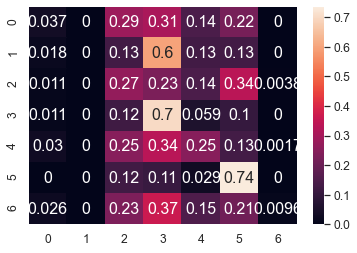

	training epoch=0 .. train_loss=1.701
	validation epoch=0 .. val_loss=1.692
	Accuracy = 34.599999999999994 % .. Percision = 31.7 % .. Recall = 28.7 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_0.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 1 .. loss = 1.764


  0%|                                                                                 | 1/1914 [00:01<34:50,  1.09s/it]

training @ epoch 1 .. loss = 1.427


  0%|                                                                                 | 2/1914 [00:02<35:06,  1.10s/it]

training @ epoch 1 .. loss = 1.659


  0%|▏                                                                                | 3/1914 [00:03<35:09,  1.10s/it]

training @ epoch 1 .. loss = 1.359


  0%|▏                                                                                | 4/1914 [00:04<35:19,  1.11s/it]

training @ epoch 1 .. loss = 1.844


  0%|▏                                                                                | 5/1914 [00:05<35:36,  1.12s/it]

training @ epoch 1 .. loss = 1.59


  0%|▎                                                                                | 6/1914 [00:06<35:59,  1.13s/it]

training @ epoch 1 .. loss = 1.416


  0%|▎                                                                                | 7/1914 [00:07<36:04,  1.13s/it]

training @ epoch 1 .. loss = 1.302


  0%|▎                                                                                | 8/1914 [00:08<35:38,  1.12s/it]

training @ epoch 1 .. loss = 1.652


  0%|▍                                                                                | 9/1914 [00:10<36:13,  1.14s/it]

training @ epoch 1 .. loss = 1.562


  1%|▍                                                                               | 10/1914 [00:11<35:39,  1.12s/it]

training @ epoch 1 .. loss = 1.719


  1%|▍                                                                               | 11/1914 [00:12<36:02,  1.14s/it]

training @ epoch 1 .. loss = 1.592


  1%|▌                                                                               | 12/1914 [00:13<35:36,  1.12s/it]

training @ epoch 1 .. loss = 1.765


  1%|▌                                                                               | 13/1914 [00:14<35:46,  1.13s/it]

training @ epoch 1 .. loss = 1.378


  1%|▌                                                                               | 14/1914 [00:15<35:46,  1.13s/it]

training @ epoch 1 .. loss = 1.563


  1%|▋                                                                               | 15/1914 [00:16<35:48,  1.13s/it]

training @ epoch 1 .. loss = 1.913


  1%|▋                                                                               | 16/1914 [00:18<35:40,  1.13s/it]

training @ epoch 1 .. loss = 1.586


  1%|▋                                                                               | 17/1914 [00:19<35:27,  1.12s/it]

training @ epoch 1 .. loss = 1.531


  1%|▊                                                                               | 18/1914 [00:20<35:45,  1.13s/it]

training @ epoch 1 .. loss = 1.472


  1%|▊                                                                               | 19/1914 [00:21<35:45,  1.13s/it]

training @ epoch 1 .. loss = 1.508


  1%|▊                                                                               | 20/1914 [00:22<36:02,  1.14s/it]

training @ epoch 1 .. loss = 1.606


  1%|▉                                                                               | 21/1914 [00:23<36:46,  1.17s/it]

training @ epoch 1 .. loss = 1.473


  1%|▉                                                                               | 22/1914 [00:25<37:30,  1.19s/it]

training @ epoch 1 .. loss = 1.53


  1%|▉                                                                               | 23/1914 [00:26<38:51,  1.23s/it]

training @ epoch 1 .. loss = 1.629


  1%|█                                                                               | 24/1914 [00:27<39:07,  1.24s/it]

training @ epoch 1 .. loss = 1.364


  1%|█                                                                               | 25/1914 [00:28<39:07,  1.24s/it]

training @ epoch 1 .. loss = 1.783


  1%|█                                                                               | 26/1914 [00:30<37:57,  1.21s/it]

training @ epoch 1 .. loss = 1.243


  1%|█▏                                                                              | 27/1914 [00:31<37:13,  1.18s/it]

training @ epoch 1 .. loss = 1.565


  1%|█▏                                                                              | 28/1914 [00:32<36:43,  1.17s/it]

training @ epoch 1 .. loss = 1.002


  2%|█▏                                                                              | 29/1914 [00:33<35:56,  1.14s/it]

training @ epoch 1 .. loss = 1.669


  2%|█▎                                                                              | 30/1914 [00:34<35:40,  1.14s/it]

training @ epoch 1 .. loss = 1.54


  2%|█▎                                                                              | 31/1914 [00:35<35:17,  1.12s/it]

training @ epoch 1 .. loss = 1.546


  2%|█▎                                                                              | 32/1914 [00:36<37:04,  1.18s/it]

training @ epoch 1 .. loss = 1.711


  2%|█▍                                                                              | 33/1914 [00:38<38:56,  1.24s/it]

training @ epoch 1 .. loss = 1.619


  2%|█▍                                                                              | 34/1914 [00:39<41:23,  1.32s/it]

training @ epoch 1 .. loss = 1.601


  2%|█▍                                                                              | 35/1914 [00:41<43:12,  1.38s/it]

training @ epoch 1 .. loss = 1.261


  2%|█▌                                                                              | 36/1914 [00:42<44:17,  1.42s/it]

training @ epoch 1 .. loss = 1.366


  2%|█▌                                                                              | 37/1914 [00:44<44:28,  1.42s/it]

training @ epoch 1 .. loss = 1.726


  2%|█▌                                                                              | 38/1914 [00:45<44:44,  1.43s/it]

training @ epoch 1 .. loss = 1.849


  2%|█▋                                                                              | 39/1914 [00:47<44:08,  1.41s/it]

training @ epoch 1 .. loss = 1.351


  2%|█▋                                                                              | 40/1914 [00:48<42:54,  1.37s/it]

training @ epoch 1 .. loss = 1.631


  2%|█▋                                                                              | 41/1914 [00:49<41:56,  1.34s/it]

training @ epoch 1 .. loss = 1.389


  2%|█▊                                                                              | 42/1914 [00:50<41:10,  1.32s/it]

training @ epoch 1 .. loss = 1.533


  2%|█▊                                                                              | 43/1914 [00:52<41:08,  1.32s/it]

training @ epoch 1 .. loss = 1.351


  2%|█▊                                                                              | 44/1914 [00:53<41:04,  1.32s/it]

training @ epoch 1 .. loss = 1.577


  2%|█▉                                                                              | 45/1914 [00:54<41:17,  1.33s/it]

training @ epoch 1 .. loss = 1.432


  2%|█▉                                                                              | 46/1914 [00:56<41:16,  1.33s/it]

training @ epoch 1 .. loss = 1.916


  2%|█▉                                                                              | 47/1914 [00:57<40:50,  1.31s/it]

training @ epoch 1 .. loss = 1.492


  3%|██                                                                              | 48/1914 [00:58<39:07,  1.26s/it]

training @ epoch 1 .. loss = 1.585


  3%|██                                                                              | 49/1914 [00:59<37:55,  1.22s/it]

training @ epoch 1 .. loss = 1.662


  3%|██                                                                              | 50/1914 [01:00<36:57,  1.19s/it]

training @ epoch 1 .. loss = 1.624


  3%|██▏                                                                             | 51/1914 [01:01<36:23,  1.17s/it]

training @ epoch 1 .. loss = 1.317


  3%|██▏                                                                             | 52/1914 [01:03<35:31,  1.14s/it]

training @ epoch 1 .. loss = 1.89


  3%|██▏                                                                             | 53/1914 [01:04<35:17,  1.14s/it]

training @ epoch 1 .. loss = 1.775


  3%|██▎                                                                             | 54/1914 [01:05<35:24,  1.14s/it]

training @ epoch 1 .. loss = 1.141


  3%|██▎                                                                             | 55/1914 [01:06<35:49,  1.16s/it]

training @ epoch 1 .. loss = 1.369


  3%|██▎                                                                             | 56/1914 [01:07<36:44,  1.19s/it]

training @ epoch 1 .. loss = 1.701


  3%|██▍                                                                             | 57/1914 [01:08<36:05,  1.17s/it]

training @ epoch 1 .. loss = 1.592


  3%|██▍                                                                             | 58/1914 [01:10<35:37,  1.15s/it]

training @ epoch 1 .. loss = 2.024


  3%|██▍                                                                             | 59/1914 [01:11<35:39,  1.15s/it]

training @ epoch 1 .. loss = 1.451


  3%|██▌                                                                             | 60/1914 [01:12<35:31,  1.15s/it]

training @ epoch 1 .. loss = 1.524


  3%|██▌                                                                             | 61/1914 [01:13<35:03,  1.14s/it]

training @ epoch 1 .. loss = 1.348


  3%|██▌                                                                             | 62/1914 [01:14<37:37,  1.22s/it]

training @ epoch 1 .. loss = 1.605


  3%|██▋                                                                             | 63/1914 [01:16<37:07,  1.20s/it]

training @ epoch 1 .. loss = 1.517


  3%|██▋                                                                             | 64/1914 [01:17<36:04,  1.17s/it]

training @ epoch 1 .. loss = 1.419


  3%|██▋                                                                             | 65/1914 [01:18<35:48,  1.16s/it]

training @ epoch 1 .. loss = 1.787


  3%|██▊                                                                             | 66/1914 [01:19<34:48,  1.13s/it]

training @ epoch 1 .. loss = 1.452


  4%|██▊                                                                             | 67/1914 [01:20<35:06,  1.14s/it]

training @ epoch 1 .. loss = 1.693


  4%|██▊                                                                             | 68/1914 [01:21<34:44,  1.13s/it]

training @ epoch 1 .. loss = 1.41


  4%|██▉                                                                             | 69/1914 [01:22<35:26,  1.15s/it]

training @ epoch 1 .. loss = 1.604


  4%|██▉                                                                             | 70/1914 [01:23<35:19,  1.15s/it]

training @ epoch 1 .. loss = 1.445


  4%|██▉                                                                             | 71/1914 [01:25<34:57,  1.14s/it]

training @ epoch 1 .. loss = 1.371


  4%|███                                                                             | 72/1914 [01:26<35:19,  1.15s/it]

training @ epoch 1 .. loss = 1.461


  4%|███                                                                             | 73/1914 [01:27<34:44,  1.13s/it]

training @ epoch 1 .. loss = 1.16


  4%|███                                                                             | 74/1914 [01:28<34:39,  1.13s/it]

training @ epoch 1 .. loss = 1.689


  4%|███▏                                                                            | 75/1914 [01:29<34:27,  1.12s/it]

training @ epoch 1 .. loss = 1.872


  4%|███▏                                                                            | 76/1914 [01:30<34:31,  1.13s/it]

training @ epoch 1 .. loss = 1.718


  4%|███▏                                                                            | 77/1914 [01:31<34:47,  1.14s/it]

training @ epoch 1 .. loss = 2.019


  4%|███▎                                                                            | 78/1914 [01:32<34:28,  1.13s/it]

training @ epoch 1 .. loss = 1.386


  4%|███▎                                                                            | 79/1914 [01:34<34:13,  1.12s/it]

training @ epoch 1 .. loss = 1.624


  4%|███▎                                                                            | 80/1914 [01:35<34:03,  1.11s/it]

training @ epoch 1 .. loss = 1.668


  4%|███▍                                                                            | 81/1914 [01:36<34:33,  1.13s/it]

training @ epoch 1 .. loss = 1.411


  4%|███▍                                                                            | 82/1914 [01:37<34:15,  1.12s/it]

training @ epoch 1 .. loss = 1.661


  4%|███▍                                                                            | 83/1914 [01:38<34:06,  1.12s/it]

training @ epoch 1 .. loss = 1.542


  4%|███▌                                                                            | 84/1914 [01:39<33:57,  1.11s/it]

training @ epoch 1 .. loss = 1.822


  4%|███▌                                                                            | 85/1914 [01:40<34:33,  1.13s/it]

training @ epoch 1 .. loss = 2.129


  4%|███▌                                                                            | 86/1914 [01:41<34:23,  1.13s/it]

training @ epoch 1 .. loss = 1.372


  5%|███▋                                                                            | 87/1914 [01:43<34:11,  1.12s/it]

training @ epoch 1 .. loss = 1.552


  5%|███▋                                                                            | 88/1914 [01:44<34:27,  1.13s/it]

training @ epoch 1 .. loss = 1.668


  5%|███▋                                                                            | 89/1914 [01:45<34:12,  1.12s/it]

training @ epoch 1 .. loss = 1.515


  5%|███▊                                                                            | 90/1914 [01:46<34:29,  1.13s/it]

training @ epoch 1 .. loss = 1.627


  5%|███▊                                                                            | 91/1914 [01:47<34:19,  1.13s/it]

training @ epoch 1 .. loss = 1.864


  5%|███▊                                                                            | 92/1914 [01:48<34:03,  1.12s/it]

training @ epoch 1 .. loss = 1.355


  5%|███▉                                                                            | 93/1914 [01:49<34:46,  1.15s/it]

training @ epoch 1 .. loss = 1.923


  5%|███▉                                                                            | 94/1914 [01:50<34:21,  1.13s/it]

training @ epoch 1 .. loss = 1.35


  5%|███▉                                                                            | 95/1914 [01:52<34:34,  1.14s/it]

training @ epoch 1 .. loss = 1.27


  5%|████                                                                            | 96/1914 [01:53<34:07,  1.13s/it]

training @ epoch 1 .. loss = 1.462


  5%|████                                                                            | 97/1914 [01:54<34:24,  1.14s/it]

training @ epoch 1 .. loss = 1.737


  5%|████                                                                            | 98/1914 [01:55<34:08,  1.13s/it]

training @ epoch 1 .. loss = 1.896


  5%|████▏                                                                           | 99/1914 [01:56<34:10,  1.13s/it]

training @ epoch 1 .. loss = 1.43


  5%|████▏                                                                          | 100/1914 [01:57<33:47,  1.12s/it]

training @ epoch 1 .. loss = 1.699


  5%|████▏                                                                          | 101/1914 [01:58<34:05,  1.13s/it]

training @ epoch 1 .. loss = 1.569


  5%|████▏                                                                          | 102/1914 [02:00<34:11,  1.13s/it]

training @ epoch 1 .. loss = 1.231


  5%|████▎                                                                          | 103/1914 [02:01<33:51,  1.12s/it]

training @ epoch 1 .. loss = 1.57


  5%|████▎                                                                          | 104/1914 [02:02<33:56,  1.13s/it]

training @ epoch 1 .. loss = 1.501


  5%|████▎                                                                          | 105/1914 [02:03<33:19,  1.11s/it]

training @ epoch 1 .. loss = 1.484


  6%|████▍                                                                          | 106/1914 [02:04<33:42,  1.12s/it]

training @ epoch 1 .. loss = 1.606


  6%|████▍                                                                          | 107/1914 [02:05<33:54,  1.13s/it]

training @ epoch 1 .. loss = 1.997


  6%|████▍                                                                          | 108/1914 [02:06<34:03,  1.13s/it]

training @ epoch 1 .. loss = 1.618


  6%|████▍                                                                          | 109/1914 [02:07<33:51,  1.13s/it]

training @ epoch 1 .. loss = 1.599


  6%|████▌                                                                          | 110/1914 [02:08<33:37,  1.12s/it]

training @ epoch 1 .. loss = 1.41


  6%|████▌                                                                          | 111/1914 [02:10<33:53,  1.13s/it]

training @ epoch 1 .. loss = 1.652


  6%|████▌                                                                          | 112/1914 [02:11<33:55,  1.13s/it]

training @ epoch 1 .. loss = 2.058


  6%|████▋                                                                          | 113/1914 [02:12<34:12,  1.14s/it]

training @ epoch 1 .. loss = 1.45


  6%|████▋                                                                          | 114/1914 [02:13<33:56,  1.13s/it]

training @ epoch 1 .. loss = 1.575


  6%|████▋                                                                          | 115/1914 [02:14<33:49,  1.13s/it]

training @ epoch 1 .. loss = 1.587


  6%|████▊                                                                          | 116/1914 [02:15<34:00,  1.14s/it]

training @ epoch 1 .. loss = 1.863


  6%|████▊                                                                          | 117/1914 [02:16<33:45,  1.13s/it]

training @ epoch 1 .. loss = 1.618


  6%|████▊                                                                          | 118/1914 [02:17<33:29,  1.12s/it]

training @ epoch 1 .. loss = 1.621


  6%|████▉                                                                          | 119/1914 [02:19<33:33,  1.12s/it]

training @ epoch 1 .. loss = 1.393


  6%|████▉                                                                          | 120/1914 [02:20<33:31,  1.12s/it]

training @ epoch 1 .. loss = 1.833


  6%|████▉                                                                          | 121/1914 [02:21<33:25,  1.12s/it]

training @ epoch 1 .. loss = 1.601


  6%|█████                                                                          | 122/1914 [02:22<33:56,  1.14s/it]

training @ epoch 1 .. loss = 1.362


  6%|█████                                                                          | 123/1914 [02:23<34:40,  1.16s/it]

training @ epoch 1 .. loss = 1.493


  6%|█████                                                                          | 124/1914 [02:25<35:39,  1.20s/it]

training @ epoch 1 .. loss = 1.584


  7%|█████▏                                                                         | 125/1914 [02:26<36:41,  1.23s/it]

training @ epoch 1 .. loss = 1.636


  7%|█████▏                                                                         | 126/1914 [02:27<37:15,  1.25s/it]

training @ epoch 1 .. loss = 1.391


  7%|█████▏                                                                         | 127/1914 [02:28<37:37,  1.26s/it]

training @ epoch 1 .. loss = 1.342


  7%|█████▎                                                                         | 128/1914 [02:30<36:09,  1.21s/it]

training @ epoch 1 .. loss = 1.663


  7%|█████▎                                                                         | 129/1914 [02:31<35:16,  1.19s/it]

training @ epoch 1 .. loss = 1.512


  7%|█████▎                                                                         | 130/1914 [02:32<35:03,  1.18s/it]

training @ epoch 1 .. loss = 1.608


  7%|█████▍                                                                         | 131/1914 [02:33<34:29,  1.16s/it]

training @ epoch 1 .. loss = 1.784


  7%|█████▍                                                                         | 132/1914 [02:34<33:53,  1.14s/it]

training @ epoch 1 .. loss = 1.726


  7%|█████▍                                                                         | 133/1914 [02:35<33:14,  1.12s/it]

training @ epoch 1 .. loss = 1.724


  7%|█████▌                                                                         | 134/1914 [02:36<33:47,  1.14s/it]

training @ epoch 1 .. loss = 1.53


  7%|█████▌                                                                         | 135/1914 [02:37<33:47,  1.14s/it]

training @ epoch 1 .. loss = 1.202


  7%|█████▌                                                                         | 136/1914 [02:39<33:25,  1.13s/it]

training @ epoch 1 .. loss = 1.57


  7%|█████▋                                                                         | 137/1914 [02:40<34:08,  1.15s/it]

training @ epoch 1 .. loss = 1.608


  7%|█████▋                                                                         | 138/1914 [02:41<33:29,  1.13s/it]

training @ epoch 1 .. loss = 1.465


  7%|█████▋                                                                         | 139/1914 [02:42<34:02,  1.15s/it]

training @ epoch 1 .. loss = 1.31


  7%|█████▊                                                                         | 140/1914 [02:43<33:35,  1.14s/it]

training @ epoch 1 .. loss = 1.36


  7%|█████▊                                                                         | 141/1914 [02:44<33:53,  1.15s/it]

training @ epoch 1 .. loss = 1.555


  7%|█████▊                                                                         | 142/1914 [02:45<33:38,  1.14s/it]

training @ epoch 1 .. loss = 1.411


  7%|█████▉                                                                         | 143/1914 [02:47<33:23,  1.13s/it]

training @ epoch 1 .. loss = 1.505


  8%|█████▉                                                                         | 144/1914 [02:48<33:41,  1.14s/it]

training @ epoch 1 .. loss = 1.564


  8%|█████▉                                                                         | 145/1914 [02:49<33:35,  1.14s/it]

training @ epoch 1 .. loss = 1.366


  8%|██████                                                                         | 146/1914 [02:50<33:26,  1.14s/it]

training @ epoch 1 .. loss = 1.489


  8%|██████                                                                         | 147/1914 [02:51<32:48,  1.11s/it]

training @ epoch 1 .. loss = 1.436


  8%|██████                                                                         | 148/1914 [02:52<32:49,  1.12s/it]

training @ epoch 1 .. loss = 1.343


  8%|██████▏                                                                        | 149/1914 [02:53<32:46,  1.11s/it]

training @ epoch 1 .. loss = 1.575


  8%|██████▏                                                                        | 150/1914 [02:54<33:00,  1.12s/it]

training @ epoch 1 .. loss = 1.557


  8%|██████▏                                                                        | 151/1914 [02:55<33:03,  1.13s/it]

training @ epoch 1 .. loss = 1.789


  8%|██████▎                                                                        | 152/1914 [02:57<33:10,  1.13s/it]

training @ epoch 1 .. loss = 1.58


  8%|██████▎                                                                        | 153/1914 [02:58<33:27,  1.14s/it]

training @ epoch 1 .. loss = 1.599


  8%|██████▎                                                                        | 154/1914 [02:59<33:03,  1.13s/it]

training @ epoch 1 .. loss = 1.606


  8%|██████▍                                                                        | 155/1914 [03:00<33:27,  1.14s/it]

training @ epoch 1 .. loss = 1.748


  8%|██████▍                                                                        | 156/1914 [03:01<32:44,  1.12s/it]

training @ epoch 1 .. loss = 1.507


  8%|██████▍                                                                        | 157/1914 [03:02<33:00,  1.13s/it]

training @ epoch 1 .. loss = 1.632


  8%|██████▌                                                                        | 158/1914 [03:03<32:50,  1.12s/it]

training @ epoch 1 .. loss = 1.972


  8%|██████▌                                                                        | 159/1914 [03:05<32:59,  1.13s/it]

training @ epoch 1 .. loss = 1.802


  8%|██████▌                                                                        | 160/1914 [03:06<33:16,  1.14s/it]

training @ epoch 1 .. loss = 1.655


  8%|██████▋                                                                        | 161/1914 [03:07<33:00,  1.13s/it]

training @ epoch 1 .. loss = 1.789


  8%|██████▋                                                                        | 162/1914 [03:08<32:56,  1.13s/it]

training @ epoch 1 .. loss = 1.523


  9%|██████▋                                                                        | 163/1914 [03:09<32:28,  1.11s/it]

training @ epoch 1 .. loss = 1.664


  9%|██████▊                                                                        | 164/1914 [03:10<32:59,  1.13s/it]

training @ epoch 1 .. loss = 1.849


  9%|██████▊                                                                        | 165/1914 [03:11<32:35,  1.12s/it]

training @ epoch 1 .. loss = 1.943


  9%|██████▊                                                                        | 166/1914 [03:12<32:26,  1.11s/it]

training @ epoch 1 .. loss = 1.623


  9%|██████▉                                                                        | 167/1914 [03:14<32:31,  1.12s/it]

training @ epoch 1 .. loss = 1.292


  9%|██████▉                                                                        | 168/1914 [03:15<32:41,  1.12s/it]

training @ epoch 1 .. loss = 1.521


  9%|██████▉                                                                        | 169/1914 [03:16<32:58,  1.13s/it]

training @ epoch 1 .. loss = 1.639


  9%|███████                                                                        | 170/1914 [03:17<32:57,  1.13s/it]

training @ epoch 1 .. loss = 1.595


  9%|███████                                                                        | 171/1914 [03:18<32:54,  1.13s/it]

training @ epoch 1 .. loss = 1.509


  9%|███████                                                                        | 172/1914 [03:19<32:32,  1.12s/it]

training @ epoch 1 .. loss = 1.662


  9%|███████▏                                                                       | 173/1914 [03:20<33:06,  1.14s/it]

training @ epoch 1 .. loss = 1.533


  9%|███████▏                                                                       | 174/1914 [03:21<32:51,  1.13s/it]

training @ epoch 1 .. loss = 2.14


  9%|███████▏                                                                       | 175/1914 [03:23<32:34,  1.12s/it]

training @ epoch 1 .. loss = 1.733


  9%|███████▎                                                                       | 176/1914 [03:24<32:38,  1.13s/it]

training @ epoch 1 .. loss = 1.642


  9%|███████▎                                                                       | 177/1914 [03:25<32:30,  1.12s/it]

training @ epoch 1 .. loss = 1.863


  9%|███████▎                                                                       | 178/1914 [03:26<32:39,  1.13s/it]

training @ epoch 1 .. loss = 1.546


  9%|███████▍                                                                       | 179/1914 [03:27<32:21,  1.12s/it]

training @ epoch 1 .. loss = 1.254


  9%|███████▍                                                                       | 180/1914 [03:28<33:13,  1.15s/it]

training @ epoch 1 .. loss = 1.586


  9%|███████▍                                                                       | 181/1914 [03:29<32:52,  1.14s/it]

training @ epoch 1 .. loss = 1.63


 10%|███████▌                                                                       | 182/1914 [03:30<32:31,  1.13s/it]

training @ epoch 1 .. loss = 1.584


 10%|███████▌                                                                       | 183/1914 [03:32<32:39,  1.13s/it]

training @ epoch 1 .. loss = 1.804


 10%|███████▌                                                                       | 184/1914 [03:33<32:22,  1.12s/it]

training @ epoch 1 .. loss = 1.558


 10%|███████▋                                                                       | 185/1914 [03:34<32:51,  1.14s/it]

training @ epoch 1 .. loss = 1.893


 10%|███████▋                                                                       | 186/1914 [03:35<32:45,  1.14s/it]

training @ epoch 1 .. loss = 1.589


 10%|███████▋                                                                       | 187/1914 [03:36<33:18,  1.16s/it]

training @ epoch 1 .. loss = 1.588


 10%|███████▊                                                                       | 188/1914 [03:37<33:03,  1.15s/it]

training @ epoch 1 .. loss = 1.482


 10%|███████▊                                                                       | 189/1914 [03:39<32:52,  1.14s/it]

training @ epoch 1 .. loss = 1.379


 10%|███████▊                                                                       | 190/1914 [03:40<33:06,  1.15s/it]

training @ epoch 1 .. loss = 1.39


 10%|███████▉                                                                       | 191/1914 [03:41<32:41,  1.14s/it]

training @ epoch 1 .. loss = 1.46


 10%|███████▉                                                                       | 192/1914 [03:42<32:38,  1.14s/it]

training @ epoch 1 .. loss = 1.828


 10%|███████▉                                                                       | 193/1914 [03:43<32:09,  1.12s/it]

training @ epoch 1 .. loss = 1.093


 10%|████████                                                                       | 194/1914 [03:44<32:40,  1.14s/it]

training @ epoch 1 .. loss = 1.665


 10%|████████                                                                       | 195/1914 [03:45<32:25,  1.13s/it]

training @ epoch 1 .. loss = 1.722


 10%|████████                                                                       | 196/1914 [03:46<31:59,  1.12s/it]

training @ epoch 1 .. loss = 1.444


 10%|████████▏                                                                      | 197/1914 [03:47<31:57,  1.12s/it]

training @ epoch 1 .. loss = 1.584


 10%|████████▏                                                                      | 198/1914 [03:49<31:37,  1.11s/it]

training @ epoch 1 .. loss = 1.55


 10%|████████▏                                                                      | 199/1914 [03:50<32:02,  1.12s/it]

training @ epoch 1 .. loss = 1.634


 10%|████████▎                                                                      | 200/1914 [03:51<32:00,  1.12s/it]

training @ epoch 1 .. loss = 1.293


 11%|████████▎                                                                      | 201/1914 [03:52<32:18,  1.13s/it]

training @ epoch 1 .. loss = 1.281


 11%|████████▎                                                                      | 202/1914 [03:53<32:25,  1.14s/it]

training @ epoch 1 .. loss = 1.679


 11%|████████▍                                                                      | 203/1914 [03:54<32:39,  1.15s/it]

training @ epoch 1 .. loss = 1.876


 11%|████████▍                                                                      | 204/1914 [03:55<32:31,  1.14s/it]

training @ epoch 1 .. loss = 1.966


 11%|████████▍                                                                      | 205/1914 [03:57<32:40,  1.15s/it]

training @ epoch 1 .. loss = 1.775


 11%|████████▌                                                                      | 206/1914 [03:58<32:42,  1.15s/it]

training @ epoch 1 .. loss = 1.462


 11%|████████▌                                                                      | 207/1914 [03:59<32:16,  1.13s/it]

training @ epoch 1 .. loss = 1.734


 11%|████████▌                                                                      | 208/1914 [04:00<32:13,  1.13s/it]

training @ epoch 1 .. loss = 1.462


 11%|████████▋                                                                      | 209/1914 [04:01<31:56,  1.12s/it]

training @ epoch 1 .. loss = 1.512


 11%|████████▋                                                                      | 210/1914 [04:02<32:11,  1.13s/it]

training @ epoch 1 .. loss = 1.525


 11%|████████▋                                                                      | 211/1914 [04:03<31:58,  1.13s/it]

training @ epoch 1 .. loss = 1.658


 11%|████████▊                                                                      | 212/1914 [04:04<32:00,  1.13s/it]

training @ epoch 1 .. loss = 1.275


 11%|████████▊                                                                      | 213/1914 [04:06<32:25,  1.14s/it]

training @ epoch 1 .. loss = 1.989


 11%|████████▊                                                                      | 214/1914 [04:07<31:48,  1.12s/it]

training @ epoch 1 .. loss = 1.294


 11%|████████▊                                                                      | 215/1914 [04:08<31:47,  1.12s/it]

training @ epoch 1 .. loss = 1.839


 11%|████████▉                                                                      | 216/1914 [04:09<31:50,  1.12s/it]

training @ epoch 1 .. loss = 2.013


 11%|████████▉                                                                      | 217/1914 [04:10<31:53,  1.13s/it]

training @ epoch 1 .. loss = 1.572


 11%|████████▉                                                                      | 218/1914 [04:11<31:55,  1.13s/it]

training @ epoch 1 .. loss = 1.796


 11%|█████████                                                                      | 219/1914 [04:12<31:48,  1.13s/it]

training @ epoch 1 .. loss = 1.727


 11%|█████████                                                                      | 220/1914 [04:14<31:50,  1.13s/it]

training @ epoch 1 .. loss = 1.874


 12%|█████████                                                                      | 221/1914 [04:15<32:00,  1.13s/it]

training @ epoch 1 .. loss = 1.669


 12%|█████████▏                                                                     | 222/1914 [04:16<32:09,  1.14s/it]

training @ epoch 1 .. loss = 1.38


 12%|█████████▏                                                                     | 223/1914 [04:17<31:48,  1.13s/it]

training @ epoch 1 .. loss = 1.664


 12%|█████████▏                                                                     | 224/1914 [04:18<31:55,  1.13s/it]

training @ epoch 1 .. loss = 1.674


 12%|█████████▎                                                                     | 225/1914 [04:19<31:52,  1.13s/it]

training @ epoch 1 .. loss = 1.343


 12%|█████████▎                                                                     | 226/1914 [04:20<31:53,  1.13s/it]

training @ epoch 1 .. loss = 1.534


 12%|█████████▎                                                                     | 227/1914 [04:21<31:30,  1.12s/it]

training @ epoch 1 .. loss = 1.386


 12%|█████████▍                                                                     | 228/1914 [04:23<31:39,  1.13s/it]

training @ epoch 1 .. loss = 1.334


 12%|█████████▍                                                                     | 229/1914 [04:24<33:28,  1.19s/it]

training @ epoch 1 .. loss = 1.599


 12%|█████████▍                                                                     | 230/1914 [04:25<34:18,  1.22s/it]

training @ epoch 1 .. loss = 1.467


 12%|█████████▌                                                                     | 231/1914 [04:26<34:31,  1.23s/it]

training @ epoch 1 .. loss = 1.543


 12%|█████████▌                                                                     | 232/1914 [04:28<35:27,  1.26s/it]

training @ epoch 1 .. loss = 1.539


 12%|█████████▌                                                                     | 233/1914 [04:29<34:51,  1.24s/it]

training @ epoch 1 .. loss = 1.648


 12%|█████████▋                                                                     | 234/1914 [04:30<34:04,  1.22s/it]

training @ epoch 1 .. loss = 1.282


 12%|█████████▋                                                                     | 235/1914 [04:31<33:24,  1.19s/it]

training @ epoch 1 .. loss = 1.29


 12%|█████████▋                                                                     | 236/1914 [04:32<32:52,  1.18s/it]

training @ epoch 1 .. loss = 1.437


 12%|█████████▊                                                                     | 237/1914 [04:34<32:51,  1.18s/it]

training @ epoch 1 .. loss = 1.208


 12%|█████████▊                                                                     | 238/1914 [04:35<32:03,  1.15s/it]

training @ epoch 1 .. loss = 1.638


 12%|█████████▊                                                                     | 239/1914 [04:36<32:00,  1.15s/it]

training @ epoch 1 .. loss = 1.903


 13%|█████████▉                                                                     | 240/1914 [04:37<31:40,  1.14s/it]

training @ epoch 1 .. loss = 1.566


 13%|█████████▉                                                                     | 241/1914 [04:38<31:41,  1.14s/it]

training @ epoch 1 .. loss = 1.582


 13%|█████████▉                                                                     | 242/1914 [04:39<31:15,  1.12s/it]

training @ epoch 1 .. loss = 1.628


 13%|██████████                                                                     | 243/1914 [04:40<31:44,  1.14s/it]

training @ epoch 1 .. loss = 2.185


 13%|██████████                                                                     | 244/1914 [04:41<31:40,  1.14s/it]

training @ epoch 1 .. loss = 1.613


 13%|██████████                                                                     | 245/1914 [04:43<31:21,  1.13s/it]

training @ epoch 1 .. loss = 1.689


 13%|██████████▏                                                                    | 246/1914 [04:44<31:24,  1.13s/it]

training @ epoch 1 .. loss = 1.592


 13%|██████████▏                                                                    | 247/1914 [04:45<31:19,  1.13s/it]

training @ epoch 1 .. loss = 2.119


 13%|██████████▏                                                                    | 248/1914 [04:46<31:26,  1.13s/it]

training @ epoch 1 .. loss = 1.41


 13%|██████████▎                                                                    | 249/1914 [04:47<31:34,  1.14s/it]

training @ epoch 1 .. loss = 1.351


 13%|██████████▎                                                                    | 250/1914 [04:48<31:45,  1.15s/it]

training @ epoch 1 .. loss = 1.955


 13%|██████████▎                                                                    | 251/1914 [04:49<31:25,  1.13s/it]

training @ epoch 1 .. loss = 1.584


 13%|██████████▍                                                                    | 252/1914 [04:51<31:19,  1.13s/it]

training @ epoch 1 .. loss = 1.636


 13%|██████████▍                                                                    | 253/1914 [04:52<31:28,  1.14s/it]

training @ epoch 1 .. loss = 1.632


 13%|██████████▍                                                                    | 254/1914 [04:53<31:06,  1.12s/it]

training @ epoch 1 .. loss = 1.461


 13%|██████████▌                                                                    | 255/1914 [04:54<31:17,  1.13s/it]

training @ epoch 1 .. loss = 1.647


 13%|██████████▌                                                                    | 256/1914 [04:55<31:01,  1.12s/it]

training @ epoch 1 .. loss = 1.494


 13%|██████████▌                                                                    | 257/1914 [04:56<31:10,  1.13s/it]

training @ epoch 1 .. loss = 1.532


 13%|██████████▋                                                                    | 258/1914 [04:57<31:05,  1.13s/it]

training @ epoch 1 .. loss = 1.559


 14%|██████████▋                                                                    | 259/1914 [04:58<30:57,  1.12s/it]

training @ epoch 1 .. loss = 1.344


 14%|██████████▋                                                                    | 260/1914 [05:00<31:05,  1.13s/it]

training @ epoch 1 .. loss = 1.408


 14%|██████████▊                                                                    | 261/1914 [05:01<30:55,  1.12s/it]

training @ epoch 1 .. loss = 1.705


 14%|██████████▊                                                                    | 262/1914 [05:02<30:49,  1.12s/it]

training @ epoch 1 .. loss = 1.863


 14%|██████████▊                                                                    | 263/1914 [05:03<30:40,  1.11s/it]

training @ epoch 1 .. loss = 1.743


 14%|██████████▉                                                                    | 264/1914 [05:04<30:52,  1.12s/it]

training @ epoch 1 .. loss = 1.726


 14%|██████████▉                                                                    | 265/1914 [05:05<30:48,  1.12s/it]

training @ epoch 1 .. loss = 2.05


 14%|██████████▉                                                                    | 266/1914 [05:06<31:23,  1.14s/it]

training @ epoch 1 .. loss = 1.685


 14%|███████████                                                                    | 267/1914 [05:07<31:02,  1.13s/it]

training @ epoch 1 .. loss = 1.458


 14%|███████████                                                                    | 268/1914 [05:09<30:55,  1.13s/it]

training @ epoch 1 .. loss = 1.421


 14%|███████████                                                                    | 269/1914 [05:10<30:59,  1.13s/it]

training @ epoch 1 .. loss = 1.851


 14%|███████████▏                                                                   | 270/1914 [05:11<30:46,  1.12s/it]

training @ epoch 1 .. loss = 1.679


 14%|███████████▏                                                                   | 271/1914 [05:12<30:54,  1.13s/it]

training @ epoch 1 .. loss = 1.284


 14%|███████████▏                                                                   | 272/1914 [05:13<30:41,  1.12s/it]

training @ epoch 1 .. loss = 1.379


 14%|███████████▎                                                                   | 273/1914 [05:14<31:05,  1.14s/it]

training @ epoch 1 .. loss = 1.489


 14%|███████████▎                                                                   | 274/1914 [05:15<31:11,  1.14s/it]

training @ epoch 1 .. loss = 1.735


 14%|███████████▎                                                                   | 275/1914 [05:16<30:40,  1.12s/it]

training @ epoch 1 .. loss = 1.962


 14%|███████████▍                                                                   | 276/1914 [05:18<30:27,  1.12s/it]

training @ epoch 1 .. loss = 1.495


 14%|███████████▍                                                                   | 277/1914 [05:19<30:12,  1.11s/it]

training @ epoch 1 .. loss = 1.638


 15%|███████████▍                                                                   | 278/1914 [05:20<30:37,  1.12s/it]

training @ epoch 1 .. loss = 1.634


 15%|███████████▌                                                                   | 279/1914 [05:21<30:30,  1.12s/it]

training @ epoch 1 .. loss = 1.359


 15%|███████████▌                                                                   | 280/1914 [05:22<30:57,  1.14s/it]

training @ epoch 1 .. loss = 1.59


 15%|███████████▌                                                                   | 281/1914 [05:23<30:52,  1.13s/it]

training @ epoch 1 .. loss = 1.599


 15%|███████████▋                                                                   | 282/1914 [05:24<30:59,  1.14s/it]

training @ epoch 1 .. loss = 1.502


 15%|███████████▋                                                                   | 283/1914 [05:25<30:36,  1.13s/it]

training @ epoch 1 .. loss = 1.545


 15%|███████████▋                                                                   | 284/1914 [05:27<30:13,  1.11s/it]

training @ epoch 1 .. loss = 1.588


 15%|███████████▊                                                                   | 285/1914 [05:28<30:31,  1.12s/it]

training @ epoch 1 .. loss = 1.476


 15%|███████████▊                                                                   | 286/1914 [05:29<31:08,  1.15s/it]

training @ epoch 1 .. loss = 1.562


 15%|███████████▊                                                                   | 287/1914 [05:30<31:03,  1.15s/it]

training @ epoch 1 .. loss = 1.528


 15%|███████████▉                                                                   | 288/1914 [05:31<30:41,  1.13s/it]

training @ epoch 1 .. loss = 1.518


 15%|███████████▉                                                                   | 289/1914 [05:32<30:39,  1.13s/it]

training @ epoch 1 .. loss = 1.413


 15%|███████████▉                                                                   | 290/1914 [05:33<30:43,  1.14s/it]

training @ epoch 1 .. loss = 1.509


 15%|████████████                                                                   | 291/1914 [05:35<30:41,  1.13s/it]

training @ epoch 1 .. loss = 1.509


 15%|████████████                                                                   | 292/1914 [05:36<30:29,  1.13s/it]

training @ epoch 1 .. loss = 1.884


 15%|████████████                                                                   | 293/1914 [05:37<30:13,  1.12s/it]

training @ epoch 1 .. loss = 1.561


 15%|████████████▏                                                                  | 294/1914 [05:38<30:23,  1.13s/it]

training @ epoch 1 .. loss = 1.759


 15%|████████████▏                                                                  | 295/1914 [05:39<30:25,  1.13s/it]

training @ epoch 1 .. loss = 1.714


 15%|████████████▏                                                                  | 296/1914 [05:40<30:40,  1.14s/it]

training @ epoch 1 .. loss = 1.666


 16%|████████████▎                                                                  | 297/1914 [05:41<30:36,  1.14s/it]

training @ epoch 1 .. loss = 1.408


 16%|████████████▎                                                                  | 298/1914 [05:42<30:18,  1.13s/it]

training @ epoch 1 .. loss = 1.249


 16%|████████████▎                                                                  | 299/1914 [05:44<30:29,  1.13s/it]

training @ epoch 1 .. loss = 1.526


 16%|████████████▍                                                                  | 300/1914 [05:45<29:58,  1.11s/it]

training @ epoch 1 .. loss = 1.547


 16%|████████████▍                                                                  | 301/1914 [05:46<30:06,  1.12s/it]

training @ epoch 1 .. loss = 1.627


 16%|████████████▍                                                                  | 302/1914 [05:47<29:55,  1.11s/it]

training @ epoch 1 .. loss = 1.261


 16%|████████████▌                                                                  | 303/1914 [05:48<29:59,  1.12s/it]

training @ epoch 1 .. loss = 1.505


 16%|████████████▌                                                                  | 304/1914 [05:49<30:19,  1.13s/it]

training @ epoch 1 .. loss = 1.302


 16%|████████████▌                                                                  | 305/1914 [05:50<30:41,  1.14s/it]

training @ epoch 1 .. loss = 1.711


 16%|████████████▋                                                                  | 306/1914 [05:51<30:35,  1.14s/it]

training @ epoch 1 .. loss = 1.401


 16%|████████████▋                                                                  | 307/1914 [05:53<29:55,  1.12s/it]

training @ epoch 1 .. loss = 1.653


 16%|████████████▋                                                                  | 308/1914 [05:54<30:15,  1.13s/it]

training @ epoch 1 .. loss = 1.88


 16%|████████████▊                                                                  | 309/1914 [05:55<30:05,  1.12s/it]

training @ epoch 1 .. loss = 1.739


 16%|████████████▊                                                                  | 310/1914 [05:56<30:11,  1.13s/it]

training @ epoch 1 .. loss = 1.686


 16%|████████████▊                                                                  | 311/1914 [05:57<29:57,  1.12s/it]

training @ epoch 1 .. loss = 1.745


 16%|████████████▉                                                                  | 312/1914 [05:58<29:56,  1.12s/it]

training @ epoch 1 .. loss = 1.375


 16%|████████████▉                                                                  | 313/1914 [05:59<30:13,  1.13s/it]

training @ epoch 1 .. loss = 1.257


 16%|████████████▉                                                                  | 314/1914 [06:00<29:53,  1.12s/it]

training @ epoch 1 .. loss = 1.519


 16%|█████████████                                                                  | 315/1914 [06:02<30:05,  1.13s/it]

training @ epoch 1 .. loss = 1.024


 17%|█████████████                                                                  | 316/1914 [06:03<29:50,  1.12s/it]

training @ epoch 1 .. loss = 1.371


 17%|█████████████                                                                  | 317/1914 [06:04<29:55,  1.12s/it]

training @ epoch 1 .. loss = 1.44


 17%|█████████████▏                                                                 | 318/1914 [06:05<30:10,  1.13s/it]

training @ epoch 1 .. loss = 1.483


 17%|█████████████▏                                                                 | 319/1914 [06:06<30:12,  1.14s/it]

training @ epoch 1 .. loss = 1.261


 17%|█████████████▏                                                                 | 320/1914 [06:07<29:55,  1.13s/it]

training @ epoch 1 .. loss = 1.067


 17%|█████████████▏                                                                 | 321/1914 [06:08<29:56,  1.13s/it]

training @ epoch 1 .. loss = 1.712


 17%|█████████████▎                                                                 | 322/1914 [06:09<29:51,  1.13s/it]

training @ epoch 1 .. loss = 1.353


 17%|█████████████▎                                                                 | 323/1914 [06:11<29:48,  1.12s/it]

training @ epoch 1 .. loss = 1.545


 17%|█████████████▎                                                                 | 324/1914 [06:12<29:55,  1.13s/it]

training @ epoch 1 .. loss = 1.866


 17%|█████████████▍                                                                 | 325/1914 [06:13<29:33,  1.12s/it]

training @ epoch 1 .. loss = 1.9


 17%|█████████████▍                                                                 | 326/1914 [06:14<29:45,  1.12s/it]

training @ epoch 1 .. loss = 1.441


 17%|█████████████▍                                                                 | 327/1914 [06:15<29:38,  1.12s/it]

training @ epoch 1 .. loss = 1.501


 17%|█████████████▌                                                                 | 328/1914 [06:16<29:38,  1.12s/it]

training @ epoch 1 .. loss = 1.086


 17%|█████████████▌                                                                 | 329/1914 [06:17<29:46,  1.13s/it]

training @ epoch 1 .. loss = 1.625


 17%|█████████████▌                                                                 | 330/1914 [06:18<29:33,  1.12s/it]

training @ epoch 1 .. loss = 1.499


 17%|█████████████▋                                                                 | 331/1914 [06:20<29:44,  1.13s/it]

training @ epoch 1 .. loss = 1.506


 17%|█████████████▋                                                                 | 332/1914 [06:21<29:41,  1.13s/it]

training @ epoch 1 .. loss = 1.164


 17%|█████████████▋                                                                 | 333/1914 [06:22<30:12,  1.15s/it]

training @ epoch 1 .. loss = 1.681


 17%|█████████████▊                                                                 | 334/1914 [06:23<30:04,  1.14s/it]

training @ epoch 1 .. loss = 1.798


 18%|█████████████▊                                                                 | 335/1914 [06:24<31:43,  1.21s/it]

training @ epoch 1 .. loss = 1.51


 18%|█████████████▊                                                                 | 336/1914 [06:26<31:55,  1.21s/it]

training @ epoch 1 .. loss = 2.002


 18%|█████████████▉                                                                 | 337/1914 [06:27<32:26,  1.23s/it]

training @ epoch 1 .. loss = 1.786


 18%|█████████████▉                                                                 | 338/1914 [06:28<32:43,  1.25s/it]

training @ epoch 1 .. loss = 1.288


 18%|█████████████▉                                                                 | 339/1914 [06:29<32:40,  1.24s/it]

training @ epoch 1 .. loss = 1.515


 18%|██████████████                                                                 | 340/1914 [06:31<31:40,  1.21s/it]

training @ epoch 1 .. loss = 1.326


 18%|██████████████                                                                 | 341/1914 [06:32<31:17,  1.19s/it]

training @ epoch 1 .. loss = 1.269


 18%|██████████████                                                                 | 342/1914 [06:33<30:43,  1.17s/it]

training @ epoch 1 .. loss = 1.621


 18%|██████████████▏                                                                | 343/1914 [06:34<30:46,  1.18s/it]

training @ epoch 1 .. loss = 1.864


 18%|██████████████▏                                                                | 344/1914 [06:35<30:43,  1.17s/it]

training @ epoch 1 .. loss = 1.369


 18%|██████████████▏                                                                | 345/1914 [06:36<30:30,  1.17s/it]

training @ epoch 1 .. loss = 1.598


 18%|██████████████▎                                                                | 346/1914 [06:37<30:03,  1.15s/it]

training @ epoch 1 .. loss = 1.327


 18%|██████████████▎                                                                | 347/1914 [06:38<29:26,  1.13s/it]

training @ epoch 1 .. loss = 1.614


 18%|██████████████▎                                                                | 348/1914 [06:40<29:34,  1.13s/it]

training @ epoch 1 .. loss = 1.464


 18%|██████████████▍                                                                | 349/1914 [06:41<29:32,  1.13s/it]

training @ epoch 1 .. loss = 1.57


 18%|██████████████▍                                                                | 350/1914 [06:42<29:50,  1.14s/it]

training @ epoch 1 .. loss = 1.53


 18%|██████████████▍                                                                | 351/1914 [06:43<29:30,  1.13s/it]

training @ epoch 1 .. loss = 1.596


 18%|██████████████▌                                                                | 352/1914 [06:44<29:28,  1.13s/it]

training @ epoch 1 .. loss = 1.547


 18%|██████████████▌                                                                | 353/1914 [06:45<29:23,  1.13s/it]

training @ epoch 1 .. loss = 1.455


 18%|██████████████▌                                                                | 354/1914 [06:46<29:12,  1.12s/it]

training @ epoch 1 .. loss = 1.675


 19%|██████████████▋                                                                | 355/1914 [06:48<29:23,  1.13s/it]

training @ epoch 1 .. loss = 1.613


 19%|██████████████▋                                                                | 356/1914 [06:49<29:29,  1.14s/it]

training @ epoch 1 .. loss = 1.844


 19%|██████████████▋                                                                | 357/1914 [06:50<29:33,  1.14s/it]

training @ epoch 1 .. loss = 1.416


 19%|██████████████▊                                                                | 358/1914 [06:51<29:15,  1.13s/it]

training @ epoch 1 .. loss = 2.017


 19%|██████████████▊                                                                | 359/1914 [06:52<29:24,  1.14s/it]

training @ epoch 1 .. loss = 1.327


 19%|██████████████▊                                                                | 360/1914 [06:53<29:17,  1.13s/it]

training @ epoch 1 .. loss = 1.802


 19%|██████████████▉                                                                | 361/1914 [06:54<29:26,  1.14s/it]

training @ epoch 1 .. loss = 1.259


 19%|██████████████▉                                                                | 362/1914 [06:55<29:12,  1.13s/it]

training @ epoch 1 .. loss = 2.003


 19%|██████████████▉                                                                | 363/1914 [06:57<29:18,  1.13s/it]

training @ epoch 1 .. loss = 1.648


 19%|███████████████                                                                | 364/1914 [06:58<29:17,  1.13s/it]

training @ epoch 1 .. loss = 1.467


 19%|███████████████                                                                | 365/1914 [06:59<29:13,  1.13s/it]

training @ epoch 1 .. loss = 1.591


 19%|███████████████                                                                | 366/1914 [07:00<29:07,  1.13s/it]

training @ epoch 1 .. loss = 1.709


 19%|███████████████▏                                                               | 367/1914 [07:01<28:51,  1.12s/it]

training @ epoch 1 .. loss = 1.587


 19%|███████████████▏                                                               | 368/1914 [07:02<29:08,  1.13s/it]

training @ epoch 1 .. loss = 1.422


 19%|███████████████▏                                                               | 369/1914 [07:03<28:57,  1.12s/it]

training @ epoch 1 .. loss = 1.764


 19%|███████████████▎                                                               | 370/1914 [07:04<28:43,  1.12s/it]

training @ epoch 1 .. loss = 1.384


 19%|███████████████▎                                                               | 371/1914 [07:06<29:04,  1.13s/it]

training @ epoch 1 .. loss = 1.484


 19%|███████████████▎                                                               | 372/1914 [07:07<28:57,  1.13s/it]

training @ epoch 1 .. loss = 1.492


 19%|███████████████▍                                                               | 373/1914 [07:08<29:03,  1.13s/it]

training @ epoch 1 .. loss = 1.529


 20%|███████████████▍                                                               | 374/1914 [07:09<28:44,  1.12s/it]

training @ epoch 1 .. loss = 1.45


 20%|███████████████▍                                                               | 375/1914 [07:10<28:50,  1.12s/it]

training @ epoch 1 .. loss = 1.363


 20%|███████████████▌                                                               | 376/1914 [07:11<28:39,  1.12s/it]

training @ epoch 1 .. loss = 1.706


 20%|███████████████▌                                                               | 377/1914 [07:12<28:39,  1.12s/it]

training @ epoch 1 .. loss = 1.667


 20%|███████████████▌                                                               | 378/1914 [07:13<28:45,  1.12s/it]

training @ epoch 1 .. loss = 1.646


 20%|███████████████▋                                                               | 379/1914 [07:15<28:22,  1.11s/it]

training @ epoch 1 .. loss = 1.287


 20%|███████████████▋                                                               | 380/1914 [07:16<28:45,  1.12s/it]

training @ epoch 1 .. loss = 1.799


 20%|███████████████▋                                                               | 381/1914 [07:17<28:20,  1.11s/it]

training @ epoch 1 .. loss = 1.976


 20%|███████████████▊                                                               | 382/1914 [07:18<28:52,  1.13s/it]

training @ epoch 1 .. loss = 1.488


 20%|███████████████▊                                                               | 383/1914 [07:19<28:49,  1.13s/it]

training @ epoch 1 .. loss = 1.502


 20%|███████████████▊                                                               | 384/1914 [07:20<28:50,  1.13s/it]

training @ epoch 1 .. loss = 1.696


 20%|███████████████▉                                                               | 385/1914 [07:21<28:41,  1.13s/it]

training @ epoch 1 .. loss = 1.575


 20%|███████████████▉                                                               | 386/1914 [07:22<28:28,  1.12s/it]

training @ epoch 1 .. loss = 1.498


 20%|███████████████▉                                                               | 387/1914 [07:24<28:33,  1.12s/it]

training @ epoch 1 .. loss = 1.525


 20%|████████████████                                                               | 388/1914 [07:25<28:27,  1.12s/it]

training @ epoch 1 .. loss = 1.766


 20%|████████████████                                                               | 389/1914 [07:26<28:40,  1.13s/it]

training @ epoch 1 .. loss = 1.987


 20%|████████████████                                                               | 390/1914 [07:27<28:22,  1.12s/it]

training @ epoch 1 .. loss = 1.207


 20%|████████████████▏                                                              | 391/1914 [07:28<28:27,  1.12s/it]

training @ epoch 1 .. loss = 1.386


 20%|████████████████▏                                                              | 392/1914 [07:29<28:27,  1.12s/it]

training @ epoch 1 .. loss = 1.406


 21%|████████████████▏                                                              | 393/1914 [07:30<28:43,  1.13s/it]

training @ epoch 1 .. loss = 1.786


 21%|████████████████▎                                                              | 394/1914 [07:31<28:40,  1.13s/it]

training @ epoch 1 .. loss = 1.677


 21%|████████████████▎                                                              | 395/1914 [07:33<28:35,  1.13s/it]

training @ epoch 1 .. loss = 1.258


 21%|████████████████▎                                                              | 396/1914 [07:34<28:49,  1.14s/it]

training @ epoch 1 .. loss = 1.522


 21%|████████████████▍                                                              | 397/1914 [07:35<28:35,  1.13s/it]

training @ epoch 1 .. loss = 1.227


 21%|████████████████▍                                                              | 398/1914 [07:36<28:42,  1.14s/it]

training @ epoch 1 .. loss = 1.389


 21%|████████████████▍                                                              | 399/1914 [07:37<28:34,  1.13s/it]

training @ epoch 1 .. loss = 1.379


 21%|████████████████▌                                                              | 400/1914 [07:38<28:56,  1.15s/it]

training @ epoch 1 .. loss = 1.546


 21%|████████████████▌                                                              | 401/1914 [07:39<28:31,  1.13s/it]

training @ epoch 1 .. loss = 1.45


 21%|████████████████▌                                                              | 402/1914 [07:41<28:18,  1.12s/it]

training @ epoch 1 .. loss = 1.63


 21%|████████████████▋                                                              | 403/1914 [07:42<29:03,  1.15s/it]

training @ epoch 1 .. loss = 1.562


 21%|████████████████▋                                                              | 404/1914 [07:43<28:41,  1.14s/it]

training @ epoch 1 .. loss = 1.305


 21%|████████████████▋                                                              | 405/1914 [07:44<28:45,  1.14s/it]

training @ epoch 1 .. loss = 1.409


 21%|████████████████▊                                                              | 406/1914 [07:45<28:37,  1.14s/it]

training @ epoch 1 .. loss = 1.738


 21%|████████████████▊                                                              | 407/1914 [07:46<28:52,  1.15s/it]

training @ epoch 1 .. loss = 1.701


 21%|████████████████▊                                                              | 408/1914 [07:47<28:28,  1.13s/it]

training @ epoch 1 .. loss = 1.394


 21%|████████████████▉                                                              | 409/1914 [07:49<28:43,  1.15s/it]

training @ epoch 1 .. loss = 1.635


 21%|████████████████▉                                                              | 410/1914 [07:50<28:54,  1.15s/it]

training @ epoch 1 .. loss = 1.594


 21%|████████████████▉                                                              | 411/1914 [07:51<28:20,  1.13s/it]

training @ epoch 1 .. loss = 1.545


 22%|█████████████████                                                              | 412/1914 [07:52<28:32,  1.14s/it]

training @ epoch 1 .. loss = 1.332


 22%|█████████████████                                                              | 413/1914 [07:53<28:26,  1.14s/it]

training @ epoch 1 .. loss = 1.776


 22%|█████████████████                                                              | 414/1914 [07:54<28:33,  1.14s/it]

training @ epoch 1 .. loss = 1.279


 22%|█████████████████▏                                                             | 415/1914 [07:55<28:30,  1.14s/it]

training @ epoch 1 .. loss = 1.391


 22%|█████████████████▏                                                             | 416/1914 [07:57<28:13,  1.13s/it]

training @ epoch 1 .. loss = 1.361


 22%|█████████████████▏                                                             | 417/1914 [07:58<28:31,  1.14s/it]

training @ epoch 1 .. loss = 1.068


 22%|█████████████████▎                                                             | 418/1914 [07:59<28:18,  1.14s/it]

training @ epoch 1 .. loss = 2.515


 22%|█████████████████▎                                                             | 419/1914 [08:00<28:26,  1.14s/it]

training @ epoch 1 .. loss = 1.32


 22%|█████████████████▎                                                             | 420/1914 [08:01<28:05,  1.13s/it]

training @ epoch 1 .. loss = 1.717


 22%|█████████████████▍                                                             | 421/1914 [08:02<28:15,  1.14s/it]

training @ epoch 1 .. loss = 1.287


 22%|█████████████████▍                                                             | 422/1914 [08:03<28:06,  1.13s/it]

training @ epoch 1 .. loss = 1.31


 22%|█████████████████▍                                                             | 423/1914 [08:04<27:52,  1.12s/it]

training @ epoch 1 .. loss = 1.496


 22%|█████████████████▌                                                             | 424/1914 [08:06<28:23,  1.14s/it]

training @ epoch 1 .. loss = 1.665


 22%|█████████████████▌                                                             | 425/1914 [08:07<28:26,  1.15s/it]

training @ epoch 1 .. loss = 1.712


 22%|█████████████████▌                                                             | 426/1914 [08:08<28:24,  1.15s/it]

training @ epoch 1 .. loss = 1.947


 22%|█████████████████▌                                                             | 427/1914 [08:09<28:00,  1.13s/it]

training @ epoch 1 .. loss = 1.474


 22%|█████████████████▋                                                             | 428/1914 [08:10<28:06,  1.13s/it]

training @ epoch 1 .. loss = 1.891


 22%|█████████████████▋                                                             | 429/1914 [08:11<28:17,  1.14s/it]

training @ epoch 1 .. loss = 1.538


 22%|█████████████████▋                                                             | 430/1914 [08:12<27:58,  1.13s/it]

training @ epoch 1 .. loss = 1.371


 23%|█████████████████▊                                                             | 431/1914 [08:14<27:49,  1.13s/it]

training @ epoch 1 .. loss = 1.379


 23%|█████████████████▊                                                             | 432/1914 [08:15<27:32,  1.11s/it]

training @ epoch 1 .. loss = 1.588


 23%|█████████████████▊                                                             | 433/1914 [08:16<27:34,  1.12s/it]

training @ epoch 1 .. loss = 1.296


 23%|█████████████████▉                                                             | 434/1914 [08:17<27:53,  1.13s/it]

training @ epoch 1 .. loss = 1.497


 23%|█████████████████▉                                                             | 435/1914 [08:18<28:18,  1.15s/it]

training @ epoch 1 .. loss = 1.451


 23%|█████████████████▉                                                             | 436/1914 [08:19<28:26,  1.15s/it]

training @ epoch 1 .. loss = 1.488


 23%|██████████████████                                                             | 437/1914 [08:20<28:11,  1.15s/it]

training @ epoch 1 .. loss = 1.642


 23%|██████████████████                                                             | 438/1914 [08:22<28:17,  1.15s/it]

training @ epoch 1 .. loss = 1.627


 23%|██████████████████                                                             | 439/1914 [08:23<27:59,  1.14s/it]

training @ epoch 1 .. loss = 1.273


 23%|██████████████████▏                                                            | 440/1914 [08:24<29:46,  1.21s/it]

training @ epoch 1 .. loss = 1.604


 23%|██████████████████▏                                                            | 441/1914 [08:25<30:21,  1.24s/it]

training @ epoch 1 .. loss = 1.646


 23%|██████████████████▏                                                            | 442/1914 [08:27<30:41,  1.25s/it]

training @ epoch 1 .. loss = 1.577


 23%|██████████████████▎                                                            | 443/1914 [08:28<31:25,  1.28s/it]

training @ epoch 1 .. loss = 1.519


 23%|██████████████████▎                                                            | 444/1914 [08:29<31:28,  1.28s/it]

training @ epoch 1 .. loss = 1.343


 23%|██████████████████▎                                                            | 445/1914 [08:30<30:32,  1.25s/it]

training @ epoch 1 .. loss = 1.991


 23%|██████████████████▍                                                            | 446/1914 [08:32<29:51,  1.22s/it]

training @ epoch 1 .. loss = 1.732


 23%|██████████████████▍                                                            | 447/1914 [08:33<29:17,  1.20s/it]

training @ epoch 1 .. loss = 1.544


 23%|██████████████████▍                                                            | 448/1914 [08:34<28:58,  1.19s/it]

training @ epoch 1 .. loss = 1.633


 23%|██████████████████▌                                                            | 449/1914 [08:35<28:21,  1.16s/it]

training @ epoch 1 .. loss = 1.53


 24%|██████████████████▌                                                            | 450/1914 [08:36<28:18,  1.16s/it]

training @ epoch 1 .. loss = 1.132


 24%|██████████████████▌                                                            | 451/1914 [08:37<28:06,  1.15s/it]

training @ epoch 1 .. loss = 1.985


 24%|██████████████████▋                                                            | 452/1914 [08:38<27:43,  1.14s/it]

training @ epoch 1 .. loss = 1.518


 24%|██████████████████▋                                                            | 453/1914 [08:40<27:47,  1.14s/it]

training @ epoch 1 .. loss = 1.716


 24%|██████████████████▋                                                            | 454/1914 [08:41<27:35,  1.13s/it]

training @ epoch 1 .. loss = 1.451


 24%|██████████████████▊                                                            | 455/1914 [08:42<27:30,  1.13s/it]

training @ epoch 1 .. loss = 1.763


 24%|██████████████████▊                                                            | 456/1914 [08:43<27:23,  1.13s/it]

training @ epoch 1 .. loss = 1.49


 24%|██████████████████▊                                                            | 457/1914 [08:44<27:25,  1.13s/it]

training @ epoch 1 .. loss = 1.337


 24%|██████████████████▉                                                            | 458/1914 [08:45<27:26,  1.13s/it]

training @ epoch 1 .. loss = 1.469


 24%|██████████████████▉                                                            | 459/1914 [08:46<27:42,  1.14s/it]

training @ epoch 1 .. loss = 1.729


 24%|██████████████████▉                                                            | 460/1914 [08:47<27:17,  1.13s/it]

training @ epoch 1 .. loss = 1.55


 24%|███████████████████                                                            | 461/1914 [08:49<27:12,  1.12s/it]

training @ epoch 1 .. loss = 1.242


 24%|███████████████████                                                            | 462/1914 [08:50<27:19,  1.13s/it]

training @ epoch 1 .. loss = 1.589


 24%|███████████████████                                                            | 463/1914 [08:51<27:22,  1.13s/it]

training @ epoch 1 .. loss = 1.285


 24%|███████████████████▏                                                           | 464/1914 [08:52<27:33,  1.14s/it]

training @ epoch 1 .. loss = 1.624


 24%|███████████████████▏                                                           | 465/1914 [08:53<27:15,  1.13s/it]

training @ epoch 1 .. loss = 1.213


 24%|███████████████████▏                                                           | 466/1914 [08:54<27:12,  1.13s/it]

training @ epoch 1 .. loss = 1.423


 24%|███████████████████▎                                                           | 467/1914 [08:55<27:14,  1.13s/it]

training @ epoch 1 .. loss = 1.396


 24%|███████████████████▎                                                           | 468/1914 [08:56<26:53,  1.12s/it]

training @ epoch 1 .. loss = 1.332


 25%|███████████████████▎                                                           | 469/1914 [08:58<26:46,  1.11s/it]

training @ epoch 1 .. loss = 1.364


 25%|███████████████████▍                                                           | 470/1914 [08:59<26:48,  1.11s/it]

training @ epoch 1 .. loss = 1.5


 25%|███████████████████▍                                                           | 471/1914 [09:00<27:16,  1.13s/it]

training @ epoch 1 .. loss = 1.125


 25%|███████████████████▍                                                           | 472/1914 [09:01<27:12,  1.13s/it]

training @ epoch 1 .. loss = 1.363


 25%|███████████████████▌                                                           | 473/1914 [09:02<27:10,  1.13s/it]

training @ epoch 1 .. loss = 1.752


 25%|███████████████████▌                                                           | 474/1914 [09:03<27:03,  1.13s/it]

training @ epoch 1 .. loss = 1.309


 25%|███████████████████▌                                                           | 475/1914 [09:04<27:02,  1.13s/it]

training @ epoch 1 .. loss = 1.267


 25%|███████████████████▋                                                           | 476/1914 [09:05<27:04,  1.13s/it]

training @ epoch 1 .. loss = 1.363


 25%|███████████████████▋                                                           | 477/1914 [09:07<27:06,  1.13s/it]

training @ epoch 1 .. loss = 1.668


 25%|███████████████████▋                                                           | 478/1914 [09:08<27:09,  1.14s/it]

training @ epoch 1 .. loss = 1.505


 25%|███████████████████▊                                                           | 479/1914 [09:09<26:55,  1.13s/it]

training @ epoch 1 .. loss = 1.766


 25%|███████████████████▊                                                           | 480/1914 [09:10<27:09,  1.14s/it]

training @ epoch 1 .. loss = 1.415


 25%|███████████████████▊                                                           | 481/1914 [09:11<27:13,  1.14s/it]

training @ epoch 1 .. loss = 1.577


 25%|███████████████████▉                                                           | 482/1914 [09:12<27:04,  1.13s/it]

training @ epoch 1 .. loss = 1.493


 25%|███████████████████▉                                                           | 483/1914 [09:13<27:09,  1.14s/it]

training @ epoch 1 .. loss = 1.565


 25%|███████████████████▉                                                           | 484/1914 [09:15<26:48,  1.12s/it]

training @ epoch 1 .. loss = 1.456


 25%|████████████████████                                                           | 485/1914 [09:16<26:55,  1.13s/it]

training @ epoch 1 .. loss = 1.411


 25%|████████████████████                                                           | 486/1914 [09:17<26:42,  1.12s/it]

training @ epoch 1 .. loss = 1.3


 25%|████████████████████                                                           | 487/1914 [09:18<26:49,  1.13s/it]

training @ epoch 1 .. loss = 1.236


 25%|████████████████████▏                                                          | 488/1914 [09:19<26:41,  1.12s/it]

training @ epoch 1 .. loss = 1.523


 26%|████████████████████▏                                                          | 489/1914 [09:20<26:56,  1.13s/it]

training @ epoch 1 .. loss = 1.556


 26%|████████████████████▏                                                          | 490/1914 [09:21<27:09,  1.14s/it]

training @ epoch 1 .. loss = 1.414


 26%|████████████████████▎                                                          | 491/1914 [09:22<26:48,  1.13s/it]

training @ epoch 1 .. loss = 1.356


 26%|████████████████████▎                                                          | 492/1914 [09:24<26:47,  1.13s/it]

training @ epoch 1 .. loss = 1.287


 26%|████████████████████▎                                                          | 493/1914 [09:25<26:41,  1.13s/it]

training @ epoch 1 .. loss = 1.862


 26%|████████████████████▍                                                          | 494/1914 [09:26<26:35,  1.12s/it]

training @ epoch 1 .. loss = 1.343


 26%|████████████████████▍                                                          | 495/1914 [09:27<26:17,  1.11s/it]

training @ epoch 1 .. loss = 1.423


 26%|████████████████████▍                                                          | 496/1914 [09:28<26:28,  1.12s/it]

training @ epoch 1 .. loss = 1.417


 26%|████████████████████▌                                                          | 497/1914 [09:29<26:13,  1.11s/it]

training @ epoch 1 .. loss = 2.181


 26%|████████████████████▌                                                          | 498/1914 [09:30<26:30,  1.12s/it]

training @ epoch 1 .. loss = 1.621


 26%|████████████████████▌                                                          | 499/1914 [09:31<26:51,  1.14s/it]

training @ epoch 1 .. loss = 1.527


 26%|████████████████████▋                                                          | 500/1914 [09:33<26:34,  1.13s/it]

training @ epoch 1 .. loss = 1.834


 26%|████████████████████▋                                                          | 501/1914 [09:34<26:53,  1.14s/it]

training @ epoch 1 .. loss = 1.57


 26%|████████████████████▋                                                          | 502/1914 [09:35<26:47,  1.14s/it]

training @ epoch 1 .. loss = 1.483


 26%|████████████████████▊                                                          | 503/1914 [09:36<26:44,  1.14s/it]

training @ epoch 1 .. loss = 1.393


 26%|████████████████████▊                                                          | 504/1914 [09:37<26:34,  1.13s/it]

training @ epoch 1 .. loss = 1.11


 26%|████████████████████▊                                                          | 505/1914 [09:38<26:37,  1.13s/it]

training @ epoch 1 .. loss = 1.341


 26%|████████████████████▉                                                          | 506/1914 [09:39<26:20,  1.12s/it]

training @ epoch 1 .. loss = 2.037


 26%|████████████████████▉                                                          | 507/1914 [09:40<26:04,  1.11s/it]

training @ epoch 1 .. loss = 1.824


 27%|████████████████████▉                                                          | 508/1914 [09:42<26:21,  1.12s/it]

training @ epoch 1 .. loss = 1.315


 27%|█████████████████████                                                          | 509/1914 [09:43<26:20,  1.12s/it]

training @ epoch 1 .. loss = 1.669


 27%|█████████████████████                                                          | 510/1914 [09:44<26:18,  1.12s/it]

training @ epoch 1 .. loss = 1.655


 27%|█████████████████████                                                          | 511/1914 [09:45<26:29,  1.13s/it]

training @ epoch 1 .. loss = 1.274


 27%|█████████████████████▏                                                         | 512/1914 [09:46<26:42,  1.14s/it]

training @ epoch 1 .. loss = 1.57


 27%|█████████████████████▏                                                         | 513/1914 [09:47<26:37,  1.14s/it]

training @ epoch 1 .. loss = 1.558


 27%|█████████████████████▏                                                         | 514/1914 [09:48<26:35,  1.14s/it]

training @ epoch 1 .. loss = 1.094


 27%|█████████████████████▎                                                         | 515/1914 [09:50<26:44,  1.15s/it]

training @ epoch 1 .. loss = 1.473


 27%|█████████████████████▎                                                         | 516/1914 [09:51<26:19,  1.13s/it]

training @ epoch 1 .. loss = 1.611


 27%|█████████████████████▎                                                         | 517/1914 [09:52<26:26,  1.14s/it]

training @ epoch 1 .. loss = 1.61


 27%|█████████████████████▍                                                         | 518/1914 [09:53<26:23,  1.13s/it]

training @ epoch 1 .. loss = 1.531


 27%|█████████████████████▍                                                         | 519/1914 [09:54<26:30,  1.14s/it]

training @ epoch 1 .. loss = 1.591


 27%|█████████████████████▍                                                         | 520/1914 [09:55<26:23,  1.14s/it]

training @ epoch 1 .. loss = 1.968


 27%|█████████████████████▌                                                         | 521/1914 [09:56<26:22,  1.14s/it]

training @ epoch 1 .. loss = 1.654


 27%|█████████████████████▌                                                         | 522/1914 [09:58<26:18,  1.13s/it]

training @ epoch 1 .. loss = 1.659


 27%|█████████████████████▌                                                         | 523/1914 [09:59<26:13,  1.13s/it]

training @ epoch 1 .. loss = 1.588


 27%|█████████████████████▋                                                         | 524/1914 [10:00<26:14,  1.13s/it]

training @ epoch 1 .. loss = 1.407


 27%|█████████████████████▋                                                         | 525/1914 [10:01<26:17,  1.14s/it]

training @ epoch 1 .. loss = 1.654


 27%|█████████████████████▋                                                         | 526/1914 [10:02<26:19,  1.14s/it]

training @ epoch 1 .. loss = 1.633


 28%|█████████████████████▊                                                         | 527/1914 [10:03<26:07,  1.13s/it]

training @ epoch 1 .. loss = 1.301


 28%|█████████████████████▊                                                         | 528/1914 [10:04<26:23,  1.14s/it]

training @ epoch 1 .. loss = 1.526


 28%|█████████████████████▊                                                         | 529/1914 [10:06<26:35,  1.15s/it]

training @ epoch 1 .. loss = 1.662


 28%|█████████████████████▉                                                         | 530/1914 [10:07<26:07,  1.13s/it]

training @ epoch 1 .. loss = 1.625


 28%|█████████████████████▉                                                         | 531/1914 [10:08<26:24,  1.15s/it]

training @ epoch 1 .. loss = 1.148


 28%|█████████████████████▉                                                         | 532/1914 [10:09<26:10,  1.14s/it]

training @ epoch 1 .. loss = 1.397


 28%|█████████████████████▉                                                         | 533/1914 [10:10<26:36,  1.16s/it]

training @ epoch 1 .. loss = 1.505


 28%|██████████████████████                                                         | 534/1914 [10:11<26:24,  1.15s/it]

training @ epoch 1 .. loss = 1.227


 28%|██████████████████████                                                         | 535/1914 [10:12<26:21,  1.15s/it]

training @ epoch 1 .. loss = 1.561


 28%|██████████████████████                                                         | 536/1914 [10:14<26:15,  1.14s/it]

training @ epoch 1 .. loss = 1.487


 28%|██████████████████████▏                                                        | 537/1914 [10:15<25:53,  1.13s/it]

training @ epoch 1 .. loss = 1.901


 28%|██████████████████████▏                                                        | 538/1914 [10:16<25:45,  1.12s/it]

training @ epoch 1 .. loss = 1.423


 28%|██████████████████████▏                                                        | 539/1914 [10:17<25:26,  1.11s/it]

training @ epoch 1 .. loss = 1.494


 28%|██████████████████████▎                                                        | 540/1914 [10:18<25:32,  1.12s/it]

training @ epoch 1 .. loss = 1.499


 28%|██████████████████████▎                                                        | 541/1914 [10:19<25:40,  1.12s/it]

training @ epoch 1 .. loss = 1.518


 28%|██████████████████████▎                                                        | 542/1914 [10:20<25:51,  1.13s/it]

training @ epoch 1 .. loss = 1.59


 28%|██████████████████████▍                                                        | 543/1914 [10:21<25:50,  1.13s/it]

training @ epoch 1 .. loss = 1.628


 28%|██████████████████████▍                                                        | 544/1914 [10:22<25:49,  1.13s/it]

training @ epoch 1 .. loss = 1.42


 28%|██████████████████████▍                                                        | 545/1914 [10:24<27:01,  1.18s/it]

training @ epoch 1 .. loss = 1.718


 29%|██████████████████████▌                                                        | 546/1914 [10:25<27:57,  1.23s/it]

training @ epoch 1 .. loss = 1.572


 29%|██████████████████████▌                                                        | 547/1914 [10:26<28:31,  1.25s/it]

training @ epoch 1 .. loss = 1.585


 29%|██████████████████████▌                                                        | 548/1914 [10:28<28:50,  1.27s/it]

training @ epoch 1 .. loss = 1.743


 29%|██████████████████████▋                                                        | 549/1914 [10:29<29:01,  1.28s/it]

training @ epoch 1 .. loss = 1.9


 29%|██████████████████████▋                                                        | 550/1914 [10:30<28:09,  1.24s/it]

training @ epoch 1 .. loss = 1.653


 29%|██████████████████████▋                                                        | 551/1914 [10:31<27:57,  1.23s/it]

training @ epoch 1 .. loss = 1.624


 29%|██████████████████████▊                                                        | 552/1914 [10:33<27:16,  1.20s/it]

training @ epoch 1 .. loss = 1.815


 29%|██████████████████████▊                                                        | 553/1914 [10:34<26:55,  1.19s/it]

training @ epoch 1 .. loss = 1.508


 29%|██████████████████████▊                                                        | 554/1914 [10:35<26:14,  1.16s/it]

training @ epoch 1 .. loss = 1.471


 29%|██████████████████████▉                                                        | 555/1914 [10:36<26:47,  1.18s/it]

training @ epoch 1 .. loss = 1.659


 29%|██████████████████████▉                                                        | 556/1914 [10:37<28:03,  1.24s/it]

training @ epoch 1 .. loss = 1.922


 29%|██████████████████████▉                                                        | 557/1914 [10:39<28:31,  1.26s/it]

training @ epoch 1 .. loss = 1.601


 29%|███████████████████████                                                        | 558/1914 [10:40<29:03,  1.29s/it]

training @ epoch 1 .. loss = 1.293


 29%|███████████████████████                                                        | 559/1914 [10:41<29:34,  1.31s/it]

training @ epoch 1 .. loss = 1.309


 29%|███████████████████████                                                        | 560/1914 [10:43<29:26,  1.30s/it]

training @ epoch 1 .. loss = 1.341


 29%|███████████████████████▏                                                       | 561/1914 [10:44<29:24,  1.30s/it]

training @ epoch 1 .. loss = 2.139


 29%|███████████████████████▏                                                       | 562/1914 [10:45<29:02,  1.29s/it]

training @ epoch 1 .. loss = 1.48


 29%|███████████████████████▏                                                       | 563/1914 [10:47<28:50,  1.28s/it]

training @ epoch 1 .. loss = 1.843


 29%|███████████████████████▎                                                       | 564/1914 [10:48<28:42,  1.28s/it]

training @ epoch 1 .. loss = 1.651


 30%|███████████████████████▎                                                       | 565/1914 [10:49<28:44,  1.28s/it]

training @ epoch 1 .. loss = 1.793


 30%|███████████████████████▎                                                       | 566/1914 [10:50<28:50,  1.28s/it]

training @ epoch 1 .. loss = 1.434


 30%|███████████████████████▍                                                       | 567/1914 [10:52<28:52,  1.29s/it]

training @ epoch 1 .. loss = 1.489


 30%|███████████████████████▍                                                       | 568/1914 [10:53<29:14,  1.30s/it]

training @ epoch 1 .. loss = 1.498


 30%|███████████████████████▍                                                       | 569/1914 [10:54<29:32,  1.32s/it]

training @ epoch 1 .. loss = 1.64


 30%|███████████████████████▌                                                       | 570/1914 [10:56<28:35,  1.28s/it]

training @ epoch 1 .. loss = 1.502


 30%|███████████████████████▌                                                       | 571/1914 [10:57<27:37,  1.23s/it]

training @ epoch 1 .. loss = 1.601


 30%|███████████████████████▌                                                       | 572/1914 [10:58<27:07,  1.21s/it]

training @ epoch 1 .. loss = 1.668


 30%|███████████████████████▋                                                       | 573/1914 [10:59<26:20,  1.18s/it]

training @ epoch 1 .. loss = 1.411


 30%|███████████████████████▋                                                       | 574/1914 [11:00<26:12,  1.17s/it]

training @ epoch 1 .. loss = 1.341


 30%|███████████████████████▋                                                       | 575/1914 [11:01<25:39,  1.15s/it]

training @ epoch 1 .. loss = 1.442


 30%|███████████████████████▊                                                       | 576/1914 [11:02<25:40,  1.15s/it]

training @ epoch 1 .. loss = 1.379


 30%|███████████████████████▊                                                       | 577/1914 [11:03<25:25,  1.14s/it]

training @ epoch 1 .. loss = 1.592


 30%|███████████████████████▊                                                       | 578/1914 [11:05<25:22,  1.14s/it]

training @ epoch 1 .. loss = 1.194


 30%|███████████████████████▉                                                       | 579/1914 [11:06<25:30,  1.15s/it]

training @ epoch 1 .. loss = 1.35


 30%|███████████████████████▉                                                       | 580/1914 [11:07<25:09,  1.13s/it]

training @ epoch 1 .. loss = 2.18


 30%|███████████████████████▉                                                       | 581/1914 [11:08<25:19,  1.14s/it]

training @ epoch 1 .. loss = 1.671


 30%|████████████████████████                                                       | 582/1914 [11:09<25:19,  1.14s/it]

training @ epoch 1 .. loss = 1.599


 30%|████████████████████████                                                       | 583/1914 [11:10<25:30,  1.15s/it]

training @ epoch 1 .. loss = 1.873


 31%|████████████████████████                                                       | 584/1914 [11:11<25:26,  1.15s/it]

training @ epoch 1 .. loss = 1.142


 31%|████████████████████████▏                                                      | 585/1914 [11:13<25:18,  1.14s/it]

training @ epoch 1 .. loss = 1.477


 31%|████████████████████████▏                                                      | 586/1914 [11:14<25:11,  1.14s/it]

training @ epoch 1 .. loss = 1.478


 31%|████████████████████████▏                                                      | 587/1914 [11:15<24:56,  1.13s/it]

training @ epoch 1 .. loss = 1.526


 31%|████████████████████████▎                                                      | 588/1914 [11:16<25:06,  1.14s/it]

training @ epoch 1 .. loss = 1.172


 31%|████████████████████████▎                                                      | 589/1914 [11:17<24:46,  1.12s/it]

training @ epoch 1 .. loss = 1.767


 31%|████████████████████████▎                                                      | 590/1914 [11:18<24:59,  1.13s/it]

training @ epoch 1 .. loss = 1.789


 31%|████████████████████████▍                                                      | 591/1914 [11:19<25:01,  1.14s/it]

training @ epoch 1 .. loss = 1.631


 31%|████████████████████████▍                                                      | 592/1914 [11:20<24:52,  1.13s/it]

training @ epoch 1 .. loss = 1.824


 31%|████████████████████████▍                                                      | 593/1914 [11:22<25:01,  1.14s/it]

training @ epoch 1 .. loss = 1.681


 31%|████████████████████████▌                                                      | 594/1914 [11:23<24:45,  1.13s/it]

training @ epoch 1 .. loss = 1.475


 31%|████████████████████████▌                                                      | 595/1914 [11:24<24:39,  1.12s/it]

training @ epoch 1 .. loss = 1.521


 31%|████████████████████████▌                                                      | 596/1914 [11:25<24:30,  1.12s/it]

training @ epoch 1 .. loss = 1.697


 31%|████████████████████████▋                                                      | 597/1914 [11:26<24:55,  1.14s/it]

training @ epoch 1 .. loss = 1.377


 31%|████████████████████████▋                                                      | 598/1914 [11:27<24:52,  1.13s/it]

training @ epoch 1 .. loss = 1.579


 31%|████████████████████████▋                                                      | 599/1914 [11:28<24:49,  1.13s/it]

training @ epoch 1 .. loss = 1.448


 31%|████████████████████████▊                                                      | 600/1914 [11:30<24:43,  1.13s/it]

training @ epoch 1 .. loss = 2.15


 31%|████████████████████████▊                                                      | 601/1914 [11:31<24:35,  1.12s/it]

training @ epoch 1 .. loss = 1.516


 31%|████████████████████████▊                                                      | 602/1914 [11:32<24:46,  1.13s/it]

training @ epoch 1 .. loss = 1.718


 32%|████████████████████████▉                                                      | 603/1914 [11:33<24:36,  1.13s/it]

training @ epoch 1 .. loss = 1.3


 32%|████████████████████████▉                                                      | 604/1914 [11:34<24:56,  1.14s/it]

training @ epoch 1 .. loss = 1.733


 32%|████████████████████████▉                                                      | 605/1914 [11:35<24:33,  1.13s/it]

training @ epoch 1 .. loss = 1.736


 32%|█████████████████████████                                                      | 606/1914 [11:36<24:38,  1.13s/it]

training @ epoch 1 .. loss = 1.83


 32%|█████████████████████████                                                      | 607/1914 [11:37<24:41,  1.13s/it]

training @ epoch 1 .. loss = 1.395


 32%|█████████████████████████                                                      | 608/1914 [11:39<24:47,  1.14s/it]

training @ epoch 1 .. loss = 1.302


 32%|█████████████████████████▏                                                     | 609/1914 [11:40<24:48,  1.14s/it]

training @ epoch 1 .. loss = 1.793


 32%|█████████████████████████▏                                                     | 610/1914 [11:41<24:28,  1.13s/it]

training @ epoch 1 .. loss = 1.69


 32%|█████████████████████████▏                                                     | 611/1914 [11:42<24:32,  1.13s/it]

training @ epoch 1 .. loss = 1.387


 32%|█████████████████████████▎                                                     | 612/1914 [11:43<24:37,  1.13s/it]

training @ epoch 1 .. loss = 1.988


 32%|█████████████████████████▎                                                     | 613/1914 [11:44<24:43,  1.14s/it]

training @ epoch 1 .. loss = 1.581


 32%|█████████████████████████▎                                                     | 614/1914 [11:45<24:38,  1.14s/it]

training @ epoch 1 .. loss = 1.971


 32%|█████████████████████████▍                                                     | 615/1914 [11:47<24:30,  1.13s/it]

training @ epoch 1 .. loss = 1.34


 32%|█████████████████████████▍                                                     | 616/1914 [11:48<24:40,  1.14s/it]

training @ epoch 1 .. loss = 1.124


 32%|█████████████████████████▍                                                     | 617/1914 [11:49<24:16,  1.12s/it]

training @ epoch 1 .. loss = 1.364


 32%|█████████████████████████▌                                                     | 618/1914 [11:50<24:57,  1.16s/it]

training @ epoch 1 .. loss = 1.198


 32%|█████████████████████████▌                                                     | 619/1914 [11:51<24:29,  1.14s/it]

training @ epoch 1 .. loss = 1.192


 32%|█████████████████████████▌                                                     | 620/1914 [11:52<24:36,  1.14s/it]

training @ epoch 1 .. loss = 1.93


 32%|█████████████████████████▋                                                     | 621/1914 [11:53<24:36,  1.14s/it]

training @ epoch 1 .. loss = 1.609


 32%|█████████████████████████▋                                                     | 622/1914 [11:55<24:35,  1.14s/it]

training @ epoch 1 .. loss = 1.381


 33%|█████████████████████████▋                                                     | 623/1914 [11:56<24:29,  1.14s/it]

training @ epoch 1 .. loss = 1.461


 33%|█████████████████████████▊                                                     | 624/1914 [11:57<24:25,  1.14s/it]

training @ epoch 1 .. loss = 2.067


 33%|█████████████████████████▊                                                     | 625/1914 [11:58<24:41,  1.15s/it]

training @ epoch 1 .. loss = 1.473


 33%|█████████████████████████▊                                                     | 626/1914 [11:59<24:28,  1.14s/it]

training @ epoch 1 .. loss = 1.475


 33%|█████████████████████████▉                                                     | 627/1914 [12:00<24:41,  1.15s/it]

training @ epoch 1 .. loss = 1.691


 33%|█████████████████████████▉                                                     | 628/1914 [12:01<24:15,  1.13s/it]

training @ epoch 1 .. loss = 1.581


 33%|█████████████████████████▉                                                     | 629/1914 [12:02<24:09,  1.13s/it]

training @ epoch 1 .. loss = 1.093


 33%|██████████████████████████                                                     | 630/1914 [12:04<24:10,  1.13s/it]

training @ epoch 1 .. loss = 1.518


 33%|██████████████████████████                                                     | 631/1914 [12:05<24:25,  1.14s/it]

training @ epoch 1 .. loss = 1.564


 33%|██████████████████████████                                                     | 632/1914 [12:06<24:16,  1.14s/it]

training @ epoch 1 .. loss = 1.326


 33%|██████████████████████████▏                                                    | 633/1914 [12:07<24:05,  1.13s/it]

training @ epoch 1 .. loss = 1.105


 33%|██████████████████████████▏                                                    | 634/1914 [12:08<24:28,  1.15s/it]

training @ epoch 1 .. loss = 1.72


 33%|██████████████████████████▏                                                    | 635/1914 [12:09<24:26,  1.15s/it]

training @ epoch 1 .. loss = 1.168


 33%|██████████████████████████▎                                                    | 636/1914 [12:10<24:07,  1.13s/it]

training @ epoch 1 .. loss = 1.43


 33%|██████████████████████████▎                                                    | 637/1914 [12:12<24:01,  1.13s/it]

training @ epoch 1 .. loss = 1.405


 33%|██████████████████████████▎                                                    | 638/1914 [12:13<23:52,  1.12s/it]

training @ epoch 1 .. loss = 1.519


 33%|██████████████████████████▎                                                    | 639/1914 [12:14<23:43,  1.12s/it]

training @ epoch 1 .. loss = 1.944


 33%|██████████████████████████▍                                                    | 640/1914 [12:15<23:43,  1.12s/it]

training @ epoch 1 .. loss = 1.581


 33%|██████████████████████████▍                                                    | 641/1914 [12:16<23:54,  1.13s/it]

training @ epoch 1 .. loss = 1.344


 34%|██████████████████████████▍                                                    | 642/1914 [12:17<23:39,  1.12s/it]

training @ epoch 1 .. loss = 1.786


 34%|██████████████████████████▌                                                    | 643/1914 [12:18<23:46,  1.12s/it]

training @ epoch 1 .. loss = 1.325


 34%|██████████████████████████▌                                                    | 644/1914 [12:19<23:35,  1.11s/it]

training @ epoch 1 .. loss = 2.039


 34%|██████████████████████████▌                                                    | 645/1914 [12:20<23:30,  1.11s/it]

training @ epoch 1 .. loss = 1.192


 34%|██████████████████████████▋                                                    | 646/1914 [12:22<23:31,  1.11s/it]

training @ epoch 1 .. loss = 1.529


 34%|██████████████████████████▋                                                    | 647/1914 [12:23<23:30,  1.11s/it]

training @ epoch 1 .. loss = 1.446


 34%|██████████████████████████▋                                                    | 648/1914 [12:24<25:12,  1.19s/it]

training @ epoch 1 .. loss = 1.893


 34%|██████████████████████████▊                                                    | 649/1914 [12:25<25:46,  1.22s/it]

training @ epoch 1 .. loss = 1.253


 34%|██████████████████████████▊                                                    | 650/1914 [12:27<25:44,  1.22s/it]

training @ epoch 1 .. loss = 1.662


 34%|██████████████████████████▊                                                    | 651/1914 [12:28<26:22,  1.25s/it]

training @ epoch 1 .. loss = 1.745


 34%|██████████████████████████▉                                                    | 652/1914 [12:29<26:24,  1.26s/it]

training @ epoch 1 .. loss = 1.247


 34%|██████████████████████████▉                                                    | 653/1914 [12:30<25:59,  1.24s/it]

training @ epoch 1 .. loss = 1.962


 34%|██████████████████████████▉                                                    | 654/1914 [12:31<25:11,  1.20s/it]

training @ epoch 1 .. loss = 1.714


 34%|███████████████████████████                                                    | 655/1914 [12:33<25:13,  1.20s/it]

training @ epoch 1 .. loss = 1.423


 34%|███████████████████████████                                                    | 656/1914 [12:34<24:48,  1.18s/it]

training @ epoch 1 .. loss = 1.196


 34%|███████████████████████████                                                    | 657/1914 [12:35<24:22,  1.16s/it]

training @ epoch 1 .. loss = 1.529


 34%|███████████████████████████▏                                                   | 658/1914 [12:36<24:13,  1.16s/it]

training @ epoch 1 .. loss = 1.624


 34%|███████████████████████████▏                                                   | 659/1914 [12:37<23:51,  1.14s/it]

training @ epoch 1 .. loss = 1.546


 34%|███████████████████████████▏                                                   | 660/1914 [12:38<23:55,  1.14s/it]

training @ epoch 1 .. loss = 1.501


 35%|███████████████████████████▎                                                   | 661/1914 [12:39<23:45,  1.14s/it]

training @ epoch 1 .. loss = 1.378


 35%|███████████████████████████▎                                                   | 662/1914 [12:41<23:42,  1.14s/it]

training @ epoch 1 .. loss = 1.13


 35%|███████████████████████████▎                                                   | 663/1914 [12:42<25:25,  1.22s/it]

training @ epoch 1 .. loss = 1.639


 35%|███████████████████████████▍                                                   | 664/1914 [12:43<26:26,  1.27s/it]

training @ epoch 1 .. loss = 1.4


 35%|███████████████████████████▍                                                   | 665/1914 [12:45<25:39,  1.23s/it]

training @ epoch 1 .. loss = 1.678


 35%|███████████████████████████▍                                                   | 666/1914 [12:46<25:33,  1.23s/it]

training @ epoch 1 .. loss = 1.803


 35%|███████████████████████████▌                                                   | 667/1914 [12:47<24:56,  1.20s/it]

training @ epoch 1 .. loss = 1.347


 35%|███████████████████████████▌                                                   | 668/1914 [12:48<25:04,  1.21s/it]

training @ epoch 1 .. loss = 1.472


 35%|███████████████████████████▌                                                   | 669/1914 [12:49<24:32,  1.18s/it]

training @ epoch 1 .. loss = 1.474


 35%|███████████████████████████▋                                                   | 670/1914 [12:50<24:22,  1.18s/it]

training @ epoch 1 .. loss = 1.569


 35%|███████████████████████████▋                                                   | 671/1914 [12:52<24:05,  1.16s/it]

training @ epoch 1 .. loss = 1.47


 35%|███████████████████████████▋                                                   | 672/1914 [12:53<23:56,  1.16s/it]

training @ epoch 1 .. loss = 1.686


 35%|███████████████████████████▊                                                   | 673/1914 [12:54<23:40,  1.14s/it]

training @ epoch 1 .. loss = 1.75


 35%|███████████████████████████▊                                                   | 674/1914 [12:55<23:29,  1.14s/it]

training @ epoch 1 .. loss = 1.706


 35%|███████████████████████████▊                                                   | 675/1914 [12:56<23:27,  1.14s/it]

training @ epoch 1 .. loss = 1.67


 35%|███████████████████████████▉                                                   | 676/1914 [12:57<23:22,  1.13s/it]

training @ epoch 1 .. loss = 1.488


 35%|███████████████████████████▉                                                   | 677/1914 [12:58<23:31,  1.14s/it]

training @ epoch 1 .. loss = 1.157


 35%|███████████████████████████▉                                                   | 678/1914 [12:59<23:11,  1.13s/it]

training @ epoch 1 .. loss = 1.488


 35%|████████████████████████████                                                   | 679/1914 [13:01<23:16,  1.13s/it]

training @ epoch 1 .. loss = 1.509


 36%|████████████████████████████                                                   | 680/1914 [13:02<23:15,  1.13s/it]

training @ epoch 1 .. loss = 1.383


 36%|████████████████████████████                                                   | 681/1914 [13:03<23:10,  1.13s/it]

training @ epoch 1 .. loss = 1.467


 36%|████████████████████████████▏                                                  | 682/1914 [13:04<23:24,  1.14s/it]

training @ epoch 1 .. loss = 1.52


 36%|████████████████████████████▏                                                  | 683/1914 [13:05<23:11,  1.13s/it]

training @ epoch 1 .. loss = 1.262


 36%|████████████████████████████▏                                                  | 684/1914 [13:06<23:10,  1.13s/it]

training @ epoch 1 .. loss = 1.196


 36%|████████████████████████████▎                                                  | 685/1914 [13:07<23:06,  1.13s/it]

training @ epoch 1 .. loss = 1.774


 36%|████████████████████████████▎                                                  | 686/1914 [13:08<23:13,  1.13s/it]

training @ epoch 1 .. loss = 1.424


 36%|████████████████████████████▎                                                  | 687/1914 [13:10<23:16,  1.14s/it]

training @ epoch 1 .. loss = 1.659


 36%|████████████████████████████▍                                                  | 688/1914 [13:11<23:13,  1.14s/it]

training @ epoch 1 .. loss = 1.592


 36%|████████████████████████████▍                                                  | 689/1914 [13:12<23:22,  1.14s/it]

training @ epoch 1 .. loss = 1.854


 36%|████████████████████████████▍                                                  | 690/1914 [13:13<23:05,  1.13s/it]

training @ epoch 1 .. loss = 2.018


 36%|████████████████████████████▌                                                  | 691/1914 [13:14<23:19,  1.14s/it]

training @ epoch 1 .. loss = 1.822


 36%|████████████████████████████▌                                                  | 692/1914 [13:15<23:09,  1.14s/it]

training @ epoch 1 .. loss = 1.48


 36%|████████████████████████████▌                                                  | 693/1914 [13:16<22:51,  1.12s/it]

training @ epoch 1 .. loss = 1.701


 36%|████████████████████████████▋                                                  | 694/1914 [13:18<22:57,  1.13s/it]

training @ epoch 1 .. loss = 1.547


 36%|████████████████████████████▋                                                  | 695/1914 [13:19<23:01,  1.13s/it]

training @ epoch 1 .. loss = 1.321


 36%|████████████████████████████▋                                                  | 696/1914 [13:20<23:05,  1.14s/it]

training @ epoch 1 .. loss = 1.422


 36%|████████████████████████████▊                                                  | 697/1914 [13:21<22:48,  1.12s/it]

training @ epoch 1 .. loss = 1.698


 36%|████████████████████████████▊                                                  | 698/1914 [13:22<23:07,  1.14s/it]

training @ epoch 1 .. loss = 1.401


 37%|████████████████████████████▊                                                  | 699/1914 [13:23<23:07,  1.14s/it]

training @ epoch 1 .. loss = 1.6


 37%|████████████████████████████▉                                                  | 700/1914 [13:24<23:02,  1.14s/it]

training @ epoch 1 .. loss = 1.561


 37%|████████████████████████████▉                                                  | 701/1914 [13:26<22:51,  1.13s/it]

training @ epoch 1 .. loss = 1.863


 37%|████████████████████████████▉                                                  | 702/1914 [13:27<22:31,  1.11s/it]

training @ epoch 1 .. loss = 1.434


 37%|█████████████████████████████                                                  | 703/1914 [13:28<22:50,  1.13s/it]

training @ epoch 1 .. loss = 1.615


 37%|█████████████████████████████                                                  | 704/1914 [13:29<22:34,  1.12s/it]

training @ epoch 1 .. loss = 1.721


 37%|█████████████████████████████                                                  | 705/1914 [13:30<22:48,  1.13s/it]

training @ epoch 1 .. loss = 1.63


 37%|█████████████████████████████▏                                                 | 706/1914 [13:31<22:45,  1.13s/it]

training @ epoch 1 .. loss = 1.44


 37%|█████████████████████████████▏                                                 | 707/1914 [13:32<22:55,  1.14s/it]

training @ epoch 1 .. loss = 1.555


 37%|█████████████████████████████▏                                                 | 708/1914 [13:33<22:54,  1.14s/it]

training @ epoch 1 .. loss = 1.332


 37%|█████████████████████████████▎                                                 | 709/1914 [13:35<22:58,  1.14s/it]

training @ epoch 1 .. loss = 1.482


 37%|█████████████████████████████▎                                                 | 710/1914 [13:36<22:58,  1.15s/it]

training @ epoch 1 .. loss = 1.36


 37%|█████████████████████████████▎                                                 | 711/1914 [13:37<22:42,  1.13s/it]

training @ epoch 1 .. loss = 1.794


 37%|█████████████████████████████▍                                                 | 712/1914 [13:38<22:58,  1.15s/it]

training @ epoch 1 .. loss = 1.357


 37%|█████████████████████████████▍                                                 | 713/1914 [13:39<22:50,  1.14s/it]

training @ epoch 1 .. loss = 1.534


 37%|█████████████████████████████▍                                                 | 714/1914 [13:40<22:57,  1.15s/it]

training @ epoch 1 .. loss = 1.175


 37%|█████████████████████████████▌                                                 | 715/1914 [13:41<22:53,  1.15s/it]

training @ epoch 1 .. loss = 1.888


 37%|█████████████████████████████▌                                                 | 716/1914 [13:43<22:43,  1.14s/it]

training @ epoch 1 .. loss = 1.436


 37%|█████████████████████████████▌                                                 | 717/1914 [13:44<22:45,  1.14s/it]

training @ epoch 1 .. loss = 1.432


 38%|█████████████████████████████▋                                                 | 718/1914 [13:45<22:30,  1.13s/it]

training @ epoch 1 .. loss = 1.362


 38%|█████████████████████████████▋                                                 | 719/1914 [13:46<22:34,  1.13s/it]

training @ epoch 1 .. loss = 1.416


 38%|█████████████████████████████▋                                                 | 720/1914 [13:47<22:22,  1.12s/it]

training @ epoch 1 .. loss = 1.322


 38%|█████████████████████████████▊                                                 | 721/1914 [13:48<22:19,  1.12s/it]

training @ epoch 1 .. loss = 1.424


 38%|█████████████████████████████▊                                                 | 722/1914 [13:49<22:16,  1.12s/it]

training @ epoch 1 .. loss = 1.801


 38%|█████████████████████████████▊                                                 | 723/1914 [13:50<22:08,  1.12s/it]

training @ epoch 1 .. loss = 1.78


 38%|█████████████████████████████▉                                                 | 724/1914 [13:52<22:20,  1.13s/it]

training @ epoch 1 .. loss = 1.439


 38%|█████████████████████████████▉                                                 | 725/1914 [13:53<22:21,  1.13s/it]

training @ epoch 1 .. loss = 1.917


 38%|█████████████████████████████▉                                                 | 726/1914 [13:54<22:33,  1.14s/it]

training @ epoch 1 .. loss = 1.447


 38%|██████████████████████████████                                                 | 727/1914 [13:55<22:29,  1.14s/it]

training @ epoch 1 .. loss = 1.78


 38%|██████████████████████████████                                                 | 728/1914 [13:56<22:40,  1.15s/it]

training @ epoch 1 .. loss = 1.86


 38%|██████████████████████████████                                                 | 729/1914 [13:57<22:28,  1.14s/it]

training @ epoch 1 .. loss = 1.233


 38%|██████████████████████████████▏                                                | 730/1914 [13:58<22:26,  1.14s/it]

training @ epoch 1 .. loss = 1.617


 38%|██████████████████████████████▏                                                | 731/1914 [14:00<22:24,  1.14s/it]

training @ epoch 1 .. loss = 1.286


 38%|██████████████████████████████▏                                                | 732/1914 [14:01<22:08,  1.12s/it]

training @ epoch 1 .. loss = 1.606


 38%|██████████████████████████████▎                                                | 733/1914 [14:02<22:07,  1.12s/it]

training @ epoch 1 .. loss = 1.571


 38%|██████████████████████████████▎                                                | 734/1914 [14:03<21:52,  1.11s/it]

training @ epoch 1 .. loss = 1.453


 38%|██████████████████████████████▎                                                | 735/1914 [14:04<22:16,  1.13s/it]

training @ epoch 1 .. loss = 1.51


 38%|██████████████████████████████▍                                                | 736/1914 [14:05<22:22,  1.14s/it]

training @ epoch 1 .. loss = 1.39


 39%|██████████████████████████████▍                                                | 737/1914 [14:06<22:16,  1.14s/it]

training @ epoch 1 .. loss = 1.202


 39%|██████████████████████████████▍                                                | 738/1914 [14:07<22:14,  1.13s/it]

training @ epoch 1 .. loss = 1.444


 39%|██████████████████████████████▌                                                | 739/1914 [14:09<21:54,  1.12s/it]

training @ epoch 1 .. loss = 1.508


 39%|██████████████████████████████▌                                                | 740/1914 [14:10<22:22,  1.14s/it]

training @ epoch 1 .. loss = 1.545


 39%|██████████████████████████████▌                                                | 741/1914 [14:11<22:06,  1.13s/it]

training @ epoch 1 .. loss = 1.494


 39%|██████████████████████████████▋                                                | 742/1914 [14:12<22:08,  1.13s/it]

training @ epoch 1 .. loss = 1.209


 39%|██████████████████████████████▋                                                | 743/1914 [14:13<22:19,  1.14s/it]

training @ epoch 1 .. loss = 1.418


 39%|██████████████████████████████▋                                                | 744/1914 [14:14<22:44,  1.17s/it]

training @ epoch 1 .. loss = 1.462


 39%|██████████████████████████████▋                                                | 745/1914 [14:15<22:21,  1.15s/it]

training @ epoch 1 .. loss = 1.58


 39%|██████████████████████████████▊                                                | 746/1914 [14:17<22:04,  1.13s/it]

training @ epoch 1 .. loss = 1.865


 39%|██████████████████████████████▊                                                | 747/1914 [14:18<22:08,  1.14s/it]

training @ epoch 1 .. loss = 1.429


 39%|██████████████████████████████▊                                                | 748/1914 [14:19<21:53,  1.13s/it]

training @ epoch 1 .. loss = 1.283


 39%|██████████████████████████████▉                                                | 749/1914 [14:20<21:58,  1.13s/it]

training @ epoch 1 .. loss = 1.482


 39%|██████████████████████████████▉                                                | 750/1914 [14:21<21:46,  1.12s/it]

training @ epoch 1 .. loss = 1.981


 39%|██████████████████████████████▉                                                | 751/1914 [14:22<22:03,  1.14s/it]

training @ epoch 1 .. loss = 1.498


 39%|███████████████████████████████                                                | 752/1914 [14:23<22:32,  1.16s/it]

training @ epoch 1 .. loss = 1.736


 39%|███████████████████████████████                                                | 753/1914 [14:25<23:09,  1.20s/it]

training @ epoch 1 .. loss = 1.331


 39%|███████████████████████████████                                                | 754/1914 [14:26<23:34,  1.22s/it]

training @ epoch 1 .. loss = 1.51


 39%|███████████████████████████████▏                                               | 755/1914 [14:27<23:48,  1.23s/it]

training @ epoch 1 .. loss = 1.843


 39%|███████████████████████████████▏                                               | 756/1914 [14:29<23:54,  1.24s/it]

training @ epoch 1 .. loss = 1.434


 40%|███████████████████████████████▏                                               | 757/1914 [14:30<24:22,  1.26s/it]

training @ epoch 1 .. loss = 1.516


 40%|███████████████████████████████▎                                               | 758/1914 [14:31<24:11,  1.26s/it]

training @ epoch 1 .. loss = 2.008


 40%|███████████████████████████████▎                                               | 759/1914 [14:32<23:40,  1.23s/it]

training @ epoch 1 .. loss = 1.596


 40%|███████████████████████████████▎                                               | 760/1914 [14:33<23:06,  1.20s/it]

training @ epoch 1 .. loss = 1.511


 40%|███████████████████████████████▍                                               | 761/1914 [14:34<22:30,  1.17s/it]

training @ epoch 1 .. loss = 1.404


 40%|███████████████████████████████▍                                               | 762/1914 [14:36<22:12,  1.16s/it]

training @ epoch 1 .. loss = 1.605


 40%|███████████████████████████████▍                                               | 763/1914 [14:37<21:58,  1.15s/it]

training @ epoch 1 .. loss = 1.887


 40%|███████████████████████████████▌                                               | 764/1914 [14:38<21:55,  1.14s/it]

training @ epoch 1 .. loss = 2.145


 40%|███████████████████████████████▌                                               | 765/1914 [14:39<21:45,  1.14s/it]

training @ epoch 1 .. loss = 1.431


 40%|███████████████████████████████▌                                               | 766/1914 [14:40<21:32,  1.13s/it]

training @ epoch 1 .. loss = 1.38


 40%|███████████████████████████████▋                                               | 767/1914 [14:41<21:37,  1.13s/it]

training @ epoch 1 .. loss = 1.498


 40%|███████████████████████████████▋                                               | 768/1914 [14:42<21:29,  1.13s/it]

training @ epoch 1 .. loss = 1.464


 40%|███████████████████████████████▋                                               | 769/1914 [14:43<21:22,  1.12s/it]

training @ epoch 1 .. loss = 1.353


 40%|███████████████████████████████▊                                               | 770/1914 [14:45<21:19,  1.12s/it]

training @ epoch 1 .. loss = 1.564


 40%|███████████████████████████████▊                                               | 771/1914 [14:46<21:32,  1.13s/it]

training @ epoch 1 .. loss = 1.826


 40%|███████████████████████████████▊                                               | 772/1914 [14:47<21:21,  1.12s/it]

training @ epoch 1 .. loss = 1.385


 40%|███████████████████████████████▉                                               | 773/1914 [14:48<21:24,  1.13s/it]

training @ epoch 1 .. loss = 1.805


 40%|███████████████████████████████▉                                               | 774/1914 [14:49<21:20,  1.12s/it]

training @ epoch 1 .. loss = 1.475


 40%|███████████████████████████████▉                                               | 775/1914 [14:50<21:39,  1.14s/it]

training @ epoch 1 .. loss = 1.488


 41%|████████████████████████████████                                               | 776/1914 [14:51<21:32,  1.14s/it]

training @ epoch 1 .. loss = 1.474


 41%|████████████████████████████████                                               | 777/1914 [14:52<21:15,  1.12s/it]

training @ epoch 1 .. loss = 1.711


 41%|████████████████████████████████                                               | 778/1914 [14:54<21:28,  1.13s/it]

training @ epoch 1 .. loss = 1.385


 41%|████████████████████████████████▏                                              | 779/1914 [14:55<21:30,  1.14s/it]

training @ epoch 1 .. loss = 1.813


 41%|████████████████████████████████▏                                              | 780/1914 [14:56<23:00,  1.22s/it]

training @ epoch 1 .. loss = 1.344


 41%|████████████████████████████████▏                                              | 781/1914 [14:57<23:14,  1.23s/it]

training @ epoch 1 .. loss = 1.779


 41%|████████████████████████████████▎                                              | 782/1914 [14:59<23:14,  1.23s/it]

training @ epoch 1 .. loss = 1.482


 41%|████████████████████████████████▎                                              | 783/1914 [15:00<22:38,  1.20s/it]

training @ epoch 1 .. loss = 1.424


 41%|████████████████████████████████▎                                              | 784/1914 [15:01<22:14,  1.18s/it]

training @ epoch 1 .. loss = 1.467


 41%|████████████████████████████████▍                                              | 785/1914 [15:02<22:02,  1.17s/it]

training @ epoch 1 .. loss = 1.059


 41%|████████████████████████████████▍                                              | 786/1914 [15:03<21:32,  1.15s/it]

training @ epoch 1 .. loss = 1.483


 41%|████████████████████████████████▍                                              | 787/1914 [15:04<21:22,  1.14s/it]

training @ epoch 1 .. loss = 1.498


 41%|████████████████████████████████▌                                              | 788/1914 [15:05<21:29,  1.15s/it]

training @ epoch 1 .. loss = 1.658


 41%|████████████████████████████████▌                                              | 789/1914 [15:07<21:22,  1.14s/it]

training @ epoch 1 .. loss = 1.421


 41%|████████████████████████████████▌                                              | 790/1914 [15:08<21:15,  1.14s/it]

training @ epoch 1 .. loss = 1.951


 41%|████████████████████████████████▋                                              | 791/1914 [15:09<21:06,  1.13s/it]

training @ epoch 1 .. loss = 1.511


 41%|████████████████████████████████▋                                              | 792/1914 [15:10<21:21,  1.14s/it]

training @ epoch 1 .. loss = 1.554


 41%|████████████████████████████████▋                                              | 793/1914 [15:11<21:10,  1.13s/it]

training @ epoch 1 .. loss = 1.617


 41%|████████████████████████████████▊                                              | 794/1914 [15:12<21:25,  1.15s/it]

training @ epoch 1 .. loss = 1.39


 42%|████████████████████████████████▊                                              | 795/1914 [15:13<21:20,  1.14s/it]

training @ epoch 1 .. loss = 1.643


 42%|████████████████████████████████▊                                              | 796/1914 [15:15<21:10,  1.14s/it]

training @ epoch 1 .. loss = 1.16


 42%|████████████████████████████████▉                                              | 797/1914 [15:16<21:07,  1.13s/it]

training @ epoch 1 .. loss = 1.585


 42%|████████████████████████████████▉                                              | 798/1914 [15:17<20:48,  1.12s/it]

training @ epoch 1 .. loss = 1.447


 42%|████████████████████████████████▉                                              | 799/1914 [15:18<20:49,  1.12s/it]

training @ epoch 1 .. loss = 1.848


 42%|█████████████████████████████████                                              | 800/1914 [15:19<20:43,  1.12s/it]

training @ epoch 1 .. loss = 1.474


 42%|█████████████████████████████████                                              | 801/1914 [15:20<20:37,  1.11s/it]

training @ epoch 1 .. loss = 1.219


 42%|█████████████████████████████████                                              | 802/1914 [15:21<20:49,  1.12s/it]

training @ epoch 1 .. loss = 1.542


 42%|█████████████████████████████████▏                                             | 803/1914 [15:22<20:58,  1.13s/it]

training @ epoch 1 .. loss = 1.336


 42%|█████████████████████████████████▏                                             | 804/1914 [15:24<20:53,  1.13s/it]

training @ epoch 1 .. loss = 1.304


 42%|█████████████████████████████████▏                                             | 805/1914 [15:25<20:42,  1.12s/it]

training @ epoch 1 .. loss = 1.512


 42%|█████████████████████████████████▎                                             | 806/1914 [15:26<20:50,  1.13s/it]

training @ epoch 1 .. loss = 1.566


 42%|█████████████████████████████████▎                                             | 807/1914 [15:27<20:33,  1.11s/it]

training @ epoch 1 .. loss = 1.642


 42%|█████████████████████████████████▎                                             | 808/1914 [15:28<20:46,  1.13s/it]

training @ epoch 1 .. loss = 1.438


 42%|█████████████████████████████████▍                                             | 809/1914 [15:29<20:27,  1.11s/it]

training @ epoch 1 .. loss = 1.363


 42%|█████████████████████████████████▍                                             | 810/1914 [15:30<20:41,  1.12s/it]

training @ epoch 1 .. loss = 1.571


 42%|█████████████████████████████████▍                                             | 811/1914 [15:31<20:42,  1.13s/it]

training @ epoch 1 .. loss = 1.612


 42%|█████████████████████████████████▌                                             | 812/1914 [15:32<20:33,  1.12s/it]

training @ epoch 1 .. loss = 1.536


 42%|█████████████████████████████████▌                                             | 813/1914 [15:34<20:35,  1.12s/it]

training @ epoch 1 .. loss = 1.225


 43%|█████████████████████████████████▌                                             | 814/1914 [15:35<20:36,  1.12s/it]

training @ epoch 1 .. loss = 1.423


 43%|█████████████████████████████████▋                                             | 815/1914 [15:36<20:47,  1.14s/it]

training @ epoch 1 .. loss = 1.812


 43%|█████████████████████████████████▋                                             | 816/1914 [15:37<20:29,  1.12s/it]

training @ epoch 1 .. loss = 2.048


 43%|█████████████████████████████████▋                                             | 817/1914 [15:38<20:42,  1.13s/it]

training @ epoch 1 .. loss = 1.718


 43%|█████████████████████████████████▊                                             | 818/1914 [15:39<20:47,  1.14s/it]

training @ epoch 1 .. loss = 1.461


 43%|█████████████████████████████████▊                                             | 819/1914 [15:40<20:50,  1.14s/it]

training @ epoch 1 .. loss = 1.272


 43%|█████████████████████████████████▊                                             | 820/1914 [15:42<20:38,  1.13s/it]

training @ epoch 1 .. loss = 1.305


 43%|█████████████████████████████████▉                                             | 821/1914 [15:43<20:38,  1.13s/it]

training @ epoch 1 .. loss = 1.704


 43%|█████████████████████████████████▉                                             | 822/1914 [15:44<20:42,  1.14s/it]

training @ epoch 1 .. loss = 1.437


 43%|█████████████████████████████████▉                                             | 823/1914 [15:45<20:33,  1.13s/it]

training @ epoch 1 .. loss = 1.608


 43%|██████████████████████████████████                                             | 824/1914 [15:46<20:28,  1.13s/it]

training @ epoch 1 .. loss = 1.368


 43%|██████████████████████████████████                                             | 825/1914 [15:47<20:34,  1.13s/it]

training @ epoch 1 .. loss = 1.672


 43%|██████████████████████████████████                                             | 826/1914 [15:48<20:50,  1.15s/it]

training @ epoch 1 .. loss = 1.708


 43%|██████████████████████████████████▏                                            | 827/1914 [15:50<20:43,  1.14s/it]

training @ epoch 1 .. loss = 1.473


 43%|██████████████████████████████████▏                                            | 828/1914 [15:51<20:36,  1.14s/it]

training @ epoch 1 .. loss = 1.734


 43%|██████████████████████████████████▏                                            | 829/1914 [15:52<20:42,  1.14s/it]

training @ epoch 1 .. loss = 1.59


 43%|██████████████████████████████████▎                                            | 830/1914 [15:53<20:26,  1.13s/it]

training @ epoch 1 .. loss = 1.587


 43%|██████████████████████████████████▎                                            | 831/1914 [15:54<20:21,  1.13s/it]

training @ epoch 1 .. loss = 1.339


 43%|██████████████████████████████████▎                                            | 832/1914 [15:55<20:18,  1.13s/it]

training @ epoch 1 .. loss = 1.718


 44%|██████████████████████████████████▍                                            | 833/1914 [15:56<20:27,  1.14s/it]

training @ epoch 1 .. loss = 1.436


 44%|██████████████████████████████████▍                                            | 834/1914 [15:57<20:21,  1.13s/it]

training @ epoch 1 .. loss = 1.244


 44%|██████████████████████████████████▍                                            | 835/1914 [15:59<20:24,  1.13s/it]

training @ epoch 1 .. loss = 1.637


 44%|██████████████████████████████████▌                                            | 836/1914 [16:00<20:21,  1.13s/it]

training @ epoch 1 .. loss = 2.079


 44%|██████████████████████████████████▌                                            | 837/1914 [16:01<20:16,  1.13s/it]

training @ epoch 1 .. loss = 1.203


 44%|██████████████████████████████████▌                                            | 838/1914 [16:02<20:11,  1.13s/it]

training @ epoch 1 .. loss = 1.476


 44%|██████████████████████████████████▋                                            | 839/1914 [16:03<19:53,  1.11s/it]

training @ epoch 1 .. loss = 1.876


 44%|██████████████████████████████████▋                                            | 840/1914 [16:04<20:03,  1.12s/it]

training @ epoch 1 .. loss = 1.193


 44%|██████████████████████████████████▋                                            | 841/1914 [16:05<20:03,  1.12s/it]

training @ epoch 1 .. loss = 1.252


 44%|██████████████████████████████████▊                                            | 842/1914 [16:06<20:17,  1.14s/it]

training @ epoch 1 .. loss = 1.324


 44%|██████████████████████████████████▊                                            | 843/1914 [16:08<20:09,  1.13s/it]

training @ epoch 1 .. loss = 1.791


 44%|██████████████████████████████████▊                                            | 844/1914 [16:09<19:58,  1.12s/it]

training @ epoch 1 .. loss = 1.571


 44%|██████████████████████████████████▉                                            | 845/1914 [16:10<20:07,  1.13s/it]

training @ epoch 1 .. loss = 1.693


 44%|██████████████████████████████████▉                                            | 846/1914 [16:11<19:46,  1.11s/it]

training @ epoch 1 .. loss = 1.689


 44%|██████████████████████████████████▉                                            | 847/1914 [16:12<20:08,  1.13s/it]

training @ epoch 1 .. loss = 1.841


 44%|███████████████████████████████████                                            | 848/1914 [16:13<20:00,  1.13s/it]

training @ epoch 1 .. loss = 1.347


 44%|███████████████████████████████████                                            | 849/1914 [16:14<20:17,  1.14s/it]

training @ epoch 1 .. loss = 1.762


 44%|███████████████████████████████████                                            | 850/1914 [16:15<20:08,  1.14s/it]

training @ epoch 1 .. loss = 1.382


 44%|███████████████████████████████████                                            | 851/1914 [16:17<19:51,  1.12s/it]

training @ epoch 1 .. loss = 1.516


 45%|███████████████████████████████████▏                                           | 852/1914 [16:18<19:58,  1.13s/it]

training @ epoch 1 .. loss = 1.605


 45%|███████████████████████████████████▏                                           | 853/1914 [16:19<19:47,  1.12s/it]

training @ epoch 1 .. loss = 1.458


 45%|███████████████████████████████████▏                                           | 854/1914 [16:20<19:50,  1.12s/it]

training @ epoch 1 .. loss = 1.734


 45%|███████████████████████████████████▎                                           | 855/1914 [16:21<19:42,  1.12s/it]

training @ epoch 1 .. loss = 1.602


 45%|███████████████████████████████████▎                                           | 856/1914 [16:22<19:50,  1.13s/it]

training @ epoch 1 .. loss = 1.258


 45%|███████████████████████████████████▎                                           | 857/1914 [16:23<20:20,  1.15s/it]

training @ epoch 1 .. loss = 1.674


 45%|███████████████████████████████████▍                                           | 858/1914 [16:25<20:56,  1.19s/it]

training @ epoch 1 .. loss = 1.523


 45%|███████████████████████████████████▍                                           | 859/1914 [16:26<21:12,  1.21s/it]

training @ epoch 1 .. loss = 1.708


 45%|███████████████████████████████████▍                                           | 860/1914 [16:27<21:26,  1.22s/it]

training @ epoch 1 .. loss = 1.492


 45%|███████████████████████████████████▌                                           | 861/1914 [16:28<21:48,  1.24s/it]

training @ epoch 1 .. loss = 1.378


 45%|███████████████████████████████████▌                                           | 862/1914 [16:30<22:02,  1.26s/it]

training @ epoch 1 .. loss = 1.001


 45%|███████████████████████████████████▌                                           | 863/1914 [16:31<21:25,  1.22s/it]

training @ epoch 1 .. loss = 1.458


 45%|███████████████████████████████████▋                                           | 864/1914 [16:32<21:08,  1.21s/it]

training @ epoch 1 .. loss = 1.526


 45%|███████████████████████████████████▋                                           | 865/1914 [16:33<20:48,  1.19s/it]

training @ epoch 1 .. loss = 1.469


 45%|███████████████████████████████████▋                                           | 866/1914 [16:34<20:33,  1.18s/it]

training @ epoch 1 .. loss = 1.716


 45%|███████████████████████████████████▊                                           | 867/1914 [16:36<20:25,  1.17s/it]

training @ epoch 1 .. loss = 1.589


 45%|███████████████████████████████████▊                                           | 868/1914 [16:37<19:55,  1.14s/it]

training @ epoch 1 .. loss = 1.034


 45%|███████████████████████████████████▊                                           | 869/1914 [16:38<19:56,  1.14s/it]

training @ epoch 1 .. loss = 1.426


 45%|███████████████████████████████████▉                                           | 870/1914 [16:39<19:40,  1.13s/it]

training @ epoch 1 .. loss = 1.587


 46%|███████████████████████████████████▉                                           | 871/1914 [16:40<19:38,  1.13s/it]

training @ epoch 1 .. loss = 1.749


 46%|███████████████████████████████████▉                                           | 872/1914 [16:41<19:19,  1.11s/it]

training @ epoch 1 .. loss = 1.296


 46%|████████████████████████████████████                                           | 873/1914 [16:42<19:39,  1.13s/it]

training @ epoch 1 .. loss = 1.767


 46%|████████████████████████████████████                                           | 874/1914 [16:43<19:37,  1.13s/it]

training @ epoch 1 .. loss = 1.777


 46%|████████████████████████████████████                                           | 875/1914 [16:44<19:19,  1.12s/it]

training @ epoch 1 .. loss = 1.635


 46%|████████████████████████████████████▏                                          | 876/1914 [16:46<19:19,  1.12s/it]

training @ epoch 1 .. loss = 1.225


 46%|████████████████████████████████████▏                                          | 877/1914 [16:47<19:17,  1.12s/it]

training @ epoch 1 .. loss = 1.421


 46%|████████████████████████████████████▏                                          | 878/1914 [16:48<19:13,  1.11s/it]

training @ epoch 1 .. loss = 1.766


 46%|████████████████████████████████████▎                                          | 879/1914 [16:49<19:04,  1.11s/it]

training @ epoch 1 .. loss = 1.686


 46%|████████████████████████████████████▎                                          | 880/1914 [16:50<20:14,  1.17s/it]

training @ epoch 1 .. loss = 1.409


 46%|████████████████████████████████████▎                                          | 881/1914 [16:52<20:53,  1.21s/it]

training @ epoch 1 .. loss = 1.422


 46%|████████████████████████████████████▍                                          | 882/1914 [16:53<20:13,  1.18s/it]

training @ epoch 1 .. loss = 1.549


 46%|████████████████████████████████████▍                                          | 883/1914 [16:54<19:59,  1.16s/it]

training @ epoch 1 .. loss = 1.25


 46%|████████████████████████████████████▍                                          | 884/1914 [16:55<19:43,  1.15s/it]

training @ epoch 1 .. loss = 1.411


 46%|████████████████████████████████████▌                                          | 885/1914 [16:56<19:43,  1.15s/it]

training @ epoch 1 .. loss = 1.45


 46%|████████████████████████████████████▌                                          | 886/1914 [16:57<19:20,  1.13s/it]

training @ epoch 1 .. loss = 1.744


 46%|████████████████████████████████████▌                                          | 887/1914 [16:58<19:32,  1.14s/it]

training @ epoch 1 .. loss = 1.675


 46%|████████████████████████████████████▋                                          | 888/1914 [16:59<19:32,  1.14s/it]

training @ epoch 1 .. loss = 1.489


 46%|████████████████████████████████████▋                                          | 889/1914 [17:01<19:15,  1.13s/it]

training @ epoch 1 .. loss = 1.595


 46%|████████████████████████████████████▋                                          | 890/1914 [17:02<19:10,  1.12s/it]

training @ epoch 1 .. loss = 1.416


 47%|████████████████████████████████████▊                                          | 891/1914 [17:03<18:59,  1.11s/it]

training @ epoch 1 .. loss = 1.562


 47%|████████████████████████████████████▊                                          | 892/1914 [17:04<19:07,  1.12s/it]

training @ epoch 1 .. loss = 1.458


 47%|████████████████████████████████████▊                                          | 893/1914 [17:05<19:14,  1.13s/it]

training @ epoch 1 .. loss = 1.847


 47%|████████████████████████████████████▉                                          | 894/1914 [17:06<19:11,  1.13s/it]

training @ epoch 1 .. loss = 1.719


 47%|████████████████████████████████████▉                                          | 895/1914 [17:07<19:01,  1.12s/it]

training @ epoch 1 .. loss = 1.929


 47%|████████████████████████████████████▉                                          | 896/1914 [17:08<19:10,  1.13s/it]

training @ epoch 1 .. loss = 1.823


 47%|█████████████████████████████████████                                          | 897/1914 [17:09<19:05,  1.13s/it]

training @ epoch 1 .. loss = 1.377


 47%|█████████████████████████████████████                                          | 898/1914 [17:11<19:00,  1.12s/it]

training @ epoch 1 .. loss = 1.607


 47%|█████████████████████████████████████                                          | 899/1914 [17:12<19:17,  1.14s/it]

training @ epoch 1 .. loss = 1.413


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:13<18:58,  1.12s/it]

training @ epoch 1 .. loss = 1.498


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:14<19:14,  1.14s/it]

training @ epoch 1 .. loss = 1.628


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:15<19:14,  1.14s/it]

training @ epoch 1 .. loss = 1.898


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:16<19:19,  1.15s/it]

training @ epoch 1 .. loss = 1.418


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:17<19:07,  1.14s/it]

training @ epoch 1 .. loss = 1.658


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:19<19:17,  1.15s/it]

training @ epoch 1 .. loss = 1.54


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:20<19:17,  1.15s/it]

training @ epoch 1 .. loss = 1.699


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:21<19:07,  1.14s/it]

training @ epoch 1 .. loss = 1.507


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:22<19:04,  1.14s/it]

training @ epoch 1 .. loss = 1.398


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:23<19:13,  1.15s/it]

training @ epoch 1 .. loss = 1.483


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:24<19:17,  1.15s/it]

training @ epoch 1 .. loss = 1.262


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:26<19:13,  1.15s/it]

training @ epoch 1 .. loss = 1.636


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:27<18:49,  1.13s/it]

training @ epoch 1 .. loss = 1.665


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:28<18:45,  1.12s/it]

training @ epoch 1 .. loss = 1.797


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:29<18:40,  1.12s/it]

training @ epoch 1 .. loss = 1.652


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:30<18:46,  1.13s/it]

training @ epoch 1 .. loss = 1.46


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:31<18:36,  1.12s/it]

training @ epoch 1 .. loss = 1.966


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:32<18:52,  1.14s/it]

training @ epoch 1 .. loss = 1.645


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:33<18:46,  1.13s/it]

training @ epoch 1 .. loss = 1.476


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:34<18:43,  1.13s/it]

training @ epoch 1 .. loss = 1.783


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:36<18:46,  1.13s/it]

training @ epoch 1 .. loss = 1.195


 48%|██████████████████████████████████████                                         | 921/1914 [17:37<18:30,  1.12s/it]

training @ epoch 1 .. loss = 1.919


 48%|██████████████████████████████████████                                         | 922/1914 [17:38<18:38,  1.13s/it]

training @ epoch 1 .. loss = 1.824


 48%|██████████████████████████████████████                                         | 923/1914 [17:39<18:38,  1.13s/it]

training @ epoch 1 .. loss = 1.474


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:40<18:34,  1.13s/it]

training @ epoch 1 .. loss = 1.376


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:41<18:54,  1.15s/it]

training @ epoch 1 .. loss = 1.463


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:42<18:58,  1.15s/it]

training @ epoch 1 .. loss = 1.696


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:44<18:49,  1.14s/it]

training @ epoch 1 .. loss = 1.408


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:45<18:50,  1.15s/it]

training @ epoch 1 .. loss = 1.486


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:46<18:42,  1.14s/it]

training @ epoch 1 .. loss = 1.523


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:47<18:26,  1.12s/it]

training @ epoch 1 .. loss = 1.372


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:48<18:28,  1.13s/it]

training @ epoch 1 .. loss = 1.583


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:49<18:46,  1.15s/it]

training @ epoch 1 .. loss = 1.647


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:50<18:46,  1.15s/it]

training @ epoch 1 .. loss = 1.452


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:52<18:47,  1.15s/it]

training @ epoch 1 .. loss = 1.791


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:53<18:28,  1.13s/it]

training @ epoch 1 .. loss = 1.089


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:54<18:24,  1.13s/it]

training @ epoch 1 .. loss = 1.837


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:55<18:17,  1.12s/it]

training @ epoch 1 .. loss = 1.339


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:56<18:28,  1.14s/it]

training @ epoch 1 .. loss = 1.389


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:57<18:19,  1.13s/it]

training @ epoch 1 .. loss = 1.486


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:58<18:17,  1.13s/it]

training @ epoch 1 .. loss = 1.615


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:59<18:18,  1.13s/it]

training @ epoch 1 .. loss = 1.441


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:01<18:07,  1.12s/it]

training @ epoch 1 .. loss = 1.323


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:02<18:10,  1.12s/it]

training @ epoch 1 .. loss = 1.283


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:03<18:02,  1.12s/it]

training @ epoch 1 .. loss = 1.187


 49%|███████████████████████████████████████                                        | 945/1914 [18:04<18:08,  1.12s/it]

training @ epoch 1 .. loss = 1.488


 49%|███████████████████████████████████████                                        | 946/1914 [18:05<18:04,  1.12s/it]

training @ epoch 1 .. loss = 1.612


 49%|███████████████████████████████████████                                        | 947/1914 [18:06<18:10,  1.13s/it]

training @ epoch 1 .. loss = 1.327


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:07<18:08,  1.13s/it]

training @ epoch 1 .. loss = 1.474


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:08<18:09,  1.13s/it]

training @ epoch 1 .. loss = 1.868


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:10<18:10,  1.13s/it]

training @ epoch 1 .. loss = 1.723


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:11<17:59,  1.12s/it]

training @ epoch 1 .. loss = 1.459


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:12<17:58,  1.12s/it]

training @ epoch 1 .. loss = 1.83


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:13<17:42,  1.11s/it]

training @ epoch 1 .. loss = 1.912


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:14<17:47,  1.11s/it]

training @ epoch 1 .. loss = 1.731


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:15<17:46,  1.11s/it]

training @ epoch 1 .. loss = 1.628


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:16<17:42,  1.11s/it]

training @ epoch 1 .. loss = 1.86


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:17<17:44,  1.11s/it]

training @ epoch 1 .. loss = 1.763


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:18<17:52,  1.12s/it]

training @ epoch 1 .. loss = 1.548


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:20<17:53,  1.12s/it]

training @ epoch 1 .. loss = 1.603


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:21<17:58,  1.13s/it]

training @ epoch 1 .. loss = 1.514


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:22<18:02,  1.14s/it]

training @ epoch 1 .. loss = 1.694


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:23<18:06,  1.14s/it]

training @ epoch 1 .. loss = 1.502


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:24<18:57,  1.20s/it]

training @ epoch 1 .. loss = 1.464


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:26<19:18,  1.22s/it]

training @ epoch 1 .. loss = 1.731


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:27<19:33,  1.24s/it]

training @ epoch 1 .. loss = 1.673


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:28<20:25,  1.29s/it]

training @ epoch 1 .. loss = 1.392


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:30<20:53,  1.32s/it]

training @ epoch 1 .. loss = 1.604


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:31<21:21,  1.35s/it]

training @ epoch 1 .. loss = 1.456


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:32<20:47,  1.32s/it]

training @ epoch 1 .. loss = 1.728


 51%|████████████████████████████████████████                                       | 970/1914 [18:34<19:58,  1.27s/it]

training @ epoch 1 .. loss = 1.463


 51%|████████████████████████████████████████                                       | 971/1914 [18:35<19:24,  1.23s/it]

training @ epoch 1 .. loss = 1.465


 51%|████████████████████████████████████████                                       | 972/1914 [18:36<19:06,  1.22s/it]

training @ epoch 1 .. loss = 1.573


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:37<18:38,  1.19s/it]

training @ epoch 1 .. loss = 1.494


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:38<18:18,  1.17s/it]

training @ epoch 1 .. loss = 1.432


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:39<18:06,  1.16s/it]

training @ epoch 1 .. loss = 1.405


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:40<18:16,  1.17s/it]

training @ epoch 1 .. loss = 1.564


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:42<18:18,  1.17s/it]

training @ epoch 1 .. loss = 1.381


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:43<18:11,  1.17s/it]

training @ epoch 1 .. loss = 1.091


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:44<17:58,  1.15s/it]

training @ epoch 1 .. loss = 1.545


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:45<17:51,  1.15s/it]

training @ epoch 1 .. loss = 1.269


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:46<17:53,  1.15s/it]

training @ epoch 1 .. loss = 1.375


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:47<17:49,  1.15s/it]

training @ epoch 1 .. loss = 1.256


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:48<17:38,  1.14s/it]

training @ epoch 1 .. loss = 1.35


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:50<17:39,  1.14s/it]

training @ epoch 1 .. loss = 1.619


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:51<17:25,  1.13s/it]

training @ epoch 1 .. loss = 1.505


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:52<17:19,  1.12s/it]

training @ epoch 1 .. loss = 1.755


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:53<17:11,  1.11s/it]

training @ epoch 1 .. loss = 1.317


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:54<17:24,  1.13s/it]

training @ epoch 1 .. loss = 1.079


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:55<17:14,  1.12s/it]

training @ epoch 1 .. loss = 1.424


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:56<17:21,  1.13s/it]

training @ epoch 1 .. loss = 1.578


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:57<17:20,  1.13s/it]

training @ epoch 1 .. loss = 1.787


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:59<17:17,  1.13s/it]

training @ epoch 1 .. loss = 1.138


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:00<17:15,  1.12s/it]

training @ epoch 1 .. loss = 1.165


 52%|█████████████████████████████████████████                                      | 994/1914 [19:01<17:19,  1.13s/it]

training @ epoch 1 .. loss = 1.505


 52%|█████████████████████████████████████████                                      | 995/1914 [19:02<17:35,  1.15s/it]

training @ epoch 1 .. loss = 1.075


 52%|█████████████████████████████████████████                                      | 996/1914 [19:03<17:29,  1.14s/it]

training @ epoch 1 .. loss = 1.578


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:04<17:41,  1.16s/it]

training @ epoch 1 .. loss = 1.421


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:05<17:33,  1.15s/it]

training @ epoch 1 .. loss = 1.412


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:07<17:24,  1.14s/it]

training @ epoch 1 .. loss = 1.55


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:08<17:18,  1.14s/it]

training @ epoch 1 .. loss = 1.497


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:09<17:13,  1.13s/it]

training @ epoch 1 .. loss = 1.644


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:10<17:18,  1.14s/it]

training @ epoch 1 .. loss = 1.494


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:11<17:08,  1.13s/it]

training @ epoch 1 .. loss = 1.504


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:12<17:10,  1.13s/it]

training @ epoch 1 .. loss = 1.379


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:13<17:14,  1.14s/it]

training @ epoch 1 .. loss = 1.378


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:15<17:08,  1.13s/it]

training @ epoch 1 .. loss = 1.855


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:16<17:15,  1.14s/it]

training @ epoch 1 .. loss = 1.207


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:17<16:55,  1.12s/it]

training @ epoch 1 .. loss = 1.498


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:18<16:58,  1.12s/it]

training @ epoch 1 .. loss = 1.571


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:19<16:44,  1.11s/it]

training @ epoch 1 .. loss = 1.253


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:20<16:49,  1.12s/it]

training @ epoch 1 .. loss = 1.884


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:21<16:48,  1.12s/it]

training @ epoch 1 .. loss = 1.538


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:22<16:59,  1.13s/it]

training @ epoch 1 .. loss = 1.449


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:24<17:03,  1.14s/it]

training @ epoch 1 .. loss = 1.49


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:25<16:50,  1.12s/it]

training @ epoch 1 .. loss = 1.589


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:26<16:50,  1.13s/it]

training @ epoch 1 .. loss = 1.373


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:27<16:38,  1.11s/it]

training @ epoch 1 .. loss = 1.662


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:28<16:45,  1.12s/it]

training @ epoch 1 .. loss = 1.356


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:29<16:42,  1.12s/it]

training @ epoch 1 .. loss = 1.164


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:30<16:52,  1.13s/it]

training @ epoch 1 .. loss = 1.569


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:31<16:52,  1.13s/it]

training @ epoch 1 .. loss = 1.875


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:32<16:39,  1.12s/it]

training @ epoch 1 .. loss = 1.71


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:34<16:43,  1.13s/it]

training @ epoch 1 .. loss = 1.465


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:35<16:41,  1.12s/it]

training @ epoch 1 .. loss = 1.183


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:36<16:37,  1.12s/it]

training @ epoch 1 .. loss = 1.721


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:37<16:38,  1.12s/it]

training @ epoch 1 .. loss = 1.324


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:38<16:42,  1.13s/it]

training @ epoch 1 .. loss = 1.655


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:39<16:52,  1.14s/it]

training @ epoch 1 .. loss = 1.647


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:40<17:01,  1.15s/it]

training @ epoch 1 .. loss = 1.534


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:42<17:21,  1.18s/it]

training @ epoch 1 .. loss = 1.661


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:43<16:58,  1.15s/it]

training @ epoch 1 .. loss = 1.486


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:44<16:48,  1.14s/it]

training @ epoch 1 .. loss = 1.525


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:45<16:40,  1.14s/it]

training @ epoch 1 .. loss = 1.498


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:46<16:43,  1.14s/it]

training @ epoch 1 .. loss = 1.661


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:47<16:48,  1.15s/it]

training @ epoch 1 .. loss = 1.395


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:49<16:45,  1.15s/it]

training @ epoch 1 .. loss = 1.36


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:50<16:49,  1.15s/it]

training @ epoch 1 .. loss = 1.439


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:51<16:39,  1.14s/it]

training @ epoch 1 .. loss = 1.371


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [19:52<16:36,  1.14s/it]

training @ epoch 1 .. loss = 1.562


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [19:53<16:25,  1.13s/it]

training @ epoch 1 .. loss = 1.583


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [19:54<16:26,  1.13s/it]

training @ epoch 1 .. loss = 1.466


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [19:55<16:34,  1.14s/it]

training @ epoch 1 .. loss = 1.477


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [19:56<16:25,  1.13s/it]

training @ epoch 1 .. loss = 1.383


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [19:58<16:35,  1.14s/it]

training @ epoch 1 .. loss = 1.422


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [19:59<16:18,  1.13s/it]

training @ epoch 1 .. loss = 1.395


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:00<16:25,  1.13s/it]

training @ epoch 1 .. loss = 1.547


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:01<16:15,  1.13s/it]

training @ epoch 1 .. loss = 1.735


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:02<16:12,  1.12s/it]

training @ epoch 1 .. loss = 1.638


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:03<15:56,  1.11s/it]

training @ epoch 1 .. loss = 1.641


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:04<16:10,  1.12s/it]

training @ epoch 1 .. loss = 1.632


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:05<16:16,  1.13s/it]

training @ epoch 1 .. loss = 1.341


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:07<16:05,  1.12s/it]

training @ epoch 1 .. loss = 1.573


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:08<16:17,  1.13s/it]

training @ epoch 1 .. loss = 1.264


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:09<16:09,  1.13s/it]

training @ epoch 1 .. loss = 1.594


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:10<16:19,  1.14s/it]

training @ epoch 1 .. loss = 1.307


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:11<16:16,  1.14s/it]

training @ epoch 1 .. loss = 1.538


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:12<16:21,  1.14s/it]

training @ epoch 1 .. loss = 1.642


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:13<16:13,  1.14s/it]

training @ epoch 1 .. loss = 1.742


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:15<16:04,  1.13s/it]

training @ epoch 1 .. loss = 1.759


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:16<16:03,  1.13s/it]

training @ epoch 1 .. loss = 1.144


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:17<15:55,  1.12s/it]

training @ epoch 1 .. loss = 1.267


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:18<15:55,  1.12s/it]

training @ epoch 1 .. loss = 1.293


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:19<15:48,  1.11s/it]

training @ epoch 1 .. loss = 1.525


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:20<15:39,  1.11s/it]

training @ epoch 1 .. loss = 1.291


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:21<15:47,  1.12s/it]

training @ epoch 1 .. loss = 1.556


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:22<16:01,  1.13s/it]

training @ epoch 1 .. loss = 1.404


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:24<16:28,  1.17s/it]

training @ epoch 1 .. loss = 1.408


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:25<16:59,  1.20s/it]

training @ epoch 1 .. loss = 1.938


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:26<17:23,  1.23s/it]

training @ epoch 1 .. loss = 1.333


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:27<17:34,  1.25s/it]

training @ epoch 1 .. loss = 1.544


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:29<17:28,  1.24s/it]

training @ epoch 1 .. loss = 1.69


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:30<17:43,  1.26s/it]

training @ epoch 1 .. loss = 1.527


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:31<17:19,  1.24s/it]

training @ epoch 1 .. loss = 1.363


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:32<17:07,  1.22s/it]

training @ epoch 1 .. loss = 1.456


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:34<16:48,  1.20s/it]

training @ epoch 1 .. loss = 1.682


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:35<16:10,  1.16s/it]

training @ epoch 1 .. loss = 1.319


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:36<16:29,  1.18s/it]

training @ epoch 1 .. loss = 1.715


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:37<17:13,  1.24s/it]

training @ epoch 1 .. loss = 0.99


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:39<17:45,  1.28s/it]

training @ epoch 1 .. loss = 1.941


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:40<17:53,  1.29s/it]

training @ epoch 1 .. loss = 1.395


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:41<18:14,  1.31s/it]

training @ epoch 1 .. loss = 1.561


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:43<18:09,  1.31s/it]

training @ epoch 1 .. loss = 1.287


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:44<18:56,  1.37s/it]

training @ epoch 1 .. loss = 1.68


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:46<19:34,  1.41s/it]

training @ epoch 1 .. loss = 1.315


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:47<19:15,  1.39s/it]

training @ epoch 1 .. loss = 1.548


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:48<18:46,  1.36s/it]

training @ epoch 1 .. loss = 1.183


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:49<18:21,  1.33s/it]

training @ epoch 1 .. loss = 1.796


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:51<17:52,  1.30s/it]

training @ epoch 1 .. loss = 1.195


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:52<17:45,  1.29s/it]

training @ epoch 1 .. loss = 1.988


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:53<17:34,  1.28s/it]

training @ epoch 1 .. loss = 1.591


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:55<17:35,  1.28s/it]

training @ epoch 1 .. loss = 1.522


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:56<17:55,  1.31s/it]

training @ epoch 1 .. loss = 1.105


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:57<17:31,  1.28s/it]

training @ epoch 1 .. loss = 1.166


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [20:58<16:54,  1.24s/it]

training @ epoch 1 .. loss = 1.594


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [20:59<16:32,  1.21s/it]

training @ epoch 1 .. loss = 1.745


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:01<16:08,  1.18s/it]

training @ epoch 1 .. loss = 1.787


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:02<16:00,  1.18s/it]

training @ epoch 1 .. loss = 1.624


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:03<15:49,  1.16s/it]

training @ epoch 1 .. loss = 1.395


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:04<15:41,  1.16s/it]

training @ epoch 1 .. loss = 1.296


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:05<15:39,  1.15s/it]

training @ epoch 1 .. loss = 1.37


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:06<15:36,  1.15s/it]

training @ epoch 1 .. loss = 1.62


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:07<15:24,  1.14s/it]

training @ epoch 1 .. loss = 1.12


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:08<15:14,  1.13s/it]

training @ epoch 1 .. loss = 1.411


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:10<15:03,  1.12s/it]

training @ epoch 1 .. loss = 1.36


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:11<15:03,  1.12s/it]

training @ epoch 1 .. loss = 1.562


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:12<15:07,  1.12s/it]

training @ epoch 1 .. loss = 1.301


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:13<14:54,  1.11s/it]

training @ epoch 1 .. loss = 1.702


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:14<15:06,  1.13s/it]

training @ epoch 1 .. loss = 1.727


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:15<15:00,  1.12s/it]

training @ epoch 1 .. loss = 1.513


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:16<15:03,  1.12s/it]

training @ epoch 1 .. loss = 1.379


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:17<15:00,  1.12s/it]

training @ epoch 1 .. loss = 1.458


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:19<15:01,  1.12s/it]

training @ epoch 1 .. loss = 1.009


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:20<14:58,  1.12s/it]

training @ epoch 1 .. loss = 1.514


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:21<14:50,  1.11s/it]

training @ epoch 1 .. loss = 1.141


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:22<14:57,  1.12s/it]

training @ epoch 1 .. loss = 1.203


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:23<14:55,  1.12s/it]

training @ epoch 1 .. loss = 1.646


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:24<15:04,  1.13s/it]

training @ epoch 1 .. loss = 1.584


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:25<14:57,  1.13s/it]

training @ epoch 1 .. loss = 1.67


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:26<14:59,  1.13s/it]

training @ epoch 1 .. loss = 1.685


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:28<14:53,  1.13s/it]

training @ epoch 1 .. loss = 1.416


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:29<14:46,  1.12s/it]

training @ epoch 1 .. loss = 1.449


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:30<14:45,  1.12s/it]

training @ epoch 1 .. loss = 1.542


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:31<14:40,  1.11s/it]

training @ epoch 1 .. loss = 1.356


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:32<14:44,  1.12s/it]

training @ epoch 1 .. loss = 1.261


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:33<14:36,  1.11s/it]

training @ epoch 1 .. loss = 1.707


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:34<14:42,  1.12s/it]

training @ epoch 1 .. loss = 1.488


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:35<14:44,  1.12s/it]

training @ epoch 1 .. loss = 1.422


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:36<14:47,  1.13s/it]

training @ epoch 1 .. loss = 1.527


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:38<14:56,  1.14s/it]

training @ epoch 1 .. loss = 1.349


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:39<14:50,  1.14s/it]

training @ epoch 1 .. loss = 1.506


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:40<14:58,  1.15s/it]

training @ epoch 1 .. loss = 1.623


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:41<14:42,  1.13s/it]

training @ epoch 1 .. loss = 1.453


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:42<14:42,  1.13s/it]

training @ epoch 1 .. loss = 1.571


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:43<14:38,  1.13s/it]

training @ epoch 1 .. loss = 1.551


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:44<14:44,  1.14s/it]

training @ epoch 1 .. loss = 1.175


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:46<14:47,  1.14s/it]

training @ epoch 1 .. loss = 1.56


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:47<14:44,  1.14s/it]

training @ epoch 1 .. loss = 1.911


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:48<14:42,  1.14s/it]

training @ epoch 1 .. loss = 1.497


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:49<14:33,  1.13s/it]

training @ epoch 1 .. loss = 1.161


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:50<14:56,  1.16s/it]

training @ epoch 1 .. loss = 2.01


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:51<14:51,  1.15s/it]

training @ epoch 1 .. loss = 1.19


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:52<14:51,  1.15s/it]

training @ epoch 1 .. loss = 1.391


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:54<14:47,  1.15s/it]

training @ epoch 1 .. loss = 1.461


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:55<14:36,  1.14s/it]

training @ epoch 1 .. loss = 1.336


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:56<14:43,  1.15s/it]

training @ epoch 1 .. loss = 1.556


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:57<14:31,  1.14s/it]

training @ epoch 1 .. loss = 1.572


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:58<14:40,  1.15s/it]

training @ epoch 1 .. loss = 1.679


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:59<14:36,  1.14s/it]

training @ epoch 1 .. loss = 1.388


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:00<14:29,  1.14s/it]

training @ epoch 1 .. loss = 1.633


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:02<14:23,  1.13s/it]

training @ epoch 1 .. loss = 1.977


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:03<14:21,  1.13s/it]

training @ epoch 1 .. loss = 1.388


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:04<14:25,  1.14s/it]

training @ epoch 1 .. loss = 1.669


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:05<14:23,  1.13s/it]

training @ epoch 1 .. loss = 1.667


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:06<14:25,  1.14s/it]

training @ epoch 1 .. loss = 1.426


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:07<14:31,  1.15s/it]

training @ epoch 1 .. loss = 1.481


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:08<14:28,  1.15s/it]

training @ epoch 1 .. loss = 1.939


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:10<14:20,  1.14s/it]

training @ epoch 1 .. loss = 1.525


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:11<14:11,  1.13s/it]

training @ epoch 1 .. loss = 1.579


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:12<14:08,  1.12s/it]

training @ epoch 1 .. loss = 1.447


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:13<14:04,  1.12s/it]

training @ epoch 1 .. loss = 1.482


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:14<14:10,  1.13s/it]

training @ epoch 1 .. loss = 1.816


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:15<14:02,  1.12s/it]

training @ epoch 1 .. loss = 1.47


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:16<14:11,  1.13s/it]

training @ epoch 1 .. loss = 1.464


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:17<14:06,  1.13s/it]

training @ epoch 1 .. loss = 1.243


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:19<13:56,  1.12s/it]

training @ epoch 1 .. loss = 1.575


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:20<13:55,  1.12s/it]

training @ epoch 1 .. loss = 1.5


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:21<13:51,  1.11s/it]

training @ epoch 1 .. loss = 1.552


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:22<13:59,  1.13s/it]

training @ epoch 1 .. loss = 1.453


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:23<14:06,  1.14s/it]

training @ epoch 1 .. loss = 1.858


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:24<14:56,  1.21s/it]

training @ epoch 1 .. loss = 1.363


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:26<15:13,  1.23s/it]

training @ epoch 1 .. loss = 1.473


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:27<15:21,  1.24s/it]

training @ epoch 1 .. loss = 1.332


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:28<15:34,  1.26s/it]

training @ epoch 1 .. loss = 1.47


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:30<15:33,  1.26s/it]

training @ epoch 1 .. loss = 1.499


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:31<15:32,  1.26s/it]

training @ epoch 1 .. loss = 1.715


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:32<15:07,  1.23s/it]

training @ epoch 1 .. loss = 1.205


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:33<14:46,  1.20s/it]

training @ epoch 1 .. loss = 1.816


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:34<14:34,  1.19s/it]

training @ epoch 1 .. loss = 1.361


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:35<14:17,  1.17s/it]

training @ epoch 1 .. loss = 1.632


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:36<14:04,  1.15s/it]

training @ epoch 1 .. loss = 1.088


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:38<13:56,  1.14s/it]

training @ epoch 1 .. loss = 1.732


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:39<13:46,  1.13s/it]

training @ epoch 1 .. loss = 1.296


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:40<13:59,  1.15s/it]

training @ epoch 1 .. loss = 1.37


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:41<13:47,  1.13s/it]

training @ epoch 1 .. loss = 1.581


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:42<14:03,  1.16s/it]

training @ epoch 1 .. loss = 1.492


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:43<14:01,  1.16s/it]

training @ epoch 1 .. loss = 1.527


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:44<13:58,  1.15s/it]

training @ epoch 1 .. loss = 1.705


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:46<13:51,  1.15s/it]

training @ epoch 1 .. loss = 1.74


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:47<13:37,  1.13s/it]

training @ epoch 1 .. loss = 1.37


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:48<13:44,  1.14s/it]

training @ epoch 1 .. loss = 1.621


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:49<13:40,  1.13s/it]

training @ epoch 1 .. loss = 1.441


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:50<13:47,  1.15s/it]

training @ epoch 1 .. loss = 1.426


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:51<13:42,  1.14s/it]

training @ epoch 1 .. loss = 1.692


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:52<13:44,  1.14s/it]

training @ epoch 1 .. loss = 1.302


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:54<13:40,  1.14s/it]

training @ epoch 1 .. loss = 1.523


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:55<13:36,  1.14s/it]

training @ epoch 1 .. loss = 1.397


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:56<13:39,  1.14s/it]

training @ epoch 1 .. loss = 1.113


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:57<13:40,  1.15s/it]

training @ epoch 1 .. loss = 1.286


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:58<13:41,  1.15s/it]

training @ epoch 1 .. loss = 1.488


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:59<13:34,  1.14s/it]

training @ epoch 1 .. loss = 1.662


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:00<13:31,  1.14s/it]

training @ epoch 1 .. loss = 1.462


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:02<13:29,  1.14s/it]

training @ epoch 1 .. loss = 1.556


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:03<13:24,  1.13s/it]

training @ epoch 1 .. loss = 1.364


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:04<13:27,  1.14s/it]

training @ epoch 1 .. loss = 1.423


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:05<13:23,  1.13s/it]

training @ epoch 1 .. loss = 1.574


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:06<13:26,  1.14s/it]

training @ epoch 1 .. loss = 1.154


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:07<13:18,  1.13s/it]

training @ epoch 1 .. loss = 1.329


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:08<13:26,  1.14s/it]

training @ epoch 1 .. loss = 1.305


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:10<13:26,  1.14s/it]

training @ epoch 1 .. loss = 1.638


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:11<13:13,  1.13s/it]

training @ epoch 1 .. loss = 1.487


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:12<13:23,  1.14s/it]

training @ epoch 1 .. loss = 1.703


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [23:13<13:13,  1.13s/it]

training @ epoch 1 .. loss = 1.261


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [23:14<13:16,  1.14s/it]

training @ epoch 1 .. loss = 1.825


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:15<13:09,  1.13s/it]

training @ epoch 1 .. loss = 1.1


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:16<13:16,  1.14s/it]

training @ epoch 1 .. loss = 1.97


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:17<13:06,  1.13s/it]

training @ epoch 1 .. loss = 1.308


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:19<13:04,  1.13s/it]

training @ epoch 1 .. loss = 1.282


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:20<13:04,  1.13s/it]

training @ epoch 1 .. loss = 1.523


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:21<12:58,  1.12s/it]

training @ epoch 1 .. loss = 1.322


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:22<13:04,  1.13s/it]

training @ epoch 1 .. loss = 1.36


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:23<13:03,  1.13s/it]

training @ epoch 1 .. loss = 1.712


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:24<13:09,  1.14s/it]

training @ epoch 1 .. loss = 1.731


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:25<13:08,  1.14s/it]

training @ epoch 1 .. loss = 1.609


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:26<12:58,  1.13s/it]

training @ epoch 1 .. loss = 1.186


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:28<13:03,  1.14s/it]

training @ epoch 1 .. loss = 1.22


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:29<12:55,  1.13s/it]

training @ epoch 1 .. loss = 2.164


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:30<12:57,  1.13s/it]

training @ epoch 1 .. loss = 1.845


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:31<12:45,  1.12s/it]

training @ epoch 1 .. loss = 1.736


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:32<12:52,  1.13s/it]

training @ epoch 1 .. loss = 1.669


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:33<12:41,  1.11s/it]

training @ epoch 1 .. loss = 1.152


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:34<12:50,  1.13s/it]

training @ epoch 1 .. loss = 1.706


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:36<12:55,  1.14s/it]

training @ epoch 1 .. loss = 1.521


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:37<12:45,  1.12s/it]

training @ epoch 1 .. loss = 2.134


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:38<12:52,  1.14s/it]

training @ epoch 1 .. loss = 1.406


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:39<12:53,  1.14s/it]

training @ epoch 1 .. loss = 1.357


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:40<13:03,  1.16s/it]

training @ epoch 1 .. loss = 1.66


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:41<12:57,  1.15s/it]

training @ epoch 1 .. loss = 0.886


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:42<12:59,  1.15s/it]

training @ epoch 1 .. loss = 1.559


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:44<12:51,  1.14s/it]

training @ epoch 1 .. loss = 1.699


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:45<12:39,  1.13s/it]

training @ epoch 1 .. loss = 1.469


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:46<12:38,  1.13s/it]

training @ epoch 1 .. loss = 1.237


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:47<12:29,  1.11s/it]

training @ epoch 1 .. loss = 1.401


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:48<12:37,  1.13s/it]

training @ epoch 1 .. loss = 1.478


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:49<12:32,  1.12s/it]

training @ epoch 1 .. loss = 1.295


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:50<12:33,  1.13s/it]

training @ epoch 1 .. loss = 1.735


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:51<12:36,  1.13s/it]

training @ epoch 1 .. loss = 1.684


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:53<12:33,  1.13s/it]

training @ epoch 1 .. loss = 1.354


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:54<12:39,  1.14s/it]

training @ epoch 1 .. loss = 1.483


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:55<12:32,  1.13s/it]

training @ epoch 1 .. loss = 1.62


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:56<12:33,  1.14s/it]

training @ epoch 1 .. loss = 1.417


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:57<12:26,  1.13s/it]

training @ epoch 1 .. loss = 1.257


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:58<12:29,  1.13s/it]

training @ epoch 1 .. loss = 1.72


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:59<12:30,  1.14s/it]

training @ epoch 1 .. loss = 1.954


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:00<12:26,  1.13s/it]

training @ epoch 1 .. loss = 1.181


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:02<12:29,  1.14s/it]

training @ epoch 1 .. loss = 1.584


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:03<12:33,  1.14s/it]

training @ epoch 1 .. loss = 1.289


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:04<12:36,  1.15s/it]

training @ epoch 1 .. loss = 1.436


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:05<12:31,  1.15s/it]

training @ epoch 1 .. loss = 1.505


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:06<12:31,  1.15s/it]

training @ epoch 1 .. loss = 1.125


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:07<12:23,  1.14s/it]

training @ epoch 1 .. loss = 1.321


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:08<12:21,  1.14s/it]

training @ epoch 1 .. loss = 1.748


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:10<12:23,  1.14s/it]

training @ epoch 1 .. loss = 1.518


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:11<12:20,  1.14s/it]

training @ epoch 1 .. loss = 1.554


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [24:12<12:22,  1.14s/it]

training @ epoch 1 .. loss = 1.967


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [24:13<12:17,  1.14s/it]

training @ epoch 1 .. loss = 1.269


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [24:14<12:15,  1.13s/it]

training @ epoch 1 .. loss = 1.247


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [24:15<12:02,  1.12s/it]

training @ epoch 1 .. loss = 1.58


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:16<12:12,  1.13s/it]

training @ epoch 1 .. loss = 1.185


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:18<12:14,  1.14s/it]

training @ epoch 1 .. loss = 1.555


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:19<12:06,  1.13s/it]

training @ epoch 1 .. loss = 1.54


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:20<12:09,  1.13s/it]

training @ epoch 1 .. loss = 1.359


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:21<11:59,  1.12s/it]

training @ epoch 1 .. loss = 1.624


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:22<12:10,  1.14s/it]

training @ epoch 1 .. loss = 1.758


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:23<12:12,  1.14s/it]

training @ epoch 1 .. loss = 1.614


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:25<12:51,  1.21s/it]

training @ epoch 1 .. loss = 1.636


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:26<13:08,  1.24s/it]

training @ epoch 1 .. loss = 1.478


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:27<13:10,  1.24s/it]

training @ epoch 1 .. loss = 1.307


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:28<13:23,  1.26s/it]

training @ epoch 1 .. loss = 1.579


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:30<13:24,  1.27s/it]

training @ epoch 1 .. loss = 1.453


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:31<13:25,  1.27s/it]

training @ epoch 1 .. loss = 1.11


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:32<12:57,  1.23s/it]

training @ epoch 1 .. loss = 1.327


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:33<12:41,  1.21s/it]

training @ epoch 1 .. loss = 1.407


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:34<12:28,  1.19s/it]

training @ epoch 1 .. loss = 1.708


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:36<12:20,  1.17s/it]

training @ epoch 1 .. loss = 1.318


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:37<12:09,  1.16s/it]

training @ epoch 1 .. loss = 1.724


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:38<12:06,  1.16s/it]

training @ epoch 1 .. loss = 1.572


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:39<11:55,  1.14s/it]

training @ epoch 1 .. loss = 1.973


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:40<12:04,  1.16s/it]

training @ epoch 1 .. loss = 1.466


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:41<12:03,  1.16s/it]

training @ epoch 1 .. loss = 1.501


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:42<12:05,  1.16s/it]

training @ epoch 1 .. loss = 1.479


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:44<12:01,  1.16s/it]

training @ epoch 1 .. loss = 2.169


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:45<11:58,  1.15s/it]

training @ epoch 1 .. loss = 1.24


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:46<11:54,  1.15s/it]

training @ epoch 1 .. loss = 1.696


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:47<11:51,  1.15s/it]

training @ epoch 1 .. loss = 1.462


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:48<11:47,  1.14s/it]

training @ epoch 1 .. loss = 1.527


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [24:49<11:38,  1.13s/it]

training @ epoch 1 .. loss = 1.616


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:50<11:47,  1.15s/it]

training @ epoch 1 .. loss = 1.544


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:52<11:41,  1.14s/it]

training @ epoch 1 .. loss = 1.716


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:53<11:33,  1.13s/it]

training @ epoch 1 .. loss = 1.323


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:54<11:36,  1.13s/it]

training @ epoch 1 .. loss = 1.585


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:55<11:33,  1.13s/it]

training @ epoch 1 .. loss = 1.779


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:56<11:35,  1.14s/it]

training @ epoch 1 .. loss = 1.638


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:57<11:37,  1.14s/it]

training @ epoch 1 .. loss = 1.427


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:58<11:38,  1.15s/it]

training @ epoch 1 .. loss = 1.488


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:00<11:32,  1.14s/it]

training @ epoch 1 .. loss = 1.751


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:01<11:27,  1.13s/it]

training @ epoch 1 .. loss = 1.646


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:02<11:28,  1.13s/it]

training @ epoch 1 .. loss = 1.469


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:03<11:20,  1.12s/it]

training @ epoch 1 .. loss = 1.414


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:04<11:21,  1.13s/it]

training @ epoch 1 .. loss = 1.603


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:05<11:14,  1.12s/it]

training @ epoch 1 .. loss = 1.414


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:06<11:16,  1.12s/it]

training @ epoch 1 .. loss = 1.703


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:07<11:20,  1.13s/it]

training @ epoch 1 .. loss = 1.355


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:08<11:11,  1.12s/it]

training @ epoch 1 .. loss = 1.298


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:10<11:13,  1.12s/it]

training @ epoch 1 .. loss = 1.453


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:11<11:11,  1.12s/it]

training @ epoch 1 .. loss = 1.52


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [25:12<11:18,  1.13s/it]

training @ epoch 1 .. loss = 1.61


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [25:13<11:21,  1.14s/it]

training @ epoch 1 .. loss = 1.188


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [25:14<11:15,  1.13s/it]

training @ epoch 1 .. loss = 1.73


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [25:15<11:12,  1.13s/it]

training @ epoch 1 .. loss = 1.137


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [25:16<11:09,  1.13s/it]

training @ epoch 1 .. loss = 1.477


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:18<11:05,  1.12s/it]

training @ epoch 1 .. loss = 1.631


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:19<10:56,  1.11s/it]

training @ epoch 1 .. loss = 1.224


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:20<11:04,  1.13s/it]

training @ epoch 1 .. loss = 1.576


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:21<10:57,  1.11s/it]

training @ epoch 1 .. loss = 1.598


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:22<11:02,  1.12s/it]

training @ epoch 1 .. loss = 1.155


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:23<11:42,  1.20s/it]

training @ epoch 1 .. loss = 1.483


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:25<12:00,  1.23s/it]

training @ epoch 1 .. loss = 1.616


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:26<11:49,  1.21s/it]

training @ epoch 1 .. loss = 1.526


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:27<11:35,  1.19s/it]

training @ epoch 1 .. loss = 1.55


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:28<11:27,  1.18s/it]

training @ epoch 1 .. loss = 1.302


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:29<11:09,  1.15s/it]

training @ epoch 1 .. loss = 1.354


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:30<11:07,  1.15s/it]

training @ epoch 1 .. loss = 1.853


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:31<11:00,  1.14s/it]

training @ epoch 1 .. loss = 1.521


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:33<10:55,  1.13s/it]

training @ epoch 1 .. loss = 1.659


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:34<10:54,  1.13s/it]

training @ epoch 1 .. loss = 1.935


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:35<10:48,  1.12s/it]

training @ epoch 1 .. loss = 1.659


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:36<10:41,  1.11s/it]

training @ epoch 1 .. loss = 1.478


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:37<10:43,  1.12s/it]

training @ epoch 1 .. loss = 1.933


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:38<10:47,  1.13s/it]

training @ epoch 1 .. loss = 1.264


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:39<10:45,  1.13s/it]

training @ epoch 1 .. loss = 1.654


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:41<10:54,  1.14s/it]

training @ epoch 1 .. loss = 1.627


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:42<10:52,  1.14s/it]

training @ epoch 1 .. loss = 1.343


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:43<10:47,  1.13s/it]

training @ epoch 1 .. loss = 1.691


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [25:44<10:49,  1.14s/it]

training @ epoch 1 .. loss = 1.587


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [25:45<10:49,  1.14s/it]

training @ epoch 1 .. loss = 1.505


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [25:46<10:50,  1.14s/it]

training @ epoch 1 .. loss = 1.805


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [25:47<10:50,  1.15s/it]

training @ epoch 1 .. loss = 1.548


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [25:48<10:44,  1.14s/it]

training @ epoch 1 .. loss = 1.528


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [25:50<10:56,  1.16s/it]

training @ epoch 1 .. loss = 1.431


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [25:51<10:59,  1.17s/it]

training @ epoch 1 .. loss = 1.62


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [25:52<10:48,  1.15s/it]

training @ epoch 1 .. loss = 1.576


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:53<10:41,  1.14s/it]

training @ epoch 1 .. loss = 1.424


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:54<10:40,  1.14s/it]

training @ epoch 1 .. loss = 1.322


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:55<10:38,  1.14s/it]

training @ epoch 1 .. loss = 1.547


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:57<10:35,  1.14s/it]

training @ epoch 1 .. loss = 1.442


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:58<10:37,  1.14s/it]

training @ epoch 1 .. loss = 1.437


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:59<10:24,  1.12s/it]

training @ epoch 1 .. loss = 1.587


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:00<10:30,  1.13s/it]

training @ epoch 1 .. loss = 1.261


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:01<10:31,  1.14s/it]

training @ epoch 1 .. loss = 1.67


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:02<10:28,  1.13s/it]

training @ epoch 1 .. loss = 1.42


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:03<10:30,  1.14s/it]

training @ epoch 1 .. loss = 1.531


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:04<10:29,  1.14s/it]

training @ epoch 1 .. loss = 1.223


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [26:06<10:35,  1.15s/it]

training @ epoch 1 .. loss = 1.791


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [26:07<10:28,  1.14s/it]

training @ epoch 1 .. loss = 1.514


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [26:08<10:26,  1.14s/it]

training @ epoch 1 .. loss = 1.614


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [26:09<10:22,  1.14s/it]

training @ epoch 1 .. loss = 1.799


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [26:10<10:24,  1.14s/it]

training @ epoch 1 .. loss = 1.221


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [26:11<10:24,  1.14s/it]

training @ epoch 1 .. loss = 1.566


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [26:12<10:23,  1.14s/it]

training @ epoch 1 .. loss = 1.159


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [26:14<10:18,  1.14s/it]

training @ epoch 1 .. loss = 1.936


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [26:15<10:14,  1.13s/it]

training @ epoch 1 .. loss = 1.743


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [26:16<10:16,  1.14s/it]

training @ epoch 1 .. loss = 1.5


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [26:17<10:15,  1.14s/it]

training @ epoch 1 .. loss = 1.396


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:18<10:13,  1.14s/it]

training @ epoch 1 .. loss = 1.721


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:19<10:11,  1.13s/it]

training @ epoch 1 .. loss = 1.629


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:20<10:11,  1.14s/it]

training @ epoch 1 .. loss = 1.441


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:22<10:18,  1.15s/it]

training @ epoch 1 .. loss = 1.851


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:23<10:16,  1.15s/it]

training @ epoch 1 .. loss = 1.159


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:24<10:50,  1.22s/it]

training @ epoch 1 .. loss = 1.706


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:25<11:05,  1.25s/it]

training @ epoch 1 .. loss = 1.66


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:27<11:05,  1.25s/it]

training @ epoch 1 .. loss = 1.232


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:28<11:12,  1.26s/it]

training @ epoch 1 .. loss = 1.379


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:29<11:14,  1.27s/it]

training @ epoch 1 .. loss = 1.353


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:31<11:13,  1.27s/it]

training @ epoch 1 .. loss = 1.311


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:32<11:07,  1.26s/it]

training @ epoch 1 .. loss = 1.29


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:33<10:40,  1.21s/it]

training @ epoch 1 .. loss = 1.355


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:34<10:31,  1.20s/it]

training @ epoch 1 .. loss = 1.506


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:35<10:11,  1.16s/it]

training @ epoch 1 .. loss = 2.0


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:36<10:11,  1.17s/it]

training @ epoch 1 .. loss = 1.862


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:37<10:09,  1.16s/it]

training @ epoch 1 .. loss = 1.471


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:39<09:57,  1.14s/it]

training @ epoch 1 .. loss = 2.059


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:40<09:54,  1.14s/it]

training @ epoch 1 .. loss = 1.527


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:41<09:56,  1.14s/it]

training @ epoch 1 .. loss = 1.647


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [26:42<10:00,  1.15s/it]

training @ epoch 1 .. loss = 1.3


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [26:43<09:51,  1.14s/it]

training @ epoch 1 .. loss = 1.243


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [26:44<09:51,  1.14s/it]

training @ epoch 1 .. loss = 1.412


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [26:45<09:51,  1.15s/it]

training @ epoch 1 .. loss = 1.17


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [26:47<09:46,  1.14s/it]

training @ epoch 1 .. loss = 1.179


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [26:48<09:46,  1.14s/it]

training @ epoch 1 .. loss = 1.542


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [26:49<09:37,  1.12s/it]

training @ epoch 1 .. loss = 0.968


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [26:50<09:40,  1.13s/it]

training @ epoch 1 .. loss = 1.534


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [26:51<09:30,  1.11s/it]

training @ epoch 1 .. loss = 1.696


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [26:52<09:36,  1.13s/it]

training @ epoch 1 .. loss = 1.573


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [26:53<09:32,  1.12s/it]

training @ epoch 1 .. loss = 1.526


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:54<09:31,  1.12s/it]

training @ epoch 1 .. loss = 1.434


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:56<09:31,  1.12s/it]

training @ epoch 1 .. loss = 1.406


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:57<09:29,  1.12s/it]

training @ epoch 1 .. loss = 1.183


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:58<09:29,  1.13s/it]

training @ epoch 1 .. loss = 1.305


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:59<09:28,  1.13s/it]

training @ epoch 1 .. loss = 1.932


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:00<09:37,  1.15s/it]

training @ epoch 1 .. loss = 1.939


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:01<09:32,  1.14s/it]

training @ epoch 1 .. loss = 1.81


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:02<09:37,  1.15s/it]

training @ epoch 1 .. loss = 2.253


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [27:04<09:31,  1.14s/it]

training @ epoch 1 .. loss = 1.581


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [27:05<09:34,  1.15s/it]

training @ epoch 1 .. loss = 1.547


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [27:06<09:36,  1.15s/it]

training @ epoch 1 .. loss = 1.338


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [27:07<09:28,  1.14s/it]

training @ epoch 1 .. loss = 1.58


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [27:08<09:30,  1.15s/it]

training @ epoch 1 .. loss = 1.38


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [27:09<09:25,  1.14s/it]

training @ epoch 1 .. loss = 1.741


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [27:10<09:24,  1.14s/it]

training @ epoch 1 .. loss = 1.157


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [27:12<09:21,  1.14s/it]

training @ epoch 1 .. loss = 1.466


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [27:13<09:09,  1.12s/it]

training @ epoch 1 .. loss = 1.182


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [27:14<09:14,  1.13s/it]

training @ epoch 1 .. loss = 1.468


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [27:15<09:07,  1.12s/it]

training @ epoch 1 .. loss = 1.502


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [27:16<09:10,  1.12s/it]

training @ epoch 1 .. loss = 1.9


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [27:17<09:05,  1.12s/it]

training @ epoch 1 .. loss = 1.219


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:18<09:11,  1.13s/it]

training @ epoch 1 .. loss = 1.709


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:19<09:09,  1.13s/it]

training @ epoch 1 .. loss = 1.28


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:20<09:08,  1.13s/it]

training @ epoch 1 .. loss = 1.69


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:22<09:14,  1.14s/it]

training @ epoch 1 .. loss = 1.453


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:23<09:11,  1.14s/it]

training @ epoch 1 .. loss = 1.507


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:24<09:10,  1.14s/it]

training @ epoch 1 .. loss = 1.765


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:25<09:04,  1.13s/it]

training @ epoch 1 .. loss = 1.298


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:26<09:09,  1.14s/it]

training @ epoch 1 .. loss = 1.705


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:27<09:01,  1.13s/it]

training @ epoch 1 .. loss = 2.151


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:28<09:02,  1.13s/it]

training @ epoch 1 .. loss = 1.604


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:30<09:06,  1.14s/it]

training @ epoch 1 .. loss = 1.299


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:31<09:04,  1.14s/it]

training @ epoch 1 .. loss = 1.146


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:32<09:07,  1.15s/it]

training @ epoch 1 .. loss = 1.648


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:33<09:00,  1.14s/it]

training @ epoch 1 .. loss = 1.153


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:34<08:58,  1.14s/it]

training @ epoch 1 .. loss = 1.084


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:35<08:55,  1.13s/it]

training @ epoch 1 .. loss = 1.518


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:36<08:57,  1.14s/it]

training @ epoch 1 .. loss = 1.138


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:38<08:59,  1.14s/it]

training @ epoch 1 .. loss = 1.846


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:39<08:56,  1.14s/it]

training @ epoch 1 .. loss = 1.341


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:40<08:54,  1.14s/it]

training @ epoch 1 .. loss = 1.636


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:41<08:59,  1.15s/it]

training @ epoch 1 .. loss = 1.656


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:43<09:44,  1.25s/it]

training @ epoch 1 .. loss = 1.603


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [27:44<09:42,  1.25s/it]

training @ epoch 1 .. loss = 1.728


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [27:45<09:40,  1.25s/it]

training @ epoch 1 .. loss = 1.543


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [27:46<09:34,  1.24s/it]

training @ epoch 1 .. loss = 1.653


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [27:47<09:19,  1.21s/it]

training @ epoch 1 .. loss = 1.35


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [27:48<09:05,  1.18s/it]

training @ epoch 1 .. loss = 1.374


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [27:50<09:02,  1.18s/it]

training @ epoch 1 .. loss = 1.371


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [27:51<08:52,  1.16s/it]

training @ epoch 1 .. loss = 1.389


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [27:52<08:50,  1.16s/it]

training @ epoch 1 .. loss = 1.409


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [27:53<08:40,  1.14s/it]

training @ epoch 1 .. loss = 1.59


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [27:54<08:44,  1.15s/it]

training @ epoch 1 .. loss = 1.527


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [27:55<08:44,  1.15s/it]

training @ epoch 1 .. loss = 1.584


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [27:56<08:38,  1.14s/it]

training @ epoch 1 .. loss = 1.294


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:58<08:37,  1.14s/it]

training @ epoch 1 .. loss = 1.522


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:59<08:33,  1.13s/it]

training @ epoch 1 .. loss = 1.594


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:00<08:32,  1.13s/it]

training @ epoch 1 .. loss = 1.499


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [28:01<08:26,  1.12s/it]

training @ epoch 1 .. loss = 1.419


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [28:02<08:31,  1.14s/it]

training @ epoch 1 .. loss = 2.104


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [28:03<08:27,  1.13s/it]

training @ epoch 1 .. loss = 1.552


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [28:04<08:30,  1.14s/it]

training @ epoch 1 .. loss = 1.438


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [28:06<08:32,  1.15s/it]

training @ epoch 1 .. loss = 1.403


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [28:07<08:30,  1.15s/it]

training @ epoch 1 .. loss = 1.284


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [28:08<08:27,  1.14s/it]

training @ epoch 1 .. loss = 1.34


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [28:09<08:29,  1.15s/it]

training @ epoch 1 .. loss = 1.469


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [28:10<08:30,  1.15s/it]

training @ epoch 1 .. loss = 1.559


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [28:11<08:27,  1.15s/it]

training @ epoch 1 .. loss = 1.466


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [28:12<08:21,  1.14s/it]

training @ epoch 1 .. loss = 1.572


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [28:13<08:12,  1.12s/it]

training @ epoch 1 .. loss = 1.491


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [28:15<08:10,  1.12s/it]

training @ epoch 1 .. loss = 1.349


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [28:16<08:13,  1.13s/it]

training @ epoch 1 .. loss = 1.626


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [28:17<08:11,  1.13s/it]

training @ epoch 1 .. loss = 1.302


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [28:18<08:13,  1.13s/it]

training @ epoch 1 .. loss = 1.401


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [28:19<08:12,  1.13s/it]

training @ epoch 1 .. loss = 1.568


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:20<08:14,  1.14s/it]

training @ epoch 1 .. loss = 1.755


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:21<08:11,  1.14s/it]

training @ epoch 1 .. loss = 1.186


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:23<08:07,  1.13s/it]

training @ epoch 1 .. loss = 1.376


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:24<08:25,  1.17s/it]

training @ epoch 1 .. loss = 1.499


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:25<08:42,  1.21s/it]

training @ epoch 1 .. loss = 1.409


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:26<08:52,  1.24s/it]

training @ epoch 1 .. loss = 1.353


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:28<09:00,  1.26s/it]

training @ epoch 1 .. loss = 1.424


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:29<09:05,  1.28s/it]

training @ epoch 1 .. loss = 1.402


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:30<09:09,  1.29s/it]

training @ epoch 1 .. loss = 1.55


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:32<09:07,  1.29s/it]

training @ epoch 1 .. loss = 1.584


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:33<08:40,  1.23s/it]

training @ epoch 1 .. loss = 1.841


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:34<08:29,  1.20s/it]

training @ epoch 1 .. loss = 1.409


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:35<08:25,  1.20s/it]

training @ epoch 1 .. loss = 1.189


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:36<08:18,  1.18s/it]

training @ epoch 1 .. loss = 1.942


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:37<08:08,  1.16s/it]

training @ epoch 1 .. loss = 1.872


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:38<08:04,  1.16s/it]

training @ epoch 1 .. loss = 1.843


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:40<08:00,  1.15s/it]

training @ epoch 1 .. loss = 1.654


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:41<07:53,  1.13s/it]

training @ epoch 1 .. loss = 1.404


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:42<08:03,  1.16s/it]

training @ epoch 1 .. loss = 1.49


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:43<07:57,  1.15s/it]

training @ epoch 1 .. loss = 1.919


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:44<07:54,  1.15s/it]

training @ epoch 1 .. loss = 1.68


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [28:45<07:54,  1.15s/it]

training @ epoch 1 .. loss = 1.267


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [28:46<07:49,  1.14s/it]

training @ epoch 1 .. loss = 2.133


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [28:48<07:50,  1.14s/it]

training @ epoch 1 .. loss = 1.501


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [28:49<07:47,  1.14s/it]

training @ epoch 1 .. loss = 1.26


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [28:50<07:45,  1.14s/it]

training @ epoch 1 .. loss = 1.581


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [28:51<07:40,  1.13s/it]

training @ epoch 1 .. loss = 1.785


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [28:52<07:42,  1.14s/it]

training @ epoch 1 .. loss = 1.502


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [28:53<07:39,  1.13s/it]

training @ epoch 1 .. loss = 1.517


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [28:54<07:40,  1.14s/it]

training @ epoch 1 .. loss = 1.709


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [28:56<07:43,  1.15s/it]

training @ epoch 1 .. loss = 1.414


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [28:57<07:39,  1.14s/it]

training @ epoch 1 .. loss = 1.274


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [28:58<07:37,  1.14s/it]

training @ epoch 1 .. loss = 1.466


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [28:59<07:28,  1.12s/it]

training @ epoch 1 .. loss = 1.409


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [29:00<07:29,  1.12s/it]

training @ epoch 1 .. loss = 1.513


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [29:01<07:30,  1.13s/it]

training @ epoch 1 .. loss = 1.489


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [29:02<07:31,  1.13s/it]

training @ epoch 1 .. loss = 1.437


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [29:03<07:27,  1.13s/it]

training @ epoch 1 .. loss = 1.984


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [29:05<07:26,  1.13s/it]

training @ epoch 1 .. loss = 1.66


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [29:06<07:31,  1.14s/it]

training @ epoch 1 .. loss = 1.685


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [29:07<07:28,  1.14s/it]

training @ epoch 1 .. loss = 1.588


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [29:08<07:27,  1.14s/it]

training @ epoch 1 .. loss = 1.742


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [29:09<07:22,  1.13s/it]

training @ epoch 1 .. loss = 1.671


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [29:10<07:23,  1.13s/it]

training @ epoch 1 .. loss = 1.193


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [29:11<07:25,  1.14s/it]

training @ epoch 1 .. loss = 1.461


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [29:13<07:19,  1.13s/it]

training @ epoch 1 .. loss = 1.378


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [29:14<07:19,  1.13s/it]

training @ epoch 1 .. loss = 1.268


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [29:15<07:18,  1.13s/it]

training @ epoch 1 .. loss = 1.473


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [29:16<07:17,  1.13s/it]

training @ epoch 1 .. loss = 1.429


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [29:17<07:14,  1.13s/it]

training @ epoch 1 .. loss = 1.473


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [29:18<07:20,  1.15s/it]

training @ epoch 1 .. loss = 1.521


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [29:19<07:16,  1.14s/it]

training @ epoch 1 .. loss = 1.774


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [29:20<07:11,  1.13s/it]

training @ epoch 1 .. loss = 1.648


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:22<07:13,  1.14s/it]

training @ epoch 1 .. loss = 1.365


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:23<07:10,  1.13s/it]

training @ epoch 1 .. loss = 1.368


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:24<07:10,  1.14s/it]

training @ epoch 1 .. loss = 1.586


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [29:25<07:09,  1.13s/it]

training @ epoch 1 .. loss = 1.283


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [29:26<07:05,  1.13s/it]

training @ epoch 1 .. loss = 1.664


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [29:27<07:00,  1.12s/it]

training @ epoch 1 .. loss = 1.446


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:28<07:03,  1.13s/it]

training @ epoch 1 .. loss = 1.961


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:30<07:00,  1.12s/it]

training @ epoch 1 .. loss = 1.013


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:31<06:57,  1.12s/it]

training @ epoch 1 .. loss = 1.727


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:32<06:56,  1.12s/it]

training @ epoch 1 .. loss = 1.103


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:33<06:56,  1.12s/it]

training @ epoch 1 .. loss = 1.04


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:34<06:53,  1.12s/it]

training @ epoch 1 .. loss = 1.63


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:35<06:51,  1.12s/it]

training @ epoch 1 .. loss = 1.714


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:36<06:57,  1.14s/it]

training @ epoch 1 .. loss = 1.468


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:37<06:59,  1.14s/it]

training @ epoch 1 .. loss = 1.536


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:39<06:55,  1.14s/it]

training @ epoch 1 .. loss = 1.417


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:40<06:54,  1.14s/it]

training @ epoch 1 .. loss = 1.108


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [29:41<06:53,  1.14s/it]

training @ epoch 1 .. loss = 1.697


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [29:42<06:52,  1.14s/it]

training @ epoch 1 .. loss = 1.513


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [29:43<06:53,  1.14s/it]

training @ epoch 1 .. loss = 1.433


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [29:44<06:53,  1.15s/it]

training @ epoch 1 .. loss = 1.513


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [29:45<06:51,  1.14s/it]

training @ epoch 1 .. loss = 1.84


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [29:47<06:44,  1.13s/it]

training @ epoch 1 .. loss = 1.652


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [29:48<06:46,  1.14s/it]

training @ epoch 1 .. loss = 1.296


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [29:49<06:47,  1.14s/it]

training @ epoch 1 .. loss = 1.746


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [29:50<06:55,  1.17s/it]

training @ epoch 1 .. loss = 1.568


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [29:51<06:48,  1.15s/it]

training @ epoch 1 .. loss = 1.521


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [29:52<06:50,  1.16s/it]

training @ epoch 1 .. loss = 1.571


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [29:54<06:54,  1.17s/it]

training @ epoch 1 .. loss = 1.867


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [29:55<06:50,  1.17s/it]

training @ epoch 1 .. loss = 1.554


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:56<06:48,  1.16s/it]

training @ epoch 1 .. loss = 1.476


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:57<06:43,  1.15s/it]

training @ epoch 1 .. loss = 1.551


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:58<06:46,  1.16s/it]

training @ epoch 1 .. loss = 1.464


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:59<07:01,  1.21s/it]

training @ epoch 1 .. loss = 1.518


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [30:01<07:11,  1.24s/it]

training @ epoch 1 .. loss = 1.305


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [30:02<07:23,  1.28s/it]

training @ epoch 1 .. loss = 1.581


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [30:03<07:12,  1.25s/it]

training @ epoch 1 .. loss = 1.418


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [30:05<07:04,  1.23s/it]

training @ epoch 1 .. loss = 1.372


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [30:06<06:56,  1.22s/it]

training @ epoch 1 .. loss = 1.3


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [30:07<06:46,  1.19s/it]

training @ epoch 1 .. loss = 2.059


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [30:08<06:42,  1.18s/it]

training @ epoch 1 .. loss = 1.344


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [30:09<06:34,  1.16s/it]

training @ epoch 1 .. loss = 1.434


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [30:10<06:42,  1.19s/it]

training @ epoch 1 .. loss = 1.616


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [30:12<06:44,  1.20s/it]

training @ epoch 1 .. loss = 1.511


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [30:13<06:37,  1.18s/it]

training @ epoch 1 .. loss = 1.721


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [30:14<06:32,  1.17s/it]

training @ epoch 1 .. loss = 1.584


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [30:15<06:24,  1.15s/it]

training @ epoch 1 .. loss = 1.352


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:16<06:25,  1.15s/it]

training @ epoch 1 .. loss = 1.992


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:17<06:21,  1.15s/it]

training @ epoch 1 .. loss = 1.264


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:18<06:24,  1.16s/it]

training @ epoch 1 .. loss = 1.536


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:20<06:22,  1.16s/it]

training @ epoch 1 .. loss = 1.571


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:21<06:18,  1.15s/it]

training @ epoch 1 .. loss = 1.485


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:22<06:19,  1.15s/it]

training @ epoch 1 .. loss = 1.675


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:23<06:17,  1.15s/it]

training @ epoch 1 .. loss = 1.343


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:24<06:39,  1.22s/it]

training @ epoch 1 .. loss = 1.118


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:26<06:45,  1.25s/it]

training @ epoch 1 .. loss = 1.604


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:27<06:43,  1.24s/it]

training @ epoch 1 .. loss = 1.414


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:28<06:52,  1.27s/it]

training @ epoch 1 .. loss = 1.709


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:30<06:55,  1.28s/it]

training @ epoch 1 .. loss = 1.509


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:31<06:50,  1.28s/it]

training @ epoch 1 .. loss = 1.37


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:32<06:52,  1.29s/it]

training @ epoch 1 .. loss = 1.733


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:33<06:38,  1.24s/it]

training @ epoch 1 .. loss = 1.574


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:34<06:25,  1.21s/it]

training @ epoch 1 .. loss = 1.857


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:36<06:24,  1.21s/it]

training @ epoch 1 .. loss = 1.618


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:37<06:33,  1.24s/it]

training @ epoch 1 .. loss = 1.815


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:38<06:52,  1.31s/it]

training @ epoch 1 .. loss = 1.698


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:40<07:09,  1.36s/it]

training @ epoch 1 .. loss = 1.723


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:41<07:25,  1.42s/it]

training @ epoch 1 .. loss = 1.439


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:43<07:33,  1.45s/it]

training @ epoch 1 .. loss = 1.616


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:45<07:36,  1.46s/it]

training @ epoch 1 .. loss = 0.939


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:46<07:30,  1.45s/it]

training @ epoch 1 .. loss = 1.255


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:47<07:15,  1.41s/it]

training @ epoch 1 .. loss = 1.233


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [30:49<07:06,  1.38s/it]

training @ epoch 1 .. loss = 1.53


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [30:50<06:55,  1.35s/it]

training @ epoch 1 .. loss = 1.806


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [30:51<06:43,  1.31s/it]

training @ epoch 1 .. loss = 1.516


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [30:52<06:41,  1.31s/it]

training @ epoch 1 .. loss = 1.83


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [30:54<06:36,  1.30s/it]

training @ epoch 1 .. loss = 1.729


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [30:55<06:31,  1.29s/it]

training @ epoch 1 .. loss = 1.5


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [30:56<06:38,  1.31s/it]

training @ epoch 1 .. loss = 1.229


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [30:58<06:38,  1.32s/it]

training @ epoch 1 .. loss = 1.778


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [30:59<06:17,  1.25s/it]

training @ epoch 1 .. loss = 1.257


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:00<06:07,  1.23s/it]

training @ epoch 1 .. loss = 1.399


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [31:01<05:53,  1.18s/it]

training @ epoch 1 .. loss = 1.495


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [31:02<06:05,  1.22s/it]

training @ epoch 1 .. loss = 1.449


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [31:04<06:12,  1.26s/it]

training @ epoch 1 .. loss = 1.484


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [31:05<06:19,  1.28s/it]

training @ epoch 1 .. loss = 1.609


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [31:06<06:06,  1.24s/it]

training @ epoch 1 .. loss = 1.459


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [31:07<06:04,  1.24s/it]

training @ epoch 1 .. loss = 1.47


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [31:09<06:09,  1.26s/it]

training @ epoch 1 .. loss = 1.446


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [31:10<05:58,  1.23s/it]

training @ epoch 1 .. loss = 1.52


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [31:11<05:47,  1.20s/it]

training @ epoch 1 .. loss = 1.492


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [31:12<05:42,  1.18s/it]

training @ epoch 1 .. loss = 1.608


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [31:13<05:41,  1.18s/it]

training @ epoch 1 .. loss = 1.332


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [31:14<05:38,  1.18s/it]

training @ epoch 1 .. loss = 1.562


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [31:16<05:34,  1.17s/it]

training @ epoch 1 .. loss = 1.263


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [31:17<05:29,  1.15s/it]

training @ epoch 1 .. loss = 1.509


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [31:18<05:30,  1.16s/it]

training @ epoch 1 .. loss = 1.911


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [31:19<05:24,  1.14s/it]

training @ epoch 1 .. loss = 1.289


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [31:20<05:22,  1.14s/it]

training @ epoch 1 .. loss = 1.55


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [31:21<05:34,  1.19s/it]

training @ epoch 1 .. loss = 1.305


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:23<05:45,  1.23s/it]

training @ epoch 1 .. loss = 1.349


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:24<05:47,  1.24s/it]

training @ epoch 1 .. loss = 1.294


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:25<05:48,  1.25s/it]

training @ epoch 1 .. loss = 1.827


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:27<05:48,  1.26s/it]

training @ epoch 1 .. loss = 1.549


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:28<05:45,  1.25s/it]

training @ epoch 1 .. loss = 1.147


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:29<05:46,  1.25s/it]

training @ epoch 1 .. loss = 1.584


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:30<05:46,  1.26s/it]

training @ epoch 1 .. loss = 1.265


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:32<05:44,  1.26s/it]

training @ epoch 1 .. loss = 1.547


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:33<05:38,  1.24s/it]

training @ epoch 1 .. loss = 1.498


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:34<05:29,  1.21s/it]

training @ epoch 1 .. loss = 1.631


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:35<05:22,  1.19s/it]

training @ epoch 1 .. loss = 1.393


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:36<05:18,  1.18s/it]

training @ epoch 1 .. loss = 1.24


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [31:37<05:12,  1.16s/it]

training @ epoch 1 .. loss = 1.514


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:38<05:10,  1.16s/it]

training @ epoch 1 .. loss = 1.527


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:40<05:07,  1.15s/it]

training @ epoch 1 .. loss = 1.521


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:41<05:00,  1.13s/it]

training @ epoch 1 .. loss = 1.534


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:42<05:04,  1.15s/it]

training @ epoch 1 .. loss = 1.633


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:43<05:00,  1.14s/it]

training @ epoch 1 .. loss = 1.764


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:44<05:03,  1.15s/it]

training @ epoch 1 .. loss = 1.574


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:45<05:02,  1.15s/it]

training @ epoch 1 .. loss = 1.447


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:46<05:00,  1.15s/it]

training @ epoch 1 .. loss = 2.074


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:48<04:58,  1.15s/it]

training @ epoch 1 .. loss = 0.978


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:49<04:53,  1.13s/it]

training @ epoch 1 .. loss = 1.688


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:50<04:52,  1.13s/it]

training @ epoch 1 .. loss = 1.218


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:51<04:49,  1.13s/it]

training @ epoch 1 .. loss = 1.3


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:52<04:50,  1.13s/it]

training @ epoch 1 .. loss = 1.527


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [31:53<04:48,  1.13s/it]

training @ epoch 1 .. loss = 1.586


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [31:54<04:46,  1.13s/it]

training @ epoch 1 .. loss = 1.124


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [31:56<04:49,  1.14s/it]

training @ epoch 1 .. loss = 1.379


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [31:57<04:45,  1.13s/it]

training @ epoch 1 .. loss = 1.449


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [31:58<04:45,  1.14s/it]

training @ epoch 1 .. loss = 1.347


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [31:59<04:41,  1.13s/it]

training @ epoch 1 .. loss = 1.585


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [32:00<04:44,  1.14s/it]

training @ epoch 1 .. loss = 1.333


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [32:01<04:41,  1.14s/it]

training @ epoch 1 .. loss = 1.585


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [32:02<04:42,  1.14s/it]

training @ epoch 1 .. loss = 1.503


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [32:03<04:41,  1.15s/it]

training @ epoch 1 .. loss = 1.362


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [32:05<04:41,  1.15s/it]

training @ epoch 1 .. loss = 1.424


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [32:06<04:41,  1.15s/it]

training @ epoch 1 .. loss = 1.477


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [32:07<04:38,  1.15s/it]

training @ epoch 1 .. loss = 1.569


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [32:08<04:34,  1.14s/it]

training @ epoch 1 .. loss = 1.828


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [32:09<04:34,  1.14s/it]

training @ epoch 1 .. loss = 1.322


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [32:10<04:34,  1.14s/it]

training @ epoch 1 .. loss = 1.354


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [32:11<04:32,  1.14s/it]

training @ epoch 1 .. loss = 1.458


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [32:13<04:29,  1.13s/it]

training @ epoch 1 .. loss = 1.714


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [32:14<04:29,  1.14s/it]

training @ epoch 1 .. loss = 1.474


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [32:15<04:28,  1.14s/it]

training @ epoch 1 .. loss = 1.851


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [32:16<04:28,  1.14s/it]

training @ epoch 1 .. loss = 1.693


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [32:17<04:25,  1.14s/it]

training @ epoch 1 .. loss = 1.407


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [32:18<04:25,  1.14s/it]

training @ epoch 1 .. loss = 1.544


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [32:19<04:26,  1.15s/it]

training @ epoch 1 .. loss = 1.508


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [32:21<04:20,  1.13s/it]

training @ epoch 1 .. loss = 1.742


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [32:22<04:22,  1.14s/it]

training @ epoch 1 .. loss = 1.394


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [32:23<04:22,  1.15s/it]

training @ epoch 1 .. loss = 1.629


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [32:24<04:35,  1.21s/it]

training @ epoch 1 .. loss = 1.381


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [32:25<04:37,  1.22s/it]

training @ epoch 1 .. loss = 1.653


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [32:27<04:38,  1.23s/it]

training @ epoch 1 .. loss = 1.368


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [32:28<04:39,  1.24s/it]

training @ epoch 1 .. loss = 1.269


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:29<04:40,  1.25s/it]

training @ epoch 1 .. loss = 1.383


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:31<04:41,  1.26s/it]

training @ epoch 1 .. loss = 1.356


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:32<04:42,  1.27s/it]

training @ epoch 1 .. loss = 1.548


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:33<04:26,  1.21s/it]

training @ epoch 1 .. loss = 1.472


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:34<04:22,  1.19s/it]

training @ epoch 1 .. loss = 1.372


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:35<04:18,  1.18s/it]

training @ epoch 1 .. loss = 1.689


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:36<04:14,  1.17s/it]

training @ epoch 1 .. loss = 1.326


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [32:38<04:13,  1.17s/it]

training @ epoch 1 .. loss = 1.526


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:39<04:05,  1.13s/it]

training @ epoch 1 .. loss = 1.482


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:40<04:05,  1.14s/it]

training @ epoch 1 .. loss = 1.208


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:41<04:02,  1.14s/it]

training @ epoch 1 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:42<04:06,  1.16s/it]

training @ epoch 1 .. loss = 1.104


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:43<04:03,  1.15s/it]

training @ epoch 1 .. loss = 1.557


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:44<04:07,  1.17s/it]

training @ epoch 1 .. loss = 1.422


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:46<04:07,  1.18s/it]

training @ epoch 1 .. loss = 1.668


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:47<04:02,  1.16s/it]

training @ epoch 1 .. loss = 1.159


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:48<04:03,  1.17s/it]

training @ epoch 1 .. loss = 1.352


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:49<04:00,  1.16s/it]

training @ epoch 1 .. loss = 1.959


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:50<03:58,  1.16s/it]

training @ epoch 1 .. loss = 1.153


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:51<03:56,  1.15s/it]

training @ epoch 1 .. loss = 1.187


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:52<03:53,  1.14s/it]

training @ epoch 1 .. loss = 1.508


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:54<03:49,  1.13s/it]

training @ epoch 1 .. loss = 1.49


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [32:55<03:49,  1.14s/it]

training @ epoch 1 .. loss = 1.71


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [32:56<03:51,  1.15s/it]

training @ epoch 1 .. loss = 1.626


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [32:57<03:51,  1.16s/it]

training @ epoch 1 .. loss = 1.547


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [32:58<03:51,  1.17s/it]

training @ epoch 1 .. loss = 1.357


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [32:59<03:49,  1.16s/it]

training @ epoch 1 .. loss = 1.153


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [33:01<03:45,  1.14s/it]

training @ epoch 1 .. loss = 1.744


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [33:02<03:43,  1.14s/it]

training @ epoch 1 .. loss = 1.64


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [33:03<03:41,  1.13s/it]

training @ epoch 1 .. loss = 1.714


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [33:04<03:41,  1.14s/it]

training @ epoch 1 .. loss = 1.513


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [33:05<03:41,  1.15s/it]

training @ epoch 1 .. loss = 1.827


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [33:06<03:40,  1.15s/it]

training @ epoch 1 .. loss = 1.645


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [33:07<03:39,  1.15s/it]

training @ epoch 1 .. loss = 1.227


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [33:09<03:35,  1.14s/it]

training @ epoch 1 .. loss = 1.526


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [33:10<03:35,  1.14s/it]

training @ epoch 1 .. loss = 1.565


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [33:11<03:34,  1.14s/it]

training @ epoch 1 .. loss = 1.32


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [33:12<03:32,  1.14s/it]

training @ epoch 1 .. loss = 1.41


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [33:13<03:30,  1.13s/it]

training @ epoch 1 .. loss = 1.572


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [33:14<03:31,  1.15s/it]

training @ epoch 1 .. loss = 1.662


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [33:15<03:31,  1.15s/it]

training @ epoch 1 .. loss = 1.774


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [33:17<03:29,  1.14s/it]

training @ epoch 1 .. loss = 1.423


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [33:18<03:28,  1.15s/it]

training @ epoch 1 .. loss = 1.282


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [33:19<03:25,  1.14s/it]

training @ epoch 1 .. loss = 1.709


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [33:20<03:25,  1.14s/it]

training @ epoch 1 .. loss = 1.627


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [33:21<03:22,  1.13s/it]

training @ epoch 1 .. loss = 1.619


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [33:22<03:20,  1.12s/it]

training @ epoch 1 .. loss = 1.616


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [33:23<03:22,  1.14s/it]

training @ epoch 1 .. loss = 1.614


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [33:24<03:20,  1.14s/it]

training @ epoch 1 .. loss = 1.664


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [33:26<03:19,  1.14s/it]

training @ epoch 1 .. loss = 1.74


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [33:27<03:17,  1.14s/it]

training @ epoch 1 .. loss = 1.584


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [33:28<03:18,  1.15s/it]

training @ epoch 1 .. loss = 1.358


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [33:29<03:15,  1.14s/it]

training @ epoch 1 .. loss = 1.508


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:30<03:16,  1.15s/it]

training @ epoch 1 .. loss = 1.531


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:31<03:21,  1.19s/it]

training @ epoch 1 .. loss = 1.505


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:33<03:23,  1.20s/it]

training @ epoch 1 .. loss = 1.51


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:34<03:31,  1.26s/it]

training @ epoch 1 .. loss = 1.688


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:35<03:28,  1.25s/it]

training @ epoch 1 .. loss = 1.33


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:37<03:33,  1.29s/it]

training @ epoch 1 .. loss = 1.657


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:38<03:27,  1.26s/it]

training @ epoch 1 .. loss = 1.604


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:39<03:19,  1.22s/it]

training @ epoch 1 .. loss = 1.527


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:40<03:15,  1.20s/it]

training @ epoch 1 .. loss = 1.695


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:41<03:11,  1.18s/it]

training @ epoch 1 .. loss = 1.095


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:42<03:09,  1.18s/it]

training @ epoch 1 .. loss = 1.857


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:44<03:07,  1.17s/it]

training @ epoch 1 .. loss = 1.652


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:45<03:04,  1.16s/it]

training @ epoch 1 .. loss = 1.625


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:46<03:03,  1.16s/it]

training @ epoch 1 .. loss = 1.526


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:47<02:59,  1.14s/it]

training @ epoch 1 .. loss = 1.779


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:48<02:59,  1.15s/it]

training @ epoch 1 .. loss = 1.284


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:49<02:57,  1.14s/it]

training @ epoch 1 .. loss = 1.397


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:51<02:59,  1.17s/it]

training @ epoch 1 .. loss = 1.659


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:52<02:57,  1.16s/it]

training @ epoch 1 .. loss = 1.596


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:53<02:55,  1.16s/it]

training @ epoch 1 .. loss = 1.473


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:54<02:54,  1.16s/it]

training @ epoch 1 .. loss = 1.926


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:55<02:52,  1.15s/it]

training @ epoch 1 .. loss = 1.564


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:56<02:52,  1.15s/it]

training @ epoch 1 .. loss = 1.241


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:57<02:50,  1.15s/it]

training @ epoch 1 .. loss = 1.532


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [33:59<02:47,  1.14s/it]

training @ epoch 1 .. loss = 1.397


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [34:00<02:46,  1.14s/it]

training @ epoch 1 .. loss = 1.422


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [34:01<02:44,  1.13s/it]

training @ epoch 1 .. loss = 1.254


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [34:02<02:43,  1.13s/it]

training @ epoch 1 .. loss = 1.293


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [34:03<02:41,  1.13s/it]

training @ epoch 1 .. loss = 1.517


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [34:04<02:40,  1.13s/it]

training @ epoch 1 .. loss = 1.571


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [34:05<02:40,  1.14s/it]

training @ epoch 1 .. loss = 1.637


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [34:06<02:38,  1.13s/it]

training @ epoch 1 .. loss = 1.316


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [34:08<02:36,  1.13s/it]

training @ epoch 1 .. loss = 1.513


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [34:09<02:35,  1.13s/it]

training @ epoch 1 .. loss = 1.332


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [34:10<02:37,  1.15s/it]

training @ epoch 1 .. loss = 1.82


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [34:11<02:34,  1.14s/it]

training @ epoch 1 .. loss = 1.427


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [34:12<02:33,  1.14s/it]

training @ epoch 1 .. loss = 2.138


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [34:13<02:37,  1.17s/it]

training @ epoch 1 .. loss = 1.805


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [34:15<02:34,  1.16s/it]

training @ epoch 1 .. loss = 1.642


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [34:16<02:36,  1.18s/it]

training @ epoch 1 .. loss = 1.609


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [34:17<02:32,  1.17s/it]

training @ epoch 1 .. loss = 1.488


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [34:18<02:30,  1.16s/it]

training @ epoch 1 .. loss = 1.558


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [34:19<02:27,  1.14s/it]

training @ epoch 1 .. loss = 1.563


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [34:20<02:26,  1.14s/it]

training @ epoch 1 .. loss = 1.882


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [34:21<02:24,  1.14s/it]

training @ epoch 1 .. loss = 1.451


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [34:23<02:24,  1.15s/it]

training @ epoch 1 .. loss = 1.182


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [34:24<02:31,  1.21s/it]

training @ epoch 1 .. loss = 1.447


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [34:25<02:35,  1.25s/it]

training @ epoch 1 .. loss = 1.479


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [34:27<02:33,  1.25s/it]

training @ epoch 1 .. loss = 1.318


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [34:28<02:34,  1.26s/it]

training @ epoch 1 .. loss = 1.475


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [34:29<02:33,  1.27s/it]

training @ epoch 1 .. loss = 1.304


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [34:30<02:32,  1.27s/it]

training @ epoch 1 .. loss = 1.001


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [34:32<02:33,  1.29s/it]

training @ epoch 1 .. loss = 1.728


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:33<02:29,  1.26s/it]

training @ epoch 1 .. loss = 1.599


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:34<02:25,  1.25s/it]

training @ epoch 1 .. loss = 1.146


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:35<02:25,  1.25s/it]

training @ epoch 1 .. loss = 1.625


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:37<02:18,  1.20s/it]

training @ epoch 1 .. loss = 1.333


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:38<02:15,  1.19s/it]

training @ epoch 1 .. loss = 1.333


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:39<02:11,  1.17s/it]

training @ epoch 1 .. loss = 1.402


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:40<02:10,  1.16s/it]

training @ epoch 1 .. loss = 1.191


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:41<02:07,  1.15s/it]

training @ epoch 1 .. loss = 1.275


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:42<02:04,  1.13s/it]

training @ epoch 1 .. loss = 1.405


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:43<02:03,  1.14s/it]

training @ epoch 1 .. loss = 1.602


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:44<02:03,  1.15s/it]

training @ epoch 1 .. loss = 1.649


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:46<02:05,  1.17s/it]

training @ epoch 1 .. loss = 1.51


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:47<02:02,  1.16s/it]

training @ epoch 1 .. loss = 1.451


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:48<02:02,  1.16s/it]

training @ epoch 1 .. loss = 1.705


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:49<01:59,  1.15s/it]

training @ epoch 1 .. loss = 1.624


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:50<01:58,  1.15s/it]

training @ epoch 1 .. loss = 1.458


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:51<01:56,  1.14s/it]

training @ epoch 1 .. loss = 1.155


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:53<01:55,  1.14s/it]

training @ epoch 1 .. loss = 1.397


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:54<01:54,  1.15s/it]

training @ epoch 1 .. loss = 1.489


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:55<01:52,  1.14s/it]

training @ epoch 1 .. loss = 1.515


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:56<01:52,  1.15s/it]

training @ epoch 1 .. loss = 1.446


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:57<01:50,  1.14s/it]

training @ epoch 1 .. loss = 1.219


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:58<01:50,  1.15s/it]

training @ epoch 1 .. loss = 1.499


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:59<01:48,  1.15s/it]

training @ epoch 1 .. loss = 1.197


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [35:01<01:47,  1.14s/it]

training @ epoch 1 .. loss = 1.518


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [35:02<01:46,  1.15s/it]

training @ epoch 1 .. loss = 1.526


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [35:03<01:44,  1.13s/it]

training @ epoch 1 .. loss = 1.534


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [35:04<01:43,  1.14s/it]

training @ epoch 1 .. loss = 1.513


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [35:05<01:41,  1.13s/it]

training @ epoch 1 .. loss = 1.123


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [35:06<01:40,  1.13s/it]

training @ epoch 1 .. loss = 1.881


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [35:07<01:39,  1.13s/it]

training @ epoch 1 .. loss = 1.535


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [35:08<01:38,  1.13s/it]

training @ epoch 1 .. loss = 1.119


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [35:10<01:37,  1.13s/it]

training @ epoch 1 .. loss = 1.294


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [35:11<01:35,  1.12s/it]

training @ epoch 1 .. loss = 1.274


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [35:12<01:34,  1.13s/it]

training @ epoch 1 .. loss = 1.537


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [35:13<01:33,  1.12s/it]

training @ epoch 1 .. loss = 1.417


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [35:14<01:33,  1.14s/it]

training @ epoch 1 .. loss = 1.411


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [35:15<01:31,  1.13s/it]

training @ epoch 1 .. loss = 1.592


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [35:16<01:31,  1.14s/it]

training @ epoch 1 .. loss = 1.316


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [35:18<01:30,  1.14s/it]

training @ epoch 1 .. loss = 1.842


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [35:19<01:28,  1.13s/it]

training @ epoch 1 .. loss = 1.708


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [35:20<01:27,  1.14s/it]

training @ epoch 1 .. loss = 1.468


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [35:21<01:26,  1.14s/it]

training @ epoch 1 .. loss = 1.617


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [35:22<01:25,  1.14s/it]

training @ epoch 1 .. loss = 1.504


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [35:23<01:23,  1.13s/it]

training @ epoch 1 .. loss = 1.571


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [35:24<01:22,  1.14s/it]

training @ epoch 1 .. loss = 1.376


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [35:26<01:22,  1.14s/it]

training @ epoch 1 .. loss = 1.27


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [35:27<01:19,  1.12s/it]

training @ epoch 1 .. loss = 1.271


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [35:28<01:19,  1.14s/it]

training @ epoch 1 .. loss = 1.312


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [35:29<01:17,  1.13s/it]

training @ epoch 1 .. loss = 1.597


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [35:30<01:17,  1.14s/it]

training @ epoch 1 .. loss = 1.876


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [35:31<01:16,  1.14s/it]

training @ epoch 1 .. loss = 1.908


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [35:32<01:15,  1.15s/it]

training @ epoch 1 .. loss = 1.296


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [35:34<01:14,  1.15s/it]

training @ epoch 1 .. loss = 1.068


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [35:35<01:12,  1.13s/it]

training @ epoch 1 .. loss = 1.421


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:36<01:12,  1.15s/it]

training @ epoch 1 .. loss = 1.807


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [35:37<01:10,  1.14s/it]

training @ epoch 1 .. loss = 1.484


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [35:38<01:10,  1.15s/it]

training @ epoch 1 .. loss = 1.601


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [35:39<01:08,  1.14s/it]

training @ epoch 1 .. loss = 1.586


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:40<01:07,  1.15s/it]

training @ epoch 1 .. loss = 1.569


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:42<01:06,  1.15s/it]

training @ epoch 1 .. loss = 1.201


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:43<01:05,  1.14s/it]

training @ epoch 1 .. loss = 2.472


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:44<01:04,  1.16s/it]

training @ epoch 1 .. loss = 1.283


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:45<01:02,  1.14s/it]

training @ epoch 1 .. loss = 1.529


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:46<01:02,  1.15s/it]

training @ epoch 1 .. loss = 1.395


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:47<01:00,  1.15s/it]

training @ epoch 1 .. loss = 1.871


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:48<00:59,  1.14s/it]

training @ epoch 1 .. loss = 1.319


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:50<00:58,  1.14s/it]

training @ epoch 1 .. loss = 1.581


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:51<00:56,  1.13s/it]

training @ epoch 1 .. loss = 1.748


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:52<00:56,  1.15s/it]

training @ epoch 1 .. loss = 1.315


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:53<00:55,  1.15s/it]

training @ epoch 1 .. loss = 1.345


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:54<00:54,  1.16s/it]

training @ epoch 1 .. loss = 1.542


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:55<00:52,  1.13s/it]

training @ epoch 1 .. loss = 1.317


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:56<00:51,  1.14s/it]

training @ epoch 1 .. loss = 1.586


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:58<00:50,  1.14s/it]

training @ epoch 1 .. loss = 1.619


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:59<00:48,  1.12s/it]

training @ epoch 1 .. loss = 1.333


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [36:00<00:47,  1.13s/it]

training @ epoch 1 .. loss = 1.161


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [36:01<00:46,  1.12s/it]

training @ epoch 1 .. loss = 1.701


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [36:02<00:45,  1.13s/it]

training @ epoch 1 .. loss = 1.51


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [36:03<00:44,  1.13s/it]

training @ epoch 1 .. loss = 1.247


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [36:04<00:42,  1.13s/it]

training @ epoch 1 .. loss = 1.659


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [36:05<00:42,  1.14s/it]

training @ epoch 1 .. loss = 1.785


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [36:07<00:40,  1.13s/it]

training @ epoch 1 .. loss = 1.386


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [36:08<00:39,  1.14s/it]

training @ epoch 1 .. loss = 1.487


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [36:09<00:38,  1.14s/it]

training @ epoch 1 .. loss = 1.249


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [36:10<00:37,  1.14s/it]

training @ epoch 1 .. loss = 1.249


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [36:11<00:36,  1.15s/it]

training @ epoch 1 .. loss = 1.359


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [36:12<00:35,  1.15s/it]

training @ epoch 1 .. loss = 1.4


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [36:14<00:34,  1.17s/it]

training @ epoch 1 .. loss = 1.197


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [36:15<00:33,  1.16s/it]

training @ epoch 1 .. loss = 1.257


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [36:16<00:32,  1.16s/it]

training @ epoch 1 .. loss = 1.536


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [36:17<00:30,  1.14s/it]

training @ epoch 1 .. loss = 1.559


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [36:18<00:29,  1.15s/it]

training @ epoch 1 .. loss = 1.176


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [36:19<00:28,  1.14s/it]

training @ epoch 1 .. loss = 1.743


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [36:20<00:27,  1.14s/it]

training @ epoch 1 .. loss = 1.532


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [36:21<00:25,  1.13s/it]

training @ epoch 1 .. loss = 1.767


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [36:23<00:24,  1.13s/it]

training @ epoch 1 .. loss = 1.718


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [36:24<00:24,  1.18s/it]

training @ epoch 1 .. loss = 1.524


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [36:25<00:24,  1.22s/it]

training @ epoch 1 .. loss = 1.614


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [36:26<00:23,  1.25s/it]

training @ epoch 1 .. loss = 2.034


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [36:28<00:22,  1.25s/it]

training @ epoch 1 .. loss = 1.906


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [36:29<00:21,  1.27s/it]

training @ epoch 1 .. loss = 1.46


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [36:30<00:20,  1.29s/it]

training @ epoch 1 .. loss = 1.524


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [36:32<00:19,  1.30s/it]

training @ epoch 1 .. loss = 1.263


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [36:33<00:18,  1.29s/it]

training @ epoch 1 .. loss = 1.095


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [36:34<00:16,  1.25s/it]

training @ epoch 1 .. loss = 1.206


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [36:35<00:14,  1.23s/it]

training @ epoch 1 .. loss = 1.358


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:37<00:13,  1.21s/it]

training @ epoch 1 .. loss = 1.792


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [36:38<00:11,  1.19s/it]

training @ epoch 1 .. loss = 0.873


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [36:39<00:10,  1.16s/it]

training @ epoch 1 .. loss = 1.387


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [36:40<00:09,  1.15s/it]

training @ epoch 1 .. loss = 1.408


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [36:41<00:08,  1.15s/it]

training @ epoch 1 .. loss = 1.607


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [36:42<00:06,  1.15s/it]

training @ epoch 1 .. loss = 1.498


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:43<00:05,  1.16s/it]

training @ epoch 1 .. loss = 1.441


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:44<00:04,  1.15s/it]

training @ epoch 1 .. loss = 1.279


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:46<00:03,  1.16s/it]

training @ epoch 1 .. loss = 1.717


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:47<00:02,  1.15s/it]

training @ epoch 1 .. loss = 1.605


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:48<00:01,  1.16s/it]

training @ epoch 1 .. loss = 1.532


  0%|▎                                                                                 | 1/240 [00:00<02:12,  1.80it/s]

validation loss = 1.458


  1%|▋                                                                                 | 2/240 [00:01<02:09,  1.84it/s]

validation loss = 1.262


  1%|█                                                                                 | 3/240 [00:01<02:07,  1.87it/s]

validation loss = 1.853


  2%|█▎                                                                                | 4/240 [00:02<02:07,  1.85it/s]

validation loss = 1.843


  2%|█▋                                                                                | 5/240 [00:02<02:07,  1.84it/s]

validation loss = 1.663


  2%|██                                                                                | 6/240 [00:03<02:05,  1.87it/s]

validation loss = 1.642


  3%|██▍                                                                               | 7/240 [00:03<02:03,  1.89it/s]

validation loss = 1.435


  3%|██▋                                                                               | 8/240 [00:04<02:03,  1.87it/s]

validation loss = 1.254


  4%|███                                                                               | 9/240 [00:04<02:04,  1.86it/s]

validation loss = 1.232


  4%|███▍                                                                             | 10/240 [00:05<02:03,  1.86it/s]

validation loss = 1.687


  5%|███▋                                                                             | 11/240 [00:05<02:01,  1.88it/s]

validation loss = 1.175


  5%|████                                                                             | 12/240 [00:06<02:01,  1.87it/s]

validation loss = 1.725


  5%|████▍                                                                            | 13/240 [00:06<02:03,  1.83it/s]

validation loss = 2.054


  6%|████▋                                                                            | 14/240 [00:07<02:02,  1.85it/s]

validation loss = 2.211


  6%|█████                                                                            | 15/240 [00:08<02:01,  1.84it/s]

validation loss = 1.483


  7%|█████▍                                                                           | 16/240 [00:08<02:01,  1.84it/s]

validation loss = 1.746


  7%|█████▋                                                                           | 17/240 [00:09<02:00,  1.85it/s]

validation loss = 1.886


  8%|██████                                                                           | 18/240 [00:09<01:57,  1.89it/s]

validation loss = 1.373


  8%|██████▍                                                                          | 19/240 [00:10<01:57,  1.88it/s]

validation loss = 1.492


  8%|██████▊                                                                          | 20/240 [00:10<01:58,  1.86it/s]

validation loss = 1.655


  9%|███████                                                                          | 21/240 [00:11<01:58,  1.85it/s]

validation loss = 1.267


  9%|███████▍                                                                         | 22/240 [00:11<01:56,  1.88it/s]

validation loss = 1.698


 10%|███████▊                                                                         | 23/240 [00:12<01:56,  1.86it/s]

validation loss = 2.038


 10%|████████                                                                         | 24/240 [00:12<01:57,  1.84it/s]

validation loss = 1.325


 10%|████████▍                                                                        | 25/240 [00:13<01:55,  1.86it/s]

validation loss = 1.747


 11%|████████▊                                                                        | 26/240 [00:13<01:53,  1.88it/s]

validation loss = 1.492


 11%|█████████                                                                        | 27/240 [00:14<01:54,  1.86it/s]

validation loss = 1.976


 12%|█████████▍                                                                       | 28/240 [00:15<01:53,  1.86it/s]

validation loss = 1.961


 12%|█████████▊                                                                       | 29/240 [00:15<01:56,  1.81it/s]

validation loss = 1.387


 12%|██████████▏                                                                      | 30/240 [00:16<02:07,  1.65it/s]

validation loss = 1.343


 13%|██████████▍                                                                      | 31/240 [00:17<02:12,  1.58it/s]

validation loss = 1.619


 13%|██████████▊                                                                      | 32/240 [00:17<02:09,  1.60it/s]

validation loss = 1.21


 14%|███████████▏                                                                     | 33/240 [00:18<02:04,  1.66it/s]

validation loss = 2.003


 14%|███████████▍                                                                     | 34/240 [00:18<01:58,  1.73it/s]

validation loss = 1.57


 15%|███████████▊                                                                     | 35/240 [00:19<01:55,  1.77it/s]

validation loss = 1.901


 15%|████████████▏                                                                    | 36/240 [00:19<01:52,  1.82it/s]

validation loss = 1.349


 15%|████████████▍                                                                    | 37/240 [00:20<01:51,  1.81it/s]

validation loss = 1.681


 16%|████████████▊                                                                    | 38/240 [00:20<01:49,  1.84it/s]

validation loss = 1.921


 16%|█████████████▏                                                                   | 39/240 [00:21<01:48,  1.85it/s]

validation loss = 1.767


 17%|█████████████▌                                                                   | 40/240 [00:21<01:45,  1.89it/s]

validation loss = 1.431


 17%|█████████████▊                                                                   | 41/240 [00:22<01:46,  1.87it/s]

validation loss = 1.899


 18%|██████████████▏                                                                  | 42/240 [00:22<01:45,  1.87it/s]

validation loss = 1.511


 18%|██████████████▌                                                                  | 43/240 [00:23<01:44,  1.89it/s]

validation loss = 1.702


 18%|██████████████▊                                                                  | 44/240 [00:24<01:44,  1.87it/s]

validation loss = 1.36


 19%|███████████████▏                                                                 | 45/240 [00:24<01:44,  1.86it/s]

validation loss = 1.625


 19%|███████████████▌                                                                 | 46/240 [00:25<01:44,  1.86it/s]

validation loss = 1.431


 20%|███████████████▊                                                                 | 47/240 [00:25<01:42,  1.87it/s]

validation loss = 1.469


 20%|████████████████▏                                                                | 48/240 [00:26<01:43,  1.85it/s]

validation loss = 1.38


 20%|████████████████▌                                                                | 49/240 [00:26<01:43,  1.84it/s]

validation loss = 1.551


 21%|████████████████▉                                                                | 50/240 [00:27<01:43,  1.83it/s]

validation loss = 1.544


 21%|█████████████████▏                                                               | 51/240 [00:27<01:40,  1.88it/s]

validation loss = 1.913


 22%|█████████████████▌                                                               | 52/240 [00:28<01:40,  1.88it/s]

validation loss = 1.302


 22%|█████████████████▉                                                               | 53/240 [00:28<01:39,  1.88it/s]

validation loss = 1.542


 22%|██████████████████▏                                                              | 54/240 [00:29<01:38,  1.89it/s]

validation loss = 1.128


 23%|██████████████████▌                                                              | 55/240 [00:29<01:38,  1.88it/s]

validation loss = 1.349


 23%|██████████████████▉                                                              | 56/240 [00:30<01:37,  1.88it/s]

validation loss = 1.559


 24%|███████████████████▏                                                             | 57/240 [00:30<01:36,  1.89it/s]

validation loss = 1.24


 24%|███████████████████▌                                                             | 58/240 [00:31<01:38,  1.85it/s]

validation loss = 1.764


 25%|███████████████████▉                                                             | 59/240 [00:32<01:36,  1.87it/s]

validation loss = 1.524


 25%|████████████████████▎                                                            | 60/240 [00:32<01:36,  1.86it/s]

validation loss = 1.543


 25%|████████████████████▌                                                            | 61/240 [00:33<01:35,  1.88it/s]

validation loss = 1.61


 26%|████████████████████▉                                                            | 62/240 [00:33<01:34,  1.89it/s]

validation loss = 1.748


 26%|█████████████████████▎                                                           | 63/240 [00:34<01:35,  1.85it/s]

validation loss = 1.292


 27%|█████████████████████▌                                                           | 64/240 [00:34<01:35,  1.84it/s]

validation loss = 1.382


 27%|█████████████████████▉                                                           | 65/240 [00:35<01:34,  1.85it/s]

validation loss = 1.389


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:31,  1.89it/s]

validation loss = 1.553


 28%|██████████████████████▌                                                          | 67/240 [00:36<01:33,  1.85it/s]

validation loss = 1.627


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:34,  1.83it/s]

validation loss = 1.623


 29%|███████████████████████▎                                                         | 69/240 [00:37<01:32,  1.84it/s]

validation loss = 1.317


 29%|███████████████████████▋                                                         | 70/240 [00:38<01:31,  1.85it/s]

validation loss = 1.508


 30%|███████████████████████▉                                                         | 71/240 [00:38<01:32,  1.83it/s]

validation loss = 1.66


 30%|████████████████████████▎                                                        | 72/240 [00:39<01:30,  1.85it/s]

validation loss = 1.029


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:29,  1.87it/s]

validation loss = 1.899


 31%|████████████████████████▉                                                        | 74/240 [00:40<01:30,  1.84it/s]

validation loss = 1.673


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:29,  1.85it/s]

validation loss = 1.923


 32%|█████████████████████████▋                                                       | 76/240 [00:41<01:28,  1.85it/s]

validation loss = 1.294


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:26,  1.89it/s]

validation loss = 1.779


 32%|██████████████████████████▎                                                      | 78/240 [00:42<01:26,  1.87it/s]

validation loss = 1.546


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:26,  1.87it/s]

validation loss = 1.911


 33%|███████████████████████████                                                      | 80/240 [00:43<01:24,  1.88it/s]

validation loss = 1.583


 34%|███████████████████████████▎                                                     | 81/240 [00:43<01:23,  1.90it/s]

validation loss = 1.581


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:25,  1.85it/s]

validation loss = 1.541


 35%|████████████████████████████                                                     | 83/240 [00:44<01:25,  1.84it/s]

validation loss = 1.267


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:24,  1.85it/s]

validation loss = 1.517


 35%|████████████████████████████▋                                                    | 85/240 [00:46<01:24,  1.84it/s]

validation loss = 1.646


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:23,  1.85it/s]

validation loss = 1.688


 36%|█████████████████████████████▎                                                   | 87/240 [00:47<01:22,  1.85it/s]

validation loss = 1.685


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:21,  1.87it/s]

validation loss = 2.089


 37%|██████████████████████████████                                                   | 89/240 [00:48<01:21,  1.86it/s]

validation loss = 1.814


 38%|██████████████████████████████▍                                                  | 90/240 [00:48<01:22,  1.81it/s]

validation loss = 1.527


 38%|██████████████████████████████▋                                                  | 91/240 [00:49<01:21,  1.84it/s]

validation loss = 2.217


 38%|███████████████████████████████                                                  | 92/240 [00:49<01:19,  1.86it/s]

validation loss = 1.605


 39%|███████████████████████████████▍                                                 | 93/240 [00:50<01:19,  1.85it/s]

validation loss = 1.511


 39%|███████████████████████████████▋                                                 | 94/240 [00:50<01:17,  1.88it/s]

validation loss = 1.639


 40%|████████████████████████████████                                                 | 95/240 [00:51<01:17,  1.87it/s]

validation loss = 1.912


 40%|████████████████████████████████▍                                                | 96/240 [00:51<01:16,  1.87it/s]

validation loss = 1.475


 40%|████████████████████████████████▋                                                | 97/240 [00:52<01:19,  1.79it/s]

validation loss = 1.455


 41%|█████████████████████████████████                                                | 98/240 [00:53<01:20,  1.77it/s]

validation loss = 1.577


 41%|█████████████████████████████████▍                                               | 99/240 [00:53<01:17,  1.81it/s]

validation loss = 1.804


 42%|█████████████████████████████████▎                                              | 100/240 [00:54<01:17,  1.80it/s]

validation loss = 1.953


 42%|█████████████████████████████████▋                                              | 101/240 [00:54<01:16,  1.82it/s]

validation loss = 1.586


 42%|██████████████████████████████████                                              | 102/240 [00:55<01:14,  1.84it/s]

validation loss = 1.596


 43%|██████████████████████████████████▎                                             | 103/240 [00:55<01:13,  1.85it/s]

validation loss = 1.726


 43%|██████████████████████████████████▋                                             | 104/240 [00:56<01:13,  1.84it/s]

validation loss = 1.688


 44%|███████████████████████████████████                                             | 105/240 [00:56<01:12,  1.87it/s]

validation loss = 1.51


 44%|███████████████████████████████████▎                                            | 106/240 [00:57<01:10,  1.89it/s]

validation loss = 1.239


 45%|███████████████████████████████████▋                                            | 107/240 [00:57<01:11,  1.87it/s]

validation loss = 1.79


 45%|████████████████████████████████████                                            | 108/240 [00:58<01:10,  1.87it/s]

validation loss = 1.285


 45%|████████████████████████████████████▎                                           | 109/240 [00:59<01:10,  1.87it/s]

validation loss = 1.705


 46%|████████████████████████████████████▋                                           | 110/240 [00:59<01:09,  1.88it/s]

validation loss = 1.628


 46%|█████████████████████████████████████                                           | 111/240 [01:00<01:09,  1.85it/s]

validation loss = 1.798


 47%|█████████████████████████████████████▎                                          | 112/240 [01:00<01:09,  1.84it/s]

validation loss = 2.212


 47%|█████████████████████████████████████▋                                          | 113/240 [01:01<01:09,  1.83it/s]

validation loss = 1.697


 48%|██████████████████████████████████████                                          | 114/240 [01:01<01:07,  1.86it/s]

validation loss = 1.355


 48%|██████████████████████████████████████▎                                         | 115/240 [01:02<01:08,  1.83it/s]

validation loss = 1.619


 48%|██████████████████████████████████████▋                                         | 116/240 [01:02<01:06,  1.86it/s]

validation loss = 1.267


 49%|███████████████████████████████████████                                         | 117/240 [01:03<01:06,  1.84it/s]

validation loss = 1.247


 49%|███████████████████████████████████████▎                                        | 118/240 [01:04<01:08,  1.77it/s]

validation loss = 1.891


 50%|███████████████████████████████████████▋                                        | 119/240 [01:04<01:08,  1.76it/s]

validation loss = 2.296


 50%|████████████████████████████████████████                                        | 120/240 [01:05<01:07,  1.78it/s]

validation loss = 1.654


 50%|████████████████████████████████████████▎                                       | 121/240 [01:05<01:05,  1.82it/s]

validation loss = 1.009


 51%|████████████████████████████████████████▋                                       | 122/240 [01:06<01:04,  1.82it/s]

validation loss = 1.524


 51%|█████████████████████████████████████████                                       | 123/240 [01:06<01:04,  1.82it/s]

validation loss = 1.76


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:07<01:03,  1.82it/s]

validation loss = 1.724


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:07<01:01,  1.86it/s]

validation loss = 1.645


 52%|██████████████████████████████████████████                                      | 126/240 [01:08<01:01,  1.86it/s]

validation loss = 1.596


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:08<01:00,  1.86it/s]

validation loss = 1.393


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:09<00:59,  1.88it/s]

validation loss = 2.057


 54%|███████████████████████████████████████████                                     | 129/240 [01:09<00:58,  1.90it/s]

validation loss = 1.602


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:10<00:58,  1.88it/s]

validation loss = 1.697


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:11<00:57,  1.89it/s]

validation loss = 1.902


 55%|████████████████████████████████████████████                                    | 132/240 [01:11<00:57,  1.89it/s]

validation loss = 1.651


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:12<00:57,  1.88it/s]

validation loss = 1.72


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:12<00:56,  1.87it/s]

validation loss = 1.188


 56%|█████████████████████████████████████████████                                   | 135/240 [01:13<00:56,  1.87it/s]

validation loss = 1.752


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:13<00:54,  1.90it/s]

validation loss = 1.625


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:14<00:55,  1.87it/s]

validation loss = 1.948


 57%|██████████████████████████████████████████████                                  | 138/240 [01:14<00:54,  1.86it/s]

validation loss = 1.23


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:15<00:53,  1.89it/s]

validation loss = 1.55


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:15<00:53,  1.87it/s]

validation loss = 1.383


 59%|███████████████████████████████████████████████                                 | 141/240 [01:16<00:54,  1.82it/s]

validation loss = 1.439


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:16<00:53,  1.84it/s]

validation loss = 1.592


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:17<00:52,  1.84it/s]

validation loss = 1.171


 60%|████████████████████████████████████████████████                                | 144/240 [01:18<00:51,  1.86it/s]

validation loss = 1.922


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:18<00:51,  1.85it/s]

validation loss = 1.446


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:19<00:50,  1.86it/s]

validation loss = 1.883


 61%|█████████████████████████████████████████████████                               | 147/240 [01:19<00:49,  1.87it/s]

validation loss = 1.961


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:20<00:49,  1.84it/s]

validation loss = 2.195


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:20<00:48,  1.87it/s]

validation loss = 1.781


 62%|██████████████████████████████████████████████████                              | 150/240 [01:21<00:48,  1.84it/s]

validation loss = 2.135


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:21<00:47,  1.89it/s]

validation loss = 1.411


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:22<00:47,  1.86it/s]

validation loss = 1.197


 64%|███████████████████████████████████████████████████                             | 153/240 [01:22<00:47,  1.85it/s]

validation loss = 1.723


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:23<00:46,  1.84it/s]

validation loss = 1.558


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:23<00:45,  1.87it/s]

validation loss = 1.414


 65%|████████████████████████████████████████████████████                            | 156/240 [01:24<00:45,  1.85it/s]

validation loss = 2.026


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:24<00:44,  1.87it/s]

validation loss = 1.308


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:25<00:43,  1.87it/s]

validation loss = 1.787


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:26<00:42,  1.90it/s]

validation loss = 1.452


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:26<00:43,  1.84it/s]

validation loss = 1.46


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:27<00:42,  1.87it/s]

validation loss = 1.538


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:27<00:41,  1.89it/s]

validation loss = 1.474


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:28<00:40,  1.88it/s]

validation loss = 1.438


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:28<00:40,  1.86it/s]

validation loss = 1.109


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:29<00:39,  1.88it/s]

validation loss = 1.238


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:29<00:39,  1.88it/s]

validation loss = 1.61


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:30<00:39,  1.84it/s]

validation loss = 1.741


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:30<00:38,  1.85it/s]

validation loss = 1.287


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:31<00:37,  1.88it/s]

validation loss = 1.497


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:31<00:37,  1.89it/s]

validation loss = 1.82


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:32<00:36,  1.87it/s]

validation loss = 1.653


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:33<00:36,  1.86it/s]

validation loss = 1.765


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:33<00:36,  1.84it/s]

validation loss = 1.6


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:34<00:36,  1.79it/s]

validation loss = 1.285


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:34<00:38,  1.70it/s]

validation loss = 1.628


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:35<00:37,  1.69it/s]

validation loss = 1.579


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:36<00:37,  1.69it/s]

validation loss = 2.214


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:36<00:37,  1.67it/s]

validation loss = 1.69


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:37<00:36,  1.67it/s]

validation loss = 1.822


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:37<00:35,  1.70it/s]

validation loss = 1.511


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:38<00:35,  1.68it/s]

validation loss = 1.508


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:38<00:34,  1.68it/s]

validation loss = 2.073


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:39<00:33,  1.70it/s]

validation loss = 1.768


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:40<00:33,  1.69it/s]

validation loss = 1.716


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:40<00:32,  1.70it/s]

validation loss = 1.193


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:41<00:31,  1.69it/s]

validation loss = 1.87


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:41<00:30,  1.73it/s]

validation loss = 1.36


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:42<00:30,  1.71it/s]

validation loss = 1.916


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:43<00:29,  1.71it/s]

validation loss = 1.703


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:43<00:29,  1.70it/s]

validation loss = 1.298


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:44<00:28,  1.71it/s]

validation loss = 1.447


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:44<00:27,  1.74it/s]

validation loss = 1.389


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:45<00:27,  1.74it/s]

validation loss = 1.609


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:45<00:25,  1.77it/s]

validation loss = 1.67


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:46<00:25,  1.76it/s]

validation loss = 1.202


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:47<00:25,  1.76it/s]

validation loss = 1.959


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:47<00:23,  1.83it/s]

validation loss = 1.7


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:48<00:22,  1.86it/s]

validation loss = 1.465


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:48<00:22,  1.85it/s]

validation loss = 1.602


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:49<00:21,  1.85it/s]

validation loss = 1.269


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:49<00:20,  1.87it/s]

validation loss = 1.365


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:50<00:20,  1.89it/s]

validation loss = 1.658


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:50<00:19,  1.88it/s]

validation loss = 1.969


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:51<00:19,  1.83it/s]

validation loss = 2.001


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:51<00:19,  1.84it/s]

validation loss = 1.324


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:52<00:18,  1.83it/s]

validation loss = 1.318


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:52<00:17,  1.85it/s]

validation loss = 1.545


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:53<00:17,  1.87it/s]

validation loss = 1.665


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:53<00:16,  1.90it/s]

validation loss = 1.431


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:54<00:16,  1.85it/s]

validation loss = 1.69


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:55<00:15,  1.84it/s]

validation loss = 1.509


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:55<00:14,  1.87it/s]

validation loss = 2.056


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:56<00:14,  1.86it/s]

validation loss = 1.835


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:56<00:14,  1.83it/s]

validation loss = 1.412


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:57<00:13,  1.83it/s]

validation loss = 1.485


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:57<00:13,  1.84it/s]

validation loss = 1.446


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:58<00:12,  1.86it/s]

validation loss = 1.372


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:58<00:12,  1.83it/s]

validation loss = 1.397


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:59<00:11,  1.85it/s]

validation loss = 1.587


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:59<00:10,  1.88it/s]

validation loss = 1.882


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:00<00:10,  1.81it/s]

validation loss = 1.808


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:01<00:09,  1.81it/s]

validation loss = 1.369


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:01<00:09,  1.85it/s]

validation loss = 1.621


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:02<00:08,  1.86it/s]

validation loss = 1.572


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:02<00:08,  1.86it/s]

validation loss = 1.718


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:03<00:07,  1.86it/s]

validation loss = 1.49


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:03<00:06,  1.92it/s]

validation loss = 1.753


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:04<00:06,  1.90it/s]

validation loss = 1.45


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:04<00:05,  1.86it/s]

validation loss = 2.007


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:05<00:05,  1.85it/s]

validation loss = 2.197


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:05<00:04,  1.86it/s]

validation loss = 1.39


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:06<00:04,  1.84it/s]

validation loss = 1.773


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:06<00:03,  1.85it/s]

validation loss = 1.962


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:07<00:03,  1.86it/s]

validation loss = 1.153


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:08<00:02,  1.87it/s]

validation loss = 1.612


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:08<00:02,  1.84it/s]

validation loss = 1.781


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:09<00:01,  1.84it/s]

validation loss = 1.914


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:09<00:01,  1.85it/s]

validation loss = 1.149


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:10<00:00,  1.84it/s]

validation loss = 1.719
validation loss = 1.71
Val loss = 1.608 .. Accuracy = 0.399 .. Percision = 0.311 .. Recall = 0.339


Confusion Matrix
 [[0.30753564 0.         0.0101833  0.12830957 0.07942974 0.39511202
  0.07942974]
 [0.6        0.         0.         0.16363636 0.01818182 0.16363636
  0.05454545]
 [0.14583333 0.00189394 0.00378788 0.13257576 0.13068182 0.50378788
  0.08143939]
 [0.07963595 0.         0.00113766 0.69169511 0.03754266 0.16154721
  0.02844141]
 [0.20538721 0.         0.003367   0.14478114 0.23400673 0.27946128
  0.13299663]
 [0.02644231 0.         0.         0.07932692 0.01201923 0.85576923
  0.02644231]
 [0.14376997 0.         0.00638978 0.1629393  0.09584665 0.30990415
  0.28115016]]


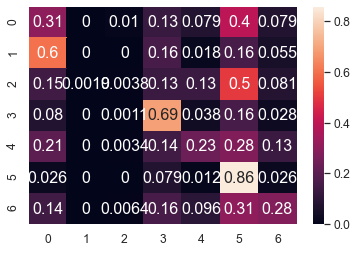

	training epoch=1 .. train_loss=1.529
	validation epoch=1 .. val_loss=1.608
	Accuracy = 39.900000000000006 % .. Percision = 31.1 % .. Recall = 33.900000000000006 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_1.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 2 .. loss = 1.233


  0%|                                                                                 | 1/1914 [00:01<36:10,  1.13s/it]

training @ epoch 2 .. loss = 1.474


  0%|                                                                                 | 2/1914 [00:02<36:13,  1.14s/it]

training @ epoch 2 .. loss = 1.473


  0%|▏                                                                                | 3/1914 [00:03<36:31,  1.15s/it]

training @ epoch 2 .. loss = 1.364


  0%|▏                                                                                | 4/1914 [00:04<36:15,  1.14s/it]

training @ epoch 2 .. loss = 0.982


  0%|▏                                                                                | 5/1914 [00:05<36:33,  1.15s/it]

training @ epoch 2 .. loss = 1.433


  0%|▎                                                                                | 6/1914 [00:06<36:22,  1.14s/it]

training @ epoch 2 .. loss = 1.152


  0%|▎                                                                                | 7/1914 [00:07<36:03,  1.13s/it]

training @ epoch 2 .. loss = 1.542


  0%|▎                                                                                | 8/1914 [00:09<35:59,  1.13s/it]

training @ epoch 2 .. loss = 1.414


  0%|▍                                                                                | 9/1914 [00:10<36:09,  1.14s/it]

training @ epoch 2 .. loss = 1.688


  1%|▍                                                                               | 10/1914 [00:11<36:21,  1.15s/it]

training @ epoch 2 .. loss = 1.32


  1%|▍                                                                               | 11/1914 [00:12<36:04,  1.14s/it]

training @ epoch 2 .. loss = 1.764


  1%|▌                                                                               | 12/1914 [00:13<36:16,  1.14s/it]

training @ epoch 2 .. loss = 1.212


  1%|▌                                                                               | 13/1914 [00:14<36:02,  1.14s/it]

training @ epoch 2 .. loss = 1.317


  1%|▌                                                                               | 14/1914 [00:15<36:04,  1.14s/it]

training @ epoch 2 .. loss = 1.416


  1%|▋                                                                               | 15/1914 [00:17<35:53,  1.13s/it]

training @ epoch 2 .. loss = 1.104


  1%|▋                                                                               | 16/1914 [00:18<35:39,  1.13s/it]

training @ epoch 2 .. loss = 1.373


  1%|▋                                                                               | 17/1914 [00:19<35:52,  1.13s/it]

training @ epoch 2 .. loss = 1.39


  1%|▊                                                                               | 18/1914 [00:20<35:33,  1.13s/it]

training @ epoch 2 .. loss = 1.871


  1%|▊                                                                               | 19/1914 [00:21<35:46,  1.13s/it]

training @ epoch 2 .. loss = 1.58


  1%|▊                                                                               | 20/1914 [00:22<35:24,  1.12s/it]

training @ epoch 2 .. loss = 1.757


  1%|▉                                                                               | 21/1914 [00:24<37:27,  1.19s/it]

training @ epoch 2 .. loss = 1.138


  1%|▉                                                                               | 22/1914 [00:25<38:04,  1.21s/it]

training @ epoch 2 .. loss = 1.582


  1%|▉                                                                               | 23/1914 [00:26<37:19,  1.18s/it]

training @ epoch 2 .. loss = 1.286


  1%|█                                                                               | 24/1914 [00:27<36:49,  1.17s/it]

training @ epoch 2 .. loss = 1.376


  1%|█                                                                               | 25/1914 [00:28<36:26,  1.16s/it]

training @ epoch 2 .. loss = 1.535


  1%|█                                                                               | 26/1914 [00:29<36:09,  1.15s/it]

training @ epoch 2 .. loss = 1.849


  1%|█▏                                                                              | 27/1914 [00:30<36:06,  1.15s/it]

training @ epoch 2 .. loss = 1.196


  1%|█▏                                                                              | 28/1914 [00:32<36:10,  1.15s/it]

training @ epoch 2 .. loss = 1.285


  2%|█▏                                                                              | 29/1914 [00:33<35:56,  1.14s/it]

training @ epoch 2 .. loss = 1.24


  2%|█▎                                                                              | 30/1914 [00:34<35:36,  1.13s/it]

training @ epoch 2 .. loss = 1.699


  2%|█▎                                                                              | 31/1914 [00:35<35:48,  1.14s/it]

training @ epoch 2 .. loss = 1.695


  2%|█▎                                                                              | 32/1914 [00:36<35:25,  1.13s/it]

training @ epoch 2 .. loss = 1.511


  2%|█▍                                                                              | 33/1914 [00:37<35:48,  1.14s/it]

training @ epoch 2 .. loss = 1.266


  2%|█▍                                                                              | 34/1914 [00:38<35:55,  1.15s/it]

training @ epoch 2 .. loss = 1.401


  2%|█▍                                                                              | 35/1914 [00:40<36:02,  1.15s/it]

training @ epoch 2 .. loss = 1.768


  2%|█▌                                                                              | 36/1914 [00:41<36:09,  1.15s/it]

training @ epoch 2 .. loss = 1.516


  2%|█▌                                                                              | 37/1914 [00:42<35:27,  1.13s/it]

training @ epoch 2 .. loss = 1.46


  2%|█▌                                                                              | 38/1914 [00:43<35:39,  1.14s/it]

training @ epoch 2 .. loss = 1.28


  2%|█▋                                                                              | 39/1914 [00:44<35:57,  1.15s/it]

training @ epoch 2 .. loss = 1.546


  2%|█▋                                                                              | 40/1914 [00:45<36:04,  1.16s/it]

training @ epoch 2 .. loss = 1.604


  2%|█▋                                                                              | 41/1914 [00:46<35:43,  1.14s/it]

training @ epoch 2 .. loss = 1.724


  2%|█▊                                                                              | 42/1914 [00:48<35:47,  1.15s/it]

training @ epoch 2 .. loss = 1.612


  2%|█▊                                                                              | 43/1914 [00:49<35:56,  1.15s/it]

training @ epoch 2 .. loss = 1.447


  2%|█▊                                                                              | 44/1914 [00:50<35:43,  1.15s/it]

training @ epoch 2 .. loss = 1.364


  2%|█▉                                                                              | 45/1914 [00:51<36:07,  1.16s/it]

training @ epoch 2 .. loss = 1.507


  2%|█▉                                                                              | 46/1914 [00:52<35:44,  1.15s/it]

training @ epoch 2 .. loss = 1.259


  2%|█▉                                                                              | 47/1914 [00:53<35:46,  1.15s/it]

training @ epoch 2 .. loss = 1.068


  3%|██                                                                              | 48/1914 [00:55<35:57,  1.16s/it]

training @ epoch 2 .. loss = 1.399


  3%|██                                                                              | 49/1914 [00:56<35:41,  1.15s/it]

training @ epoch 2 .. loss = 1.696


  3%|██                                                                              | 50/1914 [00:57<35:48,  1.15s/it]

training @ epoch 2 .. loss = 1.784


  3%|██▏                                                                             | 51/1914 [00:58<35:30,  1.14s/it]

training @ epoch 2 .. loss = 1.626


  3%|██▏                                                                             | 52/1914 [00:59<35:13,  1.13s/it]

training @ epoch 2 .. loss = 1.276


  3%|██▏                                                                             | 53/1914 [01:00<35:19,  1.14s/it]

training @ epoch 2 .. loss = 1.887


  3%|██▎                                                                             | 54/1914 [01:01<35:32,  1.15s/it]

training @ epoch 2 .. loss = 1.459


  3%|██▎                                                                             | 55/1914 [01:03<36:02,  1.16s/it]

training @ epoch 2 .. loss = 1.78


  3%|██▎                                                                             | 56/1914 [01:04<35:48,  1.16s/it]

training @ epoch 2 .. loss = 1.316


  3%|██▍                                                                             | 57/1914 [01:05<35:12,  1.14s/it]

training @ epoch 2 .. loss = 1.223


  3%|██▍                                                                             | 58/1914 [01:06<35:36,  1.15s/it]

training @ epoch 2 .. loss = 1.255


  3%|██▍                                                                             | 59/1914 [01:07<35:49,  1.16s/it]

training @ epoch 2 .. loss = 1.165


  3%|██▌                                                                             | 60/1914 [01:08<35:44,  1.16s/it]

training @ epoch 2 .. loss = 1.842


  3%|██▌                                                                             | 61/1914 [01:10<35:41,  1.16s/it]

training @ epoch 2 .. loss = 1.408


  3%|██▌                                                                             | 62/1914 [01:11<35:33,  1.15s/it]

training @ epoch 2 .. loss = 1.543


  3%|██▋                                                                             | 63/1914 [01:12<35:14,  1.14s/it]

training @ epoch 2 .. loss = 1.376


  3%|██▋                                                                             | 64/1914 [01:13<35:28,  1.15s/it]

training @ epoch 2 .. loss = 1.005


  3%|██▋                                                                             | 65/1914 [01:14<35:14,  1.14s/it]

training @ epoch 2 .. loss = 1.032


  3%|██▊                                                                             | 66/1914 [01:15<35:18,  1.15s/it]

training @ epoch 2 .. loss = 1.378


  4%|██▊                                                                             | 67/1914 [01:16<35:09,  1.14s/it]

training @ epoch 2 .. loss = 1.196


  4%|██▊                                                                             | 68/1914 [01:18<35:30,  1.15s/it]

training @ epoch 2 .. loss = 1.234


  4%|██▉                                                                             | 69/1914 [01:19<36:41,  1.19s/it]

training @ epoch 2 .. loss = 0.914


  4%|██▉                                                                             | 70/1914 [01:20<37:13,  1.21s/it]

training @ epoch 2 .. loss = 1.211


  4%|██▉                                                                             | 71/1914 [01:21<38:08,  1.24s/it]

training @ epoch 2 .. loss = 1.359


  4%|███                                                                             | 72/1914 [01:23<38:41,  1.26s/it]

training @ epoch 2 .. loss = 1.512


  4%|███                                                                             | 73/1914 [01:24<39:03,  1.27s/it]

training @ epoch 2 .. loss = 1.542


  4%|███                                                                             | 74/1914 [01:25<39:34,  1.29s/it]

training @ epoch 2 .. loss = 1.906


  4%|███▏                                                                            | 75/1914 [01:27<39:19,  1.28s/it]

training @ epoch 2 .. loss = 0.973


  4%|███▏                                                                            | 76/1914 [01:28<38:45,  1.27s/it]

training @ epoch 2 .. loss = 1.185


  4%|███▏                                                                            | 77/1914 [01:29<38:31,  1.26s/it]

training @ epoch 2 .. loss = 1.664


  4%|███▎                                                                            | 78/1914 [01:30<37:16,  1.22s/it]

training @ epoch 2 .. loss = 1.43


  4%|███▎                                                                            | 79/1914 [01:32<38:12,  1.25s/it]

training @ epoch 2 .. loss = 1.554


  4%|███▎                                                                            | 80/1914 [01:33<38:52,  1.27s/it]

training @ epoch 2 .. loss = 1.592


  4%|███▍                                                                            | 81/1914 [01:34<38:46,  1.27s/it]

training @ epoch 2 .. loss = 1.185


  4%|███▍                                                                            | 82/1914 [01:35<38:35,  1.26s/it]

training @ epoch 2 .. loss = 1.527


  4%|███▍                                                                            | 83/1914 [01:37<38:46,  1.27s/it]

training @ epoch 2 .. loss = 1.255


  4%|███▌                                                                            | 84/1914 [01:38<38:29,  1.26s/it]

training @ epoch 2 .. loss = 1.374


  4%|███▌                                                                            | 85/1914 [01:39<38:29,  1.26s/it]

training @ epoch 2 .. loss = 1.394


  4%|███▌                                                                            | 86/1914 [01:40<38:33,  1.27s/it]

training @ epoch 2 .. loss = 1.222


  5%|███▋                                                                            | 87/1914 [01:42<38:42,  1.27s/it]

training @ epoch 2 .. loss = 1.125


  5%|███▋                                                                            | 88/1914 [01:43<39:36,  1.30s/it]

training @ epoch 2 .. loss = 1.739


  5%|███▋                                                                            | 89/1914 [01:44<40:15,  1.32s/it]

training @ epoch 2 .. loss = 1.044


  5%|███▊                                                                            | 90/1914 [01:46<40:24,  1.33s/it]

training @ epoch 2 .. loss = 1.624


  5%|███▊                                                                            | 91/1914 [01:47<40:19,  1.33s/it]

training @ epoch 2 .. loss = 1.549


  5%|███▊                                                                            | 92/1914 [01:48<40:34,  1.34s/it]

training @ epoch 2 .. loss = 1.904


  5%|███▉                                                                            | 93/1914 [01:50<40:39,  1.34s/it]

training @ epoch 2 .. loss = 1.142


  5%|███▉                                                                            | 94/1914 [01:51<38:51,  1.28s/it]

training @ epoch 2 .. loss = 1.441


  5%|███▉                                                                            | 95/1914 [01:52<37:20,  1.23s/it]

training @ epoch 2 .. loss = 1.411


  5%|████                                                                            | 96/1914 [01:53<36:25,  1.20s/it]

training @ epoch 2 .. loss = 0.97


  5%|████                                                                            | 97/1914 [01:54<35:47,  1.18s/it]

training @ epoch 2 .. loss = 1.17


  5%|████                                                                            | 98/1914 [01:55<35:14,  1.16s/it]

training @ epoch 2 .. loss = 1.099


  5%|████▏                                                                           | 99/1914 [01:57<35:03,  1.16s/it]

training @ epoch 2 .. loss = 0.976


  5%|████▏                                                                          | 100/1914 [01:58<34:36,  1.14s/it]

training @ epoch 2 .. loss = 1.969


  5%|████▏                                                                          | 101/1914 [01:59<34:44,  1.15s/it]

training @ epoch 2 .. loss = 1.339


  5%|████▏                                                                          | 102/1914 [02:00<34:36,  1.15s/it]

training @ epoch 2 .. loss = 1.777


  5%|████▎                                                                          | 103/1914 [02:01<34:40,  1.15s/it]

training @ epoch 2 .. loss = 1.036


  5%|████▎                                                                          | 104/1914 [02:02<34:23,  1.14s/it]

training @ epoch 2 .. loss = 1.443


  5%|████▎                                                                          | 105/1914 [02:03<34:29,  1.14s/it]

training @ epoch 2 .. loss = 1.386


  6%|████▍                                                                          | 106/1914 [02:05<34:34,  1.15s/it]

training @ epoch 2 .. loss = 1.282


  6%|████▍                                                                          | 107/1914 [02:06<34:45,  1.15s/it]

training @ epoch 2 .. loss = 1.387


  6%|████▍                                                                          | 108/1914 [02:07<34:38,  1.15s/it]

training @ epoch 2 .. loss = 1.711


  6%|████▍                                                                          | 109/1914 [02:08<34:20,  1.14s/it]

training @ epoch 2 .. loss = 0.941


  6%|████▌                                                                          | 110/1914 [02:09<34:43,  1.15s/it]

training @ epoch 2 .. loss = 1.908


  6%|████▌                                                                          | 111/1914 [02:10<34:26,  1.15s/it]

training @ epoch 2 .. loss = 1.7


  6%|████▌                                                                          | 112/1914 [02:11<34:27,  1.15s/it]

training @ epoch 2 .. loss = 1.407


  6%|████▋                                                                          | 113/1914 [02:13<34:32,  1.15s/it]

training @ epoch 2 .. loss = 1.399


  6%|████▋                                                                          | 114/1914 [02:14<34:21,  1.15s/it]

training @ epoch 2 .. loss = 1.311


  6%|████▋                                                                          | 115/1914 [02:15<34:17,  1.14s/it]

training @ epoch 2 .. loss = 1.767


  6%|████▊                                                                          | 116/1914 [02:16<34:17,  1.14s/it]

training @ epoch 2 .. loss = 1.485


  6%|████▊                                                                          | 117/1914 [02:17<34:39,  1.16s/it]

training @ epoch 2 .. loss = 1.597


  6%|████▊                                                                          | 118/1914 [02:18<34:18,  1.15s/it]

training @ epoch 2 .. loss = 1.245


  6%|████▉                                                                          | 119/1914 [02:20<34:34,  1.16s/it]

training @ epoch 2 .. loss = 1.239


  6%|████▉                                                                          | 120/1914 [02:21<34:21,  1.15s/it]

training @ epoch 2 .. loss = 1.462


  6%|████▉                                                                          | 121/1914 [02:22<33:55,  1.14s/it]

training @ epoch 2 .. loss = 1.177


  6%|█████                                                                          | 122/1914 [02:23<34:05,  1.14s/it]

training @ epoch 2 .. loss = 1.593


  6%|█████                                                                          | 123/1914 [02:24<33:55,  1.14s/it]

training @ epoch 2 .. loss = 1.455


  6%|█████                                                                          | 124/1914 [02:25<34:52,  1.17s/it]

training @ epoch 2 .. loss = 1.467


  7%|█████▏                                                                         | 125/1914 [02:27<37:34,  1.26s/it]

training @ epoch 2 .. loss = 1.924


  7%|█████▏                                                                         | 126/1914 [02:28<39:05,  1.31s/it]

training @ epoch 2 .. loss = 1.172


  7%|█████▏                                                                         | 127/1914 [02:30<39:59,  1.34s/it]

training @ epoch 2 .. loss = 1.192


  7%|█████▎                                                                         | 128/1914 [02:31<40:14,  1.35s/it]

training @ epoch 2 .. loss = 1.137


  7%|█████▎                                                                         | 129/1914 [02:32<39:14,  1.32s/it]

training @ epoch 2 .. loss = 1.504


  7%|█████▎                                                                         | 130/1914 [02:33<38:00,  1.28s/it]

training @ epoch 2 .. loss = 1.766


  7%|█████▍                                                                         | 131/1914 [02:35<36:51,  1.24s/it]

training @ epoch 2 .. loss = 1.025


  7%|█████▍                                                                         | 132/1914 [02:36<35:35,  1.20s/it]

training @ epoch 2 .. loss = 1.605


  7%|█████▍                                                                         | 133/1914 [02:37<34:40,  1.17s/it]

training @ epoch 2 .. loss = 1.324


  7%|█████▌                                                                         | 134/1914 [02:38<34:04,  1.15s/it]

training @ epoch 2 .. loss = 1.536


  7%|█████▌                                                                         | 135/1914 [02:39<34:09,  1.15s/it]

training @ epoch 2 .. loss = 1.172


  7%|█████▌                                                                         | 136/1914 [02:40<33:51,  1.14s/it]

training @ epoch 2 .. loss = 1.639


  7%|█████▋                                                                         | 137/1914 [02:41<33:55,  1.15s/it]

training @ epoch 2 .. loss = 1.585


  7%|█████▋                                                                         | 138/1914 [02:42<33:47,  1.14s/it]

training @ epoch 2 .. loss = 1.719


  7%|█████▋                                                                         | 139/1914 [02:44<33:47,  1.14s/it]

training @ epoch 2 .. loss = 1.105


  7%|█████▊                                                                         | 140/1914 [02:45<34:12,  1.16s/it]

training @ epoch 2 .. loss = 1.69


  7%|█████▊                                                                         | 141/1914 [02:46<33:42,  1.14s/it]

training @ epoch 2 .. loss = 1.362


  7%|█████▊                                                                         | 142/1914 [02:47<34:12,  1.16s/it]

training @ epoch 2 .. loss = 1.476


  7%|█████▉                                                                         | 143/1914 [02:48<35:04,  1.19s/it]

training @ epoch 2 .. loss = 1.14


  8%|█████▉                                                                         | 144/1914 [02:49<34:37,  1.17s/it]

training @ epoch 2 .. loss = 1.749


  8%|█████▉                                                                         | 145/1914 [02:51<34:08,  1.16s/it]

training @ epoch 2 .. loss = 2.024


  8%|██████                                                                         | 146/1914 [02:52<33:46,  1.15s/it]

training @ epoch 2 .. loss = 1.445


  8%|██████                                                                         | 147/1914 [02:53<33:57,  1.15s/it]

training @ epoch 2 .. loss = 1.199


  8%|██████                                                                         | 148/1914 [02:54<33:23,  1.13s/it]

training @ epoch 2 .. loss = 1.556


  8%|██████▏                                                                        | 149/1914 [02:55<33:42,  1.15s/it]

training @ epoch 2 .. loss = 1.406


  8%|██████▏                                                                        | 150/1914 [02:56<33:41,  1.15s/it]

training @ epoch 2 .. loss = 1.983


  8%|██████▏                                                                        | 151/1914 [02:57<33:53,  1.15s/it]

training @ epoch 2 .. loss = 1.376


  8%|██████▎                                                                        | 152/1914 [02:59<33:53,  1.15s/it]

training @ epoch 2 .. loss = 1.448


  8%|██████▎                                                                        | 153/1914 [03:00<33:38,  1.15s/it]

training @ epoch 2 .. loss = 1.297


  8%|██████▎                                                                        | 154/1914 [03:01<33:52,  1.15s/it]

training @ epoch 2 .. loss = 1.779


  8%|██████▍                                                                        | 155/1914 [03:02<33:27,  1.14s/it]

training @ epoch 2 .. loss = 1.529


  8%|██████▍                                                                        | 156/1914 [03:03<33:14,  1.13s/it]

training @ epoch 2 .. loss = 1.279


  8%|██████▍                                                                        | 157/1914 [03:04<33:12,  1.13s/it]

training @ epoch 2 .. loss = 1.583


  8%|██████▌                                                                        | 158/1914 [03:05<33:22,  1.14s/it]

training @ epoch 2 .. loss = 1.425


  8%|██████▌                                                                        | 159/1914 [03:07<33:27,  1.14s/it]

training @ epoch 2 .. loss = 1.339


  8%|██████▌                                                                        | 160/1914 [03:08<32:58,  1.13s/it]

training @ epoch 2 .. loss = 1.543


  8%|██████▋                                                                        | 161/1914 [03:09<33:15,  1.14s/it]

training @ epoch 2 .. loss = 1.224


  8%|██████▋                                                                        | 162/1914 [03:10<32:48,  1.12s/it]

training @ epoch 2 .. loss = 1.536


  9%|██████▋                                                                        | 163/1914 [03:11<33:34,  1.15s/it]

training @ epoch 2 .. loss = 1.793


  9%|██████▊                                                                        | 164/1914 [03:12<32:58,  1.13s/it]

training @ epoch 2 .. loss = 1.542


  9%|██████▊                                                                        | 165/1914 [03:13<32:56,  1.13s/it]

training @ epoch 2 .. loss = 1.607


  9%|██████▊                                                                        | 166/1914 [03:15<33:15,  1.14s/it]

training @ epoch 2 .. loss = 1.222


  9%|██████▉                                                                        | 167/1914 [03:16<33:03,  1.14s/it]

training @ epoch 2 .. loss = 1.367


  9%|██████▉                                                                        | 168/1914 [03:17<33:37,  1.16s/it]

training @ epoch 2 .. loss = 1.569


  9%|██████▉                                                                        | 169/1914 [03:18<33:12,  1.14s/it]

training @ epoch 2 .. loss = 1.391


  9%|███████                                                                        | 170/1914 [03:19<35:32,  1.22s/it]

training @ epoch 2 .. loss = 1.509


  9%|███████                                                                        | 171/1914 [03:21<36:03,  1.24s/it]

training @ epoch 2 .. loss = 1.471


  9%|███████                                                                        | 172/1914 [03:22<36:03,  1.24s/it]

training @ epoch 2 .. loss = 1.65


  9%|███████▏                                                                       | 173/1914 [03:23<36:39,  1.26s/it]

training @ epoch 2 .. loss = 2.012


  9%|███████▏                                                                       | 174/1914 [03:25<36:53,  1.27s/it]

training @ epoch 2 .. loss = 1.575


  9%|███████▏                                                                       | 175/1914 [03:26<36:42,  1.27s/it]

training @ epoch 2 .. loss = 1.079


  9%|███████▎                                                                       | 176/1914 [03:27<37:05,  1.28s/it]

training @ epoch 2 .. loss = 1.67


  9%|███████▎                                                                       | 177/1914 [03:28<37:16,  1.29s/it]

training @ epoch 2 .. loss = 1.683


  9%|███████▎                                                                       | 178/1914 [03:30<36:14,  1.25s/it]

training @ epoch 2 .. loss = 1.682


  9%|███████▍                                                                       | 179/1914 [03:31<35:19,  1.22s/it]

training @ epoch 2 .. loss = 1.319


  9%|███████▍                                                                       | 180/1914 [03:32<34:32,  1.20s/it]

training @ epoch 2 .. loss = 1.441


  9%|███████▍                                                                       | 181/1914 [03:33<34:23,  1.19s/it]

training @ epoch 2 .. loss = 1.437


 10%|███████▌                                                                       | 182/1914 [03:34<33:48,  1.17s/it]

training @ epoch 2 .. loss = 1.195


 10%|███████▌                                                                       | 183/1914 [03:35<33:32,  1.16s/it]

training @ epoch 2 .. loss = 1.583


 10%|███████▌                                                                       | 184/1914 [03:37<34:40,  1.20s/it]

training @ epoch 2 .. loss = 1.494


 10%|███████▋                                                                       | 185/1914 [03:38<36:44,  1.28s/it]

training @ epoch 2 .. loss = 1.459


 10%|███████▋                                                                       | 186/1914 [03:39<36:42,  1.27s/it]

training @ epoch 2 .. loss = 1.518


 10%|███████▋                                                                       | 187/1914 [03:41<36:30,  1.27s/it]

training @ epoch 2 .. loss = 1.316


 10%|███████▊                                                                       | 188/1914 [03:42<35:29,  1.23s/it]

training @ epoch 2 .. loss = 1.507


 10%|███████▊                                                                       | 189/1914 [03:43<34:53,  1.21s/it]

training @ epoch 2 .. loss = 1.264


 10%|███████▊                                                                       | 190/1914 [03:44<34:10,  1.19s/it]

training @ epoch 2 .. loss = 1.478


 10%|███████▉                                                                       | 191/1914 [03:45<34:21,  1.20s/it]

training @ epoch 2 .. loss = 1.914


 10%|███████▉                                                                       | 192/1914 [03:46<33:57,  1.18s/it]

training @ epoch 2 .. loss = 1.688


 10%|███████▉                                                                       | 193/1914 [03:48<34:07,  1.19s/it]

training @ epoch 2 .. loss = 1.238


 10%|████████                                                                       | 194/1914 [03:49<33:58,  1.18s/it]

training @ epoch 2 .. loss = 1.401


 10%|████████                                                                       | 195/1914 [03:50<33:13,  1.16s/it]

training @ epoch 2 .. loss = 1.448


 10%|████████                                                                       | 196/1914 [03:51<33:26,  1.17s/it]

training @ epoch 2 .. loss = 1.862


 10%|████████▏                                                                      | 197/1914 [03:52<32:51,  1.15s/it]

training @ epoch 2 .. loss = 1.292


 10%|████████▏                                                                      | 198/1914 [03:53<32:38,  1.14s/it]

training @ epoch 2 .. loss = 1.473


 10%|████████▏                                                                      | 199/1914 [03:54<32:49,  1.15s/it]

training @ epoch 2 .. loss = 1.503


 10%|████████▎                                                                      | 200/1914 [03:56<32:32,  1.14s/it]

training @ epoch 2 .. loss = 1.47


 11%|████████▎                                                                      | 201/1914 [03:57<32:30,  1.14s/it]

training @ epoch 2 .. loss = 1.781


 11%|████████▎                                                                      | 202/1914 [03:58<32:25,  1.14s/it]

training @ epoch 2 .. loss = 1.325


 11%|████████▍                                                                      | 203/1914 [03:59<32:32,  1.14s/it]

training @ epoch 2 .. loss = 1.403


 11%|████████▍                                                                      | 204/1914 [04:00<32:40,  1.15s/it]

training @ epoch 2 .. loss = 1.682


 11%|████████▍                                                                      | 205/1914 [04:01<32:42,  1.15s/it]

training @ epoch 2 .. loss = 1.283


 11%|████████▌                                                                      | 206/1914 [04:02<32:10,  1.13s/it]

training @ epoch 2 .. loss = 1.345


 11%|████████▌                                                                      | 207/1914 [04:04<32:20,  1.14s/it]

training @ epoch 2 .. loss = 1.405


 11%|████████▌                                                                      | 208/1914 [04:05<32:22,  1.14s/it]

training @ epoch 2 .. loss = 1.423


 11%|████████▋                                                                      | 209/1914 [04:06<32:33,  1.15s/it]

training @ epoch 2 .. loss = 1.643


 11%|████████▋                                                                      | 210/1914 [04:07<32:50,  1.16s/it]

training @ epoch 2 .. loss = 1.627


 11%|████████▋                                                                      | 211/1914 [04:08<32:47,  1.16s/it]

training @ epoch 2 .. loss = 1.387


 11%|████████▊                                                                      | 212/1914 [04:09<32:42,  1.15s/it]

training @ epoch 2 .. loss = 1.919


 11%|████████▊                                                                      | 213/1914 [04:10<32:34,  1.15s/it]

training @ epoch 2 .. loss = 1.774


 11%|████████▊                                                                      | 214/1914 [04:12<32:23,  1.14s/it]

training @ epoch 2 .. loss = 1.258


 11%|████████▊                                                                      | 215/1914 [04:13<32:18,  1.14s/it]

training @ epoch 2 .. loss = 1.817


 11%|████████▉                                                                      | 216/1914 [04:14<32:23,  1.14s/it]

training @ epoch 2 .. loss = 1.756


 11%|████████▉                                                                      | 217/1914 [04:15<32:16,  1.14s/it]

training @ epoch 2 .. loss = 1.639


 11%|████████▉                                                                      | 218/1914 [04:16<32:04,  1.13s/it]

training @ epoch 2 .. loss = 1.512


 11%|█████████                                                                      | 219/1914 [04:17<32:11,  1.14s/it]

training @ epoch 2 .. loss = 1.149


 11%|█████████                                                                      | 220/1914 [04:18<32:18,  1.14s/it]

training @ epoch 2 .. loss = 1.283


 12%|█████████                                                                      | 221/1914 [04:20<32:08,  1.14s/it]

training @ epoch 2 .. loss = 1.377


 12%|█████████▏                                                                     | 222/1914 [04:21<32:12,  1.14s/it]

training @ epoch 2 .. loss = 1.39


 12%|█████████▏                                                                     | 223/1914 [04:22<32:04,  1.14s/it]

training @ epoch 2 .. loss = 2.108


 12%|█████████▏                                                                     | 224/1914 [04:23<32:22,  1.15s/it]

training @ epoch 2 .. loss = 1.388


 12%|█████████▎                                                                     | 225/1914 [04:24<32:06,  1.14s/it]

training @ epoch 2 .. loss = 1.276


 12%|█████████▎                                                                     | 226/1914 [04:25<31:55,  1.13s/it]

training @ epoch 2 .. loss = 1.517


 12%|█████████▎                                                                     | 227/1914 [04:26<31:53,  1.13s/it]

training @ epoch 2 .. loss = 1.656


 12%|█████████▍                                                                     | 228/1914 [04:28<31:53,  1.13s/it]

training @ epoch 2 .. loss = 1.353


 12%|█████████▍                                                                     | 229/1914 [04:29<31:58,  1.14s/it]

training @ epoch 2 .. loss = 1.568


 12%|█████████▍                                                                     | 230/1914 [04:30<31:53,  1.14s/it]

training @ epoch 2 .. loss = 1.542


 12%|█████████▌                                                                     | 231/1914 [04:31<32:00,  1.14s/it]

training @ epoch 2 .. loss = 1.275


 12%|█████████▌                                                                     | 232/1914 [04:32<31:29,  1.12s/it]

training @ epoch 2 .. loss = 1.382


 12%|█████████▌                                                                     | 233/1914 [04:33<32:01,  1.14s/it]

training @ epoch 2 .. loss = 1.501


 12%|█████████▋                                                                     | 234/1914 [04:34<31:46,  1.13s/it]

training @ epoch 2 .. loss = 1.266


 12%|█████████▋                                                                     | 235/1914 [04:36<31:55,  1.14s/it]

training @ epoch 2 .. loss = 1.585


 12%|█████████▋                                                                     | 236/1914 [04:37<32:11,  1.15s/it]

training @ epoch 2 .. loss = 1.446


 12%|█████████▊                                                                     | 237/1914 [04:38<32:30,  1.16s/it]

training @ epoch 2 .. loss = 1.773


 12%|█████████▊                                                                     | 238/1914 [04:39<32:40,  1.17s/it]

training @ epoch 2 .. loss = 1.448


 12%|█████████▊                                                                     | 239/1914 [04:40<32:32,  1.17s/it]

training @ epoch 2 .. loss = 1.529


 13%|█████████▉                                                                     | 240/1914 [04:41<32:29,  1.16s/it]

training @ epoch 2 .. loss = 1.27


 13%|█████████▉                                                                     | 241/1914 [04:43<32:26,  1.16s/it]

training @ epoch 2 .. loss = 1.444


 13%|█████████▉                                                                     | 242/1914 [04:44<31:52,  1.14s/it]

training @ epoch 2 .. loss = 1.83


 13%|██████████                                                                     | 243/1914 [04:45<31:41,  1.14s/it]

training @ epoch 2 .. loss = 1.829


 13%|██████████                                                                     | 244/1914 [04:46<31:45,  1.14s/it]

training @ epoch 2 .. loss = 1.322


 13%|██████████                                                                     | 245/1914 [04:47<31:42,  1.14s/it]

training @ epoch 2 .. loss = 1.36


 13%|██████████▏                                                                    | 246/1914 [04:48<31:30,  1.13s/it]

training @ epoch 2 .. loss = 1.393


 13%|██████████▏                                                                    | 247/1914 [04:49<31:23,  1.13s/it]

training @ epoch 2 .. loss = 1.311


 13%|██████████▏                                                                    | 248/1914 [04:50<31:45,  1.14s/it]

training @ epoch 2 .. loss = 1.725


 13%|██████████▎                                                                    | 249/1914 [04:52<31:29,  1.13s/it]

training @ epoch 2 .. loss = 1.362


 13%|██████████▎                                                                    | 250/1914 [04:53<31:35,  1.14s/it]

training @ epoch 2 .. loss = 1.486


 13%|██████████▎                                                                    | 251/1914 [04:54<31:10,  1.13s/it]

training @ epoch 2 .. loss = 0.953


 13%|██████████▍                                                                    | 252/1914 [04:55<31:25,  1.13s/it]

training @ epoch 2 .. loss = 1.199


 13%|██████████▍                                                                    | 253/1914 [04:56<31:24,  1.13s/it]

training @ epoch 2 .. loss = 1.262


 13%|██████████▍                                                                    | 254/1914 [04:57<31:43,  1.15s/it]

training @ epoch 2 .. loss = 1.146


 13%|██████████▌                                                                    | 255/1914 [04:58<31:49,  1.15s/it]

training @ epoch 2 .. loss = 1.446


 13%|██████████▌                                                                    | 256/1914 [05:00<31:44,  1.15s/it]

training @ epoch 2 .. loss = 1.118


 13%|██████████▌                                                                    | 257/1914 [05:01<31:39,  1.15s/it]

training @ epoch 2 .. loss = 1.583


 13%|██████████▋                                                                    | 258/1914 [05:02<31:38,  1.15s/it]

training @ epoch 2 .. loss = 1.974


 14%|██████████▋                                                                    | 259/1914 [05:03<31:31,  1.14s/it]

training @ epoch 2 .. loss = 1.385


 14%|██████████▋                                                                    | 260/1914 [05:04<31:38,  1.15s/it]

training @ epoch 2 .. loss = 1.327


 14%|██████████▊                                                                    | 261/1914 [05:05<31:38,  1.15s/it]

training @ epoch 2 .. loss = 2.057


 14%|██████████▊                                                                    | 262/1914 [05:06<31:44,  1.15s/it]

training @ epoch 2 .. loss = 1.582


 14%|██████████▊                                                                    | 263/1914 [05:08<31:41,  1.15s/it]

training @ epoch 2 .. loss = 1.283


 14%|██████████▉                                                                    | 264/1914 [05:09<32:18,  1.17s/it]

training @ epoch 2 .. loss = 1.376


 14%|██████████▉                                                                    | 265/1914 [05:10<31:58,  1.16s/it]

training @ epoch 2 .. loss = 1.398


 14%|██████████▉                                                                    | 266/1914 [05:11<31:59,  1.16s/it]

training @ epoch 2 .. loss = 1.808


 14%|███████████                                                                    | 267/1914 [05:12<31:53,  1.16s/it]

training @ epoch 2 .. loss = 1.155


 14%|███████████                                                                    | 268/1914 [05:13<31:51,  1.16s/it]

training @ epoch 2 .. loss = 1.119


 14%|███████████                                                                    | 269/1914 [05:15<31:51,  1.16s/it]

training @ epoch 2 .. loss = 1.695


 14%|███████████▏                                                                   | 270/1914 [05:16<31:34,  1.15s/it]

training @ epoch 2 .. loss = 0.971


 14%|███████████▏                                                                   | 271/1914 [05:17<31:39,  1.16s/it]

training @ epoch 2 .. loss = 1.406


 14%|███████████▏                                                                   | 272/1914 [05:18<31:43,  1.16s/it]

training @ epoch 2 .. loss = 1.427


 14%|███████████▎                                                                   | 273/1914 [05:19<33:29,  1.22s/it]

training @ epoch 2 .. loss = 1.339


 14%|███████████▎                                                                   | 274/1914 [05:21<33:42,  1.23s/it]

training @ epoch 2 .. loss = 1.451


 14%|███████████▎                                                                   | 275/1914 [05:22<34:10,  1.25s/it]

training @ epoch 2 .. loss = 1.457


 14%|███████████▍                                                                   | 276/1914 [05:23<34:40,  1.27s/it]

training @ epoch 2 .. loss = 1.207


 14%|███████████▍                                                                   | 277/1914 [05:25<34:30,  1.27s/it]

training @ epoch 2 .. loss = 1.312


 15%|███████████▍                                                                   | 278/1914 [05:26<35:32,  1.30s/it]

training @ epoch 2 .. loss = 1.114


 15%|███████████▌                                                                   | 279/1914 [05:27<35:42,  1.31s/it]

training @ epoch 2 .. loss = 1.667


 15%|███████████▌                                                                   | 280/1914 [05:29<35:48,  1.31s/it]

training @ epoch 2 .. loss = 1.629


 15%|███████████▌                                                                   | 281/1914 [05:30<36:06,  1.33s/it]

training @ epoch 2 .. loss = 1.144


 15%|███████████▋                                                                   | 282/1914 [05:31<35:48,  1.32s/it]

training @ epoch 2 .. loss = 1.176


 15%|███████████▋                                                                   | 283/1914 [05:32<34:34,  1.27s/it]

training @ epoch 2 .. loss = 1.319


 15%|███████████▋                                                                   | 284/1914 [05:34<33:24,  1.23s/it]

training @ epoch 2 .. loss = 1.292


 15%|███████████▊                                                                   | 285/1914 [05:35<32:43,  1.21s/it]

training @ epoch 2 .. loss = 1.48


 15%|███████████▊                                                                   | 286/1914 [05:36<32:05,  1.18s/it]

training @ epoch 2 .. loss = 1.161


 15%|███████████▊                                                                   | 287/1914 [05:37<32:12,  1.19s/it]

training @ epoch 2 .. loss = 1.367


 15%|███████████▉                                                                   | 288/1914 [05:38<31:44,  1.17s/it]

training @ epoch 2 .. loss = 1.661


 15%|███████████▉                                                                   | 289/1914 [05:39<31:28,  1.16s/it]

training @ epoch 2 .. loss = 1.479


 15%|███████████▉                                                                   | 290/1914 [05:40<31:22,  1.16s/it]

training @ epoch 2 .. loss = 2.159


 15%|████████████                                                                   | 291/1914 [05:42<31:18,  1.16s/it]

training @ epoch 2 .. loss = 1.923


 15%|████████████                                                                   | 292/1914 [05:43<31:11,  1.15s/it]

training @ epoch 2 .. loss = 1.027


 15%|████████████                                                                   | 293/1914 [05:44<30:49,  1.14s/it]

training @ epoch 2 .. loss = 1.574


 15%|████████████▏                                                                  | 294/1914 [05:45<30:50,  1.14s/it]

training @ epoch 2 .. loss = 2.07


 15%|████████████▏                                                                  | 295/1914 [05:46<30:45,  1.14s/it]

training @ epoch 2 .. loss = 1.904


 15%|████████████▏                                                                  | 296/1914 [05:47<30:54,  1.15s/it]

training @ epoch 2 .. loss = 1.401


 16%|████████████▎                                                                  | 297/1914 [05:48<30:38,  1.14s/it]

training @ epoch 2 .. loss = 1.713


 16%|████████████▎                                                                  | 298/1914 [05:50<30:38,  1.14s/it]

training @ epoch 2 .. loss = 1.49


 16%|████████████▎                                                                  | 299/1914 [05:51<31:04,  1.15s/it]

training @ epoch 2 .. loss = 1.416


 16%|████████████▍                                                                  | 300/1914 [05:52<31:14,  1.16s/it]

training @ epoch 2 .. loss = 1.509


 16%|████████████▍                                                                  | 301/1914 [05:53<31:12,  1.16s/it]

training @ epoch 2 .. loss = 1.56


 16%|████████████▍                                                                  | 302/1914 [05:54<30:57,  1.15s/it]

training @ epoch 2 .. loss = 1.311


 16%|████████████▌                                                                  | 303/1914 [05:55<30:58,  1.15s/it]

training @ epoch 2 .. loss = 1.392


 16%|████████████▌                                                                  | 304/1914 [05:57<31:01,  1.16s/it]

training @ epoch 2 .. loss = 1.569


 16%|████████████▌                                                                  | 305/1914 [05:58<30:35,  1.14s/it]

training @ epoch 2 .. loss = 1.691


 16%|████████████▋                                                                  | 306/1914 [05:59<32:11,  1.20s/it]

training @ epoch 2 .. loss = 1.343


 16%|████████████▋                                                                  | 307/1914 [06:00<33:09,  1.24s/it]

training @ epoch 2 .. loss = 1.29


 16%|████████████▋                                                                  | 308/1914 [06:02<33:20,  1.25s/it]

training @ epoch 2 .. loss = 1.75


 16%|████████████▊                                                                  | 309/1914 [06:03<32:33,  1.22s/it]

training @ epoch 2 .. loss = 1.25


 16%|████████████▊                                                                  | 310/1914 [06:04<31:37,  1.18s/it]

training @ epoch 2 .. loss = 1.382


 16%|████████████▊                                                                  | 311/1914 [06:05<31:30,  1.18s/it]

training @ epoch 2 .. loss = 1.471


 16%|████████████▉                                                                  | 312/1914 [06:06<31:14,  1.17s/it]

training @ epoch 2 .. loss = 1.559


 16%|████████████▉                                                                  | 313/1914 [06:07<31:21,  1.18s/it]

training @ epoch 2 .. loss = 1.263


 16%|████████████▉                                                                  | 314/1914 [06:09<31:14,  1.17s/it]

training @ epoch 2 .. loss = 1.293


 16%|█████████████                                                                  | 315/1914 [06:10<30:36,  1.15s/it]

training @ epoch 2 .. loss = 1.615


 17%|█████████████                                                                  | 316/1914 [06:11<30:28,  1.14s/it]

training @ epoch 2 .. loss = 1.533


 17%|█████████████                                                                  | 317/1914 [06:12<30:36,  1.15s/it]

training @ epoch 2 .. loss = 1.399


 17%|█████████████▏                                                                 | 318/1914 [06:13<30:18,  1.14s/it]

training @ epoch 2 .. loss = 1.447


 17%|█████████████▏                                                                 | 319/1914 [06:14<29:51,  1.12s/it]

training @ epoch 2 .. loss = 1.282


 17%|█████████████▏                                                                 | 320/1914 [06:15<30:02,  1.13s/it]

training @ epoch 2 .. loss = 1.557


 17%|█████████████▏                                                                 | 321/1914 [06:16<30:07,  1.13s/it]

training @ epoch 2 .. loss = 1.86


 17%|█████████████▎                                                                 | 322/1914 [06:18<30:19,  1.14s/it]

training @ epoch 2 .. loss = 1.441


 17%|█████████████▎                                                                 | 323/1914 [06:19<30:17,  1.14s/it]

training @ epoch 2 .. loss = 1.408


 17%|█████████████▎                                                                 | 324/1914 [06:20<30:06,  1.14s/it]

training @ epoch 2 .. loss = 1.491


 17%|█████████████▍                                                                 | 325/1914 [06:21<30:32,  1.15s/it]

training @ epoch 2 .. loss = 1.6


 17%|█████████████▍                                                                 | 326/1914 [06:22<30:29,  1.15s/it]

training @ epoch 2 .. loss = 1.475


 17%|█████████████▍                                                                 | 327/1914 [06:23<30:28,  1.15s/it]

training @ epoch 2 .. loss = 1.671


 17%|█████████████▌                                                                 | 328/1914 [06:24<30:27,  1.15s/it]

training @ epoch 2 .. loss = 1.769


 17%|█████████████▌                                                                 | 329/1914 [06:26<30:00,  1.14s/it]

training @ epoch 2 .. loss = 1.559


 17%|█████████████▌                                                                 | 330/1914 [06:27<30:16,  1.15s/it]

training @ epoch 2 .. loss = 1.08


 17%|█████████████▋                                                                 | 331/1914 [06:28<29:51,  1.13s/it]

training @ epoch 2 .. loss = 1.625


 17%|█████████████▋                                                                 | 332/1914 [06:29<29:54,  1.13s/it]

training @ epoch 2 .. loss = 1.025


 17%|█████████████▋                                                                 | 333/1914 [06:30<29:49,  1.13s/it]

training @ epoch 2 .. loss = 1.598


 17%|█████████████▊                                                                 | 334/1914 [06:31<29:54,  1.14s/it]

training @ epoch 2 .. loss = 1.659


 18%|█████████████▊                                                                 | 335/1914 [06:32<29:41,  1.13s/it]

training @ epoch 2 .. loss = 1.369


 18%|█████████████▊                                                                 | 336/1914 [06:34<29:48,  1.13s/it]

training @ epoch 2 .. loss = 1.565


 18%|█████████████▉                                                                 | 337/1914 [06:35<29:40,  1.13s/it]

training @ epoch 2 .. loss = 1.668


 18%|█████████████▉                                                                 | 338/1914 [06:36<29:26,  1.12s/it]

training @ epoch 2 .. loss = 1.515


 18%|█████████████▉                                                                 | 339/1914 [06:37<29:35,  1.13s/it]

training @ epoch 2 .. loss = 1.227


 18%|██████████████                                                                 | 340/1914 [06:38<29:22,  1.12s/it]

training @ epoch 2 .. loss = 1.789


 18%|██████████████                                                                 | 341/1914 [06:39<29:55,  1.14s/it]

training @ epoch 2 .. loss = 1.517


 18%|██████████████                                                                 | 342/1914 [06:40<29:35,  1.13s/it]

training @ epoch 2 .. loss = 1.503


 18%|██████████████▏                                                                | 343/1914 [06:41<29:39,  1.13s/it]

training @ epoch 2 .. loss = 1.62


 18%|██████████████▏                                                                | 344/1914 [06:43<29:35,  1.13s/it]

training @ epoch 2 .. loss = 1.525


 18%|██████████████▏                                                                | 345/1914 [06:44<29:44,  1.14s/it]

training @ epoch 2 .. loss = 1.422


 18%|██████████████▎                                                                | 346/1914 [06:45<29:44,  1.14s/it]

training @ epoch 2 .. loss = 1.066


 18%|██████████████▎                                                                | 347/1914 [06:46<29:27,  1.13s/it]

training @ epoch 2 .. loss = 1.311


 18%|██████████████▎                                                                | 348/1914 [06:47<29:56,  1.15s/it]

training @ epoch 2 .. loss = 1.557


 18%|██████████████▍                                                                | 349/1914 [06:48<29:44,  1.14s/it]

training @ epoch 2 .. loss = 1.617


 18%|██████████████▍                                                                | 350/1914 [06:49<30:14,  1.16s/it]

training @ epoch 2 .. loss = 1.582


 18%|██████████████▍                                                                | 351/1914 [06:51<30:08,  1.16s/it]

training @ epoch 2 .. loss = 1.464


 18%|██████████████▌                                                                | 352/1914 [06:52<29:56,  1.15s/it]

training @ epoch 2 .. loss = 1.427


 18%|██████████████▌                                                                | 353/1914 [06:53<30:05,  1.16s/it]

training @ epoch 2 .. loss = 1.457


 18%|██████████████▌                                                                | 354/1914 [06:54<29:27,  1.13s/it]

training @ epoch 2 .. loss = 1.306


 19%|██████████████▋                                                                | 355/1914 [06:55<29:49,  1.15s/it]

training @ epoch 2 .. loss = 1.732


 19%|██████████████▋                                                                | 356/1914 [06:56<29:39,  1.14s/it]

training @ epoch 2 .. loss = 1.284


 19%|██████████████▋                                                                | 357/1914 [06:58<30:03,  1.16s/it]

training @ epoch 2 .. loss = 1.919


 19%|██████████████▊                                                                | 358/1914 [06:59<30:07,  1.16s/it]

training @ epoch 2 .. loss = 1.496


 19%|██████████████▊                                                                | 359/1914 [07:00<29:57,  1.16s/it]

training @ epoch 2 .. loss = 1.391


 19%|██████████████▊                                                                | 360/1914 [07:01<29:49,  1.15s/it]

training @ epoch 2 .. loss = 1.279


 19%|██████████████▉                                                                | 361/1914 [07:02<29:33,  1.14s/it]

training @ epoch 2 .. loss = 1.212


 19%|██████████████▉                                                                | 362/1914 [07:03<29:28,  1.14s/it]

training @ epoch 2 .. loss = 1.484


 19%|██████████████▉                                                                | 363/1914 [07:04<29:15,  1.13s/it]

training @ epoch 2 .. loss = 1.159


 19%|███████████████                                                                | 364/1914 [07:05<29:32,  1.14s/it]

training @ epoch 2 .. loss = 1.599


 19%|███████████████                                                                | 365/1914 [07:07<29:30,  1.14s/it]

training @ epoch 2 .. loss = 1.635


 19%|███████████████                                                                | 366/1914 [07:08<29:20,  1.14s/it]

training @ epoch 2 .. loss = 1.264


 19%|███████████████▏                                                               | 367/1914 [07:09<29:17,  1.14s/it]

training @ epoch 2 .. loss = 1.253


 19%|███████████████▏                                                               | 368/1914 [07:10<29:01,  1.13s/it]

training @ epoch 2 .. loss = 1.639


 19%|███████████████▏                                                               | 369/1914 [07:11<29:21,  1.14s/it]

training @ epoch 2 .. loss = 1.142


 19%|███████████████▎                                                               | 370/1914 [07:12<29:14,  1.14s/it]

training @ epoch 2 .. loss = 1.455


 19%|███████████████▎                                                               | 371/1914 [07:13<29:16,  1.14s/it]

training @ epoch 2 .. loss = 1.225


 19%|███████████████▎                                                               | 372/1914 [07:15<29:33,  1.15s/it]

training @ epoch 2 .. loss = 1.644


 19%|███████████████▍                                                               | 373/1914 [07:16<29:25,  1.15s/it]

training @ epoch 2 .. loss = 1.107


 20%|███████████████▍                                                               | 374/1914 [07:17<29:50,  1.16s/it]

training @ epoch 2 .. loss = 1.443


 20%|███████████████▍                                                               | 375/1914 [07:18<29:11,  1.14s/it]

training @ epoch 2 .. loss = 1.369


 20%|███████████████▌                                                               | 376/1914 [07:19<31:08,  1.22s/it]

training @ epoch 2 .. loss = 1.795


 20%|███████████████▌                                                               | 377/1914 [07:21<31:48,  1.24s/it]

training @ epoch 2 .. loss = 1.406


 20%|███████████████▌                                                               | 378/1914 [07:22<31:46,  1.24s/it]

training @ epoch 2 .. loss = 1.387


 20%|███████████████▋                                                               | 379/1914 [07:23<32:10,  1.26s/it]

training @ epoch 2 .. loss = 1.645


 20%|███████████████▋                                                               | 380/1914 [07:25<32:21,  1.27s/it]

training @ epoch 2 .. loss = 1.519


 20%|███████████████▋                                                               | 381/1914 [07:26<33:32,  1.31s/it]

training @ epoch 2 .. loss = 0.96


 20%|███████████████▊                                                               | 382/1914 [07:27<34:42,  1.36s/it]

training @ epoch 2 .. loss = 1.234


 20%|███████████████▊                                                               | 383/1914 [07:29<34:29,  1.35s/it]

training @ epoch 2 .. loss = 1.506


 20%|███████████████▊                                                               | 384/1914 [07:30<33:33,  1.32s/it]

training @ epoch 2 .. loss = 1.499


 20%|███████████████▉                                                               | 385/1914 [07:31<32:30,  1.28s/it]

training @ epoch 2 .. loss = 1.284


 20%|███████████████▉                                                               | 386/1914 [07:32<31:22,  1.23s/it]

training @ epoch 2 .. loss = 1.783


 20%|███████████████▉                                                               | 387/1914 [07:34<31:03,  1.22s/it]

training @ epoch 2 .. loss = 1.69


 20%|████████████████                                                               | 388/1914 [07:35<30:27,  1.20s/it]

training @ epoch 2 .. loss = 1.639


 20%|████████████████                                                               | 389/1914 [07:36<29:43,  1.17s/it]

training @ epoch 2 .. loss = 1.633


 20%|████████████████                                                               | 390/1914 [07:37<29:18,  1.15s/it]

training @ epoch 2 .. loss = 1.387


 20%|████████████████▏                                                              | 391/1914 [07:38<28:47,  1.13s/it]

training @ epoch 2 .. loss = 1.401


 20%|████████████████▏                                                              | 392/1914 [07:39<29:03,  1.15s/it]

training @ epoch 2 .. loss = 1.049


 21%|████████████████▏                                                              | 393/1914 [07:40<28:48,  1.14s/it]

training @ epoch 2 .. loss = 1.446


 21%|████████████████▎                                                              | 394/1914 [07:41<28:56,  1.14s/it]

training @ epoch 2 .. loss = 1.398


 21%|████████████████▎                                                              | 395/1914 [07:43<28:44,  1.14s/it]

training @ epoch 2 .. loss = 1.456


 21%|████████████████▎                                                              | 396/1914 [07:44<28:42,  1.13s/it]

training @ epoch 2 .. loss = 1.017


 21%|████████████████▍                                                              | 397/1914 [07:45<28:40,  1.13s/it]

training @ epoch 2 .. loss = 1.358


 21%|████████████████▍                                                              | 398/1914 [07:46<28:51,  1.14s/it]

training @ epoch 2 .. loss = 1.413


 21%|████████████████▍                                                              | 399/1914 [07:47<28:30,  1.13s/it]

training @ epoch 2 .. loss = 1.594


 21%|████████████████▌                                                              | 400/1914 [07:48<28:31,  1.13s/it]

training @ epoch 2 .. loss = 1.473


 21%|████████████████▌                                                              | 401/1914 [07:49<28:36,  1.13s/it]

training @ epoch 2 .. loss = 1.485


 21%|████████████████▌                                                              | 402/1914 [07:50<28:40,  1.14s/it]

training @ epoch 2 .. loss = 1.524


 21%|████████████████▋                                                              | 403/1914 [07:52<28:41,  1.14s/it]

training @ epoch 2 .. loss = 1.55


 21%|████████████████▋                                                              | 404/1914 [07:53<28:58,  1.15s/it]

training @ epoch 2 .. loss = 1.129


 21%|████████████████▋                                                              | 405/1914 [07:54<28:23,  1.13s/it]

training @ epoch 2 .. loss = 1.476


 21%|████████████████▊                                                              | 406/1914 [07:55<28:28,  1.13s/it]

training @ epoch 2 .. loss = 1.284


 21%|████████████████▊                                                              | 407/1914 [07:56<28:07,  1.12s/it]

training @ epoch 2 .. loss = 1.386


 21%|████████████████▊                                                              | 408/1914 [07:57<28:40,  1.14s/it]

training @ epoch 2 .. loss = 1.575


 21%|████████████████▉                                                              | 409/1914 [07:58<28:35,  1.14s/it]

training @ epoch 2 .. loss = 1.291


 21%|████████████████▉                                                              | 410/1914 [08:00<28:45,  1.15s/it]

training @ epoch 2 .. loss = 1.35


 21%|████████████████▉                                                              | 411/1914 [08:01<28:38,  1.14s/it]

training @ epoch 2 .. loss = 1.719


 22%|█████████████████                                                              | 412/1914 [08:02<28:34,  1.14s/it]

training @ epoch 2 .. loss = 1.619


 22%|█████████████████                                                              | 413/1914 [08:03<28:46,  1.15s/it]

training @ epoch 2 .. loss = 1.69


 22%|█████████████████                                                              | 414/1914 [08:04<28:28,  1.14s/it]

training @ epoch 2 .. loss = 1.209


 22%|█████████████████▏                                                             | 415/1914 [08:05<28:43,  1.15s/it]

training @ epoch 2 .. loss = 1.22


 22%|█████████████████▏                                                             | 416/1914 [08:07<28:55,  1.16s/it]

training @ epoch 2 .. loss = 1.32


 22%|█████████████████▏                                                             | 417/1914 [08:08<28:38,  1.15s/it]

training @ epoch 2 .. loss = 1.391


 22%|█████████████████▎                                                             | 418/1914 [08:09<28:34,  1.15s/it]

training @ epoch 2 .. loss = 1.312


 22%|█████████████████▎                                                             | 419/1914 [08:10<28:26,  1.14s/it]

training @ epoch 2 .. loss = 1.207


 22%|█████████████████▎                                                             | 420/1914 [08:11<28:24,  1.14s/it]

training @ epoch 2 .. loss = 0.889


 22%|█████████████████▍                                                             | 421/1914 [08:12<28:10,  1.13s/it]

training @ epoch 2 .. loss = 1.035


 22%|█████████████████▍                                                             | 422/1914 [08:13<28:31,  1.15s/it]

training @ epoch 2 .. loss = 1.955


 22%|█████████████████▍                                                             | 423/1914 [08:14<28:32,  1.15s/it]

training @ epoch 2 .. loss = 1.972


 22%|█████████████████▌                                                             | 424/1914 [08:16<28:31,  1.15s/it]

training @ epoch 2 .. loss = 1.028


 22%|█████████████████▌                                                             | 425/1914 [08:17<28:30,  1.15s/it]

training @ epoch 2 .. loss = 1.722


 22%|█████████████████▌                                                             | 426/1914 [08:18<28:17,  1.14s/it]

training @ epoch 2 .. loss = 1.057


 22%|█████████████████▌                                                             | 427/1914 [08:19<28:25,  1.15s/it]

training @ epoch 2 .. loss = 1.758


 22%|█████████████████▋                                                             | 428/1914 [08:20<28:09,  1.14s/it]

training @ epoch 2 .. loss = 1.343


 22%|█████████████████▋                                                             | 429/1914 [08:21<28:15,  1.14s/it]

training @ epoch 2 .. loss = 1.344


 22%|█████████████████▋                                                             | 430/1914 [08:22<28:04,  1.14s/it]

training @ epoch 2 .. loss = 1.253


 23%|█████████████████▊                                                             | 431/1914 [08:24<27:57,  1.13s/it]

training @ epoch 2 .. loss = 1.206


 23%|█████████████████▊                                                             | 432/1914 [08:25<28:04,  1.14s/it]

training @ epoch 2 .. loss = 1.381


 23%|█████████████████▊                                                             | 433/1914 [08:26<27:47,  1.13s/it]

training @ epoch 2 .. loss = 1.412


 23%|█████████████████▉                                                             | 434/1914 [08:27<27:58,  1.13s/it]

training @ epoch 2 .. loss = 1.627


 23%|█████████████████▉                                                             | 435/1914 [08:28<27:59,  1.14s/it]

training @ epoch 2 .. loss = 1.677


 23%|█████████████████▉                                                             | 436/1914 [08:29<28:18,  1.15s/it]

training @ epoch 2 .. loss = 1.332


 23%|██████████████████                                                             | 437/1914 [08:31<30:49,  1.25s/it]

training @ epoch 2 .. loss = 1.206


 23%|██████████████████                                                             | 438/1914 [08:32<30:08,  1.22s/it]

training @ epoch 2 .. loss = 1.347


 23%|██████████████████                                                             | 439/1914 [08:33<29:34,  1.20s/it]

training @ epoch 2 .. loss = 1.493


 23%|██████████████████▏                                                            | 440/1914 [08:34<28:49,  1.17s/it]

training @ epoch 2 .. loss = 1.372


 23%|██████████████████▏                                                            | 441/1914 [08:35<28:34,  1.16s/it]

training @ epoch 2 .. loss = 1.105


 23%|██████████████████▏                                                            | 442/1914 [08:37<28:44,  1.17s/it]

training @ epoch 2 .. loss = 1.558


 23%|██████████████████▎                                                            | 443/1914 [08:38<28:12,  1.15s/it]

training @ epoch 2 .. loss = 1.382


 23%|██████████████████▎                                                            | 444/1914 [08:39<28:20,  1.16s/it]

training @ epoch 2 .. loss = 1.743


 23%|██████████████████▎                                                            | 445/1914 [08:40<28:00,  1.14s/it]

training @ epoch 2 .. loss = 1.366


 23%|██████████████████▍                                                            | 446/1914 [08:41<28:03,  1.15s/it]

training @ epoch 2 .. loss = 1.215


 23%|██████████████████▍                                                            | 447/1914 [08:42<27:48,  1.14s/it]

training @ epoch 2 .. loss = 1.904


 23%|██████████████████▍                                                            | 448/1914 [08:43<28:19,  1.16s/it]

training @ epoch 2 .. loss = 1.781


 23%|██████████████████▌                                                            | 449/1914 [08:45<28:13,  1.16s/it]

training @ epoch 2 .. loss = 1.671


 24%|██████████████████▌                                                            | 450/1914 [08:46<27:44,  1.14s/it]

training @ epoch 2 .. loss = 1.229


 24%|██████████████████▌                                                            | 451/1914 [08:47<27:42,  1.14s/it]

training @ epoch 2 .. loss = 1.548


 24%|██████████████████▋                                                            | 452/1914 [08:48<27:46,  1.14s/it]

training @ epoch 2 .. loss = 1.385


 24%|██████████████████▋                                                            | 453/1914 [08:49<28:00,  1.15s/it]

training @ epoch 2 .. loss = 1.562


 24%|██████████████████▋                                                            | 454/1914 [08:50<27:53,  1.15s/it]

training @ epoch 2 .. loss = 1.458


 24%|██████████████████▊                                                            | 455/1914 [08:52<28:37,  1.18s/it]

training @ epoch 2 .. loss = 1.573


 24%|██████████████████▊                                                            | 456/1914 [08:53<29:11,  1.20s/it]

training @ epoch 2 .. loss = 1.281


 24%|██████████████████▊                                                            | 457/1914 [08:54<28:23,  1.17s/it]

training @ epoch 2 .. loss = 1.121


 24%|██████████████████▉                                                            | 458/1914 [08:55<27:59,  1.15s/it]

training @ epoch 2 .. loss = 1.394


 24%|██████████████████▉                                                            | 459/1914 [08:56<27:59,  1.15s/it]

training @ epoch 2 .. loss = 1.639


 24%|██████████████████▉                                                            | 460/1914 [08:57<28:15,  1.17s/it]

training @ epoch 2 .. loss = 1.272


 24%|███████████████████                                                            | 461/1914 [08:58<27:59,  1.16s/it]

training @ epoch 2 .. loss = 1.678


 24%|███████████████████                                                            | 462/1914 [09:00<27:48,  1.15s/it]

training @ epoch 2 .. loss = 1.947


 24%|███████████████████                                                            | 463/1914 [09:01<27:58,  1.16s/it]

training @ epoch 2 .. loss = 1.402


 24%|███████████████████▏                                                           | 464/1914 [09:02<27:26,  1.14s/it]

training @ epoch 2 .. loss = 1.266


 24%|███████████████████▏                                                           | 465/1914 [09:03<27:38,  1.14s/it]

training @ epoch 2 .. loss = 1.754


 24%|███████████████████▏                                                           | 466/1914 [09:04<27:24,  1.14s/it]

training @ epoch 2 .. loss = 1.688


 24%|███████████████████▎                                                           | 467/1914 [09:05<27:40,  1.15s/it]

training @ epoch 2 .. loss = 1.324


 24%|███████████████████▎                                                           | 468/1914 [09:06<27:46,  1.15s/it]

training @ epoch 2 .. loss = 1.208


 25%|███████████████████▎                                                           | 469/1914 [09:08<27:37,  1.15s/it]

training @ epoch 2 .. loss = 1.076


 25%|███████████████████▍                                                           | 470/1914 [09:09<27:46,  1.15s/it]

training @ epoch 2 .. loss = 1.09


 25%|███████████████████▍                                                           | 471/1914 [09:10<27:25,  1.14s/it]

training @ epoch 2 .. loss = 1.685


 25%|███████████████████▍                                                           | 472/1914 [09:11<27:28,  1.14s/it]

training @ epoch 2 .. loss = 1.261


 25%|███████████████████▌                                                           | 473/1914 [09:12<27:06,  1.13s/it]

training @ epoch 2 .. loss = 1.573


 25%|███████████████████▌                                                           | 474/1914 [09:13<27:15,  1.14s/it]

training @ epoch 2 .. loss = 1.452


 25%|███████████████████▌                                                           | 475/1914 [09:14<27:21,  1.14s/it]

training @ epoch 2 .. loss = 1.67


 25%|███████████████████▋                                                           | 476/1914 [09:16<27:16,  1.14s/it]

training @ epoch 2 .. loss = 1.718


 25%|███████████████████▋                                                           | 477/1914 [09:17<27:19,  1.14s/it]

training @ epoch 2 .. loss = 1.245


 25%|███████████████████▋                                                           | 478/1914 [09:18<27:11,  1.14s/it]

training @ epoch 2 .. loss = 1.536


 25%|███████████████████▊                                                           | 479/1914 [09:19<29:05,  1.22s/it]

training @ epoch 2 .. loss = 2.071


 25%|███████████████████▊                                                           | 480/1914 [09:21<29:41,  1.24s/it]

training @ epoch 2 .. loss = 1.515


 25%|███████████████████▊                                                           | 481/1914 [09:22<29:52,  1.25s/it]

training @ epoch 2 .. loss = 1.244


 25%|███████████████████▉                                                           | 482/1914 [09:23<31:19,  1.31s/it]

training @ epoch 2 .. loss = 1.423


 25%|███████████████████▉                                                           | 483/1914 [09:25<32:16,  1.35s/it]

training @ epoch 2 .. loss = 1.1


 25%|███████████████████▉                                                           | 484/1914 [09:26<33:03,  1.39s/it]

training @ epoch 2 .. loss = 1.457


 25%|████████████████████                                                           | 485/1914 [09:28<33:14,  1.40s/it]

training @ epoch 2 .. loss = 1.447


 25%|████████████████████                                                           | 486/1914 [09:29<33:43,  1.42s/it]

training @ epoch 2 .. loss = 1.457


 25%|████████████████████                                                           | 487/1914 [09:31<33:58,  1.43s/it]

training @ epoch 2 .. loss = 1.737


 25%|████████████████████▏                                                          | 488/1914 [09:32<33:03,  1.39s/it]

training @ epoch 2 .. loss = 1.342


 26%|████████████████████▏                                                          | 489/1914 [09:33<31:24,  1.32s/it]

training @ epoch 2 .. loss = 1.62


 26%|████████████████████▏                                                          | 490/1914 [09:34<30:11,  1.27s/it]

training @ epoch 2 .. loss = 1.057


 26%|████████████████████▎                                                          | 491/1914 [09:35<29:20,  1.24s/it]

training @ epoch 2 .. loss = 1.511


 26%|████████████████████▎                                                          | 492/1914 [09:36<28:39,  1.21s/it]

training @ epoch 2 .. loss = 1.401


 26%|████████████████████▎                                                          | 493/1914 [09:38<27:55,  1.18s/it]

training @ epoch 2 .. loss = 1.182


 26%|████████████████████▍                                                          | 494/1914 [09:39<27:40,  1.17s/it]

training @ epoch 2 .. loss = 1.686


 26%|████████████████████▍                                                          | 495/1914 [09:40<27:31,  1.16s/it]

training @ epoch 2 .. loss = 1.225


 26%|████████████████████▍                                                          | 496/1914 [09:41<27:26,  1.16s/it]

training @ epoch 2 .. loss = 2.057


 26%|████████████████████▌                                                          | 497/1914 [09:42<27:05,  1.15s/it]

training @ epoch 2 .. loss = 1.683


 26%|████████████████████▌                                                          | 498/1914 [09:43<26:56,  1.14s/it]

training @ epoch 2 .. loss = 1.001


 26%|████████████████████▌                                                          | 499/1914 [09:44<27:05,  1.15s/it]

training @ epoch 2 .. loss = 1.55


 26%|████████████████████▋                                                          | 500/1914 [09:46<26:51,  1.14s/it]

training @ epoch 2 .. loss = 1.338


 26%|████████████████████▋                                                          | 501/1914 [09:47<26:47,  1.14s/it]

training @ epoch 2 .. loss = 1.614


 26%|████████████████████▋                                                          | 502/1914 [09:48<26:31,  1.13s/it]

training @ epoch 2 .. loss = 1.663


 26%|████████████████████▊                                                          | 503/1914 [09:49<27:22,  1.16s/it]

training @ epoch 2 .. loss = 1.111


 26%|████████████████████▊                                                          | 504/1914 [09:50<27:14,  1.16s/it]

training @ epoch 2 .. loss = 1.834


 26%|████████████████████▊                                                          | 505/1914 [09:51<27:11,  1.16s/it]

training @ epoch 2 .. loss = 1.63


 26%|████████████████████▉                                                          | 506/1914 [09:53<27:38,  1.18s/it]

training @ epoch 2 .. loss = 1.199


 26%|████████████████████▉                                                          | 507/1914 [09:54<27:21,  1.17s/it]

training @ epoch 2 .. loss = 1.118


 27%|████████████████████▉                                                          | 508/1914 [09:55<27:22,  1.17s/it]

training @ epoch 2 .. loss = 1.596


 27%|█████████████████████                                                          | 509/1914 [09:56<26:56,  1.15s/it]

training @ epoch 2 .. loss = 1.687


 27%|█████████████████████                                                          | 510/1914 [09:57<27:03,  1.16s/it]

training @ epoch 2 .. loss = 1.53


 27%|█████████████████████                                                          | 511/1914 [09:58<26:39,  1.14s/it]

training @ epoch 2 .. loss = 1.779


 27%|█████████████████████▏                                                         | 512/1914 [09:59<26:42,  1.14s/it]

training @ epoch 2 .. loss = 1.632


 27%|█████████████████████▏                                                         | 513/1914 [10:01<26:48,  1.15s/it]

training @ epoch 2 .. loss = 1.809


 27%|█████████████████████▏                                                         | 514/1914 [10:02<26:50,  1.15s/it]

training @ epoch 2 .. loss = 1.266


 27%|█████████████████████▎                                                         | 515/1914 [10:03<26:58,  1.16s/it]

training @ epoch 2 .. loss = 1.514


 27%|█████████████████████▎                                                         | 516/1914 [10:04<26:28,  1.14s/it]

training @ epoch 2 .. loss = 1.305


 27%|█████████████████████▎                                                         | 517/1914 [10:05<26:35,  1.14s/it]

training @ epoch 2 .. loss = 1.463


 27%|█████████████████████▍                                                         | 518/1914 [10:06<26:08,  1.12s/it]

training @ epoch 2 .. loss = 1.766


 27%|█████████████████████▍                                                         | 519/1914 [10:07<26:10,  1.13s/it]

training @ epoch 2 .. loss = 1.284


 27%|█████████████████████▍                                                         | 520/1914 [10:08<26:12,  1.13s/it]

training @ epoch 2 .. loss = 1.345


 27%|█████████████████████▌                                                         | 521/1914 [10:10<26:00,  1.12s/it]

training @ epoch 2 .. loss = 1.235


 27%|█████████████████████▌                                                         | 522/1914 [10:11<26:19,  1.13s/it]

training @ epoch 2 .. loss = 1.455


 27%|█████████████████████▌                                                         | 523/1914 [10:12<25:53,  1.12s/it]

training @ epoch 2 .. loss = 1.377


 27%|█████████████████████▋                                                         | 524/1914 [10:13<26:15,  1.13s/it]

training @ epoch 2 .. loss = 1.542


 27%|█████████████████████▋                                                         | 525/1914 [10:14<26:26,  1.14s/it]

training @ epoch 2 .. loss = 1.403


 27%|█████████████████████▋                                                         | 526/1914 [10:15<26:27,  1.14s/it]

training @ epoch 2 .. loss = 1.619


 28%|█████████████████████▊                                                         | 527/1914 [10:16<26:10,  1.13s/it]

training @ epoch 2 .. loss = 1.508


 28%|█████████████████████▊                                                         | 528/1914 [10:18<26:21,  1.14s/it]

training @ epoch 2 .. loss = 1.563


 28%|█████████████████████▊                                                         | 529/1914 [10:19<26:32,  1.15s/it]

training @ epoch 2 .. loss = 1.136


 28%|█████████████████████▉                                                         | 530/1914 [10:20<26:28,  1.15s/it]

training @ epoch 2 .. loss = 1.311


 28%|█████████████████████▉                                                         | 531/1914 [10:21<26:36,  1.15s/it]

training @ epoch 2 .. loss = 1.435


 28%|█████████████████████▉                                                         | 532/1914 [10:22<26:30,  1.15s/it]

training @ epoch 2 .. loss = 1.458


 28%|█████████████████████▉                                                         | 533/1914 [10:23<26:24,  1.15s/it]

training @ epoch 2 .. loss = 1.622


 28%|██████████████████████                                                         | 534/1914 [10:24<26:11,  1.14s/it]

training @ epoch 2 .. loss = 1.317


 28%|██████████████████████                                                         | 535/1914 [10:26<25:54,  1.13s/it]

training @ epoch 2 .. loss = 1.427


 28%|██████████████████████                                                         | 536/1914 [10:27<26:04,  1.14s/it]

training @ epoch 2 .. loss = 1.665


 28%|██████████████████████▏                                                        | 537/1914 [10:28<26:06,  1.14s/it]

training @ epoch 2 .. loss = 1.251


 28%|██████████████████████▏                                                        | 538/1914 [10:29<26:12,  1.14s/it]

training @ epoch 2 .. loss = 1.472


 28%|██████████████████████▏                                                        | 539/1914 [10:30<26:03,  1.14s/it]

training @ epoch 2 .. loss = 1.445


 28%|██████████████████████▎                                                        | 540/1914 [10:31<26:09,  1.14s/it]

training @ epoch 2 .. loss = 1.339


 28%|██████████████████████▎                                                        | 541/1914 [10:32<25:55,  1.13s/it]

training @ epoch 2 .. loss = 1.353


 28%|██████████████████████▎                                                        | 542/1914 [10:34<25:50,  1.13s/it]

training @ epoch 2 .. loss = 1.082


 28%|██████████████████████▍                                                        | 543/1914 [10:35<25:49,  1.13s/it]

training @ epoch 2 .. loss = 1.263


 28%|██████████████████████▍                                                        | 544/1914 [10:36<25:44,  1.13s/it]

training @ epoch 2 .. loss = 1.55


 28%|██████████████████████▍                                                        | 545/1914 [10:37<26:14,  1.15s/it]

training @ epoch 2 .. loss = 1.232


 29%|██████████████████████▌                                                        | 546/1914 [10:38<26:01,  1.14s/it]

training @ epoch 2 .. loss = 1.122


 29%|██████████████████████▌                                                        | 547/1914 [10:39<26:17,  1.15s/it]

training @ epoch 2 .. loss = 1.069


 29%|██████████████████████▌                                                        | 548/1914 [10:40<26:03,  1.14s/it]

training @ epoch 2 .. loss = 1.635


 29%|██████████████████████▋                                                        | 549/1914 [10:42<25:56,  1.14s/it]

training @ epoch 2 .. loss = 1.689


 29%|██████████████████████▋                                                        | 550/1914 [10:43<26:05,  1.15s/it]

training @ epoch 2 .. loss = 1.451


 29%|██████████████████████▋                                                        | 551/1914 [10:44<25:40,  1.13s/it]

training @ epoch 2 .. loss = 1.661


 29%|██████████████████████▊                                                        | 552/1914 [10:45<25:45,  1.13s/it]

training @ epoch 2 .. loss = 1.389


 29%|██████████████████████▊                                                        | 553/1914 [10:46<25:51,  1.14s/it]

training @ epoch 2 .. loss = 1.172


 29%|██████████████████████▊                                                        | 554/1914 [10:47<25:42,  1.13s/it]

training @ epoch 2 .. loss = 1.348


 29%|██████████████████████▉                                                        | 555/1914 [10:48<25:41,  1.13s/it]

training @ epoch 2 .. loss = 1.699


 29%|██████████████████████▉                                                        | 556/1914 [10:50<26:26,  1.17s/it]

training @ epoch 2 .. loss = 1.34


 29%|██████████████████████▉                                                        | 557/1914 [10:51<26:38,  1.18s/it]

training @ epoch 2 .. loss = 1.925


 29%|███████████████████████                                                        | 558/1914 [10:52<26:13,  1.16s/it]

training @ epoch 2 .. loss = 1.23


 29%|███████████████████████                                                        | 559/1914 [10:53<26:17,  1.16s/it]

training @ epoch 2 .. loss = 1.377


 29%|███████████████████████                                                        | 560/1914 [10:54<25:58,  1.15s/it]

training @ epoch 2 .. loss = 1.523


 29%|███████████████████████▏                                                       | 561/1914 [10:55<25:58,  1.15s/it]

training @ epoch 2 .. loss = 1.182


 29%|███████████████████████▏                                                       | 562/1914 [10:56<25:46,  1.14s/it]

training @ epoch 2 .. loss = 1.443


 29%|███████████████████████▏                                                       | 563/1914 [10:58<25:42,  1.14s/it]

training @ epoch 2 .. loss = 1.239


 29%|███████████████████████▎                                                       | 564/1914 [10:59<25:57,  1.15s/it]

training @ epoch 2 .. loss = 1.529


 30%|███████████████████████▎                                                       | 565/1914 [11:00<25:59,  1.16s/it]

training @ epoch 2 .. loss = 1.11


 30%|███████████████████████▎                                                       | 566/1914 [11:01<26:14,  1.17s/it]

training @ epoch 2 .. loss = 1.354


 30%|███████████████████████▍                                                       | 567/1914 [11:02<25:45,  1.15s/it]

training @ epoch 2 .. loss = 1.236


 30%|███████████████████████▍                                                       | 568/1914 [11:03<26:09,  1.17s/it]

training @ epoch 2 .. loss = 1.487


 30%|███████████████████████▍                                                       | 569/1914 [11:05<26:01,  1.16s/it]

training @ epoch 2 .. loss = 1.316


 30%|███████████████████████▌                                                       | 570/1914 [11:06<25:33,  1.14s/it]

training @ epoch 2 .. loss = 1.43


 30%|███████████████████████▌                                                       | 571/1914 [11:07<25:48,  1.15s/it]

training @ epoch 2 .. loss = 1.177


 30%|███████████████████████▌                                                       | 572/1914 [11:08<25:27,  1.14s/it]

training @ epoch 2 .. loss = 1.415


 30%|███████████████████████▋                                                       | 573/1914 [11:09<25:41,  1.15s/it]

training @ epoch 2 .. loss = 1.089


 30%|███████████████████████▋                                                       | 574/1914 [11:10<25:31,  1.14s/it]

training @ epoch 2 .. loss = 1.373


 30%|███████████████████████▋                                                       | 575/1914 [11:11<25:31,  1.14s/it]

training @ epoch 2 .. loss = 1.332


 30%|███████████████████████▊                                                       | 576/1914 [11:13<25:29,  1.14s/it]

training @ epoch 2 .. loss = 1.512


 30%|███████████████████████▊                                                       | 577/1914 [11:14<25:18,  1.14s/it]

training @ epoch 2 .. loss = 1.105


 30%|███████████████████████▊                                                       | 578/1914 [11:15<25:32,  1.15s/it]

training @ epoch 2 .. loss = 1.247


 30%|███████████████████████▉                                                       | 579/1914 [11:16<25:18,  1.14s/it]

training @ epoch 2 .. loss = 1.076


 30%|███████████████████████▉                                                       | 580/1914 [11:17<25:22,  1.14s/it]

training @ epoch 2 .. loss = 1.579


 30%|███████████████████████▉                                                       | 581/1914 [11:18<24:59,  1.13s/it]

training @ epoch 2 .. loss = 1.666


 30%|████████████████████████                                                       | 582/1914 [11:19<25:19,  1.14s/it]

training @ epoch 2 .. loss = 1.14


 30%|████████████████████████                                                       | 583/1914 [11:21<25:09,  1.13s/it]

training @ epoch 2 .. loss = 1.667


 31%|████████████████████████                                                       | 584/1914 [11:22<24:58,  1.13s/it]

training @ epoch 2 .. loss = 1.316


 31%|████████████████████████▏                                                      | 585/1914 [11:23<25:08,  1.14s/it]

training @ epoch 2 .. loss = 1.041


 31%|████████████████████████▏                                                      | 586/1914 [11:24<25:11,  1.14s/it]

training @ epoch 2 .. loss = 1.228


 31%|████████████████████████▏                                                      | 587/1914 [11:25<25:34,  1.16s/it]

training @ epoch 2 .. loss = 1.31


 31%|████████████████████████▎                                                      | 588/1914 [11:26<25:15,  1.14s/it]

training @ epoch 2 .. loss = 1.555


 31%|████████████████████████▎                                                      | 589/1914 [11:27<25:25,  1.15s/it]

training @ epoch 2 .. loss = 1.493


 31%|████████████████████████▎                                                      | 590/1914 [11:29<25:13,  1.14s/it]

training @ epoch 2 .. loss = 1.158


 31%|████████████████████████▍                                                      | 591/1914 [11:30<25:11,  1.14s/it]

training @ epoch 2 .. loss = 1.313


 31%|████████████████████████▍                                                      | 592/1914 [11:31<25:51,  1.17s/it]

training @ epoch 2 .. loss = 1.719


 31%|████████████████████████▍                                                      | 593/1914 [11:32<26:59,  1.23s/it]

training @ epoch 2 .. loss = 1.482


 31%|████████████████████████▌                                                      | 594/1914 [11:34<27:51,  1.27s/it]

training @ epoch 2 .. loss = 1.262


 31%|████████████████████████▌                                                      | 595/1914 [11:35<28:28,  1.30s/it]

training @ epoch 2 .. loss = 1.31


 31%|████████████████████████▌                                                      | 596/1914 [11:36<28:26,  1.30s/it]

training @ epoch 2 .. loss = 1.438


 31%|████████████████████████▋                                                      | 597/1914 [11:38<28:16,  1.29s/it]

training @ epoch 2 .. loss = 1.415


 31%|████████████████████████▋                                                      | 598/1914 [11:39<27:57,  1.27s/it]

training @ epoch 2 .. loss = 1.162


 31%|████████████████████████▋                                                      | 599/1914 [11:40<28:16,  1.29s/it]

training @ epoch 2 .. loss = 2.033


 31%|████████████████████████▊                                                      | 600/1914 [11:42<29:08,  1.33s/it]

training @ epoch 2 .. loss = 1.636


 31%|████████████████████████▊                                                      | 601/1914 [11:43<29:32,  1.35s/it]

training @ epoch 2 .. loss = 1.445


 31%|████████████████████████▊                                                      | 602/1914 [11:44<30:04,  1.38s/it]

training @ epoch 2 .. loss = 1.116


 32%|████████████████████████▉                                                      | 603/1914 [11:46<30:06,  1.38s/it]

training @ epoch 2 .. loss = 1.46


 32%|████████████████████████▉                                                      | 604/1914 [11:47<30:47,  1.41s/it]

training @ epoch 2 .. loss = 1.535


 32%|████████████████████████▉                                                      | 605/1914 [11:49<31:15,  1.43s/it]

training @ epoch 2 .. loss = 1.624


 32%|█████████████████████████                                                      | 606/1914 [11:50<31:42,  1.45s/it]

training @ epoch 2 .. loss = 1.594


 32%|█████████████████████████                                                      | 607/1914 [11:52<31:43,  1.46s/it]

training @ epoch 2 .. loss = 1.286


 32%|█████████████████████████                                                      | 608/1914 [11:53<31:20,  1.44s/it]

training @ epoch 2 .. loss = 1.236


 32%|█████████████████████████▏                                                     | 609/1914 [11:54<29:34,  1.36s/it]

training @ epoch 2 .. loss = 1.149


 32%|█████████████████████████▏                                                     | 610/1914 [11:55<28:15,  1.30s/it]

training @ epoch 2 .. loss = 1.539


 32%|█████████████████████████▏                                                     | 611/1914 [11:57<27:20,  1.26s/it]

training @ epoch 2 .. loss = 1.381


 32%|█████████████████████████▎                                                     | 612/1914 [11:58<26:24,  1.22s/it]

training @ epoch 2 .. loss = 1.404


 32%|█████████████████████████▎                                                     | 613/1914 [11:59<26:01,  1.20s/it]

training @ epoch 2 .. loss = 1.629


 32%|█████████████████████████▎                                                     | 614/1914 [12:00<25:34,  1.18s/it]

training @ epoch 2 .. loss = 1.391


 32%|█████████████████████████▍                                                     | 615/1914 [12:01<25:21,  1.17s/it]

training @ epoch 2 .. loss = 1.491


 32%|█████████████████████████▍                                                     | 616/1914 [12:02<24:53,  1.15s/it]

training @ epoch 2 .. loss = 1.453


 32%|█████████████████████████▍                                                     | 617/1914 [12:03<24:56,  1.15s/it]

training @ epoch 2 .. loss = 1.254


 32%|█████████████████████████▌                                                     | 618/1914 [12:05<24:51,  1.15s/it]

training @ epoch 2 .. loss = 1.415


 32%|█████████████████████████▌                                                     | 619/1914 [12:06<24:31,  1.14s/it]

training @ epoch 2 .. loss = 1.303


 32%|█████████████████████████▌                                                     | 620/1914 [12:07<24:56,  1.16s/it]

training @ epoch 2 .. loss = 1.735


 32%|█████████████████████████▋                                                     | 621/1914 [12:08<24:43,  1.15s/it]

training @ epoch 2 .. loss = 1.032


 32%|█████████████████████████▋                                                     | 622/1914 [12:09<24:55,  1.16s/it]

training @ epoch 2 .. loss = 1.506


 33%|█████████████████████████▋                                                     | 623/1914 [12:10<24:48,  1.15s/it]

training @ epoch 2 .. loss = 1.583


 33%|█████████████████████████▊                                                     | 624/1914 [12:11<24:39,  1.15s/it]

training @ epoch 2 .. loss = 0.864


 33%|█████████████████████████▊                                                     | 625/1914 [12:13<24:31,  1.14s/it]

training @ epoch 2 .. loss = 1.396


 33%|█████████████████████████▊                                                     | 626/1914 [12:14<24:03,  1.12s/it]

training @ epoch 2 .. loss = 1.313


 33%|█████████████████████████▉                                                     | 627/1914 [12:15<24:19,  1.13s/it]

training @ epoch 2 .. loss = 1.136


 33%|█████████████████████████▉                                                     | 628/1914 [12:16<24:14,  1.13s/it]

training @ epoch 2 .. loss = 1.307


 33%|█████████████████████████▉                                                     | 629/1914 [12:17<24:39,  1.15s/it]

training @ epoch 2 .. loss = 1.383


 33%|██████████████████████████                                                     | 630/1914 [12:18<24:24,  1.14s/it]

training @ epoch 2 .. loss = 1.635


 33%|██████████████████████████                                                     | 631/1914 [12:19<24:23,  1.14s/it]

training @ epoch 2 .. loss = 1.524


 33%|██████████████████████████                                                     | 632/1914 [12:21<24:29,  1.15s/it]

training @ epoch 2 .. loss = 1.574


 33%|██████████████████████████▏                                                    | 633/1914 [12:22<24:03,  1.13s/it]

training @ epoch 2 .. loss = 1.395


 33%|██████████████████████████▏                                                    | 634/1914 [12:23<24:31,  1.15s/it]

training @ epoch 2 .. loss = 0.958


 33%|██████████████████████████▏                                                    | 635/1914 [12:24<24:15,  1.14s/it]

training @ epoch 2 .. loss = 1.478


 33%|██████████████████████████▎                                                    | 636/1914 [12:25<24:26,  1.15s/it]

training @ epoch 2 .. loss = 1.509


 33%|██████████████████████████▎                                                    | 637/1914 [12:26<24:04,  1.13s/it]

training @ epoch 2 .. loss = 1.986


 33%|██████████████████████████▎                                                    | 638/1914 [12:27<23:59,  1.13s/it]

training @ epoch 2 .. loss = 1.315


 33%|██████████████████████████▎                                                    | 639/1914 [12:28<24:02,  1.13s/it]

training @ epoch 2 .. loss = 1.167


 33%|██████████████████████████▍                                                    | 640/1914 [12:30<23:54,  1.13s/it]

training @ epoch 2 .. loss = 1.187


 33%|██████████████████████████▍                                                    | 641/1914 [12:31<24:06,  1.14s/it]

training @ epoch 2 .. loss = 1.138


 34%|██████████████████████████▍                                                    | 642/1914 [12:32<23:48,  1.12s/it]

training @ epoch 2 .. loss = 1.28


 34%|██████████████████████████▌                                                    | 643/1914 [12:33<24:10,  1.14s/it]

training @ epoch 2 .. loss = 1.821


 34%|██████████████████████████▌                                                    | 644/1914 [12:34<23:55,  1.13s/it]

training @ epoch 2 .. loss = 1.475


 34%|██████████████████████████▌                                                    | 645/1914 [12:35<24:06,  1.14s/it]

training @ epoch 2 .. loss = 1.708


 34%|██████████████████████████▋                                                    | 646/1914 [12:36<23:54,  1.13s/it]

training @ epoch 2 .. loss = 1.353


 34%|██████████████████████████▋                                                    | 647/1914 [12:38<23:50,  1.13s/it]

training @ epoch 2 .. loss = 1.546


 34%|██████████████████████████▋                                                    | 648/1914 [12:39<23:48,  1.13s/it]

training @ epoch 2 .. loss = 1.265


 34%|██████████████████████████▊                                                    | 649/1914 [12:40<24:21,  1.16s/it]

training @ epoch 2 .. loss = 1.434


 34%|██████████████████████████▊                                                    | 650/1914 [12:41<24:41,  1.17s/it]

training @ epoch 2 .. loss = 1.635


 34%|██████████████████████████▊                                                    | 651/1914 [12:42<24:21,  1.16s/it]

training @ epoch 2 .. loss = 1.481


 34%|██████████████████████████▉                                                    | 652/1914 [12:43<24:26,  1.16s/it]

training @ epoch 2 .. loss = 1.375


 34%|██████████████████████████▉                                                    | 653/1914 [12:45<24:29,  1.17s/it]

training @ epoch 2 .. loss = 1.263


 34%|██████████████████████████▉                                                    | 654/1914 [12:46<24:00,  1.14s/it]

training @ epoch 2 .. loss = 1.837


 34%|███████████████████████████                                                    | 655/1914 [12:47<23:58,  1.14s/it]

training @ epoch 2 .. loss = 1.701


 34%|███████████████████████████                                                    | 656/1914 [12:48<23:49,  1.14s/it]

training @ epoch 2 .. loss = 1.223


 34%|███████████████████████████                                                    | 657/1914 [12:49<23:51,  1.14s/it]

training @ epoch 2 .. loss = 1.377


 34%|███████████████████████████▏                                                   | 658/1914 [12:50<23:54,  1.14s/it]

training @ epoch 2 .. loss = 1.079


 34%|███████████████████████████▏                                                   | 659/1914 [12:51<23:56,  1.14s/it]

training @ epoch 2 .. loss = 1.522


 34%|███████████████████████████▏                                                   | 660/1914 [12:53<24:00,  1.15s/it]

training @ epoch 2 .. loss = 1.035


 35%|███████████████████████████▎                                                   | 661/1914 [12:54<23:52,  1.14s/it]

training @ epoch 2 .. loss = 1.012


 35%|███████████████████████████▎                                                   | 662/1914 [12:55<23:47,  1.14s/it]

training @ epoch 2 .. loss = 1.721


 35%|███████████████████████████▎                                                   | 663/1914 [12:56<23:45,  1.14s/it]

training @ epoch 2 .. loss = 1.259


 35%|███████████████████████████▍                                                   | 664/1914 [12:57<23:52,  1.15s/it]

training @ epoch 2 .. loss = 1.312


 35%|███████████████████████████▍                                                   | 665/1914 [12:58<23:41,  1.14s/it]

training @ epoch 2 .. loss = 1.239


 35%|███████████████████████████▍                                                   | 666/1914 [12:59<23:41,  1.14s/it]

training @ epoch 2 .. loss = 1.302


 35%|███████████████████████████▌                                                   | 667/1914 [13:01<24:04,  1.16s/it]

training @ epoch 2 .. loss = 1.35


 35%|███████████████████████████▌                                                   | 668/1914 [13:02<23:29,  1.13s/it]

training @ epoch 2 .. loss = 1.659


 35%|███████████████████████████▌                                                   | 669/1914 [13:03<23:40,  1.14s/it]

training @ epoch 2 .. loss = 0.893


 35%|███████████████████████████▋                                                   | 670/1914 [13:04<23:28,  1.13s/it]

training @ epoch 2 .. loss = 1.357


 35%|███████████████████████████▋                                                   | 671/1914 [13:05<23:31,  1.14s/it]

training @ epoch 2 .. loss = 1.454


 35%|███████████████████████████▋                                                   | 672/1914 [13:06<23:25,  1.13s/it]

training @ epoch 2 .. loss = 1.423


 35%|███████████████████████████▊                                                   | 673/1914 [13:07<23:29,  1.14s/it]

training @ epoch 2 .. loss = 1.321


 35%|███████████████████████████▊                                                   | 674/1914 [13:08<23:23,  1.13s/it]

training @ epoch 2 .. loss = 1.591


 35%|███████████████████████████▊                                                   | 675/1914 [13:10<23:15,  1.13s/it]

training @ epoch 2 .. loss = 1.221


 35%|███████████████████████████▉                                                   | 676/1914 [13:11<23:27,  1.14s/it]

training @ epoch 2 .. loss = 1.607


 35%|███████████████████████████▉                                                   | 677/1914 [13:12<23:25,  1.14s/it]

training @ epoch 2 .. loss = 1.543


 35%|███████████████████████████▉                                                   | 678/1914 [13:13<23:41,  1.15s/it]

training @ epoch 2 .. loss = 1.666


 35%|████████████████████████████                                                   | 679/1914 [13:14<23:29,  1.14s/it]

training @ epoch 2 .. loss = 1.404


 36%|████████████████████████████                                                   | 680/1914 [13:15<23:41,  1.15s/it]

training @ epoch 2 .. loss = 1.646


 36%|████████████████████████████                                                   | 681/1914 [13:16<23:32,  1.15s/it]

training @ epoch 2 .. loss = 1.396


 36%|████████████████████████████▏                                                  | 682/1914 [13:18<23:30,  1.14s/it]

training @ epoch 2 .. loss = 1.315


 36%|████████████████████████████▏                                                  | 683/1914 [13:19<23:39,  1.15s/it]

training @ epoch 2 .. loss = 1.572


 36%|████████████████████████████▏                                                  | 684/1914 [13:20<23:37,  1.15s/it]

training @ epoch 2 .. loss = 1.524


 36%|████████████████████████████▎                                                  | 685/1914 [13:21<23:40,  1.16s/it]

training @ epoch 2 .. loss = 1.652


 36%|████████████████████████████▎                                                  | 686/1914 [13:22<23:26,  1.15s/it]

training @ epoch 2 .. loss = 1.629


 36%|████████████████████████████▎                                                  | 687/1914 [13:23<23:39,  1.16s/it]

training @ epoch 2 .. loss = 1.027


 36%|████████████████████████████▍                                                  | 688/1914 [13:25<23:33,  1.15s/it]

training @ epoch 2 .. loss = 1.307


 36%|████████████████████████████▍                                                  | 689/1914 [13:26<23:24,  1.15s/it]

training @ epoch 2 .. loss = 0.992


 36%|████████████████████████████▍                                                  | 690/1914 [13:27<23:32,  1.15s/it]

training @ epoch 2 .. loss = 1.503


 36%|████████████████████████████▌                                                  | 691/1914 [13:28<23:21,  1.15s/it]

training @ epoch 2 .. loss = 1.412


 36%|████████████████████████████▌                                                  | 692/1914 [13:29<23:33,  1.16s/it]

training @ epoch 2 .. loss = 1.385


 36%|████████████████████████████▌                                                  | 693/1914 [13:30<23:27,  1.15s/it]

training @ epoch 2 .. loss = 1.563


 36%|████████████████████████████▋                                                  | 694/1914 [13:31<23:13,  1.14s/it]

training @ epoch 2 .. loss = 1.3


 36%|████████████████████████████▋                                                  | 695/1914 [13:33<23:03,  1.14s/it]

training @ epoch 2 .. loss = 1.468


 36%|████████████████████████████▋                                                  | 696/1914 [13:34<22:50,  1.13s/it]

training @ epoch 2 .. loss = 1.66


 36%|████████████████████████████▊                                                  | 697/1914 [13:35<22:49,  1.13s/it]

training @ epoch 2 .. loss = 1.025


 36%|████████████████████████████▊                                                  | 698/1914 [13:36<22:53,  1.13s/it]

training @ epoch 2 .. loss = 1.556


 37%|████████████████████████████▊                                                  | 699/1914 [13:37<23:16,  1.15s/it]

training @ epoch 2 .. loss = 1.823


 37%|████████████████████████████▉                                                  | 700/1914 [13:38<23:12,  1.15s/it]

training @ epoch 2 .. loss = 1.144


 37%|████████████████████████████▉                                                  | 701/1914 [13:39<23:22,  1.16s/it]

training @ epoch 2 .. loss = 1.513


 37%|████████████████████████████▉                                                  | 702/1914 [13:41<23:22,  1.16s/it]

training @ epoch 2 .. loss = 1.631


 37%|█████████████████████████████                                                  | 703/1914 [13:42<23:04,  1.14s/it]

training @ epoch 2 .. loss = 1.374


 37%|█████████████████████████████                                                  | 704/1914 [13:43<23:09,  1.15s/it]

training @ epoch 2 .. loss = 1.437


 37%|█████████████████████████████                                                  | 705/1914 [13:44<23:06,  1.15s/it]

training @ epoch 2 .. loss = 1.449


 37%|█████████████████████████████▏                                                 | 706/1914 [13:45<23:10,  1.15s/it]

training @ epoch 2 .. loss = 1.706


 37%|█████████████████████████████▏                                                 | 707/1914 [13:46<22:52,  1.14s/it]

training @ epoch 2 .. loss = 1.306


 37%|█████████████████████████████▏                                                 | 708/1914 [13:47<22:52,  1.14s/it]

training @ epoch 2 .. loss = 1.039


 37%|█████████████████████████████▎                                                 | 709/1914 [13:49<23:17,  1.16s/it]

training @ epoch 2 .. loss = 1.273


 37%|█████████████████████████████▎                                                 | 710/1914 [13:50<22:54,  1.14s/it]

training @ epoch 2 .. loss = 1.284


 37%|█████████████████████████████▎                                                 | 711/1914 [13:51<23:56,  1.19s/it]

training @ epoch 2 .. loss = 1.445


 37%|█████████████████████████████▍                                                 | 712/1914 [13:52<24:41,  1.23s/it]

training @ epoch 2 .. loss = 1.54


 37%|█████████████████████████████▍                                                 | 713/1914 [13:54<24:59,  1.25s/it]

training @ epoch 2 .. loss = 1.363


 37%|█████████████████████████████▍                                                 | 714/1914 [13:55<25:14,  1.26s/it]

training @ epoch 2 .. loss = 1.73


 37%|█████████████████████████████▌                                                 | 715/1914 [13:56<25:28,  1.27s/it]

training @ epoch 2 .. loss = 1.264


 37%|█████████████████████████████▌                                                 | 716/1914 [13:57<25:26,  1.27s/it]

training @ epoch 2 .. loss = 1.564


 37%|█████████████████████████████▌                                                 | 717/1914 [13:59<25:21,  1.27s/it]

training @ epoch 2 .. loss = 1.452


 38%|█████████████████████████████▋                                                 | 718/1914 [14:00<25:28,  1.28s/it]

training @ epoch 2 .. loss = 1.09


 38%|█████████████████████████████▋                                                 | 719/1914 [14:01<25:43,  1.29s/it]

training @ epoch 2 .. loss = 1.453


 38%|█████████████████████████████▋                                                 | 720/1914 [14:03<25:20,  1.27s/it]

training @ epoch 2 .. loss = 1.466


 38%|█████████████████████████████▊                                                 | 721/1914 [14:04<24:20,  1.22s/it]

training @ epoch 2 .. loss = 1.364


 38%|█████████████████████████████▊                                                 | 722/1914 [14:05<23:55,  1.20s/it]

training @ epoch 2 .. loss = 1.77


 38%|█████████████████████████████▊                                                 | 723/1914 [14:06<23:39,  1.19s/it]

training @ epoch 2 .. loss = 1.28


 38%|█████████████████████████████▉                                                 | 724/1914 [14:07<23:28,  1.18s/it]

training @ epoch 2 .. loss = 1.398


 38%|█████████████████████████████▉                                                 | 725/1914 [14:08<23:00,  1.16s/it]

training @ epoch 2 .. loss = 1.469


 38%|█████████████████████████████▉                                                 | 726/1914 [14:09<22:44,  1.15s/it]

training @ epoch 2 .. loss = 1.602


 38%|██████████████████████████████                                                 | 727/1914 [14:11<22:44,  1.15s/it]

training @ epoch 2 .. loss = 1.172


 38%|██████████████████████████████                                                 | 728/1914 [14:12<22:31,  1.14s/it]

training @ epoch 2 .. loss = 1.372


 38%|██████████████████████████████                                                 | 729/1914 [14:13<22:35,  1.14s/it]

training @ epoch 2 .. loss = 1.318


 38%|██████████████████████████████▏                                                | 730/1914 [14:14<22:29,  1.14s/it]

training @ epoch 2 .. loss = 1.746


 38%|██████████████████████████████▏                                                | 731/1914 [14:15<22:30,  1.14s/it]

training @ epoch 2 .. loss = 1.373


 38%|██████████████████████████████▏                                                | 732/1914 [14:16<22:25,  1.14s/it]

training @ epoch 2 .. loss = 1.622


 38%|██████████████████████████████▎                                                | 733/1914 [14:17<22:29,  1.14s/it]

training @ epoch 2 .. loss = 1.539


 38%|██████████████████████████████▎                                                | 734/1914 [14:19<22:30,  1.14s/it]

training @ epoch 2 .. loss = 1.546


 38%|██████████████████████████████▎                                                | 735/1914 [14:20<22:14,  1.13s/it]

training @ epoch 2 .. loss = 1.887


 38%|██████████████████████████████▍                                                | 736/1914 [14:21<22:24,  1.14s/it]

training @ epoch 2 .. loss = 1.541


 39%|██████████████████████████████▍                                                | 737/1914 [14:22<22:20,  1.14s/it]

training @ epoch 2 .. loss = 1.322


 39%|██████████████████████████████▍                                                | 738/1914 [14:23<22:20,  1.14s/it]

training @ epoch 2 .. loss = 1.176


 39%|██████████████████████████████▌                                                | 739/1914 [14:24<22:23,  1.14s/it]

training @ epoch 2 .. loss = 1.857


 39%|██████████████████████████████▌                                                | 740/1914 [14:25<22:32,  1.15s/it]

training @ epoch 2 .. loss = 1.713


 39%|██████████████████████████████▌                                                | 741/1914 [14:27<22:27,  1.15s/it]

training @ epoch 2 .. loss = 1.512


 39%|██████████████████████████████▋                                                | 742/1914 [14:28<22:20,  1.14s/it]

training @ epoch 2 .. loss = 1.738


 39%|██████████████████████████████▋                                                | 743/1914 [14:29<22:19,  1.14s/it]

training @ epoch 2 .. loss = 1.399


 39%|██████████████████████████████▋                                                | 744/1914 [14:30<22:17,  1.14s/it]

training @ epoch 2 .. loss = 1.05


 39%|██████████████████████████████▋                                                | 745/1914 [14:31<22:22,  1.15s/it]

training @ epoch 2 .. loss = 1.541


 39%|██████████████████████████████▊                                                | 746/1914 [14:32<22:08,  1.14s/it]

training @ epoch 2 .. loss = 1.451


 39%|██████████████████████████████▊                                                | 747/1914 [14:33<22:08,  1.14s/it]

training @ epoch 2 .. loss = 1.367


 39%|██████████████████████████████▊                                                | 748/1914 [14:35<22:15,  1.15s/it]

training @ epoch 2 .. loss = 1.6


 39%|██████████████████████████████▉                                                | 749/1914 [14:36<22:03,  1.14s/it]

training @ epoch 2 .. loss = 1.476


 39%|██████████████████████████████▉                                                | 750/1914 [14:37<22:39,  1.17s/it]

training @ epoch 2 .. loss = 1.482


 39%|██████████████████████████████▉                                                | 751/1914 [14:38<22:36,  1.17s/it]

training @ epoch 2 .. loss = 1.764


 39%|███████████████████████████████                                                | 752/1914 [14:39<22:44,  1.17s/it]

training @ epoch 2 .. loss = 1.238


 39%|███████████████████████████████                                                | 753/1914 [14:40<22:45,  1.18s/it]

training @ epoch 2 .. loss = 1.447


 39%|███████████████████████████████                                                | 754/1914 [14:42<22:38,  1.17s/it]

training @ epoch 2 .. loss = 1.304


 39%|███████████████████████████████▏                                               | 755/1914 [14:43<22:27,  1.16s/it]

training @ epoch 2 .. loss = 1.437


 39%|███████████████████████████████▏                                               | 756/1914 [14:44<22:17,  1.16s/it]

training @ epoch 2 .. loss = 1.595


 40%|███████████████████████████████▏                                               | 757/1914 [14:45<22:20,  1.16s/it]

training @ epoch 2 .. loss = 1.827


 40%|███████████████████████████████▎                                               | 758/1914 [14:46<22:19,  1.16s/it]

training @ epoch 2 .. loss = 1.37


 40%|███████████████████████████████▎                                               | 759/1914 [14:47<22:19,  1.16s/it]

training @ epoch 2 .. loss = 1.635


 40%|███████████████████████████████▎                                               | 760/1914 [14:49<22:14,  1.16s/it]

training @ epoch 2 .. loss = 1.36


 40%|███████████████████████████████▍                                               | 761/1914 [14:50<22:40,  1.18s/it]

training @ epoch 2 .. loss = 1.532


 40%|███████████████████████████████▍                                               | 762/1914 [14:51<22:30,  1.17s/it]

training @ epoch 2 .. loss = 1.39


 40%|███████████████████████████████▍                                               | 763/1914 [14:52<22:49,  1.19s/it]

training @ epoch 2 .. loss = 1.236


 40%|███████████████████████████████▌                                               | 764/1914 [14:53<22:39,  1.18s/it]

training @ epoch 2 .. loss = 1.699


 40%|███████████████████████████████▌                                               | 765/1914 [14:54<22:20,  1.17s/it]

training @ epoch 2 .. loss = 1.505


 40%|███████████████████████████████▌                                               | 766/1914 [14:56<22:02,  1.15s/it]

training @ epoch 2 .. loss = 1.927


 40%|███████████████████████████████▋                                               | 767/1914 [14:57<22:04,  1.15s/it]

training @ epoch 2 .. loss = 1.251


 40%|███████████████████████████████▋                                               | 768/1914 [14:58<21:52,  1.14s/it]

training @ epoch 2 .. loss = 1.692


 40%|███████████████████████████████▋                                               | 769/1914 [14:59<22:03,  1.16s/it]

training @ epoch 2 .. loss = 1.585


 40%|███████████████████████████████▊                                               | 770/1914 [15:00<22:03,  1.16s/it]

training @ epoch 2 .. loss = 1.483


 40%|███████████████████████████████▊                                               | 771/1914 [15:01<22:17,  1.17s/it]

training @ epoch 2 .. loss = 1.544


 40%|███████████████████████████████▊                                               | 772/1914 [15:03<22:08,  1.16s/it]

training @ epoch 2 .. loss = 1.211


 40%|███████████████████████████████▉                                               | 773/1914 [15:04<21:55,  1.15s/it]

training @ epoch 2 .. loss = 1.586


 40%|███████████████████████████████▉                                               | 774/1914 [15:05<22:01,  1.16s/it]

training @ epoch 2 .. loss = 1.528


 40%|███████████████████████████████▉                                               | 775/1914 [15:06<21:47,  1.15s/it]

training @ epoch 2 .. loss = 1.457


 41%|████████████████████████████████                                               | 776/1914 [15:07<21:47,  1.15s/it]

training @ epoch 2 .. loss = 1.692


 41%|████████████████████████████████                                               | 777/1914 [15:08<21:43,  1.15s/it]

training @ epoch 2 .. loss = 1.052


 41%|████████████████████████████████                                               | 778/1914 [15:09<21:45,  1.15s/it]

training @ epoch 2 .. loss = 1.586


 41%|████████████████████████████████▏                                              | 779/1914 [15:11<21:47,  1.15s/it]

training @ epoch 2 .. loss = 1.427


 41%|████████████████████████████████▏                                              | 780/1914 [15:12<21:55,  1.16s/it]

training @ epoch 2 .. loss = 1.287


 41%|████████████████████████████████▏                                              | 781/1914 [15:13<21:51,  1.16s/it]

training @ epoch 2 .. loss = 1.425


 41%|████████████████████████████████▎                                              | 782/1914 [15:14<21:35,  1.14s/it]

training @ epoch 2 .. loss = 1.594


 41%|████████████████████████████████▎                                              | 783/1914 [15:15<21:43,  1.15s/it]

training @ epoch 2 .. loss = 1.611


 41%|████████████████████████████████▎                                              | 784/1914 [15:16<21:36,  1.15s/it]

training @ epoch 2 .. loss = 1.77


 41%|████████████████████████████████▍                                              | 785/1914 [15:17<21:46,  1.16s/it]

training @ epoch 2 .. loss = 1.261


 41%|████████████████████████████████▍                                              | 786/1914 [15:19<21:44,  1.16s/it]

training @ epoch 2 .. loss = 1.1


 41%|████████████████████████████████▍                                              | 787/1914 [15:20<21:30,  1.14s/it]

training @ epoch 2 .. loss = 1.269


 41%|████████████████████████████████▌                                              | 788/1914 [15:21<21:28,  1.14s/it]

training @ epoch 2 .. loss = 1.767


 41%|████████████████████████████████▌                                              | 789/1914 [15:22<21:05,  1.13s/it]

training @ epoch 2 .. loss = 1.095


 41%|████████████████████████████████▌                                              | 790/1914 [15:23<21:16,  1.14s/it]

training @ epoch 2 .. loss = 1.494


 41%|████████████████████████████████▋                                              | 791/1914 [15:24<21:17,  1.14s/it]

training @ epoch 2 .. loss = 1.341


 41%|████████████████████████████████▋                                              | 792/1914 [15:25<21:20,  1.14s/it]

training @ epoch 2 .. loss = 1.09


 41%|████████████████████████████████▋                                              | 793/1914 [15:27<21:21,  1.14s/it]

training @ epoch 2 .. loss = 1.415


 41%|████████████████████████████████▊                                              | 794/1914 [15:28<21:02,  1.13s/it]

training @ epoch 2 .. loss = 1.468


 42%|████████████████████████████████▊                                              | 795/1914 [15:29<21:10,  1.14s/it]

training @ epoch 2 .. loss = 2.158


 42%|████████████████████████████████▊                                              | 796/1914 [15:30<21:03,  1.13s/it]

training @ epoch 2 .. loss = 1.815


 42%|████████████████████████████████▉                                              | 797/1914 [15:31<21:05,  1.13s/it]

training @ epoch 2 .. loss = 1.206


 42%|████████████████████████████████▉                                              | 798/1914 [15:32<21:02,  1.13s/it]

training @ epoch 2 .. loss = 2.001


 42%|████████████████████████████████▉                                              | 799/1914 [15:33<21:24,  1.15s/it]

training @ epoch 2 .. loss = 1.628


 42%|█████████████████████████████████                                              | 800/1914 [15:35<21:16,  1.15s/it]

training @ epoch 2 .. loss = 1.355


 42%|█████████████████████████████████                                              | 801/1914 [15:36<21:17,  1.15s/it]

training @ epoch 2 .. loss = 1.698


 42%|█████████████████████████████████                                              | 802/1914 [15:37<21:27,  1.16s/it]

training @ epoch 2 .. loss = 1.378


 42%|█████████████████████████████████▏                                             | 803/1914 [15:38<21:24,  1.16s/it]

training @ epoch 2 .. loss = 1.43


 42%|█████████████████████████████████▏                                             | 804/1914 [15:39<21:38,  1.17s/it]

training @ epoch 2 .. loss = 1.413


 42%|█████████████████████████████████▏                                             | 805/1914 [15:40<21:32,  1.17s/it]

training @ epoch 2 .. loss = 1.514


 42%|█████████████████████████████████▎                                             | 806/1914 [15:42<21:26,  1.16s/it]

training @ epoch 2 .. loss = 1.616


 42%|█████████████████████████████████▎                                             | 807/1914 [15:43<21:18,  1.16s/it]

training @ epoch 2 .. loss = 1.63


 42%|█████████████████████████████████▎                                             | 808/1914 [15:44<21:10,  1.15s/it]

training @ epoch 2 .. loss = 1.061


 42%|█████████████████████████████████▍                                             | 809/1914 [15:45<21:09,  1.15s/it]

training @ epoch 2 .. loss = 1.273


 42%|█████████████████████████████████▍                                             | 810/1914 [15:46<21:13,  1.15s/it]

training @ epoch 2 .. loss = 1.514


 42%|█████████████████████████████████▍                                             | 811/1914 [15:47<21:15,  1.16s/it]

training @ epoch 2 .. loss = 1.687


 42%|█████████████████████████████████▌                                             | 812/1914 [15:48<21:05,  1.15s/it]

training @ epoch 2 .. loss = 1.448


 42%|█████████████████████████████████▌                                             | 813/1914 [15:50<20:55,  1.14s/it]

training @ epoch 2 .. loss = 1.454


 43%|█████████████████████████████████▌                                             | 814/1914 [15:51<20:57,  1.14s/it]

training @ epoch 2 .. loss = 1.2


 43%|█████████████████████████████████▋                                             | 815/1914 [15:52<20:51,  1.14s/it]

training @ epoch 2 .. loss = 1.22


 43%|█████████████████████████████████▋                                             | 816/1914 [15:53<21:08,  1.15s/it]

training @ epoch 2 .. loss = 1.785


 43%|█████████████████████████████████▋                                             | 817/1914 [15:54<21:06,  1.15s/it]

training @ epoch 2 .. loss = 1.527


 43%|█████████████████████████████████▊                                             | 818/1914 [15:55<20:58,  1.15s/it]

training @ epoch 2 .. loss = 1.671


 43%|█████████████████████████████████▊                                             | 819/1914 [15:56<20:57,  1.15s/it]

training @ epoch 2 .. loss = 1.223


 43%|█████████████████████████████████▊                                             | 820/1914 [15:58<21:06,  1.16s/it]

training @ epoch 2 .. loss = 1.265


 43%|█████████████████████████████████▉                                             | 821/1914 [15:59<21:00,  1.15s/it]

training @ epoch 2 .. loss = 1.384


 43%|█████████████████████████████████▉                                             | 822/1914 [16:00<20:54,  1.15s/it]

training @ epoch 2 .. loss = 1.2


 43%|█████████████████████████████████▉                                             | 823/1914 [16:01<21:57,  1.21s/it]

training @ epoch 2 .. loss = 1.499


 43%|██████████████████████████████████                                             | 824/1914 [16:03<22:41,  1.25s/it]

training @ epoch 2 .. loss = 1.229


 43%|██████████████████████████████████                                             | 825/1914 [16:04<22:44,  1.25s/it]

training @ epoch 2 .. loss = 1.425


 43%|██████████████████████████████████                                             | 826/1914 [16:05<23:02,  1.27s/it]

training @ epoch 2 .. loss = 1.425


 43%|██████████████████████████████████▏                                            | 827/1914 [16:06<23:14,  1.28s/it]

training @ epoch 2 .. loss = 1.166


 43%|██████████████████████████████████▏                                            | 828/1914 [16:08<23:07,  1.28s/it]

training @ epoch 2 .. loss = 1.246


 43%|██████████████████████████████████▏                                            | 829/1914 [16:09<23:27,  1.30s/it]

training @ epoch 2 .. loss = 1.573


 43%|██████████████████████████████████▎                                            | 830/1914 [16:10<23:26,  1.30s/it]

training @ epoch 2 .. loss = 1.516


 43%|██████████████████████████████████▎                                            | 831/1914 [16:12<23:23,  1.30s/it]

training @ epoch 2 .. loss = 1.219


 43%|██████████████████████████████████▎                                            | 832/1914 [16:13<23:05,  1.28s/it]

training @ epoch 2 .. loss = 1.457


 44%|██████████████████████████████████▍                                            | 833/1914 [16:14<22:18,  1.24s/it]

training @ epoch 2 .. loss = 1.458


 44%|██████████████████████████████████▍                                            | 834/1914 [16:15<22:01,  1.22s/it]

training @ epoch 2 .. loss = 1.95


 44%|██████████████████████████████████▍                                            | 835/1914 [16:16<21:42,  1.21s/it]

training @ epoch 2 .. loss = 1.412


 44%|██████████████████████████████████▌                                            | 836/1914 [16:18<21:29,  1.20s/it]

training @ epoch 2 .. loss = 1.637


 44%|██████████████████████████████████▌                                            | 837/1914 [16:19<21:21,  1.19s/it]

training @ epoch 2 .. loss = 1.384


 44%|██████████████████████████████████▌                                            | 838/1914 [16:20<20:57,  1.17s/it]

training @ epoch 2 .. loss = 1.739


 44%|██████████████████████████████████▋                                            | 839/1914 [16:21<20:42,  1.16s/it]

training @ epoch 2 .. loss = 1.279


 44%|██████████████████████████████████▋                                            | 840/1914 [16:22<20:31,  1.15s/it]

training @ epoch 2 .. loss = 1.353


 44%|██████████████████████████████████▋                                            | 841/1914 [16:23<20:23,  1.14s/it]

training @ epoch 2 .. loss = 1.162


 44%|██████████████████████████████████▊                                            | 842/1914 [16:24<20:21,  1.14s/it]

training @ epoch 2 .. loss = 1.408


 44%|██████████████████████████████████▊                                            | 843/1914 [16:26<20:19,  1.14s/it]

training @ epoch 2 .. loss = 1.359


 44%|██████████████████████████████████▊                                            | 844/1914 [16:27<20:21,  1.14s/it]

training @ epoch 2 .. loss = 1.478


 44%|██████████████████████████████████▉                                            | 845/1914 [16:28<20:13,  1.13s/it]

training @ epoch 2 .. loss = 1.261


 44%|██████████████████████████████████▉                                            | 846/1914 [16:29<20:16,  1.14s/it]

training @ epoch 2 .. loss = 1.133


 44%|██████████████████████████████████▉                                            | 847/1914 [16:30<20:18,  1.14s/it]

training @ epoch 2 .. loss = 1.326


 44%|███████████████████████████████████                                            | 848/1914 [16:31<20:18,  1.14s/it]

training @ epoch 2 .. loss = 2.036


 44%|███████████████████████████████████                                            | 849/1914 [16:32<20:09,  1.14s/it]

training @ epoch 2 .. loss = 1.299


 44%|███████████████████████████████████                                            | 850/1914 [16:34<20:11,  1.14s/it]

training @ epoch 2 .. loss = 1.931


 44%|███████████████████████████████████                                            | 851/1914 [16:35<20:19,  1.15s/it]

training @ epoch 2 .. loss = 1.467


 45%|███████████████████████████████████▏                                           | 852/1914 [16:36<20:10,  1.14s/it]

training @ epoch 2 .. loss = 1.463


 45%|███████████████████████████████████▏                                           | 853/1914 [16:37<20:21,  1.15s/it]

training @ epoch 2 .. loss = 1.085


 45%|███████████████████████████████████▏                                           | 854/1914 [16:38<20:20,  1.15s/it]

training @ epoch 2 .. loss = 1.4


 45%|███████████████████████████████████▎                                           | 855/1914 [16:39<20:13,  1.15s/it]

training @ epoch 2 .. loss = 1.612


 45%|███████████████████████████████████▎                                           | 856/1914 [16:40<20:10,  1.14s/it]

training @ epoch 2 .. loss = 1.487


 45%|███████████████████████████████████▎                                           | 857/1914 [16:42<20:05,  1.14s/it]

training @ epoch 2 .. loss = 1.62


 45%|███████████████████████████████████▍                                           | 858/1914 [16:43<20:17,  1.15s/it]

training @ epoch 2 .. loss = 1.557


 45%|███████████████████████████████████▍                                           | 859/1914 [16:44<20:14,  1.15s/it]

training @ epoch 2 .. loss = 1.462


 45%|███████████████████████████████████▍                                           | 860/1914 [16:45<20:12,  1.15s/it]

training @ epoch 2 .. loss = 1.654


 45%|███████████████████████████████████▌                                           | 861/1914 [16:46<19:59,  1.14s/it]

training @ epoch 2 .. loss = 1.56


 45%|███████████████████████████████████▌                                           | 862/1914 [16:47<19:59,  1.14s/it]

training @ epoch 2 .. loss = 1.414


 45%|███████████████████████████████████▌                                           | 863/1914 [16:48<19:51,  1.13s/it]

training @ epoch 2 .. loss = 1.375


 45%|███████████████████████████████████▋                                           | 864/1914 [16:50<19:56,  1.14s/it]

training @ epoch 2 .. loss = 1.555


 45%|███████████████████████████████████▋                                           | 865/1914 [16:51<19:57,  1.14s/it]

training @ epoch 2 .. loss = 1.739


 45%|███████████████████████████████████▋                                           | 866/1914 [16:52<20:04,  1.15s/it]

training @ epoch 2 .. loss = 1.343


 45%|███████████████████████████████████▊                                           | 867/1914 [16:53<20:14,  1.16s/it]

training @ epoch 2 .. loss = 1.613


 45%|███████████████████████████████████▊                                           | 868/1914 [16:54<20:01,  1.15s/it]

training @ epoch 2 .. loss = 1.282


 45%|███████████████████████████████████▊                                           | 869/1914 [16:55<20:01,  1.15s/it]

training @ epoch 2 .. loss = 1.148


 45%|███████████████████████████████████▉                                           | 870/1914 [16:56<19:58,  1.15s/it]

training @ epoch 2 .. loss = 1.483


 46%|███████████████████████████████████▉                                           | 871/1914 [16:58<19:59,  1.15s/it]

training @ epoch 2 .. loss = 1.205


 46%|███████████████████████████████████▉                                           | 872/1914 [16:59<20:01,  1.15s/it]

training @ epoch 2 .. loss = 1.379


 46%|████████████████████████████████████                                           | 873/1914 [17:00<20:07,  1.16s/it]

training @ epoch 2 .. loss = 1.548


 46%|████████████████████████████████████                                           | 874/1914 [17:01<20:09,  1.16s/it]

training @ epoch 2 .. loss = 1.28


 46%|████████████████████████████████████                                           | 875/1914 [17:02<19:47,  1.14s/it]

training @ epoch 2 .. loss = 1.587


 46%|████████████████████████████████████▏                                          | 876/1914 [17:03<19:44,  1.14s/it]

training @ epoch 2 .. loss = 1.676


 46%|████████████████████████████████████▏                                          | 877/1914 [17:05<19:52,  1.15s/it]

training @ epoch 2 .. loss = 1.221


 46%|████████████████████████████████████▏                                          | 878/1914 [17:06<19:39,  1.14s/it]

training @ epoch 2 .. loss = 1.498


 46%|████████████████████████████████████▎                                          | 879/1914 [17:07<19:41,  1.14s/it]

training @ epoch 2 .. loss = 1.677


 46%|████████████████████████████████████▎                                          | 880/1914 [17:08<19:46,  1.15s/it]

training @ epoch 2 .. loss = 1.224


 46%|████████████████████████████████████▎                                          | 881/1914 [17:09<19:47,  1.15s/it]

training @ epoch 2 .. loss = 1.235


 46%|████████████████████████████████████▍                                          | 882/1914 [17:10<19:31,  1.14s/it]

training @ epoch 2 .. loss = 1.419


 46%|████████████████████████████████████▍                                          | 883/1914 [17:11<19:36,  1.14s/it]

training @ epoch 2 .. loss = 1.769


 46%|████████████████████████████████████▍                                          | 884/1914 [17:13<19:41,  1.15s/it]

training @ epoch 2 .. loss = 1.427


 46%|████████████████████████████████████▌                                          | 885/1914 [17:14<19:29,  1.14s/it]

training @ epoch 2 .. loss = 1.471


 46%|████████████████████████████████████▌                                          | 886/1914 [17:15<19:20,  1.13s/it]

training @ epoch 2 .. loss = 1.593


 46%|████████████████████████████████████▌                                          | 887/1914 [17:16<19:16,  1.13s/it]

training @ epoch 2 .. loss = 1.774


 46%|████████████████████████████████████▋                                          | 888/1914 [17:17<19:23,  1.13s/it]

training @ epoch 2 .. loss = 1.356


 46%|████████████████████████████████████▋                                          | 889/1914 [17:18<19:17,  1.13s/it]

training @ epoch 2 .. loss = 1.346


 46%|████████████████████████████████████▋                                          | 890/1914 [17:19<19:19,  1.13s/it]

training @ epoch 2 .. loss = 1.551


 47%|████████████████████████████████████▊                                          | 891/1914 [17:20<19:11,  1.13s/it]

training @ epoch 2 .. loss = 1.487


 47%|████████████████████████████████████▊                                          | 892/1914 [17:22<19:19,  1.13s/it]

training @ epoch 2 .. loss = 1.406


 47%|████████████████████████████████████▊                                          | 893/1914 [17:23<19:20,  1.14s/it]

training @ epoch 2 .. loss = 1.611


 47%|████████████████████████████████████▉                                          | 894/1914 [17:24<19:14,  1.13s/it]

training @ epoch 2 .. loss = 1.324


 47%|████████████████████████████████████▉                                          | 895/1914 [17:25<19:22,  1.14s/it]

training @ epoch 2 .. loss = 1.382


 47%|████████████████████████████████████▉                                          | 896/1914 [17:26<19:03,  1.12s/it]

training @ epoch 2 .. loss = 0.988


 47%|█████████████████████████████████████                                          | 897/1914 [17:27<19:16,  1.14s/it]

training @ epoch 2 .. loss = 1.721


 47%|█████████████████████████████████████                                          | 898/1914 [17:28<19:22,  1.14s/it]

training @ epoch 2 .. loss = 1.417


 47%|█████████████████████████████████████                                          | 899/1914 [17:30<19:18,  1.14s/it]

training @ epoch 2 .. loss = 1.144


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:31<19:15,  1.14s/it]

training @ epoch 2 .. loss = 1.492


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:32<19:02,  1.13s/it]

training @ epoch 2 .. loss = 1.493


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:33<19:08,  1.13s/it]

training @ epoch 2 .. loss = 1.971


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:34<18:52,  1.12s/it]

training @ epoch 2 .. loss = 1.596


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:35<19:07,  1.14s/it]

training @ epoch 2 .. loss = 1.547


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:36<18:55,  1.13s/it]

training @ epoch 2 .. loss = 0.987


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:37<19:12,  1.14s/it]

training @ epoch 2 .. loss = 1.339


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:39<19:13,  1.15s/it]

training @ epoch 2 .. loss = 1.363


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:40<19:12,  1.15s/it]

training @ epoch 2 .. loss = 1.598


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:41<19:19,  1.15s/it]

training @ epoch 2 .. loss = 1.352


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:42<19:14,  1.15s/it]

training @ epoch 2 .. loss = 1.421


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:43<19:12,  1.15s/it]

training @ epoch 2 .. loss = 1.782


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:44<19:06,  1.14s/it]

training @ epoch 2 .. loss = 0.898


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:45<19:08,  1.15s/it]

training @ epoch 2 .. loss = 1.144


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:47<19:10,  1.15s/it]

training @ epoch 2 .. loss = 1.328


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:48<18:53,  1.13s/it]

training @ epoch 2 .. loss = 1.25


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:49<18:53,  1.14s/it]

training @ epoch 2 .. loss = 1.443


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:50<18:42,  1.13s/it]

training @ epoch 2 .. loss = 1.564


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:51<18:53,  1.14s/it]

training @ epoch 2 .. loss = 1.728


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:52<18:58,  1.14s/it]

training @ epoch 2 .. loss = 0.958


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:54<19:14,  1.16s/it]

training @ epoch 2 .. loss = 1.095


 48%|██████████████████████████████████████                                         | 921/1914 [17:55<19:16,  1.16s/it]

training @ epoch 2 .. loss = 1.165


 48%|██████████████████████████████████████                                         | 922/1914 [17:56<19:05,  1.15s/it]

training @ epoch 2 .. loss = 1.165


 48%|██████████████████████████████████████                                         | 923/1914 [17:57<19:03,  1.15s/it]

training @ epoch 2 .. loss = 1.822


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:58<19:02,  1.15s/it]

training @ epoch 2 .. loss = 1.223


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:59<19:00,  1.15s/it]

training @ epoch 2 .. loss = 1.375


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:00<18:59,  1.15s/it]

training @ epoch 2 .. loss = 1.166


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:02<19:00,  1.16s/it]

training @ epoch 2 .. loss = 1.242


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:03<19:04,  1.16s/it]

training @ epoch 2 .. loss = 2.026


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:04<18:51,  1.15s/it]

training @ epoch 2 .. loss = 1.433


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:05<18:53,  1.15s/it]

training @ epoch 2 .. loss = 1.098


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:06<18:43,  1.14s/it]

training @ epoch 2 .. loss = 1.219


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:07<18:54,  1.16s/it]

training @ epoch 2 .. loss = 1.111


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:08<18:49,  1.15s/it]

training @ epoch 2 .. loss = 1.482


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:10<18:27,  1.13s/it]

training @ epoch 2 .. loss = 1.683


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:11<19:03,  1.17s/it]

training @ epoch 2 .. loss = 1.684


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:12<19:47,  1.21s/it]

training @ epoch 2 .. loss = 1.368


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:13<20:15,  1.24s/it]

training @ epoch 2 .. loss = 1.63


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:15<20:25,  1.26s/it]

training @ epoch 2 .. loss = 1.487


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:16<20:41,  1.27s/it]

training @ epoch 2 .. loss = 1.321


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:17<20:46,  1.28s/it]

training @ epoch 2 .. loss = 1.076


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:19<20:51,  1.29s/it]

training @ epoch 2 .. loss = 1.527


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:20<20:46,  1.28s/it]

training @ epoch 2 .. loss = 1.66


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:21<20:57,  1.30s/it]

training @ epoch 2 .. loss = 1.311


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:23<20:55,  1.29s/it]

training @ epoch 2 .. loss = 1.487


 49%|███████████████████████████████████████                                        | 945/1914 [18:24<20:02,  1.24s/it]

training @ epoch 2 .. loss = 1.607


 49%|███████████████████████████████████████                                        | 946/1914 [18:25<19:36,  1.22s/it]

training @ epoch 2 .. loss = 1.982


 49%|███████████████████████████████████████                                        | 947/1914 [18:26<18:57,  1.18s/it]

training @ epoch 2 .. loss = 1.712


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:27<18:54,  1.17s/it]

training @ epoch 2 .. loss = 1.445


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:28<18:44,  1.17s/it]

training @ epoch 2 .. loss = 1.494


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:29<18:33,  1.16s/it]

training @ epoch 2 .. loss = 1.101


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:30<18:29,  1.15s/it]

training @ epoch 2 .. loss = 1.194


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:32<18:16,  1.14s/it]

training @ epoch 2 .. loss = 1.598


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:33<18:23,  1.15s/it]

training @ epoch 2 .. loss = 1.365


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:34<18:14,  1.14s/it]

training @ epoch 2 .. loss = 1.316


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:35<18:21,  1.15s/it]

training @ epoch 2 .. loss = 1.764


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:36<18:19,  1.15s/it]

training @ epoch 2 .. loss = 0.985


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:38<19:19,  1.21s/it]

training @ epoch 2 .. loss = 1.597


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:39<19:34,  1.23s/it]

training @ epoch 2 .. loss = 1.987


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:40<19:17,  1.21s/it]

training @ epoch 2 .. loss = 1.483


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:41<19:10,  1.21s/it]

training @ epoch 2 .. loss = 1.817


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:42<18:45,  1.18s/it]

training @ epoch 2 .. loss = 1.3


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:44<18:44,  1.18s/it]

training @ epoch 2 .. loss = 1.343


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:45<18:27,  1.16s/it]

training @ epoch 2 .. loss = 1.217


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:46<18:13,  1.15s/it]

training @ epoch 2 .. loss = 1.37


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:47<18:08,  1.15s/it]

training @ epoch 2 .. loss = 1.359


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:48<18:04,  1.14s/it]

training @ epoch 2 .. loss = 1.088


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:49<18:30,  1.17s/it]

training @ epoch 2 .. loss = 1.446


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:50<18:43,  1.19s/it]

training @ epoch 2 .. loss = 1.565


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:52<18:18,  1.16s/it]

training @ epoch 2 .. loss = 1.246


 51%|████████████████████████████████████████                                       | 970/1914 [18:53<18:15,  1.16s/it]

training @ epoch 2 .. loss = 1.424


 51%|████████████████████████████████████████                                       | 971/1914 [18:54<18:11,  1.16s/it]

training @ epoch 2 .. loss = 1.292


 51%|████████████████████████████████████████                                       | 972/1914 [18:55<18:09,  1.16s/it]

training @ epoch 2 .. loss = 1.611


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:56<17:57,  1.15s/it]

training @ epoch 2 .. loss = 1.536


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:57<17:48,  1.14s/it]

training @ epoch 2 .. loss = 1.181


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:58<17:52,  1.14s/it]

training @ epoch 2 .. loss = 1.337


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:00<17:53,  1.14s/it]

training @ epoch 2 .. loss = 1.457


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:01<18:05,  1.16s/it]

training @ epoch 2 .. loss = 1.576


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:02<17:46,  1.14s/it]

training @ epoch 2 .. loss = 1.68


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:03<17:54,  1.15s/it]

training @ epoch 2 .. loss = 1.742


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:04<17:40,  1.14s/it]

training @ epoch 2 .. loss = 1.192


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:05<17:40,  1.14s/it]

training @ epoch 2 .. loss = 1.835


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:06<17:49,  1.15s/it]

training @ epoch 2 .. loss = 1.531


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:08<17:35,  1.13s/it]

training @ epoch 2 .. loss = 1.215


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:09<17:42,  1.14s/it]

training @ epoch 2 .. loss = 1.493


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:10<17:26,  1.13s/it]

training @ epoch 2 .. loss = 1.412


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:11<17:42,  1.14s/it]

training @ epoch 2 .. loss = 1.683


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:12<17:29,  1.13s/it]

training @ epoch 2 .. loss = 1.289


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:13<17:33,  1.14s/it]

training @ epoch 2 .. loss = 1.319


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:14<17:25,  1.13s/it]

training @ epoch 2 .. loss = 1.727


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:16<17:35,  1.14s/it]

training @ epoch 2 .. loss = 1.388


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:17<17:28,  1.14s/it]

training @ epoch 2 .. loss = 1.279


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:18<17:20,  1.13s/it]

training @ epoch 2 .. loss = 1.364


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:19<17:26,  1.14s/it]

training @ epoch 2 .. loss = 1.665


 52%|█████████████████████████████████████████                                      | 994/1914 [19:20<17:19,  1.13s/it]

training @ epoch 2 .. loss = 1.775


 52%|█████████████████████████████████████████                                      | 995/1914 [19:21<17:25,  1.14s/it]

training @ epoch 2 .. loss = 1.022


 52%|█████████████████████████████████████████                                      | 996/1914 [19:22<17:23,  1.14s/it]

training @ epoch 2 .. loss = 1.496


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:23<17:26,  1.14s/it]

training @ epoch 2 .. loss = 1.272


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:25<17:28,  1.14s/it]

training @ epoch 2 .. loss = 1.156


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:26<17:26,  1.14s/it]

training @ epoch 2 .. loss = 1.351


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:27<17:24,  1.14s/it]

training @ epoch 2 .. loss = 1.071


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:28<17:18,  1.14s/it]

training @ epoch 2 .. loss = 1.575


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:29<17:27,  1.15s/it]

training @ epoch 2 .. loss = 1.617


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:30<17:23,  1.14s/it]

training @ epoch 2 .. loss = 1.041


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:32<17:30,  1.15s/it]

training @ epoch 2 .. loss = 1.247


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:33<17:25,  1.15s/it]

training @ epoch 2 .. loss = 1.603


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:34<17:30,  1.16s/it]

training @ epoch 2 .. loss = 1.296


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:35<17:25,  1.15s/it]

training @ epoch 2 .. loss = 1.844


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:36<17:15,  1.14s/it]

training @ epoch 2 .. loss = 1.411


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:37<17:16,  1.15s/it]

training @ epoch 2 .. loss = 1.298


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:38<17:09,  1.14s/it]

training @ epoch 2 .. loss = 1.696


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:40<17:14,  1.15s/it]

training @ epoch 2 .. loss = 1.369


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:41<17:15,  1.15s/it]

training @ epoch 2 .. loss = 1.565


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:42<17:04,  1.14s/it]

training @ epoch 2 .. loss = 1.594


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:43<17:07,  1.14s/it]

training @ epoch 2 .. loss = 1.666


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:44<17:09,  1.14s/it]

training @ epoch 2 .. loss = 1.14


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:45<17:12,  1.15s/it]

training @ epoch 2 .. loss = 1.508


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:46<16:57,  1.13s/it]

training @ epoch 2 .. loss = 1.284


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:48<16:57,  1.14s/it]

training @ epoch 2 .. loss = 1.506


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:49<16:50,  1.13s/it]

training @ epoch 2 .. loss = 1.543


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:50<16:40,  1.12s/it]

training @ epoch 2 .. loss = 1.29


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:51<16:51,  1.13s/it]

training @ epoch 2 .. loss = 1.291


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:52<16:46,  1.13s/it]

training @ epoch 2 .. loss = 1.295


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:53<16:46,  1.13s/it]

training @ epoch 2 .. loss = 1.343


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:54<16:48,  1.13s/it]

training @ epoch 2 .. loss = 1.681


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:55<16:55,  1.14s/it]

training @ epoch 2 .. loss = 1.327


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:57<16:56,  1.15s/it]

training @ epoch 2 .. loss = 1.193


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:58<16:52,  1.14s/it]

training @ epoch 2 .. loss = 1.428


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:59<16:45,  1.13s/it]

training @ epoch 2 .. loss = 0.86


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:00<16:45,  1.14s/it]

training @ epoch 2 .. loss = 1.394


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:01<16:58,  1.15s/it]

training @ epoch 2 .. loss = 1.537


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:02<16:49,  1.14s/it]

training @ epoch 2 .. loss = 2.067


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:03<16:40,  1.13s/it]

training @ epoch 2 .. loss = 1.262


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:05<16:49,  1.15s/it]

training @ epoch 2 .. loss = 1.404


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:06<16:37,  1.13s/it]

training @ epoch 2 .. loss = 1.464


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:07<16:49,  1.15s/it]

training @ epoch 2 .. loss = 1.075


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:08<16:43,  1.14s/it]

training @ epoch 2 .. loss = 1.243


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:09<16:58,  1.16s/it]

training @ epoch 2 .. loss = 1.528


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:10<16:44,  1.15s/it]

training @ epoch 2 .. loss = 1.317


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:11<16:47,  1.15s/it]

training @ epoch 2 .. loss = 1.261


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:13<16:50,  1.16s/it]

training @ epoch 2 .. loss = 1.592


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:14<16:38,  1.14s/it]

training @ epoch 2 .. loss = 1.503


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:15<16:45,  1.15s/it]

training @ epoch 2 .. loss = 1.602


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:16<16:36,  1.14s/it]

training @ epoch 2 .. loss = 1.236


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:17<16:37,  1.15s/it]

training @ epoch 2 .. loss = 1.823


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:18<16:31,  1.14s/it]

training @ epoch 2 .. loss = 1.02


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:20<16:42,  1.15s/it]

training @ epoch 2 .. loss = 1.028


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:21<16:49,  1.16s/it]

training @ epoch 2 .. loss = 1.523


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:22<17:19,  1.20s/it]

training @ epoch 2 .. loss = 1.448


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:23<17:47,  1.23s/it]

training @ epoch 2 .. loss = 1.452


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:25<17:56,  1.25s/it]

training @ epoch 2 .. loss = 1.458


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:26<17:54,  1.24s/it]

training @ epoch 2 .. loss = 1.244


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:27<18:05,  1.26s/it]

training @ epoch 2 .. loss = 1.462


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:28<18:10,  1.27s/it]

training @ epoch 2 .. loss = 1.613


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:30<18:08,  1.27s/it]

training @ epoch 2 .. loss = 1.335


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:31<18:09,  1.27s/it]

training @ epoch 2 .. loss = 1.284


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:32<18:12,  1.27s/it]

training @ epoch 2 .. loss = 1.644


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:33<18:00,  1.26s/it]

training @ epoch 2 .. loss = 1.383


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:35<17:48,  1.25s/it]

training @ epoch 2 .. loss = 1.247


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:36<17:13,  1.21s/it]

training @ epoch 2 .. loss = 1.286


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:37<16:52,  1.19s/it]

training @ epoch 2 .. loss = 1.364


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:38<16:35,  1.17s/it]

training @ epoch 2 .. loss = 1.308


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:39<16:49,  1.19s/it]

training @ epoch 2 .. loss = 1.165


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:40<16:32,  1.17s/it]

training @ epoch 2 .. loss = 1.337


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:42<16:26,  1.16s/it]

training @ epoch 2 .. loss = 1.155


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:43<16:23,  1.16s/it]

training @ epoch 2 .. loss = 1.368


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:44<16:15,  1.15s/it]

training @ epoch 2 .. loss = 1.804


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:45<16:20,  1.16s/it]

training @ epoch 2 .. loss = 1.498


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:46<16:15,  1.15s/it]

training @ epoch 2 .. loss = 1.398


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:47<16:10,  1.15s/it]

training @ epoch 2 .. loss = 1.743


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:48<16:02,  1.14s/it]

training @ epoch 2 .. loss = 1.012


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:50<16:16,  1.16s/it]

training @ epoch 2 .. loss = 1.684


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:51<16:25,  1.17s/it]

training @ epoch 2 .. loss = 1.438


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:52<16:46,  1.20s/it]

training @ epoch 2 .. loss = 1.5


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:53<16:31,  1.18s/it]

training @ epoch 2 .. loss = 1.474


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:54<16:23,  1.17s/it]

training @ epoch 2 .. loss = 1.416


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:56<16:24,  1.18s/it]

training @ epoch 2 .. loss = 1.231


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:57<16:17,  1.17s/it]

training @ epoch 2 .. loss = 1.639


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:58<16:04,  1.15s/it]

training @ epoch 2 .. loss = 1.385


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:59<15:53,  1.14s/it]

training @ epoch 2 .. loss = 1.668


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:00<15:56,  1.15s/it]

training @ epoch 2 .. loss = 1.233


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:01<15:59,  1.15s/it]

training @ epoch 2 .. loss = 1.382


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:03<16:31,  1.19s/it]

training @ epoch 2 .. loss = 1.398


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:04<17:03,  1.23s/it]

training @ epoch 2 .. loss = 1.554


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:05<17:20,  1.25s/it]

training @ epoch 2 .. loss = 1.007


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:06<17:10,  1.24s/it]

training @ epoch 2 .. loss = 1.427


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:08<16:40,  1.21s/it]

training @ epoch 2 .. loss = 1.106


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:09<16:22,  1.19s/it]

training @ epoch 2 .. loss = 1.291


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:10<16:07,  1.17s/it]

training @ epoch 2 .. loss = 1.334


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:11<15:58,  1.16s/it]

training @ epoch 2 .. loss = 1.624


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:12<15:52,  1.16s/it]

training @ epoch 2 .. loss = 1.544


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:13<15:58,  1.16s/it]

training @ epoch 2 .. loss = 1.344


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:14<15:44,  1.15s/it]

training @ epoch 2 .. loss = 1.608


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:16<15:43,  1.15s/it]

training @ epoch 2 .. loss = 1.463


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:17<15:51,  1.16s/it]

training @ epoch 2 .. loss = 1.608


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:18<15:42,  1.15s/it]

training @ epoch 2 .. loss = 1.335


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:19<15:42,  1.15s/it]

training @ epoch 2 .. loss = 1.19


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:20<15:43,  1.15s/it]

training @ epoch 2 .. loss = 1.576


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:21<15:41,  1.15s/it]

training @ epoch 2 .. loss = 1.412


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:22<15:29,  1.14s/it]

training @ epoch 2 .. loss = 1.473


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:24<15:23,  1.13s/it]

training @ epoch 2 .. loss = 1.678


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:25<15:28,  1.14s/it]

training @ epoch 2 .. loss = 1.362


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:26<15:16,  1.13s/it]

training @ epoch 2 .. loss = 1.506


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:27<15:25,  1.14s/it]

training @ epoch 2 .. loss = 1.693


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:28<15:24,  1.14s/it]

training @ epoch 2 .. loss = 1.234


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:29<15:18,  1.14s/it]

training @ epoch 2 .. loss = 1.717


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:30<15:12,  1.13s/it]

training @ epoch 2 .. loss = 1.52


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:32<15:57,  1.19s/it]

training @ epoch 2 .. loss = 1.559


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:33<16:44,  1.25s/it]

training @ epoch 2 .. loss = 1.472


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:35<17:46,  1.33s/it]

training @ epoch 2 .. loss = 0.951


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:36<18:30,  1.38s/it]

training @ epoch 2 .. loss = 1.754


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:38<18:59,  1.42s/it]

training @ epoch 2 .. loss = 1.381


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:39<19:15,  1.44s/it]

training @ epoch 2 .. loss = 1.723


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:41<19:25,  1.45s/it]

training @ epoch 2 .. loss = 1.45


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:42<18:52,  1.42s/it]

training @ epoch 2 .. loss = 2.044


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:43<18:17,  1.37s/it]

training @ epoch 2 .. loss = 1.628


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:44<17:47,  1.34s/it]

training @ epoch 2 .. loss = 1.064


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:46<17:33,  1.32s/it]

training @ epoch 2 .. loss = 1.569


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:47<17:25,  1.31s/it]

training @ epoch 2 .. loss = 1.232


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:48<17:04,  1.29s/it]

training @ epoch 2 .. loss = 1.692


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:50<17:17,  1.31s/it]

training @ epoch 2 .. loss = 1.414


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:51<17:33,  1.33s/it]

training @ epoch 2 .. loss = 1.978


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:52<17:12,  1.30s/it]

training @ epoch 2 .. loss = 1.45


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:53<16:32,  1.26s/it]

training @ epoch 2 .. loss = 1.624


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:54<16:12,  1.23s/it]

training @ epoch 2 .. loss = 1.329


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:56<16:03,  1.22s/it]

training @ epoch 2 .. loss = 1.398


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:57<15:42,  1.20s/it]

training @ epoch 2 .. loss = 1.313


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:58<15:23,  1.17s/it]

training @ epoch 2 .. loss = 1.262


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:59<15:09,  1.16s/it]

training @ epoch 2 .. loss = 1.429


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:00<15:02,  1.15s/it]

training @ epoch 2 .. loss = 1.575


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:01<14:56,  1.14s/it]

training @ epoch 2 .. loss = 1.488


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:03<15:08,  1.16s/it]

training @ epoch 2 .. loss = 1.253


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:04<15:22,  1.18s/it]

training @ epoch 2 .. loss = 1.247


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:05<15:29,  1.19s/it]

training @ epoch 2 .. loss = 1.516


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:06<15:38,  1.20s/it]

training @ epoch 2 .. loss = 1.712


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:07<15:23,  1.19s/it]

training @ epoch 2 .. loss = 1.328


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:08<15:10,  1.17s/it]

training @ epoch 2 .. loss = 1.338


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:10<15:09,  1.17s/it]

training @ epoch 2 .. loss = 1.565


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:11<15:08,  1.17s/it]

training @ epoch 2 .. loss = 1.313


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:12<14:48,  1.15s/it]

training @ epoch 2 .. loss = 1.913


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:13<14:51,  1.15s/it]

training @ epoch 2 .. loss = 1.802


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:14<14:38,  1.14s/it]

training @ epoch 2 .. loss = 1.469


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:15<14:30,  1.13s/it]

training @ epoch 2 .. loss = 1.361


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:16<14:24,  1.12s/it]

training @ epoch 2 .. loss = 1.805


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:18<14:28,  1.13s/it]

training @ epoch 2 .. loss = 1.406


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:19<14:37,  1.14s/it]

training @ epoch 2 .. loss = 1.223


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:20<14:30,  1.13s/it]

training @ epoch 2 .. loss = 1.678


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:21<14:39,  1.15s/it]

training @ epoch 2 .. loss = 1.442


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:22<14:28,  1.13s/it]

training @ epoch 2 .. loss = 1.283


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:23<14:25,  1.13s/it]

training @ epoch 2 .. loss = 1.254


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:24<14:19,  1.13s/it]

training @ epoch 2 .. loss = 1.429


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:25<14:15,  1.12s/it]

training @ epoch 2 .. loss = 1.592


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:27<14:14,  1.12s/it]

training @ epoch 2 .. loss = 1.332


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:28<14:13,  1.12s/it]

training @ epoch 2 .. loss = 1.316


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:29<14:17,  1.13s/it]

training @ epoch 2 .. loss = 1.723


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:30<14:03,  1.11s/it]

training @ epoch 2 .. loss = 1.851


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:31<14:49,  1.17s/it]

training @ epoch 2 .. loss = 1.486


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:33<15:13,  1.21s/it]

training @ epoch 2 .. loss = 1.998


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:34<15:27,  1.23s/it]

training @ epoch 2 .. loss = 1.191


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:35<15:39,  1.24s/it]

training @ epoch 2 .. loss = 1.645


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:36<15:39,  1.25s/it]

training @ epoch 2 .. loss = 1.215


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:38<15:44,  1.25s/it]

training @ epoch 2 .. loss = 1.298


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:39<16:04,  1.28s/it]

training @ epoch 2 .. loss = 1.419


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:40<16:00,  1.28s/it]

training @ epoch 2 .. loss = 1.728


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:42<16:00,  1.28s/it]

training @ epoch 2 .. loss = 1.408


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:43<15:59,  1.28s/it]

training @ epoch 2 .. loss = 1.648


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:44<15:22,  1.23s/it]

training @ epoch 2 .. loss = 1.938


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:45<15:08,  1.22s/it]

training @ epoch 2 .. loss = 1.33


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:46<14:45,  1.19s/it]

training @ epoch 2 .. loss = 1.206


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:47<14:28,  1.17s/it]

training @ epoch 2 .. loss = 1.803


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:48<14:24,  1.16s/it]

training @ epoch 2 .. loss = 1.58


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:50<14:37,  1.18s/it]

training @ epoch 2 .. loss = 1.231


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:51<14:41,  1.19s/it]

training @ epoch 2 .. loss = 1.69


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:52<14:28,  1.17s/it]

training @ epoch 2 .. loss = 1.597


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:53<14:19,  1.16s/it]

training @ epoch 2 .. loss = 1.276


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:54<14:04,  1.14s/it]

training @ epoch 2 .. loss = 1.461


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:55<13:59,  1.14s/it]

training @ epoch 2 .. loss = 1.673


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:57<14:07,  1.15s/it]

training @ epoch 2 .. loss = 1.437


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:58<14:04,  1.15s/it]

training @ epoch 2 .. loss = 1.325


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:59<14:00,  1.14s/it]

training @ epoch 2 .. loss = 1.166


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:00<14:05,  1.15s/it]

training @ epoch 2 .. loss = 1.237


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:01<14:13,  1.16s/it]

training @ epoch 2 .. loss = 1.851


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:02<13:58,  1.15s/it]

training @ epoch 2 .. loss = 1.31


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:03<13:58,  1.15s/it]

training @ epoch 2 .. loss = 1.461


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:05<13:58,  1.15s/it]

training @ epoch 2 .. loss = 1.33


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:06<13:50,  1.14s/it]

training @ epoch 2 .. loss = 1.377


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:07<13:51,  1.14s/it]

training @ epoch 2 .. loss = 1.439


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:08<13:45,  1.14s/it]

training @ epoch 2 .. loss = 1.243


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:09<13:47,  1.14s/it]

training @ epoch 2 .. loss = 1.412


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:10<13:43,  1.14s/it]

training @ epoch 2 .. loss = 1.523


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:11<13:39,  1.13s/it]

training @ epoch 2 .. loss = 1.455


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:13<13:40,  1.13s/it]

training @ epoch 2 .. loss = 1.832


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:14<13:33,  1.13s/it]

training @ epoch 2 .. loss = 1.482


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:15<13:39,  1.14s/it]

training @ epoch 2 .. loss = 1.148


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:16<13:28,  1.12s/it]

training @ epoch 2 .. loss = 1.327


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:17<13:29,  1.13s/it]

training @ epoch 2 .. loss = 1.064


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:18<13:35,  1.14s/it]

training @ epoch 2 .. loss = 1.31


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:19<13:40,  1.14s/it]

training @ epoch 2 .. loss = 1.313


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:21<13:44,  1.15s/it]

training @ epoch 2 .. loss = 1.92


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [23:22<13:44,  1.15s/it]

training @ epoch 2 .. loss = 1.33


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [23:23<13:40,  1.15s/it]

training @ epoch 2 .. loss = 1.816


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:24<13:37,  1.15s/it]

training @ epoch 2 .. loss = 1.189


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:25<13:44,  1.16s/it]

training @ epoch 2 .. loss = 1.642


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:26<13:35,  1.15s/it]

training @ epoch 2 .. loss = 1.144


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:27<13:28,  1.14s/it]

training @ epoch 2 .. loss = 2.011


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:29<13:31,  1.14s/it]

training @ epoch 2 .. loss = 1.137


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:30<13:40,  1.16s/it]

training @ epoch 2 .. loss = 2.197


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:31<13:33,  1.15s/it]

training @ epoch 2 .. loss = 1.463


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:32<13:22,  1.14s/it]

training @ epoch 2 .. loss = 1.227


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:33<13:24,  1.14s/it]

training @ epoch 2 .. loss = 1.424


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:34<13:25,  1.14s/it]

training @ epoch 2 .. loss = 1.398


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:35<13:21,  1.14s/it]

training @ epoch 2 .. loss = 1.367


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [23:37<13:37,  1.16s/it]

training @ epoch 2 .. loss = 1.531


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [23:38<13:29,  1.16s/it]

training @ epoch 2 .. loss = 1.45


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:39<13:22,  1.15s/it]

training @ epoch 2 .. loss = 1.062


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:40<13:10,  1.13s/it]

training @ epoch 2 .. loss = 1.599


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:41<13:10,  1.13s/it]

training @ epoch 2 .. loss = 1.409


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:42<13:06,  1.13s/it]

training @ epoch 2 .. loss = 1.402


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:43<13:07,  1.13s/it]

training @ epoch 2 .. loss = 1.438


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:45<13:11,  1.14s/it]

training @ epoch 2 .. loss = 1.427


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:46<13:14,  1.15s/it]

training @ epoch 2 .. loss = 1.101


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:47<13:16,  1.15s/it]

training @ epoch 2 .. loss = 1.56


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:48<13:03,  1.13s/it]

training @ epoch 2 .. loss = 1.101


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:49<13:03,  1.13s/it]

training @ epoch 2 .. loss = 1.563


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:50<12:58,  1.13s/it]

training @ epoch 2 .. loss = 1.642


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:51<13:06,  1.14s/it]

training @ epoch 2 .. loss = 1.645


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:53<13:05,  1.14s/it]

training @ epoch 2 .. loss = 1.424


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:54<13:09,  1.15s/it]

training @ epoch 2 .. loss = 1.281


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:55<13:08,  1.15s/it]

training @ epoch 2 .. loss = 1.178


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:56<12:55,  1.13s/it]

training @ epoch 2 .. loss = 1.646


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:57<12:57,  1.14s/it]

training @ epoch 2 .. loss = 1.773


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:58<12:52,  1.13s/it]

training @ epoch 2 .. loss = 1.027


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:59<12:49,  1.13s/it]

training @ epoch 2 .. loss = 1.23


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:00<12:57,  1.14s/it]

training @ epoch 2 .. loss = 1.096


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:02<12:56,  1.14s/it]

training @ epoch 2 .. loss = 1.346


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:03<13:01,  1.15s/it]

training @ epoch 2 .. loss = 1.521


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:04<12:56,  1.15s/it]

training @ epoch 2 .. loss = 1.633


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:05<12:54,  1.14s/it]

training @ epoch 2 .. loss = 1.593


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:06<12:46,  1.13s/it]

training @ epoch 2 .. loss = 1.25


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:07<12:53,  1.15s/it]

training @ epoch 2 .. loss = 1.222


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:08<12:44,  1.13s/it]

training @ epoch 2 .. loss = 1.481


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:10<12:43,  1.13s/it]

training @ epoch 2 .. loss = 1.562


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:11<12:51,  1.15s/it]

training @ epoch 2 .. loss = 1.227


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:12<12:45,  1.14s/it]

training @ epoch 2 .. loss = 1.69


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:13<12:42,  1.14s/it]

training @ epoch 2 .. loss = 1.416


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:14<12:40,  1.14s/it]

training @ epoch 2 .. loss = 1.705


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:15<12:40,  1.14s/it]

training @ epoch 2 .. loss = 1.236


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:16<12:35,  1.13s/it]

training @ epoch 2 .. loss = 1.408


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:18<12:37,  1.14s/it]

training @ epoch 2 .. loss = 1.453


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:19<12:40,  1.14s/it]

training @ epoch 2 .. loss = 1.671


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [24:20<12:28,  1.13s/it]

training @ epoch 2 .. loss = 1.248


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [24:21<12:28,  1.13s/it]

training @ epoch 2 .. loss = 1.565


 65%|███████████████████████████████████████████████████                           | 1252/1914 [24:22<12:24,  1.12s/it]

training @ epoch 2 .. loss = 1.03


 65%|███████████████████████████████████████████████████                           | 1253/1914 [24:23<12:22,  1.12s/it]

training @ epoch 2 .. loss = 1.418


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:24<12:17,  1.12s/it]

training @ epoch 2 .. loss = 1.91


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:25<12:17,  1.12s/it]

training @ epoch 2 .. loss = 1.401


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:27<12:25,  1.13s/it]

training @ epoch 2 .. loss = 1.629


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:28<12:21,  1.13s/it]

training @ epoch 2 .. loss = 1.218


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:29<12:26,  1.14s/it]

training @ epoch 2 .. loss = 1.116


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:30<12:27,  1.14s/it]

training @ epoch 2 .. loss = 2.071


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:31<12:24,  1.14s/it]

training @ epoch 2 .. loss = 1.14


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:32<12:25,  1.14s/it]

training @ epoch 2 .. loss = 1.386


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:33<12:22,  1.14s/it]

training @ epoch 2 .. loss = 1.559


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:35<12:34,  1.16s/it]

training @ epoch 2 .. loss = 1.417


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [24:36<12:21,  1.14s/it]

training @ epoch 2 .. loss = 1.143


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [24:37<12:22,  1.14s/it]

training @ epoch 2 .. loss = 1.188


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [24:38<12:14,  1.13s/it]

training @ epoch 2 .. loss = 1.305


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [24:39<12:26,  1.15s/it]

training @ epoch 2 .. loss = 1.223


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:40<12:30,  1.16s/it]

training @ epoch 2 .. loss = 1.596


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:42<13:04,  1.22s/it]

training @ epoch 2 .. loss = 1.308


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:43<13:14,  1.23s/it]

training @ epoch 2 .. loss = 1.739


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:44<13:16,  1.24s/it]

training @ epoch 2 .. loss = 1.363


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:46<13:25,  1.26s/it]

training @ epoch 2 .. loss = 0.92


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:47<13:26,  1.26s/it]

training @ epoch 2 .. loss = 1.438


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:48<13:22,  1.25s/it]

training @ epoch 2 .. loss = 1.642


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:49<13:28,  1.27s/it]

training @ epoch 2 .. loss = 1.426


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:51<13:32,  1.27s/it]

training @ epoch 2 .. loss = 1.144


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:52<13:25,  1.26s/it]

training @ epoch 2 .. loss = 1.348


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:53<13:32,  1.28s/it]

training @ epoch 2 .. loss = 1.339


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:54<13:05,  1.24s/it]

training @ epoch 2 .. loss = 1.468


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:55<12:53,  1.22s/it]

training @ epoch 2 .. loss = 1.185


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:57<12:41,  1.20s/it]

training @ epoch 2 .. loss = 1.427


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:58<12:30,  1.19s/it]

training @ epoch 2 .. loss = 1.503


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:59<12:20,  1.17s/it]

training @ epoch 2 .. loss = 1.624


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:00<12:14,  1.17s/it]

training @ epoch 2 .. loss = 1.196


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:01<12:13,  1.17s/it]

training @ epoch 2 .. loss = 1.631


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:02<12:05,  1.16s/it]

training @ epoch 2 .. loss = 1.414


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:04<11:58,  1.15s/it]

training @ epoch 2 .. loss = 1.545


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:05<12:03,  1.16s/it]

training @ epoch 2 .. loss = 1.4


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:06<11:59,  1.15s/it]

training @ epoch 2 .. loss = 1.568


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:07<11:55,  1.15s/it]

training @ epoch 2 .. loss = 1.533


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:08<11:50,  1.14s/it]

training @ epoch 2 .. loss = 1.129


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:09<11:53,  1.15s/it]

training @ epoch 2 .. loss = 1.172


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:10<11:49,  1.14s/it]

training @ epoch 2 .. loss = 1.757


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:12<11:52,  1.15s/it]

training @ epoch 2 .. loss = 1.222


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:13<11:51,  1.15s/it]

training @ epoch 2 .. loss = 1.875


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:14<11:43,  1.14s/it]

training @ epoch 2 .. loss = 1.433


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:15<11:48,  1.15s/it]

training @ epoch 2 .. loss = 1.464


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:16<11:43,  1.14s/it]

training @ epoch 2 .. loss = 1.036


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:17<11:47,  1.15s/it]

training @ epoch 2 .. loss = 1.534


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [25:18<11:46,  1.15s/it]

training @ epoch 2 .. loss = 1.177


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [25:20<11:44,  1.15s/it]

training @ epoch 2 .. loss = 1.37


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [25:21<11:41,  1.15s/it]

training @ epoch 2 .. loss = 1.69


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [25:22<11:31,  1.13s/it]

training @ epoch 2 .. loss = 1.852


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [25:23<11:34,  1.14s/it]

training @ epoch 2 .. loss = 1.392


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:24<11:23,  1.12s/it]

training @ epoch 2 .. loss = 1.29


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:25<11:27,  1.13s/it]

training @ epoch 2 .. loss = 1.402


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:26<11:21,  1.12s/it]

training @ epoch 2 .. loss = 1.449


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:27<11:22,  1.13s/it]

training @ epoch 2 .. loss = 1.27


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:29<11:29,  1.14s/it]

training @ epoch 2 .. loss = 1.267


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:30<11:30,  1.14s/it]

training @ epoch 2 .. loss = 1.512


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:31<11:30,  1.15s/it]

training @ epoch 2 .. loss = 1.565


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:32<11:27,  1.14s/it]

training @ epoch 2 .. loss = 1.388


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:33<11:31,  1.15s/it]

training @ epoch 2 .. loss = 1.409


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:34<11:26,  1.14s/it]

training @ epoch 2 .. loss = 1.186


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:36<11:33,  1.16s/it]

training @ epoch 2 .. loss = 1.119


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [25:37<11:33,  1.16s/it]

training @ epoch 2 .. loss = 1.445


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [25:38<11:23,  1.14s/it]

training @ epoch 2 .. loss = 1.277


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [25:39<11:24,  1.15s/it]

training @ epoch 2 .. loss = 1.534


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [25:40<11:24,  1.15s/it]

training @ epoch 2 .. loss = 1.682


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [25:41<11:23,  1.15s/it]

training @ epoch 2 .. loss = 1.704


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:42<11:19,  1.15s/it]

training @ epoch 2 .. loss = 1.184


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:44<11:22,  1.15s/it]

training @ epoch 2 .. loss = 1.24


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:45<11:18,  1.15s/it]

training @ epoch 2 .. loss = 1.697


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:46<11:11,  1.14s/it]

training @ epoch 2 .. loss = 1.401


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:47<11:09,  1.14s/it]

training @ epoch 2 .. loss = 1.604


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:48<11:08,  1.14s/it]

training @ epoch 2 .. loss = 1.151


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:49<11:10,  1.14s/it]

training @ epoch 2 .. loss = 1.976


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:50<11:01,  1.13s/it]

training @ epoch 2 .. loss = 1.341


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:51<11:01,  1.13s/it]

training @ epoch 2 .. loss = 1.143


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:53<11:07,  1.14s/it]

training @ epoch 2 .. loss = 1.465


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:54<11:04,  1.14s/it]

training @ epoch 2 .. loss = 1.509


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:55<11:01,  1.14s/it]

training @ epoch 2 .. loss = 1.471


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:56<10:57,  1.13s/it]

training @ epoch 2 .. loss = 1.223


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:57<11:01,  1.14s/it]

training @ epoch 2 .. loss = 1.651


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:58<11:00,  1.14s/it]

training @ epoch 2 .. loss = 1.195


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:00<11:03,  1.15s/it]

training @ epoch 2 .. loss = 1.505


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:01<11:13,  1.17s/it]

training @ epoch 2 .. loss = 1.481


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:02<10:59,  1.14s/it]

training @ epoch 2 .. loss = 1.385


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:03<11:02,  1.15s/it]

training @ epoch 2 .. loss = 1.201


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:04<10:57,  1.15s/it]

training @ epoch 2 .. loss = 1.447


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:05<11:02,  1.16s/it]

training @ epoch 2 .. loss = 1.227


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:06<10:51,  1.14s/it]

training @ epoch 2 .. loss = 1.105


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:08<10:48,  1.13s/it]

training @ epoch 2 .. loss = 1.279


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:09<10:48,  1.14s/it]

training @ epoch 2 .. loss = 1.565


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:10<10:46,  1.14s/it]

training @ epoch 2 .. loss = 0.979


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:11<10:51,  1.15s/it]

training @ epoch 2 .. loss = 1.52


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:12<10:42,  1.13s/it]

training @ epoch 2 .. loss = 1.735


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:13<10:49,  1.15s/it]

training @ epoch 2 .. loss = 1.296


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:14<10:49,  1.15s/it]

training @ epoch 2 .. loss = 1.541


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [26:16<10:52,  1.16s/it]

training @ epoch 2 .. loss = 2.074


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [26:17<10:53,  1.16s/it]

training @ epoch 2 .. loss = 1.245


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [26:18<10:47,  1.15s/it]

training @ epoch 2 .. loss = 1.442


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [26:19<10:53,  1.17s/it]

training @ epoch 2 .. loss = 1.387


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [26:20<10:47,  1.16s/it]

training @ epoch 2 .. loss = 1.508


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [26:21<10:36,  1.14s/it]

training @ epoch 2 .. loss = 1.599


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [26:22<10:30,  1.13s/it]

training @ epoch 2 .. loss = 1.343


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [26:24<10:28,  1.13s/it]

training @ epoch 2 .. loss = 0.895


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:25<10:28,  1.13s/it]

training @ epoch 2 .. loss = 1.483


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:26<10:23,  1.12s/it]

training @ epoch 2 .. loss = 2.048


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:27<10:23,  1.12s/it]

training @ epoch 2 .. loss = 1.177


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:28<10:14,  1.11s/it]

training @ epoch 2 .. loss = 1.304


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:29<10:20,  1.12s/it]

training @ epoch 2 .. loss = 1.44


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [26:30<10:21,  1.13s/it]

training @ epoch 2 .. loss = 1.074


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [26:31<10:25,  1.14s/it]

training @ epoch 2 .. loss = 1.481


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [26:33<10:23,  1.14s/it]

training @ epoch 2 .. loss = 1.497


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [26:34<10:27,  1.15s/it]

training @ epoch 2 .. loss = 1.275


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [26:35<10:29,  1.15s/it]

training @ epoch 2 .. loss = 1.538


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [26:36<10:22,  1.14s/it]

training @ epoch 2 .. loss = 1.586


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [26:37<10:21,  1.14s/it]

training @ epoch 2 .. loss = 1.528


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [26:38<10:20,  1.14s/it]

training @ epoch 2 .. loss = 1.634


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [26:39<10:26,  1.15s/it]

training @ epoch 2 .. loss = 1.548


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [26:41<10:25,  1.15s/it]

training @ epoch 2 .. loss = 1.957


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [26:42<10:15,  1.14s/it]

training @ epoch 2 .. loss = 1.623


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:43<10:13,  1.14s/it]

training @ epoch 2 .. loss = 1.488


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:44<10:08,  1.13s/it]

training @ epoch 2 .. loss = 1.335


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:45<10:13,  1.14s/it]

training @ epoch 2 .. loss = 1.947


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:46<10:17,  1.15s/it]

training @ epoch 2 .. loss = 1.238


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:47<10:14,  1.15s/it]

training @ epoch 2 .. loss = 1.312


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:49<10:18,  1.16s/it]

training @ epoch 2 .. loss = 1.472


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:50<10:16,  1.15s/it]

training @ epoch 2 .. loss = 1.566


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:51<10:48,  1.22s/it]

training @ epoch 2 .. loss = 1.039


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:52<11:03,  1.25s/it]

training @ epoch 2 .. loss = 1.516


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:54<11:02,  1.25s/it]

training @ epoch 2 .. loss = 1.594


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:55<11:05,  1.26s/it]

training @ epoch 2 .. loss = 1.185


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:56<11:04,  1.26s/it]

training @ epoch 2 .. loss = 1.617


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:58<11:05,  1.26s/it]

training @ epoch 2 .. loss = 1.457


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:59<11:12,  1.28s/it]

training @ epoch 2 .. loss = 1.642


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:00<11:12,  1.28s/it]

training @ epoch 2 .. loss = 1.286


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:01<11:13,  1.28s/it]

training @ epoch 2 .. loss = 1.199


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:03<11:11,  1.28s/it]

training @ epoch 2 .. loss = 1.504


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:04<11:05,  1.27s/it]

training @ epoch 2 .. loss = 1.148


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:05<10:49,  1.24s/it]

training @ epoch 2 .. loss = 1.554


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:06<10:28,  1.21s/it]

training @ epoch 2 .. loss = 1.662


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:07<10:17,  1.19s/it]

training @ epoch 2 .. loss = 1.376


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:09<10:10,  1.18s/it]

training @ epoch 2 .. loss = 1.58


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:10<10:00,  1.16s/it]

training @ epoch 2 .. loss = 1.422


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:11<10:00,  1.16s/it]

training @ epoch 2 .. loss = 1.665


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:12<09:51,  1.15s/it]

training @ epoch 2 .. loss = 1.404


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:13<09:50,  1.15s/it]

training @ epoch 2 .. loss = 1.15


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:14<09:48,  1.15s/it]

training @ epoch 2 .. loss = 1.392


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [27:15<09:45,  1.14s/it]

training @ epoch 2 .. loss = 1.534


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [27:17<09:45,  1.14s/it]

training @ epoch 2 .. loss = 1.451


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [27:18<09:45,  1.15s/it]

training @ epoch 2 .. loss = 1.645


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [27:19<09:46,  1.15s/it]

training @ epoch 2 .. loss = 1.595


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [27:20<09:44,  1.15s/it]

training @ epoch 2 .. loss = 1.445


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [27:21<09:44,  1.15s/it]

training @ epoch 2 .. loss = 0.967


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [27:22<09:43,  1.15s/it]

training @ epoch 2 .. loss = 1.508


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [27:23<09:34,  1.14s/it]

training @ epoch 2 .. loss = 1.222


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [27:25<09:36,  1.14s/it]

training @ epoch 2 .. loss = 1.413


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:26<09:34,  1.14s/it]

training @ epoch 2 .. loss = 1.923


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:27<09:37,  1.15s/it]

training @ epoch 2 .. loss = 1.288


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:28<09:29,  1.13s/it]

training @ epoch 2 .. loss = 1.464


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [27:29<09:28,  1.13s/it]

training @ epoch 2 .. loss = 1.173


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [27:30<09:23,  1.13s/it]

training @ epoch 2 .. loss = 1.198


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [27:31<09:28,  1.14s/it]

training @ epoch 2 .. loss = 1.488


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [27:32<09:27,  1.14s/it]

training @ epoch 2 .. loss = 1.24


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [27:34<09:26,  1.14s/it]

training @ epoch 2 .. loss = 1.744


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [27:35<09:27,  1.14s/it]

training @ epoch 2 .. loss = 1.361


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [27:36<09:24,  1.14s/it]

training @ epoch 2 .. loss = 1.317


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [27:37<09:27,  1.15s/it]

training @ epoch 2 .. loss = 1.26


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [27:38<09:22,  1.14s/it]

training @ epoch 2 .. loss = 1.224


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [27:39<09:24,  1.15s/it]

training @ epoch 2 .. loss = 1.126


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [27:41<09:24,  1.15s/it]

training @ epoch 2 .. loss = 1.643


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [27:42<09:15,  1.13s/it]

training @ epoch 2 .. loss = 1.678


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [27:43<09:10,  1.13s/it]

training @ epoch 2 .. loss = 1.656


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:44<09:13,  1.14s/it]

training @ epoch 2 .. loss = 1.376


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:45<09:12,  1.13s/it]

training @ epoch 2 .. loss = 1.527


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:46<09:10,  1.13s/it]

training @ epoch 2 .. loss = 1.422


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:47<09:13,  1.14s/it]

training @ epoch 2 .. loss = 1.21


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:48<09:09,  1.14s/it]

training @ epoch 2 .. loss = 1.441


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:50<09:13,  1.15s/it]

training @ epoch 2 .. loss = 1.035


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:51<09:10,  1.14s/it]

training @ epoch 2 .. loss = 1.346


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:52<09:04,  1.13s/it]

training @ epoch 2 .. loss = 1.456


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:53<09:07,  1.14s/it]

training @ epoch 2 .. loss = 1.326


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:54<09:02,  1.13s/it]

training @ epoch 2 .. loss = 1.395


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:55<08:59,  1.13s/it]

training @ epoch 2 .. loss = 1.149


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:56<08:57,  1.13s/it]

training @ epoch 2 .. loss = 1.353


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:58<09:04,  1.14s/it]

training @ epoch 2 .. loss = 0.908


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:59<09:04,  1.15s/it]

training @ epoch 2 .. loss = 1.354


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:00<09:08,  1.16s/it]

training @ epoch 2 .. loss = 1.638


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:01<09:04,  1.15s/it]

training @ epoch 2 .. loss = 1.551


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:02<08:59,  1.14s/it]

training @ epoch 2 .. loss = 1.491


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:03<08:59,  1.15s/it]

training @ epoch 2 .. loss = 1.102


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:04<08:53,  1.13s/it]

training @ epoch 2 .. loss = 1.376


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:06<08:57,  1.15s/it]

training @ epoch 2 .. loss = 1.858


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:07<08:56,  1.15s/it]

training @ epoch 2 .. loss = 1.295


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:08<08:48,  1.13s/it]

training @ epoch 2 .. loss = 1.422


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [28:09<08:49,  1.14s/it]

training @ epoch 2 .. loss = 1.606


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [28:10<08:46,  1.13s/it]

training @ epoch 2 .. loss = 1.187


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [28:11<08:47,  1.14s/it]

training @ epoch 2 .. loss = 1.559


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [28:12<08:46,  1.14s/it]

training @ epoch 2 .. loss = 1.547


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [28:14<08:47,  1.14s/it]

training @ epoch 2 .. loss = 1.491


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [28:15<08:53,  1.16s/it]

training @ epoch 2 .. loss = 1.031


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [28:16<08:44,  1.14s/it]

training @ epoch 2 .. loss = 1.349


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [28:17<08:47,  1.15s/it]

training @ epoch 2 .. loss = 1.542


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [28:18<08:45,  1.15s/it]

training @ epoch 2 .. loss = 1.217


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [28:19<08:48,  1.16s/it]

training @ epoch 2 .. loss = 1.566


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [28:20<08:47,  1.16s/it]

training @ epoch 2 .. loss = 1.452


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [28:22<08:43,  1.15s/it]

training @ epoch 2 .. loss = 1.187


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [28:23<08:46,  1.16s/it]

training @ epoch 2 .. loss = 1.562


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [28:24<08:38,  1.15s/it]

training @ epoch 2 .. loss = 1.12


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:25<08:39,  1.15s/it]

training @ epoch 2 .. loss = 1.231


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [28:26<08:35,  1.14s/it]

training @ epoch 2 .. loss = 1.029


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [28:27<08:36,  1.15s/it]

training @ epoch 2 .. loss = 1.559


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [28:28<08:36,  1.15s/it]

training @ epoch 2 .. loss = 1.314


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [28:30<08:35,  1.15s/it]

training @ epoch 2 .. loss = 1.406


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [28:31<08:32,  1.15s/it]

training @ epoch 2 .. loss = 1.268


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [28:32<08:22,  1.13s/it]

training @ epoch 2 .. loss = 1.009


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [28:33<08:25,  1.14s/it]

training @ epoch 2 .. loss = 1.158


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [28:34<08:28,  1.15s/it]

training @ epoch 2 .. loss = 1.453


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [28:35<08:29,  1.15s/it]

training @ epoch 2 .. loss = 0.868


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [28:37<08:32,  1.16s/it]

training @ epoch 2 .. loss = 1.113


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [28:38<08:26,  1.15s/it]

training @ epoch 2 .. loss = 1.14


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [28:39<08:29,  1.16s/it]

training @ epoch 2 .. loss = 1.087


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [28:40<08:23,  1.15s/it]

training @ epoch 2 .. loss = 1.29


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [28:41<08:24,  1.15s/it]

training @ epoch 2 .. loss = 1.212


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [28:42<08:20,  1.15s/it]

training @ epoch 2 .. loss = 1.651


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [28:43<08:15,  1.14s/it]

training @ epoch 2 .. loss = 0.982


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [28:45<08:19,  1.15s/it]

training @ epoch 2 .. loss = 0.892


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:46<08:12,  1.13s/it]

training @ epoch 2 .. loss = 1.195


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:47<08:07,  1.13s/it]

training @ epoch 2 .. loss = 1.452


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:48<08:09,  1.13s/it]

training @ epoch 2 .. loss = 1.161


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:49<08:06,  1.13s/it]

training @ epoch 2 .. loss = 1.621


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:50<08:02,  1.12s/it]

training @ epoch 2 .. loss = 1.892


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:51<08:07,  1.14s/it]

training @ epoch 2 .. loss = 1.4


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:52<08:05,  1.14s/it]

training @ epoch 2 .. loss = 1.442


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:54<08:09,  1.15s/it]

training @ epoch 2 .. loss = 1.055


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:55<08:09,  1.15s/it]

training @ epoch 2 .. loss = 1.569


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:56<08:06,  1.14s/it]

training @ epoch 2 .. loss = 1.268


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:57<08:09,  1.15s/it]

training @ epoch 2 .. loss = 1.634


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:58<08:06,  1.15s/it]

training @ epoch 2 .. loss = 1.333


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:59<08:11,  1.17s/it]

training @ epoch 2 .. loss = 1.185


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:01<08:08,  1.16s/it]

training @ epoch 2 .. loss = 1.248


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:02<08:05,  1.16s/it]

training @ epoch 2 .. loss = 1.308


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:03<08:00,  1.15s/it]

training @ epoch 2 .. loss = 1.354


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:04<07:57,  1.14s/it]

training @ epoch 2 .. loss = 1.657


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:05<07:54,  1.14s/it]

training @ epoch 2 .. loss = 1.576


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [29:06<07:51,  1.13s/it]

training @ epoch 2 .. loss = 1.235


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [29:07<07:54,  1.14s/it]

training @ epoch 2 .. loss = 1.439


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [29:09<07:53,  1.14s/it]

training @ epoch 2 .. loss = 1.485


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [29:10<08:05,  1.18s/it]

training @ epoch 2 .. loss = 1.215


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [29:11<07:58,  1.16s/it]

training @ epoch 2 .. loss = 1.719


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [29:12<07:52,  1.15s/it]

training @ epoch 2 .. loss = 0.963


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [29:13<07:49,  1.15s/it]

training @ epoch 2 .. loss = 1.585


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [29:14<07:51,  1.15s/it]

training @ epoch 2 .. loss = 1.477


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [29:16<07:56,  1.17s/it]

training @ epoch 2 .. loss = 1.492


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [29:17<07:56,  1.17s/it]

training @ epoch 2 .. loss = 1.097


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [29:18<07:49,  1.16s/it]

training @ epoch 2 .. loss = 1.229


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [29:19<07:47,  1.15s/it]

training @ epoch 2 .. loss = 1.522


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [29:20<07:41,  1.14s/it]

training @ epoch 2 .. loss = 1.651


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [29:21<07:39,  1.14s/it]

training @ epoch 2 .. loss = 1.839


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [29:22<07:32,  1.12s/it]

training @ epoch 2 .. loss = 1.629


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [29:24<07:55,  1.18s/it]

training @ epoch 2 .. loss = 1.269


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [29:25<08:44,  1.31s/it]

training @ epoch 2 .. loss = 1.254


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [29:27<09:00,  1.35s/it]

training @ epoch 2 .. loss = 1.184


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [29:28<08:59,  1.35s/it]

training @ epoch 2 .. loss = 1.922


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [29:29<08:50,  1.34s/it]

training @ epoch 2 .. loss = 1.56


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [29:31<08:45,  1.33s/it]

training @ epoch 2 .. loss = 1.238


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [29:32<08:35,  1.30s/it]

training @ epoch 2 .. loss = 1.452


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [29:33<08:33,  1.30s/it]

training @ epoch 2 .. loss = 1.502


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [29:34<08:29,  1.30s/it]

training @ epoch 2 .. loss = 1.669


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [29:36<08:25,  1.29s/it]

training @ epoch 2 .. loss = 1.31


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [29:37<08:21,  1.28s/it]

training @ epoch 2 .. loss = 1.17


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [29:38<08:12,  1.26s/it]

training @ epoch 2 .. loss = 1.978


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [29:39<08:01,  1.24s/it]

training @ epoch 2 .. loss = 1.451


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [29:41<07:56,  1.23s/it]

training @ epoch 2 .. loss = 1.313


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [29:42<07:40,  1.19s/it]

training @ epoch 2 .. loss = 1.156


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [29:43<07:38,  1.19s/it]

training @ epoch 2 .. loss = 1.482


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [29:44<07:33,  1.18s/it]

training @ epoch 2 .. loss = 1.58


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [29:45<07:27,  1.17s/it]

training @ epoch 2 .. loss = 1.437


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [29:46<07:17,  1.14s/it]

training @ epoch 2 .. loss = 1.15


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [29:47<07:16,  1.14s/it]

training @ epoch 2 .. loss = 1.601


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:49<07:17,  1.15s/it]

training @ epoch 2 .. loss = 1.755


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:50<07:07,  1.12s/it]

training @ epoch 2 .. loss = 1.137


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:51<07:09,  1.13s/it]

training @ epoch 2 .. loss = 1.116


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [29:52<07:04,  1.12s/it]

training @ epoch 2 .. loss = 1.736


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [29:53<07:08,  1.14s/it]

training @ epoch 2 .. loss = 1.203


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [29:54<07:09,  1.14s/it]

training @ epoch 2 .. loss = 1.23


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:55<07:10,  1.15s/it]

training @ epoch 2 .. loss = 1.173


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:57<07:12,  1.16s/it]

training @ epoch 2 .. loss = 1.386


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:58<07:04,  1.14s/it]

training @ epoch 2 .. loss = 1.208


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:59<07:02,  1.14s/it]

training @ epoch 2 .. loss = 2.049


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:00<07:07,  1.15s/it]

training @ epoch 2 .. loss = 1.993


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:01<07:05,  1.15s/it]

training @ epoch 2 .. loss = 1.775


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:02<07:01,  1.14s/it]

training @ epoch 2 .. loss = 1.208


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:03<07:00,  1.14s/it]

training @ epoch 2 .. loss = 1.154


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:05<07:03,  1.15s/it]

training @ epoch 2 .. loss = 1.415


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [30:06<06:59,  1.15s/it]

training @ epoch 2 .. loss = 1.589


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [30:07<06:59,  1.15s/it]

training @ epoch 2 .. loss = 1.343


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [30:08<06:51,  1.13s/it]

training @ epoch 2 .. loss = 1.158


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [30:09<06:49,  1.13s/it]

training @ epoch 2 .. loss = 1.467


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [30:10<06:50,  1.13s/it]

training @ epoch 2 .. loss = 1.407


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [30:11<06:51,  1.14s/it]

training @ epoch 2 .. loss = 1.484


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [30:13<06:55,  1.15s/it]

training @ epoch 2 .. loss = 1.35


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [30:14<06:46,  1.13s/it]

training @ epoch 2 .. loss = 1.352


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [30:15<06:48,  1.14s/it]

training @ epoch 2 .. loss = 1.585


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [30:16<06:43,  1.13s/it]

training @ epoch 2 .. loss = 1.307


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [30:17<06:47,  1.15s/it]

training @ epoch 2 .. loss = 1.385


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [30:18<06:48,  1.15s/it]

training @ epoch 2 .. loss = 1.651


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [30:19<06:44,  1.14s/it]

training @ epoch 2 .. loss = 1.555


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [30:21<06:42,  1.14s/it]

training @ epoch 2 .. loss = 1.366


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [30:22<06:39,  1.13s/it]

training @ epoch 2 .. loss = 1.2


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [30:23<06:38,  1.14s/it]

training @ epoch 2 .. loss = 1.27


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [30:24<06:34,  1.13s/it]

training @ epoch 2 .. loss = 1.814


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [30:25<06:35,  1.13s/it]

training @ epoch 2 .. loss = 1.725


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [30:26<06:30,  1.12s/it]

training @ epoch 2 .. loss = 1.368


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [30:27<06:33,  1.13s/it]

training @ epoch 2 .. loss = 1.699


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [30:28<06:28,  1.12s/it]

training @ epoch 2 .. loss = 1.245


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [30:29<06:25,  1.12s/it]

training @ epoch 2 .. loss = 1.42


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [30:31<06:28,  1.13s/it]

training @ epoch 2 .. loss = 1.629


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [30:32<06:23,  1.12s/it]

training @ epoch 2 .. loss = 1.472


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [30:33<06:26,  1.13s/it]

training @ epoch 2 .. loss = 1.596


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [30:34<06:22,  1.12s/it]

training @ epoch 2 .. loss = 1.505


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [30:35<06:24,  1.13s/it]

training @ epoch 2 .. loss = 1.205


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [30:36<06:20,  1.12s/it]

training @ epoch 2 .. loss = 1.378


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [30:37<06:19,  1.12s/it]

training @ epoch 2 .. loss = 1.418


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [30:38<06:17,  1.12s/it]

training @ epoch 2 .. loss = 1.718


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [30:40<06:19,  1.13s/it]

training @ epoch 2 .. loss = 1.206


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [30:41<06:19,  1.13s/it]

training @ epoch 2 .. loss = 1.279


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:42<06:18,  1.13s/it]

training @ epoch 2 .. loss = 1.583


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:43<06:17,  1.13s/it]

training @ epoch 2 .. loss = 1.061


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:44<06:13,  1.12s/it]

training @ epoch 2 .. loss = 1.114


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:45<06:16,  1.14s/it]

training @ epoch 2 .. loss = 1.025


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:46<06:16,  1.14s/it]

training @ epoch 2 .. loss = 1.995


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:48<06:12,  1.13s/it]

training @ epoch 2 .. loss = 1.661


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:49<06:13,  1.14s/it]

training @ epoch 2 .. loss = 1.66


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:50<06:09,  1.13s/it]

training @ epoch 2 .. loss = 1.109


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:51<06:18,  1.16s/it]

training @ epoch 2 .. loss = 1.131


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:52<06:08,  1.14s/it]

training @ epoch 2 .. loss = 1.47


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:53<06:10,  1.14s/it]

training @ epoch 2 .. loss = 1.182


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:54<06:06,  1.13s/it]

training @ epoch 2 .. loss = 1.213


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:56<06:04,  1.13s/it]

training @ epoch 2 .. loss = 1.304


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:57<06:05,  1.14s/it]

training @ epoch 2 .. loss = 1.571


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:58<05:58,  1.12s/it]

training @ epoch 2 .. loss = 1.962


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:59<05:59,  1.13s/it]

training @ epoch 2 .. loss = 1.11


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [31:00<05:59,  1.13s/it]

training @ epoch 2 .. loss = 1.374


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [31:01<06:02,  1.14s/it]

training @ epoch 2 .. loss = 1.239


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [31:02<06:01,  1.14s/it]

training @ epoch 2 .. loss = 1.756


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [31:04<06:00,  1.14s/it]

training @ epoch 2 .. loss = 1.442


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [31:05<05:56,  1.14s/it]

training @ epoch 2 .. loss = 1.261


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [31:06<05:52,  1.13s/it]

training @ epoch 2 .. loss = 1.408


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [31:07<05:59,  1.15s/it]

training @ epoch 2 .. loss = 1.389


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [31:08<05:56,  1.15s/it]

training @ epoch 2 .. loss = 1.465


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [31:09<05:56,  1.15s/it]

training @ epoch 2 .. loss = 1.409


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [31:10<05:54,  1.15s/it]

training @ epoch 2 .. loss = 1.547


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [31:12<05:53,  1.15s/it]

training @ epoch 2 .. loss = 1.509


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [31:13<05:53,  1.15s/it]

training @ epoch 2 .. loss = 1.486


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [31:14<05:47,  1.14s/it]

training @ epoch 2 .. loss = 1.955


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [31:15<05:47,  1.14s/it]

training @ epoch 2 .. loss = 1.179


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [31:16<05:44,  1.13s/it]

training @ epoch 2 .. loss = 1.654


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [31:17<05:43,  1.13s/it]

training @ epoch 2 .. loss = 1.427


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [31:18<05:44,  1.14s/it]

training @ epoch 2 .. loss = 1.486


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [31:19<05:42,  1.14s/it]

training @ epoch 2 .. loss = 1.353


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:21<05:41,  1.14s/it]

training @ epoch 2 .. loss = 1.481


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [31:22<05:36,  1.13s/it]

training @ epoch 2 .. loss = 1.329


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [31:23<05:38,  1.14s/it]

training @ epoch 2 .. loss = 1.413


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [31:24<05:34,  1.13s/it]

training @ epoch 2 .. loss = 0.986


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [31:25<05:34,  1.13s/it]

training @ epoch 2 .. loss = 1.238


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [31:26<05:34,  1.13s/it]

training @ epoch 2 .. loss = 1.506


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [31:27<05:33,  1.13s/it]

training @ epoch 2 .. loss = 0.927


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [31:29<05:34,  1.14s/it]

training @ epoch 2 .. loss = 1.544


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [31:30<05:27,  1.12s/it]

training @ epoch 2 .. loss = 1.276


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [31:31<05:36,  1.16s/it]

training @ epoch 2 .. loss = 0.915


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [31:32<05:53,  1.22s/it]

training @ epoch 2 .. loss = 1.576


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [31:34<06:03,  1.26s/it]

training @ epoch 2 .. loss = 1.337


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [31:35<06:12,  1.29s/it]

training @ epoch 2 .. loss = 1.396


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [31:36<06:14,  1.31s/it]

training @ epoch 2 .. loss = 1.333


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [31:38<06:18,  1.32s/it]

training @ epoch 2 .. loss = 1.155


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [31:39<06:19,  1.33s/it]

training @ epoch 2 .. loss = 1.447


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [31:40<06:20,  1.34s/it]

training @ epoch 2 .. loss = 1.079


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [31:42<06:11,  1.31s/it]

training @ epoch 2 .. loss = 1.54


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [31:43<06:07,  1.30s/it]

training @ epoch 2 .. loss = 1.28


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:44<06:18,  1.35s/it]

training @ epoch 2 .. loss = 1.395


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:46<06:21,  1.36s/it]

training @ epoch 2 .. loss = 1.387


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:47<06:23,  1.37s/it]

training @ epoch 2 .. loss = 1.484


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:49<06:23,  1.38s/it]

training @ epoch 2 .. loss = 1.476


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:50<06:21,  1.38s/it]

training @ epoch 2 .. loss = 1.175


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:51<06:27,  1.40s/it]

training @ epoch 2 .. loss = 1.253


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:53<06:16,  1.37s/it]

training @ epoch 2 .. loss = 1.295


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:54<06:05,  1.33s/it]

training @ epoch 2 .. loss = 1.89


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:55<06:02,  1.33s/it]

training @ epoch 2 .. loss = 1.129


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:57<05:57,  1.31s/it]

training @ epoch 2 .. loss = 1.639


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:58<05:50,  1.29s/it]

training @ epoch 2 .. loss = 1.321


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:59<05:43,  1.27s/it]

training @ epoch 2 .. loss = 1.439


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:00<05:33,  1.24s/it]

training @ epoch 2 .. loss = 1.323


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [32:01<05:35,  1.25s/it]

training @ epoch 2 .. loss = 1.575


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [32:03<05:27,  1.23s/it]

training @ epoch 2 .. loss = 1.87


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [32:04<05:18,  1.20s/it]

training @ epoch 2 .. loss = 1.378


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [32:05<05:14,  1.19s/it]

training @ epoch 2 .. loss = 1.588


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [32:06<05:09,  1.17s/it]

training @ epoch 2 .. loss = 1.645


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [32:07<05:08,  1.17s/it]

training @ epoch 2 .. loss = 1.157


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [32:08<05:03,  1.16s/it]

training @ epoch 2 .. loss = 1.389


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [32:09<04:59,  1.15s/it]

training @ epoch 2 .. loss = 1.063


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [32:11<05:01,  1.16s/it]

training @ epoch 2 .. loss = 1.457


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [32:12<04:58,  1.15s/it]

training @ epoch 2 .. loss = 1.268


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [32:13<04:55,  1.15s/it]

training @ epoch 2 .. loss = 1.497


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [32:14<04:52,  1.14s/it]

training @ epoch 2 .. loss = 1.451


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [32:15<04:55,  1.15s/it]

training @ epoch 2 .. loss = 1.019


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [32:16<04:54,  1.15s/it]

training @ epoch 2 .. loss = 1.446


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [32:18<04:53,  1.16s/it]

training @ epoch 2 .. loss = 1.432


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [32:19<04:51,  1.15s/it]

training @ epoch 2 .. loss = 1.402


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [32:20<04:48,  1.14s/it]

training @ epoch 2 .. loss = 1.448


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [32:21<04:50,  1.16s/it]

training @ epoch 2 .. loss = 1.329


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [32:22<04:45,  1.14s/it]

training @ epoch 2 .. loss = 1.269


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [32:23<04:46,  1.15s/it]

training @ epoch 2 .. loss = 1.689


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [32:24<04:43,  1.14s/it]

training @ epoch 2 .. loss = 1.05


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [32:26<04:43,  1.15s/it]

training @ epoch 2 .. loss = 1.318


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [32:27<04:42,  1.15s/it]

training @ epoch 2 .. loss = 1.382


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [32:28<04:38,  1.14s/it]

training @ epoch 2 .. loss = 1.951


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [32:29<04:40,  1.15s/it]

training @ epoch 2 .. loss = 2.234


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [32:30<04:34,  1.13s/it]

training @ epoch 2 .. loss = 1.347


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [32:31<04:32,  1.13s/it]

training @ epoch 2 .. loss = 1.758


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [32:32<04:31,  1.13s/it]

training @ epoch 2 .. loss = 1.499


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [32:33<04:32,  1.14s/it]

training @ epoch 2 .. loss = 1.677


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [32:35<04:30,  1.13s/it]

training @ epoch 2 .. loss = 1.349


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [32:36<04:27,  1.13s/it]

training @ epoch 2 .. loss = 1.458


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [32:37<04:26,  1.13s/it]

training @ epoch 2 .. loss = 1.466


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [32:38<04:24,  1.12s/it]

training @ epoch 2 .. loss = 1.353


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [32:39<04:29,  1.14s/it]

training @ epoch 2 .. loss = 1.367


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [32:40<04:29,  1.15s/it]

training @ epoch 2 .. loss = 1.158


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [32:41<04:25,  1.14s/it]

training @ epoch 2 .. loss = 1.505


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [32:43<04:24,  1.14s/it]

training @ epoch 2 .. loss = 1.635


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [32:44<04:21,  1.13s/it]

training @ epoch 2 .. loss = 1.396


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [32:45<04:23,  1.15s/it]

training @ epoch 2 .. loss = 1.521


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [32:46<04:19,  1.13s/it]

training @ epoch 2 .. loss = 1.197


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [32:47<04:21,  1.15s/it]

training @ epoch 2 .. loss = 1.4


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [32:48<04:16,  1.13s/it]

training @ epoch 2 .. loss = 1.81


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [32:49<04:18,  1.14s/it]

training @ epoch 2 .. loss = 1.338


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [32:51<04:18,  1.15s/it]

training @ epoch 2 .. loss = 1.71


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:52<04:17,  1.15s/it]

training @ epoch 2 .. loss = 1.47


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:53<04:16,  1.15s/it]

training @ epoch 2 .. loss = 1.226


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:54<04:13,  1.14s/it]

training @ epoch 2 .. loss = 1.669


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:55<04:11,  1.14s/it]

training @ epoch 2 .. loss = 1.202


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:56<04:10,  1.14s/it]

training @ epoch 2 .. loss = 1.651


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:57<04:08,  1.13s/it]

training @ epoch 2 .. loss = 1.586


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:59<04:07,  1.14s/it]

training @ epoch 2 .. loss = 1.332


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [33:00<04:07,  1.14s/it]

training @ epoch 2 .. loss = 1.025


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [33:01<04:06,  1.14s/it]

training @ epoch 2 .. loss = 1.787


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [33:02<04:08,  1.16s/it]

training @ epoch 2 .. loss = 1.584


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [33:03<04:09,  1.17s/it]

training @ epoch 2 .. loss = 1.371


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [33:04<04:04,  1.15s/it]

training @ epoch 2 .. loss = 1.607


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [33:05<04:01,  1.14s/it]

training @ epoch 2 .. loss = 1.431


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [33:07<04:03,  1.16s/it]

training @ epoch 2 .. loss = 1.036


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [33:08<04:00,  1.15s/it]

training @ epoch 2 .. loss = 1.245


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [33:09<03:59,  1.15s/it]

training @ epoch 2 .. loss = 1.235


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [33:10<03:56,  1.14s/it]

training @ epoch 2 .. loss = 1.221


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [33:11<03:55,  1.14s/it]

training @ epoch 2 .. loss = 1.309


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [33:12<03:53,  1.13s/it]

training @ epoch 2 .. loss = 1.959


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [33:13<03:52,  1.13s/it]

training @ epoch 2 .. loss = 1.583


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [33:15<03:54,  1.15s/it]

training @ epoch 2 .. loss = 1.161


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [33:16<03:53,  1.15s/it]

training @ epoch 2 .. loss = 1.533


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [33:17<03:51,  1.15s/it]

training @ epoch 2 .. loss = 1.525


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [33:18<03:49,  1.14s/it]

training @ epoch 2 .. loss = 1.605


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [33:19<03:46,  1.13s/it]

training @ epoch 2 .. loss = 1.491


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [33:20<03:43,  1.12s/it]

training @ epoch 2 .. loss = 1.4


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [33:21<03:41,  1.12s/it]

training @ epoch 2 .. loss = 1.533


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [33:22<03:42,  1.13s/it]

training @ epoch 2 .. loss = 1.986


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [33:24<03:42,  1.13s/it]

training @ epoch 2 .. loss = 0.84


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [33:25<03:41,  1.14s/it]

training @ epoch 2 .. loss = 1.779


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [33:26<03:39,  1.13s/it]

training @ epoch 2 .. loss = 1.391


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [33:27<03:38,  1.13s/it]

training @ epoch 2 .. loss = 1.183


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [33:28<03:37,  1.13s/it]

training @ epoch 2 .. loss = 1.5


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [33:29<03:37,  1.14s/it]

training @ epoch 2 .. loss = 1.812


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [33:30<03:36,  1.14s/it]

training @ epoch 2 .. loss = 1.668


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [33:32<03:33,  1.13s/it]

training @ epoch 2 .. loss = 1.465


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [33:33<03:32,  1.13s/it]

training @ epoch 2 .. loss = 1.52


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [33:34<03:29,  1.12s/it]

training @ epoch 2 .. loss = 1.358


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [33:35<03:30,  1.13s/it]

training @ epoch 2 .. loss = 1.542


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [33:36<03:29,  1.13s/it]

training @ epoch 2 .. loss = 1.017


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [33:38<03:47,  1.24s/it]

training @ epoch 2 .. loss = 1.858


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [33:39<03:52,  1.27s/it]

training @ epoch 2 .. loss = 1.932


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [33:40<03:48,  1.26s/it]

training @ epoch 2 .. loss = 1.459


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [33:41<03:44,  1.24s/it]

training @ epoch 2 .. loss = 1.395


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [33:42<03:38,  1.21s/it]

training @ epoch 2 .. loss = 1.695


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [33:44<03:33,  1.19s/it]

training @ epoch 2 .. loss = 1.319


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [33:45<03:29,  1.18s/it]

training @ epoch 2 .. loss = 1.203


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [33:46<03:25,  1.16s/it]

training @ epoch 2 .. loss = 1.426


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [33:47<03:23,  1.16s/it]

training @ epoch 2 .. loss = 1.462


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [33:48<03:19,  1.14s/it]

training @ epoch 2 .. loss = 1.302


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [33:49<03:19,  1.15s/it]

training @ epoch 2 .. loss = 1.33


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [33:50<03:19,  1.16s/it]

training @ epoch 2 .. loss = 1.72


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [33:52<03:16,  1.14s/it]

training @ epoch 2 .. loss = 1.769


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:53<03:14,  1.14s/it]

training @ epoch 2 .. loss = 1.315


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:54<03:10,  1.12s/it]

training @ epoch 2 .. loss = 1.651


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:55<03:11,  1.14s/it]

training @ epoch 2 .. loss = 1.418


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:56<03:11,  1.14s/it]

training @ epoch 2 .. loss = 1.48


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:57<03:11,  1.15s/it]

training @ epoch 2 .. loss = 1.244


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:58<03:10,  1.15s/it]

training @ epoch 2 .. loss = 1.53


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [34:00<03:11,  1.16s/it]

training @ epoch 2 .. loss = 1.437


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [34:01<03:10,  1.16s/it]

training @ epoch 2 .. loss = 1.786


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [34:02<03:08,  1.16s/it]

training @ epoch 2 .. loss = 1.346


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [34:03<03:07,  1.16s/it]

training @ epoch 2 .. loss = 1.137


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [34:04<03:03,  1.14s/it]

training @ epoch 2 .. loss = 1.531


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [34:05<03:02,  1.14s/it]

training @ epoch 2 .. loss = 1.247


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [34:06<03:01,  1.14s/it]

training @ epoch 2 .. loss = 1.249


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [34:08<03:01,  1.15s/it]

training @ epoch 2 .. loss = 1.046


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [34:09<03:00,  1.15s/it]

training @ epoch 2 .. loss = 1.502


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [34:10<02:58,  1.15s/it]

training @ epoch 2 .. loss = 1.414


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [34:11<02:58,  1.15s/it]

training @ epoch 2 .. loss = 1.26


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [34:12<02:56,  1.15s/it]

training @ epoch 2 .. loss = 1.755


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [34:13<02:54,  1.14s/it]

training @ epoch 2 .. loss = 1.462


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [34:15<02:52,  1.14s/it]

training @ epoch 2 .. loss = 1.676


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [34:16<02:51,  1.14s/it]

training @ epoch 2 .. loss = 1.34


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [34:17<02:52,  1.15s/it]

training @ epoch 2 .. loss = 1.257


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [34:18<02:50,  1.14s/it]

training @ epoch 2 .. loss = 1.588


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [34:19<02:49,  1.15s/it]

training @ epoch 2 .. loss = 1.366


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [34:20<02:46,  1.14s/it]

training @ epoch 2 .. loss = 1.324


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [34:21<02:44,  1.13s/it]

training @ epoch 2 .. loss = 1.127


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [34:22<02:43,  1.13s/it]

training @ epoch 2 .. loss = 1.452


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [34:24<02:44,  1.14s/it]

training @ epoch 2 .. loss = 1.484


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [34:25<02:43,  1.14s/it]

training @ epoch 2 .. loss = 1.392


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [34:26<02:41,  1.14s/it]

training @ epoch 2 .. loss = 0.879


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [34:27<02:40,  1.14s/it]

training @ epoch 2 .. loss = 1.766


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [34:28<02:41,  1.15s/it]

training @ epoch 2 .. loss = 1.341


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [34:30<02:46,  1.20s/it]

training @ epoch 2 .. loss = 1.545


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [34:31<02:50,  1.23s/it]

training @ epoch 2 .. loss = 1.533


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [34:32<02:50,  1.24s/it]

training @ epoch 2 .. loss = 1.574


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [34:33<02:51,  1.26s/it]

training @ epoch 2 .. loss = 1.309


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [34:35<02:50,  1.26s/it]

training @ epoch 2 .. loss = 1.413


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [34:36<02:49,  1.27s/it]

training @ epoch 2 .. loss = 1.748


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [34:37<02:51,  1.29s/it]

training @ epoch 2 .. loss = 1.336


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [34:39<02:48,  1.28s/it]

training @ epoch 2 .. loss = 1.421


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [34:40<02:47,  1.27s/it]

training @ epoch 2 .. loss = 1.83


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [34:41<02:48,  1.29s/it]

training @ epoch 2 .. loss = 1.39


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [34:42<02:47,  1.30s/it]

training @ epoch 2 .. loss = 2.119


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [34:44<02:39,  1.25s/it]

training @ epoch 2 .. loss = 2.059


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [34:45<02:35,  1.22s/it]

training @ epoch 2 .. loss = 1.624


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [34:46<02:30,  1.19s/it]

training @ epoch 2 .. loss = 1.589


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [34:47<02:27,  1.18s/it]

training @ epoch 2 .. loss = 1.426


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [34:48<02:24,  1.17s/it]

training @ epoch 2 .. loss = 1.554


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [34:49<02:23,  1.16s/it]

training @ epoch 2 .. loss = 1.817


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [34:51<02:24,  1.18s/it]

training @ epoch 2 .. loss = 1.317


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [34:52<02:21,  1.17s/it]

training @ epoch 2 .. loss = 1.461


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [34:53<02:20,  1.17s/it]

training @ epoch 2 .. loss = 1.752


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [34:54<02:17,  1.15s/it]

training @ epoch 2 .. loss = 1.343


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:55<02:16,  1.15s/it]

training @ epoch 2 .. loss = 1.151


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:56<02:13,  1.14s/it]

training @ epoch 2 .. loss = 1.675


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:57<02:12,  1.14s/it]

training @ epoch 2 .. loss = 1.313


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:59<02:12,  1.15s/it]

training @ epoch 2 .. loss = 1.296


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [35:00<02:11,  1.15s/it]

training @ epoch 2 .. loss = 1.539


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [35:01<02:11,  1.16s/it]

training @ epoch 2 .. loss = 1.737


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [35:02<02:10,  1.17s/it]

training @ epoch 2 .. loss = 1.333


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [35:03<02:10,  1.17s/it]

training @ epoch 2 .. loss = 1.408


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [35:04<02:06,  1.15s/it]

training @ epoch 2 .. loss = 1.805


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [35:06<02:06,  1.16s/it]

training @ epoch 2 .. loss = 1.853


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [35:07<02:04,  1.15s/it]

training @ epoch 2 .. loss = 1.277


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [35:08<02:03,  1.16s/it]

training @ epoch 2 .. loss = 1.215


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [35:09<02:04,  1.17s/it]

training @ epoch 2 .. loss = 1.594


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [35:10<02:00,  1.15s/it]

training @ epoch 2 .. loss = 1.809


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [35:11<02:00,  1.16s/it]

training @ epoch 2 .. loss = 1.116


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [35:12<01:58,  1.15s/it]

training @ epoch 2 .. loss = 1.392


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [35:14<01:56,  1.14s/it]

training @ epoch 2 .. loss = 1.443


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [35:15<01:55,  1.15s/it]

training @ epoch 2 .. loss = 1.836


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [35:16<01:54,  1.14s/it]

training @ epoch 2 .. loss = 1.255


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [35:17<01:53,  1.15s/it]

training @ epoch 2 .. loss = 1.34


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [35:18<01:51,  1.14s/it]

training @ epoch 2 .. loss = 1.211


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [35:19<01:51,  1.14s/it]

training @ epoch 2 .. loss = 1.339


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [35:20<01:49,  1.14s/it]

training @ epoch 2 .. loss = 1.438


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [35:22<01:47,  1.13s/it]

training @ epoch 2 .. loss = 1.397


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [35:23<01:46,  1.13s/it]

training @ epoch 2 .. loss = 1.506


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [35:24<01:44,  1.13s/it]

training @ epoch 2 .. loss = 1.402


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [35:25<01:45,  1.14s/it]

training @ epoch 2 .. loss = 1.214


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [35:26<01:43,  1.14s/it]

training @ epoch 2 .. loss = 1.113


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [35:27<01:42,  1.14s/it]

training @ epoch 2 .. loss = 1.791


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [35:28<01:42,  1.15s/it]

training @ epoch 2 .. loss = 1.496


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [35:30<01:40,  1.15s/it]

training @ epoch 2 .. loss = 1.167


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [35:31<01:39,  1.15s/it]

training @ epoch 2 .. loss = 1.294


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [35:32<01:37,  1.14s/it]

training @ epoch 2 .. loss = 1.439


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [35:33<01:38,  1.16s/it]

training @ epoch 2 .. loss = 1.17


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [35:34<01:36,  1.15s/it]

training @ epoch 2 .. loss = 1.786


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [35:35<01:35,  1.15s/it]

training @ epoch 2 .. loss = 1.366


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [35:36<01:34,  1.15s/it]

training @ epoch 2 .. loss = 1.474


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [35:38<01:32,  1.15s/it]

training @ epoch 2 .. loss = 1.23


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [35:39<01:33,  1.16s/it]

training @ epoch 2 .. loss = 1.229


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [35:40<01:31,  1.15s/it]

training @ epoch 2 .. loss = 1.519


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [35:41<01:30,  1.16s/it]

training @ epoch 2 .. loss = 1.385


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [35:42<01:29,  1.16s/it]

training @ epoch 2 .. loss = 1.659


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [35:43<01:27,  1.15s/it]

training @ epoch 2 .. loss = 1.31


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [35:45<01:27,  1.17s/it]

training @ epoch 2 .. loss = 1.544


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [35:46<01:25,  1.16s/it]

training @ epoch 2 .. loss = 1.243


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [35:47<01:24,  1.16s/it]

training @ epoch 2 .. loss = 1.106


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [35:48<01:21,  1.13s/it]

training @ epoch 2 .. loss = 1.291


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [35:49<01:21,  1.15s/it]

training @ epoch 2 .. loss = 1.079


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [35:50<01:20,  1.14s/it]

training @ epoch 2 .. loss = 1.88


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [35:51<01:18,  1.14s/it]

training @ epoch 2 .. loss = 1.442


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [35:53<01:18,  1.16s/it]

training @ epoch 2 .. loss = 1.473


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [35:54<01:16,  1.15s/it]

training @ epoch 2 .. loss = 1.208


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [35:55<01:16,  1.16s/it]

training @ epoch 2 .. loss = 1.545


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [35:56<01:14,  1.15s/it]

training @ epoch 2 .. loss = 1.45


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [35:57<01:14,  1.16s/it]

training @ epoch 2 .. loss = 1.342


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:58<01:12,  1.15s/it]

training @ epoch 2 .. loss = 1.311


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [36:00<01:11,  1.16s/it]

training @ epoch 2 .. loss = 1.939


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [36:01<01:10,  1.16s/it]

training @ epoch 2 .. loss = 1.567


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [36:02<01:08,  1.15s/it]

training @ epoch 2 .. loss = 1.273


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [36:03<01:07,  1.15s/it]

training @ epoch 2 .. loss = 1.107


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [36:04<01:06,  1.15s/it]

training @ epoch 2 .. loss = 1.752


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [36:05<01:05,  1.15s/it]

training @ epoch 2 .. loss = 1.504


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [36:07<01:06,  1.19s/it]

training @ epoch 2 .. loss = 1.151


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [36:08<01:07,  1.22s/it]

training @ epoch 2 .. loss = 1.094


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [36:09<01:07,  1.25s/it]

training @ epoch 2 .. loss = 1.816


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [36:10<01:05,  1.24s/it]

training @ epoch 2 .. loss = 1.334


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [36:12<01:02,  1.20s/it]

training @ epoch 2 .. loss = 1.59


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [36:13<01:01,  1.20s/it]

training @ epoch 2 .. loss = 1.308


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [36:14<00:59,  1.18s/it]

training @ epoch 2 .. loss = 1.335


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [36:15<00:56,  1.16s/it]

training @ epoch 2 .. loss = 1.639


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [36:16<00:55,  1.15s/it]

training @ epoch 2 .. loss = 1.456


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [36:17<00:54,  1.16s/it]

training @ epoch 2 .. loss = 1.418


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [36:18<00:52,  1.15s/it]

training @ epoch 2 .. loss = 1.563


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [36:20<00:51,  1.15s/it]

training @ epoch 2 .. loss = 1.447


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [36:21<00:51,  1.16s/it]

training @ epoch 2 .. loss = 1.606


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [36:22<00:49,  1.14s/it]

training @ epoch 2 .. loss = 1.026


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [36:23<00:47,  1.14s/it]

training @ epoch 2 .. loss = 1.396


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [36:24<00:46,  1.13s/it]

training @ epoch 2 .. loss = 1.547


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [36:25<00:45,  1.13s/it]

training @ epoch 2 .. loss = 1.043


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [36:26<00:44,  1.13s/it]

training @ epoch 2 .. loss = 1.228


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [36:27<00:43,  1.14s/it]

training @ epoch 2 .. loss = 1.347


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [36:29<00:42,  1.14s/it]

training @ epoch 2 .. loss = 1.238


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [36:30<00:41,  1.14s/it]

training @ epoch 2 .. loss = 1.558


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [36:31<00:40,  1.15s/it]

training @ epoch 2 .. loss = 1.428


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [36:32<00:39,  1.15s/it]

training @ epoch 2 .. loss = 1.75


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [36:33<00:37,  1.15s/it]

training @ epoch 2 .. loss = 1.263


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [36:34<00:36,  1.13s/it]

training @ epoch 2 .. loss = 1.183


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [36:35<00:35,  1.13s/it]

training @ epoch 2 .. loss = 1.961


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [36:37<00:34,  1.15s/it]

training @ epoch 2 .. loss = 1.321


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [36:38<00:32,  1.14s/it]

training @ epoch 2 .. loss = 1.056


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [36:39<00:31,  1.14s/it]

training @ epoch 2 .. loss = 1.397


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [36:40<00:30,  1.14s/it]

training @ epoch 2 .. loss = 1.39


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [36:41<00:29,  1.15s/it]

training @ epoch 2 .. loss = 1.98


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [36:42<00:28,  1.14s/it]

training @ epoch 2 .. loss = 1.419


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [36:43<00:26,  1.12s/it]

training @ epoch 2 .. loss = 1.388


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [36:45<00:26,  1.14s/it]

training @ epoch 2 .. loss = 1.414


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [36:46<00:25,  1.14s/it]

training @ epoch 2 .. loss = 1.462


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [36:47<00:23,  1.14s/it]

training @ epoch 2 .. loss = 1.086


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [36:48<00:22,  1.13s/it]

training @ epoch 2 .. loss = 1.561


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [36:49<00:21,  1.12s/it]

training @ epoch 2 .. loss = 1.376


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [36:50<00:20,  1.12s/it]

training @ epoch 2 .. loss = 1.109


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [36:51<00:19,  1.12s/it]

training @ epoch 2 .. loss = 1.149


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [36:52<00:17,  1.12s/it]

training @ epoch 2 .. loss = 1.222


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [36:54<00:16,  1.13s/it]

training @ epoch 2 .. loss = 2.009


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [36:55<00:16,  1.14s/it]

training @ epoch 2 .. loss = 1.163


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [36:56<00:14,  1.15s/it]

training @ epoch 2 .. loss = 1.19


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [36:57<00:13,  1.14s/it]

training @ epoch 2 .. loss = 1.73


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:58<00:12,  1.15s/it]

training @ epoch 2 .. loss = 1.376


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [37:00<00:12,  1.21s/it]

training @ epoch 2 .. loss = 1.454


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [37:01<00:11,  1.24s/it]

training @ epoch 2 .. loss = 1.261


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [37:02<00:09,  1.25s/it]

training @ epoch 2 .. loss = 1.326


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [37:03<00:08,  1.26s/it]

training @ epoch 2 .. loss = 1.784


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [37:05<00:07,  1.30s/it]

training @ epoch 2 .. loss = 1.538


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [37:06<00:06,  1.29s/it]

training @ epoch 2 .. loss = 2.02


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [37:07<00:05,  1.29s/it]

training @ epoch 2 .. loss = 1.368


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [37:09<00:03,  1.30s/it]

training @ epoch 2 .. loss = 1.223


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [37:10<00:02,  1.29s/it]

training @ epoch 2 .. loss = 1.296


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [37:11<00:01,  1.29s/it]

training @ epoch 2 .. loss = 1.23


  0%|▎                                                                                 | 1/240 [00:00<02:35,  1.54it/s]

validation loss = 1.791


  1%|▋                                                                                 | 2/240 [00:01<02:26,  1.63it/s]

validation loss = 1.445


  1%|█                                                                                 | 3/240 [00:01<02:19,  1.70it/s]

validation loss = 1.819


  2%|█▎                                                                                | 4/240 [00:02<02:17,  1.71it/s]

validation loss = 1.508


  2%|█▋                                                                                | 5/240 [00:02<02:13,  1.76it/s]

validation loss = 1.847


  2%|██                                                                                | 6/240 [00:03<02:13,  1.76it/s]

validation loss = 1.724


  3%|██▍                                                                               | 7/240 [00:03<02:09,  1.80it/s]

validation loss = 1.306


  3%|██▋                                                                               | 8/240 [00:04<02:07,  1.81it/s]

validation loss = 1.529


  4%|███                                                                               | 9/240 [00:04<02:04,  1.85it/s]

validation loss = 1.307


  4%|███▍                                                                             | 10/240 [00:05<02:05,  1.84it/s]

validation loss = 1.544


  5%|███▋                                                                             | 11/240 [00:06<02:04,  1.83it/s]

validation loss = 1.375


  5%|████                                                                             | 12/240 [00:06<02:02,  1.86it/s]

validation loss = 1.593


  5%|████▍                                                                            | 13/240 [00:07<02:01,  1.87it/s]

validation loss = 1.568


  6%|████▋                                                                            | 14/240 [00:07<01:58,  1.90it/s]

validation loss = 1.776


  6%|█████                                                                            | 15/240 [00:08<02:01,  1.85it/s]

validation loss = 1.797


  7%|█████▍                                                                           | 16/240 [00:08<01:58,  1.89it/s]

validation loss = 2.292


  7%|█████▋                                                                           | 17/240 [00:09<02:01,  1.84it/s]

validation loss = 1.495


  8%|██████                                                                           | 18/240 [00:09<01:58,  1.87it/s]

validation loss = 1.484


  8%|██████▍                                                                          | 19/240 [00:10<02:00,  1.83it/s]

validation loss = 1.115


  8%|██████▊                                                                          | 20/240 [00:10<01:59,  1.84it/s]

validation loss = 1.265


  9%|███████                                                                          | 21/240 [00:11<01:59,  1.84it/s]

validation loss = 1.214


  9%|███████▍                                                                         | 22/240 [00:11<01:56,  1.87it/s]

validation loss = 1.645


 10%|███████▊                                                                         | 23/240 [00:12<01:57,  1.84it/s]

validation loss = 1.874


 10%|████████                                                                         | 24/240 [00:13<01:55,  1.86it/s]

validation loss = 1.13


 10%|████████▍                                                                        | 25/240 [00:13<01:55,  1.85it/s]

validation loss = 1.711


 11%|████████▊                                                                        | 26/240 [00:14<01:55,  1.86it/s]

validation loss = 2.05


 11%|█████████                                                                        | 27/240 [00:14<01:53,  1.87it/s]

validation loss = 1.939


 12%|█████████▍                                                                       | 28/240 [00:15<01:54,  1.86it/s]

validation loss = 1.86


 12%|█████████▊                                                                       | 29/240 [00:15<01:53,  1.86it/s]

validation loss = 1.629


 12%|██████████▏                                                                      | 30/240 [00:16<01:55,  1.82it/s]

validation loss = 1.742


 13%|██████████▍                                                                      | 31/240 [00:16<01:52,  1.86it/s]

validation loss = 1.912


 13%|██████████▊                                                                      | 32/240 [00:17<01:52,  1.84it/s]

validation loss = 0.873


 14%|███████████▏                                                                     | 33/240 [00:17<01:51,  1.85it/s]

validation loss = 1.933


 14%|███████████▍                                                                     | 34/240 [00:18<01:51,  1.85it/s]

validation loss = 1.154


 15%|███████████▊                                                                     | 35/240 [00:18<01:49,  1.87it/s]

validation loss = 1.806


 15%|████████████▏                                                                    | 36/240 [00:19<01:50,  1.85it/s]

validation loss = 1.526


 15%|████████████▍                                                                    | 37/240 [00:20<01:49,  1.86it/s]

validation loss = 1.768


 16%|████████████▊                                                                    | 38/240 [00:20<01:48,  1.86it/s]

validation loss = 1.963


 16%|█████████████▏                                                                   | 39/240 [00:21<01:47,  1.88it/s]

validation loss = 1.536


 17%|█████████████▌                                                                   | 40/240 [00:21<01:45,  1.89it/s]

validation loss = 1.268


 17%|█████████████▊                                                                   | 41/240 [00:22<01:45,  1.89it/s]

validation loss = 1.468


 18%|██████████████▏                                                                  | 42/240 [00:22<01:44,  1.90it/s]

validation loss = 1.704


 18%|██████████████▌                                                                  | 43/240 [00:23<01:43,  1.91it/s]

validation loss = 1.554


 18%|██████████████▊                                                                  | 44/240 [00:23<01:42,  1.92it/s]

validation loss = 1.757


 19%|███████████████▏                                                                 | 45/240 [00:24<01:45,  1.85it/s]

validation loss = 1.77


 19%|███████████████▌                                                                 | 46/240 [00:24<01:43,  1.87it/s]

validation loss = 1.227


 20%|███████████████▊                                                                 | 47/240 [00:25<01:44,  1.85it/s]

validation loss = 1.279


 20%|████████████████▏                                                                | 48/240 [00:25<01:43,  1.86it/s]

validation loss = 1.794


 20%|████████████████▌                                                                | 49/240 [00:26<01:44,  1.82it/s]

validation loss = 1.706


 21%|████████████████▉                                                                | 50/240 [00:27<01:44,  1.82it/s]

validation loss = 1.194


 21%|█████████████████▏                                                               | 51/240 [00:27<01:43,  1.83it/s]

validation loss = 1.465


 22%|█████████████████▌                                                               | 52/240 [00:28<01:43,  1.81it/s]

validation loss = 1.615


 22%|█████████████████▉                                                               | 53/240 [00:28<01:42,  1.83it/s]

validation loss = 1.618


 22%|██████████████████▏                                                              | 54/240 [00:29<01:41,  1.83it/s]

validation loss = 1.565


 23%|██████████████████▌                                                              | 55/240 [00:29<01:39,  1.86it/s]

validation loss = 1.499


 23%|██████████████████▉                                                              | 56/240 [00:30<01:40,  1.82it/s]

validation loss = 1.646


 24%|███████████████████▏                                                             | 57/240 [00:30<01:38,  1.86it/s]

validation loss = 1.594


 24%|███████████████████▌                                                             | 58/240 [00:31<01:37,  1.86it/s]

validation loss = 1.646


 25%|███████████████████▉                                                             | 59/240 [00:31<01:36,  1.88it/s]

validation loss = 1.775


 25%|████████████████████▎                                                            | 60/240 [00:32<01:37,  1.85it/s]

validation loss = 1.434


 25%|████████████████████▌                                                            | 61/240 [00:32<01:36,  1.86it/s]

validation loss = 1.221


 26%|████████████████████▉                                                            | 62/240 [00:33<01:35,  1.86it/s]

validation loss = 1.504


 26%|█████████████████████▎                                                           | 63/240 [00:34<01:35,  1.86it/s]

validation loss = 1.751


 27%|█████████████████████▌                                                           | 64/240 [00:34<01:35,  1.84it/s]

validation loss = 1.786


 27%|█████████████████████▉                                                           | 65/240 [00:35<01:34,  1.85it/s]

validation loss = 1.478


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:32,  1.88it/s]

validation loss = 1.212


 28%|██████████████████████▌                                                          | 67/240 [00:36<01:33,  1.85it/s]

validation loss = 1.354


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:32,  1.86it/s]

validation loss = 1.873


 29%|███████████████████████▎                                                         | 69/240 [00:37<01:32,  1.86it/s]

validation loss = 1.879


 29%|███████████████████████▋                                                         | 70/240 [00:37<01:31,  1.85it/s]

validation loss = 1.779


 30%|███████████████████████▉                                                         | 71/240 [00:38<01:32,  1.83it/s]

validation loss = 1.371


 30%|████████████████████████▎                                                        | 72/240 [00:38<01:29,  1.87it/s]

validation loss = 1.227


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:28,  1.89it/s]

validation loss = 2.012


 31%|████████████████████████▉                                                        | 74/240 [00:39<01:27,  1.90it/s]

validation loss = 1.543


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:30,  1.82it/s]

validation loss = 1.651


 32%|█████████████████████████▋                                                       | 76/240 [00:41<01:32,  1.77it/s]

validation loss = 1.739


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:34,  1.73it/s]

validation loss = 1.325


 32%|██████████████████████████▎                                                      | 78/240 [00:42<01:36,  1.68it/s]

validation loss = 1.589


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:36,  1.68it/s]

validation loss = 1.74


 33%|███████████████████████████                                                      | 80/240 [00:43<01:32,  1.72it/s]

validation loss = 1.7


 34%|███████████████████████████▎                                                     | 81/240 [00:44<01:31,  1.75it/s]

validation loss = 1.976


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:29,  1.77it/s]

validation loss = 1.355


 35%|████████████████████████████                                                     | 83/240 [00:45<01:26,  1.82it/s]

validation loss = 1.358


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:25,  1.83it/s]

validation loss = 1.567


 35%|████████████████████████████▋                                                    | 85/240 [00:46<01:25,  1.82it/s]

validation loss = 1.646


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:23,  1.85it/s]

validation loss = 1.329


 36%|█████████████████████████████▎                                                   | 87/240 [00:47<01:24,  1.82it/s]

validation loss = 1.315


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:24,  1.81it/s]

validation loss = 2.011


 37%|██████████████████████████████                                                   | 89/240 [00:48<01:23,  1.81it/s]

validation loss = 1.854


 38%|██████████████████████████████▍                                                  | 90/240 [00:48<01:20,  1.86it/s]

validation loss = 1.654


 38%|██████████████████████████████▋                                                  | 91/240 [00:49<01:20,  1.86it/s]

validation loss = 2.087


 38%|███████████████████████████████                                                  | 92/240 [00:50<01:19,  1.87it/s]

validation loss = 1.61


 39%|███████████████████████████████▍                                                 | 93/240 [00:50<01:19,  1.85it/s]

validation loss = 1.064


 39%|███████████████████████████████▋                                                 | 94/240 [00:51<01:18,  1.87it/s]

validation loss = 1.502


 40%|████████████████████████████████                                                 | 95/240 [00:51<01:18,  1.86it/s]

validation loss = 1.647


 40%|████████████████████████████████▍                                                | 96/240 [00:52<01:20,  1.78it/s]

validation loss = 1.083


 40%|████████████████████████████████▋                                                | 97/240 [00:52<01:19,  1.81it/s]

validation loss = 1.433


 41%|█████████████████████████████████                                                | 98/240 [00:53<01:18,  1.81it/s]

validation loss = 1.946


 41%|█████████████████████████████████▍                                               | 99/240 [00:53<01:15,  1.86it/s]

validation loss = 1.434


 42%|█████████████████████████████████▎                                              | 100/240 [00:54<01:16,  1.84it/s]

validation loss = 1.644


 42%|█████████████████████████████████▋                                              | 101/240 [00:54<01:14,  1.88it/s]

validation loss = 2.074


 42%|██████████████████████████████████                                              | 102/240 [00:55<01:14,  1.86it/s]

validation loss = 1.467


 43%|██████████████████████████████████▎                                             | 103/240 [00:55<01:12,  1.90it/s]

validation loss = 1.477


 43%|██████████████████████████████████▋                                             | 104/240 [00:56<01:13,  1.86it/s]

validation loss = 2.101


 44%|███████████████████████████████████                                             | 105/240 [00:57<01:12,  1.87it/s]

validation loss = 1.57


 44%|███████████████████████████████████▎                                            | 106/240 [00:57<01:10,  1.89it/s]

validation loss = 1.51


 45%|███████████████████████████████████▋                                            | 107/240 [00:58<01:11,  1.87it/s]

validation loss = 1.395


 45%|████████████████████████████████████                                            | 108/240 [00:58<01:10,  1.87it/s]

validation loss = 1.564


 45%|████████████████████████████████████▎                                           | 109/240 [00:59<01:09,  1.89it/s]

validation loss = 1.435


 46%|████████████████████████████████████▋                                           | 110/240 [00:59<01:08,  1.90it/s]

validation loss = 1.651


 46%|█████████████████████████████████████                                           | 111/240 [01:00<01:10,  1.83it/s]

validation loss = 1.607


 47%|█████████████████████████████████████▎                                          | 112/240 [01:00<01:09,  1.85it/s]

validation loss = 1.848


 47%|█████████████████████████████████████▋                                          | 113/240 [01:01<01:08,  1.86it/s]

validation loss = 1.49


 48%|██████████████████████████████████████                                          | 114/240 [01:01<01:07,  1.86it/s]

validation loss = 1.625


 48%|██████████████████████████████████████▎                                         | 115/240 [01:02<01:07,  1.84it/s]

validation loss = 2.179


 48%|██████████████████████████████████████▋                                         | 116/240 [01:02<01:06,  1.87it/s]

validation loss = 1.357


 49%|███████████████████████████████████████                                         | 117/240 [01:03<01:06,  1.84it/s]

validation loss = 1.243


 49%|███████████████████████████████████████▎                                        | 118/240 [01:04<01:06,  1.83it/s]

validation loss = 1.718


 50%|███████████████████████████████████████▋                                        | 119/240 [01:04<01:06,  1.81it/s]

validation loss = 2.116


 50%|████████████████████████████████████████                                        | 120/240 [01:05<01:05,  1.83it/s]

validation loss = 1.549


 50%|████████████████████████████████████████▎                                       | 121/240 [01:05<01:04,  1.85it/s]

validation loss = 1.303


 51%|████████████████████████████████████████▋                                       | 122/240 [01:06<01:05,  1.80it/s]

validation loss = 1.931


 51%|█████████████████████████████████████████                                       | 123/240 [01:06<01:04,  1.82it/s]

validation loss = 1.833


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:07<01:03,  1.82it/s]

validation loss = 1.444


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:07<01:02,  1.84it/s]

validation loss = 1.78


 52%|██████████████████████████████████████████                                      | 126/240 [01:08<01:02,  1.82it/s]

validation loss = 1.656


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:08<01:01,  1.83it/s]

validation loss = 1.41


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:09<01:01,  1.83it/s]

validation loss = 1.818


 54%|███████████████████████████████████████████                                     | 129/240 [01:10<01:00,  1.83it/s]

validation loss = 1.346


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:10<00:59,  1.85it/s]

validation loss = 1.341


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:11<00:59,  1.84it/s]

validation loss = 1.629


 55%|████████████████████████████████████████████                                    | 132/240 [01:11<00:57,  1.86it/s]

validation loss = 1.789


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:12<00:59,  1.81it/s]

validation loss = 1.264


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:12<00:58,  1.82it/s]

validation loss = 1.441


 56%|█████████████████████████████████████████████                                   | 135/240 [01:13<00:57,  1.84it/s]

validation loss = 1.55


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:13<00:55,  1.86it/s]

validation loss = 1.49


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:14<00:55,  1.84it/s]

validation loss = 2.048


 57%|██████████████████████████████████████████████                                  | 138/240 [01:14<00:54,  1.87it/s]

validation loss = 1.012


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:15<00:54,  1.85it/s]

validation loss = 1.385


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:16<00:54,  1.82it/s]

validation loss = 1.531


 59%|███████████████████████████████████████████████                                 | 141/240 [01:16<00:54,  1.82it/s]

validation loss = 1.234


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:17<00:52,  1.85it/s]

validation loss = 1.508


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:17<00:51,  1.87it/s]

validation loss = 1.673


 60%|████████████████████████████████████████████████                                | 144/240 [01:18<00:51,  1.85it/s]

validation loss = 2.053


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:18<00:50,  1.86it/s]

validation loss = 1.652


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:19<00:50,  1.84it/s]

validation loss = 1.54


 61%|█████████████████████████████████████████████████                               | 147/240 [01:19<00:49,  1.86it/s]

validation loss = 2.398


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:20<00:50,  1.82it/s]

validation loss = 1.706


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:20<00:49,  1.86it/s]

validation loss = 1.927


 62%|██████████████████████████████████████████████████                              | 150/240 [01:21<00:48,  1.84it/s]

validation loss = 1.686


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:21<00:48,  1.84it/s]

validation loss = 1.295


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:22<00:48,  1.81it/s]

validation loss = 1.261


 64%|███████████████████████████████████████████████████                             | 153/240 [01:23<00:46,  1.86it/s]

validation loss = 1.436


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:23<00:46,  1.86it/s]

validation loss = 1.603


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:24<00:47,  1.78it/s]

validation loss = 1.619


 65%|████████████████████████████████████████████████████                            | 156/240 [01:24<00:47,  1.78it/s]

validation loss = 1.597


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:25<00:46,  1.80it/s]

validation loss = 1.541


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:25<00:44,  1.83it/s]

validation loss = 1.62


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:26<00:45,  1.78it/s]

validation loss = 1.388


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:26<00:43,  1.83it/s]

validation loss = 1.871


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:27<00:43,  1.82it/s]

validation loss = 2.408


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:28<00:43,  1.81it/s]

validation loss = 1.557


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:28<00:41,  1.83it/s]

validation loss = 1.615


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:29<00:40,  1.86it/s]

validation loss = 1.426


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:29<00:39,  1.88it/s]

validation loss = 1.221


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:30<00:40,  1.83it/s]

validation loss = 2.028


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:30<00:39,  1.84it/s]

validation loss = 1.602


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:31<00:39,  1.83it/s]

validation loss = 1.591


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:31<00:38,  1.84it/s]

validation loss = 1.689


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:32<00:38,  1.80it/s]

validation loss = 1.282


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:32<00:37,  1.86it/s]

validation loss = 1.288


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:33<00:36,  1.85it/s]

validation loss = 1.31


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:34<00:36,  1.85it/s]

validation loss = 1.327


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:34<00:36,  1.83it/s]

validation loss = 1.501


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:35<00:34,  1.86it/s]

validation loss = 1.375


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:35<00:34,  1.85it/s]

validation loss = 1.724


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:36<00:34,  1.82it/s]

validation loss = 1.882


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:36<00:33,  1.86it/s]

validation loss = 1.649


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:37<00:32,  1.87it/s]

validation loss = 1.609


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:37<00:32,  1.86it/s]

validation loss = 1.581


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:38<00:33,  1.75it/s]

validation loss = 1.264


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:38<00:32,  1.81it/s]

validation loss = 1.815


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:39<00:31,  1.83it/s]

validation loss = 1.301


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:40<00:30,  1.81it/s]

validation loss = 1.587


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:40<00:30,  1.83it/s]

validation loss = 0.9


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:41<00:29,  1.84it/s]

validation loss = 2.151


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:41<00:28,  1.88it/s]

validation loss = 1.648


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:42<00:28,  1.83it/s]

validation loss = 1.91


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:42<00:27,  1.84it/s]

validation loss = 2.055


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:43<00:27,  1.83it/s]

validation loss = 1.652


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:43<00:26,  1.84it/s]

validation loss = 1.58


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:44<00:26,  1.82it/s]

validation loss = 1.632


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:44<00:25,  1.86it/s]

validation loss = 1.27


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:45<00:24,  1.86it/s]

validation loss = 1.91


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:45<00:24,  1.86it/s]

validation loss = 1.894


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:46<00:23,  1.84it/s]

validation loss = 2.122


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:47<00:22,  1.87it/s]

validation loss = 1.772


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:47<00:22,  1.85it/s]

validation loss = 1.203


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:48<00:22,  1.85it/s]

validation loss = 1.623


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:48<00:21,  1.85it/s]

validation loss = 1.43


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:49<00:20,  1.86it/s]

validation loss = 1.364


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:49<00:20,  1.88it/s]

validation loss = 1.41


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:50<00:20,  1.83it/s]

validation loss = 1.922


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:50<00:19,  1.87it/s]

validation loss = 1.95


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:51<00:18,  1.86it/s]

validation loss = 1.567


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:51<00:18,  1.86it/s]

validation loss = 1.477


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:52<00:18,  1.82it/s]

validation loss = 1.797


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:53<00:17,  1.81it/s]

validation loss = 1.826


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:53<00:16,  1.84it/s]

validation loss = 1.623


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:54<00:16,  1.82it/s]

validation loss = 1.372


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:54<00:16,  1.80it/s]

validation loss = 1.693


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:55<00:15,  1.83it/s]

validation loss = 2.125


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:55<00:14,  1.86it/s]

validation loss = 1.285


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:56<00:14,  1.81it/s]

validation loss = 1.516


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:56<00:13,  1.88it/s]

validation loss = 1.709


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:57<00:12,  1.86it/s]

validation loss = 1.808


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:57<00:12,  1.85it/s]

validation loss = 1.265


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:58<00:12,  1.81it/s]

validation loss = 1.228


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:59<00:11,  1.84it/s]

validation loss = 1.436


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:59<00:10,  1.84it/s]

validation loss = 1.795


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:00<00:10,  1.84it/s]

validation loss = 1.449


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:00<00:09,  1.83it/s]

validation loss = 1.382


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:01<00:09,  1.84it/s]

validation loss = 1.663


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:01<00:08,  1.86it/s]

validation loss = 1.649


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:02<00:08,  1.84it/s]

validation loss = 2.121


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:02<00:07,  1.84it/s]

validation loss = 1.763


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:03<00:07,  1.82it/s]

validation loss = 1.48


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:03<00:06,  1.85it/s]

validation loss = 1.455


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:04<00:05,  1.85it/s]

validation loss = 2.084


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:04<00:05,  1.89it/s]

validation loss = 1.71


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:05<00:04,  1.86it/s]

validation loss = 1.489


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:06<00:04,  1.85it/s]

validation loss = 1.594


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:06<00:03,  1.84it/s]

validation loss = 1.682


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:07<00:03,  1.84it/s]

validation loss = 1.193


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:07<00:02,  1.86it/s]

validation loss = 1.352


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:08<00:02,  1.84it/s]

validation loss = 2.279


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:08<00:01,  1.84it/s]

validation loss = 1.599


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:09<00:01,  1.84it/s]

validation loss = 1.27


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:09<00:00,  1.85it/s]

validation loss = 2.064
validation loss = 2.025
Val loss = 1.605 .. Accuracy = 0.383 .. Percision = 0.442 .. Recall = 0.321
Confusion Matrix
 [[0.68431772 0.         0.01425662 0.01629328 0.2586558  0.00203666
  0.02443992]
 [0.8        0.         0.05454545 0.03636364 0.10909091 0.
  0.        ]
 [0.40151515 0.         0.10795455 0.02840909 0.39962121 0.02651515
  0.03598485]
 [0.28896473 0.         0.01137656 0.49829352 0.18998862 0.00341297
  0.00796359]
 [0.35016835 0.         0.02356902 0.01515152 0.56397306 0.
  0.04713805]
 [0.33653846 0.         0.20673077 0.04807692 0.1875     0.17788462
  0.04326923]
 [0.32108626 0.         0.01916933 0.03674121 0.40894569 0.
  0.21405751]]

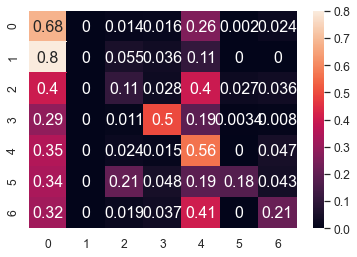

	training epoch=2 .. train_loss=1.435
	validation epoch=2 .. val_loss=1.605
	Accuracy = 38.3 % .. Percision = 44.2 % .. Recall = 32.1 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_2.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 3 .. loss = 1.321


  0%|                                                                                 | 1/1914 [00:01<43:24,  1.36s/it]

training @ epoch 3 .. loss = 1.433


  0%|                                                                                 | 2/1914 [00:02<42:19,  1.33s/it]

training @ epoch 3 .. loss = 1.414


  0%|▏                                                                                | 3/1914 [00:03<41:42,  1.31s/it]

training @ epoch 3 .. loss = 1.019


  0%|▏                                                                                | 4/1914 [00:05<41:36,  1.31s/it]

training @ epoch 3 .. loss = 1.287


  0%|▏                                                                                | 5/1914 [00:06<41:11,  1.29s/it]

training @ epoch 3 .. loss = 1.106


  0%|▎                                                                                | 6/1914 [00:07<41:03,  1.29s/it]

training @ epoch 3 .. loss = 1.158


  0%|▎                                                                                | 7/1914 [00:09<41:20,  1.30s/it]

training @ epoch 3 .. loss = 1.691


  0%|▎                                                                                | 8/1914 [00:10<41:03,  1.29s/it]

training @ epoch 3 .. loss = 1.242


  0%|▍                                                                                | 9/1914 [00:11<41:03,  1.29s/it]

training @ epoch 3 .. loss = 1.285


  1%|▍                                                                               | 10/1914 [00:12<41:20,  1.30s/it]

training @ epoch 3 .. loss = 1.443


  1%|▍                                                                               | 11/1914 [00:14<40:45,  1.28s/it]

training @ epoch 3 .. loss = 1.214


  1%|▌                                                                               | 12/1914 [00:15<41:12,  1.30s/it]

training @ epoch 3 .. loss = 1.144


  1%|▌                                                                               | 13/1914 [00:16<39:58,  1.26s/it]

training @ epoch 3 .. loss = 1.484


  1%|▌                                                                               | 14/1914 [00:17<38:46,  1.22s/it]

training @ epoch 3 .. loss = 1.661


  1%|▋                                                                               | 15/1914 [00:19<38:38,  1.22s/it]

training @ epoch 3 .. loss = 1.092


  1%|▋                                                                               | 16/1914 [00:20<37:23,  1.18s/it]

training @ epoch 3 .. loss = 1.364


  1%|▋                                                                               | 17/1914 [00:21<37:07,  1.17s/it]

training @ epoch 3 .. loss = 1.606


  1%|▊                                                                               | 18/1914 [00:22<36:34,  1.16s/it]

training @ epoch 3 .. loss = 1.469


  1%|▊                                                                               | 19/1914 [00:23<36:38,  1.16s/it]

training @ epoch 3 .. loss = 1.482


  1%|▊                                                                               | 20/1914 [00:24<36:35,  1.16s/it]

training @ epoch 3 .. loss = 2.077


  1%|▉                                                                               | 21/1914 [00:25<36:14,  1.15s/it]

training @ epoch 3 .. loss = 1.292


  1%|▉                                                                               | 22/1914 [00:27<36:21,  1.15s/it]

training @ epoch 3 .. loss = 1.357


  1%|▉                                                                               | 23/1914 [00:28<35:56,  1.14s/it]

training @ epoch 3 .. loss = 1.842


  1%|█                                                                               | 24/1914 [00:29<36:03,  1.14s/it]

training @ epoch 3 .. loss = 1.482


  1%|█                                                                               | 25/1914 [00:30<35:59,  1.14s/it]

training @ epoch 3 .. loss = 1.677


  1%|█                                                                               | 26/1914 [00:31<35:47,  1.14s/it]

training @ epoch 3 .. loss = 1.275


  1%|█▏                                                                              | 27/1914 [00:32<36:26,  1.16s/it]

training @ epoch 3 .. loss = 1.288


  1%|█▏                                                                              | 28/1914 [00:33<36:20,  1.16s/it]

training @ epoch 3 .. loss = 1.292


  2%|█▏                                                                              | 29/1914 [00:35<36:20,  1.16s/it]

training @ epoch 3 .. loss = 0.921


  2%|█▎                                                                              | 30/1914 [00:36<35:57,  1.15s/it]

training @ epoch 3 .. loss = 1.523


  2%|█▎                                                                              | 31/1914 [00:37<36:05,  1.15s/it]

training @ epoch 3 .. loss = 1.652


  2%|█▎                                                                              | 32/1914 [00:38<36:11,  1.15s/it]

training @ epoch 3 .. loss = 1.483


  2%|█▍                                                                              | 33/1914 [00:39<35:52,  1.14s/it]

training @ epoch 3 .. loss = 1.404


  2%|█▍                                                                              | 34/1914 [00:40<36:01,  1.15s/it]

training @ epoch 3 .. loss = 1.755


  2%|█▍                                                                              | 35/1914 [00:41<36:00,  1.15s/it]

training @ epoch 3 .. loss = 1.055


  2%|█▌                                                                              | 36/1914 [00:43<36:12,  1.16s/it]

training @ epoch 3 .. loss = 1.882


  2%|█▌                                                                              | 37/1914 [00:44<35:51,  1.15s/it]

training @ epoch 3 .. loss = 1.334


  2%|█▌                                                                              | 38/1914 [00:45<36:07,  1.16s/it]

training @ epoch 3 .. loss = 1.868


  2%|█▋                                                                              | 39/1914 [00:46<35:58,  1.15s/it]

training @ epoch 3 .. loss = 1.263


  2%|█▋                                                                              | 40/1914 [00:47<35:41,  1.14s/it]

training @ epoch 3 .. loss = 1.573


  2%|█▋                                                                              | 41/1914 [00:48<36:07,  1.16s/it]

training @ epoch 3 .. loss = 1.064


  2%|█▊                                                                              | 42/1914 [00:49<35:41,  1.14s/it]

training @ epoch 3 .. loss = 1.797


  2%|█▊                                                                              | 43/1914 [00:51<35:43,  1.15s/it]

training @ epoch 3 .. loss = 1.821


  2%|█▊                                                                              | 44/1914 [00:52<35:34,  1.14s/it]

training @ epoch 3 .. loss = 2.103


  2%|█▉                                                                              | 45/1914 [00:53<35:45,  1.15s/it]

training @ epoch 3 .. loss = 1.412


  2%|█▉                                                                              | 46/1914 [00:54<35:21,  1.14s/it]

training @ epoch 3 .. loss = 1.504


  2%|█▉                                                                              | 47/1914 [00:55<35:12,  1.13s/it]

training @ epoch 3 .. loss = 1.415


  3%|██                                                                              | 48/1914 [00:56<35:17,  1.13s/it]

training @ epoch 3 .. loss = 1.365


  3%|██                                                                              | 49/1914 [00:57<35:14,  1.13s/it]

training @ epoch 3 .. loss = 1.503


  3%|██                                                                              | 50/1914 [00:59<35:17,  1.14s/it]

training @ epoch 3 .. loss = 1.487


  3%|██▏                                                                             | 51/1914 [01:00<35:24,  1.14s/it]

training @ epoch 3 .. loss = 1.308


  3%|██▏                                                                             | 52/1914 [01:01<35:29,  1.14s/it]

training @ epoch 3 .. loss = 1.631


  3%|██▏                                                                             | 53/1914 [01:02<35:25,  1.14s/it]

training @ epoch 3 .. loss = 1.387


  3%|██▎                                                                             | 54/1914 [01:03<35:23,  1.14s/it]

training @ epoch 3 .. loss = 1.235


  3%|██▎                                                                             | 55/1914 [01:04<35:48,  1.16s/it]

training @ epoch 3 .. loss = 1.566


  3%|██▎                                                                             | 56/1914 [01:05<35:17,  1.14s/it]

training @ epoch 3 .. loss = 1.531


  3%|██▍                                                                             | 57/1914 [01:07<35:14,  1.14s/it]

training @ epoch 3 .. loss = 1.21


  3%|██▍                                                                             | 58/1914 [01:08<34:58,  1.13s/it]

training @ epoch 3 .. loss = 1.274


  3%|██▍                                                                             | 59/1914 [01:09<35:20,  1.14s/it]

training @ epoch 3 .. loss = 1.647


  3%|██▌                                                                             | 60/1914 [01:10<35:31,  1.15s/it]

training @ epoch 3 .. loss = 1.172


  3%|██▌                                                                             | 61/1914 [01:11<35:19,  1.14s/it]

training @ epoch 3 .. loss = 1.721


  3%|██▌                                                                             | 62/1914 [01:12<35:23,  1.15s/it]

training @ epoch 3 .. loss = 1.268


  3%|██▋                                                                             | 63/1914 [01:13<35:08,  1.14s/it]

training @ epoch 3 .. loss = 1.498


  3%|██▋                                                                             | 64/1914 [01:15<35:12,  1.14s/it]

training @ epoch 3 .. loss = 1.483


  3%|██▋                                                                             | 65/1914 [01:16<35:10,  1.14s/it]

training @ epoch 3 .. loss = 1.208


  3%|██▊                                                                             | 66/1914 [01:17<35:04,  1.14s/it]

training @ epoch 3 .. loss = 1.853


  4%|██▊                                                                             | 67/1914 [01:18<35:33,  1.16s/it]

training @ epoch 3 .. loss = 1.404


  4%|██▊                                                                             | 68/1914 [01:19<35:29,  1.15s/it]

training @ epoch 3 .. loss = 1.529


  4%|██▉                                                                             | 69/1914 [01:20<35:39,  1.16s/it]

training @ epoch 3 .. loss = 0.983


  4%|██▉                                                                             | 70/1914 [01:21<35:19,  1.15s/it]

training @ epoch 3 .. loss = 1.434


  4%|██▉                                                                             | 71/1914 [01:23<35:27,  1.15s/it]

training @ epoch 3 .. loss = 1.028


  4%|███                                                                             | 72/1914 [01:24<34:57,  1.14s/it]

training @ epoch 3 .. loss = 1.559


  4%|███                                                                             | 73/1914 [01:25<34:52,  1.14s/it]

training @ epoch 3 .. loss = 1.311


  4%|███                                                                             | 74/1914 [01:26<34:50,  1.14s/it]

training @ epoch 3 .. loss = 1.238


  4%|███▏                                                                            | 75/1914 [01:27<34:42,  1.13s/it]

training @ epoch 3 .. loss = 1.522


  4%|███▏                                                                            | 76/1914 [01:28<35:03,  1.14s/it]

training @ epoch 3 .. loss = 1.192


  4%|███▏                                                                            | 77/1914 [01:29<34:34,  1.13s/it]

training @ epoch 3 .. loss = 1.315


  4%|███▎                                                                            | 78/1914 [01:31<34:45,  1.14s/it]

training @ epoch 3 .. loss = 1.529


  4%|███▎                                                                            | 79/1914 [01:32<35:04,  1.15s/it]

training @ epoch 3 .. loss = 1.202


  4%|███▎                                                                            | 80/1914 [01:33<35:27,  1.16s/it]

training @ epoch 3 .. loss = 1.384


  4%|███▍                                                                            | 81/1914 [01:34<35:00,  1.15s/it]

training @ epoch 3 .. loss = 1.588


  4%|███▍                                                                            | 82/1914 [01:35<35:01,  1.15s/it]

training @ epoch 3 .. loss = 1.024


  4%|███▍                                                                            | 83/1914 [01:36<35:14,  1.15s/it]

training @ epoch 3 .. loss = 1.22


  4%|███▌                                                                            | 84/1914 [01:37<34:53,  1.14s/it]

training @ epoch 3 .. loss = 1.112


  4%|███▌                                                                            | 85/1914 [01:39<35:20,  1.16s/it]

training @ epoch 3 .. loss = 1.27


  4%|███▌                                                                            | 86/1914 [01:40<34:52,  1.14s/it]

training @ epoch 3 .. loss = 1.278


  5%|███▋                                                                            | 87/1914 [01:41<34:48,  1.14s/it]

training @ epoch 3 .. loss = 1.221


  5%|███▋                                                                            | 88/1914 [01:42<34:25,  1.13s/it]

training @ epoch 3 .. loss = 1.821


  5%|███▋                                                                            | 89/1914 [01:43<34:40,  1.14s/it]

training @ epoch 3 .. loss = 1.638


  5%|███▊                                                                            | 90/1914 [01:44<34:46,  1.14s/it]

training @ epoch 3 .. loss = 1.523


  5%|███▊                                                                            | 91/1914 [01:45<34:29,  1.14s/it]

training @ epoch 3 .. loss = 1.363


  5%|███▊                                                                            | 92/1914 [01:47<34:44,  1.14s/it]

training @ epoch 3 .. loss = 1.353


  5%|███▉                                                                            | 93/1914 [01:48<34:27,  1.14s/it]

training @ epoch 3 .. loss = 1.066


  5%|███▉                                                                            | 94/1914 [01:49<34:17,  1.13s/it]

training @ epoch 3 .. loss = 1.478


  5%|███▉                                                                            | 95/1914 [01:50<34:17,  1.13s/it]

training @ epoch 3 .. loss = 1.404


  5%|████                                                                            | 96/1914 [01:51<34:16,  1.13s/it]

training @ epoch 3 .. loss = 1.326


  5%|████                                                                            | 97/1914 [01:52<34:22,  1.14s/it]

training @ epoch 3 .. loss = 1.37


  5%|████                                                                            | 98/1914 [01:53<34:13,  1.13s/it]

training @ epoch 3 .. loss = 1.359


  5%|████▏                                                                           | 99/1914 [01:55<34:23,  1.14s/it]

training @ epoch 3 .. loss = 1.374


  5%|████▏                                                                          | 100/1914 [01:56<34:10,  1.13s/it]

training @ epoch 3 .. loss = 1.594


  5%|████▏                                                                          | 101/1914 [01:57<34:25,  1.14s/it]

training @ epoch 3 .. loss = 1.11


  5%|████▏                                                                          | 102/1914 [01:58<34:24,  1.14s/it]

training @ epoch 3 .. loss = 1.265


  5%|████▎                                                                          | 103/1914 [01:59<34:30,  1.14s/it]

training @ epoch 3 .. loss = 1.317


  5%|████▎                                                                          | 104/1914 [02:00<34:33,  1.15s/it]

training @ epoch 3 .. loss = 1.334


  5%|████▎                                                                          | 105/1914 [02:01<34:41,  1.15s/it]

training @ epoch 3 .. loss = 1.062


  6%|████▍                                                                          | 106/1914 [02:03<35:51,  1.19s/it]

training @ epoch 3 .. loss = 1.495


  6%|████▍                                                                          | 107/1914 [02:04<37:17,  1.24s/it]

training @ epoch 3 .. loss = 1.044


  6%|████▍                                                                          | 108/1914 [02:05<38:12,  1.27s/it]

training @ epoch 3 .. loss = 1.052


  6%|████▍                                                                          | 109/1914 [02:07<39:14,  1.30s/it]

training @ epoch 3 .. loss = 1.492


  6%|████▌                                                                          | 110/1914 [02:08<39:48,  1.32s/it]

training @ epoch 3 .. loss = 1.565


  6%|████▌                                                                          | 111/1914 [02:10<40:14,  1.34s/it]

training @ epoch 3 .. loss = 1.163


  6%|████▌                                                                          | 112/1914 [02:11<42:12,  1.41s/it]

training @ epoch 3 .. loss = 1.773


  6%|████▋                                                                          | 113/1914 [02:13<43:33,  1.45s/it]

training @ epoch 3 .. loss = 1.525


  6%|████▋                                                                          | 114/1914 [02:14<43:17,  1.44s/it]

training @ epoch 3 .. loss = 1.449


  6%|████▋                                                                          | 115/1914 [02:15<41:55,  1.40s/it]

training @ epoch 3 .. loss = 1.144


  6%|████▊                                                                          | 116/1914 [02:17<40:57,  1.37s/it]

training @ epoch 3 .. loss = 0.96


  6%|████▊                                                                          | 117/1914 [02:18<40:07,  1.34s/it]

training @ epoch 3 .. loss = 1.258


  6%|████▊                                                                          | 118/1914 [02:19<39:34,  1.32s/it]

training @ epoch 3 .. loss = 1.367


  6%|████▉                                                                          | 119/1914 [02:21<39:30,  1.32s/it]

training @ epoch 3 .. loss = 1.485


  6%|████▉                                                                          | 120/1914 [02:22<39:03,  1.31s/it]

training @ epoch 3 .. loss = 1.136


  6%|████▉                                                                          | 121/1914 [02:23<39:15,  1.31s/it]

training @ epoch 3 .. loss = 1.68


  6%|█████                                                                          | 122/1914 [02:24<38:27,  1.29s/it]

training @ epoch 3 .. loss = 1.418


  6%|█████                                                                          | 123/1914 [02:26<37:01,  1.24s/it]

training @ epoch 3 .. loss = 1.623


  6%|█████                                                                          | 124/1914 [02:27<36:17,  1.22s/it]

training @ epoch 3 .. loss = 1.083


  7%|█████▏                                                                         | 125/1914 [02:28<35:25,  1.19s/it]

training @ epoch 3 .. loss = 1.378


  7%|█████▏                                                                         | 126/1914 [02:29<35:19,  1.19s/it]

training @ epoch 3 .. loss = 1.324


  7%|█████▏                                                                         | 127/1914 [02:30<34:56,  1.17s/it]

training @ epoch 3 .. loss = 2.056


  7%|█████▎                                                                         | 128/1914 [02:31<34:37,  1.16s/it]

training @ epoch 3 .. loss = 1.178


  7%|█████▎                                                                         | 129/1914 [02:32<34:42,  1.17s/it]

training @ epoch 3 .. loss = 1.526


  7%|█████▎                                                                         | 130/1914 [02:34<33:57,  1.14s/it]

training @ epoch 3 .. loss = 1.059


  7%|█████▍                                                                         | 131/1914 [02:35<34:13,  1.15s/it]

training @ epoch 3 .. loss = 1.193


  7%|█████▍                                                                         | 132/1914 [02:36<33:55,  1.14s/it]

training @ epoch 3 .. loss = 1.403


  7%|█████▍                                                                         | 133/1914 [02:37<33:58,  1.14s/it]

training @ epoch 3 .. loss = 1.375


  7%|█████▌                                                                         | 134/1914 [02:38<33:59,  1.15s/it]

training @ epoch 3 .. loss = 1.72


  7%|█████▌                                                                         | 135/1914 [02:39<34:20,  1.16s/it]

training @ epoch 3 .. loss = 1.646


  7%|█████▌                                                                         | 136/1914 [02:40<34:13,  1.16s/it]

training @ epoch 3 .. loss = 1.297


  7%|█████▋                                                                         | 137/1914 [02:42<33:38,  1.14s/it]

training @ epoch 3 .. loss = 1.131


  7%|█████▋                                                                         | 138/1914 [02:43<34:24,  1.16s/it]

training @ epoch 3 .. loss = 1.47


  7%|█████▋                                                                         | 139/1914 [02:44<34:07,  1.15s/it]

training @ epoch 3 .. loss = 1.277


  7%|█████▊                                                                         | 140/1914 [02:45<34:10,  1.16s/it]

training @ epoch 3 .. loss = 1.614


  7%|█████▊                                                                         | 141/1914 [02:46<34:07,  1.15s/it]

training @ epoch 3 .. loss = 0.904


  7%|█████▊                                                                         | 142/1914 [02:47<33:55,  1.15s/it]

training @ epoch 3 .. loss = 1.433


  7%|█████▉                                                                         | 143/1914 [02:48<34:05,  1.16s/it]

training @ epoch 3 .. loss = 1.418


  8%|█████▉                                                                         | 144/1914 [02:50<33:46,  1.15s/it]

training @ epoch 3 .. loss = 1.316


  8%|█████▉                                                                         | 145/1914 [02:51<34:04,  1.16s/it]

training @ epoch 3 .. loss = 1.361


  8%|██████                                                                         | 146/1914 [02:52<33:51,  1.15s/it]

training @ epoch 3 .. loss = 1.261


  8%|██████                                                                         | 147/1914 [02:53<33:44,  1.15s/it]

training @ epoch 3 .. loss = 1.15


  8%|██████                                                                         | 148/1914 [02:54<33:59,  1.15s/it]

training @ epoch 3 .. loss = 1.923


  8%|██████▏                                                                        | 149/1914 [02:56<34:58,  1.19s/it]

training @ epoch 3 .. loss = 1.368


  8%|██████▏                                                                        | 150/1914 [02:57<36:24,  1.24s/it]

training @ epoch 3 .. loss = 1.742


  8%|██████▏                                                                        | 151/1914 [02:58<36:42,  1.25s/it]

training @ epoch 3 .. loss = 1.404


  8%|██████▎                                                                        | 152/1914 [02:59<36:49,  1.25s/it]

training @ epoch 3 .. loss = 1.408


  8%|██████▎                                                                        | 153/1914 [03:01<37:08,  1.27s/it]

training @ epoch 3 .. loss = 1.207


  8%|██████▎                                                                        | 154/1914 [03:02<37:06,  1.26s/it]

training @ epoch 3 .. loss = 1.414


  8%|██████▍                                                                        | 155/1914 [03:03<37:14,  1.27s/it]

training @ epoch 3 .. loss = 1.325


  8%|██████▍                                                                        | 156/1914 [03:05<37:35,  1.28s/it]

training @ epoch 3 .. loss = 1.24


  8%|██████▍                                                                        | 157/1914 [03:06<37:50,  1.29s/it]

training @ epoch 3 .. loss = 1.373


  8%|██████▌                                                                        | 158/1914 [03:07<37:43,  1.29s/it]

training @ epoch 3 .. loss = 0.927


  8%|██████▌                                                                        | 159/1914 [03:08<38:00,  1.30s/it]

training @ epoch 3 .. loss = 1.156


  8%|██████▌                                                                        | 160/1914 [03:10<38:13,  1.31s/it]

training @ epoch 3 .. loss = 1.877


  8%|██████▋                                                                        | 161/1914 [03:11<37:38,  1.29s/it]

training @ epoch 3 .. loss = 1.431


  8%|██████▋                                                                        | 162/1914 [03:12<36:45,  1.26s/it]

training @ epoch 3 .. loss = 1.58


  9%|██████▋                                                                        | 163/1914 [03:13<35:51,  1.23s/it]

training @ epoch 3 .. loss = 1.491


  9%|██████▊                                                                        | 164/1914 [03:15<35:00,  1.20s/it]

training @ epoch 3 .. loss = 1.499


  9%|██████▊                                                                        | 165/1914 [03:16<34:21,  1.18s/it]

training @ epoch 3 .. loss = 1.795


  9%|██████▊                                                                        | 166/1914 [03:17<34:23,  1.18s/it]

training @ epoch 3 .. loss = 1.448


  9%|██████▉                                                                        | 167/1914 [03:18<33:57,  1.17s/it]

training @ epoch 3 .. loss = 1.511


  9%|██████▉                                                                        | 168/1914 [03:19<33:48,  1.16s/it]

training @ epoch 3 .. loss = 1.608


  9%|██████▉                                                                        | 169/1914 [03:20<33:53,  1.17s/it]

training @ epoch 3 .. loss = 1.534


  9%|███████                                                                        | 170/1914 [03:21<33:39,  1.16s/it]

training @ epoch 3 .. loss = 1.928


  9%|███████                                                                        | 171/1914 [03:23<34:20,  1.18s/it]

training @ epoch 3 .. loss = 1.134


  9%|███████                                                                        | 172/1914 [03:24<34:00,  1.17s/it]

training @ epoch 3 .. loss = 1.529


  9%|███████▏                                                                       | 173/1914 [03:25<33:47,  1.16s/it]

training @ epoch 3 .. loss = 1.142


  9%|███████▏                                                                       | 174/1914 [03:26<33:42,  1.16s/it]

training @ epoch 3 .. loss = 1.235


  9%|███████▏                                                                       | 175/1914 [03:27<33:15,  1.15s/it]

training @ epoch 3 .. loss = 1.484


  9%|███████▎                                                                       | 176/1914 [03:28<33:26,  1.15s/it]

training @ epoch 3 .. loss = 1.37


  9%|███████▎                                                                       | 177/1914 [03:30<33:14,  1.15s/it]

training @ epoch 3 .. loss = 1.343


  9%|███████▎                                                                       | 178/1914 [03:31<33:04,  1.14s/it]

training @ epoch 3 .. loss = 1.538


  9%|███████▍                                                                       | 179/1914 [03:32<33:23,  1.15s/it]

training @ epoch 3 .. loss = 1.782


  9%|███████▍                                                                       | 180/1914 [03:33<33:11,  1.15s/it]

training @ epoch 3 .. loss = 1.366


  9%|███████▍                                                                       | 181/1914 [03:34<33:06,  1.15s/it]

training @ epoch 3 .. loss = 1.475


 10%|███████▌                                                                       | 182/1914 [03:35<32:58,  1.14s/it]

training @ epoch 3 .. loss = 1.307


 10%|███████▌                                                                       | 183/1914 [03:36<33:20,  1.16s/it]

training @ epoch 3 .. loss = 1.244


 10%|███████▌                                                                       | 184/1914 [03:38<32:56,  1.14s/it]

training @ epoch 3 .. loss = 1.87


 10%|███████▋                                                                       | 185/1914 [03:39<33:07,  1.15s/it]

training @ epoch 3 .. loss = 1.545


 10%|███████▋                                                                       | 186/1914 [03:40<33:01,  1.15s/it]

training @ epoch 3 .. loss = 1.24


 10%|███████▋                                                                       | 187/1914 [03:41<33:14,  1.15s/it]

training @ epoch 3 .. loss = 1.214


 10%|███████▊                                                                       | 188/1914 [03:42<33:16,  1.16s/it]

training @ epoch 3 .. loss = 1.219


 10%|███████▊                                                                       | 189/1914 [03:43<33:12,  1.15s/it]

training @ epoch 3 .. loss = 1.526


 10%|███████▊                                                                       | 190/1914 [03:45<33:03,  1.15s/it]

training @ epoch 3 .. loss = 1.779


 10%|███████▉                                                                       | 191/1914 [03:46<32:45,  1.14s/it]

training @ epoch 3 .. loss = 0.921


 10%|███████▉                                                                       | 192/1914 [03:47<32:48,  1.14s/it]

training @ epoch 3 .. loss = 1.508


 10%|███████▉                                                                       | 193/1914 [03:48<32:29,  1.13s/it]

training @ epoch 3 .. loss = 1.494


 10%|████████                                                                       | 194/1914 [03:49<32:31,  1.13s/it]

training @ epoch 3 .. loss = 1.457


 10%|████████                                                                       | 195/1914 [03:50<32:42,  1.14s/it]

training @ epoch 3 .. loss = 1.095


 10%|████████                                                                       | 196/1914 [03:51<32:50,  1.15s/it]

training @ epoch 3 .. loss = 1.548


 10%|████████▏                                                                      | 197/1914 [03:52<32:41,  1.14s/it]

training @ epoch 3 .. loss = 1.361


 10%|████████▏                                                                      | 198/1914 [03:54<32:18,  1.13s/it]

training @ epoch 3 .. loss = 1.385


 10%|████████▏                                                                      | 199/1914 [03:55<32:28,  1.14s/it]

training @ epoch 3 .. loss = 1.465


 10%|████████▎                                                                      | 200/1914 [03:56<32:20,  1.13s/it]

training @ epoch 3 .. loss = 1.411


 11%|████████▎                                                                      | 201/1914 [03:57<32:30,  1.14s/it]

training @ epoch 3 .. loss = 1.572


 11%|████████▎                                                                      | 202/1914 [03:58<32:35,  1.14s/it]

training @ epoch 3 .. loss = 1.276


 11%|████████▍                                                                      | 203/1914 [03:59<32:44,  1.15s/it]

training @ epoch 3 .. loss = 1.527


 11%|████████▍                                                                      | 204/1914 [04:00<32:42,  1.15s/it]

training @ epoch 3 .. loss = 1.153


 11%|████████▍                                                                      | 205/1914 [04:02<32:18,  1.13s/it]

training @ epoch 3 .. loss = 1.703


 11%|████████▌                                                                      | 206/1914 [04:03<32:33,  1.14s/it]

training @ epoch 3 .. loss = 1.605


 11%|████████▌                                                                      | 207/1914 [04:04<32:32,  1.14s/it]

training @ epoch 3 .. loss = 1.471


 11%|████████▌                                                                      | 208/1914 [04:05<32:35,  1.15s/it]

training @ epoch 3 .. loss = 1.179


 11%|████████▋                                                                      | 209/1914 [04:06<32:14,  1.13s/it]

training @ epoch 3 .. loss = 1.466


 11%|████████▋                                                                      | 210/1914 [04:07<32:32,  1.15s/it]

training @ epoch 3 .. loss = 1.235


 11%|████████▋                                                                      | 211/1914 [04:08<32:51,  1.16s/it]

training @ epoch 3 .. loss = 1.579


 11%|████████▊                                                                      | 212/1914 [04:10<32:31,  1.15s/it]

training @ epoch 3 .. loss = 1.189


 11%|████████▊                                                                      | 213/1914 [04:11<32:39,  1.15s/it]

training @ epoch 3 .. loss = 1.618


 11%|████████▊                                                                      | 214/1914 [04:12<32:12,  1.14s/it]

training @ epoch 3 .. loss = 1.491


 11%|████████▊                                                                      | 215/1914 [04:13<32:34,  1.15s/it]

training @ epoch 3 .. loss = 1.883


 11%|████████▉                                                                      | 216/1914 [04:14<32:50,  1.16s/it]

training @ epoch 3 .. loss = 1.392


 11%|████████▉                                                                      | 217/1914 [04:15<32:27,  1.15s/it]

training @ epoch 3 .. loss = 1.473


 11%|████████▉                                                                      | 218/1914 [04:17<32:30,  1.15s/it]

training @ epoch 3 .. loss = 1.342


 11%|█████████                                                                      | 219/1914 [04:18<32:14,  1.14s/it]

training @ epoch 3 .. loss = 1.085


 11%|█████████                                                                      | 220/1914 [04:19<32:22,  1.15s/it]

training @ epoch 3 .. loss = 1.619


 12%|█████████                                                                      | 221/1914 [04:20<32:14,  1.14s/it]

training @ epoch 3 .. loss = 1.258


 12%|█████████▏                                                                     | 222/1914 [04:21<32:01,  1.14s/it]

training @ epoch 3 .. loss = 1.394


 12%|█████████▏                                                                     | 223/1914 [04:22<31:59,  1.14s/it]

training @ epoch 3 .. loss = 1.088


 12%|█████████▏                                                                     | 224/1914 [04:23<32:09,  1.14s/it]

training @ epoch 3 .. loss = 1.315


 12%|█████████▎                                                                     | 225/1914 [04:24<32:03,  1.14s/it]

training @ epoch 3 .. loss = 1.22


 12%|█████████▎                                                                     | 226/1914 [04:26<31:45,  1.13s/it]

training @ epoch 3 .. loss = 0.87


 12%|█████████▎                                                                     | 227/1914 [04:27<31:57,  1.14s/it]

training @ epoch 3 .. loss = 1.055


 12%|█████████▍                                                                     | 228/1914 [04:28<32:00,  1.14s/it]

training @ epoch 3 .. loss = 1.139


 12%|█████████▍                                                                     | 229/1914 [04:29<32:10,  1.15s/it]

training @ epoch 3 .. loss = 1.64


 12%|█████████▍                                                                     | 230/1914 [04:30<32:16,  1.15s/it]

training @ epoch 3 .. loss = 1.632


 12%|█████████▌                                                                     | 231/1914 [04:31<32:00,  1.14s/it]

training @ epoch 3 .. loss = 1.382


 12%|█████████▌                                                                     | 232/1914 [04:33<32:22,  1.15s/it]

training @ epoch 3 .. loss = 1.412


 12%|█████████▌                                                                     | 233/1914 [04:34<31:47,  1.13s/it]

training @ epoch 3 .. loss = 1.47


 12%|█████████▋                                                                     | 234/1914 [04:35<32:00,  1.14s/it]

training @ epoch 3 .. loss = 1.896


 12%|█████████▋                                                                     | 235/1914 [04:36<32:04,  1.15s/it]

training @ epoch 3 .. loss = 1.294


 12%|█████████▋                                                                     | 236/1914 [04:37<32:10,  1.15s/it]

training @ epoch 3 .. loss = 0.989


 12%|█████████▊                                                                     | 237/1914 [04:38<32:04,  1.15s/it]

training @ epoch 3 .. loss = 1.731


 12%|█████████▊                                                                     | 238/1914 [04:39<32:06,  1.15s/it]

training @ epoch 3 .. loss = 1.615


 12%|█████████▊                                                                     | 239/1914 [04:41<32:18,  1.16s/it]

training @ epoch 3 .. loss = 2.208


 13%|█████████▉                                                                     | 240/1914 [04:42<31:52,  1.14s/it]

training @ epoch 3 .. loss = 1.193


 13%|█████████▉                                                                     | 241/1914 [04:43<32:18,  1.16s/it]

training @ epoch 3 .. loss = 0.979


 13%|█████████▉                                                                     | 242/1914 [04:44<31:49,  1.14s/it]

training @ epoch 3 .. loss = 1.429


 13%|██████████                                                                     | 243/1914 [04:45<31:31,  1.13s/it]

training @ epoch 3 .. loss = 1.278


 13%|██████████                                                                     | 244/1914 [04:46<31:45,  1.14s/it]

training @ epoch 3 .. loss = 1.284


 13%|██████████                                                                     | 245/1914 [04:47<31:44,  1.14s/it]

training @ epoch 3 .. loss = 1.244


 13%|██████████▏                                                                    | 246/1914 [04:49<31:43,  1.14s/it]

training @ epoch 3 .. loss = 1.514


 13%|██████████▏                                                                    | 247/1914 [04:50<31:52,  1.15s/it]

training @ epoch 3 .. loss = 1.339


 13%|██████████▏                                                                    | 248/1914 [04:51<31:46,  1.14s/it]

training @ epoch 3 .. loss = 1.03


 13%|██████████▎                                                                    | 249/1914 [04:52<31:39,  1.14s/it]

training @ epoch 3 .. loss = 1.157


 13%|██████████▎                                                                    | 250/1914 [04:53<31:55,  1.15s/it]

training @ epoch 3 .. loss = 1.602


 13%|██████████▎                                                                    | 251/1914 [04:54<31:47,  1.15s/it]

training @ epoch 3 .. loss = 1.72


 13%|██████████▍                                                                    | 252/1914 [04:55<31:29,  1.14s/it]

training @ epoch 3 .. loss = 1.164


 13%|██████████▍                                                                    | 253/1914 [04:56<31:23,  1.13s/it]

training @ epoch 3 .. loss = 1.433


 13%|██████████▍                                                                    | 254/1914 [04:58<30:53,  1.12s/it]

training @ epoch 3 .. loss = 1.591


 13%|██████████▌                                                                    | 255/1914 [04:59<31:27,  1.14s/it]

training @ epoch 3 .. loss = 1.108


 13%|██████████▌                                                                    | 256/1914 [05:00<31:13,  1.13s/it]

training @ epoch 3 .. loss = 1.536


 13%|██████████▌                                                                    | 257/1914 [05:01<31:27,  1.14s/it]

training @ epoch 3 .. loss = 1.232


 13%|██████████▋                                                                    | 258/1914 [05:02<31:37,  1.15s/it]

training @ epoch 3 .. loss = 1.857


 14%|██████████▋                                                                    | 259/1914 [05:03<31:43,  1.15s/it]

training @ epoch 3 .. loss = 1.552


 14%|██████████▋                                                                    | 260/1914 [05:05<31:44,  1.15s/it]

training @ epoch 3 .. loss = 1.607


 14%|██████████▊                                                                    | 261/1914 [05:06<31:47,  1.15s/it]

training @ epoch 3 .. loss = 1.761


 14%|██████████▊                                                                    | 262/1914 [05:07<31:51,  1.16s/it]

training @ epoch 3 .. loss = 1.337


 14%|██████████▊                                                                    | 263/1914 [05:08<31:45,  1.15s/it]

training @ epoch 3 .. loss = 1.648


 14%|██████████▉                                                                    | 264/1914 [05:09<31:42,  1.15s/it]

training @ epoch 3 .. loss = 0.974


 14%|██████████▉                                                                    | 265/1914 [05:10<31:47,  1.16s/it]

training @ epoch 3 .. loss = 1.7


 14%|██████████▉                                                                    | 266/1914 [05:11<31:48,  1.16s/it]

training @ epoch 3 .. loss = 1.32


 14%|███████████                                                                    | 267/1914 [05:13<31:58,  1.16s/it]

training @ epoch 3 .. loss = 1.459


 14%|███████████                                                                    | 268/1914 [05:14<32:21,  1.18s/it]

training @ epoch 3 .. loss = 1.275


 14%|███████████                                                                    | 269/1914 [05:15<32:22,  1.18s/it]

training @ epoch 3 .. loss = 1.087


 14%|███████████▏                                                                   | 270/1914 [05:16<31:58,  1.17s/it]

training @ epoch 3 .. loss = 1.328


 14%|███████████▏                                                                   | 271/1914 [05:17<31:39,  1.16s/it]

training @ epoch 3 .. loss = 1.33


 14%|███████████▏                                                                   | 272/1914 [05:18<31:40,  1.16s/it]

training @ epoch 3 .. loss = 1.145


 14%|███████████▎                                                                   | 273/1914 [05:20<31:31,  1.15s/it]

training @ epoch 3 .. loss = 1.117


 14%|███████████▎                                                                   | 274/1914 [05:21<31:40,  1.16s/it]

training @ epoch 3 .. loss = 1.126


 14%|███████████▎                                                                   | 275/1914 [05:22<31:20,  1.15s/it]

training @ epoch 3 .. loss = 1.763


 14%|███████████▍                                                                   | 276/1914 [05:23<31:31,  1.15s/it]

training @ epoch 3 .. loss = 1.581


 14%|███████████▍                                                                   | 277/1914 [05:24<31:28,  1.15s/it]

training @ epoch 3 .. loss = 1.236


 15%|███████████▍                                                                   | 278/1914 [05:25<31:22,  1.15s/it]

training @ epoch 3 .. loss = 1.666


 15%|███████████▌                                                                   | 279/1914 [05:27<31:18,  1.15s/it]

training @ epoch 3 .. loss = 1.163


 15%|███████████▌                                                                   | 280/1914 [05:28<31:17,  1.15s/it]

training @ epoch 3 .. loss = 1.067


 15%|███████████▌                                                                   | 281/1914 [05:29<31:31,  1.16s/it]

training @ epoch 3 .. loss = 1.225


 15%|███████████▋                                                                   | 282/1914 [05:30<31:22,  1.15s/it]

training @ epoch 3 .. loss = 1.117


 15%|███████████▋                                                                   | 283/1914 [05:31<31:10,  1.15s/it]

training @ epoch 3 .. loss = 1.332


 15%|███████████▋                                                                   | 284/1914 [05:32<31:54,  1.17s/it]

training @ epoch 3 .. loss = 1.175


 15%|███████████▊                                                                   | 285/1914 [05:33<31:25,  1.16s/it]

training @ epoch 3 .. loss = 1.049


 15%|███████████▊                                                                   | 286/1914 [05:35<31:03,  1.14s/it]

training @ epoch 3 .. loss = 1.505


 15%|███████████▊                                                                   | 287/1914 [05:36<32:50,  1.21s/it]

training @ epoch 3 .. loss = 1.097


 15%|███████████▉                                                                   | 288/1914 [05:37<33:29,  1.24s/it]

training @ epoch 3 .. loss = 1.204


 15%|███████████▉                                                                   | 289/1914 [05:38<33:41,  1.24s/it]

training @ epoch 3 .. loss = 1.282


 15%|███████████▉                                                                   | 290/1914 [05:40<33:49,  1.25s/it]

training @ epoch 3 .. loss = 1.812


 15%|████████████                                                                   | 291/1914 [05:41<34:19,  1.27s/it]

training @ epoch 3 .. loss = 1.597


 15%|████████████                                                                   | 292/1914 [05:42<34:35,  1.28s/it]

training @ epoch 3 .. loss = 1.56


 15%|████████████                                                                   | 293/1914 [05:44<34:11,  1.27s/it]

training @ epoch 3 .. loss = 1.155


 15%|████████████▏                                                                  | 294/1914 [05:45<34:33,  1.28s/it]

training @ epoch 3 .. loss = 1.144


 15%|████████████▏                                                                  | 295/1914 [05:46<34:14,  1.27s/it]

training @ epoch 3 .. loss = 1.404


 15%|████████████▏                                                                  | 296/1914 [05:47<34:20,  1.27s/it]

training @ epoch 3 .. loss = 1.198


 16%|████████████▎                                                                  | 297/1914 [05:49<34:29,  1.28s/it]

training @ epoch 3 .. loss = 1.583


 16%|████████████▎                                                                  | 298/1914 [05:50<34:39,  1.29s/it]

training @ epoch 3 .. loss = 1.272


 16%|████████████▎                                                                  | 299/1914 [05:51<33:57,  1.26s/it]

training @ epoch 3 .. loss = 1.113


 16%|████████████▍                                                                  | 300/1914 [05:52<33:13,  1.23s/it]

training @ epoch 3 .. loss = 0.888


 16%|████████████▍                                                                  | 301/1914 [05:54<32:46,  1.22s/it]

training @ epoch 3 .. loss = 1.328


 16%|████████████▍                                                                  | 302/1914 [05:55<32:18,  1.20s/it]

training @ epoch 3 .. loss = 1.394


 16%|████████████▌                                                                  | 303/1914 [05:56<31:40,  1.18s/it]

training @ epoch 3 .. loss = 0.938


 16%|████████████▌                                                                  | 304/1914 [05:57<31:11,  1.16s/it]

training @ epoch 3 .. loss = 1.459


 16%|████████████▌                                                                  | 305/1914 [05:58<30:38,  1.14s/it]

training @ epoch 3 .. loss = 1.682


 16%|████████████▋                                                                  | 306/1914 [05:59<30:49,  1.15s/it]

training @ epoch 3 .. loss = 1.687


 16%|████████████▋                                                                  | 307/1914 [06:00<30:44,  1.15s/it]

training @ epoch 3 .. loss = 1.706


 16%|████████████▋                                                                  | 308/1914 [06:02<30:37,  1.14s/it]

training @ epoch 3 .. loss = 1.306


 16%|████████████▊                                                                  | 309/1914 [06:03<30:31,  1.14s/it]

training @ epoch 3 .. loss = 1.925


 16%|████████████▊                                                                  | 310/1914 [06:04<30:32,  1.14s/it]

training @ epoch 3 .. loss = 1.519


 16%|████████████▊                                                                  | 311/1914 [06:05<30:36,  1.15s/it]

training @ epoch 3 .. loss = 1.064


 16%|████████████▉                                                                  | 312/1914 [06:06<30:23,  1.14s/it]

training @ epoch 3 .. loss = 1.777


 16%|████████████▉                                                                  | 313/1914 [06:07<30:14,  1.13s/it]

training @ epoch 3 .. loss = 1.288


 16%|████████████▉                                                                  | 314/1914 [06:08<30:38,  1.15s/it]

training @ epoch 3 .. loss = 1.195


 16%|█████████████                                                                  | 315/1914 [06:10<30:28,  1.14s/it]

training @ epoch 3 .. loss = 1.41


 17%|█████████████                                                                  | 316/1914 [06:11<30:46,  1.16s/it]

training @ epoch 3 .. loss = 1.756


 17%|█████████████                                                                  | 317/1914 [06:12<30:34,  1.15s/it]

training @ epoch 3 .. loss = 1.625


 17%|█████████████▏                                                                 | 318/1914 [06:13<30:35,  1.15s/it]

training @ epoch 3 .. loss = 1.776


 17%|█████████████▏                                                                 | 319/1914 [06:14<30:26,  1.15s/it]

training @ epoch 3 .. loss = 1.192


 17%|█████████████▏                                                                 | 320/1914 [06:15<30:21,  1.14s/it]

training @ epoch 3 .. loss = 1.305


 17%|█████████████▏                                                                 | 321/1914 [06:16<30:21,  1.14s/it]

training @ epoch 3 .. loss = 1.839


 17%|█████████████▎                                                                 | 322/1914 [06:18<30:00,  1.13s/it]

training @ epoch 3 .. loss = 1.002


 17%|█████████████▎                                                                 | 323/1914 [06:19<30:33,  1.15s/it]

training @ epoch 3 .. loss = 1.532


 17%|█████████████▎                                                                 | 324/1914 [06:20<30:11,  1.14s/it]

training @ epoch 3 .. loss = 1.091


 17%|█████████████▍                                                                 | 325/1914 [06:21<30:17,  1.14s/it]

training @ epoch 3 .. loss = 1.738


 17%|█████████████▍                                                                 | 326/1914 [06:22<30:25,  1.15s/it]

training @ epoch 3 .. loss = 1.51


 17%|█████████████▍                                                                 | 327/1914 [06:23<30:31,  1.15s/it]

training @ epoch 3 .. loss = 1.416


 17%|█████████████▌                                                                 | 328/1914 [06:24<30:17,  1.15s/it]

training @ epoch 3 .. loss = 1.296


 17%|█████████████▌                                                                 | 329/1914 [06:26<30:01,  1.14s/it]

training @ epoch 3 .. loss = 1.667


 17%|█████████████▌                                                                 | 330/1914 [06:27<30:11,  1.14s/it]

training @ epoch 3 .. loss = 1.784


 17%|█████████████▋                                                                 | 331/1914 [06:28<30:19,  1.15s/it]

training @ epoch 3 .. loss = 1.399


 17%|█████████████▋                                                                 | 332/1914 [06:29<30:14,  1.15s/it]

training @ epoch 3 .. loss = 1.4


 17%|█████████████▋                                                                 | 333/1914 [06:30<30:19,  1.15s/it]

training @ epoch 3 .. loss = 1.21


 17%|█████████████▊                                                                 | 334/1914 [06:31<30:27,  1.16s/it]

training @ epoch 3 .. loss = 1.398


 18%|█████████████▊                                                                 | 335/1914 [06:33<30:23,  1.15s/it]

training @ epoch 3 .. loss = 1.269


 18%|█████████████▊                                                                 | 336/1914 [06:34<30:18,  1.15s/it]

training @ epoch 3 .. loss = 1.484


 18%|█████████████▉                                                                 | 337/1914 [06:35<30:26,  1.16s/it]

training @ epoch 3 .. loss = 1.258


 18%|█████████████▉                                                                 | 338/1914 [06:36<30:00,  1.14s/it]

training @ epoch 3 .. loss = 1.103


 18%|█████████████▉                                                                 | 339/1914 [06:37<29:49,  1.14s/it]

training @ epoch 3 .. loss = 1.625


 18%|██████████████                                                                 | 340/1914 [06:38<29:43,  1.13s/it]

training @ epoch 3 .. loss = 1.369


 18%|██████████████                                                                 | 341/1914 [06:39<29:53,  1.14s/it]

training @ epoch 3 .. loss = 1.38


 18%|██████████████                                                                 | 342/1914 [06:40<29:44,  1.14s/it]

training @ epoch 3 .. loss = 1.221


 18%|██████████████▏                                                                | 343/1914 [06:42<29:47,  1.14s/it]

training @ epoch 3 .. loss = 1.296


 18%|██████████████▏                                                                | 344/1914 [06:43<29:55,  1.14s/it]

training @ epoch 3 .. loss = 1.58


 18%|██████████████▏                                                                | 345/1914 [06:44<29:47,  1.14s/it]

training @ epoch 3 .. loss = 1.039


 18%|██████████████▎                                                                | 346/1914 [06:45<29:45,  1.14s/it]

training @ epoch 3 .. loss = 0.97


 18%|██████████████▎                                                                | 347/1914 [06:46<30:00,  1.15s/it]

training @ epoch 3 .. loss = 1.427


 18%|██████████████▎                                                                | 348/1914 [06:47<30:04,  1.15s/it]

training @ epoch 3 .. loss = 1.453


 18%|██████████████▍                                                                | 349/1914 [06:49<30:03,  1.15s/it]

training @ epoch 3 .. loss = 1.514


 18%|██████████████▍                                                                | 350/1914 [06:50<31:46,  1.22s/it]

training @ epoch 3 .. loss = 1.482


 18%|██████████████▍                                                                | 351/1914 [06:51<32:43,  1.26s/it]

training @ epoch 3 .. loss = 1.716


 18%|██████████████▌                                                                | 352/1914 [06:53<34:24,  1.32s/it]

training @ epoch 3 .. loss = 1.004


 18%|██████████████▌                                                                | 353/1914 [06:54<32:35,  1.25s/it]

training @ epoch 3 .. loss = 1.298


 18%|██████████████▌                                                                | 354/1914 [06:55<31:46,  1.22s/it]

training @ epoch 3 .. loss = 1.561


 19%|██████████████▋                                                                | 355/1914 [06:56<31:02,  1.19s/it]

training @ epoch 3 .. loss = 1.463


 19%|██████████████▋                                                                | 356/1914 [06:57<30:51,  1.19s/it]

training @ epoch 3 .. loss = 1.526


 19%|██████████████▋                                                                | 357/1914 [06:58<30:27,  1.17s/it]

training @ epoch 3 .. loss = 1.189


 19%|██████████████▊                                                                | 358/1914 [07:00<30:00,  1.16s/it]

training @ epoch 3 .. loss = 1.527


 19%|██████████████▊                                                                | 359/1914 [07:01<30:07,  1.16s/it]

training @ epoch 3 .. loss = 1.106


 19%|██████████████▊                                                                | 360/1914 [07:02<30:01,  1.16s/it]

training @ epoch 3 .. loss = 1.538


 19%|██████████████▉                                                                | 361/1914 [07:03<29:57,  1.16s/it]

training @ epoch 3 .. loss = 1.656


 19%|██████████████▉                                                                | 362/1914 [07:04<29:52,  1.16s/it]

training @ epoch 3 .. loss = 0.91


 19%|██████████████▉                                                                | 363/1914 [07:05<29:41,  1.15s/it]

training @ epoch 3 .. loss = 1.336


 19%|███████████████                                                                | 364/1914 [07:06<29:55,  1.16s/it]

training @ epoch 3 .. loss = 1.745


 19%|███████████████                                                                | 365/1914 [07:08<29:32,  1.14s/it]

training @ epoch 3 .. loss = 1.333


 19%|███████████████                                                                | 366/1914 [07:09<29:45,  1.15s/it]

training @ epoch 3 .. loss = 1.472


 19%|███████████████▏                                                               | 367/1914 [07:10<29:26,  1.14s/it]

training @ epoch 3 .. loss = 1.607


 19%|███████████████▏                                                               | 368/1914 [07:11<29:52,  1.16s/it]

training @ epoch 3 .. loss = 1.164


 19%|███████████████▏                                                               | 369/1914 [07:12<29:56,  1.16s/it]

training @ epoch 3 .. loss = 1.527


 19%|███████████████▎                                                               | 370/1914 [07:13<29:56,  1.16s/it]

training @ epoch 3 .. loss = 1.659


 19%|███████████████▎                                                               | 371/1914 [07:15<29:44,  1.16s/it]

training @ epoch 3 .. loss = 1.16


 19%|███████████████▎                                                               | 372/1914 [07:16<29:23,  1.14s/it]

training @ epoch 3 .. loss = 1.396


 19%|███████████████▍                                                               | 373/1914 [07:17<29:10,  1.14s/it]

training @ epoch 3 .. loss = 0.918


 20%|███████████████▍                                                               | 374/1914 [07:18<29:08,  1.14s/it]

training @ epoch 3 .. loss = 1.534


 20%|███████████████▍                                                               | 375/1914 [07:19<29:09,  1.14s/it]

training @ epoch 3 .. loss = 1.025


 20%|███████████████▌                                                               | 376/1914 [07:20<29:12,  1.14s/it]

training @ epoch 3 .. loss = 1.489


 20%|███████████████▌                                                               | 377/1914 [07:21<29:11,  1.14s/it]

training @ epoch 3 .. loss = 1.532


 20%|███████████████▌                                                               | 378/1914 [07:22<29:11,  1.14s/it]

training @ epoch 3 .. loss = 1.194


 20%|███████████████▋                                                               | 379/1914 [07:24<29:37,  1.16s/it]

training @ epoch 3 .. loss = 1.954


 20%|███████████████▋                                                               | 380/1914 [07:25<29:33,  1.16s/it]

training @ epoch 3 .. loss = 1.396


 20%|███████████████▋                                                               | 381/1914 [07:26<29:11,  1.14s/it]

training @ epoch 3 .. loss = 1.519


 20%|███████████████▊                                                               | 382/1914 [07:27<29:15,  1.15s/it]

training @ epoch 3 .. loss = 1.596


 20%|███████████████▊                                                               | 383/1914 [07:28<29:34,  1.16s/it]

training @ epoch 3 .. loss = 1.372


 20%|███████████████▊                                                               | 384/1914 [07:29<29:09,  1.14s/it]

training @ epoch 3 .. loss = 1.41


 20%|███████████████▉                                                               | 385/1914 [07:31<29:14,  1.15s/it]

training @ epoch 3 .. loss = 1.535


 20%|███████████████▉                                                               | 386/1914 [07:32<29:12,  1.15s/it]

training @ epoch 3 .. loss = 1.197


 20%|███████████████▉                                                               | 387/1914 [07:33<29:12,  1.15s/it]

training @ epoch 3 .. loss = 1.248


 20%|████████████████                                                               | 388/1914 [07:34<28:56,  1.14s/it]

training @ epoch 3 .. loss = 1.513


 20%|████████████████                                                               | 389/1914 [07:35<28:57,  1.14s/it]

training @ epoch 3 .. loss = 1.684


 20%|████████████████                                                               | 390/1914 [07:36<29:25,  1.16s/it]

training @ epoch 3 .. loss = 1.38


 20%|████████████████▏                                                              | 391/1914 [07:37<29:25,  1.16s/it]

training @ epoch 3 .. loss = 1.194


 20%|████████████████▏                                                              | 392/1914 [07:39<29:15,  1.15s/it]

training @ epoch 3 .. loss = 1.814


 21%|████████████████▏                                                              | 393/1914 [07:40<28:59,  1.14s/it]

training @ epoch 3 .. loss = 1.304


 21%|████████████████▎                                                              | 394/1914 [07:41<28:59,  1.14s/it]

training @ epoch 3 .. loss = 1.662


 21%|████████████████▎                                                              | 395/1914 [07:42<29:07,  1.15s/it]

training @ epoch 3 .. loss = 1.591


 21%|████████████████▎                                                              | 396/1914 [07:43<28:33,  1.13s/it]

training @ epoch 3 .. loss = 1.528


 21%|████████████████▍                                                              | 397/1914 [07:44<28:48,  1.14s/it]

training @ epoch 3 .. loss = 1.643


 21%|████████████████▍                                                              | 398/1914 [07:45<28:47,  1.14s/it]

training @ epoch 3 .. loss = 1.764


 21%|████████████████▍                                                              | 399/1914 [07:47<28:54,  1.14s/it]

training @ epoch 3 .. loss = 1.493


 21%|████████████████▌                                                              | 400/1914 [07:48<28:42,  1.14s/it]

training @ epoch 3 .. loss = 1.503


 21%|████████████████▌                                                              | 401/1914 [07:49<28:49,  1.14s/it]

training @ epoch 3 .. loss = 1.233


 21%|████████████████▌                                                              | 402/1914 [07:50<29:01,  1.15s/it]

training @ epoch 3 .. loss = 1.151


 21%|████████████████▋                                                              | 403/1914 [07:51<28:43,  1.14s/it]

training @ epoch 3 .. loss = 1.644


 21%|████████████████▋                                                              | 404/1914 [07:52<29:12,  1.16s/it]

training @ epoch 3 .. loss = 1.485


 21%|████████████████▋                                                              | 405/1914 [07:53<28:53,  1.15s/it]

training @ epoch 3 .. loss = 1.024


 21%|████████████████▊                                                              | 406/1914 [07:55<29:07,  1.16s/it]

training @ epoch 3 .. loss = 1.467


 21%|████████████████▊                                                              | 407/1914 [07:56<29:06,  1.16s/it]

training @ epoch 3 .. loss = 1.32


 21%|████████████████▊                                                              | 408/1914 [07:57<28:55,  1.15s/it]

training @ epoch 3 .. loss = 1.199


 21%|████████████████▉                                                              | 409/1914 [07:58<28:49,  1.15s/it]

training @ epoch 3 .. loss = 1.235


 21%|████████████████▉                                                              | 410/1914 [07:59<28:20,  1.13s/it]

training @ epoch 3 .. loss = 1.365


 21%|████████████████▉                                                              | 411/1914 [08:00<28:32,  1.14s/it]

training @ epoch 3 .. loss = 1.719


 22%|█████████████████                                                              | 412/1914 [08:02<28:45,  1.15s/it]

training @ epoch 3 .. loss = 1.186


 22%|█████████████████                                                              | 413/1914 [08:03<28:58,  1.16s/it]

training @ epoch 3 .. loss = 1.511


 22%|█████████████████                                                              | 414/1914 [08:04<28:51,  1.15s/it]

training @ epoch 3 .. loss = 1.277


 22%|█████████████████▏                                                             | 415/1914 [08:05<28:51,  1.16s/it]

training @ epoch 3 .. loss = 1.525


 22%|█████████████████▏                                                             | 416/1914 [08:06<28:40,  1.15s/it]

training @ epoch 3 .. loss = 1.482


 22%|█████████████████▏                                                             | 417/1914 [08:07<28:35,  1.15s/it]

training @ epoch 3 .. loss = 1.245


 22%|█████████████████▎                                                             | 418/1914 [08:08<28:50,  1.16s/it]

training @ epoch 3 .. loss = 1.753


 22%|█████████████████▎                                                             | 419/1914 [08:10<28:32,  1.15s/it]

training @ epoch 3 .. loss = 1.449


 22%|█████████████████▎                                                             | 420/1914 [08:11<28:44,  1.15s/it]

training @ epoch 3 .. loss = 0.933


 22%|█████████████████▍                                                             | 421/1914 [08:12<28:42,  1.15s/it]

training @ epoch 3 .. loss = 1.009


 22%|█████████████████▍                                                             | 422/1914 [08:13<29:00,  1.17s/it]

training @ epoch 3 .. loss = 1.595


 22%|█████████████████▍                                                             | 423/1914 [08:14<28:53,  1.16s/it]

training @ epoch 3 .. loss = 1.038


 22%|█████████████████▌                                                             | 424/1914 [08:15<29:30,  1.19s/it]

training @ epoch 3 .. loss = 1.326


 22%|█████████████████▌                                                             | 425/1914 [08:17<30:34,  1.23s/it]

training @ epoch 3 .. loss = 1.172


 22%|█████████████████▌                                                             | 426/1914 [08:18<30:56,  1.25s/it]

training @ epoch 3 .. loss = 1.324


 22%|█████████████████▌                                                             | 427/1914 [08:19<31:06,  1.26s/it]

training @ epoch 3 .. loss = 1.497


 22%|█████████████████▋                                                             | 428/1914 [08:21<31:13,  1.26s/it]

training @ epoch 3 .. loss = 1.35


 22%|█████████████████▋                                                             | 429/1914 [08:22<31:26,  1.27s/it]

training @ epoch 3 .. loss = 1.481


 22%|█████████████████▋                                                             | 430/1914 [08:23<31:25,  1.27s/it]

training @ epoch 3 .. loss = 1.255


 23%|█████████████████▊                                                             | 431/1914 [08:25<31:40,  1.28s/it]

training @ epoch 3 .. loss = 1.658


 23%|█████████████████▊                                                             | 432/1914 [08:26<31:43,  1.28s/it]

training @ epoch 3 .. loss = 1.106


 23%|█████████████████▊                                                             | 433/1914 [08:27<31:38,  1.28s/it]

training @ epoch 3 .. loss = 1.528


 23%|█████████████████▉                                                             | 434/1914 [08:28<32:00,  1.30s/it]

training @ epoch 3 .. loss = 1.736


 23%|█████████████████▉                                                             | 435/1914 [08:30<31:35,  1.28s/it]

training @ epoch 3 .. loss = 1.264


 23%|█████████████████▉                                                             | 436/1914 [08:31<31:43,  1.29s/it]

training @ epoch 3 .. loss = 1.405


 23%|██████████████████                                                             | 437/1914 [08:32<30:46,  1.25s/it]

training @ epoch 3 .. loss = 1.613


 23%|██████████████████                                                             | 438/1914 [08:33<29:57,  1.22s/it]

training @ epoch 3 .. loss = 1.386


 23%|██████████████████                                                             | 439/1914 [08:34<29:39,  1.21s/it]

training @ epoch 3 .. loss = 1.747


 23%|██████████████████▏                                                            | 440/1914 [08:36<29:09,  1.19s/it]

training @ epoch 3 .. loss = 1.469


 23%|██████████████████▏                                                            | 441/1914 [08:37<29:13,  1.19s/it]

training @ epoch 3 .. loss = 1.289


 23%|██████████████████▏                                                            | 442/1914 [08:38<28:33,  1.16s/it]

training @ epoch 3 .. loss = 1.842


 23%|██████████████████▎                                                            | 443/1914 [08:39<28:12,  1.15s/it]

training @ epoch 3 .. loss = 1.426


 23%|██████████████████▎                                                            | 444/1914 [08:40<27:49,  1.14s/it]

training @ epoch 3 .. loss = 1.557


 23%|██████████████████▎                                                            | 445/1914 [08:41<27:56,  1.14s/it]

training @ epoch 3 .. loss = 1.45


 23%|██████████████████▍                                                            | 446/1914 [08:43<28:35,  1.17s/it]

training @ epoch 3 .. loss = 1.209


 23%|██████████████████▍                                                            | 447/1914 [08:44<28:17,  1.16s/it]

training @ epoch 3 .. loss = 1.449


 23%|██████████████████▍                                                            | 448/1914 [08:45<28:24,  1.16s/it]

training @ epoch 3 .. loss = 1.618


 23%|██████████████████▌                                                            | 449/1914 [08:46<28:18,  1.16s/it]

training @ epoch 3 .. loss = 1.233


 24%|██████████████████▌                                                            | 450/1914 [08:47<28:22,  1.16s/it]

training @ epoch 3 .. loss = 1.298


 24%|██████████████████▌                                                            | 451/1914 [08:48<28:24,  1.17s/it]

training @ epoch 3 .. loss = 1.455


 24%|██████████████████▋                                                            | 452/1914 [08:49<28:05,  1.15s/it]

training @ epoch 3 .. loss = 1.662


 24%|██████████████████▋                                                            | 453/1914 [08:51<28:03,  1.15s/it]

training @ epoch 3 .. loss = 1.385


 24%|██████████████████▋                                                            | 454/1914 [08:52<27:40,  1.14s/it]

training @ epoch 3 .. loss = 1.332


 24%|██████████████████▊                                                            | 455/1914 [08:53<27:58,  1.15s/it]

training @ epoch 3 .. loss = 1.049


 24%|██████████████████▊                                                            | 456/1914 [08:54<27:37,  1.14s/it]

training @ epoch 3 .. loss = 1.305


 24%|██████████████████▊                                                            | 457/1914 [08:55<27:28,  1.13s/it]

training @ epoch 3 .. loss = 1.521


 24%|██████████████████▉                                                            | 458/1914 [08:56<27:27,  1.13s/it]

training @ epoch 3 .. loss = 1.215


 24%|██████████████████▉                                                            | 459/1914 [08:57<27:41,  1.14s/it]

training @ epoch 3 .. loss = 1.892


 24%|██████████████████▉                                                            | 460/1914 [08:59<27:46,  1.15s/it]

training @ epoch 3 .. loss = 1.443


 24%|███████████████████                                                            | 461/1914 [09:00<27:43,  1.15s/it]

training @ epoch 3 .. loss = 1.301


 24%|███████████████████                                                            | 462/1914 [09:01<27:55,  1.15s/it]

training @ epoch 3 .. loss = 0.99


 24%|███████████████████                                                            | 463/1914 [09:02<27:55,  1.15s/it]

training @ epoch 3 .. loss = 1.413


 24%|███████████████████▏                                                           | 464/1914 [09:03<27:58,  1.16s/it]

training @ epoch 3 .. loss = 1.16


 24%|███████████████████▏                                                           | 465/1914 [09:04<28:21,  1.17s/it]

training @ epoch 3 .. loss = 1.18


 24%|███████████████████▏                                                           | 466/1914 [09:06<27:58,  1.16s/it]

training @ epoch 3 .. loss = 1.313


 24%|███████████████████▎                                                           | 467/1914 [09:07<28:12,  1.17s/it]

training @ epoch 3 .. loss = 1.217


 24%|███████████████████▎                                                           | 468/1914 [09:08<28:38,  1.19s/it]

training @ epoch 3 .. loss = 1.364


 25%|███████████████████▎                                                           | 469/1914 [09:09<30:57,  1.29s/it]

training @ epoch 3 .. loss = 1.054


 25%|███████████████████▍                                                           | 470/1914 [09:11<30:51,  1.28s/it]

training @ epoch 3 .. loss = 1.012


 25%|███████████████████▍                                                           | 471/1914 [09:12<30:15,  1.26s/it]

training @ epoch 3 .. loss = 1.085


 25%|███████████████████▍                                                           | 472/1914 [09:13<30:05,  1.25s/it]

training @ epoch 3 .. loss = 1.632


 25%|███████████████████▌                                                           | 473/1914 [09:14<29:26,  1.23s/it]

training @ epoch 3 .. loss = 1.895


 25%|███████████████████▌                                                           | 474/1914 [09:15<28:50,  1.20s/it]

training @ epoch 3 .. loss = 1.459


 25%|███████████████████▌                                                           | 475/1914 [09:17<28:57,  1.21s/it]

training @ epoch 3 .. loss = 1.67


 25%|███████████████████▋                                                           | 476/1914 [09:18<28:50,  1.20s/it]

training @ epoch 3 .. loss = 1.076


 25%|███████████████████▋                                                           | 477/1914 [09:19<28:31,  1.19s/it]

training @ epoch 3 .. loss = 1.602


 25%|███████████████████▋                                                           | 478/1914 [09:20<28:09,  1.18s/it]

training @ epoch 3 .. loss = 1.023


 25%|███████████████████▊                                                           | 479/1914 [09:21<28:12,  1.18s/it]

training @ epoch 3 .. loss = 1.654


 25%|███████████████████▊                                                           | 480/1914 [09:23<28:12,  1.18s/it]

training @ epoch 3 .. loss = 1.291


 25%|███████████████████▊                                                           | 481/1914 [09:24<27:50,  1.17s/it]

training @ epoch 3 .. loss = 1.627


 25%|███████████████████▉                                                           | 482/1914 [09:25<27:56,  1.17s/it]

training @ epoch 3 .. loss = 1.657


 25%|███████████████████▉                                                           | 483/1914 [09:26<27:29,  1.15s/it]

training @ epoch 3 .. loss = 1.124


 25%|███████████████████▉                                                           | 484/1914 [09:27<27:23,  1.15s/it]

training @ epoch 3 .. loss = 1.345


 25%|████████████████████                                                           | 485/1914 [09:28<27:41,  1.16s/it]

training @ epoch 3 .. loss = 1.321


 25%|████████████████████                                                           | 486/1914 [09:29<27:34,  1.16s/it]

training @ epoch 3 .. loss = 1.255


 25%|████████████████████                                                           | 487/1914 [09:31<27:27,  1.15s/it]

training @ epoch 3 .. loss = 1.399


 25%|████████████████████▏                                                          | 488/1914 [09:32<27:41,  1.17s/it]

training @ epoch 3 .. loss = 1.264


 26%|████████████████████▏                                                          | 489/1914 [09:33<27:43,  1.17s/it]

training @ epoch 3 .. loss = 1.79


 26%|████████████████████▏                                                          | 490/1914 [09:34<27:48,  1.17s/it]

training @ epoch 3 .. loss = 1.335


 26%|████████████████████▎                                                          | 491/1914 [09:35<27:21,  1.15s/it]

training @ epoch 3 .. loss = 1.627


 26%|████████████████████▎                                                          | 492/1914 [09:36<27:24,  1.16s/it]

training @ epoch 3 .. loss = 1.599


 26%|████████████████████▎                                                          | 493/1914 [09:38<27:21,  1.15s/it]

training @ epoch 3 .. loss = 1.8


 26%|████████████████████▍                                                          | 494/1914 [09:39<27:29,  1.16s/it]

training @ epoch 3 .. loss = 1.115


 26%|████████████████████▍                                                          | 495/1914 [09:40<27:11,  1.15s/it]

training @ epoch 3 .. loss = 1.352


 26%|████████████████████▍                                                          | 496/1914 [09:41<27:07,  1.15s/it]

training @ epoch 3 .. loss = 1.713


 26%|████████████████████▌                                                          | 497/1914 [09:42<26:53,  1.14s/it]

training @ epoch 3 .. loss = 1.565


 26%|████████████████████▌                                                          | 498/1914 [09:43<26:57,  1.14s/it]

training @ epoch 3 .. loss = 1.087


 26%|████████████████████▌                                                          | 499/1914 [09:44<26:55,  1.14s/it]

training @ epoch 3 .. loss = 1.59


 26%|████████████████████▋                                                          | 500/1914 [09:46<26:51,  1.14s/it]

training @ epoch 3 .. loss = 1.265


 26%|████████████████████▋                                                          | 501/1914 [09:47<27:03,  1.15s/it]

training @ epoch 3 .. loss = 1.355


 26%|████████████████████▋                                                          | 502/1914 [09:48<26:49,  1.14s/it]

training @ epoch 3 .. loss = 1.126


 26%|████████████████████▊                                                          | 503/1914 [09:49<26:59,  1.15s/it]

training @ epoch 3 .. loss = 1.749


 26%|████████████████████▊                                                          | 504/1914 [09:50<27:01,  1.15s/it]

training @ epoch 3 .. loss = 1.413


 26%|████████████████████▊                                                          | 505/1914 [09:51<27:12,  1.16s/it]

training @ epoch 3 .. loss = 1.648


 26%|████████████████████▉                                                          | 506/1914 [09:53<27:20,  1.17s/it]

training @ epoch 3 .. loss = 1.278


 26%|████████████████████▉                                                          | 507/1914 [09:54<27:12,  1.16s/it]

training @ epoch 3 .. loss = 1.745


 27%|████████████████████▉                                                          | 508/1914 [09:55<27:29,  1.17s/it]

training @ epoch 3 .. loss = 1.322


 27%|█████████████████████                                                          | 509/1914 [09:56<27:08,  1.16s/it]

training @ epoch 3 .. loss = 1.19


 27%|█████████████████████                                                          | 510/1914 [09:57<27:06,  1.16s/it]

training @ epoch 3 .. loss = 1.308


 27%|█████████████████████                                                          | 511/1914 [09:58<27:10,  1.16s/it]

training @ epoch 3 .. loss = 1.286


 27%|█████████████████████▏                                                         | 512/1914 [09:59<26:44,  1.14s/it]

training @ epoch 3 .. loss = 1.737


 27%|█████████████████████▏                                                         | 513/1914 [10:01<26:41,  1.14s/it]

training @ epoch 3 .. loss = 1.635


 27%|█████████████████████▏                                                         | 514/1914 [10:02<26:48,  1.15s/it]

training @ epoch 3 .. loss = 1.638


 27%|█████████████████████▎                                                         | 515/1914 [10:03<27:05,  1.16s/it]

training @ epoch 3 .. loss = 1.382


 27%|█████████████████████▎                                                         | 516/1914 [10:04<27:12,  1.17s/it]

training @ epoch 3 .. loss = 1.872


 27%|█████████████████████▎                                                         | 517/1914 [10:05<26:52,  1.15s/it]

training @ epoch 3 .. loss = 1.583


 27%|█████████████████████▍                                                         | 518/1914 [10:06<26:58,  1.16s/it]

training @ epoch 3 .. loss = 1.219


 27%|█████████████████████▍                                                         | 519/1914 [10:08<26:49,  1.15s/it]

training @ epoch 3 .. loss = 1.526


 27%|█████████████████████▍                                                         | 520/1914 [10:09<27:04,  1.17s/it]

training @ epoch 3 .. loss = 1.352


 27%|█████████████████████▌                                                         | 521/1914 [10:10<26:50,  1.16s/it]

training @ epoch 3 .. loss = 1.323


 27%|█████████████████████▌                                                         | 522/1914 [10:11<26:55,  1.16s/it]

training @ epoch 3 .. loss = 1.283


 27%|█████████████████████▌                                                         | 523/1914 [10:12<26:55,  1.16s/it]

training @ epoch 3 .. loss = 1.495


 27%|█████████████████████▋                                                         | 524/1914 [10:13<26:50,  1.16s/it]

training @ epoch 3 .. loss = 1.474


 27%|█████████████████████▋                                                         | 525/1914 [10:15<27:10,  1.17s/it]

training @ epoch 3 .. loss = 1.831


 27%|█████████████████████▋                                                         | 526/1914 [10:16<27:19,  1.18s/it]

training @ epoch 3 .. loss = 1.403


 28%|█████████████████████▊                                                         | 527/1914 [10:17<27:22,  1.18s/it]

training @ epoch 3 .. loss = 1.915


 28%|█████████████████████▊                                                         | 528/1914 [10:18<27:15,  1.18s/it]

training @ epoch 3 .. loss = 1.415


 28%|█████████████████████▊                                                         | 529/1914 [10:19<26:51,  1.16s/it]

training @ epoch 3 .. loss = 1.026


 28%|█████████████████████▉                                                         | 530/1914 [10:20<26:50,  1.16s/it]

training @ epoch 3 .. loss = 1.388


 28%|█████████████████████▉                                                         | 531/1914 [10:22<26:29,  1.15s/it]

training @ epoch 3 .. loss = 1.332


 28%|█████████████████████▉                                                         | 532/1914 [10:23<26:37,  1.16s/it]

training @ epoch 3 .. loss = 1.193


 28%|█████████████████████▉                                                         | 533/1914 [10:24<26:30,  1.15s/it]

training @ epoch 3 .. loss = 1.538


 28%|██████████████████████                                                         | 534/1914 [10:25<26:25,  1.15s/it]

training @ epoch 3 .. loss = 1.315


 28%|██████████████████████                                                         | 535/1914 [10:26<26:04,  1.13s/it]

training @ epoch 3 .. loss = 1.435


 28%|██████████████████████                                                         | 536/1914 [10:27<26:06,  1.14s/it]

training @ epoch 3 .. loss = 0.997


 28%|██████████████████████▏                                                        | 537/1914 [10:28<26:24,  1.15s/it]

training @ epoch 3 .. loss = 1.824


 28%|██████████████████████▏                                                        | 538/1914 [10:30<26:16,  1.15s/it]

training @ epoch 3 .. loss = 1.546


 28%|██████████████████████▏                                                        | 539/1914 [10:31<26:22,  1.15s/it]

training @ epoch 3 .. loss = 1.775


 28%|██████████████████████▎                                                        | 540/1914 [10:32<26:25,  1.15s/it]

training @ epoch 3 .. loss = 1.684


 28%|██████████████████████▎                                                        | 541/1914 [10:33<26:24,  1.15s/it]

training @ epoch 3 .. loss = 1.237


 28%|██████████████████████▎                                                        | 542/1914 [10:34<26:09,  1.14s/it]

training @ epoch 3 .. loss = 1.326


 28%|██████████████████████▍                                                        | 543/1914 [10:35<26:06,  1.14s/it]

training @ epoch 3 .. loss = 1.628


 28%|██████████████████████▍                                                        | 544/1914 [10:36<26:04,  1.14s/it]

training @ epoch 3 .. loss = 1.275


 28%|██████████████████████▍                                                        | 545/1914 [10:38<25:54,  1.14s/it]

training @ epoch 3 .. loss = 1.625


 29%|██████████████████████▌                                                        | 546/1914 [10:39<26:03,  1.14s/it]

training @ epoch 3 .. loss = 1.287


 29%|██████████████████████▌                                                        | 547/1914 [10:40<26:01,  1.14s/it]

training @ epoch 3 .. loss = 1.276


 29%|██████████████████████▌                                                        | 548/1914 [10:41<25:55,  1.14s/it]

training @ epoch 3 .. loss = 1.232


 29%|██████████████████████▋                                                        | 549/1914 [10:42<25:50,  1.14s/it]

training @ epoch 3 .. loss = 1.313


 29%|██████████████████████▋                                                        | 550/1914 [10:43<26:13,  1.15s/it]

training @ epoch 3 .. loss = 1.434


 29%|██████████████████████▋                                                        | 551/1914 [10:45<26:21,  1.16s/it]

training @ epoch 3 .. loss = 1.5


 29%|██████████████████████▊                                                        | 552/1914 [10:46<26:04,  1.15s/it]

training @ epoch 3 .. loss = 1.556


 29%|██████████████████████▊                                                        | 553/1914 [10:47<26:18,  1.16s/it]

training @ epoch 3 .. loss = 1.445


 29%|██████████████████████▊                                                        | 554/1914 [10:48<26:12,  1.16s/it]

training @ epoch 3 .. loss = 1.496


 29%|██████████████████████▉                                                        | 555/1914 [10:49<26:02,  1.15s/it]

training @ epoch 3 .. loss = 1.406


 29%|██████████████████████▉                                                        | 556/1914 [10:50<25:51,  1.14s/it]

training @ epoch 3 .. loss = 1.086


 29%|██████████████████████▉                                                        | 557/1914 [10:51<26:01,  1.15s/it]

training @ epoch 3 .. loss = 1.237


 29%|███████████████████████                                                        | 558/1914 [10:53<25:55,  1.15s/it]

training @ epoch 3 .. loss = 1.28


 29%|███████████████████████                                                        | 559/1914 [10:54<25:33,  1.13s/it]

training @ epoch 3 .. loss = 1.342


 29%|███████████████████████                                                        | 560/1914 [10:55<26:13,  1.16s/it]

training @ epoch 3 .. loss = 1.033


 29%|███████████████████████▏                                                       | 561/1914 [10:56<27:12,  1.21s/it]

training @ epoch 3 .. loss = 1.739


 29%|███████████████████████▏                                                       | 562/1914 [10:57<27:31,  1.22s/it]

training @ epoch 3 .. loss = 1.409


 29%|███████████████████████▏                                                       | 563/1914 [10:59<27:58,  1.24s/it]

training @ epoch 3 .. loss = 1.188


 29%|███████████████████████▎                                                       | 564/1914 [11:00<28:14,  1.26s/it]

training @ epoch 3 .. loss = 1.304


 30%|███████████████████████▎                                                       | 565/1914 [11:01<28:28,  1.27s/it]

training @ epoch 3 .. loss = 1.329


 30%|███████████████████████▎                                                       | 566/1914 [11:03<28:41,  1.28s/it]

training @ epoch 3 .. loss = 1.072


 30%|███████████████████████▍                                                       | 567/1914 [11:04<28:40,  1.28s/it]

training @ epoch 3 .. loss = 0.863


 30%|███████████████████████▍                                                       | 568/1914 [11:05<28:54,  1.29s/it]

training @ epoch 3 .. loss = 1.48


 30%|███████████████████████▍                                                       | 569/1914 [11:06<29:02,  1.30s/it]

training @ epoch 3 .. loss = 0.888


 30%|███████████████████████▌                                                       | 570/1914 [11:08<29:00,  1.29s/it]

training @ epoch 3 .. loss = 1.332


 30%|███████████████████████▌                                                       | 571/1914 [11:09<28:58,  1.29s/it]

training @ epoch 3 .. loss = 1.821


 30%|███████████████████████▌                                                       | 572/1914 [11:10<29:01,  1.30s/it]

training @ epoch 3 .. loss = 1.42


 30%|███████████████████████▋                                                       | 573/1914 [11:12<28:13,  1.26s/it]

training @ epoch 3 .. loss = 1.5


 30%|███████████████████████▋                                                       | 574/1914 [11:13<27:50,  1.25s/it]

training @ epoch 3 .. loss = 1.081


 30%|███████████████████████▋                                                       | 575/1914 [11:14<27:15,  1.22s/it]

training @ epoch 3 .. loss = 1.493


 30%|███████████████████████▊                                                       | 576/1914 [11:15<26:42,  1.20s/it]

training @ epoch 3 .. loss = 1.722


 30%|███████████████████████▊                                                       | 577/1914 [11:16<26:17,  1.18s/it]

training @ epoch 3 .. loss = 1.195


 30%|███████████████████████▊                                                       | 578/1914 [11:17<26:09,  1.17s/it]

training @ epoch 3 .. loss = 1.208


 30%|███████████████████████▉                                                       | 579/1914 [11:19<26:14,  1.18s/it]

training @ epoch 3 .. loss = 1.076


 30%|███████████████████████▉                                                       | 580/1914 [11:20<25:57,  1.17s/it]

training @ epoch 3 .. loss = 1.36


 30%|███████████████████████▉                                                       | 581/1914 [11:21<25:46,  1.16s/it]

training @ epoch 3 .. loss = 1.403


 30%|████████████████████████                                                       | 582/1914 [11:22<25:35,  1.15s/it]

training @ epoch 3 .. loss = 1.274


 30%|████████████████████████                                                       | 583/1914 [11:23<25:47,  1.16s/it]

training @ epoch 3 .. loss = 1.358


 31%|████████████████████████                                                       | 584/1914 [11:24<26:38,  1.20s/it]

training @ epoch 3 .. loss = 1.479


 31%|████████████████████████▏                                                      | 585/1914 [11:26<26:09,  1.18s/it]

training @ epoch 3 .. loss = 1.247


 31%|████████████████████████▏                                                      | 586/1914 [11:27<26:32,  1.20s/it]

training @ epoch 3 .. loss = 1.379


 31%|████████████████████████▏                                                      | 587/1914 [11:28<25:58,  1.17s/it]

training @ epoch 3 .. loss = 1.122


 31%|████████████████████████▎                                                      | 588/1914 [11:29<25:41,  1.16s/it]

training @ epoch 3 .. loss = 1.215


 31%|████████████████████████▎                                                      | 589/1914 [11:30<25:27,  1.15s/it]

training @ epoch 3 .. loss = 1.582


 31%|████████████████████████▎                                                      | 590/1914 [11:31<25:25,  1.15s/it]

training @ epoch 3 .. loss = 1.182


 31%|████████████████████████▍                                                      | 591/1914 [11:33<25:31,  1.16s/it]

training @ epoch 3 .. loss = 1.549


 31%|████████████████████████▍                                                      | 592/1914 [11:34<25:08,  1.14s/it]

training @ epoch 3 .. loss = 1.814


 31%|████████████████████████▍                                                      | 593/1914 [11:35<25:19,  1.15s/it]

training @ epoch 3 .. loss = 1.437


 31%|████████████████████████▌                                                      | 594/1914 [11:36<25:12,  1.15s/it]

training @ epoch 3 .. loss = 1.45


 31%|████████████████████████▌                                                      | 595/1914 [11:37<25:03,  1.14s/it]

training @ epoch 3 .. loss = 1.332


 31%|████████████████████████▌                                                      | 596/1914 [11:38<25:19,  1.15s/it]

training @ epoch 3 .. loss = 1.454


 31%|████████████████████████▋                                                      | 597/1914 [11:39<25:10,  1.15s/it]

training @ epoch 3 .. loss = 1.216


 31%|████████████████████████▋                                                      | 598/1914 [11:41<25:08,  1.15s/it]

training @ epoch 3 .. loss = 1.171


 31%|████████████████████████▋                                                      | 599/1914 [11:42<25:13,  1.15s/it]

training @ epoch 3 .. loss = 1.29


 31%|████████████████████████▊                                                      | 600/1914 [11:43<26:52,  1.23s/it]

training @ epoch 3 .. loss = 1.6


 31%|████████████████████████▊                                                      | 601/1914 [11:44<27:25,  1.25s/it]

training @ epoch 3 .. loss = 0.81


 31%|████████████████████████▊                                                      | 602/1914 [11:46<27:35,  1.26s/it]

training @ epoch 3 .. loss = 1.36


 32%|████████████████████████▉                                                      | 603/1914 [11:47<26:39,  1.22s/it]

training @ epoch 3 .. loss = 1.625


 32%|████████████████████████▉                                                      | 604/1914 [11:48<25:49,  1.18s/it]

training @ epoch 3 .. loss = 1.413


 32%|████████████████████████▉                                                      | 605/1914 [11:49<25:26,  1.17s/it]

training @ epoch 3 .. loss = 1.502


 32%|█████████████████████████                                                      | 606/1914 [11:50<25:02,  1.15s/it]

training @ epoch 3 .. loss = 1.545


 32%|█████████████████████████                                                      | 607/1914 [11:51<24:28,  1.12s/it]

training @ epoch 3 .. loss = 1.273


 32%|█████████████████████████                                                      | 608/1914 [11:52<24:42,  1.13s/it]

training @ epoch 3 .. loss = 1.35


 32%|█████████████████████████▏                                                     | 609/1914 [11:54<24:54,  1.15s/it]

training @ epoch 3 .. loss = 1.772


 32%|█████████████████████████▏                                                     | 610/1914 [11:55<24:46,  1.14s/it]

training @ epoch 3 .. loss = 1.323


 32%|█████████████████████████▏                                                     | 611/1914 [11:56<24:46,  1.14s/it]

training @ epoch 3 .. loss = 1.656


 32%|█████████████████████████▎                                                     | 612/1914 [11:57<24:56,  1.15s/it]

training @ epoch 3 .. loss = 1.31


 32%|█████████████████████████▎                                                     | 613/1914 [11:58<24:53,  1.15s/it]

training @ epoch 3 .. loss = 1.292


 32%|█████████████████████████▎                                                     | 614/1914 [11:59<24:35,  1.14s/it]

training @ epoch 3 .. loss = 1.076


 32%|█████████████████████████▍                                                     | 615/1914 [12:00<25:12,  1.16s/it]

training @ epoch 3 .. loss = 1.327


 32%|█████████████████████████▍                                                     | 616/1914 [12:02<24:55,  1.15s/it]

training @ epoch 3 .. loss = 1.374


 32%|█████████████████████████▍                                                     | 617/1914 [12:03<25:35,  1.18s/it]

training @ epoch 3 .. loss = 1.662


 32%|█████████████████████████▌                                                     | 618/1914 [12:04<26:33,  1.23s/it]

training @ epoch 3 .. loss = 1.069


 32%|█████████████████████████▌                                                     | 619/1914 [12:06<28:20,  1.31s/it]

training @ epoch 3 .. loss = 1.391


 32%|█████████████████████████▌                                                     | 620/1914 [12:07<29:38,  1.37s/it]

training @ epoch 3 .. loss = 1.231


 32%|█████████████████████████▋                                                     | 621/1914 [12:09<30:33,  1.42s/it]

training @ epoch 3 .. loss = 1.451


 32%|█████████████████████████▋                                                     | 622/1914 [12:10<30:48,  1.43s/it]

training @ epoch 3 .. loss = 1.39


 33%|█████████████████████████▋                                                     | 623/1914 [12:12<30:45,  1.43s/it]

training @ epoch 3 .. loss = 1.083


 33%|█████████████████████████▊                                                     | 624/1914 [12:13<30:36,  1.42s/it]

training @ epoch 3 .. loss = 1.327


 33%|█████████████████████████▊                                                     | 625/1914 [12:14<30:13,  1.41s/it]

training @ epoch 3 .. loss = 1.242


 33%|█████████████████████████▊                                                     | 626/1914 [12:16<29:24,  1.37s/it]

training @ epoch 3 .. loss = 1.143


 33%|█████████████████████████▉                                                     | 627/1914 [12:17<28:42,  1.34s/it]

training @ epoch 3 .. loss = 1.202


 33%|█████████████████████████▉                                                     | 628/1914 [12:18<28:00,  1.31s/it]

training @ epoch 3 .. loss = 1.542


 33%|█████████████████████████▉                                                     | 629/1914 [12:19<27:42,  1.29s/it]

training @ epoch 3 .. loss = 1.391


 33%|██████████████████████████                                                     | 630/1914 [12:21<28:05,  1.31s/it]

training @ epoch 3 .. loss = 1.654


 33%|██████████████████████████                                                     | 631/1914 [12:22<28:24,  1.33s/it]

training @ epoch 3 .. loss = 1.16


 33%|██████████████████████████                                                     | 632/1914 [12:24<28:32,  1.34s/it]

training @ epoch 3 .. loss = 1.209


 33%|██████████████████████████▏                                                    | 633/1914 [12:25<28:20,  1.33s/it]

training @ epoch 3 .. loss = 1.105


 33%|██████████████████████████▏                                                    | 634/1914 [12:26<26:48,  1.26s/it]

training @ epoch 3 .. loss = 0.885


 33%|██████████████████████████▏                                                    | 635/1914 [12:27<26:10,  1.23s/it]

training @ epoch 3 .. loss = 1.033


 33%|██████████████████████████▎                                                    | 636/1914 [12:28<25:36,  1.20s/it]

training @ epoch 3 .. loss = 1.35


 33%|██████████████████████████▎                                                    | 637/1914 [12:29<25:15,  1.19s/it]

training @ epoch 3 .. loss = 1.541


 33%|██████████████████████████▎                                                    | 638/1914 [12:31<25:04,  1.18s/it]

training @ epoch 3 .. loss = 1.43


 33%|██████████████████████████▎                                                    | 639/1914 [12:32<24:40,  1.16s/it]

training @ epoch 3 .. loss = 1.269


 33%|██████████████████████████▍                                                    | 640/1914 [12:33<24:31,  1.15s/it]

training @ epoch 3 .. loss = 1.302


 33%|██████████████████████████▍                                                    | 641/1914 [12:34<24:10,  1.14s/it]

training @ epoch 3 .. loss = 1.211


 34%|██████████████████████████▍                                                    | 642/1914 [12:35<24:00,  1.13s/it]

training @ epoch 3 .. loss = 1.356


 34%|██████████████████████████▌                                                    | 643/1914 [12:36<23:48,  1.12s/it]

training @ epoch 3 .. loss = 1.709


 34%|██████████████████████████▌                                                    | 644/1914 [12:37<23:48,  1.12s/it]

training @ epoch 3 .. loss = 1.115


 34%|██████████████████████████▌                                                    | 645/1914 [12:38<24:06,  1.14s/it]

training @ epoch 3 .. loss = 1.612


 34%|██████████████████████████▋                                                    | 646/1914 [12:40<24:10,  1.14s/it]

training @ epoch 3 .. loss = 1.099


 34%|██████████████████████████▋                                                    | 647/1914 [12:41<24:00,  1.14s/it]

training @ epoch 3 .. loss = 1.686


 34%|██████████████████████████▋                                                    | 648/1914 [12:42<24:08,  1.14s/it]

training @ epoch 3 .. loss = 1.42


 34%|██████████████████████████▊                                                    | 649/1914 [12:43<24:14,  1.15s/it]

training @ epoch 3 .. loss = 1.409


 34%|██████████████████████████▊                                                    | 650/1914 [12:44<23:52,  1.13s/it]

training @ epoch 3 .. loss = 1.59


 34%|██████████████████████████▊                                                    | 651/1914 [12:45<23:56,  1.14s/it]

training @ epoch 3 .. loss = 1.187


 34%|██████████████████████████▉                                                    | 652/1914 [12:46<24:08,  1.15s/it]

training @ epoch 3 .. loss = 1.241


 34%|██████████████████████████▉                                                    | 653/1914 [12:48<23:57,  1.14s/it]

training @ epoch 3 .. loss = 1.25


 34%|██████████████████████████▉                                                    | 654/1914 [12:49<23:56,  1.14s/it]

training @ epoch 3 .. loss = 1.522


 34%|███████████████████████████                                                    | 655/1914 [12:50<23:52,  1.14s/it]

training @ epoch 3 .. loss = 1.05


 34%|███████████████████████████                                                    | 656/1914 [12:51<24:00,  1.15s/it]

training @ epoch 3 .. loss = 1.284


 34%|███████████████████████████                                                    | 657/1914 [12:52<24:01,  1.15s/it]

training @ epoch 3 .. loss = 1.34


 34%|███████████████████████████▏                                                   | 658/1914 [12:53<23:43,  1.13s/it]

training @ epoch 3 .. loss = 2.015


 34%|███████████████████████████▏                                                   | 659/1914 [12:54<24:02,  1.15s/it]

training @ epoch 3 .. loss = 0.973


 34%|███████████████████████████▏                                                   | 660/1914 [12:56<23:49,  1.14s/it]

training @ epoch 3 .. loss = 1.216


 35%|███████████████████████████▎                                                   | 661/1914 [12:57<23:52,  1.14s/it]

training @ epoch 3 .. loss = 1.113


 35%|███████████████████████████▎                                                   | 662/1914 [12:58<23:36,  1.13s/it]

training @ epoch 3 .. loss = 1.148


 35%|███████████████████████████▎                                                   | 663/1914 [12:59<23:50,  1.14s/it]

training @ epoch 3 .. loss = 1.616


 35%|███████████████████████████▍                                                   | 664/1914 [13:00<23:57,  1.15s/it]

training @ epoch 3 .. loss = 1.346


 35%|███████████████████████████▍                                                   | 665/1914 [13:01<23:41,  1.14s/it]

training @ epoch 3 .. loss = 1.411


 35%|███████████████████████████▍                                                   | 666/1914 [13:03<24:35,  1.18s/it]

training @ epoch 3 .. loss = 1.313


 35%|███████████████████████████▌                                                   | 667/1914 [13:04<25:31,  1.23s/it]

training @ epoch 3 .. loss = 1.625


 35%|███████████████████████████▌                                                   | 668/1914 [13:05<25:54,  1.25s/it]

training @ epoch 3 .. loss = 1.189


 35%|███████████████████████████▌                                                   | 669/1914 [13:06<26:02,  1.26s/it]

training @ epoch 3 .. loss = 1.267


 35%|███████████████████████████▋                                                   | 670/1914 [13:08<26:00,  1.25s/it]

training @ epoch 3 .. loss = 1.194


 35%|███████████████████████████▋                                                   | 671/1914 [13:09<26:03,  1.26s/it]

training @ epoch 3 .. loss = 1.795


 35%|███████████████████████████▋                                                   | 672/1914 [13:10<26:19,  1.27s/it]

training @ epoch 3 .. loss = 1.384


 35%|███████████████████████████▊                                                   | 673/1914 [13:12<26:15,  1.27s/it]

training @ epoch 3 .. loss = 1.34


 35%|███████████████████████████▊                                                   | 674/1914 [13:13<26:30,  1.28s/it]

training @ epoch 3 .. loss = 1.064


 35%|███████████████████████████▊                                                   | 675/1914 [13:14<26:33,  1.29s/it]

training @ epoch 3 .. loss = 1.449


 35%|███████████████████████████▉                                                   | 676/1914 [13:15<26:07,  1.27s/it]

training @ epoch 3 .. loss = 1.434


 35%|███████████████████████████▉                                                   | 677/1914 [13:17<25:33,  1.24s/it]

training @ epoch 3 .. loss = 0.939


 35%|███████████████████████████▉                                                   | 678/1914 [13:18<24:43,  1.20s/it]

training @ epoch 3 .. loss = 1.85


 35%|████████████████████████████                                                   | 679/1914 [13:19<24:24,  1.19s/it]

training @ epoch 3 .. loss = 1.067


 36%|████████████████████████████                                                   | 680/1914 [13:20<23:52,  1.16s/it]

training @ epoch 3 .. loss = 1.509


 36%|████████████████████████████                                                   | 681/1914 [13:21<23:48,  1.16s/it]

training @ epoch 3 .. loss = 1.638


 36%|████████████████████████████▏                                                  | 682/1914 [13:22<23:36,  1.15s/it]

training @ epoch 3 .. loss = 1.395


 36%|████████████████████████████▏                                                  | 683/1914 [13:23<23:36,  1.15s/it]

training @ epoch 3 .. loss = 1.025


 36%|████████████████████████████▏                                                  | 684/1914 [13:25<23:40,  1.16s/it]

training @ epoch 3 .. loss = 1.214


 36%|████████████████████████████▎                                                  | 685/1914 [13:26<23:27,  1.15s/it]

training @ epoch 3 .. loss = 1.08


 36%|████████████████████████████▎                                                  | 686/1914 [13:27<23:28,  1.15s/it]

training @ epoch 3 .. loss = 1.156


 36%|████████████████████████████▎                                                  | 687/1914 [13:28<23:10,  1.13s/it]

training @ epoch 3 .. loss = 0.986


 36%|████████████████████████████▍                                                  | 688/1914 [13:29<23:09,  1.13s/it]

training @ epoch 3 .. loss = 1.274


 36%|████████████████████████████▍                                                  | 689/1914 [13:30<23:29,  1.15s/it]

training @ epoch 3 .. loss = 1.497


 36%|████████████████████████████▍                                                  | 690/1914 [13:31<23:17,  1.14s/it]

training @ epoch 3 .. loss = 1.336


 36%|████████████████████████████▌                                                  | 691/1914 [13:33<23:35,  1.16s/it]

training @ epoch 3 .. loss = 1.133


 36%|████████████████████████████▌                                                  | 692/1914 [13:34<23:14,  1.14s/it]

training @ epoch 3 .. loss = 1.315


 36%|████████████████████████████▌                                                  | 693/1914 [13:35<23:13,  1.14s/it]

training @ epoch 3 .. loss = 1.801


 36%|████████████████████████████▋                                                  | 694/1914 [13:36<24:30,  1.21s/it]

training @ epoch 3 .. loss = 1.346


 36%|████████████████████████████▋                                                  | 695/1914 [13:37<24:57,  1.23s/it]

training @ epoch 3 .. loss = 2.109


 36%|████████████████████████████▋                                                  | 696/1914 [13:39<25:16,  1.25s/it]

training @ epoch 3 .. loss = 1.417


 36%|████████████████████████████▊                                                  | 697/1914 [13:40<25:10,  1.24s/it]

training @ epoch 3 .. loss = 1.211


 36%|████████████████████████████▊                                                  | 698/1914 [13:41<25:20,  1.25s/it]

training @ epoch 3 .. loss = 1.851


 37%|████████████████████████████▊                                                  | 699/1914 [13:42<25:39,  1.27s/it]

training @ epoch 3 .. loss = 1.136


 37%|████████████████████████████▉                                                  | 700/1914 [13:44<25:40,  1.27s/it]

training @ epoch 3 .. loss = 1.682


 37%|████████████████████████████▉                                                  | 701/1914 [13:45<25:44,  1.27s/it]

training @ epoch 3 .. loss = 1.41


 37%|████████████████████████████▉                                                  | 702/1914 [13:46<25:46,  1.28s/it]

training @ epoch 3 .. loss = 1.122


 37%|█████████████████████████████                                                  | 703/1914 [13:48<25:40,  1.27s/it]

training @ epoch 3 .. loss = 1.305


 37%|█████████████████████████████                                                  | 704/1914 [13:49<25:43,  1.28s/it]

training @ epoch 3 .. loss = 1.352


 37%|█████████████████████████████                                                  | 705/1914 [13:50<25:41,  1.27s/it]

training @ epoch 3 .. loss = 1.277


 37%|█████████████████████████████▏                                                 | 706/1914 [13:51<25:46,  1.28s/it]

training @ epoch 3 .. loss = 2.049


 37%|█████████████████████████████▏                                                 | 707/1914 [13:53<25:35,  1.27s/it]

training @ epoch 3 .. loss = 1.39


 37%|█████████████████████████████▏                                                 | 708/1914 [13:54<24:33,  1.22s/it]

training @ epoch 3 .. loss = 1.443


 37%|█████████████████████████████▎                                                 | 709/1914 [13:55<24:10,  1.20s/it]

training @ epoch 3 .. loss = 1.247


 37%|█████████████████████████████▎                                                 | 710/1914 [13:56<23:26,  1.17s/it]

training @ epoch 3 .. loss = 1.035


 37%|█████████████████████████████▎                                                 | 711/1914 [13:57<23:06,  1.15s/it]

training @ epoch 3 .. loss = 1.685


 37%|█████████████████████████████▍                                                 | 712/1914 [13:58<23:01,  1.15s/it]

training @ epoch 3 .. loss = 1.244


 37%|█████████████████████████████▍                                                 | 713/1914 [13:59<23:05,  1.15s/it]

training @ epoch 3 .. loss = 0.987


 37%|█████████████████████████████▍                                                 | 714/1914 [14:01<23:06,  1.16s/it]

training @ epoch 3 .. loss = 1.39


 37%|█████████████████████████████▌                                                 | 715/1914 [14:02<22:46,  1.14s/it]

training @ epoch 3 .. loss = 1.058


 37%|█████████████████████████████▌                                                 | 716/1914 [14:03<22:45,  1.14s/it]

training @ epoch 3 .. loss = 1.996


 37%|█████████████████████████████▌                                                 | 717/1914 [14:04<22:48,  1.14s/it]

training @ epoch 3 .. loss = 1.12


 38%|█████████████████████████████▋                                                 | 718/1914 [14:05<23:01,  1.16s/it]

training @ epoch 3 .. loss = 1.348


 38%|█████████████████████████████▋                                                 | 719/1914 [14:06<23:10,  1.16s/it]

training @ epoch 3 .. loss = 1.161


 38%|█████████████████████████████▋                                                 | 720/1914 [14:08<23:05,  1.16s/it]

training @ epoch 3 .. loss = 1.316


 38%|█████████████████████████████▊                                                 | 721/1914 [14:09<23:18,  1.17s/it]

training @ epoch 3 .. loss = 1.098


 38%|█████████████████████████████▊                                                 | 722/1914 [14:10<23:02,  1.16s/it]

training @ epoch 3 .. loss = 1.093


 38%|█████████████████████████████▊                                                 | 723/1914 [14:11<22:58,  1.16s/it]

training @ epoch 3 .. loss = 1.126


 38%|█████████████████████████████▉                                                 | 724/1914 [14:12<22:44,  1.15s/it]

training @ epoch 3 .. loss = 1.476


 38%|█████████████████████████████▉                                                 | 725/1914 [14:13<22:27,  1.13s/it]

training @ epoch 3 .. loss = 1.665


 38%|█████████████████████████████▉                                                 | 726/1914 [14:14<22:43,  1.15s/it]

training @ epoch 3 .. loss = 1.341


 38%|██████████████████████████████                                                 | 727/1914 [14:16<22:39,  1.15s/it]

training @ epoch 3 .. loss = 1.515


 38%|██████████████████████████████                                                 | 728/1914 [14:17<22:40,  1.15s/it]

training @ epoch 3 .. loss = 1.457


 38%|██████████████████████████████                                                 | 729/1914 [14:18<22:39,  1.15s/it]

training @ epoch 3 .. loss = 1.471


 38%|██████████████████████████████▏                                                | 730/1914 [14:19<22:36,  1.15s/it]

training @ epoch 3 .. loss = 1.536


 38%|██████████████████████████████▏                                                | 731/1914 [14:20<22:27,  1.14s/it]

training @ epoch 3 .. loss = 1.203


 38%|██████████████████████████████▏                                                | 732/1914 [14:21<22:03,  1.12s/it]

training @ epoch 3 .. loss = 1.449


 38%|██████████████████████████████▎                                                | 733/1914 [14:22<22:14,  1.13s/it]

training @ epoch 3 .. loss = 1.406


 38%|██████████████████████████████▎                                                | 734/1914 [14:24<22:34,  1.15s/it]

training @ epoch 3 .. loss = 1.068


 38%|██████████████████████████████▎                                                | 735/1914 [14:25<22:34,  1.15s/it]

training @ epoch 3 .. loss = 1.022


 38%|██████████████████████████████▍                                                | 736/1914 [14:26<22:23,  1.14s/it]

training @ epoch 3 .. loss = 1.156


 39%|██████████████████████████████▍                                                | 737/1914 [14:27<22:16,  1.14s/it]

training @ epoch 3 .. loss = 1.546


 39%|██████████████████████████████▍                                                | 738/1914 [14:28<22:16,  1.14s/it]

training @ epoch 3 .. loss = 1.669


 39%|██████████████████████████████▌                                                | 739/1914 [14:29<22:21,  1.14s/it]

training @ epoch 3 .. loss = 1.555


 39%|██████████████████████████████▌                                                | 740/1914 [14:30<22:48,  1.17s/it]

training @ epoch 3 .. loss = 1.179


 39%|██████████████████████████████▌                                                | 741/1914 [14:32<22:45,  1.16s/it]

training @ epoch 3 .. loss = 1.596


 39%|██████████████████████████████▋                                                | 742/1914 [14:33<22:42,  1.16s/it]

training @ epoch 3 .. loss = 1.723


 39%|██████████████████████████████▋                                                | 743/1914 [14:34<22:27,  1.15s/it]

training @ epoch 3 .. loss = 1.478


 39%|██████████████████████████████▋                                                | 744/1914 [14:35<22:23,  1.15s/it]

training @ epoch 3 .. loss = 1.341


 39%|██████████████████████████████▋                                                | 745/1914 [14:36<22:13,  1.14s/it]

training @ epoch 3 .. loss = 1.495


 39%|██████████████████████████████▊                                                | 746/1914 [14:37<22:14,  1.14s/it]

training @ epoch 3 .. loss = 1.416


 39%|██████████████████████████████▊                                                | 747/1914 [14:38<22:26,  1.15s/it]

training @ epoch 3 .. loss = 1.335


 39%|██████████████████████████████▊                                                | 748/1914 [14:40<22:14,  1.14s/it]

training @ epoch 3 .. loss = 1.092


 39%|██████████████████████████████▉                                                | 749/1914 [14:41<22:11,  1.14s/it]

training @ epoch 3 .. loss = 1.049


 39%|██████████████████████████████▉                                                | 750/1914 [14:42<21:58,  1.13s/it]

training @ epoch 3 .. loss = 1.698


 39%|██████████████████████████████▉                                                | 751/1914 [14:43<22:11,  1.14s/it]

training @ epoch 3 .. loss = 1.222


 39%|███████████████████████████████                                                | 752/1914 [14:44<22:01,  1.14s/it]

training @ epoch 3 .. loss = 1.316


 39%|███████████████████████████████                                                | 753/1914 [14:45<21:50,  1.13s/it]

training @ epoch 3 .. loss = 1.386


 39%|███████████████████████████████                                                | 754/1914 [14:46<22:24,  1.16s/it]

training @ epoch 3 .. loss = 1.517


 39%|███████████████████████████████▏                                               | 755/1914 [14:48<22:10,  1.15s/it]

training @ epoch 3 .. loss = 1.053


 39%|███████████████████████████████▏                                               | 756/1914 [14:49<22:07,  1.15s/it]

training @ epoch 3 .. loss = 0.949


 40%|███████████████████████████████▏                                               | 757/1914 [14:50<21:57,  1.14s/it]

training @ epoch 3 .. loss = 1.307


 40%|███████████████████████████████▎                                               | 758/1914 [14:51<21:58,  1.14s/it]

training @ epoch 3 .. loss = 1.604


 40%|███████████████████████████████▎                                               | 759/1914 [14:52<22:12,  1.15s/it]

training @ epoch 3 .. loss = 1.445


 40%|███████████████████████████████▎                                               | 760/1914 [14:53<22:10,  1.15s/it]

training @ epoch 3 .. loss = 1.495


 40%|███████████████████████████████▍                                               | 761/1914 [14:55<22:13,  1.16s/it]

training @ epoch 3 .. loss = 1.575


 40%|███████████████████████████████▍                                               | 762/1914 [14:56<21:47,  1.14s/it]

training @ epoch 3 .. loss = 1.318


 40%|███████████████████████████████▍                                               | 763/1914 [14:57<21:46,  1.13s/it]

training @ epoch 3 .. loss = 1.578


 40%|███████████████████████████████▌                                               | 764/1914 [14:58<21:37,  1.13s/it]

training @ epoch 3 .. loss = 1.151


 40%|███████████████████████████████▌                                               | 765/1914 [14:59<21:40,  1.13s/it]

training @ epoch 3 .. loss = 1.334


 40%|███████████████████████████████▌                                               | 766/1914 [15:00<21:32,  1.13s/it]

training @ epoch 3 .. loss = 1.389


 40%|███████████████████████████████▋                                               | 767/1914 [15:01<21:23,  1.12s/it]

training @ epoch 3 .. loss = 1.572


 40%|███████████████████████████████▋                                               | 768/1914 [15:02<21:43,  1.14s/it]

training @ epoch 3 .. loss = 1.559


 40%|███████████████████████████████▋                                               | 769/1914 [15:03<21:30,  1.13s/it]

training @ epoch 3 .. loss = 1.28


 40%|███████████████████████████████▊                                               | 770/1914 [15:05<21:44,  1.14s/it]

training @ epoch 3 .. loss = 0.984


 40%|███████████████████████████████▊                                               | 771/1914 [15:06<21:29,  1.13s/it]

training @ epoch 3 .. loss = 1.448


 40%|███████████████████████████████▊                                               | 772/1914 [15:07<21:37,  1.14s/it]

training @ epoch 3 .. loss = 1.181


 40%|███████████████████████████████▉                                               | 773/1914 [15:08<21:40,  1.14s/it]

training @ epoch 3 .. loss = 1.397


 40%|███████████████████████████████▉                                               | 774/1914 [15:09<21:53,  1.15s/it]

training @ epoch 3 .. loss = 1.711


 40%|███████████████████████████████▉                                               | 775/1914 [15:10<22:10,  1.17s/it]

training @ epoch 3 .. loss = 1.464


 41%|████████████████████████████████                                               | 776/1914 [15:12<21:56,  1.16s/it]

training @ epoch 3 .. loss = 1.768


 41%|████████████████████████████████                                               | 777/1914 [15:13<21:50,  1.15s/it]

training @ epoch 3 .. loss = 1.354


 41%|████████████████████████████████                                               | 778/1914 [15:14<21:51,  1.15s/it]

training @ epoch 3 .. loss = 1.515


 41%|████████████████████████████████▏                                              | 779/1914 [15:15<21:47,  1.15s/it]

training @ epoch 3 .. loss = 1.534


 41%|████████████████████████████████▏                                              | 780/1914 [15:16<21:41,  1.15s/it]

training @ epoch 3 .. loss = 1.067


 41%|████████████████████████████████▏                                              | 781/1914 [15:17<21:35,  1.14s/it]

training @ epoch 3 .. loss = 1.103


 41%|████████████████████████████████▎                                              | 782/1914 [15:18<21:40,  1.15s/it]

training @ epoch 3 .. loss = 1.342


 41%|████████████████████████████████▎                                              | 783/1914 [15:20<21:19,  1.13s/it]

training @ epoch 3 .. loss = 1.281


 41%|████████████████████████████████▎                                              | 784/1914 [15:21<21:14,  1.13s/it]

training @ epoch 3 .. loss = 1.464


 41%|████████████████████████████████▍                                              | 785/1914 [15:22<21:09,  1.12s/it]

training @ epoch 3 .. loss = 1.029


 41%|████████████████████████████████▍                                              | 786/1914 [15:23<21:15,  1.13s/it]

training @ epoch 3 .. loss = 1.295


 41%|████████████████████████████████▍                                              | 787/1914 [15:24<21:38,  1.15s/it]

training @ epoch 3 .. loss = 1.299


 41%|████████████████████████████████▌                                              | 788/1914 [15:25<21:23,  1.14s/it]

training @ epoch 3 .. loss = 0.951


 41%|████████████████████████████████▌                                              | 789/1914 [15:26<21:33,  1.15s/it]

training @ epoch 3 .. loss = 1.251


 41%|████████████████████████████████▌                                              | 790/1914 [15:28<21:23,  1.14s/it]

training @ epoch 3 .. loss = 1.831


 41%|████████████████████████████████▋                                              | 791/1914 [15:29<21:32,  1.15s/it]

training @ epoch 3 .. loss = 1.463


 41%|████████████████████████████████▋                                              | 792/1914 [15:30<22:39,  1.21s/it]

training @ epoch 3 .. loss = 1.288


 41%|████████████████████████████████▋                                              | 793/1914 [15:31<23:27,  1.26s/it]

training @ epoch 3 .. loss = 1.13


 41%|████████████████████████████████▊                                              | 794/1914 [15:33<24:09,  1.29s/it]

training @ epoch 3 .. loss = 1.614


 42%|████████████████████████████████▊                                              | 795/1914 [15:34<23:14,  1.25s/it]

training @ epoch 3 .. loss = 1.573


 42%|████████████████████████████████▊                                              | 796/1914 [15:35<22:38,  1.21s/it]

training @ epoch 3 .. loss = 2.041


 42%|████████████████████████████████▉                                              | 797/1914 [15:36<22:32,  1.21s/it]

training @ epoch 3 .. loss = 1.308


 42%|████████████████████████████████▉                                              | 798/1914 [15:37<21:59,  1.18s/it]

training @ epoch 3 .. loss = 1.389


 42%|████████████████████████████████▉                                              | 799/1914 [15:39<21:54,  1.18s/it]

training @ epoch 3 .. loss = 1.53


 42%|█████████████████████████████████                                              | 800/1914 [15:40<21:36,  1.16s/it]

training @ epoch 3 .. loss = 1.233


 42%|█████████████████████████████████                                              | 801/1914 [15:41<21:44,  1.17s/it]

training @ epoch 3 .. loss = 1.283


 42%|█████████████████████████████████                                              | 802/1914 [15:42<21:32,  1.16s/it]

training @ epoch 3 .. loss = 1.556


 42%|█████████████████████████████████▏                                             | 803/1914 [15:43<21:25,  1.16s/it]

training @ epoch 3 .. loss = 1.772


 42%|█████████████████████████████████▏                                             | 804/1914 [15:44<21:21,  1.15s/it]

training @ epoch 3 .. loss = 1.07


 42%|█████████████████████████████████▏                                             | 805/1914 [15:45<21:19,  1.15s/it]

training @ epoch 3 .. loss = 1.713


 42%|█████████████████████████████████▎                                             | 806/1914 [15:47<21:17,  1.15s/it]

training @ epoch 3 .. loss = 1.494


 42%|█████████████████████████████████▎                                             | 807/1914 [15:48<21:08,  1.15s/it]

training @ epoch 3 .. loss = 1.262


 42%|█████████████████████████████████▎                                             | 808/1914 [15:49<21:09,  1.15s/it]

training @ epoch 3 .. loss = 1.215


 42%|█████████████████████████████████▍                                             | 809/1914 [15:50<21:10,  1.15s/it]

training @ epoch 3 .. loss = 1.171


 42%|█████████████████████████████████▍                                             | 810/1914 [15:51<21:08,  1.15s/it]

training @ epoch 3 .. loss = 1.713


 42%|█████████████████████████████████▍                                             | 811/1914 [15:52<21:35,  1.17s/it]

training @ epoch 3 .. loss = 1.227


 42%|█████████████████████████████████▌                                             | 812/1914 [15:54<21:24,  1.17s/it]

training @ epoch 3 .. loss = 1.366


 42%|█████████████████████████████████▌                                             | 813/1914 [15:55<21:19,  1.16s/it]

training @ epoch 3 .. loss = 1.574


 43%|█████████████████████████████████▌                                             | 814/1914 [15:56<21:11,  1.16s/it]

training @ epoch 3 .. loss = 1.276


 43%|█████████████████████████████████▋                                             | 815/1914 [15:57<21:10,  1.16s/it]

training @ epoch 3 .. loss = 1.781


 43%|█████████████████████████████████▋                                             | 816/1914 [15:58<21:03,  1.15s/it]

training @ epoch 3 .. loss = 1.667


 43%|█████████████████████████████████▋                                             | 817/1914 [15:59<21:02,  1.15s/it]

training @ epoch 3 .. loss = 1.188


 43%|█████████████████████████████████▊                                             | 818/1914 [16:01<21:07,  1.16s/it]

training @ epoch 3 .. loss = 1.688


 43%|█████████████████████████████████▊                                             | 819/1914 [16:02<20:59,  1.15s/it]

training @ epoch 3 .. loss = 1.184


 43%|█████████████████████████████████▊                                             | 820/1914 [16:03<21:00,  1.15s/it]

training @ epoch 3 .. loss = 1.543


 43%|█████████████████████████████████▉                                             | 821/1914 [16:04<20:59,  1.15s/it]

training @ epoch 3 .. loss = 1.468


 43%|█████████████████████████████████▉                                             | 822/1914 [16:05<20:56,  1.15s/it]

training @ epoch 3 .. loss = 1.384


 43%|█████████████████████████████████▉                                             | 823/1914 [16:06<20:39,  1.14s/it]

training @ epoch 3 .. loss = 1.155


 43%|██████████████████████████████████                                             | 824/1914 [16:07<20:47,  1.14s/it]

training @ epoch 3 .. loss = 1.704


 43%|██████████████████████████████████                                             | 825/1914 [16:09<20:59,  1.16s/it]

training @ epoch 3 .. loss = 1.209


 43%|██████████████████████████████████                                             | 826/1914 [16:10<20:43,  1.14s/it]

training @ epoch 3 .. loss = 1.55


 43%|██████████████████████████████████▏                                            | 827/1914 [16:11<20:45,  1.15s/it]

training @ epoch 3 .. loss = 1.1


 43%|██████████████████████████████████▏                                            | 828/1914 [16:12<20:39,  1.14s/it]

training @ epoch 3 .. loss = 1.323


 43%|██████████████████████████████████▏                                            | 829/1914 [16:13<21:27,  1.19s/it]

training @ epoch 3 .. loss = 1.096


 43%|██████████████████████████████████▎                                            | 830/1914 [16:15<22:50,  1.26s/it]

training @ epoch 3 .. loss = 1.492


 43%|██████████████████████████████████▎                                            | 831/1914 [16:16<23:32,  1.30s/it]

training @ epoch 3 .. loss = 1.415


 43%|██████████████████████████████████▎                                            | 832/1914 [16:17<22:48,  1.26s/it]

training @ epoch 3 .. loss = 1.477


 44%|██████████████████████████████████▍                                            | 833/1914 [16:18<22:22,  1.24s/it]

training @ epoch 3 .. loss = 1.49


 44%|██████████████████████████████████▍                                            | 834/1914 [16:20<21:48,  1.21s/it]

training @ epoch 3 .. loss = 1.387


 44%|██████████████████████████████████▍                                            | 835/1914 [16:21<21:24,  1.19s/it]

training @ epoch 3 .. loss = 1.168


 44%|██████████████████████████████████▌                                            | 836/1914 [16:22<20:48,  1.16s/it]

training @ epoch 3 .. loss = 1.508


 44%|██████████████████████████████████▌                                            | 837/1914 [16:23<20:51,  1.16s/it]

training @ epoch 3 .. loss = 1.273


 44%|██████████████████████████████████▌                                            | 838/1914 [16:24<20:53,  1.17s/it]

training @ epoch 3 .. loss = 1.347


 44%|██████████████████████████████████▋                                            | 839/1914 [16:25<20:45,  1.16s/it]

training @ epoch 3 .. loss = 1.381


 44%|██████████████████████████████████▋                                            | 840/1914 [16:26<20:54,  1.17s/it]

training @ epoch 3 .. loss = 1.097


 44%|██████████████████████████████████▋                                            | 841/1914 [16:28<20:36,  1.15s/it]

training @ epoch 3 .. loss = 0.97


 44%|██████████████████████████████████▊                                            | 842/1914 [16:29<20:54,  1.17s/it]

training @ epoch 3 .. loss = 1.161


 44%|██████████████████████████████████▊                                            | 843/1914 [16:30<20:44,  1.16s/it]

training @ epoch 3 .. loss = 0.936


 44%|██████████████████████████████████▊                                            | 844/1914 [16:31<20:35,  1.16s/it]

training @ epoch 3 .. loss = 1.062


 44%|██████████████████████████████████▉                                            | 845/1914 [16:32<20:38,  1.16s/it]

training @ epoch 3 .. loss = 1.713


 44%|██████████████████████████████████▉                                            | 846/1914 [16:33<20:36,  1.16s/it]

training @ epoch 3 .. loss = 0.912


 44%|██████████████████████████████████▉                                            | 847/1914 [16:35<20:32,  1.16s/it]

training @ epoch 3 .. loss = 1.029


 44%|███████████████████████████████████                                            | 848/1914 [16:36<20:27,  1.15s/it]

training @ epoch 3 .. loss = 1.388


 44%|███████████████████████████████████                                            | 849/1914 [16:37<20:45,  1.17s/it]

training @ epoch 3 .. loss = 2.005


 44%|███████████████████████████████████                                            | 850/1914 [16:38<20:35,  1.16s/it]

training @ epoch 3 .. loss = 1.169


 44%|███████████████████████████████████                                            | 851/1914 [16:39<20:27,  1.15s/it]

training @ epoch 3 .. loss = 1.407


 45%|███████████████████████████████████▏                                           | 852/1914 [16:40<20:29,  1.16s/it]

training @ epoch 3 .. loss = 1.484


 45%|███████████████████████████████████▏                                           | 853/1914 [16:42<20:34,  1.16s/it]

training @ epoch 3 .. loss = 1.818


 45%|███████████████████████████████████▏                                           | 854/1914 [16:43<21:39,  1.23s/it]

training @ epoch 3 .. loss = 1.338


 45%|███████████████████████████████████▎                                           | 855/1914 [16:44<21:50,  1.24s/it]

training @ epoch 3 .. loss = 1.472


 45%|███████████████████████████████████▎                                           | 856/1914 [16:45<22:04,  1.25s/it]

training @ epoch 3 .. loss = 1.245


 45%|███████████████████████████████████▎                                           | 857/1914 [16:47<22:16,  1.26s/it]

training @ epoch 3 .. loss = 1.719


 45%|███████████████████████████████████▍                                           | 858/1914 [16:48<22:37,  1.29s/it]

training @ epoch 3 .. loss = 1.491


 45%|███████████████████████████████████▍                                           | 859/1914 [16:49<22:35,  1.28s/it]

training @ epoch 3 .. loss = 1.257


 45%|███████████████████████████████████▍                                           | 860/1914 [16:51<22:43,  1.29s/it]

training @ epoch 3 .. loss = 1.098


 45%|███████████████████████████████████▌                                           | 861/1914 [16:52<22:44,  1.30s/it]

training @ epoch 3 .. loss = 1.778


 45%|███████████████████████████████████▌                                           | 862/1914 [16:53<22:43,  1.30s/it]

training @ epoch 3 .. loss = 0.66


 45%|███████████████████████████████████▌                                           | 863/1914 [16:55<22:34,  1.29s/it]

training @ epoch 3 .. loss = 1.447


 45%|███████████████████████████████████▋                                           | 864/1914 [16:56<22:24,  1.28s/it]

training @ epoch 3 .. loss = 1.502


 45%|███████████████████████████████████▋                                           | 865/1914 [16:57<22:24,  1.28s/it]

training @ epoch 3 .. loss = 1.808


 45%|███████████████████████████████████▋                                           | 866/1914 [16:58<22:34,  1.29s/it]

training @ epoch 3 .. loss = 1.613


 45%|███████████████████████████████████▊                                           | 867/1914 [17:00<21:45,  1.25s/it]

training @ epoch 3 .. loss = 0.7


 45%|███████████████████████████████████▊                                           | 868/1914 [17:01<21:10,  1.21s/it]

training @ epoch 3 .. loss = 1.424


 45%|███████████████████████████████████▊                                           | 869/1914 [17:02<20:46,  1.19s/it]

training @ epoch 3 .. loss = 1.296


 45%|███████████████████████████████████▉                                           | 870/1914 [17:03<20:31,  1.18s/it]

training @ epoch 3 .. loss = 1.214


 46%|███████████████████████████████████▉                                           | 871/1914 [17:04<20:21,  1.17s/it]

training @ epoch 3 .. loss = 2.044


 46%|███████████████████████████████████▉                                           | 872/1914 [17:05<20:12,  1.16s/it]

training @ epoch 3 .. loss = 1.331


 46%|████████████████████████████████████                                           | 873/1914 [17:06<20:11,  1.16s/it]

training @ epoch 3 .. loss = 1.51


 46%|████████████████████████████████████                                           | 874/1914 [17:08<20:05,  1.16s/it]

training @ epoch 3 .. loss = 1.189


 46%|████████████████████████████████████                                           | 875/1914 [17:09<20:05,  1.16s/it]

training @ epoch 3 .. loss = 1.31


 46%|████████████████████████████████████▏                                          | 876/1914 [17:10<19:48,  1.15s/it]

training @ epoch 3 .. loss = 1.426


 46%|████████████████████████████████████▏                                          | 877/1914 [17:11<19:49,  1.15s/it]

training @ epoch 3 .. loss = 1.001


 46%|████████████████████████████████████▏                                          | 878/1914 [17:12<19:52,  1.15s/it]

training @ epoch 3 .. loss = 1.439


 46%|████████████████████████████████████▎                                          | 879/1914 [17:13<19:54,  1.15s/it]

training @ epoch 3 .. loss = 1.472


 46%|████████████████████████████████████▎                                          | 880/1914 [17:15<20:11,  1.17s/it]

training @ epoch 3 .. loss = 1.437


 46%|████████████████████████████████████▎                                          | 881/1914 [17:16<19:48,  1.15s/it]

training @ epoch 3 .. loss = 1.326


 46%|████████████████████████████████████▍                                          | 882/1914 [17:17<19:40,  1.14s/it]

training @ epoch 3 .. loss = 1.358


 46%|████████████████████████████████████▍                                          | 883/1914 [17:18<19:45,  1.15s/it]

training @ epoch 3 .. loss = 1.373


 46%|████████████████████████████████████▍                                          | 884/1914 [17:19<19:49,  1.15s/it]

training @ epoch 3 .. loss = 1.52


 46%|████████████████████████████████████▌                                          | 885/1914 [17:20<19:41,  1.15s/it]

training @ epoch 3 .. loss = 1.708


 46%|████████████████████████████████████▌                                          | 886/1914 [17:21<19:35,  1.14s/it]

training @ epoch 3 .. loss = 1.671


 46%|████████████████████████████████████▌                                          | 887/1914 [17:23<19:48,  1.16s/it]

training @ epoch 3 .. loss = 1.316


 46%|████████████████████████████████████▋                                          | 888/1914 [17:24<19:39,  1.15s/it]

training @ epoch 3 .. loss = 1.854


 46%|████████████████████████████████████▋                                          | 889/1914 [17:25<19:40,  1.15s/it]

training @ epoch 3 .. loss = 1.682


 46%|████████████████████████████████████▋                                          | 890/1914 [17:26<19:33,  1.15s/it]

training @ epoch 3 .. loss = 1.374


 47%|████████████████████████████████████▊                                          | 891/1914 [17:27<19:30,  1.14s/it]

training @ epoch 3 .. loss = 1.498


 47%|████████████████████████████████████▊                                          | 892/1914 [17:28<19:32,  1.15s/it]

training @ epoch 3 .. loss = 1.334


 47%|████████████████████████████████████▊                                          | 893/1914 [17:29<19:36,  1.15s/it]

training @ epoch 3 .. loss = 1.303


 47%|████████████████████████████████████▉                                          | 894/1914 [17:31<19:31,  1.15s/it]

training @ epoch 3 .. loss = 1.567


 47%|████████████████████████████████████▉                                          | 895/1914 [17:32<19:31,  1.15s/it]

training @ epoch 3 .. loss = 1.162


 47%|████████████████████████████████████▉                                          | 896/1914 [17:33<19:37,  1.16s/it]

training @ epoch 3 .. loss = 1.678


 47%|█████████████████████████████████████                                          | 897/1914 [17:34<19:22,  1.14s/it]

training @ epoch 3 .. loss = 1.228


 47%|█████████████████████████████████████                                          | 898/1914 [17:35<19:08,  1.13s/it]

training @ epoch 3 .. loss = 1.535


 47%|█████████████████████████████████████                                          | 899/1914 [17:36<19:04,  1.13s/it]

training @ epoch 3 .. loss = 0.828


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:37<19:09,  1.13s/it]

training @ epoch 3 .. loss = 1.167


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:39<19:10,  1.14s/it]

training @ epoch 3 .. loss = 1.592


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:40<19:13,  1.14s/it]

training @ epoch 3 .. loss = 1.229


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:41<19:23,  1.15s/it]

training @ epoch 3 .. loss = 1.432


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:42<19:12,  1.14s/it]

training @ epoch 3 .. loss = 1.332


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:43<19:11,  1.14s/it]

training @ epoch 3 .. loss = 1.733


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:44<19:13,  1.14s/it]

training @ epoch 3 .. loss = 1.314


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:45<19:11,  1.14s/it]

training @ epoch 3 .. loss = 1.996


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:47<19:10,  1.14s/it]

training @ epoch 3 .. loss = 1.813


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:48<19:14,  1.15s/it]

training @ epoch 3 .. loss = 1.267


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:49<19:09,  1.14s/it]

training @ epoch 3 .. loss = 1.853


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:50<19:00,  1.14s/it]

training @ epoch 3 .. loss = 1.436


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:51<18:48,  1.13s/it]

training @ epoch 3 .. loss = 1.595


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:52<18:57,  1.14s/it]

training @ epoch 3 .. loss = 1.276


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:53<19:03,  1.14s/it]

training @ epoch 3 .. loss = 1.197


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:55<19:07,  1.15s/it]

training @ epoch 3 .. loss = 1.249


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:56<18:51,  1.13s/it]

training @ epoch 3 .. loss = 1.389


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:57<19:01,  1.15s/it]

training @ epoch 3 .. loss = 1.481


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:58<18:55,  1.14s/it]

training @ epoch 3 .. loss = 1.085


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:59<18:52,  1.14s/it]

training @ epoch 3 .. loss = 1.097


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:00<18:45,  1.13s/it]

training @ epoch 3 .. loss = 1.062


 48%|██████████████████████████████████████                                         | 921/1914 [18:01<18:42,  1.13s/it]

training @ epoch 3 .. loss = 1.329


 48%|██████████████████████████████████████                                         | 922/1914 [18:03<18:54,  1.14s/it]

training @ epoch 3 .. loss = 1.232


 48%|██████████████████████████████████████                                         | 923/1914 [18:04<18:48,  1.14s/it]

training @ epoch 3 .. loss = 1.579


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:05<18:46,  1.14s/it]

training @ epoch 3 .. loss = 1.577


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:06<18:52,  1.14s/it]

training @ epoch 3 .. loss = 1.337


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:07<18:50,  1.14s/it]

training @ epoch 3 .. loss = 1.519


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:08<18:39,  1.13s/it]

training @ epoch 3 .. loss = 1.553


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:09<18:41,  1.14s/it]

training @ epoch 3 .. loss = 1.283


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:11<18:47,  1.14s/it]

training @ epoch 3 .. loss = 1.596


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:12<18:30,  1.13s/it]

training @ epoch 3 .. loss = 1.114


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:13<18:37,  1.14s/it]

training @ epoch 3 .. loss = 1.18


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:14<18:31,  1.13s/it]

training @ epoch 3 .. loss = 1.028


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:15<18:39,  1.14s/it]

training @ epoch 3 .. loss = 1.468


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:16<18:29,  1.13s/it]

training @ epoch 3 .. loss = 1.633


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:17<18:31,  1.14s/it]

training @ epoch 3 .. loss = 1.579


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:18<18:50,  1.16s/it]

training @ epoch 3 .. loss = 1.397


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:20<18:39,  1.15s/it]

training @ epoch 3 .. loss = 1.392


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:21<18:43,  1.15s/it]

training @ epoch 3 .. loss = 0.937


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:22<18:32,  1.14s/it]

training @ epoch 3 .. loss = 1.244


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:23<18:34,  1.14s/it]

training @ epoch 3 .. loss = 1.496


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:24<18:29,  1.14s/it]

training @ epoch 3 .. loss = 1.215


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:25<18:29,  1.14s/it]

training @ epoch 3 .. loss = 1.459


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:27<18:39,  1.15s/it]

training @ epoch 3 .. loss = 1.394


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:28<18:26,  1.14s/it]

training @ epoch 3 .. loss = 1.073


 49%|███████████████████████████████████████                                        | 945/1914 [18:29<18:28,  1.14s/it]

training @ epoch 3 .. loss = 1.714


 49%|███████████████████████████████████████                                        | 946/1914 [18:30<18:26,  1.14s/it]

training @ epoch 3 .. loss = 1.668


 49%|███████████████████████████████████████                                        | 947/1914 [18:31<18:31,  1.15s/it]

training @ epoch 3 .. loss = 1.503


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:32<18:31,  1.15s/it]

training @ epoch 3 .. loss = 1.708


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:33<18:27,  1.15s/it]

training @ epoch 3 .. loss = 1.807


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:35<18:27,  1.15s/it]

training @ epoch 3 .. loss = 1.428


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:36<18:09,  1.13s/it]

training @ epoch 3 .. loss = 1.435


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:37<18:17,  1.14s/it]

training @ epoch 3 .. loss = 1.331


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:38<18:16,  1.14s/it]

training @ epoch 3 .. loss = 1.492


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:39<18:31,  1.16s/it]

training @ epoch 3 .. loss = 1.644


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:40<18:29,  1.16s/it]

training @ epoch 3 .. loss = 1.295


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:41<18:20,  1.15s/it]

training @ epoch 3 .. loss = 1.286


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:43<18:26,  1.16s/it]

training @ epoch 3 .. loss = 1.51


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:44<18:15,  1.15s/it]

training @ epoch 3 .. loss = 1.513


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:45<18:06,  1.14s/it]

training @ epoch 3 .. loss = 1.612


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:46<18:02,  1.13s/it]

training @ epoch 3 .. loss = 1.778


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:47<18:12,  1.15s/it]

training @ epoch 3 .. loss = 1.164


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:48<18:30,  1.17s/it]

training @ epoch 3 .. loss = 0.937


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:49<18:24,  1.16s/it]

training @ epoch 3 .. loss = 1.648


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:51<18:14,  1.15s/it]

training @ epoch 3 .. loss = 1.378


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:52<18:07,  1.15s/it]

training @ epoch 3 .. loss = 1.577


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:53<18:16,  1.16s/it]

training @ epoch 3 .. loss = 1.845


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:54<18:08,  1.15s/it]

training @ epoch 3 .. loss = 1.121


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:55<18:01,  1.14s/it]

training @ epoch 3 .. loss = 1.7


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:56<18:00,  1.14s/it]

training @ epoch 3 .. loss = 1.36


 51%|████████████████████████████████████████                                       | 970/1914 [18:57<17:53,  1.14s/it]

training @ epoch 3 .. loss = 1.323


 51%|████████████████████████████████████████                                       | 971/1914 [18:59<17:59,  1.14s/it]

training @ epoch 3 .. loss = 1.183


 51%|████████████████████████████████████████                                       | 972/1914 [19:00<17:51,  1.14s/it]

training @ epoch 3 .. loss = 1.339


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:01<18:08,  1.16s/it]

training @ epoch 3 .. loss = 1.405


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:02<18:01,  1.15s/it]

training @ epoch 3 .. loss = 1.52


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:03<17:53,  1.14s/it]

training @ epoch 3 .. loss = 1.532


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:04<18:03,  1.15s/it]

training @ epoch 3 .. loss = 1.271


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:06<17:58,  1.15s/it]

training @ epoch 3 .. loss = 1.415


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:07<17:55,  1.15s/it]

training @ epoch 3 .. loss = 1.177


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:08<17:49,  1.14s/it]

training @ epoch 3 .. loss = 1.383


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:09<17:56,  1.15s/it]

training @ epoch 3 .. loss = 1.73


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:10<18:00,  1.16s/it]

training @ epoch 3 .. loss = 1.957


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:11<17:57,  1.16s/it]

training @ epoch 3 .. loss = 1.446


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:12<18:05,  1.17s/it]

training @ epoch 3 .. loss = 1.096


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:14<17:58,  1.16s/it]

training @ epoch 3 .. loss = 1.246


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:15<17:56,  1.16s/it]

training @ epoch 3 .. loss = 1.419


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:16<17:58,  1.16s/it]

training @ epoch 3 .. loss = 1.54


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:17<17:49,  1.15s/it]

training @ epoch 3 .. loss = 1.409


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:18<17:45,  1.15s/it]

training @ epoch 3 .. loss = 1.275


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:19<17:42,  1.15s/it]

training @ epoch 3 .. loss = 1.299


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:21<17:42,  1.15s/it]

training @ epoch 3 .. loss = 1.639


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:22<17:27,  1.13s/it]

training @ epoch 3 .. loss = 1.121


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:23<17:34,  1.14s/it]

training @ epoch 3 .. loss = 1.475


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:24<17:39,  1.15s/it]

training @ epoch 3 .. loss = 1.445


 52%|█████████████████████████████████████████                                      | 994/1914 [19:25<17:52,  1.17s/it]

training @ epoch 3 .. loss = 1.183


 52%|█████████████████████████████████████████                                      | 995/1914 [19:26<17:50,  1.16s/it]

training @ epoch 3 .. loss = 1.229


 52%|█████████████████████████████████████████                                      | 996/1914 [19:27<17:47,  1.16s/it]

training @ epoch 3 .. loss = 1.446


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:29<17:42,  1.16s/it]

training @ epoch 3 .. loss = 0.937


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:30<17:30,  1.15s/it]

training @ epoch 3 .. loss = 1.472


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:31<17:30,  1.15s/it]

training @ epoch 3 .. loss = 1.4


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:32<19:05,  1.25s/it]

training @ epoch 3 .. loss = 1.427


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:34<19:15,  1.27s/it]

training @ epoch 3 .. loss = 0.959


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:35<19:24,  1.28s/it]

training @ epoch 3 .. loss = 1.725


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:36<19:25,  1.28s/it]

training @ epoch 3 .. loss = 1.589


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:38<19:21,  1.28s/it]

training @ epoch 3 .. loss = 1.072


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:39<19:22,  1.28s/it]

training @ epoch 3 .. loss = 1.567


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:40<19:31,  1.29s/it]

training @ epoch 3 .. loss = 1.101


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:41<19:22,  1.28s/it]

training @ epoch 3 .. loss = 1.16


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:43<19:21,  1.28s/it]

training @ epoch 3 .. loss = 1.361


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:44<19:17,  1.28s/it]

training @ epoch 3 .. loss = 1.319


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:45<19:12,  1.27s/it]

training @ epoch 3 .. loss = 1.643


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:46<19:10,  1.27s/it]

training @ epoch 3 .. loss = 1.696


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:48<19:09,  1.27s/it]

training @ epoch 3 .. loss = 1.466


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:49<19:13,  1.28s/it]

training @ epoch 3 .. loss = 1.586


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:50<18:39,  1.24s/it]

training @ epoch 3 .. loss = 1.219


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:51<18:18,  1.22s/it]

training @ epoch 3 .. loss = 1.29


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:53<18:05,  1.21s/it]

training @ epoch 3 .. loss = 1.757


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:54<17:33,  1.17s/it]

training @ epoch 3 .. loss = 1.375


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:55<17:29,  1.17s/it]

training @ epoch 3 .. loss = 1.289


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:56<17:17,  1.16s/it]

training @ epoch 3 .. loss = 2.026


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:57<17:08,  1.15s/it]

training @ epoch 3 .. loss = 0.855


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:58<16:59,  1.14s/it]

training @ epoch 3 .. loss = 1.577


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:59<16:58,  1.14s/it]

training @ epoch 3 .. loss = 1.377


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:01<17:05,  1.15s/it]

training @ epoch 3 .. loss = 1.36


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:02<16:56,  1.14s/it]

training @ epoch 3 .. loss = 1.205


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:03<16:58,  1.15s/it]

training @ epoch 3 .. loss = 1.611


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:04<16:58,  1.15s/it]

training @ epoch 3 .. loss = 1.4


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:05<17:03,  1.15s/it]

training @ epoch 3 .. loss = 1.573


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:06<17:04,  1.16s/it]

training @ epoch 3 .. loss = 0.956


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:07<16:56,  1.15s/it]

training @ epoch 3 .. loss = 1.272


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:09<16:54,  1.15s/it]

training @ epoch 3 .. loss = 1.383


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:10<16:54,  1.15s/it]

training @ epoch 3 .. loss = 1.427


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:11<16:57,  1.15s/it]

training @ epoch 3 .. loss = 1.352


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:12<16:52,  1.15s/it]

training @ epoch 3 .. loss = 1.222


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:13<16:41,  1.14s/it]

training @ epoch 3 .. loss = 1.341


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:14<16:41,  1.14s/it]

training @ epoch 3 .. loss = 1.278


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:15<16:43,  1.14s/it]

training @ epoch 3 .. loss = 1.313


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:17<16:47,  1.15s/it]

training @ epoch 3 .. loss = 1.53


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:18<16:38,  1.14s/it]

training @ epoch 3 .. loss = 1.385


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:19<16:43,  1.15s/it]

training @ epoch 3 .. loss = 1.477


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:20<16:40,  1.14s/it]

training @ epoch 3 .. loss = 1.336


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:21<16:38,  1.14s/it]

training @ epoch 3 .. loss = 1.528


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:22<16:46,  1.15s/it]

training @ epoch 3 .. loss = 1.176


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:23<16:46,  1.16s/it]

training @ epoch 3 .. loss = 1.202


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:25<16:39,  1.15s/it]

training @ epoch 3 .. loss = 1.504


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:26<16:31,  1.14s/it]

training @ epoch 3 .. loss = 1.611


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:27<16:38,  1.15s/it]

training @ epoch 3 .. loss = 0.961


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:28<16:37,  1.15s/it]

training @ epoch 3 .. loss = 1.787


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:29<16:31,  1.14s/it]

training @ epoch 3 .. loss = 1.522


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:30<16:38,  1.15s/it]

training @ epoch 3 .. loss = 1.629


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:32<16:36,  1.15s/it]

training @ epoch 3 .. loss = 1.775


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:33<16:40,  1.16s/it]

training @ epoch 3 .. loss = 0.973


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:34<16:35,  1.15s/it]

training @ epoch 3 .. loss = 1.23


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:35<16:30,  1.15s/it]

training @ epoch 3 .. loss = 1.52


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:36<16:25,  1.15s/it]

training @ epoch 3 .. loss = 1.768


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:37<16:17,  1.14s/it]

training @ epoch 3 .. loss = 1.229


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:38<16:34,  1.16s/it]

training @ epoch 3 .. loss = 1.18


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:40<16:20,  1.14s/it]

training @ epoch 3 .. loss = 2.081


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:41<16:25,  1.15s/it]

training @ epoch 3 .. loss = 1.284


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:42<16:14,  1.14s/it]

training @ epoch 3 .. loss = 1.092


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:43<16:21,  1.15s/it]

training @ epoch 3 .. loss = 1.24


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:44<16:14,  1.14s/it]

training @ epoch 3 .. loss = 1.252


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:45<16:10,  1.14s/it]

training @ epoch 3 .. loss = 1.416


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:46<16:25,  1.16s/it]

training @ epoch 3 .. loss = 1.284


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:48<16:12,  1.14s/it]

training @ epoch 3 .. loss = 1.619


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:49<16:18,  1.15s/it]

training @ epoch 3 .. loss = 1.441


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:50<16:24,  1.16s/it]

training @ epoch 3 .. loss = 1.029


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:51<16:17,  1.15s/it]

training @ epoch 3 .. loss = 1.656


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:52<16:19,  1.16s/it]

training @ epoch 3 .. loss = 1.775


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:53<16:10,  1.15s/it]

training @ epoch 3 .. loss = 1.602


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:55<16:14,  1.16s/it]

training @ epoch 3 .. loss = 1.262


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:56<15:56,  1.13s/it]

training @ epoch 3 .. loss = 1.451


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:57<15:58,  1.14s/it]

training @ epoch 3 .. loss = 1.385


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:58<15:56,  1.14s/it]

training @ epoch 3 .. loss = 1.182


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:59<15:58,  1.14s/it]

training @ epoch 3 .. loss = 1.233


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:00<15:49,  1.13s/it]

training @ epoch 3 .. loss = 0.999


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:01<15:48,  1.13s/it]

training @ epoch 3 .. loss = 1.468


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:02<15:57,  1.14s/it]

training @ epoch 3 .. loss = 1.488


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:04<15:55,  1.14s/it]

training @ epoch 3 .. loss = 0.892


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:05<16:01,  1.15s/it]

training @ epoch 3 .. loss = 1.154


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:06<15:53,  1.14s/it]

training @ epoch 3 .. loss = 1.727


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:07<15:51,  1.14s/it]

training @ epoch 3 .. loss = 1.247


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:08<15:52,  1.15s/it]

training @ epoch 3 .. loss = 1.344


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:09<15:52,  1.15s/it]

training @ epoch 3 .. loss = 1.201


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:11<16:07,  1.17s/it]

training @ epoch 3 .. loss = 1.253


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:12<15:50,  1.15s/it]

training @ epoch 3 .. loss = 1.114


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:13<16:48,  1.22s/it]

training @ epoch 3 .. loss = 0.997


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:14<17:00,  1.23s/it]

training @ epoch 3 .. loss = 1.37


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:15<16:36,  1.21s/it]

training @ epoch 3 .. loss = 1.742


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:17<16:32,  1.20s/it]

training @ epoch 3 .. loss = 1.059


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:18<16:27,  1.20s/it]

training @ epoch 3 .. loss = 1.79


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:19<16:05,  1.17s/it]

training @ epoch 3 .. loss = 1.26


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:20<15:48,  1.15s/it]

training @ epoch 3 .. loss = 1.389


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:21<15:37,  1.14s/it]

training @ epoch 3 .. loss = 1.492


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:22<15:41,  1.15s/it]

training @ epoch 3 .. loss = 1.593


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:23<15:36,  1.14s/it]

training @ epoch 3 .. loss = 1.36


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:25<15:49,  1.16s/it]

training @ epoch 3 .. loss = 1.904


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:26<15:37,  1.15s/it]

training @ epoch 3 .. loss = 1.318


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:27<15:40,  1.15s/it]

training @ epoch 3 .. loss = 1.658


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:28<15:34,  1.15s/it]

training @ epoch 3 .. loss = 1.035


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:29<15:26,  1.14s/it]

training @ epoch 3 .. loss = 1.544


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:30<15:31,  1.15s/it]

training @ epoch 3 .. loss = 1.071


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:32<15:31,  1.15s/it]

training @ epoch 3 .. loss = 1.106


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:33<15:38,  1.16s/it]

training @ epoch 3 .. loss = 1.111


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:34<15:23,  1.14s/it]

training @ epoch 3 .. loss = 1.176


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:35<15:27,  1.15s/it]

training @ epoch 3 .. loss = 1.776


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:36<15:18,  1.14s/it]

training @ epoch 3 .. loss = 1.69


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:37<15:13,  1.13s/it]

training @ epoch 3 .. loss = 1.151


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:38<15:21,  1.14s/it]

training @ epoch 3 .. loss = 1.847


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:40<15:36,  1.16s/it]

training @ epoch 3 .. loss = 1.632


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:41<15:27,  1.15s/it]

training @ epoch 3 .. loss = 1.846


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:42<15:20,  1.15s/it]

training @ epoch 3 .. loss = 1.588


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:43<15:24,  1.15s/it]

training @ epoch 3 .. loss = 1.59


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:44<15:17,  1.15s/it]

training @ epoch 3 .. loss = 1.624


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:45<15:10,  1.14s/it]

training @ epoch 3 .. loss = 1.205


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:46<15:25,  1.16s/it]

training @ epoch 3 .. loss = 0.971


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:48<15:20,  1.15s/it]

training @ epoch 3 .. loss = 1.059


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:49<15:17,  1.15s/it]

training @ epoch 3 .. loss = 1.338


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:50<15:06,  1.14s/it]

training @ epoch 3 .. loss = 1.248


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:51<15:08,  1.14s/it]

training @ epoch 3 .. loss = 1.594


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:52<15:10,  1.15s/it]

training @ epoch 3 .. loss = 1.547


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:53<15:05,  1.14s/it]

training @ epoch 3 .. loss = 1.413


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:54<15:11,  1.15s/it]

training @ epoch 3 .. loss = 1.22


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:56<15:07,  1.15s/it]

training @ epoch 3 .. loss = 1.142


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:57<15:04,  1.14s/it]

training @ epoch 3 .. loss = 1.057


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:58<14:53,  1.13s/it]

training @ epoch 3 .. loss = 1.266


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:59<15:01,  1.14s/it]

training @ epoch 3 .. loss = 1.169


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:00<14:59,  1.14s/it]

training @ epoch 3 .. loss = 1.42


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:01<14:58,  1.14s/it]

training @ epoch 3 .. loss = 1.747


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:03<15:26,  1.18s/it]

training @ epoch 3 .. loss = 1.261


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:04<16:04,  1.23s/it]

training @ epoch 3 .. loss = 1.099


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:05<16:16,  1.25s/it]

training @ epoch 3 .. loss = 1.549


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:07<16:52,  1.30s/it]

training @ epoch 3 .. loss = 2.125


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:08<16:51,  1.30s/it]

training @ epoch 3 .. loss = 1.276


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:09<16:38,  1.28s/it]

training @ epoch 3 .. loss = 1.303


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:10<16:34,  1.28s/it]

training @ epoch 3 .. loss = 1.202


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:12<16:26,  1.27s/it]

training @ epoch 3 .. loss = 1.732


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:13<16:33,  1.28s/it]

training @ epoch 3 .. loss = 1.12


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:14<16:23,  1.27s/it]

training @ epoch 3 .. loss = 1.326


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:15<16:23,  1.27s/it]

training @ epoch 3 .. loss = 1.469


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:17<16:30,  1.28s/it]

training @ epoch 3 .. loss = 1.244


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:18<16:31,  1.28s/it]

training @ epoch 3 .. loss = 1.757


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:19<16:45,  1.30s/it]

training @ epoch 3 .. loss = 1.133


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:21<17:03,  1.33s/it]

training @ epoch 3 .. loss = 1.467


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:22<17:11,  1.34s/it]

training @ epoch 3 .. loss = 1.711


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:23<17:06,  1.34s/it]

training @ epoch 3 .. loss = 1.272


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:25<16:53,  1.32s/it]

training @ epoch 3 .. loss = 1.636


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:26<16:34,  1.30s/it]

training @ epoch 3 .. loss = 1.325


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:27<16:27,  1.29s/it]

training @ epoch 3 .. loss = 1.154


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:29<16:31,  1.30s/it]

training @ epoch 3 .. loss = 1.475


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:30<16:23,  1.29s/it]

training @ epoch 3 .. loss = 1.711


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:31<16:23,  1.29s/it]

training @ epoch 3 .. loss = 1.699


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:32<16:27,  1.30s/it]

training @ epoch 3 .. loss = 1.509


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:34<16:25,  1.29s/it]

training @ epoch 3 .. loss = 1.188


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:35<16:10,  1.28s/it]

training @ epoch 3 .. loss = 1.154


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:36<16:10,  1.28s/it]

training @ epoch 3 .. loss = 1.135


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:38<16:08,  1.28s/it]

training @ epoch 3 .. loss = 1.301


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:39<16:01,  1.27s/it]

training @ epoch 3 .. loss = 1.381


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:40<15:53,  1.26s/it]

training @ epoch 3 .. loss = 1.001


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:41<15:32,  1.23s/it]

training @ epoch 3 .. loss = 1.789


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:42<15:32,  1.24s/it]

training @ epoch 3 .. loss = 1.0


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:44<15:04,  1.20s/it]

training @ epoch 3 .. loss = 1.096


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:45<14:53,  1.19s/it]

training @ epoch 3 .. loss = 1.203


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:46<14:46,  1.18s/it]

training @ epoch 3 .. loss = 1.585


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:47<14:40,  1.17s/it]

training @ epoch 3 .. loss = 1.639


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:48<14:27,  1.16s/it]

training @ epoch 3 .. loss = 1.539


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:49<14:21,  1.15s/it]

training @ epoch 3 .. loss = 1.453


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:51<14:29,  1.16s/it]

training @ epoch 3 .. loss = 1.434


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:52<14:29,  1.17s/it]

training @ epoch 3 .. loss = 1.321


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:53<14:25,  1.16s/it]

training @ epoch 3 .. loss = 1.534


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:54<14:07,  1.14s/it]

training @ epoch 3 .. loss = 0.9


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:55<14:05,  1.14s/it]

training @ epoch 3 .. loss = 1.62


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:56<14:07,  1.14s/it]

training @ epoch 3 .. loss = 1.497


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:57<14:04,  1.14s/it]

training @ epoch 3 .. loss = 2.003


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:59<14:12,  1.15s/it]

training @ epoch 3 .. loss = 1.163


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:00<14:02,  1.14s/it]

training @ epoch 3 .. loss = 1.453


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:01<13:54,  1.13s/it]

training @ epoch 3 .. loss = 1.485


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:02<14:00,  1.14s/it]

training @ epoch 3 .. loss = 1.152


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:03<14:04,  1.15s/it]

training @ epoch 3 .. loss = 1.427


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:04<14:00,  1.14s/it]

training @ epoch 3 .. loss = 1.493


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:05<13:55,  1.14s/it]

training @ epoch 3 .. loss = 1.374


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:07<14:00,  1.15s/it]

training @ epoch 3 .. loss = 1.633


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:08<13:56,  1.14s/it]

training @ epoch 3 .. loss = 1.301


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:09<13:54,  1.14s/it]

training @ epoch 3 .. loss = 1.309


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:10<13:48,  1.13s/it]

training @ epoch 3 .. loss = 1.139


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:11<13:46,  1.13s/it]

training @ epoch 3 .. loss = 1.607


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:12<13:45,  1.13s/it]

training @ epoch 3 .. loss = 1.229


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:13<13:49,  1.14s/it]

training @ epoch 3 .. loss = 1.159


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:14<13:52,  1.15s/it]

training @ epoch 3 .. loss = 1.738


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:16<13:46,  1.14s/it]

training @ epoch 3 .. loss = 1.899


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:17<13:52,  1.15s/it]

training @ epoch 3 .. loss = 1.08


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:18<13:44,  1.14s/it]

training @ epoch 3 .. loss = 1.277


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:19<13:43,  1.14s/it]

training @ epoch 3 .. loss = 1.018


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:20<13:43,  1.14s/it]

training @ epoch 3 .. loss = 1.773


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:21<13:41,  1.14s/it]

training @ epoch 3 .. loss = 1.188


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:23<13:53,  1.16s/it]

training @ epoch 3 .. loss = 1.962


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:24<13:44,  1.15s/it]

training @ epoch 3 .. loss = 1.367


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:25<14:12,  1.19s/it]

training @ epoch 3 .. loss = 1.327


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:26<14:09,  1.19s/it]

training @ epoch 3 .. loss = 1.361


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [23:27<13:53,  1.17s/it]

training @ epoch 3 .. loss = 1.568


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [23:28<13:54,  1.17s/it]

training @ epoch 3 .. loss = 2.051


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:30<13:47,  1.16s/it]

training @ epoch 3 .. loss = 1.594


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:31<13:44,  1.16s/it]

training @ epoch 3 .. loss = 1.491


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:32<13:40,  1.15s/it]

training @ epoch 3 .. loss = 1.486


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:33<13:40,  1.16s/it]

training @ epoch 3 .. loss = 1.484


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:34<13:37,  1.15s/it]

training @ epoch 3 .. loss = 1.506


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:35<13:31,  1.15s/it]

training @ epoch 3 .. loss = 1.122


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:36<13:41,  1.16s/it]

training @ epoch 3 .. loss = 1.517


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:38<13:33,  1.15s/it]

training @ epoch 3 .. loss = 1.481


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:39<13:35,  1.16s/it]

training @ epoch 3 .. loss = 1.652


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:40<13:32,  1.15s/it]

training @ epoch 3 .. loss = 1.347


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:41<13:28,  1.15s/it]

training @ epoch 3 .. loss = 1.277


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [23:42<13:27,  1.15s/it]

training @ epoch 3 .. loss = 1.186


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [23:43<13:26,  1.15s/it]

training @ epoch 3 .. loss = 1.226


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:45<13:29,  1.16s/it]

training @ epoch 3 .. loss = 1.279


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:46<13:30,  1.16s/it]

training @ epoch 3 .. loss = 1.047


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:47<13:31,  1.16s/it]

training @ epoch 3 .. loss = 1.289


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:48<13:23,  1.15s/it]

training @ epoch 3 .. loss = 1.321


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:49<13:17,  1.15s/it]

training @ epoch 3 .. loss = 1.175


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:50<13:26,  1.16s/it]

training @ epoch 3 .. loss = 1.216


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:51<13:24,  1.16s/it]

training @ epoch 3 .. loss = 1.377


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:53<13:27,  1.17s/it]

training @ epoch 3 .. loss = 1.178


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:54<13:15,  1.15s/it]

training @ epoch 3 .. loss = 1.253


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:55<13:16,  1.15s/it]

training @ epoch 3 .. loss = 2.048


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:56<13:05,  1.14s/it]

training @ epoch 3 .. loss = 1.289


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:57<13:11,  1.15s/it]

training @ epoch 3 .. loss = 1.064


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:58<13:20,  1.16s/it]

training @ epoch 3 .. loss = 1.695


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:00<13:12,  1.15s/it]

training @ epoch 3 .. loss = 1.295


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:01<13:15,  1.16s/it]

training @ epoch 3 .. loss = 1.055


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:02<13:04,  1.15s/it]

training @ epoch 3 .. loss = 1.483


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:03<13:06,  1.15s/it]

training @ epoch 3 .. loss = 1.728


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:04<13:02,  1.15s/it]

training @ epoch 3 .. loss = 1.007


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:05<12:53,  1.13s/it]

training @ epoch 3 .. loss = 1.274


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:06<13:04,  1.15s/it]

training @ epoch 3 .. loss = 1.155


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:08<13:01,  1.15s/it]

training @ epoch 3 .. loss = 1.469


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:09<14:00,  1.24s/it]

training @ epoch 3 .. loss = 1.646


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:10<14:27,  1.28s/it]

training @ epoch 3 .. loss = 1.293


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:12<14:18,  1.27s/it]

training @ epoch 3 .. loss = 1.532


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:13<14:03,  1.25s/it]

training @ epoch 3 .. loss = 1.692


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:14<13:55,  1.24s/it]

training @ epoch 3 .. loss = 1.467


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:15<13:32,  1.21s/it]

training @ epoch 3 .. loss = 1.416


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:16<13:32,  1.21s/it]

training @ epoch 3 .. loss = 1.204


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:18<13:17,  1.19s/it]

training @ epoch 3 .. loss = 1.66


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:19<13:15,  1.19s/it]

training @ epoch 3 .. loss = 1.48


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:20<13:03,  1.17s/it]

training @ epoch 3 .. loss = 1.711


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:21<12:58,  1.16s/it]

training @ epoch 3 .. loss = 1.455


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:22<12:56,  1.16s/it]

training @ epoch 3 .. loss = 1.302


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:23<12:49,  1.15s/it]

training @ epoch 3 .. loss = 1.359


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:24<12:46,  1.15s/it]

training @ epoch 3 .. loss = 1.217


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:26<12:38,  1.14s/it]

training @ epoch 3 .. loss = 1.639


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [24:27<12:38,  1.14s/it]

training @ epoch 3 .. loss = 1.671


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [24:28<12:43,  1.15s/it]

training @ epoch 3 .. loss = 1.632


 65%|███████████████████████████████████████████████████                           | 1252/1914 [24:29<12:37,  1.14s/it]

training @ epoch 3 .. loss = 1.054


 65%|███████████████████████████████████████████████████                           | 1253/1914 [24:30<12:43,  1.16s/it]

training @ epoch 3 .. loss = 1.282


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:31<12:41,  1.15s/it]

training @ epoch 3 .. loss = 1.365


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:32<12:44,  1.16s/it]

training @ epoch 3 .. loss = 1.599


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:34<12:33,  1.15s/it]

training @ epoch 3 .. loss = 1.04


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:35<12:28,  1.14s/it]

training @ epoch 3 .. loss = 1.269


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:36<12:20,  1.13s/it]

training @ epoch 3 .. loss = 1.197


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:37<12:27,  1.14s/it]

training @ epoch 3 .. loss = 1.329


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:38<12:30,  1.15s/it]

training @ epoch 3 .. loss = 1.261


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:39<12:28,  1.15s/it]

training @ epoch 3 .. loss = 1.375


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:40<12:32,  1.15s/it]

training @ epoch 3 .. loss = 1.423


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:42<12:22,  1.14s/it]

training @ epoch 3 .. loss = 1.28


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [24:43<12:33,  1.16s/it]

training @ epoch 3 .. loss = 0.901


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [24:44<12:25,  1.15s/it]

training @ epoch 3 .. loss = 1.361


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [24:45<12:25,  1.15s/it]

training @ epoch 3 .. loss = 2.011


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [24:46<12:24,  1.15s/it]

training @ epoch 3 .. loss = 1.418


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:47<12:23,  1.15s/it]

training @ epoch 3 .. loss = 1.523


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:49<12:25,  1.16s/it]

training @ epoch 3 .. loss = 1.544


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:50<12:13,  1.14s/it]

training @ epoch 3 .. loss = 1.391


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:51<12:20,  1.15s/it]

training @ epoch 3 .. loss = 1.181


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:52<12:21,  1.15s/it]

training @ epoch 3 .. loss = 1.512


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:53<12:15,  1.15s/it]

training @ epoch 3 .. loss = 1.557


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:54<12:15,  1.15s/it]

training @ epoch 3 .. loss = 1.644


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:55<12:16,  1.15s/it]

training @ epoch 3 .. loss = 1.002


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:57<12:13,  1.15s/it]

training @ epoch 3 .. loss = 1.348


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:58<12:07,  1.14s/it]

training @ epoch 3 .. loss = 1.486


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:59<12:06,  1.14s/it]

training @ epoch 3 .. loss = 1.459


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:00<12:03,  1.14s/it]

training @ epoch 3 .. loss = 1.266


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:01<11:58,  1.13s/it]

training @ epoch 3 .. loss = 1.395


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:02<11:58,  1.13s/it]

training @ epoch 3 .. loss = 1.626


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:03<12:02,  1.14s/it]

training @ epoch 3 .. loss = 1.539


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:05<12:06,  1.15s/it]

training @ epoch 3 .. loss = 1.317


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:06<12:01,  1.15s/it]

training @ epoch 3 .. loss = 1.217


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:07<12:03,  1.15s/it]

training @ epoch 3 .. loss = 1.335


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:08<11:57,  1.14s/it]

training @ epoch 3 .. loss = 1.132


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:09<11:59,  1.15s/it]

training @ epoch 3 .. loss = 1.205


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:10<11:56,  1.15s/it]

training @ epoch 3 .. loss = 1.865


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:11<11:55,  1.14s/it]

training @ epoch 3 .. loss = 1.335


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:13<11:59,  1.15s/it]

training @ epoch 3 .. loss = 1.684


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:14<11:59,  1.16s/it]

training @ epoch 3 .. loss = 1.531


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:15<12:04,  1.16s/it]

training @ epoch 3 .. loss = 1.051


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:16<11:55,  1.15s/it]

training @ epoch 3 .. loss = 1.265


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:17<11:56,  1.16s/it]

training @ epoch 3 .. loss = 1.034


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:18<12:03,  1.17s/it]

training @ epoch 3 .. loss = 1.372


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:20<11:53,  1.15s/it]

training @ epoch 3 .. loss = 1.448


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:21<11:48,  1.15s/it]

training @ epoch 3 .. loss = 1.489


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:22<11:44,  1.14s/it]

training @ epoch 3 .. loss = 1.097


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:23<11:44,  1.15s/it]

training @ epoch 3 .. loss = 1.8


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [25:24<11:40,  1.14s/it]

training @ epoch 3 .. loss = 1.333


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [25:25<11:37,  1.14s/it]

training @ epoch 3 .. loss = 1.379


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [25:26<11:50,  1.16s/it]

training @ epoch 3 .. loss = 1.376


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [25:28<11:47,  1.16s/it]

training @ epoch 3 .. loss = 1.27


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [25:29<11:45,  1.16s/it]

training @ epoch 3 .. loss = 1.711


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:30<11:45,  1.16s/it]

training @ epoch 3 .. loss = 1.11


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:31<11:42,  1.16s/it]

training @ epoch 3 .. loss = 1.441


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:32<11:51,  1.17s/it]

training @ epoch 3 .. loss = 1.144


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:33<11:45,  1.16s/it]

training @ epoch 3 .. loss = 1.359


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:35<11:43,  1.16s/it]

training @ epoch 3 .. loss = 1.519


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:36<11:32,  1.15s/it]

training @ epoch 3 .. loss = 1.205


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:37<11:38,  1.16s/it]

training @ epoch 3 .. loss = 1.205


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:38<11:35,  1.16s/it]

training @ epoch 3 .. loss = 1.748


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:39<11:50,  1.18s/it]

training @ epoch 3 .. loss = 1.585


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:41<12:43,  1.27s/it]

training @ epoch 3 .. loss = 1.294


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:42<12:38,  1.27s/it]

training @ epoch 3 .. loss = 1.173


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [25:43<12:36,  1.27s/it]

training @ epoch 3 .. loss = 1.241


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [25:45<12:44,  1.28s/it]

training @ epoch 3 .. loss = 1.29


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [25:46<12:32,  1.26s/it]

training @ epoch 3 .. loss = 1.513


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [25:47<12:31,  1.26s/it]

training @ epoch 3 .. loss = 1.111


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [25:48<12:39,  1.28s/it]

training @ epoch 3 .. loss = 1.629


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:50<12:37,  1.28s/it]

training @ epoch 3 .. loss = 1.449


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:51<12:40,  1.29s/it]

training @ epoch 3 .. loss = 1.397


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:52<12:41,  1.29s/it]

training @ epoch 3 .. loss = 1.123


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:54<12:39,  1.29s/it]

training @ epoch 3 .. loss = 1.373


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:55<12:39,  1.29s/it]

training @ epoch 3 .. loss = 1.05


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:56<12:33,  1.28s/it]

training @ epoch 3 .. loss = 1.359


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:57<12:32,  1.28s/it]

training @ epoch 3 .. loss = 1.533


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:59<12:12,  1.25s/it]

training @ epoch 3 .. loss = 1.299


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:00<11:51,  1.22s/it]

training @ epoch 3 .. loss = 1.791


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:01<11:46,  1.21s/it]

training @ epoch 3 .. loss = 2.084


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:02<11:27,  1.18s/it]

training @ epoch 3 .. loss = 1.363


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:03<11:18,  1.17s/it]

training @ epoch 3 .. loss = 1.489


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:04<11:16,  1.16s/it]

training @ epoch 3 .. loss = 1.03


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:05<11:12,  1.16s/it]

training @ epoch 3 .. loss = 1.318


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:07<11:14,  1.17s/it]

training @ epoch 3 .. loss = 1.477


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:08<11:08,  1.16s/it]

training @ epoch 3 .. loss = 1.558


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:09<11:07,  1.16s/it]

training @ epoch 3 .. loss = 1.519


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:10<10:57,  1.14s/it]

training @ epoch 3 .. loss = 1.12


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:11<10:51,  1.13s/it]

training @ epoch 3 .. loss = 1.025


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:12<10:51,  1.14s/it]

training @ epoch 3 .. loss = 1.622


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:13<10:49,  1.13s/it]

training @ epoch 3 .. loss = 1.066


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:15<10:57,  1.15s/it]

training @ epoch 3 .. loss = 1.427


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:16<10:47,  1.13s/it]

training @ epoch 3 .. loss = 1.084


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:17<10:51,  1.14s/it]

training @ epoch 3 .. loss = 1.541


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:18<10:51,  1.14s/it]

training @ epoch 3 .. loss = 1.243


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:19<10:53,  1.15s/it]

training @ epoch 3 .. loss = 1.118


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:20<10:56,  1.16s/it]

training @ epoch 3 .. loss = 1.001


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:21<10:50,  1.15s/it]

training @ epoch 3 .. loss = 1.295


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:23<10:49,  1.15s/it]

training @ epoch 3 .. loss = 1.379


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [26:24<10:47,  1.15s/it]

training @ epoch 3 .. loss = 1.272


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [26:25<10:52,  1.16s/it]

training @ epoch 3 .. loss = 1.077


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [26:26<10:44,  1.15s/it]

training @ epoch 3 .. loss = 1.499


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [26:27<10:43,  1.15s/it]

training @ epoch 3 .. loss = 1.406


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [26:28<10:48,  1.16s/it]

training @ epoch 3 .. loss = 1.181


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [26:30<10:46,  1.16s/it]

training @ epoch 3 .. loss = 1.277


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [26:31<10:39,  1.15s/it]

training @ epoch 3 .. loss = 1.382


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [26:32<10:46,  1.16s/it]

training @ epoch 3 .. loss = 1.764


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:33<10:47,  1.16s/it]

training @ epoch 3 .. loss = 1.275


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:34<10:38,  1.15s/it]

training @ epoch 3 .. loss = 0.917


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:35<10:38,  1.15s/it]

training @ epoch 3 .. loss = 1.867


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:36<10:42,  1.16s/it]

training @ epoch 3 .. loss = 1.894


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:38<10:38,  1.16s/it]

training @ epoch 3 .. loss = 1.616


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [26:39<10:41,  1.16s/it]

training @ epoch 3 .. loss = 2.221


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [26:40<10:38,  1.16s/it]

training @ epoch 3 .. loss = 1.416


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [26:41<10:36,  1.16s/it]

training @ epoch 3 .. loss = 1.445


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [26:42<10:35,  1.16s/it]

training @ epoch 3 .. loss = 0.946


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [26:43<10:24,  1.14s/it]

training @ epoch 3 .. loss = 1.17


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [26:45<10:24,  1.14s/it]

training @ epoch 3 .. loss = 1.082


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [26:46<10:25,  1.15s/it]

training @ epoch 3 .. loss = 1.24


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [26:47<10:55,  1.21s/it]

training @ epoch 3 .. loss = 1.318


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [26:48<11:19,  1.25s/it]

training @ epoch 3 .. loss = 2.105


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [26:50<11:25,  1.26s/it]

training @ epoch 3 .. loss = 1.475


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [26:51<11:03,  1.23s/it]

training @ epoch 3 .. loss = 1.034


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:52<10:45,  1.20s/it]

training @ epoch 3 .. loss = 0.844


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:53<10:35,  1.18s/it]

training @ epoch 3 .. loss = 1.549


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:54<10:31,  1.17s/it]

training @ epoch 3 .. loss = 1.386


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:55<10:23,  1.16s/it]

training @ epoch 3 .. loss = 1.434


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:57<10:32,  1.18s/it]

training @ epoch 3 .. loss = 1.439


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:58<10:23,  1.17s/it]

training @ epoch 3 .. loss = 1.747


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:59<10:18,  1.16s/it]

training @ epoch 3 .. loss = 1.292


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:00<10:22,  1.17s/it]

training @ epoch 3 .. loss = 1.642


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:01<10:19,  1.17s/it]

training @ epoch 3 .. loss = 1.521


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:02<10:19,  1.17s/it]

training @ epoch 3 .. loss = 1.308


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:04<10:12,  1.16s/it]

training @ epoch 3 .. loss = 1.24


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:05<10:16,  1.17s/it]

training @ epoch 3 .. loss = 1.399


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:06<10:08,  1.15s/it]

training @ epoch 3 .. loss = 1.329


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:07<10:07,  1.15s/it]

training @ epoch 3 .. loss = 1.761


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:08<10:07,  1.16s/it]

training @ epoch 3 .. loss = 1.144


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:09<09:57,  1.14s/it]

training @ epoch 3 .. loss = 1.139


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:10<10:10,  1.16s/it]

training @ epoch 3 .. loss = 1.402


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:12<10:05,  1.16s/it]

training @ epoch 3 .. loss = 1.137


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:13<10:02,  1.15s/it]

training @ epoch 3 .. loss = 1.539


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:14<09:56,  1.15s/it]

training @ epoch 3 .. loss = 1.695


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:15<09:51,  1.14s/it]

training @ epoch 3 .. loss = 1.365


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:16<09:49,  1.14s/it]

training @ epoch 3 .. loss = 1.134


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:17<09:48,  1.14s/it]

training @ epoch 3 .. loss = 1.297


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:18<09:53,  1.15s/it]

training @ epoch 3 .. loss = 1.187


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:20<09:50,  1.14s/it]

training @ epoch 3 .. loss = 1.963


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:21<09:53,  1.15s/it]

training @ epoch 3 .. loss = 1.675


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:22<09:47,  1.14s/it]

training @ epoch 3 .. loss = 1.619


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [27:23<09:43,  1.14s/it]

training @ epoch 3 .. loss = 1.254


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [27:24<09:45,  1.14s/it]

training @ epoch 3 .. loss = 1.143


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [27:25<09:54,  1.16s/it]

training @ epoch 3 .. loss = 1.282


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [27:27<09:54,  1.17s/it]

training @ epoch 3 .. loss = 1.619


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [27:28<09:46,  1.15s/it]

training @ epoch 3 .. loss = 1.343


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [27:29<09:44,  1.15s/it]

training @ epoch 3 .. loss = 1.435


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [27:30<09:34,  1.13s/it]

training @ epoch 3 .. loss = 1.464


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [27:31<09:34,  1.14s/it]

training @ epoch 3 .. loss = 1.335


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [27:32<09:40,  1.15s/it]

training @ epoch 3 .. loss = 1.567


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:33<09:36,  1.14s/it]

training @ epoch 3 .. loss = 1.373


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:35<09:42,  1.16s/it]

training @ epoch 3 .. loss = 1.726


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:36<09:39,  1.15s/it]

training @ epoch 3 .. loss = 0.996


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [27:37<09:36,  1.15s/it]

training @ epoch 3 .. loss = 1.446


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [27:38<09:30,  1.14s/it]

training @ epoch 3 .. loss = 1.628


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [27:39<09:32,  1.15s/it]

training @ epoch 3 .. loss = 1.307


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [27:40<09:25,  1.14s/it]

training @ epoch 3 .. loss = 0.971


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [27:41<09:24,  1.14s/it]

training @ epoch 3 .. loss = 0.985


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [27:43<09:31,  1.15s/it]

training @ epoch 3 .. loss = 1.092


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [27:44<09:30,  1.15s/it]

training @ epoch 3 .. loss = 1.25


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [27:45<09:22,  1.14s/it]

training @ epoch 3 .. loss = 1.195


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [27:46<09:20,  1.14s/it]

training @ epoch 3 .. loss = 1.259


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [27:47<09:21,  1.14s/it]

training @ epoch 3 .. loss = 1.121


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [27:48<09:22,  1.15s/it]

training @ epoch 3 .. loss = 0.987


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [27:49<09:21,  1.15s/it]

training @ epoch 3 .. loss = 1.355


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [27:51<09:25,  1.16s/it]

training @ epoch 3 .. loss = 1.667


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:52<09:17,  1.14s/it]

training @ epoch 3 .. loss = 1.221


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:53<09:17,  1.15s/it]

training @ epoch 3 .. loss = 1.153


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:54<09:14,  1.14s/it]

training @ epoch 3 .. loss = 1.251


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:55<09:13,  1.14s/it]

training @ epoch 3 .. loss = 1.056


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:56<09:09,  1.14s/it]

training @ epoch 3 .. loss = 1.266


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:57<09:06,  1.13s/it]

training @ epoch 3 .. loss = 1.277


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:59<09:11,  1.14s/it]

training @ epoch 3 .. loss = 1.358


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:00<09:10,  1.15s/it]

training @ epoch 3 .. loss = 1.82


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:01<09:03,  1.13s/it]

training @ epoch 3 .. loss = 0.988


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:02<08:58,  1.12s/it]

training @ epoch 3 .. loss = 1.509


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:03<09:01,  1.13s/it]

training @ epoch 3 .. loss = 1.141


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:04<09:07,  1.15s/it]

training @ epoch 3 .. loss = 1.432


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:05<09:09,  1.15s/it]

training @ epoch 3 .. loss = 1.107


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:07<09:41,  1.22s/it]

training @ epoch 3 .. loss = 1.426


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:08<09:45,  1.23s/it]

training @ epoch 3 .. loss = 1.616


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:09<09:35,  1.22s/it]

training @ epoch 3 .. loss = 1.542


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:10<09:30,  1.21s/it]

training @ epoch 3 .. loss = 1.697


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:12<09:18,  1.19s/it]

training @ epoch 3 .. loss = 1.318


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:13<09:14,  1.18s/it]

training @ epoch 3 .. loss = 1.178


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:14<09:06,  1.16s/it]

training @ epoch 3 .. loss = 1.135


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:15<09:02,  1.16s/it]

training @ epoch 3 .. loss = 1.491


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:16<08:55,  1.15s/it]

training @ epoch 3 .. loss = 1.126


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [28:17<08:52,  1.14s/it]

training @ epoch 3 .. loss = 1.075


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [28:18<08:55,  1.15s/it]

training @ epoch 3 .. loss = 1.184


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [28:20<08:51,  1.15s/it]

training @ epoch 3 .. loss = 1.726


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [28:21<08:54,  1.15s/it]

training @ epoch 3 .. loss = 1.569


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [28:22<08:47,  1.14s/it]

training @ epoch 3 .. loss = 1.328


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [28:23<08:47,  1.14s/it]

training @ epoch 3 .. loss = 1.233


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [28:24<08:47,  1.15s/it]

training @ epoch 3 .. loss = 1.665


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [28:25<08:36,  1.12s/it]

training @ epoch 3 .. loss = 1.098


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [28:26<08:38,  1.13s/it]

training @ epoch 3 .. loss = 1.018


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [28:27<08:38,  1.14s/it]

training @ epoch 3 .. loss = 1.653


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [28:29<08:45,  1.15s/it]

training @ epoch 3 .. loss = 1.455


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [28:30<08:42,  1.15s/it]

training @ epoch 3 .. loss = 1.411


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [28:31<08:42,  1.15s/it]

training @ epoch 3 .. loss = 1.208


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [28:32<08:39,  1.15s/it]

training @ epoch 3 .. loss = 1.595


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:33<08:33,  1.14s/it]

training @ epoch 3 .. loss = 1.578


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [28:34<08:42,  1.16s/it]

training @ epoch 3 .. loss = 1.797


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [28:36<08:37,  1.15s/it]

training @ epoch 3 .. loss = 1.149


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [28:37<08:32,  1.14s/it]

training @ epoch 3 .. loss = 1.304


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [28:38<08:34,  1.15s/it]

training @ epoch 3 .. loss = 1.782


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [28:39<08:30,  1.14s/it]

training @ epoch 3 .. loss = 2.042


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [28:40<09:03,  1.22s/it]

training @ epoch 3 .. loss = 1.192


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [28:42<09:11,  1.24s/it]

training @ epoch 3 .. loss = 1.151


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [28:43<09:11,  1.24s/it]

training @ epoch 3 .. loss = 1.49


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [28:44<09:10,  1.24s/it]

training @ epoch 3 .. loss = 1.442


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [28:45<09:10,  1.25s/it]

training @ epoch 3 .. loss = 1.426


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [28:47<09:15,  1.26s/it]

training @ epoch 3 .. loss = 0.979


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [28:48<09:13,  1.26s/it]

training @ epoch 3 .. loss = 1.545


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [28:49<09:11,  1.26s/it]

training @ epoch 3 .. loss = 1.279


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [28:50<09:13,  1.26s/it]

training @ epoch 3 .. loss = 1.743


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [28:52<09:11,  1.26s/it]

training @ epoch 3 .. loss = 0.891


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [28:53<09:10,  1.26s/it]

training @ epoch 3 .. loss = 1.277


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [28:54<09:10,  1.26s/it]

training @ epoch 3 .. loss = 1.3


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:56<09:12,  1.27s/it]

training @ epoch 3 .. loss = 1.64


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:57<09:10,  1.27s/it]

training @ epoch 3 .. loss = 0.999


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:58<09:01,  1.25s/it]

training @ epoch 3 .. loss = 1.506


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:59<08:44,  1.22s/it]

training @ epoch 3 .. loss = 1.269


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:00<08:37,  1.20s/it]

training @ epoch 3 .. loss = 1.451


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:02<08:30,  1.19s/it]

training @ epoch 3 .. loss = 1.516


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:03<08:28,  1.19s/it]

training @ epoch 3 .. loss = 1.485


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:04<08:19,  1.17s/it]

training @ epoch 3 .. loss = 1.887


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:05<08:18,  1.17s/it]

training @ epoch 3 .. loss = 1.843


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:06<08:12,  1.16s/it]

training @ epoch 3 .. loss = 1.178


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:07<08:08,  1.15s/it]

training @ epoch 3 .. loss = 1.419


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [29:09<08:21,  1.19s/it]

training @ epoch 3 .. loss = 1.335


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [29:10<08:16,  1.18s/it]

training @ epoch 3 .. loss = 1.147


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:11<08:17,  1.18s/it]

training @ epoch 3 .. loss = 1.457


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:12<08:07,  1.16s/it]

training @ epoch 3 .. loss = 1.413


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:13<08:07,  1.16s/it]

training @ epoch 3 .. loss = 1.283


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:14<08:11,  1.18s/it]

training @ epoch 3 .. loss = 1.198


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:16<08:09,  1.17s/it]

training @ epoch 3 .. loss = 1.431


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [29:17<08:10,  1.18s/it]

training @ epoch 3 .. loss = 1.516


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [29:18<08:00,  1.16s/it]

training @ epoch 3 .. loss = 1.495


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [29:19<08:01,  1.16s/it]

training @ epoch 3 .. loss = 1.338


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [29:20<07:57,  1.16s/it]

training @ epoch 3 .. loss = 1.035


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [29:21<07:48,  1.14s/it]

training @ epoch 3 .. loss = 1.027


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [29:22<07:53,  1.15s/it]

training @ epoch 3 .. loss = 1.545


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [29:24<07:51,  1.15s/it]

training @ epoch 3 .. loss = 1.397


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [29:25<07:52,  1.16s/it]

training @ epoch 3 .. loss = 1.246


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [29:26<07:46,  1.14s/it]

training @ epoch 3 .. loss = 1.719


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [29:27<07:45,  1.14s/it]

training @ epoch 3 .. loss = 1.688


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [29:28<07:43,  1.14s/it]

training @ epoch 3 .. loss = 1.035


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [29:29<07:41,  1.14s/it]

training @ epoch 3 .. loss = 1.203


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [29:30<07:49,  1.16s/it]

training @ epoch 3 .. loss = 1.129


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [29:32<07:46,  1.16s/it]

training @ epoch 3 .. loss = 1.219


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [29:33<07:44,  1.15s/it]

training @ epoch 3 .. loss = 1.299


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [29:34<07:38,  1.14s/it]

training @ epoch 3 .. loss = 1.285


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [29:35<07:39,  1.15s/it]

training @ epoch 3 .. loss = 1.222


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [29:36<07:33,  1.14s/it]

training @ epoch 3 .. loss = 1.399


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [29:37<07:31,  1.13s/it]

training @ epoch 3 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [29:38<07:39,  1.16s/it]

training @ epoch 3 .. loss = 1.111


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [29:40<07:33,  1.15s/it]

training @ epoch 3 .. loss = 1.711


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [29:41<07:38,  1.16s/it]

training @ epoch 3 .. loss = 1.097


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [29:42<07:32,  1.15s/it]

training @ epoch 3 .. loss = 1.356


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [29:43<07:32,  1.15s/it]

training @ epoch 3 .. loss = 1.199


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [29:44<07:31,  1.15s/it]

training @ epoch 3 .. loss = 1.567


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [29:45<07:29,  1.15s/it]

training @ epoch 3 .. loss = 1.188


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [29:47<07:33,  1.16s/it]

training @ epoch 3 .. loss = 1.293


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [29:48<07:24,  1.14s/it]

training @ epoch 3 .. loss = 1.243


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [29:49<07:24,  1.15s/it]

training @ epoch 3 .. loss = 1.276


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [29:50<07:23,  1.15s/it]

training @ epoch 3 .. loss = 1.232


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [29:51<07:22,  1.15s/it]

training @ epoch 3 .. loss = 1.41


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [29:52<07:18,  1.14s/it]

training @ epoch 3 .. loss = 1.467


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [29:53<07:15,  1.13s/it]

training @ epoch 3 .. loss = 1.108


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [29:55<07:18,  1.15s/it]

training @ epoch 3 .. loss = 1.231


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [29:56<07:39,  1.20s/it]

training @ epoch 3 .. loss = 1.416


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:57<07:37,  1.20s/it]

training @ epoch 3 .. loss = 1.566


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:58<07:28,  1.18s/it]

training @ epoch 3 .. loss = 1.263


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:59<07:23,  1.17s/it]

training @ epoch 3 .. loss = 1.149


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:01<07:25,  1.18s/it]

training @ epoch 3 .. loss = 1.012


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:02<07:19,  1.17s/it]

training @ epoch 3 .. loss = 1.024


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [30:03<07:18,  1.17s/it]

training @ epoch 3 .. loss = 1.338


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [30:04<07:14,  1.16s/it]

training @ epoch 3 .. loss = 0.989


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [30:05<07:09,  1.15s/it]

training @ epoch 3 .. loss = 1.131


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [30:06<07:09,  1.15s/it]

training @ epoch 3 .. loss = 1.415


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [30:07<07:05,  1.14s/it]

training @ epoch 3 .. loss = 1.851


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:09<07:08,  1.15s/it]

training @ epoch 3 .. loss = 1.537


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:10<07:06,  1.15s/it]

training @ epoch 3 .. loss = 1.77


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:11<07:06,  1.16s/it]

training @ epoch 3 .. loss = 1.236


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:12<07:05,  1.16s/it]

training @ epoch 3 .. loss = 1.383


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:13<07:08,  1.17s/it]

training @ epoch 3 .. loss = 1.443


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [30:14<07:11,  1.18s/it]

training @ epoch 3 .. loss = 1.065


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [30:16<07:07,  1.17s/it]

training @ epoch 3 .. loss = 1.022


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [30:17<07:06,  1.17s/it]

training @ epoch 3 .. loss = 0.931


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [30:18<07:02,  1.16s/it]

training @ epoch 3 .. loss = 1.267


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [30:19<06:55,  1.15s/it]

training @ epoch 3 .. loss = 0.971


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [30:20<06:51,  1.14s/it]

training @ epoch 3 .. loss = 2.642


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [30:21<06:51,  1.14s/it]

training @ epoch 3 .. loss = 1.265


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [30:23<06:56,  1.16s/it]

training @ epoch 3 .. loss = 2.125


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [30:24<06:53,  1.16s/it]

training @ epoch 3 .. loss = 0.935


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [30:25<06:50,  1.15s/it]

training @ epoch 3 .. loss = 1.073


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [30:26<06:48,  1.15s/it]

training @ epoch 3 .. loss = 1.202


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [30:27<06:47,  1.15s/it]

training @ epoch 3 .. loss = 1.23


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [30:28<06:47,  1.15s/it]

training @ epoch 3 .. loss = 1.507


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [30:29<06:44,  1.15s/it]

training @ epoch 3 .. loss = 1.2


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [30:31<06:47,  1.16s/it]

training @ epoch 3 .. loss = 1.19


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [30:32<06:43,  1.15s/it]

training @ epoch 3 .. loss = 1.444


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [30:33<06:45,  1.16s/it]

training @ epoch 3 .. loss = 1.139


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [30:34<06:41,  1.15s/it]

training @ epoch 3 .. loss = 1.514


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [30:35<06:36,  1.14s/it]

training @ epoch 3 .. loss = 1.483


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [30:36<06:35,  1.14s/it]

training @ epoch 3 .. loss = 1.391


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [30:37<06:35,  1.14s/it]

training @ epoch 3 .. loss = 1.588


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [30:39<06:37,  1.15s/it]

training @ epoch 3 .. loss = 1.491


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [30:40<06:34,  1.15s/it]

training @ epoch 3 .. loss = 1.482


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [30:41<06:34,  1.15s/it]

training @ epoch 3 .. loss = 1.377


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [30:42<06:30,  1.14s/it]

training @ epoch 3 .. loss = 1.363


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [30:43<06:28,  1.14s/it]

training @ epoch 3 .. loss = 1.336


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [30:44<06:26,  1.14s/it]

training @ epoch 3 .. loss = 1.377


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [30:45<06:26,  1.14s/it]

training @ epoch 3 .. loss = 1.025


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [30:47<06:26,  1.14s/it]

training @ epoch 3 .. loss = 1.674


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [30:48<06:24,  1.14s/it]

training @ epoch 3 .. loss = 1.447


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [30:49<06:24,  1.15s/it]

training @ epoch 3 .. loss = 1.177


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [30:50<06:20,  1.14s/it]

training @ epoch 3 .. loss = 1.408


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:51<06:24,  1.15s/it]

training @ epoch 3 .. loss = 1.372


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:52<06:26,  1.16s/it]

training @ epoch 3 .. loss = 1.689


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:53<06:22,  1.15s/it]

training @ epoch 3 .. loss = 1.521


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:55<06:24,  1.16s/it]

training @ epoch 3 .. loss = 1.25


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:56<06:23,  1.16s/it]

training @ epoch 3 .. loss = 1.554


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:57<06:22,  1.16s/it]

training @ epoch 3 .. loss = 1.834


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:58<06:15,  1.14s/it]

training @ epoch 3 .. loss = 1.251


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:59<06:10,  1.13s/it]

training @ epoch 3 .. loss = 1.703


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [31:00<06:15,  1.15s/it]

training @ epoch 3 .. loss = 1.007


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [31:02<06:14,  1.15s/it]

training @ epoch 3 .. loss = 1.413


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [31:03<06:13,  1.15s/it]

training @ epoch 3 .. loss = 1.367


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [31:04<06:09,  1.14s/it]

training @ epoch 3 .. loss = 1.203


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [31:05<06:11,  1.15s/it]

training @ epoch 3 .. loss = 1.724


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [31:06<06:09,  1.15s/it]

training @ epoch 3 .. loss = 1.046


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [31:07<06:06,  1.14s/it]

training @ epoch 3 .. loss = 1.654


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [31:08<06:07,  1.15s/it]

training @ epoch 3 .. loss = 1.594


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [31:10<06:03,  1.14s/it]

training @ epoch 3 .. loss = 0.996


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [31:11<06:02,  1.14s/it]

training @ epoch 3 .. loss = 1.212


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [31:12<06:00,  1.14s/it]

training @ epoch 3 .. loss = 1.327


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [31:13<06:05,  1.16s/it]

training @ epoch 3 .. loss = 1.42


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [31:14<06:04,  1.16s/it]

training @ epoch 3 .. loss = 1.09


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [31:15<06:00,  1.15s/it]

training @ epoch 3 .. loss = 1.483


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [31:17<06:05,  1.17s/it]

training @ epoch 3 .. loss = 1.685


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [31:18<06:01,  1.16s/it]

training @ epoch 3 .. loss = 1.469


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [31:19<06:01,  1.17s/it]

training @ epoch 3 .. loss = 1.493


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [31:20<05:56,  1.15s/it]

training @ epoch 3 .. loss = 1.071


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [31:21<05:53,  1.15s/it]

training @ epoch 3 .. loss = 1.569


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [31:22<05:51,  1.15s/it]

training @ epoch 3 .. loss = 1.571


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [31:23<05:50,  1.15s/it]

training @ epoch 3 .. loss = 1.337


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [31:25<05:51,  1.15s/it]

training @ epoch 3 .. loss = 0.893


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [31:26<05:57,  1.18s/it]

training @ epoch 3 .. loss = 1.297


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [31:27<05:54,  1.17s/it]

training @ epoch 3 .. loss = 1.371


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [31:28<05:52,  1.17s/it]

training @ epoch 3 .. loss = 1.32


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [31:29<05:46,  1.15s/it]

training @ epoch 3 .. loss = 1.689


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:30<05:47,  1.16s/it]

training @ epoch 3 .. loss = 1.201


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [31:32<05:48,  1.17s/it]

training @ epoch 3 .. loss = 1.402


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [31:33<05:47,  1.16s/it]

training @ epoch 3 .. loss = 1.396


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [31:34<05:42,  1.15s/it]

training @ epoch 3 .. loss = 1.622


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [31:35<05:41,  1.15s/it]

training @ epoch 3 .. loss = 1.214


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [31:36<05:42,  1.16s/it]

training @ epoch 3 .. loss = 1.584


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [31:37<05:42,  1.17s/it]

training @ epoch 3 .. loss = 1.327


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [31:39<05:44,  1.18s/it]

training @ epoch 3 .. loss = 1.133


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [31:40<05:40,  1.17s/it]

training @ epoch 3 .. loss = 1.516


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [31:41<05:41,  1.17s/it]

training @ epoch 3 .. loss = 1.384


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [31:42<05:36,  1.16s/it]

training @ epoch 3 .. loss = 1.35


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [31:43<05:32,  1.15s/it]

training @ epoch 3 .. loss = 1.319


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [31:44<05:35,  1.16s/it]

training @ epoch 3 .. loss = 1.253


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [31:46<05:33,  1.16s/it]

training @ epoch 3 .. loss = 1.271


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [31:47<05:32,  1.16s/it]

training @ epoch 3 .. loss = 1.636


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [31:48<05:28,  1.15s/it]

training @ epoch 3 .. loss = 1.062


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [31:49<05:27,  1.15s/it]

training @ epoch 3 .. loss = 1.288


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [31:50<05:25,  1.15s/it]

training @ epoch 3 .. loss = 1.131


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [31:51<05:23,  1.15s/it]

training @ epoch 3 .. loss = 1.339


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:52<05:26,  1.16s/it]

training @ epoch 3 .. loss = 1.239


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:54<05:23,  1.15s/it]

training @ epoch 3 .. loss = 1.329


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:55<05:21,  1.15s/it]

training @ epoch 3 .. loss = 0.936


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:56<05:21,  1.16s/it]

training @ epoch 3 .. loss = 1.351


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:57<05:21,  1.16s/it]

training @ epoch 3 .. loss = 1.721


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:58<05:19,  1.16s/it]

training @ epoch 3 .. loss = 1.218


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:59<05:17,  1.15s/it]

training @ epoch 3 .. loss = 1.353


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [32:01<05:16,  1.16s/it]

training @ epoch 3 .. loss = 1.08


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [32:02<05:13,  1.15s/it]

training @ epoch 3 .. loss = 1.422


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [32:03<05:24,  1.19s/it]

training @ epoch 3 .. loss = 1.434


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [32:04<05:37,  1.25s/it]

training @ epoch 3 .. loss = 1.275


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [32:06<05:44,  1.27s/it]

training @ epoch 3 .. loss = 1.517


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:07<05:49,  1.30s/it]

training @ epoch 3 .. loss = 1.082


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [32:09<06:06,  1.37s/it]

training @ epoch 3 .. loss = 1.068


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [32:10<06:06,  1.37s/it]

training @ epoch 3 .. loss = 1.272


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [32:11<06:05,  1.37s/it]

training @ epoch 3 .. loss = 1.448


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [32:13<06:09,  1.39s/it]

training @ epoch 3 .. loss = 1.707


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [32:14<06:11,  1.41s/it]

training @ epoch 3 .. loss = 1.66


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [32:16<06:12,  1.42s/it]

training @ epoch 3 .. loss = 1.558


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [32:17<06:11,  1.42s/it]

training @ epoch 3 .. loss = 1.636


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [32:18<06:08,  1.41s/it]

training @ epoch 3 .. loss = 1.393


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [32:20<06:06,  1.41s/it]

training @ epoch 3 .. loss = 1.273


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [32:21<06:11,  1.44s/it]

training @ epoch 3 .. loss = 1.4


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [32:23<06:24,  1.49s/it]

training @ epoch 3 .. loss = 1.143


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [32:24<06:23,  1.49s/it]

training @ epoch 3 .. loss = 1.016


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [32:26<06:21,  1.49s/it]

training @ epoch 3 .. loss = 1.206


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [32:27<06:04,  1.43s/it]

training @ epoch 3 .. loss = 1.549


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [32:29<05:59,  1.42s/it]

training @ epoch 3 .. loss = 1.258


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [32:30<05:41,  1.35s/it]

training @ epoch 3 .. loss = 1.571


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [32:31<05:23,  1.28s/it]

training @ epoch 3 .. loss = 1.448


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [32:32<05:15,  1.26s/it]

training @ epoch 3 .. loss = 1.327


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [32:33<05:03,  1.21s/it]

training @ epoch 3 .. loss = 1.827


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [32:34<05:01,  1.21s/it]

training @ epoch 3 .. loss = 0.959


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [32:36<04:55,  1.19s/it]

training @ epoch 3 .. loss = 1.526


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [32:37<04:50,  1.18s/it]

training @ epoch 3 .. loss = 1.876


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [32:38<04:45,  1.16s/it]

training @ epoch 3 .. loss = 1.478


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [32:39<04:41,  1.15s/it]

training @ epoch 3 .. loss = 1.255


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [32:40<04:40,  1.15s/it]

training @ epoch 3 .. loss = 1.447


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [32:41<04:39,  1.15s/it]

training @ epoch 3 .. loss = 1.589


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [32:42<04:41,  1.16s/it]

training @ epoch 3 .. loss = 1.353


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [32:44<04:37,  1.15s/it]

training @ epoch 3 .. loss = 1.465


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [32:45<04:39,  1.16s/it]

training @ epoch 3 .. loss = 1.432


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [32:46<04:35,  1.15s/it]

training @ epoch 3 .. loss = 1.076


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [32:47<04:35,  1.16s/it]

training @ epoch 3 .. loss = 1.706


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [32:48<04:33,  1.15s/it]

training @ epoch 3 .. loss = 1.684


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [32:49<04:29,  1.14s/it]

training @ epoch 3 .. loss = 1.466


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [32:51<04:29,  1.15s/it]

training @ epoch 3 .. loss = 1.605


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [32:52<04:24,  1.13s/it]

training @ epoch 3 .. loss = 1.377


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [32:53<04:24,  1.13s/it]

training @ epoch 3 .. loss = 1.451


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [32:54<04:22,  1.13s/it]

training @ epoch 3 .. loss = 1.406


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [32:55<04:21,  1.13s/it]

training @ epoch 3 .. loss = 1.245


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [32:56<04:20,  1.13s/it]

training @ epoch 3 .. loss = 1.565


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [32:57<04:22,  1.15s/it]

training @ epoch 3 .. loss = 1.139


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [32:58<04:22,  1.15s/it]

training @ epoch 3 .. loss = 1.303


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:00<04:19,  1.14s/it]

training @ epoch 3 .. loss = 1.545


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:01<04:19,  1.15s/it]

training @ epoch 3 .. loss = 1.063


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:02<04:17,  1.14s/it]

training @ epoch 3 .. loss = 0.998


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:03<04:17,  1.15s/it]

training @ epoch 3 .. loss = 1.53


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:04<04:16,  1.15s/it]

training @ epoch 3 .. loss = 1.418


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [33:05<04:15,  1.15s/it]

training @ epoch 3 .. loss = 0.976


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [33:07<04:17,  1.16s/it]

training @ epoch 3 .. loss = 1.823


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [33:08<04:13,  1.15s/it]

training @ epoch 3 .. loss = 1.269


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [33:09<04:14,  1.16s/it]

training @ epoch 3 .. loss = 1.419


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [33:10<04:11,  1.15s/it]

training @ epoch 3 .. loss = 1.008


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [33:11<04:09,  1.15s/it]

training @ epoch 3 .. loss = 1.136


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [33:12<04:06,  1.14s/it]

training @ epoch 3 .. loss = 1.303


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [33:13<04:04,  1.14s/it]

training @ epoch 3 .. loss = 1.3


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [33:15<04:08,  1.16s/it]

training @ epoch 3 .. loss = 1.646


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [33:16<04:07,  1.16s/it]

training @ epoch 3 .. loss = 1.302


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [33:17<04:07,  1.17s/it]

training @ epoch 3 .. loss = 1.387


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [33:18<04:05,  1.16s/it]

training @ epoch 3 .. loss = 2.192


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [33:19<04:02,  1.16s/it]

training @ epoch 3 .. loss = 1.481


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [33:20<04:05,  1.17s/it]

training @ epoch 3 .. loss = 1.192


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [33:22<04:02,  1.17s/it]

training @ epoch 3 .. loss = 1.183


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [33:23<04:00,  1.16s/it]

training @ epoch 3 .. loss = 1.713


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [33:24<03:58,  1.16s/it]

training @ epoch 3 .. loss = 1.359


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [33:25<03:57,  1.16s/it]

training @ epoch 3 .. loss = 1.436


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [33:26<03:55,  1.15s/it]

training @ epoch 3 .. loss = 1.0


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [33:27<03:54,  1.15s/it]

training @ epoch 3 .. loss = 1.555


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [33:29<03:55,  1.17s/it]

training @ epoch 3 .. loss = 1.193


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [33:30<03:51,  1.15s/it]

training @ epoch 3 .. loss = 1.149


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [33:31<03:49,  1.15s/it]

training @ epoch 3 .. loss = 1.572


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [33:32<03:50,  1.16s/it]

training @ epoch 3 .. loss = 1.141


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [33:33<03:47,  1.15s/it]

training @ epoch 3 .. loss = 1.259


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [33:34<03:47,  1.16s/it]

training @ epoch 3 .. loss = 1.234


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [33:35<03:44,  1.15s/it]

training @ epoch 3 .. loss = 1.584


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [33:37<03:45,  1.15s/it]

training @ epoch 3 .. loss = 0.995


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [33:38<03:42,  1.15s/it]

training @ epoch 3 .. loss = 1.03


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [33:39<03:42,  1.15s/it]

training @ epoch 3 .. loss = 1.687


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [33:40<03:38,  1.14s/it]

training @ epoch 3 .. loss = 1.715


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [33:41<03:39,  1.15s/it]

training @ epoch 3 .. loss = 1.281


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [33:42<03:40,  1.16s/it]

training @ epoch 3 .. loss = 1.068


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [33:44<03:39,  1.16s/it]

training @ epoch 3 .. loss = 1.364


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [33:45<03:38,  1.16s/it]

training @ epoch 3 .. loss = 1.479


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [33:46<03:35,  1.15s/it]

training @ epoch 3 .. loss = 1.243


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [33:47<03:34,  1.15s/it]

training @ epoch 3 .. loss = 0.975


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [33:48<03:30,  1.14s/it]

training @ epoch 3 .. loss = 1.314


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [33:49<03:28,  1.13s/it]

training @ epoch 3 .. loss = 1.16


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [33:50<03:31,  1.15s/it]

training @ epoch 3 .. loss = 1.498


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [33:52<03:29,  1.15s/it]

training @ epoch 3 .. loss = 1.968


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [33:53<03:28,  1.15s/it]

training @ epoch 3 .. loss = 1.366


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [33:54<03:24,  1.14s/it]

training @ epoch 3 .. loss = 1.236


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [33:55<03:24,  1.14s/it]

training @ epoch 3 .. loss = 1.17


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [33:56<03:22,  1.14s/it]

training @ epoch 3 .. loss = 1.703


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [33:57<03:22,  1.14s/it]

training @ epoch 3 .. loss = 1.155


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [33:58<03:25,  1.17s/it]

training @ epoch 3 .. loss = 1.425


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:00<03:22,  1.16s/it]

training @ epoch 3 .. loss = 1.376


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:01<03:19,  1.15s/it]

training @ epoch 3 .. loss = 1.314


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:02<03:18,  1.15s/it]

training @ epoch 3 .. loss = 1.234


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:03<03:16,  1.14s/it]

training @ epoch 3 .. loss = 1.539


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:04<03:14,  1.14s/it]

training @ epoch 3 .. loss = 1.209


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:05<03:12,  1.13s/it]

training @ epoch 3 .. loss = 1.329


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [34:06<03:14,  1.15s/it]

training @ epoch 3 .. loss = 1.359


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [34:08<03:12,  1.15s/it]

training @ epoch 3 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [34:09<03:14,  1.16s/it]

training @ epoch 3 .. loss = 1.396


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [34:10<03:12,  1.16s/it]

training @ epoch 3 .. loss = 0.893


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [34:11<03:09,  1.15s/it]

training @ epoch 3 .. loss = 1.276


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [34:12<03:09,  1.16s/it]

training @ epoch 3 .. loss = 1.401


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [34:13<03:07,  1.15s/it]

training @ epoch 3 .. loss = 0.954


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [34:15<03:07,  1.16s/it]

training @ epoch 3 .. loss = 1.558


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [34:16<03:05,  1.15s/it]

training @ epoch 3 .. loss = 1.43


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [34:17<03:04,  1.15s/it]

training @ epoch 3 .. loss = 1.381


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [34:18<03:02,  1.15s/it]

training @ epoch 3 .. loss = 1.334


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [34:19<03:02,  1.15s/it]

training @ epoch 3 .. loss = 1.864


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [34:20<03:01,  1.16s/it]

training @ epoch 3 .. loss = 1.549


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [34:21<02:59,  1.15s/it]

training @ epoch 3 .. loss = 1.725


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [34:23<02:59,  1.16s/it]

training @ epoch 3 .. loss = 1.202


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [34:24<02:58,  1.16s/it]

training @ epoch 3 .. loss = 2.339


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [34:25<02:56,  1.16s/it]

training @ epoch 3 .. loss = 1.437


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [34:26<02:54,  1.15s/it]

training @ epoch 3 .. loss = 1.447


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [34:27<02:54,  1.15s/it]

training @ epoch 3 .. loss = 1.295


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [34:28<02:55,  1.17s/it]

training @ epoch 3 .. loss = 1.269


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [34:30<02:51,  1.15s/it]

training @ epoch 3 .. loss = 2.03


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [34:31<02:50,  1.15s/it]

training @ epoch 3 .. loss = 1.724


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [34:32<02:47,  1.14s/it]

training @ epoch 3 .. loss = 1.082


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [34:33<02:47,  1.15s/it]

training @ epoch 3 .. loss = 1.177


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [34:34<02:45,  1.14s/it]

training @ epoch 3 .. loss = 1.231


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [34:35<02:42,  1.13s/it]

training @ epoch 3 .. loss = 1.2


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [34:36<02:44,  1.15s/it]

training @ epoch 3 .. loss = 1.56


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [34:38<02:42,  1.15s/it]

training @ epoch 3 .. loss = 1.648


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [34:39<02:41,  1.14s/it]

training @ epoch 3 .. loss = 1.494


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [34:40<02:39,  1.14s/it]

training @ epoch 3 .. loss = 1.426


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [34:41<02:40,  1.15s/it]

training @ epoch 3 .. loss = 1.224


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [34:42<02:38,  1.15s/it]

training @ epoch 3 .. loss = 1.486


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [34:43<02:37,  1.15s/it]

training @ epoch 3 .. loss = 1.536


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [34:44<02:35,  1.14s/it]

training @ epoch 3 .. loss = 1.526


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [34:45<02:32,  1.13s/it]

training @ epoch 3 .. loss = 1.253


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [34:47<02:32,  1.14s/it]

training @ epoch 3 .. loss = 1.261


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [34:48<02:32,  1.14s/it]

training @ epoch 3 .. loss = 1.242


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [34:49<02:31,  1.15s/it]

training @ epoch 3 .. loss = 1.38


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [34:50<02:29,  1.14s/it]

training @ epoch 3 .. loss = 1.222


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [34:51<02:27,  1.14s/it]

training @ epoch 3 .. loss = 1.378


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [34:52<02:29,  1.16s/it]

training @ epoch 3 .. loss = 1.318


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [34:54<02:27,  1.15s/it]

training @ epoch 3 .. loss = 1.365


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [34:55<02:25,  1.15s/it]

training @ epoch 3 .. loss = 1.176


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [34:56<02:24,  1.15s/it]

training @ epoch 3 .. loss = 1.584


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [34:57<02:24,  1.16s/it]

training @ epoch 3 .. loss = 1.548


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [34:58<02:24,  1.17s/it]

training @ epoch 3 .. loss = 1.156


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [34:59<02:22,  1.16s/it]

training @ epoch 3 .. loss = 1.212


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:01<02:22,  1.17s/it]

training @ epoch 3 .. loss = 1.519


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:02<02:19,  1.16s/it]

training @ epoch 3 .. loss = 1.653


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [35:03<02:18,  1.15s/it]

training @ epoch 3 .. loss = 1.248


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [35:04<02:16,  1.15s/it]

training @ epoch 3 .. loss = 1.364


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [35:05<02:14,  1.14s/it]

training @ epoch 3 .. loss = 1.579


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [35:06<02:12,  1.13s/it]

training @ epoch 3 .. loss = 1.199


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [35:07<02:11,  1.13s/it]

training @ epoch 3 .. loss = 1.212


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [35:09<02:12,  1.15s/it]

training @ epoch 3 .. loss = 1.514


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [35:10<02:08,  1.13s/it]

training @ epoch 3 .. loss = 1.819


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [35:11<02:08,  1.14s/it]

training @ epoch 3 .. loss = 1.423


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [35:12<02:07,  1.14s/it]

training @ epoch 3 .. loss = 1.565


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [35:13<02:06,  1.14s/it]

training @ epoch 3 .. loss = 1.441


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [35:14<02:06,  1.15s/it]

training @ epoch 3 .. loss = 1.21


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [35:15<02:05,  1.15s/it]

training @ epoch 3 .. loss = 1.132


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [35:17<02:05,  1.16s/it]

training @ epoch 3 .. loss = 1.247


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [35:18<02:02,  1.14s/it]

training @ epoch 3 .. loss = 1.346


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [35:19<02:01,  1.15s/it]

training @ epoch 3 .. loss = 1.125


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [35:20<02:01,  1.15s/it]

training @ epoch 3 .. loss = 1.315


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [35:21<01:59,  1.15s/it]

training @ epoch 3 .. loss = 1.984


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [35:22<01:59,  1.16s/it]

training @ epoch 3 .. loss = 1.571


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [35:23<01:57,  1.16s/it]

training @ epoch 3 .. loss = 1.11


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [35:25<01:56,  1.15s/it]

training @ epoch 3 .. loss = 1.112


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [35:26<01:54,  1.14s/it]

training @ epoch 3 .. loss = 1.462


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [35:27<01:55,  1.17s/it]

training @ epoch 3 .. loss = 1.394


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [35:28<01:53,  1.16s/it]

training @ epoch 3 .. loss = 1.306


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [35:29<01:51,  1.15s/it]

training @ epoch 3 .. loss = 1.102


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [35:30<01:51,  1.16s/it]

training @ epoch 3 .. loss = 1.234


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [35:32<01:50,  1.17s/it]

training @ epoch 3 .. loss = 1.136


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [35:33<01:48,  1.16s/it]

training @ epoch 3 .. loss = 1.572


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [35:34<01:47,  1.16s/it]

training @ epoch 3 .. loss = 1.389


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [35:35<01:46,  1.15s/it]

training @ epoch 3 .. loss = 1.534


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [35:36<01:44,  1.15s/it]

training @ epoch 3 .. loss = 1.472


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [35:37<01:42,  1.14s/it]

training @ epoch 3 .. loss = 1.512


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [35:38<01:42,  1.16s/it]

training @ epoch 3 .. loss = 1.589


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [35:40<01:40,  1.15s/it]

training @ epoch 3 .. loss = 1.251


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [35:41<01:40,  1.16s/it]

training @ epoch 3 .. loss = 1.14


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [35:42<01:38,  1.14s/it]

training @ epoch 3 .. loss = 1.173


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [35:43<01:36,  1.14s/it]

training @ epoch 3 .. loss = 1.276


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [35:44<01:35,  1.13s/it]

training @ epoch 3 .. loss = 1.131


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [35:45<01:33,  1.13s/it]

training @ epoch 3 .. loss = 1.512


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [35:46<01:33,  1.15s/it]

training @ epoch 3 .. loss = 1.351


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [35:48<01:32,  1.14s/it]

training @ epoch 3 .. loss = 1.338


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [35:49<01:31,  1.14s/it]

training @ epoch 3 .. loss = 1.66


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [35:50<01:30,  1.15s/it]

training @ epoch 3 .. loss = 0.895


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [35:51<01:29,  1.15s/it]

training @ epoch 3 .. loss = 1.287


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [35:52<01:28,  1.15s/it]

training @ epoch 3 .. loss = 1.385


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [35:53<01:26,  1.14s/it]

training @ epoch 3 .. loss = 0.978


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [35:54<01:26,  1.16s/it]

training @ epoch 3 .. loss = 1.576


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [35:56<01:24,  1.14s/it]

training @ epoch 3 .. loss = 1.101


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [35:57<01:23,  1.14s/it]

training @ epoch 3 .. loss = 1.265


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [35:58<01:21,  1.13s/it]

training @ epoch 3 .. loss = 1.427


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [35:59<01:22,  1.16s/it]

training @ epoch 3 .. loss = 1.475


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [36:00<01:21,  1.16s/it]

training @ epoch 3 .. loss = 1.23


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [36:01<01:18,  1.14s/it]

training @ epoch 3 .. loss = 1.542


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [36:02<01:18,  1.16s/it]

training @ epoch 3 .. loss = 1.501


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [36:04<01:16,  1.14s/it]

training @ epoch 3 .. loss = 1.674


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [36:05<01:15,  1.15s/it]

training @ epoch 3 .. loss = 1.543


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [36:06<01:14,  1.14s/it]

training @ epoch 3 .. loss = 1.116


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [36:07<01:12,  1.14s/it]

training @ epoch 3 .. loss = 1.183


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [36:08<01:11,  1.14s/it]

training @ epoch 3 .. loss = 1.321


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [36:09<01:13,  1.19s/it]

training @ epoch 3 .. loss = 1.585


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [36:11<01:14,  1.22s/it]

training @ epoch 3 .. loss = 1.323


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [36:12<01:14,  1.24s/it]

training @ epoch 3 .. loss = 1.095


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [36:13<01:13,  1.24s/it]

training @ epoch 3 .. loss = 1.366


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [36:15<01:12,  1.25s/it]

training @ epoch 3 .. loss = 1.15


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [36:16<01:11,  1.25s/it]

training @ epoch 3 .. loss = 1.434


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [36:17<01:10,  1.26s/it]

training @ epoch 3 .. loss = 1.138


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [36:18<01:08,  1.25s/it]

training @ epoch 3 .. loss = 1.408


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [36:20<01:07,  1.25s/it]

training @ epoch 3 .. loss = 1.476


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [36:21<01:07,  1.28s/it]

training @ epoch 3 .. loss = 1.775


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [36:22<01:06,  1.28s/it]

training @ epoch 3 .. loss = 1.176


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [36:23<01:05,  1.28s/it]

training @ epoch 3 .. loss = 1.214


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [36:25<01:03,  1.28s/it]

training @ epoch 3 .. loss = 1.262


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [36:26<01:02,  1.28s/it]

training @ epoch 3 .. loss = 1.603


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [36:27<01:01,  1.28s/it]

training @ epoch 3 .. loss = 1.47


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [36:29<00:59,  1.28s/it]

training @ epoch 3 .. loss = 1.492


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [36:30<00:56,  1.24s/it]

training @ epoch 3 .. loss = 1.581


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [36:31<00:55,  1.22s/it]

training @ epoch 3 .. loss = 1.53


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [36:32<00:53,  1.20s/it]

training @ epoch 3 .. loss = 1.34


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [36:33<00:50,  1.18s/it]

training @ epoch 3 .. loss = 1.264


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [36:34<00:49,  1.18s/it]

training @ epoch 3 .. loss = 0.988


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [36:35<00:47,  1.16s/it]

training @ epoch 3 .. loss = 0.725


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [36:37<00:46,  1.16s/it]

training @ epoch 3 .. loss = 1.146


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [36:38<00:45,  1.16s/it]

training @ epoch 3 .. loss = 1.158


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [36:39<00:44,  1.17s/it]

training @ epoch 3 .. loss = 1.23


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [36:40<00:42,  1.16s/it]

training @ epoch 3 .. loss = 1.039


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [36:41<00:42,  1.17s/it]

training @ epoch 3 .. loss = 1.511


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [36:43<00:41,  1.17s/it]

training @ epoch 3 .. loss = 1.329


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [36:44<00:39,  1.16s/it]

training @ epoch 3 .. loss = 1.191


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [36:45<00:38,  1.16s/it]

training @ epoch 3 .. loss = 1.752


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [36:46<00:36,  1.15s/it]

training @ epoch 3 .. loss = 1.198


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [36:47<00:35,  1.15s/it]

training @ epoch 3 .. loss = 1.676


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [36:48<00:34,  1.14s/it]

training @ epoch 3 .. loss = 1.596


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [36:49<00:33,  1.15s/it]

training @ epoch 3 .. loss = 1.581


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [36:51<00:32,  1.16s/it]

training @ epoch 3 .. loss = 1.195


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [36:52<00:31,  1.15s/it]

training @ epoch 3 .. loss = 1.261


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [36:53<00:30,  1.16s/it]

training @ epoch 3 .. loss = 1.486


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [36:54<00:28,  1.15s/it]

training @ epoch 3 .. loss = 1.046


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [36:55<00:27,  1.15s/it]

training @ epoch 3 .. loss = 1.012


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [36:56<00:26,  1.15s/it]

training @ epoch 3 .. loss = 1.701


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [36:57<00:25,  1.15s/it]

training @ epoch 3 .. loss = 1.431


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [36:59<00:24,  1.16s/it]

training @ epoch 3 .. loss = 1.411


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:00<00:23,  1.16s/it]

training @ epoch 3 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [37:01<00:22,  1.16s/it]

training @ epoch 3 .. loss = 2.092


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [37:02<00:20,  1.16s/it]

training @ epoch 3 .. loss = 1.777


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [37:03<00:19,  1.15s/it]

training @ epoch 3 .. loss = 1.051


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [37:04<00:18,  1.16s/it]

training @ epoch 3 .. loss = 1.253


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [37:06<00:17,  1.15s/it]

training @ epoch 3 .. loss = 1.478


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [37:07<00:16,  1.15s/it]

training @ epoch 3 .. loss = 0.929


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [37:08<00:14,  1.14s/it]

training @ epoch 3 .. loss = 1.231


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [37:09<00:13,  1.14s/it]

training @ epoch 3 .. loss = 1.371


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [37:10<00:12,  1.14s/it]

training @ epoch 3 .. loss = 1.438


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [37:11<00:11,  1.14s/it]

training @ epoch 3 .. loss = 1.427


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [37:12<00:10,  1.15s/it]

training @ epoch 3 .. loss = 1.266


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [37:14<00:09,  1.15s/it]

training @ epoch 3 .. loss = 1.155


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [37:15<00:08,  1.15s/it]

training @ epoch 3 .. loss = 1.548


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [37:16<00:06,  1.16s/it]

training @ epoch 3 .. loss = 1.337


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [37:17<00:05,  1.16s/it]

training @ epoch 3 .. loss = 1.913


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [37:18<00:04,  1.16s/it]

training @ epoch 3 .. loss = 1.245


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [37:19<00:03,  1.16s/it]

training @ epoch 3 .. loss = 1.186


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [37:21<00:02,  1.16s/it]

training @ epoch 3 .. loss = 1.129


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [37:22<00:01,  1.18s/it]

training @ epoch 3 .. loss = 1.519


  0%|▎                                                                                 | 1/240 [00:00<02:07,  1.87it/s]

validation loss = 1.636


  1%|▋                                                                                 | 2/240 [00:01<02:08,  1.86it/s]

validation loss = 1.133


  1%|█                                                                                 | 3/240 [00:01<02:08,  1.84it/s]

validation loss = 1.642


  2%|█▎                                                                                | 4/240 [00:02<02:08,  1.83it/s]

validation loss = 1.16


  2%|█▋                                                                                | 5/240 [00:02<02:08,  1.84it/s]

validation loss = 1.697


  2%|██                                                                                | 6/240 [00:03<02:06,  1.84it/s]

validation loss = 1.382


  3%|██▍                                                                               | 7/240 [00:03<02:08,  1.82it/s]

validation loss = 0.911


  3%|██▋                                                                               | 8/240 [00:04<02:05,  1.85it/s]

validation loss = 1.259


  4%|███                                                                               | 9/240 [00:04<02:04,  1.86it/s]

validation loss = 1.078


  4%|███▍                                                                             | 10/240 [00:05<02:04,  1.84it/s]

validation loss = 1.194


  5%|███▋                                                                             | 11/240 [00:06<02:05,  1.82it/s]

validation loss = 1.11


  5%|████                                                                             | 12/240 [00:06<02:03,  1.84it/s]

validation loss = 1.51


  5%|████▍                                                                            | 13/240 [00:07<02:04,  1.83it/s]

validation loss = 1.469


  6%|████▋                                                                            | 14/240 [00:07<02:04,  1.81it/s]

validation loss = 1.855


  6%|█████                                                                            | 15/240 [00:08<02:03,  1.83it/s]

validation loss = 1.318


  7%|█████▍                                                                           | 16/240 [00:08<02:03,  1.82it/s]

validation loss = 1.994


  7%|█████▋                                                                           | 17/240 [00:09<02:02,  1.81it/s]

validation loss = 1.449


  8%|██████                                                                           | 18/240 [00:09<02:01,  1.82it/s]

validation loss = 0.909


  8%|██████▍                                                                          | 19/240 [00:10<02:00,  1.83it/s]

validation loss = 1.026


  8%|██████▊                                                                          | 20/240 [00:10<01:59,  1.83it/s]

validation loss = 1.237


  9%|███████                                                                          | 21/240 [00:11<01:59,  1.84it/s]

validation loss = 1.07


  9%|███████▍                                                                         | 22/240 [00:12<01:58,  1.84it/s]

validation loss = 1.469


 10%|███████▊                                                                         | 23/240 [00:12<01:58,  1.84it/s]

validation loss = 1.7


 10%|████████                                                                         | 24/240 [00:13<01:57,  1.84it/s]

validation loss = 1.51


 10%|████████▍                                                                        | 25/240 [00:13<01:56,  1.84it/s]

validation loss = 1.682


 11%|████████▊                                                                        | 26/240 [00:14<01:55,  1.86it/s]

validation loss = 1.636


 11%|█████████                                                                        | 27/240 [00:14<01:53,  1.88it/s]

validation loss = 1.738


 12%|█████████▍                                                                       | 28/240 [00:15<01:51,  1.89it/s]

validation loss = 1.736


 12%|█████████▊                                                                       | 29/240 [00:15<01:53,  1.85it/s]

validation loss = 1.153


 12%|██████████▏                                                                      | 30/240 [00:16<01:53,  1.86it/s]

validation loss = 1.502


 13%|██████████▍                                                                      | 31/240 [00:16<01:53,  1.84it/s]

validation loss = 1.606


 13%|██████████▊                                                                      | 32/240 [00:17<01:52,  1.85it/s]

validation loss = 1.075


 14%|███████████▏                                                                     | 33/240 [00:17<01:53,  1.82it/s]

validation loss = 1.579


 14%|███████████▍                                                                     | 34/240 [00:18<01:53,  1.82it/s]

validation loss = 1.205


 15%|███████████▊                                                                     | 35/240 [00:19<01:52,  1.83it/s]

validation loss = 1.744


 15%|████████████▏                                                                    | 36/240 [00:19<01:53,  1.79it/s]

validation loss = 1.078


 15%|████████████▍                                                                    | 37/240 [00:20<01:51,  1.82it/s]

validation loss = 1.341


 16%|████████████▊                                                                    | 38/240 [00:20<01:51,  1.80it/s]

validation loss = 1.483


 16%|█████████████▏                                                                   | 39/240 [00:21<01:50,  1.81it/s]

validation loss = 1.467


 17%|█████████████▌                                                                   | 40/240 [00:21<01:48,  1.84it/s]

validation loss = 1.02


 17%|█████████████▊                                                                   | 41/240 [00:22<01:48,  1.84it/s]

validation loss = 1.435


 18%|██████████████▏                                                                  | 42/240 [00:22<01:48,  1.83it/s]

validation loss = 1.636


 18%|██████████████▌                                                                  | 43/240 [00:23<01:48,  1.82it/s]

validation loss = 1.555


 18%|██████████████▊                                                                  | 44/240 [00:23<01:46,  1.83it/s]

validation loss = 1.305


 19%|███████████████▏                                                                 | 45/240 [00:24<01:45,  1.84it/s]

validation loss = 1.708


 19%|███████████████▌                                                                 | 46/240 [00:25<01:44,  1.85it/s]

validation loss = 1.065


 20%|███████████████▊                                                                 | 47/240 [00:25<01:44,  1.84it/s]

validation loss = 1.149


 20%|████████████████▏                                                                | 48/240 [00:26<01:43,  1.86it/s]

validation loss = 1.29


 20%|████████████████▌                                                                | 49/240 [00:26<01:41,  1.89it/s]

validation loss = 0.984


 21%|████████████████▉                                                                | 50/240 [00:27<01:41,  1.87it/s]

validation loss = 1.124


 21%|█████████████████▏                                                               | 51/240 [00:27<01:42,  1.84it/s]

validation loss = 1.393


 22%|█████████████████▌                                                               | 52/240 [00:28<01:41,  1.86it/s]

validation loss = 1.259


 22%|█████████████████▉                                                               | 53/240 [00:28<01:41,  1.84it/s]

validation loss = 1.552


 22%|██████████████████▏                                                              | 54/240 [00:29<01:41,  1.83it/s]

validation loss = 1.159


 23%|██████████████████▌                                                              | 55/240 [00:29<01:41,  1.82it/s]

validation loss = 1.428


 23%|██████████████████▉                                                              | 56/240 [00:30<01:39,  1.86it/s]

validation loss = 1.415


 24%|███████████████████▏                                                             | 57/240 [00:31<01:40,  1.83it/s]

validation loss = 1.287


 24%|███████████████████▌                                                             | 58/240 [00:31<01:40,  1.81it/s]

validation loss = 1.71


 25%|███████████████████▉                                                             | 59/240 [00:32<01:39,  1.82it/s]

validation loss = 1.577


 25%|████████████████████▎                                                            | 60/240 [00:32<01:37,  1.85it/s]

validation loss = 1.614


 25%|████████████████████▌                                                            | 61/240 [00:33<01:36,  1.85it/s]

validation loss = 1.059


 26%|████████████████████▉                                                            | 62/240 [00:33<01:37,  1.83it/s]

validation loss = 1.297


 26%|█████████████████████▎                                                           | 63/240 [00:34<01:34,  1.86it/s]

validation loss = 1.233


 27%|█████████████████████▌                                                           | 64/240 [00:34<01:35,  1.84it/s]

validation loss = 1.688


 27%|█████████████████████▉                                                           | 65/240 [00:35<01:35,  1.84it/s]

validation loss = 1.278


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:35,  1.82it/s]

validation loss = 1.249


 28%|██████████████████████▌                                                          | 67/240 [00:36<01:33,  1.86it/s]

validation loss = 1.217


 28%|██████████████████████▉                                                          | 68/240 [00:37<01:33,  1.84it/s]

validation loss = 1.795


 29%|███████████████████████▎                                                         | 69/240 [00:37<01:35,  1.80it/s]

validation loss = 1.63


 29%|███████████████████████▋                                                         | 70/240 [00:38<01:33,  1.81it/s]

validation loss = 1.503


 30%|███████████████████████▉                                                         | 71/240 [00:38<01:32,  1.83it/s]

validation loss = 1.42


 30%|████████████████████████▎                                                        | 72/240 [00:39<01:31,  1.84it/s]

validation loss = 1.221


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:32,  1.80it/s]

validation loss = 2.059


 31%|████████████████████████▉                                                        | 74/240 [00:40<01:30,  1.84it/s]

validation loss = 1.235


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:29,  1.84it/s]

validation loss = 1.334


 32%|█████████████████████████▋                                                       | 76/240 [00:41<01:28,  1.85it/s]

validation loss = 1.461


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:29,  1.82it/s]

validation loss = 1.441


 32%|██████████████████████████▎                                                      | 78/240 [00:42<01:28,  1.83it/s]

validation loss = 1.559


 33%|██████████████████████████▋                                                      | 79/240 [00:43<01:28,  1.82it/s]

validation loss = 1.219


 33%|███████████████████████████                                                      | 80/240 [00:43<01:28,  1.81it/s]

validation loss = 1.504


 34%|███████████████████████████▎                                                     | 81/240 [00:44<01:27,  1.82it/s]

validation loss = 1.839


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:25,  1.85it/s]

validation loss = 0.884


 35%|████████████████████████████                                                     | 83/240 [00:45<01:24,  1.86it/s]

validation loss = 1.38


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:25,  1.83it/s]

validation loss = 1.687


 35%|████████████████████████████▋                                                    | 85/240 [00:46<01:23,  1.86it/s]

validation loss = 1.517


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:23,  1.85it/s]

validation loss = 1.431


 36%|█████████████████████████████▎                                                   | 87/240 [00:47<01:23,  1.83it/s]

validation loss = 1.276


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:23,  1.81it/s]

validation loss = 1.949


 37%|██████████████████████████████                                                   | 89/240 [00:48<01:22,  1.84it/s]

validation loss = 1.713


 38%|██████████████████████████████▍                                                  | 90/240 [00:49<01:20,  1.86it/s]

validation loss = 1.551


 38%|██████████████████████████████▋                                                  | 91/240 [00:49<01:21,  1.83it/s]

validation loss = 1.851


 38%|███████████████████████████████                                                  | 92/240 [00:50<01:21,  1.82it/s]

validation loss = 1.511


 39%|███████████████████████████████▍                                                 | 93/240 [00:50<01:21,  1.81it/s]

validation loss = 0.855


 39%|███████████████████████████████▋                                                 | 94/240 [00:51<01:20,  1.82it/s]

validation loss = 1.382


 40%|████████████████████████████████                                                 | 95/240 [00:51<01:19,  1.82it/s]

validation loss = 1.764


 40%|████████████████████████████████▍                                                | 96/240 [00:52<01:19,  1.82it/s]

validation loss = 0.896


 40%|████████████████████████████████▋                                                | 97/240 [00:52<01:19,  1.81it/s]

validation loss = 1.448


 41%|█████████████████████████████████                                                | 98/240 [00:53<01:18,  1.81it/s]

validation loss = 1.473


 41%|█████████████████████████████████▍                                               | 99/240 [00:54<01:18,  1.80it/s]

validation loss = 1.263


 42%|█████████████████████████████████▎                                              | 100/240 [00:54<01:17,  1.81it/s]

validation loss = 1.777


 42%|█████████████████████████████████▋                                              | 101/240 [00:55<01:15,  1.83it/s]

validation loss = 1.993


 42%|██████████████████████████████████                                              | 102/240 [00:55<01:15,  1.84it/s]

validation loss = 1.349


 43%|██████████████████████████████████▎                                             | 103/240 [00:56<01:14,  1.85it/s]

validation loss = 1.314


 43%|██████████████████████████████████▋                                             | 104/240 [00:56<01:13,  1.84it/s]

validation loss = 1.707


 44%|███████████████████████████████████                                             | 105/240 [00:57<01:13,  1.83it/s]

validation loss = 0.966


 44%|███████████████████████████████████▎                                            | 106/240 [00:57<01:14,  1.81it/s]

validation loss = 1.121


 45%|███████████████████████████████████▋                                            | 107/240 [00:58<01:12,  1.83it/s]

validation loss = 1.329


 45%|████████████████████████████████████                                            | 108/240 [00:58<01:12,  1.82it/s]

validation loss = 1.952


 45%|████████████████████████████████████▎                                           | 109/240 [00:59<01:13,  1.79it/s]

validation loss = 1.532


 46%|████████████████████████████████████▋                                           | 110/240 [01:00<01:11,  1.83it/s]

validation loss = 1.695


 46%|█████████████████████████████████████                                           | 111/240 [01:00<01:10,  1.82it/s]

validation loss = 1.325


 47%|█████████████████████████████████████▎                                          | 112/240 [01:01<01:09,  1.83it/s]

validation loss = 2.273


 47%|█████████████████████████████████████▋                                          | 113/240 [01:01<01:11,  1.78it/s]

validation loss = 1.339


 48%|██████████████████████████████████████                                          | 114/240 [01:02<01:10,  1.80it/s]

validation loss = 1.542


 48%|██████████████████████████████████████▎                                         | 115/240 [01:02<01:08,  1.82it/s]

validation loss = 2.076


 48%|██████████████████████████████████████▋                                         | 116/240 [01:03<01:08,  1.82it/s]

validation loss = 1.282


 49%|███████████████████████████████████████                                         | 117/240 [01:03<01:08,  1.79it/s]

validation loss = 0.73


 49%|███████████████████████████████████████▎                                        | 118/240 [01:04<01:06,  1.83it/s]

validation loss = 1.529


 50%|███████████████████████████████████████▋                                        | 119/240 [01:04<01:06,  1.83it/s]

validation loss = 2.106


 50%|████████████████████████████████████████                                        | 120/240 [01:05<01:06,  1.81it/s]

validation loss = 1.454


 50%|████████████████████████████████████████▎                                       | 121/240 [01:06<01:04,  1.85it/s]

validation loss = 1.111


 51%|████████████████████████████████████████▋                                       | 122/240 [01:06<01:03,  1.86it/s]

validation loss = 1.923


 51%|█████████████████████████████████████████                                       | 123/240 [01:07<01:03,  1.86it/s]

validation loss = 1.653


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:07<01:03,  1.83it/s]

validation loss = 1.142


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:08<01:02,  1.85it/s]

validation loss = 1.294


 52%|██████████████████████████████████████████                                      | 126/240 [01:08<01:02,  1.83it/s]

validation loss = 1.504


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:09<01:02,  1.82it/s]

validation loss = 1.153


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:09<01:01,  1.82it/s]

validation loss = 1.846


 54%|███████████████████████████████████████████                                     | 129/240 [01:10<01:00,  1.85it/s]

validation loss = 1.097


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:10<01:00,  1.82it/s]

validation loss = 1.447


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:11<01:00,  1.82it/s]

validation loss = 1.412


 55%|████████████████████████████████████████████                                    | 132/240 [01:12<00:58,  1.84it/s]

validation loss = 1.577


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:12<00:58,  1.84it/s]

validation loss = 1.227


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:13<00:57,  1.84it/s]

validation loss = 0.843


 56%|█████████████████████████████████████████████                                   | 135/240 [01:13<00:57,  1.81it/s]

validation loss = 1.005


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:14<00:55,  1.86it/s]

validation loss = 1.085


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:14<00:55,  1.86it/s]

validation loss = 1.776


 57%|██████████████████████████████████████████████                                  | 138/240 [01:15<00:54,  1.86it/s]

validation loss = 1.159


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:15<00:54,  1.84it/s]

validation loss = 1.587


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:16<00:53,  1.86it/s]

validation loss = 1.517


 59%|███████████████████████████████████████████████                                 | 141/240 [01:16<00:53,  1.87it/s]

validation loss = 1.194


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:17<00:53,  1.83it/s]

validation loss = 1.512


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:18<00:52,  1.84it/s]

validation loss = 1.082


 60%|████████████████████████████████████████████████                                | 144/240 [01:18<00:51,  1.85it/s]

validation loss = 1.715


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:19<00:50,  1.87it/s]

validation loss = 1.58


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:19<00:50,  1.87it/s]

validation loss = 1.578


 61%|█████████████████████████████████████████████████                               | 147/240 [01:20<00:50,  1.84it/s]

validation loss = 1.648


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:20<00:50,  1.84it/s]

validation loss = 1.736


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:21<00:49,  1.84it/s]

validation loss = 1.61


 62%|██████████████████████████████████████████████████                              | 150/240 [01:21<00:49,  1.82it/s]

validation loss = 1.864


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:22<00:48,  1.85it/s]

validation loss = 0.843


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:22<00:47,  1.85it/s]

validation loss = 0.907


 64%|███████████████████████████████████████████████████                             | 153/240 [01:23<00:47,  1.84it/s]

validation loss = 1.057


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:23<00:46,  1.84it/s]

validation loss = 1.395


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:24<00:45,  1.86it/s]

validation loss = 1.567


 65%|████████████████████████████████████████████████████                            | 156/240 [01:25<00:44,  1.87it/s]

validation loss = 1.737


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:25<00:44,  1.87it/s]

validation loss = 0.856


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:26<00:43,  1.87it/s]

validation loss = 1.486


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:26<00:43,  1.87it/s]

validation loss = 1.213


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:27<00:43,  1.85it/s]

validation loss = 1.319


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:27<00:44,  1.79it/s]

validation loss = 2.444


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:28<00:43,  1.81it/s]

validation loss = 1.596


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:28<00:42,  1.81it/s]

validation loss = 1.5


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:29<00:41,  1.82it/s]

validation loss = 1.129


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:29<00:41,  1.82it/s]

validation loss = 0.764


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:30<00:39,  1.86it/s]

validation loss = 2.14


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:31<00:39,  1.85it/s]

validation loss = 1.394


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:31<00:39,  1.81it/s]

validation loss = 1.325


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:32<00:38,  1.83it/s]

validation loss = 1.418


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:32<00:37,  1.86it/s]

validation loss = 1.505


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:33<00:37,  1.83it/s]

validation loss = 1.084


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:33<00:37,  1.82it/s]

validation loss = 1.328


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:34<00:36,  1.84it/s]

validation loss = 1.185


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:34<00:35,  1.85it/s]

validation loss = 1.269


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:35<00:35,  1.83it/s]

validation loss = 1.231


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:35<00:35,  1.80it/s]

validation loss = 1.259


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:36<00:34,  1.85it/s]

validation loss = 1.842


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:37<00:33,  1.86it/s]

validation loss = 1.76


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:37<00:33,  1.84it/s]

validation loss = 1.347


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:38<00:33,  1.79it/s]

validation loss = 1.052


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:38<00:32,  1.81it/s]

validation loss = 1.394


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:39<00:32,  1.81it/s]

validation loss = 1.449


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:39<00:31,  1.80it/s]

validation loss = 1.3


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:40<00:30,  1.81it/s]

validation loss = 1.642


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:40<00:30,  1.81it/s]

validation loss = 0.877


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:41<00:29,  1.80it/s]

validation loss = 1.556


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:42<00:29,  1.81it/s]

validation loss = 1.743


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:42<00:28,  1.84it/s]

validation loss = 1.62


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:43<00:27,  1.83it/s]

validation loss = 2.127


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:43<00:28,  1.78it/s]

validation loss = 1.493


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:44<00:26,  1.82it/s]

validation loss = 1.673


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:44<00:26,  1.79it/s]

validation loss = 1.183


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:45<00:27,  1.74it/s]

validation loss = 1.091


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:46<00:27,  1.67it/s]

validation loss = 1.813


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:46<00:26,  1.70it/s]

validation loss = 1.352


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:47<00:26,  1.66it/s]

validation loss = 2.033


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:47<00:26,  1.61it/s]

validation loss = 1.749


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:48<00:25,  1.67it/s]

validation loss = 1.146


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:49<00:24,  1.71it/s]

validation loss = 1.848


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:49<00:23,  1.69it/s]

validation loss = 1.193


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:50<00:22,  1.75it/s]

validation loss = 1.27


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:50<00:21,  1.76it/s]

validation loss = 1.464


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:51<00:20,  1.79it/s]

validation loss = 1.754


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:51<00:20,  1.77it/s]

validation loss = 1.67


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:52<00:19,  1.81it/s]

validation loss = 1.196


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:52<00:18,  1.80it/s]

validation loss = 1.295


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:53<00:18,  1.79it/s]

validation loss = 1.542


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:54<00:17,  1.79it/s]

validation loss = 1.637


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:54<00:16,  1.83it/s]

validation loss = 1.316


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:55<00:16,  1.85it/s]

validation loss = 1.05


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:55<00:15,  1.82it/s]

validation loss = 1.597


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:56<00:15,  1.83it/s]

validation loss = 2.022


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:56<00:14,  1.85it/s]

validation loss = 1.35


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:57<00:14,  1.85it/s]

validation loss = 1.143


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:57<00:13,  1.82it/s]

validation loss = 1.377


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:58<00:12,  1.86it/s]

validation loss = 1.525


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:58<00:12,  1.85it/s]

validation loss = 1.254


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:59<00:11,  1.84it/s]

validation loss = 1.268


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:00<00:11,  1.82it/s]

validation loss = 1.127


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:00<00:10,  1.82it/s]

validation loss = 1.521


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:01<00:10,  1.84it/s]

validation loss = 1.525


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:01<00:09,  1.82it/s]

validation loss = 1.3


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:02<00:09,  1.83it/s]

validation loss = 1.369


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:02<00:08,  1.82it/s]

validation loss = 1.897


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:03<00:08,  1.80it/s]

validation loss = 1.95


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:03<00:07,  1.80it/s]

validation loss = 1.854


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:04<00:07,  1.83it/s]

validation loss = 1.593


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:04<00:06,  1.82it/s]

validation loss = 1.435


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:05<00:06,  1.79it/s]

validation loss = 1.825


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:06<00:05,  1.79it/s]

validation loss = 1.79


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:06<00:04,  1.82it/s]

validation loss = 1.416


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:07<00:04,  1.82it/s]

validation loss = 1.397


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:07<00:03,  1.80it/s]

validation loss = 1.526


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:08<00:03,  1.83it/s]

validation loss = 0.894


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:08<00:02,  1.81it/s]

validation loss = 1.539


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:09<00:02,  1.84it/s]

validation loss = 2.137


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:09<00:01,  1.82it/s]

validation loss = 1.358


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:10<00:01,  1.85it/s]

validation loss = 1.041


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:11<00:00,  1.83it/s]

validation loss = 2.142
validation loss = 2.044
Val loss = 1.443 .. Accuracy = 0.462 .. Percision = 0.409 .. Recall = 0.364
Confusion Matrix
 [[0.33808554 0.         0.02647658 0.16904277 0.14663951 0.00814664
  0.31160896]
 [0.43636364 0.         0.01818182 0.30909091 0.03636364 0.03636364
  0.16363636]
 [0.11742424 0.00189394 0.08712121 0.19318182 0.21212121 0.0530303
  0.33522727]
 [0.03299204 0.         0.00796359 0.78384528 0.05574516 0.00682594
  0.11262799]
 [0.11616162 0.         0.01851852 0.12626263 0.34006734 0.
  0.3989899 ]
 [0.03605769 0.         0.12259615 0.12980769 0.05528846 0.31971154
  0.33653846]
 [0.04632588 0.         0.01277955 0.13258786 0.13099042 0.00159744
  0.67571885]]

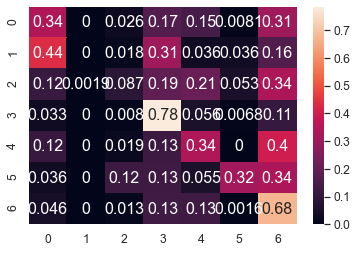

	training epoch=3 .. train_loss=1.383
	validation epoch=3 .. val_loss=1.443
	Accuracy = 46.2 % .. Percision = 40.9 % .. Recall = 36.4 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_3.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 4 .. loss = 1.074


  0%|                                                                                 | 1/1914 [00:01<38:21,  1.20s/it]

training @ epoch 4 .. loss = 0.949


  0%|                                                                                 | 2/1914 [00:02<37:47,  1.19s/it]

training @ epoch 4 .. loss = 1.543


  0%|▏                                                                                | 3/1914 [00:03<39:28,  1.24s/it]

training @ epoch 4 .. loss = 1.485


  0%|▏                                                                                | 4/1914 [00:05<41:37,  1.31s/it]

training @ epoch 4 .. loss = 1.269


  0%|▏                                                                                | 5/1914 [00:06<41:17,  1.30s/it]

training @ epoch 4 .. loss = 1.359


  0%|▎                                                                                | 6/1914 [00:07<41:01,  1.29s/it]

training @ epoch 4 .. loss = 1.046


  0%|▎                                                                                | 7/1914 [00:09<41:41,  1.31s/it]

training @ epoch 4 .. loss = 1.051


  0%|▎                                                                                | 8/1914 [00:10<41:19,  1.30s/it]

training @ epoch 4 .. loss = 1.633


  0%|▍                                                                                | 9/1914 [00:11<41:13,  1.30s/it]

training @ epoch 4 .. loss = 1.365


  1%|▍                                                                               | 10/1914 [00:12<40:56,  1.29s/it]

training @ epoch 4 .. loss = 1.334


  1%|▍                                                                               | 11/1914 [00:14<40:53,  1.29s/it]

training @ epoch 4 .. loss = 1.579


  1%|▌                                                                               | 12/1914 [00:15<40:59,  1.29s/it]

training @ epoch 4 .. loss = 1.254


  1%|▌                                                                               | 13/1914 [00:16<40:46,  1.29s/it]

training @ epoch 4 .. loss = 1.172


  1%|▌                                                                               | 14/1914 [00:18<41:00,  1.30s/it]

training @ epoch 4 .. loss = 1.256


  1%|▋                                                                               | 15/1914 [00:19<40:46,  1.29s/it]

training @ epoch 4 .. loss = 1.342


  1%|▋                                                                               | 16/1914 [00:20<41:17,  1.31s/it]

training @ epoch 4 .. loss = 1.706


  1%|▋                                                                               | 17/1914 [00:21<40:47,  1.29s/it]

training @ epoch 4 .. loss = 1.387


  1%|▊                                                                               | 18/1914 [00:23<41:17,  1.31s/it]

training @ epoch 4 .. loss = 1.107


  1%|▊                                                                               | 19/1914 [00:24<40:22,  1.28s/it]

training @ epoch 4 .. loss = 1.569


  1%|▊                                                                               | 20/1914 [00:25<39:27,  1.25s/it]

training @ epoch 4 .. loss = 1.734


  1%|▉                                                                               | 21/1914 [00:26<38:25,  1.22s/it]

training @ epoch 4 .. loss = 1.092


  1%|▉                                                                               | 22/1914 [00:27<37:26,  1.19s/it]

training @ epoch 4 .. loss = 1.135


  1%|▉                                                                               | 23/1914 [00:29<37:02,  1.18s/it]

training @ epoch 4 .. loss = 1.279


  1%|█                                                                               | 24/1914 [00:30<36:53,  1.17s/it]

training @ epoch 4 .. loss = 1.544


  1%|█                                                                               | 25/1914 [00:31<36:55,  1.17s/it]

training @ epoch 4 .. loss = 0.965


  1%|█                                                                               | 26/1914 [00:32<37:11,  1.18s/it]

training @ epoch 4 .. loss = 1.084


  1%|█▏                                                                              | 27/1914 [00:33<36:36,  1.16s/it]

training @ epoch 4 .. loss = 1.517


  1%|█▏                                                                              | 28/1914 [00:34<36:44,  1.17s/it]

training @ epoch 4 .. loss = 1.804


  2%|█▏                                                                              | 29/1914 [00:36<36:21,  1.16s/it]

training @ epoch 4 .. loss = 1.291


  2%|█▎                                                                              | 30/1914 [00:37<36:05,  1.15s/it]

training @ epoch 4 .. loss = 1.35


  2%|█▎                                                                              | 31/1914 [00:38<36:22,  1.16s/it]

training @ epoch 4 .. loss = 1.106


  2%|█▎                                                                              | 32/1914 [00:39<36:17,  1.16s/it]

training @ epoch 4 .. loss = 1.577


  2%|█▍                                                                              | 33/1914 [00:40<36:19,  1.16s/it]

training @ epoch 4 .. loss = 1.648


  2%|█▍                                                                              | 34/1914 [00:41<36:14,  1.16s/it]

training @ epoch 4 .. loss = 1.522


  2%|█▍                                                                              | 35/1914 [00:43<36:33,  1.17s/it]

training @ epoch 4 .. loss = 1.583


  2%|█▌                                                                              | 36/1914 [00:44<36:18,  1.16s/it]

training @ epoch 4 .. loss = 1.275


  2%|█▌                                                                              | 37/1914 [00:45<36:12,  1.16s/it]

training @ epoch 4 .. loss = 1.02


  2%|█▌                                                                              | 38/1914 [00:46<36:51,  1.18s/it]

training @ epoch 4 .. loss = 1.767


  2%|█▋                                                                              | 39/1914 [00:47<36:13,  1.16s/it]

training @ epoch 4 .. loss = 1.531


  2%|█▋                                                                              | 40/1914 [00:48<37:23,  1.20s/it]

training @ epoch 4 .. loss = 1.052


  2%|█▋                                                                              | 41/1914 [00:50<36:39,  1.17s/it]

training @ epoch 4 .. loss = 1.147


  2%|█▊                                                                              | 42/1914 [00:51<36:25,  1.17s/it]

training @ epoch 4 .. loss = 1.498


  2%|█▊                                                                              | 43/1914 [00:52<36:32,  1.17s/it]

training @ epoch 4 .. loss = 1.316


  2%|█▊                                                                              | 44/1914 [00:53<36:31,  1.17s/it]

training @ epoch 4 .. loss = 1.49


  2%|█▉                                                                              | 45/1914 [00:54<36:20,  1.17s/it]

training @ epoch 4 .. loss = 1.045


  2%|█▉                                                                              | 46/1914 [00:55<36:05,  1.16s/it]

training @ epoch 4 .. loss = 1.529


  2%|█▉                                                                              | 47/1914 [00:57<36:17,  1.17s/it]

training @ epoch 4 .. loss = 1.382


  3%|██                                                                              | 48/1914 [00:58<36:02,  1.16s/it]

training @ epoch 4 .. loss = 1.537


  3%|██                                                                              | 49/1914 [00:59<35:39,  1.15s/it]

training @ epoch 4 .. loss = 1.172


  3%|██                                                                              | 50/1914 [01:00<35:28,  1.14s/it]

training @ epoch 4 .. loss = 1.485


  3%|██▏                                                                             | 51/1914 [01:01<35:21,  1.14s/it]

training @ epoch 4 .. loss = 1.464


  3%|██▏                                                                             | 52/1914 [01:02<35:12,  1.13s/it]

training @ epoch 4 .. loss = 1.183


  3%|██▏                                                                             | 53/1914 [01:03<35:19,  1.14s/it]

training @ epoch 4 .. loss = 1.403


  3%|██▎                                                                             | 54/1914 [01:05<35:47,  1.15s/it]

training @ epoch 4 .. loss = 1.129


  3%|██▎                                                                             | 55/1914 [01:06<35:43,  1.15s/it]

training @ epoch 4 .. loss = 1.404


  3%|██▎                                                                             | 56/1914 [01:07<35:48,  1.16s/it]

training @ epoch 4 .. loss = 1.354


  3%|██▍                                                                             | 57/1914 [01:08<36:13,  1.17s/it]

training @ epoch 4 .. loss = 1.176


  3%|██▍                                                                             | 58/1914 [01:09<35:59,  1.16s/it]

training @ epoch 4 .. loss = 1.417


  3%|██▍                                                                             | 59/1914 [01:10<36:02,  1.17s/it]

training @ epoch 4 .. loss = 1.592


  3%|██▌                                                                             | 60/1914 [01:12<35:50,  1.16s/it]

training @ epoch 4 .. loss = 1.457


  3%|██▌                                                                             | 61/1914 [01:13<35:30,  1.15s/it]

training @ epoch 4 .. loss = 1.294


  3%|██▌                                                                             | 62/1914 [01:14<35:45,  1.16s/it]

training @ epoch 4 .. loss = 1.411


  3%|██▋                                                                             | 63/1914 [01:15<35:36,  1.15s/it]

training @ epoch 4 .. loss = 1.225


  3%|██▋                                                                             | 64/1914 [01:16<35:54,  1.16s/it]

training @ epoch 4 .. loss = 1.321


  3%|██▋                                                                             | 65/1914 [01:17<36:29,  1.18s/it]

training @ epoch 4 .. loss = 1.442


  3%|██▊                                                                             | 66/1914 [01:19<36:26,  1.18s/it]

training @ epoch 4 .. loss = 1.371


  4%|██▊                                                                             | 67/1914 [01:20<36:17,  1.18s/it]

training @ epoch 4 .. loss = 1.025


  4%|██▊                                                                             | 68/1914 [01:21<36:22,  1.18s/it]

training @ epoch 4 .. loss = 1.649


  4%|██▉                                                                             | 69/1914 [01:22<36:04,  1.17s/it]

training @ epoch 4 .. loss = 1.155


  4%|██▉                                                                             | 70/1914 [01:23<35:29,  1.15s/it]

training @ epoch 4 .. loss = 1.697


  4%|██▉                                                                             | 71/1914 [01:24<35:37,  1.16s/it]

training @ epoch 4 .. loss = 1.307


  4%|███                                                                             | 72/1914 [01:26<35:29,  1.16s/it]

training @ epoch 4 .. loss = 1.743


  4%|███                                                                             | 73/1914 [01:27<35:28,  1.16s/it]

training @ epoch 4 .. loss = 1.554


  4%|███                                                                             | 74/1914 [01:28<35:06,  1.14s/it]

training @ epoch 4 .. loss = 1.385


  4%|███▏                                                                            | 75/1914 [01:29<35:08,  1.15s/it]

training @ epoch 4 .. loss = 1.415


  4%|███▏                                                                            | 76/1914 [01:30<35:30,  1.16s/it]

training @ epoch 4 .. loss = 1.646


  4%|███▏                                                                            | 77/1914 [01:31<35:21,  1.16s/it]

training @ epoch 4 .. loss = 1.509


  4%|███▎                                                                            | 78/1914 [01:32<35:35,  1.16s/it]

training @ epoch 4 .. loss = 1.611


  4%|███▎                                                                            | 79/1914 [01:34<35:11,  1.15s/it]

training @ epoch 4 .. loss = 1.441


  4%|███▎                                                                            | 80/1914 [01:35<34:59,  1.14s/it]

training @ epoch 4 .. loss = 1.198


  4%|███▍                                                                            | 81/1914 [01:36<35:18,  1.16s/it]

training @ epoch 4 .. loss = 1.684


  4%|███▍                                                                            | 82/1914 [01:37<35:20,  1.16s/it]

training @ epoch 4 .. loss = 1.594


  4%|███▍                                                                            | 83/1914 [01:38<35:30,  1.16s/it]

training @ epoch 4 .. loss = 1.168


  4%|███▌                                                                            | 84/1914 [01:40<36:08,  1.19s/it]

training @ epoch 4 .. loss = 1.258


  4%|███▌                                                                            | 85/1914 [01:41<36:17,  1.19s/it]

training @ epoch 4 .. loss = 1.603


  4%|███▌                                                                            | 86/1914 [01:42<36:01,  1.18s/it]

training @ epoch 4 .. loss = 1.427


  5%|███▋                                                                            | 87/1914 [01:43<36:11,  1.19s/it]

training @ epoch 4 .. loss = 1.498


  5%|███▋                                                                            | 88/1914 [01:44<35:58,  1.18s/it]

training @ epoch 4 .. loss = 1.333


  5%|███▋                                                                            | 89/1914 [01:45<35:46,  1.18s/it]

training @ epoch 4 .. loss = 1.2


  5%|███▊                                                                            | 90/1914 [01:47<35:43,  1.18s/it]

training @ epoch 4 .. loss = 1.282


  5%|███▊                                                                            | 91/1914 [01:48<35:22,  1.16s/it]

training @ epoch 4 .. loss = 1.492


  5%|███▊                                                                            | 92/1914 [01:49<34:59,  1.15s/it]

training @ epoch 4 .. loss = 1.308


  5%|███▉                                                                            | 93/1914 [01:50<35:09,  1.16s/it]

training @ epoch 4 .. loss = 1.594


  5%|███▉                                                                            | 94/1914 [01:51<34:59,  1.15s/it]

training @ epoch 4 .. loss = 1.354


  5%|███▉                                                                            | 95/1914 [01:52<34:57,  1.15s/it]

training @ epoch 4 .. loss = 1.235


  5%|████                                                                            | 96/1914 [01:54<35:21,  1.17s/it]

training @ epoch 4 .. loss = 1.304


  5%|████                                                                            | 97/1914 [01:55<35:06,  1.16s/it]

training @ epoch 4 .. loss = 1.335


  5%|████                                                                            | 98/1914 [01:56<35:13,  1.16s/it]

training @ epoch 4 .. loss = 1.332


  5%|████▏                                                                           | 99/1914 [01:57<35:12,  1.16s/it]

training @ epoch 4 .. loss = 1.347


  5%|████▏                                                                          | 100/1914 [01:58<34:55,  1.15s/it]

training @ epoch 4 .. loss = 1.413


  5%|████▏                                                                          | 101/1914 [01:59<34:45,  1.15s/it]

training @ epoch 4 .. loss = 1.466


  5%|████▏                                                                          | 102/1914 [02:00<34:47,  1.15s/it]

training @ epoch 4 .. loss = 1.386


  5%|████▎                                                                          | 103/1914 [02:02<34:28,  1.14s/it]

training @ epoch 4 .. loss = 1.156


  5%|████▎                                                                          | 104/1914 [02:03<34:23,  1.14s/it]

training @ epoch 4 .. loss = 1.198


  5%|████▎                                                                          | 105/1914 [02:04<34:23,  1.14s/it]

training @ epoch 4 .. loss = 1.121


  6%|████▍                                                                          | 106/1914 [02:05<36:40,  1.22s/it]

training @ epoch 4 .. loss = 1.526


  6%|████▍                                                                          | 107/1914 [02:07<37:32,  1.25s/it]

training @ epoch 4 .. loss = 1.434


  6%|████▍                                                                          | 108/1914 [02:08<38:08,  1.27s/it]

training @ epoch 4 .. loss = 1.223


  6%|████▍                                                                          | 109/1914 [02:09<36:48,  1.22s/it]

training @ epoch 4 .. loss = 1.492


  6%|████▌                                                                          | 110/1914 [02:10<36:14,  1.21s/it]

training @ epoch 4 .. loss = 1.101


  6%|████▌                                                                          | 111/1914 [02:11<35:39,  1.19s/it]

training @ epoch 4 .. loss = 1.964


  6%|████▌                                                                          | 112/1914 [02:12<35:30,  1.18s/it]

training @ epoch 4 .. loss = 1.435


  6%|████▋                                                                          | 113/1914 [02:14<35:12,  1.17s/it]

training @ epoch 4 .. loss = 1.131


  6%|████▋                                                                          | 114/1914 [02:15<34:44,  1.16s/it]

training @ epoch 4 .. loss = 1.302


  6%|████▋                                                                          | 115/1914 [02:16<35:00,  1.17s/it]

training @ epoch 4 .. loss = 1.088


  6%|████▊                                                                          | 116/1914 [02:17<36:48,  1.23s/it]

training @ epoch 4 .. loss = 1.287


  6%|████▊                                                                          | 117/1914 [02:19<38:48,  1.30s/it]

training @ epoch 4 .. loss = 1.627


  6%|████▊                                                                          | 118/1914 [02:20<40:47,  1.36s/it]

training @ epoch 4 .. loss = 1.226


  6%|████▉                                                                          | 119/1914 [02:22<42:07,  1.41s/it]

training @ epoch 4 .. loss = 1.905


  6%|████▉                                                                          | 120/1914 [02:23<42:48,  1.43s/it]

training @ epoch 4 .. loss = 1.524


  6%|████▉                                                                          | 121/1914 [02:25<43:25,  1.45s/it]

training @ epoch 4 .. loss = 1.41


  6%|█████                                                                          | 122/1914 [02:26<44:24,  1.49s/it]

training @ epoch 4 .. loss = 1.516


  6%|█████                                                                          | 123/1914 [02:28<43:30,  1.46s/it]

training @ epoch 4 .. loss = 1.342


  6%|█████                                                                          | 124/1914 [02:29<41:44,  1.40s/it]

training @ epoch 4 .. loss = 1.317


  7%|█████▏                                                                         | 125/1914 [02:30<41:02,  1.38s/it]

training @ epoch 4 .. loss = 1.626


  7%|█████▏                                                                         | 126/1914 [02:32<39:50,  1.34s/it]

training @ epoch 4 .. loss = 1.407


  7%|█████▏                                                                         | 127/1914 [02:33<38:59,  1.31s/it]

training @ epoch 4 .. loss = 0.752


  7%|█████▎                                                                         | 128/1914 [02:34<38:44,  1.30s/it]

training @ epoch 4 .. loss = 1.623


  7%|█████▎                                                                         | 129/1914 [02:35<38:23,  1.29s/it]

training @ epoch 4 .. loss = 1.163


  7%|█████▎                                                                         | 130/1914 [02:37<39:05,  1.31s/it]

training @ epoch 4 .. loss = 1.384


  7%|█████▍                                                                         | 131/1914 [02:38<38:53,  1.31s/it]

training @ epoch 4 .. loss = 1.307


  7%|█████▍                                                                         | 132/1914 [02:39<37:40,  1.27s/it]

training @ epoch 4 .. loss = 1.185


  7%|█████▍                                                                         | 133/1914 [02:40<36:54,  1.24s/it]

training @ epoch 4 .. loss = 0.956


  7%|█████▌                                                                         | 134/1914 [02:42<36:01,  1.21s/it]

training @ epoch 4 .. loss = 1.23


  7%|█████▌                                                                         | 135/1914 [02:43<35:10,  1.19s/it]

training @ epoch 4 .. loss = 1.635


  7%|█████▌                                                                         | 136/1914 [02:44<34:51,  1.18s/it]

training @ epoch 4 .. loss = 1.094


  7%|█████▋                                                                         | 137/1914 [02:45<34:47,  1.17s/it]

training @ epoch 4 .. loss = 1.384


  7%|█████▋                                                                         | 138/1914 [02:46<35:23,  1.20s/it]

training @ epoch 4 .. loss = 1.877


  7%|█████▋                                                                         | 139/1914 [02:47<34:52,  1.18s/it]

training @ epoch 4 .. loss = 1.268


  7%|█████▊                                                                         | 140/1914 [02:48<34:27,  1.17s/it]

training @ epoch 4 .. loss = 1.328


  7%|█████▊                                                                         | 141/1914 [02:50<34:18,  1.16s/it]

training @ epoch 4 .. loss = 1.322


  7%|█████▊                                                                         | 142/1914 [02:51<34:01,  1.15s/it]

training @ epoch 4 .. loss = 1.33


  7%|█████▉                                                                         | 143/1914 [02:52<34:15,  1.16s/it]

training @ epoch 4 .. loss = 1.528


  8%|█████▉                                                                         | 144/1914 [02:53<33:53,  1.15s/it]

training @ epoch 4 .. loss = 1.022


  8%|█████▉                                                                         | 145/1914 [02:54<34:16,  1.16s/it]

training @ epoch 4 .. loss = 1.149


  8%|██████                                                                         | 146/1914 [02:55<34:09,  1.16s/it]

training @ epoch 4 .. loss = 1.94


  8%|██████                                                                         | 147/1914 [02:57<34:10,  1.16s/it]

training @ epoch 4 .. loss = 1.281


  8%|██████                                                                         | 148/1914 [02:58<34:10,  1.16s/it]

training @ epoch 4 .. loss = 1.504


  8%|██████▏                                                                        | 149/1914 [02:59<33:59,  1.16s/it]

training @ epoch 4 .. loss = 1.278


  8%|██████▏                                                                        | 150/1914 [03:00<34:23,  1.17s/it]

training @ epoch 4 .. loss = 1.37


  8%|██████▏                                                                        | 151/1914 [03:01<34:10,  1.16s/it]

training @ epoch 4 .. loss = 1.662


  8%|██████▎                                                                        | 152/1914 [03:02<34:24,  1.17s/it]

training @ epoch 4 .. loss = 1.134


  8%|██████▎                                                                        | 153/1914 [03:04<33:49,  1.15s/it]

training @ epoch 4 .. loss = 1.636


  8%|██████▎                                                                        | 154/1914 [03:05<33:50,  1.15s/it]

training @ epoch 4 .. loss = 1.307


  8%|██████▍                                                                        | 155/1914 [03:06<33:42,  1.15s/it]

training @ epoch 4 .. loss = 1.338


  8%|██████▍                                                                        | 156/1914 [03:07<33:23,  1.14s/it]

training @ epoch 4 .. loss = 1.408


  8%|██████▍                                                                        | 157/1914 [03:08<33:57,  1.16s/it]

training @ epoch 4 .. loss = 1.523


  8%|██████▌                                                                        | 158/1914 [03:09<33:41,  1.15s/it]

training @ epoch 4 .. loss = 1.351


  8%|██████▌                                                                        | 159/1914 [03:10<33:47,  1.16s/it]

training @ epoch 4 .. loss = 1.393


  8%|██████▌                                                                        | 160/1914 [03:12<33:27,  1.14s/it]

training @ epoch 4 .. loss = 1.566


  8%|██████▋                                                                        | 161/1914 [03:13<33:34,  1.15s/it]

training @ epoch 4 .. loss = 1.337


  8%|██████▋                                                                        | 162/1914 [03:14<33:33,  1.15s/it]

training @ epoch 4 .. loss = 1.169


  9%|██████▋                                                                        | 163/1914 [03:15<33:19,  1.14s/it]

training @ epoch 4 .. loss = 1.141


  9%|██████▊                                                                        | 164/1914 [03:16<33:49,  1.16s/it]

training @ epoch 4 .. loss = 1.155


  9%|██████▊                                                                        | 165/1914 [03:17<33:48,  1.16s/it]

training @ epoch 4 .. loss = 1.442


  9%|██████▊                                                                        | 166/1914 [03:18<33:21,  1.14s/it]

training @ epoch 4 .. loss = 1.06


  9%|██████▉                                                                        | 167/1914 [03:20<33:18,  1.14s/it]

training @ epoch 4 .. loss = 1.102


  9%|██████▉                                                                        | 168/1914 [03:21<33:21,  1.15s/it]

training @ epoch 4 .. loss = 1.448


  9%|██████▉                                                                        | 169/1914 [03:22<33:27,  1.15s/it]

training @ epoch 4 .. loss = 1.954


  9%|███████                                                                        | 170/1914 [03:23<33:31,  1.15s/it]

training @ epoch 4 .. loss = 1.292


  9%|███████                                                                        | 171/1914 [03:24<33:50,  1.17s/it]

training @ epoch 4 .. loss = 1.659


  9%|███████                                                                        | 172/1914 [03:25<33:41,  1.16s/it]

training @ epoch 4 .. loss = 1.495


  9%|███████▏                                                                       | 173/1914 [03:27<33:34,  1.16s/it]

training @ epoch 4 .. loss = 1.058


  9%|███████▏                                                                       | 174/1914 [03:28<33:16,  1.15s/it]

training @ epoch 4 .. loss = 1.266


  9%|███████▏                                                                       | 175/1914 [03:29<33:00,  1.14s/it]

training @ epoch 4 .. loss = 1.488


  9%|███████▎                                                                       | 176/1914 [03:30<33:28,  1.16s/it]

training @ epoch 4 .. loss = 2.215


  9%|███████▎                                                                       | 177/1914 [03:31<33:18,  1.15s/it]

training @ epoch 4 .. loss = 1.245


  9%|███████▎                                                                       | 178/1914 [03:32<33:34,  1.16s/it]

training @ epoch 4 .. loss = 1.079


  9%|███████▍                                                                       | 179/1914 [03:33<33:23,  1.15s/it]

training @ epoch 4 .. loss = 1.334


  9%|███████▍                                                                       | 180/1914 [03:35<33:31,  1.16s/it]

training @ epoch 4 .. loss = 1.219


  9%|███████▍                                                                       | 181/1914 [03:36<33:14,  1.15s/it]

training @ epoch 4 .. loss = 1.539


 10%|███████▌                                                                       | 182/1914 [03:37<33:03,  1.15s/it]

training @ epoch 4 .. loss = 1.604


 10%|███████▌                                                                       | 183/1914 [03:38<33:32,  1.16s/it]

training @ epoch 4 .. loss = 1.51


 10%|███████▌                                                                       | 184/1914 [03:39<33:41,  1.17s/it]

training @ epoch 4 .. loss = 1.59


 10%|███████▋                                                                       | 185/1914 [03:40<33:32,  1.16s/it]

training @ epoch 4 .. loss = 1.935


 10%|███████▋                                                                       | 186/1914 [03:42<32:53,  1.14s/it]

training @ epoch 4 .. loss = 1.343


 10%|███████▋                                                                       | 187/1914 [03:43<34:15,  1.19s/it]

training @ epoch 4 .. loss = 1.213


 10%|███████▊                                                                       | 188/1914 [03:44<35:39,  1.24s/it]

training @ epoch 4 .. loss = 1.146


 10%|███████▊                                                                       | 189/1914 [03:45<36:01,  1.25s/it]

training @ epoch 4 .. loss = 1.242


 10%|███████▊                                                                       | 190/1914 [03:47<36:20,  1.26s/it]

training @ epoch 4 .. loss = 1.054


 10%|███████▉                                                                       | 191/1914 [03:48<36:34,  1.27s/it]

training @ epoch 4 .. loss = 1.458


 10%|███████▉                                                                       | 192/1914 [03:49<36:26,  1.27s/it]

training @ epoch 4 .. loss = 1.652


 10%|███████▉                                                                       | 193/1914 [03:51<36:27,  1.27s/it]

training @ epoch 4 .. loss = 1.441


 10%|████████                                                                       | 194/1914 [03:52<36:23,  1.27s/it]

training @ epoch 4 .. loss = 1.197


 10%|████████                                                                       | 195/1914 [03:53<36:50,  1.29s/it]

training @ epoch 4 .. loss = 1.018


 10%|████████                                                                       | 196/1914 [03:54<37:04,  1.29s/it]

training @ epoch 4 .. loss = 1.499


 10%|████████▏                                                                      | 197/1914 [03:56<36:41,  1.28s/it]

training @ epoch 4 .. loss = 1.301


 10%|████████▏                                                                      | 198/1914 [03:57<36:40,  1.28s/it]

training @ epoch 4 .. loss = 1.272


 10%|████████▏                                                                      | 199/1914 [03:58<36:55,  1.29s/it]

training @ epoch 4 .. loss = 1.954


 10%|████████▎                                                                      | 200/1914 [04:00<36:24,  1.27s/it]

training @ epoch 4 .. loss = 1.579


 11%|████████▎                                                                      | 201/1914 [04:01<36:07,  1.27s/it]

training @ epoch 4 .. loss = 1.42


 11%|████████▎                                                                      | 202/1914 [04:02<36:30,  1.28s/it]

training @ epoch 4 .. loss = 1.939


 11%|████████▍                                                                      | 203/1914 [04:03<36:06,  1.27s/it]

training @ epoch 4 .. loss = 1.488


 11%|████████▍                                                                      | 204/1914 [04:05<35:27,  1.24s/it]

training @ epoch 4 .. loss = 1.317


 11%|████████▍                                                                      | 205/1914 [04:06<34:48,  1.22s/it]

training @ epoch 4 .. loss = 1.544


 11%|████████▌                                                                      | 206/1914 [04:07<34:13,  1.20s/it]

training @ epoch 4 .. loss = 1.389


 11%|████████▌                                                                      | 207/1914 [04:08<34:08,  1.20s/it]

training @ epoch 4 .. loss = 1.642


 11%|████████▌                                                                      | 208/1914 [04:09<33:32,  1.18s/it]

training @ epoch 4 .. loss = 1.43


 11%|████████▋                                                                      | 209/1914 [04:10<33:38,  1.18s/it]

training @ epoch 4 .. loss = 1.096


 11%|████████▋                                                                      | 210/1914 [04:12<33:24,  1.18s/it]

training @ epoch 4 .. loss = 1.388


 11%|████████▋                                                                      | 211/1914 [04:13<33:17,  1.17s/it]

training @ epoch 4 .. loss = 1.175


 11%|████████▊                                                                      | 212/1914 [04:14<32:54,  1.16s/it]

training @ epoch 4 .. loss = 1.382


 11%|████████▊                                                                      | 213/1914 [04:15<32:44,  1.15s/it]

training @ epoch 4 .. loss = 1.393


 11%|████████▊                                                                      | 214/1914 [04:16<32:50,  1.16s/it]

training @ epoch 4 .. loss = 1.641


 11%|████████▊                                                                      | 215/1914 [04:17<33:04,  1.17s/it]

training @ epoch 4 .. loss = 1.26


 11%|████████▉                                                                      | 216/1914 [04:19<32:49,  1.16s/it]

training @ epoch 4 .. loss = 1.34


 11%|████████▉                                                                      | 217/1914 [04:20<32:29,  1.15s/it]

training @ epoch 4 .. loss = 1.315


 11%|████████▉                                                                      | 218/1914 [04:21<32:31,  1.15s/it]

training @ epoch 4 .. loss = 1.371


 11%|█████████                                                                      | 219/1914 [04:22<32:37,  1.15s/it]

training @ epoch 4 .. loss = 1.585


 11%|█████████                                                                      | 220/1914 [04:23<32:40,  1.16s/it]

training @ epoch 4 .. loss = 1.113


 12%|█████████                                                                      | 221/1914 [04:24<32:38,  1.16s/it]

training @ epoch 4 .. loss = 1.28


 12%|█████████▏                                                                     | 222/1914 [04:25<32:28,  1.15s/it]

training @ epoch 4 .. loss = 1.403


 12%|█████████▏                                                                     | 223/1914 [04:27<32:31,  1.15s/it]

training @ epoch 4 .. loss = 1.124


 12%|█████████▏                                                                     | 224/1914 [04:28<32:19,  1.15s/it]

training @ epoch 4 .. loss = 1.254


 12%|█████████▎                                                                     | 225/1914 [04:29<32:26,  1.15s/it]

training @ epoch 4 .. loss = 1.267


 12%|█████████▎                                                                     | 226/1914 [04:30<33:07,  1.18s/it]

training @ epoch 4 .. loss = 1.667


 12%|█████████▎                                                                     | 227/1914 [04:31<32:59,  1.17s/it]

training @ epoch 4 .. loss = 1.001


 12%|█████████▍                                                                     | 228/1914 [04:32<32:41,  1.16s/it]

training @ epoch 4 .. loss = 1.158


 12%|█████████▍                                                                     | 229/1914 [04:34<32:24,  1.15s/it]

training @ epoch 4 .. loss = 1.48


 12%|█████████▍                                                                     | 230/1914 [04:35<32:26,  1.16s/it]

training @ epoch 4 .. loss = 1.351


 12%|█████████▌                                                                     | 231/1914 [04:36<32:28,  1.16s/it]

training @ epoch 4 .. loss = 1.394


 12%|█████████▌                                                                     | 232/1914 [04:37<32:20,  1.15s/it]

training @ epoch 4 .. loss = 1.603


 12%|█████████▌                                                                     | 233/1914 [04:38<32:29,  1.16s/it]

training @ epoch 4 .. loss = 1.408


 12%|█████████▋                                                                     | 234/1914 [04:39<32:19,  1.15s/it]

training @ epoch 4 .. loss = 1.105


 12%|█████████▋                                                                     | 235/1914 [04:40<32:12,  1.15s/it]

training @ epoch 4 .. loss = 1.426


 12%|█████████▋                                                                     | 236/1914 [04:42<32:11,  1.15s/it]

training @ epoch 4 .. loss = 1.235


 12%|█████████▊                                                                     | 237/1914 [04:43<32:11,  1.15s/it]

training @ epoch 4 .. loss = 1.129


 12%|█████████▊                                                                     | 238/1914 [04:44<32:31,  1.16s/it]

training @ epoch 4 .. loss = 1.025


 12%|█████████▊                                                                     | 239/1914 [04:45<32:39,  1.17s/it]

training @ epoch 4 .. loss = 1.208


 13%|█████████▉                                                                     | 240/1914 [04:46<32:28,  1.16s/it]

training @ epoch 4 .. loss = 1.494


 13%|█████████▉                                                                     | 241/1914 [04:47<32:15,  1.16s/it]

training @ epoch 4 .. loss = 1.277


 13%|█████████▉                                                                     | 242/1914 [04:49<32:17,  1.16s/it]

training @ epoch 4 .. loss = 1.302


 13%|██████████                                                                     | 243/1914 [04:50<31:57,  1.15s/it]

training @ epoch 4 .. loss = 1.434


 13%|██████████                                                                     | 244/1914 [04:51<31:48,  1.14s/it]

training @ epoch 4 .. loss = 1.076


 13%|██████████                                                                     | 245/1914 [04:52<31:57,  1.15s/it]

training @ epoch 4 .. loss = 1.113


 13%|██████████▏                                                                    | 246/1914 [04:53<31:47,  1.14s/it]

training @ epoch 4 .. loss = 1.163


 13%|██████████▏                                                                    | 247/1914 [04:54<32:06,  1.16s/it]

training @ epoch 4 .. loss = 1.281


 13%|██████████▏                                                                    | 248/1914 [04:55<32:05,  1.16s/it]

training @ epoch 4 .. loss = 0.863


 13%|██████████▎                                                                    | 249/1914 [04:57<31:47,  1.15s/it]

training @ epoch 4 .. loss = 1.125


 13%|██████████▎                                                                    | 250/1914 [04:58<31:53,  1.15s/it]

training @ epoch 4 .. loss = 1.404


 13%|██████████▎                                                                    | 251/1914 [04:59<31:46,  1.15s/it]

training @ epoch 4 .. loss = 1.188


 13%|██████████▍                                                                    | 252/1914 [05:00<32:13,  1.16s/it]

training @ epoch 4 .. loss = 1.157


 13%|██████████▍                                                                    | 253/1914 [05:01<31:56,  1.15s/it]

training @ epoch 4 .. loss = 1.694


 13%|██████████▍                                                                    | 254/1914 [05:02<32:04,  1.16s/it]

training @ epoch 4 .. loss = 1.048


 13%|██████████▌                                                                    | 255/1914 [05:04<31:59,  1.16s/it]

training @ epoch 4 .. loss = 1.203


 13%|██████████▌                                                                    | 256/1914 [05:05<32:06,  1.16s/it]

training @ epoch 4 .. loss = 1.655


 13%|██████████▌                                                                    | 257/1914 [05:06<32:04,  1.16s/it]

training @ epoch 4 .. loss = 1.382


 13%|██████████▋                                                                    | 258/1914 [05:07<31:58,  1.16s/it]

training @ epoch 4 .. loss = 1.415


 14%|██████████▋                                                                    | 259/1914 [05:08<32:13,  1.17s/it]

training @ epoch 4 .. loss = 1.283


 14%|██████████▋                                                                    | 260/1914 [05:09<31:49,  1.15s/it]

training @ epoch 4 .. loss = 1.487


 14%|██████████▊                                                                    | 261/1914 [05:11<31:42,  1.15s/it]

training @ epoch 4 .. loss = 1.573


 14%|██████████▊                                                                    | 262/1914 [05:12<31:45,  1.15s/it]

training @ epoch 4 .. loss = 1.508


 14%|██████████▊                                                                    | 263/1914 [05:13<31:28,  1.14s/it]

training @ epoch 4 .. loss = 1.386


 14%|██████████▉                                                                    | 264/1914 [05:14<31:45,  1.15s/it]

training @ epoch 4 .. loss = 1.389


 14%|██████████▉                                                                    | 265/1914 [05:15<31:30,  1.15s/it]

training @ epoch 4 .. loss = 2.075


 14%|██████████▉                                                                    | 266/1914 [05:16<31:55,  1.16s/it]

training @ epoch 4 .. loss = 1.205


 14%|███████████                                                                    | 267/1914 [05:17<31:44,  1.16s/it]

training @ epoch 4 .. loss = 1.535


 14%|███████████                                                                    | 268/1914 [05:19<31:55,  1.16s/it]

training @ epoch 4 .. loss = 1.981


 14%|███████████                                                                    | 269/1914 [05:20<31:42,  1.16s/it]

training @ epoch 4 .. loss = 1.219


 14%|███████████▏                                                                   | 270/1914 [05:21<31:30,  1.15s/it]

training @ epoch 4 .. loss = 1.259


 14%|███████████▏                                                                   | 271/1914 [05:22<31:52,  1.16s/it]

training @ epoch 4 .. loss = 1.39


 14%|███████████▏                                                                   | 272/1914 [05:23<31:30,  1.15s/it]

training @ epoch 4 .. loss = 1.557


 14%|███████████▎                                                                   | 273/1914 [05:24<31:34,  1.15s/it]

training @ epoch 4 .. loss = 1.253


 14%|███████████▎                                                                   | 274/1914 [05:25<31:07,  1.14s/it]

training @ epoch 4 .. loss = 1.29


 14%|███████████▎                                                                   | 275/1914 [05:27<31:06,  1.14s/it]

training @ epoch 4 .. loss = 1.52


 14%|███████████▍                                                                   | 276/1914 [05:28<31:11,  1.14s/it]

training @ epoch 4 .. loss = 0.984


 14%|███████████▍                                                                   | 277/1914 [05:29<31:11,  1.14s/it]

training @ epoch 4 .. loss = 1.338


 15%|███████████▍                                                                   | 278/1914 [05:30<31:23,  1.15s/it]

training @ epoch 4 .. loss = 1.275


 15%|███████████▌                                                                   | 279/1914 [05:31<31:35,  1.16s/it]

training @ epoch 4 .. loss = 1.293


 15%|███████████▌                                                                   | 280/1914 [05:32<31:45,  1.17s/it]

training @ epoch 4 .. loss = 1.155


 15%|███████████▌                                                                   | 281/1914 [05:34<31:17,  1.15s/it]

training @ epoch 4 .. loss = 1.421


 15%|███████████▋                                                                   | 282/1914 [05:35<31:32,  1.16s/it]

training @ epoch 4 .. loss = 1.853


 15%|███████████▋                                                                   | 283/1914 [05:36<31:18,  1.15s/it]

training @ epoch 4 .. loss = 1.276


 15%|███████████▋                                                                   | 284/1914 [05:37<31:01,  1.14s/it]

training @ epoch 4 .. loss = 1.557


 15%|███████████▊                                                                   | 285/1914 [05:38<31:32,  1.16s/it]

training @ epoch 4 .. loss = 1.341


 15%|███████████▊                                                                   | 286/1914 [05:39<31:15,  1.15s/it]

training @ epoch 4 .. loss = 1.297


 15%|███████████▊                                                                   | 287/1914 [05:41<31:40,  1.17s/it]

training @ epoch 4 .. loss = 1.451


 15%|███████████▉                                                                   | 288/1914 [05:42<31:23,  1.16s/it]

training @ epoch 4 .. loss = 1.128


 15%|███████████▉                                                                   | 289/1914 [05:43<31:10,  1.15s/it]

training @ epoch 4 .. loss = 1.399


 15%|███████████▉                                                                   | 290/1914 [05:44<31:01,  1.15s/it]

training @ epoch 4 .. loss = 1.807


 15%|████████████                                                                   | 291/1914 [05:45<31:09,  1.15s/it]

training @ epoch 4 .. loss = 1.265


 15%|████████████                                                                   | 292/1914 [05:46<31:18,  1.16s/it]

training @ epoch 4 .. loss = 1.222


 15%|████████████                                                                   | 293/1914 [05:47<31:08,  1.15s/it]

training @ epoch 4 .. loss = 1.23


 15%|████████████▏                                                                  | 294/1914 [05:49<31:13,  1.16s/it]

training @ epoch 4 .. loss = 0.914


 15%|████████████▏                                                                  | 295/1914 [05:50<30:53,  1.14s/it]

training @ epoch 4 .. loss = 1.338


 15%|████████████▏                                                                  | 296/1914 [05:51<30:55,  1.15s/it]

training @ epoch 4 .. loss = 1.493


 16%|████████████▎                                                                  | 297/1914 [05:52<31:11,  1.16s/it]

training @ epoch 4 .. loss = 1.129


 16%|████████████▎                                                                  | 298/1914 [05:53<31:02,  1.15s/it]

training @ epoch 4 .. loss = 1.488


 16%|████████████▎                                                                  | 299/1914 [05:54<31:15,  1.16s/it]

training @ epoch 4 .. loss = 0.932


 16%|████████████▍                                                                  | 300/1914 [05:55<30:59,  1.15s/it]

training @ epoch 4 .. loss = 1.086


 16%|████████████▍                                                                  | 301/1914 [05:57<30:54,  1.15s/it]

training @ epoch 4 .. loss = 1.311


 16%|████████████▍                                                                  | 302/1914 [05:58<30:49,  1.15s/it]

training @ epoch 4 .. loss = 1.374


 16%|████████████▌                                                                  | 303/1914 [05:59<30:26,  1.13s/it]

training @ epoch 4 .. loss = 1.034


 16%|████████████▌                                                                  | 304/1914 [06:00<30:44,  1.15s/it]

training @ epoch 4 .. loss = 1.16


 16%|████████████▌                                                                  | 305/1914 [06:01<30:45,  1.15s/it]

training @ epoch 4 .. loss = 1.006


 16%|████████████▋                                                                  | 306/1914 [06:02<30:46,  1.15s/it]

training @ epoch 4 .. loss = 1.564


 16%|████████████▋                                                                  | 307/1914 [06:03<30:47,  1.15s/it]

training @ epoch 4 .. loss = 1.016


 16%|████████████▋                                                                  | 308/1914 [06:05<31:06,  1.16s/it]

training @ epoch 4 .. loss = 1.899


 16%|████████████▊                                                                  | 309/1914 [06:06<31:11,  1.17s/it]

training @ epoch 4 .. loss = 1.273


 16%|████████████▊                                                                  | 310/1914 [06:07<30:34,  1.14s/it]

training @ epoch 4 .. loss = 1.252


 16%|████████████▊                                                                  | 311/1914 [06:08<30:55,  1.16s/it]

training @ epoch 4 .. loss = 1.313


 16%|████████████▉                                                                  | 312/1914 [06:09<30:53,  1.16s/it]

training @ epoch 4 .. loss = 1.869


 16%|████████████▉                                                                  | 313/1914 [06:10<30:49,  1.16s/it]

training @ epoch 4 .. loss = 0.89


 16%|████████████▉                                                                  | 314/1914 [06:12<30:32,  1.15s/it]

training @ epoch 4 .. loss = 1.286


 16%|█████████████                                                                  | 315/1914 [06:13<30:40,  1.15s/it]

training @ epoch 4 .. loss = 1.488


 17%|█████████████                                                                  | 316/1914 [06:14<30:49,  1.16s/it]

training @ epoch 4 .. loss = 1.294


 17%|█████████████                                                                  | 317/1914 [06:15<30:40,  1.15s/it]

training @ epoch 4 .. loss = 2.155


 17%|█████████████▏                                                                 | 318/1914 [06:16<30:56,  1.16s/it]

training @ epoch 4 .. loss = 2.103


 17%|█████████████▏                                                                 | 319/1914 [06:17<30:36,  1.15s/it]

training @ epoch 4 .. loss = 1.618


 17%|█████████████▏                                                                 | 320/1914 [06:19<30:49,  1.16s/it]

training @ epoch 4 .. loss = 1.736


 17%|█████████████▏                                                                 | 321/1914 [06:20<30:44,  1.16s/it]

training @ epoch 4 .. loss = 1.35


 17%|█████████████▎                                                                 | 322/1914 [06:21<30:30,  1.15s/it]

training @ epoch 4 .. loss = 1.509


 17%|█████████████▎                                                                 | 323/1914 [06:22<30:32,  1.15s/it]

training @ epoch 4 .. loss = 1.117


 17%|█████████████▎                                                                 | 324/1914 [06:23<30:26,  1.15s/it]

training @ epoch 4 .. loss = 1.125


 17%|█████████████▍                                                                 | 325/1914 [06:24<30:22,  1.15s/it]

training @ epoch 4 .. loss = 1.226


 17%|█████████████▍                                                                 | 326/1914 [06:25<30:19,  1.15s/it]

training @ epoch 4 .. loss = 1.321


 17%|█████████████▍                                                                 | 327/1914 [06:27<30:35,  1.16s/it]

training @ epoch 4 .. loss = 1.409


 17%|█████████████▌                                                                 | 328/1914 [06:28<30:31,  1.15s/it]

training @ epoch 4 .. loss = 1.21


 17%|█████████████▌                                                                 | 329/1914 [06:29<34:31,  1.31s/it]

training @ epoch 4 .. loss = 1.296


 17%|█████████████▌                                                                 | 330/1914 [06:31<34:12,  1.30s/it]

training @ epoch 4 .. loss = 1.366


 17%|█████████████▋                                                                 | 331/1914 [06:32<33:06,  1.26s/it]

training @ epoch 4 .. loss = 0.958


 17%|█████████████▋                                                                 | 332/1914 [06:33<32:09,  1.22s/it]

training @ epoch 4 .. loss = 0.995


 17%|█████████████▋                                                                 | 333/1914 [06:34<31:51,  1.21s/it]

training @ epoch 4 .. loss = 0.977


 17%|█████████████▊                                                                 | 334/1914 [06:35<31:21,  1.19s/it]

training @ epoch 4 .. loss = 1.644


 18%|█████████████▊                                                                 | 335/1914 [06:36<31:10,  1.18s/it]

training @ epoch 4 .. loss = 1.484


 18%|█████████████▊                                                                 | 336/1914 [06:38<30:40,  1.17s/it]

training @ epoch 4 .. loss = 1.312


 18%|█████████████▉                                                                 | 337/1914 [06:39<30:41,  1.17s/it]

training @ epoch 4 .. loss = 1.328


 18%|█████████████▉                                                                 | 338/1914 [06:40<30:37,  1.17s/it]

training @ epoch 4 .. loss = 1.782


 18%|█████████████▉                                                                 | 339/1914 [06:41<30:23,  1.16s/it]

training @ epoch 4 .. loss = 1.667


 18%|██████████████                                                                 | 340/1914 [06:42<30:24,  1.16s/it]

training @ epoch 4 .. loss = 0.892


 18%|██████████████                                                                 | 341/1914 [06:43<30:10,  1.15s/it]

training @ epoch 4 .. loss = 1.204


 18%|██████████████                                                                 | 342/1914 [06:45<30:07,  1.15s/it]

training @ epoch 4 .. loss = 1.057


 18%|██████████████▏                                                                | 343/1914 [06:46<30:14,  1.15s/it]

training @ epoch 4 .. loss = 1.059


 18%|██████████████▏                                                                | 344/1914 [06:47<30:23,  1.16s/it]

training @ epoch 4 .. loss = 1.115


 18%|██████████████▏                                                                | 345/1914 [06:48<30:39,  1.17s/it]

training @ epoch 4 .. loss = 1.312


 18%|██████████████▎                                                                | 346/1914 [06:49<30:25,  1.16s/it]

training @ epoch 4 .. loss = 0.841


 18%|██████████████▎                                                                | 347/1914 [06:50<30:25,  1.16s/it]

training @ epoch 4 .. loss = 1.021


 18%|██████████████▎                                                                | 348/1914 [06:51<30:08,  1.15s/it]

training @ epoch 4 .. loss = 1.161


 18%|██████████████▍                                                                | 349/1914 [06:53<30:19,  1.16s/it]

training @ epoch 4 .. loss = 1.495


 18%|██████████████▍                                                                | 350/1914 [06:54<30:04,  1.15s/it]

training @ epoch 4 .. loss = 1.393


 18%|██████████████▍                                                                | 351/1914 [06:55<30:02,  1.15s/it]

training @ epoch 4 .. loss = 1.509


 18%|██████████████▌                                                                | 352/1914 [06:56<30:15,  1.16s/it]

training @ epoch 4 .. loss = 1.281


 18%|██████████████▌                                                                | 353/1914 [06:57<30:04,  1.16s/it]

training @ epoch 4 .. loss = 1.278


 18%|██████████████▌                                                                | 354/1914 [06:58<30:05,  1.16s/it]

training @ epoch 4 .. loss = 1.478


 19%|██████████████▋                                                                | 355/1914 [07:00<29:52,  1.15s/it]

training @ epoch 4 .. loss = 1.439


 19%|██████████████▋                                                                | 356/1914 [07:01<29:52,  1.15s/it]

training @ epoch 4 .. loss = 1.643


 19%|██████████████▋                                                                | 357/1914 [07:02<29:51,  1.15s/it]

training @ epoch 4 .. loss = 2.049


 19%|██████████████▊                                                                | 358/1914 [07:03<29:55,  1.15s/it]

training @ epoch 4 .. loss = 1.543


 19%|██████████████▊                                                                | 359/1914 [07:04<30:26,  1.17s/it]

training @ epoch 4 .. loss = 1.376


 19%|██████████████▊                                                                | 360/1914 [07:05<30:19,  1.17s/it]

training @ epoch 4 .. loss = 1.576


 19%|██████████████▉                                                                | 361/1914 [07:07<30:10,  1.17s/it]

training @ epoch 4 .. loss = 1.485


 19%|██████████████▉                                                                | 362/1914 [07:08<29:54,  1.16s/it]

training @ epoch 4 .. loss = 1.666


 19%|██████████████▉                                                                | 363/1914 [07:09<29:32,  1.14s/it]

training @ epoch 4 .. loss = 1.187


 19%|███████████████                                                                | 364/1914 [07:10<29:49,  1.15s/it]

training @ epoch 4 .. loss = 1.456


 19%|███████████████                                                                | 365/1914 [07:11<29:42,  1.15s/it]

training @ epoch 4 .. loss = 1.312


 19%|███████████████                                                                | 366/1914 [07:12<29:52,  1.16s/it]

training @ epoch 4 .. loss = 1.405


 19%|███████████████▏                                                               | 367/1914 [07:13<29:42,  1.15s/it]

training @ epoch 4 .. loss = 1.332


 19%|███████████████▏                                                               | 368/1914 [07:15<29:38,  1.15s/it]

training @ epoch 4 .. loss = 1.855


 19%|███████████████▏                                                               | 369/1914 [07:16<29:48,  1.16s/it]

training @ epoch 4 .. loss = 1.467


 19%|███████████████▎                                                               | 370/1914 [07:17<29:38,  1.15s/it]

training @ epoch 4 .. loss = 1.458


 19%|███████████████▎                                                               | 371/1914 [07:18<29:55,  1.16s/it]

training @ epoch 4 .. loss = 1.344


 19%|███████████████▎                                                               | 372/1914 [07:19<29:43,  1.16s/it]

training @ epoch 4 .. loss = 1.409


 19%|███████████████▍                                                               | 373/1914 [07:20<29:50,  1.16s/it]

training @ epoch 4 .. loss = 1.489


 20%|███████████████▍                                                               | 374/1914 [07:22<29:35,  1.15s/it]

training @ epoch 4 .. loss = 1.174


 20%|███████████████▍                                                               | 375/1914 [07:23<30:24,  1.19s/it]

training @ epoch 4 .. loss = 1.448


 20%|███████████████▌                                                               | 376/1914 [07:24<31:51,  1.24s/it]

training @ epoch 4 .. loss = 1.393


 20%|███████████████▌                                                               | 377/1914 [07:25<31:55,  1.25s/it]

training @ epoch 4 .. loss = 1.453


 20%|███████████████▌                                                               | 378/1914 [07:27<32:15,  1.26s/it]

training @ epoch 4 .. loss = 1.273


 20%|███████████████▋                                                               | 379/1914 [07:28<32:43,  1.28s/it]

training @ epoch 4 .. loss = 1.564


 20%|███████████████▋                                                               | 380/1914 [07:29<32:31,  1.27s/it]

training @ epoch 4 .. loss = 1.255


 20%|███████████████▋                                                               | 381/1914 [07:31<33:05,  1.29s/it]

training @ epoch 4 .. loss = 1.304


 20%|███████████████▊                                                               | 382/1914 [07:32<33:05,  1.30s/it]

training @ epoch 4 .. loss = 1.582


 20%|███████████████▊                                                               | 383/1914 [07:33<32:57,  1.29s/it]

training @ epoch 4 .. loss = 1.145


 20%|███████████████▊                                                               | 384/1914 [07:35<32:52,  1.29s/it]

training @ epoch 4 .. loss = 1.709


 20%|███████████████▉                                                               | 385/1914 [07:36<32:44,  1.28s/it]

training @ epoch 4 .. loss = 1.402


 20%|███████████████▉                                                               | 386/1914 [07:37<32:47,  1.29s/it]

training @ epoch 4 .. loss = 1.036


 20%|███████████████▉                                                               | 387/1914 [07:38<32:44,  1.29s/it]

training @ epoch 4 .. loss = 1.198


 20%|████████████████                                                               | 388/1914 [07:40<32:35,  1.28s/it]

training @ epoch 4 .. loss = 1.261


 20%|████████████████                                                               | 389/1914 [07:41<32:22,  1.27s/it]

training @ epoch 4 .. loss = 1.41


 20%|████████████████                                                               | 390/1914 [07:42<32:39,  1.29s/it]

training @ epoch 4 .. loss = 1.113


 20%|████████████████▏                                                              | 391/1914 [07:43<32:24,  1.28s/it]

training @ epoch 4 .. loss = 1.586


 20%|████████████████▏                                                              | 392/1914 [07:45<31:45,  1.25s/it]

training @ epoch 4 .. loss = 1.257


 21%|████████████████▏                                                              | 393/1914 [07:46<31:17,  1.23s/it]

training @ epoch 4 .. loss = 1.525


 21%|████████████████▎                                                              | 394/1914 [07:47<30:30,  1.20s/it]

training @ epoch 4 .. loss = 1.629


 21%|████████████████▎                                                              | 395/1914 [07:48<30:04,  1.19s/it]

training @ epoch 4 .. loss = 1.204


 21%|████████████████▎                                                              | 396/1914 [07:49<29:42,  1.17s/it]

training @ epoch 4 .. loss = 1.176


 21%|████████████████▍                                                              | 397/1914 [07:50<29:49,  1.18s/it]

training @ epoch 4 .. loss = 1.831


 21%|████████████████▍                                                              | 398/1914 [07:52<29:44,  1.18s/it]

training @ epoch 4 .. loss = 1.13


 21%|████████████████▍                                                              | 399/1914 [07:53<29:26,  1.17s/it]

training @ epoch 4 .. loss = 1.211


 21%|████████████████▌                                                              | 400/1914 [07:54<29:15,  1.16s/it]

training @ epoch 4 .. loss = 1.211


 21%|████████████████▌                                                              | 401/1914 [07:55<29:03,  1.15s/it]

training @ epoch 4 .. loss = 1.587


 21%|████████████████▌                                                              | 402/1914 [07:56<29:06,  1.16s/it]

training @ epoch 4 .. loss = 1.418


 21%|████████████████▋                                                              | 403/1914 [07:57<29:04,  1.15s/it]

training @ epoch 4 .. loss = 1.064


 21%|████████████████▋                                                              | 404/1914 [07:59<29:23,  1.17s/it]

training @ epoch 4 .. loss = 1.31


 21%|████████████████▋                                                              | 405/1914 [08:00<29:22,  1.17s/it]

training @ epoch 4 .. loss = 1.304


 21%|████████████████▊                                                              | 406/1914 [08:01<29:17,  1.17s/it]

training @ epoch 4 .. loss = 1.633


 21%|████████████████▊                                                              | 407/1914 [08:02<29:24,  1.17s/it]

training @ epoch 4 .. loss = 1.236


 21%|████████████████▊                                                              | 408/1914 [08:03<29:18,  1.17s/it]

training @ epoch 4 .. loss = 1.003


 21%|████████████████▉                                                              | 409/1914 [08:04<29:32,  1.18s/it]

training @ epoch 4 .. loss = 1.307


 21%|████████████████▉                                                              | 410/1914 [08:06<29:26,  1.17s/it]

training @ epoch 4 .. loss = 1.772


 21%|████████████████▉                                                              | 411/1914 [08:07<29:10,  1.16s/it]

training @ epoch 4 .. loss = 1.202


 22%|█████████████████                                                              | 412/1914 [08:08<29:04,  1.16s/it]

training @ epoch 4 .. loss = 1.327


 22%|█████████████████                                                              | 413/1914 [08:09<28:55,  1.16s/it]

training @ epoch 4 .. loss = 1.419


 22%|█████████████████                                                              | 414/1914 [08:10<28:57,  1.16s/it]

training @ epoch 4 .. loss = 1.426


 22%|█████████████████▏                                                             | 415/1914 [08:11<28:35,  1.14s/it]

training @ epoch 4 .. loss = 0.885


 22%|█████████████████▏                                                             | 416/1914 [08:13<28:55,  1.16s/it]

training @ epoch 4 .. loss = 1.308


 22%|█████████████████▏                                                             | 417/1914 [08:14<28:37,  1.15s/it]

training @ epoch 4 .. loss = 1.219


 22%|█████████████████▎                                                             | 418/1914 [08:15<28:47,  1.16s/it]

training @ epoch 4 .. loss = 1.301


 22%|█████████████████▎                                                             | 419/1914 [08:16<29:03,  1.17s/it]

training @ epoch 4 .. loss = 1.662


 22%|█████████████████▎                                                             | 420/1914 [08:17<28:44,  1.15s/it]

training @ epoch 4 .. loss = 1.459


 22%|█████████████████▍                                                             | 421/1914 [08:18<28:58,  1.16s/it]

training @ epoch 4 .. loss = 1.461


 22%|█████████████████▍                                                             | 422/1914 [08:19<28:38,  1.15s/it]

training @ epoch 4 .. loss = 1.217


 22%|█████████████████▍                                                             | 423/1914 [08:21<28:49,  1.16s/it]

training @ epoch 4 .. loss = 1.205


 22%|█████████████████▌                                                             | 424/1914 [08:22<28:27,  1.15s/it]

training @ epoch 4 .. loss = 1.153


 22%|█████████████████▌                                                             | 425/1914 [08:23<28:24,  1.14s/it]

training @ epoch 4 .. loss = 1.182


 22%|█████████████████▌                                                             | 426/1914 [08:24<28:57,  1.17s/it]

training @ epoch 4 .. loss = 1.315


 22%|█████████████████▌                                                             | 427/1914 [08:25<28:40,  1.16s/it]

training @ epoch 4 .. loss = 1.157


 22%|█████████████████▋                                                             | 428/1914 [08:26<28:41,  1.16s/it]

training @ epoch 4 .. loss = 1.297


 22%|█████████████████▋                                                             | 429/1914 [08:28<28:31,  1.15s/it]

training @ epoch 4 .. loss = 1.27


 22%|█████████████████▋                                                             | 430/1914 [08:29<28:35,  1.16s/it]

training @ epoch 4 .. loss = 1.085


 23%|█████████████████▊                                                             | 431/1914 [08:30<28:43,  1.16s/it]

training @ epoch 4 .. loss = 0.816


 23%|█████████████████▊                                                             | 432/1914 [08:31<28:50,  1.17s/it]

training @ epoch 4 .. loss = 1.726


 23%|█████████████████▊                                                             | 433/1914 [08:32<28:55,  1.17s/it]

training @ epoch 4 .. loss = 1.525


 23%|█████████████████▉                                                             | 434/1914 [08:33<28:44,  1.17s/it]

training @ epoch 4 .. loss = 1.247


 23%|█████████████████▉                                                             | 435/1914 [08:35<28:44,  1.17s/it]

training @ epoch 4 .. loss = 0.991


 23%|█████████████████▉                                                             | 436/1914 [08:36<28:19,  1.15s/it]

training @ epoch 4 .. loss = 1.032


 23%|██████████████████                                                             | 437/1914 [08:37<28:01,  1.14s/it]

training @ epoch 4 .. loss = 1.315


 23%|██████████████████                                                             | 438/1914 [08:38<28:19,  1.15s/it]

training @ epoch 4 .. loss = 1.393


 23%|██████████████████                                                             | 439/1914 [08:39<28:22,  1.15s/it]

training @ epoch 4 .. loss = 2.154


 23%|██████████████████▏                                                            | 440/1914 [08:40<28:24,  1.16s/it]

training @ epoch 4 .. loss = 1.026


 23%|██████████████████▏                                                            | 441/1914 [08:41<28:26,  1.16s/it]

training @ epoch 4 .. loss = 1.71


 23%|██████████████████▏                                                            | 442/1914 [08:43<28:25,  1.16s/it]

training @ epoch 4 .. loss = 1.371


 23%|██████████████████▎                                                            | 443/1914 [08:44<28:08,  1.15s/it]

training @ epoch 4 .. loss = 1.631


 23%|██████████████████▎                                                            | 444/1914 [08:45<28:13,  1.15s/it]

training @ epoch 4 .. loss = 1.107


 23%|██████████████████▎                                                            | 445/1914 [08:46<28:30,  1.16s/it]

training @ epoch 4 .. loss = 1.228


 23%|██████████████████▍                                                            | 446/1914 [08:47<28:14,  1.15s/it]

training @ epoch 4 .. loss = 1.397


 23%|██████████████████▍                                                            | 447/1914 [08:48<28:26,  1.16s/it]

training @ epoch 4 .. loss = 1.159


 23%|██████████████████▍                                                            | 448/1914 [08:50<28:15,  1.16s/it]

training @ epoch 4 .. loss = 1.146


 23%|██████████████████▌                                                            | 449/1914 [08:51<28:20,  1.16s/it]

training @ epoch 4 .. loss = 1.021


 24%|██████████████████▌                                                            | 450/1914 [08:52<28:17,  1.16s/it]

training @ epoch 4 .. loss = 1.459


 24%|██████████████████▌                                                            | 451/1914 [08:53<28:12,  1.16s/it]

training @ epoch 4 .. loss = 1.204


 24%|██████████████████▋                                                            | 452/1914 [08:54<28:11,  1.16s/it]

training @ epoch 4 .. loss = 1.378


 24%|██████████████████▋                                                            | 453/1914 [08:55<28:02,  1.15s/it]

training @ epoch 4 .. loss = 1.086


 24%|██████████████████▋                                                            | 454/1914 [08:56<28:06,  1.16s/it]

training @ epoch 4 .. loss = 1.105


 24%|██████████████████▊                                                            | 455/1914 [08:58<27:49,  1.14s/it]

training @ epoch 4 .. loss = 0.965


 24%|██████████████████▊                                                            | 456/1914 [08:59<28:02,  1.15s/it]

training @ epoch 4 .. loss = 1.356


 24%|██████████████████▊                                                            | 457/1914 [09:00<28:04,  1.16s/it]

training @ epoch 4 .. loss = 1.274


 24%|██████████████████▉                                                            | 458/1914 [09:01<28:13,  1.16s/it]

training @ epoch 4 .. loss = 1.102


 24%|██████████████████▉                                                            | 459/1914 [09:02<28:01,  1.16s/it]

training @ epoch 4 .. loss = 1.047


 24%|██████████████████▉                                                            | 460/1914 [09:03<27:44,  1.14s/it]

training @ epoch 4 .. loss = 1.474


 24%|███████████████████                                                            | 461/1914 [09:05<28:00,  1.16s/it]

training @ epoch 4 .. loss = 1.26


 24%|███████████████████                                                            | 462/1914 [09:06<27:49,  1.15s/it]

training @ epoch 4 .. loss = 1.634


 24%|███████████████████                                                            | 463/1914 [09:07<27:43,  1.15s/it]

training @ epoch 4 .. loss = 1.229


 24%|███████████████████▏                                                           | 464/1914 [09:08<28:03,  1.16s/it]

training @ epoch 4 .. loss = 1.735


 24%|███████████████████▏                                                           | 465/1914 [09:09<27:53,  1.15s/it]

training @ epoch 4 .. loss = 1.119


 24%|███████████████████▏                                                           | 466/1914 [09:10<28:07,  1.17s/it]

training @ epoch 4 .. loss = 1.311


 24%|███████████████████▎                                                           | 467/1914 [09:12<28:00,  1.16s/it]

training @ epoch 4 .. loss = 1.013


 24%|███████████████████▎                                                           | 468/1914 [09:13<27:42,  1.15s/it]

training @ epoch 4 .. loss = 1.339


 25%|███████████████████▎                                                           | 469/1914 [09:14<27:47,  1.15s/it]

training @ epoch 4 .. loss = 1.128


 25%|███████████████████▍                                                           | 470/1914 [09:15<27:24,  1.14s/it]

training @ epoch 4 .. loss = 1.591


 25%|███████████████████▍                                                           | 471/1914 [09:16<27:43,  1.15s/it]

training @ epoch 4 .. loss = 1.978


 25%|███████████████████▍                                                           | 472/1914 [09:17<27:29,  1.14s/it]

training @ epoch 4 .. loss = 1.976


 25%|███████████████████▌                                                           | 473/1914 [09:18<27:45,  1.16s/it]

training @ epoch 4 .. loss = 1.246


 25%|███████████████████▌                                                           | 474/1914 [09:20<27:44,  1.16s/it]

training @ epoch 4 .. loss = 1.476


 25%|███████████████████▌                                                           | 475/1914 [09:21<28:02,  1.17s/it]

training @ epoch 4 .. loss = 1.426


 25%|███████████████████▋                                                           | 476/1914 [09:22<28:20,  1.18s/it]

training @ epoch 4 .. loss = 1.166


 25%|███████████████████▋                                                           | 477/1914 [09:23<28:10,  1.18s/it]

training @ epoch 4 .. loss = 1.122


 25%|███████████████████▋                                                           | 478/1914 [09:24<28:25,  1.19s/it]

training @ epoch 4 .. loss = 1.118


 25%|███████████████████▊                                                           | 479/1914 [09:25<28:04,  1.17s/it]

training @ epoch 4 .. loss = 1.514


 25%|███████████████████▊                                                           | 480/1914 [09:27<28:01,  1.17s/it]

training @ epoch 4 .. loss = 1.376


 25%|███████████████████▊                                                           | 481/1914 [09:28<27:57,  1.17s/it]

training @ epoch 4 .. loss = 1.633


 25%|███████████████████▉                                                           | 482/1914 [09:29<27:41,  1.16s/it]

training @ epoch 4 .. loss = 1.692


 25%|███████████████████▉                                                           | 483/1914 [09:30<27:54,  1.17s/it]

training @ epoch 4 .. loss = 1.188


 25%|███████████████████▉                                                           | 484/1914 [09:31<27:46,  1.17s/it]

training @ epoch 4 .. loss = 1.392


 25%|████████████████████                                                           | 485/1914 [09:33<28:01,  1.18s/it]

training @ epoch 4 .. loss = 1.603


 25%|████████████████████                                                           | 486/1914 [09:34<27:48,  1.17s/it]

training @ epoch 4 .. loss = 1.554


 25%|████████████████████                                                           | 487/1914 [09:35<27:49,  1.17s/it]

training @ epoch 4 .. loss = 1.16


 25%|████████████████████▏                                                          | 488/1914 [09:36<27:58,  1.18s/it]

training @ epoch 4 .. loss = 1.082


 26%|████████████████████▏                                                          | 489/1914 [09:37<27:33,  1.16s/it]

training @ epoch 4 .. loss = 1.137


 26%|████████████████████▏                                                          | 490/1914 [09:38<27:42,  1.17s/it]

training @ epoch 4 .. loss = 1.088


 26%|████████████████████▎                                                          | 491/1914 [09:39<27:25,  1.16s/it]

training @ epoch 4 .. loss = 1.285


 26%|████████████████████▎                                                          | 492/1914 [09:41<27:53,  1.18s/it]

training @ epoch 4 .. loss = 1.306


 26%|████████████████████▎                                                          | 493/1914 [09:42<27:42,  1.17s/it]

training @ epoch 4 .. loss = 1.285


 26%|████████████████████▍                                                          | 494/1914 [09:43<27:41,  1.17s/it]

training @ epoch 4 .. loss = 1.537


 26%|████████████████████▍                                                          | 495/1914 [09:44<27:36,  1.17s/it]

training @ epoch 4 .. loss = 1.719


 26%|████████████████████▍                                                          | 496/1914 [09:45<27:28,  1.16s/it]

training @ epoch 4 .. loss = 1.426


 26%|████████████████████▌                                                          | 497/1914 [09:47<27:46,  1.18s/it]

training @ epoch 4 .. loss = 1.533


 26%|████████████████████▌                                                          | 498/1914 [09:48<27:35,  1.17s/it]

training @ epoch 4 .. loss = 0.636


 26%|████████████████████▌                                                          | 499/1914 [09:49<27:26,  1.16s/it]

training @ epoch 4 .. loss = 1.169


 26%|████████████████████▋                                                          | 500/1914 [09:50<27:41,  1.17s/it]

training @ epoch 4 .. loss = 1.377


 26%|████████████████████▋                                                          | 501/1914 [09:51<27:25,  1.16s/it]

training @ epoch 4 .. loss = 1.356


 26%|████████████████████▋                                                          | 502/1914 [09:52<27:41,  1.18s/it]

training @ epoch 4 .. loss = 0.913


 26%|████████████████████▊                                                          | 503/1914 [09:54<27:17,  1.16s/it]

training @ epoch 4 .. loss = 1.449


 26%|████████████████████▊                                                          | 504/1914 [09:55<27:05,  1.15s/it]

training @ epoch 4 .. loss = 1.515


 26%|████████████████████▊                                                          | 505/1914 [09:56<27:17,  1.16s/it]

training @ epoch 4 .. loss = 2.122


 26%|████████████████████▉                                                          | 506/1914 [09:57<27:14,  1.16s/it]

training @ epoch 4 .. loss = 1.405


 26%|████████████████████▉                                                          | 507/1914 [09:58<27:21,  1.17s/it]

training @ epoch 4 .. loss = 1.822


 27%|████████████████████▉                                                          | 508/1914 [09:59<27:05,  1.16s/it]

training @ epoch 4 .. loss = 1.627


 27%|█████████████████████                                                          | 509/1914 [10:00<27:19,  1.17s/it]

training @ epoch 4 .. loss = 1.13


 27%|█████████████████████                                                          | 510/1914 [10:02<28:06,  1.20s/it]

training @ epoch 4 .. loss = 1.564


 27%|█████████████████████                                                          | 511/1914 [10:03<27:43,  1.19s/it]

training @ epoch 4 .. loss = 1.515


 27%|█████████████████████▏                                                         | 512/1914 [10:04<28:11,  1.21s/it]

training @ epoch 4 .. loss = 1.254


 27%|█████████████████████▏                                                         | 513/1914 [10:05<27:43,  1.19s/it]

training @ epoch 4 .. loss = 1.514


 27%|█████████████████████▏                                                         | 514/1914 [10:07<27:40,  1.19s/it]

training @ epoch 4 .. loss = 1.355


 27%|█████████████████████▎                                                         | 515/1914 [10:08<27:22,  1.17s/it]

training @ epoch 4 .. loss = 1.288


 27%|█████████████████████▎                                                         | 516/1914 [10:09<27:03,  1.16s/it]

training @ epoch 4 .. loss = 1.237


 27%|█████████████████████▎                                                         | 517/1914 [10:10<27:11,  1.17s/it]

training @ epoch 4 .. loss = 1.28


 27%|█████████████████████▍                                                         | 518/1914 [10:11<27:18,  1.17s/it]

training @ epoch 4 .. loss = 1.311


 27%|█████████████████████▍                                                         | 519/1914 [10:12<27:09,  1.17s/it]

training @ epoch 4 .. loss = 1.209


 27%|█████████████████████▍                                                         | 520/1914 [10:13<27:03,  1.16s/it]

training @ epoch 4 .. loss = 1.177


 27%|█████████████████████▌                                                         | 521/1914 [10:15<26:57,  1.16s/it]

training @ epoch 4 .. loss = 1.208


 27%|█████████████████████▌                                                         | 522/1914 [10:16<26:51,  1.16s/it]

training @ epoch 4 .. loss = 1.256


 27%|█████████████████████▌                                                         | 523/1914 [10:17<26:26,  1.14s/it]

training @ epoch 4 .. loss = 1.357


 27%|█████████████████████▋                                                         | 524/1914 [10:18<26:51,  1.16s/it]

training @ epoch 4 .. loss = 1.045


 27%|█████████████████████▋                                                         | 525/1914 [10:19<26:30,  1.15s/it]

training @ epoch 4 .. loss = 1.366


 27%|█████████████████████▋                                                         | 526/1914 [10:20<26:31,  1.15s/it]

training @ epoch 4 .. loss = 1.045


 28%|█████████████████████▊                                                         | 527/1914 [10:21<26:41,  1.15s/it]

training @ epoch 4 .. loss = 1.507


 28%|█████████████████████▊                                                         | 528/1914 [10:23<26:39,  1.15s/it]

training @ epoch 4 .. loss = 1.371


 28%|█████████████████████▊                                                         | 529/1914 [10:24<26:30,  1.15s/it]

training @ epoch 4 .. loss = 1.147


 28%|█████████████████████▉                                                         | 530/1914 [10:25<26:27,  1.15s/it]

training @ epoch 4 .. loss = 1.494


 28%|█████████████████████▉                                                         | 531/1914 [10:26<26:49,  1.16s/it]

training @ epoch 4 .. loss = 1.625


 28%|█████████████████████▉                                                         | 532/1914 [10:27<27:01,  1.17s/it]

training @ epoch 4 .. loss = 1.123


 28%|█████████████████████▉                                                         | 533/1914 [10:28<27:01,  1.17s/it]

training @ epoch 4 .. loss = 1.496


 28%|██████████████████████                                                         | 534/1914 [10:30<26:46,  1.16s/it]

training @ epoch 4 .. loss = 1.35


 28%|██████████████████████                                                         | 535/1914 [10:31<26:44,  1.16s/it]

training @ epoch 4 .. loss = 1.171


 28%|██████████████████████                                                         | 536/1914 [10:32<26:59,  1.18s/it]

training @ epoch 4 .. loss = 1.394


 28%|██████████████████████▏                                                        | 537/1914 [10:33<26:45,  1.17s/it]

training @ epoch 4 .. loss = 1.84


 28%|██████████████████████▏                                                        | 538/1914 [10:34<26:44,  1.17s/it]

training @ epoch 4 .. loss = 1.012


 28%|██████████████████████▏                                                        | 539/1914 [10:35<26:36,  1.16s/it]

training @ epoch 4 .. loss = 1.584


 28%|██████████████████████▎                                                        | 540/1914 [10:37<26:42,  1.17s/it]

training @ epoch 4 .. loss = 1.409


 28%|██████████████████████▎                                                        | 541/1914 [10:38<26:28,  1.16s/it]

training @ epoch 4 .. loss = 1.184


 28%|██████████████████████▎                                                        | 542/1914 [10:39<26:26,  1.16s/it]

training @ epoch 4 .. loss = 1.469


 28%|██████████████████████▍                                                        | 543/1914 [10:40<26:49,  1.17s/it]

training @ epoch 4 .. loss = 1.277


 28%|██████████████████████▍                                                        | 544/1914 [10:41<26:40,  1.17s/it]

training @ epoch 4 .. loss = 1.518


 28%|██████████████████████▍                                                        | 545/1914 [10:42<26:45,  1.17s/it]

training @ epoch 4 .. loss = 1.527


 29%|██████████████████████▌                                                        | 546/1914 [10:44<26:39,  1.17s/it]

training @ epoch 4 .. loss = 1.831


 29%|██████████████████████▌                                                        | 547/1914 [10:45<26:19,  1.16s/it]

training @ epoch 4 .. loss = 1.629


 29%|██████████████████████▌                                                        | 548/1914 [10:46<26:29,  1.16s/it]

training @ epoch 4 .. loss = 1.354


 29%|██████████████████████▋                                                        | 549/1914 [10:47<26:20,  1.16s/it]

training @ epoch 4 .. loss = 1.374


 29%|██████████████████████▋                                                        | 550/1914 [10:48<26:20,  1.16s/it]

training @ epoch 4 .. loss = 1.628


 29%|██████████████████████▋                                                        | 551/1914 [10:49<26:08,  1.15s/it]

training @ epoch 4 .. loss = 1.291


 29%|██████████████████████▊                                                        | 552/1914 [10:51<26:24,  1.16s/it]

training @ epoch 4 .. loss = 1.226


 29%|██████████████████████▊                                                        | 553/1914 [10:52<26:10,  1.15s/it]

training @ epoch 4 .. loss = 1.145


 29%|██████████████████████▊                                                        | 554/1914 [10:53<25:59,  1.15s/it]

training @ epoch 4 .. loss = 1.565


 29%|██████████████████████▉                                                        | 555/1914 [10:54<26:06,  1.15s/it]

training @ epoch 4 .. loss = 1.204


 29%|██████████████████████▉                                                        | 556/1914 [10:55<26:01,  1.15s/it]

training @ epoch 4 .. loss = 1.474


 29%|██████████████████████▉                                                        | 557/1914 [10:56<26:11,  1.16s/it]

training @ epoch 4 .. loss = 1.172


 29%|███████████████████████                                                        | 558/1914 [10:58<26:16,  1.16s/it]

training @ epoch 4 .. loss = 1.674


 29%|███████████████████████                                                        | 559/1914 [10:59<26:10,  1.16s/it]

training @ epoch 4 .. loss = 1.108


 29%|███████████████████████                                                        | 560/1914 [11:00<25:58,  1.15s/it]

training @ epoch 4 .. loss = 1.357


 29%|███████████████████████▏                                                       | 561/1914 [11:01<25:57,  1.15s/it]

training @ epoch 4 .. loss = 1.298


 29%|███████████████████████▏                                                       | 562/1914 [11:02<26:13,  1.16s/it]

training @ epoch 4 .. loss = 1.404


 29%|███████████████████████▏                                                       | 563/1914 [11:04<27:34,  1.22s/it]

training @ epoch 4 .. loss = 1.21


 29%|███████████████████████▎                                                       | 564/1914 [11:05<27:57,  1.24s/it]

training @ epoch 4 .. loss = 1.221


 30%|███████████████████████▎                                                       | 565/1914 [11:06<28:24,  1.26s/it]

training @ epoch 4 .. loss = 1.259


 30%|███████████████████████▎                                                       | 566/1914 [11:07<28:15,  1.26s/it]

training @ epoch 4 .. loss = 1.207


 30%|███████████████████████▍                                                       | 567/1914 [11:09<28:24,  1.27s/it]

training @ epoch 4 .. loss = 1.249


 30%|███████████████████████▍                                                       | 568/1914 [11:10<28:34,  1.27s/it]

training @ epoch 4 .. loss = 0.789


 30%|███████████████████████▍                                                       | 569/1914 [11:11<28:41,  1.28s/it]

training @ epoch 4 .. loss = 1.277


 30%|███████████████████████▌                                                       | 570/1914 [11:13<29:18,  1.31s/it]

training @ epoch 4 .. loss = 1.275


 30%|███████████████████████▌                                                       | 571/1914 [11:14<29:07,  1.30s/it]

training @ epoch 4 .. loss = 1.262


 30%|███████████████████████▌                                                       | 572/1914 [11:15<29:15,  1.31s/it]

training @ epoch 4 .. loss = 1.463


 30%|███████████████████████▋                                                       | 573/1914 [11:16<29:00,  1.30s/it]

training @ epoch 4 .. loss = 1.654


 30%|███████████████████████▋                                                       | 574/1914 [11:18<28:53,  1.29s/it]

training @ epoch 4 .. loss = 1.045


 30%|███████████████████████▋                                                       | 575/1914 [11:19<28:48,  1.29s/it]

training @ epoch 4 .. loss = 0.983


 30%|███████████████████████▊                                                       | 576/1914 [11:20<28:56,  1.30s/it]

training @ epoch 4 .. loss = 0.998


 30%|███████████████████████▊                                                       | 577/1914 [11:22<29:04,  1.30s/it]

training @ epoch 4 .. loss = 1.503


 30%|███████████████████████▊                                                       | 578/1914 [11:23<28:55,  1.30s/it]

training @ epoch 4 .. loss = 1.174


 30%|███████████████████████▉                                                       | 579/1914 [11:24<28:44,  1.29s/it]

training @ epoch 4 .. loss = 1.613


 30%|███████████████████████▉                                                       | 580/1914 [11:25<27:57,  1.26s/it]

training @ epoch 4 .. loss = 1.672


 30%|███████████████████████▉                                                       | 581/1914 [11:27<27:30,  1.24s/it]

training @ epoch 4 .. loss = 1.612


 30%|████████████████████████                                                       | 582/1914 [11:28<26:54,  1.21s/it]

training @ epoch 4 .. loss = 1.129


 30%|████████████████████████                                                       | 583/1914 [11:29<26:40,  1.20s/it]

training @ epoch 4 .. loss = 0.998


 31%|████████████████████████                                                       | 584/1914 [11:30<26:35,  1.20s/it]

training @ epoch 4 .. loss = 1.708


 31%|████████████████████████▏                                                      | 585/1914 [11:31<26:09,  1.18s/it]

training @ epoch 4 .. loss = 1.355


 31%|████████████████████████▏                                                      | 586/1914 [11:32<26:20,  1.19s/it]

training @ epoch 4 .. loss = 0.998


 31%|████████████████████████▏                                                      | 587/1914 [11:34<26:04,  1.18s/it]

training @ epoch 4 .. loss = 1.419


 31%|████████████████████████▎                                                      | 588/1914 [11:35<25:54,  1.17s/it]

training @ epoch 4 .. loss = 1.694


 31%|████████████████████████▎                                                      | 589/1914 [11:36<25:48,  1.17s/it]

training @ epoch 4 .. loss = 1.263


 31%|████████████████████████▎                                                      | 590/1914 [11:37<25:46,  1.17s/it]

training @ epoch 4 .. loss = 1.46


 31%|████████████████████████▍                                                      | 591/1914 [11:38<25:45,  1.17s/it]

training @ epoch 4 .. loss = 1.523


 31%|████████████████████████▍                                                      | 592/1914 [11:39<25:32,  1.16s/it]

training @ epoch 4 .. loss = 0.879


 31%|████████████████████████▍                                                      | 593/1914 [11:41<25:37,  1.16s/it]

training @ epoch 4 .. loss = 1.338


 31%|████████████████████████▌                                                      | 594/1914 [11:42<25:23,  1.15s/it]

training @ epoch 4 .. loss = 1.606


 31%|████████████████████████▌                                                      | 595/1914 [11:43<25:22,  1.15s/it]

training @ epoch 4 .. loss = 1.257


 31%|████████████████████████▌                                                      | 596/1914 [11:44<25:23,  1.16s/it]

training @ epoch 4 .. loss = 1.001


 31%|████████████████████████▋                                                      | 597/1914 [11:45<25:17,  1.15s/it]

training @ epoch 4 .. loss = 1.218


 31%|████████████████████████▋                                                      | 598/1914 [11:46<25:20,  1.16s/it]

training @ epoch 4 .. loss = 1.846


 31%|████████████████████████▋                                                      | 599/1914 [11:47<25:06,  1.15s/it]

training @ epoch 4 .. loss = 1.281


 31%|████████████████████████▊                                                      | 600/1914 [11:49<25:15,  1.15s/it]

training @ epoch 4 .. loss = 1.253


 31%|████████████████████████▊                                                      | 601/1914 [11:50<25:36,  1.17s/it]

training @ epoch 4 .. loss = 1.684


 31%|████████████████████████▊                                                      | 602/1914 [11:51<25:20,  1.16s/it]

training @ epoch 4 .. loss = 1.203


 32%|████████████████████████▉                                                      | 603/1914 [11:52<25:28,  1.17s/it]

training @ epoch 4 .. loss = 1.217


 32%|████████████████████████▉                                                      | 604/1914 [11:53<25:17,  1.16s/it]

training @ epoch 4 .. loss = 1.573


 32%|████████████████████████▉                                                      | 605/1914 [11:55<25:35,  1.17s/it]

training @ epoch 4 .. loss = 1.491


 32%|█████████████████████████                                                      | 606/1914 [11:56<25:30,  1.17s/it]

training @ epoch 4 .. loss = 1.14


 32%|█████████████████████████                                                      | 607/1914 [11:57<25:15,  1.16s/it]

training @ epoch 4 .. loss = 1.914


 32%|█████████████████████████                                                      | 608/1914 [11:58<25:13,  1.16s/it]

training @ epoch 4 .. loss = 1.296


 32%|█████████████████████████▏                                                     | 609/1914 [11:59<25:03,  1.15s/it]

training @ epoch 4 .. loss = 1.569


 32%|█████████████████████████▏                                                     | 610/1914 [12:00<25:02,  1.15s/it]

training @ epoch 4 .. loss = 1.095


 32%|█████████████████████████▏                                                     | 611/1914 [12:01<25:00,  1.15s/it]

training @ epoch 4 .. loss = 1.105


 32%|█████████████████████████▎                                                     | 612/1914 [12:03<25:11,  1.16s/it]

training @ epoch 4 .. loss = 1.218


 32%|█████████████████████████▎                                                     | 613/1914 [12:04<25:10,  1.16s/it]

training @ epoch 4 .. loss = 1.653


 32%|█████████████████████████▎                                                     | 614/1914 [12:05<25:01,  1.15s/it]

training @ epoch 4 .. loss = 1.526


 32%|█████████████████████████▍                                                     | 615/1914 [12:06<25:23,  1.17s/it]

training @ epoch 4 .. loss = 1.621


 32%|█████████████████████████▍                                                     | 616/1914 [12:07<25:04,  1.16s/it]

training @ epoch 4 .. loss = 1.406


 32%|█████████████████████████▍                                                     | 617/1914 [12:08<25:05,  1.16s/it]

training @ epoch 4 .. loss = 1.547


 32%|█████████████████████████▌                                                     | 618/1914 [12:10<25:01,  1.16s/it]

training @ epoch 4 .. loss = 1.719


 32%|█████████████████████████▌                                                     | 619/1914 [12:11<25:02,  1.16s/it]

training @ epoch 4 .. loss = 0.918


 32%|█████████████████████████▌                                                     | 620/1914 [12:12<24:45,  1.15s/it]

training @ epoch 4 .. loss = 1.351


 32%|█████████████████████████▋                                                     | 621/1914 [12:13<24:57,  1.16s/it]

training @ epoch 4 .. loss = 1.65


 32%|█████████████████████████▋                                                     | 622/1914 [12:14<24:50,  1.15s/it]

training @ epoch 4 .. loss = 1.395


 33%|█████████████████████████▋                                                     | 623/1914 [12:15<24:41,  1.15s/it]

training @ epoch 4 .. loss = 1.311


 33%|█████████████████████████▊                                                     | 624/1914 [12:17<25:40,  1.19s/it]

training @ epoch 4 .. loss = 1.253


 33%|█████████████████████████▊                                                     | 625/1914 [12:18<26:42,  1.24s/it]

training @ epoch 4 .. loss = 1.813


 33%|█████████████████████████▊                                                     | 626/1914 [12:19<27:25,  1.28s/it]

training @ epoch 4 .. loss = 1.211


 33%|█████████████████████████▉                                                     | 627/1914 [12:21<27:58,  1.30s/it]

training @ epoch 4 .. loss = 1.599


 33%|█████████████████████████▉                                                     | 628/1914 [12:22<28:22,  1.32s/it]

training @ epoch 4 .. loss = 1.08


 33%|█████████████████████████▉                                                     | 629/1914 [12:23<28:40,  1.34s/it]

training @ epoch 4 .. loss = 1.544


 33%|██████████████████████████                                                     | 630/1914 [12:25<28:22,  1.33s/it]

training @ epoch 4 .. loss = 1.184


 33%|██████████████████████████                                                     | 631/1914 [12:26<28:12,  1.32s/it]

training @ epoch 4 .. loss = 1.015


 33%|██████████████████████████                                                     | 632/1914 [12:27<28:05,  1.31s/it]

training @ epoch 4 .. loss = 1.339


 33%|██████████████████████████▏                                                    | 633/1914 [12:29<27:52,  1.31s/it]

training @ epoch 4 .. loss = 1.755


 33%|██████████████████████████▏                                                    | 634/1914 [12:30<27:50,  1.30s/it]

training @ epoch 4 .. loss = 1.325


 33%|██████████████████████████▏                                                    | 635/1914 [12:31<27:49,  1.31s/it]

training @ epoch 4 .. loss = 1.353


 33%|██████████████████████████▎                                                    | 636/1914 [12:33<27:55,  1.31s/it]

training @ epoch 4 .. loss = 1.076


 33%|██████████████████████████▎                                                    | 637/1914 [12:34<28:22,  1.33s/it]

training @ epoch 4 .. loss = 1.041


 33%|██████████████████████████▎                                                    | 638/1914 [12:35<28:01,  1.32s/it]

training @ epoch 4 .. loss = 1.176


 33%|██████████████████████████▎                                                    | 639/1914 [12:36<27:06,  1.28s/it]

training @ epoch 4 .. loss = 1.469


 33%|██████████████████████████▍                                                    | 640/1914 [12:38<26:22,  1.24s/it]

training @ epoch 4 .. loss = 1.147


 33%|██████████████████████████▍                                                    | 641/1914 [12:39<25:54,  1.22s/it]

training @ epoch 4 .. loss = 1.225


 34%|██████████████████████████▍                                                    | 642/1914 [12:40<25:19,  1.19s/it]

training @ epoch 4 .. loss = 1.393


 34%|██████████████████████████▌                                                    | 643/1914 [12:41<24:58,  1.18s/it]

training @ epoch 4 .. loss = 1.342


 34%|██████████████████████████▌                                                    | 644/1914 [12:42<25:02,  1.18s/it]

training @ epoch 4 .. loss = 1.292


 34%|██████████████████████████▌                                                    | 645/1914 [12:43<24:43,  1.17s/it]

training @ epoch 4 .. loss = 1.097


 34%|██████████████████████████▋                                                    | 646/1914 [12:44<24:43,  1.17s/it]

training @ epoch 4 .. loss = 1.289


 34%|██████████████████████████▋                                                    | 647/1914 [12:46<24:46,  1.17s/it]

training @ epoch 4 .. loss = 1.358


 34%|██████████████████████████▋                                                    | 648/1914 [12:47<24:33,  1.16s/it]

training @ epoch 4 .. loss = 1.62


 34%|██████████████████████████▊                                                    | 649/1914 [12:48<24:35,  1.17s/it]

training @ epoch 4 .. loss = 1.171


 34%|██████████████████████████▊                                                    | 650/1914 [12:49<24:17,  1.15s/it]

training @ epoch 4 .. loss = 1.049


 34%|██████████████████████████▊                                                    | 651/1914 [12:50<24:27,  1.16s/it]

training @ epoch 4 .. loss = 1.307


 34%|██████████████████████████▉                                                    | 652/1914 [12:51<24:37,  1.17s/it]

training @ epoch 4 .. loss = 1.468


 34%|██████████████████████████▉                                                    | 653/1914 [12:53<24:27,  1.16s/it]

training @ epoch 4 .. loss = 1.168


 34%|██████████████████████████▉                                                    | 654/1914 [12:54<24:29,  1.17s/it]

training @ epoch 4 .. loss = 1.627


 34%|███████████████████████████                                                    | 655/1914 [12:55<24:12,  1.15s/it]

training @ epoch 4 .. loss = 1.819


 34%|███████████████████████████                                                    | 656/1914 [12:56<24:33,  1.17s/it]

training @ epoch 4 .. loss = 1.223


 34%|███████████████████████████                                                    | 657/1914 [12:57<24:09,  1.15s/it]

training @ epoch 4 .. loss = 1.495


 34%|███████████████████████████▏                                                   | 658/1914 [12:58<24:15,  1.16s/it]

training @ epoch 4 .. loss = 1.621


 34%|███████████████████████████▏                                                   | 659/1914 [13:00<23:57,  1.15s/it]

training @ epoch 4 .. loss = 1.04


 34%|███████████████████████████▏                                                   | 660/1914 [13:01<23:58,  1.15s/it]

training @ epoch 4 .. loss = 1.1


 35%|███████████████████████████▎                                                   | 661/1914 [13:02<24:01,  1.15s/it]

training @ epoch 4 .. loss = 1.347


 35%|███████████████████████████▎                                                   | 662/1914 [13:03<23:49,  1.14s/it]

training @ epoch 4 .. loss = 1.571


 35%|███████████████████████████▎                                                   | 663/1914 [13:04<24:05,  1.16s/it]

training @ epoch 4 .. loss = 1.828


 35%|███████████████████████████▍                                                   | 664/1914 [13:05<24:10,  1.16s/it]

training @ epoch 4 .. loss = 1.336


 35%|███████████████████████████▍                                                   | 665/1914 [13:07<24:17,  1.17s/it]

training @ epoch 4 .. loss = 1.088


 35%|███████████████████████████▍                                                   | 666/1914 [13:08<23:59,  1.15s/it]

training @ epoch 4 .. loss = 1.378


 35%|███████████████████████████▌                                                   | 667/1914 [13:09<24:00,  1.16s/it]

training @ epoch 4 .. loss = 1.594


 35%|███████████████████████████▌                                                   | 668/1914 [13:10<24:16,  1.17s/it]

training @ epoch 4 .. loss = 0.983


 35%|███████████████████████████▌                                                   | 669/1914 [13:11<24:05,  1.16s/it]

training @ epoch 4 .. loss = 1.809


 35%|███████████████████████████▋                                                   | 670/1914 [13:12<24:08,  1.16s/it]

training @ epoch 4 .. loss = 1.331


 35%|███████████████████████████▋                                                   | 671/1914 [13:14<24:16,  1.17s/it]

training @ epoch 4 .. loss = 1.6


 35%|███████████████████████████▋                                                   | 672/1914 [13:15<24:06,  1.16s/it]

training @ epoch 4 .. loss = 1.154


 35%|███████████████████████████▊                                                   | 673/1914 [13:16<24:13,  1.17s/it]

training @ epoch 4 .. loss = 1.352


 35%|███████████████████████████▊                                                   | 674/1914 [13:17<24:09,  1.17s/it]

training @ epoch 4 .. loss = 1.452


 35%|███████████████████████████▊                                                   | 675/1914 [13:18<24:11,  1.17s/it]

training @ epoch 4 .. loss = 0.99


 35%|███████████████████████████▉                                                   | 676/1914 [13:19<23:52,  1.16s/it]

training @ epoch 4 .. loss = 1.212


 35%|███████████████████████████▉                                                   | 677/1914 [13:20<24:02,  1.17s/it]

training @ epoch 4 .. loss = 1.459


 35%|███████████████████████████▉                                                   | 678/1914 [13:22<24:56,  1.21s/it]

training @ epoch 4 .. loss = 0.964


 35%|████████████████████████████                                                   | 679/1914 [13:23<24:56,  1.21s/it]

training @ epoch 4 .. loss = 1.119


 36%|████████████████████████████                                                   | 680/1914 [13:24<24:44,  1.20s/it]

training @ epoch 4 .. loss = 1.624


 36%|████████████████████████████                                                   | 681/1914 [13:25<24:15,  1.18s/it]

training @ epoch 4 .. loss = 0.854


 36%|████████████████████████████▏                                                  | 682/1914 [13:27<24:15,  1.18s/it]

training @ epoch 4 .. loss = 1.233


 36%|████████████████████████████▏                                                  | 683/1914 [13:28<23:47,  1.16s/it]

training @ epoch 4 .. loss = 1.221


 36%|████████████████████████████▏                                                  | 684/1914 [13:29<23:50,  1.16s/it]

training @ epoch 4 .. loss = 0.667


 36%|████████████████████████████▎                                                  | 685/1914 [13:30<23:52,  1.17s/it]

training @ epoch 4 .. loss = 1.451


 36%|████████████████████████████▎                                                  | 686/1914 [13:31<23:46,  1.16s/it]

training @ epoch 4 .. loss = 1.206


 36%|████████████████████████████▎                                                  | 687/1914 [13:32<23:45,  1.16s/it]

training @ epoch 4 .. loss = 1.528


 36%|████████████████████████████▍                                                  | 688/1914 [13:33<23:37,  1.16s/it]

training @ epoch 4 .. loss = 1.132


 36%|████████████████████████████▍                                                  | 689/1914 [13:35<23:42,  1.16s/it]

training @ epoch 4 .. loss = 1.247


 36%|████████████████████████████▍                                                  | 690/1914 [13:36<23:29,  1.15s/it]

training @ epoch 4 .. loss = 1.226


 36%|████████████████████████████▌                                                  | 691/1914 [13:37<23:13,  1.14s/it]

training @ epoch 4 .. loss = 1.261


 36%|████████████████████████████▌                                                  | 692/1914 [13:38<23:35,  1.16s/it]

training @ epoch 4 .. loss = 1.658


 36%|████████████████████████████▌                                                  | 693/1914 [13:39<23:21,  1.15s/it]

training @ epoch 4 .. loss = 1.93


 36%|████████████████████████████▋                                                  | 694/1914 [13:40<23:25,  1.15s/it]

training @ epoch 4 .. loss = 1.378


 36%|████████████████████████████▋                                                  | 695/1914 [13:42<23:51,  1.17s/it]

training @ epoch 4 .. loss = 1.429


 36%|████████████████████████████▋                                                  | 696/1914 [13:43<23:43,  1.17s/it]

training @ epoch 4 .. loss = 1.234


 36%|████████████████████████████▊                                                  | 697/1914 [13:44<23:38,  1.17s/it]

training @ epoch 4 .. loss = 1.541


 36%|████████████████████████████▊                                                  | 698/1914 [13:45<23:36,  1.17s/it]

training @ epoch 4 .. loss = 1.38


 37%|████████████████████████████▊                                                  | 699/1914 [13:46<23:32,  1.16s/it]

training @ epoch 4 .. loss = 1.1


 37%|████████████████████████████▉                                                  | 700/1914 [13:47<23:31,  1.16s/it]

training @ epoch 4 .. loss = 1.003


 37%|████████████████████████████▉                                                  | 701/1914 [13:49<23:29,  1.16s/it]

training @ epoch 4 .. loss = 1.119


 37%|████████████████████████████▉                                                  | 702/1914 [13:50<23:39,  1.17s/it]

training @ epoch 4 .. loss = 1.362


 37%|█████████████████████████████                                                  | 703/1914 [13:51<23:20,  1.16s/it]

training @ epoch 4 .. loss = 1.437


 37%|█████████████████████████████                                                  | 704/1914 [13:52<23:22,  1.16s/it]

training @ epoch 4 .. loss = 1.096


 37%|█████████████████████████████                                                  | 705/1914 [13:53<23:12,  1.15s/it]

training @ epoch 4 .. loss = 1.909


 37%|█████████████████████████████▏                                                 | 706/1914 [13:54<23:22,  1.16s/it]

training @ epoch 4 .. loss = 1.322


 37%|█████████████████████████████▏                                                 | 707/1914 [13:55<23:10,  1.15s/it]

training @ epoch 4 .. loss = 1.099


 37%|█████████████████████████████▏                                                 | 708/1914 [13:57<23:13,  1.16s/it]

training @ epoch 4 .. loss = 1.114


 37%|█████████████████████████████▎                                                 | 709/1914 [13:58<23:07,  1.15s/it]

training @ epoch 4 .. loss = 1.288


 37%|█████████████████████████████▎                                                 | 710/1914 [13:59<22:56,  1.14s/it]

training @ epoch 4 .. loss = 1.189


 37%|█████████████████████████████▎                                                 | 711/1914 [14:00<23:15,  1.16s/it]

training @ epoch 4 .. loss = 1.383


 37%|█████████████████████████████▍                                                 | 712/1914 [14:01<22:48,  1.14s/it]

training @ epoch 4 .. loss = 1.261


 37%|█████████████████████████████▍                                                 | 713/1914 [14:02<23:01,  1.15s/it]

training @ epoch 4 .. loss = 1.218


 37%|█████████████████████████████▍                                                 | 714/1914 [14:03<23:04,  1.15s/it]

training @ epoch 4 .. loss = 1.052


 37%|█████████████████████████████▌                                                 | 715/1914 [14:05<23:13,  1.16s/it]

training @ epoch 4 .. loss = 1.403


 37%|█████████████████████████████▌                                                 | 716/1914 [14:06<23:07,  1.16s/it]

training @ epoch 4 .. loss = 1.405


 37%|█████████████████████████████▌                                                 | 717/1914 [14:07<23:07,  1.16s/it]

training @ epoch 4 .. loss = 1.502


 38%|█████████████████████████████▋                                                 | 718/1914 [14:08<23:11,  1.16s/it]

training @ epoch 4 .. loss = 1.438


 38%|█████████████████████████████▋                                                 | 719/1914 [14:09<23:06,  1.16s/it]

training @ epoch 4 .. loss = 1.259


 38%|█████████████████████████████▋                                                 | 720/1914 [14:11<23:20,  1.17s/it]

training @ epoch 4 .. loss = 1.715


 38%|█████████████████████████████▊                                                 | 721/1914 [14:12<23:12,  1.17s/it]

training @ epoch 4 .. loss = 1.538


 38%|█████████████████████████████▊                                                 | 722/1914 [14:13<23:16,  1.17s/it]

training @ epoch 4 .. loss = 1.212


 38%|█████████████████████████████▊                                                 | 723/1914 [14:14<23:26,  1.18s/it]

training @ epoch 4 .. loss = 1.148


 38%|█████████████████████████████▉                                                 | 724/1914 [14:15<23:21,  1.18s/it]

training @ epoch 4 .. loss = 1.44


 38%|█████████████████████████████▉                                                 | 725/1914 [14:16<23:10,  1.17s/it]

training @ epoch 4 .. loss = 1.368


 38%|█████████████████████████████▉                                                 | 726/1914 [14:18<23:10,  1.17s/it]

training @ epoch 4 .. loss = 1.678


 38%|██████████████████████████████                                                 | 727/1914 [14:19<23:02,  1.16s/it]

training @ epoch 4 .. loss = 1.858


 38%|██████████████████████████████                                                 | 728/1914 [14:20<23:08,  1.17s/it]

training @ epoch 4 .. loss = 1.247


 38%|██████████████████████████████                                                 | 729/1914 [14:21<23:03,  1.17s/it]

training @ epoch 4 .. loss = 1.764


 38%|██████████████████████████████▏                                                | 730/1914 [14:23<24:55,  1.26s/it]

training @ epoch 4 .. loss = 1.098


 38%|██████████████████████████████▏                                                | 731/1914 [14:24<25:45,  1.31s/it]

training @ epoch 4 .. loss = 1.378


 38%|██████████████████████████████▏                                                | 732/1914 [14:25<25:11,  1.28s/it]

training @ epoch 4 .. loss = 1.428


 38%|██████████████████████████████▎                                                | 733/1914 [14:26<24:53,  1.26s/it]

training @ epoch 4 .. loss = 0.859


 38%|██████████████████████████████▎                                                | 734/1914 [14:28<24:37,  1.25s/it]

training @ epoch 4 .. loss = 1.281


 38%|██████████████████████████████▎                                                | 735/1914 [14:29<24:08,  1.23s/it]

training @ epoch 4 .. loss = 1.031


 38%|██████████████████████████████▍                                                | 736/1914 [14:30<23:45,  1.21s/it]

training @ epoch 4 .. loss = 1.408


 39%|██████████████████████████████▍                                                | 737/1914 [14:31<23:34,  1.20s/it]

training @ epoch 4 .. loss = 1.461


 39%|██████████████████████████████▍                                                | 738/1914 [14:32<23:16,  1.19s/it]

training @ epoch 4 .. loss = 1.374


 39%|██████████████████████████████▌                                                | 739/1914 [14:33<23:02,  1.18s/it]

training @ epoch 4 .. loss = 0.884


 39%|██████████████████████████████▌                                                | 740/1914 [14:35<22:54,  1.17s/it]

training @ epoch 4 .. loss = 1.225


 39%|██████████████████████████████▌                                                | 741/1914 [14:36<22:51,  1.17s/it]

training @ epoch 4 .. loss = 1.367


 39%|██████████████████████████████▋                                                | 742/1914 [14:37<22:27,  1.15s/it]

training @ epoch 4 .. loss = 1.306


 39%|██████████████████████████████▋                                                | 743/1914 [14:38<22:28,  1.15s/it]

training @ epoch 4 .. loss = 1.375


 39%|██████████████████████████████▋                                                | 744/1914 [14:39<22:14,  1.14s/it]

training @ epoch 4 .. loss = 1.548


 39%|██████████████████████████████▋                                                | 745/1914 [14:40<22:23,  1.15s/it]

training @ epoch 4 .. loss = 1.42


 39%|██████████████████████████████▊                                                | 746/1914 [14:41<22:27,  1.15s/it]

training @ epoch 4 .. loss = 1.362


 39%|██████████████████████████████▊                                                | 747/1914 [14:43<23:08,  1.19s/it]

training @ epoch 4 .. loss = 1.601


 39%|██████████████████████████████▊                                                | 748/1914 [14:44<24:11,  1.24s/it]

training @ epoch 4 .. loss = 1.521


 39%|██████████████████████████████▉                                                | 749/1914 [14:45<24:24,  1.26s/it]

training @ epoch 4 .. loss = 1.471


 39%|██████████████████████████████▉                                                | 750/1914 [14:47<24:43,  1.27s/it]

training @ epoch 4 .. loss = 1.202


 39%|██████████████████████████████▉                                                | 751/1914 [14:48<25:02,  1.29s/it]

training @ epoch 4 .. loss = 1.568


 39%|███████████████████████████████                                                | 752/1914 [14:49<24:54,  1.29s/it]

training @ epoch 4 .. loss = 1.376


 39%|███████████████████████████████                                                | 753/1914 [14:51<25:31,  1.32s/it]

training @ epoch 4 .. loss = 1.246


 39%|███████████████████████████████                                                | 754/1914 [14:52<25:24,  1.31s/it]

training @ epoch 4 .. loss = 1.029


 39%|███████████████████████████████▏                                               | 755/1914 [14:53<25:16,  1.31s/it]

training @ epoch 4 .. loss = 1.093


 39%|███████████████████████████████▏                                               | 756/1914 [14:55<25:45,  1.33s/it]

training @ epoch 4 .. loss = 1.213


 40%|███████████████████████████████▏                                               | 757/1914 [14:56<25:54,  1.34s/it]

training @ epoch 4 .. loss = 1.846


 40%|███████████████████████████████▎                                               | 758/1914 [14:57<25:32,  1.33s/it]

training @ epoch 4 .. loss = 1.384


 40%|███████████████████████████████▎                                               | 759/1914 [14:59<26:12,  1.36s/it]

training @ epoch 4 .. loss = 1.373


 40%|███████████████████████████████▎                                               | 760/1914 [15:00<26:04,  1.36s/it]

training @ epoch 4 .. loss = 1.199


 40%|███████████████████████████████▍                                               | 761/1914 [15:01<25:42,  1.34s/it]

training @ epoch 4 .. loss = 1.129


 40%|███████████████████████████████▍                                               | 762/1914 [15:03<25:31,  1.33s/it]

training @ epoch 4 .. loss = 1.335


 40%|███████████████████████████████▍                                               | 763/1914 [15:04<25:36,  1.33s/it]

training @ epoch 4 .. loss = 1.115


 40%|███████████████████████████████▌                                               | 764/1914 [15:05<24:59,  1.30s/it]

training @ epoch 4 .. loss = 1.67


 40%|███████████████████████████████▌                                               | 765/1914 [15:07<24:20,  1.27s/it]

training @ epoch 4 .. loss = 1.535


 40%|███████████████████████████████▌                                               | 766/1914 [15:08<23:45,  1.24s/it]

training @ epoch 4 .. loss = 0.807


 40%|███████████████████████████████▋                                               | 767/1914 [15:09<23:22,  1.22s/it]

training @ epoch 4 .. loss = 1.825


 40%|███████████████████████████████▋                                               | 768/1914 [15:10<23:19,  1.22s/it]

training @ epoch 4 .. loss = 1.397


 40%|███████████████████████████████▋                                               | 769/1914 [15:11<22:49,  1.20s/it]

training @ epoch 4 .. loss = 1.312


 40%|███████████████████████████████▊                                               | 770/1914 [15:12<22:44,  1.19s/it]

training @ epoch 4 .. loss = 1.144


 40%|███████████████████████████████▊                                               | 771/1914 [15:14<22:32,  1.18s/it]

training @ epoch 4 .. loss = 1.012


 40%|███████████████████████████████▊                                               | 772/1914 [15:15<22:31,  1.18s/it]

training @ epoch 4 .. loss = 1.597


 40%|███████████████████████████████▉                                               | 773/1914 [15:16<22:16,  1.17s/it]

training @ epoch 4 .. loss = 1.394


 40%|███████████████████████████████▉                                               | 774/1914 [15:17<22:16,  1.17s/it]

training @ epoch 4 .. loss = 1.409


 40%|███████████████████████████████▉                                               | 775/1914 [15:18<22:14,  1.17s/it]

training @ epoch 4 .. loss = 1.265


 41%|████████████████████████████████                                               | 776/1914 [15:19<22:17,  1.17s/it]

training @ epoch 4 .. loss = 1.217


 41%|████████████████████████████████                                               | 777/1914 [15:21<22:18,  1.18s/it]

training @ epoch 4 .. loss = 1.296


 41%|████████████████████████████████                                               | 778/1914 [15:22<21:59,  1.16s/it]

training @ epoch 4 .. loss = 1.357


 41%|████████████████████████████████▏                                              | 779/1914 [15:23<21:48,  1.15s/it]

training @ epoch 4 .. loss = 1.324


 41%|████████████████████████████████▏                                              | 780/1914 [15:24<22:04,  1.17s/it]

training @ epoch 4 .. loss = 1.758


 41%|████████████████████████████████▏                                              | 781/1914 [15:25<22:03,  1.17s/it]

training @ epoch 4 .. loss = 1.692


 41%|████████████████████████████████▎                                              | 782/1914 [15:26<22:07,  1.17s/it]

training @ epoch 4 .. loss = 1.528


 41%|████████████████████████████████▎                                              | 783/1914 [15:28<21:58,  1.17s/it]

training @ epoch 4 .. loss = 1.548


 41%|████████████████████████████████▎                                              | 784/1914 [15:29<21:49,  1.16s/it]

training @ epoch 4 .. loss = 1.182


 41%|████████████████████████████████▍                                              | 785/1914 [15:30<21:48,  1.16s/it]

training @ epoch 4 .. loss = 1.252


 41%|████████████████████████████████▍                                              | 786/1914 [15:31<22:02,  1.17s/it]

training @ epoch 4 .. loss = 1.61


 41%|████████████████████████████████▍                                              | 787/1914 [15:32<22:09,  1.18s/it]

training @ epoch 4 .. loss = 1.29


 41%|████████████████████████████████▌                                              | 788/1914 [15:33<21:46,  1.16s/it]

training @ epoch 4 .. loss = 1.515


 41%|████████████████████████████████▌                                              | 789/1914 [15:35<21:51,  1.17s/it]

training @ epoch 4 .. loss = 1.496


 41%|████████████████████████████████▌                                              | 790/1914 [15:36<21:43,  1.16s/it]

training @ epoch 4 .. loss = 1.242


 41%|████████████████████████████████▋                                              | 791/1914 [15:37<21:36,  1.15s/it]

training @ epoch 4 .. loss = 2.084


 41%|████████████████████████████████▋                                              | 792/1914 [15:38<21:51,  1.17s/it]

training @ epoch 4 .. loss = 1.075


 41%|████████████████████████████████▋                                              | 793/1914 [15:39<21:41,  1.16s/it]

training @ epoch 4 .. loss = 1.911


 41%|████████████████████████████████▊                                              | 794/1914 [15:40<21:44,  1.16s/it]

training @ epoch 4 .. loss = 1.311


 42%|████████████████████████████████▊                                              | 795/1914 [15:42<21:31,  1.15s/it]

training @ epoch 4 .. loss = 1.372


 42%|████████████████████████████████▊                                              | 796/1914 [15:43<21:33,  1.16s/it]

training @ epoch 4 .. loss = 1.606


 42%|████████████████████████████████▉                                              | 797/1914 [15:44<21:20,  1.15s/it]

training @ epoch 4 .. loss = 1.112


 42%|████████████████████████████████▉                                              | 798/1914 [15:45<21:31,  1.16s/it]

training @ epoch 4 .. loss = 1.551


 42%|████████████████████████████████▉                                              | 799/1914 [15:46<21:55,  1.18s/it]

training @ epoch 4 .. loss = 1.42


 42%|█████████████████████████████████                                              | 800/1914 [15:47<21:39,  1.17s/it]

training @ epoch 4 .. loss = 1.35


 42%|█████████████████████████████████                                              | 801/1914 [15:49<21:39,  1.17s/it]

training @ epoch 4 .. loss = 0.996


 42%|█████████████████████████████████                                              | 802/1914 [15:50<21:33,  1.16s/it]

training @ epoch 4 .. loss = 1.344


 42%|█████████████████████████████████▏                                             | 803/1914 [15:51<21:23,  1.16s/it]

training @ epoch 4 .. loss = 1.265


 42%|█████████████████████████████████▏                                             | 804/1914 [15:52<21:25,  1.16s/it]

training @ epoch 4 .. loss = 1.367


 42%|█████████████████████████████████▏                                             | 805/1914 [15:53<21:23,  1.16s/it]

training @ epoch 4 .. loss = 1.442


 42%|█████████████████████████████████▎                                             | 806/1914 [15:54<21:45,  1.18s/it]

training @ epoch 4 .. loss = 1.437


 42%|█████████████████████████████████▎                                             | 807/1914 [15:56<21:38,  1.17s/it]

training @ epoch 4 .. loss = 1.183


 42%|█████████████████████████████████▎                                             | 808/1914 [15:57<21:40,  1.18s/it]

training @ epoch 4 .. loss = 1.048


 42%|█████████████████████████████████▍                                             | 809/1914 [15:58<21:25,  1.16s/it]

training @ epoch 4 .. loss = 1.163


 42%|█████████████████████████████████▍                                             | 810/1914 [15:59<21:14,  1.15s/it]

training @ epoch 4 .. loss = 1.873


 42%|█████████████████████████████████▍                                             | 811/1914 [16:00<21:20,  1.16s/it]

training @ epoch 4 .. loss = 1.343


 42%|█████████████████████████████████▌                                             | 812/1914 [16:01<21:03,  1.15s/it]

training @ epoch 4 .. loss = 1.414


 42%|█████████████████████████████████▌                                             | 813/1914 [16:02<21:14,  1.16s/it]

training @ epoch 4 .. loss = 1.378


 43%|█████████████████████████████████▌                                             | 814/1914 [16:04<21:11,  1.16s/it]

training @ epoch 4 .. loss = 1.481


 43%|█████████████████████████████████▋                                             | 815/1914 [16:05<21:15,  1.16s/it]

training @ epoch 4 .. loss = 1.967


 43%|█████████████████████████████████▋                                             | 816/1914 [16:06<21:10,  1.16s/it]

training @ epoch 4 .. loss = 1.467


 43%|█████████████████████████████████▋                                             | 817/1914 [16:07<21:13,  1.16s/it]

training @ epoch 4 .. loss = 1.184


 43%|█████████████████████████████████▊                                             | 818/1914 [16:08<21:14,  1.16s/it]

training @ epoch 4 .. loss = 1.222


 43%|█████████████████████████████████▊                                             | 819/1914 [16:09<20:57,  1.15s/it]

training @ epoch 4 .. loss = 1.066


 43%|█████████████████████████████████▊                                             | 820/1914 [16:11<21:01,  1.15s/it]

training @ epoch 4 .. loss = 1.001


 43%|█████████████████████████████████▉                                             | 821/1914 [16:12<20:53,  1.15s/it]

training @ epoch 4 .. loss = 1.466


 43%|█████████████████████████████████▉                                             | 822/1914 [16:13<20:46,  1.14s/it]

training @ epoch 4 .. loss = 1.117


 43%|█████████████████████████████████▉                                             | 823/1914 [16:14<20:52,  1.15s/it]

training @ epoch 4 .. loss = 1.891


 43%|██████████████████████████████████                                             | 824/1914 [16:15<20:56,  1.15s/it]

training @ epoch 4 .. loss = 1.498


 43%|██████████████████████████████████                                             | 825/1914 [16:16<21:01,  1.16s/it]

training @ epoch 4 .. loss = 1.303


 43%|██████████████████████████████████                                             | 826/1914 [16:17<21:05,  1.16s/it]

training @ epoch 4 .. loss = 0.988


 43%|██████████████████████████████████▏                                            | 827/1914 [16:19<21:04,  1.16s/it]

training @ epoch 4 .. loss = 1.186


 43%|██████████████████████████████████▏                                            | 828/1914 [16:20<21:04,  1.16s/it]

training @ epoch 4 .. loss = 1.508


 43%|██████████████████████████████████▏                                            | 829/1914 [16:21<20:59,  1.16s/it]

training @ epoch 4 .. loss = 1.338


 43%|██████████████████████████████████▎                                            | 830/1914 [16:22<21:12,  1.17s/it]

training @ epoch 4 .. loss = 1.066


 43%|██████████████████████████████████▎                                            | 831/1914 [16:23<20:53,  1.16s/it]

training @ epoch 4 .. loss = 1.83


 43%|██████████████████████████████████▎                                            | 832/1914 [16:24<21:00,  1.16s/it]

training @ epoch 4 .. loss = 2.105


 44%|██████████████████████████████████▍                                            | 833/1914 [16:26<21:06,  1.17s/it]

training @ epoch 4 .. loss = 1.206


 44%|██████████████████████████████████▍                                            | 834/1914 [16:27<20:59,  1.17s/it]

training @ epoch 4 .. loss = 1.568


 44%|██████████████████████████████████▍                                            | 835/1914 [16:28<21:10,  1.18s/it]

training @ epoch 4 .. loss = 1.512


 44%|██████████████████████████████████▌                                            | 836/1914 [16:29<20:57,  1.17s/it]

training @ epoch 4 .. loss = 1.211


 44%|██████████████████████████████████▌                                            | 837/1914 [16:30<21:07,  1.18s/it]

training @ epoch 4 .. loss = 1.738


 44%|██████████████████████████████████▌                                            | 838/1914 [16:31<20:50,  1.16s/it]

training @ epoch 4 .. loss = 0.89


 44%|██████████████████████████████████▋                                            | 839/1914 [16:33<20:52,  1.17s/it]

training @ epoch 4 .. loss = 1.449


 44%|██████████████████████████████████▋                                            | 840/1914 [16:34<21:03,  1.18s/it]

training @ epoch 4 .. loss = 1.301


 44%|██████████████████████████████████▋                                            | 841/1914 [16:35<20:59,  1.17s/it]

training @ epoch 4 .. loss = 1.176


 44%|██████████████████████████████████▊                                            | 842/1914 [16:36<21:01,  1.18s/it]

training @ epoch 4 .. loss = 1.08


 44%|██████████████████████████████████▊                                            | 843/1914 [16:37<20:38,  1.16s/it]

training @ epoch 4 .. loss = 1.465


 44%|██████████████████████████████████▊                                            | 844/1914 [16:38<20:36,  1.16s/it]

training @ epoch 4 .. loss = 1.055


 44%|██████████████████████████████████▉                                            | 845/1914 [16:40<20:29,  1.15s/it]

training @ epoch 4 .. loss = 1.734


 44%|██████████████████████████████████▉                                            | 846/1914 [16:41<20:26,  1.15s/it]

training @ epoch 4 .. loss = 1.1


 44%|██████████████████████████████████▉                                            | 847/1914 [16:42<20:29,  1.15s/it]

training @ epoch 4 .. loss = 1.542


 44%|███████████████████████████████████                                            | 848/1914 [16:43<20:32,  1.16s/it]

training @ epoch 4 .. loss = 1.188


 44%|███████████████████████████████████                                            | 849/1914 [16:44<20:32,  1.16s/it]

training @ epoch 4 .. loss = 1.058


 44%|███████████████████████████████████                                            | 850/1914 [16:45<20:22,  1.15s/it]

training @ epoch 4 .. loss = 1.198


 44%|███████████████████████████████████                                            | 851/1914 [16:47<20:29,  1.16s/it]

training @ epoch 4 .. loss = 1.008


 45%|███████████████████████████████████▏                                           | 852/1914 [16:48<20:27,  1.16s/it]

training @ epoch 4 .. loss = 1.156


 45%|███████████████████████████████████▏                                           | 853/1914 [16:49<20:30,  1.16s/it]

training @ epoch 4 .. loss = 1.155


 45%|███████████████████████████████████▏                                           | 854/1914 [16:50<20:43,  1.17s/it]

training @ epoch 4 .. loss = 1.262


 45%|███████████████████████████████████▎                                           | 855/1914 [16:51<20:25,  1.16s/it]

training @ epoch 4 .. loss = 1.496


 45%|███████████████████████████████████▎                                           | 856/1914 [16:52<20:33,  1.17s/it]

training @ epoch 4 .. loss = 1.474


 45%|███████████████████████████████████▎                                           | 857/1914 [16:53<20:18,  1.15s/it]

training @ epoch 4 .. loss = 1.805


 45%|███████████████████████████████████▍                                           | 858/1914 [16:55<20:20,  1.16s/it]

training @ epoch 4 .. loss = 1.16


 45%|███████████████████████████████████▍                                           | 859/1914 [16:56<20:13,  1.15s/it]

training @ epoch 4 .. loss = 1.657


 45%|███████████████████████████████████▍                                           | 860/1914 [16:57<20:07,  1.15s/it]

training @ epoch 4 .. loss = 1.097


 45%|███████████████████████████████████▌                                           | 861/1914 [16:58<20:16,  1.16s/it]

training @ epoch 4 .. loss = 1.533


 45%|███████████████████████████████████▌                                           | 862/1914 [16:59<20:08,  1.15s/it]

training @ epoch 4 .. loss = 1.489


 45%|███████████████████████████████████▌                                           | 863/1914 [17:00<20:24,  1.16s/it]

training @ epoch 4 .. loss = 1.6


 45%|███████████████████████████████████▋                                           | 864/1914 [17:02<20:08,  1.15s/it]

training @ epoch 4 .. loss = 1.027


 45%|███████████████████████████████████▋                                           | 865/1914 [17:03<19:57,  1.14s/it]

training @ epoch 4 .. loss = 1.227


 45%|███████████████████████████████████▋                                           | 866/1914 [17:04<19:57,  1.14s/it]

training @ epoch 4 .. loss = 1.565


 45%|███████████████████████████████████▊                                           | 867/1914 [17:05<19:54,  1.14s/it]

training @ epoch 4 .. loss = 1.297


 45%|███████████████████████████████████▊                                           | 868/1914 [17:06<20:07,  1.15s/it]

training @ epoch 4 .. loss = 1.313


 45%|███████████████████████████████████▊                                           | 869/1914 [17:07<20:04,  1.15s/it]

training @ epoch 4 .. loss = 1.56


 45%|███████████████████████████████████▉                                           | 870/1914 [17:08<20:23,  1.17s/it]

training @ epoch 4 .. loss = 1.087


 46%|███████████████████████████████████▉                                           | 871/1914 [17:10<21:35,  1.24s/it]

training @ epoch 4 .. loss = 1.209


 46%|███████████████████████████████████▉                                           | 872/1914 [17:11<21:47,  1.26s/it]

training @ epoch 4 .. loss = 1.724


 46%|████████████████████████████████████                                           | 873/1914 [17:13<22:07,  1.28s/it]

training @ epoch 4 .. loss = 1.2


 46%|████████████████████████████████████                                           | 874/1914 [17:14<21:22,  1.23s/it]

training @ epoch 4 .. loss = 1.387


 46%|████████████████████████████████████                                           | 875/1914 [17:15<20:48,  1.20s/it]

training @ epoch 4 .. loss = 1.164


 46%|████████████████████████████████████▏                                          | 876/1914 [17:16<20:32,  1.19s/it]

training @ epoch 4 .. loss = 1.325


 46%|████████████████████████████████████▏                                          | 877/1914 [17:17<20:25,  1.18s/it]

training @ epoch 4 .. loss = 1.215


 46%|████████████████████████████████████▏                                          | 878/1914 [17:18<20:28,  1.19s/it]

training @ epoch 4 .. loss = 1.187


 46%|████████████████████████████████████▎                                          | 879/1914 [17:19<20:10,  1.17s/it]

training @ epoch 4 .. loss = 1.219


 46%|████████████████████████████████████▎                                          | 880/1914 [17:21<19:57,  1.16s/it]

training @ epoch 4 .. loss = 1.233


 46%|████████████████████████████████████▎                                          | 881/1914 [17:22<19:51,  1.15s/it]

training @ epoch 4 .. loss = 1.722


 46%|████████████████████████████████████▍                                          | 882/1914 [17:23<19:40,  1.14s/it]

training @ epoch 4 .. loss = 1.034


 46%|████████████████████████████████████▍                                          | 883/1914 [17:24<19:57,  1.16s/it]

training @ epoch 4 .. loss = 1.256


 46%|████████████████████████████████████▍                                          | 884/1914 [17:25<19:40,  1.15s/it]

training @ epoch 4 .. loss = 1.084


 46%|████████████████████████████████████▌                                          | 885/1914 [17:26<20:09,  1.18s/it]

training @ epoch 4 .. loss = 1.306


 46%|████████████████████████████████████▌                                          | 886/1914 [17:27<19:45,  1.15s/it]

training @ epoch 4 .. loss = 1.206


 46%|████████████████████████████████████▌                                          | 887/1914 [17:29<19:50,  1.16s/it]

training @ epoch 4 .. loss = 1.41


 46%|████████████████████████████████████▋                                          | 888/1914 [17:30<19:51,  1.16s/it]

training @ epoch 4 .. loss = 1.667


 46%|████████████████████████████████████▋                                          | 889/1914 [17:31<19:50,  1.16s/it]

training @ epoch 4 .. loss = 1.015


 46%|████████████████████████████████████▋                                          | 890/1914 [17:32<20:02,  1.17s/it]

training @ epoch 4 .. loss = 1.566


 47%|████████████████████████████████████▊                                          | 891/1914 [17:33<19:44,  1.16s/it]

training @ epoch 4 .. loss = 1.363


 47%|████████████████████████████████████▊                                          | 892/1914 [17:34<19:50,  1.17s/it]

training @ epoch 4 .. loss = 1.283


 47%|████████████████████████████████████▊                                          | 893/1914 [17:36<19:46,  1.16s/it]

training @ epoch 4 .. loss = 1.472


 47%|████████████████████████████████████▉                                          | 894/1914 [17:37<19:37,  1.15s/it]

training @ epoch 4 .. loss = 1.423


 47%|████████████████████████████████████▉                                          | 895/1914 [17:38<19:38,  1.16s/it]

training @ epoch 4 .. loss = 1.119


 47%|████████████████████████████████████▉                                          | 896/1914 [17:39<19:30,  1.15s/it]

training @ epoch 4 .. loss = 1.019


 47%|█████████████████████████████████████                                          | 897/1914 [17:40<19:39,  1.16s/it]

training @ epoch 4 .. loss = 1.158


 47%|█████████████████████████████████████                                          | 898/1914 [17:41<19:54,  1.18s/it]

training @ epoch 4 .. loss = 1.154


 47%|█████████████████████████████████████                                          | 899/1914 [17:43<19:45,  1.17s/it]

training @ epoch 4 .. loss = 1.308


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:44<19:30,  1.15s/it]

training @ epoch 4 .. loss = 1.214


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:45<19:22,  1.15s/it]

training @ epoch 4 .. loss = 1.568


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:46<19:30,  1.16s/it]

training @ epoch 4 .. loss = 1.562


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:47<19:22,  1.15s/it]

training @ epoch 4 .. loss = 1.463


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:48<19:22,  1.15s/it]

training @ epoch 4 .. loss = 1.471


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:49<19:17,  1.15s/it]

training @ epoch 4 .. loss = 1.762


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:51<19:15,  1.15s/it]

training @ epoch 4 .. loss = 1.348


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:52<19:18,  1.15s/it]

training @ epoch 4 .. loss = 1.507


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:53<19:07,  1.14s/it]

training @ epoch 4 .. loss = 1.625


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:54<19:21,  1.16s/it]

training @ epoch 4 .. loss = 1.065


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:55<19:16,  1.15s/it]

training @ epoch 4 .. loss = 1.375


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:56<19:21,  1.16s/it]

training @ epoch 4 .. loss = 1.285


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:58<19:13,  1.15s/it]

training @ epoch 4 .. loss = 1.098


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:59<19:12,  1.15s/it]

training @ epoch 4 .. loss = 1.483


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:00<19:10,  1.15s/it]

training @ epoch 4 .. loss = 1.321


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:01<19:02,  1.14s/it]

training @ epoch 4 .. loss = 1.219


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:02<19:19,  1.16s/it]

training @ epoch 4 .. loss = 1.375


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:03<19:07,  1.15s/it]

training @ epoch 4 .. loss = 1.284


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:04<19:05,  1.15s/it]

training @ epoch 4 .. loss = 1.175


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:06<18:44,  1.13s/it]

training @ epoch 4 .. loss = 1.29


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:07<18:50,  1.14s/it]

training @ epoch 4 .. loss = 1.45


 48%|██████████████████████████████████████                                         | 921/1914 [18:08<18:40,  1.13s/it]

training @ epoch 4 .. loss = 2.031


 48%|██████████████████████████████████████                                         | 922/1914 [18:09<18:46,  1.14s/it]

training @ epoch 4 .. loss = 1.119


 48%|██████████████████████████████████████                                         | 923/1914 [18:10<18:59,  1.15s/it]

training @ epoch 4 .. loss = 1.298


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:11<19:05,  1.16s/it]

training @ epoch 4 .. loss = 1.565


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:12<19:03,  1.16s/it]

training @ epoch 4 .. loss = 1.427


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:14<18:54,  1.15s/it]

training @ epoch 4 .. loss = 1.928


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:15<18:49,  1.14s/it]

training @ epoch 4 .. loss = 1.266


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:16<18:45,  1.14s/it]

training @ epoch 4 .. loss = 1.283


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:17<18:39,  1.14s/it]

training @ epoch 4 .. loss = 1.428


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:18<18:45,  1.14s/it]

training @ epoch 4 .. loss = 0.927


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:19<18:40,  1.14s/it]

training @ epoch 4 .. loss = 1.388


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:20<18:44,  1.15s/it]

training @ epoch 4 .. loss = 1.595


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:22<18:36,  1.14s/it]

training @ epoch 4 .. loss = 1.214


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:23<19:20,  1.18s/it]

training @ epoch 4 .. loss = 1.363


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:24<20:32,  1.26s/it]

training @ epoch 4 .. loss = 1.558


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:26<20:39,  1.27s/it]

training @ epoch 4 .. loss = 1.176


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:27<20:45,  1.28s/it]

training @ epoch 4 .. loss = 1.629


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:28<20:56,  1.29s/it]

training @ epoch 4 .. loss = 1.148


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:29<20:53,  1.29s/it]

training @ epoch 4 .. loss = 1.007


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:31<20:54,  1.29s/it]

training @ epoch 4 .. loss = 1.456


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:32<21:06,  1.30s/it]

training @ epoch 4 .. loss = 1.57


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:33<20:59,  1.30s/it]

training @ epoch 4 .. loss = 1.158


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:35<20:53,  1.29s/it]

training @ epoch 4 .. loss = 1.242


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:36<20:46,  1.29s/it]

training @ epoch 4 .. loss = 1.916


 49%|███████████████████████████████████████                                        | 945/1914 [18:37<20:33,  1.27s/it]

training @ epoch 4 .. loss = 1.129


 49%|███████████████████████████████████████                                        | 946/1914 [18:38<20:40,  1.28s/it]

training @ epoch 4 .. loss = 1.2


 49%|███████████████████████████████████████                                        | 947/1914 [18:40<20:31,  1.27s/it]

training @ epoch 4 .. loss = 1.913


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:41<20:32,  1.28s/it]

training @ epoch 4 .. loss = 1.149


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:42<20:39,  1.28s/it]

training @ epoch 4 .. loss = 1.549


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:44<20:23,  1.27s/it]

training @ epoch 4 .. loss = 0.796


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:45<20:35,  1.28s/it]

training @ epoch 4 .. loss = 1.502


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:46<20:22,  1.27s/it]

training @ epoch 4 .. loss = 0.769


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:47<20:27,  1.28s/it]

training @ epoch 4 .. loss = 1.249


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:49<20:36,  1.29s/it]

training @ epoch 4 .. loss = 1.382


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:50<20:07,  1.26s/it]

training @ epoch 4 .. loss = 1.323


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:51<19:37,  1.23s/it]

training @ epoch 4 .. loss = 1.084


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:52<19:34,  1.23s/it]

training @ epoch 4 .. loss = 1.274


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:53<19:11,  1.20s/it]

training @ epoch 4 .. loss = 1.483


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:55<18:56,  1.19s/it]

training @ epoch 4 .. loss = 1.305


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:56<18:28,  1.16s/it]

training @ epoch 4 .. loss = 1.213


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:57<18:15,  1.15s/it]

training @ epoch 4 .. loss = 1.722


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:58<18:18,  1.15s/it]

training @ epoch 4 .. loss = 1.267


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:59<18:22,  1.16s/it]

training @ epoch 4 .. loss = 1.146


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:00<18:22,  1.16s/it]

training @ epoch 4 .. loss = 1.29


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:01<18:15,  1.15s/it]

training @ epoch 4 .. loss = 1.136


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:03<18:12,  1.15s/it]

training @ epoch 4 .. loss = 1.449


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:04<18:10,  1.15s/it]

training @ epoch 4 .. loss = 1.503


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:05<18:09,  1.15s/it]

training @ epoch 4 .. loss = 1.832


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:06<18:25,  1.17s/it]

training @ epoch 4 .. loss = 1.572


 51%|████████████████████████████████████████                                       | 970/1914 [19:07<18:21,  1.17s/it]

training @ epoch 4 .. loss = 1.159


 51%|████████████████████████████████████████                                       | 971/1914 [19:08<18:25,  1.17s/it]

training @ epoch 4 .. loss = 1.55


 51%|████████████████████████████████████████                                       | 972/1914 [19:10<18:04,  1.15s/it]

training @ epoch 4 .. loss = 1.474


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:11<18:03,  1.15s/it]

training @ epoch 4 .. loss = 1.434


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:12<18:02,  1.15s/it]

training @ epoch 4 .. loss = 1.463


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:13<17:49,  1.14s/it]

training @ epoch 4 .. loss = 1.197


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:14<18:01,  1.15s/it]

training @ epoch 4 .. loss = 1.143


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:15<17:43,  1.13s/it]

training @ epoch 4 .. loss = 1.075


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:16<17:47,  1.14s/it]

training @ epoch 4 .. loss = 1.44


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:17<17:39,  1.13s/it]

training @ epoch 4 .. loss = 1.118


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:19<17:46,  1.14s/it]

training @ epoch 4 .. loss = 1.043


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:20<17:42,  1.14s/it]

training @ epoch 4 .. loss = 1.28


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:21<17:33,  1.13s/it]

training @ epoch 4 .. loss = 1.075


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:22<18:10,  1.17s/it]

training @ epoch 4 .. loss = 1.574


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:23<18:06,  1.17s/it]

training @ epoch 4 .. loss = 1.195


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:25<18:09,  1.17s/it]

training @ epoch 4 .. loss = 0.892


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:26<18:00,  1.16s/it]

training @ epoch 4 .. loss = 1.289


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:27<18:03,  1.17s/it]

training @ epoch 4 .. loss = 1.287


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:28<18:06,  1.17s/it]

training @ epoch 4 .. loss = 1.501


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:29<18:03,  1.17s/it]

training @ epoch 4 .. loss = 1.432


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:30<18:15,  1.19s/it]

training @ epoch 4 .. loss = 0.924


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:32<18:07,  1.18s/it]

training @ epoch 4 .. loss = 1.339


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:33<17:58,  1.17s/it]

training @ epoch 4 .. loss = 1.418


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:34<18:05,  1.18s/it]

training @ epoch 4 .. loss = 1.26


 52%|█████████████████████████████████████████                                      | 994/1914 [19:35<17:52,  1.17s/it]

training @ epoch 4 .. loss = 1.441


 52%|█████████████████████████████████████████                                      | 995/1914 [19:36<17:52,  1.17s/it]

training @ epoch 4 .. loss = 1.754


 52%|█████████████████████████████████████████                                      | 996/1914 [19:37<17:47,  1.16s/it]

training @ epoch 4 .. loss = 0.992


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:39<17:43,  1.16s/it]

training @ epoch 4 .. loss = 1.172


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:40<17:34,  1.15s/it]

training @ epoch 4 .. loss = 1.476


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:41<17:33,  1.15s/it]

training @ epoch 4 .. loss = 1.503


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:42<17:34,  1.15s/it]

training @ epoch 4 .. loss = 1.172


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:43<17:39,  1.16s/it]

training @ epoch 4 .. loss = 1.483


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:44<17:36,  1.16s/it]

training @ epoch 4 .. loss = 1.465


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:45<17:32,  1.15s/it]

training @ epoch 4 .. loss = 1.405


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:47<17:32,  1.16s/it]

training @ epoch 4 .. loss = 1.317


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:48<17:27,  1.15s/it]

training @ epoch 4 .. loss = 1.142


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:49<17:26,  1.15s/it]

training @ epoch 4 .. loss = 1.121


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:50<17:28,  1.16s/it]

training @ epoch 4 .. loss = 1.179


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:51<17:22,  1.15s/it]

training @ epoch 4 .. loss = 2.044


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:52<17:25,  1.16s/it]

training @ epoch 4 .. loss = 1.759


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:53<17:12,  1.14s/it]

training @ epoch 4 .. loss = 1.387


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:55<17:14,  1.15s/it]

training @ epoch 4 .. loss = 1.879


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:56<17:25,  1.16s/it]

training @ epoch 4 .. loss = 0.901


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:57<17:17,  1.15s/it]

training @ epoch 4 .. loss = 1.243


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:58<17:27,  1.16s/it]

training @ epoch 4 .. loss = 1.166


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:59<17:22,  1.16s/it]

training @ epoch 4 .. loss = 1.562


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:00<17:26,  1.16s/it]

training @ epoch 4 .. loss = 1.631


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:02<17:19,  1.16s/it]

training @ epoch 4 .. loss = 1.728


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:03<17:18,  1.16s/it]

training @ epoch 4 .. loss = 1.213


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:04<17:18,  1.16s/it]

training @ epoch 4 .. loss = 1.32


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:05<17:17,  1.16s/it]

training @ epoch 4 .. loss = 1.301


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:06<17:25,  1.17s/it]

training @ epoch 4 .. loss = 1.438


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:07<17:21,  1.17s/it]

training @ epoch 4 .. loss = 1.423


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:09<17:41,  1.19s/it]

training @ epoch 4 .. loss = 1.195


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:10<18:06,  1.22s/it]

training @ epoch 4 .. loss = 0.874


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:11<17:48,  1.20s/it]

training @ epoch 4 .. loss = 1.651


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:12<17:42,  1.20s/it]

training @ epoch 4 .. loss = 1.358


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:13<17:24,  1.18s/it]

training @ epoch 4 .. loss = 1.314


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:15<17:18,  1.17s/it]

training @ epoch 4 .. loss = 1.382


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:16<17:11,  1.17s/it]

training @ epoch 4 .. loss = 1.04


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:17<16:56,  1.15s/it]

training @ epoch 4 .. loss = 1.57


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:18<17:11,  1.17s/it]

training @ epoch 4 .. loss = 1.29


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:19<17:03,  1.16s/it]

training @ epoch 4 .. loss = 1.152


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:20<17:03,  1.16s/it]

training @ epoch 4 .. loss = 1.11


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:22<16:54,  1.15s/it]

training @ epoch 4 .. loss = 1.134


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:23<17:03,  1.16s/it]

training @ epoch 4 .. loss = 1.252


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:24<17:01,  1.16s/it]

training @ epoch 4 .. loss = 1.489


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:25<16:54,  1.16s/it]

training @ epoch 4 .. loss = 1.391


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:26<17:02,  1.17s/it]

training @ epoch 4 .. loss = 1.883


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:27<17:05,  1.17s/it]

training @ epoch 4 .. loss = 0.806


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:29<17:07,  1.18s/it]

training @ epoch 4 .. loss = 1.404


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:30<16:57,  1.17s/it]

training @ epoch 4 .. loss = 1.235


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:31<16:53,  1.16s/it]

training @ epoch 4 .. loss = 1.54


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:32<17:08,  1.18s/it]

training @ epoch 4 .. loss = 1.503


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:33<17:01,  1.17s/it]

training @ epoch 4 .. loss = 1.24


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:34<17:05,  1.18s/it]

training @ epoch 4 .. loss = 1.652


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:36<16:54,  1.17s/it]

training @ epoch 4 .. loss = 1.499


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:37<16:41,  1.15s/it]

training @ epoch 4 .. loss = 1.428


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:38<16:46,  1.16s/it]

training @ epoch 4 .. loss = 1.18


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:39<16:43,  1.16s/it]

training @ epoch 4 .. loss = 1.667


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:40<16:50,  1.17s/it]

training @ epoch 4 .. loss = 1.326


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:41<16:34,  1.15s/it]

training @ epoch 4 .. loss = 1.274


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:43<16:42,  1.16s/it]

training @ epoch 4 .. loss = 1.212


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:44<16:30,  1.15s/it]

training @ epoch 4 .. loss = 1.782


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:45<16:37,  1.16s/it]

training @ epoch 4 .. loss = 1.334


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:46<16:39,  1.16s/it]

training @ epoch 4 .. loss = 1.272


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:47<16:46,  1.17s/it]

training @ epoch 4 .. loss = 1.283


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:48<16:41,  1.17s/it]

training @ epoch 4 .. loss = 1.344


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:50<16:36,  1.16s/it]

training @ epoch 4 .. loss = 1.248


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:51<16:39,  1.17s/it]

training @ epoch 4 .. loss = 1.382


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:52<16:28,  1.16s/it]

training @ epoch 4 .. loss = 1.069


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:53<16:24,  1.15s/it]

training @ epoch 4 .. loss = 1.041


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:54<16:34,  1.17s/it]

training @ epoch 4 .. loss = 1.265


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:55<16:26,  1.16s/it]

training @ epoch 4 .. loss = 1.035


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:57<16:30,  1.17s/it]

training @ epoch 4 .. loss = 1.399


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:58<16:18,  1.15s/it]

training @ epoch 4 .. loss = 1.394


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:59<16:11,  1.15s/it]

training @ epoch 4 .. loss = 1.212


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:00<16:15,  1.15s/it]

training @ epoch 4 .. loss = 1.47


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:01<16:13,  1.15s/it]

training @ epoch 4 .. loss = 0.961


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:02<16:18,  1.16s/it]

training @ epoch 4 .. loss = 1.617


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:03<16:10,  1.15s/it]

training @ epoch 4 .. loss = 1.109


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:05<16:09,  1.15s/it]

training @ epoch 4 .. loss = 1.538


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:06<15:59,  1.14s/it]

training @ epoch 4 .. loss = 1.483


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:07<16:58,  1.21s/it]

training @ epoch 4 .. loss = 1.505


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:08<17:05,  1.22s/it]

training @ epoch 4 .. loss = 1.08


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:09<16:36,  1.19s/it]

training @ epoch 4 .. loss = 1.266


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:11<16:29,  1.18s/it]

training @ epoch 4 .. loss = 1.503


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:12<16:26,  1.18s/it]

training @ epoch 4 .. loss = 1.311


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:13<16:08,  1.16s/it]

training @ epoch 4 .. loss = 1.117


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:14<16:14,  1.17s/it]

training @ epoch 4 .. loss = 0.83


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:15<16:07,  1.16s/it]

training @ epoch 4 .. loss = 1.055


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:16<16:06,  1.16s/it]

training @ epoch 4 .. loss = 1.072


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:17<16:01,  1.16s/it]

training @ epoch 4 .. loss = 1.34


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:19<16:09,  1.17s/it]

training @ epoch 4 .. loss = 1.118


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:20<16:02,  1.16s/it]

training @ epoch 4 .. loss = 1.021


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:21<15:55,  1.15s/it]

training @ epoch 4 .. loss = 1.327


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:22<16:06,  1.17s/it]

training @ epoch 4 .. loss = 1.185


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:23<15:52,  1.15s/it]

training @ epoch 4 .. loss = 1.623


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:24<15:54,  1.16s/it]

training @ epoch 4 .. loss = 1.244


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:26<15:46,  1.15s/it]

training @ epoch 4 .. loss = 1.47


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:27<15:42,  1.14s/it]

training @ epoch 4 .. loss = 1.299


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:28<15:40,  1.14s/it]

training @ epoch 4 .. loss = 1.339


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:29<15:56,  1.16s/it]

training @ epoch 4 .. loss = 1.465


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:30<16:07,  1.18s/it]

training @ epoch 4 .. loss = 1.326


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:31<16:00,  1.17s/it]

training @ epoch 4 .. loss = 1.441


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:33<16:01,  1.17s/it]

training @ epoch 4 .. loss = 1.062


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:34<15:59,  1.17s/it]

training @ epoch 4 .. loss = 1.385


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:35<15:48,  1.16s/it]

training @ epoch 4 .. loss = 1.559


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:36<15:56,  1.17s/it]

training @ epoch 4 .. loss = 1.341


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:37<15:48,  1.16s/it]

training @ epoch 4 .. loss = 1.024


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:38<15:44,  1.16s/it]

training @ epoch 4 .. loss = 1.007


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:40<15:41,  1.16s/it]

training @ epoch 4 .. loss = 1.299


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:41<15:41,  1.16s/it]

training @ epoch 4 .. loss = 1.623


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:42<15:40,  1.16s/it]

training @ epoch 4 .. loss = 1.487


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:43<15:37,  1.16s/it]

training @ epoch 4 .. loss = 1.221


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:44<15:35,  1.16s/it]

training @ epoch 4 .. loss = 1.508


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:45<15:28,  1.15s/it]

training @ epoch 4 .. loss = 1.523


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:46<15:35,  1.16s/it]

training @ epoch 4 .. loss = 1.473


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:48<15:31,  1.16s/it]

training @ epoch 4 .. loss = 1.574


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:49<15:24,  1.15s/it]

training @ epoch 4 .. loss = 1.54


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:50<15:18,  1.14s/it]

training @ epoch 4 .. loss = 0.96


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:51<15:14,  1.14s/it]

training @ epoch 4 .. loss = 1.174


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:52<15:26,  1.16s/it]

training @ epoch 4 .. loss = 1.425


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:53<15:21,  1.15s/it]

training @ epoch 4 .. loss = 1.776


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:54<15:16,  1.15s/it]

training @ epoch 4 .. loss = 1.529


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:56<15:13,  1.14s/it]

training @ epoch 4 .. loss = 1.155


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:57<15:15,  1.15s/it]

training @ epoch 4 .. loss = 1.246


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:58<15:19,  1.15s/it]

training @ epoch 4 .. loss = 1.628


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:59<15:34,  1.17s/it]

training @ epoch 4 .. loss = 1.252


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:00<15:28,  1.17s/it]

training @ epoch 4 .. loss = 1.089


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:01<15:13,  1.15s/it]

training @ epoch 4 .. loss = 1.297


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:03<15:42,  1.19s/it]

training @ epoch 4 .. loss = 1.78


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:04<16:23,  1.24s/it]

training @ epoch 4 .. loss = 0.768


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:05<16:29,  1.25s/it]

training @ epoch 4 .. loss = 1.411


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:07<16:40,  1.27s/it]

training @ epoch 4 .. loss = 1.168


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:08<16:45,  1.28s/it]

training @ epoch 4 .. loss = 1.422


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:09<16:49,  1.28s/it]

training @ epoch 4 .. loss = 1.816


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:11<16:45,  1.28s/it]

training @ epoch 4 .. loss = 0.998


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:12<16:41,  1.27s/it]

training @ epoch 4 .. loss = 1.352


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:13<16:40,  1.27s/it]

training @ epoch 4 .. loss = 1.096


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:14<16:46,  1.28s/it]

training @ epoch 4 .. loss = 1.316


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:16<16:46,  1.29s/it]

training @ epoch 4 .. loss = 1.361


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:17<17:18,  1.33s/it]

training @ epoch 4 .. loss = 0.813


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:19<17:58,  1.38s/it]

training @ epoch 4 .. loss = 1.339


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:20<18:10,  1.40s/it]

training @ epoch 4 .. loss = 1.09


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:21<18:23,  1.42s/it]

training @ epoch 4 .. loss = 1.103


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:23<18:28,  1.43s/it]

training @ epoch 4 .. loss = 1.5


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:25<19:06,  1.48s/it]

training @ epoch 4 .. loss = 1.308


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:26<19:34,  1.51s/it]

training @ epoch 4 .. loss = 1.486


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:28<19:41,  1.52s/it]

training @ epoch 4 .. loss = 1.502


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:29<19:49,  1.54s/it]

training @ epoch 4 .. loss = 1.233


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:31<22:20,  1.73s/it]

training @ epoch 4 .. loss = 1.716


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:33<22:52,  1.78s/it]

training @ epoch 4 .. loss = 1.093


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:35<22:20,  1.74s/it]

training @ epoch 4 .. loss = 1.191


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:37<24:15,  1.89s/it]

training @ epoch 4 .. loss = 1.196


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:40<28:31,  2.23s/it]

training @ epoch 4 .. loss = 1.72


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:42<26:14,  2.05s/it]

training @ epoch 4 .. loss = 1.611


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:43<23:46,  1.86s/it]

training @ epoch 4 .. loss = 1.138


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:45<21:46,  1.71s/it]

training @ epoch 4 .. loss = 1.402


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:46<20:10,  1.58s/it]

training @ epoch 4 .. loss = 1.299


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:47<19:03,  1.50s/it]

training @ epoch 4 .. loss = 1.469


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:49<18:37,  1.46s/it]

training @ epoch 4 .. loss = 1.538


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:50<18:07,  1.43s/it]

training @ epoch 4 .. loss = 1.212


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:51<17:54,  1.41s/it]

training @ epoch 4 .. loss = 1.145


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:53<17:04,  1.35s/it]

training @ epoch 4 .. loss = 1.189


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:54<16:17,  1.29s/it]

training @ epoch 4 .. loss = 0.818


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:55<15:36,  1.23s/it]

training @ epoch 4 .. loss = 1.331


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:56<15:17,  1.21s/it]

training @ epoch 4 .. loss = 1.728


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:57<15:07,  1.20s/it]

training @ epoch 4 .. loss = 1.455


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:58<15:11,  1.21s/it]

training @ epoch 4 .. loss = 1.389


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:59<14:55,  1.19s/it]

training @ epoch 4 .. loss = 1.317


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:01<15:00,  1.20s/it]

training @ epoch 4 .. loss = 1.196


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:02<14:47,  1.18s/it]

training @ epoch 4 .. loss = 1.296


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:03<14:37,  1.17s/it]

training @ epoch 4 .. loss = 1.803


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:04<14:43,  1.18s/it]

training @ epoch 4 .. loss = 1.099


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:05<14:34,  1.17s/it]

training @ epoch 4 .. loss = 1.032


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:06<14:27,  1.16s/it]

training @ epoch 4 .. loss = 0.814


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:08<14:20,  1.15s/it]

training @ epoch 4 .. loss = 1.57


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:09<14:17,  1.15s/it]

training @ epoch 4 .. loss = 1.012


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:10<14:16,  1.15s/it]

training @ epoch 4 .. loss = 1.002


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:11<14:20,  1.16s/it]

training @ epoch 4 .. loss = 1.264


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:12<14:30,  1.17s/it]

training @ epoch 4 .. loss = 1.103


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:13<14:18,  1.16s/it]

training @ epoch 4 .. loss = 0.958


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:15<14:17,  1.16s/it]

training @ epoch 4 .. loss = 1.536


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:16<14:12,  1.15s/it]

training @ epoch 4 .. loss = 1.473


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:17<14:07,  1.15s/it]

training @ epoch 4 .. loss = 1.547


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:18<14:12,  1.15s/it]

training @ epoch 4 .. loss = 1.587


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:19<14:09,  1.15s/it]

training @ epoch 4 .. loss = 1.208


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:20<14:10,  1.16s/it]

training @ epoch 4 .. loss = 1.314


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:21<14:00,  1.14s/it]

training @ epoch 4 .. loss = 1.647


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:23<14:01,  1.15s/it]

training @ epoch 4 .. loss = 1.709


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:24<13:55,  1.14s/it]

training @ epoch 4 .. loss = 1.175


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:25<13:58,  1.15s/it]

training @ epoch 4 .. loss = 1.252


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:26<14:06,  1.16s/it]

training @ epoch 4 .. loss = 1.534


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:27<14:04,  1.16s/it]

training @ epoch 4 .. loss = 1.455


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:28<14:08,  1.16s/it]

training @ epoch 4 .. loss = 1.476


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:30<14:12,  1.17s/it]

training @ epoch 4 .. loss = 1.477


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:31<14:01,  1.16s/it]

training @ epoch 4 .. loss = 1.313


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:32<14:07,  1.17s/it]

training @ epoch 4 .. loss = 1.298


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:33<14:07,  1.17s/it]

training @ epoch 4 .. loss = 1.998


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:34<14:13,  1.18s/it]

training @ epoch 4 .. loss = 1.321


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:35<14:09,  1.17s/it]

training @ epoch 4 .. loss = 1.447


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:37<14:03,  1.17s/it]

training @ epoch 4 .. loss = 1.703


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:38<13:53,  1.16s/it]

training @ epoch 4 .. loss = 2.059


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:39<13:43,  1.14s/it]

training @ epoch 4 .. loss = 1.581


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:40<13:44,  1.15s/it]

training @ epoch 4 .. loss = 1.653


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:41<14:10,  1.18s/it]

training @ epoch 4 .. loss = 1.791


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:42<14:08,  1.18s/it]

training @ epoch 4 .. loss = 1.2


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:44<13:52,  1.16s/it]

training @ epoch 4 .. loss = 1.35


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [23:45<13:46,  1.16s/it]

training @ epoch 4 .. loss = 1.398


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [23:46<13:47,  1.16s/it]

training @ epoch 4 .. loss = 1.557


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:47<13:44,  1.16s/it]

training @ epoch 4 .. loss = 1.446


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:48<13:46,  1.16s/it]

training @ epoch 4 .. loss = 1.12


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:49<13:37,  1.15s/it]

training @ epoch 4 .. loss = 1.029


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:50<13:34,  1.15s/it]

training @ epoch 4 .. loss = 1.614


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:52<13:36,  1.15s/it]

training @ epoch 4 .. loss = 1.451


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:53<13:29,  1.14s/it]

training @ epoch 4 .. loss = 1.584


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:54<13:25,  1.14s/it]

training @ epoch 4 .. loss = 0.807


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:55<13:28,  1.15s/it]

training @ epoch 4 .. loss = 1.371


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:56<13:38,  1.16s/it]

training @ epoch 4 .. loss = 1.433


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:57<13:34,  1.16s/it]

training @ epoch 4 .. loss = 1.511


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:59<13:39,  1.17s/it]

training @ epoch 4 .. loss = 1.849


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:00<13:28,  1.15s/it]

training @ epoch 4 .. loss = 1.317


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:01<13:20,  1.14s/it]

training @ epoch 4 .. loss = 1.226


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:02<13:18,  1.14s/it]

training @ epoch 4 .. loss = 1.717


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:03<13:22,  1.15s/it]

training @ epoch 4 .. loss = 1.634


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:04<13:28,  1.16s/it]

training @ epoch 4 .. loss = 1.35


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:05<13:21,  1.15s/it]

training @ epoch 4 .. loss = 0.902


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:07<13:29,  1.16s/it]

training @ epoch 4 .. loss = 1.44


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:08<13:21,  1.15s/it]

training @ epoch 4 .. loss = 1.097


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:09<13:20,  1.15s/it]

training @ epoch 4 .. loss = 1.219


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:10<13:25,  1.16s/it]

training @ epoch 4 .. loss = 1.414


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:11<13:21,  1.16s/it]

training @ epoch 4 .. loss = 1.339


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:12<13:21,  1.16s/it]

training @ epoch 4 .. loss = 1.386


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:13<13:09,  1.14s/it]

training @ epoch 4 .. loss = 1.121


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:15<13:11,  1.15s/it]

training @ epoch 4 .. loss = 1.538


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:16<13:08,  1.15s/it]

training @ epoch 4 .. loss = 1.298


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:17<13:02,  1.14s/it]

training @ epoch 4 .. loss = 1.459


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:18<13:10,  1.15s/it]

training @ epoch 4 .. loss = 1.418


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:19<13:08,  1.15s/it]

training @ epoch 4 .. loss = 1.286


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:20<13:11,  1.16s/it]

training @ epoch 4 .. loss = 1.402


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:22<13:02,  1.15s/it]

training @ epoch 4 .. loss = 1.292


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:23<13:18,  1.17s/it]

training @ epoch 4 .. loss = 1.379


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:24<13:12,  1.16s/it]

training @ epoch 4 .. loss = 1.544


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:25<13:27,  1.19s/it]

training @ epoch 4 .. loss = 1.151


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:26<13:20,  1.18s/it]

training @ epoch 4 .. loss = 1.422


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:27<13:05,  1.16s/it]

training @ epoch 4 .. loss = 1.167


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:29<13:04,  1.16s/it]

training @ epoch 4 .. loss = 1.374


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:30<12:59,  1.15s/it]

training @ epoch 4 .. loss = 1.056


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:31<12:58,  1.15s/it]

training @ epoch 4 .. loss = 1.756


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:32<13:04,  1.16s/it]

training @ epoch 4 .. loss = 1.37


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:33<12:59,  1.16s/it]

training @ epoch 4 .. loss = 0.96


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:34<12:53,  1.15s/it]

training @ epoch 4 .. loss = 1.319


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:35<12:48,  1.14s/it]

training @ epoch 4 .. loss = 1.286


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:37<12:50,  1.15s/it]

training @ epoch 4 .. loss = 1.456


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:38<12:49,  1.15s/it]

training @ epoch 4 .. loss = 1.337


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:39<12:46,  1.15s/it]

training @ epoch 4 .. loss = 1.518


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:40<13:02,  1.17s/it]

training @ epoch 4 .. loss = 1.267


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:41<12:53,  1.16s/it]

training @ epoch 4 .. loss = 1.347


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:42<12:50,  1.16s/it]

training @ epoch 4 .. loss = 0.955


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [24:44<12:51,  1.16s/it]

training @ epoch 4 .. loss = 1.297


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [24:45<12:50,  1.16s/it]

training @ epoch 4 .. loss = 1.22


 65%|███████████████████████████████████████████████████                           | 1252/1914 [24:46<12:50,  1.16s/it]

training @ epoch 4 .. loss = 1.817


 65%|███████████████████████████████████████████████████                           | 1253/1914 [24:47<12:43,  1.16s/it]

training @ epoch 4 .. loss = 1.474


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:48<12:45,  1.16s/it]

training @ epoch 4 .. loss = 1.158


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:49<12:42,  1.16s/it]

training @ epoch 4 .. loss = 1.193


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:51<12:40,  1.16s/it]

training @ epoch 4 .. loss = 1.611


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:52<12:34,  1.15s/it]

training @ epoch 4 .. loss = 1.5


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:53<12:37,  1.15s/it]

training @ epoch 4 .. loss = 1.559


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:54<12:39,  1.16s/it]

training @ epoch 4 .. loss = 1.38


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:55<12:38,  1.16s/it]

training @ epoch 4 .. loss = 0.937


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:56<12:42,  1.17s/it]

training @ epoch 4 .. loss = 1.9


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:57<12:28,  1.15s/it]

training @ epoch 4 .. loss = 1.003


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:59<12:26,  1.15s/it]

training @ epoch 4 .. loss = 1.283


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:00<12:24,  1.15s/it]

training @ epoch 4 .. loss = 1.043


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:01<12:24,  1.15s/it]

training @ epoch 4 .. loss = 1.033


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:02<12:29,  1.16s/it]

training @ epoch 4 .. loss = 2.078


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:03<12:29,  1.16s/it]

training @ epoch 4 .. loss = 1.568


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:04<12:31,  1.16s/it]

training @ epoch 4 .. loss = 1.303


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:06<12:28,  1.16s/it]

training @ epoch 4 .. loss = 1.392


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:07<12:22,  1.15s/it]

training @ epoch 4 .. loss = 1.292


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:08<12:21,  1.15s/it]

training @ epoch 4 .. loss = 1.308


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:09<12:20,  1.15s/it]

training @ epoch 4 .. loss = 1.657


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:10<12:23,  1.16s/it]

training @ epoch 4 .. loss = 1.695


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:11<12:12,  1.15s/it]

training @ epoch 4 .. loss = 1.63


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:12<12:16,  1.15s/it]

training @ epoch 4 .. loss = 1.006


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:14<12:11,  1.15s/it]

training @ epoch 4 .. loss = 1.385


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:15<12:09,  1.15s/it]

training @ epoch 4 .. loss = 1.182


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:16<12:04,  1.14s/it]

training @ epoch 4 .. loss = 1.578


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:17<12:05,  1.14s/it]

training @ epoch 4 .. loss = 1.375


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:18<12:12,  1.15s/it]

training @ epoch 4 .. loss = 1.463


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:19<12:10,  1.15s/it]

training @ epoch 4 .. loss = 1.382


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:20<12:06,  1.15s/it]

training @ epoch 4 .. loss = 0.796


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:22<11:57,  1.14s/it]

training @ epoch 4 .. loss = 1.147


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:23<11:55,  1.14s/it]

training @ epoch 4 .. loss = 1.326


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:24<11:57,  1.14s/it]

training @ epoch 4 .. loss = 1.205


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:25<11:56,  1.14s/it]

training @ epoch 4 .. loss = 1.284


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:26<12:07,  1.16s/it]

training @ epoch 4 .. loss = 1.355


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:27<11:58,  1.15s/it]

training @ epoch 4 .. loss = 0.892


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:29<12:02,  1.16s/it]

training @ epoch 4 .. loss = 0.813


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:30<11:56,  1.15s/it]

training @ epoch 4 .. loss = 0.95


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:31<11:59,  1.16s/it]

training @ epoch 4 .. loss = 1.405


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:32<12:07,  1.17s/it]

training @ epoch 4 .. loss = 1.35


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:33<12:03,  1.16s/it]

training @ epoch 4 .. loss = 1.226


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:34<12:04,  1.17s/it]

training @ epoch 4 .. loss = 1.488


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:35<11:53,  1.15s/it]

training @ epoch 4 .. loss = 1.533


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:37<11:50,  1.15s/it]

training @ epoch 4 .. loss = 1.18


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:38<11:47,  1.15s/it]

training @ epoch 4 .. loss = 1.502


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:39<11:48,  1.15s/it]

training @ epoch 4 .. loss = 1.16


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:40<11:54,  1.16s/it]

training @ epoch 4 .. loss = 1.56


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [25:41<11:53,  1.16s/it]

training @ epoch 4 .. loss = 1.384


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [25:42<11:55,  1.17s/it]

training @ epoch 4 .. loss = 1.486


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [25:44<11:52,  1.16s/it]

training @ epoch 4 .. loss = 1.112


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [25:45<11:45,  1.15s/it]

training @ epoch 4 .. loss = 1.343


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [25:46<11:49,  1.16s/it]

training @ epoch 4 .. loss = 0.776


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:47<11:44,  1.16s/it]

training @ epoch 4 .. loss = 1.208


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:48<11:49,  1.17s/it]

training @ epoch 4 .. loss = 1.361


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:49<11:43,  1.16s/it]

training @ epoch 4 .. loss = 1.146


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:51<11:51,  1.17s/it]

training @ epoch 4 .. loss = 1.433


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:52<11:44,  1.16s/it]

training @ epoch 4 .. loss = 1.244


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:53<11:34,  1.15s/it]

training @ epoch 4 .. loss = 1.283


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:54<11:40,  1.16s/it]

training @ epoch 4 .. loss = 1.543


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:55<11:34,  1.15s/it]

training @ epoch 4 .. loss = 1.539


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:56<11:34,  1.16s/it]

training @ epoch 4 .. loss = 1.449


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:57<11:22,  1.14s/it]

training @ epoch 4 .. loss = 1.22


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:59<11:23,  1.14s/it]

training @ epoch 4 .. loss = 1.103


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:00<11:22,  1.14s/it]

training @ epoch 4 .. loss = 1.595


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:01<11:27,  1.15s/it]

training @ epoch 4 .. loss = 1.438


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:02<11:30,  1.16s/it]

training @ epoch 4 .. loss = 1.29


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:03<11:30,  1.16s/it]

training @ epoch 4 .. loss = 1.523


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:04<11:38,  1.18s/it]

training @ epoch 4 .. loss = 0.988


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:06<11:31,  1.17s/it]

training @ epoch 4 .. loss = 1.81


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:07<11:27,  1.16s/it]

training @ epoch 4 .. loss = 1.363


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:08<11:25,  1.16s/it]

training @ epoch 4 .. loss = 1.215


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:09<11:18,  1.15s/it]

training @ epoch 4 .. loss = 1.118


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:10<11:30,  1.17s/it]

training @ epoch 4 .. loss = 1.157


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:11<11:20,  1.16s/it]

training @ epoch 4 .. loss = 1.317


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:13<11:23,  1.16s/it]

training @ epoch 4 .. loss = 1.159


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:14<11:12,  1.15s/it]

training @ epoch 4 .. loss = 1.189


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:15<11:14,  1.15s/it]

training @ epoch 4 .. loss = 1.485


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:16<11:21,  1.17s/it]

training @ epoch 4 .. loss = 1.082


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:17<11:10,  1.15s/it]

training @ epoch 4 .. loss = 1.21


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:18<11:15,  1.16s/it]

training @ epoch 4 .. loss = 1.101


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:19<11:06,  1.15s/it]

training @ epoch 4 .. loss = 1.833


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:21<11:07,  1.15s/it]

training @ epoch 4 .. loss = 1.212


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:22<11:17,  1.17s/it]

training @ epoch 4 .. loss = 1.242


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:23<11:09,  1.16s/it]

training @ epoch 4 .. loss = 1.437


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:24<11:17,  1.17s/it]

training @ epoch 4 .. loss = 1.548


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:25<11:07,  1.16s/it]

training @ epoch 4 .. loss = 1.011


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:27<11:31,  1.20s/it]

training @ epoch 4 .. loss = 1.714


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:28<11:53,  1.24s/it]

training @ epoch 4 .. loss = 1.227


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:29<11:57,  1.25s/it]

training @ epoch 4 .. loss = 1.713


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:30<12:01,  1.26s/it]

training @ epoch 4 .. loss = 1.136


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:32<12:16,  1.29s/it]

training @ epoch 4 .. loss = 1.536


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:33<12:15,  1.29s/it]

training @ epoch 4 .. loss = 1.166


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:34<12:16,  1.29s/it]

training @ epoch 4 .. loss = 1.694


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:36<12:09,  1.29s/it]

training @ epoch 4 .. loss = 1.218


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:37<12:10,  1.29s/it]

training @ epoch 4 .. loss = 1.723


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:38<12:18,  1.30s/it]

training @ epoch 4 .. loss = 1.694


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:40<12:03,  1.28s/it]

training @ epoch 4 .. loss = 1.726


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [26:41<12:01,  1.28s/it]

training @ epoch 4 .. loss = 1.434


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [26:42<12:04,  1.29s/it]

training @ epoch 4 .. loss = 1.206


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [26:43<12:04,  1.29s/it]

training @ epoch 4 .. loss = 1.113


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [26:45<12:00,  1.28s/it]

training @ epoch 4 .. loss = 1.252


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [26:46<12:04,  1.29s/it]

training @ epoch 4 .. loss = 1.203


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [26:47<11:59,  1.29s/it]

training @ epoch 4 .. loss = 1.091


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [26:49<12:01,  1.29s/it]

training @ epoch 4 .. loss = 1.176


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [26:50<12:11,  1.31s/it]

training @ epoch 4 .. loss = 1.278


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:51<12:08,  1.31s/it]

training @ epoch 4 .. loss = 1.263


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:52<11:40,  1.26s/it]

training @ epoch 4 .. loss = 1.295


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:54<11:21,  1.23s/it]

training @ epoch 4 .. loss = 1.141


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:55<11:05,  1.20s/it]

training @ epoch 4 .. loss = 1.589


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:56<11:02,  1.20s/it]

training @ epoch 4 .. loss = 1.221


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [26:57<10:58,  1.19s/it]

training @ epoch 4 .. loss = 1.36


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [26:58<10:54,  1.19s/it]

training @ epoch 4 .. loss = 1.205


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [26:59<10:47,  1.18s/it]

training @ epoch 4 .. loss = 1.238


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:01<10:46,  1.18s/it]

training @ epoch 4 .. loss = 1.315


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:02<10:37,  1.17s/it]

training @ epoch 4 .. loss = 1.272


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:03<10:58,  1.21s/it]

training @ epoch 4 .. loss = 1.509


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:04<11:36,  1.28s/it]

training @ epoch 4 .. loss = 1.101


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:06<11:31,  1.27s/it]

training @ epoch 4 .. loss = 1.749


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:07<11:12,  1.24s/it]

training @ epoch 4 .. loss = 1.056


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:08<10:58,  1.22s/it]

training @ epoch 4 .. loss = 1.138


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:09<10:42,  1.19s/it]

training @ epoch 4 .. loss = 1.201


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:10<10:40,  1.19s/it]

training @ epoch 4 .. loss = 1.007


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:11<10:28,  1.17s/it]

training @ epoch 4 .. loss = 1.297


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:13<10:25,  1.16s/it]

training @ epoch 4 .. loss = 1.491


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:14<10:22,  1.16s/it]

training @ epoch 4 .. loss = 1.059


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:15<10:18,  1.15s/it]

training @ epoch 4 .. loss = 1.445


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:16<10:20,  1.16s/it]

training @ epoch 4 .. loss = 0.896


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:17<10:14,  1.15s/it]

training @ epoch 4 .. loss = 1.428


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:18<10:13,  1.15s/it]

training @ epoch 4 .. loss = 1.536


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:20<10:14,  1.16s/it]

training @ epoch 4 .. loss = 1.512


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:21<10:11,  1.15s/it]

training @ epoch 4 .. loss = 1.329


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:22<10:15,  1.16s/it]

training @ epoch 4 .. loss = 1.225


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:23<10:07,  1.15s/it]

training @ epoch 4 .. loss = 1.312


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:24<10:10,  1.16s/it]

training @ epoch 4 .. loss = 1.87


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:25<10:06,  1.15s/it]

training @ epoch 4 .. loss = 1.137


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:26<10:07,  1.15s/it]

training @ epoch 4 .. loss = 1.557


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:28<10:01,  1.14s/it]

training @ epoch 4 .. loss = 0.993


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:29<10:08,  1.16s/it]

training @ epoch 4 .. loss = 1.543


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:30<10:06,  1.16s/it]

training @ epoch 4 .. loss = 1.469


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:31<10:07,  1.16s/it]

training @ epoch 4 .. loss = 0.947


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:32<10:20,  1.19s/it]

training @ epoch 4 .. loss = 0.862


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:33<10:06,  1.17s/it]

training @ epoch 4 .. loss = 1.022


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:35<10:01,  1.16s/it]

training @ epoch 4 .. loss = 1.737


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:36<10:00,  1.16s/it]

training @ epoch 4 .. loss = 0.887


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:37<09:53,  1.15s/it]

training @ epoch 4 .. loss = 1.441


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:38<10:07,  1.18s/it]

training @ epoch 4 .. loss = 1.307


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:39<10:02,  1.17s/it]

training @ epoch 4 .. loss = 1.385


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:40<10:03,  1.17s/it]

training @ epoch 4 .. loss = 1.416


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [27:42<10:06,  1.18s/it]

training @ epoch 4 .. loss = 1.131


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [27:43<10:03,  1.18s/it]

training @ epoch 4 .. loss = 1.154


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [27:44<10:04,  1.18s/it]

training @ epoch 4 .. loss = 1.194


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [27:45<09:58,  1.17s/it]

training @ epoch 4 .. loss = 1.277


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [27:46<09:59,  1.18s/it]

training @ epoch 4 .. loss = 1.059


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [27:48<09:49,  1.16s/it]

training @ epoch 4 .. loss = 1.355


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [27:49<09:47,  1.16s/it]

training @ epoch 4 .. loss = 1.745


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [27:50<09:50,  1.17s/it]

training @ epoch 4 .. loss = 1.925


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [27:51<09:44,  1.16s/it]

training @ epoch 4 .. loss = 1.467


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:52<09:52,  1.17s/it]

training @ epoch 4 .. loss = 1.496


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:53<09:46,  1.17s/it]

training @ epoch 4 .. loss = 1.372


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:55<09:44,  1.16s/it]

training @ epoch 4 .. loss = 1.395


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [27:56<09:40,  1.16s/it]

training @ epoch 4 .. loss = 1.762


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [27:57<09:37,  1.16s/it]

training @ epoch 4 .. loss = 1.101


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [27:58<09:37,  1.16s/it]

training @ epoch 4 .. loss = 1.648


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [27:59<09:31,  1.15s/it]

training @ epoch 4 .. loss = 1.506


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:00<09:36,  1.16s/it]

training @ epoch 4 .. loss = 1.324


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:01<09:31,  1.15s/it]

training @ epoch 4 .. loss = 1.013


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:03<09:30,  1.15s/it]

training @ epoch 4 .. loss = 1.886


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:04<09:29,  1.15s/it]

training @ epoch 4 .. loss = 1.33


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:05<09:30,  1.16s/it]

training @ epoch 4 .. loss = 1.299


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:06<09:34,  1.17s/it]

training @ epoch 4 .. loss = 1.762


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:07<09:29,  1.16s/it]

training @ epoch 4 .. loss = 1.073


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:08<09:30,  1.16s/it]

training @ epoch 4 .. loss = 1.694


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:10<09:30,  1.17s/it]

training @ epoch 4 .. loss = 1.186


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:11<09:31,  1.17s/it]

training @ epoch 4 .. loss = 1.524


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:12<09:27,  1.17s/it]

training @ epoch 4 .. loss = 1.273


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:13<09:23,  1.16s/it]

training @ epoch 4 .. loss = 1.599


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:14<09:25,  1.17s/it]

training @ epoch 4 .. loss = 1.379


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:15<09:22,  1.16s/it]

training @ epoch 4 .. loss = 1.334


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:17<09:16,  1.15s/it]

training @ epoch 4 .. loss = 1.343


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:18<09:15,  1.15s/it]

training @ epoch 4 .. loss = 1.353


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:19<09:11,  1.15s/it]

training @ epoch 4 .. loss = 1.693


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:20<09:14,  1.16s/it]

training @ epoch 4 .. loss = 1.113


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:21<09:12,  1.15s/it]

training @ epoch 4 .. loss = 1.946


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:22<09:18,  1.17s/it]

training @ epoch 4 .. loss = 1.264


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:23<09:09,  1.15s/it]

training @ epoch 4 .. loss = 1.27


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:25<09:12,  1.16s/it]

training @ epoch 4 .. loss = 1.429


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:26<09:10,  1.16s/it]

training @ epoch 4 .. loss = 1.288


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:27<09:06,  1.15s/it]

training @ epoch 4 .. loss = 1.239


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:28<09:23,  1.19s/it]

training @ epoch 4 .. loss = 1.608


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:30<09:46,  1.24s/it]

training @ epoch 4 .. loss = 1.026


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:31<09:28,  1.21s/it]

training @ epoch 4 .. loss = 1.17


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:32<09:21,  1.20s/it]

training @ epoch 4 .. loss = 1.332


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:33<09:19,  1.19s/it]

training @ epoch 4 .. loss = 0.962


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:34<09:17,  1.19s/it]

training @ epoch 4 .. loss = 1.31


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:35<09:04,  1.17s/it]

training @ epoch 4 .. loss = 1.311


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [28:37<09:03,  1.17s/it]

training @ epoch 4 .. loss = 1.298


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [28:38<09:00,  1.16s/it]

training @ epoch 4 .. loss = 1.434


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [28:39<08:59,  1.16s/it]

training @ epoch 4 .. loss = 1.271


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [28:40<08:58,  1.16s/it]

training @ epoch 4 .. loss = 1.332


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [28:41<08:55,  1.16s/it]

training @ epoch 4 .. loss = 1.206


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [28:42<08:56,  1.16s/it]

training @ epoch 4 .. loss = 1.17


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [28:43<08:54,  1.16s/it]

training @ epoch 4 .. loss = 1.138


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [28:45<08:53,  1.16s/it]

training @ epoch 4 .. loss = 1.053


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [28:46<08:53,  1.17s/it]

training @ epoch 4 .. loss = 1.356


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [28:47<08:50,  1.16s/it]

training @ epoch 4 .. loss = 1.28


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [28:48<08:58,  1.18s/it]

training @ epoch 4 .. loss = 1.302


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [28:49<08:51,  1.17s/it]

training @ epoch 4 .. loss = 1.341


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [28:50<08:49,  1.17s/it]

training @ epoch 4 .. loss = 0.972


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [28:52<08:47,  1.17s/it]

training @ epoch 4 .. loss = 1.637


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:53<08:42,  1.16s/it]

training @ epoch 4 .. loss = 1.78


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [28:54<08:41,  1.16s/it]

training @ epoch 4 .. loss = 2.213


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [28:55<08:39,  1.16s/it]

training @ epoch 4 .. loss = 1.216


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [28:56<08:39,  1.16s/it]

training @ epoch 4 .. loss = 1.749


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [28:57<08:37,  1.16s/it]

training @ epoch 4 .. loss = 1.317


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [28:59<08:40,  1.16s/it]

training @ epoch 4 .. loss = 1.553


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:00<08:33,  1.15s/it]

training @ epoch 4 .. loss = 1.318


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:01<08:30,  1.15s/it]

training @ epoch 4 .. loss = 1.259


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:02<08:34,  1.16s/it]

training @ epoch 4 .. loss = 1.589


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:03<08:32,  1.16s/it]

training @ epoch 4 .. loss = 1.843


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:04<08:31,  1.16s/it]

training @ epoch 4 .. loss = 1.486


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:05<08:28,  1.15s/it]

training @ epoch 4 .. loss = 1.287


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:07<08:30,  1.16s/it]

training @ epoch 4 .. loss = 1.014


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:08<08:29,  1.16s/it]

training @ epoch 4 .. loss = 1.539


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:09<08:26,  1.16s/it]

training @ epoch 4 .. loss = 1.24


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:10<08:30,  1.17s/it]

training @ epoch 4 .. loss = 1.328


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:11<08:23,  1.16s/it]

training @ epoch 4 .. loss = 1.221


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:12<08:19,  1.15s/it]

training @ epoch 4 .. loss = 1.319


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:14<08:17,  1.15s/it]

training @ epoch 4 .. loss = 0.966


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [29:15<08:22,  1.16s/it]

training @ epoch 4 .. loss = 1.5


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [29:16<08:22,  1.16s/it]

training @ epoch 4 .. loss = 1.688


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [29:17<08:17,  1.15s/it]

training @ epoch 4 .. loss = 1.564


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:18<08:20,  1.16s/it]

training @ epoch 4 .. loss = 1.315


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:19<08:12,  1.15s/it]

training @ epoch 4 .. loss = 1.213


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:21<08:15,  1.16s/it]

training @ epoch 4 .. loss = 1.705


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:22<08:34,  1.21s/it]

training @ epoch 4 .. loss = 1.512


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:23<09:01,  1.27s/it]

training @ epoch 4 .. loss = 1.341


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:25<08:59,  1.27s/it]

training @ epoch 4 .. loss = 1.375


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:26<08:52,  1.26s/it]

training @ epoch 4 .. loss = 1.323


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [29:27<08:43,  1.24s/it]

training @ epoch 4 .. loss = 1.158


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [29:28<08:38,  1.23s/it]

training @ epoch 4 .. loss = 1.108


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:29<08:27,  1.21s/it]

training @ epoch 4 .. loss = 1.376


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:30<08:17,  1.18s/it]

training @ epoch 4 .. loss = 1.169


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:32<08:14,  1.18s/it]

training @ epoch 4 .. loss = 1.248


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:33<08:12,  1.18s/it]

training @ epoch 4 .. loss = 1.347


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:34<08:16,  1.19s/it]

training @ epoch 4 .. loss = 1.326


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [29:35<08:12,  1.19s/it]

training @ epoch 4 .. loss = 1.307


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [29:36<08:07,  1.18s/it]

training @ epoch 4 .. loss = 1.343


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [29:37<08:04,  1.17s/it]

training @ epoch 4 .. loss = 1.12


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [29:39<08:01,  1.17s/it]

training @ epoch 4 .. loss = 2.002


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [29:40<07:58,  1.16s/it]

training @ epoch 4 .. loss = 1.008


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [29:41<07:58,  1.16s/it]

training @ epoch 4 .. loss = 1.397


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [29:42<07:55,  1.16s/it]

training @ epoch 4 .. loss = 1.286


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [29:43<07:52,  1.16s/it]

training @ epoch 4 .. loss = 1.523


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [29:44<07:53,  1.16s/it]

training @ epoch 4 .. loss = 1.591


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [29:46<07:55,  1.17s/it]

training @ epoch 4 .. loss = 1.374


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [29:47<07:50,  1.16s/it]

training @ epoch 4 .. loss = 1.315


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [29:48<07:53,  1.17s/it]

training @ epoch 4 .. loss = 1.667


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [29:49<07:55,  1.18s/it]

training @ epoch 4 .. loss = 1.308


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [29:50<07:52,  1.17s/it]

training @ epoch 4 .. loss = 1.027


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [29:51<07:45,  1.16s/it]

training @ epoch 4 .. loss = 1.094


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [29:53<07:45,  1.16s/it]

training @ epoch 4 .. loss = 0.969


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [29:54<07:39,  1.15s/it]

training @ epoch 4 .. loss = 1.148


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [29:55<07:35,  1.14s/it]

training @ epoch 4 .. loss = 1.186


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [29:56<07:41,  1.16s/it]

training @ epoch 4 .. loss = 1.269


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [29:57<07:41,  1.16s/it]

training @ epoch 4 .. loss = 1.141


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [29:58<07:40,  1.16s/it]

training @ epoch 4 .. loss = 1.169


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:00<07:36,  1.16s/it]

training @ epoch 4 .. loss = 1.244


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:01<07:33,  1.15s/it]

training @ epoch 4 .. loss = 1.044


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:02<07:34,  1.16s/it]

training @ epoch 4 .. loss = 0.971


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:03<07:29,  1.15s/it]

training @ epoch 4 .. loss = 1.513


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:04<07:31,  1.15s/it]

training @ epoch 4 .. loss = 0.963


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:05<07:28,  1.15s/it]

training @ epoch 4 .. loss = 1.382


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:06<07:32,  1.16s/it]

training @ epoch 4 .. loss = 1.468


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:08<07:27,  1.15s/it]

training @ epoch 4 .. loss = 1.147


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:09<07:26,  1.15s/it]

training @ epoch 4 .. loss = 1.089


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [30:10<07:27,  1.16s/it]

training @ epoch 4 .. loss = 1.34


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [30:11<07:20,  1.14s/it]

training @ epoch 4 .. loss = 1.383


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [30:12<07:22,  1.15s/it]

training @ epoch 4 .. loss = 1.295


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [30:13<07:22,  1.15s/it]

training @ epoch 4 .. loss = 0.986


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [30:15<07:21,  1.16s/it]

training @ epoch 4 .. loss = 1.339


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [30:16<07:22,  1.16s/it]

training @ epoch 4 .. loss = 1.575


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [30:17<07:19,  1.16s/it]

training @ epoch 4 .. loss = 1.351


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [30:18<07:21,  1.16s/it]

training @ epoch 4 .. loss = 1.859


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:19<07:25,  1.18s/it]

training @ epoch 4 .. loss = 1.387


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:20<07:24,  1.18s/it]

training @ epoch 4 .. loss = 1.235


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [30:22<07:19,  1.17s/it]

training @ epoch 4 .. loss = 1.383


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [30:23<07:14,  1.16s/it]

training @ epoch 4 .. loss = 1.131


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [30:24<07:14,  1.16s/it]

training @ epoch 4 .. loss = 1.567


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [30:25<07:09,  1.15s/it]

training @ epoch 4 .. loss = 1.358


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [30:26<07:21,  1.19s/it]

training @ epoch 4 .. loss = 1.349


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:28<07:35,  1.23s/it]

training @ epoch 4 .. loss = 1.378


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:29<07:41,  1.25s/it]

training @ epoch 4 .. loss = 1.082


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:30<07:51,  1.28s/it]

training @ epoch 4 .. loss = 1.302


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:32<07:53,  1.29s/it]

training @ epoch 4 .. loss = 1.603


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:33<07:53,  1.29s/it]

training @ epoch 4 .. loss = 1.017


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [30:34<08:05,  1.33s/it]

training @ epoch 4 .. loss = 1.066


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [30:36<08:08,  1.34s/it]

training @ epoch 4 .. loss = 1.151


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [30:37<07:59,  1.32s/it]

training @ epoch 4 .. loss = 1.425


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [30:38<07:57,  1.31s/it]

training @ epoch 4 .. loss = 1.572


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [30:39<07:51,  1.30s/it]

training @ epoch 4 .. loss = 1.417


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [30:41<07:48,  1.30s/it]

training @ epoch 4 .. loss = 1.172


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [30:42<07:48,  1.30s/it]

training @ epoch 4 .. loss = 1.106


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [30:43<07:48,  1.31s/it]

training @ epoch 4 .. loss = 1.262


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [30:45<07:48,  1.31s/it]

training @ epoch 4 .. loss = 1.259


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [30:46<07:49,  1.32s/it]

training @ epoch 4 .. loss = 1.434


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [30:47<07:47,  1.31s/it]

training @ epoch 4 .. loss = 1.407


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [30:49<07:46,  1.31s/it]

training @ epoch 4 .. loss = 0.917


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [30:50<07:50,  1.33s/it]

training @ epoch 4 .. loss = 1.643


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [30:51<07:35,  1.29s/it]

training @ epoch 4 .. loss = 1.894


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [30:52<07:22,  1.26s/it]

training @ epoch 4 .. loss = 1.354


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [30:54<07:13,  1.23s/it]

training @ epoch 4 .. loss = 1.273


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [30:55<07:04,  1.21s/it]

training @ epoch 4 .. loss = 1.271


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [30:56<06:58,  1.20s/it]

training @ epoch 4 .. loss = 1.213


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [30:57<06:52,  1.19s/it]

training @ epoch 4 .. loss = 1.415


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [30:58<06:50,  1.18s/it]

training @ epoch 4 .. loss = 1.156


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [30:59<06:44,  1.17s/it]

training @ epoch 4 .. loss = 1.266


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:01<06:44,  1.17s/it]

training @ epoch 4 .. loss = 1.642


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:02<06:37,  1.16s/it]

training @ epoch 4 .. loss = 1.378


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:03<06:35,  1.15s/it]

training @ epoch 4 .. loss = 1.293


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:04<06:37,  1.16s/it]

training @ epoch 4 .. loss = 1.533


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:05<06:38,  1.17s/it]

training @ epoch 4 .. loss = 1.774


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:06<06:36,  1.17s/it]

training @ epoch 4 .. loss = 1.217


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:07<06:31,  1.16s/it]

training @ epoch 4 .. loss = 1.34


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:09<06:32,  1.16s/it]

training @ epoch 4 .. loss = 1.424


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:10<06:31,  1.16s/it]

training @ epoch 4 .. loss = 1.394


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [31:11<06:27,  1.15s/it]

training @ epoch 4 .. loss = 1.421


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [31:12<06:29,  1.16s/it]

training @ epoch 4 .. loss = 1.148


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [31:13<06:25,  1.15s/it]

training @ epoch 4 .. loss = 0.904


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [31:14<06:27,  1.16s/it]

training @ epoch 4 .. loss = 1.282


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [31:16<06:23,  1.15s/it]

training @ epoch 4 .. loss = 1.693


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [31:17<06:25,  1.17s/it]

training @ epoch 4 .. loss = 0.89


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [31:18<06:24,  1.17s/it]

training @ epoch 4 .. loss = 1.273


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [31:19<06:26,  1.18s/it]

training @ epoch 4 .. loss = 1.461


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [31:20<06:25,  1.17s/it]

training @ epoch 4 .. loss = 0.957


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [31:21<06:22,  1.17s/it]

training @ epoch 4 .. loss = 1.679


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [31:23<06:19,  1.17s/it]

training @ epoch 4 .. loss = 1.433


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [31:24<06:18,  1.16s/it]

training @ epoch 4 .. loss = 1.323


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [31:25<06:16,  1.16s/it]

training @ epoch 4 .. loss = 1.422


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [31:26<06:16,  1.17s/it]

training @ epoch 4 .. loss = 1.356


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [31:27<06:15,  1.17s/it]

training @ epoch 4 .. loss = 0.955


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [31:28<06:16,  1.17s/it]

training @ epoch 4 .. loss = 1.317


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [31:30<06:15,  1.17s/it]

training @ epoch 4 .. loss = 1.204


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [31:31<06:13,  1.17s/it]

training @ epoch 4 .. loss = 1.622


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [31:32<06:13,  1.18s/it]

training @ epoch 4 .. loss = 1.462


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [31:33<06:10,  1.17s/it]

training @ epoch 4 .. loss = 1.49


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [31:34<06:14,  1.19s/it]

training @ epoch 4 .. loss = 1.34


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [31:36<06:09,  1.17s/it]

training @ epoch 4 .. loss = 1.201


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [31:37<06:11,  1.18s/it]

training @ epoch 4 .. loss = 1.359


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [31:38<06:08,  1.18s/it]

training @ epoch 4 .. loss = 1.009


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [31:39<06:04,  1.17s/it]

training @ epoch 4 .. loss = 1.072


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [31:40<06:04,  1.17s/it]

training @ epoch 4 .. loss = 1.515


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [31:41<05:59,  1.16s/it]

training @ epoch 4 .. loss = 1.32


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [31:43<06:07,  1.19s/it]

training @ epoch 4 .. loss = 0.989


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [31:44<06:07,  1.19s/it]

training @ epoch 4 .. loss = 1.022


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [31:45<06:07,  1.20s/it]

training @ epoch 4 .. loss = 1.114


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [31:46<06:07,  1.20s/it]

training @ epoch 4 .. loss = 1.283


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [31:47<06:05,  1.20s/it]

training @ epoch 4 .. loss = 0.967


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [31:49<06:02,  1.19s/it]

training @ epoch 4 .. loss = 0.892


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [31:50<05:58,  1.18s/it]

training @ epoch 4 .. loss = 1.267


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [31:51<05:51,  1.16s/it]

training @ epoch 4 .. loss = 1.475


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [31:52<05:51,  1.17s/it]

training @ epoch 4 .. loss = 1.062


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:53<05:46,  1.15s/it]

training @ epoch 4 .. loss = 1.378


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [31:54<05:53,  1.18s/it]

training @ epoch 4 .. loss = 1.376


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [31:56<05:47,  1.17s/it]

training @ epoch 4 .. loss = 1.641


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [31:57<05:47,  1.17s/it]

training @ epoch 4 .. loss = 1.767


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [31:58<05:43,  1.16s/it]

training @ epoch 4 .. loss = 1.52


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [31:59<05:43,  1.16s/it]

training @ epoch 4 .. loss = 1.102


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:00<05:44,  1.17s/it]

training @ epoch 4 .. loss = 1.31


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:01<05:40,  1.16s/it]

training @ epoch 4 .. loss = 1.244


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:03<05:39,  1.16s/it]

training @ epoch 4 .. loss = 1.493


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:04<05:37,  1.16s/it]

training @ epoch 4 .. loss = 1.092


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:05<05:38,  1.17s/it]

training @ epoch 4 .. loss = 1.473


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:06<05:37,  1.17s/it]

training @ epoch 4 .. loss = 1.21


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:07<05:33,  1.16s/it]

training @ epoch 4 .. loss = 1.74


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:08<05:31,  1.16s/it]

training @ epoch 4 .. loss = 1.131


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:09<05:31,  1.16s/it]

training @ epoch 4 .. loss = 1.144


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:11<05:30,  1.16s/it]

training @ epoch 4 .. loss = 1.388


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:12<05:28,  1.16s/it]

training @ epoch 4 .. loss = 1.617


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:13<05:34,  1.18s/it]

training @ epoch 4 .. loss = 1.179


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:14<05:54,  1.26s/it]

training @ epoch 4 .. loss = 1.222


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:16<05:57,  1.27s/it]

training @ epoch 4 .. loss = 1.136


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:17<06:12,  1.33s/it]

training @ epoch 4 .. loss = 1.253


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [32:19<06:20,  1.36s/it]

training @ epoch 4 .. loss = 1.394


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [32:20<06:33,  1.42s/it]

training @ epoch 4 .. loss = 1.347


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [32:22<06:43,  1.46s/it]

training @ epoch 4 .. loss = 1.022


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [32:23<06:47,  1.48s/it]

training @ epoch 4 .. loss = 1.356


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [32:25<06:53,  1.50s/it]

training @ epoch 4 .. loss = 1.638


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [32:26<06:51,  1.50s/it]

training @ epoch 4 .. loss = 1.205


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [32:28<06:54,  1.52s/it]

training @ epoch 4 .. loss = 1.511


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [32:29<06:50,  1.51s/it]

training @ epoch 4 .. loss = 1.806


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [32:31<06:49,  1.51s/it]

training @ epoch 4 .. loss = 1.165


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [32:32<06:44,  1.50s/it]

training @ epoch 4 .. loss = 1.274


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:34<06:36,  1.48s/it]

training @ epoch 4 .. loss = 1.154


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [32:35<06:38,  1.49s/it]

training @ epoch 4 .. loss = 1.205


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [32:37<06:33,  1.48s/it]

training @ epoch 4 .. loss = 1.157


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [32:38<06:31,  1.47s/it]

training @ epoch 4 .. loss = 1.443


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [32:40<06:25,  1.45s/it]

training @ epoch 4 .. loss = 1.73


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [32:41<06:31,  1.48s/it]

training @ epoch 4 .. loss = 1.216


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [32:43<06:37,  1.51s/it]

training @ epoch 4 .. loss = 0.915


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [32:44<06:33,  1.50s/it]

training @ epoch 4 .. loss = 1.983


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [32:46<06:20,  1.46s/it]

training @ epoch 4 .. loss = 1.429


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [32:47<06:09,  1.42s/it]

training @ epoch 4 .. loss = 1.454


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [32:48<06:12,  1.44s/it]

training @ epoch 4 .. loss = 1.577


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [32:50<06:17,  1.46s/it]

training @ epoch 4 .. loss = 1.064


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [32:51<06:19,  1.47s/it]

training @ epoch 4 .. loss = 1.205


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [32:53<06:24,  1.50s/it]

training @ epoch 4 .. loss = 1.339


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [32:55<06:35,  1.55s/it]

training @ epoch 4 .. loss = 0.935


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [32:56<06:27,  1.52s/it]

training @ epoch 4 .. loss = 1.475


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [32:58<06:41,  1.59s/it]

training @ epoch 4 .. loss = 1.226


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [32:59<06:40,  1.59s/it]

training @ epoch 4 .. loss = 0.922


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:01<06:22,  1.52s/it]

training @ epoch 4 .. loss = 1.395


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:02<06:12,  1.49s/it]

training @ epoch 4 .. loss = 1.415


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:04<06:01,  1.45s/it]

training @ epoch 4 .. loss = 1.551


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:05<05:51,  1.42s/it]

training @ epoch 4 .. loss = 1.336


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:06<05:45,  1.40s/it]

training @ epoch 4 .. loss = 1.507


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:08<05:38,  1.38s/it]

training @ epoch 4 .. loss = 1.482


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:09<05:35,  1.37s/it]

training @ epoch 4 .. loss = 1.324


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:10<05:35,  1.38s/it]

training @ epoch 4 .. loss = 1.268


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:12<05:29,  1.36s/it]

training @ epoch 4 .. loss = 1.205


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:13<05:26,  1.35s/it]

training @ epoch 4 .. loss = 1.007


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:14<05:27,  1.36s/it]

training @ epoch 4 .. loss = 1.565


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:16<05:19,  1.33s/it]

training @ epoch 4 .. loss = 1.721


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:17<05:04,  1.27s/it]

training @ epoch 4 .. loss = 1.452


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:18<04:53,  1.24s/it]

training @ epoch 4 .. loss = 1.848


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:19<04:50,  1.23s/it]

training @ epoch 4 .. loss = 1.177


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:20<04:47,  1.22s/it]

training @ epoch 4 .. loss = 1.785


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:21<04:38,  1.19s/it]

training @ epoch 4 .. loss = 1.391


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:23<04:35,  1.18s/it]

training @ epoch 4 .. loss = 1.224


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:24<04:33,  1.17s/it]

training @ epoch 4 .. loss = 1.173


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:25<04:32,  1.17s/it]

training @ epoch 4 .. loss = 1.663


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:26<04:32,  1.18s/it]

training @ epoch 4 .. loss = 1.143


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:27<04:29,  1.17s/it]

training @ epoch 4 .. loss = 1.815


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:28<04:29,  1.18s/it]

training @ epoch 4 .. loss = 1.945


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:30<04:25,  1.17s/it]

training @ epoch 4 .. loss = 1.277


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:31<04:32,  1.20s/it]

training @ epoch 4 .. loss = 1.614


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:32<04:45,  1.26s/it]

training @ epoch 4 .. loss = 1.544


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:34<04:50,  1.29s/it]

training @ epoch 4 .. loss = 1.013


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:35<04:49,  1.29s/it]

training @ epoch 4 .. loss = 1.223


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:36<05:00,  1.35s/it]

training @ epoch 4 .. loss = 1.492


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [33:38<04:57,  1.34s/it]

training @ epoch 4 .. loss = 1.144


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [33:39<04:53,  1.33s/it]

training @ epoch 4 .. loss = 1.487


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [33:40<04:50,  1.32s/it]

training @ epoch 4 .. loss = 1.239


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [33:42<04:47,  1.31s/it]

training @ epoch 4 .. loss = 1.205


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [33:43<04:44,  1.30s/it]

training @ epoch 4 .. loss = 1.417


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [33:44<04:41,  1.30s/it]

training @ epoch 4 .. loss = 0.712


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [33:46<04:38,  1.29s/it]

training @ epoch 4 .. loss = 1.794


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [33:47<04:45,  1.33s/it]

training @ epoch 4 .. loss = 1.127


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [33:48<04:57,  1.39s/it]

training @ epoch 4 .. loss = 1.569


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [33:50<04:49,  1.36s/it]

training @ epoch 4 .. loss = 1.112


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [33:51<04:43,  1.34s/it]

training @ epoch 4 .. loss = 1.148


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [33:52<04:41,  1.34s/it]

training @ epoch 4 .. loss = 1.436


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [33:54<04:37,  1.32s/it]

training @ epoch 4 .. loss = 1.608


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [33:55<04:34,  1.32s/it]

training @ epoch 4 .. loss = 0.778


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [33:56<04:32,  1.31s/it]

training @ epoch 4 .. loss = 1.284


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [33:58<04:30,  1.31s/it]

training @ epoch 4 .. loss = 1.075


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [33:59<04:26,  1.29s/it]

training @ epoch 4 .. loss = 1.455


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:00<04:18,  1.26s/it]

training @ epoch 4 .. loss = 1.018


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:01<04:10,  1.23s/it]

training @ epoch 4 .. loss = 1.067


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:02<04:03,  1.20s/it]

training @ epoch 4 .. loss = 1.527


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:03<03:59,  1.19s/it]

training @ epoch 4 .. loss = 1.115


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:05<03:58,  1.19s/it]

training @ epoch 4 .. loss = 1.341


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:06<03:57,  1.19s/it]

training @ epoch 4 .. loss = 1.162


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:07<03:52,  1.17s/it]

training @ epoch 4 .. loss = 1.445


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:08<03:53,  1.18s/it]

training @ epoch 4 .. loss = 1.055


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:09<03:52,  1.18s/it]

training @ epoch 4 .. loss = 1.448


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:11<03:51,  1.18s/it]

training @ epoch 4 .. loss = 1.463


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:12<03:46,  1.16s/it]

training @ epoch 4 .. loss = 1.698


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:13<03:45,  1.16s/it]

training @ epoch 4 .. loss = 1.157


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:14<03:44,  1.16s/it]

training @ epoch 4 .. loss = 1.315


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:15<03:42,  1.16s/it]

training @ epoch 4 .. loss = 1.227


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:16<03:42,  1.17s/it]

training @ epoch 4 .. loss = 1.399


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:17<03:39,  1.16s/it]

training @ epoch 4 .. loss = 1.211


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:19<03:39,  1.16s/it]

training @ epoch 4 .. loss = 1.289


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:20<03:38,  1.16s/it]

training @ epoch 4 .. loss = 1.3


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:21<03:35,  1.15s/it]

training @ epoch 4 .. loss = 1.363


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:22<03:41,  1.19s/it]

training @ epoch 4 .. loss = 1.141


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:23<03:38,  1.18s/it]

training @ epoch 4 .. loss = 1.188


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:24<03:36,  1.18s/it]

training @ epoch 4 .. loss = 1.525


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:26<03:32,  1.16s/it]

training @ epoch 4 .. loss = 1.236


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:27<03:38,  1.20s/it]

training @ epoch 4 .. loss = 1.686


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:28<03:46,  1.25s/it]

training @ epoch 4 .. loss = 1.44


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:30<03:46,  1.26s/it]

training @ epoch 4 .. loss = 1.311


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:31<03:46,  1.26s/it]

training @ epoch 4 .. loss = 1.208


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:32<03:47,  1.28s/it]

training @ epoch 4 .. loss = 1.306


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [34:33<03:44,  1.27s/it]

training @ epoch 4 .. loss = 1.596


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [34:35<03:44,  1.28s/it]

training @ epoch 4 .. loss = 1.042


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:36<03:43,  1.28s/it]

training @ epoch 4 .. loss = 1.449


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:37<03:43,  1.28s/it]

training @ epoch 4 .. loss = 1.453


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:39<03:44,  1.29s/it]

training @ epoch 4 .. loss = 1.79


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:40<03:43,  1.30s/it]

training @ epoch 4 .. loss = 1.233


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:41<03:41,  1.30s/it]

training @ epoch 4 .. loss = 0.916


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:42<03:39,  1.29s/it]

training @ epoch 4 .. loss = 1.152


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [34:44<03:36,  1.28s/it]

training @ epoch 4 .. loss = 1.34


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [34:45<03:35,  1.29s/it]

training @ epoch 4 .. loss = 1.202


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [34:46<03:35,  1.29s/it]

training @ epoch 4 .. loss = 1.114


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [34:48<03:32,  1.28s/it]

training @ epoch 4 .. loss = 1.28


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [34:49<03:31,  1.28s/it]

training @ epoch 4 .. loss = 1.295


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [34:50<03:35,  1.31s/it]

training @ epoch 4 .. loss = 1.43


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [34:51<03:28,  1.28s/it]

training @ epoch 4 .. loss = 1.135


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [34:53<03:21,  1.25s/it]

training @ epoch 4 .. loss = 1.396


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [34:54<03:18,  1.23s/it]

training @ epoch 4 .. loss = 1.601


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [34:55<03:11,  1.20s/it]

training @ epoch 4 .. loss = 0.866


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [34:56<03:10,  1.20s/it]

training @ epoch 4 .. loss = 1.353


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [34:57<03:06,  1.18s/it]

training @ epoch 4 .. loss = 1.344


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [34:58<03:05,  1.18s/it]

training @ epoch 4 .. loss = 1.764


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:00<03:02,  1.17s/it]

training @ epoch 4 .. loss = 1.402


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:01<03:00,  1.16s/it]

training @ epoch 4 .. loss = 1.426


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:02<02:58,  1.16s/it]

training @ epoch 4 .. loss = 1.227


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:03<02:57,  1.16s/it]

training @ epoch 4 .. loss = 1.117


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:04<02:56,  1.16s/it]

training @ epoch 4 .. loss = 1.426


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:05<02:55,  1.16s/it]

training @ epoch 4 .. loss = 1.33


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:07<02:54,  1.16s/it]

training @ epoch 4 .. loss = 1.453


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:08<02:53,  1.17s/it]

training @ epoch 4 .. loss = 1.234


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:09<02:51,  1.16s/it]

training @ epoch 4 .. loss = 1.47


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:10<02:52,  1.17s/it]

training @ epoch 4 .. loss = 1.701


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:11<02:49,  1.16s/it]

training @ epoch 4 .. loss = 1.527


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:12<02:47,  1.16s/it]

training @ epoch 4 .. loss = 1.003


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:13<02:46,  1.15s/it]

training @ epoch 4 .. loss = 1.36


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:15<02:45,  1.16s/it]

training @ epoch 4 .. loss = 1.681


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:16<02:44,  1.16s/it]

training @ epoch 4 .. loss = 1.44


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:17<02:42,  1.15s/it]

training @ epoch 4 .. loss = 1.006


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:18<02:43,  1.17s/it]

training @ epoch 4 .. loss = 1.201


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:19<02:41,  1.16s/it]

training @ epoch 4 .. loss = 1.399


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:20<02:40,  1.16s/it]

training @ epoch 4 .. loss = 1.517


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:22<02:39,  1.17s/it]

training @ epoch 4 .. loss = 1.071


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:23<02:37,  1.16s/it]

training @ epoch 4 .. loss = 1.378


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:24<02:36,  1.16s/it]

training @ epoch 4 .. loss = 1.387


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:25<02:36,  1.17s/it]

training @ epoch 4 .. loss = 1.209


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:26<02:36,  1.17s/it]

training @ epoch 4 .. loss = 1.364


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:27<02:34,  1.17s/it]

training @ epoch 4 .. loss = 1.851


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:29<02:32,  1.17s/it]

training @ epoch 4 .. loss = 1.674


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:30<02:31,  1.16s/it]

training @ epoch 4 .. loss = 1.451


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:31<02:28,  1.15s/it]

training @ epoch 4 .. loss = 1.227


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:32<02:29,  1.17s/it]

training @ epoch 4 .. loss = 1.261


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [35:33<02:27,  1.16s/it]

training @ epoch 4 .. loss = 1.511


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [35:34<02:28,  1.18s/it]

training @ epoch 4 .. loss = 1.328


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [35:36<02:26,  1.17s/it]

training @ epoch 4 .. loss = 1.202


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [35:37<02:25,  1.17s/it]

training @ epoch 4 .. loss = 1.534


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [35:38<02:23,  1.17s/it]

training @ epoch 4 .. loss = 1.566


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:39<02:22,  1.17s/it]

training @ epoch 4 .. loss = 1.081


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:40<02:21,  1.17s/it]

training @ epoch 4 .. loss = 0.971


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [35:42<02:20,  1.17s/it]

training @ epoch 4 .. loss = 1.48


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [35:43<02:22,  1.20s/it]

training @ epoch 4 .. loss = 1.137


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [35:44<02:20,  1.19s/it]

training @ epoch 4 .. loss = 1.192


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [35:45<02:19,  1.19s/it]

training @ epoch 4 .. loss = 1.08


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [35:46<02:17,  1.19s/it]

training @ epoch 4 .. loss = 1.192


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [35:47<02:14,  1.17s/it]

training @ epoch 4 .. loss = 1.467


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [35:49<02:13,  1.17s/it]

training @ epoch 4 .. loss = 1.794


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [35:50<02:11,  1.17s/it]

training @ epoch 4 .. loss = 1.282


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [35:51<02:09,  1.16s/it]

training @ epoch 4 .. loss = 1.282


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [35:52<02:09,  1.17s/it]

training @ epoch 4 .. loss = 1.325


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [35:53<02:07,  1.16s/it]

training @ epoch 4 .. loss = 1.575


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [35:54<02:07,  1.17s/it]

training @ epoch 4 .. loss = 1.182


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [35:56<02:05,  1.17s/it]

training @ epoch 4 .. loss = 0.821


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [35:57<02:04,  1.16s/it]

training @ epoch 4 .. loss = 1.289


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [35:58<02:03,  1.16s/it]

training @ epoch 4 .. loss = 1.17


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [35:59<02:02,  1.16s/it]

training @ epoch 4 .. loss = 1.173


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:00<02:01,  1.17s/it]

training @ epoch 4 .. loss = 1.145


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:01<01:59,  1.16s/it]

training @ epoch 4 .. loss = 1.29


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:03<01:58,  1.16s/it]

training @ epoch 4 .. loss = 1.507


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:04<01:56,  1.15s/it]

training @ epoch 4 .. loss = 1.266


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:05<01:55,  1.16s/it]

training @ epoch 4 .. loss = 1.136


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:06<01:55,  1.17s/it]

training @ epoch 4 .. loss = 1.159


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:07<01:53,  1.16s/it]

training @ epoch 4 .. loss = 1.612


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:08<01:52,  1.16s/it]

training @ epoch 4 .. loss = 1.371


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:10<01:51,  1.16s/it]

training @ epoch 4 .. loss = 1.308


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:11<01:50,  1.16s/it]

training @ epoch 4 .. loss = 1.773


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:12<01:48,  1.15s/it]

training @ epoch 4 .. loss = 1.553


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:13<01:46,  1.14s/it]

training @ epoch 4 .. loss = 1.038


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:14<01:46,  1.16s/it]

training @ epoch 4 .. loss = 1.413


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:15<01:45,  1.16s/it]

training @ epoch 4 .. loss = 0.987


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:17<01:50,  1.23s/it]

training @ epoch 4 .. loss = 1.501


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:18<02:01,  1.36s/it]

training @ epoch 4 .. loss = 1.022


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:20<01:59,  1.36s/it]

training @ epoch 4 .. loss = 1.061


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:21<02:00,  1.39s/it]

training @ epoch 4 .. loss = 1.603


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:22<01:56,  1.36s/it]

training @ epoch 4 .. loss = 1.579


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:24<01:54,  1.35s/it]

training @ epoch 4 .. loss = 0.947


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:25<01:48,  1.29s/it]

training @ epoch 4 .. loss = 1.448


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:26<01:44,  1.26s/it]

training @ epoch 4 .. loss = 1.391


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:27<01:40,  1.23s/it]

training @ epoch 4 .. loss = 1.549


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:28<01:38,  1.21s/it]

training @ epoch 4 .. loss = 1.321


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:30<01:36,  1.21s/it]

training @ epoch 4 .. loss = 1.18


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:31<01:34,  1.19s/it]

training @ epoch 4 .. loss = 1.148


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:32<01:32,  1.19s/it]

training @ epoch 4 .. loss = 1.258


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [36:33<01:29,  1.17s/it]

training @ epoch 4 .. loss = 1.337


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [36:34<01:28,  1.17s/it]

training @ epoch 4 .. loss = 1.094


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [36:35<01:28,  1.17s/it]

training @ epoch 4 .. loss = 1.149


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [36:37<01:26,  1.17s/it]

training @ epoch 4 .. loss = 1.686


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [36:38<01:26,  1.18s/it]

training @ epoch 4 .. loss = 1.176


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [36:39<01:24,  1.18s/it]

training @ epoch 4 .. loss = 1.214


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [36:40<01:23,  1.18s/it]

training @ epoch 4 .. loss = 1.797


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [36:41<01:21,  1.17s/it]

training @ epoch 4 .. loss = 1.351


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [36:43<01:21,  1.18s/it]

training @ epoch 4 .. loss = 1.746


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [36:44<01:20,  1.19s/it]

training @ epoch 4 .. loss = 1.77


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [36:45<01:18,  1.18s/it]

training @ epoch 4 .. loss = 1.288


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [36:46<01:19,  1.20s/it]

training @ epoch 4 .. loss = 1.038


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [36:47<01:16,  1.18s/it]

training @ epoch 4 .. loss = 1.098


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [36:48<01:15,  1.18s/it]

training @ epoch 4 .. loss = 1.264


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [36:50<01:13,  1.17s/it]

training @ epoch 4 .. loss = 1.464


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [36:51<01:12,  1.18s/it]

training @ epoch 4 .. loss = 1.53


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [36:52<01:11,  1.17s/it]

training @ epoch 4 .. loss = 1.416


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [36:53<01:09,  1.16s/it]

training @ epoch 4 .. loss = 1.412


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [36:54<01:09,  1.18s/it]

training @ epoch 4 .. loss = 1.395


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [36:55<01:07,  1.16s/it]

training @ epoch 4 .. loss = 1.641


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [36:57<01:07,  1.18s/it]

training @ epoch 4 .. loss = 1.37


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [36:58<01:05,  1.17s/it]

training @ epoch 4 .. loss = 1.308


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [36:59<01:03,  1.16s/it]

training @ epoch 4 .. loss = 1.094


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:00<01:04,  1.19s/it]

training @ epoch 4 .. loss = 1.036


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:01<01:02,  1.19s/it]

training @ epoch 4 .. loss = 1.263


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:03<01:01,  1.19s/it]

training @ epoch 4 .. loss = 1.427


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:04<01:00,  1.18s/it]

training @ epoch 4 .. loss = 1.151


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:05<00:58,  1.18s/it]

training @ epoch 4 .. loss = 1.129


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:06<00:57,  1.18s/it]

training @ epoch 4 .. loss = 1.464


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:07<00:56,  1.17s/it]

training @ epoch 4 .. loss = 1.308


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:08<00:54,  1.16s/it]

training @ epoch 4 .. loss = 1.298


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:09<00:53,  1.15s/it]

training @ epoch 4 .. loss = 1.377


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:11<00:51,  1.15s/it]

training @ epoch 4 .. loss = 1.518


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:12<00:50,  1.15s/it]

training @ epoch 4 .. loss = 0.976


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:13<00:49,  1.15s/it]

training @ epoch 4 .. loss = 1.132


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:14<00:48,  1.16s/it]

training @ epoch 4 .. loss = 1.005


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:15<00:46,  1.15s/it]

training @ epoch 4 .. loss = 1.433


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:16<00:45,  1.14s/it]

training @ epoch 4 .. loss = 1.347


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:17<00:44,  1.13s/it]

training @ epoch 4 .. loss = 1.039


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:19<00:43,  1.14s/it]

training @ epoch 4 .. loss = 1.732


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:20<00:42,  1.15s/it]

training @ epoch 4 .. loss = 1.196


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:21<00:41,  1.15s/it]

training @ epoch 4 .. loss = 1.153


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:22<00:40,  1.17s/it]

training @ epoch 4 .. loss = 1.002


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:23<00:39,  1.17s/it]

training @ epoch 4 .. loss = 0.979


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:25<00:38,  1.18s/it]

training @ epoch 4 .. loss = 1.552


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:26<00:37,  1.17s/it]

training @ epoch 4 .. loss = 1.42


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:27<00:36,  1.16s/it]

training @ epoch 4 .. loss = 1.26


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:28<00:34,  1.16s/it]

training @ epoch 4 .. loss = 1.726


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:29<00:33,  1.16s/it]

training @ epoch 4 .. loss = 1.176


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [37:30<00:32,  1.16s/it]

training @ epoch 4 .. loss = 1.132


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [37:31<00:31,  1.16s/it]

training @ epoch 4 .. loss = 1.07


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [37:33<00:30,  1.17s/it]

training @ epoch 4 .. loss = 1.551


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [37:34<00:29,  1.17s/it]

training @ epoch 4 .. loss = 1.397


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [37:35<00:27,  1.16s/it]

training @ epoch 4 .. loss = 1.22


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [37:36<00:27,  1.18s/it]

training @ epoch 4 .. loss = 1.096


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [37:37<00:25,  1.18s/it]

training @ epoch 4 .. loss = 1.438


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [37:39<00:24,  1.19s/it]

training @ epoch 4 .. loss = 1.152


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:40<00:23,  1.18s/it]

training @ epoch 4 .. loss = 1.029


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [37:41<00:22,  1.17s/it]

training @ epoch 4 .. loss = 1.927


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [37:42<00:21,  1.18s/it]

training @ epoch 4 .. loss = 1.465


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [37:43<00:19,  1.17s/it]

training @ epoch 4 .. loss = 1.454


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [37:44<00:18,  1.17s/it]

training @ epoch 4 .. loss = 1.291


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [37:46<00:17,  1.17s/it]

training @ epoch 4 .. loss = 1.483


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [37:47<00:16,  1.17s/it]

training @ epoch 4 .. loss = 1.178


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [37:48<00:15,  1.17s/it]

training @ epoch 4 .. loss = 1.188


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [37:49<00:14,  1.18s/it]

training @ epoch 4 .. loss = 1.028


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [37:50<00:12,  1.17s/it]

training @ epoch 4 .. loss = 1.52


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [37:51<00:11,  1.15s/it]

training @ epoch 4 .. loss = 1.332


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [37:53<00:10,  1.14s/it]

training @ epoch 4 .. loss = 1.586


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [37:54<00:09,  1.14s/it]

training @ epoch 4 .. loss = 1.681


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [37:55<00:08,  1.16s/it]

training @ epoch 4 .. loss = 1.173


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [37:56<00:07,  1.17s/it]

training @ epoch 4 .. loss = 1.379


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [37:57<00:05,  1.16s/it]

training @ epoch 4 .. loss = 1.46


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [37:58<00:04,  1.18s/it]

training @ epoch 4 .. loss = 0.989


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:00<00:03,  1.17s/it]

training @ epoch 4 .. loss = 1.188


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:01<00:02,  1.17s/it]

training @ epoch 4 .. loss = 1.25


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:02<00:01,  1.17s/it]

training @ epoch 4 .. loss = 1.556


  0%|▎                                                                                 | 1/240 [00:00<02:17,  1.74it/s]

validation loss = 1.441


  1%|▋                                                                                 | 2/240 [00:01<02:17,  1.74it/s]

validation loss = 1.139


  1%|█                                                                                 | 3/240 [00:01<02:14,  1.76it/s]

validation loss = 1.687


  2%|█▎                                                                                | 4/240 [00:02<02:14,  1.76it/s]

validation loss = 1.448


  2%|█▋                                                                                | 5/240 [00:02<02:14,  1.75it/s]

validation loss = 1.861


  2%|██                                                                                | 6/240 [00:03<02:12,  1.76it/s]

validation loss = 1.644


  3%|██▍                                                                               | 7/240 [00:03<02:09,  1.79it/s]

validation loss = 1.338


  3%|██▋                                                                               | 8/240 [00:04<02:10,  1.78it/s]

validation loss = 1.479


  4%|███                                                                               | 9/240 [00:05<02:10,  1.77it/s]

validation loss = 1.132


  4%|███▍                                                                             | 10/240 [00:05<02:07,  1.80it/s]

validation loss = 1.414


  5%|███▋                                                                             | 11/240 [00:06<02:06,  1.81it/s]

validation loss = 1.322


  5%|████                                                                             | 12/240 [00:06<02:05,  1.82it/s]

validation loss = 1.718


  5%|████▍                                                                            | 13/240 [00:07<02:07,  1.79it/s]

validation loss = 1.673


  6%|████▋                                                                            | 14/240 [00:07<02:04,  1.82it/s]

validation loss = 1.557


  6%|█████                                                                            | 15/240 [00:08<02:03,  1.82it/s]

validation loss = 1.511


  7%|█████▍                                                                           | 16/240 [00:08<02:02,  1.83it/s]

validation loss = 2.044


  7%|█████▋                                                                           | 17/240 [00:09<02:01,  1.83it/s]

validation loss = 1.527


  8%|██████                                                                           | 18/240 [00:09<02:00,  1.84it/s]

validation loss = 1.258


  8%|██████▍                                                                          | 19/240 [00:10<02:02,  1.81it/s]

validation loss = 1.214


  8%|██████▊                                                                          | 20/240 [00:11<02:01,  1.80it/s]

validation loss = 1.111


  9%|███████                                                                          | 21/240 [00:11<02:00,  1.82it/s]

validation loss = 1.389


  9%|███████▍                                                                         | 22/240 [00:12<02:00,  1.81it/s]

validation loss = 1.482


 10%|███████▊                                                                         | 23/240 [00:12<02:00,  1.80it/s]

validation loss = 1.956


 10%|████████                                                                         | 24/240 [00:13<02:00,  1.79it/s]

validation loss = 1.234


 10%|████████▍                                                                        | 25/240 [00:13<01:57,  1.83it/s]

validation loss = 1.615


 11%|████████▊                                                                        | 26/240 [00:14<01:57,  1.82it/s]

validation loss = 2.182


 11%|█████████                                                                        | 27/240 [00:15<01:59,  1.79it/s]

validation loss = 1.649


 12%|█████████▍                                                                       | 28/240 [00:15<01:57,  1.80it/s]

validation loss = 1.765


 12%|█████████▊                                                                       | 29/240 [00:16<01:57,  1.80it/s]

validation loss = 1.513


 12%|██████████▏                                                                      | 30/240 [00:16<01:55,  1.81it/s]

validation loss = 1.703


 13%|██████████▍                                                                      | 31/240 [00:17<01:57,  1.78it/s]

validation loss = 1.492


 13%|██████████▊                                                                      | 32/240 [00:17<01:55,  1.80it/s]

validation loss = 0.946


 14%|███████████▏                                                                     | 33/240 [00:18<01:54,  1.80it/s]

validation loss = 2.246


 14%|███████████▍                                                                     | 34/240 [00:18<01:55,  1.79it/s]

validation loss = 0.943


 15%|███████████▊                                                                     | 35/240 [00:19<01:54,  1.79it/s]

validation loss = 1.356


 15%|████████████▏                                                                    | 36/240 [00:19<01:52,  1.82it/s]

validation loss = 1.153


 15%|████████████▍                                                                    | 37/240 [00:20<01:53,  1.79it/s]

validation loss = 1.629


 16%|████████████▊                                                                    | 38/240 [00:21<01:54,  1.77it/s]

validation loss = 1.832


 16%|█████████████▏                                                                   | 39/240 [00:21<01:51,  1.81it/s]

validation loss = 1.503


 17%|█████████████▌                                                                   | 40/240 [00:22<01:51,  1.80it/s]

validation loss = 1.115


 17%|█████████████▊                                                                   | 41/240 [00:22<01:49,  1.82it/s]

validation loss = 1.299


 18%|██████████████▏                                                                  | 42/240 [00:23<01:54,  1.73it/s]

validation loss = 1.72


 18%|██████████████▌                                                                  | 43/240 [00:23<01:53,  1.73it/s]

validation loss = 1.425


 18%|██████████████▊                                                                  | 44/240 [00:24<01:58,  1.65it/s]

validation loss = 1.387


 19%|███████████████▏                                                                 | 45/240 [00:25<01:57,  1.66it/s]

validation loss = 1.57


 19%|███████████████▌                                                                 | 46/240 [00:25<01:54,  1.70it/s]

validation loss = 1.371


 20%|███████████████▊                                                                 | 47/240 [00:26<01:52,  1.71it/s]

validation loss = 0.985


 20%|████████████████▏                                                                | 48/240 [00:26<01:53,  1.69it/s]

validation loss = 1.801


 20%|████████████████▌                                                                | 49/240 [00:27<01:53,  1.68it/s]

validation loss = 1.431


 21%|████████████████▉                                                                | 50/240 [00:28<01:52,  1.69it/s]

validation loss = 1.126


 21%|█████████████████▏                                                               | 51/240 [00:28<01:51,  1.70it/s]

validation loss = 1.502


 22%|█████████████████▌                                                               | 52/240 [00:29<01:51,  1.69it/s]

validation loss = 1.308


 22%|█████████████████▉                                                               | 53/240 [00:29<01:49,  1.71it/s]

validation loss = 1.71


 22%|██████████████████▏                                                              | 54/240 [00:30<01:48,  1.71it/s]

validation loss = 1.374


 23%|██████████████████▌                                                              | 55/240 [00:31<01:48,  1.70it/s]

validation loss = 1.475


 23%|██████████████████▉                                                              | 56/240 [00:31<01:47,  1.71it/s]

validation loss = 1.761


 24%|███████████████████▏                                                             | 57/240 [00:32<01:48,  1.69it/s]

validation loss = 1.207


 24%|███████████████████▌                                                             | 58/240 [00:32<01:47,  1.69it/s]

validation loss = 1.906


 25%|███████████████████▉                                                             | 59/240 [00:33<01:47,  1.69it/s]

validation loss = 1.717


 25%|████████████████████▎                                                            | 60/240 [00:34<01:45,  1.71it/s]

validation loss = 1.392


 25%|████████████████████▌                                                            | 61/240 [00:34<01:45,  1.70it/s]

validation loss = 1.03


 26%|████████████████████▉                                                            | 62/240 [00:35<01:46,  1.68it/s]

validation loss = 1.276


 26%|█████████████████████▎                                                           | 63/240 [00:35<01:45,  1.68it/s]

validation loss = 1.373


 27%|█████████████████████▌                                                           | 64/240 [00:36<01:44,  1.68it/s]

validation loss = 1.788


 27%|█████████████████████▉                                                           | 65/240 [00:37<01:43,  1.70it/s]

validation loss = 1.18


 28%|██████████████████████▎                                                          | 66/240 [00:37<01:44,  1.67it/s]

validation loss = 1.244


 28%|██████████████████████▌                                                          | 67/240 [00:38<01:42,  1.69it/s]

validation loss = 1.391


 28%|██████████████████████▉                                                          | 68/240 [00:38<01:41,  1.69it/s]

validation loss = 1.589


 29%|███████████████████████▎                                                         | 69/240 [00:39<01:41,  1.68it/s]

validation loss = 1.671


 29%|███████████████████████▋                                                         | 70/240 [00:39<01:38,  1.72it/s]

validation loss = 1.55


 30%|███████████████████████▉                                                         | 71/240 [00:40<01:39,  1.69it/s]

validation loss = 1.195


 30%|████████████████████████▎                                                        | 72/240 [00:41<01:40,  1.68it/s]

validation loss = 1.126


 30%|████████████████████████▋                                                        | 73/240 [00:41<01:40,  1.66it/s]

validation loss = 2.055


 31%|████████████████████████▉                                                        | 74/240 [00:42<01:39,  1.67it/s]

validation loss = 1.514


 31%|█████████████████████████▎                                                       | 75/240 [00:43<01:40,  1.64it/s]

validation loss = 1.34


 32%|█████████████████████████▋                                                       | 76/240 [00:43<01:38,  1.66it/s]

validation loss = 1.619


 32%|█████████████████████████▉                                                       | 77/240 [00:44<01:37,  1.68it/s]

validation loss = 1.483


 32%|██████████████████████████▎                                                      | 78/240 [00:44<01:36,  1.68it/s]

validation loss = 1.291


 33%|██████████████████████████▋                                                      | 79/240 [00:45<01:35,  1.68it/s]

validation loss = 1.681


 33%|███████████████████████████                                                      | 80/240 [00:45<01:34,  1.70it/s]

validation loss = 1.485


 34%|███████████████████████████▎                                                     | 81/240 [00:46<01:34,  1.68it/s]

validation loss = 1.442


 34%|███████████████████████████▋                                                     | 82/240 [00:47<01:34,  1.67it/s]

validation loss = 1.241


 35%|████████████████████████████                                                     | 83/240 [00:47<01:35,  1.65it/s]

validation loss = 1.227


 35%|████████████████████████████▎                                                    | 84/240 [00:48<01:34,  1.66it/s]

validation loss = 1.49


 35%|████████████████████████████▋                                                    | 85/240 [00:48<01:32,  1.67it/s]

validation loss = 1.49


 36%|█████████████████████████████                                                    | 86/240 [00:49<01:30,  1.70it/s]

validation loss = 1.409


 36%|█████████████████████████████▎                                                   | 87/240 [00:50<01:27,  1.74it/s]

validation loss = 1.462


 37%|█████████████████████████████▋                                                   | 88/240 [00:50<01:26,  1.76it/s]

validation loss = 1.828


 37%|██████████████████████████████                                                   | 89/240 [00:51<01:27,  1.72it/s]

validation loss = 1.496


 38%|██████████████████████████████▍                                                  | 90/240 [00:51<01:25,  1.76it/s]

validation loss = 1.545


 38%|██████████████████████████████▋                                                  | 91/240 [00:52<01:23,  1.77it/s]

validation loss = 1.845


 38%|███████████████████████████████                                                  | 92/240 [00:52<01:23,  1.78it/s]

validation loss = 1.384


 39%|███████████████████████████████▍                                                 | 93/240 [00:53<01:22,  1.78it/s]

validation loss = 0.883


 39%|███████████████████████████████▋                                                 | 94/240 [00:54<01:21,  1.80it/s]

validation loss = 1.212


 40%|████████████████████████████████                                                 | 95/240 [00:54<01:19,  1.82it/s]

validation loss = 1.49


 40%|████████████████████████████████▍                                                | 96/240 [00:55<01:19,  1.80it/s]

validation loss = 1.021


 40%|████████████████████████████████▋                                                | 97/240 [00:55<01:18,  1.83it/s]

validation loss = 1.272


 41%|█████████████████████████████████                                                | 98/240 [00:56<01:18,  1.81it/s]

validation loss = 1.846


 41%|█████████████████████████████████▍                                               | 99/240 [00:56<01:18,  1.81it/s]

validation loss = 1.578


 42%|█████████████████████████████████▎                                              | 100/240 [00:57<01:18,  1.78it/s]

validation loss = 1.622


 42%|█████████████████████████████████▋                                              | 101/240 [00:57<01:15,  1.83it/s]

validation loss = 1.579


 42%|██████████████████████████████████                                              | 102/240 [00:58<01:15,  1.83it/s]

validation loss = 1.438


 43%|██████████████████████████████████▎                                             | 103/240 [00:58<01:15,  1.81it/s]

validation loss = 1.435


 43%|██████████████████████████████████▋                                             | 104/240 [00:59<01:15,  1.81it/s]

validation loss = 1.79


 44%|███████████████████████████████████                                             | 105/240 [01:00<01:14,  1.82it/s]

validation loss = 1.453


 44%|███████████████████████████████████▎                                            | 106/240 [01:00<01:13,  1.82it/s]

validation loss = 1.271


 45%|███████████████████████████████████▋                                            | 107/240 [01:01<01:13,  1.81it/s]

validation loss = 1.439


 45%|████████████████████████████████████                                            | 108/240 [01:01<01:11,  1.84it/s]

validation loss = 1.274


 45%|████████████████████████████████████▎                                           | 109/240 [01:02<01:12,  1.81it/s]

validation loss = 1.447


 46%|████████████████████████████████████▋                                           | 110/240 [01:02<01:11,  1.82it/s]

validation loss = 1.298


 46%|█████████████████████████████████████                                           | 111/240 [01:03<01:11,  1.81it/s]

validation loss = 1.536


 47%|█████████████████████████████████████▎                                          | 112/240 [01:03<01:09,  1.84it/s]

validation loss = 1.973


 47%|█████████████████████████████████████▋                                          | 113/240 [01:04<01:09,  1.82it/s]

validation loss = 1.573


 48%|██████████████████████████████████████                                          | 114/240 [01:04<01:09,  1.81it/s]

validation loss = 1.367


 48%|██████████████████████████████████████▎                                         | 115/240 [01:05<01:09,  1.81it/s]

validation loss = 1.904


 48%|██████████████████████████████████████▋                                         | 116/240 [01:06<01:08,  1.82it/s]

validation loss = 1.123


 49%|███████████████████████████████████████                                         | 117/240 [01:06<01:07,  1.81it/s]

validation loss = 1.129


 49%|███████████████████████████████████████▎                                        | 118/240 [01:07<01:08,  1.78it/s]

validation loss = 1.678


 50%|███████████████████████████████████████▋                                        | 119/240 [01:07<01:07,  1.80it/s]

validation loss = 2.037


 50%|████████████████████████████████████████                                        | 120/240 [01:08<01:06,  1.79it/s]

validation loss = 1.319


 50%|████████████████████████████████████████▎                                       | 121/240 [01:08<01:05,  1.81it/s]

validation loss = 1.086


 51%|████████████████████████████████████████▋                                       | 122/240 [01:09<01:05,  1.81it/s]

validation loss = 1.647


 51%|█████████████████████████████████████████                                       | 123/240 [01:09<01:04,  1.82it/s]

validation loss = 1.865


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:10<01:04,  1.80it/s]

validation loss = 1.255


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:11<01:03,  1.80it/s]

validation loss = 1.49


 52%|██████████████████████████████████████████                                      | 126/240 [01:11<01:02,  1.81it/s]

validation loss = 1.512


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:12<01:02,  1.82it/s]

validation loss = 1.219


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:12<01:01,  1.82it/s]

validation loss = 1.803


 54%|███████████████████████████████████████████                                     | 129/240 [01:13<01:01,  1.80it/s]

validation loss = 1.33


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:13<00:59,  1.84it/s]

validation loss = 1.362


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:14<00:59,  1.83it/s]

validation loss = 1.224


 55%|████████████████████████████████████████████                                    | 132/240 [01:14<00:59,  1.80it/s]

validation loss = 1.639


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:15<00:59,  1.81it/s]

validation loss = 1.437


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:16<00:58,  1.81it/s]

validation loss = 1.396


 56%|█████████████████████████████████████████████                                   | 135/240 [01:16<00:57,  1.83it/s]

validation loss = 1.493


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:17<00:57,  1.82it/s]

validation loss = 1.292


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:17<00:56,  1.83it/s]

validation loss = 1.773


 57%|██████████████████████████████████████████████                                  | 138/240 [01:18<00:56,  1.80it/s]

validation loss = 0.934


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:18<00:56,  1.80it/s]

validation loss = 1.275


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:19<00:57,  1.74it/s]

validation loss = 1.33


 59%|███████████████████████████████████████████████                                 | 141/240 [01:19<00:56,  1.75it/s]

validation loss = 1.256


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:20<00:55,  1.78it/s]

validation loss = 1.565


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:21<00:55,  1.76it/s]

validation loss = 1.378


 60%|████████████████████████████████████████████████                                | 144/240 [01:21<00:54,  1.77it/s]

validation loss = 1.79


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:22<00:53,  1.78it/s]

validation loss = 1.507


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:22<00:52,  1.80it/s]

validation loss = 1.358


 61%|█████████████████████████████████████████████████                               | 147/240 [01:23<00:52,  1.77it/s]

validation loss = 1.857


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:23<00:51,  1.79it/s]

validation loss = 1.873


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:24<00:50,  1.78it/s]

validation loss = 1.663


 62%|██████████████████████████████████████████████████                              | 150/240 [01:25<00:50,  1.77it/s]

validation loss = 1.531


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:25<00:49,  1.80it/s]

validation loss = 1.206


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:26<00:48,  1.81it/s]

validation loss = 0.933


 64%|███████████████████████████████████████████████████                             | 153/240 [01:26<00:47,  1.82it/s]

validation loss = 1.384


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:27<00:47,  1.81it/s]

validation loss = 1.507


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:27<00:46,  1.81it/s]

validation loss = 1.679


 65%|████████████████████████████████████████████████████                            | 156/240 [01:28<00:46,  1.80it/s]

validation loss = 1.562


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:28<00:46,  1.79it/s]

validation loss = 1.275


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:29<00:46,  1.77it/s]

validation loss = 1.432


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:30<00:45,  1.78it/s]

validation loss = 1.127


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:30<00:44,  1.79it/s]

validation loss = 1.695


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:31<00:44,  1.78it/s]

validation loss = 1.728


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:31<00:43,  1.81it/s]

validation loss = 1.496


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:32<00:42,  1.83it/s]

validation loss = 1.368


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:32<00:42,  1.81it/s]

validation loss = 1.384


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:33<00:41,  1.81it/s]

validation loss = 1.193


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:33<00:40,  1.81it/s]

validation loss = 1.861


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:34<00:40,  1.80it/s]

validation loss = 1.519


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:35<00:40,  1.76it/s]

validation loss = 1.446


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:35<00:40,  1.77it/s]

validation loss = 1.386


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:36<00:39,  1.78it/s]

validation loss = 1.269


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:36<00:38,  1.78it/s]

validation loss = 1.381


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:37<00:38,  1.78it/s]

validation loss = 0.992


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:37<00:37,  1.79it/s]

validation loss = 1.152


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:38<00:36,  1.81it/s]

validation loss = 1.438


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:38<00:36,  1.80it/s]

validation loss = 1.032


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:39<00:35,  1.80it/s]

validation loss = 1.576


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:40<00:36,  1.75it/s]

validation loss = 1.864


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:40<00:34,  1.77it/s]

validation loss = 1.485


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:41<00:34,  1.77it/s]

validation loss = 1.726


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:41<00:33,  1.81it/s]

validation loss = 1.333


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:42<00:32,  1.80it/s]

validation loss = 1.342


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:42<00:32,  1.77it/s]

validation loss = 1.747


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:43<00:32,  1.78it/s]

validation loss = 1.374


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:43<00:31,  1.79it/s]

validation loss = 1.466


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:44<00:30,  1.80it/s]

validation loss = 0.844


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:45<00:29,  1.81it/s]

validation loss = 1.79


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:45<00:29,  1.82it/s]

validation loss = 1.679


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:46<00:28,  1.82it/s]

validation loss = 1.882


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:46<00:28,  1.82it/s]

validation loss = 2.131


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:47<00:27,  1.80it/s]

validation loss = 1.429


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:47<00:27,  1.81it/s]

validation loss = 1.334


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:48<00:26,  1.79it/s]

validation loss = 1.307


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:48<00:26,  1.80it/s]

validation loss = 1.203


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:49<00:25,  1.78it/s]

validation loss = 1.596


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:50<00:25,  1.79it/s]

validation loss = 1.72


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:50<00:24,  1.79it/s]

validation loss = 1.761


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:51<00:24,  1.77it/s]

validation loss = 1.648


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:51<00:23,  1.80it/s]

validation loss = 1.021


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:52<00:22,  1.81it/s]

validation loss = 1.561


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:52<00:22,  1.77it/s]

validation loss = 1.209


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:53<00:22,  1.77it/s]

validation loss = 1.517


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:54<00:21,  1.77it/s]

validation loss = 1.333


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:54<00:20,  1.78it/s]

validation loss = 1.604


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:55<00:20,  1.75it/s]

validation loss = 1.662


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:55<00:20,  1.73it/s]

validation loss = 1.15


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:56<00:19,  1.76it/s]

validation loss = 1.273


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:56<00:18,  1.76it/s]

validation loss = 1.375


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:57<00:18,  1.76it/s]

validation loss = 1.679


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:58<00:17,  1.78it/s]

validation loss = 1.419


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:58<00:17,  1.76it/s]

validation loss = 1.326


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:59<00:16,  1.76it/s]

validation loss = 1.62


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:59<00:15,  1.78it/s]

validation loss = 1.749


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:00<00:15,  1.79it/s]

validation loss = 1.313


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:00<00:14,  1.77it/s]

validation loss = 1.378


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:01<00:14,  1.77it/s]

validation loss = 1.355


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:01<00:13,  1.79it/s]

validation loss = 1.771


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:02<00:12,  1.78it/s]

validation loss = 1.216


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:03<00:12,  1.78it/s]

validation loss = 1.131


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:03<00:11,  1.80it/s]

validation loss = 1.273


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:04<00:11,  1.82it/s]

validation loss = 1.64


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:04<00:10,  1.80it/s]

validation loss = 1.4


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:05<00:10,  1.79it/s]

validation loss = 1.292


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:05<00:09,  1.83it/s]

validation loss = 1.574


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:06<00:08,  1.81it/s]

validation loss = 1.45


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:06<00:08,  1.80it/s]

validation loss = 1.959


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:07<00:07,  1.80it/s]

validation loss = 1.492


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:08<00:07,  1.82it/s]

validation loss = 1.374


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:08<00:06,  1.82it/s]

validation loss = 1.415


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:09<00:06,  1.82it/s]

validation loss = 1.87


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:09<00:05,  1.83it/s]

validation loss = 1.508


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:10<00:04,  1.80it/s]

validation loss = 1.719


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:10<00:04,  1.81it/s]

validation loss = 1.621


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:11<00:03,  1.79it/s]

validation loss = 1.677


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:11<00:03,  1.79it/s]

validation loss = 1.089


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:12<00:02,  1.80it/s]

validation loss = 1.543


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:13<00:02,  1.77it/s]

validation loss = 1.755


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:13<00:01,  1.79it/s]

validation loss = 1.459


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:14<00:01,  1.81it/s]

validation loss = 0.915


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:14<00:00,  1.78it/s]

validation loss = 1.883
validation loss = 2.041


Val loss = 1.474 .. Accuracy = 0.418 .. Percision = 0.446 .. Recall = 0.349
Confusion Matrix
 [[0.3808554  0.         0.19755601 0.0101833  0.38289206 0.00814664
  0.0203666 ]
 [0.56363636 0.         0.14545455 0.05454545 0.23636364 0.
  0.        ]
 [0.11742424 0.         0.35416667 0.03219697 0.42234848 0.06060606
  0.01325758]
 [0.05119454 0.         0.10011377 0.55631399 0.25938567 0.02502844
  0.00796359]
 [0.11447811 0.         0.11616162 0.01346801 0.72558923 0.
  0.03030303]
 [0.05769231 0.         0.52884615 0.02644231 0.09134615 0.29086538
  0.00480769]
 [0.13099042 0.         0.14217252 0.03354633 0.55271565 0.00479233
  0.13578275]]


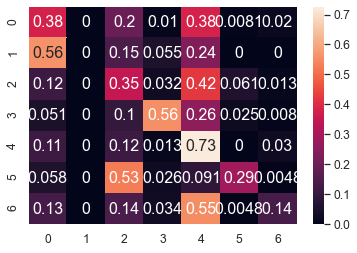

	training epoch=4 .. train_loss=1.345
	validation epoch=4 .. val_loss=1.474
	Accuracy = 41.8 % .. Percision = 44.6 % .. Recall = 34.9 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_4.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 5 .. loss = 1.336


  0%|                                                                                 | 1/1914 [00:01<37:50,  1.19s/it]

training @ epoch 5 .. loss = 1.433


  0%|                                                                                 | 2/1914 [00:02<37:28,  1.18s/it]

training @ epoch 5 .. loss = 1.223


  0%|▏                                                                                | 3/1914 [00:03<37:42,  1.18s/it]

training @ epoch 5 .. loss = 1.336


  0%|▏                                                                                | 4/1914 [00:04<37:29,  1.18s/it]

training @ epoch 5 .. loss = 1.201


  0%|▏                                                                                | 5/1914 [00:05<37:11,  1.17s/it]

training @ epoch 5 .. loss = 1.237


  0%|▎                                                                                | 6/1914 [00:07<37:20,  1.17s/it]

training @ epoch 5 .. loss = 1.542


  0%|▎                                                                                | 7/1914 [00:08<37:07,  1.17s/it]

training @ epoch 5 .. loss = 1.22


  0%|▎                                                                                | 8/1914 [00:09<37:08,  1.17s/it]

training @ epoch 5 .. loss = 1.171


  0%|▍                                                                                | 9/1914 [00:10<36:43,  1.16s/it]

training @ epoch 5 .. loss = 1.195


  1%|▍                                                                               | 10/1914 [00:11<37:07,  1.17s/it]

training @ epoch 5 .. loss = 1.569


  1%|▍                                                                               | 11/1914 [00:12<37:07,  1.17s/it]

training @ epoch 5 .. loss = 1.119


  1%|▌                                                                               | 12/1914 [00:14<36:51,  1.16s/it]

training @ epoch 5 .. loss = 1.073


  1%|▌                                                                               | 13/1914 [00:15<37:00,  1.17s/it]

training @ epoch 5 .. loss = 1.261


  1%|▌                                                                               | 14/1914 [00:16<36:49,  1.16s/it]

training @ epoch 5 .. loss = 1.019


  1%|▋                                                                               | 15/1914 [00:17<37:26,  1.18s/it]

training @ epoch 5 .. loss = 1.343


  1%|▋                                                                               | 16/1914 [00:18<37:02,  1.17s/it]

training @ epoch 5 .. loss = 1.577


  1%|▋                                                                               | 17/1914 [00:19<36:56,  1.17s/it]

training @ epoch 5 .. loss = 1.368


  1%|▊                                                                               | 18/1914 [00:21<36:57,  1.17s/it]

training @ epoch 5 .. loss = 1.602


  1%|▊                                                                               | 19/1914 [00:22<38:04,  1.21s/it]

training @ epoch 5 .. loss = 1.761


  1%|▊                                                                               | 20/1914 [00:23<38:21,  1.22s/it]

training @ epoch 5 .. loss = 1.22


  1%|▉                                                                               | 21/1914 [00:24<37:46,  1.20s/it]

training @ epoch 5 .. loss = 1.454


  1%|▉                                                                               | 22/1914 [00:25<37:16,  1.18s/it]

training @ epoch 5 .. loss = 1.186


  1%|▉                                                                               | 23/1914 [00:27<37:38,  1.19s/it]

training @ epoch 5 .. loss = 0.972


  1%|█                                                                               | 24/1914 [00:28<36:44,  1.17s/it]

training @ epoch 5 .. loss = 1.183


  1%|█                                                                               | 25/1914 [00:29<36:40,  1.16s/it]

training @ epoch 5 .. loss = 1.544


  1%|█                                                                               | 26/1914 [00:30<36:41,  1.17s/it]

training @ epoch 5 .. loss = 1.263


  1%|█▏                                                                              | 27/1914 [00:31<36:31,  1.16s/it]

training @ epoch 5 .. loss = 1.408


  1%|█▏                                                                              | 28/1914 [00:32<36:34,  1.16s/it]

training @ epoch 5 .. loss = 1.089


  2%|█▏                                                                              | 29/1914 [00:34<36:33,  1.16s/it]

training @ epoch 5 .. loss = 1.326


  2%|█▎                                                                              | 30/1914 [00:35<36:53,  1.17s/it]

training @ epoch 5 .. loss = 0.831


  2%|█▎                                                                              | 31/1914 [00:36<36:34,  1.17s/it]

training @ epoch 5 .. loss = 1.674


  2%|█▎                                                                              | 32/1914 [00:37<36:31,  1.16s/it]

training @ epoch 5 .. loss = 1.107


  2%|█▍                                                                              | 33/1914 [00:38<36:21,  1.16s/it]

training @ epoch 5 .. loss = 1.312


  2%|█▍                                                                              | 34/1914 [00:39<36:24,  1.16s/it]

training @ epoch 5 .. loss = 1.187


  2%|█▍                                                                              | 35/1914 [00:40<36:01,  1.15s/it]

training @ epoch 5 .. loss = 1.427


  2%|█▌                                                                              | 36/1914 [00:42<36:07,  1.15s/it]

training @ epoch 5 .. loss = 1.364


  2%|█▌                                                                              | 37/1914 [00:43<36:26,  1.16s/it]

training @ epoch 5 .. loss = 1.475


  2%|█▌                                                                              | 38/1914 [00:44<35:58,  1.15s/it]

training @ epoch 5 .. loss = 1.023


  2%|█▋                                                                              | 39/1914 [00:45<36:21,  1.16s/it]

training @ epoch 5 .. loss = 1.17


  2%|█▋                                                                              | 40/1914 [00:46<36:14,  1.16s/it]

training @ epoch 5 .. loss = 1.005


  2%|█▋                                                                              | 41/1914 [00:47<36:07,  1.16s/it]

training @ epoch 5 .. loss = 1.332


  2%|█▊                                                                              | 42/1914 [00:49<36:32,  1.17s/it]

training @ epoch 5 .. loss = 1.477


  2%|█▊                                                                              | 43/1914 [00:50<36:20,  1.17s/it]

training @ epoch 5 .. loss = 1.493


  2%|█▊                                                                              | 44/1914 [00:51<36:13,  1.16s/it]

training @ epoch 5 .. loss = 1.33


  2%|█▉                                                                              | 45/1914 [00:52<36:07,  1.16s/it]

training @ epoch 5 .. loss = 1.227


  2%|█▉                                                                              | 46/1914 [00:53<35:44,  1.15s/it]

training @ epoch 5 .. loss = 0.67


  2%|█▉                                                                              | 47/1914 [00:54<35:55,  1.15s/it]

training @ epoch 5 .. loss = 0.977


  3%|██                                                                              | 48/1914 [00:56<35:54,  1.15s/it]

training @ epoch 5 .. loss = 1.03


  3%|██                                                                              | 49/1914 [00:57<35:58,  1.16s/it]

training @ epoch 5 .. loss = 1.498


  3%|██                                                                              | 50/1914 [00:58<35:54,  1.16s/it]

training @ epoch 5 .. loss = 1.638


  3%|██▏                                                                             | 51/1914 [00:59<36:29,  1.18s/it]

training @ epoch 5 .. loss = 1.08


  3%|██▏                                                                             | 52/1914 [01:00<36:16,  1.17s/it]

training @ epoch 5 .. loss = 1.064


  3%|██▏                                                                             | 53/1914 [01:01<36:10,  1.17s/it]

training @ epoch 5 .. loss = 1.083


  3%|██▎                                                                             | 54/1914 [01:03<36:39,  1.18s/it]

training @ epoch 5 .. loss = 1.379


  3%|██▎                                                                             | 55/1914 [01:04<36:25,  1.18s/it]

training @ epoch 5 .. loss = 1.202


  3%|██▎                                                                             | 56/1914 [01:05<36:21,  1.17s/it]

training @ epoch 5 .. loss = 1.318


  3%|██▍                                                                             | 57/1914 [01:06<35:57,  1.16s/it]

training @ epoch 5 .. loss = 1.302


  3%|██▍                                                                             | 58/1914 [01:07<36:07,  1.17s/it]

training @ epoch 5 .. loss = 0.979


  3%|██▍                                                                             | 59/1914 [01:08<36:06,  1.17s/it]

training @ epoch 5 .. loss = 1.533


  3%|██▌                                                                             | 60/1914 [01:10<36:14,  1.17s/it]

training @ epoch 5 .. loss = 1.866


  3%|██▌                                                                             | 61/1914 [01:11<36:18,  1.18s/it]

training @ epoch 5 .. loss = 1.391


  3%|██▌                                                                             | 62/1914 [01:12<35:51,  1.16s/it]

training @ epoch 5 .. loss = 1.251


  3%|██▋                                                                             | 63/1914 [01:13<36:19,  1.18s/it]

training @ epoch 5 .. loss = 1.706


  3%|██▋                                                                             | 64/1914 [01:14<36:04,  1.17s/it]

training @ epoch 5 .. loss = 1.598


  3%|██▋                                                                             | 65/1914 [01:15<36:07,  1.17s/it]

training @ epoch 5 .. loss = 1.346


  3%|██▊                                                                             | 66/1914 [01:17<36:39,  1.19s/it]

training @ epoch 5 .. loss = 1.645


  4%|██▊                                                                             | 67/1914 [01:18<36:34,  1.19s/it]

training @ epoch 5 .. loss = 1.173


  4%|██▊                                                                             | 68/1914 [01:19<36:57,  1.20s/it]

training @ epoch 5 .. loss = 1.329


  4%|██▉                                                                             | 69/1914 [01:20<36:45,  1.20s/it]

training @ epoch 5 .. loss = 1.583


  4%|██▉                                                                             | 70/1914 [01:21<36:25,  1.19s/it]

training @ epoch 5 .. loss = 1.671


  4%|██▉                                                                             | 71/1914 [01:23<36:28,  1.19s/it]

training @ epoch 5 .. loss = 1.414


  4%|███                                                                             | 72/1914 [01:24<35:55,  1.17s/it]

training @ epoch 5 .. loss = 1.087


  4%|███                                                                             | 73/1914 [01:25<35:56,  1.17s/it]

training @ epoch 5 .. loss = 1.124


  4%|███                                                                             | 74/1914 [01:26<35:46,  1.17s/it]

training @ epoch 5 .. loss = 1.901


  4%|███▏                                                                            | 75/1914 [01:27<35:47,  1.17s/it]

training @ epoch 5 .. loss = 1.218


  4%|███▏                                                                            | 76/1914 [01:28<35:33,  1.16s/it]

training @ epoch 5 .. loss = 1.295


  4%|███▏                                                                            | 77/1914 [01:30<35:20,  1.15s/it]

training @ epoch 5 .. loss = 1.144


  4%|███▎                                                                            | 78/1914 [01:31<36:02,  1.18s/it]

training @ epoch 5 .. loss = 1.287


  4%|███▎                                                                            | 79/1914 [01:32<35:56,  1.18s/it]

training @ epoch 5 .. loss = 1.878


  4%|███▎                                                                            | 80/1914 [01:33<35:43,  1.17s/it]

training @ epoch 5 .. loss = 1.369


  4%|███▍                                                                            | 81/1914 [01:34<35:43,  1.17s/it]

training @ epoch 5 .. loss = 1.137


  4%|███▍                                                                            | 82/1914 [01:35<35:41,  1.17s/it]

training @ epoch 5 .. loss = 1.683


  4%|███▍                                                                            | 83/1914 [01:37<36:10,  1.19s/it]

training @ epoch 5 .. loss = 1.076


  4%|███▌                                                                            | 84/1914 [01:38<35:22,  1.16s/it]

training @ epoch 5 .. loss = 1.269


  4%|███▌                                                                            | 85/1914 [01:39<35:45,  1.17s/it]

training @ epoch 5 .. loss = 1.49


  4%|███▌                                                                            | 86/1914 [01:40<35:36,  1.17s/it]

training @ epoch 5 .. loss = 1.33


  5%|███▋                                                                            | 87/1914 [01:41<35:16,  1.16s/it]

training @ epoch 5 .. loss = 1.084


  5%|███▋                                                                            | 88/1914 [01:42<35:18,  1.16s/it]

training @ epoch 5 .. loss = 1.192


  5%|███▋                                                                            | 89/1914 [01:44<35:18,  1.16s/it]

training @ epoch 5 .. loss = 1.152


  5%|███▊                                                                            | 90/1914 [01:45<35:29,  1.17s/it]

training @ epoch 5 .. loss = 1.18


  5%|███▊                                                                            | 91/1914 [01:46<35:07,  1.16s/it]

training @ epoch 5 .. loss = 1.045


  5%|███▊                                                                            | 92/1914 [01:47<35:28,  1.17s/it]

training @ epoch 5 .. loss = 1.133


  5%|███▉                                                                            | 93/1914 [01:48<35:13,  1.16s/it]

training @ epoch 5 .. loss = 1.021


  5%|███▉                                                                            | 94/1914 [01:49<35:07,  1.16s/it]

training @ epoch 5 .. loss = 0.885


  5%|███▉                                                                            | 95/1914 [01:51<35:13,  1.16s/it]

training @ epoch 5 .. loss = 1.38


  5%|████                                                                            | 96/1914 [01:52<35:12,  1.16s/it]

training @ epoch 5 .. loss = 1.163


  5%|████                                                                            | 97/1914 [01:53<36:43,  1.21s/it]

training @ epoch 5 .. loss = 1.065


  5%|████                                                                            | 98/1914 [01:54<38:09,  1.26s/it]

training @ epoch 5 .. loss = 1.42


  5%|████▏                                                                           | 99/1914 [01:56<38:32,  1.27s/it]

training @ epoch 5 .. loss = 1.513


  5%|████▏                                                                          | 100/1914 [01:57<38:46,  1.28s/it]

training @ epoch 5 .. loss = 1.419


  5%|████▏                                                                          | 101/1914 [01:58<38:51,  1.29s/it]

training @ epoch 5 .. loss = 1.431


  5%|████▏                                                                          | 102/1914 [02:00<39:06,  1.29s/it]

training @ epoch 5 .. loss = 1.049


  5%|████▎                                                                          | 103/1914 [02:01<39:14,  1.30s/it]

training @ epoch 5 .. loss = 1.326


  5%|████▎                                                                          | 104/1914 [02:02<39:21,  1.30s/it]

training @ epoch 5 .. loss = 1.432


  5%|████▎                                                                          | 105/1914 [02:04<39:31,  1.31s/it]

training @ epoch 5 .. loss = 0.849


  6%|████▍                                                                          | 106/1914 [02:05<40:15,  1.34s/it]

training @ epoch 5 .. loss = 1.408


  6%|████▍                                                                          | 107/1914 [02:06<40:13,  1.34s/it]

training @ epoch 5 .. loss = 1.24


  6%|████▍                                                                          | 108/1914 [02:08<40:36,  1.35s/it]

training @ epoch 5 .. loss = 1.38


  6%|████▍                                                                          | 109/1914 [02:09<40:51,  1.36s/it]

training @ epoch 5 .. loss = 1.79


  6%|████▌                                                                          | 110/1914 [02:10<40:53,  1.36s/it]

training @ epoch 5 .. loss = 1.679


  6%|████▌                                                                          | 111/1914 [02:12<40:58,  1.36s/it]

training @ epoch 5 .. loss = 1.223


  6%|████▌                                                                          | 112/1914 [02:13<39:41,  1.32s/it]

training @ epoch 5 .. loss = 1.941


  6%|████▋                                                                          | 113/1914 [02:14<38:07,  1.27s/it]

training @ epoch 5 .. loss = 1.355


  6%|████▋                                                                          | 114/1914 [02:15<37:20,  1.24s/it]

training @ epoch 5 .. loss = 1.46


  6%|████▋                                                                          | 115/1914 [02:17<36:49,  1.23s/it]

training @ epoch 5 .. loss = 1.319


  6%|████▊                                                                          | 116/1914 [02:18<36:26,  1.22s/it]

training @ epoch 5 .. loss = 1.443


  6%|████▊                                                                          | 117/1914 [02:19<35:44,  1.19s/it]

training @ epoch 5 .. loss = 1.322


  6%|████▊                                                                          | 118/1914 [02:20<34:52,  1.16s/it]

training @ epoch 5 .. loss = 1.186


  6%|████▉                                                                          | 119/1914 [02:21<34:43,  1.16s/it]

training @ epoch 5 .. loss = 1.289


  6%|████▉                                                                          | 120/1914 [02:22<35:05,  1.17s/it]

training @ epoch 5 .. loss = 1.318


  6%|████▉                                                                          | 121/1914 [02:23<34:37,  1.16s/it]

training @ epoch 5 .. loss = 1.036


  6%|█████                                                                          | 122/1914 [02:25<34:54,  1.17s/it]

training @ epoch 5 .. loss = 1.102


  6%|█████                                                                          | 123/1914 [02:26<34:33,  1.16s/it]

training @ epoch 5 .. loss = 0.962


  6%|█████                                                                          | 124/1914 [02:27<35:00,  1.17s/it]

training @ epoch 5 .. loss = 1.266


  7%|█████▏                                                                         | 125/1914 [02:28<34:53,  1.17s/it]

training @ epoch 5 .. loss = 1.709


  7%|█████▏                                                                         | 126/1914 [02:29<34:40,  1.16s/it]

training @ epoch 5 .. loss = 1.407


  7%|█████▏                                                                         | 127/1914 [02:31<35:01,  1.18s/it]

training @ epoch 5 .. loss = 1.334


  7%|█████▎                                                                         | 128/1914 [02:32<34:50,  1.17s/it]

training @ epoch 5 .. loss = 1.167


  7%|█████▎                                                                         | 129/1914 [02:33<34:39,  1.17s/it]

training @ epoch 5 .. loss = 1.154


  7%|█████▎                                                                         | 130/1914 [02:34<34:42,  1.17s/it]

training @ epoch 5 .. loss = 1.368


  7%|█████▍                                                                         | 131/1914 [02:35<34:48,  1.17s/it]

training @ epoch 5 .. loss = 1.983


  7%|█████▍                                                                         | 132/1914 [02:36<34:52,  1.17s/it]

training @ epoch 5 .. loss = 1.128


  7%|█████▍                                                                         | 133/1914 [02:38<36:23,  1.23s/it]

training @ epoch 5 .. loss = 1.166


  7%|█████▌                                                                         | 134/1914 [02:39<37:14,  1.26s/it]

training @ epoch 5 .. loss = 0.857


  7%|█████▌                                                                         | 135/1914 [02:40<37:33,  1.27s/it]

training @ epoch 5 .. loss = 1.561


  7%|█████▌                                                                         | 136/1914 [02:42<37:41,  1.27s/it]

training @ epoch 5 .. loss = 1.28


  7%|█████▋                                                                         | 137/1914 [02:43<38:02,  1.28s/it]

training @ epoch 5 .. loss = 1.048


  7%|█████▋                                                                         | 138/1914 [02:44<37:55,  1.28s/it]

training @ epoch 5 .. loss = 1.29


  7%|█████▋                                                                         | 139/1914 [02:46<37:55,  1.28s/it]

training @ epoch 5 .. loss = 1.427


  7%|█████▊                                                                         | 140/1914 [02:47<38:00,  1.29s/it]

training @ epoch 5 .. loss = 1.123


  7%|█████▊                                                                         | 141/1914 [02:48<37:36,  1.27s/it]

training @ epoch 5 .. loss = 1.434


  7%|█████▊                                                                         | 142/1914 [02:49<37:52,  1.28s/it]

training @ epoch 5 .. loss = 1.382


  7%|█████▉                                                                         | 143/1914 [02:51<38:13,  1.29s/it]

training @ epoch 5 .. loss = 1.13


  8%|█████▉                                                                         | 144/1914 [02:52<37:54,  1.29s/it]

training @ epoch 5 .. loss = 1.226


  8%|█████▉                                                                         | 145/1914 [02:53<39:34,  1.34s/it]

training @ epoch 5 .. loss = 1.142


  8%|██████                                                                         | 146/1914 [02:55<40:26,  1.37s/it]

training @ epoch 5 .. loss = 1.437


  8%|██████                                                                         | 147/1914 [02:56<40:12,  1.37s/it]

training @ epoch 5 .. loss = 0.828


  8%|██████                                                                         | 148/1914 [02:58<40:00,  1.36s/it]

training @ epoch 5 .. loss = 1.357


  8%|██████▏                                                                        | 149/1914 [02:59<41:01,  1.39s/it]

training @ epoch 5 .. loss = 1.199


  8%|██████▏                                                                        | 150/1914 [03:00<40:44,  1.39s/it]

training @ epoch 5 .. loss = 1.527


  8%|██████▏                                                                        | 151/1914 [03:02<39:59,  1.36s/it]

training @ epoch 5 .. loss = 1.142


  8%|██████▎                                                                        | 152/1914 [03:03<39:59,  1.36s/it]

training @ epoch 5 .. loss = 1.179


  8%|██████▎                                                                        | 153/1914 [03:04<38:34,  1.31s/it]

training @ epoch 5 .. loss = 1.057


  8%|██████▎                                                                        | 154/1914 [03:05<37:00,  1.26s/it]

training @ epoch 5 .. loss = 1.069


  8%|██████▍                                                                        | 155/1914 [03:07<36:38,  1.25s/it]

training @ epoch 5 .. loss = 1.354


  8%|██████▍                                                                        | 156/1914 [03:08<35:23,  1.21s/it]

training @ epoch 5 .. loss = 1.364


  8%|██████▍                                                                        | 157/1914 [03:09<35:07,  1.20s/it]

training @ epoch 5 .. loss = 1.536


  8%|██████▌                                                                        | 158/1914 [03:10<34:49,  1.19s/it]

training @ epoch 5 .. loss = 1.348


  8%|██████▌                                                                        | 159/1914 [03:11<34:49,  1.19s/it]

training @ epoch 5 .. loss = 1.583


  8%|██████▌                                                                        | 160/1914 [03:12<34:49,  1.19s/it]

training @ epoch 5 .. loss = 1.53


  8%|██████▋                                                                        | 161/1914 [03:14<34:32,  1.18s/it]

training @ epoch 5 .. loss = 1.268


  8%|██████▋                                                                        | 162/1914 [03:15<34:17,  1.17s/it]

training @ epoch 5 .. loss = 1.552


  9%|██████▋                                                                        | 163/1914 [03:16<33:49,  1.16s/it]

training @ epoch 5 .. loss = 0.906


  9%|██████▊                                                                        | 164/1914 [03:17<34:13,  1.17s/it]

training @ epoch 5 .. loss = 1.035


  9%|██████▊                                                                        | 165/1914 [03:18<33:48,  1.16s/it]

training @ epoch 5 .. loss = 1.291


  9%|██████▊                                                                        | 166/1914 [03:19<33:59,  1.17s/it]

training @ epoch 5 .. loss = 1.318


  9%|██████▉                                                                        | 167/1914 [03:21<34:53,  1.20s/it]

training @ epoch 5 .. loss = 1.289


  9%|██████▉                                                                        | 168/1914 [03:22<34:21,  1.18s/it]

training @ epoch 5 .. loss = 1.532


  9%|██████▉                                                                        | 169/1914 [03:23<34:20,  1.18s/it]

training @ epoch 5 .. loss = 1.487


  9%|███████                                                                        | 170/1914 [03:24<33:51,  1.16s/it]

training @ epoch 5 .. loss = 1.312


  9%|███████                                                                        | 171/1914 [03:25<33:29,  1.15s/it]

training @ epoch 5 .. loss = 1.13


  9%|███████                                                                        | 172/1914 [03:26<33:26,  1.15s/it]

training @ epoch 5 .. loss = 1.379


  9%|███████▏                                                                       | 173/1914 [03:28<33:24,  1.15s/it]

training @ epoch 5 .. loss = 1.112


  9%|███████▏                                                                       | 174/1914 [03:29<33:35,  1.16s/it]

training @ epoch 5 .. loss = 1.048


  9%|███████▏                                                                       | 175/1914 [03:30<33:13,  1.15s/it]

training @ epoch 5 .. loss = 1.366


  9%|███████▎                                                                       | 176/1914 [03:31<33:25,  1.15s/it]

training @ epoch 5 .. loss = 0.97


  9%|███████▎                                                                       | 177/1914 [03:32<33:41,  1.16s/it]

training @ epoch 5 .. loss = 1.703


  9%|███████▎                                                                       | 178/1914 [03:33<33:46,  1.17s/it]

training @ epoch 5 .. loss = 1.141


  9%|███████▍                                                                       | 179/1914 [03:35<34:01,  1.18s/it]

training @ epoch 5 .. loss = 1.144


  9%|███████▍                                                                       | 180/1914 [03:36<33:52,  1.17s/it]

training @ epoch 5 .. loss = 1.142


  9%|███████▍                                                                       | 181/1914 [03:37<33:44,  1.17s/it]

training @ epoch 5 .. loss = 0.979


 10%|███████▌                                                                       | 182/1914 [03:38<33:54,  1.17s/it]

training @ epoch 5 .. loss = 1.287


 10%|███████▌                                                                       | 183/1914 [03:39<33:47,  1.17s/it]

training @ epoch 5 .. loss = 1.729


 10%|███████▌                                                                       | 184/1914 [03:40<34:02,  1.18s/it]

training @ epoch 5 .. loss = 1.159


 10%|███████▋                                                                       | 185/1914 [03:42<33:47,  1.17s/it]

training @ epoch 5 .. loss = 1.765


 10%|███████▋                                                                       | 186/1914 [03:43<33:48,  1.17s/it]

training @ epoch 5 .. loss = 1.353


 10%|███████▋                                                                       | 187/1914 [03:44<33:24,  1.16s/it]

training @ epoch 5 .. loss = 1.584


 10%|███████▊                                                                       | 188/1914 [03:45<33:35,  1.17s/it]

training @ epoch 5 .. loss = 1.491


 10%|███████▊                                                                       | 189/1914 [03:46<33:08,  1.15s/it]

training @ epoch 5 .. loss = 1.387


 10%|███████▊                                                                       | 190/1914 [03:47<33:10,  1.15s/it]

training @ epoch 5 .. loss = 1.697


 10%|███████▉                                                                       | 191/1914 [03:49<33:08,  1.15s/it]

training @ epoch 5 .. loss = 1.133


 10%|███████▉                                                                       | 192/1914 [03:50<33:06,  1.15s/it]

training @ epoch 5 .. loss = 1.092


 10%|███████▉                                                                       | 193/1914 [03:51<33:04,  1.15s/it]

training @ epoch 5 .. loss = 1.78


 10%|████████                                                                       | 194/1914 [03:52<33:13,  1.16s/it]

training @ epoch 5 .. loss = 1.131


 10%|████████                                                                       | 195/1914 [03:53<33:24,  1.17s/it]

training @ epoch 5 .. loss = 1.47


 10%|████████                                                                       | 196/1914 [03:54<33:31,  1.17s/it]

training @ epoch 5 .. loss = 1.605


 10%|████████▏                                                                      | 197/1914 [03:56<33:24,  1.17s/it]

training @ epoch 5 .. loss = 1.442


 10%|████████▏                                                                      | 198/1914 [03:57<33:31,  1.17s/it]

training @ epoch 5 .. loss = 1.767


 10%|████████▏                                                                      | 199/1914 [03:58<33:14,  1.16s/it]

training @ epoch 5 .. loss = 1.77


 10%|████████▎                                                                      | 200/1914 [03:59<36:29,  1.28s/it]

training @ epoch 5 .. loss = 1.465


 11%|████████▎                                                                      | 201/1914 [04:01<37:51,  1.33s/it]

training @ epoch 5 .. loss = 1.28


 11%|████████▎                                                                      | 202/1914 [04:02<36:47,  1.29s/it]

training @ epoch 5 .. loss = 1.459


 11%|████████▍                                                                      | 203/1914 [04:03<36:12,  1.27s/it]

training @ epoch 5 .. loss = 1.074


 11%|████████▍                                                                      | 204/1914 [04:04<35:38,  1.25s/it]

training @ epoch 5 .. loss = 1.082


 11%|████████▍                                                                      | 205/1914 [04:06<34:55,  1.23s/it]

training @ epoch 5 .. loss = 1.177


 11%|████████▌                                                                      | 206/1914 [04:07<34:32,  1.21s/it]

training @ epoch 5 .. loss = 1.636


 11%|████████▌                                                                      | 207/1914 [04:08<33:49,  1.19s/it]

training @ epoch 5 .. loss = 0.97


 11%|████████▌                                                                      | 208/1914 [04:09<33:51,  1.19s/it]

training @ epoch 5 .. loss = 1.633


 11%|████████▋                                                                      | 209/1914 [04:10<33:36,  1.18s/it]

training @ epoch 5 .. loss = 1.077


 11%|████████▋                                                                      | 210/1914 [04:11<33:28,  1.18s/it]

training @ epoch 5 .. loss = 1.888


 11%|████████▋                                                                      | 211/1914 [04:13<33:58,  1.20s/it]

training @ epoch 5 .. loss = 1.654


 11%|████████▊                                                                      | 212/1914 [04:14<33:33,  1.18s/it]

training @ epoch 5 .. loss = 1.058


 11%|████████▊                                                                      | 213/1914 [04:15<33:32,  1.18s/it]

training @ epoch 5 .. loss = 1.689


 11%|████████▊                                                                      | 214/1914 [04:16<33:15,  1.17s/it]

training @ epoch 5 .. loss = 1.309


 11%|████████▊                                                                      | 215/1914 [04:17<33:00,  1.17s/it]

training @ epoch 5 .. loss = 1.343


 11%|████████▉                                                                      | 216/1914 [04:19<33:18,  1.18s/it]

training @ epoch 5 .. loss = 1.201


 11%|████████▉                                                                      | 217/1914 [04:20<33:14,  1.18s/it]

training @ epoch 5 .. loss = 1.187


 11%|████████▉                                                                      | 218/1914 [04:21<33:22,  1.18s/it]

training @ epoch 5 .. loss = 1.689


 11%|█████████                                                                      | 219/1914 [04:22<33:12,  1.18s/it]

training @ epoch 5 .. loss = 1.446


 11%|█████████                                                                      | 220/1914 [04:23<33:09,  1.17s/it]

training @ epoch 5 .. loss = 0.99


 12%|█████████                                                                      | 221/1914 [04:24<33:01,  1.17s/it]

training @ epoch 5 .. loss = 0.938


 12%|█████████▏                                                                     | 222/1914 [04:26<33:06,  1.17s/it]

training @ epoch 5 .. loss = 1.436


 12%|█████████▏                                                                     | 223/1914 [04:27<33:30,  1.19s/it]

training @ epoch 5 .. loss = 0.938


 12%|█████████▏                                                                     | 224/1914 [04:28<33:15,  1.18s/it]

training @ epoch 5 .. loss = 1.269


 12%|█████████▎                                                                     | 225/1914 [04:29<33:10,  1.18s/it]

training @ epoch 5 .. loss = 1.607


 12%|█████████▎                                                                     | 226/1914 [04:30<32:54,  1.17s/it]

training @ epoch 5 .. loss = 1.182


 12%|█████████▎                                                                     | 227/1914 [04:31<32:29,  1.16s/it]

training @ epoch 5 .. loss = 1.357


 12%|█████████▍                                                                     | 228/1914 [04:33<33:06,  1.18s/it]

training @ epoch 5 .. loss = 1.266


 12%|█████████▍                                                                     | 229/1914 [04:34<32:53,  1.17s/it]

training @ epoch 5 .. loss = 1.383


 12%|█████████▍                                                                     | 230/1914 [04:35<33:06,  1.18s/it]

training @ epoch 5 .. loss = 1.145


 12%|█████████▌                                                                     | 231/1914 [04:36<32:41,  1.17s/it]

training @ epoch 5 .. loss = 1.184


 12%|█████████▌                                                                     | 232/1914 [04:37<32:28,  1.16s/it]

training @ epoch 5 .. loss = 1.136


 12%|█████████▌                                                                     | 233/1914 [04:38<32:28,  1.16s/it]

training @ epoch 5 .. loss = 1.606


 12%|█████████▋                                                                     | 234/1914 [04:40<32:33,  1.16s/it]

training @ epoch 5 .. loss = 1.153


 12%|█████████▋                                                                     | 235/1914 [04:41<32:34,  1.16s/it]

training @ epoch 5 .. loss = 1.34


 12%|█████████▋                                                                     | 236/1914 [04:42<32:59,  1.18s/it]

training @ epoch 5 .. loss = 1.168


 12%|█████████▊                                                                     | 237/1914 [04:43<32:50,  1.18s/it]

training @ epoch 5 .. loss = 1.673


 12%|█████████▊                                                                     | 238/1914 [04:44<32:45,  1.17s/it]

training @ epoch 5 .. loss = 1.193


 12%|█████████▊                                                                     | 239/1914 [04:46<32:50,  1.18s/it]

training @ epoch 5 .. loss = 1.427


 13%|█████████▉                                                                     | 240/1914 [04:47<32:57,  1.18s/it]

training @ epoch 5 .. loss = 1.474


 13%|█████████▉                                                                     | 241/1914 [04:48<32:44,  1.17s/it]

training @ epoch 5 .. loss = 1.323


 13%|█████████▉                                                                     | 242/1914 [04:49<33:02,  1.19s/it]

training @ epoch 5 .. loss = 1.352


 13%|██████████                                                                     | 243/1914 [04:50<32:59,  1.18s/it]

training @ epoch 5 .. loss = 1.269


 13%|██████████                                                                     | 244/1914 [04:51<32:41,  1.17s/it]

training @ epoch 5 .. loss = 1.341


 13%|██████████                                                                     | 245/1914 [04:53<32:59,  1.19s/it]

training @ epoch 5 .. loss = 1.38


 13%|██████████▏                                                                    | 246/1914 [04:54<32:35,  1.17s/it]

training @ epoch 5 .. loss = 1.398


 13%|██████████▏                                                                    | 247/1914 [04:55<32:33,  1.17s/it]

training @ epoch 5 .. loss = 1.664


 13%|██████████▏                                                                    | 248/1914 [04:56<32:21,  1.17s/it]

training @ epoch 5 .. loss = 1.29


 13%|██████████▎                                                                    | 249/1914 [04:57<32:38,  1.18s/it]

training @ epoch 5 .. loss = 1.194


 13%|██████████▎                                                                    | 250/1914 [04:59<33:10,  1.20s/it]

training @ epoch 5 .. loss = 1.295


 13%|██████████▎                                                                    | 251/1914 [05:00<32:51,  1.19s/it]

training @ epoch 5 .. loss = 1.307


 13%|██████████▍                                                                    | 252/1914 [05:01<32:53,  1.19s/it]

training @ epoch 5 .. loss = 0.798


 13%|██████████▍                                                                    | 253/1914 [05:02<32:44,  1.18s/it]

training @ epoch 5 .. loss = 1.224


 13%|██████████▍                                                                    | 254/1914 [05:03<32:28,  1.17s/it]

training @ epoch 5 .. loss = 1.251


 13%|██████████▌                                                                    | 255/1914 [05:04<32:31,  1.18s/it]

training @ epoch 5 .. loss = 1.146


 13%|██████████▌                                                                    | 256/1914 [05:06<32:07,  1.16s/it]

training @ epoch 5 .. loss = 1.252


 13%|██████████▌                                                                    | 257/1914 [05:07<32:11,  1.17s/it]

training @ epoch 5 .. loss = 1.054


 13%|██████████▋                                                                    | 258/1914 [05:08<32:08,  1.16s/it]

training @ epoch 5 .. loss = 0.814


 14%|██████████▋                                                                    | 259/1914 [05:09<32:39,  1.18s/it]

training @ epoch 5 .. loss = 1.896


 14%|██████████▋                                                                    | 260/1914 [05:10<32:33,  1.18s/it]

training @ epoch 5 .. loss = 1.376


 14%|██████████▊                                                                    | 261/1914 [05:11<32:04,  1.16s/it]

training @ epoch 5 .. loss = 1.108


 14%|██████████▊                                                                    | 262/1914 [05:13<32:43,  1.19s/it]

training @ epoch 5 .. loss = 1.294


 14%|██████████▊                                                                    | 263/1914 [05:14<31:59,  1.16s/it]

training @ epoch 5 .. loss = 1.48


 14%|██████████▉                                                                    | 264/1914 [05:15<32:22,  1.18s/it]

training @ epoch 5 .. loss = 1.629


 14%|██████████▉                                                                    | 265/1914 [05:16<31:53,  1.16s/it]

training @ epoch 5 .. loss = 1.265


 14%|██████████▉                                                                    | 266/1914 [05:17<31:52,  1.16s/it]

training @ epoch 5 .. loss = 1.382


 14%|███████████                                                                    | 267/1914 [05:18<31:56,  1.16s/it]

training @ epoch 5 .. loss = 1.19


 14%|███████████                                                                    | 268/1914 [05:20<32:11,  1.17s/it]

training @ epoch 5 .. loss = 1.556


 14%|███████████                                                                    | 269/1914 [05:21<32:20,  1.18s/it]

training @ epoch 5 .. loss = 1.365


 14%|███████████▏                                                                   | 270/1914 [05:22<32:20,  1.18s/it]

training @ epoch 5 .. loss = 1.055


 14%|███████████▏                                                                   | 271/1914 [05:23<32:30,  1.19s/it]

training @ epoch 5 .. loss = 1.018


 14%|███████████▏                                                                   | 272/1914 [05:24<32:12,  1.18s/it]

training @ epoch 5 .. loss = 1.951


 14%|███████████▎                                                                   | 273/1914 [05:26<32:03,  1.17s/it]

training @ epoch 5 .. loss = 1.153


 14%|███████████▎                                                                   | 274/1914 [05:27<32:22,  1.18s/it]

training @ epoch 5 .. loss = 1.716


 14%|███████████▎                                                                   | 275/1914 [05:28<31:55,  1.17s/it]

training @ epoch 5 .. loss = 1.147


 14%|███████████▍                                                                   | 276/1914 [05:29<32:11,  1.18s/it]

training @ epoch 5 .. loss = 1.555


 14%|███████████▍                                                                   | 277/1914 [05:30<32:45,  1.20s/it]

training @ epoch 5 .. loss = 1.353


 15%|███████████▍                                                                   | 278/1914 [05:32<37:33,  1.38s/it]

training @ epoch 5 .. loss = 1.405


 15%|███████████▌                                                                   | 279/1914 [05:34<38:17,  1.41s/it]

training @ epoch 5 .. loss = 2.076


 15%|███████████▌                                                                   | 280/1914 [05:35<36:30,  1.34s/it]

training @ epoch 5 .. loss = 1.092


 15%|███████████▌                                                                   | 281/1914 [05:36<34:51,  1.28s/it]

training @ epoch 5 .. loss = 1.106


 15%|███████████▋                                                                   | 282/1914 [05:37<34:47,  1.28s/it]

training @ epoch 5 .. loss = 1.618


 15%|███████████▋                                                                   | 283/1914 [05:38<33:43,  1.24s/it]

training @ epoch 5 .. loss = 1.513


 15%|███████████▋                                                                   | 284/1914 [05:39<33:03,  1.22s/it]

training @ epoch 5 .. loss = 1.508


 15%|███████████▊                                                                   | 285/1914 [05:41<33:05,  1.22s/it]

training @ epoch 5 .. loss = 1.36


 15%|███████████▊                                                                   | 286/1914 [05:42<32:36,  1.20s/it]

training @ epoch 5 .. loss = 1.321


 15%|███████████▊                                                                   | 287/1914 [05:43<33:00,  1.22s/it]

training @ epoch 5 .. loss = 1.49


 15%|███████████▉                                                                   | 288/1914 [05:44<33:01,  1.22s/it]

training @ epoch 5 .. loss = 1.598


 15%|███████████▉                                                                   | 289/1914 [05:45<32:11,  1.19s/it]

training @ epoch 5 .. loss = 1.211


 15%|███████████▉                                                                   | 290/1914 [05:47<32:28,  1.20s/it]

training @ epoch 5 .. loss = 1.34


 15%|████████████                                                                   | 291/1914 [05:48<32:27,  1.20s/it]

training @ epoch 5 .. loss = 1.355


 15%|████████████                                                                   | 292/1914 [05:49<32:28,  1.20s/it]

training @ epoch 5 .. loss = 1.516


 15%|████████████                                                                   | 293/1914 [05:50<32:13,  1.19s/it]

training @ epoch 5 .. loss = 1.118


 15%|████████████▏                                                                  | 294/1914 [05:51<32:05,  1.19s/it]

training @ epoch 5 .. loss = 1.362


 15%|████████████▏                                                                  | 295/1914 [05:53<32:19,  1.20s/it]

training @ epoch 5 .. loss = 1.92


 15%|████████████▏                                                                  | 296/1914 [05:54<31:56,  1.18s/it]

training @ epoch 5 .. loss = 1.274


 16%|████████████▎                                                                  | 297/1914 [05:55<32:08,  1.19s/it]

training @ epoch 5 .. loss = 1.435


 16%|████████████▎                                                                  | 298/1914 [05:56<32:12,  1.20s/it]

training @ epoch 5 .. loss = 1.325


 16%|████████████▎                                                                  | 299/1914 [05:57<31:58,  1.19s/it]

training @ epoch 5 .. loss = 1.246


 16%|████████████▍                                                                  | 300/1914 [05:59<32:05,  1.19s/it]

training @ epoch 5 .. loss = 1.339


 16%|████████████▍                                                                  | 301/1914 [06:00<31:43,  1.18s/it]

training @ epoch 5 .. loss = 1.548


 16%|████████████▍                                                                  | 302/1914 [06:01<31:34,  1.18s/it]

training @ epoch 5 .. loss = 1.161


 16%|████████████▌                                                                  | 303/1914 [06:02<31:21,  1.17s/it]

training @ epoch 5 .. loss = 1.33


 16%|████████████▌                                                                  | 304/1914 [06:03<31:08,  1.16s/it]

training @ epoch 5 .. loss = 1.098


 16%|████████████▌                                                                  | 305/1914 [06:04<31:12,  1.16s/it]

training @ epoch 5 .. loss = 1.203


 16%|████████████▋                                                                  | 306/1914 [06:06<31:10,  1.16s/it]

training @ epoch 5 .. loss = 1.427


 16%|████████████▋                                                                  | 307/1914 [06:07<31:33,  1.18s/it]

training @ epoch 5 .. loss = 1.483


 16%|████████████▋                                                                  | 308/1914 [06:08<31:20,  1.17s/it]

training @ epoch 5 .. loss = 0.989


 16%|████████████▊                                                                  | 309/1914 [06:09<31:31,  1.18s/it]

training @ epoch 5 .. loss = 1.058


 16%|████████████▊                                                                  | 310/1914 [06:10<31:38,  1.18s/it]

training @ epoch 5 .. loss = 1.024


 16%|████████████▊                                                                  | 311/1914 [06:11<31:13,  1.17s/it]

training @ epoch 5 .. loss = 0.763


 16%|████████████▉                                                                  | 312/1914 [06:13<31:33,  1.18s/it]

training @ epoch 5 .. loss = 1.553


 16%|████████████▉                                                                  | 313/1914 [06:14<31:08,  1.17s/it]

training @ epoch 5 .. loss = 1.552


 16%|████████████▉                                                                  | 314/1914 [06:15<31:14,  1.17s/it]

training @ epoch 5 .. loss = 1.518


 16%|█████████████                                                                  | 315/1914 [06:16<30:58,  1.16s/it]

training @ epoch 5 .. loss = 1.468


 17%|█████████████                                                                  | 316/1914 [06:17<31:02,  1.17s/it]

training @ epoch 5 .. loss = 1.013


 17%|█████████████                                                                  | 317/1914 [06:18<31:02,  1.17s/it]

training @ epoch 5 .. loss = 1.207


 17%|█████████████▏                                                                 | 318/1914 [06:20<30:59,  1.17s/it]

training @ epoch 5 .. loss = 0.986


 17%|█████████████▏                                                                 | 319/1914 [06:21<31:12,  1.17s/it]

training @ epoch 5 .. loss = 1.347


 17%|█████████████▏                                                                 | 320/1914 [06:22<31:25,  1.18s/it]

training @ epoch 5 .. loss = 1.03


 17%|█████████████▏                                                                 | 321/1914 [06:23<31:27,  1.19s/it]

training @ epoch 5 .. loss = 1.025


 17%|█████████████▎                                                                 | 322/1914 [06:24<31:01,  1.17s/it]

training @ epoch 5 .. loss = 1.047


 17%|█████████████▎                                                                 | 323/1914 [06:26<31:06,  1.17s/it]

training @ epoch 5 .. loss = 1.084


 17%|█████████████▎                                                                 | 324/1914 [06:27<31:15,  1.18s/it]

training @ epoch 5 .. loss = 1.061


 17%|█████████████▍                                                                 | 325/1914 [06:28<30:56,  1.17s/it]

training @ epoch 5 .. loss = 1.165


 17%|█████████████▍                                                                 | 326/1914 [06:29<31:01,  1.17s/it]

training @ epoch 5 .. loss = 1.408


 17%|█████████████▍                                                                 | 327/1914 [06:30<30:42,  1.16s/it]

training @ epoch 5 .. loss = 1.196


 17%|█████████████▌                                                                 | 328/1914 [06:31<30:37,  1.16s/it]

training @ epoch 5 .. loss = 1.165


 17%|█████████████▌                                                                 | 329/1914 [06:32<30:32,  1.16s/it]

training @ epoch 5 .. loss = 1.486


 17%|█████████████▌                                                                 | 330/1914 [06:34<30:19,  1.15s/it]

training @ epoch 5 .. loss = 1.352


 17%|█████████████▋                                                                 | 331/1914 [06:35<30:33,  1.16s/it]

training @ epoch 5 .. loss = 0.971


 17%|█████████████▋                                                                 | 332/1914 [06:36<30:15,  1.15s/it]

training @ epoch 5 .. loss = 1.318


 17%|█████████████▋                                                                 | 333/1914 [06:37<30:25,  1.15s/it]

training @ epoch 5 .. loss = 1.153


 17%|█████████████▊                                                                 | 334/1914 [06:38<30:32,  1.16s/it]

training @ epoch 5 .. loss = 1.284


 18%|█████████████▊                                                                 | 335/1914 [06:39<30:12,  1.15s/it]

training @ epoch 5 .. loss = 0.974


 18%|█████████████▊                                                                 | 336/1914 [06:41<30:38,  1.16s/it]

training @ epoch 5 .. loss = 1.349


 18%|█████████████▉                                                                 | 337/1914 [06:42<30:38,  1.17s/it]

training @ epoch 5 .. loss = 1.339


 18%|█████████████▉                                                                 | 338/1914 [06:43<30:39,  1.17s/it]

training @ epoch 5 .. loss = 1.166


 18%|█████████████▉                                                                 | 339/1914 [06:44<30:24,  1.16s/it]

training @ epoch 5 .. loss = 1.631


 18%|██████████████                                                                 | 340/1914 [06:45<30:24,  1.16s/it]

training @ epoch 5 .. loss = 1.107


 18%|██████████████                                                                 | 341/1914 [06:46<30:25,  1.16s/it]

training @ epoch 5 .. loss = 1.372


 18%|██████████████                                                                 | 342/1914 [06:48<30:35,  1.17s/it]

training @ epoch 5 .. loss = 1.312


 18%|██████████████▏                                                                | 343/1914 [06:49<30:46,  1.18s/it]

training @ epoch 5 .. loss = 1.347


 18%|██████████████▏                                                                | 344/1914 [06:50<30:33,  1.17s/it]

training @ epoch 5 .. loss = 1.316


 18%|██████████████▏                                                                | 345/1914 [06:51<30:44,  1.18s/it]

training @ epoch 5 .. loss = 1.115


 18%|██████████████▎                                                                | 346/1914 [06:52<30:26,  1.17s/it]

training @ epoch 5 .. loss = 1.901


 18%|██████████████▎                                                                | 347/1914 [06:53<30:18,  1.16s/it]

training @ epoch 5 .. loss = 1.593


 18%|██████████████▎                                                                | 348/1914 [06:55<31:26,  1.20s/it]

training @ epoch 5 .. loss = 1.549


 18%|██████████████▍                                                                | 349/1914 [06:56<33:08,  1.27s/it]

training @ epoch 5 .. loss = 1.313


 18%|██████████████▍                                                                | 350/1914 [06:57<33:04,  1.27s/it]

training @ epoch 5 .. loss = 1.378


 18%|██████████████▍                                                                | 351/1914 [06:59<33:43,  1.29s/it]

training @ epoch 5 .. loss = 1.164


 18%|██████████████▌                                                                | 352/1914 [07:00<32:50,  1.26s/it]

training @ epoch 5 .. loss = 1.574


 18%|██████████████▌                                                                | 353/1914 [07:01<32:02,  1.23s/it]

training @ epoch 5 .. loss = 1.128


 18%|██████████████▌                                                                | 354/1914 [07:02<31:06,  1.20s/it]

training @ epoch 5 .. loss = 1.319


 19%|██████████████▋                                                                | 355/1914 [07:03<30:46,  1.18s/it]

training @ epoch 5 .. loss = 1.077


 19%|██████████████▋                                                                | 356/1914 [07:05<30:32,  1.18s/it]

training @ epoch 5 .. loss = 1.54


 19%|██████████████▋                                                                | 357/1914 [07:06<30:03,  1.16s/it]

training @ epoch 5 .. loss = 0.959


 19%|██████████████▊                                                                | 358/1914 [07:07<30:27,  1.17s/it]

training @ epoch 5 .. loss = 1.221


 19%|██████████████▊                                                                | 359/1914 [07:08<30:14,  1.17s/it]

training @ epoch 5 .. loss = 1.367


 19%|██████████████▊                                                                | 360/1914 [07:09<30:25,  1.17s/it]

training @ epoch 5 .. loss = 1.345


 19%|██████████████▉                                                                | 361/1914 [07:10<30:13,  1.17s/it]

training @ epoch 5 .. loss = 1.321


 19%|██████████████▉                                                                | 362/1914 [07:11<29:59,  1.16s/it]

training @ epoch 5 .. loss = 1.177


 19%|██████████████▉                                                                | 363/1914 [07:13<30:17,  1.17s/it]

training @ epoch 5 .. loss = 1.086


 19%|███████████████                                                                | 364/1914 [07:14<30:20,  1.17s/it]

training @ epoch 5 .. loss = 1.549


 19%|███████████████                                                                | 365/1914 [07:15<30:28,  1.18s/it]

training @ epoch 5 .. loss = 1.704


 19%|███████████████                                                                | 366/1914 [07:16<30:04,  1.17s/it]

training @ epoch 5 .. loss = 1.805


 19%|███████████████▏                                                               | 367/1914 [07:17<30:05,  1.17s/it]

training @ epoch 5 .. loss = 1.313


 19%|███████████████▏                                                               | 368/1914 [07:19<30:20,  1.18s/it]

training @ epoch 5 .. loss = 1.069


 19%|███████████████▏                                                               | 369/1914 [07:20<30:07,  1.17s/it]

training @ epoch 5 .. loss = 1.176


 19%|███████████████▎                                                               | 370/1914 [07:21<31:08,  1.21s/it]

training @ epoch 5 .. loss = 1.018


 19%|███████████████▎                                                               | 371/1914 [07:22<30:25,  1.18s/it]

training @ epoch 5 .. loss = 1.239


 19%|███████████████▎                                                               | 372/1914 [07:23<31:21,  1.22s/it]

training @ epoch 5 .. loss = 1.024


 19%|███████████████▍                                                               | 373/1914 [07:25<32:31,  1.27s/it]

training @ epoch 5 .. loss = 1.208


 20%|███████████████▍                                                               | 374/1914 [07:26<32:42,  1.27s/it]

training @ epoch 5 .. loss = 1.196


 20%|███████████████▍                                                               | 375/1914 [07:27<32:36,  1.27s/it]

training @ epoch 5 .. loss = 1.238


 20%|███████████████▌                                                               | 376/1914 [07:29<32:45,  1.28s/it]

training @ epoch 5 .. loss = 1.183


 20%|███████████████▌                                                               | 377/1914 [07:30<32:42,  1.28s/it]

training @ epoch 5 .. loss = 1.157


 20%|███████████████▌                                                               | 378/1914 [07:31<32:25,  1.27s/it]

training @ epoch 5 .. loss = 1.478


 20%|███████████████▋                                                               | 379/1914 [07:32<32:31,  1.27s/it]

training @ epoch 5 .. loss = 1.288


 20%|███████████████▋                                                               | 380/1914 [07:34<32:54,  1.29s/it]

training @ epoch 5 .. loss = 1.28


 20%|███████████████▋                                                               | 381/1914 [07:35<33:01,  1.29s/it]

training @ epoch 5 .. loss = 0.919


 20%|███████████████▊                                                               | 382/1914 [07:36<32:51,  1.29s/it]

training @ epoch 5 .. loss = 1.271


 20%|███████████████▊                                                               | 383/1914 [07:38<33:02,  1.29s/it]

training @ epoch 5 .. loss = 1.524


 20%|███████████████▊                                                               | 384/1914 [07:39<33:18,  1.31s/it]

training @ epoch 5 .. loss = 0.958


 20%|███████████████▉                                                               | 385/1914 [07:40<32:48,  1.29s/it]

training @ epoch 5 .. loss = 1.444


 20%|███████████████▉                                                               | 386/1914 [07:42<32:45,  1.29s/it]

training @ epoch 5 .. loss = 1.162


 20%|███████████████▉                                                               | 387/1914 [07:43<33:10,  1.30s/it]

training @ epoch 5 .. loss = 0.907


 20%|████████████████                                                               | 388/1914 [07:44<32:55,  1.29s/it]

training @ epoch 5 .. loss = 1.235


 20%|████████████████                                                               | 389/1914 [07:45<32:49,  1.29s/it]

training @ epoch 5 .. loss = 1.361


 20%|████████████████                                                               | 390/1914 [07:47<33:07,  1.30s/it]

training @ epoch 5 .. loss = 1.299


 20%|████████████████▏                                                              | 391/1914 [07:48<33:10,  1.31s/it]

training @ epoch 5 .. loss = 1.202


 20%|████████████████▏                                                              | 392/1914 [07:49<32:35,  1.28s/it]

training @ epoch 5 .. loss = 1.244


 21%|████████████████▏                                                              | 393/1914 [07:51<31:51,  1.26s/it]

training @ epoch 5 .. loss = 1.165


 21%|████████████████▎                                                              | 394/1914 [07:52<31:15,  1.23s/it]

training @ epoch 5 .. loss = 1.432


 21%|████████████████▎                                                              | 395/1914 [07:53<30:55,  1.22s/it]

training @ epoch 5 .. loss = 1.467


 21%|████████████████▎                                                              | 396/1914 [07:54<30:18,  1.20s/it]

training @ epoch 5 .. loss = 1.868


 21%|████████████████▍                                                              | 397/1914 [07:55<30:09,  1.19s/it]

training @ epoch 5 .. loss = 1.149


 21%|████████████████▍                                                              | 398/1914 [07:56<30:08,  1.19s/it]

training @ epoch 5 .. loss = 1.378


 21%|████████████████▍                                                              | 399/1914 [07:58<29:47,  1.18s/it]

training @ epoch 5 .. loss = 1.71


 21%|████████████████▌                                                              | 400/1914 [07:59<29:56,  1.19s/it]

training @ epoch 5 .. loss = 1.72


 21%|████████████████▌                                                              | 401/1914 [08:00<29:34,  1.17s/it]

training @ epoch 5 .. loss = 1.043


 21%|████████████████▌                                                              | 402/1914 [08:01<29:37,  1.18s/it]

training @ epoch 5 .. loss = 1.155


 21%|████████████████▋                                                              | 403/1914 [08:02<29:11,  1.16s/it]

training @ epoch 5 .. loss = 1.277


 21%|████████████████▋                                                              | 404/1914 [08:03<28:51,  1.15s/it]

training @ epoch 5 .. loss = 1.592


 21%|████████████████▋                                                              | 405/1914 [08:04<28:52,  1.15s/it]

training @ epoch 5 .. loss = 1.253


 21%|████████████████▊                                                              | 406/1914 [08:06<29:05,  1.16s/it]

training @ epoch 5 .. loss = 1.264


 21%|████████████████▊                                                              | 407/1914 [08:07<29:21,  1.17s/it]

training @ epoch 5 .. loss = 1.215


 21%|████████████████▊                                                              | 408/1914 [08:08<29:01,  1.16s/it]

training @ epoch 5 .. loss = 1.132


 21%|████████████████▉                                                              | 409/1914 [08:09<28:58,  1.15s/it]

training @ epoch 5 .. loss = 1.671


 21%|████████████████▉                                                              | 410/1914 [08:10<28:50,  1.15s/it]

training @ epoch 5 .. loss = 1.429


 21%|████████████████▉                                                              | 411/1914 [08:11<28:54,  1.15s/it]

training @ epoch 5 .. loss = 1.693


 22%|█████████████████                                                              | 412/1914 [08:13<29:09,  1.17s/it]

training @ epoch 5 .. loss = 1.186


 22%|█████████████████                                                              | 413/1914 [08:14<29:16,  1.17s/it]

training @ epoch 5 .. loss = 1.266


 22%|█████████████████                                                              | 414/1914 [08:15<29:15,  1.17s/it]

training @ epoch 5 .. loss = 0.864


 22%|█████████████████▏                                                             | 415/1914 [08:16<29:02,  1.16s/it]

training @ epoch 5 .. loss = 1.355


 22%|█████████████████▏                                                             | 416/1914 [08:17<29:04,  1.16s/it]

training @ epoch 5 .. loss = 1.271


 22%|█████████████████▏                                                             | 417/1914 [08:18<29:07,  1.17s/it]

training @ epoch 5 .. loss = 0.929


 22%|█████████████████▎                                                             | 418/1914 [08:20<28:54,  1.16s/it]

training @ epoch 5 .. loss = 1.574


 22%|█████████████████▎                                                             | 419/1914 [08:21<29:08,  1.17s/it]

training @ epoch 5 .. loss = 1.415


 22%|█████████████████▎                                                             | 420/1914 [08:22<29:31,  1.19s/it]

training @ epoch 5 .. loss = 1.153


 22%|█████████████████▍                                                             | 421/1914 [08:23<29:19,  1.18s/it]

training @ epoch 5 .. loss = 1.429


 22%|█████████████████▍                                                             | 422/1914 [08:24<29:10,  1.17s/it]

training @ epoch 5 .. loss = 1.138


 22%|█████████████████▍                                                             | 423/1914 [08:25<28:42,  1.16s/it]

training @ epoch 5 .. loss = 1.416


 22%|█████████████████▌                                                             | 424/1914 [08:27<28:39,  1.15s/it]

training @ epoch 5 .. loss = 1.196


 22%|█████████████████▌                                                             | 425/1914 [08:28<28:42,  1.16s/it]

training @ epoch 5 .. loss = 1.247


 22%|█████████████████▌                                                             | 426/1914 [08:29<28:47,  1.16s/it]

training @ epoch 5 .. loss = 1.659


 22%|█████████████████▌                                                             | 427/1914 [08:30<28:20,  1.14s/it]

training @ epoch 5 .. loss = 1.755


 22%|█████████████████▋                                                             | 428/1914 [08:31<28:18,  1.14s/it]

training @ epoch 5 .. loss = 1.006


 22%|█████████████████▋                                                             | 429/1914 [08:32<28:45,  1.16s/it]

training @ epoch 5 .. loss = 1.63


 22%|█████████████████▋                                                             | 430/1914 [08:34<28:28,  1.15s/it]

training @ epoch 5 .. loss = 1.527


 23%|█████████████████▊                                                             | 431/1914 [08:35<29:01,  1.17s/it]

training @ epoch 5 .. loss = 1.116


 23%|█████████████████▊                                                             | 432/1914 [08:36<28:43,  1.16s/it]

training @ epoch 5 .. loss = 1.202


 23%|█████████████████▊                                                             | 433/1914 [08:37<28:51,  1.17s/it]

training @ epoch 5 .. loss = 1.074


 23%|█████████████████▉                                                             | 434/1914 [08:38<28:14,  1.14s/it]

training @ epoch 5 .. loss = 1.506


 23%|█████████████████▉                                                             | 435/1914 [08:39<28:18,  1.15s/it]

training @ epoch 5 .. loss = 1.363


 23%|█████████████████▉                                                             | 436/1914 [08:40<28:17,  1.15s/it]

training @ epoch 5 .. loss = 1.485


 23%|██████████████████                                                             | 437/1914 [08:42<28:14,  1.15s/it]

training @ epoch 5 .. loss = 1.675


 23%|██████████████████                                                             | 438/1914 [08:43<28:33,  1.16s/it]

training @ epoch 5 .. loss = 1.187


 23%|██████████████████                                                             | 439/1914 [08:44<28:14,  1.15s/it]

training @ epoch 5 .. loss = 1.316


 23%|██████████████████▏                                                            | 440/1914 [08:45<28:28,  1.16s/it]

training @ epoch 5 .. loss = 1.32


 23%|██████████████████▏                                                            | 441/1914 [08:46<28:18,  1.15s/it]

training @ epoch 5 .. loss = 1.432


 23%|██████████████████▏                                                            | 442/1914 [08:48<29:48,  1.21s/it]

training @ epoch 5 .. loss = 1.319


 23%|██████████████████▎                                                            | 443/1914 [08:49<31:54,  1.30s/it]

training @ epoch 5 .. loss = 0.977


 23%|██████████████████▎                                                            | 444/1914 [08:50<31:00,  1.27s/it]

training @ epoch 5 .. loss = 1.175


 23%|██████████████████▎                                                            | 445/1914 [08:51<30:17,  1.24s/it]

training @ epoch 5 .. loss = 1.418


 23%|██████████████████▍                                                            | 446/1914 [08:53<29:43,  1.21s/it]

training @ epoch 5 .. loss = 1.424


 23%|██████████████████▍                                                            | 447/1914 [08:54<29:05,  1.19s/it]

training @ epoch 5 .. loss = 1.335


 23%|██████████████████▍                                                            | 448/1914 [08:55<29:05,  1.19s/it]

training @ epoch 5 .. loss = 1.403


 23%|██████████████████▌                                                            | 449/1914 [08:56<28:41,  1.18s/it]

training @ epoch 5 .. loss = 1.305


 24%|██████████████████▌                                                            | 450/1914 [08:57<28:21,  1.16s/it]

training @ epoch 5 .. loss = 1.404


 24%|██████████████████▌                                                            | 451/1914 [08:58<28:25,  1.17s/it]

training @ epoch 5 .. loss = 1.421


 24%|██████████████████▋                                                            | 452/1914 [09:00<28:41,  1.18s/it]

training @ epoch 5 .. loss = 1.23


 24%|██████████████████▋                                                            | 453/1914 [09:01<29:03,  1.19s/it]

training @ epoch 5 .. loss = 1.658


 24%|██████████████████▋                                                            | 454/1914 [09:02<28:50,  1.18s/it]

training @ epoch 5 .. loss = 1.625


 24%|██████████████████▊                                                            | 455/1914 [09:03<28:32,  1.17s/it]

training @ epoch 5 .. loss = 0.963


 24%|██████████████████▊                                                            | 456/1914 [09:04<28:05,  1.16s/it]

training @ epoch 5 .. loss = 1.344


 24%|██████████████████▊                                                            | 457/1914 [09:05<27:52,  1.15s/it]

training @ epoch 5 .. loss = 1.334


 24%|██████████████████▉                                                            | 458/1914 [09:07<27:54,  1.15s/it]

training @ epoch 5 .. loss = 1.009


 24%|██████████████████▉                                                            | 459/1914 [09:08<27:53,  1.15s/it]

training @ epoch 5 .. loss = 1.181


 24%|██████████████████▉                                                            | 460/1914 [09:09<27:56,  1.15s/it]

training @ epoch 5 .. loss = 1.21


 24%|███████████████████                                                            | 461/1914 [09:10<27:55,  1.15s/it]

training @ epoch 5 .. loss = 1.328


 24%|███████████████████                                                            | 462/1914 [09:11<27:49,  1.15s/it]

training @ epoch 5 .. loss = 1.614


 24%|███████████████████                                                            | 463/1914 [09:12<27:49,  1.15s/it]

training @ epoch 5 .. loss = 1.079


 24%|███████████████████▏                                                           | 464/1914 [09:13<27:53,  1.15s/it]

training @ epoch 5 .. loss = 1.632


 24%|███████████████████▏                                                           | 465/1914 [09:15<28:22,  1.17s/it]

training @ epoch 5 .. loss = 1.772


 24%|███████████████████▏                                                           | 466/1914 [09:16<28:31,  1.18s/it]

training @ epoch 5 .. loss = 0.854


 24%|███████████████████▎                                                           | 467/1914 [09:17<28:13,  1.17s/it]

training @ epoch 5 .. loss = 0.9


 24%|███████████████████▎                                                           | 468/1914 [09:18<28:13,  1.17s/it]

training @ epoch 5 .. loss = 0.953


 25%|███████████████████▎                                                           | 469/1914 [09:19<28:03,  1.17s/it]

training @ epoch 5 .. loss = 1.131


 25%|███████████████████▍                                                           | 470/1914 [09:20<27:59,  1.16s/it]

training @ epoch 5 .. loss = 1.489


 25%|███████████████████▍                                                           | 471/1914 [09:22<28:12,  1.17s/it]

training @ epoch 5 .. loss = 1.386


 25%|███████████████████▍                                                           | 472/1914 [09:23<28:40,  1.19s/it]

training @ epoch 5 .. loss = 1.059


 25%|███████████████████▌                                                           | 473/1914 [09:24<28:17,  1.18s/it]

training @ epoch 5 .. loss = 1.213


 25%|███████████████████▌                                                           | 474/1914 [09:25<28:00,  1.17s/it]

training @ epoch 5 .. loss = 1.272


 25%|███████████████████▌                                                           | 475/1914 [09:26<27:53,  1.16s/it]

training @ epoch 5 .. loss = 1.517


 25%|███████████████████▋                                                           | 476/1914 [09:28<27:53,  1.16s/it]

training @ epoch 5 .. loss = 0.926


 25%|███████████████████▋                                                           | 477/1914 [09:29<28:27,  1.19s/it]

training @ epoch 5 .. loss = 1.225


 25%|███████████████████▋                                                           | 478/1914 [09:30<28:10,  1.18s/it]

training @ epoch 5 .. loss = 1.115


 25%|███████████████████▊                                                           | 479/1914 [09:31<28:06,  1.18s/it]

training @ epoch 5 .. loss = 1.048


 25%|███████████████████▊                                                           | 480/1914 [09:32<28:21,  1.19s/it]

training @ epoch 5 .. loss = 1.479


 25%|███████████████████▊                                                           | 481/1914 [09:33<28:17,  1.18s/it]

training @ epoch 5 .. loss = 1.654


 25%|███████████████████▉                                                           | 482/1914 [09:35<28:25,  1.19s/it]

training @ epoch 5 .. loss = 0.904


 25%|███████████████████▉                                                           | 483/1914 [09:36<28:10,  1.18s/it]

training @ epoch 5 .. loss = 1.049


 25%|███████████████████▉                                                           | 484/1914 [09:37<28:02,  1.18s/it]

training @ epoch 5 .. loss = 0.954


 25%|████████████████████                                                           | 485/1914 [09:38<27:47,  1.17s/it]

training @ epoch 5 .. loss = 2.244


 25%|████████████████████                                                           | 486/1914 [09:39<27:39,  1.16s/it]

training @ epoch 5 .. loss = 1.235


 25%|████████████████████                                                           | 487/1914 [09:40<27:34,  1.16s/it]

training @ epoch 5 .. loss = 0.976


 25%|████████████████████▏                                                          | 488/1914 [09:42<27:37,  1.16s/it]

training @ epoch 5 .. loss = 1.408


 26%|████████████████████▏                                                          | 489/1914 [09:43<27:58,  1.18s/it]

training @ epoch 5 .. loss = 1.555


 26%|████████████████████▏                                                          | 490/1914 [09:44<27:46,  1.17s/it]

training @ epoch 5 .. loss = 1.404


 26%|████████████████████▎                                                          | 491/1914 [09:45<28:30,  1.20s/it]

training @ epoch 5 .. loss = 0.995


 26%|████████████████████▎                                                          | 492/1914 [09:47<29:16,  1.24s/it]

training @ epoch 5 .. loss = 1.069


 26%|████████████████████▎                                                          | 493/1914 [09:48<29:29,  1.25s/it]

training @ epoch 5 .. loss = 1.19


 26%|████████████████████▍                                                          | 494/1914 [09:49<29:01,  1.23s/it]

training @ epoch 5 .. loss = 0.895


 26%|████████████████████▍                                                          | 495/1914 [09:50<28:29,  1.20s/it]

training @ epoch 5 .. loss = 1.18


 26%|████████████████████▍                                                          | 496/1914 [09:51<28:05,  1.19s/it]

training @ epoch 5 .. loss = 1.154


 26%|████████████████████▌                                                          | 497/1914 [09:53<28:01,  1.19s/it]

training @ epoch 5 .. loss = 0.908


 26%|████████████████████▌                                                          | 498/1914 [09:54<27:49,  1.18s/it]

training @ epoch 5 .. loss = 1.207


 26%|████████████████████▌                                                          | 499/1914 [09:55<27:50,  1.18s/it]

training @ epoch 5 .. loss = 1.489


 26%|████████████████████▋                                                          | 500/1914 [09:56<27:32,  1.17s/it]

training @ epoch 5 .. loss = 1.427


 26%|████████████████████▋                                                          | 501/1914 [09:57<27:31,  1.17s/it]

training @ epoch 5 .. loss = 0.84


 26%|████████████████████▋                                                          | 502/1914 [09:58<27:19,  1.16s/it]

training @ epoch 5 .. loss = 1.099


 26%|████████████████████▊                                                          | 503/1914 [09:59<27:14,  1.16s/it]

training @ epoch 5 .. loss = 0.889


 26%|████████████████████▊                                                          | 504/1914 [10:01<27:32,  1.17s/it]

training @ epoch 5 .. loss = 1.367


 26%|████████████████████▊                                                          | 505/1914 [10:02<27:18,  1.16s/it]

training @ epoch 5 .. loss = 1.245


 26%|████████████████████▉                                                          | 506/1914 [10:03<27:25,  1.17s/it]

training @ epoch 5 .. loss = 0.928


 26%|████████████████████▉                                                          | 507/1914 [10:04<27:09,  1.16s/it]

training @ epoch 5 .. loss = 1.065


 27%|████████████████████▉                                                          | 508/1914 [10:05<27:17,  1.16s/it]

training @ epoch 5 .. loss = 1.511


 27%|█████████████████████                                                          | 509/1914 [10:06<27:15,  1.16s/it]

training @ epoch 5 .. loss = 1.048


 27%|█████████████████████                                                          | 510/1914 [10:08<27:18,  1.17s/it]

training @ epoch 5 .. loss = 0.938


 27%|█████████████████████                                                          | 511/1914 [10:09<27:23,  1.17s/it]

training @ epoch 5 .. loss = 0.946


 27%|█████████████████████▏                                                         | 512/1914 [10:10<27:00,  1.16s/it]

training @ epoch 5 .. loss = 1.272


 27%|█████████████████████▏                                                         | 513/1914 [10:11<27:13,  1.17s/it]

training @ epoch 5 .. loss = 1.245


 27%|█████████████████████▏                                                         | 514/1914 [10:12<27:22,  1.17s/it]

training @ epoch 5 .. loss = 1.492


 27%|█████████████████████▎                                                         | 515/1914 [10:14<27:25,  1.18s/it]

training @ epoch 5 .. loss = 1.595


 27%|█████████████████████▎                                                         | 516/1914 [10:15<27:39,  1.19s/it]

training @ epoch 5 .. loss = 1.031


 27%|█████████████████████▎                                                         | 517/1914 [10:16<27:15,  1.17s/it]

training @ epoch 5 .. loss = 1.262


 27%|█████████████████████▍                                                         | 518/1914 [10:17<27:10,  1.17s/it]

training @ epoch 5 .. loss = 1.484


 27%|█████████████████████▍                                                         | 519/1914 [10:18<27:11,  1.17s/it]

training @ epoch 5 .. loss = 1.912


 27%|█████████████████████▍                                                         | 520/1914 [10:19<27:02,  1.16s/it]

training @ epoch 5 .. loss = 1.165


 27%|█████████████████████▌                                                         | 521/1914 [10:20<26:51,  1.16s/it]

training @ epoch 5 .. loss = 1.469


 27%|█████████████████████▌                                                         | 522/1914 [10:22<26:48,  1.16s/it]

training @ epoch 5 .. loss = 1.365


 27%|█████████████████████▌                                                         | 523/1914 [10:23<27:20,  1.18s/it]

training @ epoch 5 .. loss = 1.349


 27%|█████████████████████▋                                                         | 524/1914 [10:24<27:16,  1.18s/it]

training @ epoch 5 .. loss = 0.936


 27%|█████████████████████▋                                                         | 525/1914 [10:25<26:59,  1.17s/it]

training @ epoch 5 .. loss = 1.721


 27%|█████████████████████▋                                                         | 526/1914 [10:26<26:53,  1.16s/it]

training @ epoch 5 .. loss = 1.25


 28%|█████████████████████▊                                                         | 527/1914 [10:27<26:36,  1.15s/it]

training @ epoch 5 .. loss = 1.292


 28%|█████████████████████▊                                                         | 528/1914 [10:29<27:04,  1.17s/it]

training @ epoch 5 .. loss = 1.128


 28%|█████████████████████▊                                                         | 529/1914 [10:30<26:54,  1.17s/it]

training @ epoch 5 .. loss = 1.715


 28%|█████████████████████▉                                                         | 530/1914 [10:31<27:01,  1.17s/it]

training @ epoch 5 .. loss = 1.063


 28%|█████████████████████▉                                                         | 531/1914 [10:32<26:34,  1.15s/it]

training @ epoch 5 .. loss = 1.637


 28%|█████████████████████▉                                                         | 532/1914 [10:33<26:37,  1.16s/it]

training @ epoch 5 .. loss = 1.178


 28%|█████████████████████▉                                                         | 533/1914 [10:34<26:19,  1.14s/it]

training @ epoch 5 .. loss = 1.323


 28%|██████████████████████                                                         | 534/1914 [10:36<26:25,  1.15s/it]

training @ epoch 5 .. loss = 1.061


 28%|██████████████████████                                                         | 535/1914 [10:37<26:46,  1.17s/it]

training @ epoch 5 .. loss = 1.147


 28%|██████████████████████                                                         | 536/1914 [10:38<26:40,  1.16s/it]

training @ epoch 5 .. loss = 1.128


 28%|██████████████████████▏                                                        | 537/1914 [10:39<26:27,  1.15s/it]

training @ epoch 5 .. loss = 1.333


 28%|██████████████████████▏                                                        | 538/1914 [10:40<26:12,  1.14s/it]

training @ epoch 5 .. loss = 1.282


 28%|██████████████████████▏                                                        | 539/1914 [10:41<26:11,  1.14s/it]

training @ epoch 5 .. loss = 1.267


 28%|██████████████████████▎                                                        | 540/1914 [10:42<26:18,  1.15s/it]

training @ epoch 5 .. loss = 0.632


 28%|██████████████████████▎                                                        | 541/1914 [10:44<26:26,  1.16s/it]

training @ epoch 5 .. loss = 1.33


 28%|██████████████████████▎                                                        | 542/1914 [10:45<26:24,  1.15s/it]

training @ epoch 5 .. loss = 1.32


 28%|██████████████████████▍                                                        | 543/1914 [10:46<26:09,  1.14s/it]

training @ epoch 5 .. loss = 1.031


 28%|██████████████████████▍                                                        | 544/1914 [10:47<26:13,  1.15s/it]

training @ epoch 5 .. loss = 1.778


 28%|██████████████████████▍                                                        | 545/1914 [10:48<26:12,  1.15s/it]

training @ epoch 5 .. loss = 1.295


 29%|██████████████████████▌                                                        | 546/1914 [10:49<26:04,  1.14s/it]

training @ epoch 5 .. loss = 1.064


 29%|██████████████████████▌                                                        | 547/1914 [10:51<26:31,  1.16s/it]

training @ epoch 5 .. loss = 1.207


 29%|██████████████████████▌                                                        | 548/1914 [10:52<26:21,  1.16s/it]

training @ epoch 5 .. loss = 1.149


 29%|██████████████████████▋                                                        | 549/1914 [10:53<26:33,  1.17s/it]

training @ epoch 5 .. loss = 1.65


 29%|██████████████████████▋                                                        | 550/1914 [10:54<26:26,  1.16s/it]

training @ epoch 5 .. loss = 1.589


 29%|██████████████████████▋                                                        | 551/1914 [10:55<26:32,  1.17s/it]

training @ epoch 5 .. loss = 1.433


 29%|██████████████████████▊                                                        | 552/1914 [10:56<26:30,  1.17s/it]

training @ epoch 5 .. loss = 0.78


 29%|██████████████████████▊                                                        | 553/1914 [10:58<26:15,  1.16s/it]

training @ epoch 5 .. loss = 1.305


 29%|██████████████████████▊                                                        | 554/1914 [10:59<26:31,  1.17s/it]

training @ epoch 5 .. loss = 1.243


 29%|██████████████████████▉                                                        | 555/1914 [11:00<26:06,  1.15s/it]

training @ epoch 5 .. loss = 1.302


 29%|██████████████████████▉                                                        | 556/1914 [11:01<26:10,  1.16s/it]

training @ epoch 5 .. loss = 1.243


 29%|██████████████████████▉                                                        | 557/1914 [11:02<26:19,  1.16s/it]

training @ epoch 5 .. loss = 1.354


 29%|███████████████████████                                                        | 558/1914 [11:03<26:03,  1.15s/it]

training @ epoch 5 .. loss = 1.674


 29%|███████████████████████                                                        | 559/1914 [11:04<26:03,  1.15s/it]

training @ epoch 5 .. loss = 1.26


 29%|███████████████████████                                                        | 560/1914 [11:06<26:03,  1.16s/it]

training @ epoch 5 .. loss = 1.293


 29%|███████████████████████▏                                                       | 561/1914 [11:07<26:20,  1.17s/it]

training @ epoch 5 .. loss = 2.065


 29%|███████████████████████▏                                                       | 562/1914 [11:08<26:08,  1.16s/it]

training @ epoch 5 .. loss = 1.539


 29%|███████████████████████▏                                                       | 563/1914 [11:09<26:08,  1.16s/it]

training @ epoch 5 .. loss = 0.852


 29%|███████████████████████▎                                                       | 564/1914 [11:10<26:23,  1.17s/it]

training @ epoch 5 .. loss = 1.625


 30%|███████████████████████▎                                                       | 565/1914 [11:11<26:01,  1.16s/it]

training @ epoch 5 .. loss = 1.658


 30%|███████████████████████▎                                                       | 566/1914 [11:13<26:21,  1.17s/it]

training @ epoch 5 .. loss = 1.408


 30%|███████████████████████▍                                                       | 567/1914 [11:14<26:18,  1.17s/it]

training @ epoch 5 .. loss = 1.159


 30%|███████████████████████▍                                                       | 568/1914 [11:15<26:10,  1.17s/it]

training @ epoch 5 .. loss = 1.156


 30%|███████████████████████▍                                                       | 569/1914 [11:16<26:06,  1.16s/it]

training @ epoch 5 .. loss = 1.179


 30%|███████████████████████▌                                                       | 570/1914 [11:17<25:59,  1.16s/it]

training @ epoch 5 .. loss = 1.481


 30%|███████████████████████▌                                                       | 571/1914 [11:19<26:19,  1.18s/it]

training @ epoch 5 .. loss = 1.425


 30%|███████████████████████▌                                                       | 572/1914 [11:20<25:56,  1.16s/it]

training @ epoch 5 .. loss = 1.195


 30%|███████████████████████▋                                                       | 573/1914 [11:21<26:20,  1.18s/it]

training @ epoch 5 .. loss = 1.392


 30%|███████████████████████▋                                                       | 574/1914 [11:22<26:16,  1.18s/it]

training @ epoch 5 .. loss = 1.119


 30%|███████████████████████▋                                                       | 575/1914 [11:23<25:57,  1.16s/it]

training @ epoch 5 .. loss = 0.832


 30%|███████████████████████▊                                                       | 576/1914 [11:24<26:29,  1.19s/it]

training @ epoch 5 .. loss = 1.165


 30%|███████████████████████▊                                                       | 577/1914 [11:26<26:28,  1.19s/it]

training @ epoch 5 .. loss = 1.01


 30%|███████████████████████▊                                                       | 578/1914 [11:27<26:29,  1.19s/it]

training @ epoch 5 .. loss = 1.583


 30%|███████████████████████▉                                                       | 579/1914 [11:28<26:04,  1.17s/it]

training @ epoch 5 .. loss = 1.324


 30%|███████████████████████▉                                                       | 580/1914 [11:29<25:57,  1.17s/it]

training @ epoch 5 .. loss = 1.734


 30%|███████████████████████▉                                                       | 581/1914 [11:30<25:54,  1.17s/it]

training @ epoch 5 .. loss = 1.534


 30%|████████████████████████                                                       | 582/1914 [11:31<25:57,  1.17s/it]

training @ epoch 5 .. loss = 1.147


 30%|████████████████████████                                                       | 583/1914 [11:33<26:10,  1.18s/it]

training @ epoch 5 .. loss = 1.806


 31%|████████████████████████                                                       | 584/1914 [11:34<26:01,  1.17s/it]

training @ epoch 5 .. loss = 1.054


 31%|████████████████████████▏                                                      | 585/1914 [11:35<26:03,  1.18s/it]

training @ epoch 5 .. loss = 1.366


 31%|████████████████████████▏                                                      | 586/1914 [11:36<25:52,  1.17s/it]

training @ epoch 5 .. loss = 1.19


 31%|████████████████████████▏                                                      | 587/1914 [11:37<25:47,  1.17s/it]

training @ epoch 5 .. loss = 1.342


 31%|████████████████████████▎                                                      | 588/1914 [11:38<25:42,  1.16s/it]

training @ epoch 5 .. loss = 1.427


 31%|████████████████████████▎                                                      | 589/1914 [11:40<25:52,  1.17s/it]

training @ epoch 5 .. loss = 1.06


 31%|████████████████████████▎                                                      | 590/1914 [11:41<26:03,  1.18s/it]

training @ epoch 5 .. loss = 1.833


 31%|████████████████████████▍                                                      | 591/1914 [11:42<25:38,  1.16s/it]

training @ epoch 5 .. loss = 1.221


 31%|████████████████████████▍                                                      | 592/1914 [11:43<26:21,  1.20s/it]

training @ epoch 5 .. loss = 1.497


 31%|████████████████████████▍                                                      | 593/1914 [11:45<27:26,  1.25s/it]

training @ epoch 5 .. loss = 1.375


 31%|████████████████████████▌                                                      | 594/1914 [11:46<27:32,  1.25s/it]

training @ epoch 5 .. loss = 1.184


 31%|████████████████████████▌                                                      | 595/1914 [11:47<27:38,  1.26s/it]

training @ epoch 5 .. loss = 1.53


 31%|████████████████████████▌                                                      | 596/1914 [11:48<27:40,  1.26s/it]

training @ epoch 5 .. loss = 1.81


 31%|████████████████████████▋                                                      | 597/1914 [11:50<27:48,  1.27s/it]

training @ epoch 5 .. loss = 0.986


 31%|████████████████████████▋                                                      | 598/1914 [11:51<27:53,  1.27s/it]

training @ epoch 5 .. loss = 1.328


 31%|████████████████████████▋                                                      | 599/1914 [11:52<27:54,  1.27s/it]

training @ epoch 5 .. loss = 1.025


 31%|████████████████████████▊                                                      | 600/1914 [11:54<29:00,  1.32s/it]

training @ epoch 5 .. loss = 0.84


 31%|████████████████████████▊                                                      | 601/1914 [11:55<29:54,  1.37s/it]

training @ epoch 5 .. loss = 1.548


 31%|████████████████████████▊                                                      | 602/1914 [11:57<30:22,  1.39s/it]

training @ epoch 5 .. loss = 1.393


 32%|████████████████████████▉                                                      | 603/1914 [11:58<31:04,  1.42s/it]

training @ epoch 5 .. loss = 1.203


 32%|████████████████████████▉                                                      | 604/1914 [12:00<31:02,  1.42s/it]

training @ epoch 5 .. loss = 1.503


 32%|████████████████████████▉                                                      | 605/1914 [12:01<31:27,  1.44s/it]

training @ epoch 5 .. loss = 1.212


 32%|█████████████████████████                                                      | 606/1914 [12:02<31:35,  1.45s/it]

training @ epoch 5 .. loss = 1.193


 32%|█████████████████████████                                                      | 607/1914 [12:04<31:12,  1.43s/it]

training @ epoch 5 .. loss = 1.277


 32%|█████████████████████████                                                      | 608/1914 [12:05<30:48,  1.42s/it]

training @ epoch 5 .. loss = 1.557


 32%|█████████████████████████▏                                                     | 609/1914 [12:07<30:35,  1.41s/it]

training @ epoch 5 .. loss = 1.135


 32%|█████████████████████████▏                                                     | 610/1914 [12:08<30:33,  1.41s/it]

training @ epoch 5 .. loss = 1.456


 32%|█████████████████████████▏                                                     | 611/1914 [12:09<30:23,  1.40s/it]

training @ epoch 5 .. loss = 1.176


 32%|█████████████████████████▎                                                     | 612/1914 [12:11<30:28,  1.40s/it]

training @ epoch 5 .. loss = 1.835


 32%|█████████████████████████▎                                                     | 613/1914 [12:12<30:51,  1.42s/it]

training @ epoch 5 .. loss = 0.972


 32%|█████████████████████████▎                                                     | 614/1914 [12:14<29:55,  1.38s/it]

training @ epoch 5 .. loss = 1.454


 32%|█████████████████████████▍                                                     | 615/1914 [12:15<29:57,  1.38s/it]

training @ epoch 5 .. loss = 1.275


 32%|█████████████████████████▍                                                     | 616/1914 [12:16<28:46,  1.33s/it]

training @ epoch 5 .. loss = 1.71


 32%|█████████████████████████▍                                                     | 617/1914 [12:17<27:39,  1.28s/it]

training @ epoch 5 .. loss = 1.253


 32%|█████████████████████████▌                                                     | 618/1914 [12:19<26:56,  1.25s/it]

training @ epoch 5 .. loss = 1.412


 32%|█████████████████████████▌                                                     | 619/1914 [12:20<26:21,  1.22s/it]

training @ epoch 5 .. loss = 1.291


 32%|█████████████████████████▌                                                     | 620/1914 [12:21<26:02,  1.21s/it]

training @ epoch 5 .. loss = 1.2


 32%|█████████████████████████▋                                                     | 621/1914 [12:22<25:56,  1.20s/it]

training @ epoch 5 .. loss = 1.108


 32%|█████████████████████████▋                                                     | 622/1914 [12:23<25:30,  1.18s/it]

training @ epoch 5 .. loss = 0.977


 33%|█████████████████████████▋                                                     | 623/1914 [12:24<25:32,  1.19s/it]

training @ epoch 5 .. loss = 0.808


 33%|█████████████████████████▊                                                     | 624/1914 [12:26<25:29,  1.19s/it]

training @ epoch 5 .. loss = 0.923


 33%|█████████████████████████▊                                                     | 625/1914 [12:27<25:30,  1.19s/it]

training @ epoch 5 .. loss = 1.07


 33%|█████████████████████████▊                                                     | 626/1914 [12:28<25:20,  1.18s/it]

training @ epoch 5 .. loss = 0.977


 33%|█████████████████████████▉                                                     | 627/1914 [12:29<25:16,  1.18s/it]

training @ epoch 5 .. loss = 1.253


 33%|█████████████████████████▉                                                     | 628/1914 [12:30<25:04,  1.17s/it]

training @ epoch 5 .. loss = 1.071


 33%|█████████████████████████▉                                                     | 629/1914 [12:31<24:57,  1.17s/it]

training @ epoch 5 .. loss = 1.586


 33%|██████████████████████████                                                     | 630/1914 [12:33<25:04,  1.17s/it]

training @ epoch 5 .. loss = 0.892


 33%|██████████████████████████                                                     | 631/1914 [12:34<24:52,  1.16s/it]

training @ epoch 5 .. loss = 1.87


 33%|██████████████████████████                                                     | 632/1914 [12:35<24:46,  1.16s/it]

training @ epoch 5 .. loss = 0.959


 33%|██████████████████████████▏                                                    | 633/1914 [12:36<24:46,  1.16s/it]

training @ epoch 5 .. loss = 0.989


 33%|██████████████████████████▏                                                    | 634/1914 [12:37<24:49,  1.16s/it]

training @ epoch 5 .. loss = 1.508


 33%|██████████████████████████▏                                                    | 635/1914 [12:38<24:47,  1.16s/it]

training @ epoch 5 .. loss = 1.968


 33%|██████████████████████████▎                                                    | 636/1914 [12:40<24:48,  1.16s/it]

training @ epoch 5 .. loss = 0.883


 33%|██████████████████████████▎                                                    | 637/1914 [12:41<24:54,  1.17s/it]

training @ epoch 5 .. loss = 1.315


 33%|██████████████████████████▎                                                    | 638/1914 [12:42<24:38,  1.16s/it]

training @ epoch 5 .. loss = 1.243


 33%|██████████████████████████▎                                                    | 639/1914 [12:43<24:46,  1.17s/it]

training @ epoch 5 .. loss = 1.057


 33%|██████████████████████████▍                                                    | 640/1914 [12:44<24:43,  1.16s/it]

training @ epoch 5 .. loss = 1.304


 33%|██████████████████████████▍                                                    | 641/1914 [12:45<24:44,  1.17s/it]

training @ epoch 5 .. loss = 1.215


 34%|██████████████████████████▍                                                    | 642/1914 [12:47<24:50,  1.17s/it]

training @ epoch 5 .. loss = 0.926


 34%|██████████████████████████▌                                                    | 643/1914 [12:48<24:43,  1.17s/it]

training @ epoch 5 .. loss = 1.061


 34%|██████████████████████████▌                                                    | 644/1914 [12:49<24:44,  1.17s/it]

training @ epoch 5 .. loss = 1.489


 34%|██████████████████████████▌                                                    | 645/1914 [12:50<24:23,  1.15s/it]

training @ epoch 5 .. loss = 1.312


 34%|██████████████████████████▋                                                    | 646/1914 [12:51<24:33,  1.16s/it]

training @ epoch 5 .. loss = 0.991


 34%|██████████████████████████▋                                                    | 647/1914 [12:52<24:30,  1.16s/it]

training @ epoch 5 .. loss = 1.267


 34%|██████████████████████████▋                                                    | 648/1914 [12:53<24:23,  1.16s/it]

training @ epoch 5 .. loss = 1.619


 34%|██████████████████████████▊                                                    | 649/1914 [12:55<24:40,  1.17s/it]

training @ epoch 5 .. loss = 1.418


 34%|██████████████████████████▊                                                    | 650/1914 [12:56<24:51,  1.18s/it]

training @ epoch 5 .. loss = 1.805


 34%|██████████████████████████▊                                                    | 651/1914 [12:57<24:46,  1.18s/it]

training @ epoch 5 .. loss = 1.364


 34%|██████████████████████████▉                                                    | 652/1914 [12:58<24:31,  1.17s/it]

training @ epoch 5 .. loss = 0.988


 34%|██████████████████████████▉                                                    | 653/1914 [12:59<24:35,  1.17s/it]

training @ epoch 5 .. loss = 1.513


 34%|██████████████████████████▉                                                    | 654/1914 [13:01<24:39,  1.17s/it]

training @ epoch 5 .. loss = 1.849


 34%|███████████████████████████                                                    | 655/1914 [13:02<24:36,  1.17s/it]

training @ epoch 5 .. loss = 1.678


 34%|███████████████████████████                                                    | 656/1914 [13:03<24:34,  1.17s/it]

training @ epoch 5 .. loss = 1.448


 34%|███████████████████████████                                                    | 657/1914 [13:04<24:22,  1.16s/it]

training @ epoch 5 .. loss = 1.442


 34%|███████████████████████████▏                                                   | 658/1914 [13:05<24:27,  1.17s/it]

training @ epoch 5 .. loss = 1.432


 34%|███████████████████████████▏                                                   | 659/1914 [13:06<24:24,  1.17s/it]

training @ epoch 5 .. loss = 1.706


 34%|███████████████████████████▏                                                   | 660/1914 [13:08<24:21,  1.17s/it]

training @ epoch 5 .. loss = 1.082


 35%|███████████████████████████▎                                                   | 661/1914 [13:09<24:21,  1.17s/it]

training @ epoch 5 .. loss = 1.109


 35%|███████████████████████████▎                                                   | 662/1914 [13:10<24:08,  1.16s/it]

training @ epoch 5 .. loss = 1.561


 35%|███████████████████████████▎                                                   | 663/1914 [13:11<24:24,  1.17s/it]

training @ epoch 5 .. loss = 1.135


 35%|███████████████████████████▍                                                   | 664/1914 [13:12<24:16,  1.17s/it]

training @ epoch 5 .. loss = 1.505


 35%|███████████████████████████▍                                                   | 665/1914 [13:13<24:09,  1.16s/it]

training @ epoch 5 .. loss = 1.139


 35%|███████████████████████████▍                                                   | 666/1914 [13:15<24:19,  1.17s/it]

training @ epoch 5 .. loss = 1.104


 35%|███████████████████████████▌                                                   | 667/1914 [13:16<24:04,  1.16s/it]

training @ epoch 5 .. loss = 1.324


 35%|███████████████████████████▌                                                   | 668/1914 [13:17<24:16,  1.17s/it]

training @ epoch 5 .. loss = 1.487


 35%|███████████████████████████▌                                                   | 669/1914 [13:18<24:08,  1.16s/it]

training @ epoch 5 .. loss = 1.814


 35%|███████████████████████████▋                                                   | 670/1914 [13:19<24:06,  1.16s/it]

training @ epoch 5 .. loss = 1.45


 35%|███████████████████████████▋                                                   | 671/1914 [13:20<23:54,  1.15s/it]

training @ epoch 5 .. loss = 1.104


 35%|███████████████████████████▋                                                   | 672/1914 [13:22<24:03,  1.16s/it]

training @ epoch 5 .. loss = 1.007


 35%|███████████████████████████▊                                                   | 673/1914 [13:23<24:16,  1.17s/it]

training @ epoch 5 .. loss = 1.525


 35%|███████████████████████████▊                                                   | 674/1914 [13:24<24:07,  1.17s/it]

training @ epoch 5 .. loss = 1.006


 35%|███████████████████████████▊                                                   | 675/1914 [13:25<24:34,  1.19s/it]

training @ epoch 5 .. loss = 1.38


 35%|███████████████████████████▉                                                   | 676/1914 [13:26<24:18,  1.18s/it]

training @ epoch 5 .. loss = 0.994


 35%|███████████████████████████▉                                                   | 677/1914 [13:27<24:12,  1.17s/it]

training @ epoch 5 .. loss = 1.432


 35%|███████████████████████████▉                                                   | 678/1914 [13:29<24:10,  1.17s/it]

training @ epoch 5 .. loss = 1.674


 35%|████████████████████████████                                                   | 679/1914 [13:30<24:05,  1.17s/it]

training @ epoch 5 .. loss = 1.371


 36%|████████████████████████████                                                   | 680/1914 [13:31<24:03,  1.17s/it]

training @ epoch 5 .. loss = 1.431


 36%|████████████████████████████                                                   | 681/1914 [13:32<23:52,  1.16s/it]

training @ epoch 5 .. loss = 1.306


 36%|████████████████████████████▏                                                  | 682/1914 [13:33<23:52,  1.16s/it]

training @ epoch 5 .. loss = 1.639


 36%|████████████████████████████▏                                                  | 683/1914 [13:34<23:53,  1.16s/it]

training @ epoch 5 .. loss = 1.093


 36%|████████████████████████████▏                                                  | 684/1914 [13:36<23:52,  1.16s/it]

training @ epoch 5 .. loss = 1.266


 36%|████████████████████████████▎                                                  | 685/1914 [13:37<23:54,  1.17s/it]

training @ epoch 5 .. loss = 0.936


 36%|████████████████████████████▎                                                  | 686/1914 [13:38<23:54,  1.17s/it]

training @ epoch 5 .. loss = 1.158


 36%|████████████████████████████▎                                                  | 687/1914 [13:39<23:55,  1.17s/it]

training @ epoch 5 .. loss = 1.169


 36%|████████████████████████████▍                                                  | 688/1914 [13:40<23:54,  1.17s/it]

training @ epoch 5 .. loss = 1.223


 36%|████████████████████████████▍                                                  | 689/1914 [13:41<23:51,  1.17s/it]

training @ epoch 5 .. loss = 1.812


 36%|████████████████████████████▍                                                  | 690/1914 [13:43<24:17,  1.19s/it]

training @ epoch 5 .. loss = 0.891


 36%|████████████████████████████▌                                                  | 691/1914 [13:44<25:41,  1.26s/it]

training @ epoch 5 .. loss = 1.025


 36%|████████████████████████████▌                                                  | 692/1914 [13:45<25:11,  1.24s/it]

training @ epoch 5 .. loss = 1.547


 36%|████████████████████████████▌                                                  | 693/1914 [13:46<24:43,  1.21s/it]

training @ epoch 5 .. loss = 1.07


 36%|████████████████████████████▋                                                  | 694/1914 [13:48<24:30,  1.21s/it]

training @ epoch 5 .. loss = 1.507


 36%|████████████████████████████▋                                                  | 695/1914 [13:49<24:23,  1.20s/it]

training @ epoch 5 .. loss = 1.282


 36%|████████████████████████████▋                                                  | 696/1914 [13:50<23:59,  1.18s/it]

training @ epoch 5 .. loss = 1.793


 36%|████████████████████████████▊                                                  | 697/1914 [13:51<23:50,  1.18s/it]

training @ epoch 5 .. loss = 0.955


 36%|████████████████████████████▊                                                  | 698/1914 [13:52<23:43,  1.17s/it]

training @ epoch 5 .. loss = 1.508


 37%|████████████████████████████▊                                                  | 699/1914 [13:53<23:38,  1.17s/it]

training @ epoch 5 .. loss = 1.316


 37%|████████████████████████████▉                                                  | 700/1914 [13:55<23:35,  1.17s/it]

training @ epoch 5 .. loss = 1.499


 37%|████████████████████████████▉                                                  | 701/1914 [13:56<23:29,  1.16s/it]

training @ epoch 5 .. loss = 1.695


 37%|████████████████████████████▉                                                  | 702/1914 [13:57<23:22,  1.16s/it]

training @ epoch 5 .. loss = 1.26


 37%|█████████████████████████████                                                  | 703/1914 [13:58<23:15,  1.15s/it]

training @ epoch 5 .. loss = 1.302


 37%|█████████████████████████████                                                  | 704/1914 [13:59<23:35,  1.17s/it]

training @ epoch 5 .. loss = 1.198


 37%|█████████████████████████████                                                  | 705/1914 [14:00<23:34,  1.17s/it]

training @ epoch 5 .. loss = 1.824


 37%|█████████████████████████████▏                                                 | 706/1914 [14:02<23:20,  1.16s/it]

training @ epoch 5 .. loss = 0.906


 37%|█████████████████████████████▏                                                 | 707/1914 [14:03<23:31,  1.17s/it]

training @ epoch 5 .. loss = 1.446


 37%|█████████████████████████████▏                                                 | 708/1914 [14:04<23:15,  1.16s/it]

training @ epoch 5 .. loss = 1.347


 37%|█████████████████████████████▎                                                 | 709/1914 [14:05<23:20,  1.16s/it]

training @ epoch 5 .. loss = 1.49


 37%|█████████████████████████████▎                                                 | 710/1914 [14:06<23:12,  1.16s/it]

training @ epoch 5 .. loss = 1.181


 37%|█████████████████████████████▎                                                 | 711/1914 [14:07<23:09,  1.15s/it]

training @ epoch 5 .. loss = 1.324


 37%|█████████████████████████████▍                                                 | 712/1914 [14:09<23:32,  1.18s/it]

training @ epoch 5 .. loss = 1.409


 37%|█████████████████████████████▍                                                 | 713/1914 [14:10<23:32,  1.18s/it]

training @ epoch 5 .. loss = 1.353


 37%|█████████████████████████████▍                                                 | 714/1914 [14:11<23:25,  1.17s/it]

training @ epoch 5 .. loss = 1.286


 37%|█████████████████████████████▌                                                 | 715/1914 [14:12<23:13,  1.16s/it]

training @ epoch 5 .. loss = 1.626


 37%|█████████████████████████████▌                                                 | 716/1914 [14:13<23:15,  1.17s/it]

training @ epoch 5 .. loss = 0.868


 37%|█████████████████████████████▌                                                 | 717/1914 [14:14<23:21,  1.17s/it]

training @ epoch 5 .. loss = 1.289


 38%|█████████████████████████████▋                                                 | 718/1914 [14:16<23:24,  1.17s/it]

training @ epoch 5 .. loss = 1.369


 38%|█████████████████████████████▋                                                 | 719/1914 [14:17<23:29,  1.18s/it]

training @ epoch 5 .. loss = 1.119


 38%|█████████████████████████████▋                                                 | 720/1914 [14:18<23:03,  1.16s/it]

training @ epoch 5 .. loss = 1.33


 38%|█████████████████████████████▊                                                 | 721/1914 [14:19<23:07,  1.16s/it]

training @ epoch 5 .. loss = 1.567


 38%|█████████████████████████████▊                                                 | 722/1914 [14:20<23:02,  1.16s/it]

training @ epoch 5 .. loss = 1.152


 38%|█████████████████████████████▊                                                 | 723/1914 [14:21<23:05,  1.16s/it]

training @ epoch 5 .. loss = 1.118


 38%|█████████████████████████████▉                                                 | 724/1914 [14:23<22:57,  1.16s/it]

training @ epoch 5 .. loss = 1.271


 38%|█████████████████████████████▉                                                 | 725/1914 [14:24<22:59,  1.16s/it]

training @ epoch 5 .. loss = 1.775


 38%|█████████████████████████████▉                                                 | 726/1914 [14:25<23:07,  1.17s/it]

training @ epoch 5 .. loss = 1.345


 38%|██████████████████████████████                                                 | 727/1914 [14:26<23:09,  1.17s/it]

training @ epoch 5 .. loss = 1.663


 38%|██████████████████████████████                                                 | 728/1914 [14:27<23:02,  1.17s/it]

training @ epoch 5 .. loss = 1.087


 38%|██████████████████████████████                                                 | 729/1914 [14:28<23:01,  1.17s/it]

training @ epoch 5 .. loss = 1.792


 38%|██████████████████████████████▏                                                | 730/1914 [14:29<22:43,  1.15s/it]

training @ epoch 5 .. loss = 1.045


 38%|██████████████████████████████▏                                                | 731/1914 [14:31<23:01,  1.17s/it]

training @ epoch 5 .. loss = 1.21


 38%|██████████████████████████████▏                                                | 732/1914 [14:32<22:43,  1.15s/it]

training @ epoch 5 .. loss = 1.328


 38%|██████████████████████████████▎                                                | 733/1914 [14:33<22:39,  1.15s/it]

training @ epoch 5 .. loss = 1.197


 38%|██████████████████████████████▎                                                | 734/1914 [14:34<22:32,  1.15s/it]

training @ epoch 5 .. loss = 1.19


 38%|██████████████████████████████▎                                                | 735/1914 [14:35<22:35,  1.15s/it]

training @ epoch 5 .. loss = 1.75


 38%|██████████████████████████████▍                                                | 736/1914 [14:36<22:38,  1.15s/it]

training @ epoch 5 .. loss = 1.597


 39%|██████████████████████████████▍                                                | 737/1914 [14:38<22:40,  1.16s/it]

training @ epoch 5 .. loss = 1.352


 39%|██████████████████████████████▍                                                | 738/1914 [14:39<22:45,  1.16s/it]

training @ epoch 5 .. loss = 1.203


 39%|██████████████████████████████▌                                                | 739/1914 [14:40<22:37,  1.15s/it]

training @ epoch 5 .. loss = 1.018


 39%|██████████████████████████████▌                                                | 740/1914 [14:41<22:38,  1.16s/it]

training @ epoch 5 .. loss = 1.174


 39%|██████████████████████████████▌                                                | 741/1914 [14:42<22:49,  1.17s/it]

training @ epoch 5 .. loss = 1.419


 39%|██████████████████████████████▋                                                | 742/1914 [14:43<22:42,  1.16s/it]

training @ epoch 5 .. loss = 1.313


 39%|██████████████████████████████▋                                                | 743/1914 [14:45<22:54,  1.17s/it]

training @ epoch 5 .. loss = 1.102


 39%|██████████████████████████████▋                                                | 744/1914 [14:46<22:48,  1.17s/it]

training @ epoch 5 .. loss = 1.06


 39%|██████████████████████████████▋                                                | 745/1914 [14:47<22:46,  1.17s/it]

training @ epoch 5 .. loss = 1.176


 39%|██████████████████████████████▊                                                | 746/1914 [14:48<22:39,  1.16s/it]

training @ epoch 5 .. loss = 1.834


 39%|██████████████████████████████▊                                                | 747/1914 [14:49<22:40,  1.17s/it]

training @ epoch 5 .. loss = 1.291


 39%|██████████████████████████████▊                                                | 748/1914 [14:50<22:33,  1.16s/it]

training @ epoch 5 .. loss = 1.216


 39%|██████████████████████████████▉                                                | 749/1914 [14:52<22:36,  1.16s/it]

training @ epoch 5 .. loss = 1.499


 39%|██████████████████████████████▉                                                | 750/1914 [14:53<22:42,  1.17s/it]

training @ epoch 5 .. loss = 1.373


 39%|██████████████████████████████▉                                                | 751/1914 [14:54<22:22,  1.15s/it]

training @ epoch 5 .. loss = 1.161


 39%|███████████████████████████████                                                | 752/1914 [14:55<22:32,  1.16s/it]

training @ epoch 5 .. loss = 1.563


 39%|███████████████████████████████                                                | 753/1914 [14:56<22:23,  1.16s/it]

training @ epoch 5 .. loss = 1.706


 39%|███████████████████████████████                                                | 754/1914 [14:57<22:23,  1.16s/it]

training @ epoch 5 .. loss = 1.131


 39%|███████████████████████████████▏                                               | 755/1914 [14:59<22:34,  1.17s/it]

training @ epoch 5 .. loss = 1.415


 39%|███████████████████████████████▏                                               | 756/1914 [15:00<22:32,  1.17s/it]

training @ epoch 5 .. loss = 0.877


 40%|███████████████████████████████▏                                               | 757/1914 [15:01<22:36,  1.17s/it]

training @ epoch 5 .. loss = 1.295


 40%|███████████████████████████████▎                                               | 758/1914 [15:02<22:38,  1.18s/it]

training @ epoch 5 .. loss = 1.084


 40%|███████████████████████████████▎                                               | 759/1914 [15:03<22:43,  1.18s/it]

training @ epoch 5 .. loss = 1.442


 40%|███████████████████████████████▎                                               | 760/1914 [15:04<22:43,  1.18s/it]

training @ epoch 5 .. loss = 1.283


 40%|███████████████████████████████▍                                               | 761/1914 [15:06<22:37,  1.18s/it]

training @ epoch 5 .. loss = 1.627


 40%|███████████████████████████████▍                                               | 762/1914 [15:07<22:34,  1.18s/it]

training @ epoch 5 .. loss = 1.005


 40%|███████████████████████████████▍                                               | 763/1914 [15:08<22:18,  1.16s/it]

training @ epoch 5 .. loss = 1.191


 40%|███████████████████████████████▌                                               | 764/1914 [15:09<22:23,  1.17s/it]

training @ epoch 5 .. loss = 1.274


 40%|███████████████████████████████▌                                               | 765/1914 [15:10<22:10,  1.16s/it]

training @ epoch 5 .. loss = 1.483


 40%|███████████████████████████████▌                                               | 766/1914 [15:11<22:02,  1.15s/it]

training @ epoch 5 .. loss = 1.559


 40%|███████████████████████████████▋                                               | 767/1914 [15:13<22:25,  1.17s/it]

training @ epoch 5 .. loss = 1.059


 40%|███████████████████████████████▋                                               | 768/1914 [15:14<22:24,  1.17s/it]

training @ epoch 5 .. loss = 1.07


 40%|███████████████████████████████▋                                               | 769/1914 [15:15<22:22,  1.17s/it]

training @ epoch 5 .. loss = 1.099


 40%|███████████████████████████████▊                                               | 770/1914 [15:16<22:28,  1.18s/it]

training @ epoch 5 .. loss = 1.126


 40%|███████████████████████████████▊                                               | 771/1914 [15:17<22:08,  1.16s/it]

training @ epoch 5 .. loss = 1.476


 40%|███████████████████████████████▊                                               | 772/1914 [15:18<22:08,  1.16s/it]

training @ epoch 5 .. loss = 1.905


 40%|███████████████████████████████▉                                               | 773/1914 [15:20<22:04,  1.16s/it]

training @ epoch 5 .. loss = 1.599


 40%|███████████████████████████████▉                                               | 774/1914 [15:21<22:12,  1.17s/it]

training @ epoch 5 .. loss = 1.187


 40%|███████████████████████████████▉                                               | 775/1914 [15:22<22:53,  1.21s/it]

training @ epoch 5 .. loss = 1.412


 41%|████████████████████████████████                                               | 776/1914 [15:23<22:39,  1.19s/it]

training @ epoch 5 .. loss = 1.106


 41%|████████████████████████████████                                               | 777/1914 [15:24<22:21,  1.18s/it]

training @ epoch 5 .. loss = 1.367


 41%|████████████████████████████████                                               | 778/1914 [15:26<22:06,  1.17s/it]

training @ epoch 5 .. loss = 1.55


 41%|████████████████████████████████▏                                              | 779/1914 [15:27<22:24,  1.18s/it]

training @ epoch 5 .. loss = 1.248


 41%|████████████████████████████████▏                                              | 780/1914 [15:28<22:06,  1.17s/it]

training @ epoch 5 .. loss = 1.253


 41%|████████████████████████████████▏                                              | 781/1914 [15:29<22:14,  1.18s/it]

training @ epoch 5 .. loss = 1.097


 41%|████████████████████████████████▎                                              | 782/1914 [15:30<22:01,  1.17s/it]

training @ epoch 5 .. loss = 1.319


 41%|████████████████████████████████▎                                              | 783/1914 [15:31<21:58,  1.17s/it]

training @ epoch 5 .. loss = 1.521


 41%|████████████████████████████████▎                                              | 784/1914 [15:33<22:02,  1.17s/it]

training @ epoch 5 .. loss = 1.465


 41%|████████████████████████████████▍                                              | 785/1914 [15:34<21:52,  1.16s/it]

training @ epoch 5 .. loss = 1.153


 41%|████████████████████████████████▍                                              | 786/1914 [15:35<21:55,  1.17s/it]

training @ epoch 5 .. loss = 0.919


 41%|████████████████████████████████▍                                              | 787/1914 [15:36<21:50,  1.16s/it]

training @ epoch 5 .. loss = 2.136


 41%|████████████████████████████████▌                                              | 788/1914 [15:37<21:59,  1.17s/it]

training @ epoch 5 .. loss = 1.08


 41%|████████████████████████████████▌                                              | 789/1914 [15:38<22:15,  1.19s/it]

training @ epoch 5 .. loss = 1.3


 41%|████████████████████████████████▌                                              | 790/1914 [15:40<22:05,  1.18s/it]

training @ epoch 5 .. loss = 1.147


 41%|████████████████████████████████▋                                              | 791/1914 [15:41<22:06,  1.18s/it]

training @ epoch 5 .. loss = 1.324


 41%|████████████████████████████████▋                                              | 792/1914 [15:42<21:41,  1.16s/it]

training @ epoch 5 .. loss = 0.981


 41%|████████████████████████████████▋                                              | 793/1914 [15:43<21:55,  1.17s/it]

training @ epoch 5 .. loss = 1.537


 41%|████████████████████████████████▊                                              | 794/1914 [15:44<21:54,  1.17s/it]

training @ epoch 5 .. loss = 1.344


 42%|████████████████████████████████▊                                              | 795/1914 [15:45<21:45,  1.17s/it]

training @ epoch 5 .. loss = 1.513


 42%|████████████████████████████████▊                                              | 796/1914 [15:47<21:56,  1.18s/it]

training @ epoch 5 .. loss = 1.2


 42%|████████████████████████████████▉                                              | 797/1914 [15:48<21:40,  1.16s/it]

training @ epoch 5 .. loss = 1.132


 42%|████████████████████████████████▉                                              | 798/1914 [15:49<21:42,  1.17s/it]

training @ epoch 5 .. loss = 0.927


 42%|████████████████████████████████▉                                              | 799/1914 [15:50<21:29,  1.16s/it]

training @ epoch 5 .. loss = 1.34


 42%|█████████████████████████████████                                              | 800/1914 [15:51<21:26,  1.15s/it]

training @ epoch 5 .. loss = 1.279


 42%|█████████████████████████████████                                              | 801/1914 [15:52<21:24,  1.15s/it]

training @ epoch 5 .. loss = 1.452


 42%|█████████████████████████████████                                              | 802/1914 [15:54<21:21,  1.15s/it]

training @ epoch 5 .. loss = 1.014


 42%|█████████████████████████████████▏                                             | 803/1914 [15:55<21:33,  1.16s/it]

training @ epoch 5 .. loss = 1.307


 42%|█████████████████████████████████▏                                             | 804/1914 [15:56<21:35,  1.17s/it]

training @ epoch 5 .. loss = 2.059


 42%|█████████████████████████████████▏                                             | 805/1914 [15:57<21:39,  1.17s/it]

training @ epoch 5 .. loss = 1.707


 42%|█████████████████████████████████▎                                             | 806/1914 [15:58<21:24,  1.16s/it]

training @ epoch 5 .. loss = 1.354


 42%|█████████████████████████████████▎                                             | 807/1914 [15:59<21:19,  1.16s/it]

training @ epoch 5 .. loss = 1.682


 42%|█████████████████████████████████▎                                             | 808/1914 [16:01<21:24,  1.16s/it]

training @ epoch 5 .. loss = 1.765


 42%|█████████████████████████████████▍                                             | 809/1914 [16:02<21:17,  1.16s/it]

training @ epoch 5 .. loss = 1.254


 42%|█████████████████████████████████▍                                             | 810/1914 [16:03<21:31,  1.17s/it]

training @ epoch 5 .. loss = 1.011


 42%|█████████████████████████████████▍                                             | 811/1914 [16:04<21:21,  1.16s/it]

training @ epoch 5 .. loss = 1.286


 42%|█████████████████████████████████▌                                             | 812/1914 [16:05<21:30,  1.17s/it]

training @ epoch 5 .. loss = 1.134


 42%|█████████████████████████████████▌                                             | 813/1914 [16:06<21:35,  1.18s/it]

training @ epoch 5 .. loss = 2.024


 43%|█████████████████████████████████▌                                             | 814/1914 [16:08<21:18,  1.16s/it]

training @ epoch 5 .. loss = 1.174


 43%|█████████████████████████████████▋                                             | 815/1914 [16:09<21:34,  1.18s/it]

training @ epoch 5 .. loss = 1.068


 43%|█████████████████████████████████▋                                             | 816/1914 [16:10<21:28,  1.17s/it]

training @ epoch 5 .. loss = 1.582


 43%|█████████████████████████████████▋                                             | 817/1914 [16:11<21:23,  1.17s/it]

training @ epoch 5 .. loss = 1.485


 43%|█████████████████████████████████▊                                             | 818/1914 [16:12<21:17,  1.17s/it]

training @ epoch 5 .. loss = 1.303


 43%|█████████████████████████████████▊                                             | 819/1914 [16:13<21:20,  1.17s/it]

training @ epoch 5 .. loss = 1.074


 43%|█████████████████████████████████▊                                             | 820/1914 [16:15<21:30,  1.18s/it]

training @ epoch 5 .. loss = 1.197


 43%|█████████████████████████████████▉                                             | 821/1914 [16:16<21:16,  1.17s/it]

training @ epoch 5 .. loss = 1.656


 43%|█████████████████████████████████▉                                             | 822/1914 [16:17<21:13,  1.17s/it]

training @ epoch 5 .. loss = 1.381


 43%|█████████████████████████████████▉                                             | 823/1914 [16:18<21:04,  1.16s/it]

training @ epoch 5 .. loss = 1.46


 43%|██████████████████████████████████                                             | 824/1914 [16:19<21:06,  1.16s/it]

training @ epoch 5 .. loss = 1.044


 43%|██████████████████████████████████                                             | 825/1914 [16:20<20:59,  1.16s/it]

training @ epoch 5 .. loss = 1.382


 43%|██████████████████████████████████                                             | 826/1914 [16:22<21:03,  1.16s/it]

training @ epoch 5 .. loss = 1.397


 43%|██████████████████████████████████▏                                            | 827/1914 [16:23<21:14,  1.17s/it]

training @ epoch 5 .. loss = 1.14


 43%|██████████████████████████████████▏                                            | 828/1914 [16:24<20:57,  1.16s/it]

training @ epoch 5 .. loss = 0.798


 43%|██████████████████████████████████▏                                            | 829/1914 [16:25<21:13,  1.17s/it]

training @ epoch 5 .. loss = 1.316


 43%|██████████████████████████████████▎                                            | 830/1914 [16:26<21:01,  1.16s/it]

training @ epoch 5 .. loss = 1.615


 43%|██████████████████████████████████▎                                            | 831/1914 [16:27<21:02,  1.17s/it]

training @ epoch 5 .. loss = 1.16


 43%|██████████████████████████████████▎                                            | 832/1914 [16:29<21:06,  1.17s/it]

training @ epoch 5 .. loss = 1.428


 44%|██████████████████████████████████▍                                            | 833/1914 [16:30<21:03,  1.17s/it]

training @ epoch 5 .. loss = 1.357


 44%|██████████████████████████████████▍                                            | 834/1914 [16:31<21:03,  1.17s/it]

training @ epoch 5 .. loss = 1.443


 44%|██████████████████████████████████▍                                            | 835/1914 [16:32<20:49,  1.16s/it]

training @ epoch 5 .. loss = 0.756


 44%|██████████████████████████████████▌                                            | 836/1914 [16:33<20:48,  1.16s/it]

training @ epoch 5 .. loss = 1.265


 44%|██████████████████████████████████▌                                            | 837/1914 [16:34<20:55,  1.17s/it]

training @ epoch 5 .. loss = 1.318


 44%|██████████████████████████████████▌                                            | 838/1914 [16:36<20:49,  1.16s/it]

training @ epoch 5 .. loss = 1.31


 44%|██████████████████████████████████▋                                            | 839/1914 [16:37<21:01,  1.17s/it]

training @ epoch 5 .. loss = 1.148


 44%|██████████████████████████████████▋                                            | 840/1914 [16:38<20:49,  1.16s/it]

training @ epoch 5 .. loss = 1.263


 44%|██████████████████████████████████▋                                            | 841/1914 [16:39<20:54,  1.17s/it]

training @ epoch 5 .. loss = 1.094


 44%|██████████████████████████████████▊                                            | 842/1914 [16:40<20:47,  1.16s/it]

training @ epoch 5 .. loss = 1.408


 44%|██████████████████████████████████▊                                            | 843/1914 [16:41<20:45,  1.16s/it]

training @ epoch 5 .. loss = 0.915


 44%|██████████████████████████████████▊                                            | 844/1914 [16:43<20:59,  1.18s/it]

training @ epoch 5 .. loss = 1.318


 44%|██████████████████████████████████▉                                            | 845/1914 [16:44<22:02,  1.24s/it]

training @ epoch 5 .. loss = 1.305


 44%|██████████████████████████████████▉                                            | 846/1914 [16:45<22:15,  1.25s/it]

training @ epoch 5 .. loss = 1.093


 44%|██████████████████████████████████▉                                            | 847/1914 [16:46<21:46,  1.22s/it]

training @ epoch 5 .. loss = 1.528


 44%|███████████████████████████████████                                            | 848/1914 [16:48<21:34,  1.21s/it]

training @ epoch 5 .. loss = 1.791


 44%|███████████████████████████████████                                            | 849/1914 [16:49<21:30,  1.21s/it]

training @ epoch 5 .. loss = 1.457


 44%|███████████████████████████████████                                            | 850/1914 [16:50<21:06,  1.19s/it]

training @ epoch 5 .. loss = 1.639


 44%|███████████████████████████████████                                            | 851/1914 [16:51<20:46,  1.17s/it]

training @ epoch 5 .. loss = 1.49


 45%|███████████████████████████████████▏                                           | 852/1914 [16:52<20:40,  1.17s/it]

training @ epoch 5 .. loss = 1.961


 45%|███████████████████████████████████▏                                           | 853/1914 [16:53<20:25,  1.15s/it]

training @ epoch 5 .. loss = 1.734


 45%|███████████████████████████████████▏                                           | 854/1914 [16:55<20:41,  1.17s/it]

training @ epoch 5 .. loss = 1.49


 45%|███████████████████████████████████▎                                           | 855/1914 [16:56<20:41,  1.17s/it]

training @ epoch 5 .. loss = 1.507


 45%|███████████████████████████████████▎                                           | 856/1914 [16:57<20:40,  1.17s/it]

training @ epoch 5 .. loss = 0.946


 45%|███████████████████████████████████▎                                           | 857/1914 [16:58<20:32,  1.17s/it]

training @ epoch 5 .. loss = 1.34


 45%|███████████████████████████████████▍                                           | 858/1914 [16:59<20:22,  1.16s/it]

training @ epoch 5 .. loss = 1.461


 45%|███████████████████████████████████▍                                           | 859/1914 [17:00<20:23,  1.16s/it]

training @ epoch 5 .. loss = 1.42


 45%|███████████████████████████████████▍                                           | 860/1914 [17:02<21:07,  1.20s/it]

training @ epoch 5 .. loss = 1.26


 45%|███████████████████████████████████▌                                           | 861/1914 [17:03<22:03,  1.26s/it]

training @ epoch 5 .. loss = 1.166


 45%|███████████████████████████████████▌                                           | 862/1914 [17:04<21:51,  1.25s/it]

training @ epoch 5 .. loss = 1.414


 45%|███████████████████████████████████▌                                           | 863/1914 [17:06<21:55,  1.25s/it]

training @ epoch 5 .. loss = 1.397


 45%|███████████████████████████████████▋                                           | 864/1914 [17:07<22:14,  1.27s/it]

training @ epoch 5 .. loss = 1.297


 45%|███████████████████████████████████▋                                           | 865/1914 [17:08<22:04,  1.26s/it]

training @ epoch 5 .. loss = 1.565


 45%|███████████████████████████████████▋                                           | 866/1914 [17:09<22:09,  1.27s/it]

training @ epoch 5 .. loss = 1.246


 45%|███████████████████████████████████▊                                           | 867/1914 [17:11<22:19,  1.28s/it]

training @ epoch 5 .. loss = 1.306


 45%|███████████████████████████████████▊                                           | 868/1914 [17:12<22:22,  1.28s/it]

training @ epoch 5 .. loss = 1.424


 45%|███████████████████████████████████▊                                           | 869/1914 [17:13<22:24,  1.29s/it]

training @ epoch 5 .. loss = 1.314


 45%|███████████████████████████████████▉                                           | 870/1914 [17:15<22:15,  1.28s/it]

training @ epoch 5 .. loss = 1.727


 46%|███████████████████████████████████▉                                           | 871/1914 [17:16<22:31,  1.30s/it]

training @ epoch 5 .. loss = 1.319


 46%|███████████████████████████████████▉                                           | 872/1914 [17:17<22:23,  1.29s/it]

training @ epoch 5 .. loss = 1.347


 46%|████████████████████████████████████                                           | 873/1914 [17:18<22:29,  1.30s/it]

training @ epoch 5 .. loss = 1.359


 46%|████████████████████████████████████                                           | 874/1914 [17:20<22:30,  1.30s/it]

training @ epoch 5 .. loss = 1.464


 46%|████████████████████████████████████                                           | 875/1914 [17:21<22:34,  1.30s/it]

training @ epoch 5 .. loss = 1.215


 46%|████████████████████████████████████▏                                          | 876/1914 [17:22<22:29,  1.30s/it]

training @ epoch 5 .. loss = 1.097


 46%|████████████████████████████████████▏                                          | 877/1914 [17:24<22:26,  1.30s/it]

training @ epoch 5 .. loss = 1.514


 46%|████████████████████████████████████▏                                          | 878/1914 [17:25<22:30,  1.30s/it]

training @ epoch 5 .. loss = 1.482


 46%|████████████████████████████████████▎                                          | 879/1914 [17:26<22:13,  1.29s/it]

training @ epoch 5 .. loss = 1.187


 46%|████████████████████████████████████▎                                          | 880/1914 [17:28<22:26,  1.30s/it]

training @ epoch 5 .. loss = 1.169


 46%|████████████████████████████████████▎                                          | 881/1914 [17:29<22:41,  1.32s/it]

training @ epoch 5 .. loss = 1.433


 46%|████████████████████████████████████▍                                          | 882/1914 [17:30<21:51,  1.27s/it]

training @ epoch 5 .. loss = 1.515


 46%|████████████████████████████████████▍                                          | 883/1914 [17:31<21:22,  1.24s/it]

training @ epoch 5 .. loss = 1.258


 46%|████████████████████████████████████▍                                          | 884/1914 [17:32<21:01,  1.22s/it]

training @ epoch 5 .. loss = 1.142


 46%|████████████████████████████████████▌                                          | 885/1914 [17:34<20:41,  1.21s/it]

training @ epoch 5 .. loss = 0.665


 46%|████████████████████████████████████▌                                          | 886/1914 [17:35<20:37,  1.20s/it]

training @ epoch 5 .. loss = 1.196


 46%|████████████████████████████████████▌                                          | 887/1914 [17:36<20:17,  1.19s/it]

training @ epoch 5 .. loss = 0.954


 46%|████████████████████████████████████▋                                          | 888/1914 [17:37<20:07,  1.18s/it]

training @ epoch 5 .. loss = 0.962


 46%|████████████████████████████████████▋                                          | 889/1914 [17:38<19:55,  1.17s/it]

training @ epoch 5 .. loss = 0.893


 46%|████████████████████████████████████▋                                          | 890/1914 [17:39<19:52,  1.16s/it]

training @ epoch 5 .. loss = 1.308


 47%|████████████████████████████████████▊                                          | 891/1914 [17:41<19:59,  1.17s/it]

training @ epoch 5 .. loss = 0.756


 47%|████████████████████████████████████▊                                          | 892/1914 [17:42<19:58,  1.17s/it]

training @ epoch 5 .. loss = 1.581


 47%|████████████████████████████████████▊                                          | 893/1914 [17:43<19:57,  1.17s/it]

training @ epoch 5 .. loss = 0.885


 47%|████████████████████████████████████▉                                          | 894/1914 [17:44<19:53,  1.17s/it]

training @ epoch 5 .. loss = 1.195


 47%|████████████████████████████████████▉                                          | 895/1914 [17:45<19:45,  1.16s/it]

training @ epoch 5 .. loss = 0.976


 47%|████████████████████████████████████▉                                          | 896/1914 [17:46<19:53,  1.17s/it]

training @ epoch 5 .. loss = 1.351


 47%|█████████████████████████████████████                                          | 897/1914 [17:48<19:51,  1.17s/it]

training @ epoch 5 .. loss = 0.943


 47%|█████████████████████████████████████                                          | 898/1914 [17:49<19:50,  1.17s/it]

training @ epoch 5 .. loss = 1.299


 47%|█████████████████████████████████████                                          | 899/1914 [17:50<19:42,  1.17s/it]

training @ epoch 5 .. loss = 1.501


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:51<19:40,  1.16s/it]

training @ epoch 5 .. loss = 1.658


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:52<19:40,  1.17s/it]

training @ epoch 5 .. loss = 1.927


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:53<19:33,  1.16s/it]

training @ epoch 5 .. loss = 0.982


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:55<19:39,  1.17s/it]

training @ epoch 5 .. loss = 1.434


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:56<19:35,  1.16s/it]

training @ epoch 5 .. loss = 1.526


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:57<19:55,  1.18s/it]

training @ epoch 5 .. loss = 1.358


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:58<19:30,  1.16s/it]

training @ epoch 5 .. loss = 1.432


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:59<19:32,  1.16s/it]

training @ epoch 5 .. loss = 1.469


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:00<19:29,  1.16s/it]

training @ epoch 5 .. loss = 1.167


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:02<19:13,  1.15s/it]

training @ epoch 5 .. loss = 1.406


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:03<19:36,  1.17s/it]

training @ epoch 5 .. loss = 1.267


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:04<19:22,  1.16s/it]

training @ epoch 5 .. loss = 1.427


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:05<19:19,  1.16s/it]

training @ epoch 5 .. loss = 0.959


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:06<19:15,  1.15s/it]

training @ epoch 5 .. loss = 0.891


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:07<19:22,  1.16s/it]

training @ epoch 5 .. loss = 1.092


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:09<19:18,  1.16s/it]

training @ epoch 5 .. loss = 1.348


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:10<19:24,  1.17s/it]

training @ epoch 5 .. loss = 1.316


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:11<19:27,  1.17s/it]

training @ epoch 5 .. loss = 1.665


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:12<19:17,  1.16s/it]

training @ epoch 5 .. loss = 1.262


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:13<19:10,  1.16s/it]

training @ epoch 5 .. loss = 1.213


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:14<19:08,  1.16s/it]

training @ epoch 5 .. loss = 1.306


 48%|██████████████████████████████████████                                         | 921/1914 [18:15<19:11,  1.16s/it]

training @ epoch 5 .. loss = 1.295


 48%|██████████████████████████████████████                                         | 922/1914 [18:17<19:17,  1.17s/it]

training @ epoch 5 .. loss = 1.859


 48%|██████████████████████████████████████                                         | 923/1914 [18:18<19:10,  1.16s/it]

training @ epoch 5 .. loss = 1.272


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:19<19:11,  1.16s/it]

training @ epoch 5 .. loss = 0.98


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:20<18:56,  1.15s/it]

training @ epoch 5 .. loss = 1.376


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:21<18:58,  1.15s/it]

training @ epoch 5 .. loss = 1.715


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:22<19:08,  1.16s/it]

training @ epoch 5 .. loss = 1.614


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:24<19:09,  1.17s/it]

training @ epoch 5 .. loss = 0.986


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:25<19:22,  1.18s/it]

training @ epoch 5 .. loss = 0.873


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:26<19:09,  1.17s/it]

training @ epoch 5 .. loss = 1.22


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:27<19:07,  1.17s/it]

training @ epoch 5 .. loss = 1.019


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:28<19:07,  1.17s/it]

training @ epoch 5 .. loss = 1.648


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:29<18:58,  1.16s/it]

training @ epoch 5 .. loss = 1.084


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:31<19:01,  1.16s/it]

training @ epoch 5 .. loss = 1.527


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:32<18:53,  1.16s/it]

training @ epoch 5 .. loss = 1.43


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:33<18:59,  1.17s/it]

training @ epoch 5 .. loss = 1.378


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:34<19:12,  1.18s/it]

training @ epoch 5 .. loss = 1.295


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:35<18:53,  1.16s/it]

training @ epoch 5 .. loss = 1.592


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:36<19:07,  1.18s/it]

training @ epoch 5 .. loss = 1.361


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:38<19:10,  1.18s/it]

training @ epoch 5 .. loss = 1.174


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:39<19:12,  1.18s/it]

training @ epoch 5 .. loss = 1.48


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:40<19:02,  1.18s/it]

training @ epoch 5 .. loss = 1.468


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:41<18:54,  1.17s/it]

training @ epoch 5 .. loss = 1.303


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:42<18:50,  1.17s/it]

training @ epoch 5 .. loss = 2.218


 49%|███████████████████████████████████████                                        | 945/1914 [18:43<18:42,  1.16s/it]

training @ epoch 5 .. loss = 1.496


 49%|███████████████████████████████████████                                        | 946/1914 [18:45<18:48,  1.17s/it]

training @ epoch 5 .. loss = 1.475


 49%|███████████████████████████████████████                                        | 947/1914 [18:46<18:51,  1.17s/it]

training @ epoch 5 .. loss = 1.147


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:47<18:48,  1.17s/it]

training @ epoch 5 .. loss = 1.378


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:48<18:35,  1.16s/it]

training @ epoch 5 .. loss = 1.098


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:49<18:40,  1.16s/it]

training @ epoch 5 .. loss = 1.105


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:50<18:35,  1.16s/it]

training @ epoch 5 .. loss = 1.551


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:52<18:28,  1.15s/it]

training @ epoch 5 .. loss = 1.662


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:53<18:44,  1.17s/it]

training @ epoch 5 .. loss = 0.962


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:54<18:49,  1.18s/it]

training @ epoch 5 .. loss = 1.475


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:55<18:41,  1.17s/it]

training @ epoch 5 .. loss = 1.123


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:56<18:32,  1.16s/it]

training @ epoch 5 .. loss = 1.547


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:57<18:34,  1.16s/it]

training @ epoch 5 .. loss = 1.173


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:59<19:59,  1.25s/it]

training @ epoch 5 .. loss = 1.428


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:00<19:48,  1.24s/it]

training @ epoch 5 .. loss = 1.284


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:01<19:38,  1.24s/it]

training @ epoch 5 .. loss = 1.106


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:03<19:43,  1.24s/it]

training @ epoch 5 .. loss = 1.402


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:04<19:28,  1.23s/it]

training @ epoch 5 .. loss = 1.455


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:05<19:16,  1.22s/it]

training @ epoch 5 .. loss = 1.138


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:06<18:53,  1.19s/it]

training @ epoch 5 .. loss = 1.128


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:07<18:54,  1.20s/it]

training @ epoch 5 .. loss = 0.916


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:09<19:07,  1.21s/it]

training @ epoch 5 .. loss = 1.468


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:10<18:57,  1.20s/it]

training @ epoch 5 .. loss = 1.434


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:11<18:58,  1.20s/it]

training @ epoch 5 .. loss = 1.106


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:12<18:40,  1.19s/it]

training @ epoch 5 .. loss = 1.369


 51%|████████████████████████████████████████                                       | 970/1914 [19:13<18:25,  1.17s/it]

training @ epoch 5 .. loss = 1.167


 51%|████████████████████████████████████████                                       | 971/1914 [19:14<18:23,  1.17s/it]

training @ epoch 5 .. loss = 1.197


 51%|████████████████████████████████████████                                       | 972/1914 [19:16<18:07,  1.15s/it]

training @ epoch 5 .. loss = 1.019


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:17<18:20,  1.17s/it]

training @ epoch 5 .. loss = 1.615


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:18<18:10,  1.16s/it]

training @ epoch 5 .. loss = 1.443


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:19<18:19,  1.17s/it]

training @ epoch 5 .. loss = 1.205


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:20<18:15,  1.17s/it]

training @ epoch 5 .. loss = 1.252


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:21<18:15,  1.17s/it]

training @ epoch 5 .. loss = 1.1


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:23<18:21,  1.18s/it]

training @ epoch 5 .. loss = 1.365


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:24<18:19,  1.18s/it]

training @ epoch 5 .. loss = 1.29


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:25<18:22,  1.18s/it]

training @ epoch 5 .. loss = 1.845


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:26<18:01,  1.16s/it]

training @ epoch 5 .. loss = 1.631


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:27<18:01,  1.16s/it]

training @ epoch 5 .. loss = 1.215


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:28<18:09,  1.17s/it]

training @ epoch 5 .. loss = 0.955


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:30<18:12,  1.17s/it]

training @ epoch 5 .. loss = 1.612


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:31<18:14,  1.18s/it]

training @ epoch 5 .. loss = 1.566


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:32<18:00,  1.16s/it]

training @ epoch 5 .. loss = 1.316


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:33<18:07,  1.17s/it]

training @ epoch 5 .. loss = 1.373


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:34<18:08,  1.18s/it]

training @ epoch 5 .. loss = 0.839


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:35<17:57,  1.17s/it]

training @ epoch 5 .. loss = 1.332


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:37<18:17,  1.19s/it]

training @ epoch 5 .. loss = 0.927


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:38<18:09,  1.18s/it]

training @ epoch 5 .. loss = 1.98


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:39<18:08,  1.18s/it]

training @ epoch 5 .. loss = 1.443


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:40<17:49,  1.16s/it]

training @ epoch 5 .. loss = 0.905


 52%|█████████████████████████████████████████                                      | 994/1914 [19:41<17:44,  1.16s/it]

training @ epoch 5 .. loss = 1.66


 52%|█████████████████████████████████████████                                      | 995/1914 [19:42<17:50,  1.16s/it]

training @ epoch 5 .. loss = 0.944


 52%|█████████████████████████████████████████                                      | 996/1914 [19:44<17:50,  1.17s/it]

training @ epoch 5 .. loss = 1.12


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:45<18:02,  1.18s/it]

training @ epoch 5 .. loss = 1.168


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:46<17:50,  1.17s/it]

training @ epoch 5 .. loss = 1.513


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:47<17:44,  1.16s/it]

training @ epoch 5 .. loss = 1.78


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:48<17:34,  1.15s/it]

training @ epoch 5 .. loss = 0.977


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:49<17:26,  1.15s/it]

training @ epoch 5 .. loss = 1.656


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:51<17:42,  1.16s/it]

training @ epoch 5 .. loss = 1.185


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:52<17:35,  1.16s/it]

training @ epoch 5 .. loss = 1.405


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:53<17:43,  1.17s/it]

training @ epoch 5 .. loss = 1.228


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:54<17:37,  1.16s/it]

training @ epoch 5 .. loss = 1.521


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:55<17:36,  1.16s/it]

training @ epoch 5 .. loss = 1.979


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:56<17:34,  1.16s/it]

training @ epoch 5 .. loss = 1.459


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:58<17:36,  1.17s/it]

training @ epoch 5 .. loss = 1.202


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:59<17:49,  1.18s/it]

training @ epoch 5 .. loss = 0.945


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:00<17:43,  1.18s/it]

training @ epoch 5 .. loss = 1.078


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:01<17:41,  1.18s/it]

training @ epoch 5 .. loss = 1.286


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:02<17:35,  1.17s/it]

training @ epoch 5 .. loss = 1.508


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:03<17:29,  1.16s/it]

training @ epoch 5 .. loss = 0.901


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:05<17:38,  1.18s/it]

training @ epoch 5 .. loss = 1.323


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:06<17:30,  1.17s/it]

training @ epoch 5 .. loss = 1.153


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:07<17:30,  1.17s/it]

training @ epoch 5 .. loss = 1.098


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:08<17:29,  1.17s/it]

training @ epoch 5 .. loss = 1.519


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:09<17:29,  1.17s/it]

training @ epoch 5 .. loss = 1.387


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:11<17:25,  1.17s/it]

training @ epoch 5 .. loss = 1.214


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:12<17:25,  1.17s/it]

training @ epoch 5 .. loss = 1.292


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:13<17:34,  1.18s/it]

training @ epoch 5 .. loss = 1.17


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:14<17:20,  1.17s/it]

training @ epoch 5 .. loss = 1.135


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:15<17:18,  1.17s/it]

training @ epoch 5 .. loss = 1.19


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:16<17:24,  1.17s/it]

training @ epoch 5 .. loss = 1.387


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:18<17:17,  1.17s/it]

training @ epoch 5 .. loss = 1.091


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:19<17:31,  1.18s/it]

training @ epoch 5 .. loss = 1.137


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:20<17:25,  1.18s/it]

training @ epoch 5 .. loss = 1.375


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:21<17:19,  1.17s/it]

training @ epoch 5 .. loss = 1.051


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:22<17:15,  1.17s/it]

training @ epoch 5 .. loss = 1.787


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:23<17:07,  1.16s/it]

training @ epoch 5 .. loss = 0.835


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:25<17:23,  1.18s/it]

training @ epoch 5 .. loss = 1.152


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:26<17:12,  1.17s/it]

training @ epoch 5 .. loss = 0.997


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:27<17:13,  1.17s/it]

training @ epoch 5 .. loss = 1.081


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:28<16:58,  1.16s/it]

training @ epoch 5 .. loss = 1.659


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:29<17:01,  1.16s/it]

training @ epoch 5 .. loss = 1.329


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:30<17:05,  1.17s/it]

training @ epoch 5 .. loss = 1.648


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:32<16:52,  1.15s/it]

training @ epoch 5 .. loss = 1.143


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:33<17:05,  1.17s/it]

training @ epoch 5 .. loss = 1.5


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:34<16:50,  1.15s/it]

training @ epoch 5 .. loss = 1.294


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:35<16:55,  1.16s/it]

training @ epoch 5 .. loss = 1.06


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:36<16:53,  1.16s/it]

training @ epoch 5 .. loss = 0.842


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:37<16:57,  1.17s/it]

training @ epoch 5 .. loss = 1.071


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:39<16:57,  1.17s/it]

training @ epoch 5 .. loss = 1.615


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:40<16:54,  1.17s/it]

training @ epoch 5 .. loss = 1.007


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:41<16:58,  1.17s/it]

training @ epoch 5 .. loss = 1.202


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:42<16:44,  1.16s/it]

training @ epoch 5 .. loss = 1.508


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:43<16:47,  1.16s/it]

training @ epoch 5 .. loss = 1.061


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:44<16:46,  1.16s/it]

training @ epoch 5 .. loss = 1.27


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:46<16:40,  1.16s/it]

training @ epoch 5 .. loss = 1.275


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:47<16:50,  1.17s/it]

training @ epoch 5 .. loss = 1.618


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:48<16:47,  1.17s/it]

training @ epoch 5 .. loss = 1.449


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:49<16:47,  1.17s/it]

training @ epoch 5 .. loss = 1.426


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:50<16:42,  1.16s/it]

training @ epoch 5 .. loss = 1.098


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:51<16:40,  1.16s/it]

training @ epoch 5 .. loss = 1.037


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:53<16:41,  1.17s/it]

training @ epoch 5 .. loss = 1.287


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:54<16:44,  1.17s/it]

training @ epoch 5 .. loss = 1.101


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:55<16:51,  1.18s/it]

training @ epoch 5 .. loss = 1.076


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:56<16:42,  1.17s/it]

training @ epoch 5 .. loss = 1.442


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:57<16:38,  1.17s/it]

training @ epoch 5 .. loss = 1.459


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:58<16:36,  1.17s/it]

training @ epoch 5 .. loss = 1.3


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:00<16:23,  1.15s/it]

training @ epoch 5 .. loss = 1.622


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:01<16:42,  1.18s/it]

training @ epoch 5 .. loss = 1.049


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:02<16:34,  1.17s/it]

training @ epoch 5 .. loss = 1.186


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:03<16:29,  1.16s/it]

training @ epoch 5 .. loss = 1.233


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:04<16:23,  1.16s/it]

training @ epoch 5 .. loss = 1.133


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:05<16:22,  1.16s/it]

training @ epoch 5 .. loss = 0.953


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:07<16:20,  1.16s/it]

training @ epoch 5 .. loss = 1.377


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:08<16:15,  1.15s/it]

training @ epoch 5 .. loss = 0.945


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:09<16:23,  1.16s/it]

training @ epoch 5 .. loss = 0.975


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:10<16:24,  1.17s/it]

training @ epoch 5 .. loss = 1.174


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:11<16:14,  1.16s/it]

training @ epoch 5 .. loss = 1.2


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:12<16:15,  1.16s/it]

training @ epoch 5 .. loss = 1.407


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:13<16:11,  1.16s/it]

training @ epoch 5 .. loss = 1.288


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:15<16:22,  1.17s/it]

training @ epoch 5 .. loss = 1.269


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:16<16:31,  1.18s/it]

training @ epoch 5 .. loss = 1.928


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:17<16:25,  1.18s/it]

training @ epoch 5 .. loss = 1.03


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:18<16:22,  1.17s/it]

training @ epoch 5 .. loss = 1.14


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:19<16:16,  1.17s/it]

training @ epoch 5 .. loss = 1.022


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:20<16:08,  1.16s/it]

training @ epoch 5 .. loss = 1.18


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:22<16:37,  1.20s/it]

training @ epoch 5 .. loss = 1.009


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:23<16:39,  1.20s/it]

training @ epoch 5 .. loss = 1.591


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:24<16:28,  1.19s/it]

training @ epoch 5 .. loss = 1.291


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:25<16:26,  1.19s/it]

training @ epoch 5 .. loss = 1.173


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:27<16:24,  1.19s/it]

training @ epoch 5 .. loss = 1.2


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:28<16:22,  1.19s/it]

training @ epoch 5 .. loss = 0.775


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:29<16:21,  1.18s/it]

training @ epoch 5 .. loss = 1.477


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:30<16:06,  1.17s/it]

training @ epoch 5 .. loss = 1.459


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:31<16:21,  1.19s/it]

training @ epoch 5 .. loss = 1.314


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:32<16:17,  1.19s/it]

training @ epoch 5 .. loss = 1.149


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:34<16:19,  1.19s/it]

training @ epoch 5 .. loss = 1.176


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:35<16:19,  1.19s/it]

training @ epoch 5 .. loss = 1.385


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:36<16:08,  1.18s/it]

training @ epoch 5 .. loss = 1.563


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:37<16:08,  1.18s/it]

training @ epoch 5 .. loss = 0.818


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:38<15:48,  1.16s/it]

training @ epoch 5 .. loss = 1.5


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:39<15:46,  1.16s/it]

training @ epoch 5 .. loss = 1.179


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:41<15:55,  1.17s/it]

training @ epoch 5 .. loss = 0.987


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:42<15:52,  1.17s/it]

training @ epoch 5 .. loss = 1.206


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:43<15:57,  1.17s/it]

training @ epoch 5 .. loss = 1.134


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:44<15:46,  1.16s/it]

training @ epoch 5 .. loss = 1.446


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:45<15:45,  1.16s/it]

training @ epoch 5 .. loss = 1.146


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:46<15:46,  1.16s/it]

training @ epoch 5 .. loss = 1.364


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:48<15:39,  1.16s/it]

training @ epoch 5 .. loss = 1.331


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:49<15:52,  1.17s/it]

training @ epoch 5 .. loss = 1.195


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:50<15:45,  1.17s/it]

training @ epoch 5 .. loss = 1.333


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:51<16:05,  1.19s/it]

training @ epoch 5 .. loss = 1.631


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:53<16:54,  1.26s/it]

training @ epoch 5 .. loss = 0.675


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:54<17:48,  1.32s/it]

training @ epoch 5 .. loss = 0.992


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:56<18:30,  1.38s/it]

training @ epoch 5 .. loss = 1.253


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:57<19:14,  1.43s/it]

training @ epoch 5 .. loss = 1.286


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:59<19:38,  1.47s/it]

training @ epoch 5 .. loss = 1.446


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:00<19:46,  1.48s/it]

training @ epoch 5 .. loss = 1.801


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:02<19:44,  1.48s/it]

training @ epoch 5 .. loss = 1.138


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:03<19:50,  1.49s/it]

training @ epoch 5 .. loss = 0.96


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:05<19:43,  1.48s/it]

training @ epoch 5 .. loss = 1.466


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:06<19:39,  1.48s/it]

training @ epoch 5 .. loss = 1.307


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:08<19:30,  1.47s/it]

training @ epoch 5 .. loss = 1.469


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:09<19:45,  1.49s/it]

training @ epoch 5 .. loss = 1.986


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:11<19:48,  1.49s/it]

training @ epoch 5 .. loss = 1.578


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:12<19:40,  1.49s/it]

training @ epoch 5 .. loss = 1.291


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:14<19:44,  1.49s/it]

training @ epoch 5 .. loss = 1.257


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:15<19:47,  1.50s/it]

training @ epoch 5 .. loss = 1.307


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:17<19:47,  1.50s/it]

training @ epoch 5 .. loss = 1.205


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:18<19:48,  1.50s/it]

training @ epoch 5 .. loss = 1.287


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:20<19:50,  1.51s/it]

training @ epoch 5 .. loss = 1.335


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:21<19:57,  1.52s/it]

training @ epoch 5 .. loss = 1.172


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:23<20:05,  1.53s/it]

training @ epoch 5 .. loss = 1.473


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:24<20:10,  1.54s/it]

training @ epoch 5 .. loss = 1.194


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:26<19:49,  1.51s/it]

training @ epoch 5 .. loss = 1.461


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:27<19:11,  1.47s/it]

training @ epoch 5 .. loss = 1.478


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:28<17:53,  1.37s/it]

training @ epoch 5 .. loss = 0.834


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:29<16:59,  1.30s/it]

training @ epoch 5 .. loss = 1.033


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:31<16:27,  1.26s/it]

training @ epoch 5 .. loss = 1.203


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:32<16:14,  1.25s/it]

training @ epoch 5 .. loss = 0.987


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:33<16:07,  1.24s/it]

training @ epoch 5 .. loss = 1.551


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:34<15:54,  1.23s/it]

training @ epoch 5 .. loss = 0.874


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:35<15:32,  1.20s/it]

training @ epoch 5 .. loss = 1.573


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:36<15:22,  1.19s/it]

training @ epoch 5 .. loss = 1.277


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:38<15:10,  1.17s/it]

training @ epoch 5 .. loss = 1.102


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:39<15:16,  1.18s/it]

training @ epoch 5 .. loss = 1.102


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:40<15:08,  1.17s/it]

training @ epoch 5 .. loss = 1.466


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:41<15:04,  1.17s/it]

training @ epoch 5 .. loss = 0.918


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:42<14:53,  1.16s/it]

training @ epoch 5 .. loss = 1.462


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:43<14:49,  1.15s/it]

training @ epoch 5 .. loss = 1.502


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:45<14:52,  1.16s/it]

training @ epoch 5 .. loss = 1.358


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:46<14:50,  1.16s/it]

training @ epoch 5 .. loss = 1.131


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:47<14:57,  1.17s/it]

training @ epoch 5 .. loss = 1.546


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:48<14:49,  1.16s/it]

training @ epoch 5 .. loss = 1.231


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:49<14:51,  1.16s/it]

training @ epoch 5 .. loss = 1.28


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:50<14:42,  1.15s/it]

training @ epoch 5 .. loss = 1.674


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:52<14:43,  1.16s/it]

training @ epoch 5 .. loss = 1.486


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:53<14:55,  1.17s/it]

training @ epoch 5 .. loss = 1.574


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:54<14:51,  1.17s/it]

training @ epoch 5 .. loss = 1.746


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:55<14:53,  1.17s/it]

training @ epoch 5 .. loss = 1.06


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:56<14:46,  1.17s/it]

training @ epoch 5 .. loss = 1.155


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:57<14:41,  1.16s/it]

training @ epoch 5 .. loss = 0.716


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:59<14:47,  1.17s/it]

training @ epoch 5 .. loss = 1.062


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:00<14:47,  1.17s/it]

training @ epoch 5 .. loss = 1.168


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:01<14:53,  1.18s/it]

training @ epoch 5 .. loss = 1.536


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:02<14:39,  1.17s/it]

training @ epoch 5 .. loss = 1.429


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:03<14:29,  1.15s/it]

training @ epoch 5 .. loss = 1.081


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:04<14:32,  1.16s/it]

training @ epoch 5 .. loss = 1.596


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:06<14:26,  1.15s/it]

training @ epoch 5 .. loss = 1.579


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:07<14:35,  1.17s/it]

training @ epoch 5 .. loss = 1.792


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:08<14:33,  1.16s/it]

training @ epoch 5 .. loss = 1.119


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:09<14:38,  1.17s/it]

training @ epoch 5 .. loss = 0.89


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:10<14:25,  1.16s/it]

training @ epoch 5 .. loss = 1.244


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:11<14:28,  1.16s/it]

training @ epoch 5 .. loss = 1.068


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:12<14:23,  1.16s/it]

training @ epoch 5 .. loss = 1.555


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:14<14:22,  1.16s/it]

training @ epoch 5 .. loss = 1.665


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:15<14:31,  1.17s/it]

training @ epoch 5 .. loss = 1.218


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:16<14:28,  1.17s/it]

training @ epoch 5 .. loss = 1.448


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:17<14:23,  1.16s/it]

training @ epoch 5 .. loss = 1.376


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:18<14:19,  1.16s/it]

training @ epoch 5 .. loss = 1.22


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:19<14:20,  1.16s/it]

training @ epoch 5 .. loss = 1.097


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:21<14:26,  1.17s/it]

training @ epoch 5 .. loss = 1.47


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:22<14:27,  1.18s/it]

training @ epoch 5 .. loss = 1.179


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:23<14:40,  1.19s/it]

training @ epoch 5 .. loss = 1.4


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:24<14:25,  1.18s/it]

training @ epoch 5 .. loss = 1.132


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:25<14:18,  1.17s/it]

training @ epoch 5 .. loss = 1.287


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:27<14:20,  1.17s/it]

training @ epoch 5 .. loss = 1.341


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:28<14:20,  1.17s/it]

training @ epoch 5 .. loss = 1.492


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:29<14:17,  1.17s/it]

training @ epoch 5 .. loss = 1.252


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:30<14:07,  1.16s/it]

training @ epoch 5 .. loss = 1.025


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:31<14:16,  1.17s/it]

training @ epoch 5 .. loss = 1.147


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:32<14:18,  1.18s/it]

training @ epoch 5 .. loss = 1.529


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:34<14:09,  1.17s/it]

training @ epoch 5 .. loss = 1.822


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:35<14:18,  1.18s/it]

training @ epoch 5 .. loss = 1.128


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:36<14:07,  1.17s/it]

training @ epoch 5 .. loss = 1.666


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:37<14:04,  1.17s/it]

training @ epoch 5 .. loss = 1.219


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:38<14:05,  1.17s/it]

training @ epoch 5 .. loss = 1.042


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:39<14:00,  1.16s/it]

training @ epoch 5 .. loss = 1.357


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:41<13:52,  1.15s/it]

training @ epoch 5 .. loss = 1.166


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:42<13:53,  1.16s/it]

training @ epoch 5 .. loss = 1.045


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:43<14:04,  1.17s/it]

training @ epoch 5 .. loss = 1.272


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:44<13:54,  1.16s/it]

training @ epoch 5 .. loss = 1.262


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:45<13:55,  1.16s/it]

training @ epoch 5 .. loss = 1.218


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:46<14:00,  1.17s/it]

training @ epoch 5 .. loss = 0.959


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:48<13:54,  1.17s/it]

training @ epoch 5 .. loss = 1.267


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [23:49<14:05,  1.18s/it]

training @ epoch 5 .. loss = 1.176


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [23:50<13:56,  1.17s/it]

training @ epoch 5 .. loss = 1.059


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:51<13:49,  1.16s/it]

training @ epoch 5 .. loss = 1.007


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:52<13:43,  1.16s/it]

training @ epoch 5 .. loss = 1.289


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:53<13:38,  1.15s/it]

training @ epoch 5 .. loss = 1.046


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:55<13:41,  1.16s/it]

training @ epoch 5 .. loss = 1.433


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:56<13:48,  1.17s/it]

training @ epoch 5 .. loss = 1.019


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:57<13:52,  1.18s/it]

training @ epoch 5 .. loss = 1.087


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:58<13:50,  1.17s/it]

training @ epoch 5 .. loss = 1.347


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:59<13:58,  1.19s/it]

training @ epoch 5 .. loss = 1.186


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:00<13:49,  1.18s/it]

training @ epoch 5 .. loss = 0.859


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:02<13:38,  1.16s/it]

training @ epoch 5 .. loss = 1.321


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:03<13:50,  1.18s/it]

training @ epoch 5 .. loss = 1.181


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:04<13:40,  1.17s/it]

training @ epoch 5 .. loss = 1.559


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:05<13:35,  1.16s/it]

training @ epoch 5 .. loss = 1.456


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:06<13:32,  1.16s/it]

training @ epoch 5 .. loss = 1.134


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:07<13:23,  1.15s/it]

training @ epoch 5 .. loss = 0.948


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:09<13:29,  1.16s/it]

training @ epoch 5 .. loss = 1.874


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:10<13:37,  1.17s/it]

training @ epoch 5 .. loss = 1.545


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:11<13:34,  1.17s/it]

training @ epoch 5 .. loss = 1.114


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:12<13:23,  1.16s/it]

training @ epoch 5 .. loss = 1.195


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:13<13:21,  1.16s/it]

training @ epoch 5 .. loss = 1.098


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:14<13:24,  1.16s/it]

training @ epoch 5 .. loss = 1.213


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:16<13:17,  1.15s/it]

training @ epoch 5 .. loss = 1.014


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:17<13:28,  1.17s/it]

training @ epoch 5 .. loss = 1.29


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:18<13:31,  1.18s/it]

training @ epoch 5 .. loss = 1.305


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:19<13:31,  1.18s/it]

training @ epoch 5 .. loss = 1.526


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:20<13:26,  1.17s/it]

training @ epoch 5 .. loss = 1.402


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:21<13:22,  1.17s/it]

training @ epoch 5 .. loss = 1.874


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:23<13:22,  1.17s/it]

training @ epoch 5 .. loss = 1.049


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:24<13:18,  1.17s/it]

training @ epoch 5 .. loss = 1.334


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:25<13:21,  1.17s/it]

training @ epoch 5 .. loss = 1.709


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:26<13:14,  1.16s/it]

training @ epoch 5 .. loss = 1.575


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:27<13:13,  1.16s/it]

training @ epoch 5 .. loss = 1.616


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:28<13:14,  1.17s/it]

training @ epoch 5 .. loss = 1.165


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:30<13:08,  1.16s/it]

training @ epoch 5 .. loss = 0.929


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:31<13:20,  1.18s/it]

training @ epoch 5 .. loss = 1.028


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:32<13:28,  1.19s/it]

training @ epoch 5 .. loss = 1.164


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:33<13:18,  1.18s/it]

training @ epoch 5 .. loss = 1.171


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:34<13:10,  1.17s/it]

training @ epoch 5 .. loss = 1.571


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:35<13:02,  1.16s/it]

training @ epoch 5 .. loss = 1.441


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:37<13:05,  1.17s/it]

training @ epoch 5 .. loss = 1.105


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:38<13:03,  1.16s/it]

training @ epoch 5 .. loss = 1.582


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:39<13:12,  1.18s/it]

training @ epoch 5 .. loss = 1.537


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:40<12:59,  1.16s/it]

training @ epoch 5 .. loss = 1.434


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:41<13:01,  1.17s/it]

training @ epoch 5 .. loss = 1.136


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:42<13:02,  1.17s/it]

training @ epoch 5 .. loss = 1.178


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:44<12:52,  1.16s/it]

training @ epoch 5 .. loss = 1.799


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:45<13:01,  1.17s/it]

training @ epoch 5 .. loss = 1.156


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:46<12:58,  1.17s/it]

training @ epoch 5 .. loss = 1.201


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:47<12:59,  1.17s/it]

training @ epoch 5 .. loss = 1.544


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [24:48<12:53,  1.16s/it]

training @ epoch 5 .. loss = 1.828


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [24:49<12:49,  1.16s/it]

training @ epoch 5 .. loss = 1.065


 65%|███████████████████████████████████████████████████                           | 1252/1914 [24:51<12:50,  1.16s/it]

training @ epoch 5 .. loss = 1.369


 65%|███████████████████████████████████████████████████                           | 1253/1914 [24:52<12:49,  1.16s/it]

training @ epoch 5 .. loss = 1.161


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:53<12:53,  1.17s/it]

training @ epoch 5 .. loss = 1.395


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:54<12:50,  1.17s/it]

training @ epoch 5 .. loss = 1.166


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:55<12:54,  1.18s/it]

training @ epoch 5 .. loss = 1.252


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:56<12:50,  1.17s/it]

training @ epoch 5 .. loss = 1.079


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:58<12:45,  1.17s/it]

training @ epoch 5 .. loss = 1.839


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:59<12:49,  1.17s/it]

training @ epoch 5 .. loss = 1.293


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:00<12:44,  1.17s/it]

training @ epoch 5 .. loss = 0.943


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:01<12:45,  1.17s/it]

training @ epoch 5 .. loss = 0.951


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:02<12:47,  1.18s/it]

training @ epoch 5 .. loss = 1.195


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:04<12:43,  1.17s/it]

training @ epoch 5 .. loss = 1.577


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:05<12:52,  1.19s/it]

training @ epoch 5 .. loss = 1.694


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:06<12:42,  1.17s/it]

training @ epoch 5 .. loss = 1.387


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:07<12:40,  1.17s/it]

training @ epoch 5 .. loss = 1.181


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:08<12:31,  1.16s/it]

training @ epoch 5 .. loss = 1.622


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:09<12:35,  1.17s/it]

training @ epoch 5 .. loss = 0.927


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:11<12:44,  1.19s/it]

training @ epoch 5 .. loss = 1.642


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:12<12:42,  1.18s/it]

training @ epoch 5 .. loss = 1.015


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:13<12:41,  1.18s/it]

training @ epoch 5 .. loss = 1.014


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:14<12:33,  1.17s/it]

training @ epoch 5 .. loss = 1.371


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:15<12:28,  1.17s/it]

training @ epoch 5 .. loss = 1.299


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:16<12:30,  1.17s/it]

training @ epoch 5 .. loss = 1.133


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:18<12:20,  1.16s/it]

training @ epoch 5 .. loss = 1.815


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:19<12:31,  1.18s/it]

training @ epoch 5 .. loss = 1.274


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:20<12:33,  1.18s/it]

training @ epoch 5 .. loss = 1.253


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:21<12:23,  1.17s/it]

training @ epoch 5 .. loss = 1.106


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:22<12:42,  1.20s/it]

training @ epoch 5 .. loss = 1.03


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:24<12:31,  1.19s/it]

training @ epoch 5 .. loss = 1.16


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:25<12:33,  1.19s/it]

training @ epoch 5 .. loss = 1.909


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:26<12:25,  1.18s/it]

training @ epoch 5 .. loss = 1.445


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:27<12:19,  1.17s/it]

training @ epoch 5 .. loss = 1.237


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:28<12:11,  1.16s/it]

training @ epoch 5 .. loss = 1.517


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:29<12:07,  1.16s/it]

training @ epoch 5 .. loss = 1.782


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:31<12:09,  1.16s/it]

training @ epoch 5 .. loss = 1.576


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:32<12:01,  1.15s/it]

training @ epoch 5 .. loss = 1.372


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:33<12:15,  1.17s/it]

training @ epoch 5 .. loss = 1.348


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:34<12:09,  1.17s/it]

training @ epoch 5 .. loss = 1.035


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:35<12:04,  1.16s/it]

training @ epoch 5 .. loss = 0.946


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:36<12:13,  1.18s/it]

training @ epoch 5 .. loss = 1.487


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:38<12:06,  1.17s/it]

training @ epoch 5 .. loss = 1.082


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:39<12:15,  1.18s/it]

training @ epoch 5 .. loss = 1.269


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:40<12:08,  1.17s/it]

training @ epoch 5 .. loss = 1.448


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:41<12:10,  1.18s/it]

training @ epoch 5 .. loss = 1.074


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:42<12:09,  1.18s/it]

training @ epoch 5 .. loss = 1.236


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:43<12:04,  1.17s/it]

training @ epoch 5 .. loss = 1.487


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:45<12:02,  1.17s/it]

training @ epoch 5 .. loss = 1.244


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:46<11:57,  1.17s/it]

training @ epoch 5 .. loss = 1.31


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [25:47<12:01,  1.18s/it]

training @ epoch 5 .. loss = 1.026


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [25:48<11:51,  1.16s/it]

training @ epoch 5 .. loss = 1.266


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [25:49<11:53,  1.17s/it]

training @ epoch 5 .. loss = 1.428


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [25:50<11:48,  1.16s/it]

training @ epoch 5 .. loss = 1.876


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [25:52<11:44,  1.16s/it]

training @ epoch 5 .. loss = 1.449


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:53<11:47,  1.16s/it]

training @ epoch 5 .. loss = 0.919


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:54<11:43,  1.16s/it]

training @ epoch 5 .. loss = 1.047


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:55<11:47,  1.17s/it]

training @ epoch 5 .. loss = 1.522


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:56<11:43,  1.16s/it]

training @ epoch 5 .. loss = 1.201


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:57<11:40,  1.16s/it]

training @ epoch 5 .. loss = 1.746


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:59<11:40,  1.16s/it]

training @ epoch 5 .. loss = 1.089


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:00<11:37,  1.16s/it]

training @ epoch 5 .. loss = 1.597


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:01<11:35,  1.16s/it]

training @ epoch 5 .. loss = 1.018


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:02<11:35,  1.16s/it]

training @ epoch 5 .. loss = 1.494


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:03<11:39,  1.17s/it]

training @ epoch 5 .. loss = 1.218


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:04<11:30,  1.15s/it]

training @ epoch 5 .. loss = 1.444


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:05<11:25,  1.15s/it]

training @ epoch 5 .. loss = 1.43


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:07<11:26,  1.15s/it]

training @ epoch 5 .. loss = 1.53


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:08<11:28,  1.15s/it]

training @ epoch 5 .. loss = 1.3


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:09<11:32,  1.16s/it]

training @ epoch 5 .. loss = 1.142


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:10<11:27,  1.16s/it]

training @ epoch 5 .. loss = 1.375


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:11<11:30,  1.16s/it]

training @ epoch 5 .. loss = 1.177


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:12<11:28,  1.16s/it]

training @ epoch 5 .. loss = 0.952


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:14<11:21,  1.15s/it]

training @ epoch 5 .. loss = 1.091


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:15<11:29,  1.17s/it]

training @ epoch 5 .. loss = 1.166


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:16<11:21,  1.16s/it]

training @ epoch 5 .. loss = 1.592


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:17<11:23,  1.16s/it]

training @ epoch 5 .. loss = 1.412


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:18<11:18,  1.16s/it]

training @ epoch 5 .. loss = 1.024


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:19<11:22,  1.16s/it]

training @ epoch 5 .. loss = 0.969


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:21<11:27,  1.18s/it]

training @ epoch 5 .. loss = 1.288


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:22<11:29,  1.18s/it]

training @ epoch 5 .. loss = 1.16


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:23<11:26,  1.18s/it]

training @ epoch 5 .. loss = 1.626


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:24<11:17,  1.16s/it]

training @ epoch 5 .. loss = 0.91


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:25<11:21,  1.17s/it]

training @ epoch 5 .. loss = 0.98


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:26<11:23,  1.18s/it]

training @ epoch 5 .. loss = 1.066


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:28<11:19,  1.17s/it]

training @ epoch 5 .. loss = 1.22


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:29<11:21,  1.18s/it]

training @ epoch 5 .. loss = 1.882


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:30<11:17,  1.17s/it]

training @ epoch 5 .. loss = 1.577


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:31<11:11,  1.17s/it]

training @ epoch 5 .. loss = 1.293


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:32<11:09,  1.16s/it]

training @ epoch 5 .. loss = 1.41


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:33<11:11,  1.17s/it]

training @ epoch 5 .. loss = 1.481


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:35<11:15,  1.18s/it]

training @ epoch 5 .. loss = 1.759


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:36<11:12,  1.18s/it]

training @ epoch 5 .. loss = 1.576


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:37<11:12,  1.18s/it]

training @ epoch 5 .. loss = 1.366


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:38<11:08,  1.17s/it]

training @ epoch 5 .. loss = 1.415


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:39<11:08,  1.17s/it]

training @ epoch 5 .. loss = 1.133


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:41<11:02,  1.17s/it]

training @ epoch 5 .. loss = 1.223


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:42<11:02,  1.17s/it]

training @ epoch 5 .. loss = 1.714


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:43<11:08,  1.18s/it]

training @ epoch 5 .. loss = 1.162


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:44<10:52,  1.16s/it]

training @ epoch 5 .. loss = 1.22


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [26:45<10:56,  1.16s/it]

training @ epoch 5 .. loss = 1.502


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [26:46<10:57,  1.17s/it]

training @ epoch 5 .. loss = 1.376


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [26:48<10:52,  1.16s/it]

training @ epoch 5 .. loss = 1.154


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [26:49<11:00,  1.18s/it]

training @ epoch 5 .. loss = 1.417


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [26:50<10:59,  1.18s/it]

training @ epoch 5 .. loss = 1.105


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [26:51<11:00,  1.18s/it]

training @ epoch 5 .. loss = 0.996


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [26:52<10:54,  1.17s/it]

training @ epoch 5 .. loss = 1.587


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [26:53<10:53,  1.17s/it]

training @ epoch 5 .. loss = 1.093


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:55<11:04,  1.20s/it]

training @ epoch 5 .. loss = 1.658


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:56<10:59,  1.19s/it]

training @ epoch 5 .. loss = 1.693


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:57<10:55,  1.18s/it]

training @ epoch 5 .. loss = 1.089


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:58<10:49,  1.17s/it]

training @ epoch 5 .. loss = 1.598


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:59<10:47,  1.17s/it]

training @ epoch 5 .. loss = 1.302


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:01<10:48,  1.18s/it]

training @ epoch 5 .. loss = 1.48


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:02<10:51,  1.18s/it]

training @ epoch 5 .. loss = 1.233


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:03<10:53,  1.19s/it]

training @ epoch 5 .. loss = 1.391


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:04<10:40,  1.17s/it]

training @ epoch 5 .. loss = 1.276


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:05<10:40,  1.17s/it]

training @ epoch 5 .. loss = 1.321


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:06<10:36,  1.17s/it]

training @ epoch 5 .. loss = 1.537


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:08<10:32,  1.16s/it]

training @ epoch 5 .. loss = 1.265


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:09<10:39,  1.18s/it]

training @ epoch 5 .. loss = 1.475


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:10<10:34,  1.17s/it]

training @ epoch 5 .. loss = 1.315


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:11<10:33,  1.17s/it]

training @ epoch 5 .. loss = 1.637


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:12<10:33,  1.17s/it]

training @ epoch 5 .. loss = 1.289


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:13<10:29,  1.16s/it]

training @ epoch 5 .. loss = 1.466


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:15<10:26,  1.16s/it]

training @ epoch 5 .. loss = 1.689


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:16<10:23,  1.16s/it]

training @ epoch 5 .. loss = 1.459


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:17<10:27,  1.17s/it]

training @ epoch 5 .. loss = 1.448


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:18<10:20,  1.16s/it]

training @ epoch 5 .. loss = 0.994


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:19<10:21,  1.16s/it]

training @ epoch 5 .. loss = 1.026


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:20<10:20,  1.16s/it]

training @ epoch 5 .. loss = 1.872


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:21<10:17,  1.16s/it]

training @ epoch 5 .. loss = 1.149


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:23<10:29,  1.18s/it]

training @ epoch 5 .. loss = 1.187


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:24<10:22,  1.17s/it]

training @ epoch 5 .. loss = 1.295


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:25<10:20,  1.17s/it]

training @ epoch 5 .. loss = 1.635


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:26<10:17,  1.17s/it]

training @ epoch 5 .. loss = 1.196


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:27<10:12,  1.16s/it]

training @ epoch 5 .. loss = 1.295


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:29<10:10,  1.16s/it]

training @ epoch 5 .. loss = 1.196


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:30<10:06,  1.15s/it]

training @ epoch 5 .. loss = 1.629


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:31<10:11,  1.17s/it]

training @ epoch 5 .. loss = 1.292


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:32<10:06,  1.16s/it]

training @ epoch 5 .. loss = 1.622


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:33<10:06,  1.16s/it]

training @ epoch 5 .. loss = 0.937


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:34<10:06,  1.16s/it]

training @ epoch 5 .. loss = 1.109


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:35<10:01,  1.15s/it]

training @ epoch 5 .. loss = 1.008


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:37<10:08,  1.17s/it]

training @ epoch 5 .. loss = 0.841


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:38<10:06,  1.17s/it]

training @ epoch 5 .. loss = 1.731


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:39<10:03,  1.17s/it]

training @ epoch 5 .. loss = 1.543


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:40<09:57,  1.16s/it]

training @ epoch 5 .. loss = 1.515


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:41<09:58,  1.16s/it]

training @ epoch 5 .. loss = 1.454


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:42<09:57,  1.16s/it]

training @ epoch 5 .. loss = 1.295


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:44<09:57,  1.16s/it]

training @ epoch 5 .. loss = 1.414


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [27:45<09:58,  1.17s/it]

training @ epoch 5 .. loss = 1.039


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [27:46<10:02,  1.18s/it]

training @ epoch 5 .. loss = 1.719


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [27:47<10:00,  1.17s/it]

training @ epoch 5 .. loss = 1.491


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [27:48<09:56,  1.17s/it]

training @ epoch 5 .. loss = 1.542


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [27:49<09:54,  1.17s/it]

training @ epoch 5 .. loss = 1.296


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [27:51<09:58,  1.18s/it]

training @ epoch 5 .. loss = 1.071


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [27:52<09:51,  1.17s/it]

training @ epoch 5 .. loss = 1.136


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [27:53<09:51,  1.17s/it]

training @ epoch 5 .. loss = 1.266


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [27:54<10:15,  1.22s/it]

training @ epoch 5 .. loss = 1.136


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:56<10:29,  1.25s/it]

training @ epoch 5 .. loss = 1.336


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:57<10:39,  1.27s/it]

training @ epoch 5 .. loss = 1.653


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:58<10:40,  1.28s/it]

training @ epoch 5 .. loss = 1.13


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:00<10:37,  1.27s/it]

training @ epoch 5 .. loss = 1.195


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:01<10:43,  1.29s/it]

training @ epoch 5 .. loss = 1.512


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:02<10:41,  1.29s/it]

training @ epoch 5 .. loss = 1.352


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:03<10:44,  1.29s/it]

training @ epoch 5 .. loss = 1.139


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:05<10:46,  1.30s/it]

training @ epoch 5 .. loss = 0.981


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:06<10:37,  1.29s/it]

training @ epoch 5 .. loss = 1.351


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:07<10:38,  1.29s/it]

training @ epoch 5 .. loss = 1.67


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:09<10:39,  1.30s/it]

training @ epoch 5 .. loss = 1.434


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:10<10:36,  1.29s/it]

training @ epoch 5 .. loss = 1.24


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:11<10:31,  1.28s/it]

training @ epoch 5 .. loss = 1.025


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:12<10:27,  1.28s/it]

training @ epoch 5 .. loss = 1.604


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:14<10:26,  1.28s/it]

training @ epoch 5 .. loss = 1.201


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:15<10:29,  1.29s/it]

training @ epoch 5 .. loss = 1.425


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:16<10:24,  1.28s/it]

training @ epoch 5 .. loss = 1.218


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:18<10:22,  1.28s/it]

training @ epoch 5 .. loss = 1.401


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:19<10:24,  1.29s/it]

training @ epoch 5 .. loss = 1.483


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:20<10:21,  1.28s/it]

training @ epoch 5 .. loss = 1.307


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:21<10:27,  1.30s/it]

training @ epoch 5 .. loss = 1.888


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:23<10:21,  1.29s/it]

training @ epoch 5 .. loss = 1.737


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:24<10:02,  1.25s/it]

training @ epoch 5 .. loss = 1.497


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:25<09:55,  1.24s/it]

training @ epoch 5 .. loss = 0.952


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:26<09:38,  1.21s/it]

training @ epoch 5 .. loss = 1.302


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:27<09:30,  1.19s/it]

training @ epoch 5 .. loss = 1.264


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:29<09:29,  1.19s/it]

training @ epoch 5 .. loss = 1.02


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:30<09:25,  1.19s/it]

training @ epoch 5 .. loss = 1.428


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:31<09:21,  1.18s/it]

training @ epoch 5 .. loss = 1.193


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:32<09:20,  1.18s/it]

training @ epoch 5 .. loss = 1.481


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:33<09:19,  1.18s/it]

training @ epoch 5 .. loss = 1.187


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:34<09:23,  1.19s/it]

training @ epoch 5 .. loss = 1.222


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:36<09:15,  1.18s/it]

training @ epoch 5 .. loss = 1.483


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:37<09:16,  1.18s/it]

training @ epoch 5 .. loss = 2.017


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:38<09:10,  1.17s/it]

training @ epoch 5 .. loss = 1.166


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:39<09:09,  1.17s/it]

training @ epoch 5 .. loss = 1.411


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:40<09:03,  1.16s/it]

training @ epoch 5 .. loss = 1.506


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:41<08:55,  1.15s/it]

training @ epoch 5 .. loss = 1.169


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [28:43<08:54,  1.15s/it]

training @ epoch 5 .. loss = 1.368


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [28:44<08:58,  1.16s/it]

training @ epoch 5 .. loss = 1.388


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [28:45<09:03,  1.17s/it]

training @ epoch 5 .. loss = 1.442


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [28:46<08:58,  1.16s/it]

training @ epoch 5 .. loss = 1.539


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [28:47<08:55,  1.16s/it]

training @ epoch 5 .. loss = 1.929


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [28:48<08:59,  1.17s/it]

training @ epoch 5 .. loss = 1.329


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [28:50<08:50,  1.15s/it]

training @ epoch 5 .. loss = 1.214


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [28:51<09:03,  1.18s/it]

training @ epoch 5 .. loss = 1.168


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [28:52<08:58,  1.18s/it]

training @ epoch 5 .. loss = 1.177


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [28:53<08:59,  1.18s/it]

training @ epoch 5 .. loss = 1.304


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [28:54<08:53,  1.17s/it]

training @ epoch 5 .. loss = 1.405


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [28:55<08:47,  1.16s/it]

training @ epoch 5 .. loss = 0.966


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [28:57<08:50,  1.17s/it]

training @ epoch 5 .. loss = 1.741


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [28:58<08:50,  1.17s/it]

training @ epoch 5 .. loss = 1.468


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:59<08:54,  1.18s/it]

training @ epoch 5 .. loss = 1.204


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:00<08:46,  1.17s/it]

training @ epoch 5 .. loss = 1.194


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:01<08:44,  1.17s/it]

training @ epoch 5 .. loss = 0.926


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:02<08:43,  1.17s/it]

training @ epoch 5 .. loss = 0.788


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:04<08:44,  1.17s/it]

training @ epoch 5 .. loss = 1.301


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:05<08:50,  1.19s/it]

training @ epoch 5 .. loss = 1.219


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:06<08:43,  1.17s/it]

training @ epoch 5 .. loss = 2.084


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:07<08:44,  1.18s/it]

training @ epoch 5 .. loss = 1.775


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:08<08:43,  1.18s/it]

training @ epoch 5 .. loss = 1.188


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:10<08:41,  1.18s/it]

training @ epoch 5 .. loss = 1.26


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:11<08:44,  1.19s/it]

training @ epoch 5 .. loss = 1.128


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:12<08:38,  1.18s/it]

training @ epoch 5 .. loss = 1.512


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:13<08:38,  1.18s/it]

training @ epoch 5 .. loss = 1.633


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:14<08:33,  1.17s/it]

training @ epoch 5 .. loss = 1.553


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:15<08:28,  1.16s/it]

training @ epoch 5 .. loss = 1.02


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:17<08:33,  1.18s/it]

training @ epoch 5 .. loss = 1.804


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:18<08:32,  1.18s/it]

training @ epoch 5 .. loss = 1.25


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:19<08:32,  1.18s/it]

training @ epoch 5 .. loss = 1.292


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:20<08:28,  1.17s/it]

training @ epoch 5 .. loss = 1.281


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [29:21<08:26,  1.17s/it]

training @ epoch 5 .. loss = 1.155


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [29:22<08:26,  1.17s/it]

training @ epoch 5 .. loss = 1.205


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [29:24<08:22,  1.17s/it]

training @ epoch 5 .. loss = 1.599


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:25<08:26,  1.18s/it]

training @ epoch 5 .. loss = 1.254


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:26<08:22,  1.17s/it]

training @ epoch 5 .. loss = 1.536


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:27<08:22,  1.17s/it]

training @ epoch 5 .. loss = 1.091


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:28<08:19,  1.17s/it]

training @ epoch 5 .. loss = 1.159


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:29<08:15,  1.16s/it]

training @ epoch 5 .. loss = 1.012


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:31<08:23,  1.19s/it]

training @ epoch 5 .. loss = 1.3


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:32<08:16,  1.17s/it]

training @ epoch 5 .. loss = 1.2


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [29:33<08:18,  1.18s/it]

training @ epoch 5 .. loss = 1.113


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [29:34<08:15,  1.17s/it]

training @ epoch 5 .. loss = 1.048


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:35<08:20,  1.19s/it]

training @ epoch 5 .. loss = 0.981


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:37<08:19,  1.19s/it]

training @ epoch 5 .. loss = 1.566


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:38<08:17,  1.19s/it]

training @ epoch 5 .. loss = 1.316


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:39<08:17,  1.19s/it]

training @ epoch 5 .. loss = 1.128


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:40<08:17,  1.19s/it]

training @ epoch 5 .. loss = 1.16


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [29:41<08:14,  1.19s/it]

training @ epoch 5 .. loss = 1.207


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [29:43<08:17,  1.20s/it]

training @ epoch 5 .. loss = 1.141


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [29:44<08:19,  1.21s/it]

training @ epoch 5 .. loss = 1.152


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [29:45<08:25,  1.22s/it]

training @ epoch 5 .. loss = 0.915


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [29:46<08:19,  1.21s/it]

training @ epoch 5 .. loss = 1.115


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [29:48<08:22,  1.22s/it]

training @ epoch 5 .. loss = 1.054


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [29:49<08:18,  1.22s/it]

training @ epoch 5 .. loss = 1.445


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [29:50<08:11,  1.20s/it]

training @ epoch 5 .. loss = 1.201


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [29:51<08:05,  1.19s/it]

training @ epoch 5 .. loss = 1.353


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [29:52<07:58,  1.18s/it]

training @ epoch 5 .. loss = 1.491


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [29:53<07:55,  1.17s/it]

training @ epoch 5 .. loss = 1.345


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [29:55<07:55,  1.17s/it]

training @ epoch 5 .. loss = 1.305


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [29:56<07:55,  1.18s/it]

training @ epoch 5 .. loss = 1.422


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [29:57<07:57,  1.18s/it]

training @ epoch 5 .. loss = 1.489


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [29:58<07:52,  1.17s/it]

training @ epoch 5 .. loss = 1.309


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [29:59<07:52,  1.18s/it]

training @ epoch 5 .. loss = 1.37


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:00<07:50,  1.18s/it]

training @ epoch 5 .. loss = 1.107


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:02<07:48,  1.17s/it]

training @ epoch 5 .. loss = 1.157


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:03<07:49,  1.18s/it]

training @ epoch 5 .. loss = 1.221


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:04<07:44,  1.17s/it]

training @ epoch 5 .. loss = 1.145


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:05<07:47,  1.18s/it]

training @ epoch 5 .. loss = 1.45


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:06<07:42,  1.17s/it]

training @ epoch 5 .. loss = 1.575


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:07<07:41,  1.17s/it]

training @ epoch 5 .. loss = 1.202


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:09<07:42,  1.18s/it]

training @ epoch 5 .. loss = 1.866


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:10<07:40,  1.18s/it]

training @ epoch 5 .. loss = 1.043


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:11<07:41,  1.18s/it]

training @ epoch 5 .. loss = 1.623


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:12<07:40,  1.18s/it]

training @ epoch 5 .. loss = 1.379


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:13<07:36,  1.17s/it]

training @ epoch 5 .. loss = 1.432


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:15<07:37,  1.18s/it]

training @ epoch 5 .. loss = 1.235


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:16<07:30,  1.16s/it]

training @ epoch 5 .. loss = 1.845


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [30:17<07:35,  1.18s/it]

training @ epoch 5 .. loss = 1.265


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [30:18<07:29,  1.17s/it]

training @ epoch 5 .. loss = 1.512


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [30:19<07:27,  1.17s/it]

training @ epoch 5 .. loss = 1.288


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [30:20<07:29,  1.17s/it]

training @ epoch 5 .. loss = 1.142


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [30:22<07:32,  1.19s/it]

training @ epoch 5 .. loss = 1.644


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [30:23<07:36,  1.20s/it]

training @ epoch 5 .. loss = 1.281


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [30:24<07:30,  1.19s/it]

training @ epoch 5 .. loss = 1.631


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [30:25<07:27,  1.18s/it]

training @ epoch 5 .. loss = 1.464


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:26<07:23,  1.17s/it]

training @ epoch 5 .. loss = 0.959


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:27<07:21,  1.17s/it]

training @ epoch 5 .. loss = 1.668


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [30:29<07:20,  1.17s/it]

training @ epoch 5 .. loss = 1.303


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [30:30<07:16,  1.16s/it]

training @ epoch 5 .. loss = 1.299


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [30:31<07:16,  1.17s/it]

training @ epoch 5 .. loss = 1.111


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [30:32<07:10,  1.15s/it]

training @ epoch 5 .. loss = 1.796


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [30:33<07:11,  1.16s/it]

training @ epoch 5 .. loss = 1.131


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:34<07:12,  1.17s/it]

training @ epoch 5 .. loss = 1.167


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:36<07:10,  1.16s/it]

training @ epoch 5 .. loss = 1.541


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:37<07:16,  1.18s/it]

training @ epoch 5 .. loss = 1.03


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:38<07:13,  1.18s/it]

training @ epoch 5 .. loss = 1.362


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:39<07:11,  1.18s/it]

training @ epoch 5 .. loss = 1.056


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [30:40<07:07,  1.17s/it]

training @ epoch 5 .. loss = 1.423


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [30:41<07:03,  1.16s/it]

training @ epoch 5 .. loss = 1.14


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [30:43<07:09,  1.18s/it]

training @ epoch 5 .. loss = 1.423


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [30:44<07:06,  1.18s/it]

training @ epoch 5 .. loss = 1.24


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [30:45<07:02,  1.17s/it]

training @ epoch 5 .. loss = 1.112


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [30:46<07:01,  1.17s/it]

training @ epoch 5 .. loss = 1.578


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [30:47<06:58,  1.16s/it]

training @ epoch 5 .. loss = 1.264


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [30:48<06:59,  1.17s/it]

training @ epoch 5 .. loss = 1.253


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [30:50<06:56,  1.16s/it]

training @ epoch 5 .. loss = 1.127


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [30:51<06:56,  1.17s/it]

training @ epoch 5 .. loss = 1.331


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [30:52<06:49,  1.15s/it]

training @ epoch 5 .. loss = 1.113


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [30:53<06:52,  1.16s/it]

training @ epoch 5 .. loss = 1.133


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [30:54<06:48,  1.16s/it]

training @ epoch 5 .. loss = 1.326


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [30:55<06:50,  1.16s/it]

training @ epoch 5 .. loss = 1.264


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [30:57<06:53,  1.18s/it]

training @ epoch 5 .. loss = 1.115


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [30:58<06:50,  1.17s/it]

training @ epoch 5 .. loss = 1.006


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [30:59<06:52,  1.18s/it]

training @ epoch 5 .. loss = 1.718


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:00<06:47,  1.17s/it]

training @ epoch 5 .. loss = 0.873


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:01<06:44,  1.16s/it]

training @ epoch 5 .. loss = 1.343


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:02<06:42,  1.16s/it]

training @ epoch 5 .. loss = 1.009


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:04<06:43,  1.17s/it]

training @ epoch 5 .. loss = 1.377


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:05<06:44,  1.17s/it]

training @ epoch 5 .. loss = 1.104


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:06<06:40,  1.16s/it]

training @ epoch 5 .. loss = 1.219


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:07<06:38,  1.16s/it]

training @ epoch 5 .. loss = 1.426


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:08<06:37,  1.16s/it]

training @ epoch 5 .. loss = 1.33


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:09<06:37,  1.17s/it]

training @ epoch 5 .. loss = 1.294


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:11<06:42,  1.18s/it]

training @ epoch 5 .. loss = 1.299


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:12<06:36,  1.17s/it]

training @ epoch 5 .. loss = 1.196


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:13<06:36,  1.17s/it]

training @ epoch 5 .. loss = 1.109


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:14<06:36,  1.18s/it]

training @ epoch 5 .. loss = 1.129


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [31:15<06:34,  1.17s/it]

training @ epoch 5 .. loss = 1.791


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [31:17<06:34,  1.18s/it]

training @ epoch 5 .. loss = 1.036


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [31:18<06:33,  1.18s/it]

training @ epoch 5 .. loss = 1.372


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [31:19<06:30,  1.17s/it]

training @ epoch 5 .. loss = 1.103


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [31:20<06:27,  1.17s/it]

training @ epoch 5 .. loss = 1.234


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [31:21<06:25,  1.16s/it]

training @ epoch 5 .. loss = 1.329


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [31:22<06:34,  1.20s/it]

training @ epoch 5 .. loss = 1.201


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [31:24<06:30,  1.19s/it]

training @ epoch 5 .. loss = 1.634


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [31:25<06:33,  1.20s/it]

training @ epoch 5 .. loss = 1.295


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [31:26<06:25,  1.18s/it]

training @ epoch 5 .. loss = 1.486


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [31:27<06:26,  1.19s/it]

training @ epoch 5 .. loss = 1.335


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [31:28<06:24,  1.18s/it]

training @ epoch 5 .. loss = 1.529


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [31:30<06:22,  1.18s/it]

training @ epoch 5 .. loss = 1.539


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [31:31<06:30,  1.21s/it]

training @ epoch 5 .. loss = 1.327


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [31:32<06:21,  1.18s/it]

training @ epoch 5 .. loss = 1.319


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [31:33<06:19,  1.18s/it]

training @ epoch 5 .. loss = 1.18


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [31:34<06:15,  1.17s/it]

training @ epoch 5 .. loss = 1.553


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [31:35<06:09,  1.16s/it]

training @ epoch 5 .. loss = 1.021


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [31:37<06:11,  1.17s/it]

training @ epoch 5 .. loss = 1.384


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [31:38<06:08,  1.16s/it]

training @ epoch 5 .. loss = 1.21


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [31:39<06:08,  1.17s/it]

training @ epoch 5 .. loss = 1.062


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [31:40<06:04,  1.16s/it]

training @ epoch 5 .. loss = 1.591


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [31:41<06:04,  1.16s/it]

training @ epoch 5 .. loss = 1.658


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [31:42<06:02,  1.16s/it]

training @ epoch 5 .. loss = 1.39


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [31:44<06:02,  1.16s/it]

training @ epoch 5 .. loss = 1.173


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [31:45<06:06,  1.18s/it]

training @ epoch 5 .. loss = 0.982


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [31:46<06:00,  1.16s/it]

training @ epoch 5 .. loss = 1.121


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [31:47<05:58,  1.16s/it]

training @ epoch 5 .. loss = 1.234


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [31:48<05:55,  1.15s/it]

training @ epoch 5 .. loss = 1.082


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [31:49<05:57,  1.17s/it]

training @ epoch 5 .. loss = 1.304


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [31:51<06:02,  1.18s/it]

training @ epoch 5 .. loss = 1.627


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [31:52<06:00,  1.18s/it]

training @ epoch 5 .. loss = 1.248


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [31:53<06:12,  1.22s/it]

training @ epoch 5 .. loss = 1.28


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [31:54<06:20,  1.26s/it]

training @ epoch 5 .. loss = 1.614


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [31:56<06:31,  1.30s/it]

training @ epoch 5 .. loss = 1.003


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [31:57<06:39,  1.33s/it]

training @ epoch 5 .. loss = 1.447


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:59<06:40,  1.33s/it]

training @ epoch 5 .. loss = 1.329


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:00<06:40,  1.34s/it]

training @ epoch 5 .. loss = 1.369


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:01<06:34,  1.33s/it]

training @ epoch 5 .. loss = 1.141


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:02<06:30,  1.32s/it]

training @ epoch 5 .. loss = 1.622


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:04<06:29,  1.32s/it]

training @ epoch 5 .. loss = 1.755


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:05<06:25,  1.31s/it]

training @ epoch 5 .. loss = 1.326


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:06<06:21,  1.30s/it]

training @ epoch 5 .. loss = 1.493


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:08<06:20,  1.30s/it]

training @ epoch 5 .. loss = 1.252


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:09<06:21,  1.31s/it]

training @ epoch 5 .. loss = 1.223


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:10<06:26,  1.33s/it]

training @ epoch 5 .. loss = 1.225


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:12<06:29,  1.34s/it]

training @ epoch 5 .. loss = 1.421


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:13<06:19,  1.31s/it]

training @ epoch 5 .. loss = 1.35


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:14<06:06,  1.27s/it]

training @ epoch 5 .. loss = 1.4


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:15<05:53,  1.23s/it]

training @ epoch 5 .. loss = 1.276


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:16<05:46,  1.21s/it]

training @ epoch 5 .. loss = 1.795


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:18<05:43,  1.20s/it]

training @ epoch 5 .. loss = 1.084


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:19<05:39,  1.20s/it]

training @ epoch 5 .. loss = 1.168


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:20<05:32,  1.17s/it]

training @ epoch 5 .. loss = 1.027


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:21<05:33,  1.18s/it]

training @ epoch 5 .. loss = 2.277


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:22<05:33,  1.19s/it]

training @ epoch 5 .. loss = 1.464


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:23<05:26,  1.17s/it]

training @ epoch 5 .. loss = 1.041


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [32:25<05:28,  1.18s/it]

training @ epoch 5 .. loss = 1.216


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [32:26<05:21,  1.16s/it]

training @ epoch 5 .. loss = 1.834


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [32:27<05:22,  1.17s/it]

training @ epoch 5 .. loss = 1.077


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [32:28<05:22,  1.17s/it]

training @ epoch 5 .. loss = 1.433


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [32:29<05:21,  1.17s/it]

training @ epoch 5 .. loss = 1.185


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [32:30<05:20,  1.17s/it]

training @ epoch 5 .. loss = 1.058


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [32:32<05:16,  1.16s/it]

training @ epoch 5 .. loss = 1.146


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [32:33<05:19,  1.17s/it]

training @ epoch 5 .. loss = 1.393


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [32:34<05:17,  1.17s/it]

training @ epoch 5 .. loss = 1.119


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [32:35<05:16,  1.17s/it]

training @ epoch 5 .. loss = 1.45


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:36<05:14,  1.17s/it]

training @ epoch 5 .. loss = 1.188


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [32:38<05:13,  1.17s/it]

training @ epoch 5 .. loss = 1.181


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [32:39<05:17,  1.19s/it]

training @ epoch 5 .. loss = 1.235


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [32:40<05:10,  1.17s/it]

training @ epoch 5 .. loss = 1.424


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [32:41<05:11,  1.17s/it]

training @ epoch 5 .. loss = 1.209


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [32:42<05:08,  1.17s/it]

training @ epoch 5 .. loss = 1.211


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [32:43<05:07,  1.17s/it]

training @ epoch 5 .. loss = 1.482


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [32:45<05:07,  1.17s/it]

training @ epoch 5 .. loss = 0.989


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [32:46<05:04,  1.17s/it]

training @ epoch 5 .. loss = 0.956


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [32:47<05:04,  1.17s/it]

training @ epoch 5 .. loss = 1.284


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [32:48<05:03,  1.17s/it]

training @ epoch 5 .. loss = 1.368


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [32:49<05:01,  1.17s/it]

training @ epoch 5 .. loss = 1.133


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [32:50<04:59,  1.17s/it]

training @ epoch 5 .. loss = 1.181


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [32:52<04:58,  1.17s/it]

training @ epoch 5 .. loss = 0.932


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [32:53<05:00,  1.18s/it]

training @ epoch 5 .. loss = 1.067


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [32:54<04:55,  1.16s/it]

training @ epoch 5 .. loss = 1.487


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [32:55<04:54,  1.16s/it]

training @ epoch 5 .. loss = 1.592


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [32:56<04:54,  1.17s/it]

training @ epoch 5 .. loss = 1.267


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [32:57<04:54,  1.17s/it]

training @ epoch 5 .. loss = 1.31


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [32:59<04:56,  1.19s/it]

training @ epoch 5 .. loss = 1.148


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:00<04:53,  1.18s/it]

training @ epoch 5 .. loss = 1.033


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:01<04:51,  1.18s/it]

training @ epoch 5 .. loss = 1.169


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:02<04:49,  1.17s/it]

training @ epoch 5 .. loss = 1.85


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:03<04:49,  1.18s/it]

training @ epoch 5 .. loss = 1.603


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:04<04:47,  1.17s/it]

training @ epoch 5 .. loss = 1.489


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:06<04:45,  1.17s/it]

training @ epoch 5 .. loss = 1.33


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:07<04:44,  1.17s/it]

training @ epoch 5 .. loss = 1.355


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:08<04:43,  1.17s/it]

training @ epoch 5 .. loss = 0.822


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:09<04:43,  1.18s/it]

training @ epoch 5 .. loss = 1.406


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:10<04:43,  1.18s/it]

training @ epoch 5 .. loss = 1.172


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:12<04:41,  1.18s/it]

training @ epoch 5 .. loss = 1.3


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:13<04:44,  1.20s/it]

training @ epoch 5 .. loss = 0.872


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:14<04:39,  1.18s/it]

training @ epoch 5 .. loss = 1.32


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:15<04:38,  1.18s/it]

training @ epoch 5 .. loss = 1.095


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:16<04:36,  1.18s/it]

training @ epoch 5 .. loss = 1.289


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:17<04:31,  1.16s/it]

training @ epoch 5 .. loss = 1.384


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:19<04:34,  1.18s/it]

training @ epoch 5 .. loss = 1.392


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:20<04:31,  1.17s/it]

training @ epoch 5 .. loss = 1.511


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:21<04:31,  1.18s/it]

training @ epoch 5 .. loss = 0.816


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:22<04:31,  1.18s/it]

training @ epoch 5 .. loss = 1.146


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:23<04:36,  1.21s/it]

training @ epoch 5 .. loss = 1.632


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:25<04:49,  1.27s/it]

training @ epoch 5 .. loss = 1.174


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:26<04:50,  1.28s/it]

training @ epoch 5 .. loss = 1.72


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:27<04:53,  1.30s/it]

training @ epoch 5 .. loss = 1.308


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:29<04:52,  1.30s/it]

training @ epoch 5 .. loss = 1.355


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:30<04:47,  1.29s/it]

training @ epoch 5 .. loss = 1.809


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:31<04:46,  1.29s/it]

training @ epoch 5 .. loss = 1.568


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [33:33<04:47,  1.29s/it]

training @ epoch 5 .. loss = 1.441


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [33:34<04:43,  1.28s/it]

training @ epoch 5 .. loss = 1.509


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [33:35<04:43,  1.29s/it]

training @ epoch 5 .. loss = 1.536


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [33:36<04:42,  1.29s/it]

training @ epoch 5 .. loss = 1.024


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [33:38<04:46,  1.31s/it]

training @ epoch 5 .. loss = 1.116


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [33:39<04:45,  1.31s/it]

training @ epoch 5 .. loss = 1.117


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [33:40<04:43,  1.31s/it]

training @ epoch 5 .. loss = 1.576


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [33:42<04:41,  1.31s/it]

training @ epoch 5 .. loss = 1.281


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [33:43<04:43,  1.33s/it]

training @ epoch 5 .. loss = 1.549


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [33:44<04:41,  1.32s/it]

training @ epoch 5 .. loss = 1.581


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [33:46<04:39,  1.32s/it]

training @ epoch 5 .. loss = 1.239


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [33:47<04:38,  1.32s/it]

training @ epoch 5 .. loss = 1.888


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [33:48<04:36,  1.32s/it]

training @ epoch 5 .. loss = 1.458


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [33:50<04:34,  1.31s/it]

training @ epoch 5 .. loss = 1.344


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [33:51<04:33,  1.31s/it]

training @ epoch 5 .. loss = 1.046


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [33:52<04:32,  1.32s/it]

training @ epoch 5 .. loss = 1.204


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [33:54<04:24,  1.28s/it]

training @ epoch 5 .. loss = 1.451


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [33:55<04:18,  1.26s/it]

training @ epoch 5 .. loss = 1.517


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [33:56<04:11,  1.23s/it]

training @ epoch 5 .. loss = 1.517


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [33:57<04:08,  1.22s/it]

training @ epoch 5 .. loss = 1.326


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [33:58<04:14,  1.26s/it]

training @ epoch 5 .. loss = 1.107


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:00<04:27,  1.33s/it]

training @ epoch 5 .. loss = 0.758


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:01<04:20,  1.30s/it]

training @ epoch 5 .. loss = 1.008


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:02<04:16,  1.29s/it]

training @ epoch 5 .. loss = 1.279


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:04<04:13,  1.28s/it]

training @ epoch 5 .. loss = 1.1


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:05<04:05,  1.24s/it]

training @ epoch 5 .. loss = 0.966


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:06<03:59,  1.22s/it]

training @ epoch 5 .. loss = 1.319


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:07<03:56,  1.21s/it]

training @ epoch 5 .. loss = 1.284


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:08<03:53,  1.20s/it]

training @ epoch 5 .. loss = 1.227


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:10<03:49,  1.19s/it]

training @ epoch 5 .. loss = 1.238


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:11<03:48,  1.19s/it]

training @ epoch 5 .. loss = 1.078


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:12<03:45,  1.18s/it]

training @ epoch 5 .. loss = 1.553


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:13<03:46,  1.19s/it]

training @ epoch 5 .. loss = 1.036


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:14<03:42,  1.18s/it]

training @ epoch 5 .. loss = 1.198


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:15<03:39,  1.17s/it]

training @ epoch 5 .. loss = 1.197


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:17<03:38,  1.17s/it]

training @ epoch 5 .. loss = 1.569


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:18<03:38,  1.17s/it]

training @ epoch 5 .. loss = 1.111


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:19<03:38,  1.18s/it]

training @ epoch 5 .. loss = 1.395


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:20<03:36,  1.18s/it]

training @ epoch 5 .. loss = 1.177


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:21<03:37,  1.19s/it]

training @ epoch 5 .. loss = 1.298


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:23<03:36,  1.19s/it]

training @ epoch 5 .. loss = 1.343


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:24<03:32,  1.18s/it]

training @ epoch 5 .. loss = 1.054


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:25<03:32,  1.18s/it]

training @ epoch 5 .. loss = 1.632


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:26<03:29,  1.17s/it]

training @ epoch 5 .. loss = 1.664


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:27<03:29,  1.18s/it]

training @ epoch 5 .. loss = 1.084


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [34:28<03:29,  1.19s/it]

training @ epoch 5 .. loss = 1.393


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [34:30<03:29,  1.19s/it]

training @ epoch 5 .. loss = 1.344


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:31<03:26,  1.18s/it]

training @ epoch 5 .. loss = 1.245


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:32<03:24,  1.17s/it]

training @ epoch 5 .. loss = 1.393


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:33<03:25,  1.19s/it]

training @ epoch 5 .. loss = 1.236


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:34<03:22,  1.18s/it]

training @ epoch 5 .. loss = 1.286


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:35<03:20,  1.17s/it]

training @ epoch 5 .. loss = 1.294


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:37<03:20,  1.18s/it]

training @ epoch 5 .. loss = 1.658


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [34:38<03:17,  1.17s/it]

training @ epoch 5 .. loss = 1.496


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [34:39<03:18,  1.18s/it]

training @ epoch 5 .. loss = 1.674


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [34:40<03:16,  1.18s/it]

training @ epoch 5 .. loss = 1.678


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [34:41<03:14,  1.17s/it]

training @ epoch 5 .. loss = 0.981


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [34:43<03:14,  1.18s/it]

training @ epoch 5 .. loss = 1.395


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [34:44<03:13,  1.18s/it]

training @ epoch 5 .. loss = 1.118


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [34:45<03:12,  1.18s/it]

training @ epoch 5 .. loss = 1.131


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [34:46<03:11,  1.18s/it]

training @ epoch 5 .. loss = 1.505


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [34:47<03:09,  1.17s/it]

training @ epoch 5 .. loss = 1.45


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [34:48<03:08,  1.18s/it]

training @ epoch 5 .. loss = 1.033


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [34:50<03:03,  1.15s/it]

training @ epoch 5 .. loss = 1.168


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [34:51<03:04,  1.17s/it]

training @ epoch 5 .. loss = 1.235


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [34:52<03:00,  1.15s/it]

training @ epoch 5 .. loss = 1.628


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [34:53<03:00,  1.16s/it]

training @ epoch 5 .. loss = 1.438


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [34:54<02:59,  1.16s/it]

training @ epoch 5 .. loss = 0.887


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [34:55<02:58,  1.16s/it]

training @ epoch 5 .. loss = 1.535


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [34:57<02:59,  1.17s/it]

training @ epoch 5 .. loss = 1.454


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [34:58<02:57,  1.17s/it]

training @ epoch 5 .. loss = 1.283


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [34:59<02:57,  1.18s/it]

training @ epoch 5 .. loss = 1.453


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:00<02:55,  1.17s/it]

training @ epoch 5 .. loss = 1.53


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:01<02:54,  1.17s/it]

training @ epoch 5 .. loss = 1.573


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:02<02:53,  1.17s/it]

training @ epoch 5 .. loss = 0.903


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:04<02:50,  1.16s/it]

training @ epoch 5 .. loss = 1.645


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:05<02:51,  1.17s/it]

training @ epoch 5 .. loss = 1.605


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:06<02:49,  1.17s/it]

training @ epoch 5 .. loss = 1.223


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:07<02:48,  1.17s/it]

training @ epoch 5 .. loss = 1.59


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:08<02:46,  1.16s/it]

training @ epoch 5 .. loss = 1.161


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:09<02:45,  1.17s/it]

training @ epoch 5 .. loss = 1.252


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:11<02:44,  1.17s/it]

training @ epoch 5 .. loss = 1.427


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:12<02:41,  1.15s/it]

training @ epoch 5 .. loss = 1.453


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:13<02:40,  1.16s/it]

training @ epoch 5 .. loss = 1.672


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:14<02:39,  1.16s/it]

training @ epoch 5 .. loss = 1.435


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:15<02:39,  1.16s/it]

training @ epoch 5 .. loss = 0.988


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:16<02:37,  1.16s/it]

training @ epoch 5 .. loss = 1.137


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:18<02:37,  1.17s/it]

training @ epoch 5 .. loss = 1.538


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:19<02:38,  1.18s/it]

training @ epoch 5 .. loss = 1.085


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:20<02:35,  1.17s/it]

training @ epoch 5 .. loss = 0.984


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:21<02:35,  1.18s/it]

training @ epoch 5 .. loss = 0.948


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:22<02:35,  1.18s/it]

training @ epoch 5 .. loss = 1.776


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:24<02:35,  1.20s/it]

training @ epoch 5 .. loss = 0.969


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:25<02:36,  1.21s/it]

training @ epoch 5 .. loss = 0.98


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:26<02:32,  1.19s/it]

training @ epoch 5 .. loss = 1.368


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [35:27<02:30,  1.19s/it]

training @ epoch 5 .. loss = 1.608


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [35:28<02:28,  1.18s/it]

training @ epoch 5 .. loss = 1.301


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [35:29<02:26,  1.17s/it]

training @ epoch 5 .. loss = 1.582


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [35:31<02:29,  1.21s/it]

training @ epoch 5 .. loss = 1.344


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [35:32<02:25,  1.19s/it]

training @ epoch 5 .. loss = 1.571


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:33<02:24,  1.18s/it]

training @ epoch 5 .. loss = 1.078


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:34<02:23,  1.19s/it]

training @ epoch 5 .. loss = 1.432


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [35:35<02:21,  1.18s/it]

training @ epoch 5 .. loss = 1.598


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [35:36<02:18,  1.17s/it]

training @ epoch 5 .. loss = 1.321


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [35:38<02:19,  1.18s/it]

training @ epoch 5 .. loss = 1.268


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [35:39<02:16,  1.17s/it]

training @ epoch 5 .. loss = 1.035


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [35:40<02:16,  1.18s/it]

training @ epoch 5 .. loss = 1.415


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [35:41<02:15,  1.18s/it]

training @ epoch 5 .. loss = 1.548


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [35:42<02:12,  1.17s/it]

training @ epoch 5 .. loss = 1.403


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [35:43<02:10,  1.16s/it]

training @ epoch 5 .. loss = 1.202


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [35:45<02:11,  1.17s/it]

training @ epoch 5 .. loss = 1.507


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [35:46<02:08,  1.16s/it]

training @ epoch 5 .. loss = 1.163


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [35:47<02:07,  1.16s/it]

training @ epoch 5 .. loss = 1.164


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [35:48<02:08,  1.18s/it]

training @ epoch 5 .. loss = 1.026


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [35:49<02:07,  1.18s/it]

training @ epoch 5 .. loss = 1.237


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [35:51<02:05,  1.18s/it]

training @ epoch 5 .. loss = 1.11


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [35:52<02:03,  1.17s/it]

training @ epoch 5 .. loss = 1.335


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [35:53<02:02,  1.16s/it]

training @ epoch 5 .. loss = 1.533


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [35:54<02:00,  1.16s/it]

training @ epoch 5 .. loss = 1.722


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [35:55<01:59,  1.16s/it]

training @ epoch 5 .. loss = 1.222


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [35:56<01:58,  1.16s/it]

training @ epoch 5 .. loss = 1.13


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [35:57<01:56,  1.15s/it]

training @ epoch 5 .. loss = 1.358


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [35:59<01:56,  1.17s/it]

training @ epoch 5 .. loss = 1.502


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:00<01:55,  1.17s/it]

training @ epoch 5 .. loss = 1.166


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:01<01:55,  1.17s/it]

training @ epoch 5 .. loss = 1.293


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:02<01:54,  1.18s/it]

training @ epoch 5 .. loss = 0.939


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:03<01:52,  1.17s/it]

training @ epoch 5 .. loss = 1.34


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:05<01:50,  1.16s/it]

training @ epoch 5 .. loss = 1.172


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:06<01:48,  1.16s/it]

training @ epoch 5 .. loss = 1.202


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:07<01:48,  1.16s/it]

training @ epoch 5 .. loss = 1.547


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:08<01:47,  1.17s/it]

training @ epoch 5 .. loss = 1.663


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:09<01:47,  1.18s/it]

training @ epoch 5 .. loss = 1.186


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:10<01:45,  1.17s/it]

training @ epoch 5 .. loss = 1.25


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:11<01:42,  1.16s/it]

training @ epoch 5 .. loss = 1.518


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:13<01:43,  1.17s/it]

training @ epoch 5 .. loss = 1.676


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:14<01:41,  1.16s/it]

training @ epoch 5 .. loss = 1.438


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:15<01:40,  1.17s/it]

training @ epoch 5 .. loss = 1.268


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:16<01:38,  1.16s/it]

training @ epoch 5 .. loss = 1.469


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:17<01:38,  1.17s/it]

training @ epoch 5 .. loss = 1.48


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:19<01:37,  1.18s/it]

training @ epoch 5 .. loss = 0.942


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:20<01:36,  1.17s/it]

training @ epoch 5 .. loss = 1.218


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:21<01:34,  1.17s/it]

training @ epoch 5 .. loss = 0.844


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:22<01:34,  1.18s/it]

training @ epoch 5 .. loss = 1.153


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:23<01:33,  1.18s/it]

training @ epoch 5 .. loss = 0.908


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:24<01:32,  1.18s/it]

training @ epoch 5 .. loss = 1.413


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [36:26<01:30,  1.17s/it]

training @ epoch 5 .. loss = 1.54


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [36:27<01:29,  1.18s/it]

training @ epoch 5 .. loss = 1.455


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [36:28<01:28,  1.18s/it]

training @ epoch 5 .. loss = 1.317


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [36:29<01:26,  1.16s/it]

training @ epoch 5 .. loss = 1.016


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [36:30<01:25,  1.17s/it]

training @ epoch 5 .. loss = 1.135


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [36:31<01:24,  1.18s/it]

training @ epoch 5 .. loss = 1.247


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [36:33<01:24,  1.19s/it]

training @ epoch 5 .. loss = 1.165


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [36:34<01:22,  1.17s/it]

training @ epoch 5 .. loss = 1.14


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [36:35<01:20,  1.17s/it]

training @ epoch 5 .. loss = 1.663


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [36:36<01:19,  1.16s/it]

training @ epoch 5 .. loss = 1.045


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [36:37<01:17,  1.16s/it]

training @ epoch 5 .. loss = 1.689


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [36:38<01:17,  1.17s/it]

training @ epoch 5 .. loss = 1.121


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [36:40<01:16,  1.17s/it]

training @ epoch 5 .. loss = 1.341


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [36:41<01:15,  1.18s/it]

training @ epoch 5 .. loss = 1.259


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [36:42<01:14,  1.18s/it]

training @ epoch 5 .. loss = 1.445


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [36:43<01:12,  1.17s/it]

training @ epoch 5 .. loss = 1.014


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [36:44<01:11,  1.17s/it]

training @ epoch 5 .. loss = 1.395


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [36:46<01:09,  1.17s/it]

training @ epoch 5 .. loss = 1.236


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [36:47<01:09,  1.18s/it]

training @ epoch 5 .. loss = 1.161


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [36:48<01:07,  1.17s/it]

training @ epoch 5 .. loss = 1.077


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [36:49<01:07,  1.18s/it]

training @ epoch 5 .. loss = 1.251


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [36:50<01:05,  1.17s/it]

training @ epoch 5 .. loss = 1.408


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [36:51<01:04,  1.17s/it]

training @ epoch 5 .. loss = 1.264


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [36:53<01:03,  1.17s/it]

training @ epoch 5 .. loss = 1.938


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [36:54<01:01,  1.17s/it]

training @ epoch 5 .. loss = 1.504


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [36:55<01:01,  1.17s/it]

training @ epoch 5 .. loss = 1.5


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [36:56<00:59,  1.16s/it]

training @ epoch 5 .. loss = 1.236


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [36:57<00:58,  1.17s/it]

training @ epoch 5 .. loss = 1.272


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [36:58<00:57,  1.17s/it]

training @ epoch 5 .. loss = 1.323


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:00<00:56,  1.17s/it]

training @ epoch 5 .. loss = 1.709


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:01<00:55,  1.18s/it]

training @ epoch 5 .. loss = 1.247


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:02<00:53,  1.17s/it]

training @ epoch 5 .. loss = 1.328


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:03<00:53,  1.18s/it]

training @ epoch 5 .. loss = 1.482


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:04<00:51,  1.18s/it]

training @ epoch 5 .. loss = 1.095


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:05<00:50,  1.18s/it]

training @ epoch 5 .. loss = 1.312


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:07<00:49,  1.19s/it]

training @ epoch 5 .. loss = 1.398


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:08<00:48,  1.18s/it]

training @ epoch 5 .. loss = 1.078


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:09<00:47,  1.18s/it]

training @ epoch 5 .. loss = 1.604


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:10<00:45,  1.18s/it]

training @ epoch 5 .. loss = 1.732


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:11<00:44,  1.17s/it]

training @ epoch 5 .. loss = 1.477


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:13<00:43,  1.17s/it]

training @ epoch 5 .. loss = 1.231


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:14<00:42,  1.17s/it]

training @ epoch 5 .. loss = 1.29


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:15<00:40,  1.16s/it]

training @ epoch 5 .. loss = 1.222


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:16<00:39,  1.16s/it]

training @ epoch 5 .. loss = 1.637


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:17<00:38,  1.16s/it]

training @ epoch 5 .. loss = 1.186


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:18<00:37,  1.16s/it]

training @ epoch 5 .. loss = 1.325


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:19<00:36,  1.16s/it]

training @ epoch 5 .. loss = 1.083


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:21<00:35,  1.17s/it]

training @ epoch 5 .. loss = 0.874


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:22<00:33,  1.17s/it]

training @ epoch 5 .. loss = 1.434


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [37:23<00:32,  1.17s/it]

training @ epoch 5 .. loss = 1.245


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [37:24<00:31,  1.17s/it]

training @ epoch 5 .. loss = 1.245


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [37:25<00:30,  1.16s/it]

training @ epoch 5 .. loss = 1.231


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [37:27<00:29,  1.16s/it]

training @ epoch 5 .. loss = 1.144


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [37:28<00:28,  1.19s/it]

training @ epoch 5 .. loss = 1.41


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [37:29<00:29,  1.27s/it]

training @ epoch 5 .. loss = 1.137


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [37:31<00:28,  1.29s/it]

training @ epoch 5 .. loss = 1.053


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [37:32<00:27,  1.30s/it]

training @ epoch 5 .. loss = 1.244


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:33<00:25,  1.27s/it]

training @ epoch 5 .. loss = 1.402


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [37:34<00:23,  1.24s/it]

training @ epoch 5 .. loss = 1.339


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [37:35<00:21,  1.21s/it]

training @ epoch 5 .. loss = 1.749


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [37:37<00:20,  1.21s/it]

training @ epoch 5 .. loss = 1.384


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [37:38<00:19,  1.20s/it]

training @ epoch 5 .. loss = 1.066


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [37:39<00:18,  1.20s/it]

training @ epoch 5 .. loss = 1.262


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [37:40<00:16,  1.17s/it]

training @ epoch 5 .. loss = 1.181


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [37:41<00:15,  1.17s/it]

training @ epoch 5 .. loss = 1.405


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [37:42<00:14,  1.17s/it]

training @ epoch 5 .. loss = 1.463


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [37:44<00:12,  1.17s/it]

training @ epoch 5 .. loss = 1.318


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [37:45<00:11,  1.18s/it]

training @ epoch 5 .. loss = 1.76


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [37:46<00:10,  1.16s/it]

training @ epoch 5 .. loss = 1.603


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [37:47<00:09,  1.16s/it]

training @ epoch 5 .. loss = 1.318


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [37:48<00:08,  1.15s/it]

training @ epoch 5 .. loss = 1.416


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [37:49<00:06,  1.16s/it]

training @ epoch 5 .. loss = 1.004


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [37:51<00:05,  1.16s/it]

training @ epoch 5 .. loss = 1.118


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [37:52<00:04,  1.15s/it]

training @ epoch 5 .. loss = 1.12


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [37:53<00:03,  1.18s/it]

training @ epoch 5 .. loss = 1.545


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [37:54<00:02,  1.16s/it]

training @ epoch 5 .. loss = 1.435


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [37:55<00:01,  1.16s/it]

training @ epoch 5 .. loss = 1.207


  0%|▎                                                                                 | 1/240 [00:00<02:26,  1.63it/s]

validation loss = 1.585


  1%|▋                                                                                 | 2/240 [00:01<02:19,  1.71it/s]

validation loss = 1.362


  1%|█                                                                                 | 3/240 [00:01<02:17,  1.73it/s]

validation loss = 1.84


  2%|█▎                                                                                | 4/240 [00:02<02:13,  1.77it/s]

validation loss = 1.409


  2%|█▋                                                                                | 5/240 [00:02<02:14,  1.75it/s]

validation loss = 1.496


  2%|██                                                                                | 6/240 [00:03<02:08,  1.81it/s]

validation loss = 1.198


  3%|██▍                                                                               | 7/240 [00:03<02:11,  1.77it/s]

validation loss = 0.989


  3%|██▋                                                                               | 8/240 [00:04<02:10,  1.77it/s]

validation loss = 1.134


  4%|███                                                                               | 9/240 [00:05<02:09,  1.79it/s]

validation loss = 1.067


  4%|███▍                                                                             | 10/240 [00:05<02:08,  1.78it/s]

validation loss = 1.293


  5%|███▋                                                                             | 11/240 [00:06<02:07,  1.79it/s]

validation loss = 1.155


  5%|████                                                                             | 12/240 [00:06<02:08,  1.77it/s]

validation loss = 1.653


  5%|████▍                                                                            | 13/240 [00:07<02:03,  1.83it/s]

validation loss = 1.581


  6%|████▋                                                                            | 14/240 [00:07<02:06,  1.79it/s]

validation loss = 2.302


  6%|█████                                                                            | 15/240 [00:08<02:04,  1.80it/s]

validation loss = 1.286


  7%|█████▍                                                                           | 16/240 [00:08<02:05,  1.78it/s]

validation loss = 1.651


  7%|█████▋                                                                           | 17/240 [00:09<02:04,  1.79it/s]

validation loss = 1.265


  8%|██████                                                                           | 18/240 [00:10<02:03,  1.79it/s]

validation loss = 1.038


  8%|██████▍                                                                          | 19/240 [00:10<02:05,  1.76it/s]

validation loss = 1.202


  8%|██████▊                                                                          | 20/240 [00:11<02:01,  1.81it/s]

validation loss = 1.147


  9%|███████                                                                          | 21/240 [00:11<02:03,  1.77it/s]

validation loss = 0.781


  9%|███████▍                                                                         | 22/240 [00:12<02:01,  1.80it/s]

validation loss = 1.626


 10%|███████▊                                                                         | 23/240 [00:12<02:04,  1.74it/s]

validation loss = 1.849


 10%|████████                                                                         | 24/240 [00:13<02:00,  1.80it/s]

validation loss = 1.081


 10%|████████▍                                                                        | 25/240 [00:13<01:59,  1.80it/s]

validation loss = 1.761


 11%|████████▊                                                                        | 26/240 [00:14<02:00,  1.78it/s]

validation loss = 1.571


 11%|█████████                                                                        | 27/240 [00:15<01:57,  1.81it/s]

validation loss = 2.0


 12%|█████████▍                                                                       | 28/240 [00:15<01:57,  1.80it/s]

validation loss = 1.544


 12%|█████████▊                                                                       | 29/240 [00:16<01:55,  1.83it/s]

validation loss = 1.381


 12%|██████████▏                                                                      | 30/240 [00:16<01:56,  1.80it/s]

validation loss = 1.349


 13%|██████████▍                                                                      | 31/240 [00:17<01:54,  1.83it/s]

validation loss = 1.493


 13%|██████████▊                                                                      | 32/240 [00:17<01:54,  1.81it/s]

validation loss = 0.878


 14%|███████████▏                                                                     | 33/240 [00:18<01:53,  1.82it/s]

validation loss = 1.666


 14%|███████████▍                                                                     | 34/240 [00:18<01:54,  1.80it/s]

validation loss = 1.143


 15%|███████████▊                                                                     | 35/240 [00:19<01:53,  1.81it/s]

validation loss = 1.891


 15%|████████████▏                                                                    | 36/240 [00:20<01:50,  1.84it/s]

validation loss = 1.116


 15%|████████████▍                                                                    | 37/240 [00:20<01:52,  1.81it/s]

validation loss = 1.11


 16%|████████████▊                                                                    | 38/240 [00:21<01:49,  1.85it/s]

validation loss = 1.464


 16%|█████████████▏                                                                   | 39/240 [00:21<01:52,  1.79it/s]

validation loss = 1.423


 17%|█████████████▌                                                                   | 40/240 [00:22<01:50,  1.81it/s]

validation loss = 1.093


 17%|█████████████▊                                                                   | 41/240 [00:22<01:52,  1.77it/s]

validation loss = 1.233


 18%|██████████████▏                                                                  | 42/240 [00:23<01:48,  1.83it/s]

validation loss = 1.25


 18%|██████████████▌                                                                  | 43/240 [00:23<01:50,  1.79it/s]

validation loss = 1.815


 18%|██████████████▊                                                                  | 44/240 [00:24<01:49,  1.78it/s]

validation loss = 1.365


 19%|███████████████▏                                                                 | 45/240 [00:25<01:47,  1.82it/s]

validation loss = 1.225


 19%|███████████████▌                                                                 | 46/240 [00:25<01:48,  1.78it/s]

validation loss = 1.064


 20%|███████████████▊                                                                 | 47/240 [00:26<01:48,  1.78it/s]

validation loss = 1.179


 20%|████████████████▏                                                                | 48/240 [00:26<01:49,  1.76it/s]

validation loss = 1.364


 20%|████████████████▌                                                                | 49/240 [00:27<01:45,  1.81it/s]

validation loss = 1.205


 21%|████████████████▉                                                                | 50/240 [00:27<01:47,  1.77it/s]

validation loss = 1.306


 21%|█████████████████▏                                                               | 51/240 [00:28<01:46,  1.77it/s]

validation loss = 1.429


 22%|█████████████████▌                                                               | 52/240 [00:28<01:44,  1.80it/s]

validation loss = 1.29


 22%|█████████████████▉                                                               | 53/240 [00:29<01:44,  1.79it/s]

validation loss = 1.687


 22%|██████████████████▏                                                              | 54/240 [00:30<01:42,  1.82it/s]

validation loss = 0.876


 23%|██████████████████▌                                                              | 55/240 [00:30<01:43,  1.79it/s]

validation loss = 1.494


 23%|██████████████████▉                                                              | 56/240 [00:31<01:40,  1.82it/s]

validation loss = 1.232


 24%|███████████████████▏                                                             | 57/240 [00:31<01:41,  1.80it/s]

validation loss = 1.141


 24%|███████████████████▌                                                             | 58/240 [00:32<01:39,  1.82it/s]

validation loss = 1.638


 25%|███████████████████▉                                                             | 59/240 [00:32<01:41,  1.79it/s]

validation loss = 1.395


 25%|████████████████████▎                                                            | 60/240 [00:33<01:39,  1.81it/s]

validation loss = 1.803


 25%|████████████████████▌                                                            | 61/240 [00:33<01:39,  1.79it/s]

validation loss = 0.911


 26%|████████████████████▉                                                            | 62/240 [00:34<01:40,  1.77it/s]

validation loss = 1.541


 26%|█████████████████████▎                                                           | 63/240 [00:35<01:39,  1.78it/s]

validation loss = 1.358


 27%|█████████████████████▌                                                           | 64/240 [00:35<01:38,  1.79it/s]

validation loss = 1.47


 27%|█████████████████████▉                                                           | 65/240 [00:36<01:36,  1.81it/s]

validation loss = 1.258


 28%|██████████████████████▎                                                          | 66/240 [00:36<01:37,  1.78it/s]

validation loss = 1.261


 28%|██████████████████████▌                                                          | 67/240 [00:37<01:34,  1.83it/s]

validation loss = 1.425


 28%|██████████████████████▉                                                          | 68/240 [00:37<01:35,  1.80it/s]

validation loss = 1.753


 29%|███████████████████████▎                                                         | 69/240 [00:38<01:35,  1.80it/s]

validation loss = 1.336


 29%|███████████████████████▋                                                         | 70/240 [00:38<01:35,  1.79it/s]

validation loss = 1.471


 30%|███████████████████████▉                                                         | 71/240 [00:39<01:35,  1.77it/s]

validation loss = 1.443


 30%|████████████████████████▎                                                        | 72/240 [00:40<01:33,  1.79it/s]

validation loss = 1.066


 30%|████████████████████████▋                                                        | 73/240 [00:40<01:35,  1.76it/s]

validation loss = 1.482


 31%|████████████████████████▉                                                        | 74/240 [00:41<01:31,  1.81it/s]

validation loss = 1.359


 31%|█████████████████████████▎                                                       | 75/240 [00:41<01:33,  1.77it/s]

validation loss = 1.625


 32%|█████████████████████████▋                                                       | 76/240 [00:42<01:31,  1.80it/s]

validation loss = 1.303


 32%|█████████████████████████▉                                                       | 77/240 [00:42<01:30,  1.80it/s]

validation loss = 1.355


 32%|██████████████████████████▎                                                      | 78/240 [00:43<01:28,  1.83it/s]

validation loss = 1.412


 33%|██████████████████████████▋                                                      | 79/240 [00:44<01:32,  1.73it/s]

validation loss = 1.359


 33%|███████████████████████████                                                      | 80/240 [00:44<01:37,  1.64it/s]

validation loss = 1.822


 34%|███████████████████████████▎                                                     | 81/240 [00:45<01:37,  1.64it/s]

validation loss = 1.68


 34%|███████████████████████████▋                                                     | 82/240 [00:45<01:37,  1.62it/s]

validation loss = 1.193


 35%|████████████████████████████                                                     | 83/240 [00:46<01:37,  1.62it/s]

validation loss = 1.447


 35%|████████████████████████████▎                                                    | 84/240 [00:47<01:31,  1.70it/s]

validation loss = 1.562


 35%|████████████████████████████▋                                                    | 85/240 [00:47<01:30,  1.70it/s]

validation loss = 1.778


 36%|█████████████████████████████                                                    | 86/240 [00:48<01:28,  1.74it/s]

validation loss = 1.373


 36%|█████████████████████████████▎                                                   | 87/240 [00:48<01:27,  1.74it/s]

validation loss = 1.596


 37%|█████████████████████████████▋                                                   | 88/240 [00:49<01:24,  1.81it/s]

validation loss = 2.056


 37%|██████████████████████████████                                                   | 89/240 [00:49<01:25,  1.77it/s]

validation loss = 1.771


 38%|██████████████████████████████▍                                                  | 90/240 [00:50<01:24,  1.77it/s]

validation loss = 1.691


 38%|██████████████████████████████▋                                                  | 91/240 [00:51<01:23,  1.79it/s]

validation loss = 1.576


 38%|███████████████████████████████                                                  | 92/240 [00:51<01:23,  1.78it/s]

validation loss = 1.585


 39%|███████████████████████████████▍                                                 | 93/240 [00:52<01:21,  1.80it/s]

validation loss = 0.937


 39%|███████████████████████████████▋                                                 | 94/240 [00:52<01:23,  1.76it/s]

validation loss = 1.533


 40%|████████████████████████████████                                                 | 95/240 [00:53<01:20,  1.81it/s]

validation loss = 1.91


 40%|████████████████████████████████▍                                                | 96/240 [00:53<01:20,  1.80it/s]

validation loss = 0.944


 40%|████████████████████████████████▋                                                | 97/240 [00:54<01:19,  1.81it/s]

validation loss = 1.364


 41%|█████████████████████████████████                                                | 98/240 [00:54<01:19,  1.79it/s]

validation loss = 1.292


 41%|█████████████████████████████████▍                                               | 99/240 [00:55<01:18,  1.80it/s]

validation loss = 1.227


 42%|█████████████████████████████████▎                                              | 100/240 [00:56<01:17,  1.82it/s]

validation loss = 1.795


 42%|█████████████████████████████████▋                                              | 101/240 [00:56<01:18,  1.78it/s]

validation loss = 1.683


 42%|██████████████████████████████████                                              | 102/240 [00:57<01:18,  1.76it/s]

validation loss = 1.562


 43%|██████████████████████████████████▎                                             | 103/240 [00:57<01:19,  1.73it/s]

validation loss = 1.373


 43%|██████████████████████████████████▋                                             | 104/240 [00:58<01:19,  1.71it/s]

validation loss = 1.542


 44%|███████████████████████████████████                                             | 105/240 [00:58<01:19,  1.71it/s]

validation loss = 0.978


 44%|███████████████████████████████████▎                                            | 106/240 [00:59<01:18,  1.71it/s]

validation loss = 1.304


 45%|███████████████████████████████████▋                                            | 107/240 [01:00<01:18,  1.70it/s]

validation loss = 1.126


 45%|████████████████████████████████████                                            | 108/240 [01:00<01:18,  1.69it/s]

validation loss = 1.524


 45%|████████████████████████████████████▎                                           | 109/240 [01:01<01:16,  1.72it/s]

validation loss = 1.326


 46%|████████████████████████████████████▋                                           | 110/240 [01:01<01:16,  1.71it/s]

validation loss = 1.427


 46%|█████████████████████████████████████                                           | 111/240 [01:02<01:18,  1.64it/s]

validation loss = 1.645


 47%|█████████████████████████████████████▎                                          | 112/240 [01:03<01:15,  1.69it/s]

validation loss = 1.721


 47%|█████████████████████████████████████▋                                          | 113/240 [01:03<01:15,  1.68it/s]

validation loss = 1.156


 48%|██████████████████████████████████████                                          | 114/240 [01:04<01:15,  1.68it/s]

validation loss = 1.444


 48%|██████████████████████████████████████▎                                         | 115/240 [01:04<01:15,  1.66it/s]

validation loss = 1.557


 48%|██████████████████████████████████████▋                                         | 116/240 [01:05<01:14,  1.67it/s]

validation loss = 1.416


 49%|███████████████████████████████████████                                         | 117/240 [01:06<01:13,  1.68it/s]

validation loss = 0.791


 49%|███████████████████████████████████████▎                                        | 118/240 [01:06<01:12,  1.68it/s]

validation loss = 1.518


 50%|███████████████████████████████████████▋                                        | 119/240 [01:07<01:10,  1.71it/s]

validation loss = 2.015


 50%|████████████████████████████████████████                                        | 120/240 [01:07<01:10,  1.69it/s]

validation loss = 1.497


 50%|████████████████████████████████████████▎                                       | 121/240 [01:08<01:10,  1.68it/s]

validation loss = 1.033


 51%|████████████████████████████████████████▋                                       | 122/240 [01:09<01:09,  1.71it/s]

validation loss = 1.482


 51%|█████████████████████████████████████████                                       | 123/240 [01:09<01:08,  1.71it/s]

validation loss = 1.653


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:10<01:08,  1.70it/s]

validation loss = 1.079


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:10<01:08,  1.67it/s]

validation loss = 1.377


 52%|██████████████████████████████████████████                                      | 126/240 [01:11<01:08,  1.66it/s]

validation loss = 1.488


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:12<01:06,  1.69it/s]

validation loss = 1.36


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:12<01:07,  1.66it/s]

validation loss = 1.496


 54%|███████████████████████████████████████████                                     | 129/240 [01:13<01:05,  1.69it/s]

validation loss = 1.14


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:13<01:05,  1.68it/s]

validation loss = 1.503


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:14<01:05,  1.66it/s]

validation loss = 1.519


 55%|████████████████████████████████████████████                                    | 132/240 [01:15<01:04,  1.68it/s]

validation loss = 1.666


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:15<01:03,  1.68it/s]

validation loss = 1.518


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:16<01:04,  1.65it/s]

validation loss = 0.763


 56%|█████████████████████████████████████████████                                   | 135/240 [01:16<01:03,  1.64it/s]

validation loss = 1.465


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:17<01:01,  1.68it/s]

validation loss = 1.151


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:18<01:01,  1.67it/s]

validation loss = 2.121


 57%|██████████████████████████████████████████████                                  | 138/240 [01:18<01:01,  1.66it/s]

validation loss = 1.087


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:19<00:59,  1.68it/s]

validation loss = 1.641


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:19<00:59,  1.67it/s]

validation loss = 1.434


 59%|███████████████████████████████████████████████                                 | 141/240 [01:20<00:59,  1.67it/s]

validation loss = 1.081


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:21<00:57,  1.70it/s]

validation loss = 1.336


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:21<00:57,  1.70it/s]

validation loss = 1.041


 60%|████████████████████████████████████████████████                                | 144/240 [01:22<00:56,  1.71it/s]

validation loss = 1.697


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:22<00:56,  1.68it/s]

validation loss = 1.059


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:23<00:55,  1.70it/s]

validation loss = 1.69


 61%|█████████████████████████████████████████████████                               | 147/240 [01:23<00:54,  1.69it/s]

validation loss = 1.941


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:24<00:54,  1.68it/s]

validation loss = 1.864


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:25<00:53,  1.69it/s]

validation loss = 1.448


 62%|██████████████████████████████████████████████████                              | 150/240 [01:25<00:53,  1.67it/s]

validation loss = 1.993


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:26<00:54,  1.62it/s]

validation loss = 1.18


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:27<00:55,  1.57it/s]

validation loss = 0.94


 64%|███████████████████████████████████████████████████                             | 153/240 [01:27<00:54,  1.60it/s]

validation loss = 1.065


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:28<00:52,  1.64it/s]

validation loss = 1.092


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:28<00:52,  1.63it/s]

validation loss = 1.399


 65%|████████████████████████████████████████████████████                            | 156/240 [01:29<00:49,  1.70it/s]

validation loss = 1.596


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:29<00:48,  1.73it/s]

validation loss = 0.842


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:30<00:47,  1.74it/s]

validation loss = 1.637


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:31<00:46,  1.75it/s]

validation loss = 1.193


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:31<00:46,  1.73it/s]

validation loss = 0.91


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:32<00:44,  1.78it/s]

validation loss = 2.249


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:32<00:44,  1.76it/s]

validation loss = 1.889


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:33<00:43,  1.79it/s]

validation loss = 1.453


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:33<00:42,  1.78it/s]

validation loss = 0.811


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:34<00:41,  1.79it/s]

validation loss = 0.991


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:35<00:40,  1.82it/s]

validation loss = 1.683


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:35<00:40,  1.80it/s]

validation loss = 1.776


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:36<00:39,  1.83it/s]

validation loss = 1.033


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:36<00:40,  1.77it/s]

validation loss = 1.327


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:37<00:39,  1.79it/s]

validation loss = 1.471


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:37<00:38,  1.77it/s]

validation loss = 1.423


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:38<00:37,  1.80it/s]

validation loss = 1.567


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:38<00:37,  1.79it/s]

validation loss = 1.359


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:39<00:37,  1.78it/s]

validation loss = 1.059


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:40<00:36,  1.79it/s]

validation loss = 1.094


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:40<00:36,  1.74it/s]

validation loss = 1.235


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:41<00:34,  1.81it/s]

validation loss = 1.617


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:41<00:35,  1.77it/s]

validation loss = 1.275


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:42<00:33,  1.79it/s]

validation loss = 1.573


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:42<00:33,  1.79it/s]

validation loss = 1.181


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:43<00:32,  1.81it/s]

validation loss = 0.978


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:44<00:32,  1.77it/s]

validation loss = 1.455


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:44<00:32,  1.76it/s]

validation loss = 1.206


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:45<00:30,  1.82it/s]

validation loss = 1.609


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:45<00:31,  1.75it/s]

validation loss = 0.666


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:46<00:30,  1.77it/s]

validation loss = 1.181


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:46<00:30,  1.76it/s]

validation loss = 1.384


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:47<00:29,  1.76it/s]

validation loss = 1.864


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:47<00:28,  1.77it/s]

validation loss = 1.791


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:48<00:28,  1.75it/s]

validation loss = 1.006


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:49<00:29,  1.69it/s]

validation loss = 1.316


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:49<00:29,  1.63it/s]

validation loss = 1.163


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:50<00:29,  1.58it/s]

validation loss = 1.224


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:51<00:28,  1.60it/s]

validation loss = 1.768


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:51<00:28,  1.61it/s]

validation loss = 1.309


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:52<00:27,  1.63it/s]

validation loss = 1.941


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:52<00:25,  1.67it/s]

validation loss = 1.794


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:53<00:25,  1.66it/s]

validation loss = 1.21


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:54<00:25,  1.62it/s]

validation loss = 1.966


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:54<00:24,  1.65it/s]

validation loss = 0.893


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:55<00:23,  1.68it/s]

validation loss = 1.06


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:55<00:22,  1.67it/s]

validation loss = 1.768


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:56<00:21,  1.70it/s]

validation loss = 2.134


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:57<00:20,  1.74it/s]

validation loss = 1.652


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:57<00:20,  1.74it/s]

validation loss = 1.244


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:58<00:19,  1.74it/s]

validation loss = 1.093


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:58<00:18,  1.75it/s]

validation loss = 1.391


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:59<00:18,  1.76it/s]

validation loss = 2.009


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:59<00:17,  1.76it/s]

validation loss = 1.264


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:00<00:16,  1.77it/s]

validation loss = 1.289


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:00<00:16,  1.81it/s]

validation loss = 1.599


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:01<00:15,  1.78it/s]

validation loss = 2.322


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:02<00:15,  1.79it/s]

validation loss = 1.303


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:02<00:14,  1.77it/s]

validation loss = 1.169


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:03<00:13,  1.84it/s]

validation loss = 1.325


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:03<00:13,  1.81it/s]

validation loss = 1.416


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:04<00:12,  1.79it/s]

validation loss = 1.281


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:04<00:12,  1.78it/s]

validation loss = 1.261


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:05<00:11,  1.79it/s]

validation loss = 1.089


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:05<00:11,  1.79it/s]

validation loss = 1.844


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:06<00:10,  1.77it/s]

validation loss = 1.446


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:07<00:10,  1.79it/s]

validation loss = 1.228


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:07<00:09,  1.78it/s]

validation loss = 1.581


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:08<00:08,  1.79it/s]

validation loss = 1.846


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:08<00:08,  1.77it/s]

validation loss = 1.877


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:09<00:07,  1.77it/s]

validation loss = 1.625


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:09<00:07,  1.76it/s]

validation loss = 1.729


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:10<00:06,  1.76it/s]

validation loss = 1.357


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:11<00:06,  1.79it/s]

validation loss = 2.125


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:11<00:05,  1.76it/s]

validation loss = 2.532


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:12<00:05,  1.78it/s]

validation loss = 1.319


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:12<00:04,  1.78it/s]

validation loss = 1.401


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:13<00:03,  1.81it/s]

validation loss = 1.425


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:13<00:03,  1.81it/s]

validation loss = 0.815


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:14<00:02,  1.78it/s]

validation loss = 1.413


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:14<00:02,  1.82it/s]

validation loss = 1.823


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:15<00:01,  1.80it/s]

validation loss = 1.196


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:16<00:01,  1.82it/s]

validation loss = 1.038


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:16<00:00,  1.75it/s]

validation loss = 2.042
validation loss = 1.517
Val loss = 1.423 .. Accuracy = 0.479 .. Percision = 0.43 .. Recall = 0.4
Confusion Matrix


 [[0.66191446 0.0101833  0.         0.13441955 0.07535642 0.0101833
  0.10794297]
 [0.58181818 0.07272727 0.         0.23636364 0.03636364 0.03636364
  0.03636364]
 [0.33901515 0.00378788 0.01515152 0.2405303  0.1344697  0.13636364
  0.13068182]
 [0.07736064 0.00113766 0.         0.85779295 0.02047782 0.0182025
  0.02502844]
 [0.35353535 0.00505051 0.01683502 0.2037037  0.22390572 0.00841751
  0.18855219]
 [0.22596154 0.         0.01682692 0.16826923 0.00721154 0.52644231
  0.05528846]
 [0.22364217 0.         0.00638978 0.21884984 0.09584665 0.01597444
  0.43929712]]


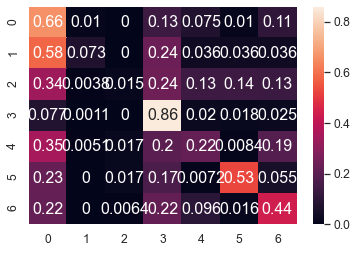

	training epoch=5 .. train_loss=1.31
	validation epoch=5 .. val_loss=1.423
	Accuracy = 47.9 % .. Percision = 43.0 % .. Recall = 40.0 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_5.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 6 .. loss = 1.248


  0%|                                                                                 | 1/1914 [00:01<36:17,  1.14s/it]

training @ epoch 6 .. loss = 1.406


  0%|                                                                                 | 2/1914 [00:02<36:37,  1.15s/it]

training @ epoch 6 .. loss = 1.307


  0%|▏                                                                                | 3/1914 [00:03<37:11,  1.17s/it]

training @ epoch 6 .. loss = 1.276


  0%|▏                                                                                | 4/1914 [00:04<37:25,  1.18s/it]

training @ epoch 6 .. loss = 0.862


  0%|▏                                                                                | 5/1914 [00:05<36:53,  1.16s/it]

training @ epoch 6 .. loss = 0.946


  0%|▎                                                                                | 6/1914 [00:06<36:42,  1.15s/it]

training @ epoch 6 .. loss = 1.024


  0%|▎                                                                                | 7/1914 [00:08<36:20,  1.14s/it]

training @ epoch 6 .. loss = 1.371


  0%|▎                                                                                | 8/1914 [00:09<36:24,  1.15s/it]

training @ epoch 6 .. loss = 1.535


  0%|▍                                                                                | 9/1914 [00:10<36:32,  1.15s/it]

training @ epoch 6 .. loss = 1.0


  1%|▍                                                                               | 10/1914 [00:11<36:43,  1.16s/it]

training @ epoch 6 .. loss = 1.33


  1%|▍                                                                               | 11/1914 [00:12<36:56,  1.16s/it]

training @ epoch 6 .. loss = 1.191


  1%|▌                                                                               | 12/1914 [00:13<36:59,  1.17s/it]

training @ epoch 6 .. loss = 1.483


  1%|▌                                                                               | 13/1914 [00:15<36:57,  1.17s/it]

training @ epoch 6 .. loss = 0.911


  1%|▌                                                                               | 14/1914 [00:16<36:58,  1.17s/it]

training @ epoch 6 .. loss = 1.306


  1%|▋                                                                               | 15/1914 [00:17<36:49,  1.16s/it]

training @ epoch 6 .. loss = 1.589


  1%|▋                                                                               | 16/1914 [00:18<37:39,  1.19s/it]

training @ epoch 6 .. loss = 1.19


  1%|▋                                                                               | 17/1914 [00:19<36:59,  1.17s/it]

training @ epoch 6 .. loss = 1.704


  1%|▊                                                                               | 18/1914 [00:20<37:04,  1.17s/it]

training @ epoch 6 .. loss = 0.994


  1%|▊                                                                               | 19/1914 [00:22<36:57,  1.17s/it]

training @ epoch 6 .. loss = 0.968


  1%|▊                                                                               | 20/1914 [00:23<36:44,  1.16s/it]

training @ epoch 6 .. loss = 1.119


  1%|▉                                                                               | 21/1914 [00:24<37:46,  1.20s/it]

training @ epoch 6 .. loss = 1.739


  1%|▉                                                                               | 22/1914 [00:25<37:07,  1.18s/it]

training @ epoch 6 .. loss = 1.233


  1%|▉                                                                               | 23/1914 [00:26<37:06,  1.18s/it]

training @ epoch 6 .. loss = 1.483


  1%|█                                                                               | 24/1914 [00:28<36:59,  1.17s/it]

training @ epoch 6 .. loss = 1.242


  1%|█                                                                               | 25/1914 [00:29<36:49,  1.17s/it]

training @ epoch 6 .. loss = 0.945


  1%|█                                                                               | 26/1914 [00:30<36:45,  1.17s/it]

training @ epoch 6 .. loss = 1.195


  1%|█▏                                                                              | 27/1914 [00:31<36:33,  1.16s/it]

training @ epoch 6 .. loss = 1.259


  1%|█▏                                                                              | 28/1914 [00:32<36:49,  1.17s/it]

training @ epoch 6 .. loss = 1.25


  2%|█▏                                                                              | 29/1914 [00:33<36:54,  1.17s/it]

training @ epoch 6 .. loss = 1.102


  2%|█▎                                                                              | 30/1914 [00:35<37:01,  1.18s/it]

training @ epoch 6 .. loss = 1.476


  2%|█▎                                                                              | 31/1914 [00:36<36:56,  1.18s/it]

training @ epoch 6 .. loss = 1.259


  2%|█▎                                                                              | 32/1914 [00:37<36:41,  1.17s/it]

training @ epoch 6 .. loss = 1.026


  2%|█▍                                                                              | 33/1914 [00:38<37:09,  1.19s/it]

training @ epoch 6 .. loss = 1.324


  2%|█▍                                                                              | 34/1914 [00:39<36:53,  1.18s/it]

training @ epoch 6 .. loss = 1.368


  2%|█▍                                                                              | 35/1914 [00:40<36:55,  1.18s/it]

training @ epoch 6 .. loss = 1.111


  2%|█▌                                                                              | 36/1914 [00:42<36:32,  1.17s/it]

training @ epoch 6 .. loss = 1.032


  2%|█▌                                                                              | 37/1914 [00:43<36:29,  1.17s/it]

training @ epoch 6 .. loss = 1.379


  2%|█▌                                                                              | 38/1914 [00:44<36:46,  1.18s/it]

training @ epoch 6 .. loss = 1.306


  2%|█▋                                                                              | 39/1914 [00:45<36:31,  1.17s/it]

training @ epoch 6 .. loss = 1.445


  2%|█▋                                                                              | 40/1914 [00:46<36:28,  1.17s/it]

training @ epoch 6 .. loss = 1.197


  2%|█▋                                                                              | 41/1914 [00:47<36:18,  1.16s/it]

training @ epoch 6 .. loss = 0.932


  2%|█▊                                                                              | 42/1914 [00:49<36:28,  1.17s/it]

training @ epoch 6 .. loss = 1.136


  2%|█▊                                                                              | 43/1914 [00:50<36:45,  1.18s/it]

training @ epoch 6 .. loss = 1.481


  2%|█▊                                                                              | 44/1914 [00:51<36:33,  1.17s/it]

training @ epoch 6 .. loss = 1.175


  2%|█▉                                                                              | 45/1914 [00:52<36:57,  1.19s/it]

training @ epoch 6 .. loss = 1.088


  2%|█▉                                                                              | 46/1914 [00:53<36:49,  1.18s/it]

training @ epoch 6 .. loss = 1.244


  2%|█▉                                                                              | 47/1914 [00:55<36:45,  1.18s/it]

training @ epoch 6 .. loss = 1.466


  3%|██                                                                              | 48/1914 [00:56<36:38,  1.18s/it]

training @ epoch 6 .. loss = 1.588


  3%|██                                                                              | 49/1914 [00:57<36:17,  1.17s/it]

training @ epoch 6 .. loss = 1.286


  3%|██                                                                              | 50/1914 [00:58<36:45,  1.18s/it]

training @ epoch 6 .. loss = 1.154


  3%|██▏                                                                             | 51/1914 [00:59<36:31,  1.18s/it]

training @ epoch 6 .. loss = 0.85


  3%|██▏                                                                             | 52/1914 [01:00<36:39,  1.18s/it]

training @ epoch 6 .. loss = 1.305


  3%|██▏                                                                             | 53/1914 [01:02<36:08,  1.17s/it]

training @ epoch 6 .. loss = 1.463


  3%|██▎                                                                             | 54/1914 [01:03<36:05,  1.16s/it]

training @ epoch 6 .. loss = 0.983


  3%|██▎                                                                             | 55/1914 [01:04<36:22,  1.17s/it]

training @ epoch 6 .. loss = 1.251


  3%|██▎                                                                             | 56/1914 [01:05<36:15,  1.17s/it]

training @ epoch 6 .. loss = 1.561


  3%|██▍                                                                             | 57/1914 [01:06<36:20,  1.17s/it]

training @ epoch 6 .. loss = 1.281


  3%|██▍                                                                             | 58/1914 [01:07<36:00,  1.16s/it]

training @ epoch 6 .. loss = 1.568


  3%|██▍                                                                             | 59/1914 [01:09<36:00,  1.16s/it]

training @ epoch 6 .. loss = 1.385


  3%|██▌                                                                             | 60/1914 [01:10<35:56,  1.16s/it]

training @ epoch 6 .. loss = 1.224


  3%|██▌                                                                             | 61/1914 [01:11<35:50,  1.16s/it]

training @ epoch 6 .. loss = 1.621


  3%|██▌                                                                             | 62/1914 [01:12<36:07,  1.17s/it]

training @ epoch 6 .. loss = 1.294


  3%|██▋                                                                             | 63/1914 [01:13<35:41,  1.16s/it]

training @ epoch 6 .. loss = 1.61


  3%|██▋                                                                             | 64/1914 [01:14<36:28,  1.18s/it]

training @ epoch 6 .. loss = 1.476


  3%|██▋                                                                             | 65/1914 [01:16<36:15,  1.18s/it]

training @ epoch 6 .. loss = 1.61


  3%|██▊                                                                             | 66/1914 [01:17<35:46,  1.16s/it]

training @ epoch 6 .. loss = 1.136


  4%|██▊                                                                             | 67/1914 [01:18<36:21,  1.18s/it]

training @ epoch 6 .. loss = 1.056


  4%|██▊                                                                             | 68/1914 [01:19<36:26,  1.18s/it]

training @ epoch 6 .. loss = 1.744


  4%|██▉                                                                             | 69/1914 [01:20<36:26,  1.19s/it]

training @ epoch 6 .. loss = 1.593


  4%|██▉                                                                             | 70/1914 [01:22<36:11,  1.18s/it]

training @ epoch 6 .. loss = 1.676


  4%|██▉                                                                             | 71/1914 [01:23<35:49,  1.17s/it]

training @ epoch 6 .. loss = 1.262


  4%|███                                                                             | 72/1914 [01:24<36:05,  1.18s/it]

training @ epoch 6 .. loss = 1.366


  4%|███                                                                             | 73/1914 [01:25<36:14,  1.18s/it]

training @ epoch 6 .. loss = 1.332


  4%|███                                                                             | 74/1914 [01:26<36:36,  1.19s/it]

training @ epoch 6 .. loss = 1.177


  4%|███▏                                                                            | 75/1914 [01:27<36:06,  1.18s/it]

training @ epoch 6 .. loss = 1.363


  4%|███▏                                                                            | 76/1914 [01:29<35:58,  1.17s/it]

training @ epoch 6 .. loss = 1.726


  4%|███▏                                                                            | 77/1914 [01:30<35:54,  1.17s/it]

training @ epoch 6 .. loss = 1.145


  4%|███▎                                                                            | 78/1914 [01:31<35:36,  1.16s/it]

training @ epoch 6 .. loss = 1.242


  4%|███▎                                                                            | 79/1914 [01:32<35:55,  1.17s/it]

training @ epoch 6 .. loss = 1.273


  4%|███▎                                                                            | 80/1914 [01:33<35:47,  1.17s/it]

training @ epoch 6 .. loss = 1.54


  4%|███▍                                                                            | 81/1914 [01:35<37:16,  1.22s/it]

training @ epoch 6 .. loss = 1.239


  4%|███▍                                                                            | 82/1914 [01:36<38:23,  1.26s/it]

training @ epoch 6 .. loss = 1.234


  4%|███▍                                                                            | 83/1914 [01:37<38:47,  1.27s/it]

training @ epoch 6 .. loss = 1.16


  4%|███▌                                                                            | 84/1914 [01:39<38:57,  1.28s/it]

training @ epoch 6 .. loss = 1.456


  4%|███▌                                                                            | 85/1914 [01:40<39:07,  1.28s/it]

training @ epoch 6 .. loss = 0.976


  4%|███▌                                                                            | 86/1914 [01:41<39:27,  1.30s/it]

training @ epoch 6 .. loss = 1.084


  5%|███▋                                                                            | 87/1914 [01:43<41:28,  1.36s/it]

training @ epoch 6 .. loss = 1.493


  5%|███▋                                                                            | 88/1914 [01:44<43:11,  1.42s/it]

training @ epoch 6 .. loss = 1.478


  5%|███▋                                                                            | 89/1914 [01:46<43:57,  1.45s/it]

training @ epoch 6 .. loss = 1.423


  5%|███▊                                                                            | 90/1914 [01:47<43:17,  1.42s/it]

training @ epoch 6 .. loss = 1.218


  5%|███▊                                                                            | 91/1914 [01:48<43:00,  1.42s/it]

training @ epoch 6 .. loss = 1.021


  5%|███▊                                                                            | 92/1914 [01:50<43:14,  1.42s/it]

training @ epoch 6 .. loss = 1.209


  5%|███▉                                                                            | 93/1914 [01:52<45:07,  1.49s/it]

training @ epoch 6 .. loss = 1.32


  5%|███▉                                                                            | 94/1914 [01:53<45:37,  1.50s/it]

training @ epoch 6 .. loss = 1.518


  5%|███▉                                                                            | 95/1914 [01:55<45:50,  1.51s/it]

training @ epoch 6 .. loss = 1.327


  5%|████                                                                            | 96/1914 [01:56<45:09,  1.49s/it]

training @ epoch 6 .. loss = 1.6


  5%|████                                                                            | 97/1914 [01:57<44:07,  1.46s/it]

training @ epoch 6 .. loss = 1.002


  5%|████                                                                            | 98/1914 [01:59<43:33,  1.44s/it]

training @ epoch 6 .. loss = 1.145


  5%|████▏                                                                           | 99/1914 [02:00<41:46,  1.38s/it]

training @ epoch 6 .. loss = 1.122


  5%|████▏                                                                          | 100/1914 [02:01<39:22,  1.30s/it]

training @ epoch 6 .. loss = 1.079


  5%|████▏                                                                          | 101/1914 [02:02<37:55,  1.25s/it]

training @ epoch 6 .. loss = 1.641


  5%|████▏                                                                          | 102/1914 [02:04<37:18,  1.24s/it]

training @ epoch 6 .. loss = 1.403


  5%|████▎                                                                          | 103/1914 [02:05<36:36,  1.21s/it]

training @ epoch 6 .. loss = 1.964


  5%|████▎                                                                          | 104/1914 [02:06<36:14,  1.20s/it]

training @ epoch 6 .. loss = 1.503


  5%|████▎                                                                          | 105/1914 [02:07<36:02,  1.20s/it]

training @ epoch 6 .. loss = 1.183


  6%|████▍                                                                          | 106/1914 [02:08<35:54,  1.19s/it]

training @ epoch 6 .. loss = 1.245


  6%|████▍                                                                          | 107/1914 [02:09<35:53,  1.19s/it]

training @ epoch 6 .. loss = 1.78


  6%|████▍                                                                          | 108/1914 [02:11<35:41,  1.19s/it]

training @ epoch 6 .. loss = 0.987


  6%|████▍                                                                          | 109/1914 [02:12<35:30,  1.18s/it]

training @ epoch 6 .. loss = 1.494


  6%|████▌                                                                          | 110/1914 [02:13<35:27,  1.18s/it]

training @ epoch 6 .. loss = 1.582


  6%|████▌                                                                          | 111/1914 [02:14<35:49,  1.19s/it]

training @ epoch 6 .. loss = 1.548


  6%|████▌                                                                          | 112/1914 [02:15<35:42,  1.19s/it]

training @ epoch 6 .. loss = 1.203


  6%|████▋                                                                          | 113/1914 [02:17<35:51,  1.19s/it]

training @ epoch 6 .. loss = 1.36


  6%|████▋                                                                          | 114/1914 [02:18<35:28,  1.18s/it]

training @ epoch 6 .. loss = 1.297


  6%|████▋                                                                          | 115/1914 [02:19<34:59,  1.17s/it]

training @ epoch 6 .. loss = 1.418


  6%|████▊                                                                          | 116/1914 [02:20<35:03,  1.17s/it]

training @ epoch 6 .. loss = 0.781


  6%|████▊                                                                          | 117/1914 [02:21<34:57,  1.17s/it]

training @ epoch 6 .. loss = 1.481


  6%|████▊                                                                          | 118/1914 [02:22<35:10,  1.18s/it]

training @ epoch 6 .. loss = 1.323


  6%|████▉                                                                          | 119/1914 [02:24<35:03,  1.17s/it]

training @ epoch 6 .. loss = 1.168


  6%|████▉                                                                          | 120/1914 [02:25<35:08,  1.18s/it]

training @ epoch 6 .. loss = 1.123


  6%|████▉                                                                          | 121/1914 [02:26<35:11,  1.18s/it]

training @ epoch 6 .. loss = 1.033


  6%|█████                                                                          | 122/1914 [02:27<35:12,  1.18s/it]

training @ epoch 6 .. loss = 1.202


  6%|█████                                                                          | 123/1914 [02:28<35:13,  1.18s/it]

training @ epoch 6 .. loss = 1.174


  6%|█████                                                                          | 124/1914 [02:29<35:02,  1.17s/it]

training @ epoch 6 .. loss = 1.026


  7%|█████▏                                                                         | 125/1914 [02:31<35:21,  1.19s/it]

training @ epoch 6 .. loss = 1.452


  7%|█████▏                                                                         | 126/1914 [02:32<35:23,  1.19s/it]

training @ epoch 6 .. loss = 0.984


  7%|█████▏                                                                         | 127/1914 [02:33<35:14,  1.18s/it]

training @ epoch 6 .. loss = 1.029


  7%|█████▎                                                                         | 128/1914 [02:34<35:35,  1.20s/it]

training @ epoch 6 .. loss = 1.164


  7%|█████▎                                                                         | 129/1914 [02:35<34:59,  1.18s/it]

training @ epoch 6 .. loss = 1.439


  7%|█████▎                                                                         | 130/1914 [02:37<35:01,  1.18s/it]

training @ epoch 6 .. loss = 1.351


  7%|█████▍                                                                         | 131/1914 [02:38<35:08,  1.18s/it]

training @ epoch 6 .. loss = 1.807


  7%|█████▍                                                                         | 132/1914 [02:39<35:16,  1.19s/it]

training @ epoch 6 .. loss = 1.071


  7%|█████▍                                                                         | 133/1914 [02:40<35:19,  1.19s/it]

training @ epoch 6 .. loss = 1.244


  7%|█████▌                                                                         | 134/1914 [02:41<35:03,  1.18s/it]

training @ epoch 6 .. loss = 1.558


  7%|█████▌                                                                         | 135/1914 [02:43<35:07,  1.18s/it]

training @ epoch 6 .. loss = 1.513


  7%|█████▌                                                                         | 136/1914 [02:44<35:09,  1.19s/it]

training @ epoch 6 .. loss = 1.342


  7%|█████▋                                                                         | 137/1914 [02:45<34:40,  1.17s/it]

training @ epoch 6 .. loss = 1.104


  7%|█████▋                                                                         | 138/1914 [02:46<35:12,  1.19s/it]

training @ epoch 6 .. loss = 1.455


  7%|█████▋                                                                         | 139/1914 [02:47<34:46,  1.18s/it]

training @ epoch 6 .. loss = 1.094


  7%|█████▊                                                                         | 140/1914 [02:48<34:50,  1.18s/it]

training @ epoch 6 .. loss = 1.325


  7%|█████▊                                                                         | 141/1914 [02:50<34:41,  1.17s/it]

training @ epoch 6 .. loss = 1.618


  7%|█████▊                                                                         | 142/1914 [02:51<34:47,  1.18s/it]

training @ epoch 6 .. loss = 1.242


  7%|█████▉                                                                         | 143/1914 [02:52<34:59,  1.19s/it]

training @ epoch 6 .. loss = 1.891


  8%|█████▉                                                                         | 144/1914 [02:53<35:01,  1.19s/it]

training @ epoch 6 .. loss = 1.289


  8%|█████▉                                                                         | 145/1914 [02:54<34:47,  1.18s/it]

training @ epoch 6 .. loss = 0.852


  8%|██████                                                                         | 146/1914 [02:55<34:42,  1.18s/it]

training @ epoch 6 .. loss = 1.036


  8%|██████                                                                         | 147/1914 [02:57<34:42,  1.18s/it]

training @ epoch 6 .. loss = 1.482


  8%|██████                                                                         | 148/1914 [02:58<34:54,  1.19s/it]

training @ epoch 6 .. loss = 0.99


  8%|██████▏                                                                        | 149/1914 [02:59<34:37,  1.18s/it]

training @ epoch 6 .. loss = 1.322


  8%|██████▏                                                                        | 150/1914 [03:00<34:39,  1.18s/it]

training @ epoch 6 .. loss = 1.081


  8%|██████▏                                                                        | 151/1914 [03:01<34:30,  1.17s/it]

training @ epoch 6 .. loss = 1.223


  8%|██████▎                                                                        | 152/1914 [03:03<34:24,  1.17s/it]

training @ epoch 6 .. loss = 1.409


  8%|██████▎                                                                        | 153/1914 [03:04<34:32,  1.18s/it]

training @ epoch 6 .. loss = 1.053


  8%|██████▎                                                                        | 154/1914 [03:05<34:08,  1.16s/it]

training @ epoch 6 .. loss = 1.319


  8%|██████▍                                                                        | 155/1914 [03:06<34:35,  1.18s/it]

training @ epoch 6 .. loss = 1.027


  8%|██████▍                                                                        | 156/1914 [03:07<34:19,  1.17s/it]

training @ epoch 6 .. loss = 1.44


  8%|██████▍                                                                        | 157/1914 [03:08<34:19,  1.17s/it]

training @ epoch 6 .. loss = 1.35


  8%|██████▌                                                                        | 158/1914 [03:10<34:07,  1.17s/it]

training @ epoch 6 .. loss = 1.192


  8%|██████▌                                                                        | 159/1914 [03:11<34:09,  1.17s/it]

training @ epoch 6 .. loss = 1.423


  8%|██████▌                                                                        | 160/1914 [03:12<34:10,  1.17s/it]

training @ epoch 6 .. loss = 1.212


  8%|██████▋                                                                        | 161/1914 [03:13<34:10,  1.17s/it]

training @ epoch 6 .. loss = 1.092


  8%|██████▋                                                                        | 162/1914 [03:14<34:29,  1.18s/it]

training @ epoch 6 .. loss = 0.881


  9%|██████▋                                                                        | 163/1914 [03:15<34:07,  1.17s/it]

training @ epoch 6 .. loss = 1.175


  9%|██████▊                                                                        | 164/1914 [03:17<34:01,  1.17s/it]

training @ epoch 6 .. loss = 1.349


  9%|██████▊                                                                        | 165/1914 [03:18<34:09,  1.17s/it]

training @ epoch 6 .. loss = 0.807


  9%|██████▊                                                                        | 166/1914 [03:19<33:56,  1.16s/it]

training @ epoch 6 .. loss = 1.346


  9%|██████▉                                                                        | 167/1914 [03:20<34:20,  1.18s/it]

training @ epoch 6 .. loss = 1.95


  9%|██████▉                                                                        | 168/1914 [03:21<34:16,  1.18s/it]

training @ epoch 6 .. loss = 1.166


  9%|██████▉                                                                        | 169/1914 [03:22<34:16,  1.18s/it]

training @ epoch 6 .. loss = 1.473


  9%|███████                                                                        | 170/1914 [03:24<34:06,  1.17s/it]

training @ epoch 6 .. loss = 1.252


  9%|███████                                                                        | 171/1914 [03:25<34:04,  1.17s/it]

training @ epoch 6 .. loss = 1.633


  9%|███████                                                                        | 172/1914 [03:26<34:30,  1.19s/it]

training @ epoch 6 .. loss = 1.297


  9%|███████▏                                                                       | 173/1914 [03:27<34:01,  1.17s/it]

training @ epoch 6 .. loss = 1.148


  9%|███████▏                                                                       | 174/1914 [03:28<34:14,  1.18s/it]

training @ epoch 6 .. loss = 1.287


  9%|███████▏                                                                       | 175/1914 [03:30<34:15,  1.18s/it]

training @ epoch 6 .. loss = 1.074


  9%|███████▎                                                                       | 176/1914 [03:31<34:04,  1.18s/it]

training @ epoch 6 .. loss = 1.191


  9%|███████▎                                                                       | 177/1914 [03:32<34:22,  1.19s/it]

training @ epoch 6 .. loss = 1.205


  9%|███████▎                                                                       | 178/1914 [03:33<34:08,  1.18s/it]

training @ epoch 6 .. loss = 1.409


  9%|███████▍                                                                       | 179/1914 [03:34<33:41,  1.17s/it]

training @ epoch 6 .. loss = 1.131


  9%|███████▍                                                                       | 180/1914 [03:35<33:54,  1.17s/it]

training @ epoch 6 .. loss = 0.891


  9%|███████▍                                                                       | 181/1914 [03:37<33:51,  1.17s/it]

training @ epoch 6 .. loss = 1.039


 10%|███████▌                                                                       | 182/1914 [03:38<33:46,  1.17s/it]

training @ epoch 6 .. loss = 1.429


 10%|███████▌                                                                       | 183/1914 [03:39<33:30,  1.16s/it]

training @ epoch 6 .. loss = 1.283


 10%|███████▌                                                                       | 184/1914 [03:40<34:32,  1.20s/it]

training @ epoch 6 .. loss = 0.831


 10%|███████▋                                                                       | 185/1914 [03:41<34:12,  1.19s/it]

training @ epoch 6 .. loss = 1.568


 10%|███████▋                                                                       | 186/1914 [03:43<34:24,  1.19s/it]

training @ epoch 6 .. loss = 1.693


 10%|███████▋                                                                       | 187/1914 [03:44<34:15,  1.19s/it]

training @ epoch 6 .. loss = 1.21


 10%|███████▊                                                                       | 188/1914 [03:45<33:34,  1.17s/it]

training @ epoch 6 .. loss = 1.097


 10%|███████▊                                                                       | 189/1914 [03:46<33:56,  1.18s/it]

training @ epoch 6 .. loss = 1.067


 10%|███████▊                                                                       | 190/1914 [03:47<33:43,  1.17s/it]

training @ epoch 6 .. loss = 1.074


 10%|███████▉                                                                       | 191/1914 [03:48<33:40,  1.17s/it]

training @ epoch 6 .. loss = 1.453


 10%|███████▉                                                                       | 192/1914 [03:50<33:24,  1.16s/it]

training @ epoch 6 .. loss = 1.123


 10%|███████▉                                                                       | 193/1914 [03:51<33:16,  1.16s/it]

training @ epoch 6 .. loss = 1.396


 10%|████████                                                                       | 194/1914 [03:52<33:26,  1.17s/it]

training @ epoch 6 .. loss = 1.381


 10%|████████                                                                       | 195/1914 [03:53<33:22,  1.16s/it]

training @ epoch 6 .. loss = 1.346


 10%|████████                                                                       | 196/1914 [03:54<33:44,  1.18s/it]

training @ epoch 6 .. loss = 1.157


 10%|████████▏                                                                      | 197/1914 [03:55<33:30,  1.17s/it]

training @ epoch 6 .. loss = 1.485


 10%|████████▏                                                                      | 198/1914 [03:57<33:54,  1.19s/it]

training @ epoch 6 .. loss = 1.031


 10%|████████▏                                                                      | 199/1914 [03:58<33:51,  1.18s/it]

training @ epoch 6 .. loss = 1.167


 10%|████████▎                                                                      | 200/1914 [03:59<33:32,  1.17s/it]

training @ epoch 6 .. loss = 1.68


 11%|████████▎                                                                      | 201/1914 [04:00<33:39,  1.18s/it]

training @ epoch 6 .. loss = 1.215


 11%|████████▎                                                                      | 202/1914 [04:01<33:14,  1.17s/it]

training @ epoch 6 .. loss = 1.02


 11%|████████▍                                                                      | 203/1914 [04:02<33:18,  1.17s/it]

training @ epoch 6 .. loss = 1.329


 11%|████████▍                                                                      | 204/1914 [04:04<33:31,  1.18s/it]

training @ epoch 6 .. loss = 1.486


 11%|████████▍                                                                      | 205/1914 [04:05<34:14,  1.20s/it]

training @ epoch 6 .. loss = 1.358


 11%|████████▌                                                                      | 206/1914 [04:06<35:36,  1.25s/it]

training @ epoch 6 .. loss = 1.331


 11%|████████▌                                                                      | 207/1914 [04:08<36:12,  1.27s/it]

training @ epoch 6 .. loss = 1.633


 11%|████████▌                                                                      | 208/1914 [04:09<36:22,  1.28s/it]

training @ epoch 6 .. loss = 1.02


 11%|████████▋                                                                      | 209/1914 [04:10<37:04,  1.30s/it]

training @ epoch 6 .. loss = 1.092


 11%|████████▋                                                                      | 210/1914 [04:12<36:47,  1.30s/it]

training @ epoch 6 .. loss = 1.539


 11%|████████▋                                                                      | 211/1914 [04:13<36:50,  1.30s/it]

training @ epoch 6 .. loss = 1.274


 11%|████████▊                                                                      | 212/1914 [04:14<37:01,  1.31s/it]

training @ epoch 6 .. loss = 1.055


 11%|████████▊                                                                      | 213/1914 [04:15<36:54,  1.30s/it]

training @ epoch 6 .. loss = 1.476


 11%|████████▊                                                                      | 214/1914 [04:17<36:53,  1.30s/it]

training @ epoch 6 .. loss = 1.54


 11%|████████▊                                                                      | 215/1914 [04:18<37:03,  1.31s/it]

training @ epoch 6 .. loss = 1.331


 11%|████████▉                                                                      | 216/1914 [04:19<36:38,  1.29s/it]

training @ epoch 6 .. loss = 1.417


 11%|████████▉                                                                      | 217/1914 [04:21<36:46,  1.30s/it]

training @ epoch 6 .. loss = 1.406


 11%|████████▉                                                                      | 218/1914 [04:22<36:36,  1.30s/it]

training @ epoch 6 .. loss = 1.493


 11%|█████████                                                                      | 219/1914 [04:23<36:39,  1.30s/it]

training @ epoch 6 .. loss = 1.483


 11%|█████████                                                                      | 220/1914 [04:24<36:19,  1.29s/it]

training @ epoch 6 .. loss = 1.445


 12%|█████████                                                                      | 221/1914 [04:26<36:27,  1.29s/it]

training @ epoch 6 .. loss = 1.132


 12%|█████████▏                                                                     | 222/1914 [04:27<36:57,  1.31s/it]

training @ epoch 6 .. loss = 1.565


 12%|█████████▏                                                                     | 223/1914 [04:28<37:17,  1.32s/it]

training @ epoch 6 .. loss = 1.798


 12%|█████████▏                                                                     | 224/1914 [04:30<37:45,  1.34s/it]

training @ epoch 6 .. loss = 1.505


 12%|█████████▎                                                                     | 225/1914 [04:31<37:21,  1.33s/it]

training @ epoch 6 .. loss = 1.471


 12%|█████████▎                                                                     | 226/1914 [04:32<37:03,  1.32s/it]

training @ epoch 6 .. loss = 1.446


 12%|█████████▎                                                                     | 227/1914 [04:34<36:59,  1.32s/it]

training @ epoch 6 .. loss = 0.888


 12%|█████████▍                                                                     | 228/1914 [04:35<37:12,  1.32s/it]

training @ epoch 6 .. loss = 1.196


 12%|█████████▍                                                                     | 229/1914 [04:36<36:49,  1.31s/it]

training @ epoch 6 .. loss = 1.261


 12%|█████████▍                                                                     | 230/1914 [04:38<35:28,  1.26s/it]

training @ epoch 6 .. loss = 1.282


 12%|█████████▌                                                                     | 231/1914 [04:39<34:29,  1.23s/it]

training @ epoch 6 .. loss = 1.441


 12%|█████████▌                                                                     | 232/1914 [04:40<34:06,  1.22s/it]

training @ epoch 6 .. loss = 1.244


 12%|█████████▌                                                                     | 233/1914 [04:41<33:27,  1.19s/it]

training @ epoch 6 .. loss = 1.573


 12%|█████████▋                                                                     | 234/1914 [04:42<33:40,  1.20s/it]

training @ epoch 6 .. loss = 1.257


 12%|█████████▋                                                                     | 235/1914 [04:43<33:24,  1.19s/it]

training @ epoch 6 .. loss = 1.212


 12%|█████████▋                                                                     | 236/1914 [04:45<33:06,  1.18s/it]

training @ epoch 6 .. loss = 1.251


 12%|█████████▊                                                                     | 237/1914 [04:46<33:30,  1.20s/it]

training @ epoch 6 .. loss = 1.731


 12%|█████████▊                                                                     | 238/1914 [04:47<33:05,  1.18s/it]

training @ epoch 6 .. loss = 1.847


 12%|█████████▊                                                                     | 239/1914 [04:48<33:19,  1.19s/it]

training @ epoch 6 .. loss = 1.21


 13%|█████████▉                                                                     | 240/1914 [04:49<32:51,  1.18s/it]

training @ epoch 6 .. loss = 1.831


 13%|█████████▉                                                                     | 241/1914 [04:51<32:57,  1.18s/it]

training @ epoch 6 .. loss = 1.076


 13%|█████████▉                                                                     | 242/1914 [04:52<32:41,  1.17s/it]

training @ epoch 6 .. loss = 1.146


 13%|██████████                                                                     | 243/1914 [04:53<32:38,  1.17s/it]

training @ epoch 6 .. loss = 1.223


 13%|██████████                                                                     | 244/1914 [04:54<33:04,  1.19s/it]

training @ epoch 6 .. loss = 1.297


 13%|██████████                                                                     | 245/1914 [04:55<32:45,  1.18s/it]

training @ epoch 6 .. loss = 1.184


 13%|██████████▏                                                                    | 246/1914 [04:56<33:05,  1.19s/it]

training @ epoch 6 .. loss = 1.377


 13%|██████████▏                                                                    | 247/1914 [04:58<32:51,  1.18s/it]

training @ epoch 6 .. loss = 1.23


 13%|██████████▏                                                                    | 248/1914 [04:59<32:49,  1.18s/it]

training @ epoch 6 .. loss = 1.65


 13%|██████████▎                                                                    | 249/1914 [05:00<32:47,  1.18s/it]

training @ epoch 6 .. loss = 1.959


 13%|██████████▎                                                                    | 250/1914 [05:01<32:26,  1.17s/it]

training @ epoch 6 .. loss = 1.015


 13%|██████████▎                                                                    | 251/1914 [05:02<32:21,  1.17s/it]

training @ epoch 6 .. loss = 1.437


 13%|██████████▍                                                                    | 252/1914 [05:03<32:20,  1.17s/it]

training @ epoch 6 .. loss = 1.271


 13%|██████████▍                                                                    | 253/1914 [05:05<33:00,  1.19s/it]

training @ epoch 6 .. loss = 1.362


 13%|██████████▍                                                                    | 254/1914 [05:06<33:12,  1.20s/it]

training @ epoch 6 .. loss = 1.303


 13%|██████████▌                                                                    | 255/1914 [05:07<33:06,  1.20s/it]

training @ epoch 6 .. loss = 1.164


 13%|██████████▌                                                                    | 256/1914 [05:08<33:03,  1.20s/it]

training @ epoch 6 .. loss = 1.057


 13%|██████████▌                                                                    | 257/1914 [05:09<33:01,  1.20s/it]

training @ epoch 6 .. loss = 0.981


 13%|██████████▋                                                                    | 258/1914 [05:11<32:41,  1.18s/it]

training @ epoch 6 .. loss = 0.923


 14%|██████████▋                                                                    | 259/1914 [05:12<32:30,  1.18s/it]

training @ epoch 6 .. loss = 0.775


 14%|██████████▋                                                                    | 260/1914 [05:13<32:21,  1.17s/it]

training @ epoch 6 .. loss = 1.663


 14%|██████████▊                                                                    | 261/1914 [05:14<32:24,  1.18s/it]

training @ epoch 6 .. loss = 1.462


 14%|██████████▊                                                                    | 262/1914 [05:15<32:17,  1.17s/it]

training @ epoch 6 .. loss = 1.091


 14%|██████████▊                                                                    | 263/1914 [05:16<32:15,  1.17s/it]

training @ epoch 6 .. loss = 1.544


 14%|██████████▉                                                                    | 264/1914 [05:18<32:18,  1.18s/it]

training @ epoch 6 .. loss = 1.208


 14%|██████████▉                                                                    | 265/1914 [05:19<32:06,  1.17s/it]

training @ epoch 6 .. loss = 1.302


 14%|██████████▉                                                                    | 266/1914 [05:20<32:12,  1.17s/it]

training @ epoch 6 .. loss = 1.014


 14%|███████████                                                                    | 267/1914 [05:21<32:06,  1.17s/it]

training @ epoch 6 .. loss = 1.37


 14%|███████████                                                                    | 268/1914 [05:22<32:06,  1.17s/it]

training @ epoch 6 .. loss = 1.195


 14%|███████████                                                                    | 269/1914 [05:23<31:51,  1.16s/it]

training @ epoch 6 .. loss = 1.298


 14%|███████████▏                                                                   | 270/1914 [05:25<32:03,  1.17s/it]

training @ epoch 6 .. loss = 1.035


 14%|███████████▏                                                                   | 271/1914 [05:26<31:53,  1.16s/it]

training @ epoch 6 .. loss = 1.527


 14%|███████████▏                                                                   | 272/1914 [05:27<32:15,  1.18s/it]

training @ epoch 6 .. loss = 1.206


 14%|███████████▎                                                                   | 273/1914 [05:28<32:31,  1.19s/it]

training @ epoch 6 .. loss = 1.646


 14%|███████████▎                                                                   | 274/1914 [05:29<31:59,  1.17s/it]

training @ epoch 6 .. loss = 1.322


 14%|███████████▎                                                                   | 275/1914 [05:31<31:59,  1.17s/it]

training @ epoch 6 .. loss = 1.53


 14%|███████████▍                                                                   | 276/1914 [05:32<31:58,  1.17s/it]

training @ epoch 6 .. loss = 1.599


 14%|███████████▍                                                                   | 277/1914 [05:33<31:53,  1.17s/it]

training @ epoch 6 .. loss = 1.397


 15%|███████████▍                                                                   | 278/1914 [05:34<32:08,  1.18s/it]

training @ epoch 6 .. loss = 0.81


 15%|███████████▌                                                                   | 279/1914 [05:35<31:54,  1.17s/it]

training @ epoch 6 .. loss = 1.289


 15%|███████████▌                                                                   | 280/1914 [05:37<34:11,  1.26s/it]

training @ epoch 6 .. loss = 0.941


 15%|███████████▌                                                                   | 281/1914 [05:38<33:54,  1.25s/it]

training @ epoch 6 .. loss = 1.267


 15%|███████████▋                                                                   | 282/1914 [05:39<33:02,  1.21s/it]

training @ epoch 6 .. loss = 1.07


 15%|███████████▋                                                                   | 283/1914 [05:40<34:01,  1.25s/it]

training @ epoch 6 .. loss = 1.303


 15%|███████████▋                                                                   | 284/1914 [05:42<33:16,  1.23s/it]

training @ epoch 6 .. loss = 0.818


 15%|███████████▊                                                                   | 285/1914 [05:43<32:54,  1.21s/it]

training @ epoch 6 .. loss = 1.266


 15%|███████████▊                                                                   | 286/1914 [05:44<32:48,  1.21s/it]

training @ epoch 6 .. loss = 1.275


 15%|███████████▊                                                                   | 287/1914 [05:45<32:29,  1.20s/it]

training @ epoch 6 .. loss = 1.194


 15%|███████████▉                                                                   | 288/1914 [05:46<32:20,  1.19s/it]

training @ epoch 6 .. loss = 1.426


 15%|███████████▉                                                                   | 289/1914 [05:47<31:54,  1.18s/it]

training @ epoch 6 .. loss = 1.051


 15%|███████████▉                                                                   | 290/1914 [05:49<31:38,  1.17s/it]

training @ epoch 6 .. loss = 1.274


 15%|████████████                                                                   | 291/1914 [05:50<31:29,  1.16s/it]

training @ epoch 6 .. loss = 1.109


 15%|████████████                                                                   | 292/1914 [05:51<31:26,  1.16s/it]

training @ epoch 6 .. loss = 1.165


 15%|████████████                                                                   | 293/1914 [05:52<31:50,  1.18s/it]

training @ epoch 6 .. loss = 1.987


 15%|████████████▏                                                                  | 294/1914 [05:53<31:40,  1.17s/it]

training @ epoch 6 .. loss = 1.204


 15%|████████████▏                                                                  | 295/1914 [05:54<32:03,  1.19s/it]

training @ epoch 6 .. loss = 0.984


 15%|████████████▏                                                                  | 296/1914 [05:56<31:55,  1.18s/it]

training @ epoch 6 .. loss = 0.955


 16%|████████████▎                                                                  | 297/1914 [05:57<31:43,  1.18s/it]

training @ epoch 6 .. loss = 0.99


 16%|████████████▎                                                                  | 298/1914 [05:58<32:09,  1.19s/it]

training @ epoch 6 .. loss = 1.176


 16%|████████████▎                                                                  | 299/1914 [05:59<31:55,  1.19s/it]

training @ epoch 6 .. loss = 1.237


 16%|████████████▍                                                                  | 300/1914 [06:00<31:51,  1.18s/it]

training @ epoch 6 .. loss = 2.032


 16%|████████████▍                                                                  | 301/1914 [06:02<31:37,  1.18s/it]

training @ epoch 6 .. loss = 1.924


 16%|████████████▍                                                                  | 302/1914 [06:03<31:45,  1.18s/it]

training @ epoch 6 .. loss = 1.483


 16%|████████████▌                                                                  | 303/1914 [06:04<31:48,  1.18s/it]

training @ epoch 6 .. loss = 1.412


 16%|████████████▌                                                                  | 304/1914 [06:05<31:41,  1.18s/it]

training @ epoch 6 .. loss = 1.37


 16%|████████████▌                                                                  | 305/1914 [06:06<31:35,  1.18s/it]

training @ epoch 6 .. loss = 0.94


 16%|████████████▋                                                                  | 306/1914 [06:07<31:16,  1.17s/it]

training @ epoch 6 .. loss = 1.043


 16%|████████████▋                                                                  | 307/1914 [06:09<31:20,  1.17s/it]

training @ epoch 6 .. loss = 0.722


 16%|████████████▋                                                                  | 308/1914 [06:10<31:20,  1.17s/it]

training @ epoch 6 .. loss = 1.454


 16%|████████████▊                                                                  | 309/1914 [06:11<30:55,  1.16s/it]

training @ epoch 6 .. loss = 1.336


 16%|████████████▊                                                                  | 310/1914 [06:12<31:10,  1.17s/it]

training @ epoch 6 .. loss = 1.197


 16%|████████████▊                                                                  | 311/1914 [06:13<31:13,  1.17s/it]

training @ epoch 6 .. loss = 1.161


 16%|████████████▉                                                                  | 312/1914 [06:14<31:22,  1.18s/it]

training @ epoch 6 .. loss = 1.054


 16%|████████████▉                                                                  | 313/1914 [06:16<31:22,  1.18s/it]

training @ epoch 6 .. loss = 1.884


 16%|████████████▉                                                                  | 314/1914 [06:17<31:24,  1.18s/it]

training @ epoch 6 .. loss = 1.544


 16%|█████████████                                                                  | 315/1914 [06:18<31:40,  1.19s/it]

training @ epoch 6 .. loss = 1.293


 17%|█████████████                                                                  | 316/1914 [06:19<31:17,  1.18s/it]

training @ epoch 6 .. loss = 1.286


 17%|█████████████                                                                  | 317/1914 [06:20<31:14,  1.17s/it]

training @ epoch 6 .. loss = 1.468


 17%|█████████████▏                                                                 | 318/1914 [06:22<34:40,  1.30s/it]

training @ epoch 6 .. loss = 1.263


 17%|█████████████▏                                                                 | 319/1914 [06:23<35:50,  1.35s/it]

training @ epoch 6 .. loss = 1.385


 17%|█████████████▏                                                                 | 320/1914 [06:25<34:20,  1.29s/it]

training @ epoch 6 .. loss = 1.038


 17%|█████████████▏                                                                 | 321/1914 [06:26<33:26,  1.26s/it]

training @ epoch 6 .. loss = 1.665


 17%|█████████████▎                                                                 | 322/1914 [06:27<32:32,  1.23s/it]

training @ epoch 6 .. loss = 1.048


 17%|█████████████▎                                                                 | 323/1914 [06:28<32:40,  1.23s/it]

training @ epoch 6 .. loss = 1.136


 17%|█████████████▎                                                                 | 324/1914 [06:29<32:20,  1.22s/it]

training @ epoch 6 .. loss = 1.409


 17%|█████████████▍                                                                 | 325/1914 [06:31<31:55,  1.21s/it]

training @ epoch 6 .. loss = 1.386


 17%|█████████████▍                                                                 | 326/1914 [06:32<31:46,  1.20s/it]

training @ epoch 6 .. loss = 1.408


 17%|█████████████▍                                                                 | 327/1914 [06:33<31:07,  1.18s/it]

training @ epoch 6 .. loss = 1.613


 17%|█████████████▌                                                                 | 328/1914 [06:34<31:27,  1.19s/it]

training @ epoch 6 .. loss = 0.989


 17%|█████████████▌                                                                 | 329/1914 [06:35<31:08,  1.18s/it]

training @ epoch 6 .. loss = 1.378


 17%|█████████████▌                                                                 | 330/1914 [06:36<31:03,  1.18s/it]

training @ epoch 6 .. loss = 1.243


 17%|█████████████▋                                                                 | 331/1914 [06:38<30:50,  1.17s/it]

training @ epoch 6 .. loss = 1.097


 17%|█████████████▋                                                                 | 332/1914 [06:39<30:45,  1.17s/it]

training @ epoch 6 .. loss = 0.868


 17%|█████████████▋                                                                 | 333/1914 [06:40<30:40,  1.16s/it]

training @ epoch 6 .. loss = 1.125


 17%|█████████████▊                                                                 | 334/1914 [06:41<30:32,  1.16s/it]

training @ epoch 6 .. loss = 1.235


 18%|█████████████▊                                                                 | 335/1914 [06:42<30:39,  1.16s/it]

training @ epoch 6 .. loss = 1.115


 18%|█████████████▊                                                                 | 336/1914 [06:43<30:39,  1.17s/it]

training @ epoch 6 .. loss = 1.41


 18%|█████████████▉                                                                 | 337/1914 [06:45<30:50,  1.17s/it]

training @ epoch 6 .. loss = 1.304


 18%|█████████████▉                                                                 | 338/1914 [06:46<30:53,  1.18s/it]

training @ epoch 6 .. loss = 1.3


 18%|█████████████▉                                                                 | 339/1914 [06:47<30:41,  1.17s/it]

training @ epoch 6 .. loss = 0.979


 18%|██████████████                                                                 | 340/1914 [06:48<31:10,  1.19s/it]

training @ epoch 6 .. loss = 1.2


 18%|██████████████                                                                 | 341/1914 [06:49<30:50,  1.18s/it]

training @ epoch 6 .. loss = 1.48


 18%|██████████████                                                                 | 342/1914 [06:50<30:52,  1.18s/it]

training @ epoch 6 .. loss = 1.184


 18%|██████████████▏                                                                | 343/1914 [06:52<30:57,  1.18s/it]

training @ epoch 6 .. loss = 1.266


 18%|██████████████▏                                                                | 344/1914 [06:53<30:56,  1.18s/it]

training @ epoch 6 .. loss = 1.852


 18%|██████████████▏                                                                | 345/1914 [06:54<31:14,  1.19s/it]

training @ epoch 6 .. loss = 1.573


 18%|██████████████▎                                                                | 346/1914 [06:55<31:02,  1.19s/it]

training @ epoch 6 .. loss = 1.866


 18%|██████████████▎                                                                | 347/1914 [06:56<30:48,  1.18s/it]

training @ epoch 6 .. loss = 1.589


 18%|██████████████▎                                                                | 348/1914 [06:58<30:41,  1.18s/it]

training @ epoch 6 .. loss = 1.863


 18%|██████████████▍                                                                | 349/1914 [06:59<30:32,  1.17s/it]

training @ epoch 6 .. loss = 1.172


 18%|██████████████▍                                                                | 350/1914 [07:00<30:45,  1.18s/it]

training @ epoch 6 .. loss = 0.724


 18%|██████████████▍                                                                | 351/1914 [07:01<30:36,  1.18s/it]

training @ epoch 6 .. loss = 1.149


 18%|██████████████▌                                                                | 352/1914 [07:02<30:38,  1.18s/it]

training @ epoch 6 .. loss = 0.867


 18%|██████████████▌                                                                | 353/1914 [07:03<30:48,  1.18s/it]

training @ epoch 6 .. loss = 1.453


 18%|██████████████▌                                                                | 354/1914 [07:05<31:00,  1.19s/it]

training @ epoch 6 .. loss = 1.011


 19%|██████████████▋                                                                | 355/1914 [07:06<30:51,  1.19s/it]

training @ epoch 6 .. loss = 1.269


 19%|██████████████▋                                                                | 356/1914 [07:07<30:23,  1.17s/it]

training @ epoch 6 .. loss = 1.235


 19%|██████████████▋                                                                | 357/1914 [07:08<30:42,  1.18s/it]

training @ epoch 6 .. loss = 1.501


 19%|██████████████▊                                                                | 358/1914 [07:09<30:27,  1.17s/it]

training @ epoch 6 .. loss = 1.104


 19%|██████████████▊                                                                | 359/1914 [07:10<30:17,  1.17s/it]

training @ epoch 6 .. loss = 1.301


 19%|██████████████▊                                                                | 360/1914 [07:12<30:11,  1.17s/it]

training @ epoch 6 .. loss = 1.352


 19%|██████████████▉                                                                | 361/1914 [07:13<30:13,  1.17s/it]

training @ epoch 6 .. loss = 1.512


 19%|██████████████▉                                                                | 362/1914 [07:14<30:28,  1.18s/it]

training @ epoch 6 .. loss = 1.202


 19%|██████████████▉                                                                | 363/1914 [07:15<30:33,  1.18s/it]

training @ epoch 6 .. loss = 1.757


 19%|███████████████                                                                | 364/1914 [07:16<30:33,  1.18s/it]

training @ epoch 6 .. loss = 1.072


 19%|███████████████                                                                | 365/1914 [07:18<30:27,  1.18s/it]

training @ epoch 6 .. loss = 0.963


 19%|███████████████                                                                | 366/1914 [07:19<30:22,  1.18s/it]

training @ epoch 6 .. loss = 0.858


 19%|███████████████▏                                                               | 367/1914 [07:20<30:18,  1.18s/it]

training @ epoch 6 .. loss = 1.068


 19%|███████████████▏                                                               | 368/1914 [07:21<30:10,  1.17s/it]

training @ epoch 6 .. loss = 1.628


 19%|███████████████▏                                                               | 369/1914 [07:22<30:25,  1.18s/it]

training @ epoch 6 .. loss = 1.418


 19%|███████████████▎                                                               | 370/1914 [07:23<30:05,  1.17s/it]

training @ epoch 6 .. loss = 1.567


 19%|███████████████▎                                                               | 371/1914 [07:25<30:10,  1.17s/it]

training @ epoch 6 .. loss = 1.115


 19%|███████████████▎                                                               | 372/1914 [07:26<30:18,  1.18s/it]

training @ epoch 6 .. loss = 1.284


 19%|███████████████▍                                                               | 373/1914 [07:27<30:13,  1.18s/it]

training @ epoch 6 .. loss = 1.472


 20%|███████████████▍                                                               | 374/1914 [07:28<30:43,  1.20s/it]

training @ epoch 6 .. loss = 1.374


 20%|███████████████▍                                                               | 375/1914 [07:29<30:21,  1.18s/it]

training @ epoch 6 .. loss = 1.387


 20%|███████████████▌                                                               | 376/1914 [07:31<30:32,  1.19s/it]

training @ epoch 6 .. loss = 1.243


 20%|███████████████▌                                                               | 377/1914 [07:32<30:09,  1.18s/it]

training @ epoch 6 .. loss = 1.24


 20%|███████████████▌                                                               | 378/1914 [07:33<30:01,  1.17s/it]

training @ epoch 6 .. loss = 1.268


 20%|███████████████▋                                                               | 379/1914 [07:34<30:24,  1.19s/it]

training @ epoch 6 .. loss = 1.303


 20%|███████████████▋                                                               | 380/1914 [07:35<30:02,  1.17s/it]

training @ epoch 6 .. loss = 1.134


 20%|███████████████▋                                                               | 381/1914 [07:36<29:53,  1.17s/it]

training @ epoch 6 .. loss = 1.132


 20%|███████████████▊                                                               | 382/1914 [07:38<29:44,  1.17s/it]

training @ epoch 6 .. loss = 1.65


 20%|███████████████▊                                                               | 383/1914 [07:39<30:06,  1.18s/it]

training @ epoch 6 .. loss = 1.633


 20%|███████████████▊                                                               | 384/1914 [07:40<30:01,  1.18s/it]

training @ epoch 6 .. loss = 1.404


 20%|███████████████▉                                                               | 385/1914 [07:41<29:29,  1.16s/it]

training @ epoch 6 .. loss = 1.397


 20%|███████████████▉                                                               | 386/1914 [07:42<29:45,  1.17s/it]

training @ epoch 6 .. loss = 1.677


 20%|███████████████▉                                                               | 387/1914 [07:43<29:36,  1.16s/it]

training @ epoch 6 .. loss = 1.592


 20%|████████████████                                                               | 388/1914 [07:45<29:57,  1.18s/it]

training @ epoch 6 .. loss = 0.953


 20%|████████████████                                                               | 389/1914 [07:46<29:49,  1.17s/it]

training @ epoch 6 .. loss = 1.394


 20%|████████████████                                                               | 390/1914 [07:47<30:00,  1.18s/it]

training @ epoch 6 .. loss = 1.114


 20%|████████████████▏                                                              | 391/1914 [07:48<29:53,  1.18s/it]

training @ epoch 6 .. loss = 1.384


 20%|████████████████▏                                                              | 392/1914 [07:49<29:41,  1.17s/it]

training @ epoch 6 .. loss = 1.3


 21%|████████████████▏                                                              | 393/1914 [07:50<29:54,  1.18s/it]

training @ epoch 6 .. loss = 1.013


 21%|████████████████▎                                                              | 394/1914 [07:52<29:44,  1.17s/it]

training @ epoch 6 .. loss = 1.153


 21%|████████████████▎                                                              | 395/1914 [07:53<29:38,  1.17s/it]

training @ epoch 6 .. loss = 0.869


 21%|████████████████▎                                                              | 396/1914 [07:54<29:51,  1.18s/it]

training @ epoch 6 .. loss = 1.388


 21%|████████████████▍                                                              | 397/1914 [07:55<29:52,  1.18s/it]

training @ epoch 6 .. loss = 1.566


 21%|████████████████▍                                                              | 398/1914 [07:56<29:43,  1.18s/it]

training @ epoch 6 .. loss = 1.186


 21%|████████████████▍                                                              | 399/1914 [07:58<29:38,  1.17s/it]

training @ epoch 6 .. loss = 1.353


 21%|████████████████▌                                                              | 400/1914 [07:59<29:36,  1.17s/it]

training @ epoch 6 .. loss = 0.845


 21%|████████████████▌                                                              | 401/1914 [08:00<29:39,  1.18s/it]

training @ epoch 6 .. loss = 1.274


 21%|████████████████▌                                                              | 402/1914 [08:01<29:31,  1.17s/it]

training @ epoch 6 .. loss = 1.809


 21%|████████████████▋                                                              | 403/1914 [08:02<29:53,  1.19s/it]

training @ epoch 6 .. loss = 1.586


 21%|████████████████▋                                                              | 404/1914 [08:03<29:41,  1.18s/it]

training @ epoch 6 .. loss = 1.054


 21%|████████████████▋                                                              | 405/1914 [08:05<29:49,  1.19s/it]

training @ epoch 6 .. loss = 1.593


 21%|████████████████▊                                                              | 406/1914 [08:06<29:32,  1.18s/it]

training @ epoch 6 .. loss = 1.399


 21%|████████████████▊                                                              | 407/1914 [08:07<29:20,  1.17s/it]

training @ epoch 6 .. loss = 1.212


 21%|████████████████▊                                                              | 408/1914 [08:08<29:34,  1.18s/it]

training @ epoch 6 .. loss = 1.534


 21%|████████████████▉                                                              | 409/1914 [08:09<29:19,  1.17s/it]

training @ epoch 6 .. loss = 1.122


 21%|████████████████▉                                                              | 410/1914 [08:10<29:28,  1.18s/it]

training @ epoch 6 .. loss = 1.437


 21%|████████████████▉                                                              | 411/1914 [08:12<29:30,  1.18s/it]

training @ epoch 6 .. loss = 1.135


 22%|█████████████████                                                              | 412/1914 [08:13<29:02,  1.16s/it]

training @ epoch 6 .. loss = 1.368


 22%|█████████████████                                                              | 413/1914 [08:14<29:15,  1.17s/it]

training @ epoch 6 .. loss = 1.268


 22%|█████████████████                                                              | 414/1914 [08:15<29:15,  1.17s/it]

training @ epoch 6 .. loss = 1.328


 22%|█████████████████▏                                                             | 415/1914 [08:16<29:17,  1.17s/it]

training @ epoch 6 .. loss = 1.256


 22%|█████████████████▏                                                             | 416/1914 [08:17<29:02,  1.16s/it]

training @ epoch 6 .. loss = 0.984


 22%|█████████████████▏                                                             | 417/1914 [08:19<28:53,  1.16s/it]

training @ epoch 6 .. loss = 1.165


 22%|█████████████████▎                                                             | 418/1914 [08:20<29:00,  1.16s/it]

training @ epoch 6 .. loss = 0.869


 22%|█████████████████▎                                                             | 419/1914 [08:21<28:53,  1.16s/it]

training @ epoch 6 .. loss = 1.15


 22%|█████████████████▎                                                             | 420/1914 [08:22<29:11,  1.17s/it]

training @ epoch 6 .. loss = 1.102


 22%|█████████████████▍                                                             | 421/1914 [08:23<28:48,  1.16s/it]

training @ epoch 6 .. loss = 0.967


 22%|█████████████████▍                                                             | 422/1914 [08:24<29:06,  1.17s/it]

training @ epoch 6 .. loss = 1.261


 22%|█████████████████▍                                                             | 423/1914 [08:26<29:01,  1.17s/it]

training @ epoch 6 .. loss = 1.27


 22%|█████████████████▌                                                             | 424/1914 [08:27<28:57,  1.17s/it]

training @ epoch 6 .. loss = 1.41


 22%|█████████████████▌                                                             | 425/1914 [08:28<29:02,  1.17s/it]

training @ epoch 6 .. loss = 1.131


 22%|█████████████████▌                                                             | 426/1914 [08:29<29:21,  1.18s/it]

training @ epoch 6 .. loss = 1.081


 22%|█████████████████▌                                                             | 427/1914 [08:30<29:19,  1.18s/it]

training @ epoch 6 .. loss = 0.945


 22%|█████████████████▋                                                             | 428/1914 [08:32<29:13,  1.18s/it]

training @ epoch 6 .. loss = 1.619


 22%|█████████████████▋                                                             | 429/1914 [08:33<28:54,  1.17s/it]

training @ epoch 6 .. loss = 1.116


 22%|█████████████████▋                                                             | 430/1914 [08:34<29:08,  1.18s/it]

training @ epoch 6 .. loss = 1.579


 23%|█████████████████▊                                                             | 431/1914 [08:35<28:53,  1.17s/it]

training @ epoch 6 .. loss = 1.193


 23%|█████████████████▊                                                             | 432/1914 [08:36<29:12,  1.18s/it]

training @ epoch 6 .. loss = 1.009


 23%|█████████████████▊                                                             | 433/1914 [08:37<29:06,  1.18s/it]

training @ epoch 6 .. loss = 1.492


 23%|█████████████████▉                                                             | 434/1914 [08:39<28:51,  1.17s/it]

training @ epoch 6 .. loss = 1.129


 23%|█████████████████▉                                                             | 435/1914 [08:40<30:28,  1.24s/it]

training @ epoch 6 .. loss = 1.245


 23%|█████████████████▉                                                             | 436/1914 [08:41<31:29,  1.28s/it]

training @ epoch 6 .. loss = 1.052


 23%|██████████████████                                                             | 437/1914 [08:43<31:29,  1.28s/it]

training @ epoch 6 .. loss = 1.348


 23%|██████████████████                                                             | 438/1914 [08:44<31:11,  1.27s/it]

training @ epoch 6 .. loss = 2.323


 23%|██████████████████                                                             | 439/1914 [08:45<31:03,  1.26s/it]

training @ epoch 6 .. loss = 0.969


 23%|██████████████████▏                                                            | 440/1914 [08:46<30:26,  1.24s/it]

training @ epoch 6 .. loss = 1.374


 23%|██████████████████▏                                                            | 441/1914 [08:47<29:46,  1.21s/it]

training @ epoch 6 .. loss = 1.422


 23%|██████████████████▏                                                            | 442/1914 [08:49<29:40,  1.21s/it]

training @ epoch 6 .. loss = 0.851


 23%|██████████████████▎                                                            | 443/1914 [08:50<29:25,  1.20s/it]

training @ epoch 6 .. loss = 1.271


 23%|██████████████████▎                                                            | 444/1914 [08:51<29:15,  1.19s/it]

training @ epoch 6 .. loss = 1.13


 23%|██████████████████▎                                                            | 445/1914 [08:52<29:26,  1.20s/it]

training @ epoch 6 .. loss = 1.458


 23%|██████████████████▍                                                            | 446/1914 [08:53<29:06,  1.19s/it]

training @ epoch 6 .. loss = 1.053


 23%|██████████████████▍                                                            | 447/1914 [08:55<29:59,  1.23s/it]

training @ epoch 6 .. loss = 1.608


 23%|██████████████████▍                                                            | 448/1914 [08:56<29:29,  1.21s/it]

training @ epoch 6 .. loss = 1.792


 23%|██████████████████▌                                                            | 449/1914 [08:57<28:55,  1.18s/it]

training @ epoch 6 .. loss = 1.037


 24%|██████████████████▌                                                            | 450/1914 [08:58<29:27,  1.21s/it]

training @ epoch 6 .. loss = 1.438


 24%|██████████████████▌                                                            | 451/1914 [08:59<29:01,  1.19s/it]

training @ epoch 6 .. loss = 1.208


 24%|██████████████████▋                                                            | 452/1914 [09:01<29:03,  1.19s/it]

training @ epoch 6 .. loss = 1.341


 24%|██████████████████▋                                                            | 453/1914 [09:02<28:57,  1.19s/it]

training @ epoch 6 .. loss = 1.256


 24%|██████████████████▋                                                            | 454/1914 [09:03<29:15,  1.20s/it]

training @ epoch 6 .. loss = 1.316


 24%|██████████████████▊                                                            | 455/1914 [09:04<29:25,  1.21s/it]

training @ epoch 6 .. loss = 1.296


 24%|██████████████████▊                                                            | 456/1914 [09:05<29:43,  1.22s/it]

training @ epoch 6 .. loss = 1.522


 24%|██████████████████▊                                                            | 457/1914 [09:07<29:18,  1.21s/it]

training @ epoch 6 .. loss = 0.881


 24%|██████████████████▉                                                            | 458/1914 [09:08<29:08,  1.20s/it]

training @ epoch 6 .. loss = 1.281


 24%|██████████████████▉                                                            | 459/1914 [09:09<28:39,  1.18s/it]

training @ epoch 6 .. loss = 1.136


 24%|██████████████████▉                                                            | 460/1914 [09:10<29:00,  1.20s/it]

training @ epoch 6 .. loss = 0.963


 24%|███████████████████                                                            | 461/1914 [09:11<28:34,  1.18s/it]

training @ epoch 6 .. loss = 0.931


 24%|███████████████████                                                            | 462/1914 [09:13<28:30,  1.18s/it]

training @ epoch 6 .. loss = 1.522


 24%|███████████████████                                                            | 463/1914 [09:14<28:32,  1.18s/it]

training @ epoch 6 .. loss = 1.12


 24%|███████████████████▏                                                           | 464/1914 [09:15<28:33,  1.18s/it]

training @ epoch 6 .. loss = 1.315


 24%|███████████████████▏                                                           | 465/1914 [09:16<28:59,  1.20s/it]

training @ epoch 6 .. loss = 1.42


 24%|███████████████████▏                                                           | 466/1914 [09:17<28:37,  1.19s/it]

training @ epoch 6 .. loss = 1.729


 24%|███████████████████▎                                                           | 467/1914 [09:18<28:43,  1.19s/it]

training @ epoch 6 .. loss = 1.655


 24%|███████████████████▎                                                           | 468/1914 [09:20<28:38,  1.19s/it]

training @ epoch 6 .. loss = 1.149


 25%|███████████████████▎                                                           | 469/1914 [09:21<28:16,  1.17s/it]

training @ epoch 6 .. loss = 1.802


 25%|███████████████████▍                                                           | 470/1914 [09:22<28:10,  1.17s/it]

training @ epoch 6 .. loss = 1.163


 25%|███████████████████▍                                                           | 471/1914 [09:23<28:09,  1.17s/it]

training @ epoch 6 .. loss = 1.33


 25%|███████████████████▍                                                           | 472/1914 [09:24<28:09,  1.17s/it]

training @ epoch 6 .. loss = 1.411


 25%|███████████████████▌                                                           | 473/1914 [09:25<28:03,  1.17s/it]

training @ epoch 6 .. loss = 1.434


 25%|███████████████████▌                                                           | 474/1914 [09:27<28:16,  1.18s/it]

training @ epoch 6 .. loss = 1.734


 25%|███████████████████▌                                                           | 475/1914 [09:28<28:17,  1.18s/it]

training @ epoch 6 .. loss = 1.253


 25%|███████████████████▋                                                           | 476/1914 [09:29<27:58,  1.17s/it]

training @ epoch 6 .. loss = 1.311


 25%|███████████████████▋                                                           | 477/1914 [09:30<28:22,  1.18s/it]

training @ epoch 6 .. loss = 1.474


 25%|███████████████████▋                                                           | 478/1914 [09:31<28:10,  1.18s/it]

training @ epoch 6 .. loss = 1.931


 25%|███████████████████▊                                                           | 479/1914 [09:33<28:08,  1.18s/it]

training @ epoch 6 .. loss = 0.911


 25%|███████████████████▊                                                           | 480/1914 [09:34<28:04,  1.17s/it]

training @ epoch 6 .. loss = 1.384


 25%|███████████████████▊                                                           | 481/1914 [09:35<28:42,  1.20s/it]

training @ epoch 6 .. loss = 0.876


 25%|███████████████████▉                                                           | 482/1914 [09:36<29:54,  1.25s/it]

training @ epoch 6 .. loss = 1.307


 25%|███████████████████▉                                                           | 483/1914 [09:38<30:27,  1.28s/it]

training @ epoch 6 .. loss = 1.097


 25%|███████████████████▉                                                           | 484/1914 [09:39<30:24,  1.28s/it]

training @ epoch 6 .. loss = 1.459


 25%|████████████████████                                                           | 485/1914 [09:40<30:35,  1.28s/it]

training @ epoch 6 .. loss = 1.161


 25%|████████████████████                                                           | 486/1914 [09:42<30:32,  1.28s/it]

training @ epoch 6 .. loss = 1.466


 25%|████████████████████                                                           | 487/1914 [09:43<30:31,  1.28s/it]

training @ epoch 6 .. loss = 1.012


 25%|████████████████████▏                                                          | 488/1914 [09:44<30:52,  1.30s/it]

training @ epoch 6 .. loss = 1.924


 26%|████████████████████▏                                                          | 489/1914 [09:46<30:57,  1.30s/it]

training @ epoch 6 .. loss = 1.51


 26%|████████████████████▏                                                          | 490/1914 [09:47<30:46,  1.30s/it]

training @ epoch 6 .. loss = 1.323


 26%|████████████████████▎                                                          | 491/1914 [09:48<31:01,  1.31s/it]

training @ epoch 6 .. loss = 1.603


 26%|████████████████████▎                                                          | 492/1914 [09:49<30:44,  1.30s/it]

training @ epoch 6 .. loss = 1.351


 26%|████████████████████▎                                                          | 493/1914 [09:51<30:54,  1.31s/it]

training @ epoch 6 .. loss = 1.705


 26%|████████████████████▍                                                          | 494/1914 [09:52<30:57,  1.31s/it]

training @ epoch 6 .. loss = 1.135


 26%|████████████████████▍                                                          | 495/1914 [09:53<30:48,  1.30s/it]

training @ epoch 6 .. loss = 1.68


 26%|████████████████████▍                                                          | 496/1914 [09:55<30:30,  1.29s/it]

training @ epoch 6 .. loss = 1.342


 26%|████████████████████▌                                                          | 497/1914 [09:56<30:51,  1.31s/it]

training @ epoch 6 .. loss = 1.455


 26%|████████████████████▌                                                          | 498/1914 [09:57<30:44,  1.30s/it]

training @ epoch 6 .. loss = 1.352


 26%|████████████████████▌                                                          | 499/1914 [09:59<30:41,  1.30s/it]

training @ epoch 6 .. loss = 1.228


 26%|████████████████████▋                                                          | 500/1914 [10:00<30:42,  1.30s/it]

training @ epoch 6 .. loss = 1.1


 26%|████████████████████▋                                                          | 501/1914 [10:01<30:49,  1.31s/it]

training @ epoch 6 .. loss = 1.216


 26%|████████████████████▋                                                          | 502/1914 [10:03<31:12,  1.33s/it]

training @ epoch 6 .. loss = 0.92


 26%|████████████████████▊                                                          | 503/1914 [10:04<31:00,  1.32s/it]

training @ epoch 6 .. loss = 1.065


 26%|████████████████████▊                                                          | 504/1914 [10:05<31:23,  1.34s/it]

training @ epoch 6 .. loss = 1.37


 26%|████████████████████▊                                                          | 505/1914 [10:07<31:17,  1.33s/it]

training @ epoch 6 .. loss = 1.17


 26%|████████████████████▉                                                          | 506/1914 [10:08<30:29,  1.30s/it]

training @ epoch 6 .. loss = 1.338


 26%|████████████████████▉                                                          | 507/1914 [10:09<29:38,  1.26s/it]

training @ epoch 6 .. loss = 1.371


 27%|████████████████████▉                                                          | 508/1914 [10:10<29:25,  1.26s/it]

training @ epoch 6 .. loss = 1.825


 27%|█████████████████████                                                          | 509/1914 [10:11<28:43,  1.23s/it]

training @ epoch 6 .. loss = 1.709


 27%|█████████████████████                                                          | 510/1914 [10:12<28:14,  1.21s/it]

training @ epoch 6 .. loss = 1.043


 27%|█████████████████████                                                          | 511/1914 [10:14<27:59,  1.20s/it]

training @ epoch 6 .. loss = 1.496


 27%|█████████████████████▏                                                         | 512/1914 [10:15<27:43,  1.19s/it]

training @ epoch 6 .. loss = 1.618


 27%|█████████████████████▏                                                         | 513/1914 [10:16<27:53,  1.19s/it]

training @ epoch 6 .. loss = 1.505


 27%|█████████████████████▏                                                         | 514/1914 [10:17<27:48,  1.19s/it]

training @ epoch 6 .. loss = 1.4


 27%|█████████████████████▎                                                         | 515/1914 [10:18<27:43,  1.19s/it]

training @ epoch 6 .. loss = 1.328


 27%|█████████████████████▎                                                         | 516/1914 [10:20<27:35,  1.18s/it]

training @ epoch 6 .. loss = 1.358


 27%|█████████████████████▎                                                         | 517/1914 [10:21<27:30,  1.18s/it]

training @ epoch 6 .. loss = 1.404


 27%|█████████████████████▍                                                         | 518/1914 [10:22<27:21,  1.18s/it]

training @ epoch 6 .. loss = 1.125


 27%|█████████████████████▍                                                         | 519/1914 [10:23<27:18,  1.17s/it]

training @ epoch 6 .. loss = 1.611


 27%|█████████████████████▍                                                         | 520/1914 [10:24<27:26,  1.18s/it]

training @ epoch 6 .. loss = 1.314


 27%|█████████████████████▌                                                         | 521/1914 [10:25<27:17,  1.18s/it]

training @ epoch 6 .. loss = 1.664


 27%|█████████████████████▌                                                         | 522/1914 [10:27<27:19,  1.18s/it]

training @ epoch 6 .. loss = 1.401


 27%|█████████████████████▌                                                         | 523/1914 [10:28<27:17,  1.18s/it]

training @ epoch 6 .. loss = 2.064


 27%|█████████████████████▋                                                         | 524/1914 [10:29<27:06,  1.17s/it]

training @ epoch 6 .. loss = 1.172


 27%|█████████████████████▋                                                         | 525/1914 [10:30<27:36,  1.19s/it]

training @ epoch 6 .. loss = 1.271


 27%|█████████████████████▋                                                         | 526/1914 [10:31<27:14,  1.18s/it]

training @ epoch 6 .. loss = 1.375


 28%|█████████████████████▊                                                         | 527/1914 [10:33<27:18,  1.18s/it]

training @ epoch 6 .. loss = 1.136


 28%|█████████████████████▊                                                         | 528/1914 [10:34<27:13,  1.18s/it]

training @ epoch 6 .. loss = 1.386


 28%|█████████████████████▊                                                         | 529/1914 [10:35<26:51,  1.16s/it]

training @ epoch 6 .. loss = 1.406


 28%|█████████████████████▉                                                         | 530/1914 [10:36<27:25,  1.19s/it]

training @ epoch 6 .. loss = 1.289


 28%|█████████████████████▉                                                         | 531/1914 [10:37<27:12,  1.18s/it]

training @ epoch 6 .. loss = 1.085


 28%|█████████████████████▉                                                         | 532/1914 [10:38<27:12,  1.18s/it]

training @ epoch 6 .. loss = 1.453


 28%|█████████████████████▉                                                         | 533/1914 [10:40<27:03,  1.18s/it]

training @ epoch 6 .. loss = 1.183


 28%|██████████████████████                                                         | 534/1914 [10:41<26:59,  1.17s/it]

training @ epoch 6 .. loss = 1.152


 28%|██████████████████████                                                         | 535/1914 [10:42<26:55,  1.17s/it]

training @ epoch 6 .. loss = 1.431


 28%|██████████████████████                                                         | 536/1914 [10:43<27:01,  1.18s/it]

training @ epoch 6 .. loss = 1.325


 28%|██████████████████████▏                                                        | 537/1914 [10:44<27:03,  1.18s/it]

training @ epoch 6 .. loss = 1.325


 28%|██████████████████████▏                                                        | 538/1914 [10:45<27:11,  1.19s/it]

training @ epoch 6 .. loss = 1.298


 28%|██████████████████████▏                                                        | 539/1914 [10:47<26:52,  1.17s/it]

training @ epoch 6 .. loss = 1.269


 28%|██████████████████████▎                                                        | 540/1914 [10:48<26:50,  1.17s/it]

training @ epoch 6 .. loss = 1.868


 28%|██████████████████████▎                                                        | 541/1914 [10:49<26:37,  1.16s/it]

training @ epoch 6 .. loss = 1.422


 28%|██████████████████████▎                                                        | 542/1914 [10:50<27:05,  1.18s/it]

training @ epoch 6 .. loss = 1.321


 28%|██████████████████████▍                                                        | 543/1914 [10:51<26:58,  1.18s/it]

training @ epoch 6 .. loss = 1.014


 28%|██████████████████████▍                                                        | 544/1914 [10:53<26:58,  1.18s/it]

training @ epoch 6 .. loss = 1.511


 28%|██████████████████████▍                                                        | 545/1914 [10:54<26:57,  1.18s/it]

training @ epoch 6 .. loss = 1.572


 29%|██████████████████████▌                                                        | 546/1914 [10:55<26:47,  1.17s/it]

training @ epoch 6 .. loss = 1.394


 29%|██████████████████████▌                                                        | 547/1914 [10:56<27:00,  1.19s/it]

training @ epoch 6 .. loss = 1.084


 29%|██████████████████████▌                                                        | 548/1914 [10:57<26:53,  1.18s/it]

training @ epoch 6 .. loss = 1.16


 29%|██████████████████████▋                                                        | 549/1914 [10:58<26:57,  1.18s/it]

training @ epoch 6 .. loss = 1.089


 29%|██████████████████████▋                                                        | 550/1914 [11:00<26:42,  1.17s/it]

training @ epoch 6 .. loss = 1.235


 29%|██████████████████████▋                                                        | 551/1914 [11:01<26:40,  1.17s/it]

training @ epoch 6 .. loss = 1.294


 29%|██████████████████████▊                                                        | 552/1914 [11:02<26:48,  1.18s/it]

training @ epoch 6 .. loss = 1.502


 29%|██████████████████████▊                                                        | 553/1914 [11:03<27:00,  1.19s/it]

training @ epoch 6 .. loss = 1.287


 29%|██████████████████████▊                                                        | 554/1914 [11:04<26:53,  1.19s/it]

training @ epoch 6 .. loss = 1.654


 29%|██████████████████████▉                                                        | 555/1914 [11:06<26:37,  1.18s/it]

training @ epoch 6 .. loss = 1.732


 29%|██████████████████████▉                                                        | 556/1914 [11:07<26:54,  1.19s/it]

training @ epoch 6 .. loss = 1.378


 29%|██████████████████████▉                                                        | 557/1914 [11:08<27:07,  1.20s/it]

training @ epoch 6 .. loss = 1.337


 29%|███████████████████████                                                        | 558/1914 [11:09<27:02,  1.20s/it]

training @ epoch 6 .. loss = 1.371


 29%|███████████████████████                                                        | 559/1914 [11:10<27:28,  1.22s/it]

training @ epoch 6 .. loss = 1.476


 29%|███████████████████████                                                        | 560/1914 [11:12<27:17,  1.21s/it]

training @ epoch 6 .. loss = 1.654


 29%|███████████████████████▏                                                       | 561/1914 [11:13<27:25,  1.22s/it]

training @ epoch 6 .. loss = 1.006


 29%|███████████████████████▏                                                       | 562/1914 [11:14<27:14,  1.21s/it]

training @ epoch 6 .. loss = 1.728


 29%|███████████████████████▏                                                       | 563/1914 [11:15<27:06,  1.20s/it]

training @ epoch 6 .. loss = 1.314


 29%|███████████████████████▎                                                       | 564/1914 [11:16<26:56,  1.20s/it]

training @ epoch 6 .. loss = 1.297


 30%|███████████████████████▎                                                       | 565/1914 [11:18<26:56,  1.20s/it]

training @ epoch 6 .. loss = 1.27


 30%|███████████████████████▎                                                       | 566/1914 [11:19<26:33,  1.18s/it]

training @ epoch 6 .. loss = 1.159


 30%|███████████████████████▍                                                       | 567/1914 [11:20<26:31,  1.18s/it]

training @ epoch 6 .. loss = 1.265


 30%|███████████████████████▍                                                       | 568/1914 [11:21<26:23,  1.18s/it]

training @ epoch 6 .. loss = 1.306


 30%|███████████████████████▍                                                       | 569/1914 [11:22<26:28,  1.18s/it]

training @ epoch 6 .. loss = 1.308


 30%|███████████████████████▌                                                       | 570/1914 [11:23<25:50,  1.15s/it]

training @ epoch 6 .. loss = 1.271


 30%|███████████████████████▌                                                       | 571/1914 [11:25<25:56,  1.16s/it]

training @ epoch 6 .. loss = 1.081


 30%|███████████████████████▌                                                       | 572/1914 [11:26<25:57,  1.16s/it]

training @ epoch 6 .. loss = 1.114


 30%|███████████████████████▋                                                       | 573/1914 [11:27<25:51,  1.16s/it]

training @ epoch 6 .. loss = 1.276


 30%|███████████████████████▋                                                       | 574/1914 [11:28<26:06,  1.17s/it]

training @ epoch 6 .. loss = 1.184


 30%|███████████████████████▋                                                       | 575/1914 [11:29<26:10,  1.17s/it]

training @ epoch 6 .. loss = 1.164


 30%|███████████████████████▊                                                       | 576/1914 [11:30<26:08,  1.17s/it]

training @ epoch 6 .. loss = 1.269


 30%|███████████████████████▊                                                       | 577/1914 [11:32<26:12,  1.18s/it]

training @ epoch 6 .. loss = 1.134


 30%|███████████████████████▊                                                       | 578/1914 [11:33<26:06,  1.17s/it]

training @ epoch 6 .. loss = 1.195


 30%|███████████████████████▉                                                       | 579/1914 [11:34<26:30,  1.19s/it]

training @ epoch 6 .. loss = 1.437


 30%|███████████████████████▉                                                       | 580/1914 [11:35<27:41,  1.25s/it]

training @ epoch 6 .. loss = 1.265


 30%|███████████████████████▉                                                       | 581/1914 [11:37<29:14,  1.32s/it]

training @ epoch 6 .. loss = 1.595


 30%|████████████████████████                                                       | 582/1914 [11:38<30:44,  1.38s/it]

training @ epoch 6 .. loss = 1.429


 30%|████████████████████████                                                       | 583/1914 [11:40<31:23,  1.42s/it]

training @ epoch 6 .. loss = 1.12


 31%|████████████████████████                                                       | 584/1914 [11:41<32:04,  1.45s/it]

training @ epoch 6 .. loss = 1.086


 31%|████████████████████████▏                                                      | 585/1914 [11:43<32:19,  1.46s/it]

training @ epoch 6 .. loss = 1.261


 31%|████████████████████████▏                                                      | 586/1914 [11:44<32:25,  1.47s/it]

training @ epoch 6 .. loss = 1.294


 31%|████████████████████████▏                                                      | 587/1914 [11:46<32:32,  1.47s/it]

training @ epoch 6 .. loss = 1.466


 31%|████████████████████████▎                                                      | 588/1914 [11:47<32:05,  1.45s/it]

training @ epoch 6 .. loss = 1.272


 31%|████████████████████████▎                                                      | 589/1914 [11:49<31:20,  1.42s/it]

training @ epoch 6 .. loss = 1.79


 31%|████████████████████████▎                                                      | 590/1914 [11:50<30:45,  1.39s/it]

training @ epoch 6 .. loss = 0.778


 31%|████████████████████████▍                                                      | 591/1914 [11:51<30:54,  1.40s/it]

training @ epoch 6 .. loss = 0.948


 31%|████████████████████████▍                                                      | 592/1914 [11:53<30:34,  1.39s/it]

training @ epoch 6 .. loss = 0.938


 31%|████████████████████████▍                                                      | 593/1914 [11:54<30:45,  1.40s/it]

training @ epoch 6 .. loss = 1.332


 31%|████████████████████████▌                                                      | 594/1914 [11:56<30:43,  1.40s/it]

training @ epoch 6 .. loss = 1.052


 31%|████████████████████████▌                                                      | 595/1914 [11:57<30:29,  1.39s/it]

training @ epoch 6 .. loss = 1.546


 31%|████████████████████████▌                                                      | 596/1914 [11:58<29:58,  1.36s/it]

training @ epoch 6 .. loss = 1.341


 31%|████████████████████████▋                                                      | 597/1914 [11:59<28:49,  1.31s/it]

training @ epoch 6 .. loss = 1.105


 31%|████████████████████████▋                                                      | 598/1914 [12:01<27:39,  1.26s/it]

training @ epoch 6 .. loss = 1.251


 31%|████████████████████████▋                                                      | 599/1914 [12:02<26:52,  1.23s/it]

training @ epoch 6 .. loss = 1.202


 31%|████████████████████████▊                                                      | 600/1914 [12:03<26:33,  1.21s/it]

training @ epoch 6 .. loss = 1.349


 31%|████████████████████████▊                                                      | 601/1914 [12:04<26:20,  1.20s/it]

training @ epoch 6 .. loss = 1.502


 31%|████████████████████████▊                                                      | 602/1914 [12:05<26:03,  1.19s/it]

training @ epoch 6 .. loss = 2.072


 32%|████████████████████████▉                                                      | 603/1914 [12:06<25:58,  1.19s/it]

training @ epoch 6 .. loss = 1.353


 32%|████████████████████████▉                                                      | 604/1914 [12:08<25:39,  1.18s/it]

training @ epoch 6 .. loss = 1.985


 32%|████████████████████████▉                                                      | 605/1914 [12:09<25:36,  1.17s/it]

training @ epoch 6 .. loss = 1.165


 32%|█████████████████████████                                                      | 606/1914 [12:10<25:43,  1.18s/it]

training @ epoch 6 .. loss = 1.034


 32%|█████████████████████████                                                      | 607/1914 [12:11<25:57,  1.19s/it]

training @ epoch 6 .. loss = 1.472


 32%|█████████████████████████                                                      | 608/1914 [12:12<26:01,  1.20s/it]

training @ epoch 6 .. loss = 1.154


 32%|█████████████████████████▏                                                     | 609/1914 [12:14<25:58,  1.19s/it]

training @ epoch 6 .. loss = 1.444


 32%|█████████████████████████▏                                                     | 610/1914 [12:15<27:24,  1.26s/it]

training @ epoch 6 .. loss = 1.272


 32%|█████████████████████████▏                                                     | 611/1914 [12:16<28:06,  1.29s/it]

training @ epoch 6 .. loss = 1.174


 32%|█████████████████████████▎                                                     | 612/1914 [12:18<28:13,  1.30s/it]

training @ epoch 6 .. loss = 1.333


 32%|█████████████████████████▎                                                     | 613/1914 [12:19<27:13,  1.26s/it]

training @ epoch 6 .. loss = 1.404


 32%|█████████████████████████▎                                                     | 614/1914 [12:20<26:47,  1.24s/it]

training @ epoch 6 .. loss = 1.64


 32%|█████████████████████████▍                                                     | 615/1914 [12:21<26:01,  1.20s/it]

training @ epoch 6 .. loss = 1.317


 32%|█████████████████████████▍                                                     | 616/1914 [12:22<26:12,  1.21s/it]

training @ epoch 6 .. loss = 1.31


 32%|█████████████████████████▍                                                     | 617/1914 [12:23<26:00,  1.20s/it]

training @ epoch 6 .. loss = 1.422


 32%|█████████████████████████▌                                                     | 618/1914 [12:25<25:34,  1.18s/it]

training @ epoch 6 .. loss = 1.103


 32%|█████████████████████████▌                                                     | 619/1914 [12:26<25:39,  1.19s/it]

training @ epoch 6 .. loss = 0.942


 32%|█████████████████████████▌                                                     | 620/1914 [12:27<25:19,  1.17s/it]

training @ epoch 6 .. loss = 1.112


 32%|█████████████████████████▋                                                     | 621/1914 [12:28<25:20,  1.18s/it]

training @ epoch 6 .. loss = 0.928


 32%|█████████████████████████▋                                                     | 622/1914 [12:29<25:18,  1.18s/it]

training @ epoch 6 .. loss = 1.352


 33%|█████████████████████████▋                                                     | 623/1914 [12:31<25:20,  1.18s/it]

training @ epoch 6 .. loss = 1.463


 33%|█████████████████████████▊                                                     | 624/1914 [12:32<25:25,  1.18s/it]

training @ epoch 6 .. loss = 1.234


 33%|█████████████████████████▊                                                     | 625/1914 [12:33<25:04,  1.17s/it]

training @ epoch 6 .. loss = 1.748


 33%|█████████████████████████▊                                                     | 626/1914 [12:34<25:01,  1.17s/it]

training @ epoch 6 .. loss = 1.639


 33%|█████████████████████████▉                                                     | 627/1914 [12:35<25:00,  1.17s/it]

training @ epoch 6 .. loss = 1.346


 33%|█████████████████████████▉                                                     | 628/1914 [12:36<25:25,  1.19s/it]

training @ epoch 6 .. loss = 1.023


 33%|█████████████████████████▉                                                     | 629/1914 [12:38<25:15,  1.18s/it]

training @ epoch 6 .. loss = 1.771


 33%|██████████████████████████                                                     | 630/1914 [12:39<25:14,  1.18s/it]

training @ epoch 6 .. loss = 1.094


 33%|██████████████████████████                                                     | 631/1914 [12:40<25:18,  1.18s/it]

training @ epoch 6 .. loss = 0.863


 33%|██████████████████████████                                                     | 632/1914 [12:41<25:24,  1.19s/it]

training @ epoch 6 .. loss = 1.26


 33%|██████████████████████████▏                                                    | 633/1914 [12:42<25:34,  1.20s/it]

training @ epoch 6 .. loss = 1.226


 33%|██████████████████████████▏                                                    | 634/1914 [12:44<25:27,  1.19s/it]

training @ epoch 6 .. loss = 1.415


 33%|██████████████████████████▏                                                    | 635/1914 [12:45<25:02,  1.17s/it]

training @ epoch 6 .. loss = 1.187


 33%|██████████████████████████▎                                                    | 636/1914 [12:46<25:04,  1.18s/it]

training @ epoch 6 .. loss = 1.088


 33%|██████████████████████████▎                                                    | 637/1914 [12:47<24:45,  1.16s/it]

training @ epoch 6 .. loss = 1.087


 33%|██████████████████████████▎                                                    | 638/1914 [12:48<25:11,  1.18s/it]

training @ epoch 6 .. loss = 1.83


 33%|██████████████████████████▎                                                    | 639/1914 [12:49<24:57,  1.17s/it]

training @ epoch 6 .. loss = 1.389


 33%|██████████████████████████▍                                                    | 640/1914 [12:51<24:59,  1.18s/it]

training @ epoch 6 .. loss = 1.065


 33%|██████████████████████████▍                                                    | 641/1914 [12:52<24:50,  1.17s/it]

training @ epoch 6 .. loss = 1.295


 34%|██████████████████████████▍                                                    | 642/1914 [12:53<24:35,  1.16s/it]

training @ epoch 6 .. loss = 1.161


 34%|██████████████████████████▌                                                    | 643/1914 [12:54<24:48,  1.17s/it]

training @ epoch 6 .. loss = 1.104


 34%|██████████████████████████▌                                                    | 644/1914 [12:55<25:02,  1.18s/it]

training @ epoch 6 .. loss = 1.899


 34%|██████████████████████████▌                                                    | 645/1914 [12:56<25:13,  1.19s/it]

training @ epoch 6 .. loss = 1.07


 34%|██████████████████████████▋                                                    | 646/1914 [12:58<24:52,  1.18s/it]

training @ epoch 6 .. loss = 1.197


 34%|██████████████████████████▋                                                    | 647/1914 [12:59<24:42,  1.17s/it]

training @ epoch 6 .. loss = 1.319


 34%|██████████████████████████▋                                                    | 648/1914 [13:00<24:46,  1.17s/it]

training @ epoch 6 .. loss = 1.291


 34%|██████████████████████████▊                                                    | 649/1914 [13:01<24:23,  1.16s/it]

training @ epoch 6 .. loss = 1.027


 34%|██████████████████████████▊                                                    | 650/1914 [13:02<24:32,  1.17s/it]

training @ epoch 6 .. loss = 1.554


 34%|██████████████████████████▊                                                    | 651/1914 [13:03<24:42,  1.17s/it]

training @ epoch 6 .. loss = 1.636


 34%|██████████████████████████▉                                                    | 652/1914 [13:05<24:32,  1.17s/it]

training @ epoch 6 .. loss = 1.273


 34%|██████████████████████████▉                                                    | 653/1914 [13:06<24:56,  1.19s/it]

training @ epoch 6 .. loss = 0.893


 34%|██████████████████████████▉                                                    | 654/1914 [13:07<24:36,  1.17s/it]

training @ epoch 6 .. loss = 1.294


 34%|███████████████████████████                                                    | 655/1914 [13:08<25:04,  1.20s/it]

training @ epoch 6 .. loss = 1.199


 34%|███████████████████████████                                                    | 656/1914 [13:09<24:48,  1.18s/it]

training @ epoch 6 .. loss = 1.24


 34%|███████████████████████████                                                    | 657/1914 [13:11<24:45,  1.18s/it]

training @ epoch 6 .. loss = 1.037


 34%|███████████████████████████▏                                                   | 658/1914 [13:12<24:29,  1.17s/it]

training @ epoch 6 .. loss = 1.326


 34%|███████████████████████████▏                                                   | 659/1914 [13:13<24:17,  1.16s/it]

training @ epoch 6 .. loss = 1.169


 34%|███████████████████████████▏                                                   | 660/1914 [13:14<24:17,  1.16s/it]

training @ epoch 6 .. loss = 1.542


 35%|███████████████████████████▎                                                   | 661/1914 [13:15<24:15,  1.16s/it]

training @ epoch 6 .. loss = 1.214


 35%|███████████████████████████▎                                                   | 662/1914 [13:16<24:40,  1.18s/it]

training @ epoch 6 .. loss = 1.403


 35%|███████████████████████████▎                                                   | 663/1914 [13:18<24:21,  1.17s/it]

training @ epoch 6 .. loss = 1.368


 35%|███████████████████████████▍                                                   | 664/1914 [13:19<24:14,  1.16s/it]

training @ epoch 6 .. loss = 1.198


 35%|███████████████████████████▍                                                   | 665/1914 [13:20<25:38,  1.23s/it]

training @ epoch 6 .. loss = 1.516


 35%|███████████████████████████▍                                                   | 666/1914 [13:21<26:27,  1.27s/it]

training @ epoch 6 .. loss = 1.387


 35%|███████████████████████████▌                                                   | 667/1914 [13:23<26:26,  1.27s/it]

training @ epoch 6 .. loss = 1.132


 35%|███████████████████████████▌                                                   | 668/1914 [13:24<26:29,  1.28s/it]

training @ epoch 6 .. loss = 1.335


 35%|███████████████████████████▌                                                   | 669/1914 [13:25<26:38,  1.28s/it]

training @ epoch 6 .. loss = 1.07


 35%|███████████████████████████▋                                                   | 670/1914 [13:27<26:51,  1.30s/it]

training @ epoch 6 .. loss = 1.252


 35%|███████████████████████████▋                                                   | 671/1914 [13:28<26:42,  1.29s/it]

training @ epoch 6 .. loss = 1.542


 35%|███████████████████████████▋                                                   | 672/1914 [13:29<26:46,  1.29s/it]

training @ epoch 6 .. loss = 1.453


 35%|███████████████████████████▊                                                   | 673/1914 [13:31<27:00,  1.31s/it]

training @ epoch 6 .. loss = 0.994


 35%|███████████████████████████▊                                                   | 674/1914 [13:32<26:59,  1.31s/it]

training @ epoch 6 .. loss = 1.922


 35%|███████████████████████████▊                                                   | 675/1914 [13:33<26:00,  1.26s/it]

training @ epoch 6 .. loss = 1.223


 35%|███████████████████████████▉                                                   | 676/1914 [13:34<25:33,  1.24s/it]

training @ epoch 6 .. loss = 1.741


 35%|███████████████████████████▉                                                   | 677/1914 [13:35<25:11,  1.22s/it]

training @ epoch 6 .. loss = 1.152


 35%|███████████████████████████▉                                                   | 678/1914 [13:37<24:59,  1.21s/it]

training @ epoch 6 .. loss = 1.512


 35%|████████████████████████████                                                   | 679/1914 [13:38<24:31,  1.19s/it]

training @ epoch 6 .. loss = 1.446


 36%|████████████████████████████                                                   | 680/1914 [13:39<24:19,  1.18s/it]

training @ epoch 6 .. loss = 1.293


 36%|████████████████████████████                                                   | 681/1914 [13:40<24:44,  1.20s/it]

training @ epoch 6 .. loss = 1.307


 36%|████████████████████████████▏                                                  | 682/1914 [13:41<24:27,  1.19s/it]

training @ epoch 6 .. loss = 1.007


 36%|████████████████████████████▏                                                  | 683/1914 [13:42<24:34,  1.20s/it]

training @ epoch 6 .. loss = 1.031


 36%|████████████████████████████▏                                                  | 684/1914 [13:44<24:07,  1.18s/it]

training @ epoch 6 .. loss = 1.4


 36%|████████████████████████████▎                                                  | 685/1914 [13:45<24:01,  1.17s/it]

training @ epoch 6 .. loss = 1.374


 36%|████████████████████████████▎                                                  | 686/1914 [13:46<24:04,  1.18s/it]

training @ epoch 6 .. loss = 1.749


 36%|████████████████████████████▎                                                  | 687/1914 [13:47<24:00,  1.17s/it]

training @ epoch 6 .. loss = 0.927


 36%|████████████████████████████▍                                                  | 688/1914 [13:48<24:14,  1.19s/it]

training @ epoch 6 .. loss = 1.208


 36%|████████████████████████████▍                                                  | 689/1914 [13:49<24:06,  1.18s/it]

training @ epoch 6 .. loss = 1.177


 36%|████████████████████████████▍                                                  | 690/1914 [13:51<23:55,  1.17s/it]

training @ epoch 6 .. loss = 1.577


 36%|████████████████████████████▌                                                  | 691/1914 [13:52<23:49,  1.17s/it]

training @ epoch 6 .. loss = 1.498


 36%|████████████████████████████▌                                                  | 692/1914 [13:53<23:42,  1.16s/it]

training @ epoch 6 .. loss = 1.24


 36%|████████████████████████████▌                                                  | 693/1914 [13:54<23:41,  1.16s/it]

training @ epoch 6 .. loss = 0.978


 36%|████████████████████████████▋                                                  | 694/1914 [13:55<23:50,  1.17s/it]

training @ epoch 6 .. loss = 1.595


 36%|████████████████████████████▋                                                  | 695/1914 [13:56<23:49,  1.17s/it]

training @ epoch 6 .. loss = 1.44


 36%|████████████████████████████▋                                                  | 696/1914 [13:58<23:40,  1.17s/it]

training @ epoch 6 .. loss = 1.372


 36%|████████████████████████████▊                                                  | 697/1914 [13:59<23:41,  1.17s/it]

training @ epoch 6 .. loss = 1.115


 36%|████████████████████████████▊                                                  | 698/1914 [14:00<23:51,  1.18s/it]

training @ epoch 6 .. loss = 1.313


 37%|████████████████████████████▊                                                  | 699/1914 [14:01<24:03,  1.19s/it]

training @ epoch 6 .. loss = 0.95


 37%|████████████████████████████▉                                                  | 700/1914 [14:02<24:11,  1.20s/it]

training @ epoch 6 .. loss = 1.152


 37%|████████████████████████████▉                                                  | 701/1914 [14:04<23:58,  1.19s/it]

training @ epoch 6 .. loss = 1.557


 37%|████████████████████████████▉                                                  | 702/1914 [14:05<23:42,  1.17s/it]

training @ epoch 6 .. loss = 1.144


 37%|█████████████████████████████                                                  | 703/1914 [14:06<23:47,  1.18s/it]

training @ epoch 6 .. loss = 1.257


 37%|█████████████████████████████                                                  | 704/1914 [14:07<23:33,  1.17s/it]

training @ epoch 6 .. loss = 1.442


 37%|█████████████████████████████                                                  | 705/1914 [14:08<23:56,  1.19s/it]

training @ epoch 6 .. loss = 1.168


 37%|█████████████████████████████▏                                                 | 706/1914 [14:09<23:41,  1.18s/it]

training @ epoch 6 .. loss = 1.764


 37%|█████████████████████████████▏                                                 | 707/1914 [14:11<23:28,  1.17s/it]

training @ epoch 6 .. loss = 1.048


 37%|█████████████████████████████▏                                                 | 708/1914 [14:12<23:35,  1.17s/it]

training @ epoch 6 .. loss = 1.631


 37%|█████████████████████████████▎                                                 | 709/1914 [14:13<23:30,  1.17s/it]

training @ epoch 6 .. loss = 1.317


 37%|█████████████████████████████▎                                                 | 710/1914 [14:14<23:37,  1.18s/it]

training @ epoch 6 .. loss = 1.628


 37%|█████████████████████████████▎                                                 | 711/1914 [14:15<23:33,  1.17s/it]

training @ epoch 6 .. loss = 1.337


 37%|█████████████████████████████▍                                                 | 712/1914 [14:17<23:45,  1.19s/it]

training @ epoch 6 .. loss = 1.149


 37%|█████████████████████████████▍                                                 | 713/1914 [14:18<23:29,  1.17s/it]

training @ epoch 6 .. loss = 1.812


 37%|█████████████████████████████▍                                                 | 714/1914 [14:19<23:26,  1.17s/it]

training @ epoch 6 .. loss = 1.348


 37%|█████████████████████████████▌                                                 | 715/1914 [14:20<23:25,  1.17s/it]

training @ epoch 6 .. loss = 1.739


 37%|█████████████████████████████▌                                                 | 716/1914 [14:21<23:38,  1.18s/it]

training @ epoch 6 .. loss = 1.512


 37%|█████████████████████████████▌                                                 | 717/1914 [14:22<23:45,  1.19s/it]

training @ epoch 6 .. loss = 1.548


 38%|█████████████████████████████▋                                                 | 718/1914 [14:24<23:30,  1.18s/it]

training @ epoch 6 .. loss = 1.479


 38%|█████████████████████████████▋                                                 | 719/1914 [14:25<23:12,  1.17s/it]

training @ epoch 6 .. loss = 1.291


 38%|█████████████████████████████▋                                                 | 720/1914 [14:26<23:27,  1.18s/it]

training @ epoch 6 .. loss = 1.205


 38%|█████████████████████████████▊                                                 | 721/1914 [14:27<23:16,  1.17s/it]

training @ epoch 6 .. loss = 1.302


 38%|█████████████████████████████▊                                                 | 722/1914 [14:28<23:31,  1.18s/it]

training @ epoch 6 .. loss = 1.767


 38%|█████████████████████████████▊                                                 | 723/1914 [14:29<23:22,  1.18s/it]

training @ epoch 6 .. loss = 1.028


 38%|█████████████████████████████▉                                                 | 724/1914 [14:31<23:12,  1.17s/it]

training @ epoch 6 .. loss = 1.453


 38%|█████████████████████████████▉                                                 | 725/1914 [14:32<23:14,  1.17s/it]

training @ epoch 6 .. loss = 1.234


 38%|█████████████████████████████▉                                                 | 726/1914 [14:33<23:38,  1.19s/it]

training @ epoch 6 .. loss = 0.988


 38%|██████████████████████████████                                                 | 727/1914 [14:34<23:46,  1.20s/it]

training @ epoch 6 .. loss = 1.743


 38%|██████████████████████████████                                                 | 728/1914 [14:35<23:35,  1.19s/it]

training @ epoch 6 .. loss = 0.944


 38%|██████████████████████████████                                                 | 729/1914 [14:37<23:19,  1.18s/it]

training @ epoch 6 .. loss = 1.722


 38%|██████████████████████████████▏                                                | 730/1914 [14:38<23:26,  1.19s/it]

training @ epoch 6 .. loss = 1.8


 38%|██████████████████████████████▏                                                | 731/1914 [14:39<23:23,  1.19s/it]

training @ epoch 6 .. loss = 1.719


 38%|██████████████████████████████▏                                                | 732/1914 [14:40<23:38,  1.20s/it]

training @ epoch 6 .. loss = 1.547


 38%|██████████████████████████████▎                                                | 733/1914 [14:41<23:39,  1.20s/it]

training @ epoch 6 .. loss = 1.223


 38%|██████████████████████████████▎                                                | 734/1914 [14:43<23:26,  1.19s/it]

training @ epoch 6 .. loss = 0.84


 38%|██████████████████████████████▎                                                | 735/1914 [14:44<23:07,  1.18s/it]

training @ epoch 6 .. loss = 1.124


 38%|██████████████████████████████▍                                                | 736/1914 [14:45<22:59,  1.17s/it]

training @ epoch 6 .. loss = 1.325


 39%|██████████████████████████████▍                                                | 737/1914 [14:46<23:00,  1.17s/it]

training @ epoch 6 .. loss = 1.498


 39%|██████████████████████████████▍                                                | 738/1914 [14:47<22:49,  1.16s/it]

training @ epoch 6 .. loss = 0.822


 39%|██████████████████████████████▌                                                | 739/1914 [14:48<23:11,  1.18s/it]

training @ epoch 6 .. loss = 1.22


 39%|██████████████████████████████▌                                                | 740/1914 [14:50<23:07,  1.18s/it]

training @ epoch 6 .. loss = 1.268


 39%|██████████████████████████████▌                                                | 741/1914 [14:51<22:43,  1.16s/it]

training @ epoch 6 .. loss = 1.06


 39%|██████████████████████████████▋                                                | 742/1914 [14:52<22:49,  1.17s/it]

training @ epoch 6 .. loss = 0.947


 39%|██████████████████████████████▋                                                | 743/1914 [14:53<22:41,  1.16s/it]

training @ epoch 6 .. loss = 1.303


 39%|██████████████████████████████▋                                                | 744/1914 [14:54<22:54,  1.18s/it]

training @ epoch 6 .. loss = 1.437


 39%|██████████████████████████████▋                                                | 745/1914 [14:55<22:59,  1.18s/it]

training @ epoch 6 .. loss = 1.063


 39%|██████████████████████████████▊                                                | 746/1914 [14:57<22:48,  1.17s/it]

training @ epoch 6 .. loss = 1.26


 39%|██████████████████████████████▊                                                | 747/1914 [14:58<22:41,  1.17s/it]

training @ epoch 6 .. loss = 1.313


 39%|██████████████████████████████▊                                                | 748/1914 [14:59<22:49,  1.17s/it]

training @ epoch 6 .. loss = 1.481


 39%|██████████████████████████████▉                                                | 749/1914 [15:00<22:51,  1.18s/it]

training @ epoch 6 .. loss = 1.082


 39%|██████████████████████████████▉                                                | 750/1914 [15:01<22:54,  1.18s/it]

training @ epoch 6 .. loss = 1.245


 39%|██████████████████████████████▉                                                | 751/1914 [15:03<22:54,  1.18s/it]

training @ epoch 6 .. loss = 1.077


 39%|███████████████████████████████                                                | 752/1914 [15:04<22:58,  1.19s/it]

training @ epoch 6 .. loss = 1.152


 39%|███████████████████████████████                                                | 753/1914 [15:05<23:45,  1.23s/it]

training @ epoch 6 .. loss = 1.05


 39%|███████████████████████████████                                                | 754/1914 [15:06<24:20,  1.26s/it]

training @ epoch 6 .. loss = 1.233


 39%|███████████████████████████████▏                                               | 755/1914 [15:08<24:24,  1.26s/it]

training @ epoch 6 .. loss = 1.333


 39%|███████████████████████████████▏                                               | 756/1914 [15:09<24:19,  1.26s/it]

training @ epoch 6 .. loss = 1.337


 40%|███████████████████████████████▏                                               | 757/1914 [15:10<24:42,  1.28s/it]

training @ epoch 6 .. loss = 1.375


 40%|███████████████████████████████▎                                               | 758/1914 [15:12<24:41,  1.28s/it]

training @ epoch 6 .. loss = 1.174


 40%|███████████████████████████████▎                                               | 759/1914 [15:13<24:20,  1.26s/it]

training @ epoch 6 .. loss = 1.209


 40%|███████████████████████████████▎                                               | 760/1914 [15:14<24:36,  1.28s/it]

training @ epoch 6 .. loss = 1.087


 40%|███████████████████████████████▍                                               | 761/1914 [15:15<24:36,  1.28s/it]

training @ epoch 6 .. loss = 1.059


 40%|███████████████████████████████▍                                               | 762/1914 [15:17<24:28,  1.27s/it]

training @ epoch 6 .. loss = 1.476


 40%|███████████████████████████████▍                                               | 763/1914 [15:18<24:22,  1.27s/it]

training @ epoch 6 .. loss = 1.25


 40%|███████████████████████████████▌                                               | 764/1914 [15:19<24:21,  1.27s/it]

training @ epoch 6 .. loss = 1.488


 40%|███████████████████████████████▌                                               | 765/1914 [15:20<24:55,  1.30s/it]

training @ epoch 6 .. loss = 1.356


 40%|███████████████████████████████▌                                               | 766/1914 [15:22<24:37,  1.29s/it]

training @ epoch 6 .. loss = 1.52


 40%|███████████████████████████████▋                                               | 767/1914 [15:23<24:35,  1.29s/it]

training @ epoch 6 .. loss = 1.052


 40%|███████████████████████████████▋                                               | 768/1914 [15:24<24:50,  1.30s/it]

training @ epoch 6 .. loss = 1.131


 40%|███████████████████████████████▋                                               | 769/1914 [15:26<24:46,  1.30s/it]

training @ epoch 6 .. loss = 1.411


 40%|███████████████████████████████▊                                               | 770/1914 [15:27<24:28,  1.28s/it]

training @ epoch 6 .. loss = 0.975


 40%|███████████████████████████████▊                                               | 771/1914 [15:28<25:09,  1.32s/it]

training @ epoch 6 .. loss = 1.126


 40%|███████████████████████████████▊                                               | 772/1914 [15:30<26:08,  1.37s/it]

training @ epoch 6 .. loss = 1.261


 40%|███████████████████████████████▉                                               | 773/1914 [15:31<26:41,  1.40s/it]

training @ epoch 6 .. loss = 1.21


 40%|███████████████████████████████▉                                               | 774/1914 [15:33<26:47,  1.41s/it]

training @ epoch 6 .. loss = 1.034


 40%|███████████████████████████████▉                                               | 775/1914 [15:34<27:03,  1.43s/it]

training @ epoch 6 .. loss = 1.204


 41%|████████████████████████████████                                               | 776/1914 [15:36<27:12,  1.43s/it]

training @ epoch 6 .. loss = 1.141


 41%|████████████████████████████████                                               | 777/1914 [15:37<26:36,  1.40s/it]

training @ epoch 6 .. loss = 1.046


 41%|████████████████████████████████                                               | 778/1914 [15:38<26:45,  1.41s/it]

training @ epoch 6 .. loss = 1.155


 41%|████████████████████████████████▏                                              | 779/1914 [15:40<25:35,  1.35s/it]

training @ epoch 6 .. loss = 1.214


 41%|████████████████████████████████▏                                              | 780/1914 [15:41<24:28,  1.30s/it]

training @ epoch 6 .. loss = 1.481


 41%|████████████████████████████████▏                                              | 781/1914 [15:42<23:56,  1.27s/it]

training @ epoch 6 .. loss = 0.936


 41%|████████████████████████████████▎                                              | 782/1914 [15:43<23:16,  1.23s/it]

training @ epoch 6 .. loss = 1.446


 41%|████████████████████████████████▎                                              | 783/1914 [15:44<23:07,  1.23s/it]

training @ epoch 6 .. loss = 1.067


 41%|████████████████████████████████▎                                              | 784/1914 [15:46<22:48,  1.21s/it]

training @ epoch 6 .. loss = 1.172


 41%|████████████████████████████████▍                                              | 785/1914 [15:47<22:32,  1.20s/it]

training @ epoch 6 .. loss = 1.13


 41%|████████████████████████████████▍                                              | 786/1914 [15:48<22:27,  1.19s/it]

training @ epoch 6 .. loss = 1.426


 41%|████████████████████████████████▍                                              | 787/1914 [15:49<22:17,  1.19s/it]

training @ epoch 6 .. loss = 1.444


 41%|████████████████████████████████▌                                              | 788/1914 [15:50<22:23,  1.19s/it]

training @ epoch 6 .. loss = 1.149


 41%|████████████████████████████████▌                                              | 789/1914 [15:51<22:16,  1.19s/it]

training @ epoch 6 .. loss = 1.383


 41%|████████████████████████████████▌                                              | 790/1914 [15:53<22:21,  1.19s/it]

training @ epoch 6 .. loss = 1.349


 41%|████████████████████████████████▋                                              | 791/1914 [15:54<21:55,  1.17s/it]

training @ epoch 6 .. loss = 1.405


 41%|████████████████████████████████▋                                              | 792/1914 [15:55<21:39,  1.16s/it]

training @ epoch 6 .. loss = 1.299


 41%|████████████████████████████████▋                                              | 793/1914 [15:56<22:00,  1.18s/it]

training @ epoch 6 .. loss = 1.422


 41%|████████████████████████████████▊                                              | 794/1914 [15:57<22:01,  1.18s/it]

training @ epoch 6 .. loss = 1.221


 42%|████████████████████████████████▊                                              | 795/1914 [15:58<22:03,  1.18s/it]

training @ epoch 6 .. loss = 1.165


 42%|████████████████████████████████▊                                              | 796/1914 [16:00<21:51,  1.17s/it]

training @ epoch 6 .. loss = 1.169


 42%|████████████████████████████████▉                                              | 797/1914 [16:01<21:50,  1.17s/it]

training @ epoch 6 .. loss = 1.346


 42%|████████████████████████████████▉                                              | 798/1914 [16:02<22:01,  1.18s/it]

training @ epoch 6 .. loss = 1.212


 42%|████████████████████████████████▉                                              | 799/1914 [16:03<21:49,  1.17s/it]

training @ epoch 6 .. loss = 1.703


 42%|█████████████████████████████████                                              | 800/1914 [16:04<22:01,  1.19s/it]

training @ epoch 6 .. loss = 1.33


 42%|█████████████████████████████████                                              | 801/1914 [16:06<21:55,  1.18s/it]

training @ epoch 6 .. loss = 1.298


 42%|█████████████████████████████████                                              | 802/1914 [16:07<21:39,  1.17s/it]

training @ epoch 6 .. loss = 1.277


 42%|█████████████████████████████████▏                                             | 803/1914 [16:08<22:23,  1.21s/it]

training @ epoch 6 .. loss = 1.059


 42%|█████████████████████████████████▏                                             | 804/1914 [16:09<22:56,  1.24s/it]

training @ epoch 6 .. loss = 1.314


 42%|█████████████████████████████████▏                                             | 805/1914 [16:11<23:41,  1.28s/it]

training @ epoch 6 .. loss = 0.972


 42%|█████████████████████████████████▎                                             | 806/1914 [16:12<23:21,  1.27s/it]

training @ epoch 6 .. loss = 1.397


 42%|█████████████████████████████████▎                                             | 807/1914 [16:13<22:35,  1.22s/it]

training @ epoch 6 .. loss = 1.564


 42%|█████████████████████████████████▎                                             | 808/1914 [16:14<22:37,  1.23s/it]

training @ epoch 6 .. loss = 1.234


 42%|█████████████████████████████████▍                                             | 809/1914 [16:15<22:15,  1.21s/it]

training @ epoch 6 .. loss = 1.607


 42%|█████████████████████████████████▍                                             | 810/1914 [16:17<21:59,  1.20s/it]

training @ epoch 6 .. loss = 1.449


 42%|█████████████████████████████████▍                                             | 811/1914 [16:18<21:47,  1.19s/it]

training @ epoch 6 .. loss = 1.48


 42%|█████████████████████████████████▌                                             | 812/1914 [16:19<21:45,  1.18s/it]

training @ epoch 6 .. loss = 1.394


 42%|█████████████████████████████████▌                                             | 813/1914 [16:20<21:56,  1.20s/it]

training @ epoch 6 .. loss = 1.413


 43%|█████████████████████████████████▌                                             | 814/1914 [16:21<22:27,  1.22s/it]

training @ epoch 6 .. loss = 1.378


 43%|█████████████████████████████████▋                                             | 815/1914 [16:23<22:35,  1.23s/it]

training @ epoch 6 .. loss = 1.687


 43%|█████████████████████████████████▋                                             | 816/1914 [16:24<22:35,  1.23s/it]

training @ epoch 6 .. loss = 1.492


 43%|█████████████████████████████████▋                                             | 817/1914 [16:25<22:14,  1.22s/it]

training @ epoch 6 .. loss = 1.435


 43%|█████████████████████████████████▊                                             | 818/1914 [16:26<22:10,  1.21s/it]

training @ epoch 6 .. loss = 1.363


 43%|█████████████████████████████████▊                                             | 819/1914 [16:27<21:49,  1.20s/it]

training @ epoch 6 .. loss = 1.221


 43%|█████████████████████████████████▊                                             | 820/1914 [16:29<21:36,  1.19s/it]

training @ epoch 6 .. loss = 0.748


 43%|█████████████████████████████████▉                                             | 821/1914 [16:30<21:31,  1.18s/it]

training @ epoch 6 .. loss = 0.94


 43%|█████████████████████████████████▉                                             | 822/1914 [16:31<21:23,  1.18s/it]

training @ epoch 6 .. loss = 1.481


 43%|█████████████████████████████████▉                                             | 823/1914 [16:32<21:22,  1.18s/it]

training @ epoch 6 .. loss = 1.066


 43%|██████████████████████████████████                                             | 824/1914 [16:33<21:26,  1.18s/it]

training @ epoch 6 .. loss = 0.909


 43%|██████████████████████████████████                                             | 825/1914 [16:35<21:35,  1.19s/it]

training @ epoch 6 .. loss = 1.665


 43%|██████████████████████████████████                                             | 826/1914 [16:36<21:25,  1.18s/it]

training @ epoch 6 .. loss = 1.508


 43%|██████████████████████████████████▏                                            | 827/1914 [16:37<21:14,  1.17s/it]

training @ epoch 6 .. loss = 1.118


 43%|██████████████████████████████████▏                                            | 828/1914 [16:38<21:16,  1.18s/it]

training @ epoch 6 .. loss = 1.344


 43%|██████████████████████████████████▏                                            | 829/1914 [16:39<21:18,  1.18s/it]

training @ epoch 6 .. loss = 1.33


 43%|██████████████████████████████████▎                                            | 830/1914 [16:40<21:24,  1.18s/it]

training @ epoch 6 .. loss = 1.445


 43%|██████████████████████████████████▎                                            | 831/1914 [16:42<21:16,  1.18s/it]

training @ epoch 6 .. loss = 1.453


 43%|██████████████████████████████████▎                                            | 832/1914 [16:43<21:16,  1.18s/it]

training @ epoch 6 .. loss = 1.533


 44%|██████████████████████████████████▍                                            | 833/1914 [16:44<21:32,  1.20s/it]

training @ epoch 6 .. loss = 1.181


 44%|██████████████████████████████████▍                                            | 834/1914 [16:45<21:27,  1.19s/it]

training @ epoch 6 .. loss = 1.507


 44%|██████████████████████████████████▍                                            | 835/1914 [16:46<21:33,  1.20s/it]

training @ epoch 6 .. loss = 1.323


 44%|██████████████████████████████████▌                                            | 836/1914 [16:48<21:10,  1.18s/it]

training @ epoch 6 .. loss = 1.131


 44%|██████████████████████████████████▌                                            | 837/1914 [16:49<21:04,  1.17s/it]

training @ epoch 6 .. loss = 1.056


 44%|██████████████████████████████████▌                                            | 838/1914 [16:50<21:09,  1.18s/it]

training @ epoch 6 .. loss = 1.296


 44%|██████████████████████████████████▋                                            | 839/1914 [16:51<20:59,  1.17s/it]

training @ epoch 6 .. loss = 1.408


 44%|██████████████████████████████████▋                                            | 840/1914 [16:52<22:20,  1.25s/it]

training @ epoch 6 .. loss = 1.334


 44%|██████████████████████████████████▋                                            | 841/1914 [16:54<22:40,  1.27s/it]

training @ epoch 6 .. loss = 1.28


 44%|██████████████████████████████████▊                                            | 842/1914 [16:55<23:32,  1.32s/it]

training @ epoch 6 .. loss = 0.815


 44%|██████████████████████████████████▊                                            | 843/1914 [16:56<22:56,  1.29s/it]

training @ epoch 6 .. loss = 1.462


 44%|██████████████████████████████████▊                                            | 844/1914 [16:58<22:17,  1.25s/it]

training @ epoch 6 .. loss = 1.911


 44%|██████████████████████████████████▉                                            | 845/1914 [16:59<21:49,  1.23s/it]

training @ epoch 6 .. loss = 1.595


 44%|██████████████████████████████████▉                                            | 846/1914 [17:00<21:39,  1.22s/it]

training @ epoch 6 .. loss = 1.44


 44%|██████████████████████████████████▉                                            | 847/1914 [17:01<21:19,  1.20s/it]

training @ epoch 6 .. loss = 0.868


 44%|███████████████████████████████████                                            | 848/1914 [17:02<21:19,  1.20s/it]

training @ epoch 6 .. loss = 1.261


 44%|███████████████████████████████████                                            | 849/1914 [17:03<21:05,  1.19s/it]

training @ epoch 6 .. loss = 1.549


 44%|███████████████████████████████████                                            | 850/1914 [17:05<21:02,  1.19s/it]

training @ epoch 6 .. loss = 1.458


 44%|███████████████████████████████████                                            | 851/1914 [17:06<21:02,  1.19s/it]

training @ epoch 6 .. loss = 1.356


 45%|███████████████████████████████████▏                                           | 852/1914 [17:07<20:55,  1.18s/it]

training @ epoch 6 .. loss = 1.525


 45%|███████████████████████████████████▏                                           | 853/1914 [17:08<21:04,  1.19s/it]

training @ epoch 6 .. loss = 1.03


 45%|███████████████████████████████████▏                                           | 854/1914 [17:09<20:50,  1.18s/it]

training @ epoch 6 .. loss = 1.084


 45%|███████████████████████████████████▎                                           | 855/1914 [17:11<20:38,  1.17s/it]

training @ epoch 6 .. loss = 0.894


 45%|███████████████████████████████████▎                                           | 856/1914 [17:12<20:41,  1.17s/it]

training @ epoch 6 .. loss = 1.054


 45%|███████████████████████████████████▎                                           | 857/1914 [17:13<20:41,  1.17s/it]

training @ epoch 6 .. loss = 1.292


 45%|███████████████████████████████████▍                                           | 858/1914 [17:14<20:38,  1.17s/it]

training @ epoch 6 .. loss = 1.316


 45%|███████████████████████████████████▍                                           | 859/1914 [17:15<20:53,  1.19s/it]

training @ epoch 6 .. loss = 1.419


 45%|███████████████████████████████████▍                                           | 860/1914 [17:16<20:53,  1.19s/it]

training @ epoch 6 .. loss = 0.933


 45%|███████████████████████████████████▌                                           | 861/1914 [17:18<20:46,  1.18s/it]

training @ epoch 6 .. loss = 1.081


 45%|███████████████████████████████████▌                                           | 862/1914 [17:19<20:38,  1.18s/it]

training @ epoch 6 .. loss = 1.175


 45%|███████████████████████████████████▌                                           | 863/1914 [17:20<20:44,  1.18s/it]

training @ epoch 6 .. loss = 1.26


 45%|███████████████████████████████████▋                                           | 864/1914 [17:21<20:34,  1.18s/it]

training @ epoch 6 .. loss = 1.592


 45%|███████████████████████████████████▋                                           | 865/1914 [17:22<20:40,  1.18s/it]

training @ epoch 6 .. loss = 1.362


 45%|███████████████████████████████████▋                                           | 866/1914 [17:23<20:19,  1.16s/it]

training @ epoch 6 .. loss = 1.139


 45%|███████████████████████████████████▊                                           | 867/1914 [17:25<20:23,  1.17s/it]

training @ epoch 6 .. loss = 1.408


 45%|███████████████████████████████████▊                                           | 868/1914 [17:26<20:22,  1.17s/it]

training @ epoch 6 .. loss = 1.026


 45%|███████████████████████████████████▊                                           | 869/1914 [17:27<20:13,  1.16s/it]

training @ epoch 6 .. loss = 1.344


 45%|███████████████████████████████████▉                                           | 870/1914 [17:28<20:33,  1.18s/it]

training @ epoch 6 .. loss = 1.494


 46%|███████████████████████████████████▉                                           | 871/1914 [17:29<20:22,  1.17s/it]

training @ epoch 6 .. loss = 0.962


 46%|███████████████████████████████████▉                                           | 872/1914 [17:31<20:17,  1.17s/it]

training @ epoch 6 .. loss = 1.199


 46%|████████████████████████████████████                                           | 873/1914 [17:32<20:18,  1.17s/it]

training @ epoch 6 .. loss = 1.418


 46%|████████████████████████████████████                                           | 874/1914 [17:33<20:21,  1.17s/it]

training @ epoch 6 .. loss = 1.133


 46%|████████████████████████████████████                                           | 875/1914 [17:34<20:30,  1.18s/it]

training @ epoch 6 .. loss = 1.531


 46%|████████████████████████████████████▏                                          | 876/1914 [17:35<20:35,  1.19s/it]

training @ epoch 6 .. loss = 1.111


 46%|████████████████████████████████████▏                                          | 877/1914 [17:36<20:25,  1.18s/it]

training @ epoch 6 .. loss = 1.667


 46%|████████████████████████████████████▏                                          | 878/1914 [17:38<20:12,  1.17s/it]

training @ epoch 6 .. loss = 1.349


 46%|████████████████████████████████████▎                                          | 879/1914 [17:39<20:24,  1.18s/it]

training @ epoch 6 .. loss = 1.153


 46%|████████████████████████████████████▎                                          | 880/1914 [17:40<20:23,  1.18s/it]

training @ epoch 6 .. loss = 1.064


 46%|████████████████████████████████████▎                                          | 881/1914 [17:41<20:31,  1.19s/it]

training @ epoch 6 .. loss = 1.278


 46%|████████████████████████████████████▍                                          | 882/1914 [17:42<20:26,  1.19s/it]

training @ epoch 6 .. loss = 1.069


 46%|████████████████████████████████████▍                                          | 883/1914 [17:44<20:24,  1.19s/it]

training @ epoch 6 .. loss = 1.15


 46%|████████████████████████████████████▍                                          | 884/1914 [17:45<20:21,  1.19s/it]

training @ epoch 6 .. loss = 1.101


 46%|████████████████████████████████████▌                                          | 885/1914 [17:46<20:27,  1.19s/it]

training @ epoch 6 .. loss = 1.405


 46%|████████████████████████████████████▌                                          | 886/1914 [17:47<20:17,  1.18s/it]

training @ epoch 6 .. loss = 1.0


 46%|████████████████████████████████████▌                                          | 887/1914 [17:48<20:21,  1.19s/it]

training @ epoch 6 .. loss = 1.078


 46%|████████████████████████████████████▋                                          | 888/1914 [17:49<20:05,  1.18s/it]

training @ epoch 6 .. loss = 1.073


 46%|████████████████████████████████████▋                                          | 889/1914 [17:51<19:57,  1.17s/it]

training @ epoch 6 .. loss = 1.109


 46%|████████████████████████████████████▋                                          | 890/1914 [17:52<19:53,  1.17s/it]

training @ epoch 6 .. loss = 1.403


 47%|████████████████████████████████████▊                                          | 891/1914 [17:53<19:49,  1.16s/it]

training @ epoch 6 .. loss = 1.289


 47%|████████████████████████████████████▊                                          | 892/1914 [17:54<20:06,  1.18s/it]

training @ epoch 6 .. loss = 1.252


 47%|████████████████████████████████████▊                                          | 893/1914 [17:55<20:00,  1.18s/it]

training @ epoch 6 .. loss = 1.071


 47%|████████████████████████████████████▉                                          | 894/1914 [17:56<19:55,  1.17s/it]

training @ epoch 6 .. loss = 1.291


 47%|████████████████████████████████████▉                                          | 895/1914 [17:58<20:03,  1.18s/it]

training @ epoch 6 .. loss = 0.993


 47%|████████████████████████████████████▉                                          | 896/1914 [17:59<20:00,  1.18s/it]

training @ epoch 6 .. loss = 1.018


 47%|█████████████████████████████████████                                          | 897/1914 [18:00<20:04,  1.18s/it]

training @ epoch 6 .. loss = 1.171


 47%|█████████████████████████████████████                                          | 898/1914 [18:01<19:56,  1.18s/it]

training @ epoch 6 .. loss = 1.013


 47%|█████████████████████████████████████                                          | 899/1914 [18:02<19:56,  1.18s/it]

training @ epoch 6 .. loss = 1.08


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:04<19:45,  1.17s/it]

training @ epoch 6 .. loss = 1.022


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:05<19:38,  1.16s/it]

training @ epoch 6 .. loss = 1.209


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:06<19:52,  1.18s/it]

training @ epoch 6 .. loss = 1.668


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:07<19:33,  1.16s/it]

training @ epoch 6 .. loss = 1.085


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:08<19:48,  1.18s/it]

training @ epoch 6 .. loss = 1.004


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:09<19:37,  1.17s/it]

training @ epoch 6 .. loss = 1.163


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:11<19:15,  1.15s/it]

training @ epoch 6 .. loss = 1.708


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:12<19:32,  1.16s/it]

training @ epoch 6 .. loss = 1.581


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:13<19:40,  1.17s/it]

training @ epoch 6 .. loss = 0.871


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:14<19:48,  1.18s/it]

training @ epoch 6 .. loss = 1.272


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:15<19:44,  1.18s/it]

training @ epoch 6 .. loss = 1.402


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:16<19:41,  1.18s/it]

training @ epoch 6 .. loss = 1.532


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:18<19:32,  1.17s/it]

training @ epoch 6 .. loss = 1.427


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:19<19:28,  1.17s/it]

training @ epoch 6 .. loss = 1.328


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:20<19:26,  1.17s/it]

training @ epoch 6 .. loss = 1.276


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:21<19:22,  1.16s/it]

training @ epoch 6 .. loss = 1.283


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:22<19:33,  1.18s/it]

training @ epoch 6 .. loss = 1.903


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:23<19:19,  1.16s/it]

training @ epoch 6 .. loss = 1.644


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:25<19:11,  1.16s/it]

training @ epoch 6 .. loss = 1.204


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:26<19:26,  1.17s/it]

training @ epoch 6 .. loss = 0.827


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:27<19:20,  1.17s/it]

training @ epoch 6 .. loss = 1.02


 48%|██████████████████████████████████████                                         | 921/1914 [18:28<19:24,  1.17s/it]

training @ epoch 6 .. loss = 1.541


 48%|██████████████████████████████████████                                         | 922/1914 [18:29<19:36,  1.19s/it]

training @ epoch 6 .. loss = 1.118


 48%|██████████████████████████████████████                                         | 923/1914 [18:30<19:29,  1.18s/it]

training @ epoch 6 .. loss = 1.279


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:32<19:16,  1.17s/it]

training @ epoch 6 .. loss = 1.276


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:33<19:10,  1.16s/it]

training @ epoch 6 .. loss = 1.241


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:34<19:15,  1.17s/it]

training @ epoch 6 .. loss = 1.132


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:35<19:08,  1.16s/it]

training @ epoch 6 .. loss = 1.494


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:36<19:34,  1.19s/it]

training @ epoch 6 .. loss = 1.034


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:38<19:15,  1.17s/it]

training @ epoch 6 .. loss = 1.0


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:39<19:17,  1.18s/it]

training @ epoch 6 .. loss = 1.832


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:40<19:39,  1.20s/it]

training @ epoch 6 .. loss = 1.303


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:41<19:21,  1.18s/it]

training @ epoch 6 .. loss = 1.636


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:42<19:46,  1.21s/it]

training @ epoch 6 .. loss = 1.726


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:44<19:37,  1.20s/it]

training @ epoch 6 .. loss = 0.919


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:45<19:16,  1.18s/it]

training @ epoch 6 .. loss = 0.998


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:46<19:14,  1.18s/it]

training @ epoch 6 .. loss = 0.946


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:47<18:56,  1.16s/it]

training @ epoch 6 .. loss = 1.258


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:48<19:17,  1.19s/it]

training @ epoch 6 .. loss = 1.377


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:49<19:12,  1.18s/it]

training @ epoch 6 .. loss = 1.402


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:51<19:11,  1.18s/it]

training @ epoch 6 .. loss = 1.411


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:52<18:58,  1.17s/it]

training @ epoch 6 .. loss = 1.323


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:53<18:48,  1.16s/it]

training @ epoch 6 .. loss = 1.139


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:54<18:54,  1.17s/it]

training @ epoch 6 .. loss = 1.333


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:55<19:02,  1.18s/it]

training @ epoch 6 .. loss = 1.659


 49%|███████████████████████████████████████                                        | 945/1914 [18:56<19:06,  1.18s/it]

training @ epoch 6 .. loss = 1.206


 49%|███████████████████████████████████████                                        | 946/1914 [18:58<19:05,  1.18s/it]

training @ epoch 6 .. loss = 1.404


 49%|███████████████████████████████████████                                        | 947/1914 [18:59<18:55,  1.17s/it]

training @ epoch 6 .. loss = 1.536


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:00<19:01,  1.18s/it]

training @ epoch 6 .. loss = 1.146


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:01<18:46,  1.17s/it]

training @ epoch 6 .. loss = 1.094


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:02<19:01,  1.18s/it]

training @ epoch 6 .. loss = 1.353


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:03<18:50,  1.17s/it]

training @ epoch 6 .. loss = 1.307


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:05<18:37,  1.16s/it]

training @ epoch 6 .. loss = 1.24


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:06<19:11,  1.20s/it]

training @ epoch 6 .. loss = 1.228


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:07<18:50,  1.18s/it]

training @ epoch 6 .. loss = 1.209


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:08<18:53,  1.18s/it]

training @ epoch 6 .. loss = 1.694


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:09<18:47,  1.18s/it]

training @ epoch 6 .. loss = 1.359


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:11<18:50,  1.18s/it]

training @ epoch 6 .. loss = 0.983


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:12<18:40,  1.17s/it]

training @ epoch 6 .. loss = 1.074


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:13<18:36,  1.17s/it]

training @ epoch 6 .. loss = 1.178


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:14<18:33,  1.17s/it]

training @ epoch 6 .. loss = 1.197


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:15<18:37,  1.17s/it]

training @ epoch 6 .. loss = 0.755


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:16<18:59,  1.20s/it]

training @ epoch 6 .. loss = 1.301


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:18<18:45,  1.18s/it]

training @ epoch 6 .. loss = 1.127


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:19<18:46,  1.19s/it]

training @ epoch 6 .. loss = 1.278


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:20<18:46,  1.19s/it]

training @ epoch 6 .. loss = 1.033


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:21<18:44,  1.19s/it]

training @ epoch 6 .. loss = 1.101


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:22<18:42,  1.19s/it]

training @ epoch 6 .. loss = 1.35


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:24<18:40,  1.18s/it]

training @ epoch 6 .. loss = 1.0


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:25<18:24,  1.17s/it]

training @ epoch 6 .. loss = 1.375


 51%|████████████████████████████████████████                                       | 970/1914 [19:26<18:29,  1.18s/it]

training @ epoch 6 .. loss = 1.053


 51%|████████████████████████████████████████                                       | 971/1914 [19:27<18:25,  1.17s/it]

training @ epoch 6 .. loss = 1.435


 51%|████████████████████████████████████████                                       | 972/1914 [19:28<18:40,  1.19s/it]

training @ epoch 6 .. loss = 1.279


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:29<18:27,  1.18s/it]

training @ epoch 6 .. loss = 1.119


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:31<18:24,  1.18s/it]

training @ epoch 6 .. loss = 1.311


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:32<18:20,  1.17s/it]

training @ epoch 6 .. loss = 1.07


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:33<18:07,  1.16s/it]

training @ epoch 6 .. loss = 1.227


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:34<18:18,  1.17s/it]

training @ epoch 6 .. loss = 1.332


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:35<18:23,  1.18s/it]

training @ epoch 6 .. loss = 1.27


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:37<18:31,  1.19s/it]

training @ epoch 6 .. loss = 1.526


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:38<18:22,  1.18s/it]

training @ epoch 6 .. loss = 1.419


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:39<18:08,  1.17s/it]

training @ epoch 6 .. loss = 0.868


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:40<18:11,  1.17s/it]

training @ epoch 6 .. loss = 0.762


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:41<18:12,  1.17s/it]

training @ epoch 6 .. loss = 1.094


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:42<18:11,  1.17s/it]

training @ epoch 6 .. loss = 1.047


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:44<18:13,  1.18s/it]

training @ epoch 6 .. loss = 1.193


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:45<18:07,  1.17s/it]

training @ epoch 6 .. loss = 1.071


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:46<18:13,  1.18s/it]

training @ epoch 6 .. loss = 1.44


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:47<18:05,  1.17s/it]

training @ epoch 6 .. loss = 1.052


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:48<18:23,  1.19s/it]

training @ epoch 6 .. loss = 1.66


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:49<18:16,  1.19s/it]

training @ epoch 6 .. loss = 1.163


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:51<18:14,  1.19s/it]

training @ epoch 6 .. loss = 1.241


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:52<18:16,  1.19s/it]

training @ epoch 6 .. loss = 0.646


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:53<18:03,  1.18s/it]

training @ epoch 6 .. loss = 1.255


 52%|█████████████████████████████████████████                                      | 994/1914 [19:54<18:24,  1.20s/it]

training @ epoch 6 .. loss = 1.028


 52%|█████████████████████████████████████████                                      | 995/1914 [19:55<18:12,  1.19s/it]

training @ epoch 6 .. loss = 1.105


 52%|█████████████████████████████████████████                                      | 996/1914 [19:57<18:01,  1.18s/it]

training @ epoch 6 .. loss = 1.485


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:58<18:06,  1.19s/it]

training @ epoch 6 .. loss = 1.566


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:59<17:56,  1.18s/it]

training @ epoch 6 .. loss = 1.348


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:00<18:01,  1.18s/it]

training @ epoch 6 .. loss = 1.355


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:01<17:56,  1.18s/it]

training @ epoch 6 .. loss = 2.053


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:02<17:58,  1.18s/it]

training @ epoch 6 .. loss = 1.357


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:04<18:00,  1.18s/it]

training @ epoch 6 .. loss = 1.562


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:05<17:49,  1.17s/it]

training @ epoch 6 .. loss = 1.492


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:06<17:51,  1.18s/it]

training @ epoch 6 .. loss = 0.983


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:07<17:46,  1.17s/it]

training @ epoch 6 .. loss = 1.153


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:08<17:53,  1.18s/it]

training @ epoch 6 .. loss = 1.05


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:10<17:49,  1.18s/it]

training @ epoch 6 .. loss = 1.825


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:11<17:35,  1.17s/it]

training @ epoch 6 .. loss = 1.165


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:12<17:37,  1.17s/it]

training @ epoch 6 .. loss = 1.117


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:13<17:23,  1.15s/it]

training @ epoch 6 .. loss = 0.97


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:14<17:38,  1.17s/it]

training @ epoch 6 .. loss = 1.105


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:15<17:31,  1.17s/it]

training @ epoch 6 .. loss = 0.969


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:16<17:26,  1.16s/it]

training @ epoch 6 .. loss = 1.406


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:18<17:30,  1.17s/it]

training @ epoch 6 .. loss = 1.427


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:19<17:14,  1.15s/it]

training @ epoch 6 .. loss = 0.981


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:20<17:24,  1.16s/it]

training @ epoch 6 .. loss = 1.35


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:21<17:15,  1.15s/it]

training @ epoch 6 .. loss = 0.879


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:22<17:29,  1.17s/it]

training @ epoch 6 .. loss = 1.598


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:23<17:26,  1.17s/it]

training @ epoch 6 .. loss = 1.169


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:25<17:22,  1.17s/it]

training @ epoch 6 .. loss = 1.362


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:26<17:25,  1.17s/it]

training @ epoch 6 .. loss = 1.084


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:27<17:22,  1.17s/it]

training @ epoch 6 .. loss = 1.109


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:28<17:29,  1.18s/it]

training @ epoch 6 .. loss = 1.303


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:29<17:27,  1.18s/it]

training @ epoch 6 .. loss = 1.56


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:31<17:29,  1.18s/it]

training @ epoch 6 .. loss = 1.564


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:32<17:26,  1.18s/it]

training @ epoch 6 .. loss = 1.349


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:33<17:24,  1.18s/it]

training @ epoch 6 .. loss = 1.32


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:34<17:26,  1.18s/it]

training @ epoch 6 .. loss = 0.976


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:35<18:00,  1.22s/it]

training @ epoch 6 .. loss = 1.009


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:37<18:32,  1.26s/it]

training @ epoch 6 .. loss = 1.567


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:38<18:50,  1.28s/it]

training @ epoch 6 .. loss = 1.933


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:39<18:47,  1.28s/it]

training @ epoch 6 .. loss = 1.275


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:41<18:57,  1.29s/it]

training @ epoch 6 .. loss = 1.264


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:42<19:05,  1.30s/it]

training @ epoch 6 .. loss = 1.187


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:43<19:01,  1.30s/it]

training @ epoch 6 .. loss = 1.077


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:45<18:45,  1.28s/it]

training @ epoch 6 .. loss = 1.179


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:46<18:47,  1.29s/it]

training @ epoch 6 .. loss = 1.286


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:47<18:47,  1.29s/it]

training @ epoch 6 .. loss = 1.258


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:48<18:58,  1.30s/it]

training @ epoch 6 .. loss = 1.032


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:50<18:47,  1.29s/it]

training @ epoch 6 .. loss = 1.339


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:51<18:44,  1.29s/it]

training @ epoch 6 .. loss = 0.765


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:52<18:57,  1.30s/it]

training @ epoch 6 .. loss = 1.165


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:54<18:48,  1.30s/it]

training @ epoch 6 .. loss = 0.848


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:55<18:46,  1.29s/it]

training @ epoch 6 .. loss = 1.501


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:56<18:41,  1.29s/it]

training @ epoch 6 .. loss = 1.738


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:57<18:38,  1.29s/it]

training @ epoch 6 .. loss = 1.786


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:59<18:29,  1.28s/it]

training @ epoch 6 .. loss = 1.285


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:00<18:27,  1.28s/it]

training @ epoch 6 .. loss = 1.384


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:01<18:34,  1.29s/it]

training @ epoch 6 .. loss = 1.195


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:03<18:24,  1.28s/it]

training @ epoch 6 .. loss = 1.051


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:04<19:24,  1.35s/it]

training @ epoch 6 .. loss = 1.093


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:05<19:08,  1.33s/it]

training @ epoch 6 .. loss = 1.83


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:07<19:02,  1.33s/it]

training @ epoch 6 .. loss = 1.645


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:08<19:07,  1.33s/it]

training @ epoch 6 .. loss = 1.46


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:09<18:51,  1.32s/it]

training @ epoch 6 .. loss = 1.368


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:11<18:20,  1.28s/it]

training @ epoch 6 .. loss = 1.577


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:12<17:50,  1.25s/it]

training @ epoch 6 .. loss = 1.395


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:13<17:26,  1.22s/it]

training @ epoch 6 .. loss = 0.603


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:14<17:22,  1.22s/it]

training @ epoch 6 .. loss = 1.153


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:15<17:12,  1.21s/it]

training @ epoch 6 .. loss = 1.114


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:16<17:05,  1.20s/it]

training @ epoch 6 .. loss = 1.355


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:18<16:56,  1.19s/it]

training @ epoch 6 .. loss = 0.978


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:19<16:47,  1.18s/it]

training @ epoch 6 .. loss = 1.175


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:20<16:53,  1.19s/it]

training @ epoch 6 .. loss = 1.576


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:21<16:44,  1.18s/it]

training @ epoch 6 .. loss = 0.966


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:22<16:46,  1.19s/it]

training @ epoch 6 .. loss = 1.561


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:23<16:35,  1.18s/it]

training @ epoch 6 .. loss = 1.343


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:25<16:36,  1.18s/it]

training @ epoch 6 .. loss = 1.334


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:26<16:37,  1.18s/it]

training @ epoch 6 .. loss = 1.089


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:27<16:28,  1.17s/it]

training @ epoch 6 .. loss = 1.233


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:28<16:45,  1.19s/it]

training @ epoch 6 .. loss = 1.464


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:29<16:39,  1.19s/it]

training @ epoch 6 .. loss = 1.291


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:31<16:33,  1.18s/it]

training @ epoch 6 .. loss = 1.293


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:32<16:31,  1.18s/it]

training @ epoch 6 .. loss = 1.227


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:33<16:30,  1.18s/it]

training @ epoch 6 .. loss = 1.097


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:34<17:08,  1.23s/it]

training @ epoch 6 .. loss = 1.27


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:36<17:45,  1.27s/it]

training @ epoch 6 .. loss = 1.2


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:37<17:53,  1.28s/it]

training @ epoch 6 .. loss = 1.097


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:38<18:10,  1.31s/it]

training @ epoch 6 .. loss = 0.981


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:40<18:06,  1.30s/it]

training @ epoch 6 .. loss = 1.316


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:41<18:12,  1.31s/it]

training @ epoch 6 .. loss = 0.748


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:42<18:19,  1.32s/it]

training @ epoch 6 .. loss = 1.056


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:44<18:08,  1.31s/it]

training @ epoch 6 .. loss = 1.287


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:45<18:03,  1.31s/it]

training @ epoch 6 .. loss = 1.352


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:46<18:14,  1.32s/it]

training @ epoch 6 .. loss = 1.333


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:48<18:37,  1.35s/it]

training @ epoch 6 .. loss = 1.359


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:49<18:33,  1.35s/it]

training @ epoch 6 .. loss = 1.503


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:50<18:55,  1.37s/it]

training @ epoch 6 .. loss = 1.253


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:52<18:54,  1.38s/it]

training @ epoch 6 .. loss = 1.092


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:53<19:06,  1.39s/it]

training @ epoch 6 .. loss = 1.262


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:55<18:41,  1.36s/it]

training @ epoch 6 .. loss = 1.134


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:56<17:48,  1.30s/it]

training @ epoch 6 .. loss = 1.115


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:57<17:14,  1.26s/it]

training @ epoch 6 .. loss = 1.344


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:58<16:54,  1.24s/it]

training @ epoch 6 .. loss = 1.069


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:59<16:37,  1.22s/it]

training @ epoch 6 .. loss = 1.494


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:00<16:29,  1.21s/it]

training @ epoch 6 .. loss = 1.273


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:02<16:09,  1.19s/it]

training @ epoch 6 .. loss = 1.017


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:03<16:04,  1.18s/it]

training @ epoch 6 .. loss = 1.166


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:04<16:13,  1.19s/it]

training @ epoch 6 .. loss = 0.755


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:05<16:01,  1.18s/it]

training @ epoch 6 .. loss = 1.139


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:06<16:10,  1.19s/it]

training @ epoch 6 .. loss = 1.333


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:07<16:00,  1.18s/it]

training @ epoch 6 .. loss = 1.133


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:09<15:59,  1.18s/it]

training @ epoch 6 .. loss = 1.553


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:10<16:05,  1.19s/it]

training @ epoch 6 .. loss = 1.333


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:11<15:47,  1.17s/it]

training @ epoch 6 .. loss = 1.296


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:12<15:53,  1.18s/it]

training @ epoch 6 .. loss = 1.281


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:13<15:52,  1.18s/it]

training @ epoch 6 .. loss = 1.306


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:15<15:54,  1.18s/it]

training @ epoch 6 .. loss = 0.994


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:16<15:52,  1.18s/it]

training @ epoch 6 .. loss = 2.045


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:17<15:50,  1.18s/it]

training @ epoch 6 .. loss = 1.317


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:18<15:49,  1.18s/it]

training @ epoch 6 .. loss = 0.945


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:19<15:45,  1.18s/it]

training @ epoch 6 .. loss = 1.129


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:20<15:50,  1.19s/it]

training @ epoch 6 .. loss = 1.025


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:22<15:37,  1.17s/it]

training @ epoch 6 .. loss = 1.28


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:23<15:36,  1.17s/it]

training @ epoch 6 .. loss = 0.992


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:24<15:42,  1.18s/it]

training @ epoch 6 .. loss = 1.132


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:25<15:31,  1.17s/it]

training @ epoch 6 .. loss = 1.772


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:26<15:38,  1.18s/it]

training @ epoch 6 .. loss = 1.136


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:27<15:26,  1.17s/it]

training @ epoch 6 .. loss = 1.582


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:29<15:21,  1.16s/it]

training @ epoch 6 .. loss = 1.329


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:30<15:32,  1.18s/it]

training @ epoch 6 .. loss = 1.237


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:31<15:24,  1.17s/it]

training @ epoch 6 .. loss = 1.187


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:32<15:34,  1.18s/it]

training @ epoch 6 .. loss = 0.655


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:33<15:28,  1.18s/it]

training @ epoch 6 .. loss = 1.18


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:35<15:32,  1.18s/it]

training @ epoch 6 .. loss = 0.803


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:36<15:31,  1.18s/it]

training @ epoch 6 .. loss = 1.981


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:37<15:30,  1.18s/it]

training @ epoch 6 .. loss = 1.42


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:38<15:43,  1.20s/it]

training @ epoch 6 .. loss = 0.917


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:39<15:37,  1.19s/it]

training @ epoch 6 .. loss = 2.086


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:41<15:31,  1.19s/it]

training @ epoch 6 .. loss = 0.994


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:42<15:24,  1.18s/it]

training @ epoch 6 .. loss = 1.156


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:43<15:24,  1.18s/it]

training @ epoch 6 .. loss = 1.384


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:44<15:26,  1.19s/it]

training @ epoch 6 .. loss = 1.406


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:45<15:31,  1.19s/it]

training @ epoch 6 .. loss = 1.042


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:46<15:22,  1.18s/it]

training @ epoch 6 .. loss = 1.289


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:48<15:08,  1.17s/it]

training @ epoch 6 .. loss = 1.101


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:49<15:04,  1.16s/it]

training @ epoch 6 .. loss = 1.291


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:50<15:08,  1.17s/it]

training @ epoch 6 .. loss = 1.372


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:51<15:03,  1.17s/it]

training @ epoch 6 .. loss = 1.382


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:52<15:18,  1.19s/it]

training @ epoch 6 .. loss = 1.645


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:53<15:13,  1.18s/it]

training @ epoch 6 .. loss = 1.391


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:55<15:12,  1.18s/it]

training @ epoch 6 .. loss = 1.536


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:56<15:15,  1.19s/it]

training @ epoch 6 .. loss = 1.198


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:57<15:03,  1.17s/it]

training @ epoch 6 .. loss = 1.002


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:58<15:22,  1.20s/it]

training @ epoch 6 .. loss = 1.211


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:59<15:09,  1.18s/it]

training @ epoch 6 .. loss = 0.917


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:01<15:00,  1.17s/it]

training @ epoch 6 .. loss = 1.321


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:02<14:54,  1.17s/it]

training @ epoch 6 .. loss = 1.184


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:03<14:58,  1.17s/it]

training @ epoch 6 .. loss = 1.214


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:04<15:19,  1.20s/it]

training @ epoch 6 .. loss = 1.176


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:05<15:10,  1.19s/it]

training @ epoch 6 .. loss = 1.695


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:07<15:15,  1.20s/it]

training @ epoch 6 .. loss = 1.137


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:08<15:13,  1.20s/it]

training @ epoch 6 .. loss = 0.985


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:09<15:05,  1.19s/it]

training @ epoch 6 .. loss = 1.24


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:10<15:16,  1.21s/it]

training @ epoch 6 .. loss = 1.255


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:11<14:59,  1.19s/it]

training @ epoch 6 .. loss = 1.967


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:12<14:48,  1.17s/it]

training @ epoch 6 .. loss = 1.298


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:14<14:44,  1.17s/it]

training @ epoch 6 .. loss = 1.19


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:15<14:39,  1.16s/it]

training @ epoch 6 .. loss = 1.241


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:16<14:38,  1.17s/it]

training @ epoch 6 .. loss = 1.008


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:17<14:30,  1.16s/it]

training @ epoch 6 .. loss = 1.122


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:18<14:46,  1.18s/it]

training @ epoch 6 .. loss = 1.078


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:19<14:34,  1.16s/it]

training @ epoch 6 .. loss = 1.14


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:21<14:37,  1.17s/it]

training @ epoch 6 .. loss = 1.107


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:22<14:30,  1.16s/it]

training @ epoch 6 .. loss = 1.048


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:23<14:33,  1.17s/it]

training @ epoch 6 .. loss = 0.863


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:24<14:49,  1.19s/it]

training @ epoch 6 .. loss = 1.084


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:25<14:39,  1.18s/it]

training @ epoch 6 .. loss = 1.291


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:26<14:34,  1.17s/it]

training @ epoch 6 .. loss = 1.285


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:28<14:28,  1.17s/it]

training @ epoch 6 .. loss = 1.2


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:29<14:26,  1.17s/it]

training @ epoch 6 .. loss = 1.14


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:30<14:31,  1.17s/it]

training @ epoch 6 .. loss = 1.297


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:31<14:36,  1.18s/it]

training @ epoch 6 .. loss = 1.327


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:32<14:33,  1.18s/it]

training @ epoch 6 .. loss = 1.179


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:34<14:31,  1.18s/it]

training @ epoch 6 .. loss = 1.348


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:35<14:23,  1.17s/it]

training @ epoch 6 .. loss = 1.26


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:36<14:22,  1.17s/it]

training @ epoch 6 .. loss = 1.272


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:37<14:11,  1.16s/it]

training @ epoch 6 .. loss = 1.225


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:38<14:25,  1.18s/it]

training @ epoch 6 .. loss = 1.155


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:39<14:30,  1.19s/it]

training @ epoch 6 .. loss = 1.358


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:41<15:37,  1.28s/it]

training @ epoch 6 .. loss = 1.139


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:42<15:50,  1.30s/it]

training @ epoch 6 .. loss = 1.626


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:44<15:55,  1.31s/it]

training @ epoch 6 .. loss = 1.428


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:45<15:37,  1.28s/it]

training @ epoch 6 .. loss = 1.208


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:46<15:16,  1.26s/it]

training @ epoch 6 .. loss = 1.103


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:47<15:05,  1.24s/it]

training @ epoch 6 .. loss = 0.756


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:48<14:50,  1.22s/it]

training @ epoch 6 .. loss = 1.444


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:50<14:46,  1.22s/it]

training @ epoch 6 .. loss = 1.257


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:51<14:32,  1.20s/it]

training @ epoch 6 .. loss = 1.114


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:52<14:35,  1.21s/it]

training @ epoch 6 .. loss = 0.94


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:53<14:24,  1.20s/it]

training @ epoch 6 .. loss = 1.211


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:54<14:22,  1.19s/it]

training @ epoch 6 .. loss = 1.111


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:56<14:16,  1.19s/it]

training @ epoch 6 .. loss = 1.849


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:57<14:12,  1.18s/it]

training @ epoch 6 .. loss = 1.027


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:58<14:05,  1.18s/it]

training @ epoch 6 .. loss = 1.395


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:59<14:01,  1.17s/it]

training @ epoch 6 .. loss = 1.069


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:00<14:12,  1.19s/it]

training @ epoch 6 .. loss = 1.368


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:01<13:58,  1.17s/it]

training @ epoch 6 .. loss = 1.251


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:03<13:55,  1.17s/it]

training @ epoch 6 .. loss = 1.488


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:04<14:01,  1.18s/it]

training @ epoch 6 .. loss = 1.306


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:05<13:52,  1.17s/it]

training @ epoch 6 .. loss = 1.499


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:06<14:01,  1.18s/it]

training @ epoch 6 .. loss = 1.89


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:07<13:57,  1.18s/it]

training @ epoch 6 .. loss = 1.114


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:08<13:55,  1.18s/it]

training @ epoch 6 .. loss = 1.1


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:10<13:50,  1.17s/it]

training @ epoch 6 .. loss = 1.505


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:11<13:49,  1.17s/it]

training @ epoch 6 .. loss = 1.534


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:12<13:55,  1.18s/it]

training @ epoch 6 .. loss = 1.36


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:13<13:56,  1.18s/it]

training @ epoch 6 .. loss = 1.144


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:14<13:58,  1.19s/it]

training @ epoch 6 .. loss = 1.417


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:16<13:53,  1.18s/it]

training @ epoch 6 .. loss = 1.983


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:17<13:49,  1.18s/it]

training @ epoch 6 .. loss = 1.067


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:18<13:48,  1.18s/it]

training @ epoch 6 .. loss = 0.982


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:19<13:54,  1.19s/it]

training @ epoch 6 .. loss = 1.786


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:20<13:47,  1.18s/it]

training @ epoch 6 .. loss = 1.047


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:21<13:44,  1.18s/it]

training @ epoch 6 .. loss = 1.004


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:23<13:41,  1.18s/it]

training @ epoch 6 .. loss = 0.981


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:24<13:46,  1.19s/it]

training @ epoch 6 .. loss = 1.382


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:25<13:38,  1.18s/it]

training @ epoch 6 .. loss = 0.927


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:26<13:50,  1.20s/it]

training @ epoch 6 .. loss = 0.983


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:27<13:46,  1.19s/it]

training @ epoch 6 .. loss = 1.906


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:29<13:46,  1.19s/it]

training @ epoch 6 .. loss = 1.02


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:30<13:50,  1.20s/it]

training @ epoch 6 .. loss = 1.185


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:31<13:43,  1.19s/it]

training @ epoch 6 .. loss = 1.286


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:32<13:47,  1.20s/it]

training @ epoch 6 .. loss = 1.279


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:33<13:29,  1.17s/it]

training @ epoch 6 .. loss = 1.407


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:34<13:29,  1.18s/it]

training @ epoch 6 .. loss = 1.85


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:36<13:28,  1.18s/it]

training @ epoch 6 .. loss = 1.429


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:37<13:30,  1.18s/it]

training @ epoch 6 .. loss = 1.24


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:38<13:36,  1.19s/it]

training @ epoch 6 .. loss = 1.193


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:39<13:37,  1.20s/it]

training @ epoch 6 .. loss = 1.767


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:40<13:35,  1.19s/it]

training @ epoch 6 .. loss = 1.223


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:42<13:27,  1.18s/it]

training @ epoch 6 .. loss = 1.128


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:43<13:22,  1.18s/it]

training @ epoch 6 .. loss = 1.575


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:44<13:25,  1.18s/it]

training @ epoch 6 .. loss = 1.122


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:45<13:30,  1.19s/it]

training @ epoch 6 .. loss = 0.894


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:46<13:35,  1.20s/it]

training @ epoch 6 .. loss = 1.447


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:48<13:28,  1.19s/it]

training @ epoch 6 .. loss = 1.008


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:49<13:18,  1.18s/it]

training @ epoch 6 .. loss = 1.371


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:50<13:32,  1.20s/it]

training @ epoch 6 .. loss = 1.217


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:51<13:29,  1.20s/it]

training @ epoch 6 .. loss = 1.551


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:52<13:28,  1.20s/it]

training @ epoch 6 .. loss = 1.477


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:54<13:13,  1.18s/it]

training @ epoch 6 .. loss = 1.08


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:55<13:14,  1.18s/it]

training @ epoch 6 .. loss = 1.447


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:56<13:09,  1.18s/it]

training @ epoch 6 .. loss = 1.742


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:57<13:05,  1.17s/it]

training @ epoch 6 .. loss = 1.325


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:58<13:07,  1.18s/it]

training @ epoch 6 .. loss = 1.562


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:59<13:04,  1.18s/it]

training @ epoch 6 .. loss = 1.658


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:01<13:01,  1.17s/it]

training @ epoch 6 .. loss = 1.861


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:02<13:03,  1.18s/it]

training @ epoch 6 .. loss = 1.165


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:03<13:00,  1.18s/it]

training @ epoch 6 .. loss = 1.682


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:04<13:26,  1.22s/it]

training @ epoch 6 .. loss = 1.217


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:05<13:24,  1.21s/it]

training @ epoch 6 .. loss = 1.458


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:07<13:22,  1.21s/it]

training @ epoch 6 .. loss = 1.497


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:08<13:12,  1.20s/it]

training @ epoch 6 .. loss = 1.465


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:09<13:07,  1.20s/it]

training @ epoch 6 .. loss = 1.091


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:10<13:14,  1.21s/it]

training @ epoch 6 .. loss = 0.802


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:11<13:13,  1.21s/it]

training @ epoch 6 .. loss = 1.236


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:13<13:03,  1.19s/it]

training @ epoch 6 .. loss = 1.263


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:14<13:01,  1.19s/it]

training @ epoch 6 .. loss = 1.347


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:15<12:50,  1.18s/it]

training @ epoch 6 .. loss = 1.285


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:16<12:54,  1.19s/it]

training @ epoch 6 .. loss = 1.298


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:17<12:44,  1.17s/it]

training @ epoch 6 .. loss = 1.347


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:19<12:44,  1.17s/it]

training @ epoch 6 .. loss = 1.326


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:20<12:49,  1.18s/it]

training @ epoch 6 .. loss = 1.639


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:21<12:34,  1.16s/it]

training @ epoch 6 .. loss = 0.999


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:22<12:43,  1.18s/it]

training @ epoch 6 .. loss = 1.206


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:23<12:45,  1.18s/it]

training @ epoch 6 .. loss = 1.127


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:24<12:48,  1.19s/it]

training @ epoch 6 .. loss = 1.424


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:26<12:48,  1.19s/it]

training @ epoch 6 .. loss = 1.114


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:27<12:42,  1.18s/it]

training @ epoch 6 .. loss = 1.365


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:28<12:39,  1.18s/it]

training @ epoch 6 .. loss = 0.908


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:29<12:36,  1.18s/it]

training @ epoch 6 .. loss = 1.229


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:30<12:40,  1.19s/it]

training @ epoch 6 .. loss = 1.053


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:32<12:38,  1.19s/it]

training @ epoch 6 .. loss = 1.368


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:33<12:34,  1.18s/it]

training @ epoch 6 .. loss = 1.078


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:34<12:43,  1.20s/it]

training @ epoch 6 .. loss = 1.069


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:35<12:33,  1.18s/it]

training @ epoch 6 .. loss = 1.35


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:36<12:37,  1.19s/it]

training @ epoch 6 .. loss = 1.728


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:37<12:28,  1.18s/it]

training @ epoch 6 .. loss = 1.503


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:39<12:31,  1.19s/it]

training @ epoch 6 .. loss = 1.212


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:40<12:32,  1.19s/it]

training @ epoch 6 .. loss = 0.974


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:41<12:31,  1.19s/it]

training @ epoch 6 .. loss = 1.449


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:42<12:31,  1.19s/it]

training @ epoch 6 .. loss = 1.234


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:43<12:24,  1.18s/it]

training @ epoch 6 .. loss = 1.162


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:45<12:16,  1.17s/it]

training @ epoch 6 .. loss = 1.735


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:46<12:13,  1.17s/it]

training @ epoch 6 .. loss = 2.332


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:47<12:06,  1.16s/it]

training @ epoch 6 .. loss = 1.249


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:48<12:06,  1.16s/it]

training @ epoch 6 .. loss = 1.34


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:49<12:09,  1.17s/it]

training @ epoch 6 .. loss = 1.406


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:50<12:10,  1.17s/it]

training @ epoch 6 .. loss = 1.199


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:52<12:01,  1.16s/it]

training @ epoch 6 .. loss = 1.139


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:53<12:03,  1.16s/it]

training @ epoch 6 .. loss = 1.34


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:54<12:03,  1.17s/it]

training @ epoch 6 .. loss = 1.554


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:55<12:00,  1.16s/it]

training @ epoch 6 .. loss = 1.394


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:56<12:06,  1.17s/it]

training @ epoch 6 .. loss = 0.954


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:57<11:59,  1.16s/it]

training @ epoch 6 .. loss = 1.029


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:59<11:59,  1.17s/it]

training @ epoch 6 .. loss = 1.062


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:00<12:01,  1.17s/it]

training @ epoch 6 .. loss = 1.06


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:01<12:00,  1.17s/it]

training @ epoch 6 .. loss = 1.193


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:02<11:57,  1.17s/it]

training @ epoch 6 .. loss = 1.553


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:03<12:10,  1.19s/it]

training @ epoch 6 .. loss = 1.278


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:04<12:06,  1.19s/it]

training @ epoch 6 .. loss = 1.162


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:06<12:30,  1.23s/it]

training @ epoch 6 .. loss = 0.955


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:07<13:01,  1.28s/it]

training @ epoch 6 .. loss = 1.252


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:08<13:04,  1.29s/it]

training @ epoch 6 .. loss = 1.111


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:10<13:07,  1.30s/it]

training @ epoch 6 .. loss = 1.099


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:11<13:09,  1.30s/it]

training @ epoch 6 .. loss = 1.099


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:12<13:10,  1.30s/it]

training @ epoch 6 .. loss = 0.966


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:14<13:10,  1.31s/it]

training @ epoch 6 .. loss = 1.327


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:15<13:08,  1.31s/it]

training @ epoch 6 .. loss = 0.66


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:16<13:08,  1.31s/it]

training @ epoch 6 .. loss = 1.345


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:18<13:00,  1.30s/it]

training @ epoch 6 .. loss = 1.075


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:19<12:56,  1.29s/it]

training @ epoch 6 .. loss = 1.071


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:20<13:03,  1.31s/it]

training @ epoch 6 .. loss = 1.197


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:22<12:54,  1.29s/it]

training @ epoch 6 .. loss = 1.441


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:23<12:49,  1.29s/it]

training @ epoch 6 .. loss = 1.498


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:24<12:56,  1.30s/it]

training @ epoch 6 .. loss = 1.298


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:25<12:58,  1.31s/it]

training @ epoch 6 .. loss = 2.192


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:27<12:51,  1.30s/it]

training @ epoch 6 .. loss = 1.478


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:28<12:49,  1.30s/it]

training @ epoch 6 .. loss = 1.699


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:29<12:49,  1.30s/it]

training @ epoch 6 .. loss = 1.531


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:31<12:49,  1.30s/it]

training @ epoch 6 .. loss = 1.257


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:32<12:57,  1.32s/it]

training @ epoch 6 .. loss = 1.075


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:33<12:47,  1.30s/it]

training @ epoch 6 .. loss = 1.223


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:35<12:46,  1.30s/it]

training @ epoch 6 .. loss = 1.047


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:36<12:43,  1.30s/it]

training @ epoch 6 .. loss = 1.203


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:37<12:57,  1.32s/it]

training @ epoch 6 .. loss = 1.024


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:39<12:56,  1.33s/it]

training @ epoch 6 .. loss = 2.017


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:40<12:24,  1.27s/it]

training @ epoch 6 .. loss = 1.332


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:41<12:18,  1.27s/it]

training @ epoch 6 .. loss = 1.567


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:42<12:09,  1.25s/it]

training @ epoch 6 .. loss = 1.204


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:43<11:54,  1.23s/it]

training @ epoch 6 .. loss = 0.923


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:45<11:46,  1.22s/it]

training @ epoch 6 .. loss = 1.312


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:46<11:35,  1.20s/it]

training @ epoch 6 .. loss = 1.666


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:47<11:29,  1.19s/it]

training @ epoch 6 .. loss = 0.681


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:48<11:24,  1.18s/it]

training @ epoch 6 .. loss = 1.481


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:49<11:26,  1.19s/it]

training @ epoch 6 .. loss = 1.055


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:50<11:20,  1.18s/it]

training @ epoch 6 .. loss = 1.057


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:51<11:06,  1.16s/it]

training @ epoch 6 .. loss = 1.627


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:53<11:09,  1.17s/it]

training @ epoch 6 .. loss = 0.903


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:54<11:10,  1.17s/it]

training @ epoch 6 .. loss = 1.64


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:55<11:09,  1.17s/it]

training @ epoch 6 .. loss = 1.206


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:56<11:17,  1.19s/it]

training @ epoch 6 .. loss = 1.165


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:57<11:13,  1.18s/it]

training @ epoch 6 .. loss = 1.148


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:59<11:11,  1.18s/it]

training @ epoch 6 .. loss = 1.11


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:00<11:08,  1.18s/it]

training @ epoch 6 .. loss = 1.12


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:01<11:05,  1.17s/it]

training @ epoch 6 .. loss = 0.988


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:02<11:12,  1.19s/it]

training @ epoch 6 .. loss = 0.972


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:03<11:15,  1.20s/it]

training @ epoch 6 .. loss = 1.413


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:05<11:12,  1.19s/it]

training @ epoch 6 .. loss = 1.366


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:06<11:09,  1.19s/it]

training @ epoch 6 .. loss = 1.776


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:07<11:11,  1.19s/it]

training @ epoch 6 .. loss = 1.285


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:08<11:16,  1.21s/it]

training @ epoch 6 .. loss = 0.882


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:09<11:10,  1.20s/it]

training @ epoch 6 .. loss = 1.61


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:10<10:59,  1.18s/it]

training @ epoch 6 .. loss = 1.46


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:12<10:58,  1.18s/it]

training @ epoch 6 .. loss = 1.723


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:13<10:50,  1.17s/it]

training @ epoch 6 .. loss = 1.592


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:14<10:58,  1.18s/it]

training @ epoch 6 .. loss = 1.352


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:15<10:55,  1.18s/it]

training @ epoch 6 .. loss = 1.329


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [27:16<11:01,  1.19s/it]

training @ epoch 6 .. loss = 1.722


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [27:18<10:49,  1.17s/it]

training @ epoch 6 .. loss = 1.238


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [27:19<11:22,  1.24s/it]

training @ epoch 6 .. loss = 1.386


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:20<11:45,  1.28s/it]

training @ epoch 6 .. loss = 1.954


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:22<11:48,  1.29s/it]

training @ epoch 6 .. loss = 0.982


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:23<11:32,  1.26s/it]

training @ epoch 6 .. loss = 1.403


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:24<11:20,  1.24s/it]

training @ epoch 6 .. loss = 1.283


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:25<11:05,  1.22s/it]

training @ epoch 6 .. loss = 1.492


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:26<11:07,  1.22s/it]

training @ epoch 6 .. loss = 1.213


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:28<10:54,  1.20s/it]

training @ epoch 6 .. loss = 1.0


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:29<10:45,  1.19s/it]

training @ epoch 6 .. loss = 1.273


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:30<10:48,  1.19s/it]

training @ epoch 6 .. loss = 1.331


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:31<10:42,  1.18s/it]

training @ epoch 6 .. loss = 1.232


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:32<10:45,  1.19s/it]

training @ epoch 6 .. loss = 1.355


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:33<10:45,  1.19s/it]

training @ epoch 6 .. loss = 1.259


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:35<10:40,  1.19s/it]

training @ epoch 6 .. loss = 1.229


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:36<10:41,  1.19s/it]

training @ epoch 6 .. loss = 1.457


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:37<10:32,  1.18s/it]

training @ epoch 6 .. loss = 1.43


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:38<10:33,  1.18s/it]

training @ epoch 6 .. loss = 1.284


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:39<10:34,  1.19s/it]

training @ epoch 6 .. loss = 1.315


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:41<10:29,  1.18s/it]

training @ epoch 6 .. loss = 1.074


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:42<10:36,  1.19s/it]

training @ epoch 6 .. loss = 1.468


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:43<10:26,  1.18s/it]

training @ epoch 6 .. loss = 1.058


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:44<10:28,  1.18s/it]

training @ epoch 6 .. loss = 1.17


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:45<10:34,  1.20s/it]

training @ epoch 6 .. loss = 1.019


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:47<10:32,  1.20s/it]

training @ epoch 6 .. loss = 1.186


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:48<10:27,  1.19s/it]

training @ epoch 6 .. loss = 1.599


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:49<10:20,  1.18s/it]

training @ epoch 6 .. loss = 1.117


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:50<10:12,  1.16s/it]

training @ epoch 6 .. loss = 1.331


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:51<10:10,  1.16s/it]

training @ epoch 6 .. loss = 1.342


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:52<10:15,  1.18s/it]

training @ epoch 6 .. loss = 1.252


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:54<10:16,  1.18s/it]

training @ epoch 6 .. loss = 0.899


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:55<10:08,  1.17s/it]

training @ epoch 6 .. loss = 1.212


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:56<10:10,  1.17s/it]

training @ epoch 6 .. loss = 1.091


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:57<10:02,  1.16s/it]

training @ epoch 6 .. loss = 1.293


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:58<10:00,  1.16s/it]

training @ epoch 6 .. loss = 1.447


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:59<09:57,  1.15s/it]

training @ epoch 6 .. loss = 1.138


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:00<10:00,  1.16s/it]

training @ epoch 6 .. loss = 1.269


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:02<09:57,  1.16s/it]

training @ epoch 6 .. loss = 1.354


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:03<09:55,  1.16s/it]

training @ epoch 6 .. loss = 1.122


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:04<10:04,  1.18s/it]

training @ epoch 6 .. loss = 1.409


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:05<09:58,  1.17s/it]

training @ epoch 6 .. loss = 0.998


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:06<10:00,  1.17s/it]

training @ epoch 6 .. loss = 1.775


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:08<09:57,  1.17s/it]

training @ epoch 6 .. loss = 0.93


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:09<09:50,  1.16s/it]

training @ epoch 6 .. loss = 1.77


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:10<09:46,  1.15s/it]

training @ epoch 6 .. loss = 1.065


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:11<09:42,  1.15s/it]

training @ epoch 6 .. loss = 1.267


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:12<09:49,  1.16s/it]

training @ epoch 6 .. loss = 1.176


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:13<09:46,  1.16s/it]

training @ epoch 6 .. loss = 1.383


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:14<09:51,  1.17s/it]

training @ epoch 6 .. loss = 1.206


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [28:16<09:44,  1.16s/it]

training @ epoch 6 .. loss = 0.851


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [28:17<09:38,  1.15s/it]

training @ epoch 6 .. loss = 1.033


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [28:18<09:45,  1.17s/it]

training @ epoch 6 .. loss = 1.193


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:19<09:37,  1.15s/it]

training @ epoch 6 .. loss = 1.653


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:20<09:50,  1.18s/it]

training @ epoch 6 .. loss = 0.777


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:21<09:47,  1.18s/it]

training @ epoch 6 .. loss = 1.082


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:23<09:47,  1.18s/it]

training @ epoch 6 .. loss = 1.543


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:24<09:43,  1.17s/it]

training @ epoch 6 .. loss = 1.632


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:25<09:40,  1.17s/it]

training @ epoch 6 .. loss = 0.902


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:26<09:50,  1.19s/it]

training @ epoch 6 .. loss = 1.051


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:27<09:47,  1.19s/it]

training @ epoch 6 .. loss = 1.081


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:29<09:44,  1.18s/it]

training @ epoch 6 .. loss = 1.084


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:30<09:38,  1.17s/it]

training @ epoch 6 .. loss = 1.51


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:31<09:36,  1.17s/it]

training @ epoch 6 .. loss = 1.191


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:32<09:39,  1.18s/it]

training @ epoch 6 .. loss = 1.033


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:33<10:03,  1.23s/it]

training @ epoch 6 .. loss = 1.179


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:35<10:11,  1.25s/it]

training @ epoch 6 .. loss = 0.94


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:36<10:08,  1.25s/it]

training @ epoch 6 .. loss = 1.273


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:37<09:53,  1.22s/it]

training @ epoch 6 .. loss = 1.041


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:38<09:49,  1.22s/it]

training @ epoch 6 .. loss = 0.933


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:40<09:40,  1.20s/it]

training @ epoch 6 .. loss = 1.064


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:41<09:34,  1.19s/it]

training @ epoch 6 .. loss = 1.612


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:42<09:38,  1.20s/it]

training @ epoch 6 .. loss = 0.828


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:43<09:30,  1.19s/it]

training @ epoch 6 .. loss = 1.41


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:44<09:29,  1.19s/it]

training @ epoch 6 .. loss = 1.238


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:45<09:25,  1.18s/it]

training @ epoch 6 .. loss = 1.719


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:47<09:24,  1.18s/it]

training @ epoch 6 .. loss = 1.686


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:48<09:17,  1.17s/it]

training @ epoch 6 .. loss = 1.449


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:49<09:13,  1.16s/it]

training @ epoch 6 .. loss = 0.671


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:50<09:14,  1.17s/it]

training @ epoch 6 .. loss = 0.787


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:51<09:16,  1.17s/it]

training @ epoch 6 .. loss = 1.279


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:52<09:16,  1.18s/it]

training @ epoch 6 .. loss = 1.25


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:54<09:14,  1.17s/it]

training @ epoch 6 .. loss = 1.318


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:55<09:08,  1.16s/it]

training @ epoch 6 .. loss = 1.365


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:56<09:10,  1.17s/it]

training @ epoch 6 .. loss = 1.541


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:57<09:06,  1.16s/it]

training @ epoch 6 .. loss = 0.766


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:58<09:09,  1.17s/it]

training @ epoch 6 .. loss = 1.186


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:59<09:05,  1.17s/it]

training @ epoch 6 .. loss = 1.009


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:01<09:05,  1.17s/it]

training @ epoch 6 .. loss = 1.1


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:02<08:59,  1.16s/it]

training @ epoch 6 .. loss = 0.988


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:03<09:03,  1.17s/it]

training @ epoch 6 .. loss = 1.461


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:04<09:09,  1.19s/it]

training @ epoch 6 .. loss = 1.677


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:05<09:07,  1.18s/it]

training @ epoch 6 .. loss = 1.087


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:07<09:15,  1.20s/it]

training @ epoch 6 .. loss = 0.688


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:08<09:12,  1.20s/it]

training @ epoch 6 .. loss = 1.468


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:09<09:09,  1.20s/it]

training @ epoch 6 .. loss = 1.248


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:10<09:10,  1.20s/it]

training @ epoch 6 .. loss = 1.224


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:11<09:06,  1.20s/it]

training @ epoch 6 .. loss = 1.54


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:13<09:03,  1.19s/it]

training @ epoch 6 .. loss = 1.811


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:14<08:59,  1.19s/it]

training @ epoch 6 .. loss = 1.496


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:15<08:50,  1.17s/it]

training @ epoch 6 .. loss = 1.425


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:16<08:50,  1.17s/it]

training @ epoch 6 .. loss = 1.929


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:17<08:52,  1.18s/it]

training @ epoch 6 .. loss = 1.365


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:18<08:56,  1.19s/it]

training @ epoch 6 .. loss = 1.599


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:20<08:54,  1.19s/it]

training @ epoch 6 .. loss = 1.111


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:21<08:49,  1.18s/it]

training @ epoch 6 .. loss = 1.598


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:22<08:48,  1.18s/it]

training @ epoch 6 .. loss = 1.052


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:23<08:46,  1.18s/it]

training @ epoch 6 .. loss = 1.721


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:24<08:54,  1.20s/it]

training @ epoch 6 .. loss = 1.636


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:26<08:50,  1.19s/it]

training @ epoch 6 .. loss = 1.343


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:27<08:57,  1.21s/it]

training @ epoch 6 .. loss = 1.505


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:28<09:14,  1.25s/it]

training @ epoch 6 .. loss = 1.585


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:29<09:02,  1.23s/it]

training @ epoch 6 .. loss = 1.336


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:31<08:56,  1.22s/it]

training @ epoch 6 .. loss = 1.277


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:32<08:46,  1.20s/it]

training @ epoch 6 .. loss = 1.392


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:33<08:37,  1.18s/it]

training @ epoch 6 .. loss = 1.745


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:34<08:37,  1.18s/it]

training @ epoch 6 .. loss = 1.27


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:35<08:36,  1.18s/it]

training @ epoch 6 .. loss = 1.101


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:36<08:38,  1.19s/it]

training @ epoch 6 .. loss = 0.93


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:38<08:30,  1.17s/it]

training @ epoch 6 .. loss = 1.589


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:39<08:25,  1.16s/it]

training @ epoch 6 .. loss = 1.236


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [29:40<08:21,  1.16s/it]

training @ epoch 6 .. loss = 1.617


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [29:41<08:19,  1.16s/it]

training @ epoch 6 .. loss = 1.179


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [29:42<08:19,  1.16s/it]

training @ epoch 6 .. loss = 1.409


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:43<08:25,  1.18s/it]

training @ epoch 6 .. loss = 1.291


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:45<08:25,  1.18s/it]

training @ epoch 6 .. loss = 1.436


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:46<08:22,  1.17s/it]

training @ epoch 6 .. loss = 1.155


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:47<08:21,  1.17s/it]

training @ epoch 6 .. loss = 1.119


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:48<08:22,  1.18s/it]

training @ epoch 6 .. loss = 1.212


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:49<08:19,  1.17s/it]

training @ epoch 6 .. loss = 1.137


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:50<08:20,  1.18s/it]

training @ epoch 6 .. loss = 1.36


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [29:52<08:14,  1.17s/it]

training @ epoch 6 .. loss = 1.296


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [29:53<08:12,  1.17s/it]

training @ epoch 6 .. loss = 1.014


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:54<08:13,  1.17s/it]

training @ epoch 6 .. loss = 1.267


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:55<08:06,  1.16s/it]

training @ epoch 6 .. loss = 1.88


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:56<08:12,  1.18s/it]

training @ epoch 6 .. loss = 1.742


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:57<08:07,  1.17s/it]

training @ epoch 6 .. loss = 1.229


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:59<08:05,  1.16s/it]

training @ epoch 6 .. loss = 1.511


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:00<08:07,  1.17s/it]

training @ epoch 6 .. loss = 1.068


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:01<08:03,  1.17s/it]

training @ epoch 6 .. loss = 0.907


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:02<08:00,  1.16s/it]

training @ epoch 6 .. loss = 1.44


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:03<08:03,  1.17s/it]

training @ epoch 6 .. loss = 1.33


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:04<08:03,  1.17s/it]

training @ epoch 6 .. loss = 1.332


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:06<07:59,  1.17s/it]

training @ epoch 6 .. loss = 1.248


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:07<07:58,  1.17s/it]

training @ epoch 6 .. loss = 1.581


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:08<08:02,  1.18s/it]

training @ epoch 6 .. loss = 1.38


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:09<08:00,  1.18s/it]

training @ epoch 6 .. loss = 1.339


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:10<08:04,  1.19s/it]

training @ epoch 6 .. loss = 1.373


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:11<07:56,  1.17s/it]

training @ epoch 6 .. loss = 1.2


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:13<07:51,  1.16s/it]

training @ epoch 6 .. loss = 1.233


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:14<07:48,  1.16s/it]

training @ epoch 6 .. loss = 1.07


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:15<07:42,  1.15s/it]

training @ epoch 6 .. loss = 1.475


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:16<07:45,  1.16s/it]

training @ epoch 6 .. loss = 1.195


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:17<07:45,  1.16s/it]

training @ epoch 6 .. loss = 1.652


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:18<07:48,  1.17s/it]

training @ epoch 6 .. loss = 1.464


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:20<07:42,  1.16s/it]

training @ epoch 6 .. loss = 1.079


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:21<07:42,  1.16s/it]

training @ epoch 6 .. loss = 1.469


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:22<07:43,  1.17s/it]

training @ epoch 6 .. loss = 0.822


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:23<07:39,  1.16s/it]

training @ epoch 6 .. loss = 1.495


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:24<07:43,  1.17s/it]

training @ epoch 6 .. loss = 1.038


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:25<07:38,  1.16s/it]

training @ epoch 6 .. loss = 1.398


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:27<07:38,  1.17s/it]

training @ epoch 6 .. loss = 1.096


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:28<07:36,  1.16s/it]

training @ epoch 6 .. loss = 1.149


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:29<07:34,  1.16s/it]

training @ epoch 6 .. loss = 1.659


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:30<07:35,  1.17s/it]

training @ epoch 6 .. loss = 1.038


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:31<07:38,  1.18s/it]

training @ epoch 6 .. loss = 1.315


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:32<07:39,  1.19s/it]

training @ epoch 6 .. loss = 1.244


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:34<07:38,  1.18s/it]

training @ epoch 6 .. loss = 1.52


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [30:35<07:34,  1.18s/it]

training @ epoch 6 .. loss = 1.367


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [30:36<07:34,  1.18s/it]

training @ epoch 6 .. loss = 1.08


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [30:37<07:35,  1.19s/it]

training @ epoch 6 .. loss = 1.599


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [30:38<07:36,  1.19s/it]

training @ epoch 6 .. loss = 1.025


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [30:40<07:33,  1.19s/it]

training @ epoch 6 .. loss = 1.652


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [30:41<07:24,  1.17s/it]

training @ epoch 6 .. loss = 1.008


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [30:42<07:25,  1.17s/it]

training @ epoch 6 .. loss = 1.361


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [30:43<07:21,  1.17s/it]

training @ epoch 6 .. loss = 1.537


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:44<07:33,  1.20s/it]

training @ epoch 6 .. loss = 1.292


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:45<07:27,  1.19s/it]

training @ epoch 6 .. loss = 1.146


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [30:47<07:20,  1.17s/it]

training @ epoch 6 .. loss = 0.974


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [30:48<07:18,  1.17s/it]

training @ epoch 6 .. loss = 1.152


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [30:49<07:18,  1.17s/it]

training @ epoch 6 .. loss = 1.095


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [30:50<07:24,  1.19s/it]

training @ epoch 6 .. loss = 1.182


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [30:51<07:21,  1.19s/it]

training @ epoch 6 .. loss = 1.229


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:53<07:19,  1.19s/it]

training @ epoch 6 .. loss = 1.433


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:54<07:18,  1.18s/it]

training @ epoch 6 .. loss = 1.433


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:55<07:17,  1.19s/it]

training @ epoch 6 .. loss = 0.937


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:56<07:16,  1.19s/it]

training @ epoch 6 .. loss = 1.424


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:57<07:16,  1.19s/it]

training @ epoch 6 .. loss = 1.429


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [30:58<07:13,  1.18s/it]

training @ epoch 6 .. loss = 1.051


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:00<07:09,  1.18s/it]

training @ epoch 6 .. loss = 0.976


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:01<07:03,  1.16s/it]

training @ epoch 6 .. loss = 1.423


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:02<07:05,  1.17s/it]

training @ epoch 6 .. loss = 0.901


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:03<07:08,  1.18s/it]

training @ epoch 6 .. loss = 1.421


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:04<07:08,  1.19s/it]

training @ epoch 6 .. loss = 1.478


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:06<07:03,  1.18s/it]

training @ epoch 6 .. loss = 1.305


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:07<07:02,  1.18s/it]

training @ epoch 6 .. loss = 1.029


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:08<07:02,  1.18s/it]

training @ epoch 6 .. loss = 1.316


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:09<06:57,  1.17s/it]

training @ epoch 6 .. loss = 1.127


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:10<06:59,  1.18s/it]

training @ epoch 6 .. loss = 0.999


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:11<06:57,  1.18s/it]

training @ epoch 6 .. loss = 1.587


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:13<06:53,  1.17s/it]

training @ epoch 6 .. loss = 1.242


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:14<06:52,  1.17s/it]

training @ epoch 6 .. loss = 1.553


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:15<06:51,  1.17s/it]

training @ epoch 6 .. loss = 1.72


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:16<06:52,  1.17s/it]

training @ epoch 6 .. loss = 0.902


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:17<06:49,  1.17s/it]

training @ epoch 6 .. loss = 1.08


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:18<06:54,  1.19s/it]

training @ epoch 6 .. loss = 1.118


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:20<06:47,  1.17s/it]

training @ epoch 6 .. loss = 0.976


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:21<06:43,  1.16s/it]

training @ epoch 6 .. loss = 1.109


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:22<06:46,  1.18s/it]

training @ epoch 6 .. loss = 1.325


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:23<06:46,  1.18s/it]

training @ epoch 6 .. loss = 1.72


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:24<06:45,  1.18s/it]

training @ epoch 6 .. loss = 1.525


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:25<06:41,  1.17s/it]

training @ epoch 6 .. loss = 1.047


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:27<06:42,  1.18s/it]

training @ epoch 6 .. loss = 1.095


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:28<06:41,  1.18s/it]

training @ epoch 6 .. loss = 1.334


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:29<06:40,  1.18s/it]

training @ epoch 6 .. loss = 1.198


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:30<06:41,  1.18s/it]

training @ epoch 6 .. loss = 1.198


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:31<06:38,  1.18s/it]

training @ epoch 6 .. loss = 1.277


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:33<06:37,  1.18s/it]

training @ epoch 6 .. loss = 1.547


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [31:34<06:43,  1.20s/it]

training @ epoch 6 .. loss = 1.674


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [31:35<07:08,  1.28s/it]

training @ epoch 6 .. loss = 1.135


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [31:37<07:30,  1.35s/it]

training @ epoch 6 .. loss = 1.303


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [31:38<07:41,  1.39s/it]

training @ epoch 6 .. loss = 1.276


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [31:40<07:49,  1.41s/it]

training @ epoch 6 .. loss = 0.867


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [31:41<07:50,  1.42s/it]

training @ epoch 6 .. loss = 0.999


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [31:43<07:48,  1.42s/it]

training @ epoch 6 .. loss = 1.618


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [31:44<07:46,  1.42s/it]

training @ epoch 6 .. loss = 1.339


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [31:45<07:44,  1.42s/it]

training @ epoch 6 .. loss = 1.427


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [31:47<07:37,  1.40s/it]

training @ epoch 6 .. loss = 1.631


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [31:48<07:38,  1.41s/it]

training @ epoch 6 .. loss = 1.512


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [31:50<07:36,  1.41s/it]

training @ epoch 6 .. loss = 0.914


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [31:51<07:33,  1.40s/it]

training @ epoch 6 .. loss = 1.564


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [31:52<07:34,  1.41s/it]

training @ epoch 6 .. loss = 1.377


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [31:54<07:38,  1.43s/it]

training @ epoch 6 .. loss = 1.17


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [31:55<07:43,  1.44s/it]

training @ epoch 6 .. loss = 1.108


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [31:57<07:44,  1.45s/it]

training @ epoch 6 .. loss = 1.324


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [31:58<07:35,  1.43s/it]

training @ epoch 6 .. loss = 1.009


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [31:59<07:19,  1.38s/it]

training @ epoch 6 .. loss = 1.282


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:01<07:09,  1.36s/it]

training @ epoch 6 .. loss = 1.072


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:02<07:08,  1.36s/it]

training @ epoch 6 .. loss = 1.085


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:03<07:01,  1.34s/it]

training @ epoch 6 .. loss = 1.673


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:05<06:56,  1.33s/it]

training @ epoch 6 .. loss = 1.111


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:06<06:54,  1.32s/it]

training @ epoch 6 .. loss = 1.129


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:07<06:48,  1.31s/it]

training @ epoch 6 .. loss = 1.682


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:09<06:42,  1.29s/it]

training @ epoch 6 .. loss = 1.034


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:10<06:41,  1.29s/it]

training @ epoch 6 .. loss = 1.344


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:11<06:46,  1.32s/it]

training @ epoch 6 .. loss = 1.19


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:13<06:42,  1.31s/it]

training @ epoch 6 .. loss = 1.234


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:14<06:28,  1.26s/it]

training @ epoch 6 .. loss = 1.609


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:15<06:20,  1.24s/it]

training @ epoch 6 .. loss = 1.046


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:16<06:14,  1.23s/it]

training @ epoch 6 .. loss = 1.305


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:17<06:09,  1.22s/it]

training @ epoch 6 .. loss = 1.208


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:18<06:06,  1.21s/it]

training @ epoch 6 .. loss = 1.031


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:20<06:01,  1.20s/it]

training @ epoch 6 .. loss = 1.123


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:21<05:54,  1.18s/it]

training @ epoch 6 .. loss = 1.0


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:22<05:53,  1.18s/it]

training @ epoch 6 .. loss = 1.54


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:23<05:51,  1.17s/it]

training @ epoch 6 .. loss = 1.336


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:24<05:52,  1.18s/it]

training @ epoch 6 .. loss = 1.187


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:25<05:49,  1.18s/it]

training @ epoch 6 .. loss = 1.323


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:27<05:47,  1.17s/it]

training @ epoch 6 .. loss = 1.08


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:28<05:49,  1.18s/it]

training @ epoch 6 .. loss = 0.866


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:29<05:45,  1.17s/it]

training @ epoch 6 .. loss = 1.423


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:30<05:49,  1.19s/it]

training @ epoch 6 .. loss = 1.675


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:31<05:44,  1.18s/it]

training @ epoch 6 .. loss = 1.104


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:33<05:42,  1.18s/it]

training @ epoch 6 .. loss = 1.127


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:34<05:38,  1.17s/it]

training @ epoch 6 .. loss = 1.278


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:35<05:35,  1.16s/it]

training @ epoch 6 .. loss = 1.269


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:36<05:37,  1.17s/it]

training @ epoch 6 .. loss = 1.407


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:37<05:36,  1.17s/it]

training @ epoch 6 .. loss = 0.99


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:38<05:36,  1.18s/it]

training @ epoch 6 .. loss = 1.272


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:40<05:39,  1.19s/it]

training @ epoch 6 .. loss = 0.776


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:41<05:36,  1.19s/it]

training @ epoch 6 .. loss = 1.67


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:42<05:35,  1.18s/it]

training @ epoch 6 .. loss = 1.162


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:43<05:31,  1.18s/it]

training @ epoch 6 .. loss = 1.084


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:44<05:34,  1.19s/it]

training @ epoch 6 .. loss = 1.166


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:46<05:30,  1.18s/it]

training @ epoch 6 .. loss = 1.297


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [32:47<05:27,  1.18s/it]

training @ epoch 6 .. loss = 1.522


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [32:48<05:28,  1.18s/it]

training @ epoch 6 .. loss = 1.597


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [32:49<05:22,  1.16s/it]

training @ epoch 6 .. loss = 1.332


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [32:50<05:25,  1.18s/it]

training @ epoch 6 .. loss = 1.58


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [32:51<05:19,  1.16s/it]

training @ epoch 6 .. loss = 1.5


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [32:53<05:20,  1.17s/it]

training @ epoch 6 .. loss = 1.078


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [32:54<05:20,  1.17s/it]

training @ epoch 6 .. loss = 1.13


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [32:55<05:19,  1.17s/it]

training @ epoch 6 .. loss = 1.399


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [32:56<05:21,  1.19s/it]

training @ epoch 6 .. loss = 1.424


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [32:57<05:23,  1.20s/it]

training @ epoch 6 .. loss = 1.16


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:59<05:21,  1.20s/it]

training @ epoch 6 .. loss = 0.895


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:00<05:20,  1.19s/it]

training @ epoch 6 .. loss = 1.302


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:01<05:18,  1.19s/it]

training @ epoch 6 .. loss = 1.024


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:02<05:15,  1.19s/it]

training @ epoch 6 .. loss = 1.332


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:03<05:14,  1.19s/it]

training @ epoch 6 .. loss = 1.457


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:04<05:12,  1.19s/it]

training @ epoch 6 .. loss = 1.197


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:06<05:09,  1.18s/it]

training @ epoch 6 .. loss = 1.255


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:07<05:12,  1.19s/it]

training @ epoch 6 .. loss = 1.364


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:08<05:13,  1.20s/it]

training @ epoch 6 .. loss = 1.417


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:09<05:13,  1.20s/it]

training @ epoch 6 .. loss = 1.296


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:10<05:11,  1.20s/it]

training @ epoch 6 .. loss = 1.458


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:12<05:09,  1.20s/it]

training @ epoch 6 .. loss = 1.086


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:13<05:04,  1.19s/it]

training @ epoch 6 .. loss = 1.201


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:14<05:01,  1.18s/it]

training @ epoch 6 .. loss = 1.671


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:15<04:58,  1.17s/it]

training @ epoch 6 .. loss = 1.432


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:16<05:00,  1.18s/it]

training @ epoch 6 .. loss = 1.458


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:17<04:56,  1.17s/it]

training @ epoch 6 .. loss = 1.662


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:19<04:54,  1.17s/it]

training @ epoch 6 .. loss = 1.222


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:20<04:52,  1.17s/it]

training @ epoch 6 .. loss = 1.225


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:21<04:51,  1.16s/it]

training @ epoch 6 .. loss = 0.987


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:22<04:52,  1.17s/it]

training @ epoch 6 .. loss = 1.317


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:23<04:51,  1.18s/it]

training @ epoch 6 .. loss = 1.204


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:24<04:49,  1.17s/it]

training @ epoch 6 .. loss = 1.32


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:26<04:50,  1.18s/it]

training @ epoch 6 .. loss = 1.317


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:27<04:46,  1.17s/it]

training @ epoch 6 .. loss = 1.059


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:28<04:47,  1.18s/it]

training @ epoch 6 .. loss = 1.523


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:29<04:47,  1.18s/it]

training @ epoch 6 .. loss = 1.476


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:30<04:46,  1.18s/it]

training @ epoch 6 .. loss = 1.323


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:32<04:43,  1.17s/it]

training @ epoch 6 .. loss = 1.065


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:33<04:39,  1.17s/it]

training @ epoch 6 .. loss = 1.206


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:34<04:41,  1.18s/it]

training @ epoch 6 .. loss = 1.51


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:35<04:39,  1.17s/it]

training @ epoch 6 .. loss = 1.605


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:36<04:41,  1.19s/it]

training @ epoch 6 .. loss = 1.494


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:37<04:38,  1.18s/it]

training @ epoch 6 .. loss = 0.952


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:39<04:36,  1.18s/it]

training @ epoch 6 .. loss = 0.919


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:40<04:35,  1.18s/it]

training @ epoch 6 .. loss = 0.952


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:41<04:38,  1.19s/it]

training @ epoch 6 .. loss = 1.119


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:42<04:37,  1.20s/it]

training @ epoch 6 .. loss = 1.427


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:43<04:36,  1.20s/it]

training @ epoch 6 .. loss = 1.394


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:45<04:33,  1.19s/it]

training @ epoch 6 .. loss = 1.292


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:46<04:33,  1.20s/it]

training @ epoch 6 .. loss = 1.094


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:47<04:31,  1.19s/it]

training @ epoch 6 .. loss = 1.52


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:48<04:32,  1.20s/it]

training @ epoch 6 .. loss = 0.821


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:49<04:28,  1.19s/it]

training @ epoch 6 .. loss = 1.142


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:51<04:28,  1.19s/it]

training @ epoch 6 .. loss = 0.913


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:52<04:26,  1.19s/it]

training @ epoch 6 .. loss = 1.882


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:53<04:23,  1.18s/it]

training @ epoch 6 .. loss = 1.326


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [33:54<04:24,  1.19s/it]

training @ epoch 6 .. loss = 1.362


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [33:55<04:22,  1.19s/it]

training @ epoch 6 .. loss = 1.647


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [33:57<04:21,  1.19s/it]

training @ epoch 6 .. loss = 1.61


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [33:58<04:21,  1.19s/it]

training @ epoch 6 .. loss = 0.983


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [33:59<04:16,  1.18s/it]

training @ epoch 6 .. loss = 1.237


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:00<04:15,  1.18s/it]

training @ epoch 6 .. loss = 1.125


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:01<04:14,  1.18s/it]

training @ epoch 6 .. loss = 1.12


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:02<04:13,  1.18s/it]

training @ epoch 6 .. loss = 1.282


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:04<04:14,  1.19s/it]

training @ epoch 6 .. loss = 1.132


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:05<04:11,  1.18s/it]

training @ epoch 6 .. loss = 1.275


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:06<04:11,  1.18s/it]

training @ epoch 6 .. loss = 1.297


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:07<04:08,  1.18s/it]

training @ epoch 6 .. loss = 1.646


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:08<04:08,  1.18s/it]

training @ epoch 6 .. loss = 1.487


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:09<04:03,  1.16s/it]

training @ epoch 6 .. loss = 1.277


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:11<04:02,  1.16s/it]

training @ epoch 6 .. loss = 1.324


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:12<04:00,  1.16s/it]

training @ epoch 6 .. loss = 1.301


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:13<03:59,  1.16s/it]

training @ epoch 6 .. loss = 1.522


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:14<04:00,  1.18s/it]

training @ epoch 6 .. loss = 0.906


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:15<04:00,  1.18s/it]

training @ epoch 6 .. loss = 1.273


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:16<03:57,  1.17s/it]

training @ epoch 6 .. loss = 1.108


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:18<03:55,  1.17s/it]

training @ epoch 6 .. loss = 1.534


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:19<03:53,  1.16s/it]

training @ epoch 6 .. loss = 1.824


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:20<03:55,  1.18s/it]

training @ epoch 6 .. loss = 1.308


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:21<03:54,  1.18s/it]

training @ epoch 6 .. loss = 1.382


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:22<03:54,  1.18s/it]

training @ epoch 6 .. loss = 1.151


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:24<03:50,  1.17s/it]

training @ epoch 6 .. loss = 1.249


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:25<03:49,  1.17s/it]

training @ epoch 6 .. loss = 1.359


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:26<03:49,  1.18s/it]

training @ epoch 6 .. loss = 1.471


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:27<03:49,  1.19s/it]

training @ epoch 6 .. loss = 1.047


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:28<03:49,  1.19s/it]

training @ epoch 6 .. loss = 1.261


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:29<03:46,  1.18s/it]

training @ epoch 6 .. loss = 0.895


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:31<03:45,  1.18s/it]

training @ epoch 6 .. loss = 1.044


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:32<03:46,  1.19s/it]

training @ epoch 6 .. loss = 1.058


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:33<03:43,  1.18s/it]

training @ epoch 6 .. loss = 1.76


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:34<03:44,  1.19s/it]

training @ epoch 6 .. loss = 1.364


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:35<03:42,  1.19s/it]

training @ epoch 6 .. loss = 0.722


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:37<03:38,  1.18s/it]

training @ epoch 6 .. loss = 1.223


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:38<03:38,  1.18s/it]

training @ epoch 6 .. loss = 1.534


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:39<03:36,  1.18s/it]

training @ epoch 6 .. loss = 1.207


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:40<03:37,  1.19s/it]

training @ epoch 6 .. loss = 1.326


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:41<03:34,  1.18s/it]

training @ epoch 6 .. loss = 1.18


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:42<03:34,  1.18s/it]

training @ epoch 6 .. loss = 1.15


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:44<03:32,  1.18s/it]

training @ epoch 6 .. loss = 1.033


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:45<03:29,  1.17s/it]

training @ epoch 6 .. loss = 1.059


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:46<03:32,  1.19s/it]

training @ epoch 6 .. loss = 1.275


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [34:47<03:30,  1.19s/it]

training @ epoch 6 .. loss = 1.615


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [34:48<03:31,  1.20s/it]

training @ epoch 6 .. loss = 1.533


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:50<03:27,  1.18s/it]

training @ epoch 6 .. loss = 1.302


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:51<03:25,  1.18s/it]

training @ epoch 6 .. loss = 1.206


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:52<03:25,  1.19s/it]

training @ epoch 6 .. loss = 0.931


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:53<03:23,  1.18s/it]

training @ epoch 6 .. loss = 1.171


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:54<03:23,  1.19s/it]

training @ epoch 6 .. loss = 1.821


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:56<03:22,  1.19s/it]

training @ epoch 6 .. loss = 1.254


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [34:57<03:19,  1.18s/it]

training @ epoch 6 .. loss = 1.076


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [34:58<03:20,  1.19s/it]

training @ epoch 6 .. loss = 1.409


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [34:59<03:17,  1.18s/it]

training @ epoch 6 .. loss = 1.225


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:00<03:18,  1.20s/it]

training @ epoch 6 .. loss = 1.433


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:01<03:16,  1.19s/it]

training @ epoch 6 .. loss = 1.063


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:03<03:13,  1.18s/it]

training @ epoch 6 .. loss = 1.448


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:04<03:14,  1.19s/it]

training @ epoch 6 .. loss = 1.135


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:05<03:11,  1.18s/it]

training @ epoch 6 .. loss = 1.143


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:06<03:12,  1.20s/it]

training @ epoch 6 .. loss = 1.736


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:07<03:09,  1.19s/it]

training @ epoch 6 .. loss = 1.503


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:09<03:06,  1.18s/it]

training @ epoch 6 .. loss = 0.934


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:10<03:06,  1.18s/it]

training @ epoch 6 .. loss = 0.985


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:11<03:02,  1.16s/it]

training @ epoch 6 .. loss = 1.889


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:12<03:02,  1.17s/it]

training @ epoch 6 .. loss = 1.115


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:13<03:02,  1.18s/it]

training @ epoch 6 .. loss = 0.952


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:14<03:01,  1.18s/it]

training @ epoch 6 .. loss = 1.28


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:16<03:00,  1.18s/it]

training @ epoch 6 .. loss = 1.757


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:17<02:58,  1.17s/it]

training @ epoch 6 .. loss = 1.131


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:18<02:58,  1.18s/it]

training @ epoch 6 .. loss = 0.973


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:19<02:56,  1.18s/it]

training @ epoch 6 .. loss = 1.387


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:20<02:56,  1.18s/it]

training @ epoch 6 .. loss = 1.021


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:21<02:54,  1.18s/it]

training @ epoch 6 .. loss = 1.466


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:23<02:52,  1.18s/it]

training @ epoch 6 .. loss = 1.039


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:24<02:53,  1.19s/it]

training @ epoch 6 .. loss = 1.998


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:25<02:51,  1.19s/it]

training @ epoch 6 .. loss = 1.376


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:26<02:52,  1.19s/it]

training @ epoch 6 .. loss = 1.178


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:27<02:49,  1.18s/it]

training @ epoch 6 .. loss = 1.369


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:29<02:48,  1.18s/it]

training @ epoch 6 .. loss = 1.454


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:30<02:47,  1.19s/it]

training @ epoch 6 .. loss = 0.937


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:31<02:46,  1.19s/it]

training @ epoch 6 .. loss = 1.417


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:32<02:46,  1.19s/it]

training @ epoch 6 .. loss = 1.299


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:33<02:43,  1.19s/it]

training @ epoch 6 .. loss = 1.208


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:35<02:43,  1.19s/it]

training @ epoch 6 .. loss = 1.141


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:36<02:42,  1.19s/it]

training @ epoch 6 .. loss = 1.274


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:37<02:39,  1.18s/it]

training @ epoch 6 .. loss = 0.928


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:38<02:38,  1.18s/it]

training @ epoch 6 .. loss = 1.11


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:39<02:37,  1.18s/it]

training @ epoch 6 .. loss = 1.505


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:40<02:36,  1.18s/it]

training @ epoch 6 .. loss = 0.865


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:42<02:34,  1.18s/it]

training @ epoch 6 .. loss = 0.957


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:43<02:32,  1.17s/it]

training @ epoch 6 .. loss = 1.119


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:44<02:31,  1.18s/it]

training @ epoch 6 .. loss = 1.431


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:45<02:28,  1.16s/it]

training @ epoch 6 .. loss = 1.495


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [35:46<02:31,  1.19s/it]

training @ epoch 6 .. loss = 1.026


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [35:48<02:28,  1.18s/it]

training @ epoch 6 .. loss = 1.513


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [35:49<02:27,  1.18s/it]

training @ epoch 6 .. loss = 1.667


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [35:50<02:25,  1.17s/it]

training @ epoch 6 .. loss = 1.421


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [35:51<02:24,  1.18s/it]

training @ epoch 6 .. loss = 1.214


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:52<02:25,  1.20s/it]

training @ epoch 6 .. loss = 1.621


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:53<02:24,  1.20s/it]

training @ epoch 6 .. loss = 1.844


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [35:55<02:22,  1.18s/it]

training @ epoch 6 .. loss = 1.524


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [35:56<02:21,  1.19s/it]

training @ epoch 6 .. loss = 1.196


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [35:57<02:19,  1.18s/it]

training @ epoch 6 .. loss = 1.259


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [35:58<02:18,  1.19s/it]

training @ epoch 6 .. loss = 1.572


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [35:59<02:16,  1.18s/it]

training @ epoch 6 .. loss = 1.268


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:01<02:15,  1.18s/it]

training @ epoch 6 .. loss = 1.183


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:02<02:15,  1.19s/it]

training @ epoch 6 .. loss = 1.064


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:03<02:14,  1.19s/it]

training @ epoch 6 .. loss = 1.297


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:04<02:14,  1.20s/it]

training @ epoch 6 .. loss = 1.373


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:05<02:11,  1.19s/it]

training @ epoch 6 .. loss = 1.352


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:07<02:10,  1.19s/it]

training @ epoch 6 .. loss = 1.479


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:08<02:09,  1.19s/it]

training @ epoch 6 .. loss = 1.028


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:09<02:06,  1.17s/it]

training @ epoch 6 .. loss = 1.291


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:10<02:06,  1.19s/it]

training @ epoch 6 .. loss = 1.008


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:11<02:05,  1.18s/it]

training @ epoch 6 .. loss = 1.526


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:12<02:04,  1.18s/it]

training @ epoch 6 .. loss = 1.663


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:14<02:02,  1.18s/it]

training @ epoch 6 .. loss = 1.062


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:15<02:00,  1.17s/it]

training @ epoch 6 .. loss = 1.049


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:16<02:01,  1.19s/it]

training @ epoch 6 .. loss = 1.248


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:17<01:59,  1.18s/it]

training @ epoch 6 .. loss = 1.421


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:18<01:58,  1.18s/it]

training @ epoch 6 .. loss = 0.964


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:20<01:57,  1.18s/it]

training @ epoch 6 .. loss = 1.241


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:21<01:56,  1.19s/it]

training @ epoch 6 .. loss = 1.401


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:22<01:54,  1.18s/it]

training @ epoch 6 .. loss = 1.377


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:23<01:53,  1.18s/it]

training @ epoch 6 .. loss = 1.056


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:24<01:52,  1.19s/it]

training @ epoch 6 .. loss = 0.928


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:25<01:51,  1.18s/it]

training @ epoch 6 .. loss = 0.973


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:27<01:50,  1.19s/it]

training @ epoch 6 .. loss = 1.78


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:28<01:48,  1.18s/it]

training @ epoch 6 .. loss = 1.184


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:29<01:46,  1.17s/it]

training @ epoch 6 .. loss = 1.411


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:30<01:46,  1.18s/it]

training @ epoch 6 .. loss = 0.972


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:31<01:43,  1.16s/it]

training @ epoch 6 .. loss = 1.235


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:32<01:43,  1.17s/it]

training @ epoch 6 .. loss = 1.406


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:34<01:42,  1.18s/it]

training @ epoch 6 .. loss = 0.937


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:35<01:41,  1.18s/it]

training @ epoch 6 .. loss = 1.24


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:36<01:40,  1.18s/it]

training @ epoch 6 .. loss = 1.18


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:37<01:40,  1.19s/it]

training @ epoch 6 .. loss = 1.081


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:38<01:39,  1.19s/it]

training @ epoch 6 .. loss = 1.084


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:40<01:37,  1.19s/it]

training @ epoch 6 .. loss = 1.817


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:41<01:36,  1.19s/it]

training @ epoch 6 .. loss = 1.614


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:42<01:35,  1.19s/it]

training @ epoch 6 .. loss = 1.437


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:43<01:33,  1.18s/it]

training @ epoch 6 .. loss = 1.493


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:44<01:32,  1.18s/it]

training @ epoch 6 .. loss = 0.959


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [36:46<01:30,  1.18s/it]

training @ epoch 6 .. loss = 1.121


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [36:47<01:28,  1.17s/it]

training @ epoch 6 .. loss = 1.117


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [36:48<01:29,  1.19s/it]

training @ epoch 6 .. loss = 1.141


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [36:49<01:27,  1.18s/it]

training @ epoch 6 .. loss = 0.949


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [36:50<01:27,  1.19s/it]

training @ epoch 6 .. loss = 1.129


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [36:51<01:25,  1.18s/it]

training @ epoch 6 .. loss = 1.342


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [36:53<01:24,  1.18s/it]

training @ epoch 6 .. loss = 1.027


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [36:54<01:23,  1.19s/it]

training @ epoch 6 .. loss = 0.969


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [36:55<01:21,  1.19s/it]

training @ epoch 6 .. loss = 1.092


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [36:56<01:21,  1.20s/it]

training @ epoch 6 .. loss = 0.962


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [36:57<01:19,  1.19s/it]

training @ epoch 6 .. loss = 1.073


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [36:59<01:18,  1.18s/it]

training @ epoch 6 .. loss = 1.429


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:00<01:16,  1.18s/it]

training @ epoch 6 .. loss = 1.192


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:01<01:15,  1.17s/it]

training @ epoch 6 .. loss = 1.25


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:02<01:14,  1.18s/it]

training @ epoch 6 .. loss = 1.266


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:03<01:13,  1.18s/it]

training @ epoch 6 .. loss = 1.406


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:04<01:12,  1.18s/it]

training @ epoch 6 .. loss = 0.923


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:06<01:11,  1.19s/it]

training @ epoch 6 .. loss = 1.331


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:07<01:11,  1.22s/it]

training @ epoch 6 .. loss = 1.42


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:08<01:10,  1.22s/it]

training @ epoch 6 .. loss = 1.443


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:09<01:08,  1.20s/it]

training @ epoch 6 .. loss = 1.375


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:10<01:06,  1.19s/it]

training @ epoch 6 .. loss = 0.995


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:12<01:05,  1.19s/it]

training @ epoch 6 .. loss = 1.177


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:13<01:03,  1.18s/it]

training @ epoch 6 .. loss = 1.173


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:14<01:02,  1.18s/it]

training @ epoch 6 .. loss = 1.331


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:15<01:01,  1.18s/it]

training @ epoch 6 .. loss = 0.757


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:16<01:00,  1.19s/it]

training @ epoch 6 .. loss = 0.762


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:18<00:59,  1.19s/it]

training @ epoch 6 .. loss = 0.984


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:19<00:58,  1.18s/it]

training @ epoch 6 .. loss = 1.315


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:20<00:56,  1.19s/it]

training @ epoch 6 .. loss = 0.78


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:21<00:55,  1.18s/it]

training @ epoch 6 .. loss = 0.976


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:22<00:54,  1.19s/it]

training @ epoch 6 .. loss = 1.396


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:24<00:53,  1.18s/it]

training @ epoch 6 .. loss = 1.05


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:25<00:51,  1.17s/it]

training @ epoch 6 .. loss = 1.095


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:26<00:51,  1.19s/it]

training @ epoch 6 .. loss = 1.644


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:27<00:49,  1.19s/it]

training @ epoch 6 .. loss = 1.028


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:28<00:48,  1.19s/it]

training @ epoch 6 .. loss = 1.387


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:29<00:47,  1.18s/it]

training @ epoch 6 .. loss = 1.397


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:31<00:45,  1.18s/it]

training @ epoch 6 .. loss = 1.095


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:32<00:44,  1.18s/it]

training @ epoch 6 .. loss = 1.847


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:33<00:43,  1.17s/it]

training @ epoch 6 .. loss = 1.002


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:34<00:42,  1.17s/it]

training @ epoch 6 .. loss = 1.078


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:35<00:40,  1.17s/it]

training @ epoch 6 .. loss = 1.341


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:36<00:40,  1.18s/it]

training @ epoch 6 .. loss = 1.788


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:38<00:39,  1.19s/it]

training @ epoch 6 .. loss = 1.261


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:39<00:37,  1.19s/it]

training @ epoch 6 .. loss = 1.234


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:40<00:36,  1.19s/it]

training @ epoch 6 .. loss = 1.16


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:41<00:35,  1.18s/it]

training @ epoch 6 .. loss = 1.346


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:42<00:34,  1.19s/it]

training @ epoch 6 .. loss = 1.317


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [37:44<00:33,  1.18s/it]

training @ epoch 6 .. loss = 1.19


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [37:45<00:31,  1.18s/it]

training @ epoch 6 .. loss = 0.966


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [37:46<00:30,  1.19s/it]

training @ epoch 6 .. loss = 1.074


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [37:47<00:29,  1.20s/it]

training @ epoch 6 .. loss = 1.158


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [37:48<00:28,  1.20s/it]

training @ epoch 6 .. loss = 1.013


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [37:50<00:27,  1.19s/it]

training @ epoch 6 .. loss = 1.22


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [37:51<00:25,  1.18s/it]

training @ epoch 6 .. loss = 1.221


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [37:52<00:24,  1.18s/it]

training @ epoch 6 .. loss = 1.512


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:53<00:23,  1.19s/it]

training @ epoch 6 .. loss = 1.329


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [37:54<00:22,  1.19s/it]

training @ epoch 6 .. loss = 1.109


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [37:56<00:21,  1.19s/it]

training @ epoch 6 .. loss = 1.06


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [37:57<00:20,  1.18s/it]

training @ epoch 6 .. loss = 1.6


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [37:58<00:18,  1.19s/it]

training @ epoch 6 .. loss = 0.818


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [37:59<00:17,  1.17s/it]

training @ epoch 6 .. loss = 1.38


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:00<00:16,  1.18s/it]

training @ epoch 6 .. loss = 1.4


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:01<00:15,  1.18s/it]

training @ epoch 6 .. loss = 0.959


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:03<00:14,  1.19s/it]

training @ epoch 6 .. loss = 1.534


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:04<00:13,  1.20s/it]

training @ epoch 6 .. loss = 1.491


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:05<00:11,  1.19s/it]

training @ epoch 6 .. loss = 1.359


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:06<00:10,  1.19s/it]

training @ epoch 6 .. loss = 1.273


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:07<00:09,  1.18s/it]

training @ epoch 6 .. loss = 1.378


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:09<00:08,  1.19s/it]

training @ epoch 6 .. loss = 1.192


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [38:10<00:07,  1.19s/it]

training @ epoch 6 .. loss = 1.133


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [38:11<00:06,  1.22s/it]

training @ epoch 6 .. loss = 1.235


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [38:12<00:05,  1.25s/it]

training @ epoch 6 .. loss = 1.16


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:14<00:03,  1.27s/it]

training @ epoch 6 .. loss = 1.256


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:15<00:02,  1.27s/it]

training @ epoch 6 .. loss = 1.039


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:16<00:01,  1.29s/it]

training @ epoch 6 .. loss = 1.543


  0%|▎                                                                                 | 1/240 [00:00<02:22,  1.68it/s]

validation loss = 1.658


  1%|▋                                                                                 | 2/240 [00:01<02:20,  1.70it/s]

validation loss = 1.196


  1%|█                                                                                 | 3/240 [00:01<02:20,  1.69it/s]

validation loss = 2.092


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.539


  2%|█▋                                                                                | 5/240 [00:02<02:20,  1.67it/s]

validation loss = 2.131


  2%|██                                                                                | 6/240 [00:03<02:18,  1.69it/s]

validation loss = 1.286


  3%|██▍                                                                               | 7/240 [00:04<02:18,  1.69it/s]

validation loss = 1.299


  3%|██▋                                                                               | 8/240 [00:04<02:19,  1.67it/s]

validation loss = 1.297


  4%|███                                                                               | 9/240 [00:05<02:15,  1.71it/s]

validation loss = 1.154


  4%|███▍                                                                             | 10/240 [00:05<02:17,  1.67it/s]

validation loss = 1.432


  5%|███▋                                                                             | 11/240 [00:06<02:15,  1.69it/s]

validation loss = 1.539


  5%|████                                                                             | 12/240 [00:07<02:13,  1.70it/s]

validation loss = 1.634


  5%|████▍                                                                            | 13/240 [00:07<02:14,  1.69it/s]

validation loss = 2.088


  6%|████▋                                                                            | 14/240 [00:08<02:14,  1.69it/s]

validation loss = 2.005


  6%|█████                                                                            | 15/240 [00:08<02:13,  1.68it/s]

validation loss = 1.537


  7%|█████▍                                                                           | 16/240 [00:09<02:11,  1.70it/s]

validation loss = 1.918


  7%|█████▋                                                                           | 17/240 [00:10<02:12,  1.68it/s]

validation loss = 1.611


  8%|██████                                                                           | 18/240 [00:10<02:12,  1.67it/s]

validation loss = 1.014


  8%|██████▍                                                                          | 19/240 [00:11<02:09,  1.70it/s]

validation loss = 1.186


  8%|██████▊                                                                          | 20/240 [00:11<02:10,  1.69it/s]

validation loss = 1.384


  9%|███████                                                                          | 21/240 [00:12<02:11,  1.67it/s]

validation loss = 1.459


  9%|███████▍                                                                         | 22/240 [00:13<02:10,  1.67it/s]

validation loss = 1.649


 10%|███████▊                                                                         | 23/240 [00:13<02:08,  1.68it/s]

validation loss = 2.354


 10%|████████                                                                         | 24/240 [00:14<02:07,  1.69it/s]

validation loss = 1.444


 10%|████████▍                                                                        | 25/240 [00:14<02:08,  1.68it/s]

validation loss = 2.111


 11%|████████▊                                                                        | 26/240 [00:15<02:05,  1.71it/s]

validation loss = 1.471


 11%|█████████                                                                        | 27/240 [00:15<02:05,  1.69it/s]

validation loss = 1.621


 12%|█████████▍                                                                       | 28/240 [00:16<02:04,  1.70it/s]

validation loss = 1.889


 12%|█████████▊                                                                       | 29/240 [00:17<02:04,  1.70it/s]

validation loss = 1.155


 12%|██████████▏                                                                      | 30/240 [00:17<02:03,  1.69it/s]

validation loss = 1.462


 13%|██████████▍                                                                      | 31/240 [00:18<02:02,  1.71it/s]

validation loss = 1.687


 13%|██████████▊                                                                      | 32/240 [00:18<02:03,  1.68it/s]

validation loss = 1.246


 14%|███████████▏                                                                     | 33/240 [00:19<02:00,  1.72it/s]

validation loss = 2.055


 14%|███████████▍                                                                     | 34/240 [00:20<02:02,  1.68it/s]

validation loss = 0.926


 15%|███████████▊                                                                     | 35/240 [00:20<02:03,  1.66it/s]

validation loss = 1.831


 15%|████████████▏                                                                    | 36/240 [00:21<01:59,  1.71it/s]

validation loss = 0.752


 15%|████████████▍                                                                    | 37/240 [00:21<02:01,  1.67it/s]

validation loss = 1.317


 16%|████████████▊                                                                    | 38/240 [00:22<02:11,  1.54it/s]

validation loss = 1.383


 16%|█████████████▏                                                                   | 39/240 [00:23<02:08,  1.56it/s]

validation loss = 1.426


 17%|█████████████▌                                                                   | 40/240 [00:23<02:08,  1.55it/s]

validation loss = 0.86


 17%|█████████████▊                                                                   | 41/240 [00:24<02:06,  1.58it/s]

validation loss = 1.721


 18%|██████████████▏                                                                  | 42/240 [00:25<02:06,  1.57it/s]

validation loss = 1.713


 18%|██████████████▌                                                                  | 43/240 [00:25<02:02,  1.61it/s]

validation loss = 1.862


 18%|██████████████▊                                                                  | 44/240 [00:26<02:03,  1.58it/s]

validation loss = 1.292


 19%|███████████████▏                                                                 | 45/240 [00:27<02:04,  1.57it/s]

validation loss = 2.149


 19%|███████████████▌                                                                 | 46/240 [00:27<02:01,  1.59it/s]

validation loss = 1.324


 20%|███████████████▊                                                                 | 47/240 [00:28<01:59,  1.62it/s]

validation loss = 0.888


 20%|████████████████▏                                                                | 48/240 [00:28<01:59,  1.61it/s]

validation loss = 1.542


 20%|████████████████▌                                                                | 49/240 [00:29<01:57,  1.63it/s]

validation loss = 1.035


 21%|████████████████▉                                                                | 50/240 [00:30<01:55,  1.64it/s]

validation loss = 1.456


 21%|█████████████████▏                                                               | 51/240 [00:30<01:54,  1.66it/s]

validation loss = 1.793


 22%|█████████████████▌                                                               | 52/240 [00:31<01:50,  1.70it/s]

validation loss = 1.051


 22%|█████████████████▉                                                               | 53/240 [00:31<01:51,  1.68it/s]

validation loss = 1.326


 22%|██████████████████▏                                                              | 54/240 [00:32<01:49,  1.69it/s]

validation loss = 0.944


 23%|██████████████████▌                                                              | 55/240 [00:33<01:50,  1.68it/s]

validation loss = 1.122


 23%|██████████████████▉                                                              | 56/240 [00:33<01:49,  1.69it/s]

validation loss = 1.378


 24%|███████████████████▏                                                             | 57/240 [00:34<01:46,  1.72it/s]

validation loss = 1.276


 24%|███████████████████▌                                                             | 58/240 [00:34<01:45,  1.72it/s]

validation loss = 1.95


 25%|███████████████████▉                                                             | 59/240 [00:35<01:43,  1.75it/s]

validation loss = 1.779


 25%|████████████████████▎                                                            | 60/240 [00:35<01:42,  1.75it/s]

validation loss = 1.812


 25%|████████████████████▌                                                            | 61/240 [00:36<01:44,  1.72it/s]

validation loss = 1.378


 26%|████████████████████▉                                                            | 62/240 [00:37<01:42,  1.74it/s]

validation loss = 1.446


 26%|█████████████████████▎                                                           | 63/240 [00:37<01:42,  1.73it/s]

validation loss = 1.217


 27%|█████████████████████▌                                                           | 64/240 [00:38<01:41,  1.74it/s]

validation loss = 1.766


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:41,  1.73it/s]

validation loss = 0.716


 28%|██████████████████████▎                                                          | 66/240 [00:39<01:37,  1.78it/s]

validation loss = 1.629


 28%|██████████████████████▌                                                          | 67/240 [00:39<01:38,  1.75it/s]

validation loss = 1.3


 28%|██████████████████████▉                                                          | 68/240 [00:40<01:38,  1.75it/s]

validation loss = 1.964


 29%|███████████████████████▎                                                         | 69/240 [00:41<01:38,  1.74it/s]

validation loss = 1.223


 29%|███████████████████████▋                                                         | 70/240 [00:41<01:36,  1.77it/s]

validation loss = 1.841


 30%|███████████████████████▉                                                         | 71/240 [00:42<01:35,  1.76it/s]

validation loss = 1.38


 30%|████████████████████████▎                                                        | 72/240 [00:42<01:36,  1.74it/s]

validation loss = 1.211


 30%|████████████████████████▋                                                        | 73/240 [00:43<01:34,  1.77it/s]

validation loss = 1.692


 31%|████████████████████████▉                                                        | 74/240 [00:43<01:35,  1.74it/s]

validation loss = 1.656


 31%|█████████████████████████▎                                                       | 75/240 [00:44<01:34,  1.74it/s]

validation loss = 1.454


 32%|█████████████████████████▋                                                       | 76/240 [00:45<01:33,  1.76it/s]

validation loss = 1.482


 32%|█████████████████████████▉                                                       | 77/240 [00:45<01:33,  1.74it/s]

validation loss = 1.725


 32%|██████████████████████████▎                                                      | 78/240 [00:46<01:33,  1.73it/s]

validation loss = 1.085


 33%|██████████████████████████▋                                                      | 79/240 [00:46<01:32,  1.73it/s]

validation loss = 1.204


 33%|███████████████████████████                                                      | 80/240 [00:47<01:29,  1.79it/s]

validation loss = 1.676


 34%|███████████████████████████▎                                                     | 81/240 [00:47<01:29,  1.77it/s]

validation loss = 1.745


 34%|███████████████████████████▋                                                     | 82/240 [00:48<01:29,  1.77it/s]

validation loss = 1.26


 35%|████████████████████████████                                                     | 83/240 [00:49<01:30,  1.74it/s]

validation loss = 1.228


 35%|████████████████████████████▎                                                    | 84/240 [00:49<01:29,  1.75it/s]

validation loss = 1.364


 35%|████████████████████████████▋                                                    | 85/240 [00:50<01:28,  1.74it/s]

validation loss = 1.233


 36%|█████████████████████████████                                                    | 86/240 [00:50<01:27,  1.75it/s]

validation loss = 1.627


 36%|█████████████████████████████▎                                                   | 87/240 [00:51<01:25,  1.79it/s]

validation loss = 1.534


 37%|█████████████████████████████▋                                                   | 88/240 [00:51<01:27,  1.73it/s]

validation loss = 1.843


 37%|██████████████████████████████                                                   | 89/240 [00:52<01:26,  1.75it/s]

validation loss = 1.585


 38%|██████████████████████████████▍                                                  | 90/240 [00:53<01:26,  1.74it/s]

validation loss = 1.489


 38%|██████████████████████████████▋                                                  | 91/240 [00:53<01:23,  1.78it/s]

validation loss = 1.619


 38%|███████████████████████████████                                                  | 92/240 [00:54<01:23,  1.77it/s]

validation loss = 1.357


 39%|███████████████████████████████▍                                                 | 93/240 [00:54<01:24,  1.75it/s]

validation loss = 0.917


 39%|███████████████████████████████▋                                                 | 94/240 [00:55<01:20,  1.81it/s]

validation loss = 1.218


 40%|████████████████████████████████                                                 | 95/240 [00:55<01:22,  1.76it/s]

validation loss = 1.768


 40%|████████████████████████████████▍                                                | 96/240 [00:56<01:21,  1.76it/s]

validation loss = 1.091


 40%|████████████████████████████████▋                                                | 97/240 [00:57<01:22,  1.73it/s]

validation loss = 1.435


 41%|█████████████████████████████████                                                | 98/240 [00:57<01:20,  1.76it/s]

validation loss = 1.499


 41%|█████████████████████████████████▍                                               | 99/240 [00:58<01:21,  1.73it/s]

validation loss = 1.503


 42%|█████████████████████████████████▎                                              | 100/240 [00:58<01:21,  1.72it/s]

validation loss = 2.007


 42%|█████████████████████████████████▋                                              | 101/240 [00:59<01:20,  1.74it/s]

validation loss = 1.169


 42%|██████████████████████████████████                                              | 102/240 [00:59<01:20,  1.72it/s]

validation loss = 1.553


 43%|██████████████████████████████████▎                                             | 103/240 [01:00<01:19,  1.72it/s]

validation loss = 1.413


 43%|██████████████████████████████████▋                                             | 104/240 [01:01<01:18,  1.72it/s]

validation loss = 1.506


 44%|███████████████████████████████████                                             | 105/240 [01:01<01:17,  1.74it/s]

validation loss = 1.264


 44%|███████████████████████████████████▎                                            | 106/240 [01:02<01:17,  1.73it/s]

validation loss = 1.196


 45%|███████████████████████████████████▋                                            | 107/240 [01:02<01:16,  1.74it/s]

validation loss = 1.801


 45%|████████████████████████████████████                                            | 108/240 [01:03<01:14,  1.78it/s]

validation loss = 1.615


 45%|████████████████████████████████████▎                                           | 109/240 [01:03<01:15,  1.74it/s]

validation loss = 1.735


 46%|████████████████████████████████████▋                                           | 110/240 [01:04<01:14,  1.75it/s]

validation loss = 1.434


 46%|█████████████████████████████████████                                           | 111/240 [01:05<01:13,  1.75it/s]

validation loss = 1.495


 47%|█████████████████████████████████████▎                                          | 112/240 [01:05<01:12,  1.77it/s]

validation loss = 2.33


 47%|█████████████████████████████████████▋                                          | 113/240 [01:06<01:12,  1.76it/s]

validation loss = 1.339


 48%|██████████████████████████████████████                                          | 114/240 [01:06<01:12,  1.74it/s]

validation loss = 1.652


 48%|██████████████████████████████████████▎                                         | 115/240 [01:07<01:09,  1.80it/s]

validation loss = 1.811


 48%|██████████████████████████████████████▋                                         | 116/240 [01:07<01:09,  1.78it/s]

validation loss = 1.116


 49%|███████████████████████████████████████                                         | 117/240 [01:08<01:10,  1.76it/s]

validation loss = 0.795


 49%|███████████████████████████████████████▎                                        | 118/240 [01:09<01:09,  1.74it/s]

validation loss = 1.389


 50%|███████████████████████████████████████▋                                        | 119/240 [01:09<01:08,  1.77it/s]

validation loss = 1.979


 50%|████████████████████████████████████████                                        | 120/240 [01:10<01:08,  1.75it/s]

validation loss = 1.352


 50%|████████████████████████████████████████▎                                       | 121/240 [01:10<01:08,  1.74it/s]

validation loss = 1.082


 51%|████████████████████████████████████████▋                                       | 122/240 [01:11<01:06,  1.78it/s]

validation loss = 1.747


 51%|█████████████████████████████████████████                                       | 123/240 [01:11<01:06,  1.76it/s]

validation loss = 2.011


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:12<01:05,  1.78it/s]

validation loss = 1.264


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:13<01:05,  1.76it/s]

validation loss = 1.522


 52%|██████████████████████████████████████████                                      | 126/240 [01:13<01:04,  1.78it/s]

validation loss = 1.621


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:14<01:03,  1.79it/s]

validation loss = 1.303


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:14<01:03,  1.77it/s]

validation loss = 1.734


 54%|███████████████████████████████████████████                                     | 129/240 [01:15<01:02,  1.78it/s]

validation loss = 1.405


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:15<01:02,  1.76it/s]

validation loss = 1.729


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:16<01:01,  1.77it/s]

validation loss = 1.797


 55%|████████████████████████████████████████████                                    | 132/240 [01:16<01:01,  1.74it/s]

validation loss = 1.641


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:17<01:00,  1.78it/s]

validation loss = 1.9


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:18<01:00,  1.75it/s]

validation loss = 0.808


 56%|█████████████████████████████████████████████                                   | 135/240 [01:18<01:00,  1.74it/s]

validation loss = 1.168


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:19<00:58,  1.78it/s]

validation loss = 1.363


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:19<00:58,  1.75it/s]

validation loss = 2.044


 57%|██████████████████████████████████████████████                                  | 138/240 [01:20<00:57,  1.77it/s]

validation loss = 1.025


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:20<00:57,  1.75it/s]

validation loss = 1.13


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:21<00:56,  1.78it/s]

validation loss = 1.267


 59%|███████████████████████████████████████████████                                 | 141/240 [01:22<00:55,  1.77it/s]

validation loss = 1.077


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:22<00:55,  1.76it/s]

validation loss = 1.648


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:23<00:54,  1.78it/s]

validation loss = 1.191


 60%|████████████████████████████████████████████████                                | 144/240 [01:23<00:54,  1.75it/s]

validation loss = 1.566


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:24<00:53,  1.76it/s]

validation loss = 1.266


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:24<00:53,  1.75it/s]

validation loss = 1.376


 61%|█████████████████████████████████████████████████                               | 147/240 [01:25<00:51,  1.79it/s]

validation loss = 1.664


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:26<00:52,  1.76it/s]

validation loss = 1.727


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:26<00:51,  1.75it/s]

validation loss = 2.213


 62%|██████████████████████████████████████████████████                              | 150/240 [01:27<00:51,  1.76it/s]

validation loss = 2.286


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:27<00:50,  1.77it/s]

validation loss = 1.142


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:28<00:49,  1.77it/s]

validation loss = 0.849


 64%|███████████████████████████████████████████████████                             | 153/240 [01:28<00:49,  1.76it/s]

validation loss = 1.282


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:29<00:47,  1.79it/s]

validation loss = 1.503


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:30<00:48,  1.76it/s]

validation loss = 1.281


 65%|████████████████████████████████████████████████████                            | 156/240 [01:30<00:47,  1.78it/s]

validation loss = 1.642


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:31<00:46,  1.78it/s]

validation loss = 0.829


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:31<00:46,  1.75it/s]

validation loss = 1.53


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:32<00:45,  1.78it/s]

validation loss = 1.378


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:32<00:46,  1.74it/s]

validation loss = 1.45


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:33<00:44,  1.76it/s]

validation loss = 1.957


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:33<00:44,  1.76it/s]

validation loss = 1.496


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:34<00:43,  1.76it/s]

validation loss = 1.61


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:35<00:42,  1.77it/s]

validation loss = 0.923


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:35<00:42,  1.77it/s]

validation loss = 1.043


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:36<00:41,  1.77it/s]

validation loss = 1.517


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:36<00:42,  1.72it/s]

validation loss = 1.755


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:37<00:41,  1.75it/s]

validation loss = 1.497


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:37<00:40,  1.74it/s]

validation loss = 1.37


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:38<00:40,  1.75it/s]

validation loss = 1.418


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:39<00:39,  1.76it/s]

validation loss = 1.438


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:39<00:38,  1.78it/s]

validation loss = 1.169


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:40<00:37,  1.78it/s]

validation loss = 1.264


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:40<00:37,  1.77it/s]

validation loss = 1.164


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:41<00:35,  1.81it/s]

validation loss = 1.444


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:41<00:35,  1.79it/s]

validation loss = 1.772


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:42<00:35,  1.78it/s]

validation loss = 1.711


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:43<00:35,  1.75it/s]

validation loss = 1.5


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:43<00:34,  1.76it/s]

validation loss = 1.524


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:44<00:34,  1.76it/s]

validation loss = 1.173


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:44<00:34,  1.73it/s]

validation loss = 1.501


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:45<00:33,  1.74it/s]

validation loss = 2.014


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:45<00:33,  1.71it/s]

validation loss = 1.364


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:46<00:32,  1.71it/s]

validation loss = 1.555


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:47<00:31,  1.73it/s]

validation loss = 1.072


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:47<00:31,  1.73it/s]

validation loss = 1.263


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:48<00:30,  1.73it/s]

validation loss = 1.414


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:48<00:30,  1.72it/s]

validation loss = 1.986


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:49<00:29,  1.75it/s]

validation loss = 2.455


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:49<00:28,  1.74it/s]

validation loss = 1.436


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:50<00:28,  1.73it/s]

validation loss = 1.845


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:51<00:27,  1.74it/s]

validation loss = 1.62


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:51<00:26,  1.75it/s]

validation loss = 1.182


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:52<00:26,  1.75it/s]

validation loss = 1.668


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:52<00:26,  1.72it/s]

validation loss = 1.503


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:53<00:25,  1.73it/s]

validation loss = 1.796


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:54<00:25,  1.72it/s]

validation loss = 1.269


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:54<00:24,  1.73it/s]

validation loss = 1.301


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:55<00:23,  1.76it/s]

validation loss = 1.785


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:55<00:22,  1.74it/s]

validation loss = 1.203


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:56<00:21,  1.78it/s]

validation loss = 1.662


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:56<00:21,  1.73it/s]

validation loss = 1.48


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:57<00:20,  1.77it/s]

validation loss = 1.534


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:58<00:20,  1.75it/s]

validation loss = 1.685


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:58<00:19,  1.75it/s]

validation loss = 1.068


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:59<00:19,  1.76it/s]

validation loss = 1.563


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:59<00:18,  1.78it/s]

validation loss = 1.985


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:00<00:18,  1.77it/s]

validation loss = 2.211


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:00<00:17,  1.77it/s]

validation loss = 1.383


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:01<00:16,  1.79it/s]

validation loss = 1.619


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:01<00:16,  1.75it/s]

validation loss = 1.508


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:02<00:16,  1.75it/s]

validation loss = 2.368


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:03<00:15,  1.76it/s]

validation loss = 1.311


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:03<00:14,  1.78it/s]

validation loss = 1.101


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:04<00:14,  1.77it/s]

validation loss = 1.162


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:04<00:13,  1.75it/s]

validation loss = 1.65


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:05<00:12,  1.79it/s]

validation loss = 1.348


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:05<00:12,  1.76it/s]

validation loss = 1.433


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:06<00:11,  1.75it/s]

validation loss = 1.321


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:07<00:11,  1.73it/s]

validation loss = 1.766


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:07<00:10,  1.74it/s]

validation loss = 1.434


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:08<00:10,  1.74it/s]

validation loss = 1.282


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:08<00:09,  1.71it/s]

validation loss = 1.876


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:09<00:09,  1.75it/s]

validation loss = 2.073


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:09<00:08,  1.74it/s]

validation loss = 1.975


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:10<00:08,  1.73it/s]

validation loss = 1.707


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:11<00:07,  1.74it/s]

validation loss = 1.84


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:11<00:06,  1.74it/s]

validation loss = 1.317


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:12<00:06,  1.73it/s]

validation loss = 2.142


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:12<00:05,  1.73it/s]

validation loss = 2.044


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:13<00:05,  1.77it/s]

validation loss = 1.965


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:13<00:04,  1.75it/s]

validation loss = 1.651


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:14<00:04,  1.74it/s]

validation loss = 1.527


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:15<00:03,  1.74it/s]

validation loss = 1.124


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:15<00:02,  1.75it/s]

validation loss = 1.829


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:16<00:02,  1.77it/s]

validation loss = 1.56


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:16<00:01,  1.77it/s]

validation loss = 1.462


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:17<00:01,  1.81it/s]

validation loss = 1.472


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:18<00:00,  1.74it/s]

validation loss = 2.078
validation loss = 0.88
Val loss = 1.507 .. Accuracy = 0.44 .. Percision = 0.414 .. Recall = 0.348


Confusion Matrix
 [[0.23014257 0.         0.21792261 0.42158859 0.07535642 0.02851324
  0.02647658]
 [0.27272727 0.         0.07272727 0.54545455 0.03636364 0.05454545
  0.01818182]
 [0.06628788 0.         0.3125     0.33712121 0.13636364 0.12310606
  0.02462121]
 [0.00341297 0.         0.02161547 0.9476678  0.01251422 0.01365188
  0.00113766]
 [0.07744108 0.         0.18518519 0.45959596 0.23232323 0.01010101
  0.03535354]
 [0.01201923 0.         0.17788462 0.22836538 0.01442308 0.56009615
  0.00721154]
 [0.0399361  0.         0.16453674 0.48083067 0.12779553 0.03035144
  0.15654952]]


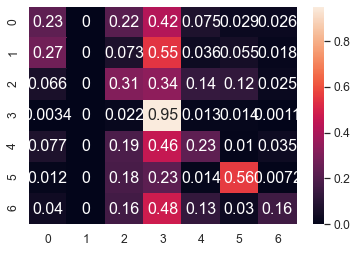

	training epoch=6 .. train_loss=1.285
	validation epoch=6 .. val_loss=1.507
	Accuracy = 44.0 % .. Percision = 41.4 % .. Recall = 34.8 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_6.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 7 .. loss = 1.398


  0%|                                                                                 | 1/1914 [00:01<38:33,  1.21s/it]

training @ epoch 7 .. loss = 1.355


  0%|                                                                                 | 2/1914 [00:02<38:24,  1.21s/it]

training @ epoch 7 .. loss = 1.142


  0%|▏                                                                                | 3/1914 [00:03<38:32,  1.21s/it]

training @ epoch 7 .. loss = 1.232


  0%|▏                                                                                | 4/1914 [00:04<37:45,  1.19s/it]

training @ epoch 7 .. loss = 1.702


  0%|▏                                                                                | 5/1914 [00:05<38:00,  1.19s/it]

training @ epoch 7 .. loss = 1.487


  0%|▎                                                                                | 6/1914 [00:07<37:55,  1.19s/it]

training @ epoch 7 .. loss = 1.398


  0%|▎                                                                                | 7/1914 [00:08<37:30,  1.18s/it]

training @ epoch 7 .. loss = 1.792


  0%|▎                                                                                | 8/1914 [00:09<37:54,  1.19s/it]

training @ epoch 7 .. loss = 0.964


  0%|▍                                                                                | 9/1914 [00:10<37:41,  1.19s/it]

training @ epoch 7 .. loss = 1.316


  1%|▍                                                                               | 10/1914 [00:11<37:32,  1.18s/it]

training @ epoch 7 .. loss = 1.186


  1%|▍                                                                               | 11/1914 [00:13<37:42,  1.19s/it]

training @ epoch 7 .. loss = 1.606


  1%|▌                                                                               | 12/1914 [00:14<37:44,  1.19s/it]

training @ epoch 7 .. loss = 0.864


  1%|▌                                                                               | 13/1914 [00:15<38:16,  1.21s/it]

training @ epoch 7 .. loss = 1.237


  1%|▌                                                                               | 14/1914 [00:16<37:53,  1.20s/it]

training @ epoch 7 .. loss = 1.095


  1%|▋                                                                               | 15/1914 [00:17<37:44,  1.19s/it]

training @ epoch 7 .. loss = 1.355


  1%|▋                                                                               | 16/1914 [00:19<37:37,  1.19s/it]

training @ epoch 7 .. loss = 1.148


  1%|▋                                                                               | 17/1914 [00:20<37:15,  1.18s/it]

training @ epoch 7 .. loss = 1.239


  1%|▊                                                                               | 18/1914 [00:21<37:11,  1.18s/it]

training @ epoch 7 .. loss = 1.151


  1%|▊                                                                               | 19/1914 [00:22<37:07,  1.18s/it]

training @ epoch 7 .. loss = 1.897


  1%|▊                                                                               | 20/1914 [00:23<37:20,  1.18s/it]

training @ epoch 7 .. loss = 1.098


  1%|▉                                                                               | 21/1914 [00:24<37:03,  1.17s/it]

training @ epoch 7 .. loss = 1.086


  1%|▉                                                                               | 22/1914 [00:26<37:12,  1.18s/it]

training @ epoch 7 .. loss = 0.925


  1%|▉                                                                               | 23/1914 [00:27<37:23,  1.19s/it]

training @ epoch 7 .. loss = 1.51


  1%|█                                                                               | 24/1914 [00:28<37:14,  1.18s/it]

training @ epoch 7 .. loss = 1.818


  1%|█                                                                               | 25/1914 [00:29<37:36,  1.19s/it]

training @ epoch 7 .. loss = 1.038


  1%|█                                                                               | 26/1914 [00:30<37:48,  1.20s/it]

training @ epoch 7 .. loss = 1.072


  1%|█▏                                                                              | 27/1914 [00:32<37:37,  1.20s/it]

training @ epoch 7 .. loss = 1.519


  1%|█▏                                                                              | 28/1914 [00:33<38:30,  1.22s/it]

training @ epoch 7 .. loss = 1.12


  2%|█▏                                                                              | 29/1914 [00:34<38:32,  1.23s/it]

training @ epoch 7 .. loss = 1.417


  2%|█▎                                                                              | 30/1914 [00:35<38:29,  1.23s/it]

training @ epoch 7 .. loss = 1.31


  2%|█▎                                                                              | 31/1914 [00:37<37:55,  1.21s/it]

training @ epoch 7 .. loss = 1.319


  2%|█▎                                                                              | 32/1914 [00:38<37:22,  1.19s/it]

training @ epoch 7 .. loss = 1.131


  2%|█▍                                                                              | 33/1914 [00:39<37:33,  1.20s/it]

training @ epoch 7 .. loss = 0.99


  2%|█▍                                                                              | 34/1914 [00:40<37:20,  1.19s/it]

training @ epoch 7 .. loss = 0.882


  2%|█▍                                                                              | 35/1914 [00:41<37:11,  1.19s/it]

training @ epoch 7 .. loss = 0.905


  2%|█▌                                                                              | 36/1914 [00:42<36:56,  1.18s/it]

training @ epoch 7 .. loss = 1.703


  2%|█▌                                                                              | 37/1914 [00:44<36:54,  1.18s/it]

training @ epoch 7 .. loss = 1.044


  2%|█▌                                                                              | 38/1914 [00:45<37:12,  1.19s/it]

training @ epoch 7 .. loss = 1.693


  2%|█▋                                                                              | 39/1914 [00:46<36:49,  1.18s/it]

training @ epoch 7 .. loss = 0.874


  2%|█▋                                                                              | 40/1914 [00:47<36:57,  1.18s/it]

training @ epoch 7 .. loss = 0.973


  2%|█▋                                                                              | 41/1914 [00:48<36:41,  1.18s/it]

training @ epoch 7 .. loss = 1.366


  2%|█▊                                                                              | 42/1914 [00:49<36:39,  1.18s/it]

training @ epoch 7 .. loss = 1.258


  2%|█▊                                                                              | 43/1914 [00:51<36:59,  1.19s/it]

training @ epoch 7 .. loss = 1.141


  2%|█▊                                                                              | 44/1914 [00:52<36:42,  1.18s/it]

training @ epoch 7 .. loss = 0.96


  2%|█▉                                                                              | 45/1914 [00:53<37:56,  1.22s/it]

training @ epoch 7 .. loss = 1.491


  2%|█▉                                                                              | 46/1914 [00:55<39:21,  1.26s/it]

training @ epoch 7 .. loss = 1.462


  2%|█▉                                                                              | 47/1914 [00:56<41:47,  1.34s/it]

training @ epoch 7 .. loss = 0.894


  3%|██                                                                              | 48/1914 [00:58<43:30,  1.40s/it]

training @ epoch 7 .. loss = 0.895


  3%|██                                                                              | 49/1914 [00:59<44:41,  1.44s/it]

training @ epoch 7 .. loss = 0.9


  3%|██                                                                              | 50/1914 [01:01<45:03,  1.45s/it]

training @ epoch 7 .. loss = 1.498


  3%|██▏                                                                             | 51/1914 [01:02<44:54,  1.45s/it]

training @ epoch 7 .. loss = 0.919


  3%|██▏                                                                             | 52/1914 [01:04<45:07,  1.45s/it]

training @ epoch 7 .. loss = 1.141


  3%|██▏                                                                             | 53/1914 [01:05<44:15,  1.43s/it]

training @ epoch 7 .. loss = 1.071


  3%|██▎                                                                             | 54/1914 [01:06<42:59,  1.39s/it]

training @ epoch 7 .. loss = 1.259


  3%|██▎                                                                             | 55/1914 [01:07<42:06,  1.36s/it]

training @ epoch 7 .. loss = 1.467


  3%|██▎                                                                             | 56/1914 [01:09<41:17,  1.33s/it]

training @ epoch 7 .. loss = 1.17


  3%|██▍                                                                             | 57/1914 [01:10<41:28,  1.34s/it]

training @ epoch 7 .. loss = 1.153


  3%|██▍                                                                             | 58/1914 [01:12<42:11,  1.36s/it]

training @ epoch 7 .. loss = 1.029


  3%|██▍                                                                             | 59/1914 [01:13<42:38,  1.38s/it]

training @ epoch 7 .. loss = 1.052


  3%|██▌                                                                             | 60/1914 [01:14<42:40,  1.38s/it]

training @ epoch 7 .. loss = 0.976


  3%|██▌                                                                             | 61/1914 [01:16<41:01,  1.33s/it]

training @ epoch 7 .. loss = 0.919


  3%|██▌                                                                             | 62/1914 [01:17<39:33,  1.28s/it]

training @ epoch 7 .. loss = 1.235


  3%|██▋                                                                             | 63/1914 [01:18<38:24,  1.24s/it]

training @ epoch 7 .. loss = 1.259


  3%|██▋                                                                             | 64/1914 [01:19<38:06,  1.24s/it]

training @ epoch 7 .. loss = 1.181


  3%|██▋                                                                             | 65/1914 [01:20<37:13,  1.21s/it]

training @ epoch 7 .. loss = 1.519


  3%|██▊                                                                             | 66/1914 [01:21<36:51,  1.20s/it]

training @ epoch 7 .. loss = 1.066


  4%|██▊                                                                             | 67/1914 [01:23<36:48,  1.20s/it]

training @ epoch 7 .. loss = 1.552


  4%|██▊                                                                             | 68/1914 [01:24<36:33,  1.19s/it]

training @ epoch 7 .. loss = 1.377


  4%|██▉                                                                             | 69/1914 [01:25<36:12,  1.18s/it]

training @ epoch 7 .. loss = 0.776


  4%|██▉                                                                             | 70/1914 [01:26<36:00,  1.17s/it]

training @ epoch 7 .. loss = 0.835


  4%|██▉                                                                             | 71/1914 [01:27<36:17,  1.18s/it]

training @ epoch 7 .. loss = 1.49


  4%|███                                                                             | 72/1914 [01:28<36:08,  1.18s/it]

training @ epoch 7 .. loss = 0.892


  4%|███                                                                             | 73/1914 [01:30<35:59,  1.17s/it]

training @ epoch 7 .. loss = 1.183


  4%|███                                                                             | 74/1914 [01:31<36:31,  1.19s/it]

training @ epoch 7 .. loss = 1.182


  4%|███▏                                                                            | 75/1914 [01:32<36:16,  1.18s/it]

training @ epoch 7 .. loss = 1.209


  4%|███▏                                                                            | 76/1914 [01:33<36:37,  1.20s/it]

training @ epoch 7 .. loss = 1.447


  4%|███▏                                                                            | 77/1914 [01:34<36:17,  1.19s/it]

training @ epoch 7 .. loss = 1.472


  4%|███▎                                                                            | 78/1914 [01:36<36:03,  1.18s/it]

training @ epoch 7 .. loss = 1.084


  4%|███▎                                                                            | 79/1914 [01:37<36:14,  1.18s/it]

training @ epoch 7 .. loss = 1.21


  4%|███▎                                                                            | 80/1914 [01:38<36:01,  1.18s/it]

training @ epoch 7 .. loss = 1.165


  4%|███▍                                                                            | 81/1914 [01:39<36:30,  1.20s/it]

training @ epoch 7 .. loss = 1.249


  4%|███▍                                                                            | 82/1914 [01:40<35:52,  1.18s/it]

training @ epoch 7 .. loss = 1.193


  4%|███▍                                                                            | 83/1914 [01:41<36:21,  1.19s/it]

training @ epoch 7 .. loss = 1.351


  4%|███▌                                                                            | 84/1914 [01:43<38:51,  1.27s/it]

training @ epoch 7 .. loss = 0.985


  4%|███▌                                                                            | 85/1914 [01:44<39:29,  1.30s/it]

training @ epoch 7 .. loss = 0.791


  4%|███▌                                                                            | 86/1914 [01:46<40:21,  1.32s/it]

training @ epoch 7 .. loss = 0.693


  5%|███▋                                                                            | 87/1914 [01:47<38:56,  1.28s/it]

training @ epoch 7 .. loss = 1.215


  5%|███▋                                                                            | 88/1914 [01:48<37:47,  1.24s/it]

training @ epoch 7 .. loss = 1.395


  5%|███▋                                                                            | 89/1914 [01:49<37:40,  1.24s/it]

training @ epoch 7 .. loss = 1.444


  5%|███▊                                                                            | 90/1914 [01:50<37:15,  1.23s/it]

training @ epoch 7 .. loss = 1.137


  5%|███▊                                                                            | 91/1914 [01:52<36:28,  1.20s/it]

training @ epoch 7 .. loss = 1.732


  5%|███▊                                                                            | 92/1914 [01:53<36:14,  1.19s/it]

training @ epoch 7 .. loss = 1.252


  5%|███▉                                                                            | 93/1914 [01:54<35:35,  1.17s/it]

training @ epoch 7 .. loss = 1.224


  5%|███▉                                                                            | 94/1914 [01:55<35:38,  1.17s/it]

training @ epoch 7 .. loss = 1.412


  5%|███▉                                                                            | 95/1914 [01:56<35:52,  1.18s/it]

training @ epoch 7 .. loss = 1.466


  5%|████                                                                            | 96/1914 [01:57<35:42,  1.18s/it]

training @ epoch 7 .. loss = 1.432


  5%|████                                                                            | 97/1914 [01:59<35:36,  1.18s/it]

training @ epoch 7 .. loss = 0.616


  5%|████                                                                            | 98/1914 [02:00<34:50,  1.15s/it]

training @ epoch 7 .. loss = 0.912


  5%|████▏                                                                           | 99/1914 [02:01<35:05,  1.16s/it]

training @ epoch 7 .. loss = 1.988


  5%|████▏                                                                          | 100/1914 [02:02<35:09,  1.16s/it]

training @ epoch 7 .. loss = 1.021


  5%|████▏                                                                          | 101/1914 [02:03<35:34,  1.18s/it]

training @ epoch 7 .. loss = 1.385


  5%|████▏                                                                          | 102/1914 [02:04<35:23,  1.17s/it]

training @ epoch 7 .. loss = 1.7


  5%|████▎                                                                          | 103/1914 [02:06<35:11,  1.17s/it]

training @ epoch 7 .. loss = 1.903


  5%|████▎                                                                          | 104/1914 [02:07<35:14,  1.17s/it]

training @ epoch 7 .. loss = 1.403


  5%|████▎                                                                          | 105/1914 [02:08<35:16,  1.17s/it]

training @ epoch 7 .. loss = 0.865


  6%|████▍                                                                          | 106/1914 [02:09<35:32,  1.18s/it]

training @ epoch 7 .. loss = 1.757


  6%|████▍                                                                          | 107/1914 [02:10<36:00,  1.20s/it]

training @ epoch 7 .. loss = 1.142


  6%|████▍                                                                          | 108/1914 [02:12<35:51,  1.19s/it]

training @ epoch 7 .. loss = 1.073


  6%|████▍                                                                          | 109/1914 [02:13<35:34,  1.18s/it]

training @ epoch 7 .. loss = 1.381


  6%|████▌                                                                          | 110/1914 [02:14<35:15,  1.17s/it]

training @ epoch 7 .. loss = 0.974


  6%|████▌                                                                          | 111/1914 [02:15<35:48,  1.19s/it]

training @ epoch 7 .. loss = 1.026


  6%|████▌                                                                          | 112/1914 [02:16<35:42,  1.19s/it]

training @ epoch 7 .. loss = 1.007


  6%|████▋                                                                          | 113/1914 [02:17<35:53,  1.20s/it]

training @ epoch 7 .. loss = 1.193


  6%|████▋                                                                          | 114/1914 [02:19<35:23,  1.18s/it]

training @ epoch 7 .. loss = 1.21


  6%|████▋                                                                          | 115/1914 [02:20<35:18,  1.18s/it]

training @ epoch 7 .. loss = 1.186


  6%|████▊                                                                          | 116/1914 [02:21<35:19,  1.18s/it]

training @ epoch 7 .. loss = 0.926


  6%|████▊                                                                          | 117/1914 [02:22<35:31,  1.19s/it]

training @ epoch 7 .. loss = 1.24


  6%|████▊                                                                          | 118/1914 [02:23<35:33,  1.19s/it]

training @ epoch 7 .. loss = 1.111


  6%|████▉                                                                          | 119/1914 [02:25<35:18,  1.18s/it]

training @ epoch 7 .. loss = 1.121


  6%|████▉                                                                          | 120/1914 [02:26<35:35,  1.19s/it]

training @ epoch 7 .. loss = 1.465


  6%|████▉                                                                          | 121/1914 [02:27<35:35,  1.19s/it]

training @ epoch 7 .. loss = 0.893


  6%|█████                                                                          | 122/1914 [02:28<35:29,  1.19s/it]

training @ epoch 7 .. loss = 1.319


  6%|█████                                                                          | 123/1914 [02:29<35:40,  1.20s/it]

training @ epoch 7 .. loss = 1.239


  6%|█████                                                                          | 124/1914 [02:30<35:16,  1.18s/it]

training @ epoch 7 .. loss = 1.614


  7%|█████▏                                                                         | 125/1914 [02:32<34:48,  1.17s/it]

training @ epoch 7 .. loss = 1.167


  7%|█████▏                                                                         | 126/1914 [02:33<34:40,  1.16s/it]

training @ epoch 7 .. loss = 1.366


  7%|█████▏                                                                         | 127/1914 [02:34<34:21,  1.15s/it]

training @ epoch 7 .. loss = 1.82


  7%|█████▎                                                                         | 128/1914 [02:35<34:47,  1.17s/it]

training @ epoch 7 .. loss = 1.406


  7%|█████▎                                                                         | 129/1914 [02:36<35:05,  1.18s/it]

training @ epoch 7 .. loss = 1.56


  7%|█████▎                                                                         | 130/1914 [02:38<35:15,  1.19s/it]

training @ epoch 7 .. loss = 1.447


  7%|█████▍                                                                         | 131/1914 [02:39<34:56,  1.18s/it]

training @ epoch 7 .. loss = 1.041


  7%|█████▍                                                                         | 132/1914 [02:40<34:41,  1.17s/it]

training @ epoch 7 .. loss = 1.939


  7%|█████▍                                                                         | 133/1914 [02:41<34:43,  1.17s/it]

training @ epoch 7 .. loss = 1.194


  7%|█████▌                                                                         | 134/1914 [02:42<34:43,  1.17s/it]

training @ epoch 7 .. loss = 1.064


  7%|█████▌                                                                         | 135/1914 [02:43<35:07,  1.18s/it]

training @ epoch 7 .. loss = 1.034


  7%|█████▌                                                                         | 136/1914 [02:45<34:55,  1.18s/it]

training @ epoch 7 .. loss = 0.77


  7%|█████▋                                                                         | 137/1914 [02:46<34:29,  1.16s/it]

training @ epoch 7 .. loss = 1.017


  7%|█████▋                                                                         | 138/1914 [02:47<34:43,  1.17s/it]

training @ epoch 7 .. loss = 0.985


  7%|█████▋                                                                         | 139/1914 [02:48<34:58,  1.18s/it]

training @ epoch 7 .. loss = 1.079


  7%|█████▊                                                                         | 140/1914 [02:49<35:23,  1.20s/it]

training @ epoch 7 .. loss = 1.427


  7%|█████▊                                                                         | 141/1914 [02:50<35:10,  1.19s/it]

training @ epoch 7 .. loss = 1.163


  7%|█████▊                                                                         | 142/1914 [02:52<34:41,  1.17s/it]

training @ epoch 7 .. loss = 1.494


  7%|█████▉                                                                         | 143/1914 [02:53<34:34,  1.17s/it]

training @ epoch 7 .. loss = 1.089


  8%|█████▉                                                                         | 144/1914 [02:54<34:19,  1.16s/it]

training @ epoch 7 .. loss = 1.068


  8%|█████▉                                                                         | 145/1914 [02:55<34:41,  1.18s/it]

training @ epoch 7 .. loss = 1.841


  8%|██████                                                                         | 146/1914 [02:56<34:48,  1.18s/it]

training @ epoch 7 .. loss = 1.235


  8%|██████                                                                         | 147/1914 [02:57<34:42,  1.18s/it]

training @ epoch 7 .. loss = 1.433


  8%|██████                                                                         | 148/1914 [02:59<34:23,  1.17s/it]

training @ epoch 7 .. loss = 0.975


  8%|██████▏                                                                        | 149/1914 [03:00<34:50,  1.18s/it]

training @ epoch 7 .. loss = 1.691


  8%|██████▏                                                                        | 150/1914 [03:01<34:59,  1.19s/it]

training @ epoch 7 .. loss = 1.372


  8%|██████▏                                                                        | 151/1914 [03:02<35:14,  1.20s/it]

training @ epoch 7 .. loss = 1.157


  8%|██████▎                                                                        | 152/1914 [03:03<34:59,  1.19s/it]

training @ epoch 7 .. loss = 1.193


  8%|██████▎                                                                        | 153/1914 [03:05<34:39,  1.18s/it]

training @ epoch 7 .. loss = 1.265


  8%|██████▎                                                                        | 154/1914 [03:06<34:14,  1.17s/it]

training @ epoch 7 .. loss = 1.755


  8%|██████▍                                                                        | 155/1914 [03:07<34:15,  1.17s/it]

training @ epoch 7 .. loss = 1.279


  8%|██████▍                                                                        | 156/1914 [03:08<34:17,  1.17s/it]

training @ epoch 7 .. loss = 1.569


  8%|██████▍                                                                        | 157/1914 [03:09<34:54,  1.19s/it]

training @ epoch 7 .. loss = 1.38


  8%|██████▌                                                                        | 158/1914 [03:11<34:53,  1.19s/it]

training @ epoch 7 .. loss = 1.267


  8%|██████▌                                                                        | 159/1914 [03:12<34:20,  1.17s/it]

training @ epoch 7 .. loss = 1.201


  8%|██████▌                                                                        | 160/1914 [03:13<34:39,  1.19s/it]

training @ epoch 7 .. loss = 0.989


  8%|██████▋                                                                        | 161/1914 [03:14<34:41,  1.19s/it]

training @ epoch 7 .. loss = 1.068


  8%|██████▋                                                                        | 162/1914 [03:15<34:53,  1.19s/it]

training @ epoch 7 .. loss = 1.144


  9%|██████▋                                                                        | 163/1914 [03:16<34:29,  1.18s/it]

training @ epoch 7 .. loss = 1.351


  9%|██████▊                                                                        | 164/1914 [03:18<34:32,  1.18s/it]

training @ epoch 7 .. loss = 1.133


  9%|██████▊                                                                        | 165/1914 [03:19<34:25,  1.18s/it]

training @ epoch 7 .. loss = 1.083


  9%|██████▊                                                                        | 166/1914 [03:20<34:02,  1.17s/it]

training @ epoch 7 .. loss = 1.272


  9%|██████▉                                                                        | 167/1914 [03:21<34:23,  1.18s/it]

training @ epoch 7 .. loss = 1.435


  9%|██████▉                                                                        | 168/1914 [03:22<34:32,  1.19s/it]

training @ epoch 7 .. loss = 0.849


  9%|██████▉                                                                        | 169/1914 [03:23<34:13,  1.18s/it]

training @ epoch 7 .. loss = 1.329


  9%|███████                                                                        | 170/1914 [03:25<34:15,  1.18s/it]

training @ epoch 7 .. loss = 0.896


  9%|███████                                                                        | 171/1914 [03:26<34:05,  1.17s/it]

training @ epoch 7 .. loss = 1.728


  9%|███████                                                                        | 172/1914 [03:27<33:58,  1.17s/it]

training @ epoch 7 .. loss = 1.642


  9%|███████▏                                                                       | 173/1914 [03:28<34:10,  1.18s/it]

training @ epoch 7 .. loss = 0.742


  9%|███████▏                                                                       | 174/1914 [03:29<34:07,  1.18s/it]

training @ epoch 7 .. loss = 1.354


  9%|███████▏                                                                       | 175/1914 [03:31<35:11,  1.21s/it]

training @ epoch 7 .. loss = 1.327


  9%|███████▎                                                                       | 176/1914 [03:32<36:13,  1.25s/it]

training @ epoch 7 .. loss = 1.031


  9%|███████▎                                                                       | 177/1914 [03:33<36:34,  1.26s/it]

training @ epoch 7 .. loss = 0.96


  9%|███████▎                                                                       | 178/1914 [03:35<36:27,  1.26s/it]

training @ epoch 7 .. loss = 1.208


  9%|███████▍                                                                       | 179/1914 [03:36<36:12,  1.25s/it]

training @ epoch 7 .. loss = 1.043


  9%|███████▍                                                                       | 180/1914 [03:37<36:27,  1.26s/it]

training @ epoch 7 .. loss = 1.231


  9%|███████▍                                                                       | 181/1914 [03:38<36:31,  1.26s/it]

training @ epoch 7 .. loss = 1.117


 10%|███████▌                                                                       | 182/1914 [03:40<36:13,  1.25s/it]

training @ epoch 7 .. loss = 0.989


 10%|███████▌                                                                       | 183/1914 [03:41<36:31,  1.27s/it]

training @ epoch 7 .. loss = 1.069


 10%|███████▌                                                                       | 184/1914 [03:42<36:29,  1.27s/it]

training @ epoch 7 .. loss = 0.66


 10%|███████▋                                                                       | 185/1914 [03:43<36:42,  1.27s/it]

training @ epoch 7 .. loss = 1.378


 10%|███████▋                                                                       | 186/1914 [03:45<36:24,  1.26s/it]

training @ epoch 7 .. loss = 1.078


 10%|███████▋                                                                       | 187/1914 [03:46<36:27,  1.27s/it]

training @ epoch 7 .. loss = 1.293


 10%|███████▊                                                                       | 188/1914 [03:47<36:45,  1.28s/it]

training @ epoch 7 .. loss = 1.459


 10%|███████▊                                                                       | 189/1914 [03:49<36:40,  1.28s/it]

training @ epoch 7 .. loss = 1.612


 10%|███████▊                                                                       | 190/1914 [03:50<36:54,  1.28s/it]

training @ epoch 7 .. loss = 1.171


 10%|███████▉                                                                       | 191/1914 [03:51<37:13,  1.30s/it]

training @ epoch 7 .. loss = 1.382


 10%|███████▉                                                                       | 192/1914 [03:52<36:55,  1.29s/it]

training @ epoch 7 .. loss = 1.571


 10%|███████▉                                                                       | 193/1914 [03:54<36:30,  1.27s/it]

training @ epoch 7 .. loss = 1.402


 10%|████████                                                                       | 194/1914 [03:55<36:44,  1.28s/it]

training @ epoch 7 .. loss = 1.244


 10%|████████                                                                       | 195/1914 [03:56<36:54,  1.29s/it]

training @ epoch 7 .. loss = 1.38


 10%|████████                                                                       | 196/1914 [03:58<36:34,  1.28s/it]

training @ epoch 7 .. loss = 1.219


 10%|████████▏                                                                      | 197/1914 [03:59<36:41,  1.28s/it]

training @ epoch 7 .. loss = 1.097


 10%|████████▏                                                                      | 198/1914 [04:00<36:29,  1.28s/it]

training @ epoch 7 .. loss = 1.707


 10%|████████▏                                                                      | 199/1914 [04:01<36:51,  1.29s/it]

training @ epoch 7 .. loss = 1.851


 10%|████████▎                                                                      | 200/1914 [04:03<36:47,  1.29s/it]

training @ epoch 7 .. loss = 1.168


 11%|████████▎                                                                      | 201/1914 [04:04<36:27,  1.28s/it]

training @ epoch 7 .. loss = 1.53


 11%|████████▎                                                                      | 202/1914 [04:05<37:38,  1.32s/it]

training @ epoch 7 .. loss = 1.412


 11%|████████▍                                                                      | 203/1914 [04:07<36:29,  1.28s/it]

training @ epoch 7 .. loss = 1.123


 11%|████████▍                                                                      | 204/1914 [04:08<35:41,  1.25s/it]

training @ epoch 7 .. loss = 0.816


 11%|████████▍                                                                      | 205/1914 [04:09<35:13,  1.24s/it]

training @ epoch 7 .. loss = 1.179


 11%|████████▌                                                                      | 206/1914 [04:10<34:18,  1.21s/it]

training @ epoch 7 .. loss = 0.945


 11%|████████▌                                                                      | 207/1914 [04:11<34:32,  1.21s/it]

training @ epoch 7 .. loss = 1.144


 11%|████████▌                                                                      | 208/1914 [04:12<33:57,  1.19s/it]

training @ epoch 7 .. loss = 1.154


 11%|████████▋                                                                      | 209/1914 [04:14<33:29,  1.18s/it]

training @ epoch 7 .. loss = 1.354


 11%|████████▋                                                                      | 210/1914 [04:15<34:01,  1.20s/it]

training @ epoch 7 .. loss = 1.128


 11%|████████▋                                                                      | 211/1914 [04:16<33:46,  1.19s/it]

training @ epoch 7 .. loss = 1.283


 11%|████████▊                                                                      | 212/1914 [04:17<33:57,  1.20s/it]

training @ epoch 7 .. loss = 1.077


 11%|████████▊                                                                      | 213/1914 [04:18<33:41,  1.19s/it]

training @ epoch 7 .. loss = 0.953


 11%|████████▊                                                                      | 214/1914 [04:20<33:28,  1.18s/it]

training @ epoch 7 .. loss = 1.255


 11%|████████▊                                                                      | 215/1914 [04:21<33:32,  1.18s/it]

training @ epoch 7 .. loss = 0.997


 11%|████████▉                                                                      | 216/1914 [04:22<33:45,  1.19s/it]

training @ epoch 7 .. loss = 1.557


 11%|████████▉                                                                      | 217/1914 [04:23<33:44,  1.19s/it]

training @ epoch 7 .. loss = 0.888


 11%|████████▉                                                                      | 218/1914 [04:24<33:32,  1.19s/it]

training @ epoch 7 .. loss = 1.426


 11%|█████████                                                                      | 219/1914 [04:25<33:18,  1.18s/it]

training @ epoch 7 .. loss = 0.783


 11%|█████████                                                                      | 220/1914 [04:27<33:09,  1.17s/it]

training @ epoch 7 .. loss = 1.367


 12%|█████████                                                                      | 221/1914 [04:28<33:05,  1.17s/it]

training @ epoch 7 .. loss = 1.02


 12%|█████████▏                                                                     | 222/1914 [04:29<33:08,  1.18s/it]

training @ epoch 7 .. loss = 1.019


 12%|█████████▏                                                                     | 223/1914 [04:30<33:11,  1.18s/it]

training @ epoch 7 .. loss = 1.408


 12%|█████████▏                                                                     | 224/1914 [04:31<33:12,  1.18s/it]

training @ epoch 7 .. loss = 1.794


 12%|█████████▎                                                                     | 225/1914 [04:32<32:56,  1.17s/it]

training @ epoch 7 .. loss = 0.959


 12%|█████████▎                                                                     | 226/1914 [04:34<32:46,  1.17s/it]

training @ epoch 7 .. loss = 1.192


 12%|█████████▎                                                                     | 227/1914 [04:35<32:59,  1.17s/it]

training @ epoch 7 .. loss = 0.987


 12%|█████████▍                                                                     | 228/1914 [04:36<32:32,  1.16s/it]

training @ epoch 7 .. loss = 1.078


 12%|█████████▍                                                                     | 229/1914 [04:37<33:07,  1.18s/it]

training @ epoch 7 .. loss = 0.977


 12%|█████████▍                                                                     | 230/1914 [04:38<32:58,  1.18s/it]

training @ epoch 7 .. loss = 1.464


 12%|█████████▌                                                                     | 231/1914 [04:40<32:51,  1.17s/it]

training @ epoch 7 .. loss = 1.273


 12%|█████████▌                                                                     | 232/1914 [04:41<32:58,  1.18s/it]

training @ epoch 7 .. loss = 1.537


 12%|█████████▌                                                                     | 233/1914 [04:42<32:51,  1.17s/it]

training @ epoch 7 .. loss = 1.828


 12%|█████████▋                                                                     | 234/1914 [04:43<32:56,  1.18s/it]

training @ epoch 7 .. loss = 1.318


 12%|█████████▋                                                                     | 235/1914 [04:44<32:47,  1.17s/it]

training @ epoch 7 .. loss = 1.255


 12%|█████████▋                                                                     | 236/1914 [04:45<32:52,  1.18s/it]

training @ epoch 7 .. loss = 1.253


 12%|█████████▊                                                                     | 237/1914 [04:47<32:23,  1.16s/it]

training @ epoch 7 .. loss = 1.38


 12%|█████████▊                                                                     | 238/1914 [04:48<32:34,  1.17s/it]

training @ epoch 7 .. loss = 0.803


 12%|█████████▊                                                                     | 239/1914 [04:49<32:49,  1.18s/it]

training @ epoch 7 .. loss = 1.659


 13%|█████████▉                                                                     | 240/1914 [04:50<32:41,  1.17s/it]

training @ epoch 7 .. loss = 0.983


 13%|█████████▉                                                                     | 241/1914 [04:51<33:05,  1.19s/it]

training @ epoch 7 .. loss = 1.589


 13%|█████████▉                                                                     | 242/1914 [04:52<32:42,  1.17s/it]

training @ epoch 7 .. loss = 1.277


 13%|██████████                                                                     | 243/1914 [04:54<32:41,  1.17s/it]

training @ epoch 7 .. loss = 0.827


 13%|██████████                                                                     | 244/1914 [04:55<32:35,  1.17s/it]

training @ epoch 7 .. loss = 1.086


 13%|██████████                                                                     | 245/1914 [04:56<32:29,  1.17s/it]

training @ epoch 7 .. loss = 1.214


 13%|██████████▏                                                                    | 246/1914 [04:57<32:50,  1.18s/it]

training @ epoch 7 .. loss = 0.804


 13%|██████████▏                                                                    | 247/1914 [04:58<32:32,  1.17s/it]

training @ epoch 7 .. loss = 1.272


 13%|██████████▏                                                                    | 248/1914 [04:59<32:27,  1.17s/it]

training @ epoch 7 .. loss = 1.339


 13%|██████████▎                                                                    | 249/1914 [05:01<32:17,  1.16s/it]

training @ epoch 7 .. loss = 1.249


 13%|██████████▎                                                                    | 250/1914 [05:02<32:15,  1.16s/it]

training @ epoch 7 .. loss = 1.068


 13%|██████████▎                                                                    | 251/1914 [05:03<32:26,  1.17s/it]

training @ epoch 7 .. loss = 1.189


 13%|██████████▍                                                                    | 252/1914 [05:04<32:15,  1.16s/it]

training @ epoch 7 .. loss = 1.976


 13%|██████████▍                                                                    | 253/1914 [05:05<32:23,  1.17s/it]

training @ epoch 7 .. loss = 0.838


 13%|██████████▍                                                                    | 254/1914 [05:06<32:26,  1.17s/it]

training @ epoch 7 .. loss = 1.331


 13%|██████████▌                                                                    | 255/1914 [05:08<32:14,  1.17s/it]

training @ epoch 7 .. loss = 1.341


 13%|██████████▌                                                                    | 256/1914 [05:09<32:21,  1.17s/it]

training @ epoch 7 .. loss = 1.363


 13%|██████████▌                                                                    | 257/1914 [05:10<32:00,  1.16s/it]

training @ epoch 7 .. loss = 1.464


 13%|██████████▋                                                                    | 258/1914 [05:11<32:25,  1.18s/it]

training @ epoch 7 .. loss = 1.412


 14%|██████████▋                                                                    | 259/1914 [05:12<32:42,  1.19s/it]

training @ epoch 7 .. loss = 1.363


 14%|██████████▋                                                                    | 260/1914 [05:14<32:35,  1.18s/it]

training @ epoch 7 .. loss = 1.012


 14%|██████████▊                                                                    | 261/1914 [05:15<32:41,  1.19s/it]

training @ epoch 7 .. loss = 1.431


 14%|██████████▊                                                                    | 262/1914 [05:16<32:31,  1.18s/it]

training @ epoch 7 .. loss = 1.583


 14%|██████████▊                                                                    | 263/1914 [05:17<32:45,  1.19s/it]

training @ epoch 7 .. loss = 1.302


 14%|██████████▉                                                                    | 264/1914 [05:18<32:33,  1.18s/it]

training @ epoch 7 .. loss = 1.177


 14%|██████████▉                                                                    | 265/1914 [05:19<32:12,  1.17s/it]

training @ epoch 7 .. loss = 1.592


 14%|██████████▉                                                                    | 266/1914 [05:21<32:05,  1.17s/it]

training @ epoch 7 .. loss = 1.062


 14%|███████████                                                                    | 267/1914 [05:22<31:56,  1.16s/it]

training @ epoch 7 .. loss = 1.65


 14%|███████████                                                                    | 268/1914 [05:23<32:09,  1.17s/it]

training @ epoch 7 .. loss = 1.32


 14%|███████████                                                                    | 269/1914 [05:24<31:37,  1.15s/it]

training @ epoch 7 .. loss = 1.006


 14%|███████████▏                                                                   | 270/1914 [05:25<32:01,  1.17s/it]

training @ epoch 7 .. loss = 2.258


 14%|███████████▏                                                                   | 271/1914 [05:26<31:46,  1.16s/it]

training @ epoch 7 .. loss = 1.053


 14%|███████████▏                                                                   | 272/1914 [05:28<31:50,  1.16s/it]

training @ epoch 7 .. loss = 1.153


 14%|███████████▎                                                                   | 273/1914 [05:29<32:09,  1.18s/it]

training @ epoch 7 .. loss = 0.978


 14%|███████████▎                                                                   | 274/1914 [05:30<31:56,  1.17s/it]

training @ epoch 7 .. loss = 1.166


 14%|███████████▎                                                                   | 275/1914 [05:31<32:04,  1.17s/it]

training @ epoch 7 .. loss = 1.403


 14%|███████████▍                                                                   | 276/1914 [05:32<32:13,  1.18s/it]

training @ epoch 7 .. loss = 1.255


 14%|███████████▍                                                                   | 277/1914 [05:33<32:03,  1.18s/it]

training @ epoch 7 .. loss = 1.103


 15%|███████████▍                                                                   | 278/1914 [05:35<32:07,  1.18s/it]

training @ epoch 7 .. loss = 0.78


 15%|███████████▌                                                                   | 279/1914 [05:36<31:43,  1.16s/it]

training @ epoch 7 .. loss = 1.11


 15%|███████████▌                                                                   | 280/1914 [05:37<32:05,  1.18s/it]

training @ epoch 7 .. loss = 1.181


 15%|███████████▌                                                                   | 281/1914 [05:38<32:15,  1.19s/it]

training @ epoch 7 .. loss = 1.431


 15%|███████████▋                                                                   | 282/1914 [05:39<32:03,  1.18s/it]

training @ epoch 7 .. loss = 1.279


 15%|███████████▋                                                                   | 283/1914 [05:41<31:58,  1.18s/it]

training @ epoch 7 .. loss = 1.396


 15%|███████████▋                                                                   | 284/1914 [05:42<31:40,  1.17s/it]

training @ epoch 7 .. loss = 1.065


 15%|███████████▊                                                                   | 285/1914 [05:43<31:42,  1.17s/it]

training @ epoch 7 .. loss = 1.136


 15%|███████████▊                                                                   | 286/1914 [05:44<31:22,  1.16s/it]

training @ epoch 7 .. loss = 1.5


 15%|███████████▊                                                                   | 287/1914 [05:45<31:38,  1.17s/it]

training @ epoch 7 .. loss = 1.296


 15%|███████████▉                                                                   | 288/1914 [05:46<31:40,  1.17s/it]

training @ epoch 7 .. loss = 2.054


 15%|███████████▉                                                                   | 289/1914 [05:48<31:50,  1.18s/it]

training @ epoch 7 .. loss = 1.302


 15%|███████████▉                                                                   | 290/1914 [05:49<31:28,  1.16s/it]

training @ epoch 7 .. loss = 1.207


 15%|████████████                                                                   | 291/1914 [05:50<31:31,  1.17s/it]

training @ epoch 7 .. loss = 1.462


 15%|████████████                                                                   | 292/1914 [05:51<31:44,  1.17s/it]

training @ epoch 7 .. loss = 1.078


 15%|████████████                                                                   | 293/1914 [05:52<31:37,  1.17s/it]

training @ epoch 7 .. loss = 1.498


 15%|████████████▏                                                                  | 294/1914 [05:53<31:46,  1.18s/it]

training @ epoch 7 .. loss = 1.631


 15%|████████████▏                                                                  | 295/1914 [05:55<31:28,  1.17s/it]

training @ epoch 7 .. loss = 1.249


 15%|████████████▏                                                                  | 296/1914 [05:56<31:10,  1.16s/it]

training @ epoch 7 .. loss = 1.103


 16%|████████████▎                                                                  | 297/1914 [05:57<31:33,  1.17s/it]

training @ epoch 7 .. loss = 1.346


 16%|████████████▎                                                                  | 298/1914 [05:58<31:43,  1.18s/it]

training @ epoch 7 .. loss = 0.913


 16%|████████████▎                                                                  | 299/1914 [05:59<32:13,  1.20s/it]

training @ epoch 7 .. loss = 1.266


 16%|████████████▍                                                                  | 300/1914 [06:00<31:35,  1.17s/it]

training @ epoch 7 .. loss = 0.917


 16%|████████████▍                                                                  | 301/1914 [06:02<31:19,  1.17s/it]

training @ epoch 7 .. loss = 1.514


 16%|████████████▍                                                                  | 302/1914 [06:03<31:31,  1.17s/it]

training @ epoch 7 .. loss = 1.461


 16%|████████████▌                                                                  | 303/1914 [06:04<31:14,  1.16s/it]

training @ epoch 7 .. loss = 1.355


 16%|████████████▌                                                                  | 304/1914 [06:05<31:23,  1.17s/it]

training @ epoch 7 .. loss = 1.568


 16%|████████████▌                                                                  | 305/1914 [06:06<31:13,  1.16s/it]

training @ epoch 7 .. loss = 1.22


 16%|████████████▋                                                                  | 306/1914 [06:07<31:31,  1.18s/it]

training @ epoch 7 .. loss = 1.21


 16%|████████████▋                                                                  | 307/1914 [06:09<31:27,  1.17s/it]

training @ epoch 7 .. loss = 1.167


 16%|████████████▋                                                                  | 308/1914 [06:10<31:10,  1.16s/it]

training @ epoch 7 .. loss = 1.409


 16%|████████████▊                                                                  | 309/1914 [06:11<31:27,  1.18s/it]

training @ epoch 7 .. loss = 1.488


 16%|████████████▊                                                                  | 310/1914 [06:12<31:38,  1.18s/it]

training @ epoch 7 .. loss = 1.691


 16%|████████████▊                                                                  | 311/1914 [06:13<31:56,  1.20s/it]

training @ epoch 7 .. loss = 1.351


 16%|████████████▉                                                                  | 312/1914 [06:14<31:28,  1.18s/it]

training @ epoch 7 .. loss = 1.292


 16%|████████████▉                                                                  | 313/1914 [06:16<31:14,  1.17s/it]

training @ epoch 7 .. loss = 1.312


 16%|████████████▉                                                                  | 314/1914 [06:17<31:32,  1.18s/it]

training @ epoch 7 .. loss = 1.141


 16%|█████████████                                                                  | 315/1914 [06:18<31:22,  1.18s/it]

training @ epoch 7 .. loss = 0.844


 17%|█████████████                                                                  | 316/1914 [06:19<31:42,  1.19s/it]

training @ epoch 7 .. loss = 1.214


 17%|█████████████                                                                  | 317/1914 [06:20<31:17,  1.18s/it]

training @ epoch 7 .. loss = 1.025


 17%|█████████████▏                                                                 | 318/1914 [06:22<31:04,  1.17s/it]

training @ epoch 7 .. loss = 0.854


 17%|█████████████▏                                                                 | 319/1914 [06:23<31:15,  1.18s/it]

training @ epoch 7 .. loss = 1.218


 17%|█████████████▏                                                                 | 320/1914 [06:24<30:57,  1.17s/it]

training @ epoch 7 .. loss = 1.721


 17%|█████████████▏                                                                 | 321/1914 [06:25<31:05,  1.17s/it]

training @ epoch 7 .. loss = 1.132


 17%|█████████████▎                                                                 | 322/1914 [06:26<31:58,  1.21s/it]

training @ epoch 7 .. loss = 1.464


 17%|█████████████▎                                                                 | 323/1914 [06:27<31:30,  1.19s/it]

training @ epoch 7 .. loss = 1.238


 17%|█████████████▎                                                                 | 324/1914 [06:29<31:55,  1.20s/it]

training @ epoch 7 .. loss = 1.271


 17%|█████████████▍                                                                 | 325/1914 [06:30<31:47,  1.20s/it]

training @ epoch 7 .. loss = 1.171


 17%|█████████████▍                                                                 | 326/1914 [06:31<31:34,  1.19s/it]

training @ epoch 7 .. loss = 1.371


 17%|█████████████▍                                                                 | 327/1914 [06:32<31:29,  1.19s/it]

training @ epoch 7 .. loss = 1.269


 17%|█████████████▌                                                                 | 328/1914 [06:33<31:19,  1.18s/it]

training @ epoch 7 .. loss = 0.858


 17%|█████████████▌                                                                 | 329/1914 [06:35<31:07,  1.18s/it]

training @ epoch 7 .. loss = 1.22


 17%|█████████████▌                                                                 | 330/1914 [06:36<30:58,  1.17s/it]

training @ epoch 7 .. loss = 0.875


 17%|█████████████▋                                                                 | 331/1914 [06:37<30:56,  1.17s/it]

training @ epoch 7 .. loss = 1.683


 17%|█████████████▋                                                                 | 332/1914 [06:38<31:08,  1.18s/it]

training @ epoch 7 .. loss = 0.914


 17%|█████████████▋                                                                 | 333/1914 [06:39<31:12,  1.18s/it]

training @ epoch 7 .. loss = 1.16


 17%|█████████████▊                                                                 | 334/1914 [06:41<31:10,  1.18s/it]

training @ epoch 7 .. loss = 1.159


 18%|█████████████▊                                                                 | 335/1914 [06:42<30:58,  1.18s/it]

training @ epoch 7 .. loss = 1.189


 18%|█████████████▊                                                                 | 336/1914 [06:43<31:02,  1.18s/it]

training @ epoch 7 .. loss = 1.439


 18%|█████████████▉                                                                 | 337/1914 [06:44<31:02,  1.18s/it]

training @ epoch 7 .. loss = 1.319


 18%|█████████████▉                                                                 | 338/1914 [06:45<31:08,  1.19s/it]

training @ epoch 7 .. loss = 1.149


 18%|█████████████▉                                                                 | 339/1914 [06:46<30:45,  1.17s/it]

training @ epoch 7 .. loss = 1.211


 18%|██████████████                                                                 | 340/1914 [06:48<30:26,  1.16s/it]

training @ epoch 7 .. loss = 1.575


 18%|██████████████                                                                 | 341/1914 [06:49<30:31,  1.16s/it]

training @ epoch 7 .. loss = 1.018


 18%|██████████████                                                                 | 342/1914 [06:50<30:32,  1.17s/it]

training @ epoch 7 .. loss = 1.424


 18%|██████████████▏                                                                | 343/1914 [06:51<30:29,  1.16s/it]

training @ epoch 7 .. loss = 1.063


 18%|██████████████▏                                                                | 344/1914 [06:52<30:36,  1.17s/it]

training @ epoch 7 .. loss = 1.613


 18%|██████████████▏                                                                | 345/1914 [06:53<30:42,  1.17s/it]

training @ epoch 7 .. loss = 1.423


 18%|██████████████▎                                                                | 346/1914 [06:55<30:36,  1.17s/it]

training @ epoch 7 .. loss = 1.13


 18%|██████████████▎                                                                | 347/1914 [06:56<30:22,  1.16s/it]

training @ epoch 7 .. loss = 1.401


 18%|██████████████▎                                                                | 348/1914 [06:57<30:22,  1.16s/it]

training @ epoch 7 .. loss = 1.488


 18%|██████████████▍                                                                | 349/1914 [06:58<30:27,  1.17s/it]

training @ epoch 7 .. loss = 1.553


 18%|██████████████▍                                                                | 350/1914 [06:59<30:51,  1.18s/it]

training @ epoch 7 .. loss = 1.401


 18%|██████████████▍                                                                | 351/1914 [07:00<30:30,  1.17s/it]

training @ epoch 7 .. loss = 1.158


 18%|██████████████▌                                                                | 352/1914 [07:02<30:20,  1.17s/it]

training @ epoch 7 .. loss = 0.922


 18%|██████████████▌                                                                | 353/1914 [07:03<30:45,  1.18s/it]

training @ epoch 7 .. loss = 1.226


 18%|██████████████▌                                                                | 354/1914 [07:04<30:25,  1.17s/it]

training @ epoch 7 .. loss = 1.287


 19%|██████████████▋                                                                | 355/1914 [07:05<30:49,  1.19s/it]

training @ epoch 7 .. loss = 1.265


 19%|██████████████▋                                                                | 356/1914 [07:06<30:55,  1.19s/it]

training @ epoch 7 .. loss = 1.48


 19%|██████████████▋                                                                | 357/1914 [07:07<30:31,  1.18s/it]

training @ epoch 7 .. loss = 1.042


 19%|██████████████▊                                                                | 358/1914 [07:09<30:23,  1.17s/it]

training @ epoch 7 .. loss = 1.37


 19%|██████████████▊                                                                | 359/1914 [07:10<30:17,  1.17s/it]

training @ epoch 7 .. loss = 1.763


 19%|██████████████▊                                                                | 360/1914 [07:11<30:17,  1.17s/it]

training @ epoch 7 .. loss = 0.836


 19%|██████████████▉                                                                | 361/1914 [07:12<30:21,  1.17s/it]

training @ epoch 7 .. loss = 1.372


 19%|██████████████▉                                                                | 362/1914 [07:13<30:48,  1.19s/it]

training @ epoch 7 .. loss = 0.983


 19%|██████████████▉                                                                | 363/1914 [07:15<30:29,  1.18s/it]

training @ epoch 7 .. loss = 1.149


 19%|███████████████                                                                | 364/1914 [07:16<30:24,  1.18s/it]

training @ epoch 7 .. loss = 1.443


 19%|███████████████                                                                | 365/1914 [07:17<30:42,  1.19s/it]

training @ epoch 7 .. loss = 1.454


 19%|███████████████                                                                | 366/1914 [07:18<30:47,  1.19s/it]

training @ epoch 7 .. loss = 1.339


 19%|███████████████▏                                                               | 367/1914 [07:19<30:49,  1.20s/it]

training @ epoch 7 .. loss = 1.172


 19%|███████████████▏                                                               | 368/1914 [07:21<30:42,  1.19s/it]

training @ epoch 7 .. loss = 1.609


 19%|███████████████▏                                                               | 369/1914 [07:22<30:29,  1.18s/it]

training @ epoch 7 .. loss = 1.09


 19%|███████████████▎                                                               | 370/1914 [07:23<30:16,  1.18s/it]

training @ epoch 7 .. loss = 1.684


 19%|███████████████▎                                                               | 371/1914 [07:24<30:02,  1.17s/it]

training @ epoch 7 .. loss = 1.17


 19%|███████████████▎                                                               | 372/1914 [07:25<30:23,  1.18s/it]

training @ epoch 7 .. loss = 1.004


 19%|███████████████▍                                                               | 373/1914 [07:26<30:07,  1.17s/it]

training @ epoch 7 .. loss = 1.122


 20%|███████████████▍                                                               | 374/1914 [07:28<30:02,  1.17s/it]

training @ epoch 7 .. loss = 1.721


 20%|███████████████▍                                                               | 375/1914 [07:29<30:13,  1.18s/it]

training @ epoch 7 .. loss = 1.697


 20%|███████████████▌                                                               | 376/1914 [07:30<30:39,  1.20s/it]

training @ epoch 7 .. loss = 1.905


 20%|███████████████▌                                                               | 377/1914 [07:31<30:52,  1.21s/it]

training @ epoch 7 .. loss = 1.296


 20%|███████████████▌                                                               | 378/1914 [07:32<30:21,  1.19s/it]

training @ epoch 7 .. loss = 0.782


 20%|███████████████▋                                                               | 379/1914 [07:34<30:09,  1.18s/it]

training @ epoch 7 .. loss = 1.341


 20%|███████████████▋                                                               | 380/1914 [07:35<29:55,  1.17s/it]

training @ epoch 7 .. loss = 0.795


 20%|███████████████▋                                                               | 381/1914 [07:36<29:42,  1.16s/it]

training @ epoch 7 .. loss = 1.799


 20%|███████████████▊                                                               | 382/1914 [07:37<29:55,  1.17s/it]

training @ epoch 7 .. loss = 1.042


 20%|███████████████▊                                                               | 383/1914 [07:38<30:00,  1.18s/it]

training @ epoch 7 .. loss = 1.385


 20%|███████████████▊                                                               | 384/1914 [07:39<30:16,  1.19s/it]

training @ epoch 7 .. loss = 1.417


 20%|███████████████▉                                                               | 385/1914 [07:41<30:05,  1.18s/it]

training @ epoch 7 .. loss = 1.261


 20%|███████████████▉                                                               | 386/1914 [07:42<29:37,  1.16s/it]

training @ epoch 7 .. loss = 1.336


 20%|███████████████▉                                                               | 387/1914 [07:43<29:35,  1.16s/it]

training @ epoch 7 .. loss = 0.933


 20%|████████████████                                                               | 388/1914 [07:44<29:44,  1.17s/it]

training @ epoch 7 .. loss = 1.427


 20%|████████████████                                                               | 389/1914 [07:45<30:03,  1.18s/it]

training @ epoch 7 .. loss = 1.052


 20%|████████████████                                                               | 390/1914 [07:46<29:43,  1.17s/it]

training @ epoch 7 .. loss = 1.238


 20%|████████████████▏                                                              | 391/1914 [07:48<29:29,  1.16s/it]

training @ epoch 7 .. loss = 1.371


 20%|████████████████▏                                                              | 392/1914 [07:49<29:40,  1.17s/it]

training @ epoch 7 .. loss = 1.228


 21%|████████████████▏                                                              | 393/1914 [07:50<29:27,  1.16s/it]

training @ epoch 7 .. loss = 0.935


 21%|████████████████▎                                                              | 394/1914 [07:51<29:40,  1.17s/it]

training @ epoch 7 .. loss = 1.573


 21%|████████████████▎                                                              | 395/1914 [07:52<29:47,  1.18s/it]

training @ epoch 7 .. loss = 1.486


 21%|████████████████▎                                                              | 396/1914 [07:53<29:45,  1.18s/it]

training @ epoch 7 .. loss = 1.195


 21%|████████████████▍                                                              | 397/1914 [07:55<29:47,  1.18s/it]

training @ epoch 7 .. loss = 1.235


 21%|████████████████▍                                                              | 398/1914 [07:56<29:35,  1.17s/it]

training @ epoch 7 .. loss = 1.34


 21%|████████████████▍                                                              | 399/1914 [07:57<29:48,  1.18s/it]

training @ epoch 7 .. loss = 1.357


 21%|████████████████▌                                                              | 400/1914 [07:58<29:29,  1.17s/it]

training @ epoch 7 .. loss = 1.378


 21%|████████████████▌                                                              | 401/1914 [07:59<30:01,  1.19s/it]

training @ epoch 7 .. loss = 1.282


 21%|████████████████▌                                                              | 402/1914 [08:00<29:39,  1.18s/it]

training @ epoch 7 .. loss = 1.16


 21%|████████████████▋                                                              | 403/1914 [08:02<29:36,  1.18s/it]

training @ epoch 7 .. loss = 1.274


 21%|████████████████▋                                                              | 404/1914 [08:03<29:47,  1.18s/it]

training @ epoch 7 .. loss = 1.493


 21%|████████████████▋                                                              | 405/1914 [08:04<29:22,  1.17s/it]

training @ epoch 7 .. loss = 1.306


 21%|████████████████▊                                                              | 406/1914 [08:05<29:59,  1.19s/it]

training @ epoch 7 .. loss = 1.327


 21%|████████████████▊                                                              | 407/1914 [08:06<29:45,  1.18s/it]

training @ epoch 7 .. loss = 1.247


 21%|████████████████▊                                                              | 408/1914 [08:08<29:19,  1.17s/it]

training @ epoch 7 .. loss = 1.287


 21%|████████████████▉                                                              | 409/1914 [08:09<29:26,  1.17s/it]

training @ epoch 7 .. loss = 1.352


 21%|████████████████▉                                                              | 410/1914 [08:10<29:25,  1.17s/it]

training @ epoch 7 .. loss = 1.378


 21%|████████████████▉                                                              | 411/1914 [08:11<29:42,  1.19s/it]

training @ epoch 7 .. loss = 1.389


 22%|█████████████████                                                              | 412/1914 [08:12<29:51,  1.19s/it]

training @ epoch 7 .. loss = 1.605


 22%|█████████████████                                                              | 413/1914 [08:13<29:22,  1.17s/it]

training @ epoch 7 .. loss = 1.236


 22%|█████████████████                                                              | 414/1914 [08:15<29:47,  1.19s/it]

training @ epoch 7 .. loss = 1.088


 22%|█████████████████▏                                                             | 415/1914 [08:16<29:28,  1.18s/it]

training @ epoch 7 .. loss = 0.701


 22%|█████████████████▏                                                             | 416/1914 [08:17<29:24,  1.18s/it]

training @ epoch 7 .. loss = 1.248


 22%|█████████████████▏                                                             | 417/1914 [08:18<29:16,  1.17s/it]

training @ epoch 7 .. loss = 1.2


 22%|█████████████████▎                                                             | 418/1914 [08:19<29:30,  1.18s/it]

training @ epoch 7 .. loss = 1.151


 22%|█████████████████▎                                                             | 419/1914 [08:21<29:10,  1.17s/it]

training @ epoch 7 .. loss = 1.344


 22%|█████████████████▎                                                             | 420/1914 [08:22<29:05,  1.17s/it]

training @ epoch 7 .. loss = 1.173


 22%|█████████████████▍                                                             | 421/1914 [08:23<29:14,  1.18s/it]

training @ epoch 7 .. loss = 1.52


 22%|█████████████████▍                                                             | 422/1914 [08:24<29:07,  1.17s/it]

training @ epoch 7 .. loss = 1.669


 22%|█████████████████▍                                                             | 423/1914 [08:25<29:20,  1.18s/it]

training @ epoch 7 .. loss = 1.235


 22%|█████████████████▌                                                             | 424/1914 [08:26<29:18,  1.18s/it]

training @ epoch 7 .. loss = 0.906


 22%|█████████████████▌                                                             | 425/1914 [08:28<29:15,  1.18s/it]

training @ epoch 7 .. loss = 1.402


 22%|█████████████████▌                                                             | 426/1914 [08:29<29:25,  1.19s/it]

training @ epoch 7 .. loss = 1.428


 22%|█████████████████▌                                                             | 427/1914 [08:30<29:08,  1.18s/it]

training @ epoch 7 .. loss = 1.204


 22%|█████████████████▋                                                             | 428/1914 [08:31<29:27,  1.19s/it]

training @ epoch 7 .. loss = 0.967


 22%|█████████████████▋                                                             | 429/1914 [08:32<29:15,  1.18s/it]

training @ epoch 7 .. loss = 0.727


 22%|█████████████████▋                                                             | 430/1914 [08:33<29:00,  1.17s/it]

training @ epoch 7 .. loss = 1.268


 23%|█████████████████▊                                                             | 431/1914 [08:35<29:10,  1.18s/it]

training @ epoch 7 .. loss = 0.906


 23%|█████████████████▊                                                             | 432/1914 [08:36<29:04,  1.18s/it]

training @ epoch 7 .. loss = 0.999


 23%|█████████████████▊                                                             | 433/1914 [08:37<29:19,  1.19s/it]

training @ epoch 7 .. loss = 1.579


 23%|█████████████████▉                                                             | 434/1914 [08:38<29:10,  1.18s/it]

training @ epoch 7 .. loss = 1.13


 23%|█████████████████▉                                                             | 435/1914 [08:39<29:14,  1.19s/it]

training @ epoch 7 .. loss = 1.305


 23%|█████████████████▉                                                             | 436/1914 [08:41<28:49,  1.17s/it]

training @ epoch 7 .. loss = 1.272


 23%|██████████████████                                                             | 437/1914 [08:42<28:48,  1.17s/it]

training @ epoch 7 .. loss = 0.929


 23%|██████████████████                                                             | 438/1914 [08:43<29:28,  1.20s/it]

training @ epoch 7 .. loss = 1.8


 23%|██████████████████                                                             | 439/1914 [08:44<29:39,  1.21s/it]

training @ epoch 7 .. loss = 1.038


 23%|██████████████████▏                                                            | 440/1914 [08:46<30:12,  1.23s/it]

training @ epoch 7 .. loss = 1.289


 23%|██████████████████▏                                                            | 441/1914 [08:47<30:15,  1.23s/it]

training @ epoch 7 .. loss = 1.498


 23%|██████████████████▏                                                            | 442/1914 [08:48<30:37,  1.25s/it]

training @ epoch 7 .. loss = 1.768


 23%|██████████████████▎                                                            | 443/1914 [08:49<30:10,  1.23s/it]

training @ epoch 7 .. loss = 1.301


 23%|██████████████████▎                                                            | 444/1914 [08:50<29:29,  1.20s/it]

training @ epoch 7 .. loss = 1.089


 23%|██████████████████▎                                                            | 445/1914 [08:52<29:10,  1.19s/it]

training @ epoch 7 .. loss = 1.435


 23%|██████████████████▍                                                            | 446/1914 [08:53<29:00,  1.19s/it]

training @ epoch 7 .. loss = 1.256


 23%|██████████████████▍                                                            | 447/1914 [08:54<28:44,  1.18s/it]

training @ epoch 7 .. loss = 1.017


 23%|██████████████████▍                                                            | 448/1914 [08:55<28:46,  1.18s/it]

training @ epoch 7 .. loss = 1.309


 23%|██████████████████▌                                                            | 449/1914 [08:56<28:42,  1.18s/it]

training @ epoch 7 .. loss = 1.292


 24%|██████████████████▌                                                            | 450/1914 [08:57<28:44,  1.18s/it]

training @ epoch 7 .. loss = 1.225


 24%|██████████████████▌                                                            | 451/1914 [08:59<28:42,  1.18s/it]

training @ epoch 7 .. loss = 1.298


 24%|██████████████████▋                                                            | 452/1914 [09:00<28:39,  1.18s/it]

training @ epoch 7 .. loss = 1.421


 24%|██████████████████▋                                                            | 453/1914 [09:01<28:54,  1.19s/it]

training @ epoch 7 .. loss = 1.199


 24%|██████████████████▋                                                            | 454/1914 [09:02<28:42,  1.18s/it]

training @ epoch 7 .. loss = 1.593


 24%|██████████████████▊                                                            | 455/1914 [09:03<28:45,  1.18s/it]

training @ epoch 7 .. loss = 1.473


 24%|██████████████████▊                                                            | 456/1914 [09:04<28:39,  1.18s/it]

training @ epoch 7 .. loss = 1.523


 24%|██████████████████▊                                                            | 457/1914 [09:06<28:31,  1.17s/it]

training @ epoch 7 .. loss = 1.744


 24%|██████████████████▉                                                            | 458/1914 [09:07<28:20,  1.17s/it]

training @ epoch 7 .. loss = 1.436


 24%|██████████████████▉                                                            | 459/1914 [09:08<28:07,  1.16s/it]

training @ epoch 7 .. loss = 1.102


 24%|██████████████████▉                                                            | 460/1914 [09:09<28:29,  1.18s/it]

training @ epoch 7 .. loss = 1.372


 24%|███████████████████                                                            | 461/1914 [09:10<28:30,  1.18s/it]

training @ epoch 7 .. loss = 1.657


 24%|███████████████████                                                            | 462/1914 [09:11<28:27,  1.18s/it]

training @ epoch 7 .. loss = 1.464


 24%|███████████████████                                                            | 463/1914 [09:13<28:27,  1.18s/it]

training @ epoch 7 .. loss = 1.25


 24%|███████████████████▏                                                           | 464/1914 [09:14<28:19,  1.17s/it]

training @ epoch 7 .. loss = 1.514


 24%|███████████████████▏                                                           | 465/1914 [09:15<29:11,  1.21s/it]

training @ epoch 7 .. loss = 1.473


 24%|███████████████████▏                                                           | 466/1914 [09:16<28:52,  1.20s/it]

training @ epoch 7 .. loss = 1.401


 24%|███████████████████▎                                                           | 467/1914 [09:17<28:45,  1.19s/it]

training @ epoch 7 .. loss = 0.9


 24%|███████████████████▎                                                           | 468/1914 [09:19<28:35,  1.19s/it]

training @ epoch 7 .. loss = 1.502


 25%|███████████████████▎                                                           | 469/1914 [09:20<28:35,  1.19s/it]

training @ epoch 7 .. loss = 1.273


 25%|███████████████████▍                                                           | 470/1914 [09:21<28:36,  1.19s/it]

training @ epoch 7 .. loss = 1.814


 25%|███████████████████▍                                                           | 471/1914 [09:22<28:36,  1.19s/it]

training @ epoch 7 .. loss = 1.668


 25%|███████████████████▍                                                           | 472/1914 [09:23<28:27,  1.18s/it]

training @ epoch 7 .. loss = 0.983


 25%|███████████████████▌                                                           | 473/1914 [09:25<28:26,  1.18s/it]

training @ epoch 7 .. loss = 1.424


 25%|███████████████████▌                                                           | 474/1914 [09:26<28:15,  1.18s/it]

training @ epoch 7 .. loss = 1.177


 25%|███████████████████▌                                                           | 475/1914 [09:27<28:37,  1.19s/it]

training @ epoch 7 .. loss = 1.481


 25%|███████████████████▋                                                           | 476/1914 [09:28<28:32,  1.19s/it]

training @ epoch 7 .. loss = 1.897


 25%|███████████████████▋                                                           | 477/1914 [09:29<28:40,  1.20s/it]

training @ epoch 7 .. loss = 1.486


 25%|███████████████████▋                                                           | 478/1914 [09:31<29:38,  1.24s/it]

training @ epoch 7 .. loss = 1.185


 25%|███████████████████▊                                                           | 479/1914 [09:32<30:21,  1.27s/it]

training @ epoch 7 .. loss = 1.571


 25%|███████████████████▊                                                           | 480/1914 [09:33<30:32,  1.28s/it]

training @ epoch 7 .. loss = 1.044


 25%|███████████████████▊                                                           | 481/1914 [09:35<30:28,  1.28s/it]

training @ epoch 7 .. loss = 1.094


 25%|███████████████████▉                                                           | 482/1914 [09:36<30:18,  1.27s/it]

training @ epoch 7 .. loss = 1.426


 25%|███████████████████▉                                                           | 483/1914 [09:37<30:35,  1.28s/it]

training @ epoch 7 .. loss = 1.244


 25%|███████████████████▉                                                           | 484/1914 [09:38<30:24,  1.28s/it]

training @ epoch 7 .. loss = 1.452


 25%|████████████████████                                                           | 485/1914 [09:40<30:27,  1.28s/it]

training @ epoch 7 .. loss = 1.281


 25%|████████████████████                                                           | 486/1914 [09:41<30:36,  1.29s/it]

training @ epoch 7 .. loss = 1.107


 25%|████████████████████                                                           | 487/1914 [09:42<30:38,  1.29s/it]

training @ epoch 7 .. loss = 1.357


 25%|████████████████████▏                                                          | 488/1914 [09:44<30:17,  1.27s/it]

training @ epoch 7 .. loss = 1.032


 26%|████████████████████▏                                                          | 489/1914 [09:45<30:31,  1.29s/it]

training @ epoch 7 .. loss = 1.294


 26%|████████████████████▏                                                          | 490/1914 [09:46<30:47,  1.30s/it]

training @ epoch 7 .. loss = 1.581


 26%|████████████████████▎                                                          | 491/1914 [09:47<30:43,  1.30s/it]

training @ epoch 7 .. loss = 0.833


 26%|████████████████████▎                                                          | 492/1914 [09:49<30:42,  1.30s/it]

training @ epoch 7 .. loss = 1.114


 26%|████████████████████▎                                                          | 493/1914 [09:50<30:57,  1.31s/it]

training @ epoch 7 .. loss = 1.483


 26%|████████████████████▍                                                          | 494/1914 [09:51<30:49,  1.30s/it]

training @ epoch 7 .. loss = 1.247


 26%|████████████████████▍                                                          | 495/1914 [09:53<31:00,  1.31s/it]

training @ epoch 7 .. loss = 1.032


 26%|████████████████████▍                                                          | 496/1914 [09:54<30:34,  1.29s/it]

training @ epoch 7 .. loss = 1.593


 26%|████████████████████▌                                                          | 497/1914 [09:55<30:41,  1.30s/it]

training @ epoch 7 .. loss = 0.751


 26%|████████████████████▌                                                          | 498/1914 [09:57<30:16,  1.28s/it]

training @ epoch 7 .. loss = 1.362


 26%|████████████████████▌                                                          | 499/1914 [09:58<30:19,  1.29s/it]

training @ epoch 7 .. loss = 1.783


 26%|████████████████████▋                                                          | 500/1914 [09:59<30:25,  1.29s/it]

training @ epoch 7 .. loss = 1.331


 26%|████████████████████▋                                                          | 501/1914 [10:00<30:20,  1.29s/it]

training @ epoch 7 .. loss = 1.25


 26%|████████████████████▋                                                          | 502/1914 [10:02<30:20,  1.29s/it]

training @ epoch 7 .. loss = 1.562


 26%|████████████████████▊                                                          | 503/1914 [10:03<30:33,  1.30s/it]

training @ epoch 7 .. loss = 1.532


 26%|████████████████████▊                                                          | 504/1914 [10:04<30:22,  1.29s/it]

training @ epoch 7 .. loss = 1.506


 26%|████████████████████▊                                                          | 505/1914 [10:06<30:38,  1.30s/it]

training @ epoch 7 .. loss = 0.947


 26%|████████████████████▉                                                          | 506/1914 [10:07<30:14,  1.29s/it]

training @ epoch 7 .. loss = 1.011


 26%|████████████████████▉                                                          | 507/1914 [10:08<29:31,  1.26s/it]

training @ epoch 7 .. loss = 1.256


 27%|████████████████████▉                                                          | 508/1914 [10:09<29:07,  1.24s/it]

training @ epoch 7 .. loss = 1.505


 27%|█████████████████████                                                          | 509/1914 [10:10<28:27,  1.22s/it]

training @ epoch 7 .. loss = 1.236


 27%|█████████████████████                                                          | 510/1914 [10:12<28:04,  1.20s/it]

training @ epoch 7 .. loss = 1.416


 27%|█████████████████████                                                          | 511/1914 [10:13<28:08,  1.20s/it]

training @ epoch 7 .. loss = 1.561


 27%|█████████████████████▏                                                         | 512/1914 [10:14<27:57,  1.20s/it]

training @ epoch 7 .. loss = 1.051


 27%|█████████████████████▏                                                         | 513/1914 [10:15<28:21,  1.21s/it]

training @ epoch 7 .. loss = 1.394


 27%|█████████████████████▏                                                         | 514/1914 [10:16<28:15,  1.21s/it]

training @ epoch 7 .. loss = 1.4


 27%|█████████████████████▎                                                         | 515/1914 [10:18<27:49,  1.19s/it]

training @ epoch 7 .. loss = 1.359


 27%|█████████████████████▎                                                         | 516/1914 [10:19<27:56,  1.20s/it]

training @ epoch 7 .. loss = 1.206


 27%|█████████████████████▎                                                         | 517/1914 [10:20<27:52,  1.20s/it]

training @ epoch 7 .. loss = 1.061


 27%|█████████████████████▍                                                         | 518/1914 [10:21<27:53,  1.20s/it]

training @ epoch 7 .. loss = 1.121


 27%|█████████████████████▍                                                         | 519/1914 [10:22<27:36,  1.19s/it]

training @ epoch 7 .. loss = 1.12


 27%|█████████████████████▍                                                         | 520/1914 [10:24<27:27,  1.18s/it]

training @ epoch 7 .. loss = 1.74


 27%|█████████████████████▌                                                         | 521/1914 [10:25<27:24,  1.18s/it]

training @ epoch 7 .. loss = 1.306


 27%|█████████████████████▌                                                         | 522/1914 [10:26<27:07,  1.17s/it]

training @ epoch 7 .. loss = 1.245


 27%|█████████████████████▌                                                         | 523/1914 [10:27<27:05,  1.17s/it]

training @ epoch 7 .. loss = 0.995


 27%|█████████████████████▋                                                         | 524/1914 [10:28<27:02,  1.17s/it]

training @ epoch 7 .. loss = 1.359


 27%|█████████████████████▋                                                         | 525/1914 [10:29<27:12,  1.18s/it]

training @ epoch 7 .. loss = 1.358


 27%|█████████████████████▋                                                         | 526/1914 [10:31<27:35,  1.19s/it]

training @ epoch 7 .. loss = 1.686


 28%|█████████████████████▊                                                         | 527/1914 [10:32<27:22,  1.18s/it]

training @ epoch 7 .. loss = 1.285


 28%|█████████████████████▊                                                         | 528/1914 [10:33<28:02,  1.21s/it]

training @ epoch 7 .. loss = 1.01


 28%|█████████████████████▊                                                         | 529/1914 [10:34<27:59,  1.21s/it]

training @ epoch 7 .. loss = 1.224


 28%|█████████████████████▉                                                         | 530/1914 [10:35<27:50,  1.21s/it]

training @ epoch 7 .. loss = 1.127


 28%|█████████████████████▉                                                         | 531/1914 [10:37<27:42,  1.20s/it]

training @ epoch 7 .. loss = 1.252


 28%|█████████████████████▉                                                         | 532/1914 [10:38<27:24,  1.19s/it]

training @ epoch 7 .. loss = 1.188


 28%|█████████████████████▉                                                         | 533/1914 [10:39<27:36,  1.20s/it]

training @ epoch 7 .. loss = 1.079


 28%|██████████████████████                                                         | 534/1914 [10:40<27:15,  1.19s/it]

training @ epoch 7 .. loss = 0.985


 28%|██████████████████████                                                         | 535/1914 [10:41<27:06,  1.18s/it]

training @ epoch 7 .. loss = 1.142


 28%|██████████████████████                                                         | 536/1914 [10:43<27:02,  1.18s/it]

training @ epoch 7 .. loss = 1.495


 28%|██████████████████████▏                                                        | 537/1914 [10:44<27:07,  1.18s/it]

training @ epoch 7 .. loss = 1.232


 28%|██████████████████████▏                                                        | 538/1914 [10:45<27:16,  1.19s/it]

training @ epoch 7 .. loss = 1.225


 28%|██████████████████████▏                                                        | 539/1914 [10:46<27:29,  1.20s/it]

training @ epoch 7 .. loss = 1.118


 28%|██████████████████████▎                                                        | 540/1914 [10:47<27:27,  1.20s/it]

training @ epoch 7 .. loss = 1.14


 28%|██████████████████████▎                                                        | 541/1914 [10:49<27:15,  1.19s/it]

training @ epoch 7 .. loss = 1.034


 28%|██████████████████████▎                                                        | 542/1914 [10:50<26:57,  1.18s/it]

training @ epoch 7 .. loss = 0.986


 28%|██████████████████████▍                                                        | 543/1914 [10:51<27:06,  1.19s/it]

training @ epoch 7 .. loss = 1.258


 28%|██████████████████████▍                                                        | 544/1914 [10:52<28:34,  1.25s/it]

training @ epoch 7 .. loss = 0.936


 28%|██████████████████████▍                                                        | 545/1914 [10:54<29:52,  1.31s/it]

training @ epoch 7 .. loss = 2.059


 29%|██████████████████████▌                                                        | 546/1914 [10:55<30:23,  1.33s/it]

training @ epoch 7 .. loss = 0.783


 29%|██████████████████████▌                                                        | 547/1914 [10:57<30:35,  1.34s/it]

training @ epoch 7 .. loss = 0.968


 29%|██████████████████████▌                                                        | 548/1914 [10:58<30:41,  1.35s/it]

training @ epoch 7 .. loss = 1.407


 29%|██████████████████████▋                                                        | 549/1914 [10:59<31:01,  1.36s/it]

training @ epoch 7 .. loss = 0.946


 29%|██████████████████████▋                                                        | 550/1914 [11:01<30:35,  1.35s/it]

training @ epoch 7 .. loss = 1.767


 29%|██████████████████████▋                                                        | 551/1914 [11:02<30:15,  1.33s/it]

training @ epoch 7 .. loss = 1.455


 29%|██████████████████████▊                                                        | 552/1914 [11:03<30:12,  1.33s/it]

training @ epoch 7 .. loss = 1.524


 29%|██████████████████████▊                                                        | 553/1914 [11:04<29:54,  1.32s/it]

training @ epoch 7 .. loss = 1.065


 29%|██████████████████████▊                                                        | 554/1914 [11:06<29:39,  1.31s/it]

training @ epoch 7 .. loss = 1.334


 29%|██████████████████████▉                                                        | 555/1914 [11:07<29:40,  1.31s/it]

training @ epoch 7 .. loss = 1.079


 29%|██████████████████████▉                                                        | 556/1914 [11:08<29:44,  1.31s/it]

training @ epoch 7 .. loss = 1.498


 29%|██████████████████████▉                                                        | 557/1914 [11:10<29:27,  1.30s/it]

training @ epoch 7 .. loss = 1.459


 29%|███████████████████████                                                        | 558/1914 [11:11<30:17,  1.34s/it]

training @ epoch 7 .. loss = 1.604


 29%|███████████████████████                                                        | 559/1914 [11:12<30:35,  1.35s/it]

training @ epoch 7 .. loss = 1.174


 29%|███████████████████████                                                        | 560/1914 [11:14<29:24,  1.30s/it]

training @ epoch 7 .. loss = 0.913


 29%|███████████████████████▏                                                       | 561/1914 [11:15<28:38,  1.27s/it]

training @ epoch 7 .. loss = 1.253


 29%|███████████████████████▏                                                       | 562/1914 [11:16<28:21,  1.26s/it]

training @ epoch 7 .. loss = 1.407


 29%|███████████████████████▏                                                       | 563/1914 [11:17<28:03,  1.25s/it]

training @ epoch 7 .. loss = 1.263


 29%|███████████████████████▎                                                       | 564/1914 [11:18<27:28,  1.22s/it]

training @ epoch 7 .. loss = 1.367


 30%|███████████████████████▎                                                       | 565/1914 [11:20<26:42,  1.19s/it]

training @ epoch 7 .. loss = 1.341


 30%|███████████████████████▎                                                       | 566/1914 [11:21<26:59,  1.20s/it]

training @ epoch 7 .. loss = 0.835


 30%|███████████████████████▍                                                       | 567/1914 [11:22<26:42,  1.19s/it]

training @ epoch 7 .. loss = 1.11


 30%|███████████████████████▍                                                       | 568/1914 [11:23<27:02,  1.21s/it]

training @ epoch 7 .. loss = 1.378


 30%|███████████████████████▍                                                       | 569/1914 [11:24<26:51,  1.20s/it]

training @ epoch 7 .. loss = 1.235


 30%|███████████████████████▌                                                       | 570/1914 [11:26<26:27,  1.18s/it]

training @ epoch 7 .. loss = 1.613


 30%|███████████████████████▌                                                       | 571/1914 [11:27<26:28,  1.18s/it]

training @ epoch 7 .. loss = 1.01


 30%|███████████████████████▌                                                       | 572/1914 [11:28<26:26,  1.18s/it]

training @ epoch 7 .. loss = 1.055


 30%|███████████████████████▋                                                       | 573/1914 [11:29<26:45,  1.20s/it]

training @ epoch 7 .. loss = 1.134


 30%|███████████████████████▋                                                       | 574/1914 [11:30<26:42,  1.20s/it]

training @ epoch 7 .. loss = 1.436


 30%|███████████████████████▋                                                       | 575/1914 [11:32<26:43,  1.20s/it]

training @ epoch 7 .. loss = 1.199


 30%|███████████████████████▊                                                       | 576/1914 [11:33<26:40,  1.20s/it]

training @ epoch 7 .. loss = 1.618


 30%|███████████████████████▊                                                       | 577/1914 [11:34<26:21,  1.18s/it]

training @ epoch 7 .. loss = 1.173


 30%|███████████████████████▊                                                       | 578/1914 [11:35<26:20,  1.18s/it]

training @ epoch 7 .. loss = 1.36


 30%|███████████████████████▉                                                       | 579/1914 [11:36<26:22,  1.19s/it]

training @ epoch 7 .. loss = 1.242


 30%|███████████████████████▉                                                       | 580/1914 [11:37<26:15,  1.18s/it]

training @ epoch 7 .. loss = 1.063


 30%|███████████████████████▉                                                       | 581/1914 [11:39<26:11,  1.18s/it]

training @ epoch 7 .. loss = 1.683


 30%|████████████████████████                                                       | 582/1914 [11:40<26:03,  1.17s/it]

training @ epoch 7 .. loss = 1.13


 30%|████████████████████████                                                       | 583/1914 [11:41<26:09,  1.18s/it]

training @ epoch 7 .. loss = 0.798


 31%|████████████████████████                                                       | 584/1914 [11:42<25:57,  1.17s/it]

training @ epoch 7 .. loss = 1.464


 31%|████████████████████████▏                                                      | 585/1914 [11:43<26:08,  1.18s/it]

training @ epoch 7 .. loss = 1.346


 31%|████████████████████████▏                                                      | 586/1914 [11:44<25:48,  1.17s/it]

training @ epoch 7 .. loss = 1.465


 31%|████████████████████████▏                                                      | 587/1914 [11:46<25:37,  1.16s/it]

training @ epoch 7 .. loss = 1.413


 31%|████████████████████████▎                                                      | 588/1914 [11:47<25:40,  1.16s/it]

training @ epoch 7 .. loss = 0.954


 31%|████████████████████████▎                                                      | 589/1914 [11:48<25:23,  1.15s/it]

training @ epoch 7 .. loss = 1.101


 31%|████████████████████████▎                                                      | 590/1914 [11:49<25:38,  1.16s/it]

training @ epoch 7 .. loss = 1.061


 31%|████████████████████████▍                                                      | 591/1914 [11:50<25:45,  1.17s/it]

training @ epoch 7 .. loss = 1.208


 31%|████████████████████████▍                                                      | 592/1914 [11:51<25:54,  1.18s/it]

training @ epoch 7 .. loss = 1.952


 31%|████████████████████████▍                                                      | 593/1914 [11:53<25:54,  1.18s/it]

training @ epoch 7 .. loss = 1.109


 31%|████████████████████████▌                                                      | 594/1914 [11:54<25:43,  1.17s/it]

training @ epoch 7 .. loss = 1.798


 31%|████████████████████████▌                                                      | 595/1914 [11:55<25:55,  1.18s/it]

training @ epoch 7 .. loss = 1.032


 31%|████████████████████████▌                                                      | 596/1914 [11:56<25:59,  1.18s/it]

training @ epoch 7 .. loss = 1.587


 31%|████████████████████████▋                                                      | 597/1914 [11:57<26:02,  1.19s/it]

training @ epoch 7 .. loss = 0.991


 31%|████████████████████████▋                                                      | 598/1914 [11:59<25:59,  1.18s/it]

training @ epoch 7 .. loss = 1.124


 31%|████████████████████████▋                                                      | 599/1914 [12:00<25:44,  1.17s/it]

training @ epoch 7 .. loss = 0.991


 31%|████████████████████████▊                                                      | 600/1914 [12:01<25:46,  1.18s/it]

training @ epoch 7 .. loss = 1.237


 31%|████████████████████████▊                                                      | 601/1914 [12:02<25:31,  1.17s/it]

training @ epoch 7 .. loss = 1.458


 31%|████████████████████████▊                                                      | 602/1914 [12:03<26:16,  1.20s/it]

training @ epoch 7 .. loss = 1.413


 32%|████████████████████████▉                                                      | 603/1914 [12:04<26:03,  1.19s/it]

training @ epoch 7 .. loss = 1.412


 32%|████████████████████████▉                                                      | 604/1914 [12:06<25:34,  1.17s/it]

training @ epoch 7 .. loss = 1.391


 32%|████████████████████████▉                                                      | 605/1914 [12:07<25:39,  1.18s/it]

training @ epoch 7 .. loss = 1.138


 32%|█████████████████████████                                                      | 606/1914 [12:08<25:27,  1.17s/it]

training @ epoch 7 .. loss = 0.823


 32%|█████████████████████████                                                      | 607/1914 [12:09<25:51,  1.19s/it]

training @ epoch 7 .. loss = 1.35


 32%|█████████████████████████                                                      | 608/1914 [12:10<25:52,  1.19s/it]

training @ epoch 7 .. loss = 1.31


 32%|█████████████████████████▏                                                     | 609/1914 [12:12<25:49,  1.19s/it]

training @ epoch 7 .. loss = 1.153


 32%|█████████████████████████▏                                                     | 610/1914 [12:13<25:42,  1.18s/it]

training @ epoch 7 .. loss = 0.919


 32%|█████████████████████████▏                                                     | 611/1914 [12:14<25:41,  1.18s/it]

training @ epoch 7 .. loss = 0.98


 32%|█████████████████████████▎                                                     | 612/1914 [12:15<25:54,  1.19s/it]

training @ epoch 7 .. loss = 1.429


 32%|█████████████████████████▎                                                     | 613/1914 [12:16<25:57,  1.20s/it]

training @ epoch 7 .. loss = 1.116


 32%|█████████████████████████▎                                                     | 614/1914 [12:17<25:45,  1.19s/it]

training @ epoch 7 .. loss = 1.698


 32%|█████████████████████████▍                                                     | 615/1914 [12:19<25:20,  1.17s/it]

training @ epoch 7 .. loss = 1.336


 32%|█████████████████████████▍                                                     | 616/1914 [12:20<25:17,  1.17s/it]

training @ epoch 7 .. loss = 1.431


 32%|█████████████████████████▍                                                     | 617/1914 [12:21<25:30,  1.18s/it]

training @ epoch 7 .. loss = 1.755


 32%|█████████████████████████▌                                                     | 618/1914 [12:22<25:49,  1.20s/it]

training @ epoch 7 .. loss = 1.287


 32%|█████████████████████████▌                                                     | 619/1914 [12:23<25:43,  1.19s/it]

training @ epoch 7 .. loss = 1.333


 32%|█████████████████████████▌                                                     | 620/1914 [12:25<25:33,  1.19s/it]

training @ epoch 7 .. loss = 0.993


 32%|█████████████████████████▋                                                     | 621/1914 [12:26<25:24,  1.18s/it]

training @ epoch 7 .. loss = 1.191


 32%|█████████████████████████▋                                                     | 622/1914 [12:27<26:04,  1.21s/it]

training @ epoch 7 .. loss = 1.194


 33%|█████████████████████████▋                                                     | 623/1914 [12:28<25:52,  1.20s/it]

training @ epoch 7 .. loss = 1.489


 33%|█████████████████████████▊                                                     | 624/1914 [12:29<25:55,  1.21s/it]

training @ epoch 7 .. loss = 1.032


 33%|█████████████████████████▊                                                     | 625/1914 [12:31<25:29,  1.19s/it]

training @ epoch 7 .. loss = 1.272


 33%|█████████████████████████▊                                                     | 626/1914 [12:32<25:06,  1.17s/it]

training @ epoch 7 .. loss = 1.248


 33%|█████████████████████████▉                                                     | 627/1914 [12:33<25:17,  1.18s/it]

training @ epoch 7 .. loss = 1.555


 33%|█████████████████████████▉                                                     | 628/1914 [12:34<25:22,  1.18s/it]

training @ epoch 7 .. loss = 1.429


 33%|█████████████████████████▉                                                     | 629/1914 [12:35<25:40,  1.20s/it]

training @ epoch 7 .. loss = 0.91


 33%|██████████████████████████                                                     | 630/1914 [12:37<25:40,  1.20s/it]

training @ epoch 7 .. loss = 1.07


 33%|██████████████████████████                                                     | 631/1914 [12:38<25:12,  1.18s/it]

training @ epoch 7 .. loss = 0.985


 33%|██████████████████████████                                                     | 632/1914 [12:39<25:21,  1.19s/it]

training @ epoch 7 .. loss = 1.178


 33%|██████████████████████████▏                                                    | 633/1914 [12:40<24:58,  1.17s/it]

training @ epoch 7 .. loss = 1.223


 33%|██████████████████████████▏                                                    | 634/1914 [12:41<25:17,  1.19s/it]

training @ epoch 7 .. loss = 1.615


 33%|██████████████████████████▏                                                    | 635/1914 [12:42<25:22,  1.19s/it]

training @ epoch 7 .. loss = 1.115


 33%|██████████████████████████▎                                                    | 636/1914 [12:44<24:59,  1.17s/it]

training @ epoch 7 .. loss = 1.56


 33%|██████████████████████████▎                                                    | 637/1914 [12:45<24:57,  1.17s/it]

training @ epoch 7 .. loss = 1.534


 33%|██████████████████████████▎                                                    | 638/1914 [12:46<24:55,  1.17s/it]

training @ epoch 7 .. loss = 1.279


 33%|██████████████████████████▎                                                    | 639/1914 [12:47<24:52,  1.17s/it]

training @ epoch 7 .. loss = 1.079


 33%|██████████████████████████▍                                                    | 640/1914 [12:48<24:42,  1.16s/it]

training @ epoch 7 .. loss = 1.541


 33%|██████████████████████████▍                                                    | 641/1914 [12:49<24:56,  1.18s/it]

training @ epoch 7 .. loss = 1.053


 34%|██████████████████████████▍                                                    | 642/1914 [12:51<24:38,  1.16s/it]

training @ epoch 7 .. loss = 1.726


 34%|██████████████████████████▌                                                    | 643/1914 [12:52<24:29,  1.16s/it]

training @ epoch 7 .. loss = 1.503


 34%|██████████████████████████▌                                                    | 644/1914 [12:53<24:49,  1.17s/it]

training @ epoch 7 .. loss = 0.913


 34%|██████████████████████████▌                                                    | 645/1914 [12:54<24:44,  1.17s/it]

training @ epoch 7 .. loss = 1.573


 34%|██████████████████████████▋                                                    | 646/1914 [12:55<25:03,  1.19s/it]

training @ epoch 7 .. loss = 1.673


 34%|██████████████████████████▋                                                    | 647/1914 [12:56<24:56,  1.18s/it]

training @ epoch 7 .. loss = 1.314


 34%|██████████████████████████▋                                                    | 648/1914 [12:58<24:59,  1.18s/it]

training @ epoch 7 .. loss = 1.238


 34%|██████████████████████████▊                                                    | 649/1914 [12:59<27:01,  1.28s/it]

training @ epoch 7 .. loss = 1.081


 34%|██████████████████████████▊                                                    | 650/1914 [13:01<27:56,  1.33s/it]

training @ epoch 7 .. loss = 0.872


 34%|██████████████████████████▊                                                    | 651/1914 [13:02<27:23,  1.30s/it]

training @ epoch 7 .. loss = 1.37


 34%|██████████████████████████▉                                                    | 652/1914 [13:03<27:04,  1.29s/it]

training @ epoch 7 .. loss = 1.023


 34%|██████████████████████████▉                                                    | 653/1914 [13:04<26:45,  1.27s/it]

training @ epoch 7 .. loss = 1.224


 34%|██████████████████████████▉                                                    | 654/1914 [13:05<26:06,  1.24s/it]

training @ epoch 7 .. loss = 1.18


 34%|███████████████████████████                                                    | 655/1914 [13:07<25:30,  1.22s/it]

training @ epoch 7 .. loss = 1.681


 34%|███████████████████████████                                                    | 656/1914 [13:08<25:13,  1.20s/it]

training @ epoch 7 .. loss = 1.708


 34%|███████████████████████████                                                    | 657/1914 [13:09<25:09,  1.20s/it]

training @ epoch 7 .. loss = 1.035


 34%|███████████████████████████▏                                                   | 658/1914 [13:10<25:12,  1.20s/it]

training @ epoch 7 .. loss = 1.211


 34%|███████████████████████████▏                                                   | 659/1914 [13:11<24:56,  1.19s/it]

training @ epoch 7 .. loss = 1.067


 34%|███████████████████████████▏                                                   | 660/1914 [13:13<24:55,  1.19s/it]

training @ epoch 7 .. loss = 1.028


 35%|███████████████████████████▎                                                   | 661/1914 [13:14<24:27,  1.17s/it]

training @ epoch 7 .. loss = 1.149


 35%|███████████████████████████▎                                                   | 662/1914 [13:15<24:38,  1.18s/it]

training @ epoch 7 .. loss = 1.326


 35%|███████████████████████████▎                                                   | 663/1914 [13:16<24:29,  1.17s/it]

training @ epoch 7 .. loss = 1.131


 35%|███████████████████████████▍                                                   | 664/1914 [13:17<24:58,  1.20s/it]

training @ epoch 7 .. loss = 1.074


 35%|███████████████████████████▍                                                   | 665/1914 [13:18<24:39,  1.18s/it]

training @ epoch 7 .. loss = 1.704


 35%|███████████████████████████▍                                                   | 666/1914 [13:20<24:18,  1.17s/it]

training @ epoch 7 .. loss = 1.306


 35%|███████████████████████████▌                                                   | 667/1914 [13:21<24:32,  1.18s/it]

training @ epoch 7 .. loss = 1.446


 35%|███████████████████████████▌                                                   | 668/1914 [13:22<24:27,  1.18s/it]

training @ epoch 7 .. loss = 1.183


 35%|███████████████████████████▌                                                   | 669/1914 [13:23<24:51,  1.20s/it]

training @ epoch 7 .. loss = 1.123


 35%|███████████████████████████▋                                                   | 670/1914 [13:24<24:31,  1.18s/it]

training @ epoch 7 .. loss = 1.477


 35%|███████████████████████████▋                                                   | 671/1914 [13:26<24:17,  1.17s/it]

training @ epoch 7 .. loss = 1.292


 35%|███████████████████████████▋                                                   | 672/1914 [13:27<24:12,  1.17s/it]

training @ epoch 7 .. loss = 1.445


 35%|███████████████████████████▊                                                   | 673/1914 [13:28<23:56,  1.16s/it]

training @ epoch 7 .. loss = 1.462


 35%|███████████████████████████▊                                                   | 674/1914 [13:29<24:27,  1.18s/it]

training @ epoch 7 .. loss = 1.59


 35%|███████████████████████████▊                                                   | 675/1914 [13:30<24:29,  1.19s/it]

training @ epoch 7 .. loss = 1.39


 35%|███████████████████████████▉                                                   | 676/1914 [13:31<24:24,  1.18s/it]

training @ epoch 7 .. loss = 1.399


 35%|███████████████████████████▉                                                   | 677/1914 [13:33<24:22,  1.18s/it]

training @ epoch 7 .. loss = 0.904


 35%|███████████████████████████▉                                                   | 678/1914 [13:34<24:04,  1.17s/it]

training @ epoch 7 .. loss = 1.792


 35%|████████████████████████████                                                   | 679/1914 [13:35<24:09,  1.17s/it]

training @ epoch 7 .. loss = 1.093


 36%|████████████████████████████                                                   | 680/1914 [13:36<24:17,  1.18s/it]

training @ epoch 7 .. loss = 1.325


 36%|████████████████████████████                                                   | 681/1914 [13:37<24:29,  1.19s/it]

training @ epoch 7 .. loss = 1.299


 36%|████████████████████████████▏                                                  | 682/1914 [13:39<24:20,  1.19s/it]

training @ epoch 7 .. loss = 1.737


 36%|████████████████████████████▏                                                  | 683/1914 [13:40<24:14,  1.18s/it]

training @ epoch 7 .. loss = 1.513


 36%|████████████████████████████▏                                                  | 684/1914 [13:41<24:16,  1.18s/it]

training @ epoch 7 .. loss = 1.185


 36%|████████████████████████████▎                                                  | 685/1914 [13:42<23:48,  1.16s/it]

training @ epoch 7 .. loss = 1.111


 36%|████████████████████████████▎                                                  | 686/1914 [13:43<24:06,  1.18s/it]

training @ epoch 7 .. loss = 1.384


 36%|████████████████████████████▎                                                  | 687/1914 [13:44<24:03,  1.18s/it]

training @ epoch 7 .. loss = 1.411


 36%|████████████████████████████▍                                                  | 688/1914 [13:46<24:15,  1.19s/it]

training @ epoch 7 .. loss = 1.239


 36%|████████████████████████████▍                                                  | 689/1914 [13:47<24:11,  1.18s/it]

training @ epoch 7 .. loss = 1.68


 36%|████████████████████████████▍                                                  | 690/1914 [13:48<24:09,  1.18s/it]

training @ epoch 7 .. loss = 1.133


 36%|████████████████████████████▌                                                  | 691/1914 [13:49<24:03,  1.18s/it]

training @ epoch 7 .. loss = 1.035


 36%|████████████████████████████▌                                                  | 692/1914 [13:50<24:03,  1.18s/it]

training @ epoch 7 .. loss = 1.539


 36%|████████████████████████████▌                                                  | 693/1914 [13:51<23:55,  1.18s/it]

training @ epoch 7 .. loss = 1.102


 36%|████████████████████████████▋                                                  | 694/1914 [13:53<23:56,  1.18s/it]

training @ epoch 7 .. loss = 1.243


 36%|████████████████████████████▋                                                  | 695/1914 [13:54<23:53,  1.18s/it]

training @ epoch 7 .. loss = 0.999


 36%|████████████████████████████▋                                                  | 696/1914 [13:55<23:56,  1.18s/it]

training @ epoch 7 .. loss = 1.15


 36%|████████████████████████████▊                                                  | 697/1914 [13:56<23:53,  1.18s/it]

training @ epoch 7 .. loss = 0.998


 36%|████████████████████████████▊                                                  | 698/1914 [13:57<24:08,  1.19s/it]

training @ epoch 7 .. loss = 1.454


 37%|████████████████████████████▊                                                  | 699/1914 [13:59<24:02,  1.19s/it]

training @ epoch 7 .. loss = 1.171


 37%|████████████████████████████▉                                                  | 700/1914 [14:00<23:51,  1.18s/it]

training @ epoch 7 .. loss = 1.154


 37%|████████████████████████████▉                                                  | 701/1914 [14:01<23:58,  1.19s/it]

training @ epoch 7 .. loss = 1.006


 37%|████████████████████████████▉                                                  | 702/1914 [14:02<23:57,  1.19s/it]

training @ epoch 7 .. loss = 1.306


 37%|█████████████████████████████                                                  | 703/1914 [14:03<23:59,  1.19s/it]

training @ epoch 7 .. loss = 1.546


 37%|█████████████████████████████                                                  | 704/1914 [14:05<23:52,  1.18s/it]

training @ epoch 7 .. loss = 0.987


 37%|█████████████████████████████                                                  | 705/1914 [14:06<23:38,  1.17s/it]

training @ epoch 7 .. loss = 1.378


 37%|█████████████████████████████▏                                                 | 706/1914 [14:07<23:47,  1.18s/it]

training @ epoch 7 .. loss = 1.12


 37%|█████████████████████████████▏                                                 | 707/1914 [14:08<23:35,  1.17s/it]

training @ epoch 7 .. loss = 1.414


 37%|█████████████████████████████▏                                                 | 708/1914 [14:09<23:56,  1.19s/it]

training @ epoch 7 .. loss = 1.343


 37%|█████████████████████████████▎                                                 | 709/1914 [14:10<23:48,  1.19s/it]

training @ epoch 7 .. loss = 1.062


 37%|█████████████████████████████▎                                                 | 710/1914 [14:12<23:28,  1.17s/it]

training @ epoch 7 .. loss = 0.993


 37%|█████████████████████████████▎                                                 | 711/1914 [14:13<23:38,  1.18s/it]

training @ epoch 7 .. loss = 1.065


 37%|█████████████████████████████▍                                                 | 712/1914 [14:14<23:23,  1.17s/it]

training @ epoch 7 .. loss = 1.392


 37%|█████████████████████████████▍                                                 | 713/1914 [14:15<23:46,  1.19s/it]

training @ epoch 7 .. loss = 1.094


 37%|█████████████████████████████▍                                                 | 714/1914 [14:16<23:43,  1.19s/it]

training @ epoch 7 .. loss = 1.083


 37%|█████████████████████████████▌                                                 | 715/1914 [14:17<23:32,  1.18s/it]

training @ epoch 7 .. loss = 1.345


 37%|█████████████████████████████▌                                                 | 716/1914 [14:19<23:35,  1.18s/it]

training @ epoch 7 .. loss = 1.184


 37%|█████████████████████████████▌                                                 | 717/1914 [14:20<23:20,  1.17s/it]

training @ epoch 7 .. loss = 1.54


 38%|█████████████████████████████▋                                                 | 718/1914 [14:21<23:31,  1.18s/it]

training @ epoch 7 .. loss = 1.238


 38%|█████████████████████████████▋                                                 | 719/1914 [14:22<23:31,  1.18s/it]

training @ epoch 7 .. loss = 1.467


 38%|█████████████████████████████▋                                                 | 720/1914 [14:23<23:41,  1.19s/it]

training @ epoch 7 .. loss = 0.924


 38%|█████████████████████████████▊                                                 | 721/1914 [14:25<23:29,  1.18s/it]

training @ epoch 7 .. loss = 0.898


 38%|█████████████████████████████▊                                                 | 722/1914 [14:26<23:28,  1.18s/it]

training @ epoch 7 .. loss = 0.943


 38%|█████████████████████████████▊                                                 | 723/1914 [14:27<23:35,  1.19s/it]

training @ epoch 7 .. loss = 1.306


 38%|█████████████████████████████▉                                                 | 724/1914 [14:28<23:28,  1.18s/it]

training @ epoch 7 .. loss = 1.507


 38%|█████████████████████████████▉                                                 | 725/1914 [14:29<23:44,  1.20s/it]

training @ epoch 7 .. loss = 1.687


 38%|█████████████████████████████▉                                                 | 726/1914 [14:31<24:03,  1.21s/it]

training @ epoch 7 .. loss = 1.586


 38%|██████████████████████████████                                                 | 727/1914 [14:32<23:32,  1.19s/it]

training @ epoch 7 .. loss = 1.459


 38%|██████████████████████████████                                                 | 728/1914 [14:33<23:45,  1.20s/it]

training @ epoch 7 .. loss = 0.76


 38%|██████████████████████████████                                                 | 729/1914 [14:34<23:47,  1.20s/it]

training @ epoch 7 .. loss = 1.296


 38%|██████████████████████████████▏                                                | 730/1914 [14:35<23:43,  1.20s/it]

training @ epoch 7 .. loss = 1.135


 38%|██████████████████████████████▏                                                | 731/1914 [14:37<23:27,  1.19s/it]

training @ epoch 7 .. loss = 1.129


 38%|██████████████████████████████▏                                                | 732/1914 [14:38<23:05,  1.17s/it]

training @ epoch 7 .. loss = 1.681


 38%|██████████████████████████████▎                                                | 733/1914 [14:39<23:25,  1.19s/it]

training @ epoch 7 .. loss = 1.123


 38%|██████████████████████████████▎                                                | 734/1914 [14:40<23:11,  1.18s/it]

training @ epoch 7 .. loss = 1.485


 38%|██████████████████████████████▎                                                | 735/1914 [14:41<23:11,  1.18s/it]

training @ epoch 7 .. loss = 1.006


 38%|██████████████████████████████▍                                                | 736/1914 [14:42<23:10,  1.18s/it]

training @ epoch 7 .. loss = 0.877


 39%|██████████████████████████████▍                                                | 737/1914 [14:44<22:56,  1.17s/it]

training @ epoch 7 .. loss = 0.833


 39%|██████████████████████████████▍                                                | 738/1914 [14:45<22:59,  1.17s/it]

training @ epoch 7 .. loss = 1.467


 39%|██████████████████████████████▌                                                | 739/1914 [14:46<23:00,  1.18s/it]

training @ epoch 7 .. loss = 1.221


 39%|██████████████████████████████▌                                                | 740/1914 [14:47<23:12,  1.19s/it]

training @ epoch 7 .. loss = 1.477


 39%|██████████████████████████████▌                                                | 741/1914 [14:48<23:10,  1.19s/it]

training @ epoch 7 .. loss = 1.687


 39%|██████████████████████████████▋                                                | 742/1914 [14:49<22:57,  1.18s/it]

training @ epoch 7 .. loss = 1.352


 39%|██████████████████████████████▋                                                | 743/1914 [14:51<23:01,  1.18s/it]

training @ epoch 7 .. loss = 0.956


 39%|██████████████████████████████▋                                                | 744/1914 [14:52<22:47,  1.17s/it]

training @ epoch 7 .. loss = 1.37


 39%|██████████████████████████████▋                                                | 745/1914 [14:53<23:08,  1.19s/it]

training @ epoch 7 .. loss = 0.966


 39%|██████████████████████████████▊                                                | 746/1914 [14:54<23:17,  1.20s/it]

training @ epoch 7 .. loss = 1.681


 39%|██████████████████████████████▊                                                | 747/1914 [14:55<23:11,  1.19s/it]

training @ epoch 7 .. loss = 1.005


 39%|██████████████████████████████▊                                                | 748/1914 [14:57<23:03,  1.19s/it]

training @ epoch 7 .. loss = 1.444


 39%|██████████████████████████████▉                                                | 749/1914 [14:58<22:57,  1.18s/it]

training @ epoch 7 .. loss = 1.35


 39%|██████████████████████████████▉                                                | 750/1914 [14:59<23:02,  1.19s/it]

training @ epoch 7 .. loss = 0.984


 39%|██████████████████████████████▉                                                | 751/1914 [15:00<23:14,  1.20s/it]

training @ epoch 7 .. loss = 0.973


 39%|███████████████████████████████                                                | 752/1914 [15:01<23:20,  1.21s/it]

training @ epoch 7 .. loss = 1.06


 39%|███████████████████████████████                                                | 753/1914 [15:03<22:57,  1.19s/it]

training @ epoch 7 .. loss = 0.883


 39%|███████████████████████████████                                                | 754/1914 [15:04<22:34,  1.17s/it]

training @ epoch 7 .. loss = 1.157


 39%|███████████████████████████████▏                                               | 755/1914 [15:05<22:53,  1.18s/it]

training @ epoch 7 .. loss = 1.573


 39%|███████████████████████████████▏                                               | 756/1914 [15:06<22:38,  1.17s/it]

training @ epoch 7 .. loss = 0.908


 40%|███████████████████████████████▏                                               | 757/1914 [15:07<22:48,  1.18s/it]

training @ epoch 7 .. loss = 1.538


 40%|███████████████████████████████▎                                               | 758/1914 [15:08<22:54,  1.19s/it]

training @ epoch 7 .. loss = 1.252


 40%|███████████████████████████████▎                                               | 759/1914 [15:10<22:32,  1.17s/it]

training @ epoch 7 .. loss = 1.375


 40%|███████████████████████████████▎                                               | 760/1914 [15:11<22:43,  1.18s/it]

training @ epoch 7 .. loss = 0.695


 40%|███████████████████████████████▍                                               | 761/1914 [15:12<22:26,  1.17s/it]

training @ epoch 7 .. loss = 1.138


 40%|███████████████████████████████▍                                               | 762/1914 [15:13<22:43,  1.18s/it]

training @ epoch 7 .. loss = 0.957


 40%|███████████████████████████████▍                                               | 763/1914 [15:14<22:38,  1.18s/it]

training @ epoch 7 .. loss = 1.588


 40%|███████████████████████████████▌                                               | 764/1914 [15:16<22:34,  1.18s/it]

training @ epoch 7 .. loss = 1.319


 40%|███████████████████████████████▌                                               | 765/1914 [15:17<22:21,  1.17s/it]

training @ epoch 7 .. loss = 1.687


 40%|███████████████████████████████▌                                               | 766/1914 [15:18<22:08,  1.16s/it]

training @ epoch 7 .. loss = 1.322


 40%|███████████████████████████████▋                                               | 767/1914 [15:19<22:21,  1.17s/it]

training @ epoch 7 .. loss = 1.412


 40%|███████████████████████████████▋                                               | 768/1914 [15:20<22:24,  1.17s/it]

training @ epoch 7 .. loss = 1.569


 40%|███████████████████████████████▋                                               | 769/1914 [15:21<22:33,  1.18s/it]

training @ epoch 7 .. loss = 1.596


 40%|███████████████████████████████▊                                               | 770/1914 [15:23<22:32,  1.18s/it]

training @ epoch 7 .. loss = 1.165


 40%|███████████████████████████████▊                                               | 771/1914 [15:24<22:22,  1.17s/it]

training @ epoch 7 .. loss = 1.298


 40%|███████████████████████████████▊                                               | 772/1914 [15:25<22:25,  1.18s/it]

training @ epoch 7 .. loss = 1.301


 40%|███████████████████████████████▉                                               | 773/1914 [15:26<22:19,  1.17s/it]

training @ epoch 7 .. loss = 0.829


 40%|███████████████████████████████▉                                               | 774/1914 [15:27<22:31,  1.19s/it]

training @ epoch 7 .. loss = 1.011


 40%|███████████████████████████████▉                                               | 775/1914 [15:28<22:20,  1.18s/it]

training @ epoch 7 .. loss = 1.45


 41%|████████████████████████████████                                               | 776/1914 [15:30<22:22,  1.18s/it]

training @ epoch 7 .. loss = 1.0


 41%|████████████████████████████████                                               | 777/1914 [15:31<23:16,  1.23s/it]

training @ epoch 7 .. loss = 0.939


 41%|████████████████████████████████                                               | 778/1914 [15:32<24:05,  1.27s/it]

training @ epoch 7 .. loss = 1.368


 41%|████████████████████████████████▏                                              | 779/1914 [15:34<23:53,  1.26s/it]

training @ epoch 7 .. loss = 1.193


 41%|████████████████████████████████▏                                              | 780/1914 [15:35<24:09,  1.28s/it]

training @ epoch 7 .. loss = 1.35


 41%|████████████████████████████████▏                                              | 781/1914 [15:36<24:16,  1.29s/it]

training @ epoch 7 .. loss = 0.897


 41%|████████████████████████████████▎                                              | 782/1914 [15:38<24:24,  1.29s/it]

training @ epoch 7 .. loss = 1.674


 41%|████████████████████████████████▎                                              | 783/1914 [15:39<24:30,  1.30s/it]

training @ epoch 7 .. loss = 1.543


 41%|████████████████████████████████▎                                              | 784/1914 [15:40<24:23,  1.29s/it]

training @ epoch 7 .. loss = 1.235


 41%|████████████████████████████████▍                                              | 785/1914 [15:41<24:28,  1.30s/it]

training @ epoch 7 .. loss = 1.395


 41%|████████████████████████████████▍                                              | 786/1914 [15:43<24:24,  1.30s/it]

training @ epoch 7 .. loss = 1.111


 41%|████████████████████████████████▍                                              | 787/1914 [15:44<24:07,  1.28s/it]

training @ epoch 7 .. loss = 1.439


 41%|████████████████████████████████▌                                              | 788/1914 [15:45<24:19,  1.30s/it]

training @ epoch 7 .. loss = 1.15


 41%|████████████████████████████████▌                                              | 789/1914 [15:47<24:06,  1.29s/it]

training @ epoch 7 .. loss = 1.199


 41%|████████████████████████████████▌                                              | 790/1914 [15:48<24:03,  1.28s/it]

training @ epoch 7 .. loss = 1.22


 41%|████████████████████████████████▋                                              | 791/1914 [15:49<24:26,  1.31s/it]

training @ epoch 7 .. loss = 0.903


 41%|████████████████████████████████▋                                              | 792/1914 [15:50<24:28,  1.31s/it]

training @ epoch 7 .. loss = 1.268


 41%|████████████████████████████████▋                                              | 793/1914 [15:52<24:28,  1.31s/it]

training @ epoch 7 .. loss = 1.159


 41%|████████████████████████████████▊                                              | 794/1914 [15:53<24:38,  1.32s/it]

training @ epoch 7 .. loss = 1.32


 42%|████████████████████████████████▊                                              | 795/1914 [15:54<24:35,  1.32s/it]

training @ epoch 7 .. loss = 0.91


 42%|████████████████████████████████▊                                              | 796/1914 [15:56<24:14,  1.30s/it]

training @ epoch 7 .. loss = 1.327


 42%|████████████████████████████████▉                                              | 797/1914 [15:57<24:17,  1.30s/it]

training @ epoch 7 .. loss = 1.483


 42%|████████████████████████████████▉                                              | 798/1914 [15:58<24:12,  1.30s/it]

training @ epoch 7 .. loss = 1.188


 42%|████████████████████████████████▉                                              | 799/1914 [16:00<24:04,  1.30s/it]

training @ epoch 7 .. loss = 0.974


 42%|█████████████████████████████████                                              | 800/1914 [16:01<24:05,  1.30s/it]

training @ epoch 7 .. loss = 1.083


 42%|█████████████████████████████████                                              | 801/1914 [16:02<24:02,  1.30s/it]

training @ epoch 7 .. loss = 1.385


 42%|█████████████████████████████████                                              | 802/1914 [16:04<24:00,  1.30s/it]

training @ epoch 7 .. loss = 1.052


 42%|█████████████████████████████████▏                                             | 803/1914 [16:05<23:48,  1.29s/it]

training @ epoch 7 .. loss = 0.917


 42%|█████████████████████████████████▏                                             | 804/1914 [16:06<23:53,  1.29s/it]

training @ epoch 7 .. loss = 1.316


 42%|█████████████████████████████████▏                                             | 805/1914 [16:07<24:23,  1.32s/it]

training @ epoch 7 .. loss = 1.252


 42%|█████████████████████████████████▎                                             | 806/1914 [16:09<24:20,  1.32s/it]

training @ epoch 7 .. loss = 1.287


 42%|█████████████████████████████████▎                                             | 807/1914 [16:10<23:24,  1.27s/it]

training @ epoch 7 .. loss = 0.962


 42%|█████████████████████████████████▎                                             | 808/1914 [16:11<23:21,  1.27s/it]

training @ epoch 7 .. loss = 1.126


 42%|█████████████████████████████████▍                                             | 809/1914 [16:12<22:45,  1.24s/it]

training @ epoch 7 .. loss = 0.857


 42%|█████████████████████████████████▍                                             | 810/1914 [16:14<22:22,  1.22s/it]

training @ epoch 7 .. loss = 1.57


 42%|█████████████████████████████████▍                                             | 811/1914 [16:15<22:10,  1.21s/it]

training @ epoch 7 .. loss = 1.569


 42%|█████████████████████████████████▌                                             | 812/1914 [16:16<22:06,  1.20s/it]

training @ epoch 7 .. loss = 1.222


 42%|█████████████████████████████████▌                                             | 813/1914 [16:17<21:54,  1.19s/it]

training @ epoch 7 .. loss = 1.184


 43%|█████████████████████████████████▌                                             | 814/1914 [16:18<21:43,  1.19s/it]

training @ epoch 7 .. loss = 1.27


 43%|█████████████████████████████████▋                                             | 815/1914 [16:19<21:54,  1.20s/it]

training @ epoch 7 .. loss = 1.218


 43%|█████████████████████████████████▋                                             | 816/1914 [16:21<21:52,  1.20s/it]

training @ epoch 7 .. loss = 1.416


 43%|█████████████████████████████████▋                                             | 817/1914 [16:22<21:56,  1.20s/it]

training @ epoch 7 .. loss = 1.29


 43%|█████████████████████████████████▊                                             | 818/1914 [16:23<21:48,  1.19s/it]

training @ epoch 7 .. loss = 1.308


 43%|█████████████████████████████████▊                                             | 819/1914 [16:24<21:43,  1.19s/it]

training @ epoch 7 .. loss = 1.639


 43%|█████████████████████████████████▊                                             | 820/1914 [16:25<21:36,  1.18s/it]

training @ epoch 7 .. loss = 1.349


 43%|█████████████████████████████████▉                                             | 821/1914 [16:27<21:44,  1.19s/it]

training @ epoch 7 .. loss = 1.156


 43%|█████████████████████████████████▉                                             | 822/1914 [16:28<21:32,  1.18s/it]

training @ epoch 7 .. loss = 0.808


 43%|█████████████████████████████████▉                                             | 823/1914 [16:29<21:37,  1.19s/it]

training @ epoch 7 .. loss = 1.186


 43%|██████████████████████████████████                                             | 824/1914 [16:30<21:44,  1.20s/it]

training @ epoch 7 .. loss = 1.269


 43%|██████████████████████████████████                                             | 825/1914 [16:31<21:41,  1.20s/it]

training @ epoch 7 .. loss = 1.211


 43%|██████████████████████████████████                                             | 826/1914 [16:33<21:33,  1.19s/it]

training @ epoch 7 .. loss = 1.167


 43%|██████████████████████████████████▏                                            | 827/1914 [16:34<21:26,  1.18s/it]

training @ epoch 7 .. loss = 1.478


 43%|██████████████████████████████████▏                                            | 828/1914 [16:35<21:37,  1.19s/it]

training @ epoch 7 .. loss = 1.616


 43%|██████████████████████████████████▏                                            | 829/1914 [16:36<21:52,  1.21s/it]

training @ epoch 7 .. loss = 1.121


 43%|██████████████████████████████████▎                                            | 830/1914 [16:37<21:51,  1.21s/it]

training @ epoch 7 .. loss = 1.248


 43%|██████████████████████████████████▎                                            | 831/1914 [16:39<21:28,  1.19s/it]

training @ epoch 7 .. loss = 1.141


 43%|██████████████████████████████████▎                                            | 832/1914 [16:40<21:14,  1.18s/it]

training @ epoch 7 .. loss = 1.147


 44%|██████████████████████████████████▍                                            | 833/1914 [16:41<21:14,  1.18s/it]

training @ epoch 7 .. loss = 1.116


 44%|██████████████████████████████████▍                                            | 834/1914 [16:42<21:04,  1.17s/it]

training @ epoch 7 .. loss = 1.171


 44%|██████████████████████████████████▍                                            | 835/1914 [16:43<21:26,  1.19s/it]

training @ epoch 7 .. loss = 1.152


 44%|██████████████████████████████████▌                                            | 836/1914 [16:44<21:17,  1.19s/it]

training @ epoch 7 .. loss = 1.682


 44%|██████████████████████████████████▌                                            | 837/1914 [16:46<21:15,  1.18s/it]

training @ epoch 7 .. loss = 1.787


 44%|██████████████████████████████████▌                                            | 838/1914 [16:47<22:12,  1.24s/it]

training @ epoch 7 .. loss = 1.189


 44%|██████████████████████████████████▋                                            | 839/1914 [16:48<23:02,  1.29s/it]

training @ epoch 7 .. loss = 1.506


 44%|██████████████████████████████████▋                                            | 840/1914 [16:50<23:00,  1.29s/it]

training @ epoch 7 .. loss = 0.849


 44%|██████████████████████████████████▋                                            | 841/1914 [16:51<22:42,  1.27s/it]

training @ epoch 7 .. loss = 0.813


 44%|██████████████████████████████████▊                                            | 842/1914 [16:52<22:00,  1.23s/it]

training @ epoch 7 .. loss = 1.5


 44%|██████████████████████████████████▊                                            | 843/1914 [16:53<21:59,  1.23s/it]

training @ epoch 7 .. loss = 1.218


 44%|██████████████████████████████████▊                                            | 844/1914 [16:54<21:35,  1.21s/it]

training @ epoch 7 .. loss = 0.932


 44%|██████████████████████████████████▉                                            | 845/1914 [16:56<21:05,  1.18s/it]

training @ epoch 7 .. loss = 1.586


 44%|██████████████████████████████████▉                                            | 846/1914 [16:57<21:03,  1.18s/it]

training @ epoch 7 .. loss = 1.004


 44%|██████████████████████████████████▉                                            | 847/1914 [16:58<20:55,  1.18s/it]

training @ epoch 7 .. loss = 0.828


 44%|███████████████████████████████████                                            | 848/1914 [16:59<21:18,  1.20s/it]

training @ epoch 7 .. loss = 1.485


 44%|███████████████████████████████████                                            | 849/1914 [17:00<21:12,  1.19s/it]

training @ epoch 7 .. loss = 0.988


 44%|███████████████████████████████████                                            | 850/1914 [17:02<21:06,  1.19s/it]

training @ epoch 7 .. loss = 1.139


 44%|███████████████████████████████████                                            | 851/1914 [17:03<20:59,  1.18s/it]

training @ epoch 7 .. loss = 1.24


 45%|███████████████████████████████████▏                                           | 852/1914 [17:04<20:38,  1.17s/it]

training @ epoch 7 .. loss = 0.612


 45%|███████████████████████████████████▏                                           | 853/1914 [17:05<20:37,  1.17s/it]

training @ epoch 7 .. loss = 1.166


 45%|███████████████████████████████████▏                                           | 854/1914 [17:06<20:46,  1.18s/it]

training @ epoch 7 .. loss = 1.168


 45%|███████████████████████████████████▎                                           | 855/1914 [17:07<21:05,  1.19s/it]

training @ epoch 7 .. loss = 1.377


 45%|███████████████████████████████████▎                                           | 856/1914 [17:09<20:51,  1.18s/it]

training @ epoch 7 .. loss = 1.591


 45%|███████████████████████████████████▎                                           | 857/1914 [17:10<20:39,  1.17s/it]

training @ epoch 7 .. loss = 1.227


 45%|███████████████████████████████████▍                                           | 858/1914 [17:11<20:44,  1.18s/it]

training @ epoch 7 .. loss = 1.065


 45%|███████████████████████████████████▍                                           | 859/1914 [17:12<20:38,  1.17s/it]

training @ epoch 7 .. loss = 1.049


 45%|███████████████████████████████████▍                                           | 860/1914 [17:13<20:46,  1.18s/it]

training @ epoch 7 .. loss = 0.844


 45%|███████████████████████████████████▌                                           | 861/1914 [17:14<20:51,  1.19s/it]

training @ epoch 7 .. loss = 1.626


 45%|███████████████████████████████████▌                                           | 862/1914 [17:16<20:28,  1.17s/it]

training @ epoch 7 .. loss = 1.526


 45%|███████████████████████████████████▌                                           | 863/1914 [17:17<20:29,  1.17s/it]

training @ epoch 7 .. loss = 1.029


 45%|███████████████████████████████████▋                                           | 864/1914 [17:18<20:13,  1.16s/it]

training @ epoch 7 .. loss = 1.425


 45%|███████████████████████████████████▋                                           | 865/1914 [17:19<20:35,  1.18s/it]

training @ epoch 7 .. loss = 1.197


 45%|███████████████████████████████████▋                                           | 866/1914 [17:20<20:49,  1.19s/it]

training @ epoch 7 .. loss = 0.997


 45%|███████████████████████████████████▊                                           | 867/1914 [17:22<20:44,  1.19s/it]

training @ epoch 7 .. loss = 1.332


 45%|███████████████████████████████████▊                                           | 868/1914 [17:23<20:35,  1.18s/it]

training @ epoch 7 .. loss = 1.475


 45%|███████████████████████████████████▊                                           | 869/1914 [17:24<20:25,  1.17s/it]

training @ epoch 7 .. loss = 1.028


 45%|███████████████████████████████████▉                                           | 870/1914 [17:25<20:30,  1.18s/it]

training @ epoch 7 .. loss = 1.176


 46%|███████████████████████████████████▉                                           | 871/1914 [17:26<21:33,  1.24s/it]

training @ epoch 7 .. loss = 1.151


 46%|███████████████████████████████████▉                                           | 872/1914 [17:28<21:45,  1.25s/it]

training @ epoch 7 .. loss = 1.327


 46%|████████████████████████████████████                                           | 873/1914 [17:29<21:30,  1.24s/it]

training @ epoch 7 .. loss = 1.034


 46%|████████████████████████████████████                                           | 874/1914 [17:30<21:15,  1.23s/it]

training @ epoch 7 .. loss = 1.357


 46%|████████████████████████████████████                                           | 875/1914 [17:31<21:15,  1.23s/it]

training @ epoch 7 .. loss = 1.129


 46%|████████████████████████████████████▏                                          | 876/1914 [17:33<20:58,  1.21s/it]

training @ epoch 7 .. loss = 1.761


 46%|████████████████████████████████████▏                                          | 877/1914 [17:34<20:40,  1.20s/it]

training @ epoch 7 .. loss = 1.46


 46%|████████████████████████████████████▏                                          | 878/1914 [17:35<20:41,  1.20s/it]

training @ epoch 7 .. loss = 1.768


 46%|████████████████████████████████████▎                                          | 879/1914 [17:36<20:19,  1.18s/it]

training @ epoch 7 .. loss = 1.777


 46%|████████████████████████████████████▎                                          | 880/1914 [17:37<20:31,  1.19s/it]

training @ epoch 7 .. loss = 0.806


 46%|████████████████████████████████████▎                                          | 881/1914 [17:38<20:32,  1.19s/it]

training @ epoch 7 .. loss = 0.97


 46%|████████████████████████████████████▍                                          | 882/1914 [17:40<20:15,  1.18s/it]

training @ epoch 7 .. loss = 1.031


 46%|████████████████████████████████████▍                                          | 883/1914 [17:41<20:06,  1.17s/it]

training @ epoch 7 .. loss = 0.887


 46%|████████████████████████████████████▍                                          | 884/1914 [17:42<19:56,  1.16s/it]

training @ epoch 7 .. loss = 1.064


 46%|████████████████████████████████████▌                                          | 885/1914 [17:43<20:01,  1.17s/it]

training @ epoch 7 .. loss = 1.416


 46%|████████████████████████████████████▌                                          | 886/1914 [17:44<20:01,  1.17s/it]

training @ epoch 7 .. loss = 1.186


 46%|████████████████████████████████████▌                                          | 887/1914 [17:45<20:01,  1.17s/it]

training @ epoch 7 .. loss = 1.113


 46%|████████████████████████████████████▋                                          | 888/1914 [17:47<19:52,  1.16s/it]

training @ epoch 7 .. loss = 1.293


 46%|████████████████████████████████████▋                                          | 889/1914 [17:48<19:54,  1.16s/it]

training @ epoch 7 .. loss = 1.215


 46%|████████████████████████████████████▋                                          | 890/1914 [17:49<20:00,  1.17s/it]

training @ epoch 7 .. loss = 1.002


 47%|████████████████████████████████████▊                                          | 891/1914 [17:50<19:50,  1.16s/it]

training @ epoch 7 .. loss = 1.223


 47%|████████████████████████████████████▊                                          | 892/1914 [17:51<20:16,  1.19s/it]

training @ epoch 7 .. loss = 1.354


 47%|████████████████████████████████████▊                                          | 893/1914 [17:52<20:10,  1.19s/it]

training @ epoch 7 .. loss = 1.032


 47%|████████████████████████████████████▉                                          | 894/1914 [17:54<19:55,  1.17s/it]

training @ epoch 7 .. loss = 1.318


 47%|████████████████████████████████████▉                                          | 895/1914 [17:55<20:00,  1.18s/it]

training @ epoch 7 .. loss = 1.483


 47%|████████████████████████████████████▉                                          | 896/1914 [17:56<20:03,  1.18s/it]

training @ epoch 7 .. loss = 1.186


 47%|█████████████████████████████████████                                          | 897/1914 [17:57<20:11,  1.19s/it]

training @ epoch 7 .. loss = 1.176


 47%|█████████████████████████████████████                                          | 898/1914 [17:58<19:59,  1.18s/it]

training @ epoch 7 .. loss = 1.674


 47%|█████████████████████████████████████                                          | 899/1914 [18:00<19:54,  1.18s/it]

training @ epoch 7 .. loss = 1.51


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:01<19:39,  1.16s/it]

training @ epoch 7 .. loss = 1.043


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:02<19:37,  1.16s/it]

training @ epoch 7 .. loss = 1.177


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:03<19:39,  1.17s/it]

training @ epoch 7 .. loss = 1.291


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:04<19:42,  1.17s/it]

training @ epoch 7 .. loss = 1.001


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:05<19:54,  1.18s/it]

training @ epoch 7 .. loss = 1.421


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:07<19:45,  1.18s/it]

training @ epoch 7 .. loss = 1.222


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:08<19:33,  1.16s/it]

training @ epoch 7 .. loss = 0.888


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:09<19:41,  1.17s/it]

training @ epoch 7 .. loss = 1.22


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:10<19:39,  1.17s/it]

training @ epoch 7 .. loss = 1.502


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:11<19:51,  1.19s/it]

training @ epoch 7 .. loss = 1.641


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:12<19:49,  1.18s/it]

training @ epoch 7 .. loss = 1.428


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:14<19:33,  1.17s/it]

training @ epoch 7 .. loss = 0.969


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:15<19:42,  1.18s/it]

training @ epoch 7 .. loss = 1.27


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:16<19:33,  1.17s/it]

training @ epoch 7 .. loss = 1.192


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:17<19:56,  1.20s/it]

training @ epoch 7 .. loss = 1.356


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:18<19:40,  1.18s/it]

training @ epoch 7 .. loss = 1.73


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:19<19:27,  1.17s/it]

training @ epoch 7 .. loss = 1.311


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:21<19:39,  1.18s/it]

training @ epoch 7 .. loss = 1.359


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:22<19:28,  1.17s/it]

training @ epoch 7 .. loss = 1.388


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:23<19:28,  1.17s/it]

training @ epoch 7 .. loss = 1.396


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:24<19:24,  1.17s/it]

training @ epoch 7 .. loss = 1.046


 48%|██████████████████████████████████████                                         | 921/1914 [18:25<19:38,  1.19s/it]

training @ epoch 7 .. loss = 1.388


 48%|██████████████████████████████████████                                         | 922/1914 [18:27<19:27,  1.18s/it]

training @ epoch 7 .. loss = 1.372


 48%|██████████████████████████████████████                                         | 923/1914 [18:28<19:15,  1.17s/it]

training @ epoch 7 .. loss = 1.376


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:29<19:23,  1.18s/it]

training @ epoch 7 .. loss = 0.89


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:30<19:21,  1.17s/it]

training @ epoch 7 .. loss = 1.061


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:31<19:32,  1.19s/it]

training @ epoch 7 .. loss = 1.387


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:32<19:35,  1.19s/it]

training @ epoch 7 .. loss = 1.288


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:34<19:16,  1.17s/it]

training @ epoch 7 .. loss = 0.953


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:35<19:18,  1.18s/it]

training @ epoch 7 .. loss = 1.286


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:36<19:09,  1.17s/it]

training @ epoch 7 .. loss = 1.259


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:37<19:24,  1.18s/it]

training @ epoch 7 .. loss = 1.047


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:38<19:19,  1.18s/it]

training @ epoch 7 .. loss = 1.288


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:40<19:09,  1.17s/it]

training @ epoch 7 .. loss = 1.316


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:41<19:08,  1.17s/it]

training @ epoch 7 .. loss = 1.617


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:42<19:07,  1.17s/it]

training @ epoch 7 .. loss = 1.07


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:43<19:06,  1.17s/it]

training @ epoch 7 .. loss = 1.218


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:44<19:07,  1.17s/it]

training @ epoch 7 .. loss = 1.133


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:45<19:24,  1.19s/it]

training @ epoch 7 .. loss = 1.361


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:47<19:52,  1.22s/it]

training @ epoch 7 .. loss = 1.254


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:48<19:30,  1.20s/it]

training @ epoch 7 .. loss = 0.95


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:49<19:26,  1.20s/it]

training @ epoch 7 .. loss = 1.238


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:50<19:20,  1.19s/it]

training @ epoch 7 .. loss = 1.181


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:51<19:18,  1.19s/it]

training @ epoch 7 .. loss = 1.141


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:53<19:10,  1.19s/it]

training @ epoch 7 .. loss = 1.207


 49%|███████████████████████████████████████                                        | 945/1914 [18:54<18:50,  1.17s/it]

training @ epoch 7 .. loss = 1.154


 49%|███████████████████████████████████████                                        | 946/1914 [18:55<19:05,  1.18s/it]

training @ epoch 7 .. loss = 1.173


 49%|███████████████████████████████████████                                        | 947/1914 [18:56<19:10,  1.19s/it]

training @ epoch 7 .. loss = 1.684


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:57<19:18,  1.20s/it]

training @ epoch 7 .. loss = 1.172


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:59<19:03,  1.18s/it]

training @ epoch 7 .. loss = 1.532


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:00<18:53,  1.18s/it]

training @ epoch 7 .. loss = 1.618


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:01<18:59,  1.18s/it]

training @ epoch 7 .. loss = 1.066


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:02<18:49,  1.17s/it]

training @ epoch 7 .. loss = 1.339


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:03<19:02,  1.19s/it]

training @ epoch 7 .. loss = 0.934


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:04<18:56,  1.18s/it]

training @ epoch 7 .. loss = 0.901


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:06<18:46,  1.17s/it]

training @ epoch 7 .. loss = 0.994


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:07<18:52,  1.18s/it]

training @ epoch 7 .. loss = 1.147


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:08<18:42,  1.17s/it]

training @ epoch 7 .. loss = 1.158


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:09<18:55,  1.19s/it]

training @ epoch 7 .. loss = 1.253


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:10<18:52,  1.19s/it]

training @ epoch 7 .. loss = 1.073


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:12<18:44,  1.18s/it]

training @ epoch 7 .. loss = 1.206


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:13<18:33,  1.17s/it]

training @ epoch 7 .. loss = 1.152


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:14<18:28,  1.16s/it]

training @ epoch 7 .. loss = 1.367


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:15<18:23,  1.16s/it]

training @ epoch 7 .. loss = 0.847


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:16<18:33,  1.17s/it]

training @ epoch 7 .. loss = 1.27


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:17<18:41,  1.18s/it]

training @ epoch 7 .. loss = 1.142


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:19<18:46,  1.19s/it]

training @ epoch 7 .. loss = 1.477


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:20<18:37,  1.18s/it]

training @ epoch 7 .. loss = 1.304


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:21<18:42,  1.19s/it]

training @ epoch 7 .. loss = 1.575


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:22<19:00,  1.21s/it]

training @ epoch 7 .. loss = 1.185


 51%|████████████████████████████████████████                                       | 970/1914 [19:23<18:55,  1.20s/it]

training @ epoch 7 .. loss = 1.059


 51%|████████████████████████████████████████                                       | 971/1914 [19:25<18:39,  1.19s/it]

training @ epoch 7 .. loss = 1.431


 51%|████████████████████████████████████████                                       | 972/1914 [19:26<18:25,  1.17s/it]

training @ epoch 7 .. loss = 1.229


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:27<18:35,  1.19s/it]

training @ epoch 7 .. loss = 1.202


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:28<18:30,  1.18s/it]

training @ epoch 7 .. loss = 0.907


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:29<18:39,  1.19s/it]

training @ epoch 7 .. loss = 1.11


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:30<18:31,  1.18s/it]

training @ epoch 7 .. loss = 0.872


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:32<18:16,  1.17s/it]

training @ epoch 7 .. loss = 1.009


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:33<18:15,  1.17s/it]

training @ epoch 7 .. loss = 1.142


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:34<18:09,  1.16s/it]

training @ epoch 7 .. loss = 0.926


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:35<18:27,  1.19s/it]

training @ epoch 7 .. loss = 1.262


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:36<18:19,  1.18s/it]

training @ epoch 7 .. loss = 1.588


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:37<18:16,  1.18s/it]

training @ epoch 7 .. loss = 1.021


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:39<18:11,  1.17s/it]

training @ epoch 7 .. loss = 1.24


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:40<18:15,  1.18s/it]

training @ epoch 7 .. loss = 1.5


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:41<18:18,  1.18s/it]

training @ epoch 7 .. loss = 1.37


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:42<18:17,  1.18s/it]

training @ epoch 7 .. loss = 1.016


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:43<18:16,  1.18s/it]

training @ epoch 7 .. loss = 1.341


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:45<18:03,  1.17s/it]

training @ epoch 7 .. loss = 1.121


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:46<17:50,  1.16s/it]

training @ epoch 7 .. loss = 1.813


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:47<18:06,  1.18s/it]

training @ epoch 7 .. loss = 1.371


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:48<18:01,  1.17s/it]

training @ epoch 7 .. loss = 1.498


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:49<18:18,  1.19s/it]

training @ epoch 7 .. loss = 1.656


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:50<18:11,  1.19s/it]

training @ epoch 7 .. loss = 0.884


 52%|█████████████████████████████████████████                                      | 994/1914 [19:52<18:04,  1.18s/it]

training @ epoch 7 .. loss = 1.17


 52%|█████████████████████████████████████████                                      | 995/1914 [19:53<18:09,  1.19s/it]

training @ epoch 7 .. loss = 1.05


 52%|█████████████████████████████████████████                                      | 996/1914 [19:54<17:56,  1.17s/it]

training @ epoch 7 .. loss = 1.033


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:55<18:08,  1.19s/it]

training @ epoch 7 .. loss = 1.529


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:56<18:03,  1.18s/it]

training @ epoch 7 .. loss = 1.106


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:58<17:59,  1.18s/it]

training @ epoch 7 .. loss = 1.245


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:59<17:53,  1.17s/it]

training @ epoch 7 .. loss = 1.123


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:00<17:48,  1.17s/it]

training @ epoch 7 .. loss = 1.033


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:01<17:56,  1.18s/it]

training @ epoch 7 .. loss = 1.768


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:02<17:52,  1.18s/it]

training @ epoch 7 .. loss = 1.928


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:03<18:04,  1.19s/it]

training @ epoch 7 .. loss = 0.91


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:05<18:03,  1.19s/it]

training @ epoch 7 .. loss = 1.354


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:06<17:45,  1.17s/it]

training @ epoch 7 .. loss = 1.131


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:07<17:54,  1.18s/it]

training @ epoch 7 .. loss = 1.447


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:08<17:39,  1.17s/it]

training @ epoch 7 .. loss = 1.619


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:09<17:55,  1.19s/it]

training @ epoch 7 .. loss = 1.341


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:11<17:48,  1.18s/it]

training @ epoch 7 .. loss = 1.196


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:12<17:36,  1.17s/it]

training @ epoch 7 .. loss = 1.383


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:13<17:41,  1.18s/it]

training @ epoch 7 .. loss = 1.157


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:14<17:33,  1.17s/it]

training @ epoch 7 .. loss = 1.563


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:15<17:49,  1.19s/it]

training @ epoch 7 .. loss = 1.218


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:16<17:54,  1.20s/it]

training @ epoch 7 .. loss = 1.667


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:18<17:42,  1.18s/it]

training @ epoch 7 .. loss = 1.681


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:19<17:38,  1.18s/it]

training @ epoch 7 .. loss = 1.252


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:20<17:29,  1.17s/it]

training @ epoch 7 .. loss = 1.043


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:21<17:39,  1.18s/it]

training @ epoch 7 .. loss = 1.046


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:22<17:45,  1.19s/it]

training @ epoch 7 .. loss = 1.187


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:23<17:32,  1.18s/it]

training @ epoch 7 .. loss = 1.204


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:25<17:28,  1.18s/it]

training @ epoch 7 .. loss = 1.491


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:26<17:23,  1.17s/it]

training @ epoch 7 .. loss = 1.149


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:27<17:27,  1.18s/it]

training @ epoch 7 .. loss = 1.69


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:28<17:20,  1.17s/it]

training @ epoch 7 .. loss = 1.202


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:29<17:27,  1.18s/it]

training @ epoch 7 .. loss = 1.054


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:31<17:24,  1.18s/it]

training @ epoch 7 .. loss = 1.306


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:32<17:24,  1.18s/it]

training @ epoch 7 .. loss = 1.426


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:33<17:34,  1.19s/it]

training @ epoch 7 .. loss = 0.964


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:34<17:14,  1.17s/it]

training @ epoch 7 .. loss = 1.096


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:35<17:13,  1.17s/it]

training @ epoch 7 .. loss = 1.33


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:36<17:12,  1.17s/it]

training @ epoch 7 .. loss = 1.287


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:38<17:08,  1.17s/it]

training @ epoch 7 .. loss = 0.95


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:39<17:03,  1.16s/it]

training @ epoch 7 .. loss = 0.998


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:40<16:58,  1.16s/it]

training @ epoch 7 .. loss = 1.406


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:41<17:11,  1.18s/it]

training @ epoch 7 .. loss = 1.1


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:42<17:20,  1.19s/it]

training @ epoch 7 .. loss = 1.297


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:43<17:15,  1.18s/it]

training @ epoch 7 .. loss = 1.811


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:45<17:09,  1.18s/it]

training @ epoch 7 .. loss = 1.054


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:46<17:04,  1.17s/it]

training @ epoch 7 .. loss = 1.435


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:47<17:06,  1.18s/it]

training @ epoch 7 .. loss = 1.035


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:48<17:09,  1.18s/it]

training @ epoch 7 .. loss = 1.208


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:49<17:08,  1.18s/it]

training @ epoch 7 .. loss = 1.519


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:51<17:06,  1.18s/it]

training @ epoch 7 .. loss = 1.641


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:52<16:48,  1.16s/it]

training @ epoch 7 .. loss = 0.985


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:53<17:15,  1.19s/it]

training @ epoch 7 .. loss = 1.443


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:54<18:05,  1.25s/it]

training @ epoch 7 .. loss = 1.489


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:56<18:33,  1.29s/it]

training @ epoch 7 .. loss = 1.399


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:57<19:04,  1.32s/it]

training @ epoch 7 .. loss = 1.427


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:59<19:37,  1.36s/it]

training @ epoch 7 .. loss = 1.249


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:00<19:48,  1.38s/it]

training @ epoch 7 .. loss = 1.361


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:02<20:50,  1.45s/it]

training @ epoch 7 .. loss = 1.253


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:03<21:21,  1.49s/it]

training @ epoch 7 .. loss = 1.234


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:05<21:14,  1.48s/it]

training @ epoch 7 .. loss = 1.097


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:06<20:21,  1.42s/it]

training @ epoch 7 .. loss = 1.007


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:07<19:57,  1.40s/it]

training @ epoch 7 .. loss = 1.708


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:09<19:37,  1.37s/it]

training @ epoch 7 .. loss = 0.7


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:10<19:10,  1.34s/it]

training @ epoch 7 .. loss = 1.327


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:11<19:06,  1.34s/it]

training @ epoch 7 .. loss = 1.213


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:12<19:00,  1.34s/it]

training @ epoch 7 .. loss = 1.692


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:14<18:40,  1.31s/it]

training @ epoch 7 .. loss = 1.571


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:15<18:56,  1.33s/it]

training @ epoch 7 .. loss = 1.36


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:16<18:18,  1.29s/it]

training @ epoch 7 .. loss = 1.874


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:17<17:41,  1.25s/it]

training @ epoch 7 .. loss = 1.27


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:19<17:15,  1.22s/it]

training @ epoch 7 .. loss = 1.702


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:20<17:00,  1.20s/it]

training @ epoch 7 .. loss = 1.195


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:21<16:57,  1.20s/it]

training @ epoch 7 .. loss = 1.159


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:22<17:01,  1.21s/it]

training @ epoch 7 .. loss = 0.992


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:23<16:56,  1.20s/it]

training @ epoch 7 .. loss = 1.465


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:25<16:44,  1.19s/it]

training @ epoch 7 .. loss = 1.059


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:26<16:28,  1.17s/it]

training @ epoch 7 .. loss = 1.206


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:27<16:30,  1.18s/it]

training @ epoch 7 .. loss = 1.305


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:28<16:23,  1.17s/it]

training @ epoch 7 .. loss = 1.255


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:29<16:35,  1.19s/it]

training @ epoch 7 .. loss = 1.022


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:30<16:33,  1.18s/it]

training @ epoch 7 .. loss = 1.11


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:32<16:24,  1.17s/it]

training @ epoch 7 .. loss = 1.405


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:33<16:26,  1.18s/it]

training @ epoch 7 .. loss = 1.69


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:34<16:10,  1.16s/it]

training @ epoch 7 .. loss = 1.132


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:35<16:23,  1.18s/it]

training @ epoch 7 .. loss = 1.601


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:36<16:20,  1.18s/it]

training @ epoch 7 .. loss = 1.294


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:37<16:15,  1.17s/it]

training @ epoch 7 .. loss = 0.791


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:39<16:08,  1.16s/it]

training @ epoch 7 .. loss = 1.57


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:40<16:09,  1.17s/it]

training @ epoch 7 .. loss = 1.003


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:41<16:11,  1.17s/it]

training @ epoch 7 .. loss = 1.418


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:42<16:08,  1.17s/it]

training @ epoch 7 .. loss = 0.96


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:43<16:12,  1.17s/it]

training @ epoch 7 .. loss = 0.911


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:44<16:06,  1.17s/it]

training @ epoch 7 .. loss = 1.242


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:46<16:05,  1.17s/it]

training @ epoch 7 .. loss = 1.332


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:47<16:17,  1.18s/it]

training @ epoch 7 .. loss = 1.295


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:48<16:01,  1.17s/it]

training @ epoch 7 .. loss = 0.737


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:49<16:14,  1.18s/it]

training @ epoch 7 .. loss = 0.936


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:50<16:10,  1.18s/it]

training @ epoch 7 .. loss = 1.187


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:51<15:58,  1.17s/it]

training @ epoch 7 .. loss = 1.606


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:53<16:01,  1.17s/it]

training @ epoch 7 .. loss = 1.475


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:54<16:12,  1.19s/it]

training @ epoch 7 .. loss = 1.222


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:55<16:15,  1.19s/it]

training @ epoch 7 .. loss = 1.245


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:56<16:08,  1.19s/it]

training @ epoch 7 .. loss = 0.916


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:57<16:04,  1.18s/it]

training @ epoch 7 .. loss = 1.079


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:59<16:05,  1.18s/it]

training @ epoch 7 .. loss = 1.628


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:00<16:05,  1.19s/it]

training @ epoch 7 .. loss = 1.513


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:01<16:04,  1.19s/it]

training @ epoch 7 .. loss = 1.284


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:02<16:05,  1.19s/it]

training @ epoch 7 .. loss = 0.957


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:03<16:04,  1.19s/it]

training @ epoch 7 .. loss = 1.206


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:05<15:54,  1.18s/it]

training @ epoch 7 .. loss = 1.546


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:06<15:46,  1.17s/it]

training @ epoch 7 .. loss = 1.234


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:07<15:49,  1.18s/it]

training @ epoch 7 .. loss = 1.146


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:08<15:54,  1.18s/it]

training @ epoch 7 .. loss = 1.001


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:09<15:58,  1.19s/it]

training @ epoch 7 .. loss = 1.17


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:10<15:51,  1.18s/it]

training @ epoch 7 .. loss = 1.296


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:12<15:35,  1.16s/it]

training @ epoch 7 .. loss = 1.277


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:13<15:41,  1.17s/it]

training @ epoch 7 .. loss = 1.313


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:14<15:37,  1.17s/it]

training @ epoch 7 .. loss = 1.33


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:15<15:39,  1.17s/it]

training @ epoch 7 .. loss = 1.39


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:16<15:39,  1.17s/it]

training @ epoch 7 .. loss = 0.899


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:18<16:19,  1.23s/it]

training @ epoch 7 .. loss = 1.147


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:19<16:53,  1.27s/it]

training @ epoch 7 .. loss = 1.333


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:20<17:02,  1.28s/it]

training @ epoch 7 .. loss = 1.338


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:22<16:58,  1.28s/it]

training @ epoch 7 .. loss = 1.119


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:23<17:10,  1.30s/it]

training @ epoch 7 .. loss = 1.209


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:24<17:14,  1.30s/it]

training @ epoch 7 .. loss = 0.916


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:26<17:04,  1.29s/it]

training @ epoch 7 .. loss = 1.424


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:27<17:36,  1.33s/it]

training @ epoch 7 .. loss = 0.955


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:28<17:23,  1.32s/it]

training @ epoch 7 .. loss = 1.06


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:29<17:03,  1.30s/it]

training @ epoch 7 .. loss = 1.466


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:31<17:06,  1.30s/it]

training @ epoch 7 .. loss = 0.925


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:32<16:56,  1.29s/it]

training @ epoch 7 .. loss = 1.572


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:33<16:55,  1.29s/it]

training @ epoch 7 .. loss = 1.464


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:35<16:57,  1.29s/it]

training @ epoch 7 .. loss = 1.849


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:36<16:55,  1.29s/it]

training @ epoch 7 .. loss = 1.725


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:37<17:01,  1.30s/it]

training @ epoch 7 .. loss = 1.257


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:39<16:55,  1.30s/it]

training @ epoch 7 .. loss = 1.122


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:40<16:48,  1.29s/it]

training @ epoch 7 .. loss = 1.387


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:41<16:52,  1.30s/it]

training @ epoch 7 .. loss = 1.167


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:42<16:45,  1.29s/it]

training @ epoch 7 .. loss = 0.996


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:44<16:40,  1.28s/it]

training @ epoch 7 .. loss = 1.514


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:45<16:43,  1.29s/it]

training @ epoch 7 .. loss = 1.65


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:46<16:38,  1.28s/it]

training @ epoch 7 .. loss = 1.193


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:47<16:24,  1.27s/it]

training @ epoch 7 .. loss = 1.12


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:49<16:29,  1.28s/it]

training @ epoch 7 .. loss = 1.406


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:50<16:24,  1.27s/it]

training @ epoch 7 .. loss = 2.106


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:51<16:30,  1.28s/it]

training @ epoch 7 .. loss = 1.713


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:53<16:19,  1.27s/it]

training @ epoch 7 .. loss = 1.102


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:54<16:47,  1.31s/it]

training @ epoch 7 .. loss = 1.345


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:55<16:57,  1.32s/it]

training @ epoch 7 .. loss = 1.204


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:56<16:17,  1.27s/it]

training @ epoch 7 .. loss = 1.63


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:58<15:54,  1.24s/it]

training @ epoch 7 .. loss = 1.341


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:59<15:51,  1.24s/it]

training @ epoch 7 .. loss = 1.47


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:00<15:46,  1.24s/it]

training @ epoch 7 .. loss = 1.423


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:01<15:39,  1.23s/it]

training @ epoch 7 .. loss = 1.154


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:02<15:15,  1.20s/it]

training @ epoch 7 .. loss = 1.52


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:04<15:01,  1.18s/it]

training @ epoch 7 .. loss = 1.235


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:05<15:00,  1.18s/it]

training @ epoch 7 .. loss = 1.601


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:06<14:57,  1.18s/it]

training @ epoch 7 .. loss = 1.323


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:07<15:11,  1.20s/it]

training @ epoch 7 .. loss = 1.239


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:08<14:55,  1.18s/it]

training @ epoch 7 .. loss = 1.193


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:10<14:54,  1.18s/it]

training @ epoch 7 .. loss = 1.512


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:11<14:56,  1.18s/it]

training @ epoch 7 .. loss = 1.33


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:12<14:50,  1.18s/it]

training @ epoch 7 .. loss = 1.223


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:13<15:01,  1.19s/it]

training @ epoch 7 .. loss = 1.169


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:14<14:53,  1.18s/it]

training @ epoch 7 .. loss = 1.33


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:15<14:51,  1.18s/it]

training @ epoch 7 .. loss = 1.63


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:17<14:47,  1.18s/it]

training @ epoch 7 .. loss = 0.97


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:18<14:43,  1.18s/it]

training @ epoch 7 .. loss = 1.204


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:19<14:46,  1.18s/it]

training @ epoch 7 .. loss = 0.912


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:20<14:38,  1.17s/it]

training @ epoch 7 .. loss = 1.269


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:21<14:37,  1.17s/it]

training @ epoch 7 .. loss = 2.003


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:22<14:36,  1.17s/it]

training @ epoch 7 .. loss = 0.994


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:24<14:24,  1.16s/it]

training @ epoch 7 .. loss = 1.362


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:25<14:35,  1.18s/it]

training @ epoch 7 .. loss = 1.24


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:26<14:31,  1.17s/it]

training @ epoch 7 .. loss = 1.55


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:27<14:38,  1.18s/it]

training @ epoch 7 .. loss = 1.004


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:28<14:32,  1.18s/it]

training @ epoch 7 .. loss = 1.002


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:30<14:31,  1.18s/it]

training @ epoch 7 .. loss = 1.521


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:31<14:32,  1.18s/it]

training @ epoch 7 .. loss = 1.12


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:32<14:23,  1.17s/it]

training @ epoch 7 .. loss = 1.204


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:33<14:29,  1.18s/it]

training @ epoch 7 .. loss = 1.11


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:34<14:33,  1.19s/it]

training @ epoch 7 .. loss = 1.03


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:35<14:32,  1.19s/it]

training @ epoch 7 .. loss = 1.145


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:37<14:24,  1.18s/it]

training @ epoch 7 .. loss = 1.096


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:38<14:12,  1.16s/it]

training @ epoch 7 .. loss = 1.139


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:39<14:18,  1.17s/it]

training @ epoch 7 .. loss = 1.367


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:40<14:08,  1.16s/it]

training @ epoch 7 .. loss = 1.284


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:41<14:16,  1.17s/it]

training @ epoch 7 .. loss = 1.061


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:42<14:10,  1.17s/it]

training @ epoch 7 .. loss = 1.08


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:44<14:04,  1.16s/it]

training @ epoch 7 .. loss = 1.302


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:45<14:09,  1.17s/it]

training @ epoch 7 .. loss = 1.711


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:46<14:17,  1.18s/it]

training @ epoch 7 .. loss = 1.339


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:47<14:21,  1.19s/it]

training @ epoch 7 .. loss = 1.074


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:48<14:10,  1.17s/it]

training @ epoch 7 .. loss = 0.972


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:49<14:09,  1.17s/it]

training @ epoch 7 .. loss = 1.641


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [23:51<14:01,  1.16s/it]

training @ epoch 7 .. loss = 1.418


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:52<14:02,  1.17s/it]

training @ epoch 7 .. loss = 1.237


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:53<14:03,  1.17s/it]

training @ epoch 7 .. loss = 1.356


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:54<14:03,  1.17s/it]

training @ epoch 7 .. loss = 1.448


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:55<14:00,  1.17s/it]

training @ epoch 7 .. loss = 1.069


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:56<14:01,  1.17s/it]

training @ epoch 7 .. loss = 1.399


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:58<14:08,  1.18s/it]

training @ epoch 7 .. loss = 1.347


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:59<14:12,  1.19s/it]

training @ epoch 7 .. loss = 1.191


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:00<14:17,  1.20s/it]

training @ epoch 7 .. loss = 1.074


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:01<14:10,  1.19s/it]

training @ epoch 7 .. loss = 1.173


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:02<14:07,  1.19s/it]

training @ epoch 7 .. loss = 1.292


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:04<14:00,  1.18s/it]

training @ epoch 7 .. loss = 1.649


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:05<14:08,  1.19s/it]

training @ epoch 7 .. loss = 1.472


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:06<14:05,  1.19s/it]

training @ epoch 7 .. loss = 0.841


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:07<14:12,  1.20s/it]

training @ epoch 7 .. loss = 1.436


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:08<14:03,  1.19s/it]

training @ epoch 7 .. loss = 0.714


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:10<13:55,  1.18s/it]

training @ epoch 7 .. loss = 1.486


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:11<13:58,  1.19s/it]

training @ epoch 7 .. loss = 1.242


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:12<13:47,  1.17s/it]

training @ epoch 7 .. loss = 1.228


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:13<13:52,  1.18s/it]

training @ epoch 7 .. loss = 1.966


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:14<13:53,  1.19s/it]

training @ epoch 7 .. loss = 1.064


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:16<13:50,  1.18s/it]

training @ epoch 7 .. loss = 1.27


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:17<13:52,  1.19s/it]

training @ epoch 7 .. loss = 1.107


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:18<13:52,  1.19s/it]

training @ epoch 7 .. loss = 1.447


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:19<14:06,  1.21s/it]

training @ epoch 7 .. loss = 1.398


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:20<13:57,  1.20s/it]

training @ epoch 7 .. loss = 1.044


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:21<13:46,  1.19s/it]

training @ epoch 7 .. loss = 1.264


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:23<13:50,  1.19s/it]

training @ epoch 7 .. loss = 1.292


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:24<13:34,  1.17s/it]

training @ epoch 7 .. loss = 1.013


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:25<13:37,  1.18s/it]

training @ epoch 7 .. loss = 0.862


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:26<13:34,  1.18s/it]

training @ epoch 7 .. loss = 1.102


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:27<13:31,  1.17s/it]

training @ epoch 7 .. loss = 1.506


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:29<13:30,  1.17s/it]

training @ epoch 7 .. loss = 1.311


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:30<13:26,  1.17s/it]

training @ epoch 7 .. loss = 1.934


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:31<13:40,  1.19s/it]

training @ epoch 7 .. loss = 1.233


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:32<13:27,  1.17s/it]

training @ epoch 7 .. loss = 1.408


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:33<13:32,  1.18s/it]

training @ epoch 7 .. loss = 1.339


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:34<13:28,  1.18s/it]

training @ epoch 7 .. loss = 1.458


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:36<13:25,  1.18s/it]

training @ epoch 7 .. loss = 1.097


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:37<13:28,  1.18s/it]

training @ epoch 7 .. loss = 1.444


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:38<13:30,  1.19s/it]

training @ epoch 7 .. loss = 1.405


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:39<13:31,  1.19s/it]

training @ epoch 7 .. loss = 1.18


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:40<13:22,  1.18s/it]

training @ epoch 7 .. loss = 1.332


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:42<13:23,  1.18s/it]

training @ epoch 7 .. loss = 0.977


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:43<13:26,  1.19s/it]

training @ epoch 7 .. loss = 1.158


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:44<13:20,  1.18s/it]

training @ epoch 7 .. loss = 1.274


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:45<13:23,  1.19s/it]

training @ epoch 7 .. loss = 1.139


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:46<13:23,  1.19s/it]

training @ epoch 7 .. loss = 1.613


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:47<13:16,  1.18s/it]

training @ epoch 7 .. loss = 1.434


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:49<13:15,  1.18s/it]

training @ epoch 7 .. loss = 1.096


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:50<13:07,  1.17s/it]

training @ epoch 7 .. loss = 2.007


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:51<13:09,  1.17s/it]

training @ epoch 7 .. loss = 1.318


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [24:52<13:05,  1.17s/it]

training @ epoch 7 .. loss = 1.125


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:53<13:08,  1.18s/it]

training @ epoch 7 .. loss = 1.319


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:55<13:14,  1.19s/it]

training @ epoch 7 .. loss = 1.037


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:56<13:06,  1.18s/it]

training @ epoch 7 .. loss = 1.793


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:57<13:14,  1.19s/it]

training @ epoch 7 .. loss = 1.0


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:58<13:07,  1.18s/it]

training @ epoch 7 .. loss = 1.386


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:59<13:16,  1.20s/it]

training @ epoch 7 .. loss = 0.996


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:00<13:07,  1.19s/it]

training @ epoch 7 .. loss = 1.494


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:02<13:02,  1.18s/it]

training @ epoch 7 .. loss = 1.199


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:03<13:06,  1.19s/it]

training @ epoch 7 .. loss = 1.49


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:04<12:59,  1.18s/it]

training @ epoch 7 .. loss = 1.216


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:05<13:08,  1.20s/it]

training @ epoch 7 .. loss = 1.253


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:06<12:59,  1.18s/it]

training @ epoch 7 .. loss = 1.114


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:08<12:52,  1.17s/it]

training @ epoch 7 .. loss = 1.424


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:09<12:52,  1.18s/it]

training @ epoch 7 .. loss = 1.087


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:10<12:52,  1.18s/it]

training @ epoch 7 .. loss = 1.21


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:11<12:54,  1.18s/it]

training @ epoch 7 .. loss = 1.281


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:12<12:54,  1.18s/it]

training @ epoch 7 .. loss = 1.383


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:13<12:48,  1.18s/it]

training @ epoch 7 .. loss = 1.315


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:15<12:50,  1.18s/it]

training @ epoch 7 .. loss = 0.96


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:16<12:39,  1.17s/it]

training @ epoch 7 .. loss = 0.972


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:17<12:51,  1.19s/it]

training @ epoch 7 .. loss = 1.067


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:18<12:55,  1.19s/it]

training @ epoch 7 .. loss = 1.098


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:19<12:47,  1.19s/it]

training @ epoch 7 .. loss = 1.162


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:21<12:49,  1.19s/it]

training @ epoch 7 .. loss = 1.301


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:22<12:47,  1.19s/it]

training @ epoch 7 .. loss = 1.145


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:23<12:51,  1.20s/it]

training @ epoch 7 .. loss = 1.943


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:24<12:47,  1.19s/it]

training @ epoch 7 .. loss = 1.355


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:25<12:48,  1.20s/it]

training @ epoch 7 .. loss = 2.041


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:27<12:46,  1.19s/it]

training @ epoch 7 .. loss = 1.231


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:28<12:40,  1.19s/it]

training @ epoch 7 .. loss = 1.159


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:29<12:39,  1.19s/it]

training @ epoch 7 .. loss = 1.365


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:30<13:02,  1.22s/it]

training @ epoch 7 .. loss = 1.127


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:31<13:03,  1.23s/it]

training @ epoch 7 .. loss = 1.414


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:33<12:53,  1.21s/it]

training @ epoch 7 .. loss = 1.229


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:34<12:38,  1.19s/it]

training @ epoch 7 .. loss = 1.182


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:35<12:42,  1.20s/it]

training @ epoch 7 .. loss = 1.28


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:36<12:39,  1.20s/it]

training @ epoch 7 .. loss = 1.07


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:37<12:38,  1.20s/it]

training @ epoch 7 .. loss = 1.211


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:39<12:29,  1.19s/it]

training @ epoch 7 .. loss = 1.405


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:40<12:54,  1.23s/it]

training @ epoch 7 .. loss = 1.268


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:41<13:35,  1.29s/it]

training @ epoch 7 .. loss = 0.915


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:43<13:18,  1.27s/it]

training @ epoch 7 .. loss = 1.546


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:44<12:54,  1.23s/it]

training @ epoch 7 .. loss = 1.179


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:45<12:44,  1.22s/it]

training @ epoch 7 .. loss = 1.137


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:46<12:41,  1.22s/it]

training @ epoch 7 .. loss = 1.358


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:47<12:40,  1.22s/it]

training @ epoch 7 .. loss = 1.427


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:48<12:26,  1.20s/it]

training @ epoch 7 .. loss = 1.416


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [25:50<12:24,  1.19s/it]

training @ epoch 7 .. loss = 1.208


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [25:51<12:22,  1.19s/it]

training @ epoch 7 .. loss = 0.902


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [25:52<12:17,  1.19s/it]

training @ epoch 7 .. loss = 0.993


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [25:53<12:15,  1.19s/it]

training @ epoch 7 .. loss = 1.545


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [25:54<12:07,  1.18s/it]

training @ epoch 7 .. loss = 1.764


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:55<12:05,  1.17s/it]

training @ epoch 7 .. loss = 1.632


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:57<12:04,  1.17s/it]

training @ epoch 7 .. loss = 1.119


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:58<11:58,  1.17s/it]

training @ epoch 7 .. loss = 1.138


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:59<11:58,  1.17s/it]

training @ epoch 7 .. loss = 1.135


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:00<11:58,  1.17s/it]

training @ epoch 7 .. loss = 1.185


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:01<11:57,  1.17s/it]

training @ epoch 7 .. loss = 1.302


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:03<11:57,  1.17s/it]

training @ epoch 7 .. loss = 1.365


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:04<11:56,  1.17s/it]

training @ epoch 7 .. loss = 1.248


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:05<12:04,  1.19s/it]

training @ epoch 7 .. loss = 1.245


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:06<11:58,  1.18s/it]

training @ epoch 7 .. loss = 0.841


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:07<12:00,  1.19s/it]

training @ epoch 7 .. loss = 1.278


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:08<11:51,  1.17s/it]

training @ epoch 7 .. loss = 1.127


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:10<11:51,  1.17s/it]

training @ epoch 7 .. loss = 1.53


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:11<11:57,  1.19s/it]

training @ epoch 7 .. loss = 1.097


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:12<11:51,  1.18s/it]

training @ epoch 7 .. loss = 1.404


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:13<11:58,  1.19s/it]

training @ epoch 7 .. loss = 1.681


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:14<11:52,  1.18s/it]

training @ epoch 7 .. loss = 1.136


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:16<11:47,  1.18s/it]

training @ epoch 7 .. loss = 1.544


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:17<11:52,  1.19s/it]

training @ epoch 7 .. loss = 1.097


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:18<11:39,  1.17s/it]

training @ epoch 7 .. loss = 1.742


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:19<11:39,  1.17s/it]

training @ epoch 7 .. loss = 1.366


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:20<11:42,  1.18s/it]

training @ epoch 7 .. loss = 1.12


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:21<11:43,  1.18s/it]

training @ epoch 7 .. loss = 1.16


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:23<11:46,  1.19s/it]

training @ epoch 7 .. loss = 1.198


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:24<11:47,  1.19s/it]

training @ epoch 7 .. loss = 1.23


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:25<11:46,  1.19s/it]

training @ epoch 7 .. loss = 0.951


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:26<11:52,  1.20s/it]

training @ epoch 7 .. loss = 1.844


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:27<12:00,  1.22s/it]

training @ epoch 7 .. loss = 1.274


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:29<11:52,  1.21s/it]

training @ epoch 7 .. loss = 1.621


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:30<11:48,  1.20s/it]

training @ epoch 7 .. loss = 1.224


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:31<11:54,  1.22s/it]

training @ epoch 7 .. loss = 1.445


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:32<11:42,  1.20s/it]

training @ epoch 7 .. loss = 1.408


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:33<11:37,  1.19s/it]

training @ epoch 7 .. loss = 1.721


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:35<11:32,  1.18s/it]

training @ epoch 7 .. loss = 2.107


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:36<11:23,  1.17s/it]

training @ epoch 7 .. loss = 1.433


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:37<11:33,  1.19s/it]

training @ epoch 7 .. loss = 0.901


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:38<11:36,  1.20s/it]

training @ epoch 7 .. loss = 0.995


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:39<11:31,  1.19s/it]

training @ epoch 7 .. loss = 0.99


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:41<11:35,  1.20s/it]

training @ epoch 7 .. loss = 1.109


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:42<11:26,  1.19s/it]

training @ epoch 7 .. loss = 1.472


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:43<11:30,  1.19s/it]

training @ epoch 7 .. loss = 1.389


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:44<11:29,  1.19s/it]

training @ epoch 7 .. loss = 1.531


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:45<11:26,  1.19s/it]

training @ epoch 7 .. loss = 1.62


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:47<11:23,  1.19s/it]

training @ epoch 7 .. loss = 1.403


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:48<11:15,  1.18s/it]

training @ epoch 7 .. loss = 1.107


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [26:49<11:14,  1.18s/it]

training @ epoch 7 .. loss = 1.39


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [26:50<11:11,  1.17s/it]

training @ epoch 7 .. loss = 1.104


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [26:51<11:20,  1.19s/it]

training @ epoch 7 .. loss = 1.183


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:52<11:11,  1.18s/it]

training @ epoch 7 .. loss = 1.366


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:54<11:11,  1.18s/it]

training @ epoch 7 .. loss = 1.024


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:55<11:14,  1.19s/it]

training @ epoch 7 .. loss = 1.211


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:56<11:05,  1.17s/it]

training @ epoch 7 .. loss = 1.314


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:57<11:16,  1.19s/it]

training @ epoch 7 .. loss = 1.248


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:58<11:15,  1.20s/it]

training @ epoch 7 .. loss = 0.561


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:00<11:16,  1.20s/it]

training @ epoch 7 .. loss = 1.243


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:01<11:11,  1.19s/it]

training @ epoch 7 .. loss = 0.849


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:02<11:02,  1.18s/it]

training @ epoch 7 .. loss = 1.458


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:03<11:05,  1.19s/it]

training @ epoch 7 .. loss = 1.14


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:04<10:56,  1.17s/it]

training @ epoch 7 .. loss = 1.339


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:05<10:57,  1.18s/it]

training @ epoch 7 .. loss = 1.313


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:07<10:58,  1.18s/it]

training @ epoch 7 .. loss = 1.38


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:08<10:51,  1.17s/it]

training @ epoch 7 .. loss = 1.049


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:09<10:57,  1.18s/it]

training @ epoch 7 .. loss = 1.115


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:10<10:57,  1.19s/it]

training @ epoch 7 .. loss = 0.904


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [27:11<10:56,  1.18s/it]

training @ epoch 7 .. loss = 1.283


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [27:13<10:53,  1.18s/it]

training @ epoch 7 .. loss = 1.131


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [27:14<10:47,  1.17s/it]

training @ epoch 7 .. loss = 1.261


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:15<10:55,  1.19s/it]

training @ epoch 7 .. loss = 1.434


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:16<10:50,  1.18s/it]

training @ epoch 7 .. loss = 1.182


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:17<10:50,  1.18s/it]

training @ epoch 7 .. loss = 1.178


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:18<10:40,  1.17s/it]

training @ epoch 7 .. loss = 1.27


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:20<10:48,  1.19s/it]

training @ epoch 7 .. loss = 0.892


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:21<10:45,  1.18s/it]

training @ epoch 7 .. loss = 0.756


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:22<10:47,  1.19s/it]

training @ epoch 7 .. loss = 1.117


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:23<10:49,  1.19s/it]

training @ epoch 7 .. loss = 0.957


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:24<10:46,  1.19s/it]

training @ epoch 7 .. loss = 1.193


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:26<10:43,  1.19s/it]

training @ epoch 7 .. loss = 1.079


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:27<10:48,  1.20s/it]

training @ epoch 7 .. loss = 1.555


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:28<10:41,  1.19s/it]

training @ epoch 7 .. loss = 1.214


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:29<10:44,  1.20s/it]

training @ epoch 7 .. loss = 1.374


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:30<10:42,  1.19s/it]

training @ epoch 7 .. loss = 1.162


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:32<10:43,  1.20s/it]

training @ epoch 7 .. loss = 0.756


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:33<10:48,  1.21s/it]

training @ epoch 7 .. loss = 0.91


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:34<10:39,  1.20s/it]

training @ epoch 7 .. loss = 1.142


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:35<10:44,  1.21s/it]

training @ epoch 7 .. loss = 0.959


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:36<10:37,  1.20s/it]

training @ epoch 7 .. loss = 1.4


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:38<10:34,  1.19s/it]

training @ epoch 7 .. loss = 1.368


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:39<10:31,  1.19s/it]

training @ epoch 7 .. loss = 1.22


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:40<10:27,  1.18s/it]

training @ epoch 7 .. loss = 1.221


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:41<10:32,  1.20s/it]

training @ epoch 7 .. loss = 0.769


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:42<10:24,  1.18s/it]

training @ epoch 7 .. loss = 1.325


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:43<10:25,  1.19s/it]

training @ epoch 7 .. loss = 1.405


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:45<10:24,  1.19s/it]

training @ epoch 7 .. loss = 1.396


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:46<10:20,  1.18s/it]

training @ epoch 7 .. loss = 1.291


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:47<10:22,  1.19s/it]

training @ epoch 7 .. loss = 1.105


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:48<10:14,  1.17s/it]

training @ epoch 7 .. loss = 1.246


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [27:49<10:22,  1.19s/it]

training @ epoch 7 .. loss = 0.979


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [27:51<10:19,  1.19s/it]

training @ epoch 7 .. loss = 1.43


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:52<10:12,  1.18s/it]

training @ epoch 7 .. loss = 1.205


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:53<10:21,  1.20s/it]

training @ epoch 7 .. loss = 1.161


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:54<10:18,  1.19s/it]

training @ epoch 7 .. loss = 0.902


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:55<10:18,  1.20s/it]

training @ epoch 7 .. loss = 0.886


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:56<10:09,  1.18s/it]

training @ epoch 7 .. loss = 1.073


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:58<10:08,  1.18s/it]

training @ epoch 7 .. loss = 1.604


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:59<10:55,  1.28s/it]

training @ epoch 7 .. loss = 0.736


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:01<11:11,  1.31s/it]

training @ epoch 7 .. loss = 1.35


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:02<11:14,  1.32s/it]

training @ epoch 7 .. loss = 1.106


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:03<11:11,  1.31s/it]

training @ epoch 7 .. loss = 1.132


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:04<10:45,  1.27s/it]

training @ epoch 7 .. loss = 1.401


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:06<10:30,  1.24s/it]

training @ epoch 7 .. loss = 1.093


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:07<10:23,  1.23s/it]

training @ epoch 7 .. loss = 1.175


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:08<10:18,  1.22s/it]

training @ epoch 7 .. loss = 1.226


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:09<10:17,  1.22s/it]

training @ epoch 7 .. loss = 1.543


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:10<10:12,  1.21s/it]

training @ epoch 7 .. loss = 1.28


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [28:12<10:12,  1.21s/it]

training @ epoch 7 .. loss = 0.975


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [28:13<10:06,  1.20s/it]

training @ epoch 7 .. loss = 1.168


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [28:14<09:58,  1.19s/it]

training @ epoch 7 .. loss = 0.986


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:15<10:02,  1.20s/it]

training @ epoch 7 .. loss = 1.324


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:16<09:53,  1.19s/it]

training @ epoch 7 .. loss = 1.057


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:17<09:53,  1.19s/it]

training @ epoch 7 .. loss = 0.866


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:19<09:48,  1.18s/it]

training @ epoch 7 .. loss = 1.232


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:20<09:41,  1.17s/it]

training @ epoch 7 .. loss = 0.781


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:21<09:42,  1.17s/it]

training @ epoch 7 .. loss = 1.254


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:22<09:48,  1.19s/it]

training @ epoch 7 .. loss = 1.231


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:23<09:47,  1.19s/it]

training @ epoch 7 .. loss = 1.206


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:25<09:47,  1.19s/it]

training @ epoch 7 .. loss = 1.481


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:26<09:44,  1.19s/it]

training @ epoch 7 .. loss = 1.58


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:27<10:06,  1.23s/it]

training @ epoch 7 .. loss = 1.16


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:28<10:25,  1.28s/it]

training @ epoch 7 .. loss = 1.26


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:30<10:23,  1.28s/it]

training @ epoch 7 .. loss = 1.278


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:31<10:25,  1.28s/it]

training @ epoch 7 .. loss = 1.797


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:32<10:24,  1.28s/it]

training @ epoch 7 .. loss = 1.217


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:34<10:21,  1.28s/it]

training @ epoch 7 .. loss = 1.361


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:35<10:24,  1.29s/it]

training @ epoch 7 .. loss = 1.329


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:36<10:25,  1.29s/it]

training @ epoch 7 .. loss = 1.178


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:38<10:23,  1.29s/it]

training @ epoch 7 .. loss = 1.23


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:39<10:28,  1.30s/it]

training @ epoch 7 .. loss = 1.478


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:40<10:25,  1.30s/it]

training @ epoch 7 .. loss = 1.242


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:41<10:21,  1.30s/it]

training @ epoch 7 .. loss = 1.233


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:43<10:21,  1.30s/it]

training @ epoch 7 .. loss = 1.775


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:44<10:17,  1.29s/it]

training @ epoch 7 .. loss = 0.932


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:45<10:25,  1.31s/it]

training @ epoch 7 .. loss = 1.695


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:47<10:20,  1.30s/it]

training @ epoch 7 .. loss = 1.778


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:48<10:22,  1.31s/it]

training @ epoch 7 .. loss = 1.614


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:49<10:23,  1.31s/it]

training @ epoch 7 .. loss = 1.064


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [28:51<10:17,  1.31s/it]

training @ epoch 7 .. loss = 1.109


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [28:52<10:11,  1.30s/it]

training @ epoch 7 .. loss = 1.366


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [28:53<10:15,  1.31s/it]

training @ epoch 7 .. loss = 1.429


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [28:54<10:09,  1.30s/it]

training @ epoch 7 .. loss = 1.608


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [28:56<10:03,  1.29s/it]

training @ epoch 7 .. loss = 1.052


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [28:57<10:07,  1.30s/it]

training @ epoch 7 .. loss = 1.316


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [28:58<10:02,  1.29s/it]

training @ epoch 7 .. loss = 1.189


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:00<09:59,  1.29s/it]

training @ epoch 7 .. loss = 1.253


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:01<10:00,  1.29s/it]

training @ epoch 7 .. loss = 1.237


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:02<09:56,  1.29s/it]

training @ epoch 7 .. loss = 1.201


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:04<10:02,  1.30s/it]

training @ epoch 7 .. loss = 1.08


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:05<10:01,  1.30s/it]

training @ epoch 7 .. loss = 1.213


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:06<09:40,  1.26s/it]

training @ epoch 7 .. loss = 1.177


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:07<09:37,  1.26s/it]

training @ epoch 7 .. loss = 1.554


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:08<09:20,  1.22s/it]

training @ epoch 7 .. loss = 1.514


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:10<09:10,  1.20s/it]

training @ epoch 7 .. loss = 1.148


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:11<09:04,  1.19s/it]

training @ epoch 7 .. loss = 1.643


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:12<09:00,  1.19s/it]

training @ epoch 7 .. loss = 1.083


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:13<09:00,  1.19s/it]

training @ epoch 7 .. loss = 1.024


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:14<09:01,  1.19s/it]

training @ epoch 7 .. loss = 1.11


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:15<08:54,  1.18s/it]

training @ epoch 7 .. loss = 1.036


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:17<08:52,  1.18s/it]

training @ epoch 7 .. loss = 0.786


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:18<08:46,  1.17s/it]

training @ epoch 7 .. loss = 1.316


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:19<08:50,  1.18s/it]

training @ epoch 7 .. loss = 1.153


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:20<08:51,  1.18s/it]

training @ epoch 7 .. loss = 1.76


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:21<08:58,  1.20s/it]

training @ epoch 7 .. loss = 1.077


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:23<08:53,  1.19s/it]

training @ epoch 7 .. loss = 1.386


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:24<08:53,  1.20s/it]

training @ epoch 7 .. loss = 1.005


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:25<08:52,  1.20s/it]

training @ epoch 7 .. loss = 1.166


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:26<08:50,  1.19s/it]

training @ epoch 7 .. loss = 1.063


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:27<08:50,  1.20s/it]

training @ epoch 7 .. loss = 0.942


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:29<08:52,  1.20s/it]

training @ epoch 7 .. loss = 1.865


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:30<08:45,  1.19s/it]

training @ epoch 7 .. loss = 1.373


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:31<08:48,  1.20s/it]

training @ epoch 7 .. loss = 1.518


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:32<08:44,  1.20s/it]

training @ epoch 7 .. loss = 1.364


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:33<08:44,  1.20s/it]

training @ epoch 7 .. loss = 1.238


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:34<08:35,  1.18s/it]

training @ epoch 7 .. loss = 1.542


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:36<08:30,  1.17s/it]

training @ epoch 7 .. loss = 1.069


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:37<08:29,  1.17s/it]

training @ epoch 7 .. loss = 1.242


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:38<08:24,  1.16s/it]

training @ epoch 7 .. loss = 1.119


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [29:39<08:31,  1.18s/it]

training @ epoch 7 .. loss = 1.244


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [29:40<08:33,  1.19s/it]

training @ epoch 7 .. loss = 1.481


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [29:41<08:24,  1.17s/it]

training @ epoch 7 .. loss = 1.091


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:43<08:25,  1.18s/it]

training @ epoch 7 .. loss = 1.217


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:44<08:21,  1.17s/it]

training @ epoch 7 .. loss = 0.898


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:45<08:24,  1.18s/it]

training @ epoch 7 .. loss = 1.265


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:46<08:22,  1.18s/it]

training @ epoch 7 .. loss = 1.153


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:47<08:22,  1.18s/it]

training @ epoch 7 .. loss = 1.32


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:49<08:18,  1.17s/it]

training @ epoch 7 .. loss = 1.46


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:50<08:17,  1.17s/it]

training @ epoch 7 .. loss = 1.321


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [29:51<08:17,  1.18s/it]

training @ epoch 7 .. loss = 1.673


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [29:52<08:13,  1.17s/it]

training @ epoch 7 .. loss = 1.342


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [29:53<08:16,  1.18s/it]

training @ epoch 7 .. loss = 1.486


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [29:54<08:10,  1.17s/it]

training @ epoch 7 .. loss = 1.084


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [29:56<08:08,  1.16s/it]

training @ epoch 7 .. loss = 1.143


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [29:57<08:10,  1.17s/it]

training @ epoch 7 .. loss = 1.647


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [29:58<08:09,  1.17s/it]

training @ epoch 7 .. loss = 1.18


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [29:59<08:15,  1.19s/it]

training @ epoch 7 .. loss = 1.077


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:00<08:12,  1.19s/it]

training @ epoch 7 .. loss = 1.309


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:02<08:12,  1.19s/it]

training @ epoch 7 .. loss = 1.572


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:03<08:07,  1.18s/it]

training @ epoch 7 .. loss = 1.413


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:04<08:03,  1.17s/it]

training @ epoch 7 .. loss = 1.438


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:05<08:03,  1.18s/it]

training @ epoch 7 .. loss = 1.304


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:06<08:04,  1.18s/it]

training @ epoch 7 .. loss = 1.293


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:07<08:02,  1.18s/it]

training @ epoch 7 .. loss = 1.165


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:09<08:01,  1.18s/it]

training @ epoch 7 .. loss = 1.193


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:10<07:58,  1.18s/it]

training @ epoch 7 .. loss = 0.954


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:11<07:58,  1.18s/it]

training @ epoch 7 .. loss = 1.228


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:12<07:58,  1.18s/it]

training @ epoch 7 .. loss = 0.959


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:13<07:57,  1.18s/it]

training @ epoch 7 .. loss = 1.394


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:14<07:52,  1.17s/it]

training @ epoch 7 .. loss = 1.723


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:16<07:51,  1.17s/it]

training @ epoch 7 .. loss = 1.251


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:17<07:55,  1.18s/it]

training @ epoch 7 .. loss = 1.221


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:18<07:52,  1.18s/it]

training @ epoch 7 .. loss = 1.481


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:19<07:53,  1.19s/it]

training @ epoch 7 .. loss = 1.015


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:20<07:49,  1.18s/it]

training @ epoch 7 .. loss = 0.884


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:22<07:44,  1.17s/it]

training @ epoch 7 .. loss = 1.333


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:23<07:47,  1.18s/it]

training @ epoch 7 .. loss = 1.336


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:24<07:42,  1.17s/it]

training @ epoch 7 .. loss = 1.594


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:25<07:47,  1.19s/it]

training @ epoch 7 .. loss = 1.412


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:26<07:44,  1.18s/it]

training @ epoch 7 .. loss = 0.835


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:27<07:41,  1.18s/it]

training @ epoch 7 .. loss = 1.268


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:29<07:38,  1.17s/it]

training @ epoch 7 .. loss = 1.605


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:30<07:43,  1.19s/it]

training @ epoch 7 .. loss = 0.99


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:31<07:42,  1.19s/it]

training @ epoch 7 .. loss = 1.577


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:32<07:42,  1.19s/it]

training @ epoch 7 .. loss = 1.112


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:33<07:51,  1.22s/it]

training @ epoch 7 .. loss = 1.495


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [30:35<07:48,  1.21s/it]

training @ epoch 7 .. loss = 1.421


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [30:36<07:47,  1.21s/it]

training @ epoch 7 .. loss = 1.365


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [30:37<07:47,  1.22s/it]

training @ epoch 7 .. loss = 1.506


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [30:38<07:41,  1.20s/it]

training @ epoch 7 .. loss = 1.609


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [30:39<07:37,  1.20s/it]

training @ epoch 7 .. loss = 1.627


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [30:41<07:35,  1.20s/it]

training @ epoch 7 .. loss = 1.277


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [30:42<07:30,  1.18s/it]

training @ epoch 7 .. loss = 1.448


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [30:43<07:30,  1.19s/it]

training @ epoch 7 .. loss = 1.216


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:44<07:29,  1.19s/it]

training @ epoch 7 .. loss = 1.282


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:45<07:31,  1.20s/it]

training @ epoch 7 .. loss = 1.296


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [30:47<07:30,  1.20s/it]

training @ epoch 7 .. loss = 1.729


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [30:48<07:25,  1.19s/it]

training @ epoch 7 .. loss = 1.391


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [30:49<07:26,  1.19s/it]

training @ epoch 7 .. loss = 1.735


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [30:50<07:28,  1.20s/it]

training @ epoch 7 .. loss = 1.251


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [30:51<07:23,  1.19s/it]

training @ epoch 7 .. loss = 1.051


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [30:53<07:21,  1.19s/it]

training @ epoch 7 .. loss = 1.198


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [30:54<07:43,  1.25s/it]

training @ epoch 7 .. loss = 0.892


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [30:55<08:04,  1.31s/it]

training @ epoch 7 .. loss = 1.197


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [30:57<08:29,  1.38s/it]

training @ epoch 7 .. loss = 1.018


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [30:59<08:49,  1.44s/it]

training @ epoch 7 .. loss = 1.389


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:00<08:58,  1.47s/it]

training @ epoch 7 .. loss = 1.456


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:02<09:01,  1.48s/it]

training @ epoch 7 .. loss = 1.475


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:03<09:01,  1.49s/it]

training @ epoch 7 .. loss = 1.164


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:05<09:02,  1.49s/it]

training @ epoch 7 .. loss = 1.254


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:06<08:50,  1.47s/it]

training @ epoch 7 .. loss = 1.406


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:07<08:36,  1.43s/it]

training @ epoch 7 .. loss = 1.399


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:09<08:29,  1.42s/it]

training @ epoch 7 .. loss = 1.508


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:10<08:15,  1.38s/it]

training @ epoch 7 .. loss = 1.346


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:11<08:07,  1.36s/it]

training @ epoch 7 .. loss = 1.135


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:13<07:58,  1.34s/it]

training @ epoch 7 .. loss = 1.532


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:14<07:56,  1.34s/it]

training @ epoch 7 .. loss = 1.158


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:15<08:03,  1.36s/it]

training @ epoch 7 .. loss = 1.382


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:17<07:47,  1.32s/it]

training @ epoch 7 .. loss = 1.313


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:18<07:31,  1.28s/it]

training @ epoch 7 .. loss = 1.323


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:19<07:17,  1.24s/it]

training @ epoch 7 .. loss = 0.866


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:20<07:09,  1.22s/it]

training @ epoch 7 .. loss = 1.266


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:21<07:05,  1.21s/it]

training @ epoch 7 .. loss = 1.294


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:23<07:02,  1.21s/it]

training @ epoch 7 .. loss = 1.173


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:24<06:54,  1.19s/it]

training @ epoch 7 .. loss = 1.238


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:25<06:53,  1.19s/it]

training @ epoch 7 .. loss = 1.081


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:26<06:51,  1.19s/it]

training @ epoch 7 .. loss = 1.076


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:27<06:52,  1.19s/it]

training @ epoch 7 .. loss = 1.398


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:28<06:46,  1.18s/it]

training @ epoch 7 .. loss = 1.105


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:30<06:45,  1.18s/it]

training @ epoch 7 .. loss = 1.719


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:31<06:57,  1.22s/it]

training @ epoch 7 .. loss = 1.96


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:32<07:12,  1.27s/it]

training @ epoch 7 .. loss = 1.434


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:34<07:16,  1.28s/it]

training @ epoch 7 .. loss = 1.243


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:35<07:22,  1.30s/it]

training @ epoch 7 .. loss = 0.973


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:36<07:30,  1.33s/it]

training @ epoch 7 .. loss = 1.475


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:38<07:17,  1.30s/it]

training @ epoch 7 .. loss = 1.036


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [31:39<07:07,  1.27s/it]

training @ epoch 7 .. loss = 1.225


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [31:40<06:57,  1.25s/it]

training @ epoch 7 .. loss = 1.42


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [31:41<06:53,  1.24s/it]

training @ epoch 7 .. loss = 1.17


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [31:42<06:43,  1.21s/it]

training @ epoch 7 .. loss = 1.286


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [31:44<06:38,  1.20s/it]

training @ epoch 7 .. loss = 1.088


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [31:45<06:37,  1.20s/it]

training @ epoch 7 .. loss = 1.31


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [31:46<06:30,  1.18s/it]

training @ epoch 7 .. loss = 0.886


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [31:47<06:27,  1.18s/it]

training @ epoch 7 .. loss = 1.228


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [31:48<06:26,  1.18s/it]

training @ epoch 7 .. loss = 1.103


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [31:49<06:28,  1.19s/it]

training @ epoch 7 .. loss = 0.962


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [31:51<06:39,  1.23s/it]

training @ epoch 7 .. loss = 1.291


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [31:52<06:57,  1.28s/it]

training @ epoch 7 .. loss = 1.227


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [31:53<06:57,  1.29s/it]

training @ epoch 7 .. loss = 0.992


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [31:55<07:00,  1.30s/it]

training @ epoch 7 .. loss = 1.478


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [31:56<06:51,  1.28s/it]

training @ epoch 7 .. loss = 1.213


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [31:57<06:45,  1.26s/it]

training @ epoch 7 .. loss = 1.581


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [31:58<06:32,  1.23s/it]

training @ epoch 7 .. loss = 1.195


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:00<06:23,  1.20s/it]

training @ epoch 7 .. loss = 1.144


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:01<06:23,  1.20s/it]

training @ epoch 7 .. loss = 1.344


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:02<06:15,  1.18s/it]

training @ epoch 7 .. loss = 1.221


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:03<06:15,  1.19s/it]

training @ epoch 7 .. loss = 1.156


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:04<06:15,  1.19s/it]

training @ epoch 7 .. loss = 0.998


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:05<06:12,  1.19s/it]

training @ epoch 7 .. loss = 1.003


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:07<06:08,  1.18s/it]

training @ epoch 7 .. loss = 0.936


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:08<06:06,  1.17s/it]

training @ epoch 7 .. loss = 1.029


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:09<06:08,  1.19s/it]

training @ epoch 7 .. loss = 1.234


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:10<06:09,  1.19s/it]

training @ epoch 7 .. loss = 1.181


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:11<06:10,  1.20s/it]

training @ epoch 7 .. loss = 1.548


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:13<06:06,  1.19s/it]

training @ epoch 7 .. loss = 1.648


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:14<05:57,  1.17s/it]

training @ epoch 7 .. loss = 1.298


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:15<05:58,  1.17s/it]

training @ epoch 7 .. loss = 1.38


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:16<05:55,  1.17s/it]

training @ epoch 7 .. loss = 1.941


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:17<05:58,  1.18s/it]

training @ epoch 7 .. loss = 1.25


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:18<05:57,  1.18s/it]

training @ epoch 7 .. loss = 1.142


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:20<05:53,  1.17s/it]

training @ epoch 7 .. loss = 1.475


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:21<05:52,  1.17s/it]

training @ epoch 7 .. loss = 1.3


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:22<05:49,  1.17s/it]

training @ epoch 7 .. loss = 1.294


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:23<05:52,  1.18s/it]

training @ epoch 7 .. loss = 1.717


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:24<05:47,  1.17s/it]

training @ epoch 7 .. loss = 1.54


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:25<05:48,  1.17s/it]

training @ epoch 7 .. loss = 1.26


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:27<05:45,  1.17s/it]

training @ epoch 7 .. loss = 1.397


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:28<05:48,  1.18s/it]

training @ epoch 7 .. loss = 1.118


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:29<05:45,  1.17s/it]

training @ epoch 7 .. loss = 1.244


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:30<05:51,  1.20s/it]

training @ epoch 7 .. loss = 1.579


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:31<05:50,  1.20s/it]

training @ epoch 7 .. loss = 1.448


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:33<05:45,  1.19s/it]

training @ epoch 7 .. loss = 1.664


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:34<05:38,  1.17s/it]

training @ epoch 7 .. loss = 1.293


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:35<05:39,  1.17s/it]

training @ epoch 7 .. loss = 1.35


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:36<05:40,  1.18s/it]

training @ epoch 7 .. loss = 1.08


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:37<05:40,  1.19s/it]

training @ epoch 7 .. loss = 1.142


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:38<05:38,  1.18s/it]

training @ epoch 7 .. loss = 1.155


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:40<05:33,  1.17s/it]

training @ epoch 7 .. loss = 1.329


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:41<05:36,  1.18s/it]

training @ epoch 7 .. loss = 1.316


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:42<05:32,  1.17s/it]

training @ epoch 7 .. loss = 0.988


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:43<05:37,  1.20s/it]

training @ epoch 7 .. loss = 1.323


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:44<05:34,  1.19s/it]

training @ epoch 7 .. loss = 0.976


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:46<05:30,  1.18s/it]

training @ epoch 7 .. loss = 1.145


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [32:47<05:26,  1.17s/it]

training @ epoch 7 .. loss = 1.046


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [32:48<05:23,  1.16s/it]

training @ epoch 7 .. loss = 1.406


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [32:49<05:24,  1.17s/it]

training @ epoch 7 .. loss = 1.314


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [32:50<05:25,  1.18s/it]

training @ epoch 7 .. loss = 1.414


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [32:51<05:26,  1.19s/it]

training @ epoch 7 .. loss = 1.328


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [32:53<05:24,  1.19s/it]

training @ epoch 7 .. loss = 1.425


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [32:54<05:37,  1.24s/it]

training @ epoch 7 .. loss = 1.228


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [32:55<05:47,  1.28s/it]

training @ epoch 7 .. loss = 0.806


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [32:57<05:45,  1.27s/it]

training @ epoch 7 .. loss = 1.014


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [32:58<05:40,  1.26s/it]

training @ epoch 7 .. loss = 1.386


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [32:59<05:49,  1.30s/it]

training @ epoch 7 .. loss = 1.185


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:01<06:15,  1.40s/it]

training @ epoch 7 .. loss = 0.975


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:02<06:05,  1.37s/it]

training @ epoch 7 .. loss = 0.932


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:03<05:58,  1.35s/it]

training @ epoch 7 .. loss = 1.272


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:05<05:51,  1.33s/it]

training @ epoch 7 .. loss = 1.019


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:06<05:49,  1.32s/it]

training @ epoch 7 .. loss = 0.894


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:07<05:45,  1.32s/it]

training @ epoch 7 .. loss = 1.446


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:09<05:32,  1.27s/it]

training @ epoch 7 .. loss = 0.558


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:10<05:22,  1.24s/it]

training @ epoch 7 .. loss = 1.509


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:11<05:19,  1.23s/it]

training @ epoch 7 .. loss = 1.288


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:12<05:12,  1.21s/it]

training @ epoch 7 .. loss = 1.311


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:13<05:12,  1.21s/it]

training @ epoch 7 .. loss = 1.649


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:14<05:09,  1.20s/it]

training @ epoch 7 .. loss = 0.818


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:16<05:02,  1.18s/it]

training @ epoch 7 .. loss = 1.481


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:17<05:00,  1.18s/it]

training @ epoch 7 .. loss = 1.265


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:18<04:57,  1.17s/it]

training @ epoch 7 .. loss = 1.103


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:19<04:55,  1.17s/it]

training @ epoch 7 .. loss = 1.217


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:20<04:55,  1.17s/it]

training @ epoch 7 .. loss = 1.596


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:21<04:56,  1.18s/it]

training @ epoch 7 .. loss = 1.259


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:23<04:54,  1.18s/it]

training @ epoch 7 .. loss = 1.011


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:24<04:52,  1.18s/it]

training @ epoch 7 .. loss = 1.047


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:25<04:54,  1.19s/it]

training @ epoch 7 .. loss = 1.387


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:26<04:50,  1.18s/it]

training @ epoch 7 .. loss = 1.717


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:27<04:52,  1.19s/it]

training @ epoch 7 .. loss = 1.111


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:29<04:50,  1.19s/it]

training @ epoch 7 .. loss = 1.17


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:30<04:45,  1.17s/it]

training @ epoch 7 .. loss = 1.129


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:31<04:53,  1.21s/it]

training @ epoch 7 .. loss = 1.21


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:32<04:50,  1.20s/it]

training @ epoch 7 .. loss = 1.251


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:33<04:50,  1.21s/it]

training @ epoch 7 .. loss = 0.943


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:35<04:46,  1.19s/it]

training @ epoch 7 .. loss = 1.323


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:36<04:41,  1.18s/it]

training @ epoch 7 .. loss = 1.299


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:37<04:40,  1.18s/it]

training @ epoch 7 .. loss = 1.003


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:38<04:38,  1.18s/it]

training @ epoch 7 .. loss = 1.393


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:39<04:40,  1.19s/it]

training @ epoch 7 .. loss = 0.88


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:40<04:39,  1.19s/it]

training @ epoch 7 .. loss = 0.933


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:42<04:33,  1.17s/it]

training @ epoch 7 .. loss = 1.407


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:43<04:32,  1.17s/it]

training @ epoch 7 .. loss = 1.283


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:44<04:30,  1.16s/it]

training @ epoch 7 .. loss = 1.335


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:45<04:30,  1.17s/it]

training @ epoch 7 .. loss = 1.507


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:46<04:29,  1.17s/it]

training @ epoch 7 .. loss = 1.179


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:47<04:29,  1.18s/it]

training @ epoch 7 .. loss = 1.294


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:49<04:27,  1.17s/it]

training @ epoch 7 .. loss = 1.47


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:50<04:23,  1.16s/it]

training @ epoch 7 .. loss = 1.276


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:51<04:25,  1.17s/it]

training @ epoch 7 .. loss = 0.86


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:52<04:25,  1.18s/it]

training @ epoch 7 .. loss = 1.503


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:53<04:25,  1.19s/it]

training @ epoch 7 .. loss = 1.056


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:55<04:23,  1.18s/it]

training @ epoch 7 .. loss = 0.976


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [33:56<04:19,  1.17s/it]

training @ epoch 7 .. loss = 1.827


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [33:57<04:18,  1.17s/it]

training @ epoch 7 .. loss = 1.575


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [33:58<04:15,  1.16s/it]

training @ epoch 7 .. loss = 1.14


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [33:59<04:20,  1.19s/it]

training @ epoch 7 .. loss = 0.825


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:00<04:19,  1.19s/it]

training @ epoch 7 .. loss = 1.421


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:02<04:16,  1.18s/it]

training @ epoch 7 .. loss = 1.162


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:03<04:15,  1.18s/it]

training @ epoch 7 .. loss = 1.327


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:04<04:15,  1.19s/it]

training @ epoch 7 .. loss = 1.135


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:05<04:13,  1.18s/it]

training @ epoch 7 .. loss = 1.564


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:06<04:09,  1.17s/it]

training @ epoch 7 .. loss = 1.039


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:07<04:10,  1.18s/it]

training @ epoch 7 .. loss = 1.328


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:09<04:06,  1.17s/it]

training @ epoch 7 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:10<04:06,  1.17s/it]

training @ epoch 7 .. loss = 1.157


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:11<04:06,  1.18s/it]

training @ epoch 7 .. loss = 1.591


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:12<04:02,  1.16s/it]

training @ epoch 7 .. loss = 1.534


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:13<04:06,  1.19s/it]

training @ epoch 7 .. loss = 1.297


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:15<04:03,  1.18s/it]

training @ epoch 7 .. loss = 0.689


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:16<03:59,  1.17s/it]

training @ epoch 7 .. loss = 1.202


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:17<04:00,  1.18s/it]

training @ epoch 7 .. loss = 1.148


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:18<03:57,  1.17s/it]

training @ epoch 7 .. loss = 1.68


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:19<03:59,  1.19s/it]

training @ epoch 7 .. loss = 1.357


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:20<03:58,  1.19s/it]

training @ epoch 7 .. loss = 1.124


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:22<03:53,  1.17s/it]

training @ epoch 7 .. loss = 1.373


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:23<03:53,  1.17s/it]

training @ epoch 7 .. loss = 1.179


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:24<03:50,  1.17s/it]

training @ epoch 7 .. loss = 1.264


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:25<03:52,  1.18s/it]

training @ epoch 7 .. loss = 1.414


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:26<03:52,  1.18s/it]

training @ epoch 7 .. loss = 1.049


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:27<03:50,  1.18s/it]

training @ epoch 7 .. loss = 1.347


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:29<03:47,  1.17s/it]

training @ epoch 7 .. loss = 1.333


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:30<03:43,  1.16s/it]

training @ epoch 7 .. loss = 1.012


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:31<03:45,  1.17s/it]

training @ epoch 7 .. loss = 1.046


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:32<03:47,  1.19s/it]

training @ epoch 7 .. loss = 1.215


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:33<03:46,  1.19s/it]

training @ epoch 7 .. loss = 1.253


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:35<03:43,  1.19s/it]

training @ epoch 7 .. loss = 1.362


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:36<03:39,  1.17s/it]

training @ epoch 7 .. loss = 1.485


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:37<03:48,  1.22s/it]

training @ epoch 7 .. loss = 0.994


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:38<03:54,  1.26s/it]

training @ epoch 7 .. loss = 1.069


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:40<03:52,  1.26s/it]

training @ epoch 7 .. loss = 1.193


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:41<03:53,  1.27s/it]

training @ epoch 7 .. loss = 1.318


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:42<03:52,  1.27s/it]

training @ epoch 7 .. loss = 1.255


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:43<03:52,  1.28s/it]

training @ epoch 7 .. loss = 1.157


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:45<03:50,  1.27s/it]

training @ epoch 7 .. loss = 1.216


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:46<03:48,  1.27s/it]

training @ epoch 7 .. loss = 1.244


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:47<03:49,  1.28s/it]

training @ epoch 7 .. loss = 1.232


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:49<03:47,  1.28s/it]

training @ epoch 7 .. loss = 1.328


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [34:50<03:44,  1.27s/it]

training @ epoch 7 .. loss = 0.998


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [34:51<03:44,  1.28s/it]

training @ epoch 7 .. loss = 1.355


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:52<03:44,  1.28s/it]

training @ epoch 7 .. loss = 1.265


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:54<03:39,  1.26s/it]

training @ epoch 7 .. loss = 1.197


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:55<03:40,  1.28s/it]

training @ epoch 7 .. loss = 1.144


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:56<03:40,  1.28s/it]

training @ epoch 7 .. loss = 1.258


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:58<03:39,  1.28s/it]

training @ epoch 7 .. loss = 0.941


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:59<03:38,  1.29s/it]

training @ epoch 7 .. loss = 1.133


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:00<03:37,  1.29s/it]

training @ epoch 7 .. loss = 1.413


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:01<03:37,  1.30s/it]

training @ epoch 7 .. loss = 1.16


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:03<03:37,  1.30s/it]

training @ epoch 7 .. loss = 1.289


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:04<03:33,  1.29s/it]

training @ epoch 7 .. loss = 1.173


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:05<03:34,  1.30s/it]

training @ epoch 7 .. loss = 1.629


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:07<03:32,  1.29s/it]

training @ epoch 7 .. loss = 0.723


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:08<03:29,  1.28s/it]

training @ epoch 7 .. loss = 1.193


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:09<03:30,  1.30s/it]

training @ epoch 7 .. loss = 1.078


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:10<03:28,  1.29s/it]

training @ epoch 7 .. loss = 1.311


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:12<03:26,  1.29s/it]

training @ epoch 7 .. loss = 1.481


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:13<03:26,  1.30s/it]

training @ epoch 7 .. loss = 1.397


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:14<03:27,  1.31s/it]

training @ epoch 7 .. loss = 1.169


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:16<03:24,  1.30s/it]

training @ epoch 7 .. loss = 1.162


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:17<03:22,  1.30s/it]

training @ epoch 7 .. loss = 1.59


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:18<03:17,  1.27s/it]

training @ epoch 7 .. loss = 1.023


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:19<03:12,  1.25s/it]

training @ epoch 7 .. loss = 1.177


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:21<03:07,  1.23s/it]

training @ epoch 7 .. loss = 1.147


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:22<03:04,  1.21s/it]

training @ epoch 7 .. loss = 1.035


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:23<03:03,  1.22s/it]

training @ epoch 7 .. loss = 1.486


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:24<02:59,  1.19s/it]

training @ epoch 7 .. loss = 1.332


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:25<02:59,  1.20s/it]

training @ epoch 7 .. loss = 1.008


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:27<02:55,  1.19s/it]

training @ epoch 7 .. loss = 1.097


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:28<02:53,  1.18s/it]

training @ epoch 7 .. loss = 1.045


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:29<02:54,  1.19s/it]

training @ epoch 7 .. loss = 1.323


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:30<02:52,  1.19s/it]

training @ epoch 7 .. loss = 1.245


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:31<02:53,  1.21s/it]

training @ epoch 7 .. loss = 1.083


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:33<02:51,  1.20s/it]

training @ epoch 7 .. loss = 1.327


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:34<02:46,  1.18s/it]

training @ epoch 7 .. loss = 1.055


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:35<02:46,  1.18s/it]

training @ epoch 7 .. loss = 1.222


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:36<02:44,  1.18s/it]

training @ epoch 7 .. loss = 1.28


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:37<02:44,  1.19s/it]

training @ epoch 7 .. loss = 1.567


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:38<02:42,  1.18s/it]

training @ epoch 7 .. loss = 1.292


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:40<02:40,  1.17s/it]

training @ epoch 7 .. loss = 1.009


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:41<02:39,  1.17s/it]

training @ epoch 7 .. loss = 1.511


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:42<02:37,  1.17s/it]

training @ epoch 7 .. loss = 0.84


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:43<02:37,  1.18s/it]

training @ epoch 7 .. loss = 1.057


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:44<02:37,  1.18s/it]

training @ epoch 7 .. loss = 1.319


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:45<02:35,  1.18s/it]

training @ epoch 7 .. loss = 0.817


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:47<02:34,  1.18s/it]

training @ epoch 7 .. loss = 0.956


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:48<02:31,  1.16s/it]

training @ epoch 7 .. loss = 1.692


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:49<02:32,  1.18s/it]

training @ epoch 7 .. loss = 1.327


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:50<02:31,  1.19s/it]

training @ epoch 7 .. loss = 1.044


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [35:51<02:31,  1.19s/it]

training @ epoch 7 .. loss = 1.227


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [35:53<02:30,  1.19s/it]

training @ epoch 7 .. loss = 1.634


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [35:54<02:26,  1.18s/it]

training @ epoch 7 .. loss = 0.963


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [35:55<02:25,  1.17s/it]

training @ epoch 7 .. loss = 1.608


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [35:56<02:22,  1.16s/it]

training @ epoch 7 .. loss = 1.216


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:57<02:22,  1.17s/it]

training @ epoch 7 .. loss = 0.784


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:58<02:21,  1.17s/it]

training @ epoch 7 .. loss = 1.101


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:00<02:27,  1.23s/it]

training @ epoch 7 .. loss = 1.042


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [36:01<02:34,  1.30s/it]

training @ epoch 7 .. loss = 1.225


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [36:02<02:33,  1.30s/it]

training @ epoch 7 .. loss = 0.685


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [36:04<02:26,  1.25s/it]

training @ epoch 7 .. loss = 1.411


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [36:05<02:23,  1.23s/it]

training @ epoch 7 .. loss = 1.029


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:06<02:19,  1.21s/it]

training @ epoch 7 .. loss = 1.405


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:07<02:17,  1.21s/it]

training @ epoch 7 .. loss = 1.135


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:08<02:15,  1.20s/it]

training @ epoch 7 .. loss = 1.701


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:09<02:12,  1.19s/it]

training @ epoch 7 .. loss = 1.457


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:11<02:10,  1.18s/it]

training @ epoch 7 .. loss = 0.972


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:12<02:09,  1.17s/it]

training @ epoch 7 .. loss = 0.863


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:13<02:08,  1.18s/it]

training @ epoch 7 .. loss = 0.929


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:14<02:07,  1.18s/it]

training @ epoch 7 .. loss = 1.929


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:15<02:07,  1.19s/it]

training @ epoch 7 .. loss = 1.081


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:17<02:05,  1.18s/it]

training @ epoch 7 .. loss = 1.125


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:18<02:02,  1.17s/it]

training @ epoch 7 .. loss = 0.92


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:19<02:02,  1.18s/it]

training @ epoch 7 .. loss = 0.991


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:20<01:59,  1.16s/it]

training @ epoch 7 .. loss = 1.346


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:21<02:01,  1.19s/it]

training @ epoch 7 .. loss = 1.58


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:22<02:00,  1.19s/it]

training @ epoch 7 .. loss = 1.073


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:24<01:58,  1.18s/it]

training @ epoch 7 .. loss = 0.858


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:25<01:57,  1.18s/it]

training @ epoch 7 .. loss = 1.034


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:26<01:55,  1.18s/it]

training @ epoch 7 .. loss = 0.867


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:27<01:55,  1.19s/it]

training @ epoch 7 .. loss = 1.233


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:28<01:55,  1.21s/it]

training @ epoch 7 .. loss = 1.035


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:30<01:53,  1.19s/it]

training @ epoch 7 .. loss = 1.144


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:31<01:51,  1.19s/it]

training @ epoch 7 .. loss = 1.064


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:32<01:49,  1.18s/it]

training @ epoch 7 .. loss = 1.672


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:33<01:51,  1.21s/it]

training @ epoch 7 .. loss = 1.456


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:34<01:48,  1.19s/it]

training @ epoch 7 .. loss = 1.368


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:36<01:46,  1.18s/it]

training @ epoch 7 .. loss = 1.393


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:37<01:44,  1.17s/it]

training @ epoch 7 .. loss = 0.993


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:38<01:43,  1.17s/it]

training @ epoch 7 .. loss = 1.508


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:39<01:43,  1.18s/it]

training @ epoch 7 .. loss = 1.599


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:40<01:42,  1.19s/it]

training @ epoch 7 .. loss = 1.673


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:41<01:41,  1.19s/it]

training @ epoch 7 .. loss = 1.867


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:43<01:45,  1.25s/it]

training @ epoch 7 .. loss = 1.101


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:44<01:42,  1.24s/it]

training @ epoch 7 .. loss = 1.346


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:46<01:46,  1.30s/it]

training @ epoch 7 .. loss = 1.243


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:47<01:43,  1.28s/it]

training @ epoch 7 .. loss = 1.145


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:48<01:39,  1.24s/it]

training @ epoch 7 .. loss = 1.183


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:49<01:37,  1.24s/it]

training @ epoch 7 .. loss = 1.179


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:50<01:35,  1.22s/it]

training @ epoch 7 .. loss = 1.545


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [36:52<01:33,  1.22s/it]

training @ epoch 7 .. loss = 1.027


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [36:53<01:31,  1.20s/it]

training @ epoch 7 .. loss = 1.435


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [36:54<01:29,  1.19s/it]

training @ epoch 7 .. loss = 1.419


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [36:55<01:28,  1.19s/it]

training @ epoch 7 .. loss = 1.733


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [36:56<01:26,  1.19s/it]

training @ epoch 7 .. loss = 1.1


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [36:57<01:25,  1.19s/it]

training @ epoch 7 .. loss = 1.043


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [36:59<01:23,  1.18s/it]

training @ epoch 7 .. loss = 0.827


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [37:00<01:22,  1.18s/it]

training @ epoch 7 .. loss = 1.281


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [37:01<01:21,  1.18s/it]

training @ epoch 7 .. loss = 0.917


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [37:02<01:19,  1.17s/it]

training @ epoch 7 .. loss = 1.767


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [37:03<01:19,  1.19s/it]

training @ epoch 7 .. loss = 1.173


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [37:04<01:17,  1.18s/it]

training @ epoch 7 .. loss = 1.109


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:06<01:15,  1.17s/it]

training @ epoch 7 .. loss = 1.008


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:07<01:15,  1.18s/it]

training @ epoch 7 .. loss = 1.315


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:08<01:13,  1.17s/it]

training @ epoch 7 .. loss = 1.083


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:09<01:13,  1.18s/it]

training @ epoch 7 .. loss = 1.568


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:10<01:11,  1.18s/it]

training @ epoch 7 .. loss = 1.24


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:12<01:10,  1.18s/it]

training @ epoch 7 .. loss = 1.427


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:13<01:09,  1.18s/it]

training @ epoch 7 .. loss = 1.375


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:14<01:08,  1.18s/it]

training @ epoch 7 .. loss = 1.557


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:15<01:06,  1.17s/it]

training @ epoch 7 .. loss = 1.34


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:16<01:05,  1.18s/it]

training @ epoch 7 .. loss = 1.188


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:17<01:04,  1.18s/it]

training @ epoch 7 .. loss = 1.422


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:19<01:03,  1.17s/it]

training @ epoch 7 .. loss = 1.439


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:20<01:02,  1.17s/it]

training @ epoch 7 .. loss = 1.2


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:21<01:01,  1.18s/it]

training @ epoch 7 .. loss = 1.879


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:22<01:00,  1.18s/it]

training @ epoch 7 .. loss = 1.222


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:23<00:59,  1.20s/it]

training @ epoch 7 .. loss = 1.331


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:25<00:58,  1.19s/it]

training @ epoch 7 .. loss = 1.575


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:26<00:55,  1.17s/it]

training @ epoch 7 .. loss = 1.089


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:27<00:55,  1.18s/it]

training @ epoch 7 .. loss = 1.542


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:28<00:53,  1.16s/it]

training @ epoch 7 .. loss = 1.526


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:29<00:52,  1.18s/it]

training @ epoch 7 .. loss = 1.542


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:30<00:51,  1.18s/it]

training @ epoch 7 .. loss = 1.562


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:32<00:50,  1.18s/it]

training @ epoch 7 .. loss = 1.721


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:33<00:49,  1.19s/it]

training @ epoch 7 .. loss = 1.219


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:34<00:48,  1.19s/it]

training @ epoch 7 .. loss = 1.473


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:35<00:47,  1.19s/it]

training @ epoch 7 .. loss = 1.192


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:36<00:46,  1.18s/it]

training @ epoch 7 .. loss = 1.222


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:37<00:44,  1.17s/it]

training @ epoch 7 .. loss = 1.268


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:39<00:43,  1.18s/it]

training @ epoch 7 .. loss = 1.034


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:40<00:42,  1.17s/it]

training @ epoch 7 .. loss = 1.054


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:41<00:41,  1.18s/it]

training @ epoch 7 .. loss = 1.174


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:42<00:40,  1.18s/it]

training @ epoch 7 .. loss = 1.126


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:43<00:39,  1.19s/it]

training @ epoch 7 .. loss = 1.351


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:45<00:37,  1.17s/it]

training @ epoch 7 .. loss = 1.344


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:46<00:36,  1.16s/it]

training @ epoch 7 .. loss = 1.027


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:47<00:35,  1.18s/it]

training @ epoch 7 .. loss = 1.548


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:48<00:33,  1.17s/it]

training @ epoch 7 .. loss = 1.32


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [37:49<00:33,  1.18s/it]

training @ epoch 7 .. loss = 1.349


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [37:50<00:31,  1.18s/it]

training @ epoch 7 .. loss = 0.864


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [37:52<00:30,  1.17s/it]

training @ epoch 7 .. loss = 1.34


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [37:53<00:29,  1.17s/it]

training @ epoch 7 .. loss = 1.144


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [37:54<00:28,  1.17s/it]

training @ epoch 7 .. loss = 1.331


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [37:55<00:27,  1.18s/it]

training @ epoch 7 .. loss = 1.305


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [37:56<00:26,  1.18s/it]

training @ epoch 7 .. loss = 1.772


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [37:57<00:24,  1.18s/it]

training @ epoch 7 .. loss = 1.149


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:59<00:23,  1.18s/it]

training @ epoch 7 .. loss = 1.233


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [38:00<00:22,  1.20s/it]

training @ epoch 7 .. loss = 1.803


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [38:01<00:21,  1.20s/it]

training @ epoch 7 .. loss = 1.23


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [38:02<00:20,  1.22s/it]

training @ epoch 7 .. loss = 1.277


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [38:04<00:19,  1.21s/it]

training @ epoch 7 .. loss = 1.025


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [38:05<00:18,  1.20s/it]

training @ epoch 7 .. loss = 1.428


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:06<00:16,  1.19s/it]

training @ epoch 7 .. loss = 1.369


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:07<00:15,  1.20s/it]

training @ epoch 7 .. loss = 1.64


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:08<00:14,  1.19s/it]

training @ epoch 7 .. loss = 1.354


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:09<00:13,  1.19s/it]

training @ epoch 7 .. loss = 1.595


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:11<00:11,  1.18s/it]

training @ epoch 7 .. loss = 1.169


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:12<00:10,  1.16s/it]

training @ epoch 7 .. loss = 1.401


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:13<00:09,  1.17s/it]

training @ epoch 7 .. loss = 1.391


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:14<00:08,  1.17s/it]

training @ epoch 7 .. loss = 1.249


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [38:15<00:07,  1.18s/it]

training @ epoch 7 .. loss = 1.315


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [38:17<00:05,  1.18s/it]

training @ epoch 7 .. loss = 1.77


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [38:18<00:04,  1.17s/it]

training @ epoch 7 .. loss = 1.672


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:19<00:03,  1.18s/it]

training @ epoch 7 .. loss = 1.286


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:20<00:02,  1.18s/it]

training @ epoch 7 .. loss = 1.656


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:21<00:01,  1.19s/it]

training @ epoch 7 .. loss = 0.948


  0%|▎                                                                                 | 1/240 [00:00<02:15,  1.77it/s]

validation loss = 1.415


  1%|▋                                                                                 | 2/240 [00:01<02:15,  1.75it/s]

validation loss = 1.161


  1%|█                                                                                 | 3/240 [00:01<02:14,  1.76it/s]

validation loss = 1.601


  2%|█▎                                                                                | 4/240 [00:02<02:15,  1.74it/s]

validation loss = 1.267


  2%|█▋                                                                                | 5/240 [00:02<02:15,  1.73it/s]

validation loss = 1.633


  2%|██                                                                                | 6/240 [00:03<02:13,  1.75it/s]

validation loss = 1.691


  3%|██▍                                                                               | 7/240 [00:04<02:14,  1.74it/s]

validation loss = 1.127


  3%|██▋                                                                               | 8/240 [00:04<02:12,  1.76it/s]

validation loss = 1.657


  4%|███                                                                               | 9/240 [00:05<02:11,  1.75it/s]

validation loss = 1.154


  4%|███▍                                                                             | 10/240 [00:05<02:08,  1.79it/s]

validation loss = 1.322


  5%|███▋                                                                             | 11/240 [00:06<02:09,  1.77it/s]

validation loss = 1.275


  5%|████                                                                             | 12/240 [00:06<02:10,  1.74it/s]

validation loss = 1.741


  5%|████▍                                                                            | 13/240 [00:07<02:06,  1.79it/s]

validation loss = 1.649


  6%|████▋                                                                            | 14/240 [00:07<02:08,  1.76it/s]

validation loss = 1.318


  6%|█████                                                                            | 15/240 [00:08<02:06,  1.77it/s]

validation loss = 1.233


  7%|█████▍                                                                           | 16/240 [00:09<02:08,  1.74it/s]

validation loss = 2.038


  7%|█████▋                                                                           | 17/240 [00:09<02:06,  1.76it/s]

validation loss = 1.421


  8%|██████                                                                           | 18/240 [00:10<02:07,  1.74it/s]

validation loss = 1.239


  8%|██████▍                                                                          | 19/240 [00:10<02:06,  1.74it/s]

validation loss = 1.178


  8%|██████▊                                                                          | 20/240 [00:11<02:02,  1.80it/s]

validation loss = 1.153


  9%|███████                                                                          | 21/240 [00:11<02:07,  1.72it/s]

validation loss = 1.131


  9%|███████▍                                                                         | 22/240 [00:12<02:05,  1.74it/s]

validation loss = 1.444


 10%|███████▊                                                                         | 23/240 [00:13<02:04,  1.74it/s]

validation loss = 1.591


 10%|████████                                                                         | 24/240 [00:13<02:03,  1.75it/s]

validation loss = 1.358


 10%|████████▍                                                                        | 25/240 [00:14<02:03,  1.74it/s]

validation loss = 1.411


 11%|████████▊                                                                        | 26/240 [00:14<02:01,  1.76it/s]

validation loss = 2.201


 11%|█████████                                                                        | 27/240 [00:15<01:59,  1.79it/s]

validation loss = 1.446


 12%|█████████▍                                                                       | 28/240 [00:16<02:02,  1.72it/s]

validation loss = 1.653


 12%|█████████▊                                                                       | 29/240 [00:16<02:00,  1.75it/s]

validation loss = 1.713


 12%|██████████▏                                                                      | 30/240 [00:17<02:01,  1.73it/s]

validation loss = 1.575


 13%|██████████▍                                                                      | 31/240 [00:17<01:59,  1.75it/s]

validation loss = 1.343


 13%|██████████▊                                                                      | 32/240 [00:18<01:58,  1.76it/s]

validation loss = 1.316


 14%|███████████▏                                                                     | 33/240 [00:18<01:59,  1.73it/s]

validation loss = 1.715


 14%|███████████▍                                                                     | 34/240 [00:19<01:55,  1.78it/s]

validation loss = 0.939


 15%|███████████▊                                                                     | 35/240 [00:19<01:56,  1.76it/s]

validation loss = 1.277


 15%|████████████▏                                                                    | 36/240 [00:20<01:55,  1.77it/s]

validation loss = 1.165


 15%|████████████▍                                                                    | 37/240 [00:21<01:56,  1.74it/s]

validation loss = 1.428


 16%|████████████▊                                                                    | 38/240 [00:21<01:54,  1.76it/s]

validation loss = 1.81


 16%|█████████████▏                                                                   | 39/240 [00:22<01:55,  1.73it/s]

validation loss = 1.413


 17%|█████████████▌                                                                   | 40/240 [00:22<01:55,  1.73it/s]

validation loss = 1.165


 17%|█████████████▊                                                                   | 41/240 [00:23<01:50,  1.80it/s]

validation loss = 1.412


 18%|██████████████▏                                                                  | 42/240 [00:23<01:52,  1.75it/s]

validation loss = 1.621


 18%|██████████████▌                                                                  | 43/240 [00:24<01:50,  1.78it/s]

validation loss = 1.462


 18%|██████████████▊                                                                  | 44/240 [00:25<01:51,  1.76it/s]

validation loss = 1.383


 19%|███████████████▏                                                                 | 45/240 [00:25<01:49,  1.79it/s]

validation loss = 1.392


 19%|███████████████▌                                                                 | 46/240 [00:26<01:49,  1.77it/s]

validation loss = 1.209


 20%|███████████████▊                                                                 | 47/240 [00:26<01:50,  1.75it/s]

validation loss = 0.95


 20%|████████████████▏                                                                | 48/240 [00:27<01:47,  1.78it/s]

validation loss = 1.79


 20%|████████████████▌                                                                | 49/240 [00:27<01:48,  1.76it/s]

validation loss = 1.207


 21%|████████████████▉                                                                | 50/240 [00:28<01:48,  1.75it/s]

validation loss = 1.227


 21%|█████████████████▏                                                               | 51/240 [00:29<01:49,  1.73it/s]

validation loss = 1.477


 22%|█████████████████▌                                                               | 52/240 [00:29<01:46,  1.76it/s]

validation loss = 1.376


 22%|█████████████████▉                                                               | 53/240 [00:30<01:47,  1.74it/s]

validation loss = 1.56


 22%|██████████████████▏                                                              | 54/240 [00:30<01:47,  1.73it/s]

validation loss = 1.249


 23%|██████████████████▌                                                              | 55/240 [00:31<01:43,  1.78it/s]

validation loss = 1.253


 23%|██████████████████▉                                                              | 56/240 [00:31<01:45,  1.74it/s]

validation loss = 1.752


 24%|███████████████████▏                                                             | 57/240 [00:32<01:44,  1.75it/s]

validation loss = 1.25


 24%|███████████████████▌                                                             | 58/240 [00:33<01:44,  1.74it/s]

validation loss = 1.708


 25%|███████████████████▉                                                             | 59/240 [00:33<01:42,  1.76it/s]

validation loss = 1.525


 25%|████████████████████▎                                                            | 60/240 [00:34<01:44,  1.72it/s]

validation loss = 1.35


 25%|████████████████████▌                                                            | 61/240 [00:34<01:43,  1.73it/s]

validation loss = 1.134


 26%|████████████████████▉                                                            | 62/240 [00:35<01:40,  1.77it/s]

validation loss = 1.335


 26%|█████████████████████▎                                                           | 63/240 [00:35<01:40,  1.76it/s]

validation loss = 1.167


 27%|█████████████████████▌                                                           | 64/240 [00:36<01:39,  1.77it/s]

validation loss = 1.658


 27%|█████████████████████▉                                                           | 65/240 [00:37<01:39,  1.76it/s]

validation loss = 1.233


 28%|██████████████████████▎                                                          | 66/240 [00:37<01:36,  1.80it/s]

validation loss = 1.306


 28%|██████████████████████▌                                                          | 67/240 [00:38<01:37,  1.78it/s]

validation loss = 1.184


 28%|██████████████████████▉                                                          | 68/240 [00:38<01:37,  1.77it/s]

validation loss = 1.435


 29%|███████████████████████▎                                                         | 69/240 [00:39<01:35,  1.80it/s]

validation loss = 1.923


 29%|███████████████████████▋                                                         | 70/240 [00:39<01:36,  1.76it/s]

validation loss = 1.37


 30%|███████████████████████▉                                                         | 71/240 [00:40<01:34,  1.79it/s]

validation loss = 1.355


 30%|████████████████████████▎                                                        | 72/240 [00:40<01:35,  1.76it/s]

validation loss = 1.103


 30%|████████████████████████▋                                                        | 73/240 [00:41<01:32,  1.81it/s]

validation loss = 1.744


 31%|████████████████████████▉                                                        | 74/240 [00:42<01:34,  1.76it/s]

validation loss = 1.535


 31%|█████████████████████████▎                                                       | 75/240 [00:42<01:32,  1.78it/s]

validation loss = 1.277


 32%|█████████████████████████▋                                                       | 76/240 [00:43<01:32,  1.78it/s]

validation loss = 1.468


 32%|█████████████████████████▉                                                       | 77/240 [00:43<01:31,  1.77it/s]

validation loss = 1.533


 32%|██████████████████████████▎                                                      | 78/240 [00:44<01:30,  1.78it/s]

validation loss = 1.476


 33%|██████████████████████████▋                                                      | 79/240 [00:44<01:31,  1.76it/s]

validation loss = 1.819


 33%|███████████████████████████                                                      | 80/240 [00:45<01:29,  1.78it/s]

validation loss = 1.185


 34%|███████████████████████████▎                                                     | 81/240 [00:46<01:31,  1.74it/s]

validation loss = 1.556


 34%|███████████████████████████▋                                                     | 82/240 [00:46<01:29,  1.77it/s]

validation loss = 1.187


 35%|████████████████████████████                                                     | 83/240 [00:47<01:28,  1.78it/s]

validation loss = 1.102


 35%|████████████████████████████▎                                                    | 84/240 [00:47<01:27,  1.79it/s]

validation loss = 1.29


 35%|████████████████████████████▋                                                    | 85/240 [00:48<01:26,  1.80it/s]

validation loss = 1.458


 36%|█████████████████████████████                                                    | 86/240 [00:48<01:27,  1.76it/s]

validation loss = 1.381


 36%|█████████████████████████████▎                                                   | 87/240 [00:49<01:25,  1.78it/s]

validation loss = 1.421


 37%|█████████████████████████████▋                                                   | 88/240 [00:50<01:26,  1.75it/s]

validation loss = 1.394


 37%|██████████████████████████████                                                   | 89/240 [00:50<01:26,  1.75it/s]

validation loss = 1.514


 38%|██████████████████████████████▍                                                  | 90/240 [00:51<01:25,  1.76it/s]

validation loss = 1.667


 38%|██████████████████████████████▋                                                  | 91/240 [00:51<01:24,  1.75it/s]

validation loss = 1.676


 38%|███████████████████████████████                                                  | 92/240 [00:52<01:23,  1.77it/s]

validation loss = 1.216


 39%|███████████████████████████████▍                                                 | 93/240 [00:52<01:23,  1.77it/s]

validation loss = 0.965


 39%|███████████████████████████████▋                                                 | 94/240 [00:53<01:20,  1.81it/s]

validation loss = 1.154


 40%|████████████████████████████████                                                 | 95/240 [00:53<01:21,  1.78it/s]

validation loss = 1.203


 40%|████████████████████████████████▍                                                | 96/240 [00:54<01:20,  1.78it/s]

validation loss = 0.952


 40%|████████████████████████████████▋                                                | 97/240 [00:55<01:20,  1.77it/s]

validation loss = 1.512


 41%|█████████████████████████████████                                                | 98/240 [00:55<01:19,  1.79it/s]

validation loss = 1.436


 41%|█████████████████████████████████▍                                               | 99/240 [00:56<01:19,  1.78it/s]

validation loss = 1.265


 42%|█████████████████████████████████▎                                              | 100/240 [00:56<01:19,  1.76it/s]

validation loss = 1.772


 42%|█████████████████████████████████▋                                              | 101/240 [00:57<01:17,  1.80it/s]

validation loss = 1.694


 42%|██████████████████████████████████                                              | 102/240 [00:57<01:19,  1.74it/s]

validation loss = 1.427


 43%|██████████████████████████████████▎                                             | 103/240 [00:58<01:19,  1.73it/s]

validation loss = 1.348


 43%|██████████████████████████████████▋                                             | 104/240 [00:59<01:19,  1.71it/s]

validation loss = 1.687


 44%|███████████████████████████████████                                             | 105/240 [00:59<01:18,  1.72it/s]

validation loss = 1.131


 44%|███████████████████████████████████▎                                            | 106/240 [01:00<01:18,  1.71it/s]

validation loss = 1.065


 45%|███████████████████████████████████▋                                            | 107/240 [01:00<01:16,  1.73it/s]

validation loss = 1.373


 45%|████████████████████████████████████                                            | 108/240 [01:01<01:14,  1.78it/s]

validation loss = 1.597


 45%|████████████████████████████████████▎                                           | 109/240 [01:01<01:14,  1.75it/s]

validation loss = 1.475


 46%|████████████████████████████████████▋                                           | 110/240 [01:02<01:13,  1.76it/s]

validation loss = 1.443


 46%|█████████████████████████████████████                                           | 111/240 [01:03<01:14,  1.74it/s]

validation loss = 1.357


 47%|█████████████████████████████████████▎                                          | 112/240 [01:03<01:12,  1.77it/s]

validation loss = 1.858


 47%|█████████████████████████████████████▋                                          | 113/240 [01:04<01:13,  1.74it/s]

validation loss = 1.574


 48%|██████████████████████████████████████                                          | 114/240 [01:04<01:12,  1.74it/s]

validation loss = 1.278


 48%|██████████████████████████████████████▎                                         | 115/240 [01:05<01:10,  1.78it/s]

validation loss = 1.59


 48%|██████████████████████████████████████▋                                         | 116/240 [01:05<01:10,  1.77it/s]

validation loss = 1.199


 49%|███████████████████████████████████████                                         | 117/240 [01:06<01:09,  1.77it/s]

validation loss = 1.187


 49%|███████████████████████████████████████▎                                        | 118/240 [01:07<01:09,  1.76it/s]

validation loss = 1.572


 50%|███████████████████████████████████████▋                                        | 119/240 [01:07<01:07,  1.78it/s]

validation loss = 1.956


 50%|████████████████████████████████████████                                        | 120/240 [01:08<01:07,  1.77it/s]

validation loss = 1.478


 50%|████████████████████████████████████████▎                                       | 121/240 [01:08<01:08,  1.74it/s]

validation loss = 1.146


 51%|████████████████████████████████████████▋                                       | 122/240 [01:09<01:07,  1.74it/s]

validation loss = 1.442


 51%|█████████████████████████████████████████                                       | 123/240 [01:09<01:09,  1.69it/s]

validation loss = 1.676


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:10<01:06,  1.73it/s]

validation loss = 1.15


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:11<01:05,  1.74it/s]

validation loss = 1.125


 52%|██████████████████████████████████████████                                      | 126/240 [01:11<01:04,  1.77it/s]

validation loss = 1.577


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:12<01:05,  1.72it/s]

validation loss = 1.262


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:12<01:05,  1.71it/s]

validation loss = 1.916


 54%|███████████████████████████████████████████                                     | 129/240 [01:13<01:03,  1.76it/s]

validation loss = 1.239


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:14<01:04,  1.70it/s]

validation loss = 1.305


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:14<01:03,  1.72it/s]

validation loss = 1.222


 55%|████████████████████████████████████████████                                    | 132/240 [01:15<01:02,  1.73it/s]

validation loss = 1.46


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:15<01:01,  1.73it/s]

validation loss = 1.463


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:16<01:01,  1.72it/s]

validation loss = 1.249


 56%|█████████████████████████████████████████████                                   | 135/240 [01:16<01:01,  1.71it/s]

validation loss = 1.395


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:17<00:59,  1.73it/s]

validation loss = 1.071


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:18<00:59,  1.73it/s]

validation loss = 1.436


 57%|██████████████████████████████████████████████                                  | 138/240 [01:18<00:58,  1.74it/s]

validation loss = 1.301


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:19<00:57,  1.76it/s]

validation loss = 1.209


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:19<00:57,  1.75it/s]

validation loss = 1.422


 59%|███████████████████████████████████████████████                                 | 141/240 [01:20<00:57,  1.73it/s]

validation loss = 1.453


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:20<00:56,  1.73it/s]

validation loss = 1.485


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:21<00:54,  1.78it/s]

validation loss = 1.288


 60%|████████████████████████████████████████████████                                | 144/240 [01:22<00:54,  1.75it/s]

validation loss = 1.737


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:22<00:54,  1.73it/s]

validation loss = 1.5


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:23<00:53,  1.74it/s]

validation loss = 1.375


 61%|█████████████████████████████████████████████████                               | 147/240 [01:23<00:53,  1.75it/s]

validation loss = 1.652


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:24<00:52,  1.75it/s]

validation loss = 1.841


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:24<00:52,  1.73it/s]

validation loss = 1.559


 62%|██████████████████████████████████████████████████                              | 150/240 [01:25<00:50,  1.78it/s]

validation loss = 1.464


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:26<00:50,  1.75it/s]

validation loss = 1.129


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:26<00:49,  1.77it/s]

validation loss = 0.909


 64%|███████████████████████████████████████████████████                             | 153/240 [01:27<00:48,  1.78it/s]

validation loss = 1.375


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:27<00:47,  1.80it/s]

validation loss = 1.638


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:28<00:48,  1.77it/s]

validation loss = 1.59


 65%|████████████████████████████████████████████████████                            | 156/240 [01:28<00:47,  1.76it/s]

validation loss = 1.661


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:29<00:46,  1.79it/s]

validation loss = 1.219


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:29<00:46,  1.77it/s]

validation loss = 1.043


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:30<00:45,  1.77it/s]

validation loss = 0.973


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:31<00:45,  1.77it/s]

validation loss = 1.689


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:31<00:45,  1.75it/s]

validation loss = 1.865


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:32<00:44,  1.73it/s]

validation loss = 1.408


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:32<00:45,  1.71it/s]

validation loss = 1.466


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:33<00:43,  1.74it/s]

validation loss = 1.146


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:34<00:43,  1.72it/s]

validation loss = 1.101


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:34<00:42,  1.73it/s]

validation loss = 1.951


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:35<00:42,  1.73it/s]

validation loss = 1.485


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:35<00:41,  1.74it/s]

validation loss = 1.202


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:36<00:40,  1.76it/s]

validation loss = 1.589


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:36<00:39,  1.77it/s]

validation loss = 1.434


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:37<00:38,  1.79it/s]

validation loss = 1.314


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:38<00:38,  1.75it/s]

validation loss = 0.859


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:38<00:37,  1.79it/s]

validation loss = 1.421


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:39<00:37,  1.77it/s]

validation loss = 1.279


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:39<00:36,  1.77it/s]

validation loss = 1.11


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:40<00:36,  1.76it/s]

validation loss = 1.308


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:40<00:35,  1.75it/s]

validation loss = 1.98


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:41<00:34,  1.78it/s]

validation loss = 1.543


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:41<00:34,  1.75it/s]

validation loss = 1.468


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:42<00:34,  1.76it/s]

validation loss = 1.305


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:43<00:33,  1.76it/s]

validation loss = 1.407


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:43<00:33,  1.75it/s]

validation loss = 1.663


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:44<00:32,  1.76it/s]

validation loss = 1.63


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:44<00:31,  1.75it/s]

validation loss = 1.497


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:45<00:30,  1.80it/s]

validation loss = 0.95


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:45<00:30,  1.76it/s]

validation loss = 1.719


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:46<00:29,  1.77it/s]

validation loss = 1.59


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:47<00:29,  1.74it/s]

validation loss = 1.625


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:47<00:28,  1.76it/s]

validation loss = 1.916


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:48<00:28,  1.75it/s]

validation loss = 1.502


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:48<00:27,  1.76it/s]

validation loss = 1.25


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:49<00:26,  1.79it/s]

validation loss = 1.52


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:49<00:26,  1.76it/s]

validation loss = 1.176


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:50<00:25,  1.77it/s]

validation loss = 1.485


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:51<00:25,  1.74it/s]

validation loss = 1.452


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:51<00:24,  1.77it/s]

validation loss = 1.687


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:52<00:24,  1.76it/s]

validation loss = 1.519


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:52<00:24,  1.73it/s]

validation loss = 0.888


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:53<00:22,  1.79it/s]

validation loss = 1.578


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:53<00:22,  1.76it/s]

validation loss = 1.331


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:54<00:22,  1.76it/s]

validation loss = 1.699


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:55<00:21,  1.75it/s]

validation loss = 1.46


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:55<00:20,  1.79it/s]

validation loss = 1.573


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:56<00:20,  1.75it/s]

validation loss = 1.482


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:56<00:20,  1.74it/s]

validation loss = 1.107


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:57<00:19,  1.79it/s]

validation loss = 1.321


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:57<00:18,  1.75it/s]

validation loss = 1.387


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:58<00:18,  1.75it/s]

validation loss = 1.741


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:59<00:17,  1.73it/s]

validation loss = 1.361


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:59<00:17,  1.74it/s]

validation loss = 1.312


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:00<00:16,  1.72it/s]

validation loss = 1.67


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:00<00:16,  1.72it/s]

validation loss = 1.438


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:01<00:15,  1.78it/s]

validation loss = 1.365


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:01<00:14,  1.76it/s]

validation loss = 1.251


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:02<00:14,  1.78it/s]

validation loss = 1.562


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:03<00:13,  1.74it/s]

validation loss = 1.616


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:03<00:13,  1.75it/s]

validation loss = 1.173


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:04<00:12,  1.72it/s]

validation loss = 1.418


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:04<00:12,  1.73it/s]

validation loss = 1.183


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:05<00:11,  1.76it/s]

validation loss = 1.484


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:05<00:11,  1.73it/s]

validation loss = 1.207


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:06<00:10,  1.75it/s]

validation loss = 1.278


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:07<00:09,  1.74it/s]

validation loss = 1.287


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:07<00:08,  1.78it/s]

validation loss = 1.654


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:08<00:08,  1.76it/s]

validation loss = 1.638


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:08<00:07,  1.75it/s]

validation loss = 1.351


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:09<00:07,  1.76it/s]

validation loss = 1.237


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:09<00:06,  1.72it/s]

validation loss = 1.215


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:10<00:06,  1.68it/s]

validation loss = 1.71


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:11<00:05,  1.72it/s]

validation loss = 1.306


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:11<00:05,  1.73it/s]

validation loss = 1.473


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:12<00:04,  1.70it/s]

validation loss = 1.509


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:12<00:04,  1.67it/s]

validation loss = 1.383


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:13<00:03,  1.74it/s]

validation loss = 1.158


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:14<00:02,  1.72it/s]

validation loss = 1.609


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:14<00:02,  1.73it/s]

validation loss = 1.692


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:15<00:01,  1.75it/s]

validation loss = 1.36


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:15<00:01,  1.77it/s]

validation loss = 0.99


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:16<00:00,  1.76it/s]

validation loss = 1.653
validation loss = 1.707
Val loss = 1.419 .. Accuracy = 0.434 .. Percision = 0.484 .. Recall = 0.363
Confusion Matrix


 [[0.13645621 0.00203666 0.31364562 0.01425662 0.46435845 0.00610998
  0.06313646]
 [0.10909091 0.         0.30909091 0.         0.56363636 0.01818182
  0.        ]
 [0.02840909 0.00189394 0.44507576 0.01515152 0.40151515 0.05492424
  0.0530303 ]
 [0.00910125 0.         0.15358362 0.51763367 0.24232082 0.01365188
  0.06370876]
 [0.01010101 0.         0.17508418 0.01010101 0.70538721 0.0016835
  0.0976431 ]
 [0.00961538 0.         0.47836538 0.02403846 0.07692308 0.37259615
  0.03846154]
 [0.00479233 0.         0.12619808 0.00958466 0.49041534 0.00638978
  0.36261981]]


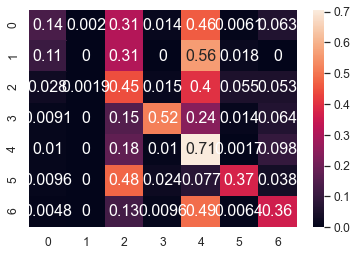

	training epoch=7 .. train_loss=1.265
	validation epoch=7 .. val_loss=1.419
	Accuracy = 43.4 % .. Percision = 48.4 % .. Recall = 36.3 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_7.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 8 .. loss = 1.309


  0%|                                                                                 | 1/1914 [00:01<37:47,  1.19s/it]

training @ epoch 8 .. loss = 1.458


  0%|                                                                                 | 2/1914 [00:02<37:38,  1.18s/it]

training @ epoch 8 .. loss = 1.128


  0%|▏                                                                                | 3/1914 [00:03<37:38,  1.18s/it]

training @ epoch 8 .. loss = 1.259


  0%|▏                                                                                | 4/1914 [00:04<37:32,  1.18s/it]

training @ epoch 8 .. loss = 1.136


  0%|▏                                                                                | 5/1914 [00:05<37:42,  1.19s/it]

training @ epoch 8 .. loss = 1.044


  0%|▎                                                                                | 6/1914 [00:07<38:06,  1.20s/it]

training @ epoch 8 .. loss = 1.023


  0%|▎                                                                                | 7/1914 [00:08<37:42,  1.19s/it]

training @ epoch 8 .. loss = 1.113


  0%|▎                                                                                | 8/1914 [00:09<39:12,  1.23s/it]

training @ epoch 8 .. loss = 1.353


  0%|▍                                                                                | 9/1914 [00:11<40:24,  1.27s/it]

training @ epoch 8 .. loss = 1.466


  1%|▍                                                                               | 10/1914 [00:12<41:27,  1.31s/it]

training @ epoch 8 .. loss = 1.234


  1%|▍                                                                               | 11/1914 [00:13<41:20,  1.30s/it]

training @ epoch 8 .. loss = 1.435


  1%|▌                                                                               | 12/1914 [00:14<41:19,  1.30s/it]

training @ epoch 8 .. loss = 1.356


  1%|▌                                                                               | 13/1914 [00:16<41:01,  1.29s/it]

training @ epoch 8 .. loss = 1.235


  1%|▌                                                                               | 14/1914 [00:17<41:10,  1.30s/it]

training @ epoch 8 .. loss = 1.518


  1%|▋                                                                               | 15/1914 [00:18<41:12,  1.30s/it]

training @ epoch 8 .. loss = 1.415


  1%|▋                                                                               | 16/1914 [00:20<41:05,  1.30s/it]

training @ epoch 8 .. loss = 1.201


  1%|▋                                                                               | 17/1914 [00:21<41:13,  1.30s/it]

training @ epoch 8 .. loss = 1.078


  1%|▊                                                                               | 18/1914 [00:22<41:41,  1.32s/it]

training @ epoch 8 .. loss = 1.179


  1%|▊                                                                               | 19/1914 [00:24<42:21,  1.34s/it]

training @ epoch 8 .. loss = 1.09


  1%|▊                                                                               | 20/1914 [00:25<42:26,  1.34s/it]

training @ epoch 8 .. loss = 1.58


  1%|▉                                                                               | 21/1914 [00:26<42:16,  1.34s/it]

training @ epoch 8 .. loss = 1.378


  1%|▉                                                                               | 22/1914 [00:28<42:31,  1.35s/it]

training @ epoch 8 .. loss = 1.277


  1%|▉                                                                               | 23/1914 [00:29<41:12,  1.31s/it]

training @ epoch 8 .. loss = 0.849


  1%|█                                                                               | 24/1914 [00:30<39:42,  1.26s/it]

training @ epoch 8 .. loss = 1.271


  1%|█                                                                               | 25/1914 [00:31<38:40,  1.23s/it]

training @ epoch 8 .. loss = 1.474


  1%|█                                                                               | 26/1914 [00:32<38:12,  1.21s/it]

training @ epoch 8 .. loss = 0.898


  1%|█▏                                                                              | 27/1914 [00:34<37:43,  1.20s/it]

training @ epoch 8 .. loss = 0.836


  1%|█▏                                                                              | 28/1914 [00:35<37:44,  1.20s/it]

training @ epoch 8 .. loss = 1.142


  2%|█▏                                                                              | 29/1914 [00:36<37:21,  1.19s/it]

training @ epoch 8 .. loss = 1.013


  2%|█▎                                                                              | 30/1914 [00:37<37:45,  1.20s/it]

training @ epoch 8 .. loss = 1.237


  2%|█▎                                                                              | 31/1914 [00:39<38:28,  1.23s/it]

training @ epoch 8 .. loss = 1.204


  2%|█▎                                                                              | 32/1914 [00:40<38:01,  1.21s/it]

training @ epoch 8 .. loss = 1.007


  2%|█▍                                                                              | 33/1914 [00:41<37:43,  1.20s/it]

training @ epoch 8 .. loss = 1.046


  2%|█▍                                                                              | 34/1914 [00:42<37:08,  1.19s/it]

training @ epoch 8 .. loss = 0.917


  2%|█▍                                                                              | 35/1914 [00:43<36:54,  1.18s/it]

training @ epoch 8 .. loss = 1.909


  2%|█▌                                                                              | 36/1914 [00:44<37:16,  1.19s/it]

training @ epoch 8 .. loss = 1.122


  2%|█▌                                                                              | 37/1914 [00:46<36:50,  1.18s/it]

training @ epoch 8 .. loss = 1.18


  2%|█▌                                                                              | 38/1914 [00:47<37:17,  1.19s/it]

training @ epoch 8 .. loss = 1.335


  2%|█▋                                                                              | 39/1914 [00:48<37:16,  1.19s/it]

training @ epoch 8 .. loss = 1.467


  2%|█▋                                                                              | 40/1914 [00:49<36:46,  1.18s/it]

training @ epoch 8 .. loss = 1.215


  2%|█▋                                                                              | 41/1914 [00:50<37:11,  1.19s/it]

training @ epoch 8 .. loss = 1.465


  2%|█▊                                                                              | 42/1914 [00:52<37:02,  1.19s/it]

training @ epoch 8 .. loss = 1.55


  2%|█▊                                                                              | 43/1914 [00:53<37:39,  1.21s/it]

training @ epoch 8 .. loss = 1.475


  2%|█▊                                                                              | 44/1914 [00:54<37:11,  1.19s/it]

training @ epoch 8 .. loss = 1.084


  2%|█▉                                                                              | 45/1914 [00:55<36:59,  1.19s/it]

training @ epoch 8 .. loss = 1.059


  2%|█▉                                                                              | 46/1914 [00:56<36:57,  1.19s/it]

training @ epoch 8 .. loss = 1.241


  2%|█▉                                                                              | 47/1914 [00:57<36:34,  1.18s/it]

training @ epoch 8 .. loss = 1.448


  3%|██                                                                              | 48/1914 [00:59<36:38,  1.18s/it]

training @ epoch 8 .. loss = 1.234


  3%|██                                                                              | 49/1914 [01:00<36:29,  1.17s/it]

training @ epoch 8 .. loss = 1.887


  3%|██                                                                              | 50/1914 [01:01<37:52,  1.22s/it]

training @ epoch 8 .. loss = 1.305


  3%|██▏                                                                             | 51/1914 [01:02<39:12,  1.26s/it]

training @ epoch 8 .. loss = 1.079


  3%|██▏                                                                             | 52/1914 [01:04<41:49,  1.35s/it]

training @ epoch 8 .. loss = 0.942


  3%|██▏                                                                             | 53/1914 [01:06<43:33,  1.40s/it]

training @ epoch 8 .. loss = 1.147


  3%|██▎                                                                             | 54/1914 [01:07<44:51,  1.45s/it]

training @ epoch 8 .. loss = 1.435


  3%|██▎                                                                             | 55/1914 [01:09<46:07,  1.49s/it]

training @ epoch 8 .. loss = 1.344


  3%|██▎                                                                             | 56/1914 [01:10<46:38,  1.51s/it]

training @ epoch 8 .. loss = 1.21


  3%|██▍                                                                             | 57/1914 [01:12<46:03,  1.49s/it]

training @ epoch 8 .. loss = 1.685


  3%|██▍                                                                             | 58/1914 [01:13<44:36,  1.44s/it]

training @ epoch 8 .. loss = 1.143


  3%|██▍                                                                             | 59/1914 [01:14<43:34,  1.41s/it]

training @ epoch 8 .. loss = 1.152


  3%|██▌                                                                             | 60/1914 [01:16<42:28,  1.37s/it]

training @ epoch 8 .. loss = 1.348


  3%|██▌                                                                             | 61/1914 [01:17<41:52,  1.36s/it]

training @ epoch 8 .. loss = 0.922


  3%|██▌                                                                             | 62/1914 [01:18<41:22,  1.34s/it]

training @ epoch 8 .. loss = 1.328


  3%|██▋                                                                             | 63/1914 [01:20<40:55,  1.33s/it]

training @ epoch 8 .. loss = 0.908


  3%|██▋                                                                             | 64/1914 [01:21<40:41,  1.32s/it]

training @ epoch 8 .. loss = 1.27


  3%|██▋                                                                             | 65/1914 [01:22<40:20,  1.31s/it]

training @ epoch 8 .. loss = 0.987


  3%|██▊                                                                             | 66/1914 [01:23<40:16,  1.31s/it]

training @ epoch 8 .. loss = 1.088


  4%|██▊                                                                             | 67/1914 [01:25<40:57,  1.33s/it]

training @ epoch 8 .. loss = 0.865


  4%|██▊                                                                             | 68/1914 [01:26<40:19,  1.31s/it]

training @ epoch 8 .. loss = 1.388


  4%|██▉                                                                             | 69/1914 [01:27<40:24,  1.31s/it]

training @ epoch 8 .. loss = 1.146


  4%|██▉                                                                             | 70/1914 [01:29<41:04,  1.34s/it]

training @ epoch 8 .. loss = 1.074


  4%|██▉                                                                             | 71/1914 [01:30<41:01,  1.34s/it]

training @ epoch 8 .. loss = 0.809


  4%|███                                                                             | 72/1914 [01:31<40:30,  1.32s/it]

training @ epoch 8 .. loss = 0.781


  4%|███                                                                             | 73/1914 [01:33<40:36,  1.32s/it]

training @ epoch 8 .. loss = 1.05


  4%|███                                                                             | 74/1914 [01:34<40:08,  1.31s/it]

training @ epoch 8 .. loss = 1.174


  4%|███▏                                                                            | 75/1914 [01:35<39:47,  1.30s/it]

training @ epoch 8 .. loss = 1.76


  4%|███▏                                                                            | 76/1914 [01:37<39:54,  1.30s/it]

training @ epoch 8 .. loss = 1.377


  4%|███▏                                                                            | 77/1914 [01:38<40:07,  1.31s/it]

training @ epoch 8 .. loss = 1.778


  4%|███▎                                                                            | 78/1914 [01:39<39:31,  1.29s/it]

training @ epoch 8 .. loss = 1.576


  4%|███▎                                                                            | 79/1914 [01:41<39:31,  1.29s/it]

training @ epoch 8 .. loss = 1.01


  4%|███▎                                                                            | 80/1914 [01:42<40:04,  1.31s/it]

training @ epoch 8 .. loss = 1.477


  4%|███▍                                                                            | 81/1914 [01:43<39:54,  1.31s/it]

training @ epoch 8 .. loss = 1.199


  4%|███▍                                                                            | 82/1914 [01:44<39:24,  1.29s/it]

training @ epoch 8 .. loss = 1.083


  4%|███▍                                                                            | 83/1914 [01:46<38:21,  1.26s/it]

training @ epoch 8 .. loss = 1.192


  4%|███▌                                                                            | 84/1914 [01:47<38:02,  1.25s/it]

training @ epoch 8 .. loss = 0.888


  4%|███▌                                                                            | 85/1914 [01:48<37:25,  1.23s/it]

training @ epoch 8 .. loss = 1.282


  4%|███▌                                                                            | 86/1914 [01:49<37:05,  1.22s/it]

training @ epoch 8 .. loss = 0.883


  5%|███▋                                                                            | 87/1914 [01:50<37:11,  1.22s/it]

training @ epoch 8 .. loss = 1.13


  5%|███▋                                                                            | 88/1914 [01:52<36:32,  1.20s/it]

training @ epoch 8 .. loss = 1.444


  5%|███▋                                                                            | 89/1914 [01:53<36:48,  1.21s/it]

training @ epoch 8 .. loss = 0.809


  5%|███▊                                                                            | 90/1914 [01:54<36:20,  1.20s/it]

training @ epoch 8 .. loss = 0.891


  5%|███▊                                                                            | 91/1914 [01:55<36:10,  1.19s/it]

training @ epoch 8 .. loss = 0.767


  5%|███▊                                                                            | 92/1914 [01:56<36:00,  1.19s/it]

training @ epoch 8 .. loss = 0.796


  5%|███▉                                                                            | 93/1914 [01:57<35:45,  1.18s/it]

training @ epoch 8 .. loss = 1.031


  5%|███▉                                                                            | 94/1914 [01:59<35:55,  1.18s/it]

training @ epoch 8 .. loss = 1.112


  5%|███▉                                                                            | 95/1914 [02:00<35:32,  1.17s/it]

training @ epoch 8 .. loss = 1.593


  5%|████                                                                            | 96/1914 [02:01<35:26,  1.17s/it]

training @ epoch 8 .. loss = 1.162


  5%|████                                                                            | 97/1914 [02:02<35:37,  1.18s/it]

training @ epoch 8 .. loss = 0.681


  5%|████                                                                            | 98/1914 [02:03<35:38,  1.18s/it]

training @ epoch 8 .. loss = 1.207


  5%|████▏                                                                           | 99/1914 [02:05<35:37,  1.18s/it]

training @ epoch 8 .. loss = 1.402


  5%|████▏                                                                          | 100/1914 [02:06<35:27,  1.17s/it]

training @ epoch 8 .. loss = 1.498


  5%|████▏                                                                          | 101/1914 [02:07<35:34,  1.18s/it]

training @ epoch 8 .. loss = 0.862


  5%|████▏                                                                          | 102/1914 [02:08<35:14,  1.17s/it]

training @ epoch 8 .. loss = 1.21


  5%|████▎                                                                          | 103/1914 [02:09<35:21,  1.17s/it]

training @ epoch 8 .. loss = 1.66


  5%|████▎                                                                          | 104/1914 [02:10<35:36,  1.18s/it]

training @ epoch 8 .. loss = 1.367


  5%|████▎                                                                          | 105/1914 [02:12<35:20,  1.17s/it]

training @ epoch 8 .. loss = 1.48


  6%|████▍                                                                          | 106/1914 [02:13<35:32,  1.18s/it]

training @ epoch 8 .. loss = 1.177


  6%|████▍                                                                          | 107/1914 [02:14<35:25,  1.18s/it]

training @ epoch 8 .. loss = 1.723


  6%|████▍                                                                          | 108/1914 [02:15<38:43,  1.29s/it]

training @ epoch 8 .. loss = 0.885


  6%|████▍                                                                          | 109/1914 [02:17<39:02,  1.30s/it]

training @ epoch 8 .. loss = 1.421


  6%|████▌                                                                          | 110/1914 [02:18<38:52,  1.29s/it]

training @ epoch 8 .. loss = 1.199


  6%|████▌                                                                          | 111/1914 [02:19<38:21,  1.28s/it]

training @ epoch 8 .. loss = 1.385


  6%|████▌                                                                          | 112/1914 [02:21<37:40,  1.25s/it]

training @ epoch 8 .. loss = 1.126


  6%|████▋                                                                          | 113/1914 [02:22<36:55,  1.23s/it]

training @ epoch 8 .. loss = 1.157


  6%|████▋                                                                          | 114/1914 [02:23<36:39,  1.22s/it]

training @ epoch 8 .. loss = 0.793


  6%|████▋                                                                          | 115/1914 [02:24<36:26,  1.22s/it]

training @ epoch 8 .. loss = 1.134


  6%|████▊                                                                          | 116/1914 [02:25<36:04,  1.20s/it]

training @ epoch 8 .. loss = 1.277


  6%|████▊                                                                          | 117/1914 [02:27<36:16,  1.21s/it]

training @ epoch 8 .. loss = 1.652


  6%|████▊                                                                          | 118/1914 [02:28<35:47,  1.20s/it]

training @ epoch 8 .. loss = 1.478


  6%|████▉                                                                          | 119/1914 [02:29<35:29,  1.19s/it]

training @ epoch 8 .. loss = 1.335


  6%|████▉                                                                          | 120/1914 [02:30<35:19,  1.18s/it]

training @ epoch 8 .. loss = 1.27


  6%|████▉                                                                          | 121/1914 [02:31<35:23,  1.18s/it]

training @ epoch 8 .. loss = 1.206


  6%|█████                                                                          | 122/1914 [02:32<35:36,  1.19s/it]

training @ epoch 8 .. loss = 1.224


  6%|█████                                                                          | 123/1914 [02:34<35:08,  1.18s/it]

training @ epoch 8 .. loss = 1.056


  6%|█████                                                                          | 124/1914 [02:35<35:35,  1.19s/it]

training @ epoch 8 .. loss = 1.138


  7%|█████▏                                                                         | 125/1914 [02:36<35:18,  1.18s/it]

training @ epoch 8 .. loss = 1.09


  7%|█████▏                                                                         | 126/1914 [02:37<35:16,  1.18s/it]

training @ epoch 8 .. loss = 1.014


  7%|█████▏                                                                         | 127/1914 [02:38<35:58,  1.21s/it]

training @ epoch 8 .. loss = 1.283


  7%|█████▎                                                                         | 128/1914 [02:40<35:38,  1.20s/it]

training @ epoch 8 .. loss = 1.468


  7%|█████▎                                                                         | 129/1914 [02:41<36:01,  1.21s/it]

training @ epoch 8 .. loss = 0.98


  7%|█████▎                                                                         | 130/1914 [02:42<35:35,  1.20s/it]

training @ epoch 8 .. loss = 1.093


  7%|█████▍                                                                         | 131/1914 [02:43<35:15,  1.19s/it]

training @ epoch 8 .. loss = 1.363


  7%|█████▍                                                                         | 132/1914 [02:44<35:17,  1.19s/it]

training @ epoch 8 .. loss = 1.393


  7%|█████▍                                                                         | 133/1914 [02:45<34:57,  1.18s/it]

training @ epoch 8 .. loss = 0.666


  7%|█████▌                                                                         | 134/1914 [02:47<35:29,  1.20s/it]

training @ epoch 8 .. loss = 1.382


  7%|█████▌                                                                         | 135/1914 [02:48<35:26,  1.20s/it]

training @ epoch 8 .. loss = 1.472


  7%|█████▌                                                                         | 136/1914 [02:49<35:19,  1.19s/it]

training @ epoch 8 .. loss = 1.104


  7%|█████▋                                                                         | 137/1914 [02:50<35:13,  1.19s/it]

training @ epoch 8 .. loss = 1.083


  7%|█████▋                                                                         | 138/1914 [02:51<35:01,  1.18s/it]

training @ epoch 8 .. loss = 1.803


  7%|█████▋                                                                         | 139/1914 [02:53<35:44,  1.21s/it]

training @ epoch 8 .. loss = 1.541


  7%|█████▊                                                                         | 140/1914 [02:54<35:39,  1.21s/it]

training @ epoch 8 .. loss = 1.023


  7%|█████▊                                                                         | 141/1914 [02:55<35:19,  1.20s/it]

training @ epoch 8 .. loss = 1.693


  7%|█████▊                                                                         | 142/1914 [02:56<35:33,  1.20s/it]

training @ epoch 8 .. loss = 1.262


  7%|█████▉                                                                         | 143/1914 [02:58<35:30,  1.20s/it]

training @ epoch 8 .. loss = 1.259


  8%|█████▉                                                                         | 144/1914 [02:59<35:40,  1.21s/it]

training @ epoch 8 .. loss = 1.215


  8%|█████▉                                                                         | 145/1914 [03:00<35:26,  1.20s/it]

training @ epoch 8 .. loss = 1.044


  8%|██████                                                                         | 146/1914 [03:01<35:19,  1.20s/it]

training @ epoch 8 .. loss = 1.553


  8%|██████                                                                         | 147/1914 [03:02<35:06,  1.19s/it]

training @ epoch 8 .. loss = 1.223


  8%|██████                                                                         | 148/1914 [03:03<34:59,  1.19s/it]

training @ epoch 8 .. loss = 1.346


  8%|██████▏                                                                        | 149/1914 [03:05<35:11,  1.20s/it]

training @ epoch 8 .. loss = 1.279


  8%|██████▏                                                                        | 150/1914 [03:06<34:57,  1.19s/it]

training @ epoch 8 .. loss = 1.114


  8%|██████▏                                                                        | 151/1914 [03:07<34:46,  1.18s/it]

training @ epoch 8 .. loss = 1.273


  8%|██████▎                                                                        | 152/1914 [03:08<35:05,  1.19s/it]

training @ epoch 8 .. loss = 1.023


  8%|██████▎                                                                        | 153/1914 [03:09<34:39,  1.18s/it]

training @ epoch 8 .. loss = 1.621


  8%|██████▎                                                                        | 154/1914 [03:11<35:03,  1.20s/it]

training @ epoch 8 .. loss = 1.103


  8%|██████▍                                                                        | 155/1914 [03:12<34:50,  1.19s/it]

training @ epoch 8 .. loss = 1.875


  8%|██████▍                                                                        | 156/1914 [03:13<34:43,  1.19s/it]

training @ epoch 8 .. loss = 0.965


  8%|██████▍                                                                        | 157/1914 [03:14<34:46,  1.19s/it]

training @ epoch 8 .. loss = 1.366


  8%|██████▌                                                                        | 158/1914 [03:15<34:23,  1.18s/it]

training @ epoch 8 .. loss = 1.75


  8%|██████▌                                                                        | 159/1914 [03:17<34:46,  1.19s/it]

training @ epoch 8 .. loss = 0.912


  8%|██████▌                                                                        | 160/1914 [03:18<35:07,  1.20s/it]

training @ epoch 8 .. loss = 1.055


  8%|██████▋                                                                        | 161/1914 [03:19<34:57,  1.20s/it]

training @ epoch 8 .. loss = 1.483


  8%|██████▋                                                                        | 162/1914 [03:20<34:47,  1.19s/it]

training @ epoch 8 .. loss = 0.908


  9%|██████▋                                                                        | 163/1914 [03:21<34:30,  1.18s/it]

training @ epoch 8 .. loss = 1.681


  9%|██████▊                                                                        | 164/1914 [03:22<34:18,  1.18s/it]

training @ epoch 8 .. loss = 1.459


  9%|██████▊                                                                        | 165/1914 [03:24<34:09,  1.17s/it]

training @ epoch 8 .. loss = 1.161


  9%|██████▊                                                                        | 166/1914 [03:25<34:35,  1.19s/it]

training @ epoch 8 .. loss = 1.396


  9%|██████▉                                                                        | 167/1914 [03:26<36:12,  1.24s/it]

training @ epoch 8 .. loss = 1.258


  9%|██████▉                                                                        | 168/1914 [03:27<35:59,  1.24s/it]

training @ epoch 8 .. loss = 0.956


  9%|██████▉                                                                        | 169/1914 [03:29<35:46,  1.23s/it]

training @ epoch 8 .. loss = 1.561


  9%|███████                                                                        | 170/1914 [03:30<35:09,  1.21s/it]

training @ epoch 8 .. loss = 0.803


  9%|███████                                                                        | 171/1914 [03:31<34:54,  1.20s/it]

training @ epoch 8 .. loss = 1.231


  9%|███████                                                                        | 172/1914 [03:32<34:47,  1.20s/it]

training @ epoch 8 .. loss = 1.013


  9%|███████▏                                                                       | 173/1914 [03:33<34:44,  1.20s/it]

training @ epoch 8 .. loss = 1.08


  9%|███████▏                                                                       | 174/1914 [03:35<34:45,  1.20s/it]

training @ epoch 8 .. loss = 1.344


  9%|███████▏                                                                       | 175/1914 [03:36<34:46,  1.20s/it]

training @ epoch 8 .. loss = 0.865


  9%|███████▎                                                                       | 176/1914 [03:37<34:37,  1.20s/it]

training @ epoch 8 .. loss = 1.376


  9%|███████▎                                                                       | 177/1914 [03:38<34:30,  1.19s/it]

training @ epoch 8 .. loss = 1.369


  9%|███████▎                                                                       | 178/1914 [03:39<34:19,  1.19s/it]

training @ epoch 8 .. loss = 1.482


  9%|███████▍                                                                       | 179/1914 [03:41<34:20,  1.19s/it]

training @ epoch 8 .. loss = 1.137


  9%|███████▍                                                                       | 180/1914 [03:42<34:15,  1.19s/it]

training @ epoch 8 .. loss = 1.166


  9%|███████▍                                                                       | 181/1914 [03:43<34:13,  1.18s/it]

training @ epoch 8 .. loss = 1.382


 10%|███████▌                                                                       | 182/1914 [03:44<34:05,  1.18s/it]

training @ epoch 8 .. loss = 0.833


 10%|███████▌                                                                       | 183/1914 [03:45<34:04,  1.18s/it]

training @ epoch 8 .. loss = 0.751


 10%|███████▌                                                                       | 184/1914 [03:47<35:07,  1.22s/it]

training @ epoch 8 .. loss = 1.25


 10%|███████▋                                                                       | 185/1914 [03:48<34:58,  1.21s/it]

training @ epoch 8 .. loss = 1.188


 10%|███████▋                                                                       | 186/1914 [03:49<34:36,  1.20s/it]

training @ epoch 8 .. loss = 1.197


 10%|███████▋                                                                       | 187/1914 [03:50<34:19,  1.19s/it]

training @ epoch 8 .. loss = 1.2


 10%|███████▊                                                                       | 188/1914 [03:51<33:59,  1.18s/it]

training @ epoch 8 .. loss = 1.088


 10%|███████▊                                                                       | 189/1914 [03:52<34:06,  1.19s/it]

training @ epoch 8 .. loss = 1.209


 10%|███████▊                                                                       | 190/1914 [03:54<34:18,  1.19s/it]

training @ epoch 8 .. loss = 1.361


 10%|███████▉                                                                       | 191/1914 [03:55<34:24,  1.20s/it]

training @ epoch 8 .. loss = 1.367


 10%|███████▉                                                                       | 192/1914 [03:56<33:59,  1.18s/it]

training @ epoch 8 .. loss = 1.252


 10%|███████▉                                                                       | 193/1914 [03:57<33:45,  1.18s/it]

training @ epoch 8 .. loss = 1.265


 10%|████████                                                                       | 194/1914 [03:58<33:56,  1.18s/it]

training @ epoch 8 .. loss = 1.424


 10%|████████                                                                       | 195/1914 [04:00<33:34,  1.17s/it]

training @ epoch 8 .. loss = 1.878


 10%|████████                                                                       | 196/1914 [04:01<33:58,  1.19s/it]

training @ epoch 8 .. loss = 1.384


 10%|████████▏                                                                      | 197/1914 [04:02<33:51,  1.18s/it]

training @ epoch 8 .. loss = 0.952


 10%|████████▏                                                                      | 198/1914 [04:03<33:49,  1.18s/it]

training @ epoch 8 .. loss = 1.122


 10%|████████▏                                                                      | 199/1914 [04:04<34:24,  1.20s/it]

training @ epoch 8 .. loss = 1.437


 10%|████████▎                                                                      | 200/1914 [04:05<33:56,  1.19s/it]

training @ epoch 8 .. loss = 1.243


 11%|████████▎                                                                      | 201/1914 [04:07<34:18,  1.20s/it]

training @ epoch 8 .. loss = 0.746


 11%|████████▎                                                                      | 202/1914 [04:08<33:52,  1.19s/it]

training @ epoch 8 .. loss = 1.146


 11%|████████▍                                                                      | 203/1914 [04:09<33:43,  1.18s/it]

training @ epoch 8 .. loss = 0.942


 11%|████████▍                                                                      | 204/1914 [04:10<33:46,  1.19s/it]

training @ epoch 8 .. loss = 1.197


 11%|████████▍                                                                      | 205/1914 [04:11<33:13,  1.17s/it]

training @ epoch 8 .. loss = 1.267


 11%|████████▌                                                                      | 206/1914 [04:13<33:15,  1.17s/it]

training @ epoch 8 .. loss = 1.271


 11%|████████▌                                                                      | 207/1914 [04:14<33:26,  1.18s/it]

training @ epoch 8 .. loss = 1.139


 11%|████████▌                                                                      | 208/1914 [04:15<33:28,  1.18s/it]

training @ epoch 8 .. loss = 1.536


 11%|████████▋                                                                      | 209/1914 [04:16<33:29,  1.18s/it]

training @ epoch 8 .. loss = 1.439


 11%|████████▋                                                                      | 210/1914 [04:17<33:30,  1.18s/it]

training @ epoch 8 .. loss = 1.011


 11%|████████▋                                                                      | 211/1914 [04:18<33:40,  1.19s/it]

training @ epoch 8 .. loss = 0.955


 11%|████████▊                                                                      | 212/1914 [04:20<33:27,  1.18s/it]

training @ epoch 8 .. loss = 1.383


 11%|████████▊                                                                      | 213/1914 [04:21<33:28,  1.18s/it]

training @ epoch 8 .. loss = 1.541


 11%|████████▊                                                                      | 214/1914 [04:22<32:57,  1.16s/it]

training @ epoch 8 .. loss = 1.201


 11%|████████▊                                                                      | 215/1914 [04:23<33:01,  1.17s/it]

training @ epoch 8 .. loss = 0.924


 11%|████████▉                                                                      | 216/1914 [04:24<33:01,  1.17s/it]

training @ epoch 8 .. loss = 1.397


 11%|████████▉                                                                      | 217/1914 [04:25<33:12,  1.17s/it]

training @ epoch 8 .. loss = 1.419


 11%|████████▉                                                                      | 218/1914 [04:27<33:42,  1.19s/it]

training @ epoch 8 .. loss = 0.745


 11%|█████████                                                                      | 219/1914 [04:28<33:34,  1.19s/it]

training @ epoch 8 .. loss = 1.146


 11%|█████████                                                                      | 220/1914 [04:29<33:25,  1.18s/it]

training @ epoch 8 .. loss = 1.317


 12%|█████████                                                                      | 221/1914 [04:30<33:06,  1.17s/it]

training @ epoch 8 .. loss = 1.066


 12%|█████████▏                                                                     | 222/1914 [04:31<33:12,  1.18s/it]

training @ epoch 8 .. loss = 1.257


 12%|█████████▏                                                                     | 223/1914 [04:33<33:34,  1.19s/it]

training @ epoch 8 .. loss = 1.227


 12%|█████████▏                                                                     | 224/1914 [04:34<33:40,  1.20s/it]

training @ epoch 8 .. loss = 1.0


 12%|█████████▎                                                                     | 225/1914 [04:35<33:31,  1.19s/it]

training @ epoch 8 .. loss = 1.45


 12%|█████████▎                                                                     | 226/1914 [04:36<33:26,  1.19s/it]

training @ epoch 8 .. loss = 0.961


 12%|█████████▎                                                                     | 227/1914 [04:37<33:16,  1.18s/it]

training @ epoch 8 .. loss = 1.721


 12%|█████████▍                                                                     | 228/1914 [04:39<33:16,  1.18s/it]

training @ epoch 8 .. loss = 1.176


 12%|█████████▍                                                                     | 229/1914 [04:40<33:11,  1.18s/it]

training @ epoch 8 .. loss = 1.522


 12%|█████████▍                                                                     | 230/1914 [04:41<33:15,  1.18s/it]

training @ epoch 8 .. loss = 1.094


 12%|█████████▌                                                                     | 231/1914 [04:42<33:02,  1.18s/it]

training @ epoch 8 .. loss = 1.85


 12%|█████████▌                                                                     | 232/1914 [04:43<32:37,  1.16s/it]

training @ epoch 8 .. loss = 1.259


 12%|█████████▌                                                                     | 233/1914 [04:44<33:00,  1.18s/it]

training @ epoch 8 .. loss = 1.797


 12%|█████████▋                                                                     | 234/1914 [04:46<33:16,  1.19s/it]

training @ epoch 8 .. loss = 0.784


 12%|█████████▋                                                                     | 235/1914 [04:47<33:16,  1.19s/it]

training @ epoch 8 .. loss = 0.967


 12%|█████████▋                                                                     | 236/1914 [04:48<33:12,  1.19s/it]

training @ epoch 8 .. loss = 1.33


 12%|█████████▊                                                                     | 237/1914 [04:49<32:54,  1.18s/it]

training @ epoch 8 .. loss = 1.162


 12%|█████████▊                                                                     | 238/1914 [04:50<33:00,  1.18s/it]

training @ epoch 8 .. loss = 0.984


 12%|█████████▊                                                                     | 239/1914 [04:51<32:38,  1.17s/it]

training @ epoch 8 .. loss = 1.343


 13%|█████████▉                                                                     | 240/1914 [04:53<33:03,  1.19s/it]

training @ epoch 8 .. loss = 1.155


 13%|█████████▉                                                                     | 241/1914 [04:54<33:09,  1.19s/it]

training @ epoch 8 .. loss = 1.334


 13%|█████████▉                                                                     | 242/1914 [04:55<32:56,  1.18s/it]

training @ epoch 8 .. loss = 1.121


 13%|██████████                                                                     | 243/1914 [04:56<33:25,  1.20s/it]

training @ epoch 8 .. loss = 1.444


 13%|██████████                                                                     | 244/1914 [04:57<33:04,  1.19s/it]

training @ epoch 8 .. loss = 1.38


 13%|██████████                                                                     | 245/1914 [04:59<33:11,  1.19s/it]

training @ epoch 8 .. loss = 1.107


 13%|██████████▏                                                                    | 246/1914 [05:00<32:59,  1.19s/it]

training @ epoch 8 .. loss = 1.672


 13%|██████████▏                                                                    | 247/1914 [05:01<32:47,  1.18s/it]

training @ epoch 8 .. loss = 0.995


 13%|██████████▏                                                                    | 248/1914 [05:02<33:04,  1.19s/it]

training @ epoch 8 .. loss = 1.683


 13%|██████████▎                                                                    | 249/1914 [05:03<32:48,  1.18s/it]

training @ epoch 8 .. loss = 1.329


 13%|██████████▎                                                                    | 250/1914 [05:05<33:07,  1.19s/it]

training @ epoch 8 .. loss = 1.088


 13%|██████████▎                                                                    | 251/1914 [05:06<32:53,  1.19s/it]

training @ epoch 8 .. loss = 1.237


 13%|██████████▍                                                                    | 252/1914 [05:07<32:50,  1.19s/it]

training @ epoch 8 .. loss = 1.14


 13%|██████████▍                                                                    | 253/1914 [05:08<32:34,  1.18s/it]

training @ epoch 8 .. loss = 1.039


 13%|██████████▍                                                                    | 254/1914 [05:09<32:36,  1.18s/it]

training @ epoch 8 .. loss = 1.486


 13%|██████████▌                                                                    | 255/1914 [05:11<32:59,  1.19s/it]

training @ epoch 8 .. loss = 1.277


 13%|██████████▌                                                                    | 256/1914 [05:12<33:02,  1.20s/it]

training @ epoch 8 .. loss = 1.316


 13%|██████████▌                                                                    | 257/1914 [05:13<32:39,  1.18s/it]

training @ epoch 8 .. loss = 1.224


 13%|██████████▋                                                                    | 258/1914 [05:14<32:41,  1.18s/it]

training @ epoch 8 .. loss = 1.211


 14%|██████████▋                                                                    | 259/1914 [05:15<32:29,  1.18s/it]

training @ epoch 8 .. loss = 1.306


 14%|██████████▋                                                                    | 260/1914 [05:16<32:34,  1.18s/it]

training @ epoch 8 .. loss = 1.023


 14%|██████████▊                                                                    | 261/1914 [05:18<32:49,  1.19s/it]

training @ epoch 8 .. loss = 1.223


 14%|██████████▊                                                                    | 262/1914 [05:19<32:53,  1.19s/it]

training @ epoch 8 .. loss = 1.617


 14%|██████████▊                                                                    | 263/1914 [05:20<32:46,  1.19s/it]

training @ epoch 8 .. loss = 1.368


 14%|██████████▉                                                                    | 264/1914 [05:21<32:25,  1.18s/it]

training @ epoch 8 .. loss = 1.269


 14%|██████████▉                                                                    | 265/1914 [05:22<32:40,  1.19s/it]

training @ epoch 8 .. loss = 1.248


 14%|██████████▉                                                                    | 266/1914 [05:24<32:36,  1.19s/it]

training @ epoch 8 .. loss = 1.42


 14%|███████████                                                                    | 267/1914 [05:25<32:43,  1.19s/it]

training @ epoch 8 .. loss = 1.409


 14%|███████████                                                                    | 268/1914 [05:26<32:17,  1.18s/it]

training @ epoch 8 .. loss = 0.8


 14%|███████████                                                                    | 269/1914 [05:27<32:28,  1.18s/it]

training @ epoch 8 .. loss = 1.266


 14%|███████████▏                                                                   | 270/1914 [05:28<32:30,  1.19s/it]

training @ epoch 8 .. loss = 1.571


 14%|███████████▏                                                                   | 271/1914 [05:30<32:26,  1.18s/it]

training @ epoch 8 .. loss = 1.39


 14%|███████████▏                                                                   | 272/1914 [05:31<32:38,  1.19s/it]

training @ epoch 8 .. loss = 1.342


 14%|███████████▎                                                                   | 273/1914 [05:32<32:26,  1.19s/it]

training @ epoch 8 .. loss = 1.264


 14%|███████████▎                                                                   | 274/1914 [05:33<32:18,  1.18s/it]

training @ epoch 8 .. loss = 1.205


 14%|███████████▎                                                                   | 275/1914 [05:34<32:14,  1.18s/it]

training @ epoch 8 .. loss = 1.145


 14%|███████████▍                                                                   | 276/1914 [05:35<31:59,  1.17s/it]

training @ epoch 8 .. loss = 1.552


 14%|███████████▍                                                                   | 277/1914 [05:37<31:53,  1.17s/it]

training @ epoch 8 .. loss = 1.307


 15%|███████████▍                                                                   | 278/1914 [05:38<32:13,  1.18s/it]

training @ epoch 8 .. loss = 0.895


 15%|███████████▌                                                                   | 279/1914 [05:39<32:08,  1.18s/it]

training @ epoch 8 .. loss = 0.766


 15%|███████████▌                                                                   | 280/1914 [05:40<32:09,  1.18s/it]

training @ epoch 8 .. loss = 1.127


 15%|███████████▌                                                                   | 281/1914 [05:41<31:58,  1.18s/it]

training @ epoch 8 .. loss = 1.071


 15%|███████████▋                                                                   | 282/1914 [05:42<31:55,  1.17s/it]

training @ epoch 8 .. loss = 1.071


 15%|███████████▋                                                                   | 283/1914 [05:44<31:43,  1.17s/it]

training @ epoch 8 .. loss = 0.963


 15%|███████████▋                                                                   | 284/1914 [05:45<32:48,  1.21s/it]

training @ epoch 8 .. loss = 1.182


 15%|███████████▊                                                                   | 285/1914 [05:46<32:23,  1.19s/it]

training @ epoch 8 .. loss = 1.354


 15%|███████████▊                                                                   | 286/1914 [05:47<32:21,  1.19s/it]

training @ epoch 8 .. loss = 1.202


 15%|███████████▊                                                                   | 287/1914 [05:48<32:24,  1.20s/it]

training @ epoch 8 .. loss = 0.96


 15%|███████████▉                                                                   | 288/1914 [05:50<32:22,  1.19s/it]

training @ epoch 8 .. loss = 1.134


 15%|███████████▉                                                                   | 289/1914 [05:51<32:20,  1.19s/it]

training @ epoch 8 .. loss = 1.238


 15%|███████████▉                                                                   | 290/1914 [05:52<32:03,  1.18s/it]

training @ epoch 8 .. loss = 1.444


 15%|████████████                                                                   | 291/1914 [05:53<31:51,  1.18s/it]

training @ epoch 8 .. loss = 1.332


 15%|████████████                                                                   | 292/1914 [05:54<32:00,  1.18s/it]

training @ epoch 8 .. loss = 1.165


 15%|████████████                                                                   | 293/1914 [05:56<31:52,  1.18s/it]

training @ epoch 8 .. loss = 1.191


 15%|████████████▏                                                                  | 294/1914 [05:57<32:00,  1.19s/it]

training @ epoch 8 .. loss = 1.659


 15%|████████████▏                                                                  | 295/1914 [05:58<31:40,  1.17s/it]

training @ epoch 8 .. loss = 1.08


 15%|████████████▏                                                                  | 296/1914 [05:59<31:29,  1.17s/it]

training @ epoch 8 .. loss = 1.26


 16%|████████████▎                                                                  | 297/1914 [06:00<31:34,  1.17s/it]

training @ epoch 8 .. loss = 1.14


 16%|████████████▎                                                                  | 298/1914 [06:01<31:28,  1.17s/it]

training @ epoch 8 .. loss = 1.159


 16%|████████████▎                                                                  | 299/1914 [06:03<31:34,  1.17s/it]

training @ epoch 8 .. loss = 1.516


 16%|████████████▍                                                                  | 300/1914 [06:04<31:34,  1.17s/it]

training @ epoch 8 .. loss = 1.889


 16%|████████████▍                                                                  | 301/1914 [06:05<31:55,  1.19s/it]

training @ epoch 8 .. loss = 0.924


 16%|████████████▍                                                                  | 302/1914 [06:06<31:43,  1.18s/it]

training @ epoch 8 .. loss = 1.029


 16%|████████████▌                                                                  | 303/1914 [06:07<31:38,  1.18s/it]

training @ epoch 8 .. loss = 1.165


 16%|████████████▌                                                                  | 304/1914 [06:09<31:47,  1.18s/it]

training @ epoch 8 .. loss = 1.133


 16%|████████████▌                                                                  | 305/1914 [06:10<31:55,  1.19s/it]

training @ epoch 8 .. loss = 1.517


 16%|████████████▋                                                                  | 306/1914 [06:11<32:15,  1.20s/it]

training @ epoch 8 .. loss = 1.203


 16%|████████████▋                                                                  | 307/1914 [06:12<34:00,  1.27s/it]

training @ epoch 8 .. loss = 1.615


 16%|████████████▋                                                                  | 308/1914 [06:14<34:22,  1.28s/it]

training @ epoch 8 .. loss = 1.267


 16%|████████████▊                                                                  | 309/1914 [06:15<34:59,  1.31s/it]

training @ epoch 8 .. loss = 1.488


 16%|████████████▊                                                                  | 310/1914 [06:16<34:03,  1.27s/it]

training @ epoch 8 .. loss = 1.179


 16%|████████████▊                                                                  | 311/1914 [06:17<33:18,  1.25s/it]

training @ epoch 8 .. loss = 1.412


 16%|████████████▉                                                                  | 312/1914 [06:19<32:50,  1.23s/it]

training @ epoch 8 .. loss = 1.352


 16%|████████████▉                                                                  | 313/1914 [06:20<32:37,  1.22s/it]

training @ epoch 8 .. loss = 1.267


 16%|████████████▉                                                                  | 314/1914 [06:21<32:22,  1.21s/it]

training @ epoch 8 .. loss = 1.275


 16%|█████████████                                                                  | 315/1914 [06:22<31:51,  1.20s/it]

training @ epoch 8 .. loss = 1.401


 17%|█████████████                                                                  | 316/1914 [06:23<31:33,  1.19s/it]

training @ epoch 8 .. loss = 1.023


 17%|█████████████                                                                  | 317/1914 [06:24<31:21,  1.18s/it]

training @ epoch 8 .. loss = 1.558


 17%|█████████████▏                                                                 | 318/1914 [06:26<31:12,  1.17s/it]

training @ epoch 8 .. loss = 0.944


 17%|█████████████▏                                                                 | 319/1914 [06:27<31:35,  1.19s/it]

training @ epoch 8 .. loss = 1.682


 17%|█████████████▏                                                                 | 320/1914 [06:28<31:31,  1.19s/it]

training @ epoch 8 .. loss = 1.191


 17%|█████████████▏                                                                 | 321/1914 [06:29<32:15,  1.21s/it]

training @ epoch 8 .. loss = 1.067


 17%|█████████████▎                                                                 | 322/1914 [06:31<33:26,  1.26s/it]

training @ epoch 8 .. loss = 1.53


 17%|█████████████▎                                                                 | 323/1914 [06:32<33:27,  1.26s/it]

training @ epoch 8 .. loss = 0.978


 17%|█████████████▎                                                                 | 324/1914 [06:33<32:33,  1.23s/it]

training @ epoch 8 .. loss = 1.314


 17%|█████████████▍                                                                 | 325/1914 [06:34<32:06,  1.21s/it]

training @ epoch 8 .. loss = 1.189


 17%|█████████████▍                                                                 | 326/1914 [06:35<31:32,  1.19s/it]

training @ epoch 8 .. loss = 1.37


 17%|█████████████▍                                                                 | 327/1914 [06:37<31:21,  1.19s/it]

training @ epoch 8 .. loss = 1.103


 17%|█████████████▌                                                                 | 328/1914 [06:38<31:18,  1.18s/it]

training @ epoch 8 .. loss = 1.329


 17%|█████████████▌                                                                 | 329/1914 [06:39<31:27,  1.19s/it]

training @ epoch 8 .. loss = 1.656


 17%|█████████████▌                                                                 | 330/1914 [06:40<31:02,  1.18s/it]

training @ epoch 8 .. loss = 1.253


 17%|█████████████▋                                                                 | 331/1914 [06:41<30:30,  1.16s/it]

training @ epoch 8 .. loss = 0.869


 17%|█████████████▋                                                                 | 332/1914 [06:42<30:42,  1.16s/it]

training @ epoch 8 .. loss = 1.615


 17%|█████████████▋                                                                 | 333/1914 [06:44<30:38,  1.16s/it]

training @ epoch 8 .. loss = 1.155


 17%|█████████████▊                                                                 | 334/1914 [06:45<31:00,  1.18s/it]

training @ epoch 8 .. loss = 1.112


 18%|█████████████▊                                                                 | 335/1914 [06:46<31:02,  1.18s/it]

training @ epoch 8 .. loss = 1.106


 18%|█████████████▊                                                                 | 336/1914 [06:47<30:52,  1.17s/it]

training @ epoch 8 .. loss = 1.169


 18%|█████████████▉                                                                 | 337/1914 [06:48<31:10,  1.19s/it]

training @ epoch 8 .. loss = 1.167


 18%|█████████████▉                                                                 | 338/1914 [06:50<30:47,  1.17s/it]

training @ epoch 8 .. loss = 1.222


 18%|█████████████▉                                                                 | 339/1914 [06:51<31:05,  1.18s/it]

training @ epoch 8 .. loss = 1.671


 18%|██████████████                                                                 | 340/1914 [06:52<31:06,  1.19s/it]

training @ epoch 8 .. loss = 1.046


 18%|██████████████                                                                 | 341/1914 [06:53<30:53,  1.18s/it]

training @ epoch 8 .. loss = 1.242


 18%|██████████████                                                                 | 342/1914 [06:54<30:48,  1.18s/it]

training @ epoch 8 .. loss = 1.015


 18%|██████████████▏                                                                | 343/1914 [06:55<31:14,  1.19s/it]

training @ epoch 8 .. loss = 1.207


 18%|██████████████▏                                                                | 344/1914 [06:57<31:13,  1.19s/it]

training @ epoch 8 .. loss = 1.405


 18%|██████████████▏                                                                | 345/1914 [06:58<31:11,  1.19s/it]

training @ epoch 8 .. loss = 1.028


 18%|██████████████▎                                                                | 346/1914 [06:59<31:09,  1.19s/it]

training @ epoch 8 .. loss = 1.604


 18%|██████████████▎                                                                | 347/1914 [07:00<30:53,  1.18s/it]

training @ epoch 8 .. loss = 1.267


 18%|██████████████▎                                                                | 348/1914 [07:01<30:28,  1.17s/it]

training @ epoch 8 .. loss = 1.512


 18%|██████████████▍                                                                | 349/1914 [07:03<30:43,  1.18s/it]

training @ epoch 8 .. loss = 1.226


 18%|██████████████▍                                                                | 350/1914 [07:04<30:35,  1.17s/it]

training @ epoch 8 .. loss = 1.486


 18%|██████████████▍                                                                | 351/1914 [07:05<30:53,  1.19s/it]

training @ epoch 8 .. loss = 0.873


 18%|██████████████▌                                                                | 352/1914 [07:06<30:35,  1.18s/it]

training @ epoch 8 .. loss = 1.185


 18%|██████████████▌                                                                | 353/1914 [07:07<30:04,  1.16s/it]

training @ epoch 8 .. loss = 0.58


 18%|██████████████▌                                                                | 354/1914 [07:08<30:34,  1.18s/it]

training @ epoch 8 .. loss = 0.975


 19%|██████████████▋                                                                | 355/1914 [07:10<30:03,  1.16s/it]

training @ epoch 8 .. loss = 1.241


 19%|██████████████▋                                                                | 356/1914 [07:11<30:33,  1.18s/it]

training @ epoch 8 .. loss = 1.652


 19%|██████████████▋                                                                | 357/1914 [07:12<30:44,  1.18s/it]

training @ epoch 8 .. loss = 1.526


 19%|██████████████▊                                                                | 358/1914 [07:13<30:27,  1.17s/it]

training @ epoch 8 .. loss = 1.677


 19%|██████████████▊                                                                | 359/1914 [07:14<30:30,  1.18s/it]

training @ epoch 8 .. loss = 1.658


 19%|██████████████▊                                                                | 360/1914 [07:16<31:19,  1.21s/it]

training @ epoch 8 .. loss = 1.032


 19%|██████████████▉                                                                | 361/1914 [07:17<32:30,  1.26s/it]

training @ epoch 8 .. loss = 1.4


 19%|██████████████▉                                                                | 362/1914 [07:18<32:34,  1.26s/it]

training @ epoch 8 .. loss = 0.909


 19%|██████████████▉                                                                | 363/1914 [07:19<31:52,  1.23s/it]

training @ epoch 8 .. loss = 1.325


 19%|███████████████                                                                | 364/1914 [07:21<32:54,  1.27s/it]

training @ epoch 8 .. loss = 1.38


 19%|███████████████                                                                | 365/1914 [07:22<32:51,  1.27s/it]

training @ epoch 8 .. loss = 1.016


 19%|███████████████                                                                | 366/1914 [07:23<31:33,  1.22s/it]

training @ epoch 8 .. loss = 1.407


 19%|███████████████▏                                                               | 367/1914 [07:24<31:38,  1.23s/it]

training @ epoch 8 .. loss = 1.272


 19%|███████████████▏                                                               | 368/1914 [07:26<31:11,  1.21s/it]

training @ epoch 8 .. loss = 1.118


 19%|███████████████▏                                                               | 369/1914 [07:27<30:57,  1.20s/it]

training @ epoch 8 .. loss = 1.112


 19%|███████████████▎                                                               | 370/1914 [07:28<31:09,  1.21s/it]

training @ epoch 8 .. loss = 1.188


 19%|███████████████▎                                                               | 371/1914 [07:29<30:42,  1.19s/it]

training @ epoch 8 .. loss = 1.111


 19%|███████████████▎                                                               | 372/1914 [07:30<30:22,  1.18s/it]

training @ epoch 8 .. loss = 1.286


 19%|███████████████▍                                                               | 373/1914 [07:31<30:25,  1.18s/it]

training @ epoch 8 .. loss = 1.177


 20%|███████████████▍                                                               | 374/1914 [07:33<31:01,  1.21s/it]

training @ epoch 8 .. loss = 1.097


 20%|███████████████▍                                                               | 375/1914 [07:34<30:45,  1.20s/it]

training @ epoch 8 .. loss = 1.136


 20%|███████████████▌                                                               | 376/1914 [07:35<30:40,  1.20s/it]

training @ epoch 8 .. loss = 1.364


 20%|███████████████▌                                                               | 377/1914 [07:36<30:27,  1.19s/it]

training @ epoch 8 .. loss = 1.261


 20%|███████████████▌                                                               | 378/1914 [07:37<30:35,  1.20s/it]

training @ epoch 8 .. loss = 0.903


 20%|███████████████▋                                                               | 379/1914 [07:39<30:42,  1.20s/it]

training @ epoch 8 .. loss = 1.112


 20%|███████████████▋                                                               | 380/1914 [07:40<30:32,  1.19s/it]

training @ epoch 8 .. loss = 1.958


 20%|███████████████▋                                                               | 381/1914 [07:41<30:22,  1.19s/it]

training @ epoch 8 .. loss = 1.404


 20%|███████████████▊                                                               | 382/1914 [07:42<30:09,  1.18s/it]

training @ epoch 8 .. loss = 1.629


 20%|███████████████▊                                                               | 383/1914 [07:43<29:52,  1.17s/it]

training @ epoch 8 .. loss = 1.208


 20%|███████████████▊                                                               | 384/1914 [07:45<30:01,  1.18s/it]

training @ epoch 8 .. loss = 0.746


 20%|███████████████▉                                                               | 385/1914 [07:46<30:02,  1.18s/it]

training @ epoch 8 .. loss = 1.425


 20%|███████████████▉                                                               | 386/1914 [07:47<30:21,  1.19s/it]

training @ epoch 8 .. loss = 0.683


 20%|███████████████▉                                                               | 387/1914 [07:48<30:16,  1.19s/it]

training @ epoch 8 .. loss = 1.296


 20%|████████████████                                                               | 388/1914 [07:49<29:44,  1.17s/it]

training @ epoch 8 .. loss = 1.284


 20%|████████████████                                                               | 389/1914 [07:50<29:52,  1.18s/it]

training @ epoch 8 .. loss = 1.552


 20%|████████████████                                                               | 390/1914 [07:52<29:39,  1.17s/it]

training @ epoch 8 .. loss = 1.194


 20%|████████████████▏                                                              | 391/1914 [07:53<29:51,  1.18s/it]

training @ epoch 8 .. loss = 1.102


 20%|████████████████▏                                                              | 392/1914 [07:54<30:24,  1.20s/it]

training @ epoch 8 .. loss = 1.248


 21%|████████████████▏                                                              | 393/1914 [07:55<30:06,  1.19s/it]

training @ epoch 8 .. loss = 1.273


 21%|████████████████▎                                                              | 394/1914 [07:56<30:21,  1.20s/it]

training @ epoch 8 .. loss = 1.684


 21%|████████████████▎                                                              | 395/1914 [07:58<29:57,  1.18s/it]

training @ epoch 8 .. loss = 1.396


 21%|████████████████▎                                                              | 396/1914 [07:59<30:13,  1.19s/it]

training @ epoch 8 .. loss = 1.129


 21%|████████████████▍                                                              | 397/1914 [08:00<30:04,  1.19s/it]

training @ epoch 8 .. loss = 1.833


 21%|████████████████▍                                                              | 398/1914 [08:01<31:10,  1.23s/it]

training @ epoch 8 .. loss = 1.367


 21%|████████████████▍                                                              | 399/1914 [08:03<32:28,  1.29s/it]

training @ epoch 8 .. loss = 1.255


 21%|████████████████▌                                                              | 400/1914 [08:04<33:16,  1.32s/it]

training @ epoch 8 .. loss = 1.349


 21%|████████████████▌                                                              | 401/1914 [08:05<33:31,  1.33s/it]

training @ epoch 8 .. loss = 1.314


 21%|████████████████▌                                                              | 402/1914 [08:07<33:21,  1.32s/it]

training @ epoch 8 .. loss = 1.112


 21%|████████████████▋                                                              | 403/1914 [08:08<32:03,  1.27s/it]

training @ epoch 8 .. loss = 1.534


 21%|████████████████▋                                                              | 404/1914 [08:09<31:30,  1.25s/it]

training @ epoch 8 .. loss = 1.242


 21%|████████████████▋                                                              | 405/1914 [08:10<31:05,  1.24s/it]

training @ epoch 8 .. loss = 2.29


 21%|████████████████▊                                                              | 406/1914 [08:12<30:49,  1.23s/it]

training @ epoch 8 .. loss = 1.058


 21%|████████████████▊                                                              | 407/1914 [08:13<30:32,  1.22s/it]

training @ epoch 8 .. loss = 1.549


 21%|████████████████▊                                                              | 408/1914 [08:14<30:10,  1.20s/it]

training @ epoch 8 .. loss = 1.283


 21%|████████████████▉                                                              | 409/1914 [08:15<29:48,  1.19s/it]

training @ epoch 8 .. loss = 1.742


 21%|████████████████▉                                                              | 410/1914 [08:16<29:51,  1.19s/it]

training @ epoch 8 .. loss = 1.02


 21%|████████████████▉                                                              | 411/1914 [08:17<29:38,  1.18s/it]

training @ epoch 8 .. loss = 1.394


 22%|█████████████████                                                              | 412/1914 [08:19<29:41,  1.19s/it]

training @ epoch 8 .. loss = 1.179


 22%|█████████████████                                                              | 413/1914 [08:20<29:34,  1.18s/it]

training @ epoch 8 .. loss = 0.953


 22%|█████████████████                                                              | 414/1914 [08:21<29:31,  1.18s/it]

training @ epoch 8 .. loss = 0.985


 22%|█████████████████▏                                                             | 415/1914 [08:22<29:53,  1.20s/it]

training @ epoch 8 .. loss = 1.112


 22%|█████████████████▏                                                             | 416/1914 [08:23<29:26,  1.18s/it]

training @ epoch 8 .. loss = 1.299


 22%|█████████████████▏                                                             | 417/1914 [08:25<29:52,  1.20s/it]

training @ epoch 8 .. loss = 0.927


 22%|█████████████████▎                                                             | 418/1914 [08:26<29:59,  1.20s/it]

training @ epoch 8 .. loss = 1.293


 22%|█████████████████▎                                                             | 419/1914 [08:27<29:47,  1.20s/it]

training @ epoch 8 .. loss = 1.301


 22%|█████████████████▎                                                             | 420/1914 [08:28<29:44,  1.19s/it]

training @ epoch 8 .. loss = 1.018


 22%|█████████████████▍                                                             | 421/1914 [08:29<29:24,  1.18s/it]

training @ epoch 8 .. loss = 1.483


 22%|█████████████████▍                                                             | 422/1914 [08:30<29:27,  1.18s/it]

training @ epoch 8 .. loss = 0.712


 22%|█████████████████▍                                                             | 423/1914 [08:32<29:21,  1.18s/it]

training @ epoch 8 .. loss = 1.045


 22%|█████████████████▌                                                             | 424/1914 [08:33<29:29,  1.19s/it]

training @ epoch 8 .. loss = 0.948


 22%|█████████████████▌                                                             | 425/1914 [08:34<29:21,  1.18s/it]

training @ epoch 8 .. loss = 1.097


 22%|█████████████████▌                                                             | 426/1914 [08:35<29:15,  1.18s/it]

training @ epoch 8 .. loss = 0.895


 22%|█████████████████▌                                                             | 427/1914 [08:36<29:33,  1.19s/it]

training @ epoch 8 .. loss = 1.206


 22%|█████████████████▋                                                             | 428/1914 [08:38<29:36,  1.20s/it]

training @ epoch 8 .. loss = 1.477


 22%|█████████████████▋                                                             | 429/1914 [08:39<29:52,  1.21s/it]

training @ epoch 8 .. loss = 1.401


 22%|█████████████████▋                                                             | 430/1914 [08:40<29:30,  1.19s/it]

training @ epoch 8 .. loss = 1.27


 23%|█████████████████▊                                                             | 431/1914 [08:41<30:09,  1.22s/it]

training @ epoch 8 .. loss = 1.531


 23%|█████████████████▊                                                             | 432/1914 [08:43<31:12,  1.26s/it]

training @ epoch 8 .. loss = 0.978


 23%|█████████████████▊                                                             | 433/1914 [08:44<31:42,  1.28s/it]

training @ epoch 8 .. loss = 0.772


 23%|█████████████████▉                                                             | 434/1914 [08:45<31:49,  1.29s/it]

training @ epoch 8 .. loss = 0.827


 23%|█████████████████▉                                                             | 435/1914 [08:47<32:21,  1.31s/it]

training @ epoch 8 .. loss = 1.11


 23%|█████████████████▉                                                             | 436/1914 [08:48<32:30,  1.32s/it]

training @ epoch 8 .. loss = 1.224


 23%|██████████████████                                                             | 437/1914 [08:49<32:26,  1.32s/it]

training @ epoch 8 .. loss = 1.072


 23%|██████████████████                                                             | 438/1914 [08:51<32:32,  1.32s/it]

training @ epoch 8 .. loss = 1.261


 23%|██████████████████                                                             | 439/1914 [08:52<32:22,  1.32s/it]

training @ epoch 8 .. loss = 0.897


 23%|██████████████████▏                                                            | 440/1914 [08:53<32:00,  1.30s/it]

training @ epoch 8 .. loss = 1.339


 23%|██████████████████▏                                                            | 441/1914 [08:55<32:14,  1.31s/it]

training @ epoch 8 .. loss = 1.194


 23%|██████████████████▏                                                            | 442/1914 [08:56<32:13,  1.31s/it]

training @ epoch 8 .. loss = 1.404


 23%|██████████████████▎                                                            | 443/1914 [08:57<32:25,  1.32s/it]

training @ epoch 8 .. loss = 1.153


 23%|██████████████████▎                                                            | 444/1914 [08:59<32:20,  1.32s/it]

training @ epoch 8 .. loss = 1.366


 23%|██████████████████▎                                                            | 445/1914 [09:00<32:10,  1.31s/it]

training @ epoch 8 .. loss = 0.914


 23%|██████████████████▍                                                            | 446/1914 [09:01<31:48,  1.30s/it]

training @ epoch 8 .. loss = 1.03


 23%|██████████████████▍                                                            | 447/1914 [09:02<32:02,  1.31s/it]

training @ epoch 8 .. loss = 0.916


 23%|██████████████████▍                                                            | 448/1914 [09:04<31:45,  1.30s/it]

training @ epoch 8 .. loss = 1.251


 23%|██████████████████▌                                                            | 449/1914 [09:05<31:46,  1.30s/it]

training @ epoch 8 .. loss = 0.945


 24%|██████████████████▌                                                            | 450/1914 [09:06<31:50,  1.30s/it]

training @ epoch 8 .. loss = 1.208


 24%|██████████████████▌                                                            | 451/1914 [09:08<31:29,  1.29s/it]

training @ epoch 8 .. loss = 0.999


 24%|██████████████████▋                                                            | 452/1914 [09:09<31:29,  1.29s/it]

training @ epoch 8 .. loss = 1.316


 24%|██████████████████▋                                                            | 453/1914 [09:10<31:11,  1.28s/it]

training @ epoch 8 .. loss = 1.049


 24%|██████████████████▋                                                            | 454/1914 [09:11<30:57,  1.27s/it]

training @ epoch 8 .. loss = 1.345


 24%|██████████████████▊                                                            | 455/1914 [09:13<31:01,  1.28s/it]

training @ epoch 8 .. loss = 1.047


 24%|██████████████████▊                                                            | 456/1914 [09:14<30:58,  1.28s/it]

training @ epoch 8 .. loss = 0.822


 24%|██████████████████▊                                                            | 457/1914 [09:15<31:05,  1.28s/it]

training @ epoch 8 .. loss = 1.401


 24%|██████████████████▉                                                            | 458/1914 [09:17<31:13,  1.29s/it]

training @ epoch 8 .. loss = 1.552


 24%|██████████████████▉                                                            | 459/1914 [09:18<31:07,  1.28s/it]

training @ epoch 8 .. loss = 1.255


 24%|██████████████████▉                                                            | 460/1914 [09:19<30:53,  1.27s/it]

training @ epoch 8 .. loss = 1.103


 24%|███████████████████                                                            | 461/1914 [09:20<30:59,  1.28s/it]

training @ epoch 8 .. loss = 0.97


 24%|███████████████████                                                            | 462/1914 [09:22<31:23,  1.30s/it]

training @ epoch 8 .. loss = 1.346


 24%|███████████████████                                                            | 463/1914 [09:23<31:42,  1.31s/it]

training @ epoch 8 .. loss = 1.302


 24%|███████████████████▏                                                           | 464/1914 [09:24<31:37,  1.31s/it]

training @ epoch 8 .. loss = 1.485


 24%|███████████████████▏                                                           | 465/1914 [09:26<30:49,  1.28s/it]

training @ epoch 8 .. loss = 1.358


 24%|███████████████████▏                                                           | 466/1914 [09:27<30:25,  1.26s/it]

training @ epoch 8 .. loss = 1.132


 24%|███████████████████▎                                                           | 467/1914 [09:28<29:51,  1.24s/it]

training @ epoch 8 .. loss = 0.949


 24%|███████████████████▎                                                           | 468/1914 [09:29<29:12,  1.21s/it]

training @ epoch 8 .. loss = 0.912


 25%|███████████████████▎                                                           | 469/1914 [09:30<29:11,  1.21s/it]

training @ epoch 8 .. loss = 1.013


 25%|███████████████████▍                                                           | 470/1914 [09:31<28:48,  1.20s/it]

training @ epoch 8 .. loss = 1.334


 25%|███████████████████▍                                                           | 471/1914 [09:33<28:53,  1.20s/it]

training @ epoch 8 .. loss = 1.009


 25%|███████████████████▍                                                           | 472/1914 [09:34<28:52,  1.20s/it]

training @ epoch 8 .. loss = 0.815


 25%|███████████████████▌                                                           | 473/1914 [09:35<28:29,  1.19s/it]

training @ epoch 8 .. loss = 0.868


 25%|███████████████████▌                                                           | 474/1914 [09:36<28:27,  1.19s/it]

training @ epoch 8 .. loss = 1.607


 25%|███████████████████▌                                                           | 475/1914 [09:37<28:20,  1.18s/it]

training @ epoch 8 .. loss = 1.617


 25%|███████████████████▋                                                           | 476/1914 [09:39<28:16,  1.18s/it]

training @ epoch 8 .. loss = 1.099


 25%|███████████████████▋                                                           | 477/1914 [09:40<28:22,  1.18s/it]

training @ epoch 8 .. loss = 1.437


 25%|███████████████████▋                                                           | 478/1914 [09:41<28:12,  1.18s/it]

training @ epoch 8 .. loss = 1.59


 25%|███████████████████▊                                                           | 479/1914 [09:42<28:08,  1.18s/it]

training @ epoch 8 .. loss = 1.465


 25%|███████████████████▊                                                           | 480/1914 [09:43<28:07,  1.18s/it]

training @ epoch 8 .. loss = 1.051


 25%|███████████████████▊                                                           | 481/1914 [09:45<28:59,  1.21s/it]

training @ epoch 8 .. loss = 1.467


 25%|███████████████████▉                                                           | 482/1914 [09:46<28:49,  1.21s/it]

training @ epoch 8 .. loss = 1.139


 25%|███████████████████▉                                                           | 483/1914 [09:47<28:38,  1.20s/it]

training @ epoch 8 .. loss = 1.227


 25%|███████████████████▉                                                           | 484/1914 [09:48<28:42,  1.20s/it]

training @ epoch 8 .. loss = 1.489


 25%|████████████████████                                                           | 485/1914 [09:49<28:27,  1.19s/it]

training @ epoch 8 .. loss = 1.251


 25%|████████████████████                                                           | 486/1914 [09:51<28:16,  1.19s/it]

training @ epoch 8 .. loss = 0.935


 25%|████████████████████                                                           | 487/1914 [09:52<28:08,  1.18s/it]

training @ epoch 8 .. loss = 1.502


 25%|████████████████████▏                                                          | 488/1914 [09:53<28:24,  1.20s/it]

training @ epoch 8 .. loss = 1.463


 26%|████████████████████▏                                                          | 489/1914 [09:54<28:13,  1.19s/it]

training @ epoch 8 .. loss = 1.254


 26%|████████████████████▏                                                          | 490/1914 [09:55<27:56,  1.18s/it]

training @ epoch 8 .. loss = 1.18


 26%|████████████████████▎                                                          | 491/1914 [09:56<28:15,  1.19s/it]

training @ epoch 8 .. loss = 1.189


 26%|████████████████████▎                                                          | 492/1914 [09:58<28:28,  1.20s/it]

training @ epoch 8 .. loss = 1.389


 26%|████████████████████▎                                                          | 493/1914 [09:59<28:18,  1.20s/it]

training @ epoch 8 .. loss = 1.135


 26%|████████████████████▍                                                          | 494/1914 [10:00<27:50,  1.18s/it]

training @ epoch 8 .. loss = 1.033


 26%|████████████████████▍                                                          | 495/1914 [10:01<27:52,  1.18s/it]

training @ epoch 8 .. loss = 0.774


 26%|████████████████████▍                                                          | 496/1914 [10:02<27:57,  1.18s/it]

training @ epoch 8 .. loss = 1.291


 26%|████████████████████▌                                                          | 497/1914 [10:04<27:37,  1.17s/it]

training @ epoch 8 .. loss = 1.596


 26%|████████████████████▌                                                          | 498/1914 [10:05<27:47,  1.18s/it]

training @ epoch 8 .. loss = 1.084


 26%|████████████████████▌                                                          | 499/1914 [10:06<27:52,  1.18s/it]

training @ epoch 8 .. loss = 0.841


 26%|████████████████████▋                                                          | 500/1914 [10:07<27:50,  1.18s/it]

training @ epoch 8 .. loss = 1.413


 26%|████████████████████▋                                                          | 501/1914 [10:08<28:11,  1.20s/it]

training @ epoch 8 .. loss = 1.073


 26%|████████████████████▋                                                          | 502/1914 [10:10<29:30,  1.25s/it]

training @ epoch 8 .. loss = 1.014


 26%|████████████████████▊                                                          | 503/1914 [10:11<30:14,  1.29s/it]

training @ epoch 8 .. loss = 1.124


 26%|████████████████████▊                                                          | 504/1914 [10:12<30:57,  1.32s/it]

training @ epoch 8 .. loss = 1.008


 26%|████████████████████▊                                                          | 505/1914 [10:14<31:22,  1.34s/it]

training @ epoch 8 .. loss = 1.663


 26%|████████████████████▉                                                          | 506/1914 [10:15<31:28,  1.34s/it]

training @ epoch 8 .. loss = 1.426


 26%|████████████████████▉                                                          | 507/1914 [10:17<31:23,  1.34s/it]

training @ epoch 8 .. loss = 1.265


 27%|████████████████████▉                                                          | 508/1914 [10:18<31:08,  1.33s/it]

training @ epoch 8 .. loss = 1.255


 27%|█████████████████████                                                          | 509/1914 [10:19<30:52,  1.32s/it]

training @ epoch 8 .. loss = 0.852


 27%|█████████████████████                                                          | 510/1914 [10:20<30:44,  1.31s/it]

training @ epoch 8 .. loss = 1.621


 27%|█████████████████████                                                          | 511/1914 [10:22<30:43,  1.31s/it]

training @ epoch 8 .. loss = 0.924


 27%|█████████████████████▏                                                         | 512/1914 [10:23<30:33,  1.31s/it]

training @ epoch 8 .. loss = 1.037


 27%|█████████████████████▏                                                         | 513/1914 [10:24<30:35,  1.31s/it]

training @ epoch 8 .. loss = 0.856


 27%|█████████████████████▏                                                         | 514/1914 [10:26<31:10,  1.34s/it]

training @ epoch 8 .. loss = 1.162


 27%|█████████████████████▎                                                         | 515/1914 [10:27<31:31,  1.35s/it]

training @ epoch 8 .. loss = 0.82


 27%|█████████████████████▎                                                         | 516/1914 [10:29<31:36,  1.36s/it]

training @ epoch 8 .. loss = 1.447


 27%|█████████████████████▎                                                         | 517/1914 [10:30<30:13,  1.30s/it]

training @ epoch 8 .. loss = 1.506


 27%|█████████████████████▍                                                         | 518/1914 [10:31<29:24,  1.26s/it]

training @ epoch 8 .. loss = 1.224


 27%|█████████████████████▍                                                         | 519/1914 [10:32<28:56,  1.24s/it]

training @ epoch 8 .. loss = 1.387


 27%|█████████████████████▍                                                         | 520/1914 [10:33<28:21,  1.22s/it]

training @ epoch 8 .. loss = 1.352


 27%|█████████████████████▌                                                         | 521/1914 [10:34<28:11,  1.21s/it]

training @ epoch 8 .. loss = 0.859


 27%|█████████████████████▌                                                         | 522/1914 [10:36<27:53,  1.20s/it]

training @ epoch 8 .. loss = 1.084


 27%|█████████████████████▌                                                         | 523/1914 [10:37<27:52,  1.20s/it]

training @ epoch 8 .. loss = 1.282


 27%|█████████████████████▋                                                         | 524/1914 [10:38<27:47,  1.20s/it]

training @ epoch 8 .. loss = 0.988


 27%|█████████████████████▋                                                         | 525/1914 [10:39<27:33,  1.19s/it]

training @ epoch 8 .. loss = 1.518


 27%|█████████████████████▋                                                         | 526/1914 [10:40<27:27,  1.19s/it]

training @ epoch 8 .. loss = 1.429


 28%|█████████████████████▊                                                         | 527/1914 [10:41<27:11,  1.18s/it]

training @ epoch 8 .. loss = 1.343


 28%|█████████████████████▊                                                         | 528/1914 [10:43<27:42,  1.20s/it]

training @ epoch 8 .. loss = 1.242


 28%|█████████████████████▊                                                         | 529/1914 [10:44<27:21,  1.19s/it]

training @ epoch 8 .. loss = 1.245


 28%|█████████████████████▉                                                         | 530/1914 [10:45<26:58,  1.17s/it]

training @ epoch 8 .. loss = 1.289


 28%|█████████████████████▉                                                         | 531/1914 [10:46<27:02,  1.17s/it]

training @ epoch 8 .. loss = 1.081


 28%|█████████████████████▉                                                         | 532/1914 [10:47<27:01,  1.17s/it]

training @ epoch 8 .. loss = 1.625


 28%|█████████████████████▉                                                         | 533/1914 [10:49<27:20,  1.19s/it]

training @ epoch 8 .. loss = 1.244


 28%|██████████████████████                                                         | 534/1914 [10:50<27:09,  1.18s/it]

training @ epoch 8 .. loss = 1.456


 28%|██████████████████████                                                         | 535/1914 [10:51<27:05,  1.18s/it]

training @ epoch 8 .. loss = 1.43


 28%|██████████████████████                                                         | 536/1914 [10:52<26:56,  1.17s/it]

training @ epoch 8 .. loss = 1.551


 28%|██████████████████████▏                                                        | 537/1914 [10:53<26:54,  1.17s/it]

training @ epoch 8 .. loss = 1.136


 28%|██████████████████████▏                                                        | 538/1914 [10:54<27:05,  1.18s/it]

training @ epoch 8 .. loss = 1.767


 28%|██████████████████████▏                                                        | 539/1914 [10:56<27:00,  1.18s/it]

training @ epoch 8 .. loss = 1.631


 28%|██████████████████████▎                                                        | 540/1914 [10:57<27:21,  1.19s/it]

training @ epoch 8 .. loss = 1.478


 28%|██████████████████████▎                                                        | 541/1914 [10:58<27:31,  1.20s/it]

training @ epoch 8 .. loss = 1.37


 28%|██████████████████████▎                                                        | 542/1914 [10:59<27:12,  1.19s/it]

training @ epoch 8 .. loss = 1.083


 28%|██████████████████████▍                                                        | 543/1914 [11:01<27:34,  1.21s/it]

training @ epoch 8 .. loss = 1.288


 28%|██████████████████████▍                                                        | 544/1914 [11:02<27:11,  1.19s/it]

training @ epoch 8 .. loss = 0.856


 28%|██████████████████████▍                                                        | 545/1914 [11:03<27:15,  1.19s/it]

training @ epoch 8 .. loss = 1.186


 29%|██████████████████████▌                                                        | 546/1914 [11:04<27:04,  1.19s/it]

training @ epoch 8 .. loss = 1.254


 29%|██████████████████████▌                                                        | 547/1914 [11:05<26:40,  1.17s/it]

training @ epoch 8 .. loss = 1.442


 29%|██████████████████████▌                                                        | 548/1914 [11:06<26:43,  1.17s/it]

training @ epoch 8 .. loss = 0.763


 29%|██████████████████████▋                                                        | 549/1914 [11:08<26:33,  1.17s/it]

training @ epoch 8 .. loss = 1.324


 29%|██████████████████████▋                                                        | 550/1914 [11:09<26:52,  1.18s/it]

training @ epoch 8 .. loss = 1.14


 29%|██████████████████████▋                                                        | 551/1914 [11:10<26:42,  1.18s/it]

training @ epoch 8 .. loss = 1.541


 29%|██████████████████████▊                                                        | 552/1914 [11:11<26:37,  1.17s/it]

training @ epoch 8 .. loss = 0.825


 29%|██████████████████████▊                                                        | 553/1914 [11:12<26:40,  1.18s/it]

training @ epoch 8 .. loss = 1.309


 29%|██████████████████████▊                                                        | 554/1914 [11:13<26:33,  1.17s/it]

training @ epoch 8 .. loss = 1.611


 29%|██████████████████████▉                                                        | 555/1914 [11:15<26:40,  1.18s/it]

training @ epoch 8 .. loss = 1.717


 29%|██████████████████████▉                                                        | 556/1914 [11:16<26:34,  1.17s/it]

training @ epoch 8 .. loss = 0.925


 29%|██████████████████████▉                                                        | 557/1914 [11:17<26:44,  1.18s/it]

training @ epoch 8 .. loss = 1.338


 29%|███████████████████████                                                        | 558/1914 [11:18<26:24,  1.17s/it]

training @ epoch 8 .. loss = 1.508


 29%|███████████████████████                                                        | 559/1914 [11:19<26:37,  1.18s/it]

training @ epoch 8 .. loss = 1.598


 29%|███████████████████████                                                        | 560/1914 [11:20<26:48,  1.19s/it]

training @ epoch 8 .. loss = 1.096


 29%|███████████████████████▏                                                       | 561/1914 [11:22<26:53,  1.19s/it]

training @ epoch 8 .. loss = 1.569


 29%|███████████████████████▏                                                       | 562/1914 [11:23<27:00,  1.20s/it]

training @ epoch 8 .. loss = 0.864


 29%|███████████████████████▏                                                       | 563/1914 [11:24<26:44,  1.19s/it]

training @ epoch 8 .. loss = 1.044


 29%|███████████████████████▎                                                       | 564/1914 [11:25<26:37,  1.18s/it]

training @ epoch 8 .. loss = 1.452


 30%|███████████████████████▎                                                       | 565/1914 [11:26<26:47,  1.19s/it]

training @ epoch 8 .. loss = 1.098


 30%|███████████████████████▎                                                       | 566/1914 [11:28<26:21,  1.17s/it]

training @ epoch 8 .. loss = 1.13


 30%|███████████████████████▍                                                       | 567/1914 [11:29<26:41,  1.19s/it]

training @ epoch 8 .. loss = 1.386


 30%|███████████████████████▍                                                       | 568/1914 [11:30<26:33,  1.18s/it]

training @ epoch 8 .. loss = 1.665


 30%|███████████████████████▍                                                       | 569/1914 [11:31<26:15,  1.17s/it]

training @ epoch 8 .. loss = 1.754


 30%|███████████████████████▌                                                       | 570/1914 [11:32<26:44,  1.19s/it]

training @ epoch 8 .. loss = 1.198


 30%|███████████████████████▌                                                       | 571/1914 [11:34<26:35,  1.19s/it]

training @ epoch 8 .. loss = 0.894


 30%|███████████████████████▌                                                       | 572/1914 [11:35<26:44,  1.20s/it]

training @ epoch 8 .. loss = 0.808


 30%|███████████████████████▋                                                       | 573/1914 [11:36<26:27,  1.18s/it]

training @ epoch 8 .. loss = 1.873


 30%|███████████████████████▋                                                       | 574/1914 [11:37<26:35,  1.19s/it]

training @ epoch 8 .. loss = 1.212


 30%|███████████████████████▋                                                       | 575/1914 [11:38<26:54,  1.21s/it]

training @ epoch 8 .. loss = 1.588


 30%|███████████████████████▊                                                       | 576/1914 [11:40<26:27,  1.19s/it]

training @ epoch 8 .. loss = 1.115


 30%|███████████████████████▊                                                       | 577/1914 [11:41<26:33,  1.19s/it]

training @ epoch 8 .. loss = 1.002


 30%|███████████████████████▊                                                       | 578/1914 [11:42<26:43,  1.20s/it]

training @ epoch 8 .. loss = 1.316


 30%|███████████████████████▉                                                       | 579/1914 [11:43<26:36,  1.20s/it]

training @ epoch 8 .. loss = 1.513


 30%|███████████████████████▉                                                       | 580/1914 [11:44<26:25,  1.19s/it]

training @ epoch 8 .. loss = 1.281


 30%|███████████████████████▉                                                       | 581/1914 [11:45<26:09,  1.18s/it]

training @ epoch 8 .. loss = 1.57


 30%|████████████████████████                                                       | 582/1914 [11:47<26:14,  1.18s/it]

training @ epoch 8 .. loss = 1.212


 30%|████████████████████████                                                       | 583/1914 [11:48<26:20,  1.19s/it]

training @ epoch 8 .. loss = 1.091


 31%|████████████████████████                                                       | 584/1914 [11:49<26:25,  1.19s/it]

training @ epoch 8 .. loss = 1.0


 31%|████████████████████████▏                                                      | 585/1914 [11:50<26:24,  1.19s/it]

training @ epoch 8 .. loss = 1.507


 31%|████████████████████████▏                                                      | 586/1914 [11:51<26:15,  1.19s/it]

training @ epoch 8 .. loss = 1.091


 31%|████████████████████████▏                                                      | 587/1914 [11:53<26:13,  1.19s/it]

training @ epoch 8 .. loss = 1.28


 31%|████████████████████████▎                                                      | 588/1914 [11:54<26:01,  1.18s/it]

training @ epoch 8 .. loss = 1.201


 31%|████████████████████████▎                                                      | 589/1914 [11:55<25:58,  1.18s/it]

training @ epoch 8 .. loss = 1.033


 31%|████████████████████████▎                                                      | 590/1914 [11:56<25:58,  1.18s/it]

training @ epoch 8 .. loss = 1.186


 31%|████████████████████████▍                                                      | 591/1914 [11:57<25:52,  1.17s/it]

training @ epoch 8 .. loss = 1.599


 31%|████████████████████████▍                                                      | 592/1914 [11:59<26:26,  1.20s/it]

training @ epoch 8 .. loss = 1.591


 31%|████████████████████████▍                                                      | 593/1914 [12:00<26:18,  1.19s/it]

training @ epoch 8 .. loss = 1.112


 31%|████████████████████████▌                                                      | 594/1914 [12:01<26:20,  1.20s/it]

training @ epoch 8 .. loss = 1.204


 31%|████████████████████████▌                                                      | 595/1914 [12:02<26:05,  1.19s/it]

training @ epoch 8 .. loss = 1.097


 31%|████████████████████████▌                                                      | 596/1914 [12:03<25:55,  1.18s/it]

training @ epoch 8 .. loss = 0.93


 31%|████████████████████████▋                                                      | 597/1914 [12:04<25:59,  1.18s/it]

training @ epoch 8 .. loss = 1.2


 31%|████████████████████████▋                                                      | 598/1914 [12:06<25:49,  1.18s/it]

training @ epoch 8 .. loss = 1.348


 31%|████████████████████████▋                                                      | 599/1914 [12:07<26:06,  1.19s/it]

training @ epoch 8 .. loss = 0.892


 31%|████████████████████████▊                                                      | 600/1914 [12:08<26:05,  1.19s/it]

training @ epoch 8 .. loss = 1.26


 31%|████████████████████████▊                                                      | 601/1914 [12:09<25:45,  1.18s/it]

training @ epoch 8 .. loss = 1.393


 31%|████████████████████████▊                                                      | 602/1914 [12:10<25:54,  1.18s/it]

training @ epoch 8 .. loss = 1.256


 32%|████████████████████████▉                                                      | 603/1914 [12:11<25:36,  1.17s/it]

training @ epoch 8 .. loss = 1.226


 32%|████████████████████████▉                                                      | 604/1914 [12:13<25:59,  1.19s/it]

training @ epoch 8 .. loss = 1.686


 32%|████████████████████████▉                                                      | 605/1914 [12:14<25:59,  1.19s/it]

training @ epoch 8 .. loss = 1.482


 32%|█████████████████████████                                                      | 606/1914 [12:15<26:09,  1.20s/it]

training @ epoch 8 .. loss = 1.746


 32%|█████████████████████████                                                      | 607/1914 [12:16<26:13,  1.20s/it]

training @ epoch 8 .. loss = 1.308


 32%|█████████████████████████                                                      | 608/1914 [12:18<25:59,  1.19s/it]

training @ epoch 8 .. loss = 1.313


 32%|█████████████████████████▏                                                     | 609/1914 [12:19<26:13,  1.21s/it]

training @ epoch 8 .. loss = 1.55


 32%|█████████████████████████▏                                                     | 610/1914 [12:20<26:05,  1.20s/it]

training @ epoch 8 .. loss = 1.222


 32%|█████████████████████████▏                                                     | 611/1914 [12:21<25:48,  1.19s/it]

training @ epoch 8 .. loss = 1.349


 32%|█████████████████████████▎                                                     | 612/1914 [12:22<25:56,  1.20s/it]

training @ epoch 8 .. loss = 1.422


 32%|█████████████████████████▎                                                     | 613/1914 [12:23<25:37,  1.18s/it]

training @ epoch 8 .. loss = 0.984


 32%|█████████████████████████▎                                                     | 614/1914 [12:25<26:09,  1.21s/it]

training @ epoch 8 .. loss = 1.761


 32%|█████████████████████████▍                                                     | 615/1914 [12:26<25:53,  1.20s/it]

training @ epoch 8 .. loss = 1.127


 32%|█████████████████████████▍                                                     | 616/1914 [12:27<25:43,  1.19s/it]

training @ epoch 8 .. loss = 1.374


 32%|█████████████████████████▍                                                     | 617/1914 [12:28<25:39,  1.19s/it]

training @ epoch 8 .. loss = 1.888


 32%|█████████████████████████▌                                                     | 618/1914 [12:29<25:21,  1.17s/it]

training @ epoch 8 .. loss = 1.356


 32%|█████████████████████████▌                                                     | 619/1914 [12:31<25:31,  1.18s/it]

training @ epoch 8 .. loss = 1.288


 32%|█████████████████████████▌                                                     | 620/1914 [12:32<25:46,  1.19s/it]

training @ epoch 8 .. loss = 1.342


 32%|█████████████████████████▋                                                     | 621/1914 [12:33<25:36,  1.19s/it]

training @ epoch 8 .. loss = 1.42


 32%|█████████████████████████▋                                                     | 622/1914 [12:34<25:24,  1.18s/it]

training @ epoch 8 .. loss = 1.452


 33%|█████████████████████████▋                                                     | 623/1914 [12:35<25:20,  1.18s/it]

training @ epoch 8 .. loss = 1.29


 33%|█████████████████████████▊                                                     | 624/1914 [12:37<25:35,  1.19s/it]

training @ epoch 8 .. loss = 1.206


 33%|█████████████████████████▊                                                     | 625/1914 [12:38<25:48,  1.20s/it]

training @ epoch 8 .. loss = 1.363


 33%|█████████████████████████▊                                                     | 626/1914 [12:39<25:48,  1.20s/it]

training @ epoch 8 .. loss = 1.256


 33%|█████████████████████████▉                                                     | 627/1914 [12:40<25:39,  1.20s/it]

training @ epoch 8 .. loss = 1.08


 33%|█████████████████████████▉                                                     | 628/1914 [12:41<25:31,  1.19s/it]

training @ epoch 8 .. loss = 1.201


 33%|█████████████████████████▉                                                     | 629/1914 [12:43<25:23,  1.19s/it]

training @ epoch 8 .. loss = 1.653


 33%|██████████████████████████                                                     | 630/1914 [12:44<25:17,  1.18s/it]

training @ epoch 8 .. loss = 1.262


 33%|██████████████████████████                                                     | 631/1914 [12:45<25:21,  1.19s/it]

training @ epoch 8 .. loss = 1.115


 33%|██████████████████████████                                                     | 632/1914 [12:46<25:11,  1.18s/it]

training @ epoch 8 .. loss = 1.001


 33%|██████████████████████████▏                                                    | 633/1914 [12:47<25:11,  1.18s/it]

training @ epoch 8 .. loss = 1.092


 33%|██████████████████████████▏                                                    | 634/1914 [12:48<25:21,  1.19s/it]

training @ epoch 8 .. loss = 1.265


 33%|██████████████████████████▏                                                    | 635/1914 [12:50<25:07,  1.18s/it]

training @ epoch 8 .. loss = 0.996


 33%|██████████████████████████▎                                                    | 636/1914 [12:51<25:31,  1.20s/it]

training @ epoch 8 .. loss = 0.915


 33%|██████████████████████████▎                                                    | 637/1914 [12:52<25:08,  1.18s/it]

training @ epoch 8 .. loss = 1.24


 33%|██████████████████████████▎                                                    | 638/1914 [12:53<25:07,  1.18s/it]

training @ epoch 8 .. loss = 1.077


 33%|██████████████████████████▎                                                    | 639/1914 [12:54<25:14,  1.19s/it]

training @ epoch 8 .. loss = 1.46


 33%|██████████████████████████▍                                                    | 640/1914 [12:56<25:14,  1.19s/it]

training @ epoch 8 .. loss = 0.967


 33%|██████████████████████████▍                                                    | 641/1914 [12:57<25:15,  1.19s/it]

training @ epoch 8 .. loss = 1.928


 34%|██████████████████████████▍                                                    | 642/1914 [12:58<25:11,  1.19s/it]

training @ epoch 8 .. loss = 1.399


 34%|██████████████████████████▌                                                    | 643/1914 [12:59<25:16,  1.19s/it]

training @ epoch 8 .. loss = 0.962


 34%|██████████████████████████▌                                                    | 644/1914 [13:00<25:25,  1.20s/it]

training @ epoch 8 .. loss = 1.163


 34%|██████████████████████████▌                                                    | 645/1914 [13:02<25:20,  1.20s/it]

training @ epoch 8 .. loss = 0.878


 34%|██████████████████████████▋                                                    | 646/1914 [13:03<25:29,  1.21s/it]

training @ epoch 8 .. loss = 0.891


 34%|██████████████████████████▋                                                    | 647/1914 [13:04<25:19,  1.20s/it]

training @ epoch 8 .. loss = 1.373


 34%|██████████████████████████▋                                                    | 648/1914 [13:05<25:11,  1.19s/it]

training @ epoch 8 .. loss = 1.132


 34%|██████████████████████████▊                                                    | 649/1914 [13:06<25:13,  1.20s/it]

training @ epoch 8 .. loss = 1.079


 34%|██████████████████████████▊                                                    | 650/1914 [13:07<24:56,  1.18s/it]

training @ epoch 8 .. loss = 1.618


 34%|██████████████████████████▊                                                    | 651/1914 [13:09<25:07,  1.19s/it]

training @ epoch 8 .. loss = 1.093


 34%|██████████████████████████▉                                                    | 652/1914 [13:10<24:55,  1.18s/it]

training @ epoch 8 .. loss = 1.145


 34%|██████████████████████████▉                                                    | 653/1914 [13:11<24:56,  1.19s/it]

training @ epoch 8 .. loss = 1.431


 34%|██████████████████████████▉                                                    | 654/1914 [13:12<25:05,  1.19s/it]

training @ epoch 8 .. loss = 1.215


 34%|███████████████████████████                                                    | 655/1914 [13:13<24:48,  1.18s/it]

training @ epoch 8 .. loss = 1.435


 34%|███████████████████████████                                                    | 656/1914 [13:15<24:51,  1.19s/it]

training @ epoch 8 .. loss = 1.665


 34%|███████████████████████████                                                    | 657/1914 [13:16<24:43,  1.18s/it]

training @ epoch 8 .. loss = 0.892


 34%|███████████████████████████▏                                                   | 658/1914 [13:17<24:43,  1.18s/it]

training @ epoch 8 .. loss = 1.675


 34%|███████████████████████████▏                                                   | 659/1914 [13:18<24:53,  1.19s/it]

training @ epoch 8 .. loss = 1.043


 34%|███████████████████████████▏                                                   | 660/1914 [13:19<24:42,  1.18s/it]

training @ epoch 8 .. loss = 1.17


 35%|███████████████████████████▎                                                   | 661/1914 [13:21<24:36,  1.18s/it]

training @ epoch 8 .. loss = 0.849


 35%|███████████████████████████▎                                                   | 662/1914 [13:22<24:26,  1.17s/it]

training @ epoch 8 .. loss = 1.665


 35%|███████████████████████████▎                                                   | 663/1914 [13:23<24:26,  1.17s/it]

training @ epoch 8 .. loss = 1.175


 35%|███████████████████████████▍                                                   | 664/1914 [13:24<24:22,  1.17s/it]

training @ epoch 8 .. loss = 1.097


 35%|███████████████████████████▍                                                   | 665/1914 [13:25<24:21,  1.17s/it]

training @ epoch 8 .. loss = 0.957


 35%|███████████████████████████▍                                                   | 666/1914 [13:26<24:31,  1.18s/it]

training @ epoch 8 .. loss = 1.257


 35%|███████████████████████████▌                                                   | 667/1914 [13:28<24:17,  1.17s/it]

training @ epoch 8 .. loss = 1.032


 35%|███████████████████████████▌                                                   | 668/1914 [13:29<24:39,  1.19s/it]

training @ epoch 8 .. loss = 1.236


 35%|███████████████████████████▌                                                   | 669/1914 [13:30<24:39,  1.19s/it]

training @ epoch 8 .. loss = 1.237


 35%|███████████████████████████▋                                                   | 670/1914 [13:31<24:25,  1.18s/it]

training @ epoch 8 .. loss = 1.413


 35%|███████████████████████████▋                                                   | 671/1914 [13:32<24:44,  1.19s/it]

training @ epoch 8 .. loss = 1.293


 35%|███████████████████████████▋                                                   | 672/1914 [13:34<24:34,  1.19s/it]

training @ epoch 8 .. loss = 1.356


 35%|███████████████████████████▊                                                   | 673/1914 [13:35<24:36,  1.19s/it]

training @ epoch 8 .. loss = 1.209


 35%|███████████████████████████▊                                                   | 674/1914 [13:36<24:25,  1.18s/it]

training @ epoch 8 .. loss = 1.353


 35%|███████████████████████████▊                                                   | 675/1914 [13:37<24:27,  1.18s/it]

training @ epoch 8 .. loss = 1.714


 35%|███████████████████████████▉                                                   | 676/1914 [13:38<24:36,  1.19s/it]

training @ epoch 8 .. loss = 1.265


 35%|███████████████████████████▉                                                   | 677/1914 [13:39<24:10,  1.17s/it]

training @ epoch 8 .. loss = 1.306


 35%|███████████████████████████▉                                                   | 678/1914 [13:41<24:30,  1.19s/it]

training @ epoch 8 .. loss = 1.4


 35%|████████████████████████████                                                   | 679/1914 [13:42<24:35,  1.19s/it]

training @ epoch 8 .. loss = 1.464


 36%|████████████████████████████                                                   | 680/1914 [13:43<24:21,  1.18s/it]

training @ epoch 8 .. loss = 2.051


 36%|████████████████████████████                                                   | 681/1914 [13:44<24:20,  1.18s/it]

training @ epoch 8 .. loss = 1.128


 36%|████████████████████████████▏                                                  | 682/1914 [13:45<24:19,  1.18s/it]

training @ epoch 8 .. loss = 0.981


 36%|████████████████████████████▏                                                  | 683/1914 [13:47<24:29,  1.19s/it]

training @ epoch 8 .. loss = 1.328


 36%|████████████████████████████▏                                                  | 684/1914 [13:48<24:24,  1.19s/it]

training @ epoch 8 .. loss = 0.982


 36%|████████████████████████████▎                                                  | 685/1914 [13:49<24:27,  1.19s/it]

training @ epoch 8 .. loss = 1.181


 36%|████████████████████████████▎                                                  | 686/1914 [13:50<24:25,  1.19s/it]

training @ epoch 8 .. loss = 1.306


 36%|████████████████████████████▎                                                  | 687/1914 [13:51<24:06,  1.18s/it]

training @ epoch 8 .. loss = 1.573


 36%|████████████████████████████▍                                                  | 688/1914 [13:53<24:13,  1.19s/it]

training @ epoch 8 .. loss = 1.206


 36%|████████████████████████████▍                                                  | 689/1914 [13:54<24:00,  1.18s/it]

training @ epoch 8 .. loss = 1.211


 36%|████████████████████████████▍                                                  | 690/1914 [13:55<24:05,  1.18s/it]

training @ epoch 8 .. loss = 1.456


 36%|████████████████████████████▌                                                  | 691/1914 [13:56<24:00,  1.18s/it]

training @ epoch 8 .. loss = 0.991


 36%|████████████████████████████▌                                                  | 692/1914 [13:57<23:53,  1.17s/it]

training @ epoch 8 .. loss = 1.16


 36%|████████████████████████████▌                                                  | 693/1914 [13:58<23:56,  1.18s/it]

training @ epoch 8 .. loss = 0.958


 36%|████████████████████████████▋                                                  | 694/1914 [14:00<23:49,  1.17s/it]

training @ epoch 8 .. loss = 1.205


 36%|████████████████████████████▋                                                  | 695/1914 [14:01<24:28,  1.20s/it]

training @ epoch 8 .. loss = 0.941


 36%|████████████████████████████▋                                                  | 696/1914 [14:02<24:15,  1.19s/it]

training @ epoch 8 .. loss = 1.65


 36%|████████████████████████████▊                                                  | 697/1914 [14:03<24:07,  1.19s/it]

training @ epoch 8 .. loss = 1.195


 36%|████████████████████████████▊                                                  | 698/1914 [14:04<24:38,  1.22s/it]

training @ epoch 8 .. loss = 1.599


 37%|████████████████████████████▊                                                  | 699/1914 [14:06<24:17,  1.20s/it]

training @ epoch 8 .. loss = 1.531


 37%|████████████████████████████▉                                                  | 700/1914 [14:07<24:24,  1.21s/it]

training @ epoch 8 .. loss = 1.371


 37%|████████████████████████████▉                                                  | 701/1914 [14:08<24:10,  1.20s/it]

training @ epoch 8 .. loss = 0.877


 37%|████████████████████████████▉                                                  | 702/1914 [14:09<23:53,  1.18s/it]

training @ epoch 8 .. loss = 1.242


 37%|█████████████████████████████                                                  | 703/1914 [14:10<24:03,  1.19s/it]

training @ epoch 8 .. loss = 1.391


 37%|█████████████████████████████                                                  | 704/1914 [14:12<23:55,  1.19s/it]

training @ epoch 8 .. loss = 1.043


 37%|█████████████████████████████                                                  | 705/1914 [14:13<24:11,  1.20s/it]

training @ epoch 8 .. loss = 1.24


 37%|█████████████████████████████▏                                                 | 706/1914 [14:14<23:51,  1.19s/it]

training @ epoch 8 .. loss = 1.594


 37%|█████████████████████████████▏                                                 | 707/1914 [14:15<23:57,  1.19s/it]

training @ epoch 8 .. loss = 1.399


 37%|█████████████████████████████▏                                                 | 708/1914 [14:16<23:53,  1.19s/it]

training @ epoch 8 .. loss = 0.964


 37%|█████████████████████████████▎                                                 | 709/1914 [14:17<23:46,  1.18s/it]

training @ epoch 8 .. loss = 1.134


 37%|█████████████████████████████▎                                                 | 710/1914 [14:19<23:55,  1.19s/it]

training @ epoch 8 .. loss = 1.4


 37%|█████████████████████████████▎                                                 | 711/1914 [14:20<23:49,  1.19s/it]

training @ epoch 8 .. loss = 1.092


 37%|█████████████████████████████▍                                                 | 712/1914 [14:21<23:35,  1.18s/it]

training @ epoch 8 .. loss = 0.969


 37%|█████████████████████████████▍                                                 | 713/1914 [14:22<23:32,  1.18s/it]

training @ epoch 8 .. loss = 1.823


 37%|█████████████████████████████▍                                                 | 714/1914 [14:23<23:29,  1.17s/it]

training @ epoch 8 .. loss = 0.969


 37%|█████████████████████████████▌                                                 | 715/1914 [14:25<23:49,  1.19s/it]

training @ epoch 8 .. loss = 1.035


 37%|█████████████████████████████▌                                                 | 716/1914 [14:26<23:47,  1.19s/it]

training @ epoch 8 .. loss = 1.191


 37%|█████████████████████████████▌                                                 | 717/1914 [14:27<23:40,  1.19s/it]

training @ epoch 8 .. loss = 1.707


 38%|█████████████████████████████▋                                                 | 718/1914 [14:28<23:34,  1.18s/it]

training @ epoch 8 .. loss = 0.851


 38%|█████████████████████████████▋                                                 | 719/1914 [14:29<23:16,  1.17s/it]

training @ epoch 8 .. loss = 1.321


 38%|█████████████████████████████▋                                                 | 720/1914 [14:31<23:41,  1.19s/it]

training @ epoch 8 .. loss = 1.204


 38%|█████████████████████████████▊                                                 | 721/1914 [14:32<23:22,  1.18s/it]

training @ epoch 8 .. loss = 1.076


 38%|█████████████████████████████▊                                                 | 722/1914 [14:33<23:31,  1.18s/it]

training @ epoch 8 .. loss = 1.004


 38%|█████████████████████████████▊                                                 | 723/1914 [14:34<23:21,  1.18s/it]

training @ epoch 8 .. loss = 1.256


 38%|█████████████████████████████▉                                                 | 724/1914 [14:35<23:12,  1.17s/it]

training @ epoch 8 .. loss = 1.635


 38%|█████████████████████████████▉                                                 | 725/1914 [14:36<23:19,  1.18s/it]

training @ epoch 8 .. loss = 0.904


 38%|█████████████████████████████▉                                                 | 726/1914 [14:38<23:23,  1.18s/it]

training @ epoch 8 .. loss = 1.455


 38%|██████████████████████████████                                                 | 727/1914 [14:39<23:43,  1.20s/it]

training @ epoch 8 .. loss = 1.44


 38%|██████████████████████████████                                                 | 728/1914 [14:40<23:23,  1.18s/it]

training @ epoch 8 .. loss = 1.013


 38%|██████████████████████████████                                                 | 729/1914 [14:41<23:18,  1.18s/it]

training @ epoch 8 .. loss = 1.299


 38%|██████████████████████████████▏                                                | 730/1914 [14:42<23:14,  1.18s/it]

training @ epoch 8 .. loss = 1.412


 38%|██████████████████████████████▏                                                | 731/1914 [14:43<23:14,  1.18s/it]

training @ epoch 8 .. loss = 1.464


 38%|██████████████████████████████▏                                                | 732/1914 [14:45<23:28,  1.19s/it]

training @ epoch 8 .. loss = 1.402


 38%|██████████████████████████████▎                                                | 733/1914 [14:46<23:27,  1.19s/it]

training @ epoch 8 .. loss = 1.231


 38%|██████████████████████████████▎                                                | 734/1914 [14:47<23:09,  1.18s/it]

training @ epoch 8 .. loss = 1.141


 38%|██████████████████████████████▎                                                | 735/1914 [14:48<23:04,  1.17s/it]

training @ epoch 8 .. loss = 1.097


 38%|██████████████████████████████▍                                                | 736/1914 [14:49<22:52,  1.16s/it]

training @ epoch 8 .. loss = 1.095


 39%|██████████████████████████████▍                                                | 737/1914 [14:51<23:04,  1.18s/it]

training @ epoch 8 .. loss = 0.968


 39%|██████████████████████████████▍                                                | 738/1914 [14:52<23:05,  1.18s/it]

training @ epoch 8 .. loss = 1.395


 39%|██████████████████████████████▌                                                | 739/1914 [14:53<23:08,  1.18s/it]

training @ epoch 8 .. loss = 1.44


 39%|██████████████████████████████▌                                                | 740/1914 [14:54<22:58,  1.17s/it]

training @ epoch 8 .. loss = 0.934


 39%|██████████████████████████████▌                                                | 741/1914 [14:55<22:46,  1.17s/it]

training @ epoch 8 .. loss = 1.584


 39%|██████████████████████████████▋                                                | 742/1914 [14:56<22:59,  1.18s/it]

training @ epoch 8 .. loss = 1.273


 39%|██████████████████████████████▋                                                | 743/1914 [14:58<22:52,  1.17s/it]

training @ epoch 8 .. loss = 1.192


 39%|██████████████████████████████▋                                                | 744/1914 [14:59<23:19,  1.20s/it]

training @ epoch 8 .. loss = 1.396


 39%|██████████████████████████████▋                                                | 745/1914 [15:00<23:10,  1.19s/it]

training @ epoch 8 .. loss = 1.326


 39%|██████████████████████████████▊                                                | 746/1914 [15:01<23:15,  1.19s/it]

training @ epoch 8 .. loss = 1.505


 39%|██████████████████████████████▊                                                | 747/1914 [15:02<23:33,  1.21s/it]

training @ epoch 8 .. loss = 1.368


 39%|██████████████████████████████▊                                                | 748/1914 [15:04<23:16,  1.20s/it]

training @ epoch 8 .. loss = 1.436


 39%|██████████████████████████████▉                                                | 749/1914 [15:05<23:26,  1.21s/it]

training @ epoch 8 .. loss = 1.251


 39%|██████████████████████████████▉                                                | 750/1914 [15:06<23:13,  1.20s/it]

training @ epoch 8 .. loss = 1.169


 39%|██████████████████████████████▉                                                | 751/1914 [15:07<23:05,  1.19s/it]

training @ epoch 8 .. loss = 1.524


 39%|███████████████████████████████                                                | 752/1914 [15:08<23:08,  1.20s/it]

training @ epoch 8 .. loss = 1.234


 39%|███████████████████████████████                                                | 753/1914 [15:10<22:41,  1.17s/it]

training @ epoch 8 .. loss = 1.397


 39%|███████████████████████████████                                                | 754/1914 [15:11<22:51,  1.18s/it]

training @ epoch 8 .. loss = 1.08


 39%|███████████████████████████████▏                                               | 755/1914 [15:12<22:38,  1.17s/it]

training @ epoch 8 .. loss = 1.294


 39%|███████████████████████████████▏                                               | 756/1914 [15:13<22:39,  1.17s/it]

training @ epoch 8 .. loss = 1.069


 40%|███████████████████████████████▏                                               | 757/1914 [15:14<22:43,  1.18s/it]

training @ epoch 8 .. loss = 1.106


 40%|███████████████████████████████▎                                               | 758/1914 [15:15<22:30,  1.17s/it]

training @ epoch 8 .. loss = 1.341


 40%|███████████████████████████████▎                                               | 759/1914 [15:17<22:46,  1.18s/it]

training @ epoch 8 .. loss = 1.144


 40%|███████████████████████████████▎                                               | 760/1914 [15:18<22:52,  1.19s/it]

training @ epoch 8 .. loss = 0.779


 40%|███████████████████████████████▍                                               | 761/1914 [15:19<22:44,  1.18s/it]

training @ epoch 8 .. loss = 1.3


 40%|███████████████████████████████▍                                               | 762/1914 [15:20<22:43,  1.18s/it]

training @ epoch 8 .. loss = 1.3


 40%|███████████████████████████████▍                                               | 763/1914 [15:21<22:34,  1.18s/it]

training @ epoch 8 .. loss = 1.15


 40%|███████████████████████████████▌                                               | 764/1914 [15:23<22:43,  1.19s/it]

training @ epoch 8 .. loss = 0.997


 40%|███████████████████████████████▌                                               | 765/1914 [15:24<22:34,  1.18s/it]

training @ epoch 8 .. loss = 1.454


 40%|███████████████████████████████▌                                               | 766/1914 [15:25<22:37,  1.18s/it]

training @ epoch 8 .. loss = 1.165


 40%|███████████████████████████████▋                                               | 767/1914 [15:26<22:29,  1.18s/it]

training @ epoch 8 .. loss = 1.285


 40%|███████████████████████████████▋                                               | 768/1914 [15:27<22:29,  1.18s/it]

training @ epoch 8 .. loss = 1.096


 40%|███████████████████████████████▋                                               | 769/1914 [15:28<22:33,  1.18s/it]

training @ epoch 8 .. loss = 1.056


 40%|███████████████████████████████▊                                               | 770/1914 [15:30<22:23,  1.17s/it]

training @ epoch 8 .. loss = 1.357


 40%|███████████████████████████████▊                                               | 771/1914 [15:31<22:38,  1.19s/it]

training @ epoch 8 .. loss = 1.879


 40%|███████████████████████████████▊                                               | 772/1914 [15:32<22:18,  1.17s/it]

training @ epoch 8 .. loss = 1.772


 40%|███████████████████████████████▉                                               | 773/1914 [15:33<22:23,  1.18s/it]

training @ epoch 8 .. loss = 1.185


 40%|███████████████████████████████▉                                               | 774/1914 [15:34<22:27,  1.18s/it]

training @ epoch 8 .. loss = 1.113


 40%|███████████████████████████████▉                                               | 775/1914 [15:35<22:19,  1.18s/it]

training @ epoch 8 .. loss = 1.281


 41%|████████████████████████████████                                               | 776/1914 [15:37<22:41,  1.20s/it]

training @ epoch 8 .. loss = 1.215


 41%|████████████████████████████████                                               | 777/1914 [15:38<22:35,  1.19s/it]

training @ epoch 8 .. loss = 1.187


 41%|████████████████████████████████                                               | 778/1914 [15:39<22:20,  1.18s/it]

training @ epoch 8 .. loss = 0.868


 41%|████████████████████████████████▏                                              | 779/1914 [15:40<22:20,  1.18s/it]

training @ epoch 8 .. loss = 1.514


 41%|████████████████████████████████▏                                              | 780/1914 [15:42<22:50,  1.21s/it]

training @ epoch 8 .. loss = 1.291


 41%|████████████████████████████████▏                                              | 781/1914 [15:43<23:39,  1.25s/it]

training @ epoch 8 .. loss = 1.165


 41%|████████████████████████████████▎                                              | 782/1914 [15:44<24:19,  1.29s/it]

training @ epoch 8 .. loss = 1.278


 41%|████████████████████████████████▎                                              | 783/1914 [15:46<24:33,  1.30s/it]

training @ epoch 8 .. loss = 1.508


 41%|████████████████████████████████▎                                              | 784/1914 [15:47<24:33,  1.30s/it]

training @ epoch 8 .. loss = 1.145


 41%|████████████████████████████████▍                                              | 785/1914 [15:48<24:17,  1.29s/it]

training @ epoch 8 .. loss = 0.953


 41%|████████████████████████████████▍                                              | 786/1914 [15:49<24:27,  1.30s/it]

training @ epoch 8 .. loss = 1.029


 41%|████████████████████████████████▍                                              | 787/1914 [15:51<24:37,  1.31s/it]

training @ epoch 8 .. loss = 1.218


 41%|████████████████████████████████▌                                              | 788/1914 [15:52<24:16,  1.29s/it]

training @ epoch 8 .. loss = 0.992


 41%|████████████████████████████████▌                                              | 789/1914 [15:53<24:15,  1.29s/it]

training @ epoch 8 .. loss = 1.603


 41%|████████████████████████████████▌                                              | 790/1914 [15:55<24:21,  1.30s/it]

training @ epoch 8 .. loss = 1.294


 41%|████████████████████████████████▋                                              | 791/1914 [15:56<24:21,  1.30s/it]

training @ epoch 8 .. loss = 1.369


 41%|████████████████████████████████▋                                              | 792/1914 [15:57<24:10,  1.29s/it]

training @ epoch 8 .. loss = 1.285


 41%|████████████████████████████████▋                                              | 793/1914 [15:59<24:26,  1.31s/it]

training @ epoch 8 .. loss = 1.456


 41%|████████████████████████████████▊                                              | 794/1914 [16:00<24:19,  1.30s/it]

training @ epoch 8 .. loss = 1.274


 42%|████████████████████████████████▊                                              | 795/1914 [16:01<24:11,  1.30s/it]

training @ epoch 8 .. loss = 1.116


 42%|████████████████████████████████▊                                              | 796/1914 [16:02<24:16,  1.30s/it]

training @ epoch 8 .. loss = 1.332


 42%|████████████████████████████████▉                                              | 797/1914 [16:04<24:14,  1.30s/it]

training @ epoch 8 .. loss = 0.921


 42%|████████████████████████████████▉                                              | 798/1914 [16:05<24:18,  1.31s/it]

training @ epoch 8 .. loss = 0.888


 42%|████████████████████████████████▉                                              | 799/1914 [16:06<24:19,  1.31s/it]

training @ epoch 8 .. loss = 1.198


 42%|█████████████████████████████████                                              | 800/1914 [16:08<23:59,  1.29s/it]

training @ epoch 8 .. loss = 1.394


 42%|█████████████████████████████████                                              | 801/1914 [16:09<23:58,  1.29s/it]

training @ epoch 8 .. loss = 1.102


 42%|█████████████████████████████████                                              | 802/1914 [16:10<23:47,  1.28s/it]

training @ epoch 8 .. loss = 1.155


 42%|█████████████████████████████████▏                                             | 803/1914 [16:11<23:36,  1.27s/it]

training @ epoch 8 .. loss = 1.427


 42%|█████████████████████████████████▏                                             | 804/1914 [16:13<23:40,  1.28s/it]

training @ epoch 8 .. loss = 0.888


 42%|█████████████████████████████████▏                                             | 805/1914 [16:14<23:37,  1.28s/it]

training @ epoch 8 .. loss = 1.146


 42%|█████████████████████████████████▎                                             | 806/1914 [16:15<23:34,  1.28s/it]

training @ epoch 8 .. loss = 0.938


 42%|█████████████████████████████████▎                                             | 807/1914 [16:17<23:35,  1.28s/it]

training @ epoch 8 .. loss = 1.266


 42%|█████████████████████████████████▎                                             | 808/1914 [16:18<23:35,  1.28s/it]

training @ epoch 8 .. loss = 1.181


 42%|█████████████████████████████████▍                                             | 809/1914 [16:19<23:25,  1.27s/it]

training @ epoch 8 .. loss = 1.399


 42%|█████████████████████████████████▍                                             | 810/1914 [16:20<23:21,  1.27s/it]

training @ epoch 8 .. loss = 1.262


 42%|█████████████████████████████████▍                                             | 811/1914 [16:22<23:11,  1.26s/it]

training @ epoch 8 .. loss = 1.067


 42%|█████████████████████████████████▌                                             | 812/1914 [16:23<23:48,  1.30s/it]

training @ epoch 8 .. loss = 1.574


 42%|█████████████████████████████████▌                                             | 813/1914 [16:24<23:39,  1.29s/it]

training @ epoch 8 .. loss = 0.628


 43%|█████████████████████████████████▌                                             | 814/1914 [16:25<22:59,  1.25s/it]

training @ epoch 8 .. loss = 1.047


 43%|█████████████████████████████████▋                                             | 815/1914 [16:27<22:44,  1.24s/it]

training @ epoch 8 .. loss = 1.417


 43%|█████████████████████████████████▋                                             | 816/1914 [16:28<22:18,  1.22s/it]

training @ epoch 8 .. loss = 1.592


 43%|█████████████████████████████████▋                                             | 817/1914 [16:29<22:05,  1.21s/it]

training @ epoch 8 .. loss = 1.277


 43%|█████████████████████████████████▊                                             | 818/1914 [16:30<21:58,  1.20s/it]

training @ epoch 8 .. loss = 1.109


 43%|█████████████████████████████████▊                                             | 819/1914 [16:31<21:43,  1.19s/it]

training @ epoch 8 .. loss = 1.063


 43%|█████████████████████████████████▊                                             | 820/1914 [16:33<21:41,  1.19s/it]

training @ epoch 8 .. loss = 1.1


 43%|█████████████████████████████████▉                                             | 821/1914 [16:34<21:44,  1.19s/it]

training @ epoch 8 .. loss = 1.255


 43%|█████████████████████████████████▉                                             | 822/1914 [16:35<21:37,  1.19s/it]

training @ epoch 8 .. loss = 1.532


 43%|█████████████████████████████████▉                                             | 823/1914 [16:36<21:28,  1.18s/it]

training @ epoch 8 .. loss = 1.467


 43%|██████████████████████████████████                                             | 824/1914 [16:37<21:30,  1.18s/it]

training @ epoch 8 .. loss = 1.715


 43%|██████████████████████████████████                                             | 825/1914 [16:39<21:35,  1.19s/it]

training @ epoch 8 .. loss = 1.071


 43%|██████████████████████████████████                                             | 826/1914 [16:40<21:18,  1.18s/it]

training @ epoch 8 .. loss = 0.844


 43%|██████████████████████████████████▏                                            | 827/1914 [16:41<21:33,  1.19s/it]

training @ epoch 8 .. loss = 1.735


 43%|██████████████████████████████████▏                                            | 828/1914 [16:42<21:16,  1.18s/it]

training @ epoch 8 .. loss = 1.954


 43%|██████████████████████████████████▏                                            | 829/1914 [16:43<21:11,  1.17s/it]

training @ epoch 8 .. loss = 1.488


 43%|██████████████████████████████████▎                                            | 830/1914 [16:44<21:23,  1.18s/it]

training @ epoch 8 .. loss = 1.686


 43%|██████████████████████████████████▎                                            | 831/1914 [16:46<21:08,  1.17s/it]

training @ epoch 8 .. loss = 1.05


 43%|██████████████████████████████████▎                                            | 832/1914 [16:47<21:27,  1.19s/it]

training @ epoch 8 .. loss = 1.245


 44%|██████████████████████████████████▍                                            | 833/1914 [16:48<21:17,  1.18s/it]

training @ epoch 8 .. loss = 1.106


 44%|██████████████████████████████████▍                                            | 834/1914 [16:49<21:10,  1.18s/it]

training @ epoch 8 .. loss = 0.792


 44%|██████████████████████████████████▍                                            | 835/1914 [16:50<21:19,  1.19s/it]

training @ epoch 8 .. loss = 1.461


 44%|██████████████████████████████████▌                                            | 836/1914 [16:51<21:07,  1.18s/it]

training @ epoch 8 .. loss = 1.231


 44%|██████████████████████████████████▌                                            | 837/1914 [16:53<21:21,  1.19s/it]

training @ epoch 8 .. loss = 1.094


 44%|██████████████████████████████████▌                                            | 838/1914 [16:54<21:07,  1.18s/it]

training @ epoch 8 .. loss = 1.133


 44%|██████████████████████████████████▋                                            | 839/1914 [16:55<21:14,  1.19s/it]

training @ epoch 8 .. loss = 0.862


 44%|██████████████████████████████████▋                                            | 840/1914 [16:56<21:16,  1.19s/it]

training @ epoch 8 .. loss = 0.973


 44%|██████████████████████████████████▋                                            | 841/1914 [16:57<21:00,  1.17s/it]

training @ epoch 8 .. loss = 1.232


 44%|██████████████████████████████████▊                                            | 842/1914 [16:59<21:01,  1.18s/it]

training @ epoch 8 .. loss = 0.992


 44%|██████████████████████████████████▊                                            | 843/1914 [17:00<21:14,  1.19s/it]

training @ epoch 8 .. loss = 1.31


 44%|██████████████████████████████████▊                                            | 844/1914 [17:01<21:14,  1.19s/it]

training @ epoch 8 .. loss = 1.491


 44%|██████████████████████████████████▉                                            | 845/1914 [17:02<21:12,  1.19s/it]

training @ epoch 8 .. loss = 1.325


 44%|██████████████████████████████████▉                                            | 846/1914 [17:03<21:07,  1.19s/it]

training @ epoch 8 .. loss = 0.929


 44%|██████████████████████████████████▉                                            | 847/1914 [17:05<21:24,  1.20s/it]

training @ epoch 8 .. loss = 1.027


 44%|███████████████████████████████████                                            | 848/1914 [17:06<21:20,  1.20s/it]

training @ epoch 8 .. loss = 1.029


 44%|███████████████████████████████████                                            | 849/1914 [17:07<21:10,  1.19s/it]

training @ epoch 8 .. loss = 1.015


 44%|███████████████████████████████████                                            | 850/1914 [17:08<21:06,  1.19s/it]

training @ epoch 8 .. loss = 1.397


 44%|███████████████████████████████████                                            | 851/1914 [17:09<20:54,  1.18s/it]

training @ epoch 8 .. loss = 1.241


 45%|███████████████████████████████████▏                                           | 852/1914 [17:10<21:03,  1.19s/it]

training @ epoch 8 .. loss = 0.988


 45%|███████████████████████████████████▏                                           | 853/1914 [17:12<20:59,  1.19s/it]

training @ epoch 8 .. loss = 1.183


 45%|███████████████████████████████████▏                                           | 854/1914 [17:13<21:04,  1.19s/it]

training @ epoch 8 .. loss = 1.407


 45%|███████████████████████████████████▎                                           | 855/1914 [17:14<21:15,  1.20s/it]

training @ epoch 8 .. loss = 1.125


 45%|███████████████████████████████████▎                                           | 856/1914 [17:15<22:12,  1.26s/it]

training @ epoch 8 .. loss = 1.271


 45%|███████████████████████████████████▎                                           | 857/1914 [17:17<22:37,  1.28s/it]

training @ epoch 8 .. loss = 1.342


 45%|███████████████████████████████████▍                                           | 858/1914 [17:18<22:27,  1.28s/it]

training @ epoch 8 .. loss = 1.015


 45%|███████████████████████████████████▍                                           | 859/1914 [17:19<21:50,  1.24s/it]

training @ epoch 8 .. loss = 1.197


 45%|███████████████████████████████████▍                                           | 860/1914 [17:20<21:42,  1.24s/it]

training @ epoch 8 .. loss = 1.359


 45%|███████████████████████████████████▌                                           | 861/1914 [17:22<21:21,  1.22s/it]

training @ epoch 8 .. loss = 0.933


 45%|███████████████████████████████████▌                                           | 862/1914 [17:23<21:22,  1.22s/it]

training @ epoch 8 .. loss = 1.261


 45%|███████████████████████████████████▌                                           | 863/1914 [17:24<21:01,  1.20s/it]

training @ epoch 8 .. loss = 1.322


 45%|███████████████████████████████████▋                                           | 864/1914 [17:25<20:58,  1.20s/it]

training @ epoch 8 .. loss = 0.948


 45%|███████████████████████████████████▋                                           | 865/1914 [17:26<21:05,  1.21s/it]

training @ epoch 8 .. loss = 0.81


 45%|███████████████████████████████████▋                                           | 866/1914 [17:28<21:02,  1.20s/it]

training @ epoch 8 .. loss = 0.947


 45%|███████████████████████████████████▊                                           | 867/1914 [17:29<21:13,  1.22s/it]

training @ epoch 8 .. loss = 1.461


 45%|███████████████████████████████████▊                                           | 868/1914 [17:30<20:58,  1.20s/it]

training @ epoch 8 .. loss = 1.081


 45%|███████████████████████████████████▊                                           | 869/1914 [17:31<20:47,  1.19s/it]

training @ epoch 8 .. loss = 0.941


 45%|███████████████████████████████████▉                                           | 870/1914 [17:32<20:57,  1.20s/it]

training @ epoch 8 .. loss = 1.517


 46%|███████████████████████████████████▉                                           | 871/1914 [17:34<20:47,  1.20s/it]

training @ epoch 8 .. loss = 1.791


 46%|███████████████████████████████████▉                                           | 872/1914 [17:35<20:56,  1.21s/it]

training @ epoch 8 .. loss = 1.382


 46%|████████████████████████████████████                                           | 873/1914 [17:36<20:42,  1.19s/it]

training @ epoch 8 .. loss = 0.981


 46%|████████████████████████████████████                                           | 874/1914 [17:37<20:44,  1.20s/it]

training @ epoch 8 .. loss = 1.288


 46%|████████████████████████████████████                                           | 875/1914 [17:38<20:48,  1.20s/it]

training @ epoch 8 .. loss = 0.739


 46%|████████████████████████████████████▏                                          | 876/1914 [17:40<20:40,  1.20s/it]

training @ epoch 8 .. loss = 1.417


 46%|████████████████████████████████████▏                                          | 877/1914 [17:41<20:45,  1.20s/it]

training @ epoch 8 .. loss = 1.087


 46%|████████████████████████████████████▏                                          | 878/1914 [17:42<20:29,  1.19s/it]

training @ epoch 8 .. loss = 1.128


 46%|████████████████████████████████████▎                                          | 879/1914 [17:43<20:27,  1.19s/it]

training @ epoch 8 .. loss = 1.221


 46%|████████████████████████████████████▎                                          | 880/1914 [17:44<20:31,  1.19s/it]

training @ epoch 8 .. loss = 1.361


 46%|████████████████████████████████████▎                                          | 881/1914 [17:46<20:10,  1.17s/it]

training @ epoch 8 .. loss = 1.403


 46%|████████████████████████████████████▍                                          | 882/1914 [17:47<20:33,  1.20s/it]

training @ epoch 8 .. loss = 1.033


 46%|████████████████████████████████████▍                                          | 883/1914 [17:48<20:25,  1.19s/it]

training @ epoch 8 .. loss = 0.952


 46%|████████████████████████████████████▍                                          | 884/1914 [17:49<20:31,  1.20s/it]

training @ epoch 8 .. loss = 1.526


 46%|████████████████████████████████████▌                                          | 885/1914 [17:50<20:31,  1.20s/it]

training @ epoch 8 .. loss = 1.604


 46%|████████████████████████████████████▌                                          | 886/1914 [17:52<20:19,  1.19s/it]

training @ epoch 8 .. loss = 0.854


 46%|████████████████████████████████████▌                                          | 887/1914 [17:53<20:27,  1.20s/it]

training @ epoch 8 .. loss = 1.442


 46%|████████████████████████████████████▋                                          | 888/1914 [17:54<20:23,  1.19s/it]

training @ epoch 8 .. loss = 1.137


 46%|████████████████████████████████████▋                                          | 889/1914 [17:55<20:15,  1.19s/it]

training @ epoch 8 .. loss = 1.095


 46%|████████████████████████████████████▋                                          | 890/1914 [17:56<20:24,  1.20s/it]

training @ epoch 8 .. loss = 1.332


 47%|████████████████████████████████████▊                                          | 891/1914 [17:57<20:17,  1.19s/it]

training @ epoch 8 .. loss = 1.697


 47%|████████████████████████████████████▊                                          | 892/1914 [17:59<20:28,  1.20s/it]

training @ epoch 8 .. loss = 1.122


 47%|████████████████████████████████████▊                                          | 893/1914 [18:00<20:20,  1.20s/it]

training @ epoch 8 .. loss = 1.156


 47%|████████████████████████████████████▉                                          | 894/1914 [18:01<20:20,  1.20s/it]

training @ epoch 8 .. loss = 1.104


 47%|████████████████████████████████████▉                                          | 895/1914 [18:02<20:28,  1.21s/it]

training @ epoch 8 .. loss = 1.621


 47%|████████████████████████████████████▉                                          | 896/1914 [18:04<20:26,  1.20s/it]

training @ epoch 8 .. loss = 0.999


 47%|█████████████████████████████████████                                          | 897/1914 [18:05<20:33,  1.21s/it]

training @ epoch 8 .. loss = 1.475


 47%|█████████████████████████████████████                                          | 898/1914 [18:06<20:16,  1.20s/it]

training @ epoch 8 .. loss = 1.112


 47%|█████████████████████████████████████                                          | 899/1914 [18:07<20:03,  1.19s/it]

training @ epoch 8 .. loss = 1.726


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:08<20:11,  1.20s/it]

training @ epoch 8 .. loss = 1.339


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:09<20:01,  1.19s/it]

training @ epoch 8 .. loss = 1.123


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:11<20:05,  1.19s/it]

training @ epoch 8 .. loss = 1.431


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:12<19:55,  1.18s/it]

training @ epoch 8 .. loss = 1.665


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:13<19:53,  1.18s/it]

training @ epoch 8 .. loss = 1.026


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:14<19:58,  1.19s/it]

training @ epoch 8 .. loss = 0.806


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:15<19:49,  1.18s/it]

training @ epoch 8 .. loss = 1.045


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:17<19:58,  1.19s/it]

training @ epoch 8 .. loss = 1.241


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:18<20:07,  1.20s/it]

training @ epoch 8 .. loss = 1.522


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:19<19:54,  1.19s/it]

training @ epoch 8 .. loss = 0.783


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:20<19:57,  1.19s/it]

training @ epoch 8 .. loss = 1.511


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:21<19:49,  1.19s/it]

training @ epoch 8 .. loss = 1.843


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:23<20:05,  1.20s/it]

training @ epoch 8 .. loss = 1.39


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:24<20:04,  1.20s/it]

training @ epoch 8 .. loss = 1.268


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:25<19:59,  1.20s/it]

training @ epoch 8 .. loss = 1.035


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:26<19:57,  1.20s/it]

training @ epoch 8 .. loss = 1.259


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:27<19:48,  1.19s/it]

training @ epoch 8 .. loss = 1.533


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:29<19:53,  1.20s/it]

training @ epoch 8 .. loss = 1.168


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:30<19:50,  1.19s/it]

training @ epoch 8 .. loss = 1.322


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:31<19:48,  1.19s/it]

training @ epoch 8 .. loss = 1.299


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:32<19:47,  1.19s/it]

training @ epoch 8 .. loss = 2.101


 48%|██████████████████████████████████████                                         | 921/1914 [18:33<19:36,  1.18s/it]

training @ epoch 8 .. loss = 0.9


 48%|██████████████████████████████████████                                         | 922/1914 [18:35<19:46,  1.20s/it]

training @ epoch 8 .. loss = 1.466


 48%|██████████████████████████████████████                                         | 923/1914 [18:36<19:41,  1.19s/it]

training @ epoch 8 .. loss = 1.355


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:37<19:46,  1.20s/it]

training @ epoch 8 .. loss = 1.162


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:38<19:46,  1.20s/it]

training @ epoch 8 .. loss = 1.518


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:39<19:40,  1.19s/it]

training @ epoch 8 .. loss = 1.026


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:41<19:44,  1.20s/it]

training @ epoch 8 .. loss = 0.943


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:42<19:49,  1.21s/it]

training @ epoch 8 .. loss = 0.967


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:43<19:44,  1.20s/it]

training @ epoch 8 .. loss = 0.725


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:44<19:37,  1.20s/it]

training @ epoch 8 .. loss = 1.074


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:45<19:22,  1.18s/it]

training @ epoch 8 .. loss = 1.299


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:46<19:24,  1.19s/it]

training @ epoch 8 .. loss = 1.525


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:48<19:18,  1.18s/it]

training @ epoch 8 .. loss = 1.311


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:49<19:23,  1.19s/it]

training @ epoch 8 .. loss = 1.277


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:50<19:15,  1.18s/it]

training @ epoch 8 .. loss = 1.349


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:51<19:06,  1.17s/it]

training @ epoch 8 .. loss = 1.353


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:52<19:17,  1.18s/it]

training @ epoch 8 .. loss = 1.5


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:54<19:08,  1.18s/it]

training @ epoch 8 .. loss = 1.184


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:55<19:23,  1.19s/it]

training @ epoch 8 .. loss = 1.631


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:56<19:19,  1.19s/it]

training @ epoch 8 .. loss = 1.551


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:57<19:13,  1.19s/it]

training @ epoch 8 .. loss = 0.996


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:58<19:12,  1.19s/it]

training @ epoch 8 .. loss = 1.219


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:59<19:10,  1.18s/it]

training @ epoch 8 .. loss = 1.355


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:01<19:18,  1.19s/it]

training @ epoch 8 .. loss = 1.551


 49%|███████████████████████████████████████                                        | 945/1914 [19:02<19:18,  1.20s/it]

training @ epoch 8 .. loss = 1.412


 49%|███████████████████████████████████████                                        | 946/1914 [19:03<19:23,  1.20s/it]

training @ epoch 8 .. loss = 1.365


 49%|███████████████████████████████████████                                        | 947/1914 [19:04<19:35,  1.22s/it]

training @ epoch 8 .. loss = 0.771


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:06<19:15,  1.20s/it]

training @ epoch 8 .. loss = 1.021


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:07<19:22,  1.20s/it]

training @ epoch 8 .. loss = 1.137


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:08<19:08,  1.19s/it]

training @ epoch 8 .. loss = 1.123


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:09<18:58,  1.18s/it]

training @ epoch 8 .. loss = 1.415


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:10<19:03,  1.19s/it]

training @ epoch 8 .. loss = 1.261


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:11<18:54,  1.18s/it]

training @ epoch 8 .. loss = 1.86


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:13<18:45,  1.17s/it]

training @ epoch 8 .. loss = 1.067


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:14<18:44,  1.17s/it]

training @ epoch 8 .. loss = 1.225


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:15<18:49,  1.18s/it]

training @ epoch 8 .. loss = 1.387


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:16<18:49,  1.18s/it]

training @ epoch 8 .. loss = 0.969


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:17<18:49,  1.18s/it]

training @ epoch 8 .. loss = 1.312


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:19<18:56,  1.19s/it]

training @ epoch 8 .. loss = 1.859


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:20<18:46,  1.18s/it]

training @ epoch 8 .. loss = 0.987


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:21<18:55,  1.19s/it]

training @ epoch 8 .. loss = 1.081


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:22<18:46,  1.18s/it]

training @ epoch 8 .. loss = 1.204


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:23<18:42,  1.18s/it]

training @ epoch 8 .. loss = 1.284


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:24<18:42,  1.18s/it]

training @ epoch 8 .. loss = 1.188


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:26<18:34,  1.17s/it]

training @ epoch 8 .. loss = 1.361


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:27<18:47,  1.19s/it]

training @ epoch 8 .. loss = 1.192


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:28<18:37,  1.18s/it]

training @ epoch 8 .. loss = 1.457


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:29<18:33,  1.18s/it]

training @ epoch 8 .. loss = 1.446


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:30<18:36,  1.18s/it]

training @ epoch 8 .. loss = 1.33


 51%|████████████████████████████████████████                                       | 970/1914 [19:31<18:34,  1.18s/it]

training @ epoch 8 .. loss = 1.421


 51%|████████████████████████████████████████                                       | 971/1914 [19:33<18:43,  1.19s/it]

training @ epoch 8 .. loss = 0.974


 51%|████████████████████████████████████████                                       | 972/1914 [19:34<18:37,  1.19s/it]

training @ epoch 8 .. loss = 1.372


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:35<18:41,  1.19s/it]

training @ epoch 8 .. loss = 1.548


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:36<18:37,  1.19s/it]

training @ epoch 8 .. loss = 1.408


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:37<18:31,  1.18s/it]

training @ epoch 8 .. loss = 1.41


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:39<18:38,  1.19s/it]

training @ epoch 8 .. loss = 1.441


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:40<18:38,  1.19s/it]

training @ epoch 8 .. loss = 0.732


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:41<18:27,  1.18s/it]

training @ epoch 8 .. loss = 1.302


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:42<18:27,  1.18s/it]

training @ epoch 8 .. loss = 0.996


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:43<18:26,  1.18s/it]

training @ epoch 8 .. loss = 1.422


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:45<18:27,  1.19s/it]

training @ epoch 8 .. loss = 1.335


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:46<18:44,  1.21s/it]

training @ epoch 8 .. loss = 1.051


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:47<18:30,  1.19s/it]

training @ epoch 8 .. loss = 1.373


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:48<18:37,  1.20s/it]

training @ epoch 8 .. loss = 1.472


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:49<18:42,  1.21s/it]

training @ epoch 8 .. loss = 1.093


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:51<18:36,  1.20s/it]

training @ epoch 8 .. loss = 1.438


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:52<18:42,  1.21s/it]

training @ epoch 8 .. loss = 1.184


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:53<18:33,  1.20s/it]

training @ epoch 8 .. loss = 1.14


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:54<18:31,  1.20s/it]

training @ epoch 8 .. loss = 1.557


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:55<18:24,  1.20s/it]

training @ epoch 8 .. loss = 1.185


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:57<18:18,  1.19s/it]

training @ epoch 8 .. loss = 1.309


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:58<18:14,  1.19s/it]

training @ epoch 8 .. loss = 1.31


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:59<18:17,  1.19s/it]

training @ epoch 8 .. loss = 1.314


 52%|█████████████████████████████████████████                                      | 994/1914 [20:00<18:16,  1.19s/it]

training @ epoch 8 .. loss = 1.482


 52%|█████████████████████████████████████████                                      | 995/1914 [20:01<18:10,  1.19s/it]

training @ epoch 8 .. loss = 1.075


 52%|█████████████████████████████████████████                                      | 996/1914 [20:03<18:18,  1.20s/it]

training @ epoch 8 .. loss = 1.419


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:04<18:27,  1.21s/it]

training @ epoch 8 .. loss = 1.223


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:05<18:16,  1.20s/it]

training @ epoch 8 .. loss = 1.554


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:06<18:07,  1.19s/it]

training @ epoch 8 .. loss = 1.413


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:07<18:02,  1.18s/it]

training @ epoch 8 .. loss = 1.524


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:09<18:27,  1.21s/it]

training @ epoch 8 .. loss = 1.223


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:10<19:23,  1.28s/it]

training @ epoch 8 .. loss = 1.122


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:11<20:19,  1.34s/it]

training @ epoch 8 .. loss = 1.147


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:13<21:10,  1.40s/it]

training @ epoch 8 .. loss = 1.016


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:15<21:47,  1.44s/it]

training @ epoch 8 .. loss = 1.574


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:16<22:05,  1.46s/it]

training @ epoch 8 .. loss = 1.675


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:18<22:05,  1.46s/it]

training @ epoch 8 .. loss = 1.705


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:19<22:02,  1.46s/it]

training @ epoch 8 .. loss = 1.343


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:20<22:05,  1.46s/it]

training @ epoch 8 .. loss = 1.056


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:22<21:20,  1.42s/it]

training @ epoch 8 .. loss = 1.146


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:23<20:43,  1.38s/it]

training @ epoch 8 .. loss = 1.137


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:24<20:25,  1.36s/it]

training @ epoch 8 .. loss = 1.658


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:26<20:11,  1.34s/it]

training @ epoch 8 .. loss = 0.994


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:27<20:29,  1.37s/it]

training @ epoch 8 .. loss = 1.629


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:28<20:18,  1.36s/it]

training @ epoch 8 .. loss = 1.584


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:30<20:29,  1.37s/it]

training @ epoch 8 .. loss = 1.412


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:31<20:05,  1.34s/it]

training @ epoch 8 .. loss = 1.065


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:32<19:19,  1.29s/it]

training @ epoch 8 .. loss = 0.912


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:33<18:50,  1.26s/it]

training @ epoch 8 .. loss = 1.516


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:35<18:36,  1.25s/it]

training @ epoch 8 .. loss = 1.196


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:36<18:16,  1.23s/it]

training @ epoch 8 .. loss = 1.186


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:37<17:58,  1.21s/it]

training @ epoch 8 .. loss = 1.165


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:38<17:54,  1.21s/it]

training @ epoch 8 .. loss = 1.46


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:39<17:42,  1.19s/it]

training @ epoch 8 .. loss = 1.353


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:41<17:44,  1.20s/it]

training @ epoch 8 .. loss = 0.964


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:42<17:36,  1.19s/it]

training @ epoch 8 .. loss = 1.257


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:43<17:38,  1.19s/it]

training @ epoch 8 .. loss = 1.373


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:44<17:34,  1.19s/it]

training @ epoch 8 .. loss = 1.113


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:45<17:20,  1.18s/it]

training @ epoch 8 .. loss = 1.249


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:47<17:23,  1.18s/it]

training @ epoch 8 .. loss = 0.843


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:48<17:22,  1.18s/it]

training @ epoch 8 .. loss = 1.009


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:49<17:29,  1.19s/it]

training @ epoch 8 .. loss = 1.218


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:50<17:21,  1.18s/it]

training @ epoch 8 .. loss = 1.259


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:51<17:25,  1.19s/it]

training @ epoch 8 .. loss = 1.31


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:52<17:33,  1.20s/it]

training @ epoch 8 .. loss = 1.382


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:54<17:18,  1.18s/it]

training @ epoch 8 .. loss = 1.334


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:55<17:21,  1.19s/it]

training @ epoch 8 .. loss = 1.004


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:56<17:12,  1.18s/it]

training @ epoch 8 .. loss = 1.483


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:57<17:00,  1.17s/it]

training @ epoch 8 .. loss = 0.587


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:58<17:12,  1.18s/it]

training @ epoch 8 .. loss = 0.963


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:59<17:00,  1.17s/it]

training @ epoch 8 .. loss = 1.573


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:01<17:03,  1.17s/it]

training @ epoch 8 .. loss = 1.756


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:02<17:01,  1.17s/it]

training @ epoch 8 .. loss = 1.413


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:03<17:00,  1.17s/it]

training @ epoch 8 .. loss = 1.288


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:04<17:03,  1.18s/it]

training @ epoch 8 .. loss = 0.984


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:05<17:09,  1.19s/it]

training @ epoch 8 .. loss = 1.302


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:07<17:02,  1.18s/it]

training @ epoch 8 .. loss = 1.298


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:08<17:07,  1.19s/it]

training @ epoch 8 .. loss = 1.213


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:09<17:07,  1.19s/it]

training @ epoch 8 .. loss = 1.086


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:10<17:03,  1.18s/it]

training @ epoch 8 .. loss = 1.689


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:11<16:58,  1.18s/it]

training @ epoch 8 .. loss = 0.968


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:13<17:05,  1.19s/it]

training @ epoch 8 .. loss = 1.709


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:14<16:59,  1.18s/it]

training @ epoch 8 .. loss = 1.158


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:15<17:08,  1.20s/it]

training @ epoch 8 .. loss = 0.902


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:16<17:18,  1.21s/it]

training @ epoch 8 .. loss = 0.933


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:18<18:13,  1.27s/it]

training @ epoch 8 .. loss = 1.34


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:19<18:56,  1.33s/it]

training @ epoch 8 .. loss = 1.369


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:21<19:54,  1.40s/it]

training @ epoch 8 .. loss = 1.082


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:22<20:29,  1.44s/it]

training @ epoch 8 .. loss = 0.849


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:23<19:27,  1.37s/it]

training @ epoch 8 .. loss = 1.056


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:25<18:39,  1.31s/it]

training @ epoch 8 .. loss = 1.513


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:26<18:11,  1.28s/it]

training @ epoch 8 .. loss = 1.32


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:27<17:55,  1.26s/it]

training @ epoch 8 .. loss = 1.73


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:28<17:40,  1.25s/it]

training @ epoch 8 .. loss = 1.276


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:29<17:14,  1.22s/it]

training @ epoch 8 .. loss = 0.824


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:30<17:05,  1.21s/it]

training @ epoch 8 .. loss = 0.952


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:32<16:41,  1.18s/it]

training @ epoch 8 .. loss = 1.161


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:33<16:51,  1.20s/it]

training @ epoch 8 .. loss = 0.965


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:34<16:43,  1.19s/it]

training @ epoch 8 .. loss = 1.158


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:35<16:36,  1.18s/it]

training @ epoch 8 .. loss = 1.334


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:36<16:35,  1.18s/it]

training @ epoch 8 .. loss = 0.973


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:38<16:34,  1.18s/it]

training @ epoch 8 .. loss = 1.36


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:39<16:45,  1.20s/it]

training @ epoch 8 .. loss = 1.405


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:40<16:38,  1.19s/it]

training @ epoch 8 .. loss = 0.799


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:41<16:30,  1.18s/it]

training @ epoch 8 .. loss = 1.489


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:42<16:22,  1.17s/it]

training @ epoch 8 .. loss = 1.459


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:43<16:22,  1.17s/it]

training @ epoch 8 .. loss = 1.117


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:45<16:26,  1.18s/it]

training @ epoch 8 .. loss = 1.724


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:46<16:38,  1.20s/it]

training @ epoch 8 .. loss = 0.914


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:47<16:32,  1.19s/it]

training @ epoch 8 .. loss = 1.42


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:48<16:22,  1.18s/it]

training @ epoch 8 .. loss = 1.451


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:49<16:23,  1.18s/it]

training @ epoch 8 .. loss = 1.392


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:51<16:30,  1.19s/it]

training @ epoch 8 .. loss = 1.609


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:52<16:20,  1.18s/it]

training @ epoch 8 .. loss = 1.459


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:53<16:37,  1.20s/it]

training @ epoch 8 .. loss = 1.327


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:54<16:29,  1.20s/it]

training @ epoch 8 .. loss = 1.105


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:55<16:12,  1.18s/it]

training @ epoch 8 .. loss = 0.962


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:57<16:22,  1.19s/it]

training @ epoch 8 .. loss = 0.942


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:58<16:14,  1.18s/it]

training @ epoch 8 .. loss = 1.212


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:59<16:24,  1.19s/it]

training @ epoch 8 .. loss = 0.942


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:00<16:13,  1.18s/it]

training @ epoch 8 .. loss = 1.264


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:01<16:02,  1.17s/it]

training @ epoch 8 .. loss = 1.059


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:02<16:01,  1.17s/it]

training @ epoch 8 .. loss = 1.287


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:04<16:05,  1.18s/it]

training @ epoch 8 .. loss = 1.041


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:05<16:18,  1.19s/it]

training @ epoch 8 .. loss = 1.458


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:06<16:23,  1.20s/it]

training @ epoch 8 .. loss = 1.242


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:07<16:05,  1.18s/it]

training @ epoch 8 .. loss = 0.922


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:08<16:06,  1.18s/it]

training @ epoch 8 .. loss = 1.007


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:10<16:02,  1.18s/it]

training @ epoch 8 .. loss = 1.154


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:11<16:09,  1.19s/it]

training @ epoch 8 .. loss = 1.507


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:12<16:01,  1.18s/it]

training @ epoch 8 .. loss = 0.857


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:13<15:59,  1.18s/it]

training @ epoch 8 .. loss = 0.795


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:14<16:05,  1.19s/it]

training @ epoch 8 .. loss = 1.157


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:16<16:14,  1.20s/it]

training @ epoch 8 .. loss = 1.048


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:17<16:16,  1.21s/it]

training @ epoch 8 .. loss = 1.166


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:18<16:05,  1.20s/it]

training @ epoch 8 .. loss = 1.446


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:19<16:01,  1.19s/it]

training @ epoch 8 .. loss = 1.409


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:20<15:58,  1.19s/it]

training @ epoch 8 .. loss = 1.085


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:21<16:00,  1.19s/it]

training @ epoch 8 .. loss = 1.619


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:23<16:00,  1.19s/it]

training @ epoch 8 .. loss = 1.104


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:24<16:03,  1.20s/it]

training @ epoch 8 .. loss = 1.143


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:25<15:50,  1.19s/it]

training @ epoch 8 .. loss = 0.969


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:26<15:48,  1.18s/it]

training @ epoch 8 .. loss = 1.212


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:27<15:42,  1.18s/it]

training @ epoch 8 .. loss = 1.265


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:29<15:46,  1.19s/it]

training @ epoch 8 .. loss = 1.213


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:30<15:46,  1.19s/it]

training @ epoch 8 .. loss = 1.256


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:31<15:52,  1.20s/it]

training @ epoch 8 .. loss = 1.583


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:32<15:45,  1.19s/it]

training @ epoch 8 .. loss = 1.312


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:33<15:40,  1.18s/it]

training @ epoch 8 .. loss = 1.524


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:35<15:44,  1.19s/it]

training @ epoch 8 .. loss = 1.265


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:36<15:52,  1.20s/it]

training @ epoch 8 .. loss = 0.892


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:37<15:49,  1.20s/it]

training @ epoch 8 .. loss = 1.173


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:38<15:46,  1.20s/it]

training @ epoch 8 .. loss = 0.923


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:39<15:34,  1.18s/it]

training @ epoch 8 .. loss = 1.161


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:40<15:33,  1.18s/it]

training @ epoch 8 .. loss = 1.34


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:42<16:00,  1.22s/it]

training @ epoch 8 .. loss = 1.074


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:43<16:12,  1.24s/it]

training @ epoch 8 .. loss = 0.931


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:44<16:41,  1.27s/it]

training @ epoch 8 .. loss = 0.819


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:46<16:40,  1.27s/it]

training @ epoch 8 .. loss = 1.265


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:47<16:41,  1.28s/it]

training @ epoch 8 .. loss = 1.483


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:48<16:31,  1.27s/it]

training @ epoch 8 .. loss = 1.652


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:50<16:39,  1.28s/it]

training @ epoch 8 .. loss = 1.225


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:51<16:48,  1.29s/it]

training @ epoch 8 .. loss = 1.415


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:52<16:38,  1.28s/it]

training @ epoch 8 .. loss = 1.805


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:53<16:36,  1.28s/it]

training @ epoch 8 .. loss = 1.21


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:55<16:38,  1.28s/it]

training @ epoch 8 .. loss = 1.271


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:56<16:38,  1.29s/it]

training @ epoch 8 .. loss = 1.454


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:57<16:22,  1.27s/it]

training @ epoch 8 .. loss = 1.189


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:59<16:30,  1.28s/it]

training @ epoch 8 .. loss = 0.931


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:00<16:33,  1.28s/it]

training @ epoch 8 .. loss = 0.953


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:01<16:36,  1.29s/it]

training @ epoch 8 .. loss = 1.296


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:02<16:36,  1.29s/it]

training @ epoch 8 .. loss = 1.316


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:04<16:38,  1.29s/it]

training @ epoch 8 .. loss = 1.296


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:05<16:39,  1.30s/it]

training @ epoch 8 .. loss = 1.104


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:06<16:48,  1.31s/it]

training @ epoch 8 .. loss = 1.579


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:08<16:38,  1.30s/it]

training @ epoch 8 .. loss = 1.535


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:09<16:36,  1.30s/it]

training @ epoch 8 .. loss = 1.07


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:10<16:22,  1.28s/it]

training @ epoch 8 .. loss = 1.168


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:11<16:18,  1.28s/it]

training @ epoch 8 .. loss = 1.062


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:13<16:23,  1.29s/it]

training @ epoch 8 .. loss = 1.363


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:14<16:18,  1.28s/it]

training @ epoch 8 .. loss = 1.262


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:15<16:12,  1.28s/it]

training @ epoch 8 .. loss = 1.17


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:17<16:13,  1.28s/it]

training @ epoch 8 .. loss = 1.671


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:18<16:15,  1.28s/it]

training @ epoch 8 .. loss = 1.489


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:19<16:07,  1.27s/it]

training @ epoch 8 .. loss = 1.291


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:20<16:05,  1.27s/it]

training @ epoch 8 .. loss = 1.245


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:22<16:02,  1.27s/it]

training @ epoch 8 .. loss = 0.746


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:23<16:12,  1.29s/it]

training @ epoch 8 .. loss = 1.039


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:24<16:20,  1.30s/it]

training @ epoch 8 .. loss = 1.459


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:26<16:22,  1.30s/it]

training @ epoch 8 .. loss = 1.103


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:27<16:14,  1.29s/it]

training @ epoch 8 .. loss = 1.109


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:28<15:51,  1.27s/it]

training @ epoch 8 .. loss = 1.552


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:29<15:22,  1.23s/it]

training @ epoch 8 .. loss = 1.645


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:30<15:08,  1.21s/it]

training @ epoch 8 .. loss = 1.476


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:32<14:55,  1.20s/it]

training @ epoch 8 .. loss = 0.904


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:33<14:59,  1.20s/it]

training @ epoch 8 .. loss = 0.83


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:34<14:58,  1.20s/it]

training @ epoch 8 .. loss = 1.12


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:35<14:45,  1.19s/it]

training @ epoch 8 .. loss = 1.7


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:36<14:49,  1.19s/it]

training @ epoch 8 .. loss = 1.476


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:38<14:45,  1.19s/it]

training @ epoch 8 .. loss = 1.52


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:39<14:54,  1.20s/it]

training @ epoch 8 .. loss = 1.266


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:40<14:53,  1.20s/it]

training @ epoch 8 .. loss = 0.939


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:41<14:39,  1.19s/it]

training @ epoch 8 .. loss = 1.392


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:42<14:29,  1.17s/it]

training @ epoch 8 .. loss = 1.383


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:43<14:18,  1.16s/it]

training @ epoch 8 .. loss = 1.175


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:45<14:26,  1.17s/it]

training @ epoch 8 .. loss = 0.924


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:46<14:23,  1.17s/it]

training @ epoch 8 .. loss = 1.401


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:47<14:31,  1.18s/it]

training @ epoch 8 .. loss = 1.45


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:48<14:32,  1.19s/it]

training @ epoch 8 .. loss = 1.085


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:49<14:25,  1.18s/it]

training @ epoch 8 .. loss = 1.298


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:51<14:27,  1.18s/it]

training @ epoch 8 .. loss = 1.119


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:52<14:21,  1.18s/it]

training @ epoch 8 .. loss = 1.332


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:53<14:28,  1.19s/it]

training @ epoch 8 .. loss = 1.352


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:54<14:24,  1.18s/it]

training @ epoch 8 .. loss = 1.467


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:55<14:18,  1.18s/it]

training @ epoch 8 .. loss = 1.036


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:56<14:22,  1.19s/it]

training @ epoch 8 .. loss = 0.811


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:58<14:20,  1.18s/it]

training @ epoch 8 .. loss = 1.204


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:59<14:24,  1.19s/it]

training @ epoch 8 .. loss = 0.908


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:00<14:23,  1.19s/it]

training @ epoch 8 .. loss = 0.941


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:01<14:18,  1.19s/it]

training @ epoch 8 .. loss = 0.716


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:02<14:25,  1.20s/it]

training @ epoch 8 .. loss = 1.121


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:04<14:14,  1.18s/it]

training @ epoch 8 .. loss = 1.334


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:05<14:14,  1.18s/it]

training @ epoch 8 .. loss = 2.099


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:06<14:08,  1.18s/it]

training @ epoch 8 .. loss = 1.023


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:07<14:11,  1.18s/it]

training @ epoch 8 .. loss = 1.38


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:08<14:13,  1.19s/it]

training @ epoch 8 .. loss = 1.3


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:09<14:08,  1.18s/it]

training @ epoch 8 .. loss = 1.049


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:11<14:08,  1.19s/it]

training @ epoch 8 .. loss = 0.699


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:12<14:10,  1.19s/it]

training @ epoch 8 .. loss = 0.956


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:13<14:06,  1.19s/it]

training @ epoch 8 .. loss = 1.664


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:14<13:56,  1.17s/it]

training @ epoch 8 .. loss = 1.384


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:15<13:56,  1.18s/it]

training @ epoch 8 .. loss = 1.198


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:17<14:01,  1.18s/it]

training @ epoch 8 .. loss = 1.682


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:18<14:00,  1.18s/it]

training @ epoch 8 .. loss = 1.885


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:19<14:04,  1.19s/it]

training @ epoch 8 .. loss = 1.695


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:20<13:58,  1.18s/it]

training @ epoch 8 .. loss = 1.257


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:21<13:49,  1.17s/it]

training @ epoch 8 .. loss = 1.056


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:22<13:53,  1.18s/it]

training @ epoch 8 .. loss = 1.269


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:24<13:47,  1.17s/it]

training @ epoch 8 .. loss = 1.231


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:25<13:55,  1.19s/it]

training @ epoch 8 .. loss = 1.157


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:26<13:51,  1.18s/it]

training @ epoch 8 .. loss = 1.251


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:27<13:41,  1.17s/it]

training @ epoch 8 .. loss = 1.251


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:28<13:47,  1.18s/it]

training @ epoch 8 .. loss = 1.254


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:30<13:40,  1.17s/it]

training @ epoch 8 .. loss = 1.342


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:31<13:50,  1.19s/it]

training @ epoch 8 .. loss = 0.875


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:32<13:50,  1.19s/it]

training @ epoch 8 .. loss = 1.324


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:33<13:39,  1.18s/it]

training @ epoch 8 .. loss = 1.215


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:34<13:38,  1.18s/it]

training @ epoch 8 .. loss = 1.232


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:35<13:44,  1.19s/it]

training @ epoch 8 .. loss = 0.933


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:37<13:40,  1.18s/it]

training @ epoch 8 .. loss = 1.442


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:38<13:46,  1.19s/it]

training @ epoch 8 .. loss = 1.564


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:39<13:41,  1.19s/it]

training @ epoch 8 .. loss = 1.681


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:40<13:37,  1.18s/it]

training @ epoch 8 .. loss = 1.396


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:41<13:33,  1.18s/it]

training @ epoch 8 .. loss = 0.961


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:43<13:37,  1.19s/it]

training @ epoch 8 .. loss = 1.973


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:44<13:35,  1.19s/it]

training @ epoch 8 .. loss = 1.064


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:45<13:33,  1.18s/it]

training @ epoch 8 .. loss = 1.378


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:46<13:30,  1.18s/it]

training @ epoch 8 .. loss = 1.07


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:47<13:22,  1.17s/it]

training @ epoch 8 .. loss = 1.266


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:48<13:26,  1.18s/it]

training @ epoch 8 .. loss = 1.41


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:50<13:19,  1.17s/it]

training @ epoch 8 .. loss = 1.631


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:51<13:29,  1.19s/it]

training @ epoch 8 .. loss = 1.056


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:52<13:24,  1.18s/it]

training @ epoch 8 .. loss = 1.891


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:53<13:16,  1.17s/it]

training @ epoch 8 .. loss = 1.732


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:54<13:22,  1.18s/it]

training @ epoch 8 .. loss = 0.988


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:56<13:19,  1.18s/it]

training @ epoch 8 .. loss = 1.535


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:57<13:23,  1.19s/it]

training @ epoch 8 .. loss = 1.483


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:58<13:24,  1.19s/it]

training @ epoch 8 .. loss = 1.608


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:59<13:15,  1.18s/it]

training @ epoch 8 .. loss = 1.395


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:00<13:14,  1.18s/it]

training @ epoch 8 .. loss = 1.408


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:01<13:08,  1.17s/it]

training @ epoch 8 .. loss = 1.302


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:03<13:07,  1.17s/it]

training @ epoch 8 .. loss = 1.334


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:04<13:04,  1.17s/it]

training @ epoch 8 .. loss = 0.918


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:05<13:14,  1.19s/it]

training @ epoch 8 .. loss = 1.494


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:06<13:08,  1.18s/it]

training @ epoch 8 .. loss = 1.062


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:07<13:15,  1.19s/it]

training @ epoch 8 .. loss = 1.373


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:09<13:15,  1.19s/it]

training @ epoch 8 .. loss = 1.28


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:10<13:07,  1.18s/it]

training @ epoch 8 .. loss = 1.447


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:11<13:14,  1.19s/it]

training @ epoch 8 .. loss = 1.304


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:12<13:04,  1.18s/it]

training @ epoch 8 .. loss = 0.837


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:13<12:57,  1.17s/it]

training @ epoch 8 .. loss = 1.224


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:14<13:00,  1.18s/it]

training @ epoch 8 .. loss = 1.42


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:16<12:59,  1.18s/it]

training @ epoch 8 .. loss = 1.471


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:17<13:03,  1.19s/it]

training @ epoch 8 .. loss = 0.93


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:18<13:01,  1.19s/it]

training @ epoch 8 .. loss = 1.627


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:19<12:54,  1.18s/it]

training @ epoch 8 .. loss = 1.179


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:20<12:58,  1.18s/it]

training @ epoch 8 .. loss = 1.366


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:22<12:52,  1.18s/it]

training @ epoch 8 .. loss = 0.978


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:23<13:00,  1.19s/it]

training @ epoch 8 .. loss = 1.053


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:24<12:58,  1.19s/it]

training @ epoch 8 .. loss = 0.834


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:25<12:52,  1.18s/it]

training @ epoch 8 .. loss = 1.514


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:26<12:49,  1.18s/it]

training @ epoch 8 .. loss = 1.625


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:27<12:36,  1.16s/it]

training @ epoch 8 .. loss = 1.097


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:29<12:43,  1.17s/it]

training @ epoch 8 .. loss = 0.823


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:30<12:37,  1.17s/it]

training @ epoch 8 .. loss = 1.134


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:31<12:43,  1.18s/it]

training @ epoch 8 .. loss = 1.259


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:32<12:39,  1.17s/it]

training @ epoch 8 .. loss = 1.377


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:33<12:37,  1.17s/it]

training @ epoch 8 .. loss = 1.257


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:35<12:46,  1.19s/it]

training @ epoch 8 .. loss = 1.21


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:36<12:46,  1.19s/it]

training @ epoch 8 .. loss = 1.071


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:37<12:49,  1.20s/it]

training @ epoch 8 .. loss = 1.204


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:38<12:44,  1.19s/it]

training @ epoch 8 .. loss = 1.247


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:39<12:45,  1.19s/it]

training @ epoch 8 .. loss = 1.031


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:40<12:45,  1.20s/it]

training @ epoch 8 .. loss = 1.037


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:42<12:38,  1.19s/it]

training @ epoch 8 .. loss = 1.325


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:43<12:45,  1.20s/it]

training @ epoch 8 .. loss = 1.503


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:44<12:36,  1.19s/it]

training @ epoch 8 .. loss = 1.617


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:45<12:38,  1.19s/it]

training @ epoch 8 .. loss = 1.186


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:46<12:35,  1.19s/it]

training @ epoch 8 .. loss = 0.852


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:48<12:31,  1.19s/it]

training @ epoch 8 .. loss = 1.195


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:49<12:39,  1.20s/it]

training @ epoch 8 .. loss = 1.127


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:50<12:32,  1.19s/it]

training @ epoch 8 .. loss = 1.148


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:51<12:19,  1.17s/it]

training @ epoch 8 .. loss = 1.3


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:52<12:28,  1.19s/it]

training @ epoch 8 .. loss = 1.237


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:54<12:24,  1.18s/it]

training @ epoch 8 .. loss = 1.67


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:55<12:30,  1.20s/it]

training @ epoch 8 .. loss = 1.127


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:56<12:28,  1.19s/it]

training @ epoch 8 .. loss = 1.198


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:57<12:18,  1.18s/it]

training @ epoch 8 .. loss = 1.208


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:58<12:21,  1.19s/it]

training @ epoch 8 .. loss = 1.553


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:59<12:13,  1.18s/it]

training @ epoch 8 .. loss = 1.14


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:01<12:11,  1.17s/it]

training @ epoch 8 .. loss = 1.131


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:02<12:15,  1.18s/it]

training @ epoch 8 .. loss = 1.076


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:03<12:10,  1.18s/it]

training @ epoch 8 .. loss = 1.265


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:04<12:04,  1.17s/it]

training @ epoch 8 .. loss = 1.411


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:05<12:02,  1.17s/it]

training @ epoch 8 .. loss = 1.268


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:07<12:15,  1.19s/it]

training @ epoch 8 .. loss = 1.207


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:08<12:24,  1.21s/it]

training @ epoch 8 .. loss = 1.038


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:09<12:22,  1.20s/it]

training @ epoch 8 .. loss = 1.589


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:10<12:12,  1.19s/it]

training @ epoch 8 .. loss = 1.237


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:11<12:08,  1.19s/it]

training @ epoch 8 .. loss = 1.187


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:13<12:08,  1.19s/it]

training @ epoch 8 .. loss = 1.303


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:14<12:11,  1.19s/it]

training @ epoch 8 .. loss = 1.205


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:15<12:19,  1.21s/it]

training @ epoch 8 .. loss = 1.336


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:16<12:16,  1.21s/it]

training @ epoch 8 .. loss = 1.204


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:17<12:05,  1.19s/it]

training @ epoch 8 .. loss = 1.283


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:19<12:05,  1.19s/it]

training @ epoch 8 .. loss = 1.184


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:20<11:57,  1.18s/it]

training @ epoch 8 .. loss = 1.285


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:21<12:04,  1.20s/it]

training @ epoch 8 .. loss = 1.072


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:22<11:55,  1.18s/it]

training @ epoch 8 .. loss = 1.28


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:23<11:47,  1.17s/it]

training @ epoch 8 .. loss = 1.241


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:24<11:54,  1.19s/it]

training @ epoch 8 .. loss = 1.277


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:26<11:45,  1.17s/it]

training @ epoch 8 .. loss = 1.004


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:27<11:49,  1.18s/it]

training @ epoch 8 .. loss = 1.305


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:28<11:51,  1.19s/it]

training @ epoch 8 .. loss = 1.068


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:29<11:47,  1.18s/it]

training @ epoch 8 .. loss = 1.585


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:30<11:48,  1.19s/it]

training @ epoch 8 .. loss = 1.222


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:32<11:45,  1.18s/it]

training @ epoch 8 .. loss = 1.49


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:33<11:46,  1.18s/it]

training @ epoch 8 .. loss = 1.161


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:34<11:49,  1.19s/it]

training @ epoch 8 .. loss = 1.242


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:35<11:41,  1.18s/it]

training @ epoch 8 .. loss = 1.799


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:36<11:40,  1.18s/it]

training @ epoch 8 .. loss = 1.019


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:37<11:39,  1.18s/it]

training @ epoch 8 .. loss = 1.273


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:39<11:43,  1.19s/it]

training @ epoch 8 .. loss = 1.048


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:40<11:49,  1.20s/it]

training @ epoch 8 .. loss = 1.045


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:41<11:42,  1.19s/it]

training @ epoch 8 .. loss = 1.335


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:42<11:34,  1.18s/it]

training @ epoch 8 .. loss = 1.079


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:43<11:32,  1.18s/it]

training @ epoch 8 .. loss = 1.151


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:45<11:36,  1.19s/it]

training @ epoch 8 .. loss = 1.706


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:46<11:32,  1.18s/it]

training @ epoch 8 .. loss = 1.551


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:47<11:32,  1.19s/it]

training @ epoch 8 .. loss = 0.999


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:48<11:32,  1.19s/it]

training @ epoch 8 .. loss = 1.323


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:49<11:26,  1.18s/it]

training @ epoch 8 .. loss = 1.434


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:51<11:32,  1.19s/it]

training @ epoch 8 .. loss = 1.116


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:52<11:22,  1.18s/it]

training @ epoch 8 .. loss = 1.188


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [26:53<11:30,  1.19s/it]

training @ epoch 8 .. loss = 1.207


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [26:54<11:28,  1.19s/it]

training @ epoch 8 .. loss = 1.019


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [26:55<11:20,  1.18s/it]

training @ epoch 8 .. loss = 1.253


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [26:56<11:19,  1.18s/it]

training @ epoch 8 .. loss = 1.577


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [26:58<11:13,  1.17s/it]

training @ epoch 8 .. loss = 1.476


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [26:59<11:20,  1.19s/it]

training @ epoch 8 .. loss = 1.132


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:00<11:20,  1.19s/it]

training @ epoch 8 .. loss = 1.502


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:01<11:09,  1.17s/it]

training @ epoch 8 .. loss = 0.88


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:02<11:15,  1.18s/it]

training @ epoch 8 .. loss = 1.109


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:04<11:14,  1.18s/it]

training @ epoch 8 .. loss = 1.113


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:05<11:15,  1.19s/it]

training @ epoch 8 .. loss = 1.465


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:06<11:09,  1.18s/it]

training @ epoch 8 .. loss = 1.598


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:07<11:07,  1.18s/it]

training @ epoch 8 .. loss = 1.258


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:08<11:09,  1.18s/it]

training @ epoch 8 .. loss = 0.855


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:09<11:03,  1.17s/it]

training @ epoch 8 .. loss = 1.458


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:11<11:10,  1.19s/it]

training @ epoch 8 .. loss = 1.259


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:12<11:08,  1.19s/it]

training @ epoch 8 .. loss = 0.865


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:13<11:05,  1.18s/it]

training @ epoch 8 .. loss = 1.063


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:14<11:00,  1.18s/it]

training @ epoch 8 .. loss = 0.973


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:15<11:02,  1.18s/it]

training @ epoch 8 .. loss = 1.286


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:17<11:02,  1.19s/it]

training @ epoch 8 .. loss = 1.371


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:18<11:04,  1.19s/it]

training @ epoch 8 .. loss = 1.276


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:19<11:10,  1.20s/it]

training @ epoch 8 .. loss = 1.023


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:20<11:03,  1.19s/it]

training @ epoch 8 .. loss = 1.364


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:21<10:56,  1.18s/it]

training @ epoch 8 .. loss = 1.408


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [27:22<10:59,  1.19s/it]

training @ epoch 8 .. loss = 1.159


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [27:24<10:54,  1.18s/it]

training @ epoch 8 .. loss = 1.682


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [27:25<11:01,  1.20s/it]

training @ epoch 8 .. loss = 1.129


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:26<10:54,  1.19s/it]

training @ epoch 8 .. loss = 1.145


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:27<10:44,  1.17s/it]

training @ epoch 8 .. loss = 1.369


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:28<10:45,  1.18s/it]

training @ epoch 8 .. loss = 1.62


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:30<10:43,  1.17s/it]

training @ epoch 8 .. loss = 1.623


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:31<10:50,  1.19s/it]

training @ epoch 8 .. loss = 1.343


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:32<10:50,  1.19s/it]

training @ epoch 8 .. loss = 1.388


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:33<10:40,  1.18s/it]

training @ epoch 8 .. loss = 1.323


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:34<10:46,  1.19s/it]

training @ epoch 8 .. loss = 1.057


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:35<10:41,  1.18s/it]

training @ epoch 8 .. loss = 1.229


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:37<10:37,  1.18s/it]

training @ epoch 8 .. loss = 1.368


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:38<10:42,  1.19s/it]

training @ epoch 8 .. loss = 0.917


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:39<10:35,  1.18s/it]

training @ epoch 8 .. loss = 1.326


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:40<10:37,  1.18s/it]

training @ epoch 8 .. loss = 1.274


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:41<10:27,  1.17s/it]

training @ epoch 8 .. loss = 1.45


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:43<10:30,  1.17s/it]

training @ epoch 8 .. loss = 0.959


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:44<10:28,  1.17s/it]

training @ epoch 8 .. loss = 1.326


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:45<10:35,  1.19s/it]

training @ epoch 8 .. loss = 1.156


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:46<10:33,  1.19s/it]

training @ epoch 8 .. loss = 1.536


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:47<10:26,  1.18s/it]

training @ epoch 8 .. loss = 1.37


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:48<10:35,  1.19s/it]

training @ epoch 8 .. loss = 1.683


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:50<10:28,  1.18s/it]

training @ epoch 8 .. loss = 1.539


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:51<10:32,  1.19s/it]

training @ epoch 8 .. loss = 1.178


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [27:52<10:27,  1.19s/it]

training @ epoch 8 .. loss = 0.994


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [27:53<10:22,  1.18s/it]

training @ epoch 8 .. loss = 1.389


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [27:54<10:24,  1.19s/it]

training @ epoch 8 .. loss = 1.168


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [27:56<10:21,  1.18s/it]

training @ epoch 8 .. loss = 1.365


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [27:57<10:28,  1.20s/it]

training @ epoch 8 .. loss = 1.133


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [27:58<10:22,  1.19s/it]

training @ epoch 8 .. loss = 0.879


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [27:59<10:23,  1.19s/it]

training @ epoch 8 .. loss = 0.94


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:00<10:21,  1.19s/it]

training @ epoch 8 .. loss = 1.041


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:02<11:07,  1.28s/it]

training @ epoch 8 .. loss = 0.762


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:04<12:32,  1.45s/it]

training @ epoch 8 .. loss = 1.159


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:05<12:30,  1.45s/it]

training @ epoch 8 .. loss = 1.191


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:06<11:53,  1.38s/it]

training @ epoch 8 .. loss = 1.202


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:08<11:20,  1.32s/it]

training @ epoch 8 .. loss = 1.378


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:09<11:02,  1.28s/it]

training @ epoch 8 .. loss = 1.275


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:10<10:56,  1.27s/it]

training @ epoch 8 .. loss = 1.0


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:11<10:38,  1.24s/it]

training @ epoch 8 .. loss = 1.807


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:12<10:29,  1.23s/it]

training @ epoch 8 .. loss = 1.365


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:13<10:16,  1.20s/it]

training @ epoch 8 .. loss = 1.66


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:15<10:12,  1.20s/it]

training @ epoch 8 .. loss = 1.19


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:16<10:08,  1.19s/it]

training @ epoch 8 .. loss = 0.89


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:17<10:04,  1.19s/it]

training @ epoch 8 .. loss = 1.528


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:18<10:01,  1.19s/it]

training @ epoch 8 .. loss = 1.181


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:19<10:00,  1.19s/it]

training @ epoch 8 .. loss = 0.792


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:21<09:58,  1.18s/it]

training @ epoch 8 .. loss = 1.178


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:22<09:56,  1.18s/it]

training @ epoch 8 .. loss = 1.341


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [28:23<09:53,  1.18s/it]

training @ epoch 8 .. loss = 1.448


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [28:24<09:57,  1.19s/it]

training @ epoch 8 .. loss = 0.828


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [28:25<09:55,  1.19s/it]

training @ epoch 8 .. loss = 1.003


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:27<09:58,  1.20s/it]

training @ epoch 8 .. loss = 1.245


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:28<09:52,  1.18s/it]

training @ epoch 8 .. loss = 1.586


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:29<09:53,  1.19s/it]

training @ epoch 8 .. loss = 1.586


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:30<09:52,  1.19s/it]

training @ epoch 8 .. loss = 1.897


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:31<09:56,  1.20s/it]

training @ epoch 8 .. loss = 0.799


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:33<10:01,  1.21s/it]

training @ epoch 8 .. loss = 1.475


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:34<09:50,  1.19s/it]

training @ epoch 8 .. loss = 1.291


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:35<09:52,  1.20s/it]

training @ epoch 8 .. loss = 1.554


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:36<09:48,  1.19s/it]

training @ epoch 8 .. loss = 1.501


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:37<09:44,  1.19s/it]

training @ epoch 8 .. loss = 0.746


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:38<09:50,  1.20s/it]

training @ epoch 8 .. loss = 0.869


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:40<09:49,  1.20s/it]

training @ epoch 8 .. loss = 1.242


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:41<09:48,  1.20s/it]

training @ epoch 8 .. loss = 0.643


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:42<09:41,  1.19s/it]

training @ epoch 8 .. loss = 0.98


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:43<09:38,  1.19s/it]

training @ epoch 8 .. loss = 1.063


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:44<09:42,  1.20s/it]

training @ epoch 8 .. loss = 1.027


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:46<09:36,  1.19s/it]

training @ epoch 8 .. loss = 1.477


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:47<09:38,  1.20s/it]

training @ epoch 8 .. loss = 1.459


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:48<09:29,  1.18s/it]

training @ epoch 8 .. loss = 0.812


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:49<09:28,  1.18s/it]

training @ epoch 8 .. loss = 1.668


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [28:50<09:26,  1.18s/it]

training @ epoch 8 .. loss = 1.322


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [28:52<09:24,  1.18s/it]

training @ epoch 8 .. loss = 1.127


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [28:53<09:32,  1.20s/it]

training @ epoch 8 .. loss = 1.853


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [28:54<09:25,  1.18s/it]

training @ epoch 8 .. loss = 1.45


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [28:55<09:23,  1.18s/it]

training @ epoch 8 .. loss = 1.596


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [28:56<09:21,  1.18s/it]

training @ epoch 8 .. loss = 1.367


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [28:57<09:17,  1.17s/it]

training @ epoch 8 .. loss = 1.279


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [28:59<09:23,  1.19s/it]

training @ epoch 8 .. loss = 1.42


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:00<09:22,  1.19s/it]

training @ epoch 8 .. loss = 1.867


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:01<09:19,  1.18s/it]

training @ epoch 8 .. loss = 1.312


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:02<09:22,  1.19s/it]

training @ epoch 8 .. loss = 1.26


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:03<09:23,  1.20s/it]

training @ epoch 8 .. loss = 1.077


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:05<09:19,  1.19s/it]

training @ epoch 8 .. loss = 1.407


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:06<09:19,  1.20s/it]

training @ epoch 8 .. loss = 1.169


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:07<09:15,  1.19s/it]

training @ epoch 8 .. loss = 1.329


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:08<09:13,  1.19s/it]

training @ epoch 8 .. loss = 1.219


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:09<09:09,  1.18s/it]

training @ epoch 8 .. loss = 1.464


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:11<09:13,  1.19s/it]

training @ epoch 8 .. loss = 1.253


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:12<09:09,  1.19s/it]

training @ epoch 8 .. loss = 1.089


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:13<09:08,  1.19s/it]

training @ epoch 8 .. loss = 1.112


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:14<09:04,  1.18s/it]

training @ epoch 8 .. loss = 1.274


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:15<09:03,  1.18s/it]

training @ epoch 8 .. loss = 1.077


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:16<09:03,  1.18s/it]

training @ epoch 8 .. loss = 1.422


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:18<08:56,  1.17s/it]

training @ epoch 8 .. loss = 1.147


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:19<09:07,  1.20s/it]

training @ epoch 8 .. loss = 1.186


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:20<09:02,  1.19s/it]

training @ epoch 8 .. loss = 1.091


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:21<08:57,  1.18s/it]

training @ epoch 8 .. loss = 1.619


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:22<08:58,  1.19s/it]

training @ epoch 8 .. loss = 1.307


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:24<08:55,  1.18s/it]

training @ epoch 8 .. loss = 1.327


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:25<08:59,  1.19s/it]

training @ epoch 8 .. loss = 1.361


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:26<08:56,  1.19s/it]

training @ epoch 8 .. loss = 1.222


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:27<08:50,  1.18s/it]

training @ epoch 8 .. loss = 0.934


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:28<08:52,  1.19s/it]

training @ epoch 8 .. loss = 1.096


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:30<08:51,  1.19s/it]

training @ epoch 8 .. loss = 1.311


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:31<09:00,  1.21s/it]

training @ epoch 8 .. loss = 1.342


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:32<08:55,  1.20s/it]

training @ epoch 8 .. loss = 1.198


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:33<08:49,  1.19s/it]

training @ epoch 8 .. loss = 1.028


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:34<08:48,  1.19s/it]

training @ epoch 8 .. loss = 1.44


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:36<08:47,  1.19s/it]

training @ epoch 8 .. loss = 1.509


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:37<08:52,  1.20s/it]

training @ epoch 8 .. loss = 1.37


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:38<08:48,  1.20s/it]

training @ epoch 8 .. loss = 0.999


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:39<08:43,  1.19s/it]

training @ epoch 8 .. loss = 1.016


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:40<08:43,  1.19s/it]

training @ epoch 8 .. loss = 0.999


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:41<08:38,  1.18s/it]

training @ epoch 8 .. loss = 1.454


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:43<08:39,  1.19s/it]

training @ epoch 8 .. loss = 0.95


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:44<08:37,  1.19s/it]

training @ epoch 8 .. loss = 1.369


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:45<08:34,  1.18s/it]

training @ epoch 8 .. loss = 1.287


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:46<08:46,  1.21s/it]

training @ epoch 8 .. loss = 1.295


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [29:47<08:38,  1.20s/it]

training @ epoch 8 .. loss = 1.138


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [29:49<08:45,  1.22s/it]

training @ epoch 8 .. loss = 1.232


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [29:50<08:53,  1.24s/it]

training @ epoch 8 .. loss = 1.045


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [29:51<08:40,  1.21s/it]

training @ epoch 8 .. loss = 1.202


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [29:52<08:40,  1.21s/it]

training @ epoch 8 .. loss = 1.505


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [29:54<08:35,  1.20s/it]

training @ epoch 8 .. loss = 1.434


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [29:55<08:35,  1.21s/it]

training @ epoch 8 .. loss = 1.158


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [29:56<08:28,  1.19s/it]

training @ epoch 8 .. loss = 1.265


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [29:57<08:30,  1.20s/it]

training @ epoch 8 .. loss = 1.118


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [29:58<08:35,  1.22s/it]

training @ epoch 8 .. loss = 1.346


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:00<08:25,  1.20s/it]

training @ epoch 8 .. loss = 1.167


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:01<08:25,  1.20s/it]

training @ epoch 8 .. loss = 1.078


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:02<08:22,  1.19s/it]

training @ epoch 8 .. loss = 1.748


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:03<08:17,  1.18s/it]

training @ epoch 8 .. loss = 1.136


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:04<08:21,  1.20s/it]

training @ epoch 8 .. loss = 1.611


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:05<08:16,  1.19s/it]

training @ epoch 8 .. loss = 0.807


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:07<08:13,  1.18s/it]

training @ epoch 8 .. loss = 1.8


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:08<08:17,  1.20s/it]

training @ epoch 8 .. loss = 1.062


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:09<08:37,  1.25s/it]

training @ epoch 8 .. loss = 1.156


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:11<08:57,  1.30s/it]

training @ epoch 8 .. loss = 0.906


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:12<09:06,  1.32s/it]

training @ epoch 8 .. loss = 1.011


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:13<09:03,  1.32s/it]

training @ epoch 8 .. loss = 1.319


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:15<09:03,  1.32s/it]

training @ epoch 8 .. loss = 1.201


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:16<09:02,  1.32s/it]

training @ epoch 8 .. loss = 1.236


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:17<08:57,  1.31s/it]

training @ epoch 8 .. loss = 0.644


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:19<08:59,  1.32s/it]

training @ epoch 8 .. loss = 1.331


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:20<09:01,  1.33s/it]

training @ epoch 8 .. loss = 0.81


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:21<08:55,  1.32s/it]

training @ epoch 8 .. loss = 0.973


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:23<09:06,  1.35s/it]

training @ epoch 8 .. loss = 1.106


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:24<09:09,  1.36s/it]

training @ epoch 8 .. loss = 1.116


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:25<09:07,  1.36s/it]

training @ epoch 8 .. loss = 1.364


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:27<09:10,  1.37s/it]

training @ epoch 8 .. loss = 1.192


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:28<09:10,  1.37s/it]

training @ epoch 8 .. loss = 1.436


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:29<08:44,  1.31s/it]

training @ epoch 8 .. loss = 1.384


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:31<08:29,  1.28s/it]

training @ epoch 8 .. loss = 1.158


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:32<08:17,  1.25s/it]

training @ epoch 8 .. loss = 0.972


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:33<08:07,  1.23s/it]

training @ epoch 8 .. loss = 1.684


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:34<08:17,  1.26s/it]

training @ epoch 8 .. loss = 1.302


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:36<08:23,  1.27s/it]

training @ epoch 8 .. loss = 1.478


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:37<08:30,  1.30s/it]

training @ epoch 8 .. loss = 1.525


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:38<08:27,  1.29s/it]

training @ epoch 8 .. loss = 1.361


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:40<08:25,  1.29s/it]

training @ epoch 8 .. loss = 1.261


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:41<08:26,  1.30s/it]

training @ epoch 8 .. loss = 1.012


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:42<08:25,  1.30s/it]

training @ epoch 8 .. loss = 1.291


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:43<08:22,  1.29s/it]

training @ epoch 8 .. loss = 0.97


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:45<08:24,  1.30s/it]

training @ epoch 8 .. loss = 0.968


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:46<08:19,  1.29s/it]

training @ epoch 8 .. loss = 1.287


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [30:47<08:17,  1.29s/it]

training @ epoch 8 .. loss = 1.652


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [30:49<08:22,  1.31s/it]

training @ epoch 8 .. loss = 1.212


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [30:50<08:20,  1.30s/it]

training @ epoch 8 .. loss = 1.295


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [30:51<08:15,  1.29s/it]

training @ epoch 8 .. loss = 1.251


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [30:52<08:16,  1.30s/it]

training @ epoch 8 .. loss = 1.247


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [30:54<08:17,  1.31s/it]

training @ epoch 8 .. loss = 1.196


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [30:55<08:14,  1.30s/it]

training @ epoch 8 .. loss = 1.027


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [30:56<08:15,  1.31s/it]

training @ epoch 8 .. loss = 1.404


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [30:58<08:20,  1.32s/it]

training @ epoch 8 .. loss = 1.388


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [30:59<08:14,  1.31s/it]

training @ epoch 8 .. loss = 0.771


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:00<08:13,  1.31s/it]

training @ epoch 8 .. loss = 1.04


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:02<08:11,  1.31s/it]

training @ epoch 8 .. loss = 1.212


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:03<08:07,  1.30s/it]

training @ epoch 8 .. loss = 1.417


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:04<08:03,  1.30s/it]

training @ epoch 8 .. loss = 1.117


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:06<08:00,  1.29s/it]

training @ epoch 8 .. loss = 1.14


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:07<08:00,  1.30s/it]

training @ epoch 8 .. loss = 1.152


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:08<07:55,  1.29s/it]

training @ epoch 8 .. loss = 0.823


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:09<07:53,  1.28s/it]

training @ epoch 8 .. loss = 1.119


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:11<07:59,  1.30s/it]

training @ epoch 8 .. loss = 1.456


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:12<07:55,  1.29s/it]

training @ epoch 8 .. loss = 1.02


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:13<07:51,  1.29s/it]

training @ epoch 8 .. loss = 1.875


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:15<07:49,  1.29s/it]

training @ epoch 8 .. loss = 1.396


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:16<07:55,  1.31s/it]

training @ epoch 8 .. loss = 0.867


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:17<07:55,  1.31s/it]

training @ epoch 8 .. loss = 1.216


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:19<07:51,  1.30s/it]

training @ epoch 8 .. loss = 1.843


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:20<07:34,  1.26s/it]

training @ epoch 8 .. loss = 1.282


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:21<07:28,  1.25s/it]

training @ epoch 8 .. loss = 1.281


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:22<07:20,  1.23s/it]

training @ epoch 8 .. loss = 0.998


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:23<07:11,  1.20s/it]

training @ epoch 8 .. loss = 1.375


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:24<07:09,  1.20s/it]

training @ epoch 8 .. loss = 0.912


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:26<07:07,  1.20s/it]

training @ epoch 8 .. loss = 1.153


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:27<07:10,  1.21s/it]

training @ epoch 8 .. loss = 0.967


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:28<07:01,  1.19s/it]

training @ epoch 8 .. loss = 0.842


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:29<07:00,  1.19s/it]

training @ epoch 8 .. loss = 1.631


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:30<07:00,  1.20s/it]

training @ epoch 8 .. loss = 1.054


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:32<06:57,  1.19s/it]

training @ epoch 8 .. loss = 1.129


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:33<06:58,  1.20s/it]

training @ epoch 8 .. loss = 1.634


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:34<06:53,  1.19s/it]

training @ epoch 8 .. loss = 1.082


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:35<06:47,  1.17s/it]

training @ epoch 8 .. loss = 1.231


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:36<06:46,  1.17s/it]

training @ epoch 8 .. loss = 1.102


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:37<06:50,  1.19s/it]

training @ epoch 8 .. loss = 1.182


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:39<06:49,  1.19s/it]

training @ epoch 8 .. loss = 0.871


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:40<06:49,  1.19s/it]

training @ epoch 8 .. loss = 1.021


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:41<06:45,  1.18s/it]

training @ epoch 8 .. loss = 1.49


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:42<06:45,  1.19s/it]

training @ epoch 8 .. loss = 1.046


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:43<06:39,  1.17s/it]

training @ epoch 8 .. loss = 1.337


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:45<06:42,  1.18s/it]

training @ epoch 8 .. loss = 0.858


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:46<06:39,  1.18s/it]

training @ epoch 8 .. loss = 1.047


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:47<06:40,  1.18s/it]

training @ epoch 8 .. loss = 1.232


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:48<06:36,  1.18s/it]

training @ epoch 8 .. loss = 0.995


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [31:49<06:33,  1.17s/it]

training @ epoch 8 .. loss = 0.977


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [31:51<06:39,  1.19s/it]

training @ epoch 8 .. loss = 1.136


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [31:52<06:39,  1.20s/it]

training @ epoch 8 .. loss = 1.617


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [31:53<06:37,  1.19s/it]

training @ epoch 8 .. loss = 1.106


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [31:54<06:32,  1.18s/it]

training @ epoch 8 .. loss = 1.177


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [31:55<06:32,  1.19s/it]

training @ epoch 8 .. loss = 1.156


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [31:56<06:31,  1.19s/it]

training @ epoch 8 .. loss = 1.377


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [31:58<06:27,  1.18s/it]

training @ epoch 8 .. loss = 0.789


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [31:59<06:30,  1.19s/it]

training @ epoch 8 .. loss = 0.86


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:00<06:28,  1.19s/it]

training @ epoch 8 .. loss = 1.034


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:01<06:25,  1.18s/it]

training @ epoch 8 .. loss = 1.644


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:02<06:29,  1.20s/it]

training @ epoch 8 .. loss = 1.074


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:04<06:24,  1.19s/it]

training @ epoch 8 .. loss = 0.849


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:05<06:26,  1.20s/it]

training @ epoch 8 .. loss = 1.316


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:06<06:22,  1.19s/it]

training @ epoch 8 .. loss = 1.256


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:07<06:19,  1.18s/it]

training @ epoch 8 .. loss = 1.16


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:08<06:21,  1.19s/it]

training @ epoch 8 .. loss = 1.03


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:09<06:18,  1.19s/it]

training @ epoch 8 .. loss = 1.052


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:11<06:18,  1.19s/it]

training @ epoch 8 .. loss = 0.839


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:12<06:20,  1.20s/it]

training @ epoch 8 .. loss = 1.134


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:13<06:15,  1.19s/it]

training @ epoch 8 .. loss = 1.098


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:14<06:22,  1.21s/it]

training @ epoch 8 .. loss = 1.514


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:16<06:58,  1.33s/it]

training @ epoch 8 .. loss = 1.439


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:17<06:48,  1.31s/it]

training @ epoch 8 .. loss = 1.354


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:18<06:45,  1.30s/it]

training @ epoch 8 .. loss = 1.282


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:20<06:42,  1.30s/it]

training @ epoch 8 .. loss = 1.19


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:21<06:33,  1.27s/it]

training @ epoch 8 .. loss = 1.135


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:22<06:23,  1.24s/it]

training @ epoch 8 .. loss = 1.329


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:23<06:18,  1.23s/it]

training @ epoch 8 .. loss = 1.21


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:25<06:14,  1.22s/it]

training @ epoch 8 .. loss = 1.258


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:26<06:13,  1.22s/it]

training @ epoch 8 .. loss = 1.147


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:27<06:11,  1.22s/it]

training @ epoch 8 .. loss = 0.975


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:28<06:06,  1.20s/it]

training @ epoch 8 .. loss = 1.062


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:29<05:58,  1.18s/it]

training @ epoch 8 .. loss = 1.083


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:31<06:00,  1.20s/it]

training @ epoch 8 .. loss = 1.691


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:32<05:58,  1.19s/it]

training @ epoch 8 .. loss = 1.499


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:33<05:58,  1.19s/it]

training @ epoch 8 .. loss = 0.994


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:34<05:56,  1.19s/it]

training @ epoch 8 .. loss = 1.031


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:35<05:51,  1.18s/it]

training @ epoch 8 .. loss = 0.944


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:36<05:53,  1.19s/it]

training @ epoch 8 .. loss = 1.086


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:38<05:57,  1.21s/it]

training @ epoch 8 .. loss = 1.325


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:39<05:59,  1.22s/it]

training @ epoch 8 .. loss = 0.744


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:40<05:53,  1.20s/it]

training @ epoch 8 .. loss = 1.403


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:41<05:50,  1.20s/it]

training @ epoch 8 .. loss = 1.043


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:42<05:49,  1.20s/it]

training @ epoch 8 .. loss = 1.361


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:44<05:48,  1.20s/it]

training @ epoch 8 .. loss = 0.763


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:45<05:49,  1.20s/it]

training @ epoch 8 .. loss = 1.298


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:46<05:45,  1.19s/it]

training @ epoch 8 .. loss = 1.371


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:47<05:41,  1.18s/it]

training @ epoch 8 .. loss = 0.856


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:48<05:41,  1.19s/it]

training @ epoch 8 .. loss = 1.594


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:50<05:34,  1.17s/it]

training @ epoch 8 .. loss = 1.087


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:51<05:43,  1.20s/it]

training @ epoch 8 .. loss = 1.445


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:52<05:43,  1.21s/it]

training @ epoch 8 .. loss = 1.167


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:53<05:36,  1.19s/it]

training @ epoch 8 .. loss = 1.36


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:54<05:37,  1.20s/it]

training @ epoch 8 .. loss = 0.964


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:56<05:34,  1.19s/it]

training @ epoch 8 .. loss = 1.162


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:57<05:36,  1.20s/it]

training @ epoch 8 .. loss = 1.314


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [32:58<05:33,  1.20s/it]

training @ epoch 8 .. loss = 1.03


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [32:59<05:31,  1.19s/it]

training @ epoch 8 .. loss = 1.285


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:00<05:32,  1.20s/it]

training @ epoch 8 .. loss = 1.127


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:02<05:30,  1.20s/it]

training @ epoch 8 .. loss = 1.086


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:03<05:33,  1.21s/it]

training @ epoch 8 .. loss = 1.516


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:04<05:29,  1.20s/it]

training @ epoch 8 .. loss = 0.877


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:05<05:26,  1.19s/it]

training @ epoch 8 .. loss = 1.44


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:06<05:26,  1.20s/it]

training @ epoch 8 .. loss = 1.018


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:08<05:24,  1.20s/it]

training @ epoch 8 .. loss = 1.282


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:09<05:25,  1.21s/it]

training @ epoch 8 .. loss = 1.451


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:10<05:21,  1.19s/it]

training @ epoch 8 .. loss = 0.839


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:11<05:20,  1.20s/it]

training @ epoch 8 .. loss = 1.866


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:12<05:25,  1.22s/it]

training @ epoch 8 .. loss = 1.387


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:14<05:21,  1.21s/it]

training @ epoch 8 .. loss = 1.276


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:15<05:19,  1.21s/it]

training @ epoch 8 .. loss = 1.509


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:16<05:13,  1.19s/it]

training @ epoch 8 .. loss = 1.243


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:17<05:10,  1.18s/it]

training @ epoch 8 .. loss = 1.337


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:18<05:14,  1.20s/it]

training @ epoch 8 .. loss = 1.193


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:20<05:10,  1.19s/it]

training @ epoch 8 .. loss = 0.838


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:21<05:11,  1.20s/it]

training @ epoch 8 .. loss = 1.413


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:22<05:08,  1.19s/it]

training @ epoch 8 .. loss = 1.113


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:23<05:05,  1.19s/it]

training @ epoch 8 .. loss = 1.173


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:24<05:02,  1.18s/it]

training @ epoch 8 .. loss = 1.074


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:25<05:00,  1.17s/it]

training @ epoch 8 .. loss = 1.451


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:27<05:00,  1.18s/it]

training @ epoch 8 .. loss = 0.842


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:28<05:00,  1.18s/it]

training @ epoch 8 .. loss = 2.16


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:29<04:59,  1.18s/it]

training @ epoch 8 .. loss = 1.04


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:30<04:59,  1.19s/it]

training @ epoch 8 .. loss = 1.361


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:31<04:56,  1.18s/it]

training @ epoch 8 .. loss = 1.348


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:33<04:56,  1.19s/it]

training @ epoch 8 .. loss = 1.171


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:34<04:58,  1.20s/it]

training @ epoch 8 .. loss = 1.433


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:35<04:55,  1.19s/it]

training @ epoch 8 .. loss = 1.209


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:36<04:55,  1.20s/it]

training @ epoch 8 .. loss = 0.935


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:37<04:53,  1.19s/it]

training @ epoch 8 .. loss = 1.343


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:39<04:56,  1.21s/it]

training @ epoch 8 .. loss = 1.392


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:40<04:54,  1.21s/it]

training @ epoch 8 .. loss = 1.094


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:41<04:49,  1.19s/it]

training @ epoch 8 .. loss = 1.066


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:42<04:50,  1.20s/it]

training @ epoch 8 .. loss = 1.333


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:43<04:44,  1.18s/it]

training @ epoch 8 .. loss = 1.348


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:45<04:47,  1.20s/it]

training @ epoch 8 .. loss = 1.014


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:46<04:50,  1.22s/it]

training @ epoch 8 .. loss = 0.904


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:47<05:03,  1.28s/it]

training @ epoch 8 .. loss = 1.023


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:49<04:59,  1.26s/it]

training @ epoch 8 .. loss = 1.253


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:50<04:51,  1.24s/it]

training @ epoch 8 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:51<04:51,  1.24s/it]

training @ epoch 8 .. loss = 1.294


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:52<04:47,  1.23s/it]

training @ epoch 8 .. loss = 0.93


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:53<04:48,  1.24s/it]

training @ epoch 8 .. loss = 0.852


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:55<04:48,  1.24s/it]

training @ epoch 8 .. loss = 1.402


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:56<04:42,  1.22s/it]

training @ epoch 8 .. loss = 1.698


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:57<04:41,  1.22s/it]

training @ epoch 8 .. loss = 1.037


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:58<04:38,  1.21s/it]

training @ epoch 8 .. loss = 1.45


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:59<04:35,  1.21s/it]

training @ epoch 8 .. loss = 1.033


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:01<04:32,  1.20s/it]

training @ epoch 8 .. loss = 1.084


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:02<04:30,  1.19s/it]

training @ epoch 8 .. loss = 1.562


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:03<04:28,  1.19s/it]

training @ epoch 8 .. loss = 0.909


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:04<04:30,  1.21s/it]

training @ epoch 8 .. loss = 0.988


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:05<04:26,  1.19s/it]

training @ epoch 8 .. loss = 1.514


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:07<04:26,  1.20s/it]

training @ epoch 8 .. loss = 0.942


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:08<04:23,  1.19s/it]

training @ epoch 8 .. loss = 1.335


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:09<04:21,  1.19s/it]

training @ epoch 8 .. loss = 1.101


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:10<04:20,  1.19s/it]

training @ epoch 8 .. loss = 1.507


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:11<04:18,  1.19s/it]

training @ epoch 8 .. loss = 1.61


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:13<04:19,  1.20s/it]

training @ epoch 8 .. loss = 1.246


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:14<04:20,  1.20s/it]

training @ epoch 8 .. loss = 1.593


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:15<04:16,  1.19s/it]

training @ epoch 8 .. loss = 1.502


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:16<04:15,  1.20s/it]

training @ epoch 8 .. loss = 0.926


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:17<04:12,  1.18s/it]

training @ epoch 8 .. loss = 1.539


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:19<04:14,  1.20s/it]

training @ epoch 8 .. loss = 1.408


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:20<04:13,  1.20s/it]

training @ epoch 8 .. loss = 1.76


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:21<04:12,  1.20s/it]

training @ epoch 8 .. loss = 1.256


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:22<04:08,  1.19s/it]

training @ epoch 8 .. loss = 1.14


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:23<04:05,  1.18s/it]

training @ epoch 8 .. loss = 1.143


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:24<04:06,  1.19s/it]

training @ epoch 8 .. loss = 1.345


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:26<04:02,  1.18s/it]

training @ epoch 8 .. loss = 1.459


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:27<04:05,  1.20s/it]

training @ epoch 8 .. loss = 1.076


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:28<04:01,  1.19s/it]

training @ epoch 8 .. loss = 0.867


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:29<03:58,  1.18s/it]

training @ epoch 8 .. loss = 1.661


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:30<04:00,  1.19s/it]

training @ epoch 8 .. loss = 1.027


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:32<03:58,  1.18s/it]

training @ epoch 8 .. loss = 1.209


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:33<03:55,  1.18s/it]

training @ epoch 8 .. loss = 0.928


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:34<03:52,  1.17s/it]

training @ epoch 8 .. loss = 1.255


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:35<03:50,  1.17s/it]

training @ epoch 8 .. loss = 1.202


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:36<03:51,  1.18s/it]

training @ epoch 8 .. loss = 0.851


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:37<03:50,  1.18s/it]

training @ epoch 8 .. loss = 1.538


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:39<03:52,  1.19s/it]

training @ epoch 8 .. loss = 1.261


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:40<03:50,  1.19s/it]

training @ epoch 8 .. loss = 0.925


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:41<03:48,  1.18s/it]

training @ epoch 8 .. loss = 1.557


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:42<03:46,  1.18s/it]

training @ epoch 8 .. loss = 0.669


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:43<03:45,  1.18s/it]

training @ epoch 8 .. loss = 1.07


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:45<03:45,  1.19s/it]

training @ epoch 8 .. loss = 1.282


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:46<03:43,  1.18s/it]

training @ epoch 8 .. loss = 1.22


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:47<03:42,  1.18s/it]

training @ epoch 8 .. loss = 1.26


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:48<03:41,  1.18s/it]

training @ epoch 8 .. loss = 1.119


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:49<03:38,  1.18s/it]

training @ epoch 8 .. loss = 1.112


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:50<03:40,  1.19s/it]

training @ epoch 8 .. loss = 0.948


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:52<03:38,  1.19s/it]

training @ epoch 8 .. loss = 1.067


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:53<03:38,  1.19s/it]

training @ epoch 8 .. loss = 1.498


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:54<03:36,  1.19s/it]

training @ epoch 8 .. loss = 1.643


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:55<03:34,  1.19s/it]

training @ epoch 8 .. loss = 1.389


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:56<03:34,  1.19s/it]

training @ epoch 8 .. loss = 1.774


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:58<03:30,  1.18s/it]

training @ epoch 8 .. loss = 1.406


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:59<03:30,  1.18s/it]

training @ epoch 8 .. loss = 1.027


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:00<03:28,  1.18s/it]

training @ epoch 8 .. loss = 1.05


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:01<03:27,  1.18s/it]

training @ epoch 8 .. loss = 1.291


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:02<03:28,  1.19s/it]

training @ epoch 8 .. loss = 1.596


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [35:03<03:25,  1.18s/it]

training @ epoch 8 .. loss = 1.28


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [35:05<03:24,  1.18s/it]

training @ epoch 8 .. loss = 1.725


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [35:06<03:22,  1.18s/it]

training @ epoch 8 .. loss = 1.279


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [35:07<03:21,  1.18s/it]

training @ epoch 8 .. loss = 1.06


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [35:08<03:28,  1.23s/it]

training @ epoch 8 .. loss = 0.824


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:10<03:24,  1.21s/it]

training @ epoch 8 .. loss = 0.872


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:11<03:25,  1.22s/it]

training @ epoch 8 .. loss = 1.532


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:12<03:23,  1.22s/it]

training @ epoch 8 .. loss = 1.214


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:13<03:19,  1.20s/it]

training @ epoch 8 .. loss = 1.194


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:14<03:19,  1.21s/it]

training @ epoch 8 .. loss = 1.623


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:16<03:14,  1.19s/it]

training @ epoch 8 .. loss = 1.594


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:17<03:13,  1.19s/it]

training @ epoch 8 .. loss = 0.922


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:18<03:11,  1.18s/it]

training @ epoch 8 .. loss = 1.636


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:19<03:10,  1.18s/it]

training @ epoch 8 .. loss = 1.446


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:20<03:11,  1.19s/it]

training @ epoch 8 .. loss = 1.172


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:21<03:08,  1.19s/it]

training @ epoch 8 .. loss = 1.087


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:23<03:08,  1.19s/it]

training @ epoch 8 .. loss = 1.28


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:24<03:07,  1.19s/it]

training @ epoch 8 .. loss = 1.128


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:25<03:06,  1.19s/it]

training @ epoch 8 .. loss = 1.365


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:26<03:04,  1.19s/it]

training @ epoch 8 .. loss = 1.156


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:27<03:03,  1.19s/it]

training @ epoch 8 .. loss = 1.136


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:29<03:03,  1.20s/it]

training @ epoch 8 .. loss = 1.387


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:30<03:00,  1.19s/it]

training @ epoch 8 .. loss = 1.995


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:31<02:58,  1.18s/it]

training @ epoch 8 .. loss = 1.698


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:32<02:58,  1.19s/it]

training @ epoch 8 .. loss = 1.002


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:33<03:00,  1.21s/it]

training @ epoch 8 .. loss = 1.022


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:35<02:59,  1.21s/it]

training @ epoch 8 .. loss = 1.272


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:36<02:58,  1.21s/it]

training @ epoch 8 .. loss = 1.414


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:37<02:55,  1.20s/it]

training @ epoch 8 .. loss = 1.901


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:38<02:54,  1.20s/it]

training @ epoch 8 .. loss = 1.539


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:39<02:52,  1.20s/it]

training @ epoch 8 .. loss = 1.451


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:41<02:51,  1.20s/it]

training @ epoch 8 .. loss = 1.124


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:42<02:50,  1.20s/it]

training @ epoch 8 .. loss = 1.463


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:43<02:47,  1.19s/it]

training @ epoch 8 .. loss = 1.124


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:44<02:48,  1.20s/it]

training @ epoch 8 .. loss = 1.41


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:45<02:45,  1.19s/it]

training @ epoch 8 .. loss = 1.113


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:47<02:44,  1.19s/it]

training @ epoch 8 .. loss = 1.151


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:48<02:43,  1.19s/it]

training @ epoch 8 .. loss = 1.316


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:49<02:43,  1.20s/it]

training @ epoch 8 .. loss = 1.044


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:50<02:42,  1.20s/it]

training @ epoch 8 .. loss = 1.101


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:51<02:39,  1.19s/it]

training @ epoch 8 .. loss = 0.729


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:53<02:38,  1.19s/it]

training @ epoch 8 .. loss = 1.106


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:54<02:38,  1.20s/it]

training @ epoch 8 .. loss = 1.287


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:55<02:35,  1.19s/it]

training @ epoch 8 .. loss = 1.307


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:56<02:33,  1.18s/it]

training @ epoch 8 .. loss = 1.125


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:57<02:31,  1.17s/it]

training @ epoch 8 .. loss = 1.094


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:58<02:30,  1.18s/it]

training @ epoch 8 .. loss = 1.009


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:00<02:30,  1.18s/it]

training @ epoch 8 .. loss = 0.766


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:01<02:30,  1.19s/it]

training @ epoch 8 .. loss = 1.282


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [36:02<02:28,  1.18s/it]

training @ epoch 8 .. loss = 1.047


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [36:03<02:24,  1.16s/it]

training @ epoch 8 .. loss = 0.715


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [36:04<02:24,  1.17s/it]

training @ epoch 8 .. loss = 1.217


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [36:06<02:23,  1.17s/it]

training @ epoch 8 .. loss = 1.385


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [36:07<02:23,  1.19s/it]

training @ epoch 8 .. loss = 1.11


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:08<02:22,  1.19s/it]

training @ epoch 8 .. loss = 0.91


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [36:09<02:20,  1.18s/it]

training @ epoch 8 .. loss = 1.318


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [36:10<02:20,  1.19s/it]

training @ epoch 8 .. loss = 1.416


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [36:12<02:19,  1.19s/it]

training @ epoch 8 .. loss = 0.965


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [36:13<02:19,  1.20s/it]

training @ epoch 8 .. loss = 1.648


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:14<02:16,  1.19s/it]

training @ epoch 8 .. loss = 1.315


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:15<02:16,  1.19s/it]

training @ epoch 8 .. loss = 1.362


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:16<02:15,  1.20s/it]

training @ epoch 8 .. loss = 0.709


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:18<02:14,  1.20s/it]

training @ epoch 8 .. loss = 1.13


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:19<02:14,  1.21s/it]

training @ epoch 8 .. loss = 1.856


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:20<02:11,  1.19s/it]

training @ epoch 8 .. loss = 0.91


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:21<02:09,  1.19s/it]

training @ epoch 8 .. loss = 1.095


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:22<02:10,  1.20s/it]

training @ epoch 8 .. loss = 1.095


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:24<02:17,  1.28s/it]

training @ epoch 8 .. loss = 1.305


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:25<02:18,  1.30s/it]

training @ epoch 8 .. loss = 1.04


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:27<02:19,  1.33s/it]

training @ epoch 8 .. loss = 1.544


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:28<02:17,  1.32s/it]

training @ epoch 8 .. loss = 1.013


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:29<02:12,  1.28s/it]

training @ epoch 8 .. loss = 1.521


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:30<02:07,  1.25s/it]

training @ epoch 8 .. loss = 1.252


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:31<02:03,  1.22s/it]

training @ epoch 8 .. loss = 1.266


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:33<02:00,  1.21s/it]

training @ epoch 8 .. loss = 0.965


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:34<01:58,  1.20s/it]

training @ epoch 8 .. loss = 1.033


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:35<02:00,  1.23s/it]

training @ epoch 8 .. loss = 1.266


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:36<02:03,  1.27s/it]

training @ epoch 8 .. loss = 1.474


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:38<02:01,  1.26s/it]

training @ epoch 8 .. loss = 1.269


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:39<01:58,  1.25s/it]

training @ epoch 8 .. loss = 1.027


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:40<01:54,  1.22s/it]

training @ epoch 8 .. loss = 0.734


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:41<01:52,  1.21s/it]

training @ epoch 8 .. loss = 0.964


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:42<01:50,  1.20s/it]

training @ epoch 8 .. loss = 1.809


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:44<01:48,  1.19s/it]

training @ epoch 8 .. loss = 1.041


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:45<01:47,  1.19s/it]

training @ epoch 8 .. loss = 1.538


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:46<01:46,  1.20s/it]

training @ epoch 8 .. loss = 1.229


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:47<01:43,  1.18s/it]

training @ epoch 8 .. loss = 1.453


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:48<01:42,  1.18s/it]

training @ epoch 8 .. loss = 1.201


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:49<01:41,  1.18s/it]

training @ epoch 8 .. loss = 1.265


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:51<01:40,  1.19s/it]

training @ epoch 8 .. loss = 1.529


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:52<01:39,  1.19s/it]

training @ epoch 8 .. loss = 1.157


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:53<01:38,  1.19s/it]

training @ epoch 8 .. loss = 1.536


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:54<01:37,  1.19s/it]

training @ epoch 8 .. loss = 1.476


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:55<01:34,  1.17s/it]

training @ epoch 8 .. loss = 1.043


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:57<01:34,  1.19s/it]

training @ epoch 8 .. loss = 1.432


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:58<01:33,  1.19s/it]

training @ epoch 8 .. loss = 1.063


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:59<01:33,  1.20s/it]

training @ epoch 8 .. loss = 1.035


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:00<01:31,  1.19s/it]

training @ epoch 8 .. loss = 0.996


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [37:01<01:29,  1.18s/it]

training @ epoch 8 .. loss = 1.148


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [37:03<01:28,  1.19s/it]

training @ epoch 8 .. loss = 1.144


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [37:04<01:26,  1.17s/it]

training @ epoch 8 .. loss = 1.352


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [37:05<01:27,  1.19s/it]

training @ epoch 8 .. loss = 0.966


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [37:06<01:25,  1.18s/it]

training @ epoch 8 .. loss = 1.136


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [37:07<01:23,  1.17s/it]

training @ epoch 8 .. loss = 0.903


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [37:08<01:23,  1.19s/it]

training @ epoch 8 .. loss = 1.186


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [37:10<01:21,  1.18s/it]

training @ epoch 8 .. loss = 0.824


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [37:11<01:21,  1.20s/it]

training @ epoch 8 .. loss = 1.22


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [37:12<01:20,  1.20s/it]

training @ epoch 8 .. loss = 1.432


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [37:13<01:18,  1.19s/it]

training @ epoch 8 .. loss = 0.997


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:14<01:16,  1.18s/it]

training @ epoch 8 .. loss = 1.08


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:16<01:16,  1.19s/it]

training @ epoch 8 .. loss = 1.326


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:17<01:16,  1.21s/it]

training @ epoch 8 .. loss = 1.512


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:18<01:15,  1.22s/it]

training @ epoch 8 .. loss = 1.373


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:19<01:13,  1.20s/it]

training @ epoch 8 .. loss = 1.041


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:20<01:11,  1.20s/it]

training @ epoch 8 .. loss = 1.185


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:22<01:09,  1.18s/it]

training @ epoch 8 .. loss = 0.829


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:23<01:08,  1.19s/it]

training @ epoch 8 .. loss = 1.66


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:24<01:07,  1.18s/it]

training @ epoch 8 .. loss = 1.223


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:25<01:06,  1.19s/it]

training @ epoch 8 .. loss = 1.077


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:26<01:05,  1.19s/it]

training @ epoch 8 .. loss = 1.055


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:27<01:03,  1.18s/it]

training @ epoch 8 .. loss = 1.836


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:29<01:02,  1.17s/it]

training @ epoch 8 .. loss = 1.374


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:30<01:01,  1.19s/it]

training @ epoch 8 .. loss = 1.256


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:31<01:01,  1.20s/it]

training @ epoch 8 .. loss = 1.291


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:32<00:59,  1.19s/it]

training @ epoch 8 .. loss = 1.314


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:33<00:57,  1.18s/it]

training @ epoch 8 .. loss = 1.746


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:35<00:56,  1.18s/it]

training @ epoch 8 .. loss = 1.002


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:36<00:55,  1.18s/it]

training @ epoch 8 .. loss = 1.322


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:37<00:54,  1.18s/it]

training @ epoch 8 .. loss = 1.326


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:38<00:53,  1.19s/it]

training @ epoch 8 .. loss = 1.487


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:39<00:51,  1.18s/it]

training @ epoch 8 .. loss = 1.067


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:41<00:51,  1.19s/it]

training @ epoch 8 .. loss = 1.087


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:42<00:49,  1.19s/it]

training @ epoch 8 .. loss = 1.271


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:43<00:49,  1.20s/it]

training @ epoch 8 .. loss = 1.341


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:44<00:48,  1.22s/it]

training @ epoch 8 .. loss = 1.439


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:46<00:49,  1.27s/it]

training @ epoch 8 .. loss = 1.608


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:47<00:48,  1.28s/it]

training @ epoch 8 .. loss = 1.078


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:48<00:47,  1.28s/it]

training @ epoch 8 .. loss = 1.564


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:49<00:46,  1.28s/it]

training @ epoch 8 .. loss = 1.122


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:51<00:45,  1.29s/it]

training @ epoch 8 .. loss = 0.95


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:52<00:43,  1.28s/it]

training @ epoch 8 .. loss = 1.379


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:53<00:41,  1.27s/it]

training @ epoch 8 .. loss = 1.106


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:55<00:40,  1.27s/it]

training @ epoch 8 .. loss = 1.829


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:56<00:39,  1.28s/it]

training @ epoch 8 .. loss = 1.05


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:57<00:38,  1.28s/it]

training @ epoch 8 .. loss = 1.249


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:58<00:37,  1.28s/it]

training @ epoch 8 .. loss = 1.418


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:00<00:35,  1.27s/it]

training @ epoch 8 .. loss = 1.509


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [38:01<00:34,  1.29s/it]

training @ epoch 8 .. loss = 1.369


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [38:02<00:34,  1.33s/it]

training @ epoch 8 .. loss = 1.165


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [38:04<00:33,  1.33s/it]

training @ epoch 8 .. loss = 1.396


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [38:05<00:31,  1.32s/it]

training @ epoch 8 .. loss = 1.454


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [38:06<00:29,  1.30s/it]

training @ epoch 8 .. loss = 1.209


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [38:08<00:28,  1.29s/it]

training @ epoch 8 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [38:09<00:27,  1.30s/it]

training @ epoch 8 .. loss = 1.394


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [38:10<00:25,  1.29s/it]

training @ epoch 8 .. loss = 1.166


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [38:11<00:24,  1.28s/it]

training @ epoch 8 .. loss = 0.897


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [38:13<00:23,  1.29s/it]

training @ epoch 8 .. loss = 1.014


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [38:14<00:21,  1.28s/it]

training @ epoch 8 .. loss = 0.997


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [38:15<00:20,  1.27s/it]

training @ epoch 8 .. loss = 1.481


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [38:17<00:19,  1.29s/it]

training @ epoch 8 .. loss = 1.155


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:18<00:18,  1.29s/it]

training @ epoch 8 .. loss = 1.675


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:19<00:16,  1.28s/it]

training @ epoch 8 .. loss = 1.017


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:20<00:15,  1.30s/it]

training @ epoch 8 .. loss = 1.597


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:22<00:14,  1.29s/it]

training @ epoch 8 .. loss = 1.022


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:23<00:12,  1.30s/it]

training @ epoch 8 .. loss = 1.474


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:24<00:11,  1.29s/it]

training @ epoch 8 .. loss = 1.448


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:26<00:10,  1.28s/it]

training @ epoch 8 .. loss = 1.329


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:27<00:09,  1.29s/it]

training @ epoch 8 .. loss = 1.546


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [38:28<00:07,  1.31s/it]

training @ epoch 8 .. loss = 0.766


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [38:30<00:06,  1.30s/it]

training @ epoch 8 .. loss = 1.374


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [38:31<00:05,  1.27s/it]

training @ epoch 8 .. loss = 1.274


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:32<00:03,  1.26s/it]

training @ epoch 8 .. loss = 1.367


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:33<00:02,  1.23s/it]

training @ epoch 8 .. loss = 0.843


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:34<00:01,  1.23s/it]

training @ epoch 8 .. loss = 1.328


  0%|▎                                                                                 | 1/240 [00:00<02:22,  1.68it/s]

validation loss = 1.674


  1%|▋                                                                                 | 2/240 [00:01<02:19,  1.71it/s]

validation loss = 1.122


  1%|█                                                                                 | 3/240 [00:01<02:18,  1.71it/s]

validation loss = 2.067


  2%|█▎                                                                                | 4/240 [00:02<02:17,  1.71it/s]

validation loss = 1.346


  2%|█▋                                                                                | 5/240 [00:02<02:16,  1.72it/s]

validation loss = 2.148


  2%|██                                                                                | 6/240 [00:03<02:17,  1.71it/s]

validation loss = 1.289


  3%|██▍                                                                               | 7/240 [00:04<02:12,  1.76it/s]

validation loss = 1.123


  3%|██▋                                                                               | 8/240 [00:04<02:14,  1.73it/s]

validation loss = 1.172


  4%|███                                                                               | 9/240 [00:05<02:14,  1.72it/s]

validation loss = 1.271


  4%|███▍                                                                             | 10/240 [00:05<02:12,  1.73it/s]

validation loss = 1.464


  5%|███▋                                                                             | 11/240 [00:06<02:11,  1.74it/s]

validation loss = 1.027


  5%|████                                                                             | 12/240 [00:06<02:10,  1.75it/s]

validation loss = 1.912


  5%|████▍                                                                            | 13/240 [00:07<02:11,  1.72it/s]

validation loss = 1.795


  6%|████▋                                                                            | 14/240 [00:08<02:08,  1.76it/s]

validation loss = 2.55


  6%|█████                                                                            | 15/240 [00:08<02:09,  1.74it/s]

validation loss = 1.32


  7%|█████▍                                                                           | 16/240 [00:09<02:06,  1.76it/s]

validation loss = 1.48


  7%|█████▋                                                                           | 17/240 [00:09<02:06,  1.76it/s]

validation loss = 1.669


  8%|██████                                                                           | 18/240 [00:10<02:08,  1.72it/s]

validation loss = 0.981


  8%|██████▍                                                                          | 19/240 [00:10<02:07,  1.74it/s]

validation loss = 1.332


  8%|██████▊                                                                          | 20/240 [00:11<02:07,  1.73it/s]

validation loss = 1.228


  9%|███████                                                                          | 21/240 [00:12<02:03,  1.77it/s]

validation loss = 0.962


  9%|███████▍                                                                         | 22/240 [00:12<02:06,  1.73it/s]

validation loss = 1.636


 10%|███████▊                                                                         | 23/240 [00:13<02:04,  1.74it/s]

validation loss = 1.921


 10%|████████                                                                         | 24/240 [00:13<02:02,  1.76it/s]

validation loss = 1.7


 10%|████████▍                                                                        | 25/240 [00:14<02:02,  1.75it/s]

validation loss = 2.112


 11%|████████▊                                                                        | 26/240 [00:14<02:01,  1.76it/s]

validation loss = 1.56


 11%|█████████                                                                        | 27/240 [00:15<02:05,  1.70it/s]

validation loss = 1.974


 12%|█████████▍                                                                       | 28/240 [00:16<02:00,  1.76it/s]

validation loss = 1.953


 12%|█████████▊                                                                       | 29/240 [00:16<02:01,  1.73it/s]

validation loss = 1.253


 12%|██████████▏                                                                      | 30/240 [00:17<02:00,  1.74it/s]

validation loss = 1.282


 13%|██████████▍                                                                      | 31/240 [00:17<01:59,  1.75it/s]

validation loss = 1.483


 13%|██████████▊                                                                      | 32/240 [00:18<01:59,  1.74it/s]

validation loss = 1.536


 14%|███████████▏                                                                     | 33/240 [00:18<01:59,  1.74it/s]

validation loss = 1.546


 14%|███████████▍                                                                     | 34/240 [00:19<01:59,  1.72it/s]

validation loss = 1.157


 15%|███████████▊                                                                     | 35/240 [00:20<01:57,  1.75it/s]

validation loss = 1.87


 15%|████████████▏                                                                    | 36/240 [00:20<01:57,  1.74it/s]

validation loss = 0.963


 15%|████████████▍                                                                    | 37/240 [00:21<01:57,  1.72it/s]

validation loss = 1.035


 16%|████████████▊                                                                    | 38/240 [00:21<01:54,  1.76it/s]

validation loss = 1.335


 16%|█████████████▏                                                                   | 39/240 [00:22<01:56,  1.73it/s]

validation loss = 1.53


 17%|█████████████▌                                                                   | 40/240 [00:22<01:54,  1.75it/s]

validation loss = 0.908


 17%|█████████████▊                                                                   | 41/240 [00:23<01:54,  1.74it/s]

validation loss = 1.632


 18%|██████████████▏                                                                  | 42/240 [00:24<01:51,  1.77it/s]

validation loss = 1.463


 18%|██████████████▌                                                                  | 43/240 [00:24<01:53,  1.74it/s]

validation loss = 2.214


 18%|██████████████▊                                                                  | 44/240 [00:25<01:52,  1.74it/s]

validation loss = 1.141


 19%|███████████████▏                                                                 | 45/240 [00:25<01:50,  1.77it/s]

validation loss = 1.833


 19%|███████████████▌                                                                 | 46/240 [00:26<01:50,  1.76it/s]

validation loss = 1.249


 20%|███████████████▊                                                                 | 47/240 [00:26<01:49,  1.77it/s]

validation loss = 1.018


 20%|████████████████▏                                                                | 48/240 [00:27<01:49,  1.75it/s]

validation loss = 1.392


 20%|████████████████▌                                                                | 49/240 [00:28<01:47,  1.77it/s]

validation loss = 0.87


 21%|████████████████▉                                                                | 50/240 [00:28<01:49,  1.74it/s]

validation loss = 1.745


 21%|█████████████████▏                                                               | 51/240 [00:29<01:49,  1.72it/s]

validation loss = 1.81


 22%|█████████████████▌                                                               | 52/240 [00:29<01:46,  1.76it/s]

validation loss = 1.172


 22%|█████████████████▉                                                               | 53/240 [00:30<01:47,  1.74it/s]

validation loss = 1.71


 22%|██████████████████▏                                                              | 54/240 [00:31<01:47,  1.73it/s]

validation loss = 0.621


 23%|██████████████████▌                                                              | 55/240 [00:31<01:47,  1.72it/s]

validation loss = 1.432


 23%|██████████████████▉                                                              | 56/240 [00:32<01:44,  1.76it/s]

validation loss = 1.765


 24%|███████████████████▏                                                             | 57/240 [00:32<01:46,  1.72it/s]

validation loss = 1.08


 24%|███████████████████▌                                                             | 58/240 [00:33<01:46,  1.71it/s]

validation loss = 1.782


 25%|███████████████████▉                                                             | 59/240 [00:33<01:44,  1.74it/s]

validation loss = 1.528


 25%|████████████████████▎                                                            | 60/240 [00:34<01:43,  1.74it/s]

validation loss = 2.292


 25%|████████████████████▌                                                            | 61/240 [00:35<01:42,  1.75it/s]

validation loss = 1.275


 26%|████████████████████▉                                                            | 62/240 [00:35<01:43,  1.72it/s]

validation loss = 1.685


 26%|█████████████████████▎                                                           | 63/240 [00:36<01:40,  1.75it/s]

validation loss = 1.03


 27%|█████████████████████▌                                                           | 64/240 [00:36<01:40,  1.75it/s]

validation loss = 1.418


 27%|█████████████████████▉                                                           | 65/240 [00:37<01:41,  1.72it/s]

validation loss = 1.25


 28%|██████████████████████▎                                                          | 66/240 [00:37<01:38,  1.77it/s]

validation loss = 1.843


 28%|██████████████████████▌                                                          | 67/240 [00:38<01:39,  1.74it/s]

validation loss = 1.449


 28%|██████████████████████▉                                                          | 68/240 [00:39<01:39,  1.73it/s]

validation loss = 1.572


 29%|███████████████████████▎                                                         | 69/240 [00:39<01:39,  1.72it/s]

validation loss = 1.289


 29%|███████████████████████▋                                                         | 70/240 [00:40<01:38,  1.73it/s]

validation loss = 1.365


 30%|███████████████████████▉                                                         | 71/240 [00:40<01:39,  1.69it/s]

validation loss = 1.578


 30%|████████████████████████▎                                                        | 72/240 [00:41<01:40,  1.67it/s]

validation loss = 1.184


 30%|████████████████████████▋                                                        | 73/240 [00:42<01:41,  1.65it/s]

validation loss = 1.923


 31%|████████████████████████▉                                                        | 74/240 [00:42<01:40,  1.65it/s]

validation loss = 1.404


 31%|█████████████████████████▎                                                       | 75/240 [00:43<01:38,  1.67it/s]

validation loss = 1.606


 32%|█████████████████████████▋                                                       | 76/240 [00:43<01:35,  1.72it/s]

validation loss = 1.326


 32%|█████████████████████████▉                                                       | 77/240 [00:44<01:35,  1.72it/s]

validation loss = 1.895


 32%|██████████████████████████▎                                                      | 78/240 [00:44<01:34,  1.71it/s]

validation loss = 1.349


 33%|██████████████████████████▋                                                      | 79/240 [00:45<01:33,  1.73it/s]

validation loss = 1.33


 33%|███████████████████████████                                                      | 80/240 [00:46<01:31,  1.75it/s]

validation loss = 1.682


 34%|███████████████████████████▎                                                     | 81/240 [00:46<01:31,  1.74it/s]

validation loss = 1.744


 34%|███████████████████████████▋                                                     | 82/240 [00:47<01:31,  1.72it/s]

validation loss = 1.082


 35%|████████████████████████████                                                     | 83/240 [00:47<01:29,  1.75it/s]

validation loss = 1.426


 35%|████████████████████████████▎                                                    | 84/240 [00:48<01:29,  1.74it/s]

validation loss = 1.481


 35%|████████████████████████████▋                                                    | 85/240 [00:48<01:28,  1.75it/s]

validation loss = 1.8


 36%|█████████████████████████████                                                    | 86/240 [00:49<01:28,  1.74it/s]

validation loss = 1.647


 36%|█████████████████████████████▎                                                   | 87/240 [00:50<01:26,  1.77it/s]

validation loss = 1.675


 37%|█████████████████████████████▋                                                   | 88/240 [00:50<01:27,  1.73it/s]

validation loss = 2.173


 37%|██████████████████████████████                                                   | 89/240 [00:51<01:26,  1.75it/s]

validation loss = 1.881


 38%|██████████████████████████████▍                                                  | 90/240 [00:51<01:24,  1.77it/s]

validation loss = 1.907


 38%|██████████████████████████████▋                                                  | 91/240 [00:52<01:24,  1.75it/s]

validation loss = 1.68


 38%|███████████████████████████████                                                  | 92/240 [00:52<01:24,  1.76it/s]

validation loss = 2.024


 39%|███████████████████████████████▍                                                 | 93/240 [00:53<01:23,  1.75it/s]

validation loss = 0.831


 39%|███████████████████████████████▋                                                 | 94/240 [00:54<01:22,  1.77it/s]

validation loss = 1.401


 40%|████████████████████████████████                                                 | 95/240 [00:54<01:23,  1.74it/s]

validation loss = 2.26


 40%|████████████████████████████████▍                                                | 96/240 [00:55<01:21,  1.76it/s]

validation loss = 1.133


 40%|████████████████████████████████▋                                                | 97/240 [00:55<01:20,  1.78it/s]

validation loss = 1.634


 41%|█████████████████████████████████                                                | 98/240 [00:56<01:20,  1.76it/s]

validation loss = 1.151


 41%|█████████████████████████████████▍                                               | 99/240 [00:56<01:19,  1.77it/s]

validation loss = 1.51


 42%|█████████████████████████████████▎                                              | 100/240 [00:57<01:20,  1.73it/s]

validation loss = 1.896


 42%|█████████████████████████████████▋                                              | 101/240 [00:58<01:18,  1.77it/s]

validation loss = 1.893


 42%|██████████████████████████████████                                              | 102/240 [00:58<01:19,  1.75it/s]

validation loss = 1.666


 43%|██████████████████████████████████▎                                             | 103/240 [00:59<01:18,  1.75it/s]

validation loss = 1.713


 43%|██████████████████████████████████▋                                             | 104/240 [00:59<01:17,  1.75it/s]

validation loss = 1.286


 44%|███████████████████████████████████                                             | 105/240 [01:00<01:18,  1.73it/s]

validation loss = 0.713


 44%|███████████████████████████████████▎                                            | 106/240 [01:00<01:16,  1.75it/s]

validation loss = 1.113


 45%|███████████████████████████████████▋                                            | 107/240 [01:01<01:15,  1.75it/s]

validation loss = 1.529


 45%|████████████████████████████████████                                            | 108/240 [01:02<01:15,  1.75it/s]

validation loss = 1.533


 45%|████████████████████████████████████▎                                           | 109/240 [01:02<01:15,  1.74it/s]

validation loss = 1.649


 46%|████████████████████████████████████▋                                           | 110/240 [01:03<01:14,  1.74it/s]

validation loss = 1.576


 46%|█████████████████████████████████████                                           | 111/240 [01:03<01:13,  1.77it/s]

validation loss = 1.571


 47%|█████████████████████████████████████▎                                          | 112/240 [01:04<01:14,  1.73it/s]

validation loss = 2.115


 47%|█████████████████████████████████████▋                                          | 113/240 [01:04<01:12,  1.74it/s]

validation loss = 1.533


 48%|██████████████████████████████████████                                          | 114/240 [01:05<01:12,  1.74it/s]

validation loss = 1.43


 48%|██████████████████████████████████████▎                                         | 115/240 [01:06<01:11,  1.75it/s]

validation loss = 1.502


 48%|██████████████████████████████████████▋                                         | 116/240 [01:06<01:11,  1.74it/s]

validation loss = 1.7


 49%|███████████████████████████████████████                                         | 117/240 [01:07<01:10,  1.75it/s]

validation loss = 0.588


 49%|███████████████████████████████████████▎                                        | 118/240 [01:07<01:08,  1.79it/s]

validation loss = 1.677


 50%|███████████████████████████████████████▋                                        | 119/240 [01:08<01:08,  1.76it/s]

validation loss = 2.335


 50%|████████████████████████████████████████                                        | 120/240 [01:08<01:07,  1.78it/s]

validation loss = 1.446


 50%|████████████████████████████████████████▎                                       | 121/240 [01:09<01:07,  1.76it/s]

validation loss = 1.006


 51%|████████████████████████████████████████▋                                       | 122/240 [01:10<01:05,  1.80it/s]

validation loss = 1.916


 51%|█████████████████████████████████████████                                       | 123/240 [01:10<01:09,  1.69it/s]

validation loss = 1.971


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:11<01:08,  1.70it/s]

validation loss = 1.302


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:11<01:06,  1.73it/s]

validation loss = 1.06


 52%|██████████████████████████████████████████                                      | 126/240 [01:12<01:06,  1.70it/s]

validation loss = 1.896


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:13<01:05,  1.73it/s]

validation loss = 1.151


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:13<01:04,  1.73it/s]

validation loss = 1.752


 54%|███████████████████████████████████████████                                     | 129/240 [01:14<01:03,  1.75it/s]

validation loss = 1.157


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:14<01:03,  1.74it/s]

validation loss = 1.914


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:15<01:02,  1.74it/s]

validation loss = 1.398


 55%|████████████████████████████████████████████                                    | 132/240 [01:15<01:00,  1.77it/s]

validation loss = 1.746


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:16<01:01,  1.73it/s]

validation loss = 1.755


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:17<01:01,  1.74it/s]

validation loss = 0.672


 56%|█████████████████████████████████████████████                                   | 135/240 [01:17<01:00,  1.74it/s]

validation loss = 1.323


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:18<00:59,  1.76it/s]

validation loss = 1.297


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:18<00:59,  1.74it/s]

validation loss = 2.1


 57%|██████████████████████████████████████████████                                  | 138/240 [01:19<00:58,  1.74it/s]

validation loss = 1.316


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:19<00:57,  1.76it/s]

validation loss = 1.632


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:20<00:57,  1.75it/s]

validation loss = 1.139


 59%|███████████████████████████████████████████████                                 | 141/240 [01:21<00:57,  1.73it/s]

validation loss = 1.126


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:21<00:57,  1.72it/s]

validation loss = 1.575


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:22<00:55,  1.74it/s]

validation loss = 1.113


 60%|████████████████████████████████████████████████                                | 144/240 [01:22<00:55,  1.73it/s]

validation loss = 1.832


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:23<00:55,  1.72it/s]

validation loss = 1.208


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:23<00:52,  1.78it/s]

validation loss = 1.565


 61%|█████████████████████████████████████████████████                               | 147/240 [01:24<00:53,  1.74it/s]

validation loss = 1.323


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:25<00:52,  1.76it/s]

validation loss = 2.213


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:25<00:52,  1.74it/s]

validation loss = 1.714


 62%|██████████████████████████████████████████████████                              | 150/240 [01:26<00:51,  1.74it/s]

validation loss = 2.037


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:26<00:51,  1.74it/s]

validation loss = 1.049


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:27<00:51,  1.73it/s]

validation loss = 0.711


 64%|███████████████████████████████████████████████████                             | 153/240 [01:27<00:49,  1.77it/s]

validation loss = 1.13


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:28<00:49,  1.72it/s]

validation loss = 1.351


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:29<00:49,  1.72it/s]

validation loss = 1.277


 65%|████████████████████████████████████████████████████                            | 156/240 [01:29<00:48,  1.75it/s]

validation loss = 1.691


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:30<00:46,  1.77it/s]

validation loss = 0.713


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:30<00:46,  1.75it/s]

validation loss = 1.732


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:31<00:46,  1.74it/s]

validation loss = 1.067


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:31<00:44,  1.80it/s]

validation loss = 1.14


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:32<00:44,  1.78it/s]

validation loss = 1.892


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:33<00:45,  1.73it/s]

validation loss = 1.883


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:33<00:46,  1.65it/s]

validation loss = 1.649


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:34<00:47,  1.62it/s]

validation loss = 0.763


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:35<00:46,  1.60it/s]

validation loss = 0.847


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:35<00:46,  1.59it/s]

validation loss = 1.576


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:36<00:46,  1.58it/s]

validation loss = 1.753


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:37<00:46,  1.54it/s]

validation loss = 1.229


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:37<00:46,  1.54it/s]

validation loss = 0.981


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:38<00:46,  1.52it/s]

validation loss = 1.726


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:38<00:45,  1.52it/s]

validation loss = 1.699


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:39<00:43,  1.55it/s]

validation loss = 1.457


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:40<00:43,  1.54it/s]

validation loss = 1.451


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:40<00:43,  1.51it/s]

validation loss = 1.024


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:41<00:44,  1.46it/s]

validation loss = 1.008


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:42<00:44,  1.45it/s]

validation loss = 1.129


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:43<00:44,  1.42it/s]

validation loss = 1.882


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:43<00:42,  1.45it/s]

validation loss = 1.728


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:44<00:41,  1.47it/s]

validation loss = 1.5


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:45<00:41,  1.46it/s]

validation loss = 1.016


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:45<00:39,  1.51it/s]

validation loss = 1.293


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:46<00:38,  1.52it/s]

validation loss = 1.774


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:47<00:37,  1.53it/s]

validation loss = 1.721


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:47<00:36,  1.55it/s]

validation loss = 1.777


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:48<00:35,  1.55it/s]

validation loss = 1.078


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:48<00:34,  1.55it/s]

validation loss = 1.19


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:49<00:34,  1.56it/s]

validation loss = 1.461


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:50<00:33,  1.57it/s]

validation loss = 1.672


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:50<00:32,  1.57it/s]

validation loss = 2.181


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:51<00:31,  1.57it/s]

validation loss = 1.139


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:52<00:31,  1.58it/s]

validation loss = 1.432


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:52<00:30,  1.57it/s]

validation loss = 1.359


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:53<00:29,  1.59it/s]

validation loss = 1.362


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:53<00:28,  1.61it/s]

validation loss = 1.756


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:54<00:28,  1.56it/s]

validation loss = 1.008


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:55<00:28,  1.55it/s]

validation loss = 1.996


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:55<00:27,  1.57it/s]

validation loss = 1.66


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:56<00:26,  1.56it/s]

validation loss = 1.455


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:57<00:26,  1.55it/s]

validation loss = 2.341


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:57<00:25,  1.59it/s]

validation loss = 1.11


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:58<00:24,  1.62it/s]

validation loss = 1.526


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:59<00:23,  1.65it/s]

validation loss = 1.784


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:59<00:21,  1.68it/s]

validation loss = 1.749


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:00<00:21,  1.68it/s]

validation loss = 1.597


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:00<00:20,  1.69it/s]

validation loss = 1.188


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:01<00:20,  1.69it/s]

validation loss = 1.361


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:01<00:19,  1.72it/s]

validation loss = 1.261


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:02<00:18,  1.70it/s]

validation loss = 2.139


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:03<00:18,  1.72it/s]

validation loss = 1.169


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:03<00:17,  1.71it/s]

validation loss = 1.338


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:04<00:16,  1.74it/s]

validation loss = 1.337


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:04<00:16,  1.72it/s]

validation loss = 2.142


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:05<00:15,  1.72it/s]

validation loss = 1.716


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:05<00:14,  1.74it/s]

validation loss = 1.048


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:06<00:14,  1.72it/s]

validation loss = 1.318


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:07<00:13,  1.73it/s]

validation loss = 1.641


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:07<00:13,  1.75it/s]

validation loss = 1.4


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:08<00:12,  1.74it/s]

validation loss = 1.5


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:08<00:12,  1.75it/s]

validation loss = 1.201


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:09<00:11,  1.72it/s]

validation loss = 1.553


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:09<00:10,  1.75it/s]

validation loss = 1.55


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:10<00:10,  1.74it/s]

validation loss = 1.172


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:11<00:09,  1.74it/s]

validation loss = 1.828


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:11<00:09,  1.75it/s]

validation loss = 2.132


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:12<00:08,  1.73it/s]

validation loss = 1.863


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:12<00:08,  1.73it/s]

validation loss = 1.424


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:13<00:07,  1.72it/s]

validation loss = 1.744


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:14<00:06,  1.73it/s]

validation loss = 1.316


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:14<00:06,  1.72it/s]

validation loss = 2.408


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:15<00:05,  1.73it/s]

validation loss = 2.202


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:15<00:05,  1.74it/s]

validation loss = 1.501


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:16<00:04,  1.73it/s]

validation loss = 1.458


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:16<00:04,  1.73it/s]

validation loss = 1.392


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:17<00:03,  1.71it/s]

validation loss = 1.102


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:18<00:02,  1.74it/s]

validation loss = 1.8


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:18<00:02,  1.74it/s]

validation loss = 1.843


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:19<00:01,  1.74it/s]

validation loss = 1.271


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:19<00:01,  1.78it/s]

validation loss = 1.302


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:20<00:00,  1.71it/s]

validation loss = 2.137
validation loss = 1.419
Val loss = 1.503 .. Accuracy = 0.463 .. Percision = 0.499 .. Recall = 0.374


Confusion Matrix
 [[0.18329939 0.         0.00610998 0.45010183 0.08757637 0.10590631
  0.16700611]
 [0.30909091 0.05454545 0.01818182 0.4        0.09090909 0.05454545
  0.07272727]
 [0.05113636 0.00189394 0.01704545 0.40909091 0.12121212 0.23863636
  0.16098485]
 [0.         0.         0.         0.94425484 0.00910125 0.02730375
  0.01934016]
 [0.03030303 0.         0.01346801 0.45791246 0.22222222 0.04882155
  0.22727273]
 [0.01442308 0.         0.00721154 0.22115385 0.01442308 0.72355769
  0.01923077]
 [0.01916933 0.         0.00319489 0.35623003 0.0798722  0.06549521
  0.47603834]]


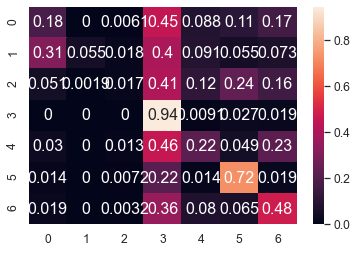

	training epoch=8 .. train_loss=1.245
	validation epoch=8 .. val_loss=1.503
	Accuracy = 46.300000000000004 % .. Percision = 49.9 % .. Recall = 37.4 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_8.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 9 .. loss = 1.083


  0%|                                                                                 | 1/1914 [00:01<37:56,  1.19s/it]

training @ epoch 9 .. loss = 1.425


  0%|                                                                                 | 2/1914 [00:02<38:35,  1.21s/it]

training @ epoch 9 .. loss = 1.186


  0%|▏                                                                                | 3/1914 [00:03<38:41,  1.21s/it]

training @ epoch 9 .. loss = 0.689


  0%|▏                                                                                | 4/1914 [00:04<38:17,  1.20s/it]

training @ epoch 9 .. loss = 1.018


  0%|▏                                                                                | 5/1914 [00:06<37:55,  1.19s/it]

training @ epoch 9 .. loss = 1.612


  0%|▎                                                                                | 6/1914 [00:07<38:06,  1.20s/it]

training @ epoch 9 .. loss = 1.385


  0%|▎                                                                                | 7/1914 [00:08<37:43,  1.19s/it]

training @ epoch 9 .. loss = 1.27


  0%|▎                                                                                | 8/1914 [00:09<37:53,  1.19s/it]

training @ epoch 9 .. loss = 1.595


  0%|▍                                                                                | 9/1914 [00:10<37:47,  1.19s/it]

training @ epoch 9 .. loss = 1.533


  1%|▍                                                                               | 10/1914 [00:11<38:00,  1.20s/it]

training @ epoch 9 .. loss = 1.443


  1%|▍                                                                               | 11/1914 [00:13<37:50,  1.19s/it]

training @ epoch 9 .. loss = 1.176


  1%|▌                                                                               | 12/1914 [00:14<37:53,  1.20s/it]

training @ epoch 9 .. loss = 1.606


  1%|▌                                                                               | 13/1914 [00:15<38:02,  1.20s/it]

training @ epoch 9 .. loss = 1.342


  1%|▌                                                                               | 14/1914 [00:16<38:13,  1.21s/it]

training @ epoch 9 .. loss = 1.042


  1%|▋                                                                               | 15/1914 [00:17<37:39,  1.19s/it]

training @ epoch 9 .. loss = 1.699


  1%|▋                                                                               | 16/1914 [00:19<37:45,  1.19s/it]

training @ epoch 9 .. loss = 1.001


  1%|▋                                                                               | 17/1914 [00:20<37:28,  1.19s/it]

training @ epoch 9 .. loss = 1.038


  1%|▊                                                                               | 18/1914 [00:21<37:16,  1.18s/it]

training @ epoch 9 .. loss = 1.03


  1%|▊                                                                               | 19/1914 [00:22<37:25,  1.19s/it]

training @ epoch 9 .. loss = 0.943


  1%|▊                                                                               | 20/1914 [00:23<37:22,  1.18s/it]

training @ epoch 9 .. loss = 1.856


  1%|▉                                                                               | 21/1914 [00:25<37:19,  1.18s/it]

training @ epoch 9 .. loss = 1.781


  1%|▉                                                                               | 22/1914 [00:26<37:24,  1.19s/it]

training @ epoch 9 .. loss = 1.339


  1%|▉                                                                               | 23/1914 [00:27<37:32,  1.19s/it]

training @ epoch 9 .. loss = 0.879


  1%|█                                                                               | 24/1914 [00:28<37:48,  1.20s/it]

training @ epoch 9 .. loss = 1.12


  1%|█                                                                               | 25/1914 [00:29<37:42,  1.20s/it]

training @ epoch 9 .. loss = 1.509


  1%|█                                                                               | 26/1914 [00:31<37:17,  1.19s/it]

training @ epoch 9 .. loss = 1.312


  1%|█▏                                                                              | 27/1914 [00:32<36:57,  1.18s/it]

training @ epoch 9 .. loss = 1.067


  1%|█▏                                                                              | 28/1914 [00:33<37:00,  1.18s/it]

training @ epoch 9 .. loss = 1.228


  2%|█▏                                                                              | 29/1914 [00:34<37:00,  1.18s/it]

training @ epoch 9 .. loss = 1.156


  2%|█▎                                                                              | 30/1914 [00:35<37:17,  1.19s/it]

training @ epoch 9 .. loss = 0.959


  2%|█▎                                                                              | 31/1914 [00:36<37:07,  1.18s/it]

training @ epoch 9 .. loss = 1.439


  2%|█▎                                                                              | 32/1914 [00:38<36:47,  1.17s/it]

training @ epoch 9 .. loss = 1.162


  2%|█▍                                                                              | 33/1914 [00:39<37:25,  1.19s/it]

training @ epoch 9 .. loss = 1.637


  2%|█▍                                                                              | 34/1914 [00:40<37:17,  1.19s/it]

training @ epoch 9 .. loss = 1.785


  2%|█▍                                                                              | 35/1914 [00:41<37:40,  1.20s/it]

training @ epoch 9 .. loss = 0.94


  2%|█▌                                                                              | 36/1914 [00:42<37:26,  1.20s/it]

training @ epoch 9 .. loss = 1.39


  2%|█▌                                                                              | 37/1914 [00:44<37:00,  1.18s/it]

training @ epoch 9 .. loss = 1.231


  2%|█▌                                                                              | 38/1914 [00:45<37:09,  1.19s/it]

training @ epoch 9 .. loss = 1.338


  2%|█▋                                                                              | 39/1914 [00:46<36:49,  1.18s/it]

training @ epoch 9 .. loss = 1.375


  2%|█▋                                                                              | 40/1914 [00:47<37:12,  1.19s/it]

training @ epoch 9 .. loss = 1.332


  2%|█▋                                                                              | 41/1914 [00:48<37:10,  1.19s/it]

training @ epoch 9 .. loss = 1.434


  2%|█▊                                                                              | 42/1914 [00:50<37:15,  1.19s/it]

training @ epoch 9 .. loss = 1.656


  2%|█▊                                                                              | 43/1914 [00:51<38:26,  1.23s/it]

training @ epoch 9 .. loss = 1.068


  2%|█▊                                                                              | 44/1914 [00:52<38:48,  1.25s/it]

training @ epoch 9 .. loss = 0.866


  2%|█▉                                                                              | 45/1914 [00:53<38:22,  1.23s/it]

training @ epoch 9 .. loss = 1.412


  2%|█▉                                                                              | 46/1914 [00:55<37:53,  1.22s/it]

training @ epoch 9 .. loss = 1.296


  2%|█▉                                                                              | 47/1914 [00:56<37:38,  1.21s/it]

training @ epoch 9 .. loss = 0.906


  3%|██                                                                              | 48/1914 [00:57<37:55,  1.22s/it]

training @ epoch 9 .. loss = 1.148


  3%|██                                                                              | 49/1914 [00:58<37:37,  1.21s/it]

training @ epoch 9 .. loss = 1.275


  3%|██                                                                              | 50/1914 [00:59<37:14,  1.20s/it]

training @ epoch 9 .. loss = 1.121


  3%|██▏                                                                             | 51/1914 [01:00<37:04,  1.19s/it]

training @ epoch 9 .. loss = 1.265


  3%|██▏                                                                             | 52/1914 [01:02<37:12,  1.20s/it]

training @ epoch 9 .. loss = 0.962


  3%|██▏                                                                             | 53/1914 [01:03<37:17,  1.20s/it]

training @ epoch 9 .. loss = 1.53


  3%|██▎                                                                             | 54/1914 [01:04<36:35,  1.18s/it]

training @ epoch 9 .. loss = 1.187


  3%|██▎                                                                             | 55/1914 [01:05<37:01,  1.19s/it]

training @ epoch 9 .. loss = 0.916


  3%|██▎                                                                             | 56/1914 [01:06<36:43,  1.19s/it]

training @ epoch 9 .. loss = 1.419


  3%|██▍                                                                             | 57/1914 [01:08<36:42,  1.19s/it]

training @ epoch 9 .. loss = 1.091


  3%|██▍                                                                             | 58/1914 [01:09<36:38,  1.18s/it]

training @ epoch 9 .. loss = 1.043


  3%|██▍                                                                             | 59/1914 [01:10<36:13,  1.17s/it]

training @ epoch 9 .. loss = 0.968


  3%|██▌                                                                             | 60/1914 [01:11<36:34,  1.18s/it]

training @ epoch 9 .. loss = 1.216


  3%|██▌                                                                             | 61/1914 [01:12<36:38,  1.19s/it]

training @ epoch 9 .. loss = 0.852


  3%|██▌                                                                             | 62/1914 [01:14<36:45,  1.19s/it]

training @ epoch 9 .. loss = 1.007


  3%|██▋                                                                             | 63/1914 [01:15<37:02,  1.20s/it]

training @ epoch 9 .. loss = 1.763


  3%|██▋                                                                             | 64/1914 [01:16<36:51,  1.20s/it]

training @ epoch 9 .. loss = 1.388


  3%|██▋                                                                             | 65/1914 [01:17<37:26,  1.22s/it]

training @ epoch 9 .. loss = 0.967


  3%|██▊                                                                             | 66/1914 [01:18<37:00,  1.20s/it]

training @ epoch 9 .. loss = 1.138


  4%|██▊                                                                             | 67/1914 [01:20<37:00,  1.20s/it]

training @ epoch 9 .. loss = 1.454


  4%|██▊                                                                             | 68/1914 [01:21<36:41,  1.19s/it]

training @ epoch 9 .. loss = 1.156


  4%|██▉                                                                             | 69/1914 [01:22<36:34,  1.19s/it]

training @ epoch 9 .. loss = 1.159


  4%|██▉                                                                             | 70/1914 [01:23<36:35,  1.19s/it]

training @ epoch 9 .. loss = 0.99


  4%|██▉                                                                             | 71/1914 [01:24<36:30,  1.19s/it]

training @ epoch 9 .. loss = 1.148


  4%|███                                                                             | 72/1914 [01:25<36:24,  1.19s/it]

training @ epoch 9 .. loss = 0.79


  4%|███                                                                             | 73/1914 [01:27<36:54,  1.20s/it]

training @ epoch 9 .. loss = 1.308


  4%|███                                                                             | 74/1914 [01:28<36:14,  1.18s/it]

training @ epoch 9 .. loss = 1.175


  4%|███▏                                                                            | 75/1914 [01:29<36:23,  1.19s/it]

training @ epoch 9 .. loss = 0.954


  4%|███▏                                                                            | 76/1914 [01:30<36:09,  1.18s/it]

training @ epoch 9 .. loss = 1.242


  4%|███▏                                                                            | 77/1914 [01:31<35:55,  1.17s/it]

training @ epoch 9 .. loss = 0.883


  4%|███▎                                                                            | 78/1914 [01:33<36:21,  1.19s/it]

training @ epoch 9 .. loss = 1.025


  4%|███▎                                                                            | 79/1914 [01:34<36:21,  1.19s/it]

training @ epoch 9 .. loss = 1.169


  4%|███▎                                                                            | 80/1914 [01:35<36:19,  1.19s/it]

training @ epoch 9 .. loss = 1.045


  4%|███▍                                                                            | 81/1914 [01:36<36:42,  1.20s/it]

training @ epoch 9 .. loss = 1.38


  4%|███▍                                                                            | 82/1914 [01:37<36:19,  1.19s/it]

training @ epoch 9 .. loss = 1.27


  4%|███▍                                                                            | 83/1914 [01:39<36:14,  1.19s/it]

training @ epoch 9 .. loss = 0.736


  4%|███▌                                                                            | 84/1914 [01:40<36:09,  1.19s/it]

training @ epoch 9 .. loss = 1.133


  4%|███▌                                                                            | 85/1914 [01:41<36:22,  1.19s/it]

training @ epoch 9 .. loss = 1.581


  4%|███▌                                                                            | 86/1914 [01:42<36:48,  1.21s/it]

training @ epoch 9 .. loss = 1.237


  5%|███▋                                                                            | 87/1914 [01:43<36:26,  1.20s/it]

training @ epoch 9 .. loss = 1.604


  5%|███▋                                                                            | 88/1914 [01:45<36:04,  1.19s/it]

training @ epoch 9 .. loss = 0.85


  5%|███▋                                                                            | 89/1914 [01:46<35:57,  1.18s/it]

training @ epoch 9 .. loss = 1.172


  5%|███▊                                                                            | 90/1914 [01:47<36:16,  1.19s/it]

training @ epoch 9 .. loss = 1.07


  5%|███▊                                                                            | 91/1914 [01:48<36:15,  1.19s/it]

training @ epoch 9 .. loss = 1.267


  5%|███▊                                                                            | 92/1914 [01:49<36:25,  1.20s/it]

training @ epoch 9 .. loss = 1.185


  5%|███▉                                                                            | 93/1914 [01:51<36:14,  1.19s/it]

training @ epoch 9 .. loss = 0.966


  5%|███▉                                                                            | 94/1914 [01:52<35:49,  1.18s/it]

training @ epoch 9 .. loss = 0.913


  5%|███▉                                                                            | 95/1914 [01:53<35:56,  1.19s/it]

training @ epoch 9 .. loss = 1.172


  5%|████                                                                            | 96/1914 [01:54<35:58,  1.19s/it]

training @ epoch 9 .. loss = 1.095


  5%|████                                                                            | 97/1914 [01:55<36:27,  1.20s/it]

training @ epoch 9 .. loss = 1.409


  5%|████                                                                            | 98/1914 [01:56<36:07,  1.19s/it]

training @ epoch 9 .. loss = 0.65


  5%|████▏                                                                           | 99/1914 [01:58<36:02,  1.19s/it]

training @ epoch 9 .. loss = 1.323


  5%|████▏                                                                          | 100/1914 [01:59<35:59,  1.19s/it]

training @ epoch 9 .. loss = 1.54


  5%|████▏                                                                          | 101/1914 [02:00<35:49,  1.19s/it]

training @ epoch 9 .. loss = 1.024


  5%|████▏                                                                          | 102/1914 [02:01<36:12,  1.20s/it]

training @ epoch 9 .. loss = 1.255


  5%|████▎                                                                          | 103/1914 [02:02<36:18,  1.20s/it]

training @ epoch 9 .. loss = 1.63


  5%|████▎                                                                          | 104/1914 [02:04<35:48,  1.19s/it]

training @ epoch 9 .. loss = 1.309


  5%|████▎                                                                          | 105/1914 [02:05<35:50,  1.19s/it]

training @ epoch 9 .. loss = 1.296


  6%|████▍                                                                          | 106/1914 [02:06<35:12,  1.17s/it]

training @ epoch 9 .. loss = 1.228


  6%|████▍                                                                          | 107/1914 [02:07<35:36,  1.18s/it]

training @ epoch 9 .. loss = 1.417


  6%|████▍                                                                          | 108/1914 [02:08<35:57,  1.19s/it]

training @ epoch 9 .. loss = 1.185


  6%|████▍                                                                          | 109/1914 [02:10<35:32,  1.18s/it]

training @ epoch 9 .. loss = 1.234


  6%|████▌                                                                          | 110/1914 [02:11<35:48,  1.19s/it]

training @ epoch 9 .. loss = 1.414


  6%|████▌                                                                          | 111/1914 [02:12<35:53,  1.19s/it]

training @ epoch 9 .. loss = 1.832


  6%|████▌                                                                          | 112/1914 [02:13<35:45,  1.19s/it]

training @ epoch 9 .. loss = 1.234


  6%|████▋                                                                          | 113/1914 [02:14<36:01,  1.20s/it]

training @ epoch 9 .. loss = 1.275


  6%|████▋                                                                          | 114/1914 [02:16<35:56,  1.20s/it]

training @ epoch 9 .. loss = 1.158


  6%|████▋                                                                          | 115/1914 [02:17<36:19,  1.21s/it]

training @ epoch 9 .. loss = 1.027


  6%|████▊                                                                          | 116/1914 [02:18<36:10,  1.21s/it]

training @ epoch 9 .. loss = 1.229


  6%|████▊                                                                          | 117/1914 [02:19<36:27,  1.22s/it]

training @ epoch 9 .. loss = 0.917


  6%|████▊                                                                          | 118/1914 [02:20<36:13,  1.21s/it]

training @ epoch 9 .. loss = 0.976


  6%|████▉                                                                          | 119/1914 [02:22<36:02,  1.21s/it]

training @ epoch 9 .. loss = 0.872


  6%|████▉                                                                          | 120/1914 [02:23<35:54,  1.20s/it]

training @ epoch 9 .. loss = 1.151


  6%|████▉                                                                          | 121/1914 [02:24<35:26,  1.19s/it]

training @ epoch 9 .. loss = 1.886


  6%|█████                                                                          | 122/1914 [02:25<35:29,  1.19s/it]

training @ epoch 9 .. loss = 1.347


  6%|█████                                                                          | 123/1914 [02:26<35:23,  1.19s/it]

training @ epoch 9 .. loss = 1.48


  6%|█████                                                                          | 124/1914 [02:27<35:20,  1.18s/it]

training @ epoch 9 .. loss = 1.288


  7%|█████▏                                                                         | 125/1914 [02:29<36:00,  1.21s/it]

training @ epoch 9 .. loss = 1.329


  7%|█████▏                                                                         | 126/1914 [02:30<35:38,  1.20s/it]

training @ epoch 9 .. loss = 1.453


  7%|█████▏                                                                         | 127/1914 [02:31<35:45,  1.20s/it]

training @ epoch 9 .. loss = 1.239


  7%|█████▎                                                                         | 128/1914 [02:32<35:32,  1.19s/it]

training @ epoch 9 .. loss = 1.31


  7%|█████▎                                                                         | 129/1914 [02:33<35:03,  1.18s/it]

training @ epoch 9 .. loss = 1.56


  7%|█████▎                                                                         | 130/1914 [02:35<35:14,  1.19s/it]

training @ epoch 9 .. loss = 1.175


  7%|█████▍                                                                         | 131/1914 [02:36<35:38,  1.20s/it]

training @ epoch 9 .. loss = 1.078


  7%|█████▍                                                                         | 132/1914 [02:37<35:43,  1.20s/it]

training @ epoch 9 .. loss = 1.618


  7%|█████▍                                                                         | 133/1914 [02:38<35:42,  1.20s/it]

training @ epoch 9 .. loss = 1.523


  7%|█████▌                                                                         | 134/1914 [02:39<35:23,  1.19s/it]

training @ epoch 9 .. loss = 1.119


  7%|█████▌                                                                         | 135/1914 [02:41<35:34,  1.20s/it]

training @ epoch 9 .. loss = 1.572


  7%|█████▌                                                                         | 136/1914 [02:42<35:10,  1.19s/it]

training @ epoch 9 .. loss = 1.504


  7%|█████▋                                                                         | 137/1914 [02:43<35:23,  1.19s/it]

training @ epoch 9 .. loss = 1.597


  7%|█████▋                                                                         | 138/1914 [02:44<35:15,  1.19s/it]

training @ epoch 9 .. loss = 1.287


  7%|█████▋                                                                         | 139/1914 [02:45<35:19,  1.19s/it]

training @ epoch 9 .. loss = 0.923


  7%|█████▊                                                                         | 140/1914 [02:47<35:33,  1.20s/it]

training @ epoch 9 .. loss = 1.072


  7%|█████▊                                                                         | 141/1914 [02:48<35:31,  1.20s/it]

training @ epoch 9 .. loss = 1.175


  7%|█████▊                                                                         | 142/1914 [02:49<35:35,  1.21s/it]

training @ epoch 9 .. loss = 0.966


  7%|█████▉                                                                         | 143/1914 [02:50<36:14,  1.23s/it]

training @ epoch 9 .. loss = 0.831


  8%|█████▉                                                                         | 144/1914 [02:52<35:54,  1.22s/it]

training @ epoch 9 .. loss = 1.164


  8%|█████▉                                                                         | 145/1914 [02:53<35:50,  1.22s/it]

training @ epoch 9 .. loss = 0.882


  8%|██████                                                                         | 146/1914 [02:54<35:26,  1.20s/it]

training @ epoch 9 .. loss = 1.157


  8%|██████                                                                         | 147/1914 [02:55<35:41,  1.21s/it]

training @ epoch 9 .. loss = 1.467


  8%|██████                                                                         | 148/1914 [02:56<35:33,  1.21s/it]

training @ epoch 9 .. loss = 1.48


  8%|██████▏                                                                        | 149/1914 [02:58<35:23,  1.20s/it]

training @ epoch 9 .. loss = 1.131


  8%|██████▏                                                                        | 150/1914 [02:59<35:25,  1.20s/it]

training @ epoch 9 .. loss = 1.243


  8%|██████▏                                                                        | 151/1914 [03:00<35:00,  1.19s/it]

training @ epoch 9 .. loss = 1.024


  8%|██████▎                                                                        | 152/1914 [03:01<35:21,  1.20s/it]

training @ epoch 9 .. loss = 1.244


  8%|██████▎                                                                        | 153/1914 [03:02<35:13,  1.20s/it]

training @ epoch 9 .. loss = 1.651


  8%|██████▎                                                                        | 154/1914 [03:04<34:50,  1.19s/it]

training @ epoch 9 .. loss = 1.192


  8%|██████▍                                                                        | 155/1914 [03:05<34:57,  1.19s/it]

training @ epoch 9 .. loss = 1.52


  8%|██████▍                                                                        | 156/1914 [03:06<34:48,  1.19s/it]

training @ epoch 9 .. loss = 1.654


  8%|██████▍                                                                        | 157/1914 [03:07<35:10,  1.20s/it]

training @ epoch 9 .. loss = 1.098


  8%|██████▌                                                                        | 158/1914 [03:08<34:59,  1.20s/it]

training @ epoch 9 .. loss = 1.154


  8%|██████▌                                                                        | 159/1914 [03:09<34:40,  1.19s/it]

training @ epoch 9 .. loss = 1.166


  8%|██████▌                                                                        | 160/1914 [03:11<34:53,  1.19s/it]

training @ epoch 9 .. loss = 1.409


  8%|██████▋                                                                        | 161/1914 [03:12<34:51,  1.19s/it]

training @ epoch 9 .. loss = 1.304


  8%|██████▋                                                                        | 162/1914 [03:13<35:37,  1.22s/it]

training @ epoch 9 .. loss = 1.073


  9%|██████▋                                                                        | 163/1914 [03:14<35:27,  1.21s/it]

training @ epoch 9 .. loss = 1.384


  9%|██████▊                                                                        | 164/1914 [03:16<35:12,  1.21s/it]

training @ epoch 9 .. loss = 1.295


  9%|██████▊                                                                        | 165/1914 [03:17<35:15,  1.21s/it]

training @ epoch 9 .. loss = 1.226


  9%|██████▊                                                                        | 166/1914 [03:18<35:03,  1.20s/it]

training @ epoch 9 .. loss = 1.405


  9%|██████▉                                                                        | 167/1914 [03:19<34:57,  1.20s/it]

training @ epoch 9 .. loss = 0.968


  9%|██████▉                                                                        | 168/1914 [03:20<34:42,  1.19s/it]

training @ epoch 9 .. loss = 1.866


  9%|██████▉                                                                        | 169/1914 [03:21<34:23,  1.18s/it]

training @ epoch 9 .. loss = 1.379


  9%|███████                                                                        | 170/1914 [03:23<34:27,  1.19s/it]

training @ epoch 9 .. loss = 1.673


  9%|███████                                                                        | 171/1914 [03:24<34:23,  1.18s/it]

training @ epoch 9 .. loss = 1.334


  9%|███████                                                                        | 172/1914 [03:25<34:42,  1.20s/it]

training @ epoch 9 .. loss = 0.916


  9%|███████▏                                                                       | 173/1914 [03:26<34:40,  1.19s/it]

training @ epoch 9 .. loss = 1.207


  9%|███████▏                                                                       | 174/1914 [03:27<34:23,  1.19s/it]

training @ epoch 9 .. loss = 1.706


  9%|███████▏                                                                       | 175/1914 [03:29<34:33,  1.19s/it]

training @ epoch 9 .. loss = 1.274


  9%|███████▎                                                                       | 176/1914 [03:30<34:22,  1.19s/it]

training @ epoch 9 .. loss = 0.972


  9%|███████▎                                                                       | 177/1914 [03:31<34:23,  1.19s/it]

training @ epoch 9 .. loss = 1.223


  9%|███████▎                                                                       | 178/1914 [03:32<34:29,  1.19s/it]

training @ epoch 9 .. loss = 0.934


  9%|███████▍                                                                       | 179/1914 [03:33<34:26,  1.19s/it]

training @ epoch 9 .. loss = 1.022


  9%|███████▍                                                                       | 180/1914 [03:35<34:26,  1.19s/it]

training @ epoch 9 .. loss = 1.519


  9%|███████▍                                                                       | 181/1914 [03:36<34:42,  1.20s/it]

training @ epoch 9 .. loss = 1.563


 10%|███████▌                                                                       | 182/1914 [03:37<34:48,  1.21s/it]

training @ epoch 9 .. loss = 0.78


 10%|███████▌                                                                       | 183/1914 [03:38<34:35,  1.20s/it]

training @ epoch 9 .. loss = 1.401


 10%|███████▌                                                                       | 184/1914 [03:39<34:19,  1.19s/it]

training @ epoch 9 .. loss = 1.286


 10%|███████▋                                                                       | 185/1914 [03:41<34:05,  1.18s/it]

training @ epoch 9 .. loss = 1.406


 10%|███████▋                                                                       | 186/1914 [03:42<34:06,  1.18s/it]

training @ epoch 9 .. loss = 1.442


 10%|███████▋                                                                       | 187/1914 [03:43<34:24,  1.20s/it]

training @ epoch 9 .. loss = 0.803


 10%|███████▊                                                                       | 188/1914 [03:44<33:57,  1.18s/it]

training @ epoch 9 .. loss = 0.936


 10%|███████▊                                                                       | 189/1914 [03:45<34:09,  1.19s/it]

training @ epoch 9 .. loss = 0.889


 10%|███████▊                                                                       | 190/1914 [03:46<34:00,  1.18s/it]

training @ epoch 9 .. loss = 1.334


 10%|███████▉                                                                       | 191/1914 [03:48<33:58,  1.18s/it]

training @ epoch 9 .. loss = 0.946


 10%|███████▉                                                                       | 192/1914 [03:49<34:38,  1.21s/it]

training @ epoch 9 .. loss = 1.246


 10%|███████▉                                                                       | 193/1914 [03:50<34:29,  1.20s/it]

training @ epoch 9 .. loss = 1.422


 10%|████████                                                                       | 194/1914 [03:51<34:23,  1.20s/it]

training @ epoch 9 .. loss = 1.005


 10%|████████                                                                       | 195/1914 [03:53<34:19,  1.20s/it]

training @ epoch 9 .. loss = 1.354


 10%|████████                                                                       | 196/1914 [03:54<35:35,  1.24s/it]

training @ epoch 9 .. loss = 0.875


 10%|████████▏                                                                      | 197/1914 [03:55<37:02,  1.29s/it]

training @ epoch 9 .. loss = 0.694


 10%|████████▏                                                                      | 198/1914 [03:57<37:00,  1.29s/it]

training @ epoch 9 .. loss = 1.794


 10%|████████▏                                                                      | 199/1914 [03:58<35:55,  1.26s/it]

training @ epoch 9 .. loss = 1.314


 10%|████████▎                                                                      | 200/1914 [03:59<35:26,  1.24s/it]

training @ epoch 9 .. loss = 1.483


 11%|████████▎                                                                      | 201/1914 [04:00<35:14,  1.23s/it]

training @ epoch 9 .. loss = 1.348


 11%|████████▎                                                                      | 202/1914 [04:01<34:55,  1.22s/it]

training @ epoch 9 .. loss = 1.304


 11%|████████▍                                                                      | 203/1914 [04:03<34:38,  1.21s/it]

training @ epoch 9 .. loss = 1.069


 11%|████████▍                                                                      | 204/1914 [04:04<34:31,  1.21s/it]

training @ epoch 9 .. loss = 0.993


 11%|████████▍                                                                      | 205/1914 [04:05<34:33,  1.21s/it]

training @ epoch 9 .. loss = 1.208


 11%|████████▌                                                                      | 206/1914 [04:06<34:26,  1.21s/it]

training @ epoch 9 .. loss = 0.834


 11%|████████▌                                                                      | 207/1914 [04:07<34:29,  1.21s/it]

training @ epoch 9 .. loss = 1.458


 11%|████████▌                                                                      | 208/1914 [04:09<34:23,  1.21s/it]

training @ epoch 9 .. loss = 1.195


 11%|████████▋                                                                      | 209/1914 [04:10<34:22,  1.21s/it]

training @ epoch 9 .. loss = 1.814


 11%|████████▋                                                                      | 210/1914 [04:11<34:13,  1.21s/it]

training @ epoch 9 .. loss = 1.176


 11%|████████▋                                                                      | 211/1914 [04:12<33:55,  1.20s/it]

training @ epoch 9 .. loss = 1.316


 11%|████████▊                                                                      | 212/1914 [04:13<33:57,  1.20s/it]

training @ epoch 9 .. loss = 0.902


 11%|████████▊                                                                      | 213/1914 [04:15<34:15,  1.21s/it]

training @ epoch 9 .. loss = 1.086


 11%|████████▊                                                                      | 214/1914 [04:16<34:08,  1.21s/it]

training @ epoch 9 .. loss = 0.976


 11%|████████▊                                                                      | 215/1914 [04:17<34:09,  1.21s/it]

training @ epoch 9 .. loss = 1.026


 11%|████████▉                                                                      | 216/1914 [04:18<33:56,  1.20s/it]

training @ epoch 9 .. loss = 1.041


 11%|████████▉                                                                      | 217/1914 [04:19<34:15,  1.21s/it]

training @ epoch 9 .. loss = 1.395


 11%|████████▉                                                                      | 218/1914 [04:21<33:57,  1.20s/it]

training @ epoch 9 .. loss = 1.353


 11%|█████████                                                                      | 219/1914 [04:22<33:50,  1.20s/it]

training @ epoch 9 .. loss = 1.303


 11%|█████████                                                                      | 220/1914 [04:23<33:57,  1.20s/it]

training @ epoch 9 .. loss = 1.03


 12%|█████████                                                                      | 221/1914 [04:24<33:59,  1.20s/it]

training @ epoch 9 .. loss = 0.927


 12%|█████████▏                                                                     | 222/1914 [04:25<33:55,  1.20s/it]

training @ epoch 9 .. loss = 1.219


 12%|█████████▏                                                                     | 223/1914 [04:27<33:49,  1.20s/it]

training @ epoch 9 .. loss = 1.302


 12%|█████████▏                                                                     | 224/1914 [04:28<33:48,  1.20s/it]

training @ epoch 9 .. loss = 1.249


 12%|█████████▎                                                                     | 225/1914 [04:29<34:09,  1.21s/it]

training @ epoch 9 .. loss = 1.032


 12%|█████████▎                                                                     | 226/1914 [04:30<34:16,  1.22s/it]

training @ epoch 9 .. loss = 1.345


 12%|█████████▎                                                                     | 227/1914 [04:31<33:51,  1.20s/it]

training @ epoch 9 .. loss = 1.159


 12%|█████████▍                                                                     | 228/1914 [04:33<33:49,  1.20s/it]

training @ epoch 9 .. loss = 1.446


 12%|█████████▍                                                                     | 229/1914 [04:34<33:26,  1.19s/it]

training @ epoch 9 .. loss = 1.384


 12%|█████████▍                                                                     | 230/1914 [04:35<33:49,  1.21s/it]

training @ epoch 9 .. loss = 0.933


 12%|█████████▌                                                                     | 231/1914 [04:36<33:38,  1.20s/it]

training @ epoch 9 .. loss = 1.174


 12%|█████████▌                                                                     | 232/1914 [04:37<33:16,  1.19s/it]

training @ epoch 9 .. loss = 1.151


 12%|█████████▌                                                                     | 233/1914 [04:39<33:14,  1.19s/it]

training @ epoch 9 .. loss = 0.942


 12%|█████████▋                                                                     | 234/1914 [04:40<33:26,  1.19s/it]

training @ epoch 9 .. loss = 1.209


 12%|█████████▋                                                                     | 235/1914 [04:41<33:43,  1.21s/it]

training @ epoch 9 .. loss = 1.398


 12%|█████████▋                                                                     | 236/1914 [04:42<33:40,  1.20s/it]

training @ epoch 9 .. loss = 0.892


 12%|█████████▊                                                                     | 237/1914 [04:43<33:29,  1.20s/it]

training @ epoch 9 .. loss = 1.527


 12%|█████████▊                                                                     | 238/1914 [04:45<33:29,  1.20s/it]

training @ epoch 9 .. loss = 1.205


 12%|█████████▊                                                                     | 239/1914 [04:46<34:01,  1.22s/it]

training @ epoch 9 .. loss = 1.165


 13%|█████████▉                                                                     | 240/1914 [04:47<34:36,  1.24s/it]

training @ epoch 9 .. loss = 1.969


 13%|█████████▉                                                                     | 241/1914 [04:49<35:22,  1.27s/it]

training @ epoch 9 .. loss = 1.261


 13%|█████████▉                                                                     | 242/1914 [04:50<35:29,  1.27s/it]

training @ epoch 9 .. loss = 0.769


 13%|██████████                                                                     | 243/1914 [04:51<36:03,  1.29s/it]

training @ epoch 9 .. loss = 1.3


 13%|██████████                                                                     | 244/1914 [04:52<36:01,  1.29s/it]

training @ epoch 9 .. loss = 1.435


 13%|██████████                                                                     | 245/1914 [04:54<35:48,  1.29s/it]

training @ epoch 9 .. loss = 1.868


 13%|██████████▏                                                                    | 246/1914 [04:55<35:51,  1.29s/it]

training @ epoch 9 .. loss = 1.309


 13%|██████████▏                                                                    | 247/1914 [04:56<35:41,  1.28s/it]

training @ epoch 9 .. loss = 1.314


 13%|██████████▏                                                                    | 248/1914 [04:58<35:29,  1.28s/it]

training @ epoch 9 .. loss = 1.204


 13%|██████████▎                                                                    | 249/1914 [04:59<35:39,  1.29s/it]

training @ epoch 9 .. loss = 1.214


 13%|██████████▎                                                                    | 250/1914 [05:00<35:43,  1.29s/it]

training @ epoch 9 .. loss = 0.964


 13%|██████████▎                                                                    | 251/1914 [05:01<35:55,  1.30s/it]

training @ epoch 9 .. loss = 0.9


 13%|██████████▍                                                                    | 252/1914 [05:03<35:46,  1.29s/it]

training @ epoch 9 .. loss = 0.744


 13%|██████████▍                                                                    | 253/1914 [05:04<35:26,  1.28s/it]

training @ epoch 9 .. loss = 1.222


 13%|██████████▍                                                                    | 254/1914 [05:05<35:37,  1.29s/it]

training @ epoch 9 .. loss = 1.292


 13%|██████████▌                                                                    | 255/1914 [05:07<35:17,  1.28s/it]

training @ epoch 9 .. loss = 1.519


 13%|██████████▌                                                                    | 256/1914 [05:08<35:29,  1.28s/it]

training @ epoch 9 .. loss = 1.345


 13%|██████████▌                                                                    | 257/1914 [05:09<35:52,  1.30s/it]

training @ epoch 9 .. loss = 1.344


 13%|██████████▋                                                                    | 258/1914 [05:10<35:24,  1.28s/it]

training @ epoch 9 .. loss = 1.797


 14%|██████████▋                                                                    | 259/1914 [05:12<35:27,  1.29s/it]

training @ epoch 9 .. loss = 1.178


 14%|██████████▋                                                                    | 260/1914 [05:13<35:30,  1.29s/it]

training @ epoch 9 .. loss = 1.162


 14%|██████████▊                                                                    | 261/1914 [05:14<35:46,  1.30s/it]

training @ epoch 9 .. loss = 1.239


 14%|██████████▊                                                                    | 262/1914 [05:16<35:22,  1.28s/it]

training @ epoch 9 .. loss = 1.142


 14%|██████████▊                                                                    | 263/1914 [05:17<35:20,  1.28s/it]

training @ epoch 9 .. loss = 1.144


 14%|██████████▉                                                                    | 264/1914 [05:18<35:33,  1.29s/it]

training @ epoch 9 .. loss = 1.336


 14%|██████████▉                                                                    | 265/1914 [05:19<35:32,  1.29s/it]

training @ epoch 9 .. loss = 1.053


 14%|██████████▉                                                                    | 266/1914 [05:21<35:36,  1.30s/it]

training @ epoch 9 .. loss = 1.748


 14%|███████████                                                                    | 267/1914 [05:22<35:18,  1.29s/it]

training @ epoch 9 .. loss = 1.337


 14%|███████████                                                                    | 268/1914 [05:23<35:20,  1.29s/it]

training @ epoch 9 .. loss = 1.62


 14%|███████████                                                                    | 269/1914 [05:25<34:51,  1.27s/it]

training @ epoch 9 .. loss = 1.365


 14%|███████████▏                                                                   | 270/1914 [05:26<35:05,  1.28s/it]

training @ epoch 9 .. loss = 1.077


 14%|███████████▏                                                                   | 271/1914 [05:27<35:16,  1.29s/it]

training @ epoch 9 .. loss = 1.654


 14%|███████████▏                                                                   | 272/1914 [05:28<35:07,  1.28s/it]

training @ epoch 9 .. loss = 1.525


 14%|███████████▎                                                                   | 273/1914 [05:30<34:56,  1.28s/it]

training @ epoch 9 .. loss = 1.221


 14%|███████████▎                                                                   | 274/1914 [05:31<35:47,  1.31s/it]

training @ epoch 9 .. loss = 1.185


 14%|███████████▎                                                                   | 275/1914 [05:32<35:43,  1.31s/it]

training @ epoch 9 .. loss = 1.33


 14%|███████████▍                                                                   | 276/1914 [05:34<35:30,  1.30s/it]

training @ epoch 9 .. loss = 1.238


 14%|███████████▍                                                                   | 277/1914 [05:35<35:15,  1.29s/it]

training @ epoch 9 .. loss = 1.053


 15%|███████████▍                                                                   | 278/1914 [05:36<34:32,  1.27s/it]

training @ epoch 9 .. loss = 1.344


 15%|███████████▌                                                                   | 279/1914 [05:37<34:08,  1.25s/it]

training @ epoch 9 .. loss = 0.929


 15%|███████████▌                                                                   | 280/1914 [05:39<34:00,  1.25s/it]

training @ epoch 9 .. loss = 1.855


 15%|███████████▌                                                                   | 281/1914 [05:40<33:30,  1.23s/it]

training @ epoch 9 .. loss = 1.506


 15%|███████████▋                                                                   | 282/1914 [05:41<33:19,  1.23s/it]

training @ epoch 9 .. loss = 1.075


 15%|███████████▋                                                                   | 283/1914 [05:42<33:07,  1.22s/it]

training @ epoch 9 .. loss = 1.158


 15%|███████████▋                                                                   | 284/1914 [05:43<32:38,  1.20s/it]

training @ epoch 9 .. loss = 1.056


 15%|███████████▊                                                                   | 285/1914 [05:45<32:26,  1.19s/it]

training @ epoch 9 .. loss = 1.202


 15%|███████████▊                                                                   | 286/1914 [05:46<32:20,  1.19s/it]

training @ epoch 9 .. loss = 0.958


 15%|███████████▊                                                                   | 287/1914 [05:47<32:29,  1.20s/it]

training @ epoch 9 .. loss = 1.281


 15%|███████████▉                                                                   | 288/1914 [05:48<32:19,  1.19s/it]

training @ epoch 9 .. loss = 1.176


 15%|███████████▉                                                                   | 289/1914 [05:49<32:28,  1.20s/it]

training @ epoch 9 .. loss = 1.064


 15%|███████████▉                                                                   | 290/1914 [05:51<32:09,  1.19s/it]

training @ epoch 9 .. loss = 1.123


 15%|████████████                                                                   | 291/1914 [05:52<32:19,  1.19s/it]

training @ epoch 9 .. loss = 0.796


 15%|████████████                                                                   | 292/1914 [05:53<32:58,  1.22s/it]

training @ epoch 9 .. loss = 1.281


 15%|████████████                                                                   | 293/1914 [05:54<32:48,  1.21s/it]

training @ epoch 9 .. loss = 1.149


 15%|████████████▏                                                                  | 294/1914 [05:55<32:35,  1.21s/it]

training @ epoch 9 .. loss = 1.369


 15%|████████████▏                                                                  | 295/1914 [05:57<32:13,  1.19s/it]

training @ epoch 9 .. loss = 1.47


 15%|████████████▏                                                                  | 296/1914 [05:58<32:10,  1.19s/it]

training @ epoch 9 .. loss = 1.364


 16%|████████████▎                                                                  | 297/1914 [05:59<32:04,  1.19s/it]

training @ epoch 9 .. loss = 0.869


 16%|████████████▎                                                                  | 298/1914 [06:00<31:58,  1.19s/it]

training @ epoch 9 .. loss = 0.763


 16%|████████████▎                                                                  | 299/1914 [06:01<32:08,  1.19s/it]

training @ epoch 9 .. loss = 1.382


 16%|████████████▍                                                                  | 300/1914 [06:03<32:07,  1.19s/it]

training @ epoch 9 .. loss = 1.102


 16%|████████████▍                                                                  | 301/1914 [06:04<31:52,  1.19s/it]

training @ epoch 9 .. loss = 1.511


 16%|████████████▍                                                                  | 302/1914 [06:05<32:30,  1.21s/it]

training @ epoch 9 .. loss = 1.168


 16%|████████████▌                                                                  | 303/1914 [06:06<33:18,  1.24s/it]

training @ epoch 9 .. loss = 1.48


 16%|████████████▌                                                                  | 304/1914 [06:08<34:16,  1.28s/it]

training @ epoch 9 .. loss = 1.544


 16%|████████████▌                                                                  | 305/1914 [06:09<33:42,  1.26s/it]

training @ epoch 9 .. loss = 1.541


 16%|████████████▋                                                                  | 306/1914 [06:10<33:16,  1.24s/it]

training @ epoch 9 .. loss = 0.956


 16%|████████████▋                                                                  | 307/1914 [06:11<33:16,  1.24s/it]

training @ epoch 9 .. loss = 1.091


 16%|████████████▋                                                                  | 308/1914 [06:13<34:12,  1.28s/it]

training @ epoch 9 .. loss = 1.216


 16%|████████████▊                                                                  | 309/1914 [06:14<35:50,  1.34s/it]

training @ epoch 9 .. loss = 1.222


 16%|████████████▊                                                                  | 310/1914 [06:15<35:36,  1.33s/it]

training @ epoch 9 .. loss = 0.928


 16%|████████████▊                                                                  | 311/1914 [06:17<34:39,  1.30s/it]

training @ epoch 9 .. loss = 1.084


 16%|████████████▉                                                                  | 312/1914 [06:18<34:01,  1.27s/it]

training @ epoch 9 .. loss = 1.396


 16%|████████████▉                                                                  | 313/1914 [06:19<33:34,  1.26s/it]

training @ epoch 9 .. loss = 1.043


 16%|████████████▉                                                                  | 314/1914 [06:20<33:44,  1.27s/it]

training @ epoch 9 .. loss = 1.394


 16%|█████████████                                                                  | 315/1914 [06:22<33:07,  1.24s/it]

training @ epoch 9 .. loss = 0.89


 17%|█████████████                                                                  | 316/1914 [06:23<32:52,  1.23s/it]

training @ epoch 9 .. loss = 1.413


 17%|█████████████                                                                  | 317/1914 [06:24<32:28,  1.22s/it]

training @ epoch 9 .. loss = 0.999


 17%|█████████████▏                                                                 | 318/1914 [06:25<32:42,  1.23s/it]

training @ epoch 9 .. loss = 1.209


 17%|█████████████▏                                                                 | 319/1914 [06:26<32:42,  1.23s/it]

training @ epoch 9 .. loss = 1.475


 17%|█████████████▏                                                                 | 320/1914 [06:28<32:08,  1.21s/it]

training @ epoch 9 .. loss = 1.265


 17%|█████████████▏                                                                 | 321/1914 [06:29<31:59,  1.20s/it]

training @ epoch 9 .. loss = 0.907


 17%|█████████████▎                                                                 | 322/1914 [06:30<31:40,  1.19s/it]

training @ epoch 9 .. loss = 1.081


 17%|█████████████▎                                                                 | 323/1914 [06:31<32:01,  1.21s/it]

training @ epoch 9 .. loss = 0.968


 17%|█████████████▎                                                                 | 324/1914 [06:32<31:49,  1.20s/it]

training @ epoch 9 .. loss = 1.517


 17%|█████████████▍                                                                 | 325/1914 [06:34<31:44,  1.20s/it]

training @ epoch 9 .. loss = 0.902


 17%|█████████████▍                                                                 | 326/1914 [06:35<31:40,  1.20s/it]

training @ epoch 9 .. loss = 1.254


 17%|█████████████▍                                                                 | 327/1914 [06:36<31:42,  1.20s/it]

training @ epoch 9 .. loss = 1.547


 17%|█████████████▌                                                                 | 328/1914 [06:37<31:57,  1.21s/it]

training @ epoch 9 .. loss = 1.396


 17%|█████████████▌                                                                 | 329/1914 [06:38<31:58,  1.21s/it]

training @ epoch 9 .. loss = 0.889


 17%|█████████████▌                                                                 | 330/1914 [06:40<31:18,  1.19s/it]

training @ epoch 9 .. loss = 1.19


 17%|█████████████▋                                                                 | 331/1914 [06:41<31:24,  1.19s/it]

training @ epoch 9 .. loss = 1.209


 17%|█████████████▋                                                                 | 332/1914 [06:42<31:29,  1.19s/it]

training @ epoch 9 .. loss = 1.182


 17%|█████████████▋                                                                 | 333/1914 [06:43<31:46,  1.21s/it]

training @ epoch 9 .. loss = 1.158


 17%|█████████████▊                                                                 | 334/1914 [06:44<31:43,  1.20s/it]

training @ epoch 9 .. loss = 1.077


 18%|█████████████▊                                                                 | 335/1914 [06:46<31:21,  1.19s/it]

training @ epoch 9 .. loss = 1.299


 18%|█████████████▊                                                                 | 336/1914 [06:47<32:28,  1.23s/it]

training @ epoch 9 .. loss = 0.858


 18%|█████████████▉                                                                 | 337/1914 [06:48<31:35,  1.20s/it]

training @ epoch 9 .. loss = 1.378


 18%|█████████████▉                                                                 | 338/1914 [06:49<31:42,  1.21s/it]

training @ epoch 9 .. loss = 1.167


 18%|█████████████▉                                                                 | 339/1914 [06:50<31:43,  1.21s/it]

training @ epoch 9 .. loss = 1.543


 18%|██████████████                                                                 | 340/1914 [06:52<31:21,  1.20s/it]

training @ epoch 9 .. loss = 0.943


 18%|██████████████                                                                 | 341/1914 [06:53<31:35,  1.21s/it]

training @ epoch 9 .. loss = 1.58


 18%|██████████████                                                                 | 342/1914 [06:54<31:06,  1.19s/it]

training @ epoch 9 .. loss = 1.303


 18%|██████████████▏                                                                | 343/1914 [06:55<31:41,  1.21s/it]

training @ epoch 9 .. loss = 1.117


 18%|██████████████▏                                                                | 344/1914 [06:56<31:36,  1.21s/it]

training @ epoch 9 .. loss = 1.151


 18%|██████████████▏                                                                | 345/1914 [06:58<31:32,  1.21s/it]

training @ epoch 9 .. loss = 0.909


 18%|██████████████▎                                                                | 346/1914 [06:59<31:24,  1.20s/it]

training @ epoch 9 .. loss = 1.871


 18%|██████████████▎                                                                | 347/1914 [07:00<31:23,  1.20s/it]

training @ epoch 9 .. loss = 0.91


 18%|██████████████▎                                                                | 348/1914 [07:01<31:46,  1.22s/it]

training @ epoch 9 .. loss = 0.846


 18%|██████████████▍                                                                | 349/1914 [07:03<31:38,  1.21s/it]

training @ epoch 9 .. loss = 1.337


 18%|██████████████▍                                                                | 350/1914 [07:04<31:17,  1.20s/it]

training @ epoch 9 .. loss = 0.994


 18%|██████████████▍                                                                | 351/1914 [07:05<31:25,  1.21s/it]

training @ epoch 9 .. loss = 1.066


 18%|██████████████▌                                                                | 352/1914 [07:06<31:27,  1.21s/it]

training @ epoch 9 .. loss = 1.092


 18%|██████████████▌                                                                | 353/1914 [07:07<31:37,  1.22s/it]

training @ epoch 9 .. loss = 1.47


 18%|██████████████▌                                                                | 354/1914 [07:09<31:21,  1.21s/it]

training @ epoch 9 .. loss = 1.635


 19%|██████████████▋                                                                | 355/1914 [07:10<31:03,  1.20s/it]

training @ epoch 9 .. loss = 1.114


 19%|██████████████▋                                                                | 356/1914 [07:11<31:25,  1.21s/it]

training @ epoch 9 .. loss = 1.065


 19%|██████████████▋                                                                | 357/1914 [07:12<31:14,  1.20s/it]

training @ epoch 9 .. loss = 0.936


 19%|██████████████▊                                                                | 358/1914 [07:13<31:36,  1.22s/it]

training @ epoch 9 .. loss = 1.633


 19%|██████████████▊                                                                | 359/1914 [07:15<31:42,  1.22s/it]

training @ epoch 9 .. loss = 1.04


 19%|██████████████▊                                                                | 360/1914 [07:16<30:57,  1.20s/it]

training @ epoch 9 .. loss = 1.36


 19%|██████████████▉                                                                | 361/1914 [07:17<31:22,  1.21s/it]

training @ epoch 9 .. loss = 1.293


 19%|██████████████▉                                                                | 362/1914 [07:18<31:22,  1.21s/it]

training @ epoch 9 .. loss = 0.851


 19%|██████████████▉                                                                | 363/1914 [07:19<31:11,  1.21s/it]

training @ epoch 9 .. loss = 1.398


 19%|███████████████                                                                | 364/1914 [07:21<31:13,  1.21s/it]

training @ epoch 9 .. loss = 0.964


 19%|███████████████                                                                | 365/1914 [07:22<30:36,  1.19s/it]

training @ epoch 9 .. loss = 1.759


 19%|███████████████                                                                | 366/1914 [07:23<30:55,  1.20s/it]

training @ epoch 9 .. loss = 1.183


 19%|███████████████▏                                                               | 367/1914 [07:24<31:02,  1.20s/it]

training @ epoch 9 .. loss = 1.091


 19%|███████████████▏                                                               | 368/1914 [07:25<31:06,  1.21s/it]

training @ epoch 9 .. loss = 1.086


 19%|███████████████▏                                                               | 369/1914 [07:27<31:01,  1.21s/it]

training @ epoch 9 .. loss = 1.419


 19%|███████████████▎                                                               | 370/1914 [07:28<30:26,  1.18s/it]

training @ epoch 9 .. loss = 1.419


 19%|███████████████▎                                                               | 371/1914 [07:29<30:30,  1.19s/it]

training @ epoch 9 .. loss = 0.763


 19%|███████████████▎                                                               | 372/1914 [07:30<30:15,  1.18s/it]

training @ epoch 9 .. loss = 1.335


 19%|███████████████▍                                                               | 373/1914 [07:31<30:37,  1.19s/it]

training @ epoch 9 .. loss = 1.4


 20%|███████████████▍                                                               | 374/1914 [07:33<30:51,  1.20s/it]

training @ epoch 9 .. loss = 1.249


 20%|███████████████▍                                                               | 375/1914 [07:34<30:30,  1.19s/it]

training @ epoch 9 .. loss = 1.075


 20%|███████████████▌                                                               | 376/1914 [07:35<30:44,  1.20s/it]

training @ epoch 9 .. loss = 0.79


 20%|███████████████▌                                                               | 377/1914 [07:36<30:36,  1.19s/it]

training @ epoch 9 .. loss = 0.895


 20%|███████████████▌                                                               | 378/1914 [07:37<31:14,  1.22s/it]

training @ epoch 9 .. loss = 0.834


 20%|███████████████▋                                                               | 379/1914 [07:39<31:15,  1.22s/it]

training @ epoch 9 .. loss = 0.827


 20%|███████████████▋                                                               | 380/1914 [07:40<30:45,  1.20s/it]

training @ epoch 9 .. loss = 1.122


 20%|███████████████▋                                                               | 381/1914 [07:41<30:48,  1.21s/it]

training @ epoch 9 .. loss = 0.986


 20%|███████████████▊                                                               | 382/1914 [07:42<30:54,  1.21s/it]

training @ epoch 9 .. loss = 1.179


 20%|███████████████▊                                                               | 383/1914 [07:43<30:39,  1.20s/it]

training @ epoch 9 .. loss = 1.394


 20%|███████████████▊                                                               | 384/1914 [07:45<30:24,  1.19s/it]

training @ epoch 9 .. loss = 1.601


 20%|███████████████▉                                                               | 385/1914 [07:46<29:59,  1.18s/it]

training @ epoch 9 .. loss = 1.686


 20%|███████████████▉                                                               | 386/1914 [07:47<30:23,  1.19s/it]

training @ epoch 9 .. loss = 1.59


 20%|███████████████▉                                                               | 387/1914 [07:48<30:05,  1.18s/it]

training @ epoch 9 .. loss = 1.092


 20%|████████████████                                                               | 388/1914 [07:49<30:18,  1.19s/it]

training @ epoch 9 .. loss = 1.074


 20%|████████████████                                                               | 389/1914 [07:51<30:22,  1.20s/it]

training @ epoch 9 .. loss = 1.402


 20%|████████████████                                                               | 390/1914 [07:52<30:05,  1.18s/it]

training @ epoch 9 .. loss = 1.047


 20%|████████████████▏                                                              | 391/1914 [07:53<30:17,  1.19s/it]

training @ epoch 9 .. loss = 1.059


 20%|████████████████▏                                                              | 392/1914 [07:54<30:18,  1.19s/it]

training @ epoch 9 .. loss = 1.484


 21%|████████████████▏                                                              | 393/1914 [07:55<30:56,  1.22s/it]

training @ epoch 9 .. loss = 1.037


 21%|████████████████▎                                                              | 394/1914 [07:57<30:27,  1.20s/it]

training @ epoch 9 .. loss = 1.544


 21%|████████████████▎                                                              | 395/1914 [07:58<30:04,  1.19s/it]

training @ epoch 9 .. loss = 1.151


 21%|████████████████▎                                                              | 396/1914 [07:59<30:07,  1.19s/it]

training @ epoch 9 .. loss = 1.53


 21%|████████████████▍                                                              | 397/1914 [08:00<29:47,  1.18s/it]

training @ epoch 9 .. loss = 0.961


 21%|████████████████▍                                                              | 398/1914 [08:01<30:23,  1.20s/it]

training @ epoch 9 .. loss = 1.108


 21%|████████████████▍                                                              | 399/1914 [08:03<30:26,  1.21s/it]

training @ epoch 9 .. loss = 1.295


 21%|████████████████▌                                                              | 400/1914 [08:04<29:50,  1.18s/it]

training @ epoch 9 .. loss = 1.154


 21%|████████████████▌                                                              | 401/1914 [08:05<29:35,  1.17s/it]

training @ epoch 9 .. loss = 1.242


 21%|████████████████▌                                                              | 402/1914 [08:06<29:44,  1.18s/it]

training @ epoch 9 .. loss = 1.215


 21%|████████████████▋                                                              | 403/1914 [08:07<29:53,  1.19s/it]

training @ epoch 9 .. loss = 0.99


 21%|████████████████▋                                                              | 404/1914 [08:08<30:04,  1.20s/it]

training @ epoch 9 .. loss = 1.061


 21%|████████████████▋                                                              | 405/1914 [08:10<29:53,  1.19s/it]

training @ epoch 9 .. loss = 1.165


 21%|████████████████▊                                                              | 406/1914 [08:11<29:57,  1.19s/it]

training @ epoch 9 .. loss = 1.025


 21%|████████████████▊                                                              | 407/1914 [08:12<29:46,  1.19s/it]

training @ epoch 9 .. loss = 1.41


 21%|████████████████▊                                                              | 408/1914 [08:13<29:52,  1.19s/it]

training @ epoch 9 .. loss = 1.141


 21%|████████████████▉                                                              | 409/1914 [08:14<29:50,  1.19s/it]

training @ epoch 9 .. loss = 1.174


 21%|████████████████▉                                                              | 410/1914 [08:16<29:44,  1.19s/it]

training @ epoch 9 .. loss = 1.218


 21%|████████████████▉                                                              | 411/1914 [08:17<29:44,  1.19s/it]

training @ epoch 9 .. loss = 0.782


 22%|█████████████████                                                              | 412/1914 [08:18<29:36,  1.18s/it]

training @ epoch 9 .. loss = 1.863


 22%|█████████████████                                                              | 413/1914 [08:19<29:40,  1.19s/it]

training @ epoch 9 .. loss = 1.151


 22%|█████████████████                                                              | 414/1914 [08:20<29:46,  1.19s/it]

training @ epoch 9 .. loss = 1.14


 22%|█████████████████▏                                                             | 415/1914 [08:22<30:11,  1.21s/it]

training @ epoch 9 .. loss = 1.544


 22%|█████████████████▏                                                             | 416/1914 [08:23<29:45,  1.19s/it]

training @ epoch 9 .. loss = 1.028


 22%|█████████████████▏                                                             | 417/1914 [08:24<29:33,  1.18s/it]

training @ epoch 9 .. loss = 0.878


 22%|█████████████████▎                                                             | 418/1914 [08:25<29:47,  1.20s/it]

training @ epoch 9 .. loss = 1.685


 22%|█████████████████▎                                                             | 419/1914 [08:26<29:51,  1.20s/it]

training @ epoch 9 .. loss = 1.112


 22%|█████████████████▎                                                             | 420/1914 [08:27<29:51,  1.20s/it]

training @ epoch 9 .. loss = 1.55


 22%|█████████████████▍                                                             | 421/1914 [08:29<29:29,  1.18s/it]

training @ epoch 9 .. loss = 1.611


 22%|█████████████████▍                                                             | 422/1914 [08:30<29:11,  1.17s/it]

training @ epoch 9 .. loss = 1.479


 22%|█████████████████▍                                                             | 423/1914 [08:31<29:33,  1.19s/it]

training @ epoch 9 .. loss = 1.301


 22%|█████████████████▌                                                             | 424/1914 [08:32<29:41,  1.20s/it]

training @ epoch 9 .. loss = 1.316


 22%|█████████████████▌                                                             | 425/1914 [08:33<29:48,  1.20s/it]

training @ epoch 9 .. loss = 1.355


 22%|█████████████████▌                                                             | 426/1914 [08:35<29:32,  1.19s/it]

training @ epoch 9 .. loss = 0.875


 22%|█████████████████▌                                                             | 427/1914 [08:36<29:26,  1.19s/it]

training @ epoch 9 .. loss = 0.921


 22%|█████████████████▋                                                             | 428/1914 [08:37<29:35,  1.19s/it]

training @ epoch 9 .. loss = 1.459


 22%|█████████████████▋                                                             | 429/1914 [08:38<30:00,  1.21s/it]

training @ epoch 9 .. loss = 1.431


 22%|█████████████████▋                                                             | 430/1914 [08:39<29:55,  1.21s/it]

training @ epoch 9 .. loss = 1.2


 23%|█████████████████▊                                                             | 431/1914 [08:41<30:00,  1.21s/it]

training @ epoch 9 .. loss = 1.38


 23%|█████████████████▊                                                             | 432/1914 [08:42<29:36,  1.20s/it]

training @ epoch 9 .. loss = 1.534


 23%|█████████████████▊                                                             | 433/1914 [08:43<29:43,  1.20s/it]

training @ epoch 9 .. loss = 1.0


 23%|█████████████████▉                                                             | 434/1914 [08:44<29:37,  1.20s/it]

training @ epoch 9 .. loss = 1.132


 23%|█████████████████▉                                                             | 435/1914 [08:45<29:41,  1.20s/it]

training @ epoch 9 .. loss = 1.962


 23%|█████████████████▉                                                             | 436/1914 [08:47<29:33,  1.20s/it]

training @ epoch 9 .. loss = 1.557


 23%|██████████████████                                                             | 437/1914 [08:48<29:42,  1.21s/it]

training @ epoch 9 .. loss = 1.241


 23%|██████████████████                                                             | 438/1914 [08:49<29:43,  1.21s/it]

training @ epoch 9 .. loss = 1.44


 23%|██████████████████                                                             | 439/1914 [08:50<30:33,  1.24s/it]

training @ epoch 9 .. loss = 1.323


 23%|██████████████████▏                                                            | 440/1914 [08:52<29:48,  1.21s/it]

training @ epoch 9 .. loss = 0.987


 23%|██████████████████▏                                                            | 441/1914 [08:53<29:29,  1.20s/it]

training @ epoch 9 .. loss = 1.104


 23%|██████████████████▏                                                            | 442/1914 [08:54<29:49,  1.22s/it]

training @ epoch 9 .. loss = 1.345


 23%|██████████████████▎                                                            | 443/1914 [08:55<30:08,  1.23s/it]

training @ epoch 9 .. loss = 1.358


 23%|██████████████████▎                                                            | 444/1914 [08:57<30:36,  1.25s/it]

training @ epoch 9 .. loss = 1.215


 23%|██████████████████▎                                                            | 445/1914 [08:58<29:43,  1.21s/it]

training @ epoch 9 .. loss = 1.139


 23%|██████████████████▍                                                            | 446/1914 [08:59<29:49,  1.22s/it]

training @ epoch 9 .. loss = 1.293


 23%|██████████████████▍                                                            | 447/1914 [09:00<29:30,  1.21s/it]

training @ epoch 9 .. loss = 1.247


 23%|██████████████████▍                                                            | 448/1914 [09:01<29:37,  1.21s/it]

training @ epoch 9 .. loss = 1.117


 23%|██████████████████▌                                                            | 449/1914 [09:02<29:26,  1.21s/it]

training @ epoch 9 .. loss = 1.18


 24%|██████████████████▌                                                            | 450/1914 [09:04<29:01,  1.19s/it]

training @ epoch 9 .. loss = 0.949


 24%|██████████████████▌                                                            | 451/1914 [09:05<28:52,  1.18s/it]

training @ epoch 9 .. loss = 1.587


 24%|██████████████████▋                                                            | 452/1914 [09:06<28:36,  1.17s/it]

training @ epoch 9 .. loss = 1.038


 24%|██████████████████▋                                                            | 453/1914 [09:07<29:47,  1.22s/it]

training @ epoch 9 .. loss = 1.272


 24%|██████████████████▋                                                            | 454/1914 [09:09<30:59,  1.27s/it]

training @ epoch 9 .. loss = 0.958


 24%|██████████████████▊                                                            | 455/1914 [09:10<33:06,  1.36s/it]

training @ epoch 9 .. loss = 1.016


 24%|██████████████████▊                                                            | 456/1914 [09:12<34:25,  1.42s/it]

training @ epoch 9 .. loss = 1.538


 24%|██████████████████▊                                                            | 457/1914 [09:13<35:33,  1.46s/it]

training @ epoch 9 .. loss = 1.067


 24%|██████████████████▉                                                            | 458/1914 [09:15<35:58,  1.48s/it]

training @ epoch 9 .. loss = 1.219


 24%|██████████████████▉                                                            | 459/1914 [09:16<36:08,  1.49s/it]

training @ epoch 9 .. loss = 1.02


 24%|██████████████████▉                                                            | 460/1914 [09:18<35:57,  1.48s/it]

training @ epoch 9 .. loss = 1.247


 24%|███████████████████                                                            | 461/1914 [09:19<35:43,  1.48s/it]

training @ epoch 9 .. loss = 1.22


 24%|███████████████████                                                            | 462/1914 [09:21<34:48,  1.44s/it]

training @ epoch 9 .. loss = 1.501


 24%|███████████████████                                                            | 463/1914 [09:22<34:19,  1.42s/it]

training @ epoch 9 .. loss = 0.865


 24%|███████████████████▏                                                           | 464/1914 [09:23<33:36,  1.39s/it]

training @ epoch 9 .. loss = 1.079


 24%|███████████████████▏                                                           | 465/1914 [09:25<32:57,  1.36s/it]

training @ epoch 9 .. loss = 0.971


 24%|███████████████████▏                                                           | 466/1914 [09:26<32:07,  1.33s/it]

training @ epoch 9 .. loss = 1.485


 24%|███████████████████▎                                                           | 467/1914 [09:27<31:54,  1.32s/it]

training @ epoch 9 .. loss = 1.055


 24%|███████████████████▎                                                           | 468/1914 [09:29<32:23,  1.34s/it]

training @ epoch 9 .. loss = 1.214


 25%|███████████████████▎                                                           | 469/1914 [09:30<31:58,  1.33s/it]

training @ epoch 9 .. loss = 1.431


 25%|███████████████████▍                                                           | 470/1914 [09:31<31:07,  1.29s/it]

training @ epoch 9 .. loss = 1.194


 25%|███████████████████▍                                                           | 471/1914 [09:32<30:29,  1.27s/it]

training @ epoch 9 .. loss = 1.527


 25%|███████████████████▍                                                           | 472/1914 [09:34<29:50,  1.24s/it]

training @ epoch 9 .. loss = 1.336


 25%|███████████████████▌                                                           | 473/1914 [09:35<29:22,  1.22s/it]

training @ epoch 9 .. loss = 1.227


 25%|███████████████████▌                                                           | 474/1914 [09:36<29:10,  1.22s/it]

training @ epoch 9 .. loss = 1.33


 25%|███████████████████▌                                                           | 475/1914 [09:37<29:03,  1.21s/it]

training @ epoch 9 .. loss = 1.503


 25%|███████████████████▋                                                           | 476/1914 [09:38<29:02,  1.21s/it]

training @ epoch 9 .. loss = 1.304


 25%|███████████████████▋                                                           | 477/1914 [09:39<28:42,  1.20s/it]

training @ epoch 9 .. loss = 1.266


 25%|███████████████████▋                                                           | 478/1914 [09:41<28:52,  1.21s/it]

training @ epoch 9 .. loss = 1.234


 25%|███████████████████▊                                                           | 479/1914 [09:42<28:31,  1.19s/it]

training @ epoch 9 .. loss = 1.044


 25%|███████████████████▊                                                           | 480/1914 [09:43<28:43,  1.20s/it]

training @ epoch 9 .. loss = 1.433


 25%|███████████████████▊                                                           | 481/1914 [09:44<28:20,  1.19s/it]

training @ epoch 9 .. loss = 1.35


 25%|███████████████████▉                                                           | 482/1914 [09:45<28:16,  1.18s/it]

training @ epoch 9 .. loss = 0.964


 25%|███████████████████▉                                                           | 483/1914 [09:47<28:09,  1.18s/it]

training @ epoch 9 .. loss = 1.256


 25%|███████████████████▉                                                           | 484/1914 [09:48<27:58,  1.17s/it]

training @ epoch 9 .. loss = 1.123


 25%|████████████████████                                                           | 485/1914 [09:49<28:04,  1.18s/it]

training @ epoch 9 .. loss = 1.43


 25%|████████████████████                                                           | 486/1914 [09:50<28:05,  1.18s/it]

training @ epoch 9 .. loss = 1.022


 25%|████████████████████                                                           | 487/1914 [09:51<28:17,  1.19s/it]

training @ epoch 9 .. loss = 1.359


 25%|████████████████████▏                                                          | 488/1914 [09:53<28:11,  1.19s/it]

training @ epoch 9 .. loss = 0.984


 26%|████████████████████▏                                                          | 489/1914 [09:54<27:46,  1.17s/it]

training @ epoch 9 .. loss = 1.726


 26%|████████████████████▏                                                          | 490/1914 [09:55<28:03,  1.18s/it]

training @ epoch 9 .. loss = 1.612


 26%|████████████████████▎                                                          | 491/1914 [09:56<27:49,  1.17s/it]

training @ epoch 9 .. loss = 1.041


 26%|████████████████████▎                                                          | 492/1914 [09:57<28:18,  1.19s/it]

training @ epoch 9 .. loss = 1.032


 26%|████████████████████▎                                                          | 493/1914 [09:58<28:07,  1.19s/it]

training @ epoch 9 .. loss = 1.335


 26%|████████████████████▍                                                          | 494/1914 [10:00<27:58,  1.18s/it]

training @ epoch 9 .. loss = 1.031


 26%|████████████████████▍                                                          | 495/1914 [10:01<28:02,  1.19s/it]

training @ epoch 9 .. loss = 0.987


 26%|████████████████████▍                                                          | 496/1914 [10:02<27:42,  1.17s/it]

training @ epoch 9 .. loss = 0.936


 26%|████████████████████▌                                                          | 497/1914 [10:03<28:11,  1.19s/it]

training @ epoch 9 .. loss = 1.45


 26%|████████████████████▌                                                          | 498/1914 [10:04<28:13,  1.20s/it]

training @ epoch 9 .. loss = 1.325


 26%|████████████████████▌                                                          | 499/1914 [10:06<27:56,  1.19s/it]

training @ epoch 9 .. loss = 1.185


 26%|████████████████████▋                                                          | 500/1914 [10:07<27:59,  1.19s/it]

training @ epoch 9 .. loss = 1.177


 26%|████████████████████▋                                                          | 501/1914 [10:08<27:53,  1.18s/it]

training @ epoch 9 .. loss = 1.362


 26%|████████████████████▋                                                          | 502/1914 [10:09<28:08,  1.20s/it]

training @ epoch 9 .. loss = 1.408


 26%|████████████████████▊                                                          | 503/1914 [10:10<28:06,  1.20s/it]

training @ epoch 9 .. loss = 1.238


 26%|████████████████████▊                                                          | 504/1914 [10:11<27:55,  1.19s/it]

training @ epoch 9 .. loss = 1.072


 26%|████████████████████▊                                                          | 505/1914 [10:13<28:04,  1.20s/it]

training @ epoch 9 .. loss = 2.352


 26%|████████████████████▉                                                          | 506/1914 [10:14<27:53,  1.19s/it]

training @ epoch 9 .. loss = 1.026


 26%|████████████████████▉                                                          | 507/1914 [10:15<27:48,  1.19s/it]

training @ epoch 9 .. loss = 1.172


 27%|████████████████████▉                                                          | 508/1914 [10:16<28:03,  1.20s/it]

training @ epoch 9 .. loss = 1.333


 27%|█████████████████████                                                          | 509/1914 [10:17<27:47,  1.19s/it]

training @ epoch 9 .. loss = 1.536


 27%|█████████████████████                                                          | 510/1914 [10:19<27:56,  1.19s/it]

training @ epoch 9 .. loss = 1.218


 27%|█████████████████████                                                          | 511/1914 [10:20<27:42,  1.19s/it]

training @ epoch 9 .. loss = 1.204


 27%|█████████████████████▏                                                         | 512/1914 [10:21<27:47,  1.19s/it]

training @ epoch 9 .. loss = 1.412


 27%|█████████████████████▏                                                         | 513/1914 [10:22<27:51,  1.19s/it]

training @ epoch 9 .. loss = 0.952


 27%|█████████████████████▏                                                         | 514/1914 [10:23<27:52,  1.19s/it]

training @ epoch 9 .. loss = 0.966


 27%|█████████████████████▎                                                         | 515/1914 [10:25<27:54,  1.20s/it]

training @ epoch 9 .. loss = 1.09


 27%|█████████████████████▎                                                         | 516/1914 [10:26<27:34,  1.18s/it]

training @ epoch 9 .. loss = 0.832


 27%|█████████████████████▎                                                         | 517/1914 [10:27<29:27,  1.26s/it]

training @ epoch 9 .. loss = 0.975


 27%|█████████████████████▍                                                         | 518/1914 [10:29<30:00,  1.29s/it]

training @ epoch 9 .. loss = 1.212


 27%|█████████████████████▍                                                         | 519/1914 [10:30<29:55,  1.29s/it]

training @ epoch 9 .. loss = 1.301


 27%|█████████████████████▍                                                         | 520/1914 [10:31<29:15,  1.26s/it]

training @ epoch 9 .. loss = 1.247


 27%|█████████████████████▌                                                         | 521/1914 [10:32<28:46,  1.24s/it]

training @ epoch 9 .. loss = 1.148


 27%|█████████████████████▌                                                         | 522/1914 [10:33<28:29,  1.23s/it]

training @ epoch 9 .. loss = 2.095


 27%|█████████████████████▌                                                         | 523/1914 [10:35<28:21,  1.22s/it]

training @ epoch 9 .. loss = 1.293


 27%|█████████████████████▋                                                         | 524/1914 [10:36<28:11,  1.22s/it]

training @ epoch 9 .. loss = 1.268


 27%|█████████████████████▋                                                         | 525/1914 [10:37<28:19,  1.22s/it]

training @ epoch 9 .. loss = 1.169


 27%|█████████████████████▋                                                         | 526/1914 [10:38<28:09,  1.22s/it]

training @ epoch 9 .. loss = 1.285


 28%|█████████████████████▊                                                         | 527/1914 [10:39<27:48,  1.20s/it]

training @ epoch 9 .. loss = 0.927


 28%|█████████████████████▊                                                         | 528/1914 [10:41<27:43,  1.20s/it]

training @ epoch 9 .. loss = 1.195


 28%|█████████████████████▊                                                         | 529/1914 [10:42<27:33,  1.19s/it]

training @ epoch 9 .. loss = 1.225


 28%|█████████████████████▉                                                         | 530/1914 [10:43<27:28,  1.19s/it]

training @ epoch 9 .. loss = 1.259


 28%|█████████████████████▉                                                         | 531/1914 [10:44<27:27,  1.19s/it]

training @ epoch 9 .. loss = 1.304


 28%|█████████████████████▉                                                         | 532/1914 [10:45<27:43,  1.20s/it]

training @ epoch 9 .. loss = 1.544


 28%|█████████████████████▉                                                         | 533/1914 [10:47<27:37,  1.20s/it]

training @ epoch 9 .. loss = 1.279


 28%|██████████████████████                                                         | 534/1914 [10:48<27:35,  1.20s/it]

training @ epoch 9 .. loss = 1.328


 28%|██████████████████████                                                         | 535/1914 [10:49<27:38,  1.20s/it]

training @ epoch 9 .. loss = 1.43


 28%|██████████████████████                                                         | 536/1914 [10:50<27:44,  1.21s/it]

training @ epoch 9 .. loss = 1.193


 28%|██████████████████████▏                                                        | 537/1914 [10:51<27:23,  1.19s/it]

training @ epoch 9 .. loss = 0.805


 28%|██████████████████████▏                                                        | 538/1914 [10:53<27:15,  1.19s/it]

training @ epoch 9 .. loss = 1.303


 28%|██████████████████████▏                                                        | 539/1914 [10:54<27:07,  1.18s/it]

training @ epoch 9 .. loss = 1.412


 28%|██████████████████████▎                                                        | 540/1914 [10:55<27:18,  1.19s/it]

training @ epoch 9 .. loss = 1.043


 28%|██████████████████████▎                                                        | 541/1914 [10:56<27:21,  1.20s/it]

training @ epoch 9 .. loss = 1.202


 28%|██████████████████████▎                                                        | 542/1914 [10:57<27:26,  1.20s/it]

training @ epoch 9 .. loss = 1.234


 28%|██████████████████████▍                                                        | 543/1914 [10:59<27:13,  1.19s/it]

training @ epoch 9 .. loss = 1.483


 28%|██████████████████████▍                                                        | 544/1914 [11:00<27:08,  1.19s/it]

training @ epoch 9 .. loss = 0.783


 28%|██████████████████████▍                                                        | 545/1914 [11:01<27:12,  1.19s/it]

training @ epoch 9 .. loss = 1.434


 29%|██████████████████████▌                                                        | 546/1914 [11:02<27:10,  1.19s/it]

training @ epoch 9 .. loss = 1.32


 29%|██████████████████████▌                                                        | 547/1914 [11:03<27:17,  1.20s/it]

training @ epoch 9 .. loss = 1.072


 29%|██████████████████████▌                                                        | 548/1914 [11:05<27:09,  1.19s/it]

training @ epoch 9 .. loss = 0.942


 29%|██████████████████████▋                                                        | 549/1914 [11:06<27:04,  1.19s/it]

training @ epoch 9 .. loss = 1.129


 29%|██████████████████████▋                                                        | 550/1914 [11:07<27:04,  1.19s/it]

training @ epoch 9 .. loss = 0.874


 29%|██████████████████████▋                                                        | 551/1914 [11:08<27:05,  1.19s/it]

training @ epoch 9 .. loss = 1.605


 29%|██████████████████████▊                                                        | 552/1914 [11:09<27:25,  1.21s/it]

training @ epoch 9 .. loss = 1.41


 29%|██████████████████████▊                                                        | 553/1914 [11:11<27:08,  1.20s/it]

training @ epoch 9 .. loss = 1.031


 29%|██████████████████████▊                                                        | 554/1914 [11:12<26:53,  1.19s/it]

training @ epoch 9 .. loss = 1.337


 29%|██████████████████████▉                                                        | 555/1914 [11:13<27:36,  1.22s/it]

training @ epoch 9 .. loss = 1.747


 29%|██████████████████████▉                                                        | 556/1914 [11:14<27:21,  1.21s/it]

training @ epoch 9 .. loss = 1.328


 29%|██████████████████████▉                                                        | 557/1914 [11:15<27:24,  1.21s/it]

training @ epoch 9 .. loss = 1.368


 29%|███████████████████████                                                        | 558/1914 [11:17<27:24,  1.21s/it]

training @ epoch 9 .. loss = 1.329


 29%|███████████████████████                                                        | 559/1914 [11:18<26:58,  1.19s/it]

training @ epoch 9 .. loss = 1.39


 29%|███████████████████████                                                        | 560/1914 [11:19<26:56,  1.19s/it]

training @ epoch 9 .. loss = 1.011


 29%|███████████████████████▏                                                       | 561/1914 [11:20<26:42,  1.18s/it]

training @ epoch 9 .. loss = 1.291


 29%|███████████████████████▏                                                       | 562/1914 [11:21<26:55,  1.19s/it]

training @ epoch 9 .. loss = 0.877


 29%|███████████████████████▏                                                       | 563/1914 [11:23<28:08,  1.25s/it]

training @ epoch 9 .. loss = 1.12


 29%|███████████████████████▎                                                       | 564/1914 [11:24<29:13,  1.30s/it]

training @ epoch 9 .. loss = 0.908


 30%|███████████████████████▎                                                       | 565/1914 [11:25<29:15,  1.30s/it]

training @ epoch 9 .. loss = 1.212


 30%|███████████████████████▎                                                       | 566/1914 [11:27<29:19,  1.31s/it]

training @ epoch 9 .. loss = 1.34


 30%|███████████████████████▍                                                       | 567/1914 [11:28<29:24,  1.31s/it]

training @ epoch 9 .. loss = 1.239


 30%|███████████████████████▍                                                       | 568/1914 [11:29<29:49,  1.33s/it]

training @ epoch 9 .. loss = 1.346


 30%|███████████████████████▍                                                       | 569/1914 [11:31<29:33,  1.32s/it]

training @ epoch 9 .. loss = 1.649


 30%|███████████████████████▌                                                       | 570/1914 [11:32<29:27,  1.31s/it]

training @ epoch 9 .. loss = 1.115


 30%|███████████████████████▌                                                       | 571/1914 [11:33<29:33,  1.32s/it]

training @ epoch 9 .. loss = 0.791


 30%|███████████████████████▌                                                       | 572/1914 [11:35<29:54,  1.34s/it]

training @ epoch 9 .. loss = 1.141


 30%|███████████████████████▋                                                       | 573/1914 [11:36<28:50,  1.29s/it]

training @ epoch 9 .. loss = 0.935


 30%|███████████████████████▋                                                       | 574/1914 [11:37<28:14,  1.26s/it]

training @ epoch 9 .. loss = 1.029


 30%|███████████████████████▋                                                       | 575/1914 [11:38<27:51,  1.25s/it]

training @ epoch 9 .. loss = 0.889


 30%|███████████████████████▊                                                       | 576/1914 [11:40<27:14,  1.22s/it]

training @ epoch 9 .. loss = 1.265


 30%|███████████████████████▊                                                       | 577/1914 [11:41<26:57,  1.21s/it]

training @ epoch 9 .. loss = 1.158


 30%|███████████████████████▊                                                       | 578/1914 [11:42<26:32,  1.19s/it]

training @ epoch 9 .. loss = 1.595


 30%|███████████████████████▉                                                       | 579/1914 [11:43<26:23,  1.19s/it]

training @ epoch 9 .. loss = 1.264


 30%|███████████████████████▉                                                       | 580/1914 [11:44<26:41,  1.20s/it]

training @ epoch 9 .. loss = 1.683


 30%|███████████████████████▉                                                       | 581/1914 [11:45<26:37,  1.20s/it]

training @ epoch 9 .. loss = 1.256


 30%|████████████████████████                                                       | 582/1914 [11:47<26:34,  1.20s/it]

training @ epoch 9 .. loss = 1.364


 30%|████████████████████████                                                       | 583/1914 [11:48<26:13,  1.18s/it]

training @ epoch 9 .. loss = 1.377


 31%|████████████████████████                                                       | 584/1914 [11:49<26:33,  1.20s/it]

training @ epoch 9 .. loss = 1.283


 31%|████████████████████████▏                                                      | 585/1914 [11:50<26:22,  1.19s/it]

training @ epoch 9 .. loss = 1.332


 31%|████████████████████████▏                                                      | 586/1914 [11:51<26:28,  1.20s/it]

training @ epoch 9 .. loss = 1.277


 31%|████████████████████████▏                                                      | 587/1914 [11:53<26:30,  1.20s/it]

training @ epoch 9 .. loss = 0.914


 31%|████████████████████████▎                                                      | 588/1914 [11:54<26:30,  1.20s/it]

training @ epoch 9 .. loss = 1.348


 31%|████████████████████████▎                                                      | 589/1914 [11:55<26:25,  1.20s/it]

training @ epoch 9 .. loss = 0.987


 31%|████████████████████████▎                                                      | 590/1914 [11:56<26:34,  1.20s/it]

training @ epoch 9 .. loss = 1.194


 31%|████████████████████████▍                                                      | 591/1914 [11:57<26:38,  1.21s/it]

training @ epoch 9 .. loss = 1.408


 31%|████████████████████████▍                                                      | 592/1914 [11:59<26:31,  1.20s/it]

training @ epoch 9 .. loss = 1.158


 31%|████████████████████████▍                                                      | 593/1914 [12:00<26:01,  1.18s/it]

training @ epoch 9 .. loss = 1.806


 31%|████████████████████████▌                                                      | 594/1914 [12:01<26:19,  1.20s/it]

training @ epoch 9 .. loss = 1.112


 31%|████████████████████████▌                                                      | 595/1914 [12:02<26:12,  1.19s/it]

training @ epoch 9 .. loss = 1.503


 31%|████████████████████████▌                                                      | 596/1914 [12:03<26:19,  1.20s/it]

training @ epoch 9 .. loss = 0.855


 31%|████████████████████████▋                                                      | 597/1914 [12:05<26:12,  1.19s/it]

training @ epoch 9 .. loss = 1.092


 31%|████████████████████████▋                                                      | 598/1914 [12:06<25:55,  1.18s/it]

training @ epoch 9 .. loss = 1.397


 31%|████████████████████████▋                                                      | 599/1914 [12:07<26:17,  1.20s/it]

training @ epoch 9 .. loss = 1.131


 31%|████████████████████████▊                                                      | 600/1914 [12:08<26:09,  1.19s/it]

training @ epoch 9 .. loss = 1.258


 31%|████████████████████████▊                                                      | 601/1914 [12:09<26:22,  1.21s/it]

training @ epoch 9 .. loss = 1.212


 31%|████████████████████████▊                                                      | 602/1914 [12:11<26:01,  1.19s/it]

training @ epoch 9 .. loss = 0.847


 32%|████████████████████████▉                                                      | 603/1914 [12:12<25:52,  1.18s/it]

training @ epoch 9 .. loss = 1.903


 32%|████████████████████████▉                                                      | 604/1914 [12:13<26:06,  1.20s/it]

training @ epoch 9 .. loss = 1.403


 32%|████████████████████████▉                                                      | 605/1914 [12:14<26:00,  1.19s/it]

training @ epoch 9 .. loss = 0.956


 32%|█████████████████████████                                                      | 606/1914 [12:15<26:06,  1.20s/it]

training @ epoch 9 .. loss = 1.434


 32%|█████████████████████████                                                      | 607/1914 [12:17<26:02,  1.20s/it]

training @ epoch 9 .. loss = 1.325


 32%|█████████████████████████                                                      | 608/1914 [12:18<26:04,  1.20s/it]

training @ epoch 9 .. loss = 1.366


 32%|█████████████████████████▏                                                     | 609/1914 [12:19<26:12,  1.20s/it]

training @ epoch 9 .. loss = 1.213


 32%|█████████████████████████▏                                                     | 610/1914 [12:20<25:41,  1.18s/it]

training @ epoch 9 .. loss = 1.392


 32%|█████████████████████████▏                                                     | 611/1914 [12:21<25:52,  1.19s/it]

training @ epoch 9 .. loss = 1.34


 32%|█████████████████████████▎                                                     | 612/1914 [12:22<25:51,  1.19s/it]

training @ epoch 9 .. loss = 1.271


 32%|█████████████████████████▎                                                     | 613/1914 [12:24<25:38,  1.18s/it]

training @ epoch 9 .. loss = 1.245


 32%|█████████████████████████▎                                                     | 614/1914 [12:25<26:04,  1.20s/it]

training @ epoch 9 .. loss = 1.091


 32%|█████████████████████████▍                                                     | 615/1914 [12:26<25:54,  1.20s/it]

training @ epoch 9 .. loss = 1.254


 32%|█████████████████████████▍                                                     | 616/1914 [12:27<25:59,  1.20s/it]

training @ epoch 9 .. loss = 0.954


 32%|█████████████████████████▍                                                     | 617/1914 [12:28<25:50,  1.20s/it]

training @ epoch 9 .. loss = 1.051


 32%|█████████████████████████▌                                                     | 618/1914 [12:30<25:35,  1.18s/it]

training @ epoch 9 .. loss = 1.406


 32%|█████████████████████████▌                                                     | 619/1914 [12:31<25:40,  1.19s/it]

training @ epoch 9 .. loss = 1.31


 32%|█████████████████████████▌                                                     | 620/1914 [12:32<25:27,  1.18s/it]

training @ epoch 9 .. loss = 1.21


 32%|█████████████████████████▋                                                     | 621/1914 [12:33<25:47,  1.20s/it]

training @ epoch 9 .. loss = 1.283


 32%|█████████████████████████▋                                                     | 622/1914 [12:34<25:39,  1.19s/it]

training @ epoch 9 .. loss = 1.074


 33%|█████████████████████████▋                                                     | 623/1914 [12:36<25:28,  1.18s/it]

training @ epoch 9 .. loss = 1.107


 33%|█████████████████████████▊                                                     | 624/1914 [12:37<25:41,  1.19s/it]

training @ epoch 9 .. loss = 1.507


 33%|█████████████████████████▊                                                     | 625/1914 [12:38<25:39,  1.19s/it]

training @ epoch 9 .. loss = 1.529


 33%|█████████████████████████▊                                                     | 626/1914 [12:39<26:08,  1.22s/it]

training @ epoch 9 .. loss = 1.189


 33%|█████████████████████████▉                                                     | 627/1914 [12:40<25:57,  1.21s/it]

training @ epoch 9 .. loss = 0.981


 33%|█████████████████████████▉                                                     | 628/1914 [12:42<25:45,  1.20s/it]

training @ epoch 9 .. loss = 1.32


 33%|█████████████████████████▉                                                     | 629/1914 [12:43<25:40,  1.20s/it]

training @ epoch 9 .. loss = 1.419


 33%|██████████████████████████                                                     | 630/1914 [12:44<25:25,  1.19s/it]

training @ epoch 9 .. loss = 1.495


 33%|██████████████████████████                                                     | 631/1914 [12:45<25:35,  1.20s/it]

training @ epoch 9 .. loss = 1.052


 33%|██████████████████████████                                                     | 632/1914 [12:46<25:31,  1.19s/it]

training @ epoch 9 .. loss = 1.035


 33%|██████████████████████████▏                                                    | 633/1914 [12:48<25:17,  1.18s/it]

training @ epoch 9 .. loss = 1.11


 33%|██████████████████████████▏                                                    | 634/1914 [12:49<25:14,  1.18s/it]

training @ epoch 9 .. loss = 1.066


 33%|██████████████████████████▏                                                    | 635/1914 [12:50<24:59,  1.17s/it]

training @ epoch 9 .. loss = 1.276


 33%|██████████████████████████▎                                                    | 636/1914 [12:51<25:55,  1.22s/it]

training @ epoch 9 .. loss = 1.007


 33%|██████████████████████████▎                                                    | 637/1914 [12:52<25:48,  1.21s/it]

training @ epoch 9 .. loss = 0.898


 33%|██████████████████████████▎                                                    | 638/1914 [12:54<25:19,  1.19s/it]

training @ epoch 9 .. loss = 1.354


 33%|██████████████████████████▎                                                    | 639/1914 [12:55<25:04,  1.18s/it]

training @ epoch 9 .. loss = 1.097


 33%|██████████████████████████▍                                                    | 640/1914 [12:56<25:13,  1.19s/it]

training @ epoch 9 .. loss = 1.008


 33%|██████████████████████████▍                                                    | 641/1914 [12:57<25:05,  1.18s/it]

training @ epoch 9 .. loss = 0.851


 34%|██████████████████████████▍                                                    | 642/1914 [12:58<24:59,  1.18s/it]

training @ epoch 9 .. loss = 1.216


 34%|██████████████████████████▌                                                    | 643/1914 [12:59<24:59,  1.18s/it]

training @ epoch 9 .. loss = 1.379


 34%|██████████████████████████▌                                                    | 644/1914 [13:01<26:12,  1.24s/it]

training @ epoch 9 .. loss = 0.979


 34%|██████████████████████████▌                                                    | 645/1914 [13:02<26:25,  1.25s/it]

training @ epoch 9 .. loss = 1.23


 34%|██████████████████████████▋                                                    | 646/1914 [13:03<27:00,  1.28s/it]

training @ epoch 9 .. loss = 1.206


 34%|██████████████████████████▋                                                    | 647/1914 [13:05<27:12,  1.29s/it]

training @ epoch 9 .. loss = 1.279


 34%|██████████████████████████▋                                                    | 648/1914 [13:06<27:12,  1.29s/it]

training @ epoch 9 .. loss = 1.164


 34%|██████████████████████████▊                                                    | 649/1914 [13:07<27:17,  1.29s/it]

training @ epoch 9 .. loss = 1.208


 34%|██████████████████████████▊                                                    | 650/1914 [13:09<26:56,  1.28s/it]

training @ epoch 9 .. loss = 0.974


 34%|██████████████████████████▊                                                    | 651/1914 [13:10<26:49,  1.27s/it]

training @ epoch 9 .. loss = 1.002


 34%|██████████████████████████▉                                                    | 652/1914 [13:11<27:02,  1.29s/it]

training @ epoch 9 .. loss = 0.701


 34%|██████████████████████████▉                                                    | 653/1914 [13:12<26:53,  1.28s/it]

training @ epoch 9 .. loss = 0.763


 34%|██████████████████████████▉                                                    | 654/1914 [13:14<26:37,  1.27s/it]

training @ epoch 9 .. loss = 2.058


 34%|███████████████████████████                                                    | 655/1914 [13:15<26:57,  1.28s/it]

training @ epoch 9 .. loss = 1.14


 34%|███████████████████████████                                                    | 656/1914 [13:16<27:02,  1.29s/it]

training @ epoch 9 .. loss = 1.63


 34%|███████████████████████████                                                    | 657/1914 [13:18<26:50,  1.28s/it]

training @ epoch 9 .. loss = 1.343


 34%|███████████████████████████▏                                                   | 658/1914 [13:19<27:02,  1.29s/it]

training @ epoch 9 .. loss = 1.14


 34%|███████████████████████████▏                                                   | 659/1914 [13:20<26:57,  1.29s/it]

training @ epoch 9 .. loss = 1.514


 34%|███████████████████████████▏                                                   | 660/1914 [13:21<26:58,  1.29s/it]

training @ epoch 9 .. loss = 1.08


 35%|███████████████████████████▎                                                   | 661/1914 [13:23<26:50,  1.29s/it]

training @ epoch 9 .. loss = 0.993


 35%|███████████████████████████▎                                                   | 662/1914 [13:24<26:48,  1.28s/it]

training @ epoch 9 .. loss = 1.445


 35%|███████████████████████████▎                                                   | 663/1914 [13:25<27:13,  1.31s/it]

training @ epoch 9 .. loss = 1.519


 35%|███████████████████████████▍                                                   | 664/1914 [13:27<27:03,  1.30s/it]

training @ epoch 9 .. loss = 1.36


 35%|███████████████████████████▍                                                   | 665/1914 [13:28<27:00,  1.30s/it]

training @ epoch 9 .. loss = 1.188


 35%|███████████████████████████▍                                                   | 666/1914 [13:29<27:01,  1.30s/it]

training @ epoch 9 .. loss = 1.716


 35%|███████████████████████████▌                                                   | 667/1914 [13:31<27:01,  1.30s/it]

training @ epoch 9 .. loss = 1.333


 35%|███████████████████████████▌                                                   | 668/1914 [13:32<26:57,  1.30s/it]

training @ epoch 9 .. loss = 1.1


 35%|███████████████████████████▌                                                   | 669/1914 [13:33<27:05,  1.31s/it]

training @ epoch 9 .. loss = 0.889


 35%|███████████████████████████▋                                                   | 670/1914 [13:34<27:03,  1.30s/it]

training @ epoch 9 .. loss = 1.16


 35%|███████████████████████████▋                                                   | 671/1914 [13:36<27:02,  1.31s/it]

training @ epoch 9 .. loss = 0.79


 35%|███████████████████████████▋                                                   | 672/1914 [13:37<27:12,  1.31s/it]

training @ epoch 9 .. loss = 1.152


 35%|███████████████████████████▊                                                   | 673/1914 [13:38<27:14,  1.32s/it]

training @ epoch 9 .. loss = 1.517


 35%|███████████████████████████▊                                                   | 674/1914 [13:40<27:04,  1.31s/it]

training @ epoch 9 .. loss = 0.91


 35%|███████████████████████████▊                                                   | 675/1914 [13:41<27:07,  1.31s/it]

training @ epoch 9 .. loss = 1.23


 35%|███████████████████████████▉                                                   | 676/1914 [13:42<27:03,  1.31s/it]

training @ epoch 9 .. loss = 0.939


 35%|███████████████████████████▉                                                   | 677/1914 [13:44<26:47,  1.30s/it]

training @ epoch 9 .. loss = 1.632


 35%|███████████████████████████▉                                                   | 678/1914 [13:45<26:48,  1.30s/it]

training @ epoch 9 .. loss = 1.207


 35%|████████████████████████████                                                   | 679/1914 [13:46<27:14,  1.32s/it]

training @ epoch 9 .. loss = 1.009


 36%|████████████████████████████                                                   | 680/1914 [13:48<27:05,  1.32s/it]

training @ epoch 9 .. loss = 0.803


 36%|████████████████████████████                                                   | 681/1914 [13:49<26:47,  1.30s/it]

training @ epoch 9 .. loss = 1.499


 36%|████████████████████████████▏                                                  | 682/1914 [13:50<26:03,  1.27s/it]

training @ epoch 9 .. loss = 1.2


 36%|████████████████████████████▏                                                  | 683/1914 [13:51<25:48,  1.26s/it]

training @ epoch 9 .. loss = 1.239


 36%|████████████████████████████▏                                                  | 684/1914 [13:52<25:18,  1.23s/it]

training @ epoch 9 .. loss = 1.472


 36%|████████████████████████████▎                                                  | 685/1914 [13:54<25:05,  1.23s/it]

training @ epoch 9 .. loss = 1.359


 36%|████████████████████████████▎                                                  | 686/1914 [13:55<24:55,  1.22s/it]

training @ epoch 9 .. loss = 1.989


 36%|████████████████████████████▎                                                  | 687/1914 [13:56<24:41,  1.21s/it]

training @ epoch 9 .. loss = 1.008


 36%|████████████████████████████▍                                                  | 688/1914 [13:57<24:50,  1.22s/it]

training @ epoch 9 .. loss = 1.623


 36%|████████████████████████████▍                                                  | 689/1914 [13:58<24:32,  1.20s/it]

training @ epoch 9 .. loss = 1.126


 36%|████████████████████████████▍                                                  | 690/1914 [14:00<24:16,  1.19s/it]

training @ epoch 9 .. loss = 1.105


 36%|████████████████████████████▌                                                  | 691/1914 [14:01<24:31,  1.20s/it]

training @ epoch 9 .. loss = 1.547


 36%|████████████████████████████▌                                                  | 692/1914 [14:02<24:21,  1.20s/it]

training @ epoch 9 .. loss = 1.65


 36%|████████████████████████████▌                                                  | 693/1914 [14:03<24:34,  1.21s/it]

training @ epoch 9 .. loss = 1.358


 36%|████████████████████████████▋                                                  | 694/1914 [14:04<24:19,  1.20s/it]

training @ epoch 9 .. loss = 0.664


 36%|████████████████████████████▋                                                  | 695/1914 [14:06<24:09,  1.19s/it]

training @ epoch 9 .. loss = 0.997


 36%|████████████████████████████▋                                                  | 696/1914 [14:07<24:24,  1.20s/it]

training @ epoch 9 .. loss = 1.071


 36%|████████████████████████████▊                                                  | 697/1914 [14:08<24:04,  1.19s/it]

training @ epoch 9 .. loss = 1.2


 36%|████████████████████████████▊                                                  | 698/1914 [14:09<24:12,  1.19s/it]

training @ epoch 9 .. loss = 2.065


 37%|████████████████████████████▊                                                  | 699/1914 [14:10<24:07,  1.19s/it]

training @ epoch 9 .. loss = 1.128


 37%|████████████████████████████▉                                                  | 700/1914 [14:12<24:09,  1.19s/it]

training @ epoch 9 .. loss = 1.147


 37%|████████████████████████████▉                                                  | 701/1914 [14:13<24:04,  1.19s/it]

training @ epoch 9 .. loss = 0.94


 37%|████████████████████████████▉                                                  | 702/1914 [14:14<23:59,  1.19s/it]

training @ epoch 9 .. loss = 0.978


 37%|█████████████████████████████                                                  | 703/1914 [14:15<24:10,  1.20s/it]

training @ epoch 9 .. loss = 1.292


 37%|█████████████████████████████                                                  | 704/1914 [14:16<24:11,  1.20s/it]

training @ epoch 9 .. loss = 0.83


 37%|█████████████████████████████                                                  | 705/1914 [14:18<23:58,  1.19s/it]

training @ epoch 9 .. loss = 1.458


 37%|█████████████████████████████▏                                                 | 706/1914 [14:19<23:48,  1.18s/it]

training @ epoch 9 .. loss = 1.24


 37%|█████████████████████████████▏                                                 | 707/1914 [14:20<23:47,  1.18s/it]

training @ epoch 9 .. loss = 1.568


 37%|█████████████████████████████▏                                                 | 708/1914 [14:21<24:04,  1.20s/it]

training @ epoch 9 .. loss = 1.223


 37%|█████████████████████████████▎                                                 | 709/1914 [14:22<23:57,  1.19s/it]

training @ epoch 9 .. loss = 0.984


 37%|█████████████████████████████▎                                                 | 710/1914 [14:23<23:41,  1.18s/it]

training @ epoch 9 .. loss = 1.335


 37%|█████████████████████████████▎                                                 | 711/1914 [14:25<23:40,  1.18s/it]

training @ epoch 9 .. loss = 1.268


 37%|█████████████████████████████▍                                                 | 712/1914 [14:26<23:53,  1.19s/it]

training @ epoch 9 .. loss = 1.256


 37%|█████████████████████████████▍                                                 | 713/1914 [14:27<24:03,  1.20s/it]

training @ epoch 9 .. loss = 0.75


 37%|█████████████████████████████▍                                                 | 714/1914 [14:28<23:51,  1.19s/it]

training @ epoch 9 .. loss = 1.271


 37%|█████████████████████████████▌                                                 | 715/1914 [14:29<23:50,  1.19s/it]

training @ epoch 9 .. loss = 1.268


 37%|█████████████████████████████▌                                                 | 716/1914 [14:31<23:46,  1.19s/it]

training @ epoch 9 .. loss = 0.881


 37%|█████████████████████████████▌                                                 | 717/1914 [14:32<23:41,  1.19s/it]

training @ epoch 9 .. loss = 1.241


 38%|█████████████████████████████▋                                                 | 718/1914 [14:33<23:42,  1.19s/it]

training @ epoch 9 .. loss = 1.782


 38%|█████████████████████████████▋                                                 | 719/1914 [14:34<23:34,  1.18s/it]

training @ epoch 9 .. loss = 0.999


 38%|█████████████████████████████▋                                                 | 720/1914 [14:35<23:40,  1.19s/it]

training @ epoch 9 .. loss = 1.325


 38%|█████████████████████████████▊                                                 | 721/1914 [14:37<23:35,  1.19s/it]

training @ epoch 9 .. loss = 1.111


 38%|█████████████████████████████▊                                                 | 722/1914 [14:38<23:32,  1.19s/it]

training @ epoch 9 .. loss = 1.065


 38%|█████████████████████████████▊                                                 | 723/1914 [14:39<23:33,  1.19s/it]

training @ epoch 9 .. loss = 1.112


 38%|█████████████████████████████▉                                                 | 724/1914 [14:40<23:27,  1.18s/it]

training @ epoch 9 .. loss = 1.166


 38%|█████████████████████████████▉                                                 | 725/1914 [14:41<23:31,  1.19s/it]

training @ epoch 9 .. loss = 1.421


 38%|█████████████████████████████▉                                                 | 726/1914 [14:43<23:46,  1.20s/it]

training @ epoch 9 .. loss = 1.387


 38%|██████████████████████████████                                                 | 727/1914 [14:44<23:20,  1.18s/it]

training @ epoch 9 .. loss = 1.177


 38%|██████████████████████████████                                                 | 728/1914 [14:45<23:27,  1.19s/it]

training @ epoch 9 .. loss = 0.977


 38%|██████████████████████████████                                                 | 729/1914 [14:46<23:18,  1.18s/it]

training @ epoch 9 .. loss = 0.881


 38%|██████████████████████████████▏                                                | 730/1914 [14:47<23:47,  1.21s/it]

training @ epoch 9 .. loss = 1.707


 38%|██████████████████████████████▏                                                | 731/1914 [14:48<23:29,  1.19s/it]

training @ epoch 9 .. loss = 0.986


 38%|██████████████████████████████▏                                                | 732/1914 [14:50<23:06,  1.17s/it]

training @ epoch 9 .. loss = 1.732


 38%|██████████████████████████████▎                                                | 733/1914 [14:51<23:36,  1.20s/it]

training @ epoch 9 .. loss = 1.418


 38%|██████████████████████████████▎                                                | 734/1914 [14:52<23:25,  1.19s/it]

training @ epoch 9 .. loss = 1.193


 38%|██████████████████████████████▎                                                | 735/1914 [14:53<23:35,  1.20s/it]

training @ epoch 9 .. loss = 1.127


 38%|██████████████████████████████▍                                                | 736/1914 [14:54<23:33,  1.20s/it]

training @ epoch 9 .. loss = 1.222


 39%|██████████████████████████████▍                                                | 737/1914 [14:56<23:16,  1.19s/it]

training @ epoch 9 .. loss = 1.219


 39%|██████████████████████████████▍                                                | 738/1914 [14:57<23:21,  1.19s/it]

training @ epoch 9 .. loss = 1.404


 39%|██████████████████████████████▌                                                | 739/1914 [14:58<22:53,  1.17s/it]

training @ epoch 9 .. loss = 1.539


 39%|██████████████████████████████▌                                                | 740/1914 [14:59<23:04,  1.18s/it]

training @ epoch 9 .. loss = 1.206


 39%|██████████████████████████████▌                                                | 741/1914 [15:00<23:08,  1.18s/it]

training @ epoch 9 .. loss = 1.259


 39%|██████████████████████████████▋                                                | 742/1914 [15:02<23:12,  1.19s/it]

training @ epoch 9 .. loss = 1.131


 39%|██████████████████████████████▋                                                | 743/1914 [15:03<23:23,  1.20s/it]

training @ epoch 9 .. loss = 1.387


 39%|██████████████████████████████▋                                                | 744/1914 [15:04<23:16,  1.19s/it]

training @ epoch 9 .. loss = 1.288


 39%|██████████████████████████████▋                                                | 745/1914 [15:05<23:27,  1.20s/it]

training @ epoch 9 .. loss = 1.506


 39%|██████████████████████████████▊                                                | 746/1914 [15:06<23:39,  1.21s/it]

training @ epoch 9 .. loss = 1.378


 39%|██████████████████████████████▊                                                | 747/1914 [15:08<23:17,  1.20s/it]

training @ epoch 9 .. loss = 1.286


 39%|██████████████████████████████▊                                                | 748/1914 [15:09<23:17,  1.20s/it]

training @ epoch 9 .. loss = 0.819


 39%|██████████████████████████████▉                                                | 749/1914 [15:10<23:06,  1.19s/it]

training @ epoch 9 .. loss = 1.583


 39%|██████████████████████████████▉                                                | 750/1914 [15:11<23:13,  1.20s/it]

training @ epoch 9 .. loss = 1.152


 39%|██████████████████████████████▉                                                | 751/1914 [15:12<23:05,  1.19s/it]

training @ epoch 9 .. loss = 1.073


 39%|███████████████████████████████                                                | 752/1914 [15:13<23:00,  1.19s/it]

training @ epoch 9 .. loss = 1.344


 39%|███████████████████████████████                                                | 753/1914 [15:15<23:15,  1.20s/it]

training @ epoch 9 .. loss = 0.984


 39%|███████████████████████████████                                                | 754/1914 [15:16<23:06,  1.20s/it]

training @ epoch 9 .. loss = 1.248


 39%|███████████████████████████████▏                                               | 755/1914 [15:17<23:07,  1.20s/it]

training @ epoch 9 .. loss = 1.377


 39%|███████████████████████████████▏                                               | 756/1914 [15:18<22:57,  1.19s/it]

training @ epoch 9 .. loss = 1.513


 40%|███████████████████████████████▏                                               | 757/1914 [15:19<23:00,  1.19s/it]

training @ epoch 9 .. loss = 0.93


 40%|███████████████████████████████▎                                               | 758/1914 [15:21<22:51,  1.19s/it]

training @ epoch 9 .. loss = 1.335


 40%|███████████████████████████████▎                                               | 759/1914 [15:22<22:45,  1.18s/it]

training @ epoch 9 .. loss = 1.229


 40%|███████████████████████████████▎                                               | 760/1914 [15:23<22:53,  1.19s/it]

training @ epoch 9 .. loss = 1.11


 40%|███████████████████████████████▍                                               | 761/1914 [15:24<22:56,  1.19s/it]

training @ epoch 9 .. loss = 1.016


 40%|███████████████████████████████▍                                               | 762/1914 [15:25<23:02,  1.20s/it]

training @ epoch 9 .. loss = 0.773


 40%|███████████████████████████████▍                                               | 763/1914 [15:27<23:18,  1.21s/it]

training @ epoch 9 .. loss = 1.42


 40%|███████████████████████████████▌                                               | 764/1914 [15:28<23:26,  1.22s/it]

training @ epoch 9 .. loss = 1.198


 40%|███████████████████████████████▌                                               | 765/1914 [15:29<24:21,  1.27s/it]

training @ epoch 9 .. loss = 1.038


 40%|███████████████████████████████▌                                               | 766/1914 [15:31<25:15,  1.32s/it]

training @ epoch 9 .. loss = 1.362


 40%|███████████████████████████████▋                                               | 767/1914 [15:32<24:19,  1.27s/it]

training @ epoch 9 .. loss = 0.918


 40%|███████████████████████████████▋                                               | 768/1914 [15:33<23:57,  1.25s/it]

training @ epoch 9 .. loss = 1.183


 40%|███████████████████████████████▋                                               | 769/1914 [15:34<23:38,  1.24s/it]

training @ epoch 9 .. loss = 1.132


 40%|███████████████████████████████▊                                               | 770/1914 [15:35<23:07,  1.21s/it]

training @ epoch 9 .. loss = 1.325


 40%|███████████████████████████████▊                                               | 771/1914 [15:37<23:15,  1.22s/it]

training @ epoch 9 .. loss = 0.85


 40%|███████████████████████████████▊                                               | 772/1914 [15:38<22:48,  1.20s/it]

training @ epoch 9 .. loss = 1.758


 40%|███████████████████████████████▉                                               | 773/1914 [15:39<22:43,  1.19s/it]

training @ epoch 9 .. loss = 0.878


 40%|███████████████████████████████▉                                               | 774/1914 [15:40<22:40,  1.19s/it]

training @ epoch 9 .. loss = 1.462


 40%|███████████████████████████████▉                                               | 775/1914 [15:41<22:34,  1.19s/it]

training @ epoch 9 .. loss = 1.262


 41%|████████████████████████████████                                               | 776/1914 [15:43<22:28,  1.18s/it]

training @ epoch 9 .. loss = 0.911


 41%|████████████████████████████████                                               | 777/1914 [15:44<22:22,  1.18s/it]

training @ epoch 9 .. loss = 0.978


 41%|████████████████████████████████                                               | 778/1914 [15:45<22:39,  1.20s/it]

training @ epoch 9 .. loss = 1.545


 41%|████████████████████████████████▏                                              | 779/1914 [15:46<22:36,  1.20s/it]

training @ epoch 9 .. loss = 1.506


 41%|████████████████████████████████▏                                              | 780/1914 [15:47<22:54,  1.21s/it]

training @ epoch 9 .. loss = 0.796


 41%|████████████████████████████████▏                                              | 781/1914 [15:49<22:36,  1.20s/it]

training @ epoch 9 .. loss = 1.093


 41%|████████████████████████████████▎                                              | 782/1914 [15:50<22:29,  1.19s/it]

training @ epoch 9 .. loss = 1.272


 41%|████████████████████████████████▎                                              | 783/1914 [15:51<22:46,  1.21s/it]

training @ epoch 9 .. loss = 1.239


 41%|████████████████████████████████▎                                              | 784/1914 [15:52<22:42,  1.21s/it]

training @ epoch 9 .. loss = 0.864


 41%|████████████████████████████████▍                                              | 785/1914 [15:53<22:36,  1.20s/it]

training @ epoch 9 .. loss = 0.955


 41%|████████████████████████████████▍                                              | 786/1914 [15:55<22:37,  1.20s/it]

training @ epoch 9 .. loss = 1.352


 41%|████████████████████████████████▍                                              | 787/1914 [15:56<22:26,  1.19s/it]

training @ epoch 9 .. loss = 1.401


 41%|████████████████████████████████▌                                              | 788/1914 [15:57<22:31,  1.20s/it]

training @ epoch 9 .. loss = 1.31


 41%|████████████████████████████████▌                                              | 789/1914 [15:58<22:28,  1.20s/it]

training @ epoch 9 .. loss = 0.993


 41%|████████████████████████████████▌                                              | 790/1914 [15:59<22:21,  1.19s/it]

training @ epoch 9 .. loss = 1.384


 41%|████████████████████████████████▋                                              | 791/1914 [16:01<22:12,  1.19s/it]

training @ epoch 9 .. loss = 1.682


 41%|████████████████████████████████▋                                              | 792/1914 [16:02<22:10,  1.19s/it]

training @ epoch 9 .. loss = 0.876


 41%|████████████████████████████████▋                                              | 793/1914 [16:03<22:10,  1.19s/it]

training @ epoch 9 .. loss = 1.308


 41%|████████████████████████████████▊                                              | 794/1914 [16:04<22:00,  1.18s/it]

training @ epoch 9 .. loss = 1.426


 42%|████████████████████████████████▊                                              | 795/1914 [16:05<22:14,  1.19s/it]

training @ epoch 9 .. loss = 1.334


 42%|████████████████████████████████▊                                              | 796/1914 [16:06<22:05,  1.19s/it]

training @ epoch 9 .. loss = 1.61


 42%|████████████████████████████████▉                                              | 797/1914 [16:08<21:59,  1.18s/it]

training @ epoch 9 .. loss = 1.174


 42%|████████████████████████████████▉                                              | 798/1914 [16:09<22:19,  1.20s/it]

training @ epoch 9 .. loss = 1.147


 42%|████████████████████████████████▉                                              | 799/1914 [16:10<22:24,  1.21s/it]

training @ epoch 9 .. loss = 0.856


 42%|█████████████████████████████████                                              | 800/1914 [16:11<22:25,  1.21s/it]

training @ epoch 9 .. loss = 1.367


 42%|█████████████████████████████████                                              | 801/1914 [16:13<22:08,  1.19s/it]

training @ epoch 9 .. loss = 1.774


 42%|█████████████████████████████████                                              | 802/1914 [16:14<22:20,  1.21s/it]

training @ epoch 9 .. loss = 1.022


 42%|█████████████████████████████████▏                                             | 803/1914 [16:15<22:11,  1.20s/it]

training @ epoch 9 .. loss = 1.015


 42%|█████████████████████████████████▏                                             | 804/1914 [16:16<22:09,  1.20s/it]

training @ epoch 9 .. loss = 1.036


 42%|█████████████████████████████████▏                                             | 805/1914 [16:17<22:20,  1.21s/it]

training @ epoch 9 .. loss = 0.82


 42%|█████████████████████████████████▎                                             | 806/1914 [16:19<22:08,  1.20s/it]

training @ epoch 9 .. loss = 1.337


 42%|█████████████████████████████████▎                                             | 807/1914 [16:20<21:59,  1.19s/it]

training @ epoch 9 .. loss = 1.59


 42%|█████████████████████████████████▎                                             | 808/1914 [16:21<22:18,  1.21s/it]

training @ epoch 9 .. loss = 1.334


 42%|█████████████████████████████████▍                                             | 809/1914 [16:22<22:06,  1.20s/it]

training @ epoch 9 .. loss = 1.465


 42%|█████████████████████████████████▍                                             | 810/1914 [16:23<22:09,  1.20s/it]

training @ epoch 9 .. loss = 1.698


 42%|█████████████████████████████████▍                                             | 811/1914 [16:25<21:59,  1.20s/it]

training @ epoch 9 .. loss = 1.138


 42%|█████████████████████████████████▌                                             | 812/1914 [16:26<21:47,  1.19s/it]

training @ epoch 9 .. loss = 1.569


 42%|█████████████████████████████████▌                                             | 813/1914 [16:27<22:01,  1.20s/it]

training @ epoch 9 .. loss = 1.244


 43%|█████████████████████████████████▌                                             | 814/1914 [16:28<21:57,  1.20s/it]

training @ epoch 9 .. loss = 0.742


 43%|█████████████████████████████████▋                                             | 815/1914 [16:29<22:00,  1.20s/it]

training @ epoch 9 .. loss = 1.167


 43%|█████████████████████████████████▋                                             | 816/1914 [16:30<21:45,  1.19s/it]

training @ epoch 9 .. loss = 1.377


 43%|█████████████████████████████████▋                                             | 817/1914 [16:32<21:48,  1.19s/it]

training @ epoch 9 .. loss = 1.52


 43%|█████████████████████████████████▊                                             | 818/1914 [16:33<21:44,  1.19s/it]

training @ epoch 9 .. loss = 0.999


 43%|█████████████████████████████████▊                                             | 819/1914 [16:34<21:40,  1.19s/it]

training @ epoch 9 .. loss = 1.23


 43%|█████████████████████████████████▊                                             | 820/1914 [16:35<21:54,  1.20s/it]

training @ epoch 9 .. loss = 1.309


 43%|█████████████████████████████████▉                                             | 821/1914 [16:36<21:53,  1.20s/it]

training @ epoch 9 .. loss = 0.96


 43%|█████████████████████████████████▉                                             | 822/1914 [16:38<21:38,  1.19s/it]

training @ epoch 9 .. loss = 0.868


 43%|█████████████████████████████████▉                                             | 823/1914 [16:39<21:39,  1.19s/it]

training @ epoch 9 .. loss = 1.566


 43%|██████████████████████████████████                                             | 824/1914 [16:40<21:24,  1.18s/it]

training @ epoch 9 .. loss = 1.393


 43%|██████████████████████████████████                                             | 825/1914 [16:41<21:41,  1.20s/it]

training @ epoch 9 .. loss = 0.904


 43%|██████████████████████████████████                                             | 826/1914 [16:42<21:35,  1.19s/it]

training @ epoch 9 .. loss = 1.54


 43%|██████████████████████████████████▏                                            | 827/1914 [16:44<21:31,  1.19s/it]

training @ epoch 9 .. loss = 1.237


 43%|██████████████████████████████████▏                                            | 828/1914 [16:45<21:48,  1.20s/it]

training @ epoch 9 .. loss = 1.578


 43%|██████████████████████████████████▏                                            | 829/1914 [16:46<21:42,  1.20s/it]

training @ epoch 9 .. loss = 0.978


 43%|██████████████████████████████████▎                                            | 830/1914 [16:47<21:48,  1.21s/it]

training @ epoch 9 .. loss = 1.255


 43%|██████████████████████████████████▎                                            | 831/1914 [16:48<21:31,  1.19s/it]

training @ epoch 9 .. loss = 1.425


 43%|██████████████████████████████████▎                                            | 832/1914 [16:50<21:26,  1.19s/it]

training @ epoch 9 .. loss = 1.094


 44%|██████████████████████████████████▍                                            | 833/1914 [16:51<21:26,  1.19s/it]

training @ epoch 9 .. loss = 1.141


 44%|██████████████████████████████████▍                                            | 834/1914 [16:52<21:29,  1.19s/it]

training @ epoch 9 .. loss = 1.312


 44%|██████████████████████████████████▍                                            | 835/1914 [16:53<21:46,  1.21s/it]

training @ epoch 9 .. loss = 0.993


 44%|██████████████████████████████████▌                                            | 836/1914 [16:54<21:21,  1.19s/it]

training @ epoch 9 .. loss = 1.655


 44%|██████████████████████████████████▌                                            | 837/1914 [16:56<21:35,  1.20s/it]

training @ epoch 9 .. loss = 1.281


 44%|██████████████████████████████████▌                                            | 838/1914 [16:57<21:39,  1.21s/it]

training @ epoch 9 .. loss = 1.313


 44%|██████████████████████████████████▋                                            | 839/1914 [16:58<21:26,  1.20s/it]

training @ epoch 9 .. loss = 1.679


 44%|██████████████████████████████████▋                                            | 840/1914 [16:59<21:26,  1.20s/it]

training @ epoch 9 .. loss = 1.019


 44%|██████████████████████████████████▋                                            | 841/1914 [17:00<21:23,  1.20s/it]

training @ epoch 9 .. loss = 1.286


 44%|██████████████████████████████████▊                                            | 842/1914 [17:02<21:18,  1.19s/it]

training @ epoch 9 .. loss = 1.377


 44%|██████████████████████████████████▊                                            | 843/1914 [17:03<21:23,  1.20s/it]

training @ epoch 9 .. loss = 1.018


 44%|██████████████████████████████████▊                                            | 844/1914 [17:04<21:20,  1.20s/it]

training @ epoch 9 .. loss = 1.435


 44%|██████████████████████████████████▉                                            | 845/1914 [17:05<21:34,  1.21s/it]

training @ epoch 9 .. loss = 1.196


 44%|██████████████████████████████████▉                                            | 846/1914 [17:06<21:13,  1.19s/it]

training @ epoch 9 .. loss = 2.004


 44%|██████████████████████████████████▉                                            | 847/1914 [17:08<21:06,  1.19s/it]

training @ epoch 9 .. loss = 1.146


 44%|███████████████████████████████████                                            | 848/1914 [17:09<21:13,  1.19s/it]

training @ epoch 9 .. loss = 1.204


 44%|███████████████████████████████████                                            | 849/1914 [17:10<21:01,  1.18s/it]

training @ epoch 9 .. loss = 1.454


 44%|███████████████████████████████████                                            | 850/1914 [17:11<21:19,  1.20s/it]

training @ epoch 9 .. loss = 1.138


 44%|███████████████████████████████████                                            | 851/1914 [17:12<21:16,  1.20s/it]

training @ epoch 9 .. loss = 1.125


 45%|███████████████████████████████████▏                                           | 852/1914 [17:14<21:09,  1.19s/it]

training @ epoch 9 .. loss = 1.375


 45%|███████████████████████████████████▏                                           | 853/1914 [17:15<21:10,  1.20s/it]

training @ epoch 9 .. loss = 1.477


 45%|███████████████████████████████████▏                                           | 854/1914 [17:16<21:00,  1.19s/it]

training @ epoch 9 .. loss = 1.486


 45%|███████████████████████████████████▎                                           | 855/1914 [17:17<21:22,  1.21s/it]

training @ epoch 9 .. loss = 1.604


 45%|███████████████████████████████████▎                                           | 856/1914 [17:18<21:06,  1.20s/it]

training @ epoch 9 .. loss = 1.025


 45%|███████████████████████████████████▎                                           | 857/1914 [17:20<20:57,  1.19s/it]

training @ epoch 9 .. loss = 1.192


 45%|███████████████████████████████████▍                                           | 858/1914 [17:21<21:02,  1.20s/it]

training @ epoch 9 .. loss = 0.912


 45%|███████████████████████████████████▍                                           | 859/1914 [17:22<20:47,  1.18s/it]

training @ epoch 9 .. loss = 1.037


 45%|███████████████████████████████████▍                                           | 860/1914 [17:23<20:52,  1.19s/it]

training @ epoch 9 .. loss = 1.107


 45%|███████████████████████████████████▌                                           | 861/1914 [17:24<20:42,  1.18s/it]

training @ epoch 9 .. loss = 1.134


 45%|███████████████████████████████████▌                                           | 862/1914 [17:25<20:38,  1.18s/it]

training @ epoch 9 .. loss = 0.993


 45%|███████████████████████████████████▌                                           | 863/1914 [17:27<20:45,  1.18s/it]

training @ epoch 9 .. loss = 1.127


 45%|███████████████████████████████████▋                                           | 864/1914 [17:28<20:56,  1.20s/it]

training @ epoch 9 .. loss = 1.425


 45%|███████████████████████████████████▋                                           | 865/1914 [17:29<20:50,  1.19s/it]

training @ epoch 9 .. loss = 0.876


 45%|███████████████████████████████████▋                                           | 866/1914 [17:30<20:48,  1.19s/it]

training @ epoch 9 .. loss = 1.135


 45%|███████████████████████████████████▊                                           | 867/1914 [17:31<20:50,  1.19s/it]

training @ epoch 9 .. loss = 0.945


 45%|███████████████████████████████████▊                                           | 868/1914 [17:33<20:52,  1.20s/it]

training @ epoch 9 .. loss = 1.419


 45%|███████████████████████████████████▊                                           | 869/1914 [17:34<20:54,  1.20s/it]

training @ epoch 9 .. loss = 0.851


 45%|███████████████████████████████████▉                                           | 870/1914 [17:35<20:57,  1.20s/it]

training @ epoch 9 .. loss = 1.129


 46%|███████████████████████████████████▉                                           | 871/1914 [17:36<20:55,  1.20s/it]

training @ epoch 9 .. loss = 0.974


 46%|███████████████████████████████████▉                                           | 872/1914 [17:37<20:53,  1.20s/it]

training @ epoch 9 .. loss = 1.388


 46%|████████████████████████████████████                                           | 873/1914 [17:39<20:50,  1.20s/it]

training @ epoch 9 .. loss = 0.729


 46%|████████████████████████████████████                                           | 874/1914 [17:40<20:36,  1.19s/it]

training @ epoch 9 .. loss = 1.421


 46%|████████████████████████████████████                                           | 875/1914 [17:41<20:39,  1.19s/it]

training @ epoch 9 .. loss = 1.698


 46%|████████████████████████████████████▏                                          | 876/1914 [17:42<20:35,  1.19s/it]

training @ epoch 9 .. loss = 1.849


 46%|████████████████████████████████████▏                                          | 877/1914 [17:43<20:32,  1.19s/it]

training @ epoch 9 .. loss = 1.208


 46%|████████████████████████████████████▏                                          | 878/1914 [17:45<20:48,  1.20s/it]

training @ epoch 9 .. loss = 1.184


 46%|████████████████████████████████████▎                                          | 879/1914 [17:46<20:41,  1.20s/it]

training @ epoch 9 .. loss = 1.631


 46%|████████████████████████████████████▎                                          | 880/1914 [17:47<20:47,  1.21s/it]

training @ epoch 9 .. loss = 1.249


 46%|████████████████████████████████████▎                                          | 881/1914 [17:48<20:51,  1.21s/it]

training @ epoch 9 .. loss = 1.643


 46%|████████████████████████████████████▍                                          | 882/1914 [17:49<20:28,  1.19s/it]

training @ epoch 9 .. loss = 1.284


 46%|████████████████████████████████████▍                                          | 883/1914 [17:51<20:27,  1.19s/it]

training @ epoch 9 .. loss = 1.22


 46%|████████████████████████████████████▍                                          | 884/1914 [17:52<20:26,  1.19s/it]

training @ epoch 9 .. loss = 1.576


 46%|████████████████████████████████████▌                                          | 885/1914 [17:53<20:25,  1.19s/it]

training @ epoch 9 .. loss = 1.366


 46%|████████████████████████████████████▌                                          | 886/1914 [17:54<20:33,  1.20s/it]

training @ epoch 9 .. loss = 1.145


 46%|████████████████████████████████████▌                                          | 887/1914 [17:55<20:27,  1.20s/it]

training @ epoch 9 .. loss = 1.038


 46%|████████████████████████████████████▋                                          | 888/1914 [17:57<20:26,  1.20s/it]

training @ epoch 9 .. loss = 1.221


 46%|████████████████████████████████████▋                                          | 889/1914 [17:58<20:19,  1.19s/it]

training @ epoch 9 .. loss = 1.22


 46%|████████████████████████████████████▋                                          | 890/1914 [17:59<20:31,  1.20s/it]

training @ epoch 9 .. loss = 1.297


 47%|████████████████████████████████████▊                                          | 891/1914 [18:00<20:42,  1.21s/it]

training @ epoch 9 .. loss = 1.431


 47%|████████████████████████████████████▊                                          | 892/1914 [18:01<20:30,  1.20s/it]

training @ epoch 9 .. loss = 1.064


 47%|████████████████████████████████████▊                                          | 893/1914 [18:03<20:20,  1.19s/it]

training @ epoch 9 .. loss = 1.291


 47%|████████████████████████████████████▉                                          | 894/1914 [18:04<20:14,  1.19s/it]

training @ epoch 9 .. loss = 0.897


 47%|████████████████████████████████████▉                                          | 895/1914 [18:05<20:19,  1.20s/it]

training @ epoch 9 .. loss = 1.227


 47%|████████████████████████████████████▉                                          | 896/1914 [18:06<20:07,  1.19s/it]

training @ epoch 9 .. loss = 1.289


 47%|█████████████████████████████████████                                          | 897/1914 [18:07<20:18,  1.20s/it]

training @ epoch 9 .. loss = 0.948


 47%|█████████████████████████████████████                                          | 898/1914 [18:09<20:12,  1.19s/it]

training @ epoch 9 .. loss = 1.27


 47%|█████████████████████████████████████                                          | 899/1914 [18:10<20:04,  1.19s/it]

training @ epoch 9 .. loss = 1.99


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:11<20:17,  1.20s/it]

training @ epoch 9 .. loss = 1.396


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:12<20:07,  1.19s/it]

training @ epoch 9 .. loss = 0.721


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:13<20:10,  1.20s/it]

training @ epoch 9 .. loss = 1.585


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:14<19:58,  1.19s/it]

training @ epoch 9 .. loss = 1.235


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:16<19:50,  1.18s/it]

training @ epoch 9 .. loss = 1.022


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:17<20:14,  1.20s/it]

training @ epoch 9 .. loss = 1.578


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:18<20:03,  1.19s/it]

training @ epoch 9 .. loss = 1.609


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:19<20:20,  1.21s/it]

training @ epoch 9 .. loss = 1.339


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:20<20:03,  1.20s/it]

training @ epoch 9 .. loss = 1.221


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:22<20:03,  1.20s/it]

training @ epoch 9 .. loss = 1.17


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:23<20:15,  1.21s/it]

training @ epoch 9 .. loss = 1.138


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:24<20:05,  1.20s/it]

training @ epoch 9 .. loss = 1.509


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:25<20:07,  1.20s/it]

training @ epoch 9 .. loss = 1.324


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:27<20:05,  1.20s/it]

training @ epoch 9 .. loss = 1.595


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:28<20:06,  1.21s/it]

training @ epoch 9 .. loss = 1.287


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:29<20:16,  1.22s/it]

training @ epoch 9 .. loss = 1.275


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:30<20:04,  1.21s/it]

training @ epoch 9 .. loss = 1.221


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:31<20:02,  1.21s/it]

training @ epoch 9 .. loss = 1.043


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:33<19:53,  1.20s/it]

training @ epoch 9 .. loss = 1.742


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:34<19:44,  1.19s/it]

training @ epoch 9 .. loss = 1.286


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:35<19:46,  1.19s/it]

training @ epoch 9 .. loss = 1.355


 48%|██████████████████████████████████████                                         | 921/1914 [18:36<19:44,  1.19s/it]

training @ epoch 9 .. loss = 1.076


 48%|██████████████████████████████████████                                         | 922/1914 [18:37<19:50,  1.20s/it]

training @ epoch 9 .. loss = 1.324


 48%|██████████████████████████████████████                                         | 923/1914 [18:39<19:54,  1.21s/it]

training @ epoch 9 .. loss = 1.415


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:40<19:43,  1.20s/it]

training @ epoch 9 .. loss = 1.19


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:41<19:54,  1.21s/it]

training @ epoch 9 .. loss = 1.314


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:42<19:45,  1.20s/it]

training @ epoch 9 .. loss = 1.496


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:43<19:42,  1.20s/it]

training @ epoch 9 .. loss = 1.342


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:45<19:39,  1.20s/it]

training @ epoch 9 .. loss = 1.157


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:46<19:30,  1.19s/it]

training @ epoch 9 .. loss = 1.224


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:47<19:30,  1.19s/it]

training @ epoch 9 .. loss = 1.103


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:48<19:38,  1.20s/it]

training @ epoch 9 .. loss = 1.017


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:49<19:35,  1.20s/it]

training @ epoch 9 .. loss = 1.402


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:51<19:50,  1.21s/it]

training @ epoch 9 .. loss = 1.073


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:52<19:46,  1.21s/it]

training @ epoch 9 .. loss = 0.908


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:53<19:48,  1.21s/it]

training @ epoch 9 .. loss = 1.251


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:54<19:43,  1.21s/it]

training @ epoch 9 .. loss = 0.933


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:55<19:39,  1.21s/it]

training @ epoch 9 .. loss = 1.311


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:57<19:28,  1.20s/it]

training @ epoch 9 .. loss = 0.853


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:58<19:17,  1.19s/it]

training @ epoch 9 .. loss = 1.123


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:59<19:28,  1.20s/it]

training @ epoch 9 .. loss = 1.218


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:00<19:25,  1.20s/it]

training @ epoch 9 .. loss = 1.626


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:01<19:33,  1.21s/it]

training @ epoch 9 .. loss = 1.519


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:03<19:22,  1.20s/it]

training @ epoch 9 .. loss = 1.588


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:04<19:20,  1.20s/it]

training @ epoch 9 .. loss = 0.737


 49%|███████████████████████████████████████                                        | 945/1914 [19:05<19:26,  1.20s/it]

training @ epoch 9 .. loss = 1.555


 49%|███████████████████████████████████████                                        | 946/1914 [19:06<19:27,  1.21s/it]

training @ epoch 9 .. loss = 1.319


 49%|███████████████████████████████████████                                        | 947/1914 [19:08<20:10,  1.25s/it]

training @ epoch 9 .. loss = 1.116


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:09<20:52,  1.30s/it]

training @ epoch 9 .. loss = 1.239


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:10<21:25,  1.33s/it]

training @ epoch 9 .. loss = 1.441


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:12<21:40,  1.35s/it]

training @ epoch 9 .. loss = 1.12


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:13<22:06,  1.38s/it]

training @ epoch 9 .. loss = 1.138


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:15<21:57,  1.37s/it]

training @ epoch 9 .. loss = 1.366


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:16<21:34,  1.35s/it]

training @ epoch 9 .. loss = 0.997


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:17<21:30,  1.34s/it]

training @ epoch 9 .. loss = 1.113


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:18<21:26,  1.34s/it]

training @ epoch 9 .. loss = 1.263


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:20<21:14,  1.33s/it]

training @ epoch 9 .. loss = 1.045


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:21<21:17,  1.33s/it]

training @ epoch 9 .. loss = 1.298


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:22<21:12,  1.33s/it]

training @ epoch 9 .. loss = 1.094


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:24<21:12,  1.33s/it]

training @ epoch 9 .. loss = 1.476


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:25<21:53,  1.38s/it]

training @ epoch 9 .. loss = 1.428


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:27<21:47,  1.37s/it]

training @ epoch 9 .. loss = 0.875


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:28<20:55,  1.32s/it]

training @ epoch 9 .. loss = 1.216


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:29<20:20,  1.28s/it]

training @ epoch 9 .. loss = 1.244


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:30<19:53,  1.26s/it]

training @ epoch 9 .. loss = 1.266


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:31<19:31,  1.23s/it]

training @ epoch 9 .. loss = 0.939


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:33<19:16,  1.22s/it]

training @ epoch 9 .. loss = 1.536


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:34<18:58,  1.20s/it]

training @ epoch 9 .. loss = 0.66


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:35<18:59,  1.20s/it]

training @ epoch 9 .. loss = 1.578


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:36<19:09,  1.22s/it]

training @ epoch 9 .. loss = 1.147


 51%|████████████████████████████████████████                                       | 970/1914 [19:37<18:57,  1.21s/it]

training @ epoch 9 .. loss = 0.934


 51%|████████████████████████████████████████                                       | 971/1914 [19:39<18:50,  1.20s/it]

training @ epoch 9 .. loss = 1.457


 51%|████████████████████████████████████████                                       | 972/1914 [19:40<18:33,  1.18s/it]

training @ epoch 9 .. loss = 1.2


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:41<18:32,  1.18s/it]

training @ epoch 9 .. loss = 0.951


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:42<18:19,  1.17s/it]

training @ epoch 9 .. loss = 1.956


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:43<18:33,  1.19s/it]

training @ epoch 9 .. loss = 0.982


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:44<18:34,  1.19s/it]

training @ epoch 9 .. loss = 1.27


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:46<18:17,  1.17s/it]

training @ epoch 9 .. loss = 1.063


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:47<18:27,  1.18s/it]

training @ epoch 9 .. loss = 1.551


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:48<18:17,  1.17s/it]

training @ epoch 9 .. loss = 0.866


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:49<18:29,  1.19s/it]

training @ epoch 9 .. loss = 1.612


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:50<18:26,  1.19s/it]

training @ epoch 9 .. loss = 0.833


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:52<18:21,  1.18s/it]

training @ epoch 9 .. loss = 1.243


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:53<18:31,  1.19s/it]

training @ epoch 9 .. loss = 1.216


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:54<18:27,  1.19s/it]

training @ epoch 9 .. loss = 1.042


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:55<18:28,  1.19s/it]

training @ epoch 9 .. loss = 1.201


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:56<18:28,  1.19s/it]

training @ epoch 9 .. loss = 1.217


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:57<18:23,  1.19s/it]

training @ epoch 9 .. loss = 1.264


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:59<18:32,  1.20s/it]

training @ epoch 9 .. loss = 1.252


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:00<18:26,  1.20s/it]

training @ epoch 9 .. loss = 1.237


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:01<18:18,  1.19s/it]

training @ epoch 9 .. loss = 0.815


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:02<18:21,  1.19s/it]

training @ epoch 9 .. loss = 1.702


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:03<18:19,  1.19s/it]

training @ epoch 9 .. loss = 1.216


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:05<18:26,  1.20s/it]

training @ epoch 9 .. loss = 1.101


 52%|█████████████████████████████████████████                                      | 994/1914 [20:06<18:20,  1.20s/it]

training @ epoch 9 .. loss = 1.14


 52%|█████████████████████████████████████████                                      | 995/1914 [20:07<18:33,  1.21s/it]

training @ epoch 9 .. loss = 1.456


 52%|█████████████████████████████████████████                                      | 996/1914 [20:08<18:27,  1.21s/it]

training @ epoch 9 .. loss = 1.215


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:10<18:25,  1.21s/it]

training @ epoch 9 .. loss = 1.12


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:11<18:28,  1.21s/it]

training @ epoch 9 .. loss = 1.2


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:12<18:08,  1.19s/it]

training @ epoch 9 .. loss = 1.191


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:13<18:11,  1.19s/it]

training @ epoch 9 .. loss = 1.283


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:14<18:11,  1.20s/it]

training @ epoch 9 .. loss = 1.011


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:16<18:14,  1.20s/it]

training @ epoch 9 .. loss = 1.2


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:17<18:25,  1.21s/it]

training @ epoch 9 .. loss = 1.173


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:18<18:17,  1.21s/it]

training @ epoch 9 .. loss = 1.106


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:19<18:17,  1.21s/it]

training @ epoch 9 .. loss = 1.027


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:20<18:07,  1.20s/it]

training @ epoch 9 .. loss = 1.11


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:21<17:58,  1.19s/it]

training @ epoch 9 .. loss = 1.364


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:23<17:57,  1.19s/it]

training @ epoch 9 .. loss = 1.05


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:24<17:56,  1.19s/it]

training @ epoch 9 .. loss = 1.812


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:25<18:01,  1.20s/it]

training @ epoch 9 .. loss = 1.365


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:26<17:51,  1.19s/it]

training @ epoch 9 .. loss = 1.492


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:27<17:46,  1.18s/it]

training @ epoch 9 .. loss = 1.846


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:29<17:45,  1.18s/it]

training @ epoch 9 .. loss = 1.588


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:30<17:59,  1.20s/it]

training @ epoch 9 .. loss = 1.15


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:31<18:02,  1.20s/it]

training @ epoch 9 .. loss = 0.731


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:32<17:56,  1.20s/it]

training @ epoch 9 .. loss = 0.537


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:33<17:51,  1.19s/it]

training @ epoch 9 .. loss = 0.805


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:35<17:50,  1.19s/it]

training @ epoch 9 .. loss = 1.308


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:36<17:57,  1.20s/it]

training @ epoch 9 .. loss = 1.239


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:37<18:47,  1.26s/it]

training @ epoch 9 .. loss = 1.412


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:38<18:23,  1.24s/it]

training @ epoch 9 .. loss = 1.491


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:40<18:13,  1.23s/it]

training @ epoch 9 .. loss = 1.185


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:41<18:19,  1.23s/it]

training @ epoch 9 .. loss = 0.987


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:42<17:58,  1.21s/it]

training @ epoch 9 .. loss = 1.152


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:43<17:57,  1.21s/it]

training @ epoch 9 .. loss = 1.078


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:44<17:47,  1.20s/it]

training @ epoch 9 .. loss = 1.11


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:46<17:39,  1.19s/it]

training @ epoch 9 .. loss = 1.119


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:47<17:38,  1.19s/it]

training @ epoch 9 .. loss = 1.599


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:48<17:31,  1.19s/it]

training @ epoch 9 .. loss = 1.206


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:49<17:44,  1.20s/it]

training @ epoch 9 .. loss = 1.094


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:50<17:36,  1.20s/it]

training @ epoch 9 .. loss = 0.899


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:52<17:33,  1.19s/it]

training @ epoch 9 .. loss = 1.137


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:53<17:34,  1.20s/it]

training @ epoch 9 .. loss = 1.195


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:54<17:26,  1.19s/it]

training @ epoch 9 .. loss = 1.269


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:55<17:39,  1.21s/it]

training @ epoch 9 .. loss = 1.426


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:56<17:34,  1.20s/it]

training @ epoch 9 .. loss = 1.658


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:58<17:25,  1.19s/it]

training @ epoch 9 .. loss = 1.267


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:59<17:38,  1.21s/it]

training @ epoch 9 .. loss = 1.598


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:00<17:32,  1.20s/it]

training @ epoch 9 .. loss = 1.097


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:01<17:49,  1.22s/it]

training @ epoch 9 .. loss = 1.391


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:02<17:35,  1.21s/it]

training @ epoch 9 .. loss = 0.925


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:04<17:25,  1.20s/it]

training @ epoch 9 .. loss = 1.064


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:05<17:32,  1.21s/it]

training @ epoch 9 .. loss = 1.472


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:06<17:22,  1.20s/it]

training @ epoch 9 .. loss = 1.032


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:07<17:26,  1.20s/it]

training @ epoch 9 .. loss = 0.94


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:08<17:14,  1.19s/it]

training @ epoch 9 .. loss = 1.154


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:10<17:11,  1.19s/it]

training @ epoch 9 .. loss = 1.528


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:11<17:18,  1.20s/it]

training @ epoch 9 .. loss = 0.847


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:12<17:15,  1.20s/it]

training @ epoch 9 .. loss = 1.07


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:14<18:38,  1.29s/it]

training @ epoch 9 .. loss = 1.133


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:15<19:05,  1.33s/it]

training @ epoch 9 .. loss = 1.551


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:16<18:44,  1.30s/it]

training @ epoch 9 .. loss = 1.02


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:17<18:27,  1.29s/it]

training @ epoch 9 .. loss = 0.932


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:19<18:16,  1.28s/it]

training @ epoch 9 .. loss = 2.166


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:20<17:59,  1.26s/it]

training @ epoch 9 .. loss = 0.922


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:21<17:48,  1.25s/it]

training @ epoch 9 .. loss = 1.507


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:22<17:29,  1.22s/it]

training @ epoch 9 .. loss = 1.627


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:23<17:19,  1.21s/it]

training @ epoch 9 .. loss = 0.916


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:25<17:20,  1.22s/it]

training @ epoch 9 .. loss = 0.798


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:26<17:33,  1.23s/it]

training @ epoch 9 .. loss = 0.994


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:27<18:00,  1.27s/it]

training @ epoch 9 .. loss = 1.078


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:29<18:34,  1.31s/it]

training @ epoch 9 .. loss = 1.234


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:30<18:39,  1.32s/it]

training @ epoch 9 .. loss = 1.208


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:31<18:40,  1.32s/it]

training @ epoch 9 .. loss = 1.04


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:33<18:29,  1.31s/it]

training @ epoch 9 .. loss = 0.96


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:34<18:33,  1.31s/it]

training @ epoch 9 .. loss = 1.145


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:35<18:34,  1.32s/it]

training @ epoch 9 .. loss = 1.294


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:37<18:30,  1.31s/it]

training @ epoch 9 .. loss = 1.497


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:38<18:19,  1.30s/it]

training @ epoch 9 .. loss = 1.538


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:39<18:28,  1.31s/it]

training @ epoch 9 .. loss = 1.097


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:41<18:22,  1.31s/it]

training @ epoch 9 .. loss = 1.148


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:42<18:30,  1.32s/it]

training @ epoch 9 .. loss = 1.303


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:43<18:34,  1.33s/it]

training @ epoch 9 .. loss = 1.142


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:44<18:15,  1.30s/it]

training @ epoch 9 .. loss = 1.047


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:46<18:08,  1.30s/it]

training @ epoch 9 .. loss = 0.916


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:47<18:19,  1.31s/it]

training @ epoch 9 .. loss = 0.786


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:48<18:13,  1.31s/it]

training @ epoch 9 .. loss = 1.507


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:50<18:11,  1.31s/it]

training @ epoch 9 .. loss = 1.09


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:51<18:14,  1.31s/it]

training @ epoch 9 .. loss = 1.582


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:52<18:26,  1.33s/it]

training @ epoch 9 .. loss = 1.196


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:54<18:06,  1.30s/it]

training @ epoch 9 .. loss = 1.657


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:55<18:00,  1.30s/it]

training @ epoch 9 .. loss = 1.085


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:56<18:00,  1.30s/it]

training @ epoch 9 .. loss = 0.791


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:58<17:57,  1.30s/it]

training @ epoch 9 .. loss = 1.418


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:59<18:04,  1.31s/it]

training @ epoch 9 .. loss = 1.265


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:00<18:04,  1.31s/it]

training @ epoch 9 .. loss = 1.301


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:01<17:51,  1.30s/it]

training @ epoch 9 .. loss = 1.24


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:03<17:47,  1.29s/it]

training @ epoch 9 .. loss = 1.295


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:04<17:43,  1.29s/it]

training @ epoch 9 .. loss = 1.315


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:05<17:58,  1.31s/it]

training @ epoch 9 .. loss = 0.998


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:07<17:53,  1.30s/it]

training @ epoch 9 .. loss = 1.453


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:08<17:46,  1.30s/it]

training @ epoch 9 .. loss = 1.013


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:09<17:52,  1.31s/it]

training @ epoch 9 .. loss = 0.747


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:11<17:50,  1.31s/it]

training @ epoch 9 .. loss = 0.915


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:12<17:48,  1.30s/it]

training @ epoch 9 .. loss = 1.096


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:13<18:06,  1.33s/it]

training @ epoch 9 .. loss = 0.757


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:15<18:09,  1.33s/it]

training @ epoch 9 .. loss = 1.096


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:16<17:28,  1.28s/it]

training @ epoch 9 .. loss = 1.384


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:17<17:24,  1.28s/it]

training @ epoch 9 .. loss = 1.334


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:18<17:04,  1.26s/it]

training @ epoch 9 .. loss = 1.499


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:19<16:48,  1.24s/it]

training @ epoch 9 .. loss = 0.727


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:21<16:33,  1.22s/it]

training @ epoch 9 .. loss = 1.061


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:22<16:17,  1.20s/it]

training @ epoch 9 .. loss = 0.704


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:23<16:19,  1.21s/it]

training @ epoch 9 .. loss = 0.989


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:24<16:09,  1.20s/it]

training @ epoch 9 .. loss = 1.586


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:25<16:09,  1.20s/it]

training @ epoch 9 .. loss = 1.161


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:27<16:04,  1.19s/it]

training @ epoch 9 .. loss = 1.29


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:28<16:03,  1.20s/it]

training @ epoch 9 .. loss = 1.041


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:29<16:05,  1.20s/it]

training @ epoch 9 .. loss = 1.057


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:30<15:57,  1.19s/it]

training @ epoch 9 .. loss = 1.448


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:31<16:09,  1.21s/it]

training @ epoch 9 .. loss = 1.25


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:33<15:50,  1.19s/it]

training @ epoch 9 .. loss = 1.222


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:34<15:49,  1.18s/it]

training @ epoch 9 .. loss = 1.615


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:35<16:03,  1.20s/it]

training @ epoch 9 .. loss = 1.159


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:36<16:02,  1.20s/it]

training @ epoch 9 .. loss = 0.917


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:37<16:19,  1.23s/it]

training @ epoch 9 .. loss = 1.749


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:39<16:12,  1.22s/it]

training @ epoch 9 .. loss = 1.049


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:40<16:06,  1.21s/it]

training @ epoch 9 .. loss = 1.244


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:41<16:09,  1.22s/it]

training @ epoch 9 .. loss = 0.997


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:42<15:59,  1.21s/it]

training @ epoch 9 .. loss = 1.025


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:43<15:57,  1.21s/it]

training @ epoch 9 .. loss = 1.208


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:45<16:16,  1.23s/it]

training @ epoch 9 .. loss = 1.294


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:46<15:50,  1.20s/it]

training @ epoch 9 .. loss = 1.467


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:47<15:52,  1.21s/it]

training @ epoch 9 .. loss = 0.807


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:48<15:50,  1.20s/it]

training @ epoch 9 .. loss = 1.34


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:49<15:41,  1.19s/it]

training @ epoch 9 .. loss = 1.446


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:51<15:41,  1.20s/it]

training @ epoch 9 .. loss = 1.12


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:52<15:53,  1.21s/it]

training @ epoch 9 .. loss = 1.622


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:53<16:20,  1.25s/it]

training @ epoch 9 .. loss = 0.639


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:54<15:58,  1.22s/it]

training @ epoch 9 .. loss = 1.975


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:56<15:43,  1.20s/it]

training @ epoch 9 .. loss = 0.755


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:57<15:43,  1.21s/it]

training @ epoch 9 .. loss = 1.169


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:58<15:40,  1.20s/it]

training @ epoch 9 .. loss = 1.169


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:59<16:00,  1.23s/it]

training @ epoch 9 .. loss = 1.619


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:00<15:47,  1.22s/it]

training @ epoch 9 .. loss = 1.081


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:02<15:35,  1.20s/it]

training @ epoch 9 .. loss = 1.286


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:03<15:34,  1.20s/it]

training @ epoch 9 .. loss = 0.792


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:04<15:23,  1.19s/it]

training @ epoch 9 .. loss = 1.314


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:05<15:32,  1.20s/it]

training @ epoch 9 .. loss = 1.591


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:06<15:21,  1.19s/it]

training @ epoch 9 .. loss = 0.804


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:08<15:16,  1.19s/it]

training @ epoch 9 .. loss = 1.671


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:09<15:21,  1.19s/it]

training @ epoch 9 .. loss = 1.071


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:10<15:23,  1.20s/it]

training @ epoch 9 .. loss = 1.539


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:11<15:27,  1.20s/it]

training @ epoch 9 .. loss = 1.237


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:12<15:28,  1.21s/it]

training @ epoch 9 .. loss = 1.57


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:14<15:21,  1.20s/it]

training @ epoch 9 .. loss = 1.478


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:15<15:18,  1.20s/it]

training @ epoch 9 .. loss = 1.505


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:16<15:11,  1.19s/it]

training @ epoch 9 .. loss = 0.812


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:17<15:19,  1.20s/it]

training @ epoch 9 .. loss = 1.099


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:18<15:16,  1.20s/it]

training @ epoch 9 .. loss = 1.211


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:20<15:10,  1.19s/it]

training @ epoch 9 .. loss = 1.47


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:21<15:04,  1.19s/it]

training @ epoch 9 .. loss = 1.073


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:22<15:00,  1.18s/it]

training @ epoch 9 .. loss = 1.11


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:23<15:08,  1.20s/it]

training @ epoch 9 .. loss = 1.429


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:24<15:15,  1.21s/it]

training @ epoch 9 .. loss = 1.352


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:26<15:07,  1.20s/it]

training @ epoch 9 .. loss = 1.727


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:27<15:08,  1.20s/it]

training @ epoch 9 .. loss = 1.247


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:28<15:02,  1.19s/it]

training @ epoch 9 .. loss = 1.286


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:29<15:09,  1.20s/it]

training @ epoch 9 .. loss = 1.431


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:30<15:03,  1.20s/it]

training @ epoch 9 .. loss = 1.13


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:32<15:05,  1.20s/it]

training @ epoch 9 .. loss = 1.291


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:33<15:08,  1.21s/it]

training @ epoch 9 .. loss = 1.146


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:34<14:54,  1.19s/it]

training @ epoch 9 .. loss = 0.908


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:35<15:03,  1.20s/it]

training @ epoch 9 .. loss = 1.062


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:36<15:04,  1.21s/it]

training @ epoch 9 .. loss = 0.918


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:38<14:51,  1.19s/it]

training @ epoch 9 .. loss = 0.846


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:39<14:49,  1.19s/it]

training @ epoch 9 .. loss = 1.361


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:40<14:39,  1.18s/it]

training @ epoch 9 .. loss = 0.843


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:41<14:45,  1.19s/it]

training @ epoch 9 .. loss = 1.364


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:42<14:56,  1.20s/it]

training @ epoch 9 .. loss = 0.846


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:44<14:54,  1.20s/it]

training @ epoch 9 .. loss = 1.556


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:45<14:44,  1.19s/it]

training @ epoch 9 .. loss = 1.055


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:46<14:33,  1.18s/it]

training @ epoch 9 .. loss = 1.855


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:47<14:37,  1.19s/it]

training @ epoch 9 .. loss = 1.232


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:48<14:32,  1.18s/it]

training @ epoch 9 .. loss = 0.991


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:49<14:33,  1.18s/it]

training @ epoch 9 .. loss = 1.09


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:51<14:40,  1.20s/it]

training @ epoch 9 .. loss = 1.045


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:52<14:40,  1.20s/it]

training @ epoch 9 .. loss = 1.191


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:53<14:53,  1.22s/it]

training @ epoch 9 .. loss = 1.214


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:54<14:49,  1.21s/it]

training @ epoch 9 .. loss = 0.943


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:55<14:43,  1.21s/it]

training @ epoch 9 .. loss = 1.566


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:57<14:41,  1.20s/it]

training @ epoch 9 .. loss = 1.776


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:58<14:31,  1.19s/it]

training @ epoch 9 .. loss = 0.914


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:59<14:36,  1.20s/it]

training @ epoch 9 .. loss = 1.304


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:00<14:35,  1.20s/it]

training @ epoch 9 .. loss = 1.254


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:01<14:34,  1.20s/it]

training @ epoch 9 .. loss = 1.046


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:03<14:31,  1.20s/it]

training @ epoch 9 .. loss = 1.389


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:04<14:24,  1.19s/it]

training @ epoch 9 .. loss = 1.234


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:05<14:30,  1.20s/it]

training @ epoch 9 .. loss = 1.112


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:06<14:29,  1.20s/it]

training @ epoch 9 .. loss = 1.333


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:07<14:28,  1.20s/it]

training @ epoch 9 .. loss = 1.005


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:09<14:18,  1.19s/it]

training @ epoch 9 .. loss = 1.377


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:10<14:13,  1.18s/it]

training @ epoch 9 .. loss = 1.395


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:11<14:22,  1.20s/it]

training @ epoch 9 .. loss = 1.041


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:12<14:25,  1.20s/it]

training @ epoch 9 .. loss = 1.334


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:13<14:20,  1.20s/it]

training @ epoch 9 .. loss = 1.085


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:15<14:19,  1.20s/it]

training @ epoch 9 .. loss = 1.033


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:16<14:12,  1.19s/it]

training @ epoch 9 .. loss = 1.326


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:17<14:16,  1.20s/it]

training @ epoch 9 .. loss = 1.153


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:18<14:15,  1.20s/it]

training @ epoch 9 .. loss = 1.109


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:19<14:13,  1.20s/it]

training @ epoch 9 .. loss = 1.194


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:21<14:06,  1.19s/it]

training @ epoch 9 .. loss = 1.194


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:22<14:01,  1.18s/it]

training @ epoch 9 .. loss = 1.334


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:23<13:59,  1.18s/it]

training @ epoch 9 .. loss = 1.129


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:24<13:53,  1.18s/it]

training @ epoch 9 .. loss = 1.239


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:25<14:04,  1.19s/it]

training @ epoch 9 .. loss = 0.73


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:26<14:00,  1.19s/it]

training @ epoch 9 .. loss = 1.241


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:28<13:56,  1.18s/it]

training @ epoch 9 .. loss = 1.095


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:29<13:54,  1.18s/it]

training @ epoch 9 .. loss = 1.688


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:30<13:48,  1.18s/it]

training @ epoch 9 .. loss = 1.301


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:31<13:55,  1.19s/it]

training @ epoch 9 .. loss = 1.004


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:32<14:02,  1.20s/it]

training @ epoch 9 .. loss = 1.172


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:34<13:53,  1.19s/it]

training @ epoch 9 .. loss = 1.352


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:35<14:01,  1.20s/it]

training @ epoch 9 .. loss = 1.249


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:36<14:06,  1.21s/it]

training @ epoch 9 .. loss = 1.482


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:37<14:12,  1.22s/it]

training @ epoch 9 .. loss = 1.228


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:39<14:02,  1.21s/it]

training @ epoch 9 .. loss = 1.489


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:40<13:51,  1.19s/it]

training @ epoch 9 .. loss = 1.2


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:41<13:55,  1.20s/it]

training @ epoch 9 .. loss = 1.527


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:42<13:48,  1.19s/it]

training @ epoch 9 .. loss = 1.265


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:43<13:51,  1.20s/it]

training @ epoch 9 .. loss = 0.737


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:44<13:42,  1.19s/it]

training @ epoch 9 .. loss = 1.182


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:46<13:33,  1.18s/it]

training @ epoch 9 .. loss = 1.64


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:47<13:35,  1.18s/it]

training @ epoch 9 .. loss = 1.149


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:48<13:31,  1.18s/it]

training @ epoch 9 .. loss = 1.146


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:49<13:42,  1.20s/it]

training @ epoch 9 .. loss = 1.44


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:50<13:34,  1.19s/it]

training @ epoch 9 .. loss = 1.332


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:52<13:32,  1.18s/it]

training @ epoch 9 .. loss = 1.47


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:53<13:32,  1.19s/it]

training @ epoch 9 .. loss = 1.37


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:54<13:30,  1.19s/it]

training @ epoch 9 .. loss = 1.243


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:55<13:40,  1.20s/it]

training @ epoch 9 .. loss = 1.047


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:56<13:39,  1.20s/it]

training @ epoch 9 .. loss = 1.663


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:58<13:34,  1.20s/it]

training @ epoch 9 .. loss = 1.231


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:59<13:36,  1.20s/it]

training @ epoch 9 .. loss = 1.325


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:00<13:31,  1.20s/it]

training @ epoch 9 .. loss = 1.396


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:01<13:38,  1.21s/it]

training @ epoch 9 .. loss = 1.094


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:02<13:45,  1.22s/it]

training @ epoch 9 .. loss = 1.056


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:04<13:34,  1.20s/it]

training @ epoch 9 .. loss = 0.969


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:05<13:25,  1.19s/it]

training @ epoch 9 .. loss = 1.382


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:06<13:16,  1.18s/it]

training @ epoch 9 .. loss = 1.082


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:07<13:13,  1.18s/it]

training @ epoch 9 .. loss = 1.082


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:08<13:12,  1.18s/it]

training @ epoch 9 .. loss = 0.714


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:09<13:14,  1.18s/it]

training @ epoch 9 .. loss = 0.969


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:11<13:14,  1.19s/it]

training @ epoch 9 .. loss = 0.937


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:12<13:10,  1.18s/it]

training @ epoch 9 .. loss = 1.649


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:13<13:15,  1.19s/it]

training @ epoch 9 .. loss = 1.208


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:14<13:07,  1.18s/it]

training @ epoch 9 .. loss = 1.235


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:15<13:14,  1.19s/it]

training @ epoch 9 .. loss = 1.301


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:17<13:11,  1.19s/it]

training @ epoch 9 .. loss = 1.315


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:18<13:08,  1.19s/it]

training @ epoch 9 .. loss = 1.578


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:19<13:01,  1.18s/it]

training @ epoch 9 .. loss = 1.689


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:20<12:58,  1.18s/it]

training @ epoch 9 .. loss = 1.463


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:21<13:06,  1.19s/it]

training @ epoch 9 .. loss = 1.522


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:22<13:04,  1.19s/it]

training @ epoch 9 .. loss = 1.422


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:24<12:56,  1.18s/it]

training @ epoch 9 .. loss = 1.685


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:25<12:49,  1.17s/it]

training @ epoch 9 .. loss = 1.296


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:26<12:48,  1.17s/it]

training @ epoch 9 .. loss = 1.529


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:27<12:57,  1.19s/it]

training @ epoch 9 .. loss = 0.838


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:28<13:01,  1.19s/it]

training @ epoch 9 .. loss = 1.418


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:30<12:57,  1.19s/it]

training @ epoch 9 .. loss = 1.201


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:31<14:11,  1.30s/it]

training @ epoch 9 .. loss = 1.183


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:33<15:23,  1.42s/it]

training @ epoch 9 .. loss = 0.921


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:34<15:04,  1.39s/it]

training @ epoch 9 .. loss = 0.909


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:36<14:54,  1.38s/it]

training @ epoch 9 .. loss = 1.494


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:37<14:16,  1.32s/it]

training @ epoch 9 .. loss = 1.001


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:38<13:44,  1.27s/it]

training @ epoch 9 .. loss = 1.349


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:39<13:29,  1.25s/it]

training @ epoch 9 .. loss = 1.56


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:40<13:16,  1.23s/it]

training @ epoch 9 .. loss = 0.791


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:41<13:04,  1.22s/it]

training @ epoch 9 .. loss = 1.271


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:43<12:59,  1.21s/it]

training @ epoch 9 .. loss = 1.264


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:44<12:42,  1.19s/it]

training @ epoch 9 .. loss = 1.703


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:45<12:44,  1.19s/it]

training @ epoch 9 .. loss = 1.451


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:46<12:33,  1.18s/it]

training @ epoch 9 .. loss = 1.025


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:47<12:39,  1.19s/it]

training @ epoch 9 .. loss = 1.468


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:49<12:44,  1.20s/it]

training @ epoch 9 .. loss = 0.942


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:50<12:34,  1.18s/it]

training @ epoch 9 .. loss = 0.908


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:51<12:29,  1.18s/it]

training @ epoch 9 .. loss = 1.36


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:52<12:29,  1.18s/it]

training @ epoch 9 .. loss = 1.566


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:53<12:40,  1.20s/it]

training @ epoch 9 .. loss = 1.348


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:54<12:42,  1.20s/it]

training @ epoch 9 .. loss = 1.258


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:56<12:27,  1.18s/it]

training @ epoch 9 .. loss = 1.442


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:57<12:26,  1.18s/it]

training @ epoch 9 .. loss = 1.872


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:58<12:28,  1.19s/it]

training @ epoch 9 .. loss = 1.89


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:59<12:36,  1.20s/it]

training @ epoch 9 .. loss = 1.565


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:00<12:30,  1.19s/it]

training @ epoch 9 .. loss = 1.079


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:02<12:26,  1.19s/it]

training @ epoch 9 .. loss = 1.232


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:03<12:28,  1.19s/it]

training @ epoch 9 .. loss = 0.835


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:04<12:30,  1.20s/it]

training @ epoch 9 .. loss = 1.416


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:05<12:29,  1.20s/it]

training @ epoch 9 .. loss = 1.045


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:06<12:27,  1.20s/it]

training @ epoch 9 .. loss = 1.15


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:08<12:24,  1.20s/it]

training @ epoch 9 .. loss = 1.083


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:09<12:21,  1.19s/it]

training @ epoch 9 .. loss = 1.423


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:10<12:18,  1.19s/it]

training @ epoch 9 .. loss = 1.161


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:11<12:25,  1.20s/it]

training @ epoch 9 .. loss = 1.209


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:12<12:26,  1.21s/it]

training @ epoch 9 .. loss = 1.253


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:14<12:25,  1.21s/it]

training @ epoch 9 .. loss = 1.537


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:15<12:21,  1.20s/it]

training @ epoch 9 .. loss = 1.099


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:16<12:14,  1.19s/it]

training @ epoch 9 .. loss = 1.271


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:17<12:19,  1.20s/it]

training @ epoch 9 .. loss = 1.354


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:18<12:19,  1.20s/it]

training @ epoch 9 .. loss = 0.917


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:20<12:14,  1.20s/it]

training @ epoch 9 .. loss = 1.054


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:21<12:08,  1.19s/it]

training @ epoch 9 .. loss = 2.115


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:22<12:08,  1.19s/it]

training @ epoch 9 .. loss = 1.016


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:23<12:20,  1.21s/it]

training @ epoch 9 .. loss = 1.349


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:24<12:15,  1.21s/it]

training @ epoch 9 .. loss = 1.632


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:26<12:04,  1.19s/it]

training @ epoch 9 .. loss = 1.266


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:27<11:59,  1.19s/it]

training @ epoch 9 .. loss = 0.915


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:28<11:59,  1.19s/it]

training @ epoch 9 .. loss = 1.208


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:29<12:02,  1.19s/it]

training @ epoch 9 .. loss = 0.765


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:30<12:04,  1.20s/it]

training @ epoch 9 .. loss = 1.077


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:32<11:57,  1.19s/it]

training @ epoch 9 .. loss = 0.963


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:33<11:55,  1.19s/it]

training @ epoch 9 .. loss = 1.357


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:34<11:58,  1.19s/it]

training @ epoch 9 .. loss = 1.391


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:35<11:58,  1.20s/it]

training @ epoch 9 .. loss = 1.338


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:36<12:07,  1.21s/it]

training @ epoch 9 .. loss = 0.99


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:38<12:05,  1.21s/it]

training @ epoch 9 .. loss = 1.231


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:39<11:56,  1.20s/it]

training @ epoch 9 .. loss = 1.661


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:40<11:48,  1.19s/it]

training @ epoch 9 .. loss = 1.378


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:41<11:50,  1.19s/it]

training @ epoch 9 .. loss = 1.382


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:42<11:50,  1.20s/it]

training @ epoch 9 .. loss = 1.229


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:44<11:52,  1.20s/it]

training @ epoch 9 .. loss = 0.879


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:45<11:43,  1.19s/it]

training @ epoch 9 .. loss = 1.276


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:46<11:39,  1.18s/it]

training @ epoch 9 .. loss = 1.291


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:47<11:43,  1.19s/it]

training @ epoch 9 .. loss = 0.944


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:48<11:40,  1.19s/it]

training @ epoch 9 .. loss = 1.211


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:49<11:43,  1.20s/it]

training @ epoch 9 .. loss = 1.448


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:51<11:39,  1.19s/it]

training @ epoch 9 .. loss = 1.216


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:52<11:31,  1.18s/it]

training @ epoch 9 .. loss = 1.26


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:53<11:33,  1.19s/it]

training @ epoch 9 .. loss = 1.299


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:54<11:31,  1.18s/it]

training @ epoch 9 .. loss = 1.45


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [26:55<11:38,  1.20s/it]

training @ epoch 9 .. loss = 1.248


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [26:57<11:39,  1.20s/it]

training @ epoch 9 .. loss = 1.228


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [26:58<11:28,  1.18s/it]

training @ epoch 9 .. loss = 0.755


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [26:59<11:37,  1.20s/it]

training @ epoch 9 .. loss = 0.831


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:00<12:13,  1.27s/it]

training @ epoch 9 .. loss = 1.246


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:02<12:13,  1.27s/it]

training @ epoch 9 .. loss = 1.273


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:03<12:00,  1.25s/it]

training @ epoch 9 .. loss = 1.281


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:04<11:44,  1.22s/it]

training @ epoch 9 .. loss = 1.837


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:05<11:44,  1.23s/it]

training @ epoch 9 .. loss = 1.272


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:06<11:30,  1.20s/it]

training @ epoch 9 .. loss = 1.427


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:08<11:22,  1.19s/it]

training @ epoch 9 .. loss = 1.295


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:09<11:21,  1.19s/it]

training @ epoch 9 .. loss = 1.333


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:10<11:20,  1.19s/it]

training @ epoch 9 .. loss = 1.053


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:11<11:18,  1.19s/it]

training @ epoch 9 .. loss = 1.35


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:12<11:23,  1.20s/it]

training @ epoch 9 .. loss = 1.322


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:14<11:13,  1.19s/it]

training @ epoch 9 .. loss = 1.189


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:15<11:16,  1.19s/it]

training @ epoch 9 .. loss = 1.88


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:16<11:10,  1.18s/it]

training @ epoch 9 .. loss = 1.394


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:17<11:14,  1.19s/it]

training @ epoch 9 .. loss = 1.009


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:18<11:14,  1.20s/it]

training @ epoch 9 .. loss = 1.211


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:20<11:09,  1.19s/it]

training @ epoch 9 .. loss = 1.229


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:21<11:08,  1.19s/it]

training @ epoch 9 .. loss = 1.41


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:22<11:03,  1.18s/it]

training @ epoch 9 .. loss = 1.447


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:23<10:59,  1.18s/it]

training @ epoch 9 .. loss = 0.978


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:24<11:07,  1.19s/it]

training @ epoch 9 .. loss = 1.461


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:25<11:06,  1.19s/it]

training @ epoch 9 .. loss = 1.226


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:27<11:04,  1.19s/it]

training @ epoch 9 .. loss = 1.143


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:28<10:54,  1.18s/it]

training @ epoch 9 .. loss = 1.002


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:29<10:58,  1.19s/it]

training @ epoch 9 .. loss = 1.069


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [27:30<10:56,  1.19s/it]

training @ epoch 9 .. loss = 1.211


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [27:31<11:05,  1.20s/it]

training @ epoch 9 .. loss = 0.936


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [27:33<10:55,  1.19s/it]

training @ epoch 9 .. loss = 0.874


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:34<10:56,  1.19s/it]

training @ epoch 9 .. loss = 1.199


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:35<11:02,  1.20s/it]

training @ epoch 9 .. loss = 1.23


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:36<11:03,  1.21s/it]

training @ epoch 9 .. loss = 1.809


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:37<11:07,  1.22s/it]

training @ epoch 9 .. loss = 0.988


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:39<10:59,  1.20s/it]

training @ epoch 9 .. loss = 1.093


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:40<10:49,  1.19s/it]

training @ epoch 9 .. loss = 1.055


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:41<10:55,  1.20s/it]

training @ epoch 9 .. loss = 1.151


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:42<10:53,  1.20s/it]

training @ epoch 9 .. loss = 0.912


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:43<10:53,  1.20s/it]

training @ epoch 9 .. loss = 1.458


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:45<10:47,  1.19s/it]

training @ epoch 9 .. loss = 1.394


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:46<10:40,  1.18s/it]

training @ epoch 9 .. loss = 1.096


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:47<10:43,  1.19s/it]

training @ epoch 9 .. loss = 1.005


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:48<10:38,  1.18s/it]

training @ epoch 9 .. loss = 1.489


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:49<10:44,  1.20s/it]

training @ epoch 9 .. loss = 1.121


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:51<10:43,  1.20s/it]

training @ epoch 9 .. loss = 1.071


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [27:52<10:39,  1.19s/it]

training @ epoch 9 .. loss = 0.837


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [27:53<10:41,  1.20s/it]

training @ epoch 9 .. loss = 1.221


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [27:54<10:35,  1.19s/it]

training @ epoch 9 .. loss = 1.204


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [27:55<10:36,  1.19s/it]

training @ epoch 9 .. loss = 1.451


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [27:57<10:28,  1.18s/it]

training @ epoch 9 .. loss = 1.015


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [27:58<10:27,  1.18s/it]

training @ epoch 9 .. loss = 1.562


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [27:59<10:31,  1.19s/it]

training @ epoch 9 .. loss = 1.443


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:00<10:26,  1.18s/it]

training @ epoch 9 .. loss = 1.296


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:01<10:38,  1.21s/it]

training @ epoch 9 .. loss = 1.246


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:03<10:30,  1.20s/it]

training @ epoch 9 .. loss = 1.003


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:04<10:32,  1.20s/it]

training @ epoch 9 .. loss = 1.279


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:05<11:06,  1.27s/it]

training @ epoch 9 .. loss = 1.427


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:07<11:42,  1.34s/it]

training @ epoch 9 .. loss = 1.003


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:08<11:48,  1.35s/it]

training @ epoch 9 .. loss = 1.343


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:09<12:01,  1.38s/it]

training @ epoch 9 .. loss = 1.063


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:11<12:13,  1.41s/it]

training @ epoch 9 .. loss = 1.36


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:12<12:19,  1.42s/it]

training @ epoch 9 .. loss = 1.251


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:14<11:37,  1.34s/it]

training @ epoch 9 .. loss = 1.281


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:15<11:13,  1.30s/it]

training @ epoch 9 .. loss = 1.296


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:16<10:56,  1.27s/it]

training @ epoch 9 .. loss = 1.06


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:17<10:52,  1.26s/it]

training @ epoch 9 .. loss = 1.054


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:18<10:38,  1.24s/it]

training @ epoch 9 .. loss = 0.725


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:20<10:28,  1.22s/it]

training @ epoch 9 .. loss = 0.917


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:21<10:25,  1.22s/it]

training @ epoch 9 .. loss = 1.042


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:22<10:19,  1.21s/it]

training @ epoch 9 .. loss = 1.096


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:23<10:25,  1.22s/it]

training @ epoch 9 .. loss = 0.929


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:24<10:25,  1.23s/it]

training @ epoch 9 .. loss = 0.87


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:26<10:11,  1.20s/it]

training @ epoch 9 .. loss = 1.535


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:27<10:11,  1.20s/it]

training @ epoch 9 .. loss = 1.752


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:28<10:05,  1.19s/it]

training @ epoch 9 .. loss = 1.963


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:29<10:08,  1.20s/it]

training @ epoch 9 .. loss = 1.137


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:30<10:02,  1.19s/it]

training @ epoch 9 .. loss = 0.905


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [28:32<09:53,  1.18s/it]

training @ epoch 9 .. loss = 1.119


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [28:33<09:58,  1.19s/it]

training @ epoch 9 .. loss = 1.209


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [28:34<09:51,  1.18s/it]

training @ epoch 9 .. loss = 0.885


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:35<09:58,  1.20s/it]

training @ epoch 9 .. loss = 1.196


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:36<10:06,  1.21s/it]

training @ epoch 9 .. loss = 1.406


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:38<09:59,  1.20s/it]

training @ epoch 9 .. loss = 0.982


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:39<09:56,  1.20s/it]

training @ epoch 9 .. loss = 1.286


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:40<09:54,  1.20s/it]

training @ epoch 9 .. loss = 1.344


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:41<09:55,  1.20s/it]

training @ epoch 9 .. loss = 1.148


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:42<09:54,  1.20s/it]

training @ epoch 9 .. loss = 1.12


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:43<09:44,  1.18s/it]

training @ epoch 9 .. loss = 1.078


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:45<09:44,  1.19s/it]

training @ epoch 9 .. loss = 1.278


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:46<09:47,  1.19s/it]

training @ epoch 9 .. loss = 1.138


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:47<10:25,  1.27s/it]

training @ epoch 9 .. loss = 1.06


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:49<10:19,  1.26s/it]

training @ epoch 9 .. loss = 1.153


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [28:50<10:41,  1.31s/it]

training @ epoch 9 .. loss = 0.711


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [28:51<10:39,  1.31s/it]

training @ epoch 9 .. loss = 0.945


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [28:53<10:33,  1.30s/it]

training @ epoch 9 .. loss = 1.206


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [28:54<10:11,  1.26s/it]

training @ epoch 9 .. loss = 0.915


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [28:55<10:08,  1.25s/it]

training @ epoch 9 .. loss = 0.689


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [28:56<10:05,  1.25s/it]

training @ epoch 9 .. loss = 0.907


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [28:57<09:54,  1.23s/it]

training @ epoch 9 .. loss = 1.068


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [28:59<09:44,  1.21s/it]

training @ epoch 9 .. loss = 1.686


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:00<09:35,  1.20s/it]

training @ epoch 9 .. loss = 1.225


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:01<09:36,  1.20s/it]

training @ epoch 9 .. loss = 1.243


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:02<09:36,  1.20s/it]

training @ epoch 9 .. loss = 1.127


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:03<09:39,  1.21s/it]

training @ epoch 9 .. loss = 1.289


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:05<09:30,  1.20s/it]

training @ epoch 9 .. loss = 1.295


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:06<09:29,  1.20s/it]

training @ epoch 9 .. loss = 1.316


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:07<09:50,  1.24s/it]

training @ epoch 9 .. loss = 1.015


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:09<10:11,  1.29s/it]

training @ epoch 9 .. loss = 1.399


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:10<10:20,  1.31s/it]

training @ epoch 9 .. loss = 1.695


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:11<10:35,  1.35s/it]

training @ epoch 9 .. loss = 1.166


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:13<10:35,  1.35s/it]

training @ epoch 9 .. loss = 0.876


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:14<10:30,  1.34s/it]

training @ epoch 9 .. loss = 1.291


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:15<10:30,  1.34s/it]

training @ epoch 9 .. loss = 0.857


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:17<10:24,  1.33s/it]

training @ epoch 9 .. loss = 1.185


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:18<10:14,  1.32s/it]

training @ epoch 9 .. loss = 1.111


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:19<10:15,  1.32s/it]

training @ epoch 9 .. loss = 1.15


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:21<10:11,  1.32s/it]

training @ epoch 9 .. loss = 1.166


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:22<10:04,  1.30s/it]

training @ epoch 9 .. loss = 1.476


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:23<10:19,  1.34s/it]

training @ epoch 9 .. loss = 0.964


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:25<10:20,  1.34s/it]

training @ epoch 9 .. loss = 0.733


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:26<10:21,  1.35s/it]

training @ epoch 9 .. loss = 1.219


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:27<10:24,  1.36s/it]

training @ epoch 9 .. loss = 1.395


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:29<10:00,  1.31s/it]

training @ epoch 9 .. loss = 1.21


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:30<09:44,  1.28s/it]

training @ epoch 9 .. loss = 1.46


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:31<09:36,  1.26s/it]

training @ epoch 9 .. loss = 0.798


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:32<09:22,  1.23s/it]

training @ epoch 9 .. loss = 0.767


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:33<09:19,  1.23s/it]

training @ epoch 9 .. loss = 1.318


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:35<09:13,  1.22s/it]

training @ epoch 9 .. loss = 1.11


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:36<09:12,  1.22s/it]

training @ epoch 9 .. loss = 1.12


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:37<09:11,  1.22s/it]

training @ epoch 9 .. loss = 1.414


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:38<09:03,  1.21s/it]

training @ epoch 9 .. loss = 1.665


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:39<09:03,  1.21s/it]

training @ epoch 9 .. loss = 1.666


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:41<08:59,  1.20s/it]

training @ epoch 9 .. loss = 1.335


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:42<08:51,  1.19s/it]

training @ epoch 9 .. loss = 1.031


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:43<08:50,  1.19s/it]

training @ epoch 9 .. loss = 1.276


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:44<08:52,  1.19s/it]

training @ epoch 9 .. loss = 1.383


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:45<08:55,  1.20s/it]

training @ epoch 9 .. loss = 0.926


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:47<08:54,  1.20s/it]

training @ epoch 9 .. loss = 1.038


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:48<08:48,  1.19s/it]

training @ epoch 9 .. loss = 1.281


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:49<08:56,  1.21s/it]

training @ epoch 9 .. loss = 1.086


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:50<08:49,  1.20s/it]

training @ epoch 9 .. loss = 1.501


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [29:51<08:52,  1.21s/it]

training @ epoch 9 .. loss = 1.66


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [29:53<08:48,  1.20s/it]

training @ epoch 9 .. loss = 1.139


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [29:54<08:40,  1.19s/it]

training @ epoch 9 .. loss = 1.24


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [29:55<08:42,  1.20s/it]

training @ epoch 9 .. loss = 1.503


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [29:56<08:44,  1.20s/it]

training @ epoch 9 .. loss = 0.842


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [29:57<08:45,  1.21s/it]

training @ epoch 9 .. loss = 1.196


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [29:59<08:40,  1.20s/it]

training @ epoch 9 .. loss = 1.151


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:00<08:38,  1.20s/it]

training @ epoch 9 .. loss = 1.739


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:01<08:41,  1.21s/it]

training @ epoch 9 .. loss = 1.065


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:02<08:48,  1.23s/it]

training @ epoch 9 .. loss = 1.11


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:04<08:54,  1.24s/it]

training @ epoch 9 .. loss = 0.76


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:05<09:12,  1.29s/it]

training @ epoch 9 .. loss = 1.133


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:06<09:12,  1.29s/it]

training @ epoch 9 .. loss = 1.411


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:07<09:03,  1.27s/it]

training @ epoch 9 .. loss = 0.894


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:09<09:08,  1.29s/it]

training @ epoch 9 .. loss = 1.259


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:10<09:02,  1.28s/it]

training @ epoch 9 .. loss = 1.068


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:11<09:03,  1.28s/it]

training @ epoch 9 .. loss = 1.448


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:13<09:01,  1.28s/it]

training @ epoch 9 .. loss = 0.851


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:14<08:57,  1.27s/it]

training @ epoch 9 .. loss = 1.19


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:15<09:05,  1.30s/it]

training @ epoch 9 .. loss = 1.574


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:16<09:01,  1.29s/it]

training @ epoch 9 .. loss = 1.192


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:18<08:53,  1.27s/it]

training @ epoch 9 .. loss = 0.895


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:19<08:51,  1.27s/it]

training @ epoch 9 .. loss = 0.991


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:20<08:51,  1.28s/it]

training @ epoch 9 .. loss = 1.111


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:22<08:49,  1.27s/it]

training @ epoch 9 .. loss = 0.902


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:23<08:51,  1.28s/it]

training @ epoch 9 .. loss = 0.923


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:24<08:45,  1.27s/it]

training @ epoch 9 .. loss = 0.795


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:25<08:46,  1.27s/it]

training @ epoch 9 .. loss = 1.019


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:27<08:44,  1.27s/it]

training @ epoch 9 .. loss = 0.942


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:28<08:48,  1.29s/it]

training @ epoch 9 .. loss = 1.282


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:29<08:58,  1.31s/it]

training @ epoch 9 .. loss = 0.842


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:31<08:50,  1.30s/it]

training @ epoch 9 .. loss = 1.115


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:32<08:48,  1.30s/it]

training @ epoch 9 .. loss = 1.16


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:33<08:52,  1.31s/it]

training @ epoch 9 .. loss = 1.45


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:35<08:49,  1.30s/it]

training @ epoch 9 .. loss = 1.011


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:36<08:53,  1.32s/it]

training @ epoch 9 .. loss = 1.129


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:37<08:51,  1.32s/it]

training @ epoch 9 .. loss = 1.23


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:38<08:44,  1.30s/it]

training @ epoch 9 .. loss = 1.26


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:40<08:42,  1.30s/it]

training @ epoch 9 .. loss = 1.058


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:41<08:44,  1.31s/it]

training @ epoch 9 .. loss = 1.163


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:42<08:41,  1.30s/it]

training @ epoch 9 .. loss = 0.774


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:44<08:36,  1.29s/it]

training @ epoch 9 .. loss = 1.143


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:45<08:37,  1.30s/it]

training @ epoch 9 .. loss = 0.873


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:46<08:36,  1.30s/it]

training @ epoch 9 .. loss = 1.322


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:48<08:31,  1.29s/it]

training @ epoch 9 .. loss = 1.647


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:49<08:34,  1.30s/it]

training @ epoch 9 .. loss = 1.364


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:50<08:44,  1.33s/it]

training @ epoch 9 .. loss = 1.751


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:52<08:41,  1.33s/it]

training @ epoch 9 .. loss = 1.183


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:53<08:29,  1.30s/it]

training @ epoch 9 .. loss = 1.875


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [30:54<08:16,  1.27s/it]

training @ epoch 9 .. loss = 1.037


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [30:55<08:11,  1.26s/it]

training @ epoch 9 .. loss = 0.839


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [30:56<08:04,  1.25s/it]

training @ epoch 9 .. loss = 1.194


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [30:58<07:58,  1.23s/it]

training @ epoch 9 .. loss = 1.393


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [30:59<07:54,  1.23s/it]

training @ epoch 9 .. loss = 1.336


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:00<07:48,  1.21s/it]

training @ epoch 9 .. loss = 1.512


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:01<07:49,  1.22s/it]

training @ epoch 9 .. loss = 1.518


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:02<07:43,  1.21s/it]

training @ epoch 9 .. loss = 1.251


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:04<07:37,  1.19s/it]

training @ epoch 9 .. loss = 1.292


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:05<07:36,  1.20s/it]

training @ epoch 9 .. loss = 1.316


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:06<07:31,  1.18s/it]

training @ epoch 9 .. loss = 1.179


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:07<07:32,  1.19s/it]

training @ epoch 9 .. loss = 1.007


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:08<07:31,  1.19s/it]

training @ epoch 9 .. loss = 1.44


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:10<07:26,  1.18s/it]

training @ epoch 9 .. loss = 1.721


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:11<07:30,  1.19s/it]

training @ epoch 9 .. loss = 1.203


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:12<07:29,  1.19s/it]

training @ epoch 9 .. loss = 1.042


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:13<07:39,  1.22s/it]

training @ epoch 9 .. loss = 1.243


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:14<07:33,  1.21s/it]

training @ epoch 9 .. loss = 1.627


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:16<07:26,  1.20s/it]

training @ epoch 9 .. loss = 1.923


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:17<07:26,  1.20s/it]

training @ epoch 9 .. loss = 1.246


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:18<07:24,  1.20s/it]

training @ epoch 9 .. loss = 0.938


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:19<07:26,  1.21s/it]

training @ epoch 9 .. loss = 1.314


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:20<07:20,  1.19s/it]

training @ epoch 9 .. loss = 1.093


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:22<07:15,  1.18s/it]

training @ epoch 9 .. loss = 1.327


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:23<07:17,  1.19s/it]

training @ epoch 9 .. loss = 1.295


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:24<07:18,  1.20s/it]

training @ epoch 9 .. loss = 1.03


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:25<07:21,  1.21s/it]

training @ epoch 9 .. loss = 1.366


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:26<07:18,  1.20s/it]

training @ epoch 9 .. loss = 1.619


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:28<07:14,  1.20s/it]

training @ epoch 9 .. loss = 1.003


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:29<07:11,  1.19s/it]

training @ epoch 9 .. loss = 0.812


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:30<07:07,  1.18s/it]

training @ epoch 9 .. loss = 1.591


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:31<07:06,  1.19s/it]

training @ epoch 9 .. loss = 1.048


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:32<07:05,  1.18s/it]

training @ epoch 9 .. loss = 1.341


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:33<07:02,  1.18s/it]

training @ epoch 9 .. loss = 0.814


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:35<07:03,  1.19s/it]

training @ epoch 9 .. loss = 0.992


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:36<07:03,  1.19s/it]

training @ epoch 9 .. loss = 0.902


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:37<07:08,  1.21s/it]

training @ epoch 9 .. loss = 1.11


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:38<07:05,  1.20s/it]

training @ epoch 9 .. loss = 1.497


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:39<06:58,  1.19s/it]

training @ epoch 9 .. loss = 1.032


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:41<06:58,  1.19s/it]

training @ epoch 9 .. loss = 1.388


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:42<07:01,  1.20s/it]

training @ epoch 9 .. loss = 1.663


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:43<06:59,  1.20s/it]

training @ epoch 9 .. loss = 1.26


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:44<06:57,  1.20s/it]

training @ epoch 9 .. loss = 1.278


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:45<06:54,  1.19s/it]

training @ epoch 9 .. loss = 1.006


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:47<06:54,  1.19s/it]

training @ epoch 9 .. loss = 1.245


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:48<06:51,  1.19s/it]

training @ epoch 9 .. loss = 1.275


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:49<06:55,  1.20s/it]

training @ epoch 9 .. loss = 1.145


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:50<06:53,  1.20s/it]

training @ epoch 9 .. loss = 1.425


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:51<06:48,  1.19s/it]

training @ epoch 9 .. loss = 1.495


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:53<06:49,  1.20s/it]

training @ epoch 9 .. loss = 1.502


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:54<06:47,  1.19s/it]

training @ epoch 9 .. loss = 1.407


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:55<06:49,  1.20s/it]

training @ epoch 9 .. loss = 1.895


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:56<06:52,  1.22s/it]

training @ epoch 9 .. loss = 1.866


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:57<06:49,  1.21s/it]

training @ epoch 9 .. loss = 0.901


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:59<06:49,  1.22s/it]

training @ epoch 9 .. loss = 0.971


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:00<06:47,  1.21s/it]

training @ epoch 9 .. loss = 1.723


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:01<06:48,  1.22s/it]

training @ epoch 9 .. loss = 0.925


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:02<06:44,  1.21s/it]

training @ epoch 9 .. loss = 1.081


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:04<06:40,  1.20s/it]

training @ epoch 9 .. loss = 1.138


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:05<06:38,  1.20s/it]

training @ epoch 9 .. loss = 0.75


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:06<06:33,  1.19s/it]

training @ epoch 9 .. loss = 1.377


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:07<06:34,  1.20s/it]

training @ epoch 9 .. loss = 1.023


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:08<06:34,  1.20s/it]

training @ epoch 9 .. loss = 1.39


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:09<06:30,  1.19s/it]

training @ epoch 9 .. loss = 0.997


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:11<06:31,  1.20s/it]

training @ epoch 9 .. loss = 0.865


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:12<06:25,  1.18s/it]

training @ epoch 9 .. loss = 1.176


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:13<06:25,  1.19s/it]

training @ epoch 9 .. loss = 1.702


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:14<06:22,  1.18s/it]

training @ epoch 9 .. loss = 1.296


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:15<06:25,  1.19s/it]

training @ epoch 9 .. loss = 1.103


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:17<06:25,  1.20s/it]

training @ epoch 9 .. loss = 1.029


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:18<06:22,  1.19s/it]

training @ epoch 9 .. loss = 1.411


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:19<06:26,  1.21s/it]

training @ epoch 9 .. loss = 0.918


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:20<06:20,  1.19s/it]

training @ epoch 9 .. loss = 1.065


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:21<06:20,  1.20s/it]

training @ epoch 9 .. loss = 0.989


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:23<06:16,  1.19s/it]

training @ epoch 9 .. loss = 1.429


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:24<06:13,  1.18s/it]

training @ epoch 9 .. loss = 1.156


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:25<06:12,  1.18s/it]

training @ epoch 9 .. loss = 1.099


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:26<06:10,  1.18s/it]

training @ epoch 9 .. loss = 1.049


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:27<06:15,  1.20s/it]

training @ epoch 9 .. loss = 1.418


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:29<06:13,  1.20s/it]

training @ epoch 9 .. loss = 1.147


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:30<06:13,  1.20s/it]

training @ epoch 9 .. loss = 1.166


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:31<06:10,  1.20s/it]

training @ epoch 9 .. loss = 1.054


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:32<06:08,  1.19s/it]

training @ epoch 9 .. loss = 1.265


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:33<06:08,  1.20s/it]

training @ epoch 9 .. loss = 0.582


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:35<06:05,  1.19s/it]

training @ epoch 9 .. loss = 1.227


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:36<06:07,  1.20s/it]

training @ epoch 9 .. loss = 0.907


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:37<06:07,  1.21s/it]

training @ epoch 9 .. loss = 1.428


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:38<06:06,  1.21s/it]

training @ epoch 9 .. loss = 1.11


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:39<06:05,  1.21s/it]

training @ epoch 9 .. loss = 1.194


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:41<06:02,  1.20s/it]

training @ epoch 9 .. loss = 1.238


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:42<06:00,  1.20s/it]

training @ epoch 9 .. loss = 1.307


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:43<06:00,  1.20s/it]

training @ epoch 9 .. loss = 0.896


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:44<05:53,  1.18s/it]

training @ epoch 9 .. loss = 1.135


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:45<05:55,  1.19s/it]

training @ epoch 9 .. loss = 1.12


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:46<05:52,  1.19s/it]

training @ epoch 9 .. loss = 1.187


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:48<05:51,  1.19s/it]

training @ epoch 9 .. loss = 1.64


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:49<05:53,  1.20s/it]

training @ epoch 9 .. loss = 1.111


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:50<05:51,  1.20s/it]

training @ epoch 9 .. loss = 1.265


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:51<05:52,  1.20s/it]

training @ epoch 9 .. loss = 1.008


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:53<05:52,  1.21s/it]

training @ epoch 9 .. loss = 1.835


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:54<05:54,  1.22s/it]

training @ epoch 9 .. loss = 1.44


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:55<05:52,  1.22s/it]

training @ epoch 9 .. loss = 0.962


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:56<05:51,  1.22s/it]

training @ epoch 9 .. loss = 1.06


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:57<05:48,  1.21s/it]

training @ epoch 9 .. loss = 1.806


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:59<05:47,  1.21s/it]

training @ epoch 9 .. loss = 1.937


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:00<05:42,  1.20s/it]

training @ epoch 9 .. loss = 0.812


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:01<05:44,  1.21s/it]

training @ epoch 9 .. loss = 1.435


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:02<05:44,  1.21s/it]

training @ epoch 9 .. loss = 1.053


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:03<05:39,  1.20s/it]

training @ epoch 9 .. loss = 1.607


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:05<05:39,  1.20s/it]

training @ epoch 9 .. loss = 1.219


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:06<05:36,  1.20s/it]

training @ epoch 9 .. loss = 1.452


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:07<05:36,  1.20s/it]

training @ epoch 9 .. loss = 1.39


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:08<05:35,  1.20s/it]

training @ epoch 9 .. loss = 1.406


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:09<05:33,  1.20s/it]

training @ epoch 9 .. loss = 1.1


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:11<05:29,  1.19s/it]

training @ epoch 9 .. loss = 0.959


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:12<05:28,  1.19s/it]

training @ epoch 9 .. loss = 1.137


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:13<05:28,  1.19s/it]

training @ epoch 9 .. loss = 1.518


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:14<05:28,  1.20s/it]

training @ epoch 9 .. loss = 0.81


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:15<05:27,  1.20s/it]

training @ epoch 9 .. loss = 1.182


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:17<05:26,  1.20s/it]

training @ epoch 9 .. loss = 1.239


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:18<05:24,  1.20s/it]

training @ epoch 9 .. loss = 1.358


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:19<05:27,  1.21s/it]

training @ epoch 9 .. loss = 0.849


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:20<05:24,  1.21s/it]

training @ epoch 9 .. loss = 1.663


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:21<05:22,  1.20s/it]

training @ epoch 9 .. loss = 1.307


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:23<05:21,  1.20s/it]

training @ epoch 9 .. loss = 1.479


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:24<05:15,  1.19s/it]

training @ epoch 9 .. loss = 1.152


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:25<05:18,  1.20s/it]

training @ epoch 9 .. loss = 1.122


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:26<05:17,  1.20s/it]

training @ epoch 9 .. loss = 1.276


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:27<05:15,  1.20s/it]

training @ epoch 9 .. loss = 0.91


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:29<05:13,  1.19s/it]

training @ epoch 9 .. loss = 1.048


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:30<05:11,  1.19s/it]

training @ epoch 9 .. loss = 1.163


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:31<05:10,  1.20s/it]

training @ epoch 9 .. loss = 1.164


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:32<05:08,  1.19s/it]

training @ epoch 9 .. loss = 1.094


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:33<05:08,  1.19s/it]

training @ epoch 9 .. loss = 1.029


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:35<05:04,  1.18s/it]

training @ epoch 9 .. loss = 0.996


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:36<05:06,  1.20s/it]

training @ epoch 9 .. loss = 0.991


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:37<05:07,  1.20s/it]

training @ epoch 9 .. loss = 1.346


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:38<05:08,  1.21s/it]

training @ epoch 9 .. loss = 0.848


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:39<05:05,  1.21s/it]

training @ epoch 9 .. loss = 1.386


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:41<05:05,  1.21s/it]

training @ epoch 9 .. loss = 1.298


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:42<05:03,  1.21s/it]

training @ epoch 9 .. loss = 1.491


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:43<05:01,  1.21s/it]

training @ epoch 9 .. loss = 0.891


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:44<04:57,  1.20s/it]

training @ epoch 9 .. loss = 1.098


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:45<04:56,  1.20s/it]

training @ epoch 9 .. loss = 1.401


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:47<04:53,  1.19s/it]

training @ epoch 9 .. loss = 1.084


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:48<04:52,  1.19s/it]

training @ epoch 9 .. loss = 1.223


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:49<04:50,  1.19s/it]

training @ epoch 9 .. loss = 0.918


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:50<04:53,  1.20s/it]

training @ epoch 9 .. loss = 1.554


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:51<04:50,  1.19s/it]

training @ epoch 9 .. loss = 1.116


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:53<04:48,  1.19s/it]

training @ epoch 9 .. loss = 1.577


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:54<04:48,  1.20s/it]

training @ epoch 9 .. loss = 1.534


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:55<04:49,  1.21s/it]

training @ epoch 9 .. loss = 1.263


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:56<04:47,  1.20s/it]

training @ epoch 9 .. loss = 1.233


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:57<04:45,  1.20s/it]

training @ epoch 9 .. loss = 1.361


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:59<04:42,  1.19s/it]

training @ epoch 9 .. loss = 1.663


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:00<04:41,  1.19s/it]

training @ epoch 9 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:01<04:41,  1.20s/it]

training @ epoch 9 .. loss = 1.113


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:02<04:41,  1.20s/it]

training @ epoch 9 .. loss = 0.96


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:03<04:41,  1.21s/it]

training @ epoch 9 .. loss = 0.904


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:05<04:38,  1.20s/it]

training @ epoch 9 .. loss = 1.675


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:06<04:35,  1.19s/it]

training @ epoch 9 .. loss = 0.97


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:07<04:35,  1.20s/it]

training @ epoch 9 .. loss = 1.332


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:08<04:35,  1.20s/it]

training @ epoch 9 .. loss = 1.337


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:09<04:34,  1.21s/it]

training @ epoch 9 .. loss = 1.537


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:11<04:36,  1.22s/it]

training @ epoch 9 .. loss = 0.971


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:12<04:33,  1.21s/it]

training @ epoch 9 .. loss = 1.197


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:13<04:33,  1.22s/it]

training @ epoch 9 .. loss = 1.099


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:14<04:32,  1.22s/it]

training @ epoch 9 .. loss = 0.979


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:15<04:28,  1.21s/it]

training @ epoch 9 .. loss = 1.149


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:17<04:27,  1.20s/it]

training @ epoch 9 .. loss = 1.119


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:18<04:25,  1.20s/it]

training @ epoch 9 .. loss = 1.276


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:19<04:24,  1.20s/it]

training @ epoch 9 .. loss = 1.063


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:20<04:22,  1.20s/it]

training @ epoch 9 .. loss = 1.577


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:21<04:20,  1.20s/it]

training @ epoch 9 .. loss = 1.079


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:23<04:19,  1.19s/it]

training @ epoch 9 .. loss = 1.366


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:24<04:15,  1.18s/it]

training @ epoch 9 .. loss = 1.005


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:25<04:14,  1.18s/it]

training @ epoch 9 .. loss = 1.289


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:26<04:13,  1.18s/it]

training @ epoch 9 .. loss = 0.685


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:27<04:13,  1.19s/it]

training @ epoch 9 .. loss = 1.358


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:29<04:11,  1.19s/it]

training @ epoch 9 .. loss = 1.406


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:30<04:10,  1.19s/it]

training @ epoch 9 .. loss = 1.206


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:31<04:13,  1.21s/it]

training @ epoch 9 .. loss = 1.11


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:32<04:12,  1.21s/it]

training @ epoch 9 .. loss = 1.076


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:33<04:12,  1.21s/it]

training @ epoch 9 .. loss = 1.187


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:35<04:09,  1.20s/it]

training @ epoch 9 .. loss = 1.298


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:36<04:07,  1.20s/it]

training @ epoch 9 .. loss = 1.249


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:37<04:05,  1.20s/it]

training @ epoch 9 .. loss = 1.05


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:38<04:07,  1.21s/it]

training @ epoch 9 .. loss = 1.207


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:39<04:08,  1.23s/it]

training @ epoch 9 .. loss = 1.426


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:41<04:08,  1.23s/it]

training @ epoch 9 .. loss = 1.177


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:42<04:18,  1.29s/it]

training @ epoch 9 .. loss = 0.946


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:43<04:12,  1.26s/it]

training @ epoch 9 .. loss = 1.157


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:45<04:08,  1.25s/it]

training @ epoch 9 .. loss = 0.99


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:46<04:03,  1.23s/it]

training @ epoch 9 .. loss = 1.468


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:47<04:02,  1.23s/it]

training @ epoch 9 .. loss = 1.542


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:48<03:58,  1.22s/it]

training @ epoch 9 .. loss = 1.117


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:49<03:55,  1.21s/it]

training @ epoch 9 .. loss = 0.855


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:51<03:52,  1.20s/it]

training @ epoch 9 .. loss = 2.128


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:52<03:50,  1.20s/it]

training @ epoch 9 .. loss = 0.733


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:53<03:52,  1.21s/it]

training @ epoch 9 .. loss = 1.294


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:54<03:48,  1.20s/it]

training @ epoch 9 .. loss = 1.122


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:55<03:47,  1.20s/it]

training @ epoch 9 .. loss = 0.801


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:57<03:46,  1.20s/it]

training @ epoch 9 .. loss = 1.359


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:58<03:44,  1.19s/it]

training @ epoch 9 .. loss = 1.1


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:59<03:44,  1.20s/it]

training @ epoch 9 .. loss = 1.308


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:00<03:40,  1.19s/it]

training @ epoch 9 .. loss = 1.083


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:01<03:41,  1.20s/it]

training @ epoch 9 .. loss = 1.245


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:02<03:38,  1.19s/it]

training @ epoch 9 .. loss = 1.263


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:04<03:38,  1.19s/it]

training @ epoch 9 .. loss = 1.239


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:05<03:39,  1.21s/it]

training @ epoch 9 .. loss = 1.327


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:06<03:38,  1.21s/it]

training @ epoch 9 .. loss = 1.404


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:07<03:37,  1.21s/it]

training @ epoch 9 .. loss = 1.219


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:08<03:34,  1.20s/it]

training @ epoch 9 .. loss = 0.969


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [35:10<03:32,  1.20s/it]

training @ epoch 9 .. loss = 1.239


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:11<03:33,  1.21s/it]

training @ epoch 9 .. loss = 1.386


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:12<03:33,  1.21s/it]

training @ epoch 9 .. loss = 0.876


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:13<03:31,  1.21s/it]

training @ epoch 9 .. loss = 0.99


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [35:15<03:29,  1.20s/it]

training @ epoch 9 .. loss = 0.903


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [35:16<03:30,  1.22s/it]

training @ epoch 9 .. loss = 0.808


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [35:17<03:30,  1.22s/it]

training @ epoch 9 .. loss = 0.912


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [35:18<03:28,  1.22s/it]

training @ epoch 9 .. loss = 1.251


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [35:19<03:25,  1.21s/it]

training @ epoch 9 .. loss = 1.639


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:21<03:23,  1.20s/it]

training @ epoch 9 .. loss = 1.629


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:22<03:21,  1.20s/it]

training @ epoch 9 .. loss = 1.163


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:23<03:21,  1.21s/it]

training @ epoch 9 .. loss = 1.226


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:24<03:20,  1.21s/it]

training @ epoch 9 .. loss = 1.227


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:25<03:17,  1.20s/it]

training @ epoch 9 .. loss = 1.069


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:27<03:15,  1.20s/it]

training @ epoch 9 .. loss = 1.454


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:28<03:14,  1.19s/it]

training @ epoch 9 .. loss = 1.308


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:29<03:13,  1.20s/it]

training @ epoch 9 .. loss = 1.274


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:30<03:11,  1.19s/it]

training @ epoch 9 .. loss = 1.034


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:31<03:11,  1.20s/it]

training @ epoch 9 .. loss = 0.901


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:33<03:08,  1.19s/it]

training @ epoch 9 .. loss = 1.092


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:34<03:07,  1.19s/it]

training @ epoch 9 .. loss = 1.046


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:35<03:08,  1.20s/it]

training @ epoch 9 .. loss = 1.305


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:36<03:06,  1.20s/it]

training @ epoch 9 .. loss = 1.378


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:37<03:07,  1.21s/it]

training @ epoch 9 .. loss = 1.018


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:39<03:05,  1.20s/it]

training @ epoch 9 .. loss = 1.184


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:40<03:04,  1.20s/it]

training @ epoch 9 .. loss = 0.937


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:41<03:02,  1.20s/it]

training @ epoch 9 .. loss = 1.298


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:42<03:00,  1.19s/it]

training @ epoch 9 .. loss = 1.165


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:43<03:00,  1.20s/it]

training @ epoch 9 .. loss = 1.467


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:45<02:57,  1.19s/it]

training @ epoch 9 .. loss = 1.752


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:46<02:56,  1.20s/it]

training @ epoch 9 .. loss = 1.378


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:47<02:56,  1.20s/it]

training @ epoch 9 .. loss = 1.454


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:48<02:54,  1.20s/it]

training @ epoch 9 .. loss = 0.939


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:49<02:54,  1.20s/it]

training @ epoch 9 .. loss = 1.147


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:51<02:53,  1.20s/it]

training @ epoch 9 .. loss = 1.307


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:52<02:50,  1.19s/it]

training @ epoch 9 .. loss = 1.349


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:53<02:50,  1.20s/it]

training @ epoch 9 .. loss = 1.259


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:54<02:50,  1.21s/it]

training @ epoch 9 .. loss = 1.123


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:55<02:49,  1.21s/it]

training @ epoch 9 .. loss = 1.226


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:57<02:48,  1.21s/it]

training @ epoch 9 .. loss = 1.264


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:58<02:46,  1.21s/it]

training @ epoch 9 .. loss = 1.082


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:59<02:45,  1.21s/it]

training @ epoch 9 .. loss = 0.969


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:00<02:44,  1.21s/it]

training @ epoch 9 .. loss = 0.878


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:01<02:42,  1.20s/it]

training @ epoch 9 .. loss = 1.328


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:03<02:40,  1.19s/it]

training @ epoch 9 .. loss = 1.192


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:04<02:37,  1.19s/it]

training @ epoch 9 .. loss = 1.449


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:05<02:36,  1.19s/it]

training @ epoch 9 .. loss = 1.093


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:06<02:34,  1.18s/it]

training @ epoch 9 .. loss = 1.253


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:07<02:35,  1.19s/it]

training @ epoch 9 .. loss = 1.083


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [36:08<02:32,  1.18s/it]

training @ epoch 9 .. loss = 0.77


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [36:10<02:31,  1.18s/it]

training @ epoch 9 .. loss = 1.193


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:11<02:31,  1.20s/it]

training @ epoch 9 .. loss = 1.146


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:12<02:30,  1.19s/it]

training @ epoch 9 .. loss = 1.147


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [36:14<02:38,  1.27s/it]

training @ epoch 9 .. loss = 1.19


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [36:15<02:38,  1.28s/it]

training @ epoch 9 .. loss = 1.401


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [36:16<02:36,  1.27s/it]

training @ epoch 9 .. loss = 0.821


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [36:17<02:35,  1.28s/it]

training @ epoch 9 .. loss = 1.319


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [36:19<02:31,  1.25s/it]

training @ epoch 9 .. loss = 0.634


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:20<02:27,  1.23s/it]

training @ epoch 9 .. loss = 1.113


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [36:21<02:25,  1.22s/it]

training @ epoch 9 .. loss = 1.467


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [36:22<02:22,  1.21s/it]

training @ epoch 9 .. loss = 1.356


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [36:23<02:21,  1.21s/it]

training @ epoch 9 .. loss = 1.452


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [36:25<02:19,  1.20s/it]

training @ epoch 9 .. loss = 1.119


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:26<02:17,  1.19s/it]

training @ epoch 9 .. loss = 1.299


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:27<02:16,  1.19s/it]

training @ epoch 9 .. loss = 1.794


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:28<02:13,  1.18s/it]

training @ epoch 9 .. loss = 1.539


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:29<02:13,  1.19s/it]

training @ epoch 9 .. loss = 1.031


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:30<02:12,  1.19s/it]

training @ epoch 9 .. loss = 1.119


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:32<02:10,  1.19s/it]

training @ epoch 9 .. loss = 1.022


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:33<02:10,  1.20s/it]

training @ epoch 9 .. loss = 1.179


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:34<02:09,  1.20s/it]

training @ epoch 9 .. loss = 1.148


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:35<02:09,  1.21s/it]

training @ epoch 9 .. loss = 0.716


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:36<02:08,  1.21s/it]

training @ epoch 9 .. loss = 1.058


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:38<02:09,  1.23s/it]

training @ epoch 9 .. loss = 1.481


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:39<02:07,  1.23s/it]

training @ epoch 9 .. loss = 1.281


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:40<02:07,  1.23s/it]

training @ epoch 9 .. loss = 1.331


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:41<02:06,  1.24s/it]

training @ epoch 9 .. loss = 1.041


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:43<02:05,  1.24s/it]

training @ epoch 9 .. loss = 0.847


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:44<02:02,  1.23s/it]

training @ epoch 9 .. loss = 1.441


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:45<02:01,  1.23s/it]

training @ epoch 9 .. loss = 1.465


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:46<01:59,  1.22s/it]

training @ epoch 9 .. loss = 1.112


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:48<01:58,  1.22s/it]

training @ epoch 9 .. loss = 1.123


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:49<02:00,  1.26s/it]

training @ epoch 9 .. loss = 1.924


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:50<01:57,  1.24s/it]

training @ epoch 9 .. loss = 1.949


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:51<01:55,  1.23s/it]

training @ epoch 9 .. loss = 1.117


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:53<01:53,  1.22s/it]

training @ epoch 9 .. loss = 1.457


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:54<01:52,  1.22s/it]

training @ epoch 9 .. loss = 1.329


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:55<01:52,  1.23s/it]

training @ epoch 9 .. loss = 1.046


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:56<01:51,  1.24s/it]

training @ epoch 9 .. loss = 0.983


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:57<01:48,  1.22s/it]

training @ epoch 9 .. loss = 1.293


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:59<01:45,  1.20s/it]

training @ epoch 9 .. loss = 1.172


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:00<01:45,  1.21s/it]

training @ epoch 9 .. loss = 1.308


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:01<01:44,  1.22s/it]

training @ epoch 9 .. loss = 1.541


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:02<01:42,  1.21s/it]

training @ epoch 9 .. loss = 0.848


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:03<01:40,  1.20s/it]

training @ epoch 9 .. loss = 0.736


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:05<01:39,  1.20s/it]

training @ epoch 9 .. loss = 1.284


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:06<01:37,  1.19s/it]

training @ epoch 9 .. loss = 1.56


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [37:07<01:36,  1.20s/it]

training @ epoch 9 .. loss = 1.076


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [37:08<01:35,  1.20s/it]

training @ epoch 9 .. loss = 1.364


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [37:09<01:34,  1.20s/it]

training @ epoch 9 .. loss = 1.185


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [37:11<01:33,  1.19s/it]

training @ epoch 9 .. loss = 1.377


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:12<01:31,  1.19s/it]

training @ epoch 9 .. loss = 0.965


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [37:13<01:30,  1.19s/it]

training @ epoch 9 .. loss = 1.406


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [37:14<01:29,  1.19s/it]

training @ epoch 9 .. loss = 1.362


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [37:15<01:29,  1.20s/it]

training @ epoch 9 .. loss = 1.126


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [37:17<01:27,  1.20s/it]

training @ epoch 9 .. loss = 1.067


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [37:18<01:25,  1.19s/it]

training @ epoch 9 .. loss = 1.03


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [37:19<01:25,  1.20s/it]

training @ epoch 9 .. loss = 1.016


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [37:20<01:23,  1.20s/it]

training @ epoch 9 .. loss = 1.403


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [37:21<01:22,  1.20s/it]

training @ epoch 9 .. loss = 0.982


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [37:23<01:21,  1.20s/it]

training @ epoch 9 .. loss = 1.102


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [37:24<01:20,  1.20s/it]

training @ epoch 9 .. loss = 1.314


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [37:25<01:19,  1.20s/it]

training @ epoch 9 .. loss = 0.862


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:26<01:18,  1.20s/it]

training @ epoch 9 .. loss = 0.739


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:27<01:17,  1.21s/it]

training @ epoch 9 .. loss = 1.278


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:29<01:15,  1.20s/it]

training @ epoch 9 .. loss = 1.242


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:30<01:14,  1.20s/it]

training @ epoch 9 .. loss = 1.199


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:31<01:12,  1.20s/it]

training @ epoch 9 .. loss = 1.403


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:32<01:11,  1.19s/it]

training @ epoch 9 .. loss = 1.277


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:33<01:10,  1.20s/it]

training @ epoch 9 .. loss = 1.148


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:35<01:09,  1.19s/it]

training @ epoch 9 .. loss = 1.393


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:36<01:08,  1.19s/it]

training @ epoch 9 .. loss = 1.217


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:37<01:07,  1.20s/it]

training @ epoch 9 .. loss = 1.488


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:38<01:05,  1.19s/it]

training @ epoch 9 .. loss = 1.549


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:39<01:04,  1.20s/it]

training @ epoch 9 .. loss = 1.449


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:41<01:04,  1.21s/it]

training @ epoch 9 .. loss = 0.764


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:42<01:02,  1.20s/it]

training @ epoch 9 .. loss = 1.728


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:43<01:01,  1.20s/it]

training @ epoch 9 .. loss = 0.993


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:44<01:00,  1.21s/it]

training @ epoch 9 .. loss = 1.017


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:45<00:59,  1.21s/it]

training @ epoch 9 .. loss = 1.16


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:47<00:57,  1.20s/it]

training @ epoch 9 .. loss = 1.283


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:48<00:55,  1.18s/it]

training @ epoch 9 .. loss = 1.859


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:49<00:55,  1.20s/it]

training @ epoch 9 .. loss = 0.763


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:50<00:53,  1.19s/it]

training @ epoch 9 .. loss = 1.928


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:51<00:52,  1.20s/it]

training @ epoch 9 .. loss = 1.202


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:53<00:52,  1.23s/it]

training @ epoch 9 .. loss = 0.956


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:54<00:51,  1.23s/it]

training @ epoch 9 .. loss = 1.253


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:55<00:52,  1.29s/it]

training @ epoch 9 .. loss = 1.178


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:57<00:51,  1.29s/it]

training @ epoch 9 .. loss = 1.203


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:58<00:50,  1.30s/it]

training @ epoch 9 .. loss = 0.879


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:59<00:49,  1.30s/it]

training @ epoch 9 .. loss = 1.034


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:00<00:47,  1.29s/it]

training @ epoch 9 .. loss = 1.177


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:02<00:46,  1.28s/it]

training @ epoch 9 .. loss = 0.777


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:03<00:44,  1.28s/it]

training @ epoch 9 .. loss = 1.124


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:04<00:43,  1.29s/it]

training @ epoch 9 .. loss = 1.171


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [38:06<00:42,  1.28s/it]

training @ epoch 9 .. loss = 0.892


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [38:07<00:40,  1.28s/it]

training @ epoch 9 .. loss = 1.454


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [38:08<00:39,  1.27s/it]

training @ epoch 9 .. loss = 1.108


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [38:09<00:38,  1.28s/it]

training @ epoch 9 .. loss = 1.488


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [38:11<00:37,  1.28s/it]

training @ epoch 9 .. loss = 1.35


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:12<00:35,  1.28s/it]

training @ epoch 9 .. loss = 1.438


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [38:13<00:34,  1.30s/it]

training @ epoch 9 .. loss = 0.94


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [38:15<00:33,  1.28s/it]

training @ epoch 9 .. loss = 1.669


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [38:16<00:31,  1.28s/it]

training @ epoch 9 .. loss = 0.973


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [38:17<00:30,  1.29s/it]

training @ epoch 9 .. loss = 1.507


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [38:18<00:29,  1.29s/it]

training @ epoch 9 .. loss = 1.283


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [38:20<00:28,  1.27s/it]

training @ epoch 9 .. loss = 0.929


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [38:21<00:27,  1.31s/it]

training @ epoch 9 .. loss = 1.159


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [38:22<00:25,  1.29s/it]

training @ epoch 9 .. loss = 0.949


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [38:24<00:24,  1.29s/it]

training @ epoch 9 .. loss = 1.095


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [38:25<00:23,  1.30s/it]

training @ epoch 9 .. loss = 1.2


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [38:26<00:21,  1.29s/it]

training @ epoch 9 .. loss = 1.229


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [38:27<00:20,  1.29s/it]

training @ epoch 9 .. loss = 0.975


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [38:29<00:19,  1.28s/it]

training @ epoch 9 .. loss = 0.964


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:30<00:17,  1.28s/it]

training @ epoch 9 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:31<00:16,  1.29s/it]

training @ epoch 9 .. loss = 1.69


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:33<00:15,  1.28s/it]

training @ epoch 9 .. loss = 1.452


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:34<00:14,  1.28s/it]

training @ epoch 9 .. loss = 1.431


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:35<00:12,  1.29s/it]

training @ epoch 9 .. loss = 1.18


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:36<00:11,  1.29s/it]

training @ epoch 9 .. loss = 1.711


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:38<00:10,  1.27s/it]

training @ epoch 9 .. loss = 1.347


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:39<00:08,  1.26s/it]

training @ epoch 9 .. loss = 1.279


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [38:40<00:07,  1.27s/it]

training @ epoch 9 .. loss = 0.822


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [38:42<00:06,  1.30s/it]

training @ epoch 9 .. loss = 1.112


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [38:43<00:05,  1.31s/it]

training @ epoch 9 .. loss = 1.747


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:44<00:03,  1.31s/it]

training @ epoch 9 .. loss = 1.378


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:46<00:02,  1.31s/it]

training @ epoch 9 .. loss = 1.655


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:47<00:01,  1.28s/it]

training @ epoch 9 .. loss = 1.773


  0%|▎                                                                                 | 1/240 [00:00<02:23,  1.67it/s]

validation loss = 1.649


  1%|▋                                                                                 | 2/240 [00:01<02:21,  1.68it/s]

validation loss = 1.03


  1%|█                                                                                 | 3/240 [00:01<02:17,  1.72it/s]

validation loss = 1.726


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.209


  2%|█▋                                                                                | 5/240 [00:02<02:16,  1.72it/s]

validation loss = 1.547


  2%|██                                                                                | 6/240 [00:03<02:16,  1.71it/s]

validation loss = 1.07


  3%|██▍                                                                               | 7/240 [00:04<02:14,  1.73it/s]

validation loss = 1.076


  3%|██▋                                                                               | 8/240 [00:04<02:19,  1.67it/s]

validation loss = 1.145


  4%|███                                                                               | 9/240 [00:05<02:21,  1.63it/s]

validation loss = 1.063


  4%|███▍                                                                             | 10/240 [00:05<02:15,  1.70it/s]

validation loss = 1.185


  5%|███▋                                                                             | 11/240 [00:06<02:16,  1.67it/s]

validation loss = 1.082


  5%|████                                                                             | 12/240 [00:07<02:14,  1.69it/s]

validation loss = 1.548


  5%|████▍                                                                            | 13/240 [00:07<02:13,  1.70it/s]

validation loss = 1.63


  6%|████▋                                                                            | 14/240 [00:08<02:14,  1.68it/s]

validation loss = 2.079


  6%|█████                                                                            | 15/240 [00:08<02:15,  1.65it/s]

validation loss = 0.9


  7%|█████▍                                                                           | 16/240 [00:09<02:15,  1.66it/s]

validation loss = 1.384


  7%|█████▋                                                                           | 17/240 [00:10<02:13,  1.66it/s]

validation loss = 1.385


  8%|██████                                                                           | 18/240 [00:10<02:13,  1.67it/s]

validation loss = 0.757


  8%|██████▍                                                                          | 19/240 [00:11<02:12,  1.66it/s]

validation loss = 1.198


  8%|██████▊                                                                          | 20/240 [00:11<02:11,  1.68it/s]

validation loss = 1.088


  9%|███████                                                                          | 21/240 [00:12<02:10,  1.67it/s]

validation loss = 0.923


  9%|███████▍                                                                         | 22/240 [00:13<02:08,  1.69it/s]

validation loss = 1.496


 10%|███████▊                                                                         | 23/240 [00:13<02:07,  1.70it/s]

validation loss = 1.728


 10%|████████                                                                         | 24/240 [00:14<02:04,  1.73it/s]

validation loss = 1.436


 10%|████████▍                                                                        | 25/240 [00:14<02:05,  1.71it/s]

validation loss = 2.056


 11%|████████▊                                                                        | 26/240 [00:15<02:05,  1.70it/s]

validation loss = 1.517


 11%|█████████                                                                        | 27/240 [00:15<02:03,  1.73it/s]

validation loss = 1.8


 12%|█████████▍                                                                       | 28/240 [00:16<02:03,  1.71it/s]

validation loss = 1.644


 12%|█████████▊                                                                       | 29/240 [00:17<02:03,  1.71it/s]

validation loss = 1.04


 12%|██████████▏                                                                      | 30/240 [00:17<02:00,  1.74it/s]

validation loss = 0.984


 13%|██████████▍                                                                      | 31/240 [00:18<02:01,  1.72it/s]

validation loss = 1.082


 13%|██████████▊                                                                      | 32/240 [00:18<02:03,  1.69it/s]

validation loss = 1.421


 14%|███████████▏                                                                     | 33/240 [00:19<02:07,  1.62it/s]

validation loss = 1.632


 14%|███████████▍                                                                     | 34/240 [00:20<02:08,  1.60it/s]

validation loss = 0.867


 15%|███████████▊                                                                     | 35/240 [00:20<02:11,  1.56it/s]

validation loss = 1.617


 15%|████████████▏                                                                    | 36/240 [00:21<02:14,  1.52it/s]

validation loss = 0.709


 15%|████████████▍                                                                    | 37/240 [00:22<02:17,  1.48it/s]

validation loss = 1.008


 16%|████████████▊                                                                    | 38/240 [00:23<02:17,  1.46it/s]

validation loss = 1.229


 16%|█████████████▏                                                                   | 39/240 [00:23<02:17,  1.47it/s]

validation loss = 1.312


 17%|█████████████▌                                                                   | 40/240 [00:24<02:17,  1.45it/s]

validation loss = 0.745


 17%|█████████████▊                                                                   | 41/240 [00:25<02:17,  1.44it/s]

validation loss = 1.358


 18%|██████████████▏                                                                  | 42/240 [00:25<02:16,  1.45it/s]

validation loss = 1.48


 18%|██████████████▌                                                                  | 43/240 [00:26<02:15,  1.45it/s]

validation loss = 1.758


 18%|██████████████▊                                                                  | 44/240 [00:27<02:17,  1.43it/s]

validation loss = 0.955


 19%|███████████████▏                                                                 | 45/240 [00:27<02:14,  1.45it/s]

validation loss = 1.365


 19%|███████████████▌                                                                 | 46/240 [00:28<02:15,  1.43it/s]

validation loss = 1.162


 20%|███████████████▊                                                                 | 47/240 [00:29<02:14,  1.43it/s]

validation loss = 0.95


 20%|████████████████▏                                                                | 48/240 [00:29<02:11,  1.46it/s]

validation loss = 0.998


 20%|████████████████▌                                                                | 49/240 [00:30<02:10,  1.46it/s]

validation loss = 0.847


 21%|████████████████▉                                                                | 50/240 [00:31<02:09,  1.47it/s]

validation loss = 1.487


 21%|█████████████████▏                                                               | 51/240 [00:31<02:06,  1.50it/s]

validation loss = 1.562


 22%|█████████████████▌                                                               | 52/240 [00:32<02:06,  1.48it/s]

validation loss = 1.127


 22%|█████████████████▉                                                               | 53/240 [00:33<02:06,  1.48it/s]

validation loss = 1.573


 22%|██████████████████▏                                                              | 54/240 [00:33<02:05,  1.49it/s]

validation loss = 0.559


 23%|██████████████████▌                                                              | 55/240 [00:34<02:05,  1.48it/s]

validation loss = 1.3


 23%|██████████████████▉                                                              | 56/240 [00:35<02:04,  1.48it/s]

validation loss = 1.318


 24%|███████████████████▏                                                             | 57/240 [00:35<02:02,  1.50it/s]

validation loss = 1.072


 24%|███████████████████▌                                                             | 58/240 [00:36<02:04,  1.47it/s]

validation loss = 1.503


 25%|███████████████████▉                                                             | 59/240 [00:37<02:02,  1.48it/s]

validation loss = 1.181


 25%|████████████████████▎                                                            | 60/240 [00:37<01:57,  1.53it/s]

validation loss = 1.803


 25%|████████████████████▌                                                            | 61/240 [00:38<01:55,  1.55it/s]

validation loss = 1.024


 26%|████████████████████▉                                                            | 62/240 [00:39<01:55,  1.54it/s]

validation loss = 1.439


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:53,  1.55it/s]

validation loss = 1.091


 27%|█████████████████████▌                                                           | 64/240 [00:40<01:53,  1.55it/s]

validation loss = 1.453


 27%|█████████████████████▉                                                           | 65/240 [00:41<01:54,  1.53it/s]

validation loss = 1.086


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:54,  1.52it/s]

validation loss = 1.367


 28%|██████████████████████▌                                                          | 67/240 [00:42<01:53,  1.53it/s]

validation loss = 1.269


 28%|██████████████████████▉                                                          | 68/240 [00:43<01:49,  1.57it/s]

validation loss = 1.123


 29%|███████████████████████▎                                                         | 69/240 [00:43<01:45,  1.62it/s]

validation loss = 1.197


 29%|███████████████████████▋                                                         | 70/240 [00:44<01:44,  1.62it/s]

validation loss = 1.052


 30%|███████████████████████▉                                                         | 71/240 [00:44<01:43,  1.64it/s]

validation loss = 1.492


 30%|████████████████████████▎                                                        | 72/240 [00:45<01:41,  1.66it/s]

validation loss = 0.937


 30%|████████████████████████▋                                                        | 73/240 [00:45<01:38,  1.70it/s]

validation loss = 1.68


 31%|████████████████████████▉                                                        | 74/240 [00:46<01:37,  1.71it/s]

validation loss = 1.106


 31%|█████████████████████████▎                                                       | 75/240 [00:47<01:37,  1.69it/s]

validation loss = 1.324


 32%|█████████████████████████▋                                                       | 76/240 [00:47<01:35,  1.72it/s]

validation loss = 1.206


 32%|█████████████████████████▉                                                       | 77/240 [00:48<01:35,  1.70it/s]

validation loss = 1.721


 32%|██████████████████████████▎                                                      | 78/240 [00:48<01:34,  1.71it/s]

validation loss = 1.186


 33%|██████████████████████████▋                                                      | 79/240 [00:49<01:34,  1.71it/s]

validation loss = 1.132


 33%|███████████████████████████                                                      | 80/240 [00:50<01:32,  1.72it/s]

validation loss = 1.382


 34%|███████████████████████████▎                                                     | 81/240 [00:50<01:32,  1.71it/s]

validation loss = 1.372


 34%|███████████████████████████▋                                                     | 82/240 [00:51<01:32,  1.70it/s]

validation loss = 0.967


 35%|████████████████████████████                                                     | 83/240 [00:51<01:30,  1.74it/s]

validation loss = 1.321


 35%|████████████████████████████▎                                                    | 84/240 [00:52<01:30,  1.72it/s]

validation loss = 1.304


 35%|████████████████████████████▋                                                    | 85/240 [00:52<01:29,  1.73it/s]

validation loss = 1.607


 36%|█████████████████████████████                                                    | 86/240 [00:53<01:29,  1.73it/s]

validation loss = 1.359


 36%|█████████████████████████████▎                                                   | 87/240 [00:54<01:31,  1.67it/s]

validation loss = 1.619


 37%|█████████████████████████████▋                                                   | 88/240 [00:54<01:30,  1.67it/s]

validation loss = 1.726


 37%|██████████████████████████████                                                   | 89/240 [00:55<01:31,  1.66it/s]

validation loss = 1.813


 38%|██████████████████████████████▍                                                  | 90/240 [00:55<01:27,  1.72it/s]

validation loss = 1.545


 38%|██████████████████████████████▋                                                  | 91/240 [00:56<01:27,  1.70it/s]

validation loss = 1.422


 38%|███████████████████████████████                                                  | 92/240 [00:57<01:27,  1.69it/s]

validation loss = 1.359


 39%|███████████████████████████████▍                                                 | 93/240 [00:57<01:25,  1.71it/s]

validation loss = 0.745


 39%|███████████████████████████████▋                                                 | 94/240 [00:58<01:26,  1.68it/s]

validation loss = 1.168


 40%|████████████████████████████████                                                 | 95/240 [00:58<01:25,  1.70it/s]

validation loss = 1.655


 40%|████████████████████████████████▍                                                | 96/240 [00:59<01:25,  1.69it/s]

validation loss = 0.953


 40%|████████████████████████████████▋                                                | 97/240 [01:00<01:22,  1.72it/s]

validation loss = 1.448


 41%|█████████████████████████████████                                                | 98/240 [01:00<01:23,  1.71it/s]

validation loss = 0.799


 41%|█████████████████████████████████▍                                               | 99/240 [01:01<01:22,  1.72it/s]

validation loss = 1.168


 42%|█████████████████████████████████▎                                              | 100/240 [01:01<01:19,  1.75it/s]

validation loss = 1.805


 42%|█████████████████████████████████▋                                              | 101/240 [01:02<01:20,  1.73it/s]

validation loss = 1.641


 42%|██████████████████████████████████                                              | 102/240 [01:02<01:20,  1.72it/s]

validation loss = 1.236


 43%|██████████████████████████████████▎                                             | 103/240 [01:03<01:19,  1.72it/s]

validation loss = 1.376


 43%|██████████████████████████████████▋                                             | 104/240 [01:04<01:18,  1.73it/s]

validation loss = 1.262


 44%|███████████████████████████████████                                             | 105/240 [01:04<01:19,  1.70it/s]

validation loss = 0.566


 44%|███████████████████████████████████▎                                            | 106/240 [01:05<01:18,  1.70it/s]

validation loss = 1.162


 45%|███████████████████████████████████▋                                            | 107/240 [01:05<01:16,  1.74it/s]

validation loss = 1.408


 45%|████████████████████████████████████                                            | 108/240 [01:06<01:16,  1.72it/s]

validation loss = 1.389


 45%|████████████████████████████████████▎                                           | 109/240 [01:07<01:15,  1.73it/s]

validation loss = 1.17


 46%|████████████████████████████████████▋                                           | 110/240 [01:07<01:14,  1.74it/s]

validation loss = 1.384


 46%|█████████████████████████████████████                                           | 111/240 [01:08<01:13,  1.75it/s]

validation loss = 1.286


 47%|█████████████████████████████████████▎                                          | 112/240 [01:08<01:14,  1.71it/s]

validation loss = 1.672


 47%|█████████████████████████████████████▋                                          | 113/240 [01:09<01:13,  1.72it/s]

validation loss = 1.521


 48%|██████████████████████████████████████                                          | 114/240 [01:09<01:12,  1.74it/s]

validation loss = 1.39


 48%|██████████████████████████████████████▎                                         | 115/240 [01:10<01:12,  1.72it/s]

validation loss = 1.272


 48%|██████████████████████████████████████▋                                         | 116/240 [01:11<01:12,  1.72it/s]

validation loss = 1.343


 49%|███████████████████████████████████████                                         | 117/240 [01:11<01:11,  1.72it/s]

validation loss = 0.812


 49%|███████████████████████████████████████▎                                        | 118/240 [01:12<01:11,  1.71it/s]

validation loss = 1.401


 50%|███████████████████████████████████████▋                                        | 119/240 [01:12<01:10,  1.72it/s]

validation loss = 1.87


 50%|████████████████████████████████████████                                        | 120/240 [01:13<01:09,  1.72it/s]

validation loss = 1.429


 50%|████████████████████████████████████████▎                                       | 121/240 [01:13<01:08,  1.73it/s]

validation loss = 0.781


 51%|████████████████████████████████████████▋                                       | 122/240 [01:14<01:08,  1.72it/s]

validation loss = 1.47


 51%|█████████████████████████████████████████                                       | 123/240 [01:15<01:08,  1.72it/s]

validation loss = 1.569


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:15<01:07,  1.72it/s]

validation loss = 1.253


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:16<01:07,  1.70it/s]

validation loss = 1.04


 52%|██████████████████████████████████████████                                      | 126/240 [01:16<01:07,  1.69it/s]

validation loss = 1.446


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:17<01:06,  1.71it/s]

validation loss = 1.064


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:18<01:04,  1.74it/s]

validation loss = 1.366


 54%|███████████████████████████████████████████                                     | 129/240 [01:18<01:04,  1.73it/s]

validation loss = 0.855


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:19<01:04,  1.71it/s]

validation loss = 1.673


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:19<01:03,  1.73it/s]

validation loss = 1.372


 55%|████████████████████████████████████████████                                    | 132/240 [01:20<01:03,  1.71it/s]

validation loss = 1.623


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:20<01:02,  1.71it/s]

validation loss = 1.36


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:21<01:01,  1.72it/s]

validation loss = 0.546


 56%|█████████████████████████████████████████████                                   | 135/240 [01:22<01:00,  1.73it/s]

validation loss = 1.163


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:22<01:00,  1.72it/s]

validation loss = 0.914


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:23<01:00,  1.70it/s]

validation loss = 1.517


 57%|██████████████████████████████████████████████                                  | 138/240 [01:23<00:58,  1.75it/s]

validation loss = 1.307


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:24<00:58,  1.73it/s]

validation loss = 1.176


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:25<00:57,  1.74it/s]

validation loss = 0.952


 59%|███████████████████████████████████████████████                                 | 141/240 [01:25<00:56,  1.76it/s]

validation loss = 0.9


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:26<00:56,  1.73it/s]

validation loss = 1.301


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:26<00:55,  1.74it/s]

validation loss = 0.964


 60%|████████████████████████████████████████████████                                | 144/240 [01:27<00:56,  1.70it/s]

validation loss = 1.71


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:27<00:54,  1.73it/s]

validation loss = 1.403


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:28<00:55,  1.70it/s]

validation loss = 1.582


 61%|█████████████████████████████████████████████████                               | 147/240 [01:29<00:54,  1.70it/s]

validation loss = 1.414


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:29<00:53,  1.74it/s]

validation loss = 1.773


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:30<00:52,  1.74it/s]

validation loss = 1.557


 62%|██████████████████████████████████████████████████                              | 150/240 [01:30<00:51,  1.75it/s]

validation loss = 1.817


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:31<00:51,  1.72it/s]

validation loss = 0.859


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:31<00:50,  1.74it/s]

validation loss = 0.688


 64%|███████████████████████████████████████████████████                             | 153/240 [01:32<00:50,  1.72it/s]

validation loss = 0.997


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:33<00:50,  1.71it/s]

validation loss = 1.182


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:33<00:48,  1.74it/s]

validation loss = 1.285


 65%|████████████████████████████████████████████████████                            | 156/240 [01:34<00:49,  1.71it/s]

validation loss = 1.719


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:34<00:47,  1.74it/s]

validation loss = 0.797


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:35<00:47,  1.74it/s]

validation loss = 1.29


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:36<00:46,  1.75it/s]

validation loss = 0.843


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:36<00:46,  1.71it/s]

validation loss = 0.935


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:37<00:46,  1.71it/s]

validation loss = 2.029


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:37<00:44,  1.74it/s]

validation loss = 1.767


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:38<00:45,  1.71it/s]

validation loss = 1.56


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:38<00:44,  1.70it/s]

validation loss = 0.794


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:39<00:44,  1.70it/s]

validation loss = 0.77


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:40<00:43,  1.72it/s]

validation loss = 1.597


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:40<00:42,  1.72it/s]

validation loss = 1.45


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:41<00:42,  1.70it/s]

validation loss = 1.081


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:41<00:40,  1.74it/s]

validation loss = 1.088


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:42<00:41,  1.70it/s]

validation loss = 1.561


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:43<00:40,  1.71it/s]

validation loss = 1.506


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:43<00:39,  1.71it/s]

validation loss = 1.277


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:44<00:40,  1.67it/s]

validation loss = 1.239


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:44<00:39,  1.65it/s]

validation loss = 1.14


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:45<00:38,  1.69it/s]

validation loss = 0.888


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:45<00:37,  1.72it/s]

validation loss = 1.032


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:46<00:36,  1.71it/s]

validation loss = 1.844


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:47<00:36,  1.71it/s]

validation loss = 1.435


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:47<00:35,  1.71it/s]

validation loss = 1.624


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:48<00:36,  1.63it/s]

validation loss = 0.925


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:49<00:37,  1.57it/s]

validation loss = 1.318


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:49<00:37,  1.56it/s]

validation loss = 1.379


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:50<00:36,  1.57it/s]

validation loss = 1.472


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:51<00:35,  1.56it/s]

validation loss = 1.522


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:51<00:35,  1.57it/s]

validation loss = 1.133


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:52<00:34,  1.57it/s]

validation loss = 1.077


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:52<00:33,  1.60it/s]

validation loss = 1.36


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:53<00:32,  1.62it/s]

validation loss = 1.567


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:54<00:30,  1.68it/s]

validation loss = 1.69


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:54<00:30,  1.65it/s]

validation loss = 1.148


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:55<00:29,  1.66it/s]

validation loss = 1.388


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:55<00:28,  1.71it/s]

validation loss = 1.024


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:56<00:27,  1.72it/s]

validation loss = 1.387


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:56<00:26,  1.73it/s]

validation loss = 1.282


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:57<00:26,  1.73it/s]

validation loss = 0.957


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:58<00:25,  1.75it/s]

validation loss = 1.503


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:58<00:24,  1.73it/s]

validation loss = 1.511


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:59<00:24,  1.72it/s]

validation loss = 1.235


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:59<00:23,  1.76it/s]

validation loss = 1.784


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:00<00:23,  1.73it/s]

validation loss = 1.136


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:00<00:22,  1.76it/s]

validation loss = 1.332


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:01<00:21,  1.74it/s]

validation loss = 1.825


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:02<00:21,  1.76it/s]

validation loss = 1.522


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:02<00:20,  1.73it/s]

validation loss = 1.241


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:03<00:20,  1.74it/s]

validation loss = 1.339


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:03<00:19,  1.76it/s]

validation loss = 1.212


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:04<00:19,  1.71it/s]

validation loss = 1.157


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:05<00:18,  1.73it/s]

validation loss = 1.579


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:05<00:17,  1.72it/s]

validation loss = 0.98


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:06<00:17,  1.75it/s]

validation loss = 1.138


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:06<00:16,  1.72it/s]

validation loss = 1.316


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:07<00:16,  1.71it/s]

validation loss = 2.004


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:07<00:15,  1.74it/s]

validation loss = 1.471


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:08<00:15,  1.70it/s]

validation loss = 0.808


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:09<00:14,  1.71it/s]

validation loss = 1.195


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:09<00:13,  1.73it/s]

validation loss = 1.23


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:10<00:13,  1.74it/s]

validation loss = 1.26


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:10<00:12,  1.72it/s]

validation loss = 1.528


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:11<00:12,  1.71it/s]

validation loss = 1.132


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:11<00:11,  1.74it/s]

validation loss = 1.397


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:12<00:11,  1.72it/s]

validation loss = 1.302


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:13<00:10,  1.76it/s]

validation loss = 1.187


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:13<00:09,  1.75it/s]

validation loss = 1.399


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:14<00:09,  1.75it/s]

validation loss = 1.988


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:14<00:08,  1.74it/s]

validation loss = 1.541


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:15<00:08,  1.74it/s]

validation loss = 1.372


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:15<00:07,  1.76it/s]

validation loss = 1.504


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:16<00:06,  1.73it/s]

validation loss = 1.173


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:17<00:06,  1.74it/s]

validation loss = 1.821


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:17<00:05,  1.74it/s]

validation loss = 2.426


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:18<00:05,  1.71it/s]

validation loss = 1.348


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:18<00:04,  1.73it/s]

validation loss = 1.4


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:19<00:04,  1.72it/s]

validation loss = 1.042


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:20<00:03,  1.74it/s]

validation loss = 0.921


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:20<00:02,  1.71it/s]

validation loss = 1.684


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:21<00:02,  1.73it/s]

validation loss = 1.628


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:21<00:01,  1.75it/s]

validation loss = 1.071


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:22<00:01,  1.73it/s]

validation loss = 0.995


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:23<00:00,  1.68it/s]

validation loss = 2.003
validation loss = 1.54


Val loss = 1.314 .. Accuracy = 0.505 .. Percision = 0.474 .. Recall = 0.43
Confusion Matrix
 [[0.23421589 0.01832994 0.0509165  0.22403259 0.08350305 0.05702648
  0.33197556]
 [0.27272727 0.16363636 0.03636364 0.23636364 0.07272727 0.07272727
  0.14545455]
 [0.04924242 0.01136364 0.13257576 0.21969697 0.11931818 0.1969697
  0.27083333]
 [0.00341297 0.00113766 0.00341297 0.87827076 0.01365188 0.03185438
  0.06825939]
 [0.03198653 0.00673401 0.05892256 0.22222222 0.21548822 0.02356902
  0.44107744]
 [0.01442308 0.         0.06009615 0.12980769 0.00240385 0.70192308
  0.09134615]
 [0.00638978 0.00159744 0.02236422 0.17252396 0.06389776 0.05111821
  0.68210863]]


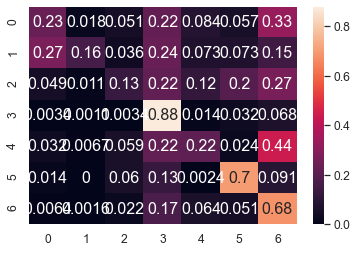

	training epoch=9 .. train_loss=1.228
	validation epoch=9 .. val_loss=1.314
	Accuracy = 50.5 % .. Percision = 47.4 % .. Recall = 43.0 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_9.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 10 .. loss = 1.3


  0%|                                                                                 | 1/1914 [00:01<38:12,  1.20s/it]

training @ epoch 10 .. loss = 1.089


  0%|                                                                                 | 2/1914 [00:02<38:31,  1.21s/it]

training @ epoch 10 .. loss = 0.772


  0%|▏                                                                                | 3/1914 [00:03<37:40,  1.18s/it]

training @ epoch 10 .. loss = 1.143


  0%|▏                                                                                | 4/1914 [00:04<38:16,  1.20s/it]

training @ epoch 10 .. loss = 0.901


  0%|▏                                                                                | 5/1914 [00:05<37:51,  1.19s/it]

training @ epoch 10 .. loss = 0.928


  0%|▎                                                                                | 6/1914 [00:07<37:58,  1.19s/it]

training @ epoch 10 .. loss = 1.411


  0%|▎                                                                                | 7/1914 [00:08<38:01,  1.20s/it]

training @ epoch 10 .. loss = 0.726


  0%|▎                                                                                | 8/1914 [00:09<37:23,  1.18s/it]

training @ epoch 10 .. loss = 1.176


  0%|▍                                                                                | 9/1914 [00:10<37:48,  1.19s/it]

training @ epoch 10 .. loss = 1.567


  1%|▍                                                                               | 10/1914 [00:11<37:17,  1.18s/it]

training @ epoch 10 .. loss = 1.361


  1%|▍                                                                               | 11/1914 [00:13<37:50,  1.19s/it]

training @ epoch 10 .. loss = 0.784


  1%|▌                                                                               | 12/1914 [00:14<37:43,  1.19s/it]

training @ epoch 10 .. loss = 0.728


  1%|▌                                                                               | 13/1914 [00:15<37:19,  1.18s/it]

training @ epoch 10 .. loss = 1.508


  1%|▌                                                                               | 14/1914 [00:16<37:39,  1.19s/it]

training @ epoch 10 .. loss = 0.867


  1%|▋                                                                               | 15/1914 [00:17<37:39,  1.19s/it]

training @ epoch 10 .. loss = 0.844


  1%|▋                                                                               | 16/1914 [00:19<38:07,  1.21s/it]

training @ epoch 10 .. loss = 1.079


  1%|▋                                                                               | 17/1914 [00:20<38:11,  1.21s/it]

training @ epoch 10 .. loss = 1.517


  1%|▊                                                                               | 18/1914 [00:21<37:44,  1.19s/it]

training @ epoch 10 .. loss = 1.058


  1%|▊                                                                               | 19/1914 [00:22<37:41,  1.19s/it]

training @ epoch 10 .. loss = 1.198


  1%|▊                                                                               | 20/1914 [00:23<37:39,  1.19s/it]

training @ epoch 10 .. loss = 1.319


  1%|▉                                                                               | 21/1914 [00:25<38:01,  1.21s/it]

training @ epoch 10 .. loss = 1.48


  1%|▉                                                                               | 22/1914 [00:26<38:03,  1.21s/it]

training @ epoch 10 .. loss = 1.022


  1%|▉                                                                               | 23/1914 [00:27<37:47,  1.20s/it]

training @ epoch 10 .. loss = 0.905


  1%|█                                                                               | 24/1914 [00:28<37:59,  1.21s/it]

training @ epoch 10 .. loss = 1.078


  1%|█                                                                               | 25/1914 [00:29<37:44,  1.20s/it]

training @ epoch 10 .. loss = 1.358


  1%|█                                                                               | 26/1914 [00:31<38:14,  1.22s/it]

training @ epoch 10 .. loss = 1.501


  1%|█▏                                                                              | 27/1914 [00:32<38:17,  1.22s/it]

training @ epoch 10 .. loss = 1.149


  1%|█▏                                                                              | 28/1914 [00:33<37:42,  1.20s/it]

training @ epoch 10 .. loss = 1.133


  2%|█▏                                                                              | 29/1914 [00:34<38:04,  1.21s/it]

training @ epoch 10 .. loss = 1.003


  2%|█▎                                                                              | 30/1914 [00:35<37:35,  1.20s/it]

training @ epoch 10 .. loss = 1.191


  2%|█▎                                                                              | 31/1914 [00:37<38:01,  1.21s/it]

training @ epoch 10 .. loss = 1.153


  2%|█▎                                                                              | 32/1914 [00:38<37:59,  1.21s/it]

training @ epoch 10 .. loss = 0.834


  2%|█▍                                                                              | 33/1914 [00:39<37:32,  1.20s/it]

training @ epoch 10 .. loss = 1.294


  2%|█▍                                                                              | 34/1914 [00:40<37:28,  1.20s/it]

training @ epoch 10 .. loss = 1.037


  2%|█▍                                                                              | 35/1914 [00:41<37:07,  1.19s/it]

training @ epoch 10 .. loss = 1.596


  2%|█▌                                                                              | 36/1914 [00:43<37:22,  1.19s/it]

training @ epoch 10 .. loss = 1.115


  2%|█▌                                                                              | 37/1914 [00:44<37:31,  1.20s/it]

training @ epoch 10 .. loss = 0.994


  2%|█▌                                                                              | 38/1914 [00:45<37:09,  1.19s/it]

training @ epoch 10 .. loss = 1.493


  2%|█▋                                                                              | 39/1914 [00:46<37:26,  1.20s/it]

training @ epoch 10 .. loss = 1.149


  2%|█▋                                                                              | 40/1914 [00:47<37:10,  1.19s/it]

training @ epoch 10 .. loss = 1.211


  2%|█▋                                                                              | 41/1914 [00:49<37:20,  1.20s/it]

training @ epoch 10 .. loss = 1.627


  2%|█▊                                                                              | 42/1914 [00:50<37:29,  1.20s/it]

training @ epoch 10 .. loss = 1.517


  2%|█▊                                                                              | 43/1914 [00:51<37:05,  1.19s/it]

training @ epoch 10 .. loss = 0.884


  2%|█▊                                                                              | 44/1914 [00:52<37:06,  1.19s/it]

training @ epoch 10 .. loss = 1.232


  2%|█▉                                                                              | 45/1914 [00:53<36:52,  1.18s/it]

training @ epoch 10 .. loss = 1.744


  2%|█▉                                                                              | 46/1914 [00:55<37:02,  1.19s/it]

training @ epoch 10 .. loss = 1.073


  2%|█▉                                                                              | 47/1914 [00:56<37:01,  1.19s/it]

training @ epoch 10 .. loss = 0.943


  3%|██                                                                              | 48/1914 [00:57<36:57,  1.19s/it]

training @ epoch 10 .. loss = 1.288


  3%|██                                                                              | 49/1914 [00:58<37:15,  1.20s/it]

training @ epoch 10 .. loss = 1.499


  3%|██                                                                              | 50/1914 [00:59<37:05,  1.19s/it]

training @ epoch 10 .. loss = 1.363


  3%|██▏                                                                             | 51/1914 [01:01<37:24,  1.20s/it]

training @ epoch 10 .. loss = 0.974


  3%|██▏                                                                             | 52/1914 [01:02<37:16,  1.20s/it]

training @ epoch 10 .. loss = 1.435


  3%|██▏                                                                             | 53/1914 [01:03<36:46,  1.19s/it]

training @ epoch 10 .. loss = 1.254


  3%|██▎                                                                             | 54/1914 [01:04<36:56,  1.19s/it]

training @ epoch 10 .. loss = 1.187


  3%|██▎                                                                             | 55/1914 [01:05<37:00,  1.19s/it]

training @ epoch 10 .. loss = 1.339


  3%|██▎                                                                             | 56/1914 [01:06<37:02,  1.20s/it]

training @ epoch 10 .. loss = 1.246


  3%|██▍                                                                             | 57/1914 [01:08<36:47,  1.19s/it]

training @ epoch 10 .. loss = 1.224


  3%|██▍                                                                             | 58/1914 [01:09<36:25,  1.18s/it]

training @ epoch 10 .. loss = 1.187


  3%|██▍                                                                             | 59/1914 [01:10<36:27,  1.18s/it]

training @ epoch 10 .. loss = 1.407


  3%|██▌                                                                             | 60/1914 [01:11<36:39,  1.19s/it]

training @ epoch 10 .. loss = 0.683


  3%|██▌                                                                             | 61/1914 [01:12<37:13,  1.21s/it]

training @ epoch 10 .. loss = 1.474


  3%|██▌                                                                             | 62/1914 [01:14<37:10,  1.20s/it]

training @ epoch 10 .. loss = 0.85


  3%|██▋                                                                             | 63/1914 [01:15<37:08,  1.20s/it]

training @ epoch 10 .. loss = 1.334


  3%|██▋                                                                             | 64/1914 [01:16<37:11,  1.21s/it]

training @ epoch 10 .. loss = 1.203


  3%|██▋                                                                             | 65/1914 [01:17<37:07,  1.20s/it]

training @ epoch 10 .. loss = 1.337


  3%|██▊                                                                             | 66/1914 [01:18<37:10,  1.21s/it]

training @ epoch 10 .. loss = 1.529


  4%|██▊                                                                             | 67/1914 [01:20<37:18,  1.21s/it]

training @ epoch 10 .. loss = 1.059


  4%|██▊                                                                             | 68/1914 [01:21<36:51,  1.20s/it]

training @ epoch 10 .. loss = 0.972


  4%|██▉                                                                             | 69/1914 [01:22<36:57,  1.20s/it]

training @ epoch 10 .. loss = 1.436


  4%|██▉                                                                             | 70/1914 [01:23<36:40,  1.19s/it]

training @ epoch 10 .. loss = 1.218


  4%|██▉                                                                             | 71/1914 [01:24<36:45,  1.20s/it]

training @ epoch 10 .. loss = 1.092


  4%|███                                                                             | 72/1914 [01:26<37:16,  1.21s/it]

training @ epoch 10 .. loss = 1.309


  4%|███                                                                             | 73/1914 [01:27<36:52,  1.20s/it]

training @ epoch 10 .. loss = 0.844


  4%|███                                                                             | 74/1914 [01:28<36:45,  1.20s/it]

training @ epoch 10 .. loss = 1.443


  4%|███▏                                                                            | 75/1914 [01:29<36:44,  1.20s/it]

training @ epoch 10 .. loss = 0.809


  4%|███▏                                                                            | 76/1914 [01:30<36:31,  1.19s/it]

training @ epoch 10 .. loss = 1.648


  4%|███▏                                                                            | 77/1914 [01:32<36:42,  1.20s/it]

training @ epoch 10 .. loss = 1.056


  4%|███▎                                                                            | 78/1914 [01:33<36:25,  1.19s/it]

training @ epoch 10 .. loss = 1.497


  4%|███▎                                                                            | 79/1914 [01:34<36:09,  1.18s/it]

training @ epoch 10 .. loss = 1.018


  4%|███▎                                                                            | 80/1914 [01:35<35:46,  1.17s/it]

training @ epoch 10 .. loss = 1.084


  4%|███▍                                                                            | 81/1914 [01:36<36:13,  1.19s/it]

training @ epoch 10 .. loss = 1.028


  4%|███▍                                                                            | 82/1914 [01:38<37:11,  1.22s/it]

training @ epoch 10 .. loss = 0.687


  4%|███▍                                                                            | 83/1914 [01:39<36:39,  1.20s/it]

training @ epoch 10 .. loss = 1.48


  4%|███▌                                                                            | 84/1914 [01:40<36:28,  1.20s/it]

training @ epoch 10 .. loss = 1.112


  4%|███▌                                                                            | 85/1914 [01:41<36:13,  1.19s/it]

training @ epoch 10 .. loss = 1.269


  4%|███▌                                                                            | 86/1914 [01:42<36:43,  1.21s/it]

training @ epoch 10 .. loss = 1.376


  5%|███▋                                                                            | 87/1914 [01:44<36:24,  1.20s/it]

training @ epoch 10 .. loss = 1.21


  5%|███▋                                                                            | 88/1914 [01:45<36:20,  1.19s/it]

training @ epoch 10 .. loss = 1.219


  5%|███▋                                                                            | 89/1914 [01:46<36:23,  1.20s/it]

training @ epoch 10 .. loss = 1.818


  5%|███▊                                                                            | 90/1914 [01:47<36:20,  1.20s/it]

training @ epoch 10 .. loss = 1.161


  5%|███▊                                                                            | 91/1914 [01:48<36:22,  1.20s/it]

training @ epoch 10 .. loss = 0.958


  5%|███▊                                                                            | 92/1914 [01:50<36:16,  1.19s/it]

training @ epoch 10 .. loss = 1.141


  5%|███▉                                                                            | 93/1914 [01:51<36:14,  1.19s/it]

training @ epoch 10 .. loss = 0.973


  5%|███▉                                                                            | 94/1914 [01:52<36:07,  1.19s/it]

training @ epoch 10 .. loss = 1.099


  5%|███▉                                                                            | 95/1914 [01:53<35:44,  1.18s/it]

training @ epoch 10 .. loss = 1.133


  5%|████                                                                            | 96/1914 [01:54<35:54,  1.19s/it]

training @ epoch 10 .. loss = 1.131


  5%|████                                                                            | 97/1914 [01:55<35:51,  1.18s/it]

training @ epoch 10 .. loss = 1.058


  5%|████                                                                            | 98/1914 [01:57<36:10,  1.20s/it]

training @ epoch 10 .. loss = 1.514


  5%|████▏                                                                           | 99/1914 [01:58<36:09,  1.20s/it]

training @ epoch 10 .. loss = 1.278


  5%|████▏                                                                          | 100/1914 [01:59<35:49,  1.18s/it]

training @ epoch 10 .. loss = 1.091


  5%|████▏                                                                          | 101/1914 [02:00<36:04,  1.19s/it]

training @ epoch 10 .. loss = 1.158


  5%|████▏                                                                          | 102/1914 [02:01<36:08,  1.20s/it]

training @ epoch 10 .. loss = 1.303


  5%|████▎                                                                          | 103/1914 [02:03<36:10,  1.20s/it]

training @ epoch 10 .. loss = 0.956


  5%|████▎                                                                          | 104/1914 [02:04<36:48,  1.22s/it]

training @ epoch 10 .. loss = 0.96


  5%|████▎                                                                          | 105/1914 [02:05<36:00,  1.19s/it]

training @ epoch 10 .. loss = 1.021


  6%|████▍                                                                          | 106/1914 [02:06<36:14,  1.20s/it]

training @ epoch 10 .. loss = 1.518


  6%|████▍                                                                          | 107/1914 [02:07<36:07,  1.20s/it]

training @ epoch 10 .. loss = 1.18


  6%|████▍                                                                          | 108/1914 [02:09<36:18,  1.21s/it]

training @ epoch 10 .. loss = 1.087


  6%|████▍                                                                          | 109/1914 [02:10<36:10,  1.20s/it]

training @ epoch 10 .. loss = 1.235


  6%|████▌                                                                          | 110/1914 [02:11<35:43,  1.19s/it]

training @ epoch 10 .. loss = 0.813


  6%|████▌                                                                          | 111/1914 [02:12<36:20,  1.21s/it]

training @ epoch 10 .. loss = 1.188


  6%|████▌                                                                          | 112/1914 [02:13<36:00,  1.20s/it]

training @ epoch 10 .. loss = 0.917


  6%|████▋                                                                          | 113/1914 [02:15<35:56,  1.20s/it]

training @ epoch 10 .. loss = 1.284


  6%|████▋                                                                          | 114/1914 [02:16<35:52,  1.20s/it]

training @ epoch 10 .. loss = 1.328


  6%|████▋                                                                          | 115/1914 [02:17<35:38,  1.19s/it]

training @ epoch 10 .. loss = 0.957


  6%|████▊                                                                          | 116/1914 [02:18<35:23,  1.18s/it]

training @ epoch 10 .. loss = 1.394


  6%|████▊                                                                          | 117/1914 [02:19<35:33,  1.19s/it]

training @ epoch 10 .. loss = 1.168


  6%|████▊                                                                          | 118/1914 [02:21<35:56,  1.20s/it]

training @ epoch 10 .. loss = 1.06


  6%|████▉                                                                          | 119/1914 [02:22<35:44,  1.19s/it]

training @ epoch 10 .. loss = 1.586


  6%|████▉                                                                          | 120/1914 [02:23<35:30,  1.19s/it]

training @ epoch 10 .. loss = 1.417


  6%|████▉                                                                          | 121/1914 [02:24<35:42,  1.20s/it]

training @ epoch 10 .. loss = 1.229


  6%|█████                                                                          | 122/1914 [02:25<35:29,  1.19s/it]

training @ epoch 10 .. loss = 1.57


  6%|█████                                                                          | 123/1914 [02:27<35:41,  1.20s/it]

training @ epoch 10 .. loss = 1.126


  6%|█████                                                                          | 124/1914 [02:28<36:05,  1.21s/it]

training @ epoch 10 .. loss = 1.06


  7%|█████▏                                                                         | 125/1914 [02:29<35:38,  1.20s/it]

training @ epoch 10 .. loss = 1.28


  7%|█████▏                                                                         | 126/1914 [02:30<36:07,  1.21s/it]

training @ epoch 10 .. loss = 0.869


  7%|█████▏                                                                         | 127/1914 [02:31<35:56,  1.21s/it]

training @ epoch 10 .. loss = 1.204


  7%|█████▎                                                                         | 128/1914 [02:33<35:58,  1.21s/it]

training @ epoch 10 .. loss = 1.466


  7%|█████▎                                                                         | 129/1914 [02:34<35:54,  1.21s/it]

training @ epoch 10 .. loss = 1.075


  7%|█████▎                                                                         | 130/1914 [02:35<35:17,  1.19s/it]

training @ epoch 10 .. loss = 0.709


  7%|█████▍                                                                         | 131/1914 [02:36<35:36,  1.20s/it]

training @ epoch 10 .. loss = 0.868


  7%|█████▍                                                                         | 132/1914 [02:37<35:15,  1.19s/it]

training @ epoch 10 .. loss = 1.18


  7%|█████▍                                                                         | 133/1914 [02:39<35:54,  1.21s/it]

training @ epoch 10 .. loss = 1.238


  7%|█████▌                                                                         | 134/1914 [02:40<35:51,  1.21s/it]

training @ epoch 10 .. loss = 1.094


  7%|█████▌                                                                         | 135/1914 [02:41<35:19,  1.19s/it]

training @ epoch 10 .. loss = 1.558


  7%|█████▌                                                                         | 136/1914 [02:42<35:23,  1.19s/it]

training @ epoch 10 .. loss = 0.931


  7%|█████▋                                                                         | 137/1914 [02:43<35:36,  1.20s/it]

training @ epoch 10 .. loss = 0.948


  7%|█████▋                                                                         | 138/1914 [02:45<36:02,  1.22s/it]

training @ epoch 10 .. loss = 1.548


  7%|█████▋                                                                         | 139/1914 [02:46<35:36,  1.20s/it]

training @ epoch 10 .. loss = 1.411


  7%|█████▊                                                                         | 140/1914 [02:47<35:07,  1.19s/it]

training @ epoch 10 .. loss = 1.656


  7%|█████▊                                                                         | 141/1914 [02:48<35:30,  1.20s/it]

training @ epoch 10 .. loss = 0.737


  7%|█████▊                                                                         | 142/1914 [02:49<35:29,  1.20s/it]

training @ epoch 10 .. loss = 1.663


  7%|█████▉                                                                         | 143/1914 [02:51<35:34,  1.21s/it]

training @ epoch 10 .. loss = 1.218


  8%|█████▉                                                                         | 144/1914 [02:52<35:26,  1.20s/it]

training @ epoch 10 .. loss = 1.237


  8%|█████▉                                                                         | 145/1914 [02:53<34:58,  1.19s/it]

training @ epoch 10 .. loss = 1.109


  8%|██████                                                                         | 146/1914 [02:54<35:21,  1.20s/it]

training @ epoch 10 .. loss = 1.695


  8%|██████                                                                         | 147/1914 [02:55<35:32,  1.21s/it]

training @ epoch 10 .. loss = 1.205


  8%|██████                                                                         | 148/1914 [02:57<35:35,  1.21s/it]

training @ epoch 10 .. loss = 1.165


  8%|██████▏                                                                        | 149/1914 [02:58<35:23,  1.20s/it]

training @ epoch 10 .. loss = 1.392


  8%|██████▏                                                                        | 150/1914 [02:59<34:46,  1.18s/it]

training @ epoch 10 .. loss = 1.027


  8%|██████▏                                                                        | 151/1914 [03:00<34:54,  1.19s/it]

training @ epoch 10 .. loss = 1.229


  8%|██████▎                                                                        | 152/1914 [03:01<34:35,  1.18s/it]

training @ epoch 10 .. loss = 0.946


  8%|██████▎                                                                        | 153/1914 [03:03<34:57,  1.19s/it]

training @ epoch 10 .. loss = 1.732


  8%|██████▎                                                                        | 154/1914 [03:04<34:43,  1.18s/it]

training @ epoch 10 .. loss = 0.923


  8%|██████▍                                                                        | 155/1914 [03:05<34:14,  1.17s/it]

training @ epoch 10 .. loss = 1.045


  8%|██████▍                                                                        | 156/1914 [03:06<34:43,  1.18s/it]

training @ epoch 10 .. loss = 1.414


  8%|██████▍                                                                        | 157/1914 [03:07<34:45,  1.19s/it]

training @ epoch 10 .. loss = 1.269


  8%|██████▌                                                                        | 158/1914 [03:09<35:19,  1.21s/it]

training @ epoch 10 .. loss = 0.765


  8%|██████▌                                                                        | 159/1914 [03:10<35:10,  1.20s/it]

training @ epoch 10 .. loss = 1.138


  8%|██████▌                                                                        | 160/1914 [03:11<35:03,  1.20s/it]

training @ epoch 10 .. loss = 1.364


  8%|██████▋                                                                        | 161/1914 [03:12<35:04,  1.20s/it]

training @ epoch 10 .. loss = 1.609


  8%|██████▋                                                                        | 162/1914 [03:13<34:54,  1.20s/it]

training @ epoch 10 .. loss = 1.226


  9%|██████▋                                                                        | 163/1914 [03:15<35:04,  1.20s/it]

training @ epoch 10 .. loss = 1.076


  9%|██████▊                                                                        | 164/1914 [03:16<35:03,  1.20s/it]

training @ epoch 10 .. loss = 1.164


  9%|██████▊                                                                        | 165/1914 [03:17<34:41,  1.19s/it]

training @ epoch 10 .. loss = 1.249


  9%|██████▊                                                                        | 166/1914 [03:18<35:01,  1.20s/it]

training @ epoch 10 .. loss = 1.184


  9%|██████▉                                                                        | 167/1914 [03:19<35:00,  1.20s/it]

training @ epoch 10 .. loss = 1.15


  9%|██████▉                                                                        | 168/1914 [03:21<35:20,  1.21s/it]

training @ epoch 10 .. loss = 1.448


  9%|██████▉                                                                        | 169/1914 [03:22<35:18,  1.21s/it]

training @ epoch 10 .. loss = 1.173


  9%|███████                                                                        | 170/1914 [03:23<34:39,  1.19s/it]

training @ epoch 10 .. loss = 1.208


  9%|███████                                                                        | 171/1914 [03:24<34:42,  1.19s/it]

training @ epoch 10 .. loss = 1.69


  9%|███████                                                                        | 172/1914 [03:25<34:29,  1.19s/it]

training @ epoch 10 .. loss = 1.199


  9%|███████▏                                                                       | 173/1914 [03:27<34:49,  1.20s/it]

training @ epoch 10 .. loss = 0.906


  9%|███████▏                                                                       | 174/1914 [03:28<34:55,  1.20s/it]

training @ epoch 10 .. loss = 1.251


  9%|███████▏                                                                       | 175/1914 [03:29<34:54,  1.20s/it]

training @ epoch 10 .. loss = 1.548


  9%|███████▎                                                                       | 176/1914 [03:30<35:02,  1.21s/it]

training @ epoch 10 .. loss = 1.256


  9%|███████▎                                                                       | 177/1914 [03:31<34:57,  1.21s/it]

training @ epoch 10 .. loss = 1.112


  9%|███████▎                                                                       | 178/1914 [03:33<34:53,  1.21s/it]

training @ epoch 10 .. loss = 1.288


  9%|███████▍                                                                       | 179/1914 [03:34<34:40,  1.20s/it]

training @ epoch 10 .. loss = 1.438


  9%|███████▍                                                                       | 180/1914 [03:35<34:30,  1.19s/it]

training @ epoch 10 .. loss = 0.815


  9%|███████▍                                                                       | 181/1914 [03:36<34:24,  1.19s/it]

training @ epoch 10 .. loss = 1.532


 10%|███████▌                                                                       | 182/1914 [03:37<34:23,  1.19s/it]

training @ epoch 10 .. loss = 1.02


 10%|███████▌                                                                       | 183/1914 [03:39<34:28,  1.20s/it]

training @ epoch 10 .. loss = 1.09


 10%|███████▌                                                                       | 184/1914 [03:40<34:26,  1.19s/it]

training @ epoch 10 .. loss = 0.986


 10%|███████▋                                                                       | 185/1914 [03:41<33:57,  1.18s/it]

training @ epoch 10 .. loss = 1.195


 10%|███████▋                                                                       | 186/1914 [03:42<34:09,  1.19s/it]

training @ epoch 10 .. loss = 1.311


 10%|███████▋                                                                       | 187/1914 [03:43<33:59,  1.18s/it]

training @ epoch 10 .. loss = 1.414


 10%|███████▊                                                                       | 188/1914 [03:44<34:19,  1.19s/it]

training @ epoch 10 .. loss = 1.247


 10%|███████▊                                                                       | 189/1914 [03:46<34:22,  1.20s/it]

training @ epoch 10 .. loss = 1.341


 10%|███████▊                                                                       | 190/1914 [03:47<34:14,  1.19s/it]

training @ epoch 10 .. loss = 1.031


 10%|███████▉                                                                       | 191/1914 [03:48<34:13,  1.19s/it]

training @ epoch 10 .. loss = 1.006


 10%|███████▉                                                                       | 192/1914 [03:49<34:07,  1.19s/it]

training @ epoch 10 .. loss = 1.473


 10%|███████▉                                                                       | 193/1914 [03:50<34:11,  1.19s/it]

training @ epoch 10 .. loss = 1.343


 10%|████████                                                                       | 194/1914 [03:52<34:16,  1.20s/it]

training @ epoch 10 .. loss = 1.573


 10%|████████                                                                       | 195/1914 [03:53<34:12,  1.19s/it]

training @ epoch 10 .. loss = 0.901


 10%|████████                                                                       | 196/1914 [03:54<34:22,  1.20s/it]

training @ epoch 10 .. loss = 1.127


 10%|████████▏                                                                      | 197/1914 [03:55<34:01,  1.19s/it]

training @ epoch 10 .. loss = 1.246


 10%|████████▏                                                                      | 198/1914 [03:56<33:56,  1.19s/it]

training @ epoch 10 .. loss = 1.261


 10%|████████▏                                                                      | 199/1914 [03:58<34:06,  1.19s/it]

training @ epoch 10 .. loss = 1.062


 10%|████████▎                                                                      | 200/1914 [03:59<34:20,  1.20s/it]

training @ epoch 10 .. loss = 1.181


 11%|████████▎                                                                      | 201/1914 [04:00<34:12,  1.20s/it]

training @ epoch 10 .. loss = 1.324


 11%|████████▎                                                                      | 202/1914 [04:01<34:09,  1.20s/it]

training @ epoch 10 .. loss = 0.873


 11%|████████▍                                                                      | 203/1914 [04:02<33:55,  1.19s/it]

training @ epoch 10 .. loss = 1.358


 11%|████████▍                                                                      | 204/1914 [04:04<33:58,  1.19s/it]

training @ epoch 10 .. loss = 1.256


 11%|████████▍                                                                      | 205/1914 [04:05<34:04,  1.20s/it]

training @ epoch 10 .. loss = 1.046


 11%|████████▌                                                                      | 206/1914 [04:06<33:54,  1.19s/it]

training @ epoch 10 .. loss = 1.092


 11%|████████▌                                                                      | 207/1914 [04:07<33:37,  1.18s/it]

training @ epoch 10 .. loss = 0.813


 11%|████████▌                                                                      | 208/1914 [04:08<33:32,  1.18s/it]

training @ epoch 10 .. loss = 1.261


 11%|████████▋                                                                      | 209/1914 [04:09<33:47,  1.19s/it]

training @ epoch 10 .. loss = 1.36


 11%|████████▋                                                                      | 210/1914 [04:11<33:57,  1.20s/it]

training @ epoch 10 .. loss = 1.71


 11%|████████▋                                                                      | 211/1914 [04:12<34:00,  1.20s/it]

training @ epoch 10 .. loss = 0.845


 11%|████████▊                                                                      | 212/1914 [04:13<33:29,  1.18s/it]

training @ epoch 10 .. loss = 1.129


 11%|████████▊                                                                      | 213/1914 [04:14<33:44,  1.19s/it]

training @ epoch 10 .. loss = 1.063


 11%|████████▊                                                                      | 214/1914 [04:15<33:23,  1.18s/it]

training @ epoch 10 .. loss = 1.935


 11%|████████▊                                                                      | 215/1914 [04:17<33:39,  1.19s/it]

training @ epoch 10 .. loss = 1.103


 11%|████████▉                                                                      | 216/1914 [04:18<33:39,  1.19s/it]

training @ epoch 10 .. loss = 1.695


 11%|████████▉                                                                      | 217/1914 [04:19<33:35,  1.19s/it]

training @ epoch 10 .. loss = 1.154


 11%|████████▉                                                                      | 218/1914 [04:20<34:01,  1.20s/it]

training @ epoch 10 .. loss = 1.341


 11%|█████████                                                                      | 219/1914 [04:21<33:59,  1.20s/it]

training @ epoch 10 .. loss = 1.023


 11%|█████████                                                                      | 220/1914 [04:23<34:19,  1.22s/it]

training @ epoch 10 .. loss = 1.418


 12%|█████████                                                                      | 221/1914 [04:24<34:20,  1.22s/it]

training @ epoch 10 .. loss = 1.254


 12%|█████████▏                                                                     | 222/1914 [04:25<33:58,  1.20s/it]

training @ epoch 10 .. loss = 0.79


 12%|█████████▏                                                                     | 223/1914 [04:26<34:06,  1.21s/it]

training @ epoch 10 .. loss = 0.931


 12%|█████████▏                                                                     | 224/1914 [04:27<33:50,  1.20s/it]

training @ epoch 10 .. loss = 1.119


 12%|█████████▎                                                                     | 225/1914 [04:29<33:49,  1.20s/it]

training @ epoch 10 .. loss = 0.86


 12%|█████████▎                                                                     | 226/1914 [04:30<33:39,  1.20s/it]

training @ epoch 10 .. loss = 1.151


 12%|█████████▎                                                                     | 227/1914 [04:31<33:10,  1.18s/it]

training @ epoch 10 .. loss = 0.866


 12%|█████████▍                                                                     | 228/1914 [04:32<33:10,  1.18s/it]

training @ epoch 10 .. loss = 1.634


 12%|█████████▍                                                                     | 229/1914 [04:33<33:10,  1.18s/it]

training @ epoch 10 .. loss = 0.996


 12%|█████████▍                                                                     | 230/1914 [04:35<33:36,  1.20s/it]

training @ epoch 10 .. loss = 1.896


 12%|█████████▌                                                                     | 231/1914 [04:36<33:40,  1.20s/it]

training @ epoch 10 .. loss = 1.443


 12%|█████████▌                                                                     | 232/1914 [04:37<33:16,  1.19s/it]

training @ epoch 10 .. loss = 1.329


 12%|█████████▌                                                                     | 233/1914 [04:38<33:28,  1.19s/it]

training @ epoch 10 .. loss = 1.397


 12%|█████████▋                                                                     | 234/1914 [04:39<33:36,  1.20s/it]

training @ epoch 10 .. loss = 1.323


 12%|█████████▋                                                                     | 235/1914 [04:41<33:51,  1.21s/it]

training @ epoch 10 .. loss = 1.264


 12%|█████████▋                                                                     | 236/1914 [04:42<33:36,  1.20s/it]

training @ epoch 10 .. loss = 0.887


 12%|█████████▊                                                                     | 237/1914 [04:43<33:13,  1.19s/it]

training @ epoch 10 .. loss = 1.19


 12%|█████████▊                                                                     | 238/1914 [04:44<33:19,  1.19s/it]

training @ epoch 10 .. loss = 1.113


 12%|█████████▊                                                                     | 239/1914 [04:45<32:57,  1.18s/it]

training @ epoch 10 .. loss = 1.3


 13%|█████████▉                                                                     | 240/1914 [04:47<33:22,  1.20s/it]

training @ epoch 10 .. loss = 1.668


 13%|█████████▉                                                                     | 241/1914 [04:48<33:28,  1.20s/it]

training @ epoch 10 .. loss = 1.401


 13%|█████████▉                                                                     | 242/1914 [04:49<33:13,  1.19s/it]

training @ epoch 10 .. loss = 1.32


 13%|██████████                                                                     | 243/1914 [04:50<33:31,  1.20s/it]

training @ epoch 10 .. loss = 1.445


 13%|██████████                                                                     | 244/1914 [04:51<33:20,  1.20s/it]

training @ epoch 10 .. loss = 1.237


 13%|██████████                                                                     | 245/1914 [04:53<33:32,  1.21s/it]

training @ epoch 10 .. loss = 1.183


 13%|██████████▏                                                                    | 246/1914 [04:54<33:34,  1.21s/it]

training @ epoch 10 .. loss = 1.385


 13%|██████████▏                                                                    | 247/1914 [04:55<33:00,  1.19s/it]

training @ epoch 10 .. loss = 1.27


 13%|██████████▏                                                                    | 248/1914 [04:56<33:06,  1.19s/it]

training @ epoch 10 .. loss = 1.311


 13%|██████████▎                                                                    | 249/1914 [04:57<33:19,  1.20s/it]

training @ epoch 10 .. loss = 1.08


 13%|██████████▎                                                                    | 250/1914 [04:59<33:10,  1.20s/it]

training @ epoch 10 .. loss = 1.064


 13%|██████████▎                                                                    | 251/1914 [05:00<33:22,  1.20s/it]

training @ epoch 10 .. loss = 1.268


 13%|██████████▍                                                                    | 252/1914 [05:01<33:07,  1.20s/it]

training @ epoch 10 .. loss = 1.203


 13%|██████████▍                                                                    | 253/1914 [05:02<33:12,  1.20s/it]

training @ epoch 10 .. loss = 1.305


 13%|██████████▍                                                                    | 254/1914 [05:03<32:50,  1.19s/it]

training @ epoch 10 .. loss = 1.443


 13%|██████████▌                                                                    | 255/1914 [05:04<33:01,  1.19s/it]

training @ epoch 10 .. loss = 1.321


 13%|██████████▌                                                                    | 256/1914 [05:06<32:55,  1.19s/it]

training @ epoch 10 .. loss = 1.104


 13%|██████████▌                                                                    | 257/1914 [05:07<32:35,  1.18s/it]

training @ epoch 10 .. loss = 1.084


 13%|██████████▋                                                                    | 258/1914 [05:08<32:45,  1.19s/it]

training @ epoch 10 .. loss = 0.901


 14%|██████████▋                                                                    | 259/1914 [05:09<32:27,  1.18s/it]

training @ epoch 10 .. loss = 1.442


 14%|██████████▋                                                                    | 260/1914 [05:10<32:53,  1.19s/it]

training @ epoch 10 .. loss = 0.947


 14%|██████████▊                                                                    | 261/1914 [05:12<33:02,  1.20s/it]

training @ epoch 10 .. loss = 1.436


 14%|██████████▊                                                                    | 262/1914 [05:13<32:43,  1.19s/it]

training @ epoch 10 .. loss = 1.126


 14%|██████████▊                                                                    | 263/1914 [05:14<32:34,  1.18s/it]

training @ epoch 10 .. loss = 1.15


 14%|██████████▉                                                                    | 264/1914 [05:15<32:32,  1.18s/it]

training @ epoch 10 .. loss = 1.164


 14%|██████████▉                                                                    | 265/1914 [05:16<32:34,  1.19s/it]

training @ epoch 10 .. loss = 1.74


 14%|██████████▉                                                                    | 266/1914 [05:18<32:38,  1.19s/it]

training @ epoch 10 .. loss = 1.311


 14%|███████████                                                                    | 267/1914 [05:19<32:53,  1.20s/it]

training @ epoch 10 .. loss = 1.088


 14%|███████████                                                                    | 268/1914 [05:20<32:54,  1.20s/it]

training @ epoch 10 .. loss = 1.443


 14%|███████████                                                                    | 269/1914 [05:21<32:42,  1.19s/it]

training @ epoch 10 .. loss = 1.064


 14%|███████████▏                                                                   | 270/1914 [05:22<32:46,  1.20s/it]

training @ epoch 10 .. loss = 0.883


 14%|███████████▏                                                                   | 271/1914 [05:24<32:43,  1.20s/it]

training @ epoch 10 .. loss = 1.245


 14%|███████████▏                                                                   | 272/1914 [05:25<32:45,  1.20s/it]

training @ epoch 10 .. loss = 1.19


 14%|███████████▎                                                                   | 273/1914 [05:26<32:22,  1.18s/it]

training @ epoch 10 .. loss = 1.497


 14%|███████████▎                                                                   | 274/1914 [05:27<32:19,  1.18s/it]

training @ epoch 10 .. loss = 1.28


 14%|███████████▎                                                                   | 275/1914 [05:28<32:37,  1.19s/it]

training @ epoch 10 .. loss = 1.178


 14%|███████████▍                                                                   | 276/1914 [05:29<32:06,  1.18s/it]

training @ epoch 10 .. loss = 0.741


 14%|███████████▍                                                                   | 277/1914 [05:31<33:08,  1.21s/it]

training @ epoch 10 .. loss = 1.26


 15%|███████████▍                                                                   | 278/1914 [05:32<33:15,  1.22s/it]

training @ epoch 10 .. loss = 1.183


 15%|███████████▌                                                                   | 279/1914 [05:33<32:56,  1.21s/it]

training @ epoch 10 .. loss = 0.92


 15%|███████████▌                                                                   | 280/1914 [05:34<32:57,  1.21s/it]

training @ epoch 10 .. loss = 0.787


 15%|███████████▌                                                                   | 281/1914 [05:36<33:09,  1.22s/it]

training @ epoch 10 .. loss = 1.141


 15%|███████████▋                                                                   | 282/1914 [05:37<32:38,  1.20s/it]

training @ epoch 10 .. loss = 1.353


 15%|███████████▋                                                                   | 283/1914 [05:38<32:28,  1.19s/it]

training @ epoch 10 .. loss = 1.759


 15%|███████████▋                                                                   | 284/1914 [05:39<32:06,  1.18s/it]

training @ epoch 10 .. loss = 1.197


 15%|███████████▊                                                                   | 285/1914 [05:40<32:23,  1.19s/it]

training @ epoch 10 .. loss = 1.126


 15%|███████████▊                                                                   | 286/1914 [05:41<32:03,  1.18s/it]

training @ epoch 10 .. loss = 1.12


 15%|███████████▊                                                                   | 287/1914 [05:43<32:55,  1.21s/it]

training @ epoch 10 .. loss = 1.276


 15%|███████████▉                                                                   | 288/1914 [05:44<33:53,  1.25s/it]

training @ epoch 10 .. loss = 1.195


 15%|███████████▉                                                                   | 289/1914 [05:46<36:12,  1.34s/it]

training @ epoch 10 .. loss = 1.366


 15%|███████████▉                                                                   | 290/1914 [05:47<35:49,  1.32s/it]

training @ epoch 10 .. loss = 1.099


 15%|████████████                                                                   | 291/1914 [05:48<36:17,  1.34s/it]

training @ epoch 10 .. loss = 0.85


 15%|████████████                                                                   | 292/1914 [05:50<35:55,  1.33s/it]

training @ epoch 10 .. loss = 1.062


 15%|████████████                                                                   | 293/1914 [05:51<35:23,  1.31s/it]

training @ epoch 10 .. loss = 0.88


 15%|████████████▏                                                                  | 294/1914 [05:52<35:14,  1.31s/it]

training @ epoch 10 .. loss = 1.276


 15%|████████████▏                                                                  | 295/1914 [05:53<34:54,  1.29s/it]

training @ epoch 10 .. loss = 1.412


 15%|████████████▏                                                                  | 296/1914 [05:55<34:38,  1.28s/it]

training @ epoch 10 .. loss = 1.114


 16%|████████████▎                                                                  | 297/1914 [05:56<34:51,  1.29s/it]

training @ epoch 10 .. loss = 1.107


 16%|████████████▎                                                                  | 298/1914 [05:57<34:35,  1.28s/it]

training @ epoch 10 .. loss = 1.242


 16%|████████████▎                                                                  | 299/1914 [05:59<34:43,  1.29s/it]

training @ epoch 10 .. loss = 0.791


 16%|████████████▍                                                                  | 300/1914 [06:00<34:19,  1.28s/it]

training @ epoch 10 .. loss = 1.288


 16%|████████████▍                                                                  | 301/1914 [06:01<34:26,  1.28s/it]

training @ epoch 10 .. loss = 1.286


 16%|████████████▍                                                                  | 302/1914 [06:02<34:26,  1.28s/it]

training @ epoch 10 .. loss = 2.018


 16%|████████████▌                                                                  | 303/1914 [06:04<34:26,  1.28s/it]

training @ epoch 10 .. loss = 0.989


 16%|████████████▌                                                                  | 304/1914 [06:05<34:15,  1.28s/it]

training @ epoch 10 .. loss = 0.893


 16%|████████████▌                                                                  | 305/1914 [06:06<34:46,  1.30s/it]

training @ epoch 10 .. loss = 0.974


 16%|████████████▋                                                                  | 306/1914 [06:08<34:34,  1.29s/it]

training @ epoch 10 .. loss = 1.443


 16%|████████████▋                                                                  | 307/1914 [06:09<34:34,  1.29s/it]

training @ epoch 10 .. loss = 1.299


 16%|████████████▋                                                                  | 308/1914 [06:10<35:12,  1.32s/it]

training @ epoch 10 .. loss = 0.947


 16%|████████████▊                                                                  | 309/1914 [06:12<35:15,  1.32s/it]

training @ epoch 10 .. loss = 1.208


 16%|████████████▊                                                                  | 310/1914 [06:13<35:11,  1.32s/it]

training @ epoch 10 .. loss = 1.476


 16%|████████████▊                                                                  | 311/1914 [06:14<35:14,  1.32s/it]

training @ epoch 10 .. loss = 1.259


 16%|████████████▉                                                                  | 312/1914 [06:15<35:05,  1.31s/it]

training @ epoch 10 .. loss = 0.919


 16%|████████████▉                                                                  | 313/1914 [06:17<34:54,  1.31s/it]

training @ epoch 10 .. loss = 1.018


 16%|████████████▉                                                                  | 314/1914 [06:18<34:54,  1.31s/it]

training @ epoch 10 .. loss = 1.541


 16%|█████████████                                                                  | 315/1914 [06:19<34:50,  1.31s/it]

training @ epoch 10 .. loss = 1.301


 17%|█████████████                                                                  | 316/1914 [06:21<34:34,  1.30s/it]

training @ epoch 10 .. loss = 1.007


 17%|█████████████                                                                  | 317/1914 [06:22<34:35,  1.30s/it]

training @ epoch 10 .. loss = 1.297


 17%|█████████████▏                                                                 | 318/1914 [06:23<34:21,  1.29s/it]

training @ epoch 10 .. loss = 1.222


 17%|█████████████▏                                                                 | 319/1914 [06:25<34:46,  1.31s/it]

training @ epoch 10 .. loss = 1.254


 17%|█████████████▏                                                                 | 320/1914 [06:26<34:32,  1.30s/it]

training @ epoch 10 .. loss = 1.5


 17%|█████████████▏                                                                 | 321/1914 [06:27<34:28,  1.30s/it]

training @ epoch 10 .. loss = 1.146


 17%|█████████████▎                                                                 | 322/1914 [06:28<34:29,  1.30s/it]

training @ epoch 10 .. loss = 1.201


 17%|█████████████▎                                                                 | 323/1914 [06:30<34:24,  1.30s/it]

training @ epoch 10 .. loss = 1.141


 17%|█████████████▎                                                                 | 324/1914 [06:31<34:25,  1.30s/it]

training @ epoch 10 .. loss = 1.434


 17%|█████████████▍                                                                 | 325/1914 [06:32<34:31,  1.30s/it]

training @ epoch 10 .. loss = 0.993


 17%|█████████████▍                                                                 | 326/1914 [06:34<34:30,  1.30s/it]

training @ epoch 10 .. loss = 1.151


 17%|█████████████▍                                                                 | 327/1914 [06:35<34:48,  1.32s/it]

training @ epoch 10 .. loss = 1.393


 17%|█████████████▌                                                                 | 328/1914 [06:36<34:46,  1.32s/it]

training @ epoch 10 .. loss = 1.181


 17%|█████████████▌                                                                 | 329/1914 [06:38<34:54,  1.32s/it]

training @ epoch 10 .. loss = 0.936


 17%|█████████████▌                                                                 | 330/1914 [06:39<33:56,  1.29s/it]

training @ epoch 10 .. loss = 0.974


 17%|█████████████▋                                                                 | 331/1914 [06:40<33:25,  1.27s/it]

training @ epoch 10 .. loss = 1.74


 17%|█████████████▋                                                                 | 332/1914 [06:41<32:58,  1.25s/it]

training @ epoch 10 .. loss = 1.146


 17%|█████████████▋                                                                 | 333/1914 [06:43<32:51,  1.25s/it]

training @ epoch 10 .. loss = 1.284


 17%|█████████████▊                                                                 | 334/1914 [06:44<32:15,  1.23s/it]

training @ epoch 10 .. loss = 1.26


 18%|█████████████▊                                                                 | 335/1914 [06:45<31:49,  1.21s/it]

training @ epoch 10 .. loss = 1.316


 18%|█████████████▊                                                                 | 336/1914 [06:46<31:45,  1.21s/it]

training @ epoch 10 .. loss = 1.218


 18%|█████████████▉                                                                 | 337/1914 [06:47<31:26,  1.20s/it]

training @ epoch 10 .. loss = 1.367


 18%|█████████████▉                                                                 | 338/1914 [06:49<32:17,  1.23s/it]

training @ epoch 10 .. loss = 1.044


 18%|█████████████▉                                                                 | 339/1914 [06:50<31:48,  1.21s/it]

training @ epoch 10 .. loss = 1.324


 18%|██████████████                                                                 | 340/1914 [06:51<31:14,  1.19s/it]

training @ epoch 10 .. loss = 1.692


 18%|██████████████                                                                 | 341/1914 [06:52<31:18,  1.19s/it]

training @ epoch 10 .. loss = 1.199


 18%|██████████████                                                                 | 342/1914 [06:53<31:01,  1.18s/it]

training @ epoch 10 .. loss = 0.978


 18%|██████████████▏                                                                | 343/1914 [06:54<31:14,  1.19s/it]

training @ epoch 10 .. loss = 0.926


 18%|██████████████▏                                                                | 344/1914 [06:56<31:23,  1.20s/it]

training @ epoch 10 .. loss = 1.181


 18%|██████████████▏                                                                | 345/1914 [06:57<30:58,  1.18s/it]

training @ epoch 10 .. loss = 0.818


 18%|██████████████▎                                                                | 346/1914 [06:58<31:28,  1.20s/it]

training @ epoch 10 .. loss = 1.057


 18%|██████████████▎                                                                | 347/1914 [06:59<31:12,  1.19s/it]

training @ epoch 10 .. loss = 1.482


 18%|██████████████▎                                                                | 348/1914 [07:00<31:25,  1.20s/it]

training @ epoch 10 .. loss = 0.909


 18%|██████████████▍                                                                | 349/1914 [07:02<31:11,  1.20s/it]

training @ epoch 10 .. loss = 1.298


 18%|██████████████▍                                                                | 350/1914 [07:03<30:48,  1.18s/it]

training @ epoch 10 .. loss = 0.918


 18%|██████████████▍                                                                | 351/1914 [07:04<30:57,  1.19s/it]

training @ epoch 10 .. loss = 1.042


 18%|██████████████▌                                                                | 352/1914 [07:05<30:58,  1.19s/it]

training @ epoch 10 .. loss = 1.194


 18%|██████████████▌                                                                | 353/1914 [07:06<31:12,  1.20s/it]

training @ epoch 10 .. loss = 0.755


 18%|██████████████▌                                                                | 354/1914 [07:08<31:12,  1.20s/it]

training @ epoch 10 .. loss = 0.91


 19%|██████████████▋                                                                | 355/1914 [07:09<30:42,  1.18s/it]

training @ epoch 10 .. loss = 1.028


 19%|██████████████▋                                                                | 356/1914 [07:10<31:04,  1.20s/it]

training @ epoch 10 .. loss = 1.46


 19%|██████████████▋                                                                | 357/1914 [07:11<30:56,  1.19s/it]

training @ epoch 10 .. loss = 1.326


 19%|██████████████▊                                                                | 358/1914 [07:12<30:54,  1.19s/it]

training @ epoch 10 .. loss = 1.151


 19%|██████████████▊                                                                | 359/1914 [07:14<31:02,  1.20s/it]

training @ epoch 10 .. loss = 1.064


 19%|██████████████▊                                                                | 360/1914 [07:15<30:59,  1.20s/it]

training @ epoch 10 .. loss = 1.111


 19%|██████████████▉                                                                | 361/1914 [07:16<31:10,  1.20s/it]

training @ epoch 10 .. loss = 0.97


 19%|██████████████▉                                                                | 362/1914 [07:17<30:44,  1.19s/it]

training @ epoch 10 .. loss = 0.929


 19%|██████████████▉                                                                | 363/1914 [07:18<30:57,  1.20s/it]

training @ epoch 10 .. loss = 1.194


 19%|███████████████                                                                | 364/1914 [07:20<31:11,  1.21s/it]

training @ epoch 10 .. loss = 0.973


 19%|███████████████                                                                | 365/1914 [07:21<30:46,  1.19s/it]

training @ epoch 10 .. loss = 1.222


 19%|███████████████                                                                | 366/1914 [07:22<30:36,  1.19s/it]

training @ epoch 10 .. loss = 1.108


 19%|███████████████▏                                                               | 367/1914 [07:23<30:26,  1.18s/it]

training @ epoch 10 .. loss = 1.336


 19%|███████████████▏                                                               | 368/1914 [07:24<30:38,  1.19s/it]

training @ epoch 10 .. loss = 1.407


 19%|███████████████▏                                                               | 369/1914 [07:25<30:34,  1.19s/it]

training @ epoch 10 .. loss = 1.447


 19%|███████████████▎                                                               | 370/1914 [07:27<30:30,  1.19s/it]

training @ epoch 10 .. loss = 1.048


 19%|███████████████▎                                                               | 371/1914 [07:28<30:32,  1.19s/it]

training @ epoch 10 .. loss = 1.027


 19%|███████████████▎                                                               | 372/1914 [07:29<30:15,  1.18s/it]

training @ epoch 10 .. loss = 1.729


 19%|███████████████▍                                                               | 373/1914 [07:30<30:34,  1.19s/it]

training @ epoch 10 .. loss = 0.917


 20%|███████████████▍                                                               | 374/1914 [07:31<30:37,  1.19s/it]

training @ epoch 10 .. loss = 1.406


 20%|███████████████▍                                                               | 375/1914 [07:33<30:50,  1.20s/it]

training @ epoch 10 .. loss = 0.856


 20%|███████████████▌                                                               | 376/1914 [07:34<30:44,  1.20s/it]

training @ epoch 10 .. loss = 1.084


 20%|███████████████▌                                                               | 377/1914 [07:35<30:30,  1.19s/it]

training @ epoch 10 .. loss = 1.839


 20%|███████████████▌                                                               | 378/1914 [07:36<30:55,  1.21s/it]

training @ epoch 10 .. loss = 1.341


 20%|███████████████▋                                                               | 379/1914 [07:38<31:20,  1.22s/it]

training @ epoch 10 .. loss = 0.908


 20%|███████████████▋                                                               | 380/1914 [07:39<30:58,  1.21s/it]

training @ epoch 10 .. loss = 1.103


 20%|███████████████▋                                                               | 381/1914 [07:40<30:51,  1.21s/it]

training @ epoch 10 .. loss = 0.998


 20%|███████████████▊                                                               | 382/1914 [07:41<30:42,  1.20s/it]

training @ epoch 10 .. loss = 1.056


 20%|███████████████▊                                                               | 383/1914 [07:42<30:45,  1.21s/it]

training @ epoch 10 .. loss = 0.989


 20%|███████████████▊                                                               | 384/1914 [07:44<30:34,  1.20s/it]

training @ epoch 10 .. loss = 1.082


 20%|███████████████▉                                                               | 385/1914 [07:45<30:25,  1.19s/it]

training @ epoch 10 .. loss = 1.2


 20%|███████████████▉                                                               | 386/1914 [07:46<30:18,  1.19s/it]

training @ epoch 10 .. loss = 1.104


 20%|███████████████▉                                                               | 387/1914 [07:47<30:09,  1.19s/it]

training @ epoch 10 .. loss = 1.204


 20%|████████████████                                                               | 388/1914 [07:48<30:25,  1.20s/it]

training @ epoch 10 .. loss = 1.532


 20%|████████████████                                                               | 389/1914 [07:49<30:03,  1.18s/it]

training @ epoch 10 .. loss = 0.921


 20%|████████████████                                                               | 390/1914 [07:51<31:33,  1.24s/it]

training @ epoch 10 .. loss = 1.607


 20%|████████████████▏                                                              | 391/1914 [07:52<32:48,  1.29s/it]

training @ epoch 10 .. loss = 1.396


 20%|████████████████▏                                                              | 392/1914 [07:54<33:44,  1.33s/it]

training @ epoch 10 .. loss = 1.804


 21%|████████████████▏                                                              | 393/1914 [07:55<33:57,  1.34s/it]

training @ epoch 10 .. loss = 0.945


 21%|████████████████▎                                                              | 394/1914 [07:56<33:58,  1.34s/it]

training @ epoch 10 .. loss = 1.602


 21%|████████████████▎                                                              | 395/1914 [07:58<34:03,  1.35s/it]

training @ epoch 10 .. loss = 0.967


 21%|████████████████▎                                                              | 396/1914 [07:59<33:52,  1.34s/it]

training @ epoch 10 .. loss = 1.319


 21%|████████████████▍                                                              | 397/1914 [08:00<34:03,  1.35s/it]

training @ epoch 10 .. loss = 1.014


 21%|████████████████▍                                                              | 398/1914 [08:02<34:05,  1.35s/it]

training @ epoch 10 .. loss = 1.101


 21%|████████████████▍                                                              | 399/1914 [08:03<33:38,  1.33s/it]

training @ epoch 10 .. loss = 0.877


 21%|████████████████▌                                                              | 400/1914 [08:04<34:14,  1.36s/it]

training @ epoch 10 .. loss = 0.851


 21%|████████████████▌                                                              | 401/1914 [08:06<34:44,  1.38s/it]

training @ epoch 10 .. loss = 1.239


 21%|████████████████▌                                                              | 402/1914 [08:07<34:15,  1.36s/it]

training @ epoch 10 .. loss = 1.005


 21%|████████████████▋                                                              | 403/1914 [08:09<34:35,  1.37s/it]

training @ epoch 10 .. loss = 1.442


 21%|████████████████▋                                                              | 404/1914 [08:10<34:32,  1.37s/it]

training @ epoch 10 .. loss = 0.833


 21%|████████████████▋                                                              | 405/1914 [08:11<33:05,  1.32s/it]

training @ epoch 10 .. loss = 1.745


 21%|████████████████▊                                                              | 406/1914 [08:12<32:20,  1.29s/it]

training @ epoch 10 .. loss = 1.013


 21%|████████████████▊                                                              | 407/1914 [08:14<31:42,  1.26s/it]

training @ epoch 10 .. loss = 0.889


 21%|████████████████▊                                                              | 408/1914 [08:15<31:13,  1.24s/it]

training @ epoch 10 .. loss = 1.331


 21%|████████████████▉                                                              | 409/1914 [08:16<30:44,  1.23s/it]

training @ epoch 10 .. loss = 0.943


 21%|████████████████▉                                                              | 410/1914 [08:17<30:14,  1.21s/it]

training @ epoch 10 .. loss = 1.45


 21%|████████████████▉                                                              | 411/1914 [08:18<30:15,  1.21s/it]

training @ epoch 10 .. loss = 1.312


 22%|█████████████████                                                              | 412/1914 [08:20<30:15,  1.21s/it]

training @ epoch 10 .. loss = 0.923


 22%|█████████████████                                                              | 413/1914 [08:21<30:17,  1.21s/it]

training @ epoch 10 .. loss = 2.046


 22%|█████████████████                                                              | 414/1914 [08:22<30:16,  1.21s/it]

training @ epoch 10 .. loss = 0.898


 22%|█████████████████▏                                                             | 415/1914 [08:23<30:07,  1.21s/it]

training @ epoch 10 .. loss = 1.518


 22%|█████████████████▏                                                             | 416/1914 [08:24<30:17,  1.21s/it]

training @ epoch 10 .. loss = 1.164


 22%|█████████████████▏                                                             | 417/1914 [08:26<29:58,  1.20s/it]

training @ epoch 10 .. loss = 0.975


 22%|█████████████████▎                                                             | 418/1914 [08:27<29:47,  1.20s/it]

training @ epoch 10 .. loss = 1.091


 22%|█████████████████▎                                                             | 419/1914 [08:28<29:37,  1.19s/it]

training @ epoch 10 .. loss = 1.197


 22%|█████████████████▎                                                             | 420/1914 [08:29<29:19,  1.18s/it]

training @ epoch 10 .. loss = 0.947


 22%|█████████████████▍                                                             | 421/1914 [08:30<29:29,  1.19s/it]

training @ epoch 10 .. loss = 1.026


 22%|█████████████████▍                                                             | 422/1914 [08:31<29:25,  1.18s/it]

training @ epoch 10 .. loss = 1.1


 22%|█████████████████▍                                                             | 423/1914 [08:33<29:42,  1.20s/it]

training @ epoch 10 .. loss = 1.168


 22%|█████████████████▌                                                             | 424/1914 [08:34<29:48,  1.20s/it]

training @ epoch 10 .. loss = 1.057


 22%|█████████████████▌                                                             | 425/1914 [08:35<29:34,  1.19s/it]

training @ epoch 10 .. loss = 1.118


 22%|█████████████████▌                                                             | 426/1914 [08:36<29:28,  1.19s/it]

training @ epoch 10 .. loss = 1.122


 22%|█████████████████▌                                                             | 427/1914 [08:37<29:27,  1.19s/it]

training @ epoch 10 .. loss = 1.116


 22%|█████████████████▋                                                             | 428/1914 [08:39<29:45,  1.20s/it]

training @ epoch 10 .. loss = 1.093


 22%|█████████████████▋                                                             | 429/1914 [08:40<29:30,  1.19s/it]

training @ epoch 10 .. loss = 0.937


 22%|█████████████████▋                                                             | 430/1914 [08:41<29:20,  1.19s/it]

training @ epoch 10 .. loss = 1.16


 23%|█████████████████▊                                                             | 431/1914 [08:42<29:21,  1.19s/it]

training @ epoch 10 .. loss = 1.277


 23%|█████████████████▊                                                             | 432/1914 [08:43<29:14,  1.18s/it]

training @ epoch 10 .. loss = 1.704


 23%|█████████████████▊                                                             | 433/1914 [08:45<29:25,  1.19s/it]

training @ epoch 10 .. loss = 1.48


 23%|█████████████████▉                                                             | 434/1914 [08:46<29:28,  1.19s/it]

training @ epoch 10 .. loss = 1.346


 23%|█████████████████▉                                                             | 435/1914 [08:47<29:24,  1.19s/it]

training @ epoch 10 .. loss = 1.106


 23%|█████████████████▉                                                             | 436/1914 [08:48<29:42,  1.21s/it]

training @ epoch 10 .. loss = 1.221


 23%|██████████████████                                                             | 437/1914 [08:49<29:37,  1.20s/it]

training @ epoch 10 .. loss = 0.721


 23%|██████████████████                                                             | 438/1914 [08:51<29:48,  1.21s/it]

training @ epoch 10 .. loss = 0.786


 23%|██████████████████                                                             | 439/1914 [08:52<29:33,  1.20s/it]

training @ epoch 10 .. loss = 1.449


 23%|██████████████████▏                                                            | 440/1914 [08:53<29:28,  1.20s/it]

training @ epoch 10 .. loss = 1.345


 23%|██████████████████▏                                                            | 441/1914 [08:54<29:18,  1.19s/it]

training @ epoch 10 .. loss = 0.752


 23%|██████████████████▏                                                            | 442/1914 [08:55<29:15,  1.19s/it]

training @ epoch 10 .. loss = 1.095


 23%|██████████████████▎                                                            | 443/1914 [08:57<29:32,  1.20s/it]

training @ epoch 10 .. loss = 1.052


 23%|██████████████████▎                                                            | 444/1914 [08:58<29:30,  1.20s/it]

training @ epoch 10 .. loss = 0.603


 23%|██████████████████▎                                                            | 445/1914 [08:59<29:13,  1.19s/it]

training @ epoch 10 .. loss = 0.65


 23%|██████████████████▍                                                            | 446/1914 [09:00<29:21,  1.20s/it]

training @ epoch 10 .. loss = 1.222


 23%|██████████████████▍                                                            | 447/1914 [09:01<29:06,  1.19s/it]

training @ epoch 10 .. loss = 1.067


 23%|██████████████████▍                                                            | 448/1914 [09:03<29:28,  1.21s/it]

training @ epoch 10 .. loss = 1.1


 23%|██████████████████▌                                                            | 449/1914 [09:04<29:18,  1.20s/it]

training @ epoch 10 .. loss = 1.213


 24%|██████████████████▌                                                            | 450/1914 [09:05<29:05,  1.19s/it]

training @ epoch 10 .. loss = 1.572


 24%|██████████████████▌                                                            | 451/1914 [09:06<29:00,  1.19s/it]

training @ epoch 10 .. loss = 1.021


 24%|██████████████████▋                                                            | 452/1914 [09:07<29:00,  1.19s/it]

training @ epoch 10 .. loss = 0.951


 24%|██████████████████▋                                                            | 453/1914 [09:09<28:59,  1.19s/it]

training @ epoch 10 .. loss = 1.397


 24%|██████████████████▋                                                            | 454/1914 [09:10<28:58,  1.19s/it]

training @ epoch 10 .. loss = 1.406


 24%|██████████████████▊                                                            | 455/1914 [09:11<28:44,  1.18s/it]

training @ epoch 10 .. loss = 1.085


 24%|██████████████████▊                                                            | 456/1914 [09:12<29:05,  1.20s/it]

training @ epoch 10 .. loss = 1.242


 24%|██████████████████▊                                                            | 457/1914 [09:13<29:02,  1.20s/it]

training @ epoch 10 .. loss = 0.891


 24%|██████████████████▉                                                            | 458/1914 [09:15<29:25,  1.21s/it]

training @ epoch 10 .. loss = 0.971


 24%|██████████████████▉                                                            | 459/1914 [09:16<28:54,  1.19s/it]

training @ epoch 10 .. loss = 1.443


 24%|██████████████████▉                                                            | 460/1914 [09:17<28:40,  1.18s/it]

training @ epoch 10 .. loss = 1.434


 24%|███████████████████                                                            | 461/1914 [09:18<28:43,  1.19s/it]

training @ epoch 10 .. loss = 1.348


 24%|███████████████████                                                            | 462/1914 [09:19<28:44,  1.19s/it]

training @ epoch 10 .. loss = 0.928


 24%|███████████████████                                                            | 463/1914 [09:20<29:08,  1.21s/it]

training @ epoch 10 .. loss = 1.509


 24%|███████████████████▏                                                           | 464/1914 [09:22<29:15,  1.21s/it]

training @ epoch 10 .. loss = 0.984


 24%|███████████████████▏                                                           | 465/1914 [09:23<28:51,  1.20s/it]

training @ epoch 10 .. loss = 1.042


 24%|███████████████████▏                                                           | 466/1914 [09:24<28:59,  1.20s/it]

training @ epoch 10 .. loss = 1.464


 24%|███████████████████▎                                                           | 467/1914 [09:25<28:45,  1.19s/it]

training @ epoch 10 .. loss = 1.122


 24%|███████████████████▎                                                           | 468/1914 [09:26<28:53,  1.20s/it]

training @ epoch 10 .. loss = 0.932


 25%|███████████████████▎                                                           | 469/1914 [09:28<28:35,  1.19s/it]

training @ epoch 10 .. loss = 1.011


 25%|███████████████████▍                                                           | 470/1914 [09:29<28:11,  1.17s/it]

training @ epoch 10 .. loss = 1.375


 25%|███████████████████▍                                                           | 471/1914 [09:30<28:36,  1.19s/it]

training @ epoch 10 .. loss = 1.361


 25%|███████████████████▍                                                           | 472/1914 [09:31<28:27,  1.18s/it]

training @ epoch 10 .. loss = 1.733


 25%|███████████████████▌                                                           | 473/1914 [09:32<28:56,  1.20s/it]

training @ epoch 10 .. loss = 0.753


 25%|███████████████████▌                                                           | 474/1914 [09:34<28:55,  1.20s/it]

training @ epoch 10 .. loss = 1.102


 25%|███████████████████▌                                                           | 475/1914 [09:35<28:34,  1.19s/it]

training @ epoch 10 .. loss = 1.122


 25%|███████████████████▋                                                           | 476/1914 [09:36<28:46,  1.20s/it]

training @ epoch 10 .. loss = 1.724


 25%|███████████████████▋                                                           | 477/1914 [09:37<28:38,  1.20s/it]

training @ epoch 10 .. loss = 1.264


 25%|███████████████████▋                                                           | 478/1914 [09:38<28:48,  1.20s/it]

training @ epoch 10 .. loss = 1.335


 25%|███████████████████▊                                                           | 479/1914 [09:40<28:47,  1.20s/it]

training @ epoch 10 .. loss = 0.866


 25%|███████████████████▊                                                           | 480/1914 [09:41<28:32,  1.19s/it]

training @ epoch 10 .. loss = 0.871


 25%|███████████████████▊                                                           | 481/1914 [09:42<28:48,  1.21s/it]

training @ epoch 10 .. loss = 1.209


 25%|███████████████████▉                                                           | 482/1914 [09:43<28:44,  1.20s/it]

training @ epoch 10 .. loss = 1.38


 25%|███████████████████▉                                                           | 483/1914 [09:44<28:47,  1.21s/it]

training @ epoch 10 .. loss = 0.968


 25%|███████████████████▉                                                           | 484/1914 [09:46<28:31,  1.20s/it]

training @ epoch 10 .. loss = 1.209


 25%|████████████████████                                                           | 485/1914 [09:47<28:22,  1.19s/it]

training @ epoch 10 .. loss = 1.278


 25%|████████████████████                                                           | 486/1914 [09:48<28:38,  1.20s/it]

training @ epoch 10 .. loss = 1.398


 25%|████████████████████                                                           | 487/1914 [09:49<28:20,  1.19s/it]

training @ epoch 10 .. loss = 1.288


 25%|████████████████████▏                                                          | 488/1914 [09:50<28:18,  1.19s/it]

training @ epoch 10 .. loss = 1.174


 26%|████████████████████▏                                                          | 489/1914 [09:52<28:27,  1.20s/it]

training @ epoch 10 .. loss = 1.096


 26%|████████████████████▏                                                          | 490/1914 [09:53<28:15,  1.19s/it]

training @ epoch 10 .. loss = 1.236


 26%|████████████████████▎                                                          | 491/1914 [09:54<28:10,  1.19s/it]

training @ epoch 10 .. loss = 1.637


 26%|████████████████████▎                                                          | 492/1914 [09:55<28:11,  1.19s/it]

training @ epoch 10 .. loss = 0.978


 26%|████████████████████▎                                                          | 493/1914 [09:57<30:24,  1.28s/it]

training @ epoch 10 .. loss = 0.977


 26%|████████████████████▍                                                          | 494/1914 [09:58<31:13,  1.32s/it]

training @ epoch 10 .. loss = 1.216


 26%|████████████████████▍                                                          | 495/1914 [09:59<30:31,  1.29s/it]

training @ epoch 10 .. loss = 1.157


 26%|████████████████████▍                                                          | 496/1914 [10:01<30:35,  1.29s/it]

training @ epoch 10 .. loss = 1.15


 26%|████████████████████▌                                                          | 497/1914 [10:02<30:29,  1.29s/it]

training @ epoch 10 .. loss = 0.966


 26%|████████████████████▌                                                          | 498/1914 [10:03<29:29,  1.25s/it]

training @ epoch 10 .. loss = 1.387


 26%|████████████████████▌                                                          | 499/1914 [10:04<29:21,  1.24s/it]

training @ epoch 10 .. loss = 0.956


 26%|████████████████████▋                                                          | 500/1914 [10:05<28:47,  1.22s/it]

training @ epoch 10 .. loss = 1.208


 26%|████████████████████▋                                                          | 501/1914 [10:07<28:51,  1.23s/it]

training @ epoch 10 .. loss = 1.546


 26%|████████████████████▋                                                          | 502/1914 [10:08<28:50,  1.23s/it]

training @ epoch 10 .. loss = 1.105


 26%|████████████████████▊                                                          | 503/1914 [10:09<28:35,  1.22s/it]

training @ epoch 10 .. loss = 1.568


 26%|████████████████████▊                                                          | 504/1914 [10:10<28:32,  1.21s/it]

training @ epoch 10 .. loss = 1.012


 26%|████████████████████▊                                                          | 505/1914 [10:11<28:17,  1.20s/it]

training @ epoch 10 .. loss = 1.365


 26%|████████████████████▉                                                          | 506/1914 [10:13<28:19,  1.21s/it]

training @ epoch 10 .. loss = 1.064


 26%|████████████████████▉                                                          | 507/1914 [10:14<28:11,  1.20s/it]

training @ epoch 10 .. loss = 0.962


 27%|████████████████████▉                                                          | 508/1914 [10:15<28:09,  1.20s/it]

training @ epoch 10 .. loss = 1.613


 27%|█████████████████████                                                          | 509/1914 [10:16<28:21,  1.21s/it]

training @ epoch 10 .. loss = 0.758


 27%|█████████████████████                                                          | 510/1914 [10:18<28:16,  1.21s/it]

training @ epoch 10 .. loss = 1.309


 27%|█████████████████████                                                          | 511/1914 [10:19<28:07,  1.20s/it]

training @ epoch 10 .. loss = 1.495


 27%|█████████████████████▏                                                         | 512/1914 [10:20<28:07,  1.20s/it]

training @ epoch 10 .. loss = 0.819


 27%|█████████████████████▏                                                         | 513/1914 [10:21<28:01,  1.20s/it]

training @ epoch 10 .. loss = 1.51


 27%|█████████████████████▏                                                         | 514/1914 [10:22<28:13,  1.21s/it]

training @ epoch 10 .. loss = 0.653


 27%|█████████████████████▎                                                         | 515/1914 [10:24<28:10,  1.21s/it]

training @ epoch 10 .. loss = 1.192


 27%|█████████████████████▎                                                         | 516/1914 [10:25<28:03,  1.20s/it]

training @ epoch 10 .. loss = 1.056


 27%|█████████████████████▎                                                         | 517/1914 [10:26<28:05,  1.21s/it]

training @ epoch 10 .. loss = 1.476


 27%|█████████████████████▍                                                         | 518/1914 [10:27<27:45,  1.19s/it]

training @ epoch 10 .. loss = 0.954


 27%|█████████████████████▍                                                         | 519/1914 [10:28<27:57,  1.20s/it]

training @ epoch 10 .. loss = 1.082


 27%|█████████████████████▍                                                         | 520/1914 [10:30<28:07,  1.21s/it]

training @ epoch 10 .. loss = 1.488


 27%|█████████████████████▌                                                         | 521/1914 [10:31<28:07,  1.21s/it]

training @ epoch 10 .. loss = 1.357


 27%|█████████████████████▌                                                         | 522/1914 [10:32<28:07,  1.21s/it]

training @ epoch 10 .. loss = 1.502


 27%|█████████████████████▌                                                         | 523/1914 [10:33<28:02,  1.21s/it]

training @ epoch 10 .. loss = 1.113


 27%|█████████████████████▋                                                         | 524/1914 [10:34<28:00,  1.21s/it]

training @ epoch 10 .. loss = 1.385


 27%|█████████████████████▋                                                         | 525/1914 [10:36<28:03,  1.21s/it]

training @ epoch 10 .. loss = 1.422


 27%|█████████████████████▋                                                         | 526/1914 [10:37<27:49,  1.20s/it]

training @ epoch 10 .. loss = 0.801


 28%|█████████████████████▊                                                         | 527/1914 [10:38<28:14,  1.22s/it]

training @ epoch 10 .. loss = 0.922


 28%|█████████████████████▊                                                         | 528/1914 [10:39<27:52,  1.21s/it]

training @ epoch 10 .. loss = 1.365


 28%|█████████████████████▊                                                         | 529/1914 [10:40<27:48,  1.20s/it]

training @ epoch 10 .. loss = 1.099


 28%|█████████████████████▉                                                         | 530/1914 [10:42<27:47,  1.20s/it]

training @ epoch 10 .. loss = 1.267


 28%|█████████████████████▉                                                         | 531/1914 [10:43<27:40,  1.20s/it]

training @ epoch 10 .. loss = 1.695


 28%|█████████████████████▉                                                         | 532/1914 [10:44<27:48,  1.21s/it]

training @ epoch 10 .. loss = 1.263


 28%|█████████████████████▉                                                         | 533/1914 [10:45<27:27,  1.19s/it]

training @ epoch 10 .. loss = 1.34


 28%|██████████████████████                                                         | 534/1914 [10:46<27:35,  1.20s/it]

training @ epoch 10 .. loss = 1.258


 28%|██████████████████████                                                         | 535/1914 [10:48<27:38,  1.20s/it]

training @ epoch 10 .. loss = 1.483


 28%|██████████████████████                                                         | 536/1914 [10:49<27:28,  1.20s/it]

training @ epoch 10 .. loss = 1.252


 28%|██████████████████████▏                                                        | 537/1914 [10:50<27:29,  1.20s/it]

training @ epoch 10 .. loss = 1.176


 28%|██████████████████████▏                                                        | 538/1914 [10:51<27:25,  1.20s/it]

training @ epoch 10 .. loss = 0.765


 28%|██████████████████████▏                                                        | 539/1914 [10:52<27:40,  1.21s/it]

training @ epoch 10 .. loss = 1.322


 28%|██████████████████████▎                                                        | 540/1914 [10:54<27:20,  1.19s/it]

training @ epoch 10 .. loss = 1.414


 28%|██████████████████████▎                                                        | 541/1914 [10:55<27:06,  1.18s/it]

training @ epoch 10 .. loss = 1.8


 28%|██████████████████████▎                                                        | 542/1914 [10:56<27:08,  1.19s/it]

training @ epoch 10 .. loss = 1.361


 28%|██████████████████████▍                                                        | 543/1914 [10:57<26:55,  1.18s/it]

training @ epoch 10 .. loss = 1.071


 28%|██████████████████████▍                                                        | 544/1914 [10:58<27:20,  1.20s/it]

training @ epoch 10 .. loss = 1.099


 28%|██████████████████████▍                                                        | 545/1914 [11:00<27:25,  1.20s/it]

training @ epoch 10 .. loss = 0.904


 29%|██████████████████████▌                                                        | 546/1914 [11:01<27:12,  1.19s/it]

training @ epoch 10 .. loss = 1.369


 29%|██████████████████████▌                                                        | 547/1914 [11:02<27:14,  1.20s/it]

training @ epoch 10 .. loss = 0.936


 29%|██████████████████████▌                                                        | 548/1914 [11:03<27:03,  1.19s/it]

training @ epoch 10 .. loss = 1.118


 29%|██████████████████████▋                                                        | 549/1914 [11:04<27:20,  1.20s/it]

training @ epoch 10 .. loss = 1.292


 29%|██████████████████████▋                                                        | 550/1914 [11:06<27:11,  1.20s/it]

training @ epoch 10 .. loss = 1.113


 29%|██████████████████████▋                                                        | 551/1914 [11:07<27:12,  1.20s/it]

training @ epoch 10 .. loss = 0.928


 29%|██████████████████████▊                                                        | 552/1914 [11:08<27:13,  1.20s/it]

training @ epoch 10 .. loss = 1.165


 29%|██████████████████████▊                                                        | 553/1914 [11:09<27:09,  1.20s/it]

training @ epoch 10 .. loss = 1.324


 29%|██████████████████████▊                                                        | 554/1914 [11:10<27:15,  1.20s/it]

training @ epoch 10 .. loss = 1.577


 29%|██████████████████████▉                                                        | 555/1914 [11:12<27:21,  1.21s/it]

training @ epoch 10 .. loss = 1.6


 29%|██████████████████████▉                                                        | 556/1914 [11:13<27:09,  1.20s/it]

training @ epoch 10 .. loss = 1.584


 29%|██████████████████████▉                                                        | 557/1914 [11:14<27:11,  1.20s/it]

training @ epoch 10 .. loss = 1.476


 29%|███████████████████████                                                        | 558/1914 [11:15<27:05,  1.20s/it]

training @ epoch 10 .. loss = 1.427


 29%|███████████████████████                                                        | 559/1914 [11:16<27:04,  1.20s/it]

training @ epoch 10 .. loss = 1.211


 29%|███████████████████████                                                        | 560/1914 [11:18<27:06,  1.20s/it]

training @ epoch 10 .. loss = 1.18


 29%|███████████████████████▏                                                       | 561/1914 [11:19<27:05,  1.20s/it]

training @ epoch 10 .. loss = 0.983


 29%|███████████████████████▏                                                       | 562/1914 [11:20<27:14,  1.21s/it]

training @ epoch 10 .. loss = 1.134


 29%|███████████████████████▏                                                       | 563/1914 [11:21<26:53,  1.19s/it]

training @ epoch 10 .. loss = 0.78


 29%|███████████████████████▎                                                       | 564/1914 [11:22<27:08,  1.21s/it]

training @ epoch 10 .. loss = 1.325


 30%|███████████████████████▎                                                       | 565/1914 [11:24<27:05,  1.21s/it]

training @ epoch 10 .. loss = 1.327


 30%|███████████████████████▎                                                       | 566/1914 [11:25<27:08,  1.21s/it]

training @ epoch 10 .. loss = 1.416


 30%|███████████████████████▍                                                       | 567/1914 [11:26<27:28,  1.22s/it]

training @ epoch 10 .. loss = 0.786


 30%|███████████████████████▍                                                       | 568/1914 [11:27<27:14,  1.21s/it]

training @ epoch 10 .. loss = 0.785


 30%|███████████████████████▍                                                       | 569/1914 [11:29<28:02,  1.25s/it]

training @ epoch 10 .. loss = 1.156


 30%|███████████████████████▌                                                       | 570/1914 [11:30<27:37,  1.23s/it]

training @ epoch 10 .. loss = 1.648


 30%|███████████████████████▌                                                       | 571/1914 [11:31<27:03,  1.21s/it]

training @ epoch 10 .. loss = 0.85


 30%|███████████████████████▌                                                       | 572/1914 [11:32<27:03,  1.21s/it]

training @ epoch 10 .. loss = 0.951


 30%|███████████████████████▋                                                       | 573/1914 [11:33<26:57,  1.21s/it]

training @ epoch 10 .. loss = 1.102


 30%|███████████████████████▋                                                       | 574/1914 [11:35<27:21,  1.23s/it]

training @ epoch 10 .. loss = 1.089


 30%|███████████████████████▋                                                       | 575/1914 [11:36<27:00,  1.21s/it]

training @ epoch 10 .. loss = 1.045


 30%|███████████████████████▊                                                       | 576/1914 [11:37<26:57,  1.21s/it]

training @ epoch 10 .. loss = 1.556


 30%|███████████████████████▊                                                       | 577/1914 [11:38<26:52,  1.21s/it]

training @ epoch 10 .. loss = 1.117


 30%|███████████████████████▊                                                       | 578/1914 [11:39<26:30,  1.19s/it]

training @ epoch 10 .. loss = 1.483


 30%|███████████████████████▉                                                       | 579/1914 [11:41<26:37,  1.20s/it]

training @ epoch 10 .. loss = 1.359


 30%|███████████████████████▉                                                       | 580/1914 [11:42<26:22,  1.19s/it]

training @ epoch 10 .. loss = 0.888


 30%|███████████████████████▉                                                       | 581/1914 [11:43<26:26,  1.19s/it]

training @ epoch 10 .. loss = 1.159


 30%|████████████████████████                                                       | 582/1914 [11:44<26:29,  1.19s/it]

training @ epoch 10 .. loss = 1.427


 30%|████████████████████████                                                       | 583/1914 [11:45<26:23,  1.19s/it]

training @ epoch 10 .. loss = 1.144


 31%|████████████████████████                                                       | 584/1914 [11:47<26:57,  1.22s/it]

training @ epoch 10 .. loss = 0.824


 31%|████████████████████████▏                                                      | 585/1914 [11:48<26:42,  1.21s/it]

training @ epoch 10 .. loss = 1.27


 31%|████████████████████████▏                                                      | 586/1914 [11:49<26:27,  1.20s/it]

training @ epoch 10 .. loss = 1.15


 31%|████████████████████████▏                                                      | 587/1914 [11:50<26:24,  1.19s/it]

training @ epoch 10 .. loss = 1.323


 31%|████████████████████████▎                                                      | 588/1914 [11:51<26:07,  1.18s/it]

training @ epoch 10 .. loss = 1.658


 31%|████████████████████████▎                                                      | 589/1914 [11:53<26:26,  1.20s/it]

training @ epoch 10 .. loss = 1.151


 31%|████████████████████████▎                                                      | 590/1914 [11:54<26:19,  1.19s/it]

training @ epoch 10 .. loss = 1.142


 31%|████████████████████████▍                                                      | 591/1914 [11:55<26:10,  1.19s/it]

training @ epoch 10 .. loss = 0.988


 31%|████████████████████████▍                                                      | 592/1914 [11:56<26:22,  1.20s/it]

training @ epoch 10 .. loss = 1.313


 31%|████████████████████████▍                                                      | 593/1914 [11:57<26:07,  1.19s/it]

training @ epoch 10 .. loss = 1.044


 31%|████████████████████████▌                                                      | 594/1914 [11:58<26:20,  1.20s/it]

training @ epoch 10 .. loss = 0.888


 31%|████████████████████████▌                                                      | 595/1914 [12:00<26:25,  1.20s/it]

training @ epoch 10 .. loss = 1.004


 31%|████████████████████████▌                                                      | 596/1914 [12:01<26:12,  1.19s/it]

training @ epoch 10 .. loss = 0.774


 31%|████████████████████████▋                                                      | 597/1914 [12:02<26:30,  1.21s/it]

training @ epoch 10 .. loss = 1.372


 31%|████████████████████████▋                                                      | 598/1914 [12:03<26:19,  1.20s/it]

training @ epoch 10 .. loss = 1.221


 31%|████████████████████████▋                                                      | 599/1914 [12:05<26:43,  1.22s/it]

training @ epoch 10 .. loss = 0.855


 31%|████████████████████████▊                                                      | 600/1914 [12:06<26:23,  1.21s/it]

training @ epoch 10 .. loss = 0.72


 31%|████████████████████████▊                                                      | 601/1914 [12:07<25:53,  1.18s/it]

training @ epoch 10 .. loss = 1.178


 31%|████████████████████████▊                                                      | 602/1914 [12:08<26:07,  1.19s/it]

training @ epoch 10 .. loss = 0.866


 32%|████████████████████████▉                                                      | 603/1914 [12:09<26:04,  1.19s/it]

training @ epoch 10 .. loss = 1.048


 32%|████████████████████████▉                                                      | 604/1914 [12:10<26:11,  1.20s/it]

training @ epoch 10 .. loss = 1.532


 32%|████████████████████████▉                                                      | 605/1914 [12:12<26:14,  1.20s/it]

training @ epoch 10 .. loss = 1.2


 32%|█████████████████████████                                                      | 606/1914 [12:13<26:09,  1.20s/it]

training @ epoch 10 .. loss = 1.219


 32%|█████████████████████████                                                      | 607/1914 [12:14<26:17,  1.21s/it]

training @ epoch 10 .. loss = 0.772


 32%|█████████████████████████                                                      | 608/1914 [12:15<26:14,  1.21s/it]

training @ epoch 10 .. loss = 1.286


 32%|█████████████████████████▏                                                     | 609/1914 [12:17<26:19,  1.21s/it]

training @ epoch 10 .. loss = 1.103


 32%|█████████████████████████▏                                                     | 610/1914 [12:18<26:07,  1.20s/it]

training @ epoch 10 .. loss = 1.473


 32%|█████████████████████████▏                                                     | 611/1914 [12:19<26:02,  1.20s/it]

training @ epoch 10 .. loss = 1.466


 32%|█████████████████████████▎                                                     | 612/1914 [12:20<26:09,  1.21s/it]

training @ epoch 10 .. loss = 1.578


 32%|█████████████████████████▎                                                     | 613/1914 [12:21<26:07,  1.20s/it]

training @ epoch 10 .. loss = 1.238


 32%|█████████████████████████▎                                                     | 614/1914 [12:23<26:21,  1.22s/it]

training @ epoch 10 .. loss = 1.493


 32%|█████████████████████████▍                                                     | 615/1914 [12:24<26:18,  1.21s/it]

training @ epoch 10 .. loss = 1.281


 32%|█████████████████████████▍                                                     | 616/1914 [12:25<25:56,  1.20s/it]

training @ epoch 10 .. loss = 1.286


 32%|█████████████████████████▍                                                     | 617/1914 [12:26<25:56,  1.20s/it]

training @ epoch 10 .. loss = 1.252


 32%|█████████████████████████▌                                                     | 618/1914 [12:27<25:48,  1.19s/it]

training @ epoch 10 .. loss = 1.047


 32%|█████████████████████████▌                                                     | 619/1914 [12:29<26:02,  1.21s/it]

training @ epoch 10 .. loss = 1.303


 32%|█████████████████████████▌                                                     | 620/1914 [12:30<25:55,  1.20s/it]

training @ epoch 10 .. loss = 1.714


 32%|█████████████████████████▋                                                     | 621/1914 [12:31<25:46,  1.20s/it]

training @ epoch 10 .. loss = 0.824


 32%|█████████████████████████▋                                                     | 622/1914 [12:32<25:43,  1.19s/it]

training @ epoch 10 .. loss = 1.117


 33%|█████████████████████████▋                                                     | 623/1914 [12:33<25:33,  1.19s/it]

training @ epoch 10 .. loss = 1.167


 33%|█████████████████████████▊                                                     | 624/1914 [12:35<25:58,  1.21s/it]

training @ epoch 10 .. loss = 0.867


 33%|█████████████████████████▊                                                     | 625/1914 [12:36<25:51,  1.20s/it]

training @ epoch 10 .. loss = 1.846


 33%|█████████████████████████▊                                                     | 626/1914 [12:37<25:41,  1.20s/it]

training @ epoch 10 .. loss = 1.446


 33%|█████████████████████████▉                                                     | 627/1914 [12:38<25:50,  1.20s/it]

training @ epoch 10 .. loss = 1.358


 33%|█████████████████████████▉                                                     | 628/1914 [12:39<25:37,  1.20s/it]

training @ epoch 10 .. loss = 0.945


 33%|█████████████████████████▉                                                     | 629/1914 [12:41<26:02,  1.22s/it]

training @ epoch 10 .. loss = 1.057


 33%|██████████████████████████                                                     | 630/1914 [12:42<25:44,  1.20s/it]

training @ epoch 10 .. loss = 1.302


 33%|██████████████████████████                                                     | 631/1914 [12:43<25:39,  1.20s/it]

training @ epoch 10 .. loss = 1.472


 33%|██████████████████████████                                                     | 632/1914 [12:44<25:50,  1.21s/it]

training @ epoch 10 .. loss = 1.496


 33%|██████████████████████████▏                                                    | 633/1914 [12:45<25:35,  1.20s/it]

training @ epoch 10 .. loss = 1.171


 33%|██████████████████████████▏                                                    | 634/1914 [12:47<25:43,  1.21s/it]

training @ epoch 10 .. loss = 1.235


 33%|██████████████████████████▏                                                    | 635/1914 [12:48<25:21,  1.19s/it]

training @ epoch 10 .. loss = 1.653


 33%|██████████████████████████▎                                                    | 636/1914 [12:49<25:16,  1.19s/it]

training @ epoch 10 .. loss = 1.492


 33%|██████████████████████████▎                                                    | 637/1914 [12:50<25:28,  1.20s/it]

training @ epoch 10 .. loss = 1.244


 33%|██████████████████████████▎                                                    | 638/1914 [12:51<25:20,  1.19s/it]

training @ epoch 10 .. loss = 1.183


 33%|██████████████████████████▎                                                    | 639/1914 [12:53<25:39,  1.21s/it]

training @ epoch 10 .. loss = 1.573


 33%|██████████████████████████▍                                                    | 640/1914 [12:54<25:31,  1.20s/it]

training @ epoch 10 .. loss = 1.027


 33%|██████████████████████████▍                                                    | 641/1914 [12:55<25:22,  1.20s/it]

training @ epoch 10 .. loss = 1.533


 34%|██████████████████████████▍                                                    | 642/1914 [12:56<25:23,  1.20s/it]

training @ epoch 10 .. loss = 0.678


 34%|██████████████████████████▌                                                    | 643/1914 [12:57<25:20,  1.20s/it]

training @ epoch 10 .. loss = 1.019


 34%|██████████████████████████▌                                                    | 644/1914 [12:59<25:43,  1.22s/it]

training @ epoch 10 .. loss = 1.406


 34%|██████████████████████████▌                                                    | 645/1914 [13:00<25:33,  1.21s/it]

training @ epoch 10 .. loss = 1.474


 34%|██████████████████████████▋                                                    | 646/1914 [13:01<25:18,  1.20s/it]

training @ epoch 10 .. loss = 1.825


 34%|██████████████████████████▋                                                    | 647/1914 [13:02<25:15,  1.20s/it]

training @ epoch 10 .. loss = 1.486


 34%|██████████████████████████▋                                                    | 648/1914 [13:03<25:11,  1.19s/it]

training @ epoch 10 .. loss = 1.468


 34%|██████████████████████████▊                                                    | 649/1914 [13:05<25:10,  1.19s/it]

training @ epoch 10 .. loss = 1.747


 34%|██████████████████████████▊                                                    | 650/1914 [13:06<25:03,  1.19s/it]

training @ epoch 10 .. loss = 1.067


 34%|██████████████████████████▊                                                    | 651/1914 [13:07<24:49,  1.18s/it]

training @ epoch 10 .. loss = 1.274


 34%|██████████████████████████▉                                                    | 652/1914 [13:08<25:04,  1.19s/it]

training @ epoch 10 .. loss = 0.77


 34%|██████████████████████████▉                                                    | 653/1914 [13:09<25:06,  1.19s/it]

training @ epoch 10 .. loss = 1.275


 34%|██████████████████████████▉                                                    | 654/1914 [13:11<25:19,  1.21s/it]

training @ epoch 10 .. loss = 1.26


 34%|███████████████████████████                                                    | 655/1914 [13:12<25:18,  1.21s/it]

training @ epoch 10 .. loss = 1.649


 34%|███████████████████████████                                                    | 656/1914 [13:13<25:13,  1.20s/it]

training @ epoch 10 .. loss = 0.795


 34%|███████████████████████████                                                    | 657/1914 [13:14<25:16,  1.21s/it]

training @ epoch 10 .. loss = 1.336


 34%|███████████████████████████▏                                                   | 658/1914 [13:15<25:16,  1.21s/it]

training @ epoch 10 .. loss = 1.102


 34%|███████████████████████████▏                                                   | 659/1914 [13:17<25:25,  1.22s/it]

training @ epoch 10 .. loss = 1.266


 34%|███████████████████████████▏                                                   | 660/1914 [13:18<25:18,  1.21s/it]

training @ epoch 10 .. loss = 1.043


 35%|███████████████████████████▎                                                   | 661/1914 [13:19<25:22,  1.21s/it]

training @ epoch 10 .. loss = 1.556


 35%|███████████████████████████▎                                                   | 662/1914 [13:20<25:27,  1.22s/it]

training @ epoch 10 .. loss = 1.369


 35%|███████████████████████████▎                                                   | 663/1914 [13:21<25:16,  1.21s/it]

training @ epoch 10 .. loss = 1.241


 35%|███████████████████████████▍                                                   | 664/1914 [13:23<25:22,  1.22s/it]

training @ epoch 10 .. loss = 1.018


 35%|███████████████████████████▍                                                   | 665/1914 [13:24<25:00,  1.20s/it]

training @ epoch 10 .. loss = 1.307


 35%|███████████████████████████▍                                                   | 666/1914 [13:25<24:44,  1.19s/it]

training @ epoch 10 .. loss = 1.068


 35%|███████████████████████████▌                                                   | 667/1914 [13:26<24:46,  1.19s/it]

training @ epoch 10 .. loss = 1.286


 35%|███████████████████████████▌                                                   | 668/1914 [13:27<24:48,  1.19s/it]

training @ epoch 10 .. loss = 0.858


 35%|███████████████████████████▌                                                   | 669/1914 [13:29<24:58,  1.20s/it]

training @ epoch 10 .. loss = 1.188


 35%|███████████████████████████▋                                                   | 670/1914 [13:30<24:45,  1.19s/it]

training @ epoch 10 .. loss = 0.789


 35%|███████████████████████████▋                                                   | 671/1914 [13:31<24:54,  1.20s/it]

training @ epoch 10 .. loss = 1.502


 35%|███████████████████████████▋                                                   | 672/1914 [13:32<25:02,  1.21s/it]

training @ epoch 10 .. loss = 1.202


 35%|███████████████████████████▊                                                   | 673/1914 [13:33<24:58,  1.21s/it]

training @ epoch 10 .. loss = 1.222


 35%|███████████████████████████▊                                                   | 674/1914 [13:35<24:58,  1.21s/it]

training @ epoch 10 .. loss = 1.504


 35%|███████████████████████████▊                                                   | 675/1914 [13:36<24:53,  1.21s/it]

training @ epoch 10 .. loss = 0.935


 35%|███████████████████████████▉                                                   | 676/1914 [13:37<25:08,  1.22s/it]

training @ epoch 10 .. loss = 1.185


 35%|███████████████████████████▉                                                   | 677/1914 [13:38<25:12,  1.22s/it]

training @ epoch 10 .. loss = 1.301


 35%|███████████████████████████▉                                                   | 678/1914 [13:39<24:59,  1.21s/it]

training @ epoch 10 .. loss = 1.673


 35%|████████████████████████████                                                   | 679/1914 [13:41<25:01,  1.22s/it]

training @ epoch 10 .. loss = 1.684


 36%|████████████████████████████                                                   | 680/1914 [13:42<24:52,  1.21s/it]

training @ epoch 10 .. loss = 1.646


 36%|████████████████████████████                                                   | 681/1914 [13:43<24:37,  1.20s/it]

training @ epoch 10 .. loss = 1.415


 36%|████████████████████████████▏                                                  | 682/1914 [13:44<24:56,  1.21s/it]

training @ epoch 10 .. loss = 1.412


 36%|████████████████████████████▏                                                  | 683/1914 [13:46<24:51,  1.21s/it]

training @ epoch 10 .. loss = 1.268


 36%|████████████████████████████▏                                                  | 684/1914 [13:47<24:31,  1.20s/it]

training @ epoch 10 .. loss = 1.315


 36%|████████████████████████████▎                                                  | 685/1914 [13:48<24:24,  1.19s/it]

training @ epoch 10 .. loss = 1.455


 36%|████████████████████████████▎                                                  | 686/1914 [13:49<24:25,  1.19s/it]

training @ epoch 10 .. loss = 1.488


 36%|████████████████████████████▎                                                  | 687/1914 [13:50<24:35,  1.20s/it]

training @ epoch 10 .. loss = 1.142


 36%|████████████████████████████▍                                                  | 688/1914 [13:51<24:26,  1.20s/it]

training @ epoch 10 .. loss = 1.507


 36%|████████████████████████████▍                                                  | 689/1914 [13:53<24:20,  1.19s/it]

training @ epoch 10 .. loss = 1.609


 36%|████████████████████████████▍                                                  | 690/1914 [13:54<24:19,  1.19s/it]

training @ epoch 10 .. loss = 1.364


 36%|████████████████████████████▌                                                  | 691/1914 [13:55<24:18,  1.19s/it]

training @ epoch 10 .. loss = 0.945


 36%|████████████████████████████▌                                                  | 692/1914 [13:56<24:38,  1.21s/it]

training @ epoch 10 .. loss = 1.149


 36%|████████████████████████████▌                                                  | 693/1914 [13:57<24:31,  1.21s/it]

training @ epoch 10 .. loss = 0.98


 36%|████████████████████████████▋                                                  | 694/1914 [13:59<24:39,  1.21s/it]

training @ epoch 10 .. loss = 1.402


 36%|████████████████████████████▋                                                  | 695/1914 [14:00<24:27,  1.20s/it]

training @ epoch 10 .. loss = 1.683


 36%|████████████████████████████▋                                                  | 696/1914 [14:01<24:18,  1.20s/it]

training @ epoch 10 .. loss = 1.464


 36%|████████████████████████████▊                                                  | 697/1914 [14:02<24:26,  1.20s/it]

training @ epoch 10 .. loss = 1.073


 36%|████████████████████████████▊                                                  | 698/1914 [14:04<24:24,  1.20s/it]

training @ epoch 10 .. loss = 1.096


 37%|████████████████████████████▊                                                  | 699/1914 [14:05<24:21,  1.20s/it]

training @ epoch 10 .. loss = 1.24


 37%|████████████████████████████▉                                                  | 700/1914 [14:07<28:00,  1.38s/it]

training @ epoch 10 .. loss = 1.405


 37%|████████████████████████████▉                                                  | 701/1914 [14:08<29:19,  1.45s/it]

training @ epoch 10 .. loss = 1.022


 37%|████████████████████████████▉                                                  | 702/1914 [14:10<29:01,  1.44s/it]

training @ epoch 10 .. loss = 0.892


 37%|█████████████████████████████                                                  | 703/1914 [14:11<28:00,  1.39s/it]

training @ epoch 10 .. loss = 1.222


 37%|█████████████████████████████                                                  | 704/1914 [14:12<27:14,  1.35s/it]

training @ epoch 10 .. loss = 1.225


 37%|█████████████████████████████                                                  | 705/1914 [14:13<26:41,  1.32s/it]

training @ epoch 10 .. loss = 1.076


 37%|█████████████████████████████▏                                                 | 706/1914 [14:15<26:36,  1.32s/it]

training @ epoch 10 .. loss = 1.159


 37%|█████████████████████████████▏                                                 | 707/1914 [14:16<26:28,  1.32s/it]

training @ epoch 10 .. loss = 1.033


 37%|█████████████████████████████▏                                                 | 708/1914 [14:17<26:26,  1.32s/it]

training @ epoch 10 .. loss = 1.455


 37%|█████████████████████████████▎                                                 | 709/1914 [14:19<26:24,  1.32s/it]

training @ epoch 10 .. loss = 2.35


 37%|█████████████████████████████▎                                                 | 710/1914 [14:20<26:30,  1.32s/it]

training @ epoch 10 .. loss = 1.017


 37%|█████████████████████████████▎                                                 | 711/1914 [14:21<26:15,  1.31s/it]

training @ epoch 10 .. loss = 1.126


 37%|█████████████████████████████▍                                                 | 712/1914 [14:22<26:07,  1.30s/it]

training @ epoch 10 .. loss = 1.033


 37%|█████████████████████████████▍                                                 | 713/1914 [14:24<25:48,  1.29s/it]

training @ epoch 10 .. loss = 1.368


 37%|█████████████████████████████▍                                                 | 714/1914 [14:25<27:05,  1.35s/it]

training @ epoch 10 .. loss = 1.13


 37%|█████████████████████████████▌                                                 | 715/1914 [14:27<27:37,  1.38s/it]

training @ epoch 10 .. loss = 1.123


 37%|█████████████████████████████▌                                                 | 716/1914 [14:28<28:13,  1.41s/it]

training @ epoch 10 .. loss = 1.253


 37%|█████████████████████████████▌                                                 | 717/1914 [14:30<28:17,  1.42s/it]

training @ epoch 10 .. loss = 1.288


 38%|█████████████████████████████▋                                                 | 718/1914 [14:31<27:28,  1.38s/it]

training @ epoch 10 .. loss = 0.97


 38%|█████████████████████████████▋                                                 | 719/1914 [14:32<27:03,  1.36s/it]

training @ epoch 10 .. loss = 1.344


 38%|█████████████████████████████▋                                                 | 720/1914 [14:34<27:03,  1.36s/it]

training @ epoch 10 .. loss = 1.716


 38%|█████████████████████████████▊                                                 | 721/1914 [14:35<26:20,  1.33s/it]

training @ epoch 10 .. loss = 1.194


 38%|█████████████████████████████▊                                                 | 722/1914 [14:36<26:44,  1.35s/it]

training @ epoch 10 .. loss = 1.427


 38%|█████████████████████████████▊                                                 | 723/1914 [14:37<26:03,  1.31s/it]

training @ epoch 10 .. loss = 1.332


 38%|█████████████████████████████▉                                                 | 724/1914 [14:39<26:06,  1.32s/it]

training @ epoch 10 .. loss = 1.151


 38%|█████████████████████████████▉                                                 | 725/1914 [14:40<25:59,  1.31s/it]

training @ epoch 10 .. loss = 1.229


 38%|█████████████████████████████▉                                                 | 726/1914 [14:41<25:48,  1.30s/it]

training @ epoch 10 .. loss = 0.897


 38%|██████████████████████████████                                                 | 727/1914 [14:43<25:50,  1.31s/it]

training @ epoch 10 .. loss = 1.156


 38%|██████████████████████████████                                                 | 728/1914 [14:44<25:35,  1.29s/it]

training @ epoch 10 .. loss = 1.003


 38%|██████████████████████████████                                                 | 729/1914 [14:45<25:26,  1.29s/it]

training @ epoch 10 .. loss = 1.118


 38%|██████████████████████████████▏                                                | 730/1914 [14:47<25:41,  1.30s/it]

training @ epoch 10 .. loss = 0.885


 38%|██████████████████████████████▏                                                | 731/1914 [14:48<25:34,  1.30s/it]

training @ epoch 10 .. loss = 1.026


 38%|██████████████████████████████▏                                                | 732/1914 [14:49<25:13,  1.28s/it]

training @ epoch 10 .. loss = 1.37


 38%|██████████████████████████████▎                                                | 733/1914 [14:50<25:24,  1.29s/it]

training @ epoch 10 .. loss = 1.096


 38%|██████████████████████████████▎                                                | 734/1914 [14:52<25:27,  1.29s/it]

training @ epoch 10 .. loss = 0.921


 38%|██████████████████████████████▎                                                | 735/1914 [14:53<25:18,  1.29s/it]

training @ epoch 10 .. loss = 1.068


 38%|██████████████████████████████▍                                                | 736/1914 [14:54<25:16,  1.29s/it]

training @ epoch 10 .. loss = 1.674


 39%|██████████████████████████████▍                                                | 737/1914 [14:56<25:17,  1.29s/it]

training @ epoch 10 .. loss = 1.225


 39%|██████████████████████████████▍                                                | 738/1914 [14:57<25:25,  1.30s/it]

training @ epoch 10 .. loss = 1.411


 39%|██████████████████████████████▌                                                | 739/1914 [14:58<25:47,  1.32s/it]

training @ epoch 10 .. loss = 1.243


 39%|██████████████████████████████▌                                                | 740/1914 [15:00<25:31,  1.30s/it]

training @ epoch 10 .. loss = 0.854


 39%|██████████████████████████████▌                                                | 741/1914 [15:01<25:29,  1.30s/it]

training @ epoch 10 .. loss = 1.024


 39%|██████████████████████████████▋                                                | 742/1914 [15:02<25:14,  1.29s/it]

training @ epoch 10 .. loss = 0.909


 39%|██████████████████████████████▋                                                | 743/1914 [15:03<24:30,  1.26s/it]

training @ epoch 10 .. loss = 0.803


 39%|██████████████████████████████▋                                                | 744/1914 [15:04<24:20,  1.25s/it]

training @ epoch 10 .. loss = 1.073


 39%|██████████████████████████████▋                                                | 745/1914 [15:06<24:00,  1.23s/it]

training @ epoch 10 .. loss = 1.108


 39%|██████████████████████████████▊                                                | 746/1914 [15:07<23:38,  1.21s/it]

training @ epoch 10 .. loss = 1.453


 39%|██████████████████████████████▊                                                | 747/1914 [15:08<23:40,  1.22s/it]

training @ epoch 10 .. loss = 1.0


 39%|██████████████████████████████▊                                                | 748/1914 [15:09<23:13,  1.19s/it]

training @ epoch 10 .. loss = 1.071


 39%|██████████████████████████████▉                                                | 749/1914 [15:10<23:21,  1.20s/it]

training @ epoch 10 .. loss = 0.903


 39%|██████████████████████████████▉                                                | 750/1914 [15:12<23:19,  1.20s/it]

training @ epoch 10 .. loss = 1.168


 39%|██████████████████████████████▉                                                | 751/1914 [15:13<23:13,  1.20s/it]

training @ epoch 10 .. loss = 0.814


 39%|███████████████████████████████                                                | 752/1914 [15:14<23:01,  1.19s/it]

training @ epoch 10 .. loss = 1.152


 39%|███████████████████████████████                                                | 753/1914 [15:15<22:57,  1.19s/it]

training @ epoch 10 .. loss = 1.529


 39%|███████████████████████████████                                                | 754/1914 [15:16<23:08,  1.20s/it]

training @ epoch 10 .. loss = 1.405


 39%|███████████████████████████████▏                                               | 755/1914 [15:18<23:05,  1.20s/it]

training @ epoch 10 .. loss = 0.795


 39%|███████████████████████████████▏                                               | 756/1914 [15:19<23:14,  1.20s/it]

training @ epoch 10 .. loss = 1.068


 40%|███████████████████████████████▏                                               | 757/1914 [15:20<23:16,  1.21s/it]

training @ epoch 10 .. loss = 0.928


 40%|███████████████████████████████▎                                               | 758/1914 [15:21<22:52,  1.19s/it]

training @ epoch 10 .. loss = 0.927


 40%|███████████████████████████████▎                                               | 759/1914 [15:22<22:58,  1.19s/it]

training @ epoch 10 .. loss = 1.004


 40%|███████████████████████████████▎                                               | 760/1914 [15:24<23:03,  1.20s/it]

training @ epoch 10 .. loss = 1.062


 40%|███████████████████████████████▍                                               | 761/1914 [15:25<23:20,  1.21s/it]

training @ epoch 10 .. loss = 1.319


 40%|███████████████████████████████▍                                               | 762/1914 [15:26<23:08,  1.21s/it]

training @ epoch 10 .. loss = 0.968


 40%|███████████████████████████████▍                                               | 763/1914 [15:27<22:40,  1.18s/it]

training @ epoch 10 .. loss = 1.089


 40%|███████████████████████████████▌                                               | 764/1914 [15:28<22:43,  1.19s/it]

training @ epoch 10 .. loss = 1.289


 40%|███████████████████████████████▌                                               | 765/1914 [15:30<23:03,  1.20s/it]

training @ epoch 10 .. loss = 1.599


 40%|███████████████████████████████▌                                               | 766/1914 [15:31<22:53,  1.20s/it]

training @ epoch 10 .. loss = 0.931


 40%|███████████████████████████████▋                                               | 767/1914 [15:32<22:57,  1.20s/it]

training @ epoch 10 .. loss = 1.57


 40%|███████████████████████████████▋                                               | 768/1914 [15:33<22:29,  1.18s/it]

training @ epoch 10 .. loss = 1.086


 40%|███████████████████████████████▋                                               | 769/1914 [15:34<22:37,  1.19s/it]

training @ epoch 10 .. loss = 1.342


 40%|███████████████████████████████▊                                               | 770/1914 [15:35<22:31,  1.18s/it]

training @ epoch 10 .. loss = 0.733


 40%|███████████████████████████████▊                                               | 771/1914 [15:37<22:54,  1.20s/it]

training @ epoch 10 .. loss = 1.07


 40%|███████████████████████████████▊                                               | 772/1914 [15:38<23:04,  1.21s/it]

training @ epoch 10 .. loss = 1.064


 40%|███████████████████████████████▉                                               | 773/1914 [15:39<23:03,  1.21s/it]

training @ epoch 10 .. loss = 0.99


 40%|███████████████████████████████▉                                               | 774/1914 [15:40<23:15,  1.22s/it]

training @ epoch 10 .. loss = 1.267


 40%|███████████████████████████████▉                                               | 775/1914 [15:42<23:11,  1.22s/it]

training @ epoch 10 .. loss = 1.196


 41%|████████████████████████████████                                               | 776/1914 [15:43<23:48,  1.26s/it]

training @ epoch 10 .. loss = 0.893


 41%|████████████████████████████████                                               | 777/1914 [15:44<24:53,  1.31s/it]

training @ epoch 10 .. loss = 1.392


 41%|████████████████████████████████                                               | 778/1914 [15:46<25:12,  1.33s/it]

training @ epoch 10 .. loss = 0.901


 41%|████████████████████████████████▏                                              | 779/1914 [15:47<24:31,  1.30s/it]

training @ epoch 10 .. loss = 1.315


 41%|████████████████████████████████▏                                              | 780/1914 [15:48<24:08,  1.28s/it]

training @ epoch 10 .. loss = 1.179


 41%|████████████████████████████████▏                                              | 781/1914 [15:49<23:29,  1.24s/it]

training @ epoch 10 .. loss = 1.315


 41%|████████████████████████████████▎                                              | 782/1914 [15:51<23:27,  1.24s/it]

training @ epoch 10 .. loss = 1.306


 41%|████████████████████████████████▎                                              | 783/1914 [15:52<23:08,  1.23s/it]

training @ epoch 10 .. loss = 0.972


 41%|████████████████████████████████▎                                              | 784/1914 [15:53<22:42,  1.21s/it]

training @ epoch 10 .. loss = 1.22


 41%|████████████████████████████████▍                                              | 785/1914 [15:54<22:33,  1.20s/it]

training @ epoch 10 .. loss = 1.162


 41%|████████████████████████████████▍                                              | 786/1914 [15:55<22:22,  1.19s/it]

training @ epoch 10 .. loss = 1.291


 41%|████████████████████████████████▍                                              | 787/1914 [15:57<22:39,  1.21s/it]

training @ epoch 10 .. loss = 1.032


 41%|████████████████████████████████▌                                              | 788/1914 [15:58<22:34,  1.20s/it]

training @ epoch 10 .. loss = 0.974


 41%|████████████████████████████████▌                                              | 789/1914 [15:59<22:15,  1.19s/it]

training @ epoch 10 .. loss = 1.259


 41%|████████████████████████████████▌                                              | 790/1914 [16:00<22:08,  1.18s/it]

training @ epoch 10 .. loss = 1.116


 41%|████████████████████████████████▋                                              | 791/1914 [16:01<22:15,  1.19s/it]

training @ epoch 10 .. loss = 1.047


 41%|████████████████████████████████▋                                              | 792/1914 [16:03<22:20,  1.19s/it]

training @ epoch 10 .. loss = 1.305


 41%|████████████████████████████████▋                                              | 793/1914 [16:04<22:22,  1.20s/it]

training @ epoch 10 .. loss = 1.354


 41%|████████████████████████████████▊                                              | 794/1914 [16:05<22:16,  1.19s/it]

training @ epoch 10 .. loss = 1.387


 42%|████████████████████████████████▊                                              | 795/1914 [16:06<22:17,  1.20s/it]

training @ epoch 10 .. loss = 1.223


 42%|████████████████████████████████▊                                              | 796/1914 [16:07<22:22,  1.20s/it]

training @ epoch 10 .. loss = 1.172


 42%|████████████████████████████████▉                                              | 797/1914 [16:09<22:32,  1.21s/it]

training @ epoch 10 .. loss = 0.834


 42%|████████████████████████████████▉                                              | 798/1914 [16:10<22:38,  1.22s/it]

training @ epoch 10 .. loss = 1.445


 42%|████████████████████████████████▉                                              | 799/1914 [16:11<22:21,  1.20s/it]

training @ epoch 10 .. loss = 1.819


 42%|█████████████████████████████████                                              | 800/1914 [16:12<22:30,  1.21s/it]

training @ epoch 10 .. loss = 1.413


 42%|█████████████████████████████████                                              | 801/1914 [16:13<22:11,  1.20s/it]

training @ epoch 10 .. loss = 1.763


 42%|█████████████████████████████████                                              | 802/1914 [16:15<22:24,  1.21s/it]

training @ epoch 10 .. loss = 1.432


 42%|█████████████████████████████████▏                                             | 803/1914 [16:16<22:23,  1.21s/it]

training @ epoch 10 .. loss = 1.085


 42%|█████████████████████████████████▏                                             | 804/1914 [16:17<22:02,  1.19s/it]

training @ epoch 10 .. loss = 1.437


 42%|█████████████████████████████████▏                                             | 805/1914 [16:18<22:13,  1.20s/it]

training @ epoch 10 .. loss = 1.268


 42%|█████████████████████████████████▎                                             | 806/1914 [16:19<22:11,  1.20s/it]

training @ epoch 10 .. loss = 1.41


 42%|█████████████████████████████████▎                                             | 807/1914 [16:21<22:17,  1.21s/it]

training @ epoch 10 .. loss = 1.733


 42%|█████████████████████████████████▎                                             | 808/1914 [16:22<22:17,  1.21s/it]

training @ epoch 10 .. loss = 0.944


 42%|█████████████████████████████████▍                                             | 809/1914 [16:23<22:06,  1.20s/it]

training @ epoch 10 .. loss = 1.478


 42%|█████████████████████████████████▍                                             | 810/1914 [16:24<22:03,  1.20s/it]

training @ epoch 10 .. loss = 1.055


 42%|█████████████████████████████████▍                                             | 811/1914 [16:25<21:50,  1.19s/it]

training @ epoch 10 .. loss = 1.07


 42%|█████████████████████████████████▌                                             | 812/1914 [16:27<22:00,  1.20s/it]

training @ epoch 10 .. loss = 1.665


 42%|█████████████████████████████████▌                                             | 813/1914 [16:28<22:10,  1.21s/it]

training @ epoch 10 .. loss = 1.049


 43%|█████████████████████████████████▌                                             | 814/1914 [16:29<21:54,  1.19s/it]

training @ epoch 10 .. loss = 0.981


 43%|█████████████████████████████████▋                                             | 815/1914 [16:30<21:58,  1.20s/it]

training @ epoch 10 .. loss = 1.325


 43%|█████████████████████████████████▋                                             | 816/1914 [16:31<21:47,  1.19s/it]

training @ epoch 10 .. loss = 1.335


 43%|█████████████████████████████████▋                                             | 817/1914 [16:33<21:57,  1.20s/it]

training @ epoch 10 .. loss = 1.24


 43%|█████████████████████████████████▊                                             | 818/1914 [16:34<22:06,  1.21s/it]

training @ epoch 10 .. loss = 0.84


 43%|█████████████████████████████████▊                                             | 819/1914 [16:35<21:46,  1.19s/it]

training @ epoch 10 .. loss = 1.074


 43%|█████████████████████████████████▊                                             | 820/1914 [16:36<21:58,  1.21s/it]

training @ epoch 10 .. loss = 1.39


 43%|█████████████████████████████████▉                                             | 821/1914 [16:37<21:58,  1.21s/it]

training @ epoch 10 .. loss = 1.462


 43%|█████████████████████████████████▉                                             | 822/1914 [16:39<22:12,  1.22s/it]

training @ epoch 10 .. loss = 1.192


 43%|█████████████████████████████████▉                                             | 823/1914 [16:40<22:13,  1.22s/it]

training @ epoch 10 .. loss = 1.022


 43%|██████████████████████████████████                                             | 824/1914 [16:41<22:00,  1.21s/it]

training @ epoch 10 .. loss = 0.763


 43%|██████████████████████████████████                                             | 825/1914 [16:42<22:07,  1.22s/it]

training @ epoch 10 .. loss = 0.84


 43%|██████████████████████████████████                                             | 826/1914 [16:43<21:47,  1.20s/it]

training @ epoch 10 .. loss = 1.518


 43%|██████████████████████████████████▏                                            | 827/1914 [16:45<21:56,  1.21s/it]

training @ epoch 10 .. loss = 1.295


 43%|██████████████████████████████████▏                                            | 828/1914 [16:46<21:48,  1.20s/it]

training @ epoch 10 .. loss = 1.438


 43%|██████████████████████████████████▏                                            | 829/1914 [16:47<21:29,  1.19s/it]

training @ epoch 10 .. loss = 1.498


 43%|██████████████████████████████████▎                                            | 830/1914 [16:48<21:36,  1.20s/it]

training @ epoch 10 .. loss = 1.372


 43%|██████████████████████████████████▎                                            | 831/1914 [16:49<21:37,  1.20s/it]

training @ epoch 10 .. loss = 1.051


 43%|██████████████████████████████████▎                                            | 832/1914 [16:51<21:48,  1.21s/it]

training @ epoch 10 .. loss = 1.092


 44%|██████████████████████████████████▍                                            | 833/1914 [16:52<21:41,  1.20s/it]

training @ epoch 10 .. loss = 1.369


 44%|██████████████████████████████████▍                                            | 834/1914 [16:53<21:39,  1.20s/it]

training @ epoch 10 .. loss = 1.354


 44%|██████████████████████████████████▍                                            | 835/1914 [16:54<21:34,  1.20s/it]

training @ epoch 10 .. loss = 1.386


 44%|██████████████████████████████████▌                                            | 836/1914 [16:55<21:31,  1.20s/it]

training @ epoch 10 .. loss = 1.12


 44%|██████████████████████████████████▌                                            | 837/1914 [16:57<21:35,  1.20s/it]

training @ epoch 10 .. loss = 1.039


 44%|██████████████████████████████████▌                                            | 838/1914 [16:58<21:34,  1.20s/it]

training @ epoch 10 .. loss = 0.826


 44%|██████████████████████████████████▋                                            | 839/1914 [16:59<21:10,  1.18s/it]

training @ epoch 10 .. loss = 0.776


 44%|██████████████████████████████████▋                                            | 840/1914 [17:00<21:12,  1.18s/it]

training @ epoch 10 .. loss = 1.319


 44%|██████████████████████████████████▋                                            | 841/1914 [17:01<21:17,  1.19s/it]

training @ epoch 10 .. loss = 1.442


 44%|██████████████████████████████████▊                                            | 842/1914 [17:03<21:34,  1.21s/it]

training @ epoch 10 .. loss = 1.207


 44%|██████████████████████████████████▊                                            | 843/1914 [17:04<21:22,  1.20s/it]

training @ epoch 10 .. loss = 1.1


 44%|██████████████████████████████████▊                                            | 844/1914 [17:05<21:09,  1.19s/it]

training @ epoch 10 .. loss = 1.519


 44%|██████████████████████████████████▉                                            | 845/1914 [17:06<21:10,  1.19s/it]

training @ epoch 10 .. loss = 1.366


 44%|██████████████████████████████████▉                                            | 846/1914 [17:07<21:09,  1.19s/it]

training @ epoch 10 .. loss = 0.864


 44%|██████████████████████████████████▉                                            | 847/1914 [17:09<21:16,  1.20s/it]

training @ epoch 10 .. loss = 1.036


 44%|███████████████████████████████████                                            | 848/1914 [17:10<21:17,  1.20s/it]

training @ epoch 10 .. loss = 1.266


 44%|███████████████████████████████████                                            | 849/1914 [17:11<20:57,  1.18s/it]

training @ epoch 10 .. loss = 1.055


 44%|███████████████████████████████████                                            | 850/1914 [17:12<21:06,  1.19s/it]

training @ epoch 10 .. loss = 1.321


 44%|███████████████████████████████████                                            | 851/1914 [17:13<21:06,  1.19s/it]

training @ epoch 10 .. loss = 1.225


 45%|███████████████████████████████████▏                                           | 852/1914 [17:15<21:16,  1.20s/it]

training @ epoch 10 .. loss = 1.047


 45%|███████████████████████████████████▏                                           | 853/1914 [17:16<21:14,  1.20s/it]

training @ epoch 10 .. loss = 1.447


 45%|███████████████████████████████████▏                                           | 854/1914 [17:17<21:00,  1.19s/it]

training @ epoch 10 .. loss = 1.242


 45%|███████████████████████████████████▎                                           | 855/1914 [17:18<20:57,  1.19s/it]

training @ epoch 10 .. loss = 1.226


 45%|███████████████████████████████████▎                                           | 856/1914 [17:19<21:10,  1.20s/it]

training @ epoch 10 .. loss = 0.951


 45%|███████████████████████████████████▎                                           | 857/1914 [17:21<21:16,  1.21s/it]

training @ epoch 10 .. loss = 1.421


 45%|███████████████████████████████████▍                                           | 858/1914 [17:22<21:10,  1.20s/it]

training @ epoch 10 .. loss = 0.843


 45%|███████████████████████████████████▍                                           | 859/1914 [17:23<20:51,  1.19s/it]

training @ epoch 10 .. loss = 1.564


 45%|███████████████████████████████████▍                                           | 860/1914 [17:24<20:54,  1.19s/it]

training @ epoch 10 .. loss = 1.517


 45%|███████████████████████████████████▌                                           | 861/1914 [17:25<20:53,  1.19s/it]

training @ epoch 10 .. loss = 1.128


 45%|███████████████████████████████████▌                                           | 862/1914 [17:27<21:15,  1.21s/it]

training @ epoch 10 .. loss = 0.91


 45%|███████████████████████████████████▌                                           | 863/1914 [17:28<21:16,  1.21s/it]

training @ epoch 10 .. loss = 1.452


 45%|███████████████████████████████████▋                                           | 864/1914 [17:29<20:59,  1.20s/it]

training @ epoch 10 .. loss = 1.001


 45%|███████████████████████████████████▋                                           | 865/1914 [17:30<20:59,  1.20s/it]

training @ epoch 10 .. loss = 0.961


 45%|███████████████████████████████████▋                                           | 866/1914 [17:31<20:48,  1.19s/it]

training @ epoch 10 .. loss = 1.197


 45%|███████████████████████████████████▊                                           | 867/1914 [17:32<20:40,  1.19s/it]

training @ epoch 10 .. loss = 0.978


 45%|███████████████████████████████████▊                                           | 868/1914 [17:34<20:48,  1.19s/it]

training @ epoch 10 .. loss = 0.815


 45%|███████████████████████████████████▊                                           | 869/1914 [17:35<20:40,  1.19s/it]

training @ epoch 10 .. loss = 1.197


 45%|███████████████████████████████████▉                                           | 870/1914 [17:36<20:40,  1.19s/it]

training @ epoch 10 .. loss = 1.461


 46%|███████████████████████████████████▉                                           | 871/1914 [17:37<21:09,  1.22s/it]

training @ epoch 10 .. loss = 1.6


 46%|███████████████████████████████████▉                                           | 872/1914 [17:39<21:28,  1.24s/it]

training @ epoch 10 .. loss = 1.448


 46%|████████████████████████████████████                                           | 873/1914 [17:40<21:18,  1.23s/it]

training @ epoch 10 .. loss = 0.959


 46%|████████████████████████████████████                                           | 874/1914 [17:41<20:53,  1.21s/it]

training @ epoch 10 .. loss = 1.812


 46%|████████████████████████████████████                                           | 875/1914 [17:42<20:57,  1.21s/it]

training @ epoch 10 .. loss = 1.44


 46%|████████████████████████████████████▏                                          | 876/1914 [17:43<20:50,  1.20s/it]

training @ epoch 10 .. loss = 1.198


 46%|████████████████████████████████████▏                                          | 877/1914 [17:45<20:54,  1.21s/it]

training @ epoch 10 .. loss = 0.732


 46%|████████████████████████████████████▏                                          | 878/1914 [17:46<20:53,  1.21s/it]

training @ epoch 10 .. loss = 1.138


 46%|████████████████████████████████████▎                                          | 879/1914 [17:47<20:28,  1.19s/it]

training @ epoch 10 .. loss = 0.749


 46%|████████████████████████████████████▎                                          | 880/1914 [17:48<20:34,  1.19s/it]

training @ epoch 10 .. loss = 0.908


 46%|████████████████████████████████████▎                                          | 881/1914 [17:49<20:29,  1.19s/it]

training @ epoch 10 .. loss = 1.161


 46%|████████████████████████████████████▍                                          | 882/1914 [17:51<21:18,  1.24s/it]

training @ epoch 10 .. loss = 0.663


 46%|████████████████████████████████████▍                                          | 883/1914 [17:52<21:53,  1.27s/it]

training @ epoch 10 .. loss = 1.578


 46%|████████████████████████████████████▍                                          | 884/1914 [17:53<22:04,  1.29s/it]

training @ epoch 10 .. loss = 1.198


 46%|████████████████████████████████████▌                                          | 885/1914 [17:55<22:11,  1.29s/it]

training @ epoch 10 .. loss = 1.358


 46%|████████████████████████████████████▌                                          | 886/1914 [17:56<22:13,  1.30s/it]

training @ epoch 10 .. loss = 1.285


 46%|████████████████████████████████████▌                                          | 887/1914 [17:57<22:51,  1.34s/it]

training @ epoch 10 .. loss = 1.205


 46%|████████████████████████████████████▋                                          | 888/1914 [17:59<24:00,  1.40s/it]

training @ epoch 10 .. loss = 1.877


 46%|████████████████████████████████████▋                                          | 889/1914 [18:01<24:33,  1.44s/it]

training @ epoch 10 .. loss = 1.075


 46%|████████████████████████████████████▋                                          | 890/1914 [18:02<24:28,  1.43s/it]

training @ epoch 10 .. loss = 1.242


 47%|████████████████████████████████████▊                                          | 891/1914 [18:03<23:50,  1.40s/it]

training @ epoch 10 .. loss = 1.164


 47%|████████████████████████████████████▊                                          | 892/1914 [18:05<23:38,  1.39s/it]

training @ epoch 10 .. loss = 1.463


 47%|████████████████████████████████████▊                                          | 893/1914 [18:06<23:52,  1.40s/it]

training @ epoch 10 .. loss = 1.449


 47%|████████████████████████████████████▉                                          | 894/1914 [18:07<23:50,  1.40s/it]

training @ epoch 10 .. loss = 1.367


 47%|████████████████████████████████████▉                                          | 895/1914 [18:09<23:51,  1.40s/it]

training @ epoch 10 .. loss = 0.939


 47%|████████████████████████████████████▉                                          | 896/1914 [18:10<23:45,  1.40s/it]

training @ epoch 10 .. loss = 1.028


 47%|█████████████████████████████████████                                          | 897/1914 [18:12<23:46,  1.40s/it]

training @ epoch 10 .. loss = 0.836


 47%|█████████████████████████████████████                                          | 898/1914 [18:13<23:30,  1.39s/it]

training @ epoch 10 .. loss = 0.938


 47%|█████████████████████████████████████                                          | 899/1914 [18:14<22:17,  1.32s/it]

training @ epoch 10 .. loss = 1.238


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:15<21:26,  1.27s/it]

training @ epoch 10 .. loss = 1.328


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:17<21:07,  1.25s/it]

training @ epoch 10 .. loss = 0.755


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:18<20:45,  1.23s/it]

training @ epoch 10 .. loss = 1.019


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:19<20:26,  1.21s/it]

training @ epoch 10 .. loss = 1.399


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:20<20:24,  1.21s/it]

training @ epoch 10 .. loss = 1.535


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:21<20:13,  1.20s/it]

training @ epoch 10 .. loss = 1.052


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:22<20:16,  1.21s/it]

training @ epoch 10 .. loss = 1.168


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:24<20:06,  1.20s/it]

training @ epoch 10 .. loss = 1.503


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:25<20:01,  1.19s/it]

training @ epoch 10 .. loss = 1.166


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:26<20:14,  1.21s/it]

training @ epoch 10 .. loss = 1.278


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:27<20:05,  1.20s/it]

training @ epoch 10 .. loss = 1.402


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:29<20:22,  1.22s/it]

training @ epoch 10 .. loss = 1.202


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:30<20:16,  1.21s/it]

training @ epoch 10 .. loss = 1.19


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:31<20:02,  1.20s/it]

training @ epoch 10 .. loss = 0.772


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:32<20:10,  1.21s/it]

training @ epoch 10 .. loss = 1.533


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:33<19:54,  1.20s/it]

training @ epoch 10 .. loss = 1.166


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:35<19:58,  1.20s/it]

training @ epoch 10 .. loss = 1.325


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:36<20:03,  1.21s/it]

training @ epoch 10 .. loss = 1.018


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:37<19:43,  1.19s/it]

training @ epoch 10 .. loss = 1.503


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:38<19:58,  1.20s/it]

training @ epoch 10 .. loss = 1.091


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:39<20:04,  1.21s/it]

training @ epoch 10 .. loss = 1.229


 48%|██████████████████████████████████████                                         | 921/1914 [18:41<20:12,  1.22s/it]

training @ epoch 10 .. loss = 1.361


 48%|██████████████████████████████████████                                         | 922/1914 [18:42<19:53,  1.20s/it]

training @ epoch 10 .. loss = 1.624


 48%|██████████████████████████████████████                                         | 923/1914 [18:43<19:42,  1.19s/it]

training @ epoch 10 .. loss = 1.167


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:44<19:47,  1.20s/it]

training @ epoch 10 .. loss = 1.325


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:45<19:47,  1.20s/it]

training @ epoch 10 .. loss = 1.206


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:47<19:46,  1.20s/it]

training @ epoch 10 .. loss = 1.51


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:48<19:39,  1.20s/it]

training @ epoch 10 .. loss = 1.057


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:49<19:25,  1.18s/it]

training @ epoch 10 .. loss = 1.198


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:50<19:21,  1.18s/it]

training @ epoch 10 .. loss = 0.938


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:51<19:20,  1.18s/it]

training @ epoch 10 .. loss = 1.317


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:52<19:38,  1.20s/it]

training @ epoch 10 .. loss = 0.871


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:54<19:35,  1.20s/it]

training @ epoch 10 .. loss = 1.182


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:55<19:22,  1.18s/it]

training @ epoch 10 .. loss = 1.818


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:56<19:22,  1.19s/it]

training @ epoch 10 .. loss = 1.113


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:57<19:30,  1.20s/it]

training @ epoch 10 .. loss = 1.093


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:58<19:33,  1.20s/it]

training @ epoch 10 .. loss = 1.044


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:00<19:44,  1.21s/it]

training @ epoch 10 .. loss = 1.072


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:01<19:19,  1.19s/it]

training @ epoch 10 .. loss = 1.165


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:02<19:30,  1.20s/it]

training @ epoch 10 .. loss = 1.257


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:03<19:22,  1.19s/it]

training @ epoch 10 .. loss = 1.471


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:04<19:28,  1.20s/it]

training @ epoch 10 .. loss = 0.957


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:06<19:21,  1.20s/it]

training @ epoch 10 .. loss = 1.213


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:07<19:14,  1.19s/it]

training @ epoch 10 .. loss = 1.258


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:08<19:20,  1.20s/it]

training @ epoch 10 .. loss = 0.937


 49%|███████████████████████████████████████                                        | 945/1914 [19:09<19:29,  1.21s/it]

training @ epoch 10 .. loss = 0.876


 49%|███████████████████████████████████████                                        | 946/1914 [19:10<19:35,  1.21s/it]

training @ epoch 10 .. loss = 0.865


 49%|███████████████████████████████████████                                        | 947/1914 [19:12<19:34,  1.21s/it]

training @ epoch 10 .. loss = 0.949


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:13<19:17,  1.20s/it]

training @ epoch 10 .. loss = 1.05


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:14<19:23,  1.21s/it]

training @ epoch 10 .. loss = 1.02


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:15<19:05,  1.19s/it]

training @ epoch 10 .. loss = 1.019


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:16<19:05,  1.19s/it]

training @ epoch 10 .. loss = 1.337


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:18<19:10,  1.20s/it]

training @ epoch 10 .. loss = 0.893


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:19<19:03,  1.19s/it]

training @ epoch 10 .. loss = 1.389


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:20<18:59,  1.19s/it]

training @ epoch 10 .. loss = 1.322


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:21<18:56,  1.19s/it]

training @ epoch 10 .. loss = 0.725


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:22<19:03,  1.19s/it]

training @ epoch 10 .. loss = 0.964


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:24<19:01,  1.19s/it]

training @ epoch 10 .. loss = 1.248


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:25<18:57,  1.19s/it]

training @ epoch 10 .. loss = 0.933


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:26<19:02,  1.20s/it]

training @ epoch 10 .. loss = 1.306


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:27<18:48,  1.18s/it]

training @ epoch 10 .. loss = 1.057


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:28<18:55,  1.19s/it]

training @ epoch 10 .. loss = 1.301


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:30<19:05,  1.20s/it]

training @ epoch 10 .. loss = 1.41


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:31<19:04,  1.20s/it]

training @ epoch 10 .. loss = 0.884


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:32<18:58,  1.20s/it]

training @ epoch 10 .. loss = 1.41


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:33<18:55,  1.20s/it]

training @ epoch 10 .. loss = 0.788


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:34<18:57,  1.20s/it]

training @ epoch 10 .. loss = 0.526


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:36<18:48,  1.19s/it]

training @ epoch 10 .. loss = 1.547


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:37<18:44,  1.19s/it]

training @ epoch 10 .. loss = 1.626


 51%|███████████████████████████████████████▉                                       | 969/1914 [19:38<18:41,  1.19s/it]

training @ epoch 10 .. loss = 1.003


 51%|████████████████████████████████████████                                       | 970/1914 [19:39<18:52,  1.20s/it]

training @ epoch 10 .. loss = 1.525


 51%|████████████████████████████████████████                                       | 971/1914 [19:40<19:06,  1.22s/it]

training @ epoch 10 .. loss = 0.973


 51%|████████████████████████████████████████                                       | 972/1914 [19:42<19:04,  1.22s/it]

training @ epoch 10 .. loss = 1.791


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:43<19:05,  1.22s/it]

training @ epoch 10 .. loss = 1.008


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:44<19:00,  1.21s/it]

training @ epoch 10 .. loss = 1.602


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:45<18:55,  1.21s/it]

training @ epoch 10 .. loss = 1.138


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:46<18:47,  1.20s/it]

training @ epoch 10 .. loss = 1.013


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:48<18:52,  1.21s/it]

training @ epoch 10 .. loss = 1.222


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:49<18:43,  1.20s/it]

training @ epoch 10 .. loss = 1.906


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:50<18:42,  1.20s/it]

training @ epoch 10 .. loss = 0.943


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:51<18:29,  1.19s/it]

training @ epoch 10 .. loss = 1.846


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:52<18:41,  1.20s/it]

training @ epoch 10 .. loss = 0.941


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:54<18:37,  1.20s/it]

training @ epoch 10 .. loss = 1.176


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:55<20:03,  1.29s/it]

training @ epoch 10 .. loss = 1.529


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:56<20:08,  1.30s/it]

training @ epoch 10 .. loss = 0.915


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:58<19:37,  1.27s/it]

training @ epoch 10 .. loss = 0.955


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:59<19:17,  1.25s/it]

training @ epoch 10 .. loss = 1.445


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:00<19:12,  1.24s/it]

training @ epoch 10 .. loss = 1.372


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:01<18:57,  1.23s/it]

training @ epoch 10 .. loss = 0.941


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:02<18:46,  1.22s/it]

training @ epoch 10 .. loss = 1.198


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:04<18:32,  1.20s/it]

training @ epoch 10 .. loss = 0.834


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:05<18:30,  1.20s/it]

training @ epoch 10 .. loss = 1.426


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:06<18:38,  1.21s/it]

training @ epoch 10 .. loss = 0.983


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:07<18:27,  1.20s/it]

training @ epoch 10 .. loss = 1.505


 52%|█████████████████████████████████████████                                      | 994/1914 [20:08<18:28,  1.20s/it]

training @ epoch 10 .. loss = 1.477


 52%|█████████████████████████████████████████                                      | 995/1914 [20:10<18:34,  1.21s/it]

training @ epoch 10 .. loss = 1.315


 52%|█████████████████████████████████████████                                      | 996/1914 [20:11<18:18,  1.20s/it]

training @ epoch 10 .. loss = 1.39


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:12<18:26,  1.21s/it]

training @ epoch 10 .. loss = 1.135


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:13<18:26,  1.21s/it]

training @ epoch 10 .. loss = 1.28


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:15<18:35,  1.22s/it]

training @ epoch 10 .. loss = 1.144


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:16<18:29,  1.21s/it]

training @ epoch 10 .. loss = 0.966


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:17<18:27,  1.21s/it]

training @ epoch 10 .. loss = 1.08


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:18<18:27,  1.21s/it]

training @ epoch 10 .. loss = 1.226


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:19<18:28,  1.22s/it]

training @ epoch 10 .. loss = 1.383


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:21<18:27,  1.22s/it]

training @ epoch 10 .. loss = 1.364


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:22<18:14,  1.20s/it]

training @ epoch 10 .. loss = 1.166


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:23<17:59,  1.19s/it]

training @ epoch 10 .. loss = 1.385


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:24<18:02,  1.19s/it]

training @ epoch 10 .. loss = 1.244


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:25<18:00,  1.19s/it]

training @ epoch 10 .. loss = 1.527


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:27<18:10,  1.20s/it]

training @ epoch 10 .. loss = 1.122


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:28<18:08,  1.20s/it]

training @ epoch 10 .. loss = 1.331


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:29<18:04,  1.20s/it]

training @ epoch 10 .. loss = 1.307


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:30<18:06,  1.20s/it]

training @ epoch 10 .. loss = 1.271


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:31<18:09,  1.21s/it]

training @ epoch 10 .. loss = 1.078


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:33<18:14,  1.22s/it]

training @ epoch 10 .. loss = 1.366


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:34<18:03,  1.21s/it]

training @ epoch 10 .. loss = 1.332


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:35<17:53,  1.20s/it]

training @ epoch 10 .. loss = 1.194


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:36<18:05,  1.21s/it]

training @ epoch 10 .. loss = 1.094


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [20:37<17:48,  1.19s/it]

training @ epoch 10 .. loss = 1.443


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [20:39<17:55,  1.20s/it]

training @ epoch 10 .. loss = 1.129


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [20:40<17:57,  1.21s/it]

training @ epoch 10 .. loss = 0.855


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [20:41<17:55,  1.20s/it]

training @ epoch 10 .. loss = 1.206


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:42<17:56,  1.21s/it]

training @ epoch 10 .. loss = 1.73


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:43<17:51,  1.20s/it]

training @ epoch 10 .. loss = 1.29


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:45<17:51,  1.20s/it]

training @ epoch 10 .. loss = 1.271


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:46<17:51,  1.21s/it]

training @ epoch 10 .. loss = 1.535


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:47<17:46,  1.20s/it]

training @ epoch 10 .. loss = 1.101


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:48<17:50,  1.21s/it]

training @ epoch 10 .. loss = 1.224


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:49<17:45,  1.20s/it]

training @ epoch 10 .. loss = 1.344


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:51<17:57,  1.22s/it]

training @ epoch 10 .. loss = 1.543


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:52<17:51,  1.21s/it]

training @ epoch 10 .. loss = 1.087


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:53<17:48,  1.21s/it]

training @ epoch 10 .. loss = 1.238


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:54<17:57,  1.22s/it]

training @ epoch 10 .. loss = 0.971


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:56<17:54,  1.22s/it]

training @ epoch 10 .. loss = 1.272


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:57<17:48,  1.21s/it]

training @ epoch 10 .. loss = 1.001


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:58<17:37,  1.20s/it]

training @ epoch 10 .. loss = 1.652


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:59<17:22,  1.19s/it]

training @ epoch 10 .. loss = 1.396


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:00<17:41,  1.21s/it]

training @ epoch 10 .. loss = 1.368


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:02<17:35,  1.20s/it]

training @ epoch 10 .. loss = 1.066


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:03<17:33,  1.20s/it]

training @ epoch 10 .. loss = 1.698


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:04<17:32,  1.20s/it]

training @ epoch 10 .. loss = 1.486


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:05<17:21,  1.19s/it]

training @ epoch 10 .. loss = 1.275


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:06<17:34,  1.21s/it]

training @ epoch 10 .. loss = 1.267


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:08<17:42,  1.22s/it]

training @ epoch 10 .. loss = 1.055


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:09<17:33,  1.21s/it]

training @ epoch 10 .. loss = 1.229


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:10<17:32,  1.21s/it]

training @ epoch 10 .. loss = 1.191


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:11<17:23,  1.20s/it]

training @ epoch 10 .. loss = 1.282


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:12<17:25,  1.21s/it]

training @ epoch 10 .. loss = 0.841


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:14<17:16,  1.20s/it]

training @ epoch 10 .. loss = 1.639


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:15<17:13,  1.20s/it]

training @ epoch 10 .. loss = 0.874


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:16<17:06,  1.19s/it]

training @ epoch 10 .. loss = 1.044


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:17<17:03,  1.19s/it]

training @ epoch 10 .. loss = 1.179


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:18<17:06,  1.19s/it]

training @ epoch 10 .. loss = 1.835


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:20<17:13,  1.20s/it]

training @ epoch 10 .. loss = 1.115


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:21<17:10,  1.20s/it]

training @ epoch 10 .. loss = 1.02


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:22<17:05,  1.19s/it]

training @ epoch 10 .. loss = 1.499


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:23<17:04,  1.19s/it]

training @ epoch 10 .. loss = 1.126


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:24<17:10,  1.20s/it]

training @ epoch 10 .. loss = 0.845


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:26<17:06,  1.20s/it]

training @ epoch 10 .. loss = 1.261


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:27<17:02,  1.20s/it]

training @ epoch 10 .. loss = 1.147


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:28<17:02,  1.20s/it]

training @ epoch 10 .. loss = 0.987


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:29<16:53,  1.19s/it]

training @ epoch 10 .. loss = 0.98


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:30<17:08,  1.21s/it]

training @ epoch 10 .. loss = 1.887


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:32<17:09,  1.21s/it]

training @ epoch 10 .. loss = 1.103


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:33<17:03,  1.20s/it]

training @ epoch 10 .. loss = 1.347


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:34<17:02,  1.20s/it]

training @ epoch 10 .. loss = 1.208


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:35<17:01,  1.21s/it]

training @ epoch 10 .. loss = 1.224


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:36<16:59,  1.20s/it]

training @ epoch 10 .. loss = 1.105


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:38<17:07,  1.22s/it]

training @ epoch 10 .. loss = 1.076


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:39<17:21,  1.23s/it]

training @ epoch 10 .. loss = 1.15


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:40<17:19,  1.23s/it]

training @ epoch 10 .. loss = 1.298


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:41<17:18,  1.23s/it]

training @ epoch 10 .. loss = 1.795


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:43<17:22,  1.24s/it]

training @ epoch 10 .. loss = 1.34


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:44<17:07,  1.22s/it]

training @ epoch 10 .. loss = 1.011


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:45<16:56,  1.21s/it]

training @ epoch 10 .. loss = 1.039


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:46<16:55,  1.21s/it]

training @ epoch 10 .. loss = 1.007


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:47<17:17,  1.24s/it]

training @ epoch 10 .. loss = 1.209


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:49<17:17,  1.24s/it]

training @ epoch 10 .. loss = 1.64


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:50<17:12,  1.23s/it]

training @ epoch 10 .. loss = 1.18


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:51<17:01,  1.22s/it]

training @ epoch 10 .. loss = 0.866


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:52<17:16,  1.24s/it]

training @ epoch 10 .. loss = 1.284


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:54<17:00,  1.22s/it]

training @ epoch 10 .. loss = 1.39


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:55<16:45,  1.21s/it]

training @ epoch 10 .. loss = 0.973


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:56<17:00,  1.23s/it]

training @ epoch 10 .. loss = 0.881


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:57<16:48,  1.21s/it]

training @ epoch 10 .. loss = 1.114


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:58<16:46,  1.21s/it]

training @ epoch 10 .. loss = 1.51


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:00<16:42,  1.21s/it]

training @ epoch 10 .. loss = 1.089


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:01<16:49,  1.22s/it]

training @ epoch 10 .. loss = 1.169


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:02<17:16,  1.25s/it]

training @ epoch 10 .. loss = 0.889


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:03<17:03,  1.24s/it]

training @ epoch 10 .. loss = 0.926


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:05<17:15,  1.26s/it]

training @ epoch 10 .. loss = 0.994


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:06<17:31,  1.28s/it]

training @ epoch 10 .. loss = 1.322


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:07<17:34,  1.28s/it]

training @ epoch 10 .. loss = 1.114


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:09<17:20,  1.27s/it]

training @ epoch 10 .. loss = 1.567


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:10<16:58,  1.24s/it]

training @ epoch 10 .. loss = 1.279


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:11<16:52,  1.24s/it]

training @ epoch 10 .. loss = 1.058


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:12<16:45,  1.23s/it]

training @ epoch 10 .. loss = 0.967


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:13<17:02,  1.25s/it]

training @ epoch 10 .. loss = 1.463


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:15<16:49,  1.24s/it]

training @ epoch 10 .. loss = 1.331


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:16<16:34,  1.22s/it]

training @ epoch 10 .. loss = 1.252


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:17<16:26,  1.21s/it]

training @ epoch 10 .. loss = 0.995


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:18<16:23,  1.21s/it]

training @ epoch 10 .. loss = 0.816


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:20<17:00,  1.26s/it]

training @ epoch 10 .. loss = 1.005


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:21<16:43,  1.24s/it]

training @ epoch 10 .. loss = 1.326


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:22<16:48,  1.25s/it]

training @ epoch 10 .. loss = 1.216


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:23<16:36,  1.23s/it]

training @ epoch 10 .. loss = 1.61


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:24<16:28,  1.22s/it]

training @ epoch 10 .. loss = 1.234


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:26<16:20,  1.21s/it]

training @ epoch 10 .. loss = 0.811


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:27<16:03,  1.20s/it]

training @ epoch 10 .. loss = 1.304


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:28<16:07,  1.20s/it]

training @ epoch 10 .. loss = 0.81


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:29<15:59,  1.19s/it]

training @ epoch 10 .. loss = 1.056


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:31<16:25,  1.23s/it]

training @ epoch 10 .. loss = 1.405


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:32<16:15,  1.22s/it]

training @ epoch 10 .. loss = 1.03


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:33<16:11,  1.21s/it]

training @ epoch 10 .. loss = 1.701


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:34<16:15,  1.22s/it]

training @ epoch 10 .. loss = 1.293


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:35<16:07,  1.21s/it]

training @ epoch 10 .. loss = 1.588


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:37<16:16,  1.22s/it]

training @ epoch 10 .. loss = 1.348


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:38<17:03,  1.28s/it]

training @ epoch 10 .. loss = 1.042


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:39<17:25,  1.31s/it]

training @ epoch 10 .. loss = 1.329


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:41<17:02,  1.29s/it]

training @ epoch 10 .. loss = 1.083


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:42<16:48,  1.27s/it]

training @ epoch 10 .. loss = 1.72


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:43<16:22,  1.24s/it]

training @ epoch 10 .. loss = 1.41


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:44<16:19,  1.24s/it]

training @ epoch 10 .. loss = 1.15


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:45<16:12,  1.23s/it]

training @ epoch 10 .. loss = 1.325


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:47<16:04,  1.22s/it]

training @ epoch 10 .. loss = 1.005


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:48<16:22,  1.25s/it]

training @ epoch 10 .. loss = 0.996


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:49<16:09,  1.23s/it]

training @ epoch 10 .. loss = 1.135


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:50<16:11,  1.23s/it]

training @ epoch 10 .. loss = 1.65


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:52<16:02,  1.22s/it]

training @ epoch 10 .. loss = 0.8


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:53<16:19,  1.25s/it]

training @ epoch 10 .. loss = 1.104


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:54<16:03,  1.23s/it]

training @ epoch 10 .. loss = 0.787


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:55<16:14,  1.24s/it]

training @ epoch 10 .. loss = 1.31


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:57<16:15,  1.25s/it]

training @ epoch 10 .. loss = 1.163


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:58<16:06,  1.24s/it]

training @ epoch 10 .. loss = 1.221


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:59<15:45,  1.21s/it]

training @ epoch 10 .. loss = 1.041


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:00<15:44,  1.21s/it]

training @ epoch 10 .. loss = 1.026


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:01<15:45,  1.21s/it]

training @ epoch 10 .. loss = 1.082


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:03<15:46,  1.22s/it]

training @ epoch 10 .. loss = 0.8


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:04<16:05,  1.24s/it]

training @ epoch 10 .. loss = 0.949


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:05<15:56,  1.23s/it]

training @ epoch 10 .. loss = 0.768


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:06<16:01,  1.24s/it]

training @ epoch 10 .. loss = 1.187


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:08<16:00,  1.24s/it]

training @ epoch 10 .. loss = 1.096


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:09<15:36,  1.21s/it]

training @ epoch 10 .. loss = 1.401


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:10<15:47,  1.23s/it]

training @ epoch 10 .. loss = 1.199


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:11<15:49,  1.23s/it]

training @ epoch 10 .. loss = 0.874


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:13<15:57,  1.25s/it]

training @ epoch 10 .. loss = 1.624


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:14<15:44,  1.23s/it]

training @ epoch 10 .. loss = 1.499


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:15<15:27,  1.21s/it]

training @ epoch 10 .. loss = 1.218


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:16<15:31,  1.22s/it]

training @ epoch 10 .. loss = 1.22


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:17<15:24,  1.21s/it]

training @ epoch 10 .. loss = 0.891


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:19<15:47,  1.24s/it]

training @ epoch 10 .. loss = 1.017


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:20<15:53,  1.25s/it]

training @ epoch 10 .. loss = 1.376


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:21<15:40,  1.23s/it]

training @ epoch 10 .. loss = 0.804


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:23<16:00,  1.26s/it]

training @ epoch 10 .. loss = 1.331


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:24<15:45,  1.24s/it]

training @ epoch 10 .. loss = 0.936


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:25<15:34,  1.23s/it]

training @ epoch 10 .. loss = 1.118


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:26<15:31,  1.23s/it]

training @ epoch 10 .. loss = 1.25


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:27<15:21,  1.22s/it]

training @ epoch 10 .. loss = 0.925


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:29<15:30,  1.23s/it]

training @ epoch 10 .. loss = 1.469


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:30<15:18,  1.22s/it]

training @ epoch 10 .. loss = 1.142


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:31<15:12,  1.21s/it]

training @ epoch 10 .. loss = 1.093


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:32<15:11,  1.21s/it]

training @ epoch 10 .. loss = 1.303


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:33<15:06,  1.21s/it]

training @ epoch 10 .. loss = 1.565


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:35<15:14,  1.22s/it]

training @ epoch 10 .. loss = 0.873


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:36<15:08,  1.21s/it]

training @ epoch 10 .. loss = 1.122


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:37<14:55,  1.20s/it]

training @ epoch 10 .. loss = 1.089


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:38<15:02,  1.21s/it]

training @ epoch 10 .. loss = 1.284


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:39<14:53,  1.20s/it]

training @ epoch 10 .. loss = 0.938


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:41<14:59,  1.21s/it]

training @ epoch 10 .. loss = 1.152


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:42<14:46,  1.19s/it]

training @ epoch 10 .. loss = 1.104


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:43<14:40,  1.18s/it]

training @ epoch 10 .. loss = 1.036


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:44<14:43,  1.19s/it]

training @ epoch 10 .. loss = 0.951


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:45<14:47,  1.20s/it]

training @ epoch 10 .. loss = 1.474


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:47<14:56,  1.21s/it]

training @ epoch 10 .. loss = 0.958


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:48<15:07,  1.23s/it]

training @ epoch 10 .. loss = 1.168


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:49<15:32,  1.26s/it]

training @ epoch 10 .. loss = 1.271


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:51<16:01,  1.30s/it]

training @ epoch 10 .. loss = 1.069


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:52<15:58,  1.30s/it]

training @ epoch 10 .. loss = 1.631


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:53<15:46,  1.29s/it]

training @ epoch 10 .. loss = 0.918


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:54<15:51,  1.29s/it]

training @ epoch 10 .. loss = 0.868


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:56<15:43,  1.28s/it]

training @ epoch 10 .. loss = 1.476


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:57<15:33,  1.27s/it]

training @ epoch 10 .. loss = 0.998


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:58<15:36,  1.28s/it]

training @ epoch 10 .. loss = 1.535


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:00<15:36,  1.28s/it]

training @ epoch 10 .. loss = 1.493


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:01<15:33,  1.28s/it]

training @ epoch 10 .. loss = 2.079


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:02<15:39,  1.29s/it]

training @ epoch 10 .. loss = 1.327


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:03<15:37,  1.29s/it]

training @ epoch 10 .. loss = 1.32


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:05<15:32,  1.28s/it]

training @ epoch 10 .. loss = 1.503


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:06<15:29,  1.28s/it]

training @ epoch 10 .. loss = 1.152


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:07<15:30,  1.28s/it]

training @ epoch 10 .. loss = 1.24


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:09<15:33,  1.29s/it]

training @ epoch 10 .. loss = 1.294


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:10<15:31,  1.29s/it]

training @ epoch 10 .. loss = 1.067


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:11<15:26,  1.28s/it]

training @ epoch 10 .. loss = 1.305


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:12<15:36,  1.30s/it]

training @ epoch 10 .. loss = 0.947


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:14<15:40,  1.31s/it]

training @ epoch 10 .. loss = 1.033


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:15<15:42,  1.31s/it]

training @ epoch 10 .. loss = 1.306


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:16<15:40,  1.31s/it]

training @ epoch 10 .. loss = 1.647


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:18<15:44,  1.32s/it]

training @ epoch 10 .. loss = 1.393


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:19<15:33,  1.30s/it]

training @ epoch 10 .. loss = 0.859


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:20<15:32,  1.30s/it]

training @ epoch 10 .. loss = 1.16


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:22<15:28,  1.30s/it]

training @ epoch 10 .. loss = 1.659


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:23<15:15,  1.28s/it]

training @ epoch 10 .. loss = 0.803


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:24<15:20,  1.29s/it]

training @ epoch 10 .. loss = 1.242


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:25<15:27,  1.30s/it]

training @ epoch 10 .. loss = 1.45


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:27<15:19,  1.30s/it]

training @ epoch 10 .. loss = 0.923


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:28<15:11,  1.29s/it]

training @ epoch 10 .. loss = 1.332


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:29<15:07,  1.28s/it]

training @ epoch 10 .. loss = 1.188


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:31<15:14,  1.29s/it]

training @ epoch 10 .. loss = 1.032


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:32<15:09,  1.29s/it]

training @ epoch 10 .. loss = 0.697


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:33<15:09,  1.29s/it]

training @ epoch 10 .. loss = 1.719


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:34<15:11,  1.29s/it]

training @ epoch 10 .. loss = 1.215


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:36<15:03,  1.28s/it]

training @ epoch 10 .. loss = 1.189


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:37<15:03,  1.29s/it]

training @ epoch 10 .. loss = 0.95


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:38<15:14,  1.30s/it]

training @ epoch 10 .. loss = 1.627


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:40<15:32,  1.33s/it]

training @ epoch 10 .. loss = 1.019


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:41<15:18,  1.31s/it]

training @ epoch 10 .. loss = 1.421


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:42<15:28,  1.33s/it]

training @ epoch 10 .. loss = 1.189


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:44<15:08,  1.30s/it]

training @ epoch 10 .. loss = 1.762


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:45<14:39,  1.26s/it]

training @ epoch 10 .. loss = 1.748


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:46<14:21,  1.24s/it]

training @ epoch 10 .. loss = 1.814


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:47<14:05,  1.22s/it]

training @ epoch 10 .. loss = 0.945


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:48<14:03,  1.22s/it]

training @ epoch 10 .. loss = 1.096


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:50<14:01,  1.22s/it]

training @ epoch 10 .. loss = 1.296


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:51<13:50,  1.20s/it]

training @ epoch 10 .. loss = 0.917


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:52<13:51,  1.20s/it]

training @ epoch 10 .. loss = 1.269


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:53<13:46,  1.20s/it]

training @ epoch 10 .. loss = 1.189


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:54<13:50,  1.21s/it]

training @ epoch 10 .. loss = 1.196


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:56<14:17,  1.25s/it]

training @ epoch 10 .. loss = 0.824


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:57<15:08,  1.33s/it]

training @ epoch 10 .. loss = 1.314


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:59<15:11,  1.33s/it]

training @ epoch 10 .. loss = 1.021


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:00<14:57,  1.31s/it]

training @ epoch 10 .. loss = 1.285


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:01<14:37,  1.29s/it]

training @ epoch 10 .. loss = 1.136


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:02<14:29,  1.28s/it]

training @ epoch 10 .. loss = 1.281


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:04<14:07,  1.25s/it]

training @ epoch 10 .. loss = 1.231


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:05<13:57,  1.23s/it]

training @ epoch 10 .. loss = 1.066


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:06<13:52,  1.23s/it]

training @ epoch 10 .. loss = 1.193


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:07<13:39,  1.21s/it]

training @ epoch 10 .. loss = 1.429


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:08<13:45,  1.22s/it]

training @ epoch 10 .. loss = 1.442


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:10<13:46,  1.22s/it]

training @ epoch 10 .. loss = 1.104


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:11<13:38,  1.21s/it]

training @ epoch 10 .. loss = 1.224


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:12<13:38,  1.21s/it]

training @ epoch 10 .. loss = 1.207


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:13<13:28,  1.20s/it]

training @ epoch 10 .. loss = 1.485


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:14<13:33,  1.21s/it]

training @ epoch 10 .. loss = 1.367


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:16<13:36,  1.22s/it]

training @ epoch 10 .. loss = 1.276


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:17<13:29,  1.21s/it]

training @ epoch 10 .. loss = 1.187


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:18<13:25,  1.20s/it]

training @ epoch 10 .. loss = 0.997


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:19<13:32,  1.22s/it]

training @ epoch 10 .. loss = 0.898


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:20<13:32,  1.22s/it]

training @ epoch 10 .. loss = 1.054


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:22<13:25,  1.21s/it]

training @ epoch 10 .. loss = 1.316


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:23<13:22,  1.21s/it]

training @ epoch 10 .. loss = 0.97


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:24<13:20,  1.21s/it]

training @ epoch 10 .. loss = 1.042


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:25<13:16,  1.20s/it]

training @ epoch 10 .. loss = 1.521


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:26<13:18,  1.21s/it]

training @ epoch 10 .. loss = 1.685


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:28<13:16,  1.20s/it]

training @ epoch 10 .. loss = 1.658


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:29<13:06,  1.19s/it]

training @ epoch 10 .. loss = 1.311


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:30<13:11,  1.20s/it]

training @ epoch 10 .. loss = 1.493


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:31<13:04,  1.19s/it]

training @ epoch 10 .. loss = 0.728


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:32<13:09,  1.20s/it]

training @ epoch 10 .. loss = 1.228


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:34<13:08,  1.20s/it]

training @ epoch 10 .. loss = 1.286


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:35<12:59,  1.19s/it]

training @ epoch 10 .. loss = 1.261


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:36<12:58,  1.19s/it]

training @ epoch 10 .. loss = 1.725


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:37<12:55,  1.19s/it]

training @ epoch 10 .. loss = 0.915


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:38<13:01,  1.20s/it]

training @ epoch 10 .. loss = 1.458


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:40<13:01,  1.20s/it]

training @ epoch 10 .. loss = 1.173


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:41<12:54,  1.19s/it]

training @ epoch 10 .. loss = 0.992


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:42<12:55,  1.19s/it]

training @ epoch 10 .. loss = 1.14


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:43<13:01,  1.21s/it]

training @ epoch 10 .. loss = 1.125


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:44<13:07,  1.22s/it]

training @ epoch 10 .. loss = 1.339


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:46<13:07,  1.22s/it]

training @ epoch 10 .. loss = 1.348


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:47<12:58,  1.21s/it]

training @ epoch 10 .. loss = 1.275


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:48<13:02,  1.21s/it]

training @ epoch 10 .. loss = 1.222


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:49<12:55,  1.21s/it]

training @ epoch 10 .. loss = 1.616


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:50<12:54,  1.21s/it]

training @ epoch 10 .. loss = 1.13


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:52<12:49,  1.20s/it]

training @ epoch 10 .. loss = 0.885


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:53<12:48,  1.20s/it]

training @ epoch 10 .. loss = 1.332


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:54<13:01,  1.22s/it]

training @ epoch 10 .. loss = 1.654


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:55<12:53,  1.21s/it]

training @ epoch 10 .. loss = 1.603


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:57<12:51,  1.21s/it]

training @ epoch 10 .. loss = 1.32


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:58<12:47,  1.21s/it]

training @ epoch 10 .. loss = 1.268


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:59<12:37,  1.19s/it]

training @ epoch 10 .. loss = 1.4


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:00<12:39,  1.20s/it]

training @ epoch 10 .. loss = 1.383


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:01<12:34,  1.19s/it]

training @ epoch 10 .. loss = 1.357


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:03<12:47,  1.21s/it]

training @ epoch 10 .. loss = 1.43


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:04<12:51,  1.22s/it]

training @ epoch 10 .. loss = 0.987


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:05<12:42,  1.21s/it]

training @ epoch 10 .. loss = 1.405


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:06<12:41,  1.21s/it]

training @ epoch 10 .. loss = 1.661


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:07<12:33,  1.20s/it]

training @ epoch 10 .. loss = 1.558


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:09<12:40,  1.21s/it]

training @ epoch 10 .. loss = 1.038


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:10<12:37,  1.21s/it]

training @ epoch 10 .. loss = 0.982


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:11<12:36,  1.21s/it]

training @ epoch 10 .. loss = 0.726


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:12<12:29,  1.20s/it]

training @ epoch 10 .. loss = 1.143


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:13<12:22,  1.19s/it]

training @ epoch 10 .. loss = 1.382


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:15<12:32,  1.21s/it]

training @ epoch 10 .. loss = 1.041


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:16<12:26,  1.20s/it]

training @ epoch 10 .. loss = 2.005


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:17<12:15,  1.19s/it]

training @ epoch 10 .. loss = 0.983


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:18<12:13,  1.18s/it]

training @ epoch 10 .. loss = 0.807


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:19<12:17,  1.19s/it]

training @ epoch 10 .. loss = 0.982


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:21<12:25,  1.21s/it]

training @ epoch 10 .. loss = 1.287


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:22<12:24,  1.21s/it]

training @ epoch 10 .. loss = 1.39


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:23<12:16,  1.20s/it]

training @ epoch 10 .. loss = 1.302


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:24<12:20,  1.21s/it]

training @ epoch 10 .. loss = 1.122


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:25<12:23,  1.21s/it]

training @ epoch 10 .. loss = 1.171


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:27<12:27,  1.22s/it]

training @ epoch 10 .. loss = 1.267


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:28<12:23,  1.22s/it]

training @ epoch 10 .. loss = 0.96


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:29<12:15,  1.21s/it]

training @ epoch 10 .. loss = 1.107


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:30<12:21,  1.22s/it]

training @ epoch 10 .. loss = 1.098


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:32<12:15,  1.21s/it]

training @ epoch 10 .. loss = 1.49


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:33<12:14,  1.21s/it]

training @ epoch 10 .. loss = 1.209


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:34<12:07,  1.20s/it]

training @ epoch 10 .. loss = 1.794


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:35<12:07,  1.20s/it]

training @ epoch 10 .. loss = 0.976


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:36<12:08,  1.21s/it]

training @ epoch 10 .. loss = 1.163


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:38<12:05,  1.20s/it]

training @ epoch 10 .. loss = 1.161


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:39<12:07,  1.21s/it]

training @ epoch 10 .. loss = 1.073


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:40<12:03,  1.20s/it]

training @ epoch 10 .. loss = 1.264


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:41<12:03,  1.21s/it]

training @ epoch 10 .. loss = 0.982


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:42<11:59,  1.20s/it]

training @ epoch 10 .. loss = 0.968


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:44<11:58,  1.20s/it]

training @ epoch 10 .. loss = 1.029


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:45<11:57,  1.20s/it]

training @ epoch 10 .. loss = 0.913


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:46<11:53,  1.20s/it]

training @ epoch 10 .. loss = 1.343


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:47<11:49,  1.19s/it]

training @ epoch 10 .. loss = 1.337


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:48<11:51,  1.20s/it]

training @ epoch 10 .. loss = 1.663


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:50<11:52,  1.20s/it]

training @ epoch 10 .. loss = 1.132


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:51<11:46,  1.19s/it]

training @ epoch 10 .. loss = 1.245


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:52<11:45,  1.19s/it]

training @ epoch 10 .. loss = 1.275


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:53<11:51,  1.21s/it]

training @ epoch 10 .. loss = 1.083


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:54<11:49,  1.20s/it]

training @ epoch 10 .. loss = 0.953


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:55<11:40,  1.19s/it]

training @ epoch 10 .. loss = 1.143


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:57<11:44,  1.20s/it]

training @ epoch 10 .. loss = 1.32


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:58<11:43,  1.20s/it]

training @ epoch 10 .. loss = 1.092


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:59<11:42,  1.20s/it]

training @ epoch 10 .. loss = 0.996


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:00<11:40,  1.20s/it]

training @ epoch 10 .. loss = 1.083


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:02<11:39,  1.20s/it]

training @ epoch 10 .. loss = 1.536


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:03<11:40,  1.20s/it]

training @ epoch 10 .. loss = 1.379


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:04<11:34,  1.19s/it]

training @ epoch 10 .. loss = 0.907


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:05<11:30,  1.19s/it]

training @ epoch 10 .. loss = 0.847


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:06<11:34,  1.20s/it]

training @ epoch 10 .. loss = 1.568


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:07<11:30,  1.20s/it]

training @ epoch 10 .. loss = 1.266


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:09<11:29,  1.19s/it]

training @ epoch 10 .. loss = 1.211


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:10<11:29,  1.20s/it]

training @ epoch 10 .. loss = 1.711


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:11<11:25,  1.19s/it]

training @ epoch 10 .. loss = 0.928


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:12<11:29,  1.20s/it]

training @ epoch 10 .. loss = 1.037


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:13<11:26,  1.20s/it]

training @ epoch 10 .. loss = 1.04


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:15<11:33,  1.21s/it]

training @ epoch 10 .. loss = 1.102


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:16<11:28,  1.21s/it]

training @ epoch 10 .. loss = 1.211


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:17<11:20,  1.19s/it]

training @ epoch 10 .. loss = 1.017


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:18<11:24,  1.20s/it]

training @ epoch 10 .. loss = 1.363


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:20<11:35,  1.22s/it]

training @ epoch 10 .. loss = 1.721


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:21<11:28,  1.21s/it]

training @ epoch 10 .. loss = 1.439


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:22<11:24,  1.21s/it]

training @ epoch 10 .. loss = 1.506


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:23<11:20,  1.20s/it]

training @ epoch 10 .. loss = 1.783


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:24<11:24,  1.21s/it]

training @ epoch 10 .. loss = 0.906


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:26<11:24,  1.22s/it]

training @ epoch 10 .. loss = 1.146


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:27<11:12,  1.20s/it]

training @ epoch 10 .. loss = 1.062


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:28<11:14,  1.20s/it]

training @ epoch 10 .. loss = 1.494


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:29<11:03,  1.19s/it]

training @ epoch 10 .. loss = 0.988


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:30<11:08,  1.20s/it]

training @ epoch 10 .. loss = 1.169


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:32<11:17,  1.21s/it]

training @ epoch 10 .. loss = 1.569


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:33<11:13,  1.21s/it]

training @ epoch 10 .. loss = 0.664


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:34<11:15,  1.21s/it]

training @ epoch 10 .. loss = 1.092


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:35<11:08,  1.20s/it]

training @ epoch 10 .. loss = 1.753


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [27:36<11:07,  1.20s/it]

training @ epoch 10 .. loss = 1.035


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [27:38<11:06,  1.20s/it]

training @ epoch 10 .. loss = 1.488


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [27:39<11:14,  1.22s/it]

training @ epoch 10 .. loss = 1.511


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [27:40<11:16,  1.23s/it]

training @ epoch 10 .. loss = 1.1


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [27:41<11:02,  1.21s/it]

training @ epoch 10 .. loss = 1.432


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [27:43<11:08,  1.22s/it]

training @ epoch 10 .. loss = 1.281


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [27:44<11:10,  1.22s/it]

training @ epoch 10 .. loss = 1.171


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [27:45<11:11,  1.23s/it]

training @ epoch 10 .. loss = 1.19


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [27:46<11:12,  1.23s/it]

training @ epoch 10 .. loss = 1.227


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [27:47<11:02,  1.22s/it]

training @ epoch 10 .. loss = 1.278


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [27:49<11:03,  1.22s/it]

training @ epoch 10 .. loss = 1.064


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [27:50<11:04,  1.22s/it]

training @ epoch 10 .. loss = 1.221


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [27:51<11:30,  1.27s/it]

training @ epoch 10 .. loss = 1.525


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [27:53<12:06,  1.34s/it]

training @ epoch 10 .. loss = 1.328


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [27:54<12:53,  1.43s/it]

training @ epoch 10 .. loss = 1.304


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [27:56<13:09,  1.47s/it]

training @ epoch 10 .. loss = 0.928


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [27:58<13:22,  1.49s/it]

training @ epoch 10 .. loss = 1.199


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [27:59<13:30,  1.51s/it]

training @ epoch 10 .. loss = 1.608


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:01<13:27,  1.51s/it]

training @ epoch 10 .. loss = 1.215


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:02<13:17,  1.49s/it]

training @ epoch 10 .. loss = 1.096


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:03<13:04,  1.47s/it]

training @ epoch 10 .. loss = 1.059


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:05<12:49,  1.44s/it]

training @ epoch 10 .. loss = 1.022


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:06<12:41,  1.43s/it]

training @ epoch 10 .. loss = 1.386


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:08<12:29,  1.41s/it]

training @ epoch 10 .. loss = 0.948


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:09<12:17,  1.39s/it]

training @ epoch 10 .. loss = 1.355


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:10<12:15,  1.39s/it]

training @ epoch 10 .. loss = 1.607


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:12<12:15,  1.39s/it]

training @ epoch 10 .. loss = 1.771


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:13<12:15,  1.39s/it]

training @ epoch 10 .. loss = 1.114


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:14<12:01,  1.37s/it]

training @ epoch 10 .. loss = 1.409


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:16<11:38,  1.33s/it]

training @ epoch 10 .. loss = 1.075


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:17<11:10,  1.28s/it]

training @ epoch 10 .. loss = 0.965


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:18<10:57,  1.26s/it]

training @ epoch 10 .. loss = 1.414


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:19<10:52,  1.25s/it]

training @ epoch 10 .. loss = 0.86


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:20<10:48,  1.24s/it]

training @ epoch 10 .. loss = 1.091


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:22<10:39,  1.23s/it]

training @ epoch 10 .. loss = 0.819


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:23<10:30,  1.21s/it]

training @ epoch 10 .. loss = 1.152


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:24<10:33,  1.22s/it]

training @ epoch 10 .. loss = 0.782


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:25<10:21,  1.20s/it]

training @ epoch 10 .. loss = 0.893


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:27<10:30,  1.22s/it]

training @ epoch 10 .. loss = 0.91


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:28<10:28,  1.22s/it]

training @ epoch 10 .. loss = 1.191


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:29<10:23,  1.21s/it]

training @ epoch 10 .. loss = 1.297


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:30<10:29,  1.23s/it]

training @ epoch 10 .. loss = 0.619


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:31<10:19,  1.21s/it]

training @ epoch 10 .. loss = 2.271


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:33<10:21,  1.22s/it]

training @ epoch 10 .. loss = 1.243


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:34<10:13,  1.20s/it]

training @ epoch 10 .. loss = 1.439


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:35<10:37,  1.25s/it]

training @ epoch 10 .. loss = 0.834


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:37<10:55,  1.29s/it]

training @ epoch 10 .. loss = 1.175


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:38<11:15,  1.33s/it]

training @ epoch 10 .. loss = 1.04


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:39<10:59,  1.30s/it]

training @ epoch 10 .. loss = 1.257


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:41<11:22,  1.35s/it]

training @ epoch 10 .. loss = 1.336


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [28:42<10:56,  1.30s/it]

training @ epoch 10 .. loss = 1.057


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [28:43<10:40,  1.27s/it]

training @ epoch 10 .. loss = 1.624


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [28:44<10:31,  1.26s/it]

training @ epoch 10 .. loss = 1.03


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [28:45<10:26,  1.25s/it]

training @ epoch 10 .. loss = 1.155


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [28:47<10:20,  1.24s/it]

training @ epoch 10 .. loss = 1.021


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [28:48<10:11,  1.23s/it]

training @ epoch 10 .. loss = 1.245


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [28:49<10:08,  1.22s/it]

training @ epoch 10 .. loss = 0.937


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [28:50<10:11,  1.23s/it]

training @ epoch 10 .. loss = 1.119


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [28:52<10:09,  1.23s/it]

training @ epoch 10 .. loss = 1.155


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [28:53<10:01,  1.21s/it]

training @ epoch 10 .. loss = 0.909


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [28:54<09:56,  1.21s/it]

training @ epoch 10 .. loss = 1.187


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [28:55<09:59,  1.22s/it]

training @ epoch 10 .. loss = 1.763


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [28:56<09:54,  1.21s/it]

training @ epoch 10 .. loss = 1.3


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [28:58<09:52,  1.21s/it]

training @ epoch 10 .. loss = 1.092


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [28:59<09:50,  1.21s/it]

training @ epoch 10 .. loss = 0.857


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:00<09:50,  1.21s/it]

training @ epoch 10 .. loss = 1.12


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:01<09:48,  1.21s/it]

training @ epoch 10 .. loss = 1.064


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:02<09:46,  1.20s/it]

training @ epoch 10 .. loss = 1.148


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:04<09:43,  1.20s/it]

training @ epoch 10 .. loss = 0.839


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:05<09:38,  1.19s/it]

training @ epoch 10 .. loss = 1.039


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:06<09:32,  1.18s/it]

training @ epoch 10 .. loss = 1.097


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:07<09:32,  1.19s/it]

training @ epoch 10 .. loss = 1.823


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:08<09:34,  1.19s/it]

training @ epoch 10 .. loss = 1.342


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:10<09:31,  1.19s/it]

training @ epoch 10 .. loss = 0.83


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:11<09:31,  1.19s/it]

training @ epoch 10 .. loss = 1.204


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:12<09:28,  1.19s/it]

training @ epoch 10 .. loss = 1.207


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:13<09:24,  1.18s/it]

training @ epoch 10 .. loss = 1.43


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:14<09:34,  1.20s/it]

training @ epoch 10 .. loss = 1.385


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:16<09:34,  1.21s/it]

training @ epoch 10 .. loss = 1.516


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:17<09:35,  1.21s/it]

training @ epoch 10 .. loss = 1.014


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:18<09:28,  1.20s/it]

training @ epoch 10 .. loss = 1.202


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:19<09:30,  1.21s/it]

training @ epoch 10 .. loss = 1.12


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:20<09:30,  1.21s/it]

training @ epoch 10 .. loss = 1.405


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:22<09:25,  1.20s/it]

training @ epoch 10 .. loss = 1.074


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:23<09:23,  1.20s/it]

training @ epoch 10 .. loss = 1.498


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:24<09:25,  1.20s/it]

training @ epoch 10 .. loss = 1.358


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:25<09:13,  1.18s/it]

training @ epoch 10 .. loss = 1.232


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:26<09:19,  1.20s/it]

training @ epoch 10 .. loss = 1.238


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:28<09:21,  1.21s/it]

training @ epoch 10 .. loss = 1.301


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:29<09:22,  1.21s/it]

training @ epoch 10 .. loss = 1.195


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:30<09:22,  1.21s/it]

training @ epoch 10 .. loss = 1.12


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:31<09:56,  1.29s/it]

training @ epoch 10 .. loss = 1.038


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:33<10:04,  1.31s/it]

training @ epoch 10 .. loss = 0.908


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:34<10:06,  1.32s/it]

training @ epoch 10 .. loss = 0.951


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:35<09:56,  1.30s/it]

training @ epoch 10 .. loss = 1.535


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:37<09:47,  1.28s/it]

training @ epoch 10 .. loss = 1.392


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:38<09:35,  1.26s/it]

training @ epoch 10 .. loss = 1.774


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:39<09:22,  1.23s/it]

training @ epoch 10 .. loss = 1.424


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:40<09:17,  1.22s/it]

training @ epoch 10 .. loss = 1.103


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:41<09:16,  1.22s/it]

training @ epoch 10 .. loss = 1.182


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:43<09:16,  1.23s/it]

training @ epoch 10 .. loss = 0.929


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:44<09:13,  1.22s/it]

training @ epoch 10 .. loss = 1.076


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:45<09:05,  1.21s/it]

training @ epoch 10 .. loss = 1.363


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:46<09:14,  1.23s/it]

training @ epoch 10 .. loss = 0.796


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:48<09:14,  1.23s/it]

training @ epoch 10 .. loss = 1.092


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:49<09:09,  1.22s/it]

training @ epoch 10 .. loss = 1.299


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:50<09:06,  1.22s/it]

training @ epoch 10 .. loss = 1.306


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [29:51<09:03,  1.22s/it]

training @ epoch 10 .. loss = 0.786


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [29:52<09:01,  1.21s/it]

training @ epoch 10 .. loss = 1.297


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [29:54<08:56,  1.21s/it]

training @ epoch 10 .. loss = 1.013


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [29:55<08:55,  1.21s/it]

training @ epoch 10 .. loss = 1.116


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [29:56<08:55,  1.21s/it]

training @ epoch 10 .. loss = 1.167


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [29:57<08:50,  1.20s/it]

training @ epoch 10 .. loss = 1.185


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [29:58<08:50,  1.20s/it]

training @ epoch 10 .. loss = 1.519


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:00<08:55,  1.22s/it]

training @ epoch 10 .. loss = 1.209


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:01<08:49,  1.21s/it]

training @ epoch 10 .. loss = 1.79


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:02<08:45,  1.20s/it]

training @ epoch 10 .. loss = 1.093


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:03<08:35,  1.18s/it]

training @ epoch 10 .. loss = 1.193


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:04<08:43,  1.20s/it]

training @ epoch 10 .. loss = 1.546


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:06<08:45,  1.21s/it]

training @ epoch 10 .. loss = 1.222


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:07<08:42,  1.20s/it]

training @ epoch 10 .. loss = 0.872


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:08<08:43,  1.21s/it]

training @ epoch 10 .. loss = 1.26


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:09<08:37,  1.20s/it]

training @ epoch 10 .. loss = 1.172


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:10<08:36,  1.20s/it]

training @ epoch 10 .. loss = 1.116


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:12<08:37,  1.20s/it]

training @ epoch 10 .. loss = 1.293


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:13<08:34,  1.20s/it]

training @ epoch 10 .. loss = 1.139


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:14<08:35,  1.20s/it]

training @ epoch 10 .. loss = 0.895


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:15<08:26,  1.19s/it]

training @ epoch 10 .. loss = 1.341


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:16<08:29,  1.20s/it]

training @ epoch 10 .. loss = 1.273


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:18<08:28,  1.20s/it]

training @ epoch 10 .. loss = 1.454


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:19<08:30,  1.20s/it]

training @ epoch 10 .. loss = 1.048


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:20<08:36,  1.22s/it]

training @ epoch 10 .. loss = 0.981


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:21<08:54,  1.27s/it]

training @ epoch 10 .. loss = 1.017


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:23<09:02,  1.29s/it]

training @ epoch 10 .. loss = 0.87


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:24<09:05,  1.30s/it]

training @ epoch 10 .. loss = 1.324


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:25<09:06,  1.30s/it]

training @ epoch 10 .. loss = 1.716


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:27<09:08,  1.31s/it]

training @ epoch 10 .. loss = 1.405


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:28<09:05,  1.31s/it]

training @ epoch 10 .. loss = 1.025


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:29<09:06,  1.31s/it]

training @ epoch 10 .. loss = 1.11


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:31<09:39,  1.40s/it]

training @ epoch 10 .. loss = 1.309


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:32<09:31,  1.38s/it]

training @ epoch 10 .. loss = 0.947


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:34<09:29,  1.38s/it]

training @ epoch 10 .. loss = 1.4


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:35<09:10,  1.34s/it]

training @ epoch 10 .. loss = 1.439


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:36<08:51,  1.29s/it]

training @ epoch 10 .. loss = 0.901


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:37<08:33,  1.25s/it]

training @ epoch 10 .. loss = 1.221


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:39<08:32,  1.25s/it]

training @ epoch 10 .. loss = 0.768


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:40<08:23,  1.23s/it]

training @ epoch 10 .. loss = 1.229


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:41<08:18,  1.23s/it]

training @ epoch 10 .. loss = 1.455


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:42<08:13,  1.22s/it]

training @ epoch 10 .. loss = 1.681


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:43<08:10,  1.21s/it]

training @ epoch 10 .. loss = 1.469


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:45<08:10,  1.21s/it]

training @ epoch 10 .. loss = 1.096


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:46<08:09,  1.21s/it]

training @ epoch 10 .. loss = 1.238


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:47<08:04,  1.21s/it]

training @ epoch 10 .. loss = 1.495


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:48<08:04,  1.21s/it]

training @ epoch 10 .. loss = 1.343


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:49<08:01,  1.20s/it]

training @ epoch 10 .. loss = 1.488


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:51<08:01,  1.21s/it]

training @ epoch 10 .. loss = 1.534


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:52<08:01,  1.21s/it]

training @ epoch 10 .. loss = 0.595


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:53<07:55,  1.20s/it]

training @ epoch 10 .. loss = 1.053


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:54<07:56,  1.20s/it]

training @ epoch 10 .. loss = 1.118


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:55<07:52,  1.20s/it]

training @ epoch 10 .. loss = 1.309


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:57<07:51,  1.20s/it]

training @ epoch 10 .. loss = 1.22


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:58<07:48,  1.19s/it]

training @ epoch 10 .. loss = 1.335


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:59<07:45,  1.19s/it]

training @ epoch 10 .. loss = 1.456


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:00<07:50,  1.20s/it]

training @ epoch 10 .. loss = 1.33


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:01<07:46,  1.20s/it]

training @ epoch 10 .. loss = 1.025


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:03<07:49,  1.21s/it]

training @ epoch 10 .. loss = 0.93


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:04<07:47,  1.21s/it]

training @ epoch 10 .. loss = 1.054


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:05<07:42,  1.20s/it]

training @ epoch 10 .. loss = 0.994


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:06<07:42,  1.20s/it]

training @ epoch 10 .. loss = 1.251


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:07<07:40,  1.20s/it]

training @ epoch 10 .. loss = 1.33


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:09<07:42,  1.20s/it]

training @ epoch 10 .. loss = 1.144


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:10<07:41,  1.20s/it]

training @ epoch 10 .. loss = 1.697


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:11<07:35,  1.19s/it]

training @ epoch 10 .. loss = 1.259


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:12<07:33,  1.19s/it]

training @ epoch 10 .. loss = 1.051


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:13<07:34,  1.20s/it]

training @ epoch 10 .. loss = 2.498


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:15<07:37,  1.21s/it]

training @ epoch 10 .. loss = 1.016


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:16<07:37,  1.21s/it]

training @ epoch 10 .. loss = 1.424


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:17<07:33,  1.20s/it]

training @ epoch 10 .. loss = 1.234


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:18<07:25,  1.19s/it]

training @ epoch 10 .. loss = 1.777


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:19<07:25,  1.19s/it]

training @ epoch 10 .. loss = 1.288


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:20<07:26,  1.19s/it]

training @ epoch 10 .. loss = 1.36


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:22<07:28,  1.20s/it]

training @ epoch 10 .. loss = 1.301


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:23<07:26,  1.20s/it]

training @ epoch 10 .. loss = 1.436


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:24<07:26,  1.20s/it]

training @ epoch 10 .. loss = 1.307


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:25<07:23,  1.20s/it]

training @ epoch 10 .. loss = 0.967


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:27<07:30,  1.22s/it]

training @ epoch 10 .. loss = 1.15


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:28<07:29,  1.22s/it]

training @ epoch 10 .. loss = 1.432


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:29<07:23,  1.21s/it]

training @ epoch 10 .. loss = 1.268


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:30<07:19,  1.20s/it]

training @ epoch 10 .. loss = 1.014


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:31<07:20,  1.21s/it]

training @ epoch 10 .. loss = 1.268


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:33<07:21,  1.21s/it]

training @ epoch 10 .. loss = 1.073


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:34<07:23,  1.22s/it]

training @ epoch 10 .. loss = 1.443


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:35<07:17,  1.21s/it]

training @ epoch 10 .. loss = 1.403


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:36<07:19,  1.22s/it]

training @ epoch 10 .. loss = 1.39


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:37<07:15,  1.21s/it]

training @ epoch 10 .. loss = 1.376


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:39<07:26,  1.24s/it]

training @ epoch 10 .. loss = 1.081


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:40<07:19,  1.23s/it]

training @ epoch 10 .. loss = 0.856


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:41<07:08,  1.20s/it]

training @ epoch 10 .. loss = 1.311


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:42<07:08,  1.20s/it]

training @ epoch 10 .. loss = 1.537


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:44<07:11,  1.22s/it]

training @ epoch 10 .. loss = 1.177


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:45<07:06,  1.21s/it]

training @ epoch 10 .. loss = 1.368


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:46<07:05,  1.20s/it]

training @ epoch 10 .. loss = 1.081


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:47<07:03,  1.20s/it]

training @ epoch 10 .. loss = 0.893


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:48<07:04,  1.21s/it]

training @ epoch 10 .. loss = 1.617


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:50<07:05,  1.22s/it]

training @ epoch 10 .. loss = 1.542


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:51<07:04,  1.22s/it]

training @ epoch 10 .. loss = 1.634


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:52<07:04,  1.22s/it]

training @ epoch 10 .. loss = 1.123


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:53<07:01,  1.22s/it]

training @ epoch 10 .. loss = 0.866


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:54<07:02,  1.22s/it]

training @ epoch 10 .. loss = 1.574


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:56<06:57,  1.21s/it]

training @ epoch 10 .. loss = 1.142


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:57<06:52,  1.20s/it]

training @ epoch 10 .. loss = 1.13


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:58<06:48,  1.19s/it]

training @ epoch 10 .. loss = 1.053


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:59<06:46,  1.19s/it]

training @ epoch 10 .. loss = 1.396


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:00<06:48,  1.20s/it]

training @ epoch 10 .. loss = 1.35


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:02<06:48,  1.20s/it]

training @ epoch 10 .. loss = 1.135


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:03<06:50,  1.21s/it]

training @ epoch 10 .. loss = 1.467


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:04<06:49,  1.21s/it]

training @ epoch 10 .. loss = 1.18


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:05<06:47,  1.21s/it]

training @ epoch 10 .. loss = 2.016


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:06<06:44,  1.20s/it]

training @ epoch 10 .. loss = 1.084


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:08<06:47,  1.22s/it]

training @ epoch 10 .. loss = 1.023


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:09<06:41,  1.20s/it]

training @ epoch 10 .. loss = 1.397


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:10<06:37,  1.19s/it]

training @ epoch 10 .. loss = 1.466


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:11<06:35,  1.19s/it]

training @ epoch 10 .. loss = 1.435


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:12<06:36,  1.20s/it]

training @ epoch 10 .. loss = 0.833


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:14<06:38,  1.21s/it]

training @ epoch 10 .. loss = 0.878


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:15<06:34,  1.20s/it]

training @ epoch 10 .. loss = 1.127


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:16<06:32,  1.20s/it]

training @ epoch 10 .. loss = 1.417


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:17<06:31,  1.20s/it]

training @ epoch 10 .. loss = 1.218


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:18<06:34,  1.21s/it]

training @ epoch 10 .. loss = 1.343


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:20<06:34,  1.21s/it]

training @ epoch 10 .. loss = 1.443


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:21<06:29,  1.20s/it]

training @ epoch 10 .. loss = 1.311


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:22<06:27,  1.20s/it]

training @ epoch 10 .. loss = 1.33


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:23<06:23,  1.19s/it]

training @ epoch 10 .. loss = 1.33


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:24<06:24,  1.20s/it]

training @ epoch 10 .. loss = 0.598


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:26<06:21,  1.19s/it]

training @ epoch 10 .. loss = 1.559


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:27<06:21,  1.20s/it]

training @ epoch 10 .. loss = 1.413


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:28<06:21,  1.20s/it]

training @ epoch 10 .. loss = 0.911


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:29<06:17,  1.19s/it]

training @ epoch 10 .. loss = 1.05


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:30<06:18,  1.20s/it]

training @ epoch 10 .. loss = 1.319


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:32<06:32,  1.25s/it]

training @ epoch 10 .. loss = 1.055


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:33<06:26,  1.23s/it]

training @ epoch 10 .. loss = 1.365


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:34<06:24,  1.23s/it]

training @ epoch 10 .. loss = 1.528


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:35<06:20,  1.22s/it]

training @ epoch 10 .. loss = 1.031


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:37<06:22,  1.23s/it]

training @ epoch 10 .. loss = 1.098


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:38<06:54,  1.34s/it]

training @ epoch 10 .. loss = 1.081


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:40<06:55,  1.34s/it]

training @ epoch 10 .. loss = 1.614


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:41<07:03,  1.37s/it]

training @ epoch 10 .. loss = 1.491


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:42<06:54,  1.35s/it]

training @ epoch 10 .. loss = 1.17


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:44<06:48,  1.34s/it]

training @ epoch 10 .. loss = 1.287


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:45<06:44,  1.33s/it]

training @ epoch 10 .. loss = 1.286


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:46<06:40,  1.32s/it]

training @ epoch 10 .. loss = 0.891


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:48<06:48,  1.35s/it]

training @ epoch 10 .. loss = 1.242


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:49<06:44,  1.34s/it]

training @ epoch 10 .. loss = 1.449


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:50<06:35,  1.32s/it]

training @ epoch 10 .. loss = 1.376


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:52<06:28,  1.29s/it]

training @ epoch 10 .. loss = 1.147


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:53<06:24,  1.28s/it]

training @ epoch 10 .. loss = 1.022


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:54<06:21,  1.28s/it]

training @ epoch 10 .. loss = 1.115


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:55<06:19,  1.28s/it]

training @ epoch 10 .. loss = 0.904


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:57<06:19,  1.28s/it]

training @ epoch 10 .. loss = 1.178


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:58<07:03,  1.43s/it]

training @ epoch 10 .. loss = 1.141


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:01<08:25,  1.72s/it]

training @ epoch 10 .. loss = 1.306


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:03<08:41,  1.78s/it]

training @ epoch 10 .. loss = 1.655


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:04<08:28,  1.74s/it]

training @ epoch 10 .. loss = 1.82


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:06<08:27,  1.75s/it]

training @ epoch 10 .. loss = 1.16


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:08<08:05,  1.67s/it]

training @ epoch 10 .. loss = 0.917


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:09<07:52,  1.64s/it]

training @ epoch 10 .. loss = 1.494


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:11<07:46,  1.62s/it]

training @ epoch 10 .. loss = 1.504


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:12<07:49,  1.64s/it]

training @ epoch 10 .. loss = 1.181


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:14<07:39,  1.61s/it]

training @ epoch 10 .. loss = 1.066


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:15<07:30,  1.58s/it]

training @ epoch 10 .. loss = 0.93


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:17<07:13,  1.53s/it]

training @ epoch 10 .. loss = 1.313


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:18<07:06,  1.51s/it]

training @ epoch 10 .. loss = 1.147


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:20<06:58,  1.49s/it]

training @ epoch 10 .. loss = 1.42


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:21<06:56,  1.48s/it]

training @ epoch 10 .. loss = 0.838


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:23<06:47,  1.46s/it]

training @ epoch 10 .. loss = 1.386


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:24<06:31,  1.40s/it]

training @ epoch 10 .. loss = 1.053


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:25<06:20,  1.37s/it]

training @ epoch 10 .. loss = 1.288


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:27<06:20,  1.37s/it]

training @ epoch 10 .. loss = 1.521


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:28<06:21,  1.38s/it]

training @ epoch 10 .. loss = 1.182


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:29<06:12,  1.36s/it]

training @ epoch 10 .. loss = 1.203


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:31<06:11,  1.36s/it]

training @ epoch 10 .. loss = 1.773


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:32<06:10,  1.36s/it]

training @ epoch 10 .. loss = 1.099


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:33<06:17,  1.39s/it]

training @ epoch 10 .. loss = 1.934


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:35<06:05,  1.35s/it]

training @ epoch 10 .. loss = 1.049


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:36<05:59,  1.33s/it]

training @ epoch 10 .. loss = 1.173


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:37<06:00,  1.34s/it]

training @ epoch 10 .. loss = 1.229


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:39<05:58,  1.34s/it]

training @ epoch 10 .. loss = 1.271


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:40<05:54,  1.33s/it]

training @ epoch 10 .. loss = 1.187


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:41<05:53,  1.33s/it]

training @ epoch 10 .. loss = 1.122


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:43<05:52,  1.33s/it]

training @ epoch 10 .. loss = 1.06


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:44<05:53,  1.34s/it]

training @ epoch 10 .. loss = 1.118


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:45<05:49,  1.33s/it]

training @ epoch 10 .. loss = 1.14


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:47<05:42,  1.31s/it]

training @ epoch 10 .. loss = 1.312


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:48<05:34,  1.28s/it]

training @ epoch 10 .. loss = 1.273


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:49<05:28,  1.26s/it]

training @ epoch 10 .. loss = 1.093


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:50<05:25,  1.26s/it]

training @ epoch 10 .. loss = 1.109


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:52<05:24,  1.26s/it]

training @ epoch 10 .. loss = 1.022


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:53<05:20,  1.25s/it]

training @ epoch 10 .. loss = 1.12


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:54<05:15,  1.23s/it]

training @ epoch 10 .. loss = 0.884


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:55<05:10,  1.22s/it]

training @ epoch 10 .. loss = 1.207


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:56<05:09,  1.22s/it]

training @ epoch 10 .. loss = 1.273


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:58<05:06,  1.21s/it]

training @ epoch 10 .. loss = 1.186


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:59<05:03,  1.20s/it]

training @ epoch 10 .. loss = 1.141


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:00<05:04,  1.21s/it]

training @ epoch 10 .. loss = 1.462


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:01<05:00,  1.20s/it]

training @ epoch 10 .. loss = 1.605


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:02<05:03,  1.22s/it]

training @ epoch 10 .. loss = 0.985


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:04<05:05,  1.23s/it]

training @ epoch 10 .. loss = 1.482


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:05<05:01,  1.22s/it]

training @ epoch 10 .. loss = 1.262


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:06<05:00,  1.22s/it]

training @ epoch 10 .. loss = 0.988


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:07<04:57,  1.21s/it]

training @ epoch 10 .. loss = 1.399


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:09<04:58,  1.22s/it]

training @ epoch 10 .. loss = 1.181


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:10<04:55,  1.22s/it]

training @ epoch 10 .. loss = 1.245


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:11<04:49,  1.20s/it]

training @ epoch 10 .. loss = 1.424


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:12<04:48,  1.20s/it]

training @ epoch 10 .. loss = 0.84


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:13<04:48,  1.20s/it]

training @ epoch 10 .. loss = 1.273


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:15<04:50,  1.22s/it]

training @ epoch 10 .. loss = 1.602


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:16<04:48,  1.21s/it]

training @ epoch 10 .. loss = 1.73


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:17<04:45,  1.20s/it]

training @ epoch 10 .. loss = 0.933


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:18<04:46,  1.21s/it]

training @ epoch 10 .. loss = 1.438


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:19<04:45,  1.21s/it]

training @ epoch 10 .. loss = 0.979


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:21<04:46,  1.22s/it]

training @ epoch 10 .. loss = 1.429


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:22<04:43,  1.22s/it]

training @ epoch 10 .. loss = 1.091


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:23<04:39,  1.21s/it]

training @ epoch 10 .. loss = 0.934


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:24<04:38,  1.21s/it]

training @ epoch 10 .. loss = 1.719


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:25<04:35,  1.20s/it]

training @ epoch 10 .. loss = 1.093


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:27<04:36,  1.21s/it]

training @ epoch 10 .. loss = 1.217


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:28<04:33,  1.20s/it]

training @ epoch 10 .. loss = 1.296


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:29<04:31,  1.20s/it]

training @ epoch 10 .. loss = 1.665


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:30<04:32,  1.21s/it]

training @ epoch 10 .. loss = 0.989


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:31<04:29,  1.20s/it]

training @ epoch 10 .. loss = 1.08


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:33<04:30,  1.21s/it]

training @ epoch 10 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:34<04:29,  1.21s/it]

training @ epoch 10 .. loss = 1.306


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:35<04:26,  1.20s/it]

training @ epoch 10 .. loss = 0.887


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:36<04:27,  1.21s/it]

training @ epoch 10 .. loss = 1.222


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:37<04:25,  1.20s/it]

training @ epoch 10 .. loss = 1.545


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:39<04:27,  1.22s/it]

training @ epoch 10 .. loss = 1.026


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:40<04:26,  1.22s/it]

training @ epoch 10 .. loss = 1.661


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:41<04:22,  1.21s/it]

training @ epoch 10 .. loss = 1.217


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:42<04:22,  1.22s/it]

training @ epoch 10 .. loss = 1.228


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:44<04:18,  1.20s/it]

training @ epoch 10 .. loss = 1.01


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:45<04:18,  1.21s/it]

training @ epoch 10 .. loss = 1.311


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:46<04:13,  1.19s/it]

training @ epoch 10 .. loss = 0.959


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:47<04:13,  1.20s/it]

training @ epoch 10 .. loss = 1.494


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:48<04:13,  1.20s/it]

training @ epoch 10 .. loss = 1.137


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:50<04:18,  1.23s/it]

training @ epoch 10 .. loss = 1.069


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:51<04:15,  1.22s/it]

training @ epoch 10 .. loss = 1.616


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:52<04:13,  1.22s/it]

training @ epoch 10 .. loss = 0.98


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:53<04:08,  1.20s/it]

training @ epoch 10 .. loss = 1.235


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:54<04:09,  1.21s/it]

training @ epoch 10 .. loss = 0.848


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:56<04:07,  1.21s/it]

training @ epoch 10 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:57<04:04,  1.20s/it]

training @ epoch 10 .. loss = 1.272


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:58<04:06,  1.22s/it]

training @ epoch 10 .. loss = 1.203


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:59<04:03,  1.21s/it]

training @ epoch 10 .. loss = 1.402


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:00<04:03,  1.21s/it]

training @ epoch 10 .. loss = 1.356


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:02<04:02,  1.21s/it]

training @ epoch 10 .. loss = 1.589


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:03<03:58,  1.20s/it]

training @ epoch 10 .. loss = 1.473


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:04<03:57,  1.20s/it]

training @ epoch 10 .. loss = 1.216


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:05<03:55,  1.20s/it]

training @ epoch 10 .. loss = 1.167


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:06<03:55,  1.20s/it]

training @ epoch 10 .. loss = 0.923


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:08<03:53,  1.20s/it]

training @ epoch 10 .. loss = 1.155


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:09<03:50,  1.19s/it]

training @ epoch 10 .. loss = 1.181


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:10<03:51,  1.20s/it]

training @ epoch 10 .. loss = 0.948


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:11<03:49,  1.20s/it]

training @ epoch 10 .. loss = 1.077


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:12<03:49,  1.20s/it]

training @ epoch 10 .. loss = 1.329


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:14<03:48,  1.20s/it]

training @ epoch 10 .. loss = 1.451


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:15<03:45,  1.19s/it]

training @ epoch 10 .. loss = 1.101


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:16<03:44,  1.19s/it]

training @ epoch 10 .. loss = 1.528


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:17<03:42,  1.19s/it]

training @ epoch 10 .. loss = 1.271


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:18<03:44,  1.21s/it]

training @ epoch 10 .. loss = 0.983


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:20<03:42,  1.20s/it]

training @ epoch 10 .. loss = 0.886


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:21<03:39,  1.19s/it]

training @ epoch 10 .. loss = 1.204


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:22<03:38,  1.19s/it]

training @ epoch 10 .. loss = 1.135


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:23<03:36,  1.19s/it]

training @ epoch 10 .. loss = 1.333


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:24<03:37,  1.20s/it]

training @ epoch 10 .. loss = 1.294


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:26<03:35,  1.20s/it]

training @ epoch 10 .. loss = 1.13


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:27<03:33,  1.19s/it]

training @ epoch 10 .. loss = 1.228


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [35:28<03:32,  1.19s/it]

training @ epoch 10 .. loss = 0.993


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:29<03:31,  1.19s/it]

training @ epoch 10 .. loss = 1.407


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:30<03:32,  1.21s/it]

training @ epoch 10 .. loss = 1.003


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:32<03:36,  1.24s/it]

training @ epoch 10 .. loss = 1.614


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [35:33<03:32,  1.22s/it]

training @ epoch 10 .. loss = 1.432


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [35:34<03:30,  1.22s/it]

training @ epoch 10 .. loss = 1.181


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [35:35<03:27,  1.21s/it]

training @ epoch 10 .. loss = 1.3


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [35:37<03:27,  1.22s/it]

training @ epoch 10 .. loss = 1.21


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [35:38<03:26,  1.21s/it]

training @ epoch 10 .. loss = 0.827


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:39<03:23,  1.20s/it]

training @ epoch 10 .. loss = 1.509


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:40<03:22,  1.21s/it]

training @ epoch 10 .. loss = 1.277


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:41<03:21,  1.21s/it]

training @ epoch 10 .. loss = 1.089


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:43<03:23,  1.23s/it]

training @ epoch 10 .. loss = 1.178


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:44<03:21,  1.22s/it]

training @ epoch 10 .. loss = 1.224


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:45<03:19,  1.22s/it]

training @ epoch 10 .. loss = 1.075


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:46<03:19,  1.22s/it]

training @ epoch 10 .. loss = 1.14


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:47<03:15,  1.21s/it]

training @ epoch 10 .. loss = 0.825


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:49<03:14,  1.21s/it]

training @ epoch 10 .. loss = 1.577


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:50<03:14,  1.22s/it]

training @ epoch 10 .. loss = 1.18


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:51<03:12,  1.21s/it]

training @ epoch 10 .. loss = 1.25


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:52<03:12,  1.22s/it]

training @ epoch 10 .. loss = 1.111


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:53<03:09,  1.21s/it]

training @ epoch 10 .. loss = 1.054


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:55<03:09,  1.21s/it]

training @ epoch 10 .. loss = 1.05


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:56<03:09,  1.22s/it]

training @ epoch 10 .. loss = 1.178


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:57<03:06,  1.21s/it]

training @ epoch 10 .. loss = 1.628


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:58<03:06,  1.22s/it]

training @ epoch 10 .. loss = 1.068


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:00<03:03,  1.21s/it]

training @ epoch 10 .. loss = 0.89


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:01<03:03,  1.21s/it]

training @ epoch 10 .. loss = 1.134


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:02<03:00,  1.20s/it]

training @ epoch 10 .. loss = 1.225


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:03<02:57,  1.19s/it]

training @ epoch 10 .. loss = 1.189


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:04<02:56,  1.19s/it]

training @ epoch 10 .. loss = 0.847


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:06<02:56,  1.20s/it]

training @ epoch 10 .. loss = 0.968


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:07<02:54,  1.20s/it]

training @ epoch 10 .. loss = 1.568


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:08<02:52,  1.19s/it]

training @ epoch 10 .. loss = 0.993


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:09<02:51,  1.19s/it]

training @ epoch 10 .. loss = 1.254


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:10<02:51,  1.20s/it]

training @ epoch 10 .. loss = 1.123


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:11<02:49,  1.19s/it]

training @ epoch 10 .. loss = 1.485


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:13<02:47,  1.19s/it]

training @ epoch 10 .. loss = 1.59


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:14<02:47,  1.20s/it]

training @ epoch 10 .. loss = 1.114


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:15<02:47,  1.20s/it]

training @ epoch 10 .. loss = 1.65


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:16<02:48,  1.22s/it]

training @ epoch 10 .. loss = 1.347


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:18<02:46,  1.22s/it]

training @ epoch 10 .. loss = 1.0


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:19<02:44,  1.21s/it]

training @ epoch 10 .. loss = 1.016


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:20<02:45,  1.22s/it]

training @ epoch 10 .. loss = 1.475


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:21<02:42,  1.21s/it]

training @ epoch 10 .. loss = 1.434


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:22<02:41,  1.22s/it]

training @ epoch 10 .. loss = 0.91


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:24<02:40,  1.22s/it]

training @ epoch 10 .. loss = 1.427


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:25<02:38,  1.21s/it]

training @ epoch 10 .. loss = 1.456


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:26<02:38,  1.22s/it]

training @ epoch 10 .. loss = 1.264


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [36:27<02:35,  1.21s/it]

training @ epoch 10 .. loss = 1.43


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [36:28<02:34,  1.20s/it]

training @ epoch 10 .. loss = 1.201


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:30<02:34,  1.21s/it]

training @ epoch 10 .. loss = 1.081


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:31<02:31,  1.20s/it]

training @ epoch 10 .. loss = 1.073


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [36:32<02:30,  1.21s/it]

training @ epoch 10 .. loss = 0.872


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [36:33<02:27,  1.19s/it]

training @ epoch 10 .. loss = 1.193


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [36:34<02:28,  1.20s/it]

training @ epoch 10 .. loss = 1.523


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [36:36<02:26,  1.20s/it]

training @ epoch 10 .. loss = 1.146


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [36:37<02:24,  1.19s/it]

training @ epoch 10 .. loss = 1.132


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:38<02:24,  1.20s/it]

training @ epoch 10 .. loss = 0.967


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [36:39<02:22,  1.20s/it]

training @ epoch 10 .. loss = 1.624


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [36:41<02:22,  1.21s/it]

training @ epoch 10 .. loss = 1.219


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [36:42<02:20,  1.21s/it]

training @ epoch 10 .. loss = 1.328


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [36:43<02:18,  1.20s/it]

training @ epoch 10 .. loss = 0.911


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:44<02:17,  1.20s/it]

training @ epoch 10 .. loss = 1.002


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:45<02:17,  1.20s/it]

training @ epoch 10 .. loss = 1.105


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:46<02:15,  1.20s/it]

training @ epoch 10 .. loss = 1.304


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:48<02:13,  1.19s/it]

training @ epoch 10 .. loss = 0.987


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:49<02:10,  1.18s/it]

training @ epoch 10 .. loss = 1.027


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:50<02:10,  1.19s/it]

training @ epoch 10 .. loss = 0.987


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:51<02:09,  1.19s/it]

training @ epoch 10 .. loss = 0.904


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:52<02:09,  1.20s/it]

training @ epoch 10 .. loss = 1.034


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:54<02:09,  1.21s/it]

training @ epoch 10 .. loss = 1.403


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:55<02:07,  1.20s/it]

training @ epoch 10 .. loss = 1.301


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:56<02:08,  1.22s/it]

training @ epoch 10 .. loss = 0.952


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:57<02:06,  1.22s/it]

training @ epoch 10 .. loss = 1.073


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:59<02:05,  1.22s/it]

training @ epoch 10 .. loss = 1.35


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:00<02:04,  1.22s/it]

training @ epoch 10 .. loss = 1.128


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:01<02:02,  1.21s/it]

training @ epoch 10 .. loss = 1.526


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:02<02:01,  1.22s/it]

training @ epoch 10 .. loss = 1.19


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:03<01:59,  1.21s/it]

training @ epoch 10 .. loss = 0.972


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:05<01:58,  1.21s/it]

training @ epoch 10 .. loss = 1.481


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:06<01:56,  1.20s/it]

training @ epoch 10 .. loss = 1.427


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:07<01:54,  1.19s/it]

training @ epoch 10 .. loss = 1.775


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:08<01:53,  1.20s/it]

training @ epoch 10 .. loss = 1.124


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:09<01:52,  1.20s/it]

training @ epoch 10 .. loss = 1.589


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:11<01:52,  1.21s/it]

training @ epoch 10 .. loss = 1.418


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:12<01:51,  1.21s/it]

training @ epoch 10 .. loss = 1.17


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:13<01:49,  1.21s/it]

training @ epoch 10 .. loss = 1.327


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:14<01:48,  1.21s/it]

training @ epoch 10 .. loss = 0.763


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:15<01:47,  1.21s/it]

training @ epoch 10 .. loss = 1.448


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:17<01:46,  1.21s/it]

training @ epoch 10 .. loss = 1.295


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:18<01:45,  1.22s/it]

training @ epoch 10 .. loss = 1.11


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:19<01:45,  1.23s/it]

training @ epoch 10 .. loss = 1.209


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:20<01:44,  1.23s/it]

training @ epoch 10 .. loss = 1.049


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:22<01:42,  1.23s/it]

training @ epoch 10 .. loss = 1.259


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:23<01:40,  1.21s/it]

training @ epoch 10 .. loss = 1.321


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:24<01:39,  1.21s/it]

training @ epoch 10 .. loss = 0.899


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [37:25<01:36,  1.19s/it]

training @ epoch 10 .. loss = 0.972


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [37:26<01:36,  1.21s/it]

training @ epoch 10 .. loss = 1.65


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [37:28<01:35,  1.20s/it]

training @ epoch 10 .. loss = 1.31


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [37:29<01:33,  1.20s/it]

training @ epoch 10 .. loss = 1.209


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:30<01:33,  1.21s/it]

training @ epoch 10 .. loss = 1.07


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [37:31<01:31,  1.21s/it]

training @ epoch 10 .. loss = 1.264


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [37:32<01:31,  1.22s/it]

training @ epoch 10 .. loss = 0.963


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [37:34<01:29,  1.21s/it]

training @ epoch 10 .. loss = 1.528


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [37:35<01:29,  1.23s/it]

training @ epoch 10 .. loss = 0.997


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [37:36<01:28,  1.22s/it]

training @ epoch 10 .. loss = 1.671


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [37:37<01:26,  1.22s/it]

training @ epoch 10 .. loss = 1.065


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [37:39<01:25,  1.22s/it]

training @ epoch 10 .. loss = 1.454


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [37:40<01:25,  1.24s/it]

training @ epoch 10 .. loss = 1.321


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [37:41<01:25,  1.26s/it]

training @ epoch 10 .. loss = 1.114


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [37:42<01:24,  1.27s/it]

training @ epoch 10 .. loss = 1.218


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [37:44<01:23,  1.27s/it]

training @ epoch 10 .. loss = 1.073


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:45<01:21,  1.25s/it]

training @ epoch 10 .. loss = 1.05


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:46<01:19,  1.24s/it]

training @ epoch 10 .. loss = 1.417


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:47<01:17,  1.24s/it]

training @ epoch 10 .. loss = 1.387


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:49<01:18,  1.27s/it]

training @ epoch 10 .. loss = 1.164


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:50<01:17,  1.28s/it]

training @ epoch 10 .. loss = 1.063


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:51<01:19,  1.32s/it]

training @ epoch 10 .. loss = 1.183


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:53<01:19,  1.34s/it]

training @ epoch 10 .. loss = 0.956


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:54<01:18,  1.36s/it]

training @ epoch 10 .. loss = 1.177


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:56<01:18,  1.38s/it]

training @ epoch 10 .. loss = 1.34


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:57<01:18,  1.40s/it]

training @ epoch 10 .. loss = 1.079


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:58<01:17,  1.40s/it]

training @ epoch 10 .. loss = 0.959


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:00<01:14,  1.38s/it]

training @ epoch 10 .. loss = 0.829


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:01<01:12,  1.37s/it]

training @ epoch 10 .. loss = 1.177


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:03<01:11,  1.37s/it]

training @ epoch 10 .. loss = 1.153


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:04<01:08,  1.35s/it]

training @ epoch 10 .. loss = 0.88


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:05<01:06,  1.34s/it]

training @ epoch 10 .. loss = 1.072


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:07<01:06,  1.35s/it]

training @ epoch 10 .. loss = 1.315


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:08<01:05,  1.36s/it]

training @ epoch 10 .. loss = 1.102


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:09<01:04,  1.38s/it]

training @ epoch 10 .. loss = 1.18


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:11<01:04,  1.40s/it]

training @ epoch 10 .. loss = 1.386


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:12<01:00,  1.34s/it]

training @ epoch 10 .. loss = 1.57


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:13<00:57,  1.30s/it]

training @ epoch 10 .. loss = 1.422


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:14<00:55,  1.28s/it]

training @ epoch 10 .. loss = 0.995


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:16<00:52,  1.26s/it]

training @ epoch 10 .. loss = 1.57


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:17<00:50,  1.24s/it]

training @ epoch 10 .. loss = 1.126


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:18<00:49,  1.24s/it]

training @ epoch 10 .. loss = 0.96


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [38:19<00:47,  1.23s/it]

training @ epoch 10 .. loss = 1.219


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [38:21<00:46,  1.24s/it]

training @ epoch 10 .. loss = 1.174


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:22<00:45,  1.23s/it]

training @ epoch 10 .. loss = 1.005


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:23<00:43,  1.21s/it]

training @ epoch 10 .. loss = 1.446


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:24<00:42,  1.22s/it]

training @ epoch 10 .. loss = 1.528


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:25<00:41,  1.21s/it]

training @ epoch 10 .. loss = 1.244


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [38:27<00:40,  1.23s/it]

training @ epoch 10 .. loss = 0.961


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [38:28<00:38,  1.22s/it]

training @ epoch 10 .. loss = 1.118


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [38:29<00:37,  1.21s/it]

training @ epoch 10 .. loss = 1.395


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [38:30<00:36,  1.22s/it]

training @ epoch 10 .. loss = 1.045


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [38:31<00:35,  1.21s/it]

training @ epoch 10 .. loss = 1.147


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:33<00:34,  1.22s/it]

training @ epoch 10 .. loss = 1.385


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [38:34<00:32,  1.21s/it]

training @ epoch 10 .. loss = 1.125


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [38:35<00:31,  1.20s/it]

training @ epoch 10 .. loss = 1.264


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [38:36<00:30,  1.21s/it]

training @ epoch 10 .. loss = 1.546


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [38:37<00:28,  1.21s/it]

training @ epoch 10 .. loss = 1.521


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [38:39<00:27,  1.21s/it]

training @ epoch 10 .. loss = 1.447


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [38:40<00:26,  1.22s/it]

training @ epoch 10 .. loss = 1.071


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [38:41<00:25,  1.20s/it]

training @ epoch 10 .. loss = 1.105


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [38:42<00:24,  1.21s/it]

training @ epoch 10 .. loss = 1.309


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [38:43<00:22,  1.21s/it]

training @ epoch 10 .. loss = 1.103


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [38:45<00:22,  1.25s/it]

training @ epoch 10 .. loss = 1.324


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [38:46<00:20,  1.23s/it]

training @ epoch 10 .. loss = 0.993


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [38:47<00:19,  1.22s/it]

training @ epoch 10 .. loss = 1.068


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [38:49<00:18,  1.26s/it]

training @ epoch 10 .. loss = 1.094


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:50<00:17,  1.25s/it]

training @ epoch 10 .. loss = 1.402


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:51<00:16,  1.25s/it]

training @ epoch 10 .. loss = 1.432


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:52<00:15,  1.25s/it]

training @ epoch 10 .. loss = 1.184


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:54<00:13,  1.25s/it]

training @ epoch 10 .. loss = 1.098


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:55<00:12,  1.25s/it]

training @ epoch 10 .. loss = 1.314


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:56<00:11,  1.28s/it]

training @ epoch 10 .. loss = 1.392


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:57<00:10,  1.26s/it]

training @ epoch 10 .. loss = 1.511


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:59<00:08,  1.25s/it]

training @ epoch 10 .. loss = 1.09


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:00<00:07,  1.24s/it]

training @ epoch 10 .. loss = 1.559


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:01<00:06,  1.23s/it]

training @ epoch 10 .. loss = 1.243


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:02<00:04,  1.22s/it]

training @ epoch 10 .. loss = 1.453


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:03<00:03,  1.21s/it]

training @ epoch 10 .. loss = 0.82


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:05<00:02,  1.22s/it]

training @ epoch 10 .. loss = 0.758


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:06<00:01,  1.21s/it]

training @ epoch 10 .. loss = 1.144


  0%|▎                                                                                 | 1/240 [00:00<03:08,  1.27it/s]

validation loss = 1.601


  1%|▋                                                                                 | 2/240 [00:01<03:10,  1.25it/s]

validation loss = 0.853


  1%|█                                                                                 | 3/240 [00:02<03:06,  1.27it/s]

validation loss = 1.649


  2%|█▎                                                                                | 4/240 [00:03<02:58,  1.32it/s]

validation loss = 1.238


  2%|█▋                                                                                | 5/240 [00:03<02:56,  1.33it/s]

validation loss = 1.939


  2%|██                                                                                | 6/240 [00:04<02:56,  1.32it/s]

validation loss = 1.109


  3%|██▍                                                                               | 7/240 [00:05<02:51,  1.36it/s]

validation loss = 0.941


  3%|██▋                                                                               | 8/240 [00:05<02:48,  1.38it/s]

validation loss = 1.209


  4%|███                                                                               | 9/240 [00:06<02:41,  1.43it/s]

validation loss = 0.94


  4%|███▍                                                                             | 10/240 [00:07<02:35,  1.48it/s]

validation loss = 1.112


  5%|███▋                                                                             | 11/240 [00:07<02:31,  1.51it/s]

validation loss = 1.064


  5%|████                                                                             | 12/240 [00:08<02:27,  1.54it/s]

validation loss = 1.27


  5%|████▍                                                                            | 13/240 [00:09<02:24,  1.57it/s]

validation loss = 1.577


  6%|████▋                                                                            | 14/240 [00:09<02:23,  1.57it/s]

validation loss = 1.673


  6%|█████                                                                            | 15/240 [00:10<02:23,  1.57it/s]

validation loss = 1.251


  7%|█████▍                                                                           | 16/240 [00:10<02:23,  1.57it/s]

validation loss = 1.534


  7%|█████▋                                                                           | 17/240 [00:11<02:23,  1.55it/s]

validation loss = 1.088


  8%|██████                                                                           | 18/240 [00:12<02:22,  1.56it/s]

validation loss = 0.875


  8%|██████▍                                                                          | 19/240 [00:12<02:18,  1.59it/s]

validation loss = 1.036


  8%|██████▊                                                                          | 20/240 [00:13<02:19,  1.58it/s]

validation loss = 1.11


  9%|███████                                                                          | 21/240 [00:14<02:19,  1.57it/s]

validation loss = 0.984


  9%|███████▍                                                                         | 22/240 [00:14<02:16,  1.59it/s]

validation loss = 1.572


 10%|███████▊                                                                         | 23/240 [00:15<02:16,  1.59it/s]

validation loss = 1.831


 10%|████████                                                                         | 24/240 [00:16<02:16,  1.58it/s]

validation loss = 1.156


 10%|████████▍                                                                        | 25/240 [00:16<02:15,  1.59it/s]

validation loss = 2.479


 11%|████████▊                                                                        | 26/240 [00:17<02:14,  1.59it/s]

validation loss = 1.674


 11%|█████████                                                                        | 27/240 [00:17<02:16,  1.56it/s]

validation loss = 1.708


 12%|█████████▍                                                                       | 28/240 [00:18<02:16,  1.55it/s]

validation loss = 1.789


 12%|█████████▊                                                                       | 29/240 [00:19<02:10,  1.62it/s]

validation loss = 1.227


 12%|██████████▏                                                                      | 30/240 [00:19<02:08,  1.63it/s]

validation loss = 1.342


 13%|██████████▍                                                                      | 31/240 [00:20<02:05,  1.66it/s]

validation loss = 1.673


 13%|██████████▊                                                                      | 32/240 [00:20<02:02,  1.70it/s]

validation loss = 1.068


 14%|███████████▏                                                                     | 33/240 [00:21<02:02,  1.69it/s]

validation loss = 2.061


 14%|███████████▍                                                                     | 34/240 [00:22<02:01,  1.69it/s]

validation loss = 1.012


 15%|███████████▊                                                                     | 35/240 [00:22<02:00,  1.70it/s]

validation loss = 1.366


 15%|████████████▏                                                                    | 36/240 [00:23<02:04,  1.63it/s]

validation loss = 1.093


 15%|████████████▍                                                                    | 37/240 [00:24<02:09,  1.56it/s]

validation loss = 1.098


 16%|████████████▊                                                                    | 38/240 [00:24<02:05,  1.61it/s]

validation loss = 1.589


 16%|█████████████▏                                                                   | 39/240 [00:25<02:00,  1.67it/s]

validation loss = 1.259


 17%|█████████████▌                                                                   | 40/240 [00:25<01:59,  1.67it/s]

validation loss = 1.066


 17%|█████████████▊                                                                   | 41/240 [00:26<01:58,  1.68it/s]

validation loss = 1.212


 18%|██████████████▏                                                                  | 42/240 [00:26<01:56,  1.70it/s]

validation loss = 1.662


 18%|██████████████▌                                                                  | 43/240 [00:27<01:56,  1.68it/s]

validation loss = 1.632


 18%|██████████████▊                                                                  | 44/240 [00:28<01:58,  1.66it/s]

validation loss = 1.19


 19%|███████████████▏                                                                 | 45/240 [00:28<02:00,  1.62it/s]

validation loss = 1.459


 19%|███████████████▌                                                                 | 46/240 [00:29<02:03,  1.58it/s]

validation loss = 1.103


 20%|███████████████▊                                                                 | 47/240 [00:30<01:59,  1.61it/s]

validation loss = 1.034


 20%|████████████████▏                                                                | 48/240 [00:30<01:56,  1.65it/s]

validation loss = 1.15


 20%|████████████████▌                                                                | 49/240 [00:31<01:52,  1.69it/s]

validation loss = 0.995


 21%|████████████████▉                                                                | 50/240 [00:31<01:51,  1.70it/s]

validation loss = 1.373


 21%|█████████████████▏                                                               | 51/240 [00:32<01:50,  1.71it/s]

validation loss = 1.254


 22%|█████████████████▌                                                               | 52/240 [00:32<01:49,  1.72it/s]

validation loss = 1.113


 22%|█████████████████▉                                                               | 53/240 [00:33<01:48,  1.72it/s]

validation loss = 1.288


 22%|██████████████████▏                                                              | 54/240 [00:34<01:47,  1.73it/s]

validation loss = 0.787


 23%|██████████████████▌                                                              | 55/240 [00:34<01:47,  1.72it/s]

validation loss = 1.091


 23%|██████████████████▉                                                              | 56/240 [00:35<01:47,  1.72it/s]

validation loss = 1.316


 24%|███████████████████▏                                                             | 57/240 [00:35<01:47,  1.70it/s]

validation loss = 1.104


 24%|███████████████████▌                                                             | 58/240 [00:36<01:47,  1.69it/s]

validation loss = 1.506


 25%|███████████████████▉                                                             | 59/240 [00:37<01:45,  1.72it/s]

validation loss = 1.711


 25%|████████████████████▎                                                            | 60/240 [00:37<01:45,  1.70it/s]

validation loss = 1.325


 25%|████████████████████▌                                                            | 61/240 [00:38<01:44,  1.71it/s]

validation loss = 1.01


 26%|████████████████████▉                                                            | 62/240 [00:38<01:43,  1.71it/s]

validation loss = 1.413


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:42,  1.72it/s]

validation loss = 1.069


 27%|█████████████████████▌                                                           | 64/240 [00:39<01:42,  1.73it/s]

validation loss = 2.006


 27%|█████████████████████▉                                                           | 65/240 [00:40<01:42,  1.70it/s]

validation loss = 0.822


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:40,  1.74it/s]

validation loss = 1.178


 28%|██████████████████████▌                                                          | 67/240 [00:41<01:40,  1.71it/s]

validation loss = 1.287


 28%|██████████████████████▉                                                          | 68/240 [00:42<01:39,  1.72it/s]

validation loss = 1.718


 29%|███████████████████████▎                                                         | 69/240 [00:42<01:38,  1.74it/s]

validation loss = 1.23


 29%|███████████████████████▋                                                         | 70/240 [00:43<01:38,  1.72it/s]

validation loss = 1.419


 30%|███████████████████████▉                                                         | 71/240 [00:43<01:37,  1.73it/s]

validation loss = 1.28


 30%|████████████████████████▎                                                        | 72/240 [00:44<01:40,  1.68it/s]

validation loss = 1.032


 30%|████████████████████████▋                                                        | 73/240 [00:45<01:39,  1.68it/s]

validation loss = 1.217


 31%|████████████████████████▉                                                        | 74/240 [00:45<01:38,  1.69it/s]

validation loss = 1.122


 31%|█████████████████████████▎                                                       | 75/240 [00:46<01:45,  1.56it/s]

validation loss = 1.198


 32%|█████████████████████████▋                                                       | 76/240 [00:47<01:49,  1.50it/s]

validation loss = 1.548


 32%|█████████████████████████▉                                                       | 77/240 [00:47<01:46,  1.53it/s]

validation loss = 1.322


 32%|██████████████████████████▎                                                      | 78/240 [00:48<01:53,  1.43it/s]

validation loss = 1.077


 33%|██████████████████████████▋                                                      | 79/240 [00:49<01:52,  1.43it/s]

validation loss = 1.017


 33%|███████████████████████████                                                      | 80/240 [00:50<01:52,  1.42it/s]

validation loss = 1.322


 34%|███████████████████████████▎                                                     | 81/240 [00:50<01:48,  1.47it/s]

validation loss = 1.618


 34%|███████████████████████████▋                                                     | 82/240 [00:51<01:43,  1.52it/s]

validation loss = 0.955


 35%|████████████████████████████                                                     | 83/240 [00:52<01:44,  1.50it/s]

validation loss = 1.205


 35%|████████████████████████████▎                                                    | 84/240 [00:52<01:39,  1.57it/s]

validation loss = 1.307


 35%|████████████████████████████▋                                                    | 85/240 [00:53<01:37,  1.59it/s]

validation loss = 1.334


 36%|█████████████████████████████                                                    | 86/240 [00:53<01:34,  1.64it/s]

validation loss = 1.056


 36%|█████████████████████████████▎                                                   | 87/240 [00:54<01:31,  1.67it/s]

validation loss = 1.452


 37%|█████████████████████████████▋                                                   | 88/240 [00:54<01:31,  1.66it/s]

validation loss = 1.728


 37%|██████████████████████████████                                                   | 89/240 [00:55<01:28,  1.70it/s]

validation loss = 1.471


 38%|██████████████████████████████▍                                                  | 90/240 [00:56<01:28,  1.69it/s]

validation loss = 1.89


 38%|██████████████████████████████▋                                                  | 91/240 [00:56<01:27,  1.70it/s]

validation loss = 1.489


 38%|███████████████████████████████                                                  | 92/240 [00:57<01:25,  1.74it/s]

validation loss = 1.087


 39%|███████████████████████████████▍                                                 | 93/240 [00:57<01:25,  1.71it/s]

validation loss = 0.628


 39%|███████████████████████████████▋                                                 | 94/240 [00:58<01:24,  1.73it/s]

validation loss = 1.044


 40%|████████████████████████████████                                                 | 95/240 [00:58<01:23,  1.73it/s]

validation loss = 1.589


 40%|████████████████████████████████▍                                                | 96/240 [00:59<01:25,  1.69it/s]

validation loss = 0.715


 40%|████████████████████████████████▋                                                | 97/240 [01:00<01:23,  1.70it/s]

validation loss = 1.472


 41%|█████████████████████████████████                                                | 98/240 [01:00<01:23,  1.70it/s]

validation loss = 1.268


 41%|█████████████████████████████████▍                                               | 99/240 [01:01<01:21,  1.73it/s]

validation loss = 1.337


 42%|█████████████████████████████████▎                                              | 100/240 [01:01<01:22,  1.70it/s]

validation loss = 1.45


 42%|█████████████████████████████████▋                                              | 101/240 [01:02<01:20,  1.72it/s]

validation loss = 1.429


 42%|██████████████████████████████████                                              | 102/240 [01:03<01:19,  1.73it/s]

validation loss = 1.291


 43%|██████████████████████████████████▎                                             | 103/240 [01:03<01:20,  1.70it/s]

validation loss = 1.16


 43%|██████████████████████████████████▋                                             | 104/240 [01:04<01:19,  1.71it/s]

validation loss = 1.026


 44%|███████████████████████████████████                                             | 105/240 [01:04<01:18,  1.71it/s]

validation loss = 0.977


 44%|███████████████████████████████████▎                                            | 106/240 [01:05<01:18,  1.72it/s]

validation loss = 1.023


 45%|███████████████████████████████████▋                                            | 107/240 [01:06<01:17,  1.71it/s]

validation loss = 1.388


 45%|████████████████████████████████████                                            | 108/240 [01:06<01:21,  1.62it/s]

validation loss = 1.734


 45%|████████████████████████████████████▎                                           | 109/240 [01:07<01:18,  1.68it/s]

validation loss = 1.091


 46%|████████████████████████████████████▋                                           | 110/240 [01:07<01:18,  1.66it/s]

validation loss = 1.4


 46%|█████████████████████████████████████                                           | 111/240 [01:08<01:16,  1.68it/s]

validation loss = 1.356


 47%|█████████████████████████████████████▎                                          | 112/240 [01:09<01:14,  1.71it/s]

validation loss = 1.717


 47%|█████████████████████████████████████▋                                          | 113/240 [01:09<01:14,  1.70it/s]

validation loss = 1.287


 48%|██████████████████████████████████████                                          | 114/240 [01:10<01:14,  1.70it/s]

validation loss = 1.57


 48%|██████████████████████████████████████▎                                         | 115/240 [01:10<01:12,  1.72it/s]

validation loss = 1.746


 48%|██████████████████████████████████████▋                                         | 116/240 [01:11<01:17,  1.59it/s]

validation loss = 1.11


 49%|███████████████████████████████████████                                         | 117/240 [01:12<01:15,  1.63it/s]

validation loss = 0.894


 49%|███████████████████████████████████████▎                                        | 118/240 [01:12<01:13,  1.65it/s]

validation loss = 1.592


 50%|███████████████████████████████████████▋                                        | 119/240 [01:13<01:11,  1.68it/s]

validation loss = 1.567


 50%|████████████████████████████████████████                                        | 120/240 [01:13<01:11,  1.68it/s]

validation loss = 1.32


 50%|████████████████████████████████████████▎                                       | 121/240 [01:14<01:09,  1.72it/s]

validation loss = 0.938


 51%|████████████████████████████████████████▋                                       | 122/240 [01:14<01:08,  1.71it/s]

validation loss = 1.552


 51%|█████████████████████████████████████████                                       | 123/240 [01:15<01:07,  1.72it/s]

validation loss = 1.721


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:16<01:07,  1.72it/s]

validation loss = 0.939


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:16<01:07,  1.72it/s]

validation loss = 1.544


 52%|██████████████████████████████████████████                                      | 126/240 [01:17<01:05,  1.74it/s]

validation loss = 1.63


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:17<01:05,  1.72it/s]

validation loss = 0.961


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:18<01:04,  1.72it/s]

validation loss = 1.376


 54%|███████████████████████████████████████████                                     | 129/240 [01:19<01:03,  1.74it/s]

validation loss = 1.1


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:19<01:03,  1.74it/s]

validation loss = 1.422


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:20<01:03,  1.72it/s]

validation loss = 1.228


 55%|████████████████████████████████████████████                                    | 132/240 [01:20<01:02,  1.72it/s]

validation loss = 1.522


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:21<01:02,  1.72it/s]

validation loss = 1.521


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:22<01:04,  1.63it/s]

validation loss = 1.006


 56%|█████████████████████████████████████████████                                   | 135/240 [01:22<01:03,  1.66it/s]

validation loss = 0.974


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:23<01:00,  1.71it/s]

validation loss = 0.996


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:23<01:00,  1.69it/s]

validation loss = 1.685


 57%|██████████████████████████████████████████████                                  | 138/240 [01:24<00:59,  1.71it/s]

validation loss = 0.764


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:24<01:00,  1.68it/s]

validation loss = 0.939


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:25<01:01,  1.62it/s]

validation loss = 1.233


 59%|███████████████████████████████████████████████                                 | 141/240 [01:26<01:00,  1.64it/s]

validation loss = 0.89


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:26<00:59,  1.65it/s]

validation loss = 1.246


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:27<00:57,  1.70it/s]

validation loss = 1.309


 60%|████████████████████████████████████████████████                                | 144/240 [01:27<00:56,  1.69it/s]

validation loss = 1.944


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:28<00:55,  1.72it/s]

validation loss = 1.166


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:29<00:54,  1.74it/s]

validation loss = 1.24


 61%|█████████████████████████████████████████████████                               | 147/240 [01:29<00:53,  1.73it/s]

validation loss = 1.775


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:30<00:52,  1.74it/s]

validation loss = 1.43


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:30<00:52,  1.73it/s]

validation loss = 1.823


 62%|██████████████████████████████████████████████████                              | 150/240 [01:31<00:51,  1.75it/s]

validation loss = 1.817


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:31<00:51,  1.73it/s]

validation loss = 0.873


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:32<00:50,  1.73it/s]

validation loss = 0.682


 64%|███████████████████████████████████████████████████                             | 153/240 [01:33<00:49,  1.76it/s]

validation loss = 1.206


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:33<00:49,  1.74it/s]

validation loss = 1.387


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:34<00:49,  1.73it/s]

validation loss = 0.957


 65%|████████████████████████████████████████████████████                            | 156/240 [01:34<00:49,  1.69it/s]

validation loss = 1.561


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:35<00:48,  1.71it/s]

validation loss = 1.055


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:36<00:48,  1.68it/s]

validation loss = 1.14


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:36<00:47,  1.69it/s]

validation loss = 0.863


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:37<00:46,  1.73it/s]

validation loss = 0.677


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:37<00:46,  1.71it/s]

validation loss = 2.333


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:38<00:45,  1.73it/s]

validation loss = 1.186


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:38<00:44,  1.72it/s]

validation loss = 1.371


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:39<00:43,  1.74it/s]

validation loss = 0.876


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:40<00:43,  1.71it/s]

validation loss = 1.064


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:40<00:43,  1.71it/s]

validation loss = 1.659


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:41<00:42,  1.72it/s]

validation loss = 1.45


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:41<00:42,  1.70it/s]

validation loss = 1.246


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:42<00:40,  1.73it/s]

validation loss = 1.066


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:43<00:41,  1.69it/s]

validation loss = 0.953


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:43<00:40,  1.71it/s]

validation loss = 1.182


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:44<00:39,  1.71it/s]

validation loss = 1.024


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:44<00:38,  1.73it/s]

validation loss = 1.082


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:45<00:38,  1.70it/s]

validation loss = 0.871


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:46<00:40,  1.60it/s]

validation loss = 0.937


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:46<00:39,  1.62it/s]

validation loss = 1.243


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:47<00:38,  1.65it/s]

validation loss = 1.392


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:47<00:37,  1.65it/s]

validation loss = 1.088


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:48<00:36,  1.69it/s]

validation loss = 1.352


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:49<00:35,  1.71it/s]

validation loss = 1.006


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:49<00:34,  1.73it/s]

validation loss = 1.146


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:50<00:33,  1.72it/s]

validation loss = 1.662


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:50<00:33,  1.69it/s]

validation loss = 1.254


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:51<00:32,  1.70it/s]

validation loss = 1.307


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:51<00:32,  1.68it/s]

validation loss = 0.798


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:52<00:32,  1.67it/s]

validation loss = 1.405


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:53<00:31,  1.69it/s]

validation loss = 1.194


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:53<00:31,  1.68it/s]

validation loss = 1.672


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:54<00:29,  1.72it/s]

validation loss = 1.993


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:54<00:29,  1.71it/s]

validation loss = 1.167


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:55<00:28,  1.72it/s]

validation loss = 1.389


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:56<00:28,  1.70it/s]

validation loss = 1.233


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:56<00:27,  1.71it/s]

validation loss = 1.113


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:57<00:26,  1.75it/s]

validation loss = 1.54


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:57<00:26,  1.72it/s]

validation loss = 1.181


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:58<00:25,  1.75it/s]

validation loss = 1.769


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:58<00:24,  1.73it/s]

validation loss = 1.292


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:59<00:23,  1.75it/s]

validation loss = 0.814


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:00<00:23,  1.74it/s]

validation loss = 1.482


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:00<00:23,  1.72it/s]

validation loss = 0.816


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:01<00:22,  1.74it/s]

validation loss = 1.241


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:01<00:22,  1.72it/s]

validation loss = 1.356


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:02<00:21,  1.73it/s]

validation loss = 1.75


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:02<00:20,  1.74it/s]

validation loss = 1.35


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:03<00:20,  1.73it/s]

validation loss = 0.99


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:04<00:19,  1.71it/s]

validation loss = 0.958


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:04<00:19,  1.72it/s]

validation loss = 1.293


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:05<00:18,  1.73it/s]

validation loss = 1.438


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:05<00:18,  1.71it/s]

validation loss = 1.283


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:06<00:17,  1.72it/s]

validation loss = 1.056


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:07<00:16,  1.74it/s]

validation loss = 1.501


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:07<00:16,  1.72it/s]

validation loss = 2.141


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:08<00:15,  1.71it/s]

validation loss = 1.154


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:08<00:15,  1.72it/s]

validation loss = 1.07


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:09<00:14,  1.74it/s]

validation loss = 1.013


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:09<00:14,  1.70it/s]

validation loss = 1.322


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:10<00:13,  1.71it/s]

validation loss = 1.06


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:11<00:12,  1.71it/s]

validation loss = 1.101


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:11<00:12,  1.68it/s]

validation loss = 1.058


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:12<00:11,  1.68it/s]

validation loss = 1.516


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:12<00:11,  1.69it/s]

validation loss = 1.147


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:13<00:10,  1.72it/s]

validation loss = 1.177


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:14<00:09,  1.71it/s]

validation loss = 1.513


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:14<00:09,  1.70it/s]

validation loss = 1.858


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:15<00:08,  1.72it/s]

validation loss = 1.56


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:15<00:08,  1.70it/s]

validation loss = 1.427


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:16<00:07,  1.73it/s]

validation loss = 1.598


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:17<00:07,  1.71it/s]

validation loss = 1.239


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:17<00:06,  1.69it/s]

validation loss = 1.98


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:18<00:05,  1.70it/s]

validation loss = 1.634


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:18<00:05,  1.71it/s]

validation loss = 1.8


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:19<00:04,  1.74it/s]

validation loss = 1.095


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:20<00:04,  1.62it/s]

validation loss = 1.103


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:20<00:03,  1.62it/s]

validation loss = 0.899


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:21<00:03,  1.62it/s]

validation loss = 1.435


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:21<00:02,  1.63it/s]

validation loss = 1.684


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:22<00:01,  1.64it/s]

validation loss = 1.079


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:23<00:01,  1.67it/s]

validation loss = 1.026


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:23<00:00,  1.67it/s]

validation loss = 2.462
validation loss = 1.26


Val loss = 1.303 .. Accuracy = 0.523 .. Percision = 0.533 .. Recall = 0.468
Confusion Matrix
 [[0.50916497 0.01629328 0.11405295 0.12830957 0.18329939 0.00610998
  0.04276986]
 [0.36363636 0.34545455 0.03636364 0.12727273 0.07272727 0.03636364
  0.01818182]
 [0.1969697  0.00757576 0.29734848 0.16666667 0.22916667 0.05113636
  0.05113636]
 [0.03868032 0.00113766 0.02047782 0.87599545 0.04778157 0.00682594
  0.00910125]
 [0.15319865 0.003367   0.11784512 0.15151515 0.49326599 0.0016835
  0.07912458]
 [0.07211538 0.00721154 0.3125     0.13461538 0.04086538 0.41586538
  0.01682692]
 [0.12300319 0.00159744 0.10702875 0.18690096 0.22523962 0.014377
  0.34185304]]


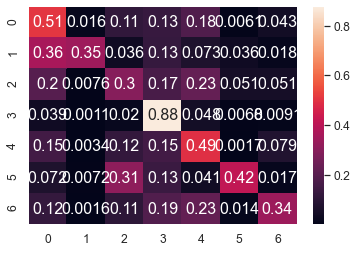

	training epoch=10 .. train_loss=1.214
	validation epoch=10 .. val_loss=1.303
	Accuracy = 52.300000000000004 % .. Percision = 53.300000000000004 % .. Recall = 46.800000000000004 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_10.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 11 .. loss = 1.702


  0%|                                                                                 | 1/1914 [00:01<37:51,  1.19s/it]

training @ epoch 11 .. loss = 1.476


  0%|                                                                                 | 2/1914 [00:02<37:49,  1.19s/it]

training @ epoch 11 .. loss = 1.031


  0%|▏                                                                                | 3/1914 [00:03<38:26,  1.21s/it]

training @ epoch 11 .. loss = 1.309


  0%|▏                                                                                | 4/1914 [00:04<38:28,  1.21s/it]

training @ epoch 11 .. loss = 1.288


  0%|▏                                                                                | 5/1914 [00:06<38:23,  1.21s/it]

training @ epoch 11 .. loss = 1.418


  0%|▎                                                                                | 6/1914 [00:07<38:08,  1.20s/it]

training @ epoch 11 .. loss = 0.871


  0%|▎                                                                                | 7/1914 [00:08<38:55,  1.22s/it]

training @ epoch 11 .. loss = 1.141


  0%|▎                                                                                | 8/1914 [00:09<38:45,  1.22s/it]

training @ epoch 11 .. loss = 1.098


  0%|▍                                                                                | 9/1914 [00:10<38:34,  1.22s/it]

training @ epoch 11 .. loss = 0.609


  1%|▍                                                                               | 10/1914 [00:12<38:19,  1.21s/it]

training @ epoch 11 .. loss = 1.071


  1%|▍                                                                               | 11/1914 [00:13<38:26,  1.21s/it]

training @ epoch 11 .. loss = 1.529


  1%|▌                                                                               | 12/1914 [00:14<38:02,  1.20s/it]

training @ epoch 11 .. loss = 1.042


  1%|▌                                                                               | 13/1914 [00:15<37:57,  1.20s/it]

training @ epoch 11 .. loss = 0.976


  1%|▌                                                                               | 14/1914 [00:16<38:21,  1.21s/it]

training @ epoch 11 .. loss = 1.01


  1%|▋                                                                               | 15/1914 [00:18<37:51,  1.20s/it]

training @ epoch 11 .. loss = 0.887


  1%|▋                                                                               | 16/1914 [00:19<37:49,  1.20s/it]

training @ epoch 11 .. loss = 1.823


  1%|▋                                                                               | 17/1914 [00:20<39:32,  1.25s/it]

training @ epoch 11 .. loss = 1.37


  1%|▊                                                                               | 18/1914 [00:21<39:15,  1.24s/it]

training @ epoch 11 .. loss = 1.253


  1%|▊                                                                               | 19/1914 [00:23<39:25,  1.25s/it]

training @ epoch 11 .. loss = 0.994


  1%|▊                                                                               | 20/1914 [00:24<39:26,  1.25s/it]

training @ epoch 11 .. loss = 0.712


  1%|▉                                                                               | 21/1914 [00:25<39:08,  1.24s/it]

training @ epoch 11 .. loss = 1.477


  1%|▉                                                                               | 22/1914 [00:26<39:03,  1.24s/it]

training @ epoch 11 .. loss = 0.975


  1%|▉                                                                               | 23/1914 [00:28<38:22,  1.22s/it]

training @ epoch 11 .. loss = 0.957


  1%|█                                                                               | 24/1914 [00:29<39:11,  1.24s/it]

training @ epoch 11 .. loss = 1.272


  1%|█                                                                               | 25/1914 [00:30<38:51,  1.23s/it]

training @ epoch 11 .. loss = 0.834


  1%|█                                                                               | 26/1914 [00:31<38:44,  1.23s/it]

training @ epoch 11 .. loss = 0.87


  1%|█▏                                                                              | 27/1914 [00:33<39:30,  1.26s/it]

training @ epoch 11 .. loss = 0.99


  1%|█▏                                                                              | 28/1914 [00:34<38:46,  1.23s/it]

training @ epoch 11 .. loss = 1.019


  2%|█▏                                                                              | 29/1914 [00:35<39:12,  1.25s/it]

training @ epoch 11 .. loss = 0.851


  2%|█▎                                                                              | 30/1914 [00:36<38:58,  1.24s/it]

training @ epoch 11 .. loss = 1.041


  2%|█▎                                                                              | 31/1914 [00:37<38:18,  1.22s/it]

training @ epoch 11 .. loss = 1.261


  2%|█▎                                                                              | 32/1914 [00:39<37:55,  1.21s/it]

training @ epoch 11 .. loss = 0.869


  2%|█▍                                                                              | 33/1914 [00:40<38:18,  1.22s/it]

training @ epoch 11 .. loss = 0.907


  2%|█▍                                                                              | 34/1914 [00:41<39:31,  1.26s/it]

training @ epoch 11 .. loss = 1.453


  2%|█▍                                                                              | 35/1914 [00:43<39:32,  1.26s/it]

training @ epoch 11 .. loss = 1.568


  2%|█▌                                                                              | 36/1914 [00:44<38:34,  1.23s/it]

training @ epoch 11 .. loss = 1.501


  2%|█▌                                                                              | 37/1914 [00:45<39:01,  1.25s/it]

training @ epoch 11 .. loss = 1.059


  2%|█▌                                                                              | 38/1914 [00:46<39:39,  1.27s/it]

training @ epoch 11 .. loss = 1.104


  2%|█▋                                                                              | 39/1914 [00:47<38:55,  1.25s/it]

training @ epoch 11 .. loss = 1.21


  2%|█▋                                                                              | 40/1914 [00:49<38:35,  1.24s/it]

training @ epoch 11 .. loss = 1.138


  2%|█▋                                                                              | 41/1914 [00:50<39:24,  1.26s/it]

training @ epoch 11 .. loss = 1.034


  2%|█▊                                                                              | 42/1914 [00:51<39:06,  1.25s/it]

training @ epoch 11 .. loss = 1.093


  2%|█▊                                                                              | 43/1914 [00:53<39:32,  1.27s/it]

training @ epoch 11 .. loss = 0.999


  2%|█▊                                                                              | 44/1914 [00:54<39:23,  1.26s/it]

training @ epoch 11 .. loss = 1.42


  2%|█▉                                                                              | 45/1914 [00:55<39:16,  1.26s/it]

training @ epoch 11 .. loss = 0.847


  2%|█▉                                                                              | 46/1914 [00:56<39:10,  1.26s/it]

training @ epoch 11 .. loss = 1.382


  2%|█▉                                                                              | 47/1914 [00:57<38:37,  1.24s/it]

training @ epoch 11 .. loss = 0.993


  3%|██                                                                              | 48/1914 [00:59<37:56,  1.22s/it]

training @ epoch 11 .. loss = 1.208


  3%|██                                                                              | 49/1914 [01:00<37:33,  1.21s/it]

training @ epoch 11 .. loss = 0.905


  3%|██                                                                              | 50/1914 [01:01<37:45,  1.22s/it]

training @ epoch 11 .. loss = 1.102


  3%|██▏                                                                             | 51/1914 [01:02<38:31,  1.24s/it]

training @ epoch 11 .. loss = 1.173


  3%|██▏                                                                             | 52/1914 [01:04<38:02,  1.23s/it]

training @ epoch 11 .. loss = 1.273


  3%|██▏                                                                             | 53/1914 [01:05<38:47,  1.25s/it]

training @ epoch 11 .. loss = 1.098


  3%|██▎                                                                             | 54/1914 [01:06<38:42,  1.25s/it]

training @ epoch 11 .. loss = 1.59


  3%|██▎                                                                             | 55/1914 [01:07<38:55,  1.26s/it]

training @ epoch 11 .. loss = 1.276


  3%|██▎                                                                             | 56/1914 [01:09<38:18,  1.24s/it]

training @ epoch 11 .. loss = 1.505


  3%|██▍                                                                             | 57/1914 [01:10<37:46,  1.22s/it]

training @ epoch 11 .. loss = 0.419


  3%|██▍                                                                             | 58/1914 [01:11<37:57,  1.23s/it]

training @ epoch 11 .. loss = 1.093


  3%|██▍                                                                             | 59/1914 [01:12<38:02,  1.23s/it]

training @ epoch 11 .. loss = 1.542


  3%|██▌                                                                             | 60/1914 [01:13<37:35,  1.22s/it]

training @ epoch 11 .. loss = 1.335


  3%|██▌                                                                             | 61/1914 [01:15<38:14,  1.24s/it]

training @ epoch 11 .. loss = 1.26


  3%|██▌                                                                             | 62/1914 [01:16<38:12,  1.24s/it]

training @ epoch 11 .. loss = 0.709


  3%|██▋                                                                             | 63/1914 [01:17<38:48,  1.26s/it]

training @ epoch 11 .. loss = 0.818


  3%|██▋                                                                             | 64/1914 [01:18<38:30,  1.25s/it]

training @ epoch 11 .. loss = 1.071


  3%|██▋                                                                             | 65/1914 [01:20<37:50,  1.23s/it]

training @ epoch 11 .. loss = 1.126


  3%|██▊                                                                             | 66/1914 [01:21<37:34,  1.22s/it]

training @ epoch 11 .. loss = 1.07


  4%|██▊                                                                             | 67/1914 [01:22<38:17,  1.24s/it]

training @ epoch 11 .. loss = 0.933


  4%|██▊                                                                             | 68/1914 [01:23<38:25,  1.25s/it]

training @ epoch 11 .. loss = 1.01


  4%|██▉                                                                             | 69/1914 [01:25<38:04,  1.24s/it]

training @ epoch 11 .. loss = 0.961


  4%|██▉                                                                             | 70/1914 [01:26<37:36,  1.22s/it]

training @ epoch 11 .. loss = 0.977


  4%|██▉                                                                             | 71/1914 [01:27<37:23,  1.22s/it]

training @ epoch 11 .. loss = 1.12


  4%|███                                                                             | 72/1914 [01:28<37:20,  1.22s/it]

training @ epoch 11 .. loss = 1.267


  4%|███                                                                             | 73/1914 [01:29<37:11,  1.21s/it]

training @ epoch 11 .. loss = 1.449


  4%|███                                                                             | 74/1914 [01:31<36:59,  1.21s/it]

training @ epoch 11 .. loss = 1.504


  4%|███▏                                                                            | 75/1914 [01:32<36:44,  1.20s/it]

training @ epoch 11 .. loss = 1.442


  4%|███▏                                                                            | 76/1914 [01:33<36:56,  1.21s/it]

training @ epoch 11 .. loss = 1.367


  4%|███▏                                                                            | 77/1914 [01:34<36:52,  1.20s/it]

training @ epoch 11 .. loss = 0.925


  4%|███▎                                                                            | 78/1914 [01:35<36:39,  1.20s/it]

training @ epoch 11 .. loss = 1.53


  4%|███▎                                                                            | 79/1914 [01:37<36:41,  1.20s/it]

training @ epoch 11 .. loss = 1.139


  4%|███▎                                                                            | 80/1914 [01:38<36:32,  1.20s/it]

training @ epoch 11 .. loss = 1.231


  4%|███▍                                                                            | 81/1914 [01:39<36:46,  1.20s/it]

training @ epoch 11 .. loss = 1.404


  4%|███▍                                                                            | 82/1914 [01:40<37:01,  1.21s/it]

training @ epoch 11 .. loss = 1.07


  4%|███▍                                                                            | 83/1914 [01:42<37:15,  1.22s/it]

training @ epoch 11 .. loss = 1.089


  4%|███▌                                                                            | 84/1914 [01:43<37:05,  1.22s/it]

training @ epoch 11 .. loss = 1.342


  4%|███▌                                                                            | 85/1914 [01:44<36:33,  1.20s/it]

training @ epoch 11 .. loss = 1.165


  4%|███▌                                                                            | 86/1914 [01:45<36:34,  1.20s/it]

training @ epoch 11 .. loss = 0.94


  5%|███▋                                                                            | 87/1914 [01:46<36:56,  1.21s/it]

training @ epoch 11 .. loss = 0.801


  5%|███▋                                                                            | 88/1914 [01:48<36:43,  1.21s/it]

training @ epoch 11 .. loss = 1.514


  5%|███▋                                                                            | 89/1914 [01:49<36:28,  1.20s/it]

training @ epoch 11 .. loss = 0.848


  5%|███▊                                                                            | 90/1914 [01:50<36:28,  1.20s/it]

training @ epoch 11 .. loss = 0.881


  5%|███▊                                                                            | 91/1914 [01:51<36:45,  1.21s/it]

training @ epoch 11 .. loss = 1.226


  5%|███▊                                                                            | 92/1914 [01:52<36:23,  1.20s/it]

training @ epoch 11 .. loss = 1.56


  5%|███▉                                                                            | 93/1914 [01:54<36:39,  1.21s/it]

training @ epoch 11 .. loss = 0.855


  5%|███▉                                                                            | 94/1914 [01:55<36:40,  1.21s/it]

training @ epoch 11 .. loss = 1.011


  5%|███▉                                                                            | 95/1914 [01:56<36:19,  1.20s/it]

training @ epoch 11 .. loss = 1.275


  5%|████                                                                            | 96/1914 [01:57<36:28,  1.20s/it]

training @ epoch 11 .. loss = 1.058


  5%|████                                                                            | 97/1914 [01:58<36:40,  1.21s/it]

training @ epoch 11 .. loss = 1.19


  5%|████                                                                            | 98/1914 [02:00<36:12,  1.20s/it]

training @ epoch 11 .. loss = 1.159


  5%|████▏                                                                           | 99/1914 [02:01<38:26,  1.27s/it]

training @ epoch 11 .. loss = 1.745


  5%|████▏                                                                          | 100/1914 [02:02<39:53,  1.32s/it]

training @ epoch 11 .. loss = 1.044


  5%|████▏                                                                          | 101/1914 [02:04<40:16,  1.33s/it]

training @ epoch 11 .. loss = 0.856


  5%|████▏                                                                          | 102/1914 [02:05<40:06,  1.33s/it]

training @ epoch 11 .. loss = 0.921


  5%|████▎                                                                          | 103/1914 [02:06<39:46,  1.32s/it]

training @ epoch 11 .. loss = 1.121


  5%|████▎                                                                          | 104/1914 [02:08<39:08,  1.30s/it]

training @ epoch 11 .. loss = 0.895


  5%|████▎                                                                          | 105/1914 [02:09<39:12,  1.30s/it]

training @ epoch 11 .. loss = 1.257


  6%|████▍                                                                          | 106/1914 [02:10<38:51,  1.29s/it]

training @ epoch 11 .. loss = 1.056


  6%|████▍                                                                          | 107/1914 [02:11<38:41,  1.28s/it]

training @ epoch 11 .. loss = 0.868


  6%|████▍                                                                          | 108/1914 [02:13<44:40,  1.48s/it]

training @ epoch 11 .. loss = 1.412


  6%|████▍                                                                          | 109/1914 [02:15<48:49,  1.62s/it]

training @ epoch 11 .. loss = 1.724


  6%|████▌                                                                          | 110/1914 [02:17<50:06,  1.67s/it]

training @ epoch 11 .. loss = 1.151


  6%|████▌                                                                          | 111/1914 [02:19<49:11,  1.64s/it]

training @ epoch 11 .. loss = 1.651


  6%|████▌                                                                          | 112/1914 [02:20<47:53,  1.59s/it]

training @ epoch 11 .. loss = 0.983


  6%|████▋                                                                          | 113/1914 [02:22<46:14,  1.54s/it]

training @ epoch 11 .. loss = 1.483


  6%|████▋                                                                          | 114/1914 [02:23<45:05,  1.50s/it]

training @ epoch 11 .. loss = 1.006


  6%|████▋                                                                          | 115/1914 [02:24<43:54,  1.46s/it]

training @ epoch 11 .. loss = 1.23


  6%|████▊                                                                          | 116/1914 [02:26<44:10,  1.47s/it]

training @ epoch 11 .. loss = 1.262


  6%|████▊                                                                          | 117/1914 [02:27<43:26,  1.45s/it]

training @ epoch 11 .. loss = 1.274


  6%|████▊                                                                          | 118/1914 [02:29<43:02,  1.44s/it]

training @ epoch 11 .. loss = 1.381


  6%|████▉                                                                          | 119/1914 [02:30<42:40,  1.43s/it]

training @ epoch 11 .. loss = 1.101


  6%|████▉                                                                          | 120/1914 [02:32<43:28,  1.45s/it]

training @ epoch 11 .. loss = 1.053


  6%|████▉                                                                          | 121/1914 [02:33<43:25,  1.45s/it]

training @ epoch 11 .. loss = 1.381


  6%|█████                                                                          | 122/1914 [02:35<43:53,  1.47s/it]

training @ epoch 11 .. loss = 1.252


  6%|█████                                                                          | 123/1914 [02:36<42:33,  1.43s/it]

training @ epoch 11 .. loss = 1.305


  6%|█████                                                                          | 124/1914 [02:37<41:42,  1.40s/it]

training @ epoch 11 .. loss = 0.919


  7%|█████▏                                                                         | 125/1914 [02:39<41:33,  1.39s/it]

training @ epoch 11 .. loss = 1.02


  7%|█████▏                                                                         | 126/1914 [02:40<43:33,  1.46s/it]

training @ epoch 11 .. loss = 1.301


  7%|█████▏                                                                         | 127/1914 [02:42<43:12,  1.45s/it]

training @ epoch 11 .. loss = 0.918


  7%|█████▎                                                                         | 128/1914 [02:43<42:48,  1.44s/it]

training @ epoch 11 .. loss = 1.589


  7%|█████▎                                                                         | 129/1914 [02:45<44:55,  1.51s/it]

training @ epoch 11 .. loss = 0.897


  7%|█████▎                                                                         | 130/1914 [02:47<48:20,  1.63s/it]

training @ epoch 11 .. loss = 1.244


  7%|█████▍                                                                         | 131/1914 [02:48<46:05,  1.55s/it]

training @ epoch 11 .. loss = 1.086


  7%|█████▍                                                                         | 132/1914 [02:49<43:51,  1.48s/it]

training @ epoch 11 .. loss = 1.149


  7%|█████▍                                                                         | 133/1914 [02:51<43:44,  1.47s/it]

training @ epoch 11 .. loss = 1.617


  7%|█████▌                                                                         | 134/1914 [02:52<42:31,  1.43s/it]

training @ epoch 11 .. loss = 1.174


  7%|█████▌                                                                         | 135/1914 [02:53<41:12,  1.39s/it]

training @ epoch 11 .. loss = 1.323


  7%|█████▌                                                                         | 136/1914 [02:55<41:24,  1.40s/it]

training @ epoch 11 .. loss = 0.829


  7%|█████▋                                                                         | 137/1914 [02:56<40:28,  1.37s/it]

training @ epoch 11 .. loss = 1.604


  7%|█████▋                                                                         | 138/1914 [02:57<39:57,  1.35s/it]

training @ epoch 11 .. loss = 1.408


  7%|█████▋                                                                         | 139/1914 [02:59<41:42,  1.41s/it]

training @ epoch 11 .. loss = 1.644


  7%|█████▊                                                                         | 140/1914 [03:01<42:27,  1.44s/it]

training @ epoch 11 .. loss = 1.653


  7%|█████▊                                                                         | 141/1914 [03:02<42:36,  1.44s/it]

training @ epoch 11 .. loss = 1.344


  7%|█████▊                                                                         | 142/1914 [03:03<42:09,  1.43s/it]

training @ epoch 11 .. loss = 0.989


  7%|█████▉                                                                         | 143/1914 [03:05<41:25,  1.40s/it]

training @ epoch 11 .. loss = 1.244


  8%|█████▉                                                                         | 144/1914 [03:06<40:24,  1.37s/it]

training @ epoch 11 .. loss = 0.887


  8%|█████▉                                                                         | 145/1914 [03:07<38:54,  1.32s/it]

training @ epoch 11 .. loss = 1.0


  8%|██████                                                                         | 146/1914 [03:08<38:08,  1.29s/it]

training @ epoch 11 .. loss = 1.121


  8%|██████                                                                         | 147/1914 [03:10<36:50,  1.25s/it]

training @ epoch 11 .. loss = 0.71


  8%|██████                                                                         | 148/1914 [03:11<36:39,  1.25s/it]

training @ epoch 11 .. loss = 1.294


  8%|██████▏                                                                        | 149/1914 [03:12<39:44,  1.35s/it]

training @ epoch 11 .. loss = 1.003


  8%|██████▏                                                                        | 150/1914 [03:14<38:35,  1.31s/it]

training @ epoch 11 .. loss = 1.011


  8%|██████▏                                                                        | 151/1914 [03:15<37:50,  1.29s/it]

training @ epoch 11 .. loss = 1.288


  8%|██████▎                                                                        | 152/1914 [03:16<37:10,  1.27s/it]

training @ epoch 11 .. loss = 1.06


  8%|██████▎                                                                        | 153/1914 [03:17<37:00,  1.26s/it]

training @ epoch 11 .. loss = 1.428


  8%|██████▎                                                                        | 154/1914 [03:19<36:45,  1.25s/it]

training @ epoch 11 .. loss = 1.337


  8%|██████▍                                                                        | 155/1914 [03:20<36:21,  1.24s/it]

training @ epoch 11 .. loss = 1.25


  8%|██████▍                                                                        | 156/1914 [03:21<36:32,  1.25s/it]

training @ epoch 11 .. loss = 1.106


  8%|██████▍                                                                        | 157/1914 [03:22<36:17,  1.24s/it]

training @ epoch 11 .. loss = 1.433


  8%|██████▌                                                                        | 158/1914 [03:23<35:46,  1.22s/it]

training @ epoch 11 .. loss = 0.73


  8%|██████▌                                                                        | 159/1914 [03:25<35:28,  1.21s/it]

training @ epoch 11 .. loss = 1.469


  8%|██████▌                                                                        | 160/1914 [03:26<34:56,  1.20s/it]

training @ epoch 11 .. loss = 1.386


  8%|██████▋                                                                        | 161/1914 [03:27<35:02,  1.20s/it]

training @ epoch 11 .. loss = 0.86


  8%|██████▋                                                                        | 162/1914 [03:28<36:17,  1.24s/it]

training @ epoch 11 .. loss = 1.16


  9%|██████▋                                                                        | 163/1914 [03:30<36:32,  1.25s/it]

training @ epoch 11 .. loss = 1.176


  9%|██████▊                                                                        | 164/1914 [03:31<36:44,  1.26s/it]

training @ epoch 11 .. loss = 1.183


  9%|██████▊                                                                        | 165/1914 [03:32<36:13,  1.24s/it]

training @ epoch 11 .. loss = 1.063


  9%|██████▊                                                                        | 166/1914 [03:33<36:00,  1.24s/it]

training @ epoch 11 .. loss = 1.206


  9%|██████▉                                                                        | 167/1914 [03:35<35:53,  1.23s/it]

training @ epoch 11 .. loss = 1.249


  9%|██████▉                                                                        | 168/1914 [03:36<35:31,  1.22s/it]

training @ epoch 11 .. loss = 1.092


  9%|██████▉                                                                        | 169/1914 [03:37<35:46,  1.23s/it]

training @ epoch 11 .. loss = 1.13


  9%|███████                                                                        | 170/1914 [03:38<35:31,  1.22s/it]

training @ epoch 11 .. loss = 0.948


  9%|███████                                                                        | 171/1914 [03:39<35:13,  1.21s/it]

training @ epoch 11 .. loss = 0.834


  9%|███████                                                                        | 172/1914 [03:41<35:58,  1.24s/it]

training @ epoch 11 .. loss = 0.997


  9%|███████▏                                                                       | 173/1914 [03:42<35:50,  1.24s/it]

training @ epoch 11 .. loss = 1.166


  9%|███████▏                                                                       | 174/1914 [03:43<35:46,  1.23s/it]

training @ epoch 11 .. loss = 0.955


  9%|███████▏                                                                       | 175/1914 [03:44<35:51,  1.24s/it]

training @ epoch 11 .. loss = 1.827


  9%|███████▎                                                                       | 176/1914 [03:46<35:16,  1.22s/it]

training @ epoch 11 .. loss = 1.252


  9%|███████▎                                                                       | 177/1914 [03:47<36:21,  1.26s/it]

training @ epoch 11 .. loss = 1.082


  9%|███████▎                                                                       | 178/1914 [03:48<36:12,  1.25s/it]

training @ epoch 11 .. loss = 1.316


  9%|███████▍                                                                       | 179/1914 [03:49<35:59,  1.24s/it]

training @ epoch 11 .. loss = 1.345


  9%|███████▍                                                                       | 180/1914 [03:51<35:45,  1.24s/it]

training @ epoch 11 .. loss = 1.46


  9%|███████▍                                                                       | 181/1914 [03:52<36:18,  1.26s/it]

training @ epoch 11 .. loss = 0.883


 10%|███████▌                                                                       | 182/1914 [03:53<35:59,  1.25s/it]

training @ epoch 11 .. loss = 0.906


 10%|███████▌                                                                       | 183/1914 [03:54<36:06,  1.25s/it]

training @ epoch 11 .. loss = 1.08


 10%|███████▌                                                                       | 184/1914 [03:56<35:13,  1.22s/it]

training @ epoch 11 .. loss = 1.388


 10%|███████▋                                                                       | 185/1914 [03:57<35:01,  1.22s/it]

training @ epoch 11 .. loss = 1.007


 10%|███████▋                                                                       | 186/1914 [03:58<34:49,  1.21s/it]

training @ epoch 11 .. loss = 1.06


 10%|███████▋                                                                       | 187/1914 [03:59<35:11,  1.22s/it]

training @ epoch 11 .. loss = 0.939


 10%|███████▊                                                                       | 188/1914 [04:00<34:48,  1.21s/it]

training @ epoch 11 .. loss = 1.204


 10%|███████▊                                                                       | 189/1914 [04:02<34:21,  1.20s/it]

training @ epoch 11 .. loss = 1.18


 10%|███████▊                                                                       | 190/1914 [04:03<35:22,  1.23s/it]

training @ epoch 11 .. loss = 0.792


 10%|███████▉                                                                       | 191/1914 [04:04<35:16,  1.23s/it]

training @ epoch 11 .. loss = 1.344


 10%|███████▉                                                                       | 192/1914 [04:05<35:38,  1.24s/it]

training @ epoch 11 .. loss = 1.076


 10%|███████▉                                                                       | 193/1914 [04:07<35:33,  1.24s/it]

training @ epoch 11 .. loss = 0.882


 10%|████████                                                                       | 194/1914 [04:08<34:57,  1.22s/it]

training @ epoch 11 .. loss = 1.017


 10%|████████                                                                       | 195/1914 [04:09<35:19,  1.23s/it]

training @ epoch 11 .. loss = 1.388


 10%|████████                                                                       | 196/1914 [04:10<35:12,  1.23s/it]

training @ epoch 11 .. loss = 1.181


 10%|████████▏                                                                      | 197/1914 [04:11<34:41,  1.21s/it]

training @ epoch 11 .. loss = 0.802


 10%|████████▏                                                                      | 198/1914 [04:13<34:39,  1.21s/it]

training @ epoch 11 .. loss = 1.21


 10%|████████▏                                                                      | 199/1914 [04:14<34:16,  1.20s/it]

training @ epoch 11 .. loss = 1.065


 10%|████████▎                                                                      | 200/1914 [04:15<34:56,  1.22s/it]

training @ epoch 11 .. loss = 1.307


 11%|████████▎                                                                      | 201/1914 [04:16<34:29,  1.21s/it]

training @ epoch 11 .. loss = 1.866


 11%|████████▎                                                                      | 202/1914 [04:17<34:30,  1.21s/it]

training @ epoch 11 .. loss = 1.261


 11%|████████▍                                                                      | 203/1914 [04:19<34:35,  1.21s/it]

training @ epoch 11 .. loss = 0.937


 11%|████████▍                                                                      | 204/1914 [04:20<34:33,  1.21s/it]

training @ epoch 11 .. loss = 1.357


 11%|████████▍                                                                      | 205/1914 [04:21<34:22,  1.21s/it]

training @ epoch 11 .. loss = 1.006


 11%|████████▌                                                                      | 206/1914 [04:22<34:14,  1.20s/it]

training @ epoch 11 .. loss = 0.902


 11%|████████▌                                                                      | 207/1914 [04:23<34:06,  1.20s/it]

training @ epoch 11 .. loss = 1.206


 11%|████████▌                                                                      | 208/1914 [04:25<34:07,  1.20s/it]

training @ epoch 11 .. loss = 1.825


 11%|████████▋                                                                      | 209/1914 [04:26<33:51,  1.19s/it]

training @ epoch 11 .. loss = 0.952


 11%|████████▋                                                                      | 210/1914 [04:27<34:00,  1.20s/it]

training @ epoch 11 .. loss = 1.42


 11%|████████▋                                                                      | 211/1914 [04:28<33:52,  1.19s/it]

training @ epoch 11 .. loss = 1.358


 11%|████████▊                                                                      | 212/1914 [04:29<33:50,  1.19s/it]

training @ epoch 11 .. loss = 0.994


 11%|████████▊                                                                      | 213/1914 [04:31<34:08,  1.20s/it]

training @ epoch 11 .. loss = 1.26


 11%|████████▊                                                                      | 214/1914 [04:32<33:45,  1.19s/it]

training @ epoch 11 .. loss = 1.071


 11%|████████▊                                                                      | 215/1914 [04:33<33:44,  1.19s/it]

training @ epoch 11 .. loss = 1.421


 11%|████████▉                                                                      | 216/1914 [04:34<33:38,  1.19s/it]

training @ epoch 11 .. loss = 1.303


 11%|████████▉                                                                      | 217/1914 [04:35<33:34,  1.19s/it]

training @ epoch 11 .. loss = 0.822


 11%|████████▉                                                                      | 218/1914 [04:37<33:55,  1.20s/it]

training @ epoch 11 .. loss = 1.408


 11%|█████████                                                                      | 219/1914 [04:38<33:45,  1.20s/it]

training @ epoch 11 .. loss = 1.227


 11%|█████████                                                                      | 220/1914 [04:39<33:58,  1.20s/it]

training @ epoch 11 .. loss = 1.232


 12%|█████████                                                                      | 221/1914 [04:40<33:54,  1.20s/it]

training @ epoch 11 .. loss = 1.026


 12%|█████████▏                                                                     | 222/1914 [04:41<33:52,  1.20s/it]

training @ epoch 11 .. loss = 1.654


 12%|█████████▏                                                                     | 223/1914 [04:43<33:46,  1.20s/it]

training @ epoch 11 .. loss = 1.167


 12%|█████████▏                                                                     | 224/1914 [04:44<33:37,  1.19s/it]

training @ epoch 11 .. loss = 1.302


 12%|█████████▎                                                                     | 225/1914 [04:45<33:55,  1.21s/it]

training @ epoch 11 .. loss = 1.244


 12%|█████████▎                                                                     | 226/1914 [04:46<34:02,  1.21s/it]

training @ epoch 11 .. loss = 1.057


 12%|█████████▎                                                                     | 227/1914 [04:48<34:43,  1.24s/it]

training @ epoch 11 .. loss = 1.174


 12%|█████████▍                                                                     | 228/1914 [04:49<34:36,  1.23s/it]

training @ epoch 11 .. loss = 1.643


 12%|█████████▍                                                                     | 229/1914 [04:50<34:59,  1.25s/it]

training @ epoch 11 .. loss = 0.897


 12%|█████████▍                                                                     | 230/1914 [04:51<35:17,  1.26s/it]

training @ epoch 11 .. loss = 0.941


 12%|█████████▌                                                                     | 231/1914 [04:53<34:59,  1.25s/it]

training @ epoch 11 .. loss = 0.897


 12%|█████████▌                                                                     | 232/1914 [04:54<34:36,  1.23s/it]

training @ epoch 11 .. loss = 0.973


 12%|█████████▌                                                                     | 233/1914 [04:55<34:35,  1.23s/it]

training @ epoch 11 .. loss = 1.199


 12%|█████████▋                                                                     | 234/1914 [04:56<34:07,  1.22s/it]

training @ epoch 11 .. loss = 1.07


 12%|█████████▋                                                                     | 235/1914 [04:57<34:02,  1.22s/it]

training @ epoch 11 .. loss = 0.791


 12%|█████████▋                                                                     | 236/1914 [04:59<33:59,  1.22s/it]

training @ epoch 11 .. loss = 1.514


 12%|█████████▊                                                                     | 237/1914 [05:00<33:21,  1.19s/it]

training @ epoch 11 .. loss = 1.351


 12%|█████████▊                                                                     | 238/1914 [05:01<33:35,  1.20s/it]

training @ epoch 11 .. loss = 1.027


 12%|█████████▊                                                                     | 239/1914 [05:03<37:05,  1.33s/it]

training @ epoch 11 .. loss = 1.159


 13%|█████████▉                                                                     | 240/1914 [05:05<43:08,  1.55s/it]

training @ epoch 11 .. loss = 0.583


 13%|█████████▉                                                                     | 241/1914 [05:06<45:44,  1.64s/it]

training @ epoch 11 .. loss = 1.07


 13%|█████████▉                                                                     | 242/1914 [05:08<45:34,  1.64s/it]

training @ epoch 11 .. loss = 0.836


 13%|██████████                                                                     | 243/1914 [05:09<43:03,  1.55s/it]

training @ epoch 11 .. loss = 1.454


 13%|██████████                                                                     | 244/1914 [05:11<41:19,  1.48s/it]

training @ epoch 11 .. loss = 0.815


 13%|██████████                                                                     | 245/1914 [05:12<39:47,  1.43s/it]

training @ epoch 11 .. loss = 1.305


 13%|██████████▏                                                                    | 246/1914 [05:13<38:39,  1.39s/it]

training @ epoch 11 .. loss = 1.198


 13%|██████████▏                                                                    | 247/1914 [05:15<38:39,  1.39s/it]

training @ epoch 11 .. loss = 0.705


 13%|██████████▏                                                                    | 248/1914 [05:16<38:44,  1.40s/it]

training @ epoch 11 .. loss = 1.029


 13%|██████████▎                                                                    | 249/1914 [05:18<38:52,  1.40s/it]

training @ epoch 11 .. loss = 1.118


 13%|██████████▎                                                                    | 250/1914 [05:19<39:07,  1.41s/it]

training @ epoch 11 .. loss = 1.354


 13%|██████████▎                                                                    | 251/1914 [05:21<40:04,  1.45s/it]

training @ epoch 11 .. loss = 1.318


 13%|██████████▍                                                                    | 252/1914 [05:22<38:04,  1.37s/it]

training @ epoch 11 .. loss = 0.831


 13%|██████████▍                                                                    | 253/1914 [05:23<37:06,  1.34s/it]

training @ epoch 11 .. loss = 1.52


 13%|██████████▍                                                                    | 254/1914 [05:24<36:17,  1.31s/it]

training @ epoch 11 .. loss = 1.225


 13%|██████████▌                                                                    | 255/1914 [05:26<36:37,  1.32s/it]

training @ epoch 11 .. loss = 1.71


 13%|██████████▌                                                                    | 256/1914 [05:27<36:20,  1.32s/it]

training @ epoch 11 .. loss = 1.448


 13%|██████████▌                                                                    | 257/1914 [05:28<36:08,  1.31s/it]

training @ epoch 11 .. loss = 1.178


 13%|██████████▋                                                                    | 258/1914 [05:29<35:08,  1.27s/it]

training @ epoch 11 .. loss = 1.133


 14%|██████████▋                                                                    | 259/1914 [05:31<36:06,  1.31s/it]

training @ epoch 11 .. loss = 1.264


 14%|██████████▋                                                                    | 260/1914 [05:32<35:51,  1.30s/it]

training @ epoch 11 .. loss = 1.284


 14%|██████████▊                                                                    | 261/1914 [05:33<35:11,  1.28s/it]

training @ epoch 11 .. loss = 0.772


 14%|██████████▊                                                                    | 262/1914 [05:34<34:32,  1.25s/it]

training @ epoch 11 .. loss = 1.009


 14%|██████████▊                                                                    | 263/1914 [05:36<34:07,  1.24s/it]

training @ epoch 11 .. loss = 1.4


 14%|██████████▉                                                                    | 264/1914 [05:37<34:05,  1.24s/it]

training @ epoch 11 .. loss = 1.261


 14%|██████████▉                                                                    | 265/1914 [05:38<34:01,  1.24s/it]

training @ epoch 11 .. loss = 1.215


 14%|██████████▉                                                                    | 266/1914 [05:39<33:26,  1.22s/it]

training @ epoch 11 .. loss = 1.718


 14%|███████████                                                                    | 267/1914 [05:41<33:28,  1.22s/it]

training @ epoch 11 .. loss = 0.98


 14%|███████████                                                                    | 268/1914 [05:42<33:14,  1.21s/it]

training @ epoch 11 .. loss = 1.311


 14%|███████████                                                                    | 269/1914 [05:43<33:17,  1.21s/it]

training @ epoch 11 .. loss = 0.823


 14%|███████████▏                                                                   | 270/1914 [05:44<33:16,  1.21s/it]

training @ epoch 11 .. loss = 0.909


 14%|███████████▏                                                                   | 271/1914 [05:45<32:54,  1.20s/it]

training @ epoch 11 .. loss = 0.653


 14%|███████████▏                                                                   | 272/1914 [05:47<33:01,  1.21s/it]

training @ epoch 11 .. loss = 1.249


 14%|███████████▎                                                                   | 273/1914 [05:48<32:47,  1.20s/it]

training @ epoch 11 .. loss = 1.55


 14%|███████████▎                                                                   | 274/1914 [05:49<33:08,  1.21s/it]

training @ epoch 11 .. loss = 0.761


 14%|███████████▎                                                                   | 275/1914 [05:50<33:06,  1.21s/it]

training @ epoch 11 .. loss = 1.403


 14%|███████████▍                                                                   | 276/1914 [05:51<33:05,  1.21s/it]

training @ epoch 11 .. loss = 1.169


 14%|███████████▍                                                                   | 277/1914 [05:53<33:14,  1.22s/it]

training @ epoch 11 .. loss = 1.539


 15%|███████████▍                                                                   | 278/1914 [05:54<33:05,  1.21s/it]

training @ epoch 11 .. loss = 1.226


 15%|███████████▌                                                                   | 279/1914 [05:55<33:08,  1.22s/it]

training @ epoch 11 .. loss = 1.497


 15%|███████████▌                                                                   | 280/1914 [05:56<33:05,  1.22s/it]

training @ epoch 11 .. loss = 1.193


 15%|███████████▌                                                                   | 281/1914 [05:57<32:43,  1.20s/it]

training @ epoch 11 .. loss = 1.102


 15%|███████████▋                                                                   | 282/1914 [05:59<32:41,  1.20s/it]

training @ epoch 11 .. loss = 1.257


 15%|███████████▋                                                                   | 283/1914 [06:00<33:06,  1.22s/it]

training @ epoch 11 .. loss = 1.243


 15%|███████████▋                                                                   | 284/1914 [06:01<34:50,  1.28s/it]

training @ epoch 11 .. loss = 1.305


 15%|███████████▊                                                                   | 285/1914 [06:03<35:10,  1.30s/it]

training @ epoch 11 .. loss = 1.031


 15%|███████████▊                                                                   | 286/1914 [06:04<36:41,  1.35s/it]

training @ epoch 11 .. loss = 0.95


 15%|███████████▊                                                                   | 287/1914 [06:05<35:40,  1.32s/it]

training @ epoch 11 .. loss = 0.86


 15%|███████████▉                                                                   | 288/1914 [06:07<35:10,  1.30s/it]

training @ epoch 11 .. loss = 1.172


 15%|███████████▉                                                                   | 289/1914 [06:08<34:31,  1.27s/it]

training @ epoch 11 .. loss = 1.151


 15%|███████████▉                                                                   | 290/1914 [06:09<34:44,  1.28s/it]

training @ epoch 11 .. loss = 1.193


 15%|████████████                                                                   | 291/1914 [06:10<34:28,  1.27s/it]

training @ epoch 11 .. loss = 1.23


 15%|████████████                                                                   | 292/1914 [06:12<33:37,  1.24s/it]

training @ epoch 11 .. loss = 1.126


 15%|████████████                                                                   | 293/1914 [06:13<34:19,  1.27s/it]

training @ epoch 11 .. loss = 1.287


 15%|████████████▏                                                                  | 294/1914 [06:14<35:40,  1.32s/it]

training @ epoch 11 .. loss = 1.278


 15%|████████████▏                                                                  | 295/1914 [06:16<36:07,  1.34s/it]

training @ epoch 11 .. loss = 1.131


 15%|████████████▏                                                                  | 296/1914 [06:17<37:04,  1.37s/it]

training @ epoch 11 .. loss = 1.109


 16%|████████████▎                                                                  | 297/1914 [06:19<37:28,  1.39s/it]

training @ epoch 11 .. loss = 1.139


 16%|████████████▎                                                                  | 298/1914 [06:20<37:32,  1.39s/it]

training @ epoch 11 .. loss = 1.075


 16%|████████████▎                                                                  | 299/1914 [06:22<38:01,  1.41s/it]

training @ epoch 11 .. loss = 0.975


 16%|████████████▍                                                                  | 300/1914 [06:23<37:22,  1.39s/it]

training @ epoch 11 .. loss = 1.267


 16%|████████████▍                                                                  | 301/1914 [06:24<36:49,  1.37s/it]

training @ epoch 11 .. loss = 1.553


 16%|████████████▍                                                                  | 302/1914 [06:26<36:31,  1.36s/it]

training @ epoch 11 .. loss = 1.466


 16%|████████████▌                                                                  | 303/1914 [06:27<36:18,  1.35s/it]

training @ epoch 11 .. loss = 1.534


 16%|████████████▌                                                                  | 304/1914 [06:28<35:58,  1.34s/it]

training @ epoch 11 .. loss = 0.919


 16%|████████████▌                                                                  | 305/1914 [06:29<35:59,  1.34s/it]

training @ epoch 11 .. loss = 1.124


 16%|████████████▋                                                                  | 306/1914 [06:31<35:54,  1.34s/it]

training @ epoch 11 .. loss = 1.503


 16%|████████████▋                                                                  | 307/1914 [06:32<36:28,  1.36s/it]

training @ epoch 11 .. loss = 1.255


 16%|████████████▋                                                                  | 308/1914 [06:34<36:04,  1.35s/it]

training @ epoch 11 .. loss = 0.953


 16%|████████████▊                                                                  | 309/1914 [06:35<35:05,  1.31s/it]

training @ epoch 11 .. loss = 1.159


 16%|████████████▊                                                                  | 310/1914 [06:36<34:16,  1.28s/it]

training @ epoch 11 .. loss = 1.111


 16%|████████████▊                                                                  | 311/1914 [06:37<33:56,  1.27s/it]

training @ epoch 11 .. loss = 1.055


 16%|████████████▉                                                                  | 312/1914 [06:38<33:37,  1.26s/it]

training @ epoch 11 .. loss = 1.419


 16%|████████████▉                                                                  | 313/1914 [06:40<32:49,  1.23s/it]

training @ epoch 11 .. loss = 1.386


 16%|████████████▉                                                                  | 314/1914 [06:41<32:44,  1.23s/it]

training @ epoch 11 .. loss = 1.642


 16%|█████████████                                                                  | 315/1914 [06:42<32:35,  1.22s/it]

training @ epoch 11 .. loss = 1.145


 17%|█████████████                                                                  | 316/1914 [06:43<32:19,  1.21s/it]

training @ epoch 11 .. loss = 1.618


 17%|█████████████                                                                  | 317/1914 [06:44<32:17,  1.21s/it]

training @ epoch 11 .. loss = 0.819


 17%|█████████████▏                                                                 | 318/1914 [06:46<31:42,  1.19s/it]

training @ epoch 11 .. loss = 1.779


 17%|█████████████▏                                                                 | 319/1914 [06:47<32:00,  1.20s/it]

training @ epoch 11 .. loss = 1.061


 17%|█████████████▏                                                                 | 320/1914 [06:48<31:36,  1.19s/it]

training @ epoch 11 .. loss = 1.408


 17%|█████████████▏                                                                 | 321/1914 [06:49<32:00,  1.21s/it]

training @ epoch 11 .. loss = 1.15


 17%|█████████████▎                                                                 | 322/1914 [06:50<32:07,  1.21s/it]

training @ epoch 11 .. loss = 1.063


 17%|█████████████▎                                                                 | 323/1914 [06:52<31:34,  1.19s/it]

training @ epoch 11 .. loss = 1.465


 17%|█████████████▎                                                                 | 324/1914 [06:53<31:37,  1.19s/it]

training @ epoch 11 .. loss = 1.634


 17%|█████████████▍                                                                 | 325/1914 [06:54<31:35,  1.19s/it]

training @ epoch 11 .. loss = 1.229


 17%|█████████████▍                                                                 | 326/1914 [06:55<31:47,  1.20s/it]

training @ epoch 11 .. loss = 1.019


 17%|█████████████▍                                                                 | 327/1914 [06:56<31:56,  1.21s/it]

training @ epoch 11 .. loss = 0.762


 17%|█████████████▌                                                                 | 328/1914 [06:58<31:42,  1.20s/it]

training @ epoch 11 .. loss = 1.162


 17%|█████████████▌                                                                 | 329/1914 [06:59<31:33,  1.19s/it]

training @ epoch 11 .. loss = 0.729


 17%|█████████████▌                                                                 | 330/1914 [07:00<31:35,  1.20s/it]

training @ epoch 11 .. loss = 0.782


 17%|█████████████▋                                                                 | 331/1914 [07:01<31:46,  1.20s/it]

training @ epoch 11 .. loss = 1.416


 17%|█████████████▋                                                                 | 332/1914 [07:02<31:59,  1.21s/it]

training @ epoch 11 .. loss = 1.239


 17%|█████████████▋                                                                 | 333/1914 [07:04<31:56,  1.21s/it]

training @ epoch 11 .. loss = 0.859


 17%|█████████████▊                                                                 | 334/1914 [07:05<32:09,  1.22s/it]

training @ epoch 11 .. loss = 0.762


 18%|█████████████▊                                                                 | 335/1914 [07:06<32:19,  1.23s/it]

training @ epoch 11 .. loss = 1.175


 18%|█████████████▊                                                                 | 336/1914 [07:07<31:56,  1.21s/it]

training @ epoch 11 .. loss = 1.506


 18%|█████████████▉                                                                 | 337/1914 [07:09<31:49,  1.21s/it]

training @ epoch 11 .. loss = 1.155


 18%|█████████████▉                                                                 | 338/1914 [07:10<31:53,  1.21s/it]

training @ epoch 11 .. loss = 1.315


 18%|█████████████▉                                                                 | 339/1914 [07:11<32:05,  1.22s/it]

training @ epoch 11 .. loss = 1.109


 18%|██████████████                                                                 | 340/1914 [07:12<31:43,  1.21s/it]

training @ epoch 11 .. loss = 0.593


 18%|██████████████                                                                 | 341/1914 [07:13<31:38,  1.21s/it]

training @ epoch 11 .. loss = 1.286


 18%|██████████████                                                                 | 342/1914 [07:15<31:53,  1.22s/it]

training @ epoch 11 .. loss = 1.086


 18%|██████████████▏                                                                | 343/1914 [07:16<31:36,  1.21s/it]

training @ epoch 11 .. loss = 1.576


 18%|██████████████▏                                                                | 344/1914 [07:17<31:37,  1.21s/it]

training @ epoch 11 .. loss = 1.429


 18%|██████████████▏                                                                | 345/1914 [07:18<32:06,  1.23s/it]

training @ epoch 11 .. loss = 0.923


 18%|██████████████▎                                                                | 346/1914 [07:20<32:02,  1.23s/it]

training @ epoch 11 .. loss = 0.978


 18%|██████████████▎                                                                | 347/1914 [07:21<32:08,  1.23s/it]

training @ epoch 11 .. loss = 1.252


 18%|██████████████▎                                                                | 348/1914 [07:22<32:22,  1.24s/it]

training @ epoch 11 .. loss = 1.032


 18%|██████████████▍                                                                | 349/1914 [07:23<32:16,  1.24s/it]

training @ epoch 11 .. loss = 1.237


 18%|██████████████▍                                                                | 350/1914 [07:24<32:08,  1.23s/it]

training @ epoch 11 .. loss = 1.574


 18%|██████████████▍                                                                | 351/1914 [07:26<31:34,  1.21s/it]

training @ epoch 11 .. loss = 0.954


 18%|██████████████▌                                                                | 352/1914 [07:27<31:47,  1.22s/it]

training @ epoch 11 .. loss = 1.465


 18%|██████████████▌                                                                | 353/1914 [07:28<31:42,  1.22s/it]

training @ epoch 11 .. loss = 1.182


 18%|██████████████▌                                                                | 354/1914 [07:29<31:51,  1.23s/it]

training @ epoch 11 .. loss = 1.576


 19%|██████████████▋                                                                | 355/1914 [07:31<31:35,  1.22s/it]

training @ epoch 11 .. loss = 0.867


 19%|██████████████▋                                                                | 356/1914 [07:32<31:32,  1.21s/it]

training @ epoch 11 .. loss = 1.209


 19%|██████████████▋                                                                | 357/1914 [07:33<31:43,  1.22s/it]

training @ epoch 11 .. loss = 1.438


 19%|██████████████▊                                                                | 358/1914 [07:34<31:33,  1.22s/it]

training @ epoch 11 .. loss = 1.48


 19%|██████████████▊                                                                | 359/1914 [07:35<31:21,  1.21s/it]

training @ epoch 11 .. loss = 1.661


 19%|██████████████▊                                                                | 360/1914 [07:37<31:30,  1.22s/it]

training @ epoch 11 .. loss = 1.227


 19%|██████████████▉                                                                | 361/1914 [07:38<31:17,  1.21s/it]

training @ epoch 11 .. loss = 1.103


 19%|██████████████▉                                                                | 362/1914 [07:39<31:32,  1.22s/it]

training @ epoch 11 .. loss = 1.497


 19%|██████████████▉                                                                | 363/1914 [07:40<31:17,  1.21s/it]

training @ epoch 11 .. loss = 1.201


 19%|███████████████                                                                | 364/1914 [07:41<31:03,  1.20s/it]

training @ epoch 11 .. loss = 1.365


 19%|███████████████                                                                | 365/1914 [07:43<31:15,  1.21s/it]

training @ epoch 11 .. loss = 1.419


 19%|███████████████                                                                | 366/1914 [07:44<31:10,  1.21s/it]

training @ epoch 11 .. loss = 0.783


 19%|███████████████▏                                                               | 367/1914 [07:45<31:15,  1.21s/it]

training @ epoch 11 .. loss = 1.48


 19%|███████████████▏                                                               | 368/1914 [07:46<31:28,  1.22s/it]

training @ epoch 11 .. loss = 1.352


 19%|███████████████▏                                                               | 369/1914 [07:48<31:04,  1.21s/it]

training @ epoch 11 .. loss = 1.16


 19%|███████████████▎                                                               | 370/1914 [07:49<31:05,  1.21s/it]

training @ epoch 11 .. loss = 1.397


 19%|███████████████▎                                                               | 371/1914 [07:50<31:01,  1.21s/it]

training @ epoch 11 .. loss = 0.888


 19%|███████████████▎                                                               | 372/1914 [07:51<31:08,  1.21s/it]

training @ epoch 11 .. loss = 1.131


 19%|███████████████▍                                                               | 373/1914 [07:52<31:14,  1.22s/it]

training @ epoch 11 .. loss = 1.101


 20%|███████████████▍                                                               | 374/1914 [07:54<30:54,  1.20s/it]

training @ epoch 11 .. loss = 1.062


 20%|███████████████▍                                                               | 375/1914 [07:55<30:59,  1.21s/it]

training @ epoch 11 .. loss = 0.886


 20%|███████████████▌                                                               | 376/1914 [07:56<30:58,  1.21s/it]

training @ epoch 11 .. loss = 1.182


 20%|███████████████▌                                                               | 377/1914 [07:57<31:03,  1.21s/it]

training @ epoch 11 .. loss = 1.458


 20%|███████████████▌                                                               | 378/1914 [07:58<31:07,  1.22s/it]

training @ epoch 11 .. loss = 1.16


 20%|███████████████▋                                                               | 379/1914 [08:00<30:45,  1.20s/it]

training @ epoch 11 .. loss = 1.601


 20%|███████████████▋                                                               | 380/1914 [08:01<30:53,  1.21s/it]

training @ epoch 11 .. loss = 0.89


 20%|███████████████▋                                                               | 381/1914 [08:02<30:31,  1.19s/it]

training @ epoch 11 .. loss = 1.061


 20%|███████████████▊                                                               | 382/1914 [08:03<30:33,  1.20s/it]

training @ epoch 11 .. loss = 1.453


 20%|███████████████▊                                                               | 383/1914 [08:04<30:39,  1.20s/it]

training @ epoch 11 .. loss = 1.344


 20%|███████████████▊                                                               | 384/1914 [08:06<30:42,  1.20s/it]

training @ epoch 11 .. loss = 1.223


 20%|███████████████▉                                                               | 385/1914 [08:07<30:54,  1.21s/it]

training @ epoch 11 .. loss = 1.708


 20%|███████████████▉                                                               | 386/1914 [08:08<30:47,  1.21s/it]

training @ epoch 11 .. loss = 1.029


 20%|███████████████▉                                                               | 387/1914 [08:09<30:44,  1.21s/it]

training @ epoch 11 .. loss = 1.246


 20%|████████████████                                                               | 388/1914 [08:10<30:40,  1.21s/it]

training @ epoch 11 .. loss = 1.159


 20%|████████████████                                                               | 389/1914 [08:12<30:23,  1.20s/it]

training @ epoch 11 .. loss = 0.815


 20%|████████████████                                                               | 390/1914 [08:13<30:44,  1.21s/it]

training @ epoch 11 .. loss = 1.168


 20%|████████████████▏                                                              | 391/1914 [08:14<30:39,  1.21s/it]

training @ epoch 11 .. loss = 1.279


 20%|████████████████▏                                                              | 392/1914 [08:15<30:40,  1.21s/it]

training @ epoch 11 .. loss = 1.097


 21%|████████████████▏                                                              | 393/1914 [08:16<30:31,  1.20s/it]

training @ epoch 11 .. loss = 1.211


 21%|████████████████▎                                                              | 394/1914 [08:18<30:08,  1.19s/it]

training @ epoch 11 .. loss = 1.454


 21%|████████████████▎                                                              | 395/1914 [08:19<30:37,  1.21s/it]

training @ epoch 11 .. loss = 1.505


 21%|████████████████▎                                                              | 396/1914 [08:20<30:49,  1.22s/it]

training @ epoch 11 .. loss = 0.997


 21%|████████████████▍                                                              | 397/1914 [08:21<30:50,  1.22s/it]

training @ epoch 11 .. loss = 1.114


 21%|████████████████▍                                                              | 398/1914 [08:23<31:03,  1.23s/it]

training @ epoch 11 .. loss = 0.978


 21%|████████████████▍                                                              | 399/1914 [08:24<30:52,  1.22s/it]

training @ epoch 11 .. loss = 1.213


 21%|████████████████▌                                                              | 400/1914 [08:25<30:57,  1.23s/it]

training @ epoch 11 .. loss = 1.367


 21%|████████████████▌                                                              | 401/1914 [08:26<31:06,  1.23s/it]

training @ epoch 11 .. loss = 1.024


 21%|████████████████▌                                                              | 402/1914 [08:27<30:37,  1.22s/it]

training @ epoch 11 .. loss = 0.993


 21%|████████████████▋                                                              | 403/1914 [08:29<30:56,  1.23s/it]

training @ epoch 11 .. loss = 0.828


 21%|████████████████▋                                                              | 404/1914 [08:30<30:44,  1.22s/it]

training @ epoch 11 .. loss = 1.143


 21%|████████████████▋                                                              | 405/1914 [08:31<30:52,  1.23s/it]

training @ epoch 11 .. loss = 1.789


 21%|████████████████▊                                                              | 406/1914 [08:32<30:53,  1.23s/it]

training @ epoch 11 .. loss = 1.268


 21%|████████████████▊                                                              | 407/1914 [08:34<30:31,  1.22s/it]

training @ epoch 11 .. loss = 1.381


 21%|████████████████▊                                                              | 408/1914 [08:35<30:33,  1.22s/it]

training @ epoch 11 .. loss = 1.03


 21%|████████████████▉                                                              | 409/1914 [08:36<30:43,  1.22s/it]

training @ epoch 11 .. loss = 1.787


 21%|████████████████▉                                                              | 410/1914 [08:37<30:35,  1.22s/it]

training @ epoch 11 .. loss = 1.372


 21%|████████████████▉                                                              | 411/1914 [08:38<30:30,  1.22s/it]

training @ epoch 11 .. loss = 1.065


 22%|█████████████████                                                              | 412/1914 [08:40<30:12,  1.21s/it]

training @ epoch 11 .. loss = 1.315


 22%|█████████████████                                                              | 413/1914 [08:41<30:27,  1.22s/it]

training @ epoch 11 .. loss = 1.112


 22%|█████████████████                                                              | 414/1914 [08:42<30:15,  1.21s/it]

training @ epoch 11 .. loss = 1.392


 22%|█████████████████▏                                                             | 415/1914 [08:43<30:27,  1.22s/it]

training @ epoch 11 .. loss = 1.041


 22%|█████████████████▏                                                             | 416/1914 [08:45<30:23,  1.22s/it]

training @ epoch 11 .. loss = 1.06


 22%|█████████████████▏                                                             | 417/1914 [08:46<30:45,  1.23s/it]

training @ epoch 11 .. loss = 1.231


 22%|█████████████████▎                                                             | 418/1914 [08:47<30:56,  1.24s/it]

training @ epoch 11 .. loss = 0.995


 22%|█████████████████▎                                                             | 419/1914 [08:48<30:40,  1.23s/it]

training @ epoch 11 .. loss = 1.292


 22%|█████████████████▎                                                             | 420/1914 [08:49<30:08,  1.21s/it]

training @ epoch 11 .. loss = 1.192


 22%|█████████████████▍                                                             | 421/1914 [08:51<30:17,  1.22s/it]

training @ epoch 11 .. loss = 1.201


 22%|█████████████████▍                                                             | 422/1914 [08:52<30:17,  1.22s/it]

training @ epoch 11 .. loss = 1.082


 22%|█████████████████▍                                                             | 423/1914 [08:53<30:12,  1.22s/it]

training @ epoch 11 .. loss = 1.342


 22%|█████████████████▌                                                             | 424/1914 [08:54<30:23,  1.22s/it]

training @ epoch 11 .. loss = 1.518


 22%|█████████████████▌                                                             | 425/1914 [08:56<30:22,  1.22s/it]

training @ epoch 11 .. loss = 1.067


 22%|█████████████████▌                                                             | 426/1914 [08:57<30:07,  1.21s/it]

training @ epoch 11 .. loss = 0.76


 22%|█████████████████▌                                                             | 427/1914 [08:58<30:09,  1.22s/it]

training @ epoch 11 .. loss = 1.342


 22%|█████████████████▋                                                             | 428/1914 [08:59<29:48,  1.20s/it]

training @ epoch 11 .. loss = 1.1


 22%|█████████████████▋                                                             | 429/1914 [09:00<29:37,  1.20s/it]

training @ epoch 11 .. loss = 1.728


 22%|█████████████████▋                                                             | 430/1914 [09:02<29:28,  1.19s/it]

training @ epoch 11 .. loss = 1.308


 23%|█████████████████▊                                                             | 431/1914 [09:03<29:44,  1.20s/it]

training @ epoch 11 .. loss = 1.513


 23%|█████████████████▊                                                             | 432/1914 [09:04<29:28,  1.19s/it]

training @ epoch 11 .. loss = 1.421


 23%|█████████████████▊                                                             | 433/1914 [09:05<29:22,  1.19s/it]

training @ epoch 11 .. loss = 1.388


 23%|█████████████████▉                                                             | 434/1914 [09:06<29:39,  1.20s/it]

training @ epoch 11 .. loss = 1.224


 23%|█████████████████▉                                                             | 435/1914 [09:07<29:20,  1.19s/it]

training @ epoch 11 .. loss = 0.822


 23%|█████████████████▉                                                             | 436/1914 [09:09<29:29,  1.20s/it]

training @ epoch 11 .. loss = 1.534


 23%|██████████████████                                                             | 437/1914 [09:10<29:29,  1.20s/it]

training @ epoch 11 .. loss = 0.922


 23%|██████████████████                                                             | 438/1914 [09:11<29:35,  1.20s/it]

training @ epoch 11 .. loss = 0.715


 23%|██████████████████                                                             | 439/1914 [09:12<29:40,  1.21s/it]

training @ epoch 11 .. loss = 1.218


 23%|██████████████████▏                                                            | 440/1914 [09:14<29:28,  1.20s/it]

training @ epoch 11 .. loss = 1.521


 23%|██████████████████▏                                                            | 441/1914 [09:15<29:41,  1.21s/it]

training @ epoch 11 .. loss = 1.213


 23%|██████████████████▏                                                            | 442/1914 [09:16<29:34,  1.21s/it]

training @ epoch 11 .. loss = 1.152


 23%|██████████████████▎                                                            | 443/1914 [09:17<29:31,  1.20s/it]

training @ epoch 11 .. loss = 1.089


 23%|██████████████████▎                                                            | 444/1914 [09:18<29:38,  1.21s/it]

training @ epoch 11 .. loss = 1.464


 23%|██████████████████▎                                                            | 445/1914 [09:20<29:29,  1.20s/it]

training @ epoch 11 .. loss = 0.808


 23%|██████████████████▍                                                            | 446/1914 [09:21<29:35,  1.21s/it]

training @ epoch 11 .. loss = 1.32


 23%|██████████████████▍                                                            | 447/1914 [09:22<29:27,  1.20s/it]

training @ epoch 11 .. loss = 0.917


 23%|██████████████████▍                                                            | 448/1914 [09:23<30:05,  1.23s/it]

training @ epoch 11 .. loss = 1.306


 23%|██████████████████▌                                                            | 449/1914 [09:24<29:51,  1.22s/it]

training @ epoch 11 .. loss = 1.663


 24%|██████████████████▌                                                            | 450/1914 [09:26<29:34,  1.21s/it]

training @ epoch 11 .. loss = 1.394


 24%|██████████████████▌                                                            | 451/1914 [09:27<29:42,  1.22s/it]

training @ epoch 11 .. loss = 1.07


 24%|██████████████████▋                                                            | 452/1914 [09:28<29:38,  1.22s/it]

training @ epoch 11 .. loss = 0.842


 24%|██████████████████▋                                                            | 453/1914 [09:29<29:51,  1.23s/it]

training @ epoch 11 .. loss = 0.786


 24%|██████████████████▋                                                            | 454/1914 [09:31<29:43,  1.22s/it]

training @ epoch 11 .. loss = 1.336


 24%|██████████████████▊                                                            | 455/1914 [09:32<29:22,  1.21s/it]

training @ epoch 11 .. loss = 1.044


 24%|██████████████████▊                                                            | 456/1914 [09:33<29:32,  1.22s/it]

training @ epoch 11 .. loss = 1.124


 24%|██████████████████▊                                                            | 457/1914 [09:34<29:20,  1.21s/it]

training @ epoch 11 .. loss = 1.622


 24%|██████████████████▉                                                            | 458/1914 [09:35<29:16,  1.21s/it]

training @ epoch 11 .. loss = 1.298


 24%|██████████████████▉                                                            | 459/1914 [09:37<29:21,  1.21s/it]

training @ epoch 11 .. loss = 0.901


 24%|██████████████████▉                                                            | 460/1914 [09:38<29:15,  1.21s/it]

training @ epoch 11 .. loss = 0.867


 24%|███████████████████                                                            | 461/1914 [09:39<29:13,  1.21s/it]

training @ epoch 11 .. loss = 1.05


 24%|███████████████████                                                            | 462/1914 [09:40<29:04,  1.20s/it]

training @ epoch 11 .. loss = 1.167


 24%|███████████████████                                                            | 463/1914 [09:41<29:03,  1.20s/it]

training @ epoch 11 .. loss = 1.228


 24%|███████████████████▏                                                           | 464/1914 [09:43<29:11,  1.21s/it]

training @ epoch 11 .. loss = 1.287


 24%|███████████████████▏                                                           | 465/1914 [09:44<29:20,  1.21s/it]

training @ epoch 11 .. loss = 1.317


 24%|███████████████████▏                                                           | 466/1914 [09:45<29:21,  1.22s/it]

training @ epoch 11 .. loss = 1.473


 24%|███████████████████▎                                                           | 467/1914 [09:46<29:10,  1.21s/it]

training @ epoch 11 .. loss = 1.106


 24%|███████████████████▎                                                           | 468/1914 [09:47<28:48,  1.20s/it]

training @ epoch 11 .. loss = 1.159


 25%|███████████████████▎                                                           | 469/1914 [09:49<29:07,  1.21s/it]

training @ epoch 11 .. loss = 0.737


 25%|███████████████████▍                                                           | 470/1914 [09:50<28:56,  1.20s/it]

training @ epoch 11 .. loss = 0.969


 25%|███████████████████▍                                                           | 471/1914 [09:51<29:01,  1.21s/it]

training @ epoch 11 .. loss = 1.131


 25%|███████████████████▍                                                           | 472/1914 [09:52<29:11,  1.21s/it]

training @ epoch 11 .. loss = 0.946


 25%|███████████████████▌                                                           | 473/1914 [09:53<29:02,  1.21s/it]

training @ epoch 11 .. loss = 1.378


 25%|███████████████████▌                                                           | 474/1914 [09:55<29:11,  1.22s/it]

training @ epoch 11 .. loss = 1.024


 25%|███████████████████▌                                                           | 475/1914 [09:56<28:54,  1.21s/it]

training @ epoch 11 .. loss = 0.974


 25%|███████████████████▋                                                           | 476/1914 [09:57<28:56,  1.21s/it]

training @ epoch 11 .. loss = 1.291


 25%|███████████████████▋                                                           | 477/1914 [09:58<29:14,  1.22s/it]

training @ epoch 11 .. loss = 1.185


 25%|███████████████████▋                                                           | 478/1914 [10:00<29:04,  1.21s/it]

training @ epoch 11 .. loss = 0.928


 25%|███████████████████▊                                                           | 479/1914 [10:01<29:06,  1.22s/it]

training @ epoch 11 .. loss = 1.423


 25%|███████████████████▊                                                           | 480/1914 [10:02<29:04,  1.22s/it]

training @ epoch 11 .. loss = 0.803


 25%|███████████████████▊                                                           | 481/1914 [10:03<29:03,  1.22s/it]

training @ epoch 11 .. loss = 1.237


 25%|███████████████████▉                                                           | 482/1914 [10:04<29:01,  1.22s/it]

training @ epoch 11 .. loss = 1.16


 25%|███████████████████▉                                                           | 483/1914 [10:06<28:53,  1.21s/it]

training @ epoch 11 .. loss = 2.324


 25%|███████████████████▉                                                           | 484/1914 [10:07<28:48,  1.21s/it]

training @ epoch 11 .. loss = 1.177


 25%|████████████████████                                                           | 485/1914 [10:08<28:40,  1.20s/it]

training @ epoch 11 .. loss = 1.358


 25%|████████████████████                                                           | 486/1914 [10:09<28:54,  1.21s/it]

training @ epoch 11 .. loss = 0.778


 25%|████████████████████                                                           | 487/1914 [10:10<28:44,  1.21s/it]

training @ epoch 11 .. loss = 1.156


 25%|████████████████████▏                                                          | 488/1914 [10:12<28:40,  1.21s/it]

training @ epoch 11 .. loss = 1.096


 26%|████████████████████▏                                                          | 489/1914 [10:13<28:54,  1.22s/it]

training @ epoch 11 .. loss = 1.282


 26%|████████████████████▏                                                          | 490/1914 [10:14<28:40,  1.21s/it]

training @ epoch 11 .. loss = 0.864


 26%|████████████████████▎                                                          | 491/1914 [10:15<28:31,  1.20s/it]

training @ epoch 11 .. loss = 2.019


 26%|████████████████████▎                                                          | 492/1914 [10:16<28:30,  1.20s/it]

training @ epoch 11 .. loss = 0.668


 26%|████████████████████▎                                                          | 493/1914 [10:18<28:27,  1.20s/it]

training @ epoch 11 .. loss = 1.395


 26%|████████████████████▍                                                          | 494/1914 [10:19<28:42,  1.21s/it]

training @ epoch 11 .. loss = 1.125


 26%|████████████████████▍                                                          | 495/1914 [10:20<28:24,  1.20s/it]

training @ epoch 11 .. loss = 0.892


 26%|████████████████████▍                                                          | 496/1914 [10:21<28:19,  1.20s/it]

training @ epoch 11 .. loss = 1.679


 26%|████████████████████▌                                                          | 497/1914 [10:22<28:20,  1.20s/it]

training @ epoch 11 .. loss = 1.317


 26%|████████████████████▌                                                          | 498/1914 [10:24<28:32,  1.21s/it]

training @ epoch 11 .. loss = 1.3


 26%|████████████████████▌                                                          | 499/1914 [10:25<28:29,  1.21s/it]

training @ epoch 11 .. loss = 1.049


 26%|████████████████████▋                                                          | 500/1914 [10:26<28:20,  1.20s/it]

training @ epoch 11 .. loss = 1.119


 26%|████████████████████▋                                                          | 501/1914 [10:27<28:18,  1.20s/it]

training @ epoch 11 .. loss = 0.977


 26%|████████████████████▋                                                          | 502/1914 [10:29<28:42,  1.22s/it]

training @ epoch 11 .. loss = 1.044


 26%|████████████████████▊                                                          | 503/1914 [10:30<28:25,  1.21s/it]

training @ epoch 11 .. loss = 1.076


 26%|████████████████████▊                                                          | 504/1914 [10:31<28:29,  1.21s/it]

training @ epoch 11 .. loss = 1.258


 26%|████████████████████▊                                                          | 505/1914 [10:32<28:22,  1.21s/it]

training @ epoch 11 .. loss = 0.853


 26%|████████████████████▉                                                          | 506/1914 [10:33<28:10,  1.20s/it]

training @ epoch 11 .. loss = 1.186


 26%|████████████████████▉                                                          | 507/1914 [10:35<28:19,  1.21s/it]

training @ epoch 11 .. loss = 1.171


 27%|████████████████████▉                                                          | 508/1914 [10:36<28:11,  1.20s/it]

training @ epoch 11 .. loss = 1.304


 27%|█████████████████████                                                          | 509/1914 [10:37<28:27,  1.22s/it]

training @ epoch 11 .. loss = 0.96


 27%|█████████████████████                                                          | 510/1914 [10:38<28:29,  1.22s/it]

training @ epoch 11 .. loss = 0.812


 27%|█████████████████████                                                          | 511/1914 [10:39<28:12,  1.21s/it]

training @ epoch 11 .. loss = 1.006


 27%|█████████████████████▏                                                         | 512/1914 [10:41<28:21,  1.21s/it]

training @ epoch 11 .. loss = 1.036


 27%|█████████████████████▏                                                         | 513/1914 [10:42<28:28,  1.22s/it]

training @ epoch 11 .. loss = 1.089


 27%|█████████████████████▏                                                         | 514/1914 [10:43<28:36,  1.23s/it]

training @ epoch 11 .. loss = 1.213


 27%|█████████████████████▎                                                         | 515/1914 [10:44<28:29,  1.22s/it]

training @ epoch 11 .. loss = 1.126


 27%|█████████████████████▎                                                         | 516/1914 [10:46<28:05,  1.21s/it]

training @ epoch 11 .. loss = 1.388


 27%|█████████████████████▎                                                         | 517/1914 [10:47<28:20,  1.22s/it]

training @ epoch 11 .. loss = 1.408


 27%|█████████████████████▍                                                         | 518/1914 [10:48<28:11,  1.21s/it]

training @ epoch 11 .. loss = 1.056


 27%|█████████████████████▍                                                         | 519/1914 [10:49<28:32,  1.23s/it]

training @ epoch 11 .. loss = 1.837


 27%|█████████████████████▍                                                         | 520/1914 [10:50<28:08,  1.21s/it]

training @ epoch 11 .. loss = 0.95


 27%|█████████████████████▌                                                         | 521/1914 [10:52<27:50,  1.20s/it]

training @ epoch 11 .. loss = 1.157


 27%|█████████████████████▌                                                         | 522/1914 [10:53<27:58,  1.21s/it]

training @ epoch 11 .. loss = 1.066


 27%|█████████████████████▌                                                         | 523/1914 [10:54<27:49,  1.20s/it]

training @ epoch 11 .. loss = 1.302


 27%|█████████████████████▋                                                         | 524/1914 [10:55<27:52,  1.20s/it]

training @ epoch 11 .. loss = 1.167


 27%|█████████████████████▋                                                         | 525/1914 [10:56<28:18,  1.22s/it]

training @ epoch 11 .. loss = 1.338


 27%|█████████████████████▋                                                         | 526/1914 [10:58<27:55,  1.21s/it]

training @ epoch 11 .. loss = 0.77


 28%|█████████████████████▊                                                         | 527/1914 [10:59<28:07,  1.22s/it]

training @ epoch 11 .. loss = 1.902


 28%|█████████████████████▊                                                         | 528/1914 [11:00<27:55,  1.21s/it]

training @ epoch 11 .. loss = 1.702


 28%|█████████████████████▊                                                         | 529/1914 [11:01<27:55,  1.21s/it]

training @ epoch 11 .. loss = 1.3


 28%|█████████████████████▉                                                         | 530/1914 [11:02<27:38,  1.20s/it]

training @ epoch 11 .. loss = 1.284


 28%|█████████████████████▉                                                         | 531/1914 [11:04<27:47,  1.21s/it]

training @ epoch 11 .. loss = 1.184


 28%|█████████████████████▉                                                         | 532/1914 [11:05<28:09,  1.22s/it]

training @ epoch 11 .. loss = 1.2


 28%|█████████████████████▉                                                         | 533/1914 [11:06<28:04,  1.22s/it]

training @ epoch 11 .. loss = 1.431


 28%|██████████████████████                                                         | 534/1914 [11:07<27:55,  1.21s/it]

training @ epoch 11 .. loss = 1.067


 28%|██████████████████████                                                         | 535/1914 [11:09<28:01,  1.22s/it]

training @ epoch 11 .. loss = 1.666


 28%|██████████████████████                                                         | 536/1914 [11:10<27:39,  1.20s/it]

training @ epoch 11 .. loss = 1.485


 28%|██████████████████████▏                                                        | 537/1914 [11:11<27:54,  1.22s/it]

training @ epoch 11 .. loss = 1.069


 28%|██████████████████████▏                                                        | 538/1914 [11:12<27:42,  1.21s/it]

training @ epoch 11 .. loss = 1.203


 28%|██████████████████████▏                                                        | 539/1914 [11:13<27:52,  1.22s/it]

training @ epoch 11 .. loss = 1.021


 28%|██████████████████████▎                                                        | 540/1914 [11:15<27:58,  1.22s/it]

training @ epoch 11 .. loss = 1.515


 28%|██████████████████████▎                                                        | 541/1914 [11:16<27:48,  1.22s/it]

training @ epoch 11 .. loss = 1.291


 28%|██████████████████████▎                                                        | 542/1914 [11:17<27:41,  1.21s/it]

training @ epoch 11 .. loss = 1.356


 28%|██████████████████████▍                                                        | 543/1914 [11:18<27:32,  1.21s/it]

training @ epoch 11 .. loss = 0.936


 28%|██████████████████████▍                                                        | 544/1914 [11:19<27:24,  1.20s/it]

training @ epoch 11 .. loss = 1.101


 28%|██████████████████████▍                                                        | 545/1914 [11:21<27:40,  1.21s/it]

training @ epoch 11 .. loss = 1.161


 29%|██████████████████████▌                                                        | 546/1914 [11:22<27:30,  1.21s/it]

training @ epoch 11 .. loss = 1.539


 29%|██████████████████████▌                                                        | 547/1914 [11:23<27:38,  1.21s/it]

training @ epoch 11 .. loss = 1.426


 29%|██████████████████████▌                                                        | 548/1914 [11:24<28:02,  1.23s/it]

training @ epoch 11 .. loss = 1.259


 29%|██████████████████████▋                                                        | 549/1914 [11:26<27:45,  1.22s/it]

training @ epoch 11 .. loss = 1.436


 29%|██████████████████████▋                                                        | 550/1914 [11:27<28:01,  1.23s/it]

training @ epoch 11 .. loss = 1.383


 29%|██████████████████████▋                                                        | 551/1914 [11:28<27:53,  1.23s/it]

training @ epoch 11 .. loss = 1.398


 29%|██████████████████████▊                                                        | 552/1914 [11:29<27:51,  1.23s/it]

training @ epoch 11 .. loss = 0.838


 29%|██████████████████████▊                                                        | 553/1914 [11:30<27:36,  1.22s/it]

training @ epoch 11 .. loss = 1.104


 29%|██████████████████████▊                                                        | 554/1914 [11:32<27:38,  1.22s/it]

training @ epoch 11 .. loss = 1.002


 29%|██████████████████████▉                                                        | 555/1914 [11:33<27:52,  1.23s/it]

training @ epoch 11 .. loss = 0.912


 29%|██████████████████████▉                                                        | 556/1914 [11:34<27:36,  1.22s/it]

training @ epoch 11 .. loss = 1.141


 29%|██████████████████████▉                                                        | 557/1914 [11:35<27:27,  1.21s/it]

training @ epoch 11 .. loss = 0.848


 29%|███████████████████████                                                        | 558/1914 [11:37<27:25,  1.21s/it]

training @ epoch 11 .. loss = 0.946


 29%|███████████████████████                                                        | 559/1914 [11:38<27:22,  1.21s/it]

training @ epoch 11 .. loss = 1.088


 29%|███████████████████████                                                        | 560/1914 [11:39<27:18,  1.21s/it]

training @ epoch 11 .. loss = 1.555


 29%|███████████████████████▏                                                       | 561/1914 [11:40<27:17,  1.21s/it]

training @ epoch 11 .. loss = 1.195


 29%|███████████████████████▏                                                       | 562/1914 [11:41<27:16,  1.21s/it]

training @ epoch 11 .. loss = 1.402


 29%|███████████████████████▏                                                       | 563/1914 [11:43<27:28,  1.22s/it]

training @ epoch 11 .. loss = 1.238


 29%|███████████████████████▎                                                       | 564/1914 [11:44<27:07,  1.21s/it]

training @ epoch 11 .. loss = 0.971


 30%|███████████████████████▎                                                       | 565/1914 [11:45<27:21,  1.22s/it]

training @ epoch 11 .. loss = 1.023


 30%|███████████████████████▎                                                       | 566/1914 [11:46<27:13,  1.21s/it]

training @ epoch 11 .. loss = 1.061


 30%|███████████████████████▍                                                       | 567/1914 [11:47<26:51,  1.20s/it]

training @ epoch 11 .. loss = 1.536


 30%|███████████████████████▍                                                       | 568/1914 [11:49<26:59,  1.20s/it]

training @ epoch 11 .. loss = 1.033


 30%|███████████████████████▍                                                       | 569/1914 [11:50<26:54,  1.20s/it]

training @ epoch 11 .. loss = 1.397


 30%|███████████████████████▌                                                       | 570/1914 [11:51<27:14,  1.22s/it]

training @ epoch 11 .. loss = 1.352


 30%|███████████████████████▌                                                       | 571/1914 [11:52<27:11,  1.21s/it]

training @ epoch 11 .. loss = 1.711


 30%|███████████████████████▌                                                       | 572/1914 [11:53<26:53,  1.20s/it]

training @ epoch 11 .. loss = 1.435


 30%|███████████████████████▋                                                       | 573/1914 [11:55<26:51,  1.20s/it]

training @ epoch 11 .. loss = 0.821


 30%|███████████████████████▋                                                       | 574/1914 [11:56<26:48,  1.20s/it]

training @ epoch 11 .. loss = 0.767


 30%|███████████████████████▋                                                       | 575/1914 [11:57<26:49,  1.20s/it]

training @ epoch 11 .. loss = 1.197


 30%|███████████████████████▊                                                       | 576/1914 [11:58<26:55,  1.21s/it]

training @ epoch 11 .. loss = 0.987


 30%|███████████████████████▊                                                       | 577/1914 [11:59<26:42,  1.20s/it]

training @ epoch 11 .. loss = 1.241


 30%|███████████████████████▊                                                       | 578/1914 [12:01<26:55,  1.21s/it]

training @ epoch 11 .. loss = 1.401


 30%|███████████████████████▉                                                       | 579/1914 [12:02<26:46,  1.20s/it]

training @ epoch 11 .. loss = 0.85


 30%|███████████████████████▉                                                       | 580/1914 [12:03<26:49,  1.21s/it]

training @ epoch 11 .. loss = 1.168


 30%|███████████████████████▉                                                       | 581/1914 [12:04<26:38,  1.20s/it]

training @ epoch 11 .. loss = 1.003


 30%|████████████████████████                                                       | 582/1914 [12:05<26:34,  1.20s/it]

training @ epoch 11 .. loss = 0.697


 30%|████████████████████████                                                       | 583/1914 [12:07<26:47,  1.21s/it]

training @ epoch 11 .. loss = 1.062


 31%|████████████████████████                                                       | 584/1914 [12:08<26:34,  1.20s/it]

training @ epoch 11 .. loss = 1.095


 31%|████████████████████████▏                                                      | 585/1914 [12:09<26:34,  1.20s/it]

training @ epoch 11 .. loss = 1.004


 31%|████████████████████████▏                                                      | 586/1914 [12:10<26:39,  1.20s/it]

training @ epoch 11 .. loss = 1.19


 31%|████████████████████████▏                                                      | 587/1914 [12:11<26:28,  1.20s/it]

training @ epoch 11 .. loss = 1.166


 31%|████████████████████████▎                                                      | 588/1914 [12:13<26:37,  1.20s/it]

training @ epoch 11 .. loss = 1.266


 31%|████████████████████████▎                                                      | 589/1914 [12:14<26:27,  1.20s/it]

training @ epoch 11 .. loss = 1.346


 31%|████████████████████████▎                                                      | 590/1914 [12:15<26:47,  1.21s/it]

training @ epoch 11 .. loss = 1.253


 31%|████████████████████████▍                                                      | 591/1914 [12:16<26:48,  1.22s/it]

training @ epoch 11 .. loss = 0.827


 31%|████████████████████████▍                                                      | 592/1914 [12:18<26:42,  1.21s/it]

training @ epoch 11 .. loss = 1.097


 31%|████████████████████████▍                                                      | 593/1914 [12:19<26:41,  1.21s/it]

training @ epoch 11 .. loss = 1.014


 31%|████████████████████████▌                                                      | 594/1914 [12:20<26:52,  1.22s/it]

training @ epoch 11 .. loss = 1.296


 31%|████████████████████████▌                                                      | 595/1914 [12:21<26:47,  1.22s/it]

training @ epoch 11 .. loss = 1.263


 31%|████████████████████████▌                                                      | 596/1914 [12:22<26:43,  1.22s/it]

training @ epoch 11 .. loss = 1.226


 31%|████████████████████████▋                                                      | 597/1914 [12:24<26:16,  1.20s/it]

training @ epoch 11 .. loss = 1.12


 31%|████████████████████████▋                                                      | 598/1914 [12:25<26:40,  1.22s/it]

training @ epoch 11 .. loss = 1.269


 31%|████████████████████████▋                                                      | 599/1914 [12:26<26:29,  1.21s/it]

training @ epoch 11 .. loss = 1.278


 31%|████████████████████████▊                                                      | 600/1914 [12:27<26:25,  1.21s/it]

training @ epoch 11 .. loss = 1.355


 31%|████████████████████████▊                                                      | 601/1914 [12:28<26:26,  1.21s/it]

training @ epoch 11 .. loss = 1.278


 31%|████████████████████████▊                                                      | 602/1914 [12:30<26:11,  1.20s/it]

training @ epoch 11 .. loss = 0.832


 32%|████████████████████████▉                                                      | 603/1914 [12:31<26:27,  1.21s/it]

training @ epoch 11 .. loss = 0.992


 32%|████████████████████████▉                                                      | 604/1914 [12:32<26:14,  1.20s/it]

training @ epoch 11 .. loss = 1.489


 32%|████████████████████████▉                                                      | 605/1914 [12:33<26:24,  1.21s/it]

training @ epoch 11 .. loss = 1.396


 32%|█████████████████████████                                                      | 606/1914 [12:34<26:10,  1.20s/it]

training @ epoch 11 .. loss = 1.064


 32%|█████████████████████████                                                      | 607/1914 [12:36<26:08,  1.20s/it]

training @ epoch 11 .. loss = 1.208


 32%|█████████████████████████                                                      | 608/1914 [12:37<26:15,  1.21s/it]

training @ epoch 11 .. loss = 1.226


 32%|█████████████████████████▏                                                     | 609/1914 [12:38<26:09,  1.20s/it]

training @ epoch 11 .. loss = 0.991


 32%|█████████████████████████▏                                                     | 610/1914 [12:39<26:10,  1.20s/it]

training @ epoch 11 .. loss = 1.046


 32%|█████████████████████████▏                                                     | 611/1914 [12:40<25:55,  1.19s/it]

training @ epoch 11 .. loss = 1.014


 32%|█████████████████████████▎                                                     | 612/1914 [12:42<26:00,  1.20s/it]

training @ epoch 11 .. loss = 1.026


 32%|█████████████████████████▎                                                     | 613/1914 [12:43<26:25,  1.22s/it]

training @ epoch 11 .. loss = 0.881


 32%|█████████████████████████▎                                                     | 614/1914 [12:44<26:25,  1.22s/it]

training @ epoch 11 .. loss = 1.036


 32%|█████████████████████████▍                                                     | 615/1914 [12:45<26:28,  1.22s/it]

training @ epoch 11 .. loss = 1.069


 32%|█████████████████████████▍                                                     | 616/1914 [12:47<26:30,  1.23s/it]

training @ epoch 11 .. loss = 1.376


 32%|█████████████████████████▍                                                     | 617/1914 [12:48<26:08,  1.21s/it]

training @ epoch 11 .. loss = 1.214


 32%|█████████████████████████▌                                                     | 618/1914 [12:49<26:12,  1.21s/it]

training @ epoch 11 .. loss = 1.386


 32%|█████████████████████████▌                                                     | 619/1914 [12:50<25:58,  1.20s/it]

training @ epoch 11 .. loss = 1.217


 32%|█████████████████████████▌                                                     | 620/1914 [12:51<25:44,  1.19s/it]

training @ epoch 11 .. loss = 0.989


 32%|█████████████████████████▋                                                     | 621/1914 [12:53<25:55,  1.20s/it]

training @ epoch 11 .. loss = 1.329


 32%|█████████████████████████▋                                                     | 622/1914 [12:54<25:45,  1.20s/it]

training @ epoch 11 .. loss = 1.068


 33%|█████████████████████████▋                                                     | 623/1914 [12:55<25:47,  1.20s/it]

training @ epoch 11 .. loss = 1.42


 33%|█████████████████████████▊                                                     | 624/1914 [12:56<25:55,  1.21s/it]

training @ epoch 11 .. loss = 1.506


 33%|█████████████████████████▊                                                     | 625/1914 [12:57<25:48,  1.20s/it]

training @ epoch 11 .. loss = 1.289


 33%|█████████████████████████▊                                                     | 626/1914 [12:59<26:03,  1.21s/it]

training @ epoch 11 .. loss = 1.188


 33%|█████████████████████████▉                                                     | 627/1914 [13:00<25:57,  1.21s/it]

training @ epoch 11 .. loss = 1.132


 33%|█████████████████████████▉                                                     | 628/1914 [13:01<25:57,  1.21s/it]

training @ epoch 11 .. loss = 1.446


 33%|█████████████████████████▉                                                     | 629/1914 [13:02<26:01,  1.21s/it]

training @ epoch 11 .. loss = 1.529


 33%|██████████████████████████                                                     | 630/1914 [13:03<25:43,  1.20s/it]

training @ epoch 11 .. loss = 1.332


 33%|██████████████████████████                                                     | 631/1914 [13:05<25:50,  1.21s/it]

training @ epoch 11 .. loss = 1.305


 33%|██████████████████████████                                                     | 632/1914 [13:06<25:46,  1.21s/it]

training @ epoch 11 .. loss = 0.883


 33%|██████████████████████████▏                                                    | 633/1914 [13:07<25:51,  1.21s/it]

training @ epoch 11 .. loss = 1.061


 33%|██████████████████████████▏                                                    | 634/1914 [13:08<25:58,  1.22s/it]

training @ epoch 11 .. loss = 1.508


 33%|██████████████████████████▏                                                    | 635/1914 [13:09<25:50,  1.21s/it]

training @ epoch 11 .. loss = 1.449


 33%|██████████████████████████▎                                                    | 636/1914 [13:11<25:57,  1.22s/it]

training @ epoch 11 .. loss = 1.115


 33%|██████████████████████████▎                                                    | 637/1914 [13:12<25:50,  1.21s/it]

training @ epoch 11 .. loss = 1.106


 33%|██████████████████████████▎                                                    | 638/1914 [13:13<26:06,  1.23s/it]

training @ epoch 11 .. loss = 1.319


 33%|██████████████████████████▎                                                    | 639/1914 [13:14<25:56,  1.22s/it]

training @ epoch 11 .. loss = 1.25


 33%|██████████████████████████▍                                                    | 640/1914 [13:16<25:42,  1.21s/it]

training @ epoch 11 .. loss = 1.425


 33%|██████████████████████████▍                                                    | 641/1914 [13:17<25:43,  1.21s/it]

training @ epoch 11 .. loss = 1.091


 34%|██████████████████████████▍                                                    | 642/1914 [13:18<25:38,  1.21s/it]

training @ epoch 11 .. loss = 1.325


 34%|██████████████████████████▌                                                    | 643/1914 [13:19<27:10,  1.28s/it]

training @ epoch 11 .. loss = 0.938


 34%|██████████████████████████▌                                                    | 644/1914 [13:21<27:01,  1.28s/it]

training @ epoch 11 .. loss = 1.127


 34%|██████████████████████████▌                                                    | 645/1914 [13:22<27:25,  1.30s/it]

training @ epoch 11 .. loss = 1.128


 34%|██████████████████████████▋                                                    | 646/1914 [13:23<28:09,  1.33s/it]

training @ epoch 11 .. loss = 1.465


 34%|██████████████████████████▋                                                    | 647/1914 [13:25<28:24,  1.35s/it]

training @ epoch 11 .. loss = 0.826


 34%|██████████████████████████▋                                                    | 648/1914 [13:26<28:26,  1.35s/it]

training @ epoch 11 .. loss = 0.805


 34%|██████████████████████████▊                                                    | 649/1914 [13:28<28:27,  1.35s/it]

training @ epoch 11 .. loss = 0.869


 34%|██████████████████████████▊                                                    | 650/1914 [13:29<28:19,  1.34s/it]

training @ epoch 11 .. loss = 0.911


 34%|██████████████████████████▊                                                    | 651/1914 [13:30<28:03,  1.33s/it]

training @ epoch 11 .. loss = 1.035


 34%|██████████████████████████▉                                                    | 652/1914 [13:31<27:47,  1.32s/it]

training @ epoch 11 .. loss = 1.185


 34%|██████████████████████████▉                                                    | 653/1914 [13:33<27:39,  1.32s/it]

training @ epoch 11 .. loss = 1.202


 34%|██████████████████████████▉                                                    | 654/1914 [13:34<27:25,  1.31s/it]

training @ epoch 11 .. loss = 1.492


 34%|███████████████████████████                                                    | 655/1914 [13:35<27:19,  1.30s/it]

training @ epoch 11 .. loss = 1.114


 34%|███████████████████████████                                                    | 656/1914 [13:37<27:41,  1.32s/it]

training @ epoch 11 .. loss = 0.812


 34%|███████████████████████████                                                    | 657/1914 [13:38<27:30,  1.31s/it]

training @ epoch 11 .. loss = 1.307


 34%|███████████████████████████▏                                                   | 658/1914 [13:39<27:17,  1.30s/it]

training @ epoch 11 .. loss = 1.028


 34%|███████████████████████████▏                                                   | 659/1914 [13:41<27:19,  1.31s/it]

training @ epoch 11 .. loss = 1.131


 34%|███████████████████████████▏                                                   | 660/1914 [13:42<27:16,  1.31s/it]

training @ epoch 11 .. loss = 1.45


 35%|███████████████████████████▎                                                   | 661/1914 [13:43<27:11,  1.30s/it]

training @ epoch 11 .. loss = 1.172


 35%|███████████████████████████▎                                                   | 662/1914 [13:45<27:07,  1.30s/it]

training @ epoch 11 .. loss = 0.892


 35%|███████████████████████████▎                                                   | 663/1914 [13:46<27:18,  1.31s/it]

training @ epoch 11 .. loss = 0.988


 35%|███████████████████████████▍                                                   | 664/1914 [13:47<27:52,  1.34s/it]

training @ epoch 11 .. loss = 1.145


 35%|███████████████████████████▍                                                   | 665/1914 [13:49<27:53,  1.34s/it]

training @ epoch 11 .. loss = 0.982


 35%|███████████████████████████▍                                                   | 666/1914 [13:50<27:30,  1.32s/it]

training @ epoch 11 .. loss = 1.23


 35%|███████████████████████████▌                                                   | 667/1914 [13:51<27:33,  1.33s/it]

training @ epoch 11 .. loss = 1.473


 35%|███████████████████████████▌                                                   | 668/1914 [13:53<27:24,  1.32s/it]

training @ epoch 11 .. loss = 1.452


 35%|███████████████████████████▌                                                   | 669/1914 [13:54<27:46,  1.34s/it]

training @ epoch 11 .. loss = 0.971


 35%|███████████████████████████▋                                                   | 670/1914 [13:55<27:47,  1.34s/it]

training @ epoch 11 .. loss = 0.973


 35%|███████████████████████████▋                                                   | 671/1914 [13:57<27:36,  1.33s/it]

training @ epoch 11 .. loss = 1.409


 35%|███████████████████████████▋                                                   | 672/1914 [13:58<27:09,  1.31s/it]

training @ epoch 11 .. loss = 0.929


 35%|███████████████████████████▊                                                   | 673/1914 [13:59<27:04,  1.31s/it]

training @ epoch 11 .. loss = 1.087


 35%|███████████████████████████▊                                                   | 674/1914 [14:00<26:56,  1.30s/it]

training @ epoch 11 .. loss = 1.214


 35%|███████████████████████████▊                                                   | 675/1914 [14:02<26:44,  1.29s/it]

training @ epoch 11 .. loss = 1.267


 35%|███████████████████████████▉                                                   | 676/1914 [14:03<26:46,  1.30s/it]

training @ epoch 11 .. loss = 1.13


 35%|███████████████████████████▉                                                   | 677/1914 [14:04<26:47,  1.30s/it]

training @ epoch 11 .. loss = 1.091


 35%|███████████████████████████▉                                                   | 678/1914 [14:06<27:13,  1.32s/it]

training @ epoch 11 .. loss = 1.594


 35%|████████████████████████████                                                   | 679/1914 [14:07<27:28,  1.33s/it]

training @ epoch 11 .. loss = 1.579


 36%|████████████████████████████                                                   | 680/1914 [14:08<27:22,  1.33s/it]

training @ epoch 11 .. loss = 1.144


 36%|████████████████████████████                                                   | 681/1914 [14:10<27:10,  1.32s/it]

training @ epoch 11 .. loss = 1.226


 36%|████████████████████████████▏                                                  | 682/1914 [14:11<26:59,  1.31s/it]

training @ epoch 11 .. loss = 1.223


 36%|████████████████████████████▏                                                  | 683/1914 [14:12<26:36,  1.30s/it]

training @ epoch 11 .. loss = 1.518


 36%|████████████████████████████▏                                                  | 684/1914 [14:14<26:35,  1.30s/it]

training @ epoch 11 .. loss = 0.957


 36%|████████████████████████████▎                                                  | 685/1914 [14:15<26:40,  1.30s/it]

training @ epoch 11 .. loss = 1.382


 36%|████████████████████████████▎                                                  | 686/1914 [14:16<26:43,  1.31s/it]

training @ epoch 11 .. loss = 0.938


 36%|████████████████████████████▎                                                  | 687/1914 [14:17<26:33,  1.30s/it]

training @ epoch 11 .. loss = 1.033


 36%|████████████████████████████▍                                                  | 688/1914 [14:19<27:18,  1.34s/it]

training @ epoch 11 .. loss = 1.907


 36%|████████████████████████████▍                                                  | 689/1914 [14:20<27:27,  1.34s/it]

training @ epoch 11 .. loss = 0.94


 36%|████████████████████████████▍                                                  | 690/1914 [14:22<27:18,  1.34s/it]

training @ epoch 11 .. loss = 1.032


 36%|████████████████████████████▌                                                  | 691/1914 [14:23<27:15,  1.34s/it]

training @ epoch 11 .. loss = 1.516


 36%|████████████████████████████▌                                                  | 692/1914 [14:24<26:31,  1.30s/it]

training @ epoch 11 .. loss = 1.012


 36%|████████████████████████████▌                                                  | 693/1914 [14:25<26:04,  1.28s/it]

training @ epoch 11 .. loss = 1.215


 36%|████████████████████████████▋                                                  | 694/1914 [14:27<25:54,  1.27s/it]

training @ epoch 11 .. loss = 1.397


 36%|████████████████████████████▋                                                  | 695/1914 [14:28<25:24,  1.25s/it]

training @ epoch 11 .. loss = 0.924


 36%|████████████████████████████▋                                                  | 696/1914 [14:29<25:16,  1.25s/it]

training @ epoch 11 .. loss = 0.768


 36%|████████████████████████████▊                                                  | 697/1914 [14:30<24:56,  1.23s/it]

training @ epoch 11 .. loss = 1.175


 36%|████████████████████████████▊                                                  | 698/1914 [14:31<24:48,  1.22s/it]

training @ epoch 11 .. loss = 1.051


 37%|████████████████████████████▊                                                  | 699/1914 [14:33<24:36,  1.21s/it]

training @ epoch 11 .. loss = 1.082


 37%|████████████████████████████▉                                                  | 700/1914 [14:34<24:26,  1.21s/it]

training @ epoch 11 .. loss = 1.433


 37%|████████████████████████████▉                                                  | 701/1914 [14:35<24:27,  1.21s/it]

training @ epoch 11 .. loss = 1.079


 37%|████████████████████████████▉                                                  | 702/1914 [14:36<24:34,  1.22s/it]

training @ epoch 11 .. loss = 2.073


 37%|█████████████████████████████                                                  | 703/1914 [14:37<24:13,  1.20s/it]

training @ epoch 11 .. loss = 0.63


 37%|█████████████████████████████                                                  | 704/1914 [14:39<24:23,  1.21s/it]

training @ epoch 11 .. loss = 0.95


 37%|█████████████████████████████                                                  | 705/1914 [14:40<24:26,  1.21s/it]

training @ epoch 11 .. loss = 1.258


 37%|█████████████████████████████▏                                                 | 706/1914 [14:41<24:21,  1.21s/it]

training @ epoch 11 .. loss = 1.032


 37%|█████████████████████████████▏                                                 | 707/1914 [14:42<24:35,  1.22s/it]

training @ epoch 11 .. loss = 1.282


 37%|█████████████████████████████▏                                                 | 708/1914 [14:43<24:12,  1.20s/it]

training @ epoch 11 .. loss = 1.306


 37%|█████████████████████████████▎                                                 | 709/1914 [14:45<24:01,  1.20s/it]

training @ epoch 11 .. loss = 1.027


 37%|█████████████████████████████▎                                                 | 710/1914 [14:46<23:58,  1.19s/it]

training @ epoch 11 .. loss = 1.475


 37%|█████████████████████████████▎                                                 | 711/1914 [14:47<24:29,  1.22s/it]

training @ epoch 11 .. loss = 1.637


 37%|█████████████████████████████▍                                                 | 712/1914 [14:48<24:50,  1.24s/it]

training @ epoch 11 .. loss = 0.976


 37%|█████████████████████████████▍                                                 | 713/1914 [14:50<24:24,  1.22s/it]

training @ epoch 11 .. loss = 1.272


 37%|█████████████████████████████▍                                                 | 714/1914 [14:51<24:20,  1.22s/it]

training @ epoch 11 .. loss = 1.445


 37%|█████████████████████████████▌                                                 | 715/1914 [14:52<24:32,  1.23s/it]

training @ epoch 11 .. loss = 1.14


 37%|█████████████████████████████▌                                                 | 716/1914 [14:53<24:31,  1.23s/it]

training @ epoch 11 .. loss = 1.446


 37%|█████████████████████████████▌                                                 | 717/1914 [14:55<24:24,  1.22s/it]

training @ epoch 11 .. loss = 0.906


 38%|█████████████████████████████▋                                                 | 718/1914 [14:56<24:07,  1.21s/it]

training @ epoch 11 .. loss = 1.409


 38%|█████████████████████████████▋                                                 | 719/1914 [14:57<24:10,  1.21s/it]

training @ epoch 11 .. loss = 1.429


 38%|█████████████████████████████▋                                                 | 720/1914 [14:58<23:56,  1.20s/it]

training @ epoch 11 .. loss = 1.213


 38%|█████████████████████████████▊                                                 | 721/1914 [14:59<23:55,  1.20s/it]

training @ epoch 11 .. loss = 0.781


 38%|█████████████████████████████▊                                                 | 722/1914 [15:00<23:50,  1.20s/it]

training @ epoch 11 .. loss = 1.056


 38%|█████████████████████████████▊                                                 | 723/1914 [15:02<23:40,  1.19s/it]

training @ epoch 11 .. loss = 1.348


 38%|█████████████████████████████▉                                                 | 724/1914 [15:03<23:50,  1.20s/it]

training @ epoch 11 .. loss = 1.218


 38%|█████████████████████████████▉                                                 | 725/1914 [15:04<23:38,  1.19s/it]

training @ epoch 11 .. loss = 1.23


 38%|█████████████████████████████▉                                                 | 726/1914 [15:05<23:48,  1.20s/it]

training @ epoch 11 .. loss = 1.151


 38%|██████████████████████████████                                                 | 727/1914 [15:07<24:04,  1.22s/it]

training @ epoch 11 .. loss = 0.831


 38%|██████████████████████████████                                                 | 728/1914 [15:08<23:51,  1.21s/it]

training @ epoch 11 .. loss = 1.294


 38%|██████████████████████████████                                                 | 729/1914 [15:09<23:54,  1.21s/it]

training @ epoch 11 .. loss = 1.016


 38%|██████████████████████████████▏                                                | 730/1914 [15:10<23:51,  1.21s/it]

training @ epoch 11 .. loss = 1.07


 38%|██████████████████████████████▏                                                | 731/1914 [15:11<23:57,  1.22s/it]

training @ epoch 11 .. loss = 1.584


 38%|██████████████████████████████▏                                                | 732/1914 [15:13<23:48,  1.21s/it]

training @ epoch 11 .. loss = 1.152


 38%|██████████████████████████████▎                                                | 733/1914 [15:14<23:34,  1.20s/it]

training @ epoch 11 .. loss = 1.323


 38%|██████████████████████████████▎                                                | 734/1914 [15:15<23:49,  1.21s/it]

training @ epoch 11 .. loss = 1.155


 38%|██████████████████████████████▎                                                | 735/1914 [15:16<23:55,  1.22s/it]

training @ epoch 11 .. loss = 1.149


 38%|██████████████████████████████▍                                                | 736/1914 [15:17<23:42,  1.21s/it]

training @ epoch 11 .. loss = 1.759


 39%|██████████████████████████████▍                                                | 737/1914 [15:19<23:39,  1.21s/it]

training @ epoch 11 .. loss = 1.666


 39%|██████████████████████████████▍                                                | 738/1914 [15:20<23:29,  1.20s/it]

training @ epoch 11 .. loss = 1.34


 39%|██████████████████████████████▌                                                | 739/1914 [15:21<23:36,  1.21s/it]

training @ epoch 11 .. loss = 0.776


 39%|██████████████████████████████▌                                                | 740/1914 [15:22<23:28,  1.20s/it]

training @ epoch 11 .. loss = 1.356


 39%|██████████████████████████████▌                                                | 741/1914 [15:23<23:30,  1.20s/it]

training @ epoch 11 .. loss = 0.881


 39%|██████████████████████████████▋                                                | 742/1914 [15:25<23:31,  1.20s/it]

training @ epoch 11 .. loss = 1.015


 39%|██████████████████████████████▋                                                | 743/1914 [15:26<23:18,  1.19s/it]

training @ epoch 11 .. loss = 1.43


 39%|██████████████████████████████▋                                                | 744/1914 [15:27<23:37,  1.21s/it]

training @ epoch 11 .. loss = 1.116


 39%|██████████████████████████████▋                                                | 745/1914 [15:28<23:30,  1.21s/it]

training @ epoch 11 .. loss = 1.367


 39%|██████████████████████████████▊                                                | 746/1914 [15:29<23:17,  1.20s/it]

training @ epoch 11 .. loss = 1.137


 39%|██████████████████████████████▊                                                | 747/1914 [15:31<23:11,  1.19s/it]

training @ epoch 11 .. loss = 1.272


 39%|██████████████████████████████▊                                                | 748/1914 [15:32<23:06,  1.19s/it]

training @ epoch 11 .. loss = 1.142


 39%|██████████████████████████████▉                                                | 749/1914 [15:33<23:23,  1.20s/it]

training @ epoch 11 .. loss = 0.701


 39%|██████████████████████████████▉                                                | 750/1914 [15:34<23:24,  1.21s/it]

training @ epoch 11 .. loss = 1.594


 39%|██████████████████████████████▉                                                | 751/1914 [15:35<23:21,  1.21s/it]

training @ epoch 11 .. loss = 0.994


 39%|███████████████████████████████                                                | 752/1914 [15:37<23:21,  1.21s/it]

training @ epoch 11 .. loss = 1.122


 39%|███████████████████████████████                                                | 753/1914 [15:38<23:22,  1.21s/it]

training @ epoch 11 .. loss = 1.276


 39%|███████████████████████████████                                                | 754/1914 [15:39<23:26,  1.21s/it]

training @ epoch 11 .. loss = 1.24


 39%|███████████████████████████████▏                                               | 755/1914 [15:40<23:32,  1.22s/it]

training @ epoch 11 .. loss = 1.322


 39%|███████████████████████████████▏                                               | 756/1914 [15:42<23:33,  1.22s/it]

training @ epoch 11 .. loss = 1.299


 40%|███████████████████████████████▏                                               | 757/1914 [15:43<23:35,  1.22s/it]

training @ epoch 11 .. loss = 1.317


 40%|███████████████████████████████▎                                               | 758/1914 [15:44<23:16,  1.21s/it]

training @ epoch 11 .. loss = 1.658


 40%|███████████████████████████████▎                                               | 759/1914 [15:45<23:20,  1.21s/it]

training @ epoch 11 .. loss = 1.216


 40%|███████████████████████████████▎                                               | 760/1914 [15:46<23:26,  1.22s/it]

training @ epoch 11 .. loss = 1.523


 40%|███████████████████████████████▍                                               | 761/1914 [15:48<23:04,  1.20s/it]

training @ epoch 11 .. loss = 0.615


 40%|███████████████████████████████▍                                               | 762/1914 [15:49<23:08,  1.21s/it]

training @ epoch 11 .. loss = 1.114


 40%|███████████████████████████████▍                                               | 763/1914 [15:50<23:06,  1.20s/it]

training @ epoch 11 .. loss = 1.139


 40%|███████████████████████████████▌                                               | 764/1914 [15:51<23:16,  1.21s/it]

training @ epoch 11 .. loss = 1.213


 40%|███████████████████████████████▌                                               | 765/1914 [15:52<23:23,  1.22s/it]

training @ epoch 11 .. loss = 0.93


 40%|███████████████████████████████▌                                               | 766/1914 [15:54<22:56,  1.20s/it]

training @ epoch 11 .. loss = 0.958


 40%|███████████████████████████████▋                                               | 767/1914 [15:55<23:15,  1.22s/it]

training @ epoch 11 .. loss = 1.444


 40%|███████████████████████████████▋                                               | 768/1914 [15:56<23:04,  1.21s/it]

training @ epoch 11 .. loss = 0.724


 40%|███████████████████████████████▋                                               | 769/1914 [15:57<23:08,  1.21s/it]

training @ epoch 11 .. loss = 1.44


 40%|███████████████████████████████▊                                               | 770/1914 [15:58<23:04,  1.21s/it]

training @ epoch 11 .. loss = 0.973


 40%|███████████████████████████████▊                                               | 771/1914 [16:00<22:48,  1.20s/it]

training @ epoch 11 .. loss = 1.108


 40%|███████████████████████████████▊                                               | 772/1914 [16:01<22:59,  1.21s/it]

training @ epoch 11 .. loss = 1.216


 40%|███████████████████████████████▉                                               | 773/1914 [16:02<22:55,  1.21s/it]

training @ epoch 11 .. loss = 1.258


 40%|███████████████████████████████▉                                               | 774/1914 [16:03<22:59,  1.21s/it]

training @ epoch 11 .. loss = 1.279


 40%|███████████████████████████████▉                                               | 775/1914 [16:04<22:52,  1.21s/it]

training @ epoch 11 .. loss = 0.962


 41%|████████████████████████████████                                               | 776/1914 [16:06<22:44,  1.20s/it]

training @ epoch 11 .. loss = 1.682


 41%|████████████████████████████████                                               | 777/1914 [16:07<23:04,  1.22s/it]

training @ epoch 11 .. loss = 0.875


 41%|████████████████████████████████                                               | 778/1914 [16:08<23:08,  1.22s/it]

training @ epoch 11 .. loss = 1.296


 41%|████████████████████████████████▏                                              | 779/1914 [16:09<23:16,  1.23s/it]

training @ epoch 11 .. loss = 1.787


 41%|████████████████████████████████▏                                              | 780/1914 [16:11<23:09,  1.23s/it]

training @ epoch 11 .. loss = 1.315


 41%|████████████████████████████████▏                                              | 781/1914 [16:12<23:19,  1.24s/it]

training @ epoch 11 .. loss = 1.466


 41%|████████████████████████████████▎                                              | 782/1914 [16:13<24:08,  1.28s/it]

training @ epoch 11 .. loss = 1.407


 41%|████████████████████████████████▎                                              | 783/1914 [16:15<25:08,  1.33s/it]

training @ epoch 11 .. loss = 1.115


 41%|████████████████████████████████▎                                              | 784/1914 [16:16<26:07,  1.39s/it]

training @ epoch 11 .. loss = 1.616


 41%|████████████████████████████████▍                                              | 785/1914 [16:18<26:54,  1.43s/it]

training @ epoch 11 .. loss = 0.932


 41%|████████████████████████████████▍                                              | 786/1914 [16:19<27:29,  1.46s/it]

training @ epoch 11 .. loss = 1.202


 41%|████████████████████████████████▍                                              | 787/1914 [16:21<28:02,  1.49s/it]

training @ epoch 11 .. loss = 1.379


 41%|████████████████████████████████▌                                              | 788/1914 [16:22<28:20,  1.51s/it]

training @ epoch 11 .. loss = 1.058


 41%|████████████████████████████████▌                                              | 789/1914 [16:24<28:26,  1.52s/it]

training @ epoch 11 .. loss = 0.998


 41%|████████████████████████████████▌                                              | 790/1914 [16:25<28:24,  1.52s/it]

training @ epoch 11 .. loss = 0.942


 41%|████████████████████████████████▋                                              | 791/1914 [16:27<27:41,  1.48s/it]

training @ epoch 11 .. loss = 1.072


 41%|████████████████████████████████▋                                              | 792/1914 [16:28<27:14,  1.46s/it]

training @ epoch 11 .. loss = 1.516


 41%|████████████████████████████████▋                                              | 793/1914 [16:30<26:27,  1.42s/it]

training @ epoch 11 .. loss = 0.826


 41%|████████████████████████████████▊                                              | 794/1914 [16:31<25:49,  1.38s/it]

training @ epoch 11 .. loss = 1.942


 42%|████████████████████████████████▊                                              | 795/1914 [16:32<25:34,  1.37s/it]

training @ epoch 11 .. loss = 1.089


 42%|████████████████████████████████▊                                              | 796/1914 [16:34<25:13,  1.35s/it]

training @ epoch 11 .. loss = 1.198


 42%|████████████████████████████████▉                                              | 797/1914 [16:35<24:59,  1.34s/it]

training @ epoch 11 .. loss = 0.884


 42%|████████████████████████████████▉                                              | 798/1914 [16:36<24:50,  1.34s/it]

training @ epoch 11 .. loss = 0.876


 42%|████████████████████████████████▉                                              | 799/1914 [16:37<24:04,  1.30s/it]

training @ epoch 11 .. loss = 0.941


 42%|█████████████████████████████████                                              | 800/1914 [16:39<23:29,  1.27s/it]

training @ epoch 11 .. loss = 1.241


 42%|█████████████████████████████████                                              | 801/1914 [16:40<23:06,  1.25s/it]

training @ epoch 11 .. loss = 1.181


 42%|█████████████████████████████████                                              | 802/1914 [16:41<23:01,  1.24s/it]

training @ epoch 11 .. loss = 1.392


 42%|█████████████████████████████████▏                                             | 803/1914 [16:42<22:57,  1.24s/it]

training @ epoch 11 .. loss = 1.205


 42%|█████████████████████████████████▏                                             | 804/1914 [16:43<22:43,  1.23s/it]

training @ epoch 11 .. loss = 1.471


 42%|█████████████████████████████████▏                                             | 805/1914 [16:45<22:33,  1.22s/it]

training @ epoch 11 .. loss = 1.622


 42%|█████████████████████████████████▎                                             | 806/1914 [16:46<22:08,  1.20s/it]

training @ epoch 11 .. loss = 1.21


 42%|█████████████████████████████████▎                                             | 807/1914 [16:47<22:08,  1.20s/it]

training @ epoch 11 .. loss = 1.395


 42%|█████████████████████████████████▎                                             | 808/1914 [16:48<22:13,  1.21s/it]

training @ epoch 11 .. loss = 1.038


 42%|█████████████████████████████████▍                                             | 809/1914 [16:49<22:21,  1.21s/it]

training @ epoch 11 .. loss = 1.041


 42%|█████████████████████████████████▍                                             | 810/1914 [16:51<22:44,  1.24s/it]

training @ epoch 11 .. loss = 1.001


 42%|█████████████████████████████████▍                                             | 811/1914 [16:52<22:39,  1.23s/it]

training @ epoch 11 .. loss = 1.339


 42%|█████████████████████████████████▌                                             | 812/1914 [16:53<23:18,  1.27s/it]

training @ epoch 11 .. loss = 1.43


 42%|█████████████████████████████████▌                                             | 813/1914 [16:55<22:57,  1.25s/it]

training @ epoch 11 .. loss = 1.556


 43%|█████████████████████████████████▌                                             | 814/1914 [16:56<22:24,  1.22s/it]

training @ epoch 11 .. loss = 1.058


 43%|█████████████████████████████████▋                                             | 815/1914 [16:57<22:22,  1.22s/it]

training @ epoch 11 .. loss = 1.319


 43%|█████████████████████████████████▋                                             | 816/1914 [16:58<22:17,  1.22s/it]

training @ epoch 11 .. loss = 0.849


 43%|█████████████████████████████████▋                                             | 817/1914 [16:59<22:22,  1.22s/it]

training @ epoch 11 .. loss = 1.302


 43%|█████████████████████████████████▊                                             | 818/1914 [17:01<22:17,  1.22s/it]

training @ epoch 11 .. loss = 1.359


 43%|█████████████████████████████████▊                                             | 819/1914 [17:02<22:06,  1.21s/it]

training @ epoch 11 .. loss = 0.822


 43%|█████████████████████████████████▊                                             | 820/1914 [17:03<22:15,  1.22s/it]

training @ epoch 11 .. loss = 1.598


 43%|█████████████████████████████████▉                                             | 821/1914 [17:04<22:01,  1.21s/it]

training @ epoch 11 .. loss = 0.978


 43%|█████████████████████████████████▉                                             | 822/1914 [17:05<21:58,  1.21s/it]

training @ epoch 11 .. loss = 1.257


 43%|█████████████████████████████████▉                                             | 823/1914 [17:07<22:02,  1.21s/it]

training @ epoch 11 .. loss = 1.259


 43%|██████████████████████████████████                                             | 824/1914 [17:08<21:51,  1.20s/it]

training @ epoch 11 .. loss = 1.542


 43%|██████████████████████████████████                                             | 825/1914 [17:09<21:52,  1.20s/it]

training @ epoch 11 .. loss = 1.283


 43%|██████████████████████████████████                                             | 826/1914 [17:10<21:49,  1.20s/it]

training @ epoch 11 .. loss = 1.272


 43%|██████████████████████████████████▏                                            | 827/1914 [17:11<21:43,  1.20s/it]

training @ epoch 11 .. loss = 1.339


 43%|██████████████████████████████████▏                                            | 828/1914 [17:13<21:42,  1.20s/it]

training @ epoch 11 .. loss = 1.173


 43%|██████████████████████████████████▏                                            | 829/1914 [17:14<21:29,  1.19s/it]

training @ epoch 11 .. loss = 1.256


 43%|██████████████████████████████████▎                                            | 830/1914 [17:15<21:36,  1.20s/it]

training @ epoch 11 .. loss = 1.278


 43%|██████████████████████████████████▎                                            | 831/1914 [17:16<21:39,  1.20s/it]

training @ epoch 11 .. loss = 1.096


 43%|██████████████████████████████████▎                                            | 832/1914 [17:17<21:39,  1.20s/it]

training @ epoch 11 .. loss = 1.66


 44%|██████████████████████████████████▍                                            | 833/1914 [17:19<21:40,  1.20s/it]

training @ epoch 11 .. loss = 1.263


 44%|██████████████████████████████████▍                                            | 834/1914 [17:20<21:39,  1.20s/it]

training @ epoch 11 .. loss = 0.904


 44%|██████████████████████████████████▍                                            | 835/1914 [17:21<21:47,  1.21s/it]

training @ epoch 11 .. loss = 1.209


 44%|██████████████████████████████████▌                                            | 836/1914 [17:22<21:37,  1.20s/it]

training @ epoch 11 .. loss = 1.207


 44%|██████████████████████████████████▌                                            | 837/1914 [17:23<21:39,  1.21s/it]

training @ epoch 11 .. loss = 1.266


 44%|██████████████████████████████████▌                                            | 838/1914 [17:25<21:28,  1.20s/it]

training @ epoch 11 .. loss = 1.188


 44%|██████████████████████████████████▋                                            | 839/1914 [17:26<21:16,  1.19s/it]

training @ epoch 11 .. loss = 1.535


 44%|██████████████████████████████████▋                                            | 840/1914 [17:27<21:18,  1.19s/it]

training @ epoch 11 .. loss = 1.405


 44%|██████████████████████████████████▋                                            | 841/1914 [17:28<21:28,  1.20s/it]

training @ epoch 11 .. loss = 1.401


 44%|██████████████████████████████████▊                                            | 842/1914 [17:29<21:30,  1.20s/it]

training @ epoch 11 .. loss = 1.18


 44%|██████████████████████████████████▊                                            | 843/1914 [17:31<21:31,  1.21s/it]

training @ epoch 11 .. loss = 1.068


 44%|██████████████████████████████████▊                                            | 844/1914 [17:32<21:19,  1.20s/it]

training @ epoch 11 .. loss = 0.786


 44%|██████████████████████████████████▉                                            | 845/1914 [17:33<21:43,  1.22s/it]

training @ epoch 11 .. loss = 1.052


 44%|██████████████████████████████████▉                                            | 846/1914 [17:34<21:52,  1.23s/it]

training @ epoch 11 .. loss = 1.455


 44%|██████████████████████████████████▉                                            | 847/1914 [17:35<21:39,  1.22s/it]

training @ epoch 11 .. loss = 2.189


 44%|███████████████████████████████████                                            | 848/1914 [17:37<21:39,  1.22s/it]

training @ epoch 11 .. loss = 1.4


 44%|███████████████████████████████████                                            | 849/1914 [17:38<21:22,  1.20s/it]

training @ epoch 11 .. loss = 1.353


 44%|███████████████████████████████████                                            | 850/1914 [17:39<21:26,  1.21s/it]

training @ epoch 11 .. loss = 0.98


 44%|███████████████████████████████████                                            | 851/1914 [17:40<21:23,  1.21s/it]

training @ epoch 11 .. loss = 1.594


 45%|███████████████████████████████████▏                                           | 852/1914 [17:41<21:17,  1.20s/it]

training @ epoch 11 .. loss = 1.189


 45%|███████████████████████████████████▏                                           | 853/1914 [17:43<21:19,  1.21s/it]

training @ epoch 11 .. loss = 0.852


 45%|███████████████████████████████████▏                                           | 854/1914 [17:44<21:13,  1.20s/it]

training @ epoch 11 .. loss = 1.23


 45%|███████████████████████████████████▎                                           | 855/1914 [17:45<21:09,  1.20s/it]

training @ epoch 11 .. loss = 1.187


 45%|███████████████████████████████████▎                                           | 856/1914 [17:46<21:09,  1.20s/it]

training @ epoch 11 .. loss = 1.306


 45%|███████████████████████████████████▎                                           | 857/1914 [17:47<21:08,  1.20s/it]

training @ epoch 11 .. loss = 0.935


 45%|███████████████████████████████████▍                                           | 858/1914 [17:49<21:17,  1.21s/it]

training @ epoch 11 .. loss = 1.185


 45%|███████████████████████████████████▍                                           | 859/1914 [17:50<21:07,  1.20s/it]

training @ epoch 11 .. loss = 1.227


 45%|███████████████████████████████████▍                                           | 860/1914 [17:51<21:12,  1.21s/it]

training @ epoch 11 .. loss = 0.775


 45%|███████████████████████████████████▌                                           | 861/1914 [17:52<21:10,  1.21s/it]

training @ epoch 11 .. loss = 1.172


 45%|███████████████████████████████████▌                                           | 862/1914 [17:54<21:04,  1.20s/it]

training @ epoch 11 .. loss = 1.031


 45%|███████████████████████████████████▌                                           | 863/1914 [17:55<21:03,  1.20s/it]

training @ epoch 11 .. loss = 1.057


 45%|███████████████████████████████████▋                                           | 864/1914 [17:56<20:59,  1.20s/it]

training @ epoch 11 .. loss = 1.182


 45%|███████████████████████████████████▋                                           | 865/1914 [17:57<21:03,  1.20s/it]

training @ epoch 11 .. loss = 1.424


 45%|███████████████████████████████████▋                                           | 866/1914 [17:58<21:04,  1.21s/it]

training @ epoch 11 .. loss = 1.094


 45%|███████████████████████████████████▊                                           | 867/1914 [18:00<20:52,  1.20s/it]

training @ epoch 11 .. loss = 0.909


 45%|███████████████████████████████████▊                                           | 868/1914 [18:01<21:34,  1.24s/it]

training @ epoch 11 .. loss = 1.506


 45%|███████████████████████████████████▊                                           | 869/1914 [18:02<21:22,  1.23s/it]

training @ epoch 11 .. loss = 1.445


 45%|███████████████████████████████████▉                                           | 870/1914 [18:03<22:02,  1.27s/it]

training @ epoch 11 .. loss = 1.083


 46%|███████████████████████████████████▉                                           | 871/1914 [18:05<22:47,  1.31s/it]

training @ epoch 11 .. loss = 1.2


 46%|███████████████████████████████████▉                                           | 872/1914 [18:06<22:47,  1.31s/it]

training @ epoch 11 .. loss = 1.053


 46%|████████████████████████████████████                                           | 873/1914 [18:07<23:00,  1.33s/it]

training @ epoch 11 .. loss = 1.274


 46%|████████████████████████████████████                                           | 874/1914 [18:09<22:26,  1.29s/it]

training @ epoch 11 .. loss = 1.223


 46%|████████████████████████████████████                                           | 875/1914 [18:10<21:43,  1.25s/it]

training @ epoch 11 .. loss = 1.329


 46%|████████████████████████████████████▏                                          | 876/1914 [18:11<21:29,  1.24s/it]

training @ epoch 11 .. loss = 1.438


 46%|████████████████████████████████████▏                                          | 877/1914 [18:12<21:17,  1.23s/it]

training @ epoch 11 .. loss = 1.489


 46%|████████████████████████████████████▏                                          | 878/1914 [18:13<21:04,  1.22s/it]

training @ epoch 11 .. loss = 0.761


 46%|████████████████████████████████████▎                                          | 879/1914 [18:15<21:05,  1.22s/it]

training @ epoch 11 .. loss = 1.842


 46%|████████████████████████████████████▎                                          | 880/1914 [18:16<20:56,  1.22s/it]

training @ epoch 11 .. loss = 1.031


 46%|████████████████████████████████████▎                                          | 881/1914 [18:17<20:45,  1.21s/it]

training @ epoch 11 .. loss = 1.199


 46%|████████████████████████████████████▍                                          | 882/1914 [18:18<20:43,  1.21s/it]

training @ epoch 11 .. loss = 1.513


 46%|████████████████████████████████████▍                                          | 883/1914 [18:20<20:53,  1.22s/it]

training @ epoch 11 .. loss = 0.763


 46%|████████████████████████████████████▍                                          | 884/1914 [18:21<20:36,  1.20s/it]

training @ epoch 11 .. loss = 1.291


 46%|████████████████████████████████████▌                                          | 885/1914 [18:22<20:37,  1.20s/it]

training @ epoch 11 .. loss = 0.857


 46%|████████████████████████████████████▌                                          | 886/1914 [18:23<20:43,  1.21s/it]

training @ epoch 11 .. loss = 1.649


 46%|████████████████████████████████████▌                                          | 887/1914 [18:24<20:42,  1.21s/it]

training @ epoch 11 .. loss = 1.121


 46%|████████████████████████████████████▋                                          | 888/1914 [18:26<20:29,  1.20s/it]

training @ epoch 11 .. loss = 1.012


 46%|████████████████████████████████████▋                                          | 889/1914 [18:27<20:32,  1.20s/it]

training @ epoch 11 .. loss = 0.898


 46%|████████████████████████████████████▋                                          | 890/1914 [18:28<20:12,  1.18s/it]

training @ epoch 11 .. loss = 1.601


 47%|████████████████████████████████████▊                                          | 891/1914 [18:29<20:29,  1.20s/it]

training @ epoch 11 .. loss = 1.299


 47%|████████████████████████████████████▊                                          | 892/1914 [18:30<20:37,  1.21s/it]

training @ epoch 11 .. loss = 1.492


 47%|████████████████████████████████████▊                                          | 893/1914 [18:32<20:33,  1.21s/it]

training @ epoch 11 .. loss = 0.882


 47%|████████████████████████████████████▉                                          | 894/1914 [18:33<20:21,  1.20s/it]

training @ epoch 11 .. loss = 1.23


 47%|████████████████████████████████████▉                                          | 895/1914 [18:34<20:06,  1.18s/it]

training @ epoch 11 .. loss = 1.266


 47%|████████████████████████████████████▉                                          | 896/1914 [18:35<20:13,  1.19s/it]

training @ epoch 11 .. loss = 0.765


 47%|█████████████████████████████████████                                          | 897/1914 [18:36<20:19,  1.20s/it]

training @ epoch 11 .. loss = 1.349


 47%|█████████████████████████████████████                                          | 898/1914 [18:37<20:13,  1.19s/it]

training @ epoch 11 .. loss = 1.522


 47%|█████████████████████████████████████                                          | 899/1914 [18:39<20:14,  1.20s/it]

training @ epoch 11 .. loss = 0.923


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:40<20:14,  1.20s/it]

training @ epoch 11 .. loss = 1.096


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:41<20:15,  1.20s/it]

training @ epoch 11 .. loss = 1.015


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:42<20:24,  1.21s/it]

training @ epoch 11 .. loss = 1.195


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:44<20:13,  1.20s/it]

training @ epoch 11 .. loss = 1.436


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:45<20:07,  1.20s/it]

training @ epoch 11 .. loss = 1.653


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:46<19:53,  1.18s/it]

training @ epoch 11 .. loss = 1.027


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:47<20:07,  1.20s/it]

training @ epoch 11 .. loss = 1.696


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:48<20:00,  1.19s/it]

training @ epoch 11 .. loss = 1.135


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:49<20:05,  1.20s/it]

training @ epoch 11 .. loss = 0.977


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:51<20:05,  1.20s/it]

training @ epoch 11 .. loss = 1.329


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:52<19:52,  1.19s/it]

training @ epoch 11 .. loss = 1.597


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:53<20:02,  1.20s/it]

training @ epoch 11 .. loss = 1.067


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:54<20:04,  1.20s/it]

training @ epoch 11 .. loss = 0.804


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:55<19:57,  1.20s/it]

training @ epoch 11 .. loss = 1.146


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:57<20:00,  1.20s/it]

training @ epoch 11 .. loss = 1.419


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:58<19:43,  1.18s/it]

training @ epoch 11 .. loss = 0.937


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:59<19:42,  1.18s/it]

training @ epoch 11 .. loss = 0.894


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:00<19:42,  1.19s/it]

training @ epoch 11 .. loss = 1.259


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:01<19:42,  1.19s/it]

training @ epoch 11 .. loss = 1.386


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:03<19:48,  1.19s/it]

training @ epoch 11 .. loss = 0.664


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:04<19:37,  1.18s/it]

training @ epoch 11 .. loss = 1.129


 48%|██████████████████████████████████████                                         | 921/1914 [19:05<19:51,  1.20s/it]

training @ epoch 11 .. loss = 1.327


 48%|██████████████████████████████████████                                         | 922/1914 [19:06<19:50,  1.20s/it]

training @ epoch 11 .. loss = 1.237


 48%|██████████████████████████████████████                                         | 923/1914 [19:07<19:52,  1.20s/it]

training @ epoch 11 .. loss = 1.318


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:09<19:57,  1.21s/it]

training @ epoch 11 .. loss = 1.437


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:10<19:47,  1.20s/it]

training @ epoch 11 .. loss = 1.317


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:11<19:44,  1.20s/it]

training @ epoch 11 .. loss = 1.182


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:13<21:37,  1.31s/it]

training @ epoch 11 .. loss = 0.898


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:14<22:26,  1.37s/it]

training @ epoch 11 .. loss = 1.251


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:15<21:59,  1.34s/it]

training @ epoch 11 .. loss = 1.758


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:17<21:20,  1.30s/it]

training @ epoch 11 .. loss = 1.753


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:18<20:44,  1.27s/it]

training @ epoch 11 .. loss = 1.17


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:19<20:35,  1.26s/it]

training @ epoch 11 .. loss = 1.301


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:20<20:12,  1.24s/it]

training @ epoch 11 .. loss = 1.218


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:21<19:54,  1.22s/it]

training @ epoch 11 .. loss = 0.878


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:23<19:51,  1.22s/it]

training @ epoch 11 .. loss = 1.111


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:24<19:34,  1.20s/it]

training @ epoch 11 .. loss = 0.799


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:25<19:36,  1.20s/it]

training @ epoch 11 .. loss = 1.924


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:26<19:40,  1.21s/it]

training @ epoch 11 .. loss = 1.195


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:27<19:39,  1.21s/it]

training @ epoch 11 .. loss = 1.018


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:29<19:47,  1.22s/it]

training @ epoch 11 .. loss = 1.539


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:30<19:47,  1.22s/it]

training @ epoch 11 .. loss = 1.104


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:31<19:53,  1.23s/it]

training @ epoch 11 .. loss = 1.112


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:32<19:50,  1.23s/it]

training @ epoch 11 .. loss = 1.314


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:33<19:35,  1.21s/it]

training @ epoch 11 .. loss = 1.05


 49%|███████████████████████████████████████                                        | 945/1914 [19:35<19:37,  1.22s/it]

training @ epoch 11 .. loss = 1.111


 49%|███████████████████████████████████████                                        | 946/1914 [19:36<19:26,  1.21s/it]

training @ epoch 11 .. loss = 1.165


 49%|███████████████████████████████████████                                        | 947/1914 [19:37<19:30,  1.21s/it]

training @ epoch 11 .. loss = 1.244


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:38<19:27,  1.21s/it]

training @ epoch 11 .. loss = 0.838


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:39<19:18,  1.20s/it]

training @ epoch 11 .. loss = 1.512


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:41<19:14,  1.20s/it]

training @ epoch 11 .. loss = 1.054


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:42<19:14,  1.20s/it]

training @ epoch 11 .. loss = 1.144


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:43<19:26,  1.21s/it]

training @ epoch 11 .. loss = 0.655


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:44<19:33,  1.22s/it]

training @ epoch 11 .. loss = 1.454


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:46<19:27,  1.22s/it]

training @ epoch 11 .. loss = 0.909


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:47<19:16,  1.21s/it]

training @ epoch 11 .. loss = 1.122


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:48<19:05,  1.20s/it]

training @ epoch 11 .. loss = 1.31


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:49<19:14,  1.21s/it]

training @ epoch 11 .. loss = 0.838


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:50<19:14,  1.21s/it]

training @ epoch 11 .. loss = 1.372


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:52<19:00,  1.19s/it]

training @ epoch 11 .. loss = 0.915


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:53<18:59,  1.19s/it]

training @ epoch 11 .. loss = 1.318


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:54<19:07,  1.20s/it]

training @ epoch 11 .. loss = 1.267


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:55<19:05,  1.20s/it]

training @ epoch 11 .. loss = 0.881


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:56<19:15,  1.21s/it]

training @ epoch 11 .. loss = 1.117


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:58<19:10,  1.21s/it]

training @ epoch 11 .. loss = 1.093


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:59<19:08,  1.21s/it]

training @ epoch 11 .. loss = 1.268


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:00<19:05,  1.21s/it]

training @ epoch 11 .. loss = 1.153


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:01<19:10,  1.21s/it]

training @ epoch 11 .. loss = 1.102


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:02<19:12,  1.22s/it]

training @ epoch 11 .. loss = 1.823


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:04<19:00,  1.21s/it]

training @ epoch 11 .. loss = 1.094


 51%|████████████████████████████████████████                                       | 970/1914 [20:05<19:12,  1.22s/it]

training @ epoch 11 .. loss = 1.014


 51%|████████████████████████████████████████                                       | 971/1914 [20:06<18:57,  1.21s/it]

training @ epoch 11 .. loss = 1.415


 51%|████████████████████████████████████████                                       | 972/1914 [20:07<19:01,  1.21s/it]

training @ epoch 11 .. loss = 1.502


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:09<19:05,  1.22s/it]

training @ epoch 11 .. loss = 1.054


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:10<18:53,  1.21s/it]

training @ epoch 11 .. loss = 1.168


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:11<18:57,  1.21s/it]

training @ epoch 11 .. loss = 1.186


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:12<18:50,  1.21s/it]

training @ epoch 11 .. loss = 1.045


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:13<19:03,  1.22s/it]

training @ epoch 11 .. loss = 1.256


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:15<18:57,  1.22s/it]

training @ epoch 11 .. loss = 1.275


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:16<18:37,  1.20s/it]

training @ epoch 11 .. loss = 1.056


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:17<18:50,  1.21s/it]

training @ epoch 11 .. loss = 1.218


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:18<18:49,  1.21s/it]

training @ epoch 11 .. loss = 0.981


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:19<18:49,  1.21s/it]

training @ epoch 11 .. loss = 1.903


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:21<18:45,  1.21s/it]

training @ epoch 11 .. loss = 0.929


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:22<18:30,  1.19s/it]

training @ epoch 11 .. loss = 1.65


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:23<18:39,  1.21s/it]

training @ epoch 11 .. loss = 0.927


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:24<18:45,  1.21s/it]

training @ epoch 11 .. loss = 1.163


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:25<18:44,  1.21s/it]

training @ epoch 11 .. loss = 0.931


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:27<18:42,  1.21s/it]

training @ epoch 11 .. loss = 0.956


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:28<18:40,  1.21s/it]

training @ epoch 11 .. loss = 1.253


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:29<18:44,  1.22s/it]

training @ epoch 11 .. loss = 1.143


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:30<18:54,  1.23s/it]

training @ epoch 11 .. loss = 1.34


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:31<18:36,  1.21s/it]

training @ epoch 11 .. loss = 1.58


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:33<18:30,  1.21s/it]

training @ epoch 11 .. loss = 1.35


 52%|█████████████████████████████████████████                                      | 994/1914 [20:34<18:23,  1.20s/it]

training @ epoch 11 .. loss = 0.9


 52%|█████████████████████████████████████████                                      | 995/1914 [20:35<18:27,  1.21s/it]

training @ epoch 11 .. loss = 1.379


 52%|█████████████████████████████████████████                                      | 996/1914 [20:36<18:29,  1.21s/it]

training @ epoch 11 .. loss = 1.607


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:38<18:28,  1.21s/it]

training @ epoch 11 .. loss = 1.221


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:39<18:30,  1.21s/it]

training @ epoch 11 .. loss = 1.191


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:40<18:24,  1.21s/it]

training @ epoch 11 .. loss = 1.397


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:41<18:27,  1.21s/it]

training @ epoch 11 .. loss = 1.402


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:42<18:37,  1.22s/it]

training @ epoch 11 .. loss = 1.181


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:44<18:17,  1.20s/it]

training @ epoch 11 .. loss = 1.401


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:45<18:18,  1.21s/it]

training @ epoch 11 .. loss = 1.384


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:46<18:10,  1.20s/it]

training @ epoch 11 .. loss = 0.85


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:47<18:13,  1.20s/it]

training @ epoch 11 .. loss = 1.668


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:48<18:17,  1.21s/it]

training @ epoch 11 .. loss = 1.581


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:50<18:05,  1.20s/it]

training @ epoch 11 .. loss = 1.272


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:51<18:10,  1.20s/it]

training @ epoch 11 .. loss = 1.493


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:52<18:07,  1.20s/it]

training @ epoch 11 .. loss = 1.447


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:53<18:08,  1.20s/it]

training @ epoch 11 .. loss = 1.174


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:54<18:20,  1.22s/it]

training @ epoch 11 .. loss = 1.459


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:56<18:12,  1.21s/it]

training @ epoch 11 .. loss = 1.091


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:57<18:05,  1.20s/it]

training @ epoch 11 .. loss = 1.278


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:58<18:03,  1.20s/it]

training @ epoch 11 .. loss = 1.499


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:59<18:09,  1.21s/it]

training @ epoch 11 .. loss = 1.768


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:00<18:11,  1.22s/it]

training @ epoch 11 .. loss = 0.858


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:02<17:53,  1.20s/it]

training @ epoch 11 .. loss = 1.13


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:03<18:01,  1.21s/it]

training @ epoch 11 .. loss = 1.238


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:04<17:58,  1.21s/it]

training @ epoch 11 .. loss = 1.024


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:05<18:07,  1.22s/it]

training @ epoch 11 .. loss = 0.933


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:07<18:05,  1.22s/it]

training @ epoch 11 .. loss = 1.672


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:08<17:49,  1.20s/it]

training @ epoch 11 .. loss = 1.379


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:09<17:50,  1.20s/it]

training @ epoch 11 .. loss = 1.311


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:10<17:45,  1.20s/it]

training @ epoch 11 .. loss = 0.993


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:11<17:47,  1.20s/it]

training @ epoch 11 .. loss = 1.462


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:12<17:46,  1.20s/it]

training @ epoch 11 .. loss = 0.98


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:14<17:32,  1.19s/it]

training @ epoch 11 .. loss = 1.21


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:15<17:56,  1.21s/it]

training @ epoch 11 .. loss = 1.329


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:16<17:45,  1.20s/it]

training @ epoch 11 .. loss = 1.491


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:17<17:47,  1.21s/it]

training @ epoch 11 .. loss = 1.29


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:19<17:52,  1.21s/it]

training @ epoch 11 .. loss = 1.253


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:20<17:37,  1.20s/it]

training @ epoch 11 .. loss = 0.988


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:21<17:50,  1.21s/it]

training @ epoch 11 .. loss = 1.389


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:22<17:41,  1.21s/it]

training @ epoch 11 .. loss = 0.786


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:23<17:47,  1.21s/it]

training @ epoch 11 .. loss = 0.981


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:25<17:43,  1.21s/it]

training @ epoch 11 .. loss = 0.851


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:26<17:29,  1.20s/it]

training @ epoch 11 .. loss = 0.867


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:27<17:32,  1.20s/it]

training @ epoch 11 .. loss = 0.814


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:28<17:25,  1.20s/it]

training @ epoch 11 .. loss = 1.206


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:29<17:26,  1.20s/it]

training @ epoch 11 .. loss = 0.72


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:31<17:23,  1.19s/it]

training @ epoch 11 .. loss = 1.284


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:32<17:18,  1.19s/it]

training @ epoch 11 .. loss = 1.081


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:33<17:30,  1.21s/it]

training @ epoch 11 .. loss = 1.73


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:34<17:28,  1.20s/it]

training @ epoch 11 .. loss = 1.02


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:35<17:37,  1.22s/it]

training @ epoch 11 .. loss = 1.488


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:37<17:42,  1.22s/it]

training @ epoch 11 .. loss = 1.42


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:38<17:17,  1.20s/it]

training @ epoch 11 .. loss = 1.545


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:39<17:20,  1.20s/it]

training @ epoch 11 .. loss = 1.311


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:40<17:19,  1.20s/it]

training @ epoch 11 .. loss = 1.051


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:41<17:25,  1.21s/it]

training @ epoch 11 .. loss = 1.01


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:43<17:24,  1.21s/it]

training @ epoch 11 .. loss = 0.865


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:44<17:15,  1.20s/it]

training @ epoch 11 .. loss = 1.119


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:45<17:25,  1.21s/it]

training @ epoch 11 .. loss = 0.963


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:46<17:24,  1.21s/it]

training @ epoch 11 .. loss = 1.574


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:47<17:21,  1.21s/it]

training @ epoch 11 .. loss = 0.98


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:49<17:18,  1.21s/it]

training @ epoch 11 .. loss = 1.008


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:50<17:18,  1.21s/it]

training @ epoch 11 .. loss = 0.881


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:51<17:20,  1.22s/it]

training @ epoch 11 .. loss = 0.902


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:52<17:25,  1.22s/it]

training @ epoch 11 .. loss = 1.664


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:54<17:10,  1.21s/it]

training @ epoch 11 .. loss = 1.156


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:55<17:00,  1.20s/it]

training @ epoch 11 .. loss = 1.179


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:56<16:53,  1.19s/it]

training @ epoch 11 .. loss = 1.385


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:57<16:58,  1.20s/it]

training @ epoch 11 .. loss = 1.226


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:58<17:03,  1.20s/it]

training @ epoch 11 .. loss = 1.418


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:59<16:53,  1.19s/it]

training @ epoch 11 .. loss = 1.246


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:01<17:43,  1.25s/it]

training @ epoch 11 .. loss = 1.023


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:02<17:56,  1.27s/it]

training @ epoch 11 .. loss = 1.208


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:03<17:43,  1.26s/it]

training @ epoch 11 .. loss = 0.981


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:05<17:31,  1.24s/it]

training @ epoch 11 .. loss = 1.244


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:06<17:06,  1.22s/it]

training @ epoch 11 .. loss = 1.247


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:07<17:01,  1.21s/it]

training @ epoch 11 .. loss = 1.147


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:08<16:56,  1.21s/it]

training @ epoch 11 .. loss = 1.353


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:09<16:55,  1.21s/it]

training @ epoch 11 .. loss = 1.28


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:11<16:52,  1.21s/it]

training @ epoch 11 .. loss = 0.94


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:12<16:40,  1.19s/it]

training @ epoch 11 .. loss = 1.155


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:13<16:34,  1.19s/it]

training @ epoch 11 .. loss = 1.07


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:14<16:32,  1.19s/it]

training @ epoch 11 .. loss = 1.017


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:15<16:42,  1.20s/it]

training @ epoch 11 .. loss = 1.447


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:17<16:49,  1.21s/it]

training @ epoch 11 .. loss = 1.157


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:18<16:41,  1.20s/it]

training @ epoch 11 .. loss = 0.892


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:19<17:03,  1.23s/it]

training @ epoch 11 .. loss = 1.159


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:20<16:52,  1.22s/it]

training @ epoch 11 .. loss = 1.049


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:21<16:48,  1.21s/it]

training @ epoch 11 .. loss = 1.338


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:23<16:54,  1.22s/it]

training @ epoch 11 .. loss = 1.306


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:24<16:42,  1.21s/it]

training @ epoch 11 .. loss = 1.462


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:25<16:44,  1.21s/it]

training @ epoch 11 .. loss = 1.063


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:26<16:41,  1.21s/it]

training @ epoch 11 .. loss = 1.435


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:27<16:27,  1.20s/it]

training @ epoch 11 .. loss = 1.276


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:29<16:30,  1.20s/it]

training @ epoch 11 .. loss = 0.833


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:30<16:22,  1.19s/it]

training @ epoch 11 .. loss = 1.208


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:31<16:33,  1.21s/it]

training @ epoch 11 .. loss = 1.416


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:32<16:46,  1.22s/it]

training @ epoch 11 .. loss = 1.038


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:34<16:37,  1.21s/it]

training @ epoch 11 .. loss = 1.341


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:35<16:35,  1.21s/it]

training @ epoch 11 .. loss = 1.343


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:36<16:26,  1.20s/it]

training @ epoch 11 .. loss = 1.229


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:37<16:35,  1.22s/it]

training @ epoch 11 .. loss = 1.238


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:38<16:28,  1.21s/it]

training @ epoch 11 .. loss = 1.309


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:40<16:19,  1.20s/it]

training @ epoch 11 .. loss = 1.024


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:41<16:24,  1.21s/it]

training @ epoch 11 .. loss = 1.261


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:42<16:31,  1.22s/it]

training @ epoch 11 .. loss = 1.234


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:43<16:38,  1.23s/it]

training @ epoch 11 .. loss = 1.222


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:44<16:37,  1.23s/it]

training @ epoch 11 .. loss = 0.845


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:46<16:15,  1.20s/it]

training @ epoch 11 .. loss = 0.915


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:47<16:21,  1.21s/it]

training @ epoch 11 .. loss = 1.054


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:48<16:20,  1.21s/it]

training @ epoch 11 .. loss = 1.223


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:49<16:24,  1.22s/it]

training @ epoch 11 .. loss = 0.903


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:51<16:20,  1.22s/it]

training @ epoch 11 .. loss = 1.442


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:52<16:09,  1.20s/it]

training @ epoch 11 .. loss = 1.584


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:53<16:15,  1.21s/it]

training @ epoch 11 .. loss = 0.832


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:54<16:10,  1.21s/it]

training @ epoch 11 .. loss = 1.584


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:55<16:09,  1.21s/it]

training @ epoch 11 .. loss = 1.274


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:57<16:09,  1.21s/it]

training @ epoch 11 .. loss = 1.951


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:58<15:59,  1.20s/it]

training @ epoch 11 .. loss = 1.121


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:59<15:59,  1.20s/it]

training @ epoch 11 .. loss = 1.191


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:00<15:56,  1.20s/it]

training @ epoch 11 .. loss = 1.117


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:01<15:59,  1.20s/it]

training @ epoch 11 .. loss = 1.142


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:03<15:57,  1.20s/it]

training @ epoch 11 .. loss = 1.526


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:04<15:51,  1.20s/it]

training @ epoch 11 .. loss = 1.303


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:05<15:56,  1.20s/it]

training @ epoch 11 .. loss = 1.215


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:06<15:57,  1.21s/it]

training @ epoch 11 .. loss = 1.263


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:07<16:00,  1.21s/it]

training @ epoch 11 .. loss = 1.616


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:09<15:59,  1.21s/it]

training @ epoch 11 .. loss = 1.247


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:10<15:46,  1.20s/it]

training @ epoch 11 .. loss = 1.255


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:11<15:53,  1.21s/it]

training @ epoch 11 .. loss = 0.882


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:12<15:55,  1.21s/it]

training @ epoch 11 .. loss = 0.908


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:13<15:49,  1.21s/it]

training @ epoch 11 .. loss = 1.435


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:15<15:47,  1.20s/it]

training @ epoch 11 .. loss = 1.367


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:16<15:46,  1.20s/it]

training @ epoch 11 .. loss = 1.07


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:17<15:56,  1.22s/it]

training @ epoch 11 .. loss = 0.68


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:18<15:44,  1.20s/it]

training @ epoch 11 .. loss = 1.089


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:19<15:58,  1.22s/it]

training @ epoch 11 .. loss = 0.984


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:21<15:50,  1.22s/it]

training @ epoch 11 .. loss = 0.927


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:22<15:37,  1.20s/it]

training @ epoch 11 .. loss = 1.317


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:23<15:48,  1.22s/it]

training @ epoch 11 .. loss = 1.15


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:24<15:51,  1.22s/it]

training @ epoch 11 .. loss = 1.177


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:26<15:41,  1.21s/it]

training @ epoch 11 .. loss = 1.206


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:27<15:34,  1.20s/it]

training @ epoch 11 .. loss = 1.62


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:28<15:39,  1.21s/it]

training @ epoch 11 .. loss = 0.872


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:29<15:37,  1.21s/it]

training @ epoch 11 .. loss = 0.871


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:30<15:43,  1.22s/it]

training @ epoch 11 .. loss = 1.233


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:32<15:26,  1.20s/it]

training @ epoch 11 .. loss = 1.373


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:33<15:39,  1.22s/it]

training @ epoch 11 .. loss = 1.522


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:34<15:37,  1.22s/it]

training @ epoch 11 .. loss = 1.217


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:35<15:39,  1.22s/it]

training @ epoch 11 .. loss = 1.423


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:36<15:45,  1.23s/it]

training @ epoch 11 .. loss = 1.554


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:38<15:30,  1.21s/it]

training @ epoch 11 .. loss = 1.151


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:39<15:22,  1.20s/it]

training @ epoch 11 .. loss = 0.844


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:40<15:18,  1.20s/it]

training @ epoch 11 .. loss = 1.318


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:41<15:22,  1.21s/it]

training @ epoch 11 .. loss = 1.538


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:43<16:11,  1.27s/it]

training @ epoch 11 .. loss = 0.936


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:44<16:08,  1.27s/it]

training @ epoch 11 .. loss = 1.109


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:45<16:38,  1.31s/it]

training @ epoch 11 .. loss = 1.021


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:47<16:30,  1.30s/it]

training @ epoch 11 .. loss = 1.326


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:48<16:25,  1.30s/it]

training @ epoch 11 .. loss = 1.244


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:49<16:28,  1.30s/it]

training @ epoch 11 .. loss = 1.309


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:51<16:24,  1.30s/it]

training @ epoch 11 .. loss = 0.974


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:52<16:19,  1.29s/it]

training @ epoch 11 .. loss = 1.354


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:53<16:13,  1.29s/it]

training @ epoch 11 .. loss = 1.064


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:54<16:11,  1.29s/it]

training @ epoch 11 .. loss = 1.29


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:56<16:08,  1.28s/it]

training @ epoch 11 .. loss = 1.084


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:57<16:14,  1.29s/it]

training @ epoch 11 .. loss = 1.475


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:58<16:10,  1.29s/it]

training @ epoch 11 .. loss = 1.688


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:59<16:03,  1.28s/it]

training @ epoch 11 .. loss = 1.338


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:01<16:24,  1.31s/it]

training @ epoch 11 .. loss = 1.433


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:02<16:20,  1.31s/it]

training @ epoch 11 .. loss = 1.219


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:03<16:15,  1.30s/it]

training @ epoch 11 .. loss = 1.111


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:05<16:25,  1.32s/it]

training @ epoch 11 .. loss = 0.976


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:06<16:16,  1.31s/it]

training @ epoch 11 .. loss = 1.321


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:07<16:15,  1.31s/it]

training @ epoch 11 .. loss = 1.201


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:09<16:05,  1.30s/it]

training @ epoch 11 .. loss = 0.956


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:10<16:01,  1.29s/it]

training @ epoch 11 .. loss = 1.055


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:11<16:02,  1.30s/it]

training @ epoch 11 .. loss = 1.442


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:13<16:13,  1.31s/it]

training @ epoch 11 .. loss = 0.955


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:14<16:12,  1.31s/it]

training @ epoch 11 .. loss = 1.356


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:15<16:17,  1.32s/it]

training @ epoch 11 .. loss = 1.024


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:17<16:07,  1.31s/it]

training @ epoch 11 .. loss = 0.981


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:18<16:06,  1.31s/it]

training @ epoch 11 .. loss = 1.28


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:19<16:06,  1.31s/it]

training @ epoch 11 .. loss = 1.077


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:21<16:00,  1.31s/it]

training @ epoch 11 .. loss = 1.135


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:22<15:47,  1.29s/it]

training @ epoch 11 .. loss = 1.199


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:23<15:55,  1.30s/it]

training @ epoch 11 .. loss = 1.547


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:24<15:49,  1.30s/it]

training @ epoch 11 .. loss = 1.625


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:26<15:51,  1.30s/it]

training @ epoch 11 .. loss = 0.798


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:27<15:55,  1.31s/it]

training @ epoch 11 .. loss = 1.706


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:28<15:55,  1.31s/it]

training @ epoch 11 .. loss = 1.095


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:30<15:41,  1.29s/it]

training @ epoch 11 .. loss = 0.829


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:31<15:49,  1.31s/it]

training @ epoch 11 .. loss = 1.69


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:32<15:52,  1.31s/it]

training @ epoch 11 .. loss = 1.081


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:34<15:50,  1.31s/it]

training @ epoch 11 .. loss = 1.226


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:35<15:48,  1.31s/it]

training @ epoch 11 .. loss = 1.322


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:36<15:49,  1.31s/it]

training @ epoch 11 .. loss = 1.328


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:37<15:42,  1.31s/it]

training @ epoch 11 .. loss = 1.032


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:39<15:44,  1.31s/it]

training @ epoch 11 .. loss = 1.703


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:40<15:53,  1.32s/it]

training @ epoch 11 .. loss = 1.242


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:41<15:53,  1.33s/it]

training @ epoch 11 .. loss = 1.223


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:43<15:47,  1.32s/it]

training @ epoch 11 .. loss = 0.811


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:44<15:40,  1.31s/it]

training @ epoch 11 .. loss = 1.639


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:45<15:35,  1.31s/it]

training @ epoch 11 .. loss = 1.157


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:47<15:11,  1.27s/it]

training @ epoch 11 .. loss = 1.19


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:48<14:52,  1.25s/it]

training @ epoch 11 .. loss = 1.087


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:49<14:51,  1.25s/it]

training @ epoch 11 .. loss = 1.44


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:50<14:33,  1.23s/it]

training @ epoch 11 .. loss = 1.358


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:51<14:27,  1.22s/it]

training @ epoch 11 .. loss = 0.659


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:53<14:19,  1.21s/it]

training @ epoch 11 .. loss = 0.978


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:54<14:20,  1.21s/it]

training @ epoch 11 .. loss = 1.163


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:55<14:22,  1.22s/it]

training @ epoch 11 .. loss = 1.223


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:56<14:08,  1.20s/it]

training @ epoch 11 .. loss = 1.046


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:57<14:08,  1.20s/it]

training @ epoch 11 .. loss = 0.896


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:59<14:08,  1.20s/it]

training @ epoch 11 .. loss = 1.038


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:00<13:54,  1.19s/it]

training @ epoch 11 .. loss = 1.163


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:01<14:03,  1.20s/it]

training @ epoch 11 .. loss = 1.737


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:02<14:01,  1.20s/it]

training @ epoch 11 .. loss = 1.138


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:03<14:03,  1.20s/it]

training @ epoch 11 .. loss = 1.296


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:05<13:57,  1.20s/it]

training @ epoch 11 .. loss = 1.107


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:06<13:48,  1.19s/it]

training @ epoch 11 .. loss = 1.132


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:07<13:51,  1.19s/it]

training @ epoch 11 .. loss = 1.068


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:08<13:50,  1.19s/it]

training @ epoch 11 .. loss = 1.093


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:09<13:55,  1.20s/it]

training @ epoch 11 .. loss = 0.835


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:11<13:56,  1.20s/it]

training @ epoch 11 .. loss = 1.493


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:12<13:49,  1.19s/it]

training @ epoch 11 .. loss = 1.563


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:13<13:57,  1.21s/it]

training @ epoch 11 .. loss = 0.944


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:14<14:01,  1.22s/it]

training @ epoch 11 .. loss = 1.138


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:15<14:05,  1.22s/it]

training @ epoch 11 .. loss = 1.138


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:17<13:57,  1.21s/it]

training @ epoch 11 .. loss = 1.406


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:18<13:45,  1.20s/it]

training @ epoch 11 .. loss = 1.276


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:19<13:51,  1.21s/it]

training @ epoch 11 .. loss = 0.996


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:20<13:50,  1.21s/it]

training @ epoch 11 .. loss = 1.413


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:21<13:42,  1.20s/it]

training @ epoch 11 .. loss = 1.267


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:23<13:42,  1.20s/it]

training @ epoch 11 .. loss = 0.85


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:24<13:39,  1.20s/it]

training @ epoch 11 .. loss = 1.123


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:25<13:45,  1.21s/it]

training @ epoch 11 .. loss = 0.776


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:26<13:45,  1.21s/it]

training @ epoch 11 .. loss = 0.933


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:27<13:43,  1.21s/it]

training @ epoch 11 .. loss = 1.08


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:29<13:43,  1.21s/it]

training @ epoch 11 .. loss = 1.188


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:30<13:38,  1.20s/it]

training @ epoch 11 .. loss = 1.448


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:31<13:44,  1.22s/it]

training @ epoch 11 .. loss = 1.198


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:32<13:48,  1.22s/it]

training @ epoch 11 .. loss = 1.124


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:34<13:49,  1.23s/it]

training @ epoch 11 .. loss = 1.16


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:35<13:41,  1.22s/it]

training @ epoch 11 .. loss = 1.419


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:36<13:35,  1.21s/it]

training @ epoch 11 .. loss = 1.285


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:37<13:38,  1.22s/it]

training @ epoch 11 .. loss = 1.119


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:38<13:38,  1.22s/it]

training @ epoch 11 .. loss = 1.148


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:40<13:28,  1.20s/it]

training @ epoch 11 .. loss = 1.729


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:41<13:32,  1.21s/it]

training @ epoch 11 .. loss = 0.93


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:42<13:33,  1.22s/it]

training @ epoch 11 .. loss = 1.239


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:43<13:29,  1.21s/it]

training @ epoch 11 .. loss = 1.103


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:44<13:30,  1.21s/it]

training @ epoch 11 .. loss = 1.232


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:46<13:18,  1.20s/it]

training @ epoch 11 .. loss = 1.508


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:47<13:20,  1.20s/it]

training @ epoch 11 .. loss = 1.315


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:48<13:14,  1.20s/it]

training @ epoch 11 .. loss = 1.613


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:49<13:20,  1.21s/it]

training @ epoch 11 .. loss = 1.025


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:50<13:16,  1.20s/it]

training @ epoch 11 .. loss = 1.462


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:52<13:14,  1.20s/it]

training @ epoch 11 .. loss = 0.838


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:53<13:15,  1.20s/it]

training @ epoch 11 .. loss = 1.284


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:54<13:13,  1.20s/it]

training @ epoch 11 .. loss = 1.145


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:55<13:27,  1.23s/it]

training @ epoch 11 .. loss = 1.266


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:57<13:25,  1.23s/it]

training @ epoch 11 .. loss = 1.205


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:58<13:16,  1.21s/it]

training @ epoch 11 .. loss = 1.048


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:59<13:15,  1.21s/it]

training @ epoch 11 .. loss = 1.126


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:00<13:09,  1.21s/it]

training @ epoch 11 .. loss = 1.318


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:01<13:01,  1.20s/it]

training @ epoch 11 .. loss = 1.007


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:03<13:04,  1.20s/it]

training @ epoch 11 .. loss = 0.857


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:04<12:57,  1.19s/it]

training @ epoch 11 .. loss = 1.051


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:05<12:58,  1.20s/it]

training @ epoch 11 .. loss = 1.534


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:06<12:52,  1.19s/it]

training @ epoch 11 .. loss = 1.727


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:07<12:54,  1.20s/it]

training @ epoch 11 .. loss = 1.603


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:09<12:58,  1.20s/it]

training @ epoch 11 .. loss = 1.255


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:10<12:53,  1.20s/it]

training @ epoch 11 .. loss = 0.78


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:11<12:56,  1.20s/it]

training @ epoch 11 .. loss = 1.091


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:12<13:02,  1.22s/it]

training @ epoch 11 .. loss = 0.728


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:14<13:34,  1.27s/it]

training @ epoch 11 .. loss = 1.175


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:15<14:02,  1.31s/it]

training @ epoch 11 .. loss = 1.149


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:16<14:22,  1.35s/it]

training @ epoch 11 .. loss = 0.743


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:18<14:39,  1.37s/it]

training @ epoch 11 .. loss = 1.442


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:19<14:47,  1.39s/it]

training @ epoch 11 .. loss = 1.452


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:21<14:46,  1.39s/it]

training @ epoch 11 .. loss = 1.202


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:22<14:25,  1.36s/it]

training @ epoch 11 .. loss = 1.095


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:23<14:17,  1.35s/it]

training @ epoch 11 .. loss = 1.598


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:25<14:15,  1.35s/it]

training @ epoch 11 .. loss = 1.17


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:26<14:05,  1.33s/it]

training @ epoch 11 .. loss = 1.194


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:27<14:00,  1.33s/it]

training @ epoch 11 .. loss = 1.387


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:29<13:58,  1.33s/it]

training @ epoch 11 .. loss = 1.542


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:30<13:49,  1.31s/it]

training @ epoch 11 .. loss = 0.87


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:31<14:05,  1.34s/it]

training @ epoch 11 .. loss = 1.349


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:33<14:20,  1.37s/it]

training @ epoch 11 .. loss = 1.0


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:34<13:51,  1.32s/it]

training @ epoch 11 .. loss = 1.123


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:35<13:36,  1.30s/it]

training @ epoch 11 .. loss = 1.087


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:36<13:20,  1.28s/it]

training @ epoch 11 .. loss = 1.456


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:38<13:15,  1.27s/it]

training @ epoch 11 .. loss = 1.445


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:39<12:59,  1.25s/it]

training @ epoch 11 .. loss = 1.479


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:40<12:57,  1.25s/it]

training @ epoch 11 .. loss = 0.754


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:41<12:54,  1.24s/it]

training @ epoch 11 .. loss = 1.041


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:43<12:56,  1.25s/it]

training @ epoch 11 .. loss = 1.236


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:44<12:45,  1.23s/it]

training @ epoch 11 .. loss = 0.93


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:45<12:38,  1.23s/it]

training @ epoch 11 .. loss = 1.192


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:46<12:33,  1.22s/it]

training @ epoch 11 .. loss = 1.878


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:47<12:26,  1.21s/it]

training @ epoch 11 .. loss = 1.131


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:49<12:24,  1.21s/it]

training @ epoch 11 .. loss = 1.087


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:50<12:16,  1.20s/it]

training @ epoch 11 .. loss = 1.523


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:51<12:18,  1.20s/it]

training @ epoch 11 .. loss = 1.023


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:52<12:21,  1.21s/it]

training @ epoch 11 .. loss = 0.899


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:53<12:26,  1.22s/it]

training @ epoch 11 .. loss = 1.438


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:55<12:28,  1.22s/it]

training @ epoch 11 .. loss = 0.971


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:56<12:15,  1.21s/it]

training @ epoch 11 .. loss = 1.358


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:57<12:16,  1.21s/it]

training @ epoch 11 .. loss = 1.484


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:58<12:16,  1.21s/it]

training @ epoch 11 .. loss = 1.398


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:59<12:11,  1.21s/it]

training @ epoch 11 .. loss = 1.604


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:01<12:13,  1.21s/it]

training @ epoch 11 .. loss = 0.842


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:02<12:05,  1.20s/it]

training @ epoch 11 .. loss = 1.546


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:03<12:06,  1.20s/it]

training @ epoch 11 .. loss = 1.235


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:04<12:10,  1.21s/it]

training @ epoch 11 .. loss = 0.976


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:05<12:06,  1.21s/it]

training @ epoch 11 .. loss = 1.306


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:07<12:03,  1.20s/it]

training @ epoch 11 .. loss = 1.672


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:08<12:02,  1.20s/it]

training @ epoch 11 .. loss = 1.113


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:09<12:04,  1.21s/it]

training @ epoch 11 .. loss = 1.281


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:10<12:02,  1.21s/it]

training @ epoch 11 .. loss = 0.879


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:11<11:50,  1.19s/it]

training @ epoch 11 .. loss = 1.327


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:13<11:57,  1.20s/it]

training @ epoch 11 .. loss = 1.103


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:14<11:57,  1.21s/it]

training @ epoch 11 .. loss = 0.991


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:15<11:59,  1.21s/it]

training @ epoch 11 .. loss = 0.764


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:16<11:58,  1.21s/it]

training @ epoch 11 .. loss = 1.249


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:17<11:45,  1.19s/it]

training @ epoch 11 .. loss = 1.613


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:19<11:51,  1.20s/it]

training @ epoch 11 .. loss = 1.095


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:20<11:53,  1.21s/it]

training @ epoch 11 .. loss = 1.129


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:21<11:49,  1.20s/it]

training @ epoch 11 .. loss = 1.1


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:22<11:53,  1.21s/it]

training @ epoch 11 .. loss = 1.443


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:24<11:44,  1.20s/it]

training @ epoch 11 .. loss = 1.31


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:25<11:42,  1.20s/it]

training @ epoch 11 .. loss = 1.0


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:26<11:38,  1.19s/it]

training @ epoch 11 .. loss = 1.105


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:27<11:38,  1.20s/it]

training @ epoch 11 .. loss = 1.127


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:28<11:43,  1.21s/it]

training @ epoch 11 .. loss = 1.075


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:29<11:30,  1.19s/it]

training @ epoch 11 .. loss = 1.355


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:31<11:29,  1.19s/it]

training @ epoch 11 .. loss = 1.034


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:32<11:28,  1.19s/it]

training @ epoch 11 .. loss = 1.151


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:33<11:29,  1.19s/it]

training @ epoch 11 .. loss = 1.06


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:34<11:34,  1.20s/it]

training @ epoch 11 .. loss = 1.29


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:35<11:28,  1.19s/it]

training @ epoch 11 .. loss = 1.155


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:37<11:28,  1.20s/it]

training @ epoch 11 .. loss = 1.418


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:38<11:22,  1.19s/it]

training @ epoch 11 .. loss = 1.279


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:39<11:29,  1.20s/it]

training @ epoch 11 .. loss = 0.803


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:40<11:34,  1.21s/it]

training @ epoch 11 .. loss = 1.156


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:42<11:41,  1.23s/it]

training @ epoch 11 .. loss = 1.165


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:43<11:37,  1.22s/it]

training @ epoch 11 .. loss = 1.262


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:44<11:31,  1.21s/it]

training @ epoch 11 .. loss = 1.297


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:45<11:29,  1.21s/it]

training @ epoch 11 .. loss = 1.017


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:46<11:37,  1.23s/it]

training @ epoch 11 .. loss = 1.136


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:48<11:28,  1.21s/it]

training @ epoch 11 .. loss = 1.333


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:49<11:32,  1.22s/it]

training @ epoch 11 .. loss = 1.124


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:50<11:25,  1.21s/it]

training @ epoch 11 .. loss = 1.116


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:51<11:27,  1.22s/it]

training @ epoch 11 .. loss = 1.024


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:53<11:24,  1.22s/it]

training @ epoch 11 .. loss = 1.416


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:54<11:21,  1.21s/it]

training @ epoch 11 .. loss = 1.228


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:55<11:21,  1.22s/it]

training @ epoch 11 .. loss = 1.097


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:56<11:13,  1.20s/it]

training @ epoch 11 .. loss = 0.97


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:57<11:18,  1.21s/it]

training @ epoch 11 .. loss = 0.773


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:59<11:18,  1.22s/it]

training @ epoch 11 .. loss = 1.145


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:00<11:11,  1.21s/it]

training @ epoch 11 .. loss = 0.763


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:01<11:31,  1.24s/it]

training @ epoch 11 .. loss = 1.395


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:02<11:24,  1.23s/it]

training @ epoch 11 .. loss = 0.893


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:03<11:12,  1.21s/it]

training @ epoch 11 .. loss = 0.833


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:05<11:11,  1.21s/it]

training @ epoch 11 .. loss = 1.526


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:06<11:10,  1.21s/it]

training @ epoch 11 .. loss = 1.096


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:07<11:12,  1.22s/it]

training @ epoch 11 .. loss = 1.072


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:08<11:14,  1.23s/it]

training @ epoch 11 .. loss = 0.6


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:10<11:07,  1.22s/it]

training @ epoch 11 .. loss = 1.294


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:11<11:04,  1.21s/it]

training @ epoch 11 .. loss = 1.363


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:12<10:58,  1.20s/it]

training @ epoch 11 .. loss = 1.657


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:13<11:03,  1.21s/it]

training @ epoch 11 .. loss = 1.009


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:14<11:04,  1.22s/it]

training @ epoch 11 .. loss = 1.272


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:16<10:54,  1.20s/it]

training @ epoch 11 .. loss = 1.627


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:17<10:59,  1.21s/it]

training @ epoch 11 .. loss = 1.581


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:18<10:57,  1.21s/it]

training @ epoch 11 .. loss = 1.197


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:20<11:52,  1.32s/it]

training @ epoch 11 .. loss = 1.039


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:21<12:03,  1.34s/it]

training @ epoch 11 .. loss = 1.238


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:22<12:04,  1.34s/it]

training @ epoch 11 .. loss = 1.151


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:24<11:40,  1.30s/it]

training @ epoch 11 .. loss = 1.102


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:25<11:27,  1.28s/it]

training @ epoch 11 .. loss = 1.362


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:26<11:15,  1.26s/it]

training @ epoch 11 .. loss = 0.836


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:27<11:06,  1.25s/it]

training @ epoch 11 .. loss = 1.247


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:28<11:03,  1.24s/it]

training @ epoch 11 .. loss = 1.147


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:30<10:47,  1.22s/it]

training @ epoch 11 .. loss = 0.924


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:31<10:49,  1.22s/it]

training @ epoch 11 .. loss = 1.137


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:32<10:43,  1.21s/it]

training @ epoch 11 .. loss = 1.145


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:33<10:39,  1.21s/it]

training @ epoch 11 .. loss = 1.431


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:34<10:43,  1.22s/it]

training @ epoch 11 .. loss = 1.315


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:36<10:41,  1.22s/it]

training @ epoch 11 .. loss = 0.979


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:37<10:45,  1.22s/it]

training @ epoch 11 .. loss = 1.471


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:38<10:38,  1.21s/it]

training @ epoch 11 .. loss = 1.329


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:39<10:41,  1.22s/it]

training @ epoch 11 .. loss = 1.541


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:41<10:39,  1.22s/it]

training @ epoch 11 .. loss = 0.846


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:42<10:39,  1.22s/it]

training @ epoch 11 .. loss = 1.622


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:43<10:41,  1.23s/it]

training @ epoch 11 .. loss = 0.861


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:44<10:30,  1.21s/it]

training @ epoch 11 .. loss = 1.178


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:45<10:27,  1.21s/it]

training @ epoch 11 .. loss = 1.448


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:47<10:36,  1.23s/it]

training @ epoch 11 .. loss = 1.231


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:48<10:25,  1.21s/it]

training @ epoch 11 .. loss = 1.268


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:49<10:24,  1.21s/it]

training @ epoch 11 .. loss = 1.356


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:50<10:22,  1.21s/it]

training @ epoch 11 .. loss = 1.448


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:51<10:23,  1.21s/it]

training @ epoch 11 .. loss = 1.555


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:53<10:26,  1.22s/it]

training @ epoch 11 .. loss = 0.799


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:54<10:27,  1.22s/it]

training @ epoch 11 .. loss = 1.025


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:55<10:19,  1.21s/it]

training @ epoch 11 .. loss = 1.091


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:56<10:21,  1.22s/it]

training @ epoch 11 .. loss = 0.929


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:58<10:14,  1.21s/it]

training @ epoch 11 .. loss = 0.837


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:59<10:14,  1.21s/it]

training @ epoch 11 .. loss = 1.06


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:00<10:07,  1.20s/it]

training @ epoch 11 .. loss = 0.789


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:01<10:07,  1.20s/it]

training @ epoch 11 .. loss = 1.139


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:02<10:09,  1.20s/it]

training @ epoch 11 .. loss = 1.706


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:03<10:03,  1.20s/it]

training @ epoch 11 .. loss = 1.354


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:05<10:00,  1.19s/it]

training @ epoch 11 .. loss = 1.302


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:06<10:01,  1.20s/it]

training @ epoch 11 .. loss = 1.818


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:07<10:05,  1.21s/it]

training @ epoch 11 .. loss = 1.37


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:08<10:12,  1.22s/it]

training @ epoch 11 .. loss = 1.58


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:10<10:06,  1.21s/it]

training @ epoch 11 .. loss = 0.746


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:11<10:09,  1.22s/it]

training @ epoch 11 .. loss = 1.698


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:12<10:05,  1.22s/it]

training @ epoch 11 .. loss = 1.261


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:13<10:08,  1.22s/it]

training @ epoch 11 .. loss = 1.041


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:14<10:06,  1.22s/it]

training @ epoch 11 .. loss = 0.929


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:16<09:56,  1.21s/it]

training @ epoch 11 .. loss = 1.034


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:17<10:00,  1.22s/it]

training @ epoch 11 .. loss = 1.277


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:18<09:56,  1.21s/it]

training @ epoch 11 .. loss = 1.119


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:19<09:55,  1.21s/it]

training @ epoch 11 .. loss = 1.211


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:21<09:57,  1.22s/it]

training @ epoch 11 .. loss = 1.342


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:22<09:51,  1.21s/it]

training @ epoch 11 .. loss = 1.177


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:23<09:56,  1.22s/it]

training @ epoch 11 .. loss = 1.102


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:24<09:52,  1.21s/it]

training @ epoch 11 .. loss = 1.323


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:25<09:51,  1.21s/it]

training @ epoch 11 .. loss = 1.001


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:27<09:53,  1.22s/it]

training @ epoch 11 .. loss = 0.978


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:28<09:49,  1.22s/it]

training @ epoch 11 .. loss = 1.11


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:29<09:47,  1.21s/it]

training @ epoch 11 .. loss = 1.657


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:30<09:38,  1.20s/it]

training @ epoch 11 .. loss = 1.049


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:31<09:38,  1.20s/it]

training @ epoch 11 .. loss = 1.124


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:33<09:43,  1.21s/it]

training @ epoch 11 .. loss = 1.266


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:34<09:33,  1.19s/it]

training @ epoch 11 .. loss = 1.067


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:35<09:38,  1.21s/it]

training @ epoch 11 .. loss = 1.11


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:36<09:43,  1.22s/it]

training @ epoch 11 .. loss = 1.487


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:37<09:42,  1.22s/it]

training @ epoch 11 .. loss = 1.475


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:39<09:37,  1.21s/it]

training @ epoch 11 .. loss = 0.967


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:40<09:30,  1.20s/it]

training @ epoch 11 .. loss = 0.731


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:41<09:33,  1.21s/it]

training @ epoch 11 .. loss = 1.362


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:42<09:32,  1.21s/it]

training @ epoch 11 .. loss = 1.237


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:43<09:30,  1.21s/it]

training @ epoch 11 .. loss = 0.932


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:45<10:15,  1.31s/it]

training @ epoch 11 .. loss = 1.103


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:46<10:06,  1.29s/it]

training @ epoch 11 .. loss = 1.369


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:47<09:53,  1.27s/it]

training @ epoch 11 .. loss = 1.164


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:49<09:46,  1.25s/it]

training @ epoch 11 .. loss = 1.06


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:50<09:41,  1.24s/it]

training @ epoch 11 .. loss = 1.224


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:51<09:58,  1.28s/it]

training @ epoch 11 .. loss = 1.478


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:53<09:49,  1.27s/it]

training @ epoch 11 .. loss = 1.425


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:54<09:42,  1.26s/it]

training @ epoch 11 .. loss = 1.497


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:55<09:40,  1.25s/it]

training @ epoch 11 .. loss = 1.121


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:56<09:34,  1.24s/it]

training @ epoch 11 .. loss = 1.426


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:57<09:24,  1.22s/it]

training @ epoch 11 .. loss = 1.456


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:59<09:19,  1.22s/it]

training @ epoch 11 .. loss = 1.466


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:00<09:16,  1.21s/it]

training @ epoch 11 .. loss = 0.99


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:01<09:18,  1.22s/it]

training @ epoch 11 .. loss = 1.092


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:02<09:15,  1.21s/it]

training @ epoch 11 .. loss = 1.585


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:03<09:11,  1.21s/it]

training @ epoch 11 .. loss = 1.198


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:05<09:13,  1.22s/it]

training @ epoch 11 .. loss = 1.939


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:06<09:09,  1.21s/it]

training @ epoch 11 .. loss = 1.059


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:07<09:11,  1.22s/it]

training @ epoch 11 .. loss = 1.005


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:08<09:16,  1.23s/it]

training @ epoch 11 .. loss = 1.031


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:10<09:03,  1.20s/it]

training @ epoch 11 .. loss = 1.064


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:11<09:01,  1.20s/it]

training @ epoch 11 .. loss = 1.246


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:12<08:54,  1.19s/it]

training @ epoch 11 .. loss = 1.139


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:13<08:59,  1.20s/it]

training @ epoch 11 .. loss = 1.543


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:14<09:02,  1.21s/it]

training @ epoch 11 .. loss = 1.287


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:16<08:56,  1.20s/it]

training @ epoch 11 .. loss = 1.393


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:17<09:00,  1.21s/it]

training @ epoch 11 .. loss = 1.64


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:18<08:56,  1.21s/it]

training @ epoch 11 .. loss = 1.189


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:19<08:57,  1.21s/it]

training @ epoch 11 .. loss = 1.477


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:20<08:59,  1.22s/it]

training @ epoch 11 .. loss = 1.265


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:22<08:56,  1.22s/it]

training @ epoch 11 .. loss = 0.885


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:23<08:56,  1.22s/it]

training @ epoch 11 .. loss = 1.802


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:24<08:51,  1.21s/it]

training @ epoch 11 .. loss = 1.052


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:25<08:50,  1.21s/it]

training @ epoch 11 .. loss = 1.143


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:26<08:48,  1.21s/it]

training @ epoch 11 .. loss = 1.51


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:28<08:47,  1.21s/it]

training @ epoch 11 .. loss = 1.468


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:29<08:50,  1.22s/it]

training @ epoch 11 .. loss = 1.352


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:30<08:44,  1.21s/it]

training @ epoch 11 .. loss = 0.973


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:31<08:47,  1.22s/it]

training @ epoch 11 .. loss = 1.186


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:33<08:45,  1.22s/it]

training @ epoch 11 .. loss = 1.005


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:34<08:38,  1.20s/it]

training @ epoch 11 .. loss = 1.024


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:35<08:39,  1.21s/it]

training @ epoch 11 .. loss = 1.302


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:36<08:41,  1.22s/it]

training @ epoch 11 .. loss = 1.407


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:37<08:43,  1.22s/it]

training @ epoch 11 .. loss = 0.794


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:39<08:39,  1.22s/it]

training @ epoch 11 .. loss = 1.081


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:40<08:32,  1.20s/it]

training @ epoch 11 .. loss = 1.791


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:41<08:33,  1.21s/it]

training @ epoch 11 .. loss = 0.951


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:42<08:32,  1.21s/it]

training @ epoch 11 .. loss = 0.987


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:43<08:31,  1.21s/it]

training @ epoch 11 .. loss = 1.547


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:45<08:31,  1.21s/it]

training @ epoch 11 .. loss = 0.993


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:46<08:25,  1.20s/it]

training @ epoch 11 .. loss = 0.958


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:47<08:32,  1.22s/it]

training @ epoch 11 .. loss = 1.274


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:48<08:27,  1.21s/it]

training @ epoch 11 .. loss = 1.383


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:49<08:21,  1.20s/it]

training @ epoch 11 .. loss = 1.218


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:51<08:24,  1.21s/it]

training @ epoch 11 .. loss = 1.403


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:52<08:24,  1.21s/it]

training @ epoch 11 .. loss = 1.365


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:53<08:23,  1.21s/it]

training @ epoch 11 .. loss = 1.162


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:54<08:26,  1.22s/it]

training @ epoch 11 .. loss = 1.115


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:56<08:22,  1.22s/it]

training @ epoch 11 .. loss = 0.711


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:57<08:21,  1.22s/it]

training @ epoch 11 .. loss = 1.451


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:58<08:16,  1.21s/it]

training @ epoch 11 .. loss = 1.212


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:59<08:16,  1.21s/it]

training @ epoch 11 .. loss = 1.604


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:00<08:14,  1.21s/it]

training @ epoch 11 .. loss = 1.187


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:02<08:09,  1.20s/it]

training @ epoch 11 .. loss = 1.047


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:03<08:11,  1.21s/it]

training @ epoch 11 .. loss = 1.347


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:04<08:13,  1.22s/it]

training @ epoch 11 .. loss = 1.241


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:05<08:16,  1.23s/it]

training @ epoch 11 .. loss = 2.24


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:07<08:15,  1.23s/it]

training @ epoch 11 .. loss = 1.37


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:08<08:05,  1.21s/it]

training @ epoch 11 .. loss = 0.856


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:09<08:04,  1.20s/it]

training @ epoch 11 .. loss = 1.266


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:10<08:04,  1.21s/it]

training @ epoch 11 .. loss = 1.58


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:11<08:04,  1.21s/it]

training @ epoch 11 .. loss = 1.703


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:13<08:02,  1.21s/it]

training @ epoch 11 .. loss = 0.957


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:14<07:56,  1.20s/it]

training @ epoch 11 .. loss = 1.436


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:15<08:00,  1.21s/it]

training @ epoch 11 .. loss = 1.254


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:16<07:57,  1.21s/it]

training @ epoch 11 .. loss = 1.462


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:17<07:58,  1.21s/it]

training @ epoch 11 .. loss = 1.078


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:19<07:58,  1.21s/it]

training @ epoch 11 .. loss = 1.155


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:20<07:59,  1.22s/it]

training @ epoch 11 .. loss = 1.107


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:21<07:57,  1.22s/it]

training @ epoch 11 .. loss = 1.041


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:22<07:57,  1.22s/it]

training @ epoch 11 .. loss = 1.274


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:23<07:51,  1.21s/it]

training @ epoch 11 .. loss = 1.156


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:25<07:48,  1.20s/it]

training @ epoch 11 .. loss = 1.408


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:26<07:48,  1.21s/it]

training @ epoch 11 .. loss = 1.173


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:27<07:50,  1.21s/it]

training @ epoch 11 .. loss = 1.236


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:28<07:49,  1.22s/it]

training @ epoch 11 .. loss = 1.313


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:29<07:45,  1.21s/it]

training @ epoch 11 .. loss = 1.266


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:31<07:47,  1.22s/it]

training @ epoch 11 .. loss = 1.689


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:32<07:42,  1.21s/it]

training @ epoch 11 .. loss = 1.285


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:33<07:41,  1.21s/it]

training @ epoch 11 .. loss = 0.993


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:34<07:41,  1.21s/it]

training @ epoch 11 .. loss = 1.286


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:35<07:32,  1.19s/it]

training @ epoch 11 .. loss = 0.979


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:37<07:33,  1.20s/it]

training @ epoch 11 .. loss = 1.197


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:38<07:37,  1.21s/it]

training @ epoch 11 .. loss = 1.064


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:39<07:37,  1.21s/it]

training @ epoch 11 .. loss = 1.214


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:40<07:33,  1.21s/it]

training @ epoch 11 .. loss = 1.551


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:42<07:31,  1.20s/it]

training @ epoch 11 .. loss = 0.901


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:43<07:31,  1.21s/it]

training @ epoch 11 .. loss = 1.103


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:44<07:31,  1.21s/it]

training @ epoch 11 .. loss = 1.025


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:45<07:30,  1.21s/it]

training @ epoch 11 .. loss = 1.206


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:46<07:30,  1.21s/it]

training @ epoch 11 .. loss = 1.331


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:48<07:23,  1.20s/it]

training @ epoch 11 .. loss = 1.2


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:49<07:22,  1.20s/it]

training @ epoch 11 .. loss = 1.376


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:50<07:21,  1.20s/it]

training @ epoch 11 .. loss = 1.42


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:51<07:20,  1.20s/it]

training @ epoch 11 .. loss = 0.984


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:52<07:24,  1.21s/it]

training @ epoch 11 .. loss = 0.879


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:54<07:18,  1.20s/it]

training @ epoch 11 .. loss = 1.125


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:55<07:20,  1.21s/it]

training @ epoch 11 .. loss = 1.232


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:56<07:17,  1.21s/it]

training @ epoch 11 .. loss = 1.243


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:57<07:17,  1.21s/it]

training @ epoch 11 .. loss = 1.042


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:58<07:17,  1.21s/it]

training @ epoch 11 .. loss = 1.206


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:00<07:13,  1.20s/it]

training @ epoch 11 .. loss = 1.388


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:01<07:17,  1.22s/it]

training @ epoch 11 .. loss = 1.058


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:02<07:22,  1.24s/it]

training @ epoch 11 .. loss = 0.889


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:03<07:18,  1.23s/it]

training @ epoch 11 .. loss = 0.937


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:05<07:18,  1.23s/it]

training @ epoch 11 .. loss = 1.039


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:06<07:08,  1.21s/it]

training @ epoch 11 .. loss = 0.907


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:07<07:10,  1.22s/it]

training @ epoch 11 .. loss = 1.04


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:08<07:09,  1.22s/it]

training @ epoch 11 .. loss = 1.139


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:09<07:05,  1.21s/it]

training @ epoch 11 .. loss = 1.272


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:11<07:01,  1.20s/it]

training @ epoch 11 .. loss = 1.201


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:12<07:02,  1.21s/it]

training @ epoch 11 .. loss = 1.733


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:13<07:02,  1.21s/it]

training @ epoch 11 .. loss = 1.01


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:14<07:04,  1.22s/it]

training @ epoch 11 .. loss = 1.209


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:15<07:00,  1.21s/it]

training @ epoch 11 .. loss = 1.453


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:17<07:02,  1.22s/it]

training @ epoch 11 .. loss = 1.29


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:18<06:59,  1.21s/it]

training @ epoch 11 .. loss = 0.898


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:19<06:56,  1.21s/it]

training @ epoch 11 .. loss = 0.715


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:20<06:58,  1.22s/it]

training @ epoch 11 .. loss = 1.198


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:22<06:52,  1.21s/it]

training @ epoch 11 .. loss = 1.258


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:23<06:54,  1.21s/it]

training @ epoch 11 .. loss = 0.923


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:24<06:52,  1.21s/it]

training @ epoch 11 .. loss = 1.136


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:25<06:52,  1.22s/it]

training @ epoch 11 .. loss = 1.187


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:26<06:45,  1.20s/it]

training @ epoch 11 .. loss = 0.989


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:28<06:40,  1.19s/it]

training @ epoch 11 .. loss = 1.493


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:29<06:43,  1.20s/it]

training @ epoch 11 .. loss = 0.986


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:30<06:40,  1.20s/it]

training @ epoch 11 .. loss = 1.11


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:31<06:40,  1.20s/it]

training @ epoch 11 .. loss = 1.74


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:32<06:44,  1.22s/it]

training @ epoch 11 .. loss = 0.976


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:34<06:37,  1.20s/it]

training @ epoch 11 .. loss = 1.15


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:35<06:41,  1.21s/it]

training @ epoch 11 .. loss = 1.289


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:36<06:39,  1.21s/it]

training @ epoch 11 .. loss = 1.255


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:37<06:40,  1.22s/it]

training @ epoch 11 .. loss = 0.927


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:38<06:39,  1.22s/it]

training @ epoch 11 .. loss = 1.06


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:40<06:34,  1.21s/it]

training @ epoch 11 .. loss = 1.328


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:41<06:35,  1.21s/it]

training @ epoch 11 .. loss = 1.16


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:42<06:35,  1.22s/it]

training @ epoch 11 .. loss = 1.301


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:43<06:34,  1.22s/it]

training @ epoch 11 .. loss = 1.349


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:45<06:32,  1.21s/it]

training @ epoch 11 .. loss = 1.174


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:46<06:29,  1.21s/it]

training @ epoch 11 .. loss = 0.741


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:47<06:27,  1.21s/it]

training @ epoch 11 .. loss = 1.332


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:48<06:24,  1.20s/it]

training @ epoch 11 .. loss = 0.736


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:49<06:25,  1.21s/it]

training @ epoch 11 .. loss = 1.188


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:51<06:23,  1.21s/it]

training @ epoch 11 .. loss = 1.078


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:52<06:20,  1.20s/it]

training @ epoch 11 .. loss = 1.33


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:53<06:24,  1.22s/it]

training @ epoch 11 .. loss = 0.68


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:54<06:21,  1.21s/it]

training @ epoch 11 .. loss = 0.854


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:55<06:18,  1.20s/it]

training @ epoch 11 .. loss = 1.182


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:57<06:16,  1.20s/it]

training @ epoch 11 .. loss = 1.62


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:58<06:21,  1.22s/it]

training @ epoch 11 .. loss = 1.99


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:59<06:21,  1.23s/it]

training @ epoch 11 .. loss = 0.94


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:00<06:20,  1.23s/it]

training @ epoch 11 .. loss = 1.045


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:01<06:15,  1.22s/it]

training @ epoch 11 .. loss = 1.187


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:03<06:17,  1.23s/it]

training @ epoch 11 .. loss = 0.979


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:04<06:15,  1.22s/it]

training @ epoch 11 .. loss = 0.826


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:05<06:15,  1.23s/it]

training @ epoch 11 .. loss = 1.093


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:06<06:14,  1.23s/it]

training @ epoch 11 .. loss = 0.942


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:08<06:09,  1.22s/it]

training @ epoch 11 .. loss = 1.23


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:09<06:31,  1.29s/it]

training @ epoch 11 .. loss = 0.877


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:10<06:39,  1.32s/it]

training @ epoch 11 .. loss = 1.259


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:12<06:33,  1.31s/it]

training @ epoch 11 .. loss = 1.1


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:13<06:30,  1.30s/it]

training @ epoch 11 .. loss = 0.841


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:14<06:18,  1.27s/it]

training @ epoch 11 .. loss = 1.493


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:15<06:15,  1.26s/it]

training @ epoch 11 .. loss = 1.535


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:17<06:14,  1.26s/it]

training @ epoch 11 .. loss = 0.922


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:18<06:01,  1.22s/it]

training @ epoch 11 .. loss = 1.342


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:19<06:03,  1.23s/it]

training @ epoch 11 .. loss = 1.535


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:20<06:03,  1.24s/it]

training @ epoch 11 .. loss = 1.241


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:22<06:00,  1.23s/it]

training @ epoch 11 .. loss = 1.129


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:23<05:54,  1.22s/it]

training @ epoch 11 .. loss = 1.672


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:24<05:53,  1.21s/it]

training @ epoch 11 .. loss = 0.892


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:25<05:50,  1.21s/it]

training @ epoch 11 .. loss = 0.932


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:26<05:49,  1.21s/it]

training @ epoch 11 .. loss = 1.316


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:28<05:47,  1.21s/it]

training @ epoch 11 .. loss = 1.468


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:29<05:45,  1.20s/it]

training @ epoch 11 .. loss = 0.996


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:30<05:44,  1.20s/it]

training @ epoch 11 .. loss = 1.209


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:31<05:42,  1.20s/it]

training @ epoch 11 .. loss = 1.116


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:32<05:47,  1.22s/it]

training @ epoch 11 .. loss = 1.196


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:34<05:42,  1.21s/it]

training @ epoch 11 .. loss = 1.101


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:35<05:38,  1.20s/it]

training @ epoch 11 .. loss = 1.002


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:36<05:37,  1.20s/it]

training @ epoch 11 .. loss = 1.379


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:37<05:36,  1.20s/it]

training @ epoch 11 .. loss = 1.069


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:38<05:37,  1.21s/it]

training @ epoch 11 .. loss = 1.027


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:40<05:35,  1.21s/it]

training @ epoch 11 .. loss = 1.278


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:41<05:33,  1.20s/it]

training @ epoch 11 .. loss = 1.263


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:42<05:33,  1.21s/it]

training @ epoch 11 .. loss = 1.026


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:43<05:32,  1.21s/it]

training @ epoch 11 .. loss = 1.075


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:44<05:32,  1.21s/it]

training @ epoch 11 .. loss = 1.31


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:46<05:29,  1.21s/it]

training @ epoch 11 .. loss = 1.218


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:47<05:25,  1.20s/it]

training @ epoch 11 .. loss = 0.891


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:48<05:25,  1.20s/it]

training @ epoch 11 .. loss = 1.558


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:49<05:25,  1.20s/it]

training @ epoch 11 .. loss = 1.069


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:50<05:26,  1.21s/it]

training @ epoch 11 .. loss = 1.279


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:52<05:21,  1.20s/it]

training @ epoch 11 .. loss = 1.656


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:53<05:19,  1.20s/it]

training @ epoch 11 .. loss = 1.016


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:54<05:26,  1.23s/it]

training @ epoch 11 .. loss = 0.603


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:55<05:26,  1.23s/it]

training @ epoch 11 .. loss = 1.227


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:57<05:24,  1.23s/it]

training @ epoch 11 .. loss = 1.583


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:58<05:18,  1.21s/it]

training @ epoch 11 .. loss = 1.046


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:59<05:19,  1.22s/it]

training @ epoch 11 .. loss = 1.171


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:00<05:15,  1.21s/it]

training @ epoch 11 .. loss = 1.501


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:01<05:13,  1.21s/it]

training @ epoch 11 .. loss = 0.697


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:03<05:29,  1.27s/it]

training @ epoch 11 .. loss = 1.538


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:04<05:51,  1.36s/it]

training @ epoch 11 .. loss = 1.559


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:06<06:05,  1.42s/it]

training @ epoch 11 .. loss = 1.053


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:07<05:58,  1.40s/it]

training @ epoch 11 .. loss = 0.889


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:09<05:58,  1.41s/it]

training @ epoch 11 .. loss = 1.37


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:10<05:46,  1.36s/it]

training @ epoch 11 .. loss = 0.932


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:11<05:38,  1.34s/it]

training @ epoch 11 .. loss = 0.978


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:13<05:34,  1.33s/it]

training @ epoch 11 .. loss = 0.722


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:14<05:29,  1.31s/it]

training @ epoch 11 .. loss = 0.955


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:15<05:27,  1.31s/it]

training @ epoch 11 .. loss = 1.14


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:16<05:26,  1.31s/it]

training @ epoch 11 .. loss = 1.07


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:18<05:20,  1.29s/it]

training @ epoch 11 .. loss = 1.042


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:19<05:20,  1.30s/it]

training @ epoch 11 .. loss = 1.32


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:20<05:18,  1.30s/it]

training @ epoch 11 .. loss = 1.047


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:22<05:14,  1.29s/it]

training @ epoch 11 .. loss = 1.255


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:23<05:16,  1.30s/it]

training @ epoch 11 .. loss = 1.644


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:24<05:14,  1.30s/it]

training @ epoch 11 .. loss = 1.599


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:25<05:11,  1.29s/it]

training @ epoch 11 .. loss = 1.499


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:27<05:10,  1.29s/it]

training @ epoch 11 .. loss = 1.269


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:28<05:09,  1.29s/it]

training @ epoch 11 .. loss = 1.177


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:29<05:10,  1.30s/it]

training @ epoch 11 .. loss = 0.785


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:31<05:07,  1.29s/it]

training @ epoch 11 .. loss = 1.199


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:32<05:06,  1.29s/it]

training @ epoch 11 .. loss = 1.265


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:33<05:06,  1.30s/it]

training @ epoch 11 .. loss = 1.352


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:35<05:06,  1.30s/it]

training @ epoch 11 .. loss = 1.226


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:36<05:01,  1.29s/it]

training @ epoch 11 .. loss = 0.828


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:37<05:05,  1.31s/it]

training @ epoch 11 .. loss = 1.176


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:38<05:02,  1.30s/it]

training @ epoch 11 .. loss = 1.282


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:40<05:01,  1.31s/it]

training @ epoch 11 .. loss = 0.886


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:41<05:02,  1.31s/it]

training @ epoch 11 .. loss = 1.03


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:42<05:02,  1.32s/it]

training @ epoch 11 .. loss = 1.251


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:44<04:56,  1.30s/it]

training @ epoch 11 .. loss = 1.692


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:45<04:57,  1.31s/it]

training @ epoch 11 .. loss = 1.091


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:46<04:55,  1.31s/it]

training @ epoch 11 .. loss = 0.983


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:48<04:52,  1.30s/it]

training @ epoch 11 .. loss = 1.337


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:49<04:53,  1.31s/it]

training @ epoch 11 .. loss = 0.934


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:50<04:51,  1.31s/it]

training @ epoch 11 .. loss = 1.214


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:52<04:47,  1.29s/it]

training @ epoch 11 .. loss = 0.735


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:53<04:49,  1.31s/it]

training @ epoch 11 .. loss = 1.276


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:54<04:47,  1.31s/it]

training @ epoch 11 .. loss = 1.13


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:55<04:44,  1.30s/it]

training @ epoch 11 .. loss = 0.817


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:57<04:45,  1.31s/it]

training @ epoch 11 .. loss = 1.28


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:58<04:42,  1.30s/it]

training @ epoch 11 .. loss = 1.12


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:59<04:41,  1.30s/it]

training @ epoch 11 .. loss = 1.243


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:01<04:37,  1.29s/it]

training @ epoch 11 .. loss = 1.165


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:02<04:43,  1.33s/it]

training @ epoch 11 .. loss = 1.072


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:03<04:42,  1.33s/it]

training @ epoch 11 .. loss = 1.051


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:05<04:40,  1.32s/it]

training @ epoch 11 .. loss = 1.362


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:06<04:33,  1.30s/it]

training @ epoch 11 .. loss = 0.905


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:07<04:26,  1.27s/it]

training @ epoch 11 .. loss = 1.504


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:08<04:25,  1.27s/it]

training @ epoch 11 .. loss = 1.408


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:10<04:15,  1.23s/it]

training @ epoch 11 .. loss = 0.827


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:11<04:15,  1.23s/it]

training @ epoch 11 .. loss = 1.036


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:12<04:12,  1.23s/it]

training @ epoch 11 .. loss = 1.317


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:13<04:13,  1.24s/it]

training @ epoch 11 .. loss = 1.031


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:14<04:11,  1.23s/it]

training @ epoch 11 .. loss = 1.412


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:16<04:08,  1.22s/it]

training @ epoch 11 .. loss = 1.302


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:17<04:06,  1.22s/it]

training @ epoch 11 .. loss = 1.344


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:18<04:03,  1.21s/it]

training @ epoch 11 .. loss = 0.973


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:19<04:04,  1.22s/it]

training @ epoch 11 .. loss = 0.988


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:21<04:03,  1.22s/it]

training @ epoch 11 .. loss = 0.826


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:22<04:01,  1.22s/it]

training @ epoch 11 .. loss = 0.872


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:23<04:00,  1.22s/it]

training @ epoch 11 .. loss = 0.955


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:24<03:57,  1.21s/it]

training @ epoch 11 .. loss = 1.543


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:25<03:56,  1.21s/it]

training @ epoch 11 .. loss = 1.252


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:27<03:54,  1.21s/it]

training @ epoch 11 .. loss = 1.04


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:28<03:53,  1.21s/it]

training @ epoch 11 .. loss = 0.855


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:29<03:51,  1.21s/it]

training @ epoch 11 .. loss = 1.722


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:30<03:50,  1.21s/it]

training @ epoch 11 .. loss = 1.015


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:31<03:48,  1.20s/it]

training @ epoch 11 .. loss = 1.504


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:33<03:47,  1.20s/it]

training @ epoch 11 .. loss = 1.3


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:34<03:46,  1.21s/it]

training @ epoch 11 .. loss = 1.09


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:35<03:45,  1.21s/it]

training @ epoch 11 .. loss = 1.357


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:36<03:45,  1.21s/it]

training @ epoch 11 .. loss = 1.008


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:37<03:44,  1.21s/it]

training @ epoch 11 .. loss = 1.163


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:39<03:42,  1.21s/it]

training @ epoch 11 .. loss = 1.048


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:40<03:40,  1.20s/it]

training @ epoch 11 .. loss = 1.665


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:41<03:39,  1.21s/it]

training @ epoch 11 .. loss = 0.934


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:42<03:41,  1.22s/it]

training @ epoch 11 .. loss = 0.86


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:44<03:38,  1.21s/it]

training @ epoch 11 .. loss = 1.143


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:45<03:37,  1.22s/it]

training @ epoch 11 .. loss = 1.067


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [35:46<03:35,  1.21s/it]

training @ epoch 11 .. loss = 1.226


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:47<03:35,  1.22s/it]

training @ epoch 11 .. loss = 1.99


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:48<03:32,  1.21s/it]

training @ epoch 11 .. loss = 0.956


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:50<03:27,  1.19s/it]

training @ epoch 11 .. loss = 0.672


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [35:51<03:29,  1.20s/it]

training @ epoch 11 .. loss = 1.078


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [35:52<03:27,  1.20s/it]

training @ epoch 11 .. loss = 1.31


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [35:53<03:26,  1.20s/it]

training @ epoch 11 .. loss = 0.905


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [35:54<03:26,  1.21s/it]

training @ epoch 11 .. loss = 1.539


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [35:56<03:23,  1.20s/it]

training @ epoch 11 .. loss = 1.28


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:57<03:24,  1.21s/it]

training @ epoch 11 .. loss = 1.227


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:58<03:24,  1.22s/it]

training @ epoch 11 .. loss = 1.182


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:59<03:23,  1.22s/it]

training @ epoch 11 .. loss = 1.228


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:00<03:20,  1.21s/it]

training @ epoch 11 .. loss = 0.877


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:02<03:18,  1.20s/it]

training @ epoch 11 .. loss = 0.909


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:03<03:21,  1.23s/it]

training @ epoch 11 .. loss = 1.158


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:04<03:18,  1.22s/it]

training @ epoch 11 .. loss = 0.98


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:05<03:17,  1.22s/it]

training @ epoch 11 .. loss = 0.591


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:07<03:15,  1.21s/it]

training @ epoch 11 .. loss = 1.068


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:08<03:13,  1.21s/it]

training @ epoch 11 .. loss = 0.794


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:09<03:12,  1.21s/it]

training @ epoch 11 .. loss = 1.308


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:10<03:09,  1.20s/it]

training @ epoch 11 .. loss = 1.288


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:11<03:09,  1.21s/it]

training @ epoch 11 .. loss = 1.774


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:13<03:10,  1.22s/it]

training @ epoch 11 .. loss = 1.631


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:14<03:16,  1.27s/it]

training @ epoch 11 .. loss = 0.834


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:15<03:22,  1.31s/it]

training @ epoch 11 .. loss = 1.158


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:17<03:26,  1.35s/it]

training @ epoch 11 .. loss = 1.221


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:18<03:25,  1.35s/it]

training @ epoch 11 .. loss = 1.088


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:20<03:25,  1.36s/it]

training @ epoch 11 .. loss = 1.216


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:21<03:34,  1.43s/it]

training @ epoch 11 .. loss = 0.734


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:23<03:39,  1.47s/it]

training @ epoch 11 .. loss = 1.145


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:24<03:35,  1.46s/it]

training @ epoch 11 .. loss = 0.931


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:25<03:27,  1.41s/it]

training @ epoch 11 .. loss = 1.466


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:27<03:23,  1.40s/it]

training @ epoch 11 .. loss = 0.834


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:28<03:20,  1.38s/it]

training @ epoch 11 .. loss = 1.08


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:29<03:16,  1.37s/it]

training @ epoch 11 .. loss = 1.356


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:31<03:16,  1.37s/it]

training @ epoch 11 .. loss = 1.317


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:32<03:18,  1.40s/it]

training @ epoch 11 .. loss = 1.922


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:34<03:16,  1.39s/it]

training @ epoch 11 .. loss = 0.806


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:35<03:15,  1.40s/it]

training @ epoch 11 .. loss = 1.374


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:36<03:10,  1.37s/it]

training @ epoch 11 .. loss = 1.099


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:38<03:01,  1.32s/it]

training @ epoch 11 .. loss = 0.979


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:39<02:55,  1.28s/it]

training @ epoch 11 .. loss = 0.744


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:40<02:50,  1.25s/it]

training @ epoch 11 .. loss = 1.447


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:41<02:49,  1.26s/it]

training @ epoch 11 .. loss = 1.662


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:42<02:46,  1.24s/it]

training @ epoch 11 .. loss = 1.037


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:44<02:42,  1.22s/it]

training @ epoch 11 .. loss = 1.123


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:45<02:40,  1.22s/it]

training @ epoch 11 .. loss = 1.704


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:46<02:39,  1.22s/it]

training @ epoch 11 .. loss = 1.193


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:47<02:38,  1.22s/it]

training @ epoch 11 .. loss = 1.026


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [36:48<02:36,  1.22s/it]

training @ epoch 11 .. loss = 1.177


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [36:50<02:34,  1.21s/it]

training @ epoch 11 .. loss = 1.311


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:51<02:34,  1.22s/it]

training @ epoch 11 .. loss = 0.987


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:52<02:32,  1.21s/it]

training @ epoch 11 .. loss = 1.303


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [36:53<02:31,  1.21s/it]

training @ epoch 11 .. loss = 1.78


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [36:55<02:30,  1.22s/it]

training @ epoch 11 .. loss = 0.837


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [36:56<02:28,  1.21s/it]

training @ epoch 11 .. loss = 0.897


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [36:57<02:28,  1.21s/it]

training @ epoch 11 .. loss = 1.415


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [36:58<02:25,  1.20s/it]

training @ epoch 11 .. loss = 1.06


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:59<02:24,  1.21s/it]

training @ epoch 11 .. loss = 1.177


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:01<02:24,  1.21s/it]

training @ epoch 11 .. loss = 1.158


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:02<02:22,  1.21s/it]

training @ epoch 11 .. loss = 1.308


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:03<02:22,  1.22s/it]

training @ epoch 11 .. loss = 1.098


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:04<02:21,  1.22s/it]

training @ epoch 11 .. loss = 1.039


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:05<02:19,  1.21s/it]

training @ epoch 11 .. loss = 1.161


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:07<02:18,  1.21s/it]

training @ epoch 11 .. loss = 1.152


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:08<02:15,  1.19s/it]

training @ epoch 11 .. loss = 1.411


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:09<02:15,  1.21s/it]

training @ epoch 11 .. loss = 0.806


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:10<02:14,  1.21s/it]

training @ epoch 11 .. loss = 0.849


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:11<02:12,  1.20s/it]

training @ epoch 11 .. loss = 1.062


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:13<02:12,  1.21s/it]

training @ epoch 11 .. loss = 1.514


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:14<02:09,  1.20s/it]

training @ epoch 11 .. loss = 1.186


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:15<02:09,  1.21s/it]

training @ epoch 11 .. loss = 0.887


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:16<02:08,  1.21s/it]

training @ epoch 11 .. loss = 1.402


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:18<02:07,  1.21s/it]

training @ epoch 11 .. loss = 1.086


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:19<02:05,  1.21s/it]

training @ epoch 11 .. loss = 0.909


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:20<02:03,  1.20s/it]

training @ epoch 11 .. loss = 1.008


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:21<02:03,  1.21s/it]

training @ epoch 11 .. loss = 1.201


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:22<02:02,  1.21s/it]

training @ epoch 11 .. loss = 0.789


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:24<02:00,  1.21s/it]

training @ epoch 11 .. loss = 1.152


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:25<01:59,  1.21s/it]

training @ epoch 11 .. loss = 1.044


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:26<01:57,  1.20s/it]

training @ epoch 11 .. loss = 1.302


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:27<01:56,  1.20s/it]

training @ epoch 11 .. loss = 1.026


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:28<01:56,  1.21s/it]

training @ epoch 11 .. loss = 1.033


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:30<01:53,  1.20s/it]

training @ epoch 11 .. loss = 1.096


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:31<01:53,  1.21s/it]

training @ epoch 11 .. loss = 0.677


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:32<01:53,  1.22s/it]

training @ epoch 11 .. loss = 2.086


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:33<01:51,  1.22s/it]

training @ epoch 11 .. loss = 1.404


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:34<01:50,  1.21s/it]

training @ epoch 11 .. loss = 1.53


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:36<01:48,  1.20s/it]

training @ epoch 11 .. loss = 1.296


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:37<01:48,  1.22s/it]

training @ epoch 11 .. loss = 1.065


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:38<01:46,  1.22s/it]

training @ epoch 11 .. loss = 0.623


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:39<01:45,  1.21s/it]

training @ epoch 11 .. loss = 1.188


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:40<01:44,  1.21s/it]

training @ epoch 11 .. loss = 1.335


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:42<01:43,  1.22s/it]

training @ epoch 11 .. loss = 1.383


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:43<01:42,  1.22s/it]

training @ epoch 11 .. loss = 1.315


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:44<01:40,  1.22s/it]

training @ epoch 11 .. loss = 1.121


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:45<01:39,  1.21s/it]

training @ epoch 11 .. loss = 0.939


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [37:47<01:37,  1.21s/it]

training @ epoch 11 .. loss = 1.169


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [37:48<01:36,  1.20s/it]

training @ epoch 11 .. loss = 1.75


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [37:49<01:35,  1.20s/it]

training @ epoch 11 .. loss = 1.098


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [37:50<01:34,  1.21s/it]

training @ epoch 11 .. loss = 1.338


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:51<01:32,  1.21s/it]

training @ epoch 11 .. loss = 1.346


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [37:53<01:31,  1.20s/it]

training @ epoch 11 .. loss = 1.2


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [37:54<01:29,  1.19s/it]

training @ epoch 11 .. loss = 1.559


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [37:55<01:28,  1.20s/it]

training @ epoch 11 .. loss = 1.448


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [37:56<01:27,  1.20s/it]

training @ epoch 11 .. loss = 1.265


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [37:57<01:26,  1.20s/it]

training @ epoch 11 .. loss = 1.326


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [37:59<01:25,  1.20s/it]

training @ epoch 11 .. loss = 1.406


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:00<01:23,  1.19s/it]

training @ epoch 11 .. loss = 1.202


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:01<01:22,  1.20s/it]

training @ epoch 11 .. loss = 1.037


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:02<01:21,  1.19s/it]

training @ epoch 11 .. loss = 1.09


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:03<01:20,  1.20s/it]

training @ epoch 11 .. loss = 1.747


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:05<01:19,  1.20s/it]

training @ epoch 11 .. loss = 1.349


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:06<01:17,  1.19s/it]

training @ epoch 11 .. loss = 1.036


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:07<01:16,  1.20s/it]

training @ epoch 11 .. loss = 0.83


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:08<01:15,  1.19s/it]

training @ epoch 11 .. loss = 0.845


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:09<01:14,  1.20s/it]

training @ epoch 11 .. loss = 1.022


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:11<01:13,  1.20s/it]

training @ epoch 11 .. loss = 1.194


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:12<01:12,  1.20s/it]

training @ epoch 11 .. loss = 1.401


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:13<01:11,  1.21s/it]

training @ epoch 11 .. loss = 1.619


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:14<01:10,  1.22s/it]

training @ epoch 11 .. loss = 1.549


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:15<01:09,  1.22s/it]

training @ epoch 11 .. loss = 0.651


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:17<01:07,  1.21s/it]

training @ epoch 11 .. loss = 1.2


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:18<01:06,  1.20s/it]

training @ epoch 11 .. loss = 1.225


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:19<01:06,  1.23s/it]

training @ epoch 11 .. loss = 1.407


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:20<01:05,  1.24s/it]

training @ epoch 11 .. loss = 1.409


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:22<01:03,  1.23s/it]

training @ epoch 11 .. loss = 1.519


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:23<01:02,  1.22s/it]

training @ epoch 11 .. loss = 1.195


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:24<01:00,  1.21s/it]

training @ epoch 11 .. loss = 0.701


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:25<00:59,  1.21s/it]

training @ epoch 11 .. loss = 1.683


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:26<00:58,  1.21s/it]

training @ epoch 11 .. loss = 1.221


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:28<00:56,  1.21s/it]

training @ epoch 11 .. loss = 1.253


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:29<00:55,  1.21s/it]

training @ epoch 11 .. loss = 1.265


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:30<00:54,  1.21s/it]

training @ epoch 11 .. loss = 1.553


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:31<00:53,  1.22s/it]

training @ epoch 11 .. loss = 1.332


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:32<00:52,  1.23s/it]

training @ epoch 11 .. loss = 1.251


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:34<00:50,  1.21s/it]

training @ epoch 11 .. loss = 1.029


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:35<00:49,  1.22s/it]

training @ epoch 11 .. loss = 1.378


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:36<00:48,  1.22s/it]

training @ epoch 11 .. loss = 0.997


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [38:37<00:47,  1.22s/it]

training @ epoch 11 .. loss = 1.286


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [38:39<00:46,  1.21s/it]

training @ epoch 11 .. loss = 1.17


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:40<00:44,  1.20s/it]

training @ epoch 11 .. loss = 1.115


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:41<00:43,  1.22s/it]

training @ epoch 11 .. loss = 0.966


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:42<00:42,  1.22s/it]

training @ epoch 11 .. loss = 1.232


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:43<00:41,  1.23s/it]

training @ epoch 11 .. loss = 1.178


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [38:45<00:40,  1.22s/it]

training @ epoch 11 .. loss = 1.398


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [38:46<00:38,  1.21s/it]

training @ epoch 11 .. loss = 1.239


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [38:47<00:37,  1.22s/it]

training @ epoch 11 .. loss = 1.044


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [38:48<00:36,  1.22s/it]

training @ epoch 11 .. loss = 1.461


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [38:49<00:35,  1.21s/it]

training @ epoch 11 .. loss = 1.351


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:51<00:33,  1.21s/it]

training @ epoch 11 .. loss = 1.049


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [38:52<00:32,  1.21s/it]

training @ epoch 11 .. loss = 0.95


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [38:53<00:31,  1.22s/it]

training @ epoch 11 .. loss = 0.828


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [38:54<00:30,  1.22s/it]

training @ epoch 11 .. loss = 1.773


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [38:56<00:28,  1.21s/it]

training @ epoch 11 .. loss = 1.451


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [38:57<00:27,  1.21s/it]

training @ epoch 11 .. loss = 1.97


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [38:58<00:26,  1.20s/it]

training @ epoch 11 .. loss = 1.494


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [38:59<00:25,  1.21s/it]

training @ epoch 11 .. loss = 0.949


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:00<00:24,  1.21s/it]

training @ epoch 11 .. loss = 1.321


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:02<00:22,  1.19s/it]

training @ epoch 11 .. loss = 1.198


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:03<00:21,  1.21s/it]

training @ epoch 11 .. loss = 1.373


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:04<00:20,  1.21s/it]

training @ epoch 11 .. loss = 1.107


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:05<00:19,  1.21s/it]

training @ epoch 11 .. loss = 1.159


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:06<00:18,  1.21s/it]

training @ epoch 11 .. loss = 1.136


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:08<00:16,  1.20s/it]

training @ epoch 11 .. loss = 1.2


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:09<00:15,  1.22s/it]

training @ epoch 11 .. loss = 1.382


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:10<00:14,  1.23s/it]

training @ epoch 11 .. loss = 1.221


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:11<00:13,  1.22s/it]

training @ epoch 11 .. loss = 1.221


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:13<00:12,  1.22s/it]

training @ epoch 11 .. loss = 1.103


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:14<00:10,  1.20s/it]

training @ epoch 11 .. loss = 0.945


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:15<00:09,  1.19s/it]

training @ epoch 11 .. loss = 0.876


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:16<00:08,  1.20s/it]

training @ epoch 11 .. loss = 1.535


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:17<00:07,  1.20s/it]

training @ epoch 11 .. loss = 1.456


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:19<00:06,  1.22s/it]

training @ epoch 11 .. loss = 1.083


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:20<00:04,  1.21s/it]

training @ epoch 11 .. loss = 1.052


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:21<00:03,  1.22s/it]

training @ epoch 11 .. loss = 1.941


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:22<00:02,  1.22s/it]

training @ epoch 11 .. loss = 1.389


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:23<00:01,  1.22s/it]

training @ epoch 11 .. loss = 0.883


  0%|▎                                                                                 | 1/240 [00:00<02:25,  1.64it/s]

validation loss = 1.701


  1%|▋                                                                                 | 2/240 [00:01<02:21,  1.68it/s]

validation loss = 1.032


  1%|█                                                                                 | 3/240 [00:01<02:21,  1.67it/s]

validation loss = 1.898


  2%|█▎                                                                                | 4/240 [00:02<02:21,  1.67it/s]

validation loss = 0.992


  2%|█▋                                                                                | 5/240 [00:02<02:17,  1.71it/s]

validation loss = 1.692


  2%|██                                                                                | 6/240 [00:03<02:17,  1.70it/s]

validation loss = 1.182


  3%|██▍                                                                               | 7/240 [00:04<02:16,  1.70it/s]

validation loss = 0.81


  3%|██▋                                                                               | 8/240 [00:04<02:16,  1.70it/s]

validation loss = 1.237


  4%|███                                                                               | 9/240 [00:05<02:13,  1.73it/s]

validation loss = 1.024


  4%|███▍                                                                             | 10/240 [00:05<02:14,  1.71it/s]

validation loss = 1.171


  5%|███▋                                                                             | 11/240 [00:06<02:13,  1.72it/s]

validation loss = 0.933


  5%|████                                                                             | 12/240 [00:07<02:12,  1.72it/s]

validation loss = 1.585


  5%|████▍                                                                            | 13/240 [00:07<02:12,  1.71it/s]

validation loss = 1.559


  6%|████▋                                                                            | 14/240 [00:08<02:14,  1.68it/s]

validation loss = 1.746


  6%|█████                                                                            | 15/240 [00:08<02:12,  1.69it/s]

validation loss = 1.068


  7%|█████▍                                                                           | 16/240 [00:09<02:10,  1.72it/s]

validation loss = 1.401


  7%|█████▋                                                                           | 17/240 [00:09<02:11,  1.70it/s]

validation loss = 1.222


  8%|██████                                                                           | 18/240 [00:10<02:10,  1.70it/s]

validation loss = 0.819


  8%|██████▍                                                                          | 19/240 [00:11<02:07,  1.74it/s]

validation loss = 1.07


  8%|██████▊                                                                          | 20/240 [00:11<02:08,  1.71it/s]

validation loss = 0.974


  9%|███████                                                                          | 21/240 [00:12<02:07,  1.71it/s]

validation loss = 0.895


  9%|███████▍                                                                         | 22/240 [00:12<02:06,  1.72it/s]

validation loss = 1.602


 10%|███████▊                                                                         | 23/240 [00:13<02:05,  1.72it/s]

validation loss = 1.682


 10%|████████                                                                         | 24/240 [00:14<02:06,  1.71it/s]

validation loss = 1.401


 10%|████████▍                                                                        | 25/240 [00:14<02:06,  1.70it/s]

validation loss = 1.813


 11%|████████▊                                                                        | 26/240 [00:15<02:04,  1.72it/s]

validation loss = 1.922


 11%|█████████                                                                        | 27/240 [00:15<02:05,  1.70it/s]

validation loss = 1.372


 12%|█████████▍                                                                       | 28/240 [00:16<02:03,  1.71it/s]

validation loss = 1.89


 12%|█████████▊                                                                       | 29/240 [00:16<02:04,  1.69it/s]

validation loss = 1.217


 12%|██████████▏                                                                      | 30/240 [00:17<02:03,  1.71it/s]

validation loss = 1.199


 13%|██████████▍                                                                      | 31/240 [00:18<02:02,  1.71it/s]

validation loss = 1.253


 13%|██████████▊                                                                      | 32/240 [00:18<02:04,  1.67it/s]

validation loss = 1.179


 14%|███████████▏                                                                     | 33/240 [00:19<02:01,  1.71it/s]

validation loss = 1.311


 14%|███████████▍                                                                     | 34/240 [00:19<02:03,  1.67it/s]

validation loss = 0.761


 15%|███████████▊                                                                     | 35/240 [00:20<02:00,  1.70it/s]

validation loss = 1.496


 15%|████████████▏                                                                    | 36/240 [00:21<01:59,  1.71it/s]

validation loss = 0.959


 15%|████████████▍                                                                    | 37/240 [00:21<01:59,  1.69it/s]

validation loss = 1.143


 16%|████████████▊                                                                    | 38/240 [00:22<01:58,  1.71it/s]

validation loss = 1.256


 16%|█████████████▏                                                                   | 39/240 [00:22<01:57,  1.71it/s]

validation loss = 1.151


 17%|█████████████▌                                                                   | 40/240 [00:23<01:57,  1.71it/s]

validation loss = 0.894


 17%|█████████████▊                                                                   | 41/240 [00:24<01:56,  1.71it/s]

validation loss = 1.513


 18%|██████████████▏                                                                  | 42/240 [00:24<01:55,  1.72it/s]

validation loss = 1.629


 18%|██████████████▌                                                                  | 43/240 [00:25<01:53,  1.73it/s]

validation loss = 1.521


 18%|██████████████▊                                                                  | 44/240 [00:25<01:55,  1.69it/s]

validation loss = 1.21


 19%|███████████████▏                                                                 | 45/240 [00:26<01:54,  1.70it/s]

validation loss = 1.708


 19%|███████████████▌                                                                 | 46/240 [00:26<01:54,  1.69it/s]

validation loss = 1.05


 20%|███████████████▊                                                                 | 47/240 [00:27<01:53,  1.69it/s]

validation loss = 0.723


 20%|████████████████▏                                                                | 48/240 [00:28<01:53,  1.70it/s]

validation loss = 1.06


 20%|████████████████▌                                                                | 49/240 [00:28<01:53,  1.68it/s]

validation loss = 0.802


 21%|████████████████▉                                                                | 50/240 [00:29<01:51,  1.71it/s]

validation loss = 1.616


 21%|█████████████████▏                                                               | 51/240 [00:29<01:51,  1.69it/s]

validation loss = 1.279


 22%|█████████████████▌                                                               | 52/240 [00:30<01:50,  1.70it/s]

validation loss = 1.218


 22%|█████████████████▉                                                               | 53/240 [00:31<01:48,  1.73it/s]

validation loss = 1.39


 22%|██████████████████▏                                                              | 54/240 [00:31<01:48,  1.71it/s]

validation loss = 0.585


 23%|██████████████████▌                                                              | 55/240 [00:32<01:48,  1.71it/s]

validation loss = 1.283


 23%|██████████████████▉                                                              | 56/240 [00:32<01:47,  1.72it/s]

validation loss = 1.16


 24%|███████████████████▏                                                             | 57/240 [00:33<01:46,  1.72it/s]

validation loss = 1.12


 24%|███████████████████▌                                                             | 58/240 [00:33<01:46,  1.70it/s]

validation loss = 1.494


 25%|███████████████████▉                                                             | 59/240 [00:34<01:45,  1.72it/s]

validation loss = 1.508


 25%|████████████████████▎                                                            | 60/240 [00:35<01:43,  1.74it/s]

validation loss = 1.633


 25%|████████████████████▌                                                            | 61/240 [00:35<01:44,  1.71it/s]

validation loss = 1.029


 26%|████████████████████▉                                                            | 62/240 [00:36<01:43,  1.71it/s]

validation loss = 1.175


 26%|█████████████████████▎                                                           | 63/240 [00:36<01:42,  1.72it/s]

validation loss = 1.088


 27%|█████████████████████▌                                                           | 64/240 [00:37<01:42,  1.71it/s]

validation loss = 1.435


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:42,  1.70it/s]

validation loss = 1.07


 28%|██████████████████████▎                                                          | 66/240 [00:38<01:42,  1.70it/s]

validation loss = 1.36


 28%|██████████████████████▌                                                          | 67/240 [00:39<01:42,  1.69it/s]

validation loss = 1.165


 28%|██████████████████████▉                                                          | 68/240 [00:39<01:42,  1.69it/s]

validation loss = 1.43


 29%|███████████████████████▎                                                         | 69/240 [00:40<01:40,  1.69it/s]

validation loss = 1.465


 29%|███████████████████████▋                                                         | 70/240 [00:41<01:39,  1.72it/s]

validation loss = 1.146


 30%|███████████████████████▉                                                         | 71/240 [00:41<01:38,  1.71it/s]

validation loss = 1.402


 30%|████████████████████████▎                                                        | 72/240 [00:42<01:37,  1.72it/s]

validation loss = 1.116


 30%|████████████████████████▋                                                        | 73/240 [00:42<01:36,  1.73it/s]

validation loss = 1.402


 31%|████████████████████████▉                                                        | 74/240 [00:43<01:35,  1.74it/s]

validation loss = 1.308


 31%|█████████████████████████▎                                                       | 75/240 [00:43<01:36,  1.70it/s]

validation loss = 1.028


 32%|█████████████████████████▋                                                       | 76/240 [00:44<01:36,  1.69it/s]

validation loss = 1.397


 32%|█████████████████████████▉                                                       | 77/240 [00:45<01:36,  1.69it/s]

validation loss = 1.412


 32%|██████████████████████████▎                                                      | 78/240 [00:45<01:36,  1.67it/s]

validation loss = 1.326


 33%|██████████████████████████▋                                                      | 79/240 [00:46<01:35,  1.68it/s]

validation loss = 0.982


 33%|███████████████████████████                                                      | 80/240 [00:46<01:34,  1.70it/s]

validation loss = 1.266


 34%|███████████████████████████▎                                                     | 81/240 [00:47<01:32,  1.72it/s]

validation loss = 1.767


 34%|███████████████████████████▋                                                     | 82/240 [00:48<01:33,  1.69it/s]

validation loss = 0.825


 35%|████████████████████████████                                                     | 83/240 [00:48<01:33,  1.68it/s]

validation loss = 1.137


 35%|████████████████████████████▎                                                    | 84/240 [00:49<01:30,  1.72it/s]

validation loss = 1.393


 35%|████████████████████████████▋                                                    | 85/240 [00:49<01:30,  1.70it/s]

validation loss = 1.312


 36%|█████████████████████████████                                                    | 86/240 [00:50<01:29,  1.72it/s]

validation loss = 1.292


 36%|█████████████████████████████▎                                                   | 87/240 [00:50<01:29,  1.71it/s]

validation loss = 1.282


 37%|█████████████████████████████▋                                                   | 88/240 [00:51<01:28,  1.71it/s]

validation loss = 1.434


 37%|██████████████████████████████                                                   | 89/240 [00:52<01:28,  1.71it/s]

validation loss = 1.555


 38%|██████████████████████████████▍                                                  | 90/240 [00:52<01:28,  1.70it/s]

validation loss = 1.39


 38%|██████████████████████████████▋                                                  | 91/240 [00:53<01:27,  1.71it/s]

validation loss = 1.7


 38%|███████████████████████████████                                                  | 92/240 [00:53<01:29,  1.65it/s]

validation loss = 1.19


 39%|███████████████████████████████▍                                                 | 93/240 [00:54<01:28,  1.66it/s]

validation loss = 0.723


 39%|███████████████████████████████▋                                                 | 94/240 [00:55<01:26,  1.69it/s]

validation loss = 1.113


 40%|████████████████████████████████                                                 | 95/240 [00:55<01:27,  1.66it/s]

validation loss = 1.547


 40%|████████████████████████████████▍                                                | 96/240 [00:56<01:25,  1.68it/s]

validation loss = 0.887


 40%|████████████████████████████████▋                                                | 97/240 [00:56<01:23,  1.72it/s]

validation loss = 1.521


 41%|█████████████████████████████████                                                | 98/240 [00:57<01:23,  1.70it/s]

validation loss = 1.152


 41%|█████████████████████████████████▍                                               | 99/240 [00:58<01:23,  1.69it/s]

validation loss = 1.059


 42%|█████████████████████████████████▎                                              | 100/240 [00:58<01:23,  1.68it/s]

validation loss = 1.736


 42%|█████████████████████████████████▋                                              | 101/240 [00:59<01:21,  1.71it/s]

validation loss = 1.638


 42%|██████████████████████████████████                                              | 102/240 [00:59<01:21,  1.69it/s]

validation loss = 1.139


 43%|██████████████████████████████████▎                                             | 103/240 [01:00<01:20,  1.71it/s]

validation loss = 1.281


 43%|██████████████████████████████████▋                                             | 104/240 [01:01<01:18,  1.73it/s]

validation loss = 1.179


 44%|███████████████████████████████████                                             | 105/240 [01:01<01:19,  1.69it/s]

validation loss = 0.623


 44%|███████████████████████████████████▎                                            | 106/240 [01:02<01:18,  1.70it/s]

validation loss = 0.919


 45%|███████████████████████████████████▋                                            | 107/240 [01:02<01:17,  1.71it/s]

validation loss = 1.282


 45%|████████████████████████████████████                                            | 108/240 [01:03<01:16,  1.72it/s]

validation loss = 1.643


 45%|████████████████████████████████████▎                                           | 109/240 [01:03<01:17,  1.70it/s]

validation loss = 1.296


 46%|████████████████████████████████████▋                                           | 110/240 [01:04<01:16,  1.69it/s]

validation loss = 1.466


 46%|█████████████████████████████████████                                           | 111/240 [01:05<01:14,  1.72it/s]

validation loss = 1.293


 47%|█████████████████████████████████████▎                                          | 112/240 [01:05<01:15,  1.70it/s]

validation loss = 2.021


 47%|█████████████████████████████████████▋                                          | 113/240 [01:06<01:14,  1.70it/s]

validation loss = 1.252


 48%|██████████████████████████████████████                                          | 114/240 [01:06<01:15,  1.68it/s]

validation loss = 1.481


 48%|██████████████████████████████████████▎                                         | 115/240 [01:07<01:14,  1.68it/s]

validation loss = 1.691


 48%|██████████████████████████████████████▋                                         | 116/240 [01:08<01:14,  1.66it/s]

validation loss = 1.211


 49%|███████████████████████████████████████                                         | 117/240 [01:08<01:13,  1.68it/s]

validation loss = 0.612


 49%|███████████████████████████████████████▎                                        | 118/240 [01:09<01:11,  1.70it/s]

validation loss = 1.34


 50%|███████████████████████████████████████▋                                        | 119/240 [01:09<01:11,  1.69it/s]

validation loss = 1.71


 50%|████████████████████████████████████████                                        | 120/240 [01:10<01:10,  1.71it/s]

validation loss = 1.266


 50%|████████████████████████████████████████▎                                       | 121/240 [01:11<01:09,  1.72it/s]

validation loss = 0.765


 51%|████████████████████████████████████████▋                                       | 122/240 [01:11<01:09,  1.70it/s]

validation loss = 1.582


 51%|█████████████████████████████████████████                                       | 123/240 [01:12<01:09,  1.68it/s]

validation loss = 1.722


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:12<01:08,  1.69it/s]

validation loss = 1.115


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:13<01:07,  1.71it/s]

validation loss = 1.054


 52%|██████████████████████████████████████████                                      | 126/240 [01:13<01:06,  1.70it/s]

validation loss = 1.596


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:14<01:06,  1.70it/s]

validation loss = 0.977


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:15<01:04,  1.72it/s]

validation loss = 1.744


 54%|███████████████████████████████████████████                                     | 129/240 [01:15<01:04,  1.71it/s]

validation loss = 0.978


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:16<01:03,  1.73it/s]

validation loss = 1.388


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:16<01:04,  1.70it/s]

validation loss = 1.486


 55%|████████████████████████████████████████████                                    | 132/240 [01:17<01:03,  1.69it/s]

validation loss = 1.466


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:18<01:03,  1.70it/s]

validation loss = 1.301


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:18<01:03,  1.68it/s]

validation loss = 0.662


 56%|█████████████████████████████████████████████                                   | 135/240 [01:19<01:02,  1.69it/s]

validation loss = 1.112


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:19<01:01,  1.69it/s]

validation loss = 0.854


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:20<01:00,  1.69it/s]

validation loss = 1.48


 57%|██████████████████████████████████████████████                                  | 138/240 [01:21<00:59,  1.70it/s]

validation loss = 1.175


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:21<00:59,  1.71it/s]

validation loss = 1.124


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:22<00:58,  1.70it/s]

validation loss = 1.224


 59%|███████████████████████████████████████████████                                 | 141/240 [01:22<00:58,  1.70it/s]

validation loss = 1.093


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:23<00:57,  1.71it/s]

validation loss = 1.418


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:23<00:57,  1.70it/s]

validation loss = 1.111


 60%|████████████████████████████████████████████████                                | 144/240 [01:24<00:56,  1.70it/s]

validation loss = 2.003


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:25<00:55,  1.73it/s]

validation loss = 1.29


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:25<00:55,  1.69it/s]

validation loss = 1.369


 61%|█████████████████████████████████████████████████                               | 147/240 [01:26<00:54,  1.71it/s]

validation loss = 1.336


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:26<00:54,  1.70it/s]

validation loss = 1.777


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:27<00:52,  1.72it/s]

validation loss = 1.641


 62%|██████████████████████████████████████████████████                              | 150/240 [01:28<00:52,  1.70it/s]

validation loss = 1.741


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:28<00:52,  1.70it/s]

validation loss = 0.729


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:29<00:51,  1.72it/s]

validation loss = 0.527


 64%|███████████████████████████████████████████████████                             | 153/240 [01:29<00:50,  1.71it/s]

validation loss = 1.1


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:30<00:51,  1.68it/s]

validation loss = 1.461


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:31<00:49,  1.72it/s]

validation loss = 1.322


 65%|████████████████████████████████████████████████████                            | 156/240 [01:31<00:49,  1.69it/s]

validation loss = 1.71


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:32<00:49,  1.69it/s]

validation loss = 0.685


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:32<00:48,  1.70it/s]

validation loss = 1.132


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:33<00:47,  1.71it/s]

validation loss = 0.943


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:33<00:47,  1.68it/s]

validation loss = 1.019


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:34<00:46,  1.69it/s]

validation loss = 2.455


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:35<00:48,  1.61it/s]

validation loss = 1.565


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:35<00:49,  1.56it/s]

validation loss = 1.554


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:36<00:49,  1.54it/s]

validation loss = 0.775


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:37<00:48,  1.54it/s]

validation loss = 0.595


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:37<00:47,  1.55it/s]

validation loss = 1.47


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:38<00:46,  1.59it/s]

validation loss = 1.513


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:39<00:44,  1.64it/s]

validation loss = 1.141


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:39<00:43,  1.63it/s]

validation loss = 1.12


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:40<00:42,  1.65it/s]

validation loss = 1.491


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:40<00:41,  1.68it/s]

validation loss = 1.242


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:41<00:40,  1.70it/s]

validation loss = 1.303


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:42<00:40,  1.67it/s]

validation loss = 1.278


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:42<00:39,  1.68it/s]

validation loss = 1.161


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:43<00:37,  1.72it/s]

validation loss = 0.957


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:43<00:37,  1.70it/s]

validation loss = 0.924


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:44<00:37,  1.70it/s]

validation loss = 1.863


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:44<00:36,  1.69it/s]

validation loss = 1.469


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:45<00:35,  1.71it/s]

validation loss = 1.255


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:46<00:35,  1.70it/s]

validation loss = 1.112


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:46<00:35,  1.68it/s]

validation loss = 1.366


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:47<00:34,  1.70it/s]

validation loss = 1.533


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:47<00:33,  1.69it/s]

validation loss = 1.47


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:48<00:33,  1.69it/s]

validation loss = 1.626


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:49<00:32,  1.71it/s]

validation loss = 1.13


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:49<00:32,  1.69it/s]

validation loss = 1.2


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:50<00:31,  1.67it/s]

validation loss = 1.337


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:50<00:30,  1.68it/s]

validation loss = 1.363


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:51<00:30,  1.69it/s]

validation loss = 1.803


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:52<00:29,  1.69it/s]

validation loss = 1.255


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:52<00:29,  1.69it/s]

validation loss = 1.459


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:53<00:28,  1.70it/s]

validation loss = 1.238


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:53<00:27,  1.70it/s]

validation loss = 1.354


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:54<00:27,  1.68it/s]

validation loss = 1.409


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:55<00:26,  1.70it/s]

validation loss = 1.032


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:55<00:25,  1.71it/s]

validation loss = 1.684


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:56<00:25,  1.71it/s]

validation loss = 1.101


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:56<00:24,  1.72it/s]

validation loss = 0.928


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:57<00:23,  1.71it/s]

validation loss = 2.015


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:57<00:23,  1.70it/s]

validation loss = 1.22


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:58<00:22,  1.70it/s]

validation loss = 1.438


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:59<00:22,  1.73it/s]

validation loss = 1.691


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:59<00:21,  1.70it/s]

validation loss = 1.153


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:00<00:20,  1.73it/s]

validation loss = 1.315


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:00<00:20,  1.73it/s]

validation loss = 1.09


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:01<00:19,  1.75it/s]

validation loss = 1.172


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:01<00:18,  1.74it/s]

validation loss = 1.305


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:02<00:18,  1.73it/s]

validation loss = 1.839


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:03<00:17,  1.74it/s]

validation loss = 1.108


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:03<00:17,  1.71it/s]

validation loss = 1.156


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:04<00:16,  1.73it/s]

validation loss = 1.449


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:04<00:16,  1.72it/s]

validation loss = 1.596


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:05<00:15,  1.70it/s]

validation loss = 1.288


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:06<00:15,  1.72it/s]

validation loss = 0.925


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:06<00:14,  1.71it/s]

validation loss = 1.101


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:07<00:14,  1.69it/s]

validation loss = 1.228


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:07<00:13,  1.67it/s]

validation loss = 1.125


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:08<00:12,  1.70it/s]

validation loss = 1.483


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:08<00:12,  1.73it/s]

validation loss = 1.008


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:09<00:11,  1.70it/s]

validation loss = 1.025


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:10<00:11,  1.71it/s]

validation loss = 1.203


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:10<00:10,  1.70it/s]

validation loss = 1.095


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:11<00:09,  1.71it/s]

validation loss = 1.393


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:11<00:09,  1.70it/s]

validation loss = 1.97


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:12<00:08,  1.68it/s]

validation loss = 1.648


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:13<00:08,  1.72it/s]

validation loss = 1.455


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:13<00:07,  1.70it/s]

validation loss = 1.168


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:14<00:07,  1.70it/s]

validation loss = 1.349


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:14<00:06,  1.71it/s]

validation loss = 1.767


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:15<00:05,  1.70it/s]

validation loss = 1.413


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:16<00:05,  1.70it/s]

validation loss = 1.484


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:16<00:04,  1.70it/s]

validation loss = 1.32


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:17<00:04,  1.68it/s]

validation loss = 1.15


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:17<00:03,  1.64it/s]

validation loss = 0.913


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:18<00:03,  1.65it/s]

validation loss = 1.891


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:19<00:02,  1.70it/s]

validation loss = 1.66


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:19<00:01,  1.68it/s]

validation loss = 1.284


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:20<00:01,  1.66it/s]

validation loss = 0.906


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:21<00:00,  1.70it/s]

validation loss = 1.971
validation loss = 1.537


Val loss = 1.302 .. Accuracy = 0.51 .. Percision = 0.545 .. Recall = 0.413
Confusion Matrix
 [[0.20977597 0.00203666 0.22403259 0.14256619 0.10183299 0.01221996
  0.30753564]
 [0.36363636 0.03636364 0.2        0.09090909 0.09090909 0.
  0.21818182]
 [0.04734848 0.         0.35984848 0.15151515 0.13636364 0.0719697
  0.23295455]
 [0.00682594 0.         0.03981797 0.84186576 0.03071672 0.00796359
  0.07281001]
 [0.02861953 0.         0.15993266 0.14983165 0.26262626 0.003367
  0.3956229 ]
 [0.01201923 0.         0.24278846 0.13461538 0.01923077 0.47355769
  0.11778846]
 [0.01916933 0.         0.0686901  0.11821086 0.08466454 0.00319489
  0.70607029]]


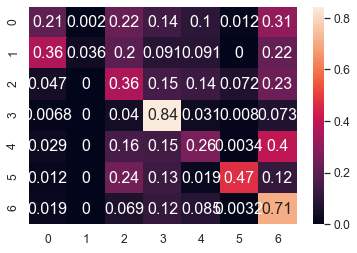

	training epoch=11 .. train_loss=1.197
	validation epoch=11 .. val_loss=1.302
	Accuracy = 51.0 % .. Percision = 54.50000000000001 % .. Recall = 41.3 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_11.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 12 .. loss = 1.756


  0%|                                                                                 | 1/1914 [00:01<43:16,  1.36s/it]

training @ epoch 12 .. loss = 1.152


  0%|                                                                                 | 2/1914 [00:02<44:22,  1.39s/it]

training @ epoch 12 .. loss = 1.449


  0%|▏                                                                                | 3/1914 [00:04<42:26,  1.33s/it]

training @ epoch 12 .. loss = 1.248


  0%|▏                                                                                | 4/1914 [00:05<41:39,  1.31s/it]

training @ epoch 12 .. loss = 1.083


  0%|▏                                                                                | 5/1914 [00:06<40:42,  1.28s/it]

training @ epoch 12 .. loss = 1.192


  0%|▎                                                                                | 6/1914 [00:07<40:22,  1.27s/it]

training @ epoch 12 .. loss = 0.833


  0%|▎                                                                                | 7/1914 [00:08<39:55,  1.26s/it]

training @ epoch 12 .. loss = 0.972


  0%|▎                                                                                | 8/1914 [00:10<39:50,  1.25s/it]

training @ epoch 12 .. loss = 0.938


  0%|▍                                                                                | 9/1914 [00:11<40:18,  1.27s/it]

training @ epoch 12 .. loss = 0.969


  1%|▍                                                                               | 10/1914 [00:12<40:00,  1.26s/it]

training @ epoch 12 .. loss = 1.385


  1%|▍                                                                               | 11/1914 [00:13<39:31,  1.25s/it]

training @ epoch 12 .. loss = 1.186


  1%|▌                                                                               | 12/1914 [00:15<39:32,  1.25s/it]

training @ epoch 12 .. loss = 0.659


  1%|▌                                                                               | 13/1914 [00:16<39:00,  1.23s/it]

training @ epoch 12 .. loss = 0.81


  1%|▌                                                                               | 14/1914 [00:17<38:53,  1.23s/it]

training @ epoch 12 .. loss = 0.895


  1%|▋                                                                               | 15/1914 [00:18<39:01,  1.23s/it]

training @ epoch 12 .. loss = 1.171


  1%|▋                                                                               | 16/1914 [00:20<39:10,  1.24s/it]

training @ epoch 12 .. loss = 1.475


  1%|▋                                                                               | 17/1914 [00:21<39:23,  1.25s/it]

training @ epoch 12 .. loss = 1.361


  1%|▊                                                                               | 18/1914 [00:22<39:02,  1.24s/it]

training @ epoch 12 .. loss = 1.061


  1%|▊                                                                               | 19/1914 [00:23<39:15,  1.24s/it]

training @ epoch 12 .. loss = 0.811


  1%|▊                                                                               | 20/1914 [00:25<39:02,  1.24s/it]

training @ epoch 12 .. loss = 1.038


  1%|▉                                                                               | 21/1914 [00:26<38:46,  1.23s/it]

training @ epoch 12 .. loss = 0.968


  1%|▉                                                                               | 22/1914 [00:27<38:20,  1.22s/it]

training @ epoch 12 .. loss = 1.165


  1%|▉                                                                               | 23/1914 [00:28<38:28,  1.22s/it]

training @ epoch 12 .. loss = 0.834


  1%|█                                                                               | 24/1914 [00:29<38:21,  1.22s/it]

training @ epoch 12 .. loss = 1.002


  1%|█                                                                               | 25/1914 [00:31<38:17,  1.22s/it]

training @ epoch 12 .. loss = 0.675


  1%|█                                                                               | 26/1914 [00:32<38:24,  1.22s/it]

training @ epoch 12 .. loss = 0.937


  1%|█▏                                                                              | 27/1914 [00:33<38:25,  1.22s/it]

training @ epoch 12 .. loss = 0.956


  1%|█▏                                                                              | 28/1914 [00:34<38:36,  1.23s/it]

training @ epoch 12 .. loss = 1.581


  2%|█▏                                                                              | 29/1914 [00:36<38:19,  1.22s/it]

training @ epoch 12 .. loss = 1.527


  2%|█▎                                                                              | 30/1914 [00:37<38:14,  1.22s/it]

training @ epoch 12 .. loss = 1.551


  2%|█▎                                                                              | 31/1914 [00:38<38:03,  1.21s/it]

training @ epoch 12 .. loss = 1.817


  2%|█▎                                                                              | 32/1914 [00:39<38:08,  1.22s/it]

training @ epoch 12 .. loss = 1.06


  2%|█▍                                                                              | 33/1914 [00:40<38:22,  1.22s/it]

training @ epoch 12 .. loss = 1.186


  2%|█▍                                                                              | 34/1914 [00:42<38:08,  1.22s/it]

training @ epoch 12 .. loss = 1.467


  2%|█▍                                                                              | 35/1914 [00:43<38:28,  1.23s/it]

training @ epoch 12 .. loss = 1.117


  2%|█▌                                                                              | 36/1914 [00:44<38:11,  1.22s/it]

training @ epoch 12 .. loss = 1.195


  2%|█▌                                                                              | 37/1914 [00:45<38:11,  1.22s/it]

training @ epoch 12 .. loss = 1.012


  2%|█▌                                                                              | 38/1914 [00:47<38:11,  1.22s/it]

training @ epoch 12 .. loss = 1.316


  2%|█▋                                                                              | 39/1914 [00:48<37:52,  1.21s/it]

training @ epoch 12 .. loss = 1.254


  2%|█▋                                                                              | 40/1914 [00:49<38:13,  1.22s/it]

training @ epoch 12 .. loss = 1.023


  2%|█▋                                                                              | 41/1914 [00:50<38:24,  1.23s/it]

training @ epoch 12 .. loss = 0.904


  2%|█▊                                                                              | 42/1914 [00:51<38:06,  1.22s/it]

training @ epoch 12 .. loss = 1.313


  2%|█▊                                                                              | 43/1914 [00:53<38:11,  1.22s/it]

training @ epoch 12 .. loss = 1.303


  2%|█▊                                                                              | 44/1914 [00:54<38:47,  1.24s/it]

training @ epoch 12 .. loss = 0.955


  2%|█▉                                                                              | 45/1914 [00:55<38:35,  1.24s/it]

training @ epoch 12 .. loss = 0.865


  2%|█▉                                                                              | 46/1914 [00:56<38:46,  1.25s/it]

training @ epoch 12 .. loss = 0.652


  2%|█▉                                                                              | 47/1914 [00:58<38:16,  1.23s/it]

training @ epoch 12 .. loss = 1.343


  3%|██                                                                              | 48/1914 [00:59<38:44,  1.25s/it]

training @ epoch 12 .. loss = 0.907


  3%|██                                                                              | 49/1914 [01:00<38:29,  1.24s/it]

training @ epoch 12 .. loss = 1.004


  3%|██                                                                              | 50/1914 [01:01<38:11,  1.23s/it]

training @ epoch 12 .. loss = 1.206


  3%|██▏                                                                             | 51/1914 [01:03<38:11,  1.23s/it]

training @ epoch 12 .. loss = 1.225


  3%|██▏                                                                             | 52/1914 [01:04<37:58,  1.22s/it]

training @ epoch 12 .. loss = 1.165


  3%|██▏                                                                             | 53/1914 [01:05<37:51,  1.22s/it]

training @ epoch 12 .. loss = 1.194


  3%|██▎                                                                             | 54/1914 [01:06<37:44,  1.22s/it]

training @ epoch 12 .. loss = 1.58


  3%|██▎                                                                             | 55/1914 [01:07<37:41,  1.22s/it]

training @ epoch 12 .. loss = 1.064


  3%|██▎                                                                             | 56/1914 [01:09<37:21,  1.21s/it]

training @ epoch 12 .. loss = 0.931


  3%|██▍                                                                             | 57/1914 [01:10<36:51,  1.19s/it]

training @ epoch 12 .. loss = 0.795


  3%|██▍                                                                             | 58/1914 [01:11<37:19,  1.21s/it]

training @ epoch 12 .. loss = 0.855


  3%|██▍                                                                             | 59/1914 [01:12<37:16,  1.21s/it]

training @ epoch 12 .. loss = 1.008


  3%|██▌                                                                             | 60/1914 [01:13<37:12,  1.20s/it]

training @ epoch 12 .. loss = 1.545


  3%|██▌                                                                             | 61/1914 [01:15<37:25,  1.21s/it]

training @ epoch 12 .. loss = 1.39


  3%|██▌                                                                             | 62/1914 [01:16<36:56,  1.20s/it]

training @ epoch 12 .. loss = 1.41


  3%|██▋                                                                             | 63/1914 [01:17<37:15,  1.21s/it]

training @ epoch 12 .. loss = 0.824


  3%|██▋                                                                             | 64/1914 [01:18<37:31,  1.22s/it]

training @ epoch 12 .. loss = 1.228


  3%|██▋                                                                             | 65/1914 [01:19<37:23,  1.21s/it]

training @ epoch 12 .. loss = 1.251


  3%|██▊                                                                             | 66/1914 [01:21<37:37,  1.22s/it]

training @ epoch 12 .. loss = 1.339


  4%|██▊                                                                             | 67/1914 [01:22<37:18,  1.21s/it]

training @ epoch 12 .. loss = 1.088


  4%|██▊                                                                             | 68/1914 [01:23<37:34,  1.22s/it]

training @ epoch 12 .. loss = 0.915


  4%|██▉                                                                             | 69/1914 [01:24<37:50,  1.23s/it]

training @ epoch 12 .. loss = 1.077


  4%|██▉                                                                             | 70/1914 [01:26<37:36,  1.22s/it]

training @ epoch 12 .. loss = 1.08


  4%|██▉                                                                             | 71/1914 [01:27<40:22,  1.31s/it]

training @ epoch 12 .. loss = 1.758


  4%|███                                                                             | 72/1914 [01:29<41:05,  1.34s/it]

training @ epoch 12 .. loss = 0.926


  4%|███                                                                             | 73/1914 [01:30<40:55,  1.33s/it]

training @ epoch 12 .. loss = 1.297


  4%|███                                                                             | 74/1914 [01:31<40:32,  1.32s/it]

training @ epoch 12 .. loss = 1.091


  4%|███▏                                                                            | 75/1914 [01:32<40:04,  1.31s/it]

training @ epoch 12 .. loss = 0.859


  4%|███▏                                                                            | 76/1914 [01:34<38:56,  1.27s/it]

training @ epoch 12 .. loss = 0.844


  4%|███▏                                                                            | 77/1914 [01:35<38:32,  1.26s/it]

training @ epoch 12 .. loss = 1.093


  4%|███▎                                                                            | 78/1914 [01:36<38:17,  1.25s/it]

training @ epoch 12 .. loss = 1.554


  4%|███▎                                                                            | 79/1914 [01:37<38:10,  1.25s/it]

training @ epoch 12 .. loss = 1.423


  4%|███▎                                                                            | 80/1914 [01:39<37:53,  1.24s/it]

training @ epoch 12 .. loss = 0.792


  4%|███▍                                                                            | 81/1914 [01:40<37:20,  1.22s/it]

training @ epoch 12 .. loss = 1.339


  4%|███▍                                                                            | 82/1914 [01:41<37:36,  1.23s/it]

training @ epoch 12 .. loss = 1.125


  4%|███▍                                                                            | 83/1914 [01:42<37:29,  1.23s/it]

training @ epoch 12 .. loss = 1.075


  4%|███▌                                                                            | 84/1914 [01:43<37:29,  1.23s/it]

training @ epoch 12 .. loss = 1.078


  4%|███▌                                                                            | 85/1914 [01:45<37:24,  1.23s/it]

training @ epoch 12 .. loss = 0.994


  4%|███▌                                                                            | 86/1914 [01:46<36:59,  1.21s/it]

training @ epoch 12 .. loss = 0.85


  5%|███▋                                                                            | 87/1914 [01:47<37:20,  1.23s/it]

training @ epoch 12 .. loss = 1.156


  5%|███▋                                                                            | 88/1914 [01:48<37:30,  1.23s/it]

training @ epoch 12 .. loss = 1.241


  5%|███▋                                                                            | 89/1914 [01:49<37:06,  1.22s/it]

training @ epoch 12 .. loss = 1.141


  5%|███▊                                                                            | 90/1914 [01:51<37:16,  1.23s/it]

training @ epoch 12 .. loss = 0.708


  5%|███▊                                                                            | 91/1914 [01:52<36:40,  1.21s/it]

training @ epoch 12 .. loss = 1.267


  5%|███▊                                                                            | 92/1914 [01:53<36:36,  1.21s/it]

training @ epoch 12 .. loss = 1.646


  5%|███▉                                                                            | 93/1914 [01:54<36:53,  1.22s/it]

training @ epoch 12 .. loss = 1.089


  5%|███▉                                                                            | 94/1914 [01:56<36:28,  1.20s/it]

training @ epoch 12 .. loss = 1.184


  5%|███▉                                                                            | 95/1914 [01:57<36:49,  1.21s/it]

training @ epoch 12 .. loss = 1.153


  5%|████                                                                            | 96/1914 [01:58<36:57,  1.22s/it]

training @ epoch 12 .. loss = 1.019


  5%|████                                                                            | 97/1914 [01:59<37:14,  1.23s/it]

training @ epoch 12 .. loss = 1.043


  5%|████                                                                            | 98/1914 [02:00<37:09,  1.23s/it]

training @ epoch 12 .. loss = 1.531


  5%|████▏                                                                           | 99/1914 [02:02<37:07,  1.23s/it]

training @ epoch 12 .. loss = 1.268


  5%|████▏                                                                          | 100/1914 [02:03<37:44,  1.25s/it]

training @ epoch 12 .. loss = 1.126


  5%|████▏                                                                          | 101/1914 [02:04<37:29,  1.24s/it]

training @ epoch 12 .. loss = 1.269


  5%|████▏                                                                          | 102/1914 [02:05<37:29,  1.24s/it]

training @ epoch 12 .. loss = 1.046


  5%|████▎                                                                          | 103/1914 [02:07<37:05,  1.23s/it]

training @ epoch 12 .. loss = 0.813


  5%|████▎                                                                          | 104/1914 [02:08<36:27,  1.21s/it]

training @ epoch 12 .. loss = 1.891


  5%|████▎                                                                          | 105/1914 [02:09<36:44,  1.22s/it]

training @ epoch 12 .. loss = 1.035


  6%|████▍                                                                          | 106/1914 [02:10<36:45,  1.22s/it]

training @ epoch 12 .. loss = 1.093


  6%|████▍                                                                          | 107/1914 [02:11<36:28,  1.21s/it]

training @ epoch 12 .. loss = 0.933


  6%|████▍                                                                          | 108/1914 [02:13<36:41,  1.22s/it]

training @ epoch 12 .. loss = 1.089


  6%|████▍                                                                          | 109/1914 [02:14<36:57,  1.23s/it]

training @ epoch 12 .. loss = 1.066


  6%|████▌                                                                          | 110/1914 [02:15<36:45,  1.22s/it]

training @ epoch 12 .. loss = 0.931


  6%|████▌                                                                          | 111/1914 [02:16<37:08,  1.24s/it]

training @ epoch 12 .. loss = 1.174


  6%|████▌                                                                          | 112/1914 [02:18<36:55,  1.23s/it]

training @ epoch 12 .. loss = 0.976


  6%|████▋                                                                          | 113/1914 [02:19<37:07,  1.24s/it]

training @ epoch 12 .. loss = 1.546


  6%|████▋                                                                          | 114/1914 [02:20<36:52,  1.23s/it]

training @ epoch 12 .. loss = 1.431


  6%|████▋                                                                          | 115/1914 [02:21<37:02,  1.24s/it]

training @ epoch 12 .. loss = 1.396


  6%|████▊                                                                          | 116/1914 [02:23<37:00,  1.23s/it]

training @ epoch 12 .. loss = 0.971


  6%|████▊                                                                          | 117/1914 [02:24<36:52,  1.23s/it]

training @ epoch 12 .. loss = 0.858


  6%|████▊                                                                          | 118/1914 [02:25<36:41,  1.23s/it]

training @ epoch 12 .. loss = 1.43


  6%|████▉                                                                          | 119/1914 [02:26<36:49,  1.23s/it]

training @ epoch 12 .. loss = 1.188


  6%|████▉                                                                          | 120/1914 [02:27<36:22,  1.22s/it]

training @ epoch 12 .. loss = 0.832


  6%|████▉                                                                          | 121/1914 [02:29<36:27,  1.22s/it]

training @ epoch 12 .. loss = 1.564


  6%|█████                                                                          | 122/1914 [02:30<36:21,  1.22s/it]

training @ epoch 12 .. loss = 1.189


  6%|█████                                                                          | 123/1914 [02:31<38:00,  1.27s/it]

training @ epoch 12 .. loss = 1.326


  6%|█████                                                                          | 124/1914 [02:33<38:48,  1.30s/it]

training @ epoch 12 .. loss = 1.375


  7%|█████▏                                                                         | 125/1914 [02:34<39:15,  1.32s/it]

training @ epoch 12 .. loss = 1.158


  7%|█████▏                                                                         | 126/1914 [02:35<39:12,  1.32s/it]

training @ epoch 12 .. loss = 1.137


  7%|█████▏                                                                         | 127/1914 [02:37<39:21,  1.32s/it]

training @ epoch 12 .. loss = 1.397


  7%|█████▎                                                                         | 128/1914 [02:38<39:16,  1.32s/it]

training @ epoch 12 .. loss = 1.151


  7%|█████▎                                                                         | 129/1914 [02:39<39:22,  1.32s/it]

training @ epoch 12 .. loss = 1.14


  7%|█████▎                                                                         | 130/1914 [02:41<39:15,  1.32s/it]

training @ epoch 12 .. loss = 0.926


  7%|█████▍                                                                         | 131/1914 [02:42<39:20,  1.32s/it]

training @ epoch 12 .. loss = 0.852


  7%|█████▍                                                                         | 132/1914 [02:43<39:15,  1.32s/it]

training @ epoch 12 .. loss = 1.236


  7%|█████▍                                                                         | 133/1914 [02:45<39:35,  1.33s/it]

training @ epoch 12 .. loss = 1.091


  7%|█████▌                                                                         | 134/1914 [02:46<39:30,  1.33s/it]

training @ epoch 12 .. loss = 1.328


  7%|█████▌                                                                         | 135/1914 [02:47<39:14,  1.32s/it]

training @ epoch 12 .. loss = 0.673


  7%|█████▌                                                                         | 136/1914 [02:49<39:35,  1.34s/it]

training @ epoch 12 .. loss = 0.99


  7%|█████▋                                                                         | 137/1914 [02:50<39:55,  1.35s/it]

training @ epoch 12 .. loss = 1.356


  7%|█████▋                                                                         | 138/1914 [02:51<39:35,  1.34s/it]

training @ epoch 12 .. loss = 1.024


  7%|█████▋                                                                         | 139/1914 [02:53<39:27,  1.33s/it]

training @ epoch 12 .. loss = 1.239


  7%|█████▊                                                                         | 140/1914 [02:54<39:42,  1.34s/it]

training @ epoch 12 .. loss = 1.076


  7%|█████▊                                                                         | 141/1914 [02:55<40:08,  1.36s/it]

training @ epoch 12 .. loss = 0.825


  7%|█████▊                                                                         | 142/1914 [02:57<39:58,  1.35s/it]

training @ epoch 12 .. loss = 0.659


  7%|█████▉                                                                         | 143/1914 [02:58<40:09,  1.36s/it]

training @ epoch 12 .. loss = 0.976


  8%|█████▉                                                                         | 144/1914 [02:59<40:10,  1.36s/it]

training @ epoch 12 .. loss = 0.585


  8%|█████▉                                                                         | 145/1914 [03:01<40:47,  1.38s/it]

training @ epoch 12 .. loss = 1.136


  8%|██████                                                                         | 146/1914 [03:02<40:30,  1.37s/it]

training @ epoch 12 .. loss = 1.015


  8%|██████                                                                         | 147/1914 [03:04<40:50,  1.39s/it]

training @ epoch 12 .. loss = 1.153


  8%|██████                                                                         | 148/1914 [03:05<40:14,  1.37s/it]

training @ epoch 12 .. loss = 1.053


  8%|██████▏                                                                        | 149/1914 [03:06<40:27,  1.38s/it]

training @ epoch 12 .. loss = 0.955


  8%|██████▏                                                                        | 150/1914 [03:08<39:58,  1.36s/it]

training @ epoch 12 .. loss = 1.126


  8%|██████▏                                                                        | 151/1914 [03:09<40:00,  1.36s/it]

training @ epoch 12 .. loss = 1.243


  8%|██████▎                                                                        | 152/1914 [03:10<40:01,  1.36s/it]

training @ epoch 12 .. loss = 1.155


  8%|██████▎                                                                        | 153/1914 [03:12<39:33,  1.35s/it]

training @ epoch 12 .. loss = 1.158


  8%|██████▎                                                                        | 154/1914 [03:13<39:35,  1.35s/it]

training @ epoch 12 .. loss = 1.469


  8%|██████▍                                                                        | 155/1914 [03:14<39:31,  1.35s/it]

training @ epoch 12 .. loss = 0.856


  8%|██████▍                                                                        | 156/1914 [03:16<39:06,  1.33s/it]

training @ epoch 12 .. loss = 1.081


  8%|██████▍                                                                        | 157/1914 [03:17<39:20,  1.34s/it]

training @ epoch 12 .. loss = 1.075


  8%|██████▌                                                                        | 158/1914 [03:18<39:20,  1.34s/it]

training @ epoch 12 .. loss = 1.041


  8%|██████▌                                                                        | 159/1914 [03:20<38:52,  1.33s/it]

training @ epoch 12 .. loss = 1.149


  8%|██████▌                                                                        | 160/1914 [03:21<39:04,  1.34s/it]

training @ epoch 12 .. loss = 1.23


  8%|██████▋                                                                        | 161/1914 [03:22<39:11,  1.34s/it]

training @ epoch 12 .. loss = 1.194


  8%|██████▋                                                                        | 162/1914 [03:24<38:45,  1.33s/it]

training @ epoch 12 .. loss = 0.766


  9%|██████▋                                                                        | 163/1914 [03:25<38:58,  1.34s/it]

training @ epoch 12 .. loss = 1.026


  9%|██████▊                                                                        | 164/1914 [03:27<39:17,  1.35s/it]

training @ epoch 12 .. loss = 1.219


  9%|██████▊                                                                        | 165/1914 [03:28<38:53,  1.33s/it]

training @ epoch 12 .. loss = 1.371


  9%|██████▊                                                                        | 166/1914 [03:29<38:57,  1.34s/it]

training @ epoch 12 .. loss = 1.572


  9%|██████▉                                                                        | 167/1914 [03:31<39:15,  1.35s/it]

training @ epoch 12 .. loss = 1.376


  9%|██████▉                                                                        | 168/1914 [03:32<38:56,  1.34s/it]

training @ epoch 12 .. loss = 1.494


  9%|██████▉                                                                        | 169/1914 [03:33<39:35,  1.36s/it]

training @ epoch 12 .. loss = 0.914


  9%|███████                                                                        | 170/1914 [03:35<39:51,  1.37s/it]

training @ epoch 12 .. loss = 0.835


  9%|███████                                                                        | 171/1914 [03:36<39:52,  1.37s/it]

training @ epoch 12 .. loss = 1.184


  9%|███████                                                                        | 172/1914 [03:37<38:37,  1.33s/it]

training @ epoch 12 .. loss = 1.195


  9%|███████▏                                                                       | 173/1914 [03:39<38:21,  1.32s/it]

training @ epoch 12 .. loss = 1.61


  9%|███████▏                                                                       | 174/1914 [03:40<37:08,  1.28s/it]

training @ epoch 12 .. loss = 1.107


  9%|███████▏                                                                       | 175/1914 [03:41<37:04,  1.28s/it]

training @ epoch 12 .. loss = 1.094


  9%|███████▎                                                                       | 176/1914 [03:42<36:43,  1.27s/it]

training @ epoch 12 .. loss = 1.09


  9%|███████▎                                                                       | 177/1914 [03:44<36:42,  1.27s/it]

training @ epoch 12 .. loss = 1.173


  9%|███████▎                                                                       | 178/1914 [03:45<36:31,  1.26s/it]

training @ epoch 12 .. loss = 0.854


  9%|███████▍                                                                       | 179/1914 [03:46<36:09,  1.25s/it]

training @ epoch 12 .. loss = 0.946


  9%|███████▍                                                                       | 180/1914 [03:47<36:05,  1.25s/it]

training @ epoch 12 .. loss = 0.978


  9%|███████▍                                                                       | 181/1914 [03:49<36:06,  1.25s/it]

training @ epoch 12 .. loss = 1.069


 10%|███████▌                                                                       | 182/1914 [03:50<36:08,  1.25s/it]

training @ epoch 12 .. loss = 1.258


 10%|███████▌                                                                       | 183/1914 [03:51<36:07,  1.25s/it]

training @ epoch 12 .. loss = 1.174


 10%|███████▌                                                                       | 184/1914 [03:52<35:59,  1.25s/it]

training @ epoch 12 .. loss = 1.069


 10%|███████▋                                                                       | 185/1914 [03:53<35:33,  1.23s/it]

training @ epoch 12 .. loss = 1.237


 10%|███████▋                                                                       | 186/1914 [03:55<35:23,  1.23s/it]

training @ epoch 12 .. loss = 1.16


 10%|███████▋                                                                       | 187/1914 [03:56<35:53,  1.25s/it]

training @ epoch 12 .. loss = 0.914


 10%|███████▊                                                                       | 188/1914 [03:57<35:39,  1.24s/it]

training @ epoch 12 .. loss = 0.878


 10%|███████▊                                                                       | 189/1914 [03:58<36:06,  1.26s/it]

training @ epoch 12 .. loss = 1.309


 10%|███████▊                                                                       | 190/1914 [04:00<35:35,  1.24s/it]

training @ epoch 12 .. loss = 0.936


 10%|███████▉                                                                       | 191/1914 [04:01<35:56,  1.25s/it]

training @ epoch 12 .. loss = 1.032


 10%|███████▉                                                                       | 192/1914 [04:02<35:34,  1.24s/it]

training @ epoch 12 .. loss = 0.676


 10%|███████▉                                                                       | 193/1914 [04:04<36:21,  1.27s/it]

training @ epoch 12 .. loss = 0.859


 10%|████████                                                                       | 194/1914 [04:05<36:02,  1.26s/it]

training @ epoch 12 .. loss = 0.993


 10%|████████                                                                       | 195/1914 [04:06<35:53,  1.25s/it]

training @ epoch 12 .. loss = 0.955


 10%|████████                                                                       | 196/1914 [04:07<35:53,  1.25s/it]

training @ epoch 12 .. loss = 1.754


 10%|████████▏                                                                      | 197/1914 [04:09<36:07,  1.26s/it]

training @ epoch 12 .. loss = 1.33


 10%|████████▏                                                                      | 198/1914 [04:10<35:40,  1.25s/it]

training @ epoch 12 .. loss = 1.081


 10%|████████▏                                                                      | 199/1914 [04:11<36:34,  1.28s/it]

training @ epoch 12 .. loss = 1.523


 10%|████████▎                                                                      | 200/1914 [04:12<36:19,  1.27s/it]

training @ epoch 12 .. loss = 1.461


 11%|████████▎                                                                      | 201/1914 [04:14<35:57,  1.26s/it]

training @ epoch 12 .. loss = 2.085


 11%|████████▎                                                                      | 202/1914 [04:15<36:12,  1.27s/it]

training @ epoch 12 .. loss = 1.052


 11%|████████▍                                                                      | 203/1914 [04:16<35:41,  1.25s/it]

training @ epoch 12 .. loss = 1.331


 11%|████████▍                                                                      | 204/1914 [04:17<35:34,  1.25s/it]

training @ epoch 12 .. loss = 1.357


 11%|████████▍                                                                      | 205/1914 [04:19<35:44,  1.25s/it]

training @ epoch 12 .. loss = 1.361


 11%|████████▌                                                                      | 206/1914 [04:20<35:36,  1.25s/it]

training @ epoch 12 .. loss = 1.697


 11%|████████▌                                                                      | 207/1914 [04:21<36:57,  1.30s/it]

training @ epoch 12 .. loss = 1.383


 11%|████████▌                                                                      | 208/1914 [04:23<38:37,  1.36s/it]

training @ epoch 12 .. loss = 1.221


 11%|████████▋                                                                      | 209/1914 [04:24<40:44,  1.43s/it]

training @ epoch 12 .. loss = 1.055


 11%|████████▋                                                                      | 210/1914 [04:26<41:59,  1.48s/it]

training @ epoch 12 .. loss = 1.308


 11%|████████▋                                                                      | 211/1914 [04:27<42:14,  1.49s/it]

training @ epoch 12 .. loss = 1.652


 11%|████████▊                                                                      | 212/1914 [04:29<42:33,  1.50s/it]

training @ epoch 12 .. loss = 1.15


 11%|████████▊                                                                      | 213/1914 [04:30<42:39,  1.50s/it]

training @ epoch 12 .. loss = 1.179


 11%|████████▊                                                                      | 214/1914 [04:32<42:40,  1.51s/it]

training @ epoch 12 .. loss = 1.204


 11%|████████▊                                                                      | 215/1914 [04:34<42:46,  1.51s/it]

training @ epoch 12 .. loss = 0.947


 11%|████████▉                                                                      | 216/1914 [04:35<43:00,  1.52s/it]

training @ epoch 12 .. loss = 1.15


 11%|████████▉                                                                      | 217/1914 [04:37<42:24,  1.50s/it]

training @ epoch 12 .. loss = 0.707


 11%|████████▉                                                                      | 218/1914 [04:38<42:05,  1.49s/it]

training @ epoch 12 .. loss = 0.934


 11%|█████████                                                                      | 219/1914 [04:39<41:06,  1.46s/it]

training @ epoch 12 .. loss = 0.992


 11%|█████████                                                                      | 220/1914 [04:41<40:23,  1.43s/it]

training @ epoch 12 .. loss = 1.36


 12%|█████████                                                                      | 221/1914 [04:42<40:12,  1.43s/it]

training @ epoch 12 .. loss = 0.806


 12%|█████████▏                                                                     | 222/1914 [04:44<40:11,  1.43s/it]

training @ epoch 12 .. loss = 0.83


 12%|█████████▏                                                                     | 223/1914 [04:45<40:15,  1.43s/it]

training @ epoch 12 .. loss = 1.1


 12%|█████████▏                                                                     | 224/1914 [04:46<39:51,  1.41s/it]

training @ epoch 12 .. loss = 1.128


 12%|█████████▎                                                                     | 225/1914 [04:48<38:18,  1.36s/it]

training @ epoch 12 .. loss = 0.802


 12%|█████████▎                                                                     | 226/1914 [04:49<37:42,  1.34s/it]

training @ epoch 12 .. loss = 1.258


 12%|█████████▎                                                                     | 227/1914 [04:50<37:04,  1.32s/it]

training @ epoch 12 .. loss = 1.336


 12%|█████████▍                                                                     | 228/1914 [04:51<36:27,  1.30s/it]

training @ epoch 12 .. loss = 1.118


 12%|█████████▍                                                                     | 229/1914 [04:53<36:07,  1.29s/it]

training @ epoch 12 .. loss = 0.913


 12%|█████████▍                                                                     | 230/1914 [04:54<36:00,  1.28s/it]

training @ epoch 12 .. loss = 1.266


 12%|█████████▌                                                                     | 231/1914 [04:55<35:37,  1.27s/it]

training @ epoch 12 .. loss = 1.292


 12%|█████████▌                                                                     | 232/1914 [04:56<35:38,  1.27s/it]

training @ epoch 12 .. loss = 0.764


 12%|█████████▌                                                                     | 233/1914 [04:58<35:02,  1.25s/it]

training @ epoch 12 .. loss = 1.63


 12%|█████████▋                                                                     | 234/1914 [04:59<35:08,  1.26s/it]

training @ epoch 12 .. loss = 0.877


 12%|█████████▋                                                                     | 235/1914 [05:00<34:49,  1.24s/it]

training @ epoch 12 .. loss = 0.906


 12%|█████████▋                                                                     | 236/1914 [05:01<34:33,  1.24s/it]

training @ epoch 12 .. loss = 1.156


 12%|█████████▊                                                                     | 237/1914 [05:03<34:35,  1.24s/it]

training @ epoch 12 .. loss = 1.009


 12%|█████████▊                                                                     | 238/1914 [05:04<34:21,  1.23s/it]

training @ epoch 12 .. loss = 0.692


 12%|█████████▊                                                                     | 239/1914 [05:05<34:32,  1.24s/it]

training @ epoch 12 .. loss = 0.836


 13%|█████████▉                                                                     | 240/1914 [05:06<34:35,  1.24s/it]

training @ epoch 12 .. loss = 1.138


 13%|█████████▉                                                                     | 241/1914 [05:08<34:23,  1.23s/it]

training @ epoch 12 .. loss = 1.272


 13%|█████████▉                                                                     | 242/1914 [05:09<34:41,  1.24s/it]

training @ epoch 12 .. loss = 1.062


 13%|██████████                                                                     | 243/1914 [05:10<34:53,  1.25s/it]

training @ epoch 12 .. loss = 0.873


 13%|██████████                                                                     | 244/1914 [05:11<34:32,  1.24s/it]

training @ epoch 12 .. loss = 1.205


 13%|██████████                                                                     | 245/1914 [05:13<34:31,  1.24s/it]

training @ epoch 12 .. loss = 1.097


 13%|██████████▏                                                                    | 246/1914 [05:14<34:11,  1.23s/it]

training @ epoch 12 .. loss = 1.295


 13%|██████████▏                                                                    | 247/1914 [05:15<34:36,  1.25s/it]

training @ epoch 12 .. loss = 1.073


 13%|██████████▏                                                                    | 248/1914 [05:16<34:38,  1.25s/it]

training @ epoch 12 .. loss = 1.143


 13%|██████████▎                                                                    | 249/1914 [05:17<34:13,  1.23s/it]

training @ epoch 12 .. loss = 1.087


 13%|██████████▎                                                                    | 250/1914 [05:19<34:30,  1.24s/it]

training @ epoch 12 .. loss = 1.802


 13%|██████████▎                                                                    | 251/1914 [05:20<34:22,  1.24s/it]

training @ epoch 12 .. loss = 1.28


 13%|██████████▍                                                                    | 252/1914 [05:21<34:20,  1.24s/it]

training @ epoch 12 .. loss = 1.224


 13%|██████████▍                                                                    | 253/1914 [05:22<34:18,  1.24s/it]

training @ epoch 12 .. loss = 1.212


 13%|██████████▍                                                                    | 254/1914 [05:24<33:58,  1.23s/it]

training @ epoch 12 .. loss = 0.931


 13%|██████████▌                                                                    | 255/1914 [05:25<34:13,  1.24s/it]

training @ epoch 12 .. loss = 1.074


 13%|██████████▌                                                                    | 256/1914 [05:26<34:19,  1.24s/it]

training @ epoch 12 .. loss = 1.488


 13%|██████████▌                                                                    | 257/1914 [05:27<33:52,  1.23s/it]

training @ epoch 12 .. loss = 1.14


 13%|██████████▋                                                                    | 258/1914 [05:29<33:51,  1.23s/it]

training @ epoch 12 .. loss = 1.074


 14%|██████████▋                                                                    | 259/1914 [05:30<33:57,  1.23s/it]

training @ epoch 12 .. loss = 1.226


 14%|██████████▋                                                                    | 260/1914 [05:31<34:35,  1.25s/it]

training @ epoch 12 .. loss = 1.104


 14%|██████████▊                                                                    | 261/1914 [05:32<34:13,  1.24s/it]

training @ epoch 12 .. loss = 1.027


 14%|██████████▊                                                                    | 262/1914 [05:34<33:56,  1.23s/it]

training @ epoch 12 .. loss = 0.951


 14%|██████████▊                                                                    | 263/1914 [05:35<34:22,  1.25s/it]

training @ epoch 12 .. loss = 1.394


 14%|██████████▉                                                                    | 264/1914 [05:36<34:08,  1.24s/it]

training @ epoch 12 .. loss = 1.185


 14%|██████████▉                                                                    | 265/1914 [05:37<34:12,  1.24s/it]

training @ epoch 12 .. loss = 1.259


 14%|██████████▉                                                                    | 266/1914 [05:39<34:10,  1.24s/it]

training @ epoch 12 .. loss = 1.306


 14%|███████████                                                                    | 267/1914 [05:40<33:53,  1.23s/it]

training @ epoch 12 .. loss = 0.99


 14%|███████████                                                                    | 268/1914 [05:41<33:56,  1.24s/it]

training @ epoch 12 .. loss = 0.672


 14%|███████████                                                                    | 269/1914 [05:42<33:46,  1.23s/it]

training @ epoch 12 .. loss = 0.918


 14%|███████████▏                                                                   | 270/1914 [05:43<33:25,  1.22s/it]

training @ epoch 12 .. loss = 0.913


 14%|███████████▏                                                                   | 271/1914 [05:45<33:35,  1.23s/it]

training @ epoch 12 .. loss = 0.911


 14%|███████████▏                                                                   | 272/1914 [05:46<33:40,  1.23s/it]

training @ epoch 12 .. loss = 1.26


 14%|███████████▎                                                                   | 273/1914 [05:47<33:51,  1.24s/it]

training @ epoch 12 .. loss = 1.424


 14%|███████████▎                                                                   | 274/1914 [05:48<33:56,  1.24s/it]

training @ epoch 12 .. loss = 1.094


 14%|███████████▎                                                                   | 275/1914 [05:50<34:03,  1.25s/it]

training @ epoch 12 .. loss = 1.36


 14%|███████████▍                                                                   | 276/1914 [05:51<34:23,  1.26s/it]

training @ epoch 12 .. loss = 1.103


 14%|███████████▍                                                                   | 277/1914 [05:52<34:08,  1.25s/it]

training @ epoch 12 .. loss = 1.101


 15%|███████████▍                                                                   | 278/1914 [05:53<33:46,  1.24s/it]

training @ epoch 12 .. loss = 1.69


 15%|███████████▌                                                                   | 279/1914 [05:55<33:42,  1.24s/it]

training @ epoch 12 .. loss = 1.218


 15%|███████████▌                                                                   | 280/1914 [05:56<33:31,  1.23s/it]

training @ epoch 12 .. loss = 1.235


 15%|███████████▌                                                                   | 281/1914 [05:57<33:35,  1.23s/it]

training @ epoch 12 .. loss = 1.036


 15%|███████████▋                                                                   | 282/1914 [05:58<33:21,  1.23s/it]

training @ epoch 12 .. loss = 0.712


 15%|███████████▋                                                                   | 283/1914 [06:00<33:02,  1.22s/it]

training @ epoch 12 .. loss = 0.842


 15%|███████████▋                                                                   | 284/1914 [06:01<33:26,  1.23s/it]

training @ epoch 12 .. loss = 1.282


 15%|███████████▊                                                                   | 285/1914 [06:02<33:40,  1.24s/it]

training @ epoch 12 .. loss = 1.215


 15%|███████████▊                                                                   | 286/1914 [06:03<33:41,  1.24s/it]

training @ epoch 12 .. loss = 0.783


 15%|███████████▊                                                                   | 287/1914 [06:04<33:09,  1.22s/it]

training @ epoch 12 .. loss = 1.105


 15%|███████████▉                                                                   | 288/1914 [06:06<32:57,  1.22s/it]

training @ epoch 12 .. loss = 1.562


 15%|███████████▉                                                                   | 289/1914 [06:07<33:25,  1.23s/it]

training @ epoch 12 .. loss = 1.091


 15%|███████████▉                                                                   | 290/1914 [06:08<33:17,  1.23s/it]

training @ epoch 12 .. loss = 0.84


 15%|████████████                                                                   | 291/1914 [06:09<33:26,  1.24s/it]

training @ epoch 12 .. loss = 0.867


 15%|████████████                                                                   | 292/1914 [06:11<33:44,  1.25s/it]

training @ epoch 12 .. loss = 1.578


 15%|████████████                                                                   | 293/1914 [06:12<33:49,  1.25s/it]

training @ epoch 12 .. loss = 0.869


 15%|████████████▏                                                                  | 294/1914 [06:13<33:38,  1.25s/it]

training @ epoch 12 .. loss = 0.924


 15%|████████████▏                                                                  | 295/1914 [06:14<33:31,  1.24s/it]

training @ epoch 12 .. loss = 0.783


 15%|████████████▏                                                                  | 296/1914 [06:16<33:10,  1.23s/it]

training @ epoch 12 .. loss = 1.702


 16%|████████████▎                                                                  | 297/1914 [06:17<33:28,  1.24s/it]

training @ epoch 12 .. loss = 1.141


 16%|████████████▎                                                                  | 298/1914 [06:18<33:57,  1.26s/it]

training @ epoch 12 .. loss = 1.889


 16%|████████████▎                                                                  | 299/1914 [06:19<33:28,  1.24s/it]

training @ epoch 12 .. loss = 1.33


 16%|████████████▍                                                                  | 300/1914 [06:21<33:24,  1.24s/it]

training @ epoch 12 .. loss = 1.44


 16%|████████████▍                                                                  | 301/1914 [06:22<35:17,  1.31s/it]

training @ epoch 12 .. loss = 0.935


 16%|████████████▍                                                                  | 302/1914 [06:23<35:50,  1.33s/it]

training @ epoch 12 .. loss = 1.069


 16%|████████████▌                                                                  | 303/1914 [06:25<35:48,  1.33s/it]

training @ epoch 12 .. loss = 1.1


 16%|████████████▌                                                                  | 304/1914 [06:26<35:25,  1.32s/it]

training @ epoch 12 .. loss = 1.088


 16%|████████████▌                                                                  | 305/1914 [06:27<35:06,  1.31s/it]

training @ epoch 12 .. loss = 1.095


 16%|████████████▋                                                                  | 306/1914 [06:29<34:33,  1.29s/it]

training @ epoch 12 .. loss = 1.198


 16%|████████████▋                                                                  | 307/1914 [06:30<33:54,  1.27s/it]

training @ epoch 12 .. loss = 1.189


 16%|████████████▋                                                                  | 308/1914 [06:31<33:44,  1.26s/it]

training @ epoch 12 .. loss = 0.81


 16%|████████████▊                                                                  | 309/1914 [06:32<33:39,  1.26s/it]

training @ epoch 12 .. loss = 1.541


 16%|████████████▊                                                                  | 310/1914 [06:34<33:20,  1.25s/it]

training @ epoch 12 .. loss = 0.972


 16%|████████████▊                                                                  | 311/1914 [06:35<33:02,  1.24s/it]

training @ epoch 12 .. loss = 1.593


 16%|████████████▉                                                                  | 312/1914 [06:36<32:59,  1.24s/it]

training @ epoch 12 .. loss = 0.886


 16%|████████████▉                                                                  | 313/1914 [06:37<33:00,  1.24s/it]

training @ epoch 12 .. loss = 0.71


 16%|████████████▉                                                                  | 314/1914 [06:38<32:56,  1.24s/it]

training @ epoch 12 .. loss = 1.288


 16%|█████████████                                                                  | 315/1914 [06:40<32:24,  1.22s/it]

training @ epoch 12 .. loss = 1.347


 17%|█████████████                                                                  | 316/1914 [06:41<32:13,  1.21s/it]

training @ epoch 12 .. loss = 1.238


 17%|█████████████                                                                  | 317/1914 [06:42<32:17,  1.21s/it]

training @ epoch 12 .. loss = 0.85


 17%|█████████████▏                                                                 | 318/1914 [06:43<32:25,  1.22s/it]

training @ epoch 12 .. loss = 1.25


 17%|█████████████▏                                                                 | 319/1914 [06:45<32:40,  1.23s/it]

training @ epoch 12 .. loss = 0.863


 17%|█████████████▏                                                                 | 320/1914 [06:46<32:16,  1.21s/it]

training @ epoch 12 .. loss = 1.194


 17%|█████████████▏                                                                 | 321/1914 [06:47<32:27,  1.22s/it]

training @ epoch 12 .. loss = 0.897


 17%|█████████████▎                                                                 | 322/1914 [06:48<32:41,  1.23s/it]

training @ epoch 12 .. loss = 1.27


 17%|█████████████▎                                                                 | 323/1914 [06:49<32:35,  1.23s/it]

training @ epoch 12 .. loss = 1.754


 17%|█████████████▎                                                                 | 324/1914 [06:51<32:45,  1.24s/it]

training @ epoch 12 .. loss = 1.139


 17%|█████████████▍                                                                 | 325/1914 [06:52<32:12,  1.22s/it]

training @ epoch 12 .. loss = 1.204


 17%|█████████████▍                                                                 | 326/1914 [06:53<32:13,  1.22s/it]

training @ epoch 12 .. loss = 0.971


 17%|█████████████▍                                                                 | 327/1914 [06:54<32:24,  1.23s/it]

training @ epoch 12 .. loss = 2.076


 17%|█████████████▌                                                                 | 328/1914 [06:56<32:11,  1.22s/it]

training @ epoch 12 .. loss = 0.942


 17%|█████████████▌                                                                 | 329/1914 [06:57<31:49,  1.20s/it]

training @ epoch 12 .. loss = 1.623


 17%|█████████████▌                                                                 | 330/1914 [06:58<32:04,  1.21s/it]

training @ epoch 12 .. loss = 1.24


 17%|█████████████▋                                                                 | 331/1914 [06:59<32:06,  1.22s/it]

training @ epoch 12 .. loss = 1.27


 17%|█████████████▋                                                                 | 332/1914 [07:00<32:27,  1.23s/it]

training @ epoch 12 .. loss = 1.292


 17%|█████████████▋                                                                 | 333/1914 [07:02<32:22,  1.23s/it]

training @ epoch 12 .. loss = 1.288


 17%|█████████████▊                                                                 | 334/1914 [07:03<32:16,  1.23s/it]

training @ epoch 12 .. loss = 1.514


 18%|█████████████▊                                                                 | 335/1914 [07:04<32:14,  1.23s/it]

training @ epoch 12 .. loss = 1.364


 18%|█████████████▊                                                                 | 336/1914 [07:05<32:40,  1.24s/it]

training @ epoch 12 .. loss = 1.584


 18%|█████████████▉                                                                 | 337/1914 [07:07<34:23,  1.31s/it]

training @ epoch 12 .. loss = 0.961


 18%|█████████████▉                                                                 | 338/1914 [07:08<35:07,  1.34s/it]

training @ epoch 12 .. loss = 0.975


 18%|█████████████▉                                                                 | 339/1914 [07:10<35:19,  1.35s/it]

training @ epoch 12 .. loss = 1.106


 18%|██████████████                                                                 | 340/1914 [07:11<35:31,  1.35s/it]

training @ epoch 12 .. loss = 1.069


 18%|██████████████                                                                 | 341/1914 [07:12<35:44,  1.36s/it]

training @ epoch 12 .. loss = 1.041


 18%|██████████████                                                                 | 342/1914 [07:14<35:29,  1.35s/it]

training @ epoch 12 .. loss = 1.199


 18%|██████████████▏                                                                | 343/1914 [07:15<35:42,  1.36s/it]

training @ epoch 12 .. loss = 1.313


 18%|██████████████▏                                                                | 344/1914 [07:16<35:27,  1.35s/it]

training @ epoch 12 .. loss = 1.192


 18%|██████████████▏                                                                | 345/1914 [07:18<35:30,  1.36s/it]

training @ epoch 12 .. loss = 0.747


 18%|██████████████▎                                                                | 346/1914 [07:19<35:27,  1.36s/it]

training @ epoch 12 .. loss = 1.02


 18%|██████████████▎                                                                | 347/1914 [07:21<35:36,  1.36s/it]

training @ epoch 12 .. loss = 0.947


 18%|██████████████▎                                                                | 348/1914 [07:22<34:32,  1.32s/it]

training @ epoch 12 .. loss = 1.279


 18%|██████████████▍                                                                | 349/1914 [07:23<33:49,  1.30s/it]

training @ epoch 12 .. loss = 1.361


 18%|██████████████▍                                                                | 350/1914 [07:24<33:23,  1.28s/it]

training @ epoch 12 .. loss = 1.165


 18%|██████████████▍                                                                | 351/1914 [07:25<32:50,  1.26s/it]

training @ epoch 12 .. loss = 0.849


 18%|██████████████▌                                                                | 352/1914 [07:27<32:31,  1.25s/it]

training @ epoch 12 .. loss = 1.089


 18%|██████████████▌                                                                | 353/1914 [07:28<31:53,  1.23s/it]

training @ epoch 12 .. loss = 0.718


 18%|██████████████▌                                                                | 354/1914 [07:29<32:00,  1.23s/it]

training @ epoch 12 .. loss = 1.429


 19%|██████████████▋                                                                | 355/1914 [07:30<32:12,  1.24s/it]

training @ epoch 12 .. loss = 1.233


 19%|██████████████▋                                                                | 356/1914 [07:32<31:47,  1.22s/it]

training @ epoch 12 .. loss = 0.952


 19%|██████████████▋                                                                | 357/1914 [07:33<31:54,  1.23s/it]

training @ epoch 12 .. loss = 1.102


 19%|██████████████▊                                                                | 358/1914 [07:34<31:44,  1.22s/it]

training @ epoch 12 .. loss = 1.205


 19%|██████████████▊                                                                | 359/1914 [07:35<31:51,  1.23s/it]

training @ epoch 12 .. loss = 1.447


 19%|██████████████▊                                                                | 360/1914 [07:36<31:47,  1.23s/it]

training @ epoch 12 .. loss = 1.505


 19%|██████████████▉                                                                | 361/1914 [07:38<31:20,  1.21s/it]

training @ epoch 12 .. loss = 1.209


 19%|██████████████▉                                                                | 362/1914 [07:39<31:10,  1.21s/it]

training @ epoch 12 .. loss = 1.274


 19%|██████████████▉                                                                | 363/1914 [07:40<31:21,  1.21s/it]

training @ epoch 12 .. loss = 1.177


 19%|███████████████                                                                | 364/1914 [07:41<31:52,  1.23s/it]

training @ epoch 12 .. loss = 1.555


 19%|███████████████                                                                | 365/1914 [07:43<31:58,  1.24s/it]

training @ epoch 12 .. loss = 1.445


 19%|███████████████                                                                | 366/1914 [07:44<31:08,  1.21s/it]

training @ epoch 12 .. loss = 1.888


 19%|███████████████▏                                                               | 367/1914 [07:45<31:18,  1.21s/it]

training @ epoch 12 .. loss = 0.999


 19%|███████████████▏                                                               | 368/1914 [07:46<31:18,  1.22s/it]

training @ epoch 12 .. loss = 1.101


 19%|███████████████▏                                                               | 369/1914 [07:47<31:11,  1.21s/it]

training @ epoch 12 .. loss = 1.186


 19%|███████████████▎                                                               | 370/1914 [07:49<31:19,  1.22s/it]

training @ epoch 12 .. loss = 1.305


 19%|███████████████▎                                                               | 371/1914 [07:50<31:10,  1.21s/it]

training @ epoch 12 .. loss = 1.357


 19%|███████████████▎                                                               | 372/1914 [07:51<31:22,  1.22s/it]

training @ epoch 12 .. loss = 0.953


 19%|███████████████▍                                                               | 373/1914 [07:52<31:25,  1.22s/it]

training @ epoch 12 .. loss = 1.47


 20%|███████████████▍                                                               | 374/1914 [07:53<31:14,  1.22s/it]

training @ epoch 12 .. loss = 1.572


 20%|███████████████▍                                                               | 375/1914 [07:55<31:37,  1.23s/it]

training @ epoch 12 .. loss = 1.418


 20%|███████████████▌                                                               | 376/1914 [07:56<31:38,  1.23s/it]

training @ epoch 12 .. loss = 1.191


 20%|███████████████▌                                                               | 377/1914 [07:57<31:48,  1.24s/it]

training @ epoch 12 .. loss = 0.852


 20%|███████████████▌                                                               | 378/1914 [07:59<32:16,  1.26s/it]

training @ epoch 12 .. loss = 0.971


 20%|███████████████▋                                                               | 379/1914 [08:00<32:00,  1.25s/it]

training @ epoch 12 .. loss = 1.374


 20%|███████████████▋                                                               | 380/1914 [08:01<32:22,  1.27s/it]

training @ epoch 12 .. loss = 0.843


 20%|███████████████▋                                                               | 381/1914 [08:02<32:19,  1.26s/it]

training @ epoch 12 .. loss = 0.999


 20%|███████████████▊                                                               | 382/1914 [08:04<31:58,  1.25s/it]

training @ epoch 12 .. loss = 1.04


 20%|███████████████▊                                                               | 383/1914 [08:05<31:46,  1.25s/it]

training @ epoch 12 .. loss = 1.24


 20%|███████████████▊                                                               | 384/1914 [08:06<31:30,  1.24s/it]

training @ epoch 12 .. loss = 1.371


 20%|███████████████▉                                                               | 385/1914 [08:07<31:20,  1.23s/it]

training @ epoch 12 .. loss = 1.178


 20%|███████████████▉                                                               | 386/1914 [08:08<31:33,  1.24s/it]

training @ epoch 12 .. loss = 1.255


 20%|███████████████▉                                                               | 387/1914 [08:10<31:05,  1.22s/it]

training @ epoch 12 .. loss = 1.872


 20%|████████████████                                                               | 388/1914 [08:11<31:06,  1.22s/it]

training @ epoch 12 .. loss = 1.112


 20%|████████████████                                                               | 389/1914 [08:12<31:08,  1.23s/it]

training @ epoch 12 .. loss = 1.037


 20%|████████████████                                                               | 390/1914 [08:13<31:26,  1.24s/it]

training @ epoch 12 .. loss = 1.167


 20%|████████████████▏                                                              | 391/1914 [08:15<31:31,  1.24s/it]

training @ epoch 12 .. loss = 1.312


 20%|████████████████▏                                                              | 392/1914 [08:16<31:15,  1.23s/it]

training @ epoch 12 .. loss = 0.99


 21%|████████████████▏                                                              | 393/1914 [08:17<31:28,  1.24s/it]

training @ epoch 12 .. loss = 0.974


 21%|████████████████▎                                                              | 394/1914 [08:18<31:36,  1.25s/it]

training @ epoch 12 .. loss = 0.82


 21%|████████████████▎                                                              | 395/1914 [08:20<31:32,  1.25s/it]

training @ epoch 12 .. loss = 0.978


 21%|████████████████▎                                                              | 396/1914 [08:21<31:21,  1.24s/it]

training @ epoch 12 .. loss = 1.373


 21%|████████████████▍                                                              | 397/1914 [08:22<31:20,  1.24s/it]

training @ epoch 12 .. loss = 1.204


 21%|████████████████▍                                                              | 398/1914 [08:23<31:38,  1.25s/it]

training @ epoch 12 .. loss = 0.955


 21%|████████████████▍                                                              | 399/1914 [08:25<31:42,  1.26s/it]

training @ epoch 12 .. loss = 1.052


 21%|████████████████▌                                                              | 400/1914 [08:26<31:23,  1.24s/it]

training @ epoch 12 .. loss = 1.121


 21%|████████████████▌                                                              | 401/1914 [08:27<31:36,  1.25s/it]

training @ epoch 12 .. loss = 1.188


 21%|████████████████▌                                                              | 402/1914 [08:28<31:34,  1.25s/it]

training @ epoch 12 .. loss = 0.89


 21%|████████████████▋                                                              | 403/1914 [08:30<31:28,  1.25s/it]

training @ epoch 12 .. loss = 1.072


 21%|████████████████▋                                                              | 404/1914 [08:31<31:18,  1.24s/it]

training @ epoch 12 .. loss = 1.203


 21%|████████████████▋                                                              | 405/1914 [08:32<31:06,  1.24s/it]

training @ epoch 12 .. loss = 0.877


 21%|████████████████▊                                                              | 406/1914 [08:33<31:20,  1.25s/it]

training @ epoch 12 .. loss = 1.266


 21%|████████████████▊                                                              | 407/1914 [08:35<31:21,  1.25s/it]

training @ epoch 12 .. loss = 0.874


 21%|████████████████▊                                                              | 408/1914 [08:36<30:54,  1.23s/it]

training @ epoch 12 .. loss = 1.17


 21%|████████████████▉                                                              | 409/1914 [08:37<31:00,  1.24s/it]

training @ epoch 12 .. loss = 0.983


 21%|████████████████▉                                                              | 410/1914 [08:38<31:17,  1.25s/it]

training @ epoch 12 .. loss = 0.847


 21%|████████████████▉                                                              | 411/1914 [08:40<31:04,  1.24s/it]

training @ epoch 12 .. loss = 0.863


 22%|█████████████████                                                              | 412/1914 [08:41<31:07,  1.24s/it]

training @ epoch 12 .. loss = 1.231


 22%|█████████████████                                                              | 413/1914 [08:42<30:59,  1.24s/it]

training @ epoch 12 .. loss = 1.742


 22%|█████████████████                                                              | 414/1914 [08:43<31:14,  1.25s/it]

training @ epoch 12 .. loss = 1.126


 22%|█████████████████▏                                                             | 415/1914 [08:45<31:26,  1.26s/it]

training @ epoch 12 .. loss = 0.966


 22%|█████████████████▏                                                             | 416/1914 [08:46<31:08,  1.25s/it]

training @ epoch 12 .. loss = 1.112


 22%|█████████████████▏                                                             | 417/1914 [08:47<31:01,  1.24s/it]

training @ epoch 12 .. loss = 0.742


 22%|█████████████████▎                                                             | 418/1914 [08:48<31:05,  1.25s/it]

training @ epoch 12 .. loss = 0.894


 22%|█████████████████▎                                                             | 419/1914 [08:50<31:01,  1.25s/it]

training @ epoch 12 .. loss = 1.322


 22%|█████████████████▎                                                             | 420/1914 [08:51<30:40,  1.23s/it]

training @ epoch 12 .. loss = 0.56


 22%|█████████████████▍                                                             | 421/1914 [08:52<30:51,  1.24s/it]

training @ epoch 12 .. loss = 1.294


 22%|█████████████████▍                                                             | 422/1914 [08:53<31:01,  1.25s/it]

training @ epoch 12 .. loss = 1.276


 22%|█████████████████▍                                                             | 423/1914 [08:55<31:20,  1.26s/it]

training @ epoch 12 .. loss = 1.422


 22%|█████████████████▌                                                             | 424/1914 [08:56<30:59,  1.25s/it]

training @ epoch 12 .. loss = 1.034


 22%|█████████████████▌                                                             | 425/1914 [08:57<30:48,  1.24s/it]

training @ epoch 12 .. loss = 1.645


 22%|█████████████████▌                                                             | 426/1914 [08:58<31:17,  1.26s/it]

training @ epoch 12 .. loss = 1.172


 22%|█████████████████▌                                                             | 427/1914 [09:00<31:07,  1.26s/it]

training @ epoch 12 .. loss = 0.975


 22%|█████████████████▋                                                             | 428/1914 [09:01<30:45,  1.24s/it]

training @ epoch 12 .. loss = 1.044


 22%|█████████████████▋                                                             | 429/1914 [09:02<30:42,  1.24s/it]

training @ epoch 12 .. loss = 1.434


 22%|█████████████████▋                                                             | 430/1914 [09:03<30:59,  1.25s/it]

training @ epoch 12 .. loss = 1.282


 23%|█████████████████▊                                                             | 431/1914 [09:05<31:05,  1.26s/it]

training @ epoch 12 .. loss = 1.317


 23%|█████████████████▊                                                             | 432/1914 [09:06<30:39,  1.24s/it]

training @ epoch 12 .. loss = 1.128


 23%|█████████████████▊                                                             | 433/1914 [09:07<30:53,  1.25s/it]

training @ epoch 12 .. loss = 1.255


 23%|█████████████████▉                                                             | 434/1914 [09:08<30:47,  1.25s/it]

training @ epoch 12 .. loss = 0.973


 23%|█████████████████▉                                                             | 435/1914 [09:09<30:46,  1.25s/it]

training @ epoch 12 .. loss = 1.003


 23%|█████████████████▉                                                             | 436/1914 [09:11<30:43,  1.25s/it]

training @ epoch 12 .. loss = 1.045


 23%|██████████████████                                                             | 437/1914 [09:12<30:50,  1.25s/it]

training @ epoch 12 .. loss = 1.378


 23%|██████████████████                                                             | 438/1914 [09:13<30:58,  1.26s/it]

training @ epoch 12 .. loss = 1.056


 23%|██████████████████                                                             | 439/1914 [09:15<30:57,  1.26s/it]

training @ epoch 12 .. loss = 1.203


 23%|██████████████████▏                                                            | 440/1914 [09:16<30:34,  1.24s/it]

training @ epoch 12 .. loss = 1.802


 23%|██████████████████▏                                                            | 441/1914 [09:17<30:37,  1.25s/it]

training @ epoch 12 .. loss = 1.102


 23%|██████████████████▏                                                            | 442/1914 [09:18<30:38,  1.25s/it]

training @ epoch 12 .. loss = 1.245


 23%|██████████████████▎                                                            | 443/1914 [09:20<30:43,  1.25s/it]

training @ epoch 12 .. loss = 0.918


 23%|██████████████████▎                                                            | 444/1914 [09:21<30:34,  1.25s/it]

training @ epoch 12 .. loss = 1.169


 23%|██████████████████▎                                                            | 445/1914 [09:22<30:31,  1.25s/it]

training @ epoch 12 .. loss = 1.275


 23%|██████████████████▍                                                            | 446/1914 [09:23<30:42,  1.26s/it]

training @ epoch 12 .. loss = 1.729


 23%|██████████████████▍                                                            | 447/1914 [09:25<30:44,  1.26s/it]

training @ epoch 12 .. loss = 0.939


 23%|██████████████████▍                                                            | 448/1914 [09:26<30:23,  1.24s/it]

training @ epoch 12 .. loss = 1.158


 23%|██████████████████▌                                                            | 449/1914 [09:27<30:36,  1.25s/it]

training @ epoch 12 .. loss = 0.827


 24%|██████████████████▌                                                            | 450/1914 [09:28<30:47,  1.26s/it]

training @ epoch 12 .. loss = 1.084


 24%|██████████████████▌                                                            | 451/1914 [09:30<30:47,  1.26s/it]

training @ epoch 12 .. loss = 0.746


 24%|██████████████████▋                                                            | 452/1914 [09:31<30:37,  1.26s/it]

training @ epoch 12 .. loss = 1.023


 24%|██████████████████▋                                                            | 453/1914 [09:32<30:49,  1.27s/it]

training @ epoch 12 .. loss = 1.123


 24%|██████████████████▋                                                            | 454/1914 [09:33<30:47,  1.27s/it]

training @ epoch 12 .. loss = 1.039


 24%|██████████████████▊                                                            | 455/1914 [09:35<30:57,  1.27s/it]

training @ epoch 12 .. loss = 1.404


 24%|██████████████████▊                                                            | 456/1914 [09:36<30:24,  1.25s/it]

training @ epoch 12 .. loss = 0.871


 24%|██████████████████▊                                                            | 457/1914 [09:37<30:29,  1.26s/it]

training @ epoch 12 .. loss = 1.113


 24%|██████████████████▉                                                            | 458/1914 [09:38<30:29,  1.26s/it]

training @ epoch 12 .. loss = 0.925


 24%|██████████████████▉                                                            | 459/1914 [09:40<30:30,  1.26s/it]

training @ epoch 12 .. loss = 1.116


 24%|██████████████████▉                                                            | 460/1914 [09:41<30:16,  1.25s/it]

training @ epoch 12 .. loss = 1.353


 24%|███████████████████                                                            | 461/1914 [09:42<30:03,  1.24s/it]

training @ epoch 12 .. loss = 0.843


 24%|███████████████████                                                            | 462/1914 [09:43<30:09,  1.25s/it]

training @ epoch 12 .. loss = 0.956


 24%|███████████████████                                                            | 463/1914 [09:45<30:24,  1.26s/it]

training @ epoch 12 .. loss = 1.292


 24%|███████████████████▏                                                           | 464/1914 [09:46<29:58,  1.24s/it]

training @ epoch 12 .. loss = 0.701


 24%|███████████████████▏                                                           | 465/1914 [09:47<30:00,  1.24s/it]

training @ epoch 12 .. loss = 1.075


 24%|███████████████████▏                                                           | 466/1914 [09:48<30:12,  1.25s/it]

training @ epoch 12 .. loss = 1.53


 24%|███████████████████▎                                                           | 467/1914 [09:50<30:18,  1.26s/it]

training @ epoch 12 .. loss = 1.538


 24%|███████████████████▎                                                           | 468/1914 [09:51<29:57,  1.24s/it]

training @ epoch 12 .. loss = 1.682


 25%|███████████████████▎                                                           | 469/1914 [09:52<29:53,  1.24s/it]

training @ epoch 12 .. loss = 1.008


 25%|███████████████████▍                                                           | 470/1914 [09:53<30:13,  1.26s/it]

training @ epoch 12 .. loss = 1.168


 25%|███████████████████▍                                                           | 471/1914 [09:55<30:19,  1.26s/it]

training @ epoch 12 .. loss = 1.23


 25%|███████████████████▍                                                           | 472/1914 [09:56<29:41,  1.24s/it]

training @ epoch 12 .. loss = 1.393


 25%|███████████████████▌                                                           | 473/1914 [09:57<29:55,  1.25s/it]

training @ epoch 12 .. loss = 1.304


 25%|███████████████████▌                                                           | 474/1914 [09:58<30:08,  1.26s/it]

training @ epoch 12 .. loss = 1.326


 25%|███████████████████▌                                                           | 475/1914 [10:00<30:00,  1.25s/it]

training @ epoch 12 .. loss = 1.159


 25%|███████████████████▋                                                           | 476/1914 [10:01<29:52,  1.25s/it]

training @ epoch 12 .. loss = 1.564


 25%|███████████████████▋                                                           | 477/1914 [10:02<29:52,  1.25s/it]

training @ epoch 12 .. loss = 1.376


 25%|███████████████████▋                                                           | 478/1914 [10:03<29:57,  1.25s/it]

training @ epoch 12 .. loss = 1.363


 25%|███████████████████▊                                                           | 479/1914 [10:05<30:08,  1.26s/it]

training @ epoch 12 .. loss = 1.013


 25%|███████████████████▊                                                           | 480/1914 [10:06<29:33,  1.24s/it]

training @ epoch 12 .. loss = 1.28


 25%|███████████████████▊                                                           | 481/1914 [10:07<29:51,  1.25s/it]

training @ epoch 12 .. loss = 1.235


 25%|███████████████████▉                                                           | 482/1914 [10:08<29:44,  1.25s/it]

training @ epoch 12 .. loss = 1.263


 25%|███████████████████▉                                                           | 483/1914 [10:10<29:46,  1.25s/it]

training @ epoch 12 .. loss = 1.416


 25%|███████████████████▉                                                           | 484/1914 [10:11<30:26,  1.28s/it]

training @ epoch 12 .. loss = 1.139


 25%|████████████████████                                                           | 485/1914 [10:12<30:19,  1.27s/it]

training @ epoch 12 .. loss = 0.831


 25%|████████████████████                                                           | 486/1914 [10:13<30:19,  1.27s/it]

training @ epoch 12 .. loss = 1.087


 25%|████████████████████                                                           | 487/1914 [10:15<30:04,  1.26s/it]

training @ epoch 12 .. loss = 1.159


 25%|████████████████████▏                                                          | 488/1914 [10:16<29:45,  1.25s/it]

training @ epoch 12 .. loss = 1.384


 26%|████████████████████▏                                                          | 489/1914 [10:17<29:45,  1.25s/it]

training @ epoch 12 .. loss = 1.253


 26%|████████████████████▏                                                          | 490/1914 [10:18<29:53,  1.26s/it]

training @ epoch 12 .. loss = 0.992


 26%|████████████████████▎                                                          | 491/1914 [10:20<29:23,  1.24s/it]

training @ epoch 12 .. loss = 1.135


 26%|████████████████████▎                                                          | 492/1914 [10:21<29:35,  1.25s/it]

training @ epoch 12 .. loss = 1.773


 26%|████████████████████▎                                                          | 493/1914 [10:22<29:36,  1.25s/it]

training @ epoch 12 .. loss = 1.557


 26%|████████████████████▍                                                          | 494/1914 [10:23<29:22,  1.24s/it]

training @ epoch 12 .. loss = 1.39


 26%|████████████████████▍                                                          | 495/1914 [10:25<29:49,  1.26s/it]

training @ epoch 12 .. loss = 0.693


 26%|████████████████████▍                                                          | 496/1914 [10:26<29:33,  1.25s/it]

training @ epoch 12 .. loss = 1.492


 26%|████████████████████▌                                                          | 497/1914 [10:27<29:39,  1.26s/it]

training @ epoch 12 .. loss = 0.991


 26%|████████████████████▌                                                          | 498/1914 [10:28<29:35,  1.25s/it]

training @ epoch 12 .. loss = 1.149


 26%|████████████████████▌                                                          | 499/1914 [10:30<29:16,  1.24s/it]

training @ epoch 12 .. loss = 1.543


 26%|████████████████████▋                                                          | 500/1914 [10:31<29:24,  1.25s/it]

training @ epoch 12 .. loss = 1.136


 26%|████████████████████▋                                                          | 501/1914 [10:32<29:34,  1.26s/it]

training @ epoch 12 .. loss = 1.496


 26%|████████████████████▋                                                          | 502/1914 [10:33<29:29,  1.25s/it]

training @ epoch 12 .. loss = 1.25


 26%|████████████████████▊                                                          | 503/1914 [10:35<29:25,  1.25s/it]

training @ epoch 12 .. loss = 0.823


 26%|████████████████████▊                                                          | 504/1914 [10:36<29:16,  1.25s/it]

training @ epoch 12 .. loss = 0.835


 26%|████████████████████▊                                                          | 505/1914 [10:37<29:16,  1.25s/it]

training @ epoch 12 .. loss = 0.975


 26%|████████████████████▉                                                          | 506/1914 [10:38<29:25,  1.25s/it]

training @ epoch 12 .. loss = 1.383


 26%|████████████████████▉                                                          | 507/1914 [10:40<29:09,  1.24s/it]

training @ epoch 12 .. loss = 1.109


 27%|████████████████████▉                                                          | 508/1914 [10:41<29:02,  1.24s/it]

training @ epoch 12 .. loss = 1.684


 27%|█████████████████████                                                          | 509/1914 [10:42<28:57,  1.24s/it]

training @ epoch 12 .. loss = 0.86


 27%|█████████████████████                                                          | 510/1914 [10:43<29:21,  1.25s/it]

training @ epoch 12 .. loss = 1.171


 27%|█████████████████████                                                          | 511/1914 [10:45<29:18,  1.25s/it]

training @ epoch 12 .. loss = 1.007


 27%|█████████████████████▏                                                         | 512/1914 [10:46<29:10,  1.25s/it]

training @ epoch 12 .. loss = 1.031


 27%|█████████████████████▏                                                         | 513/1914 [10:47<29:27,  1.26s/it]

training @ epoch 12 .. loss = 1.148


 27%|█████████████████████▏                                                         | 514/1914 [10:48<29:18,  1.26s/it]

training @ epoch 12 .. loss = 0.947


 27%|█████████████████████▎                                                         | 515/1914 [10:50<29:15,  1.25s/it]

training @ epoch 12 .. loss = 1.088


 27%|█████████████████████▎                                                         | 516/1914 [10:51<29:07,  1.25s/it]

training @ epoch 12 .. loss = 0.988


 27%|█████████████████████▎                                                         | 517/1914 [10:52<29:08,  1.25s/it]

training @ epoch 12 .. loss = 1.656


 27%|█████████████████████▍                                                         | 518/1914 [10:53<29:05,  1.25s/it]

training @ epoch 12 .. loss = 1.767


 27%|█████████████████████▍                                                         | 519/1914 [10:55<28:53,  1.24s/it]

training @ epoch 12 .. loss = 1.348


 27%|█████████████████████▍                                                         | 520/1914 [10:56<28:49,  1.24s/it]

training @ epoch 12 .. loss = 1.158


 27%|█████████████████████▌                                                         | 521/1914 [10:57<28:49,  1.24s/it]

training @ epoch 12 .. loss = 0.709


 27%|█████████████████████▌                                                         | 522/1914 [10:58<29:01,  1.25s/it]

training @ epoch 12 .. loss = 1.032


 27%|█████████████████████▌                                                         | 523/1914 [11:00<29:21,  1.27s/it]

training @ epoch 12 .. loss = 1.209


 27%|█████████████████████▋                                                         | 524/1914 [11:01<29:08,  1.26s/it]

training @ epoch 12 .. loss = 0.903


 27%|█████████████████████▋                                                         | 525/1914 [11:02<29:04,  1.26s/it]

training @ epoch 12 .. loss = 1.98


 27%|█████████████████████▋                                                         | 526/1914 [11:03<28:56,  1.25s/it]

training @ epoch 12 .. loss = 1.003


 28%|█████████████████████▊                                                         | 527/1914 [11:05<28:50,  1.25s/it]

training @ epoch 12 .. loss = 1.086


 28%|█████████████████████▊                                                         | 528/1914 [11:06<28:30,  1.23s/it]

training @ epoch 12 .. loss = 1.058


 28%|█████████████████████▊                                                         | 529/1914 [11:07<28:35,  1.24s/it]

training @ epoch 12 .. loss = 1.016


 28%|█████████████████████▉                                                         | 530/1914 [11:08<28:49,  1.25s/it]

training @ epoch 12 .. loss = 1.259


 28%|█████████████████████▉                                                         | 531/1914 [11:10<28:38,  1.24s/it]

training @ epoch 12 .. loss = 0.961


 28%|█████████████████████▉                                                         | 532/1914 [11:11<28:46,  1.25s/it]

training @ epoch 12 .. loss = 1.466


 28%|█████████████████████▉                                                         | 533/1914 [11:12<28:40,  1.25s/it]

training @ epoch 12 .. loss = 1.29


 28%|██████████████████████                                                         | 534/1914 [11:13<28:47,  1.25s/it]

training @ epoch 12 .. loss = 1.584


 28%|██████████████████████                                                         | 535/1914 [11:15<28:55,  1.26s/it]

training @ epoch 12 .. loss = 1.155


 28%|██████████████████████                                                         | 536/1914 [11:16<28:33,  1.24s/it]

training @ epoch 12 .. loss = 1.116


 28%|██████████████████████▏                                                        | 537/1914 [11:17<28:35,  1.25s/it]

training @ epoch 12 .. loss = 1.793


 28%|██████████████████████▏                                                        | 538/1914 [11:18<28:45,  1.25s/it]

training @ epoch 12 .. loss = 1.126


 28%|██████████████████████▏                                                        | 539/1914 [11:20<28:42,  1.25s/it]

training @ epoch 12 .. loss = 1.295


 28%|██████████████████████▎                                                        | 540/1914 [11:21<28:39,  1.25s/it]

training @ epoch 12 .. loss = 1.17


 28%|██████████████████████▎                                                        | 541/1914 [11:22<28:22,  1.24s/it]

training @ epoch 12 .. loss = 1.25


 28%|██████████████████████▎                                                        | 542/1914 [11:23<28:37,  1.25s/it]

training @ epoch 12 .. loss = 1.002


 28%|██████████████████████▍                                                        | 543/1914 [11:25<28:53,  1.26s/it]

training @ epoch 12 .. loss = 1.521


 28%|██████████████████████▍                                                        | 544/1914 [11:26<28:38,  1.25s/it]

training @ epoch 12 .. loss = 1.353


 28%|██████████████████████▍                                                        | 545/1914 [11:27<28:57,  1.27s/it]

training @ epoch 12 .. loss = 0.962


 29%|██████████████████████▌                                                        | 546/1914 [11:29<29:06,  1.28s/it]

training @ epoch 12 .. loss = 1.362


 29%|██████████████████████▌                                                        | 547/1914 [11:30<28:56,  1.27s/it]

training @ epoch 12 .. loss = 1.024


 29%|██████████████████████▌                                                        | 548/1914 [11:31<28:56,  1.27s/it]

training @ epoch 12 .. loss = 1.691


 29%|██████████████████████▋                                                        | 549/1914 [11:32<28:56,  1.27s/it]

training @ epoch 12 .. loss = 1.121


 29%|██████████████████████▋                                                        | 550/1914 [11:34<28:36,  1.26s/it]

training @ epoch 12 .. loss = 1.417


 29%|██████████████████████▋                                                        | 551/1914 [11:35<28:37,  1.26s/it]

training @ epoch 12 .. loss = 1.045


 29%|██████████████████████▊                                                        | 552/1914 [11:36<28:06,  1.24s/it]

training @ epoch 12 .. loss = 1.353


 29%|██████████████████████▊                                                        | 553/1914 [11:37<28:18,  1.25s/it]

training @ epoch 12 .. loss = 1.203


 29%|██████████████████████▊                                                        | 554/1914 [11:39<28:35,  1.26s/it]

training @ epoch 12 .. loss = 1.29


 29%|██████████████████████▉                                                        | 555/1914 [11:40<28:17,  1.25s/it]

training @ epoch 12 .. loss = 1.223


 29%|██████████████████████▉                                                        | 556/1914 [11:41<28:23,  1.25s/it]

training @ epoch 12 .. loss = 1.528


 29%|██████████████████████▉                                                        | 557/1914 [11:42<28:40,  1.27s/it]

training @ epoch 12 .. loss = 1.072


 29%|███████████████████████                                                        | 558/1914 [11:44<28:29,  1.26s/it]

training @ epoch 12 .. loss = 1.222


 29%|███████████████████████                                                        | 559/1914 [11:45<28:36,  1.27s/it]

training @ epoch 12 .. loss = 1.245


 29%|███████████████████████                                                        | 560/1914 [11:46<28:22,  1.26s/it]

training @ epoch 12 .. loss = 1.55


 29%|███████████████████████▏                                                       | 561/1914 [11:47<28:21,  1.26s/it]

training @ epoch 12 .. loss = 1.039


 29%|███████████████████████▏                                                       | 562/1914 [11:49<28:22,  1.26s/it]

training @ epoch 12 .. loss = 0.878


 29%|███████████████████████▏                                                       | 563/1914 [11:50<28:06,  1.25s/it]

training @ epoch 12 .. loss = 0.774


 29%|███████████████████████▎                                                       | 564/1914 [11:51<28:14,  1.26s/it]

training @ epoch 12 .. loss = 1.037


 30%|███████████████████████▎                                                       | 565/1914 [11:52<28:24,  1.26s/it]

training @ epoch 12 .. loss = 1.265


 30%|███████████████████████▎                                                       | 566/1914 [11:54<28:08,  1.25s/it]

training @ epoch 12 .. loss = 1.036


 30%|███████████████████████▍                                                       | 567/1914 [11:55<28:03,  1.25s/it]

training @ epoch 12 .. loss = 1.368


 30%|███████████████████████▍                                                       | 568/1914 [11:56<27:58,  1.25s/it]

training @ epoch 12 .. loss = 1.129


 30%|███████████████████████▍                                                       | 569/1914 [11:57<27:55,  1.25s/it]

training @ epoch 12 .. loss = 0.981


 30%|███████████████████████▌                                                       | 570/1914 [11:59<27:52,  1.24s/it]

training @ epoch 12 .. loss = 1.391


 30%|███████████████████████▌                                                       | 571/1914 [12:00<27:52,  1.25s/it]

training @ epoch 12 .. loss = 1.017


 30%|███████████████████████▌                                                       | 572/1914 [12:01<28:31,  1.28s/it]

training @ epoch 12 .. loss = 1.142


 30%|███████████████████████▋                                                       | 573/1914 [12:02<28:40,  1.28s/it]

training @ epoch 12 .. loss = 0.977


 30%|███████████████████████▋                                                       | 574/1914 [12:04<28:02,  1.26s/it]

training @ epoch 12 .. loss = 1.77


 30%|███████████████████████▋                                                       | 575/1914 [12:05<28:19,  1.27s/it]

training @ epoch 12 .. loss = 1.396


 30%|███████████████████████▊                                                       | 576/1914 [12:06<28:27,  1.28s/it]

training @ epoch 12 .. loss = 1.023


 30%|███████████████████████▊                                                       | 577/1914 [12:08<30:47,  1.38s/it]

training @ epoch 12 .. loss = 1.185


 30%|███████████████████████▊                                                       | 578/1914 [12:09<30:01,  1.35s/it]

training @ epoch 12 .. loss = 0.765


 30%|███████████████████████▉                                                       | 579/1914 [12:10<29:45,  1.34s/it]

training @ epoch 12 .. loss = 1.4


 30%|███████████████████████▉                                                       | 580/1914 [12:12<28:54,  1.30s/it]

training @ epoch 12 .. loss = 0.992


 30%|███████████████████████▉                                                       | 581/1914 [12:13<28:28,  1.28s/it]

training @ epoch 12 .. loss = 1.192


 30%|████████████████████████                                                       | 582/1914 [12:14<28:07,  1.27s/it]

training @ epoch 12 .. loss = 1.374


 30%|████████████████████████                                                       | 583/1914 [12:15<27:49,  1.25s/it]

training @ epoch 12 .. loss = 1.329


 31%|████████████████████████                                                       | 584/1914 [12:17<27:49,  1.26s/it]

training @ epoch 12 .. loss = 1.191


 31%|████████████████████████▏                                                      | 585/1914 [12:18<27:38,  1.25s/it]

training @ epoch 12 .. loss = 0.952


 31%|████████████████████████▏                                                      | 586/1914 [12:19<27:54,  1.26s/it]

training @ epoch 12 .. loss = 1.039


 31%|████████████████████████▏                                                      | 587/1914 [12:20<28:15,  1.28s/it]

training @ epoch 12 .. loss = 1.515


 31%|████████████████████████▎                                                      | 588/1914 [12:22<27:44,  1.26s/it]

training @ epoch 12 .. loss = 0.875


 31%|████████████████████████▎                                                      | 589/1914 [12:23<27:55,  1.26s/it]

training @ epoch 12 .. loss = 1.029


 31%|████████████████████████▎                                                      | 590/1914 [12:24<27:50,  1.26s/it]

training @ epoch 12 .. loss = 1.193


 31%|████████████████████████▍                                                      | 591/1914 [12:25<27:48,  1.26s/it]

training @ epoch 12 .. loss = 1.419


 31%|████████████████████████▍                                                      | 592/1914 [12:27<27:28,  1.25s/it]

training @ epoch 12 .. loss = 1.548


 31%|████████████████████████▍                                                      | 593/1914 [12:28<27:26,  1.25s/it]

training @ epoch 12 .. loss = 1.053


 31%|████████████████████████▌                                                      | 594/1914 [12:29<27:33,  1.25s/it]

training @ epoch 12 .. loss = 0.894


 31%|████████████████████████▌                                                      | 595/1914 [12:30<27:37,  1.26s/it]

training @ epoch 12 .. loss = 1.271


 31%|████████████████████████▌                                                      | 596/1914 [12:32<27:09,  1.24s/it]

training @ epoch 12 .. loss = 1.047


 31%|████████████████████████▋                                                      | 597/1914 [12:33<27:21,  1.25s/it]

training @ epoch 12 .. loss = 1.274


 31%|████████████████████████▋                                                      | 598/1914 [12:34<27:30,  1.25s/it]

training @ epoch 12 .. loss = 1.175


 31%|████████████████████████▋                                                      | 599/1914 [12:35<27:27,  1.25s/it]

training @ epoch 12 .. loss = 1.208


 31%|████████████████████████▊                                                      | 600/1914 [12:37<27:26,  1.25s/it]

training @ epoch 12 .. loss = 0.967


 31%|████████████████████████▊                                                      | 601/1914 [12:38<27:21,  1.25s/it]

training @ epoch 12 .. loss = 1.199


 31%|████████████████████████▊                                                      | 602/1914 [12:39<27:31,  1.26s/it]

training @ epoch 12 .. loss = 0.884


 32%|████████████████████████▉                                                      | 603/1914 [12:40<27:26,  1.26s/it]

training @ epoch 12 .. loss = 1.057


 32%|████████████████████████▉                                                      | 604/1914 [12:42<27:10,  1.24s/it]

training @ epoch 12 .. loss = 1.396


 32%|████████████████████████▉                                                      | 605/1914 [12:43<27:18,  1.25s/it]

training @ epoch 12 .. loss = 1.059


 32%|█████████████████████████                                                      | 606/1914 [12:44<27:00,  1.24s/it]

training @ epoch 12 .. loss = 1.605


 32%|█████████████████████████                                                      | 607/1914 [12:45<27:08,  1.25s/it]

training @ epoch 12 .. loss = 1.254


 32%|█████████████████████████                                                      | 608/1914 [12:47<27:01,  1.24s/it]

training @ epoch 12 .. loss = 0.881


 32%|█████████████████████████▏                                                     | 609/1914 [12:48<27:06,  1.25s/it]

training @ epoch 12 .. loss = 1.225


 32%|█████████████████████████▏                                                     | 610/1914 [12:49<27:17,  1.26s/it]

training @ epoch 12 .. loss = 1.099


 32%|█████████████████████████▏                                                     | 611/1914 [12:51<27:29,  1.27s/it]

training @ epoch 12 .. loss = 1.007


 32%|█████████████████████████▎                                                     | 612/1914 [12:52<27:00,  1.24s/it]

training @ epoch 12 .. loss = 1.369


 32%|█████████████████████████▎                                                     | 613/1914 [12:53<27:13,  1.26s/it]

training @ epoch 12 .. loss = 1.308


 32%|█████████████████████████▎                                                     | 614/1914 [12:54<26:54,  1.24s/it]

training @ epoch 12 .. loss = 0.687


 32%|█████████████████████████▍                                                     | 615/1914 [12:55<26:38,  1.23s/it]

training @ epoch 12 .. loss = 0.944


 32%|█████████████████████████▍                                                     | 616/1914 [12:57<26:47,  1.24s/it]

training @ epoch 12 .. loss = 0.9


 32%|█████████████████████████▍                                                     | 617/1914 [12:58<26:38,  1.23s/it]

training @ epoch 12 .. loss = 1.005


 32%|█████████████████████████▌                                                     | 618/1914 [12:59<26:36,  1.23s/it]

training @ epoch 12 .. loss = 1.041


 32%|█████████████████████████▌                                                     | 619/1914 [13:00<26:36,  1.23s/it]

training @ epoch 12 .. loss = 1.064


 32%|█████████████████████████▌                                                     | 620/1914 [13:02<26:45,  1.24s/it]

training @ epoch 12 .. loss = 1.596


 32%|█████████████████████████▋                                                     | 621/1914 [13:03<26:45,  1.24s/it]

training @ epoch 12 .. loss = 1.054


 32%|█████████████████████████▋                                                     | 622/1914 [13:04<26:44,  1.24s/it]

training @ epoch 12 .. loss = 1.114


 33%|█████████████████████████▋                                                     | 623/1914 [13:05<26:51,  1.25s/it]

training @ epoch 12 .. loss = 1.13


 33%|█████████████████████████▊                                                     | 624/1914 [13:07<26:55,  1.25s/it]

training @ epoch 12 .. loss = 1.042


 33%|█████████████████████████▊                                                     | 625/1914 [13:08<26:39,  1.24s/it]

training @ epoch 12 .. loss = 1.334


 33%|█████████████████████████▊                                                     | 626/1914 [13:09<26:37,  1.24s/it]

training @ epoch 12 .. loss = 1.315


 33%|█████████████████████████▉                                                     | 627/1914 [13:10<26:48,  1.25s/it]

training @ epoch 12 .. loss = 0.749


 33%|█████████████████████████▉                                                     | 628/1914 [13:12<26:47,  1.25s/it]

training @ epoch 12 .. loss = 1.08


 33%|█████████████████████████▉                                                     | 629/1914 [13:13<26:55,  1.26s/it]

training @ epoch 12 .. loss = 1.551


 33%|██████████████████████████                                                     | 630/1914 [13:14<26:54,  1.26s/it]

training @ epoch 12 .. loss = 1.176


 33%|██████████████████████████                                                     | 631/1914 [13:15<27:01,  1.26s/it]

training @ epoch 12 .. loss = 0.419


 33%|██████████████████████████                                                     | 632/1914 [13:17<26:55,  1.26s/it]

training @ epoch 12 .. loss = 1.481


 33%|██████████████████████████▏                                                    | 633/1914 [13:18<26:31,  1.24s/it]

training @ epoch 12 .. loss = 0.818


 33%|██████████████████████████▏                                                    | 634/1914 [13:19<26:35,  1.25s/it]

training @ epoch 12 .. loss = 1.093


 33%|██████████████████████████▏                                                    | 635/1914 [13:20<26:40,  1.25s/it]

training @ epoch 12 .. loss = 1.086


 33%|██████████████████████████▎                                                    | 636/1914 [13:22<26:23,  1.24s/it]

training @ epoch 12 .. loss = 1.041


 33%|██████████████████████████▎                                                    | 637/1914 [13:23<26:26,  1.24s/it]

training @ epoch 12 .. loss = 1.314


 33%|██████████████████████████▎                                                    | 638/1914 [13:24<26:29,  1.25s/it]

training @ epoch 12 .. loss = 1.662


 33%|██████████████████████████▎                                                    | 639/1914 [13:25<26:26,  1.24s/it]

training @ epoch 12 .. loss = 1.032


 33%|██████████████████████████▍                                                    | 640/1914 [13:27<26:21,  1.24s/it]

training @ epoch 12 .. loss = 0.596


 33%|██████████████████████████▍                                                    | 641/1914 [13:28<26:23,  1.24s/it]

training @ epoch 12 .. loss = 1.145


 34%|██████████████████████████▍                                                    | 642/1914 [13:29<26:32,  1.25s/it]

training @ epoch 12 .. loss = 1.322


 34%|██████████████████████████▌                                                    | 643/1914 [13:30<26:39,  1.26s/it]

training @ epoch 12 .. loss = 1.024


 34%|██████████████████████████▌                                                    | 644/1914 [13:32<26:17,  1.24s/it]

training @ epoch 12 .. loss = 0.642


 34%|██████████████████████████▌                                                    | 645/1914 [13:33<26:21,  1.25s/it]

training @ epoch 12 .. loss = 0.792


 34%|██████████████████████████▋                                                    | 646/1914 [13:34<26:18,  1.25s/it]

training @ epoch 12 .. loss = 1.702


 34%|██████████████████████████▋                                                    | 647/1914 [13:35<26:23,  1.25s/it]

training @ epoch 12 .. loss = 1.235


 34%|██████████████████████████▋                                                    | 648/1914 [13:37<26:24,  1.25s/it]

training @ epoch 12 .. loss = 1.344


 34%|██████████████████████████▊                                                    | 649/1914 [13:38<26:17,  1.25s/it]

training @ epoch 12 .. loss = 1.274


 34%|██████████████████████████▊                                                    | 650/1914 [13:39<26:29,  1.26s/it]

training @ epoch 12 .. loss = 1.309


 34%|██████████████████████████▊                                                    | 651/1914 [13:40<26:14,  1.25s/it]

training @ epoch 12 .. loss = 1.29


 34%|██████████████████████████▉                                                    | 652/1914 [13:42<25:59,  1.24s/it]

training @ epoch 12 .. loss = 1.442


 34%|██████████████████████████▉                                                    | 653/1914 [13:43<26:07,  1.24s/it]

training @ epoch 12 .. loss = 1.098


 34%|██████████████████████████▉                                                    | 654/1914 [13:44<26:07,  1.24s/it]

training @ epoch 12 .. loss = 1.094


 34%|███████████████████████████                                                    | 655/1914 [13:45<26:28,  1.26s/it]

training @ epoch 12 .. loss = 1.241


 34%|███████████████████████████                                                    | 656/1914 [13:47<26:23,  1.26s/it]

training @ epoch 12 .. loss = 1.707


 34%|███████████████████████████                                                    | 657/1914 [13:48<26:15,  1.25s/it]

training @ epoch 12 .. loss = 1.038


 34%|███████████████████████████▏                                                   | 658/1914 [13:49<26:14,  1.25s/it]

training @ epoch 12 .. loss = 1.142


 34%|███████████████████████████▏                                                   | 659/1914 [13:50<26:24,  1.26s/it]

training @ epoch 12 .. loss = 1.766


 34%|███████████████████████████▏                                                   | 660/1914 [13:52<25:54,  1.24s/it]

training @ epoch 12 .. loss = 0.785


 35%|███████████████████████████▎                                                   | 661/1914 [13:53<25:54,  1.24s/it]

training @ epoch 12 .. loss = 1.032


 35%|███████████████████████████▎                                                   | 662/1914 [13:54<25:50,  1.24s/it]

training @ epoch 12 .. loss = 1.215


 35%|███████████████████████████▎                                                   | 663/1914 [13:55<25:50,  1.24s/it]

training @ epoch 12 .. loss = 0.989


 35%|███████████████████████████▍                                                   | 664/1914 [13:57<25:58,  1.25s/it]

training @ epoch 12 .. loss = 0.971


 35%|███████████████████████████▍                                                   | 665/1914 [13:58<25:39,  1.23s/it]

training @ epoch 12 .. loss = 1.161


 35%|███████████████████████████▍                                                   | 666/1914 [13:59<25:48,  1.24s/it]

training @ epoch 12 .. loss = 0.948


 35%|███████████████████████████▌                                                   | 667/1914 [14:00<25:52,  1.24s/it]

training @ epoch 12 .. loss = 1.6


 35%|███████████████████████████▌                                                   | 668/1914 [14:01<25:49,  1.24s/it]

training @ epoch 12 .. loss = 1.123


 35%|███████████████████████████▌                                                   | 669/1914 [14:03<27:15,  1.31s/it]

training @ epoch 12 .. loss = 1.112


 35%|███████████████████████████▋                                                   | 670/1914 [14:04<27:40,  1.33s/it]

training @ epoch 12 .. loss = 1.191


 35%|███████████████████████████▋                                                   | 671/1914 [14:06<28:04,  1.36s/it]

training @ epoch 12 .. loss = 1.71


 35%|███████████████████████████▋                                                   | 672/1914 [14:07<27:44,  1.34s/it]

training @ epoch 12 .. loss = 1.426


 35%|███████████████████████████▊                                                   | 673/1914 [14:08<27:48,  1.34s/it]

training @ epoch 12 .. loss = 1.223


 35%|███████████████████████████▊                                                   | 674/1914 [14:10<27:35,  1.34s/it]

training @ epoch 12 .. loss = 1.541


 35%|███████████████████████████▊                                                   | 675/1914 [14:11<27:44,  1.34s/it]

training @ epoch 12 .. loss = 1.216


 35%|███████████████████████████▉                                                   | 676/1914 [14:13<28:26,  1.38s/it]

training @ epoch 12 .. loss = 1.239


 35%|███████████████████████████▉                                                   | 677/1914 [14:14<27:53,  1.35s/it]

training @ epoch 12 .. loss = 1.163


 35%|███████████████████████████▉                                                   | 678/1914 [14:15<27:55,  1.36s/it]

training @ epoch 12 .. loss = 1.563


 35%|████████████████████████████                                                   | 679/1914 [14:17<27:53,  1.36s/it]

training @ epoch 12 .. loss = 1.129


 36%|████████████████████████████                                                   | 680/1914 [14:18<27:44,  1.35s/it]

training @ epoch 12 .. loss = 1.047


 36%|████████████████████████████                                                   | 681/1914 [14:19<27:37,  1.34s/it]

training @ epoch 12 .. loss = 0.409


 36%|████████████████████████████▏                                                  | 682/1914 [14:21<27:41,  1.35s/it]

training @ epoch 12 .. loss = 1.315


 36%|████████████████████████████▏                                                  | 683/1914 [14:22<28:24,  1.38s/it]

training @ epoch 12 .. loss = 1.374


 36%|████████████████████████████▏                                                  | 684/1914 [14:24<28:54,  1.41s/it]

training @ epoch 12 .. loss = 1.026


 36%|████████████████████████████▎                                                  | 685/1914 [14:25<29:14,  1.43s/it]

training @ epoch 12 .. loss = 1.044


 36%|████████████████████████████▎                                                  | 686/1914 [14:26<28:56,  1.41s/it]

training @ epoch 12 .. loss = 1.012


 36%|████████████████████████████▎                                                  | 687/1914 [14:28<28:51,  1.41s/it]

training @ epoch 12 .. loss = 1.249


 36%|████████████████████████████▍                                                  | 688/1914 [14:29<29:03,  1.42s/it]

training @ epoch 12 .. loss = 0.907


 36%|████████████████████████████▍                                                  | 689/1914 [14:31<29:02,  1.42s/it]

training @ epoch 12 .. loss = 1.113


 36%|████████████████████████████▍                                                  | 690/1914 [14:32<28:44,  1.41s/it]

training @ epoch 12 .. loss = 1.455


 36%|████████████████████████████▌                                                  | 691/1914 [14:33<28:37,  1.40s/it]

training @ epoch 12 .. loss = 1.26


 36%|████████████████████████████▌                                                  | 692/1914 [14:35<28:51,  1.42s/it]

training @ epoch 12 .. loss = 1.612


 36%|████████████████████████████▌                                                  | 693/1914 [14:36<28:52,  1.42s/it]

training @ epoch 12 .. loss = 1.409


 36%|████████████████████████████▋                                                  | 694/1914 [14:38<29:27,  1.45s/it]

training @ epoch 12 .. loss = 1.763


 36%|████████████████████████████▋                                                  | 695/1914 [14:39<29:44,  1.46s/it]

training @ epoch 12 .. loss = 1.529


 36%|████████████████████████████▋                                                  | 696/1914 [14:41<29:58,  1.48s/it]

training @ epoch 12 .. loss = 0.768


 36%|████████████████████████████▊                                                  | 697/1914 [14:42<29:51,  1.47s/it]

training @ epoch 12 .. loss = 1.332


 36%|████████████████████████████▊                                                  | 698/1914 [14:44<29:45,  1.47s/it]

training @ epoch 12 .. loss = 0.791


 37%|████████████████████████████▊                                                  | 699/1914 [14:45<29:40,  1.47s/it]

training @ epoch 12 .. loss = 1.098


 37%|████████████████████████████▉                                                  | 700/1914 [14:47<28:47,  1.42s/it]

training @ epoch 12 .. loss = 1.022


 37%|████████████████████████████▉                                                  | 701/1914 [14:48<27:55,  1.38s/it]

training @ epoch 12 .. loss = 0.864


 37%|████████████████████████████▉                                                  | 702/1914 [14:49<27:21,  1.35s/it]

training @ epoch 12 .. loss = 0.67


 37%|█████████████████████████████                                                  | 703/1914 [14:50<27:06,  1.34s/it]

training @ epoch 12 .. loss = 1.262


 37%|█████████████████████████████                                                  | 704/1914 [14:52<26:27,  1.31s/it]

training @ epoch 12 .. loss = 1.191


 37%|█████████████████████████████                                                  | 705/1914 [14:53<26:23,  1.31s/it]

training @ epoch 12 .. loss = 1.305


 37%|█████████████████████████████▏                                                 | 706/1914 [14:54<26:12,  1.30s/it]

training @ epoch 12 .. loss = 0.786


 37%|█████████████████████████████▏                                                 | 707/1914 [14:55<25:53,  1.29s/it]

training @ epoch 12 .. loss = 1.029


 37%|█████████████████████████████▏                                                 | 708/1914 [14:57<26:01,  1.29s/it]

training @ epoch 12 .. loss = 1.079


 37%|█████████████████████████████▎                                                 | 709/1914 [14:58<25:49,  1.29s/it]

training @ epoch 12 .. loss = 1.092


 37%|█████████████████████████████▎                                                 | 710/1914 [14:59<25:50,  1.29s/it]

training @ epoch 12 .. loss = 1.326


 37%|█████████████████████████████▎                                                 | 711/1914 [15:01<25:40,  1.28s/it]

training @ epoch 12 .. loss = 1.601


 37%|█████████████████████████████▍                                                 | 712/1914 [15:02<25:44,  1.28s/it]

training @ epoch 12 .. loss = 1.215


 37%|█████████████████████████████▍                                                 | 713/1914 [15:03<25:38,  1.28s/it]

training @ epoch 12 .. loss = 1.391


 37%|█████████████████████████████▍                                                 | 714/1914 [15:04<25:41,  1.28s/it]

training @ epoch 12 .. loss = 1.242


 37%|█████████████████████████████▌                                                 | 715/1914 [15:06<25:36,  1.28s/it]

training @ epoch 12 .. loss = 1.344


 37%|█████████████████████████████▌                                                 | 716/1914 [15:07<25:57,  1.30s/it]

training @ epoch 12 .. loss = 1.504


 37%|█████████████████████████████▌                                                 | 717/1914 [15:08<26:15,  1.32s/it]

training @ epoch 12 .. loss = 1.503


 38%|█████████████████████████████▋                                                 | 718/1914 [15:10<25:55,  1.30s/it]

training @ epoch 12 .. loss = 1.112


 38%|█████████████████████████████▋                                                 | 719/1914 [15:11<26:05,  1.31s/it]

training @ epoch 12 .. loss = 0.852


 38%|█████████████████████████████▋                                                 | 720/1914 [15:12<26:08,  1.31s/it]

training @ epoch 12 .. loss = 1.21


 38%|█████████████████████████████▊                                                 | 721/1914 [15:14<25:53,  1.30s/it]

training @ epoch 12 .. loss = 0.763


 38%|█████████████████████████████▊                                                 | 722/1914 [15:15<26:18,  1.32s/it]

training @ epoch 12 .. loss = 0.799


 38%|█████████████████████████████▊                                                 | 723/1914 [15:16<26:01,  1.31s/it]

training @ epoch 12 .. loss = 0.934


 38%|█████████████████████████████▉                                                 | 724/1914 [15:17<25:13,  1.27s/it]

training @ epoch 12 .. loss = 0.874


 38%|█████████████████████████████▉                                                 | 725/1914 [15:19<24:47,  1.25s/it]

training @ epoch 12 .. loss = 1.251


 38%|█████████████████████████████▉                                                 | 726/1914 [15:20<24:26,  1.23s/it]

training @ epoch 12 .. loss = 1.115


 38%|██████████████████████████████                                                 | 727/1914 [15:21<24:20,  1.23s/it]

training @ epoch 12 .. loss = 0.806


 38%|██████████████████████████████                                                 | 728/1914 [15:22<24:21,  1.23s/it]

training @ epoch 12 .. loss = 1.189


 38%|██████████████████████████████                                                 | 729/1914 [15:24<24:03,  1.22s/it]

training @ epoch 12 .. loss = 0.871


 38%|██████████████████████████████▏                                                | 730/1914 [15:25<24:03,  1.22s/it]

training @ epoch 12 .. loss = 1.114


 38%|██████████████████████████████▏                                                | 731/1914 [15:26<23:56,  1.21s/it]

training @ epoch 12 .. loss = 1.201


 38%|██████████████████████████████▏                                                | 732/1914 [15:27<24:05,  1.22s/it]

training @ epoch 12 .. loss = 0.92


 38%|██████████████████████████████▎                                                | 733/1914 [15:28<24:25,  1.24s/it]

training @ epoch 12 .. loss = 1.273


 38%|██████████████████████████████▎                                                | 734/1914 [15:30<23:59,  1.22s/it]

training @ epoch 12 .. loss = 1.178


 38%|██████████████████████████████▎                                                | 735/1914 [15:31<24:02,  1.22s/it]

training @ epoch 12 .. loss = 1.449


 38%|██████████████████████████████▍                                                | 736/1914 [15:32<24:04,  1.23s/it]

training @ epoch 12 .. loss = 0.949


 39%|██████████████████████████████▍                                                | 737/1914 [15:33<23:55,  1.22s/it]

training @ epoch 12 .. loss = 1.481


 39%|██████████████████████████████▍                                                | 738/1914 [15:35<23:54,  1.22s/it]

training @ epoch 12 .. loss = 1.75


 39%|██████████████████████████████▌                                                | 739/1914 [15:36<23:42,  1.21s/it]

training @ epoch 12 .. loss = 1.677


 39%|██████████████████████████████▌                                                | 740/1914 [15:37<23:52,  1.22s/it]

training @ epoch 12 .. loss = 0.799


 39%|██████████████████████████████▌                                                | 741/1914 [15:38<23:52,  1.22s/it]

training @ epoch 12 .. loss = 1.298


 39%|██████████████████████████████▋                                                | 742/1914 [15:39<23:41,  1.21s/it]

training @ epoch 12 .. loss = 1.197


 39%|██████████████████████████████▋                                                | 743/1914 [15:41<23:50,  1.22s/it]

training @ epoch 12 .. loss = 1.019


 39%|██████████████████████████████▋                                                | 744/1914 [15:42<23:30,  1.21s/it]

training @ epoch 12 .. loss = 1.14


 39%|██████████████████████████████▋                                                | 745/1914 [15:43<23:42,  1.22s/it]

training @ epoch 12 .. loss = 0.975


 39%|██████████████████████████████▊                                                | 746/1914 [15:44<23:53,  1.23s/it]

training @ epoch 12 .. loss = 1.408


 39%|██████████████████████████████▊                                                | 747/1914 [15:45<23:40,  1.22s/it]

training @ epoch 12 .. loss = 1.061


 39%|██████████████████████████████▊                                                | 748/1914 [15:47<23:44,  1.22s/it]

training @ epoch 12 .. loss = 0.618


 39%|██████████████████████████████▉                                                | 749/1914 [15:48<23:33,  1.21s/it]

training @ epoch 12 .. loss = 1.143


 39%|██████████████████████████████▉                                                | 750/1914 [15:49<23:34,  1.22s/it]

training @ epoch 12 .. loss = 1.408


 39%|██████████████████████████████▉                                                | 751/1914 [15:50<23:59,  1.24s/it]

training @ epoch 12 .. loss = 1.145


 39%|███████████████████████████████                                                | 752/1914 [15:52<23:38,  1.22s/it]

training @ epoch 12 .. loss = 1.361


 39%|███████████████████████████████                                                | 753/1914 [15:53<23:41,  1.22s/it]

training @ epoch 12 .. loss = 1.358


 39%|███████████████████████████████                                                | 754/1914 [15:54<23:34,  1.22s/it]

training @ epoch 12 .. loss = 0.977


 39%|███████████████████████████████▏                                               | 755/1914 [15:55<23:38,  1.22s/it]

training @ epoch 12 .. loss = 1.226


 39%|███████████████████████████████▏                                               | 756/1914 [15:56<23:39,  1.23s/it]

training @ epoch 12 .. loss = 0.967


 40%|███████████████████████████████▏                                               | 757/1914 [15:58<23:12,  1.20s/it]

training @ epoch 12 .. loss = 1.193


 40%|███████████████████████████████▎                                               | 758/1914 [15:59<23:32,  1.22s/it]

training @ epoch 12 .. loss = 0.917


 40%|███████████████████████████████▎                                               | 759/1914 [16:00<23:30,  1.22s/it]

training @ epoch 12 .. loss = 1.381


 40%|███████████████████████████████▎                                               | 760/1914 [16:01<23:22,  1.22s/it]

training @ epoch 12 .. loss = 1.686


 40%|███████████████████████████████▍                                               | 761/1914 [16:03<23:38,  1.23s/it]

training @ epoch 12 .. loss = 0.96


 40%|███████████████████████████████▍                                               | 762/1914 [16:04<23:20,  1.22s/it]

training @ epoch 12 .. loss = 1.357


 40%|███████████████████████████████▍                                               | 763/1914 [16:05<23:28,  1.22s/it]

training @ epoch 12 .. loss = 0.92


 40%|███████████████████████████████▌                                               | 764/1914 [16:06<23:33,  1.23s/it]

training @ epoch 12 .. loss = 1.168


 40%|███████████████████████████████▌                                               | 765/1914 [16:07<23:16,  1.22s/it]

training @ epoch 12 .. loss = 0.881


 40%|███████████████████████████████▌                                               | 766/1914 [16:09<23:10,  1.21s/it]

training @ epoch 12 .. loss = 1.206


 40%|███████████████████████████████▋                                               | 767/1914 [16:10<23:05,  1.21s/it]

training @ epoch 12 .. loss = 1.119


 40%|███████████████████████████████▋                                               | 768/1914 [16:11<23:05,  1.21s/it]

training @ epoch 12 .. loss = 1.292


 40%|███████████████████████████████▋                                               | 769/1914 [16:12<23:02,  1.21s/it]

training @ epoch 12 .. loss = 1.113


 40%|███████████████████████████████▊                                               | 770/1914 [16:13<22:54,  1.20s/it]

training @ epoch 12 .. loss = 1.212


 40%|███████████████████████████████▊                                               | 771/1914 [16:15<22:56,  1.20s/it]

training @ epoch 12 .. loss = 1.198


 40%|███████████████████████████████▊                                               | 772/1914 [16:16<22:50,  1.20s/it]

training @ epoch 12 .. loss = 1.102


 40%|███████████████████████████████▉                                               | 773/1914 [16:17<22:57,  1.21s/it]

training @ epoch 12 .. loss = 1.14


 40%|███████████████████████████████▉                                               | 774/1914 [16:18<23:15,  1.22s/it]

training @ epoch 12 .. loss = 0.836


 40%|███████████████████████████████▉                                               | 775/1914 [16:20<22:59,  1.21s/it]

training @ epoch 12 .. loss = 1.407


 41%|████████████████████████████████                                               | 776/1914 [16:21<22:55,  1.21s/it]

training @ epoch 12 .. loss = 1.08


 41%|████████████████████████████████                                               | 777/1914 [16:22<22:51,  1.21s/it]

training @ epoch 12 .. loss = 1.316


 41%|████████████████████████████████                                               | 778/1914 [16:23<22:55,  1.21s/it]

training @ epoch 12 .. loss = 1.49


 41%|████████████████████████████████▏                                              | 779/1914 [16:24<23:04,  1.22s/it]

training @ epoch 12 .. loss = 1.034


 41%|████████████████████████████████▏                                              | 780/1914 [16:26<22:46,  1.20s/it]

training @ epoch 12 .. loss = 0.848


 41%|████████████████████████████████▏                                              | 781/1914 [16:27<24:27,  1.30s/it]

training @ epoch 12 .. loss = 0.794


 41%|████████████████████████████████▎                                              | 782/1914 [16:29<25:44,  1.36s/it]

training @ epoch 12 .. loss = 1.369


 41%|████████████████████████████████▎                                              | 783/1914 [16:30<25:08,  1.33s/it]

training @ epoch 12 .. loss = 1.592


 41%|████████████████████████████████▎                                              | 784/1914 [16:31<24:44,  1.31s/it]

training @ epoch 12 .. loss = 1.011


 41%|████████████████████████████████▍                                              | 785/1914 [16:32<24:25,  1.30s/it]

training @ epoch 12 .. loss = 1.025


 41%|████████████████████████████████▍                                              | 786/1914 [16:34<23:47,  1.27s/it]

training @ epoch 12 .. loss = 1.035


 41%|████████████████████████████████▍                                              | 787/1914 [16:35<23:35,  1.26s/it]

training @ epoch 12 .. loss = 0.901


 41%|████████████████████████████████▌                                              | 788/1914 [16:36<23:16,  1.24s/it]

training @ epoch 12 .. loss = 1.073


 41%|████████████████████████████████▌                                              | 789/1914 [16:37<23:19,  1.24s/it]

training @ epoch 12 .. loss = 1.011


 41%|████████████████████████████████▌                                              | 790/1914 [16:38<23:11,  1.24s/it]

training @ epoch 12 .. loss = 1.595


 41%|████████████████████████████████▋                                              | 791/1914 [16:40<22:42,  1.21s/it]

training @ epoch 12 .. loss = 1.427


 41%|████████████████████████████████▋                                              | 792/1914 [16:41<22:40,  1.21s/it]

training @ epoch 12 .. loss = 1.099


 41%|████████████████████████████████▋                                              | 793/1914 [16:42<22:36,  1.21s/it]

training @ epoch 12 .. loss = 1.123


 41%|████████████████████████████████▊                                              | 794/1914 [16:43<22:46,  1.22s/it]

training @ epoch 12 .. loss = 1.258


 42%|████████████████████████████████▊                                              | 795/1914 [16:44<22:35,  1.21s/it]

training @ epoch 12 .. loss = 0.829


 42%|████████████████████████████████▊                                              | 796/1914 [16:46<22:24,  1.20s/it]

training @ epoch 12 .. loss = 1.056


 42%|████████████████████████████████▉                                              | 797/1914 [16:47<22:40,  1.22s/it]

training @ epoch 12 .. loss = 1.273


 42%|████████████████████████████████▉                                              | 798/1914 [16:48<22:40,  1.22s/it]

training @ epoch 12 .. loss = 1.187


 42%|████████████████████████████████▉                                              | 799/1914 [16:49<23:01,  1.24s/it]

training @ epoch 12 .. loss = 1.706


 42%|█████████████████████████████████                                              | 800/1914 [16:51<22:46,  1.23s/it]

training @ epoch 12 .. loss = 1.324


 42%|█████████████████████████████████                                              | 801/1914 [16:52<22:39,  1.22s/it]

training @ epoch 12 .. loss = 1.244


 42%|█████████████████████████████████                                              | 802/1914 [16:53<22:41,  1.22s/it]

training @ epoch 12 .. loss = 1.359


 42%|█████████████████████████████████▏                                             | 803/1914 [16:54<22:43,  1.23s/it]

training @ epoch 12 .. loss = 1.033


 42%|█████████████████████████████████▏                                             | 804/1914 [16:55<22:25,  1.21s/it]

training @ epoch 12 .. loss = 0.876


 42%|█████████████████████████████████▏                                             | 805/1914 [16:57<22:24,  1.21s/it]

training @ epoch 12 .. loss = 1.025


 42%|█████████████████████████████████▎                                             | 806/1914 [16:58<22:20,  1.21s/it]

training @ epoch 12 .. loss = 1.17


 42%|█████████████████████████████████▎                                             | 807/1914 [16:59<22:19,  1.21s/it]

training @ epoch 12 .. loss = 1.182


 42%|█████████████████████████████████▎                                             | 808/1914 [17:00<22:17,  1.21s/it]

training @ epoch 12 .. loss = 1.215


 42%|█████████████████████████████████▍                                             | 809/1914 [17:02<22:07,  1.20s/it]

training @ epoch 12 .. loss = 1.563


 42%|█████████████████████████████████▍                                             | 810/1914 [17:03<22:19,  1.21s/it]

training @ epoch 12 .. loss = 1.135


 42%|█████████████████████████████████▍                                             | 811/1914 [17:04<22:32,  1.23s/it]

training @ epoch 12 .. loss = 1.273


 42%|█████████████████████████████████▌                                             | 812/1914 [17:05<22:33,  1.23s/it]

training @ epoch 12 .. loss = 1.456


 42%|█████████████████████████████████▌                                             | 813/1914 [17:06<22:32,  1.23s/it]

training @ epoch 12 .. loss = 1.272


 43%|█████████████████████████████████▌                                             | 814/1914 [17:08<22:19,  1.22s/it]

training @ epoch 12 .. loss = 0.419


 43%|█████████████████████████████████▋                                             | 815/1914 [17:09<22:23,  1.22s/it]

training @ epoch 12 .. loss = 1.233


 43%|█████████████████████████████████▋                                             | 816/1914 [17:10<22:05,  1.21s/it]

training @ epoch 12 .. loss = 1.667


 43%|█████████████████████████████████▋                                             | 817/1914 [17:11<22:09,  1.21s/it]

training @ epoch 12 .. loss = 0.99


 43%|█████████████████████████████████▊                                             | 818/1914 [17:13<22:24,  1.23s/it]

training @ epoch 12 .. loss = 1.758


 43%|█████████████████████████████████▊                                             | 819/1914 [17:14<22:25,  1.23s/it]

training @ epoch 12 .. loss = 1.254


 43%|█████████████████████████████████▊                                             | 820/1914 [17:15<22:25,  1.23s/it]

training @ epoch 12 .. loss = 1.074


 43%|█████████████████████████████████▉                                             | 821/1914 [17:16<22:15,  1.22s/it]

training @ epoch 12 .. loss = 0.943


 43%|█████████████████████████████████▉                                             | 822/1914 [17:17<22:08,  1.22s/it]

training @ epoch 12 .. loss = 1.396


 43%|█████████████████████████████████▉                                             | 823/1914 [17:19<22:15,  1.22s/it]

training @ epoch 12 .. loss = 1.324


 43%|██████████████████████████████████                                             | 824/1914 [17:20<22:03,  1.21s/it]

training @ epoch 12 .. loss = 1.077


 43%|██████████████████████████████████                                             | 825/1914 [17:21<22:10,  1.22s/it]

training @ epoch 12 .. loss = 0.873


 43%|██████████████████████████████████                                             | 826/1914 [17:22<22:09,  1.22s/it]

training @ epoch 12 .. loss = 1.074


 43%|██████████████████████████████████▏                                            | 827/1914 [17:24<21:59,  1.21s/it]

training @ epoch 12 .. loss = 1.09


 43%|██████████████████████████████████▏                                            | 828/1914 [17:25<22:10,  1.22s/it]

training @ epoch 12 .. loss = 0.82


 43%|██████████████████████████████████▏                                            | 829/1914 [17:26<22:12,  1.23s/it]

training @ epoch 12 .. loss = 0.977


 43%|██████████████████████████████████▎                                            | 830/1914 [17:27<21:55,  1.21s/it]

training @ epoch 12 .. loss = 1.017


 43%|██████████████████████████████████▎                                            | 831/1914 [17:28<22:09,  1.23s/it]

training @ epoch 12 .. loss = 1.186


 43%|██████████████████████████████████▎                                            | 832/1914 [17:30<21:56,  1.22s/it]

training @ epoch 12 .. loss = 0.822


 44%|██████████████████████████████████▍                                            | 833/1914 [17:31<22:09,  1.23s/it]

training @ epoch 12 .. loss = 0.703


 44%|██████████████████████████████████▍                                            | 834/1914 [17:32<21:56,  1.22s/it]

training @ epoch 12 .. loss = 0.611


 44%|██████████████████████████████████▍                                            | 835/1914 [17:33<21:53,  1.22s/it]

training @ epoch 12 .. loss = 0.916


 44%|██████████████████████████████████▌                                            | 836/1914 [17:35<22:00,  1.22s/it]

training @ epoch 12 .. loss = 1.507


 44%|██████████████████████████████████▌                                            | 837/1914 [17:36<21:47,  1.21s/it]

training @ epoch 12 .. loss = 1.023


 44%|██████████████████████████████████▌                                            | 838/1914 [17:37<21:59,  1.23s/it]

training @ epoch 12 .. loss = 1.236


 44%|██████████████████████████████████▋                                            | 839/1914 [17:38<21:56,  1.22s/it]

training @ epoch 12 .. loss = 1.135


 44%|██████████████████████████████████▋                                            | 840/1914 [17:39<21:59,  1.23s/it]

training @ epoch 12 .. loss = 1.17


 44%|██████████████████████████████████▋                                            | 841/1914 [17:41<21:53,  1.22s/it]

training @ epoch 12 .. loss = 1.048


 44%|██████████████████████████████████▊                                            | 842/1914 [17:42<21:41,  1.21s/it]

training @ epoch 12 .. loss = 1.072


 44%|██████████████████████████████████▊                                            | 843/1914 [17:43<21:48,  1.22s/it]

training @ epoch 12 .. loss = 1.042


 44%|██████████████████████████████████▊                                            | 844/1914 [17:44<21:47,  1.22s/it]

training @ epoch 12 .. loss = 1.077


 44%|██████████████████████████████████▉                                            | 845/1914 [17:45<21:36,  1.21s/it]

training @ epoch 12 .. loss = 1.437


 44%|██████████████████████████████████▉                                            | 846/1914 [17:47<21:35,  1.21s/it]

training @ epoch 12 .. loss = 0.769


 44%|██████████████████████████████████▉                                            | 847/1914 [17:48<21:52,  1.23s/it]

training @ epoch 12 .. loss = 1.333


 44%|███████████████████████████████████                                            | 848/1914 [17:49<21:46,  1.23s/it]

training @ epoch 12 .. loss = 0.7


 44%|███████████████████████████████████                                            | 849/1914 [17:51<23:02,  1.30s/it]

training @ epoch 12 .. loss = 1.545


 44%|███████████████████████████████████                                            | 850/1914 [17:52<22:33,  1.27s/it]

training @ epoch 12 .. loss = 1.443


 44%|███████████████████████████████████                                            | 851/1914 [17:53<22:22,  1.26s/it]

training @ epoch 12 .. loss = 1.459


 45%|███████████████████████████████████▏                                           | 852/1914 [17:54<22:04,  1.25s/it]

training @ epoch 12 .. loss = 1.435


 45%|███████████████████████████████████▏                                           | 853/1914 [17:56<21:48,  1.23s/it]

training @ epoch 12 .. loss = 0.941


 45%|███████████████████████████████████▏                                           | 854/1914 [17:57<21:50,  1.24s/it]

training @ epoch 12 .. loss = 0.993


 45%|███████████████████████████████████▎                                           | 855/1914 [17:58<21:44,  1.23s/it]

training @ epoch 12 .. loss = 0.951


 45%|███████████████████████████████████▎                                           | 856/1914 [17:59<21:56,  1.24s/it]

training @ epoch 12 .. loss = 1.559


 45%|███████████████████████████████████▎                                           | 857/1914 [18:01<22:10,  1.26s/it]

training @ epoch 12 .. loss = 1.008


 45%|███████████████████████████████████▍                                           | 858/1914 [18:02<21:48,  1.24s/it]

training @ epoch 12 .. loss = 1.242


 45%|███████████████████████████████████▍                                           | 859/1914 [18:03<21:44,  1.24s/it]

training @ epoch 12 .. loss = 1.377


 45%|███████████████████████████████████▍                                           | 860/1914 [18:04<21:59,  1.25s/it]

training @ epoch 12 .. loss = 1.1


 45%|███████████████████████████████████▌                                           | 861/1914 [18:05<21:40,  1.23s/it]

training @ epoch 12 .. loss = 1.098


 45%|███████████████████████████████████▌                                           | 862/1914 [18:07<21:38,  1.23s/it]

training @ epoch 12 .. loss = 1.216


 45%|███████████████████████████████████▌                                           | 863/1914 [18:08<21:27,  1.22s/it]

training @ epoch 12 .. loss = 0.897


 45%|███████████████████████████████████▋                                           | 864/1914 [18:09<21:19,  1.22s/it]

training @ epoch 12 .. loss = 1.123


 45%|███████████████████████████████████▋                                           | 865/1914 [18:10<21:18,  1.22s/it]

training @ epoch 12 .. loss = 0.739


 45%|███████████████████████████████████▋                                           | 866/1914 [18:12<21:18,  1.22s/it]

training @ epoch 12 .. loss = 0.883


 45%|███████████████████████████████████▊                                           | 867/1914 [18:13<21:51,  1.25s/it]

training @ epoch 12 .. loss = 1.57


 45%|███████████████████████████████████▊                                           | 868/1914 [18:14<21:37,  1.24s/it]

training @ epoch 12 .. loss = 1.926


 45%|███████████████████████████████████▊                                           | 869/1914 [18:15<21:33,  1.24s/it]

training @ epoch 12 .. loss = 0.899


 45%|███████████████████████████████████▉                                           | 870/1914 [18:17<21:28,  1.23s/it]

training @ epoch 12 .. loss = 1.142


 46%|███████████████████████████████████▉                                           | 871/1914 [18:18<21:15,  1.22s/it]

training @ epoch 12 .. loss = 1.198


 46%|███████████████████████████████████▉                                           | 872/1914 [18:19<21:26,  1.24s/it]

training @ epoch 12 .. loss = 1.595


 46%|████████████████████████████████████                                           | 873/1914 [18:20<21:21,  1.23s/it]

training @ epoch 12 .. loss = 1.126


 46%|████████████████████████████████████                                           | 874/1914 [18:21<21:07,  1.22s/it]

training @ epoch 12 .. loss = 1.053


 46%|████████████████████████████████████                                           | 875/1914 [18:23<21:00,  1.21s/it]

training @ epoch 12 .. loss = 1.457


 46%|████████████████████████████████████▏                                          | 876/1914 [18:24<20:50,  1.20s/it]

training @ epoch 12 .. loss = 1.236


 46%|████████████████████████████████████▏                                          | 877/1914 [18:25<21:01,  1.22s/it]

training @ epoch 12 .. loss = 1.369


 46%|████████████████████████████████████▏                                          | 878/1914 [18:26<21:11,  1.23s/it]

training @ epoch 12 .. loss = 1.175


 46%|████████████████████████████████████▎                                          | 879/1914 [18:28<22:27,  1.30s/it]

training @ epoch 12 .. loss = 1.629


 46%|████████████████████████████████████▎                                          | 880/1914 [18:29<21:49,  1.27s/it]

training @ epoch 12 .. loss = 1.064


 46%|████████████████████████████████████▎                                          | 881/1914 [18:30<21:34,  1.25s/it]

training @ epoch 12 .. loss = 1.14


 46%|████████████████████████████████████▍                                          | 882/1914 [18:31<21:19,  1.24s/it]

training @ epoch 12 .. loss = 1.006


 46%|████████████████████████████████████▍                                          | 883/1914 [18:33<21:25,  1.25s/it]

training @ epoch 12 .. loss = 0.917


 46%|████████████████████████████████████▍                                          | 884/1914 [18:34<20:47,  1.21s/it]

training @ epoch 12 .. loss = 1.169


 46%|████████████████████████████████████▌                                          | 885/1914 [18:35<20:55,  1.22s/it]

training @ epoch 12 .. loss = 0.952


 46%|████████████████████████████████████▌                                          | 886/1914 [18:36<20:54,  1.22s/it]

training @ epoch 12 .. loss = 1.387


 46%|████████████████████████████████████▌                                          | 887/1914 [18:37<20:53,  1.22s/it]

training @ epoch 12 .. loss = 1.356


 46%|████████████████████████████████████▋                                          | 888/1914 [18:39<20:55,  1.22s/it]

training @ epoch 12 .. loss = 1.056


 46%|████████████████████████████████████▋                                          | 889/1914 [18:40<20:35,  1.20s/it]

training @ epoch 12 .. loss = 1.241


 46%|████████████████████████████████████▋                                          | 890/1914 [18:41<20:38,  1.21s/it]

training @ epoch 12 .. loss = 1.724


 47%|████████████████████████████████████▊                                          | 891/1914 [18:42<20:35,  1.21s/it]

training @ epoch 12 .. loss = 1.182


 47%|████████████████████████████████████▊                                          | 892/1914 [18:44<20:44,  1.22s/it]

training @ epoch 12 .. loss = 1.079


 47%|████████████████████████████████████▊                                          | 893/1914 [18:45<20:41,  1.22s/it]

training @ epoch 12 .. loss = 1.283


 47%|████████████████████████████████████▉                                          | 894/1914 [18:46<20:35,  1.21s/it]

training @ epoch 12 .. loss = 0.814


 47%|████████████████████████████████████▉                                          | 895/1914 [18:47<20:40,  1.22s/it]

training @ epoch 12 .. loss = 0.905


 47%|████████████████████████████████████▉                                          | 896/1914 [18:48<20:38,  1.22s/it]

training @ epoch 12 .. loss = 1.399


 47%|█████████████████████████████████████                                          | 897/1914 [18:50<20:42,  1.22s/it]

training @ epoch 12 .. loss = 1.293


 47%|█████████████████████████████████████                                          | 898/1914 [18:51<20:19,  1.20s/it]

training @ epoch 12 .. loss = 1.548


 47%|█████████████████████████████████████                                          | 899/1914 [18:52<20:29,  1.21s/it]

training @ epoch 12 .. loss = 1.081


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:53<20:41,  1.22s/it]

training @ epoch 12 .. loss = 1.245


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:55<20:49,  1.23s/it]

training @ epoch 12 .. loss = 1.336


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:56<20:33,  1.22s/it]

training @ epoch 12 .. loss = 1.079


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:57<20:23,  1.21s/it]

training @ epoch 12 .. loss = 1.09


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:58<20:17,  1.21s/it]

training @ epoch 12 .. loss = 0.758


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:59<20:14,  1.20s/it]

training @ epoch 12 .. loss = 1.132


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:01<20:31,  1.22s/it]

training @ epoch 12 .. loss = 0.825


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:02<20:08,  1.20s/it]

training @ epoch 12 .. loss = 1.319


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:03<20:08,  1.20s/it]

training @ epoch 12 .. loss = 1.323


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:04<20:13,  1.21s/it]

training @ epoch 12 .. loss = 1.403


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:05<20:23,  1.22s/it]

training @ epoch 12 .. loss = 1.13


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:07<20:29,  1.23s/it]

training @ epoch 12 .. loss = 0.929


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:08<20:02,  1.20s/it]

training @ epoch 12 .. loss = 1.294


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:09<20:14,  1.21s/it]

training @ epoch 12 .. loss = 1.51


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:10<20:18,  1.22s/it]

training @ epoch 12 .. loss = 1.644


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:11<20:12,  1.21s/it]

training @ epoch 12 .. loss = 1.14


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:13<20:23,  1.23s/it]

training @ epoch 12 .. loss = 1.481


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:14<19:59,  1.20s/it]

training @ epoch 12 .. loss = 1.564


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:15<20:11,  1.22s/it]

training @ epoch 12 .. loss = 1.078


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:16<20:16,  1.22s/it]

training @ epoch 12 .. loss = 0.957


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:18<20:14,  1.22s/it]

training @ epoch 12 .. loss = 1.412


 48%|██████████████████████████████████████                                         | 921/1914 [19:19<20:11,  1.22s/it]

training @ epoch 12 .. loss = 1.202


 48%|██████████████████████████████████████                                         | 922/1914 [19:20<19:48,  1.20s/it]

training @ epoch 12 .. loss = 1.581


 48%|██████████████████████████████████████                                         | 923/1914 [19:21<19:51,  1.20s/it]

training @ epoch 12 .. loss = 1.396


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:22<19:50,  1.20s/it]

training @ epoch 12 .. loss = 1.319


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:24<19:47,  1.20s/it]

training @ epoch 12 .. loss = 0.961


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:25<19:52,  1.21s/it]

training @ epoch 12 .. loss = 1.108


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:26<19:56,  1.21s/it]

training @ epoch 12 .. loss = 1.523


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:27<20:09,  1.23s/it]

training @ epoch 12 .. loss = 1.204


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:28<20:13,  1.23s/it]

training @ epoch 12 .. loss = 1.465


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:30<20:00,  1.22s/it]

training @ epoch 12 .. loss = 1.171


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:31<19:56,  1.22s/it]

training @ epoch 12 .. loss = 0.791


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:32<19:54,  1.22s/it]

training @ epoch 12 .. loss = 1.166


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:33<19:45,  1.21s/it]

training @ epoch 12 .. loss = 1.221


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:35<19:54,  1.22s/it]

training @ epoch 12 .. loss = 1.061


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:36<19:33,  1.20s/it]

training @ epoch 12 .. loss = 1.36


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:37<19:37,  1.20s/it]

training @ epoch 12 .. loss = 1.244


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:38<19:42,  1.21s/it]

training @ epoch 12 .. loss = 1.259


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:39<19:41,  1.21s/it]

training @ epoch 12 .. loss = 1.49


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:41<20:07,  1.24s/it]

training @ epoch 12 .. loss = 0.867


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:42<19:44,  1.22s/it]

training @ epoch 12 .. loss = 1.181


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:43<19:48,  1.22s/it]

training @ epoch 12 .. loss = 1.085


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:44<19:31,  1.21s/it]

training @ epoch 12 .. loss = 0.947


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:45<19:39,  1.21s/it]

training @ epoch 12 .. loss = 1.241


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:47<19:33,  1.21s/it]

training @ epoch 12 .. loss = 0.864


 49%|███████████████████████████████████████                                        | 945/1914 [19:48<19:13,  1.19s/it]

training @ epoch 12 .. loss = 0.987


 49%|███████████████████████████████████████                                        | 946/1914 [19:49<19:15,  1.19s/it]

training @ epoch 12 .. loss = 0.971


 49%|███████████████████████████████████████                                        | 947/1914 [19:50<19:31,  1.21s/it]

training @ epoch 12 .. loss = 1.232


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:51<19:39,  1.22s/it]

training @ epoch 12 .. loss = 0.877


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:53<19:59,  1.24s/it]

training @ epoch 12 .. loss = 1.384


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:54<19:27,  1.21s/it]

training @ epoch 12 .. loss = 1.351


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:55<19:32,  1.22s/it]

training @ epoch 12 .. loss = 1.085


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:56<19:26,  1.21s/it]

training @ epoch 12 .. loss = 1.322


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:58<19:28,  1.22s/it]

training @ epoch 12 .. loss = 1.051


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:59<19:19,  1.21s/it]

training @ epoch 12 .. loss = 1.136


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:00<19:15,  1.21s/it]

training @ epoch 12 .. loss = 1.302


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:01<19:30,  1.22s/it]

training @ epoch 12 .. loss = 1.245


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:02<19:30,  1.22s/it]

training @ epoch 12 .. loss = 0.907


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:04<19:28,  1.22s/it]

training @ epoch 12 .. loss = 1.357


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:05<19:13,  1.21s/it]

training @ epoch 12 .. loss = 0.879


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:06<19:18,  1.21s/it]

training @ epoch 12 .. loss = 0.882


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:07<19:14,  1.21s/it]

training @ epoch 12 .. loss = 0.903


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:09<19:28,  1.23s/it]

training @ epoch 12 .. loss = 1.072


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:10<19:20,  1.22s/it]

training @ epoch 12 .. loss = 1.521


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:11<19:16,  1.22s/it]

training @ epoch 12 .. loss = 1.485


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:12<19:16,  1.22s/it]

training @ epoch 12 .. loss = 1.13


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:13<19:16,  1.22s/it]

training @ epoch 12 .. loss = 1.479


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:15<19:25,  1.23s/it]

training @ epoch 12 .. loss = 1.75


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:16<18:59,  1.20s/it]

training @ epoch 12 .. loss = 1.155


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:17<19:12,  1.22s/it]

training @ epoch 12 .. loss = 0.991


 51%|████████████████████████████████████████                                       | 970/1914 [20:18<19:06,  1.21s/it]

training @ epoch 12 .. loss = 0.846


 51%|████████████████████████████████████████                                       | 971/1914 [20:19<19:07,  1.22s/it]

training @ epoch 12 .. loss = 1.654


 51%|████████████████████████████████████████                                       | 972/1914 [20:21<19:07,  1.22s/it]

training @ epoch 12 .. loss = 1.148


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:22<18:39,  1.19s/it]

training @ epoch 12 .. loss = 1.096


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:23<18:47,  1.20s/it]

training @ epoch 12 .. loss = 1.559


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:24<18:44,  1.20s/it]

training @ epoch 12 .. loss = 1.324


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:25<18:52,  1.21s/it]

training @ epoch 12 .. loss = 1.291


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:27<19:01,  1.22s/it]

training @ epoch 12 .. loss = 1.09


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:28<18:34,  1.19s/it]

training @ epoch 12 .. loss = 0.957


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:29<18:43,  1.20s/it]

training @ epoch 12 .. loss = 0.872


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:30<18:59,  1.22s/it]

training @ epoch 12 .. loss = 0.855


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:32<19:15,  1.24s/it]

training @ epoch 12 .. loss = 0.836


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:33<19:02,  1.23s/it]

training @ epoch 12 .. loss = 1.487


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:34<19:00,  1.22s/it]

training @ epoch 12 .. loss = 1.264


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:35<19:00,  1.23s/it]

training @ epoch 12 .. loss = 1.604


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:36<18:55,  1.22s/it]

training @ epoch 12 .. loss = 0.936


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:38<18:40,  1.21s/it]

training @ epoch 12 .. loss = 0.99


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:39<18:35,  1.20s/it]

training @ epoch 12 .. loss = 1.305


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:40<18:28,  1.20s/it]

training @ epoch 12 .. loss = 1.336


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:41<18:34,  1.20s/it]

training @ epoch 12 .. loss = 1.061


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:42<18:43,  1.22s/it]

training @ epoch 12 .. loss = 1.476


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:44<18:32,  1.21s/it]

training @ epoch 12 .. loss = 1.268


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:45<18:33,  1.21s/it]

training @ epoch 12 .. loss = 1.639


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:46<18:36,  1.21s/it]

training @ epoch 12 .. loss = 0.838


 52%|█████████████████████████████████████████                                      | 994/1914 [20:47<18:29,  1.21s/it]

training @ epoch 12 .. loss = 0.988


 52%|█████████████████████████████████████████                                      | 995/1914 [20:49<18:43,  1.22s/it]

training @ epoch 12 .. loss = 1.096


 52%|█████████████████████████████████████████                                      | 996/1914 [20:50<18:37,  1.22s/it]

training @ epoch 12 .. loss = 0.635


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:51<18:25,  1.21s/it]

training @ epoch 12 .. loss = 0.959


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:52<18:23,  1.20s/it]

training @ epoch 12 .. loss = 0.836


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:53<18:24,  1.21s/it]

training @ epoch 12 .. loss = 1.038


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:55<18:29,  1.21s/it]

training @ epoch 12 .. loss = 1.017


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:56<18:08,  1.19s/it]

training @ epoch 12 .. loss = 1.181


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:57<18:15,  1.20s/it]

training @ epoch 12 .. loss = 1.056


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:58<18:24,  1.21s/it]

training @ epoch 12 .. loss = 0.746


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:59<18:15,  1.20s/it]

training @ epoch 12 .. loss = 1.149


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:01<18:19,  1.21s/it]

training @ epoch 12 .. loss = 1.09


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:02<18:02,  1.19s/it]

training @ epoch 12 .. loss = 0.99


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:03<18:09,  1.20s/it]

training @ epoch 12 .. loss = 1.233


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:04<18:07,  1.20s/it]

training @ epoch 12 .. loss = 1.831


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:05<18:11,  1.21s/it]

training @ epoch 12 .. loss = 1.452


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:07<18:27,  1.23s/it]

training @ epoch 12 .. loss = 1.339


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:08<18:27,  1.23s/it]

training @ epoch 12 .. loss = 1.211


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:09<19:14,  1.28s/it]

training @ epoch 12 .. loss = 1.119


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:11<19:33,  1.30s/it]

training @ epoch 12 .. loss = 1.407


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:12<18:49,  1.25s/it]

training @ epoch 12 .. loss = 1.731


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:13<18:38,  1.24s/it]

training @ epoch 12 .. loss = 1.837


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:14<18:21,  1.23s/it]

training @ epoch 12 .. loss = 1.151


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:15<18:18,  1.23s/it]

training @ epoch 12 .. loss = 1.327


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:17<18:27,  1.24s/it]

training @ epoch 12 .. loss = 1.152


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:18<18:13,  1.22s/it]

training @ epoch 12 .. loss = 0.969


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:19<18:14,  1.22s/it]

training @ epoch 12 .. loss = 0.901


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:20<18:09,  1.22s/it]

training @ epoch 12 .. loss = 1.171


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:21<18:05,  1.22s/it]

training @ epoch 12 .. loss = 1.372


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:23<18:06,  1.22s/it]

training @ epoch 12 .. loss = 1.313


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:24<18:03,  1.22s/it]

training @ epoch 12 .. loss = 2.083


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:25<18:00,  1.22s/it]

training @ epoch 12 .. loss = 1.341


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:27<18:44,  1.27s/it]

training @ epoch 12 .. loss = 0.818


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:28<19:34,  1.32s/it]

training @ epoch 12 .. loss = 1.391


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:29<19:30,  1.32s/it]

training @ epoch 12 .. loss = 0.775


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:31<19:40,  1.33s/it]

training @ epoch 12 .. loss = 1.134


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:32<18:49,  1.28s/it]

training @ epoch 12 .. loss = 0.962


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:33<18:34,  1.26s/it]

training @ epoch 12 .. loss = 1.395


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:34<18:21,  1.25s/it]

training @ epoch 12 .. loss = 1.46


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:35<18:00,  1.23s/it]

training @ epoch 12 .. loss = 1.109


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:37<18:00,  1.23s/it]

training @ epoch 12 .. loss = 1.901


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:38<17:42,  1.21s/it]

training @ epoch 12 .. loss = 1.812


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:39<17:43,  1.21s/it]

training @ epoch 12 .. loss = 1.212


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:40<17:40,  1.21s/it]

training @ epoch 12 .. loss = 1.097


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:41<17:47,  1.22s/it]

training @ epoch 12 .. loss = 1.218


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:43<17:42,  1.21s/it]

training @ epoch 12 .. loss = 1.323


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:44<17:27,  1.20s/it]

training @ epoch 12 .. loss = 0.9


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:45<17:38,  1.21s/it]

training @ epoch 12 .. loss = 0.817


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:46<17:41,  1.22s/it]

training @ epoch 12 .. loss = 1.126


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:48<17:33,  1.21s/it]

training @ epoch 12 .. loss = 0.952


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:49<17:33,  1.21s/it]

training @ epoch 12 .. loss = 1.364


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:50<17:34,  1.21s/it]

training @ epoch 12 .. loss = 1.435


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:51<17:33,  1.21s/it]

training @ epoch 12 .. loss = 1.278


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:52<17:39,  1.22s/it]

training @ epoch 12 .. loss = 1.515


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:54<17:28,  1.21s/it]

training @ epoch 12 .. loss = 0.771


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:55<17:16,  1.20s/it]

training @ epoch 12 .. loss = 1.181


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:56<17:08,  1.19s/it]

training @ epoch 12 .. loss = 1.255


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:57<17:16,  1.20s/it]

training @ epoch 12 .. loss = 1.231


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:58<17:17,  1.20s/it]

training @ epoch 12 .. loss = 1.137


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:00<17:15,  1.20s/it]

training @ epoch 12 .. loss = 1.563


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:01<17:08,  1.20s/it]

training @ epoch 12 .. loss = 1.127


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:02<17:11,  1.20s/it]

training @ epoch 12 .. loss = 1.399


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:03<17:44,  1.24s/it]

training @ epoch 12 .. loss = 1.15


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:05<17:41,  1.24s/it]

training @ epoch 12 .. loss = 0.909


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:06<17:22,  1.22s/it]

training @ epoch 12 .. loss = 1.178


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:07<17:27,  1.22s/it]

training @ epoch 12 .. loss = 0.757


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:08<17:14,  1.21s/it]

training @ epoch 12 .. loss = 1.102


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:09<17:13,  1.21s/it]

training @ epoch 12 .. loss = 1.238


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:11<17:15,  1.22s/it]

training @ epoch 12 .. loss = 1.217


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:12<17:02,  1.20s/it]

training @ epoch 12 .. loss = 1.571


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:13<16:58,  1.20s/it]

training @ epoch 12 .. loss = 1.214


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:14<16:57,  1.20s/it]

training @ epoch 12 .. loss = 1.419


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:15<17:07,  1.21s/it]

training @ epoch 12 .. loss = 0.99


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:17<17:11,  1.22s/it]

training @ epoch 12 .. loss = 1.106


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:18<17:06,  1.21s/it]

training @ epoch 12 .. loss = 1.546


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:19<17:07,  1.22s/it]

training @ epoch 12 .. loss = 1.68


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:20<17:04,  1.21s/it]

training @ epoch 12 .. loss = 1.836


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:21<17:01,  1.21s/it]

training @ epoch 12 .. loss = 1.133


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:23<16:57,  1.21s/it]

training @ epoch 12 .. loss = 1.38


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:24<16:41,  1.19s/it]

training @ epoch 12 .. loss = 0.912


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:25<16:53,  1.21s/it]

training @ epoch 12 .. loss = 0.715


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:26<17:03,  1.22s/it]

training @ epoch 12 .. loss = 1.244


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:28<17:03,  1.22s/it]

training @ epoch 12 .. loss = 0.908


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:29<17:02,  1.22s/it]

training @ epoch 12 .. loss = 0.948


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:30<16:52,  1.21s/it]

training @ epoch 12 .. loss = 1.086


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:31<16:58,  1.22s/it]

training @ epoch 12 .. loss = 1.048


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:32<17:03,  1.23s/it]

training @ epoch 12 .. loss = 0.977


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:34<16:55,  1.22s/it]

training @ epoch 12 .. loss = 1.125


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:35<16:50,  1.21s/it]

training @ epoch 12 .. loss = 1.081


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:36<16:48,  1.21s/it]

training @ epoch 12 .. loss = 1.507


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:37<16:47,  1.21s/it]

training @ epoch 12 .. loss = 1.293


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:38<16:50,  1.22s/it]

training @ epoch 12 .. loss = 1.279


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:40<16:42,  1.21s/it]

training @ epoch 12 .. loss = 1.608


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:41<16:38,  1.21s/it]

training @ epoch 12 .. loss = 0.913


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:42<16:33,  1.20s/it]

training @ epoch 12 .. loss = 1.187


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:43<16:30,  1.20s/it]

training @ epoch 12 .. loss = 0.78


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:44<16:42,  1.22s/it]

training @ epoch 12 .. loss = 1.193


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:46<16:30,  1.20s/it]

training @ epoch 12 .. loss = 1.729


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:47<16:30,  1.21s/it]

training @ epoch 12 .. loss = 1.196


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:48<16:36,  1.21s/it]

training @ epoch 12 .. loss = 1.108


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:49<16:39,  1.22s/it]

training @ epoch 12 .. loss = 1.023


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:51<16:48,  1.23s/it]

training @ epoch 12 .. loss = 1.379


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:52<16:29,  1.21s/it]

training @ epoch 12 .. loss = 1.005


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:53<16:34,  1.22s/it]

training @ epoch 12 .. loss = 1.317


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:54<16:34,  1.22s/it]

training @ epoch 12 .. loss = 1.478


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:55<16:31,  1.22s/it]

training @ epoch 12 .. loss = 0.672


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:57<16:34,  1.22s/it]

training @ epoch 12 .. loss = 1.563


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:58<16:27,  1.21s/it]

training @ epoch 12 .. loss = 1.722


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:59<16:23,  1.21s/it]

training @ epoch 12 .. loss = 1.109


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:00<16:25,  1.21s/it]

training @ epoch 12 .. loss = 1.468


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:02<16:25,  1.22s/it]

training @ epoch 12 .. loss = 0.722


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:03<16:23,  1.22s/it]

training @ epoch 12 .. loss = 1.525


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:04<16:11,  1.20s/it]

training @ epoch 12 .. loss = 1.233


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:05<16:17,  1.21s/it]

training @ epoch 12 .. loss = 1.215


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:06<16:29,  1.23s/it]

training @ epoch 12 .. loss = 1.136


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:08<16:29,  1.23s/it]

training @ epoch 12 .. loss = 0.675


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:09<16:19,  1.22s/it]

training @ epoch 12 .. loss = 1.628


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:10<16:06,  1.20s/it]

training @ epoch 12 .. loss = 0.986


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:11<16:17,  1.22s/it]

training @ epoch 12 .. loss = 0.755


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:13<16:26,  1.23s/it]

training @ epoch 12 .. loss = 0.823


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:14<16:20,  1.23s/it]

training @ epoch 12 .. loss = 1.009


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:15<16:28,  1.24s/it]

training @ epoch 12 .. loss = 0.658


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:16<16:32,  1.24s/it]

training @ epoch 12 .. loss = 1.288


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:17<16:26,  1.24s/it]

training @ epoch 12 .. loss = 1.369


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:19<16:18,  1.23s/it]

training @ epoch 12 .. loss = 1.295


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:20<16:05,  1.22s/it]

training @ epoch 12 .. loss = 1.261


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:21<16:05,  1.22s/it]

training @ epoch 12 .. loss = 1.425


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:22<16:11,  1.22s/it]

training @ epoch 12 .. loss = 1.185


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:24<16:54,  1.28s/it]

training @ epoch 12 .. loss = 1.679


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:25<16:50,  1.28s/it]

training @ epoch 12 .. loss = 1.352


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:26<16:50,  1.28s/it]

training @ epoch 12 .. loss = 0.896


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:28<16:36,  1.26s/it]

training @ epoch 12 .. loss = 1.136


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:29<16:25,  1.25s/it]

training @ epoch 12 .. loss = 0.894


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:30<16:10,  1.23s/it]

training @ epoch 12 .. loss = 1.487


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:31<16:13,  1.24s/it]

training @ epoch 12 .. loss = 1.442


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:32<16:11,  1.24s/it]

training @ epoch 12 .. loss = 1.382


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:34<16:04,  1.23s/it]

training @ epoch 12 .. loss = 1.165


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:35<16:03,  1.23s/it]

training @ epoch 12 .. loss = 1.334


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:36<15:57,  1.22s/it]

training @ epoch 12 .. loss = 1.538


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:37<15:50,  1.22s/it]

training @ epoch 12 .. loss = 1.206


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:38<15:52,  1.22s/it]

training @ epoch 12 .. loss = 1.093


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:40<15:56,  1.23s/it]

training @ epoch 12 .. loss = 0.953


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:41<15:44,  1.21s/it]

training @ epoch 12 .. loss = 1.108


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:42<15:40,  1.21s/it]

training @ epoch 12 .. loss = 0.872


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:43<15:44,  1.22s/it]

training @ epoch 12 .. loss = 1.888


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:45<15:49,  1.23s/it]

training @ epoch 12 .. loss = 0.781


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:46<15:42,  1.22s/it]

training @ epoch 12 .. loss = 1.303


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:47<15:42,  1.22s/it]

training @ epoch 12 .. loss = 0.929


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:48<15:42,  1.22s/it]

training @ epoch 12 .. loss = 1.831


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:49<15:36,  1.21s/it]

training @ epoch 12 .. loss = 1.209


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:51<15:39,  1.22s/it]

training @ epoch 12 .. loss = 0.772


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:52<15:32,  1.21s/it]

training @ epoch 12 .. loss = 1.02


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:53<15:31,  1.21s/it]

training @ epoch 12 .. loss = 1.14


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:54<15:34,  1.22s/it]

training @ epoch 12 .. loss = 1.023


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:55<15:21,  1.20s/it]

training @ epoch 12 .. loss = 0.912


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:57<15:58,  1.25s/it]

training @ epoch 12 .. loss = 0.921


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:58<16:21,  1.29s/it]

training @ epoch 12 .. loss = 1.226


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:00<16:41,  1.31s/it]

training @ epoch 12 .. loss = 1.198


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:01<17:12,  1.35s/it]

training @ epoch 12 .. loss = 1.821


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:02<17:05,  1.35s/it]

training @ epoch 12 .. loss = 0.946


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:04<16:30,  1.30s/it]

training @ epoch 12 .. loss = 1.313


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:05<16:01,  1.27s/it]

training @ epoch 12 .. loss = 1.142


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:06<15:50,  1.25s/it]

training @ epoch 12 .. loss = 1.441


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:07<15:39,  1.24s/it]

training @ epoch 12 .. loss = 1.442


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:08<15:50,  1.26s/it]

training @ epoch 12 .. loss = 1.163


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:10<15:34,  1.24s/it]

training @ epoch 12 .. loss = 1.204


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:11<15:33,  1.24s/it]

training @ epoch 12 .. loss = 1.347


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:12<15:26,  1.23s/it]

training @ epoch 12 .. loss = 1.032


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:13<15:42,  1.25s/it]

training @ epoch 12 .. loss = 1.07


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:15<15:36,  1.25s/it]

training @ epoch 12 .. loss = 1.023


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:16<15:18,  1.23s/it]

training @ epoch 12 .. loss = 0.977


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:17<15:15,  1.22s/it]

training @ epoch 12 .. loss = 1.073


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:18<15:16,  1.23s/it]

training @ epoch 12 .. loss = 1.453


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:20<15:15,  1.23s/it]

training @ epoch 12 .. loss = 1.205


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:21<15:29,  1.25s/it]

training @ epoch 12 .. loss = 0.644


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:22<16:01,  1.29s/it]

training @ epoch 12 .. loss = 0.922


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:24<16:25,  1.33s/it]

training @ epoch 12 .. loss = 1.464


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:25<16:44,  1.35s/it]

training @ epoch 12 .. loss = 1.357


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:26<16:44,  1.35s/it]

training @ epoch 12 .. loss = 1.409


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:28<16:27,  1.33s/it]

training @ epoch 12 .. loss = 1.417


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:29<16:24,  1.33s/it]

training @ epoch 12 .. loss = 1.557


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:30<16:19,  1.33s/it]

training @ epoch 12 .. loss = 1.426


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:32<16:15,  1.32s/it]

training @ epoch 12 .. loss = 1.456


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:33<16:12,  1.32s/it]

training @ epoch 12 .. loss = 1.134


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:34<16:11,  1.32s/it]

training @ epoch 12 .. loss = 0.947


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:36<16:11,  1.32s/it]

training @ epoch 12 .. loss = 0.916


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:37<16:35,  1.36s/it]

training @ epoch 12 .. loss = 1.524


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:38<16:54,  1.38s/it]

training @ epoch 12 .. loss = 1.168


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:40<17:02,  1.40s/it]

training @ epoch 12 .. loss = 1.19


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:41<17:13,  1.41s/it]

training @ epoch 12 .. loss = 1.232


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:43<16:38,  1.37s/it]

training @ epoch 12 .. loss = 0.978


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:44<16:03,  1.32s/it]

training @ epoch 12 .. loss = 1.225


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:45<15:47,  1.30s/it]

training @ epoch 12 .. loss = 1.019


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:46<15:28,  1.28s/it]

training @ epoch 12 .. loss = 0.948


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:48<15:14,  1.26s/it]

training @ epoch 12 .. loss = 0.919


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:49<15:03,  1.25s/it]

training @ epoch 12 .. loss = 1.27


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:50<14:52,  1.23s/it]

training @ epoch 12 .. loss = 0.921


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:51<14:44,  1.22s/it]

training @ epoch 12 .. loss = 1.181


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:52<14:47,  1.23s/it]

training @ epoch 12 .. loss = 1.482


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:54<14:38,  1.22s/it]

training @ epoch 12 .. loss = 1.285


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:55<14:42,  1.23s/it]

training @ epoch 12 .. loss = 1.055


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:56<14:36,  1.22s/it]

training @ epoch 12 .. loss = 1.322


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:57<14:28,  1.21s/it]

training @ epoch 12 .. loss = 1.571


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:58<14:38,  1.23s/it]

training @ epoch 12 .. loss = 1.298


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:00<14:30,  1.22s/it]

training @ epoch 12 .. loss = 1.172


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:01<14:32,  1.22s/it]

training @ epoch 12 .. loss = 1.136


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:02<14:31,  1.22s/it]

training @ epoch 12 .. loss = 0.98


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:03<14:32,  1.22s/it]

training @ epoch 12 .. loss = 1.157


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:05<14:26,  1.22s/it]

training @ epoch 12 .. loss = 1.098


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:06<14:15,  1.20s/it]

training @ epoch 12 .. loss = 1.217


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:07<14:20,  1.21s/it]

training @ epoch 12 .. loss = 0.795


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:08<14:17,  1.21s/it]

training @ epoch 12 .. loss = 1.042


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:09<14:25,  1.22s/it]

training @ epoch 12 .. loss = 1.198


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:11<14:21,  1.22s/it]

training @ epoch 12 .. loss = 1.083


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:12<14:11,  1.21s/it]

training @ epoch 12 .. loss = 1.076


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:13<14:15,  1.21s/it]

training @ epoch 12 .. loss = 0.86


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:14<14:18,  1.22s/it]

training @ epoch 12 .. loss = 0.858


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:15<14:13,  1.21s/it]

training @ epoch 12 .. loss = 0.981


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:17<14:12,  1.21s/it]

training @ epoch 12 .. loss = 1.468


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:18<14:05,  1.21s/it]

training @ epoch 12 .. loss = 0.832


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:19<14:16,  1.22s/it]

training @ epoch 12 .. loss = 0.9


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:20<14:17,  1.23s/it]

training @ epoch 12 .. loss = 1.29


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:22<14:02,  1.21s/it]

training @ epoch 12 .. loss = 1.033


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:23<13:58,  1.20s/it]

training @ epoch 12 .. loss = 0.73


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:24<13:50,  1.19s/it]

training @ epoch 12 .. loss = 1.401


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:25<13:59,  1.21s/it]

training @ epoch 12 .. loss = 0.94


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:26<13:59,  1.21s/it]

training @ epoch 12 .. loss = 1.792


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:28<14:02,  1.22s/it]

training @ epoch 12 .. loss = 1.287


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:29<14:00,  1.21s/it]

training @ epoch 12 .. loss = 1.257


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:30<13:58,  1.21s/it]

training @ epoch 12 .. loss = 0.943


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:31<13:57,  1.21s/it]

training @ epoch 12 .. loss = 1.126


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:32<14:05,  1.23s/it]

training @ epoch 12 .. loss = 1.248


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:34<13:53,  1.21s/it]

training @ epoch 12 .. loss = 0.833


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:35<13:58,  1.22s/it]

training @ epoch 12 .. loss = 0.65


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:36<13:55,  1.22s/it]

training @ epoch 12 .. loss = 1.34


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:37<13:53,  1.22s/it]

training @ epoch 12 .. loss = 0.658


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:39<13:53,  1.22s/it]

training @ epoch 12 .. loss = 1.747


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:40<13:46,  1.21s/it]

training @ epoch 12 .. loss = 0.996


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:41<13:55,  1.22s/it]

training @ epoch 12 .. loss = 1.168


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:42<13:49,  1.22s/it]

training @ epoch 12 .. loss = 0.816


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:43<13:49,  1.22s/it]

training @ epoch 12 .. loss = 1.631


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:45<13:53,  1.23s/it]

training @ epoch 12 .. loss = 1.045


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:46<13:36,  1.20s/it]

training @ epoch 12 .. loss = 1.257


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:47<13:43,  1.22s/it]

training @ epoch 12 .. loss = 0.858


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:48<13:35,  1.21s/it]

training @ epoch 12 .. loss = 1.619


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:49<13:35,  1.21s/it]

training @ epoch 12 .. loss = 1.567


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:51<13:33,  1.21s/it]

training @ epoch 12 .. loss = 1.518


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:52<13:31,  1.21s/it]

training @ epoch 12 .. loss = 1.181


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:53<13:43,  1.23s/it]

training @ epoch 12 .. loss = 0.945


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:54<13:43,  1.23s/it]

training @ epoch 12 .. loss = 1.318


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:56<13:35,  1.22s/it]

training @ epoch 12 .. loss = 1.412


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:57<13:34,  1.22s/it]

training @ epoch 12 .. loss = 1.088


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:58<14:13,  1.28s/it]

training @ epoch 12 .. loss = 2.026


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:59<14:15,  1.28s/it]

training @ epoch 12 .. loss = 1.387


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:01<14:34,  1.31s/it]

training @ epoch 12 .. loss = 1.186


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:02<14:31,  1.31s/it]

training @ epoch 12 .. loss = 1.017


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:03<14:22,  1.30s/it]

training @ epoch 12 .. loss = 1.301


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:05<14:30,  1.31s/it]

training @ epoch 12 .. loss = 1.017


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:06<14:23,  1.30s/it]

training @ epoch 12 .. loss = 1.273


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:07<14:19,  1.30s/it]

training @ epoch 12 .. loss = 1.068


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:09<14:17,  1.30s/it]

training @ epoch 12 .. loss = 1.383


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:10<14:25,  1.31s/it]

training @ epoch 12 .. loss = 1.086


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:11<14:17,  1.30s/it]

training @ epoch 12 .. loss = 1.441


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:13<14:14,  1.30s/it]

training @ epoch 12 .. loss = 0.873


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:14<14:09,  1.30s/it]

training @ epoch 12 .. loss = 1.34


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:15<14:12,  1.30s/it]

training @ epoch 12 .. loss = 1.344


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:16<14:11,  1.30s/it]

training @ epoch 12 .. loss = 0.74


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:18<14:00,  1.29s/it]

training @ epoch 12 .. loss = 1.388


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:19<14:04,  1.30s/it]

training @ epoch 12 .. loss = 0.867


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:20<14:04,  1.30s/it]

training @ epoch 12 .. loss = 1.298


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:22<13:54,  1.28s/it]

training @ epoch 12 .. loss = 0.96


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:23<13:59,  1.29s/it]

training @ epoch 12 .. loss = 1.081


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:24<13:57,  1.29s/it]

training @ epoch 12 .. loss = 0.961


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:25<13:52,  1.29s/it]

training @ epoch 12 .. loss = 0.75


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:27<14:02,  1.30s/it]

training @ epoch 12 .. loss = 1.044


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:28<14:06,  1.31s/it]

training @ epoch 12 .. loss = 0.97


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:29<14:05,  1.31s/it]

training @ epoch 12 .. loss = 1.056


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:31<14:14,  1.33s/it]

training @ epoch 12 .. loss = 1.385


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:32<14:12,  1.33s/it]

training @ epoch 12 .. loss = 1.012


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:33<14:13,  1.33s/it]

training @ epoch 12 .. loss = 0.957


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:35<14:18,  1.34s/it]

training @ epoch 12 .. loss = 1.17


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:36<14:15,  1.34s/it]

training @ epoch 12 .. loss = 1.105


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:37<14:03,  1.32s/it]

training @ epoch 12 .. loss = 1.165


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:39<14:04,  1.33s/it]

training @ epoch 12 .. loss = 1.197


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:40<13:53,  1.31s/it]

training @ epoch 12 .. loss = 1.33


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:41<13:48,  1.30s/it]

training @ epoch 12 .. loss = 1.377


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:43<13:43,  1.30s/it]

training @ epoch 12 .. loss = 1.399


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:44<13:43,  1.30s/it]

training @ epoch 12 .. loss = 1.681


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:45<13:48,  1.31s/it]

training @ epoch 12 .. loss = 1.182


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:47<13:47,  1.31s/it]

training @ epoch 12 .. loss = 1.201


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:48<13:46,  1.31s/it]

training @ epoch 12 .. loss = 1.312


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:49<13:42,  1.31s/it]

training @ epoch 12 .. loss = 1.042


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:51<13:47,  1.32s/it]

training @ epoch 12 .. loss = 1.359


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:52<13:45,  1.32s/it]

training @ epoch 12 .. loss = 1.455


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:53<13:39,  1.31s/it]

training @ epoch 12 .. loss = 1.068


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:55<13:42,  1.32s/it]

training @ epoch 12 .. loss = 1.12


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:56<13:31,  1.30s/it]

training @ epoch 12 .. loss = 1.155


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:57<13:30,  1.30s/it]

training @ epoch 12 .. loss = 1.43


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:58<13:31,  1.31s/it]

training @ epoch 12 .. loss = 0.967


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:00<13:30,  1.30s/it]

training @ epoch 12 .. loss = 1.352


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:01<13:43,  1.33s/it]

training @ epoch 12 .. loss = 1.321


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:02<13:37,  1.32s/it]

training @ epoch 12 .. loss = 0.777


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:04<13:31,  1.31s/it]

training @ epoch 12 .. loss = 1.065


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:05<13:33,  1.32s/it]

training @ epoch 12 .. loss = 1.26


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:06<13:12,  1.29s/it]

training @ epoch 12 .. loss = 1.29


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:07<13:06,  1.28s/it]

training @ epoch 12 .. loss = 1.497


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:09<12:54,  1.26s/it]

training @ epoch 12 .. loss = 0.912


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:10<12:42,  1.24s/it]

training @ epoch 12 .. loss = 0.583


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:11<12:44,  1.25s/it]

training @ epoch 12 .. loss = 1.063


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:12<12:40,  1.24s/it]

training @ epoch 12 .. loss = 1.38


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:14<12:25,  1.22s/it]

training @ epoch 12 .. loss = 1.109


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:15<12:22,  1.22s/it]

training @ epoch 12 .. loss = 1.152


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:16<12:18,  1.21s/it]

training @ epoch 12 .. loss = 1.191


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:17<12:14,  1.21s/it]

training @ epoch 12 .. loss = 1.381


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:18<12:21,  1.22s/it]

training @ epoch 12 .. loss = 1.071


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:20<12:12,  1.21s/it]

training @ epoch 12 .. loss = 1.555


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:21<12:17,  1.22s/it]

training @ epoch 12 .. loss = 1.279


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:22<12:16,  1.22s/it]

training @ epoch 12 .. loss = 1.759


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:23<12:15,  1.22s/it]

training @ epoch 12 .. loss = 0.798


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:25<12:12,  1.22s/it]

training @ epoch 12 .. loss = 1.457


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:26<12:03,  1.21s/it]

training @ epoch 12 .. loss = 1.144


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:27<12:08,  1.22s/it]

training @ epoch 12 .. loss = 1.151


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:28<11:59,  1.20s/it]

training @ epoch 12 .. loss = 0.841


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:29<11:56,  1.20s/it]

training @ epoch 12 .. loss = 1.674


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:31<11:59,  1.21s/it]

training @ epoch 12 .. loss = 0.87


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:32<11:53,  1.20s/it]

training @ epoch 12 .. loss = 0.828


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:33<11:59,  1.21s/it]

training @ epoch 12 .. loss = 1.181


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:34<12:00,  1.22s/it]

training @ epoch 12 .. loss = 1.055


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:35<12:00,  1.22s/it]

training @ epoch 12 .. loss = 1.522


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:37<11:57,  1.21s/it]

training @ epoch 12 .. loss = 1.117


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:38<11:49,  1.20s/it]

training @ epoch 12 .. loss = 1.431


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:39<11:56,  1.22s/it]

training @ epoch 12 .. loss = 1.258


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:40<11:53,  1.21s/it]

training @ epoch 12 .. loss = 1.096


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:41<11:48,  1.21s/it]

training @ epoch 12 .. loss = 1.118


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:43<11:45,  1.20s/it]

training @ epoch 12 .. loss = 1.036


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:44<11:40,  1.20s/it]

training @ epoch 12 .. loss = 1.074


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:45<11:49,  1.21s/it]

training @ epoch 12 .. loss = 1.269


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:46<11:52,  1.22s/it]

training @ epoch 12 .. loss = 1.046


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:48<11:51,  1.22s/it]

training @ epoch 12 .. loss = 1.261


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:49<11:46,  1.22s/it]

training @ epoch 12 .. loss = 1.342


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:50<11:44,  1.21s/it]

training @ epoch 12 .. loss = 1.487


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:51<11:43,  1.21s/it]

training @ epoch 12 .. loss = 0.935


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:52<11:43,  1.22s/it]

training @ epoch 12 .. loss = 0.748


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:54<11:39,  1.21s/it]

training @ epoch 12 .. loss = 1.306


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:55<11:42,  1.22s/it]

training @ epoch 12 .. loss = 1.255


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:56<11:38,  1.21s/it]

training @ epoch 12 .. loss = 1.147


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:57<11:38,  1.22s/it]

training @ epoch 12 .. loss = 0.909


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:58<11:43,  1.23s/it]

training @ epoch 12 .. loss = 1.144


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:00<11:30,  1.21s/it]

training @ epoch 12 .. loss = 1.328


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:01<11:34,  1.22s/it]

training @ epoch 12 .. loss = 1.111


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:02<11:30,  1.21s/it]

training @ epoch 12 .. loss = 1.338


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:03<11:29,  1.21s/it]

training @ epoch 12 .. loss = 1.028


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:04<11:25,  1.21s/it]

training @ epoch 12 .. loss = 1.071


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:06<11:19,  1.20s/it]

training @ epoch 12 .. loss = 1.395


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:07<11:20,  1.20s/it]

training @ epoch 12 .. loss = 1.251


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:08<11:16,  1.20s/it]

training @ epoch 12 .. loss = 0.977


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:09<11:15,  1.20s/it]

training @ epoch 12 .. loss = 0.941


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:11<11:23,  1.21s/it]

training @ epoch 12 .. loss = 1.265


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:12<11:23,  1.22s/it]

training @ epoch 12 .. loss = 1.244


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:13<11:29,  1.23s/it]

training @ epoch 12 .. loss = 2.438


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:14<11:37,  1.25s/it]

training @ epoch 12 .. loss = 1.169


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:15<11:29,  1.23s/it]

training @ epoch 12 .. loss = 1.732


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:17<11:29,  1.24s/it]

training @ epoch 12 .. loss = 1.306


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:18<11:24,  1.23s/it]

training @ epoch 12 .. loss = 1.123


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:19<11:17,  1.22s/it]

training @ epoch 12 .. loss = 0.924


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:20<11:23,  1.23s/it]

training @ epoch 12 .. loss = 0.989


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:22<11:10,  1.21s/it]

training @ epoch 12 .. loss = 1.102


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:23<11:12,  1.22s/it]

training @ epoch 12 .. loss = 0.728


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:24<11:06,  1.21s/it]

training @ epoch 12 .. loss = 2.203


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:25<11:09,  1.21s/it]

training @ epoch 12 .. loss = 1.399


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:26<11:17,  1.23s/it]

training @ epoch 12 .. loss = 1.166


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:28<11:08,  1.22s/it]

training @ epoch 12 .. loss = 1.086


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:29<11:14,  1.23s/it]

training @ epoch 12 .. loss = 1.399


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:30<11:09,  1.22s/it]

training @ epoch 12 .. loss = 0.935


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:31<11:06,  1.22s/it]

training @ epoch 12 .. loss = 1.044


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:33<11:03,  1.22s/it]

training @ epoch 12 .. loss = 1.673


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:34<10:57,  1.21s/it]

training @ epoch 12 .. loss = 1.344


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:35<10:55,  1.21s/it]

training @ epoch 12 .. loss = 0.849


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:36<10:51,  1.20s/it]

training @ epoch 12 .. loss = 0.755


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:37<10:55,  1.21s/it]

training @ epoch 12 .. loss = 1.661


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:39<10:50,  1.20s/it]

training @ epoch 12 .. loss = 1.404


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:40<10:48,  1.20s/it]

training @ epoch 12 .. loss = 0.937


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:41<10:48,  1.21s/it]

training @ epoch 12 .. loss = 1.147


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:42<10:49,  1.21s/it]

training @ epoch 12 .. loss = 1.843


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:43<10:49,  1.21s/it]

training @ epoch 12 .. loss = 1.166


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:45<10:49,  1.21s/it]

training @ epoch 12 .. loss = 1.308


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:46<10:43,  1.20s/it]

training @ epoch 12 .. loss = 1.262


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:47<10:49,  1.22s/it]

training @ epoch 12 .. loss = 1.394


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:48<10:47,  1.22s/it]

training @ epoch 12 .. loss = 1.05


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:49<10:47,  1.22s/it]

training @ epoch 12 .. loss = 1.027


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:51<10:39,  1.21s/it]

training @ epoch 12 .. loss = 1.037


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:52<10:34,  1.20s/it]

training @ epoch 12 .. loss = 1.278


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:53<10:38,  1.21s/it]

training @ epoch 12 .. loss = 1.028


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:54<10:43,  1.22s/it]

training @ epoch 12 .. loss = 0.985


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:56<10:38,  1.21s/it]

training @ epoch 12 .. loss = 1.49


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:57<10:37,  1.21s/it]

training @ epoch 12 .. loss = 0.938


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:58<10:34,  1.21s/it]

training @ epoch 12 .. loss = 1.452


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:59<10:38,  1.22s/it]

training @ epoch 12 .. loss = 1.04


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:00<10:33,  1.21s/it]

training @ epoch 12 .. loss = 1.398


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:02<10:25,  1.20s/it]

training @ epoch 12 .. loss = 1.186


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:03<10:26,  1.20s/it]

training @ epoch 12 .. loss = 0.807


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:04<10:20,  1.20s/it]

training @ epoch 12 .. loss = 1.28


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:05<10:28,  1.21s/it]

training @ epoch 12 .. loss = 1.027


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:06<10:33,  1.23s/it]

training @ epoch 12 .. loss = 1.08


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:08<10:27,  1.22s/it]

training @ epoch 12 .. loss = 1.07


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:09<10:25,  1.21s/it]

training @ epoch 12 .. loss = 1.535


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:10<10:20,  1.21s/it]

training @ epoch 12 .. loss = 1.357


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:11<10:23,  1.21s/it]

training @ epoch 12 .. loss = 0.658


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:13<10:31,  1.23s/it]

training @ epoch 12 .. loss = 0.627


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:14<10:22,  1.22s/it]

training @ epoch 12 .. loss = 1.007


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:15<10:19,  1.22s/it]

training @ epoch 12 .. loss = 1.123


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:16<10:20,  1.22s/it]

training @ epoch 12 .. loss = 1.301


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:17<10:17,  1.22s/it]

training @ epoch 12 .. loss = 0.832


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:19<10:15,  1.21s/it]

training @ epoch 12 .. loss = 1.819


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:20<10:07,  1.20s/it]

training @ epoch 12 .. loss = 0.893


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:21<10:14,  1.22s/it]

training @ epoch 12 .. loss = 1.419


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:22<10:14,  1.22s/it]

training @ epoch 12 .. loss = 1.411


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:23<10:16,  1.23s/it]

training @ epoch 12 .. loss = 1.042


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:25<10:18,  1.23s/it]

training @ epoch 12 .. loss = 1.007


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:26<10:14,  1.23s/it]

training @ epoch 12 .. loss = 0.991


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:27<10:12,  1.22s/it]

training @ epoch 12 .. loss = 2.551


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:28<10:13,  1.23s/it]

training @ epoch 12 .. loss = 1.714


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:30<10:02,  1.21s/it]

training @ epoch 12 .. loss = 1.026


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:31<10:01,  1.21s/it]

training @ epoch 12 .. loss = 1.141


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:32<10:02,  1.22s/it]

training @ epoch 12 .. loss = 1.406


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:33<09:57,  1.21s/it]

training @ epoch 12 .. loss = 1.153


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:34<10:02,  1.22s/it]

training @ epoch 12 .. loss = 1.26


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:36<09:58,  1.21s/it]

training @ epoch 12 .. loss = 1.025


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:37<09:59,  1.22s/it]

training @ epoch 12 .. loss = 1.305


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:38<09:53,  1.21s/it]

training @ epoch 12 .. loss = 1.479


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:39<09:58,  1.22s/it]

training @ epoch 12 .. loss = 1.201


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:41<09:59,  1.23s/it]

training @ epoch 12 .. loss = 1.351


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:42<09:52,  1.21s/it]

training @ epoch 12 .. loss = 1.211


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:43<09:52,  1.22s/it]

training @ epoch 12 .. loss = 1.192


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:44<09:48,  1.21s/it]

training @ epoch 12 .. loss = 0.975


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:45<09:49,  1.21s/it]

training @ epoch 12 .. loss = 1.485


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:47<09:46,  1.21s/it]

training @ epoch 12 .. loss = 1.502


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:48<09:46,  1.21s/it]

training @ epoch 12 .. loss = 1.386


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:49<09:49,  1.22s/it]

training @ epoch 12 .. loss = 1.057


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:50<09:51,  1.23s/it]

training @ epoch 12 .. loss = 1.268


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:51<09:41,  1.21s/it]

training @ epoch 12 .. loss = 1.236


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:53<09:42,  1.22s/it]

training @ epoch 12 .. loss = 1.424


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:54<09:38,  1.21s/it]

training @ epoch 12 .. loss = 1.363


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:55<09:40,  1.22s/it]

training @ epoch 12 .. loss = 1.391


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:56<09:35,  1.21s/it]

training @ epoch 12 .. loss = 1.424


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:57<09:31,  1.20s/it]

training @ epoch 12 .. loss = 1.044


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:59<09:40,  1.22s/it]

training @ epoch 12 .. loss = 1.228


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:00<09:35,  1.22s/it]

training @ epoch 12 .. loss = 0.828


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:01<09:38,  1.22s/it]

training @ epoch 12 .. loss = 1.225


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:02<09:40,  1.23s/it]

training @ epoch 12 .. loss = 1.842


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:04<09:33,  1.22s/it]

training @ epoch 12 .. loss = 1.103


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:05<09:32,  1.22s/it]

training @ epoch 12 .. loss = 1.034


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:06<09:32,  1.22s/it]

training @ epoch 12 .. loss = 1.022


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:07<09:26,  1.21s/it]

training @ epoch 12 .. loss = 0.875


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:09<09:25,  1.21s/it]

training @ epoch 12 .. loss = 1.265


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:10<09:14,  1.19s/it]

training @ epoch 12 .. loss = 1.084


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:11<09:21,  1.21s/it]

training @ epoch 12 .. loss = 1.091


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:12<09:22,  1.22s/it]

training @ epoch 12 .. loss = 1.024


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:13<09:21,  1.21s/it]

training @ epoch 12 .. loss = 1.426


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:15<09:19,  1.21s/it]

training @ epoch 12 .. loss = 1.252


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:16<09:16,  1.21s/it]

training @ epoch 12 .. loss = 1.712


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:17<09:16,  1.21s/it]

training @ epoch 12 .. loss = 1.134


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:18<09:16,  1.21s/it]

training @ epoch 12 .. loss = 0.92


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:19<09:15,  1.22s/it]

training @ epoch 12 .. loss = 1.438


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:21<09:14,  1.22s/it]

training @ epoch 12 .. loss = 1.163


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:22<09:11,  1.21s/it]

training @ epoch 12 .. loss = 0.957


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:23<09:11,  1.21s/it]

training @ epoch 12 .. loss = 1.09


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:24<09:04,  1.20s/it]

training @ epoch 12 .. loss = 1.211


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:25<09:08,  1.21s/it]

training @ epoch 12 .. loss = 1.067


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:27<09:08,  1.22s/it]

training @ epoch 12 .. loss = 0.925


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:28<09:02,  1.21s/it]

training @ epoch 12 .. loss = 0.909


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:29<09:00,  1.20s/it]

training @ epoch 12 .. loss = 1.028


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:30<09:02,  1.21s/it]

training @ epoch 12 .. loss = 1.408


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:31<08:59,  1.21s/it]

training @ epoch 12 .. loss = 1.312


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:33<09:05,  1.22s/it]

training @ epoch 12 .. loss = 1.114


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:34<09:02,  1.22s/it]

training @ epoch 12 .. loss = 1.022


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:35<08:59,  1.22s/it]

training @ epoch 12 .. loss = 0.987


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:36<09:00,  1.22s/it]

training @ epoch 12 .. loss = 1.09


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:38<08:54,  1.21s/it]

training @ epoch 12 .. loss = 1.011


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:39<08:52,  1.21s/it]

training @ epoch 12 .. loss = 1.268


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:40<08:49,  1.20s/it]

training @ epoch 12 .. loss = 1.506


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:41<08:48,  1.20s/it]

training @ epoch 12 .. loss = 1.006


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:42<08:54,  1.22s/it]

training @ epoch 12 .. loss = 1.429


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:44<08:47,  1.21s/it]

training @ epoch 12 .. loss = 0.717


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:45<08:52,  1.22s/it]

training @ epoch 12 .. loss = 1.221


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:46<08:47,  1.21s/it]

training @ epoch 12 .. loss = 1.0


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:47<08:49,  1.22s/it]

training @ epoch 12 .. loss = 1.495


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:49<08:46,  1.22s/it]

training @ epoch 12 .. loss = 1.067


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:50<08:44,  1.21s/it]

training @ epoch 12 .. loss = 1.052


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:51<08:45,  1.22s/it]

training @ epoch 12 .. loss = 1.218


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:52<08:43,  1.22s/it]

training @ epoch 12 .. loss = 0.937


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:53<08:42,  1.22s/it]

training @ epoch 12 .. loss = 1.201


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:55<08:39,  1.21s/it]

training @ epoch 12 .. loss = 1.181


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:56<08:32,  1.20s/it]

training @ epoch 12 .. loss = 1.213


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:57<08:37,  1.22s/it]

training @ epoch 12 .. loss = 1.543


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:58<08:37,  1.22s/it]

training @ epoch 12 .. loss = 1.255


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:59<08:35,  1.22s/it]

training @ epoch 12 .. loss = 0.913


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:01<08:32,  1.21s/it]

training @ epoch 12 .. loss = 1.325


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:02<08:30,  1.21s/it]

training @ epoch 12 .. loss = 1.118


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:03<08:34,  1.22s/it]

training @ epoch 12 .. loss = 0.903


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:04<08:34,  1.23s/it]

training @ epoch 12 .. loss = 1.252


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:06<08:26,  1.21s/it]

training @ epoch 12 .. loss = 1.482


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:07<08:32,  1.22s/it]

training @ epoch 12 .. loss = 1.014


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:08<08:29,  1.22s/it]

training @ epoch 12 .. loss = 1.314


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:09<08:25,  1.22s/it]

training @ epoch 12 .. loss = 1.255


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:10<08:27,  1.22s/it]

training @ epoch 12 .. loss = 0.986


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:12<08:21,  1.21s/it]

training @ epoch 12 .. loss = 1.109


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:13<08:29,  1.23s/it]

training @ epoch 12 .. loss = 1.365


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:14<08:25,  1.23s/it]

training @ epoch 12 .. loss = 1.235


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:15<08:23,  1.23s/it]

training @ epoch 12 .. loss = 0.982


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:17<08:19,  1.22s/it]

training @ epoch 12 .. loss = 1.082


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:18<08:16,  1.21s/it]

training @ epoch 12 .. loss = 1.082


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:19<08:19,  1.23s/it]

training @ epoch 12 .. loss = 1.12


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:20<08:20,  1.23s/it]

training @ epoch 12 .. loss = 1.161


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:21<08:17,  1.23s/it]

training @ epoch 12 .. loss = 1.469


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:23<08:15,  1.22s/it]

training @ epoch 12 .. loss = 1.023


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:24<08:13,  1.22s/it]

training @ epoch 12 .. loss = 0.884


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:25<08:11,  1.22s/it]

training @ epoch 12 .. loss = 1.348


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:26<08:14,  1.23s/it]

training @ epoch 12 .. loss = 1.466


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:28<08:37,  1.29s/it]

training @ epoch 12 .. loss = 1.401


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:29<08:44,  1.31s/it]

training @ epoch 12 .. loss = 1.335


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:30<08:45,  1.32s/it]

training @ epoch 12 .. loss = 1.231


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:32<08:27,  1.27s/it]

training @ epoch 12 .. loss = 1.531


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:33<08:17,  1.25s/it]

training @ epoch 12 .. loss = 1.453


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:34<08:10,  1.24s/it]

training @ epoch 12 .. loss = 0.954


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:35<08:08,  1.24s/it]

training @ epoch 12 .. loss = 1.496


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:36<08:04,  1.23s/it]

training @ epoch 12 .. loss = 1.207


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:38<07:58,  1.22s/it]

training @ epoch 12 .. loss = 1.343


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:39<07:59,  1.22s/it]

training @ epoch 12 .. loss = 0.795


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:40<07:54,  1.21s/it]

training @ epoch 12 .. loss = 0.985


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:41<07:51,  1.21s/it]

training @ epoch 12 .. loss = 0.891


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:43<07:54,  1.22s/it]

training @ epoch 12 .. loss = 1.022


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:44<07:48,  1.21s/it]

training @ epoch 12 .. loss = 1.444


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:45<07:47,  1.21s/it]

training @ epoch 12 .. loss = 1.081


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:46<07:41,  1.19s/it]

training @ epoch 12 .. loss = 1.439


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:47<07:43,  1.20s/it]

training @ epoch 12 .. loss = 1.661


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:49<07:45,  1.21s/it]

training @ epoch 12 .. loss = 1.592


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:50<07:42,  1.21s/it]

training @ epoch 12 .. loss = 0.904


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:51<07:43,  1.21s/it]

training @ epoch 12 .. loss = 1.267


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:52<07:42,  1.21s/it]

training @ epoch 12 .. loss = 1.307


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:53<07:40,  1.21s/it]

training @ epoch 12 .. loss = 1.654


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:55<07:40,  1.21s/it]

training @ epoch 12 .. loss = 1.139


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:56<07:51,  1.25s/it]

training @ epoch 12 .. loss = 1.433


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:57<07:51,  1.25s/it]

training @ epoch 12 .. loss = 0.977


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:58<07:50,  1.25s/it]

training @ epoch 12 .. loss = 1.363


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:00<07:38,  1.22s/it]

training @ epoch 12 .. loss = 1.266


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [32:01<07:37,  1.22s/it]

training @ epoch 12 .. loss = 0.982


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:02<07:32,  1.21s/it]

training @ epoch 12 .. loss = 1.551


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:03<07:29,  1.21s/it]

training @ epoch 12 .. loss = 1.137


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:04<07:29,  1.21s/it]

training @ epoch 12 .. loss = 1.374


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:06<07:26,  1.21s/it]

training @ epoch 12 .. loss = 0.92


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:07<07:33,  1.23s/it]

training @ epoch 12 .. loss = 1.307


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:08<07:32,  1.23s/it]

training @ epoch 12 .. loss = 0.944


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:09<07:30,  1.23s/it]

training @ epoch 12 .. loss = 1.279


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:11<07:26,  1.22s/it]

training @ epoch 12 .. loss = 1.404


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:12<07:25,  1.22s/it]

training @ epoch 12 .. loss = 1.208


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:13<07:27,  1.23s/it]

training @ epoch 12 .. loss = 1.732


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:14<07:27,  1.23s/it]

training @ epoch 12 .. loss = 1.271


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:16<07:23,  1.22s/it]

training @ epoch 12 .. loss = 1.532


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:17<07:24,  1.23s/it]

training @ epoch 12 .. loss = 1.478


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:18<07:23,  1.23s/it]

training @ epoch 12 .. loss = 1.088


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:19<07:20,  1.23s/it]

training @ epoch 12 .. loss = 1.187


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:20<07:20,  1.23s/it]

training @ epoch 12 .. loss = 1.102


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:22<07:20,  1.23s/it]

training @ epoch 12 .. loss = 1.056


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:23<07:19,  1.23s/it]

training @ epoch 12 .. loss = 1.414


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:24<07:15,  1.23s/it]

training @ epoch 12 .. loss = 1.233


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:25<07:14,  1.23s/it]

training @ epoch 12 .. loss = 1.126


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:27<07:09,  1.22s/it]

training @ epoch 12 .. loss = 1.669


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:28<07:08,  1.22s/it]

training @ epoch 12 .. loss = 0.929


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:29<07:10,  1.23s/it]

training @ epoch 12 .. loss = 1.429


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:30<07:04,  1.21s/it]

training @ epoch 12 .. loss = 0.959


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:31<07:03,  1.21s/it]

training @ epoch 12 .. loss = 1.456


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:33<07:04,  1.22s/it]

training @ epoch 12 .. loss = 0.91


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:34<07:03,  1.22s/it]

training @ epoch 12 .. loss = 0.99


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:35<07:02,  1.22s/it]

training @ epoch 12 .. loss = 1.061


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:36<07:00,  1.22s/it]

training @ epoch 12 .. loss = 1.065


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:37<06:56,  1.21s/it]

training @ epoch 12 .. loss = 1.016


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:39<07:00,  1.23s/it]

training @ epoch 12 .. loss = 1.377


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:40<06:54,  1.21s/it]

training @ epoch 12 .. loss = 1.242


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:41<06:54,  1.22s/it]

training @ epoch 12 .. loss = 1.384


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:42<06:54,  1.22s/it]

training @ epoch 12 .. loss = 1.134


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:44<06:47,  1.20s/it]

training @ epoch 12 .. loss = 1.283


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:45<06:50,  1.22s/it]

training @ epoch 12 .. loss = 1.586


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:46<06:47,  1.21s/it]

training @ epoch 12 .. loss = 1.043


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:47<06:47,  1.21s/it]

training @ epoch 12 .. loss = 1.428


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:48<06:47,  1.22s/it]

training @ epoch 12 .. loss = 1.282


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:50<06:45,  1.21s/it]

training @ epoch 12 .. loss = 0.666


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:51<06:46,  1.22s/it]

training @ epoch 12 .. loss = 0.899


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:52<06:45,  1.22s/it]

training @ epoch 12 .. loss = 0.549


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:53<06:44,  1.22s/it]

training @ epoch 12 .. loss = 1.405


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:55<06:42,  1.22s/it]

training @ epoch 12 .. loss = 1.013


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:56<06:38,  1.21s/it]

training @ epoch 12 .. loss = 0.968


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:57<06:38,  1.22s/it]

training @ epoch 12 .. loss = 1.08


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:58<06:35,  1.21s/it]

training @ epoch 12 .. loss = 1.23


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:59<06:33,  1.21s/it]

training @ epoch 12 .. loss = 1.141


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [33:01<06:31,  1.20s/it]

training @ epoch 12 .. loss = 1.131


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [33:02<06:27,  1.19s/it]

training @ epoch 12 .. loss = 0.93


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:03<06:29,  1.21s/it]

training @ epoch 12 .. loss = 1.528


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:04<06:29,  1.21s/it]

training @ epoch 12 .. loss = 1.098


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:05<06:28,  1.21s/it]

training @ epoch 12 .. loss = 0.794


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:07<06:28,  1.22s/it]

training @ epoch 12 .. loss = 1.687


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:08<06:26,  1.21s/it]

training @ epoch 12 .. loss = 1.13


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:09<06:28,  1.22s/it]

training @ epoch 12 .. loss = 1.172


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:10<06:24,  1.21s/it]

training @ epoch 12 .. loss = 1.508


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:11<06:18,  1.20s/it]

training @ epoch 12 .. loss = 1.123


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:13<06:23,  1.22s/it]

training @ epoch 12 .. loss = 1.087


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:14<06:17,  1.20s/it]

training @ epoch 12 .. loss = 1.497


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:15<06:22,  1.22s/it]

training @ epoch 12 .. loss = 0.992


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:16<06:22,  1.23s/it]

training @ epoch 12 .. loss = 0.851


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:18<06:19,  1.22s/it]

training @ epoch 12 .. loss = 1.098


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:19<06:19,  1.23s/it]

training @ epoch 12 .. loss = 1.442


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:20<06:17,  1.22s/it]

training @ epoch 12 .. loss = 1.103


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:21<06:19,  1.23s/it]

training @ epoch 12 .. loss = 1.218


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:22<06:17,  1.23s/it]

training @ epoch 12 .. loss = 1.741


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:24<06:10,  1.21s/it]

training @ epoch 12 .. loss = 0.776


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:25<06:11,  1.22s/it]

training @ epoch 12 .. loss = 1.518


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:26<06:12,  1.23s/it]

training @ epoch 12 .. loss = 0.994


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:27<06:10,  1.22s/it]

training @ epoch 12 .. loss = 0.935


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:29<06:09,  1.22s/it]

training @ epoch 12 .. loss = 1.287


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:30<06:05,  1.21s/it]

training @ epoch 12 .. loss = 1.183


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:31<06:04,  1.22s/it]

training @ epoch 12 .. loss = 1.7


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:32<06:04,  1.22s/it]

training @ epoch 12 .. loss = 0.855


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:33<06:02,  1.22s/it]

training @ epoch 12 .. loss = 0.814


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:35<05:59,  1.21s/it]

training @ epoch 12 .. loss = 1.138


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:36<05:58,  1.21s/it]

training @ epoch 12 .. loss = 1.42


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:37<05:55,  1.21s/it]

training @ epoch 12 .. loss = 1.047


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:38<05:52,  1.20s/it]

training @ epoch 12 .. loss = 1.142


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:39<05:51,  1.20s/it]

training @ epoch 12 .. loss = 0.992


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:41<05:52,  1.21s/it]

training @ epoch 12 .. loss = 1.374


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:42<05:48,  1.20s/it]

training @ epoch 12 .. loss = 1.262


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:43<05:48,  1.20s/it]

training @ epoch 12 .. loss = 0.84


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:44<05:54,  1.23s/it]

training @ epoch 12 .. loss = 1.755


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:46<05:51,  1.22s/it]

training @ epoch 12 .. loss = 1.041


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:47<05:58,  1.25s/it]

training @ epoch 12 .. loss = 1.029


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:48<05:52,  1.23s/it]

training @ epoch 12 .. loss = 1.268


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:49<05:51,  1.23s/it]

training @ epoch 12 .. loss = 1.075


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:50<05:50,  1.23s/it]

training @ epoch 12 .. loss = 1.282


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:52<05:51,  1.24s/it]

training @ epoch 12 .. loss = 1.481


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:53<05:49,  1.24s/it]

training @ epoch 12 .. loss = 1.123


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:54<05:42,  1.22s/it]

training @ epoch 12 .. loss = 1.25


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:55<05:43,  1.23s/it]

training @ epoch 12 .. loss = 1.69


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:57<05:41,  1.23s/it]

training @ epoch 12 .. loss = 1.468


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:58<05:39,  1.22s/it]

training @ epoch 12 .. loss = 0.97


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:59<05:40,  1.23s/it]

training @ epoch 12 .. loss = 1.421


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [34:00<05:39,  1.23s/it]

training @ epoch 12 .. loss = 1.117


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:01<05:34,  1.22s/it]

training @ epoch 12 .. loss = 0.91


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:03<05:35,  1.23s/it]

training @ epoch 12 .. loss = 0.96


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:04<05:38,  1.24s/it]

training @ epoch 12 .. loss = 1.264


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:05<05:36,  1.24s/it]

training @ epoch 12 .. loss = 0.838


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:06<05:33,  1.23s/it]

training @ epoch 12 .. loss = 1.153


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:08<05:29,  1.22s/it]

training @ epoch 12 .. loss = 1.012


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:09<05:28,  1.22s/it]

training @ epoch 12 .. loss = 1.045


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:10<05:27,  1.22s/it]

training @ epoch 12 .. loss = 1.784


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:11<05:25,  1.22s/it]

training @ epoch 12 .. loss = 0.903


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:13<05:23,  1.22s/it]

training @ epoch 12 .. loss = 1.136


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:14<05:23,  1.22s/it]

training @ epoch 12 .. loss = 1.031


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:15<05:27,  1.24s/it]

training @ epoch 12 .. loss = 1.245


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:16<05:21,  1.22s/it]

training @ epoch 12 .. loss = 0.799


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:17<05:20,  1.22s/it]

training @ epoch 12 .. loss = 1.257


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:19<05:21,  1.23s/it]

training @ epoch 12 .. loss = 1.678


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:20<05:19,  1.23s/it]

training @ epoch 12 .. loss = 1.182


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:21<05:32,  1.28s/it]

training @ epoch 12 .. loss = 1.056


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:23<05:44,  1.33s/it]

training @ epoch 12 .. loss = 0.914


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:24<05:58,  1.40s/it]

training @ epoch 12 .. loss = 1.07


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:26<06:06,  1.43s/it]

training @ epoch 12 .. loss = 1.319


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:27<06:12,  1.46s/it]

training @ epoch 12 .. loss = 0.725


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:29<06:12,  1.47s/it]

training @ epoch 12 .. loss = 1.667


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:30<06:12,  1.47s/it]

training @ epoch 12 .. loss = 1.393


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:32<06:11,  1.47s/it]

training @ epoch 12 .. loss = 1.136


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:33<06:12,  1.48s/it]

training @ epoch 12 .. loss = 0.916


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:35<06:14,  1.50s/it]

training @ epoch 12 .. loss = 1.491


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:36<06:01,  1.45s/it]

training @ epoch 12 .. loss = 1.422


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:38<05:55,  1.43s/it]

training @ epoch 12 .. loss = 1.4


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:39<05:52,  1.43s/it]

training @ epoch 12 .. loss = 1.241


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:40<05:52,  1.43s/it]

training @ epoch 12 .. loss = 1.396


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:42<05:49,  1.43s/it]

training @ epoch 12 .. loss = 1.294


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:43<05:49,  1.43s/it]

training @ epoch 12 .. loss = 0.839


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:45<05:38,  1.39s/it]

training @ epoch 12 .. loss = 1.361


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:46<05:24,  1.34s/it]

training @ epoch 12 .. loss = 1.058


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:47<05:15,  1.31s/it]

training @ epoch 12 .. loss = 1.035


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:48<05:07,  1.28s/it]

training @ epoch 12 .. loss = 1.12


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:49<05:01,  1.26s/it]

training @ epoch 12 .. loss = 1.632


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:51<04:58,  1.25s/it]

training @ epoch 12 .. loss = 1.191


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:52<04:52,  1.23s/it]

training @ epoch 12 .. loss = 1.369


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:53<04:49,  1.23s/it]

training @ epoch 12 .. loss = 1.247


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:54<04:47,  1.22s/it]

training @ epoch 12 .. loss = 1.078


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:56<04:44,  1.22s/it]

training @ epoch 12 .. loss = 1.008


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:57<04:43,  1.22s/it]

training @ epoch 12 .. loss = 0.763


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:58<04:42,  1.22s/it]

training @ epoch 12 .. loss = 0.795


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:59<04:41,  1.22s/it]

training @ epoch 12 .. loss = 1.383


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [35:00<04:41,  1.23s/it]

training @ epoch 12 .. loss = 1.072


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [35:02<04:36,  1.21s/it]

training @ epoch 12 .. loss = 1.316


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [35:03<04:34,  1.21s/it]

training @ epoch 12 .. loss = 1.35


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [35:04<04:35,  1.21s/it]

training @ epoch 12 .. loss = 1.386


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:05<04:34,  1.22s/it]

training @ epoch 12 .. loss = 1.201


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:06<04:35,  1.22s/it]

training @ epoch 12 .. loss = 1.367


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:08<04:31,  1.21s/it]

training @ epoch 12 .. loss = 1.206


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:09<04:32,  1.22s/it]

training @ epoch 12 .. loss = 1.086


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:10<04:29,  1.21s/it]

training @ epoch 12 .. loss = 1.283


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:11<04:28,  1.21s/it]

training @ epoch 12 .. loss = 1.077


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:13<04:28,  1.22s/it]

training @ epoch 12 .. loss = 1.074


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:14<04:24,  1.21s/it]

training @ epoch 12 .. loss = 1.297


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:15<04:24,  1.21s/it]

training @ epoch 12 .. loss = 1.248


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:16<04:24,  1.22s/it]

training @ epoch 12 .. loss = 1.125


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:17<04:20,  1.21s/it]

training @ epoch 12 .. loss = 1.227


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:19<04:19,  1.21s/it]

training @ epoch 12 .. loss = 1.133


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:20<04:17,  1.20s/it]

training @ epoch 12 .. loss = 1.281


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:21<04:17,  1.21s/it]

training @ epoch 12 .. loss = 1.201


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:22<04:18,  1.22s/it]

training @ epoch 12 .. loss = 1.064


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:23<04:16,  1.22s/it]

training @ epoch 12 .. loss = 1.075


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:25<04:14,  1.21s/it]

training @ epoch 12 .. loss = 1.473


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:26<04:11,  1.20s/it]

training @ epoch 12 .. loss = 1.246


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:27<04:12,  1.22s/it]

training @ epoch 12 .. loss = 1.198


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:28<04:11,  1.21s/it]

training @ epoch 12 .. loss = 1.076


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:29<04:09,  1.21s/it]

training @ epoch 12 .. loss = 0.799


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:31<04:10,  1.22s/it]

training @ epoch 12 .. loss = 0.666


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:32<04:09,  1.23s/it]

training @ epoch 12 .. loss = 1.393


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:33<04:09,  1.23s/it]

training @ epoch 12 .. loss = 1.239


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:34<04:07,  1.23s/it]

training @ epoch 12 .. loss = 1.375


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:36<04:03,  1.21s/it]

training @ epoch 12 .. loss = 1.432


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:37<04:02,  1.21s/it]

training @ epoch 12 .. loss = 1.265


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:38<03:59,  1.20s/it]

training @ epoch 12 .. loss = 0.701


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:39<03:57,  1.20s/it]

training @ epoch 12 .. loss = 1.282


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:40<03:59,  1.22s/it]

training @ epoch 12 .. loss = 1.219


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:42<03:55,  1.20s/it]

training @ epoch 12 .. loss = 0.928


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:43<03:56,  1.22s/it]

training @ epoch 12 .. loss = 1.101


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:44<03:53,  1.20s/it]

training @ epoch 12 .. loss = 1.043


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:45<03:52,  1.21s/it]

training @ epoch 12 .. loss = 1.684


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:47<03:55,  1.23s/it]

training @ epoch 12 .. loss = 1.083


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:48<03:51,  1.21s/it]

training @ epoch 12 .. loss = 1.271


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:49<03:51,  1.22s/it]

training @ epoch 12 .. loss = 0.864


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:50<03:49,  1.22s/it]

training @ epoch 12 .. loss = 1.225


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:51<03:49,  1.22s/it]

training @ epoch 12 .. loss = 1.242


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:53<03:46,  1.21s/it]

training @ epoch 12 .. loss = 1.167


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:54<03:43,  1.20s/it]

training @ epoch 12 .. loss = 1.45


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:55<03:44,  1.22s/it]

training @ epoch 12 .. loss = 1.121


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:56<03:43,  1.22s/it]

training @ epoch 12 .. loss = 0.924


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:57<03:41,  1.21s/it]

training @ epoch 12 .. loss = 1.56


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:59<03:40,  1.21s/it]

training @ epoch 12 .. loss = 1.249


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [36:00<03:39,  1.21s/it]

training @ epoch 12 .. loss = 1.416


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [36:01<03:41,  1.23s/it]

training @ epoch 12 .. loss = 1.458


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [36:02<03:41,  1.24s/it]

training @ epoch 12 .. loss = 0.974


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:04<03:37,  1.22s/it]

training @ epoch 12 .. loss = 1.227


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:05<03:37,  1.23s/it]

training @ epoch 12 .. loss = 1.424


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:06<03:34,  1.22s/it]

training @ epoch 12 .. loss = 1.452


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:07<03:34,  1.22s/it]

training @ epoch 12 .. loss = 1.444


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:08<03:32,  1.22s/it]

training @ epoch 12 .. loss = 1.468


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:10<03:28,  1.21s/it]

training @ epoch 12 .. loss = 0.75


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:11<03:28,  1.21s/it]

training @ epoch 12 .. loss = 1.267


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:12<03:28,  1.22s/it]

training @ epoch 12 .. loss = 1.16


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:13<03:27,  1.22s/it]

training @ epoch 12 .. loss = 1.333


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:15<03:26,  1.22s/it]

training @ epoch 12 .. loss = 0.922


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:16<03:23,  1.21s/it]

training @ epoch 12 .. loss = 1.012


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:17<03:25,  1.23s/it]

training @ epoch 12 .. loss = 0.99


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:18<03:22,  1.22s/it]

training @ epoch 12 .. loss = 1.057


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:19<03:20,  1.22s/it]

training @ epoch 12 .. loss = 1.423


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:21<03:20,  1.22s/it]

training @ epoch 12 .. loss = 1.212


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:22<03:17,  1.21s/it]

training @ epoch 12 .. loss = 1.022


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:23<03:17,  1.22s/it]

training @ epoch 12 .. loss = 1.403


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:24<03:15,  1.22s/it]

training @ epoch 12 .. loss = 1.599


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:25<03:14,  1.21s/it]

training @ epoch 12 .. loss = 1.412


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:27<03:17,  1.24s/it]

training @ epoch 12 .. loss = 1.525


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:28<03:17,  1.25s/it]

training @ epoch 12 .. loss = 1.137


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:29<03:14,  1.24s/it]

training @ epoch 12 .. loss = 1.239


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:30<03:12,  1.23s/it]

training @ epoch 12 .. loss = 0.976


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:32<03:22,  1.31s/it]

training @ epoch 12 .. loss = 1.163


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:33<03:27,  1.35s/it]

training @ epoch 12 .. loss = 1.044


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:35<03:27,  1.36s/it]

training @ epoch 12 .. loss = 1.162


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:36<03:23,  1.34s/it]

training @ epoch 12 .. loss = 1.416


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:37<03:16,  1.30s/it]

training @ epoch 12 .. loss = 0.88


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:39<03:14,  1.30s/it]

training @ epoch 12 .. loss = 1.043


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:40<03:08,  1.27s/it]

training @ epoch 12 .. loss = 0.79


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:41<03:04,  1.25s/it]

training @ epoch 12 .. loss = 1.05


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:42<03:02,  1.24s/it]

training @ epoch 12 .. loss = 1.057


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:43<03:01,  1.24s/it]

training @ epoch 12 .. loss = 1.121


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:45<03:00,  1.24s/it]

training @ epoch 12 .. loss = 0.949


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:46<02:56,  1.23s/it]

training @ epoch 12 .. loss = 0.959


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:47<02:56,  1.24s/it]

training @ epoch 12 .. loss = 1.041


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:49<03:03,  1.29s/it]

training @ epoch 12 .. loss = 1.377


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:50<03:04,  1.31s/it]

training @ epoch 12 .. loss = 0.647


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:51<03:05,  1.33s/it]

training @ epoch 12 .. loss = 1.601


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:53<03:03,  1.32s/it]

training @ epoch 12 .. loss = 1.566


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:54<03:00,  1.31s/it]

training @ epoch 12 .. loss = 1.093


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:55<02:58,  1.30s/it]

training @ epoch 12 .. loss = 1.6


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:56<02:58,  1.32s/it]

training @ epoch 12 .. loss = 1.432


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:58<02:55,  1.30s/it]

training @ epoch 12 .. loss = 1.262


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:59<02:53,  1.30s/it]

training @ epoch 12 .. loss = 1.046


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [37:00<02:52,  1.30s/it]

training @ epoch 12 .. loss = 1.208


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [37:02<02:50,  1.29s/it]

training @ epoch 12 .. loss = 1.037


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [37:03<02:50,  1.30s/it]

training @ epoch 12 .. loss = 1.072


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [37:04<02:48,  1.30s/it]

training @ epoch 12 .. loss = 1.275


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:06<02:46,  1.29s/it]

training @ epoch 12 .. loss = 1.518


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:07<02:46,  1.30s/it]

training @ epoch 12 .. loss = 1.392


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:08<02:45,  1.30s/it]

training @ epoch 12 .. loss = 1.216


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:09<02:44,  1.30s/it]

training @ epoch 12 .. loss = 1.319


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:11<02:42,  1.30s/it]

training @ epoch 12 .. loss = 0.799


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:12<02:41,  1.30s/it]

training @ epoch 12 .. loss = 1.102


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:13<02:40,  1.31s/it]

training @ epoch 12 .. loss = 1.266


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:15<02:39,  1.31s/it]

training @ epoch 12 .. loss = 1.33


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:16<02:38,  1.31s/it]

training @ epoch 12 .. loss = 1.229


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:17<02:38,  1.32s/it]

training @ epoch 12 .. loss = 1.1


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:19<02:36,  1.31s/it]

training @ epoch 12 .. loss = 1.461


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:20<02:33,  1.30s/it]

training @ epoch 12 .. loss = 1.15


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:21<02:33,  1.31s/it]

training @ epoch 12 .. loss = 1.655


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:23<02:32,  1.31s/it]

training @ epoch 12 .. loss = 1.076


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:24<02:32,  1.33s/it]

training @ epoch 12 .. loss = 1.125


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:25<02:31,  1.33s/it]

training @ epoch 12 .. loss = 1.625


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:27<02:29,  1.32s/it]

training @ epoch 12 .. loss = 1.099


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:28<02:26,  1.31s/it]

training @ epoch 12 .. loss = 1.001


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:29<02:26,  1.32s/it]

training @ epoch 12 .. loss = 1.023


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:30<02:25,  1.33s/it]

training @ epoch 12 .. loss = 1.514


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:32<02:22,  1.31s/it]

training @ epoch 12 .. loss = 1.226


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:33<02:22,  1.31s/it]

training @ epoch 12 .. loss = 1.151


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:34<02:20,  1.31s/it]

training @ epoch 12 .. loss = 0.939


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:36<02:18,  1.30s/it]

training @ epoch 12 .. loss = 1.161


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:37<02:17,  1.31s/it]

training @ epoch 12 .. loss = 0.717


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:38<02:15,  1.30s/it]

training @ epoch 12 .. loss = 0.983


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:40<02:13,  1.30s/it]

training @ epoch 12 .. loss = 1.318


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:41<02:12,  1.30s/it]

training @ epoch 12 .. loss = 1.051


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:42<02:11,  1.30s/it]

training @ epoch 12 .. loss = 1.022


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:43<02:09,  1.30s/it]

training @ epoch 12 .. loss = 1.254


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:45<02:08,  1.30s/it]

training @ epoch 12 .. loss = 1.526


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:46<02:07,  1.30s/it]

training @ epoch 12 .. loss = 1.181


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:47<02:05,  1.30s/it]

training @ epoch 12 .. loss = 1.092


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:49<02:04,  1.30s/it]

training @ epoch 12 .. loss = 0.988


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:50<02:04,  1.31s/it]

training @ epoch 12 .. loss = 1.685


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:51<02:05,  1.34s/it]

training @ epoch 12 .. loss = 1.042


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:53<02:04,  1.34s/it]

training @ epoch 12 .. loss = 1.28


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:54<02:01,  1.33s/it]

training @ epoch 12 .. loss = 1.665


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:55<02:00,  1.32s/it]

training @ epoch 12 .. loss = 1.386


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:57<01:57,  1.30s/it]

training @ epoch 12 .. loss = 1.256


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:58<01:53,  1.28s/it]

training @ epoch 12 .. loss = 1.032


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:59<01:51,  1.27s/it]

training @ epoch 12 .. loss = 0.601


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [38:00<01:48,  1.25s/it]

training @ epoch 12 .. loss = 1.064


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [38:01<01:46,  1.23s/it]

training @ epoch 12 .. loss = 1.168


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [38:03<01:44,  1.23s/it]

training @ epoch 12 .. loss = 1.355


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [38:04<01:41,  1.21s/it]

training @ epoch 12 .. loss = 1.064


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [38:05<01:44,  1.26s/it]

training @ epoch 12 .. loss = 1.137


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [38:07<01:53,  1.38s/it]

training @ epoch 12 .. loss = 0.73


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:08<01:48,  1.33s/it]

training @ epoch 12 .. loss = 1.335


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:09<01:44,  1.30s/it]

training @ epoch 12 .. loss = 0.837


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:11<01:40,  1.28s/it]

training @ epoch 12 .. loss = 1.032


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:12<01:37,  1.25s/it]

training @ epoch 12 .. loss = 1.172


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:13<01:36,  1.26s/it]

training @ epoch 12 .. loss = 1.308


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:14<01:37,  1.29s/it]

training @ epoch 12 .. loss = 1.041


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:16<01:34,  1.26s/it]

training @ epoch 12 .. loss = 1.77


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:17<01:33,  1.26s/it]

training @ epoch 12 .. loss = 1.471


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:18<01:31,  1.25s/it]

training @ epoch 12 .. loss = 1.422


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:19<01:28,  1.23s/it]

training @ epoch 12 .. loss = 1.169


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:21<01:27,  1.24s/it]

training @ epoch 12 .. loss = 1.555


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:22<01:25,  1.23s/it]

training @ epoch 12 .. loss = 1.167


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:23<01:24,  1.23s/it]

training @ epoch 12 .. loss = 1.273


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:24<01:23,  1.22s/it]

training @ epoch 12 .. loss = 1.268


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:25<01:21,  1.22s/it]

training @ epoch 12 .. loss = 1.508


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:27<01:21,  1.23s/it]

training @ epoch 12 .. loss = 1.227


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:28<01:19,  1.22s/it]

training @ epoch 12 .. loss = 1.177


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:29<01:18,  1.23s/it]

training @ epoch 12 .. loss = 1.757


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:30<01:17,  1.22s/it]

training @ epoch 12 .. loss = 1.195


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:31<01:15,  1.22s/it]

training @ epoch 12 .. loss = 1.325


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:33<01:14,  1.21s/it]

training @ epoch 12 .. loss = 1.705


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:34<01:12,  1.20s/it]

training @ epoch 12 .. loss = 1.148


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:35<01:11,  1.21s/it]

training @ epoch 12 .. loss = 0.799


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:36<01:10,  1.22s/it]

training @ epoch 12 .. loss = 1.853


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:38<01:09,  1.22s/it]

training @ epoch 12 .. loss = 1.271


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:39<01:08,  1.22s/it]

training @ epoch 12 .. loss = 1.15


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:40<01:07,  1.22s/it]

training @ epoch 12 .. loss = 1.563


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:41<01:05,  1.22s/it]

training @ epoch 12 .. loss = 1.163


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:42<01:04,  1.22s/it]

training @ epoch 12 .. loss = 1.194


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:44<01:02,  1.20s/it]

training @ epoch 12 .. loss = 1.22


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:45<01:02,  1.22s/it]

training @ epoch 12 .. loss = 1.195


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:46<01:01,  1.22s/it]

training @ epoch 12 .. loss = 0.945


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:47<01:00,  1.23s/it]

training @ epoch 12 .. loss = 1.443


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:49<00:58,  1.23s/it]

training @ epoch 12 .. loss = 1.117


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:50<00:56,  1.21s/it]

training @ epoch 12 .. loss = 1.16


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:51<00:56,  1.22s/it]

training @ epoch 12 .. loss = 1.161


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:52<00:55,  1.23s/it]

training @ epoch 12 .. loss = 1.501


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:53<00:53,  1.23s/it]

training @ epoch 12 .. loss = 1.094


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:55<00:52,  1.22s/it]

training @ epoch 12 .. loss = 1.497


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:56<00:51,  1.22s/it]

training @ epoch 12 .. loss = 0.947


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:57<00:49,  1.22s/it]

training @ epoch 12 .. loss = 1.139


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:58<00:49,  1.23s/it]

training @ epoch 12 .. loss = 1.197


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [39:00<00:47,  1.22s/it]

training @ epoch 12 .. loss = 0.734


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [39:01<00:46,  1.21s/it]

training @ epoch 12 .. loss = 1.048


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [39:02<00:44,  1.21s/it]

training @ epoch 12 .. loss = 1.038


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [39:03<00:43,  1.21s/it]

training @ epoch 12 .. loss = 1.275


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [39:04<00:42,  1.21s/it]

training @ epoch 12 .. loss = 0.956


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [39:06<00:40,  1.20s/it]

training @ epoch 12 .. loss = 1.044


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:07<00:39,  1.21s/it]

training @ epoch 12 .. loss = 1.106


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:08<00:38,  1.20s/it]

training @ epoch 12 .. loss = 1.28


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:09<00:37,  1.20s/it]

training @ epoch 12 .. loss = 1.785


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:10<00:36,  1.21s/it]

training @ epoch 12 .. loss = 0.814


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:12<00:34,  1.20s/it]

training @ epoch 12 .. loss = 1.566


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:13<00:33,  1.21s/it]

training @ epoch 12 .. loss = 1.07


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:14<00:32,  1.22s/it]

training @ epoch 12 .. loss = 1.559


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:15<00:31,  1.22s/it]

training @ epoch 12 .. loss = 0.8


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:16<00:30,  1.23s/it]

training @ epoch 12 .. loss = 1.049


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:18<00:29,  1.22s/it]

training @ epoch 12 .. loss = 0.975


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:19<00:28,  1.23s/it]

training @ epoch 12 .. loss = 1.053


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:20<00:26,  1.22s/it]

training @ epoch 12 .. loss = 1.473


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:21<00:25,  1.23s/it]

training @ epoch 12 .. loss = 1.558


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:23<00:24,  1.23s/it]

training @ epoch 12 .. loss = 1.548


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:24<00:23,  1.22s/it]

training @ epoch 12 .. loss = 1.341


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:25<00:22,  1.23s/it]

training @ epoch 12 .. loss = 1.317


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:26<00:20,  1.22s/it]

training @ epoch 12 .. loss = 1.513


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:27<00:19,  1.22s/it]

training @ epoch 12 .. loss = 1.382


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:29<00:18,  1.21s/it]

training @ epoch 12 .. loss = 0.899


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:30<00:16,  1.21s/it]

training @ epoch 12 .. loss = 1.003


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:31<00:15,  1.21s/it]

training @ epoch 12 .. loss = 1.116


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:32<00:14,  1.21s/it]

training @ epoch 12 .. loss = 0.832


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:33<00:13,  1.20s/it]

training @ epoch 12 .. loss = 1.581


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:35<00:12,  1.20s/it]

training @ epoch 12 .. loss = 1.056


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:36<00:10,  1.19s/it]

training @ epoch 12 .. loss = 1.17


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:37<00:09,  1.20s/it]

training @ epoch 12 .. loss = 1.261


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:38<00:08,  1.21s/it]

training @ epoch 12 .. loss = 1.393


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:39<00:07,  1.20s/it]

training @ epoch 12 .. loss = 1.109


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:41<00:06,  1.21s/it]

training @ epoch 12 .. loss = 1.075


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:42<00:04,  1.20s/it]

training @ epoch 12 .. loss = 1.126


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:43<00:03,  1.21s/it]

training @ epoch 12 .. loss = 1.168


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:44<00:02,  1.22s/it]

training @ epoch 12 .. loss = 1.138


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:46<00:01,  1.21s/it]

training @ epoch 12 .. loss = 1.314


  0%|▎                                                                                 | 1/240 [00:00<02:22,  1.68it/s]

validation loss = 1.231


  1%|▋                                                                                 | 2/240 [00:01<02:20,  1.70it/s]

validation loss = 0.997


  1%|█                                                                                 | 3/240 [00:01<02:21,  1.67it/s]

validation loss = 1.564


  2%|█▎                                                                                | 4/240 [00:02<02:20,  1.68it/s]

validation loss = 1.264


  2%|█▋                                                                                | 5/240 [00:03<02:21,  1.66it/s]

validation loss = 1.66


  2%|██                                                                                | 6/240 [00:03<02:20,  1.67it/s]

validation loss = 1.263


  3%|██▍                                                                               | 7/240 [00:04<02:19,  1.66it/s]

validation loss = 1.115


  3%|██▋                                                                               | 8/240 [00:04<02:18,  1.68it/s]

validation loss = 1.135


  4%|███                                                                               | 9/240 [00:05<02:16,  1.69it/s]

validation loss = 0.874


  4%|███▍                                                                             | 10/240 [00:05<02:17,  1.67it/s]

validation loss = 1.173


  5%|███▋                                                                             | 11/240 [00:06<02:15,  1.69it/s]

validation loss = 1.301


  5%|████                                                                             | 12/240 [00:07<02:14,  1.70it/s]

validation loss = 1.343


  5%|████▍                                                                            | 13/240 [00:07<02:14,  1.68it/s]

validation loss = 1.76


  6%|████▋                                                                            | 14/240 [00:08<02:13,  1.69it/s]

validation loss = 1.419


  6%|█████                                                                            | 15/240 [00:08<02:13,  1.69it/s]

validation loss = 1.238


  7%|█████▍                                                                           | 16/240 [00:09<02:11,  1.71it/s]

validation loss = 1.558


  7%|█████▋                                                                           | 17/240 [00:10<02:11,  1.69it/s]

validation loss = 0.995


  8%|██████                                                                           | 18/240 [00:10<02:11,  1.69it/s]

validation loss = 1.129


  8%|██████▍                                                                          | 19/240 [00:11<02:09,  1.71it/s]

validation loss = 1.096


  8%|██████▊                                                                          | 20/240 [00:11<02:10,  1.68it/s]

validation loss = 0.943


  9%|███████                                                                          | 21/240 [00:12<02:08,  1.71it/s]

validation loss = 1.084


  9%|███████▍                                                                         | 22/240 [00:13<02:07,  1.71it/s]

validation loss = 1.413


 10%|███████▊                                                                         | 23/240 [00:13<02:09,  1.68it/s]

validation loss = 1.855


 10%|████████                                                                         | 24/240 [00:14<02:07,  1.70it/s]

validation loss = 1.022


 10%|████████▍                                                                        | 25/240 [00:14<02:05,  1.71it/s]

validation loss = 1.831


 11%|████████▊                                                                        | 26/240 [00:15<02:03,  1.73it/s]

validation loss = 1.763


 11%|█████████                                                                        | 27/240 [00:15<02:05,  1.69it/s]

validation loss = 1.54


 12%|█████████▍                                                                       | 28/240 [00:16<02:02,  1.72it/s]

validation loss = 1.834


 12%|█████████▊                                                                       | 29/240 [00:17<02:04,  1.69it/s]

validation loss = 1.317


 12%|██████████▏                                                                      | 30/240 [00:17<02:05,  1.68it/s]

validation loss = 1.28


 13%|██████████▍                                                                      | 31/240 [00:18<02:03,  1.70it/s]

validation loss = 1.422


 13%|██████████▊                                                                      | 32/240 [00:18<02:01,  1.71it/s]

validation loss = 0.909


 14%|███████████▏                                                                     | 33/240 [00:19<02:00,  1.72it/s]

validation loss = 1.627


 14%|███████████▍                                                                     | 34/240 [00:20<02:01,  1.70it/s]

validation loss = 0.908


 15%|███████████▊                                                                     | 35/240 [00:20<02:00,  1.70it/s]

validation loss = 1.222


 15%|████████████▏                                                                    | 36/240 [00:21<01:59,  1.70it/s]

validation loss = 1.117


 15%|████████████▍                                                                    | 37/240 [00:21<02:01,  1.67it/s]

validation loss = 1.318


 16%|████████████▊                                                                    | 38/240 [00:22<02:00,  1.68it/s]

validation loss = 1.604


 16%|█████████████▏                                                                   | 39/240 [00:23<01:58,  1.70it/s]

validation loss = 1.217


 17%|█████████████▌                                                                   | 40/240 [00:23<01:58,  1.68it/s]

validation loss = 0.903


 17%|█████████████▊                                                                   | 41/240 [00:24<01:57,  1.70it/s]

validation loss = 1.114


 18%|██████████████▏                                                                  | 42/240 [00:24<01:56,  1.70it/s]

validation loss = 1.511


 18%|██████████████▌                                                                  | 43/240 [00:25<01:54,  1.72it/s]

validation loss = 1.576


 18%|██████████████▊                                                                  | 44/240 [00:25<01:55,  1.69it/s]

validation loss = 1.18


 19%|███████████████▏                                                                 | 45/240 [00:26<01:54,  1.70it/s]

validation loss = 1.429


 19%|███████████████▌                                                                 | 46/240 [00:27<01:54,  1.70it/s]

validation loss = 1.041


 20%|███████████████▊                                                                 | 47/240 [00:27<01:54,  1.68it/s]

validation loss = 0.81


 20%|████████████████▏                                                                | 48/240 [00:28<01:53,  1.70it/s]

validation loss = 1.027


 20%|████████████████▌                                                                | 49/240 [00:28<01:52,  1.69it/s]

validation loss = 1.136


 21%|████████████████▉                                                                | 50/240 [00:29<01:52,  1.69it/s]

validation loss = 1.282


 21%|█████████████████▏                                                               | 51/240 [00:30<01:52,  1.69it/s]

validation loss = 1.39


 22%|█████████████████▌                                                               | 52/240 [00:30<01:50,  1.71it/s]

validation loss = 0.999


 22%|█████████████████▉                                                               | 53/240 [00:31<01:49,  1.71it/s]

validation loss = 1.405


 22%|██████████████████▏                                                              | 54/240 [00:31<01:50,  1.68it/s]

validation loss = 0.801


 23%|██████████████████▌                                                              | 55/240 [00:32<01:50,  1.67it/s]

validation loss = 1.123


 23%|██████████████████▉                                                              | 56/240 [00:33<01:48,  1.69it/s]

validation loss = 1.127


 24%|███████████████████▏                                                             | 57/240 [00:33<01:48,  1.68it/s]

validation loss = 1.266


 24%|███████████████████▌                                                             | 58/240 [00:34<01:47,  1.70it/s]

validation loss = 1.589


 25%|███████████████████▉                                                             | 59/240 [00:34<01:47,  1.69it/s]

validation loss = 1.473


 25%|████████████████████▎                                                            | 60/240 [00:35<01:45,  1.71it/s]

validation loss = 1.302


 25%|████████████████████▌                                                            | 61/240 [00:36<01:46,  1.68it/s]

validation loss = 0.917


 26%|████████████████████▉                                                            | 62/240 [00:36<01:45,  1.69it/s]

validation loss = 1.181


 26%|█████████████████████▎                                                           | 63/240 [00:37<01:44,  1.70it/s]

validation loss = 1.017


 27%|█████████████████████▌                                                           | 64/240 [00:37<01:45,  1.67it/s]

validation loss = 1.681


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:43,  1.69it/s]

validation loss = 0.935


 28%|██████████████████████▎                                                          | 66/240 [00:38<01:42,  1.69it/s]

validation loss = 1.157


 28%|██████████████████████▌                                                          | 67/240 [00:39<01:42,  1.68it/s]

validation loss = 1.337


 28%|██████████████████████▉                                                          | 68/240 [00:40<01:41,  1.69it/s]

validation loss = 1.53


 29%|███████████████████████▎                                                         | 69/240 [00:40<01:41,  1.69it/s]

validation loss = 1.431


 29%|███████████████████████▋                                                         | 70/240 [00:41<01:40,  1.69it/s]

validation loss = 1.33


 30%|███████████████████████▉                                                         | 71/240 [00:41<01:40,  1.67it/s]

validation loss = 1.255


 30%|████████████████████████▎                                                        | 72/240 [00:42<01:39,  1.68it/s]

validation loss = 1.156


 30%|████████████████████████▋                                                        | 73/240 [00:43<01:39,  1.68it/s]

validation loss = 1.324


 31%|████████████████████████▉                                                        | 74/240 [00:43<01:38,  1.68it/s]

validation loss = 1.426


 31%|█████████████████████████▎                                                       | 75/240 [00:44<01:37,  1.69it/s]

validation loss = 1.171


 32%|█████████████████████████▋                                                       | 76/240 [00:44<01:35,  1.71it/s]

validation loss = 1.319


 32%|█████████████████████████▉                                                       | 77/240 [00:45<01:35,  1.70it/s]

validation loss = 1.186


 32%|██████████████████████████▎                                                      | 78/240 [00:46<01:35,  1.70it/s]

validation loss = 1.173


 33%|██████████████████████████▋                                                      | 79/240 [00:46<01:33,  1.71it/s]

validation loss = 1.192


 33%|███████████████████████████                                                      | 80/240 [00:47<01:34,  1.69it/s]

validation loss = 1.113


 34%|███████████████████████████▎                                                     | 81/240 [00:47<01:35,  1.67it/s]

validation loss = 1.451


 34%|███████████████████████████▋                                                     | 82/240 [00:48<01:33,  1.69it/s]

validation loss = 0.998


 35%|████████████████████████████                                                     | 83/240 [00:49<01:32,  1.70it/s]

validation loss = 0.913


 35%|████████████████████████████▎                                                    | 84/240 [00:49<01:32,  1.68it/s]

validation loss = 1.321


 35%|████████████████████████████▋                                                    | 85/240 [00:50<01:31,  1.69it/s]

validation loss = 1.232


 36%|█████████████████████████████                                                    | 86/240 [00:50<01:30,  1.69it/s]

validation loss = 1.126


 36%|█████████████████████████████▎                                                   | 87/240 [00:51<01:30,  1.70it/s]

validation loss = 1.448


 37%|█████████████████████████████▋                                                   | 88/240 [00:52<01:30,  1.68it/s]

validation loss = 1.653


 37%|██████████████████████████████                                                   | 89/240 [00:52<01:28,  1.70it/s]

validation loss = 1.478


 38%|██████████████████████████████▍                                                  | 90/240 [00:53<01:27,  1.71it/s]

validation loss = 1.324


 38%|██████████████████████████████▋                                                  | 91/240 [00:53<01:28,  1.68it/s]

validation loss = 1.341


 38%|███████████████████████████████                                                  | 92/240 [00:54<01:28,  1.68it/s]

validation loss = 1.005


 39%|███████████████████████████████▍                                                 | 93/240 [00:54<01:27,  1.68it/s]

validation loss = 0.814


 39%|███████████████████████████████▋                                                 | 94/240 [00:55<01:26,  1.69it/s]

validation loss = 1.13


 40%|████████████████████████████████                                                 | 95/240 [00:56<01:25,  1.70it/s]

validation loss = 1.31


 40%|████████████████████████████████▍                                                | 96/240 [00:56<01:23,  1.72it/s]

validation loss = 0.932


 40%|████████████████████████████████▋                                                | 97/240 [00:57<01:23,  1.72it/s]

validation loss = 1.437


 41%|█████████████████████████████████                                                | 98/240 [00:57<01:24,  1.68it/s]

validation loss = 1.431


 41%|█████████████████████████████████▍                                               | 99/240 [00:58<01:24,  1.67it/s]

validation loss = 1.313


 42%|█████████████████████████████████▎                                              | 100/240 [00:59<01:23,  1.68it/s]

validation loss = 1.402


 42%|█████████████████████████████████▋                                              | 101/240 [00:59<01:23,  1.66it/s]

validation loss = 1.472


 42%|██████████████████████████████████                                              | 102/240 [01:00<01:22,  1.68it/s]

validation loss = 1.433


 43%|██████████████████████████████████▎                                             | 103/240 [01:00<01:21,  1.68it/s]

validation loss = 1.202


 43%|██████████████████████████████████▋                                             | 104/240 [01:01<01:20,  1.69it/s]

validation loss = 1.15


 44%|███████████████████████████████████                                             | 105/240 [01:02<01:19,  1.69it/s]

validation loss = 1.136


 44%|███████████████████████████████████▎                                            | 106/240 [01:02<01:20,  1.66it/s]

validation loss = 1.005


 45%|███████████████████████████████████▋                                            | 107/240 [01:03<01:19,  1.67it/s]

validation loss = 1.14


 45%|████████████████████████████████████                                            | 108/240 [01:03<01:19,  1.65it/s]

validation loss = 1.327


 45%|████████████████████████████████████▎                                           | 109/240 [01:04<01:16,  1.70it/s]

validation loss = 1.099


 46%|████████████████████████████████████▋                                           | 110/240 [01:05<01:16,  1.71it/s]

validation loss = 1.298


 46%|█████████████████████████████████████                                           | 111/240 [01:05<01:17,  1.67it/s]

validation loss = 1.393


 47%|█████████████████████████████████████▎                                          | 112/240 [01:06<01:16,  1.68it/s]

validation loss = 1.608


 47%|█████████████████████████████████████▋                                          | 113/240 [01:06<01:15,  1.67it/s]

validation loss = 1.252


 48%|██████████████████████████████████████                                          | 114/240 [01:07<01:14,  1.68it/s]

validation loss = 1.399


 48%|██████████████████████████████████████▎                                         | 115/240 [01:08<01:14,  1.68it/s]

validation loss = 1.553


 48%|██████████████████████████████████████▋                                         | 116/240 [01:08<01:12,  1.70it/s]

validation loss = 1.015


 49%|███████████████████████████████████████                                         | 117/240 [01:09<01:11,  1.71it/s]

validation loss = 0.903


 49%|███████████████████████████████████████▎                                        | 118/240 [01:09<01:12,  1.69it/s]

validation loss = 1.365


 50%|███████████████████████████████████████▋                                        | 119/240 [01:10<01:11,  1.70it/s]

validation loss = 1.738


 50%|████████████████████████████████████████                                        | 120/240 [01:10<01:10,  1.71it/s]

validation loss = 1.115


 50%|████████████████████████████████████████▎                                       | 121/240 [01:11<01:10,  1.69it/s]

validation loss = 1.041


 51%|████████████████████████████████████████▋                                       | 122/240 [01:12<01:09,  1.70it/s]

validation loss = 1.377


 51%|█████████████████████████████████████████                                       | 123/240 [01:12<01:08,  1.71it/s]

validation loss = 1.6


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:13<01:07,  1.71it/s]

validation loss = 0.872


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:13<01:08,  1.68it/s]

validation loss = 1.376


 52%|██████████████████████████████████████████                                      | 126/240 [01:14<01:07,  1.69it/s]

validation loss = 1.367


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:15<01:06,  1.70it/s]

validation loss = 1.104


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:15<01:06,  1.69it/s]

validation loss = 1.437


 54%|███████████████████████████████████████████                                     | 129/240 [01:16<01:05,  1.69it/s]

validation loss = 1.283


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:16<01:04,  1.72it/s]

validation loss = 1.164


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:17<01:03,  1.71it/s]

validation loss = 1.232


 55%|████████████████████████████████████████████                                    | 132/240 [01:18<01:03,  1.69it/s]

validation loss = 1.361


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:18<01:03,  1.69it/s]

validation loss = 1.278


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:19<01:02,  1.70it/s]

validation loss = 0.933


 56%|█████████████████████████████████████████████                                   | 135/240 [01:19<01:02,  1.68it/s]

validation loss = 1.248


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:20<01:01,  1.70it/s]

validation loss = 0.941


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:21<01:00,  1.69it/s]

validation loss = 1.373


 57%|██████████████████████████████████████████████                                  | 138/240 [01:21<01:00,  1.68it/s]

validation loss = 0.74


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:22<00:59,  1.70it/s]

validation loss = 0.979


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:22<00:58,  1.71it/s]

validation loss = 0.98


 59%|███████████████████████████████████████████████                                 | 141/240 [01:23<00:57,  1.71it/s]

validation loss = 1.112


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:23<00:58,  1.68it/s]

validation loss = 1.461


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:24<00:57,  1.70it/s]

validation loss = 1.255


 60%|████████████████████████████████████████████████                                | 144/240 [01:25<00:56,  1.69it/s]

validation loss = 1.667


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:25<00:57,  1.66it/s]

validation loss = 1.212


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:26<00:55,  1.68it/s]

validation loss = 1.33


 61%|█████████████████████████████████████████████████                               | 147/240 [01:26<00:55,  1.69it/s]

validation loss = 1.701


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:27<00:53,  1.70it/s]

validation loss = 1.491


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:28<00:53,  1.70it/s]

validation loss = 1.746


 62%|██████████████████████████████████████████████████                              | 150/240 [01:28<00:52,  1.71it/s]

validation loss = 1.51


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:29<00:52,  1.71it/s]

validation loss = 0.959


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:29<00:51,  1.69it/s]

validation loss = 0.765


 64%|███████████████████████████████████████████████████                             | 153/240 [01:30<00:50,  1.71it/s]

validation loss = 1.213


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:31<00:50,  1.71it/s]

validation loss = 1.427


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:31<00:50,  1.69it/s]

validation loss = 1.213


 65%|████████████████████████████████████████████████████                            | 156/240 [01:32<00:49,  1.69it/s]

validation loss = 1.341


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:32<00:49,  1.67it/s]

validation loss = 1.043


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:33<00:48,  1.69it/s]

validation loss = 1.242


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:34<00:48,  1.68it/s]

validation loss = 0.965


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:34<00:47,  1.68it/s]

validation loss = 0.936


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:35<00:46,  1.70it/s]

validation loss = 1.854


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:35<00:46,  1.69it/s]

validation loss = 1.142


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:36<00:45,  1.69it/s]

validation loss = 1.188


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:36<00:44,  1.70it/s]

validation loss = 0.928


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:37<00:43,  1.71it/s]

validation loss = 0.954


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:38<00:43,  1.69it/s]

validation loss = 1.444


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:38<00:43,  1.69it/s]

validation loss = 1.388


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:39<00:42,  1.69it/s]

validation loss = 1.121


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:39<00:42,  1.67it/s]

validation loss = 1.119


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:40<00:42,  1.65it/s]

validation loss = 0.97


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:41<00:41,  1.65it/s]

validation loss = 1.238


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:41<00:41,  1.65it/s]

validation loss = 0.96


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:42<00:40,  1.67it/s]

validation loss = 1.257


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:42<00:39,  1.68it/s]

validation loss = 0.992


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:43<00:39,  1.66it/s]

validation loss = 0.962


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:44<00:37,  1.69it/s]

validation loss = 1.138


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:44<00:37,  1.69it/s]

validation loss = 1.602


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:45<00:36,  1.69it/s]

validation loss = 1.256


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:45<00:36,  1.68it/s]

validation loss = 1.397


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:46<00:35,  1.68it/s]

validation loss = 1.254


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:47<00:34,  1.70it/s]

validation loss = 1.059


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:47<00:34,  1.69it/s]

validation loss = 1.549


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:48<00:33,  1.69it/s]

validation loss = 1.214


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:48<00:32,  1.70it/s]

validation loss = 1.311


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:49<00:32,  1.68it/s]

validation loss = 0.824


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:50<00:31,  1.69it/s]

validation loss = 1.29


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:50<00:31,  1.69it/s]

validation loss = 1.269


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:51<00:30,  1.69it/s]

validation loss = 1.59


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:51<00:30,  1.67it/s]

validation loss = 1.692


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:52<00:29,  1.69it/s]

validation loss = 1.166


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:53<00:28,  1.69it/s]

validation loss = 1.479


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:53<00:28,  1.67it/s]

validation loss = 0.999


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:54<00:28,  1.68it/s]

validation loss = 1.224


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:54<00:27,  1.67it/s]

validation loss = 1.354


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:55<00:26,  1.68it/s]

validation loss = 1.278


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:56<00:26,  1.69it/s]

validation loss = 1.586


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:56<00:25,  1.68it/s]

validation loss = 1.335


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:57<00:24,  1.70it/s]

validation loss = 0.938


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:57<00:24,  1.68it/s]

validation loss = 1.348


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:58<00:23,  1.69it/s]

validation loss = 1.026


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:58<00:22,  1.70it/s]

validation loss = 1.154


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:59<00:22,  1.69it/s]

validation loss = 1.361


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:00<00:21,  1.69it/s]

validation loss = 1.395


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:00<00:21,  1.69it/s]

validation loss = 1.511


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:01<00:20,  1.71it/s]

validation loss = 0.841


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:01<00:20,  1.68it/s]

validation loss = 1.197


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:02<00:19,  1.69it/s]

validation loss = 1.42


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:03<00:19,  1.67it/s]

validation loss = 1.484


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:03<00:18,  1.65it/s]

validation loss = 1.259


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:04<00:17,  1.67it/s]

validation loss = 1.064


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:04<00:17,  1.67it/s]

validation loss = 1.708


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:05<00:16,  1.67it/s]

validation loss = 1.846


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:06<00:16,  1.68it/s]

validation loss = 1.164


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:06<00:15,  1.70it/s]

validation loss = 1.067


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:07<00:14,  1.71it/s]

validation loss = 1.173


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:07<00:14,  1.68it/s]

validation loss = 1.324


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:08<00:13,  1.69it/s]

validation loss = 1.11


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:09<00:12,  1.71it/s]

validation loss = 1.027


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:09<00:12,  1.68it/s]

validation loss = 0.952


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:10<00:11,  1.68it/s]

validation loss = 1.298


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:10<00:11,  1.70it/s]

validation loss = 1.06


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:11<00:10,  1.70it/s]

validation loss = 1.237


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:11<00:09,  1.70it/s]

validation loss = 1.797


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:12<00:09,  1.69it/s]

validation loss = 1.558


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:13<00:08,  1.72it/s]

validation loss = 1.559


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:13<00:08,  1.68it/s]

validation loss = 1.371


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:14<00:07,  1.69it/s]

validation loss = 1.284


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:14<00:07,  1.70it/s]

validation loss = 1.132


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:15<00:06,  1.66it/s]

validation loss = 1.77


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:16<00:06,  1.65it/s]

validation loss = 2.128


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:16<00:05,  1.68it/s]

validation loss = 1.743


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:17<00:04,  1.69it/s]

validation loss = 1.213


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:17<00:04,  1.68it/s]

validation loss = 1.161


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:18<00:03,  1.69it/s]

validation loss = 0.875


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:19<00:02,  1.71it/s]

validation loss = 1.316


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:19<00:02,  1.68it/s]

validation loss = 1.585


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:20<00:01,  1.69it/s]

validation loss = 1.186


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:20<00:01,  1.70it/s]

validation loss = 0.762


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:21<00:00,  1.69it/s]

validation loss = 2.295
validation loss = 1.464
Val loss = 1.271 .. Accuracy = 0.505 .. Percision = 0.534 .. Recall = 0.432


Confusion Matrix
 [[0.62525458 0.00814664 0.11812627 0.07535642 0.15071283 0.
  0.02240326]
 [0.56363636 0.10909091 0.16363636 0.03636364 0.10909091 0.01818182
  0.        ]
 [0.25       0.00378788 0.37121212 0.08143939 0.20833333 0.05681818
  0.02840909]
 [0.08646189 0.00113766 0.0443686  0.80659841 0.04778157 0.00568828
  0.00796359]
 [0.22727273 0.         0.16666667 0.11447811 0.44781145 0.
  0.04377104]
 [0.14903846 0.         0.28846154 0.08894231 0.04326923 0.41826923
  0.01201923]
 [0.1884984  0.00159744 0.14217252 0.12779553 0.28594249 0.00638978
  0.24760383]]


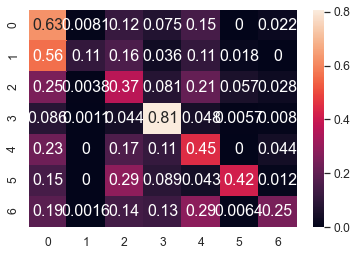

	training epoch=12 .. train_loss=1.182
	validation epoch=12 .. val_loss=1.271
	Accuracy = 50.5 % .. Percision = 53.400000000000006 % .. Recall = 43.2 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_12.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 13 .. loss = 0.738


  0%|                                                                                 | 1/1914 [00:01<38:01,  1.19s/it]

training @ epoch 13 .. loss = 1.353


  0%|                                                                                 | 2/1914 [00:02<37:58,  1.19s/it]

training @ epoch 13 .. loss = 0.977


  0%|▏                                                                                | 3/1914 [00:03<38:15,  1.20s/it]

training @ epoch 13 .. loss = 1.21


  0%|▏                                                                                | 4/1914 [00:04<39:18,  1.23s/it]

training @ epoch 13 .. loss = 0.87


  0%|▏                                                                                | 5/1914 [00:06<38:41,  1.22s/it]

training @ epoch 13 .. loss = 0.624


  0%|▎                                                                                | 6/1914 [00:07<39:07,  1.23s/it]

training @ epoch 13 .. loss = 1.236


  0%|▎                                                                                | 7/1914 [00:08<38:55,  1.22s/it]

training @ epoch 13 .. loss = 0.703


  0%|▎                                                                                | 8/1914 [00:09<38:47,  1.22s/it]

training @ epoch 13 .. loss = 0.78


  0%|▍                                                                                | 9/1914 [00:11<38:49,  1.22s/it]

training @ epoch 13 .. loss = 1.58


  1%|▍                                                                               | 10/1914 [00:12<38:17,  1.21s/it]

training @ epoch 13 .. loss = 1.125


  1%|▍                                                                               | 11/1914 [00:13<38:42,  1.22s/it]

training @ epoch 13 .. loss = 0.999


  1%|▌                                                                               | 12/1914 [00:14<38:42,  1.22s/it]

training @ epoch 13 .. loss = 1.077


  1%|▌                                                                               | 13/1914 [00:15<38:52,  1.23s/it]

training @ epoch 13 .. loss = 0.858


  1%|▌                                                                               | 14/1914 [00:17<38:53,  1.23s/it]

training @ epoch 13 .. loss = 1.079


  1%|▋                                                                               | 15/1914 [00:18<38:37,  1.22s/it]

training @ epoch 13 .. loss = 1.331


  1%|▋                                                                               | 16/1914 [00:19<38:37,  1.22s/it]

training @ epoch 13 .. loss = 1.409


  1%|▋                                                                               | 17/1914 [00:20<38:25,  1.22s/it]

training @ epoch 13 .. loss = 0.926


  1%|▊                                                                               | 18/1914 [00:21<38:34,  1.22s/it]

training @ epoch 13 .. loss = 0.93


  1%|▊                                                                               | 19/1914 [00:23<38:22,  1.21s/it]

training @ epoch 13 .. loss = 0.678


  1%|▊                                                                               | 20/1914 [00:24<38:25,  1.22s/it]

training @ epoch 13 .. loss = 0.849


  1%|▉                                                                               | 21/1914 [00:25<38:50,  1.23s/it]

training @ epoch 13 .. loss = 0.563


  1%|▉                                                                               | 22/1914 [00:26<38:43,  1.23s/it]

training @ epoch 13 .. loss = 1.425


  1%|▉                                                                               | 23/1914 [00:28<38:16,  1.21s/it]

training @ epoch 13 .. loss = 2.044


  1%|█                                                                               | 24/1914 [00:29<38:31,  1.22s/it]

training @ epoch 13 .. loss = 1.359


  1%|█                                                                               | 25/1914 [00:30<38:28,  1.22s/it]

training @ epoch 13 .. loss = 1.293


  1%|█                                                                               | 26/1914 [00:31<38:37,  1.23s/it]

training @ epoch 13 .. loss = 1.099


  1%|█▏                                                                              | 27/1914 [00:32<38:33,  1.23s/it]

training @ epoch 13 .. loss = 1.346


  1%|█▏                                                                              | 28/1914 [00:34<38:01,  1.21s/it]

training @ epoch 13 .. loss = 0.964


  2%|█▏                                                                              | 29/1914 [00:35<38:00,  1.21s/it]

training @ epoch 13 .. loss = 1.407


  2%|█▎                                                                              | 30/1914 [00:36<38:10,  1.22s/it]

training @ epoch 13 .. loss = 0.773


  2%|█▎                                                                              | 31/1914 [00:37<38:13,  1.22s/it]

training @ epoch 13 .. loss = 1.306


  2%|█▎                                                                              | 32/1914 [00:39<38:20,  1.22s/it]

training @ epoch 13 .. loss = 1.562


  2%|█▍                                                                              | 33/1914 [00:40<38:01,  1.21s/it]

training @ epoch 13 .. loss = 0.889


  2%|█▍                                                                              | 34/1914 [00:41<38:05,  1.22s/it]

training @ epoch 13 .. loss = 1.214


  2%|█▍                                                                              | 35/1914 [00:42<37:52,  1.21s/it]

training @ epoch 13 .. loss = 0.898


  2%|█▌                                                                              | 36/1914 [00:43<37:50,  1.21s/it]

training @ epoch 13 .. loss = 1.176


  2%|█▌                                                                              | 37/1914 [00:45<37:57,  1.21s/it]

training @ epoch 13 .. loss = 1.348


  2%|█▌                                                                              | 38/1914 [00:46<37:33,  1.20s/it]

training @ epoch 13 .. loss = 0.83


  2%|█▋                                                                              | 39/1914 [00:47<37:59,  1.22s/it]

training @ epoch 13 .. loss = 1.034


  2%|█▋                                                                              | 40/1914 [00:48<37:34,  1.20s/it]

training @ epoch 13 .. loss = 1.331


  2%|█▋                                                                              | 41/1914 [00:49<37:49,  1.21s/it]

training @ epoch 13 .. loss = 1.092


  2%|█▊                                                                              | 42/1914 [00:51<37:49,  1.21s/it]

training @ epoch 13 .. loss = 1.119


  2%|█▊                                                                              | 43/1914 [00:52<37:48,  1.21s/it]

training @ epoch 13 .. loss = 1.106


  2%|█▊                                                                              | 44/1914 [00:53<38:21,  1.23s/it]

training @ epoch 13 .. loss = 0.801


  2%|█▉                                                                              | 45/1914 [00:54<38:02,  1.22s/it]

training @ epoch 13 .. loss = 1.334


  2%|█▉                                                                              | 46/1914 [00:56<37:51,  1.22s/it]

training @ epoch 13 .. loss = 1.128


  2%|█▉                                                                              | 47/1914 [00:57<37:58,  1.22s/it]

training @ epoch 13 .. loss = 1.316


  3%|██                                                                              | 48/1914 [00:58<38:07,  1.23s/it]

training @ epoch 13 .. loss = 1.52


  3%|██                                                                              | 49/1914 [00:59<37:48,  1.22s/it]

training @ epoch 13 .. loss = 1.359


  3%|██                                                                              | 50/1914 [01:00<37:49,  1.22s/it]

training @ epoch 13 .. loss = 0.86


  3%|██▏                                                                             | 51/1914 [01:02<37:22,  1.20s/it]

training @ epoch 13 .. loss = 1.009


  3%|██▏                                                                             | 52/1914 [01:03<37:42,  1.22s/it]

training @ epoch 13 .. loss = 1.561


  3%|██▏                                                                             | 53/1914 [01:04<37:39,  1.21s/it]

training @ epoch 13 .. loss = 1.295


  3%|██▎                                                                             | 54/1914 [01:05<37:43,  1.22s/it]

training @ epoch 13 .. loss = 1.215


  3%|██▎                                                                             | 55/1914 [01:07<38:13,  1.23s/it]

training @ epoch 13 .. loss = 1.31


  3%|██▎                                                                             | 56/1914 [01:08<38:10,  1.23s/it]

training @ epoch 13 .. loss = 1.275


  3%|██▍                                                                             | 57/1914 [01:09<38:13,  1.23s/it]

training @ epoch 13 .. loss = 0.709


  3%|██▍                                                                             | 58/1914 [01:10<37:53,  1.22s/it]

training @ epoch 13 .. loss = 1.236


  3%|██▍                                                                             | 59/1914 [01:11<37:51,  1.22s/it]

training @ epoch 13 .. loss = 1.159


  3%|██▌                                                                             | 60/1914 [01:13<38:00,  1.23s/it]

training @ epoch 13 .. loss = 1.201


  3%|██▌                                                                             | 61/1914 [01:14<37:55,  1.23s/it]

training @ epoch 13 .. loss = 0.953


  3%|██▌                                                                             | 62/1914 [01:15<37:38,  1.22s/it]

training @ epoch 13 .. loss = 1.305


  3%|██▋                                                                             | 63/1914 [01:16<37:44,  1.22s/it]

training @ epoch 13 .. loss = 1.063


  3%|██▋                                                                             | 64/1914 [01:18<37:24,  1.21s/it]

training @ epoch 13 .. loss = 1.0


  3%|██▋                                                                             | 65/1914 [01:19<37:28,  1.22s/it]

training @ epoch 13 .. loss = 1.09


  3%|██▊                                                                             | 66/1914 [01:20<37:10,  1.21s/it]

training @ epoch 13 .. loss = 1.276


  4%|██▊                                                                             | 67/1914 [01:21<37:22,  1.21s/it]

training @ epoch 13 .. loss = 1.41


  4%|██▊                                                                             | 68/1914 [01:22<37:33,  1.22s/it]

training @ epoch 13 .. loss = 1.013


  4%|██▉                                                                             | 69/1914 [01:24<37:09,  1.21s/it]

training @ epoch 13 .. loss = 1.121


  4%|██▉                                                                             | 70/1914 [01:25<37:10,  1.21s/it]

training @ epoch 13 .. loss = 1.051


  4%|██▉                                                                             | 71/1914 [01:26<37:11,  1.21s/it]

training @ epoch 13 .. loss = 1.694


  4%|███                                                                             | 72/1914 [01:27<37:16,  1.21s/it]

training @ epoch 13 .. loss = 1.024


  4%|███                                                                             | 73/1914 [01:28<37:31,  1.22s/it]

training @ epoch 13 .. loss = 1.451


  4%|███                                                                             | 74/1914 [01:30<37:17,  1.22s/it]

training @ epoch 13 .. loss = 0.761


  4%|███▏                                                                            | 75/1914 [01:31<37:20,  1.22s/it]

training @ epoch 13 .. loss = 0.895


  4%|███▏                                                                            | 76/1914 [01:32<37:02,  1.21s/it]

training @ epoch 13 .. loss = 0.917


  4%|███▏                                                                            | 77/1914 [01:33<37:09,  1.21s/it]

training @ epoch 13 .. loss = 0.929


  4%|███▎                                                                            | 78/1914 [01:35<37:23,  1.22s/it]

training @ epoch 13 .. loss = 0.954


  4%|███▎                                                                            | 79/1914 [01:36<37:14,  1.22s/it]

training @ epoch 13 .. loss = 1.287


  4%|███▎                                                                            | 80/1914 [01:37<37:36,  1.23s/it]

training @ epoch 13 .. loss = 1.282


  4%|███▍                                                                            | 81/1914 [01:38<37:19,  1.22s/it]

training @ epoch 13 .. loss = 1.078


  4%|███▍                                                                            | 82/1914 [01:39<37:11,  1.22s/it]

training @ epoch 13 .. loss = 1.14


  4%|███▍                                                                            | 83/1914 [01:41<37:17,  1.22s/it]

training @ epoch 13 .. loss = 1.265


  4%|███▌                                                                            | 84/1914 [01:42<37:15,  1.22s/it]

training @ epoch 13 .. loss = 1.615


  4%|███▌                                                                            | 85/1914 [01:43<37:15,  1.22s/it]

training @ epoch 13 .. loss = 0.975


  4%|███▌                                                                            | 86/1914 [01:44<37:14,  1.22s/it]

training @ epoch 13 .. loss = 1.359


  5%|███▋                                                                            | 87/1914 [01:46<37:12,  1.22s/it]

training @ epoch 13 .. loss = 1.183


  5%|███▋                                                                            | 88/1914 [01:47<37:15,  1.22s/it]

training @ epoch 13 .. loss = 0.908


  5%|███▋                                                                            | 89/1914 [01:48<37:13,  1.22s/it]

training @ epoch 13 .. loss = 1.088


  5%|███▊                                                                            | 90/1914 [01:49<37:11,  1.22s/it]

training @ epoch 13 .. loss = 1.079


  5%|███▊                                                                            | 91/1914 [01:51<37:58,  1.25s/it]

training @ epoch 13 .. loss = 1.291


  5%|███▊                                                                            | 92/1914 [01:52<37:31,  1.24s/it]

training @ epoch 13 .. loss = 1.059


  5%|███▉                                                                            | 93/1914 [01:53<37:45,  1.24s/it]

training @ epoch 13 .. loss = 1.129


  5%|███▉                                                                            | 94/1914 [01:54<37:15,  1.23s/it]

training @ epoch 13 .. loss = 1.297


  5%|███▉                                                                            | 95/1914 [01:55<36:59,  1.22s/it]

training @ epoch 13 .. loss = 1.141


  5%|████                                                                            | 96/1914 [01:57<37:04,  1.22s/it]

training @ epoch 13 .. loss = 0.94


  5%|████                                                                            | 97/1914 [01:58<36:51,  1.22s/it]

training @ epoch 13 .. loss = 0.669


  5%|████                                                                            | 98/1914 [01:59<37:15,  1.23s/it]

training @ epoch 13 .. loss = 1.368


  5%|████▏                                                                           | 99/1914 [02:00<37:55,  1.25s/it]

training @ epoch 13 .. loss = 0.917


  5%|████▏                                                                          | 100/1914 [02:02<37:14,  1.23s/it]

training @ epoch 13 .. loss = 1.127


  5%|████▏                                                                          | 101/1914 [02:03<37:09,  1.23s/it]

training @ epoch 13 .. loss = 0.854


  5%|████▏                                                                          | 102/1914 [02:04<36:58,  1.22s/it]

training @ epoch 13 .. loss = 0.905


  5%|████▎                                                                          | 103/1914 [02:05<36:50,  1.22s/it]

training @ epoch 13 .. loss = 1.128


  5%|████▎                                                                          | 104/1914 [02:07<37:21,  1.24s/it]

training @ epoch 13 .. loss = 1.232


  5%|████▎                                                                          | 105/1914 [02:08<39:16,  1.30s/it]

training @ epoch 13 .. loss = 1.809


  6%|████▍                                                                          | 106/1914 [02:09<40:24,  1.34s/it]

training @ epoch 13 .. loss = 1.02


  6%|████▍                                                                          | 107/1914 [02:11<41:15,  1.37s/it]

training @ epoch 13 .. loss = 0.922


  6%|████▍                                                                          | 108/1914 [02:12<41:34,  1.38s/it]

training @ epoch 13 .. loss = 2.038


  6%|████▍                                                                          | 109/1914 [02:14<41:34,  1.38s/it]

training @ epoch 13 .. loss = 0.581


  6%|████▌                                                                          | 110/1914 [02:15<41:12,  1.37s/it]

training @ epoch 13 .. loss = 0.973


  6%|████▌                                                                          | 111/1914 [02:16<40:57,  1.36s/it]

training @ epoch 13 .. loss = 1.271


  6%|████▌                                                                          | 112/1914 [02:18<40:29,  1.35s/it]

training @ epoch 13 .. loss = 1.311


  6%|████▋                                                                          | 113/1914 [02:19<40:15,  1.34s/it]

training @ epoch 13 .. loss = 0.926


  6%|████▋                                                                          | 114/1914 [02:20<40:05,  1.34s/it]

training @ epoch 13 .. loss = 1.086


  6%|████▋                                                                          | 115/1914 [02:22<40:07,  1.34s/it]

training @ epoch 13 .. loss = 1.005


  6%|████▊                                                                          | 116/1914 [02:23<40:10,  1.34s/it]

training @ epoch 13 .. loss = 1.567


  6%|████▊                                                                          | 117/1914 [02:24<40:55,  1.37s/it]

training @ epoch 13 .. loss = 0.637


  6%|████▊                                                                          | 118/1914 [02:26<41:19,  1.38s/it]

training @ epoch 13 .. loss = 1.535


  6%|████▉                                                                          | 119/1914 [02:27<41:37,  1.39s/it]

training @ epoch 13 .. loss = 1.616


  6%|████▉                                                                          | 120/1914 [02:28<40:07,  1.34s/it]

training @ epoch 13 .. loss = 1.409


  6%|████▉                                                                          | 121/1914 [02:30<38:49,  1.30s/it]

training @ epoch 13 .. loss = 1.792


  6%|█████                                                                          | 122/1914 [02:31<38:07,  1.28s/it]

training @ epoch 13 .. loss = 0.808


  6%|█████                                                                          | 123/1914 [02:32<37:36,  1.26s/it]

training @ epoch 13 .. loss = 0.87


  6%|█████                                                                          | 124/1914 [02:33<37:20,  1.25s/it]

training @ epoch 13 .. loss = 0.801


  7%|█████▏                                                                         | 125/1914 [02:35<37:02,  1.24s/it]

training @ epoch 13 .. loss = 1.334


  7%|█████▏                                                                         | 126/1914 [02:36<36:51,  1.24s/it]

training @ epoch 13 .. loss = 0.928


  7%|█████▏                                                                         | 127/1914 [02:37<36:51,  1.24s/it]

training @ epoch 13 .. loss = 1.232


  7%|█████▎                                                                         | 128/1914 [02:38<37:03,  1.25s/it]

training @ epoch 13 .. loss = 1.179


  7%|█████▎                                                                         | 129/1914 [02:39<36:45,  1.24s/it]

training @ epoch 13 .. loss = 1.366


  7%|█████▎                                                                         | 130/1914 [02:41<36:26,  1.23s/it]

training @ epoch 13 .. loss = 1.067


  7%|█████▍                                                                         | 131/1914 [02:42<36:01,  1.21s/it]

training @ epoch 13 .. loss = 1.368


  7%|█████▍                                                                         | 132/1914 [02:43<36:43,  1.24s/it]

training @ epoch 13 .. loss = 0.831


  7%|█████▍                                                                         | 133/1914 [02:44<36:34,  1.23s/it]

training @ epoch 13 .. loss = 1.088


  7%|█████▌                                                                         | 134/1914 [02:46<36:04,  1.22s/it]

training @ epoch 13 .. loss = 1.182


  7%|█████▌                                                                         | 135/1914 [02:47<36:05,  1.22s/it]

training @ epoch 13 .. loss = 0.921


  7%|█████▌                                                                         | 136/1914 [02:48<35:56,  1.21s/it]

training @ epoch 13 .. loss = 1.367


  7%|█████▋                                                                         | 137/1914 [02:49<36:12,  1.22s/it]

training @ epoch 13 .. loss = 0.883


  7%|█████▋                                                                         | 138/1914 [02:50<36:16,  1.23s/it]

training @ epoch 13 .. loss = 0.815


  7%|█████▋                                                                         | 139/1914 [02:52<35:51,  1.21s/it]

training @ epoch 13 .. loss = 1.068


  7%|█████▊                                                                         | 140/1914 [02:53<35:40,  1.21s/it]

training @ epoch 13 .. loss = 1.351


  7%|█████▊                                                                         | 141/1914 [02:54<35:35,  1.20s/it]

training @ epoch 13 .. loss = 1.552


  7%|█████▊                                                                         | 142/1914 [02:55<35:28,  1.20s/it]

training @ epoch 13 .. loss = 0.764


  7%|█████▉                                                                         | 143/1914 [02:56<35:44,  1.21s/it]

training @ epoch 13 .. loss = 1.288


  8%|█████▉                                                                         | 144/1914 [02:58<35:32,  1.20s/it]

training @ epoch 13 .. loss = 1.606


  8%|█████▉                                                                         | 145/1914 [02:59<35:35,  1.21s/it]

training @ epoch 13 .. loss = 1.226


  8%|██████                                                                         | 146/1914 [03:00<35:46,  1.21s/it]

training @ epoch 13 .. loss = 1.301


  8%|██████                                                                         | 147/1914 [03:01<35:50,  1.22s/it]

training @ epoch 13 .. loss = 1.456


  8%|██████                                                                         | 148/1914 [03:03<36:02,  1.22s/it]

training @ epoch 13 .. loss = 1.0


  8%|██████▏                                                                        | 149/1914 [03:04<35:49,  1.22s/it]

training @ epoch 13 .. loss = 1.289


  8%|██████▏                                                                        | 150/1914 [03:05<36:00,  1.22s/it]

training @ epoch 13 .. loss = 1.329


  8%|██████▏                                                                        | 151/1914 [03:06<35:42,  1.22s/it]

training @ epoch 13 .. loss = 1.09


  8%|██████▎                                                                        | 152/1914 [03:07<35:53,  1.22s/it]

training @ epoch 13 .. loss = 0.841


  8%|██████▎                                                                        | 153/1914 [03:09<36:03,  1.23s/it]

training @ epoch 13 .. loss = 1.165


  8%|██████▎                                                                        | 154/1914 [03:10<35:54,  1.22s/it]

training @ epoch 13 .. loss = 1.139


  8%|██████▍                                                                        | 155/1914 [03:11<35:59,  1.23s/it]

training @ epoch 13 .. loss = 1.092


  8%|██████▍                                                                        | 156/1914 [03:12<35:37,  1.22s/it]

training @ epoch 13 .. loss = 0.893


  8%|██████▍                                                                        | 157/1914 [03:14<35:40,  1.22s/it]

training @ epoch 13 .. loss = 1.152


  8%|██████▌                                                                        | 158/1914 [03:15<35:51,  1.23s/it]

training @ epoch 13 .. loss = 0.995


  8%|██████▌                                                                        | 159/1914 [03:16<35:44,  1.22s/it]

training @ epoch 13 .. loss = 1.362


  8%|██████▌                                                                        | 160/1914 [03:17<35:48,  1.22s/it]

training @ epoch 13 .. loss = 0.843


  8%|██████▋                                                                        | 161/1914 [03:19<36:23,  1.25s/it]

training @ epoch 13 .. loss = 1.22


  8%|██████▋                                                                        | 162/1914 [03:20<35:53,  1.23s/it]

training @ epoch 13 .. loss = 1.192


  9%|██████▋                                                                        | 163/1914 [03:21<35:49,  1.23s/it]

training @ epoch 13 .. loss = 1.021


  9%|██████▊                                                                        | 164/1914 [03:22<35:50,  1.23s/it]

training @ epoch 13 .. loss = 1.277


  9%|██████▊                                                                        | 165/1914 [03:23<35:50,  1.23s/it]

training @ epoch 13 .. loss = 0.977


  9%|██████▊                                                                        | 166/1914 [03:25<35:55,  1.23s/it]

training @ epoch 13 .. loss = 1.17


  9%|██████▉                                                                        | 167/1914 [03:26<35:27,  1.22s/it]

training @ epoch 13 .. loss = 1.36


  9%|██████▉                                                                        | 168/1914 [03:27<35:34,  1.22s/it]

training @ epoch 13 .. loss = 0.674


  9%|██████▉                                                                        | 169/1914 [03:28<36:09,  1.24s/it]

training @ epoch 13 .. loss = 1.218


  9%|███████                                                                        | 170/1914 [03:30<35:47,  1.23s/it]

training @ epoch 13 .. loss = 1.502


  9%|███████                                                                        | 171/1914 [03:31<35:45,  1.23s/it]

training @ epoch 13 .. loss = 1.249


  9%|███████                                                                        | 172/1914 [03:32<35:44,  1.23s/it]

training @ epoch 13 .. loss = 0.885


  9%|███████▏                                                                       | 173/1914 [03:33<35:29,  1.22s/it]

training @ epoch 13 .. loss = 1.35


  9%|███████▏                                                                       | 174/1914 [03:34<35:38,  1.23s/it]

training @ epoch 13 .. loss = 1.108


  9%|███████▏                                                                       | 175/1914 [03:36<35:10,  1.21s/it]

training @ epoch 13 .. loss = 1.101


  9%|███████▎                                                                       | 176/1914 [03:37<35:02,  1.21s/it]

training @ epoch 13 .. loss = 1.851


  9%|███████▎                                                                       | 177/1914 [03:38<34:46,  1.20s/it]

training @ epoch 13 .. loss = 1.329


  9%|███████▎                                                                       | 178/1914 [03:39<35:01,  1.21s/it]

training @ epoch 13 .. loss = 0.859


  9%|███████▍                                                                       | 179/1914 [03:40<35:05,  1.21s/it]

training @ epoch 13 .. loss = 1.322


  9%|███████▍                                                                       | 180/1914 [03:42<34:58,  1.21s/it]

training @ epoch 13 .. loss = 1.211


  9%|███████▍                                                                       | 181/1914 [03:43<35:13,  1.22s/it]

training @ epoch 13 .. loss = 1.547


 10%|███████▌                                                                       | 182/1914 [03:44<35:19,  1.22s/it]

training @ epoch 13 .. loss = 0.837


 10%|███████▌                                                                       | 183/1914 [03:45<35:43,  1.24s/it]

training @ epoch 13 .. loss = 1.218


 10%|███████▌                                                                       | 184/1914 [03:47<35:17,  1.22s/it]

training @ epoch 13 .. loss = 1.098


 10%|███████▋                                                                       | 185/1914 [03:48<34:53,  1.21s/it]

training @ epoch 13 .. loss = 1.182


 10%|███████▋                                                                       | 186/1914 [03:49<35:03,  1.22s/it]

training @ epoch 13 .. loss = 1.321


 10%|███████▋                                                                       | 187/1914 [03:50<34:50,  1.21s/it]

training @ epoch 13 .. loss = 0.899


 10%|███████▊                                                                       | 188/1914 [03:51<34:50,  1.21s/it]

training @ epoch 13 .. loss = 1.197


 10%|███████▊                                                                       | 189/1914 [03:53<34:48,  1.21s/it]

training @ epoch 13 .. loss = 0.756


 10%|███████▊                                                                       | 190/1914 [03:54<34:41,  1.21s/it]

training @ epoch 13 .. loss = 0.892


 10%|███████▉                                                                       | 191/1914 [03:55<35:13,  1.23s/it]

training @ epoch 13 .. loss = 1.209


 10%|███████▉                                                                       | 192/1914 [03:56<35:06,  1.22s/it]

training @ epoch 13 .. loss = 1.008


 10%|███████▉                                                                       | 193/1914 [03:58<34:59,  1.22s/it]

training @ epoch 13 .. loss = 1.018


 10%|████████                                                                       | 194/1914 [03:59<35:30,  1.24s/it]

training @ epoch 13 .. loss = 1.259


 10%|████████                                                                       | 195/1914 [04:00<35:10,  1.23s/it]

training @ epoch 13 .. loss = 1.609


 10%|████████                                                                       | 196/1914 [04:01<35:02,  1.22s/it]

training @ epoch 13 .. loss = 1.194


 10%|████████▏                                                                      | 197/1914 [04:02<35:18,  1.23s/it]

training @ epoch 13 .. loss = 1.169


 10%|████████▏                                                                      | 198/1914 [04:04<34:33,  1.21s/it]

training @ epoch 13 .. loss = 1.137


 10%|████████▏                                                                      | 199/1914 [04:05<34:56,  1.22s/it]

training @ epoch 13 .. loss = 2.072


 10%|████████▎                                                                      | 200/1914 [04:06<34:34,  1.21s/it]

training @ epoch 13 .. loss = 1.49


 11%|████████▎                                                                      | 201/1914 [04:07<34:49,  1.22s/it]

training @ epoch 13 .. loss = 0.845


 11%|████████▎                                                                      | 202/1914 [04:09<35:09,  1.23s/it]

training @ epoch 13 .. loss = 1.061


 11%|████████▍                                                                      | 203/1914 [04:10<35:11,  1.23s/it]

training @ epoch 13 .. loss = 1.117


 11%|████████▍                                                                      | 204/1914 [04:11<35:18,  1.24s/it]

training @ epoch 13 .. loss = 1.132


 11%|████████▍                                                                      | 205/1914 [04:12<35:25,  1.24s/it]

training @ epoch 13 .. loss = 1.112


 11%|████████▌                                                                      | 206/1914 [04:14<38:04,  1.34s/it]

training @ epoch 13 .. loss = 1.334


 11%|████████▌                                                                      | 207/1914 [04:15<38:21,  1.35s/it]

training @ epoch 13 .. loss = 1.087


 11%|████████▌                                                                      | 208/1914 [04:17<38:28,  1.35s/it]

training @ epoch 13 .. loss = 1.368


 11%|████████▋                                                                      | 209/1914 [04:18<37:25,  1.32s/it]

training @ epoch 13 .. loss = 1.971


 11%|████████▋                                                                      | 210/1914 [04:19<36:30,  1.29s/it]

training @ epoch 13 .. loss = 0.845


 11%|████████▋                                                                      | 211/1914 [04:20<36:02,  1.27s/it]

training @ epoch 13 .. loss = 0.97


 11%|████████▊                                                                      | 212/1914 [04:22<35:32,  1.25s/it]

training @ epoch 13 .. loss = 1.075


 11%|████████▊                                                                      | 213/1914 [04:23<35:20,  1.25s/it]

training @ epoch 13 .. loss = 1.426


 11%|████████▊                                                                      | 214/1914 [04:24<35:01,  1.24s/it]

training @ epoch 13 .. loss = 1.274


 11%|████████▊                                                                      | 215/1914 [04:25<34:57,  1.23s/it]

training @ epoch 13 .. loss = 0.779


 11%|████████▉                                                                      | 216/1914 [04:26<35:01,  1.24s/it]

training @ epoch 13 .. loss = 1.29


 11%|████████▉                                                                      | 217/1914 [04:28<34:47,  1.23s/it]

training @ epoch 13 .. loss = 1.45


 11%|████████▉                                                                      | 218/1914 [04:29<34:52,  1.23s/it]

training @ epoch 13 .. loss = 0.933


 11%|█████████                                                                      | 219/1914 [04:30<34:54,  1.24s/it]

training @ epoch 13 .. loss = 1.105


 11%|█████████                                                                      | 220/1914 [04:31<34:52,  1.24s/it]

training @ epoch 13 .. loss = 1.086


 12%|█████████                                                                      | 221/1914 [04:33<34:39,  1.23s/it]

training @ epoch 13 .. loss = 0.96


 12%|█████████▏                                                                     | 222/1914 [04:34<34:15,  1.21s/it]

training @ epoch 13 .. loss = 1.416


 12%|█████████▏                                                                     | 223/1914 [04:35<34:17,  1.22s/it]

training @ epoch 13 .. loss = 1.222


 12%|█████████▏                                                                     | 224/1914 [04:36<34:23,  1.22s/it]

training @ epoch 13 .. loss = 1.342


 12%|█████████▎                                                                     | 225/1914 [04:37<34:23,  1.22s/it]

training @ epoch 13 .. loss = 1.24


 12%|█████████▎                                                                     | 226/1914 [04:39<34:07,  1.21s/it]

training @ epoch 13 .. loss = 1.063


 12%|█████████▎                                                                     | 227/1914 [04:40<34:01,  1.21s/it]

training @ epoch 13 .. loss = 1.016


 12%|█████████▍                                                                     | 228/1914 [04:41<34:09,  1.22s/it]

training @ epoch 13 .. loss = 1.836


 12%|█████████▍                                                                     | 229/1914 [04:42<33:56,  1.21s/it]

training @ epoch 13 .. loss = 1.191


 12%|█████████▍                                                                     | 230/1914 [04:43<33:56,  1.21s/it]

training @ epoch 13 .. loss = 1.68


 12%|█████████▌                                                                     | 231/1914 [04:45<33:55,  1.21s/it]

training @ epoch 13 .. loss = 0.888


 12%|█████████▌                                                                     | 232/1914 [04:46<33:50,  1.21s/it]

training @ epoch 13 .. loss = 0.877


 12%|█████████▌                                                                     | 233/1914 [04:47<33:51,  1.21s/it]

training @ epoch 13 .. loss = 0.943


 12%|█████████▋                                                                     | 234/1914 [04:48<34:01,  1.22s/it]

training @ epoch 13 .. loss = 1.039


 12%|█████████▋                                                                     | 235/1914 [04:50<33:48,  1.21s/it]

training @ epoch 13 .. loss = 1.62


 12%|█████████▋                                                                     | 236/1914 [04:51<33:38,  1.20s/it]

training @ epoch 13 .. loss = 1.057


 12%|█████████▊                                                                     | 237/1914 [04:52<33:41,  1.21s/it]

training @ epoch 13 .. loss = 1.188


 12%|█████████▊                                                                     | 238/1914 [04:53<33:43,  1.21s/it]

training @ epoch 13 .. loss = 1.307


 12%|█████████▊                                                                     | 239/1914 [04:54<33:56,  1.22s/it]

training @ epoch 13 .. loss = 1.163


 13%|█████████▉                                                                     | 240/1914 [04:56<33:42,  1.21s/it]

training @ epoch 13 .. loss = 1.149


 13%|█████████▉                                                                     | 241/1914 [04:57<34:03,  1.22s/it]

training @ epoch 13 .. loss = 1.002


 13%|█████████▉                                                                     | 242/1914 [04:58<33:47,  1.21s/it]

training @ epoch 13 .. loss = 1.351


 13%|██████████                                                                     | 243/1914 [04:59<34:21,  1.23s/it]

training @ epoch 13 .. loss = 1.374


 13%|██████████                                                                     | 244/1914 [05:01<34:17,  1.23s/it]

training @ epoch 13 .. loss = 1.271


 13%|██████████                                                                     | 245/1914 [05:02<33:45,  1.21s/it]

training @ epoch 13 .. loss = 1.033


 13%|██████████▏                                                                    | 246/1914 [05:03<34:08,  1.23s/it]

training @ epoch 13 .. loss = 1.188


 13%|██████████▏                                                                    | 247/1914 [05:04<33:54,  1.22s/it]

training @ epoch 13 .. loss = 1.36


 13%|██████████▏                                                                    | 248/1914 [05:05<33:53,  1.22s/it]

training @ epoch 13 .. loss = 1.029


 13%|██████████▎                                                                    | 249/1914 [05:07<33:53,  1.22s/it]

training @ epoch 13 .. loss = 1.365


 13%|██████████▎                                                                    | 250/1914 [05:08<33:58,  1.23s/it]

training @ epoch 13 .. loss = 1.025


 13%|██████████▎                                                                    | 251/1914 [05:09<34:05,  1.23s/it]

training @ epoch 13 .. loss = 1.44


 13%|██████████▍                                                                    | 252/1914 [05:10<34:46,  1.26s/it]

training @ epoch 13 .. loss = 1.565


 13%|██████████▍                                                                    | 253/1914 [05:12<34:13,  1.24s/it]

training @ epoch 13 .. loss = 0.726


 13%|██████████▍                                                                    | 254/1914 [05:13<34:20,  1.24s/it]

training @ epoch 13 .. loss = 1.339


 13%|██████████▌                                                                    | 255/1914 [05:14<34:00,  1.23s/it]

training @ epoch 13 .. loss = 1.179


 13%|██████████▌                                                                    | 256/1914 [05:15<34:05,  1.23s/it]

training @ epoch 13 .. loss = 1.349


 13%|██████████▌                                                                    | 257/1914 [05:16<34:03,  1.23s/it]

training @ epoch 13 .. loss = 1.057


 13%|██████████▋                                                                    | 258/1914 [05:18<34:11,  1.24s/it]

training @ epoch 13 .. loss = 1.398


 14%|██████████▋                                                                    | 259/1914 [05:19<36:22,  1.32s/it]

training @ epoch 13 .. loss = 1.094


 14%|██████████▋                                                                    | 260/1914 [05:21<35:58,  1.30s/it]

training @ epoch 13 .. loss = 1.099


 14%|██████████▊                                                                    | 261/1914 [05:22<34:55,  1.27s/it]

training @ epoch 13 .. loss = 1.036


 14%|██████████▊                                                                    | 262/1914 [05:23<34:36,  1.26s/it]

training @ epoch 13 .. loss = 1.115


 14%|██████████▊                                                                    | 263/1914 [05:24<35:49,  1.30s/it]

training @ epoch 13 .. loss = 1.364


 14%|██████████▉                                                                    | 264/1914 [05:26<35:38,  1.30s/it]

training @ epoch 13 .. loss = 1.531


 14%|██████████▉                                                                    | 265/1914 [05:27<36:45,  1.34s/it]

training @ epoch 13 .. loss = 1.562


 14%|██████████▉                                                                    | 266/1914 [05:28<36:17,  1.32s/it]

training @ epoch 13 .. loss = 1.191


 14%|███████████                                                                    | 267/1914 [05:30<36:12,  1.32s/it]

training @ epoch 13 .. loss = 1.313


 14%|███████████                                                                    | 268/1914 [05:31<36:47,  1.34s/it]

training @ epoch 13 .. loss = 1.088


 14%|███████████                                                                    | 269/1914 [05:32<36:03,  1.31s/it]

training @ epoch 13 .. loss = 0.968


 14%|███████████▏                                                                   | 270/1914 [05:34<35:50,  1.31s/it]

training @ epoch 13 .. loss = 1.312


 14%|███████████▏                                                                   | 271/1914 [05:35<36:18,  1.33s/it]

training @ epoch 13 .. loss = 0.862


 14%|███████████▏                                                                   | 272/1914 [05:36<35:56,  1.31s/it]

training @ epoch 13 .. loss = 0.929


 14%|███████████▎                                                                   | 273/1914 [05:38<35:43,  1.31s/it]

training @ epoch 13 .. loss = 1.097


 14%|███████████▎                                                                   | 274/1914 [05:39<36:21,  1.33s/it]

training @ epoch 13 .. loss = 1.2


 14%|███████████▎                                                                   | 275/1914 [05:40<35:47,  1.31s/it]

training @ epoch 13 .. loss = 1.146


 14%|███████████▍                                                                   | 276/1914 [05:41<35:37,  1.31s/it]

training @ epoch 13 .. loss = 0.893


 14%|███████████▍                                                                   | 277/1914 [05:43<35:50,  1.31s/it]

training @ epoch 13 .. loss = 0.794


 15%|███████████▍                                                                   | 278/1914 [05:44<36:08,  1.33s/it]

training @ epoch 13 .. loss = 1.163


 15%|███████████▌                                                                   | 279/1914 [05:45<36:00,  1.32s/it]

training @ epoch 13 .. loss = 1.268


 15%|███████████▌                                                                   | 280/1914 [05:47<35:46,  1.31s/it]

training @ epoch 13 .. loss = 1.132


 15%|███████████▌                                                                   | 281/1914 [05:48<35:34,  1.31s/it]

training @ epoch 13 .. loss = 1.452


 15%|███████████▋                                                                   | 282/1914 [05:49<35:16,  1.30s/it]

training @ epoch 13 .. loss = 1.338


 15%|███████████▋                                                                   | 283/1914 [05:51<35:27,  1.30s/it]

training @ epoch 13 .. loss = 0.902


 15%|███████████▋                                                                   | 284/1914 [05:52<35:26,  1.30s/it]

training @ epoch 13 .. loss = 1.28


 15%|███████████▊                                                                   | 285/1914 [05:53<35:19,  1.30s/it]

training @ epoch 13 .. loss = 0.947


 15%|███████████▊                                                                   | 286/1914 [05:55<35:29,  1.31s/it]

training @ epoch 13 .. loss = 1.096


 15%|███████████▊                                                                   | 287/1914 [05:56<35:26,  1.31s/it]

training @ epoch 13 .. loss = 1.051


 15%|███████████▉                                                                   | 288/1914 [05:57<35:22,  1.31s/it]

training @ epoch 13 .. loss = 1.184


 15%|███████████▉                                                                   | 289/1914 [05:58<35:19,  1.30s/it]

training @ epoch 13 .. loss = 1.269


 15%|███████████▉                                                                   | 290/1914 [06:00<34:58,  1.29s/it]

training @ epoch 13 .. loss = 1.489


 15%|████████████                                                                   | 291/1914 [06:01<36:54,  1.36s/it]

training @ epoch 13 .. loss = 1.336


 15%|████████████                                                                   | 292/1914 [06:03<36:38,  1.36s/it]

training @ epoch 13 .. loss = 1.506


 15%|████████████                                                                   | 293/1914 [06:04<35:46,  1.32s/it]

training @ epoch 13 .. loss = 1.188


 15%|████████████▏                                                                  | 294/1914 [06:05<35:40,  1.32s/it]

training @ epoch 13 .. loss = 0.892


 15%|████████████▏                                                                  | 295/1914 [06:06<35:14,  1.31s/it]

training @ epoch 13 .. loss = 1.092


 15%|████████████▏                                                                  | 296/1914 [06:08<34:48,  1.29s/it]

training @ epoch 13 .. loss = 0.792


 16%|████████████▎                                                                  | 297/1914 [06:09<34:58,  1.30s/it]

training @ epoch 13 .. loss = 1.128


 16%|████████████▎                                                                  | 298/1914 [06:10<35:09,  1.31s/it]

training @ epoch 13 .. loss = 1.175


 16%|████████████▎                                                                  | 299/1914 [06:12<34:42,  1.29s/it]

training @ epoch 13 .. loss = 1.373


 16%|████████████▍                                                                  | 300/1914 [06:13<34:53,  1.30s/it]

training @ epoch 13 .. loss = 1.275


 16%|████████████▍                                                                  | 301/1914 [06:14<34:54,  1.30s/it]

training @ epoch 13 .. loss = 0.807


 16%|████████████▍                                                                  | 302/1914 [06:16<35:04,  1.31s/it]

training @ epoch 13 .. loss = 1.325


 16%|████████████▌                                                                  | 303/1914 [06:17<34:47,  1.30s/it]

training @ epoch 13 .. loss = 1.344


 16%|████████████▌                                                                  | 304/1914 [06:18<34:40,  1.29s/it]

training @ epoch 13 .. loss = 0.772


 16%|████████████▌                                                                  | 305/1914 [06:19<34:30,  1.29s/it]

training @ epoch 13 .. loss = 1.837


 16%|████████████▋                                                                  | 306/1914 [06:21<34:27,  1.29s/it]

training @ epoch 13 .. loss = 1.079


 16%|████████████▋                                                                  | 307/1914 [06:22<34:38,  1.29s/it]

training @ epoch 13 .. loss = 1.46


 16%|████████████▋                                                                  | 308/1914 [06:23<34:31,  1.29s/it]

training @ epoch 13 .. loss = 1.299


 16%|████████████▊                                                                  | 309/1914 [06:25<34:32,  1.29s/it]

training @ epoch 13 .. loss = 1.143


 16%|████████████▊                                                                  | 310/1914 [06:26<34:02,  1.27s/it]

training @ epoch 13 .. loss = 1.209


 16%|████████████▊                                                                  | 311/1914 [06:27<34:14,  1.28s/it]

training @ epoch 13 .. loss = 1.318


 16%|████████████▉                                                                  | 312/1914 [06:28<34:10,  1.28s/it]

training @ epoch 13 .. loss = 1.253


 16%|████████████▉                                                                  | 313/1914 [06:30<34:58,  1.31s/it]

training @ epoch 13 .. loss = 1.306


 16%|████████████▉                                                                  | 314/1914 [06:31<35:14,  1.32s/it]

training @ epoch 13 .. loss = 1.236


 16%|█████████████                                                                  | 315/1914 [06:32<35:18,  1.32s/it]

training @ epoch 13 .. loss = 0.898


 17%|█████████████                                                                  | 316/1914 [06:34<34:57,  1.31s/it]

training @ epoch 13 .. loss = 0.812


 17%|█████████████                                                                  | 317/1914 [06:35<35:11,  1.32s/it]

training @ epoch 13 .. loss = 1.093


 17%|█████████████▏                                                                 | 318/1914 [06:36<35:19,  1.33s/it]

training @ epoch 13 .. loss = 1.159


 17%|█████████████▏                                                                 | 319/1914 [06:38<34:27,  1.30s/it]

training @ epoch 13 .. loss = 1.061


 17%|█████████████▏                                                                 | 320/1914 [06:39<33:55,  1.28s/it]

training @ epoch 13 .. loss = 1.153


 17%|█████████████▏                                                                 | 321/1914 [06:40<33:13,  1.25s/it]

training @ epoch 13 .. loss = 0.838


 17%|█████████████▎                                                                 | 322/1914 [06:41<33:02,  1.25s/it]

training @ epoch 13 .. loss = 1.503


 17%|█████████████▎                                                                 | 323/1914 [06:42<32:45,  1.24s/it]

training @ epoch 13 .. loss = 1.687


 17%|█████████████▎                                                                 | 324/1914 [06:44<32:10,  1.21s/it]

training @ epoch 13 .. loss = 1.528


 17%|█████████████▍                                                                 | 325/1914 [06:45<32:16,  1.22s/it]

training @ epoch 13 .. loss = 0.538


 17%|█████████████▍                                                                 | 326/1914 [06:46<32:08,  1.21s/it]

training @ epoch 13 .. loss = 1.294


 17%|█████████████▍                                                                 | 327/1914 [06:47<32:00,  1.21s/it]

training @ epoch 13 .. loss = 1.1


 17%|█████████████▌                                                                 | 328/1914 [06:49<32:15,  1.22s/it]

training @ epoch 13 .. loss = 1.328


 17%|█████████████▌                                                                 | 329/1914 [06:50<32:00,  1.21s/it]

training @ epoch 13 .. loss = 1.201


 17%|█████████████▌                                                                 | 330/1914 [06:51<32:04,  1.21s/it]

training @ epoch 13 .. loss = 1.15


 17%|█████████████▋                                                                 | 331/1914 [06:52<31:43,  1.20s/it]

training @ epoch 13 .. loss = 1.061


 17%|█████████████▋                                                                 | 332/1914 [06:53<31:50,  1.21s/it]

training @ epoch 13 .. loss = 0.968


 17%|█████████████▋                                                                 | 333/1914 [06:55<31:59,  1.21s/it]

training @ epoch 13 .. loss = 1.049


 17%|█████████████▊                                                                 | 334/1914 [06:56<31:37,  1.20s/it]

training @ epoch 13 .. loss = 1.057


 18%|█████████████▊                                                                 | 335/1914 [06:57<31:42,  1.20s/it]

training @ epoch 13 .. loss = 1.005


 18%|█████████████▊                                                                 | 336/1914 [06:58<31:25,  1.20s/it]

training @ epoch 13 .. loss = 1.524


 18%|█████████████▉                                                                 | 337/1914 [06:59<31:41,  1.21s/it]

training @ epoch 13 .. loss = 0.84


 18%|█████████████▉                                                                 | 338/1914 [07:01<31:58,  1.22s/it]

training @ epoch 13 .. loss = 1.101


 18%|█████████████▉                                                                 | 339/1914 [07:02<31:46,  1.21s/it]

training @ epoch 13 .. loss = 1.363


 18%|██████████████                                                                 | 340/1914 [07:03<32:01,  1.22s/it]

training @ epoch 13 .. loss = 0.875


 18%|██████████████                                                                 | 341/1914 [07:04<32:00,  1.22s/it]

training @ epoch 13 .. loss = 0.882


 18%|██████████████                                                                 | 342/1914 [07:05<32:00,  1.22s/it]

training @ epoch 13 .. loss = 1.393


 18%|██████████████▏                                                                | 343/1914 [07:07<31:54,  1.22s/it]

training @ epoch 13 .. loss = 0.71


 18%|██████████████▏                                                                | 344/1914 [07:08<32:09,  1.23s/it]

training @ epoch 13 .. loss = 1.503


 18%|██████████████▏                                                                | 345/1914 [07:09<32:00,  1.22s/it]

training @ epoch 13 .. loss = 1.344


 18%|██████████████▎                                                                | 346/1914 [07:10<31:57,  1.22s/it]

training @ epoch 13 .. loss = 1.119


 18%|██████████████▎                                                                | 347/1914 [07:12<32:02,  1.23s/it]

training @ epoch 13 .. loss = 1.703


 18%|██████████████▎                                                                | 348/1914 [07:13<32:02,  1.23s/it]

training @ epoch 13 .. loss = 0.869


 18%|██████████████▍                                                                | 349/1914 [07:14<32:04,  1.23s/it]

training @ epoch 13 .. loss = 1.344


 18%|██████████████▍                                                                | 350/1914 [07:15<31:50,  1.22s/it]

training @ epoch 13 .. loss = 1.008


 18%|██████████████▍                                                                | 351/1914 [07:17<32:13,  1.24s/it]

training @ epoch 13 .. loss = 0.903


 18%|██████████████▌                                                                | 352/1914 [07:18<32:14,  1.24s/it]

training @ epoch 13 .. loss = 1.499


 18%|██████████████▌                                                                | 353/1914 [07:19<32:01,  1.23s/it]

training @ epoch 13 .. loss = 1.44


 18%|██████████████▌                                                                | 354/1914 [07:20<31:35,  1.21s/it]

training @ epoch 13 .. loss = 1.489


 19%|██████████████▋                                                                | 355/1914 [07:21<31:52,  1.23s/it]

training @ epoch 13 .. loss = 1.15


 19%|██████████████▋                                                                | 356/1914 [07:23<31:59,  1.23s/it]

training @ epoch 13 .. loss = 1.22


 19%|██████████████▋                                                                | 357/1914 [07:24<31:19,  1.21s/it]

training @ epoch 13 .. loss = 1.069


 19%|██████████████▊                                                                | 358/1914 [07:25<31:34,  1.22s/it]

training @ epoch 13 .. loss = 1.053


 19%|██████████████▊                                                                | 359/1914 [07:26<31:40,  1.22s/it]

training @ epoch 13 .. loss = 1.067


 19%|██████████████▊                                                                | 360/1914 [07:28<31:43,  1.22s/it]

training @ epoch 13 .. loss = 1.483


 19%|██████████████▉                                                                | 361/1914 [07:29<31:46,  1.23s/it]

training @ epoch 13 .. loss = 1.041


 19%|██████████████▉                                                                | 362/1914 [07:30<31:17,  1.21s/it]

training @ epoch 13 .. loss = 1.005


 19%|██████████████▉                                                                | 363/1914 [07:31<31:28,  1.22s/it]

training @ epoch 13 .. loss = 1.011


 19%|███████████████                                                                | 364/1914 [07:32<31:39,  1.23s/it]

training @ epoch 13 .. loss = 1.441


 19%|███████████████                                                                | 365/1914 [07:34<31:27,  1.22s/it]

training @ epoch 13 .. loss = 1.187


 19%|███████████████                                                                | 366/1914 [07:35<31:18,  1.21s/it]

training @ epoch 13 .. loss = 1.27


 19%|███████████████▏                                                               | 367/1914 [07:36<31:11,  1.21s/it]

training @ epoch 13 .. loss = 1.451


 19%|███████████████▏                                                               | 368/1914 [07:37<31:12,  1.21s/it]

training @ epoch 13 .. loss = 1.221


 19%|███████████████▏                                                               | 369/1914 [07:38<31:30,  1.22s/it]

training @ epoch 13 .. loss = 0.995


 19%|███████████████▎                                                               | 370/1914 [07:40<31:14,  1.21s/it]

training @ epoch 13 .. loss = 0.968


 19%|███████████████▎                                                               | 371/1914 [07:41<31:16,  1.22s/it]

training @ epoch 13 .. loss = 1.278


 19%|███████████████▎                                                               | 372/1914 [07:42<31:13,  1.22s/it]

training @ epoch 13 .. loss = 1.203


 19%|███████████████▍                                                               | 373/1914 [07:43<31:11,  1.21s/it]

training @ epoch 13 .. loss = 1.693


 20%|███████████████▍                                                               | 374/1914 [07:45<31:31,  1.23s/it]

training @ epoch 13 .. loss = 0.952


 20%|███████████████▍                                                               | 375/1914 [07:46<31:05,  1.21s/it]

training @ epoch 13 .. loss = 0.813


 20%|███████████████▌                                                               | 376/1914 [07:47<31:23,  1.22s/it]

training @ epoch 13 .. loss = 1.438


 20%|███████████████▌                                                               | 377/1914 [07:48<31:13,  1.22s/it]

training @ epoch 13 .. loss = 1.362


 20%|███████████████▌                                                               | 378/1914 [07:49<31:22,  1.23s/it]

training @ epoch 13 .. loss = 0.753


 20%|███████████████▋                                                               | 379/1914 [07:51<31:25,  1.23s/it]

training @ epoch 13 .. loss = 0.76


 20%|███████████████▋                                                               | 380/1914 [07:52<30:56,  1.21s/it]

training @ epoch 13 .. loss = 1.079


 20%|███████████████▋                                                               | 381/1914 [07:53<30:50,  1.21s/it]

training @ epoch 13 .. loss = 1.317


 20%|███████████████▊                                                               | 382/1914 [07:54<31:06,  1.22s/it]

training @ epoch 13 .. loss = 1.264


 20%|███████████████▊                                                               | 383/1914 [07:56<31:01,  1.22s/it]

training @ epoch 13 .. loss = 1.323


 20%|███████████████▊                                                               | 384/1914 [07:57<31:13,  1.22s/it]

training @ epoch 13 .. loss = 1.047


 20%|███████████████▉                                                               | 385/1914 [07:58<33:29,  1.31s/it]

training @ epoch 13 .. loss = 1.201


 20%|███████████████▉                                                               | 386/1914 [08:00<34:09,  1.34s/it]

training @ epoch 13 .. loss = 1.165


 20%|███████████████▉                                                               | 387/1914 [08:01<33:41,  1.32s/it]

training @ epoch 13 .. loss = 1.049


 20%|████████████████                                                               | 388/1914 [08:02<32:58,  1.30s/it]

training @ epoch 13 .. loss = 1.183


 20%|████████████████                                                               | 389/1914 [08:03<32:18,  1.27s/it]

training @ epoch 13 .. loss = 1.302


 20%|████████████████                                                               | 390/1914 [08:05<32:04,  1.26s/it]

training @ epoch 13 .. loss = 0.911


 20%|████████████████▏                                                              | 391/1914 [08:06<31:27,  1.24s/it]

training @ epoch 13 .. loss = 2.067


 20%|████████████████▏                                                              | 392/1914 [08:07<31:29,  1.24s/it]

training @ epoch 13 .. loss = 1.004


 21%|████████████████▏                                                              | 393/1914 [08:08<31:24,  1.24s/it]

training @ epoch 13 .. loss = 0.867


 21%|████████████████▎                                                              | 394/1914 [08:10<31:06,  1.23s/it]

training @ epoch 13 .. loss = 0.94


 21%|████████████████▎                                                              | 395/1914 [08:11<30:38,  1.21s/it]

training @ epoch 13 .. loss = 1.009


 21%|████████████████▎                                                              | 396/1914 [08:12<30:52,  1.22s/it]

training @ epoch 13 .. loss = 1.179


 21%|████████████████▍                                                              | 397/1914 [08:13<31:20,  1.24s/it]

training @ epoch 13 .. loss = 1.488


 21%|████████████████▍                                                              | 398/1914 [08:14<31:11,  1.23s/it]

training @ epoch 13 .. loss = 0.797


 21%|████████████████▍                                                              | 399/1914 [08:16<30:41,  1.22s/it]

training @ epoch 13 .. loss = 0.789


 21%|████████████████▌                                                              | 400/1914 [08:17<30:43,  1.22s/it]

training @ epoch 13 .. loss = 0.909


 21%|████████████████▌                                                              | 401/1914 [08:18<30:42,  1.22s/it]

training @ epoch 13 .. loss = 1.227


 21%|████████████████▌                                                              | 402/1914 [08:19<30:44,  1.22s/it]

training @ epoch 13 .. loss = 1.376


 21%|████████████████▋                                                              | 403/1914 [08:21<30:49,  1.22s/it]

training @ epoch 13 .. loss = 1.175


 21%|████████████████▋                                                              | 404/1914 [08:22<30:19,  1.21s/it]

training @ epoch 13 .. loss = 1.151


 21%|████████████████▋                                                              | 405/1914 [08:23<30:39,  1.22s/it]

training @ epoch 13 .. loss = 1.444


 21%|████████████████▊                                                              | 406/1914 [08:24<30:31,  1.21s/it]

training @ epoch 13 .. loss = 1.332


 21%|████████████████▊                                                              | 407/1914 [08:25<30:33,  1.22s/it]

training @ epoch 13 .. loss = 0.78


 21%|████████████████▊                                                              | 408/1914 [08:27<30:52,  1.23s/it]

training @ epoch 13 .. loss = 1.474


 21%|████████████████▉                                                              | 409/1914 [08:28<30:36,  1.22s/it]

training @ epoch 13 .. loss = 1.576


 21%|████████████████▉                                                              | 410/1914 [08:29<30:40,  1.22s/it]

training @ epoch 13 .. loss = 1.006


 21%|████████████████▉                                                              | 411/1914 [08:30<30:34,  1.22s/it]

training @ epoch 13 .. loss = 1.263


 22%|█████████████████                                                              | 412/1914 [08:31<30:29,  1.22s/it]

training @ epoch 13 .. loss = 1.437


 22%|█████████████████                                                              | 413/1914 [08:33<30:19,  1.21s/it]

training @ epoch 13 .. loss = 0.939


 22%|█████████████████                                                              | 414/1914 [08:34<30:05,  1.20s/it]

training @ epoch 13 .. loss = 1.115


 22%|█████████████████▏                                                             | 415/1914 [08:35<30:29,  1.22s/it]

training @ epoch 13 .. loss = 1.784


 22%|█████████████████▏                                                             | 416/1914 [08:36<30:38,  1.23s/it]

training @ epoch 13 .. loss = 1.377


 22%|█████████████████▏                                                             | 417/1914 [08:38<30:26,  1.22s/it]

training @ epoch 13 .. loss = 1.458


 22%|█████████████████▎                                                             | 418/1914 [08:39<30:12,  1.21s/it]

training @ epoch 13 .. loss = 1.052


 22%|█████████████████▎                                                             | 419/1914 [08:40<29:57,  1.20s/it]

training @ epoch 13 .. loss = 1.254


 22%|█████████████████▎                                                             | 420/1914 [08:41<30:09,  1.21s/it]

training @ epoch 13 .. loss = 1.204


 22%|█████████████████▍                                                             | 421/1914 [08:42<30:04,  1.21s/it]

training @ epoch 13 .. loss = 1.231


 22%|█████████████████▍                                                             | 422/1914 [08:44<30:05,  1.21s/it]

training @ epoch 13 .. loss = 0.925


 22%|█████████████████▍                                                             | 423/1914 [08:45<29:50,  1.20s/it]

training @ epoch 13 .. loss = 1.384


 22%|█████████████████▌                                                             | 424/1914 [08:46<29:45,  1.20s/it]

training @ epoch 13 .. loss = 1.056


 22%|█████████████████▌                                                             | 425/1914 [08:47<29:58,  1.21s/it]

training @ epoch 13 .. loss = 1.307


 22%|█████████████████▌                                                             | 426/1914 [08:48<30:12,  1.22s/it]

training @ epoch 13 .. loss = 0.695


 22%|█████████████████▌                                                             | 427/1914 [08:50<30:08,  1.22s/it]

training @ epoch 13 .. loss = 1.321


 22%|█████████████████▋                                                             | 428/1914 [08:51<29:57,  1.21s/it]

training @ epoch 13 .. loss = 1.015


 22%|█████████████████▋                                                             | 429/1914 [08:52<30:06,  1.22s/it]

training @ epoch 13 .. loss = 1.337


 22%|█████████████████▋                                                             | 430/1914 [08:53<30:25,  1.23s/it]

training @ epoch 13 .. loss = 1.118


 23%|█████████████████▊                                                             | 431/1914 [08:55<30:39,  1.24s/it]

training @ epoch 13 .. loss = 0.878


 23%|█████████████████▊                                                             | 432/1914 [08:56<29:58,  1.21s/it]

training @ epoch 13 .. loss = 1.487


 23%|█████████████████▊                                                             | 433/1914 [08:57<29:52,  1.21s/it]

training @ epoch 13 .. loss = 1.676


 23%|█████████████████▉                                                             | 434/1914 [08:58<29:52,  1.21s/it]

training @ epoch 13 .. loss = 0.944


 23%|█████████████████▉                                                             | 435/1914 [08:59<29:54,  1.21s/it]

training @ epoch 13 .. loss = 1.278


 23%|█████████████████▉                                                             | 436/1914 [09:01<29:58,  1.22s/it]

training @ epoch 13 .. loss = 1.661


 23%|██████████████████                                                             | 437/1914 [09:02<29:40,  1.21s/it]

training @ epoch 13 .. loss = 1.181


 23%|██████████████████                                                             | 438/1914 [09:03<29:48,  1.21s/it]

training @ epoch 13 .. loss = 0.937


 23%|██████████████████                                                             | 439/1914 [09:04<29:40,  1.21s/it]

training @ epoch 13 .. loss = 1.163


 23%|██████████████████▏                                                            | 440/1914 [09:05<29:49,  1.21s/it]

training @ epoch 13 .. loss = 1.145


 23%|██████████████████▏                                                            | 441/1914 [09:07<30:54,  1.26s/it]

training @ epoch 13 .. loss = 1.0


 23%|██████████████████▏                                                            | 442/1914 [09:08<31:54,  1.30s/it]

training @ epoch 13 .. loss = 0.955


 23%|██████████████████▎                                                            | 443/1914 [09:09<31:40,  1.29s/it]

training @ epoch 13 .. loss = 1.033


 23%|██████████████████▎                                                            | 444/1914 [09:11<31:08,  1.27s/it]

training @ epoch 13 .. loss = 0.69


 23%|██████████████████▎                                                            | 445/1914 [09:12<30:29,  1.25s/it]

training @ epoch 13 .. loss = 1.277


 23%|██████████████████▍                                                            | 446/1914 [09:13<30:54,  1.26s/it]

training @ epoch 13 .. loss = 1.268


 23%|██████████████████▍                                                            | 447/1914 [09:14<30:52,  1.26s/it]

training @ epoch 13 .. loss = 0.945


 23%|██████████████████▍                                                            | 448/1914 [09:16<30:07,  1.23s/it]

training @ epoch 13 .. loss = 1.346


 23%|██████████████████▌                                                            | 449/1914 [09:17<30:23,  1.24s/it]

training @ epoch 13 .. loss = 0.84


 24%|██████████████████▌                                                            | 450/1914 [09:18<30:20,  1.24s/it]

training @ epoch 13 .. loss = 1.032


 24%|██████████████████▌                                                            | 451/1914 [09:19<30:20,  1.24s/it]

training @ epoch 13 .. loss = 1.287


 24%|██████████████████▋                                                            | 452/1914 [09:21<30:14,  1.24s/it]

training @ epoch 13 .. loss = 1.217


 24%|██████████████████▋                                                            | 453/1914 [09:22<29:55,  1.23s/it]

training @ epoch 13 .. loss = 1.125


 24%|██████████████████▋                                                            | 454/1914 [09:23<31:24,  1.29s/it]

training @ epoch 13 .. loss = 1.03


 24%|██████████████████▊                                                            | 455/1914 [09:25<32:26,  1.33s/it]

training @ epoch 13 .. loss = 1.271


 24%|██████████████████▊                                                            | 456/1914 [09:26<32:21,  1.33s/it]

training @ epoch 13 .. loss = 1.457


 24%|██████████████████▊                                                            | 457/1914 [09:27<32:18,  1.33s/it]

training @ epoch 13 .. loss = 1.003


 24%|██████████████████▉                                                            | 458/1914 [09:29<31:51,  1.31s/it]

training @ epoch 13 .. loss = 1.107


 24%|██████████████████▉                                                            | 459/1914 [09:30<31:15,  1.29s/it]

training @ epoch 13 .. loss = 1.22


 24%|██████████████████▉                                                            | 460/1914 [09:31<30:44,  1.27s/it]

training @ epoch 13 .. loss = 0.831


 24%|███████████████████                                                            | 461/1914 [09:32<30:14,  1.25s/it]

training @ epoch 13 .. loss = 0.913


 24%|███████████████████                                                            | 462/1914 [09:34<30:19,  1.25s/it]

training @ epoch 13 .. loss = 0.682


 24%|███████████████████                                                            | 463/1914 [09:35<30:04,  1.24s/it]

training @ epoch 13 .. loss = 1.572


 24%|███████████████████▏                                                           | 464/1914 [09:36<29:41,  1.23s/it]

training @ epoch 13 .. loss = 1.003


 24%|███████████████████▏                                                           | 465/1914 [09:37<29:32,  1.22s/it]

training @ epoch 13 .. loss = 0.827


 24%|███████████████████▏                                                           | 466/1914 [09:38<29:30,  1.22s/it]

training @ epoch 13 .. loss = 1.076


 24%|███████████████████▎                                                           | 467/1914 [09:40<29:16,  1.21s/it]

training @ epoch 13 .. loss = 0.993


 24%|███████████████████▎                                                           | 468/1914 [09:41<29:15,  1.21s/it]

training @ epoch 13 .. loss = 1.833


 25%|███████████████████▎                                                           | 469/1914 [09:42<28:55,  1.20s/it]

training @ epoch 13 .. loss = 0.869


 25%|███████████████████▍                                                           | 470/1914 [09:43<29:08,  1.21s/it]

training @ epoch 13 .. loss = 1.223


 25%|███████████████████▍                                                           | 471/1914 [09:44<29:07,  1.21s/it]

training @ epoch 13 .. loss = 1.655


 25%|███████████████████▍                                                           | 472/1914 [09:46<28:58,  1.21s/it]

training @ epoch 13 .. loss = 1.152


 25%|███████████████████▌                                                           | 473/1914 [09:47<29:04,  1.21s/it]

training @ epoch 13 .. loss = 1.273


 25%|███████████████████▌                                                           | 474/1914 [09:48<28:50,  1.20s/it]

training @ epoch 13 .. loss = 0.962


 25%|███████████████████▌                                                           | 475/1914 [09:49<29:15,  1.22s/it]

training @ epoch 13 .. loss = 1.076


 25%|███████████████████▋                                                           | 476/1914 [09:50<29:29,  1.23s/it]

training @ epoch 13 .. loss = 1.204


 25%|███████████████████▋                                                           | 477/1914 [09:52<29:19,  1.22s/it]

training @ epoch 13 .. loss = 1.205


 25%|███████████████████▋                                                           | 478/1914 [09:53<28:55,  1.21s/it]

training @ epoch 13 .. loss = 1.057


 25%|███████████████████▊                                                           | 479/1914 [09:54<28:46,  1.20s/it]

training @ epoch 13 .. loss = 1.317


 25%|███████████████████▊                                                           | 480/1914 [09:55<28:41,  1.20s/it]

training @ epoch 13 .. loss = 0.942


 25%|███████████████████▊                                                           | 481/1914 [09:56<28:49,  1.21s/it]

training @ epoch 13 .. loss = 0.932


 25%|███████████████████▉                                                           | 482/1914 [09:58<28:49,  1.21s/it]

training @ epoch 13 .. loss = 0.848


 25%|███████████████████▉                                                           | 483/1914 [09:59<28:42,  1.20s/it]

training @ epoch 13 .. loss = 0.892


 25%|███████████████████▉                                                           | 484/1914 [10:00<28:57,  1.22s/it]

training @ epoch 13 .. loss = 0.856


 25%|████████████████████                                                           | 485/1914 [10:01<28:50,  1.21s/it]

training @ epoch 13 .. loss = 1.35


 25%|████████████████████                                                           | 486/1914 [10:03<29:07,  1.22s/it]

training @ epoch 13 .. loss = 1.102


 25%|████████████████████                                                           | 487/1914 [10:04<28:57,  1.22s/it]

training @ epoch 13 .. loss = 1.73


 25%|████████████████████▏                                                          | 488/1914 [10:05<28:53,  1.22s/it]

training @ epoch 13 .. loss = 1.726


 26%|████████████████████▏                                                          | 489/1914 [10:06<28:50,  1.21s/it]

training @ epoch 13 .. loss = 1.206


 26%|████████████████████▏                                                          | 490/1914 [10:07<29:01,  1.22s/it]

training @ epoch 13 .. loss = 1.599


 26%|████████████████████▎                                                          | 491/1914 [10:09<29:08,  1.23s/it]

training @ epoch 13 .. loss = 1.302


 26%|████████████████████▎                                                          | 492/1914 [10:10<28:39,  1.21s/it]

training @ epoch 13 .. loss = 1.116


 26%|████████████████████▎                                                          | 493/1914 [10:11<28:39,  1.21s/it]

training @ epoch 13 .. loss = 1.782


 26%|████████████████████▍                                                          | 494/1914 [10:12<28:25,  1.20s/it]

training @ epoch 13 .. loss = 0.999


 26%|████████████████████▍                                                          | 495/1914 [10:14<28:46,  1.22s/it]

training @ epoch 13 .. loss = 1.03


 26%|████████████████████▍                                                          | 496/1914 [10:15<29:00,  1.23s/it]

training @ epoch 13 .. loss = 1.404


 26%|████████████████████▌                                                          | 497/1914 [10:16<28:31,  1.21s/it]

training @ epoch 13 .. loss = 0.944


 26%|████████████████████▌                                                          | 498/1914 [10:17<28:40,  1.22s/it]

training @ epoch 13 .. loss = 1.058


 26%|████████████████████▌                                                          | 499/1914 [10:18<28:46,  1.22s/it]

training @ epoch 13 .. loss = 1.347


 26%|████████████████████▋                                                          | 500/1914 [10:20<28:36,  1.21s/it]

training @ epoch 13 .. loss = 0.902


 26%|████████████████████▋                                                          | 501/1914 [10:21<28:33,  1.21s/it]

training @ epoch 13 .. loss = 1.357


 26%|████████████████████▋                                                          | 502/1914 [10:22<28:28,  1.21s/it]

training @ epoch 13 .. loss = 1.194


 26%|████████████████████▊                                                          | 503/1914 [10:23<28:24,  1.21s/it]

training @ epoch 13 .. loss = 0.849


 26%|████████████████████▊                                                          | 504/1914 [10:24<28:37,  1.22s/it]

training @ epoch 13 .. loss = 0.921


 26%|████████████████████▊                                                          | 505/1914 [10:26<28:21,  1.21s/it]

training @ epoch 13 .. loss = 1.104


 26%|████████████████████▉                                                          | 506/1914 [10:27<28:15,  1.20s/it]

training @ epoch 13 .. loss = 1.063


 26%|████████████████████▉                                                          | 507/1914 [10:28<28:13,  1.20s/it]

training @ epoch 13 .. loss = 1.044


 27%|████████████████████▉                                                          | 508/1914 [10:29<28:16,  1.21s/it]

training @ epoch 13 .. loss = 1.339


 27%|█████████████████████                                                          | 509/1914 [10:30<28:34,  1.22s/it]

training @ epoch 13 .. loss = 1.481


 27%|█████████████████████                                                          | 510/1914 [10:32<28:29,  1.22s/it]

training @ epoch 13 .. loss = 2.26


 27%|█████████████████████                                                          | 511/1914 [10:33<28:17,  1.21s/it]

training @ epoch 13 .. loss = 1.271


 27%|█████████████████████▏                                                         | 512/1914 [10:34<28:13,  1.21s/it]

training @ epoch 13 .. loss = 1.438


 27%|█████████████████████▏                                                         | 513/1914 [10:35<28:12,  1.21s/it]

training @ epoch 13 .. loss = 0.976


 27%|█████████████████████▏                                                         | 514/1914 [10:37<28:42,  1.23s/it]

training @ epoch 13 .. loss = 1.328


 27%|█████████████████████▎                                                         | 515/1914 [10:38<28:10,  1.21s/it]

training @ epoch 13 .. loss = 1.039


 27%|█████████████████████▎                                                         | 516/1914 [10:39<28:15,  1.21s/it]

training @ epoch 13 .. loss = 1.056


 27%|█████████████████████▎                                                         | 517/1914 [10:40<28:09,  1.21s/it]

training @ epoch 13 .. loss = 1.049


 27%|█████████████████████▍                                                         | 518/1914 [10:41<28:22,  1.22s/it]

training @ epoch 13 .. loss = 1.31


 27%|█████████████████████▍                                                         | 519/1914 [10:43<28:27,  1.22s/it]

training @ epoch 13 .. loss = 0.842


 27%|█████████████████████▍                                                         | 520/1914 [10:44<27:54,  1.20s/it]

training @ epoch 13 .. loss = 0.935


 27%|█████████████████████▌                                                         | 521/1914 [10:45<28:10,  1.21s/it]

training @ epoch 13 .. loss = 1.286


 27%|█████████████████████▌                                                         | 522/1914 [10:46<28:08,  1.21s/it]

training @ epoch 13 .. loss = 1.053


 27%|█████████████████████▌                                                         | 523/1914 [10:47<28:11,  1.22s/it]

training @ epoch 13 .. loss = 1.266


 27%|█████████████████████▋                                                         | 524/1914 [10:49<28:18,  1.22s/it]

training @ epoch 13 .. loss = 1.353


 27%|█████████████████████▋                                                         | 525/1914 [10:50<27:50,  1.20s/it]

training @ epoch 13 .. loss = 1.198


 27%|█████████████████████▋                                                         | 526/1914 [10:51<27:54,  1.21s/it]

training @ epoch 13 .. loss = 0.812


 28%|█████████████████████▊                                                         | 527/1914 [10:52<27:55,  1.21s/it]

training @ epoch 13 .. loss = 0.962


 28%|█████████████████████▊                                                         | 528/1914 [10:53<27:42,  1.20s/it]

training @ epoch 13 .. loss = 1.573


 28%|█████████████████████▊                                                         | 529/1914 [10:55<28:12,  1.22s/it]

training @ epoch 13 .. loss = 1.315


 28%|█████████████████████▉                                                         | 530/1914 [10:56<27:34,  1.20s/it]

training @ epoch 13 .. loss = 1.258


 28%|█████████████████████▉                                                         | 531/1914 [10:57<27:56,  1.21s/it]

training @ epoch 13 .. loss = 1.194


 28%|█████████████████████▉                                                         | 532/1914 [10:58<27:54,  1.21s/it]

training @ epoch 13 .. loss = 1.521


 28%|█████████████████████▉                                                         | 533/1914 [11:00<27:59,  1.22s/it]

training @ epoch 13 .. loss = 1.292


 28%|██████████████████████                                                         | 534/1914 [11:01<27:48,  1.21s/it]

training @ epoch 13 .. loss = 1.175


 28%|██████████████████████                                                         | 535/1914 [11:02<27:30,  1.20s/it]

training @ epoch 13 .. loss = 1.518


 28%|██████████████████████                                                         | 536/1914 [11:03<27:35,  1.20s/it]

training @ epoch 13 .. loss = 1.31


 28%|██████████████████████▏                                                        | 537/1914 [11:04<27:43,  1.21s/it]

training @ epoch 13 .. loss = 1.06


 28%|██████████████████████▏                                                        | 538/1914 [11:06<27:39,  1.21s/it]

training @ epoch 13 .. loss = 1.158


 28%|██████████████████████▏                                                        | 539/1914 [11:07<27:40,  1.21s/it]

training @ epoch 13 .. loss = 1.243


 28%|██████████████████████▎                                                        | 540/1914 [11:08<27:24,  1.20s/it]

training @ epoch 13 .. loss = 0.91


 28%|██████████████████████▎                                                        | 541/1914 [11:09<27:29,  1.20s/it]

training @ epoch 13 .. loss = 1.252


 28%|██████████████████████▎                                                        | 542/1914 [11:10<27:37,  1.21s/it]

training @ epoch 13 .. loss = 1.367


 28%|██████████████████████▍                                                        | 543/1914 [11:12<27:33,  1.21s/it]

training @ epoch 13 .. loss = 1.117


 28%|██████████████████████▍                                                        | 544/1914 [11:13<27:42,  1.21s/it]

training @ epoch 13 .. loss = 1.326


 28%|██████████████████████▍                                                        | 545/1914 [11:14<27:29,  1.20s/it]

training @ epoch 13 .. loss = 1.012


 29%|██████████████████████▌                                                        | 546/1914 [11:15<27:33,  1.21s/it]

training @ epoch 13 .. loss = 1.087


 29%|██████████████████████▌                                                        | 547/1914 [11:16<27:46,  1.22s/it]

training @ epoch 13 .. loss = 1.007


 29%|██████████████████████▌                                                        | 548/1914 [11:18<27:38,  1.21s/it]

training @ epoch 13 .. loss = 1.311


 29%|██████████████████████▋                                                        | 549/1914 [11:19<27:24,  1.20s/it]

training @ epoch 13 .. loss = 1.365


 29%|██████████████████████▋                                                        | 550/1914 [11:20<27:29,  1.21s/it]

training @ epoch 13 .. loss = 1.257


 29%|██████████████████████▋                                                        | 551/1914 [11:21<27:25,  1.21s/it]

training @ epoch 13 .. loss = 1.143


 29%|██████████████████████▊                                                        | 552/1914 [11:23<27:34,  1.21s/it]

training @ epoch 13 .. loss = 1.037


 29%|██████████████████████▊                                                        | 553/1914 [11:24<27:40,  1.22s/it]

training @ epoch 13 .. loss = 1.31


 29%|██████████████████████▊                                                        | 554/1914 [11:25<27:40,  1.22s/it]

training @ epoch 13 .. loss = 1.175


 29%|██████████████████████▉                                                        | 555/1914 [11:26<28:03,  1.24s/it]

training @ epoch 13 .. loss = 1.615


 29%|██████████████████████▉                                                        | 556/1914 [11:27<27:47,  1.23s/it]

training @ epoch 13 .. loss = 1.354


 29%|██████████████████████▉                                                        | 557/1914 [11:29<27:47,  1.23s/it]

training @ epoch 13 .. loss = 1.034


 29%|███████████████████████                                                        | 558/1914 [11:30<27:31,  1.22s/it]

training @ epoch 13 .. loss = 1.29


 29%|███████████████████████                                                        | 559/1914 [11:31<27:44,  1.23s/it]

training @ epoch 13 .. loss = 1.699


 29%|███████████████████████                                                        | 560/1914 [11:32<27:36,  1.22s/it]

training @ epoch 13 .. loss = 1.176


 29%|███████████████████████▏                                                       | 561/1914 [11:34<27:22,  1.21s/it]

training @ epoch 13 .. loss = 1.271


 29%|███████████████████████▏                                                       | 562/1914 [11:35<27:36,  1.22s/it]

training @ epoch 13 .. loss = 0.984


 29%|███████████████████████▏                                                       | 563/1914 [11:36<27:26,  1.22s/it]

training @ epoch 13 .. loss = 1.264


 29%|███████████████████████▎                                                       | 564/1914 [11:37<27:41,  1.23s/it]

training @ epoch 13 .. loss = 1.213


 30%|███████████████████████▎                                                       | 565/1914 [11:38<27:49,  1.24s/it]

training @ epoch 13 .. loss = 1.499


 30%|███████████████████████▎                                                       | 566/1914 [11:40<27:46,  1.24s/it]

training @ epoch 13 .. loss = 0.746


 30%|███████████████████████▍                                                       | 567/1914 [11:41<27:27,  1.22s/it]

training @ epoch 13 .. loss = 1.417


 30%|███████████████████████▍                                                       | 568/1914 [11:42<27:12,  1.21s/it]

training @ epoch 13 .. loss = 1.336


 30%|███████████████████████▍                                                       | 569/1914 [11:43<27:15,  1.22s/it]

training @ epoch 13 .. loss = 1.133


 30%|███████████████████████▌                                                       | 570/1914 [11:45<27:25,  1.22s/it]

training @ epoch 13 .. loss = 1.449


 30%|███████████████████████▌                                                       | 571/1914 [11:46<27:07,  1.21s/it]

training @ epoch 13 .. loss = 1.228


 30%|███████████████████████▌                                                       | 572/1914 [11:47<27:10,  1.21s/it]

training @ epoch 13 .. loss = 1.103


 30%|███████████████████████▋                                                       | 573/1914 [11:48<27:07,  1.21s/it]

training @ epoch 13 .. loss = 0.956


 30%|███████████████████████▋                                                       | 574/1914 [11:49<27:21,  1.23s/it]

training @ epoch 13 .. loss = 1.456


 30%|███████████████████████▋                                                       | 575/1914 [11:51<27:39,  1.24s/it]

training @ epoch 13 .. loss = 1.394


 30%|███████████████████████▊                                                       | 576/1914 [11:52<27:11,  1.22s/it]

training @ epoch 13 .. loss = 1.123


 30%|███████████████████████▊                                                       | 577/1914 [11:53<27:19,  1.23s/it]

training @ epoch 13 .. loss = 1.197


 30%|███████████████████████▊                                                       | 578/1914 [11:54<27:20,  1.23s/it]

training @ epoch 13 .. loss = 1.001


 30%|███████████████████████▉                                                       | 579/1914 [11:56<27:12,  1.22s/it]

training @ epoch 13 .. loss = 1.225


 30%|███████████████████████▉                                                       | 580/1914 [11:57<27:04,  1.22s/it]

training @ epoch 13 .. loss = 1.601


 30%|███████████████████████▉                                                       | 581/1914 [11:58<26:45,  1.20s/it]

training @ epoch 13 .. loss = 0.935


 30%|████████████████████████                                                       | 582/1914 [11:59<26:43,  1.20s/it]

training @ epoch 13 .. loss = 1.359


 30%|████████████████████████                                                       | 583/1914 [12:00<26:41,  1.20s/it]

training @ epoch 13 .. loss = 1.413


 31%|████████████████████████                                                       | 584/1914 [12:02<27:22,  1.23s/it]

training @ epoch 13 .. loss = 1.007


 31%|████████████████████████▏                                                      | 585/1914 [12:03<27:00,  1.22s/it]

training @ epoch 13 .. loss = 1.055


 31%|████████████████████████▏                                                      | 586/1914 [12:04<27:00,  1.22s/it]

training @ epoch 13 .. loss = 0.841


 31%|████████████████████████▏                                                      | 587/1914 [12:05<27:03,  1.22s/it]

training @ epoch 13 .. loss = 1.175


 31%|████████████████████████▎                                                      | 588/1914 [12:07<27:31,  1.25s/it]

training @ epoch 13 .. loss = 1.079


 31%|████████████████████████▎                                                      | 589/1914 [12:08<28:19,  1.28s/it]

training @ epoch 13 .. loss = 1.064


 31%|████████████████████████▎                                                      | 590/1914 [12:09<29:12,  1.32s/it]

training @ epoch 13 .. loss = 0.883


 31%|████████████████████████▍                                                      | 591/1914 [12:11<29:52,  1.36s/it]

training @ epoch 13 .. loss = 1.148


 31%|████████████████████████▍                                                      | 592/1914 [12:12<30:05,  1.37s/it]

training @ epoch 13 .. loss = 1.328


 31%|████████████████████████▍                                                      | 593/1914 [12:14<30:10,  1.37s/it]

training @ epoch 13 .. loss = 1.108


 31%|████████████████████████▌                                                      | 594/1914 [12:15<31:23,  1.43s/it]

training @ epoch 13 .. loss = 1.24


 31%|████████████████████████▌                                                      | 595/1914 [12:17<32:26,  1.48s/it]

training @ epoch 13 .. loss = 0.948


 31%|████████████████████████▌                                                      | 596/1914 [12:18<32:25,  1.48s/it]

training @ epoch 13 .. loss = 1.336


 31%|████████████████████████▋                                                      | 597/1914 [12:20<31:28,  1.43s/it]

training @ epoch 13 .. loss = 0.964


 31%|████████████████████████▋                                                      | 598/1914 [12:21<30:47,  1.40s/it]

training @ epoch 13 .. loss = 1.819


 31%|████████████████████████▋                                                      | 599/1914 [12:22<30:07,  1.37s/it]

training @ epoch 13 .. loss = 0.797


 31%|████████████████████████▊                                                      | 600/1914 [12:23<29:38,  1.35s/it]

training @ epoch 13 .. loss = 0.88


 31%|████████████████████████▊                                                      | 601/1914 [12:25<29:33,  1.35s/it]

training @ epoch 13 .. loss = 0.923


 31%|████████████████████████▊                                                      | 602/1914 [12:26<29:23,  1.34s/it]

training @ epoch 13 .. loss = 1.183


 32%|████████████████████████▉                                                      | 603/1914 [12:28<29:44,  1.36s/it]

training @ epoch 13 .. loss = 0.662


 32%|████████████████████████▉                                                      | 604/1914 [12:29<29:58,  1.37s/it]

training @ epoch 13 .. loss = 1.183


 32%|████████████████████████▉                                                      | 605/1914 [12:30<30:03,  1.38s/it]

training @ epoch 13 .. loss = 0.898


 32%|█████████████████████████                                                      | 606/1914 [12:32<29:17,  1.34s/it]

training @ epoch 13 .. loss = 1.33


 32%|█████████████████████████                                                      | 607/1914 [12:33<28:28,  1.31s/it]

training @ epoch 13 .. loss = 1.628


 32%|█████████████████████████                                                      | 608/1914 [12:34<27:46,  1.28s/it]

training @ epoch 13 .. loss = 1.634


 32%|█████████████████████████▏                                                     | 609/1914 [12:35<27:30,  1.26s/it]

training @ epoch 13 .. loss = 0.926


 32%|█████████████████████████▏                                                     | 610/1914 [12:37<27:40,  1.27s/it]

training @ epoch 13 .. loss = 1.147


 32%|█████████████████████████▏                                                     | 611/1914 [12:38<26:54,  1.24s/it]

training @ epoch 13 .. loss = 1.336


 32%|█████████████████████████▎                                                     | 612/1914 [12:39<26:46,  1.23s/it]

training @ epoch 13 .. loss = 0.904


 32%|█████████████████████████▎                                                     | 613/1914 [12:40<26:37,  1.23s/it]

training @ epoch 13 .. loss = 1.337


 32%|█████████████████████████▎                                                     | 614/1914 [12:41<26:22,  1.22s/it]

training @ epoch 13 .. loss = 1.633


 32%|█████████████████████████▍                                                     | 615/1914 [12:43<26:27,  1.22s/it]

training @ epoch 13 .. loss = 0.869


 32%|█████████████████████████▍                                                     | 616/1914 [12:44<26:05,  1.21s/it]

training @ epoch 13 .. loss = 1.086


 32%|█████████████████████████▍                                                     | 617/1914 [12:45<26:11,  1.21s/it]

training @ epoch 13 .. loss = 1.233


 32%|█████████████████████████▌                                                     | 618/1914 [12:46<26:02,  1.21s/it]

training @ epoch 13 .. loss = 1.277


 32%|█████████████████████████▌                                                     | 619/1914 [12:47<26:20,  1.22s/it]

training @ epoch 13 .. loss = 1.204


 32%|█████████████████████████▌                                                     | 620/1914 [12:49<26:15,  1.22s/it]

training @ epoch 13 .. loss = 0.977


 32%|█████████████████████████▋                                                     | 621/1914 [12:50<26:11,  1.22s/it]

training @ epoch 13 .. loss = 1.186


 32%|█████████████████████████▋                                                     | 622/1914 [12:51<26:13,  1.22s/it]

training @ epoch 13 .. loss = 1.665


 33%|█████████████████████████▋                                                     | 623/1914 [12:52<25:58,  1.21s/it]

training @ epoch 13 .. loss = 1.11


 33%|█████████████████████████▊                                                     | 624/1914 [12:53<26:03,  1.21s/it]

training @ epoch 13 .. loss = 1.118


 33%|█████████████████████████▊                                                     | 625/1914 [12:55<26:05,  1.21s/it]

training @ epoch 13 .. loss = 1.247


 33%|█████████████████████████▊                                                     | 626/1914 [12:56<25:51,  1.20s/it]

training @ epoch 13 .. loss = 1.668


 33%|█████████████████████████▉                                                     | 627/1914 [12:57<26:10,  1.22s/it]

training @ epoch 13 .. loss = 1.198


 33%|█████████████████████████▉                                                     | 628/1914 [12:58<26:16,  1.23s/it]

training @ epoch 13 .. loss = 1.225


 33%|█████████████████████████▉                                                     | 629/1914 [13:00<26:05,  1.22s/it]

training @ epoch 13 .. loss = 0.826


 33%|██████████████████████████                                                     | 630/1914 [13:01<26:06,  1.22s/it]

training @ epoch 13 .. loss = 1.489


 33%|██████████████████████████                                                     | 631/1914 [13:02<25:50,  1.21s/it]

training @ epoch 13 .. loss = 0.812


 33%|██████████████████████████                                                     | 632/1914 [13:03<25:53,  1.21s/it]

training @ epoch 13 .. loss = 1.356


 33%|██████████████████████████▏                                                    | 633/1914 [13:04<26:00,  1.22s/it]

training @ epoch 13 .. loss = 1.487


 33%|██████████████████████████▏                                                    | 634/1914 [13:06<25:58,  1.22s/it]

training @ epoch 13 .. loss = 1.479


 33%|██████████████████████████▏                                                    | 635/1914 [13:07<25:45,  1.21s/it]

training @ epoch 13 .. loss = 0.952


 33%|██████████████████████████▎                                                    | 636/1914 [13:08<25:41,  1.21s/it]

training @ epoch 13 .. loss = 1.118


 33%|██████████████████████████▎                                                    | 637/1914 [13:09<25:42,  1.21s/it]

training @ epoch 13 .. loss = 1.442


 33%|██████████████████████████▎                                                    | 638/1914 [13:10<25:46,  1.21s/it]

training @ epoch 13 .. loss = 0.822


 33%|██████████████████████████▎                                                    | 639/1914 [13:12<25:34,  1.20s/it]

training @ epoch 13 .. loss = 0.946


 33%|██████████████████████████▍                                                    | 640/1914 [13:13<25:32,  1.20s/it]

training @ epoch 13 .. loss = 1.338


 33%|██████████████████████████▍                                                    | 641/1914 [13:14<25:45,  1.21s/it]

training @ epoch 13 .. loss = 0.773


 34%|██████████████████████████▍                                                    | 642/1914 [13:15<26:03,  1.23s/it]

training @ epoch 13 .. loss = 1.004


 34%|██████████████████████████▌                                                    | 643/1914 [13:17<26:22,  1.25s/it]

training @ epoch 13 .. loss = 0.983


 34%|██████████████████████████▌                                                    | 644/1914 [13:18<25:53,  1.22s/it]

training @ epoch 13 .. loss = 1.006


 34%|██████████████████████████▌                                                    | 645/1914 [13:19<25:59,  1.23s/it]

training @ epoch 13 .. loss = 0.974


 34%|██████████████████████████▋                                                    | 646/1914 [13:20<25:58,  1.23s/it]

training @ epoch 13 .. loss = 1.151


 34%|██████████████████████████▋                                                    | 647/1914 [13:22<25:50,  1.22s/it]

training @ epoch 13 .. loss = 1.168


 34%|██████████████████████████▋                                                    | 648/1914 [13:23<25:34,  1.21s/it]

training @ epoch 13 .. loss = 1.354


 34%|██████████████████████████▊                                                    | 649/1914 [13:24<25:17,  1.20s/it]

training @ epoch 13 .. loss = 0.984


 34%|██████████████████████████▊                                                    | 650/1914 [13:25<25:25,  1.21s/it]

training @ epoch 13 .. loss = 1.432


 34%|██████████████████████████▊                                                    | 651/1914 [13:26<25:33,  1.21s/it]

training @ epoch 13 .. loss = 1.281


 34%|██████████████████████████▉                                                    | 652/1914 [13:28<25:25,  1.21s/it]

training @ epoch 13 .. loss = 0.992


 34%|██████████████████████████▉                                                    | 653/1914 [13:29<25:20,  1.21s/it]

training @ epoch 13 .. loss = 1.087


 34%|██████████████████████████▉                                                    | 654/1914 [13:30<25:19,  1.21s/it]

training @ epoch 13 .. loss = 1.386


 34%|███████████████████████████                                                    | 655/1914 [13:31<25:30,  1.22s/it]

training @ epoch 13 .. loss = 1.47


 34%|███████████████████████████                                                    | 656/1914 [13:32<25:26,  1.21s/it]

training @ epoch 13 .. loss = 1.015


 34%|███████████████████████████                                                    | 657/1914 [13:34<25:28,  1.22s/it]

training @ epoch 13 .. loss = 1.941


 34%|███████████████████████████▏                                                   | 658/1914 [13:35<25:22,  1.21s/it]

training @ epoch 13 .. loss = 0.752


 34%|███████████████████████████▏                                                   | 659/1914 [13:36<25:28,  1.22s/it]

training @ epoch 13 .. loss = 1.533


 34%|███████████████████████████▏                                                   | 660/1914 [13:37<25:25,  1.22s/it]

training @ epoch 13 .. loss = 1.069


 35%|███████████████████████████▎                                                   | 661/1914 [13:38<25:26,  1.22s/it]

training @ epoch 13 .. loss = 1.309


 35%|███████████████████████████▎                                                   | 662/1914 [13:40<25:31,  1.22s/it]

training @ epoch 13 .. loss = 1.259


 35%|███████████████████████████▎                                                   | 663/1914 [13:41<25:13,  1.21s/it]

training @ epoch 13 .. loss = 1.45


 35%|███████████████████████████▍                                                   | 664/1914 [13:42<25:29,  1.22s/it]

training @ epoch 13 .. loss = 1.242


 35%|███████████████████████████▍                                                   | 665/1914 [13:43<25:27,  1.22s/it]

training @ epoch 13 .. loss = 1.104


 35%|███████████████████████████▍                                                   | 666/1914 [13:45<25:41,  1.23s/it]

training @ epoch 13 .. loss = 0.722


 35%|███████████████████████████▌                                                   | 667/1914 [13:46<25:23,  1.22s/it]

training @ epoch 13 .. loss = 1.576


 35%|███████████████████████████▌                                                   | 668/1914 [13:47<25:19,  1.22s/it]

training @ epoch 13 .. loss = 0.89


 35%|███████████████████████████▌                                                   | 669/1914 [13:48<25:00,  1.21s/it]

training @ epoch 13 .. loss = 1.152


 35%|███████████████████████████▋                                                   | 670/1914 [13:49<25:11,  1.21s/it]

training @ epoch 13 .. loss = 1.024


 35%|███████████████████████████▋                                                   | 671/1914 [13:51<25:20,  1.22s/it]

training @ epoch 13 .. loss = 1.692


 35%|███████████████████████████▋                                                   | 672/1914 [13:52<25:01,  1.21s/it]

training @ epoch 13 .. loss = 1.555


 35%|███████████████████████████▊                                                   | 673/1914 [13:53<25:08,  1.22s/it]

training @ epoch 13 .. loss = 1.238


 35%|███████████████████████████▊                                                   | 674/1914 [13:54<24:57,  1.21s/it]

training @ epoch 13 .. loss = 1.298


 35%|███████████████████████████▊                                                   | 675/1914 [13:56<25:14,  1.22s/it]

training @ epoch 13 .. loss = 0.743


 35%|███████████████████████████▉                                                   | 676/1914 [13:57<25:12,  1.22s/it]

training @ epoch 13 .. loss = 1.088


 35%|███████████████████████████▉                                                   | 677/1914 [13:58<24:52,  1.21s/it]

training @ epoch 13 .. loss = 1.069


 35%|███████████████████████████▉                                                   | 678/1914 [13:59<25:04,  1.22s/it]

training @ epoch 13 .. loss = 1.014


 35%|████████████████████████████                                                   | 679/1914 [14:00<25:02,  1.22s/it]

training @ epoch 13 .. loss = 1.224


 36%|████████████████████████████                                                   | 680/1914 [14:02<25:03,  1.22s/it]

training @ epoch 13 .. loss = 1.065


 36%|████████████████████████████                                                   | 681/1914 [14:03<25:03,  1.22s/it]

training @ epoch 13 .. loss = 1.08


 36%|████████████████████████████▏                                                  | 682/1914 [14:04<24:58,  1.22s/it]

training @ epoch 13 .. loss = 1.243


 36%|████████████████████████████▏                                                  | 683/1914 [14:05<24:56,  1.22s/it]

training @ epoch 13 .. loss = 0.748


 36%|████████████████████████████▏                                                  | 684/1914 [14:06<25:01,  1.22s/it]

training @ epoch 13 .. loss = 1.381


 36%|████████████████████████████▎                                                  | 685/1914 [14:08<24:41,  1.21s/it]

training @ epoch 13 .. loss = 1.193


 36%|████████████████████████████▎                                                  | 686/1914 [14:09<24:38,  1.20s/it]

training @ epoch 13 .. loss = 1.206


 36%|████████████████████████████▎                                                  | 687/1914 [14:10<24:32,  1.20s/it]

training @ epoch 13 .. loss = 1.182


 36%|████████████████████████████▍                                                  | 688/1914 [14:11<24:47,  1.21s/it]

training @ epoch 13 .. loss = 1.113


 36%|████████████████████████████▍                                                  | 689/1914 [14:13<25:04,  1.23s/it]

training @ epoch 13 .. loss = 1.367


 36%|████████████████████████████▍                                                  | 690/1914 [14:14<25:08,  1.23s/it]

training @ epoch 13 .. loss = 0.945


 36%|████████████████████████████▌                                                  | 691/1914 [14:15<25:09,  1.23s/it]

training @ epoch 13 .. loss = 1.035


 36%|████████████████████████████▌                                                  | 692/1914 [14:16<25:05,  1.23s/it]

training @ epoch 13 .. loss = 0.799


 36%|████████████████████████████▌                                                  | 693/1914 [14:17<24:53,  1.22s/it]

training @ epoch 13 .. loss = 1.361


 36%|████████████████████████████▋                                                  | 694/1914 [14:19<24:51,  1.22s/it]

training @ epoch 13 .. loss = 1.027


 36%|████████████████████████████▋                                                  | 695/1914 [14:20<24:33,  1.21s/it]

training @ epoch 13 .. loss = 1.044


 36%|████████████████████████████▋                                                  | 696/1914 [14:21<24:48,  1.22s/it]

training @ epoch 13 .. loss = 0.963


 36%|████████████████████████████▊                                                  | 697/1914 [14:22<24:43,  1.22s/it]

training @ epoch 13 .. loss = 1.32


 36%|████████████████████████████▊                                                  | 698/1914 [14:23<24:31,  1.21s/it]

training @ epoch 13 .. loss = 0.556


 37%|████████████████████████████▊                                                  | 699/1914 [14:25<24:31,  1.21s/it]

training @ epoch 13 .. loss = 1.295


 37%|████████████████████████████▉                                                  | 700/1914 [14:26<24:31,  1.21s/it]

training @ epoch 13 .. loss = 1.211


 37%|████████████████████████████▉                                                  | 701/1914 [14:27<24:26,  1.21s/it]

training @ epoch 13 .. loss = 0.922


 37%|████████████████████████████▉                                                  | 702/1914 [14:28<24:29,  1.21s/it]

training @ epoch 13 .. loss = 1.082


 37%|█████████████████████████████                                                  | 703/1914 [14:30<24:21,  1.21s/it]

training @ epoch 13 .. loss = 1.422


 37%|█████████████████████████████                                                  | 704/1914 [14:31<24:21,  1.21s/it]

training @ epoch 13 .. loss = 1.12


 37%|█████████████████████████████                                                  | 705/1914 [14:32<24:14,  1.20s/it]

training @ epoch 13 .. loss = 1.133


 37%|█████████████████████████████▏                                                 | 706/1914 [14:33<24:16,  1.21s/it]

training @ epoch 13 .. loss = 0.785


 37%|█████████████████████████████▏                                                 | 707/1914 [14:34<24:32,  1.22s/it]

training @ epoch 13 .. loss = 1.031


 37%|█████████████████████████████▏                                                 | 708/1914 [14:36<24:35,  1.22s/it]

training @ epoch 13 .. loss = 1.536


 37%|█████████████████████████████▎                                                 | 709/1914 [14:37<24:25,  1.22s/it]

training @ epoch 13 .. loss = 1.65


 37%|█████████████████████████████▎                                                 | 710/1914 [14:38<24:24,  1.22s/it]

training @ epoch 13 .. loss = 1.175


 37%|█████████████████████████████▎                                                 | 711/1914 [14:39<24:28,  1.22s/it]

training @ epoch 13 .. loss = 0.937


 37%|█████████████████████████████▍                                                 | 712/1914 [14:41<24:32,  1.22s/it]

training @ epoch 13 .. loss = 1.105


 37%|█████████████████████████████▍                                                 | 713/1914 [14:42<24:11,  1.21s/it]

training @ epoch 13 .. loss = 1.494


 37%|█████████████████████████████▍                                                 | 714/1914 [14:43<24:15,  1.21s/it]

training @ epoch 13 .. loss = 1.196


 37%|█████████████████████████████▌                                                 | 715/1914 [14:44<24:10,  1.21s/it]

training @ epoch 13 .. loss = 1.305


 37%|█████████████████████████████▌                                                 | 716/1914 [14:45<24:07,  1.21s/it]

training @ epoch 13 .. loss = 1.576


 37%|█████████████████████████████▌                                                 | 717/1914 [14:47<24:17,  1.22s/it]

training @ epoch 13 .. loss = 1.211


 38%|█████████████████████████████▋                                                 | 718/1914 [14:48<23:51,  1.20s/it]

training @ epoch 13 .. loss = 1.641


 38%|█████████████████████████████▋                                                 | 719/1914 [14:49<23:58,  1.20s/it]

training @ epoch 13 .. loss = 0.997


 38%|█████████████████████████████▋                                                 | 720/1914 [14:50<23:59,  1.21s/it]

training @ epoch 13 .. loss = 1.033


 38%|█████████████████████████████▊                                                 | 721/1914 [14:51<24:05,  1.21s/it]

training @ epoch 13 .. loss = 1.295


 38%|█████████████████████████████▊                                                 | 722/1914 [14:53<24:15,  1.22s/it]

training @ epoch 13 .. loss = 1.084


 38%|█████████████████████████████▊                                                 | 723/1914 [14:54<24:00,  1.21s/it]

training @ epoch 13 .. loss = 1.396


 38%|█████████████████████████████▉                                                 | 724/1914 [14:55<24:02,  1.21s/it]

training @ epoch 13 .. loss = 0.817


 38%|█████████████████████████████▉                                                 | 725/1914 [14:56<23:53,  1.21s/it]

training @ epoch 13 .. loss = 1.179


 38%|█████████████████████████████▉                                                 | 726/1914 [14:57<23:51,  1.20s/it]

training @ epoch 13 .. loss = 1.313


 38%|██████████████████████████████                                                 | 727/1914 [14:59<23:55,  1.21s/it]

training @ epoch 13 .. loss = 0.841


 38%|██████████████████████████████                                                 | 728/1914 [15:00<23:44,  1.20s/it]

training @ epoch 13 .. loss = 1.198


 38%|██████████████████████████████                                                 | 729/1914 [15:01<23:51,  1.21s/it]

training @ epoch 13 .. loss = 1.078


 38%|██████████████████████████████▏                                                | 730/1914 [15:02<23:48,  1.21s/it]

training @ epoch 13 .. loss = 1.669


 38%|██████████████████████████████▏                                                | 731/1914 [15:03<23:51,  1.21s/it]

training @ epoch 13 .. loss = 1.143


 38%|██████████████████████████████▏                                                | 732/1914 [15:05<23:58,  1.22s/it]

training @ epoch 13 .. loss = 1.313


 38%|██████████████████████████████▎                                                | 733/1914 [15:06<23:34,  1.20s/it]

training @ epoch 13 .. loss = 1.392


 38%|██████████████████████████████▎                                                | 734/1914 [15:07<23:48,  1.21s/it]

training @ epoch 13 .. loss = 1.259


 38%|██████████████████████████████▎                                                | 735/1914 [15:08<24:00,  1.22s/it]

training @ epoch 13 .. loss = 1.696


 38%|██████████████████████████████▍                                                | 736/1914 [15:10<23:52,  1.22s/it]

training @ epoch 13 .. loss = 1.076


 39%|██████████████████████████████▍                                                | 737/1914 [15:11<24:11,  1.23s/it]

training @ epoch 13 .. loss = 0.964


 39%|██████████████████████████████▍                                                | 738/1914 [15:12<23:54,  1.22s/it]

training @ epoch 13 .. loss = 0.703


 39%|██████████████████████████████▌                                                | 739/1914 [15:13<23:46,  1.21s/it]

training @ epoch 13 .. loss = 1.23


 39%|██████████████████████████████▌                                                | 740/1914 [15:14<23:55,  1.22s/it]

training @ epoch 13 .. loss = 1.382


 39%|██████████████████████████████▌                                                | 741/1914 [15:16<23:39,  1.21s/it]

training @ epoch 13 .. loss = 0.961


 39%|██████████████████████████████▋                                                | 742/1914 [15:17<24:01,  1.23s/it]

training @ epoch 13 .. loss = 1.35


 39%|██████████████████████████████▋                                                | 743/1914 [15:18<23:57,  1.23s/it]

training @ epoch 13 .. loss = 1.299


 39%|██████████████████████████████▋                                                | 744/1914 [15:19<23:57,  1.23s/it]

training @ epoch 13 .. loss = 1.121


 39%|██████████████████████████████▋                                                | 745/1914 [15:21<24:03,  1.24s/it]

training @ epoch 13 .. loss = 1.13


 39%|██████████████████████████████▊                                                | 746/1914 [15:22<23:41,  1.22s/it]

training @ epoch 13 .. loss = 1.363


 39%|██████████████████████████████▊                                                | 747/1914 [15:23<23:40,  1.22s/it]

training @ epoch 13 .. loss = 1.113


 39%|██████████████████████████████▊                                                | 748/1914 [15:24<23:33,  1.21s/it]

training @ epoch 13 .. loss = 1.022


 39%|██████████████████████████████▉                                                | 749/1914 [15:25<23:34,  1.21s/it]

training @ epoch 13 .. loss = 0.986


 39%|██████████████████████████████▉                                                | 750/1914 [15:27<23:43,  1.22s/it]

training @ epoch 13 .. loss = 1.048


 39%|██████████████████████████████▉                                                | 751/1914 [15:28<23:37,  1.22s/it]

training @ epoch 13 .. loss = 1.405


 39%|███████████████████████████████                                                | 752/1914 [15:29<23:34,  1.22s/it]

training @ epoch 13 .. loss = 0.918


 39%|███████████████████████████████                                                | 753/1914 [15:30<23:23,  1.21s/it]

training @ epoch 13 .. loss = 1.675


 39%|███████████████████████████████                                                | 754/1914 [15:31<23:27,  1.21s/it]

training @ epoch 13 .. loss = 1.074


 39%|███████████████████████████████▏                                               | 755/1914 [15:33<23:24,  1.21s/it]

training @ epoch 13 .. loss = 1.088


 39%|███████████████████████████████▏                                               | 756/1914 [15:34<23:18,  1.21s/it]

training @ epoch 13 .. loss = 1.186


 40%|███████████████████████████████▏                                               | 757/1914 [15:35<23:29,  1.22s/it]

training @ epoch 13 .. loss = 1.319


 40%|███████████████████████████████▎                                               | 758/1914 [15:36<23:36,  1.23s/it]

training @ epoch 13 .. loss = 0.943


 40%|███████████████████████████████▎                                               | 759/1914 [15:38<23:19,  1.21s/it]

training @ epoch 13 .. loss = 0.995


 40%|███████████████████████████████▎                                               | 760/1914 [15:39<23:15,  1.21s/it]

training @ epoch 13 .. loss = 1.263


 40%|███████████████████████████████▍                                               | 761/1914 [15:40<23:08,  1.20s/it]

training @ epoch 13 .. loss = 1.08


 40%|███████████████████████████████▍                                               | 762/1914 [15:41<23:12,  1.21s/it]

training @ epoch 13 .. loss = 1.18


 40%|███████████████████████████████▍                                               | 763/1914 [15:42<23:08,  1.21s/it]

training @ epoch 13 .. loss = 1.081


 40%|███████████████████████████████▌                                               | 764/1914 [15:44<23:02,  1.20s/it]

training @ epoch 13 .. loss = 0.924


 40%|███████████████████████████████▌                                               | 765/1914 [15:45<23:15,  1.21s/it]

training @ epoch 13 .. loss = 1.013


 40%|███████████████████████████████▌                                               | 766/1914 [15:46<23:12,  1.21s/it]

training @ epoch 13 .. loss = 1.018


 40%|███████████████████████████████▋                                               | 767/1914 [15:47<23:21,  1.22s/it]

training @ epoch 13 .. loss = 1.114


 40%|███████████████████████████████▋                                               | 768/1914 [15:49<23:27,  1.23s/it]

training @ epoch 13 .. loss = 1.307


 40%|███████████████████████████████▋                                               | 769/1914 [15:50<23:18,  1.22s/it]

training @ epoch 13 .. loss = 1.117


 40%|███████████████████████████████▊                                               | 770/1914 [15:51<23:22,  1.23s/it]

training @ epoch 13 .. loss = 1.005


 40%|███████████████████████████████▊                                               | 771/1914 [15:52<23:13,  1.22s/it]

training @ epoch 13 .. loss = 0.92


 40%|███████████████████████████████▊                                               | 772/1914 [15:53<23:27,  1.23s/it]

training @ epoch 13 .. loss = 0.948


 40%|███████████████████████████████▉                                               | 773/1914 [15:55<23:26,  1.23s/it]

training @ epoch 13 .. loss = 0.809


 40%|███████████████████████████████▉                                               | 774/1914 [15:56<23:14,  1.22s/it]

training @ epoch 13 .. loss = 1.296


 40%|███████████████████████████████▉                                               | 775/1914 [15:57<23:16,  1.23s/it]

training @ epoch 13 .. loss = 0.867


 41%|████████████████████████████████                                               | 776/1914 [15:58<23:20,  1.23s/it]

training @ epoch 13 .. loss = 1.174


 41%|████████████████████████████████                                               | 777/1914 [16:00<23:16,  1.23s/it]

training @ epoch 13 .. loss = 1.214


 41%|████████████████████████████████                                               | 778/1914 [16:01<23:16,  1.23s/it]

training @ epoch 13 .. loss = 1.111


 41%|████████████████████████████████▏                                              | 779/1914 [16:02<23:09,  1.22s/it]

training @ epoch 13 .. loss = 1.397


 41%|████████████████████████████████▏                                              | 780/1914 [16:03<23:03,  1.22s/it]

training @ epoch 13 .. loss = 1.232


 41%|████████████████████████████████▏                                              | 781/1914 [16:04<23:16,  1.23s/it]

training @ epoch 13 .. loss = 1.204


 41%|████████████████████████████████▎                                              | 782/1914 [16:06<22:58,  1.22s/it]

training @ epoch 13 .. loss = 1.212


 41%|████████████████████████████████▎                                              | 783/1914 [16:07<23:04,  1.22s/it]

training @ epoch 13 .. loss = 0.754


 41%|████████████████████████████████▎                                              | 784/1914 [16:08<22:52,  1.21s/it]

training @ epoch 13 .. loss = 1.083


 41%|████████████████████████████████▍                                              | 785/1914 [16:09<23:00,  1.22s/it]

training @ epoch 13 .. loss = 1.073


 41%|████████████████████████████████▍                                              | 786/1914 [16:11<23:02,  1.23s/it]

training @ epoch 13 .. loss = 1.173


 41%|████████████████████████████████▍                                              | 787/1914 [16:12<22:57,  1.22s/it]

training @ epoch 13 .. loss = 1.477


 41%|████████████████████████████████▌                                              | 788/1914 [16:13<23:09,  1.23s/it]

training @ epoch 13 .. loss = 1.039


 41%|████████████████████████████████▌                                              | 789/1914 [16:14<23:10,  1.24s/it]

training @ epoch 13 .. loss = 1.229


 41%|████████████████████████████████▌                                              | 790/1914 [16:16<23:15,  1.24s/it]

training @ epoch 13 .. loss = 1.174


 41%|████████████████████████████████▋                                              | 791/1914 [16:17<23:10,  1.24s/it]

training @ epoch 13 .. loss = 1.212


 41%|████████████████████████████████▋                                              | 792/1914 [16:18<23:04,  1.23s/it]

training @ epoch 13 .. loss = 1.259


 41%|████████████████████████████████▋                                              | 793/1914 [16:19<22:55,  1.23s/it]

training @ epoch 13 .. loss = 1.244


 41%|████████████████████████████████▊                                              | 794/1914 [16:20<22:55,  1.23s/it]

training @ epoch 13 .. loss = 1.237


 42%|████████████████████████████████▊                                              | 795/1914 [16:22<22:35,  1.21s/it]

training @ epoch 13 .. loss = 1.598


 42%|████████████████████████████████▊                                              | 796/1914 [16:23<22:40,  1.22s/it]

training @ epoch 13 .. loss = 1.231


 42%|████████████████████████████████▉                                              | 797/1914 [16:24<22:31,  1.21s/it]

training @ epoch 13 .. loss = 1.075


 42%|████████████████████████████████▉                                              | 798/1914 [16:25<22:35,  1.21s/it]

training @ epoch 13 .. loss = 1.346


 42%|████████████████████████████████▉                                              | 799/1914 [16:26<22:46,  1.23s/it]

training @ epoch 13 .. loss = 1.61


 42%|█████████████████████████████████                                              | 800/1914 [16:28<22:27,  1.21s/it]

training @ epoch 13 .. loss = 1.164


 42%|█████████████████████████████████                                              | 801/1914 [16:29<22:37,  1.22s/it]

training @ epoch 13 .. loss = 0.677


 42%|█████████████████████████████████                                              | 802/1914 [16:30<22:33,  1.22s/it]

training @ epoch 13 .. loss = 1.055


 42%|█████████████████████████████████▏                                             | 803/1914 [16:31<22:40,  1.22s/it]

training @ epoch 13 .. loss = 1.291


 42%|█████████████████████████████████▏                                             | 804/1914 [16:33<22:48,  1.23s/it]

training @ epoch 13 .. loss = 1.111


 42%|█████████████████████████████████▏                                             | 805/1914 [16:34<22:23,  1.21s/it]

training @ epoch 13 .. loss = 1.413


 42%|█████████████████████████████████▎                                             | 806/1914 [16:35<22:26,  1.21s/it]

training @ epoch 13 .. loss = 1.199


 42%|█████████████████████████████████▎                                             | 807/1914 [16:36<22:30,  1.22s/it]

training @ epoch 13 .. loss = 1.557


 42%|█████████████████████████████████▎                                             | 808/1914 [16:37<22:40,  1.23s/it]

training @ epoch 13 .. loss = 1.136


 42%|█████████████████████████████████▍                                             | 809/1914 [16:39<24:08,  1.31s/it]

training @ epoch 13 .. loss = 1.365


 42%|█████████████████████████████████▍                                             | 810/1914 [16:40<23:22,  1.27s/it]

training @ epoch 13 .. loss = 1.203


 42%|█████████████████████████████████▍                                             | 811/1914 [16:41<23:14,  1.26s/it]

training @ epoch 13 .. loss = 1.023


 42%|█████████████████████████████████▌                                             | 812/1914 [16:43<23:00,  1.25s/it]

training @ epoch 13 .. loss = 1.198


 42%|█████████████████████████████████▌                                             | 813/1914 [16:44<22:44,  1.24s/it]

training @ epoch 13 .. loss = 0.951


 43%|█████████████████████████████████▌                                             | 814/1914 [16:45<22:34,  1.23s/it]

training @ epoch 13 .. loss = 1.523


 43%|█████████████████████████████████▋                                             | 815/1914 [16:46<22:25,  1.22s/it]

training @ epoch 13 .. loss = 1.196


 43%|█████████████████████████████████▋                                             | 816/1914 [16:47<22:24,  1.22s/it]

training @ epoch 13 .. loss = 0.918


 43%|█████████████████████████████████▋                                             | 817/1914 [16:49<22:18,  1.22s/it]

training @ epoch 13 .. loss = 1.143


 43%|█████████████████████████████████▊                                             | 818/1914 [16:50<22:08,  1.21s/it]

training @ epoch 13 .. loss = 1.109


 43%|█████████████████████████████████▊                                             | 819/1914 [16:51<22:10,  1.22s/it]

training @ epoch 13 .. loss = 1.265


 43%|█████████████████████████████████▊                                             | 820/1914 [16:52<22:18,  1.22s/it]

training @ epoch 13 .. loss = 1.189


 43%|█████████████████████████████████▉                                             | 821/1914 [16:54<22:59,  1.26s/it]

training @ epoch 13 .. loss = 0.605


 43%|█████████████████████████████████▉                                             | 822/1914 [16:55<24:08,  1.33s/it]

training @ epoch 13 .. loss = 1.205


 43%|█████████████████████████████████▉                                             | 823/1914 [16:57<24:08,  1.33s/it]

training @ epoch 13 .. loss = 1.221


 43%|██████████████████████████████████                                             | 824/1914 [16:58<23:26,  1.29s/it]

training @ epoch 13 .. loss = 0.882


 43%|██████████████████████████████████                                             | 825/1914 [16:59<23:16,  1.28s/it]

training @ epoch 13 .. loss = 1.4


 43%|██████████████████████████████████                                             | 826/1914 [17:00<22:49,  1.26s/it]

training @ epoch 13 .. loss = 1.055


 43%|██████████████████████████████████▏                                            | 827/1914 [17:01<22:33,  1.24s/it]

training @ epoch 13 .. loss = 1.538


 43%|██████████████████████████████████▏                                            | 828/1914 [17:03<22:21,  1.24s/it]

training @ epoch 13 .. loss = 0.958


 43%|██████████████████████████████████▏                                            | 829/1914 [17:04<22:02,  1.22s/it]

training @ epoch 13 .. loss = 0.614


 43%|██████████████████████████████████▎                                            | 830/1914 [17:05<22:09,  1.23s/it]

training @ epoch 13 .. loss = 1.172


 43%|██████████████████████████████████▎                                            | 831/1914 [17:06<22:04,  1.22s/it]

training @ epoch 13 .. loss = 1.34


 43%|██████████████████████████████████▎                                            | 832/1914 [17:07<21:58,  1.22s/it]

training @ epoch 13 .. loss = 1.33


 44%|██████████████████████████████████▍                                            | 833/1914 [17:09<22:00,  1.22s/it]

training @ epoch 13 .. loss = 1.317


 44%|██████████████████████████████████▍                                            | 834/1914 [17:10<21:57,  1.22s/it]

training @ epoch 13 .. loss = 0.85


 44%|██████████████████████████████████▍                                            | 835/1914 [17:11<22:06,  1.23s/it]

training @ epoch 13 .. loss = 1.272


 44%|██████████████████████████████████▌                                            | 836/1914 [17:12<22:24,  1.25s/it]

training @ epoch 13 .. loss = 1.178


 44%|██████████████████████████████████▌                                            | 837/1914 [17:14<22:03,  1.23s/it]

training @ epoch 13 .. loss = 1.079


 44%|██████████████████████████████████▌                                            | 838/1914 [17:15<22:09,  1.24s/it]

training @ epoch 13 .. loss = 1.008


 44%|██████████████████████████████████▋                                            | 839/1914 [17:16<21:58,  1.23s/it]

training @ epoch 13 .. loss = 1.42


 44%|██████████████████████████████████▋                                            | 840/1914 [17:17<22:01,  1.23s/it]

training @ epoch 13 .. loss = 1.519


 44%|██████████████████████████████████▋                                            | 841/1914 [17:19<22:07,  1.24s/it]

training @ epoch 13 .. loss = 1.408


 44%|██████████████████████████████████▊                                            | 842/1914 [17:20<21:57,  1.23s/it]

training @ epoch 13 .. loss = 1.148


 44%|██████████████████████████████████▊                                            | 843/1914 [17:21<22:00,  1.23s/it]

training @ epoch 13 .. loss = 1.084


 44%|██████████████████████████████████▊                                            | 844/1914 [17:22<21:52,  1.23s/it]

training @ epoch 13 .. loss = 1.489


 44%|██████████████████████████████████▉                                            | 845/1914 [17:23<21:59,  1.23s/it]

training @ epoch 13 .. loss = 1.308


 44%|██████████████████████████████████▉                                            | 846/1914 [17:25<21:57,  1.23s/it]

training @ epoch 13 .. loss = 0.988


 44%|██████████████████████████████████▉                                            | 847/1914 [17:26<21:52,  1.23s/it]

training @ epoch 13 .. loss = 1.288


 44%|███████████████████████████████████                                            | 848/1914 [17:27<21:45,  1.22s/it]

training @ epoch 13 .. loss = 1.208


 44%|███████████████████████████████████                                            | 849/1914 [17:28<21:43,  1.22s/it]

training @ epoch 13 .. loss = 1.06


 44%|███████████████████████████████████                                            | 850/1914 [17:30<21:25,  1.21s/it]

training @ epoch 13 .. loss = 1.041


 44%|███████████████████████████████████                                            | 851/1914 [17:31<21:37,  1.22s/it]

training @ epoch 13 .. loss = 1.078


 45%|███████████████████████████████████▏                                           | 852/1914 [17:32<21:37,  1.22s/it]

training @ epoch 13 .. loss = 1.09


 45%|███████████████████████████████████▏                                           | 853/1914 [17:33<21:41,  1.23s/it]

training @ epoch 13 .. loss = 1.03


 45%|███████████████████████████████████▏                                           | 854/1914 [17:35<21:49,  1.24s/it]

training @ epoch 13 .. loss = 1.108


 45%|███████████████████████████████████▎                                           | 855/1914 [17:36<21:53,  1.24s/it]

training @ epoch 13 .. loss = 1.664


 45%|███████████████████████████████████▎                                           | 856/1914 [17:37<21:50,  1.24s/it]

training @ epoch 13 .. loss = 1.515


 45%|███████████████████████████████████▎                                           | 857/1914 [17:38<21:33,  1.22s/it]

training @ epoch 13 .. loss = 1.086


 45%|███████████████████████████████████▍                                           | 858/1914 [17:39<21:34,  1.23s/it]

training @ epoch 13 .. loss = 1.299


 45%|███████████████████████████████████▍                                           | 859/1914 [17:41<22:33,  1.28s/it]

training @ epoch 13 .. loss = 1.158


 45%|███████████████████████████████████▍                                           | 860/1914 [17:42<22:35,  1.29s/it]

training @ epoch 13 .. loss = 0.861


 45%|███████████████████████████████████▌                                           | 861/1914 [17:44<23:04,  1.32s/it]

training @ epoch 13 .. loss = 0.993


 45%|███████████████████████████████████▌                                           | 862/1914 [17:45<23:09,  1.32s/it]

training @ epoch 13 .. loss = 0.891


 45%|███████████████████████████████████▌                                           | 863/1914 [17:46<22:53,  1.31s/it]

training @ epoch 13 .. loss = 1.512


 45%|███████████████████████████████████▋                                           | 864/1914 [17:47<22:38,  1.29s/it]

training @ epoch 13 .. loss = 1.18


 45%|███████████████████████████████████▋                                           | 865/1914 [17:49<22:33,  1.29s/it]

training @ epoch 13 .. loss = 1.027


 45%|███████████████████████████████████▋                                           | 866/1914 [17:50<22:33,  1.29s/it]

training @ epoch 13 .. loss = 0.904


 45%|███████████████████████████████████▊                                           | 867/1914 [17:51<22:26,  1.29s/it]

training @ epoch 13 .. loss = 1.188


 45%|███████████████████████████████████▊                                           | 868/1914 [17:53<22:24,  1.29s/it]

training @ epoch 13 .. loss = 0.944


 45%|███████████████████████████████████▊                                           | 869/1914 [17:54<22:19,  1.28s/it]

training @ epoch 13 .. loss = 0.82


 45%|███████████████████████████████████▉                                           | 870/1914 [17:55<22:31,  1.29s/it]

training @ epoch 13 .. loss = 0.823


 46%|███████████████████████████████████▉                                           | 871/1914 [17:56<22:20,  1.28s/it]

training @ epoch 13 .. loss = 1.353


 46%|███████████████████████████████████▉                                           | 872/1914 [17:58<22:11,  1.28s/it]

training @ epoch 13 .. loss = 1.05


 46%|████████████████████████████████████                                           | 873/1914 [17:59<22:21,  1.29s/it]

training @ epoch 13 .. loss = 1.212


 46%|████████████████████████████████████                                           | 874/1914 [18:00<22:19,  1.29s/it]

training @ epoch 13 .. loss = 1.326


 46%|████████████████████████████████████                                           | 875/1914 [18:02<22:38,  1.31s/it]

training @ epoch 13 .. loss = 1.484


 46%|████████████████████████████████████▏                                          | 876/1914 [18:03<22:39,  1.31s/it]

training @ epoch 13 .. loss = 1.445


 46%|████████████████████████████████████▏                                          | 877/1914 [18:04<22:29,  1.30s/it]

training @ epoch 13 .. loss = 1.084


 46%|████████████████████████████████████▏                                          | 878/1914 [18:05<22:20,  1.29s/it]

training @ epoch 13 .. loss = 1.278


 46%|████████████████████████████████████▎                                          | 879/1914 [18:07<22:31,  1.31s/it]

training @ epoch 13 .. loss = 1.454


 46%|████████████████████████████████████▎                                          | 880/1914 [18:08<22:20,  1.30s/it]

training @ epoch 13 .. loss = 1.48


 46%|████████████████████████████████████▎                                          | 881/1914 [18:09<22:14,  1.29s/it]

training @ epoch 13 .. loss = 0.725


 46%|████████████████████████████████████▍                                          | 882/1914 [18:11<22:07,  1.29s/it]

training @ epoch 13 .. loss = 0.871


 46%|████████████████████████████████████▍                                          | 883/1914 [18:12<22:12,  1.29s/it]

training @ epoch 13 .. loss = 1.293


 46%|████████████████████████████████████▍                                          | 884/1914 [18:13<22:11,  1.29s/it]

training @ epoch 13 .. loss = 0.939


 46%|████████████████████████████████████▌                                          | 885/1914 [18:15<22:25,  1.31s/it]

training @ epoch 13 .. loss = 0.979


 46%|████████████████████████████████████▌                                          | 886/1914 [18:16<22:53,  1.34s/it]

training @ epoch 13 .. loss = 1.53


 46%|████████████████████████████████████▌                                          | 887/1914 [18:17<22:36,  1.32s/it]

training @ epoch 13 .. loss = 1.428


 46%|████████████████████████████████████▋                                          | 888/1914 [18:19<23:19,  1.36s/it]

training @ epoch 13 .. loss = 0.959


 46%|████████████████████████████████████▋                                          | 889/1914 [18:20<22:59,  1.35s/it]

training @ epoch 13 .. loss = 1.146


 46%|████████████████████████████████████▋                                          | 890/1914 [18:21<22:45,  1.33s/it]

training @ epoch 13 .. loss = 0.764


 47%|████████████████████████████████████▊                                          | 891/1914 [18:23<22:38,  1.33s/it]

training @ epoch 13 .. loss = 0.963


 47%|████████████████████████████████████▊                                          | 892/1914 [18:24<22:13,  1.30s/it]

training @ epoch 13 .. loss = 1.251


 47%|████████████████████████████████████▊                                          | 893/1914 [18:25<22:11,  1.30s/it]

training @ epoch 13 .. loss = 1.216


 47%|████████████████████████████████████▉                                          | 894/1914 [18:27<22:13,  1.31s/it]

training @ epoch 13 .. loss = 1.123


 47%|████████████████████████████████████▉                                          | 895/1914 [18:28<22:02,  1.30s/it]

training @ epoch 13 .. loss = 1.422


 47%|████████████████████████████████████▉                                          | 896/1914 [18:29<22:08,  1.31s/it]

training @ epoch 13 .. loss = 1.245


 47%|█████████████████████████████████████                                          | 897/1914 [18:30<22:10,  1.31s/it]

training @ epoch 13 .. loss = 1.305


 47%|█████████████████████████████████████                                          | 898/1914 [18:32<21:58,  1.30s/it]

training @ epoch 13 .. loss = 1.007


 47%|█████████████████████████████████████                                          | 899/1914 [18:33<22:04,  1.31s/it]

training @ epoch 13 .. loss = 1.465


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:34<22:08,  1.31s/it]

training @ epoch 13 .. loss = 0.993


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:36<22:14,  1.32s/it]

training @ epoch 13 .. loss = 1.296


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:37<22:09,  1.31s/it]

training @ epoch 13 .. loss = 0.956


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:38<21:49,  1.30s/it]

training @ epoch 13 .. loss = 1.634


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:40<21:47,  1.29s/it]

training @ epoch 13 .. loss = 1.136


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:41<21:55,  1.30s/it]

training @ epoch 13 .. loss = 0.941


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:42<21:44,  1.29s/it]

training @ epoch 13 .. loss = 1.058


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:43<21:43,  1.29s/it]

training @ epoch 13 .. loss = 1.168


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:45<21:47,  1.30s/it]

training @ epoch 13 .. loss = 1.787


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:46<21:47,  1.30s/it]

training @ epoch 13 .. loss = 1.156


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:47<22:23,  1.34s/it]

training @ epoch 13 .. loss = 0.844


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:49<22:24,  1.34s/it]

training @ epoch 13 .. loss = 1.068


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:50<22:02,  1.32s/it]

training @ epoch 13 .. loss = 1.386


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:51<21:56,  1.32s/it]

training @ epoch 13 .. loss = 1.524


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:53<21:54,  1.31s/it]

training @ epoch 13 .. loss = 1.953


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:54<21:10,  1.27s/it]

training @ epoch 13 .. loss = 1.514


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:55<20:57,  1.26s/it]

training @ epoch 13 .. loss = 1.152


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:56<20:42,  1.25s/it]

training @ epoch 13 .. loss = 1.03


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:58<20:27,  1.23s/it]

training @ epoch 13 .. loss = 1.12


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:59<20:22,  1.23s/it]

training @ epoch 13 .. loss = 1.373


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:00<20:16,  1.22s/it]

training @ epoch 13 .. loss = 0.936


 48%|██████████████████████████████████████                                         | 921/1914 [19:01<20:09,  1.22s/it]

training @ epoch 13 .. loss = 1.338


 48%|██████████████████████████████████████                                         | 922/1914 [19:02<20:16,  1.23s/it]

training @ epoch 13 .. loss = 1.978


 48%|██████████████████████████████████████                                         | 923/1914 [19:04<20:02,  1.21s/it]

training @ epoch 13 .. loss = 1.115


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:05<20:09,  1.22s/it]

training @ epoch 13 .. loss = 1.008


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:06<20:08,  1.22s/it]

training @ epoch 13 .. loss = 1.45


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:07<20:01,  1.22s/it]

training @ epoch 13 .. loss = 1.218


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:08<20:08,  1.22s/it]

training @ epoch 13 .. loss = 1.727


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:10<20:00,  1.22s/it]

training @ epoch 13 .. loss = 0.681


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:11<20:06,  1.22s/it]

training @ epoch 13 .. loss = 1.074


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:12<20:48,  1.27s/it]

training @ epoch 13 .. loss = 1.288


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:14<22:09,  1.35s/it]

training @ epoch 13 .. loss = 0.734


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:15<21:55,  1.34s/it]

training @ epoch 13 .. loss = 0.96


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:16<21:43,  1.33s/it]

training @ epoch 13 .. loss = 1.517


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:18<21:11,  1.30s/it]

training @ epoch 13 .. loss = 0.976


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:19<20:48,  1.27s/it]

training @ epoch 13 .. loss = 1.312


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:20<20:49,  1.28s/it]

training @ epoch 13 .. loss = 0.994


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:21<20:28,  1.26s/it]

training @ epoch 13 .. loss = 1.747


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:23<20:13,  1.24s/it]

training @ epoch 13 .. loss = 1.569


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:24<19:47,  1.22s/it]

training @ epoch 13 .. loss = 0.973


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:25<19:59,  1.23s/it]

training @ epoch 13 .. loss = 1.38


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:26<19:49,  1.22s/it]

training @ epoch 13 .. loss = 1.796


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:27<19:45,  1.22s/it]

training @ epoch 13 .. loss = 0.934


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:29<19:57,  1.23s/it]

training @ epoch 13 .. loss = 0.997


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:30<19:46,  1.22s/it]

training @ epoch 13 .. loss = 0.86


 49%|███████████████████████████████████████                                        | 945/1914 [19:31<19:43,  1.22s/it]

training @ epoch 13 .. loss = 1.37


 49%|███████████████████████████████████████                                        | 946/1914 [19:32<19:44,  1.22s/it]

training @ epoch 13 .. loss = 1.102


 49%|███████████████████████████████████████                                        | 947/1914 [19:34<19:39,  1.22s/it]

training @ epoch 13 .. loss = 1.149


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:35<19:33,  1.21s/it]

training @ epoch 13 .. loss = 0.759


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:36<19:34,  1.22s/it]

training @ epoch 13 .. loss = 1.109


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:37<19:34,  1.22s/it]

training @ epoch 13 .. loss = 1.299


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:38<19:46,  1.23s/it]

training @ epoch 13 .. loss = 1.349


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:40<19:30,  1.22s/it]

training @ epoch 13 .. loss = 0.899


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:41<19:36,  1.22s/it]

training @ epoch 13 .. loss = 1.389


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:42<19:41,  1.23s/it]

training @ epoch 13 .. loss = 1.199


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:43<19:37,  1.23s/it]

training @ epoch 13 .. loss = 1.191


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:45<19:43,  1.24s/it]

training @ epoch 13 .. loss = 1.113


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:46<19:24,  1.22s/it]

training @ epoch 13 .. loss = 0.834


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:47<19:29,  1.22s/it]

training @ epoch 13 .. loss = 1.148


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:48<19:21,  1.22s/it]

training @ epoch 13 .. loss = 0.854


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:49<19:15,  1.21s/it]

training @ epoch 13 .. loss = 0.866


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:51<19:27,  1.22s/it]

training @ epoch 13 .. loss = 1.184


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:52<19:10,  1.21s/it]

training @ epoch 13 .. loss = 1.228


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:53<19:13,  1.21s/it]

training @ epoch 13 .. loss = 1.242


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:54<19:22,  1.22s/it]

training @ epoch 13 .. loss = 1.411


 50%|███████████████████████████████████████▊                                       | 965/1914 [19:56<19:15,  1.22s/it]

training @ epoch 13 .. loss = 0.828


 50%|███████████████████████████████████████▊                                       | 966/1914 [19:57<19:13,  1.22s/it]

training @ epoch 13 .. loss = 1.272


 51%|███████████████████████████████████████▉                                       | 967/1914 [19:58<19:07,  1.21s/it]

training @ epoch 13 .. loss = 1.259


 51%|███████████████████████████████████████▉                                       | 968/1914 [19:59<19:26,  1.23s/it]

training @ epoch 13 .. loss = 1.041


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:00<19:27,  1.24s/it]

training @ epoch 13 .. loss = 1.153


 51%|████████████████████████████████████████                                       | 970/1914 [20:02<19:02,  1.21s/it]

training @ epoch 13 .. loss = 1.367


 51%|████████████████████████████████████████                                       | 971/1914 [20:03<19:10,  1.22s/it]

training @ epoch 13 .. loss = 1.055


 51%|████████████████████████████████████████                                       | 972/1914 [20:04<19:09,  1.22s/it]

training @ epoch 13 .. loss = 1.208


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:05<19:09,  1.22s/it]

training @ epoch 13 .. loss = 1.281


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:07<19:18,  1.23s/it]

training @ epoch 13 .. loss = 1.075


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:08<19:03,  1.22s/it]

training @ epoch 13 .. loss = 1.24


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:09<19:11,  1.23s/it]

training @ epoch 13 .. loss = 1.178


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:10<19:22,  1.24s/it]

training @ epoch 13 .. loss = 0.924


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:12<19:15,  1.24s/it]

training @ epoch 13 .. loss = 0.998


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:13<19:06,  1.23s/it]

training @ epoch 13 .. loss = 0.989


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:14<18:58,  1.22s/it]

training @ epoch 13 .. loss = 1.308


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:15<18:58,  1.22s/it]

training @ epoch 13 .. loss = 0.972


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:16<19:03,  1.23s/it]

training @ epoch 13 .. loss = 0.967


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:18<18:55,  1.22s/it]

training @ epoch 13 .. loss = 1.069


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:19<18:46,  1.21s/it]

training @ epoch 13 .. loss = 0.934


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:20<18:44,  1.21s/it]

training @ epoch 13 .. loss = 0.886


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:21<18:51,  1.22s/it]

training @ epoch 13 .. loss = 1.202


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:22<19:05,  1.24s/it]

training @ epoch 13 .. loss = 1.014


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:24<18:46,  1.22s/it]

training @ epoch 13 .. loss = 0.956


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:25<18:49,  1.22s/it]

training @ epoch 13 .. loss = 1.167


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:26<18:56,  1.23s/it]

training @ epoch 13 .. loss = 1.276


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:27<19:02,  1.24s/it]

training @ epoch 13 .. loss = 0.932


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:29<18:53,  1.23s/it]

training @ epoch 13 .. loss = 1.171


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:30<18:36,  1.21s/it]

training @ epoch 13 .. loss = 1.237


 52%|█████████████████████████████████████████                                      | 994/1914 [20:31<18:43,  1.22s/it]

training @ epoch 13 .. loss = 1.167


 52%|█████████████████████████████████████████                                      | 995/1914 [20:32<18:34,  1.21s/it]

training @ epoch 13 .. loss = 1.328


 52%|█████████████████████████████████████████                                      | 996/1914 [20:33<18:39,  1.22s/it]

training @ epoch 13 .. loss = 1.163


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:35<18:36,  1.22s/it]

training @ epoch 13 .. loss = 0.883


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:36<18:36,  1.22s/it]

training @ epoch 13 .. loss = 1.081


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:37<18:38,  1.22s/it]

training @ epoch 13 .. loss = 1.213


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:38<18:40,  1.23s/it]

training @ epoch 13 .. loss = 1.125


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:40<18:32,  1.22s/it]

training @ epoch 13 .. loss = 1.302


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:41<18:34,  1.22s/it]

training @ epoch 13 .. loss = 1.402


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:42<18:30,  1.22s/it]

training @ epoch 13 .. loss = 1.492


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:43<18:21,  1.21s/it]

training @ epoch 13 .. loss = 1.075


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:44<18:23,  1.21s/it]

training @ epoch 13 .. loss = 0.937


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:46<18:13,  1.20s/it]

training @ epoch 13 .. loss = 1.381


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:47<18:19,  1.21s/it]

training @ epoch 13 .. loss = 1.563


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:48<18:18,  1.21s/it]

training @ epoch 13 .. loss = 1.187


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:49<18:14,  1.21s/it]

training @ epoch 13 .. loss = 1.131


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:50<18:21,  1.22s/it]

training @ epoch 13 .. loss = 1.355


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:52<18:10,  1.21s/it]

training @ epoch 13 .. loss = 1.09


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:53<18:14,  1.21s/it]

training @ epoch 13 .. loss = 1.244


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:54<18:12,  1.21s/it]

training @ epoch 13 .. loss = 1.208


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [20:55<18:06,  1.21s/it]

training @ epoch 13 .. loss = 1.307


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [20:57<18:20,  1.22s/it]

training @ epoch 13 .. loss = 1.186


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [20:58<18:07,  1.21s/it]

training @ epoch 13 .. loss = 0.925


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [20:59<18:12,  1.22s/it]

training @ epoch 13 .. loss = 1.221


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:00<18:04,  1.21s/it]

training @ epoch 13 .. loss = 1.106


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:01<18:03,  1.21s/it]

training @ epoch 13 .. loss = 1.125


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:03<18:09,  1.22s/it]

training @ epoch 13 .. loss = 1.244


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:04<18:05,  1.22s/it]

training @ epoch 13 .. loss = 1.41


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:05<18:02,  1.21s/it]

training @ epoch 13 .. loss = 1.034


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:06<18:03,  1.22s/it]

training @ epoch 13 .. loss = 1.029


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:08<18:12,  1.23s/it]

training @ epoch 13 .. loss = 1.165


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:09<18:12,  1.23s/it]

training @ epoch 13 .. loss = 1.366


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:10<18:00,  1.22s/it]

training @ epoch 13 .. loss = 1.26


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:11<18:04,  1.22s/it]

training @ epoch 13 .. loss = 1.43


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:12<18:03,  1.22s/it]

training @ epoch 13 .. loss = 1.55


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:14<18:01,  1.22s/it]

training @ epoch 13 .. loss = 0.935


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:15<18:00,  1.22s/it]

training @ epoch 13 .. loss = 1.137


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:16<17:56,  1.22s/it]

training @ epoch 13 .. loss = 0.893


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:17<17:58,  1.22s/it]

training @ epoch 13 .. loss = 1.282


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:19<18:07,  1.23s/it]

training @ epoch 13 .. loss = 1.109


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:20<17:55,  1.22s/it]

training @ epoch 13 .. loss = 1.528


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:21<18:05,  1.23s/it]

training @ epoch 13 .. loss = 0.902


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:22<17:57,  1.23s/it]

training @ epoch 13 .. loss = 0.775


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:23<17:55,  1.23s/it]

training @ epoch 13 .. loss = 1.369


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:25<18:00,  1.23s/it]

training @ epoch 13 .. loss = 1.365


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:26<17:45,  1.22s/it]

training @ epoch 13 .. loss = 1.068


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:27<17:56,  1.23s/it]

training @ epoch 13 .. loss = 1.431


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:28<17:53,  1.23s/it]

training @ epoch 13 .. loss = 1.199


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:30<17:39,  1.22s/it]

training @ epoch 13 .. loss = 1.167


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:31<17:50,  1.23s/it]

training @ epoch 13 .. loss = 1.604


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:32<17:39,  1.22s/it]

training @ epoch 13 .. loss = 1.209


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:33<17:41,  1.22s/it]

training @ epoch 13 .. loss = 1.179


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:34<17:46,  1.23s/it]

training @ epoch 13 .. loss = 1.017


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:36<17:40,  1.22s/it]

training @ epoch 13 .. loss = 1.153


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:37<17:33,  1.22s/it]

training @ epoch 13 .. loss = 1.273


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:38<17:31,  1.22s/it]

training @ epoch 13 .. loss = 1.497


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:39<17:26,  1.21s/it]

training @ epoch 13 .. loss = 1.162


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:41<17:30,  1.22s/it]

training @ epoch 13 .. loss = 1.289


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:42<17:19,  1.21s/it]

training @ epoch 13 .. loss = 1.298


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:43<17:25,  1.21s/it]

training @ epoch 13 .. loss = 1.609


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:44<17:21,  1.21s/it]

training @ epoch 13 .. loss = 1.303


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:45<17:18,  1.21s/it]

training @ epoch 13 .. loss = 0.852


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:47<17:33,  1.23s/it]

training @ epoch 13 .. loss = 1.28


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:48<17:09,  1.20s/it]

training @ epoch 13 .. loss = 1.205


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:49<17:08,  1.20s/it]

training @ epoch 13 .. loss = 1.02


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:50<17:18,  1.21s/it]

training @ epoch 13 .. loss = 0.986


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:51<17:26,  1.23s/it]

training @ epoch 13 .. loss = 1.078


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:53<17:24,  1.22s/it]

training @ epoch 13 .. loss = 1.049


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [21:54<17:11,  1.21s/it]

training @ epoch 13 .. loss = 1.033


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [21:55<17:17,  1.22s/it]

training @ epoch 13 .. loss = 0.727


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:56<17:25,  1.23s/it]

training @ epoch 13 .. loss = 0.701


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:58<17:25,  1.23s/it]

training @ epoch 13 .. loss = 1.25


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:59<17:16,  1.22s/it]

training @ epoch 13 .. loss = 1.01


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:00<17:09,  1.22s/it]

training @ epoch 13 .. loss = 1.075


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:01<17:14,  1.22s/it]

training @ epoch 13 .. loss = 1.003


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:03<17:31,  1.24s/it]

training @ epoch 13 .. loss = 0.918


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:04<17:08,  1.22s/it]

training @ epoch 13 .. loss = 0.782


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:05<17:16,  1.23s/it]

training @ epoch 13 .. loss = 1.15


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:06<17:17,  1.23s/it]

training @ epoch 13 .. loss = 1.108


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:08<17:55,  1.28s/it]

training @ epoch 13 .. loss = 1.097


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:09<18:43,  1.34s/it]

training @ epoch 13 .. loss = 1.076


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:11<19:29,  1.39s/it]

training @ epoch 13 .. loss = 1.236


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:12<20:10,  1.45s/it]

training @ epoch 13 .. loss = 1.014


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:14<20:30,  1.47s/it]

training @ epoch 13 .. loss = 1.215


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:15<20:44,  1.49s/it]

training @ epoch 13 .. loss = 1.1


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:17<20:58,  1.51s/it]

training @ epoch 13 .. loss = 1.233


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:18<20:51,  1.50s/it]

training @ epoch 13 .. loss = 1.107


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:20<20:42,  1.49s/it]

training @ epoch 13 .. loss = 1.216


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:21<20:49,  1.50s/it]

training @ epoch 13 .. loss = 0.838


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:23<20:39,  1.49s/it]

training @ epoch 13 .. loss = 1.312


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:24<20:01,  1.45s/it]

training @ epoch 13 .. loss = 1.45


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:25<19:44,  1.43s/it]

training @ epoch 13 .. loss = 0.829


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:27<20:01,  1.45s/it]

training @ epoch 13 .. loss = 1.269


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:28<19:56,  1.45s/it]

training @ epoch 13 .. loss = 1.05


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:30<19:51,  1.44s/it]

training @ epoch 13 .. loss = 1.012


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:31<19:47,  1.44s/it]

training @ epoch 13 .. loss = 1.779


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:33<19:10,  1.40s/it]

training @ epoch 13 .. loss = 0.833


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:34<18:17,  1.33s/it]

training @ epoch 13 .. loss = 1.175


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:35<17:49,  1.30s/it]

training @ epoch 13 .. loss = 1.48


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:36<17:25,  1.27s/it]

training @ epoch 13 .. loss = 1.072


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:37<17:17,  1.26s/it]

training @ epoch 13 .. loss = 1.35


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:39<17:05,  1.25s/it]

training @ epoch 13 .. loss = 1.039


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:40<16:46,  1.23s/it]

training @ epoch 13 .. loss = 0.984


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:41<16:50,  1.24s/it]

training @ epoch 13 .. loss = 1.118


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:42<16:40,  1.23s/it]

training @ epoch 13 .. loss = 0.922


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:43<16:38,  1.23s/it]

training @ epoch 13 .. loss = 0.979


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:45<16:40,  1.23s/it]

training @ epoch 13 .. loss = 0.785


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:46<16:27,  1.22s/it]

training @ epoch 13 .. loss = 1.188


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:47<16:33,  1.22s/it]

training @ epoch 13 .. loss = 1.232


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:48<16:42,  1.24s/it]

training @ epoch 13 .. loss = 0.947


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:50<16:24,  1.22s/it]

training @ epoch 13 .. loss = 1.123


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:51<16:25,  1.22s/it]

training @ epoch 13 .. loss = 0.996


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:52<16:21,  1.21s/it]

training @ epoch 13 .. loss = 1.129


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:53<16:17,  1.21s/it]

training @ epoch 13 .. loss = 0.759


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:54<16:19,  1.21s/it]

training @ epoch 13 .. loss = 1.305


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:56<16:07,  1.20s/it]

training @ epoch 13 .. loss = 1.249


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:57<16:17,  1.22s/it]

training @ epoch 13 .. loss = 1.385


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:58<17:15,  1.29s/it]

training @ epoch 13 .. loss = 1.671


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:00<17:28,  1.31s/it]

training @ epoch 13 .. loss = 1.545


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:01<17:59,  1.35s/it]

training @ epoch 13 .. loss = 1.41


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:02<17:45,  1.33s/it]

training @ epoch 13 .. loss = 1.125


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:04<18:06,  1.36s/it]

training @ epoch 13 .. loss = 0.824


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:05<17:44,  1.33s/it]

training @ epoch 13 .. loss = 1.007


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:06<17:13,  1.30s/it]

training @ epoch 13 .. loss = 0.753


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:07<16:47,  1.27s/it]

training @ epoch 13 .. loss = 0.984


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:09<16:45,  1.27s/it]

training @ epoch 13 .. loss = 1.627


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:10<16:26,  1.24s/it]

training @ epoch 13 .. loss = 1.285


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:11<16:19,  1.24s/it]

training @ epoch 13 .. loss = 1.284


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:12<16:25,  1.24s/it]

training @ epoch 13 .. loss = 1.12


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:14<16:08,  1.23s/it]

training @ epoch 13 .. loss = 1.008


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:15<16:09,  1.23s/it]

training @ epoch 13 .. loss = 1.552


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:16<16:01,  1.22s/it]

training @ epoch 13 .. loss = 1.633


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:17<15:58,  1.22s/it]

training @ epoch 13 .. loss = 1.18


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:18<16:01,  1.22s/it]

training @ epoch 13 .. loss = 1.252


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:20<15:53,  1.21s/it]

training @ epoch 13 .. loss = 1.408


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:21<16:01,  1.23s/it]

training @ epoch 13 .. loss = 1.395


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:22<16:11,  1.24s/it]

training @ epoch 13 .. loss = 1.031


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:23<16:22,  1.26s/it]

training @ epoch 13 .. loss = 1.259


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:25<16:13,  1.25s/it]

training @ epoch 13 .. loss = 1.121


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:26<16:04,  1.23s/it]

training @ epoch 13 .. loss = 1.387


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:27<16:05,  1.24s/it]

training @ epoch 13 .. loss = 1.03


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:28<16:05,  1.24s/it]

training @ epoch 13 .. loss = 1.282


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:30<15:55,  1.23s/it]

training @ epoch 13 .. loss = 0.88


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:31<16:02,  1.24s/it]

training @ epoch 13 .. loss = 1.006


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:32<15:55,  1.23s/it]

training @ epoch 13 .. loss = 1.074


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:33<15:48,  1.22s/it]

training @ epoch 13 .. loss = 1.235


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:35<15:49,  1.23s/it]

training @ epoch 13 .. loss = 1.872


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:36<15:54,  1.23s/it]

training @ epoch 13 .. loss = 1.606


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:37<15:57,  1.24s/it]

training @ epoch 13 .. loss = 1.377


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:38<15:44,  1.22s/it]

training @ epoch 13 .. loss = 1.251


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:39<15:42,  1.22s/it]

training @ epoch 13 .. loss = 1.309


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:41<15:38,  1.22s/it]

training @ epoch 13 .. loss = 1.222


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:42<15:37,  1.22s/it]

training @ epoch 13 .. loss = 1.019


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:43<15:37,  1.22s/it]

training @ epoch 13 .. loss = 0.939


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:44<15:45,  1.23s/it]

training @ epoch 13 .. loss = 1.199


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:46<15:39,  1.23s/it]

training @ epoch 13 .. loss = 1.143


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:47<15:39,  1.23s/it]

training @ epoch 13 .. loss = 1.456


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:48<15:31,  1.22s/it]

training @ epoch 13 .. loss = 0.814


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:49<15:24,  1.21s/it]

training @ epoch 13 .. loss = 1.236


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:50<15:31,  1.22s/it]

training @ epoch 13 .. loss = 1.25


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:52<15:22,  1.21s/it]

training @ epoch 13 .. loss = 1.194


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:53<15:30,  1.23s/it]

training @ epoch 13 .. loss = 0.78


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:54<15:23,  1.22s/it]

training @ epoch 13 .. loss = 1.035


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:55<15:23,  1.22s/it]

training @ epoch 13 .. loss = 0.8


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:57<15:22,  1.22s/it]

training @ epoch 13 .. loss = 1.579


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:58<15:10,  1.21s/it]

training @ epoch 13 .. loss = 1.3


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:59<15:14,  1.21s/it]

training @ epoch 13 .. loss = 1.571


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:00<15:15,  1.22s/it]

training @ epoch 13 .. loss = 1.423


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:01<15:20,  1.22s/it]

training @ epoch 13 .. loss = 1.591


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:03<15:16,  1.22s/it]

training @ epoch 13 .. loss = 1.029


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:04<15:22,  1.23s/it]

training @ epoch 13 .. loss = 1.175


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:05<15:21,  1.23s/it]

training @ epoch 13 .. loss = 1.193


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:06<15:22,  1.23s/it]

training @ epoch 13 .. loss = 1.192


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:08<15:16,  1.23s/it]

training @ epoch 13 .. loss = 1.42


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:09<15:14,  1.23s/it]

training @ epoch 13 .. loss = 0.874


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:10<15:07,  1.22s/it]

training @ epoch 13 .. loss = 1.474


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:11<15:04,  1.22s/it]

training @ epoch 13 .. loss = 1.879


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:12<15:14,  1.23s/it]

training @ epoch 13 .. loss = 1.252


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:14<15:15,  1.23s/it]

training @ epoch 13 .. loss = 0.833


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:15<15:16,  1.24s/it]

training @ epoch 13 .. loss = 1.487


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:16<15:03,  1.22s/it]

training @ epoch 13 .. loss = 1.108


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:17<15:03,  1.22s/it]

training @ epoch 13 .. loss = 1.015


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:19<15:03,  1.22s/it]

training @ epoch 13 .. loss = 0.959


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:20<15:02,  1.22s/it]

training @ epoch 13 .. loss = 1.426


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:21<15:04,  1.23s/it]

training @ epoch 13 .. loss = 1.18


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:22<14:59,  1.22s/it]

training @ epoch 13 .. loss = 0.658


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:23<15:01,  1.23s/it]

training @ epoch 13 .. loss = 1.138


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:25<15:08,  1.24s/it]

training @ epoch 13 .. loss = 0.913


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:26<15:03,  1.23s/it]

training @ epoch 13 .. loss = 0.705


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:27<14:58,  1.23s/it]

training @ epoch 13 .. loss = 1.533


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:29<15:46,  1.30s/it]

training @ epoch 13 .. loss = 1.926


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:30<15:53,  1.31s/it]

training @ epoch 13 .. loss = 1.253


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:31<16:02,  1.32s/it]

training @ epoch 13 .. loss = 1.197


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:33<16:08,  1.33s/it]

training @ epoch 13 .. loss = 1.065


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:34<15:38,  1.29s/it]

training @ epoch 13 .. loss = 1.546


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:35<15:24,  1.28s/it]

training @ epoch 13 .. loss = 0.814


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:36<15:18,  1.27s/it]

training @ epoch 13 .. loss = 1.049


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:38<15:05,  1.25s/it]

training @ epoch 13 .. loss = 1.646


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:39<14:57,  1.24s/it]

training @ epoch 13 .. loss = 1.394


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:40<14:44,  1.23s/it]

training @ epoch 13 .. loss = 1.304


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:41<14:39,  1.22s/it]

training @ epoch 13 .. loss = 0.853


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:42<14:47,  1.23s/it]

training @ epoch 13 .. loss = 1.07


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:44<14:41,  1.23s/it]

training @ epoch 13 .. loss = 1.348


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:45<14:32,  1.22s/it]

training @ epoch 13 .. loss = 0.997


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:46<14:32,  1.22s/it]

training @ epoch 13 .. loss = 1.28


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:47<14:36,  1.23s/it]

training @ epoch 13 .. loss = 0.93


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:49<14:42,  1.24s/it]

training @ epoch 13 .. loss = 1.2


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:50<14:27,  1.22s/it]

training @ epoch 13 .. loss = 1.001


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:51<14:25,  1.22s/it]

training @ epoch 13 .. loss = 1.287


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:52<14:27,  1.22s/it]

training @ epoch 13 .. loss = 0.835


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:53<14:26,  1.22s/it]

training @ epoch 13 .. loss = 1.361


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:55<14:28,  1.22s/it]

training @ epoch 13 .. loss = 1.37


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:56<14:15,  1.21s/it]

training @ epoch 13 .. loss = 1.242


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:57<14:17,  1.21s/it]

training @ epoch 13 .. loss = 1.122


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:58<14:20,  1.22s/it]

training @ epoch 13 .. loss = 1.244


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:00<14:24,  1.23s/it]

training @ epoch 13 .. loss = 1.333


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:01<14:22,  1.22s/it]

training @ epoch 13 .. loss = 1.901


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:02<14:15,  1.22s/it]

training @ epoch 13 .. loss = 0.811


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:03<14:14,  1.22s/it]

training @ epoch 13 .. loss = 1.204


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:04<14:17,  1.22s/it]

training @ epoch 13 .. loss = 1.029


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:06<14:13,  1.22s/it]

training @ epoch 13 .. loss = 1.202


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:07<14:34,  1.25s/it]

training @ epoch 13 .. loss = 1.301


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:08<14:58,  1.29s/it]

training @ epoch 13 .. loss = 1.154


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:10<15:06,  1.30s/it]

training @ epoch 13 .. loss = 0.826


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:11<15:12,  1.31s/it]

training @ epoch 13 .. loss = 1.218


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:12<15:16,  1.32s/it]

training @ epoch 13 .. loss = 0.811


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:14<15:12,  1.31s/it]

training @ epoch 13 .. loss = 1.064


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:15<15:17,  1.32s/it]

training @ epoch 13 .. loss = 1.021


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:16<15:18,  1.33s/it]

training @ epoch 13 .. loss = 0.945


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:18<15:14,  1.32s/it]

training @ epoch 13 .. loss = 0.63


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:19<15:11,  1.32s/it]

training @ epoch 13 .. loss = 1.268


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:20<15:07,  1.32s/it]

training @ epoch 13 .. loss = 0.988


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:22<14:52,  1.30s/it]

training @ epoch 13 .. loss = 0.866


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:23<14:33,  1.27s/it]

training @ epoch 13 .. loss = 1.388


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:24<14:20,  1.25s/it]

training @ epoch 13 .. loss = 0.898


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:25<14:18,  1.25s/it]

training @ epoch 13 .. loss = 1.141


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:26<14:17,  1.25s/it]

training @ epoch 13 .. loss = 1.306


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:28<14:03,  1.23s/it]

training @ epoch 13 .. loss = 0.676


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:29<14:07,  1.24s/it]

training @ epoch 13 .. loss = 1.07


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:30<14:00,  1.23s/it]

training @ epoch 13 .. loss = 1.144


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:31<13:58,  1.23s/it]

training @ epoch 13 .. loss = 0.814


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:33<13:59,  1.24s/it]

training @ epoch 13 .. loss = 1.272


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:34<13:42,  1.21s/it]

training @ epoch 13 .. loss = 1.133


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:35<13:43,  1.22s/it]

training @ epoch 13 .. loss = 1.22


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:36<13:47,  1.22s/it]

training @ epoch 13 .. loss = 1.367


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:37<13:45,  1.22s/it]

training @ epoch 13 .. loss = 1.253


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:39<13:48,  1.23s/it]

training @ epoch 13 .. loss = 0.954


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:40<13:31,  1.21s/it]

training @ epoch 13 .. loss = 1.416


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:41<13:35,  1.21s/it]

training @ epoch 13 .. loss = 0.978


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:42<13:38,  1.22s/it]

training @ epoch 13 .. loss = 1.007


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:44<13:43,  1.23s/it]

training @ epoch 13 .. loss = 1.094


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:45<13:47,  1.24s/it]

training @ epoch 13 .. loss = 1.12


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:46<13:29,  1.21s/it]

training @ epoch 13 .. loss = 1.63


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:47<13:28,  1.21s/it]

training @ epoch 13 .. loss = 1.068


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:48<13:28,  1.21s/it]

training @ epoch 13 .. loss = 1.478


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:50<13:28,  1.22s/it]

training @ epoch 13 .. loss = 1.143


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:51<13:26,  1.22s/it]

training @ epoch 13 .. loss = 1.824


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:52<13:30,  1.22s/it]

training @ epoch 13 .. loss = 1.043


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:53<13:28,  1.22s/it]

training @ epoch 13 .. loss = 1.318


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:55<13:33,  1.23s/it]

training @ epoch 13 .. loss = 0.931


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:56<13:32,  1.23s/it]

training @ epoch 13 .. loss = 1.065


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:57<13:27,  1.23s/it]

training @ epoch 13 .. loss = 1.594


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:58<13:25,  1.22s/it]

training @ epoch 13 .. loss = 1.314


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:59<13:24,  1.22s/it]

training @ epoch 13 .. loss = 1.184


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:01<13:28,  1.23s/it]

training @ epoch 13 .. loss = 1.815


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:02<13:20,  1.22s/it]

training @ epoch 13 .. loss = 1.897


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:03<13:21,  1.23s/it]

training @ epoch 13 .. loss = 1.322


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:04<13:21,  1.23s/it]

training @ epoch 13 .. loss = 0.943


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:06<13:19,  1.23s/it]

training @ epoch 13 .. loss = 1.053


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:07<13:19,  1.23s/it]

training @ epoch 13 .. loss = 0.881


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:08<13:10,  1.22s/it]

training @ epoch 13 .. loss = 1.209


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:09<13:16,  1.23s/it]

training @ epoch 13 .. loss = 1.007


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:10<13:24,  1.24s/it]

training @ epoch 13 .. loss = 1.459


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:12<13:07,  1.22s/it]

training @ epoch 13 .. loss = 1.006


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:13<13:03,  1.21s/it]

training @ epoch 13 .. loss = 0.939


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:14<13:00,  1.21s/it]

training @ epoch 13 .. loss = 1.293


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:15<12:59,  1.21s/it]

training @ epoch 13 .. loss = 0.935


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:17<13:04,  1.22s/it]

training @ epoch 13 .. loss = 0.999


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:18<12:52,  1.20s/it]

training @ epoch 13 .. loss = 1.328


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:19<12:56,  1.21s/it]

training @ epoch 13 .. loss = 1.119


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:20<12:55,  1.21s/it]

training @ epoch 13 .. loss = 1.291


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:21<13:00,  1.22s/it]

training @ epoch 13 .. loss = 0.987


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:23<13:03,  1.23s/it]

training @ epoch 13 .. loss = 0.953


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:24<12:52,  1.21s/it]

training @ epoch 13 .. loss = 1.35


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:25<13:00,  1.23s/it]

training @ epoch 13 .. loss = 1.478


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:26<12:53,  1.22s/it]

training @ epoch 13 .. loss = 1.462


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:27<12:56,  1.22s/it]

training @ epoch 13 .. loss = 1.041


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:29<12:52,  1.22s/it]

training @ epoch 13 .. loss = 1.362


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:30<12:42,  1.21s/it]

training @ epoch 13 .. loss = 1.317


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:31<12:45,  1.21s/it]

training @ epoch 13 .. loss = 1.081


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:32<12:48,  1.22s/it]

training @ epoch 13 .. loss = 0.872


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:34<12:45,  1.22s/it]

training @ epoch 13 .. loss = 1.617


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:35<12:49,  1.23s/it]

training @ epoch 13 .. loss = 1.16


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:36<12:44,  1.22s/it]

training @ epoch 13 .. loss = 1.043


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:37<12:42,  1.22s/it]

training @ epoch 13 .. loss = 1.28


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:38<12:47,  1.23s/it]

training @ epoch 13 .. loss = 1.762


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:40<12:47,  1.23s/it]

training @ epoch 13 .. loss = 0.721


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:41<12:44,  1.23s/it]

training @ epoch 13 .. loss = 1.104


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:42<12:40,  1.22s/it]

training @ epoch 13 .. loss = 0.736


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:43<12:42,  1.23s/it]

training @ epoch 13 .. loss = 1.186


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:45<12:46,  1.24s/it]

training @ epoch 13 .. loss = 1.144


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:46<12:31,  1.21s/it]

training @ epoch 13 .. loss = 0.919


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:47<12:38,  1.23s/it]

training @ epoch 13 .. loss = 1.261


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:48<12:34,  1.22s/it]

training @ epoch 13 .. loss = 1.844


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:49<12:29,  1.22s/it]

training @ epoch 13 .. loss = 0.978


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:51<12:32,  1.22s/it]

training @ epoch 13 .. loss = 1.05


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:52<12:21,  1.21s/it]

training @ epoch 13 .. loss = 1.457


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:53<12:28,  1.22s/it]

training @ epoch 13 .. loss = 1.174


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:54<12:27,  1.22s/it]

training @ epoch 13 .. loss = 1.297


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:56<12:22,  1.21s/it]

training @ epoch 13 .. loss = 1.028


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:57<12:24,  1.22s/it]

training @ epoch 13 .. loss = 0.789


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:58<12:10,  1.20s/it]

training @ epoch 13 .. loss = 0.904


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:59<12:12,  1.20s/it]

training @ epoch 13 .. loss = 1.003


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:00<12:14,  1.21s/it]

training @ epoch 13 .. loss = 0.862


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:02<12:11,  1.21s/it]

training @ epoch 13 .. loss = 0.998


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:03<12:09,  1.21s/it]

training @ epoch 13 .. loss = 1.041


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:04<12:11,  1.21s/it]

training @ epoch 13 .. loss = 0.987


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:05<12:10,  1.21s/it]

training @ epoch 13 .. loss = 0.947


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:06<12:13,  1.22s/it]

training @ epoch 13 .. loss = 1.146


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:08<12:05,  1.21s/it]

training @ epoch 13 .. loss = 1.145


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:09<12:08,  1.21s/it]

training @ epoch 13 .. loss = 0.974


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:10<12:01,  1.20s/it]

training @ epoch 13 .. loss = 1.394


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:11<11:56,  1.20s/it]

training @ epoch 13 .. loss = 0.993


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:12<12:07,  1.22s/it]

training @ epoch 13 .. loss = 0.952


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:14<12:01,  1.21s/it]

training @ epoch 13 .. loss = 1.003


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:15<12:04,  1.22s/it]

training @ epoch 13 .. loss = 1.26


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:16<12:00,  1.21s/it]

training @ epoch 13 .. loss = 1.439


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:17<12:02,  1.22s/it]

training @ epoch 13 .. loss = 0.927


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:19<12:05,  1.22s/it]

training @ epoch 13 .. loss = 1.777


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:20<11:57,  1.21s/it]

training @ epoch 13 .. loss = 0.843


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:21<12:00,  1.22s/it]

training @ epoch 13 .. loss = 1.15


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:22<11:57,  1.22s/it]

training @ epoch 13 .. loss = 0.9


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:23<11:52,  1.21s/it]

training @ epoch 13 .. loss = 1.012


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:25<12:05,  1.24s/it]

training @ epoch 13 .. loss = 0.963


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:26<11:55,  1.22s/it]

training @ epoch 13 .. loss = 1.907


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:27<11:53,  1.22s/it]

training @ epoch 13 .. loss = 1.081


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:28<11:54,  1.22s/it]

training @ epoch 13 .. loss = 1.327


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:30<11:48,  1.21s/it]

training @ epoch 13 .. loss = 1.521


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:31<11:46,  1.21s/it]

training @ epoch 13 .. loss = 1.543


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:32<11:41,  1.21s/it]

training @ epoch 13 .. loss = 0.893


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:33<11:42,  1.21s/it]

training @ epoch 13 .. loss = 1.203


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:34<11:42,  1.21s/it]

training @ epoch 13 .. loss = 0.939


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:36<11:48,  1.23s/it]

training @ epoch 13 .. loss = 1.04


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:37<11:42,  1.22s/it]

training @ epoch 13 .. loss = 1.808


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:38<11:38,  1.21s/it]

training @ epoch 13 .. loss = 1.086


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:39<11:40,  1.22s/it]

training @ epoch 13 .. loss = 1.147


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:41<11:45,  1.23s/it]

training @ epoch 13 .. loss = 0.775


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:42<11:36,  1.22s/it]

training @ epoch 13 .. loss = 0.789


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:43<11:29,  1.21s/it]

training @ epoch 13 .. loss = 1.083


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:44<11:31,  1.21s/it]

training @ epoch 13 .. loss = 0.911


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:45<11:35,  1.22s/it]

training @ epoch 13 .. loss = 1.118


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:47<11:41,  1.23s/it]

training @ epoch 13 .. loss = 1.042


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:48<11:29,  1.21s/it]

training @ epoch 13 .. loss = 1.017


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:49<11:31,  1.22s/it]

training @ epoch 13 .. loss = 0.681


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:50<11:30,  1.22s/it]

training @ epoch 13 .. loss = 1.337


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:51<11:31,  1.22s/it]

training @ epoch 13 .. loss = 1.111


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:53<11:28,  1.22s/it]

training @ epoch 13 .. loss = 1.109


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:54<11:22,  1.21s/it]

training @ epoch 13 .. loss = 0.758


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:55<11:22,  1.22s/it]

training @ epoch 13 .. loss = 1.012


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:56<11:28,  1.23s/it]

training @ epoch 13 .. loss = 0.99


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:58<11:24,  1.22s/it]

training @ epoch 13 .. loss = 1.406


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:59<11:21,  1.22s/it]

training @ epoch 13 .. loss = 1.122


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:00<11:19,  1.22s/it]

training @ epoch 13 .. loss = 1.127


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:01<11:16,  1.22s/it]

training @ epoch 13 .. loss = 0.998


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:03<11:33,  1.25s/it]

training @ epoch 13 .. loss = 1.12


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:04<11:21,  1.23s/it]

training @ epoch 13 .. loss = 1.14


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:05<11:27,  1.24s/it]

training @ epoch 13 .. loss = 1.358


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:06<11:18,  1.23s/it]

training @ epoch 13 .. loss = 1.012


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:07<11:19,  1.23s/it]

training @ epoch 13 .. loss = 1.499


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:09<11:17,  1.23s/it]

training @ epoch 13 .. loss = 1.005


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:10<11:03,  1.21s/it]

training @ epoch 13 .. loss = 1.249


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:11<11:12,  1.22s/it]

training @ epoch 13 .. loss = 1.245


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:12<11:05,  1.21s/it]

training @ epoch 13 .. loss = 0.95


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:13<11:09,  1.22s/it]

training @ epoch 13 .. loss = 1.308


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:15<11:07,  1.22s/it]

training @ epoch 13 .. loss = 1.203


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:16<10:58,  1.21s/it]

training @ epoch 13 .. loss = 0.998


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:17<10:59,  1.21s/it]

training @ epoch 13 .. loss = 1.005


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:18<11:00,  1.22s/it]

training @ epoch 13 .. loss = 1.295


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:20<10:59,  1.22s/it]

training @ epoch 13 .. loss = 0.907


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:21<10:59,  1.22s/it]

training @ epoch 13 .. loss = 0.96


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:22<10:53,  1.21s/it]

training @ epoch 13 .. loss = 1.126


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:23<10:51,  1.21s/it]

training @ epoch 13 .. loss = 1.336


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:24<11:02,  1.23s/it]

training @ epoch 13 .. loss = 1.527


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:26<10:57,  1.22s/it]

training @ epoch 13 .. loss = 1.181


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:27<10:52,  1.22s/it]

training @ epoch 13 .. loss = 0.838


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:28<10:53,  1.22s/it]

training @ epoch 13 .. loss = 1.284


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:29<10:47,  1.21s/it]

training @ epoch 13 .. loss = 1.186


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:31<10:49,  1.22s/it]

training @ epoch 13 .. loss = 1.018


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:32<10:48,  1.22s/it]

training @ epoch 13 .. loss = 0.895


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:33<10:43,  1.21s/it]

training @ epoch 13 .. loss = 1.052


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:34<10:39,  1.21s/it]

training @ epoch 13 .. loss = 1.104


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:35<10:43,  1.22s/it]

training @ epoch 13 .. loss = 1.301


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:37<10:46,  1.22s/it]

training @ epoch 13 .. loss = 0.948


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:38<10:40,  1.21s/it]

training @ epoch 13 .. loss = 0.916


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:39<10:38,  1.21s/it]

training @ epoch 13 .. loss = 0.866


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:40<10:32,  1.20s/it]

training @ epoch 13 .. loss = 1.459


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:41<10:37,  1.22s/it]

training @ epoch 13 .. loss = 0.906


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:43<10:38,  1.22s/it]

training @ epoch 13 .. loss = 0.882


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:44<10:34,  1.21s/it]

training @ epoch 13 .. loss = 0.982


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:45<10:37,  1.22s/it]

training @ epoch 13 .. loss = 1.702


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:46<10:40,  1.23s/it]

training @ epoch 13 .. loss = 1.353


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:48<10:34,  1.22s/it]

training @ epoch 13 .. loss = 1.039


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:49<10:28,  1.21s/it]

training @ epoch 13 .. loss = 1.336


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:50<10:36,  1.23s/it]

training @ epoch 13 .. loss = 0.78


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:52<11:16,  1.31s/it]

training @ epoch 13 .. loss = 1.083


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:53<11:24,  1.33s/it]

training @ epoch 13 .. loss = 0.873


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:54<11:53,  1.39s/it]

training @ epoch 13 .. loss = 0.983


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:56<11:39,  1.36s/it]

training @ epoch 13 .. loss = 1.22


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:57<11:33,  1.35s/it]

training @ epoch 13 .. loss = 1.059


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:58<11:21,  1.33s/it]

training @ epoch 13 .. loss = 0.889


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:00<11:12,  1.32s/it]

training @ epoch 13 .. loss = 1.143


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:01<11:08,  1.31s/it]

training @ epoch 13 .. loss = 1.302


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:02<11:02,  1.31s/it]

training @ epoch 13 .. loss = 1.252


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:04<11:02,  1.31s/it]

training @ epoch 13 .. loss = 1.252


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:05<10:56,  1.30s/it]

training @ epoch 13 .. loss = 1.225


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:06<10:56,  1.30s/it]

training @ epoch 13 .. loss = 1.166


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:07<10:50,  1.29s/it]

training @ epoch 13 .. loss = 0.994


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:09<10:51,  1.29s/it]

training @ epoch 13 .. loss = 0.855


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:10<10:43,  1.28s/it]

training @ epoch 13 .. loss = 0.834


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:11<10:42,  1.28s/it]

training @ epoch 13 .. loss = 0.882


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:13<10:48,  1.30s/it]

training @ epoch 13 .. loss = 0.892


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:14<10:46,  1.30s/it]

training @ epoch 13 .. loss = 1.281


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:15<10:49,  1.31s/it]

training @ epoch 13 .. loss = 0.81


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:17<10:55,  1.32s/it]

training @ epoch 13 .. loss = 1.025


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:18<10:49,  1.31s/it]

training @ epoch 13 .. loss = 0.741


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:19<10:48,  1.31s/it]

training @ epoch 13 .. loss = 1.053


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:20<10:47,  1.31s/it]

training @ epoch 13 .. loss = 1.159


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:22<10:41,  1.30s/it]

training @ epoch 13 .. loss = 0.903


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:23<10:44,  1.31s/it]

training @ epoch 13 .. loss = 0.849


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:24<10:40,  1.31s/it]

training @ epoch 13 .. loss = 0.954


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:26<10:37,  1.30s/it]

training @ epoch 13 .. loss = 1.069


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:27<10:45,  1.32s/it]

training @ epoch 13 .. loss = 1.626


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:28<10:41,  1.31s/it]

training @ epoch 13 .. loss = 0.928


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:30<10:43,  1.32s/it]

training @ epoch 13 .. loss = 1.276


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:31<10:37,  1.31s/it]

training @ epoch 13 .. loss = 1.459


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:32<10:35,  1.31s/it]

training @ epoch 13 .. loss = 1.134


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:34<10:32,  1.31s/it]

training @ epoch 13 .. loss = 1.262


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:35<10:29,  1.30s/it]

training @ epoch 13 .. loss = 1.81


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:36<10:30,  1.31s/it]

training @ epoch 13 .. loss = 1.143


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:37<10:30,  1.31s/it]

training @ epoch 13 .. loss = 1.008


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:39<10:29,  1.31s/it]

training @ epoch 13 .. loss = 1.606


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:40<10:28,  1.31s/it]

training @ epoch 13 .. loss = 1.275


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:41<10:23,  1.30s/it]

training @ epoch 13 .. loss = 0.945


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:43<10:18,  1.30s/it]

training @ epoch 13 .. loss = 1.26


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:44<10:15,  1.29s/it]

training @ epoch 13 .. loss = 1.518


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:45<10:15,  1.30s/it]

training @ epoch 13 .. loss = 1.626


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:47<10:16,  1.30s/it]

training @ epoch 13 .. loss = 0.942


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:48<10:11,  1.29s/it]

training @ epoch 13 .. loss = 1.527


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:49<10:14,  1.30s/it]

training @ epoch 13 .. loss = 1.471


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:50<10:12,  1.30s/it]

training @ epoch 13 .. loss = 1.304


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:52<10:08,  1.29s/it]

training @ epoch 13 .. loss = 0.706


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:53<10:08,  1.30s/it]

training @ epoch 13 .. loss = 1.296


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:54<10:10,  1.31s/it]

training @ epoch 13 .. loss = 1.156


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:56<10:06,  1.30s/it]

training @ epoch 13 .. loss = 1.35


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:57<10:14,  1.32s/it]

training @ epoch 13 .. loss = 1.218


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:58<10:25,  1.34s/it]

training @ epoch 13 .. loss = 1.091


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:00<10:19,  1.33s/it]

training @ epoch 13 .. loss = 1.304


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:01<10:15,  1.33s/it]

training @ epoch 13 .. loss = 1.051


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:02<10:17,  1.34s/it]

training @ epoch 13 .. loss = 1.187


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:04<10:10,  1.32s/it]

training @ epoch 13 .. loss = 1.275


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:05<10:09,  1.32s/it]

training @ epoch 13 .. loss = 1.123


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:06<10:04,  1.32s/it]

training @ epoch 13 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:08<10:06,  1.33s/it]

training @ epoch 13 .. loss = 1.123


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:09<09:53,  1.30s/it]

training @ epoch 13 .. loss = 0.856


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:10<09:47,  1.29s/it]

training @ epoch 13 .. loss = 1.49


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:11<09:40,  1.28s/it]

training @ epoch 13 .. loss = 1.249


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:13<09:38,  1.27s/it]

training @ epoch 13 .. loss = 1.287


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:14<09:24,  1.25s/it]

training @ epoch 13 .. loss = 1.468


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:15<09:24,  1.25s/it]

training @ epoch 13 .. loss = 1.369


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:16<09:17,  1.24s/it]

training @ epoch 13 .. loss = 0.735


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:18<09:11,  1.23s/it]

training @ epoch 13 .. loss = 1.167


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:19<09:05,  1.22s/it]

training @ epoch 13 .. loss = 0.819


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:20<09:04,  1.22s/it]

training @ epoch 13 .. loss = 0.826


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:21<09:03,  1.22s/it]

training @ epoch 13 .. loss = 0.947


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:22<09:06,  1.22s/it]

training @ epoch 13 .. loss = 1.12


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:24<09:00,  1.21s/it]

training @ epoch 13 .. loss = 0.82


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:25<09:01,  1.22s/it]

training @ epoch 13 .. loss = 1.101


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:26<08:57,  1.21s/it]

training @ epoch 13 .. loss = 0.943


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:27<09:01,  1.22s/it]

training @ epoch 13 .. loss = 1.15


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:29<09:04,  1.24s/it]

training @ epoch 13 .. loss = 1.325


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:30<08:58,  1.22s/it]

training @ epoch 13 .. loss = 0.949


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:31<08:58,  1.23s/it]

training @ epoch 13 .. loss = 1.267


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:32<08:56,  1.22s/it]

training @ epoch 13 .. loss = 1.258


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:33<08:52,  1.22s/it]

training @ epoch 13 .. loss = 1.276


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:35<08:48,  1.21s/it]

training @ epoch 13 .. loss = 1.2


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:36<08:49,  1.22s/it]

training @ epoch 13 .. loss = 1.407


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:37<08:53,  1.23s/it]

training @ epoch 13 .. loss = 1.446


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:38<08:49,  1.22s/it]

training @ epoch 13 .. loss = 1.039


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:39<08:43,  1.21s/it]

training @ epoch 13 .. loss = 0.751


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:41<08:46,  1.22s/it]

training @ epoch 13 .. loss = 1.07


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:42<08:39,  1.21s/it]

training @ epoch 13 .. loss = 1.666


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:43<08:44,  1.22s/it]

training @ epoch 13 .. loss = 0.949


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:44<08:44,  1.23s/it]

training @ epoch 13 .. loss = 1.52


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:46<08:37,  1.21s/it]

training @ epoch 13 .. loss = 1.197


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:47<08:39,  1.22s/it]

training @ epoch 13 .. loss = 1.259


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:48<08:34,  1.21s/it]

training @ epoch 13 .. loss = 1.286


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:49<08:36,  1.22s/it]

training @ epoch 13 .. loss = 1.343


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:50<08:42,  1.23s/it]

training @ epoch 13 .. loss = 1.283


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:52<08:31,  1.21s/it]

training @ epoch 13 .. loss = 1.207


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:53<08:32,  1.22s/it]

training @ epoch 13 .. loss = 0.834


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:54<08:29,  1.21s/it]

training @ epoch 13 .. loss = 1.395


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:55<08:30,  1.22s/it]

training @ epoch 13 .. loss = 1.002


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:57<08:35,  1.23s/it]

training @ epoch 13 .. loss = 0.909


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:58<08:30,  1.22s/it]

training @ epoch 13 .. loss = 1.903


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:59<08:32,  1.23s/it]

training @ epoch 13 .. loss = 1.225


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:00<08:28,  1.23s/it]

training @ epoch 13 .. loss = 1.175


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:01<08:24,  1.22s/it]

training @ epoch 13 .. loss = 0.845


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:03<08:26,  1.23s/it]

training @ epoch 13 .. loss = 1.496


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:04<08:24,  1.22s/it]

training @ epoch 13 .. loss = 0.846


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:05<08:21,  1.22s/it]

training @ epoch 13 .. loss = 1.259


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:06<08:20,  1.22s/it]

training @ epoch 13 .. loss = 1.218


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:08<08:18,  1.22s/it]

training @ epoch 13 .. loss = 0.958


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:09<08:15,  1.21s/it]

training @ epoch 13 .. loss = 1.201


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:10<08:09,  1.20s/it]

training @ epoch 13 .. loss = 1.712


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:11<08:13,  1.21s/it]

training @ epoch 13 .. loss = 1.178


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:12<08:14,  1.22s/it]

training @ epoch 13 .. loss = 0.731


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:14<08:11,  1.22s/it]

training @ epoch 13 .. loss = 1.089


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:15<08:14,  1.23s/it]

training @ epoch 13 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:16<08:08,  1.21s/it]

training @ epoch 13 .. loss = 1.156


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:17<08:10,  1.22s/it]

training @ epoch 13 .. loss = 1.132


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:19<08:12,  1.23s/it]

training @ epoch 13 .. loss = 1.051


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:20<08:01,  1.21s/it]

training @ epoch 13 .. loss = 1.369


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:21<08:05,  1.22s/it]

training @ epoch 13 .. loss = 1.283


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:22<08:02,  1.22s/it]

training @ epoch 13 .. loss = 1.052


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:23<08:01,  1.21s/it]

training @ epoch 13 .. loss = 1.267


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:25<08:02,  1.22s/it]

training @ epoch 13 .. loss = 1.154


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:26<07:56,  1.21s/it]

training @ epoch 13 .. loss = 0.819


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:27<07:59,  1.22s/it]

training @ epoch 13 .. loss = 0.913


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:28<07:59,  1.22s/it]

training @ epoch 13 .. loss = 1.086


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:29<07:56,  1.22s/it]

training @ epoch 13 .. loss = 1.19


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:31<07:57,  1.22s/it]

training @ epoch 13 .. loss = 1.359


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:32<07:51,  1.21s/it]

training @ epoch 13 .. loss = 1.007


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:33<07:56,  1.23s/it]

training @ epoch 13 .. loss = 1.252


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:34<07:56,  1.23s/it]

training @ epoch 13 .. loss = 0.792


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:36<07:52,  1.22s/it]

training @ epoch 13 .. loss = 1.822


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:37<07:50,  1.22s/it]

training @ epoch 13 .. loss = 1.442


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:38<07:49,  1.22s/it]

training @ epoch 13 .. loss = 1.123


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:39<07:49,  1.23s/it]

training @ epoch 13 .. loss = 1.324


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:41<07:48,  1.23s/it]

training @ epoch 13 .. loss = 1.146


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:42<07:44,  1.22s/it]

training @ epoch 13 .. loss = 1.206


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:43<07:45,  1.22s/it]

training @ epoch 13 .. loss = 1.037


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:44<07:43,  1.22s/it]

training @ epoch 13 .. loss = 1.064


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:45<07:45,  1.23s/it]

training @ epoch 13 .. loss = 1.234


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:47<07:42,  1.23s/it]

training @ epoch 13 .. loss = 1.121


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:48<07:36,  1.21s/it]

training @ epoch 13 .. loss = 1.508


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:49<07:41,  1.23s/it]

training @ epoch 13 .. loss = 1.391


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:50<07:39,  1.23s/it]

training @ epoch 13 .. loss = 1.273


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:52<07:41,  1.24s/it]

training @ epoch 13 .. loss = 1.294


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:53<07:37,  1.23s/it]

training @ epoch 13 .. loss = 1.077


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:54<07:32,  1.22s/it]

training @ epoch 13 .. loss = 1.431


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:55<07:30,  1.22s/it]

training @ epoch 13 .. loss = 0.689


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:56<07:33,  1.23s/it]

training @ epoch 13 .. loss = 1.294


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:58<07:25,  1.21s/it]

training @ epoch 13 .. loss = 0.818


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:59<07:30,  1.23s/it]

training @ epoch 13 .. loss = 0.833


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:00<07:27,  1.22s/it]

training @ epoch 13 .. loss = 0.683


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:01<07:23,  1.22s/it]

training @ epoch 13 .. loss = 1.052


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:03<07:35,  1.25s/it]

training @ epoch 13 .. loss = 1.132


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:04<07:30,  1.24s/it]

training @ epoch 13 .. loss = 1.183


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:05<07:30,  1.24s/it]

training @ epoch 13 .. loss = 1.137


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:06<07:24,  1.23s/it]

training @ epoch 13 .. loss = 0.872


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:08<07:40,  1.28s/it]

training @ epoch 13 .. loss = 1.08


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:09<07:57,  1.33s/it]

training @ epoch 13 .. loss = 1.081


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:11<08:07,  1.36s/it]

training @ epoch 13 .. loss = 1.134


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:12<08:07,  1.37s/it]

training @ epoch 13 .. loss = 2.149


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:13<08:08,  1.37s/it]

training @ epoch 13 .. loss = 1.318


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:15<08:05,  1.37s/it]

training @ epoch 13 .. loss = 0.958


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:16<07:58,  1.35s/it]

training @ epoch 13 .. loss = 1.201


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:17<07:52,  1.34s/it]

training @ epoch 13 .. loss = 1.273


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:19<07:52,  1.34s/it]

training @ epoch 13 .. loss = 1.284


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:20<07:51,  1.34s/it]

training @ epoch 13 .. loss = 1.25


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:21<07:49,  1.34s/it]

training @ epoch 13 .. loss = 1.01


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:23<07:50,  1.35s/it]

training @ epoch 13 .. loss = 1.174


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:24<08:01,  1.38s/it]

training @ epoch 13 .. loss = 1.289


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:26<08:02,  1.39s/it]

training @ epoch 13 .. loss = 1.254


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:27<08:02,  1.39s/it]

training @ epoch 13 .. loss = 1.068


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:28<07:52,  1.37s/it]

training @ epoch 13 .. loss = 1.138


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:29<07:31,  1.31s/it]

training @ epoch 13 .. loss = 1.416


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:31<07:16,  1.27s/it]

training @ epoch 13 .. loss = 1.156


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:32<07:08,  1.25s/it]

training @ epoch 13 .. loss = 1.536


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:33<07:05,  1.25s/it]

training @ epoch 13 .. loss = 0.997


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:34<07:03,  1.24s/it]

training @ epoch 13 .. loss = 1.223


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:36<06:58,  1.24s/it]

training @ epoch 13 .. loss = 1.246


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:37<06:54,  1.23s/it]

training @ epoch 13 .. loss = 1.107


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:38<06:48,  1.21s/it]

training @ epoch 13 .. loss = 1.047


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:39<06:49,  1.22s/it]

training @ epoch 13 .. loss = 1.013


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:40<06:48,  1.22s/it]

training @ epoch 13 .. loss = 1.055


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:42<06:45,  1.21s/it]

training @ epoch 13 .. loss = 1.127


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:43<06:43,  1.21s/it]

training @ epoch 13 .. loss = 1.016


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:44<06:39,  1.20s/it]

training @ epoch 13 .. loss = 0.888


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:45<06:40,  1.21s/it]

training @ epoch 13 .. loss = 1.443


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:46<06:42,  1.22s/it]

training @ epoch 13 .. loss = 1.071


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:48<06:37,  1.21s/it]

training @ epoch 13 .. loss = 1.442


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:49<06:36,  1.21s/it]

training @ epoch 13 .. loss = 0.755


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:50<06:34,  1.21s/it]

training @ epoch 13 .. loss = 1.807


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:51<06:37,  1.22s/it]

training @ epoch 13 .. loss = 1.248


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:53<06:38,  1.23s/it]

training @ epoch 13 .. loss = 1.223


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:54<06:34,  1.22s/it]

training @ epoch 13 .. loss = 1.104


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:55<06:34,  1.22s/it]

training @ epoch 13 .. loss = 0.937


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:56<06:34,  1.23s/it]

training @ epoch 13 .. loss = 0.819


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:57<06:34,  1.23s/it]

training @ epoch 13 .. loss = 1.457


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:59<06:31,  1.22s/it]

training @ epoch 13 .. loss = 1.053


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:00<06:28,  1.22s/it]

training @ epoch 13 .. loss = 1.332


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:01<06:28,  1.22s/it]

training @ epoch 13 .. loss = 1.232


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:03<06:57,  1.32s/it]

training @ epoch 13 .. loss = 0.921


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:04<07:13,  1.37s/it]

training @ epoch 13 .. loss = 1.699


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:05<07:10,  1.37s/it]

training @ epoch 13 .. loss = 1.966


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:07<07:00,  1.34s/it]

training @ epoch 13 .. loss = 1.744


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:08<06:48,  1.31s/it]

training @ epoch 13 .. loss = 0.859


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:09<06:41,  1.29s/it]

training @ epoch 13 .. loss = 1.156


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:10<06:36,  1.27s/it]

training @ epoch 13 .. loss = 1.41


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:12<06:28,  1.25s/it]

training @ epoch 13 .. loss = 1.113


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:13<06:27,  1.25s/it]

training @ epoch 13 .. loss = 0.842


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:14<06:24,  1.25s/it]

training @ epoch 13 .. loss = 1.459


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:15<06:23,  1.25s/it]

training @ epoch 13 .. loss = 0.866


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:17<06:22,  1.25s/it]

training @ epoch 13 .. loss = 1.737


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:18<06:16,  1.23s/it]

training @ epoch 13 .. loss = 1.013


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:19<06:22,  1.26s/it]

training @ epoch 13 .. loss = 1.474


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:20<06:20,  1.25s/it]

training @ epoch 13 .. loss = 1.371


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:22<06:14,  1.24s/it]

training @ epoch 13 .. loss = 1.226


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:23<06:12,  1.24s/it]

training @ epoch 13 .. loss = 1.177


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:24<06:11,  1.24s/it]

training @ epoch 13 .. loss = 1.626


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:25<06:10,  1.24s/it]

training @ epoch 13 .. loss = 1.08


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:27<06:10,  1.24s/it]

training @ epoch 13 .. loss = 1.434


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:28<06:02,  1.22s/it]

training @ epoch 13 .. loss = 1.376


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:29<06:07,  1.24s/it]

training @ epoch 13 .. loss = 1.193


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:30<06:04,  1.24s/it]

training @ epoch 13 .. loss = 1.412


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:31<06:01,  1.23s/it]

training @ epoch 13 .. loss = 1.153


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:33<05:58,  1.22s/it]

training @ epoch 13 .. loss = 2.022


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:34<05:57,  1.22s/it]

training @ epoch 13 .. loss = 1.485


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:35<05:56,  1.23s/it]

training @ epoch 13 .. loss = 0.846


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:36<06:00,  1.24s/it]

training @ epoch 13 .. loss = 1.828


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:38<05:54,  1.23s/it]

training @ epoch 13 .. loss = 1.232


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:39<05:56,  1.24s/it]

training @ epoch 13 .. loss = 1.559


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:40<05:53,  1.23s/it]

training @ epoch 13 .. loss = 1.48


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:41<05:52,  1.23s/it]

training @ epoch 13 .. loss = 0.969


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:43<05:52,  1.24s/it]

training @ epoch 13 .. loss = 1.632


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:44<05:46,  1.22s/it]

training @ epoch 13 .. loss = 0.878


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:45<05:45,  1.22s/it]

training @ epoch 13 .. loss = 1.472


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:46<05:41,  1.21s/it]

training @ epoch 13 .. loss = 1.101


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:47<05:42,  1.22s/it]

training @ epoch 13 .. loss = 1.104


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:49<05:41,  1.22s/it]

training @ epoch 13 .. loss = 0.903


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:50<05:38,  1.21s/it]

training @ epoch 13 .. loss = 1.206


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:51<05:42,  1.23s/it]

training @ epoch 13 .. loss = 1.037


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:52<05:41,  1.23s/it]

training @ epoch 13 .. loss = 0.962


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:54<05:37,  1.22s/it]

training @ epoch 13 .. loss = 0.861


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:55<05:37,  1.23s/it]

training @ epoch 13 .. loss = 1.18


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:56<05:33,  1.22s/it]

training @ epoch 13 .. loss = 1.277


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:57<05:31,  1.21s/it]

training @ epoch 13 .. loss = 0.672


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:58<05:30,  1.21s/it]

training @ epoch 13 .. loss = 1.069


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:00<05:26,  1.20s/it]

training @ epoch 13 .. loss = 1.413


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:01<05:25,  1.21s/it]

training @ epoch 13 .. loss = 1.044


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:02<05:26,  1.21s/it]

training @ epoch 13 .. loss = 0.712


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:03<05:22,  1.20s/it]

training @ epoch 13 .. loss = 1.006


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:04<05:26,  1.22s/it]

training @ epoch 13 .. loss = 1.329


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:06<05:21,  1.21s/it]

training @ epoch 13 .. loss = 0.884


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:07<05:22,  1.22s/it]

training @ epoch 13 .. loss = 0.84


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:08<05:20,  1.21s/it]

training @ epoch 13 .. loss = 1.199


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:09<05:20,  1.22s/it]

training @ epoch 13 .. loss = 0.667


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:11<05:19,  1.22s/it]

training @ epoch 13 .. loss = 1.278


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:12<05:16,  1.21s/it]

training @ epoch 13 .. loss = 1.046


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:13<05:41,  1.31s/it]

training @ epoch 13 .. loss = 1.074


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:15<05:52,  1.36s/it]

training @ epoch 13 .. loss = 0.975


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:16<05:46,  1.34s/it]

training @ epoch 13 .. loss = 1.112


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:17<05:39,  1.32s/it]

training @ epoch 13 .. loss = 1.098


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:19<05:35,  1.31s/it]

training @ epoch 13 .. loss = 1.115


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:20<05:30,  1.29s/it]

training @ epoch 13 .. loss = 0.877


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:21<05:24,  1.28s/it]

training @ epoch 13 .. loss = 1.282


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:22<05:20,  1.27s/it]

training @ epoch 13 .. loss = 1.221


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:24<05:13,  1.24s/it]

training @ epoch 13 .. loss = 1.3


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:25<05:11,  1.24s/it]

training @ epoch 13 .. loss = 1.231


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:26<05:08,  1.23s/it]

training @ epoch 13 .. loss = 0.996


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:27<05:05,  1.23s/it]

training @ epoch 13 .. loss = 0.681


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:28<05:04,  1.23s/it]

training @ epoch 13 .. loss = 1.771


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:30<05:05,  1.24s/it]

training @ epoch 13 .. loss = 0.941


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:31<05:03,  1.23s/it]

training @ epoch 13 .. loss = 1.341


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:32<05:03,  1.24s/it]

training @ epoch 13 .. loss = 0.833


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:33<05:01,  1.24s/it]

training @ epoch 13 .. loss = 1.635


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:35<05:00,  1.24s/it]

training @ epoch 13 .. loss = 1.665


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:36<04:58,  1.23s/it]

training @ epoch 13 .. loss = 0.992


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:37<04:56,  1.23s/it]

training @ epoch 13 .. loss = 0.932


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:38<04:53,  1.22s/it]

training @ epoch 13 .. loss = 1.092


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:39<04:50,  1.22s/it]

training @ epoch 13 .. loss = 0.855


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:41<04:50,  1.22s/it]

training @ epoch 13 .. loss = 1.825


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:42<04:46,  1.21s/it]

training @ epoch 13 .. loss = 1.115


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:43<04:45,  1.21s/it]

training @ epoch 13 .. loss = 1.048


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:44<04:44,  1.21s/it]

training @ epoch 13 .. loss = 1.225


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:46<04:42,  1.21s/it]

training @ epoch 13 .. loss = 1.474


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:47<04:42,  1.21s/it]

training @ epoch 13 .. loss = 0.736


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:48<04:41,  1.21s/it]

training @ epoch 13 .. loss = 1.11


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:49<04:41,  1.22s/it]

training @ epoch 13 .. loss = 1.088


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:50<04:42,  1.23s/it]

training @ epoch 13 .. loss = 1.021


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:52<04:38,  1.21s/it]

training @ epoch 13 .. loss = 0.959


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:53<04:37,  1.22s/it]

training @ epoch 13 .. loss = 1.089


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:54<04:34,  1.21s/it]

training @ epoch 13 .. loss = 1.201


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:55<04:35,  1.22s/it]

training @ epoch 13 .. loss = 1.069


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:57<04:36,  1.23s/it]

training @ epoch 13 .. loss = 1.108


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:58<04:31,  1.21s/it]

training @ epoch 13 .. loss = 0.964


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:59<04:33,  1.22s/it]

training @ epoch 13 .. loss = 1.216


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:00<04:32,  1.23s/it]

training @ epoch 13 .. loss = 0.969


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:01<04:32,  1.23s/it]

training @ epoch 13 .. loss = 0.913


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:03<04:29,  1.22s/it]

training @ epoch 13 .. loss = 1.137


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:04<04:28,  1.23s/it]

training @ epoch 13 .. loss = 0.975


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:05<04:27,  1.23s/it]

training @ epoch 13 .. loss = 0.883


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:06<04:27,  1.23s/it]

training @ epoch 13 .. loss = 1.146


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:08<04:23,  1.22s/it]

training @ epoch 13 .. loss = 1.445


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:09<04:23,  1.23s/it]

training @ epoch 13 .. loss = 1.091


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:10<04:21,  1.22s/it]

training @ epoch 13 .. loss = 1.453


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:11<04:20,  1.22s/it]

training @ epoch 13 .. loss = 1.548


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:12<04:19,  1.22s/it]

training @ epoch 13 .. loss = 0.831


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:14<04:17,  1.22s/it]

training @ epoch 13 .. loss = 1.101


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:15<04:16,  1.22s/it]

training @ epoch 13 .. loss = 1.307


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:16<04:16,  1.23s/it]

training @ epoch 13 .. loss = 0.962


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:17<04:17,  1.24s/it]

training @ epoch 13 .. loss = 1.028


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:19<04:16,  1.24s/it]

training @ epoch 13 .. loss = 1.46


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:20<04:11,  1.22s/it]

training @ epoch 13 .. loss = 1.068


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:21<04:10,  1.22s/it]

training @ epoch 13 .. loss = 1.439


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:22<04:09,  1.22s/it]

training @ epoch 13 .. loss = 1.234


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:23<04:06,  1.22s/it]

training @ epoch 13 .. loss = 1.322


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:25<04:04,  1.21s/it]

training @ epoch 13 .. loss = 1.851


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:26<04:03,  1.21s/it]

training @ epoch 13 .. loss = 1.414


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:27<04:05,  1.23s/it]

training @ epoch 13 .. loss = 0.999


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:28<04:05,  1.23s/it]

training @ epoch 13 .. loss = 1.409


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:30<04:00,  1.21s/it]

training @ epoch 13 .. loss = 1.684


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:31<04:02,  1.23s/it]

training @ epoch 13 .. loss = 0.994


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:32<03:59,  1.22s/it]

training @ epoch 13 .. loss = 0.979


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:33<03:56,  1.21s/it]

training @ epoch 13 .. loss = 0.813


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:34<03:55,  1.21s/it]

training @ epoch 13 .. loss = 0.948


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:36<03:58,  1.24s/it]

training @ epoch 13 .. loss = 1.534


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:37<04:12,  1.32s/it]

training @ epoch 13 .. loss = 1.016


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:38<04:06,  1.29s/it]

training @ epoch 13 .. loss = 1.462


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:40<03:58,  1.25s/it]

training @ epoch 13 .. loss = 1.437


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:41<03:57,  1.26s/it]

training @ epoch 13 .. loss = 1.784


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:42<03:54,  1.25s/it]

training @ epoch 13 .. loss = 0.804


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:43<03:51,  1.24s/it]

training @ epoch 13 .. loss = 1.179


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:45<03:56,  1.27s/it]

training @ epoch 13 .. loss = 1.665


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:47<04:30,  1.46s/it]

training @ epoch 13 .. loss = 0.927


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:48<04:21,  1.42s/it]

training @ epoch 13 .. loss = 0.861


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:49<04:11,  1.37s/it]

training @ epoch 13 .. loss = 1.097


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:50<04:03,  1.34s/it]

training @ epoch 13 .. loss = 1.306


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:52<03:57,  1.31s/it]

training @ epoch 13 .. loss = 1.0


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:53<03:54,  1.30s/it]

training @ epoch 13 .. loss = 1.014


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:54<03:47,  1.27s/it]

training @ epoch 13 .. loss = 1.512


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [35:55<03:44,  1.26s/it]

training @ epoch 13 .. loss = 1.428


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:57<03:42,  1.26s/it]

training @ epoch 13 .. loss = 1.49


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:58<03:42,  1.26s/it]

training @ epoch 13 .. loss = 1.194


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:59<03:39,  1.26s/it]

training @ epoch 13 .. loss = 1.263


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:00<03:37,  1.25s/it]

training @ epoch 13 .. loss = 0.909


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:02<03:32,  1.23s/it]

training @ epoch 13 .. loss = 1.086


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:03<03:32,  1.24s/it]

training @ epoch 13 .. loss = 1.247


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:04<03:30,  1.23s/it]

training @ epoch 13 .. loss = 1.207


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:05<03:29,  1.23s/it]

training @ epoch 13 .. loss = 1.353


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:07<03:29,  1.24s/it]

training @ epoch 13 .. loss = 1.837


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:08<03:25,  1.22s/it]

training @ epoch 13 .. loss = 1.238


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:09<03:25,  1.23s/it]

training @ epoch 13 .. loss = 0.985


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:10<03:22,  1.22s/it]

training @ epoch 13 .. loss = 1.037


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:11<03:23,  1.23s/it]

training @ epoch 13 .. loss = 0.921


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:13<03:21,  1.23s/it]

training @ epoch 13 .. loss = 1.182


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:14<03:22,  1.24s/it]

training @ epoch 13 .. loss = 1.338


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:15<03:21,  1.24s/it]

training @ epoch 13 .. loss = 1.478


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:16<03:22,  1.26s/it]

training @ epoch 13 .. loss = 0.86


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:18<03:16,  1.23s/it]

training @ epoch 13 .. loss = 1.337


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:19<03:15,  1.23s/it]

training @ epoch 13 .. loss = 0.813


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:20<03:11,  1.22s/it]

training @ epoch 13 .. loss = 1.392


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:21<03:11,  1.22s/it]

training @ epoch 13 .. loss = 1.75


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:22<03:09,  1.22s/it]

training @ epoch 13 .. loss = 1.581


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:24<03:07,  1.21s/it]

training @ epoch 13 .. loss = 0.905


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:25<03:08,  1.23s/it]

training @ epoch 13 .. loss = 1.316


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:26<03:07,  1.23s/it]

training @ epoch 13 .. loss = 1.22


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:27<03:05,  1.22s/it]

training @ epoch 13 .. loss = 0.904


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:29<03:05,  1.23s/it]

training @ epoch 13 .. loss = 1.32


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:30<03:00,  1.21s/it]

training @ epoch 13 .. loss = 1.127


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:31<03:02,  1.23s/it]

training @ epoch 13 .. loss = 1.239


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:32<02:59,  1.22s/it]

training @ epoch 13 .. loss = 1.149


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:33<02:59,  1.22s/it]

training @ epoch 13 .. loss = 1.165


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:35<02:58,  1.22s/it]

training @ epoch 13 .. loss = 1.868


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:36<02:56,  1.22s/it]

training @ epoch 13 .. loss = 1.154


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:37<02:57,  1.23s/it]

training @ epoch 13 .. loss = 0.776


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:38<02:55,  1.22s/it]

training @ epoch 13 .. loss = 0.981


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:40<02:53,  1.22s/it]

training @ epoch 13 .. loss = 1.264


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:41<02:53,  1.23s/it]

training @ epoch 13 .. loss = 1.069


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:42<02:50,  1.22s/it]

training @ epoch 13 .. loss = 1.185


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:43<02:49,  1.22s/it]

training @ epoch 13 .. loss = 1.591


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:44<02:48,  1.22s/it]

training @ epoch 13 .. loss = 0.999


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:46<02:45,  1.21s/it]

training @ epoch 13 .. loss = 1.048


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:47<02:46,  1.22s/it]

training @ epoch 13 .. loss = 0.937


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:48<02:43,  1.21s/it]

training @ epoch 13 .. loss = 1.406


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:49<02:42,  1.21s/it]

training @ epoch 13 .. loss = 1.198


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:51<02:41,  1.22s/it]

training @ epoch 13 .. loss = 1.087


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:52<02:39,  1.21s/it]

training @ epoch 13 .. loss = 1.117


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:53<02:40,  1.22s/it]

training @ epoch 13 .. loss = 1.169


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:54<02:37,  1.21s/it]

training @ epoch 13 .. loss = 1.172


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [36:55<02:37,  1.22s/it]

training @ epoch 13 .. loss = 1.171


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [36:57<02:37,  1.23s/it]

training @ epoch 13 .. loss = 1.026


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:58<02:35,  1.22s/it]

training @ epoch 13 .. loss = 1.153


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:59<02:34,  1.23s/it]

training @ epoch 13 .. loss = 1.187


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:00<02:33,  1.22s/it]

training @ epoch 13 .. loss = 1.515


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:02<02:30,  1.21s/it]

training @ epoch 13 .. loss = 0.805


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:03<02:30,  1.22s/it]

training @ epoch 13 .. loss = 0.972


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:04<02:26,  1.20s/it]

training @ epoch 13 .. loss = 0.982


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:05<02:27,  1.22s/it]

training @ epoch 13 .. loss = 1.337


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:06<02:26,  1.22s/it]

training @ epoch 13 .. loss = 1.427


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:08<02:23,  1.21s/it]

training @ epoch 13 .. loss = 1.507


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:09<02:23,  1.22s/it]

training @ epoch 13 .. loss = 1.125


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:10<02:22,  1.22s/it]

training @ epoch 13 .. loss = 1.299


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:11<02:22,  1.23s/it]

training @ epoch 13 .. loss = 1.494


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:13<02:21,  1.23s/it]

training @ epoch 13 .. loss = 1.279


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:14<02:19,  1.22s/it]

training @ epoch 13 .. loss = 1.011


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:15<02:18,  1.23s/it]

training @ epoch 13 .. loss = 1.717


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:16<02:17,  1.23s/it]

training @ epoch 13 .. loss = 1.077


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:17<02:15,  1.22s/it]

training @ epoch 13 .. loss = 1.539


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:19<02:14,  1.22s/it]

training @ epoch 13 .. loss = 0.909


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:20<02:12,  1.21s/it]

training @ epoch 13 .. loss = 1.358


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:21<02:11,  1.22s/it]

training @ epoch 13 .. loss = 1.729


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:22<02:09,  1.21s/it]

training @ epoch 13 .. loss = 1.02


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:23<02:08,  1.21s/it]

training @ epoch 13 .. loss = 1.36


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:25<02:07,  1.21s/it]

training @ epoch 13 .. loss = 0.979


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:26<02:05,  1.21s/it]

training @ epoch 13 .. loss = 1.003


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:27<02:05,  1.22s/it]

training @ epoch 13 .. loss = 0.74


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:28<02:04,  1.23s/it]

training @ epoch 13 .. loss = 1.226


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:30<02:03,  1.22s/it]

training @ epoch 13 .. loss = 0.985


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:31<02:02,  1.23s/it]

training @ epoch 13 .. loss = 0.926


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:32<02:02,  1.24s/it]

training @ epoch 13 .. loss = 0.946


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:33<02:01,  1.24s/it]

training @ epoch 13 .. loss = 1.216


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:35<02:00,  1.24s/it]

training @ epoch 13 .. loss = 1.381


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:36<01:57,  1.23s/it]

training @ epoch 13 .. loss = 1.21


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:37<01:57,  1.23s/it]

training @ epoch 13 .. loss = 1.18


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:38<01:55,  1.23s/it]

training @ epoch 13 .. loss = 1.729


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:39<01:54,  1.23s/it]

training @ epoch 13 .. loss = 1.364


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:41<01:52,  1.22s/it]

training @ epoch 13 .. loss = 1.009


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:42<01:51,  1.22s/it]

training @ epoch 13 .. loss = 0.912


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:43<01:49,  1.22s/it]

training @ epoch 13 .. loss = 1.451


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:44<01:48,  1.22s/it]

training @ epoch 13 .. loss = 1.531


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:46<01:46,  1.21s/it]

training @ epoch 13 .. loss = 1.286


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:47<01:46,  1.22s/it]

training @ epoch 13 .. loss = 1.397


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:48<01:45,  1.23s/it]

training @ epoch 13 .. loss = 1.354


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:49<01:43,  1.22s/it]

training @ epoch 13 .. loss = 1.447


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:50<01:43,  1.23s/it]

training @ epoch 13 .. loss = 0.732


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:52<01:40,  1.21s/it]

training @ epoch 13 .. loss = 1.247


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:53<01:40,  1.23s/it]

training @ epoch 13 .. loss = 0.734


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [37:54<01:39,  1.23s/it]

training @ epoch 13 .. loss = 1.06


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [37:55<01:38,  1.23s/it]

training @ epoch 13 .. loss = 1.592


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [37:57<01:36,  1.22s/it]

training @ epoch 13 .. loss = 1.112


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [37:58<01:33,  1.20s/it]

training @ epoch 13 .. loss = 1.596


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:59<01:34,  1.23s/it]

training @ epoch 13 .. loss = 0.807


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:00<01:32,  1.22s/it]

training @ epoch 13 .. loss = 1.124


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:01<01:30,  1.21s/it]

training @ epoch 13 .. loss = 1.31


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:03<01:32,  1.25s/it]

training @ epoch 13 .. loss = 1.153


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:04<01:30,  1.24s/it]

training @ epoch 13 .. loss = 1.037


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:05<01:29,  1.25s/it]

training @ epoch 13 .. loss = 1.436


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:06<01:28,  1.25s/it]

training @ epoch 13 .. loss = 1.632


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:08<01:26,  1.23s/it]

training @ epoch 13 .. loss = 0.877


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:09<01:24,  1.23s/it]

training @ epoch 13 .. loss = 0.94


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:10<01:22,  1.22s/it]

training @ epoch 13 .. loss = 1.036


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:11<01:21,  1.22s/it]

training @ epoch 13 .. loss = 1.0


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:13<01:21,  1.23s/it]

training @ epoch 13 .. loss = 1.361


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:14<01:19,  1.22s/it]

training @ epoch 13 .. loss = 1.404


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:15<01:18,  1.22s/it]

training @ epoch 13 .. loss = 1.557


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:16<01:16,  1.21s/it]

training @ epoch 13 .. loss = 1.117


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:17<01:15,  1.22s/it]

training @ epoch 13 .. loss = 1.055


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:19<01:14,  1.22s/it]

training @ epoch 13 .. loss = 0.913


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:20<01:13,  1.22s/it]

training @ epoch 13 .. loss = 1.616


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:21<01:12,  1.23s/it]

training @ epoch 13 .. loss = 1.317


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:22<01:10,  1.22s/it]

training @ epoch 13 .. loss = 1.221


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:23<01:09,  1.22s/it]

training @ epoch 13 .. loss = 0.772


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:25<01:08,  1.22s/it]

training @ epoch 13 .. loss = 1.036


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:26<01:07,  1.22s/it]

training @ epoch 13 .. loss = 1.144


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:27<01:06,  1.23s/it]

training @ epoch 13 .. loss = 1.277


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:28<01:05,  1.23s/it]

training @ epoch 13 .. loss = 1.025


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:30<01:03,  1.22s/it]

training @ epoch 13 .. loss = 0.815


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:31<01:02,  1.23s/it]

training @ epoch 13 .. loss = 1.234


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:32<01:01,  1.22s/it]

training @ epoch 13 .. loss = 1.239


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:33<01:00,  1.24s/it]

training @ epoch 13 .. loss = 1.445


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:35<00:59,  1.23s/it]

training @ epoch 13 .. loss = 1.166


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:36<00:57,  1.23s/it]

training @ epoch 13 .. loss = 0.964


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:37<00:56,  1.23s/it]

training @ epoch 13 .. loss = 1.151


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:38<00:55,  1.23s/it]

training @ epoch 13 .. loss = 1.338


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:39<00:53,  1.23s/it]

training @ epoch 13 .. loss = 1.483


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:41<00:52,  1.23s/it]

training @ epoch 13 .. loss = 1.05


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:42<00:51,  1.22s/it]

training @ epoch 13 .. loss = 1.124


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:43<00:50,  1.23s/it]

training @ epoch 13 .. loss = 1.202


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:44<00:49,  1.24s/it]

training @ epoch 13 .. loss = 1.179


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [38:46<00:47,  1.22s/it]

training @ epoch 13 .. loss = 1.421


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [38:47<00:46,  1.22s/it]

training @ epoch 13 .. loss = 1.633


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:48<00:45,  1.23s/it]

training @ epoch 13 .. loss = 0.791


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:49<00:44,  1.22s/it]

training @ epoch 13 .. loss = 1.12


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:50<00:43,  1.23s/it]

training @ epoch 13 .. loss = 1.102


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:52<00:41,  1.21s/it]

training @ epoch 13 .. loss = 0.914


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [38:53<00:40,  1.22s/it]

training @ epoch 13 .. loss = 1.314


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [38:54<00:39,  1.22s/it]

training @ epoch 13 .. loss = 1.361


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [38:55<00:37,  1.22s/it]

training @ epoch 13 .. loss = 0.939


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [38:57<00:36,  1.22s/it]

training @ epoch 13 .. loss = 1.079


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [38:58<00:35,  1.22s/it]

training @ epoch 13 .. loss = 1.043


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:59<00:34,  1.23s/it]

training @ epoch 13 .. loss = 1.63


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:00<00:32,  1.22s/it]

training @ epoch 13 .. loss = 1.411


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:01<00:31,  1.22s/it]

training @ epoch 13 .. loss = 0.762


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:03<00:30,  1.22s/it]

training @ epoch 13 .. loss = 1.351


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:04<00:29,  1.21s/it]

training @ epoch 13 .. loss = 1.24


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:05<00:28,  1.22s/it]

training @ epoch 13 .. loss = 1.084


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:06<00:26,  1.22s/it]

training @ epoch 13 .. loss = 0.597


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:08<00:26,  1.27s/it]

training @ epoch 13 .. loss = 1.308


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:09<00:26,  1.32s/it]

training @ epoch 13 .. loss = 0.68


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:10<00:24,  1.30s/it]

training @ epoch 13 .. loss = 0.962


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:12<00:22,  1.26s/it]

training @ epoch 13 .. loss = 0.936


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:13<00:21,  1.25s/it]

training @ epoch 13 .. loss = 1.242


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:14<00:20,  1.27s/it]

training @ epoch 13 .. loss = 1.329


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:15<00:18,  1.26s/it]

training @ epoch 13 .. loss = 1.027


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:17<00:17,  1.26s/it]

training @ epoch 13 .. loss = 0.944


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:18<00:16,  1.24s/it]

training @ epoch 13 .. loss = 1.523


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:19<00:15,  1.25s/it]

training @ epoch 13 .. loss = 1.138


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:20<00:13,  1.25s/it]

training @ epoch 13 .. loss = 1.214


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:22<00:12,  1.24s/it]

training @ epoch 13 .. loss = 1.393


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:23<00:11,  1.23s/it]

training @ epoch 13 .. loss = 1.356


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:24<00:09,  1.22s/it]

training @ epoch 13 .. loss = 0.756


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:25<00:08,  1.23s/it]

training @ epoch 13 .. loss = 1.084


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:26<00:07,  1.23s/it]

training @ epoch 13 .. loss = 1.015


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:28<00:06,  1.21s/it]

training @ epoch 13 .. loss = 1.113


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:29<00:04,  1.22s/it]

training @ epoch 13 .. loss = 1.164


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:30<00:03,  1.23s/it]

training @ epoch 13 .. loss = 1.385


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:31<00:02,  1.24s/it]

training @ epoch 13 .. loss = 0.855


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:33<00:01,  1.24s/it]

training @ epoch 13 .. loss = 0.798


  0%|▎                                                                                 | 1/240 [00:00<02:51,  1.40it/s]

validation loss = 1.717


  1%|▋                                                                                 | 2/240 [00:01<02:47,  1.42it/s]

validation loss = 1.05


  1%|█                                                                                 | 3/240 [00:02<02:45,  1.44it/s]

validation loss = 1.849


  2%|█▎                                                                                | 4/240 [00:02<02:42,  1.46it/s]

validation loss = 1.172


  2%|█▋                                                                                | 5/240 [00:03<02:38,  1.49it/s]

validation loss = 2.027


  2%|██                                                                                | 6/240 [00:04<02:37,  1.49it/s]

validation loss = 1.275


  3%|██▍                                                                               | 7/240 [00:04<02:35,  1.50it/s]

validation loss = 0.751


  3%|██▋                                                                               | 8/240 [00:05<02:31,  1.53it/s]

validation loss = 1.154


  4%|███                                                                               | 9/240 [00:05<02:27,  1.56it/s]

validation loss = 1.143


  4%|███▍                                                                             | 10/240 [00:06<02:25,  1.58it/s]

validation loss = 1.265


  5%|███▋                                                                             | 11/240 [00:07<02:23,  1.60it/s]

validation loss = 1.236


  5%|████                                                                             | 12/240 [00:07<02:20,  1.62it/s]

validation loss = 1.836


  5%|████▍                                                                            | 13/240 [00:08<02:18,  1.64it/s]

validation loss = 1.62


  6%|████▋                                                                            | 14/240 [00:08<02:16,  1.66it/s]

validation loss = 1.774


  6%|█████                                                                            | 15/240 [00:09<02:14,  1.67it/s]

validation loss = 1.4


  7%|█████▍                                                                           | 16/240 [00:10<02:13,  1.68it/s]

validation loss = 1.739


  7%|█████▋                                                                           | 17/240 [00:10<02:14,  1.66it/s]

validation loss = 1.328


  8%|██████                                                                           | 18/240 [00:11<02:12,  1.68it/s]

validation loss = 0.824


  8%|██████▍                                                                          | 19/240 [00:11<02:10,  1.69it/s]

validation loss = 1.263


  8%|██████▊                                                                          | 20/240 [00:12<02:11,  1.67it/s]

validation loss = 1.128


  9%|███████                                                                          | 21/240 [00:13<02:08,  1.70it/s]

validation loss = 1.016


  9%|███████▍                                                                         | 22/240 [00:13<02:07,  1.71it/s]

validation loss = 1.327


 10%|███████▊                                                                         | 23/240 [00:14<02:06,  1.72it/s]

validation loss = 1.807


 10%|████████                                                                         | 24/240 [00:14<02:09,  1.67it/s]

validation loss = 1.261


 10%|████████▍                                                                        | 25/240 [00:15<02:07,  1.69it/s]

validation loss = 2.122


 11%|████████▊                                                                        | 26/240 [00:16<02:05,  1.70it/s]

validation loss = 1.78


 11%|█████████                                                                        | 27/240 [00:16<02:07,  1.67it/s]

validation loss = 1.687


 12%|█████████▍                                                                       | 28/240 [00:17<02:05,  1.69it/s]

validation loss = 2.0


 12%|█████████▊                                                                       | 29/240 [00:17<02:06,  1.67it/s]

validation loss = 1.318


 12%|██████████▏                                                                      | 30/240 [00:18<02:10,  1.61it/s]

validation loss = 1.232


 13%|██████████▍                                                                      | 31/240 [00:19<02:13,  1.57it/s]

validation loss = 1.551


 13%|██████████▊                                                                      | 32/240 [00:19<02:07,  1.64it/s]

validation loss = 1.567


 14%|███████████▏                                                                     | 33/240 [00:20<02:06,  1.64it/s]

validation loss = 1.656


 14%|███████████▍                                                                     | 34/240 [00:20<02:05,  1.64it/s]

validation loss = 0.867


 15%|███████████▊                                                                     | 35/240 [00:21<02:04,  1.65it/s]

validation loss = 1.341


 15%|████████████▏                                                                    | 36/240 [00:22<02:02,  1.66it/s]

validation loss = 1.097


 15%|████████████▍                                                                    | 37/240 [00:22<02:02,  1.66it/s]

validation loss = 1.122


 16%|████████████▊                                                                    | 38/240 [00:23<02:00,  1.67it/s]

validation loss = 1.313


 16%|█████████████▏                                                                   | 39/240 [00:23<02:00,  1.67it/s]

validation loss = 1.28


 17%|█████████████▌                                                                   | 40/240 [00:24<02:00,  1.66it/s]

validation loss = 0.812


 17%|█████████████▊                                                                   | 41/240 [00:25<01:57,  1.69it/s]

validation loss = 1.347


 18%|██████████████▏                                                                  | 42/240 [00:25<01:56,  1.69it/s]

validation loss = 1.674


 18%|██████████████▌                                                                  | 43/240 [00:26<01:54,  1.72it/s]

validation loss = 1.706


 18%|██████████████▊                                                                  | 44/240 [00:26<01:55,  1.70it/s]

validation loss = 1.27


 19%|███████████████▏                                                                 | 45/240 [00:27<01:54,  1.71it/s]

validation loss = 1.772


 19%|███████████████▌                                                                 | 46/240 [00:28<01:53,  1.71it/s]

validation loss = 1.247


 20%|███████████████▊                                                                 | 47/240 [00:28<01:54,  1.68it/s]

validation loss = 0.974


 20%|████████████████▏                                                                | 48/240 [00:29<01:53,  1.69it/s]

validation loss = 1.312


 20%|████████████████▌                                                                | 49/240 [00:29<01:52,  1.70it/s]

validation loss = 1.018


 21%|████████████████▉                                                                | 50/240 [00:30<01:52,  1.69it/s]

validation loss = 1.51


 21%|█████████████████▏                                                               | 51/240 [00:30<01:51,  1.69it/s]

validation loss = 1.739


 22%|█████████████████▌                                                               | 52/240 [00:31<01:50,  1.71it/s]

validation loss = 1.024


 22%|█████████████████▉                                                               | 53/240 [00:32<01:51,  1.67it/s]

validation loss = 1.458


 22%|██████████████████▏                                                              | 54/240 [00:32<01:51,  1.67it/s]

validation loss = 0.72


 23%|██████████████████▌                                                              | 55/240 [00:33<01:49,  1.68it/s]

validation loss = 1.233


 23%|██████████████████▉                                                              | 56/240 [00:33<01:48,  1.69it/s]

validation loss = 1.493


 24%|███████████████████▏                                                             | 57/240 [00:34<01:50,  1.66it/s]

validation loss = 1.326


 24%|███████████████████▌                                                             | 58/240 [00:35<01:49,  1.67it/s]

validation loss = 1.946


 25%|███████████████████▉                                                             | 59/240 [00:35<01:48,  1.66it/s]

validation loss = 1.539


 25%|████████████████████▎                                                            | 60/240 [00:36<01:48,  1.67it/s]

validation loss = 1.656


 25%|████████████████████▌                                                            | 61/240 [00:36<01:47,  1.66it/s]

validation loss = 0.968


 26%|████████████████████▉                                                            | 62/240 [00:37<01:47,  1.66it/s]

validation loss = 1.496


 26%|█████████████████████▎                                                           | 63/240 [00:38<01:45,  1.68it/s]

validation loss = 1.068


 27%|█████████████████████▌                                                           | 64/240 [00:38<01:45,  1.66it/s]

validation loss = 1.505


 27%|█████████████████████▉                                                           | 65/240 [00:39<01:45,  1.66it/s]

validation loss = 1.179


 28%|██████████████████████▎                                                          | 66/240 [00:39<01:42,  1.69it/s]

validation loss = 1.29


 28%|██████████████████████▌                                                          | 67/240 [00:40<01:42,  1.69it/s]

validation loss = 1.255


 28%|██████████████████████▉                                                          | 68/240 [00:41<01:42,  1.69it/s]

validation loss = 1.72


 29%|███████████████████████▎                                                         | 69/240 [00:41<01:42,  1.68it/s]

validation loss = 1.328


 29%|███████████████████████▋                                                         | 70/240 [00:42<01:40,  1.68it/s]

validation loss = 1.321


 30%|███████████████████████▉                                                         | 71/240 [00:42<01:40,  1.69it/s]

validation loss = 1.426


 30%|████████████████████████▎                                                        | 72/240 [00:43<01:38,  1.71it/s]

validation loss = 1.128


 30%|████████████████████████▋                                                        | 73/240 [00:44<01:37,  1.72it/s]

validation loss = 1.425


 31%|████████████████████████▉                                                        | 74/240 [00:44<01:39,  1.67it/s]

validation loss = 1.322


 31%|█████████████████████████▎                                                       | 75/240 [00:45<01:36,  1.71it/s]

validation loss = 1.134


 32%|█████████████████████████▋                                                       | 76/240 [00:45<01:35,  1.71it/s]

validation loss = 1.513


 32%|█████████████████████████▉                                                       | 77/240 [00:46<01:35,  1.70it/s]

validation loss = 1.572


 32%|██████████████████████████▎                                                      | 78/240 [00:47<01:36,  1.68it/s]

validation loss = 1.234


 33%|██████████████████████████▋                                                      | 79/240 [00:47<01:34,  1.70it/s]

validation loss = 1.243


 33%|███████████████████████████                                                      | 80/240 [00:48<01:33,  1.70it/s]

validation loss = 1.138


 34%|███████████████████████████▎                                                     | 81/240 [00:48<01:34,  1.69it/s]

validation loss = 1.66


 34%|███████████████████████████▋                                                     | 82/240 [00:49<01:32,  1.71it/s]

validation loss = 0.73


 35%|████████████████████████████                                                     | 83/240 [00:49<01:32,  1.69it/s]

validation loss = 1.208


 35%|████████████████████████████▎                                                    | 84/240 [00:50<01:32,  1.68it/s]

validation loss = 1.285


 35%|████████████████████████████▋                                                    | 85/240 [00:51<01:30,  1.71it/s]

validation loss = 1.387


 36%|█████████████████████████████                                                    | 86/240 [00:51<01:30,  1.70it/s]

validation loss = 1.516


 36%|█████████████████████████████▎                                                   | 87/240 [00:52<01:30,  1.69it/s]

validation loss = 1.542


 37%|█████████████████████████████▋                                                   | 88/240 [00:52<01:31,  1.66it/s]

validation loss = 1.852


 37%|██████████████████████████████                                                   | 89/240 [00:53<01:30,  1.67it/s]

validation loss = 1.546


 38%|██████████████████████████████▍                                                  | 90/240 [00:54<01:29,  1.67it/s]

validation loss = 1.601


 38%|██████████████████████████████▋                                                  | 91/240 [00:54<01:30,  1.65it/s]

validation loss = 1.445


 38%|███████████████████████████████                                                  | 92/240 [00:55<01:28,  1.68it/s]

validation loss = 1.522


 39%|███████████████████████████████▍                                                 | 93/240 [00:55<01:26,  1.70it/s]

validation loss = 0.675


 39%|███████████████████████████████▋                                                 | 94/240 [00:56<01:28,  1.66it/s]

validation loss = 1.207


 40%|████████████████████████████████                                                 | 95/240 [00:57<01:26,  1.68it/s]

validation loss = 1.911


 40%|████████████████████████████████▍                                                | 96/240 [00:57<01:26,  1.67it/s]

validation loss = 1.0


 40%|████████████████████████████████▋                                                | 97/240 [00:58<01:26,  1.65it/s]

validation loss = 1.564


 41%|█████████████████████████████████                                                | 98/240 [00:58<01:25,  1.66it/s]

validation loss = 1.3


 41%|█████████████████████████████████▍                                               | 99/240 [00:59<01:26,  1.64it/s]

validation loss = 1.559


 42%|█████████████████████████████████▎                                              | 100/240 [01:00<01:24,  1.65it/s]

validation loss = 2.059


 42%|█████████████████████████████████▋                                              | 101/240 [01:00<01:24,  1.64it/s]

validation loss = 1.496


 42%|██████████████████████████████████                                              | 102/240 [01:01<01:22,  1.67it/s]

validation loss = 1.198


 43%|██████████████████████████████████▎                                             | 103/240 [01:02<01:22,  1.65it/s]

validation loss = 1.366


 43%|██████████████████████████████████▋                                             | 104/240 [01:02<01:23,  1.64it/s]

validation loss = 1.229


 44%|███████████████████████████████████                                             | 105/240 [01:03<01:21,  1.65it/s]

validation loss = 0.966


 44%|███████████████████████████████████▎                                            | 106/240 [01:03<01:20,  1.66it/s]

validation loss = 0.899


 45%|███████████████████████████████████▋                                            | 107/240 [01:04<01:19,  1.66it/s]

validation loss = 1.483


 45%|████████████████████████████████████                                            | 108/240 [01:05<01:18,  1.68it/s]

validation loss = 1.52


 45%|████████████████████████████████████▎                                           | 109/240 [01:05<01:18,  1.68it/s]

validation loss = 1.36


 46%|████████████████████████████████████▋                                           | 110/240 [01:06<01:17,  1.68it/s]

validation loss = 1.29


 46%|█████████████████████████████████████                                           | 111/240 [01:06<01:17,  1.67it/s]

validation loss = 1.376


 47%|█████████████████████████████████████▎                                          | 112/240 [01:07<01:16,  1.67it/s]

validation loss = 2.419


 47%|█████████████████████████████████████▋                                          | 113/240 [01:08<01:16,  1.67it/s]

validation loss = 1.464


 48%|██████████████████████████████████████                                          | 114/240 [01:08<01:15,  1.66it/s]

validation loss = 1.709


 48%|██████████████████████████████████████▎                                         | 115/240 [01:09<01:14,  1.68it/s]

validation loss = 1.76


 48%|██████████████████████████████████████▋                                         | 116/240 [01:09<01:13,  1.69it/s]

validation loss = 1.228


 49%|███████████████████████████████████████                                         | 117/240 [01:10<01:13,  1.68it/s]

validation loss = 0.882


 49%|███████████████████████████████████████▎                                        | 118/240 [01:10<01:12,  1.69it/s]

validation loss = 1.563


 50%|███████████████████████████████████████▋                                        | 119/240 [01:11<01:11,  1.69it/s]

validation loss = 1.905


 50%|████████████████████████████████████████                                        | 120/240 [01:12<01:10,  1.71it/s]

validation loss = 1.223


 50%|████████████████████████████████████████▎                                       | 121/240 [01:12<01:10,  1.68it/s]

validation loss = 1.048


 51%|████████████████████████████████████████▋                                       | 122/240 [01:13<01:09,  1.69it/s]

validation loss = 1.727


 51%|█████████████████████████████████████████                                       | 123/240 [01:13<01:09,  1.67it/s]

validation loss = 1.722


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:14<01:09,  1.67it/s]

validation loss = 0.883


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:15<01:08,  1.68it/s]

validation loss = 1.465


 52%|██████████████████████████████████████████                                      | 126/240 [01:15<01:08,  1.67it/s]

validation loss = 1.645


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:16<01:07,  1.67it/s]

validation loss = 0.797


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:16<01:07,  1.67it/s]

validation loss = 1.39


 54%|███████████████████████████████████████████                                     | 129/240 [01:17<01:07,  1.65it/s]

validation loss = 1.134


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:18<01:05,  1.68it/s]

validation loss = 1.562


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:18<01:05,  1.66it/s]

validation loss = 1.282


 55%|████████████████████████████████████████████                                    | 132/240 [01:19<01:04,  1.66it/s]

validation loss = 1.745


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:19<01:05,  1.63it/s]

validation loss = 1.774


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:20<01:04,  1.65it/s]

validation loss = 0.704


 56%|█████████████████████████████████████████████                                   | 135/240 [01:21<01:03,  1.65it/s]

validation loss = 1.084


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:21<01:02,  1.66it/s]

validation loss = 1.111


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:22<01:02,  1.64it/s]

validation loss = 2.003


 57%|██████████████████████████████████████████████                                  | 138/240 [01:22<01:01,  1.66it/s]

validation loss = 1.071


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:23<01:01,  1.65it/s]

validation loss = 1.181


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:24<01:00,  1.67it/s]

validation loss = 1.089


 59%|███████████████████████████████████████████████                                 | 141/240 [01:24<00:59,  1.67it/s]

validation loss = 0.891


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:25<00:58,  1.69it/s]

validation loss = 1.452


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:25<00:57,  1.69it/s]

validation loss = 1.126


 60%|████████████████████████████████████████████████                                | 144/240 [01:26<00:57,  1.67it/s]

validation loss = 1.641


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:27<00:56,  1.67it/s]

validation loss = 1.237


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:27<00:55,  1.69it/s]

validation loss = 1.473


 61%|█████████████████████████████████████████████████                               | 147/240 [01:28<00:55,  1.66it/s]

validation loss = 1.599


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:28<00:56,  1.64it/s]

validation loss = 1.643


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:29<00:55,  1.63it/s]

validation loss = 2.167


 62%|██████████████████████████████████████████████████                              | 150/240 [01:30<00:54,  1.65it/s]

validation loss = 1.932


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:30<00:54,  1.64it/s]

validation loss = 0.929


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:31<00:52,  1.67it/s]

validation loss = 0.731


 64%|███████████████████████████████████████████████████                             | 153/240 [01:31<00:51,  1.69it/s]

validation loss = 1.076


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:32<00:51,  1.66it/s]

validation loss = 1.454


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:33<00:50,  1.69it/s]

validation loss = 1.111


 65%|████████████████████████████████████████████████████                            | 156/240 [01:33<00:49,  1.69it/s]

validation loss = 1.344


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:34<00:49,  1.68it/s]

validation loss = 0.638


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:35<00:53,  1.52it/s]

validation loss = 1.415


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:35<00:52,  1.54it/s]

validation loss = 0.976


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:36<00:52,  1.51it/s]

validation loss = 0.789


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:37<00:52,  1.49it/s]

validation loss = 2.305


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:37<00:51,  1.51it/s]

validation loss = 1.508


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:38<00:52,  1.48it/s]

validation loss = 1.296


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:39<00:50,  1.49it/s]

validation loss = 0.836


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:39<00:49,  1.51it/s]

validation loss = 0.962


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:40<00:50,  1.46it/s]

validation loss = 1.527


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:41<00:50,  1.46it/s]

validation loss = 1.566


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:41<00:48,  1.48it/s]

validation loss = 1.198


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:42<00:48,  1.47it/s]

validation loss = 1.16


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:43<00:46,  1.50it/s]

validation loss = 1.417


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:43<00:45,  1.50it/s]

validation loss = 1.472


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:44<00:47,  1.44it/s]

validation loss = 1.136


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:45<00:45,  1.46it/s]

validation loss = 1.335


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:45<00:44,  1.48it/s]

validation loss = 1.015


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:46<00:43,  1.49it/s]

validation loss = 0.882


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:47<00:42,  1.50it/s]

validation loss = 1.196


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:47<00:41,  1.50it/s]

validation loss = 1.798


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:48<00:41,  1.50it/s]

validation loss = 1.516


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:49<00:40,  1.50it/s]

validation loss = 1.357


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:49<00:39,  1.51it/s]

validation loss = 0.826


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:50<00:39,  1.49it/s]

validation loss = 1.308


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:51<00:39,  1.48it/s]

validation loss = 1.654


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:51<00:38,  1.49it/s]

validation loss = 1.457


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:52<00:37,  1.48it/s]

validation loss = 1.593


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:53<00:36,  1.52it/s]

validation loss = 0.837


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:53<00:34,  1.55it/s]

validation loss = 1.189


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:54<00:35,  1.51it/s]

validation loss = 1.372


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:55<00:34,  1.50it/s]

validation loss = 1.78


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:55<00:33,  1.52it/s]

validation loss = 2.314


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:56<00:32,  1.52it/s]

validation loss = 1.391


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:57<00:32,  1.52it/s]

validation loss = 1.383


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:57<00:31,  1.51it/s]

validation loss = 1.291


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:58<00:31,  1.51it/s]

validation loss = 1.31


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:59<00:30,  1.53it/s]

validation loss = 1.194


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:59<00:29,  1.52it/s]

validation loss = 1.003


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:00<00:29,  1.49it/s]

validation loss = 2.06


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:01<00:28,  1.49it/s]

validation loss = 1.284


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:01<00:28,  1.48it/s]

validation loss = 1.063


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:02<00:28,  1.46it/s]

validation loss = 1.726


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:03<00:27,  1.45it/s]

validation loss = 1.15


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:03<00:26,  1.47it/s]

validation loss = 1.472


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:04<00:24,  1.52it/s]

validation loss = 1.842


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:05<00:23,  1.57it/s]

validation loss = 1.385


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:05<00:22,  1.60it/s]

validation loss = 1.329


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:06<00:21,  1.60it/s]

validation loss = 1.059


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:07<00:21,  1.60it/s]

validation loss = 1.002


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:07<00:20,  1.64it/s]

validation loss = 1.498


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:08<00:19,  1.63it/s]

validation loss = 2.053


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:08<00:19,  1.63it/s]

validation loss = 1.322


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:09<00:18,  1.65it/s]

validation loss = 1.09


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:10<00:17,  1.65it/s]

validation loss = 1.521


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:10<00:17,  1.64it/s]

validation loss = 2.297


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:11<00:16,  1.66it/s]

validation loss = 1.57


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:11<00:15,  1.67it/s]

validation loss = 0.911


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:12<00:15,  1.66it/s]

validation loss = 1.206


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:13<00:14,  1.65it/s]

validation loss = 1.473


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:13<00:13,  1.67it/s]

validation loss = 1.042


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:14<00:13,  1.67it/s]

validation loss = 1.495


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:14<00:12,  1.67it/s]

validation loss = 1.117


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:15<00:11,  1.69it/s]

validation loss = 1.423


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:16<00:11,  1.68it/s]

validation loss = 1.129


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:16<00:10,  1.66it/s]

validation loss = 1.31


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:17<00:10,  1.66it/s]

validation loss = 1.756


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:17<00:09,  1.66it/s]

validation loss = 2.089


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:18<00:09,  1.65it/s]

validation loss = 1.742


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:19<00:08,  1.64it/s]

validation loss = 1.563


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:19<00:07,  1.67it/s]

validation loss = 1.534


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:20<00:07,  1.65it/s]

validation loss = 1.177


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:20<00:06,  1.64it/s]

validation loss = 1.958


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:21<00:06,  1.63it/s]

validation loss = 1.787


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:22<00:05,  1.61it/s]

validation loss = 1.723


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:22<00:04,  1.60it/s]

validation loss = 1.162


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:23<00:04,  1.65it/s]

validation loss = 1.189


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:23<00:03,  1.62it/s]

validation loss = 0.972


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:24<00:03,  1.63it/s]

validation loss = 1.753


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:25<00:02,  1.61it/s]

validation loss = 1.911


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:25<00:01,  1.63it/s]

validation loss = 1.232


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:26<00:01,  1.61it/s]

validation loss = 1.181


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:27<00:00,  1.63it/s]

validation loss = 2.539
validation loss = 1.197
Val loss = 1.386 .. Accuracy = 0.485 .. Percision = 0.552 .. Recall = 0.4


Confusion Matrix
 [[0.21181263 0.         0.08553971 0.36456212 0.24236253 0.02240326
  0.07331976]
 [0.27272727 0.12727273 0.09090909 0.29090909 0.16363636 0.03636364
  0.01818182]
 [0.02651515 0.00378788 0.17045455 0.38068182 0.2594697  0.09469697
  0.06439394]
 [0.00113766 0.         0.00227531 0.95108077 0.02957907 0.01365188
  0.00227531]
 [0.02525253 0.0016835  0.05218855 0.41582492 0.41414141 0.00505051
  0.08585859]
 [0.01923077 0.         0.13942308 0.21875    0.03846154 0.5625
  0.02163462]
 [0.01757188 0.         0.03354633 0.3658147  0.21246006 0.01118211
  0.35942492]]


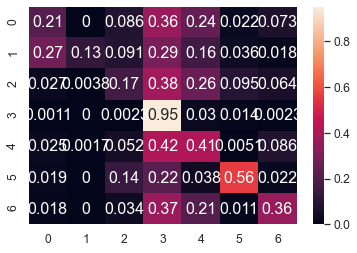

	training epoch=13 .. train_loss=1.173
	validation epoch=13 .. val_loss=1.386
	Accuracy = 48.5 % .. Percision = 55.2 % .. Recall = 40.0 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_13.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 14 .. loss = 1.265


  0%|                                                                                 | 1/1914 [00:01<47:04,  1.48s/it]

training @ epoch 14 .. loss = 1.005


  0%|                                                                                 | 2/1914 [00:02<46:56,  1.47s/it]

training @ epoch 14 .. loss = 1.211


  0%|▏                                                                                | 3/1914 [00:04<47:33,  1.49s/it]

training @ epoch 14 .. loss = 0.881


  0%|▏                                                                                | 4/1914 [00:06<47:47,  1.50s/it]

training @ epoch 14 .. loss = 1.232


  0%|▏                                                                                | 5/1914 [00:07<48:46,  1.53s/it]

training @ epoch 14 .. loss = 0.886


  0%|▎                                                                                | 6/1914 [00:09<48:12,  1.52s/it]

training @ epoch 14 .. loss = 0.789


  0%|▎                                                                                | 7/1914 [00:10<47:47,  1.50s/it]

training @ epoch 14 .. loss = 0.811


  0%|▎                                                                                | 8/1914 [00:12<47:30,  1.50s/it]

training @ epoch 14 .. loss = 0.991


  0%|▍                                                                                | 9/1914 [00:13<47:28,  1.50s/it]

training @ epoch 14 .. loss = 1.113


  1%|▍                                                                               | 10/1914 [00:14<46:52,  1.48s/it]

training @ epoch 14 .. loss = 1.437


  1%|▍                                                                               | 11/1914 [00:16<46:55,  1.48s/it]

training @ epoch 14 .. loss = 1.16


  1%|▌                                                                               | 12/1914 [00:17<46:23,  1.46s/it]

training @ epoch 14 .. loss = 0.602


  1%|▌                                                                               | 13/1914 [00:19<46:31,  1.47s/it]

training @ epoch 14 .. loss = 1.41


  1%|▌                                                                               | 14/1914 [00:20<46:19,  1.46s/it]

training @ epoch 14 .. loss = 0.848


  1%|▋                                                                               | 15/1914 [00:22<46:39,  1.47s/it]

training @ epoch 14 .. loss = 0.867


  1%|▋                                                                               | 16/1914 [00:23<46:22,  1.47s/it]

training @ epoch 14 .. loss = 1.22


  1%|▋                                                                               | 17/1914 [00:25<47:15,  1.49s/it]

training @ epoch 14 .. loss = 1.456


  1%|▊                                                                               | 18/1914 [00:26<46:25,  1.47s/it]

training @ epoch 14 .. loss = 1.042


  1%|▊                                                                               | 19/1914 [00:28<44:50,  1.42s/it]

training @ epoch 14 .. loss = 0.954


  1%|▊                                                                               | 20/1914 [00:29<44:35,  1.41s/it]

training @ epoch 14 .. loss = 1.732


  1%|▉                                                                               | 21/1914 [00:30<43:49,  1.39s/it]

training @ epoch 14 .. loss = 0.862


  1%|▉                                                                               | 22/1914 [00:32<42:54,  1.36s/it]

training @ epoch 14 .. loss = 1.207


  1%|▉                                                                               | 23/1914 [00:33<42:14,  1.34s/it]

training @ epoch 14 .. loss = 1.093


  1%|█                                                                               | 24/1914 [00:34<41:58,  1.33s/it]

training @ epoch 14 .. loss = 1.285


  1%|█                                                                               | 25/1914 [00:35<41:51,  1.33s/it]

training @ epoch 14 .. loss = 0.969


  1%|█                                                                               | 26/1914 [00:37<40:56,  1.30s/it]

training @ epoch 14 .. loss = 1.548


  1%|█▏                                                                              | 27/1914 [00:38<42:35,  1.35s/it]

training @ epoch 14 .. loss = 0.994


  1%|█▏                                                                              | 28/1914 [00:40<42:22,  1.35s/it]

training @ epoch 14 .. loss = 0.941


  2%|█▏                                                                              | 29/1914 [00:41<43:38,  1.39s/it]

training @ epoch 14 .. loss = 0.915


  2%|█▎                                                                              | 30/1914 [00:42<42:53,  1.37s/it]

training @ epoch 14 .. loss = 1.201


  2%|█▎                                                                              | 31/1914 [00:44<42:23,  1.35s/it]

training @ epoch 14 .. loss = 1.066


  2%|█▎                                                                              | 32/1914 [00:45<40:57,  1.31s/it]

training @ epoch 14 .. loss = 1.936


  2%|█▍                                                                              | 33/1914 [00:46<40:21,  1.29s/it]

training @ epoch 14 .. loss = 1.201


  2%|█▍                                                                              | 34/1914 [00:47<39:54,  1.27s/it]

training @ epoch 14 .. loss = 1.016


  2%|█▍                                                                              | 35/1914 [00:49<39:17,  1.25s/it]

training @ epoch 14 .. loss = 1.328


  2%|█▌                                                                              | 36/1914 [00:50<39:04,  1.25s/it]

training @ epoch 14 .. loss = 1.342


  2%|█▌                                                                              | 37/1914 [00:51<38:29,  1.23s/it]

training @ epoch 14 .. loss = 0.626


  2%|█▌                                                                              | 38/1914 [00:52<38:18,  1.23s/it]

training @ epoch 14 .. loss = 1.031


  2%|█▋                                                                              | 39/1914 [00:53<38:21,  1.23s/it]

training @ epoch 14 .. loss = 1.04


  2%|█▋                                                                              | 40/1914 [00:55<38:11,  1.22s/it]

training @ epoch 14 .. loss = 0.891


  2%|█▋                                                                              | 41/1914 [00:56<38:10,  1.22s/it]

training @ epoch 14 .. loss = 0.973


  2%|█▊                                                                              | 42/1914 [00:57<38:29,  1.23s/it]

training @ epoch 14 .. loss = 1.0


  2%|█▊                                                                              | 43/1914 [00:58<38:34,  1.24s/it]

training @ epoch 14 .. loss = 1.046


  2%|█▊                                                                              | 44/1914 [01:00<38:12,  1.23s/it]

training @ epoch 14 .. loss = 1.213


  2%|█▉                                                                              | 45/1914 [01:01<37:58,  1.22s/it]

training @ epoch 14 .. loss = 1.167


  2%|█▉                                                                              | 46/1914 [01:02<37:57,  1.22s/it]

training @ epoch 14 .. loss = 1.46


  2%|█▉                                                                              | 47/1914 [01:03<38:04,  1.22s/it]

training @ epoch 14 .. loss = 0.817


  3%|██                                                                              | 48/1914 [01:04<37:44,  1.21s/it]

training @ epoch 14 .. loss = 1.133


  3%|██                                                                              | 49/1914 [01:06<37:46,  1.22s/it]

training @ epoch 14 .. loss = 1.08


  3%|██                                                                              | 50/1914 [01:07<37:47,  1.22s/it]

training @ epoch 14 .. loss = 1.023


  3%|██▏                                                                             | 51/1914 [01:08<37:37,  1.21s/it]

training @ epoch 14 .. loss = 1.092


  3%|██▏                                                                             | 52/1914 [01:09<37:58,  1.22s/it]

training @ epoch 14 .. loss = 1.176


  3%|██▏                                                                             | 53/1914 [01:10<37:39,  1.21s/it]

training @ epoch 14 .. loss = 1.563


  3%|██▎                                                                             | 54/1914 [01:12<37:54,  1.22s/it]

training @ epoch 14 .. loss = 1.673


  3%|██▎                                                                             | 55/1914 [01:13<37:59,  1.23s/it]

training @ epoch 14 .. loss = 1.574


  3%|██▎                                                                             | 56/1914 [01:14<37:54,  1.22s/it]

training @ epoch 14 .. loss = 1.557


  3%|██▍                                                                             | 57/1914 [01:15<37:52,  1.22s/it]

training @ epoch 14 .. loss = 1.023


  3%|██▍                                                                             | 58/1914 [01:17<37:15,  1.20s/it]

training @ epoch 14 .. loss = 0.603


  3%|██▍                                                                             | 59/1914 [01:18<37:41,  1.22s/it]

training @ epoch 14 .. loss = 0.824


  3%|██▌                                                                             | 60/1914 [01:19<37:42,  1.22s/it]

training @ epoch 14 .. loss = 1.18


  3%|██▌                                                                             | 61/1914 [01:20<37:42,  1.22s/it]

training @ epoch 14 .. loss = 1.113


  3%|██▌                                                                             | 62/1914 [01:21<37:35,  1.22s/it]

training @ epoch 14 .. loss = 1.436


  3%|██▋                                                                             | 63/1914 [01:23<37:31,  1.22s/it]

training @ epoch 14 .. loss = 1.504


  3%|██▋                                                                             | 64/1914 [01:24<37:55,  1.23s/it]

training @ epoch 14 .. loss = 1.215


  3%|██▋                                                                             | 65/1914 [01:25<37:45,  1.23s/it]

training @ epoch 14 .. loss = 0.733


  3%|██▊                                                                             | 66/1914 [01:26<37:31,  1.22s/it]

training @ epoch 14 .. loss = 1.217


  4%|██▊                                                                             | 67/1914 [01:28<37:32,  1.22s/it]

training @ epoch 14 .. loss = 1.232


  4%|██▊                                                                             | 68/1914 [01:29<38:06,  1.24s/it]

training @ epoch 14 .. loss = 0.907


  4%|██▉                                                                             | 69/1914 [01:30<37:39,  1.22s/it]

training @ epoch 14 .. loss = 1.348


  4%|██▉                                                                             | 70/1914 [01:31<37:52,  1.23s/it]

training @ epoch 14 .. loss = 1.504


  4%|██▉                                                                             | 71/1914 [01:32<37:02,  1.21s/it]

training @ epoch 14 .. loss = 1.313


  4%|███                                                                             | 72/1914 [01:34<37:10,  1.21s/it]

training @ epoch 14 .. loss = 1.869


  4%|███                                                                             | 73/1914 [01:35<36:58,  1.21s/it]

training @ epoch 14 .. loss = 0.938


  4%|███                                                                             | 74/1914 [01:36<37:12,  1.21s/it]

training @ epoch 14 .. loss = 1.03


  4%|███▏                                                                            | 75/1914 [01:37<37:21,  1.22s/it]

training @ epoch 14 .. loss = 0.811


  4%|███▏                                                                            | 76/1914 [01:38<36:54,  1.21s/it]

training @ epoch 14 .. loss = 1.182


  4%|███▏                                                                            | 77/1914 [01:40<37:42,  1.23s/it]

training @ epoch 14 .. loss = 0.786


  4%|███▎                                                                            | 78/1914 [01:41<37:29,  1.23s/it]

training @ epoch 14 .. loss = 0.786


  4%|███▎                                                                            | 79/1914 [01:42<37:41,  1.23s/it]

training @ epoch 14 .. loss = 1.002


  4%|███▎                                                                            | 80/1914 [01:43<37:35,  1.23s/it]

training @ epoch 14 .. loss = 1.246


  4%|███▍                                                                            | 81/1914 [01:45<37:17,  1.22s/it]

training @ epoch 14 .. loss = 1.095


  4%|███▍                                                                            | 82/1914 [01:46<37:29,  1.23s/it]

training @ epoch 14 .. loss = 1.088


  4%|███▍                                                                            | 83/1914 [01:47<37:30,  1.23s/it]

training @ epoch 14 .. loss = 1.41


  4%|███▌                                                                            | 84/1914 [01:48<37:37,  1.23s/it]

training @ epoch 14 .. loss = 1.307


  4%|███▌                                                                            | 85/1914 [01:50<37:46,  1.24s/it]

training @ epoch 14 .. loss = 0.685


  4%|███▌                                                                            | 86/1914 [01:51<37:23,  1.23s/it]

training @ epoch 14 .. loss = 1.236


  5%|███▋                                                                            | 87/1914 [01:52<37:19,  1.23s/it]

training @ epoch 14 .. loss = 1.658


  5%|███▋                                                                            | 88/1914 [01:53<37:43,  1.24s/it]

training @ epoch 14 .. loss = 1.201


  5%|███▋                                                                            | 89/1914 [01:55<37:31,  1.23s/it]

training @ epoch 14 .. loss = 1.874


  5%|███▊                                                                            | 90/1914 [01:56<37:22,  1.23s/it]

training @ epoch 14 .. loss = 1.231


  5%|███▊                                                                            | 91/1914 [01:57<37:11,  1.22s/it]

training @ epoch 14 .. loss = 1.232


  5%|███▊                                                                            | 92/1914 [01:58<37:08,  1.22s/it]

training @ epoch 14 .. loss = 1.045


  5%|███▉                                                                            | 93/1914 [01:59<37:12,  1.23s/it]

training @ epoch 14 .. loss = 1.254


  5%|███▉                                                                            | 94/1914 [02:01<36:40,  1.21s/it]

training @ epoch 14 .. loss = 1.224


  5%|███▉                                                                            | 95/1914 [02:02<36:52,  1.22s/it]

training @ epoch 14 .. loss = 1.067


  5%|████                                                                            | 96/1914 [02:03<36:35,  1.21s/it]

training @ epoch 14 .. loss = 1.28


  5%|████                                                                            | 97/1914 [02:04<36:47,  1.22s/it]

training @ epoch 14 .. loss = 1.278


  5%|████                                                                            | 98/1914 [02:05<36:45,  1.21s/it]

training @ epoch 14 .. loss = 1.016


  5%|████▏                                                                           | 99/1914 [02:07<37:25,  1.24s/it]

training @ epoch 14 .. loss = 1.053


  5%|████▏                                                                          | 100/1914 [02:08<37:21,  1.24s/it]

training @ epoch 14 .. loss = 0.848


  5%|████▏                                                                          | 101/1914 [02:09<37:14,  1.23s/it]

training @ epoch 14 .. loss = 1.206


  5%|████▏                                                                          | 102/1914 [02:10<36:37,  1.21s/it]

training @ epoch 14 .. loss = 1.441


  5%|████▎                                                                          | 103/1914 [02:12<36:53,  1.22s/it]

training @ epoch 14 .. loss = 1.189


  5%|████▎                                                                          | 104/1914 [02:13<36:40,  1.22s/it]

training @ epoch 14 .. loss = 1.427


  5%|████▎                                                                          | 105/1914 [02:14<36:38,  1.22s/it]

training @ epoch 14 .. loss = 1.213


  6%|████▍                                                                          | 106/1914 [02:15<36:46,  1.22s/it]

training @ epoch 14 .. loss = 1.763


  6%|████▍                                                                          | 107/1914 [02:16<36:23,  1.21s/it]

training @ epoch 14 .. loss = 1.379


  6%|████▍                                                                          | 108/1914 [02:18<37:08,  1.23s/it]

training @ epoch 14 .. loss = 1.108


  6%|████▍                                                                          | 109/1914 [02:19<37:09,  1.23s/it]

training @ epoch 14 .. loss = 1.162


  6%|████▌                                                                          | 110/1914 [02:20<37:20,  1.24s/it]

training @ epoch 14 .. loss = 1.19


  6%|████▌                                                                          | 111/1914 [02:21<37:14,  1.24s/it]

training @ epoch 14 .. loss = 1.488


  6%|████▌                                                                          | 112/1914 [02:23<36:58,  1.23s/it]

training @ epoch 14 .. loss = 0.947


  6%|████▋                                                                          | 113/1914 [02:24<36:52,  1.23s/it]

training @ epoch 14 .. loss = 1.149


  6%|████▋                                                                          | 114/1914 [02:25<36:48,  1.23s/it]

training @ epoch 14 .. loss = 1.148


  6%|████▋                                                                          | 115/1914 [02:26<36:37,  1.22s/it]

training @ epoch 14 .. loss = 1.378


  6%|████▊                                                                          | 116/1914 [02:28<36:37,  1.22s/it]

training @ epoch 14 .. loss = 1.242


  6%|████▊                                                                          | 117/1914 [02:29<36:41,  1.23s/it]

training @ epoch 14 .. loss = 1.223


  6%|████▊                                                                          | 118/1914 [02:30<36:55,  1.23s/it]

training @ epoch 14 .. loss = 0.932


  6%|████▉                                                                          | 119/1914 [02:31<36:48,  1.23s/it]

training @ epoch 14 .. loss = 1.033


  6%|████▉                                                                          | 120/1914 [02:32<36:21,  1.22s/it]

training @ epoch 14 .. loss = 1.004


  6%|████▉                                                                          | 121/1914 [02:34<36:23,  1.22s/it]

training @ epoch 14 .. loss = 0.855


  6%|█████                                                                          | 122/1914 [02:35<36:44,  1.23s/it]

training @ epoch 14 .. loss = 1.261


  6%|█████                                                                          | 123/1914 [02:36<36:32,  1.22s/it]

training @ epoch 14 .. loss = 0.904


  6%|█████                                                                          | 124/1914 [02:37<36:30,  1.22s/it]

training @ epoch 14 .. loss = 1.129


  7%|█████▏                                                                         | 125/1914 [02:39<36:05,  1.21s/it]

training @ epoch 14 .. loss = 1.461


  7%|█████▏                                                                         | 126/1914 [02:40<36:22,  1.22s/it]

training @ epoch 14 .. loss = 0.974


  7%|█████▏                                                                         | 127/1914 [02:41<36:11,  1.21s/it]

training @ epoch 14 .. loss = 0.833


  7%|█████▎                                                                         | 128/1914 [02:42<36:14,  1.22s/it]

training @ epoch 14 .. loss = 1.207


  7%|█████▎                                                                         | 129/1914 [02:43<36:32,  1.23s/it]

training @ epoch 14 .. loss = 0.929


  7%|█████▎                                                                         | 130/1914 [02:45<36:15,  1.22s/it]

training @ epoch 14 .. loss = 1.728


  7%|█████▍                                                                         | 131/1914 [02:46<36:31,  1.23s/it]

training @ epoch 14 .. loss = 1.578


  7%|█████▍                                                                         | 132/1914 [02:47<36:27,  1.23s/it]

training @ epoch 14 .. loss = 0.991


  7%|█████▍                                                                         | 133/1914 [02:48<36:13,  1.22s/it]

training @ epoch 14 .. loss = 1.141


  7%|█████▌                                                                         | 134/1914 [02:50<36:07,  1.22s/it]

training @ epoch 14 .. loss = 1.372


  7%|█████▌                                                                         | 135/1914 [02:51<35:52,  1.21s/it]

training @ epoch 14 .. loss = 1.227


  7%|█████▌                                                                         | 136/1914 [02:52<36:02,  1.22s/it]

training @ epoch 14 .. loss = 0.682


  7%|█████▋                                                                         | 137/1914 [02:53<36:31,  1.23s/it]

training @ epoch 14 .. loss = 1.03


  7%|█████▋                                                                         | 138/1914 [02:54<35:47,  1.21s/it]

training @ epoch 14 .. loss = 1.801


  7%|█████▋                                                                         | 139/1914 [02:56<36:25,  1.23s/it]

training @ epoch 14 .. loss = 1.026


  7%|█████▊                                                                         | 140/1914 [02:57<36:07,  1.22s/it]

training @ epoch 14 .. loss = 1.173


  7%|█████▊                                                                         | 141/1914 [02:58<36:06,  1.22s/it]

training @ epoch 14 .. loss = 0.636


  7%|█████▊                                                                         | 142/1914 [02:59<36:26,  1.23s/it]

training @ epoch 14 .. loss = 0.989


  7%|█████▉                                                                         | 143/1914 [03:01<35:48,  1.21s/it]

training @ epoch 14 .. loss = 1.089


  8%|█████▉                                                                         | 144/1914 [03:02<36:18,  1.23s/it]

training @ epoch 14 .. loss = 0.852


  8%|█████▉                                                                         | 145/1914 [03:03<36:12,  1.23s/it]

training @ epoch 14 .. loss = 1.17


  8%|██████                                                                         | 146/1914 [03:04<36:14,  1.23s/it]

training @ epoch 14 .. loss = 1.316


  8%|██████                                                                         | 147/1914 [03:06<36:06,  1.23s/it]

training @ epoch 14 .. loss = 1.419


  8%|██████                                                                         | 148/1914 [03:07<35:59,  1.22s/it]

training @ epoch 14 .. loss = 1.845


  8%|██████▏                                                                        | 149/1914 [03:08<35:57,  1.22s/it]

training @ epoch 14 .. loss = 1.054


  8%|██████▏                                                                        | 150/1914 [03:09<36:02,  1.23s/it]

training @ epoch 14 .. loss = 1.336


  8%|██████▏                                                                        | 151/1914 [03:10<35:58,  1.22s/it]

training @ epoch 14 .. loss = 1.123


  8%|██████▎                                                                        | 152/1914 [03:12<36:02,  1.23s/it]

training @ epoch 14 .. loss = 1.048


  8%|██████▎                                                                        | 153/1914 [03:13<35:58,  1.23s/it]

training @ epoch 14 .. loss = 1.043


  8%|██████▎                                                                        | 154/1914 [03:14<36:00,  1.23s/it]

training @ epoch 14 .. loss = 1.353


  8%|██████▍                                                                        | 155/1914 [03:15<36:01,  1.23s/it]

training @ epoch 14 .. loss = 1.391


  8%|██████▍                                                                        | 156/1914 [03:16<35:29,  1.21s/it]

training @ epoch 14 .. loss = 1.068


  8%|██████▍                                                                        | 157/1914 [03:18<35:49,  1.22s/it]

training @ epoch 14 .. loss = 1.281


  8%|██████▌                                                                        | 158/1914 [03:19<35:42,  1.22s/it]

training @ epoch 14 .. loss = 0.987


  8%|██████▌                                                                        | 159/1914 [03:20<35:48,  1.22s/it]

training @ epoch 14 .. loss = 1.147


  8%|██████▌                                                                        | 160/1914 [03:21<35:41,  1.22s/it]

training @ epoch 14 .. loss = 0.908


  8%|██████▋                                                                        | 161/1914 [03:23<35:15,  1.21s/it]

training @ epoch 14 .. loss = 1.158


  8%|██████▋                                                                        | 162/1914 [03:24<35:28,  1.21s/it]

training @ epoch 14 .. loss = 1.221


  9%|██████▋                                                                        | 163/1914 [03:25<35:30,  1.22s/it]

training @ epoch 14 .. loss = 0.998


  9%|██████▊                                                                        | 164/1914 [03:26<35:54,  1.23s/it]

training @ epoch 14 .. loss = 1.092


  9%|██████▊                                                                        | 165/1914 [03:27<35:42,  1.22s/it]

training @ epoch 14 .. loss = 1.446


  9%|██████▊                                                                        | 166/1914 [03:29<35:55,  1.23s/it]

training @ epoch 14 .. loss = 1.057


  9%|██████▉                                                                        | 167/1914 [03:30<35:57,  1.24s/it]

training @ epoch 14 .. loss = 1.202


  9%|██████▉                                                                        | 168/1914 [03:31<35:55,  1.23s/it]

training @ epoch 14 .. loss = 1.286


  9%|██████▉                                                                        | 169/1914 [03:32<35:37,  1.22s/it]

training @ epoch 14 .. loss = 1.065


  9%|███████                                                                        | 170/1914 [03:34<35:45,  1.23s/it]

training @ epoch 14 .. loss = 0.846


  9%|███████                                                                        | 171/1914 [03:35<35:19,  1.22s/it]

training @ epoch 14 .. loss = 1.373


  9%|███████                                                                        | 172/1914 [03:36<35:41,  1.23s/it]

training @ epoch 14 .. loss = 1.307


  9%|███████▏                                                                       | 173/1914 [03:37<35:37,  1.23s/it]

training @ epoch 14 .. loss = 0.785


  9%|███████▏                                                                       | 174/1914 [03:38<35:01,  1.21s/it]

training @ epoch 14 .. loss = 0.636


  9%|███████▏                                                                       | 175/1914 [03:40<35:03,  1.21s/it]

training @ epoch 14 .. loss = 0.999


  9%|███████▎                                                                       | 176/1914 [03:41<35:03,  1.21s/it]

training @ epoch 14 .. loss = 1.07


  9%|███████▎                                                                       | 177/1914 [03:42<35:19,  1.22s/it]

training @ epoch 14 .. loss = 1.036


  9%|███████▎                                                                       | 178/1914 [03:43<35:40,  1.23s/it]

training @ epoch 14 .. loss = 0.985


  9%|███████▍                                                                       | 179/1914 [03:45<35:17,  1.22s/it]

training @ epoch 14 .. loss = 1.069


  9%|███████▍                                                                       | 180/1914 [03:46<35:43,  1.24s/it]

training @ epoch 14 .. loss = 1.103


  9%|███████▍                                                                       | 181/1914 [03:47<35:19,  1.22s/it]

training @ epoch 14 .. loss = 1.014


 10%|███████▌                                                                       | 182/1914 [03:48<35:12,  1.22s/it]

training @ epoch 14 .. loss = 0.688


 10%|███████▌                                                                       | 183/1914 [03:49<35:01,  1.21s/it]

training @ epoch 14 .. loss = 1.182


 10%|███████▌                                                                       | 184/1914 [03:51<34:59,  1.21s/it]

training @ epoch 14 .. loss = 0.905


 10%|███████▋                                                                       | 185/1914 [03:52<35:08,  1.22s/it]

training @ epoch 14 .. loss = 0.964


 10%|███████▋                                                                       | 186/1914 [03:53<34:51,  1.21s/it]

training @ epoch 14 .. loss = 1.622


 10%|███████▋                                                                       | 187/1914 [03:54<34:58,  1.21s/it]

training @ epoch 14 .. loss = 1.644


 10%|███████▊                                                                       | 188/1914 [03:56<34:45,  1.21s/it]

training @ epoch 14 .. loss = 0.829


 10%|███████▊                                                                       | 189/1914 [03:57<34:40,  1.21s/it]

training @ epoch 14 .. loss = 1.149


 10%|███████▊                                                                       | 190/1914 [03:58<35:01,  1.22s/it]

training @ epoch 14 .. loss = 1.256


 10%|███████▉                                                                       | 191/1914 [03:59<35:07,  1.22s/it]

training @ epoch 14 .. loss = 1.659


 10%|███████▉                                                                       | 192/1914 [04:00<35:11,  1.23s/it]

training @ epoch 14 .. loss = 1.205


 10%|███████▉                                                                       | 193/1914 [04:02<35:23,  1.23s/it]

training @ epoch 14 .. loss = 1.13


 10%|████████                                                                       | 194/1914 [04:03<35:15,  1.23s/it]

training @ epoch 14 .. loss = 0.884


 10%|████████                                                                       | 195/1914 [04:04<35:12,  1.23s/it]

training @ epoch 14 .. loss = 1.197


 10%|████████                                                                       | 196/1914 [04:05<35:13,  1.23s/it]

training @ epoch 14 .. loss = 1.042


 10%|████████▏                                                                      | 197/1914 [04:07<34:40,  1.21s/it]

training @ epoch 14 .. loss = 1.445


 10%|████████▏                                                                      | 198/1914 [04:08<35:06,  1.23s/it]

training @ epoch 14 .. loss = 1.423


 10%|████████▏                                                                      | 199/1914 [04:09<34:52,  1.22s/it]

training @ epoch 14 .. loss = 1.592


 10%|████████▎                                                                      | 200/1914 [04:10<35:07,  1.23s/it]

training @ epoch 14 .. loss = 0.978


 11%|████████▎                                                                      | 201/1914 [04:12<35:07,  1.23s/it]

training @ epoch 14 .. loss = 0.794


 11%|████████▎                                                                      | 202/1914 [04:13<34:49,  1.22s/it]

training @ epoch 14 .. loss = 0.829


 11%|████████▍                                                                      | 203/1914 [04:14<34:56,  1.23s/it]

training @ epoch 14 .. loss = 1.198


 11%|████████▍                                                                      | 204/1914 [04:15<34:48,  1.22s/it]

training @ epoch 14 .. loss = 1.036


 11%|████████▍                                                                      | 205/1914 [04:16<34:36,  1.22s/it]

training @ epoch 14 .. loss = 1.593


 11%|████████▌                                                                      | 206/1914 [04:18<34:45,  1.22s/it]

training @ epoch 14 .. loss = 1.162


 11%|████████▌                                                                      | 207/1914 [04:19<34:38,  1.22s/it]

training @ epoch 14 .. loss = 0.751


 11%|████████▌                                                                      | 208/1914 [04:20<34:39,  1.22s/it]

training @ epoch 14 .. loss = 0.895


 11%|████████▋                                                                      | 209/1914 [04:21<35:05,  1.24s/it]

training @ epoch 14 .. loss = 1.688


 11%|████████▋                                                                      | 210/1914 [04:22<34:32,  1.22s/it]

training @ epoch 14 .. loss = 1.323


 11%|████████▋                                                                      | 211/1914 [04:24<34:43,  1.22s/it]

training @ epoch 14 .. loss = 1.578


 11%|████████▊                                                                      | 212/1914 [04:25<34:42,  1.22s/it]

training @ epoch 14 .. loss = 0.566


 11%|████████▊                                                                      | 213/1914 [04:26<34:45,  1.23s/it]

training @ epoch 14 .. loss = 1.502


 11%|████████▊                                                                      | 214/1914 [04:27<34:48,  1.23s/it]

training @ epoch 14 .. loss = 0.928


 11%|████████▊                                                                      | 215/1914 [04:29<34:34,  1.22s/it]

training @ epoch 14 .. loss = 0.609


 11%|████████▉                                                                      | 216/1914 [04:30<34:36,  1.22s/it]

training @ epoch 14 .. loss = 1.082


 11%|████████▉                                                                      | 217/1914 [04:31<34:39,  1.23s/it]

training @ epoch 14 .. loss = 0.771


 11%|████████▉                                                                      | 218/1914 [04:32<34:27,  1.22s/it]

training @ epoch 14 .. loss = 1.104


 11%|█████████                                                                      | 219/1914 [04:33<34:22,  1.22s/it]

training @ epoch 14 .. loss = 1.293


 11%|█████████                                                                      | 220/1914 [04:35<34:03,  1.21s/it]

training @ epoch 14 .. loss = 1.149


 12%|█████████                                                                      | 221/1914 [04:36<34:33,  1.22s/it]

training @ epoch 14 .. loss = 1.176


 12%|█████████▏                                                                     | 222/1914 [04:37<34:48,  1.23s/it]

training @ epoch 14 .. loss = 0.749


 12%|█████████▏                                                                     | 223/1914 [04:38<34:24,  1.22s/it]

training @ epoch 14 .. loss = 0.901


 12%|█████████▏                                                                     | 224/1914 [04:40<34:19,  1.22s/it]

training @ epoch 14 .. loss = 0.814


 12%|█████████▎                                                                     | 225/1914 [04:41<34:00,  1.21s/it]

training @ epoch 14 .. loss = 1.057


 12%|█████████▎                                                                     | 226/1914 [04:42<34:16,  1.22s/it]

training @ epoch 14 .. loss = 0.737


 12%|█████████▎                                                                     | 227/1914 [04:43<34:16,  1.22s/it]

training @ epoch 14 .. loss = 1.27


 12%|█████████▍                                                                     | 228/1914 [04:44<34:07,  1.21s/it]

training @ epoch 14 .. loss = 1.218


 12%|█████████▍                                                                     | 229/1914 [04:46<34:24,  1.22s/it]

training @ epoch 14 .. loss = 1.337


 12%|█████████▍                                                                     | 230/1914 [04:47<34:14,  1.22s/it]

training @ epoch 14 .. loss = 1.666


 12%|█████████▌                                                                     | 231/1914 [04:48<34:15,  1.22s/it]

training @ epoch 14 .. loss = 0.898


 12%|█████████▌                                                                     | 232/1914 [04:49<34:28,  1.23s/it]

training @ epoch 14 .. loss = 1.079


 12%|█████████▌                                                                     | 233/1914 [04:51<34:13,  1.22s/it]

training @ epoch 14 .. loss = 0.734


 12%|█████████▋                                                                     | 234/1914 [04:52<34:03,  1.22s/it]

training @ epoch 14 .. loss = 1.171


 12%|█████████▋                                                                     | 235/1914 [04:53<34:00,  1.22s/it]

training @ epoch 14 .. loss = 1.262


 12%|█████████▋                                                                     | 236/1914 [04:54<33:56,  1.21s/it]

training @ epoch 14 .. loss = 1.207


 12%|█████████▊                                                                     | 237/1914 [04:55<34:19,  1.23s/it]

training @ epoch 14 .. loss = 1.802


 12%|█████████▊                                                                     | 238/1914 [04:57<34:04,  1.22s/it]

training @ epoch 14 .. loss = 1.028


 12%|█████████▊                                                                     | 239/1914 [04:58<34:20,  1.23s/it]

training @ epoch 14 .. loss = 1.385


 13%|█████████▉                                                                     | 240/1914 [04:59<33:48,  1.21s/it]

training @ epoch 14 .. loss = 0.961


 13%|█████████▉                                                                     | 241/1914 [05:00<33:47,  1.21s/it]

training @ epoch 14 .. loss = 0.92


 13%|█████████▉                                                                     | 242/1914 [05:02<33:47,  1.21s/it]

training @ epoch 14 .. loss = 1.084


 13%|██████████                                                                     | 243/1914 [05:03<34:06,  1.22s/it]

training @ epoch 14 .. loss = 1.61


 13%|██████████                                                                     | 244/1914 [05:04<34:02,  1.22s/it]

training @ epoch 14 .. loss = 1.497


 13%|██████████                                                                     | 245/1914 [05:05<34:01,  1.22s/it]

training @ epoch 14 .. loss = 1.527


 13%|██████████▏                                                                    | 246/1914 [05:06<34:09,  1.23s/it]

training @ epoch 14 .. loss = 1.211


 13%|██████████▏                                                                    | 247/1914 [05:08<34:14,  1.23s/it]

training @ epoch 14 .. loss = 1.142


 13%|██████████▏                                                                    | 248/1914 [05:09<34:04,  1.23s/it]

training @ epoch 14 .. loss = 1.302


 13%|██████████▎                                                                    | 249/1914 [05:10<34:11,  1.23s/it]

training @ epoch 14 .. loss = 1.011


 13%|██████████▎                                                                    | 250/1914 [05:11<34:18,  1.24s/it]

training @ epoch 14 .. loss = 1.572


 13%|██████████▎                                                                    | 251/1914 [05:13<33:46,  1.22s/it]

training @ epoch 14 .. loss = 0.894


 13%|██████████▍                                                                    | 252/1914 [05:14<33:52,  1.22s/it]

training @ epoch 14 .. loss = 1.107


 13%|██████████▍                                                                    | 253/1914 [05:15<33:49,  1.22s/it]

training @ epoch 14 .. loss = 1.033


 13%|██████████▍                                                                    | 254/1914 [05:16<33:53,  1.23s/it]

training @ epoch 14 .. loss = 1.004


 13%|██████████▌                                                                    | 255/1914 [05:18<34:01,  1.23s/it]

training @ epoch 14 .. loss = 1.255


 13%|██████████▌                                                                    | 256/1914 [05:19<33:45,  1.22s/it]

training @ epoch 14 .. loss = 0.861


 13%|██████████▌                                                                    | 257/1914 [05:20<33:50,  1.23s/it]

training @ epoch 14 .. loss = 1.23


 13%|██████████▋                                                                    | 258/1914 [05:21<34:08,  1.24s/it]

training @ epoch 14 .. loss = 1.144


 14%|██████████▋                                                                    | 259/1914 [05:22<33:39,  1.22s/it]

training @ epoch 14 .. loss = 1.709


 14%|██████████▋                                                                    | 260/1914 [05:24<33:47,  1.23s/it]

training @ epoch 14 .. loss = 1.032


 14%|██████████▊                                                                    | 261/1914 [05:25<33:40,  1.22s/it]

training @ epoch 14 .. loss = 1.263


 14%|██████████▊                                                                    | 262/1914 [05:26<33:39,  1.22s/it]

training @ epoch 14 .. loss = 0.974


 14%|██████████▊                                                                    | 263/1914 [05:27<33:47,  1.23s/it]

training @ epoch 14 .. loss = 1.419


 14%|██████████▉                                                                    | 264/1914 [05:29<33:48,  1.23s/it]

training @ epoch 14 .. loss = 1.129


 14%|██████████▉                                                                    | 265/1914 [05:30<33:50,  1.23s/it]

training @ epoch 14 .. loss = 1.553


 14%|██████████▉                                                                    | 266/1914 [05:31<33:49,  1.23s/it]

training @ epoch 14 .. loss = 1.341


 14%|███████████                                                                    | 267/1914 [05:32<33:48,  1.23s/it]

training @ epoch 14 .. loss = 2.185


 14%|███████████                                                                    | 268/1914 [05:33<33:38,  1.23s/it]

training @ epoch 14 .. loss = 1.224


 14%|███████████                                                                    | 269/1914 [05:35<33:28,  1.22s/it]

training @ epoch 14 .. loss = 1.419


 14%|███████████▏                                                                   | 270/1914 [05:36<33:33,  1.22s/it]

training @ epoch 14 .. loss = 1.272


 14%|███████████▏                                                                   | 271/1914 [05:37<34:01,  1.24s/it]

training @ epoch 14 .. loss = 1.217


 14%|███████████▏                                                                   | 272/1914 [05:38<33:54,  1.24s/it]

training @ epoch 14 .. loss = 1.123


 14%|███████████▎                                                                   | 273/1914 [05:40<33:46,  1.23s/it]

training @ epoch 14 .. loss = 1.052


 14%|███████████▎                                                                   | 274/1914 [05:41<33:18,  1.22s/it]

training @ epoch 14 .. loss = 1.276


 14%|███████████▎                                                                   | 275/1914 [05:42<33:15,  1.22s/it]

training @ epoch 14 .. loss = 1.704


 14%|███████████▍                                                                   | 276/1914 [05:43<33:26,  1.23s/it]

training @ epoch 14 .. loss = 1.354


 14%|███████████▍                                                                   | 277/1914 [05:44<33:18,  1.22s/it]

training @ epoch 14 .. loss = 1.286


 15%|███████████▍                                                                   | 278/1914 [05:46<33:17,  1.22s/it]

training @ epoch 14 .. loss = 1.19


 15%|███████████▌                                                                   | 279/1914 [05:47<33:22,  1.22s/it]

training @ epoch 14 .. loss = 1.233


 15%|███████████▌                                                                   | 280/1914 [05:48<33:12,  1.22s/it]

training @ epoch 14 .. loss = 1.121


 15%|███████████▌                                                                   | 281/1914 [05:49<33:32,  1.23s/it]

training @ epoch 14 .. loss = 1.416


 15%|███████████▋                                                                   | 282/1914 [05:51<32:53,  1.21s/it]

training @ epoch 14 .. loss = 1.024


 15%|███████████▋                                                                   | 283/1914 [05:52<33:11,  1.22s/it]

training @ epoch 14 .. loss = 1.296


 15%|███████████▋                                                                   | 284/1914 [05:53<32:56,  1.21s/it]

training @ epoch 14 .. loss = 1.6


 15%|███████████▊                                                                   | 285/1914 [05:54<33:04,  1.22s/it]

training @ epoch 14 .. loss = 0.861


 15%|███████████▊                                                                   | 286/1914 [05:55<33:00,  1.22s/it]

training @ epoch 14 .. loss = 1.012


 15%|███████████▊                                                                   | 287/1914 [05:57<33:30,  1.24s/it]

training @ epoch 14 .. loss = 1.209


 15%|███████████▉                                                                   | 288/1914 [05:58<33:24,  1.23s/it]

training @ epoch 14 .. loss = 1.153


 15%|███████████▉                                                                   | 289/1914 [05:59<33:18,  1.23s/it]

training @ epoch 14 .. loss = 1.095


 15%|███████████▉                                                                   | 290/1914 [06:00<32:57,  1.22s/it]

training @ epoch 14 .. loss = 0.843


 15%|████████████                                                                   | 291/1914 [06:02<33:03,  1.22s/it]

training @ epoch 14 .. loss = 2.006


 15%|████████████                                                                   | 292/1914 [06:03<33:15,  1.23s/it]

training @ epoch 14 .. loss = 1.043


 15%|████████████                                                                   | 293/1914 [06:04<32:56,  1.22s/it]

training @ epoch 14 .. loss = 1.356


 15%|████████████▏                                                                  | 294/1914 [06:05<33:05,  1.23s/it]

training @ epoch 14 .. loss = 0.952


 15%|████████████▏                                                                  | 295/1914 [06:06<32:49,  1.22s/it]

training @ epoch 14 .. loss = 0.635


 15%|████████████▏                                                                  | 296/1914 [06:08<33:25,  1.24s/it]

training @ epoch 14 .. loss = 1.233


 16%|████████████▎                                                                  | 297/1914 [06:09<33:22,  1.24s/it]

training @ epoch 14 .. loss = 1.312


 16%|████████████▎                                                                  | 298/1914 [06:10<33:12,  1.23s/it]

training @ epoch 14 .. loss = 1.302


 16%|████████████▎                                                                  | 299/1914 [06:11<33:19,  1.24s/it]

training @ epoch 14 .. loss = 0.975


 16%|████████████▍                                                                  | 300/1914 [06:13<33:10,  1.23s/it]

training @ epoch 14 .. loss = 1.281


 16%|████████████▍                                                                  | 301/1914 [06:14<33:03,  1.23s/it]

training @ epoch 14 .. loss = 1.488


 16%|████████████▍                                                                  | 302/1914 [06:15<33:04,  1.23s/it]

training @ epoch 14 .. loss = 1.139


 16%|████████████▌                                                                  | 303/1914 [06:16<32:44,  1.22s/it]

training @ epoch 14 .. loss = 1.072


 16%|████████████▌                                                                  | 304/1914 [06:18<32:49,  1.22s/it]

training @ epoch 14 .. loss = 0.76


 16%|████████████▌                                                                  | 305/1914 [06:19<32:31,  1.21s/it]

training @ epoch 14 .. loss = 1.262


 16%|████████████▋                                                                  | 306/1914 [06:20<32:45,  1.22s/it]

training @ epoch 14 .. loss = 1.481


 16%|████████████▋                                                                  | 307/1914 [06:21<32:49,  1.23s/it]

training @ epoch 14 .. loss = 1.378


 16%|████████████▋                                                                  | 308/1914 [06:22<32:31,  1.22s/it]

training @ epoch 14 .. loss = 1.276


 16%|████████████▊                                                                  | 309/1914 [06:24<32:43,  1.22s/it]

training @ epoch 14 .. loss = 1.305


 16%|████████████▊                                                                  | 310/1914 [06:25<32:31,  1.22s/it]

training @ epoch 14 .. loss = 1.188


 16%|████████████▊                                                                  | 311/1914 [06:26<32:28,  1.22s/it]

training @ epoch 14 .. loss = 1.221


 16%|████████████▉                                                                  | 312/1914 [06:27<32:49,  1.23s/it]

training @ epoch 14 .. loss = 1.092


 16%|████████████▉                                                                  | 313/1914 [06:29<32:52,  1.23s/it]

training @ epoch 14 .. loss = 1.516


 16%|████████████▉                                                                  | 314/1914 [06:30<32:46,  1.23s/it]

training @ epoch 14 .. loss = 1.112


 16%|█████████████                                                                  | 315/1914 [06:31<32:35,  1.22s/it]

training @ epoch 14 .. loss = 0.74


 17%|█████████████                                                                  | 316/1914 [06:32<32:54,  1.24s/it]

training @ epoch 14 .. loss = 1.376


 17%|█████████████                                                                  | 317/1914 [06:34<32:58,  1.24s/it]

training @ epoch 14 .. loss = 1.192


 17%|█████████████▏                                                                 | 318/1914 [06:35<32:36,  1.23s/it]

training @ epoch 14 .. loss = 1.202


 17%|█████████████▏                                                                 | 319/1914 [06:36<32:38,  1.23s/it]

training @ epoch 14 .. loss = 1.167


 17%|█████████████▏                                                                 | 320/1914 [06:37<32:43,  1.23s/it]

training @ epoch 14 .. loss = 1.349


 17%|█████████████▏                                                                 | 321/1914 [06:38<32:26,  1.22s/it]

training @ epoch 14 .. loss = 1.329


 17%|█████████████▎                                                                 | 322/1914 [06:40<32:29,  1.22s/it]

training @ epoch 14 .. loss = 1.256


 17%|█████████████▎                                                                 | 323/1914 [06:41<32:13,  1.22s/it]

training @ epoch 14 .. loss = 1.179


 17%|█████████████▎                                                                 | 324/1914 [06:42<32:16,  1.22s/it]

training @ epoch 14 .. loss = 0.728


 17%|█████████████▍                                                                 | 325/1914 [06:43<32:17,  1.22s/it]

training @ epoch 14 .. loss = 1.015


 17%|█████████████▍                                                                 | 326/1914 [06:44<31:48,  1.20s/it]

training @ epoch 14 .. loss = 0.914


 17%|█████████████▍                                                                 | 327/1914 [06:46<32:10,  1.22s/it]

training @ epoch 14 .. loss = 1.209


 17%|█████████████▌                                                                 | 328/1914 [06:47<32:15,  1.22s/it]

training @ epoch 14 .. loss = 1.265


 17%|█████████████▌                                                                 | 329/1914 [06:48<32:15,  1.22s/it]

training @ epoch 14 .. loss = 1.07


 17%|█████████████▌                                                                 | 330/1914 [06:49<32:23,  1.23s/it]

training @ epoch 14 .. loss = 1.211


 17%|█████████████▋                                                                 | 331/1914 [06:51<32:15,  1.22s/it]

training @ epoch 14 .. loss = 0.955


 17%|█████████████▋                                                                 | 332/1914 [06:52<32:23,  1.23s/it]

training @ epoch 14 .. loss = 1.222


 17%|█████████████▋                                                                 | 333/1914 [06:53<32:14,  1.22s/it]

training @ epoch 14 .. loss = 0.845


 17%|█████████████▊                                                                 | 334/1914 [06:54<32:31,  1.24s/it]

training @ epoch 14 .. loss = 1.035


 18%|█████████████▊                                                                 | 335/1914 [06:56<32:20,  1.23s/it]

training @ epoch 14 .. loss = 1.137


 18%|█████████████▊                                                                 | 336/1914 [06:57<32:15,  1.23s/it]

training @ epoch 14 .. loss = 0.967


 18%|█████████████▉                                                                 | 337/1914 [06:58<32:08,  1.22s/it]

training @ epoch 14 .. loss = 0.893


 18%|█████████████▉                                                                 | 338/1914 [06:59<32:01,  1.22s/it]

training @ epoch 14 .. loss = 1.312


 18%|█████████████▉                                                                 | 339/1914 [07:00<31:42,  1.21s/it]

training @ epoch 14 .. loss = 1.39


 18%|██████████████                                                                 | 340/1914 [07:02<31:53,  1.22s/it]

training @ epoch 14 .. loss = 1.473


 18%|██████████████                                                                 | 341/1914 [07:03<32:09,  1.23s/it]

training @ epoch 14 .. loss = 1.265


 18%|██████████████                                                                 | 342/1914 [07:04<32:01,  1.22s/it]

training @ epoch 14 .. loss = 0.718


 18%|██████████████▏                                                                | 343/1914 [07:05<32:37,  1.25s/it]

training @ epoch 14 .. loss = 1.485


 18%|██████████████▏                                                                | 344/1914 [07:07<34:18,  1.31s/it]

training @ epoch 14 .. loss = 0.635


 18%|██████████████▏                                                                | 345/1914 [07:08<34:40,  1.33s/it]

training @ epoch 14 .. loss = 1.219


 18%|██████████████▎                                                                | 346/1914 [07:10<34:46,  1.33s/it]

training @ epoch 14 .. loss = 0.537


 18%|██████████████▎                                                                | 347/1914 [07:11<33:48,  1.29s/it]

training @ epoch 14 .. loss = 1.159


 18%|██████████████▎                                                                | 348/1914 [07:12<33:32,  1.29s/it]

training @ epoch 14 .. loss = 0.801


 18%|██████████████▍                                                                | 349/1914 [07:13<33:25,  1.28s/it]

training @ epoch 14 .. loss = 1.598


 18%|██████████████▍                                                                | 350/1914 [07:14<32:43,  1.26s/it]

training @ epoch 14 .. loss = 1.087


 18%|██████████████▍                                                                | 351/1914 [07:16<32:45,  1.26s/it]

training @ epoch 14 .. loss = 0.886


 18%|██████████████▌                                                                | 352/1914 [07:17<32:17,  1.24s/it]

training @ epoch 14 .. loss = 1.14


 18%|██████████████▌                                                                | 353/1914 [07:18<32:32,  1.25s/it]

training @ epoch 14 .. loss = 0.83


 18%|██████████████▌                                                                | 354/1914 [07:19<32:17,  1.24s/it]

training @ epoch 14 .. loss = 1.333


 19%|██████████████▋                                                                | 355/1914 [07:21<31:57,  1.23s/it]

training @ epoch 14 .. loss = 1.228


 19%|██████████████▋                                                                | 356/1914 [07:22<31:48,  1.22s/it]

training @ epoch 14 .. loss = 1.06


 19%|██████████████▋                                                                | 357/1914 [07:23<31:31,  1.21s/it]

training @ epoch 14 .. loss = 0.992


 19%|██████████████▊                                                                | 358/1914 [07:24<31:37,  1.22s/it]

training @ epoch 14 .. loss = 1.011


 19%|██████████████▊                                                                | 359/1914 [07:26<31:52,  1.23s/it]

training @ epoch 14 .. loss = 0.74


 19%|██████████████▊                                                                | 360/1914 [07:27<31:48,  1.23s/it]

training @ epoch 14 .. loss = 1.054


 19%|██████████████▉                                                                | 361/1914 [07:28<31:50,  1.23s/it]

training @ epoch 14 .. loss = 1.206


 19%|██████████████▉                                                                | 362/1914 [07:29<31:58,  1.24s/it]

training @ epoch 14 .. loss = 1.226


 19%|██████████████▉                                                                | 363/1914 [07:30<31:37,  1.22s/it]

training @ epoch 14 .. loss = 1.506


 19%|███████████████                                                                | 364/1914 [07:32<31:40,  1.23s/it]

training @ epoch 14 .. loss = 1.075


 19%|███████████████                                                                | 365/1914 [07:33<32:01,  1.24s/it]

training @ epoch 14 .. loss = 1.612


 19%|███████████████                                                                | 366/1914 [07:34<32:00,  1.24s/it]

training @ epoch 14 .. loss = 1.077


 19%|███████████████▏                                                               | 367/1914 [07:35<31:55,  1.24s/it]

training @ epoch 14 .. loss = 1.104


 19%|███████████████▏                                                               | 368/1914 [07:37<31:27,  1.22s/it]

training @ epoch 14 .. loss = 1.246


 19%|███████████████▏                                                               | 369/1914 [07:38<31:34,  1.23s/it]

training @ epoch 14 .. loss = 0.89


 19%|███████████████▎                                                               | 370/1914 [07:39<31:26,  1.22s/it]

training @ epoch 14 .. loss = 1.019


 19%|███████████████▎                                                               | 371/1914 [07:40<31:30,  1.23s/it]

training @ epoch 14 .. loss = 1.059


 19%|███████████████▎                                                               | 372/1914 [07:41<31:14,  1.22s/it]

training @ epoch 14 .. loss = 0.914


 19%|███████████████▍                                                               | 373/1914 [07:43<31:00,  1.21s/it]

training @ epoch 14 .. loss = 1.094


 20%|███████████████▍                                                               | 374/1914 [07:44<31:25,  1.22s/it]

training @ epoch 14 .. loss = 1.124


 20%|███████████████▍                                                               | 375/1914 [07:45<31:39,  1.23s/it]

training @ epoch 14 .. loss = 1.272


 20%|███████████████▌                                                               | 376/1914 [07:46<31:29,  1.23s/it]

training @ epoch 14 .. loss = 1.011


 20%|███████████████▌                                                               | 377/1914 [07:48<31:44,  1.24s/it]

training @ epoch 14 .. loss = 1.318


 20%|███████████████▌                                                               | 378/1914 [07:49<31:26,  1.23s/it]

training @ epoch 14 .. loss = 1.423


 20%|███████████████▋                                                               | 379/1914 [07:50<31:12,  1.22s/it]

training @ epoch 14 .. loss = 1.037


 20%|███████████████▋                                                               | 380/1914 [07:51<31:16,  1.22s/it]

training @ epoch 14 .. loss = 1.294


 20%|███████████████▋                                                               | 381/1914 [07:52<31:05,  1.22s/it]

training @ epoch 14 .. loss = 1.159


 20%|███████████████▊                                                               | 382/1914 [07:54<31:12,  1.22s/it]

training @ epoch 14 .. loss = 1.26


 20%|███████████████▊                                                               | 383/1914 [07:55<31:01,  1.22s/it]

training @ epoch 14 .. loss = 0.826


 20%|███████████████▊                                                               | 384/1914 [07:56<31:00,  1.22s/it]

training @ epoch 14 .. loss = 0.775


 20%|███████████████▉                                                               | 385/1914 [07:57<31:11,  1.22s/it]

training @ epoch 14 .. loss = 1.945


 20%|███████████████▉                                                               | 386/1914 [07:59<31:03,  1.22s/it]

training @ epoch 14 .. loss = 0.841


 20%|███████████████▉                                                               | 387/1914 [08:00<31:17,  1.23s/it]

training @ epoch 14 .. loss = 1.125


 20%|████████████████                                                               | 388/1914 [08:01<31:25,  1.24s/it]

training @ epoch 14 .. loss = 0.637


 20%|████████████████                                                               | 389/1914 [08:02<31:24,  1.24s/it]

training @ epoch 14 .. loss = 1.479


 20%|████████████████                                                               | 390/1914 [08:04<31:17,  1.23s/it]

training @ epoch 14 .. loss = 0.991


 20%|████████████████▏                                                              | 391/1914 [08:05<31:01,  1.22s/it]

training @ epoch 14 .. loss = 1.92


 20%|████████████████▏                                                              | 392/1914 [08:06<31:02,  1.22s/it]

training @ epoch 14 .. loss = 1.217


 21%|████████████████▏                                                              | 393/1914 [08:07<31:14,  1.23s/it]

training @ epoch 14 .. loss = 1.217


 21%|████████████████▎                                                              | 394/1914 [08:08<30:49,  1.22s/it]

training @ epoch 14 .. loss = 1.559


 21%|████████████████▎                                                              | 395/1914 [08:10<31:05,  1.23s/it]

training @ epoch 14 .. loss = 1.039


 21%|████████████████▎                                                              | 396/1914 [08:11<30:47,  1.22s/it]

training @ epoch 14 .. loss = 1.015


 21%|████████████████▍                                                              | 397/1914 [08:12<30:53,  1.22s/it]

training @ epoch 14 .. loss = 1.413


 21%|████████████████▍                                                              | 398/1914 [08:13<31:10,  1.23s/it]

training @ epoch 14 .. loss = 0.983


 21%|████████████████▍                                                              | 399/1914 [08:15<30:41,  1.22s/it]

training @ epoch 14 .. loss = 1.412


 21%|████████████████▌                                                              | 400/1914 [08:16<31:15,  1.24s/it]

training @ epoch 14 .. loss = 1.183


 21%|████████████████▌                                                              | 401/1914 [08:17<30:58,  1.23s/it]

training @ epoch 14 .. loss = 1.492


 21%|████████████████▌                                                              | 402/1914 [08:18<30:54,  1.23s/it]

training @ epoch 14 .. loss = 1.365


 21%|████████████████▋                                                              | 403/1914 [08:19<30:47,  1.22s/it]

training @ epoch 14 .. loss = 1.125


 21%|████████████████▋                                                              | 404/1914 [08:21<30:50,  1.23s/it]

training @ epoch 14 .. loss = 0.965


 21%|████████████████▋                                                              | 405/1914 [08:22<31:06,  1.24s/it]

training @ epoch 14 .. loss = 1.145


 21%|████████████████▊                                                              | 406/1914 [08:23<31:25,  1.25s/it]

training @ epoch 14 .. loss = 1.188


 21%|████████████████▊                                                              | 407/1914 [08:24<31:06,  1.24s/it]

training @ epoch 14 .. loss = 1.141


 21%|████████████████▊                                                              | 408/1914 [08:26<30:58,  1.23s/it]

training @ epoch 14 .. loss = 1.09


 21%|████████████████▉                                                              | 409/1914 [08:27<30:47,  1.23s/it]

training @ epoch 14 .. loss = 1.843


 21%|████████████████▉                                                              | 410/1914 [08:28<30:57,  1.24s/it]

training @ epoch 14 .. loss = 1.034


 21%|████████████████▉                                                              | 411/1914 [08:29<31:13,  1.25s/it]

training @ epoch 14 .. loss = 1.023


 22%|█████████████████                                                              | 412/1914 [08:31<31:06,  1.24s/it]

training @ epoch 14 .. loss = 1.005


 22%|█████████████████                                                              | 413/1914 [08:32<31:09,  1.25s/it]

training @ epoch 14 .. loss = 1.373


 22%|█████████████████                                                              | 414/1914 [08:33<31:16,  1.25s/it]

training @ epoch 14 .. loss = 0.95


 22%|█████████████████▏                                                             | 415/1914 [08:34<30:48,  1.23s/it]

training @ epoch 14 .. loss = 1.174


 22%|█████████████████▏                                                             | 416/1914 [08:36<30:42,  1.23s/it]

training @ epoch 14 .. loss = 0.744


 22%|█████████████████▏                                                             | 417/1914 [08:37<30:42,  1.23s/it]

training @ epoch 14 .. loss = 0.867


 22%|█████████████████▎                                                             | 418/1914 [08:38<30:46,  1.23s/it]

training @ epoch 14 .. loss = 1.13


 22%|█████████████████▎                                                             | 419/1914 [08:39<30:47,  1.24s/it]

training @ epoch 14 .. loss = 0.715


 22%|█████████████████▎                                                             | 420/1914 [08:40<30:22,  1.22s/it]

training @ epoch 14 .. loss = 0.966


 22%|█████████████████▍                                                             | 421/1914 [08:42<30:36,  1.23s/it]

training @ epoch 14 .. loss = 1.212


 22%|█████████████████▍                                                             | 422/1914 [08:43<30:36,  1.23s/it]

training @ epoch 14 .. loss = 1.785


 22%|█████████████████▍                                                             | 423/1914 [08:44<30:31,  1.23s/it]

training @ epoch 14 .. loss = 0.803


 22%|█████████████████▌                                                             | 424/1914 [08:45<30:31,  1.23s/it]

training @ epoch 14 .. loss = 1.156


 22%|█████████████████▌                                                             | 425/1914 [08:47<30:13,  1.22s/it]

training @ epoch 14 .. loss = 1.183


 22%|█████████████████▌                                                             | 426/1914 [08:48<30:13,  1.22s/it]

training @ epoch 14 .. loss = 1.038


 22%|█████████████████▌                                                             | 427/1914 [08:49<30:23,  1.23s/it]

training @ epoch 14 .. loss = 0.993


 22%|█████████████████▋                                                             | 428/1914 [08:50<30:52,  1.25s/it]

training @ epoch 14 .. loss = 0.999


 22%|█████████████████▋                                                             | 429/1914 [08:52<30:40,  1.24s/it]

training @ epoch 14 .. loss = 0.974


 22%|█████████████████▋                                                             | 430/1914 [08:53<30:24,  1.23s/it]

training @ epoch 14 .. loss = 1.041


 23%|█████████████████▊                                                             | 431/1914 [08:54<30:38,  1.24s/it]

training @ epoch 14 .. loss = 1.454


 23%|█████████████████▊                                                             | 432/1914 [08:55<30:30,  1.23s/it]

training @ epoch 14 .. loss = 1.328


 23%|█████████████████▊                                                             | 433/1914 [08:56<30:09,  1.22s/it]

training @ epoch 14 .. loss = 1.289


 23%|█████████████████▉                                                             | 434/1914 [08:58<30:27,  1.23s/it]

training @ epoch 14 .. loss = 1.593


 23%|█████████████████▉                                                             | 435/1914 [08:59<30:15,  1.23s/it]

training @ epoch 14 .. loss = 1.297


 23%|█████████████████▉                                                             | 436/1914 [09:00<30:16,  1.23s/it]

training @ epoch 14 .. loss = 1.223


 23%|██████████████████                                                             | 437/1914 [09:01<30:21,  1.23s/it]

training @ epoch 14 .. loss = 1.381


 23%|██████████████████                                                             | 438/1914 [09:03<29:57,  1.22s/it]

training @ epoch 14 .. loss = 1.853


 23%|██████████████████                                                             | 439/1914 [09:04<30:11,  1.23s/it]

training @ epoch 14 .. loss = 1.559


 23%|██████████████████▏                                                            | 440/1914 [09:05<29:58,  1.22s/it]

training @ epoch 14 .. loss = 1.266


 23%|██████████████████▏                                                            | 441/1914 [09:06<29:53,  1.22s/it]

training @ epoch 14 .. loss = 1.244


 23%|██████████████████▏                                                            | 442/1914 [09:08<30:11,  1.23s/it]

training @ epoch 14 .. loss = 1.466


 23%|██████████████████▎                                                            | 443/1914 [09:09<29:49,  1.22s/it]

training @ epoch 14 .. loss = 0.978


 23%|██████████████████▎                                                            | 444/1914 [09:10<30:12,  1.23s/it]

training @ epoch 14 .. loss = 1.192


 23%|██████████████████▎                                                            | 445/1914 [09:11<30:15,  1.24s/it]

training @ epoch 14 .. loss = 0.812


 23%|██████████████████▍                                                            | 446/1914 [09:12<30:04,  1.23s/it]

training @ epoch 14 .. loss = 1.192


 23%|██████████████████▍                                                            | 447/1914 [09:14<30:18,  1.24s/it]

training @ epoch 14 .. loss = 0.987


 23%|██████████████████▍                                                            | 448/1914 [09:15<29:56,  1.23s/it]

training @ epoch 14 .. loss = 1.414


 23%|██████████████████▌                                                            | 449/1914 [09:16<30:02,  1.23s/it]

training @ epoch 14 .. loss = 0.887


 24%|██████████████████▌                                                            | 450/1914 [09:17<29:57,  1.23s/it]

training @ epoch 14 .. loss = 0.794


 24%|██████████████████▌                                                            | 451/1914 [09:19<30:02,  1.23s/it]

training @ epoch 14 .. loss = 1.356


 24%|██████████████████▋                                                            | 452/1914 [09:20<30:14,  1.24s/it]

training @ epoch 14 .. loss = 0.977


 24%|██████████████████▋                                                            | 453/1914 [09:21<30:40,  1.26s/it]

training @ epoch 14 .. loss = 0.73


 24%|██████████████████▋                                                            | 454/1914 [09:22<30:09,  1.24s/it]

training @ epoch 14 .. loss = 1.239


 24%|██████████████████▊                                                            | 455/1914 [09:24<30:15,  1.24s/it]

training @ epoch 14 .. loss = 1.014


 24%|██████████████████▊                                                            | 456/1914 [09:25<30:02,  1.24s/it]

training @ epoch 14 .. loss = 1.711


 24%|██████████████████▊                                                            | 457/1914 [09:26<29:56,  1.23s/it]

training @ epoch 14 .. loss = 0.877


 24%|██████████████████▉                                                            | 458/1914 [09:27<29:54,  1.23s/it]

training @ epoch 14 .. loss = 1.155


 24%|██████████████████▉                                                            | 459/1914 [09:28<29:39,  1.22s/it]

training @ epoch 14 .. loss = 0.748


 24%|██████████████████▉                                                            | 460/1914 [09:30<29:51,  1.23s/it]

training @ epoch 14 .. loss = 0.733


 24%|███████████████████                                                            | 461/1914 [09:31<29:41,  1.23s/it]

training @ epoch 14 .. loss = 1.088


 24%|███████████████████                                                            | 462/1914 [09:32<29:38,  1.23s/it]

training @ epoch 14 .. loss = 0.833


 24%|███████████████████                                                            | 463/1914 [09:33<29:49,  1.23s/it]

training @ epoch 14 .. loss = 1.065


 24%|███████████████████▏                                                           | 464/1914 [09:35<30:27,  1.26s/it]

training @ epoch 14 .. loss = 1.553


 24%|███████████████████▏                                                           | 465/1914 [09:36<30:26,  1.26s/it]

training @ epoch 14 .. loss = 1.133


 24%|███████████████████▏                                                           | 466/1914 [09:37<30:17,  1.26s/it]

training @ epoch 14 .. loss = 1.139


 24%|███████████████████▎                                                           | 467/1914 [09:38<29:48,  1.24s/it]

training @ epoch 14 .. loss = 1.41


 24%|███████████████████▎                                                           | 468/1914 [09:40<30:11,  1.25s/it]

training @ epoch 14 .. loss = 1.059


 25%|███████████████████▎                                                           | 469/1914 [09:41<29:45,  1.24s/it]

training @ epoch 14 .. loss = 0.943


 25%|███████████████████▍                                                           | 470/1914 [09:42<29:29,  1.23s/it]

training @ epoch 14 .. loss = 0.693


 25%|███████████████████▍                                                           | 471/1914 [09:43<29:42,  1.24s/it]

training @ epoch 14 .. loss = 1.44


 25%|███████████████████▍                                                           | 472/1914 [09:45<29:57,  1.25s/it]

training @ epoch 14 .. loss = 0.823


 25%|███████████████████▌                                                           | 473/1914 [09:46<29:54,  1.25s/it]

training @ epoch 14 .. loss = 1.542


 25%|███████████████████▌                                                           | 474/1914 [09:47<29:33,  1.23s/it]

training @ epoch 14 .. loss = 1.668


 25%|███████████████████▌                                                           | 475/1914 [09:48<29:31,  1.23s/it]

training @ epoch 14 .. loss = 1.431


 25%|███████████████████▋                                                           | 476/1914 [09:50<29:44,  1.24s/it]

training @ epoch 14 .. loss = 1.13


 25%|███████████████████▋                                                           | 477/1914 [09:51<29:35,  1.24s/it]

training @ epoch 14 .. loss = 1.338


 25%|███████████████████▋                                                           | 478/1914 [09:52<29:23,  1.23s/it]

training @ epoch 14 .. loss = 1.001


 25%|███████████████████▊                                                           | 479/1914 [09:53<29:24,  1.23s/it]

training @ epoch 14 .. loss = 1.722


 25%|███████████████████▊                                                           | 480/1914 [09:54<29:07,  1.22s/it]

training @ epoch 14 .. loss = 0.823


 25%|███████████████████▊                                                           | 481/1914 [09:56<29:16,  1.23s/it]

training @ epoch 14 .. loss = 1.447


 25%|███████████████████▉                                                           | 482/1914 [09:57<29:07,  1.22s/it]

training @ epoch 14 .. loss = 1.047


 25%|███████████████████▉                                                           | 483/1914 [09:58<29:07,  1.22s/it]

training @ epoch 14 .. loss = 1.34


 25%|███████████████████▉                                                           | 484/1914 [09:59<29:42,  1.25s/it]

training @ epoch 14 .. loss = 1.018


 25%|████████████████████                                                           | 485/1914 [10:01<30:51,  1.30s/it]

training @ epoch 14 .. loss = 1.178


 25%|████████████████████                                                           | 486/1914 [10:02<32:25,  1.36s/it]

training @ epoch 14 .. loss = 1.338


 25%|████████████████████                                                           | 487/1914 [10:04<33:49,  1.42s/it]

training @ epoch 14 .. loss = 1.137


 25%|████████████████████▏                                                          | 488/1914 [10:05<34:25,  1.45s/it]

training @ epoch 14 .. loss = 0.998


 26%|████████████████████▏                                                          | 489/1914 [10:07<35:13,  1.48s/it]

training @ epoch 14 .. loss = 1.532


 26%|████████████████████▏                                                          | 490/1914 [10:09<35:26,  1.49s/it]

training @ epoch 14 .. loss = 1.079


 26%|████████████████████▎                                                          | 491/1914 [10:10<35:52,  1.51s/it]

training @ epoch 14 .. loss = 1.126


 26%|████████████████████▎                                                          | 492/1914 [10:12<35:54,  1.52s/it]

training @ epoch 14 .. loss = 1.403


 26%|████████████████████▎                                                          | 493/1914 [10:13<35:46,  1.51s/it]

training @ epoch 14 .. loss = 0.832


 26%|████████████████████▍                                                          | 494/1914 [10:15<35:47,  1.51s/it]

training @ epoch 14 .. loss = 1.36


 26%|████████████████████▍                                                          | 495/1914 [10:16<34:46,  1.47s/it]

training @ epoch 14 .. loss = 1.196


 26%|████████████████████▍                                                          | 496/1914 [10:17<33:50,  1.43s/it]

training @ epoch 14 .. loss = 0.814


 26%|████████████████████▌                                                          | 497/1914 [10:19<32:59,  1.40s/it]

training @ epoch 14 .. loss = 0.96


 26%|████████████████████▌                                                          | 498/1914 [10:20<32:35,  1.38s/it]

training @ epoch 14 .. loss = 1.04


 26%|████████████████████▌                                                          | 499/1914 [10:21<32:50,  1.39s/it]

training @ epoch 14 .. loss = 0.921


 26%|████████████████████▋                                                          | 500/1914 [10:23<33:47,  1.43s/it]

training @ epoch 14 .. loss = 1.673


 26%|████████████████████▋                                                          | 501/1914 [10:24<33:24,  1.42s/it]

training @ epoch 14 .. loss = 0.893


 26%|████████████████████▋                                                          | 502/1914 [10:26<32:04,  1.36s/it]

training @ epoch 14 .. loss = 1.38


 26%|████████████████████▊                                                          | 503/1914 [10:27<31:03,  1.32s/it]

training @ epoch 14 .. loss = 1.238


 26%|████████████████████▊                                                          | 504/1914 [10:28<31:07,  1.32s/it]

training @ epoch 14 .. loss = 1.095


 26%|████████████████████▊                                                          | 505/1914 [10:29<31:05,  1.32s/it]

training @ epoch 14 .. loss = 1.063


 26%|████████████████████▉                                                          | 506/1914 [10:31<30:11,  1.29s/it]

training @ epoch 14 .. loss = 1.141


 26%|████████████████████▉                                                          | 507/1914 [10:32<29:43,  1.27s/it]

training @ epoch 14 .. loss = 1.169


 27%|████████████████████▉                                                          | 508/1914 [10:33<29:13,  1.25s/it]

training @ epoch 14 .. loss = 0.864


 27%|█████████████████████                                                          | 509/1914 [10:34<29:10,  1.25s/it]

training @ epoch 14 .. loss = 1.34


 27%|█████████████████████                                                          | 510/1914 [10:36<29:20,  1.25s/it]

training @ epoch 14 .. loss = 1.214


 27%|█████████████████████                                                          | 511/1914 [10:37<29:04,  1.24s/it]

training @ epoch 14 .. loss = 1.569


 27%|█████████████████████▏                                                         | 512/1914 [10:38<28:50,  1.23s/it]

training @ epoch 14 .. loss = 1.133


 27%|█████████████████████▏                                                         | 513/1914 [10:39<28:57,  1.24s/it]

training @ epoch 14 .. loss = 1.374


 27%|█████████████████████▏                                                         | 514/1914 [10:40<28:35,  1.23s/it]

training @ epoch 14 .. loss = 1.202


 27%|█████████████████████▎                                                         | 515/1914 [10:42<28:52,  1.24s/it]

training @ epoch 14 .. loss = 1.32


 27%|█████████████████████▎                                                         | 516/1914 [10:43<28:44,  1.23s/it]

training @ epoch 14 .. loss = 0.891


 27%|█████████████████████▎                                                         | 517/1914 [10:44<28:38,  1.23s/it]

training @ epoch 14 .. loss = 1.062


 27%|█████████████████████▍                                                         | 518/1914 [10:45<28:49,  1.24s/it]

training @ epoch 14 .. loss = 0.949


 27%|█████████████████████▍                                                         | 519/1914 [10:47<28:42,  1.23s/it]

training @ epoch 14 .. loss = 1.209


 27%|█████████████████████▍                                                         | 520/1914 [10:48<28:51,  1.24s/it]

training @ epoch 14 .. loss = 1.218


 27%|█████████████████████▌                                                         | 521/1914 [10:49<28:33,  1.23s/it]

training @ epoch 14 .. loss = 1.283


 27%|█████████████████████▌                                                         | 522/1914 [10:50<28:36,  1.23s/it]

training @ epoch 14 .. loss = 1.083


 27%|█████████████████████▌                                                         | 523/1914 [10:52<28:31,  1.23s/it]

training @ epoch 14 .. loss = 0.939


 27%|█████████████████████▋                                                         | 524/1914 [10:53<28:35,  1.23s/it]

training @ epoch 14 .. loss = 1.154


 27%|█████████████████████▋                                                         | 525/1914 [10:54<28:29,  1.23s/it]

training @ epoch 14 .. loss = 0.949


 27%|█████████████████████▋                                                         | 526/1914 [10:55<28:37,  1.24s/it]

training @ epoch 14 .. loss = 0.871


 28%|█████████████████████▊                                                         | 527/1914 [10:56<28:04,  1.21s/it]

training @ epoch 14 .. loss = 0.836


 28%|█████████████████████▊                                                         | 528/1914 [10:58<28:22,  1.23s/it]

training @ epoch 14 .. loss = 1.312


 28%|█████████████████████▊                                                         | 529/1914 [10:59<28:10,  1.22s/it]

training @ epoch 14 .. loss = 1.206


 28%|█████████████████████▉                                                         | 530/1914 [11:00<28:13,  1.22s/it]

training @ epoch 14 .. loss = 0.845


 28%|█████████████████████▉                                                         | 531/1914 [11:01<28:19,  1.23s/it]

training @ epoch 14 .. loss = 1.262


 28%|█████████████████████▉                                                         | 532/1914 [11:03<28:06,  1.22s/it]

training @ epoch 14 .. loss = 1.01


 28%|█████████████████████▉                                                         | 533/1914 [11:04<28:06,  1.22s/it]

training @ epoch 14 .. loss = 1.245


 28%|██████████████████████                                                         | 534/1914 [11:05<28:05,  1.22s/it]

training @ epoch 14 .. loss = 0.949


 28%|██████████████████████                                                         | 535/1914 [11:06<27:56,  1.22s/it]

training @ epoch 14 .. loss = 0.937


 28%|██████████████████████                                                         | 536/1914 [11:07<28:05,  1.22s/it]

training @ epoch 14 .. loss = 1.147


 28%|██████████████████████▏                                                        | 537/1914 [11:09<27:52,  1.21s/it]

training @ epoch 14 .. loss = 0.954


 28%|██████████████████████▏                                                        | 538/1914 [11:10<28:06,  1.23s/it]

training @ epoch 14 .. loss = 1.035


 28%|██████████████████████▏                                                        | 539/1914 [11:11<28:20,  1.24s/it]

training @ epoch 14 .. loss = 1.378


 28%|██████████████████████▎                                                        | 540/1914 [11:12<28:25,  1.24s/it]

training @ epoch 14 .. loss = 1.47


 28%|██████████████████████▎                                                        | 541/1914 [11:14<28:29,  1.25s/it]

training @ epoch 14 .. loss = 0.82


 28%|██████████████████████▎                                                        | 542/1914 [11:15<28:22,  1.24s/it]

training @ epoch 14 .. loss = 1.746


 28%|██████████████████████▍                                                        | 543/1914 [11:16<28:13,  1.24s/it]

training @ epoch 14 .. loss = 0.992


 28%|██████████████████████▍                                                        | 544/1914 [11:17<28:11,  1.23s/it]

training @ epoch 14 .. loss = 1.435


 28%|██████████████████████▍                                                        | 545/1914 [11:19<27:57,  1.23s/it]

training @ epoch 14 .. loss = 1.019


 29%|██████████████████████▌                                                        | 546/1914 [11:20<27:58,  1.23s/it]

training @ epoch 14 .. loss = 0.833


 29%|██████████████████████▌                                                        | 547/1914 [11:21<27:35,  1.21s/it]

training @ epoch 14 .. loss = 1.267


 29%|██████████████████████▌                                                        | 548/1914 [11:22<27:42,  1.22s/it]

training @ epoch 14 .. loss = 1.247


 29%|██████████████████████▋                                                        | 549/1914 [11:23<27:52,  1.23s/it]

training @ epoch 14 .. loss = 0.797


 29%|██████████████████████▋                                                        | 550/1914 [11:25<27:45,  1.22s/it]

training @ epoch 14 .. loss = 1.279


 29%|██████████████████████▋                                                        | 551/1914 [11:26<27:53,  1.23s/it]

training @ epoch 14 .. loss = 1.519


 29%|██████████████████████▊                                                        | 552/1914 [11:27<27:37,  1.22s/it]

training @ epoch 14 .. loss = 1.212


 29%|██████████████████████▊                                                        | 553/1914 [11:28<27:38,  1.22s/it]

training @ epoch 14 .. loss = 1.415


 29%|██████████████████████▊                                                        | 554/1914 [11:30<27:55,  1.23s/it]

training @ epoch 14 .. loss = 1.137


 29%|██████████████████████▉                                                        | 555/1914 [11:31<27:45,  1.23s/it]

training @ epoch 14 .. loss = 0.757


 29%|██████████████████████▉                                                        | 556/1914 [11:32<27:46,  1.23s/it]

training @ epoch 14 .. loss = 0.993


 29%|██████████████████████▉                                                        | 557/1914 [11:33<27:44,  1.23s/it]

training @ epoch 14 .. loss = 1.446


 29%|███████████████████████                                                        | 558/1914 [11:34<27:29,  1.22s/it]

training @ epoch 14 .. loss = 0.918


 29%|███████████████████████                                                        | 559/1914 [11:36<28:03,  1.24s/it]

training @ epoch 14 .. loss = 1.142


 29%|███████████████████████                                                        | 560/1914 [11:37<27:37,  1.22s/it]

training @ epoch 14 .. loss = 1.442


 29%|███████████████████████▏                                                       | 561/1914 [11:38<28:53,  1.28s/it]

training @ epoch 14 .. loss = 1.169


 29%|███████████████████████▏                                                       | 562/1914 [11:40<31:13,  1.39s/it]

training @ epoch 14 .. loss = 1.027


 29%|███████████████████████▏                                                       | 563/1914 [11:41<31:11,  1.39s/it]

training @ epoch 14 .. loss = 1.189


 29%|███████████████████████▎                                                       | 564/1914 [11:43<30:30,  1.36s/it]

training @ epoch 14 .. loss = 1.135


 30%|███████████████████████▎                                                       | 565/1914 [11:44<29:39,  1.32s/it]

training @ epoch 14 .. loss = 1.252


 30%|███████████████████████▎                                                       | 566/1914 [11:45<29:10,  1.30s/it]

training @ epoch 14 .. loss = 1.196


 30%|███████████████████████▍                                                       | 567/1914 [11:46<28:30,  1.27s/it]

training @ epoch 14 .. loss = 1.412


 30%|███████████████████████▍                                                       | 568/1914 [11:48<28:29,  1.27s/it]

training @ epoch 14 .. loss = 1.055


 30%|███████████████████████▍                                                       | 569/1914 [11:49<28:17,  1.26s/it]

training @ epoch 14 .. loss = 1.345


 30%|███████████████████████▌                                                       | 570/1914 [11:50<28:04,  1.25s/it]

training @ epoch 14 .. loss = 1.509


 30%|███████████████████████▌                                                       | 571/1914 [11:51<28:02,  1.25s/it]

training @ epoch 14 .. loss = 1.327


 30%|███████████████████████▌                                                       | 572/1914 [11:53<27:36,  1.23s/it]

training @ epoch 14 .. loss = 1.326


 30%|███████████████████████▋                                                       | 573/1914 [11:54<27:38,  1.24s/it]

training @ epoch 14 .. loss = 1.319


 30%|███████████████████████▋                                                       | 574/1914 [11:55<27:34,  1.23s/it]

training @ epoch 14 .. loss = 0.824


 30%|███████████████████████▋                                                       | 575/1914 [11:56<28:04,  1.26s/it]

training @ epoch 14 .. loss = 0.966


 30%|███████████████████████▊                                                       | 576/1914 [11:58<27:45,  1.24s/it]

training @ epoch 14 .. loss = 1.025


 30%|███████████████████████▊                                                       | 577/1914 [11:59<27:20,  1.23s/it]

training @ epoch 14 .. loss = 1.347


 30%|███████████████████████▊                                                       | 578/1914 [12:00<27:22,  1.23s/it]

training @ epoch 14 .. loss = 1.141


 30%|███████████████████████▉                                                       | 579/1914 [12:01<27:26,  1.23s/it]

training @ epoch 14 .. loss = 1.056


 30%|███████████████████████▉                                                       | 580/1914 [12:02<27:04,  1.22s/it]

training @ epoch 14 .. loss = 1.259


 30%|███████████████████████▉                                                       | 581/1914 [12:04<27:09,  1.22s/it]

training @ epoch 14 .. loss = 0.9


 30%|████████████████████████                                                       | 582/1914 [12:05<26:59,  1.22s/it]

training @ epoch 14 .. loss = 1.108


 30%|████████████████████████                                                       | 583/1914 [12:06<27:25,  1.24s/it]

training @ epoch 14 .. loss = 1.506


 31%|████████████████████████                                                       | 584/1914 [12:07<27:23,  1.24s/it]

training @ epoch 14 .. loss = 0.981


 31%|████████████████████████▏                                                      | 585/1914 [12:09<27:12,  1.23s/it]

training @ epoch 14 .. loss = 0.965


 31%|████████████████████████▏                                                      | 586/1914 [12:10<27:20,  1.24s/it]

training @ epoch 14 .. loss = 1.095


 31%|████████████████████████▏                                                      | 587/1914 [12:11<27:13,  1.23s/it]

training @ epoch 14 .. loss = 1.289


 31%|████████████████████████▎                                                      | 588/1914 [12:12<27:12,  1.23s/it]

training @ epoch 14 .. loss = 1.027


 31%|████████████████████████▎                                                      | 589/1914 [12:13<27:12,  1.23s/it]

training @ epoch 14 .. loss = 1.238


 31%|████████████████████████▎                                                      | 590/1914 [12:15<26:58,  1.22s/it]

training @ epoch 14 .. loss = 0.915


 31%|████████████████████████▍                                                      | 591/1914 [12:16<27:24,  1.24s/it]

training @ epoch 14 .. loss = 1.186


 31%|████████████████████████▍                                                      | 592/1914 [12:17<27:19,  1.24s/it]

training @ epoch 14 .. loss = 1.657


 31%|████████████████████████▍                                                      | 593/1914 [12:18<27:06,  1.23s/it]

training @ epoch 14 .. loss = 1.186


 31%|████████████████████████▌                                                      | 594/1914 [12:20<27:17,  1.24s/it]

training @ epoch 14 .. loss = 1.157


 31%|████████████████████████▌                                                      | 595/1914 [12:21<27:11,  1.24s/it]

training @ epoch 14 .. loss = 1.142


 31%|████████████████████████▌                                                      | 596/1914 [12:22<27:16,  1.24s/it]

training @ epoch 14 .. loss = 1.232


 31%|████████████████████████▋                                                      | 597/1914 [12:23<27:19,  1.24s/it]

training @ epoch 14 .. loss = 1.323


 31%|████████████████████████▋                                                      | 598/1914 [12:25<26:49,  1.22s/it]

training @ epoch 14 .. loss = 1.262


 31%|████████████████████████▋                                                      | 599/1914 [12:26<26:56,  1.23s/it]

training @ epoch 14 .. loss = 0.913


 31%|████████████████████████▊                                                      | 600/1914 [12:27<26:48,  1.22s/it]

training @ epoch 14 .. loss = 1.036


 31%|████████████████████████▊                                                      | 601/1914 [12:28<27:14,  1.24s/it]

training @ epoch 14 .. loss = 1.555


 31%|████████████████████████▊                                                      | 602/1914 [12:30<27:08,  1.24s/it]

training @ epoch 14 .. loss = 0.907


 32%|████████████████████████▉                                                      | 603/1914 [12:31<26:56,  1.23s/it]

training @ epoch 14 .. loss = 1.165


 32%|████████████████████████▉                                                      | 604/1914 [12:32<27:03,  1.24s/it]

training @ epoch 14 .. loss = 0.967


 32%|████████████████████████▉                                                      | 605/1914 [12:34<28:47,  1.32s/it]

training @ epoch 14 .. loss = 0.973


 32%|█████████████████████████                                                      | 606/1914 [12:35<30:03,  1.38s/it]

training @ epoch 14 .. loss = 1.36


 32%|█████████████████████████                                                      | 607/1914 [12:36<30:12,  1.39s/it]

training @ epoch 14 .. loss = 0.801


 32%|█████████████████████████                                                      | 608/1914 [12:38<30:58,  1.42s/it]

training @ epoch 14 .. loss = 1.066


 32%|█████████████████████████▏                                                     | 609/1914 [12:39<29:58,  1.38s/it]

training @ epoch 14 .. loss = 1.502


 32%|█████████████████████████▏                                                     | 610/1914 [12:41<29:44,  1.37s/it]

training @ epoch 14 .. loss = 0.865


 32%|█████████████████████████▏                                                     | 611/1914 [12:42<29:33,  1.36s/it]

training @ epoch 14 .. loss = 0.992


 32%|█████████████████████████▎                                                     | 612/1914 [12:43<29:21,  1.35s/it]

training @ epoch 14 .. loss = 1.476


 32%|█████████████████████████▎                                                     | 613/1914 [12:45<28:56,  1.33s/it]

training @ epoch 14 .. loss = 0.897


 32%|█████████████████████████▎                                                     | 614/1914 [12:46<28:31,  1.32s/it]

training @ epoch 14 .. loss = 0.935


 32%|█████████████████████████▍                                                     | 615/1914 [12:47<28:22,  1.31s/it]

training @ epoch 14 .. loss = 0.868


 32%|█████████████████████████▍                                                     | 616/1914 [12:48<28:18,  1.31s/it]

training @ epoch 14 .. loss = 1.123


 32%|█████████████████████████▍                                                     | 617/1914 [12:50<27:59,  1.30s/it]

training @ epoch 14 .. loss = 0.955


 32%|█████████████████████████▌                                                     | 618/1914 [12:51<27:50,  1.29s/it]

training @ epoch 14 .. loss = 1.406


 32%|█████████████████████████▌                                                     | 619/1914 [12:52<27:50,  1.29s/it]

training @ epoch 14 .. loss = 1.288


 32%|█████████████████████████▌                                                     | 620/1914 [12:54<28:01,  1.30s/it]

training @ epoch 14 .. loss = 1.314


 32%|█████████████████████████▋                                                     | 621/1914 [12:55<27:46,  1.29s/it]

training @ epoch 14 .. loss = 1.042


 32%|█████████████████████████▋                                                     | 622/1914 [12:56<27:47,  1.29s/it]

training @ epoch 14 .. loss = 0.98


 33%|█████████████████████████▋                                                     | 623/1914 [12:57<27:59,  1.30s/it]

training @ epoch 14 .. loss = 1.197


 33%|█████████████████████████▊                                                     | 624/1914 [12:59<27:51,  1.30s/it]

training @ epoch 14 .. loss = 0.938


 33%|█████████████████████████▊                                                     | 625/1914 [13:00<27:41,  1.29s/it]

training @ epoch 14 .. loss = 1.027


 33%|█████████████████████████▊                                                     | 626/1914 [13:01<28:00,  1.31s/it]

training @ epoch 14 .. loss = 1.193


 33%|█████████████████████████▉                                                     | 627/1914 [13:03<30:12,  1.41s/it]

training @ epoch 14 .. loss = 1.207


 33%|█████████████████████████▉                                                     | 628/1914 [13:04<29:04,  1.36s/it]

training @ epoch 14 .. loss = 1.094


 33%|█████████████████████████▉                                                     | 629/1914 [13:06<28:46,  1.34s/it]

training @ epoch 14 .. loss = 1.013


 33%|██████████████████████████                                                     | 630/1914 [13:07<28:17,  1.32s/it]

training @ epoch 14 .. loss = 1.116


 33%|██████████████████████████                                                     | 631/1914 [13:08<28:13,  1.32s/it]

training @ epoch 14 .. loss = 1.384


 33%|██████████████████████████                                                     | 632/1914 [13:09<28:09,  1.32s/it]

training @ epoch 14 .. loss = 0.854


 33%|██████████████████████████▏                                                    | 633/1914 [13:11<27:50,  1.30s/it]

training @ epoch 14 .. loss = 1.302


 33%|██████████████████████████▏                                                    | 634/1914 [13:12<27:59,  1.31s/it]

training @ epoch 14 .. loss = 0.934


 33%|██████████████████████████▏                                                    | 635/1914 [13:13<28:19,  1.33s/it]

training @ epoch 14 .. loss = 1.489


 33%|██████████████████████████▎                                                    | 636/1914 [13:15<27:32,  1.29s/it]

training @ epoch 14 .. loss = 1.363


 33%|██████████████████████████▎                                                    | 637/1914 [13:16<27:47,  1.31s/it]

training @ epoch 14 .. loss = 0.782


 33%|██████████████████████████▎                                                    | 638/1914 [13:17<27:45,  1.31s/it]

training @ epoch 14 .. loss = 0.753


 33%|██████████████████████████▎                                                    | 639/1914 [13:19<27:35,  1.30s/it]

training @ epoch 14 .. loss = 1.811


 33%|██████████████████████████▍                                                    | 640/1914 [13:20<27:24,  1.29s/it]

training @ epoch 14 .. loss = 1.453


 33%|██████████████████████████▍                                                    | 641/1914 [13:21<27:15,  1.29s/it]

training @ epoch 14 .. loss = 0.848


 34%|██████████████████████████▍                                                    | 642/1914 [13:22<27:10,  1.28s/it]

training @ epoch 14 .. loss = 1.182


 34%|██████████████████████████▌                                                    | 643/1914 [13:24<27:17,  1.29s/it]

training @ epoch 14 .. loss = 0.671


 34%|██████████████████████████▌                                                    | 644/1914 [13:25<27:10,  1.28s/it]

training @ epoch 14 .. loss = 1.015


 34%|██████████████████████████▌                                                    | 645/1914 [13:26<27:17,  1.29s/it]

training @ epoch 14 .. loss = 0.826


 34%|██████████████████████████▋                                                    | 646/1914 [13:28<27:28,  1.30s/it]

training @ epoch 14 .. loss = 1.166


 34%|██████████████████████████▋                                                    | 647/1914 [13:29<27:13,  1.29s/it]

training @ epoch 14 .. loss = 0.942


 34%|██████████████████████████▋                                                    | 648/1914 [13:30<27:13,  1.29s/it]

training @ epoch 14 .. loss = 1.461


 34%|██████████████████████████▊                                                    | 649/1914 [13:31<27:25,  1.30s/it]

training @ epoch 14 .. loss = 0.779


 34%|██████████████████████████▊                                                    | 650/1914 [13:33<27:08,  1.29s/it]

training @ epoch 14 .. loss = 1.081


 34%|██████████████████████████▊                                                    | 651/1914 [13:34<27:02,  1.28s/it]

training @ epoch 14 .. loss = 1.344


 34%|██████████████████████████▉                                                    | 652/1914 [13:35<27:04,  1.29s/it]

training @ epoch 14 .. loss = 1.225


 34%|██████████████████████████▉                                                    | 653/1914 [13:37<27:08,  1.29s/it]

training @ epoch 14 .. loss = 0.871


 34%|██████████████████████████▉                                                    | 654/1914 [13:38<27:04,  1.29s/it]

training @ epoch 14 .. loss = 1.217


 34%|███████████████████████████                                                    | 655/1914 [13:39<27:16,  1.30s/it]

training @ epoch 14 .. loss = 1.0


 34%|███████████████████████████                                                    | 656/1914 [13:40<27:12,  1.30s/it]

training @ epoch 14 .. loss = 1.513


 34%|███████████████████████████                                                    | 657/1914 [13:42<27:09,  1.30s/it]

training @ epoch 14 .. loss = 1.22


 34%|███████████████████████████▏                                                   | 658/1914 [13:43<27:07,  1.30s/it]

training @ epoch 14 .. loss = 1.67


 34%|███████████████████████████▏                                                   | 659/1914 [13:44<27:16,  1.30s/it]

training @ epoch 14 .. loss = 1.034


 34%|███████████████████████████▏                                                   | 660/1914 [13:46<27:11,  1.30s/it]

training @ epoch 14 .. loss = 1.255


 35%|███████████████████████████▎                                                   | 661/1914 [13:47<26:59,  1.29s/it]

training @ epoch 14 .. loss = 0.805


 35%|███████████████████████████▎                                                   | 662/1914 [13:48<27:48,  1.33s/it]

training @ epoch 14 .. loss = 1.119


 35%|███████████████████████████▎                                                   | 663/1914 [13:50<27:54,  1.34s/it]

training @ epoch 14 .. loss = 1.063


 35%|███████████████████████████▍                                                   | 664/1914 [13:51<27:25,  1.32s/it]

training @ epoch 14 .. loss = 1.332


 35%|███████████████████████████▍                                                   | 665/1914 [13:52<27:30,  1.32s/it]

training @ epoch 14 .. loss = 0.839


 35%|███████████████████████████▍                                                   | 666/1914 [13:54<27:45,  1.33s/it]

training @ epoch 14 .. loss = 0.831


 35%|███████████████████████████▌                                                   | 667/1914 [13:55<27:17,  1.31s/it]

training @ epoch 14 .. loss = 0.888


 35%|███████████████████████████▌                                                   | 668/1914 [13:56<27:12,  1.31s/it]

training @ epoch 14 .. loss = 1.376


 35%|███████████████████████████▌                                                   | 669/1914 [13:58<27:20,  1.32s/it]

training @ epoch 14 .. loss = 1.662


 35%|███████████████████████████▋                                                   | 670/1914 [13:59<26:41,  1.29s/it]

training @ epoch 14 .. loss = 0.896


 35%|███████████████████████████▋                                                   | 671/1914 [14:00<26:38,  1.29s/it]

training @ epoch 14 .. loss = 0.982


 35%|███████████████████████████▋                                                   | 672/1914 [14:01<26:32,  1.28s/it]

training @ epoch 14 .. loss = 0.884


 35%|███████████████████████████▊                                                   | 673/1914 [14:03<26:16,  1.27s/it]

training @ epoch 14 .. loss = 1.417


 35%|███████████████████████████▊                                                   | 674/1914 [14:04<25:29,  1.23s/it]

training @ epoch 14 .. loss = 1.309


 35%|███████████████████████████▊                                                   | 675/1914 [14:05<25:24,  1.23s/it]

training @ epoch 14 .. loss = 1.103


 35%|███████████████████████████▉                                                   | 676/1914 [14:06<25:21,  1.23s/it]

training @ epoch 14 .. loss = 1.072


 35%|███████████████████████████▉                                                   | 677/1914 [14:07<25:28,  1.24s/it]

training @ epoch 14 .. loss = 1.527


 35%|███████████████████████████▉                                                   | 678/1914 [14:09<25:23,  1.23s/it]

training @ epoch 14 .. loss = 0.778


 35%|████████████████████████████                                                   | 679/1914 [14:10<25:25,  1.24s/it]

training @ epoch 14 .. loss = 1.278


 36%|████████████████████████████                                                   | 680/1914 [14:11<25:27,  1.24s/it]

training @ epoch 14 .. loss = 1.209


 36%|████████████████████████████                                                   | 681/1914 [14:12<25:24,  1.24s/it]

training @ epoch 14 .. loss = 1.365


 36%|████████████████████████████▏                                                  | 682/1914 [14:14<25:24,  1.24s/it]

training @ epoch 14 .. loss = 1.625


 36%|████████████████████████████▏                                                  | 683/1914 [14:15<25:03,  1.22s/it]

training @ epoch 14 .. loss = 1.497


 36%|████████████████████████████▏                                                  | 684/1914 [14:16<25:24,  1.24s/it]

training @ epoch 14 .. loss = 1.441


 36%|████████████████████████████▎                                                  | 685/1914 [14:17<25:39,  1.25s/it]

training @ epoch 14 .. loss = 1.286


 36%|████████████████████████████▎                                                  | 686/1914 [14:19<25:26,  1.24s/it]

training @ epoch 14 .. loss = 1.197


 36%|████████████████████████████▎                                                  | 687/1914 [14:20<25:07,  1.23s/it]

training @ epoch 14 .. loss = 1.125


 36%|████████████████████████████▍                                                  | 688/1914 [14:21<24:48,  1.21s/it]

training @ epoch 14 .. loss = 1.187


 36%|████████████████████████████▍                                                  | 689/1914 [14:22<24:47,  1.21s/it]

training @ epoch 14 .. loss = 0.821


 36%|████████████████████████████▍                                                  | 690/1914 [14:23<25:03,  1.23s/it]

training @ epoch 14 .. loss = 1.252


 36%|████████████████████████████▌                                                  | 691/1914 [14:25<24:52,  1.22s/it]

training @ epoch 14 .. loss = 1.046


 36%|████████████████████████████▌                                                  | 692/1914 [14:26<24:31,  1.20s/it]

training @ epoch 14 .. loss = 1.299


 36%|████████████████████████████▌                                                  | 693/1914 [14:27<24:26,  1.20s/it]

training @ epoch 14 .. loss = 1.374


 36%|████████████████████████████▋                                                  | 694/1914 [14:28<24:46,  1.22s/it]

training @ epoch 14 .. loss = 1.471


 36%|████████████████████████████▋                                                  | 695/1914 [14:30<24:54,  1.23s/it]

training @ epoch 14 .. loss = 1.532


 36%|████████████████████████████▋                                                  | 696/1914 [14:31<24:36,  1.21s/it]

training @ epoch 14 .. loss = 1.171


 36%|████████████████████████████▊                                                  | 697/1914 [14:32<24:35,  1.21s/it]

training @ epoch 14 .. loss = 1.346


 36%|████████████████████████████▊                                                  | 698/1914 [14:33<24:41,  1.22s/it]

training @ epoch 14 .. loss = 1.06


 37%|████████████████████████████▊                                                  | 699/1914 [14:34<24:42,  1.22s/it]

training @ epoch 14 .. loss = 1.073


 37%|████████████████████████████▉                                                  | 700/1914 [14:36<24:53,  1.23s/it]

training @ epoch 14 .. loss = 1.119


 37%|████████████████████████████▉                                                  | 701/1914 [14:37<24:19,  1.20s/it]

training @ epoch 14 .. loss = 1.214


 37%|████████████████████████████▉                                                  | 702/1914 [14:38<24:36,  1.22s/it]

training @ epoch 14 .. loss = 1.242


 37%|█████████████████████████████                                                  | 703/1914 [14:39<24:44,  1.23s/it]

training @ epoch 14 .. loss = 1.165


 37%|█████████████████████████████                                                  | 704/1914 [14:40<24:38,  1.22s/it]

training @ epoch 14 .. loss = 1.498


 37%|█████████████████████████████                                                  | 705/1914 [14:42<24:36,  1.22s/it]

training @ epoch 14 .. loss = 1.41


 37%|█████████████████████████████▏                                                 | 706/1914 [14:43<24:25,  1.21s/it]

training @ epoch 14 .. loss = 0.904


 37%|█████████████████████████████▏                                                 | 707/1914 [14:44<24:33,  1.22s/it]

training @ epoch 14 .. loss = 1.124


 37%|█████████████████████████████▏                                                 | 708/1914 [14:45<24:41,  1.23s/it]

training @ epoch 14 .. loss = 1.155


 37%|█████████████████████████████▎                                                 | 709/1914 [14:47<24:30,  1.22s/it]

training @ epoch 14 .. loss = 0.775


 37%|█████████████████████████████▎                                                 | 710/1914 [14:48<24:19,  1.21s/it]

training @ epoch 14 .. loss = 1.545


 37%|█████████████████████████████▎                                                 | 711/1914 [14:49<24:18,  1.21s/it]

training @ epoch 14 .. loss = 1.304


 37%|█████████████████████████████▍                                                 | 712/1914 [14:50<24:16,  1.21s/it]

training @ epoch 14 .. loss = 1.885


 37%|█████████████████████████████▍                                                 | 713/1914 [14:51<24:26,  1.22s/it]

training @ epoch 14 .. loss = 1.776


 37%|█████████████████████████████▍                                                 | 714/1914 [14:53<24:25,  1.22s/it]

training @ epoch 14 .. loss = 1.056


 37%|█████████████████████████████▌                                                 | 715/1914 [14:54<24:28,  1.23s/it]

training @ epoch 14 .. loss = 1.112


 37%|█████████████████████████████▌                                                 | 716/1914 [14:55<24:18,  1.22s/it]

training @ epoch 14 .. loss = 1.117


 37%|█████████████████████████████▌                                                 | 717/1914 [14:56<24:15,  1.22s/it]

training @ epoch 14 .. loss = 1.073


 38%|█████████████████████████████▋                                                 | 718/1914 [14:58<24:34,  1.23s/it]

training @ epoch 14 .. loss = 1.151


 38%|█████████████████████████████▋                                                 | 719/1914 [14:59<24:08,  1.21s/it]

training @ epoch 14 .. loss = 1.028


 38%|█████████████████████████████▋                                                 | 720/1914 [15:00<24:14,  1.22s/it]

training @ epoch 14 .. loss = 1.03


 38%|█████████████████████████████▊                                                 | 721/1914 [15:01<24:14,  1.22s/it]

training @ epoch 14 .. loss = 1.331


 38%|█████████████████████████████▊                                                 | 722/1914 [15:02<24:00,  1.21s/it]

training @ epoch 14 .. loss = 1.188


 38%|█████████████████████████████▊                                                 | 723/1914 [15:04<24:14,  1.22s/it]

training @ epoch 14 .. loss = 1.564


 38%|█████████████████████████████▉                                                 | 724/1914 [15:05<23:49,  1.20s/it]

training @ epoch 14 .. loss = 1.103


 38%|█████████████████████████████▉                                                 | 725/1914 [15:06<23:57,  1.21s/it]

training @ epoch 14 .. loss = 1.497


 38%|█████████████████████████████▉                                                 | 726/1914 [15:07<24:00,  1.21s/it]

training @ epoch 14 .. loss = 1.064


 38%|██████████████████████████████                                                 | 727/1914 [15:09<24:20,  1.23s/it]

training @ epoch 14 .. loss = 1.155


 38%|██████████████████████████████                                                 | 728/1914 [15:10<24:26,  1.24s/it]

training @ epoch 14 .. loss = 1.253


 38%|██████████████████████████████                                                 | 729/1914 [15:11<24:13,  1.23s/it]

training @ epoch 14 .. loss = 0.885


 38%|██████████████████████████████▏                                                | 730/1914 [15:12<24:04,  1.22s/it]

training @ epoch 14 .. loss = 1.3


 38%|██████████████████████████████▏                                                | 731/1914 [15:13<24:21,  1.24s/it]

training @ epoch 14 .. loss = 1.387


 38%|██████████████████████████████▏                                                | 732/1914 [15:15<24:04,  1.22s/it]

training @ epoch 14 .. loss = 1.134


 38%|██████████████████████████████▎                                                | 733/1914 [15:16<23:54,  1.21s/it]

training @ epoch 14 .. loss = 1.112


 38%|██████████████████████████████▎                                                | 734/1914 [15:17<23:49,  1.21s/it]

training @ epoch 14 .. loss = 1.358


 38%|██████████████████████████████▎                                                | 735/1914 [15:18<24:01,  1.22s/it]

training @ epoch 14 .. loss = 1.266


 38%|██████████████████████████████▍                                                | 736/1914 [15:20<24:07,  1.23s/it]

training @ epoch 14 .. loss = 1.658


 39%|██████████████████████████████▍                                                | 737/1914 [15:21<23:46,  1.21s/it]

training @ epoch 14 .. loss = 0.856


 39%|██████████████████████████████▍                                                | 738/1914 [15:22<23:55,  1.22s/it]

training @ epoch 14 .. loss = 1.045


 39%|██████████████████████████████▌                                                | 739/1914 [15:23<23:51,  1.22s/it]

training @ epoch 14 .. loss = 0.972


 39%|██████████████████████████████▌                                                | 740/1914 [15:24<23:52,  1.22s/it]

training @ epoch 14 .. loss = 1.024


 39%|██████████████████████████████▌                                                | 741/1914 [15:26<23:58,  1.23s/it]

training @ epoch 14 .. loss = 0.841


 39%|██████████████████████████████▋                                                | 742/1914 [15:27<23:34,  1.21s/it]

training @ epoch 14 .. loss = 0.904


 39%|██████████████████████████████▋                                                | 743/1914 [15:28<23:46,  1.22s/it]

training @ epoch 14 .. loss = 0.898


 39%|██████████████████████████████▋                                                | 744/1914 [15:29<24:04,  1.23s/it]

training @ epoch 14 .. loss = 1.175


 39%|██████████████████████████████▋                                                | 745/1914 [15:31<23:55,  1.23s/it]

training @ epoch 14 .. loss = 1.501


 39%|██████████████████████████████▊                                                | 746/1914 [15:32<23:38,  1.21s/it]

training @ epoch 14 .. loss = 0.994


 39%|██████████████████████████████▊                                                | 747/1914 [15:33<23:39,  1.22s/it]

training @ epoch 14 .. loss = 0.85


 39%|██████████████████████████████▊                                                | 748/1914 [15:34<23:44,  1.22s/it]

training @ epoch 14 .. loss = 0.854


 39%|██████████████████████████████▉                                                | 749/1914 [15:35<23:54,  1.23s/it]

training @ epoch 14 .. loss = 0.844


 39%|██████████████████████████████▉                                                | 750/1914 [15:37<23:41,  1.22s/it]

training @ epoch 14 .. loss = 1.105


 39%|██████████████████████████████▉                                                | 751/1914 [15:38<23:33,  1.22s/it]

training @ epoch 14 .. loss = 1.239


 39%|███████████████████████████████                                                | 752/1914 [15:39<23:51,  1.23s/it]

training @ epoch 14 .. loss = 0.75


 39%|███████████████████████████████                                                | 753/1914 [15:40<24:08,  1.25s/it]

training @ epoch 14 .. loss = 1.021


 39%|███████████████████████████████                                                | 754/1914 [15:42<24:09,  1.25s/it]

training @ epoch 14 .. loss = 0.784


 39%|███████████████████████████████▏                                               | 755/1914 [15:43<23:40,  1.23s/it]

training @ epoch 14 .. loss = 1.077


 39%|███████████████████████████████▏                                               | 756/1914 [15:44<23:38,  1.22s/it]

training @ epoch 14 .. loss = 0.761


 40%|███████████████████████████████▏                                               | 757/1914 [15:45<23:45,  1.23s/it]

training @ epoch 14 .. loss = 0.886


 40%|███████████████████████████████▎                                               | 758/1914 [15:46<23:37,  1.23s/it]

training @ epoch 14 .. loss = 1.329


 40%|███████████████████████████████▎                                               | 759/1914 [15:48<23:31,  1.22s/it]

training @ epoch 14 .. loss = 1.174


 40%|███████████████████████████████▎                                               | 760/1914 [15:49<23:27,  1.22s/it]

training @ epoch 14 .. loss = 1.214


 40%|███████████████████████████████▍                                               | 761/1914 [15:50<23:30,  1.22s/it]

training @ epoch 14 .. loss = 0.944


 40%|███████████████████████████████▍                                               | 762/1914 [15:51<23:42,  1.23s/it]

training @ epoch 14 .. loss = 1.614


 40%|███████████████████████████████▍                                               | 763/1914 [15:53<23:23,  1.22s/it]

training @ epoch 14 .. loss = 1.269


 40%|███████████████████████████████▌                                               | 764/1914 [15:54<23:16,  1.21s/it]

training @ epoch 14 .. loss = 0.652


 40%|███████████████████████████████▌                                               | 765/1914 [15:55<23:17,  1.22s/it]

training @ epoch 14 .. loss = 1.126


 40%|███████████████████████████████▌                                               | 766/1914 [15:56<23:20,  1.22s/it]

training @ epoch 14 .. loss = 1.611


 40%|███████████████████████████████▋                                               | 767/1914 [15:58<23:59,  1.25s/it]

training @ epoch 14 .. loss = 1.288


 40%|███████████████████████████████▋                                               | 768/1914 [15:59<23:33,  1.23s/it]

training @ epoch 14 .. loss = 1.414


 40%|███████████████████████████████▋                                               | 769/1914 [16:00<23:32,  1.23s/it]

training @ epoch 14 .. loss = 1.132


 40%|███████████████████████████████▊                                               | 770/1914 [16:01<23:23,  1.23s/it]

training @ epoch 14 .. loss = 1.494


 40%|███████████████████████████████▊                                               | 771/1914 [16:02<23:14,  1.22s/it]

training @ epoch 14 .. loss = 0.818


 40%|███████████████████████████████▊                                               | 772/1914 [16:04<23:27,  1.23s/it]

training @ epoch 14 .. loss = 1.033


 40%|███████████████████████████████▉                                               | 773/1914 [16:05<23:02,  1.21s/it]

training @ epoch 14 .. loss = 1.069


 40%|███████████████████████████████▉                                               | 774/1914 [16:06<22:58,  1.21s/it]

training @ epoch 14 .. loss = 1.16


 40%|███████████████████████████████▉                                               | 775/1914 [16:07<22:58,  1.21s/it]

training @ epoch 14 .. loss = 1.14


 41%|████████████████████████████████                                               | 776/1914 [16:08<22:58,  1.21s/it]

training @ epoch 14 .. loss = 0.757


 41%|████████████████████████████████                                               | 777/1914 [16:10<23:03,  1.22s/it]

training @ epoch 14 .. loss = 1.168


 41%|████████████████████████████████                                               | 778/1914 [16:11<22:54,  1.21s/it]

training @ epoch 14 .. loss = 1.24


 41%|████████████████████████████████▏                                              | 779/1914 [16:12<23:07,  1.22s/it]

training @ epoch 14 .. loss = 1.6


 41%|████████████████████████████████▏                                              | 780/1914 [16:13<23:27,  1.24s/it]

training @ epoch 14 .. loss = 1.12


 41%|████████████████████████████████▏                                              | 781/1914 [16:15<23:09,  1.23s/it]

training @ epoch 14 .. loss = 1.448


 41%|████████████████████████████████▎                                              | 782/1914 [16:16<22:59,  1.22s/it]

training @ epoch 14 .. loss = 1.43


 41%|████████████████████████████████▎                                              | 783/1914 [16:17<24:56,  1.32s/it]

training @ epoch 14 .. loss = 1.143


 41%|████████████████████████████████▎                                              | 784/1914 [16:19<25:18,  1.34s/it]

training @ epoch 14 .. loss = 1.295


 41%|████████████████████████████████▍                                              | 785/1914 [16:20<24:38,  1.31s/it]

training @ epoch 14 .. loss = 0.961


 41%|████████████████████████████████▍                                              | 786/1914 [16:21<24:04,  1.28s/it]

training @ epoch 14 .. loss = 1.243


 41%|████████████████████████████████▍                                              | 787/1914 [16:22<23:46,  1.27s/it]

training @ epoch 14 .. loss = 1.1


 41%|████████████████████████████████▌                                              | 788/1914 [16:24<23:47,  1.27s/it]

training @ epoch 14 .. loss = 1.466


 41%|████████████████████████████████▌                                              | 789/1914 [16:25<23:12,  1.24s/it]

training @ epoch 14 .. loss = 1.386


 41%|████████████████████████████████▌                                              | 790/1914 [16:26<22:59,  1.23s/it]

training @ epoch 14 .. loss = 1.33


 41%|████████████████████████████████▋                                              | 791/1914 [16:27<23:06,  1.23s/it]

training @ epoch 14 .. loss = 1.071


 41%|████████████████████████████████▋                                              | 792/1914 [16:29<23:08,  1.24s/it]

training @ epoch 14 .. loss = 1.027


 41%|████████████████████████████████▋                                              | 793/1914 [16:30<23:08,  1.24s/it]

training @ epoch 14 .. loss = 1.203


 41%|████████████████████████████████▊                                              | 794/1914 [16:31<22:48,  1.22s/it]

training @ epoch 14 .. loss = 0.742


 42%|████████████████████████████████▊                                              | 795/1914 [16:32<22:40,  1.22s/it]

training @ epoch 14 .. loss = 0.937


 42%|████████████████████████████████▊                                              | 796/1914 [16:33<22:51,  1.23s/it]

training @ epoch 14 .. loss = 1.334


 42%|████████████████████████████████▉                                              | 797/1914 [16:35<22:35,  1.21s/it]

training @ epoch 14 .. loss = 1.574


 42%|████████████████████████████████▉                                              | 798/1914 [16:36<22:37,  1.22s/it]

training @ epoch 14 .. loss = 1.448


 42%|████████████████████████████████▉                                              | 799/1914 [16:37<22:27,  1.21s/it]

training @ epoch 14 .. loss = 1.087


 42%|█████████████████████████████████                                              | 800/1914 [16:38<22:31,  1.21s/it]

training @ epoch 14 .. loss = 1.302


 42%|█████████████████████████████████                                              | 801/1914 [16:40<22:50,  1.23s/it]

training @ epoch 14 .. loss = 1.437


 42%|█████████████████████████████████                                              | 802/1914 [16:41<22:38,  1.22s/it]

training @ epoch 14 .. loss = 1.351


 42%|█████████████████████████████████▏                                             | 803/1914 [16:42<22:34,  1.22s/it]

training @ epoch 14 .. loss = 1.028


 42%|█████████████████████████████████▏                                             | 804/1914 [16:43<22:24,  1.21s/it]

training @ epoch 14 .. loss = 1.124


 42%|█████████████████████████████████▏                                             | 805/1914 [16:44<22:36,  1.22s/it]

training @ epoch 14 .. loss = 0.84


 42%|█████████████████████████████████▎                                             | 806/1914 [16:46<22:32,  1.22s/it]

training @ epoch 14 .. loss = 0.614


 42%|█████████████████████████████████▎                                             | 807/1914 [16:47<22:18,  1.21s/it]

training @ epoch 14 .. loss = 1.067


 42%|█████████████████████████████████▎                                             | 808/1914 [16:48<22:25,  1.22s/it]

training @ epoch 14 .. loss = 1.13


 42%|█████████████████████████████████▍                                             | 809/1914 [16:49<22:34,  1.23s/it]

training @ epoch 14 .. loss = 1.307


 42%|█████████████████████████████████▍                                             | 810/1914 [16:50<22:32,  1.23s/it]

training @ epoch 14 .. loss = 0.801


 42%|█████████████████████████████████▍                                             | 811/1914 [16:52<22:20,  1.22s/it]

training @ epoch 14 .. loss = 1.103


 42%|█████████████████████████████████▌                                             | 812/1914 [16:53<22:25,  1.22s/it]

training @ epoch 14 .. loss = 0.984


 42%|█████████████████████████████████▌                                             | 813/1914 [16:54<22:26,  1.22s/it]

training @ epoch 14 .. loss = 1.371


 43%|█████████████████████████████████▌                                             | 814/1914 [16:55<22:35,  1.23s/it]

training @ epoch 14 .. loss = 0.965


 43%|█████████████████████████████████▋                                             | 815/1914 [16:57<22:24,  1.22s/it]

training @ epoch 14 .. loss = 1.398


 43%|█████████████████████████████████▋                                             | 816/1914 [16:58<22:19,  1.22s/it]

training @ epoch 14 .. loss = 1.242


 43%|█████████████████████████████████▋                                             | 817/1914 [16:59<22:28,  1.23s/it]

training @ epoch 14 .. loss = 1.098


 43%|█████████████████████████████████▊                                             | 818/1914 [17:00<22:21,  1.22s/it]

training @ epoch 14 .. loss = 1.002


 43%|█████████████████████████████████▊                                             | 819/1914 [17:02<22:29,  1.23s/it]

training @ epoch 14 .. loss = 1.018


 43%|█████████████████████████████████▊                                             | 820/1914 [17:03<22:11,  1.22s/it]

training @ epoch 14 .. loss = 0.889


 43%|█████████████████████████████████▉                                             | 821/1914 [17:04<22:08,  1.22s/it]

training @ epoch 14 .. loss = 1.147


 43%|█████████████████████████████████▉                                             | 822/1914 [17:05<22:16,  1.22s/it]

training @ epoch 14 .. loss = 1.594


 43%|█████████████████████████████████▉                                             | 823/1914 [17:06<22:38,  1.25s/it]

training @ epoch 14 .. loss = 0.981


 43%|██████████████████████████████████                                             | 824/1914 [17:08<22:26,  1.24s/it]

training @ epoch 14 .. loss = 1.382


 43%|██████████████████████████████████                                             | 825/1914 [17:09<22:17,  1.23s/it]

training @ epoch 14 .. loss = 0.957


 43%|██████████████████████████████████                                             | 826/1914 [17:10<22:38,  1.25s/it]

training @ epoch 14 .. loss = 0.903


 43%|██████████████████████████████████▏                                            | 827/1914 [17:11<22:38,  1.25s/it]

training @ epoch 14 .. loss = 1.472


 43%|██████████████████████████████████▏                                            | 828/1914 [17:13<22:16,  1.23s/it]

training @ epoch 14 .. loss = 1.589


 43%|██████████████████████████████████▏                                            | 829/1914 [17:14<22:08,  1.22s/it]

training @ epoch 14 .. loss = 0.83


 43%|██████████████████████████████████▎                                            | 830/1914 [17:15<22:07,  1.22s/it]

training @ epoch 14 .. loss = 1.227


 43%|██████████████████████████████████▎                                            | 831/1914 [17:16<22:18,  1.24s/it]

training @ epoch 14 .. loss = 1.454


 43%|██████████████████████████████████▎                                            | 832/1914 [17:18<22:29,  1.25s/it]

training @ epoch 14 .. loss = 0.995


 44%|██████████████████████████████████▍                                            | 833/1914 [17:19<22:27,  1.25s/it]

training @ epoch 14 .. loss = 1.486


 44%|██████████████████████████████████▍                                            | 834/1914 [17:20<22:17,  1.24s/it]

training @ epoch 14 .. loss = 1.692


 44%|██████████████████████████████████▍                                            | 835/1914 [17:21<22:21,  1.24s/it]

training @ epoch 14 .. loss = 1.278


 44%|██████████████████████████████████▌                                            | 836/1914 [17:23<22:03,  1.23s/it]

training @ epoch 14 .. loss = 0.948


 44%|██████████████████████████████████▌                                            | 837/1914 [17:24<22:06,  1.23s/it]

training @ epoch 14 .. loss = 1.433


 44%|██████████████████████████████████▌                                            | 838/1914 [17:25<22:05,  1.23s/it]

training @ epoch 14 .. loss = 0.857


 44%|██████████████████████████████████▋                                            | 839/1914 [17:26<21:51,  1.22s/it]

training @ epoch 14 .. loss = 1.045


 44%|██████████████████████████████████▋                                            | 840/1914 [17:27<22:04,  1.23s/it]

training @ epoch 14 .. loss = 1.176


 44%|██████████████████████████████████▋                                            | 841/1914 [17:29<22:08,  1.24s/it]

training @ epoch 14 .. loss = 0.803


 44%|██████████████████████████████████▊                                            | 842/1914 [17:30<22:05,  1.24s/it]

training @ epoch 14 .. loss = 0.895


 44%|██████████████████████████████████▊                                            | 843/1914 [17:31<21:50,  1.22s/it]

training @ epoch 14 .. loss = 1.249


 44%|██████████████████████████████████▊                                            | 844/1914 [17:32<21:51,  1.23s/it]

training @ epoch 14 .. loss = 1.208


 44%|██████████████████████████████████▉                                            | 845/1914 [17:34<21:49,  1.23s/it]

training @ epoch 14 .. loss = 1.74


 44%|██████████████████████████████████▉                                            | 846/1914 [17:35<21:40,  1.22s/it]

training @ epoch 14 .. loss = 1.297


 44%|██████████████████████████████████▉                                            | 847/1914 [17:36<21:43,  1.22s/it]

training @ epoch 14 .. loss = 0.855


 44%|███████████████████████████████████                                            | 848/1914 [17:37<21:52,  1.23s/it]

training @ epoch 14 .. loss = 0.891


 44%|███████████████████████████████████                                            | 849/1914 [17:38<21:38,  1.22s/it]

training @ epoch 14 .. loss = 1.497


 44%|███████████████████████████████████                                            | 850/1914 [17:40<21:58,  1.24s/it]

training @ epoch 14 .. loss = 1.701


 44%|███████████████████████████████████                                            | 851/1914 [17:41<21:32,  1.22s/it]

training @ epoch 14 .. loss = 1.314


 45%|███████████████████████████████████▏                                           | 852/1914 [17:42<21:27,  1.21s/it]

training @ epoch 14 .. loss = 1.196


 45%|███████████████████████████████████▏                                           | 853/1914 [17:43<21:42,  1.23s/it]

training @ epoch 14 .. loss = 0.976


 45%|███████████████████████████████████▏                                           | 854/1914 [17:45<21:42,  1.23s/it]

training @ epoch 14 .. loss = 0.981


 45%|███████████████████████████████████▎                                           | 855/1914 [17:46<21:39,  1.23s/it]

training @ epoch 14 .. loss = 0.96


 45%|███████████████████████████████████▎                                           | 856/1914 [17:47<21:34,  1.22s/it]

training @ epoch 14 .. loss = 0.935


 45%|███████████████████████████████████▎                                           | 857/1914 [17:48<21:42,  1.23s/it]

training @ epoch 14 .. loss = 0.826


 45%|███████████████████████████████████▍                                           | 858/1914 [17:50<21:59,  1.25s/it]

training @ epoch 14 .. loss = 1.06


 45%|███████████████████████████████████▍                                           | 859/1914 [17:51<21:37,  1.23s/it]

training @ epoch 14 .. loss = 0.905


 45%|███████████████████████████████████▍                                           | 860/1914 [17:52<21:33,  1.23s/it]

training @ epoch 14 .. loss = 1.518


 45%|███████████████████████████████████▌                                           | 861/1914 [17:53<21:49,  1.24s/it]

training @ epoch 14 .. loss = 1.063


 45%|███████████████████████████████████▌                                           | 862/1914 [17:54<21:38,  1.23s/it]

training @ epoch 14 .. loss = 0.963


 45%|███████████████████████████████████▌                                           | 863/1914 [17:56<21:32,  1.23s/it]

training @ epoch 14 .. loss = 1.011


 45%|███████████████████████████████████▋                                           | 864/1914 [17:57<21:22,  1.22s/it]

training @ epoch 14 .. loss = 1.294


 45%|███████████████████████████████████▋                                           | 865/1914 [17:58<21:33,  1.23s/it]

training @ epoch 14 .. loss = 1.016


 45%|███████████████████████████████████▋                                           | 866/1914 [17:59<21:50,  1.25s/it]

training @ epoch 14 .. loss = 1.139


 45%|███████████████████████████████████▊                                           | 867/1914 [18:01<21:33,  1.24s/it]

training @ epoch 14 .. loss = 0.684


 45%|███████████████████████████████████▊                                           | 868/1914 [18:02<21:44,  1.25s/it]

training @ epoch 14 .. loss = 1.392


 45%|███████████████████████████████████▊                                           | 869/1914 [18:03<21:29,  1.23s/it]

training @ epoch 14 .. loss = 1.132


 45%|███████████████████████████████████▉                                           | 870/1914 [18:04<21:28,  1.23s/it]

training @ epoch 14 .. loss = 1.072


 46%|███████████████████████████████████▉                                           | 871/1914 [18:06<21:54,  1.26s/it]

training @ epoch 14 .. loss = 1.005


 46%|███████████████████████████████████▉                                           | 872/1914 [18:07<21:35,  1.24s/it]

training @ epoch 14 .. loss = 1.259


 46%|████████████████████████████████████                                           | 873/1914 [18:08<21:30,  1.24s/it]

training @ epoch 14 .. loss = 0.901


 46%|████████████████████████████████████                                           | 874/1914 [18:09<21:46,  1.26s/it]

training @ epoch 14 .. loss = 0.981


 46%|████████████████████████████████████                                           | 875/1914 [18:11<21:37,  1.25s/it]

training @ epoch 14 .. loss = 1.426


 46%|████████████████████████████████████▏                                          | 876/1914 [18:12<21:22,  1.24s/it]

training @ epoch 14 .. loss = 1.11


 46%|████████████████████████████████████▏                                          | 877/1914 [18:13<21:15,  1.23s/it]

training @ epoch 14 .. loss = 1.463


 46%|████████████████████████████████████▏                                          | 878/1914 [18:14<21:18,  1.23s/it]

training @ epoch 14 .. loss = 0.977


 46%|████████████████████████████████████▎                                          | 879/1914 [18:16<21:20,  1.24s/it]

training @ epoch 14 .. loss = 1.454


 46%|████████████████████████████████████▎                                          | 880/1914 [18:17<20:52,  1.21s/it]

training @ epoch 14 .. loss = 1.188


 46%|████████████████████████████████████▎                                          | 881/1914 [18:18<20:57,  1.22s/it]

training @ epoch 14 .. loss = 1.218


 46%|████████████████████████████████████▍                                          | 882/1914 [18:19<20:51,  1.21s/it]

training @ epoch 14 .. loss = 0.863


 46%|████████████████████████████████████▍                                          | 883/1914 [18:20<20:55,  1.22s/it]

training @ epoch 14 .. loss = 1.144


 46%|████████████████████████████████████▍                                          | 884/1914 [18:22<20:55,  1.22s/it]

training @ epoch 14 .. loss = 1.159


 46%|████████████████████████████████████▌                                          | 885/1914 [18:23<20:45,  1.21s/it]

training @ epoch 14 .. loss = 1.258


 46%|████████████████████████████████████▌                                          | 886/1914 [18:24<21:00,  1.23s/it]

training @ epoch 14 .. loss = 0.589


 46%|████████████████████████████████████▌                                          | 887/1914 [18:25<21:03,  1.23s/it]

training @ epoch 14 .. loss = 0.929


 46%|████████████████████████████████████▋                                          | 888/1914 [18:26<20:51,  1.22s/it]

training @ epoch 14 .. loss = 1.205


 46%|████████████████████████████████████▋                                          | 889/1914 [18:28<20:41,  1.21s/it]

training @ epoch 14 .. loss = 1.194


 46%|████████████████████████████████████▋                                          | 890/1914 [18:29<20:43,  1.21s/it]

training @ epoch 14 .. loss = 1.619


 47%|████████████████████████████████████▊                                          | 891/1914 [18:30<20:51,  1.22s/it]

training @ epoch 14 .. loss = 1.687


 47%|████████████████████████████████████▊                                          | 892/1914 [18:31<20:59,  1.23s/it]

training @ epoch 14 .. loss = 0.875


 47%|████████████████████████████████████▊                                          | 893/1914 [18:33<20:48,  1.22s/it]

training @ epoch 14 .. loss = 1.678


 47%|████████████████████████████████████▉                                          | 894/1914 [18:34<20:43,  1.22s/it]

training @ epoch 14 .. loss = 0.838


 47%|████████████████████████████████████▉                                          | 895/1914 [18:35<20:37,  1.21s/it]

training @ epoch 14 .. loss = 1.252


 47%|████████████████████████████████████▉                                          | 896/1914 [18:36<20:50,  1.23s/it]

training @ epoch 14 .. loss = 1.102


 47%|█████████████████████████████████████                                          | 897/1914 [18:38<20:57,  1.24s/it]

training @ epoch 14 .. loss = 1.121


 47%|█████████████████████████████████████                                          | 898/1914 [18:39<20:30,  1.21s/it]

training @ epoch 14 .. loss = 1.466


 47%|█████████████████████████████████████                                          | 899/1914 [18:40<20:32,  1.21s/it]

training @ epoch 14 .. loss = 1.086


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:41<20:49,  1.23s/it]

training @ epoch 14 .. loss = 1.337


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:42<20:42,  1.23s/it]

training @ epoch 14 .. loss = 1.207


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:44<20:42,  1.23s/it]

training @ epoch 14 .. loss = 0.962


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:45<20:23,  1.21s/it]

training @ epoch 14 .. loss = 0.652


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:46<20:32,  1.22s/it]

training @ epoch 14 .. loss = 0.548


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:47<20:35,  1.22s/it]

training @ epoch 14 .. loss = 1.043


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:48<20:36,  1.23s/it]

training @ epoch 14 .. loss = 1.155


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:50<20:33,  1.23s/it]

training @ epoch 14 .. loss = 1.302


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:51<20:28,  1.22s/it]

training @ epoch 14 .. loss = 0.86


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:52<20:34,  1.23s/it]

training @ epoch 14 .. loss = 1.101


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:53<20:49,  1.24s/it]

training @ epoch 14 .. loss = 1.236


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:55<20:28,  1.23s/it]

training @ epoch 14 .. loss = 1.032


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:56<20:29,  1.23s/it]

training @ epoch 14 .. loss = 1.089


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:57<20:26,  1.23s/it]

training @ epoch 14 .. loss = 1.52


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:58<20:24,  1.22s/it]

training @ epoch 14 .. loss = 1.154


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:00<20:31,  1.23s/it]

training @ epoch 14 .. loss = 1.294


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:01<20:14,  1.22s/it]

training @ epoch 14 .. loss = 1.314


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:02<20:30,  1.23s/it]

training @ epoch 14 .. loss = 1.288


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:03<20:34,  1.24s/it]

training @ epoch 14 .. loss = 1.513


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:05<20:39,  1.25s/it]

training @ epoch 14 .. loss = 1.235


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:06<20:33,  1.24s/it]

training @ epoch 14 .. loss = 0.956


 48%|██████████████████████████████████████                                         | 921/1914 [19:07<20:26,  1.24s/it]

training @ epoch 14 .. loss = 0.762


 48%|██████████████████████████████████████                                         | 922/1914 [19:08<20:21,  1.23s/it]

training @ epoch 14 .. loss = 1.12


 48%|██████████████████████████████████████                                         | 923/1914 [19:09<20:34,  1.25s/it]

training @ epoch 14 .. loss = 1.483


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:11<20:17,  1.23s/it]

training @ epoch 14 .. loss = 1.569


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:12<20:26,  1.24s/it]

training @ epoch 14 .. loss = 1.315


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:13<20:33,  1.25s/it]

training @ epoch 14 .. loss = 1.344


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:14<20:21,  1.24s/it]

training @ epoch 14 .. loss = 1.582


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:16<20:18,  1.24s/it]

training @ epoch 14 .. loss = 1.165


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:17<20:28,  1.25s/it]

training @ epoch 14 .. loss = 0.83


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:18<20:29,  1.25s/it]

training @ epoch 14 .. loss = 0.946


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:19<20:23,  1.24s/it]

training @ epoch 14 .. loss = 1.875


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:21<20:03,  1.23s/it]

training @ epoch 14 .. loss = 1.436


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:22<19:52,  1.22s/it]

training @ epoch 14 .. loss = 1.285


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:23<19:50,  1.21s/it]

training @ epoch 14 .. loss = 0.631


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:24<19:57,  1.22s/it]

training @ epoch 14 .. loss = 1.231


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:25<20:07,  1.23s/it]

training @ epoch 14 .. loss = 0.932


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:27<19:45,  1.21s/it]

training @ epoch 14 .. loss = 1.332


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:28<19:49,  1.22s/it]

training @ epoch 14 .. loss = 0.986


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:29<19:57,  1.23s/it]

training @ epoch 14 .. loss = 1.317


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:30<19:57,  1.23s/it]

training @ epoch 14 .. loss = 1.298


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:32<20:00,  1.23s/it]

training @ epoch 14 .. loss = 1.563


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:33<19:49,  1.22s/it]

training @ epoch 14 .. loss = 1.204


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:34<19:49,  1.22s/it]

training @ epoch 14 .. loss = 1.306


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:35<19:50,  1.23s/it]

training @ epoch 14 .. loss = 1.291


 49%|███████████████████████████████████████                                        | 945/1914 [19:36<19:45,  1.22s/it]

training @ epoch 14 .. loss = 1.016


 49%|███████████████████████████████████████                                        | 946/1914 [19:38<19:37,  1.22s/it]

training @ epoch 14 .. loss = 0.856


 49%|███████████████████████████████████████                                        | 947/1914 [19:39<19:32,  1.21s/it]

training @ epoch 14 .. loss = 1.164


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:40<19:30,  1.21s/it]

training @ epoch 14 .. loss = 1.075


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:41<19:50,  1.23s/it]

training @ epoch 14 .. loss = 1.014


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:43<19:46,  1.23s/it]

training @ epoch 14 .. loss = 1.465


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:44<19:27,  1.21s/it]

training @ epoch 14 .. loss = 1.132


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:45<19:41,  1.23s/it]

training @ epoch 14 .. loss = 1.085


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:46<19:46,  1.23s/it]

training @ epoch 14 .. loss = 1.062


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:48<19:40,  1.23s/it]

training @ epoch 14 .. loss = 1.353


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:49<19:32,  1.22s/it]

training @ epoch 14 .. loss = 1.324


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:50<19:30,  1.22s/it]

training @ epoch 14 .. loss = 1.137


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:51<19:21,  1.21s/it]

training @ epoch 14 .. loss = 1.226


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:52<19:28,  1.22s/it]

training @ epoch 14 .. loss = 1.3


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:54<19:30,  1.23s/it]

training @ epoch 14 .. loss = 0.994


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:55<19:13,  1.21s/it]

training @ epoch 14 .. loss = 1.342


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:56<19:21,  1.22s/it]

training @ epoch 14 .. loss = 0.956


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:57<19:30,  1.23s/it]

training @ epoch 14 .. loss = 1.225


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:59<19:30,  1.23s/it]

training @ epoch 14 .. loss = 1.125


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:00<20:04,  1.27s/it]

training @ epoch 14 .. loss = 1.529


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:01<20:43,  1.31s/it]

training @ epoch 14 .. loss = 0.86


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:03<20:54,  1.32s/it]

training @ epoch 14 .. loss = 1.673


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:04<20:54,  1.32s/it]

training @ epoch 14 .. loss = 1.168


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:05<20:49,  1.32s/it]

training @ epoch 14 .. loss = 1.101


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:07<20:46,  1.32s/it]

training @ epoch 14 .. loss = 1.355


 51%|████████████████████████████████████████                                       | 970/1914 [20:08<20:57,  1.33s/it]

training @ epoch 14 .. loss = 0.974


 51%|████████████████████████████████████████                                       | 971/1914 [20:09<21:05,  1.34s/it]

training @ epoch 14 .. loss = 1.108


 51%|████████████████████████████████████████                                       | 972/1914 [20:11<20:58,  1.34s/it]

training @ epoch 14 .. loss = 1.106


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:12<21:02,  1.34s/it]

training @ epoch 14 .. loss = 1.279


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:13<21:19,  1.36s/it]

training @ epoch 14 .. loss = 0.854


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:15<21:39,  1.38s/it]

training @ epoch 14 .. loss = 1.254


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:16<21:50,  1.40s/it]

training @ epoch 14 .. loss = 0.904


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:18<21:58,  1.41s/it]

training @ epoch 14 .. loss = 1.013


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:19<21:56,  1.41s/it]

training @ epoch 14 .. loss = 1.321


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:21<21:56,  1.41s/it]

training @ epoch 14 .. loss = 1.361


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:22<21:15,  1.37s/it]

training @ epoch 14 .. loss = 0.929


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:23<20:31,  1.32s/it]

training @ epoch 14 .. loss = 1.053


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:24<20:11,  1.30s/it]

training @ epoch 14 .. loss = 1.093


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:25<19:56,  1.29s/it]

training @ epoch 14 .. loss = 1.119


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:27<19:28,  1.26s/it]

training @ epoch 14 .. loss = 0.929


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:28<19:18,  1.25s/it]

training @ epoch 14 .. loss = 1.371


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:29<19:07,  1.24s/it]

training @ epoch 14 .. loss = 1.27


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:30<19:02,  1.23s/it]

training @ epoch 14 .. loss = 0.832


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:32<19:03,  1.23s/it]

training @ epoch 14 .. loss = 1.328


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:33<18:55,  1.23s/it]

training @ epoch 14 .. loss = 0.831


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:34<18:53,  1.23s/it]

training @ epoch 14 .. loss = 1.274


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:35<18:53,  1.23s/it]

training @ epoch 14 .. loss = 1.299


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:36<18:50,  1.23s/it]

training @ epoch 14 .. loss = 1.275


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:38<18:50,  1.23s/it]

training @ epoch 14 .. loss = 0.975


 52%|█████████████████████████████████████████                                      | 994/1914 [20:39<18:39,  1.22s/it]

training @ epoch 14 .. loss = 1.327


 52%|█████████████████████████████████████████                                      | 995/1914 [20:40<18:45,  1.22s/it]

training @ epoch 14 .. loss = 1.422


 52%|█████████████████████████████████████████                                      | 996/1914 [20:41<18:55,  1.24s/it]

training @ epoch 14 .. loss = 1.024


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:43<18:43,  1.23s/it]

training @ epoch 14 .. loss = 1.241


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:44<18:41,  1.22s/it]

training @ epoch 14 .. loss = 1.091


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:45<18:33,  1.22s/it]

training @ epoch 14 .. loss = 0.804


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:46<18:42,  1.23s/it]

training @ epoch 14 .. loss = 1.243


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:48<18:53,  1.24s/it]

training @ epoch 14 .. loss = 1.105


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:49<18:28,  1.21s/it]

training @ epoch 14 .. loss = 1.053


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:50<18:31,  1.22s/it]

training @ epoch 14 .. loss = 0.889


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:51<18:33,  1.22s/it]

training @ epoch 14 .. loss = 1.469


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:52<18:32,  1.22s/it]

training @ epoch 14 .. loss = 1.093


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:54<18:31,  1.22s/it]

training @ epoch 14 .. loss = 1.263


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:55<18:17,  1.21s/it]

training @ epoch 14 .. loss = 1.265


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:56<18:22,  1.22s/it]

training @ epoch 14 .. loss = 0.898


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:57<18:29,  1.23s/it]

training @ epoch 14 .. loss = 1.177


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:58<18:22,  1.22s/it]

training @ epoch 14 .. loss = 0.847


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:00<18:13,  1.21s/it]

training @ epoch 14 .. loss = 1.391


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:01<18:12,  1.21s/it]

training @ epoch 14 .. loss = 0.512


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:02<18:16,  1.22s/it]

training @ epoch 14 .. loss = 1.328


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:03<18:17,  1.22s/it]

training @ epoch 14 .. loss = 1.094


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:05<18:11,  1.21s/it]

training @ epoch 14 .. loss = 1.243


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:06<18:14,  1.22s/it]

training @ epoch 14 .. loss = 0.984


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:07<18:14,  1.22s/it]

training @ epoch 14 .. loss = 1.678


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:08<18:16,  1.22s/it]

training @ epoch 14 .. loss = 1.346


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:10<18:34,  1.24s/it]

training @ epoch 14 .. loss = 0.946


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:11<18:13,  1.22s/it]

training @ epoch 14 .. loss = 1.088


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:12<18:20,  1.23s/it]

training @ epoch 14 .. loss = 0.91


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:13<18:24,  1.24s/it]

training @ epoch 14 .. loss = 1.237


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:14<18:21,  1.24s/it]

training @ epoch 14 .. loss = 1.039


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:16<18:17,  1.23s/it]

training @ epoch 14 .. loss = 1.474


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:17<18:07,  1.22s/it]

training @ epoch 14 .. loss = 1.299


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:18<18:11,  1.23s/it]

training @ epoch 14 .. loss = 1.454


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:19<18:15,  1.24s/it]

training @ epoch 14 .. loss = 0.892


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:21<18:11,  1.23s/it]

training @ epoch 14 .. loss = 1.15


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:22<18:05,  1.23s/it]

training @ epoch 14 .. loss = 1.061


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:23<18:10,  1.23s/it]

training @ epoch 14 .. loss = 0.447


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:24<18:06,  1.23s/it]

training @ epoch 14 .. loss = 1.01


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:25<18:08,  1.23s/it]

training @ epoch 14 .. loss = 1.18


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:27<17:53,  1.22s/it]

training @ epoch 14 .. loss = 1.539


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:28<17:55,  1.22s/it]

training @ epoch 14 .. loss = 1.256


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:29<18:10,  1.24s/it]

training @ epoch 14 .. loss = 1.185


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:30<18:04,  1.23s/it]

training @ epoch 14 .. loss = 0.689


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:32<17:53,  1.22s/it]

training @ epoch 14 .. loss = 1.231


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:33<17:41,  1.21s/it]

training @ epoch 14 .. loss = 1.168


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:34<17:48,  1.22s/it]

training @ epoch 14 .. loss = 1.036


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:35<17:50,  1.22s/it]

training @ epoch 14 .. loss = 0.743


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:36<17:48,  1.22s/it]

training @ epoch 14 .. loss = 1.293


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:38<17:54,  1.23s/it]

training @ epoch 14 .. loss = 0.858


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:39<17:57,  1.24s/it]

training @ epoch 14 .. loss = 0.998


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:40<17:48,  1.23s/it]

training @ epoch 14 .. loss = 0.927


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:41<17:50,  1.23s/it]

training @ epoch 14 .. loss = 1.745


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:43<17:48,  1.23s/it]

training @ epoch 14 .. loss = 1.114


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:44<17:50,  1.24s/it]

training @ epoch 14 .. loss = 0.957


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:45<17:53,  1.24s/it]

training @ epoch 14 .. loss = 0.924


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:46<17:45,  1.23s/it]

training @ epoch 14 .. loss = 1.334


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:48<17:44,  1.23s/it]

training @ epoch 14 .. loss = 1.339


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:49<17:43,  1.23s/it]

training @ epoch 14 .. loss = 1.359


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:50<17:41,  1.23s/it]

training @ epoch 14 .. loss = 0.682


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:51<17:48,  1.24s/it]

training @ epoch 14 .. loss = 1.129


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:53<17:37,  1.23s/it]

training @ epoch 14 .. loss = 1.272


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:54<17:25,  1.22s/it]

training @ epoch 14 .. loss = 1.035


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:55<17:23,  1.22s/it]

training @ epoch 14 .. loss = 0.761


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:56<17:24,  1.22s/it]

training @ epoch 14 .. loss = 0.918


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:58<17:57,  1.26s/it]

training @ epoch 14 .. loss = 1.27


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:59<17:36,  1.24s/it]

training @ epoch 14 .. loss = 1.036


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:00<17:34,  1.23s/it]

training @ epoch 14 .. loss = 1.68


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:01<17:32,  1.23s/it]

training @ epoch 14 .. loss = 1.237


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:02<17:28,  1.23s/it]

training @ epoch 14 .. loss = 0.909


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:04<17:30,  1.23s/it]

training @ epoch 14 .. loss = 0.738


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:05<17:20,  1.22s/it]

training @ epoch 14 .. loss = 0.853


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:06<18:43,  1.32s/it]

training @ epoch 14 .. loss = 1.178


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:08<19:06,  1.35s/it]

training @ epoch 14 .. loss = 1.373


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:09<18:56,  1.34s/it]

training @ epoch 14 .. loss = 1.943


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:10<18:39,  1.32s/it]

training @ epoch 14 .. loss = 1.088


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:12<18:26,  1.31s/it]

training @ epoch 14 .. loss = 1.411


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:13<18:07,  1.29s/it]

training @ epoch 14 .. loss = 1.299


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:14<17:52,  1.27s/it]

training @ epoch 14 .. loss = 0.994


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:15<17:48,  1.27s/it]

training @ epoch 14 .. loss = 1.146


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:17<17:27,  1.25s/it]

training @ epoch 14 .. loss = 1.004


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:18<17:28,  1.25s/it]

training @ epoch 14 .. loss = 1.193


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:19<17:23,  1.24s/it]

training @ epoch 14 .. loss = 1.095


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:20<17:26,  1.25s/it]

training @ epoch 14 .. loss = 1.469


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:22<17:18,  1.24s/it]

training @ epoch 14 .. loss = 1.811


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:23<17:02,  1.22s/it]

training @ epoch 14 .. loss = 1.364


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:24<16:58,  1.22s/it]

training @ epoch 14 .. loss = 1.295


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:25<16:53,  1.21s/it]

training @ epoch 14 .. loss = 1.293


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:26<16:51,  1.21s/it]

training @ epoch 14 .. loss = 1.145


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:28<16:54,  1.22s/it]

training @ epoch 14 .. loss = 1.187


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:29<16:50,  1.22s/it]

training @ epoch 14 .. loss = 0.807


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:30<16:51,  1.22s/it]

training @ epoch 14 .. loss = 1.373


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:31<16:56,  1.23s/it]

training @ epoch 14 .. loss = 0.717


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:33<16:51,  1.22s/it]

training @ epoch 14 .. loss = 1.292


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:34<16:46,  1.22s/it]

training @ epoch 14 .. loss = 1.193


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:35<16:43,  1.22s/it]

training @ epoch 14 .. loss = 0.925


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:36<16:43,  1.22s/it]

training @ epoch 14 .. loss = 1.018


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:37<16:49,  1.23s/it]

training @ epoch 14 .. loss = 1.373


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:39<16:38,  1.21s/it]

training @ epoch 14 .. loss = 1.158


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:40<16:39,  1.22s/it]

training @ epoch 14 .. loss = 1.173


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:41<16:34,  1.21s/it]

training @ epoch 14 .. loss = 1.538


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:42<16:41,  1.22s/it]

training @ epoch 14 .. loss = 1.389


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:44<16:54,  1.24s/it]

training @ epoch 14 .. loss = 0.813


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:45<16:35,  1.22s/it]

training @ epoch 14 .. loss = 1.056


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:46<16:40,  1.22s/it]

training @ epoch 14 .. loss = 1.083


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:47<16:43,  1.23s/it]

training @ epoch 14 .. loss = 1.548


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:48<16:45,  1.23s/it]

training @ epoch 14 .. loss = 0.959


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:50<16:41,  1.23s/it]

training @ epoch 14 .. loss = 1.357


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:51<16:33,  1.22s/it]

training @ epoch 14 .. loss = 1.062


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:52<16:43,  1.24s/it]

training @ epoch 14 .. loss = 1.345


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:53<16:52,  1.25s/it]

training @ epoch 14 .. loss = 1.265


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:55<16:31,  1.22s/it]

training @ epoch 14 .. loss = 1.767


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:56<16:30,  1.22s/it]

training @ epoch 14 .. loss = 1.506


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:57<16:31,  1.23s/it]

training @ epoch 14 .. loss = 1.119


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:58<16:26,  1.22s/it]

training @ epoch 14 .. loss = 1.07


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:59<16:31,  1.23s/it]

training @ epoch 14 .. loss = 0.974


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:01<16:18,  1.22s/it]

training @ epoch 14 .. loss = 1.125


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:02<16:30,  1.23s/it]

training @ epoch 14 .. loss = 1.313


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:03<17:24,  1.30s/it]

training @ epoch 14 .. loss = 1.462


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:05<17:43,  1.33s/it]

training @ epoch 14 .. loss = 0.941


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:06<18:22,  1.38s/it]

training @ epoch 14 .. loss = 0.956


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:08<18:23,  1.38s/it]

training @ epoch 14 .. loss = 0.999


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:09<17:54,  1.34s/it]

training @ epoch 14 .. loss = 1.493


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:10<17:28,  1.31s/it]

training @ epoch 14 .. loss = 0.724


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:11<17:16,  1.30s/it]

training @ epoch 14 .. loss = 1.002


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:13<16:51,  1.27s/it]

training @ epoch 14 .. loss = 1.008


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:14<16:41,  1.26s/it]

training @ epoch 14 .. loss = 0.939


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:15<16:26,  1.24s/it]

training @ epoch 14 .. loss = 1.173


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:16<16:25,  1.24s/it]

training @ epoch 14 .. loss = 1.246


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:18<16:14,  1.23s/it]

training @ epoch 14 .. loss = 0.998


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:19<16:11,  1.23s/it]

training @ epoch 14 .. loss = 1.402


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:20<16:16,  1.24s/it]

training @ epoch 14 .. loss = 0.799


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:21<16:11,  1.23s/it]

training @ epoch 14 .. loss = 1.218


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:22<16:10,  1.23s/it]

training @ epoch 14 .. loss = 1.274


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:24<16:04,  1.23s/it]

training @ epoch 14 .. loss = 1.28


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:25<16:02,  1.23s/it]

training @ epoch 14 .. loss = 1.446


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:26<16:05,  1.23s/it]

training @ epoch 14 .. loss = 0.858


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:27<16:18,  1.25s/it]

training @ epoch 14 .. loss = 1.311


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:29<16:09,  1.24s/it]

training @ epoch 14 .. loss = 0.544


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:30<16:08,  1.24s/it]

training @ epoch 14 .. loss = 0.938


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:31<16:01,  1.23s/it]

training @ epoch 14 .. loss = 0.899


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:32<16:00,  1.23s/it]

training @ epoch 14 .. loss = 0.832


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:34<16:02,  1.23s/it]

training @ epoch 14 .. loss = 1.03


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:35<15:54,  1.23s/it]

training @ epoch 14 .. loss = 0.977


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:36<15:54,  1.23s/it]

training @ epoch 14 .. loss = 1.032


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:37<16:38,  1.29s/it]

training @ epoch 14 .. loss = 1.438


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:39<16:20,  1.26s/it]

training @ epoch 14 .. loss = 1.598


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:40<16:16,  1.26s/it]

training @ epoch 14 .. loss = 1.025


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:41<16:05,  1.25s/it]

training @ epoch 14 .. loss = 0.865


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:42<16:00,  1.24s/it]

training @ epoch 14 .. loss = 0.706


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:44<16:35,  1.29s/it]

training @ epoch 14 .. loss = 1.289


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:45<16:35,  1.29s/it]

training @ epoch 14 .. loss = 1.15


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:46<16:25,  1.28s/it]

training @ epoch 14 .. loss = 1.279


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:48<16:14,  1.27s/it]

training @ epoch 14 .. loss = 1.2


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:49<16:05,  1.26s/it]

training @ epoch 14 .. loss = 1.599


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:50<16:00,  1.25s/it]

training @ epoch 14 .. loss = 1.126


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:51<15:56,  1.25s/it]

training @ epoch 14 .. loss = 1.184


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:52<15:42,  1.23s/it]

training @ epoch 14 .. loss = 0.938


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:54<15:45,  1.24s/it]

training @ epoch 14 .. loss = 1.043


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:55<15:40,  1.23s/it]

training @ epoch 14 .. loss = 0.991


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:56<15:38,  1.23s/it]

training @ epoch 14 .. loss = 1.253


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:57<15:39,  1.24s/it]

training @ epoch 14 .. loss = 1.247


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:59<15:33,  1.23s/it]

training @ epoch 14 .. loss = 1.114


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:00<15:39,  1.24s/it]

training @ epoch 14 .. loss = 1.27


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:01<15:29,  1.23s/it]

training @ epoch 14 .. loss = 1.243


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:02<15:27,  1.23s/it]

training @ epoch 14 .. loss = 0.997


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:04<15:25,  1.23s/it]

training @ epoch 14 .. loss = 1.676


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:05<15:24,  1.23s/it]

training @ epoch 14 .. loss = 0.761


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:06<15:29,  1.23s/it]

training @ epoch 14 .. loss = 1.112


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:07<15:30,  1.24s/it]

training @ epoch 14 .. loss = 1.525


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:08<15:19,  1.22s/it]

training @ epoch 14 .. loss = 0.863


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:10<15:19,  1.23s/it]

training @ epoch 14 .. loss = 1.043


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:11<15:15,  1.22s/it]

training @ epoch 14 .. loss = 1.378


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:12<15:11,  1.22s/it]

training @ epoch 14 .. loss = 1.328


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:13<15:17,  1.23s/it]

training @ epoch 14 .. loss = 1.28


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:15<15:15,  1.23s/it]

training @ epoch 14 .. loss = 1.586


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:16<15:27,  1.25s/it]

training @ epoch 14 .. loss = 1.163


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:17<15:20,  1.24s/it]

training @ epoch 14 .. loss = 0.859


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:18<15:19,  1.24s/it]

training @ epoch 14 .. loss = 0.974


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:20<15:19,  1.24s/it]

training @ epoch 14 .. loss = 0.638


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:21<15:55,  1.29s/it]

training @ epoch 14 .. loss = 1.428


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:22<16:08,  1.31s/it]

training @ epoch 14 .. loss = 1.445


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:24<15:47,  1.28s/it]

training @ epoch 14 .. loss = 1.05


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:25<15:35,  1.27s/it]

training @ epoch 14 .. loss = 0.897


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:26<15:35,  1.27s/it]

training @ epoch 14 .. loss = 1.367


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:27<15:30,  1.26s/it]

training @ epoch 14 .. loss = 1.372


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:29<15:20,  1.25s/it]

training @ epoch 14 .. loss = 1.046


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:30<15:25,  1.26s/it]

training @ epoch 14 .. loss = 1.02


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:31<15:13,  1.25s/it]

training @ epoch 14 .. loss = 1.087


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:32<15:13,  1.25s/it]

training @ epoch 14 .. loss = 0.973


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:33<15:02,  1.23s/it]

training @ epoch 14 .. loss = 0.957


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:35<15:00,  1.23s/it]

training @ epoch 14 .. loss = 0.796


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:36<15:03,  1.24s/it]

training @ epoch 14 .. loss = 0.894


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:37<14:53,  1.23s/it]

training @ epoch 14 .. loss = 1.088


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:38<14:48,  1.22s/it]

training @ epoch 14 .. loss = 1.561


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:40<14:51,  1.23s/it]

training @ epoch 14 .. loss = 1.013


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:41<14:46,  1.22s/it]

training @ epoch 14 .. loss = 1.523


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:42<14:44,  1.22s/it]

training @ epoch 14 .. loss = 0.884


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:43<14:41,  1.22s/it]

training @ epoch 14 .. loss = 1.242


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:44<14:43,  1.22s/it]

training @ epoch 14 .. loss = 1.422


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:46<14:45,  1.23s/it]

training @ epoch 14 .. loss = 1.208


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:47<14:41,  1.22s/it]

training @ epoch 14 .. loss = 0.898


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:48<14:44,  1.23s/it]

training @ epoch 14 .. loss = 0.843


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:49<14:51,  1.24s/it]

training @ epoch 14 .. loss = 1.296


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:51<14:40,  1.23s/it]

training @ epoch 14 .. loss = 1.042


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:52<14:56,  1.25s/it]

training @ epoch 14 .. loss = 1.096


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:53<14:51,  1.25s/it]

training @ epoch 14 .. loss = 0.969


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:54<14:43,  1.24s/it]

training @ epoch 14 .. loss = 1.293


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:56<14:45,  1.24s/it]

training @ epoch 14 .. loss = 1.163


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:57<14:35,  1.23s/it]

training @ epoch 14 .. loss = 0.992


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:58<14:33,  1.23s/it]

training @ epoch 14 .. loss = 1.377


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:59<14:36,  1.23s/it]

training @ epoch 14 .. loss = 1.098


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:00<14:20,  1.21s/it]

training @ epoch 14 .. loss = 1.077


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:02<14:25,  1.22s/it]

training @ epoch 14 .. loss = 1.138


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:03<14:22,  1.22s/it]

training @ epoch 14 .. loss = 1.681


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:04<14:24,  1.22s/it]

training @ epoch 14 .. loss = 1.135


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:05<14:22,  1.22s/it]

training @ epoch 14 .. loss = 1.153


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:07<14:09,  1.21s/it]

training @ epoch 14 .. loss = 0.832


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:08<14:22,  1.23s/it]

training @ epoch 14 .. loss = 0.972


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:09<14:22,  1.23s/it]

training @ epoch 14 .. loss = 1.437


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:10<14:24,  1.23s/it]

training @ epoch 14 .. loss = 1.382


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:12<14:22,  1.23s/it]

training @ epoch 14 .. loss = 0.942


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:13<14:17,  1.23s/it]

training @ epoch 14 .. loss = 1.941


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:14<14:18,  1.23s/it]

training @ epoch 14 .. loss = 1.191


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:15<14:19,  1.23s/it]

training @ epoch 14 .. loss = 1.17


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:16<14:08,  1.22s/it]

training @ epoch 14 .. loss = 1.671


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:18<14:12,  1.23s/it]

training @ epoch 14 .. loss = 0.876


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:19<14:09,  1.22s/it]

training @ epoch 14 .. loss = 0.71


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:20<14:09,  1.23s/it]

training @ epoch 14 .. loss = 1.623


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:21<14:12,  1.23s/it]

training @ epoch 14 .. loss = 0.991


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:23<14:05,  1.22s/it]

training @ epoch 14 .. loss = 1.483


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:24<14:07,  1.23s/it]

training @ epoch 14 .. loss = 2.023


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:25<14:07,  1.23s/it]

training @ epoch 14 .. loss = 0.68


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:26<14:06,  1.23s/it]

training @ epoch 14 .. loss = 0.959


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:27<14:03,  1.23s/it]

training @ epoch 14 .. loss = 1.339


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:29<14:05,  1.23s/it]

training @ epoch 14 .. loss = 1.033


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:30<14:06,  1.24s/it]

training @ epoch 14 .. loss = 1.309


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:31<14:04,  1.23s/it]

training @ epoch 14 .. loss = 1.441


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:32<13:50,  1.22s/it]

training @ epoch 14 .. loss = 1.09


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:34<14:01,  1.23s/it]

training @ epoch 14 .. loss = 1.394


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:35<14:00,  1.23s/it]

training @ epoch 14 .. loss = 0.974


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:36<14:00,  1.24s/it]

training @ epoch 14 .. loss = 1.507


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:37<14:02,  1.24s/it]

training @ epoch 14 .. loss = 1.044


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:39<14:01,  1.24s/it]

training @ epoch 14 .. loss = 1.116


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:40<13:58,  1.24s/it]

training @ epoch 14 .. loss = 1.417


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:41<13:54,  1.23s/it]

training @ epoch 14 .. loss = 1.043


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:42<13:52,  1.23s/it]

training @ epoch 14 .. loss = 1.462


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:44<13:51,  1.23s/it]

training @ epoch 14 .. loss = 0.65


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:45<13:53,  1.24s/it]

training @ epoch 14 .. loss = 1.531


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:46<13:52,  1.24s/it]

training @ epoch 14 .. loss = 0.782


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:47<13:48,  1.23s/it]

training @ epoch 14 .. loss = 1.547


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:48<13:36,  1.22s/it]

training @ epoch 14 .. loss = 1.196


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:50<14:08,  1.27s/it]

training @ epoch 14 .. loss = 1.042


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:51<14:05,  1.27s/it]

training @ epoch 14 .. loss = 1.084


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:52<14:12,  1.28s/it]

training @ epoch 14 .. loss = 1.662


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:54<14:08,  1.27s/it]

training @ epoch 14 .. loss = 0.858


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:55<14:04,  1.27s/it]

training @ epoch 14 .. loss = 1.817


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:56<13:57,  1.26s/it]

training @ epoch 14 .. loss = 1.374


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:57<14:05,  1.28s/it]

training @ epoch 14 .. loss = 1.221


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:59<13:44,  1.25s/it]

training @ epoch 14 .. loss = 0.862


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:00<13:46,  1.25s/it]

training @ epoch 14 .. loss = 0.988


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:01<13:40,  1.24s/it]

training @ epoch 14 .. loss = 1.296


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:02<13:30,  1.23s/it]

training @ epoch 14 .. loss = 1.151


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:04<13:33,  1.24s/it]

training @ epoch 14 .. loss = 1.16


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:05<13:26,  1.23s/it]

training @ epoch 14 .. loss = 1.246


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:06<13:27,  1.23s/it]

training @ epoch 14 .. loss = 0.887


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:07<13:30,  1.24s/it]

training @ epoch 14 .. loss = 1.139


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:09<14:02,  1.29s/it]

training @ epoch 14 .. loss = 1.892


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:10<14:06,  1.30s/it]

training @ epoch 14 .. loss = 1.198


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:11<14:29,  1.33s/it]

training @ epoch 14 .. loss = 1.19


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:13<14:30,  1.34s/it]

training @ epoch 14 .. loss = 0.669


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:14<14:24,  1.33s/it]

training @ epoch 14 .. loss = 1.384


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:15<14:21,  1.33s/it]

training @ epoch 14 .. loss = 1.042


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:17<14:11,  1.31s/it]

training @ epoch 14 .. loss = 0.744


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:18<14:10,  1.31s/it]

training @ epoch 14 .. loss = 1.217


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:19<14:11,  1.32s/it]

training @ epoch 14 .. loss = 0.835


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:21<14:03,  1.31s/it]

training @ epoch 14 .. loss = 1.324


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:22<14:00,  1.31s/it]

training @ epoch 14 .. loss = 1.557


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:23<13:53,  1.30s/it]

training @ epoch 14 .. loss = 1.083


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:24<13:51,  1.30s/it]

training @ epoch 14 .. loss = 1.084


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:26<13:59,  1.31s/it]

training @ epoch 14 .. loss = 1.28


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:27<13:45,  1.29s/it]

training @ epoch 14 .. loss = 1.547


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:28<13:50,  1.30s/it]

training @ epoch 14 .. loss = 1.478


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:30<13:49,  1.30s/it]

training @ epoch 14 .. loss = 1.213


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:31<13:51,  1.30s/it]

training @ epoch 14 .. loss = 1.302


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:32<13:51,  1.31s/it]

training @ epoch 14 .. loss = 1.292


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:34<13:47,  1.30s/it]

training @ epoch 14 .. loss = 1.46


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:35<13:49,  1.31s/it]

training @ epoch 14 .. loss = 1.629


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:36<13:42,  1.30s/it]

training @ epoch 14 .. loss = 1.117


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:38<13:43,  1.30s/it]

training @ epoch 14 .. loss = 1.284


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:39<13:40,  1.30s/it]

training @ epoch 14 .. loss = 0.8


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:40<13:36,  1.30s/it]

training @ epoch 14 .. loss = 1.625


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:41<13:38,  1.30s/it]

training @ epoch 14 .. loss = 0.971


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:43<13:35,  1.30s/it]

training @ epoch 14 .. loss = 1.239


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:44<13:38,  1.31s/it]

training @ epoch 14 .. loss = 1.313


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:45<13:33,  1.30s/it]

training @ epoch 14 .. loss = 1.105


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:47<13:38,  1.31s/it]

training @ epoch 14 .. loss = 1.112


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:48<13:35,  1.31s/it]

training @ epoch 14 .. loss = 1.036


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:49<13:35,  1.31s/it]

training @ epoch 14 .. loss = 1.023


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:51<13:27,  1.30s/it]

training @ epoch 14 .. loss = 0.798


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:52<13:29,  1.30s/it]

training @ epoch 14 .. loss = 1.482


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:53<13:29,  1.31s/it]

training @ epoch 14 .. loss = 1.502


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:54<13:24,  1.30s/it]

training @ epoch 14 .. loss = 1.083


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:56<13:29,  1.31s/it]

training @ epoch 14 .. loss = 1.114


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:57<13:23,  1.30s/it]

training @ epoch 14 .. loss = 1.152


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:58<13:23,  1.30s/it]

training @ epoch 14 .. loss = 1.021


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:00<13:22,  1.30s/it]

training @ epoch 14 .. loss = 0.913


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:01<13:22,  1.31s/it]

training @ epoch 14 .. loss = 0.97


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:02<13:20,  1.31s/it]

training @ epoch 14 .. loss = 1.313


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:04<13:22,  1.31s/it]

training @ epoch 14 .. loss = 1.661


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:05<13:16,  1.30s/it]

training @ epoch 14 .. loss = 1.557


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:06<13:25,  1.32s/it]

training @ epoch 14 .. loss = 0.932


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:08<13:26,  1.32s/it]

training @ epoch 14 .. loss = 0.862


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:09<13:45,  1.36s/it]

training @ epoch 14 .. loss = 1.078


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:11<14:46,  1.46s/it]

training @ epoch 14 .. loss = 1.512


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:12<14:55,  1.48s/it]

training @ epoch 14 .. loss = 1.057


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:14<14:47,  1.47s/it]

training @ epoch 14 .. loss = 1.2


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:15<14:20,  1.42s/it]

training @ epoch 14 .. loss = 1.057


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:16<13:55,  1.39s/it]

training @ epoch 14 .. loss = 0.753


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:18<14:04,  1.40s/it]

training @ epoch 14 .. loss = 1.108


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:19<14:18,  1.43s/it]

training @ epoch 14 .. loss = 1.121


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:21<14:14,  1.42s/it]

training @ epoch 14 .. loss = 1.712


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:22<14:14,  1.43s/it]

training @ epoch 14 .. loss = 0.715


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:23<13:54,  1.40s/it]

training @ epoch 14 .. loss = 1.647


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:25<13:36,  1.37s/it]

training @ epoch 14 .. loss = 0.975


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:26<13:28,  1.36s/it]

training @ epoch 14 .. loss = 1.7


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:27<13:22,  1.35s/it]

training @ epoch 14 .. loss = 1.171


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:29<13:18,  1.34s/it]

training @ epoch 14 .. loss = 1.071


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:30<13:20,  1.35s/it]

training @ epoch 14 .. loss = 1.159


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:31<13:07,  1.33s/it]

training @ epoch 14 .. loss = 1.546


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:33<12:41,  1.29s/it]

training @ epoch 14 .. loss = 1.612


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:34<12:37,  1.28s/it]

training @ epoch 14 .. loss = 1.122


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:35<12:25,  1.27s/it]

training @ epoch 14 .. loss = 0.985


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:36<12:20,  1.26s/it]

training @ epoch 14 .. loss = 0.858


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:38<12:10,  1.25s/it]

training @ epoch 14 .. loss = 0.923


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:39<12:22,  1.27s/it]

training @ epoch 14 .. loss = 1.517


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:40<13:01,  1.34s/it]

training @ epoch 14 .. loss = 1.174


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:42<13:07,  1.35s/it]

training @ epoch 14 .. loss = 1.1


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:43<13:07,  1.35s/it]

training @ epoch 14 .. loss = 1.098


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:44<12:52,  1.33s/it]

training @ epoch 14 .. loss = 1.2


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:46<12:38,  1.30s/it]

training @ epoch 14 .. loss = 1.342


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:47<12:16,  1.27s/it]

training @ epoch 14 .. loss = 1.42


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:48<12:05,  1.25s/it]

training @ epoch 14 .. loss = 1.375


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:49<12:00,  1.25s/it]

training @ epoch 14 .. loss = 1.025


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:50<11:49,  1.23s/it]

training @ epoch 14 .. loss = 1.645


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:52<11:52,  1.24s/it]

training @ epoch 14 .. loss = 1.034


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:53<11:39,  1.22s/it]

training @ epoch 14 .. loss = 1.163


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:54<11:36,  1.21s/it]

training @ epoch 14 .. loss = 1.378


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:55<11:36,  1.22s/it]

training @ epoch 14 .. loss = 1.302


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:56<11:38,  1.22s/it]

training @ epoch 14 .. loss = 1.179


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:58<11:32,  1.21s/it]

training @ epoch 14 .. loss = 1.168


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:59<11:25,  1.20s/it]

training @ epoch 14 .. loss = 0.917


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:00<11:25,  1.20s/it]

training @ epoch 14 .. loss = 1.395


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:01<11:32,  1.22s/it]

training @ epoch 14 .. loss = 1.558


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:03<11:32,  1.22s/it]

training @ epoch 14 .. loss = 1.061


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:04<11:37,  1.23s/it]

training @ epoch 14 .. loss = 0.849


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:05<11:34,  1.23s/it]

training @ epoch 14 .. loss = 1.478


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:06<11:27,  1.22s/it]

training @ epoch 14 .. loss = 0.812


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:08<11:38,  1.24s/it]

training @ epoch 14 .. loss = 1.241


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:09<11:26,  1.22s/it]

training @ epoch 14 .. loss = 1.24


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:10<11:33,  1.24s/it]

training @ epoch 14 .. loss = 1.252


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:11<11:27,  1.23s/it]

training @ epoch 14 .. loss = 1.284


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:12<11:30,  1.24s/it]

training @ epoch 14 .. loss = 0.856


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:14<11:25,  1.23s/it]

training @ epoch 14 .. loss = 0.713


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:15<11:19,  1.22s/it]

training @ epoch 14 .. loss = 1.301


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:16<11:17,  1.22s/it]

training @ epoch 14 .. loss = 1.617


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:17<11:25,  1.23s/it]

training @ epoch 14 .. loss = 1.029


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:19<11:16,  1.22s/it]

training @ epoch 14 .. loss = 1.17


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:20<11:12,  1.22s/it]

training @ epoch 14 .. loss = 1.056


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:21<11:13,  1.22s/it]

training @ epoch 14 .. loss = 1.143


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:22<11:12,  1.22s/it]

training @ epoch 14 .. loss = 1.044


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:23<11:17,  1.23s/it]

training @ epoch 14 .. loss = 1.15


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:25<11:14,  1.23s/it]

training @ epoch 14 .. loss = 0.975


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:26<11:05,  1.21s/it]

training @ epoch 14 .. loss = 1.461


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:27<11:04,  1.21s/it]

training @ epoch 14 .. loss = 0.855


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:28<11:02,  1.21s/it]

training @ epoch 14 .. loss = 1.3


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:30<11:12,  1.23s/it]

training @ epoch 14 .. loss = 1.35


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:31<10:58,  1.21s/it]

training @ epoch 14 .. loss = 1.243


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:32<10:56,  1.21s/it]

training @ epoch 14 .. loss = 0.866


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:33<11:01,  1.22s/it]

training @ epoch 14 .. loss = 1.243


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:34<11:01,  1.22s/it]

training @ epoch 14 .. loss = 1.007


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:36<11:07,  1.24s/it]

training @ epoch 14 .. loss = 1.267


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:37<10:55,  1.22s/it]

training @ epoch 14 .. loss = 0.848


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:38<10:52,  1.21s/it]

training @ epoch 14 .. loss = 1.224


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:39<10:54,  1.22s/it]

training @ epoch 14 .. loss = 2.071


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:40<10:53,  1.22s/it]

training @ epoch 14 .. loss = 0.687


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:42<10:50,  1.22s/it]

training @ epoch 14 .. loss = 1.146


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:43<10:49,  1.22s/it]

training @ epoch 14 .. loss = 1.057


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:44<10:54,  1.23s/it]

training @ epoch 14 .. loss = 1.159


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:45<10:56,  1.23s/it]

training @ epoch 14 .. loss = 1.035


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:47<10:48,  1.22s/it]

training @ epoch 14 .. loss = 0.993


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:48<10:49,  1.23s/it]

training @ epoch 14 .. loss = 0.971


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:49<10:46,  1.22s/it]

training @ epoch 14 .. loss = 0.859


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:50<10:49,  1.23s/it]

training @ epoch 14 .. loss = 1.401


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:52<10:49,  1.23s/it]

training @ epoch 14 .. loss = 0.781


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:53<10:44,  1.23s/it]

training @ epoch 14 .. loss = 1.469


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:54<10:47,  1.23s/it]

training @ epoch 14 .. loss = 1.434


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:55<10:49,  1.24s/it]

training @ epoch 14 .. loss = 0.825


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:56<10:37,  1.22s/it]

training @ epoch 14 .. loss = 1.307


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:58<10:41,  1.23s/it]

training @ epoch 14 .. loss = 0.767


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:59<10:31,  1.21s/it]

training @ epoch 14 .. loss = 1.094


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:00<10:35,  1.22s/it]

training @ epoch 14 .. loss = 1.334


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:01<10:35,  1.22s/it]

training @ epoch 14 .. loss = 1.078


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:03<10:35,  1.23s/it]

training @ epoch 14 .. loss = 1.198


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:04<10:33,  1.23s/it]

training @ epoch 14 .. loss = 0.937


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:05<10:28,  1.22s/it]

training @ epoch 14 .. loss = 0.839


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:06<10:34,  1.23s/it]

training @ epoch 14 .. loss = 1.422


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:07<10:36,  1.24s/it]

training @ epoch 14 .. loss = 1.687


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:09<10:23,  1.22s/it]

training @ epoch 14 .. loss = 1.282


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:10<10:30,  1.23s/it]

training @ epoch 14 .. loss = 1.083


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:11<10:27,  1.23s/it]

training @ epoch 14 .. loss = 1.919


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:12<10:24,  1.22s/it]

training @ epoch 14 .. loss = 1.355


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:14<10:27,  1.23s/it]

training @ epoch 14 .. loss = 1.401


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:15<10:18,  1.22s/it]

training @ epoch 14 .. loss = 0.967


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:16<10:14,  1.21s/it]

training @ epoch 14 .. loss = 1.093


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:17<10:21,  1.23s/it]

training @ epoch 14 .. loss = 1.191


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:18<10:17,  1.22s/it]

training @ epoch 14 .. loss = 1.392


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:20<10:14,  1.22s/it]

training @ epoch 14 .. loss = 1.042


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:21<10:10,  1.21s/it]

training @ epoch 14 .. loss = 1.277


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:22<10:11,  1.22s/it]

training @ epoch 14 .. loss = 1.053


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:23<10:13,  1.22s/it]

training @ epoch 14 .. loss = 1.299


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:25<10:12,  1.22s/it]

training @ epoch 14 .. loss = 1.703


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:26<10:08,  1.22s/it]

training @ epoch 14 .. loss = 0.887


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:27<10:09,  1.22s/it]

training @ epoch 14 .. loss = 0.869


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:28<10:12,  1.23s/it]

training @ epoch 14 .. loss = 1.057


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:30<10:19,  1.25s/it]

training @ epoch 14 .. loss = 1.005


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:31<10:04,  1.22s/it]

training @ epoch 14 .. loss = 1.398


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:32<10:05,  1.23s/it]

training @ epoch 14 .. loss = 1.224


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:33<10:04,  1.23s/it]

training @ epoch 14 .. loss = 1.122


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:34<10:05,  1.23s/it]

training @ epoch 14 .. loss = 1.348


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:36<10:04,  1.23s/it]

training @ epoch 14 .. loss = 1.003


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:37<09:56,  1.22s/it]

training @ epoch 14 .. loss = 0.953


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:38<09:57,  1.22s/it]

training @ epoch 14 .. loss = 1.151


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:39<10:00,  1.23s/it]

training @ epoch 14 .. loss = 0.708


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:41<09:59,  1.23s/it]

training @ epoch 14 .. loss = 1.071


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:42<09:54,  1.22s/it]

training @ epoch 14 .. loss = 1.128


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:43<09:53,  1.22s/it]

training @ epoch 14 .. loss = 0.96


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:44<09:52,  1.22s/it]

training @ epoch 14 .. loss = 1.198


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:45<10:01,  1.24s/it]

training @ epoch 14 .. loss = 1.117


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:47<09:47,  1.22s/it]

training @ epoch 14 .. loss = 1.405


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:48<09:57,  1.24s/it]

training @ epoch 14 .. loss = 1.767


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:49<09:58,  1.25s/it]

training @ epoch 14 .. loss = 1.083


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:50<09:56,  1.24s/it]

training @ epoch 14 .. loss = 1.041


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:52<09:51,  1.24s/it]

training @ epoch 14 .. loss = 1.678


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:53<09:45,  1.23s/it]

training @ epoch 14 .. loss = 1.225


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:54<09:40,  1.22s/it]

training @ epoch 14 .. loss = 1.164


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:55<09:48,  1.24s/it]

training @ epoch 14 .. loss = 0.961


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:57<09:40,  1.23s/it]

training @ epoch 14 .. loss = 1.105


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:58<09:35,  1.22s/it]

training @ epoch 14 .. loss = 0.894


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:59<09:31,  1.21s/it]

training @ epoch 14 .. loss = 0.627


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:00<09:59,  1.27s/it]

training @ epoch 14 .. loss = 1.461


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:02<10:17,  1.31s/it]

training @ epoch 14 .. loss = 1.233


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:03<10:21,  1.33s/it]

training @ epoch 14 .. loss = 1.053


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:04<10:17,  1.32s/it]

training @ epoch 14 .. loss = 1.068


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:06<10:18,  1.32s/it]

training @ epoch 14 .. loss = 1.089


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:07<10:44,  1.38s/it]

training @ epoch 14 .. loss = 0.976


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:09<11:14,  1.45s/it]

training @ epoch 14 .. loss = 0.929


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:10<11:19,  1.46s/it]

training @ epoch 14 .. loss = 0.927


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:12<11:05,  1.44s/it]

training @ epoch 14 .. loss = 1.067


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:13<10:49,  1.41s/it]

training @ epoch 14 .. loss = 1.136


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:14<10:38,  1.39s/it]

training @ epoch 14 .. loss = 0.942


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:16<10:41,  1.39s/it]

training @ epoch 14 .. loss = 1.306


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:17<10:45,  1.41s/it]

training @ epoch 14 .. loss = 1.046


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:19<10:40,  1.40s/it]

training @ epoch 14 .. loss = 1.149


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:20<10:42,  1.41s/it]

training @ epoch 14 .. loss = 1.478


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:22<10:45,  1.42s/it]

training @ epoch 14 .. loss = 1.043


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:23<10:45,  1.42s/it]

training @ epoch 14 .. loss = 0.969


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:24<10:19,  1.36s/it]

training @ epoch 14 .. loss = 1.286


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:25<10:01,  1.33s/it]

training @ epoch 14 .. loss = 1.023


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:27<09:43,  1.29s/it]

training @ epoch 14 .. loss = 0.972


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:28<09:40,  1.29s/it]

training @ epoch 14 .. loss = 1.102


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:29<09:34,  1.28s/it]

training @ epoch 14 .. loss = 1.061


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:30<09:22,  1.25s/it]

training @ epoch 14 .. loss = 0.975


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:32<09:22,  1.26s/it]

training @ epoch 14 .. loss = 1.301


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:33<09:15,  1.24s/it]

training @ epoch 14 .. loss = 1.312


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:34<09:14,  1.24s/it]

training @ epoch 14 .. loss = 1.29


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:35<09:14,  1.25s/it]

training @ epoch 14 .. loss = 1.535


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:36<09:01,  1.22s/it]

training @ epoch 14 .. loss = 1.69


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:38<09:01,  1.22s/it]

training @ epoch 14 .. loss = 0.937


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:39<08:59,  1.22s/it]

training @ epoch 14 .. loss = 1.266


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:40<09:00,  1.22s/it]

training @ epoch 14 .. loss = 0.909


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:41<08:58,  1.22s/it]

training @ epoch 14 .. loss = 1.515


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:43<08:50,  1.21s/it]

training @ epoch 14 .. loss = 1.469


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:44<08:49,  1.21s/it]

training @ epoch 14 .. loss = 1.345


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:45<08:52,  1.22s/it]

training @ epoch 14 .. loss = 1.179


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:46<08:53,  1.22s/it]

training @ epoch 14 .. loss = 1.05


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:47<08:53,  1.23s/it]

training @ epoch 14 .. loss = 0.796


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:49<08:51,  1.23s/it]

training @ epoch 14 .. loss = 1.497


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:50<08:51,  1.23s/it]

training @ epoch 14 .. loss = 1.087


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:51<08:49,  1.23s/it]

training @ epoch 14 .. loss = 0.812


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:52<08:49,  1.23s/it]

training @ epoch 14 .. loss = 1.504


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:54<08:52,  1.24s/it]

training @ epoch 14 .. loss = 1.345


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:55<08:48,  1.23s/it]

training @ epoch 14 .. loss = 1.097


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:56<08:47,  1.23s/it]

training @ epoch 14 .. loss = 0.946


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:57<08:47,  1.23s/it]

training @ epoch 14 .. loss = 0.889


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:59<08:37,  1.22s/it]

training @ epoch 14 .. loss = 1.217


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [31:00<08:40,  1.22s/it]

training @ epoch 14 .. loss = 1.388


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:01<08:33,  1.21s/it]

training @ epoch 14 .. loss = 1.223


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:02<08:33,  1.21s/it]

training @ epoch 14 .. loss = 1.038


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:03<08:35,  1.22s/it]

training @ epoch 14 .. loss = 0.7


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:05<08:28,  1.21s/it]

training @ epoch 14 .. loss = 0.977


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:06<08:31,  1.22s/it]

training @ epoch 14 .. loss = 1.455


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:07<08:28,  1.21s/it]

training @ epoch 14 .. loss = 1.001


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:08<08:26,  1.21s/it]

training @ epoch 14 .. loss = 0.932


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:09<08:33,  1.23s/it]

training @ epoch 14 .. loss = 1.546


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:11<08:28,  1.22s/it]

training @ epoch 14 .. loss = 1.28


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:12<08:29,  1.23s/it]

training @ epoch 14 .. loss = 1.123


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:13<08:32,  1.24s/it]

training @ epoch 14 .. loss = 0.943


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:14<08:29,  1.23s/it]

training @ epoch 14 .. loss = 1.045


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:16<08:29,  1.24s/it]

training @ epoch 14 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:17<08:23,  1.23s/it]

training @ epoch 14 .. loss = 0.877


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:18<08:22,  1.22s/it]

training @ epoch 14 .. loss = 1.234


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:19<08:25,  1.24s/it]

training @ epoch 14 .. loss = 0.916


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:21<08:15,  1.21s/it]

training @ epoch 14 .. loss = 1.704


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:22<08:16,  1.22s/it]

training @ epoch 14 .. loss = 1.175


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:23<08:13,  1.22s/it]

training @ epoch 14 .. loss = 1.212


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:24<08:17,  1.23s/it]

training @ epoch 14 .. loss = 1.394


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:25<08:17,  1.23s/it]

training @ epoch 14 .. loss = 0.642


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:27<08:10,  1.22s/it]

training @ epoch 14 .. loss = 0.923


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:28<08:15,  1.23s/it]

training @ epoch 14 .. loss = 1.32


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:29<08:14,  1.23s/it]

training @ epoch 14 .. loss = 1.174


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:30<08:10,  1.23s/it]

training @ epoch 14 .. loss = 1.128


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:32<08:07,  1.22s/it]

training @ epoch 14 .. loss = 1.585


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:33<08:01,  1.21s/it]

training @ epoch 14 .. loss = 0.948


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:34<08:04,  1.22s/it]

training @ epoch 14 .. loss = 1.192


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:35<08:03,  1.22s/it]

training @ epoch 14 .. loss = 1.012


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:36<08:02,  1.22s/it]

training @ epoch 14 .. loss = 1.383


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:38<08:02,  1.22s/it]

training @ epoch 14 .. loss = 0.656


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:39<08:02,  1.23s/it]

training @ epoch 14 .. loss = 1.456


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:40<08:04,  1.24s/it]

training @ epoch 14 .. loss = 0.982


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:41<08:02,  1.24s/it]

training @ epoch 14 .. loss = 1.342


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:43<07:55,  1.22s/it]

training @ epoch 14 .. loss = 1.182


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:44<07:55,  1.22s/it]

training @ epoch 14 .. loss = 1.111


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:45<07:52,  1.22s/it]

training @ epoch 14 .. loss = 1.364


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:46<07:51,  1.22s/it]

training @ epoch 14 .. loss = 1.166


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:47<07:53,  1.23s/it]

training @ epoch 14 .. loss = 0.937


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:49<07:45,  1.21s/it]

training @ epoch 14 .. loss = 1.166


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:50<07:55,  1.24s/it]

training @ epoch 14 .. loss = 1.185


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:51<07:51,  1.23s/it]

training @ epoch 14 .. loss = 1.239


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:52<07:50,  1.23s/it]

training @ epoch 14 .. loss = 1.104


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:54<07:46,  1.23s/it]

training @ epoch 14 .. loss = 1.177


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:55<07:43,  1.22s/it]

training @ epoch 14 .. loss = 1.045


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:56<07:42,  1.22s/it]

training @ epoch 14 .. loss = 1.228


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:57<07:50,  1.24s/it]

training @ epoch 14 .. loss = 1.653


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:59<07:51,  1.25s/it]

training @ epoch 14 .. loss = 0.921


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [32:00<07:50,  1.25s/it]

training @ epoch 14 .. loss = 1.352


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:01<07:44,  1.24s/it]

training @ epoch 14 .. loss = 1.039


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [32:02<07:44,  1.24s/it]

training @ epoch 14 .. loss = 1.128


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:04<07:40,  1.24s/it]

training @ epoch 14 .. loss = 1.282


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:05<07:35,  1.23s/it]

training @ epoch 14 .. loss = 0.859


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:06<07:38,  1.24s/it]

training @ epoch 14 .. loss = 1.018


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:07<07:42,  1.25s/it]

training @ epoch 14 .. loss = 1.279


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:08<07:32,  1.23s/it]

training @ epoch 14 .. loss = 0.815


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:10<07:33,  1.23s/it]

training @ epoch 14 .. loss = 1.315


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:11<07:32,  1.23s/it]

training @ epoch 14 .. loss = 1.133


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:12<07:32,  1.24s/it]

training @ epoch 14 .. loss = 1.468


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:13<07:34,  1.24s/it]

training @ epoch 14 .. loss = 1.179


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:15<07:24,  1.22s/it]

training @ epoch 14 .. loss = 1.411


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:16<07:27,  1.23s/it]

training @ epoch 14 .. loss = 1.509


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:17<07:24,  1.23s/it]

training @ epoch 14 .. loss = 0.979


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:18<07:27,  1.24s/it]

training @ epoch 14 .. loss = 1.283


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:20<07:24,  1.23s/it]

training @ epoch 14 .. loss = 0.927


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:21<07:22,  1.23s/it]

training @ epoch 14 .. loss = 1.158


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:22<07:22,  1.24s/it]

training @ epoch 14 .. loss = 1.083


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:23<07:22,  1.24s/it]

training @ epoch 14 .. loss = 1.547


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:24<07:16,  1.23s/it]

training @ epoch 14 .. loss = 0.849


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:26<07:18,  1.23s/it]

training @ epoch 14 .. loss = 1.117


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:27<07:18,  1.24s/it]

training @ epoch 14 .. loss = 0.938


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:28<07:20,  1.25s/it]

training @ epoch 14 .. loss = 0.922


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:29<07:18,  1.25s/it]

training @ epoch 14 .. loss = 1.146


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:31<07:07,  1.22s/it]

training @ epoch 14 .. loss = 0.9


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:32<07:10,  1.23s/it]

training @ epoch 14 .. loss = 0.877


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:33<07:07,  1.22s/it]

training @ epoch 14 .. loss = 1.165


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:34<07:05,  1.22s/it]

training @ epoch 14 .. loss = 1.464


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:36<07:06,  1.23s/it]

training @ epoch 14 .. loss = 0.802


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:37<07:02,  1.22s/it]

training @ epoch 14 .. loss = 1.293


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:38<07:01,  1.22s/it]

training @ epoch 14 .. loss = 1.299


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:39<07:03,  1.23s/it]

training @ epoch 14 .. loss = 1.136


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:41<07:05,  1.24s/it]

training @ epoch 14 .. loss = 1.563


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:42<07:06,  1.25s/it]

training @ epoch 14 .. loss = 1.04


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:43<07:01,  1.24s/it]

training @ epoch 14 .. loss = 0.756


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:44<07:00,  1.24s/it]

training @ epoch 14 .. loss = 1.302


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:45<07:00,  1.24s/it]

training @ epoch 14 .. loss = 1.103


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:47<06:56,  1.23s/it]

training @ epoch 14 .. loss = 0.957


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:48<06:57,  1.24s/it]

training @ epoch 14 .. loss = 1.137


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:49<06:56,  1.24s/it]

training @ epoch 14 .. loss = 1.371


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:50<06:57,  1.25s/it]

training @ epoch 14 .. loss = 1.161


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:52<06:51,  1.23s/it]

training @ epoch 14 .. loss = 1.443


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:53<06:46,  1.22s/it]

training @ epoch 14 .. loss = 1.057


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:54<06:46,  1.22s/it]

training @ epoch 14 .. loss = 1.176


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:55<06:45,  1.23s/it]

training @ epoch 14 .. loss = 1.087


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:56<06:40,  1.21s/it]

training @ epoch 14 .. loss = 1.771


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:58<06:41,  1.22s/it]

training @ epoch 14 .. loss = 0.871


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:59<06:40,  1.22s/it]

training @ epoch 14 .. loss = 1.119


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [33:00<06:40,  1.22s/it]

training @ epoch 14 .. loss = 1.089


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [33:01<06:42,  1.24s/it]

training @ epoch 14 .. loss = 1.059


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [33:03<06:39,  1.23s/it]

training @ epoch 14 .. loss = 1.136


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [33:04<06:40,  1.24s/it]

training @ epoch 14 .. loss = 0.924


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:05<06:36,  1.23s/it]

training @ epoch 14 .. loss = 1.271


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:06<06:36,  1.23s/it]

training @ epoch 14 .. loss = 0.896


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:08<06:31,  1.22s/it]

training @ epoch 14 .. loss = 1.371


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:09<06:27,  1.21s/it]

training @ epoch 14 .. loss = 0.706


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:10<06:30,  1.22s/it]

training @ epoch 14 .. loss = 0.929


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:11<06:30,  1.23s/it]

training @ epoch 14 .. loss = 1.202


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:12<06:27,  1.22s/it]

training @ epoch 14 .. loss = 1.048


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:14<06:28,  1.23s/it]

training @ epoch 14 .. loss = 0.962


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:15<06:31,  1.24s/it]

training @ epoch 14 .. loss = 1.296


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:16<06:30,  1.24s/it]

training @ epoch 14 .. loss = 1.267


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:17<06:28,  1.24s/it]

training @ epoch 14 .. loss = 1.268


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:19<06:21,  1.22s/it]

training @ epoch 14 .. loss = 1.098


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:20<06:22,  1.23s/it]

training @ epoch 14 .. loss = 1.072


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:21<06:18,  1.22s/it]

training @ epoch 14 .. loss = 1.497


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:22<06:16,  1.22s/it]

training @ epoch 14 .. loss = 1.304


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:24<06:17,  1.23s/it]

training @ epoch 14 .. loss = 0.975


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:25<06:14,  1.22s/it]

training @ epoch 14 .. loss = 0.974


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:26<06:16,  1.23s/it]

training @ epoch 14 .. loss = 1.827


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:27<06:15,  1.23s/it]

training @ epoch 14 .. loss = 1.099


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:28<06:12,  1.23s/it]

training @ epoch 14 .. loss = 1.531


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:30<06:11,  1.23s/it]

training @ epoch 14 .. loss = 1.115


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:31<06:11,  1.23s/it]

training @ epoch 14 .. loss = 1.039


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:32<06:10,  1.23s/it]

training @ epoch 14 .. loss = 1.143


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:33<06:10,  1.24s/it]

training @ epoch 14 .. loss = 0.723


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:35<06:07,  1.23s/it]

training @ epoch 14 .. loss = 1.491


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:36<06:08,  1.24s/it]

training @ epoch 14 .. loss = 1.386


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:37<06:01,  1.22s/it]

training @ epoch 14 .. loss = 0.946


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:38<06:01,  1.22s/it]

training @ epoch 14 .. loss = 0.894


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:39<06:01,  1.23s/it]

training @ epoch 14 .. loss = 1.293


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:41<06:00,  1.23s/it]

training @ epoch 14 .. loss = 1.062


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:42<06:01,  1.23s/it]

training @ epoch 14 .. loss = 1.382


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:43<05:59,  1.23s/it]

training @ epoch 14 .. loss = 1.471


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:44<05:55,  1.22s/it]

training @ epoch 14 .. loss = 0.765


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:46<05:56,  1.23s/it]

training @ epoch 14 .. loss = 0.781


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:47<05:56,  1.23s/it]

training @ epoch 14 .. loss = 0.878


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:48<05:55,  1.23s/it]

training @ epoch 14 .. loss = 1.065


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:49<05:55,  1.24s/it]

training @ epoch 14 .. loss = 0.957


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:51<05:53,  1.24s/it]

training @ epoch 14 .. loss = 1.212


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:52<05:52,  1.24s/it]

training @ epoch 14 .. loss = 1.192


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:53<05:49,  1.23s/it]

training @ epoch 14 .. loss = 1.215


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:54<05:48,  1.23s/it]

training @ epoch 14 .. loss = 1.591


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:56<05:46,  1.23s/it]

training @ epoch 14 .. loss = 1.56


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:57<05:43,  1.22s/it]

training @ epoch 14 .. loss = 1.159


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:58<05:42,  1.22s/it]

training @ epoch 14 .. loss = 1.381


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:59<05:45,  1.24s/it]

training @ epoch 14 .. loss = 0.934


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [34:00<05:40,  1.23s/it]

training @ epoch 14 .. loss = 1.064


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [34:02<05:36,  1.22s/it]

training @ epoch 14 .. loss = 1.464


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [34:03<05:35,  1.22s/it]

training @ epoch 14 .. loss = 1.225


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:04<05:35,  1.22s/it]

training @ epoch 14 .. loss = 1.442


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:05<05:49,  1.28s/it]

training @ epoch 14 .. loss = 0.916


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:07<05:47,  1.27s/it]

training @ epoch 14 .. loss = 1.719


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:08<05:42,  1.26s/it]

training @ epoch 14 .. loss = 1.062


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:09<05:39,  1.25s/it]

training @ epoch 14 .. loss = 1.053


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:10<05:35,  1.24s/it]

training @ epoch 14 .. loss = 0.969


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:12<05:36,  1.25s/it]

training @ epoch 14 .. loss = 1.616


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:13<05:35,  1.25s/it]

training @ epoch 14 .. loss = 1.24


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:14<05:36,  1.26s/it]

training @ epoch 14 .. loss = 1.179


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:15<05:32,  1.25s/it]

training @ epoch 14 .. loss = 1.015


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:17<05:25,  1.23s/it]

training @ epoch 14 .. loss = 1.707


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:18<05:25,  1.23s/it]

training @ epoch 14 .. loss = 1.417


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:19<05:20,  1.22s/it]

training @ epoch 14 .. loss = 0.872


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:20<05:19,  1.22s/it]

training @ epoch 14 .. loss = 1.293


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:22<05:19,  1.22s/it]

training @ epoch 14 .. loss = 0.888


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:23<05:18,  1.23s/it]

training @ epoch 14 .. loss = 1.435


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:24<05:18,  1.23s/it]

training @ epoch 14 .. loss = 1.447


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:25<05:17,  1.23s/it]

training @ epoch 14 .. loss = 1.035


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:26<05:14,  1.22s/it]

training @ epoch 14 .. loss = 1.042


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:28<05:12,  1.22s/it]

training @ epoch 14 .. loss = 1.28


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:29<05:11,  1.22s/it]

training @ epoch 14 .. loss = 1.148


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:30<05:09,  1.22s/it]

training @ epoch 14 .. loss = 1.395


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:31<05:11,  1.23s/it]

training @ epoch 14 .. loss = 1.257


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:33<05:06,  1.22s/it]

training @ epoch 14 .. loss = 0.922


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:34<05:06,  1.22s/it]

training @ epoch 14 .. loss = 1.023


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:35<05:06,  1.23s/it]

training @ epoch 14 .. loss = 0.894


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:36<05:06,  1.23s/it]

training @ epoch 14 .. loss = 1.079


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:37<05:05,  1.23s/it]

training @ epoch 14 .. loss = 1.045


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:39<05:02,  1.23s/it]

training @ epoch 14 .. loss = 1.711


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:40<05:07,  1.25s/it]

training @ epoch 14 .. loss = 0.804


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:41<05:10,  1.27s/it]

training @ epoch 14 .. loss = 0.886


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:42<05:03,  1.24s/it]

training @ epoch 14 .. loss = 1.197


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:44<05:01,  1.24s/it]

training @ epoch 14 .. loss = 1.365


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:45<04:59,  1.24s/it]

training @ epoch 14 .. loss = 1.022


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:46<05:00,  1.25s/it]

training @ epoch 14 .. loss = 0.852


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:48<05:16,  1.32s/it]

training @ epoch 14 .. loss = 0.814


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:49<05:19,  1.33s/it]

training @ epoch 14 .. loss = 1.153


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:50<05:11,  1.31s/it]

training @ epoch 14 .. loss = 1.084


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:52<05:06,  1.29s/it]

training @ epoch 14 .. loss = 0.891


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:53<05:02,  1.28s/it]

training @ epoch 14 .. loss = 1.143


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:54<04:57,  1.27s/it]

training @ epoch 14 .. loss = 0.969


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:55<04:53,  1.26s/it]

training @ epoch 14 .. loss = 1.023


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:56<04:47,  1.24s/it]

training @ epoch 14 .. loss = 1.068


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:58<04:47,  1.24s/it]

training @ epoch 14 .. loss = 1.542


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:59<04:43,  1.23s/it]

training @ epoch 14 .. loss = 1.104


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [35:00<04:43,  1.23s/it]

training @ epoch 14 .. loss = 1.373


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [35:01<04:43,  1.24s/it]

training @ epoch 14 .. loss = 1.162


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [35:03<04:40,  1.23s/it]

training @ epoch 14 .. loss = 1.525


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [35:04<04:39,  1.23s/it]

training @ epoch 14 .. loss = 1.03


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:05<04:37,  1.23s/it]

training @ epoch 14 .. loss = 1.02


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:06<04:37,  1.23s/it]

training @ epoch 14 .. loss = 0.903


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:08<04:35,  1.23s/it]

training @ epoch 14 .. loss = 1.096


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:09<04:33,  1.23s/it]

training @ epoch 14 .. loss = 1.397


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:10<04:34,  1.24s/it]

training @ epoch 14 .. loss = 1.109


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:11<04:35,  1.25s/it]

training @ epoch 14 .. loss = 1.058


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:13<04:32,  1.24s/it]

training @ epoch 14 .. loss = 0.902


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:14<04:30,  1.24s/it]

training @ epoch 14 .. loss = 1.278


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:15<04:28,  1.23s/it]

training @ epoch 14 .. loss = 1.064


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:16<04:28,  1.24s/it]

training @ epoch 14 .. loss = 0.814


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:17<04:27,  1.24s/it]

training @ epoch 14 .. loss = 0.833


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:19<04:24,  1.23s/it]

training @ epoch 14 .. loss = 1.132


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:20<04:23,  1.23s/it]

training @ epoch 14 .. loss = 0.835


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:21<04:24,  1.24s/it]

training @ epoch 14 .. loss = 0.753


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:22<04:20,  1.23s/it]

training @ epoch 14 .. loss = 1.344


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:24<04:19,  1.23s/it]

training @ epoch 14 .. loss = 0.984


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:25<04:17,  1.23s/it]

training @ epoch 14 .. loss = 0.983


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:26<04:15,  1.22s/it]

training @ epoch 14 .. loss = 1.363


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:27<04:15,  1.23s/it]

training @ epoch 14 .. loss = 0.889


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:29<04:15,  1.24s/it]

training @ epoch 14 .. loss = 0.812


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:30<04:16,  1.25s/it]

training @ epoch 14 .. loss = 1.104


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:31<04:13,  1.24s/it]

training @ epoch 14 .. loss = 1.129


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:32<04:13,  1.24s/it]

training @ epoch 14 .. loss = 0.896


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:34<04:11,  1.24s/it]

training @ epoch 14 .. loss = 1.352


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:35<04:09,  1.23s/it]

training @ epoch 14 .. loss = 1.04


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:36<04:09,  1.24s/it]

training @ epoch 14 .. loss = 1.168


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:37<04:09,  1.25s/it]

training @ epoch 14 .. loss = 0.888


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:38<04:05,  1.23s/it]

training @ epoch 14 .. loss = 1.514


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:40<04:07,  1.25s/it]

training @ epoch 14 .. loss = 1.168


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:41<04:02,  1.23s/it]

training @ epoch 14 .. loss = 1.287


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:42<04:00,  1.23s/it]

training @ epoch 14 .. loss = 0.936


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:43<03:59,  1.23s/it]

training @ epoch 14 .. loss = 0.844


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:45<03:57,  1.22s/it]

training @ epoch 14 .. loss = 0.979


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:46<03:57,  1.23s/it]

training @ epoch 14 .. loss = 1.53


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:47<03:59,  1.25s/it]

training @ epoch 14 .. loss = 1.128


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:48<03:57,  1.24s/it]

training @ epoch 14 .. loss = 0.955


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:50<03:56,  1.24s/it]

training @ epoch 14 .. loss = 1.217


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:51<03:53,  1.24s/it]

training @ epoch 14 .. loss = 1.395


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:52<03:54,  1.25s/it]

training @ epoch 14 .. loss = 1.204


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:53<03:53,  1.25s/it]

training @ epoch 14 .. loss = 1.077


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:55<03:50,  1.24s/it]

training @ epoch 14 .. loss = 1.018


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:56<03:48,  1.24s/it]

training @ epoch 14 .. loss = 0.876


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:57<03:45,  1.23s/it]

training @ epoch 14 .. loss = 0.945


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:58<03:44,  1.23s/it]

training @ epoch 14 .. loss = 1.1


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:59<03:43,  1.23s/it]

training @ epoch 14 .. loss = 1.464


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [36:01<03:42,  1.23s/it]

training @ epoch 14 .. loss = 1.282


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [36:02<03:43,  1.24s/it]

training @ epoch 14 .. loss = 0.93


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [36:03<03:42,  1.24s/it]

training @ epoch 14 .. loss = 1.089


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:04<03:37,  1.22s/it]

training @ epoch 14 .. loss = 0.974


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:06<03:39,  1.24s/it]

training @ epoch 14 .. loss = 1.245


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:07<03:36,  1.23s/it]

training @ epoch 14 .. loss = 0.912


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:08<03:35,  1.23s/it]

training @ epoch 14 .. loss = 1.525


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:09<03:36,  1.24s/it]

training @ epoch 14 .. loss = 1.257


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:11<03:34,  1.24s/it]

training @ epoch 14 .. loss = 1.138


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:12<03:34,  1.25s/it]

training @ epoch 14 .. loss = 1.683


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:13<03:32,  1.25s/it]

training @ epoch 14 .. loss = 1.182


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:14<03:30,  1.24s/it]

training @ epoch 14 .. loss = 1.09


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:16<03:31,  1.25s/it]

training @ epoch 14 .. loss = 1.745


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:17<03:31,  1.26s/it]

training @ epoch 14 .. loss = 1.28


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:18<03:27,  1.24s/it]

training @ epoch 14 .. loss = 1.173


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:19<03:26,  1.24s/it]

training @ epoch 14 .. loss = 1.081


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:21<03:24,  1.24s/it]

training @ epoch 14 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:22<03:25,  1.26s/it]

training @ epoch 14 .. loss = 1.27


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:23<03:23,  1.25s/it]

training @ epoch 14 .. loss = 1.187


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:24<03:20,  1.24s/it]

training @ epoch 14 .. loss = 1.185


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:26<03:19,  1.24s/it]

training @ epoch 14 .. loss = 1.57


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:27<03:16,  1.23s/it]

training @ epoch 14 .. loss = 1.349


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:28<03:15,  1.23s/it]

training @ epoch 14 .. loss = 1.249


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:29<03:16,  1.25s/it]

training @ epoch 14 .. loss = 0.786


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:30<03:12,  1.22s/it]

training @ epoch 14 .. loss = 1.246


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:32<03:11,  1.23s/it]

training @ epoch 14 .. loss = 1.212


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:33<03:18,  1.28s/it]

training @ epoch 14 .. loss = 1.522


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:34<03:20,  1.30s/it]

training @ epoch 14 .. loss = 1.448


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:36<03:16,  1.28s/it]

training @ epoch 14 .. loss = 0.945


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:37<03:12,  1.27s/it]

training @ epoch 14 .. loss = 1.547


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:38<03:10,  1.26s/it]

training @ epoch 14 .. loss = 1.111


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:39<03:09,  1.26s/it]

training @ epoch 14 .. loss = 1.203


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:41<03:06,  1.25s/it]

training @ epoch 14 .. loss = 1.409


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:42<03:06,  1.26s/it]

training @ epoch 14 .. loss = 0.913


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:43<03:05,  1.26s/it]

training @ epoch 14 .. loss = 1.106


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:44<03:01,  1.24s/it]

training @ epoch 14 .. loss = 0.978


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:46<03:00,  1.25s/it]

training @ epoch 14 .. loss = 0.76


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:47<02:57,  1.24s/it]

training @ epoch 14 .. loss = 1.486


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:48<02:56,  1.24s/it]

training @ epoch 14 .. loss = 1.224


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:49<02:56,  1.25s/it]

training @ epoch 14 .. loss = 1.098


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:51<02:55,  1.24s/it]

training @ epoch 14 .. loss = 1.023


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:52<02:55,  1.25s/it]

training @ epoch 14 .. loss = 1.453


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:53<02:56,  1.27s/it]

training @ epoch 14 .. loss = 0.867


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:54<02:52,  1.25s/it]

training @ epoch 14 .. loss = 1.724


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:56<02:50,  1.25s/it]

training @ epoch 14 .. loss = 0.749


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:57<02:49,  1.24s/it]

training @ epoch 14 .. loss = 0.884


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:58<02:47,  1.24s/it]

training @ epoch 14 .. loss = 1.568


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:59<02:46,  1.24s/it]

training @ epoch 14 .. loss = 1.242


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [37:01<02:43,  1.23s/it]

training @ epoch 14 .. loss = 1.346


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [37:02<02:43,  1.24s/it]

training @ epoch 14 .. loss = 1.021


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [37:03<02:41,  1.24s/it]

training @ epoch 14 .. loss = 1.062


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [37:04<02:41,  1.24s/it]

training @ epoch 14 .. loss = 1.05


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:06<02:47,  1.30s/it]

training @ epoch 14 .. loss = 1.016


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:07<02:59,  1.40s/it]

training @ epoch 14 .. loss = 0.836


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:09<02:56,  1.39s/it]

training @ epoch 14 .. loss = 1.017


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:10<02:51,  1.36s/it]

training @ epoch 14 .. loss = 1.364


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:11<02:47,  1.34s/it]

training @ epoch 14 .. loss = 0.896


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:13<02:45,  1.33s/it]

training @ epoch 14 .. loss = 0.878


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:14<02:42,  1.32s/it]

training @ epoch 14 .. loss = 0.922


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:15<02:39,  1.30s/it]

training @ epoch 14 .. loss = 1.182


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:16<02:37,  1.30s/it]

training @ epoch 14 .. loss = 1.081


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:18<02:35,  1.30s/it]

training @ epoch 14 .. loss = 0.647


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:19<02:33,  1.29s/it]

training @ epoch 14 .. loss = 1.252


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:20<02:30,  1.28s/it]

training @ epoch 14 .. loss = 0.763


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:22<02:29,  1.28s/it]

training @ epoch 14 .. loss = 1.164


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:23<02:29,  1.29s/it]

training @ epoch 14 .. loss = 0.862


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:24<02:27,  1.28s/it]

training @ epoch 14 .. loss = 1.345


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:25<02:26,  1.28s/it]

training @ epoch 14 .. loss = 1.432


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:27<02:22,  1.26s/it]

training @ epoch 14 .. loss = 0.869


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:28<02:21,  1.27s/it]

training @ epoch 14 .. loss = 0.933


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:29<02:20,  1.27s/it]

training @ epoch 14 .. loss = 0.724


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:30<02:19,  1.26s/it]

training @ epoch 14 .. loss = 1.042


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:32<02:18,  1.27s/it]

training @ epoch 14 .. loss = 1.27


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:33<02:17,  1.28s/it]

training @ epoch 14 .. loss = 1.024


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:34<02:15,  1.27s/it]

training @ epoch 14 .. loss = 1.018


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:36<02:14,  1.27s/it]

training @ epoch 14 .. loss = 1.468


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:37<02:12,  1.26s/it]

training @ epoch 14 .. loss = 1.015


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:38<02:11,  1.26s/it]

training @ epoch 14 .. loss = 0.729


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:39<02:10,  1.27s/it]

training @ epoch 14 .. loss = 1.174


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:41<02:08,  1.26s/it]

training @ epoch 14 .. loss = 1.039


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:42<02:07,  1.26s/it]

training @ epoch 14 .. loss = 1.079


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:43<02:05,  1.26s/it]

training @ epoch 14 .. loss = 1.082


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:44<02:05,  1.27s/it]

training @ epoch 14 .. loss = 1.332


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:46<02:04,  1.27s/it]

training @ epoch 14 .. loss = 0.871


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:47<02:03,  1.27s/it]

training @ epoch 14 .. loss = 1.962


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:48<02:02,  1.28s/it]

training @ epoch 14 .. loss = 1.723


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:49<02:00,  1.27s/it]

training @ epoch 14 .. loss = 1.205


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:51<01:58,  1.26s/it]

training @ epoch 14 .. loss = 1.367


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:52<01:57,  1.27s/it]

training @ epoch 14 .. loss = 1.075


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:53<01:58,  1.29s/it]

training @ epoch 14 .. loss = 1.035


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:55<01:55,  1.27s/it]

training @ epoch 14 .. loss = 1.549


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:56<01:55,  1.28s/it]

training @ epoch 14 .. loss = 1.206


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:57<01:54,  1.28s/it]

training @ epoch 14 .. loss = 1.425


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:58<01:54,  1.30s/it]

training @ epoch 14 .. loss = 1.465


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [38:00<01:52,  1.29s/it]

training @ epoch 14 .. loss = 1.035


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [38:01<01:50,  1.28s/it]

training @ epoch 14 .. loss = 0.933


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [38:02<01:48,  1.28s/it]

training @ epoch 14 .. loss = 1.059


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [38:04<01:47,  1.28s/it]

training @ epoch 14 .. loss = 1.277


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [38:05<01:45,  1.28s/it]

training @ epoch 14 .. loss = 1.249


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [38:06<01:44,  1.27s/it]

training @ epoch 14 .. loss = 1.01


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:07<01:42,  1.26s/it]

training @ epoch 14 .. loss = 1.266


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:09<01:39,  1.24s/it]

training @ epoch 14 .. loss = 1.178


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:10<01:39,  1.26s/it]

training @ epoch 14 .. loss = 1.11


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:11<01:38,  1.26s/it]

training @ epoch 14 .. loss = 1.075


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:12<01:37,  1.27s/it]

training @ epoch 14 .. loss = 0.903


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:14<01:36,  1.27s/it]

training @ epoch 14 .. loss = 1.08


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:15<01:34,  1.26s/it]

training @ epoch 14 .. loss = 1.553


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:16<01:33,  1.27s/it]

training @ epoch 14 .. loss = 0.78


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:17<01:32,  1.27s/it]

training @ epoch 14 .. loss = 1.316


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:19<01:30,  1.26s/it]

training @ epoch 14 .. loss = 0.913


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:20<01:29,  1.26s/it]

training @ epoch 14 .. loss = 1.368


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:21<01:27,  1.25s/it]

training @ epoch 14 .. loss = 1.199


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:22<01:25,  1.24s/it]

training @ epoch 14 .. loss = 1.678


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:24<01:24,  1.25s/it]

training @ epoch 14 .. loss = 1.378


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:25<01:23,  1.24s/it]

training @ epoch 14 .. loss = 0.956


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:26<01:23,  1.27s/it]

training @ epoch 14 .. loss = 1.447


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:27<01:21,  1.26s/it]

training @ epoch 14 .. loss = 1.328


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:29<01:21,  1.27s/it]

training @ epoch 14 .. loss = 1.439


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:30<01:20,  1.28s/it]

training @ epoch 14 .. loss = 1.515


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:31<01:18,  1.27s/it]

training @ epoch 14 .. loss = 1.24


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:33<01:16,  1.26s/it]

training @ epoch 14 .. loss = 0.932


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:34<01:15,  1.26s/it]

training @ epoch 14 .. loss = 1.056


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:35<01:13,  1.25s/it]

training @ epoch 14 .. loss = 0.982


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:36<01:12,  1.26s/it]

training @ epoch 14 .. loss = 0.889


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:38<01:11,  1.25s/it]

training @ epoch 14 .. loss = 0.84


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:39<01:09,  1.25s/it]

training @ epoch 14 .. loss = 0.678


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:40<01:09,  1.26s/it]

training @ epoch 14 .. loss = 0.759


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:41<01:08,  1.27s/it]

training @ epoch 14 .. loss = 1.307


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:43<01:05,  1.24s/it]

training @ epoch 14 .. loss = 1.35


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:44<01:05,  1.25s/it]

training @ epoch 14 .. loss = 0.953


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:45<01:03,  1.24s/it]

training @ epoch 14 .. loss = 1.805


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:46<01:02,  1.24s/it]

training @ epoch 14 .. loss = 1.016


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:48<01:01,  1.25s/it]

training @ epoch 14 .. loss = 1.018


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:49<01:00,  1.26s/it]

training @ epoch 14 .. loss = 1.045


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:50<00:58,  1.25s/it]

training @ epoch 14 .. loss = 1.231


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:51<00:57,  1.26s/it]

training @ epoch 14 .. loss = 1.332


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:53<00:56,  1.26s/it]

training @ epoch 14 .. loss = 1.442


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:54<00:56,  1.28s/it]

training @ epoch 14 .. loss = 1.061


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:55<00:54,  1.28s/it]

training @ epoch 14 .. loss = 1.137


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:56<00:53,  1.27s/it]

training @ epoch 14 .. loss = 1.547


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:58<00:51,  1.27s/it]

training @ epoch 14 .. loss = 1.11


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:59<00:50,  1.26s/it]

training @ epoch 14 .. loss = 1.744


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [39:00<00:49,  1.27s/it]

training @ epoch 14 .. loss = 1.102


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [39:01<00:48,  1.27s/it]

training @ epoch 14 .. loss = 1.187


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [39:03<00:46,  1.27s/it]

training @ epoch 14 .. loss = 1.396


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [39:04<00:45,  1.27s/it]

training @ epoch 14 .. loss = 0.983


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [39:05<00:44,  1.28s/it]

training @ epoch 14 .. loss = 0.939


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [39:07<00:43,  1.27s/it]

training @ epoch 14 .. loss = 1.002


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:08<00:42,  1.28s/it]

training @ epoch 14 .. loss = 1.151


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:09<00:40,  1.28s/it]

training @ epoch 14 .. loss = 1.121


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:10<00:39,  1.28s/it]

training @ epoch 14 .. loss = 1.364


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:12<00:38,  1.28s/it]

training @ epoch 14 .. loss = 1.137


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:13<00:36,  1.27s/it]

training @ epoch 14 .. loss = 0.685


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:14<00:35,  1.28s/it]

training @ epoch 14 .. loss = 1.296


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:16<00:34,  1.28s/it]

training @ epoch 14 .. loss = 1.79


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:17<00:33,  1.27s/it]

training @ epoch 14 .. loss = 1.444


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:18<00:31,  1.27s/it]

training @ epoch 14 .. loss = 1.419


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:19<00:30,  1.27s/it]

training @ epoch 14 .. loss = 1.128


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:21<00:29,  1.27s/it]

training @ epoch 14 .. loss = 1.337


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:22<00:28,  1.28s/it]

training @ epoch 14 .. loss = 0.861


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:23<00:26,  1.28s/it]

training @ epoch 14 .. loss = 1.058


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:24<00:25,  1.27s/it]

training @ epoch 14 .. loss = 1.174


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:26<00:24,  1.28s/it]

training @ epoch 14 .. loss = 1.513


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:27<00:22,  1.26s/it]

training @ epoch 14 .. loss = 1.394


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:28<00:21,  1.26s/it]

training @ epoch 14 .. loss = 1.043


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:29<00:20,  1.26s/it]

training @ epoch 14 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:31<00:18,  1.26s/it]

training @ epoch 14 .. loss = 1.241


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:32<00:17,  1.26s/it]

training @ epoch 14 .. loss = 1.19


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:33<00:16,  1.26s/it]

training @ epoch 14 .. loss = 1.045


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:34<00:15,  1.26s/it]

training @ epoch 14 .. loss = 0.928


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:36<00:13,  1.25s/it]

training @ epoch 14 .. loss = 1.034


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:37<00:12,  1.23s/it]

training @ epoch 14 .. loss = 0.842


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:38<00:11,  1.24s/it]

training @ epoch 14 .. loss = 1.714


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:39<00:10,  1.25s/it]

training @ epoch 14 .. loss = 1.336


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:41<00:08,  1.24s/it]

training @ epoch 14 .. loss = 1.281


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:42<00:07,  1.24s/it]

training @ epoch 14 .. loss = 1.214


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:43<00:06,  1.24s/it]

training @ epoch 14 .. loss = 1.309


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:44<00:05,  1.26s/it]

training @ epoch 14 .. loss = 0.94


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:46<00:03,  1.27s/it]

training @ epoch 14 .. loss = 1.059


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:47<00:02,  1.27s/it]

training @ epoch 14 .. loss = 1.004


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:48<00:01,  1.27s/it]

training @ epoch 14 .. loss = 0.924


  0%|▎                                                                                 | 1/240 [00:00<02:27,  1.62it/s]

validation loss = 1.308


  1%|▋                                                                                 | 2/240 [00:01<02:25,  1.64it/s]

validation loss = 0.923


  1%|█                                                                                 | 3/240 [00:01<02:27,  1.61it/s]

validation loss = 1.89


  2%|█▎                                                                                | 4/240 [00:02<02:25,  1.62it/s]

validation loss = 1.39


  2%|█▋                                                                                | 5/240 [00:03<02:32,  1.54it/s]

validation loss = 1.661


  2%|██                                                                                | 6/240 [00:03<02:33,  1.52it/s]

validation loss = 1.285


  3%|██▍                                                                               | 7/240 [00:04<02:29,  1.56it/s]

validation loss = 1.028


  3%|██▋                                                                               | 8/240 [00:05<02:27,  1.57it/s]

validation loss = 1.185


  4%|███                                                                               | 9/240 [00:05<02:28,  1.56it/s]

validation loss = 0.823


  4%|███▍                                                                             | 10/240 [00:06<02:31,  1.52it/s]

validation loss = 1.017


  5%|███▋                                                                             | 11/240 [00:07<02:25,  1.58it/s]

validation loss = 1.0


  5%|████                                                                             | 12/240 [00:07<02:25,  1.57it/s]

validation loss = 1.492


  5%|████▍                                                                            | 13/240 [00:08<02:26,  1.55it/s]

validation loss = 1.624


  6%|████▋                                                                            | 14/240 [00:08<02:23,  1.57it/s]

validation loss = 1.683


  6%|█████                                                                            | 15/240 [00:09<02:21,  1.59it/s]

validation loss = 1.135


  7%|█████▍                                                                           | 16/240 [00:10<02:24,  1.55it/s]

validation loss = 1.528


  7%|█████▋                                                                           | 17/240 [00:10<02:24,  1.54it/s]

validation loss = 1.155


  8%|██████                                                                           | 18/240 [00:11<02:26,  1.51it/s]

validation loss = 0.787


  8%|██████▍                                                                          | 19/240 [00:12<02:29,  1.48it/s]

validation loss = 1.174


  8%|██████▊                                                                          | 20/240 [00:12<02:28,  1.49it/s]

validation loss = 0.847


  9%|███████                                                                          | 21/240 [00:13<02:28,  1.47it/s]

validation loss = 0.856


  9%|███████▍                                                                         | 22/240 [00:14<02:30,  1.45it/s]

validation loss = 1.453


 10%|███████▊                                                                         | 23/240 [00:15<02:28,  1.46it/s]

validation loss = 1.643


 10%|████████                                                                         | 24/240 [00:15<02:28,  1.45it/s]

validation loss = 1.045


 10%|████████▍                                                                        | 25/240 [00:16<02:28,  1.44it/s]

validation loss = 1.629


 11%|████████▊                                                                        | 26/240 [00:17<02:25,  1.47it/s]

validation loss = 1.593


 11%|█████████                                                                        | 27/240 [00:17<02:25,  1.46it/s]

validation loss = 1.563


 12%|█████████▍                                                                       | 28/240 [00:18<02:26,  1.45it/s]

validation loss = 1.803


 12%|█████████▊                                                                       | 29/240 [00:19<02:26,  1.44it/s]

validation loss = 1.277


 12%|██████████▏                                                                      | 30/240 [00:19<02:25,  1.44it/s]

validation loss = 1.195


 13%|██████████▍                                                                      | 31/240 [00:20<02:23,  1.46it/s]

validation loss = 1.424


 13%|██████████▊                                                                      | 32/240 [00:21<02:20,  1.48it/s]

validation loss = 0.925


 14%|███████████▏                                                                     | 33/240 [00:21<02:21,  1.46it/s]

validation loss = 1.594


 14%|███████████▍                                                                     | 34/240 [00:22<02:23,  1.44it/s]

validation loss = 1.063


 15%|███████████▊                                                                     | 35/240 [00:23<02:22,  1.44it/s]

validation loss = 1.103


 15%|████████████▏                                                                    | 36/240 [00:24<02:20,  1.45it/s]

validation loss = 1.056


 15%|████████████▍                                                                    | 37/240 [00:24<02:19,  1.46it/s]

validation loss = 1.314


 16%|████████████▊                                                                    | 38/240 [00:25<02:18,  1.46it/s]

validation loss = 1.521


 16%|█████████████▏                                                                   | 39/240 [00:26<02:18,  1.45it/s]

validation loss = 0.999


 17%|█████████████▌                                                                   | 40/240 [00:26<02:18,  1.44it/s]

validation loss = 1.107


 17%|█████████████▊                                                                   | 41/240 [00:27<02:19,  1.43it/s]

validation loss = 1.203


 18%|██████████████▏                                                                  | 42/240 [00:28<02:19,  1.42it/s]

validation loss = 1.59


 18%|██████████████▌                                                                  | 43/240 [00:28<02:16,  1.44it/s]

validation loss = 1.505


 18%|██████████████▊                                                                  | 44/240 [00:29<02:16,  1.43it/s]

validation loss = 1.13


 19%|███████████████▏                                                                 | 45/240 [00:30<02:17,  1.41it/s]

validation loss = 1.314


 19%|███████████████▌                                                                 | 46/240 [00:30<02:14,  1.44it/s]

validation loss = 1.057


 20%|███████████████▊                                                                 | 47/240 [00:31<02:16,  1.42it/s]

validation loss = 0.853


 20%|████████████████▏                                                                | 48/240 [00:32<02:16,  1.41it/s]

validation loss = 1.129


 20%|████████████████▌                                                                | 49/240 [00:33<02:14,  1.42it/s]

validation loss = 0.993


 21%|████████████████▉                                                                | 50/240 [00:33<02:14,  1.42it/s]

validation loss = 1.219


 21%|█████████████████▏                                                               | 51/240 [00:34<02:11,  1.43it/s]

validation loss = 1.163


 22%|█████████████████▌                                                               | 52/240 [00:35<02:09,  1.45it/s]

validation loss = 1.029


 22%|█████████████████▉                                                               | 53/240 [00:35<02:09,  1.44it/s]

validation loss = 1.32


 22%|██████████████████▏                                                              | 54/240 [00:36<02:09,  1.43it/s]

validation loss = 0.851


 23%|██████████████████▌                                                              | 55/240 [00:37<02:10,  1.42it/s]

validation loss = 1.161


 23%|██████████████████▉                                                              | 56/240 [00:38<02:09,  1.42it/s]

validation loss = 1.012


 24%|███████████████████▏                                                             | 57/240 [00:38<02:04,  1.47it/s]

validation loss = 1.04


 24%|███████████████████▌                                                             | 58/240 [00:39<02:05,  1.45it/s]

validation loss = 1.399


 25%|███████████████████▉                                                             | 59/240 [00:40<02:04,  1.45it/s]

validation loss = 1.519


 25%|████████████████████▎                                                            | 60/240 [00:40<02:00,  1.50it/s]

validation loss = 1.526


 25%|████████████████████▌                                                            | 61/240 [00:41<01:55,  1.55it/s]

validation loss = 0.986


 26%|████████████████████▉                                                            | 62/240 [00:41<01:53,  1.57it/s]

validation loss = 1.261


 26%|█████████████████████▎                                                           | 63/240 [00:42<01:52,  1.57it/s]

validation loss = 0.89


 27%|█████████████████████▌                                                           | 64/240 [00:43<01:49,  1.60it/s]

validation loss = 1.469


 27%|█████████████████████▉                                                           | 65/240 [00:43<01:51,  1.58it/s]

validation loss = 1.003


 28%|██████████████████████▎                                                          | 66/240 [00:44<01:50,  1.58it/s]

validation loss = 1.165


 28%|██████████████████████▌                                                          | 67/240 [00:44<01:47,  1.60it/s]

validation loss = 1.291


 28%|██████████████████████▉                                                          | 68/240 [00:45<01:47,  1.60it/s]

validation loss = 1.575


 29%|███████████████████████▎                                                         | 69/240 [00:46<01:45,  1.62it/s]

validation loss = 1.595


 29%|███████████████████████▋                                                         | 70/240 [00:46<01:43,  1.64it/s]

validation loss = 1.225


 30%|███████████████████████▉                                                         | 71/240 [00:47<01:45,  1.61it/s]

validation loss = 1.273


 30%|████████████████████████▎                                                        | 72/240 [00:48<01:45,  1.59it/s]

validation loss = 1.133


 30%|████████████████████████▋                                                        | 73/240 [00:48<01:44,  1.60it/s]

validation loss = 1.275


 31%|████████████████████████▉                                                        | 74/240 [00:49<01:43,  1.61it/s]

validation loss = 1.215


 31%|█████████████████████████▎                                                       | 75/240 [00:49<01:43,  1.59it/s]

validation loss = 1.099


 32%|█████████████████████████▋                                                       | 76/240 [00:50<01:42,  1.60it/s]

validation loss = 1.174


 32%|█████████████████████████▉                                                       | 77/240 [00:51<01:39,  1.63it/s]

validation loss = 1.014


 32%|██████████████████████████▎                                                      | 78/240 [00:51<01:39,  1.63it/s]

validation loss = 1.105


 33%|██████████████████████████▋                                                      | 79/240 [00:52<01:39,  1.62it/s]

validation loss = 1.37


 33%|███████████████████████████                                                      | 80/240 [00:53<01:37,  1.64it/s]

validation loss = 1.315


 34%|███████████████████████████▎                                                     | 81/240 [00:53<01:38,  1.61it/s]

validation loss = 1.52


 34%|███████████████████████████▋                                                     | 82/240 [00:54<01:38,  1.61it/s]

validation loss = 0.901


 35%|████████████████████████████                                                     | 83/240 [00:54<01:36,  1.63it/s]

validation loss = 1.186


 35%|████████████████████████████▎                                                    | 84/240 [00:55<01:36,  1.61it/s]

validation loss = 1.238


 35%|████████████████████████████▋                                                    | 85/240 [00:56<01:36,  1.61it/s]

validation loss = 1.189


 36%|█████████████████████████████                                                    | 86/240 [00:56<01:33,  1.64it/s]

validation loss = 1.06


 36%|█████████████████████████████▎                                                   | 87/240 [00:57<01:34,  1.61it/s]

validation loss = 1.306


 37%|█████████████████████████████▋                                                   | 88/240 [00:57<01:34,  1.62it/s]

validation loss = 1.619


 37%|██████████████████████████████                                                   | 89/240 [00:58<01:34,  1.60it/s]

validation loss = 1.409


 38%|██████████████████████████████▍                                                  | 90/240 [00:59<01:32,  1.62it/s]

validation loss = 1.354


 38%|██████████████████████████████▋                                                  | 91/240 [00:59<01:33,  1.60it/s]

validation loss = 1.414


 38%|███████████████████████████████                                                  | 92/240 [01:00<01:32,  1.61it/s]

validation loss = 1.294


 39%|███████████████████████████████▍                                                 | 93/240 [01:01<01:31,  1.61it/s]

validation loss = 0.645


 39%|███████████████████████████████▋                                                 | 94/240 [01:01<01:30,  1.61it/s]

validation loss = 1.156


 40%|████████████████████████████████                                                 | 95/240 [01:02<01:29,  1.62it/s]

validation loss = 1.406


 40%|████████████████████████████████▍                                                | 96/240 [01:02<01:26,  1.66it/s]

validation loss = 0.794


 40%|████████████████████████████████▋                                                | 97/240 [01:03<01:25,  1.66it/s]

validation loss = 1.538


 41%|█████████████████████████████████                                                | 98/240 [01:04<01:25,  1.65it/s]

validation loss = 1.136


 41%|█████████████████████████████████▍                                               | 99/240 [01:04<01:24,  1.66it/s]

validation loss = 1.121


 42%|█████████████████████████████████▎                                              | 100/240 [01:05<01:24,  1.65it/s]

validation loss = 1.724


 42%|█████████████████████████████████▋                                              | 101/240 [01:05<01:25,  1.62it/s]

validation loss = 1.493


 42%|██████████████████████████████████                                              | 102/240 [01:06<01:24,  1.64it/s]

validation loss = 1.13


 43%|██████████████████████████████████▎                                             | 103/240 [01:07<01:22,  1.65it/s]

validation loss = 1.089


 43%|██████████████████████████████████▋                                             | 104/240 [01:07<01:23,  1.62it/s]

validation loss = 1.414


 44%|███████████████████████████████████                                             | 105/240 [01:08<01:23,  1.61it/s]

validation loss = 0.669


 44%|███████████████████████████████████▎                                            | 106/240 [01:09<01:22,  1.62it/s]

validation loss = 0.991


 45%|███████████████████████████████████▋                                            | 107/240 [01:09<01:22,  1.62it/s]

validation loss = 1.085


 45%|████████████████████████████████████                                            | 108/240 [01:10<01:21,  1.62it/s]

validation loss = 1.421


 45%|████████████████████████████████████▎                                           | 109/240 [01:10<01:19,  1.65it/s]

validation loss = 0.974


 46%|████████████████████████████████████▋                                           | 110/240 [01:11<01:19,  1.64it/s]

validation loss = 1.266


 46%|█████████████████████████████████████                                           | 111/240 [01:12<01:19,  1.63it/s]

validation loss = 1.333


 47%|█████████████████████████████████████▎                                          | 112/240 [01:12<01:18,  1.64it/s]

validation loss = 1.677


 47%|█████████████████████████████████████▋                                          | 113/240 [01:13<01:17,  1.64it/s]

validation loss = 0.945


 48%|██████████████████████████████████████                                          | 114/240 [01:13<01:17,  1.63it/s]

validation loss = 1.738


 48%|██████████████████████████████████████▎                                         | 115/240 [01:14<01:16,  1.64it/s]

validation loss = 1.725


 48%|██████████████████████████████████████▋                                         | 116/240 [01:15<01:14,  1.66it/s]

validation loss = 1.019


 49%|███████████████████████████████████████                                         | 117/240 [01:15<01:15,  1.64it/s]

validation loss = 0.72


 49%|███████████████████████████████████████▎                                        | 118/240 [01:16<01:14,  1.64it/s]

validation loss = 1.235


 50%|███████████████████████████████████████▋                                        | 119/240 [01:16<01:14,  1.63it/s]

validation loss = 1.563


 50%|████████████████████████████████████████                                        | 120/240 [01:17<01:13,  1.62it/s]

validation loss = 1.106


 50%|████████████████████████████████████████▎                                       | 121/240 [01:18<01:13,  1.61it/s]

validation loss = 0.993


 51%|████████████████████████████████████████▋                                       | 122/240 [01:18<01:12,  1.63it/s]

validation loss = 1.208


 51%|█████████████████████████████████████████                                       | 123/240 [01:19<01:11,  1.63it/s]

validation loss = 1.207


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:20<01:10,  1.65it/s]

validation loss = 0.816


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:20<01:09,  1.66it/s]

validation loss = 1.267


 52%|██████████████████████████████████████████                                      | 126/240 [01:21<01:09,  1.65it/s]

validation loss = 1.291


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:21<01:08,  1.64it/s]

validation loss = 0.95


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:22<01:12,  1.55it/s]

validation loss = 1.413


 54%|███████████████████████████████████████████                                     | 129/240 [01:23<01:10,  1.57it/s]

validation loss = 1.124


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:23<01:10,  1.55it/s]

validation loss = 1.144


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:24<01:09,  1.58it/s]

validation loss = 1.304


 55%|████████████████████████████████████████████                                    | 132/240 [01:25<01:07,  1.61it/s]

validation loss = 1.316


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:25<01:06,  1.62it/s]

validation loss = 1.199


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:26<01:05,  1.63it/s]

validation loss = 0.847


 56%|█████████████████████████████████████████████                                   | 135/240 [01:26<01:03,  1.64it/s]

validation loss = 1.015


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:27<01:03,  1.64it/s]

validation loss = 0.789


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:28<01:03,  1.63it/s]

validation loss = 1.411


 57%|██████████████████████████████████████████████                                  | 138/240 [01:28<01:02,  1.64it/s]

validation loss = 0.789


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:29<01:01,  1.65it/s]

validation loss = 0.83


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:29<01:00,  1.64it/s]

validation loss = 0.88


 59%|███████████████████████████████████████████████                                 | 141/240 [01:30<01:00,  1.65it/s]

validation loss = 0.883


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:31<00:59,  1.65it/s]

validation loss = 1.236


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:31<00:59,  1.64it/s]

validation loss = 1.26


 60%|████████████████████████████████████████████████                                | 144/240 [01:32<00:57,  1.66it/s]

validation loss = 1.645


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:32<00:57,  1.66it/s]

validation loss = 1.139


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:33<00:56,  1.66it/s]

validation loss = 1.348


 61%|█████████████████████████████████████████████████                               | 147/240 [01:34<00:56,  1.63it/s]

validation loss = 1.597


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:34<00:56,  1.63it/s]

validation loss = 1.59


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:35<00:55,  1.63it/s]

validation loss = 1.776


 62%|██████████████████████████████████████████████████                              | 150/240 [01:35<00:55,  1.62it/s]

validation loss = 1.534


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:36<00:55,  1.61it/s]

validation loss = 0.859


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:37<00:54,  1.63it/s]

validation loss = 0.693


 64%|███████████████████████████████████████████████████                             | 153/240 [01:37<00:54,  1.61it/s]

validation loss = 1.035


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:38<00:52,  1.63it/s]

validation loss = 1.303


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:39<00:52,  1.61it/s]

validation loss = 1.152


 65%|████████████████████████████████████████████████████                            | 156/240 [01:39<00:52,  1.61it/s]

validation loss = 1.203


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:40<00:52,  1.58it/s]

validation loss = 0.792


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:40<00:51,  1.61it/s]

validation loss = 1.165


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:41<00:51,  1.57it/s]

validation loss = 0.719


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:42<00:50,  1.58it/s]

validation loss = 1.148


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:42<00:48,  1.62it/s]

validation loss = 2.008


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:43<00:48,  1.61it/s]

validation loss = 1.42


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:44<00:48,  1.58it/s]

validation loss = 1.2


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:44<00:46,  1.62it/s]

validation loss = 0.789


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:45<00:46,  1.60it/s]

validation loss = 0.762


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:46<00:46,  1.59it/s]

validation loss = 1.31


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:46<00:45,  1.60it/s]

validation loss = 1.454


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:47<00:44,  1.61it/s]

validation loss = 1.084


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:47<00:44,  1.60it/s]

validation loss = 1.236


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:48<00:43,  1.60it/s]

validation loss = 1.336


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:49<00:42,  1.62it/s]

validation loss = 1.297


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:49<00:44,  1.52it/s]

validation loss = 0.925


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:50<00:46,  1.44it/s]

validation loss = 0.999


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:51<00:45,  1.44it/s]

validation loss = 0.989


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:51<00:43,  1.49it/s]

validation loss = 0.878


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:52<00:42,  1.51it/s]

validation loss = 1.182


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:53<00:40,  1.55it/s]

validation loss = 1.613


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:53<00:39,  1.56it/s]

validation loss = 1.449


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:54<00:39,  1.56it/s]

validation loss = 1.463


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:55<00:37,  1.59it/s]

validation loss = 0.932


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:55<00:37,  1.58it/s]

validation loss = 1.064


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:56<00:36,  1.58it/s]

validation loss = 1.636


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:56<00:35,  1.59it/s]

validation loss = 1.135


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:57<00:35,  1.59it/s]

validation loss = 1.481


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:58<00:34,  1.61it/s]

validation loss = 0.639


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:58<00:32,  1.64it/s]

validation loss = 1.152


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:59<00:33,  1.59it/s]

validation loss = 1.32


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:00<00:33,  1.56it/s]

validation loss = 1.527


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:00<00:32,  1.58it/s]

validation loss = 1.574


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:01<00:31,  1.58it/s]

validation loss = 0.981


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:01<00:31,  1.58it/s]

validation loss = 1.271


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:02<00:30,  1.60it/s]

validation loss = 1.118


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:03<00:29,  1.61it/s]

validation loss = 1.176


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:03<00:28,  1.60it/s]

validation loss = 1.277


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:04<00:28,  1.61it/s]

validation loss = 0.885


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:05<00:26,  1.64it/s]

validation loss = 1.665


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:05<00:26,  1.63it/s]

validation loss = 1.243


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:06<00:26,  1.61it/s]

validation loss = 0.92


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:06<00:25,  1.61it/s]

validation loss = 1.479


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:07<00:24,  1.60it/s]

validation loss = 1.099


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:08<00:24,  1.60it/s]

validation loss = 1.097


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:08<00:24,  1.56it/s]

validation loss = 1.535


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:09<00:23,  1.59it/s]

validation loss = 1.563


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:10<00:22,  1.60it/s]

validation loss = 1.441


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:10<00:21,  1.63it/s]

validation loss = 0.943


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:11<00:20,  1.63it/s]

validation loss = 1.065


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:11<00:20,  1.63it/s]

validation loss = 1.416


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:12<00:19,  1.63it/s]

validation loss = 1.846


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:13<00:18,  1.64it/s]

validation loss = 1.096


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:13<00:18,  1.64it/s]

validation loss = 0.92


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:14<00:17,  1.65it/s]

validation loss = 1.438


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:14<00:16,  1.68it/s]

validation loss = 1.935


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:15<00:16,  1.67it/s]

validation loss = 1.062


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:16<00:15,  1.67it/s]

validation loss = 0.978


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:16<00:15,  1.64it/s]

validation loss = 0.928


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:17<00:14,  1.65it/s]

validation loss = 1.303


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:17<00:14,  1.63it/s]

validation loss = 1.056


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:18<00:13,  1.63it/s]

validation loss = 1.065


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:19<00:12,  1.64it/s]

validation loss = 0.883


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:19<00:12,  1.62it/s]

validation loss = 1.165


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:20<00:11,  1.65it/s]

validation loss = 0.983


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:20<00:10,  1.68it/s]

validation loss = 1.07


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:21<00:10,  1.66it/s]

validation loss = 1.728


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:22<00:09,  1.65it/s]

validation loss = 1.648


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:22<00:09,  1.66it/s]

validation loss = 1.304


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:23<00:08,  1.66it/s]

validation loss = 1.265


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:23<00:07,  1.66it/s]

validation loss = 1.415


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:24<00:07,  1.66it/s]

validation loss = 1.011


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:25<00:06,  1.66it/s]

validation loss = 1.666


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:25<00:06,  1.66it/s]

validation loss = 1.411


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:26<00:05,  1.65it/s]

validation loss = 1.327


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:26<00:04,  1.68it/s]

validation loss = 1.209


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:27<00:04,  1.65it/s]

validation loss = 0.976


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:28<00:03,  1.64it/s]

validation loss = 0.625


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:28<00:03,  1.63it/s]

validation loss = 1.336


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:29<00:02,  1.63it/s]

validation loss = 1.464


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:30<00:01,  1.63it/s]

validation loss = 1.007


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:30<00:01,  1.63it/s]

validation loss = 1.026


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:31<00:00,  1.58it/s]

validation loss = 1.953
validation loss = 0.928


Val loss = 1.225 .. Accuracy = 0.535 .. Percision = 0.578 .. Recall = 0.459
Confusion Matrix
 [[0.6496945  0.00203666 0.05498982 0.09572301 0.10183299 0.01425662
  0.0814664 ]
 [0.61818182 0.12727273 0.07272727 0.05454545 0.09090909 0.
  0.03636364]
 [0.28977273 0.         0.20454545 0.1344697  0.19507576 0.08522727
  0.09090909]
 [0.06143345 0.         0.01478953 0.86006826 0.02844141 0.01365188
  0.02161547]
 [0.22895623 0.         0.07407407 0.19023569 0.35353535 0.01010101
  0.14309764]
 [0.12019231 0.         0.14182692 0.11538462 0.02403846 0.57211538
  0.02644231]
 [0.17571885 0.         0.03833866 0.17571885 0.1485623  0.01277955
  0.44888179]]


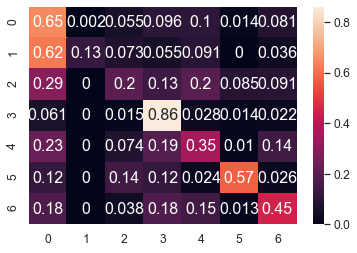

	training epoch=14 .. train_loss=1.162
	validation epoch=14 .. val_loss=1.225
	Accuracy = 53.5 % .. Percision = 57.8 % .. Recall = 45.9 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_14.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 15 .. loss = 1.346


  0%|                                                                                 | 1/1914 [00:01<42:59,  1.35s/it]

training @ epoch 15 .. loss = 0.961


  0%|                                                                                 | 2/1914 [00:02<42:39,  1.34s/it]

training @ epoch 15 .. loss = 1.219


  0%|▏                                                                                | 3/1914 [00:03<41:46,  1.31s/it]

training @ epoch 15 .. loss = 1.109


  0%|▏                                                                                | 4/1914 [00:05<41:22,  1.30s/it]

training @ epoch 15 .. loss = 0.979


  0%|▏                                                                                | 5/1914 [00:06<40:29,  1.27s/it]

training @ epoch 15 .. loss = 1.225


  0%|▎                                                                                | 6/1914 [00:07<40:16,  1.27s/it]

training @ epoch 15 .. loss = 1.116


  0%|▎                                                                                | 7/1914 [00:08<39:36,  1.25s/it]

training @ epoch 15 .. loss = 1.893


  0%|▎                                                                                | 8/1914 [00:10<39:43,  1.25s/it]

training @ epoch 15 .. loss = 1.129


  0%|▍                                                                                | 9/1914 [00:11<39:38,  1.25s/it]

training @ epoch 15 .. loss = 1.174


  1%|▍                                                                               | 10/1914 [00:12<39:33,  1.25s/it]

training @ epoch 15 .. loss = 0.994


  1%|▍                                                                               | 11/1914 [00:13<39:29,  1.25s/it]

training @ epoch 15 .. loss = 0.879


  1%|▌                                                                               | 12/1914 [00:15<39:42,  1.25s/it]

training @ epoch 15 .. loss = 1.014


  1%|▌                                                                               | 13/1914 [00:16<39:07,  1.24s/it]

training @ epoch 15 .. loss = 0.9


  1%|▌                                                                               | 14/1914 [00:17<39:28,  1.25s/it]

training @ epoch 15 .. loss = 1.18


  1%|▋                                                                               | 15/1914 [00:19<41:43,  1.32s/it]

training @ epoch 15 .. loss = 1.422


  1%|▋                                                                               | 16/1914 [00:20<42:54,  1.36s/it]

training @ epoch 15 .. loss = 1.341


  1%|▋                                                                               | 17/1914 [00:21<43:03,  1.36s/it]

training @ epoch 15 .. loss = 1.28


  1%|▊                                                                               | 18/1914 [00:23<43:09,  1.37s/it]

training @ epoch 15 .. loss = 1.064


  1%|▊                                                                               | 19/1914 [00:24<42:21,  1.34s/it]

training @ epoch 15 .. loss = 0.752


  1%|▊                                                                               | 20/1914 [00:25<41:27,  1.31s/it]

training @ epoch 15 .. loss = 1.105


  1%|▉                                                                               | 21/1914 [00:27<40:57,  1.30s/it]

training @ epoch 15 .. loss = 1.336


  1%|▉                                                                               | 22/1914 [00:28<40:47,  1.29s/it]

training @ epoch 15 .. loss = 1.016


  1%|▉                                                                               | 23/1914 [00:29<40:21,  1.28s/it]

training @ epoch 15 .. loss = 1.209


  1%|█                                                                               | 24/1914 [00:30<40:04,  1.27s/it]

training @ epoch 15 .. loss = 1.669


  1%|█                                                                               | 25/1914 [00:32<39:58,  1.27s/it]

training @ epoch 15 .. loss = 0.806


  1%|█                                                                               | 26/1914 [00:33<40:10,  1.28s/it]

training @ epoch 15 .. loss = 1.308


  1%|█▏                                                                              | 27/1914 [00:34<39:44,  1.26s/it]

training @ epoch 15 .. loss = 1.144


  1%|█▏                                                                              | 28/1914 [00:35<39:36,  1.26s/it]

training @ epoch 15 .. loss = 1.33


  2%|█▏                                                                              | 29/1914 [00:37<39:48,  1.27s/it]

training @ epoch 15 .. loss = 0.782


  2%|█▎                                                                              | 30/1914 [00:38<39:27,  1.26s/it]

training @ epoch 15 .. loss = 0.657


  2%|█▎                                                                              | 31/1914 [00:39<39:08,  1.25s/it]

training @ epoch 15 .. loss = 0.869


  2%|█▎                                                                              | 32/1914 [00:40<38:59,  1.24s/it]

training @ epoch 15 .. loss = 1.291


  2%|█▍                                                                              | 33/1914 [00:42<38:46,  1.24s/it]

training @ epoch 15 .. loss = 0.852


  2%|█▍                                                                              | 34/1914 [00:43<39:04,  1.25s/it]

training @ epoch 15 .. loss = 0.816


  2%|█▍                                                                              | 35/1914 [00:44<39:34,  1.26s/it]

training @ epoch 15 .. loss = 0.985


  2%|█▌                                                                              | 36/1914 [00:45<38:52,  1.24s/it]

training @ epoch 15 .. loss = 0.798


  2%|█▌                                                                              | 37/1914 [00:47<38:58,  1.25s/it]

training @ epoch 15 .. loss = 1.289


  2%|█▌                                                                              | 38/1914 [00:48<39:56,  1.28s/it]

training @ epoch 15 .. loss = 1.84


  2%|█▋                                                                              | 39/1914 [00:49<41:47,  1.34s/it]

training @ epoch 15 .. loss = 0.796


  2%|█▋                                                                              | 40/1914 [00:51<42:58,  1.38s/it]

training @ epoch 15 .. loss = 1.175


  2%|█▋                                                                              | 41/1914 [00:52<43:09,  1.38s/it]

training @ epoch 15 .. loss = 1.479


  2%|█▊                                                                              | 42/1914 [00:54<42:49,  1.37s/it]

training @ epoch 15 .. loss = 1.169


  2%|█▊                                                                              | 43/1914 [00:55<43:24,  1.39s/it]

training @ epoch 15 .. loss = 0.834


  2%|█▊                                                                              | 44/1914 [00:56<43:02,  1.38s/it]

training @ epoch 15 .. loss = 1.302


  2%|█▉                                                                              | 45/1914 [00:58<42:34,  1.37s/it]

training @ epoch 15 .. loss = 0.97


  2%|█▉                                                                              | 46/1914 [00:59<42:43,  1.37s/it]

training @ epoch 15 .. loss = 1.15


  2%|█▉                                                                              | 47/1914 [01:01<42:54,  1.38s/it]

training @ epoch 15 .. loss = 0.654


  3%|██                                                                              | 48/1914 [01:02<43:13,  1.39s/it]

training @ epoch 15 .. loss = 1.252


  3%|██                                                                              | 49/1914 [01:03<44:22,  1.43s/it]

training @ epoch 15 .. loss = 1.56


  3%|██                                                                              | 50/1914 [01:05<44:42,  1.44s/it]

training @ epoch 15 .. loss = 1.078


  3%|██▏                                                                             | 51/1914 [01:06<44:09,  1.42s/it]

training @ epoch 15 .. loss = 0.894


  3%|██▏                                                                             | 52/1914 [01:08<43:18,  1.40s/it]

training @ epoch 15 .. loss = 0.943


  3%|██▏                                                                             | 53/1914 [01:09<42:59,  1.39s/it]

training @ epoch 15 .. loss = 1.067


  3%|██▎                                                                             | 54/1914 [01:10<42:52,  1.38s/it]

training @ epoch 15 .. loss = 0.715


  3%|██▎                                                                             | 55/1914 [01:12<42:45,  1.38s/it]

training @ epoch 15 .. loss = 1.223


  3%|██▎                                                                             | 56/1914 [01:13<43:04,  1.39s/it]

training @ epoch 15 .. loss = 0.974


  3%|██▍                                                                             | 57/1914 [01:15<42:26,  1.37s/it]

training @ epoch 15 .. loss = 1.143


  3%|██▍                                                                             | 58/1914 [01:16<42:26,  1.37s/it]

training @ epoch 15 .. loss = 1.134


  3%|██▍                                                                             | 59/1914 [01:17<42:45,  1.38s/it]

training @ epoch 15 .. loss = 1.267


  3%|██▌                                                                             | 60/1914 [01:19<42:41,  1.38s/it]

training @ epoch 15 .. loss = 1.009


  3%|██▌                                                                             | 61/1914 [01:20<43:26,  1.41s/it]

training @ epoch 15 .. loss = 1.02


  3%|██▌                                                                             | 62/1914 [01:21<41:42,  1.35s/it]

training @ epoch 15 .. loss = 1.197


  3%|██▋                                                                             | 63/1914 [01:23<41:03,  1.33s/it]

training @ epoch 15 .. loss = 1.036


  3%|██▋                                                                             | 64/1914 [01:24<40:34,  1.32s/it]

training @ epoch 15 .. loss = 1.192


  3%|██▋                                                                             | 65/1914 [01:25<39:35,  1.28s/it]

training @ epoch 15 .. loss = 1.255


  3%|██▊                                                                             | 66/1914 [01:26<39:25,  1.28s/it]

training @ epoch 15 .. loss = 0.969


  4%|██▊                                                                             | 67/1914 [01:28<39:53,  1.30s/it]

training @ epoch 15 .. loss = 1.184


  4%|██▊                                                                             | 68/1914 [01:29<39:33,  1.29s/it]

training @ epoch 15 .. loss = 1.394


  4%|██▉                                                                             | 69/1914 [01:30<39:30,  1.28s/it]

training @ epoch 15 .. loss = 0.864


  4%|██▉                                                                             | 70/1914 [01:32<39:31,  1.29s/it]

training @ epoch 15 .. loss = 0.801


  4%|██▉                                                                             | 71/1914 [01:33<39:44,  1.29s/it]

training @ epoch 15 .. loss = 0.958


  4%|███                                                                             | 72/1914 [01:34<39:17,  1.28s/it]

training @ epoch 15 .. loss = 0.757


  4%|███                                                                             | 73/1914 [01:35<39:06,  1.27s/it]

training @ epoch 15 .. loss = 1.055


  4%|███                                                                             | 74/1914 [01:37<39:27,  1.29s/it]

training @ epoch 15 .. loss = 0.77


  4%|███▏                                                                            | 75/1914 [01:38<39:00,  1.27s/it]

training @ epoch 15 .. loss = 0.788


  4%|███▏                                                                            | 76/1914 [01:39<38:47,  1.27s/it]

training @ epoch 15 .. loss = 1.059


  4%|███▏                                                                            | 77/1914 [01:40<38:44,  1.27s/it]

training @ epoch 15 .. loss = 1.281


  4%|███▎                                                                            | 78/1914 [01:42<38:47,  1.27s/it]

training @ epoch 15 .. loss = 1.781


  4%|███▎                                                                            | 79/1914 [01:43<38:37,  1.26s/it]

training @ epoch 15 .. loss = 1.138


  4%|███▎                                                                            | 80/1914 [01:44<38:16,  1.25s/it]

training @ epoch 15 .. loss = 1.196


  4%|███▍                                                                            | 81/1914 [01:45<38:21,  1.26s/it]

training @ epoch 15 .. loss = 1.63


  4%|███▍                                                                            | 82/1914 [01:47<38:39,  1.27s/it]

training @ epoch 15 .. loss = 1.242


  4%|███▍                                                                            | 83/1914 [01:48<38:18,  1.26s/it]

training @ epoch 15 .. loss = 1.025


  4%|███▌                                                                            | 84/1914 [01:49<37:59,  1.25s/it]

training @ epoch 15 .. loss = 1.405


  4%|███▌                                                                            | 85/1914 [01:50<37:55,  1.24s/it]

training @ epoch 15 .. loss = 0.842


  4%|███▌                                                                            | 86/1914 [01:52<37:43,  1.24s/it]

training @ epoch 15 .. loss = 1.034


  5%|███▋                                                                            | 87/1914 [01:53<37:54,  1.24s/it]

training @ epoch 15 .. loss = 0.849


  5%|███▋                                                                            | 88/1914 [01:54<37:20,  1.23s/it]

training @ epoch 15 .. loss = 1.163


  5%|███▋                                                                            | 89/1914 [01:55<37:24,  1.23s/it]

training @ epoch 15 .. loss = 1.221


  5%|███▊                                                                            | 90/1914 [01:57<37:31,  1.23s/it]

training @ epoch 15 .. loss = 0.991


  5%|███▊                                                                            | 91/1914 [01:58<37:18,  1.23s/it]

training @ epoch 15 .. loss = 1.488


  5%|███▊                                                                            | 92/1914 [01:59<37:25,  1.23s/it]

training @ epoch 15 .. loss = 1.079


  5%|███▉                                                                            | 93/1914 [02:00<37:11,  1.23s/it]

training @ epoch 15 .. loss = 1.282


  5%|███▉                                                                            | 94/1914 [02:02<37:15,  1.23s/it]

training @ epoch 15 .. loss = 1.278


  5%|███▉                                                                            | 95/1914 [02:03<38:00,  1.25s/it]

training @ epoch 15 .. loss = 1.091


  5%|████                                                                            | 96/1914 [02:04<37:50,  1.25s/it]

training @ epoch 15 .. loss = 1.135


  5%|████                                                                            | 97/1914 [02:05<37:46,  1.25s/it]

training @ epoch 15 .. loss = 0.601


  5%|████                                                                            | 98/1914 [02:07<37:53,  1.25s/it]

training @ epoch 15 .. loss = 1.663


  5%|████▏                                                                           | 99/1914 [02:08<37:42,  1.25s/it]

training @ epoch 15 .. loss = 0.851


  5%|████▏                                                                          | 100/1914 [02:09<37:43,  1.25s/it]

training @ epoch 15 .. loss = 0.933


  5%|████▏                                                                          | 101/1914 [02:10<37:38,  1.25s/it]

training @ epoch 15 .. loss = 1.033


  5%|████▏                                                                          | 102/1914 [02:12<37:30,  1.24s/it]

training @ epoch 15 .. loss = 1.517


  5%|████▎                                                                          | 103/1914 [02:13<37:35,  1.25s/it]

training @ epoch 15 .. loss = 1.299


  5%|████▎                                                                          | 104/1914 [02:14<37:21,  1.24s/it]

training @ epoch 15 .. loss = 1.336


  5%|████▎                                                                          | 105/1914 [02:15<37:28,  1.24s/it]

training @ epoch 15 .. loss = 1.151


  6%|████▍                                                                          | 106/1914 [02:16<37:15,  1.24s/it]

training @ epoch 15 .. loss = 1.134


  6%|████▍                                                                          | 107/1914 [02:18<36:50,  1.22s/it]

training @ epoch 15 .. loss = 0.948


  6%|████▍                                                                          | 108/1914 [02:19<37:20,  1.24s/it]

training @ epoch 15 .. loss = 1.589


  6%|████▍                                                                          | 109/1914 [02:20<36:54,  1.23s/it]

training @ epoch 15 .. loss = 0.919


  6%|████▌                                                                          | 110/1914 [02:21<37:11,  1.24s/it]

training @ epoch 15 .. loss = 0.991


  6%|████▌                                                                          | 111/1914 [02:23<37:40,  1.25s/it]

training @ epoch 15 .. loss = 1.157


  6%|████▌                                                                          | 112/1914 [02:24<37:42,  1.26s/it]

training @ epoch 15 .. loss = 0.977


  6%|████▋                                                                          | 113/1914 [02:25<37:44,  1.26s/it]

training @ epoch 15 .. loss = 1.757


  6%|████▋                                                                          | 114/1914 [02:27<38:02,  1.27s/it]

training @ epoch 15 .. loss = 1.19


  6%|████▋                                                                          | 115/1914 [02:28<37:55,  1.27s/it]

training @ epoch 15 .. loss = 1.396


  6%|████▊                                                                          | 116/1914 [02:29<37:58,  1.27s/it]

training @ epoch 15 .. loss = 1.652


  6%|████▊                                                                          | 117/1914 [02:30<38:00,  1.27s/it]

training @ epoch 15 .. loss = 1.299


  6%|████▊                                                                          | 118/1914 [02:32<38:11,  1.28s/it]

training @ epoch 15 .. loss = 1.118


  6%|████▉                                                                          | 119/1914 [02:33<38:08,  1.27s/it]

training @ epoch 15 .. loss = 1.317


  6%|████▉                                                                          | 120/1914 [02:34<37:27,  1.25s/it]

training @ epoch 15 .. loss = 0.857


  6%|████▉                                                                          | 121/1914 [02:35<37:43,  1.26s/it]

training @ epoch 15 .. loss = 0.718


  6%|█████                                                                          | 122/1914 [02:37<37:56,  1.27s/it]

training @ epoch 15 .. loss = 0.866


  6%|█████                                                                          | 123/1914 [02:38<37:56,  1.27s/it]

training @ epoch 15 .. loss = 0.852


  6%|█████                                                                          | 124/1914 [02:39<37:55,  1.27s/it]

training @ epoch 15 .. loss = 1.327


  7%|█████▏                                                                         | 125/1914 [02:41<38:16,  1.28s/it]

training @ epoch 15 .. loss = 1.074


  7%|█████▏                                                                         | 126/1914 [02:42<38:13,  1.28s/it]

training @ epoch 15 .. loss = 0.946


  7%|█████▏                                                                         | 127/1914 [02:43<38:10,  1.28s/it]

training @ epoch 15 .. loss = 1.174


  7%|█████▎                                                                         | 128/1914 [02:44<37:41,  1.27s/it]

training @ epoch 15 .. loss = 1.223


  7%|█████▎                                                                         | 129/1914 [02:46<37:39,  1.27s/it]

training @ epoch 15 .. loss = 0.892


  7%|█████▎                                                                         | 130/1914 [02:47<37:45,  1.27s/it]

training @ epoch 15 .. loss = 1.336


  7%|█████▍                                                                         | 131/1914 [02:48<37:12,  1.25s/it]

training @ epoch 15 .. loss = 1.414


  7%|█████▍                                                                         | 132/1914 [02:49<37:17,  1.26s/it]

training @ epoch 15 .. loss = 1.294


  7%|█████▍                                                                         | 133/1914 [02:51<37:25,  1.26s/it]

training @ epoch 15 .. loss = 1.133


  7%|█████▌                                                                         | 134/1914 [02:52<37:13,  1.25s/it]

training @ epoch 15 .. loss = 1.075


  7%|█████▌                                                                         | 135/1914 [02:53<36:59,  1.25s/it]

training @ epoch 15 .. loss = 1.208


  7%|█████▌                                                                         | 136/1914 [02:54<36:55,  1.25s/it]

training @ epoch 15 .. loss = 0.673


  7%|█████▋                                                                         | 137/1914 [02:56<36:26,  1.23s/it]

training @ epoch 15 .. loss = 0.621


  7%|█████▋                                                                         | 138/1914 [02:57<36:48,  1.24s/it]

training @ epoch 15 .. loss = 0.86


  7%|█████▋                                                                         | 139/1914 [02:58<36:19,  1.23s/it]

training @ epoch 15 .. loss = 0.892


  7%|█████▊                                                                         | 140/1914 [02:59<36:21,  1.23s/it]

training @ epoch 15 .. loss = 0.928


  7%|█████▊                                                                         | 141/1914 [03:00<36:33,  1.24s/it]

training @ epoch 15 .. loss = 1.77


  7%|█████▊                                                                         | 142/1914 [03:02<37:12,  1.26s/it]

training @ epoch 15 .. loss = 1.142


  7%|█████▉                                                                         | 143/1914 [03:03<37:11,  1.26s/it]

training @ epoch 15 .. loss = 1.411


  8%|█████▉                                                                         | 144/1914 [03:04<37:49,  1.28s/it]

training @ epoch 15 .. loss = 1.083


  8%|█████▉                                                                         | 145/1914 [03:06<37:54,  1.29s/it]

training @ epoch 15 .. loss = 1.746


  8%|██████                                                                         | 146/1914 [03:07<37:35,  1.28s/it]

training @ epoch 15 .. loss = 1.608


  8%|██████                                                                         | 147/1914 [03:08<37:00,  1.26s/it]

training @ epoch 15 .. loss = 1.278


  8%|██████                                                                         | 148/1914 [03:09<36:53,  1.25s/it]

training @ epoch 15 .. loss = 1.155


  8%|██████▏                                                                        | 149/1914 [03:11<36:55,  1.26s/it]

training @ epoch 15 .. loss = 0.537


  8%|██████▏                                                                        | 150/1914 [03:12<37:08,  1.26s/it]

training @ epoch 15 .. loss = 1.247


  8%|██████▏                                                                        | 151/1914 [03:13<36:46,  1.25s/it]

training @ epoch 15 .. loss = 1.356


  8%|██████▎                                                                        | 152/1914 [03:14<36:13,  1.23s/it]

training @ epoch 15 .. loss = 0.839


  8%|██████▎                                                                        | 153/1914 [03:16<36:10,  1.23s/it]

training @ epoch 15 .. loss = 0.964


  8%|██████▎                                                                        | 154/1914 [03:17<36:44,  1.25s/it]

training @ epoch 15 .. loss = 1.546


  8%|██████▍                                                                        | 155/1914 [03:18<36:15,  1.24s/it]

training @ epoch 15 .. loss = 1.075


  8%|██████▍                                                                        | 156/1914 [03:19<36:31,  1.25s/it]

training @ epoch 15 .. loss = 0.83


  8%|██████▍                                                                        | 157/1914 [03:21<36:57,  1.26s/it]

training @ epoch 15 .. loss = 1.29


  8%|██████▌                                                                        | 158/1914 [03:22<36:56,  1.26s/it]

training @ epoch 15 .. loss = 1.12


  8%|██████▌                                                                        | 159/1914 [03:23<36:48,  1.26s/it]

training @ epoch 15 .. loss = 1.053


  8%|██████▌                                                                        | 160/1914 [03:24<36:49,  1.26s/it]

training @ epoch 15 .. loss = 1.903


  8%|██████▋                                                                        | 161/1914 [03:26<36:47,  1.26s/it]

training @ epoch 15 .. loss = 1.141


  8%|██████▋                                                                        | 162/1914 [03:27<37:21,  1.28s/it]

training @ epoch 15 .. loss = 1.277


  9%|██████▋                                                                        | 163/1914 [03:28<36:55,  1.26s/it]

training @ epoch 15 .. loss = 1.537


  9%|██████▊                                                                        | 164/1914 [03:29<36:50,  1.26s/it]

training @ epoch 15 .. loss = 1.17


  9%|██████▊                                                                        | 165/1914 [03:31<37:14,  1.28s/it]

training @ epoch 15 .. loss = 1.216


  9%|██████▊                                                                        | 166/1914 [03:32<37:42,  1.29s/it]

training @ epoch 15 .. loss = 0.991


  9%|██████▉                                                                        | 167/1914 [03:33<37:47,  1.30s/it]

training @ epoch 15 .. loss = 1.357


  9%|██████▉                                                                        | 168/1914 [03:35<37:38,  1.29s/it]

training @ epoch 15 .. loss = 1.31


  9%|██████▉                                                                        | 169/1914 [03:36<37:01,  1.27s/it]

training @ epoch 15 .. loss = 1.063


  9%|███████                                                                        | 170/1914 [03:37<36:56,  1.27s/it]

training @ epoch 15 .. loss = 1.433


  9%|███████                                                                        | 171/1914 [03:38<36:55,  1.27s/it]

training @ epoch 15 .. loss = 1.186


  9%|███████                                                                        | 172/1914 [03:40<36:50,  1.27s/it]

training @ epoch 15 .. loss = 1.048


  9%|███████▏                                                                       | 173/1914 [03:41<37:02,  1.28s/it]

training @ epoch 15 .. loss = 1.521


  9%|███████▏                                                                       | 174/1914 [03:42<36:42,  1.27s/it]

training @ epoch 15 .. loss = 1.155


  9%|███████▏                                                                       | 175/1914 [03:44<36:45,  1.27s/it]

training @ epoch 15 .. loss = 1.164


  9%|███████▎                                                                       | 176/1914 [03:45<36:56,  1.28s/it]

training @ epoch 15 .. loss = 1.355


  9%|███████▎                                                                       | 177/1914 [03:46<36:13,  1.25s/it]

training @ epoch 15 .. loss = 0.982


  9%|███████▎                                                                       | 178/1914 [03:47<36:42,  1.27s/it]

training @ epoch 15 .. loss = 1.044


  9%|███████▍                                                                       | 179/1914 [03:49<36:44,  1.27s/it]

training @ epoch 15 .. loss = 1.341


  9%|███████▍                                                                       | 180/1914 [03:50<36:13,  1.25s/it]

training @ epoch 15 .. loss = 0.788


  9%|███████▍                                                                       | 181/1914 [03:51<36:06,  1.25s/it]

training @ epoch 15 .. loss = 1.283


 10%|███████▌                                                                       | 182/1914 [03:52<36:26,  1.26s/it]

training @ epoch 15 .. loss = 1.035


 10%|███████▌                                                                       | 183/1914 [03:54<36:11,  1.25s/it]

training @ epoch 15 .. loss = 0.908


 10%|███████▌                                                                       | 184/1914 [03:55<36:29,  1.27s/it]

training @ epoch 15 .. loss = 1.1


 10%|███████▋                                                                       | 185/1914 [03:56<35:39,  1.24s/it]

training @ epoch 15 .. loss = 1.244


 10%|███████▋                                                                       | 186/1914 [03:57<35:40,  1.24s/it]

training @ epoch 15 .. loss = 1.155


 10%|███████▋                                                                       | 187/1914 [03:59<36:03,  1.25s/it]

training @ epoch 15 .. loss = 1.387


 10%|███████▊                                                                       | 188/1914 [04:00<35:52,  1.25s/it]

training @ epoch 15 .. loss = 1.428


 10%|███████▊                                                                       | 189/1914 [04:01<35:42,  1.24s/it]

training @ epoch 15 .. loss = 0.777


 10%|███████▊                                                                       | 190/1914 [04:02<35:43,  1.24s/it]

training @ epoch 15 .. loss = 0.951


 10%|███████▉                                                                       | 191/1914 [04:04<36:01,  1.25s/it]

training @ epoch 15 .. loss = 1.621


 10%|███████▉                                                                       | 192/1914 [04:05<36:26,  1.27s/it]

training @ epoch 15 .. loss = 1.135


 10%|███████▉                                                                       | 193/1914 [04:06<35:42,  1.25s/it]

training @ epoch 15 .. loss = 1.194


 10%|████████                                                                       | 194/1914 [04:07<35:49,  1.25s/it]

training @ epoch 15 .. loss = 1.227


 10%|████████                                                                       | 195/1914 [04:09<36:04,  1.26s/it]

training @ epoch 15 .. loss = 0.908


 10%|████████                                                                       | 196/1914 [04:10<35:59,  1.26s/it]

training @ epoch 15 .. loss = 1.066


 10%|████████▏                                                                      | 197/1914 [04:11<35:43,  1.25s/it]

training @ epoch 15 .. loss = 1.167


 10%|████████▏                                                                      | 198/1914 [04:12<35:27,  1.24s/it]

training @ epoch 15 .. loss = 0.851


 10%|████████▏                                                                      | 199/1914 [04:14<35:27,  1.24s/it]

training @ epoch 15 .. loss = 0.818


 10%|████████▎                                                                      | 200/1914 [04:15<35:27,  1.24s/it]

training @ epoch 15 .. loss = 1.088


 11%|████████▎                                                                      | 201/1914 [04:16<35:00,  1.23s/it]

training @ epoch 15 .. loss = 1.581


 11%|████████▎                                                                      | 202/1914 [04:17<35:06,  1.23s/it]

training @ epoch 15 .. loss = 1.12


 11%|████████▍                                                                      | 203/1914 [04:18<35:23,  1.24s/it]

training @ epoch 15 .. loss = 0.97


 11%|████████▍                                                                      | 204/1914 [04:20<35:22,  1.24s/it]

training @ epoch 15 .. loss = 1.135


 11%|████████▍                                                                      | 205/1914 [04:21<35:04,  1.23s/it]

training @ epoch 15 .. loss = 1.096


 11%|████████▌                                                                      | 206/1914 [04:22<35:12,  1.24s/it]

training @ epoch 15 .. loss = 1.05


 11%|████████▌                                                                      | 207/1914 [04:23<35:13,  1.24s/it]

training @ epoch 15 .. loss = 1.208


 11%|████████▌                                                                      | 208/1914 [04:25<35:51,  1.26s/it]

training @ epoch 15 .. loss = 1.135


 11%|████████▋                                                                      | 209/1914 [04:26<35:20,  1.24s/it]

training @ epoch 15 .. loss = 1.331


 11%|████████▋                                                                      | 210/1914 [04:27<35:17,  1.24s/it]

training @ epoch 15 .. loss = 1.307


 11%|████████▋                                                                      | 211/1914 [04:28<35:11,  1.24s/it]

training @ epoch 15 .. loss = 1.507


 11%|████████▊                                                                      | 212/1914 [04:30<35:06,  1.24s/it]

training @ epoch 15 .. loss = 1.458


 11%|████████▊                                                                      | 213/1914 [04:31<35:23,  1.25s/it]

training @ epoch 15 .. loss = 0.858


 11%|████████▊                                                                      | 214/1914 [04:32<35:03,  1.24s/it]

training @ epoch 15 .. loss = 1.261


 11%|████████▊                                                                      | 215/1914 [04:33<34:52,  1.23s/it]

training @ epoch 15 .. loss = 1.199


 11%|████████▉                                                                      | 216/1914 [04:35<35:39,  1.26s/it]

training @ epoch 15 .. loss = 1.422


 11%|████████▉                                                                      | 217/1914 [04:36<35:01,  1.24s/it]

training @ epoch 15 .. loss = 1.376


 11%|████████▉                                                                      | 218/1914 [04:37<35:03,  1.24s/it]

training @ epoch 15 .. loss = 1.313


 11%|█████████                                                                      | 219/1914 [04:38<34:49,  1.23s/it]

training @ epoch 15 .. loss = 1.185


 11%|█████████                                                                      | 220/1914 [04:40<35:48,  1.27s/it]

training @ epoch 15 .. loss = 0.803


 12%|█████████                                                                      | 221/1914 [04:41<35:40,  1.26s/it]

training @ epoch 15 .. loss = 1.142


 12%|█████████▏                                                                     | 222/1914 [04:42<35:43,  1.27s/it]

training @ epoch 15 .. loss = 1.002


 12%|█████████▏                                                                     | 223/1914 [04:43<35:31,  1.26s/it]

training @ epoch 15 .. loss = 1.153


 12%|█████████▏                                                                     | 224/1914 [04:45<35:52,  1.27s/it]

training @ epoch 15 .. loss = 1.176


 12%|█████████▎                                                                     | 225/1914 [04:46<35:27,  1.26s/it]

training @ epoch 15 .. loss = 1.374


 12%|█████████▎                                                                     | 226/1914 [04:47<35:41,  1.27s/it]

training @ epoch 15 .. loss = 1.028


 12%|█████████▎                                                                     | 227/1914 [04:49<35:27,  1.26s/it]

training @ epoch 15 .. loss = 1.347


 12%|█████████▍                                                                     | 228/1914 [04:50<35:29,  1.26s/it]

training @ epoch 15 .. loss = 1.145


 12%|█████████▍                                                                     | 229/1914 [04:51<35:14,  1.26s/it]

training @ epoch 15 .. loss = 1.06


 12%|█████████▍                                                                     | 230/1914 [04:52<35:13,  1.26s/it]

training @ epoch 15 .. loss = 1.376


 12%|█████████▌                                                                     | 231/1914 [04:54<35:36,  1.27s/it]

training @ epoch 15 .. loss = 1.517


 12%|█████████▌                                                                     | 232/1914 [04:55<35:31,  1.27s/it]

training @ epoch 15 .. loss = 0.825


 12%|█████████▌                                                                     | 233/1914 [04:56<35:07,  1.25s/it]

training @ epoch 15 .. loss = 1.131


 12%|█████████▋                                                                     | 234/1914 [04:57<35:07,  1.25s/it]

training @ epoch 15 .. loss = 0.902


 12%|█████████▋                                                                     | 235/1914 [04:59<35:21,  1.26s/it]

training @ epoch 15 .. loss = 1.47


 12%|█████████▋                                                                     | 236/1914 [05:00<35:08,  1.26s/it]

training @ epoch 15 .. loss = 1.047


 12%|█████████▊                                                                     | 237/1914 [05:01<34:40,  1.24s/it]

training @ epoch 15 .. loss = 1.261


 12%|█████████▊                                                                     | 238/1914 [05:02<34:26,  1.23s/it]

training @ epoch 15 .. loss = 0.873


 12%|█████████▊                                                                     | 239/1914 [05:04<34:46,  1.25s/it]

training @ epoch 15 .. loss = 1.32


 13%|█████████▉                                                                     | 240/1914 [05:05<34:53,  1.25s/it]

training @ epoch 15 .. loss = 1.228


 13%|█████████▉                                                                     | 241/1914 [05:06<35:02,  1.26s/it]

training @ epoch 15 .. loss = 0.963


 13%|█████████▉                                                                     | 242/1914 [05:07<35:05,  1.26s/it]

training @ epoch 15 .. loss = 0.919


 13%|██████████                                                                     | 243/1914 [05:09<35:31,  1.28s/it]

training @ epoch 15 .. loss = 1.374


 13%|██████████                                                                     | 244/1914 [05:10<35:07,  1.26s/it]

training @ epoch 15 .. loss = 1.084


 13%|██████████                                                                     | 245/1914 [05:11<35:09,  1.26s/it]

training @ epoch 15 .. loss = 1.18


 13%|██████████▏                                                                    | 246/1914 [05:12<35:23,  1.27s/it]

training @ epoch 15 .. loss = 1.467


 13%|██████████▏                                                                    | 247/1914 [05:14<35:13,  1.27s/it]

training @ epoch 15 .. loss = 1.025


 13%|██████████▏                                                                    | 248/1914 [05:15<35:09,  1.27s/it]

training @ epoch 15 .. loss = 1.294


 13%|██████████▎                                                                    | 249/1914 [05:16<35:00,  1.26s/it]

training @ epoch 15 .. loss = 0.796


 13%|██████████▎                                                                    | 250/1914 [05:17<34:59,  1.26s/it]

training @ epoch 15 .. loss = 1.115


 13%|██████████▎                                                                    | 251/1914 [05:19<35:18,  1.27s/it]

training @ epoch 15 .. loss = 1.354


 13%|██████████▍                                                                    | 252/1914 [05:20<34:54,  1.26s/it]

training @ epoch 15 .. loss = 0.904


 13%|██████████▍                                                                    | 253/1914 [05:21<35:05,  1.27s/it]

training @ epoch 15 .. loss = 1.525


 13%|██████████▍                                                                    | 254/1914 [05:23<35:10,  1.27s/it]

training @ epoch 15 .. loss = 1.125


 13%|██████████▌                                                                    | 255/1914 [05:24<34:49,  1.26s/it]

training @ epoch 15 .. loss = 1.481


 13%|██████████▌                                                                    | 256/1914 [05:25<34:33,  1.25s/it]

training @ epoch 15 .. loss = 1.45


 13%|██████████▌                                                                    | 257/1914 [05:26<34:22,  1.24s/it]

training @ epoch 15 .. loss = 1.342


 13%|██████████▋                                                                    | 258/1914 [05:28<34:25,  1.25s/it]

training @ epoch 15 .. loss = 1.193


 14%|██████████▋                                                                    | 259/1914 [05:29<34:37,  1.26s/it]

training @ epoch 15 .. loss = 1.079


 14%|██████████▋                                                                    | 260/1914 [05:30<34:19,  1.24s/it]

training @ epoch 15 .. loss = 1.356


 14%|██████████▊                                                                    | 261/1914 [05:31<34:33,  1.25s/it]

training @ epoch 15 .. loss = 1.512


 14%|██████████▊                                                                    | 262/1914 [05:33<35:08,  1.28s/it]

training @ epoch 15 .. loss = 1.32


 14%|██████████▊                                                                    | 263/1914 [05:34<35:05,  1.28s/it]

training @ epoch 15 .. loss = 1.286


 14%|██████████▉                                                                    | 264/1914 [05:35<34:47,  1.27s/it]

training @ epoch 15 .. loss = 0.883


 14%|██████████▉                                                                    | 265/1914 [05:36<34:18,  1.25s/it]

training @ epoch 15 .. loss = 0.759


 14%|██████████▉                                                                    | 266/1914 [05:38<34:38,  1.26s/it]

training @ epoch 15 .. loss = 1.335


 14%|███████████                                                                    | 267/1914 [05:39<35:09,  1.28s/it]

training @ epoch 15 .. loss = 1.475


 14%|███████████                                                                    | 268/1914 [05:40<34:47,  1.27s/it]

training @ epoch 15 .. loss = 1.148


 14%|███████████                                                                    | 269/1914 [05:41<34:48,  1.27s/it]

training @ epoch 15 .. loss = 1.36


 14%|███████████▏                                                                   | 270/1914 [05:43<35:13,  1.29s/it]

training @ epoch 15 .. loss = 1.534


 14%|███████████▏                                                                   | 271/1914 [05:44<34:39,  1.27s/it]

training @ epoch 15 .. loss = 1.12


 14%|███████████▏                                                                   | 272/1914 [05:45<34:51,  1.27s/it]

training @ epoch 15 .. loss = 0.888


 14%|███████████▎                                                                   | 273/1914 [05:47<35:11,  1.29s/it]

training @ epoch 15 .. loss = 1.148


 14%|███████████▎                                                                   | 274/1914 [05:48<34:59,  1.28s/it]

training @ epoch 15 .. loss = 1.244


 14%|███████████▎                                                                   | 275/1914 [05:49<34:39,  1.27s/it]

training @ epoch 15 .. loss = 1.177


 14%|███████████▍                                                                   | 276/1914 [05:50<34:27,  1.26s/it]

training @ epoch 15 .. loss = 1.108


 14%|███████████▍                                                                   | 277/1914 [05:52<34:25,  1.26s/it]

training @ epoch 15 .. loss = 0.913


 15%|███████████▍                                                                   | 278/1914 [05:53<34:40,  1.27s/it]

training @ epoch 15 .. loss = 1.218


 15%|███████████▌                                                                   | 279/1914 [05:54<34:37,  1.27s/it]

training @ epoch 15 .. loss = 1.062


 15%|███████████▌                                                                   | 280/1914 [05:55<34:37,  1.27s/it]

training @ epoch 15 .. loss = 1.151


 15%|███████████▌                                                                   | 281/1914 [05:57<34:50,  1.28s/it]

training @ epoch 15 .. loss = 1.244


 15%|███████████▋                                                                   | 282/1914 [05:58<34:33,  1.27s/it]

training @ epoch 15 .. loss = 0.925


 15%|███████████▋                                                                   | 283/1914 [05:59<34:33,  1.27s/it]

training @ epoch 15 .. loss = 0.93


 15%|███████████▋                                                                   | 284/1914 [06:01<34:55,  1.29s/it]

training @ epoch 15 .. loss = 1.138


 15%|███████████▊                                                                   | 285/1914 [06:02<34:46,  1.28s/it]

training @ epoch 15 .. loss = 1.217


 15%|███████████▊                                                                   | 286/1914 [06:03<34:50,  1.28s/it]

training @ epoch 15 .. loss = 1.323


 15%|███████████▊                                                                   | 287/1914 [06:04<34:42,  1.28s/it]

training @ epoch 15 .. loss = 1.342


 15%|███████████▉                                                                   | 288/1914 [06:06<34:26,  1.27s/it]

training @ epoch 15 .. loss = 1.18


 15%|███████████▉                                                                   | 289/1914 [06:07<34:26,  1.27s/it]

training @ epoch 15 .. loss = 1.058


 15%|███████████▉                                                                   | 290/1914 [06:08<34:06,  1.26s/it]

training @ epoch 15 .. loss = 1.423


 15%|████████████                                                                   | 291/1914 [06:09<33:56,  1.25s/it]

training @ epoch 15 .. loss = 1.634


 15%|████████████                                                                   | 292/1914 [06:11<34:13,  1.27s/it]

training @ epoch 15 .. loss = 1.229


 15%|████████████                                                                   | 293/1914 [06:12<34:10,  1.26s/it]

training @ epoch 15 .. loss = 0.785


 15%|████████████▏                                                                  | 294/1914 [06:13<34:12,  1.27s/it]

training @ epoch 15 .. loss = 1.225


 15%|████████████▏                                                                  | 295/1914 [06:15<34:07,  1.26s/it]

training @ epoch 15 .. loss = 1.454


 15%|████████████▏                                                                  | 296/1914 [06:16<34:04,  1.26s/it]

training @ epoch 15 .. loss = 1.527


 16%|████████████▎                                                                  | 297/1914 [06:17<34:07,  1.27s/it]

training @ epoch 15 .. loss = 0.912


 16%|████████████▎                                                                  | 298/1914 [06:18<33:58,  1.26s/it]

training @ epoch 15 .. loss = 1.037


 16%|████████████▎                                                                  | 299/1914 [06:20<33:45,  1.25s/it]

training @ epoch 15 .. loss = 1.251


 16%|████████████▍                                                                  | 300/1914 [06:21<33:56,  1.26s/it]

training @ epoch 15 .. loss = 0.929


 16%|████████████▍                                                                  | 301/1914 [06:22<33:39,  1.25s/it]

training @ epoch 15 .. loss = 1.379


 16%|████████████▍                                                                  | 302/1914 [06:23<33:33,  1.25s/it]

training @ epoch 15 .. loss = 0.976


 16%|████████████▌                                                                  | 303/1914 [06:25<33:34,  1.25s/it]

training @ epoch 15 .. loss = 0.999


 16%|████████████▌                                                                  | 304/1914 [06:26<33:43,  1.26s/it]

training @ epoch 15 .. loss = 1.319


 16%|████████████▌                                                                  | 305/1914 [06:27<33:40,  1.26s/it]

training @ epoch 15 .. loss = 0.882


 16%|████████████▋                                                                  | 306/1914 [06:28<33:39,  1.26s/it]

training @ epoch 15 .. loss = 1.318


 16%|████████████▋                                                                  | 307/1914 [06:30<33:52,  1.26s/it]

training @ epoch 15 .. loss = 1.552


 16%|████████████▋                                                                  | 308/1914 [06:31<34:00,  1.27s/it]

training @ epoch 15 .. loss = 1.517


 16%|████████████▊                                                                  | 309/1914 [06:32<33:29,  1.25s/it]

training @ epoch 15 .. loss = 0.965


 16%|████████████▊                                                                  | 310/1914 [06:33<33:33,  1.26s/it]

training @ epoch 15 .. loss = 0.724


 16%|████████████▊                                                                  | 311/1914 [06:35<34:19,  1.28s/it]

training @ epoch 15 .. loss = 1.041


 16%|████████████▉                                                                  | 312/1914 [06:36<33:48,  1.27s/it]

training @ epoch 15 .. loss = 0.916


 16%|████████████▉                                                                  | 313/1914 [06:37<33:49,  1.27s/it]

training @ epoch 15 .. loss = 1.131


 16%|████████████▉                                                                  | 314/1914 [06:39<33:59,  1.27s/it]

training @ epoch 15 .. loss = 1.025


 16%|█████████████                                                                  | 315/1914 [06:40<34:07,  1.28s/it]

training @ epoch 15 .. loss = 0.931


 17%|█████████████                                                                  | 316/1914 [06:41<34:09,  1.28s/it]

training @ epoch 15 .. loss = 0.98


 17%|█████████████                                                                  | 317/1914 [06:42<33:55,  1.27s/it]

training @ epoch 15 .. loss = 1.092


 17%|█████████████▏                                                                 | 318/1914 [06:44<33:53,  1.27s/it]

training @ epoch 15 .. loss = 1.44


 17%|█████████████▏                                                                 | 319/1914 [06:45<34:04,  1.28s/it]

training @ epoch 15 .. loss = 0.597


 17%|█████████████▏                                                                 | 320/1914 [06:46<34:02,  1.28s/it]

training @ epoch 15 .. loss = 1.173


 17%|█████████████▏                                                                 | 321/1914 [06:48<34:03,  1.28s/it]

training @ epoch 15 .. loss = 1.011


 17%|█████████████▎                                                                 | 322/1914 [06:49<34:31,  1.30s/it]

training @ epoch 15 .. loss = 0.989


 17%|█████████████▎                                                                 | 323/1914 [06:50<34:02,  1.28s/it]

training @ epoch 15 .. loss = 1.109


 17%|█████████████▎                                                                 | 324/1914 [06:51<33:52,  1.28s/it]

training @ epoch 15 .. loss = 1.462


 17%|█████████████▍                                                                 | 325/1914 [06:53<34:03,  1.29s/it]

training @ epoch 15 .. loss = 0.865


 17%|█████████████▍                                                                 | 326/1914 [06:54<33:46,  1.28s/it]

training @ epoch 15 .. loss = 1.696


 17%|█████████████▍                                                                 | 327/1914 [06:55<34:05,  1.29s/it]

training @ epoch 15 .. loss = 1.455


 17%|█████████████▌                                                                 | 328/1914 [06:57<34:21,  1.30s/it]

training @ epoch 15 .. loss = 1.115


 17%|█████████████▌                                                                 | 329/1914 [06:58<34:14,  1.30s/it]

training @ epoch 15 .. loss = 0.832


 17%|█████████████▌                                                                 | 330/1914 [06:59<34:13,  1.30s/it]

training @ epoch 15 .. loss = 1.183


 17%|█████████████▋                                                                 | 331/1914 [07:00<34:02,  1.29s/it]

training @ epoch 15 .. loss = 0.964


 17%|█████████████▋                                                                 | 332/1914 [07:02<33:57,  1.29s/it]

training @ epoch 15 .. loss = 1.229


 17%|█████████████▋                                                                 | 333/1914 [07:03<33:49,  1.28s/it]

training @ epoch 15 .. loss = 0.764


 17%|█████████████▊                                                                 | 334/1914 [07:04<33:36,  1.28s/it]

training @ epoch 15 .. loss = 1.186


 18%|█████████████▊                                                                 | 335/1914 [07:06<33:35,  1.28s/it]

training @ epoch 15 .. loss = 1.125


 18%|█████████████▊                                                                 | 336/1914 [07:07<33:50,  1.29s/it]

training @ epoch 15 .. loss = 0.757


 18%|█████████████▉                                                                 | 337/1914 [07:08<33:19,  1.27s/it]

training @ epoch 15 .. loss = 0.923


 18%|█████████████▉                                                                 | 338/1914 [07:09<33:24,  1.27s/it]

training @ epoch 15 .. loss = 1.691


 18%|█████████████▉                                                                 | 339/1914 [07:11<33:38,  1.28s/it]

training @ epoch 15 .. loss = 0.491


 18%|██████████████                                                                 | 340/1914 [07:12<33:38,  1.28s/it]

training @ epoch 15 .. loss = 1.719


 18%|██████████████                                                                 | 341/1914 [07:13<33:27,  1.28s/it]

training @ epoch 15 .. loss = 0.906


 18%|██████████████                                                                 | 342/1914 [07:14<33:25,  1.28s/it]

training @ epoch 15 .. loss = 0.699


 18%|██████████████▏                                                                | 343/1914 [07:16<33:14,  1.27s/it]

training @ epoch 15 .. loss = 1.183


 18%|██████████████▏                                                                | 344/1914 [07:17<33:24,  1.28s/it]

training @ epoch 15 .. loss = 0.836


 18%|██████████████▏                                                                | 345/1914 [07:18<33:37,  1.29s/it]

training @ epoch 15 .. loss = 0.675


 18%|██████████████▎                                                                | 346/1914 [07:20<33:34,  1.28s/it]

training @ epoch 15 .. loss = 1.604


 18%|██████████████▎                                                                | 347/1914 [07:21<33:30,  1.28s/it]

training @ epoch 15 .. loss = 1.143


 18%|██████████████▎                                                                | 348/1914 [07:22<33:14,  1.27s/it]

training @ epoch 15 .. loss = 0.935


 18%|██████████████▍                                                                | 349/1914 [07:23<33:08,  1.27s/it]

training @ epoch 15 .. loss = 1.251


 18%|██████████████▍                                                                | 350/1914 [07:25<33:36,  1.29s/it]

training @ epoch 15 .. loss = 0.959


 18%|██████████████▍                                                                | 351/1914 [07:26<33:05,  1.27s/it]

training @ epoch 15 .. loss = 1.248


 18%|██████████████▌                                                                | 352/1914 [07:27<33:14,  1.28s/it]

training @ epoch 15 .. loss = 1.174


 18%|██████████████▌                                                                | 353/1914 [07:28<32:58,  1.27s/it]

training @ epoch 15 .. loss = 0.737


 18%|██████████████▌                                                                | 354/1914 [07:30<32:58,  1.27s/it]

training @ epoch 15 .. loss = 1.234


 19%|██████████████▋                                                                | 355/1914 [07:31<33:01,  1.27s/it]

training @ epoch 15 .. loss = 0.704


 19%|██████████████▋                                                                | 356/1914 [07:32<33:00,  1.27s/it]

training @ epoch 15 .. loss = 1.402


 19%|██████████████▋                                                                | 357/1914 [07:34<34:23,  1.33s/it]

training @ epoch 15 .. loss = 1.802


 19%|██████████████▊                                                                | 358/1914 [07:35<35:54,  1.38s/it]

training @ epoch 15 .. loss = 1.89


 19%|██████████████▊                                                                | 359/1914 [07:37<36:42,  1.42s/it]

training @ epoch 15 .. loss = 1.231


 19%|██████████████▊                                                                | 360/1914 [07:38<37:02,  1.43s/it]

training @ epoch 15 .. loss = 1.244


 19%|██████████████▉                                                                | 361/1914 [07:40<37:08,  1.43s/it]

training @ epoch 15 .. loss = 0.773


 19%|██████████████▉                                                                | 362/1914 [07:41<36:52,  1.43s/it]

training @ epoch 15 .. loss = 1.223


 19%|██████████████▉                                                                | 363/1914 [07:42<36:27,  1.41s/it]

training @ epoch 15 .. loss = 1.364


 19%|███████████████                                                                | 364/1914 [07:44<36:19,  1.41s/it]

training @ epoch 15 .. loss = 1.626


 19%|███████████████                                                                | 365/1914 [07:45<36:31,  1.41s/it]

training @ epoch 15 .. loss = 1.095


 19%|███████████████                                                                | 366/1914 [07:47<36:25,  1.41s/it]

training @ epoch 15 .. loss = 0.885


 19%|███████████████▏                                                               | 367/1914 [07:48<36:25,  1.41s/it]

training @ epoch 15 .. loss = 0.818


 19%|███████████████▏                                                               | 368/1914 [07:50<36:34,  1.42s/it]

training @ epoch 15 .. loss = 0.968


 19%|███████████████▏                                                               | 369/1914 [07:51<36:45,  1.43s/it]

training @ epoch 15 .. loss = 1.257


 19%|███████████████▎                                                               | 370/1914 [07:53<37:51,  1.47s/it]

training @ epoch 15 .. loss = 1.044


 19%|███████████████▎                                                               | 371/1914 [07:54<37:55,  1.47s/it]

training @ epoch 15 .. loss = 0.661


 19%|███████████████▎                                                               | 372/1914 [07:56<37:50,  1.47s/it]

training @ epoch 15 .. loss = 1.204


 19%|███████████████▍                                                               | 373/1914 [07:57<37:31,  1.46s/it]

training @ epoch 15 .. loss = 1.106


 20%|███████████████▍                                                               | 374/1914 [07:58<35:47,  1.39s/it]

training @ epoch 15 .. loss = 1.497


 20%|███████████████▍                                                               | 375/1914 [07:59<34:48,  1.36s/it]

training @ epoch 15 .. loss = 1.233


 20%|███████████████▌                                                               | 376/1914 [08:01<34:18,  1.34s/it]

training @ epoch 15 .. loss = 1.102


 20%|███████████████▌                                                               | 377/1914 [08:02<33:44,  1.32s/it]

training @ epoch 15 .. loss = 0.781


 20%|███████████████▌                                                               | 378/1914 [08:03<33:06,  1.29s/it]

training @ epoch 15 .. loss = 1.226


 20%|███████████████▋                                                               | 379/1914 [08:05<33:09,  1.30s/it]

training @ epoch 15 .. loss = 1.708


 20%|███████████████▋                                                               | 380/1914 [08:06<32:37,  1.28s/it]

training @ epoch 15 .. loss = 1.16


 20%|███████████████▋                                                               | 381/1914 [08:07<32:32,  1.27s/it]

training @ epoch 15 .. loss = 0.93


 20%|███████████████▊                                                               | 382/1914 [08:08<32:33,  1.28s/it]

training @ epoch 15 .. loss = 1.126


 20%|███████████████▊                                                               | 383/1914 [08:10<32:22,  1.27s/it]

training @ epoch 15 .. loss = 1.164


 20%|███████████████▊                                                               | 384/1914 [08:11<32:35,  1.28s/it]

training @ epoch 15 .. loss = 0.709


 20%|███████████████▉                                                               | 385/1914 [08:12<32:10,  1.26s/it]

training @ epoch 15 .. loss = 0.659


 20%|███████████████▉                                                               | 386/1914 [08:13<32:04,  1.26s/it]

training @ epoch 15 .. loss = 1.62


 20%|███████████████▉                                                               | 387/1914 [08:15<32:26,  1.27s/it]

training @ epoch 15 .. loss = 0.95


 20%|████████████████                                                               | 388/1914 [08:16<31:55,  1.26s/it]

training @ epoch 15 .. loss = 1.31


 20%|████████████████                                                               | 389/1914 [08:17<33:25,  1.32s/it]

training @ epoch 15 .. loss = 1.402


 20%|████████████████                                                               | 390/1914 [08:19<34:43,  1.37s/it]

training @ epoch 15 .. loss = 1.158


 20%|████████████████▏                                                              | 391/1914 [08:20<33:43,  1.33s/it]

training @ epoch 15 .. loss = 1.089


 20%|████████████████▏                                                              | 392/1914 [08:21<33:30,  1.32s/it]

training @ epoch 15 .. loss = 0.872


 21%|████████████████▏                                                              | 393/1914 [08:23<33:42,  1.33s/it]

training @ epoch 15 .. loss = 1.03


 21%|████████████████▎                                                              | 394/1914 [08:24<33:00,  1.30s/it]

training @ epoch 15 .. loss = 1.182


 21%|████████████████▎                                                              | 395/1914 [08:25<32:53,  1.30s/it]

training @ epoch 15 .. loss = 0.705


 21%|████████████████▎                                                              | 396/1914 [08:27<32:41,  1.29s/it]

training @ epoch 15 .. loss = 1.165


 21%|████████████████▍                                                              | 397/1914 [08:28<32:27,  1.28s/it]

training @ epoch 15 .. loss = 1.676


 21%|████████████████▍                                                              | 398/1914 [08:29<32:13,  1.28s/it]

training @ epoch 15 .. loss = 1.221


 21%|████████████████▍                                                              | 399/1914 [08:30<32:03,  1.27s/it]

training @ epoch 15 .. loss = 0.961


 21%|████████████████▌                                                              | 400/1914 [08:32<32:04,  1.27s/it]

training @ epoch 15 .. loss = 0.974


 21%|████████████████▌                                                              | 401/1914 [08:33<32:07,  1.27s/it]

training @ epoch 15 .. loss = 1.296


 21%|████████████████▌                                                              | 402/1914 [08:34<31:45,  1.26s/it]

training @ epoch 15 .. loss = 0.903


 21%|████████████████▋                                                              | 403/1914 [08:35<32:12,  1.28s/it]

training @ epoch 15 .. loss = 0.812


 21%|████████████████▋                                                              | 404/1914 [08:37<32:15,  1.28s/it]

training @ epoch 15 .. loss = 0.72


 21%|████████████████▋                                                              | 405/1914 [08:38<31:38,  1.26s/it]

training @ epoch 15 .. loss = 0.966


 21%|████████████████▊                                                              | 406/1914 [08:39<31:51,  1.27s/it]

training @ epoch 15 .. loss = 1.181


 21%|████████████████▊                                                              | 407/1914 [08:40<31:35,  1.26s/it]

training @ epoch 15 .. loss = 1.102


 21%|████████████████▊                                                              | 408/1914 [08:42<31:36,  1.26s/it]

training @ epoch 15 .. loss = 0.839


 21%|████████████████▉                                                              | 409/1914 [08:43<31:40,  1.26s/it]

training @ epoch 15 .. loss = 1.313


 21%|████████████████▉                                                              | 410/1914 [08:44<31:45,  1.27s/it]

training @ epoch 15 .. loss = 1.221


 21%|████████████████▉                                                              | 411/1914 [08:45<31:40,  1.26s/it]

training @ epoch 15 .. loss = 1.172


 22%|█████████████████                                                              | 412/1914 [08:47<31:50,  1.27s/it]

training @ epoch 15 .. loss = 1.236


 22%|█████████████████                                                              | 413/1914 [08:48<31:23,  1.25s/it]

training @ epoch 15 .. loss = 1.179


 22%|█████████████████                                                              | 414/1914 [08:49<31:35,  1.26s/it]

training @ epoch 15 .. loss = 1.108


 22%|█████████████████▏                                                             | 415/1914 [08:51<31:51,  1.27s/it]

training @ epoch 15 .. loss = 0.987


 22%|█████████████████▏                                                             | 416/1914 [08:52<31:31,  1.26s/it]

training @ epoch 15 .. loss = 1.358


 22%|█████████████████▏                                                             | 417/1914 [08:53<31:44,  1.27s/it]

training @ epoch 15 .. loss = 1.313


 22%|█████████████████▎                                                             | 418/1914 [08:54<31:24,  1.26s/it]

training @ epoch 15 .. loss = 1.15


 22%|█████████████████▎                                                             | 419/1914 [08:56<31:37,  1.27s/it]

training @ epoch 15 .. loss = 0.971


 22%|█████████████████▎                                                             | 420/1914 [08:57<31:40,  1.27s/it]

training @ epoch 15 .. loss = 1.153


 22%|█████████████████▍                                                             | 421/1914 [08:58<31:29,  1.27s/it]

training @ epoch 15 .. loss = 0.979


 22%|█████████████████▍                                                             | 422/1914 [08:59<31:22,  1.26s/it]

training @ epoch 15 .. loss = 1.21


 22%|█████████████████▍                                                             | 423/1914 [09:01<31:35,  1.27s/it]

training @ epoch 15 .. loss = 0.936


 22%|█████████████████▌                                                             | 424/1914 [09:02<31:52,  1.28s/it]

training @ epoch 15 .. loss = 1.172


 22%|█████████████████▌                                                             | 425/1914 [09:03<31:46,  1.28s/it]

training @ epoch 15 .. loss = 1.079


 22%|█████████████████▌                                                             | 426/1914 [09:05<31:46,  1.28s/it]

training @ epoch 15 .. loss = 1.193


 22%|█████████████████▌                                                             | 427/1914 [09:06<31:21,  1.27s/it]

training @ epoch 15 .. loss = 0.909


 22%|█████████████████▋                                                             | 428/1914 [09:07<31:16,  1.26s/it]

training @ epoch 15 .. loss = 1.076


 22%|█████████████████▋                                                             | 429/1914 [09:08<31:05,  1.26s/it]

training @ epoch 15 .. loss = 0.741


 22%|█████████████████▋                                                             | 430/1914 [09:10<31:06,  1.26s/it]

training @ epoch 15 .. loss = 1.019


 23%|█████████████████▊                                                             | 431/1914 [09:11<31:25,  1.27s/it]

training @ epoch 15 .. loss = 0.922


 23%|█████████████████▊                                                             | 432/1914 [09:12<31:20,  1.27s/it]

training @ epoch 15 .. loss = 1.358


 23%|█████████████████▊                                                             | 433/1914 [09:13<31:09,  1.26s/it]

training @ epoch 15 .. loss = 1.252


 23%|█████████████████▉                                                             | 434/1914 [09:15<31:14,  1.27s/it]

training @ epoch 15 .. loss = 1.102


 23%|█████████████████▉                                                             | 435/1914 [09:16<30:51,  1.25s/it]

training @ epoch 15 .. loss = 0.962


 23%|█████████████████▉                                                             | 436/1914 [09:17<30:45,  1.25s/it]

training @ epoch 15 .. loss = 0.691


 23%|██████████████████                                                             | 437/1914 [09:18<30:36,  1.24s/it]

training @ epoch 15 .. loss = 1.309


 23%|██████████████████                                                             | 438/1914 [09:20<30:34,  1.24s/it]

training @ epoch 15 .. loss = 1.398


 23%|██████████████████                                                             | 439/1914 [09:21<30:36,  1.25s/it]

training @ epoch 15 .. loss = 0.698


 23%|██████████████████▏                                                            | 440/1914 [09:22<30:33,  1.24s/it]

training @ epoch 15 .. loss = 1.187


 23%|██████████████████▏                                                            | 441/1914 [09:23<30:22,  1.24s/it]

training @ epoch 15 .. loss = 1.056


 23%|██████████████████▏                                                            | 442/1914 [09:25<30:32,  1.24s/it]

training @ epoch 15 .. loss = 0.995


 23%|██████████████████▎                                                            | 443/1914 [09:26<30:07,  1.23s/it]

training @ epoch 15 .. loss = 1.188


 23%|██████████████████▎                                                            | 444/1914 [09:27<30:42,  1.25s/it]

training @ epoch 15 .. loss = 1.052


 23%|██████████████████▎                                                            | 445/1914 [09:28<30:19,  1.24s/it]

training @ epoch 15 .. loss = 1.063


 23%|██████████████████▍                                                            | 446/1914 [09:29<30:10,  1.23s/it]

training @ epoch 15 .. loss = 1.252


 23%|██████████████████▍                                                            | 447/1914 [09:31<30:27,  1.25s/it]

training @ epoch 15 .. loss = 0.83


 23%|██████████████████▍                                                            | 448/1914 [09:32<30:45,  1.26s/it]

training @ epoch 15 .. loss = 0.733


 23%|██████████████████▌                                                            | 449/1914 [09:33<31:00,  1.27s/it]

training @ epoch 15 .. loss = 1.241


 24%|██████████████████▌                                                            | 450/1914 [09:35<31:08,  1.28s/it]

training @ epoch 15 .. loss = 1.423


 24%|██████████████████▌                                                            | 451/1914 [09:36<31:02,  1.27s/it]

training @ epoch 15 .. loss = 1.338


 24%|██████████████████▋                                                            | 452/1914 [09:37<31:10,  1.28s/it]

training @ epoch 15 .. loss = 0.84


 24%|██████████████████▋                                                            | 453/1914 [09:38<31:06,  1.28s/it]

training @ epoch 15 .. loss = 1.11


 24%|██████████████████▋                                                            | 454/1914 [09:40<34:00,  1.40s/it]

training @ epoch 15 .. loss = 0.627


 24%|██████████████████▊                                                            | 455/1914 [09:42<33:57,  1.40s/it]

training @ epoch 15 .. loss = 0.857


 24%|██████████████████▊                                                            | 456/1914 [09:43<34:02,  1.40s/it]

training @ epoch 15 .. loss = 0.943


 24%|██████████████████▊                                                            | 457/1914 [09:44<33:13,  1.37s/it]

training @ epoch 15 .. loss = 1.167


 24%|██████████████████▉                                                            | 458/1914 [09:46<32:45,  1.35s/it]

training @ epoch 15 .. loss = 0.621


 24%|██████████████████▉                                                            | 459/1914 [09:47<31:58,  1.32s/it]

training @ epoch 15 .. loss = 0.948


 24%|██████████████████▉                                                            | 460/1914 [09:48<31:50,  1.31s/it]

training @ epoch 15 .. loss = 1.149


 24%|███████████████████                                                            | 461/1914 [09:49<31:35,  1.30s/it]

training @ epoch 15 .. loss = 0.859


 24%|███████████████████                                                            | 462/1914 [09:51<31:32,  1.30s/it]

training @ epoch 15 .. loss = 1.006


 24%|███████████████████                                                            | 463/1914 [09:52<31:00,  1.28s/it]

training @ epoch 15 .. loss = 0.944


 24%|███████████████████▏                                                           | 464/1914 [09:53<31:08,  1.29s/it]

training @ epoch 15 .. loss = 1.066


 24%|███████████████████▏                                                           | 465/1914 [09:54<30:38,  1.27s/it]

training @ epoch 15 .. loss = 0.935


 24%|███████████████████▏                                                           | 466/1914 [09:56<30:30,  1.26s/it]

training @ epoch 15 .. loss = 1.169


 24%|███████████████████▎                                                           | 467/1914 [09:57<30:11,  1.25s/it]

training @ epoch 15 .. loss = 1.187


 24%|███████████████████▎                                                           | 468/1914 [09:58<30:19,  1.26s/it]

training @ epoch 15 .. loss = 1.188


 25%|███████████████████▎                                                           | 469/1914 [09:59<30:15,  1.26s/it]

training @ epoch 15 .. loss = 1.257


 25%|███████████████████▍                                                           | 470/1914 [10:01<30:24,  1.26s/it]

training @ epoch 15 .. loss = 1.409


 25%|███████████████████▍                                                           | 471/1914 [10:02<30:31,  1.27s/it]

training @ epoch 15 .. loss = 0.838


 25%|███████████████████▍                                                           | 472/1914 [10:03<30:34,  1.27s/it]

training @ epoch 15 .. loss = 1.555


 25%|███████████████████▌                                                           | 473/1914 [10:05<30:38,  1.28s/it]

training @ epoch 15 .. loss = 1.1


 25%|███████████████████▌                                                           | 474/1914 [10:06<30:22,  1.27s/it]

training @ epoch 15 .. loss = 1.085


 25%|███████████████████▌                                                           | 475/1914 [10:07<30:26,  1.27s/it]

training @ epoch 15 .. loss = 1.35


 25%|███████████████████▋                                                           | 476/1914 [10:08<30:23,  1.27s/it]

training @ epoch 15 .. loss = 1.422


 25%|███████████████████▋                                                           | 477/1914 [10:10<30:24,  1.27s/it]

training @ epoch 15 .. loss = 1.501


 25%|███████████████████▋                                                           | 478/1914 [10:11<30:40,  1.28s/it]

training @ epoch 15 .. loss = 0.737


 25%|███████████████████▊                                                           | 479/1914 [10:12<30:25,  1.27s/it]

training @ epoch 15 .. loss = 1.213


 25%|███████████████████▊                                                           | 480/1914 [10:13<30:33,  1.28s/it]

training @ epoch 15 .. loss = 1.031


 25%|███████████████████▊                                                           | 481/1914 [10:15<30:27,  1.28s/it]

training @ epoch 15 .. loss = 1.209


 25%|███████████████████▉                                                           | 482/1914 [10:16<30:10,  1.26s/it]

training @ epoch 15 .. loss = 0.866


 25%|███████████████████▉                                                           | 483/1914 [10:17<30:14,  1.27s/it]

training @ epoch 15 .. loss = 1.385


 25%|███████████████████▉                                                           | 484/1914 [10:19<30:14,  1.27s/it]

training @ epoch 15 .. loss = 1.036


 25%|████████████████████                                                           | 485/1914 [10:20<30:23,  1.28s/it]

training @ epoch 15 .. loss = 1.196


 25%|████████████████████                                                           | 486/1914 [10:21<30:25,  1.28s/it]

training @ epoch 15 .. loss = 1.324


 25%|████████████████████                                                           | 487/1914 [10:22<30:07,  1.27s/it]

training @ epoch 15 .. loss = 0.979


 25%|████████████████████▏                                                          | 488/1914 [10:24<29:48,  1.25s/it]

training @ epoch 15 .. loss = 0.869


 26%|████████████████████▏                                                          | 489/1914 [10:25<30:08,  1.27s/it]

training @ epoch 15 .. loss = 0.853


 26%|████████████████████▏                                                          | 490/1914 [10:26<30:03,  1.27s/it]

training @ epoch 15 .. loss = 0.914


 26%|████████████████████▎                                                          | 491/1914 [10:27<30:12,  1.27s/it]

training @ epoch 15 .. loss = 1.362


 26%|████████████████████▎                                                          | 492/1914 [10:29<30:14,  1.28s/it]

training @ epoch 15 .. loss = 0.831


 26%|████████████████████▎                                                          | 493/1914 [10:30<29:55,  1.26s/it]

training @ epoch 15 .. loss = 0.91


 26%|████████████████████▍                                                          | 494/1914 [10:31<30:01,  1.27s/it]

training @ epoch 15 .. loss = 1.106


 26%|████████████████████▍                                                          | 495/1914 [10:33<30:02,  1.27s/it]

training @ epoch 15 .. loss = 1.307


 26%|████████████████████▍                                                          | 496/1914 [10:34<29:55,  1.27s/it]

training @ epoch 15 .. loss = 0.897


 26%|████████████████████▌                                                          | 497/1914 [10:35<29:46,  1.26s/it]

training @ epoch 15 .. loss = 1.295


 26%|████████████████████▌                                                          | 498/1914 [10:36<29:52,  1.27s/it]

training @ epoch 15 .. loss = 1.654


 26%|████████████████████▌                                                          | 499/1914 [10:38<29:54,  1.27s/it]

training @ epoch 15 .. loss = 1.402


 26%|████████████████████▋                                                          | 500/1914 [10:39<30:02,  1.28s/it]

training @ epoch 15 .. loss = 0.708


 26%|████████████████████▋                                                          | 501/1914 [10:40<29:40,  1.26s/it]

training @ epoch 15 .. loss = 1.057


 26%|████████████████████▋                                                          | 502/1914 [10:41<29:31,  1.25s/it]

training @ epoch 15 .. loss = 1.548


 26%|████████████████████▊                                                          | 503/1914 [10:43<29:36,  1.26s/it]

training @ epoch 15 .. loss = 0.882


 26%|████████████████████▊                                                          | 504/1914 [10:44<29:19,  1.25s/it]

training @ epoch 15 .. loss = 1.385


 26%|████████████████████▊                                                          | 505/1914 [10:45<29:35,  1.26s/it]

training @ epoch 15 .. loss = 0.92


 26%|████████████████████▉                                                          | 506/1914 [10:46<29:29,  1.26s/it]

training @ epoch 15 .. loss = 0.993


 26%|████████████████████▉                                                          | 507/1914 [10:48<29:26,  1.26s/it]

training @ epoch 15 .. loss = 1.429


 27%|████████████████████▉                                                          | 508/1914 [10:49<29:31,  1.26s/it]

training @ epoch 15 .. loss = 1.689


 27%|█████████████████████                                                          | 509/1914 [10:50<29:36,  1.26s/it]

training @ epoch 15 .. loss = 1.266


 27%|█████████████████████                                                          | 510/1914 [10:51<29:29,  1.26s/it]

training @ epoch 15 .. loss = 1.397


 27%|█████████████████████                                                          | 511/1914 [10:53<29:46,  1.27s/it]

training @ epoch 15 .. loss = 1.378


 27%|█████████████████████▏                                                         | 512/1914 [10:54<29:46,  1.27s/it]

training @ epoch 15 .. loss = 0.967


 27%|█████████████████████▏                                                         | 513/1914 [10:55<29:57,  1.28s/it]

training @ epoch 15 .. loss = 1.053


 27%|█████████████████████▏                                                         | 514/1914 [10:57<30:12,  1.29s/it]

training @ epoch 15 .. loss = 1.204


 27%|█████████████████████▎                                                         | 515/1914 [10:58<29:52,  1.28s/it]

training @ epoch 15 .. loss = 0.844


 27%|█████████████████████▎                                                         | 516/1914 [10:59<30:00,  1.29s/it]

training @ epoch 15 .. loss = 0.865


 27%|█████████████████████▎                                                         | 517/1914 [11:00<30:06,  1.29s/it]

training @ epoch 15 .. loss = 1.252


 27%|█████████████████████▍                                                         | 518/1914 [11:02<30:05,  1.29s/it]

training @ epoch 15 .. loss = 1.714


 27%|█████████████████████▍                                                         | 519/1914 [11:03<29:58,  1.29s/it]

training @ epoch 15 .. loss = 0.636


 27%|█████████████████████▍                                                         | 520/1914 [11:04<29:42,  1.28s/it]

training @ epoch 15 .. loss = 1.284


 27%|█████████████████████▌                                                         | 521/1914 [11:06<29:42,  1.28s/it]

training @ epoch 15 .. loss = 1.032


 27%|█████████████████████▌                                                         | 522/1914 [11:07<30:11,  1.30s/it]

training @ epoch 15 .. loss = 1.07


 27%|█████████████████████▌                                                         | 523/1914 [11:08<29:55,  1.29s/it]

training @ epoch 15 .. loss = 0.904


 27%|█████████████████████▋                                                         | 524/1914 [11:09<29:47,  1.29s/it]

training @ epoch 15 .. loss = 1.041


 27%|█████████████████████▋                                                         | 525/1914 [11:11<30:35,  1.32s/it]

training @ epoch 15 .. loss = 1.159


 27%|█████████████████████▋                                                         | 526/1914 [11:12<30:09,  1.30s/it]

training @ epoch 15 .. loss = 1.131


 28%|█████████████████████▊                                                         | 527/1914 [11:13<29:53,  1.29s/it]

training @ epoch 15 .. loss = 0.897


 28%|█████████████████████▊                                                         | 528/1914 [11:15<29:52,  1.29s/it]

training @ epoch 15 .. loss = 1.062


 28%|█████████████████████▊                                                         | 529/1914 [11:16<29:29,  1.28s/it]

training @ epoch 15 .. loss = 1.455


 28%|█████████████████████▉                                                         | 530/1914 [11:17<29:31,  1.28s/it]

training @ epoch 15 .. loss = 0.771


 28%|█████████████████████▉                                                         | 531/1914 [11:18<29:33,  1.28s/it]

training @ epoch 15 .. loss = 0.793


 28%|█████████████████████▉                                                         | 532/1914 [11:20<29:27,  1.28s/it]

training @ epoch 15 .. loss = 1.539


 28%|█████████████████████▉                                                         | 533/1914 [11:21<29:27,  1.28s/it]

training @ epoch 15 .. loss = 1.072


 28%|██████████████████████                                                         | 534/1914 [11:22<29:11,  1.27s/it]

training @ epoch 15 .. loss = 1.177


 28%|██████████████████████                                                         | 535/1914 [11:24<29:03,  1.26s/it]

training @ epoch 15 .. loss = 0.828


 28%|██████████████████████                                                         | 536/1914 [11:25<29:14,  1.27s/it]

training @ epoch 15 .. loss = 0.846


 28%|██████████████████████▏                                                        | 537/1914 [11:26<29:06,  1.27s/it]

training @ epoch 15 .. loss = 1.765


 28%|██████████████████████▏                                                        | 538/1914 [11:27<29:08,  1.27s/it]

training @ epoch 15 .. loss = 1.183


 28%|██████████████████████▏                                                        | 539/1914 [11:29<29:03,  1.27s/it]

training @ epoch 15 .. loss = 1.343


 28%|██████████████████████▎                                                        | 540/1914 [11:30<28:38,  1.25s/it]

training @ epoch 15 .. loss = 0.91


 28%|██████████████████████▎                                                        | 541/1914 [11:31<28:41,  1.25s/it]

training @ epoch 15 .. loss = 0.911


 28%|██████████████████████▎                                                        | 542/1914 [11:32<28:32,  1.25s/it]

training @ epoch 15 .. loss = 1.051


 28%|██████████████████████▍                                                        | 543/1914 [11:34<28:24,  1.24s/it]

training @ epoch 15 .. loss = 1.105


 28%|██████████████████████▍                                                        | 544/1914 [11:35<28:24,  1.24s/it]

training @ epoch 15 .. loss = 1.623


 28%|██████████████████████▍                                                        | 545/1914 [11:36<28:25,  1.25s/it]

training @ epoch 15 .. loss = 1.457


 29%|██████████████████████▌                                                        | 546/1914 [11:37<29:03,  1.27s/it]

training @ epoch 15 .. loss = 1.268


 29%|██████████████████████▌                                                        | 547/1914 [11:39<29:09,  1.28s/it]

training @ epoch 15 .. loss = 1.27


 29%|██████████████████████▌                                                        | 548/1914 [11:40<28:52,  1.27s/it]

training @ epoch 15 .. loss = 1.097


 29%|██████████████████████▋                                                        | 549/1914 [11:41<29:02,  1.28s/it]

training @ epoch 15 .. loss = 0.653


 29%|██████████████████████▋                                                        | 550/1914 [11:43<29:17,  1.29s/it]

training @ epoch 15 .. loss = 0.879


 29%|██████████████████████▋                                                        | 551/1914 [11:44<29:01,  1.28s/it]

training @ epoch 15 .. loss = 1.18


 29%|██████████████████████▊                                                        | 552/1914 [11:45<28:57,  1.28s/it]

training @ epoch 15 .. loss = 1.164


 29%|██████████████████████▊                                                        | 553/1914 [11:46<28:37,  1.26s/it]

training @ epoch 15 .. loss = 0.934


 29%|██████████████████████▊                                                        | 554/1914 [11:48<28:46,  1.27s/it]

training @ epoch 15 .. loss = 1.088


 29%|██████████████████████▉                                                        | 555/1914 [11:49<28:46,  1.27s/it]

training @ epoch 15 .. loss = 0.852


 29%|██████████████████████▉                                                        | 556/1914 [11:50<28:36,  1.26s/it]

training @ epoch 15 .. loss = 1.085


 29%|██████████████████████▉                                                        | 557/1914 [11:51<28:28,  1.26s/it]

training @ epoch 15 .. loss = 1.051


 29%|███████████████████████                                                        | 558/1914 [11:53<28:45,  1.27s/it]

training @ epoch 15 .. loss = 1.329


 29%|███████████████████████                                                        | 559/1914 [11:54<28:23,  1.26s/it]

training @ epoch 15 .. loss = 1.121


 29%|███████████████████████                                                        | 560/1914 [11:55<28:33,  1.27s/it]

training @ epoch 15 .. loss = 1.35


 29%|███████████████████████▏                                                       | 561/1914 [11:56<28:26,  1.26s/it]

training @ epoch 15 .. loss = 1.05


 29%|███████████████████████▏                                                       | 562/1914 [11:58<28:22,  1.26s/it]

training @ epoch 15 .. loss = 0.995


 29%|███████████████████████▏                                                       | 563/1914 [11:59<28:26,  1.26s/it]

training @ epoch 15 .. loss = 1.216


 29%|███████████████████████▎                                                       | 564/1914 [12:00<28:15,  1.26s/it]

training @ epoch 15 .. loss = 1.222


 30%|███████████████████████▎                                                       | 565/1914 [12:01<28:09,  1.25s/it]

training @ epoch 15 .. loss = 1.076


 30%|███████████████████████▎                                                       | 566/1914 [12:03<30:47,  1.37s/it]

training @ epoch 15 .. loss = 0.906


 30%|███████████████████████▍                                                       | 567/1914 [12:04<29:53,  1.33s/it]

training @ epoch 15 .. loss = 1.096


 30%|███████████████████████▍                                                       | 568/1914 [12:06<30:59,  1.38s/it]

training @ epoch 15 .. loss = 1.457


 30%|███████████████████████▍                                                       | 569/1914 [12:07<30:38,  1.37s/it]

training @ epoch 15 .. loss = 1.141


 30%|███████████████████████▌                                                       | 570/1914 [12:09<30:31,  1.36s/it]

training @ epoch 15 .. loss = 1.039


 30%|███████████████████████▌                                                       | 571/1914 [12:10<30:06,  1.35s/it]

training @ epoch 15 .. loss = 1.014


 30%|███████████████████████▌                                                       | 572/1914 [12:11<30:13,  1.35s/it]

training @ epoch 15 .. loss = 0.93


 30%|███████████████████████▋                                                       | 573/1914 [12:13<30:12,  1.35s/it]

training @ epoch 15 .. loss = 1.058


 30%|███████████████████████▋                                                       | 574/1914 [12:14<29:35,  1.33s/it]

training @ epoch 15 .. loss = 1.018


 30%|███████████████████████▋                                                       | 575/1914 [12:15<29:33,  1.32s/it]

training @ epoch 15 .. loss = 1.143


 30%|███████████████████████▊                                                       | 576/1914 [12:16<29:19,  1.32s/it]

training @ epoch 15 .. loss = 1.26


 30%|███████████████████████▊                                                       | 577/1914 [12:18<29:02,  1.30s/it]

training @ epoch 15 .. loss = 0.811


 30%|███████████████████████▊                                                       | 578/1914 [12:19<28:48,  1.29s/it]

training @ epoch 15 .. loss = 1.351


 30%|███████████████████████▉                                                       | 579/1914 [12:20<28:58,  1.30s/it]

training @ epoch 15 .. loss = 1.066


 30%|███████████████████████▉                                                       | 580/1914 [12:22<29:01,  1.31s/it]

training @ epoch 15 .. loss = 1.644


 30%|███████████████████████▉                                                       | 581/1914 [12:23<28:48,  1.30s/it]

training @ epoch 15 .. loss = 1.15


 30%|████████████████████████                                                       | 582/1914 [12:24<28:57,  1.30s/it]

training @ epoch 15 .. loss = 1.019


 30%|████████████████████████                                                       | 583/1914 [12:26<29:00,  1.31s/it]

training @ epoch 15 .. loss = 1.33


 31%|████████████████████████                                                       | 584/1914 [12:27<28:57,  1.31s/it]

training @ epoch 15 .. loss = 0.995


 31%|████████████████████████▏                                                      | 585/1914 [12:28<28:58,  1.31s/it]

training @ epoch 15 .. loss = 0.741


 31%|████████████████████████▏                                                      | 586/1914 [12:29<28:51,  1.30s/it]

training @ epoch 15 .. loss = 1.082


 31%|████████████████████████▏                                                      | 587/1914 [12:31<29:01,  1.31s/it]

training @ epoch 15 .. loss = 0.806


 31%|████████████████████████▎                                                      | 588/1914 [12:32<28:52,  1.31s/it]

training @ epoch 15 .. loss = 0.766


 31%|████████████████████████▎                                                      | 589/1914 [12:33<29:02,  1.31s/it]

training @ epoch 15 .. loss = 0.799


 31%|████████████████████████▎                                                      | 590/1914 [12:35<29:28,  1.34s/it]

training @ epoch 15 .. loss = 1.12


 31%|████████████████████████▍                                                      | 591/1914 [12:36<29:46,  1.35s/it]

training @ epoch 15 .. loss = 0.778


 31%|████████████████████████▍                                                      | 592/1914 [12:37<29:38,  1.35s/it]

training @ epoch 15 .. loss = 1.234


 31%|████████████████████████▍                                                      | 593/1914 [12:39<29:24,  1.34s/it]

training @ epoch 15 .. loss = 1.44


 31%|████████████████████████▌                                                      | 594/1914 [12:40<28:59,  1.32s/it]

training @ epoch 15 .. loss = 1.25


 31%|████████████████████████▌                                                      | 595/1914 [12:41<29:04,  1.32s/it]

training @ epoch 15 .. loss = 1.108


 31%|████████████████████████▌                                                      | 596/1914 [12:43<29:07,  1.33s/it]

training @ epoch 15 .. loss = 0.944


 31%|████████████████████████▋                                                      | 597/1914 [12:44<29:32,  1.35s/it]

training @ epoch 15 .. loss = 1.51


 31%|████████████████████████▋                                                      | 598/1914 [12:45<29:22,  1.34s/it]

training @ epoch 15 .. loss = 1.5


 31%|████████████████████████▋                                                      | 599/1914 [12:47<29:11,  1.33s/it]

training @ epoch 15 .. loss = 1.179


 31%|████████████████████████▊                                                      | 600/1914 [12:48<28:42,  1.31s/it]

training @ epoch 15 .. loss = 1.679


 31%|████████████████████████▊                                                      | 601/1914 [12:49<29:02,  1.33s/it]

training @ epoch 15 .. loss = 0.972


 31%|████████████████████████▊                                                      | 602/1914 [12:51<29:00,  1.33s/it]

training @ epoch 15 .. loss = 1.117


 32%|████████████████████████▉                                                      | 603/1914 [12:52<28:46,  1.32s/it]

training @ epoch 15 .. loss = 1.195


 32%|████████████████████████▉                                                      | 604/1914 [12:53<28:44,  1.32s/it]

training @ epoch 15 .. loss = 1.171


 32%|████████████████████████▉                                                      | 605/1914 [12:55<29:01,  1.33s/it]

training @ epoch 15 .. loss = 1.036


 32%|█████████████████████████                                                      | 606/1914 [12:56<28:41,  1.32s/it]

training @ epoch 15 .. loss = 1.034


 32%|█████████████████████████                                                      | 607/1914 [12:57<28:43,  1.32s/it]

training @ epoch 15 .. loss = 0.975


 32%|█████████████████████████                                                      | 608/1914 [12:59<28:43,  1.32s/it]

training @ epoch 15 .. loss = 0.866


 32%|█████████████████████████▏                                                     | 609/1914 [13:00<28:20,  1.30s/it]

training @ epoch 15 .. loss = 1.395


 32%|█████████████████████████▏                                                     | 610/1914 [13:01<28:23,  1.31s/it]

training @ epoch 15 .. loss = 0.907


 32%|█████████████████████████▏                                                     | 611/1914 [13:03<28:24,  1.31s/it]

training @ epoch 15 .. loss = 0.667


 32%|█████████████████████████▎                                                     | 612/1914 [13:04<28:20,  1.31s/it]

training @ epoch 15 .. loss = 1.408


 32%|█████████████████████████▎                                                     | 613/1914 [13:05<28:23,  1.31s/it]

training @ epoch 15 .. loss = 1.181


 32%|█████████████████████████▎                                                     | 614/1914 [13:06<28:15,  1.30s/it]

training @ epoch 15 .. loss = 1.33


 32%|█████████████████████████▍                                                     | 615/1914 [13:08<27:58,  1.29s/it]

training @ epoch 15 .. loss = 0.988


 32%|█████████████████████████▍                                                     | 616/1914 [13:09<27:58,  1.29s/it]

training @ epoch 15 .. loss = 0.847


 32%|█████████████████████████▍                                                     | 617/1914 [13:10<28:08,  1.30s/it]

training @ epoch 15 .. loss = 0.981


 32%|█████████████████████████▌                                                     | 618/1914 [13:12<28:00,  1.30s/it]

training @ epoch 15 .. loss = 1.47


 32%|█████████████████████████▌                                                     | 619/1914 [13:13<28:08,  1.30s/it]

training @ epoch 15 .. loss = 1.147


 32%|█████████████████████████▌                                                     | 620/1914 [13:14<28:04,  1.30s/it]

training @ epoch 15 .. loss = 0.885


 32%|█████████████████████████▋                                                     | 621/1914 [13:16<28:03,  1.30s/it]

training @ epoch 15 .. loss = 1.031


 32%|█████████████████████████▋                                                     | 622/1914 [13:17<28:26,  1.32s/it]

training @ epoch 15 .. loss = 1.124


 33%|█████████████████████████▋                                                     | 623/1914 [13:18<28:18,  1.32s/it]

training @ epoch 15 .. loss = 1.222


 33%|█████████████████████████▊                                                     | 624/1914 [13:19<28:08,  1.31s/it]

training @ epoch 15 .. loss = 1.674


 33%|█████████████████████████▊                                                     | 625/1914 [13:21<28:16,  1.32s/it]

training @ epoch 15 .. loss = 1.183


 33%|█████████████████████████▊                                                     | 626/1914 [13:22<28:49,  1.34s/it]

training @ epoch 15 .. loss = 0.743


 33%|█████████████████████████▉                                                     | 627/1914 [13:24<28:40,  1.34s/it]

training @ epoch 15 .. loss = 0.96


 33%|█████████████████████████▉                                                     | 628/1914 [13:25<28:46,  1.34s/it]

training @ epoch 15 .. loss = 0.914


 33%|█████████████████████████▉                                                     | 629/1914 [13:26<28:17,  1.32s/it]

training @ epoch 15 .. loss = 1.24


 33%|██████████████████████████                                                     | 630/1914 [13:27<28:17,  1.32s/it]

training @ epoch 15 .. loss = 1.278


 33%|██████████████████████████                                                     | 631/1914 [13:29<28:16,  1.32s/it]

training @ epoch 15 .. loss = 1.392


 33%|██████████████████████████                                                     | 632/1914 [13:30<27:32,  1.29s/it]

training @ epoch 15 .. loss = 1.438


 33%|██████████████████████████▏                                                    | 633/1914 [13:31<27:20,  1.28s/it]

training @ epoch 15 .. loss = 1.839


 33%|██████████████████████████▏                                                    | 634/1914 [13:33<27:32,  1.29s/it]

training @ epoch 15 .. loss = 1.162


 33%|██████████████████████████▏                                                    | 635/1914 [13:34<27:03,  1.27s/it]

training @ epoch 15 .. loss = 0.964


 33%|██████████████████████████▎                                                    | 636/1914 [13:35<26:52,  1.26s/it]

training @ epoch 15 .. loss = 1.449


 33%|██████████████████████████▎                                                    | 637/1914 [13:36<26:54,  1.26s/it]

training @ epoch 15 .. loss = 1.345


 33%|██████████████████████████▎                                                    | 638/1914 [13:38<26:37,  1.25s/it]

training @ epoch 15 .. loss = 1.267


 33%|██████████████████████████▎                                                    | 639/1914 [13:39<26:48,  1.26s/it]

training @ epoch 15 .. loss = 1.481


 33%|██████████████████████████▍                                                    | 640/1914 [13:40<26:31,  1.25s/it]

training @ epoch 15 .. loss = 1.021


 33%|██████████████████████████▍                                                    | 641/1914 [13:41<26:24,  1.24s/it]

training @ epoch 15 .. loss = 1.568


 34%|██████████████████████████▍                                                    | 642/1914 [13:43<26:21,  1.24s/it]

training @ epoch 15 .. loss = 1.124


 34%|██████████████████████████▌                                                    | 643/1914 [13:44<26:05,  1.23s/it]

training @ epoch 15 .. loss = 1.616


 34%|██████████████████████████▌                                                    | 644/1914 [13:45<25:57,  1.23s/it]

training @ epoch 15 .. loss = 1.597


 34%|██████████████████████████▌                                                    | 645/1914 [13:46<26:02,  1.23s/it]

training @ epoch 15 .. loss = 0.967


 34%|██████████████████████████▋                                                    | 646/1914 [13:47<26:05,  1.23s/it]

training @ epoch 15 .. loss = 1.096


 34%|██████████████████████████▋                                                    | 647/1914 [13:49<26:22,  1.25s/it]

training @ epoch 15 .. loss = 0.881


 34%|██████████████████████████▋                                                    | 648/1914 [13:50<25:59,  1.23s/it]

training @ epoch 15 .. loss = 1.783


 34%|██████████████████████████▊                                                    | 649/1914 [13:51<25:50,  1.23s/it]

training @ epoch 15 .. loss = 1.094


 34%|██████████████████████████▊                                                    | 650/1914 [13:52<25:39,  1.22s/it]

training @ epoch 15 .. loss = 0.847


 34%|██████████████████████████▊                                                    | 651/1914 [13:54<25:59,  1.23s/it]

training @ epoch 15 .. loss = 1.208


 34%|██████████████████████████▉                                                    | 652/1914 [13:55<25:53,  1.23s/it]

training @ epoch 15 .. loss = 1.074


 34%|██████████████████████████▉                                                    | 653/1914 [13:56<25:59,  1.24s/it]

training @ epoch 15 .. loss = 1.224


 34%|██████████████████████████▉                                                    | 654/1914 [13:57<26:08,  1.24s/it]

training @ epoch 15 .. loss = 1.173


 34%|███████████████████████████                                                    | 655/1914 [13:59<26:14,  1.25s/it]

training @ epoch 15 .. loss = 0.765


 34%|███████████████████████████                                                    | 656/1914 [14:00<25:55,  1.24s/it]

training @ epoch 15 .. loss = 1.228


 34%|███████████████████████████                                                    | 657/1914 [14:01<25:48,  1.23s/it]

training @ epoch 15 .. loss = 1.038


 34%|███████████████████████████▏                                                   | 658/1914 [14:02<25:40,  1.23s/it]

training @ epoch 15 .. loss = 1.103


 34%|███████████████████████████▏                                                   | 659/1914 [14:04<25:56,  1.24s/it]

training @ epoch 15 .. loss = 1.158


 34%|███████████████████████████▏                                                   | 660/1914 [14:05<26:10,  1.25s/it]

training @ epoch 15 .. loss = 1.09


 35%|███████████████████████████▎                                                   | 661/1914 [14:06<25:43,  1.23s/it]

training @ epoch 15 .. loss = 0.802


 35%|███████████████████████████▎                                                   | 662/1914 [14:07<25:53,  1.24s/it]

training @ epoch 15 .. loss = 1.14


 35%|███████████████████████████▎                                                   | 663/1914 [14:08<25:57,  1.24s/it]

training @ epoch 15 .. loss = 1.065


 35%|███████████████████████████▍                                                   | 664/1914 [14:10<25:43,  1.23s/it]

training @ epoch 15 .. loss = 1.298


 35%|███████████████████████████▍                                                   | 665/1914 [14:11<25:26,  1.22s/it]

training @ epoch 15 .. loss = 1.264


 35%|███████████████████████████▍                                                   | 666/1914 [14:12<25:14,  1.21s/it]

training @ epoch 15 .. loss = 0.68


 35%|███████████████████████████▌                                                   | 667/1914 [14:13<25:23,  1.22s/it]

training @ epoch 15 .. loss = 1.106


 35%|███████████████████████████▌                                                   | 668/1914 [14:15<25:29,  1.23s/it]

training @ epoch 15 .. loss = 1.309


 35%|███████████████████████████▌                                                   | 669/1914 [14:16<25:22,  1.22s/it]

training @ epoch 15 .. loss = 0.952


 35%|███████████████████████████▋                                                   | 670/1914 [14:17<25:28,  1.23s/it]

training @ epoch 15 .. loss = 1.205


 35%|███████████████████████████▋                                                   | 671/1914 [14:18<25:24,  1.23s/it]

training @ epoch 15 .. loss = 1.053


 35%|███████████████████████████▋                                                   | 672/1914 [14:19<25:26,  1.23s/it]

training @ epoch 15 .. loss = 1.083


 35%|███████████████████████████▊                                                   | 673/1914 [14:21<25:52,  1.25s/it]

training @ epoch 15 .. loss = 0.931


 35%|███████████████████████████▊                                                   | 674/1914 [14:22<25:33,  1.24s/it]

training @ epoch 15 .. loss = 1.35


 35%|███████████████████████████▊                                                   | 675/1914 [14:23<25:30,  1.23s/it]

training @ epoch 15 .. loss = 0.878


 35%|███████████████████████████▉                                                   | 676/1914 [14:24<25:23,  1.23s/it]

training @ epoch 15 .. loss = 1.05


 35%|███████████████████████████▉                                                   | 677/1914 [14:26<25:26,  1.23s/it]

training @ epoch 15 .. loss = 0.972


 35%|███████████████████████████▉                                                   | 678/1914 [14:27<25:18,  1.23s/it]

training @ epoch 15 .. loss = 1.085


 35%|████████████████████████████                                                   | 679/1914 [14:28<25:07,  1.22s/it]

training @ epoch 15 .. loss = 1.621


 36%|████████████████████████████                                                   | 680/1914 [14:29<25:19,  1.23s/it]

training @ epoch 15 .. loss = 1.088


 36%|████████████████████████████                                                   | 681/1914 [14:31<25:30,  1.24s/it]

training @ epoch 15 .. loss = 0.955


 36%|████████████████████████████▏                                                  | 682/1914 [14:32<25:18,  1.23s/it]

training @ epoch 15 .. loss = 1.041


 36%|████████████████████████████▏                                                  | 683/1914 [14:33<25:14,  1.23s/it]

training @ epoch 15 .. loss = 1.092


 36%|████████████████████████████▏                                                  | 684/1914 [14:34<25:15,  1.23s/it]

training @ epoch 15 .. loss = 1.274


 36%|████████████████████████████▎                                                  | 685/1914 [14:36<25:20,  1.24s/it]

training @ epoch 15 .. loss = 1.681


 36%|████████████████████████████▎                                                  | 686/1914 [14:37<25:18,  1.24s/it]

training @ epoch 15 .. loss = 1.392


 36%|████████████████████████████▎                                                  | 687/1914 [14:38<25:08,  1.23s/it]

training @ epoch 15 .. loss = 1.038


 36%|████████████████████████████▍                                                  | 688/1914 [14:39<25:28,  1.25s/it]

training @ epoch 15 .. loss = 0.904


 36%|████████████████████████████▍                                                  | 689/1914 [14:41<25:41,  1.26s/it]

training @ epoch 15 .. loss = 1.199


 36%|████████████████████████████▍                                                  | 690/1914 [14:42<25:23,  1.24s/it]

training @ epoch 15 .. loss = 1.393


 36%|████████████████████████████▌                                                  | 691/1914 [14:43<25:13,  1.24s/it]

training @ epoch 15 .. loss = 1.212


 36%|████████████████████████████▌                                                  | 692/1914 [14:44<25:10,  1.24s/it]

training @ epoch 15 .. loss = 1.115


 36%|████████████████████████████▌                                                  | 693/1914 [14:45<25:03,  1.23s/it]

training @ epoch 15 .. loss = 1.116


 36%|████████████████████████████▋                                                  | 694/1914 [14:47<25:07,  1.24s/it]

training @ epoch 15 .. loss = 0.818


 36%|████████████████████████████▋                                                  | 695/1914 [14:48<24:59,  1.23s/it]

training @ epoch 15 .. loss = 0.876


 36%|████████████████████████████▋                                                  | 696/1914 [14:49<27:03,  1.33s/it]

training @ epoch 15 .. loss = 1.262


 36%|████████████████████████████▊                                                  | 697/1914 [14:51<30:37,  1.51s/it]

training @ epoch 15 .. loss = 1.321


 36%|████████████████████████████▊                                                  | 698/1914 [14:53<30:30,  1.51s/it]

training @ epoch 15 .. loss = 1.162


 37%|████████████████████████████▊                                                  | 699/1914 [14:54<29:32,  1.46s/it]

training @ epoch 15 .. loss = 1.455


 37%|████████████████████████████▉                                                  | 700/1914 [14:55<28:02,  1.39s/it]

training @ epoch 15 .. loss = 1.054


 37%|████████████████████████████▉                                                  | 701/1914 [14:57<27:15,  1.35s/it]

training @ epoch 15 .. loss = 0.948


 37%|████████████████████████████▉                                                  | 702/1914 [14:58<26:21,  1.31s/it]

training @ epoch 15 .. loss = 0.88


 37%|█████████████████████████████                                                  | 703/1914 [14:59<26:10,  1.30s/it]

training @ epoch 15 .. loss = 1.217


 37%|█████████████████████████████                                                  | 704/1914 [15:00<25:54,  1.28s/it]

training @ epoch 15 .. loss = 1.088


 37%|█████████████████████████████                                                  | 705/1914 [15:02<25:39,  1.27s/it]

training @ epoch 15 .. loss = 0.648


 37%|█████████████████████████████▏                                                 | 706/1914 [15:03<25:27,  1.26s/it]

training @ epoch 15 .. loss = 1.054


 37%|█████████████████████████████▏                                                 | 707/1914 [15:04<25:10,  1.25s/it]

training @ epoch 15 .. loss = 1.074


 37%|█████████████████████████████▏                                                 | 708/1914 [15:05<25:01,  1.24s/it]

training @ epoch 15 .. loss = 0.77


 37%|█████████████████████████████▎                                                 | 709/1914 [15:07<25:06,  1.25s/it]

training @ epoch 15 .. loss = 1.014


 37%|█████████████████████████████▎                                                 | 710/1914 [15:08<24:43,  1.23s/it]

training @ epoch 15 .. loss = 0.895


 37%|█████████████████████████████▎                                                 | 711/1914 [15:09<25:08,  1.25s/it]

training @ epoch 15 .. loss = 1.107


 37%|█████████████████████████████▍                                                 | 712/1914 [15:10<24:48,  1.24s/it]

training @ epoch 15 .. loss = 0.971


 37%|█████████████████████████████▍                                                 | 713/1914 [15:12<24:51,  1.24s/it]

training @ epoch 15 .. loss = 1.115


 37%|█████████████████████████████▍                                                 | 714/1914 [15:13<25:09,  1.26s/it]

training @ epoch 15 .. loss = 0.762


 37%|█████████████████████████████▌                                                 | 715/1914 [15:14<25:02,  1.25s/it]

training @ epoch 15 .. loss = 1.64


 37%|█████████████████████████████▌                                                 | 716/1914 [15:15<25:07,  1.26s/it]

training @ epoch 15 .. loss = 0.715


 37%|█████████████████████████████▌                                                 | 717/1914 [15:17<24:57,  1.25s/it]

training @ epoch 15 .. loss = 0.909


 38%|█████████████████████████████▋                                                 | 718/1914 [15:18<24:34,  1.23s/it]

training @ epoch 15 .. loss = 0.859


 38%|█████████████████████████████▋                                                 | 719/1914 [15:19<24:47,  1.24s/it]

training @ epoch 15 .. loss = 1.021


 38%|█████████████████████████████▋                                                 | 720/1914 [15:20<24:34,  1.23s/it]

training @ epoch 15 .. loss = 1.386


 38%|█████████████████████████████▊                                                 | 721/1914 [15:22<24:33,  1.23s/it]

training @ epoch 15 .. loss = 1.193


 38%|█████████████████████████████▊                                                 | 722/1914 [15:23<25:03,  1.26s/it]

training @ epoch 15 .. loss = 1.401


 38%|█████████████████████████████▊                                                 | 723/1914 [15:24<26:22,  1.33s/it]

training @ epoch 15 .. loss = 0.89


 38%|█████████████████████████████▉                                                 | 724/1914 [15:26<26:34,  1.34s/it]

training @ epoch 15 .. loss = 1.02


 38%|█████████████████████████████▉                                                 | 725/1914 [15:27<26:38,  1.34s/it]

training @ epoch 15 .. loss = 1.261


 38%|█████████████████████████████▉                                                 | 726/1914 [15:28<26:11,  1.32s/it]

training @ epoch 15 .. loss = 0.942


 38%|██████████████████████████████                                                 | 727/1914 [15:30<25:51,  1.31s/it]

training @ epoch 15 .. loss = 1.395


 38%|██████████████████████████████                                                 | 728/1914 [15:31<25:30,  1.29s/it]

training @ epoch 15 .. loss = 0.625


 38%|██████████████████████████████                                                 | 729/1914 [15:32<24:47,  1.26s/it]

training @ epoch 15 .. loss = 0.914


 38%|██████████████████████████████▏                                                | 730/1914 [15:33<24:37,  1.25s/it]

training @ epoch 15 .. loss = 0.885


 38%|██████████████████████████████▏                                                | 731/1914 [15:35<24:23,  1.24s/it]

training @ epoch 15 .. loss = 0.852


 38%|██████████████████████████████▏                                                | 732/1914 [15:36<24:17,  1.23s/it]

training @ epoch 15 .. loss = 0.871


 38%|██████████████████████████████▎                                                | 733/1914 [15:37<24:26,  1.24s/it]

training @ epoch 15 .. loss = 1.358


 38%|██████████████████████████████▎                                                | 734/1914 [15:38<24:08,  1.23s/it]

training @ epoch 15 .. loss = 1.578


 38%|██████████████████████████████▎                                                | 735/1914 [15:39<24:23,  1.24s/it]

training @ epoch 15 .. loss = 0.957


 38%|██████████████████████████████▍                                                | 736/1914 [15:41<24:44,  1.26s/it]

training @ epoch 15 .. loss = 1.213


 39%|██████████████████████████████▍                                                | 737/1914 [15:42<24:36,  1.25s/it]

training @ epoch 15 .. loss = 0.801


 39%|██████████████████████████████▍                                                | 738/1914 [15:43<24:23,  1.24s/it]

training @ epoch 15 .. loss = 1.304


 39%|██████████████████████████████▌                                                | 739/1914 [15:44<24:32,  1.25s/it]

training @ epoch 15 .. loss = 0.939


 39%|██████████████████████████████▌                                                | 740/1914 [15:46<24:27,  1.25s/it]

training @ epoch 15 .. loss = 1.043


 39%|██████████████████████████████▌                                                | 741/1914 [15:47<24:16,  1.24s/it]

training @ epoch 15 .. loss = 1.548


 39%|██████████████████████████████▋                                                | 742/1914 [15:48<23:50,  1.22s/it]

training @ epoch 15 .. loss = 0.961


 39%|██████████████████████████████▋                                                | 743/1914 [15:49<23:50,  1.22s/it]

training @ epoch 15 .. loss = 1.358


 39%|██████████████████████████████▋                                                | 744/1914 [15:51<24:07,  1.24s/it]

training @ epoch 15 .. loss = 0.914


 39%|██████████████████████████████▋                                                | 745/1914 [15:52<24:11,  1.24s/it]

training @ epoch 15 .. loss = 1.157


 39%|██████████████████████████████▊                                                | 746/1914 [15:53<24:03,  1.24s/it]

training @ epoch 15 .. loss = 0.92


 39%|██████████████████████████████▊                                                | 747/1914 [15:54<23:50,  1.23s/it]

training @ epoch 15 .. loss = 1.083


 39%|██████████████████████████████▊                                                | 748/1914 [15:56<23:51,  1.23s/it]

training @ epoch 15 .. loss = 0.888


 39%|██████████████████████████████▉                                                | 749/1914 [15:57<24:13,  1.25s/it]

training @ epoch 15 .. loss = 1.144


 39%|██████████████████████████████▉                                                | 750/1914 [15:58<23:49,  1.23s/it]

training @ epoch 15 .. loss = 1.488


 39%|██████████████████████████████▉                                                | 751/1914 [15:59<23:49,  1.23s/it]

training @ epoch 15 .. loss = 1.115


 39%|███████████████████████████████                                                | 752/1914 [16:01<23:56,  1.24s/it]

training @ epoch 15 .. loss = 1.439


 39%|███████████████████████████████                                                | 753/1914 [16:02<23:58,  1.24s/it]

training @ epoch 15 .. loss = 0.989


 39%|███████████████████████████████                                                | 754/1914 [16:03<23:51,  1.23s/it]

training @ epoch 15 .. loss = 1.04


 39%|███████████████████████████████▏                                               | 755/1914 [16:04<23:31,  1.22s/it]

training @ epoch 15 .. loss = 0.575


 39%|███████████████████████████████▏                                               | 756/1914 [16:05<23:21,  1.21s/it]

training @ epoch 15 .. loss = 1.224


 40%|███████████████████████████████▏                                               | 757/1914 [16:07<23:28,  1.22s/it]

training @ epoch 15 .. loss = 1.169


 40%|███████████████████████████████▎                                               | 758/1914 [16:08<23:35,  1.22s/it]

training @ epoch 15 .. loss = 1.123


 40%|███████████████████████████████▎                                               | 759/1914 [16:09<23:26,  1.22s/it]

training @ epoch 15 .. loss = 0.936


 40%|███████████████████████████████▎                                               | 760/1914 [16:10<23:17,  1.21s/it]

training @ epoch 15 .. loss = 1.274


 40%|███████████████████████████████▍                                               | 761/1914 [16:11<23:19,  1.21s/it]

training @ epoch 15 .. loss = 1.237


 40%|███████████████████████████████▍                                               | 762/1914 [16:13<23:41,  1.23s/it]

training @ epoch 15 .. loss = 0.894


 40%|███████████████████████████████▍                                               | 763/1914 [16:14<23:32,  1.23s/it]

training @ epoch 15 .. loss = 0.863


 40%|███████████████████████████████▌                                               | 764/1914 [16:15<23:19,  1.22s/it]

training @ epoch 15 .. loss = 0.828


 40%|███████████████████████████████▌                                               | 765/1914 [16:16<23:12,  1.21s/it]

training @ epoch 15 .. loss = 1.076


 40%|███████████████████████████████▌                                               | 766/1914 [16:18<23:18,  1.22s/it]

training @ epoch 15 .. loss = 1.074


 40%|███████████████████████████████▋                                               | 767/1914 [16:19<23:32,  1.23s/it]

training @ epoch 15 .. loss = 0.86


 40%|███████████████████████████████▋                                               | 768/1914 [16:20<23:07,  1.21s/it]

training @ epoch 15 .. loss = 1.178


 40%|███████████████████████████████▋                                               | 769/1914 [16:21<23:13,  1.22s/it]

training @ epoch 15 .. loss = 1.432


 40%|███████████████████████████████▊                                               | 770/1914 [16:22<23:17,  1.22s/it]

training @ epoch 15 .. loss = 1.131


 40%|███████████████████████████████▊                                               | 771/1914 [16:24<23:20,  1.23s/it]

training @ epoch 15 .. loss = 1.033


 40%|███████████████████████████████▊                                               | 772/1914 [16:25<23:28,  1.23s/it]

training @ epoch 15 .. loss = 1.402


 40%|███████████████████████████████▉                                               | 773/1914 [16:26<22:59,  1.21s/it]

training @ epoch 15 .. loss = 1.15


 40%|███████████████████████████████▉                                               | 774/1914 [16:27<23:14,  1.22s/it]

training @ epoch 15 .. loss = 1.469


 40%|███████████████████████████████▉                                               | 775/1914 [16:29<23:25,  1.23s/it]

training @ epoch 15 .. loss = 0.75


 41%|████████████████████████████████                                               | 776/1914 [16:30<23:34,  1.24s/it]

training @ epoch 15 .. loss = 1.572


 41%|████████████████████████████████                                               | 777/1914 [16:31<23:35,  1.24s/it]

training @ epoch 15 .. loss = 0.894


 41%|████████████████████████████████                                               | 778/1914 [16:32<23:25,  1.24s/it]

training @ epoch 15 .. loss = 1.088


 41%|████████████████████████████████▏                                              | 779/1914 [16:34<23:26,  1.24s/it]

training @ epoch 15 .. loss = 1.318


 41%|████████████████████████████████▏                                              | 780/1914 [16:35<23:40,  1.25s/it]

training @ epoch 15 .. loss = 0.982


 41%|████████████████████████████████▏                                              | 781/1914 [16:36<23:22,  1.24s/it]

training @ epoch 15 .. loss = 1.371


 41%|████████████████████████████████▎                                              | 782/1914 [16:37<23:46,  1.26s/it]

training @ epoch 15 .. loss = 1.418


 41%|████████████████████████████████▎                                              | 783/1914 [16:39<23:55,  1.27s/it]

training @ epoch 15 .. loss = 1.672


 41%|████████████████████████████████▎                                              | 784/1914 [16:40<23:39,  1.26s/it]

training @ epoch 15 .. loss = 1.185


 41%|████████████████████████████████▍                                              | 785/1914 [16:41<23:43,  1.26s/it]

training @ epoch 15 .. loss = 1.47


 41%|████████████████████████████████▍                                              | 786/1914 [16:42<23:35,  1.25s/it]

training @ epoch 15 .. loss = 1.179


 41%|████████████████████████████████▍                                              | 787/1914 [16:44<23:40,  1.26s/it]

training @ epoch 15 .. loss = 1.094


 41%|████████████████████████████████▌                                              | 788/1914 [16:45<23:36,  1.26s/it]

training @ epoch 15 .. loss = 1.33


 41%|████████████████████████████████▌                                              | 789/1914 [16:46<23:06,  1.23s/it]

training @ epoch 15 .. loss = 1.053


 41%|████████████████████████████████▌                                              | 790/1914 [16:47<22:51,  1.22s/it]

training @ epoch 15 .. loss = 0.88


 41%|████████████████████████████████▋                                              | 791/1914 [16:49<22:58,  1.23s/it]

training @ epoch 15 .. loss = 1.083


 41%|████████████████████████████████▋                                              | 792/1914 [16:50<22:52,  1.22s/it]

training @ epoch 15 .. loss = 1.223


 41%|████████████████████████████████▋                                              | 793/1914 [16:51<22:54,  1.23s/it]

training @ epoch 15 .. loss = 1.761


 41%|████████████████████████████████▊                                              | 794/1914 [16:52<22:45,  1.22s/it]

training @ epoch 15 .. loss = 0.996


 42%|████████████████████████████████▊                                              | 795/1914 [16:53<23:02,  1.24s/it]

training @ epoch 15 .. loss = 1.799


 42%|████████████████████████████████▊                                              | 796/1914 [16:55<23:17,  1.25s/it]

training @ epoch 15 .. loss = 1.187


 42%|████████████████████████████████▉                                              | 797/1914 [16:56<23:06,  1.24s/it]

training @ epoch 15 .. loss = 1.326


 42%|████████████████████████████████▉                                              | 798/1914 [16:57<22:54,  1.23s/it]

training @ epoch 15 .. loss = 1.026


 42%|████████████████████████████████▉                                              | 799/1914 [16:58<22:50,  1.23s/it]

training @ epoch 15 .. loss = 1.278


 42%|█████████████████████████████████                                              | 800/1914 [17:00<22:47,  1.23s/it]

training @ epoch 15 .. loss = 1.004


 42%|█████████████████████████████████                                              | 801/1914 [17:01<23:01,  1.24s/it]

training @ epoch 15 .. loss = 1.408


 42%|█████████████████████████████████                                              | 802/1914 [17:02<22:50,  1.23s/it]

training @ epoch 15 .. loss = 1.082


 42%|█████████████████████████████████▏                                             | 803/1914 [17:03<22:56,  1.24s/it]

training @ epoch 15 .. loss = 1.121


 42%|█████████████████████████████████▏                                             | 804/1914 [17:05<23:09,  1.25s/it]

training @ epoch 15 .. loss = 1.505


 42%|█████████████████████████████████▏                                             | 805/1914 [17:06<22:55,  1.24s/it]

training @ epoch 15 .. loss = 1.259


 42%|█████████████████████████████████▎                                             | 806/1914 [17:07<22:48,  1.23s/it]

training @ epoch 15 .. loss = 1.448


 42%|█████████████████████████████████▎                                             | 807/1914 [17:08<22:39,  1.23s/it]

training @ epoch 15 .. loss = 0.952


 42%|█████████████████████████████████▎                                             | 808/1914 [17:10<22:53,  1.24s/it]

training @ epoch 15 .. loss = 1.22


 42%|█████████████████████████████████▍                                             | 809/1914 [17:11<23:05,  1.25s/it]

training @ epoch 15 .. loss = 1.23


 42%|█████████████████████████████████▍                                             | 810/1914 [17:12<22:29,  1.22s/it]

training @ epoch 15 .. loss = 1.02


 42%|█████████████████████████████████▍                                             | 811/1914 [17:13<22:42,  1.24s/it]

training @ epoch 15 .. loss = 0.861


 42%|█████████████████████████████████▌                                             | 812/1914 [17:14<22:39,  1.23s/it]

training @ epoch 15 .. loss = 1.343


 42%|█████████████████████████████████▌                                             | 813/1914 [17:16<22:48,  1.24s/it]

training @ epoch 15 .. loss = 1.298


 43%|█████████████████████████████████▌                                             | 814/1914 [17:17<22:30,  1.23s/it]

training @ epoch 15 .. loss = 1.107


 43%|█████████████████████████████████▋                                             | 815/1914 [17:18<22:10,  1.21s/it]

training @ epoch 15 .. loss = 1.318


 43%|█████████████████████████████████▋                                             | 816/1914 [17:19<22:16,  1.22s/it]

training @ epoch 15 .. loss = 1.045


 43%|█████████████████████████████████▋                                             | 817/1914 [17:21<22:40,  1.24s/it]

training @ epoch 15 .. loss = 1.32


 43%|█████████████████████████████████▊                                             | 818/1914 [17:22<22:29,  1.23s/it]

training @ epoch 15 .. loss = 1.534


 43%|█████████████████████████████████▊                                             | 819/1914 [17:23<22:19,  1.22s/it]

training @ epoch 15 .. loss = 0.849


 43%|█████████████████████████████████▊                                             | 820/1914 [17:24<22:17,  1.22s/it]

training @ epoch 15 .. loss = 0.893


 43%|█████████████████████████████████▉                                             | 821/1914 [17:26<22:20,  1.23s/it]

training @ epoch 15 .. loss = 0.857


 43%|█████████████████████████████████▉                                             | 822/1914 [17:27<22:27,  1.23s/it]

training @ epoch 15 .. loss = 1.231


 43%|█████████████████████████████████▉                                             | 823/1914 [17:28<22:24,  1.23s/it]

training @ epoch 15 .. loss = 1.462


 43%|██████████████████████████████████                                             | 824/1914 [17:29<22:06,  1.22s/it]

training @ epoch 15 .. loss = 1.074


 43%|██████████████████████████████████                                             | 825/1914 [17:30<22:07,  1.22s/it]

training @ epoch 15 .. loss = 1.234


 43%|██████████████████████████████████                                             | 826/1914 [17:32<22:14,  1.23s/it]

training @ epoch 15 .. loss = 1.223


 43%|██████████████████████████████████▏                                            | 827/1914 [17:33<22:58,  1.27s/it]

training @ epoch 15 .. loss = 1.056


 43%|██████████████████████████████████▏                                            | 828/1914 [17:34<24:06,  1.33s/it]

training @ epoch 15 .. loss = 1.08


 43%|██████████████████████████████████▏                                            | 829/1914 [17:36<24:32,  1.36s/it]

training @ epoch 15 .. loss = 1.159


 43%|██████████████████████████████████▎                                            | 830/1914 [17:37<24:49,  1.37s/it]

training @ epoch 15 .. loss = 1.024


 43%|██████████████████████████████████▎                                            | 831/1914 [17:39<25:13,  1.40s/it]

training @ epoch 15 .. loss = 0.989


 43%|██████████████████████████████████▎                                            | 832/1914 [17:40<25:13,  1.40s/it]

training @ epoch 15 .. loss = 0.981


 44%|██████████████████████████████████▍                                            | 833/1914 [17:42<25:21,  1.41s/it]

training @ epoch 15 .. loss = 1.021


 44%|██████████████████████████████████▍                                            | 834/1914 [17:43<25:13,  1.40s/it]

training @ epoch 15 .. loss = 0.87


 44%|██████████████████████████████████▍                                            | 835/1914 [17:44<24:53,  1.38s/it]

training @ epoch 15 .. loss = 1.312


 44%|██████████████████████████████████▌                                            | 836/1914 [17:46<24:29,  1.36s/it]

training @ epoch 15 .. loss = 1.114


 44%|██████████████████████████████████▌                                            | 837/1914 [17:47<24:21,  1.36s/it]

training @ epoch 15 .. loss = 0.725


 44%|██████████████████████████████████▌                                            | 838/1914 [17:48<24:03,  1.34s/it]

training @ epoch 15 .. loss = 1.153


 44%|██████████████████████████████████▋                                            | 839/1914 [17:50<24:03,  1.34s/it]

training @ epoch 15 .. loss = 1.118


 44%|██████████████████████████████████▋                                            | 840/1914 [17:51<24:05,  1.35s/it]

training @ epoch 15 .. loss = 1.479


 44%|██████████████████████████████████▋                                            | 841/1914 [17:52<24:06,  1.35s/it]

training @ epoch 15 .. loss = 1.188


 44%|██████████████████████████████████▊                                            | 842/1914 [17:54<24:18,  1.36s/it]

training @ epoch 15 .. loss = 1.179


 44%|██████████████████████████████████▊                                            | 843/1914 [17:55<24:21,  1.36s/it]

training @ epoch 15 .. loss = 1.45


 44%|██████████████████████████████████▊                                            | 844/1914 [17:56<23:34,  1.32s/it]

training @ epoch 15 .. loss = 1.432


 44%|██████████████████████████████████▉                                            | 845/1914 [17:58<23:01,  1.29s/it]

training @ epoch 15 .. loss = 1.222


 44%|██████████████████████████████████▉                                            | 846/1914 [17:59<23:00,  1.29s/it]

training @ epoch 15 .. loss = 1.313


 44%|██████████████████████████████████▉                                            | 847/1914 [18:00<23:41,  1.33s/it]

training @ epoch 15 .. loss = 1.399


 44%|███████████████████████████████████                                            | 848/1914 [18:02<24:45,  1.39s/it]

training @ epoch 15 .. loss = 1.132


 44%|███████████████████████████████████                                            | 849/1914 [18:03<24:05,  1.36s/it]

training @ epoch 15 .. loss = 1.157


 44%|███████████████████████████████████                                            | 850/1914 [18:04<23:56,  1.35s/it]

training @ epoch 15 .. loss = 1.024


 44%|███████████████████████████████████                                            | 851/1914 [18:06<23:26,  1.32s/it]

training @ epoch 15 .. loss = 0.995


 45%|███████████████████████████████████▏                                           | 852/1914 [18:07<22:53,  1.29s/it]

training @ epoch 15 .. loss = 0.998


 45%|███████████████████████████████████▏                                           | 853/1914 [18:08<22:26,  1.27s/it]

training @ epoch 15 .. loss = 1.098


 45%|███████████████████████████████████▏                                           | 854/1914 [18:09<22:13,  1.26s/it]

training @ epoch 15 .. loss = 1.219


 45%|███████████████████████████████████▎                                           | 855/1914 [18:11<22:07,  1.25s/it]

training @ epoch 15 .. loss = 1.485


 45%|███████████████████████████████████▎                                           | 856/1914 [18:12<21:52,  1.24s/it]

training @ epoch 15 .. loss = 1.0


 45%|███████████████████████████████████▎                                           | 857/1914 [18:13<21:45,  1.23s/it]

training @ epoch 15 .. loss = 1.137


 45%|███████████████████████████████████▍                                           | 858/1914 [18:14<21:36,  1.23s/it]

training @ epoch 15 .. loss = 1.619


 45%|███████████████████████████████████▍                                           | 859/1914 [18:15<21:37,  1.23s/it]

training @ epoch 15 .. loss = 0.914


 45%|███████████████████████████████████▍                                           | 860/1914 [18:17<21:48,  1.24s/it]

training @ epoch 15 .. loss = 1.372


 45%|███████████████████████████████████▌                                           | 861/1914 [18:18<21:33,  1.23s/it]

training @ epoch 15 .. loss = 1.296


 45%|███████████████████████████████████▌                                           | 862/1914 [18:19<21:24,  1.22s/it]

training @ epoch 15 .. loss = 1.421


 45%|███████████████████████████████████▌                                           | 863/1914 [18:20<21:17,  1.22s/it]

training @ epoch 15 .. loss = 1.503


 45%|███████████████████████████████████▋                                           | 864/1914 [18:22<21:27,  1.23s/it]

training @ epoch 15 .. loss = 1.431


 45%|███████████████████████████████████▋                                           | 865/1914 [18:23<21:35,  1.23s/it]

training @ epoch 15 .. loss = 1.214


 45%|███████████████████████████████████▋                                           | 866/1914 [18:24<21:23,  1.22s/it]

training @ epoch 15 .. loss = 1.006


 45%|███████████████████████████████████▊                                           | 867/1914 [18:25<21:20,  1.22s/it]

training @ epoch 15 .. loss = 1.262


 45%|███████████████████████████████████▊                                           | 868/1914 [18:26<21:20,  1.22s/it]

training @ epoch 15 .. loss = 1.067


 45%|███████████████████████████████████▊                                           | 869/1914 [18:28<21:18,  1.22s/it]

training @ epoch 15 .. loss = 0.974


 45%|███████████████████████████████████▉                                           | 870/1914 [18:29<21:19,  1.23s/it]

training @ epoch 15 .. loss = 1.149


 46%|███████████████████████████████████▉                                           | 871/1914 [18:30<21:10,  1.22s/it]

training @ epoch 15 .. loss = 1.144


 46%|███████████████████████████████████▉                                           | 872/1914 [18:31<21:04,  1.21s/it]

training @ epoch 15 .. loss = 1.008


 46%|████████████████████████████████████                                           | 873/1914 [18:33<21:18,  1.23s/it]

training @ epoch 15 .. loss = 1.112


 46%|████████████████████████████████████                                           | 874/1914 [18:34<21:21,  1.23s/it]

training @ epoch 15 .. loss = 1.177


 46%|████████████████████████████████████                                           | 875/1914 [18:35<21:26,  1.24s/it]

training @ epoch 15 .. loss = 1.288


 46%|████████████████████████████████████▏                                          | 876/1914 [18:36<21:20,  1.23s/it]

training @ epoch 15 .. loss = 1.392


 46%|████████████████████████████████████▏                                          | 877/1914 [18:38<21:08,  1.22s/it]

training @ epoch 15 .. loss = 0.85


 46%|████████████████████████████████████▏                                          | 878/1914 [18:39<21:26,  1.24s/it]

training @ epoch 15 .. loss = 0.849


 46%|████████████████████████████████████▎                                          | 879/1914 [18:40<21:09,  1.23s/it]

training @ epoch 15 .. loss = 1.281


 46%|████████████████████████████████████▎                                          | 880/1914 [18:41<21:11,  1.23s/it]

training @ epoch 15 .. loss = 1.103


 46%|████████████████████████████████████▎                                          | 881/1914 [18:43<21:44,  1.26s/it]

training @ epoch 15 .. loss = 1.293


 46%|████████████████████████████████████▍                                          | 882/1914 [18:44<22:20,  1.30s/it]

training @ epoch 15 .. loss = 1.181


 46%|████████████████████████████████████▍                                          | 883/1914 [18:45<22:14,  1.29s/it]

training @ epoch 15 .. loss = 1.486


 46%|████████████████████████████████████▍                                          | 884/1914 [18:47<23:21,  1.36s/it]

training @ epoch 15 .. loss = 1.248


 46%|████████████████████████████████████▌                                          | 885/1914 [18:48<23:24,  1.36s/it]

training @ epoch 15 .. loss = 0.939


 46%|████████████████████████████████████▌                                          | 886/1914 [18:49<22:45,  1.33s/it]

training @ epoch 15 .. loss = 1.217


 46%|████████████████████████████████████▌                                          | 887/1914 [18:51<22:29,  1.31s/it]

training @ epoch 15 .. loss = 1.312


 46%|████████████████████████████████████▋                                          | 888/1914 [18:52<22:10,  1.30s/it]

training @ epoch 15 .. loss = 1.184


 46%|████████████████████████████████████▋                                          | 889/1914 [18:53<21:33,  1.26s/it]

training @ epoch 15 .. loss = 1.072


 46%|████████████████████████████████████▋                                          | 890/1914 [18:54<21:13,  1.24s/it]

training @ epoch 15 .. loss = 1.019


 47%|████████████████████████████████████▊                                          | 891/1914 [18:56<21:03,  1.23s/it]

training @ epoch 15 .. loss = 1.401


 47%|████████████████████████████████████▊                                          | 892/1914 [18:57<21:04,  1.24s/it]

training @ epoch 15 .. loss = 1.229


 47%|████████████████████████████████████▊                                          | 893/1914 [18:58<20:45,  1.22s/it]

training @ epoch 15 .. loss = 0.873


 47%|████████████████████████████████████▉                                          | 894/1914 [18:59<20:50,  1.23s/it]

training @ epoch 15 .. loss = 1.216


 47%|████████████████████████████████████▉                                          | 895/1914 [19:00<20:58,  1.23s/it]

training @ epoch 15 .. loss = 1.323


 47%|████████████████████████████████████▉                                          | 896/1914 [19:02<21:08,  1.25s/it]

training @ epoch 15 .. loss = 1.05


 47%|█████████████████████████████████████                                          | 897/1914 [19:03<21:03,  1.24s/it]

training @ epoch 15 .. loss = 1.121


 47%|█████████████████████████████████████                                          | 898/1914 [19:04<20:52,  1.23s/it]

training @ epoch 15 .. loss = 1.04


 47%|█████████████████████████████████████                                          | 899/1914 [19:05<20:56,  1.24s/it]

training @ epoch 15 .. loss = 1.377


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:07<21:00,  1.24s/it]

training @ epoch 15 .. loss = 0.965


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:08<20:55,  1.24s/it]

training @ epoch 15 .. loss = 1.164


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:09<20:39,  1.23s/it]

training @ epoch 15 .. loss = 1.384


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:10<20:28,  1.21s/it]

training @ epoch 15 .. loss = 1.294


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:12<20:33,  1.22s/it]

training @ epoch 15 .. loss = 0.797


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:13<20:44,  1.23s/it]

training @ epoch 15 .. loss = 1.108


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:14<20:33,  1.22s/it]

training @ epoch 15 .. loss = 1.146


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:15<20:35,  1.23s/it]

training @ epoch 15 .. loss = 0.932


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:16<20:44,  1.24s/it]

training @ epoch 15 .. loss = 1.205


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:18<20:48,  1.24s/it]

training @ epoch 15 .. loss = 1.309


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:19<20:46,  1.24s/it]

training @ epoch 15 .. loss = 1.304


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:20<20:37,  1.23s/it]

training @ epoch 15 .. loss = 0.941


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:21<20:31,  1.23s/it]

training @ epoch 15 .. loss = 1.156


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:23<20:45,  1.24s/it]

training @ epoch 15 .. loss = 1.6


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:24<20:29,  1.23s/it]

training @ epoch 15 .. loss = 1.026


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:25<20:25,  1.23s/it]

training @ epoch 15 .. loss = 1.277


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:26<20:26,  1.23s/it]

training @ epoch 15 .. loss = 0.764


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:28<20:32,  1.24s/it]

training @ epoch 15 .. loss = 1.023


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:29<20:29,  1.23s/it]

training @ epoch 15 .. loss = 1.384


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:30<20:11,  1.22s/it]

training @ epoch 15 .. loss = 1.096


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:31<20:24,  1.23s/it]

training @ epoch 15 .. loss = 1.253


 48%|██████████████████████████████████████                                         | 921/1914 [19:32<20:29,  1.24s/it]

training @ epoch 15 .. loss = 0.776


 48%|██████████████████████████████████████                                         | 922/1914 [19:34<20:23,  1.23s/it]

training @ epoch 15 .. loss = 1.148


 48%|██████████████████████████████████████                                         | 923/1914 [19:35<20:18,  1.23s/it]

training @ epoch 15 .. loss = 0.891


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:36<20:08,  1.22s/it]

training @ epoch 15 .. loss = 1.526


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:37<20:14,  1.23s/it]

training @ epoch 15 .. loss = 0.989


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:39<20:29,  1.24s/it]

training @ epoch 15 .. loss = 1.083


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:40<20:30,  1.25s/it]

training @ epoch 15 .. loss = 0.882


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:41<20:16,  1.23s/it]

training @ epoch 15 .. loss = 1.135


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:42<20:20,  1.24s/it]

training @ epoch 15 .. loss = 1.4


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:44<20:14,  1.23s/it]

training @ epoch 15 .. loss = 1.31


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:45<20:24,  1.25s/it]

training @ epoch 15 .. loss = 1.134


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:46<20:16,  1.24s/it]

training @ epoch 15 .. loss = 1.043


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:47<20:30,  1.25s/it]

training @ epoch 15 .. loss = 1.094


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:49<20:31,  1.26s/it]

training @ epoch 15 .. loss = 0.737


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:50<20:14,  1.24s/it]

training @ epoch 15 .. loss = 1.545


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:51<20:02,  1.23s/it]

training @ epoch 15 .. loss = 1.144


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:52<20:07,  1.24s/it]

training @ epoch 15 .. loss = 1.232


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:54<20:05,  1.24s/it]

training @ epoch 15 .. loss = 1.037


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:55<20:20,  1.25s/it]

training @ epoch 15 .. loss = 0.973


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:56<19:52,  1.22s/it]

training @ epoch 15 .. loss = 0.775


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:57<19:53,  1.23s/it]

training @ epoch 15 .. loss = 1.009


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:58<19:58,  1.23s/it]

training @ epoch 15 .. loss = 0.822


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:00<19:51,  1.23s/it]

training @ epoch 15 .. loss = 1.571


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:01<19:55,  1.23s/it]

training @ epoch 15 .. loss = 1.037


 49%|███████████████████████████████████████                                        | 945/1914 [20:02<19:50,  1.23s/it]

training @ epoch 15 .. loss = 0.875


 49%|███████████████████████████████████████                                        | 946/1914 [20:03<19:53,  1.23s/it]

training @ epoch 15 .. loss = 1.101


 49%|███████████████████████████████████████                                        | 947/1914 [20:05<20:09,  1.25s/it]

training @ epoch 15 .. loss = 0.749


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:06<19:57,  1.24s/it]

training @ epoch 15 .. loss = 1.123


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:07<19:50,  1.23s/it]

training @ epoch 15 .. loss = 1.059


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:08<19:45,  1.23s/it]

training @ epoch 15 .. loss = 1.497


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:10<19:51,  1.24s/it]

training @ epoch 15 .. loss = 1.112


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:11<20:52,  1.30s/it]

training @ epoch 15 .. loss = 1.427


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:12<20:45,  1.30s/it]

training @ epoch 15 .. loss = 0.982


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:14<20:23,  1.27s/it]

training @ epoch 15 .. loss = 1.146


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:15<20:10,  1.26s/it]

training @ epoch 15 .. loss = 1.352


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:16<19:44,  1.24s/it]

training @ epoch 15 .. loss = 1.12


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:17<19:50,  1.24s/it]

training @ epoch 15 .. loss = 1.21


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:18<19:41,  1.24s/it]

training @ epoch 15 .. loss = 1.23


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:20<19:30,  1.23s/it]

training @ epoch 15 .. loss = 1.109


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:21<19:36,  1.23s/it]

training @ epoch 15 .. loss = 1.028


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:22<19:26,  1.22s/it]

training @ epoch 15 .. loss = 1.187


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:23<19:30,  1.23s/it]

training @ epoch 15 .. loss = 0.981


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:25<19:44,  1.25s/it]

training @ epoch 15 .. loss = 1.329


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:26<19:33,  1.24s/it]

training @ epoch 15 .. loss = 1.739


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:27<19:32,  1.24s/it]

training @ epoch 15 .. loss = 0.912


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:28<19:27,  1.23s/it]

training @ epoch 15 .. loss = 1.117


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:30<19:23,  1.23s/it]

training @ epoch 15 .. loss = 0.89


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:31<19:28,  1.24s/it]

training @ epoch 15 .. loss = 1.166


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:32<19:07,  1.21s/it]

training @ epoch 15 .. loss = 1.396


 51%|████████████████████████████████████████                                       | 970/1914 [20:33<19:22,  1.23s/it]

training @ epoch 15 .. loss = 1.438


 51%|████████████████████████████████████████                                       | 971/1914 [20:34<19:13,  1.22s/it]

training @ epoch 15 .. loss = 1.24


 51%|████████████████████████████████████████                                       | 972/1914 [20:36<19:15,  1.23s/it]

training @ epoch 15 .. loss = 1.249


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:37<19:18,  1.23s/it]

training @ epoch 15 .. loss = 1.642


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:38<19:19,  1.23s/it]

training @ epoch 15 .. loss = 1.23


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:39<19:18,  1.23s/it]

training @ epoch 15 .. loss = 1.156


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:41<19:31,  1.25s/it]

training @ epoch 15 .. loss = 1.189


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:42<19:20,  1.24s/it]

training @ epoch 15 .. loss = 1.554


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:43<19:42,  1.26s/it]

training @ epoch 15 .. loss = 1.08


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:44<19:29,  1.25s/it]

training @ epoch 15 .. loss = 0.928


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:46<19:23,  1.25s/it]

training @ epoch 15 .. loss = 0.932


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:47<19:21,  1.24s/it]

training @ epoch 15 .. loss = 1.371


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:48<19:05,  1.23s/it]

training @ epoch 15 .. loss = 0.974


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:49<19:01,  1.23s/it]

training @ epoch 15 .. loss = 1.208


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:51<19:04,  1.23s/it]

training @ epoch 15 .. loss = 0.76


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:52<19:03,  1.23s/it]

training @ epoch 15 .. loss = 1.087


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:53<19:06,  1.24s/it]

training @ epoch 15 .. loss = 0.916


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:54<19:06,  1.24s/it]

training @ epoch 15 .. loss = 1.177


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:55<18:56,  1.23s/it]

training @ epoch 15 .. loss = 1.225


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:57<19:02,  1.23s/it]

training @ epoch 15 .. loss = 1.313


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:58<18:51,  1.22s/it]

training @ epoch 15 .. loss = 1.413


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:59<18:52,  1.23s/it]

training @ epoch 15 .. loss = 1.339


 52%|████████████████████████████████████████▉                                      | 992/1914 [21:00<18:49,  1.23s/it]

training @ epoch 15 .. loss = 1.436


 52%|████████████████████████████████████████▉                                      | 993/1914 [21:02<18:45,  1.22s/it]

training @ epoch 15 .. loss = 1.413


 52%|█████████████████████████████████████████                                      | 994/1914 [21:03<18:58,  1.24s/it]

training @ epoch 15 .. loss = 0.772


 52%|█████████████████████████████████████████                                      | 995/1914 [21:04<18:39,  1.22s/it]

training @ epoch 15 .. loss = 1.773


 52%|█████████████████████████████████████████                                      | 996/1914 [21:05<18:47,  1.23s/it]

training @ epoch 15 .. loss = 1.125


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:07<18:47,  1.23s/it]

training @ epoch 15 .. loss = 0.963


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:08<18:40,  1.22s/it]

training @ epoch 15 .. loss = 0.91


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:09<18:38,  1.22s/it]

training @ epoch 15 .. loss = 1.115


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:10<18:37,  1.22s/it]

training @ epoch 15 .. loss = 1.179


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:11<18:35,  1.22s/it]

training @ epoch 15 .. loss = 0.889


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:13<18:51,  1.24s/it]

training @ epoch 15 .. loss = 1.041


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:14<18:44,  1.23s/it]

training @ epoch 15 .. loss = 1.772


 52%|████████████████████████████████████████▉                                     | 1004/1914 [21:15<18:44,  1.24s/it]

training @ epoch 15 .. loss = 1.178


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:16<18:34,  1.23s/it]

training @ epoch 15 .. loss = 1.249


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:18<18:38,  1.23s/it]

training @ epoch 15 .. loss = 1.404


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:19<18:40,  1.24s/it]

training @ epoch 15 .. loss = 1.152


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:20<18:21,  1.22s/it]

training @ epoch 15 .. loss = 1.074


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:21<18:27,  1.22s/it]

training @ epoch 15 .. loss = 1.297


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:22<18:29,  1.23s/it]

training @ epoch 15 .. loss = 1.151


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:24<18:40,  1.24s/it]

training @ epoch 15 .. loss = 1.085


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:25<18:41,  1.24s/it]

training @ epoch 15 .. loss = 0.775


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:26<18:45,  1.25s/it]

training @ epoch 15 .. loss = 1.515


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:28<18:48,  1.25s/it]

training @ epoch 15 .. loss = 1.354


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:29<18:44,  1.25s/it]

training @ epoch 15 .. loss = 0.824


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:30<18:19,  1.22s/it]

training @ epoch 15 .. loss = 1.045


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:31<18:25,  1.23s/it]

training @ epoch 15 .. loss = 0.914


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:32<18:18,  1.23s/it]

training @ epoch 15 .. loss = 1.614


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:34<18:21,  1.23s/it]

training @ epoch 15 .. loss = 1.346


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:35<18:42,  1.26s/it]

training @ epoch 15 .. loss = 0.816


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:36<18:29,  1.24s/it]

training @ epoch 15 .. loss = 1.605


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:37<18:23,  1.24s/it]

training @ epoch 15 .. loss = 1.378


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:39<18:31,  1.25s/it]

training @ epoch 15 .. loss = 1.121


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:40<18:29,  1.25s/it]

training @ epoch 15 .. loss = 1.406


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:41<18:18,  1.24s/it]

training @ epoch 15 .. loss = 1.0


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:42<18:13,  1.23s/it]

training @ epoch 15 .. loss = 1.109


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:44<18:18,  1.24s/it]

training @ epoch 15 .. loss = 1.351


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:45<18:15,  1.24s/it]

training @ epoch 15 .. loss = 0.999


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:46<18:02,  1.22s/it]

training @ epoch 15 .. loss = 0.918


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:47<18:09,  1.23s/it]

training @ epoch 15 .. loss = 1.445


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:48<18:08,  1.23s/it]

training @ epoch 15 .. loss = 0.659


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:50<17:58,  1.22s/it]

training @ epoch 15 .. loss = 1.522


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:51<18:04,  1.23s/it]

training @ epoch 15 .. loss = 1.083


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:52<18:03,  1.23s/it]

training @ epoch 15 .. loss = 1.282


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:53<18:08,  1.24s/it]

training @ epoch 15 .. loss = 1.229


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:55<18:16,  1.25s/it]

training @ epoch 15 .. loss = 1.296


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:56<17:57,  1.23s/it]

training @ epoch 15 .. loss = 1.186


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:57<18:05,  1.24s/it]

training @ epoch 15 .. loss = 1.298


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:58<17:59,  1.23s/it]

training @ epoch 15 .. loss = 1.418


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [22:00<17:52,  1.23s/it]

training @ epoch 15 .. loss = 1.0


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [22:01<17:55,  1.23s/it]

training @ epoch 15 .. loss = 0.764


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [22:02<17:54,  1.23s/it]

training @ epoch 15 .. loss = 0.926


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [22:03<17:57,  1.24s/it]

training @ epoch 15 .. loss = 0.897


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [22:05<17:57,  1.24s/it]

training @ epoch 15 .. loss = 0.669


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [22:06<17:54,  1.24s/it]

training @ epoch 15 .. loss = 1.522


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:07<17:52,  1.24s/it]

training @ epoch 15 .. loss = 1.403


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:08<17:35,  1.22s/it]

training @ epoch 15 .. loss = 1.026


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:09<17:42,  1.23s/it]

training @ epoch 15 .. loss = 0.695


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:11<17:47,  1.23s/it]

training @ epoch 15 .. loss = 1.372


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [22:12<17:30,  1.22s/it]

training @ epoch 15 .. loss = 1.355


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [22:13<17:43,  1.23s/it]

training @ epoch 15 .. loss = 1.022


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [22:14<17:47,  1.24s/it]

training @ epoch 15 .. loss = 0.745


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:16<17:41,  1.23s/it]

training @ epoch 15 .. loss = 1.414


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:17<17:37,  1.23s/it]

training @ epoch 15 .. loss = 1.005


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:18<17:32,  1.22s/it]

training @ epoch 15 .. loss = 1.585


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:19<17:40,  1.24s/it]

training @ epoch 15 .. loss = 1.264


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:21<17:36,  1.23s/it]

training @ epoch 15 .. loss = 0.918


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:22<17:34,  1.23s/it]

training @ epoch 15 .. loss = 1.182


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:23<17:38,  1.24s/it]

training @ epoch 15 .. loss = 1.586


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:24<17:39,  1.24s/it]

training @ epoch 15 .. loss = 1.206


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:25<17:29,  1.23s/it]

training @ epoch 15 .. loss = 1.241


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:27<17:28,  1.23s/it]

training @ epoch 15 .. loss = 1.419


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:28<17:17,  1.22s/it]

training @ epoch 15 .. loss = 1.278


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:29<17:27,  1.23s/it]

training @ epoch 15 .. loss = 1.414


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:30<17:26,  1.23s/it]

training @ epoch 15 .. loss = 1.423


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:32<17:22,  1.23s/it]

training @ epoch 15 .. loss = 1.329


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:33<17:24,  1.23s/it]

training @ epoch 15 .. loss = 0.95


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:34<17:19,  1.23s/it]

training @ epoch 15 .. loss = 1.349


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:35<17:34,  1.25s/it]

training @ epoch 15 .. loss = 1.149


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:37<18:02,  1.28s/it]

training @ epoch 15 .. loss = 1.142


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:38<18:19,  1.30s/it]

training @ epoch 15 .. loss = 1.4


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:39<18:35,  1.32s/it]

training @ epoch 15 .. loss = 0.882


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:41<18:31,  1.32s/it]

training @ epoch 15 .. loss = 0.803


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:42<17:55,  1.28s/it]

training @ epoch 15 .. loss = 1.128


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:43<17:52,  1.28s/it]

training @ epoch 15 .. loss = 1.07


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:44<17:39,  1.26s/it]

training @ epoch 15 .. loss = 1.438


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:46<17:25,  1.25s/it]

training @ epoch 15 .. loss = 1.207


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:47<17:17,  1.24s/it]

training @ epoch 15 .. loss = 1.051


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:48<17:11,  1.24s/it]

training @ epoch 15 .. loss = 1.085


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:49<17:16,  1.24s/it]

training @ epoch 15 .. loss = 1.503


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:51<17:35,  1.27s/it]

training @ epoch 15 .. loss = 1.026


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:52<17:56,  1.29s/it]

training @ epoch 15 .. loss = 1.027


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:53<18:14,  1.32s/it]

training @ epoch 15 .. loss = 1.234


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:55<18:27,  1.33s/it]

training @ epoch 15 .. loss = 1.522


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:56<18:33,  1.34s/it]

training @ epoch 15 .. loss = 1.487


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:58<18:42,  1.36s/it]

training @ epoch 15 .. loss = 1.066


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:59<18:53,  1.37s/it]

training @ epoch 15 .. loss = 0.95


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [23:00<18:40,  1.36s/it]

training @ epoch 15 .. loss = 0.825


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [23:02<18:16,  1.33s/it]

training @ epoch 15 .. loss = 1.111


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [23:03<17:55,  1.31s/it]

training @ epoch 15 .. loss = 0.75


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [23:04<17:26,  1.27s/it]

training @ epoch 15 .. loss = 0.695


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [23:05<17:22,  1.27s/it]

training @ epoch 15 .. loss = 1.149


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [23:06<17:20,  1.27s/it]

training @ epoch 15 .. loss = 1.141


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [23:08<17:07,  1.25s/it]

training @ epoch 15 .. loss = 1.091


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [23:09<16:59,  1.24s/it]

training @ epoch 15 .. loss = 0.992


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [23:10<16:52,  1.24s/it]

training @ epoch 15 .. loss = 1.599


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [23:12<17:22,  1.28s/it]

training @ epoch 15 .. loss = 1.085


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [23:13<17:49,  1.31s/it]

training @ epoch 15 .. loss = 1.208


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [23:14<17:58,  1.32s/it]

training @ epoch 15 .. loss = 1.038


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [23:16<18:07,  1.34s/it]

training @ epoch 15 .. loss = 1.299


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:17<17:50,  1.32s/it]

training @ epoch 15 .. loss = 1.145


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:18<17:28,  1.29s/it]

training @ epoch 15 .. loss = 1.362


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:19<17:12,  1.27s/it]

training @ epoch 15 .. loss = 1.254


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:21<17:08,  1.27s/it]

training @ epoch 15 .. loss = 1.012


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:22<16:51,  1.25s/it]

training @ epoch 15 .. loss = 0.765


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:23<16:45,  1.24s/it]

training @ epoch 15 .. loss = 1.395


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:24<16:39,  1.24s/it]

training @ epoch 15 .. loss = 1.426


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:26<16:33,  1.23s/it]

training @ epoch 15 .. loss = 1.315


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:27<16:38,  1.24s/it]

training @ epoch 15 .. loss = 1.363


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:28<16:27,  1.23s/it]

training @ epoch 15 .. loss = 1.169


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:29<16:27,  1.23s/it]

training @ epoch 15 .. loss = 1.059


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:30<16:29,  1.23s/it]

training @ epoch 15 .. loss = 1.074


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:32<16:27,  1.23s/it]

training @ epoch 15 .. loss = 0.892


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:33<16:23,  1.23s/it]

training @ epoch 15 .. loss = 1.486


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:34<16:18,  1.23s/it]

training @ epoch 15 .. loss = 1.575


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:35<16:30,  1.24s/it]

training @ epoch 15 .. loss = 1.422


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:37<16:26,  1.24s/it]

training @ epoch 15 .. loss = 1.317


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:38<16:17,  1.23s/it]

training @ epoch 15 .. loss = 1.187


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:39<16:17,  1.23s/it]

training @ epoch 15 .. loss = 1.648


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:40<16:21,  1.24s/it]

training @ epoch 15 .. loss = 1.304


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:42<16:14,  1.23s/it]

training @ epoch 15 .. loss = 1.539


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:43<16:22,  1.24s/it]

training @ epoch 15 .. loss = 1.165


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:44<16:10,  1.23s/it]

training @ epoch 15 .. loss = 0.948


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:45<16:21,  1.24s/it]

training @ epoch 15 .. loss = 1.08


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:47<16:25,  1.25s/it]

training @ epoch 15 .. loss = 1.081


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:48<16:24,  1.25s/it]

training @ epoch 15 .. loss = 1.538


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:49<16:22,  1.25s/it]

training @ epoch 15 .. loss = 0.983


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:50<16:15,  1.24s/it]

training @ epoch 15 .. loss = 0.841


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:51<16:15,  1.24s/it]

training @ epoch 15 .. loss = 1.175


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:53<16:14,  1.24s/it]

training @ epoch 15 .. loss = 1.533


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:54<16:09,  1.24s/it]

training @ epoch 15 .. loss = 1.319


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:55<16:14,  1.25s/it]

training @ epoch 15 .. loss = 1.132


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:56<16:07,  1.24s/it]

training @ epoch 15 .. loss = 1.27


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:58<15:57,  1.23s/it]

training @ epoch 15 .. loss = 1.126


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:59<15:57,  1.23s/it]

training @ epoch 15 .. loss = 1.12


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [24:00<15:56,  1.23s/it]

training @ epoch 15 .. loss = 1.192


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [24:01<15:59,  1.23s/it]

training @ epoch 15 .. loss = 0.955


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [24:03<16:18,  1.26s/it]

training @ epoch 15 .. loss = 1.301


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [24:04<16:05,  1.25s/it]

training @ epoch 15 .. loss = 0.939


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [24:05<16:06,  1.25s/it]

training @ epoch 15 .. loss = 1.558


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [24:06<16:01,  1.24s/it]

training @ epoch 15 .. loss = 1.306


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [24:08<16:04,  1.25s/it]

training @ epoch 15 .. loss = 1.513


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [24:09<15:56,  1.24s/it]

training @ epoch 15 .. loss = 1.849


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [24:10<15:53,  1.24s/it]

training @ epoch 15 .. loss = 1.256


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [24:11<15:52,  1.24s/it]

training @ epoch 15 .. loss = 1.533


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [24:13<15:54,  1.24s/it]

training @ epoch 15 .. loss = 1.607


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [24:14<15:39,  1.22s/it]

training @ epoch 15 .. loss = 1.249


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [24:15<15:50,  1.24s/it]

training @ epoch 15 .. loss = 1.205


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [24:16<15:45,  1.24s/it]

training @ epoch 15 .. loss = 1.003


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [24:17<15:39,  1.23s/it]

training @ epoch 15 .. loss = 1.424


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:19<15:41,  1.23s/it]

training @ epoch 15 .. loss = 0.798


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:20<15:30,  1.22s/it]

training @ epoch 15 .. loss = 1.18


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:21<15:36,  1.23s/it]

training @ epoch 15 .. loss = 1.63


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:22<15:31,  1.23s/it]

training @ epoch 15 .. loss = 1.122


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:24<15:31,  1.23s/it]

training @ epoch 15 .. loss = 1.215


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:25<15:31,  1.23s/it]

training @ epoch 15 .. loss = 1.022


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:26<15:28,  1.23s/it]

training @ epoch 15 .. loss = 1.171


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:27<15:31,  1.23s/it]

training @ epoch 15 .. loss = 0.808


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:29<15:36,  1.24s/it]

training @ epoch 15 .. loss = 1.437


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:30<15:26,  1.23s/it]

training @ epoch 15 .. loss = 1.063


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:31<15:21,  1.22s/it]

training @ epoch 15 .. loss = 1.007


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:32<15:22,  1.23s/it]

training @ epoch 15 .. loss = 1.247


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:33<15:29,  1.24s/it]

training @ epoch 15 .. loss = 1.41


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:35<15:28,  1.24s/it]

training @ epoch 15 .. loss = 0.866


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:36<15:16,  1.22s/it]

training @ epoch 15 .. loss = 1.11


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:37<15:30,  1.24s/it]

training @ epoch 15 .. loss = 1.4


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:38<15:20,  1.23s/it]

training @ epoch 15 .. loss = 1.183


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:40<16:15,  1.31s/it]

training @ epoch 15 .. loss = 1.01


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:41<16:22,  1.32s/it]

training @ epoch 15 .. loss = 0.939


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:43<16:22,  1.32s/it]

training @ epoch 15 .. loss = 1.124


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:44<16:03,  1.30s/it]

training @ epoch 15 .. loss = 1.001


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:45<15:50,  1.28s/it]

training @ epoch 15 .. loss = 1.197


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:46<15:46,  1.28s/it]

training @ epoch 15 .. loss = 0.922


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:48<15:39,  1.27s/it]

training @ epoch 15 .. loss = 1.329


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:49<15:29,  1.26s/it]

training @ epoch 15 .. loss = 1.272


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:50<15:10,  1.23s/it]

training @ epoch 15 .. loss = 1.254


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:51<15:11,  1.24s/it]

training @ epoch 15 .. loss = 0.988


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:52<15:07,  1.23s/it]

training @ epoch 15 .. loss = 1.33


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:54<15:08,  1.24s/it]

training @ epoch 15 .. loss = 0.652


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:55<15:08,  1.24s/it]

training @ epoch 15 .. loss = 0.905


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:56<15:08,  1.24s/it]

training @ epoch 15 .. loss = 1.034


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:57<15:12,  1.25s/it]

training @ epoch 15 .. loss = 1.385


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:59<15:10,  1.24s/it]

training @ epoch 15 .. loss = 1.051


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [25:00<14:58,  1.23s/it]

training @ epoch 15 .. loss = 0.685


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [25:01<15:02,  1.24s/it]

training @ epoch 15 .. loss = 1.453


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [25:02<15:02,  1.24s/it]

training @ epoch 15 .. loss = 1.197


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [25:04<15:06,  1.25s/it]

training @ epoch 15 .. loss = 1.005


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [25:05<15:06,  1.25s/it]

training @ epoch 15 .. loss = 1.005


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [25:06<15:03,  1.25s/it]

training @ epoch 15 .. loss = 0.854


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [25:07<15:06,  1.25s/it]

training @ epoch 15 .. loss = 1.363


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [25:09<15:13,  1.26s/it]

training @ epoch 15 .. loss = 0.734


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [25:10<15:04,  1.25s/it]

training @ epoch 15 .. loss = 1.445


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [25:11<15:08,  1.26s/it]

training @ epoch 15 .. loss = 0.831


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [25:12<14:52,  1.24s/it]

training @ epoch 15 .. loss = 1.576


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [25:14<14:44,  1.23s/it]

training @ epoch 15 .. loss = 1.33


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [25:15<14:46,  1.23s/it]

training @ epoch 15 .. loss = 0.867


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [25:16<14:40,  1.23s/it]

training @ epoch 15 .. loss = 1.093


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:17<14:40,  1.23s/it]

training @ epoch 15 .. loss = 0.833


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:19<14:46,  1.24s/it]

training @ epoch 15 .. loss = 1.302


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:20<14:41,  1.23s/it]

training @ epoch 15 .. loss = 1.066


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:21<14:44,  1.24s/it]

training @ epoch 15 .. loss = 1.438


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:22<14:45,  1.24s/it]

training @ epoch 15 .. loss = 1.628


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:24<14:46,  1.25s/it]

training @ epoch 15 .. loss = 0.86


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:25<15:00,  1.27s/it]

training @ epoch 15 .. loss = 1.13


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:26<15:56,  1.35s/it]

training @ epoch 15 .. loss = 0.822


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:28<15:44,  1.33s/it]

training @ epoch 15 .. loss = 1.294


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:29<16:04,  1.36s/it]

training @ epoch 15 .. loss = 0.764


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:30<15:58,  1.36s/it]

training @ epoch 15 .. loss = 0.626


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:32<15:48,  1.34s/it]

training @ epoch 15 .. loss = 0.821


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:33<15:39,  1.34s/it]

training @ epoch 15 .. loss = 1.469


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:34<15:19,  1.31s/it]

training @ epoch 15 .. loss = 1.343


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:36<15:17,  1.31s/it]

training @ epoch 15 .. loss = 1.816


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:37<15:11,  1.30s/it]

training @ epoch 15 .. loss = 1.416


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:38<15:11,  1.30s/it]

training @ epoch 15 .. loss = 1.267


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:40<15:05,  1.30s/it]

training @ epoch 15 .. loss = 1.762


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:41<15:12,  1.31s/it]

training @ epoch 15 .. loss = 0.717


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:42<15:02,  1.29s/it]

training @ epoch 15 .. loss = 1.294


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:43<14:58,  1.29s/it]

training @ epoch 15 .. loss = 1.471


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:45<15:02,  1.30s/it]

training @ epoch 15 .. loss = 0.994


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:46<14:46,  1.28s/it]

training @ epoch 15 .. loss = 1.164


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:47<15:03,  1.30s/it]

training @ epoch 15 .. loss = 0.936


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:49<15:04,  1.31s/it]

training @ epoch 15 .. loss = 1.208


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:50<14:53,  1.29s/it]

training @ epoch 15 .. loss = 1.114


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:51<14:58,  1.30s/it]

training @ epoch 15 .. loss = 1.019


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:53<14:58,  1.30s/it]

training @ epoch 15 .. loss = 1.135


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:54<14:48,  1.29s/it]

training @ epoch 15 .. loss = 0.845


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:55<14:51,  1.30s/it]

training @ epoch 15 .. loss = 1.051


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:56<14:45,  1.29s/it]

training @ epoch 15 .. loss = 1.349


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:58<14:38,  1.28s/it]

training @ epoch 15 .. loss = 1.398


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:59<14:33,  1.28s/it]

training @ epoch 15 .. loss = 1.035


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [26:00<14:35,  1.28s/it]

training @ epoch 15 .. loss = 1.16


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [26:01<14:38,  1.29s/it]

training @ epoch 15 .. loss = 0.928


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [26:03<14:40,  1.29s/it]

training @ epoch 15 .. loss = 0.901


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [26:04<14:39,  1.29s/it]

training @ epoch 15 .. loss = 0.818


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [26:05<14:54,  1.32s/it]

training @ epoch 15 .. loss = 1.165


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [26:07<14:54,  1.32s/it]

training @ epoch 15 .. loss = 0.92


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [26:08<15:18,  1.36s/it]

training @ epoch 15 .. loss = 0.853


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [26:10<15:30,  1.38s/it]

training @ epoch 15 .. loss = 1.084


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [26:11<15:20,  1.36s/it]

training @ epoch 15 .. loss = 0.948


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [26:12<15:15,  1.36s/it]

training @ epoch 15 .. loss = 1.053


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [26:14<15:03,  1.34s/it]

training @ epoch 15 .. loss = 0.896


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [26:15<14:47,  1.32s/it]

training @ epoch 15 .. loss = 1.282


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [26:16<14:41,  1.31s/it]

training @ epoch 15 .. loss = 0.878


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [26:18<14:37,  1.31s/it]

training @ epoch 15 .. loss = 0.764


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [26:19<14:33,  1.31s/it]

training @ epoch 15 .. loss = 0.896


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [26:20<14:33,  1.31s/it]

training @ epoch 15 .. loss = 1.527


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [26:21<14:35,  1.31s/it]

training @ epoch 15 .. loss = 1.196


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:23<14:36,  1.32s/it]

training @ epoch 15 .. loss = 1.217


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:24<14:32,  1.31s/it]

training @ epoch 15 .. loss = 1.288


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:25<14:29,  1.31s/it]

training @ epoch 15 .. loss = 1.027


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:27<14:35,  1.32s/it]

training @ epoch 15 .. loss = 1.619


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:28<14:30,  1.32s/it]

training @ epoch 15 .. loss = 0.98


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:29<14:28,  1.31s/it]

training @ epoch 15 .. loss = 1.154


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:31<14:37,  1.33s/it]

training @ epoch 15 .. loss = 1.22


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:32<14:33,  1.33s/it]

training @ epoch 15 .. loss = 0.967


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:33<14:27,  1.32s/it]

training @ epoch 15 .. loss = 1.096


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:35<14:25,  1.32s/it]

training @ epoch 15 .. loss = 1.49


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:36<14:15,  1.30s/it]

training @ epoch 15 .. loss = 1.109


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:37<14:22,  1.32s/it]

training @ epoch 15 .. loss = 1.058


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:39<14:23,  1.32s/it]

training @ epoch 15 .. loss = 1.344


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:40<14:11,  1.30s/it]

training @ epoch 15 .. loss = 0.929


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:41<14:10,  1.30s/it]

training @ epoch 15 .. loss = 0.962


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:43<14:32,  1.34s/it]

training @ epoch 15 .. loss = 1.353


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:44<14:23,  1.33s/it]

training @ epoch 15 .. loss = 0.981


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:45<14:21,  1.33s/it]

training @ epoch 15 .. loss = 0.811


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:46<14:15,  1.32s/it]

training @ epoch 15 .. loss = 1.218


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:48<14:22,  1.33s/it]

training @ epoch 15 .. loss = 1.213


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:49<14:17,  1.33s/it]

training @ epoch 15 .. loss = 1.401


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:51<14:19,  1.33s/it]

training @ epoch 15 .. loss = 0.937


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:52<14:14,  1.33s/it]

training @ epoch 15 .. loss = 1.043


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:53<14:16,  1.33s/it]

training @ epoch 15 .. loss = 1.161


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:54<14:03,  1.31s/it]

training @ epoch 15 .. loss = 1.106


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:56<13:48,  1.29s/it]

training @ epoch 15 .. loss = 1.079


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:57<13:37,  1.28s/it]

training @ epoch 15 .. loss = 1.306


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:58<13:25,  1.26s/it]

training @ epoch 15 .. loss = 0.699


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:59<13:22,  1.26s/it]

training @ epoch 15 .. loss = 1.048


 67%|████████████████████████████████████████████████████                          | 1277/1914 [27:01<13:22,  1.26s/it]

training @ epoch 15 .. loss = 1.054


 67%|████████████████████████████████████████████████████                          | 1278/1914 [27:02<13:18,  1.25s/it]

training @ epoch 15 .. loss = 1.283


 67%|████████████████████████████████████████████████████                          | 1279/1914 [27:03<13:12,  1.25s/it]

training @ epoch 15 .. loss = 1.625


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [27:04<13:08,  1.24s/it]

training @ epoch 15 .. loss = 0.654


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [27:06<13:07,  1.24s/it]

training @ epoch 15 .. loss = 0.756


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [27:07<13:11,  1.25s/it]

training @ epoch 15 .. loss = 1.218


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [27:08<13:02,  1.24s/it]

training @ epoch 15 .. loss = 1.219


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [27:09<12:58,  1.24s/it]

training @ epoch 15 .. loss = 0.999


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [27:11<13:09,  1.25s/it]

training @ epoch 15 .. loss = 1.238


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [27:12<12:59,  1.24s/it]

training @ epoch 15 .. loss = 0.738


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [27:13<13:00,  1.24s/it]

training @ epoch 15 .. loss = 1.163


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [27:14<12:54,  1.24s/it]

training @ epoch 15 .. loss = 0.938


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [27:16<12:54,  1.24s/it]

training @ epoch 15 .. loss = 0.934


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [27:17<12:55,  1.24s/it]

training @ epoch 15 .. loss = 1.269


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [27:18<12:51,  1.24s/it]

training @ epoch 15 .. loss = 0.844


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [27:19<13:07,  1.27s/it]

training @ epoch 15 .. loss = 0.668


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:21<13:10,  1.27s/it]

training @ epoch 15 .. loss = 1.085


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:22<12:59,  1.26s/it]

training @ epoch 15 .. loss = 0.852


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:23<12:55,  1.25s/it]

training @ epoch 15 .. loss = 0.996


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:24<12:48,  1.24s/it]

training @ epoch 15 .. loss = 1.26


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:26<12:43,  1.24s/it]

training @ epoch 15 .. loss = 0.934


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:27<12:42,  1.24s/it]

training @ epoch 15 .. loss = 1.023


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:28<12:38,  1.23s/it]

training @ epoch 15 .. loss = 0.896


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:29<12:40,  1.24s/it]

training @ epoch 15 .. loss = 1.094


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:30<12:34,  1.23s/it]

training @ epoch 15 .. loss = 1.415


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:32<12:30,  1.23s/it]

training @ epoch 15 .. loss = 0.862


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:33<12:52,  1.26s/it]

training @ epoch 15 .. loss = 1.46


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:35<13:30,  1.33s/it]

training @ epoch 15 .. loss = 0.99


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:36<14:20,  1.41s/it]

training @ epoch 15 .. loss = 0.719


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:38<14:44,  1.45s/it]

training @ epoch 15 .. loss = 1.216


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:39<15:00,  1.48s/it]

training @ epoch 15 .. loss = 1.509


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:41<15:03,  1.49s/it]

training @ epoch 15 .. loss = 1.361


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:42<15:14,  1.51s/it]

training @ epoch 15 .. loss = 1.257


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:44<15:06,  1.50s/it]

training @ epoch 15 .. loss = 1.034


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:45<15:12,  1.51s/it]

training @ epoch 15 .. loss = 1.326


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:47<15:09,  1.51s/it]

training @ epoch 15 .. loss = 0.953


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:48<15:08,  1.51s/it]

training @ epoch 15 .. loss = 1.688


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:50<14:55,  1.49s/it]

training @ epoch 15 .. loss = 0.766


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:51<14:40,  1.47s/it]

training @ epoch 15 .. loss = 1.054


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:53<14:21,  1.44s/it]

training @ epoch 15 .. loss = 1.253


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:54<14:08,  1.42s/it]

training @ epoch 15 .. loss = 1.189


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:55<14:06,  1.42s/it]

training @ epoch 15 .. loss = 1.321


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:57<14:16,  1.44s/it]

training @ epoch 15 .. loss = 0.936


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:58<13:34,  1.37s/it]

training @ epoch 15 .. loss = 0.738


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:59<13:13,  1.34s/it]

training @ epoch 15 .. loss = 1.022


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [28:01<12:55,  1.31s/it]

training @ epoch 15 .. loss = 0.99


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [28:02<12:47,  1.30s/it]

training @ epoch 15 .. loss = 1.406


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [28:03<12:29,  1.27s/it]

training @ epoch 15 .. loss = 1.719


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [28:04<12:19,  1.26s/it]

training @ epoch 15 .. loss = 0.721


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [28:06<12:17,  1.25s/it]

training @ epoch 15 .. loss = 1.502


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [28:07<12:16,  1.25s/it]

training @ epoch 15 .. loss = 0.776


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [28:08<12:02,  1.23s/it]

training @ epoch 15 .. loss = 0.769


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [28:09<12:01,  1.23s/it]

training @ epoch 15 .. loss = 1.196


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [28:10<12:01,  1.24s/it]

training @ epoch 15 .. loss = 0.992


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [28:12<12:01,  1.24s/it]

training @ epoch 15 .. loss = 0.999


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [28:13<12:01,  1.24s/it]

training @ epoch 15 .. loss = 1.462


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [28:14<11:54,  1.23s/it]

training @ epoch 15 .. loss = 0.846


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [28:15<11:55,  1.23s/it]

training @ epoch 15 .. loss = 0.701


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [28:17<11:59,  1.24s/it]

training @ epoch 15 .. loss = 1.23


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [28:18<11:51,  1.23s/it]

training @ epoch 15 .. loss = 0.945


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [28:19<11:49,  1.23s/it]

training @ epoch 15 .. loss = 1.042


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [28:20<11:47,  1.23s/it]

training @ epoch 15 .. loss = 0.761


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [28:22<11:53,  1.24s/it]

training @ epoch 15 .. loss = 1.05


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [28:23<12:01,  1.26s/it]

training @ epoch 15 .. loss = 1.117


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [28:24<11:51,  1.24s/it]

training @ epoch 15 .. loss = 1.463


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:25<11:47,  1.24s/it]

training @ epoch 15 .. loss = 0.977


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:27<11:50,  1.24s/it]

training @ epoch 15 .. loss = 1.466


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:28<11:50,  1.25s/it]

training @ epoch 15 .. loss = 1.176


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:29<11:47,  1.24s/it]

training @ epoch 15 .. loss = 0.689


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:30<11:49,  1.25s/it]

training @ epoch 15 .. loss = 1.897


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:32<11:42,  1.24s/it]

training @ epoch 15 .. loss = 1.032


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:33<11:50,  1.25s/it]

training @ epoch 15 .. loss = 1.081


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:34<11:36,  1.23s/it]

training @ epoch 15 .. loss = 0.838


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:35<11:39,  1.24s/it]

training @ epoch 15 .. loss = 1.373


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:37<11:41,  1.25s/it]

training @ epoch 15 .. loss = 1.087


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:38<11:44,  1.25s/it]

training @ epoch 15 .. loss = 1.574


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:39<11:43,  1.25s/it]

training @ epoch 15 .. loss = 1.117


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:40<11:40,  1.25s/it]

training @ epoch 15 .. loss = 1.237


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:41<11:30,  1.24s/it]

training @ epoch 15 .. loss = 1.554


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:43<11:35,  1.25s/it]

training @ epoch 15 .. loss = 1.147


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:44<11:26,  1.23s/it]

training @ epoch 15 .. loss = 1.277


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:45<11:27,  1.24s/it]

training @ epoch 15 .. loss = 1.219


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:46<11:23,  1.23s/it]

training @ epoch 15 .. loss = 1.421


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:48<11:27,  1.24s/it]

training @ epoch 15 .. loss = 0.926


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:49<11:29,  1.25s/it]

training @ epoch 15 .. loss = 0.718


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:50<11:22,  1.24s/it]

training @ epoch 15 .. loss = 1.21


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:51<11:15,  1.23s/it]

training @ epoch 15 .. loss = 1.403


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:53<11:24,  1.24s/it]

training @ epoch 15 .. loss = 1.152


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:54<11:19,  1.24s/it]

training @ epoch 15 .. loss = 1.1


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:55<11:18,  1.24s/it]

training @ epoch 15 .. loss = 1.368


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:56<11:19,  1.24s/it]

training @ epoch 15 .. loss = 0.808


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:58<11:18,  1.24s/it]

training @ epoch 15 .. loss = 1.499


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:59<11:17,  1.24s/it]

training @ epoch 15 .. loss = 1.066


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [29:00<11:09,  1.23s/it]

training @ epoch 15 .. loss = 1.516


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [29:01<11:08,  1.23s/it]

training @ epoch 15 .. loss = 1.026


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [29:03<11:15,  1.25s/it]

training @ epoch 15 .. loss = 1.137


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [29:04<11:12,  1.24s/it]

training @ epoch 15 .. loss = 0.739


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [29:05<11:11,  1.24s/it]

training @ epoch 15 .. loss = 1.082


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [29:06<11:09,  1.24s/it]

training @ epoch 15 .. loss = 0.963


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [29:08<11:08,  1.24s/it]

training @ epoch 15 .. loss = 1.71


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [29:09<11:17,  1.26s/it]

training @ epoch 15 .. loss = 0.965


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [29:10<11:04,  1.24s/it]

training @ epoch 15 .. loss = 0.903


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [29:11<11:07,  1.25s/it]

training @ epoch 15 .. loss = 1.142


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [29:13<11:07,  1.25s/it]

training @ epoch 15 .. loss = 1.307


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [29:14<10:59,  1.24s/it]

training @ epoch 15 .. loss = 1.694


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [29:15<11:03,  1.25s/it]

training @ epoch 15 .. loss = 1.257


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [29:16<10:58,  1.24s/it]

training @ epoch 15 .. loss = 0.541


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [29:17<10:54,  1.24s/it]

training @ epoch 15 .. loss = 0.944


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [29:19<10:53,  1.24s/it]

training @ epoch 15 .. loss = 0.639


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [29:20<10:47,  1.23s/it]

training @ epoch 15 .. loss = 1.074


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [29:21<10:55,  1.24s/it]

training @ epoch 15 .. loss = 0.82


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [29:22<10:53,  1.24s/it]

training @ epoch 15 .. loss = 0.643


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [29:24<10:52,  1.24s/it]

training @ epoch 15 .. loss = 0.862


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [29:25<10:52,  1.25s/it]

training @ epoch 15 .. loss = 0.995


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [29:26<10:50,  1.24s/it]

training @ epoch 15 .. loss = 1.084


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:27<10:49,  1.24s/it]

training @ epoch 15 .. loss = 1.214


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:29<10:53,  1.25s/it]

training @ epoch 15 .. loss = 0.652


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:30<10:44,  1.24s/it]

training @ epoch 15 .. loss = 0.955


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:31<10:45,  1.24s/it]

training @ epoch 15 .. loss = 1.254


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:32<10:38,  1.23s/it]

training @ epoch 15 .. loss = 1.305


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:34<10:36,  1.23s/it]

training @ epoch 15 .. loss = 1.011


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:35<10:36,  1.23s/it]

training @ epoch 15 .. loss = 1.255


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:36<10:29,  1.22s/it]

training @ epoch 15 .. loss = 1.184


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:37<10:28,  1.22s/it]

training @ epoch 15 .. loss = 1.409


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:38<10:30,  1.23s/it]

training @ epoch 15 .. loss = 0.764


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:40<10:37,  1.25s/it]

training @ epoch 15 .. loss = 1.729


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:41<10:35,  1.24s/it]

training @ epoch 15 .. loss = 0.838


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:42<10:32,  1.24s/it]

training @ epoch 15 .. loss = 1.266


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:43<10:25,  1.23s/it]

training @ epoch 15 .. loss = 1.219


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:45<10:33,  1.25s/it]

training @ epoch 15 .. loss = 1.066


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:46<10:30,  1.24s/it]

training @ epoch 15 .. loss = 0.988


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:47<10:34,  1.25s/it]

training @ epoch 15 .. loss = 2.308


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:48<10:21,  1.23s/it]

training @ epoch 15 .. loss = 1.062


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:50<10:25,  1.24s/it]

training @ epoch 15 .. loss = 0.976


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:51<10:19,  1.23s/it]

training @ epoch 15 .. loss = 1.661


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:52<10:18,  1.23s/it]

training @ epoch 15 .. loss = 0.867


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:53<10:21,  1.24s/it]

training @ epoch 15 .. loss = 0.989


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:55<10:25,  1.25s/it]

training @ epoch 15 .. loss = 1.474


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:56<10:16,  1.24s/it]

training @ epoch 15 .. loss = 0.943


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:57<10:15,  1.24s/it]

training @ epoch 15 .. loss = 1.174


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:58<10:12,  1.23s/it]

training @ epoch 15 .. loss = 1.161


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [30:00<10:15,  1.24s/it]

training @ epoch 15 .. loss = 1.005


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [30:01<10:16,  1.24s/it]

training @ epoch 15 .. loss = 1.297


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [30:02<10:11,  1.24s/it]

training @ epoch 15 .. loss = 1.383


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [30:03<10:08,  1.23s/it]

training @ epoch 15 .. loss = 1.021


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [30:05<10:11,  1.24s/it]

training @ epoch 15 .. loss = 1.714


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [30:06<10:05,  1.23s/it]

training @ epoch 15 .. loss = 1.117


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [30:07<10:05,  1.23s/it]

training @ epoch 15 .. loss = 1.248


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [30:08<10:02,  1.23s/it]

training @ epoch 15 .. loss = 1.314


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [30:09<10:04,  1.24s/it]

training @ epoch 15 .. loss = 0.831


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [30:11<10:05,  1.24s/it]

training @ epoch 15 .. loss = 1.364


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [30:12<09:59,  1.23s/it]

training @ epoch 15 .. loss = 1.509


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [30:13<09:59,  1.24s/it]

training @ epoch 15 .. loss = 1.005


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [30:14<09:54,  1.23s/it]

training @ epoch 15 .. loss = 1.079


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [30:16<09:55,  1.23s/it]

training @ epoch 15 .. loss = 1.234


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [30:17<09:52,  1.23s/it]

training @ epoch 15 .. loss = 1.193


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [30:18<09:51,  1.23s/it]

training @ epoch 15 .. loss = 1.206


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [30:19<09:56,  1.24s/it]

training @ epoch 15 .. loss = 0.994


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [30:21<09:56,  1.25s/it]

training @ epoch 15 .. loss = 1.725


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [30:22<09:50,  1.24s/it]

training @ epoch 15 .. loss = 1.327


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:23<09:54,  1.25s/it]

training @ epoch 15 .. loss = 1.165


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:24<09:49,  1.24s/it]

training @ epoch 15 .. loss = 1.396


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:26<09:49,  1.24s/it]

training @ epoch 15 .. loss = 0.919


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:27<09:54,  1.25s/it]

training @ epoch 15 .. loss = 0.799


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:28<09:43,  1.23s/it]

training @ epoch 15 .. loss = 1.694


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:30<10:18,  1.31s/it]

training @ epoch 15 .. loss = 1.202


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:31<10:31,  1.34s/it]

training @ epoch 15 .. loss = 1.387


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:32<10:33,  1.35s/it]

training @ epoch 15 .. loss = 1.27


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:34<10:21,  1.32s/it]

training @ epoch 15 .. loss = 1.508


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:35<10:12,  1.31s/it]

training @ epoch 15 .. loss = 0.659


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:36<09:54,  1.27s/it]

training @ epoch 15 .. loss = 1.061


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:37<09:47,  1.26s/it]

training @ epoch 15 .. loss = 1.136


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:39<09:46,  1.26s/it]

training @ epoch 15 .. loss = 1.006


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:40<09:44,  1.26s/it]

training @ epoch 15 .. loss = 0.804


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:41<09:37,  1.25s/it]

training @ epoch 15 .. loss = 1.475


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:42<09:36,  1.25s/it]

training @ epoch 15 .. loss = 1.505


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:44<09:36,  1.25s/it]

training @ epoch 15 .. loss = 1.141


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:45<09:35,  1.25s/it]

training @ epoch 15 .. loss = 1.499


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:46<09:22,  1.23s/it]

training @ epoch 15 .. loss = 0.898


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:47<09:21,  1.23s/it]

training @ epoch 15 .. loss = 1.419


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:48<09:18,  1.22s/it]

training @ epoch 15 .. loss = 1.503


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:50<09:21,  1.23s/it]

training @ epoch 15 .. loss = 0.754


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:51<09:24,  1.24s/it]

training @ epoch 15 .. loss = 1.383


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:52<09:16,  1.23s/it]

training @ epoch 15 .. loss = 1.012


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:53<09:19,  1.23s/it]

training @ epoch 15 .. loss = 1.042


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:55<09:25,  1.25s/it]

training @ epoch 15 .. loss = 1.175


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:56<09:41,  1.29s/it]

training @ epoch 15 .. loss = 1.051


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:58<10:17,  1.37s/it]

training @ epoch 15 .. loss = 1.0


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:59<10:19,  1.38s/it]

training @ epoch 15 .. loss = 0.906


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [31:00<09:55,  1.33s/it]

training @ epoch 15 .. loss = 0.978


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [31:01<09:39,  1.30s/it]

training @ epoch 15 .. loss = 1.205


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [31:03<09:42,  1.31s/it]

training @ epoch 15 .. loss = 1.027


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [31:04<09:25,  1.27s/it]

training @ epoch 15 .. loss = 0.749


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [31:05<09:20,  1.26s/it]

training @ epoch 15 .. loss = 0.813


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [31:06<09:11,  1.25s/it]

training @ epoch 15 .. loss = 0.954


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [31:08<09:11,  1.25s/it]

training @ epoch 15 .. loss = 0.95


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [31:09<09:13,  1.26s/it]

training @ epoch 15 .. loss = 1.035


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [31:10<09:03,  1.24s/it]

training @ epoch 15 .. loss = 0.895


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [31:11<09:03,  1.24s/it]

training @ epoch 15 .. loss = 1.055


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [31:13<09:05,  1.24s/it]

training @ epoch 15 .. loss = 1.264


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [31:14<08:59,  1.23s/it]

training @ epoch 15 .. loss = 1.558


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [31:15<08:55,  1.23s/it]

training @ epoch 15 .. loss = 1.098


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [31:16<08:55,  1.23s/it]

training @ epoch 15 .. loss = 1.52


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [31:17<08:50,  1.22s/it]

training @ epoch 15 .. loss = 1.207


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [31:19<08:55,  1.24s/it]

training @ epoch 15 .. loss = 1.031


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [31:20<08:48,  1.22s/it]

training @ epoch 15 .. loss = 1.008


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [31:21<08:49,  1.23s/it]

training @ epoch 15 .. loss = 1.718


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [31:22<08:45,  1.22s/it]

training @ epoch 15 .. loss = 1.21


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [31:24<08:45,  1.22s/it]

training @ epoch 15 .. loss = 0.864


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:25<08:54,  1.25s/it]

training @ epoch 15 .. loss = 1.41


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [31:26<08:42,  1.22s/it]

training @ epoch 15 .. loss = 0.909


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [31:27<08:42,  1.23s/it]

training @ epoch 15 .. loss = 0.993


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [31:28<08:36,  1.22s/it]

training @ epoch 15 .. loss = 1.303


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:30<08:41,  1.23s/it]

training @ epoch 15 .. loss = 1.181


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:31<08:43,  1.24s/it]

training @ epoch 15 .. loss = 1.195


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:32<08:39,  1.23s/it]

training @ epoch 15 .. loss = 0.987


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:33<08:35,  1.23s/it]

training @ epoch 15 .. loss = 0.897


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:35<08:43,  1.25s/it]

training @ epoch 15 .. loss = 1.298


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:36<08:44,  1.25s/it]

training @ epoch 15 .. loss = 0.922


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:37<08:48,  1.26s/it]

training @ epoch 15 .. loss = 1.4


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:39<08:46,  1.26s/it]

training @ epoch 15 .. loss = 1.241


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:40<08:40,  1.25s/it]

training @ epoch 15 .. loss = 1.108


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:41<08:39,  1.25s/it]

training @ epoch 15 .. loss = 1.552


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:42<08:31,  1.24s/it]

training @ epoch 15 .. loss = 0.614


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:43<08:32,  1.24s/it]

training @ epoch 15 .. loss = 0.744


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:45<08:30,  1.24s/it]

training @ epoch 15 .. loss = 1.142


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:46<08:25,  1.23s/it]

training @ epoch 15 .. loss = 1.069


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:47<08:21,  1.22s/it]

training @ epoch 15 .. loss = 1.447


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:48<08:20,  1.22s/it]

training @ epoch 15 .. loss = 1.388


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:50<08:19,  1.23s/it]

training @ epoch 15 .. loss = 1.094


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:51<08:24,  1.24s/it]

training @ epoch 15 .. loss = 1.474


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:52<08:21,  1.23s/it]

training @ epoch 15 .. loss = 0.941


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:53<08:21,  1.24s/it]

training @ epoch 15 .. loss = 0.983


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:55<08:21,  1.24s/it]

training @ epoch 15 .. loss = 0.85


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:56<08:26,  1.26s/it]

training @ epoch 15 .. loss = 1.574


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:57<08:21,  1.25s/it]

training @ epoch 15 .. loss = 1.077


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:58<08:15,  1.24s/it]

training @ epoch 15 .. loss = 1.111


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [32:00<08:16,  1.24s/it]

training @ epoch 15 .. loss = 0.914


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [32:01<08:26,  1.27s/it]

training @ epoch 15 .. loss = 1.576


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [32:02<08:17,  1.25s/it]

training @ epoch 15 .. loss = 1.315


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [32:03<08:15,  1.25s/it]

training @ epoch 15 .. loss = 0.803


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [32:05<08:14,  1.25s/it]

training @ epoch 15 .. loss = 1.25


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [32:06<08:11,  1.24s/it]

training @ epoch 15 .. loss = 1.351


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [32:07<08:12,  1.25s/it]

training @ epoch 15 .. loss = 1.235


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [32:08<08:12,  1.25s/it]

training @ epoch 15 .. loss = 1.05


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [32:10<08:08,  1.25s/it]

training @ epoch 15 .. loss = 1.704


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [32:11<08:09,  1.25s/it]

training @ epoch 15 .. loss = 1.254


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [32:12<08:02,  1.24s/it]

training @ epoch 15 .. loss = 1.016


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [32:13<08:02,  1.24s/it]

training @ epoch 15 .. loss = 1.525


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [32:15<08:03,  1.25s/it]

training @ epoch 15 .. loss = 1.414


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [32:16<08:01,  1.24s/it]

training @ epoch 15 .. loss = 1.237


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [32:17<08:01,  1.25s/it]

training @ epoch 15 .. loss = 1.602


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [32:18<07:57,  1.24s/it]

training @ epoch 15 .. loss = 1.429


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [32:20<07:55,  1.24s/it]

training @ epoch 15 .. loss = 0.751


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [32:21<07:54,  1.24s/it]

training @ epoch 15 .. loss = 1.238


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [32:22<07:48,  1.23s/it]

training @ epoch 15 .. loss = 1.068


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [32:23<07:51,  1.24s/it]

training @ epoch 15 .. loss = 1.234


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [32:24<07:48,  1.23s/it]

training @ epoch 15 .. loss = 1.24


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [32:26<07:47,  1.23s/it]

training @ epoch 15 .. loss = 1.378


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [32:27<07:48,  1.24s/it]

training @ epoch 15 .. loss = 1.164


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [32:28<07:41,  1.23s/it]

training @ epoch 15 .. loss = 0.977


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [32:29<07:36,  1.22s/it]

training @ epoch 15 .. loss = 0.823


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:31<07:40,  1.23s/it]

training @ epoch 15 .. loss = 1.526


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [32:32<07:36,  1.22s/it]

training @ epoch 15 .. loss = 1.077


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:33<07:37,  1.23s/it]

training @ epoch 15 .. loss = 1.007


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:34<07:34,  1.22s/it]

training @ epoch 15 .. loss = 1.352


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:35<07:34,  1.23s/it]

training @ epoch 15 .. loss = 1.173


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:37<07:36,  1.23s/it]

training @ epoch 15 .. loss = 1.295


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:38<07:31,  1.22s/it]

training @ epoch 15 .. loss = 1.044


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:39<07:35,  1.24s/it]

training @ epoch 15 .. loss = 0.871


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:40<07:33,  1.24s/it]

training @ epoch 15 .. loss = 1.183


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:42<07:33,  1.24s/it]

training @ epoch 15 .. loss = 1.418


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:43<07:31,  1.24s/it]

training @ epoch 15 .. loss = 1.089


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:44<07:27,  1.23s/it]

training @ epoch 15 .. loss = 1.499


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:45<07:27,  1.23s/it]

training @ epoch 15 .. loss = 1.532


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:47<07:29,  1.24s/it]

training @ epoch 15 .. loss = 1.478


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:48<07:21,  1.22s/it]

training @ epoch 15 .. loss = 1.152


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:49<07:23,  1.23s/it]

training @ epoch 15 .. loss = 0.935


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:50<07:22,  1.23s/it]

training @ epoch 15 .. loss = 1.329


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:52<07:25,  1.24s/it]

training @ epoch 15 .. loss = 0.573


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:53<07:24,  1.24s/it]

training @ epoch 15 .. loss = 0.688


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:54<07:19,  1.23s/it]

training @ epoch 15 .. loss = 1.313


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:55<07:19,  1.24s/it]

training @ epoch 15 .. loss = 1.205


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:56<07:15,  1.23s/it]

training @ epoch 15 .. loss = 1.104


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:58<07:12,  1.22s/it]

training @ epoch 15 .. loss = 1.569


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:59<07:14,  1.23s/it]

training @ epoch 15 .. loss = 1.371


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [33:00<07:12,  1.23s/it]

training @ epoch 15 .. loss = 1.034


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [33:01<07:14,  1.24s/it]

training @ epoch 15 .. loss = 1.424


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [33:03<07:16,  1.25s/it]

training @ epoch 15 .. loss = 1.361


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [33:04<07:10,  1.24s/it]

training @ epoch 15 .. loss = 1.113


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [33:05<07:08,  1.24s/it]

training @ epoch 15 .. loss = 0.946


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [33:06<07:05,  1.23s/it]

training @ epoch 15 .. loss = 1.04


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [33:08<07:04,  1.23s/it]

training @ epoch 15 .. loss = 0.906


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [33:09<07:04,  1.23s/it]

training @ epoch 15 .. loss = 0.93


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [33:10<06:57,  1.22s/it]

training @ epoch 15 .. loss = 1.161


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [33:11<06:57,  1.22s/it]

training @ epoch 15 .. loss = 1.26


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [33:12<06:56,  1.22s/it]

training @ epoch 15 .. loss = 1.124


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [33:14<06:58,  1.23s/it]

training @ epoch 15 .. loss = 0.957


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [33:15<06:57,  1.23s/it]

training @ epoch 15 .. loss = 0.786


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [33:16<06:55,  1.23s/it]

training @ epoch 15 .. loss = 1.421


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [33:17<06:56,  1.24s/it]

training @ epoch 15 .. loss = 1.502


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [33:19<07:00,  1.25s/it]

training @ epoch 15 .. loss = 1.173


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [33:20<06:53,  1.24s/it]

training @ epoch 15 .. loss = 1.038


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [33:21<06:53,  1.24s/it]

training @ epoch 15 .. loss = 1.093


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [33:22<06:49,  1.23s/it]

training @ epoch 15 .. loss = 0.943


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [33:24<06:48,  1.23s/it]

training @ epoch 15 .. loss = 1.32


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [33:25<06:51,  1.24s/it]

training @ epoch 15 .. loss = 1.014


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [33:26<06:46,  1.23s/it]

training @ epoch 15 .. loss = 0.897


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [33:27<06:45,  1.23s/it]

training @ epoch 15 .. loss = 1.781


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [33:29<06:46,  1.24s/it]

training @ epoch 15 .. loss = 1.275


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [33:30<06:41,  1.23s/it]

training @ epoch 15 .. loss = 1.651


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [33:31<06:39,  1.22s/it]

training @ epoch 15 .. loss = 1.308


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [33:32<06:36,  1.22s/it]

training @ epoch 15 .. loss = 0.922


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [33:33<06:35,  1.22s/it]

training @ epoch 15 .. loss = 1.114


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:35<06:37,  1.23s/it]

training @ epoch 15 .. loss = 1.177


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:36<06:31,  1.22s/it]

training @ epoch 15 .. loss = 1.392


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:37<06:32,  1.22s/it]

training @ epoch 15 .. loss = 1.034


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:38<06:30,  1.22s/it]

training @ epoch 15 .. loss = 1.147


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:39<06:28,  1.22s/it]

training @ epoch 15 .. loss = 1.111


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:41<06:28,  1.22s/it]

training @ epoch 15 .. loss = 0.896


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:42<06:25,  1.22s/it]

training @ epoch 15 .. loss = 1.118


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:43<06:27,  1.23s/it]

training @ epoch 15 .. loss = 1.093


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:44<06:24,  1.22s/it]

training @ epoch 15 .. loss = 0.875


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:46<06:25,  1.23s/it]

training @ epoch 15 .. loss = 1.475


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:47<06:25,  1.23s/it]

training @ epoch 15 .. loss = 1.127


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:48<06:26,  1.24s/it]

training @ epoch 15 .. loss = 1.385


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:49<06:23,  1.23s/it]

training @ epoch 15 .. loss = 1.12


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:51<06:26,  1.25s/it]

training @ epoch 15 .. loss = 1.915


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:52<06:22,  1.24s/it]

training @ epoch 15 .. loss = 1.023


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:53<06:20,  1.23s/it]

training @ epoch 15 .. loss = 1.545


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:54<06:18,  1.23s/it]

training @ epoch 15 .. loss = 1.187


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:56<06:17,  1.23s/it]

training @ epoch 15 .. loss = 0.934


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:57<06:21,  1.25s/it]

training @ epoch 15 .. loss = 1.241


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:58<06:14,  1.23s/it]

training @ epoch 15 .. loss = 1.541


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:59<06:16,  1.24s/it]

training @ epoch 15 .. loss = 0.901


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [34:01<06:17,  1.25s/it]

training @ epoch 15 .. loss = 1.291


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [34:02<06:17,  1.25s/it]

training @ epoch 15 .. loss = 1.349


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [34:03<06:13,  1.24s/it]

training @ epoch 15 .. loss = 0.786


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [34:04<06:10,  1.24s/it]

training @ epoch 15 .. loss = 1.415


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [34:05<06:09,  1.24s/it]

training @ epoch 15 .. loss = 1.318


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [34:07<06:11,  1.25s/it]

training @ epoch 15 .. loss = 1.474


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [34:08<06:05,  1.24s/it]

training @ epoch 15 .. loss = 1.06


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [34:09<06:04,  1.24s/it]

training @ epoch 15 .. loss = 1.167


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [34:10<06:01,  1.23s/it]

training @ epoch 15 .. loss = 1.467


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [34:12<05:59,  1.23s/it]

training @ epoch 15 .. loss = 1.232


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [34:13<05:57,  1.23s/it]

training @ epoch 15 .. loss = 1.088


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [34:14<05:58,  1.23s/it]

training @ epoch 15 .. loss = 0.803


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [34:15<05:57,  1.23s/it]

training @ epoch 15 .. loss = 0.826


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [34:17<05:57,  1.24s/it]

training @ epoch 15 .. loss = 1.244


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [34:18<05:54,  1.23s/it]

training @ epoch 15 .. loss = 1.243


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [34:19<05:52,  1.23s/it]

training @ epoch 15 .. loss = 1.215


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [34:20<05:49,  1.22s/it]

training @ epoch 15 .. loss = 1.217


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [34:21<05:49,  1.23s/it]

training @ epoch 15 .. loss = 1.306


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [34:23<05:50,  1.23s/it]

training @ epoch 15 .. loss = 0.792


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [34:24<05:44,  1.22s/it]

training @ epoch 15 .. loss = 1.227


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [34:25<05:45,  1.23s/it]

training @ epoch 15 .. loss = 1.144


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [34:26<05:43,  1.22s/it]

training @ epoch 15 .. loss = 1.364


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [34:28<05:43,  1.23s/it]

training @ epoch 15 .. loss = 1.141


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [34:29<05:43,  1.23s/it]

training @ epoch 15 .. loss = 1.439


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [34:30<05:41,  1.23s/it]

training @ epoch 15 .. loss = 1.244


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [34:31<05:42,  1.23s/it]

training @ epoch 15 .. loss = 1.087


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [34:33<05:41,  1.24s/it]

training @ epoch 15 .. loss = 1.533


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:34<05:38,  1.23s/it]

training @ epoch 15 .. loss = 1.061


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:35<05:35,  1.23s/it]

training @ epoch 15 .. loss = 0.924


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:36<05:34,  1.23s/it]

training @ epoch 15 .. loss = 1.366


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:37<05:35,  1.23s/it]

training @ epoch 15 .. loss = 1.277


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:39<05:38,  1.25s/it]

training @ epoch 15 .. loss = 0.964


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:40<05:36,  1.24s/it]

training @ epoch 15 .. loss = 1.221


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:41<05:34,  1.24s/it]

training @ epoch 15 .. loss = 1.403


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:42<05:32,  1.24s/it]

training @ epoch 15 .. loss = 0.903


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:44<05:31,  1.24s/it]

training @ epoch 15 .. loss = 0.975


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:45<05:31,  1.25s/it]

training @ epoch 15 .. loss = 0.978


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:46<05:24,  1.23s/it]

training @ epoch 15 .. loss = 1.006


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:47<05:29,  1.25s/it]

training @ epoch 15 .. loss = 2.126


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:49<05:31,  1.26s/it]

training @ epoch 15 .. loss = 1.29


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:50<05:23,  1.24s/it]

training @ epoch 15 .. loss = 0.955


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:51<05:22,  1.24s/it]

training @ epoch 15 .. loss = 1.149


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:52<05:24,  1.25s/it]

training @ epoch 15 .. loss = 1.341


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:54<05:23,  1.25s/it]

training @ epoch 15 .. loss = 1.166


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:55<05:21,  1.25s/it]

training @ epoch 15 .. loss = 0.928


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:56<05:19,  1.24s/it]

training @ epoch 15 .. loss = 1.208


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:57<05:16,  1.24s/it]

training @ epoch 15 .. loss = 1.042


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:59<05:18,  1.25s/it]

training @ epoch 15 .. loss = 1.233


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [35:00<05:13,  1.23s/it]

training @ epoch 15 .. loss = 0.924


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [35:01<05:13,  1.24s/it]

training @ epoch 15 .. loss = 0.838


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [35:02<05:12,  1.24s/it]

training @ epoch 15 .. loss = 1.101


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [35:04<05:08,  1.23s/it]

training @ epoch 15 .. loss = 1.313


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [35:05<05:11,  1.24s/it]

training @ epoch 15 .. loss = 1.307


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [35:06<05:06,  1.23s/it]

training @ epoch 15 .. loss = 1.051


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [35:07<05:09,  1.25s/it]

training @ epoch 15 .. loss = 1.047


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [35:09<05:07,  1.25s/it]

training @ epoch 15 .. loss = 1.191


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [35:10<05:04,  1.24s/it]

training @ epoch 15 .. loss = 1.298


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [35:11<05:03,  1.24s/it]

training @ epoch 15 .. loss = 1.52


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [35:12<04:59,  1.23s/it]

training @ epoch 15 .. loss = 1.246


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [35:13<04:59,  1.23s/it]

training @ epoch 15 .. loss = 1.061


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [35:15<04:58,  1.23s/it]

training @ epoch 15 .. loss = 0.882


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [35:16<04:53,  1.22s/it]

training @ epoch 15 .. loss = 1.258


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [35:17<04:55,  1.23s/it]

training @ epoch 15 .. loss = 1.248


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [35:18<04:54,  1.23s/it]

training @ epoch 15 .. loss = 1.116


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [35:20<04:53,  1.23s/it]

training @ epoch 15 .. loss = 1.111


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [35:21<04:53,  1.24s/it]

training @ epoch 15 .. loss = 1.281


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [35:22<05:00,  1.27s/it]

training @ epoch 15 .. loss = 1.122


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [35:23<04:58,  1.27s/it]

training @ epoch 15 .. loss = 1.214


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [35:25<04:56,  1.27s/it]

training @ epoch 15 .. loss = 0.989


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [35:26<04:49,  1.24s/it]

training @ epoch 15 .. loss = 1.6


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [35:27<04:47,  1.24s/it]

training @ epoch 15 .. loss = 0.848


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [35:28<04:45,  1.24s/it]

training @ epoch 15 .. loss = 1.313


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [35:30<04:43,  1.23s/it]

training @ epoch 15 .. loss = 1.419


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [35:31<04:43,  1.24s/it]

training @ epoch 15 .. loss = 1.07


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [35:32<04:42,  1.24s/it]

training @ epoch 15 .. loss = 1.094


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [35:33<04:40,  1.23s/it]

training @ epoch 15 .. loss = 0.81


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:35<04:42,  1.25s/it]

training @ epoch 15 .. loss = 0.969


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:36<04:37,  1.23s/it]

training @ epoch 15 .. loss = 1.263


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:37<04:37,  1.24s/it]

training @ epoch 15 .. loss = 1.116


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:38<04:34,  1.23s/it]

training @ epoch 15 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:40<04:35,  1.24s/it]

training @ epoch 15 .. loss = 1.104


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:41<04:34,  1.24s/it]

training @ epoch 15 .. loss = 1.046


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:42<04:31,  1.23s/it]

training @ epoch 15 .. loss = 1.325


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:43<04:30,  1.24s/it]

training @ epoch 15 .. loss = 0.95


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:44<04:28,  1.23s/it]

training @ epoch 15 .. loss = 1.202


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:46<04:26,  1.23s/it]

training @ epoch 15 .. loss = 0.776


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:47<04:25,  1.23s/it]

training @ epoch 15 .. loss = 1.596


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:48<04:23,  1.23s/it]

training @ epoch 15 .. loss = 0.952


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:49<04:22,  1.23s/it]

training @ epoch 15 .. loss = 0.996


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:51<04:24,  1.24s/it]

training @ epoch 15 .. loss = 0.915


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:52<04:20,  1.23s/it]

training @ epoch 15 .. loss = 1.084


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:53<04:25,  1.26s/it]

training @ epoch 15 .. loss = 0.785


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:54<04:20,  1.24s/it]

training @ epoch 15 .. loss = 1.163


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:56<04:20,  1.25s/it]

training @ epoch 15 .. loss = 1.097


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:57<04:21,  1.26s/it]

training @ epoch 15 .. loss = 1.02


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:58<04:17,  1.24s/it]

training @ epoch 15 .. loss = 1.201


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:59<04:15,  1.24s/it]

training @ epoch 15 .. loss = 0.802


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [36:01<04:15,  1.25s/it]

training @ epoch 15 .. loss = 1.222


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [36:02<04:13,  1.24s/it]

training @ epoch 15 .. loss = 1.612


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [36:03<04:12,  1.24s/it]

training @ epoch 15 .. loss = 1.055


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [36:04<04:09,  1.24s/it]

training @ epoch 15 .. loss = 1.248


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [36:06<04:08,  1.24s/it]

training @ epoch 15 .. loss = 1.017


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [36:07<04:08,  1.24s/it]

training @ epoch 15 .. loss = 1.255


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [36:08<04:06,  1.24s/it]

training @ epoch 15 .. loss = 0.747


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [36:09<04:05,  1.24s/it]

training @ epoch 15 .. loss = 1.309


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [36:11<04:06,  1.25s/it]

training @ epoch 15 .. loss = 1.201


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [36:12<04:01,  1.23s/it]

training @ epoch 15 .. loss = 0.779


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [36:13<04:00,  1.23s/it]

training @ epoch 15 .. loss = 1.379


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [36:14<03:56,  1.22s/it]

training @ epoch 15 .. loss = 1.01


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [36:15<03:56,  1.22s/it]

training @ epoch 15 .. loss = 0.528


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [36:17<03:55,  1.23s/it]

training @ epoch 15 .. loss = 1.659


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [36:18<03:52,  1.22s/it]

training @ epoch 15 .. loss = 0.936


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [36:19<03:53,  1.23s/it]

training @ epoch 15 .. loss = 1.27


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [36:20<03:51,  1.23s/it]

training @ epoch 15 .. loss = 1.707


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [36:22<03:51,  1.23s/it]

training @ epoch 15 .. loss = 0.989


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [36:23<03:50,  1.23s/it]

training @ epoch 15 .. loss = 1.047


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [36:24<03:47,  1.22s/it]

training @ epoch 15 .. loss = 1.51


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [36:25<03:46,  1.22s/it]

training @ epoch 15 .. loss = 1.322


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [36:26<03:46,  1.23s/it]

training @ epoch 15 .. loss = 1.325


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [36:28<03:45,  1.23s/it]

training @ epoch 15 .. loss = 1.166


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [36:29<03:43,  1.23s/it]

training @ epoch 15 .. loss = 1.026


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [36:30<03:43,  1.23s/it]

training @ epoch 15 .. loss = 1.45


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [36:31<03:43,  1.24s/it]

training @ epoch 15 .. loss = 1.141


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [36:33<03:43,  1.25s/it]

training @ epoch 15 .. loss = 1.369


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:34<03:39,  1.24s/it]

training @ epoch 15 .. loss = 1.025


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:35<03:39,  1.24s/it]

training @ epoch 15 .. loss = 1.267


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:36<03:38,  1.24s/it]

training @ epoch 15 .. loss = 0.86


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:38<03:37,  1.24s/it]

training @ epoch 15 .. loss = 1.389


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:39<03:36,  1.25s/it]

training @ epoch 15 .. loss = 1.264


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:40<03:33,  1.23s/it]

training @ epoch 15 .. loss = 1.391


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:41<03:32,  1.23s/it]

training @ epoch 15 .. loss = 1.24


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:43<03:30,  1.23s/it]

training @ epoch 15 .. loss = 1.357


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:44<03:29,  1.23s/it]

training @ epoch 15 .. loss = 1.291


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:45<03:27,  1.23s/it]

training @ epoch 15 .. loss = 1.067


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:46<03:25,  1.22s/it]

training @ epoch 15 .. loss = 1.207


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:47<03:24,  1.22s/it]

training @ epoch 15 .. loss = 1.456


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:49<03:24,  1.23s/it]

training @ epoch 15 .. loss = 0.77


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:50<03:22,  1.23s/it]

training @ epoch 15 .. loss = 1.475


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:51<03:22,  1.23s/it]

training @ epoch 15 .. loss = 0.951


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:52<03:20,  1.23s/it]

training @ epoch 15 .. loss = 1.151


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:54<03:21,  1.24s/it]

training @ epoch 15 .. loss = 1.47


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:55<03:19,  1.24s/it]

training @ epoch 15 .. loss = 1.387


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:56<03:17,  1.24s/it]

training @ epoch 15 .. loss = 0.837


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:57<03:16,  1.24s/it]

training @ epoch 15 .. loss = 1.062


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:59<03:15,  1.24s/it]

training @ epoch 15 .. loss = 1.17


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [37:00<03:13,  1.23s/it]

training @ epoch 15 .. loss = 1.45


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [37:01<03:13,  1.24s/it]

training @ epoch 15 .. loss = 1.285


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [37:02<03:15,  1.26s/it]

training @ epoch 15 .. loss = 1.267


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [37:04<03:13,  1.26s/it]

training @ epoch 15 .. loss = 1.381


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [37:05<03:10,  1.25s/it]

training @ epoch 15 .. loss = 1.4


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [37:06<03:09,  1.25s/it]

training @ epoch 15 .. loss = 1.195


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [37:07<03:09,  1.25s/it]

training @ epoch 15 .. loss = 0.988


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [37:09<03:07,  1.25s/it]

training @ epoch 15 .. loss = 1.133


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [37:10<03:03,  1.23s/it]

training @ epoch 15 .. loss = 1.476


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [37:11<03:02,  1.24s/it]

training @ epoch 15 .. loss = 1.779


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [37:12<03:01,  1.23s/it]

training @ epoch 15 .. loss = 1.086


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [37:13<02:59,  1.23s/it]

training @ epoch 15 .. loss = 1.052


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [37:15<02:59,  1.24s/it]

training @ epoch 15 .. loss = 1.143


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [37:16<02:56,  1.23s/it]

training @ epoch 15 .. loss = 1.646


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [37:17<02:57,  1.24s/it]

training @ epoch 15 .. loss = 1.208


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [37:18<02:55,  1.23s/it]

training @ epoch 15 .. loss = 1.633


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [37:20<02:56,  1.25s/it]

training @ epoch 15 .. loss = 1.172


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [37:21<02:54,  1.25s/it]

training @ epoch 15 .. loss = 0.914


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [37:22<02:52,  1.24s/it]

training @ epoch 15 .. loss = 1.342


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [37:23<02:51,  1.24s/it]

training @ epoch 15 .. loss = 1.021


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [37:25<02:50,  1.25s/it]

training @ epoch 15 .. loss = 1.197


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [37:26<02:48,  1.24s/it]

training @ epoch 15 .. loss = 1.32


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [37:27<02:46,  1.24s/it]

training @ epoch 15 .. loss = 1.34


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [37:28<02:45,  1.24s/it]

training @ epoch 15 .. loss = 0.84


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [37:30<02:44,  1.24s/it]

training @ epoch 15 .. loss = 1.1


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [37:31<02:43,  1.24s/it]

training @ epoch 15 .. loss = 0.871


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [37:32<02:42,  1.24s/it]

training @ epoch 15 .. loss = 1.178


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [37:33<02:46,  1.28s/it]

training @ epoch 15 .. loss = 0.922


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:35<02:53,  1.34s/it]

training @ epoch 15 .. loss = 1.088


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:36<02:57,  1.39s/it]

training @ epoch 15 .. loss = 1.356


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:38<02:56,  1.39s/it]

training @ epoch 15 .. loss = 1.298


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:39<02:54,  1.38s/it]

training @ epoch 15 .. loss = 0.905


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:41<02:51,  1.37s/it]

training @ epoch 15 .. loss = 0.956


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:42<02:47,  1.35s/it]

training @ epoch 15 .. loss = 0.92


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:43<02:46,  1.36s/it]

training @ epoch 15 .. loss = 0.975


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:45<02:44,  1.35s/it]

training @ epoch 15 .. loss = 0.818


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:46<02:42,  1.34s/it]

training @ epoch 15 .. loss = 1.43


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:47<02:41,  1.35s/it]

training @ epoch 15 .. loss = 1.116


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:49<02:44,  1.38s/it]

training @ epoch 15 .. loss = 0.901


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:50<02:43,  1.38s/it]

training @ epoch 15 .. loss = 1.089


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:52<02:44,  1.41s/it]

training @ epoch 15 .. loss = 1.075


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:53<02:44,  1.42s/it]

training @ epoch 15 .. loss = 1.278


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:54<02:43,  1.42s/it]

training @ epoch 15 .. loss = 1.188


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:56<02:35,  1.36s/it]

training @ epoch 15 .. loss = 1.129


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:57<02:28,  1.32s/it]

training @ epoch 15 .. loss = 1.155


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:58<02:24,  1.29s/it]

training @ epoch 15 .. loss = 1.426


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:59<02:21,  1.27s/it]

training @ epoch 15 .. loss = 1.297


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [38:01<02:19,  1.27s/it]

training @ epoch 15 .. loss = 1.306


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [38:02<02:18,  1.27s/it]

training @ epoch 15 .. loss = 1.368


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [38:03<02:15,  1.25s/it]

training @ epoch 15 .. loss = 1.493


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [38:04<02:13,  1.24s/it]

training @ epoch 15 .. loss = 1.386


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [38:06<02:13,  1.26s/it]

training @ epoch 15 .. loss = 1.168


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [38:07<02:11,  1.25s/it]

training @ epoch 15 .. loss = 0.88


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [38:08<02:08,  1.24s/it]

training @ epoch 15 .. loss = 1.155


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [38:09<02:07,  1.24s/it]

training @ epoch 15 .. loss = 0.96


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [38:10<02:06,  1.24s/it]

training @ epoch 15 .. loss = 0.866


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [38:12<02:04,  1.23s/it]

training @ epoch 15 .. loss = 1.481


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [38:13<02:02,  1.23s/it]

training @ epoch 15 .. loss = 0.99


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [38:14<02:01,  1.22s/it]

training @ epoch 15 .. loss = 1.031


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [38:15<01:59,  1.22s/it]

training @ epoch 15 .. loss = 1.012


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [38:17<01:59,  1.24s/it]

training @ epoch 15 .. loss = 1.024


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [38:18<01:57,  1.23s/it]

training @ epoch 15 .. loss = 1.368


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [38:19<01:57,  1.24s/it]

training @ epoch 15 .. loss = 1.082


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [38:20<01:56,  1.24s/it]

training @ epoch 15 .. loss = 1.875


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [38:22<01:55,  1.24s/it]

training @ epoch 15 .. loss = 1.333


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [38:23<01:54,  1.24s/it]

training @ epoch 15 .. loss = 1.167


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [38:24<01:52,  1.24s/it]

training @ epoch 15 .. loss = 0.897


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [38:25<01:51,  1.24s/it]

training @ epoch 15 .. loss = 1.013


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [38:27<01:50,  1.24s/it]

training @ epoch 15 .. loss = 0.785


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [38:28<01:48,  1.24s/it]

training @ epoch 15 .. loss = 1.211


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [38:29<01:47,  1.23s/it]

training @ epoch 15 .. loss = 1.133


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [38:30<01:46,  1.23s/it]

training @ epoch 15 .. loss = 1.207


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [38:31<01:45,  1.24s/it]

training @ epoch 15 .. loss = 0.879


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [38:33<01:44,  1.25s/it]

training @ epoch 15 .. loss = 1.141


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [38:34<01:42,  1.24s/it]

training @ epoch 15 .. loss = 0.888


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [38:35<01:41,  1.24s/it]

training @ epoch 15 .. loss = 0.914


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:37<01:44,  1.29s/it]

training @ epoch 15 .. loss = 1.155


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:38<01:44,  1.31s/it]

training @ epoch 15 .. loss = 0.979


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:39<01:41,  1.29s/it]

training @ epoch 15 .. loss = 1.004


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:40<01:37,  1.26s/it]

training @ epoch 15 .. loss = 0.874


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:42<01:35,  1.24s/it]

training @ epoch 15 .. loss = 1.42


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:43<01:34,  1.25s/it]

training @ epoch 15 .. loss = 1.267


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:44<01:33,  1.24s/it]

training @ epoch 15 .. loss = 1.262


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:46<01:36,  1.30s/it]

training @ epoch 15 .. loss = 0.671


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:47<01:35,  1.31s/it]

training @ epoch 15 .. loss = 1.186


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:48<01:36,  1.34s/it]

training @ epoch 15 .. loss = 1.217


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:50<01:35,  1.34s/it]

training @ epoch 15 .. loss = 1.308


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:51<01:33,  1.33s/it]

training @ epoch 15 .. loss = 1.229


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:52<01:33,  1.35s/it]

training @ epoch 15 .. loss = 1.023


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:54<01:30,  1.33s/it]

training @ epoch 15 .. loss = 1.366


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:55<01:30,  1.34s/it]

training @ epoch 15 .. loss = 1.096


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:56<01:27,  1.32s/it]

training @ epoch 15 .. loss = 1.309


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:58<01:25,  1.32s/it]

training @ epoch 15 .. loss = 0.917


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:59<01:23,  1.31s/it]

training @ epoch 15 .. loss = 0.895


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [39:00<01:23,  1.33s/it]

training @ epoch 15 .. loss = 1.856


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [39:02<01:22,  1.33s/it]

training @ epoch 15 .. loss = 0.737


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [39:03<01:20,  1.32s/it]

training @ epoch 15 .. loss = 1.415


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [39:04<01:18,  1.32s/it]

training @ epoch 15 .. loss = 1.399


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [39:05<01:17,  1.31s/it]

training @ epoch 15 .. loss = 0.869


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [39:07<01:16,  1.31s/it]

training @ epoch 15 .. loss = 0.897


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [39:08<01:14,  1.31s/it]

training @ epoch 15 .. loss = 1.259


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [39:09<01:12,  1.30s/it]

training @ epoch 15 .. loss = 0.963


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [39:11<01:12,  1.31s/it]

training @ epoch 15 .. loss = 1.463


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [39:12<01:10,  1.30s/it]

training @ epoch 15 .. loss = 1.514


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [39:13<01:09,  1.31s/it]

training @ epoch 15 .. loss = 1.439


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [39:15<01:08,  1.31s/it]

training @ epoch 15 .. loss = 0.997


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [39:16<01:06,  1.31s/it]

training @ epoch 15 .. loss = 0.769


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [39:17<01:05,  1.31s/it]

training @ epoch 15 .. loss = 1.5


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [39:19<01:04,  1.31s/it]

training @ epoch 15 .. loss = 0.869


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [39:20<01:02,  1.29s/it]

training @ epoch 15 .. loss = 1.154


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [39:21<01:01,  1.31s/it]

training @ epoch 15 .. loss = 1.357


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [39:22<00:59,  1.30s/it]

training @ epoch 15 .. loss = 1.15


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [39:24<00:58,  1.30s/it]

training @ epoch 15 .. loss = 1.178


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [39:25<00:59,  1.35s/it]

training @ epoch 15 .. loss = 1.013


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [39:27<00:58,  1.35s/it]

training @ epoch 15 .. loss = 1.554


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [39:28<00:56,  1.34s/it]

training @ epoch 15 .. loss = 1.006


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [39:29<00:55,  1.36s/it]

training @ epoch 15 .. loss = 0.863


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [39:31<00:54,  1.37s/it]

training @ epoch 15 .. loss = 1.066


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [39:32<00:52,  1.36s/it]

training @ epoch 15 .. loss = 0.866


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [39:33<00:51,  1.34s/it]

training @ epoch 15 .. loss = 0.964


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [39:35<00:49,  1.33s/it]

training @ epoch 15 .. loss = 0.832


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [39:36<00:47,  1.33s/it]

training @ epoch 15 .. loss = 1.246


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [39:37<00:46,  1.34s/it]

training @ epoch 15 .. loss = 0.864


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [39:39<00:45,  1.33s/it]

training @ epoch 15 .. loss = 1.417


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:41<00:49,  1.51s/it]

training @ epoch 15 .. loss = 0.899


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:42<00:48,  1.52s/it]

training @ epoch 15 .. loss = 1.692


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:43<00:46,  1.49s/it]

training @ epoch 15 .. loss = 1.039


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:45<00:43,  1.46s/it]

training @ epoch 15 .. loss = 0.827


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:46<00:41,  1.43s/it]

training @ epoch 15 .. loss = 1.391


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:48<00:38,  1.39s/it]

training @ epoch 15 .. loss = 1.121


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:49<00:36,  1.37s/it]

training @ epoch 15 .. loss = 1.121


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:50<00:35,  1.35s/it]

training @ epoch 15 .. loss = 1.184


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:51<00:33,  1.34s/it]

training @ epoch 15 .. loss = 1.115


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:53<00:32,  1.34s/it]

training @ epoch 15 .. loss = 0.992


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:54<00:30,  1.34s/it]

training @ epoch 15 .. loss = 1.188


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:56<00:29,  1.34s/it]

training @ epoch 15 .. loss = 0.992


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:57<00:27,  1.33s/it]

training @ epoch 15 .. loss = 1.343


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:58<00:26,  1.32s/it]

training @ epoch 15 .. loss = 1.206


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:59<00:24,  1.32s/it]

training @ epoch 15 .. loss = 1.003


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [40:01<00:23,  1.31s/it]

training @ epoch 15 .. loss = 1.247


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [40:02<00:22,  1.31s/it]

training @ epoch 15 .. loss = 1.107


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [40:03<00:20,  1.30s/it]

training @ epoch 15 .. loss = 0.846


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [40:05<00:19,  1.30s/it]

training @ epoch 15 .. loss = 1.211


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [40:06<00:18,  1.33s/it]

training @ epoch 15 .. loss = 1.545


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [40:07<00:17,  1.32s/it]

training @ epoch 15 .. loss = 1.194


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [40:09<00:15,  1.33s/it]

training @ epoch 15 .. loss = 0.725


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [40:10<00:14,  1.31s/it]

training @ epoch 15 .. loss = 1.066


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [40:11<00:13,  1.33s/it]

training @ epoch 15 .. loss = 1.059


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [40:13<00:12,  1.34s/it]

training @ epoch 15 .. loss = 1.128


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [40:14<00:10,  1.32s/it]

training @ epoch 15 .. loss = 1.322


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [40:15<00:09,  1.32s/it]

training @ epoch 15 .. loss = 1.246


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [40:17<00:07,  1.32s/it]

training @ epoch 15 .. loss = 1.108


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [40:18<00:06,  1.30s/it]

training @ epoch 15 .. loss = 1.509


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [40:19<00:05,  1.31s/it]

training @ epoch 15 .. loss = 1.395


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [40:20<00:03,  1.28s/it]

training @ epoch 15 .. loss = 1.165


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [40:22<00:02,  1.28s/it]

training @ epoch 15 .. loss = 1.211


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [40:23<00:01,  1.27s/it]

training @ epoch 15 .. loss = 0.893


  0%|▎                                                                                 | 1/240 [00:00<02:38,  1.51it/s]

validation loss = 1.244


  1%|▋                                                                                 | 2/240 [00:01<02:32,  1.57it/s]

validation loss = 1.206


  1%|█                                                                                 | 3/240 [00:01<02:29,  1.58it/s]

validation loss = 1.65


  2%|█▎                                                                                | 4/240 [00:02<02:26,  1.61it/s]

validation loss = 1.699


  2%|█▋                                                                                | 5/240 [00:03<02:23,  1.64it/s]

validation loss = 1.688


  2%|██                                                                                | 6/240 [00:03<02:22,  1.64it/s]

validation loss = 1.908


  3%|██▍                                                                               | 7/240 [00:04<02:19,  1.67it/s]

validation loss = 1.174


  3%|██▋                                                                               | 8/240 [00:04<02:19,  1.66it/s]

validation loss = 1.705


  4%|███                                                                               | 9/240 [00:05<02:18,  1.67it/s]

validation loss = 0.823


  4%|███▍                                                                             | 10/240 [00:06<02:18,  1.66it/s]

validation loss = 1.289


  5%|███▋                                                                             | 11/240 [00:06<02:19,  1.64it/s]

validation loss = 1.119


  5%|████                                                                             | 12/240 [00:07<02:15,  1.68it/s]

validation loss = 1.784


  5%|████▍                                                                            | 13/240 [00:07<02:14,  1.69it/s]

validation loss = 1.898


  6%|████▋                                                                            | 14/240 [00:08<02:16,  1.65it/s]

validation loss = 1.84


  6%|█████                                                                            | 15/240 [00:09<02:14,  1.68it/s]

validation loss = 1.417


  7%|█████▍                                                                           | 16/240 [00:09<02:13,  1.68it/s]

validation loss = 1.717


  7%|█████▋                                                                           | 17/240 [00:10<02:14,  1.66it/s]

validation loss = 1.162


  8%|██████                                                                           | 18/240 [00:10<02:14,  1.65it/s]

validation loss = 1.138


  8%|██████▍                                                                          | 19/240 [00:11<02:12,  1.67it/s]

validation loss = 1.282


  8%|██████▊                                                                          | 20/240 [00:12<02:11,  1.67it/s]

validation loss = 0.985


  9%|███████                                                                          | 21/240 [00:12<02:10,  1.67it/s]

validation loss = 1.081


  9%|███████▍                                                                         | 22/240 [00:13<02:10,  1.67it/s]

validation loss = 1.978


 10%|███████▊                                                                         | 23/240 [00:13<02:10,  1.66it/s]

validation loss = 2.215


 10%|████████                                                                         | 24/240 [00:14<02:10,  1.66it/s]

validation loss = 1.709


 10%|████████▍                                                                        | 25/240 [00:15<02:11,  1.64it/s]

validation loss = 2.163


 11%|████████▊                                                                        | 26/240 [00:15<02:09,  1.66it/s]

validation loss = 2.131


 11%|█████████                                                                        | 27/240 [00:16<02:06,  1.69it/s]

validation loss = 1.683


 12%|█████████▍                                                                       | 28/240 [00:16<02:09,  1.64it/s]

validation loss = 1.842


 12%|█████████▊                                                                       | 29/240 [00:17<02:07,  1.65it/s]

validation loss = 1.373


 12%|██████████▏                                                                      | 30/240 [00:18<02:07,  1.65it/s]

validation loss = 1.573


 13%|██████████▍                                                                      | 31/240 [00:18<02:08,  1.63it/s]

validation loss = 1.313


 13%|██████████▊                                                                      | 32/240 [00:19<02:06,  1.64it/s]

validation loss = 1.277


 14%|███████████▏                                                                     | 33/240 [00:19<02:06,  1.64it/s]

validation loss = 2.027


 14%|███████████▍                                                                     | 34/240 [00:20<02:06,  1.63it/s]

validation loss = 0.919


 15%|███████████▊                                                                     | 35/240 [00:21<02:05,  1.64it/s]

validation loss = 1.548


 15%|████████████▏                                                                    | 36/240 [00:21<02:03,  1.66it/s]

validation loss = 0.923


 15%|████████████▍                                                                    | 37/240 [00:22<02:02,  1.66it/s]

validation loss = 1.654


 16%|████████████▊                                                                    | 38/240 [00:22<02:01,  1.66it/s]

validation loss = 1.67


 16%|█████████████▏                                                                   | 39/240 [00:23<01:59,  1.68it/s]

validation loss = 1.244


 17%|█████████████▌                                                                   | 40/240 [00:24<01:59,  1.67it/s]

validation loss = 1.331


 17%|█████████████▊                                                                   | 41/240 [00:24<01:59,  1.67it/s]

validation loss = 1.524


 18%|██████████████▏                                                                  | 42/240 [00:25<01:57,  1.69it/s]

validation loss = 1.23


 18%|██████████████▌                                                                  | 43/240 [00:25<01:57,  1.68it/s]

validation loss = 1.689


 18%|██████████████▊                                                                  | 44/240 [00:26<01:57,  1.68it/s]

validation loss = 1.311


 19%|███████████████▏                                                                 | 45/240 [00:27<01:56,  1.67it/s]

validation loss = 1.285


 19%|███████████████▌                                                                 | 46/240 [00:27<01:55,  1.68it/s]

validation loss = 1.379


 20%|███████████████▊                                                                 | 47/240 [00:28<01:53,  1.70it/s]

validation loss = 1.035


 20%|████████████████▏                                                                | 48/240 [00:28<01:55,  1.66it/s]

validation loss = 1.486


 20%|████████████████▌                                                                | 49/240 [00:29<01:57,  1.62it/s]

validation loss = 1.346


 21%|████████████████▉                                                                | 50/240 [00:30<01:58,  1.61it/s]

validation loss = 1.267


 21%|█████████████████▏                                                               | 51/240 [00:30<01:58,  1.60it/s]

validation loss = 1.526


 22%|█████████████████▌                                                               | 52/240 [00:31<01:53,  1.65it/s]

validation loss = 0.947


 22%|█████████████████▉                                                               | 53/240 [00:32<01:55,  1.63it/s]

validation loss = 1.677


 22%|██████████████████▏                                                              | 54/240 [00:32<01:52,  1.65it/s]

validation loss = 1.189


 23%|██████████████████▌                                                              | 55/240 [00:33<01:49,  1.68it/s]

validation loss = 1.437


 23%|██████████████████▉                                                              | 56/240 [00:33<01:49,  1.67it/s]

validation loss = 2.012


 24%|███████████████████▏                                                             | 57/240 [00:34<01:48,  1.69it/s]

validation loss = 1.377


 24%|███████████████████▌                                                             | 58/240 [00:34<01:48,  1.67it/s]

validation loss = 1.675


 25%|███████████████████▉                                                             | 59/240 [00:35<01:47,  1.68it/s]

validation loss = 1.232


 25%|████████████████████▎                                                            | 60/240 [00:36<01:46,  1.69it/s]

validation loss = 1.734


 25%|████████████████████▌                                                            | 61/240 [00:36<01:46,  1.68it/s]

validation loss = 1.015


 26%|████████████████████▉                                                            | 62/240 [00:37<01:46,  1.68it/s]

validation loss = 1.332


 26%|█████████████████████▎                                                           | 63/240 [00:37<01:47,  1.65it/s]

validation loss = 1.041


 27%|█████████████████████▌                                                           | 64/240 [00:38<01:46,  1.66it/s]

validation loss = 1.775


 27%|█████████████████████▉                                                           | 65/240 [00:39<01:44,  1.67it/s]

validation loss = 1.155


 28%|██████████████████████▎                                                          | 66/240 [00:39<01:43,  1.68it/s]

validation loss = 1.265


 28%|██████████████████████▌                                                          | 67/240 [00:40<01:43,  1.68it/s]

validation loss = 1.407


 28%|██████████████████████▉                                                          | 68/240 [00:40<01:43,  1.67it/s]

validation loss = 1.222


 29%|███████████████████████▎                                                         | 69/240 [00:41<01:42,  1.67it/s]

validation loss = 1.605


 29%|███████████████████████▋                                                         | 70/240 [00:42<01:41,  1.68it/s]

validation loss = 1.29


 30%|███████████████████████▉                                                         | 71/240 [00:42<01:43,  1.64it/s]

validation loss = 1.406


 30%|████████████████████████▎                                                        | 72/240 [00:43<01:40,  1.68it/s]

validation loss = 0.88


 30%|████████████████████████▋                                                        | 73/240 [00:43<01:39,  1.68it/s]

validation loss = 1.461


 31%|████████████████████████▉                                                        | 74/240 [00:44<01:40,  1.65it/s]

validation loss = 1.325


 31%|█████████████████████████▎                                                       | 75/240 [00:45<01:37,  1.68it/s]

validation loss = 1.44


 32%|█████████████████████████▋                                                       | 76/240 [00:45<01:38,  1.67it/s]

validation loss = 1.447


 32%|█████████████████████████▉                                                       | 77/240 [00:46<01:41,  1.61it/s]

validation loss = 1.62


 32%|██████████████████████████▎                                                      | 78/240 [00:47<01:44,  1.55it/s]

validation loss = 1.334


 33%|██████████████████████████▋                                                      | 79/240 [00:47<01:39,  1.62it/s]

validation loss = 1.667


 33%|███████████████████████████                                                      | 80/240 [00:48<01:36,  1.65it/s]

validation loss = 1.353


 34%|███████████████████████████▎                                                     | 81/240 [00:48<01:38,  1.62it/s]

validation loss = 1.3


 34%|███████████████████████████▋                                                     | 82/240 [00:49<01:35,  1.65it/s]

validation loss = 1.218


 35%|████████████████████████████                                                     | 83/240 [00:50<01:34,  1.66it/s]

validation loss = 1.211


 35%|████████████████████████████▎                                                    | 84/240 [00:50<01:33,  1.67it/s]

validation loss = 0.894


 35%|████████████████████████████▋                                                    | 85/240 [00:51<01:31,  1.69it/s]

validation loss = 1.609


 36%|█████████████████████████████                                                    | 86/240 [00:51<01:32,  1.66it/s]

validation loss = 1.43


 36%|█████████████████████████████▎                                                   | 87/240 [00:52<01:31,  1.67it/s]

validation loss = 1.505


 37%|█████████████████████████████▋                                                   | 88/240 [00:53<01:29,  1.69it/s]

validation loss = 1.462


 37%|██████████████████████████████                                                   | 89/240 [00:53<01:29,  1.69it/s]

validation loss = 1.489


 38%|██████████████████████████████▍                                                  | 90/240 [00:54<01:29,  1.69it/s]

validation loss = 1.542


 38%|██████████████████████████████▋                                                  | 91/240 [00:54<01:28,  1.68it/s]

validation loss = 1.719


 38%|███████████████████████████████                                                  | 92/240 [00:55<01:26,  1.71it/s]

validation loss = 1.218


 39%|███████████████████████████████▍                                                 | 93/240 [00:55<01:27,  1.68it/s]

validation loss = 0.865


 39%|███████████████████████████████▋                                                 | 94/240 [00:56<01:25,  1.70it/s]

validation loss = 1.322


 40%|████████████████████████████████                                                 | 95/240 [00:57<01:25,  1.69it/s]

validation loss = 1.584


 40%|████████████████████████████████▍                                                | 96/240 [00:57<01:25,  1.69it/s]

validation loss = 1.067


 40%|████████████████████████████████▋                                                | 97/240 [00:58<01:24,  1.70it/s]

validation loss = 1.562


 41%|█████████████████████████████████                                                | 98/240 [00:58<01:24,  1.69it/s]

validation loss = 1.149


 41%|█████████████████████████████████▍                                               | 99/240 [00:59<01:23,  1.69it/s]

validation loss = 1.32


 42%|█████████████████████████████████▎                                              | 100/240 [01:00<01:22,  1.69it/s]

validation loss = 1.513


 42%|█████████████████████████████████▋                                              | 101/240 [01:00<01:24,  1.65it/s]

validation loss = 1.792


 42%|██████████████████████████████████                                              | 102/240 [01:01<01:22,  1.68it/s]

validation loss = 1.4


 43%|██████████████████████████████████▎                                             | 103/240 [01:01<01:22,  1.67it/s]

validation loss = 1.484


 43%|██████████████████████████████████▋                                             | 104/240 [01:02<01:22,  1.64it/s]

validation loss = 1.484


 44%|███████████████████████████████████                                             | 105/240 [01:03<01:21,  1.66it/s]

validation loss = 0.759


 44%|███████████████████████████████████▎                                            | 106/240 [01:03<01:20,  1.66it/s]

validation loss = 0.778


 45%|███████████████████████████████████▋                                            | 107/240 [01:04<01:19,  1.68it/s]

validation loss = 1.502


 45%|████████████████████████████████████                                            | 108/240 [01:04<01:19,  1.67it/s]

validation loss = 1.109


 45%|████████████████████████████████████▎                                           | 109/240 [01:05<01:17,  1.69it/s]

validation loss = 1.647


 46%|████████████████████████████████████▋                                           | 110/240 [01:06<01:16,  1.70it/s]

validation loss = 1.17


 46%|█████████████████████████████████████                                           | 111/240 [01:06<01:16,  1.68it/s]

validation loss = 1.174


 47%|█████████████████████████████████████▎                                          | 112/240 [01:07<01:15,  1.70it/s]

validation loss = 1.505


 47%|█████████████████████████████████████▋                                          | 113/240 [01:07<01:15,  1.68it/s]

validation loss = 1.577


 48%|██████████████████████████████████████                                          | 114/240 [01:08<01:15,  1.67it/s]

validation loss = 1.441


 48%|██████████████████████████████████████▎                                         | 115/240 [01:09<01:14,  1.67it/s]

validation loss = 1.476


 48%|██████████████████████████████████████▋                                         | 116/240 [01:09<01:13,  1.68it/s]

validation loss = 1.117


 49%|███████████████████████████████████████                                         | 117/240 [01:10<01:12,  1.70it/s]

validation loss = 1.159


 49%|███████████████████████████████████████▎                                        | 118/240 [01:10<01:12,  1.69it/s]

validation loss = 1.489


 50%|███████████████████████████████████████▋                                        | 119/240 [01:11<01:11,  1.70it/s]

validation loss = 1.656


 50%|████████████████████████████████████████                                        | 120/240 [01:12<01:13,  1.63it/s]

validation loss = 1.244


 50%|████████████████████████████████████████▎                                       | 121/240 [01:12<01:13,  1.62it/s]

validation loss = 1.005


 51%|████████████████████████████████████████▋                                       | 122/240 [01:13<01:11,  1.66it/s]

validation loss = 1.321


 51%|█████████████████████████████████████████                                       | 123/240 [01:13<01:10,  1.67it/s]

validation loss = 1.751


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:14<01:09,  1.66it/s]

validation loss = 1.073


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:15<01:08,  1.68it/s]

validation loss = 1.219


 52%|██████████████████████████████████████████                                      | 126/240 [01:15<01:07,  1.69it/s]

validation loss = 1.564


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:16<01:06,  1.69it/s]

validation loss = 0.983


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:16<01:07,  1.65it/s]

validation loss = 2.163


 54%|███████████████████████████████████████████                                     | 129/240 [01:17<01:07,  1.65it/s]

validation loss = 1.256


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:18<01:05,  1.68it/s]

validation loss = 1.442


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:18<01:06,  1.65it/s]

validation loss = 1.282


 55%|████████████████████████████████████████████                                    | 132/240 [01:19<01:04,  1.68it/s]

validation loss = 1.587


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:19<01:03,  1.67it/s]

validation loss = 1.52


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:20<01:03,  1.66it/s]

validation loss = 1.136


 56%|█████████████████████████████████████████████                                   | 135/240 [01:21<01:02,  1.67it/s]

validation loss = 1.449


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:21<01:02,  1.67it/s]

validation loss = 1.203


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:22<01:01,  1.68it/s]

validation loss = 1.521


 57%|██████████████████████████████████████████████                                  | 138/240 [01:22<01:01,  1.66it/s]

validation loss = 1.328


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:23<01:00,  1.67it/s]

validation loss = 1.026


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:24<01:00,  1.66it/s]

validation loss = 1.079


 59%|███████████████████████████████████████████████                                 | 141/240 [01:24<01:00,  1.64it/s]

validation loss = 1.396


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:25<00:58,  1.67it/s]

validation loss = 1.328


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:25<00:58,  1.65it/s]

validation loss = 1.164


 60%|████████████████████████████████████████████████                                | 144/240 [01:26<00:58,  1.64it/s]

validation loss = 2.176


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:27<00:57,  1.66it/s]

validation loss = 1.439


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:27<00:56,  1.65it/s]

validation loss = 1.643


 61%|█████████████████████████████████████████████████                               | 147/240 [01:28<00:55,  1.66it/s]

validation loss = 1.383


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:28<00:55,  1.66it/s]

validation loss = 1.855


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:29<00:54,  1.67it/s]

validation loss = 1.814


 62%|██████████████████████████████████████████████████                              | 150/240 [01:30<00:53,  1.67it/s]

validation loss = 1.529


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:30<00:53,  1.67it/s]

validation loss = 1.143


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:31<00:52,  1.69it/s]

validation loss = 0.725


 64%|███████████████████████████████████████████████████                             | 153/240 [01:31<00:51,  1.68it/s]

validation loss = 1.437


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:32<00:51,  1.67it/s]

validation loss = 1.445


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:33<00:51,  1.65it/s]

validation loss = 1.236


 65%|████████████████████████████████████████████████████                            | 156/240 [01:33<00:50,  1.66it/s]

validation loss = 1.969


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:34<00:49,  1.69it/s]

validation loss = 1.477


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:34<00:48,  1.68it/s]

validation loss = 1.002


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:35<00:47,  1.69it/s]

validation loss = 0.951


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:36<00:46,  1.71it/s]

validation loss = 1.542


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:36<00:47,  1.67it/s]

validation loss = 1.27


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:37<00:46,  1.66it/s]

validation loss = 1.355


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:37<00:47,  1.63it/s]

validation loss = 1.425


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:38<00:46,  1.64it/s]

validation loss = 1.339


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:39<00:45,  1.65it/s]

validation loss = 1.333


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:39<00:44,  1.65it/s]

validation loss = 1.457


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:40<00:44,  1.65it/s]

validation loss = 1.566


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:40<00:43,  1.65it/s]

validation loss = 0.85


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:41<00:41,  1.69it/s]

validation loss = 1.167


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:42<00:41,  1.70it/s]

validation loss = 1.622


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:42<00:41,  1.65it/s]

validation loss = 1.83


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:43<00:40,  1.67it/s]

validation loss = 0.936


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:43<00:40,  1.67it/s]

validation loss = 1.579


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:44<00:39,  1.65it/s]

validation loss = 1.462


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:45<00:38,  1.68it/s]

validation loss = 1.049


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:45<00:38,  1.66it/s]

validation loss = 1.483


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:46<00:37,  1.69it/s]

validation loss = 1.997


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:46<00:36,  1.68it/s]

validation loss = 1.54


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:47<00:36,  1.68it/s]

validation loss = 1.801


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:48<00:35,  1.68it/s]

validation loss = 0.969


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:48<00:35,  1.66it/s]

validation loss = 1.525


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:49<00:34,  1.69it/s]

validation loss = 1.309


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:49<00:33,  1.69it/s]

validation loss = 1.618


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:50<00:32,  1.70it/s]

validation loss = 1.5


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:51<00:32,  1.68it/s]

validation loss = 0.807


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:51<00:32,  1.67it/s]

validation loss = 1.583


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:52<00:31,  1.67it/s]

validation loss = 1.733


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:52<00:31,  1.64it/s]

validation loss = 1.753


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:53<00:30,  1.65it/s]

validation loss = 1.893


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:54<00:30,  1.65it/s]

validation loss = 1.104


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:54<00:30,  1.63it/s]

validation loss = 1.131


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:55<00:29,  1.64it/s]

validation loss = 1.335


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:55<00:28,  1.67it/s]

validation loss = 1.301


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:56<00:28,  1.64it/s]

validation loss = 1.526


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:57<00:27,  1.64it/s]

validation loss = 1.182


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:57<00:26,  1.65it/s]

validation loss = 1.794


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:58<00:26,  1.65it/s]

validation loss = 1.55


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:58<00:25,  1.66it/s]

validation loss = 0.971


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:59<00:24,  1.66it/s]

validation loss = 1.46


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:00<00:23,  1.69it/s]

validation loss = 1.021


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:00<00:23,  1.67it/s]

validation loss = 1.421


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:01<00:22,  1.69it/s]

validation loss = 1.486


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:01<00:22,  1.67it/s]

validation loss = 1.699


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:02<00:21,  1.65it/s]

validation loss = 1.628


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:03<00:21,  1.67it/s]

validation loss = 1.073


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:03<00:20,  1.68it/s]

validation loss = 1.159


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:04<00:19,  1.68it/s]

validation loss = 1.165


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:04<00:19,  1.67it/s]

validation loss = 1.516


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:05<00:18,  1.71it/s]

validation loss = 1.219


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:06<00:17,  1.72it/s]

validation loss = 1.307


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:06<00:17,  1.67it/s]

validation loss = 1.622


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:07<00:16,  1.68it/s]

validation loss = 1.876


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:07<00:15,  1.70it/s]

validation loss = 1.412


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:08<00:15,  1.68it/s]

validation loss = 1.082


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:09<00:14,  1.67it/s]

validation loss = 1.333


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:09<00:14,  1.68it/s]

validation loss = 1.355


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:10<00:13,  1.69it/s]

validation loss = 1.153


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:10<00:13,  1.67it/s]

validation loss = 1.077


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:11<00:12,  1.68it/s]

validation loss = 1.097


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:12<00:11,  1.68it/s]

validation loss = 1.798


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:12<00:11,  1.66it/s]

validation loss = 1.168


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:13<00:10,  1.68it/s]

validation loss = 0.917


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:13<00:10,  1.68it/s]

validation loss = 1.66


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:14<00:09,  1.68it/s]

validation loss = 1.843


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:14<00:08,  1.68it/s]

validation loss = 1.863


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:15<00:08,  1.68it/s]

validation loss = 1.236


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:16<00:07,  1.70it/s]

validation loss = 1.477


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:16<00:07,  1.68it/s]

validation loss = 1.106


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:17<00:06,  1.69it/s]

validation loss = 1.937


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:17<00:05,  1.68it/s]

validation loss = 1.318


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:18<00:05,  1.66it/s]

validation loss = 1.857


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:19<00:04,  1.69it/s]

validation loss = 1.774


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:19<00:04,  1.67it/s]

validation loss = 1.065


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:20<00:03,  1.69it/s]

validation loss = 0.909


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:20<00:02,  1.68it/s]

validation loss = 1.525


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:21<00:02,  1.67it/s]

validation loss = 1.42


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:22<00:01,  1.67it/s]

validation loss = 1.493


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:22<00:01,  1.66it/s]

validation loss = 0.825


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:23<00:00,  1.67it/s]

validation loss = 2.118
validation loss = 2.201


Val loss = 1.411 .. Accuracy = 0.476 .. Percision = 0.509 .. Recall = 0.465
Confusion Matrix
 [[0.19755601 0.03462322 0.15071283 0.00610998 0.46232179 0.10794297
  0.0407332 ]
 [0.12727273 0.4        0.09090909 0.         0.30909091 0.07272727
  0.        ]
 [0.02272727 0.02462121 0.19886364 0.00378788 0.43371212 0.28219697
  0.03409091]
 [0.02389078 0.01251422 0.05460751 0.56996587 0.21729238 0.09215017
  0.02957907]
 [0.01178451 0.01010101 0.06228956 0.01010101 0.78956229 0.07407407
  0.04208754]
 [0.00961538 0.00721154 0.05528846 0.02163462 0.06490385 0.83653846
  0.00480769]
 [0.02715655 0.01118211 0.03354633 0.02555911 0.52875399 0.1086262
  0.26517572]]


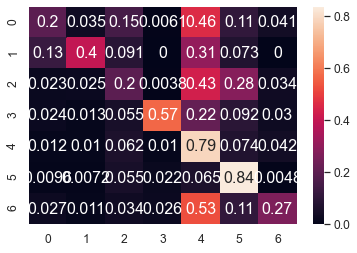

	training epoch=15 .. train_loss=1.149
	validation epoch=15 .. val_loss=1.411
	Accuracy = 47.599999999999994 % .. Percision = 50.9 % .. Recall = 46.5 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_15.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 16 .. loss = 0.857


  0%|                                                                                 | 1/1914 [00:01<40:18,  1.26s/it]

training @ epoch 16 .. loss = 1.291


  0%|                                                                                 | 2/1914 [00:02<39:57,  1.25s/it]

training @ epoch 16 .. loss = 0.979


  0%|▏                                                                                | 3/1914 [00:03<40:13,  1.26s/it]

training @ epoch 16 .. loss = 1.5


  0%|▏                                                                                | 4/1914 [00:05<39:53,  1.25s/it]

training @ epoch 16 .. loss = 0.624


  0%|▏                                                                                | 5/1914 [00:06<39:36,  1.24s/it]

training @ epoch 16 .. loss = 0.851


  0%|▎                                                                                | 6/1914 [00:07<39:27,  1.24s/it]

training @ epoch 16 .. loss = 1.094


  0%|▎                                                                                | 7/1914 [00:08<39:39,  1.25s/it]

training @ epoch 16 .. loss = 1.027


  0%|▎                                                                                | 8/1914 [00:09<39:25,  1.24s/it]

training @ epoch 16 .. loss = 0.899


  0%|▍                                                                                | 9/1914 [00:11<39:10,  1.23s/it]

training @ epoch 16 .. loss = 0.895


  1%|▍                                                                               | 10/1914 [00:12<39:09,  1.23s/it]

training @ epoch 16 .. loss = 1.161


  1%|▍                                                                               | 11/1914 [00:13<39:25,  1.24s/it]

training @ epoch 16 .. loss = 1.046


  1%|▌                                                                               | 12/1914 [00:14<39:06,  1.23s/it]

training @ epoch 16 .. loss = 1.128


  1%|▌                                                                               | 13/1914 [00:16<39:06,  1.23s/it]

training @ epoch 16 .. loss = 0.876


  1%|▌                                                                               | 14/1914 [00:17<38:53,  1.23s/it]

training @ epoch 16 .. loss = 1.02


  1%|▋                                                                               | 15/1914 [00:18<38:43,  1.22s/it]

training @ epoch 16 .. loss = 0.918


  1%|▋                                                                               | 16/1914 [00:19<39:17,  1.24s/it]

training @ epoch 16 .. loss = 0.859


  1%|▋                                                                               | 17/1914 [00:21<38:48,  1.23s/it]

training @ epoch 16 .. loss = 1.596


  1%|▊                                                                               | 18/1914 [00:22<38:55,  1.23s/it]

training @ epoch 16 .. loss = 1.036


  1%|▊                                                                               | 19/1914 [00:23<39:05,  1.24s/it]

training @ epoch 16 .. loss = 0.859


  1%|▊                                                                               | 20/1914 [00:24<38:56,  1.23s/it]

training @ epoch 16 .. loss = 1.286


  1%|▉                                                                               | 21/1914 [00:25<39:01,  1.24s/it]

training @ epoch 16 .. loss = 1.143


  1%|▉                                                                               | 22/1914 [00:27<38:45,  1.23s/it]

training @ epoch 16 .. loss = 1.141


  1%|▉                                                                               | 23/1914 [00:28<38:46,  1.23s/it]

training @ epoch 16 .. loss = 1.033


  1%|█                                                                               | 24/1914 [00:29<39:21,  1.25s/it]

training @ epoch 16 .. loss = 1.452


  1%|█                                                                               | 25/1914 [00:30<38:58,  1.24s/it]

training @ epoch 16 .. loss = 1.254


  1%|█                                                                               | 26/1914 [00:32<39:11,  1.25s/it]

training @ epoch 16 .. loss = 0.876


  1%|█▏                                                                              | 27/1914 [00:33<39:02,  1.24s/it]

training @ epoch 16 .. loss = 0.68


  1%|█▏                                                                              | 28/1914 [00:34<38:50,  1.24s/it]

training @ epoch 16 .. loss = 1.175


  2%|█▏                                                                              | 29/1914 [00:35<38:53,  1.24s/it]

training @ epoch 16 .. loss = 0.936


  2%|█▎                                                                              | 30/1914 [00:37<38:43,  1.23s/it]

training @ epoch 16 .. loss = 1.447


  2%|█▎                                                                              | 31/1914 [00:38<38:47,  1.24s/it]

training @ epoch 16 .. loss = 1.229


  2%|█▎                                                                              | 32/1914 [00:39<38:50,  1.24s/it]

training @ epoch 16 .. loss = 1.316


  2%|█▍                                                                              | 33/1914 [00:40<38:33,  1.23s/it]

training @ epoch 16 .. loss = 0.455


  2%|█▍                                                                              | 34/1914 [00:42<38:16,  1.22s/it]

training @ epoch 16 .. loss = 0.953


  2%|█▍                                                                              | 35/1914 [00:43<38:09,  1.22s/it]

training @ epoch 16 .. loss = 1.391


  2%|█▌                                                                              | 36/1914 [00:44<38:20,  1.23s/it]

training @ epoch 16 .. loss = 1.388


  2%|█▌                                                                              | 37/1914 [00:45<38:52,  1.24s/it]

training @ epoch 16 .. loss = 0.99


  2%|█▌                                                                              | 38/1914 [00:46<38:32,  1.23s/it]

training @ epoch 16 .. loss = 1.07


  2%|█▋                                                                              | 39/1914 [00:48<38:39,  1.24s/it]

training @ epoch 16 .. loss = 1.047


  2%|█▋                                                                              | 40/1914 [00:49<38:21,  1.23s/it]

training @ epoch 16 .. loss = 0.852


  2%|█▋                                                                              | 41/1914 [00:50<38:11,  1.22s/it]

training @ epoch 16 .. loss = 1.285


  2%|█▊                                                                              | 42/1914 [00:51<38:27,  1.23s/it]

training @ epoch 16 .. loss = 1.023


  2%|█▊                                                                              | 43/1914 [00:53<38:08,  1.22s/it]

training @ epoch 16 .. loss = 1.426


  2%|█▊                                                                              | 44/1914 [00:54<38:25,  1.23s/it]

training @ epoch 16 .. loss = 0.948


  2%|█▉                                                                              | 45/1914 [00:55<38:46,  1.24s/it]

training @ epoch 16 .. loss = 1.152


  2%|█▉                                                                              | 46/1914 [00:56<38:26,  1.23s/it]

training @ epoch 16 .. loss = 1.295


  2%|█▉                                                                              | 47/1914 [00:58<38:19,  1.23s/it]

training @ epoch 16 .. loss = 0.953


  3%|██                                                                              | 48/1914 [00:59<38:12,  1.23s/it]

training @ epoch 16 .. loss = 1.013


  3%|██                                                                              | 49/1914 [01:00<38:30,  1.24s/it]

training @ epoch 16 .. loss = 1.093


  3%|██                                                                              | 50/1914 [01:01<38:43,  1.25s/it]

training @ epoch 16 .. loss = 0.646


  3%|██▏                                                                             | 51/1914 [01:03<38:34,  1.24s/it]

training @ epoch 16 .. loss = 0.875


  3%|██▏                                                                             | 52/1914 [01:04<38:33,  1.24s/it]

training @ epoch 16 .. loss = 1.198


  3%|██▏                                                                             | 53/1914 [01:05<38:44,  1.25s/it]

training @ epoch 16 .. loss = 0.616


  3%|██▎                                                                             | 54/1914 [01:06<38:38,  1.25s/it]

training @ epoch 16 .. loss = 0.915


  3%|██▎                                                                             | 55/1914 [01:07<38:13,  1.23s/it]

training @ epoch 16 .. loss = 1.22


  3%|██▎                                                                             | 56/1914 [01:09<38:11,  1.23s/it]

training @ epoch 16 .. loss = 0.878


  3%|██▍                                                                             | 57/1914 [01:10<38:15,  1.24s/it]

training @ epoch 16 .. loss = 0.608


  3%|██▍                                                                             | 58/1914 [01:11<38:36,  1.25s/it]

training @ epoch 16 .. loss = 1.036


  3%|██▍                                                                             | 59/1914 [01:12<38:14,  1.24s/it]

training @ epoch 16 .. loss = 1.521


  3%|██▌                                                                             | 60/1914 [01:14<37:58,  1.23s/it]

training @ epoch 16 .. loss = 0.536


  3%|██▌                                                                             | 61/1914 [01:15<38:06,  1.23s/it]

training @ epoch 16 .. loss = 1.258


  3%|██▌                                                                             | 62/1914 [01:16<38:15,  1.24s/it]

training @ epoch 16 .. loss = 0.955


  3%|██▋                                                                             | 63/1914 [01:17<38:36,  1.25s/it]

training @ epoch 16 .. loss = 1.335


  3%|██▋                                                                             | 64/1914 [01:19<38:02,  1.23s/it]

training @ epoch 16 .. loss = 1.207


  3%|██▋                                                                             | 65/1914 [01:20<38:06,  1.24s/it]

training @ epoch 16 .. loss = 0.921


  3%|██▊                                                                             | 66/1914 [01:21<37:57,  1.23s/it]

training @ epoch 16 .. loss = 1.056


  4%|██▊                                                                             | 67/1914 [01:22<38:01,  1.24s/it]

training @ epoch 16 .. loss = 0.949


  4%|██▊                                                                             | 68/1914 [01:24<37:58,  1.23s/it]

training @ epoch 16 .. loss = 1.101


  4%|██▉                                                                             | 69/1914 [01:25<37:40,  1.23s/it]

training @ epoch 16 .. loss = 1.311


  4%|██▉                                                                             | 70/1914 [01:26<37:32,  1.22s/it]

training @ epoch 16 .. loss = 1.326


  4%|██▉                                                                             | 71/1914 [01:27<37:54,  1.23s/it]

training @ epoch 16 .. loss = 1.301


  4%|███                                                                             | 72/1914 [01:28<37:39,  1.23s/it]

training @ epoch 16 .. loss = 1.185


  4%|███                                                                             | 73/1914 [01:30<37:51,  1.23s/it]

training @ epoch 16 .. loss = 1.116


  4%|███                                                                             | 74/1914 [01:31<37:50,  1.23s/it]

training @ epoch 16 .. loss = 1.129


  4%|███▏                                                                            | 75/1914 [01:32<37:38,  1.23s/it]

training @ epoch 16 .. loss = 1.319


  4%|███▏                                                                            | 76/1914 [01:33<37:56,  1.24s/it]

training @ epoch 16 .. loss = 0.663


  4%|███▏                                                                            | 77/1914 [01:35<37:40,  1.23s/it]

training @ epoch 16 .. loss = 0.91


  4%|███▎                                                                            | 78/1914 [01:36<37:50,  1.24s/it]

training @ epoch 16 .. loss = 1.369


  4%|███▎                                                                            | 79/1914 [01:37<37:41,  1.23s/it]

training @ epoch 16 .. loss = 1.23


  4%|███▎                                                                            | 80/1914 [01:38<37:56,  1.24s/it]

training @ epoch 16 .. loss = 0.928


  4%|███▍                                                                            | 81/1914 [01:40<37:40,  1.23s/it]

training @ epoch 16 .. loss = 1.686


  4%|███▍                                                                            | 82/1914 [01:41<37:27,  1.23s/it]

training @ epoch 16 .. loss = 1.086


  4%|███▍                                                                            | 83/1914 [01:42<37:33,  1.23s/it]

training @ epoch 16 .. loss = 1.046


  4%|███▌                                                                            | 84/1914 [01:43<39:04,  1.28s/it]

training @ epoch 16 .. loss = 1.121


  4%|███▌                                                                            | 85/1914 [01:45<40:10,  1.32s/it]

training @ epoch 16 .. loss = 1.398


  4%|███▌                                                                            | 86/1914 [01:46<40:23,  1.33s/it]

training @ epoch 16 .. loss = 1.14


  5%|███▋                                                                            | 87/1914 [01:47<39:47,  1.31s/it]

training @ epoch 16 .. loss = 1.207


  5%|███▋                                                                            | 88/1914 [01:49<38:48,  1.27s/it]

training @ epoch 16 .. loss = 1.449


  5%|███▋                                                                            | 89/1914 [01:50<38:39,  1.27s/it]

training @ epoch 16 .. loss = 1.289


  5%|███▊                                                                            | 90/1914 [01:51<38:31,  1.27s/it]

training @ epoch 16 .. loss = 1.003


  5%|███▊                                                                            | 91/1914 [01:52<37:46,  1.24s/it]

training @ epoch 16 .. loss = 1.235


  5%|███▊                                                                            | 92/1914 [01:54<37:39,  1.24s/it]

training @ epoch 16 .. loss = 1.306


  5%|███▉                                                                            | 93/1914 [01:55<37:35,  1.24s/it]

training @ epoch 16 .. loss = 0.935


  5%|███▉                                                                            | 94/1914 [01:56<37:30,  1.24s/it]

training @ epoch 16 .. loss = 1.141


  5%|███▉                                                                            | 95/1914 [01:57<37:50,  1.25s/it]

training @ epoch 16 .. loss = 0.747


  5%|████                                                                            | 96/1914 [01:58<37:02,  1.22s/it]

training @ epoch 16 .. loss = 0.685


  5%|████                                                                            | 97/1914 [02:00<37:23,  1.24s/it]

training @ epoch 16 .. loss = 1.54


  5%|████                                                                            | 98/1914 [02:01<37:22,  1.23s/it]

training @ epoch 16 .. loss = 0.826


  5%|████▏                                                                           | 99/1914 [02:02<37:25,  1.24s/it]

training @ epoch 16 .. loss = 0.729


  5%|████▏                                                                          | 100/1914 [02:03<37:25,  1.24s/it]

training @ epoch 16 .. loss = 1.112


  5%|████▏                                                                          | 101/1914 [02:05<37:33,  1.24s/it]

training @ epoch 16 .. loss = 1.04


  5%|████▏                                                                          | 102/1914 [02:06<37:49,  1.25s/it]

training @ epoch 16 .. loss = 1.111


  5%|████▎                                                                          | 103/1914 [02:07<37:59,  1.26s/it]

training @ epoch 16 .. loss = 1.02


  5%|████▎                                                                          | 104/1914 [02:08<37:38,  1.25s/it]

training @ epoch 16 .. loss = 1.244


  5%|████▎                                                                          | 105/1914 [02:10<38:17,  1.27s/it]

training @ epoch 16 .. loss = 0.919


  6%|████▍                                                                          | 106/1914 [02:11<38:24,  1.27s/it]

training @ epoch 16 .. loss = 0.933


  6%|████▍                                                                          | 107/1914 [02:12<38:00,  1.26s/it]

training @ epoch 16 .. loss = 1.383


  6%|████▍                                                                          | 108/1914 [02:14<37:54,  1.26s/it]

training @ epoch 16 .. loss = 1.049


  6%|████▍                                                                          | 109/1914 [02:15<37:42,  1.25s/it]

training @ epoch 16 .. loss = 0.882


  6%|████▌                                                                          | 110/1914 [02:16<37:30,  1.25s/it]

training @ epoch 16 .. loss = 0.934


  6%|████▌                                                                          | 111/1914 [02:17<37:38,  1.25s/it]

training @ epoch 16 .. loss = 1.306


  6%|████▌                                                                          | 112/1914 [02:19<37:20,  1.24s/it]

training @ epoch 16 .. loss = 0.824


  6%|████▋                                                                          | 113/1914 [02:20<37:18,  1.24s/it]

training @ epoch 16 .. loss = 1.248


  6%|████▋                                                                          | 114/1914 [02:21<36:55,  1.23s/it]

training @ epoch 16 .. loss = 1.215


  6%|████▋                                                                          | 115/1914 [02:22<36:50,  1.23s/it]

training @ epoch 16 .. loss = 1.195


  6%|████▊                                                                          | 116/1914 [02:23<37:02,  1.24s/it]

training @ epoch 16 .. loss = 1.18


  6%|████▊                                                                          | 117/1914 [02:25<37:02,  1.24s/it]

training @ epoch 16 .. loss = 0.98


  6%|████▊                                                                          | 118/1914 [02:26<36:52,  1.23s/it]

training @ epoch 16 .. loss = 1.767


  6%|████▉                                                                          | 119/1914 [02:27<37:08,  1.24s/it]

training @ epoch 16 .. loss = 1.087


  6%|████▉                                                                          | 120/1914 [02:28<36:45,  1.23s/it]

training @ epoch 16 .. loss = 0.807


  6%|████▉                                                                          | 121/1914 [02:30<36:51,  1.23s/it]

training @ epoch 16 .. loss = 0.807


  6%|█████                                                                          | 122/1914 [02:31<36:54,  1.24s/it]

training @ epoch 16 .. loss = 1.218


  6%|█████                                                                          | 123/1914 [02:32<36:58,  1.24s/it]

training @ epoch 16 .. loss = 1.217


  6%|█████                                                                          | 124/1914 [02:33<36:59,  1.24s/it]

training @ epoch 16 .. loss = 1.452


  7%|█████▏                                                                         | 125/1914 [02:35<36:40,  1.23s/it]

training @ epoch 16 .. loss = 1.415


  7%|█████▏                                                                         | 126/1914 [02:36<37:08,  1.25s/it]

training @ epoch 16 .. loss = 1.116


  7%|█████▏                                                                         | 127/1914 [02:37<36:49,  1.24s/it]

training @ epoch 16 .. loss = 1.051


  7%|█████▎                                                                         | 128/1914 [02:38<36:51,  1.24s/it]

training @ epoch 16 .. loss = 0.72


  7%|█████▎                                                                         | 129/1914 [02:40<36:57,  1.24s/it]

training @ epoch 16 .. loss = 1.044


  7%|█████▎                                                                         | 130/1914 [02:41<38:49,  1.31s/it]

training @ epoch 16 .. loss = 1.473


  7%|█████▍                                                                         | 131/1914 [02:42<39:41,  1.34s/it]

training @ epoch 16 .. loss = 1.156


  7%|█████▍                                                                         | 132/1914 [02:44<39:50,  1.34s/it]

training @ epoch 16 .. loss = 0.972


  7%|█████▍                                                                         | 133/1914 [02:45<40:02,  1.35s/it]

training @ epoch 16 .. loss = 1.113


  7%|█████▌                                                                         | 134/1914 [02:46<39:08,  1.32s/it]

training @ epoch 16 .. loss = 0.803


  7%|█████▌                                                                         | 135/1914 [02:48<38:20,  1.29s/it]

training @ epoch 16 .. loss = 1.084


  7%|█████▌                                                                         | 136/1914 [02:49<37:25,  1.26s/it]

training @ epoch 16 .. loss = 1.125


  7%|█████▋                                                                         | 137/1914 [02:50<36:50,  1.24s/it]

training @ epoch 16 .. loss = 1.253


  7%|█████▋                                                                         | 138/1914 [02:51<36:54,  1.25s/it]

training @ epoch 16 .. loss = 1.51


  7%|█████▋                                                                         | 139/1914 [02:53<36:46,  1.24s/it]

training @ epoch 16 .. loss = 0.931


  7%|█████▊                                                                         | 140/1914 [02:54<36:28,  1.23s/it]

training @ epoch 16 .. loss = 0.877


  7%|█████▊                                                                         | 141/1914 [02:55<36:15,  1.23s/it]

training @ epoch 16 .. loss = 1.009


  7%|█████▊                                                                         | 142/1914 [02:56<36:29,  1.24s/it]

training @ epoch 16 .. loss = 1.128


  7%|█████▉                                                                         | 143/1914 [02:57<36:48,  1.25s/it]

training @ epoch 16 .. loss = 1.04


  8%|█████▉                                                                         | 144/1914 [02:59<36:13,  1.23s/it]

training @ epoch 16 .. loss = 1.359


  8%|█████▉                                                                         | 145/1914 [03:00<36:19,  1.23s/it]

training @ epoch 16 .. loss = 1.017


  8%|██████                                                                         | 146/1914 [03:01<36:34,  1.24s/it]

training @ epoch 16 .. loss = 0.803


  8%|██████                                                                         | 147/1914 [03:02<36:17,  1.23s/it]

training @ epoch 16 .. loss = 1.01


  8%|██████                                                                         | 148/1914 [03:04<38:29,  1.31s/it]

training @ epoch 16 .. loss = 0.896


  8%|██████▏                                                                        | 149/1914 [03:05<40:02,  1.36s/it]

training @ epoch 16 .. loss = 1.496


  8%|██████▏                                                                        | 150/1914 [03:07<39:43,  1.35s/it]

training @ epoch 16 .. loss = 1.073


  8%|██████▏                                                                        | 151/1914 [03:08<38:34,  1.31s/it]

training @ epoch 16 .. loss = 1.121


  8%|██████▎                                                                        | 152/1914 [03:09<38:16,  1.30s/it]

training @ epoch 16 .. loss = 1.377


  8%|██████▎                                                                        | 153/1914 [03:10<37:38,  1.28s/it]

training @ epoch 16 .. loss = 0.486


  8%|██████▎                                                                        | 154/1914 [03:12<36:49,  1.26s/it]

training @ epoch 16 .. loss = 1.357


  8%|██████▍                                                                        | 155/1914 [03:13<36:24,  1.24s/it]

training @ epoch 16 .. loss = 1.034


  8%|██████▍                                                                        | 156/1914 [03:14<36:00,  1.23s/it]

training @ epoch 16 .. loss = 1.102


  8%|██████▍                                                                        | 157/1914 [03:15<35:57,  1.23s/it]

training @ epoch 16 .. loss = 1.058


  8%|██████▌                                                                        | 158/1914 [03:16<35:47,  1.22s/it]

training @ epoch 16 .. loss = 1.271


  8%|██████▌                                                                        | 159/1914 [03:18<35:51,  1.23s/it]

training @ epoch 16 .. loss = 1.081


  8%|██████▌                                                                        | 160/1914 [03:19<35:41,  1.22s/it]

training @ epoch 16 .. loss = 1.061


  8%|██████▋                                                                        | 161/1914 [03:20<35:51,  1.23s/it]

training @ epoch 16 .. loss = 1.713


  8%|██████▋                                                                        | 162/1914 [03:21<36:09,  1.24s/it]

training @ epoch 16 .. loss = 1.471


  9%|██████▋                                                                        | 163/1914 [03:23<35:33,  1.22s/it]

training @ epoch 16 .. loss = 1.029


  9%|██████▊                                                                        | 164/1914 [03:24<35:49,  1.23s/it]

training @ epoch 16 .. loss = 1.144


  9%|██████▊                                                                        | 165/1914 [03:25<35:39,  1.22s/it]

training @ epoch 16 .. loss = 1.269


  9%|██████▊                                                                        | 166/1914 [03:26<35:54,  1.23s/it]

training @ epoch 16 .. loss = 0.875


  9%|██████▉                                                                        | 167/1914 [03:28<35:58,  1.24s/it]

training @ epoch 16 .. loss = 0.98


  9%|██████▉                                                                        | 168/1914 [03:29<35:36,  1.22s/it]

training @ epoch 16 .. loss = 1.096


  9%|██████▉                                                                        | 169/1914 [03:30<35:50,  1.23s/it]

training @ epoch 16 .. loss = 1.049


  9%|███████                                                                        | 170/1914 [03:31<36:00,  1.24s/it]

training @ epoch 16 .. loss = 0.65


  9%|███████                                                                        | 171/1914 [03:32<35:47,  1.23s/it]

training @ epoch 16 .. loss = 1.318


  9%|███████                                                                        | 172/1914 [03:34<35:48,  1.23s/it]

training @ epoch 16 .. loss = 1.039


  9%|███████▏                                                                       | 173/1914 [03:35<35:45,  1.23s/it]

training @ epoch 16 .. loss = 1.139


  9%|███████▏                                                                       | 174/1914 [03:36<35:33,  1.23s/it]

training @ epoch 16 .. loss = 1.031


  9%|███████▏                                                                       | 175/1914 [03:37<36:02,  1.24s/it]

training @ epoch 16 .. loss = 1.036


  9%|███████▎                                                                       | 176/1914 [03:39<35:55,  1.24s/it]

training @ epoch 16 .. loss = 0.688


  9%|███████▎                                                                       | 177/1914 [03:40<35:53,  1.24s/it]

training @ epoch 16 .. loss = 1.279


  9%|███████▎                                                                       | 178/1914 [03:41<35:52,  1.24s/it]

training @ epoch 16 .. loss = 1.425


  9%|███████▍                                                                       | 179/1914 [03:42<35:21,  1.22s/it]

training @ epoch 16 .. loss = 0.996


  9%|███████▍                                                                       | 180/1914 [03:44<35:35,  1.23s/it]

training @ epoch 16 .. loss = 1.047


  9%|███████▍                                                                       | 181/1914 [03:45<35:13,  1.22s/it]

training @ epoch 16 .. loss = 1.144


 10%|███████▌                                                                       | 182/1914 [03:46<35:30,  1.23s/it]

training @ epoch 16 .. loss = 1.228


 10%|███████▌                                                                       | 183/1914 [03:47<35:55,  1.25s/it]

training @ epoch 16 .. loss = 1.473


 10%|███████▌                                                                       | 184/1914 [03:48<35:47,  1.24s/it]

training @ epoch 16 .. loss = 1.04


 10%|███████▋                                                                       | 185/1914 [03:50<35:52,  1.24s/it]

training @ epoch 16 .. loss = 1.045


 10%|███████▋                                                                       | 186/1914 [03:51<35:39,  1.24s/it]

training @ epoch 16 .. loss = 1.521


 10%|███████▋                                                                       | 187/1914 [03:52<35:51,  1.25s/it]

training @ epoch 16 .. loss = 0.828


 10%|███████▊                                                                       | 188/1914 [03:53<35:54,  1.25s/it]

training @ epoch 16 .. loss = 0.88


 10%|███████▊                                                                       | 189/1914 [03:55<35:13,  1.23s/it]

training @ epoch 16 .. loss = 0.817


 10%|███████▊                                                                       | 190/1914 [03:56<35:09,  1.22s/it]

training @ epoch 16 .. loss = 1.26


 10%|███████▉                                                                       | 191/1914 [03:57<35:01,  1.22s/it]

training @ epoch 16 .. loss = 1.358


 10%|███████▉                                                                       | 192/1914 [03:58<35:11,  1.23s/it]

training @ epoch 16 .. loss = 1.02


 10%|███████▉                                                                       | 193/1914 [04:00<35:13,  1.23s/it]

training @ epoch 16 .. loss = 1.332


 10%|████████                                                                       | 194/1914 [04:01<35:14,  1.23s/it]

training @ epoch 16 .. loss = 1.101


 10%|████████                                                                       | 195/1914 [04:02<35:04,  1.22s/it]

training @ epoch 16 .. loss = 0.975


 10%|████████                                                                       | 196/1914 [04:03<35:34,  1.24s/it]

training @ epoch 16 .. loss = 1.424


 10%|████████▏                                                                      | 197/1914 [04:05<35:22,  1.24s/it]

training @ epoch 16 .. loss = 1.098


 10%|████████▏                                                                      | 198/1914 [04:06<35:14,  1.23s/it]

training @ epoch 16 .. loss = 1.366


 10%|████████▏                                                                      | 199/1914 [04:07<35:39,  1.25s/it]

training @ epoch 16 .. loss = 0.982


 10%|████████▎                                                                      | 200/1914 [04:08<36:12,  1.27s/it]

training @ epoch 16 .. loss = 0.929


 11%|████████▎                                                                      | 201/1914 [04:10<39:42,  1.39s/it]

training @ epoch 16 .. loss = 1.192


 11%|████████▎                                                                      | 202/1914 [04:11<39:27,  1.38s/it]

training @ epoch 16 .. loss = 1.064


 11%|████████▍                                                                      | 203/1914 [04:13<39:09,  1.37s/it]

training @ epoch 16 .. loss = 1.029


 11%|████████▍                                                                      | 204/1914 [04:14<40:42,  1.43s/it]

training @ epoch 16 .. loss = 1.041


 11%|████████▍                                                                      | 205/1914 [04:16<40:34,  1.42s/it]

training @ epoch 16 .. loss = 0.766


 11%|████████▌                                                                      | 206/1914 [04:17<38:35,  1.36s/it]

training @ epoch 16 .. loss = 0.93


 11%|████████▌                                                                      | 207/1914 [04:18<37:44,  1.33s/it]

training @ epoch 16 .. loss = 1.282


 11%|████████▌                                                                      | 208/1914 [04:19<37:11,  1.31s/it]

training @ epoch 16 .. loss = 1.063


 11%|████████▋                                                                      | 209/1914 [04:21<36:11,  1.27s/it]

training @ epoch 16 .. loss = 0.901


 11%|████████▋                                                                      | 210/1914 [04:22<36:01,  1.27s/it]

training @ epoch 16 .. loss = 0.765


 11%|████████▋                                                                      | 211/1914 [04:23<35:44,  1.26s/it]

training @ epoch 16 .. loss = 0.809


 11%|████████▊                                                                      | 212/1914 [04:24<35:34,  1.25s/it]

training @ epoch 16 .. loss = 0.826


 11%|████████▊                                                                      | 213/1914 [04:26<35:32,  1.25s/it]

training @ epoch 16 .. loss = 1.056


 11%|████████▊                                                                      | 214/1914 [04:27<35:15,  1.24s/it]

training @ epoch 16 .. loss = 0.559


 11%|████████▊                                                                      | 215/1914 [04:28<35:22,  1.25s/it]

training @ epoch 16 .. loss = 1.193


 11%|████████▉                                                                      | 216/1914 [04:29<35:33,  1.26s/it]

training @ epoch 16 .. loss = 0.876


 11%|████████▉                                                                      | 217/1914 [04:31<34:54,  1.23s/it]

training @ epoch 16 .. loss = 0.698


 11%|████████▉                                                                      | 218/1914 [04:32<34:59,  1.24s/it]

training @ epoch 16 .. loss = 1.394


 11%|█████████                                                                      | 219/1914 [04:33<35:03,  1.24s/it]

training @ epoch 16 .. loss = 0.96


 11%|█████████                                                                      | 220/1914 [04:34<34:58,  1.24s/it]

training @ epoch 16 .. loss = 1.24


 12%|█████████                                                                      | 221/1914 [04:36<35:18,  1.25s/it]

training @ epoch 16 .. loss = 1.55


 12%|█████████▏                                                                     | 222/1914 [04:37<35:04,  1.24s/it]

training @ epoch 16 .. loss = 0.821


 12%|█████████▏                                                                     | 223/1914 [04:38<35:58,  1.28s/it]

training @ epoch 16 .. loss = 1.267


 12%|█████████▏                                                                     | 224/1914 [04:39<36:22,  1.29s/it]

training @ epoch 16 .. loss = 1.246


 12%|█████████▎                                                                     | 225/1914 [04:41<37:17,  1.32s/it]

training @ epoch 16 .. loss = 1.686


 12%|█████████▎                                                                     | 226/1914 [04:42<38:21,  1.36s/it]

training @ epoch 16 .. loss = 1.303


 12%|█████████▎                                                                     | 227/1914 [04:44<39:38,  1.41s/it]

training @ epoch 16 .. loss = 0.906


 12%|█████████▍                                                                     | 228/1914 [04:45<39:26,  1.40s/it]

training @ epoch 16 .. loss = 0.993


 12%|█████████▍                                                                     | 229/1914 [04:47<39:39,  1.41s/it]

training @ epoch 16 .. loss = 1.217


 12%|█████████▍                                                                     | 230/1914 [04:48<40:21,  1.44s/it]

training @ epoch 16 .. loss = 1.192


 12%|█████████▌                                                                     | 231/1914 [04:50<41:33,  1.48s/it]

training @ epoch 16 .. loss = 1.253


 12%|█████████▌                                                                     | 232/1914 [04:51<41:24,  1.48s/it]

training @ epoch 16 .. loss = 1.244


 12%|█████████▌                                                                     | 233/1914 [04:53<40:35,  1.45s/it]

training @ epoch 16 .. loss = 1.215


 12%|█████████▋                                                                     | 234/1914 [04:54<39:41,  1.42s/it]

training @ epoch 16 .. loss = 1.664


 12%|█████████▋                                                                     | 235/1914 [04:55<39:28,  1.41s/it]

training @ epoch 16 .. loss = 1.044


 12%|█████████▋                                                                     | 236/1914 [04:57<38:48,  1.39s/it]

training @ epoch 16 .. loss = 1.001


 12%|█████████▊                                                                     | 237/1914 [04:58<38:23,  1.37s/it]

training @ epoch 16 .. loss = 0.839


 12%|█████████▊                                                                     | 238/1914 [04:59<38:49,  1.39s/it]

training @ epoch 16 .. loss = 1.088


 12%|█████████▊                                                                     | 239/1914 [05:01<39:20,  1.41s/it]

training @ epoch 16 .. loss = 1.27


 13%|█████████▉                                                                     | 240/1914 [05:02<39:44,  1.42s/it]

training @ epoch 16 .. loss = 1.068


 13%|█████████▉                                                                     | 241/1914 [05:04<39:50,  1.43s/it]

training @ epoch 16 .. loss = 1.004


 13%|█████████▉                                                                     | 242/1914 [05:05<38:06,  1.37s/it]

training @ epoch 16 .. loss = 1.25


 13%|██████████                                                                     | 243/1914 [05:06<37:11,  1.34s/it]

training @ epoch 16 .. loss = 1.421


 13%|██████████                                                                     | 244/1914 [05:08<36:39,  1.32s/it]

training @ epoch 16 .. loss = 1.288


 13%|██████████                                                                     | 245/1914 [05:09<36:06,  1.30s/it]

training @ epoch 16 .. loss = 0.807


 13%|██████████▏                                                                    | 246/1914 [05:10<35:18,  1.27s/it]

training @ epoch 16 .. loss = 1.345


 13%|██████████▏                                                                    | 247/1914 [05:11<35:08,  1.26s/it]

training @ epoch 16 .. loss = 0.994


 13%|██████████▏                                                                    | 248/1914 [05:12<34:46,  1.25s/it]

training @ epoch 16 .. loss = 1.069


 13%|██████████▎                                                                    | 249/1914 [05:14<34:42,  1.25s/it]

training @ epoch 16 .. loss = 1.358


 13%|██████████▎                                                                    | 250/1914 [05:15<34:34,  1.25s/it]

training @ epoch 16 .. loss = 0.924


 13%|██████████▎                                                                    | 251/1914 [05:16<34:29,  1.24s/it]

training @ epoch 16 .. loss = 1.33


 13%|██████████▍                                                                    | 252/1914 [05:17<34:33,  1.25s/it]

training @ epoch 16 .. loss = 0.762


 13%|██████████▍                                                                    | 253/1914 [05:19<34:15,  1.24s/it]

training @ epoch 16 .. loss = 1.162


 13%|██████████▍                                                                    | 254/1914 [05:20<34:06,  1.23s/it]

training @ epoch 16 .. loss = 1.355


 13%|██████████▌                                                                    | 255/1914 [05:21<34:11,  1.24s/it]

training @ epoch 16 .. loss = 1.693


 13%|██████████▌                                                                    | 256/1914 [05:22<34:19,  1.24s/it]

training @ epoch 16 .. loss = 1.23


 13%|██████████▌                                                                    | 257/1914 [05:24<34:08,  1.24s/it]

training @ epoch 16 .. loss = 1.006


 13%|██████████▋                                                                    | 258/1914 [05:25<34:04,  1.23s/it]

training @ epoch 16 .. loss = 1.195


 14%|██████████▋                                                                    | 259/1914 [05:26<34:03,  1.23s/it]

training @ epoch 16 .. loss = 0.978


 14%|██████████▋                                                                    | 260/1914 [05:27<34:05,  1.24s/it]

training @ epoch 16 .. loss = 1.105


 14%|██████████▊                                                                    | 261/1914 [05:29<33:43,  1.22s/it]

training @ epoch 16 .. loss = 0.925


 14%|██████████▊                                                                    | 262/1914 [05:30<33:56,  1.23s/it]

training @ epoch 16 .. loss = 1.457


 14%|██████████▊                                                                    | 263/1914 [05:31<33:55,  1.23s/it]

training @ epoch 16 .. loss = 1.115


 14%|██████████▉                                                                    | 264/1914 [05:32<33:58,  1.24s/it]

training @ epoch 16 .. loss = 0.944


 14%|██████████▉                                                                    | 265/1914 [05:33<33:46,  1.23s/it]

training @ epoch 16 .. loss = 0.695


 14%|██████████▉                                                                    | 266/1914 [05:35<33:31,  1.22s/it]

training @ epoch 16 .. loss = 1.204


 14%|███████████                                                                    | 267/1914 [05:36<33:37,  1.22s/it]

training @ epoch 16 .. loss = 1.14


 14%|███████████                                                                    | 268/1914 [05:37<33:50,  1.23s/it]

training @ epoch 16 .. loss = 1.227


 14%|███████████                                                                    | 269/1914 [05:38<33:38,  1.23s/it]

training @ epoch 16 .. loss = 1.038


 14%|███████████▏                                                                   | 270/1914 [05:40<33:34,  1.23s/it]

training @ epoch 16 .. loss = 1.521


 14%|███████████▏                                                                   | 271/1914 [05:41<33:41,  1.23s/it]

training @ epoch 16 .. loss = 1.181


 14%|███████████▏                                                                   | 272/1914 [05:42<33:31,  1.23s/it]

training @ epoch 16 .. loss = 1.211


 14%|███████████▎                                                                   | 273/1914 [05:43<33:49,  1.24s/it]

training @ epoch 16 .. loss = 1.164


 14%|███████████▎                                                                   | 274/1914 [05:44<33:16,  1.22s/it]

training @ epoch 16 .. loss = 0.894


 14%|███████████▎                                                                   | 275/1914 [05:46<33:17,  1.22s/it]

training @ epoch 16 .. loss = 0.927


 14%|███████████▍                                                                   | 276/1914 [05:47<33:23,  1.22s/it]

training @ epoch 16 .. loss = 1.254


 14%|███████████▍                                                                   | 277/1914 [05:48<33:47,  1.24s/it]

training @ epoch 16 .. loss = 0.761


 15%|███████████▍                                                                   | 278/1914 [05:49<33:57,  1.25s/it]

training @ epoch 16 .. loss = 1.141


 15%|███████████▌                                                                   | 279/1914 [05:51<33:36,  1.23s/it]

training @ epoch 16 .. loss = 1.135


 15%|███████████▌                                                                   | 280/1914 [05:52<33:30,  1.23s/it]

training @ epoch 16 .. loss = 1.101


 15%|███████████▌                                                                   | 281/1914 [05:53<33:39,  1.24s/it]

training @ epoch 16 .. loss = 1.256


 15%|███████████▋                                                                   | 282/1914 [05:54<33:55,  1.25s/it]

training @ epoch 16 .. loss = 1.704


 15%|███████████▋                                                                   | 283/1914 [05:56<34:12,  1.26s/it]

training @ epoch 16 .. loss = 1.314


 15%|███████████▋                                                                   | 284/1914 [05:57<34:03,  1.25s/it]

training @ epoch 16 .. loss = 1.127


 15%|███████████▊                                                                   | 285/1914 [05:58<33:52,  1.25s/it]

training @ epoch 16 .. loss = 1.012


 15%|███████████▊                                                                   | 286/1914 [05:59<33:57,  1.25s/it]

training @ epoch 16 .. loss = 0.967


 15%|███████████▊                                                                   | 287/1914 [06:01<33:41,  1.24s/it]

training @ epoch 16 .. loss = 0.986


 15%|███████████▉                                                                   | 288/1914 [06:02<33:40,  1.24s/it]

training @ epoch 16 .. loss = 0.956


 15%|███████████▉                                                                   | 289/1914 [06:03<33:39,  1.24s/it]

training @ epoch 16 .. loss = 1.143


 15%|███████████▉                                                                   | 290/1914 [06:04<33:17,  1.23s/it]

training @ epoch 16 .. loss = 1.275


 15%|████████████                                                                   | 291/1914 [06:06<33:15,  1.23s/it]

training @ epoch 16 .. loss = 0.913


 15%|████████████                                                                   | 292/1914 [06:07<33:05,  1.22s/it]

training @ epoch 16 .. loss = 1.205


 15%|████████████                                                                   | 293/1914 [06:08<33:43,  1.25s/it]

training @ epoch 16 .. loss = 1.336


 15%|████████████▏                                                                  | 294/1914 [06:09<33:48,  1.25s/it]

training @ epoch 16 .. loss = 1.348


 15%|████████████▏                                                                  | 295/1914 [06:11<33:13,  1.23s/it]

training @ epoch 16 .. loss = 1.397


 15%|████████████▏                                                                  | 296/1914 [06:12<33:22,  1.24s/it]

training @ epoch 16 .. loss = 1.106


 16%|████████████▎                                                                  | 297/1914 [06:13<33:19,  1.24s/it]

training @ epoch 16 .. loss = 1.649


 16%|████████████▎                                                                  | 298/1914 [06:14<33:15,  1.23s/it]

training @ epoch 16 .. loss = 1.014


 16%|████████████▎                                                                  | 299/1914 [06:15<33:03,  1.23s/it]

training @ epoch 16 .. loss = 0.892


 16%|████████████▍                                                                  | 300/1914 [06:17<32:50,  1.22s/it]

training @ epoch 16 .. loss = 1.299


 16%|████████████▍                                                                  | 301/1914 [06:18<32:50,  1.22s/it]

training @ epoch 16 .. loss = 0.774


 16%|████████████▍                                                                  | 302/1914 [06:19<32:59,  1.23s/it]

training @ epoch 16 .. loss = 0.971


 16%|████████████▌                                                                  | 303/1914 [06:20<32:41,  1.22s/it]

training @ epoch 16 .. loss = 0.999


 16%|████████████▌                                                                  | 304/1914 [06:22<32:46,  1.22s/it]

training @ epoch 16 .. loss = 1.267


 16%|████████████▌                                                                  | 305/1914 [06:23<32:45,  1.22s/it]

training @ epoch 16 .. loss = 0.984


 16%|████████████▋                                                                  | 306/1914 [06:24<32:48,  1.22s/it]

training @ epoch 16 .. loss = 1.669


 16%|████████████▋                                                                  | 307/1914 [06:25<33:17,  1.24s/it]

training @ epoch 16 .. loss = 0.862


 16%|████████████▋                                                                  | 308/1914 [06:26<32:46,  1.22s/it]

training @ epoch 16 .. loss = 1.083


 16%|████████████▊                                                                  | 309/1914 [06:28<32:59,  1.23s/it]

training @ epoch 16 .. loss = 0.705


 16%|████████████▊                                                                  | 310/1914 [06:29<32:43,  1.22s/it]

training @ epoch 16 .. loss = 1.268


 16%|████████████▊                                                                  | 311/1914 [06:30<32:41,  1.22s/it]

training @ epoch 16 .. loss = 0.74


 16%|████████████▉                                                                  | 312/1914 [06:31<33:09,  1.24s/it]

training @ epoch 16 .. loss = 1.09


 16%|████████████▉                                                                  | 313/1914 [06:33<32:34,  1.22s/it]

training @ epoch 16 .. loss = 0.757


 16%|████████████▉                                                                  | 314/1914 [06:34<32:49,  1.23s/it]

training @ epoch 16 .. loss = 0.753


 16%|█████████████                                                                  | 315/1914 [06:35<32:47,  1.23s/it]

training @ epoch 16 .. loss = 1.469


 17%|█████████████                                                                  | 316/1914 [06:37<35:03,  1.32s/it]

training @ epoch 16 .. loss = 0.759


 17%|█████████████                                                                  | 317/1914 [06:38<34:22,  1.29s/it]

training @ epoch 16 .. loss = 1.375


 17%|█████████████▏                                                                 | 318/1914 [06:39<33:57,  1.28s/it]

training @ epoch 16 .. loss = 0.882


 17%|█████████████▏                                                                 | 319/1914 [06:40<33:26,  1.26s/it]

training @ epoch 16 .. loss = 1.373


 17%|█████████████▏                                                                 | 320/1914 [06:42<33:22,  1.26s/it]

training @ epoch 16 .. loss = 1.041


 17%|█████████████▏                                                                 | 321/1914 [06:43<33:05,  1.25s/it]

training @ epoch 16 .. loss = 1.063


 17%|█████████████▎                                                                 | 322/1914 [06:44<32:48,  1.24s/it]

training @ epoch 16 .. loss = 0.901


 17%|█████████████▎                                                                 | 323/1914 [06:45<33:07,  1.25s/it]

training @ epoch 16 .. loss = 1.105


 17%|█████████████▎                                                                 | 324/1914 [06:47<33:11,  1.25s/it]

training @ epoch 16 .. loss = 1.049


 17%|█████████████▍                                                                 | 325/1914 [06:48<33:15,  1.26s/it]

training @ epoch 16 .. loss = 1.799


 17%|█████████████▍                                                                 | 326/1914 [06:49<32:58,  1.25s/it]

training @ epoch 16 .. loss = 1.109


 17%|█████████████▍                                                                 | 327/1914 [06:50<32:56,  1.25s/it]

training @ epoch 16 .. loss = 1.192


 17%|█████████████▌                                                                 | 328/1914 [06:51<32:53,  1.24s/it]

training @ epoch 16 .. loss = 1.062


 17%|█████████████▌                                                                 | 329/1914 [06:53<32:32,  1.23s/it]

training @ epoch 16 .. loss = 0.961


 17%|█████████████▌                                                                 | 330/1914 [06:54<32:41,  1.24s/it]

training @ epoch 16 .. loss = 1.177


 17%|█████████████▋                                                                 | 331/1914 [06:55<32:47,  1.24s/it]

training @ epoch 16 .. loss = 1.433


 17%|█████████████▋                                                                 | 332/1914 [06:56<32:21,  1.23s/it]

training @ epoch 16 .. loss = 1.15


 17%|█████████████▋                                                                 | 333/1914 [06:58<32:42,  1.24s/it]

training @ epoch 16 .. loss = 1.018


 17%|█████████████▊                                                                 | 334/1914 [06:59<32:36,  1.24s/it]

training @ epoch 16 .. loss = 1.025


 18%|█████████████▊                                                                 | 335/1914 [07:00<33:01,  1.26s/it]

training @ epoch 16 .. loss = 1.14


 18%|█████████████▊                                                                 | 336/1914 [07:01<32:54,  1.25s/it]

training @ epoch 16 .. loss = 1.214


 18%|█████████████▉                                                                 | 337/1914 [07:03<32:39,  1.24s/it]

training @ epoch 16 .. loss = 1.228


 18%|█████████████▉                                                                 | 338/1914 [07:04<32:42,  1.25s/it]

training @ epoch 16 .. loss = 1.015


 18%|█████████████▉                                                                 | 339/1914 [07:05<32:46,  1.25s/it]

training @ epoch 16 .. loss = 1.021


 18%|██████████████                                                                 | 340/1914 [07:06<32:27,  1.24s/it]

training @ epoch 16 .. loss = 1.039


 18%|██████████████                                                                 | 341/1914 [07:08<32:24,  1.24s/it]

training @ epoch 16 .. loss = 1.682


 18%|██████████████                                                                 | 342/1914 [07:09<32:50,  1.25s/it]

training @ epoch 16 .. loss = 1.149


 18%|██████████████▏                                                                | 343/1914 [07:10<32:44,  1.25s/it]

training @ epoch 16 .. loss = 1.753


 18%|██████████████▏                                                                | 344/1914 [07:11<32:29,  1.24s/it]

training @ epoch 16 .. loss = 1.476


 18%|██████████████▏                                                                | 345/1914 [07:13<32:10,  1.23s/it]

training @ epoch 16 .. loss = 1.606


 18%|██████████████▎                                                                | 346/1914 [07:14<32:10,  1.23s/it]

training @ epoch 16 .. loss = 1.035


 18%|██████████████▎                                                                | 347/1914 [07:15<32:00,  1.23s/it]

training @ epoch 16 .. loss = 1.119


 18%|██████████████▎                                                                | 348/1914 [07:16<31:52,  1.22s/it]

training @ epoch 16 .. loss = 1.143


 18%|██████████████▍                                                                | 349/1914 [07:17<32:01,  1.23s/it]

training @ epoch 16 .. loss = 1.346


 18%|██████████████▍                                                                | 350/1914 [07:19<32:11,  1.23s/it]

training @ epoch 16 .. loss = 1.13


 18%|██████████████▍                                                                | 351/1914 [07:20<32:19,  1.24s/it]

training @ epoch 16 .. loss = 1.004


 18%|██████████████▌                                                                | 352/1914 [07:21<32:28,  1.25s/it]

training @ epoch 16 .. loss = 0.938


 18%|██████████████▌                                                                | 353/1914 [07:22<32:06,  1.23s/it]

training @ epoch 16 .. loss = 1.263


 18%|██████████████▌                                                                | 354/1914 [07:24<32:23,  1.25s/it]

training @ epoch 16 .. loss = 1.226


 19%|██████████████▋                                                                | 355/1914 [07:25<32:15,  1.24s/it]

training @ epoch 16 .. loss = 1.172


 19%|██████████████▋                                                                | 356/1914 [07:26<32:01,  1.23s/it]

training @ epoch 16 .. loss = 0.976


 19%|██████████████▋                                                                | 357/1914 [07:27<32:00,  1.23s/it]

training @ epoch 16 .. loss = 0.924


 19%|██████████████▊                                                                | 358/1914 [07:29<31:49,  1.23s/it]

training @ epoch 16 .. loss = 1.298


 19%|██████████████▊                                                                | 359/1914 [07:30<31:47,  1.23s/it]

training @ epoch 16 .. loss = 1.351


 19%|██████████████▊                                                                | 360/1914 [07:31<31:48,  1.23s/it]

training @ epoch 16 .. loss = 0.714


 19%|██████████████▉                                                                | 361/1914 [07:32<31:49,  1.23s/it]

training @ epoch 16 .. loss = 0.874


 19%|██████████████▉                                                                | 362/1914 [07:33<31:31,  1.22s/it]

training @ epoch 16 .. loss = 1.347


 19%|██████████████▉                                                                | 363/1914 [07:35<31:50,  1.23s/it]

training @ epoch 16 .. loss = 0.969


 19%|███████████████                                                                | 364/1914 [07:36<31:45,  1.23s/it]

training @ epoch 16 .. loss = 0.82


 19%|███████████████                                                                | 365/1914 [07:37<32:17,  1.25s/it]

training @ epoch 16 .. loss = 0.859


 19%|███████████████                                                                | 366/1914 [07:38<31:48,  1.23s/it]

training @ epoch 16 .. loss = 1.069


 19%|███████████████▏                                                               | 367/1914 [07:40<32:10,  1.25s/it]

training @ epoch 16 .. loss = 1.215


 19%|███████████████▏                                                               | 368/1914 [07:41<31:52,  1.24s/it]

training @ epoch 16 .. loss = 1.148


 19%|███████████████▏                                                               | 369/1914 [07:42<31:49,  1.24s/it]

training @ epoch 16 .. loss = 1.591


 19%|███████████████▎                                                               | 370/1914 [07:43<31:37,  1.23s/it]

training @ epoch 16 .. loss = 1.412


 19%|███████████████▎                                                               | 371/1914 [07:45<31:47,  1.24s/it]

training @ epoch 16 .. loss = 1.219


 19%|███████████████▎                                                               | 372/1914 [07:46<31:54,  1.24s/it]

training @ epoch 16 .. loss = 0.708


 19%|███████████████▍                                                               | 373/1914 [07:47<31:59,  1.25s/it]

training @ epoch 16 .. loss = 0.973


 20%|███████████████▍                                                               | 374/1914 [07:48<32:01,  1.25s/it]

training @ epoch 16 .. loss = 1.085


 20%|███████████████▍                                                               | 375/1914 [07:50<32:11,  1.26s/it]

training @ epoch 16 .. loss = 1.238


 20%|███████████████▌                                                               | 376/1914 [07:51<31:46,  1.24s/it]

training @ epoch 16 .. loss = 1.314


 20%|███████████████▌                                                               | 377/1914 [07:52<31:59,  1.25s/it]

training @ epoch 16 .. loss = 1.528


 20%|███████████████▌                                                               | 378/1914 [07:53<32:06,  1.25s/it]

training @ epoch 16 .. loss = 1.08


 20%|███████████████▋                                                               | 379/1914 [07:55<31:40,  1.24s/it]

training @ epoch 16 .. loss = 1.33


 20%|███████████████▋                                                               | 380/1914 [07:56<31:41,  1.24s/it]

training @ epoch 16 .. loss = 1.647


 20%|███████████████▋                                                               | 381/1914 [07:57<31:46,  1.24s/it]

training @ epoch 16 .. loss = 0.772


 20%|███████████████▊                                                               | 382/1914 [07:58<31:30,  1.23s/it]

training @ epoch 16 .. loss = 1.157


 20%|███████████████▊                                                               | 383/1914 [08:00<31:19,  1.23s/it]

training @ epoch 16 .. loss = 1.292


 20%|███████████████▊                                                               | 384/1914 [08:01<31:21,  1.23s/it]

training @ epoch 16 .. loss = 1.194


 20%|███████████████▉                                                               | 385/1914 [08:02<31:08,  1.22s/it]

training @ epoch 16 .. loss = 0.754


 20%|███████████████▉                                                               | 386/1914 [08:03<31:17,  1.23s/it]

training @ epoch 16 .. loss = 1.43


 20%|███████████████▉                                                               | 387/1914 [08:04<31:16,  1.23s/it]

training @ epoch 16 .. loss = 1.164


 20%|████████████████                                                               | 388/1914 [08:06<31:35,  1.24s/it]

training @ epoch 16 .. loss = 1.286


 20%|████████████████                                                               | 389/1914 [08:07<31:21,  1.23s/it]

training @ epoch 16 .. loss = 1.044


 20%|████████████████                                                               | 390/1914 [08:08<31:33,  1.24s/it]

training @ epoch 16 .. loss = 0.674


 20%|████████████████▏                                                              | 391/1914 [08:10<31:50,  1.25s/it]

training @ epoch 16 .. loss = 1.146


 20%|████████████████▏                                                              | 392/1914 [08:11<31:35,  1.25s/it]

training @ epoch 16 .. loss = 0.981


 21%|████████████████▏                                                              | 393/1914 [08:12<31:27,  1.24s/it]

training @ epoch 16 .. loss = 1.198


 21%|████████████████▎                                                              | 394/1914 [08:13<31:32,  1.25s/it]

training @ epoch 16 .. loss = 0.993


 21%|████████████████▎                                                              | 395/1914 [08:14<31:15,  1.23s/it]

training @ epoch 16 .. loss = 0.841


 21%|████████████████▎                                                              | 396/1914 [08:16<31:24,  1.24s/it]

training @ epoch 16 .. loss = 0.813


 21%|████████████████▍                                                              | 397/1914 [08:17<31:05,  1.23s/it]

training @ epoch 16 .. loss = 1.419


 21%|████████████████▍                                                              | 398/1914 [08:18<31:00,  1.23s/it]

training @ epoch 16 .. loss = 1.152


 21%|████████████████▍                                                              | 399/1914 [08:19<31:10,  1.23s/it]

training @ epoch 16 .. loss = 0.946


 21%|████████████████▌                                                              | 400/1914 [08:21<30:54,  1.22s/it]

training @ epoch 16 .. loss = 1.588


 21%|████████████████▌                                                              | 401/1914 [08:22<31:10,  1.24s/it]

training @ epoch 16 .. loss = 0.966


 21%|████████████████▌                                                              | 402/1914 [08:23<31:17,  1.24s/it]

training @ epoch 16 .. loss = 0.974


 21%|████████████████▋                                                              | 403/1914 [08:24<31:03,  1.23s/it]

training @ epoch 16 .. loss = 1.15


 21%|████████████████▋                                                              | 404/1914 [08:26<31:01,  1.23s/it]

training @ epoch 16 .. loss = 1.205


 21%|████████████████▋                                                              | 405/1914 [08:27<30:51,  1.23s/it]

training @ epoch 16 .. loss = 1.311


 21%|████████████████▊                                                              | 406/1914 [08:28<30:45,  1.22s/it]

training @ epoch 16 .. loss = 1.328


 21%|████████████████▊                                                              | 407/1914 [08:29<30:57,  1.23s/it]

training @ epoch 16 .. loss = 1.227


 21%|████████████████▊                                                              | 408/1914 [08:30<30:36,  1.22s/it]

training @ epoch 16 .. loss = 1.092


 21%|████████████████▉                                                              | 409/1914 [08:32<31:03,  1.24s/it]

training @ epoch 16 .. loss = 1.797


 21%|████████████████▉                                                              | 410/1914 [08:33<31:00,  1.24s/it]

training @ epoch 16 .. loss = 0.589


 21%|████████████████▉                                                              | 411/1914 [08:34<31:06,  1.24s/it]

training @ epoch 16 .. loss = 1.58


 22%|█████████████████                                                              | 412/1914 [08:35<31:00,  1.24s/it]

training @ epoch 16 .. loss = 0.805


 22%|█████████████████                                                              | 413/1914 [08:37<30:56,  1.24s/it]

training @ epoch 16 .. loss = 1.121


 22%|█████████████████                                                              | 414/1914 [08:38<31:07,  1.24s/it]

training @ epoch 16 .. loss = 1.068


 22%|█████████████████▏                                                             | 415/1914 [08:39<31:14,  1.25s/it]

training @ epoch 16 .. loss = 1.408


 22%|█████████████████▏                                                             | 416/1914 [08:40<30:50,  1.24s/it]

training @ epoch 16 .. loss = 1.427


 22%|█████████████████▏                                                             | 417/1914 [08:42<30:58,  1.24s/it]

training @ epoch 16 .. loss = 1.326


 22%|█████████████████▎                                                             | 418/1914 [08:43<31:01,  1.24s/it]

training @ epoch 16 .. loss = 1.138


 22%|█████████████████▎                                                             | 419/1914 [08:44<31:46,  1.28s/it]

training @ epoch 16 .. loss = 1.331


 22%|█████████████████▎                                                             | 420/1914 [08:45<31:34,  1.27s/it]

training @ epoch 16 .. loss = 1.255


 22%|█████████████████▍                                                             | 421/1914 [08:47<31:21,  1.26s/it]

training @ epoch 16 .. loss = 1.438


 22%|█████████████████▍                                                             | 422/1914 [08:48<31:08,  1.25s/it]

training @ epoch 16 .. loss = 1.021


 22%|█████████████████▍                                                             | 423/1914 [08:49<31:11,  1.26s/it]

training @ epoch 16 .. loss = 1.03


 22%|█████████████████▌                                                             | 424/1914 [08:50<30:28,  1.23s/it]

training @ epoch 16 .. loss = 1.073


 22%|█████████████████▌                                                             | 425/1914 [08:52<30:33,  1.23s/it]

training @ epoch 16 .. loss = 0.491


 22%|█████████████████▌                                                             | 426/1914 [08:53<30:25,  1.23s/it]

training @ epoch 16 .. loss = 1.406


 22%|█████████████████▌                                                             | 427/1914 [08:54<30:21,  1.22s/it]

training @ epoch 16 .. loss = 1.274


 22%|█████████████████▋                                                             | 428/1914 [08:55<30:40,  1.24s/it]

training @ epoch 16 .. loss = 1.665


 22%|█████████████████▋                                                             | 429/1914 [08:57<30:27,  1.23s/it]

training @ epoch 16 .. loss = 1.178


 22%|█████████████████▋                                                             | 430/1914 [08:58<30:31,  1.23s/it]

training @ epoch 16 .. loss = 1.322


 23%|█████████████████▊                                                             | 431/1914 [08:59<30:15,  1.22s/it]

training @ epoch 16 .. loss = 1.533


 23%|█████████████████▊                                                             | 432/1914 [09:00<30:27,  1.23s/it]

training @ epoch 16 .. loss = 1.155


 23%|█████████████████▊                                                             | 433/1914 [09:01<30:29,  1.24s/it]

training @ epoch 16 .. loss = 0.552


 23%|█████████████████▉                                                             | 434/1914 [09:03<30:18,  1.23s/it]

training @ epoch 16 .. loss = 1.133


 23%|█████████████████▉                                                             | 435/1914 [09:04<30:23,  1.23s/it]

training @ epoch 16 .. loss = 1.459


 23%|█████████████████▉                                                             | 436/1914 [09:05<30:48,  1.25s/it]

training @ epoch 16 .. loss = 1.207


 23%|██████████████████                                                             | 437/1914 [09:06<30:18,  1.23s/it]

training @ epoch 16 .. loss = 1.022


 23%|██████████████████                                                             | 438/1914 [09:08<30:26,  1.24s/it]

training @ epoch 16 .. loss = 1.391


 23%|██████████████████                                                             | 439/1914 [09:09<30:40,  1.25s/it]

training @ epoch 16 .. loss = 1.019


 23%|██████████████████▏                                                            | 440/1914 [09:10<31:00,  1.26s/it]

training @ epoch 16 .. loss = 1.094


 23%|██████████████████▏                                                            | 441/1914 [09:11<30:55,  1.26s/it]

training @ epoch 16 .. loss = 0.828


 23%|██████████████████▏                                                            | 442/1914 [09:13<30:41,  1.25s/it]

training @ epoch 16 .. loss = 1.486


 23%|██████████████████▎                                                            | 443/1914 [09:14<30:37,  1.25s/it]

training @ epoch 16 .. loss = 1.463


 23%|██████████████████▎                                                            | 444/1914 [09:15<30:46,  1.26s/it]

training @ epoch 16 .. loss = 1.096


 23%|██████████████████▎                                                            | 445/1914 [09:16<30:11,  1.23s/it]

training @ epoch 16 .. loss = 1.133


 23%|██████████████████▍                                                            | 446/1914 [09:18<30:15,  1.24s/it]

training @ epoch 16 .. loss = 1.225


 23%|██████████████████▍                                                            | 447/1914 [09:19<30:01,  1.23s/it]

training @ epoch 16 .. loss = 0.729


 23%|██████████████████▍                                                            | 448/1914 [09:20<30:08,  1.23s/it]

training @ epoch 16 .. loss = 1.081


 23%|██████████████████▌                                                            | 449/1914 [09:21<30:11,  1.24s/it]

training @ epoch 16 .. loss = 1.166


 24%|██████████████████▌                                                            | 450/1914 [09:23<30:12,  1.24s/it]

training @ epoch 16 .. loss = 1.403


 24%|██████████████████▌                                                            | 451/1914 [09:24<30:12,  1.24s/it]

training @ epoch 16 .. loss = 0.911


 24%|██████████████████▋                                                            | 452/1914 [09:25<30:04,  1.23s/it]

training @ epoch 16 .. loss = 1.249


 24%|██████████████████▋                                                            | 453/1914 [09:26<31:04,  1.28s/it]

training @ epoch 16 .. loss = 1.102


 24%|██████████████████▋                                                            | 454/1914 [09:28<32:38,  1.34s/it]

training @ epoch 16 .. loss = 1.101


 24%|██████████████████▊                                                            | 455/1914 [09:29<33:21,  1.37s/it]

training @ epoch 16 .. loss = 0.971


 24%|██████████████████▊                                                            | 456/1914 [09:31<32:10,  1.32s/it]

training @ epoch 16 .. loss = 0.887


 24%|██████████████████▊                                                            | 457/1914 [09:32<31:43,  1.31s/it]

training @ epoch 16 .. loss = 1.433


 24%|██████████████████▉                                                            | 458/1914 [09:33<31:14,  1.29s/it]

training @ epoch 16 .. loss = 1.352


 24%|██████████████████▉                                                            | 459/1914 [09:34<30:49,  1.27s/it]

training @ epoch 16 .. loss = 1.326


 24%|██████████████████▉                                                            | 460/1914 [09:36<30:32,  1.26s/it]

training @ epoch 16 .. loss = 0.769


 24%|███████████████████                                                            | 461/1914 [09:37<30:36,  1.26s/it]

training @ epoch 16 .. loss = 1.322


 24%|███████████████████                                                            | 462/1914 [09:38<30:13,  1.25s/it]

training @ epoch 16 .. loss = 1.354


 24%|███████████████████                                                            | 463/1914 [09:39<30:14,  1.25s/it]

training @ epoch 16 .. loss = 0.739


 24%|███████████████████▏                                                           | 464/1914 [09:41<29:59,  1.24s/it]

training @ epoch 16 .. loss = 1.333


 24%|███████████████████▏                                                           | 465/1914 [09:42<29:59,  1.24s/it]

training @ epoch 16 .. loss = 0.957


 24%|███████████████████▏                                                           | 466/1914 [09:43<29:45,  1.23s/it]

training @ epoch 16 .. loss = 1.255


 24%|███████████████████▎                                                           | 467/1914 [09:44<29:39,  1.23s/it]

training @ epoch 16 .. loss = 1.057


 24%|███████████████████▎                                                           | 468/1914 [09:45<29:39,  1.23s/it]

training @ epoch 16 .. loss = 1.353


 25%|███████████████████▎                                                           | 469/1914 [09:47<29:47,  1.24s/it]

training @ epoch 16 .. loss = 1.091


 25%|███████████████████▍                                                           | 470/1914 [09:48<29:48,  1.24s/it]

training @ epoch 16 .. loss = 1.024


 25%|███████████████████▍                                                           | 471/1914 [09:49<29:53,  1.24s/it]

training @ epoch 16 .. loss = 0.968


 25%|███████████████████▍                                                           | 472/1914 [09:50<29:34,  1.23s/it]

training @ epoch 16 .. loss = 1.179


 25%|███████████████████▌                                                           | 473/1914 [09:52<29:47,  1.24s/it]

training @ epoch 16 .. loss = 1.528


 25%|███████████████████▌                                                           | 474/1914 [09:53<29:42,  1.24s/it]

training @ epoch 16 .. loss = 0.891


 25%|███████████████████▌                                                           | 475/1914 [09:54<29:35,  1.23s/it]

training @ epoch 16 .. loss = 1.288


 25%|███████████████████▋                                                           | 476/1914 [09:55<29:39,  1.24s/it]

training @ epoch 16 .. loss = 1.394


 25%|███████████████████▋                                                           | 477/1914 [09:57<29:31,  1.23s/it]

training @ epoch 16 .. loss = 1.168


 25%|███████████████████▋                                                           | 478/1914 [09:58<29:23,  1.23s/it]

training @ epoch 16 .. loss = 1.342


 25%|███████████████████▊                                                           | 479/1914 [09:59<29:39,  1.24s/it]

training @ epoch 16 .. loss = 1.406


 25%|███████████████████▊                                                           | 480/1914 [10:00<29:33,  1.24s/it]

training @ epoch 16 .. loss = 1.289


 25%|███████████████████▊                                                           | 481/1914 [10:02<29:35,  1.24s/it]

training @ epoch 16 .. loss = 1.104


 25%|███████████████████▉                                                           | 482/1914 [10:03<29:23,  1.23s/it]

training @ epoch 16 .. loss = 0.835


 25%|███████████████████▉                                                           | 483/1914 [10:04<29:31,  1.24s/it]

training @ epoch 16 .. loss = 1.17


 25%|███████████████████▉                                                           | 484/1914 [10:05<29:36,  1.24s/it]

training @ epoch 16 .. loss = 0.951


 25%|████████████████████                                                           | 485/1914 [10:06<29:17,  1.23s/it]

training @ epoch 16 .. loss = 1.148


 25%|████████████████████                                                           | 486/1914 [10:08<29:31,  1.24s/it]

training @ epoch 16 .. loss = 1.356


 25%|████████████████████                                                           | 487/1914 [10:09<29:39,  1.25s/it]

training @ epoch 16 .. loss = 1.093


 25%|████████████████████▏                                                          | 488/1914 [10:10<29:32,  1.24s/it]

training @ epoch 16 .. loss = 1.33


 26%|████████████████████▏                                                          | 489/1914 [10:11<29:48,  1.26s/it]

training @ epoch 16 .. loss = 1.423


 26%|████████████████████▏                                                          | 490/1914 [10:13<29:38,  1.25s/it]

training @ epoch 16 .. loss = 1.171


 26%|████████████████████▎                                                          | 491/1914 [10:14<29:47,  1.26s/it]

training @ epoch 16 .. loss = 1.21


 26%|████████████████████▎                                                          | 492/1914 [10:15<29:48,  1.26s/it]

training @ epoch 16 .. loss = 1.286


 26%|████████████████████▎                                                          | 493/1914 [10:16<29:27,  1.24s/it]

training @ epoch 16 .. loss = 0.849


 26%|████████████████████▍                                                          | 494/1914 [10:18<29:18,  1.24s/it]

training @ epoch 16 .. loss = 1.079


 26%|████████████████████▍                                                          | 495/1914 [10:19<29:15,  1.24s/it]

training @ epoch 16 .. loss = 1.18


 26%|████████████████████▍                                                          | 496/1914 [10:20<29:12,  1.24s/it]

training @ epoch 16 .. loss = 1.633


 26%|████████████████████▌                                                          | 497/1914 [10:21<29:10,  1.24s/it]

training @ epoch 16 .. loss = 1.282


 26%|████████████████████▌                                                          | 498/1914 [10:23<29:03,  1.23s/it]

training @ epoch 16 .. loss = 1.276


 26%|████████████████████▌                                                          | 499/1914 [10:24<29:15,  1.24s/it]

training @ epoch 16 .. loss = 1.109


 26%|████████████████████▋                                                          | 500/1914 [10:25<29:19,  1.24s/it]

training @ epoch 16 .. loss = 0.951


 26%|████████████████████▋                                                          | 501/1914 [10:26<28:54,  1.23s/it]

training @ epoch 16 .. loss = 0.884


 26%|████████████████████▋                                                          | 502/1914 [10:28<29:02,  1.23s/it]

training @ epoch 16 .. loss = 0.967


 26%|████████████████████▊                                                          | 503/1914 [10:29<29:00,  1.23s/it]

training @ epoch 16 .. loss = 1.148


 26%|████████████████████▊                                                          | 504/1914 [10:30<28:48,  1.23s/it]

training @ epoch 16 .. loss = 1.07


 26%|████████████████████▊                                                          | 505/1914 [10:31<28:58,  1.23s/it]

training @ epoch 16 .. loss = 1.213


 26%|████████████████████▉                                                          | 506/1914 [10:32<28:51,  1.23s/it]

training @ epoch 16 .. loss = 1.348


 26%|████████████████████▉                                                          | 507/1914 [10:34<29:03,  1.24s/it]

training @ epoch 16 .. loss = 1.165


 27%|████████████████████▉                                                          | 508/1914 [10:35<28:55,  1.23s/it]

training @ epoch 16 .. loss = 1.191


 27%|█████████████████████                                                          | 509/1914 [10:36<29:06,  1.24s/it]

training @ epoch 16 .. loss = 1.459


 27%|█████████████████████                                                          | 510/1914 [10:37<28:56,  1.24s/it]

training @ epoch 16 .. loss = 1.034


 27%|█████████████████████                                                          | 511/1914 [10:39<29:01,  1.24s/it]

training @ epoch 16 .. loss = 0.918


 27%|█████████████████████▏                                                         | 512/1914 [10:40<29:00,  1.24s/it]

training @ epoch 16 .. loss = 1.206


 27%|█████████████████████▏                                                         | 513/1914 [10:41<29:12,  1.25s/it]

training @ epoch 16 .. loss = 0.898


 27%|█████████████████████▏                                                         | 514/1914 [10:42<28:51,  1.24s/it]

training @ epoch 16 .. loss = 1.024


 27%|█████████████████████▎                                                         | 515/1914 [10:44<30:17,  1.30s/it]

training @ epoch 16 .. loss = 1.144


 27%|█████████████████████▎                                                         | 516/1914 [10:45<30:05,  1.29s/it]

training @ epoch 16 .. loss = 1.123


 27%|█████████████████████▎                                                         | 517/1914 [10:46<30:25,  1.31s/it]

training @ epoch 16 .. loss = 1.404


 27%|█████████████████████▍                                                         | 518/1914 [10:48<30:40,  1.32s/it]

training @ epoch 16 .. loss = 0.753


 27%|█████████████████████▍                                                         | 519/1914 [10:49<30:41,  1.32s/it]

training @ epoch 16 .. loss = 1.161


 27%|█████████████████████▍                                                         | 520/1914 [10:51<32:15,  1.39s/it]

training @ epoch 16 .. loss = 1.121


 27%|█████████████████████▌                                                         | 521/1914 [10:52<32:16,  1.39s/it]

training @ epoch 16 .. loss = 1.247


 27%|█████████████████████▌                                                         | 522/1914 [10:53<31:46,  1.37s/it]

training @ epoch 16 .. loss = 1.519


 27%|█████████████████████▌                                                         | 523/1914 [10:55<31:10,  1.34s/it]

training @ epoch 16 .. loss = 0.754


 27%|█████████████████████▋                                                         | 524/1914 [10:56<30:47,  1.33s/it]

training @ epoch 16 .. loss = 0.92


 27%|█████████████████████▋                                                         | 525/1914 [10:57<30:31,  1.32s/it]

training @ epoch 16 .. loss = 0.899


 27%|█████████████████████▋                                                         | 526/1914 [10:59<30:05,  1.30s/it]

training @ epoch 16 .. loss = 1.3


 28%|█████████████████████▊                                                         | 527/1914 [11:00<29:53,  1.29s/it]

training @ epoch 16 .. loss = 2.308


 28%|█████████████████████▊                                                         | 528/1914 [11:01<29:44,  1.29s/it]

training @ epoch 16 .. loss = 0.95


 28%|█████████████████████▊                                                         | 529/1914 [11:02<29:33,  1.28s/it]

training @ epoch 16 .. loss = 1.082


 28%|█████████████████████▉                                                         | 530/1914 [11:04<29:44,  1.29s/it]

training @ epoch 16 .. loss = 1.113


 28%|█████████████████████▉                                                         | 531/1914 [11:05<29:37,  1.29s/it]

training @ epoch 16 .. loss = 1.273


 28%|█████████████████████▉                                                         | 532/1914 [11:06<29:35,  1.28s/it]

training @ epoch 16 .. loss = 0.747


 28%|█████████████████████▉                                                         | 533/1914 [11:08<29:46,  1.29s/it]

training @ epoch 16 .. loss = 1.197


 28%|██████████████████████                                                         | 534/1914 [11:09<29:40,  1.29s/it]

training @ epoch 16 .. loss = 1.305


 28%|██████████████████████                                                         | 535/1914 [11:10<29:32,  1.29s/it]

training @ epoch 16 .. loss = 1.544


 28%|██████████████████████                                                         | 536/1914 [11:11<29:59,  1.31s/it]

training @ epoch 16 .. loss = 0.943


 28%|██████████████████████▏                                                        | 537/1914 [11:13<29:53,  1.30s/it]

training @ epoch 16 .. loss = 0.982


 28%|██████████████████████▏                                                        | 538/1914 [11:14<29:27,  1.28s/it]

training @ epoch 16 .. loss = 1.079


 28%|██████████████████████▏                                                        | 539/1914 [11:15<29:32,  1.29s/it]

training @ epoch 16 .. loss = 1.218


 28%|██████████████████████▎                                                        | 540/1914 [11:17<29:21,  1.28s/it]

training @ epoch 16 .. loss = 0.956


 28%|██████████████████████▎                                                        | 541/1914 [11:18<29:33,  1.29s/it]

training @ epoch 16 .. loss = 1.417


 28%|██████████████████████▎                                                        | 542/1914 [11:19<29:40,  1.30s/it]

training @ epoch 16 .. loss = 0.849


 28%|██████████████████████▍                                                        | 543/1914 [11:20<29:13,  1.28s/it]

training @ epoch 16 .. loss = 1.113


 28%|██████████████████████▍                                                        | 544/1914 [11:22<29:21,  1.29s/it]

training @ epoch 16 .. loss = 0.861


 28%|██████████████████████▍                                                        | 545/1914 [11:23<29:24,  1.29s/it]

training @ epoch 16 .. loss = 1.583


 29%|██████████████████████▌                                                        | 546/1914 [11:24<29:33,  1.30s/it]

training @ epoch 16 .. loss = 1.099


 29%|██████████████████████▌                                                        | 547/1914 [11:26<29:47,  1.31s/it]

training @ epoch 16 .. loss = 0.978


 29%|██████████████████████▌                                                        | 548/1914 [11:27<29:36,  1.30s/it]

training @ epoch 16 .. loss = 0.993


 29%|██████████████████████▋                                                        | 549/1914 [11:28<29:52,  1.31s/it]

training @ epoch 16 .. loss = 0.658


 29%|██████████████████████▋                                                        | 550/1914 [11:30<30:20,  1.33s/it]

training @ epoch 16 .. loss = 1.479


 29%|██████████████████████▋                                                        | 551/1914 [11:31<29:49,  1.31s/it]

training @ epoch 16 .. loss = 0.922


 29%|██████████████████████▊                                                        | 552/1914 [11:32<29:37,  1.30s/it]

training @ epoch 16 .. loss = 1.065


 29%|██████████████████████▊                                                        | 553/1914 [11:34<29:31,  1.30s/it]

training @ epoch 16 .. loss = 0.979


 29%|██████████████████████▊                                                        | 554/1914 [11:35<29:14,  1.29s/it]

training @ epoch 16 .. loss = 0.853


 29%|██████████████████████▉                                                        | 555/1914 [11:36<29:02,  1.28s/it]

training @ epoch 16 .. loss = 1.383


 29%|██████████████████████▉                                                        | 556/1914 [11:37<29:13,  1.29s/it]

training @ epoch 16 .. loss = 1.254


 29%|██████████████████████▉                                                        | 557/1914 [11:39<28:57,  1.28s/it]

training @ epoch 16 .. loss = 1.053


 29%|███████████████████████                                                        | 558/1914 [11:40<29:00,  1.28s/it]

training @ epoch 16 .. loss = 0.789


 29%|███████████████████████                                                        | 559/1914 [11:41<29:23,  1.30s/it]

training @ epoch 16 .. loss = 1.233


 29%|███████████████████████                                                        | 560/1914 [11:42<28:54,  1.28s/it]

training @ epoch 16 .. loss = 1.262


 29%|███████████████████████▏                                                       | 561/1914 [11:44<29:15,  1.30s/it]

training @ epoch 16 .. loss = 1.047


 29%|███████████████████████▏                                                       | 562/1914 [11:45<30:55,  1.37s/it]

training @ epoch 16 .. loss = 0.784


 29%|███████████████████████▏                                                       | 563/1914 [11:47<34:56,  1.55s/it]

training @ epoch 16 .. loss = 1.083


 29%|███████████████████████▎                                                       | 564/1914 [11:49<34:36,  1.54s/it]

training @ epoch 16 .. loss = 1.49


 30%|███████████████████████▎                                                       | 565/1914 [11:51<35:52,  1.60s/it]

training @ epoch 16 .. loss = 1.165


 30%|███████████████████████▎                                                       | 566/1914 [11:52<36:15,  1.61s/it]

training @ epoch 16 .. loss = 2.03


 30%|███████████████████████▍                                                       | 567/1914 [11:54<37:08,  1.65s/it]

training @ epoch 16 .. loss = 1.063


 30%|███████████████████████▍                                                       | 568/1914 [11:56<38:09,  1.70s/it]

training @ epoch 16 .. loss = 1.006


 30%|███████████████████████▍                                                       | 569/1914 [11:57<38:02,  1.70s/it]

training @ epoch 16 .. loss = 0.83


 30%|███████████████████████▌                                                       | 570/1914 [11:59<38:21,  1.71s/it]

training @ epoch 16 .. loss = 0.872


 30%|███████████████████████▌                                                       | 571/1914 [12:01<38:38,  1.73s/it]

training @ epoch 16 .. loss = 1.261


 30%|███████████████████████▌                                                       | 572/1914 [12:03<38:52,  1.74s/it]

training @ epoch 16 .. loss = 1.12


 30%|███████████████████████▋                                                       | 573/1914 [12:05<39:23,  1.76s/it]

training @ epoch 16 .. loss = 1.026


 30%|███████████████████████▋                                                       | 574/1914 [12:06<39:26,  1.77s/it]

training @ epoch 16 .. loss = 0.689


 30%|███████████████████████▋                                                       | 575/1914 [12:08<39:47,  1.78s/it]

training @ epoch 16 .. loss = 1.184


 30%|███████████████████████▊                                                       | 576/1914 [12:10<40:04,  1.80s/it]

training @ epoch 16 .. loss = 0.761


 30%|███████████████████████▊                                                       | 577/1914 [12:12<42:00,  1.89s/it]

training @ epoch 16 .. loss = 1.241


 30%|███████████████████████▊                                                       | 578/1914 [12:14<41:07,  1.85s/it]

training @ epoch 16 .. loss = 0.724


 30%|███████████████████████▉                                                       | 579/1914 [12:16<39:58,  1.80s/it]

training @ epoch 16 .. loss = 1.092


 30%|███████████████████████▉                                                       | 580/1914 [12:17<39:21,  1.77s/it]

training @ epoch 16 .. loss = 0.966


 30%|███████████████████████▉                                                       | 581/1914 [12:19<38:47,  1.75s/it]

training @ epoch 16 .. loss = 1.417


 30%|████████████████████████                                                       | 582/1914 [12:21<38:22,  1.73s/it]

training @ epoch 16 .. loss = 1.583


 30%|████████████████████████                                                       | 583/1914 [12:22<37:48,  1.70s/it]

training @ epoch 16 .. loss = 1.158


 31%|████████████████████████                                                       | 584/1914 [12:24<38:23,  1.73s/it]

training @ epoch 16 .. loss = 1.268


 31%|████████████████████████▏                                                      | 585/1914 [12:26<38:09,  1.72s/it]

training @ epoch 16 .. loss = 1.444


 31%|████████████████████████▏                                                      | 586/1914 [12:27<37:50,  1.71s/it]

training @ epoch 16 .. loss = 0.889


 31%|████████████████████████▏                                                      | 587/1914 [12:29<37:55,  1.71s/it]

training @ epoch 16 .. loss = 1.368


 31%|████████████████████████▎                                                      | 588/1914 [12:31<37:26,  1.69s/it]

training @ epoch 16 .. loss = 0.876


 31%|████████████████████████▎                                                      | 589/1914 [12:32<37:05,  1.68s/it]

training @ epoch 16 .. loss = 1.15


 31%|████████████████████████▎                                                      | 590/1914 [12:34<36:19,  1.65s/it]

training @ epoch 16 .. loss = 1.243


 31%|████████████████████████▍                                                      | 591/1914 [12:36<36:09,  1.64s/it]

training @ epoch 16 .. loss = 1.193


 31%|████████████████████████▍                                                      | 592/1914 [12:37<35:44,  1.62s/it]

training @ epoch 16 .. loss = 1.669


 31%|████████████████████████▍                                                      | 593/1914 [12:39<35:21,  1.61s/it]

training @ epoch 16 .. loss = 1.166


 31%|████████████████████████▌                                                      | 594/1914 [12:40<34:56,  1.59s/it]

training @ epoch 16 .. loss = 1.908


 31%|████████████████████████▌                                                      | 595/1914 [12:42<34:29,  1.57s/it]

training @ epoch 16 .. loss = 0.876


 31%|████████████████████████▌                                                      | 596/1914 [12:43<34:47,  1.58s/it]

training @ epoch 16 .. loss = 1.272


 31%|████████████████████████▋                                                      | 597/1914 [12:45<34:06,  1.55s/it]

training @ epoch 16 .. loss = 1.167


 31%|████████████████████████▋                                                      | 598/1914 [12:47<34:34,  1.58s/it]

training @ epoch 16 .. loss = 0.731


 31%|████████████████████████▋                                                      | 599/1914 [12:48<34:03,  1.55s/it]

training @ epoch 16 .. loss = 1.73


 31%|████████████████████████▊                                                      | 600/1914 [12:50<34:04,  1.56s/it]

training @ epoch 16 .. loss = 1.131


 31%|████████████████████████▊                                                      | 601/1914 [12:51<33:54,  1.55s/it]

training @ epoch 16 .. loss = 1.197


 31%|████████████████████████▊                                                      | 602/1914 [12:53<33:42,  1.54s/it]

training @ epoch 16 .. loss = 0.948


 32%|████████████████████████▉                                                      | 603/1914 [12:54<33:27,  1.53s/it]

training @ epoch 16 .. loss = 1.05


 32%|████████████████████████▉                                                      | 604/1914 [12:56<33:43,  1.54s/it]

training @ epoch 16 .. loss = 1.015


 32%|████████████████████████▉                                                      | 605/1914 [12:57<33:27,  1.53s/it]

training @ epoch 16 .. loss = 1.333


 32%|█████████████████████████                                                      | 606/1914 [12:59<33:37,  1.54s/it]

training @ epoch 16 .. loss = 0.922


 32%|█████████████████████████                                                      | 607/1914 [13:00<33:19,  1.53s/it]

training @ epoch 16 .. loss = 1.205


 32%|█████████████████████████                                                      | 608/1914 [13:02<33:32,  1.54s/it]

training @ epoch 16 .. loss = 0.815


 32%|█████████████████████████▏                                                     | 609/1914 [13:04<33:44,  1.55s/it]

training @ epoch 16 .. loss = 1.442


 32%|█████████████████████████▏                                                     | 610/1914 [13:05<33:35,  1.55s/it]

training @ epoch 16 .. loss = 1.401


 32%|█████████████████████████▏                                                     | 611/1914 [13:07<33:11,  1.53s/it]

training @ epoch 16 .. loss = 1.253


 32%|████████████████████████▌                                                    | 612/1914 [13:14<1:13:46,  3.40s/it]

training @ epoch 16 .. loss = 1.019


 32%|████████████████████████▋                                                    | 613/1914 [13:20<1:28:36,  4.09s/it]

training @ epoch 16 .. loss = 1.132


 32%|████████████████████████▋                                                    | 614/1914 [13:24<1:27:42,  4.05s/it]

training @ epoch 16 .. loss = 0.91


 32%|████████████████████████▋                                                    | 615/1914 [13:27<1:20:38,  3.72s/it]

training @ epoch 16 .. loss = 1.472


 32%|████████████████████████▊                                                    | 616/1914 [13:30<1:14:01,  3.42s/it]

training @ epoch 16 .. loss = 1.286


 32%|████████████████████████▊                                                    | 617/1914 [13:32<1:06:50,  3.09s/it]

training @ epoch 16 .. loss = 1.227


 32%|████████████████████████▊                                                    | 618/1914 [13:34<1:00:31,  2.80s/it]

training @ epoch 16 .. loss = 1.32


 32%|█████████████████████████▌                                                     | 619/1914 [13:36<55:25,  2.57s/it]

training @ epoch 16 .. loss = 1.14


 32%|█████████████████████████▌                                                     | 620/1914 [13:38<51:35,  2.39s/it]

training @ epoch 16 .. loss = 1.467


 32%|█████████████████████████▋                                                     | 621/1914 [13:40<48:11,  2.24s/it]

training @ epoch 16 .. loss = 1.536


 32%|█████████████████████████▋                                                     | 622/1914 [13:42<44:08,  2.05s/it]

training @ epoch 16 .. loss = 1.047


 33%|█████████████████████████▋                                                     | 623/1914 [13:43<40:59,  1.91s/it]

training @ epoch 16 .. loss = 1.078


 33%|█████████████████████████▊                                                     | 624/1914 [13:45<38:30,  1.79s/it]

training @ epoch 16 .. loss = 1.108


 33%|█████████████████████████▊                                                     | 625/1914 [13:46<36:11,  1.68s/it]

training @ epoch 16 .. loss = 0.673


 33%|█████████████████████████▊                                                     | 626/1914 [13:48<35:22,  1.65s/it]

training @ epoch 16 .. loss = 1.053


 33%|█████████████████████████▉                                                     | 627/1914 [13:49<34:11,  1.59s/it]

training @ epoch 16 .. loss = 1.339


 33%|█████████████████████████▉                                                     | 628/1914 [13:51<34:21,  1.60s/it]

training @ epoch 16 .. loss = 1.168


 33%|█████████████████████████▉                                                     | 629/1914 [13:52<33:15,  1.55s/it]

training @ epoch 16 .. loss = 1.492


 33%|██████████████████████████                                                     | 630/1914 [13:54<33:03,  1.54s/it]

training @ epoch 16 .. loss = 1.132


 33%|██████████████████████████                                                     | 631/1914 [13:55<33:05,  1.55s/it]

training @ epoch 16 .. loss = 1.229


 33%|██████████████████████████                                                     | 632/1914 [13:57<31:40,  1.48s/it]

training @ epoch 16 .. loss = 1.078


 33%|██████████████████████████▏                                                    | 633/1914 [13:58<31:45,  1.49s/it]

training @ epoch 16 .. loss = 1.617


 33%|██████████████████████████▏                                                    | 634/1914 [14:00<33:11,  1.56s/it]

training @ epoch 16 .. loss = 1.035


 33%|██████████████████████████▏                                                    | 635/1914 [14:01<33:06,  1.55s/it]

training @ epoch 16 .. loss = 0.933


 33%|██████████████████████████▎                                                    | 636/1914 [14:03<31:55,  1.50s/it]

training @ epoch 16 .. loss = 0.738


 33%|██████████████████████████▎                                                    | 637/1914 [14:04<32:04,  1.51s/it]

training @ epoch 16 .. loss = 1.298


 33%|██████████████████████████▎                                                    | 638/1914 [14:06<31:43,  1.49s/it]

training @ epoch 16 .. loss = 0.929


 33%|██████████████████████████▎                                                    | 639/1914 [14:07<31:40,  1.49s/it]

training @ epoch 16 .. loss = 1.186


 33%|██████████████████████████▍                                                    | 640/1914 [14:09<31:48,  1.50s/it]

training @ epoch 16 .. loss = 0.866


 33%|██████████████████████████▍                                                    | 641/1914 [14:10<31:31,  1.49s/it]

training @ epoch 16 .. loss = 0.868


 34%|██████████████████████████▍                                                    | 642/1914 [14:12<32:23,  1.53s/it]

training @ epoch 16 .. loss = 1.196


 34%|██████████████████████████▌                                                    | 643/1914 [14:13<32:19,  1.53s/it]

training @ epoch 16 .. loss = 0.63


 34%|██████████████████████████▌                                                    | 644/1914 [14:15<30:34,  1.44s/it]

training @ epoch 16 .. loss = 1.742


 34%|██████████████████████████▌                                                    | 645/1914 [14:16<29:35,  1.40s/it]

training @ epoch 16 .. loss = 1.081


 34%|██████████████████████████▋                                                    | 646/1914 [14:17<28:35,  1.35s/it]

training @ epoch 16 .. loss = 1.004


 34%|██████████████████████████▋                                                    | 647/1914 [14:18<27:40,  1.31s/it]

training @ epoch 16 .. loss = 1.359


 34%|██████████████████████████▋                                                    | 648/1914 [14:20<27:27,  1.30s/it]

training @ epoch 16 .. loss = 1.503


 34%|██████████████████████████▊                                                    | 649/1914 [14:21<26:52,  1.27s/it]

training @ epoch 16 .. loss = 1.3


 34%|██████████████████████████▊                                                    | 650/1914 [14:22<26:30,  1.26s/it]

training @ epoch 16 .. loss = 1.244


 34%|██████████████████████████▊                                                    | 651/1914 [14:23<26:31,  1.26s/it]

training @ epoch 16 .. loss = 0.696


 34%|██████████████████████████▉                                                    | 652/1914 [14:25<26:15,  1.25s/it]

training @ epoch 16 .. loss = 0.844


 34%|██████████████████████████▉                                                    | 653/1914 [14:26<26:41,  1.27s/it]

training @ epoch 16 .. loss = 1.372


 34%|██████████████████████████▉                                                    | 654/1914 [14:27<26:49,  1.28s/it]

training @ epoch 16 .. loss = 1.306


 34%|███████████████████████████                                                    | 655/1914 [14:28<26:23,  1.26s/it]

training @ epoch 16 .. loss = 1.188


 34%|███████████████████████████                                                    | 656/1914 [14:30<26:31,  1.26s/it]

training @ epoch 16 .. loss = 1.648


 34%|███████████████████████████                                                    | 657/1914 [14:31<26:18,  1.26s/it]

training @ epoch 16 .. loss = 1.263


 34%|███████████████████████████▏                                                   | 658/1914 [14:32<26:12,  1.25s/it]

training @ epoch 16 .. loss = 0.849


 34%|███████████████████████████▏                                                   | 659/1914 [14:33<26:07,  1.25s/it]

training @ epoch 16 .. loss = 1.198


 34%|███████████████████████████▏                                                   | 660/1914 [14:35<26:03,  1.25s/it]

training @ epoch 16 .. loss = 1.117


 35%|███████████████████████████▎                                                   | 661/1914 [14:36<26:11,  1.25s/it]

training @ epoch 16 .. loss = 0.876


 35%|███████████████████████████▎                                                   | 662/1914 [14:37<26:06,  1.25s/it]

training @ epoch 16 .. loss = 1.346


 35%|███████████████████████████▎                                                   | 663/1914 [14:38<25:58,  1.25s/it]

training @ epoch 16 .. loss = 1.163


 35%|███████████████████████████▍                                                   | 664/1914 [14:40<26:53,  1.29s/it]

training @ epoch 16 .. loss = 1.217


 35%|███████████████████████████▍                                                   | 665/1914 [14:41<28:11,  1.35s/it]

training @ epoch 16 .. loss = 1.203


 35%|███████████████████████████▍                                                   | 666/1914 [14:43<29:37,  1.42s/it]

training @ epoch 16 .. loss = 1.031


 35%|███████████████████████████▌                                                   | 667/1914 [14:44<30:45,  1.48s/it]

training @ epoch 16 .. loss = 0.844


 35%|███████████████████████████▌                                                   | 668/1914 [14:46<31:08,  1.50s/it]

training @ epoch 16 .. loss = 0.799


 35%|███████████████████████████▌                                                   | 669/1914 [14:48<31:29,  1.52s/it]

training @ epoch 16 .. loss = 1.556


 35%|███████████████████████████▋                                                   | 670/1914 [14:49<31:28,  1.52s/it]

training @ epoch 16 .. loss = 1.118


 35%|███████████████████████████▋                                                   | 671/1914 [14:51<31:38,  1.53s/it]

training @ epoch 16 .. loss = 1.503


 35%|███████████████████████████▋                                                   | 672/1914 [14:52<31:18,  1.51s/it]

training @ epoch 16 .. loss = 0.737


 35%|███████████████████████████▊                                                   | 673/1914 [14:54<31:25,  1.52s/it]

training @ epoch 16 .. loss = 1.132


 35%|███████████████████████████▊                                                   | 674/1914 [14:55<30:34,  1.48s/it]

training @ epoch 16 .. loss = 1.203


 35%|███████████████████████████▊                                                   | 675/1914 [14:56<30:01,  1.45s/it]

training @ epoch 16 .. loss = 1.152


 35%|███████████████████████████▉                                                   | 676/1914 [14:58<29:41,  1.44s/it]

training @ epoch 16 .. loss = 1.017


 35%|███████████████████████████▉                                                   | 677/1914 [14:59<29:28,  1.43s/it]

training @ epoch 16 .. loss = 1.009


 35%|███████████████████████████▉                                                   | 678/1914 [15:01<29:06,  1.41s/it]

training @ epoch 16 .. loss = 0.995


 35%|████████████████████████████                                                   | 679/1914 [15:02<29:09,  1.42s/it]

training @ epoch 16 .. loss = 1.078


 36%|████████████████████████████                                                   | 680/1914 [15:03<29:29,  1.43s/it]

training @ epoch 16 .. loss = 1.304


 36%|████████████████████████████                                                   | 681/1914 [15:05<28:18,  1.38s/it]

training @ epoch 16 .. loss = 1.422


 36%|████████████████████████████▏                                                  | 682/1914 [15:06<27:31,  1.34s/it]

training @ epoch 16 .. loss = 1.346


 36%|████████████████████████████▏                                                  | 683/1914 [15:07<27:01,  1.32s/it]

training @ epoch 16 .. loss = 1.902


 36%|████████████████████████████▏                                                  | 684/1914 [15:08<26:28,  1.29s/it]

training @ epoch 16 .. loss = 0.84


 36%|████████████████████████████▎                                                  | 685/1914 [15:10<26:05,  1.27s/it]

training @ epoch 16 .. loss = 0.891


 36%|████████████████████████████▎                                                  | 686/1914 [15:11<25:52,  1.26s/it]

training @ epoch 16 .. loss = 1.19


 36%|████████████████████████████▎                                                  | 687/1914 [15:12<25:54,  1.27s/it]

training @ epoch 16 .. loss = 1.014


 36%|████████████████████████████▍                                                  | 688/1914 [15:13<25:51,  1.27s/it]

training @ epoch 16 .. loss = 0.785


 36%|████████████████████████████▍                                                  | 689/1914 [15:15<25:39,  1.26s/it]

training @ epoch 16 .. loss = 1.217


 36%|████████████████████████████▍                                                  | 690/1914 [15:16<25:26,  1.25s/it]

training @ epoch 16 .. loss = 1.487


 36%|████████████████████████████▌                                                  | 691/1914 [15:17<25:41,  1.26s/it]

training @ epoch 16 .. loss = 1.109


 36%|████████████████████████████▌                                                  | 692/1914 [15:18<25:12,  1.24s/it]

training @ epoch 16 .. loss = 1.542


 36%|████████████████████████████▌                                                  | 693/1914 [15:20<25:26,  1.25s/it]

training @ epoch 16 .. loss = 0.838


 36%|████████████████████████████▋                                                  | 694/1914 [15:21<25:26,  1.25s/it]

training @ epoch 16 .. loss = 1.313


 36%|████████████████████████████▋                                                  | 695/1914 [15:22<25:18,  1.25s/it]

training @ epoch 16 .. loss = 1.22


 36%|████████████████████████████▋                                                  | 696/1914 [15:23<25:19,  1.25s/it]

training @ epoch 16 .. loss = 0.815


 36%|████████████████████████████▊                                                  | 697/1914 [15:25<25:18,  1.25s/it]

training @ epoch 16 .. loss = 0.963


 36%|████████████████████████████▊                                                  | 698/1914 [15:26<25:11,  1.24s/it]

training @ epoch 16 .. loss = 1.006


 37%|████████████████████████████▊                                                  | 699/1914 [15:27<25:14,  1.25s/it]

training @ epoch 16 .. loss = 0.905


 37%|████████████████████████████▉                                                  | 700/1914 [15:28<25:00,  1.24s/it]

training @ epoch 16 .. loss = 1.208


 37%|████████████████████████████▉                                                  | 701/1914 [15:30<25:05,  1.24s/it]

training @ epoch 16 .. loss = 0.934


 37%|████████████████████████████▉                                                  | 702/1914 [15:31<25:01,  1.24s/it]

training @ epoch 16 .. loss = 0.776


 37%|█████████████████████████████                                                  | 703/1914 [15:32<25:01,  1.24s/it]

training @ epoch 16 .. loss = 1.015


 37%|█████████████████████████████                                                  | 704/1914 [15:33<24:54,  1.23s/it]

training @ epoch 16 .. loss = 0.971


 37%|█████████████████████████████                                                  | 705/1914 [15:35<24:51,  1.23s/it]

training @ epoch 16 .. loss = 0.866


 37%|█████████████████████████████▏                                                 | 706/1914 [15:36<25:01,  1.24s/it]

training @ epoch 16 .. loss = 0.726


 37%|█████████████████████████████▏                                                 | 707/1914 [15:37<24:56,  1.24s/it]

training @ epoch 16 .. loss = 1.611


 37%|█████████████████████████████▏                                                 | 708/1914 [15:39<26:11,  1.30s/it]

training @ epoch 16 .. loss = 0.545


 37%|█████████████████████████████▎                                                 | 709/1914 [15:40<26:56,  1.34s/it]

training @ epoch 16 .. loss = 0.928


 37%|█████████████████████████████▎                                                 | 710/1914 [15:41<27:34,  1.37s/it]

training @ epoch 16 .. loss = 1.234


 37%|█████████████████████████████▎                                                 | 711/1914 [15:43<27:28,  1.37s/it]

training @ epoch 16 .. loss = 1.182


 37%|█████████████████████████████▍                                                 | 712/1914 [15:44<27:45,  1.39s/it]

training @ epoch 16 .. loss = 1.269


 37%|█████████████████████████████▍                                                 | 713/1914 [15:45<26:49,  1.34s/it]

training @ epoch 16 .. loss = 1.129


 37%|█████████████████████████████▍                                                 | 714/1914 [15:47<26:12,  1.31s/it]

training @ epoch 16 .. loss = 0.854


 37%|█████████████████████████████▌                                                 | 715/1914 [15:48<25:43,  1.29s/it]

training @ epoch 16 .. loss = 1.247


 37%|█████████████████████████████▌                                                 | 716/1914 [15:49<25:37,  1.28s/it]

training @ epoch 16 .. loss = 1.264


 37%|█████████████████████████████▌                                                 | 717/1914 [15:50<25:07,  1.26s/it]

training @ epoch 16 .. loss = 1.472


 38%|█████████████████████████████▋                                                 | 718/1914 [15:52<25:03,  1.26s/it]

training @ epoch 16 .. loss = 1.427


 38%|█████████████████████████████▋                                                 | 719/1914 [15:53<24:42,  1.24s/it]

training @ epoch 16 .. loss = 1.184


 38%|█████████████████████████████▋                                                 | 720/1914 [15:54<24:45,  1.24s/it]

training @ epoch 16 .. loss = 1.287


 38%|█████████████████████████████▊                                                 | 721/1914 [15:55<24:47,  1.25s/it]

training @ epoch 16 .. loss = 1.535


 38%|█████████████████████████████▊                                                 | 722/1914 [15:57<24:37,  1.24s/it]

training @ epoch 16 .. loss = 1.285


 38%|█████████████████████████████▊                                                 | 723/1914 [15:58<24:37,  1.24s/it]

training @ epoch 16 .. loss = 0.947


 38%|█████████████████████████████▉                                                 | 724/1914 [15:59<24:33,  1.24s/it]

training @ epoch 16 .. loss = 0.938


 38%|█████████████████████████████▉                                                 | 725/1914 [16:00<24:33,  1.24s/it]

training @ epoch 16 .. loss = 0.987


 38%|█████████████████████████████▉                                                 | 726/1914 [16:02<24:34,  1.24s/it]

training @ epoch 16 .. loss = 1.044


 38%|██████████████████████████████                                                 | 727/1914 [16:03<24:29,  1.24s/it]

training @ epoch 16 .. loss = 1.088


 38%|██████████████████████████████                                                 | 728/1914 [16:04<24:33,  1.24s/it]

training @ epoch 16 .. loss = 1.569


 38%|██████████████████████████████                                                 | 729/1914 [16:05<24:39,  1.25s/it]

training @ epoch 16 .. loss = 0.965


 38%|██████████████████████████████▏                                                | 730/1914 [16:07<24:37,  1.25s/it]

training @ epoch 16 .. loss = 1.107


 38%|██████████████████████████████▏                                                | 731/1914 [16:08<24:35,  1.25s/it]

training @ epoch 16 .. loss = 1.431


 38%|██████████████████████████████▏                                                | 732/1914 [16:09<24:38,  1.25s/it]

training @ epoch 16 .. loss = 1.314


 38%|██████████████████████████████▎                                                | 733/1914 [16:10<24:34,  1.25s/it]

training @ epoch 16 .. loss = 1.61


 38%|██████████████████████████████▎                                                | 734/1914 [16:12<24:31,  1.25s/it]

training @ epoch 16 .. loss = 1.09


 38%|██████████████████████████████▎                                                | 735/1914 [16:13<24:36,  1.25s/it]

training @ epoch 16 .. loss = 0.987


 38%|██████████████████████████████▍                                                | 736/1914 [16:14<24:34,  1.25s/it]

training @ epoch 16 .. loss = 1.102


 39%|██████████████████████████████▍                                                | 737/1914 [16:15<24:44,  1.26s/it]

training @ epoch 16 .. loss = 1.415


 39%|██████████████████████████████▍                                                | 738/1914 [16:17<24:33,  1.25s/it]

training @ epoch 16 .. loss = 0.739


 39%|██████████████████████████████▌                                                | 739/1914 [16:18<24:39,  1.26s/it]

training @ epoch 16 .. loss = 0.971


 39%|██████████████████████████████▌                                                | 740/1914 [16:19<24:24,  1.25s/it]

training @ epoch 16 .. loss = 0.91


 39%|██████████████████████████████▌                                                | 741/1914 [16:20<24:10,  1.24s/it]

training @ epoch 16 .. loss = 0.702


 39%|██████████████████████████████▋                                                | 742/1914 [16:21<24:07,  1.24s/it]

training @ epoch 16 .. loss = 1.187


 39%|██████████████████████████████▋                                                | 743/1914 [16:23<23:58,  1.23s/it]

training @ epoch 16 .. loss = 1.34


 39%|██████████████████████████████▋                                                | 744/1914 [16:24<24:08,  1.24s/it]

training @ epoch 16 .. loss = 1.486


 39%|██████████████████████████████▋                                                | 745/1914 [16:25<24:31,  1.26s/it]

training @ epoch 16 .. loss = 1.007


 39%|██████████████████████████████▊                                                | 746/1914 [16:26<24:13,  1.24s/it]

training @ epoch 16 .. loss = 0.904


 39%|██████████████████████████████▊                                                | 747/1914 [16:28<24:10,  1.24s/it]

training @ epoch 16 .. loss = 1.162


 39%|██████████████████████████████▊                                                | 748/1914 [16:29<24:08,  1.24s/it]

training @ epoch 16 .. loss = 0.918


 39%|██████████████████████████████▉                                                | 749/1914 [16:30<24:14,  1.25s/it]

training @ epoch 16 .. loss = 1.02


 39%|██████████████████████████████▉                                                | 750/1914 [16:31<24:14,  1.25s/it]

training @ epoch 16 .. loss = 1.34


 39%|██████████████████████████████▉                                                | 751/1914 [16:33<24:11,  1.25s/it]

training @ epoch 16 .. loss = 0.749


 39%|███████████████████████████████                                                | 752/1914 [16:34<24:07,  1.25s/it]

training @ epoch 16 .. loss = 0.93


 39%|███████████████████████████████                                                | 753/1914 [16:35<24:23,  1.26s/it]

training @ epoch 16 .. loss = 1.287


 39%|███████████████████████████████                                                | 754/1914 [16:36<23:47,  1.23s/it]

training @ epoch 16 .. loss = 0.845


 39%|███████████████████████████████▏                                               | 755/1914 [16:38<24:01,  1.24s/it]

training @ epoch 16 .. loss = 1.178


 39%|███████████████████████████████▏                                               | 756/1914 [16:39<23:49,  1.23s/it]

training @ epoch 16 .. loss = 1.041


 40%|███████████████████████████████▏                                               | 757/1914 [16:40<23:54,  1.24s/it]

training @ epoch 16 .. loss = 0.82


 40%|███████████████████████████████▎                                               | 758/1914 [16:41<24:01,  1.25s/it]

training @ epoch 16 .. loss = 1.277


 40%|███████████████████████████████▎                                               | 759/1914 [16:43<23:38,  1.23s/it]

training @ epoch 16 .. loss = 1.138


 40%|███████████████████████████████▎                                               | 760/1914 [16:44<23:38,  1.23s/it]

training @ epoch 16 .. loss = 0.921


 40%|███████████████████████████████▍                                               | 761/1914 [16:45<23:45,  1.24s/it]

training @ epoch 16 .. loss = 1.416


 40%|███████████████████████████████▍                                               | 762/1914 [16:46<23:53,  1.24s/it]

training @ epoch 16 .. loss = 1.189


 40%|███████████████████████████████▍                                               | 763/1914 [16:48<23:58,  1.25s/it]

training @ epoch 16 .. loss = 1.303


 40%|███████████████████████████████▌                                               | 764/1914 [16:49<24:01,  1.25s/it]

training @ epoch 16 .. loss = 1.196


 40%|███████████████████████████████▌                                               | 765/1914 [16:50<23:54,  1.25s/it]

training @ epoch 16 .. loss = 1.02


 40%|███████████████████████████████▌                                               | 766/1914 [16:51<23:57,  1.25s/it]

training @ epoch 16 .. loss = 1.044


 40%|███████████████████████████████▋                                               | 767/1914 [16:53<23:39,  1.24s/it]

training @ epoch 16 .. loss = 0.973


 40%|███████████████████████████████▋                                               | 768/1914 [16:54<23:36,  1.24s/it]

training @ epoch 16 .. loss = 1.167


 40%|███████████████████████████████▋                                               | 769/1914 [16:55<23:26,  1.23s/it]

training @ epoch 16 .. loss = 1.007


 40%|███████████████████████████████▊                                               | 770/1914 [16:56<23:20,  1.22s/it]

training @ epoch 16 .. loss = 1.127


 40%|███████████████████████████████▊                                               | 771/1914 [16:57<23:25,  1.23s/it]

training @ epoch 16 .. loss = 1.14


 40%|███████████████████████████████▊                                               | 772/1914 [16:59<23:21,  1.23s/it]

training @ epoch 16 .. loss = 0.966


 40%|███████████████████████████████▉                                               | 773/1914 [17:00<23:21,  1.23s/it]

training @ epoch 16 .. loss = 1.137


 40%|███████████████████████████████▉                                               | 774/1914 [17:01<23:34,  1.24s/it]

training @ epoch 16 .. loss = 1.708


 40%|███████████████████████████████▉                                               | 775/1914 [17:02<23:13,  1.22s/it]

training @ epoch 16 .. loss = 0.934


 41%|████████████████████████████████                                               | 776/1914 [17:04<23:29,  1.24s/it]

training @ epoch 16 .. loss = 1.1


 41%|████████████████████████████████                                               | 777/1914 [17:05<23:32,  1.24s/it]

training @ epoch 16 .. loss = 1.039


 41%|████████████████████████████████                                               | 778/1914 [17:06<23:30,  1.24s/it]

training @ epoch 16 .. loss = 1.661


 41%|████████████████████████████████▏                                              | 779/1914 [17:07<23:29,  1.24s/it]

training @ epoch 16 .. loss = 1.306


 41%|████████████████████████████████▏                                              | 780/1914 [17:09<23:31,  1.24s/it]

training @ epoch 16 .. loss = 1.344


 41%|████████████████████████████████▏                                              | 781/1914 [17:10<23:23,  1.24s/it]

training @ epoch 16 .. loss = 1.107


 41%|████████████████████████████████▎                                              | 782/1914 [17:11<23:33,  1.25s/it]

training @ epoch 16 .. loss = 1.348


 41%|████████████████████████████████▎                                              | 783/1914 [17:12<23:09,  1.23s/it]

training @ epoch 16 .. loss = 1.291


 41%|████████████████████████████████▎                                              | 784/1914 [17:14<23:06,  1.23s/it]

training @ epoch 16 .. loss = 0.914


 41%|████████████████████████████████▍                                              | 785/1914 [17:15<23:04,  1.23s/it]

training @ epoch 16 .. loss = 1.25


 41%|████████████████████████████████▍                                              | 786/1914 [17:16<23:25,  1.25s/it]

training @ epoch 16 .. loss = 1.067


 41%|████████████████████████████████▍                                              | 787/1914 [17:17<23:36,  1.26s/it]

training @ epoch 16 .. loss = 0.8


 41%|████████████████████████████████▌                                              | 788/1914 [17:19<23:26,  1.25s/it]

training @ epoch 16 .. loss = 1.228


 41%|████████████████████████████████▌                                              | 789/1914 [17:20<23:25,  1.25s/it]

training @ epoch 16 .. loss = 1.445


 41%|████████████████████████████████▌                                              | 790/1914 [17:21<23:08,  1.24s/it]

training @ epoch 16 .. loss = 0.724


 41%|████████████████████████████████▋                                              | 791/1914 [17:22<23:06,  1.23s/it]

training @ epoch 16 .. loss = 0.882


 41%|████████████████████████████████▋                                              | 792/1914 [17:23<22:58,  1.23s/it]

training @ epoch 16 .. loss = 0.965


 41%|████████████████████████████████▋                                              | 793/1914 [17:25<23:01,  1.23s/it]

training @ epoch 16 .. loss = 1.207


 41%|████████████████████████████████▊                                              | 794/1914 [17:26<23:00,  1.23s/it]

training @ epoch 16 .. loss = 1.027


 42%|████████████████████████████████▊                                              | 795/1914 [17:27<23:13,  1.24s/it]

training @ epoch 16 .. loss = 1.634


 42%|████████████████████████████████▊                                              | 796/1914 [17:28<22:57,  1.23s/it]

training @ epoch 16 .. loss = 0.894


 42%|████████████████████████████████▉                                              | 797/1914 [17:30<23:13,  1.25s/it]

training @ epoch 16 .. loss = 0.897


 42%|████████████████████████████████▉                                              | 798/1914 [17:31<23:05,  1.24s/it]

training @ epoch 16 .. loss = 1.627


 42%|████████████████████████████████▉                                              | 799/1914 [17:32<23:15,  1.25s/it]

training @ epoch 16 .. loss = 1.224


 42%|█████████████████████████████████                                              | 800/1914 [17:33<23:05,  1.24s/it]

training @ epoch 16 .. loss = 0.975


 42%|█████████████████████████████████                                              | 801/1914 [17:35<22:50,  1.23s/it]

training @ epoch 16 .. loss = 1.42


 42%|█████████████████████████████████                                              | 802/1914 [17:36<22:55,  1.24s/it]

training @ epoch 16 .. loss = 1.285


 42%|█████████████████████████████████▏                                             | 803/1914 [17:37<22:59,  1.24s/it]

training @ epoch 16 .. loss = 0.991


 42%|█████████████████████████████████▏                                             | 804/1914 [17:38<22:42,  1.23s/it]

training @ epoch 16 .. loss = 0.809


 42%|█████████████████████████████████▏                                             | 805/1914 [17:40<22:52,  1.24s/it]

training @ epoch 16 .. loss = 1.037


 42%|█████████████████████████████████▎                                             | 806/1914 [17:41<22:45,  1.23s/it]

training @ epoch 16 .. loss = 1.47


 42%|█████████████████████████████████▎                                             | 807/1914 [17:42<22:40,  1.23s/it]

training @ epoch 16 .. loss = 1.363


 42%|█████████████████████████████████▎                                             | 808/1914 [17:43<22:43,  1.23s/it]

training @ epoch 16 .. loss = 1.198


 42%|█████████████████████████████████▍                                             | 809/1914 [17:44<22:35,  1.23s/it]

training @ epoch 16 .. loss = 1.171


 42%|█████████████████████████████████▍                                             | 810/1914 [17:46<23:09,  1.26s/it]

training @ epoch 16 .. loss = 0.98


 42%|█████████████████████████████████▍                                             | 811/1914 [17:47<24:30,  1.33s/it]

training @ epoch 16 .. loss = 1.294


 42%|█████████████████████████████████▌                                             | 812/1914 [17:49<25:05,  1.37s/it]

training @ epoch 16 .. loss = 1.155


 42%|█████████████████████████████████▌                                             | 813/1914 [17:50<25:01,  1.36s/it]

training @ epoch 16 .. loss = 0.921


 43%|█████████████████████████████████▌                                             | 814/1914 [17:51<25:00,  1.36s/it]

training @ epoch 16 .. loss = 0.796


 43%|█████████████████████████████████▋                                             | 815/1914 [17:53<24:15,  1.32s/it]

training @ epoch 16 .. loss = 1.394


 43%|█████████████████████████████████▋                                             | 816/1914 [17:54<23:49,  1.30s/it]

training @ epoch 16 .. loss = 1.049


 43%|█████████████████████████████████▋                                             | 817/1914 [17:55<23:32,  1.29s/it]

training @ epoch 16 .. loss = 0.46


 43%|█████████████████████████████████▊                                             | 818/1914 [17:56<23:13,  1.27s/it]

training @ epoch 16 .. loss = 1.127


 43%|█████████████████████████████████▊                                             | 819/1914 [17:58<23:28,  1.29s/it]

training @ epoch 16 .. loss = 1.698


 43%|█████████████████████████████████▊                                             | 820/1914 [17:59<23:06,  1.27s/it]

training @ epoch 16 .. loss = 1.13


 43%|█████████████████████████████████▉                                             | 821/1914 [18:00<22:44,  1.25s/it]

training @ epoch 16 .. loss = 0.617


 43%|█████████████████████████████████▉                                             | 822/1914 [18:01<22:51,  1.26s/it]

training @ epoch 16 .. loss = 0.944


 43%|█████████████████████████████████▉                                             | 823/1914 [18:03<22:46,  1.25s/it]

training @ epoch 16 .. loss = 1.605


 43%|██████████████████████████████████                                             | 824/1914 [18:04<22:48,  1.26s/it]

training @ epoch 16 .. loss = 1.09


 43%|██████████████████████████████████                                             | 825/1914 [18:05<22:56,  1.26s/it]

training @ epoch 16 .. loss = 1.417


 43%|██████████████████████████████████                                             | 826/1914 [18:07<22:48,  1.26s/it]

training @ epoch 16 .. loss = 1.455


 43%|██████████████████████████████████▏                                            | 827/1914 [18:08<22:39,  1.25s/it]

training @ epoch 16 .. loss = 1.461


 43%|██████████████████████████████████▏                                            | 828/1914 [18:09<22:34,  1.25s/it]

training @ epoch 16 .. loss = 1.079


 43%|██████████████████████████████████▏                                            | 829/1914 [18:10<22:45,  1.26s/it]

training @ epoch 16 .. loss = 1.123


 43%|██████████████████████████████████▎                                            | 830/1914 [18:12<22:46,  1.26s/it]

training @ epoch 16 .. loss = 0.806


 43%|██████████████████████████████████▎                                            | 831/1914 [18:13<22:32,  1.25s/it]

training @ epoch 16 .. loss = 1.532


 43%|██████████████████████████████████▎                                            | 832/1914 [18:14<22:35,  1.25s/it]

training @ epoch 16 .. loss = 1.157


 44%|██████████████████████████████████▍                                            | 833/1914 [18:15<22:38,  1.26s/it]

training @ epoch 16 .. loss = 0.805


 44%|██████████████████████████████████▍                                            | 834/1914 [18:17<22:41,  1.26s/it]

training @ epoch 16 .. loss = 1.533


 44%|██████████████████████████████████▍                                            | 835/1914 [18:18<22:32,  1.25s/it]

training @ epoch 16 .. loss = 1.316


 44%|██████████████████████████████████▌                                            | 836/1914 [18:19<22:14,  1.24s/it]

training @ epoch 16 .. loss = 0.786


 44%|██████████████████████████████████▌                                            | 837/1914 [18:20<22:11,  1.24s/it]

training @ epoch 16 .. loss = 1.169


 44%|██████████████████████████████████▌                                            | 838/1914 [18:21<22:18,  1.24s/it]

training @ epoch 16 .. loss = 1.085


 44%|██████████████████████████████████▋                                            | 839/1914 [18:23<22:10,  1.24s/it]

training @ epoch 16 .. loss = 1.347


 44%|██████████████████████████████████▋                                            | 840/1914 [18:24<22:20,  1.25s/it]

training @ epoch 16 .. loss = 1.262


 44%|██████████████████████████████████▋                                            | 841/1914 [18:25<23:29,  1.31s/it]

training @ epoch 16 .. loss = 1.098


 44%|██████████████████████████████████▊                                            | 842/1914 [18:27<24:10,  1.35s/it]

training @ epoch 16 .. loss = 0.967


 44%|██████████████████████████████████▊                                            | 843/1914 [18:28<24:09,  1.35s/it]

training @ epoch 16 .. loss = 1.502


 44%|██████████████████████████████████▊                                            | 844/1914 [18:30<24:18,  1.36s/it]

training @ epoch 16 .. loss = 1.316


 44%|██████████████████████████████████▉                                            | 845/1914 [18:31<24:04,  1.35s/it]

training @ epoch 16 .. loss = 0.901


 44%|██████████████████████████████████▉                                            | 846/1914 [18:32<24:04,  1.35s/it]

training @ epoch 16 .. loss = 1.42


 44%|██████████████████████████████████▉                                            | 847/1914 [18:34<24:14,  1.36s/it]

training @ epoch 16 .. loss = 1.11


 44%|███████████████████████████████████                                            | 848/1914 [18:35<24:12,  1.36s/it]

training @ epoch 16 .. loss = 0.665


 44%|███████████████████████████████████                                            | 849/1914 [18:36<24:02,  1.35s/it]

training @ epoch 16 .. loss = 1.011


 44%|███████████████████████████████████                                            | 850/1914 [18:38<24:08,  1.36s/it]

training @ epoch 16 .. loss = 0.928


 44%|███████████████████████████████████                                            | 851/1914 [18:39<24:19,  1.37s/it]

training @ epoch 16 .. loss = 0.929


 45%|███████████████████████████████████▏                                           | 852/1914 [18:40<23:31,  1.33s/it]

training @ epoch 16 .. loss = 1.277


 45%|███████████████████████████████████▏                                           | 853/1914 [18:42<22:59,  1.30s/it]

training @ epoch 16 .. loss = 0.822


 45%|███████████████████████████████████▏                                           | 854/1914 [18:43<22:37,  1.28s/it]

training @ epoch 16 .. loss = 1.326


 45%|███████████████████████████████████▎                                           | 855/1914 [18:44<22:36,  1.28s/it]

training @ epoch 16 .. loss = 1.228


 45%|███████████████████████████████████▎                                           | 856/1914 [18:45<22:36,  1.28s/it]

training @ epoch 16 .. loss = 1.103


 45%|███████████████████████████████████▎                                           | 857/1914 [18:47<22:03,  1.25s/it]

training @ epoch 16 .. loss = 1.88


 45%|███████████████████████████████████▍                                           | 858/1914 [18:48<21:59,  1.25s/it]

training @ epoch 16 .. loss = 1.419


 45%|███████████████████████████████████▍                                           | 859/1914 [18:49<21:55,  1.25s/it]

training @ epoch 16 .. loss = 0.72


 45%|███████████████████████████████████▍                                           | 860/1914 [18:50<21:58,  1.25s/it]

training @ epoch 16 .. loss = 0.696


 45%|███████████████████████████████████▌                                           | 861/1914 [18:52<21:51,  1.25s/it]

training @ epoch 16 .. loss = 0.782


 45%|███████████████████████████████████▌                                           | 862/1914 [18:53<21:51,  1.25s/it]

training @ epoch 16 .. loss = 1.635


 45%|███████████████████████████████████▌                                           | 863/1914 [18:54<21:43,  1.24s/it]

training @ epoch 16 .. loss = 1.565


 45%|███████████████████████████████████▋                                           | 864/1914 [18:55<21:52,  1.25s/it]

training @ epoch 16 .. loss = 1.187


 45%|███████████████████████████████████▋                                           | 865/1914 [18:57<21:38,  1.24s/it]

training @ epoch 16 .. loss = 1.466


 45%|███████████████████████████████████▋                                           | 866/1914 [18:58<21:36,  1.24s/it]

training @ epoch 16 .. loss = 1.005


 45%|███████████████████████████████████▊                                           | 867/1914 [18:59<21:27,  1.23s/it]

training @ epoch 16 .. loss = 1.501


 45%|███████████████████████████████████▊                                           | 868/1914 [19:00<21:27,  1.23s/it]

training @ epoch 16 .. loss = 1.481


 45%|███████████████████████████████████▊                                           | 869/1914 [19:02<21:42,  1.25s/it]

training @ epoch 16 .. loss = 0.883


 45%|███████████████████████████████████▉                                           | 870/1914 [19:03<21:29,  1.24s/it]

training @ epoch 16 .. loss = 1.277


 46%|███████████████████████████████████▉                                           | 871/1914 [19:04<21:39,  1.25s/it]

training @ epoch 16 .. loss = 1.237


 46%|███████████████████████████████████▉                                           | 872/1914 [19:05<21:52,  1.26s/it]

training @ epoch 16 .. loss = 1.362


 46%|████████████████████████████████████                                           | 873/1914 [19:07<21:43,  1.25s/it]

training @ epoch 16 .. loss = 0.819


 46%|████████████████████████████████████                                           | 874/1914 [19:08<21:42,  1.25s/it]

training @ epoch 16 .. loss = 1.315


 46%|████████████████████████████████████                                           | 875/1914 [19:09<21:38,  1.25s/it]

training @ epoch 16 .. loss = 0.975


 46%|████████████████████████████████████▏                                          | 876/1914 [19:10<21:28,  1.24s/it]

training @ epoch 16 .. loss = 1.629


 46%|████████████████████████████████████▏                                          | 877/1914 [19:11<21:30,  1.24s/it]

training @ epoch 16 .. loss = 1.022


 46%|████████████████████████████████████▏                                          | 878/1914 [19:13<21:14,  1.23s/it]

training @ epoch 16 .. loss = 1.106


 46%|████████████████████████████████████▎                                          | 879/1914 [19:14<21:14,  1.23s/it]

training @ epoch 16 .. loss = 1.745


 46%|████████████████████████████████████▎                                          | 880/1914 [19:15<21:19,  1.24s/it]

training @ epoch 16 .. loss = 1.103


 46%|████████████████████████████████████▎                                          | 881/1914 [19:16<21:20,  1.24s/it]

training @ epoch 16 .. loss = 0.558


 46%|████████████████████████████████████▍                                          | 882/1914 [19:18<21:20,  1.24s/it]

training @ epoch 16 .. loss = 0.731


 46%|████████████████████████████████████▍                                          | 883/1914 [19:19<21:16,  1.24s/it]

training @ epoch 16 .. loss = 0.896


 46%|████████████████████████████████████▍                                          | 884/1914 [19:20<21:11,  1.23s/it]

training @ epoch 16 .. loss = 1.176


 46%|████████████████████████████████████▌                                          | 885/1914 [19:21<21:24,  1.25s/it]

training @ epoch 16 .. loss = 1.265


 46%|████████████████████████████████████▌                                          | 886/1914 [19:23<21:06,  1.23s/it]

training @ epoch 16 .. loss = 1.72


 46%|████████████████████████████████████▌                                          | 887/1914 [19:24<21:20,  1.25s/it]

training @ epoch 16 .. loss = 1.382


 46%|████████████████████████████████████▋                                          | 888/1914 [19:25<21:18,  1.25s/it]

training @ epoch 16 .. loss = 1.354


 46%|████████████████████████████████████▋                                          | 889/1914 [19:26<21:13,  1.24s/it]

training @ epoch 16 .. loss = 0.999


 46%|████████████████████████████████████▋                                          | 890/1914 [19:28<21:24,  1.25s/it]

training @ epoch 16 .. loss = 1.247


 47%|████████████████████████████████████▊                                          | 891/1914 [19:29<21:11,  1.24s/it]

training @ epoch 16 .. loss = 1.21


 47%|████████████████████████████████████▊                                          | 892/1914 [19:30<21:09,  1.24s/it]

training @ epoch 16 .. loss = 0.761


 47%|████████████████████████████████████▊                                          | 893/1914 [19:31<21:17,  1.25s/it]

training @ epoch 16 .. loss = 1.156


 47%|████████████████████████████████████▉                                          | 894/1914 [19:33<21:06,  1.24s/it]

training @ epoch 16 .. loss = 1.369


 47%|████████████████████████████████████▉                                          | 895/1914 [19:34<20:53,  1.23s/it]

training @ epoch 16 .. loss = 1.205


 47%|████████████████████████████████████▉                                          | 896/1914 [19:35<20:49,  1.23s/it]

training @ epoch 16 .. loss = 1.359


 47%|█████████████████████████████████████                                          | 897/1914 [19:36<20:46,  1.23s/it]

training @ epoch 16 .. loss = 1.022


 47%|█████████████████████████████████████                                          | 898/1914 [19:38<21:05,  1.25s/it]

training @ epoch 16 .. loss = 1.082


 47%|█████████████████████████████████████                                          | 899/1914 [19:39<20:52,  1.23s/it]

training @ epoch 16 .. loss = 0.915


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:40<20:47,  1.23s/it]

training @ epoch 16 .. loss = 1.16


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:41<20:47,  1.23s/it]

training @ epoch 16 .. loss = 1.179


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:42<20:56,  1.24s/it]

training @ epoch 16 .. loss = 1.292


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:44<20:43,  1.23s/it]

training @ epoch 16 .. loss = 1.036


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:45<20:39,  1.23s/it]

training @ epoch 16 .. loss = 1.296


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:46<20:40,  1.23s/it]

training @ epoch 16 .. loss = 0.749


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:47<21:07,  1.26s/it]

training @ epoch 16 .. loss = 1.063


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:49<20:49,  1.24s/it]

training @ epoch 16 .. loss = 1.31


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:50<20:54,  1.25s/it]

training @ epoch 16 .. loss = 0.924


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:51<20:55,  1.25s/it]

training @ epoch 16 .. loss = 1.012


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:52<20:55,  1.25s/it]

training @ epoch 16 .. loss = 0.934


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:54<20:46,  1.24s/it]

training @ epoch 16 .. loss = 1.036


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:55<20:38,  1.24s/it]

training @ epoch 16 .. loss = 1.279


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:56<20:27,  1.23s/it]

training @ epoch 16 .. loss = 1.177


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:57<20:40,  1.24s/it]

training @ epoch 16 .. loss = 1.125


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:59<20:31,  1.23s/it]

training @ epoch 16 .. loss = 1.008


 48%|█████████████████████████████████████▊                                         | 916/1914 [20:00<20:21,  1.22s/it]

training @ epoch 16 .. loss = 1.074


 48%|█████████████████████████████████████▊                                         | 917/1914 [20:01<20:13,  1.22s/it]

training @ epoch 16 .. loss = 1.214


 48%|█████████████████████████████████████▉                                         | 918/1914 [20:02<20:26,  1.23s/it]

training @ epoch 16 .. loss = 1.249


 48%|█████████████████████████████████████▉                                         | 919/1914 [20:03<20:37,  1.24s/it]

training @ epoch 16 .. loss = 1.563


 48%|█████████████████████████████████████▉                                         | 920/1914 [20:05<20:24,  1.23s/it]

training @ epoch 16 .. loss = 1.435


 48%|██████████████████████████████████████                                         | 921/1914 [20:06<20:23,  1.23s/it]

training @ epoch 16 .. loss = 1.255


 48%|██████████████████████████████████████                                         | 922/1914 [20:07<20:37,  1.25s/it]

training @ epoch 16 .. loss = 0.751


 48%|██████████████████████████████████████                                         | 923/1914 [20:08<20:41,  1.25s/it]

training @ epoch 16 .. loss = 0.849


 48%|██████████████████████████████████████▏                                        | 924/1914 [20:10<20:31,  1.24s/it]

training @ epoch 16 .. loss = 1.576


 48%|██████████████████████████████████████▏                                        | 925/1914 [20:11<20:16,  1.23s/it]

training @ epoch 16 .. loss = 1.004


 48%|██████████████████████████████████████▏                                        | 926/1914 [20:12<20:22,  1.24s/it]

training @ epoch 16 .. loss = 1.158


 48%|██████████████████████████████████████▎                                        | 927/1914 [20:13<20:31,  1.25s/it]

training @ epoch 16 .. loss = 1.016


 48%|██████████████████████████████████████▎                                        | 928/1914 [20:15<20:13,  1.23s/it]

training @ epoch 16 .. loss = 0.886


 49%|██████████████████████████████████████▎                                        | 929/1914 [20:16<20:07,  1.23s/it]

training @ epoch 16 .. loss = 1.518


 49%|██████████████████████████████████████▍                                        | 930/1914 [20:17<20:05,  1.23s/it]

training @ epoch 16 .. loss = 0.847


 49%|██████████████████████████████████████▍                                        | 931/1914 [20:18<20:18,  1.24s/it]

training @ epoch 16 .. loss = 1.317


 49%|██████████████████████████████████████▍                                        | 932/1914 [20:20<20:23,  1.25s/it]

training @ epoch 16 .. loss = 1.32


 49%|██████████████████████████████████████▌                                        | 933/1914 [20:21<20:05,  1.23s/it]

training @ epoch 16 .. loss = 1.202


 49%|██████████████████████████████████████▌                                        | 934/1914 [20:22<19:59,  1.22s/it]

training @ epoch 16 .. loss = 1.076


 49%|██████████████████████████████████████▌                                        | 935/1914 [20:23<20:19,  1.25s/it]

training @ epoch 16 .. loss = 1.276


 49%|██████████████████████████████████████▋                                        | 936/1914 [20:24<20:07,  1.23s/it]

training @ epoch 16 .. loss = 1.053


 49%|██████████████████████████████████████▋                                        | 937/1914 [20:26<20:03,  1.23s/it]

training @ epoch 16 .. loss = 0.817


 49%|██████████████████████████████████████▋                                        | 938/1914 [20:27<20:02,  1.23s/it]

training @ epoch 16 .. loss = 1.038


 49%|██████████████████████████████████████▊                                        | 939/1914 [20:28<20:04,  1.24s/it]

training @ epoch 16 .. loss = 1.505


 49%|██████████████████████████████████████▊                                        | 940/1914 [20:29<20:05,  1.24s/it]

training @ epoch 16 .. loss = 1.112


 49%|██████████████████████████████████████▊                                        | 941/1914 [20:31<19:53,  1.23s/it]

training @ epoch 16 .. loss = 0.881


 49%|██████████████████████████████████████▉                                        | 942/1914 [20:32<19:51,  1.23s/it]

training @ epoch 16 .. loss = 0.814


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:33<19:58,  1.23s/it]

training @ epoch 16 .. loss = 1.032


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:34<19:47,  1.22s/it]

training @ epoch 16 .. loss = 1.35


 49%|███████████████████████████████████████                                        | 945/1914 [20:36<19:55,  1.23s/it]

training @ epoch 16 .. loss = 1.045


 49%|███████████████████████████████████████                                        | 946/1914 [20:37<19:53,  1.23s/it]

training @ epoch 16 .. loss = 1.168


 49%|███████████████████████████████████████                                        | 947/1914 [20:38<19:55,  1.24s/it]

training @ epoch 16 .. loss = 0.984


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:39<19:58,  1.24s/it]

training @ epoch 16 .. loss = 1.062


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:41<19:51,  1.24s/it]

training @ epoch 16 .. loss = 1.191


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:42<19:50,  1.23s/it]

training @ epoch 16 .. loss = 1.337


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:43<19:48,  1.23s/it]

training @ epoch 16 .. loss = 0.743


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:44<19:46,  1.23s/it]

training @ epoch 16 .. loss = 1.04


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:45<19:45,  1.23s/it]

training @ epoch 16 .. loss = 0.938


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:47<19:37,  1.23s/it]

training @ epoch 16 .. loss = 1.359


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:48<19:38,  1.23s/it]

training @ epoch 16 .. loss = 1.278


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:49<19:50,  1.24s/it]

training @ epoch 16 .. loss = 1.624


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:50<19:46,  1.24s/it]

training @ epoch 16 .. loss = 1.251


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:52<19:39,  1.23s/it]

training @ epoch 16 .. loss = 1.056


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:53<19:41,  1.24s/it]

training @ epoch 16 .. loss = 1.286


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:54<19:42,  1.24s/it]

training @ epoch 16 .. loss = 1.124


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:55<19:59,  1.26s/it]

training @ epoch 16 .. loss = 0.995


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:57<19:36,  1.24s/it]

training @ epoch 16 .. loss = 1.274


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:58<19:34,  1.23s/it]

training @ epoch 16 .. loss = 1.39


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:59<19:34,  1.24s/it]

training @ epoch 16 .. loss = 0.794


 50%|███████████████████████████████████████▊                                       | 965/1914 [21:00<19:27,  1.23s/it]

training @ epoch 16 .. loss = 1.052


 50%|███████████████████████████████████████▊                                       | 966/1914 [21:02<19:30,  1.23s/it]

training @ epoch 16 .. loss = 1.233


 51%|███████████████████████████████████████▉                                       | 967/1914 [21:03<19:25,  1.23s/it]

training @ epoch 16 .. loss = 0.945


 51%|███████████████████████████████████████▉                                       | 968/1914 [21:04<19:32,  1.24s/it]

training @ epoch 16 .. loss = 1.476


 51%|███████████████████████████████████████▉                                       | 969/1914 [21:05<19:41,  1.25s/it]

training @ epoch 16 .. loss = 1.005


 51%|████████████████████████████████████████                                       | 970/1914 [21:06<19:29,  1.24s/it]

training @ epoch 16 .. loss = 1.055


 51%|████████████████████████████████████████                                       | 971/1914 [21:08<19:23,  1.23s/it]

training @ epoch 16 .. loss = 1.288


 51%|████████████████████████████████████████                                       | 972/1914 [21:09<19:28,  1.24s/it]

training @ epoch 16 .. loss = 0.931


 51%|████████████████████████████████████████▏                                      | 973/1914 [21:10<19:25,  1.24s/it]

training @ epoch 16 .. loss = 1.45


 51%|████████████████████████████████████████▏                                      | 974/1914 [21:11<19:36,  1.25s/it]

training @ epoch 16 .. loss = 1.01


 51%|████████████████████████████████████████▏                                      | 975/1914 [21:13<19:23,  1.24s/it]

training @ epoch 16 .. loss = 1.238


 51%|████████████████████████████████████████▎                                      | 976/1914 [21:14<19:17,  1.23s/it]

training @ epoch 16 .. loss = 1.09


 51%|████████████████████████████████████████▎                                      | 977/1914 [21:15<19:24,  1.24s/it]

training @ epoch 16 .. loss = 1.281


 51%|████████████████████████████████████████▎                                      | 978/1914 [21:16<19:28,  1.25s/it]

training @ epoch 16 .. loss = 1.289


 51%|████████████████████████████████████████▍                                      | 979/1914 [21:18<19:25,  1.25s/it]

training @ epoch 16 .. loss = 0.909


 51%|████████████████████████████████████████▍                                      | 980/1914 [21:19<19:28,  1.25s/it]

training @ epoch 16 .. loss = 1.81


 51%|████████████████████████████████████████▍                                      | 981/1914 [21:20<19:13,  1.24s/it]

training @ epoch 16 .. loss = 1.185


 51%|████████████████████████████████████████▌                                      | 982/1914 [21:21<19:20,  1.24s/it]

training @ epoch 16 .. loss = 1.519


 51%|████████████████████████████████████████▌                                      | 983/1914 [21:23<19:01,  1.23s/it]

training @ epoch 16 .. loss = 1.304


 51%|████████████████████████████████████████▌                                      | 984/1914 [21:24<19:08,  1.24s/it]

training @ epoch 16 .. loss = 0.966


 51%|████████████████████████████████████████▋                                      | 985/1914 [21:25<19:07,  1.24s/it]

training @ epoch 16 .. loss = 1.262


 52%|████████████████████████████████████████▋                                      | 986/1914 [21:26<18:58,  1.23s/it]

training @ epoch 16 .. loss = 1.67


 52%|████████████████████████████████████████▋                                      | 987/1914 [21:28<18:55,  1.23s/it]

training @ epoch 16 .. loss = 1.095


 52%|████████████████████████████████████████▊                                      | 988/1914 [21:29<18:55,  1.23s/it]

training @ epoch 16 .. loss = 1.238


 52%|████████████████████████████████████████▊                                      | 989/1914 [21:30<19:02,  1.24s/it]

training @ epoch 16 .. loss = 0.989


 52%|████████████████████████████████████████▊                                      | 990/1914 [21:31<19:03,  1.24s/it]

training @ epoch 16 .. loss = 0.95


 52%|████████████████████████████████████████▉                                      | 991/1914 [21:32<18:57,  1.23s/it]

training @ epoch 16 .. loss = 1.587


 52%|████████████████████████████████████████▉                                      | 992/1914 [21:34<19:07,  1.24s/it]

training @ epoch 16 .. loss = 1.253


 52%|████████████████████████████████████████▉                                      | 993/1914 [21:35<19:06,  1.24s/it]

training @ epoch 16 .. loss = 1.184


 52%|█████████████████████████████████████████                                      | 994/1914 [21:36<19:04,  1.24s/it]

training @ epoch 16 .. loss = 1.28


 52%|█████████████████████████████████████████                                      | 995/1914 [21:37<19:00,  1.24s/it]

training @ epoch 16 .. loss = 0.796


 52%|█████████████████████████████████████████                                      | 996/1914 [21:39<18:48,  1.23s/it]

training @ epoch 16 .. loss = 1.393


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:40<18:48,  1.23s/it]

training @ epoch 16 .. loss = 1.154


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:41<18:56,  1.24s/it]

training @ epoch 16 .. loss = 1.091


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:42<18:52,  1.24s/it]

training @ epoch 16 .. loss = 1.031


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:44<18:58,  1.25s/it]

training @ epoch 16 .. loss = 1.229


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:45<18:50,  1.24s/it]

training @ epoch 16 .. loss = 1.084


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:46<18:58,  1.25s/it]

training @ epoch 16 .. loss = 1.066


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:47<19:03,  1.26s/it]

training @ epoch 16 .. loss = 0.698


 52%|████████████████████████████████████████▉                                     | 1004/1914 [21:49<18:41,  1.23s/it]

training @ epoch 16 .. loss = 0.887


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:50<18:41,  1.23s/it]

training @ epoch 16 .. loss = 0.967


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:51<18:39,  1.23s/it]

training @ epoch 16 .. loss = 0.961


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:52<18:46,  1.24s/it]

training @ epoch 16 .. loss = 1.217


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:54<18:37,  1.23s/it]

training @ epoch 16 .. loss = 1.088


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:55<18:36,  1.23s/it]

training @ epoch 16 .. loss = 0.608


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:56<18:26,  1.22s/it]

training @ epoch 16 .. loss = 1.083


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:57<18:33,  1.23s/it]

training @ epoch 16 .. loss = 1.143


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:58<18:26,  1.23s/it]

training @ epoch 16 .. loss = 0.892


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [22:00<18:27,  1.23s/it]

training @ epoch 16 .. loss = 0.959


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [22:01<18:21,  1.22s/it]

training @ epoch 16 .. loss = 1.422


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [22:02<18:25,  1.23s/it]

training @ epoch 16 .. loss = 1.655


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [22:03<18:30,  1.24s/it]

training @ epoch 16 .. loss = 1.326


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [22:05<18:14,  1.22s/it]

training @ epoch 16 .. loss = 0.614


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [22:06<18:22,  1.23s/it]

training @ epoch 16 .. loss = 0.847


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [22:07<18:40,  1.25s/it]

training @ epoch 16 .. loss = 1.189


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [22:08<18:34,  1.25s/it]

training @ epoch 16 .. loss = 1.192


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [22:10<18:29,  1.24s/it]

training @ epoch 16 .. loss = 0.704


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [22:11<18:23,  1.24s/it]

training @ epoch 16 .. loss = 1.694


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [22:12<18:26,  1.24s/it]

training @ epoch 16 .. loss = 0.739


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [22:13<18:33,  1.25s/it]

training @ epoch 16 .. loss = 1.261


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [22:15<18:27,  1.25s/it]

training @ epoch 16 .. loss = 0.921


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [22:16<18:33,  1.25s/it]

training @ epoch 16 .. loss = 1.574


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [22:17<18:24,  1.25s/it]

training @ epoch 16 .. loss = 1.327


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [22:18<18:14,  1.24s/it]

training @ epoch 16 .. loss = 1.014


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [22:20<18:20,  1.24s/it]

training @ epoch 16 .. loss = 0.912


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [22:21<18:05,  1.23s/it]

training @ epoch 16 .. loss = 1.438


 54%|██████████████████████████████████████████                                    | 1031/1914 [22:22<18:05,  1.23s/it]

training @ epoch 16 .. loss = 1.375


 54%|██████████████████████████████████████████                                    | 1032/1914 [22:23<18:08,  1.23s/it]

training @ epoch 16 .. loss = 1.573


 54%|██████████████████████████████████████████                                    | 1033/1914 [22:24<18:06,  1.23s/it]

training @ epoch 16 .. loss = 1.111


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [22:26<18:05,  1.23s/it]

training @ epoch 16 .. loss = 1.452


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [22:27<18:01,  1.23s/it]

training @ epoch 16 .. loss = 1.496


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [22:28<18:08,  1.24s/it]

training @ epoch 16 .. loss = 1.436


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [22:29<18:21,  1.26s/it]

training @ epoch 16 .. loss = 1.374


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [22:31<18:09,  1.24s/it]

training @ epoch 16 .. loss = 0.954


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [22:32<18:07,  1.24s/it]

training @ epoch 16 .. loss = 0.809


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [22:33<18:16,  1.25s/it]

training @ epoch 16 .. loss = 1.379


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [22:34<18:19,  1.26s/it]

training @ epoch 16 .. loss = 0.978


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [22:36<18:08,  1.25s/it]

training @ epoch 16 .. loss = 1.273


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [22:37<18:08,  1.25s/it]

training @ epoch 16 .. loss = 0.964


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [22:38<18:05,  1.25s/it]

training @ epoch 16 .. loss = 1.157


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [22:39<18:11,  1.26s/it]

training @ epoch 16 .. loss = 1.471


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:41<17:58,  1.24s/it]

training @ epoch 16 .. loss = 1.122


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:42<17:57,  1.24s/it]

training @ epoch 16 .. loss = 1.141


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:43<17:59,  1.25s/it]

training @ epoch 16 .. loss = 1.24


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:44<17:54,  1.24s/it]

training @ epoch 16 .. loss = 1.09


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [22:46<17:48,  1.24s/it]

training @ epoch 16 .. loss = 1.291


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [22:47<17:48,  1.24s/it]

training @ epoch 16 .. loss = 1.06


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [22:48<18:01,  1.25s/it]

training @ epoch 16 .. loss = 0.975


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:49<18:05,  1.26s/it]

training @ epoch 16 .. loss = 1.275


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:51<17:49,  1.24s/it]

training @ epoch 16 .. loss = 1.218


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:52<17:47,  1.24s/it]

training @ epoch 16 .. loss = 1.276


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:53<17:49,  1.25s/it]

training @ epoch 16 .. loss = 1.286


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:54<17:46,  1.24s/it]

training @ epoch 16 .. loss = 0.799


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:56<17:45,  1.24s/it]

training @ epoch 16 .. loss = 0.995


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:57<17:44,  1.24s/it]

training @ epoch 16 .. loss = 1.009


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:58<17:39,  1.24s/it]

training @ epoch 16 .. loss = 1.311


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:59<17:47,  1.25s/it]

training @ epoch 16 .. loss = 1.483


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [23:01<17:28,  1.23s/it]

training @ epoch 16 .. loss = 0.877


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [23:02<17:32,  1.24s/it]

training @ epoch 16 .. loss = 0.929


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [23:03<17:33,  1.24s/it]

training @ epoch 16 .. loss = 1.198


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [23:04<17:35,  1.24s/it]

training @ epoch 16 .. loss = 1.411


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [23:06<17:31,  1.24s/it]

training @ epoch 16 .. loss = 1.593


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [23:07<17:35,  1.25s/it]

training @ epoch 16 .. loss = 0.736


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [23:08<17:36,  1.25s/it]

training @ epoch 16 .. loss = 1.368


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [23:09<17:38,  1.25s/it]

training @ epoch 16 .. loss = 0.947


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [23:10<17:14,  1.23s/it]

training @ epoch 16 .. loss = 1.122


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [23:12<17:30,  1.25s/it]

training @ epoch 16 .. loss = 1.073


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [23:13<17:25,  1.24s/it]

training @ epoch 16 .. loss = 0.999


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [23:14<17:19,  1.24s/it]

training @ epoch 16 .. loss = 1.165


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [23:16<17:27,  1.25s/it]

training @ epoch 16 .. loss = 0.792


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [23:17<17:15,  1.23s/it]

training @ epoch 16 .. loss = 1.185


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [23:18<17:11,  1.23s/it]

training @ epoch 16 .. loss = 1.268


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [23:19<17:23,  1.25s/it]

training @ epoch 16 .. loss = 1.539


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [23:20<17:26,  1.25s/it]

training @ epoch 16 .. loss = 0.706


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [23:22<17:18,  1.24s/it]

training @ epoch 16 .. loss = 1.248


 56%|████████████████████████████████████████████                                  | 1080/1914 [23:23<17:16,  1.24s/it]

training @ epoch 16 .. loss = 1.078


 56%|████████████████████████████████████████████                                  | 1081/1914 [23:24<17:18,  1.25s/it]

training @ epoch 16 .. loss = 1.072


 57%|████████████████████████████████████████████                                  | 1082/1914 [23:25<17:13,  1.24s/it]

training @ epoch 16 .. loss = 1.048


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [23:27<17:01,  1.23s/it]

training @ epoch 16 .. loss = 1.313


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [23:28<17:00,  1.23s/it]

training @ epoch 16 .. loss = 0.871


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [23:29<16:55,  1.23s/it]

training @ epoch 16 .. loss = 1.488


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [23:30<16:50,  1.22s/it]

training @ epoch 16 .. loss = 0.784


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [23:32<16:54,  1.23s/it]

training @ epoch 16 .. loss = 1.144


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [23:33<16:55,  1.23s/it]

training @ epoch 16 .. loss = 1.17


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [23:34<16:59,  1.24s/it]

training @ epoch 16 .. loss = 1.353


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [23:35<17:12,  1.25s/it]

training @ epoch 16 .. loss = 1.027


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [23:37<17:03,  1.24s/it]

training @ epoch 16 .. loss = 1.016


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [23:38<16:52,  1.23s/it]

training @ epoch 16 .. loss = 1.373


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [23:39<16:44,  1.22s/it]

training @ epoch 16 .. loss = 1.017


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [23:40<16:52,  1.23s/it]

training @ epoch 16 .. loss = 0.953


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [23:41<16:58,  1.24s/it]

training @ epoch 16 .. loss = 1.091


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [23:43<16:42,  1.23s/it]

training @ epoch 16 .. loss = 1.058


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [23:44<16:33,  1.22s/it]

training @ epoch 16 .. loss = 1.02


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [23:45<16:37,  1.22s/it]

training @ epoch 16 .. loss = 1.289


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [23:46<16:33,  1.22s/it]

training @ epoch 16 .. loss = 1.237


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [23:48<16:36,  1.22s/it]

training @ epoch 16 .. loss = 1.349


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:49<16:38,  1.23s/it]

training @ epoch 16 .. loss = 1.407


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:50<16:40,  1.23s/it]

training @ epoch 16 .. loss = 1.358


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:51<16:51,  1.25s/it]

training @ epoch 16 .. loss = 1.256


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:52<16:33,  1.23s/it]

training @ epoch 16 .. loss = 1.135


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:54<16:36,  1.23s/it]

training @ epoch 16 .. loss = 1.23


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:55<16:30,  1.23s/it]

training @ epoch 16 .. loss = 1.035


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:56<16:33,  1.23s/it]

training @ epoch 16 .. loss = 1.146


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:57<16:30,  1.23s/it]

training @ epoch 16 .. loss = 1.316


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:59<16:27,  1.23s/it]

training @ epoch 16 .. loss = 1.262


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [24:00<16:34,  1.24s/it]

training @ epoch 16 .. loss = 1.498


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [24:01<16:44,  1.25s/it]

training @ epoch 16 .. loss = 0.931


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [24:02<16:41,  1.25s/it]

training @ epoch 16 .. loss = 0.657


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [24:04<16:40,  1.25s/it]

training @ epoch 16 .. loss = 1.25


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [24:05<16:30,  1.24s/it]

training @ epoch 16 .. loss = 1.243


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [24:06<16:24,  1.23s/it]

training @ epoch 16 .. loss = 1.345


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [24:07<16:34,  1.25s/it]

training @ epoch 16 .. loss = 1.203


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [24:09<16:21,  1.23s/it]

training @ epoch 16 .. loss = 1.098


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [24:10<16:22,  1.23s/it]

training @ epoch 16 .. loss = 1.117


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [24:11<16:20,  1.23s/it]

training @ epoch 16 .. loss = 1.274


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [24:12<16:23,  1.24s/it]

training @ epoch 16 .. loss = 0.818


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [24:14<16:23,  1.24s/it]

training @ epoch 16 .. loss = 1.312


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [24:15<16:20,  1.24s/it]

training @ epoch 16 .. loss = 1.025


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [24:16<16:30,  1.25s/it]

training @ epoch 16 .. loss = 0.962


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [24:17<16:39,  1.26s/it]

training @ epoch 16 .. loss = 1.065


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [24:19<16:27,  1.25s/it]

training @ epoch 16 .. loss = 0.788


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [24:20<16:21,  1.25s/it]

training @ epoch 16 .. loss = 0.612


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [24:21<16:19,  1.24s/it]

training @ epoch 16 .. loss = 1.269


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [24:22<16:17,  1.24s/it]

training @ epoch 16 .. loss = 1.318


 59%|██████████████████████████████████████████████                                | 1129/1914 [24:24<16:20,  1.25s/it]

training @ epoch 16 .. loss = 0.981


 59%|██████████████████████████████████████████████                                | 1130/1914 [24:25<16:08,  1.24s/it]

training @ epoch 16 .. loss = 1.037


 59%|██████████████████████████████████████████████                                | 1131/1914 [24:26<16:18,  1.25s/it]

training @ epoch 16 .. loss = 1.096


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [24:27<16:20,  1.25s/it]

training @ epoch 16 .. loss = 1.127


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [24:28<16:05,  1.24s/it]

training @ epoch 16 .. loss = 0.833


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [24:30<16:08,  1.24s/it]

training @ epoch 16 .. loss = 0.816


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [24:31<16:09,  1.24s/it]

training @ epoch 16 .. loss = 1.046


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [24:32<16:06,  1.24s/it]

training @ epoch 16 .. loss = 0.972


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [24:33<16:05,  1.24s/it]

training @ epoch 16 .. loss = 0.792


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [24:35<16:04,  1.24s/it]

training @ epoch 16 .. loss = 0.806


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [24:36<16:03,  1.24s/it]

training @ epoch 16 .. loss = 1.308


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [24:37<16:11,  1.25s/it]

training @ epoch 16 .. loss = 0.93


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [24:38<16:00,  1.24s/it]

training @ epoch 16 .. loss = 1.47


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [24:40<16:18,  1.27s/it]

training @ epoch 16 .. loss = 0.849


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [24:41<16:54,  1.32s/it]

training @ epoch 16 .. loss = 0.909


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [24:43<17:16,  1.35s/it]

training @ epoch 16 .. loss = 1.275


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [24:44<17:40,  1.38s/it]

training @ epoch 16 .. loss = 1.205


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [24:45<17:47,  1.39s/it]

training @ epoch 16 .. loss = 1.113


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [24:47<17:33,  1.37s/it]

training @ epoch 16 .. loss = 1.245


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [24:48<17:27,  1.37s/it]

training @ epoch 16 .. loss = 1.298


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [24:50<17:26,  1.37s/it]

training @ epoch 16 .. loss = 0.848


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [24:51<17:21,  1.36s/it]

training @ epoch 16 .. loss = 1.224


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:52<17:22,  1.37s/it]

training @ epoch 16 .. loss = 1.458


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:54<17:21,  1.37s/it]

training @ epoch 16 .. loss = 1.165


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:55<17:36,  1.39s/it]

training @ epoch 16 .. loss = 1.437


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:57<17:44,  1.40s/it]

training @ epoch 16 .. loss = 1.917


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:58<17:53,  1.41s/it]

training @ epoch 16 .. loss = 0.967


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:59<18:05,  1.43s/it]

training @ epoch 16 .. loss = 0.98


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [25:01<17:58,  1.42s/it]

training @ epoch 16 .. loss = 0.996


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [25:02<17:23,  1.38s/it]

training @ epoch 16 .. loss = 0.882


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [25:03<16:53,  1.34s/it]

training @ epoch 16 .. loss = 1.218


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [25:05<16:20,  1.30s/it]

training @ epoch 16 .. loss = 1.335


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [25:06<16:08,  1.29s/it]

training @ epoch 16 .. loss = 0.83


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [25:07<16:04,  1.28s/it]

training @ epoch 16 .. loss = 1.036


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [25:08<15:54,  1.27s/it]

training @ epoch 16 .. loss = 0.852


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [25:10<15:47,  1.26s/it]

training @ epoch 16 .. loss = 1.248


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [25:11<15:39,  1.25s/it]

training @ epoch 16 .. loss = 1.318


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [25:12<15:44,  1.26s/it]

training @ epoch 16 .. loss = 0.928


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [25:13<15:40,  1.26s/it]

training @ epoch 16 .. loss = 1.299


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [25:15<15:25,  1.24s/it]

training @ epoch 16 .. loss = 0.731


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [25:16<15:21,  1.24s/it]

training @ epoch 16 .. loss = 0.745


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [25:17<15:19,  1.24s/it]

training @ epoch 16 .. loss = 1.342


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [25:18<15:18,  1.24s/it]

training @ epoch 16 .. loss = 0.839


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [25:19<15:15,  1.23s/it]

training @ epoch 16 .. loss = 1.166


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [25:21<15:18,  1.24s/it]

training @ epoch 16 .. loss = 1.136


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [25:22<15:38,  1.27s/it]

training @ epoch 16 .. loss = 1.108


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [25:23<15:35,  1.27s/it]

training @ epoch 16 .. loss = 1.294


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [25:24<15:11,  1.24s/it]

training @ epoch 16 .. loss = 1.384


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [25:26<15:20,  1.25s/it]

training @ epoch 16 .. loss = 1.291


 62%|████████████████████████████████████████████████                              | 1178/1914 [25:27<15:20,  1.25s/it]

training @ epoch 16 .. loss = 1.094


 62%|████████████████████████████████████████████████                              | 1179/1914 [25:28<15:13,  1.24s/it]

training @ epoch 16 .. loss = 1.755


 62%|████████████████████████████████████████████████                              | 1180/1914 [25:29<15:07,  1.24s/it]

training @ epoch 16 .. loss = 1.213


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [25:31<15:02,  1.23s/it]

training @ epoch 16 .. loss = 1.277


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [25:32<15:04,  1.24s/it]

training @ epoch 16 .. loss = 0.97


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [25:33<15:09,  1.24s/it]

training @ epoch 16 .. loss = 1.185


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [25:34<14:59,  1.23s/it]

training @ epoch 16 .. loss = 1.674


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [25:36<15:07,  1.24s/it]

training @ epoch 16 .. loss = 1.245


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [25:37<15:05,  1.24s/it]

training @ epoch 16 .. loss = 1.436


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [25:38<15:06,  1.25s/it]

training @ epoch 16 .. loss = 1.061


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [25:39<15:06,  1.25s/it]

training @ epoch 16 .. loss = 1.017


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [25:41<14:55,  1.23s/it]

training @ epoch 16 .. loss = 1.586


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [25:42<14:55,  1.24s/it]

training @ epoch 16 .. loss = 1.234


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [25:43<14:53,  1.24s/it]

training @ epoch 16 .. loss = 1.471


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [25:44<14:47,  1.23s/it]

training @ epoch 16 .. loss = 0.78


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [25:46<14:48,  1.23s/it]

training @ epoch 16 .. loss = 1.653


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [25:47<14:46,  1.23s/it]

training @ epoch 16 .. loss = 0.927


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [25:48<14:47,  1.24s/it]

training @ epoch 16 .. loss = 0.906


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [25:49<14:55,  1.25s/it]

training @ epoch 16 .. loss = 0.889


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [25:50<14:39,  1.23s/it]

training @ epoch 16 .. loss = 1.156


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:52<14:46,  1.24s/it]

training @ epoch 16 .. loss = 1.058


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:53<14:41,  1.23s/it]

training @ epoch 16 .. loss = 1.153


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:54<14:34,  1.22s/it]

training @ epoch 16 .. loss = 1.262


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:55<14:43,  1.24s/it]

training @ epoch 16 .. loss = 0.828


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:57<14:36,  1.23s/it]

training @ epoch 16 .. loss = 1.16


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:58<14:37,  1.23s/it]

training @ epoch 16 .. loss = 1.106


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:59<14:37,  1.24s/it]

training @ epoch 16 .. loss = 1.255


 63%|█████████████████████████████████████████████████                             | 1205/1914 [26:00<14:31,  1.23s/it]

training @ epoch 16 .. loss = 1.331


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [26:02<14:33,  1.23s/it]

training @ epoch 16 .. loss = 1.076


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [26:03<14:33,  1.24s/it]

training @ epoch 16 .. loss = 1.47


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [26:04<14:32,  1.24s/it]

training @ epoch 16 .. loss = 1.116


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [26:05<14:41,  1.25s/it]

training @ epoch 16 .. loss = 1.369


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [26:07<14:27,  1.23s/it]

training @ epoch 16 .. loss = 0.834


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [26:08<14:29,  1.24s/it]

training @ epoch 16 .. loss = 1.372


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [26:09<14:32,  1.24s/it]

training @ epoch 16 .. loss = 1.902


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [26:10<14:26,  1.24s/it]

training @ epoch 16 .. loss = 1.187


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [26:11<14:21,  1.23s/it]

training @ epoch 16 .. loss = 1.137


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [26:13<14:20,  1.23s/it]

training @ epoch 16 .. loss = 1.115


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [26:14<14:21,  1.23s/it]

training @ epoch 16 .. loss = 1.017


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [26:15<14:21,  1.24s/it]

training @ epoch 16 .. loss = 1.043


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [26:16<14:21,  1.24s/it]

training @ epoch 16 .. loss = 1.4


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [26:18<14:18,  1.24s/it]

training @ epoch 16 .. loss = 1.151


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [26:19<14:21,  1.24s/it]

training @ epoch 16 .. loss = 1.347


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [26:20<14:16,  1.24s/it]

training @ epoch 16 .. loss = 0.995


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [26:21<14:16,  1.24s/it]

training @ epoch 16 .. loss = 0.957


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [26:23<14:16,  1.24s/it]

training @ epoch 16 .. loss = 1.442


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [26:24<14:15,  1.24s/it]

training @ epoch 16 .. loss = 1.437


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [26:25<14:19,  1.25s/it]

training @ epoch 16 .. loss = 1.053


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [26:26<14:12,  1.24s/it]

training @ epoch 16 .. loss = 1.142


 64%|██████████████████████████████████████████████████                            | 1227/1914 [26:28<14:05,  1.23s/it]

training @ epoch 16 .. loss = 1.377


 64%|██████████████████████████████████████████████████                            | 1228/1914 [26:29<14:00,  1.22s/it]

training @ epoch 16 .. loss = 1.075


 64%|██████████████████████████████████████████████████                            | 1229/1914 [26:30<14:08,  1.24s/it]

training @ epoch 16 .. loss = 0.965


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [26:31<14:20,  1.26s/it]

training @ epoch 16 .. loss = 1.9


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [26:33<14:01,  1.23s/it]

training @ epoch 16 .. loss = 0.868


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [26:34<14:10,  1.25s/it]

training @ epoch 16 .. loss = 1.315


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [26:35<13:58,  1.23s/it]

training @ epoch 16 .. loss = 1.004


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [26:36<14:03,  1.24s/it]

training @ epoch 16 .. loss = 0.851


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [26:37<13:56,  1.23s/it]

training @ epoch 16 .. loss = 1.597


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [26:39<13:49,  1.22s/it]

training @ epoch 16 .. loss = 1.227


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [26:40<13:57,  1.24s/it]

training @ epoch 16 .. loss = 1.18


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [26:41<13:59,  1.24s/it]

training @ epoch 16 .. loss = 1.087


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [26:42<13:54,  1.24s/it]

training @ epoch 16 .. loss = 1.052


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [26:44<14:00,  1.25s/it]

training @ epoch 16 .. loss = 0.977


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [26:45<14:00,  1.25s/it]

training @ epoch 16 .. loss = 1.657


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [26:46<14:50,  1.33s/it]

training @ epoch 16 .. loss = 0.963


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [26:48<14:49,  1.33s/it]

training @ epoch 16 .. loss = 0.968


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [26:49<14:35,  1.31s/it]

training @ epoch 16 .. loss = 1.059


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [26:50<14:35,  1.31s/it]

training @ epoch 16 .. loss = 1.075


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [26:52<14:15,  1.28s/it]

training @ epoch 16 .. loss = 1.099


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [26:53<14:04,  1.27s/it]

training @ epoch 16 .. loss = 1.263


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:54<13:52,  1.25s/it]

training @ epoch 16 .. loss = 1.314


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:55<13:57,  1.26s/it]

training @ epoch 16 .. loss = 0.814


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:56<13:41,  1.24s/it]

training @ epoch 16 .. loss = 0.987


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:58<13:47,  1.25s/it]

training @ epoch 16 .. loss = 1.001


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:59<13:44,  1.25s/it]

training @ epoch 16 .. loss = 1.126


 65%|███████████████████████████████████████████████████                           | 1253/1914 [27:00<13:37,  1.24s/it]

training @ epoch 16 .. loss = 0.862


 66%|███████████████████████████████████████████████████                           | 1254/1914 [27:01<13:41,  1.24s/it]

training @ epoch 16 .. loss = 1.123


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [27:03<13:38,  1.24s/it]

training @ epoch 16 .. loss = 0.93


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [27:04<13:37,  1.24s/it]

training @ epoch 16 .. loss = 1.001


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [27:05<13:33,  1.24s/it]

training @ epoch 16 .. loss = 0.698


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [27:06<13:25,  1.23s/it]

training @ epoch 16 .. loss = 1.215


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [27:08<13:35,  1.24s/it]

training @ epoch 16 .. loss = 1.055


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [27:09<13:39,  1.25s/it]

training @ epoch 16 .. loss = 1.74


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [27:10<13:29,  1.24s/it]

training @ epoch 16 .. loss = 0.86


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [27:11<13:30,  1.24s/it]

training @ epoch 16 .. loss = 1.373


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [27:13<14:09,  1.30s/it]

training @ epoch 16 .. loss = 1.227


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [27:14<14:05,  1.30s/it]

training @ epoch 16 .. loss = 0.808


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [27:16<14:18,  1.32s/it]

training @ epoch 16 .. loss = 1.313


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [27:17<14:19,  1.33s/it]

training @ epoch 16 .. loss = 1.096


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [27:18<14:13,  1.32s/it]

training @ epoch 16 .. loss = 1.746


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [27:19<14:09,  1.32s/it]

training @ epoch 16 .. loss = 1.426


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [27:21<14:04,  1.31s/it]

training @ epoch 16 .. loss = 0.923


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [27:22<14:03,  1.31s/it]

training @ epoch 16 .. loss = 0.948


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [27:23<14:07,  1.32s/it]

training @ epoch 16 .. loss = 1.032


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [27:25<14:07,  1.32s/it]

training @ epoch 16 .. loss = 1.365


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [27:26<14:03,  1.32s/it]

training @ epoch 16 .. loss = 1.439


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [27:27<14:03,  1.32s/it]

training @ epoch 16 .. loss = 0.856


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [27:29<13:52,  1.30s/it]

training @ epoch 16 .. loss = 1.795


 67%|████████████████████████████████████████████████████                          | 1276/1914 [27:30<13:54,  1.31s/it]

training @ epoch 16 .. loss = 0.963


 67%|████████████████████████████████████████████████████                          | 1277/1914 [27:31<14:00,  1.32s/it]

training @ epoch 16 .. loss = 1.467


 67%|████████████████████████████████████████████████████                          | 1278/1914 [27:33<13:58,  1.32s/it]

training @ epoch 16 .. loss = 0.986


 67%|████████████████████████████████████████████████████                          | 1279/1914 [27:34<13:56,  1.32s/it]

training @ epoch 16 .. loss = 1.346


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [27:35<13:54,  1.32s/it]

training @ epoch 16 .. loss = 0.849


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [27:36<13:41,  1.30s/it]

training @ epoch 16 .. loss = 0.909


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [27:38<13:43,  1.30s/it]

training @ epoch 16 .. loss = 1.367


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [27:39<13:45,  1.31s/it]

training @ epoch 16 .. loss = 1.052


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [27:40<13:37,  1.30s/it]

training @ epoch 16 .. loss = 0.963


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [27:42<13:45,  1.31s/it]

training @ epoch 16 .. loss = 0.775


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [27:43<13:42,  1.31s/it]

training @ epoch 16 .. loss = 1.054


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [27:44<13:34,  1.30s/it]

training @ epoch 16 .. loss = 0.768


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [27:46<13:36,  1.30s/it]

training @ epoch 16 .. loss = 1.324


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [27:47<13:31,  1.30s/it]

training @ epoch 16 .. loss = 1.044


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [27:48<13:32,  1.30s/it]

training @ epoch 16 .. loss = 1.068


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [27:50<13:27,  1.30s/it]

training @ epoch 16 .. loss = 1.35


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [27:51<13:28,  1.30s/it]

training @ epoch 16 .. loss = 1.79


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:52<13:17,  1.28s/it]

training @ epoch 16 .. loss = 0.775


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:53<13:21,  1.29s/it]

training @ epoch 16 .. loss = 0.653


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:55<13:44,  1.33s/it]

training @ epoch 16 .. loss = 1.278


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:56<13:38,  1.32s/it]

training @ epoch 16 .. loss = 0.706


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:57<13:40,  1.33s/it]

training @ epoch 16 .. loss = 1.321


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:59<13:48,  1.35s/it]

training @ epoch 16 .. loss = 1.068


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [28:00<13:34,  1.32s/it]

training @ epoch 16 .. loss = 1.311


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [28:01<13:33,  1.32s/it]

training @ epoch 16 .. loss = 1.125


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [28:03<13:26,  1.31s/it]

training @ epoch 16 .. loss = 1.155


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [28:04<13:22,  1.31s/it]

training @ epoch 16 .. loss = 1.423


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [28:05<13:20,  1.31s/it]

training @ epoch 16 .. loss = 1.747


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [28:07<13:10,  1.30s/it]

training @ epoch 16 .. loss = 1.952


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [28:08<13:10,  1.30s/it]

training @ epoch 16 .. loss = 1.177


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [28:09<13:14,  1.31s/it]

training @ epoch 16 .. loss = 0.744


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [28:11<13:08,  1.30s/it]

training @ epoch 16 .. loss = 1.3


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [28:12<13:04,  1.30s/it]

training @ epoch 16 .. loss = 0.978


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [28:13<13:07,  1.30s/it]

training @ epoch 16 .. loss = 1.296


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [28:14<13:04,  1.30s/it]

training @ epoch 16 .. loss = 0.873


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [28:16<13:04,  1.30s/it]

training @ epoch 16 .. loss = 1.055


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [28:17<13:12,  1.32s/it]

training @ epoch 16 .. loss = 1.195


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [28:18<13:14,  1.32s/it]

training @ epoch 16 .. loss = 1.316


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [28:20<13:08,  1.31s/it]

training @ epoch 16 .. loss = 0.911


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [28:21<13:01,  1.30s/it]

training @ epoch 16 .. loss = 1.65


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [28:22<12:58,  1.30s/it]

training @ epoch 16 .. loss = 1.83


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [28:24<13:03,  1.31s/it]

training @ epoch 16 .. loss = 1.116


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [28:25<13:00,  1.31s/it]

training @ epoch 16 .. loss = 0.869


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [28:26<12:54,  1.30s/it]

training @ epoch 16 .. loss = 1.301


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [28:27<12:50,  1.30s/it]

training @ epoch 16 .. loss = 1.377


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [28:29<12:46,  1.29s/it]

training @ epoch 16 .. loss = 1.594


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [28:30<12:43,  1.29s/it]

training @ epoch 16 .. loss = 1.308


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [28:31<12:46,  1.30s/it]

training @ epoch 16 .. loss = 1.5


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [28:33<12:39,  1.29s/it]

training @ epoch 16 .. loss = 0.876


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [28:34<13:00,  1.33s/it]

training @ epoch 16 .. loss = 0.945


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [28:35<13:06,  1.34s/it]

training @ epoch 16 .. loss = 1.15


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [28:37<12:59,  1.33s/it]

training @ epoch 16 .. loss = 1.215


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [28:38<12:55,  1.32s/it]

training @ epoch 16 .. loss = 1.376


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [28:39<13:01,  1.34s/it]

training @ epoch 16 .. loss = 1.194


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [28:41<12:52,  1.32s/it]

training @ epoch 16 .. loss = 1.013


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [28:42<12:48,  1.32s/it]

training @ epoch 16 .. loss = 0.98


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [28:43<12:53,  1.33s/it]

training @ epoch 16 .. loss = 1.31


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [28:45<12:35,  1.30s/it]

training @ epoch 16 .. loss = 1.381


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [28:46<12:40,  1.31s/it]

training @ epoch 16 .. loss = 1.674


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [28:47<12:34,  1.30s/it]

training @ epoch 16 .. loss = 1.006


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [28:48<12:17,  1.28s/it]

training @ epoch 16 .. loss = 1.088


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [28:50<12:06,  1.26s/it]

training @ epoch 16 .. loss = 1.325


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [28:51<11:59,  1.25s/it]

training @ epoch 16 .. loss = 1.389


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [28:52<11:57,  1.25s/it]

training @ epoch 16 .. loss = 1.046


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [28:53<12:02,  1.26s/it]

training @ epoch 16 .. loss = 1.355


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [28:55<11:47,  1.24s/it]

training @ epoch 16 .. loss = 1.231


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:56<11:47,  1.24s/it]

training @ epoch 16 .. loss = 1.294


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:57<11:44,  1.23s/it]

training @ epoch 16 .. loss = 1.149


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:58<11:44,  1.24s/it]

training @ epoch 16 .. loss = 1.456


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [29:00<11:51,  1.25s/it]

training @ epoch 16 .. loss = 0.629


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [29:01<11:46,  1.24s/it]

training @ epoch 16 .. loss = 1.217


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [29:02<11:43,  1.24s/it]

training @ epoch 16 .. loss = 1.357


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [29:03<11:52,  1.26s/it]

training @ epoch 16 .. loss = 1.241


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [29:05<11:46,  1.25s/it]

training @ epoch 16 .. loss = 1.438


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [29:06<11:44,  1.25s/it]

training @ epoch 16 .. loss = 1.224


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [29:07<11:43,  1.25s/it]

training @ epoch 16 .. loss = 1.254


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [29:08<11:46,  1.26s/it]

training @ epoch 16 .. loss = 1.046


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [29:10<11:40,  1.25s/it]

training @ epoch 16 .. loss = 0.868


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [29:11<11:35,  1.24s/it]

training @ epoch 16 .. loss = 0.864


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [29:12<11:33,  1.24s/it]

training @ epoch 16 .. loss = 0.867


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [29:13<11:36,  1.25s/it]

training @ epoch 16 .. loss = 0.866


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [29:15<11:30,  1.24s/it]

training @ epoch 16 .. loss = 0.977


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [29:16<11:25,  1.23s/it]

training @ epoch 16 .. loss = 0.938


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [29:17<11:31,  1.25s/it]

training @ epoch 16 .. loss = 1.491


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [29:18<11:27,  1.24s/it]

training @ epoch 16 .. loss = 1.016


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [29:19<11:29,  1.25s/it]

training @ epoch 16 .. loss = 1.016


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [29:21<11:19,  1.23s/it]

training @ epoch 16 .. loss = 1.067


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [29:22<11:20,  1.23s/it]

training @ epoch 16 .. loss = 0.861


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [29:23<11:20,  1.24s/it]

training @ epoch 16 .. loss = 1.7


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [29:24<11:20,  1.24s/it]

training @ epoch 16 .. loss = 1.399


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [29:26<11:16,  1.23s/it]

training @ epoch 16 .. loss = 0.721


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [29:27<11:15,  1.23s/it]

training @ epoch 16 .. loss = 1.183


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [29:28<11:10,  1.23s/it]

training @ epoch 16 .. loss = 1.15


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [29:29<11:16,  1.24s/it]

training @ epoch 16 .. loss = 1.337


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [29:31<11:09,  1.23s/it]

training @ epoch 16 .. loss = 1.116


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [29:32<11:08,  1.23s/it]

training @ epoch 16 .. loss = 0.915


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [29:33<11:17,  1.25s/it]

training @ epoch 16 .. loss = 1.069


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [29:34<11:13,  1.24s/it]

training @ epoch 16 .. loss = 1.255


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [29:36<11:08,  1.24s/it]

training @ epoch 16 .. loss = 1.05


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [29:37<11:04,  1.23s/it]

training @ epoch 16 .. loss = 0.761


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [29:38<11:00,  1.23s/it]

training @ epoch 16 .. loss = 1.21


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [29:39<11:06,  1.24s/it]

training @ epoch 16 .. loss = 1.787


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [29:40<10:55,  1.22s/it]

training @ epoch 16 .. loss = 0.97


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [29:42<10:56,  1.23s/it]

training @ epoch 16 .. loss = 0.782


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [29:43<10:56,  1.23s/it]

training @ epoch 16 .. loss = 0.848


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [29:44<10:57,  1.23s/it]

training @ epoch 16 .. loss = 1.027


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [29:45<11:02,  1.25s/it]

training @ epoch 16 .. loss = 1.065


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [29:47<10:55,  1.23s/it]

training @ epoch 16 .. loss = 1.335


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [29:48<11:02,  1.25s/it]

training @ epoch 16 .. loss = 0.818


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [29:49<11:03,  1.25s/it]

training @ epoch 16 .. loss = 1.045


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [29:50<10:56,  1.24s/it]

training @ epoch 16 .. loss = 0.706


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [29:52<10:58,  1.25s/it]

training @ epoch 16 .. loss = 1.049


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [29:53<10:52,  1.24s/it]

training @ epoch 16 .. loss = 1.066


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [29:54<10:53,  1.24s/it]

training @ epoch 16 .. loss = 1.227


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [29:55<10:54,  1.25s/it]

training @ epoch 16 .. loss = 0.68


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [29:57<10:45,  1.24s/it]

training @ epoch 16 .. loss = 1.285


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:58<10:44,  1.23s/it]

training @ epoch 16 .. loss = 1.236


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:59<10:44,  1.24s/it]

training @ epoch 16 .. loss = 0.915


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [30:00<10:39,  1.23s/it]

training @ epoch 16 .. loss = 1.212


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [30:02<10:41,  1.24s/it]

training @ epoch 16 .. loss = 1.248


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [30:03<10:41,  1.24s/it]

training @ epoch 16 .. loss = 1.147


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [30:04<10:39,  1.24s/it]

training @ epoch 16 .. loss = 1.084


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [30:05<10:42,  1.25s/it]

training @ epoch 16 .. loss = 0.939


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [30:06<10:35,  1.23s/it]

training @ epoch 16 .. loss = 1.157


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [30:08<10:34,  1.23s/it]

training @ epoch 16 .. loss = 1.382


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [30:09<11:40,  1.37s/it]

training @ epoch 16 .. loss = 0.93


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [30:11<11:49,  1.39s/it]

training @ epoch 16 .. loss = 1.141


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [30:12<11:23,  1.34s/it]

training @ epoch 16 .. loss = 1.428


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [30:13<11:15,  1.32s/it]

training @ epoch 16 .. loss = 1.17


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [30:15<11:09,  1.32s/it]

training @ epoch 16 .. loss = 1.103


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [30:16<11:00,  1.30s/it]

training @ epoch 16 .. loss = 1.045


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [30:17<10:53,  1.29s/it]

training @ epoch 16 .. loss = 1.275


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [30:18<10:44,  1.27s/it]

training @ epoch 16 .. loss = 1.838


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [30:20<10:40,  1.27s/it]

training @ epoch 16 .. loss = 0.969


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [30:21<10:35,  1.26s/it]

training @ epoch 16 .. loss = 1.161


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [30:22<10:30,  1.25s/it]

training @ epoch 16 .. loss = 0.834


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [30:23<10:28,  1.25s/it]

training @ epoch 16 .. loss = 0.79


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [30:25<10:30,  1.26s/it]

training @ epoch 16 .. loss = 1.444


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [30:26<10:25,  1.25s/it]

training @ epoch 16 .. loss = 1.548


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [30:27<10:26,  1.26s/it]

training @ epoch 16 .. loss = 0.942


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [30:28<10:25,  1.26s/it]

training @ epoch 16 .. loss = 0.857


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [30:30<10:26,  1.26s/it]

training @ epoch 16 .. loss = 1.102


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [30:31<10:25,  1.26s/it]

training @ epoch 16 .. loss = 0.82


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [30:32<10:22,  1.26s/it]

training @ epoch 16 .. loss = 0.984


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [30:33<10:23,  1.26s/it]

training @ epoch 16 .. loss = 0.829


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [30:35<10:17,  1.25s/it]

training @ epoch 16 .. loss = 1.113


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [30:36<10:13,  1.25s/it]

training @ epoch 16 .. loss = 1.001


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [30:37<10:11,  1.24s/it]

training @ epoch 16 .. loss = 0.916


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [30:38<10:05,  1.23s/it]

training @ epoch 16 .. loss = 1.473


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [30:40<10:06,  1.24s/it]

training @ epoch 16 .. loss = 1.448


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [30:41<10:02,  1.24s/it]

training @ epoch 16 .. loss = 0.853


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [30:42<10:04,  1.24s/it]

training @ epoch 16 .. loss = 1.137


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [30:43<10:09,  1.25s/it]

training @ epoch 16 .. loss = 0.997


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [30:45<10:02,  1.24s/it]

training @ epoch 16 .. loss = 1.142


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [30:46<10:02,  1.24s/it]

training @ epoch 16 .. loss = 1.15


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [30:47<09:59,  1.24s/it]

training @ epoch 16 .. loss = 1.246


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [30:48<09:55,  1.24s/it]

training @ epoch 16 .. loss = 0.999


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [30:50<09:57,  1.24s/it]

training @ epoch 16 .. loss = 0.947


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [30:51<09:55,  1.24s/it]

training @ epoch 16 .. loss = 1.471


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [30:52<09:57,  1.25s/it]

training @ epoch 16 .. loss = 1.114


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [30:53<10:00,  1.26s/it]

training @ epoch 16 .. loss = 1.415


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:55<09:54,  1.25s/it]

training @ epoch 16 .. loss = 1.015


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:56<09:54,  1.25s/it]

training @ epoch 16 .. loss = 0.92


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:57<09:49,  1.24s/it]

training @ epoch 16 .. loss = 0.552


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:58<09:49,  1.24s/it]

training @ epoch 16 .. loss = 1.025


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [31:00<09:48,  1.24s/it]

training @ epoch 16 .. loss = 0.988


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [31:01<09:43,  1.24s/it]

training @ epoch 16 .. loss = 0.787


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [31:02<09:42,  1.24s/it]

training @ epoch 16 .. loss = 0.944


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [31:03<09:53,  1.26s/it]

training @ epoch 16 .. loss = 0.894


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [31:05<09:43,  1.24s/it]

training @ epoch 16 .. loss = 1.418


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [31:06<09:46,  1.25s/it]

training @ epoch 16 .. loss = 0.889


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [31:07<09:43,  1.25s/it]

training @ epoch 16 .. loss = 0.955


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [31:08<09:48,  1.26s/it]

training @ epoch 16 .. loss = 0.887


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [31:10<09:43,  1.25s/it]

training @ epoch 16 .. loss = 1.039


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [31:11<09:40,  1.25s/it]

training @ epoch 16 .. loss = 1.604


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [31:12<09:35,  1.24s/it]

training @ epoch 16 .. loss = 0.788


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [31:13<09:45,  1.27s/it]

training @ epoch 16 .. loss = 1.344


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [31:15<09:36,  1.25s/it]

training @ epoch 16 .. loss = 0.991


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [31:16<09:35,  1.25s/it]

training @ epoch 16 .. loss = 1.086


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [31:17<09:32,  1.25s/it]

training @ epoch 16 .. loss = 1.388


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [31:18<09:24,  1.23s/it]

training @ epoch 16 .. loss = 1.384


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [31:20<09:37,  1.26s/it]

training @ epoch 16 .. loss = 0.972


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [31:21<09:54,  1.30s/it]

training @ epoch 16 .. loss = 0.953


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [31:22<10:09,  1.34s/it]

training @ epoch 16 .. loss = 0.788


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [31:24<09:52,  1.31s/it]

training @ epoch 16 .. loss = 1.029


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [31:25<09:44,  1.29s/it]

training @ epoch 16 .. loss = 1.259


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [31:26<09:41,  1.29s/it]

training @ epoch 16 .. loss = 1.168


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [31:27<09:42,  1.29s/it]

training @ epoch 16 .. loss = 1.25


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [31:29<09:27,  1.26s/it]

training @ epoch 16 .. loss = 1.081


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [31:30<09:26,  1.26s/it]

training @ epoch 16 .. loss = 0.896


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [31:31<09:30,  1.27s/it]

training @ epoch 16 .. loss = 1.239


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [31:32<09:22,  1.26s/it]

training @ epoch 16 .. loss = 0.874


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [31:34<09:19,  1.25s/it]

training @ epoch 16 .. loss = 1.19


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [31:35<09:16,  1.25s/it]

training @ epoch 16 .. loss = 1.02


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [31:36<09:15,  1.25s/it]

training @ epoch 16 .. loss = 1.122


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [31:38<09:21,  1.27s/it]

training @ epoch 16 .. loss = 0.788


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [31:39<09:06,  1.24s/it]

training @ epoch 16 .. loss = 1.402


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [31:40<09:08,  1.24s/it]

training @ epoch 16 .. loss = 1.23


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [31:41<09:09,  1.25s/it]

training @ epoch 16 .. loss = 0.949


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [31:42<09:11,  1.26s/it]

training @ epoch 16 .. loss = 1.476


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [31:44<09:05,  1.25s/it]

training @ epoch 16 .. loss = 1.147


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [31:45<09:02,  1.24s/it]

training @ epoch 16 .. loss = 1.244


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [31:46<09:07,  1.26s/it]

training @ epoch 16 .. loss = 1.052


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [31:48<09:11,  1.27s/it]

training @ epoch 16 .. loss = 1.11


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [31:49<09:05,  1.26s/it]

training @ epoch 16 .. loss = 0.528


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [31:50<09:04,  1.26s/it]

training @ epoch 16 .. loss = 1.419


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [31:51<09:08,  1.27s/it]

training @ epoch 16 .. loss = 0.783


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [31:52<08:57,  1.25s/it]

training @ epoch 16 .. loss = 1.179


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [31:54<08:56,  1.25s/it]

training @ epoch 16 .. loss = 1.138


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [31:55<08:51,  1.24s/it]

training @ epoch 16 .. loss = 0.871


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:56<08:48,  1.23s/it]

training @ epoch 16 .. loss = 1.046


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [31:57<08:50,  1.24s/it]

training @ epoch 16 .. loss = 1.01


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [31:59<08:46,  1.24s/it]

training @ epoch 16 .. loss = 0.969


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [32:00<08:47,  1.24s/it]

training @ epoch 16 .. loss = 1.448


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [32:01<08:46,  1.24s/it]

training @ epoch 16 .. loss = 1.083


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [32:02<08:44,  1.24s/it]

training @ epoch 16 .. loss = 1.407


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [32:04<08:45,  1.25s/it]

training @ epoch 16 .. loss = 1.191


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [32:05<08:49,  1.26s/it]

training @ epoch 16 .. loss = 0.752


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [32:06<08:43,  1.25s/it]

training @ epoch 16 .. loss = 0.957


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [32:07<08:45,  1.26s/it]

training @ epoch 16 .. loss = 1.418


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [32:09<08:44,  1.25s/it]

training @ epoch 16 .. loss = 1.358


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [32:10<08:40,  1.25s/it]

training @ epoch 16 .. loss = 0.913


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [32:11<08:53,  1.28s/it]

training @ epoch 16 .. loss = 1.191


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [32:13<08:46,  1.27s/it]

training @ epoch 16 .. loss = 1.277


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [32:14<08:49,  1.28s/it]

training @ epoch 16 .. loss = 0.827


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [32:15<08:47,  1.28s/it]

training @ epoch 16 .. loss = 1.083


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [32:16<08:44,  1.27s/it]

training @ epoch 16 .. loss = 0.97


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [32:18<08:40,  1.27s/it]

training @ epoch 16 .. loss = 1.826


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [32:19<08:32,  1.25s/it]

training @ epoch 16 .. loss = 1.085


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [32:20<08:25,  1.24s/it]

training @ epoch 16 .. loss = 1.221


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [32:21<08:27,  1.24s/it]

training @ epoch 16 .. loss = 1.157


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [32:23<08:23,  1.24s/it]

training @ epoch 16 .. loss = 1.487


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [32:24<08:23,  1.24s/it]

training @ epoch 16 .. loss = 0.921


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [32:25<08:19,  1.23s/it]

training @ epoch 16 .. loss = 1.167


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [32:26<08:19,  1.24s/it]

training @ epoch 16 .. loss = 0.772


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [32:28<08:23,  1.25s/it]

training @ epoch 16 .. loss = 1.122


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [32:29<08:18,  1.24s/it]

training @ epoch 16 .. loss = 0.819


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [32:30<08:17,  1.24s/it]

training @ epoch 16 .. loss = 1.189


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [32:31<08:21,  1.25s/it]

training @ epoch 16 .. loss = 1.281


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [32:33<08:21,  1.26s/it]

training @ epoch 16 .. loss = 1.101


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [32:34<08:17,  1.25s/it]

training @ epoch 16 .. loss = 1.147


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [32:35<08:15,  1.25s/it]

training @ epoch 16 .. loss = 0.863


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [32:36<08:17,  1.26s/it]

training @ epoch 16 .. loss = 1.226


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [32:38<08:15,  1.25s/it]

training @ epoch 16 .. loss = 1.135


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [32:39<08:10,  1.25s/it]

training @ epoch 16 .. loss = 1.457


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [32:40<08:10,  1.25s/it]

training @ epoch 16 .. loss = 1.284


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [32:41<08:10,  1.25s/it]

training @ epoch 16 .. loss = 1.696


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [32:42<08:07,  1.25s/it]

training @ epoch 16 .. loss = 0.945


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [32:44<08:01,  1.24s/it]

training @ epoch 16 .. loss = 1.275


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [32:45<07:59,  1.23s/it]

training @ epoch 16 .. loss = 1.203


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [32:46<07:57,  1.23s/it]

training @ epoch 16 .. loss = 0.593


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [32:47<07:58,  1.24s/it]

training @ epoch 16 .. loss = 1.24


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [32:49<07:56,  1.24s/it]

training @ epoch 16 .. loss = 1.71


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [32:50<07:55,  1.24s/it]

training @ epoch 16 .. loss = 1.273


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [32:51<08:01,  1.25s/it]

training @ epoch 16 .. loss = 1.115


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [32:53<08:18,  1.30s/it]

training @ epoch 16 .. loss = 0.997


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [32:54<08:30,  1.34s/it]

training @ epoch 16 .. loss = 1.348


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [32:55<08:34,  1.35s/it]

training @ epoch 16 .. loss = 1.001


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [32:57<08:34,  1.36s/it]

training @ epoch 16 .. loss = 1.354


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [32:58<08:15,  1.31s/it]

training @ epoch 16 .. loss = 0.928


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [32:59<08:12,  1.30s/it]

training @ epoch 16 .. loss = 1.083


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [33:00<08:04,  1.28s/it]

training @ epoch 16 .. loss = 0.997


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [33:02<07:52,  1.26s/it]

training @ epoch 16 .. loss = 0.948


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [33:03<07:48,  1.25s/it]

training @ epoch 16 .. loss = 1.179


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [33:04<07:48,  1.25s/it]

training @ epoch 16 .. loss = 0.697


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [33:05<07:46,  1.25s/it]

training @ epoch 16 .. loss = 1.428


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [33:07<07:41,  1.24s/it]

training @ epoch 16 .. loss = 1.252


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [33:08<07:37,  1.23s/it]

training @ epoch 16 .. loss = 0.836


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [33:09<07:40,  1.25s/it]

training @ epoch 16 .. loss = 1.439


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [33:10<07:36,  1.24s/it]

training @ epoch 16 .. loss = 1.217


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [33:12<07:38,  1.25s/it]

training @ epoch 16 .. loss = 1.033


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [33:13<07:32,  1.23s/it]

training @ epoch 16 .. loss = 1.085


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [33:14<07:29,  1.23s/it]

training @ epoch 16 .. loss = 1.186


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [33:15<07:31,  1.24s/it]

training @ epoch 16 .. loss = 1.087


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [33:16<07:28,  1.23s/it]

training @ epoch 16 .. loss = 1.058


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [33:18<07:27,  1.23s/it]

training @ epoch 16 .. loss = 1.139


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [33:19<07:26,  1.23s/it]

training @ epoch 16 .. loss = 1.246


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [33:20<07:24,  1.23s/it]

training @ epoch 16 .. loss = 1.172


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [33:21<07:26,  1.24s/it]

training @ epoch 16 .. loss = 1.203


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [33:23<07:19,  1.22s/it]

training @ epoch 16 .. loss = 0.856


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [33:24<07:20,  1.23s/it]

training @ epoch 16 .. loss = 0.984


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [33:25<07:18,  1.23s/it]

training @ epoch 16 .. loss = 1.093


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [33:26<07:19,  1.23s/it]

training @ epoch 16 .. loss = 1.207


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [33:28<07:20,  1.24s/it]

training @ epoch 16 .. loss = 1.387


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [33:29<07:15,  1.23s/it]

training @ epoch 16 .. loss = 0.684


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [33:30<07:16,  1.24s/it]

training @ epoch 16 .. loss = 0.869


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [33:31<07:21,  1.25s/it]

training @ epoch 16 .. loss = 1.266


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [33:33<07:18,  1.25s/it]

training @ epoch 16 .. loss = 1.117


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [33:34<07:18,  1.25s/it]

training @ epoch 16 .. loss = 1.287


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [33:35<07:16,  1.25s/it]

training @ epoch 16 .. loss = 1.366


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [33:36<07:10,  1.24s/it]

training @ epoch 16 .. loss = 1.173


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [33:38<07:16,  1.26s/it]

training @ epoch 16 .. loss = 1.013


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [33:39<07:07,  1.24s/it]

training @ epoch 16 .. loss = 1.042


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [33:40<07:08,  1.24s/it]

training @ epoch 16 .. loss = 1.295


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [33:41<07:09,  1.25s/it]

training @ epoch 16 .. loss = 1.339


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [33:43<07:12,  1.26s/it]

training @ epoch 16 .. loss = 0.91


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [33:44<07:07,  1.25s/it]

training @ epoch 16 .. loss = 1.258


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [33:45<07:08,  1.26s/it]

training @ epoch 16 .. loss = 1.267


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [33:46<07:05,  1.25s/it]

training @ epoch 16 .. loss = 0.737


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [33:48<07:07,  1.26s/it]

training @ epoch 16 .. loss = 1.063


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [33:49<07:01,  1.25s/it]

training @ epoch 16 .. loss = 1.569


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [33:50<06:58,  1.24s/it]

training @ epoch 16 .. loss = 1.06


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [33:51<07:03,  1.26s/it]

training @ epoch 16 .. loss = 0.924


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [33:53<06:58,  1.25s/it]

training @ epoch 16 .. loss = 1.034


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [33:54<06:55,  1.24s/it]

training @ epoch 16 .. loss = 1.537


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [33:55<06:55,  1.25s/it]

training @ epoch 16 .. loss = 1.288


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [33:56<06:51,  1.24s/it]

training @ epoch 16 .. loss = 1.14


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [33:58<06:54,  1.25s/it]

training @ epoch 16 .. loss = 1.368


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [33:59<06:51,  1.25s/it]

training @ epoch 16 .. loss = 1.376


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [34:00<06:49,  1.25s/it]

training @ epoch 16 .. loss = 1.39


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [34:01<06:51,  1.25s/it]

training @ epoch 16 .. loss = 0.71


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [34:03<06:45,  1.24s/it]

training @ epoch 16 .. loss = 0.957


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [34:04<06:45,  1.25s/it]

training @ epoch 16 .. loss = 1.147


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [34:05<06:41,  1.24s/it]

training @ epoch 16 .. loss = 0.647


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [34:06<06:41,  1.24s/it]

training @ epoch 16 .. loss = 0.929


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [34:07<06:39,  1.24s/it]

training @ epoch 16 .. loss = 2.024


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [34:09<06:37,  1.23s/it]

training @ epoch 16 .. loss = 1.126


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [34:10<06:35,  1.23s/it]

training @ epoch 16 .. loss = 0.641


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [34:11<06:35,  1.24s/it]

training @ epoch 16 .. loss = 1.239


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [34:12<06:36,  1.24s/it]

training @ epoch 16 .. loss = 1.264


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [34:14<06:33,  1.24s/it]

training @ epoch 16 .. loss = 1.559


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [34:15<06:32,  1.24s/it]

training @ epoch 16 .. loss = 1.166


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [34:16<06:30,  1.23s/it]

training @ epoch 16 .. loss = 1.016


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [34:17<06:33,  1.25s/it]

training @ epoch 16 .. loss = 1.556


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [34:19<06:28,  1.24s/it]

training @ epoch 16 .. loss = 0.977


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [34:20<06:24,  1.23s/it]

training @ epoch 16 .. loss = 0.886


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [34:21<06:24,  1.23s/it]

training @ epoch 16 .. loss = 0.997


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [34:22<06:25,  1.24s/it]

training @ epoch 16 .. loss = 0.879


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [34:24<06:23,  1.24s/it]

training @ epoch 16 .. loss = 0.635


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [34:25<06:20,  1.23s/it]

training @ epoch 16 .. loss = 0.86


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [34:26<06:19,  1.23s/it]

training @ epoch 16 .. loss = 1.823


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [34:27<06:29,  1.27s/it]

training @ epoch 16 .. loss = 1.488


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [34:29<06:22,  1.25s/it]

training @ epoch 16 .. loss = 1.242


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [34:30<06:17,  1.24s/it]

training @ epoch 16 .. loss = 1.099


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [34:31<06:14,  1.23s/it]

training @ epoch 16 .. loss = 0.982


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [34:32<06:15,  1.24s/it]

training @ epoch 16 .. loss = 0.92


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [34:34<06:17,  1.25s/it]

training @ epoch 16 .. loss = 1.174


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [34:35<06:09,  1.23s/it]

training @ epoch 16 .. loss = 1.045


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [34:36<06:08,  1.23s/it]

training @ epoch 16 .. loss = 1.25


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [34:37<06:11,  1.24s/it]

training @ epoch 16 .. loss = 0.737


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [34:38<06:08,  1.24s/it]

training @ epoch 16 .. loss = 1.039


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [34:40<06:18,  1.28s/it]

training @ epoch 16 .. loss = 1.538


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [34:41<06:32,  1.33s/it]

training @ epoch 16 .. loss = 1.214


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [34:43<06:35,  1.34s/it]

training @ epoch 16 .. loss = 1.332


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [34:44<06:40,  1.36s/it]

training @ epoch 16 .. loss = 1.241


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [34:46<06:53,  1.41s/it]

training @ epoch 16 .. loss = 1.093


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [34:47<06:53,  1.42s/it]

training @ epoch 16 .. loss = 0.575


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [34:48<06:50,  1.41s/it]

training @ epoch 16 .. loss = 1.221


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [34:50<06:44,  1.40s/it]

training @ epoch 16 .. loss = 0.963


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [34:51<06:38,  1.38s/it]

training @ epoch 16 .. loss = 1.304


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [34:52<06:37,  1.38s/it]

training @ epoch 16 .. loss = 1.166


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [34:54<06:36,  1.38s/it]

training @ epoch 16 .. loss = 1.492


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [34:55<06:38,  1.39s/it]

training @ epoch 16 .. loss = 1.039


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [34:57<06:35,  1.39s/it]

training @ epoch 16 .. loss = 1.26


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [34:58<06:32,  1.38s/it]

training @ epoch 16 .. loss = 0.873


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [34:59<06:36,  1.40s/it]

training @ epoch 16 .. loss = 0.948


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [35:01<06:37,  1.41s/it]

training @ epoch 16 .. loss = 0.996


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [35:02<06:27,  1.38s/it]

training @ epoch 16 .. loss = 1.44


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [35:03<06:17,  1.35s/it]

training @ epoch 16 .. loss = 1.374


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [35:05<06:02,  1.30s/it]

training @ epoch 16 .. loss = 0.983


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [35:06<05:54,  1.27s/it]

training @ epoch 16 .. loss = 1.371


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [35:07<05:52,  1.27s/it]

training @ epoch 16 .. loss = 1.39


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [35:08<05:48,  1.26s/it]

training @ epoch 16 .. loss = 1.161


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [35:10<05:46,  1.26s/it]

training @ epoch 16 .. loss = 1.137


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [35:11<05:42,  1.25s/it]

training @ epoch 16 .. loss = 1.138


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [35:12<05:40,  1.25s/it]

training @ epoch 16 .. loss = 0.837


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [35:13<05:42,  1.26s/it]

training @ epoch 16 .. loss = 1.026


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [35:15<05:37,  1.25s/it]

training @ epoch 16 .. loss = 1.363


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [35:16<05:33,  1.24s/it]

training @ epoch 16 .. loss = 1.233


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [35:17<05:32,  1.23s/it]

training @ epoch 16 .. loss = 0.707


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [35:18<05:29,  1.23s/it]

training @ epoch 16 .. loss = 0.764


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [35:20<05:29,  1.24s/it]

training @ epoch 16 .. loss = 0.968


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [35:21<05:27,  1.23s/it]

training @ epoch 16 .. loss = 0.921


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [35:22<05:27,  1.24s/it]

training @ epoch 16 .. loss = 1.135


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [35:23<05:28,  1.25s/it]

training @ epoch 16 .. loss = 1.21


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [35:24<05:23,  1.23s/it]

training @ epoch 16 .. loss = 0.867


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [35:26<05:20,  1.22s/it]

training @ epoch 16 .. loss = 1.112


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [35:27<05:21,  1.23s/it]

training @ epoch 16 .. loss = 1.839


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [35:28<05:22,  1.24s/it]

training @ epoch 16 .. loss = 1.185


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [35:29<05:24,  1.25s/it]

training @ epoch 16 .. loss = 1.415


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [35:31<05:18,  1.23s/it]

training @ epoch 16 .. loss = 1.179


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [35:32<05:20,  1.25s/it]

training @ epoch 16 .. loss = 1.196


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [35:33<05:19,  1.25s/it]

training @ epoch 16 .. loss = 0.9


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [35:34<05:19,  1.25s/it]

training @ epoch 16 .. loss = 1.102


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [35:36<05:17,  1.25s/it]

training @ epoch 16 .. loss = 0.886


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [35:37<05:16,  1.25s/it]

training @ epoch 16 .. loss = 1.087


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [35:38<05:14,  1.25s/it]

training @ epoch 16 .. loss = 1.832


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [35:39<05:17,  1.26s/it]

training @ epoch 16 .. loss = 1.08


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [35:41<05:22,  1.29s/it]

training @ epoch 16 .. loss = 1.064


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [35:42<05:30,  1.33s/it]

training @ epoch 16 .. loss = 1.0


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [35:44<05:36,  1.35s/it]

training @ epoch 16 .. loss = 0.935


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [35:45<05:36,  1.36s/it]

training @ epoch 16 .. loss = 1.522


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [35:46<05:40,  1.39s/it]

training @ epoch 16 .. loss = 1.644


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [35:48<05:29,  1.34s/it]

training @ epoch 16 .. loss = 1.038


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [35:49<05:19,  1.31s/it]

training @ epoch 16 .. loss = 1.567


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [35:50<05:10,  1.28s/it]

training @ epoch 16 .. loss = 1.08


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [35:51<05:08,  1.28s/it]

training @ epoch 16 .. loss = 0.761


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [35:53<05:01,  1.25s/it]

training @ epoch 16 .. loss = 1.121


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [35:54<05:00,  1.25s/it]

training @ epoch 16 .. loss = 1.067


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [35:55<05:00,  1.26s/it]

training @ epoch 16 .. loss = 1.246


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [35:56<04:58,  1.25s/it]

training @ epoch 16 .. loss = 1.087


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [35:58<04:55,  1.25s/it]

training @ epoch 16 .. loss = 0.793


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [35:59<04:52,  1.24s/it]

training @ epoch 16 .. loss = 1.385


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [36:00<04:48,  1.23s/it]

training @ epoch 16 .. loss = 0.885


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [36:01<04:50,  1.24s/it]

training @ epoch 16 .. loss = 1.052


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [36:03<04:48,  1.24s/it]

training @ epoch 16 .. loss = 1.011


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [36:04<04:48,  1.24s/it]

training @ epoch 16 .. loss = 1.57


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [36:05<04:45,  1.24s/it]

training @ epoch 16 .. loss = 0.826


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [36:06<04:44,  1.24s/it]

training @ epoch 16 .. loss = 1.329


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [36:08<04:46,  1.25s/it]

training @ epoch 16 .. loss = 0.943


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [36:09<04:43,  1.25s/it]

training @ epoch 16 .. loss = 0.998


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [36:10<04:45,  1.26s/it]

training @ epoch 16 .. loss = 1.203


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [36:11<04:44,  1.26s/it]

training @ epoch 16 .. loss = 1.025


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [36:13<04:39,  1.24s/it]

training @ epoch 16 .. loss = 0.872


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [36:14<04:38,  1.24s/it]

training @ epoch 16 .. loss = 1.659


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [36:15<04:35,  1.24s/it]

training @ epoch 16 .. loss = 0.833


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [36:16<04:36,  1.24s/it]

training @ epoch 16 .. loss = 1.584


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [36:18<04:38,  1.26s/it]

training @ epoch 16 .. loss = 1.331


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [36:19<04:32,  1.24s/it]

training @ epoch 16 .. loss = 1.349


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [36:20<04:32,  1.24s/it]

training @ epoch 16 .. loss = 1.199


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [36:21<04:31,  1.24s/it]

training @ epoch 16 .. loss = 1.02


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [36:23<04:34,  1.26s/it]

training @ epoch 16 .. loss = 1.276


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [36:24<04:35,  1.27s/it]

training @ epoch 16 .. loss = 1.478


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [36:25<04:31,  1.26s/it]

training @ epoch 16 .. loss = 0.779


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [36:26<04:27,  1.25s/it]

training @ epoch 16 .. loss = 1.008


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [36:28<04:27,  1.26s/it]

training @ epoch 16 .. loss = 1.072


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [36:29<04:24,  1.25s/it]

training @ epoch 16 .. loss = 0.762


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [36:30<04:22,  1.24s/it]

training @ epoch 16 .. loss = 0.873


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [36:31<04:25,  1.26s/it]

training @ epoch 16 .. loss = 0.857


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [36:33<04:20,  1.25s/it]

training @ epoch 16 .. loss = 1.701


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [36:34<04:18,  1.24s/it]

training @ epoch 16 .. loss = 0.881


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [36:35<04:16,  1.24s/it]

training @ epoch 16 .. loss = 1.231


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [36:36<04:13,  1.23s/it]

training @ epoch 16 .. loss = 1.157


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [36:38<04:15,  1.24s/it]

training @ epoch 16 .. loss = 1.482


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [36:39<04:12,  1.24s/it]

training @ epoch 16 .. loss = 0.784


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [36:40<04:11,  1.24s/it]

training @ epoch 16 .. loss = 1.553


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [36:41<04:11,  1.25s/it]

training @ epoch 16 .. loss = 1.266


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [36:42<04:09,  1.24s/it]

training @ epoch 16 .. loss = 0.634


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [36:44<04:07,  1.24s/it]

training @ epoch 16 .. loss = 0.926


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [36:45<04:06,  1.24s/it]

training @ epoch 16 .. loss = 1.296


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [36:46<04:06,  1.25s/it]

training @ epoch 16 .. loss = 1.266


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [36:48<04:08,  1.26s/it]

training @ epoch 16 .. loss = 1.343


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [36:49<04:04,  1.25s/it]

training @ epoch 16 .. loss = 0.936


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [36:50<04:03,  1.25s/it]

training @ epoch 16 .. loss = 1.001


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [36:51<04:02,  1.25s/it]

training @ epoch 16 .. loss = 0.872


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [36:52<04:00,  1.24s/it]

training @ epoch 16 .. loss = 1.126


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [36:54<03:58,  1.24s/it]

training @ epoch 16 .. loss = 1.206


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [36:55<03:56,  1.24s/it]

training @ epoch 16 .. loss = 1.006


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [36:56<03:54,  1.24s/it]

training @ epoch 16 .. loss = 1.706


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [36:57<03:56,  1.25s/it]

training @ epoch 16 .. loss = 0.936


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [36:59<03:52,  1.24s/it]

training @ epoch 16 .. loss = 1.494


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [37:00<03:52,  1.24s/it]

training @ epoch 16 .. loss = 1.51


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [37:01<03:50,  1.24s/it]

training @ epoch 16 .. loss = 1.023


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [37:02<03:47,  1.23s/it]

training @ epoch 16 .. loss = 1.1


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [37:04<03:48,  1.24s/it]

training @ epoch 16 .. loss = 1.05


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [37:05<03:46,  1.24s/it]

training @ epoch 16 .. loss = 1.214


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [37:06<03:43,  1.23s/it]

training @ epoch 16 .. loss = 1.263


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [37:07<03:45,  1.25s/it]

training @ epoch 16 .. loss = 1.184


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [37:09<03:43,  1.24s/it]

training @ epoch 16 .. loss = 1.284


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [37:10<03:41,  1.24s/it]

training @ epoch 16 .. loss = 1.194


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [37:11<03:40,  1.24s/it]

training @ epoch 16 .. loss = 1.055


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [37:12<03:40,  1.24s/it]

training @ epoch 16 .. loss = 1.879


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [37:14<03:39,  1.25s/it]

training @ epoch 16 .. loss = 1.072


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [37:15<03:37,  1.24s/it]

training @ epoch 16 .. loss = 1.063


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [37:16<03:37,  1.25s/it]

training @ epoch 16 .. loss = 1.322


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [37:17<03:36,  1.25s/it]

training @ epoch 16 .. loss = 1.584


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [37:19<03:32,  1.24s/it]

training @ epoch 16 .. loss = 1.272


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [37:20<03:31,  1.24s/it]

training @ epoch 16 .. loss = 0.948


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [37:21<03:29,  1.23s/it]

training @ epoch 16 .. loss = 1.62


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [37:22<03:26,  1.22s/it]

training @ epoch 16 .. loss = 1.444


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [37:23<03:28,  1.24s/it]

training @ epoch 16 .. loss = 0.901


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [37:25<03:26,  1.23s/it]

training @ epoch 16 .. loss = 1.154


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [37:26<03:25,  1.24s/it]

training @ epoch 16 .. loss = 1.254


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [37:27<03:27,  1.26s/it]

training @ epoch 16 .. loss = 0.863


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [37:28<03:24,  1.25s/it]

training @ epoch 16 .. loss = 0.973


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [37:30<03:24,  1.25s/it]

training @ epoch 16 .. loss = 1.054


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [37:31<03:21,  1.25s/it]

training @ epoch 16 .. loss = 1.034


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [37:32<03:20,  1.24s/it]

training @ epoch 16 .. loss = 1.247


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [37:33<03:19,  1.25s/it]

training @ epoch 16 .. loss = 1.164


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [37:35<03:16,  1.23s/it]

training @ epoch 16 .. loss = 1.557


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [37:36<03:16,  1.24s/it]

training @ epoch 16 .. loss = 1.15


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [37:37<03:16,  1.25s/it]

training @ epoch 16 .. loss = 1.28


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [37:38<03:16,  1.26s/it]

training @ epoch 16 .. loss = 1.106


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [37:40<03:13,  1.25s/it]

training @ epoch 16 .. loss = 1.592


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [37:41<03:10,  1.24s/it]

training @ epoch 16 .. loss = 1.182


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [37:42<03:09,  1.24s/it]

training @ epoch 16 .. loss = 0.748


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [37:43<03:11,  1.26s/it]

training @ epoch 16 .. loss = 1.092


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [37:45<03:06,  1.23s/it]

training @ epoch 16 .. loss = 1.02


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [37:46<03:05,  1.24s/it]

training @ epoch 16 .. loss = 1.07


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [37:47<03:03,  1.23s/it]

training @ epoch 16 .. loss = 1.257


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [37:48<03:02,  1.23s/it]

training @ epoch 16 .. loss = 1.517


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [37:50<03:01,  1.23s/it]

training @ epoch 16 .. loss = 0.971


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [37:51<02:59,  1.23s/it]

training @ epoch 16 .. loss = 1.163


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [37:52<02:57,  1.23s/it]

training @ epoch 16 .. loss = 1.186


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [37:53<02:59,  1.25s/it]

training @ epoch 16 .. loss = 1.052


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [37:55<02:57,  1.24s/it]

training @ epoch 16 .. loss = 1.285


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [37:56<02:55,  1.24s/it]

training @ epoch 16 .. loss = 1.27


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [37:57<02:54,  1.23s/it]

training @ epoch 16 .. loss = 1.551


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [37:58<02:52,  1.23s/it]

training @ epoch 16 .. loss = 1.547


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [37:59<02:52,  1.24s/it]

training @ epoch 16 .. loss = 1.611


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [38:01<02:48,  1.22s/it]

training @ epoch 16 .. loss = 1.219


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [38:02<02:48,  1.23s/it]

training @ epoch 16 .. loss = 0.816


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [38:03<02:47,  1.23s/it]

training @ epoch 16 .. loss = 1.226


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [38:04<02:46,  1.23s/it]

training @ epoch 16 .. loss = 1.411


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [38:06<02:46,  1.24s/it]

training @ epoch 16 .. loss = 1.216


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [38:07<02:43,  1.23s/it]

training @ epoch 16 .. loss = 1.181


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [38:08<02:51,  1.30s/it]

training @ epoch 16 .. loss = 1.219


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [38:10<02:57,  1.36s/it]

training @ epoch 16 .. loss = 1.75


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [38:11<02:54,  1.35s/it]

training @ epoch 16 .. loss = 1.274


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [38:12<02:48,  1.31s/it]

training @ epoch 16 .. loss = 1.281


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [38:14<02:46,  1.30s/it]

training @ epoch 16 .. loss = 0.905


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [38:15<02:42,  1.28s/it]

training @ epoch 16 .. loss = 0.874


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [38:16<02:39,  1.26s/it]

training @ epoch 16 .. loss = 0.795


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [38:17<02:38,  1.27s/it]

training @ epoch 16 .. loss = 0.989


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [38:19<02:35,  1.25s/it]

training @ epoch 16 .. loss = 1.048


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [38:20<02:35,  1.26s/it]

training @ epoch 16 .. loss = 0.949


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [38:21<02:33,  1.26s/it]

training @ epoch 16 .. loss = 1.45


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [38:22<02:32,  1.26s/it]

training @ epoch 16 .. loss = 1.605


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [38:24<02:30,  1.25s/it]

training @ epoch 16 .. loss = 1.279


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [38:25<02:28,  1.24s/it]

training @ epoch 16 .. loss = 0.887


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [38:26<02:26,  1.24s/it]

training @ epoch 16 .. loss = 1.095


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [38:27<02:26,  1.26s/it]

training @ epoch 16 .. loss = 1.273


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [38:29<02:24,  1.24s/it]

training @ epoch 16 .. loss = 0.842


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [38:30<02:24,  1.26s/it]

training @ epoch 16 .. loss = 0.92


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [38:31<02:22,  1.25s/it]

training @ epoch 16 .. loss = 0.928


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [38:32<02:20,  1.25s/it]

training @ epoch 16 .. loss = 1.558


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [38:34<02:20,  1.26s/it]

training @ epoch 16 .. loss = 1.045


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [38:35<02:18,  1.25s/it]

training @ epoch 16 .. loss = 0.822


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [38:36<02:20,  1.28s/it]

training @ epoch 16 .. loss = 1.346


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [38:37<02:20,  1.29s/it]

training @ epoch 16 .. loss = 1.261


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [38:39<02:17,  1.27s/it]

training @ epoch 16 .. loss = 0.851


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [38:40<02:15,  1.27s/it]

training @ epoch 16 .. loss = 0.974


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [38:41<02:14,  1.27s/it]

training @ epoch 16 .. loss = 0.893


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [38:42<02:11,  1.25s/it]

training @ epoch 16 .. loss = 1.517


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [38:44<02:10,  1.25s/it]

training @ epoch 16 .. loss = 0.908


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [38:45<02:09,  1.25s/it]

training @ epoch 16 .. loss = 1.113


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [38:46<02:09,  1.27s/it]

training @ epoch 16 .. loss = 1.121


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [38:47<02:07,  1.27s/it]

training @ epoch 16 .. loss = 1.099


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [38:49<02:05,  1.26s/it]

training @ epoch 16 .. loss = 1.907


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [38:50<02:04,  1.26s/it]

training @ epoch 16 .. loss = 1.13


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [38:51<02:04,  1.27s/it]

training @ epoch 16 .. loss = 0.955


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [38:52<02:00,  1.24s/it]

training @ epoch 16 .. loss = 1.678


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [38:54<02:00,  1.25s/it]

training @ epoch 16 .. loss = 1.529


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [38:55<01:58,  1.25s/it]

training @ epoch 16 .. loss = 1.053


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [38:56<01:57,  1.25s/it]

training @ epoch 16 .. loss = 1.12


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [38:57<01:55,  1.25s/it]

training @ epoch 16 .. loss = 1.241


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [38:59<01:54,  1.24s/it]

training @ epoch 16 .. loss = 1.099


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [39:00<01:53,  1.25s/it]

training @ epoch 16 .. loss = 1.09


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [39:01<01:52,  1.25s/it]

training @ epoch 16 .. loss = 1.107


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [39:02<01:50,  1.24s/it]

training @ epoch 16 .. loss = 1.063


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [39:04<01:48,  1.24s/it]

training @ epoch 16 .. loss = 0.792


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [39:05<01:48,  1.25s/it]

training @ epoch 16 .. loss = 0.936


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [39:06<01:46,  1.24s/it]

training @ epoch 16 .. loss = 1.602


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [39:07<01:47,  1.26s/it]

training @ epoch 16 .. loss = 1.184


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [39:09<01:45,  1.25s/it]

training @ epoch 16 .. loss = 1.095


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [39:10<01:43,  1.25s/it]

training @ epoch 16 .. loss = 1.349


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [39:11<01:43,  1.26s/it]

training @ epoch 16 .. loss = 1.099


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [39:12<01:40,  1.25s/it]

training @ epoch 16 .. loss = 1.248


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [39:14<01:39,  1.25s/it]

training @ epoch 16 .. loss = 1.234


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [39:15<01:39,  1.26s/it]

training @ epoch 16 .. loss = 1.253


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [39:16<01:41,  1.31s/it]

training @ epoch 16 .. loss = 1.378


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [39:18<01:43,  1.34s/it]

training @ epoch 16 .. loss = 0.948


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [39:19<01:44,  1.37s/it]

training @ epoch 16 .. loss = 1.077


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [39:21<01:41,  1.35s/it]

training @ epoch 16 .. loss = 1.137


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [39:22<01:37,  1.32s/it]

training @ epoch 16 .. loss = 1.505


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [39:23<01:34,  1.30s/it]

training @ epoch 16 .. loss = 0.734


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [39:24<01:31,  1.27s/it]

training @ epoch 16 .. loss = 1.046


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [39:26<01:30,  1.27s/it]

training @ epoch 16 .. loss = 0.709


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [39:27<01:28,  1.26s/it]

training @ epoch 16 .. loss = 1.112


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [39:28<01:26,  1.26s/it]

training @ epoch 16 .. loss = 1.488


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [39:29<01:26,  1.27s/it]

training @ epoch 16 .. loss = 0.891


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [39:31<01:24,  1.26s/it]

training @ epoch 16 .. loss = 0.773


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [39:32<01:23,  1.26s/it]

training @ epoch 16 .. loss = 1.148


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [39:33<01:22,  1.26s/it]

training @ epoch 16 .. loss = 1.412


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [39:34<01:20,  1.26s/it]

training @ epoch 16 .. loss = 0.772


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [39:36<01:19,  1.26s/it]

training @ epoch 16 .. loss = 1.419


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [39:37<01:17,  1.24s/it]

training @ epoch 16 .. loss = 0.959


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [39:38<01:16,  1.25s/it]

training @ epoch 16 .. loss = 1.63


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [39:39<01:15,  1.26s/it]

training @ epoch 16 .. loss = 0.989


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [39:41<01:12,  1.24s/it]

training @ epoch 16 .. loss = 1.188


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [39:42<01:11,  1.24s/it]

training @ epoch 16 .. loss = 1.205


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [39:43<01:10,  1.23s/it]

training @ epoch 16 .. loss = 0.975


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [39:44<01:08,  1.22s/it]

training @ epoch 16 .. loss = 1.295


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [39:45<01:07,  1.23s/it]

training @ epoch 16 .. loss = 0.792


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [39:47<01:06,  1.23s/it]

training @ epoch 16 .. loss = 1.314


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [39:48<01:05,  1.24s/it]

training @ epoch 16 .. loss = 1.307


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [39:49<01:05,  1.25s/it]

training @ epoch 16 .. loss = 1.132


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [39:50<01:03,  1.25s/it]

training @ epoch 16 .. loss = 1.283


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [39:52<01:02,  1.25s/it]

training @ epoch 16 .. loss = 1.171


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [39:53<01:01,  1.25s/it]

training @ epoch 16 .. loss = 1.164


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [39:54<01:00,  1.26s/it]

training @ epoch 16 .. loss = 1.073


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [39:55<00:59,  1.26s/it]

training @ epoch 16 .. loss = 1.563


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [39:57<00:57,  1.24s/it]

training @ epoch 16 .. loss = 1.529


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [39:58<00:55,  1.24s/it]

training @ epoch 16 .. loss = 1.214


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [39:59<00:54,  1.24s/it]

training @ epoch 16 .. loss = 1.252


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [40:00<00:52,  1.22s/it]

training @ epoch 16 .. loss = 1.372


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [40:02<00:52,  1.24s/it]

training @ epoch 16 .. loss = 1.7


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [40:03<00:50,  1.24s/it]

training @ epoch 16 .. loss = 0.992


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [40:04<00:49,  1.24s/it]

training @ epoch 16 .. loss = 1.295


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [40:05<00:48,  1.25s/it]

training @ epoch 16 .. loss = 1.079


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [40:07<00:47,  1.24s/it]

training @ epoch 16 .. loss = 1.118


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [40:08<00:45,  1.24s/it]

training @ epoch 16 .. loss = 1.016


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [40:09<00:44,  1.24s/it]

training @ epoch 16 .. loss = 0.915


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [40:10<00:43,  1.24s/it]

training @ epoch 16 .. loss = 1.316


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [40:12<00:42,  1.24s/it]

training @ epoch 16 .. loss = 1.11


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [40:13<00:40,  1.23s/it]

training @ epoch 16 .. loss = 1.107


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [40:14<00:39,  1.23s/it]

training @ epoch 16 .. loss = 1.245


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [40:15<00:38,  1.24s/it]

training @ epoch 16 .. loss = 1.097


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [40:16<00:37,  1.23s/it]

training @ epoch 16 .. loss = 0.742


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [40:18<00:35,  1.24s/it]

training @ epoch 16 .. loss = 1.071


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [40:19<00:34,  1.25s/it]

training @ epoch 16 .. loss = 1.136


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [40:20<00:33,  1.25s/it]

training @ epoch 16 .. loss = 0.836


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [40:22<00:32,  1.26s/it]

training @ epoch 16 .. loss = 0.827


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [40:23<00:31,  1.25s/it]

training @ epoch 16 .. loss = 0.77


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [40:24<00:29,  1.25s/it]

training @ epoch 16 .. loss = 0.783


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [40:25<00:29,  1.26s/it]

training @ epoch 16 .. loss = 1.517


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [40:26<00:27,  1.24s/it]

training @ epoch 16 .. loss = 1.325


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [40:28<00:26,  1.24s/it]

training @ epoch 16 .. loss = 1.165


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [40:29<00:24,  1.24s/it]

training @ epoch 16 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [40:30<00:23,  1.24s/it]

training @ epoch 16 .. loss = 1.321


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [40:32<00:22,  1.26s/it]

training @ epoch 16 .. loss = 1.073


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [40:33<00:21,  1.24s/it]

training @ epoch 16 .. loss = 1.24


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [40:34<00:19,  1.24s/it]

training @ epoch 16 .. loss = 0.838


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [40:35<00:18,  1.26s/it]

training @ epoch 16 .. loss = 1.174


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [40:36<00:17,  1.25s/it]

training @ epoch 16 .. loss = 1.205


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [40:38<00:16,  1.25s/it]

training @ epoch 16 .. loss = 1.016


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [40:39<00:14,  1.25s/it]

training @ epoch 16 .. loss = 0.899


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [40:40<00:13,  1.25s/it]

training @ epoch 16 .. loss = 0.79


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [40:41<00:12,  1.25s/it]

training @ epoch 16 .. loss = 1.588


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [40:43<00:11,  1.24s/it]

training @ epoch 16 .. loss = 0.908


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [40:44<00:09,  1.24s/it]

training @ epoch 16 .. loss = 1.048


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [40:45<00:08,  1.26s/it]

training @ epoch 16 .. loss = 1.226


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [40:46<00:07,  1.25s/it]

training @ epoch 16 .. loss = 1.206


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [40:48<00:06,  1.25s/it]

training @ epoch 16 .. loss = 1.04


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [40:49<00:04,  1.25s/it]

training @ epoch 16 .. loss = 1.018


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [40:50<00:03,  1.25s/it]

training @ epoch 16 .. loss = 0.806


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [40:51<00:02,  1.25s/it]

training @ epoch 16 .. loss = 0.998


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [40:53<00:01,  1.24s/it]

training @ epoch 16 .. loss = 0.717


  0%|▎                                                                                 | 1/240 [00:00<02:23,  1.67it/s]

validation loss = 1.506


  1%|▋                                                                                 | 2/240 [00:01<02:20,  1.69it/s]

validation loss = 0.865


  1%|█                                                                                 | 3/240 [00:01<02:22,  1.67it/s]

validation loss = 1.754


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.70it/s]

validation loss = 1.268


  2%|█▋                                                                                | 5/240 [00:02<02:19,  1.68it/s]

validation loss = 1.585


  2%|██                                                                                | 6/240 [00:03<02:20,  1.66it/s]

validation loss = 1.21


  3%|██▍                                                                               | 7/240 [00:04<02:17,  1.69it/s]

validation loss = 1.009


  3%|██▋                                                                               | 8/240 [00:04<02:15,  1.71it/s]

validation loss = 0.982


  4%|███                                                                               | 9/240 [00:05<02:17,  1.68it/s]

validation loss = 1.025


  4%|███▍                                                                             | 10/240 [00:05<02:14,  1.71it/s]

validation loss = 1.003


  5%|███▋                                                                             | 11/240 [00:06<02:15,  1.69it/s]

validation loss = 1.036


  5%|████                                                                             | 12/240 [00:07<02:15,  1.68it/s]

validation loss = 1.46


  5%|████▍                                                                            | 13/240 [00:07<02:16,  1.66it/s]

validation loss = 1.518


  6%|████▋                                                                            | 14/240 [00:08<02:15,  1.67it/s]

validation loss = 1.88


  6%|█████                                                                            | 15/240 [00:08<02:14,  1.68it/s]

validation loss = 1.082


  7%|█████▍                                                                           | 16/240 [00:09<02:15,  1.65it/s]

validation loss = 1.124


  7%|█████▋                                                                           | 17/240 [00:10<02:12,  1.68it/s]

validation loss = 1.217


  8%|██████                                                                           | 18/240 [00:10<02:13,  1.67it/s]

validation loss = 0.778


  8%|██████▍                                                                          | 19/240 [00:11<02:13,  1.66it/s]

validation loss = 1.115


  8%|██████▊                                                                          | 20/240 [00:11<02:11,  1.68it/s]

validation loss = 1.102


  9%|███████                                                                          | 21/240 [00:12<02:12,  1.66it/s]

validation loss = 0.838


  9%|███████▍                                                                         | 22/240 [00:13<02:09,  1.68it/s]

validation loss = 1.432


 10%|███████▊                                                                         | 23/240 [00:13<02:10,  1.66it/s]

validation loss = 1.851


 10%|████████                                                                         | 24/240 [00:14<02:10,  1.66it/s]

validation loss = 1.38


 10%|████████▍                                                                        | 25/240 [00:14<02:09,  1.66it/s]

validation loss = 1.886


 11%|████████▊                                                                        | 26/240 [00:15<02:10,  1.64it/s]

validation loss = 1.376


 11%|█████████                                                                        | 27/240 [00:16<02:06,  1.69it/s]

validation loss = 1.669


 12%|█████████▍                                                                       | 28/240 [00:16<02:05,  1.69it/s]

validation loss = 1.95


 12%|█████████▊                                                                       | 29/240 [00:17<02:06,  1.66it/s]

validation loss = 1.07


 12%|██████████▏                                                                      | 30/240 [00:17<02:05,  1.68it/s]

validation loss = 1.136


 13%|██████████▍                                                                      | 31/240 [00:18<02:04,  1.68it/s]

validation loss = 1.316


 13%|██████████▊                                                                      | 32/240 [00:19<02:05,  1.66it/s]

validation loss = 1.181


 14%|███████████▏                                                                     | 33/240 [00:19<02:04,  1.67it/s]

validation loss = 1.575


 14%|███████████▍                                                                     | 34/240 [00:20<02:01,  1.69it/s]

validation loss = 0.802


 15%|███████████▊                                                                     | 35/240 [00:20<02:00,  1.71it/s]

validation loss = 1.419


 15%|████████████▏                                                                    | 36/240 [00:21<02:01,  1.68it/s]

validation loss = 0.807


 15%|████████████▍                                                                    | 37/240 [00:22<02:01,  1.67it/s]

validation loss = 0.883


 16%|████████████▊                                                                    | 38/240 [00:22<01:59,  1.68it/s]

validation loss = 1.434


 16%|█████████████▏                                                                   | 39/240 [00:23<02:00,  1.67it/s]

validation loss = 0.99


 17%|█████████████▌                                                                   | 40/240 [00:23<01:59,  1.67it/s]

validation loss = 0.958


 17%|█████████████▊                                                                   | 41/240 [00:24<01:58,  1.68it/s]

validation loss = 1.38


 18%|██████████████▏                                                                  | 42/240 [00:25<01:57,  1.68it/s]

validation loss = 1.489


 18%|██████████████▌                                                                  | 43/240 [00:25<01:57,  1.68it/s]

validation loss = 1.722


 18%|██████████████▊                                                                  | 44/240 [00:26<01:55,  1.70it/s]

validation loss = 1.143


 19%|███████████████▏                                                                 | 45/240 [00:26<01:55,  1.68it/s]

validation loss = 1.497


 19%|███████████████▌                                                                 | 46/240 [00:27<01:55,  1.68it/s]

validation loss = 1.116


 20%|███████████████▊                                                                 | 47/240 [00:28<01:56,  1.66it/s]

validation loss = 0.805


 20%|████████████████▏                                                                | 48/240 [00:28<01:55,  1.67it/s]

validation loss = 0.859


 20%|████████████████▌                                                                | 49/240 [00:29<01:55,  1.65it/s]

validation loss = 0.737


 21%|████████████████▉                                                                | 50/240 [00:29<01:54,  1.66it/s]

validation loss = 1.31


 21%|█████████████████▏                                                               | 51/240 [00:30<01:53,  1.66it/s]

validation loss = 1.456


 22%|█████████████████▌                                                               | 52/240 [00:31<01:53,  1.66it/s]

validation loss = 1.169


 22%|█████████████████▉                                                               | 53/240 [00:31<01:52,  1.66it/s]

validation loss = 1.255


 22%|██████████████████▏                                                              | 54/240 [00:32<01:51,  1.67it/s]

validation loss = 0.559


 23%|██████████████████▌                                                              | 55/240 [00:32<01:51,  1.65it/s]

validation loss = 1.145


 23%|██████████████████▉                                                              | 56/240 [00:33<01:51,  1.64it/s]

validation loss = 1.163


 24%|███████████████████▏                                                             | 57/240 [00:34<01:50,  1.65it/s]

validation loss = 1.156


 24%|███████████████████▌                                                             | 58/240 [00:34<01:48,  1.68it/s]

validation loss = 1.559


 25%|███████████████████▉                                                             | 59/240 [00:35<01:48,  1.66it/s]

validation loss = 1.29


 25%|████████████████████▎                                                            | 60/240 [00:35<01:48,  1.66it/s]

validation loss = 1.722


 25%|████████████████████▌                                                            | 61/240 [00:36<01:48,  1.65it/s]

validation loss = 1.021


 26%|████████████████████▉                                                            | 62/240 [00:37<01:46,  1.67it/s]

validation loss = 1.33


 26%|█████████████████████▎                                                           | 63/240 [00:37<01:45,  1.68it/s]

validation loss = 0.986


 27%|█████████████████████▌                                                           | 64/240 [00:38<01:47,  1.64it/s]

validation loss = 1.42


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:46,  1.65it/s]

validation loss = 1.245


 28%|██████████████████████▎                                                          | 66/240 [00:39<01:48,  1.61it/s]

validation loss = 1.384


 28%|██████████████████████▌                                                          | 67/240 [00:40<01:46,  1.63it/s]

validation loss = 1.3


 28%|██████████████████████▉                                                          | 68/240 [00:40<01:43,  1.66it/s]

validation loss = 1.475


 29%|███████████████████████▎                                                         | 69/240 [00:41<01:44,  1.63it/s]

validation loss = 1.147


 29%|███████████████████████▋                                                         | 70/240 [00:41<01:43,  1.65it/s]

validation loss = 1.258


 30%|███████████████████████▉                                                         | 71/240 [00:42<01:41,  1.66it/s]

validation loss = 1.332


 30%|████████████████████████▎                                                        | 72/240 [00:43<01:41,  1.66it/s]

validation loss = 0.898


 30%|████████████████████████▋                                                        | 73/240 [00:43<01:39,  1.67it/s]

validation loss = 1.263


 31%|████████████████████████▉                                                        | 74/240 [00:44<01:39,  1.67it/s]

validation loss = 1.274


 31%|█████████████████████████▎                                                       | 75/240 [00:44<01:39,  1.65it/s]

validation loss = 1.226


 32%|█████████████████████████▋                                                       | 76/240 [00:45<01:40,  1.64it/s]

validation loss = 1.083


 32%|█████████████████████████▉                                                       | 77/240 [00:46<01:38,  1.66it/s]

validation loss = 1.38


 32%|██████████████████████████▎                                                      | 78/240 [00:46<01:37,  1.66it/s]

validation loss = 1.033


 33%|██████████████████████████▋                                                      | 79/240 [00:47<01:37,  1.65it/s]

validation loss = 1.51


 33%|███████████████████████████                                                      | 80/240 [00:47<01:35,  1.67it/s]

validation loss = 1.27


 34%|███████████████████████████▎                                                     | 81/240 [00:48<01:36,  1.66it/s]

validation loss = 1.524


 34%|███████████████████████████▋                                                     | 82/240 [00:49<01:35,  1.65it/s]

validation loss = 0.834


 35%|████████████████████████████                                                     | 83/240 [00:49<01:35,  1.65it/s]

validation loss = 1.291


 35%|████████████████████████████▎                                                    | 84/240 [00:50<01:33,  1.68it/s]

validation loss = 1.141


 35%|████████████████████████████▋                                                    | 85/240 [00:50<01:33,  1.67it/s]

validation loss = 1.397


 36%|█████████████████████████████                                                    | 86/240 [00:51<01:34,  1.63it/s]

validation loss = 1.107


 36%|█████████████████████████████▎                                                   | 87/240 [00:52<01:42,  1.49it/s]

validation loss = 1.459


 37%|█████████████████████████████▋                                                   | 88/240 [00:53<01:45,  1.45it/s]

validation loss = 1.483


 37%|██████████████████████████████                                                   | 89/240 [00:53<01:44,  1.45it/s]

validation loss = 1.631


 38%|██████████████████████████████▍                                                  | 90/240 [00:54<01:40,  1.49it/s]

validation loss = 1.394


 38%|██████████████████████████████▋                                                  | 91/240 [00:55<01:38,  1.51it/s]

validation loss = 1.443


 38%|███████████████████████████████                                                  | 92/240 [00:55<01:38,  1.50it/s]

validation loss = 1.33


 39%|███████████████████████████████▍                                                 | 93/240 [00:56<01:34,  1.56it/s]

validation loss = 0.834


 39%|███████████████████████████████▋                                                 | 94/240 [00:57<01:34,  1.54it/s]

validation loss = 1.135


 40%|████████████████████████████████                                                 | 95/240 [00:57<01:32,  1.57it/s]

validation loss = 1.567


 40%|████████████████████████████████▍                                                | 96/240 [00:58<01:29,  1.61it/s]

validation loss = 0.907


 40%|████████████████████████████████▋                                                | 97/240 [00:58<01:26,  1.65it/s]

validation loss = 1.544


 41%|█████████████████████████████████                                                | 98/240 [00:59<01:28,  1.60it/s]

validation loss = 1.195


 41%|█████████████████████████████████▍                                               | 99/240 [01:00<01:25,  1.64it/s]

validation loss = 1.315


 42%|█████████████████████████████████▎                                              | 100/240 [01:00<01:24,  1.66it/s]

validation loss = 1.586


 42%|█████████████████████████████████▋                                              | 101/240 [01:01<01:24,  1.65it/s]

validation loss = 1.605


 42%|██████████████████████████████████                                              | 102/240 [01:01<01:23,  1.66it/s]

validation loss = 1.312


 43%|██████████████████████████████████▎                                             | 103/240 [01:02<01:21,  1.68it/s]

validation loss = 1.314


 43%|██████████████████████████████████▋                                             | 104/240 [01:03<01:21,  1.67it/s]

validation loss = 0.975


 44%|███████████████████████████████████                                             | 105/240 [01:03<01:21,  1.66it/s]

validation loss = 0.833


 44%|███████████████████████████████████▎                                            | 106/240 [01:04<01:20,  1.67it/s]

validation loss = 0.996


 45%|███████████████████████████████████▋                                            | 107/240 [01:04<01:20,  1.65it/s]

validation loss = 1.057


 45%|████████████████████████████████████                                            | 108/240 [01:05<01:19,  1.65it/s]

validation loss = 1.395


 45%|████████████████████████████████████▎                                           | 109/240 [01:06<01:18,  1.68it/s]

validation loss = 1.213


 46%|████████████████████████████████████▋                                           | 110/240 [01:06<01:17,  1.69it/s]

validation loss = 1.234


 46%|█████████████████████████████████████                                           | 111/240 [01:07<01:17,  1.67it/s]

validation loss = 1.286


 47%|█████████████████████████████████████▎                                          | 112/240 [01:07<01:16,  1.67it/s]

validation loss = 1.436


 47%|█████████████████████████████████████▋                                          | 113/240 [01:08<01:16,  1.66it/s]

validation loss = 1.077


 48%|██████████████████████████████████████                                          | 114/240 [01:09<01:16,  1.64it/s]

validation loss = 1.815


 48%|██████████████████████████████████████▎                                         | 115/240 [01:09<01:16,  1.63it/s]

validation loss = 1.489


 48%|██████████████████████████████████████▋                                         | 116/240 [01:10<01:15,  1.64it/s]

validation loss = 1.161


 49%|███████████████████████████████████████                                         | 117/240 [01:10<01:14,  1.65it/s]

validation loss = 0.709


 49%|███████████████████████████████████████▎                                        | 118/240 [01:11<01:14,  1.63it/s]

validation loss = 1.4


 50%|███████████████████████████████████████▋                                        | 119/240 [01:12<01:13,  1.65it/s]

validation loss = 1.686


 50%|████████████████████████████████████████                                        | 120/240 [01:12<01:12,  1.65it/s]

validation loss = 1.024


 50%|████████████████████████████████████████▎                                       | 121/240 [01:13<01:13,  1.63it/s]

validation loss = 0.976


 51%|████████████████████████████████████████▋                                       | 122/240 [01:13<01:12,  1.62it/s]

validation loss = 1.421


 51%|█████████████████████████████████████████                                       | 123/240 [01:14<01:15,  1.56it/s]

validation loss = 1.383


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:15<01:16,  1.52it/s]

validation loss = 0.823


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:16<01:16,  1.51it/s]

validation loss = 1.158


 52%|██████████████████████████████████████████                                      | 126/240 [01:16<01:16,  1.49it/s]

validation loss = 1.626


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:17<01:16,  1.48it/s]

validation loss = 0.826


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:18<01:15,  1.48it/s]

validation loss = 1.343


 54%|███████████████████████████████████████████                                     | 129/240 [01:18<01:19,  1.40it/s]

validation loss = 1.008


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:19<01:18,  1.39it/s]

validation loss = 1.591


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:20<01:17,  1.41it/s]

validation loss = 1.405


 55%|████████████████████████████████████████████                                    | 132/240 [01:21<01:16,  1.42it/s]

validation loss = 1.273


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:21<01:15,  1.42it/s]

validation loss = 1.377


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:22<01:13,  1.44it/s]

validation loss = 0.582


 56%|█████████████████████████████████████████████                                   | 135/240 [01:23<01:14,  1.42it/s]

validation loss = 0.96


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:23<01:13,  1.41it/s]

validation loss = 0.919


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:24<01:11,  1.45it/s]

validation loss = 1.533


 57%|██████████████████████████████████████████████                                  | 138/240 [01:25<01:11,  1.42it/s]

validation loss = 0.966


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:25<01:10,  1.44it/s]

validation loss = 0.902


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:26<01:08,  1.46it/s]

validation loss = 1.023


 59%|███████████████████████████████████████████████                                 | 141/240 [01:27<01:07,  1.46it/s]

validation loss = 0.809


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:27<01:06,  1.47it/s]

validation loss = 1.442


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:28<01:05,  1.49it/s]

validation loss = 1.135


 60%|████████████████████████████████████████████████                                | 144/240 [01:29<01:05,  1.47it/s]

validation loss = 1.582


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:29<01:04,  1.47it/s]

validation loss = 1.061


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:30<01:03,  1.48it/s]

validation loss = 1.355


 61%|█████████████████████████████████████████████████                               | 147/240 [01:31<01:02,  1.49it/s]

validation loss = 1.258


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:31<01:01,  1.49it/s]

validation loss = 1.81


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:32<01:00,  1.50it/s]

validation loss = 1.727


 62%|██████████████████████████████████████████████████                              | 150/240 [01:33<01:01,  1.47it/s]

validation loss = 1.79


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:33<01:00,  1.47it/s]

validation loss = 0.946


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:34<00:58,  1.50it/s]

validation loss = 0.604


 64%|███████████████████████████████████████████████████                             | 153/240 [01:35<00:58,  1.50it/s]

validation loss = 0.844


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:35<00:57,  1.48it/s]

validation loss = 1.28


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:36<00:56,  1.49it/s]

validation loss = 1.086


 65%|████████████████████████████████████████████████████                            | 156/240 [01:37<00:56,  1.48it/s]

validation loss = 1.507


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:37<00:55,  1.49it/s]

validation loss = 0.65


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:38<00:56,  1.46it/s]

validation loss = 1.321


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:39<00:55,  1.46it/s]

validation loss = 0.756


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:40<00:54,  1.46it/s]

validation loss = 0.981


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:40<00:53,  1.47it/s]

validation loss = 1.983


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:41<00:53,  1.45it/s]

validation loss = 1.272


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:42<00:53,  1.45it/s]

validation loss = 1.182


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:42<00:52,  1.46it/s]

validation loss = 0.827


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:43<00:51,  1.46it/s]

validation loss = 0.689


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:44<00:50,  1.48it/s]

validation loss = 1.47


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:44<00:49,  1.48it/s]

validation loss = 1.495


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:45<00:48,  1.48it/s]

validation loss = 1.142


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:46<00:47,  1.48it/s]

validation loss = 1.088


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:46<00:46,  1.50it/s]

validation loss = 1.528


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:47<00:46,  1.48it/s]

validation loss = 1.297


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:48<00:45,  1.50it/s]

validation loss = 1.154


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:48<00:45,  1.49it/s]

validation loss = 1.023


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:49<00:44,  1.48it/s]

validation loss = 0.934


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:50<00:43,  1.48it/s]

validation loss = 0.735


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:50<00:43,  1.47it/s]

validation loss = 1.087


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:51<00:43,  1.45it/s]

validation loss = 1.709


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:52<00:42,  1.47it/s]

validation loss = 1.384


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:52<00:41,  1.46it/s]

validation loss = 1.462


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:53<00:41,  1.45it/s]

validation loss = 0.93


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:54<00:39,  1.48it/s]

validation loss = 1.177


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:55<00:39,  1.45it/s]

validation loss = 1.5


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:55<00:39,  1.46it/s]

validation loss = 1.21


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:56<00:37,  1.49it/s]

validation loss = 1.619


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:57<00:37,  1.48it/s]

validation loss = 0.81


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:57<00:36,  1.46it/s]

validation loss = 0.927


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:58<00:36,  1.46it/s]

validation loss = 1.024


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:59<00:36,  1.44it/s]

validation loss = 1.454


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:59<00:35,  1.45it/s]

validation loss = 1.614


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:00<00:33,  1.50it/s]

validation loss = 0.904


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:01<00:31,  1.54it/s]

validation loss = 1.403


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:01<00:30,  1.58it/s]

validation loss = 1.059


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:02<00:29,  1.61it/s]

validation loss = 1.105


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:02<00:28,  1.63it/s]

validation loss = 1.155


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:03<00:27,  1.63it/s]

validation loss = 0.714


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:04<00:26,  1.64it/s]

validation loss = 1.621


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:04<00:25,  1.67it/s]

validation loss = 1.33


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:05<00:25,  1.66it/s]

validation loss = 0.98


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:05<00:24,  1.64it/s]

validation loss = 1.504


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:06<00:24,  1.64it/s]

validation loss = 1.074


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:07<00:23,  1.64it/s]

validation loss = 1.365


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:07<00:23,  1.64it/s]

validation loss = 1.482


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:08<00:22,  1.66it/s]

validation loss = 1.753


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:08<00:21,  1.66it/s]

validation loss = 1.299


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:09<00:21,  1.66it/s]

validation loss = 0.937


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:10<00:20,  1.66it/s]

validation loss = 1.251


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:10<00:19,  1.68it/s]

validation loss = 1.468


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:11<00:19,  1.66it/s]

validation loss = 1.638


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:11<00:18,  1.64it/s]

validation loss = 1.359


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:12<00:18,  1.62it/s]

validation loss = 1.018


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:13<00:18,  1.60it/s]

validation loss = 1.283


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:13<00:17,  1.63it/s]

validation loss = 2.045


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:14<00:16,  1.64it/s]

validation loss = 0.993


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:14<00:15,  1.64it/s]

validation loss = 1.083


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:15<00:15,  1.63it/s]

validation loss = 0.912


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:16<00:14,  1.66it/s]

validation loss = 1.509


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:16<00:13,  1.66it/s]

validation loss = 1.265


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:17<00:13,  1.65it/s]

validation loss = 1.064


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:17<00:12,  1.68it/s]

validation loss = 1.178


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:18<00:11,  1.69it/s]

validation loss = 1.148


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:19<00:11,  1.67it/s]

validation loss = 1.151


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:19<00:10,  1.67it/s]

validation loss = 1.013


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:20<00:10,  1.68it/s]

validation loss = 1.941


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:20<00:09,  1.65it/s]

validation loss = 1.697


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:21<00:09,  1.66it/s]

validation loss = 1.523


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:22<00:08,  1.66it/s]

validation loss = 1.405


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:22<00:07,  1.64it/s]

validation loss = 1.508


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:23<00:07,  1.64it/s]

validation loss = 1.122


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:24<00:06,  1.65it/s]

validation loss = 1.547


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:24<00:05,  1.70it/s]

validation loss = 2.054


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:25<00:05,  1.68it/s]

validation loss = 1.282


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:25<00:04,  1.67it/s]

validation loss = 1.149


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:26<00:04,  1.69it/s]

validation loss = 0.985


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:26<00:03,  1.67it/s]

validation loss = 0.747


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:27<00:03,  1.66it/s]

validation loss = 1.351


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:28<00:02,  1.68it/s]

validation loss = 1.8


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:28<00:01,  1.69it/s]

validation loss = 1.188


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:29<00:01,  1.67it/s]

validation loss = 0.96


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:30<00:00,  1.60it/s]

validation loss = 2.065
validation loss = 1.256
Val loss = 1.252 .. Accuracy = 0.517 .. Percision = 0.495 .. Recall = 0.435
Confusion Matrix


 [[0.43380855 0.00407332 0.11608961 0.26680244 0.05906314 0.0203666
  0.09979633]
 [0.52727273 0.10909091 0.03636364 0.2        0.05454545 0.05454545
  0.01818182]
 [0.14204545 0.00378788 0.23106061 0.26136364 0.10795455 0.15151515
  0.10227273]
 [0.01478953 0.         0.00910125 0.92150171 0.01592719 0.01934016
  0.01934016]
 [0.14141414 0.0016835  0.14141414 0.3030303  0.21380471 0.01010101
  0.18855219]
 [0.02644231 0.00240385 0.11298077 0.17548077 0.01923077 0.63221154
  0.03125   ]
 [0.0942492  0.00159744 0.07188498 0.23482428 0.07348243 0.01916933
  0.50479233]]


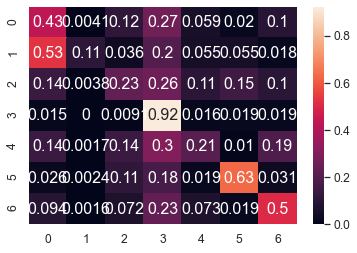

	training epoch=16 .. train_loss=1.14
	validation epoch=16 .. val_loss=1.252
	Accuracy = 51.7 % .. Percision = 49.5 % .. Recall = 43.5 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_16.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 17 .. loss = 1.278


  0%|                                                                                 | 1/1914 [00:01<44:12,  1.39s/it]

training @ epoch 17 .. loss = 1.093


  0%|                                                                                 | 2/1914 [00:02<43:41,  1.37s/it]

training @ epoch 17 .. loss = 1.022


  0%|▏                                                                                | 3/1914 [00:04<43:47,  1.38s/it]

training @ epoch 17 .. loss = 1.225


  0%|▏                                                                                | 4/1914 [00:05<43:23,  1.36s/it]

training @ epoch 17 .. loss = 1.205


  0%|▏                                                                                | 5/1914 [00:06<42:42,  1.34s/it]

training @ epoch 17 .. loss = 1.09


  0%|▎                                                                                | 6/1914 [00:08<42:35,  1.34s/it]

training @ epoch 17 .. loss = 1.406


  0%|▎                                                                                | 7/1914 [00:09<42:09,  1.33s/it]

training @ epoch 17 .. loss = 0.824


  0%|▎                                                                                | 8/1914 [00:10<42:06,  1.33s/it]

training @ epoch 17 .. loss = 1.256


  0%|▍                                                                                | 9/1914 [00:12<43:31,  1.37s/it]

training @ epoch 17 .. loss = 1.112


  1%|▍                                                                               | 10/1914 [00:13<43:14,  1.36s/it]

training @ epoch 17 .. loss = 0.767


  1%|▍                                                                               | 11/1914 [00:14<42:50,  1.35s/it]

training @ epoch 17 .. loss = 1.369


  1%|▌                                                                               | 12/1914 [00:16<42:51,  1.35s/it]

training @ epoch 17 .. loss = 0.863


  1%|▌                                                                               | 13/1914 [00:17<42:18,  1.34s/it]

training @ epoch 17 .. loss = 1.039


  1%|▌                                                                               | 14/1914 [00:18<42:16,  1.34s/it]

training @ epoch 17 .. loss = 0.913


  1%|▋                                                                               | 15/1914 [00:20<43:05,  1.36s/it]

training @ epoch 17 .. loss = 1.221


  1%|▋                                                                               | 16/1914 [00:21<42:20,  1.34s/it]

training @ epoch 17 .. loss = 1.213


  1%|▋                                                                               | 17/1914 [00:22<42:00,  1.33s/it]

training @ epoch 17 .. loss = 1.077


  1%|▊                                                                               | 18/1914 [00:24<42:42,  1.35s/it]

training @ epoch 17 .. loss = 1.115


  1%|▊                                                                               | 19/1914 [00:25<41:56,  1.33s/it]

training @ epoch 17 .. loss = 1.174


  1%|▊                                                                               | 20/1914 [00:26<41:35,  1.32s/it]

training @ epoch 17 .. loss = 1.542


  1%|▉                                                                               | 21/1914 [00:28<41:55,  1.33s/it]

training @ epoch 17 .. loss = 1.286


  1%|▉                                                                               | 22/1914 [00:29<41:32,  1.32s/it]

training @ epoch 17 .. loss = 1.177


  1%|▉                                                                               | 23/1914 [00:30<41:24,  1.31s/it]

training @ epoch 17 .. loss = 1.755


  1%|█                                                                               | 24/1914 [00:32<41:39,  1.32s/it]

training @ epoch 17 .. loss = 0.99


  1%|█                                                                               | 25/1914 [00:33<40:59,  1.30s/it]

training @ epoch 17 .. loss = 1.07


  1%|█                                                                               | 26/1914 [00:34<40:37,  1.29s/it]

training @ epoch 17 .. loss = 1.186


  1%|█▏                                                                              | 27/1914 [00:35<40:13,  1.28s/it]

training @ epoch 17 .. loss = 1.213


  1%|█▏                                                                              | 28/1914 [00:37<40:03,  1.27s/it]

training @ epoch 17 .. loss = 1.217


  2%|█▏                                                                              | 29/1914 [00:38<39:38,  1.26s/it]

training @ epoch 17 .. loss = 1.236


  2%|█▎                                                                              | 30/1914 [00:39<39:42,  1.26s/it]

training @ epoch 17 .. loss = 0.733


  2%|█▎                                                                              | 31/1914 [00:40<39:33,  1.26s/it]

training @ epoch 17 .. loss = 1.027


  2%|█▎                                                                              | 32/1914 [00:42<39:33,  1.26s/it]

training @ epoch 17 .. loss = 1.142


  2%|█▍                                                                              | 33/1914 [00:43<39:05,  1.25s/it]

training @ epoch 17 .. loss = 1.054


  2%|█▍                                                                              | 34/1914 [00:44<39:06,  1.25s/it]

training @ epoch 17 .. loss = 1.289


  2%|█▍                                                                              | 35/1914 [00:45<39:10,  1.25s/it]

training @ epoch 17 .. loss = 1.15


  2%|█▌                                                                              | 36/1914 [00:47<39:03,  1.25s/it]

training @ epoch 17 .. loss = 0.99


  2%|█▌                                                                              | 37/1914 [00:48<39:00,  1.25s/it]

training @ epoch 17 .. loss = 0.581


  2%|█▌                                                                              | 38/1914 [00:49<38:50,  1.24s/it]

training @ epoch 17 .. loss = 0.782


  2%|█▋                                                                              | 39/1914 [00:50<38:49,  1.24s/it]

training @ epoch 17 .. loss = 0.983


  2%|█▋                                                                              | 40/1914 [00:52<39:00,  1.25s/it]

training @ epoch 17 .. loss = 1.165


  2%|█▋                                                                              | 41/1914 [00:53<38:44,  1.24s/it]

training @ epoch 17 .. loss = 1.263


  2%|█▊                                                                              | 42/1914 [00:54<38:55,  1.25s/it]

training @ epoch 17 .. loss = 1.44


  2%|█▊                                                                              | 43/1914 [00:55<38:51,  1.25s/it]

training @ epoch 17 .. loss = 1.02


  2%|█▊                                                                              | 44/1914 [00:57<39:28,  1.27s/it]

training @ epoch 17 .. loss = 1.345


  2%|█▉                                                                              | 45/1914 [00:58<39:19,  1.26s/it]

training @ epoch 17 .. loss = 1.61


  2%|█▉                                                                              | 46/1914 [00:59<38:56,  1.25s/it]

training @ epoch 17 .. loss = 1.598


  2%|█▉                                                                              | 47/1914 [01:00<38:32,  1.24s/it]

training @ epoch 17 .. loss = 0.819


  3%|██                                                                              | 48/1914 [01:02<38:50,  1.25s/it]

training @ epoch 17 .. loss = 1.249


  3%|██                                                                              | 49/1914 [01:03<38:09,  1.23s/it]

training @ epoch 17 .. loss = 1.423


  3%|██                                                                              | 50/1914 [01:04<39:13,  1.26s/it]

training @ epoch 17 .. loss = 1.193


  3%|██▏                                                                             | 51/1914 [01:05<39:00,  1.26s/it]

training @ epoch 17 .. loss = 0.955


  3%|██▏                                                                             | 52/1914 [01:07<38:51,  1.25s/it]

training @ epoch 17 .. loss = 1.367


  3%|██▏                                                                             | 53/1914 [01:08<38:50,  1.25s/it]

training @ epoch 17 .. loss = 1.163


  3%|██▎                                                                             | 54/1914 [01:09<38:27,  1.24s/it]

training @ epoch 17 .. loss = 0.974


  3%|██▎                                                                             | 55/1914 [01:11<40:28,  1.31s/it]

training @ epoch 17 .. loss = 0.966


  3%|██▎                                                                             | 56/1914 [01:12<42:00,  1.36s/it]

training @ epoch 17 .. loss = 0.854


  3%|██▍                                                                             | 57/1914 [01:14<43:31,  1.41s/it]

training @ epoch 17 .. loss = 1.072


  3%|██▍                                                                             | 58/1914 [01:15<44:41,  1.44s/it]

training @ epoch 17 .. loss = 1.371


  3%|██▍                                                                             | 59/1914 [01:17<46:09,  1.49s/it]

training @ epoch 17 .. loss = 1.438


  3%|██▌                                                                             | 60/1914 [01:18<46:15,  1.50s/it]

training @ epoch 17 .. loss = 0.841


  3%|██▌                                                                             | 61/1914 [01:20<46:44,  1.51s/it]

training @ epoch 17 .. loss = 0.885


  3%|██▌                                                                             | 62/1914 [01:21<46:54,  1.52s/it]

training @ epoch 17 .. loss = 1.201


  3%|██▋                                                                             | 63/1914 [01:23<46:42,  1.51s/it]

training @ epoch 17 .. loss = 0.678


  3%|██▋                                                                             | 64/1914 [01:24<46:31,  1.51s/it]

training @ epoch 17 .. loss = 0.738


  3%|██▋                                                                             | 65/1914 [01:26<46:28,  1.51s/it]

training @ epoch 17 .. loss = 1.241


  3%|██▊                                                                             | 66/1914 [01:27<45:35,  1.48s/it]

training @ epoch 17 .. loss = 0.94


  4%|██▊                                                                             | 67/1914 [01:29<44:31,  1.45s/it]

training @ epoch 17 .. loss = 1.746


  4%|██▊                                                                             | 68/1914 [01:30<44:16,  1.44s/it]

training @ epoch 17 .. loss = 1.195


  4%|██▉                                                                             | 69/1914 [01:31<43:41,  1.42s/it]

training @ epoch 17 .. loss = 1.058


  4%|██▉                                                                             | 70/1914 [01:33<43:24,  1.41s/it]

training @ epoch 17 .. loss = 0.88


  4%|██▉                                                                             | 71/1914 [01:34<43:49,  1.43s/it]

training @ epoch 17 .. loss = 0.662


  4%|███                                                                             | 72/1914 [01:36<42:45,  1.39s/it]

training @ epoch 17 .. loss = 1.205


  4%|███                                                                             | 73/1914 [01:37<41:20,  1.35s/it]

training @ epoch 17 .. loss = 1.537


  4%|███                                                                             | 74/1914 [01:38<40:50,  1.33s/it]

training @ epoch 17 .. loss = 1.117


  4%|███▏                                                                            | 75/1914 [01:39<40:15,  1.31s/it]

training @ epoch 17 .. loss = 1.093


  4%|███▏                                                                            | 76/1914 [01:41<39:31,  1.29s/it]

training @ epoch 17 .. loss = 1.07


  4%|███▏                                                                            | 77/1914 [01:42<39:03,  1.28s/it]

training @ epoch 17 .. loss = 1.09


  4%|███▎                                                                            | 78/1914 [01:43<38:38,  1.26s/it]

training @ epoch 17 .. loss = 1.141


  4%|███▎                                                                            | 79/1914 [01:44<38:26,  1.26s/it]

training @ epoch 17 .. loss = 1.927


  4%|███▎                                                                            | 80/1914 [01:46<38:33,  1.26s/it]

training @ epoch 17 .. loss = 1.701


  4%|███▍                                                                            | 81/1914 [01:47<37:47,  1.24s/it]

training @ epoch 17 .. loss = 0.737


  4%|███▍                                                                            | 82/1914 [01:48<38:06,  1.25s/it]

training @ epoch 17 .. loss = 1.381


  4%|███▍                                                                            | 83/1914 [01:49<37:56,  1.24s/it]

training @ epoch 17 .. loss = 1.224


  4%|███▌                                                                            | 84/1914 [01:50<37:49,  1.24s/it]

training @ epoch 17 .. loss = 1.011


  4%|███▌                                                                            | 85/1914 [01:52<38:06,  1.25s/it]

training @ epoch 17 .. loss = 1.133


  4%|███▌                                                                            | 86/1914 [01:53<37:42,  1.24s/it]

training @ epoch 17 .. loss = 1.082


  5%|███▋                                                                            | 87/1914 [01:54<37:39,  1.24s/it]

training @ epoch 17 .. loss = 0.975


  5%|███▋                                                                            | 88/1914 [01:55<37:52,  1.24s/it]

training @ epoch 17 .. loss = 0.747


  5%|███▋                                                                            | 89/1914 [01:57<37:33,  1.24s/it]

training @ epoch 17 .. loss = 0.916


  5%|███▊                                                                            | 90/1914 [01:58<37:53,  1.25s/it]

training @ epoch 17 .. loss = 1.448


  5%|███▊                                                                            | 91/1914 [01:59<37:38,  1.24s/it]

training @ epoch 17 .. loss = 0.773


  5%|███▊                                                                            | 92/1914 [02:00<37:44,  1.24s/it]

training @ epoch 17 .. loss = 1.06


  5%|███▉                                                                            | 93/1914 [02:02<37:53,  1.25s/it]

training @ epoch 17 .. loss = 1.229


  5%|███▉                                                                            | 94/1914 [02:03<37:39,  1.24s/it]

training @ epoch 17 .. loss = 0.826


  5%|███▉                                                                            | 95/1914 [02:04<37:45,  1.25s/it]

training @ epoch 17 .. loss = 1.11


  5%|████                                                                            | 96/1914 [02:05<38:26,  1.27s/it]

training @ epoch 17 .. loss = 1.411


  5%|████                                                                            | 97/1914 [02:07<37:55,  1.25s/it]

training @ epoch 17 .. loss = 1.182


  5%|████                                                                            | 98/1914 [02:08<37:43,  1.25s/it]

training @ epoch 17 .. loss = 1.22


  5%|████▏                                                                           | 99/1914 [02:09<37:39,  1.25s/it]

training @ epoch 17 .. loss = 1.152


  5%|████▏                                                                          | 100/1914 [02:10<37:37,  1.24s/it]

training @ epoch 17 .. loss = 0.841


  5%|████▏                                                                          | 101/1914 [02:12<37:39,  1.25s/it]

training @ epoch 17 .. loss = 0.924


  5%|████▏                                                                          | 102/1914 [02:13<37:23,  1.24s/it]

training @ epoch 17 .. loss = 0.747


  5%|████▎                                                                          | 103/1914 [02:14<37:42,  1.25s/it]

training @ epoch 17 .. loss = 0.809


  5%|████▎                                                                          | 104/1914 [02:15<37:47,  1.25s/it]

training @ epoch 17 .. loss = 0.966


  5%|████▎                                                                          | 105/1914 [02:17<37:29,  1.24s/it]

training @ epoch 17 .. loss = 0.79


  6%|████▍                                                                          | 106/1914 [02:18<38:00,  1.26s/it]

training @ epoch 17 .. loss = 1.402


  6%|████▍                                                                          | 107/1914 [02:19<39:16,  1.30s/it]

training @ epoch 17 .. loss = 0.935


  6%|████▍                                                                          | 108/1914 [02:21<40:30,  1.35s/it]

training @ epoch 17 .. loss = 0.991


  6%|████▍                                                                          | 109/1914 [02:22<40:56,  1.36s/it]

training @ epoch 17 .. loss = 1.695


  6%|████▌                                                                          | 110/1914 [02:24<41:24,  1.38s/it]

training @ epoch 17 .. loss = 1.161


  6%|████▌                                                                          | 111/1914 [02:25<41:42,  1.39s/it]

training @ epoch 17 .. loss = 0.889


  6%|████▌                                                                          | 112/1914 [02:26<41:50,  1.39s/it]

training @ epoch 17 .. loss = 0.789


  6%|████▋                                                                          | 113/1914 [02:28<41:00,  1.37s/it]

training @ epoch 17 .. loss = 1.114


  6%|████▋                                                                          | 114/1914 [02:29<39:53,  1.33s/it]

training @ epoch 17 .. loss = 1.144


  6%|████▋                                                                          | 115/1914 [02:30<39:03,  1.30s/it]

training @ epoch 17 .. loss = 1.4


  6%|████▊                                                                          | 116/1914 [02:31<38:53,  1.30s/it]

training @ epoch 17 .. loss = 0.877


  6%|████▊                                                                          | 117/1914 [02:33<38:06,  1.27s/it]

training @ epoch 17 .. loss = 0.855


  6%|████▊                                                                          | 118/1914 [02:34<38:05,  1.27s/it]

training @ epoch 17 .. loss = 1.093


  6%|████▉                                                                          | 119/1914 [02:35<37:48,  1.26s/it]

training @ epoch 17 .. loss = 0.72


  6%|████▉                                                                          | 120/1914 [02:36<37:51,  1.27s/it]

training @ epoch 17 .. loss = 1.221


  6%|████▉                                                                          | 121/1914 [02:38<38:44,  1.30s/it]

training @ epoch 17 .. loss = 1.964


  6%|█████                                                                          | 122/1914 [02:39<39:46,  1.33s/it]

training @ epoch 17 .. loss = 1.25


  6%|█████                                                                          | 123/1914 [02:41<40:01,  1.34s/it]

training @ epoch 17 .. loss = 1.044


  6%|█████                                                                          | 124/1914 [02:42<39:08,  1.31s/it]

training @ epoch 17 .. loss = 0.593


  7%|█████▏                                                                         | 125/1914 [02:43<38:19,  1.29s/it]

training @ epoch 17 .. loss = 1.192


  7%|█████▏                                                                         | 126/1914 [02:44<38:00,  1.28s/it]

training @ epoch 17 .. loss = 1.068


  7%|█████▏                                                                         | 127/1914 [02:46<37:40,  1.27s/it]

training @ epoch 17 .. loss = 1.252


  7%|█████▎                                                                         | 128/1914 [02:47<37:21,  1.25s/it]

training @ epoch 17 .. loss = 1.049


  7%|█████▎                                                                         | 129/1914 [02:48<37:20,  1.25s/it]

training @ epoch 17 .. loss = 0.961


  7%|█████▎                                                                         | 130/1914 [02:49<36:55,  1.24s/it]

training @ epoch 17 .. loss = 1.067


  7%|█████▍                                                                         | 131/1914 [02:51<36:44,  1.24s/it]

training @ epoch 17 .. loss = 0.954


  7%|█████▍                                                                         | 132/1914 [02:52<36:52,  1.24s/it]

training @ epoch 17 .. loss = 1.114


  7%|█████▍                                                                         | 133/1914 [02:53<36:51,  1.24s/it]

training @ epoch 17 .. loss = 1.214


  7%|█████▌                                                                         | 134/1914 [02:54<36:50,  1.24s/it]

training @ epoch 17 .. loss = 1.019


  7%|█████▌                                                                         | 135/1914 [02:56<37:06,  1.25s/it]

training @ epoch 17 .. loss = 1.002


  7%|█████▌                                                                         | 136/1914 [02:57<36:28,  1.23s/it]

training @ epoch 17 .. loss = 1.372


  7%|█████▋                                                                         | 137/1914 [02:58<36:54,  1.25s/it]

training @ epoch 17 .. loss = 0.873


  7%|█████▋                                                                         | 138/1914 [02:59<36:34,  1.24s/it]

training @ epoch 17 .. loss = 0.987


  7%|█████▋                                                                         | 139/1914 [03:00<36:38,  1.24s/it]

training @ epoch 17 .. loss = 1.185


  7%|█████▊                                                                         | 140/1914 [03:02<36:22,  1.23s/it]

training @ epoch 17 .. loss = 1.078


  7%|█████▊                                                                         | 141/1914 [03:03<36:15,  1.23s/it]

training @ epoch 17 .. loss = 1.216


  7%|█████▊                                                                         | 142/1914 [03:04<36:27,  1.23s/it]

training @ epoch 17 .. loss = 1.072


  7%|█████▉                                                                         | 143/1914 [03:05<37:18,  1.26s/it]

training @ epoch 17 .. loss = 0.591


  8%|█████▉                                                                         | 144/1914 [03:07<36:50,  1.25s/it]

training @ epoch 17 .. loss = 1.09


  8%|█████▉                                                                         | 145/1914 [03:08<37:02,  1.26s/it]

training @ epoch 17 .. loss = 1.268


  8%|██████                                                                         | 146/1914 [03:09<36:47,  1.25s/it]

training @ epoch 17 .. loss = 0.83


  8%|██████                                                                         | 147/1914 [03:10<36:56,  1.25s/it]

training @ epoch 17 .. loss = 1.388


  8%|██████                                                                         | 148/1914 [03:12<36:59,  1.26s/it]

training @ epoch 17 .. loss = 1.026


  8%|██████▏                                                                        | 149/1914 [03:13<37:01,  1.26s/it]

training @ epoch 17 .. loss = 1.376


  8%|██████▏                                                                        | 150/1914 [03:14<36:51,  1.25s/it]

training @ epoch 17 .. loss = 1.085


  8%|██████▏                                                                        | 151/1914 [03:16<37:29,  1.28s/it]

training @ epoch 17 .. loss = 1.093


  8%|██████▎                                                                        | 152/1914 [03:17<37:36,  1.28s/it]

training @ epoch 17 .. loss = 0.885


  8%|██████▎                                                                        | 153/1914 [03:18<37:19,  1.27s/it]

training @ epoch 17 .. loss = 1.006


  8%|██████▎                                                                        | 154/1914 [03:19<36:42,  1.25s/it]

training @ epoch 17 .. loss = 1.061


  8%|██████▍                                                                        | 155/1914 [03:21<36:40,  1.25s/it]

training @ epoch 17 .. loss = 1.203


  8%|██████▍                                                                        | 156/1914 [03:22<36:31,  1.25s/it]

training @ epoch 17 .. loss = 0.711


  8%|██████▍                                                                        | 157/1914 [03:23<36:26,  1.24s/it]

training @ epoch 17 .. loss = 0.89


  8%|██████▌                                                                        | 158/1914 [03:24<36:24,  1.24s/it]

training @ epoch 17 .. loss = 1.159


  8%|██████▌                                                                        | 159/1914 [03:26<36:44,  1.26s/it]

training @ epoch 17 .. loss = 0.907


  8%|██████▌                                                                        | 160/1914 [03:27<36:31,  1.25s/it]

training @ epoch 17 .. loss = 1.632


  8%|██████▋                                                                        | 161/1914 [03:28<36:36,  1.25s/it]

training @ epoch 17 .. loss = 1.461


  8%|██████▋                                                                        | 162/1914 [03:29<36:40,  1.26s/it]

training @ epoch 17 .. loss = 1.098


  9%|██████▋                                                                        | 163/1914 [03:31<36:42,  1.26s/it]

training @ epoch 17 .. loss = 1.017


  9%|██████▊                                                                        | 164/1914 [03:32<36:42,  1.26s/it]

training @ epoch 17 .. loss = 1.085


  9%|██████▊                                                                        | 165/1914 [03:33<36:33,  1.25s/it]

training @ epoch 17 .. loss = 0.674


  9%|██████▊                                                                        | 166/1914 [03:34<36:20,  1.25s/it]

training @ epoch 17 .. loss = 1.253


  9%|██████▉                                                                        | 167/1914 [03:36<36:32,  1.26s/it]

training @ epoch 17 .. loss = 1.165


  9%|██████▉                                                                        | 168/1914 [03:37<36:19,  1.25s/it]

training @ epoch 17 .. loss = 1.569


  9%|██████▉                                                                        | 169/1914 [03:38<36:31,  1.26s/it]

training @ epoch 17 .. loss = 1.016


  9%|███████                                                                        | 170/1914 [03:39<36:54,  1.27s/it]

training @ epoch 17 .. loss = 0.9


  9%|███████                                                                        | 171/1914 [03:41<36:39,  1.26s/it]

training @ epoch 17 .. loss = 1.034


  9%|███████                                                                        | 172/1914 [03:42<36:36,  1.26s/it]

training @ epoch 17 .. loss = 1.238


  9%|███████▏                                                                       | 173/1914 [03:43<36:14,  1.25s/it]

training @ epoch 17 .. loss = 1.047


  9%|███████▏                                                                       | 174/1914 [03:44<36:00,  1.24s/it]

training @ epoch 17 .. loss = 1.135


  9%|███████▏                                                                       | 175/1914 [03:46<35:58,  1.24s/it]

training @ epoch 17 .. loss = 0.846


  9%|███████▎                                                                       | 176/1914 [03:47<35:42,  1.23s/it]

training @ epoch 17 .. loss = 1.015


  9%|███████▎                                                                       | 177/1914 [03:48<35:56,  1.24s/it]

training @ epoch 17 .. loss = 0.666


  9%|███████▎                                                                       | 178/1914 [03:49<35:56,  1.24s/it]

training @ epoch 17 .. loss = 0.969


  9%|███████▍                                                                       | 179/1914 [03:51<36:01,  1.25s/it]

training @ epoch 17 .. loss = 0.827


  9%|███████▍                                                                       | 180/1914 [03:52<35:58,  1.24s/it]

training @ epoch 17 .. loss = 0.905


  9%|███████▍                                                                       | 181/1914 [03:53<35:56,  1.24s/it]

training @ epoch 17 .. loss = 0.993


 10%|███████▌                                                                       | 182/1914 [03:54<35:43,  1.24s/it]

training @ epoch 17 .. loss = 1.308


 10%|███████▌                                                                       | 183/1914 [03:56<35:59,  1.25s/it]

training @ epoch 17 .. loss = 1.099


 10%|███████▌                                                                       | 184/1914 [03:57<35:41,  1.24s/it]

training @ epoch 17 .. loss = 1.04


 10%|███████▋                                                                       | 185/1914 [03:58<35:51,  1.24s/it]

training @ epoch 17 .. loss = 1.022


 10%|███████▋                                                                       | 186/1914 [03:59<35:49,  1.24s/it]

training @ epoch 17 .. loss = 1.137


 10%|███████▋                                                                       | 187/1914 [04:00<35:47,  1.24s/it]

training @ epoch 17 .. loss = 1.127


 10%|███████▊                                                                       | 188/1914 [04:02<35:40,  1.24s/it]

training @ epoch 17 .. loss = 1.731


 10%|███████▊                                                                       | 189/1914 [04:03<35:50,  1.25s/it]

training @ epoch 17 .. loss = 0.583


 10%|███████▊                                                                       | 190/1914 [04:04<35:43,  1.24s/it]

training @ epoch 17 .. loss = 1.17


 10%|███████▉                                                                       | 191/1914 [04:05<35:56,  1.25s/it]

training @ epoch 17 .. loss = 1.428


 10%|███████▉                                                                       | 192/1914 [04:07<35:49,  1.25s/it]

training @ epoch 17 .. loss = 1.271


 10%|███████▉                                                                       | 193/1914 [04:08<36:00,  1.26s/it]

training @ epoch 17 .. loss = 1.599


 10%|████████                                                                       | 194/1914 [04:09<35:56,  1.25s/it]

training @ epoch 17 .. loss = 1.005


 10%|████████                                                                       | 195/1914 [04:10<35:44,  1.25s/it]

training @ epoch 17 .. loss = 1.908


 10%|████████                                                                       | 196/1914 [04:12<39:39,  1.39s/it]

training @ epoch 17 .. loss = 1.003


 10%|████████▏                                                                      | 197/1914 [04:14<42:59,  1.50s/it]

training @ epoch 17 .. loss = 0.826


 10%|████████▏                                                                      | 198/1914 [04:16<51:27,  1.80s/it]

training @ epoch 17 .. loss = 0.911


 10%|████████▏                                                                      | 199/1914 [04:18<49:31,  1.73s/it]

training @ epoch 17 .. loss = 0.971


 10%|████████▎                                                                      | 200/1914 [04:20<47:22,  1.66s/it]

training @ epoch 17 .. loss = 1.33


 11%|████████▎                                                                      | 201/1914 [04:21<47:14,  1.65s/it]

training @ epoch 17 .. loss = 1.253


 11%|████████▎                                                                      | 202/1914 [04:23<45:05,  1.58s/it]

training @ epoch 17 .. loss = 0.923


 11%|████████▍                                                                      | 203/1914 [04:24<42:47,  1.50s/it]

training @ epoch 17 .. loss = 1.159


 11%|████████▍                                                                      | 204/1914 [04:25<40:22,  1.42s/it]

training @ epoch 17 .. loss = 1.155


 11%|████████▍                                                                      | 205/1914 [04:26<39:16,  1.38s/it]

training @ epoch 17 .. loss = 1.554


 11%|████████▌                                                                      | 206/1914 [04:28<43:03,  1.51s/it]

training @ epoch 17 .. loss = 0.956


 11%|████████▌                                                                      | 207/1914 [04:30<41:56,  1.47s/it]

training @ epoch 17 .. loss = 1.228


 11%|████████▌                                                                      | 208/1914 [04:31<41:09,  1.45s/it]

training @ epoch 17 .. loss = 1.589


 11%|████████▋                                                                      | 209/1914 [04:32<40:42,  1.43s/it]

training @ epoch 17 .. loss = 0.903


 11%|████████▋                                                                      | 210/1914 [04:34<40:31,  1.43s/it]

training @ epoch 17 .. loss = 0.991


 11%|████████▋                                                                      | 211/1914 [04:35<39:26,  1.39s/it]

training @ epoch 17 .. loss = 0.759


 11%|████████▊                                                                      | 212/1914 [04:36<39:18,  1.39s/it]

training @ epoch 17 .. loss = 0.842


 11%|████████▊                                                                      | 213/1914 [04:38<39:37,  1.40s/it]

training @ epoch 17 .. loss = 1.064


 11%|████████▊                                                                      | 214/1914 [04:40<41:23,  1.46s/it]

training @ epoch 17 .. loss = 1.158


 11%|████████▊                                                                      | 215/1914 [04:41<41:50,  1.48s/it]

training @ epoch 17 .. loss = 0.625


 11%|████████▉                                                                      | 216/1914 [04:42<40:46,  1.44s/it]

training @ epoch 17 .. loss = 0.99


 11%|████████▉                                                                      | 217/1914 [04:44<40:53,  1.45s/it]

training @ epoch 17 .. loss = 1.072


 11%|████████▉                                                                      | 218/1914 [04:45<38:43,  1.37s/it]

training @ epoch 17 .. loss = 1.001


 11%|█████████                                                                      | 219/1914 [04:46<37:42,  1.33s/it]

training @ epoch 17 .. loss = 1.148


 11%|█████████                                                                      | 220/1914 [04:47<36:05,  1.28s/it]

training @ epoch 17 .. loss = 1.284


 12%|█████████                                                                      | 221/1914 [04:49<35:26,  1.26s/it]

training @ epoch 17 .. loss = 0.767


 12%|█████████▏                                                                     | 222/1914 [04:50<34:11,  1.21s/it]

training @ epoch 17 .. loss = 1.342


 12%|█████████▏                                                                     | 223/1914 [04:51<33:07,  1.18s/it]

training @ epoch 17 .. loss = 1.123


 12%|█████████▏                                                                     | 224/1914 [04:52<32:01,  1.14s/it]

training @ epoch 17 .. loss = 0.834


 12%|█████████▎                                                                     | 225/1914 [04:53<31:10,  1.11s/it]

training @ epoch 17 .. loss = 1.658


 12%|█████████▎                                                                     | 226/1914 [04:54<31:02,  1.10s/it]

training @ epoch 17 .. loss = 1.076


 12%|█████████▎                                                                     | 227/1914 [04:55<30:37,  1.09s/it]

training @ epoch 17 .. loss = 0.945


 12%|█████████▍                                                                     | 228/1914 [04:56<30:26,  1.08s/it]

training @ epoch 17 .. loss = 0.908


 12%|█████████▍                                                                     | 229/1914 [04:57<30:02,  1.07s/it]

training @ epoch 17 .. loss = 1.025


 12%|█████████▍                                                                     | 230/1914 [04:58<30:27,  1.09s/it]

training @ epoch 17 .. loss = 0.777


 12%|█████████▌                                                                     | 231/1914 [05:00<31:34,  1.13s/it]

training @ epoch 17 .. loss = 1.121


 12%|█████████▌                                                                     | 232/1914 [05:01<31:06,  1.11s/it]

training @ epoch 17 .. loss = 0.938


 12%|█████████▌                                                                     | 233/1914 [05:02<30:35,  1.09s/it]

training @ epoch 17 .. loss = 1.126


 12%|█████████▋                                                                     | 234/1914 [05:03<30:39,  1.09s/it]

training @ epoch 17 .. loss = 1.374


 12%|█████████▋                                                                     | 235/1914 [05:04<30:24,  1.09s/it]

training @ epoch 17 .. loss = 1.134


 12%|█████████▋                                                                     | 236/1914 [05:05<30:23,  1.09s/it]

training @ epoch 17 .. loss = 1.345


 12%|█████████▊                                                                     | 237/1914 [05:06<30:08,  1.08s/it]

training @ epoch 17 .. loss = 0.738


 12%|█████████▊                                                                     | 238/1914 [05:07<30:18,  1.09s/it]

training @ epoch 17 .. loss = 1.148


 12%|█████████▊                                                                     | 239/1914 [05:08<30:13,  1.08s/it]

training @ epoch 17 .. loss = 0.63


 13%|█████████▉                                                                     | 240/1914 [05:09<30:16,  1.08s/it]

training @ epoch 17 .. loss = 1.35


 13%|█████████▉                                                                     | 241/1914 [05:10<29:48,  1.07s/it]

training @ epoch 17 .. loss = 1.151


 13%|█████████▉                                                                     | 242/1914 [05:11<29:38,  1.06s/it]

training @ epoch 17 .. loss = 1.358


 13%|██████████                                                                     | 243/1914 [05:12<30:01,  1.08s/it]

training @ epoch 17 .. loss = 0.967


 13%|██████████                                                                     | 244/1914 [05:13<30:01,  1.08s/it]

training @ epoch 17 .. loss = 1.133


 13%|██████████                                                                     | 245/1914 [05:15<30:05,  1.08s/it]

training @ epoch 17 .. loss = 0.919


 13%|██████████▏                                                                    | 246/1914 [05:16<30:13,  1.09s/it]

training @ epoch 17 .. loss = 1.119


 13%|██████████▏                                                                    | 247/1914 [05:17<31:24,  1.13s/it]

training @ epoch 17 .. loss = 1.234


 13%|██████████▏                                                                    | 248/1914 [05:18<31:23,  1.13s/it]

training @ epoch 17 .. loss = 0.93


 13%|██████████▎                                                                    | 249/1914 [05:19<31:09,  1.12s/it]

training @ epoch 17 .. loss = 1.04


 13%|██████████▎                                                                    | 250/1914 [05:20<30:25,  1.10s/it]

training @ epoch 17 .. loss = 0.761


 13%|██████████▎                                                                    | 251/1914 [05:21<29:56,  1.08s/it]

training @ epoch 17 .. loss = 0.888


 13%|██████████▍                                                                    | 252/1914 [05:22<29:53,  1.08s/it]

training @ epoch 17 .. loss = 1.086


 13%|██████████▍                                                                    | 253/1914 [05:23<29:52,  1.08s/it]

training @ epoch 17 .. loss = 1.433


 13%|██████████▍                                                                    | 254/1914 [05:24<29:42,  1.07s/it]

training @ epoch 17 .. loss = 1.43


 13%|██████████▌                                                                    | 255/1914 [05:26<29:48,  1.08s/it]

training @ epoch 17 .. loss = 0.559


 13%|██████████▌                                                                    | 256/1914 [05:27<29:40,  1.07s/it]

training @ epoch 17 .. loss = 1.52


 13%|██████████▌                                                                    | 257/1914 [05:28<30:19,  1.10s/it]

training @ epoch 17 .. loss = 0.962


 13%|██████████▋                                                                    | 258/1914 [05:29<30:04,  1.09s/it]

training @ epoch 17 .. loss = 1.714


 14%|██████████▋                                                                    | 259/1914 [05:30<29:58,  1.09s/it]

training @ epoch 17 .. loss = 0.927


 14%|██████████▋                                                                    | 260/1914 [05:31<29:36,  1.07s/it]

training @ epoch 17 .. loss = 0.695


 14%|██████████▊                                                                    | 261/1914 [05:32<29:13,  1.06s/it]

training @ epoch 17 .. loss = 1.57


 14%|██████████▊                                                                    | 262/1914 [05:33<29:02,  1.05s/it]

training @ epoch 17 .. loss = 1.025


 14%|██████████▊                                                                    | 263/1914 [05:34<29:09,  1.06s/it]

training @ epoch 17 .. loss = 1.021


 14%|██████████▉                                                                    | 264/1914 [05:35<29:02,  1.06s/it]

training @ epoch 17 .. loss = 0.794


 14%|██████████▉                                                                    | 265/1914 [05:36<28:59,  1.05s/it]

training @ epoch 17 .. loss = 1.18


 14%|██████████▉                                                                    | 266/1914 [05:37<29:18,  1.07s/it]

training @ epoch 17 .. loss = 0.815


 14%|███████████                                                                    | 267/1914 [05:38<29:27,  1.07s/it]

training @ epoch 17 .. loss = 1.295


 14%|███████████                                                                    | 268/1914 [05:39<29:19,  1.07s/it]

training @ epoch 17 .. loss = 1.214


 14%|███████████                                                                    | 269/1914 [05:41<29:34,  1.08s/it]

training @ epoch 17 .. loss = 1.211


 14%|███████████▏                                                                   | 270/1914 [05:42<29:34,  1.08s/it]

training @ epoch 17 .. loss = 1.053


 14%|███████████▏                                                                   | 271/1914 [05:43<29:29,  1.08s/it]

training @ epoch 17 .. loss = 0.599


 14%|███████████▏                                                                   | 272/1914 [05:44<29:32,  1.08s/it]

training @ epoch 17 .. loss = 1.477


 14%|███████████▎                                                                   | 273/1914 [05:45<29:29,  1.08s/it]

training @ epoch 17 .. loss = 1.315


 14%|███████████▎                                                                   | 274/1914 [05:46<29:21,  1.07s/it]

training @ epoch 17 .. loss = 0.644


 14%|███████████▎                                                                   | 275/1914 [05:47<29:09,  1.07s/it]

training @ epoch 17 .. loss = 1.432


 14%|███████████▍                                                                   | 276/1914 [05:48<29:04,  1.07s/it]

training @ epoch 17 .. loss = 0.891


 14%|███████████▍                                                                   | 277/1914 [05:49<29:07,  1.07s/it]

training @ epoch 17 .. loss = 1.333


 15%|███████████▍                                                                   | 278/1914 [05:50<29:22,  1.08s/it]

training @ epoch 17 .. loss = 1.593


 15%|███████████▌                                                                   | 279/1914 [05:51<30:12,  1.11s/it]

training @ epoch 17 .. loss = 1.055


 15%|███████████▌                                                                   | 280/1914 [05:52<30:11,  1.11s/it]

training @ epoch 17 .. loss = 1.378


 15%|███████████▌                                                                   | 281/1914 [05:54<29:52,  1.10s/it]

training @ epoch 17 .. loss = 1.483


 15%|███████████▋                                                                   | 282/1914 [05:55<29:33,  1.09s/it]

training @ epoch 17 .. loss = 1.248


 15%|███████████▋                                                                   | 283/1914 [05:56<29:33,  1.09s/it]

training @ epoch 17 .. loss = 1.498


 15%|███████████▋                                                                   | 284/1914 [05:57<29:23,  1.08s/it]

training @ epoch 17 .. loss = 1.028


 15%|███████████▊                                                                   | 285/1914 [05:58<29:25,  1.08s/it]

training @ epoch 17 .. loss = 1.204


 15%|███████████▊                                                                   | 286/1914 [05:59<29:01,  1.07s/it]

training @ epoch 17 .. loss = 0.991


 15%|███████████▊                                                                   | 287/1914 [06:00<29:35,  1.09s/it]

training @ epoch 17 .. loss = 0.899


 15%|███████████▉                                                                   | 288/1914 [06:01<29:08,  1.08s/it]

training @ epoch 17 .. loss = 1.131


 15%|███████████▉                                                                   | 289/1914 [06:02<28:41,  1.06s/it]

training @ epoch 17 .. loss = 1.054


 15%|███████████▉                                                                   | 290/1914 [06:03<29:00,  1.07s/it]

training @ epoch 17 .. loss = 1.434


 15%|████████████                                                                   | 291/1914 [06:04<28:49,  1.07s/it]

training @ epoch 17 .. loss = 1.008


 15%|████████████                                                                   | 292/1914 [06:05<28:34,  1.06s/it]

training @ epoch 17 .. loss = 1.047


 15%|████████████                                                                   | 293/1914 [06:06<28:16,  1.05s/it]

training @ epoch 17 .. loss = 1.401


 15%|████████████▏                                                                  | 294/1914 [06:07<28:46,  1.07s/it]

training @ epoch 17 .. loss = 1.063


 15%|████████████▏                                                                  | 295/1914 [06:09<28:50,  1.07s/it]

training @ epoch 17 .. loss = 0.691


 15%|████████████▏                                                                  | 296/1914 [06:10<29:01,  1.08s/it]

training @ epoch 17 .. loss = 1.186


 16%|████████████▎                                                                  | 297/1914 [06:11<28:50,  1.07s/it]

training @ epoch 17 .. loss = 1.502


 16%|████████████▎                                                                  | 298/1914 [06:12<28:50,  1.07s/it]

training @ epoch 17 .. loss = 1.183


 16%|████████████▎                                                                  | 299/1914 [06:13<28:39,  1.06s/it]

training @ epoch 17 .. loss = 0.715


 16%|████████████▍                                                                  | 300/1914 [06:14<28:45,  1.07s/it]

training @ epoch 17 .. loss = 0.736


 16%|████████████▍                                                                  | 301/1914 [06:15<28:41,  1.07s/it]

training @ epoch 17 .. loss = 1.212


 16%|████████████▍                                                                  | 302/1914 [06:16<28:37,  1.07s/it]

training @ epoch 17 .. loss = 1.424


 16%|████████████▌                                                                  | 303/1914 [06:17<28:24,  1.06s/it]

training @ epoch 17 .. loss = 0.864


 16%|████████████▌                                                                  | 304/1914 [06:18<28:32,  1.06s/it]

training @ epoch 17 .. loss = 0.966


 16%|████████████▌                                                                  | 305/1914 [06:19<28:25,  1.06s/it]

training @ epoch 17 .. loss = 1.586


 16%|████████████▋                                                                  | 306/1914 [06:20<28:26,  1.06s/it]

training @ epoch 17 .. loss = 1.214


 16%|████████████▋                                                                  | 307/1914 [06:21<28:26,  1.06s/it]

training @ epoch 17 .. loss = 0.966


 16%|████████████▋                                                                  | 308/1914 [06:22<28:19,  1.06s/it]

training @ epoch 17 .. loss = 1.418


 16%|████████████▊                                                                  | 309/1914 [06:23<28:13,  1.06s/it]

training @ epoch 17 .. loss = 1.216


 16%|████████████▊                                                                  | 310/1914 [06:24<28:34,  1.07s/it]

training @ epoch 17 .. loss = 1.431


 16%|████████████▊                                                                  | 311/1914 [06:26<29:04,  1.09s/it]

training @ epoch 17 .. loss = 0.917


 16%|████████████▉                                                                  | 312/1914 [06:27<28:58,  1.09s/it]

training @ epoch 17 .. loss = 1.032


 16%|████████████▉                                                                  | 313/1914 [06:28<28:57,  1.09s/it]

training @ epoch 17 .. loss = 1.229


 16%|████████████▉                                                                  | 314/1914 [06:29<28:45,  1.08s/it]

training @ epoch 17 .. loss = 1.41


 16%|█████████████                                                                  | 315/1914 [06:30<28:43,  1.08s/it]

training @ epoch 17 .. loss = 0.414


 17%|█████████████                                                                  | 316/1914 [06:31<28:33,  1.07s/it]

training @ epoch 17 .. loss = 1.655


 17%|█████████████                                                                  | 317/1914 [06:32<28:32,  1.07s/it]

training @ epoch 17 .. loss = 0.972


 17%|█████████████▏                                                                 | 318/1914 [06:33<28:19,  1.06s/it]

training @ epoch 17 .. loss = 0.796


 17%|█████████████▏                                                                 | 319/1914 [06:34<28:21,  1.07s/it]

training @ epoch 17 .. loss = 1.181


 17%|█████████████▏                                                                 | 320/1914 [06:35<28:20,  1.07s/it]

training @ epoch 17 .. loss = 0.792


 17%|█████████████▏                                                                 | 321/1914 [06:36<28:13,  1.06s/it]

training @ epoch 17 .. loss = 0.855


 17%|█████████████▎                                                                 | 322/1914 [06:37<28:21,  1.07s/it]

training @ epoch 17 .. loss = 1.293


 17%|█████████████▎                                                                 | 323/1914 [06:38<28:40,  1.08s/it]

training @ epoch 17 .. loss = 0.968


 17%|█████████████▎                                                                 | 324/1914 [06:40<28:48,  1.09s/it]

training @ epoch 17 .. loss = 1.154


 17%|█████████████▍                                                                 | 325/1914 [06:41<28:34,  1.08s/it]

training @ epoch 17 .. loss = 1.097


 17%|█████████████▍                                                                 | 326/1914 [06:42<28:33,  1.08s/it]

training @ epoch 17 .. loss = 1.258


 17%|█████████████▍                                                                 | 327/1914 [06:43<28:15,  1.07s/it]

training @ epoch 17 .. loss = 1.426


 17%|█████████████▌                                                                 | 328/1914 [06:44<28:13,  1.07s/it]

training @ epoch 17 .. loss = 1.069


 17%|█████████████▌                                                                 | 329/1914 [06:45<28:09,  1.07s/it]

training @ epoch 17 .. loss = 1.404


 17%|█████████████▌                                                                 | 330/1914 [06:46<28:06,  1.06s/it]

training @ epoch 17 .. loss = 1.162


 17%|█████████████▋                                                                 | 331/1914 [06:47<27:50,  1.06s/it]

training @ epoch 17 .. loss = 1.361


 17%|█████████████▋                                                                 | 332/1914 [06:48<28:01,  1.06s/it]

training @ epoch 17 .. loss = 0.819


 17%|█████████████▋                                                                 | 333/1914 [06:49<28:22,  1.08s/it]

training @ epoch 17 .. loss = 1.197


 17%|█████████████▊                                                                 | 334/1914 [06:50<28:26,  1.08s/it]

training @ epoch 17 .. loss = 1.472


 18%|█████████████▊                                                                 | 335/1914 [06:51<28:03,  1.07s/it]

training @ epoch 17 .. loss = 1.211


 18%|█████████████▊                                                                 | 336/1914 [06:52<28:12,  1.07s/it]

training @ epoch 17 .. loss = 1.161


 18%|█████████████▉                                                                 | 337/1914 [06:53<28:14,  1.07s/it]

training @ epoch 17 .. loss = 0.897


 18%|█████████████▉                                                                 | 338/1914 [06:55<28:09,  1.07s/it]

training @ epoch 17 .. loss = 1.236


 18%|█████████████▉                                                                 | 339/1914 [06:56<28:06,  1.07s/it]

training @ epoch 17 .. loss = 0.978


 18%|██████████████                                                                 | 340/1914 [06:57<28:22,  1.08s/it]

training @ epoch 17 .. loss = 0.9


 18%|██████████████                                                                 | 341/1914 [06:58<28:58,  1.11s/it]

training @ epoch 17 .. loss = 1.407


 18%|██████████████                                                                 | 342/1914 [06:59<28:35,  1.09s/it]

training @ epoch 17 .. loss = 1.35


 18%|██████████████▏                                                                | 343/1914 [07:00<28:33,  1.09s/it]

training @ epoch 17 .. loss = 1.271


 18%|██████████████▏                                                                | 344/1914 [07:01<28:23,  1.08s/it]

training @ epoch 17 .. loss = 1.105


 18%|██████████████▏                                                                | 345/1914 [07:02<28:15,  1.08s/it]

training @ epoch 17 .. loss = 1.36


 18%|██████████████▎                                                                | 346/1914 [07:03<28:03,  1.07s/it]

training @ epoch 17 .. loss = 1.342


 18%|██████████████▎                                                                | 347/1914 [07:04<27:53,  1.07s/it]

training @ epoch 17 .. loss = 0.908


 18%|██████████████▎                                                                | 348/1914 [07:05<28:04,  1.08s/it]

training @ epoch 17 .. loss = 1.029


 18%|██████████████▍                                                                | 349/1914 [07:06<27:37,  1.06s/it]

training @ epoch 17 .. loss = 0.862


 18%|██████████████▍                                                                | 350/1914 [07:07<27:43,  1.06s/it]

training @ epoch 17 .. loss = 0.974


 18%|██████████████▍                                                                | 351/1914 [07:09<27:55,  1.07s/it]

training @ epoch 17 .. loss = 1.04


 18%|██████████████▌                                                                | 352/1914 [07:10<27:35,  1.06s/it]

training @ epoch 17 .. loss = 1.048


 18%|██████████████▌                                                                | 353/1914 [07:11<27:40,  1.06s/it]

training @ epoch 17 .. loss = 0.999


 18%|██████████████▌                                                                | 354/1914 [07:12<27:45,  1.07s/it]

training @ epoch 17 .. loss = 1.635


 19%|██████████████▋                                                                | 355/1914 [07:13<27:44,  1.07s/it]

training @ epoch 17 .. loss = 1.342


 19%|██████████████▋                                                                | 356/1914 [07:14<27:46,  1.07s/it]

training @ epoch 17 .. loss = 1.517


 19%|██████████████▋                                                                | 357/1914 [07:15<27:22,  1.05s/it]

training @ epoch 17 .. loss = 0.901


 19%|██████████████▊                                                                | 358/1914 [07:16<27:21,  1.06s/it]

training @ epoch 17 .. loss = 1.375


 19%|██████████████▊                                                                | 359/1914 [07:17<27:27,  1.06s/it]

training @ epoch 17 .. loss = 1.369


 19%|██████████████▊                                                                | 360/1914 [07:18<27:42,  1.07s/it]

training @ epoch 17 .. loss = 0.93


 19%|██████████████▉                                                                | 361/1914 [07:19<27:29,  1.06s/it]

training @ epoch 17 .. loss = 1.226


 19%|██████████████▉                                                                | 362/1914 [07:20<27:31,  1.06s/it]

training @ epoch 17 .. loss = 1.017


 19%|██████████████▉                                                                | 363/1914 [07:21<27:23,  1.06s/it]

training @ epoch 17 .. loss = 1.135


 19%|███████████████                                                                | 364/1914 [07:22<27:08,  1.05s/it]

training @ epoch 17 .. loss = 1.156


 19%|███████████████                                                                | 365/1914 [07:23<27:24,  1.06s/it]

training @ epoch 17 .. loss = 1.28


 19%|███████████████                                                                | 366/1914 [07:24<27:19,  1.06s/it]

training @ epoch 17 .. loss = 1.098


 19%|███████████████▏                                                               | 367/1914 [07:25<27:19,  1.06s/it]

training @ epoch 17 .. loss = 0.952


 19%|███████████████▏                                                               | 368/1914 [07:27<27:29,  1.07s/it]

training @ epoch 17 .. loss = 0.938


 19%|███████████████▏                                                               | 369/1914 [07:28<27:30,  1.07s/it]

training @ epoch 17 .. loss = 1.107


 19%|███████████████▎                                                               | 370/1914 [07:29<27:29,  1.07s/it]

training @ epoch 17 .. loss = 1.207


 19%|███████████████▎                                                               | 371/1914 [07:30<27:34,  1.07s/it]

training @ epoch 17 .. loss = 1.164


 19%|███████████████▎                                                               | 372/1914 [07:31<27:37,  1.07s/it]

training @ epoch 17 .. loss = 0.802


 19%|███████████████▍                                                               | 373/1914 [07:32<27:48,  1.08s/it]

training @ epoch 17 .. loss = 0.802


 20%|███████████████▍                                                               | 374/1914 [07:33<27:41,  1.08s/it]

training @ epoch 17 .. loss = 1.358


 20%|███████████████▍                                                               | 375/1914 [07:34<27:40,  1.08s/it]

training @ epoch 17 .. loss = 0.913


 20%|███████████████▌                                                               | 376/1914 [07:35<27:41,  1.08s/it]

training @ epoch 17 .. loss = 0.903


 20%|███████████████▌                                                               | 377/1914 [07:36<27:39,  1.08s/it]

training @ epoch 17 .. loss = 1.255


 20%|███████████████▌                                                               | 378/1914 [07:37<27:39,  1.08s/it]

training @ epoch 17 .. loss = 1.132


 20%|███████████████▋                                                               | 379/1914 [07:39<28:20,  1.11s/it]

training @ epoch 17 .. loss = 0.912


 20%|███████████████▋                                                               | 380/1914 [07:40<28:51,  1.13s/it]

training @ epoch 17 .. loss = 1.708


 20%|███████████████▋                                                               | 381/1914 [07:41<28:10,  1.10s/it]

training @ epoch 17 .. loss = 1.558


 20%|███████████████▊                                                               | 382/1914 [07:42<27:59,  1.10s/it]

training @ epoch 17 .. loss = 0.752


 20%|███████████████▊                                                               | 383/1914 [07:43<27:54,  1.09s/it]

training @ epoch 17 .. loss = 0.897


 20%|███████████████▊                                                               | 384/1914 [07:44<27:42,  1.09s/it]

training @ epoch 17 .. loss = 0.81


 20%|███████████████▉                                                               | 385/1914 [07:45<27:34,  1.08s/it]

training @ epoch 17 .. loss = 1.201


 20%|███████████████▉                                                               | 386/1914 [07:46<27:29,  1.08s/it]

training @ epoch 17 .. loss = 1.681


 20%|███████████████▉                                                               | 387/1914 [07:47<27:18,  1.07s/it]

training @ epoch 17 .. loss = 1.117


 20%|████████████████                                                               | 388/1914 [07:48<27:10,  1.07s/it]

training @ epoch 17 .. loss = 1.075


 20%|████████████████                                                               | 389/1914 [07:49<27:07,  1.07s/it]

training @ epoch 17 .. loss = 1.382


 20%|████████████████                                                               | 390/1914 [07:50<26:58,  1.06s/it]

training @ epoch 17 .. loss = 1.263


 20%|████████████████▏                                                              | 391/1914 [07:51<27:10,  1.07s/it]

training @ epoch 17 .. loss = 0.928


 20%|████████████████▏                                                              | 392/1914 [07:53<27:09,  1.07s/it]

training @ epoch 17 .. loss = 1.091


 21%|████████████████▏                                                              | 393/1914 [07:54<26:54,  1.06s/it]

training @ epoch 17 .. loss = 0.977


 21%|████████████████▎                                                              | 394/1914 [07:55<26:55,  1.06s/it]

training @ epoch 17 .. loss = 0.776


 21%|████████████████▎                                                              | 395/1914 [07:56<27:07,  1.07s/it]

training @ epoch 17 .. loss = 0.634


 21%|████████████████▎                                                              | 396/1914 [07:57<26:49,  1.06s/it]

training @ epoch 17 .. loss = 1.013


 21%|████████████████▍                                                              | 397/1914 [07:58<26:49,  1.06s/it]

training @ epoch 17 .. loss = 1.033


 21%|████████████████▍                                                              | 398/1914 [07:59<27:03,  1.07s/it]

training @ epoch 17 .. loss = 1.098


 21%|████████████████▍                                                              | 399/1914 [08:00<27:17,  1.08s/it]

training @ epoch 17 .. loss = 0.828


 21%|████████████████▌                                                              | 400/1914 [08:01<27:08,  1.08s/it]

training @ epoch 17 .. loss = 1.101


 21%|████████████████▌                                                              | 401/1914 [08:02<27:14,  1.08s/it]

training @ epoch 17 .. loss = 1.585


 21%|████████████████▌                                                              | 402/1914 [08:03<27:05,  1.07s/it]

training @ epoch 17 .. loss = 1.254


 21%|████████████████▋                                                              | 403/1914 [08:04<26:48,  1.06s/it]

training @ epoch 17 .. loss = 1.261


 21%|████████████████▋                                                              | 404/1914 [08:05<26:54,  1.07s/it]

training @ epoch 17 .. loss = 1.267


 21%|████████████████▋                                                              | 405/1914 [08:06<27:02,  1.08s/it]

training @ epoch 17 .. loss = 1.126


 21%|████████████████▊                                                              | 406/1914 [08:08<26:53,  1.07s/it]

training @ epoch 17 .. loss = 1.207


 21%|████████████████▊                                                              | 407/1914 [08:09<26:39,  1.06s/it]

training @ epoch 17 .. loss = 1.196


 21%|████████████████▊                                                              | 408/1914 [08:10<26:46,  1.07s/it]

training @ epoch 17 .. loss = 0.934


 21%|████████████████▉                                                              | 409/1914 [08:11<26:34,  1.06s/it]

training @ epoch 17 .. loss = 1.418


 21%|████████████████▉                                                              | 410/1914 [08:12<26:30,  1.06s/it]

training @ epoch 17 .. loss = 1.012


 21%|████████████████▉                                                              | 411/1914 [08:13<26:33,  1.06s/it]

training @ epoch 17 .. loss = 1.228


 22%|█████████████████                                                              | 412/1914 [08:14<26:49,  1.07s/it]

training @ epoch 17 .. loss = 1.51


 22%|█████████████████                                                              | 413/1914 [08:15<26:32,  1.06s/it]

training @ epoch 17 .. loss = 1.037


 22%|█████████████████                                                              | 414/1914 [08:16<26:51,  1.07s/it]

training @ epoch 17 .. loss = 1.236


 22%|█████████████████▏                                                             | 415/1914 [08:17<27:06,  1.08s/it]

training @ epoch 17 .. loss = 1.012


 22%|█████████████████▏                                                             | 416/1914 [08:18<26:49,  1.07s/it]

training @ epoch 17 .. loss = 1.257


 22%|█████████████████▏                                                             | 417/1914 [08:19<26:58,  1.08s/it]

training @ epoch 17 .. loss = 0.806


 22%|█████████████████▎                                                             | 418/1914 [08:20<26:51,  1.08s/it]

training @ epoch 17 .. loss = 0.884


 22%|█████████████████▎                                                             | 419/1914 [08:21<26:48,  1.08s/it]

training @ epoch 17 .. loss = 1.169


 22%|█████████████████▎                                                             | 420/1914 [08:22<26:28,  1.06s/it]

training @ epoch 17 .. loss = 0.91


 22%|█████████████████▍                                                             | 421/1914 [08:24<26:30,  1.07s/it]

training @ epoch 17 .. loss = 1.373


 22%|█████████████████▍                                                             | 422/1914 [08:25<26:31,  1.07s/it]

training @ epoch 17 .. loss = 1.343


 22%|█████████████████▍                                                             | 423/1914 [08:26<26:27,  1.06s/it]

training @ epoch 17 .. loss = 0.966


 22%|█████████████████▌                                                             | 424/1914 [08:27<26:54,  1.08s/it]

training @ epoch 17 .. loss = 0.939


 22%|█████████████████▌                                                             | 425/1914 [08:28<26:38,  1.07s/it]

training @ epoch 17 .. loss = 1.085


 22%|█████████████████▌                                                             | 426/1914 [08:29<26:27,  1.07s/it]

training @ epoch 17 .. loss = 1.406


 22%|█████████████████▌                                                             | 427/1914 [08:30<26:27,  1.07s/it]

training @ epoch 17 .. loss = 0.905


 22%|█████████████████▋                                                             | 428/1914 [08:31<26:40,  1.08s/it]

training @ epoch 17 .. loss = 1.782


 22%|█████████████████▋                                                             | 429/1914 [08:32<26:27,  1.07s/it]

training @ epoch 17 .. loss = 0.984


 22%|█████████████████▋                                                             | 430/1914 [08:33<26:13,  1.06s/it]

training @ epoch 17 .. loss = 1.161


 23%|█████████████████▊                                                             | 431/1914 [08:34<25:58,  1.05s/it]

training @ epoch 17 .. loss = 1.548


 23%|█████████████████▊                                                             | 432/1914 [08:35<26:07,  1.06s/it]

training @ epoch 17 .. loss = 0.858


 23%|█████████████████▊                                                             | 433/1914 [08:36<25:54,  1.05s/it]

training @ epoch 17 .. loss = 1.297


 23%|█████████████████▉                                                             | 434/1914 [08:37<26:22,  1.07s/it]

training @ epoch 17 .. loss = 0.954


 23%|█████████████████▉                                                             | 435/1914 [08:39<26:38,  1.08s/it]

training @ epoch 17 .. loss = 1.289


 23%|█████████████████▉                                                             | 436/1914 [08:40<26:34,  1.08s/it]

training @ epoch 17 .. loss = 1.323


 23%|██████████████████                                                             | 437/1914 [08:41<26:21,  1.07s/it]

training @ epoch 17 .. loss = 0.91


 23%|██████████████████                                                             | 438/1914 [08:42<26:15,  1.07s/it]

training @ epoch 17 .. loss = 1.099


 23%|██████████████████                                                             | 439/1914 [08:43<26:18,  1.07s/it]

training @ epoch 17 .. loss = 1.174


 23%|██████████████████▏                                                            | 440/1914 [08:44<26:22,  1.07s/it]

training @ epoch 17 .. loss = 0.988


 23%|██████████████████▏                                                            | 441/1914 [08:45<28:07,  1.15s/it]

training @ epoch 17 .. loss = 1.033


 23%|██████████████████▏                                                            | 442/1914 [08:46<28:13,  1.15s/it]

training @ epoch 17 .. loss = 1.066


 23%|██████████████████▎                                                            | 443/1914 [08:47<27:36,  1.13s/it]

training @ epoch 17 .. loss = 0.956


 23%|██████████████████▎                                                            | 444/1914 [08:48<27:15,  1.11s/it]

training @ epoch 17 .. loss = 1.118


 23%|██████████████████▎                                                            | 445/1914 [08:50<26:51,  1.10s/it]

training @ epoch 17 .. loss = 1.139


 23%|██████████████████▍                                                            | 446/1914 [08:51<26:34,  1.09s/it]

training @ epoch 17 .. loss = 1.247


 23%|██████████████████▍                                                            | 447/1914 [08:52<26:23,  1.08s/it]

training @ epoch 17 .. loss = 0.869


 23%|██████████████████▍                                                            | 448/1914 [08:53<26:19,  1.08s/it]

training @ epoch 17 .. loss = 1.006


 23%|██████████████████▌                                                            | 449/1914 [08:54<26:14,  1.08s/it]

training @ epoch 17 .. loss = 1.209


 24%|██████████████████▌                                                            | 450/1914 [08:55<26:23,  1.08s/it]

training @ epoch 17 .. loss = 1.687


 24%|██████████████████▌                                                            | 451/1914 [08:56<26:02,  1.07s/it]

training @ epoch 17 .. loss = 1.332


 24%|██████████████████▋                                                            | 452/1914 [08:57<26:12,  1.08s/it]

training @ epoch 17 .. loss = 1.459


 24%|██████████████████▋                                                            | 453/1914 [08:58<25:53,  1.06s/it]

training @ epoch 17 .. loss = 1.329


 24%|██████████████████▋                                                            | 454/1914 [08:59<25:50,  1.06s/it]

training @ epoch 17 .. loss = 1.353


 24%|██████████████████▊                                                            | 455/1914 [09:00<26:33,  1.09s/it]

training @ epoch 17 .. loss = 1.302


 24%|██████████████████▊                                                            | 456/1914 [09:01<26:22,  1.09s/it]

training @ epoch 17 .. loss = 1.011


 24%|██████████████████▊                                                            | 457/1914 [09:02<26:19,  1.08s/it]

training @ epoch 17 .. loss = 1.142


 24%|██████████████████▉                                                            | 458/1914 [09:04<26:20,  1.09s/it]

training @ epoch 17 .. loss = 0.989


 24%|██████████████████▉                                                            | 459/1914 [09:05<26:16,  1.08s/it]

training @ epoch 17 .. loss = 1.113


 24%|██████████████████▉                                                            | 460/1914 [09:06<26:16,  1.08s/it]

training @ epoch 17 .. loss = 0.89


 24%|███████████████████                                                            | 461/1914 [09:07<26:23,  1.09s/it]

training @ epoch 17 .. loss = 1.291


 24%|███████████████████                                                            | 462/1914 [09:08<27:10,  1.12s/it]

training @ epoch 17 .. loss = 1.07


 24%|███████████████████                                                            | 463/1914 [09:09<26:36,  1.10s/it]

training @ epoch 17 .. loss = 0.882


 24%|███████████████████▏                                                           | 464/1914 [09:10<26:19,  1.09s/it]

training @ epoch 17 .. loss = 0.927


 24%|███████████████████▏                                                           | 465/1914 [09:11<26:21,  1.09s/it]

training @ epoch 17 .. loss = 1.128


 24%|███████████████████▏                                                           | 466/1914 [09:12<26:28,  1.10s/it]

training @ epoch 17 .. loss = 1.31


 24%|███████████████████▎                                                           | 467/1914 [09:13<26:16,  1.09s/it]

training @ epoch 17 .. loss = 1.158


 24%|███████████████████▎                                                           | 468/1914 [09:14<26:14,  1.09s/it]

training @ epoch 17 .. loss = 0.824


 25%|███████████████████▎                                                           | 469/1914 [09:16<26:16,  1.09s/it]

training @ epoch 17 .. loss = 1.062


 25%|███████████████████▍                                                           | 470/1914 [09:17<25:58,  1.08s/it]

training @ epoch 17 .. loss = 1.053


 25%|███████████████████▍                                                           | 471/1914 [09:18<26:03,  1.08s/it]

training @ epoch 17 .. loss = 0.917


 25%|███████████████████▍                                                           | 472/1914 [09:19<25:47,  1.07s/it]

training @ epoch 17 .. loss = 1.305


 25%|███████████████████▌                                                           | 473/1914 [09:20<25:57,  1.08s/it]

training @ epoch 17 .. loss = 1.028


 25%|███████████████████▌                                                           | 474/1914 [09:21<25:52,  1.08s/it]

training @ epoch 17 .. loss = 1.298


 25%|███████████████████▌                                                           | 475/1914 [09:22<25:31,  1.06s/it]

training @ epoch 17 .. loss = 0.998


 25%|███████████████████▋                                                           | 476/1914 [09:23<25:37,  1.07s/it]

training @ epoch 17 .. loss = 0.909


 25%|███████████████████▋                                                           | 477/1914 [09:24<25:19,  1.06s/it]

training @ epoch 17 .. loss = 1.165


 25%|███████████████████▋                                                           | 478/1914 [09:25<25:44,  1.08s/it]

training @ epoch 17 .. loss = 1.323


 25%|███████████████████▊                                                           | 479/1914 [09:26<25:34,  1.07s/it]

training @ epoch 17 .. loss = 0.957


 25%|███████████████████▊                                                           | 480/1914 [09:27<25:34,  1.07s/it]

training @ epoch 17 .. loss = 1.246


 25%|███████████████████▊                                                           | 481/1914 [09:28<25:34,  1.07s/it]

training @ epoch 17 .. loss = 0.688


 25%|███████████████████▉                                                           | 482/1914 [09:30<27:08,  1.14s/it]

training @ epoch 17 .. loss = 1.248


 25%|███████████████████▉                                                           | 483/1914 [09:31<27:52,  1.17s/it]

training @ epoch 17 .. loss = 1.244


 25%|███████████████████▉                                                           | 484/1914 [09:32<28:27,  1.19s/it]

training @ epoch 17 .. loss = 1.121


 25%|████████████████████                                                           | 485/1914 [09:33<28:53,  1.21s/it]

training @ epoch 17 .. loss = 1.093


 25%|████████████████████                                                           | 486/1914 [09:35<27:59,  1.18s/it]

training @ epoch 17 .. loss = 0.426


 25%|████████████████████                                                           | 487/1914 [09:36<27:12,  1.14s/it]

training @ epoch 17 .. loss = 1.893


 25%|████████████████████▏                                                          | 488/1914 [09:37<26:32,  1.12s/it]

training @ epoch 17 .. loss = 1.066


 26%|████████████████████▏                                                          | 489/1914 [09:38<26:07,  1.10s/it]

training @ epoch 17 .. loss = 0.573


 26%|████████████████████▏                                                          | 490/1914 [09:39<25:48,  1.09s/it]

training @ epoch 17 .. loss = 1.428


 26%|████████████████████▎                                                          | 491/1914 [09:40<25:34,  1.08s/it]

training @ epoch 17 .. loss = 0.877


 26%|████████████████████▎                                                          | 492/1914 [09:41<25:31,  1.08s/it]

training @ epoch 17 .. loss = 1.227


 26%|████████████████████▎                                                          | 493/1914 [09:42<25:17,  1.07s/it]

training @ epoch 17 .. loss = 1.016


 26%|████████████████████▍                                                          | 494/1914 [09:43<25:14,  1.07s/it]

training @ epoch 17 .. loss = 0.684


 26%|████████████████████▍                                                          | 495/1914 [09:44<25:04,  1.06s/it]

training @ epoch 17 .. loss = 1.144


 26%|████████████████████▍                                                          | 496/1914 [09:45<25:07,  1.06s/it]

training @ epoch 17 .. loss = 1.162


 26%|████████████████████▌                                                          | 497/1914 [09:46<25:00,  1.06s/it]

training @ epoch 17 .. loss = 1.074


 26%|████████████████████▌                                                          | 498/1914 [09:47<25:05,  1.06s/it]

training @ epoch 17 .. loss = 1.446


 26%|████████████████████▌                                                          | 499/1914 [09:48<24:56,  1.06s/it]

training @ epoch 17 .. loss = 0.932


 26%|████████████████████▋                                                          | 500/1914 [09:49<24:48,  1.05s/it]

training @ epoch 17 .. loss = 0.935


 26%|████████████████████▋                                                          | 501/1914 [09:50<24:50,  1.05s/it]

training @ epoch 17 .. loss = 0.959


 26%|████████████████████▋                                                          | 502/1914 [09:52<26:00,  1.11s/it]

training @ epoch 17 .. loss = 1.258


 26%|████████████████████▊                                                          | 503/1914 [09:53<26:34,  1.13s/it]

training @ epoch 17 .. loss = 0.641


 26%|████████████████████▊                                                          | 504/1914 [09:54<26:14,  1.12s/it]

training @ epoch 17 .. loss = 0.931


 26%|████████████████████▊                                                          | 505/1914 [09:55<25:52,  1.10s/it]

training @ epoch 17 .. loss = 1.176


 26%|████████████████████▉                                                          | 506/1914 [09:56<25:41,  1.09s/it]

training @ epoch 17 .. loss = 1.076


 26%|████████████████████▉                                                          | 507/1914 [09:57<25:24,  1.08s/it]

training @ epoch 17 .. loss = 0.719


 27%|████████████████████▉                                                          | 508/1914 [09:58<25:15,  1.08s/it]

training @ epoch 17 .. loss = 1.126


 27%|█████████████████████                                                          | 509/1914 [09:59<25:24,  1.08s/it]

training @ epoch 17 .. loss = 1.296


 27%|█████████████████████                                                          | 510/1914 [10:00<25:21,  1.08s/it]

training @ epoch 17 .. loss = 0.788


 27%|█████████████████████                                                          | 511/1914 [10:01<25:23,  1.09s/it]

training @ epoch 17 .. loss = 0.702


 27%|█████████████████████▏                                                         | 512/1914 [10:03<25:20,  1.08s/it]

training @ epoch 17 .. loss = 1.035


 27%|█████████████████████▏                                                         | 513/1914 [10:04<25:35,  1.10s/it]

training @ epoch 17 .. loss = 0.873


 27%|█████████████████████▏                                                         | 514/1914 [10:05<25:22,  1.09s/it]

training @ epoch 17 .. loss = 1.574


 27%|█████████████████████▎                                                         | 515/1914 [10:06<25:39,  1.10s/it]

training @ epoch 17 .. loss = 0.865


 27%|█████████████████████▎                                                         | 516/1914 [10:07<25:25,  1.09s/it]

training @ epoch 17 .. loss = 1.331


 27%|█████████████████████▎                                                         | 517/1914 [10:08<25:16,  1.09s/it]

training @ epoch 17 .. loss = 0.849


 27%|█████████████████████▍                                                         | 518/1914 [10:09<24:51,  1.07s/it]

training @ epoch 17 .. loss = 1.381


 27%|█████████████████████▍                                                         | 519/1914 [10:10<25:11,  1.08s/it]

training @ epoch 17 .. loss = 1.017


 27%|█████████████████████▍                                                         | 520/1914 [10:11<25:10,  1.08s/it]

training @ epoch 17 .. loss = 1.513


 27%|█████████████████████▌                                                         | 521/1914 [10:12<24:57,  1.08s/it]

training @ epoch 17 .. loss = 1.02


 27%|█████████████████████▌                                                         | 522/1914 [10:13<24:46,  1.07s/it]

training @ epoch 17 .. loss = 1.527


 27%|█████████████████████▌                                                         | 523/1914 [10:14<24:38,  1.06s/it]

training @ epoch 17 .. loss = 0.836


 27%|█████████████████████▋                                                         | 524/1914 [10:15<24:56,  1.08s/it]

training @ epoch 17 .. loss = 0.929


 27%|█████████████████████▋                                                         | 525/1914 [10:17<24:53,  1.07s/it]

training @ epoch 17 .. loss = 1.429


 27%|█████████████████████▋                                                         | 526/1914 [10:18<24:58,  1.08s/it]

training @ epoch 17 .. loss = 1.294


 28%|█████████████████████▊                                                         | 527/1914 [10:19<24:42,  1.07s/it]

training @ epoch 17 .. loss = 0.978


 28%|█████████████████████▊                                                         | 528/1914 [10:20<24:49,  1.07s/it]

training @ epoch 17 .. loss = 1.239


 28%|█████████████████████▊                                                         | 529/1914 [10:21<24:51,  1.08s/it]

training @ epoch 17 .. loss = 1.35


 28%|█████████████████████▉                                                         | 530/1914 [10:22<24:43,  1.07s/it]

training @ epoch 17 .. loss = 1.385


 28%|█████████████████████▉                                                         | 531/1914 [10:23<24:27,  1.06s/it]

training @ epoch 17 .. loss = 0.9


 28%|█████████████████████▉                                                         | 532/1914 [10:24<24:31,  1.07s/it]

training @ epoch 17 .. loss = 1.312


 28%|█████████████████████▉                                                         | 533/1914 [10:25<24:25,  1.06s/it]

training @ epoch 17 .. loss = 1.33


 28%|██████████████████████                                                         | 534/1914 [10:26<24:31,  1.07s/it]

training @ epoch 17 .. loss = 1.28


 28%|██████████████████████                                                         | 535/1914 [10:27<24:24,  1.06s/it]

training @ epoch 17 .. loss = 1.0


 28%|██████████████████████                                                         | 536/1914 [10:28<24:20,  1.06s/it]

training @ epoch 17 .. loss = 0.829


 28%|██████████████████████▏                                                        | 537/1914 [10:29<24:36,  1.07s/it]

training @ epoch 17 .. loss = 1.153


 28%|██████████████████████▏                                                        | 538/1914 [10:30<24:36,  1.07s/it]

training @ epoch 17 .. loss = 1.012


 28%|██████████████████████▏                                                        | 539/1914 [10:31<24:29,  1.07s/it]

training @ epoch 17 .. loss = 1.098


 28%|██████████████████████▎                                                        | 540/1914 [10:33<24:34,  1.07s/it]

training @ epoch 17 .. loss = 1.058


 28%|██████████████████████▎                                                        | 541/1914 [10:34<24:40,  1.08s/it]

training @ epoch 17 .. loss = 1.263


 28%|██████████████████████▎                                                        | 542/1914 [10:35<24:36,  1.08s/it]

training @ epoch 17 .. loss = 1.075


 28%|██████████████████████▍                                                        | 543/1914 [10:36<24:36,  1.08s/it]

training @ epoch 17 .. loss = 1.451


 28%|██████████████████████▍                                                        | 544/1914 [10:37<24:35,  1.08s/it]

training @ epoch 17 .. loss = 1.33


 28%|██████████████████████▍                                                        | 545/1914 [10:38<24:19,  1.07s/it]

training @ epoch 17 .. loss = 0.823


 29%|██████████████████████▌                                                        | 546/1914 [10:39<24:24,  1.07s/it]

training @ epoch 17 .. loss = 1.452


 29%|██████████████████████▌                                                        | 547/1914 [10:40<24:07,  1.06s/it]

training @ epoch 17 .. loss = 1.073


 29%|██████████████████████▌                                                        | 548/1914 [10:41<24:10,  1.06s/it]

training @ epoch 17 .. loss = 1.154


 29%|██████████████████████▋                                                        | 549/1914 [10:42<24:17,  1.07s/it]

training @ epoch 17 .. loss = 1.069


 29%|██████████████████████▋                                                        | 550/1914 [10:43<24:05,  1.06s/it]

training @ epoch 17 .. loss = 0.684


 29%|██████████████████████▋                                                        | 551/1914 [10:44<24:16,  1.07s/it]

training @ epoch 17 .. loss = 1.572


 29%|██████████████████████▊                                                        | 552/1914 [10:45<24:17,  1.07s/it]

training @ epoch 17 .. loss = 0.997


 29%|██████████████████████▊                                                        | 553/1914 [10:46<24:16,  1.07s/it]

training @ epoch 17 .. loss = 0.942


 29%|██████████████████████▊                                                        | 554/1914 [10:48<24:35,  1.09s/it]

training @ epoch 17 .. loss = 0.939


 29%|██████████████████████▉                                                        | 555/1914 [10:49<24:32,  1.08s/it]

training @ epoch 17 .. loss = 1.835


 29%|██████████████████████▉                                                        | 556/1914 [10:50<24:30,  1.08s/it]

training @ epoch 17 .. loss = 1.269


 29%|██████████████████████▉                                                        | 557/1914 [10:51<24:34,  1.09s/it]

training @ epoch 17 .. loss = 0.968


 29%|███████████████████████                                                        | 558/1914 [10:52<24:48,  1.10s/it]

training @ epoch 17 .. loss = 1.673


 29%|███████████████████████                                                        | 559/1914 [10:53<24:11,  1.07s/it]

training @ epoch 17 .. loss = 1.031


 29%|███████████████████████                                                        | 560/1914 [10:54<24:14,  1.07s/it]

training @ epoch 17 .. loss = 1.61


 29%|███████████████████████▏                                                       | 561/1914 [10:55<24:19,  1.08s/it]

training @ epoch 17 .. loss = 1.311


 29%|███████████████████████▏                                                       | 562/1914 [10:56<24:14,  1.08s/it]

training @ epoch 17 .. loss = 1.703


 29%|███████████████████████▏                                                       | 563/1914 [10:57<24:18,  1.08s/it]

training @ epoch 17 .. loss = 1.279


 29%|███████████████████████▎                                                       | 564/1914 [10:58<24:08,  1.07s/it]

training @ epoch 17 .. loss = 1.608


 30%|███████████████████████▎                                                       | 565/1914 [10:59<24:19,  1.08s/it]

training @ epoch 17 .. loss = 0.628


 30%|███████████████████████▎                                                       | 566/1914 [11:01<24:18,  1.08s/it]

training @ epoch 17 .. loss = 1.24


 30%|███████████████████████▍                                                       | 567/1914 [11:02<24:00,  1.07s/it]

training @ epoch 17 .. loss = 1.685


 30%|███████████████████████▍                                                       | 568/1914 [11:03<24:16,  1.08s/it]

training @ epoch 17 .. loss = 0.841


 30%|███████████████████████▍                                                       | 569/1914 [11:04<24:01,  1.07s/it]

training @ epoch 17 .. loss = 0.955


 30%|███████████████████████▌                                                       | 570/1914 [11:05<23:51,  1.07s/it]

training @ epoch 17 .. loss = 1.645


 30%|███████████████████████▌                                                       | 571/1914 [11:06<24:04,  1.08s/it]

training @ epoch 17 .. loss = 0.793


 30%|███████████████████████▌                                                       | 572/1914 [11:07<23:51,  1.07s/it]

training @ epoch 17 .. loss = 0.988


 30%|███████████████████████▋                                                       | 573/1914 [11:08<24:04,  1.08s/it]

training @ epoch 17 .. loss = 1.37


 30%|███████████████████████▋                                                       | 574/1914 [11:09<23:43,  1.06s/it]

training @ epoch 17 .. loss = 1.527


 30%|███████████████████████▋                                                       | 575/1914 [11:10<24:52,  1.11s/it]

training @ epoch 17 .. loss = 1.063


 30%|███████████████████████▊                                                       | 576/1914 [11:12<26:06,  1.17s/it]

training @ epoch 17 .. loss = 0.868


 30%|███████████████████████▊                                                       | 577/1914 [11:13<26:37,  1.19s/it]

training @ epoch 17 .. loss = 1.371


 30%|███████████████████████▊                                                       | 578/1914 [11:14<26:34,  1.19s/it]

training @ epoch 17 .. loss = 1.266


 30%|███████████████████████▉                                                       | 579/1914 [11:15<26:24,  1.19s/it]

training @ epoch 17 .. loss = 1.037


 30%|███████████████████████▉                                                       | 580/1914 [11:16<26:53,  1.21s/it]

training @ epoch 17 .. loss = 1.191


 30%|███████████████████████▉                                                       | 581/1914 [11:18<27:12,  1.22s/it]

training @ epoch 17 .. loss = 0.978


 30%|████████████████████████                                                       | 582/1914 [11:19<27:03,  1.22s/it]

training @ epoch 17 .. loss = 1.519


 30%|████████████████████████                                                       | 583/1914 [11:20<26:59,  1.22s/it]

training @ epoch 17 .. loss = 1.019


 31%|████████████████████████                                                       | 584/1914 [11:21<26:56,  1.22s/it]

training @ epoch 17 .. loss = 1.377


 31%|████████████████████████▏                                                      | 585/1914 [11:23<27:51,  1.26s/it]

training @ epoch 17 .. loss = 1.014


 31%|████████████████████████▏                                                      | 586/1914 [11:24<27:43,  1.25s/it]

training @ epoch 17 .. loss = 1.247


 31%|████████████████████████▏                                                      | 587/1914 [11:25<27:41,  1.25s/it]

training @ epoch 17 .. loss = 1.117


 31%|████████████████████████▎                                                      | 588/1914 [11:27<27:49,  1.26s/it]

training @ epoch 17 .. loss = 1.2


 31%|████████████████████████▎                                                      | 589/1914 [11:28<27:32,  1.25s/it]

training @ epoch 17 .. loss = 1.103


 31%|████████████████████████▎                                                      | 590/1914 [11:29<26:28,  1.20s/it]

training @ epoch 17 .. loss = 1.304


 31%|████████████████████████▍                                                      | 591/1914 [11:30<25:47,  1.17s/it]

training @ epoch 17 .. loss = 1.009


 31%|████████████████████████▍                                                      | 592/1914 [11:31<25:02,  1.14s/it]

training @ epoch 17 .. loss = 1.362


 31%|████████████████████████▍                                                      | 593/1914 [11:32<24:27,  1.11s/it]

training @ epoch 17 .. loss = 0.826


 31%|████████████████████████▌                                                      | 594/1914 [11:33<24:02,  1.09s/it]

training @ epoch 17 .. loss = 0.965


 31%|████████████████████████▌                                                      | 595/1914 [11:34<23:44,  1.08s/it]

training @ epoch 17 .. loss = 0.932


 31%|████████████████████████▌                                                      | 596/1914 [11:35<23:19,  1.06s/it]

training @ epoch 17 .. loss = 1.174


 31%|████████████████████████▋                                                      | 597/1914 [11:36<23:14,  1.06s/it]

training @ epoch 17 .. loss = 1.23


 31%|████████████████████████▋                                                      | 598/1914 [11:37<23:23,  1.07s/it]

training @ epoch 17 .. loss = 1.062


 31%|████████████████████████▋                                                      | 599/1914 [11:38<23:32,  1.07s/it]

training @ epoch 17 .. loss = 1.044


 31%|████████████████████████▊                                                      | 600/1914 [11:39<23:29,  1.07s/it]

training @ epoch 17 .. loss = 0.77


 31%|████████████████████████▊                                                      | 601/1914 [11:40<23:15,  1.06s/it]

training @ epoch 17 .. loss = 1.09


 31%|████████████████████████▊                                                      | 602/1914 [11:42<23:13,  1.06s/it]

training @ epoch 17 .. loss = 1.385


 32%|████████████████████████▉                                                      | 603/1914 [11:43<23:07,  1.06s/it]

training @ epoch 17 .. loss = 1.381


 32%|████████████████████████▉                                                      | 604/1914 [11:44<23:27,  1.07s/it]

training @ epoch 17 .. loss = 1.181


 32%|████████████████████████▉                                                      | 605/1914 [11:45<23:25,  1.07s/it]

training @ epoch 17 .. loss = 1.026


 32%|█████████████████████████                                                      | 606/1914 [11:46<23:37,  1.08s/it]

training @ epoch 17 .. loss = 1.238


 32%|█████████████████████████                                                      | 607/1914 [11:47<23:36,  1.08s/it]

training @ epoch 17 .. loss = 1.125


 32%|█████████████████████████                                                      | 608/1914 [11:48<23:21,  1.07s/it]

training @ epoch 17 .. loss = 1.318


 32%|█████████████████████████▏                                                     | 609/1914 [11:49<23:23,  1.08s/it]

training @ epoch 17 .. loss = 0.861


 32%|█████████████████████████▏                                                     | 610/1914 [11:50<23:15,  1.07s/it]

training @ epoch 17 .. loss = 1.054


 32%|█████████████████████████▏                                                     | 611/1914 [11:51<22:59,  1.06s/it]

training @ epoch 17 .. loss = 1.048


 32%|█████████████████████████▎                                                     | 612/1914 [11:52<22:55,  1.06s/it]

training @ epoch 17 .. loss = 1.171


 32%|█████████████████████████▎                                                     | 613/1914 [11:53<23:04,  1.06s/it]

training @ epoch 17 .. loss = 1.108


 32%|█████████████████████████▎                                                     | 614/1914 [11:54<23:00,  1.06s/it]

training @ epoch 17 .. loss = 1.549


 32%|█████████████████████████▍                                                     | 615/1914 [11:55<23:06,  1.07s/it]

training @ epoch 17 .. loss = 1.183


 32%|█████████████████████████▍                                                     | 616/1914 [11:57<23:04,  1.07s/it]

training @ epoch 17 .. loss = 1.15


 32%|█████████████████████████▍                                                     | 617/1914 [11:58<23:12,  1.07s/it]

training @ epoch 17 .. loss = 1.256


 32%|█████████████████████████▌                                                     | 618/1914 [11:59<23:14,  1.08s/it]

training @ epoch 17 .. loss = 1.102


 32%|█████████████████████████▌                                                     | 619/1914 [12:00<23:09,  1.07s/it]

training @ epoch 17 .. loss = 1.277


 32%|█████████████████████████▌                                                     | 620/1914 [12:01<23:06,  1.07s/it]

training @ epoch 17 .. loss = 1.046


 32%|█████████████████████████▋                                                     | 621/1914 [12:02<23:01,  1.07s/it]

training @ epoch 17 .. loss = 1.096


 32%|█████████████████████████▋                                                     | 622/1914 [12:03<23:07,  1.07s/it]

training @ epoch 17 .. loss = 0.943


 33%|█████████████████████████▋                                                     | 623/1914 [12:04<22:56,  1.07s/it]

training @ epoch 17 .. loss = 1.304


 33%|█████████████████████████▊                                                     | 624/1914 [12:05<22:48,  1.06s/it]

training @ epoch 17 .. loss = 0.926


 33%|█████████████████████████▊                                                     | 625/1914 [12:06<22:40,  1.06s/it]

training @ epoch 17 .. loss = 0.943


 33%|█████████████████████████▊                                                     | 626/1914 [12:07<22:38,  1.05s/it]

training @ epoch 17 .. loss = 1.358


 33%|█████████████████████████▉                                                     | 627/1914 [12:08<22:34,  1.05s/it]

training @ epoch 17 .. loss = 1.441


 33%|█████████████████████████▉                                                     | 628/1914 [12:09<22:27,  1.05s/it]

training @ epoch 17 .. loss = 1.312


 33%|█████████████████████████▉                                                     | 629/1914 [12:10<22:38,  1.06s/it]

training @ epoch 17 .. loss = 0.859


 33%|██████████████████████████                                                     | 630/1914 [12:11<23:08,  1.08s/it]

training @ epoch 17 .. loss = 1.086


 33%|██████████████████████████                                                     | 631/1914 [12:13<23:19,  1.09s/it]

training @ epoch 17 .. loss = 0.907


 33%|██████████████████████████                                                     | 632/1914 [12:14<23:08,  1.08s/it]

training @ epoch 17 .. loss = 1.088


 33%|██████████████████████████▏                                                    | 633/1914 [12:15<22:56,  1.07s/it]

training @ epoch 17 .. loss = 0.844


 33%|██████████████████████████▏                                                    | 634/1914 [12:16<22:49,  1.07s/it]

training @ epoch 17 .. loss = 1.075


 33%|██████████████████████████▏                                                    | 635/1914 [12:17<22:57,  1.08s/it]

training @ epoch 17 .. loss = 1.078


 33%|██████████████████████████▎                                                    | 636/1914 [12:18<22:45,  1.07s/it]

training @ epoch 17 .. loss = 0.93


 33%|██████████████████████████▎                                                    | 637/1914 [12:19<22:31,  1.06s/it]

training @ epoch 17 .. loss = 0.848


 33%|██████████████████████████▎                                                    | 638/1914 [12:20<22:21,  1.05s/it]

training @ epoch 17 .. loss = 1.148


 33%|██████████████████████████▎                                                    | 639/1914 [12:21<22:19,  1.05s/it]

training @ epoch 17 .. loss = 1.024


 33%|██████████████████████████▍                                                    | 640/1914 [12:22<22:20,  1.05s/it]

training @ epoch 17 .. loss = 0.949


 33%|██████████████████████████▍                                                    | 641/1914 [12:23<22:16,  1.05s/it]

training @ epoch 17 .. loss = 1.001


 34%|██████████████████████████▍                                                    | 642/1914 [12:24<22:23,  1.06s/it]

training @ epoch 17 .. loss = 0.788


 34%|██████████████████████████▌                                                    | 643/1914 [12:25<22:21,  1.06s/it]

training @ epoch 17 .. loss = 1.213


 34%|██████████████████████████▌                                                    | 644/1914 [12:26<22:24,  1.06s/it]

training @ epoch 17 .. loss = 1.191


 34%|██████████████████████████▌                                                    | 645/1914 [12:27<22:25,  1.06s/it]

training @ epoch 17 .. loss = 1.073


 34%|██████████████████████████▋                                                    | 646/1914 [12:28<22:28,  1.06s/it]

training @ epoch 17 .. loss = 1.338


 34%|██████████████████████████▋                                                    | 647/1914 [12:30<22:34,  1.07s/it]

training @ epoch 17 .. loss = 1.256


 34%|██████████████████████████▋                                                    | 648/1914 [12:31<22:30,  1.07s/it]

training @ epoch 17 .. loss = 1.41


 34%|██████████████████████████▊                                                    | 649/1914 [12:32<22:40,  1.08s/it]

training @ epoch 17 .. loss = 0.876


 34%|██████████████████████████▊                                                    | 650/1914 [12:33<22:25,  1.06s/it]

training @ epoch 17 .. loss = 0.958


 34%|██████████████████████████▊                                                    | 651/1914 [12:34<22:19,  1.06s/it]

training @ epoch 17 .. loss = 1.197


 34%|██████████████████████████▉                                                    | 652/1914 [12:35<22:22,  1.06s/it]

training @ epoch 17 .. loss = 1.059


 34%|██████████████████████████▉                                                    | 653/1914 [12:36<22:10,  1.06s/it]

training @ epoch 17 .. loss = 1.274


 34%|██████████████████████████▉                                                    | 654/1914 [12:37<22:21,  1.06s/it]

training @ epoch 17 .. loss = 0.799


 34%|███████████████████████████                                                    | 655/1914 [12:38<22:14,  1.06s/it]

training @ epoch 17 .. loss = 1.22


 34%|███████████████████████████                                                    | 656/1914 [12:39<22:30,  1.07s/it]

training @ epoch 17 .. loss = 1.356


 34%|███████████████████████████                                                    | 657/1914 [12:40<22:29,  1.07s/it]

training @ epoch 17 .. loss = 0.76


 34%|███████████████████████████▏                                                   | 658/1914 [12:41<22:28,  1.07s/it]

training @ epoch 17 .. loss = 1.493


 34%|███████████████████████████▏                                                   | 659/1914 [12:42<22:34,  1.08s/it]

training @ epoch 17 .. loss = 0.959


 34%|███████████████████████████▏                                                   | 660/1914 [12:43<22:44,  1.09s/it]

training @ epoch 17 .. loss = 0.937


 35%|███████████████████████████▎                                                   | 661/1914 [12:45<22:53,  1.10s/it]

training @ epoch 17 .. loss = 1.074


 35%|███████████████████████████▎                                                   | 662/1914 [12:46<22:53,  1.10s/it]

training @ epoch 17 .. loss = 0.924


 35%|███████████████████████████▎                                                   | 663/1914 [12:47<22:30,  1.08s/it]

training @ epoch 17 .. loss = 0.973


 35%|███████████████████████████▍                                                   | 664/1914 [12:48<22:24,  1.08s/it]

training @ epoch 17 .. loss = 1.108


 35%|███████████████████████████▍                                                   | 665/1914 [12:49<22:29,  1.08s/it]

training @ epoch 17 .. loss = 1.735


 35%|███████████████████████████▍                                                   | 666/1914 [12:50<22:13,  1.07s/it]

training @ epoch 17 .. loss = 0.976


 35%|███████████████████████████▌                                                   | 667/1914 [12:51<22:16,  1.07s/it]

training @ epoch 17 .. loss = 0.98


 35%|███████████████████████████▌                                                   | 668/1914 [12:52<22:02,  1.06s/it]

training @ epoch 17 .. loss = 1.068


 35%|███████████████████████████▌                                                   | 669/1914 [12:53<21:53,  1.06s/it]

training @ epoch 17 .. loss = 1.092


 35%|███████████████████████████▋                                                   | 670/1914 [12:54<22:01,  1.06s/it]

training @ epoch 17 .. loss = 1.083


 35%|███████████████████████████▋                                                   | 671/1914 [12:55<22:02,  1.06s/it]

training @ epoch 17 .. loss = 0.681


 35%|███████████████████████████▋                                                   | 672/1914 [12:56<22:04,  1.07s/it]

training @ epoch 17 .. loss = 1.183


 35%|███████████████████████████▊                                                   | 673/1914 [12:57<22:08,  1.07s/it]

training @ epoch 17 .. loss = 1.104


 35%|███████████████████████████▊                                                   | 674/1914 [12:58<22:07,  1.07s/it]

training @ epoch 17 .. loss = 1.14


 35%|███████████████████████████▊                                                   | 675/1914 [13:00<22:07,  1.07s/it]

training @ epoch 17 .. loss = 1.268


 35%|███████████████████████████▉                                                   | 676/1914 [13:01<22:12,  1.08s/it]

training @ epoch 17 .. loss = 0.621


 35%|███████████████████████████▉                                                   | 677/1914 [13:02<22:05,  1.07s/it]

training @ epoch 17 .. loss = 1.01


 35%|███████████████████████████▉                                                   | 678/1914 [13:03<22:07,  1.07s/it]

training @ epoch 17 .. loss = 0.76


 35%|████████████████████████████                                                   | 679/1914 [13:04<21:58,  1.07s/it]

training @ epoch 17 .. loss = 1.249


 36%|████████████████████████████                                                   | 680/1914 [13:05<21:50,  1.06s/it]

training @ epoch 17 .. loss = 1.266


 36%|████████████████████████████                                                   | 681/1914 [13:06<21:52,  1.06s/it]

training @ epoch 17 .. loss = 1.036


 36%|████████████████████████████▏                                                  | 682/1914 [13:07<21:48,  1.06s/it]

training @ epoch 17 .. loss = 1.691


 36%|████████████████████████████▏                                                  | 683/1914 [13:08<21:54,  1.07s/it]

training @ epoch 17 .. loss = 0.998


 36%|████████████████████████████▏                                                  | 684/1914 [13:09<21:57,  1.07s/it]

training @ epoch 17 .. loss = 1.181


 36%|████████████████████████████▎                                                  | 685/1914 [13:10<21:47,  1.06s/it]

training @ epoch 17 .. loss = 1.209


 36%|████████████████████████████▎                                                  | 686/1914 [13:11<21:49,  1.07s/it]

training @ epoch 17 .. loss = 1.348


 36%|████████████████████████████▎                                                  | 687/1914 [13:12<21:49,  1.07s/it]

training @ epoch 17 .. loss = 0.661


 36%|████████████████████████████▍                                                  | 688/1914 [13:13<21:52,  1.07s/it]

training @ epoch 17 .. loss = 1.17


 36%|████████████████████████████▍                                                  | 689/1914 [13:14<21:41,  1.06s/it]

training @ epoch 17 .. loss = 1.117


 36%|████████████████████████████▍                                                  | 690/1914 [13:16<22:12,  1.09s/it]

training @ epoch 17 .. loss = 0.851


 36%|████████████████████████████▌                                                  | 691/1914 [13:17<23:25,  1.15s/it]

training @ epoch 17 .. loss = 0.814


 36%|████████████████████████████▌                                                  | 692/1914 [13:18<23:13,  1.14s/it]

training @ epoch 17 .. loss = 1.313


 36%|████████████████████████████▌                                                  | 693/1914 [13:19<22:39,  1.11s/it]

training @ epoch 17 .. loss = 1.605


 36%|████████████████████████████▋                                                  | 694/1914 [13:20<22:45,  1.12s/it]

training @ epoch 17 .. loss = 0.615


 36%|████████████████████████████▋                                                  | 695/1914 [13:21<22:14,  1.09s/it]

training @ epoch 17 .. loss = 1.061


 36%|████████████████████████████▋                                                  | 696/1914 [13:22<21:55,  1.08s/it]

training @ epoch 17 .. loss = 1.312


 36%|████████████████████████████▊                                                  | 697/1914 [13:23<21:56,  1.08s/it]

training @ epoch 17 .. loss = 1.663


 36%|████████████████████████████▊                                                  | 698/1914 [13:24<22:07,  1.09s/it]

training @ epoch 17 .. loss = 1.082


 37%|████████████████████████████▊                                                  | 699/1914 [13:26<22:46,  1.12s/it]

training @ epoch 17 .. loss = 1.16


 37%|████████████████████████████▉                                                  | 700/1914 [13:27<22:32,  1.11s/it]

training @ epoch 17 .. loss = 1.158


 37%|████████████████████████████▉                                                  | 701/1914 [13:28<22:49,  1.13s/it]

training @ epoch 17 .. loss = 0.892


 37%|████████████████████████████▉                                                  | 702/1914 [13:29<22:27,  1.11s/it]

training @ epoch 17 .. loss = 0.955


 37%|█████████████████████████████                                                  | 703/1914 [13:30<22:04,  1.09s/it]

training @ epoch 17 .. loss = 0.755


 37%|█████████████████████████████                                                  | 704/1914 [13:31<21:49,  1.08s/it]

training @ epoch 17 .. loss = 1.33


 37%|█████████████████████████████                                                  | 705/1914 [13:32<21:42,  1.08s/it]

training @ epoch 17 .. loss = 1.2


 37%|█████████████████████████████▏                                                 | 706/1914 [13:33<21:39,  1.08s/it]

training @ epoch 17 .. loss = 0.952


 37%|█████████████████████████████▏                                                 | 707/1914 [13:34<21:28,  1.07s/it]

training @ epoch 17 .. loss = 1.642


 37%|█████████████████████████████▏                                                 | 708/1914 [13:35<21:35,  1.07s/it]

training @ epoch 17 .. loss = 1.148


 37%|█████████████████████████████▎                                                 | 709/1914 [13:36<21:22,  1.06s/it]

training @ epoch 17 .. loss = 1.218


 37%|█████████████████████████████▎                                                 | 710/1914 [13:38<21:28,  1.07s/it]

training @ epoch 17 .. loss = 0.921


 37%|█████████████████████████████▎                                                 | 711/1914 [13:39<21:38,  1.08s/it]

training @ epoch 17 .. loss = 1.008


 37%|█████████████████████████████▍                                                 | 712/1914 [13:40<21:33,  1.08s/it]

training @ epoch 17 .. loss = 1.349


 37%|█████████████████████████████▍                                                 | 713/1914 [13:41<21:23,  1.07s/it]

training @ epoch 17 .. loss = 1.25


 37%|█████████████████████████████▍                                                 | 714/1914 [13:42<21:27,  1.07s/it]

training @ epoch 17 .. loss = 0.965


 37%|█████████████████████████████▌                                                 | 715/1914 [13:43<22:03,  1.10s/it]

training @ epoch 17 .. loss = 1.373


 37%|█████████████████████████████▌                                                 | 716/1914 [13:44<22:45,  1.14s/it]

training @ epoch 17 .. loss = 1.439


 37%|█████████████████████████████▌                                                 | 717/1914 [13:45<22:55,  1.15s/it]

training @ epoch 17 .. loss = 1.096


 38%|█████████████████████████████▋                                                 | 718/1914 [13:47<23:53,  1.20s/it]

training @ epoch 17 .. loss = 1.139


 38%|█████████████████████████████▋                                                 | 719/1914 [13:48<23:43,  1.19s/it]

training @ epoch 17 .. loss = 0.994


 38%|█████████████████████████████▋                                                 | 720/1914 [13:49<23:35,  1.19s/it]

training @ epoch 17 .. loss = 1.259


 38%|█████████████████████████████▊                                                 | 721/1914 [13:50<23:43,  1.19s/it]

training @ epoch 17 .. loss = 1.32


 38%|█████████████████████████████▊                                                 | 722/1914 [13:51<23:44,  1.20s/it]

training @ epoch 17 .. loss = 1.196


 38%|█████████████████████████████▊                                                 | 723/1914 [13:53<23:42,  1.19s/it]

training @ epoch 17 .. loss = 0.762


 38%|█████████████████████████████▉                                                 | 724/1914 [13:54<23:33,  1.19s/it]

training @ epoch 17 .. loss = 1.419


 38%|█████████████████████████████▉                                                 | 725/1914 [13:55<23:29,  1.19s/it]

training @ epoch 17 .. loss = 0.696


 38%|█████████████████████████████▉                                                 | 726/1914 [13:56<23:31,  1.19s/it]

training @ epoch 17 .. loss = 1.545


 38%|██████████████████████████████                                                 | 727/1914 [13:57<23:42,  1.20s/it]

training @ epoch 17 .. loss = 1.101


 38%|██████████████████████████████                                                 | 728/1914 [13:59<23:39,  1.20s/it]

training @ epoch 17 .. loss = 1.626


 38%|██████████████████████████████                                                 | 729/1914 [14:00<23:39,  1.20s/it]

training @ epoch 17 .. loss = 0.737


 38%|██████████████████████████████▏                                                | 730/1914 [14:01<23:32,  1.19s/it]

training @ epoch 17 .. loss = 1.013


 38%|██████████████████████████████▏                                                | 731/1914 [14:02<23:41,  1.20s/it]

training @ epoch 17 .. loss = 1.451


 38%|██████████████████████████████▏                                                | 732/1914 [14:03<23:37,  1.20s/it]

training @ epoch 17 .. loss = 1.075


 38%|██████████████████████████████▎                                                | 733/1914 [14:05<23:33,  1.20s/it]

training @ epoch 17 .. loss = 1.528


 38%|██████████████████████████████▎                                                | 734/1914 [14:06<23:30,  1.20s/it]

training @ epoch 17 .. loss = 1.139


 38%|██████████████████████████████▎                                                | 735/1914 [14:07<23:27,  1.19s/it]

training @ epoch 17 .. loss = 1.547


 38%|██████████████████████████████▍                                                | 736/1914 [14:08<23:26,  1.19s/it]

training @ epoch 17 .. loss = 1.266


 39%|██████████████████████████████▍                                                | 737/1914 [14:09<23:27,  1.20s/it]

training @ epoch 17 .. loss = 1.683


 39%|██████████████████████████████▍                                                | 738/1914 [14:11<23:57,  1.22s/it]

training @ epoch 17 .. loss = 1.169


 39%|██████████████████████████████▌                                                | 739/1914 [14:12<24:38,  1.26s/it]

training @ epoch 17 .. loss = 1.13


 39%|██████████████████████████████▌                                                | 740/1914 [14:13<25:13,  1.29s/it]

training @ epoch 17 .. loss = 1.237


 39%|██████████████████████████████▌                                                | 741/1914 [14:15<25:27,  1.30s/it]

training @ epoch 17 .. loss = 0.915


 39%|██████████████████████████████▋                                                | 742/1914 [14:16<25:29,  1.30s/it]

training @ epoch 17 .. loss = 0.957


 39%|██████████████████████████████▋                                                | 743/1914 [14:17<25:31,  1.31s/it]

training @ epoch 17 .. loss = 1.085


 39%|██████████████████████████████▋                                                | 744/1914 [14:19<25:16,  1.30s/it]

training @ epoch 17 .. loss = 1.497


 39%|██████████████████████████████▋                                                | 745/1914 [14:20<24:46,  1.27s/it]

training @ epoch 17 .. loss = 1.53


 39%|██████████████████████████████▊                                                | 746/1914 [14:21<24:31,  1.26s/it]

training @ epoch 17 .. loss = 0.893


 39%|██████████████████████████████▊                                                | 747/1914 [14:22<24:13,  1.25s/it]

training @ epoch 17 .. loss = 0.965


 39%|██████████████████████████████▊                                                | 748/1914 [14:23<24:07,  1.24s/it]

training @ epoch 17 .. loss = 1.314


 39%|██████████████████████████████▉                                                | 749/1914 [14:25<23:59,  1.24s/it]

training @ epoch 17 .. loss = 1.036


 39%|██████████████████████████████▉                                                | 750/1914 [14:26<24:14,  1.25s/it]

training @ epoch 17 .. loss = 0.987


 39%|██████████████████████████████▉                                                | 751/1914 [14:27<24:11,  1.25s/it]

training @ epoch 17 .. loss = 0.797


 39%|███████████████████████████████                                                | 752/1914 [14:28<23:57,  1.24s/it]

training @ epoch 17 .. loss = 1.169


 39%|███████████████████████████████                                                | 753/1914 [14:30<23:51,  1.23s/it]

training @ epoch 17 .. loss = 0.777


 39%|███████████████████████████████                                                | 754/1914 [14:31<24:07,  1.25s/it]

training @ epoch 17 .. loss = 1.165


 39%|███████████████████████████████▏                                               | 755/1914 [14:32<23:53,  1.24s/it]

training @ epoch 17 .. loss = 0.775


 39%|███████████████████████████████▏                                               | 756/1914 [14:33<23:40,  1.23s/it]

training @ epoch 17 .. loss = 0.63


 40%|███████████████████████████████▏                                               | 757/1914 [14:35<23:47,  1.23s/it]

training @ epoch 17 .. loss = 1.161


 40%|███████████████████████████████▎                                               | 758/1914 [14:36<23:56,  1.24s/it]

training @ epoch 17 .. loss = 1.253


 40%|███████████████████████████████▎                                               | 759/1914 [14:37<23:40,  1.23s/it]

training @ epoch 17 .. loss = 0.904


 40%|███████████████████████████████▎                                               | 760/1914 [14:38<23:40,  1.23s/it]

training @ epoch 17 .. loss = 0.884


 40%|███████████████████████████████▍                                               | 761/1914 [14:40<23:40,  1.23s/it]

training @ epoch 17 .. loss = 1.133


 40%|███████████████████████████████▍                                               | 762/1914 [14:41<23:28,  1.22s/it]

training @ epoch 17 .. loss = 0.923


 40%|███████████████████████████████▍                                               | 763/1914 [14:42<23:22,  1.22s/it]

training @ epoch 17 .. loss = 1.202


 40%|███████████████████████████████▌                                               | 764/1914 [14:43<23:26,  1.22s/it]

training @ epoch 17 .. loss = 1.235


 40%|███████████████████████████████▌                                               | 765/1914 [14:44<23:11,  1.21s/it]

training @ epoch 17 .. loss = 0.841


 40%|███████████████████████████████▌                                               | 766/1914 [14:46<23:24,  1.22s/it]

training @ epoch 17 .. loss = 1.226


 40%|███████████████████████████████▋                                               | 767/1914 [14:47<23:15,  1.22s/it]

training @ epoch 17 .. loss = 1.093


 40%|███████████████████████████████▋                                               | 768/1914 [14:48<23:44,  1.24s/it]

training @ epoch 17 .. loss = 0.897


 40%|███████████████████████████████▋                                               | 769/1914 [14:49<23:25,  1.23s/it]

training @ epoch 17 .. loss = 1.198


 40%|███████████████████████████████▊                                               | 770/1914 [14:51<23:15,  1.22s/it]

training @ epoch 17 .. loss = 0.84


 40%|███████████████████████████████▊                                               | 771/1914 [14:52<23:24,  1.23s/it]

training @ epoch 17 .. loss = 0.886


 40%|███████████████████████████████▊                                               | 772/1914 [14:53<23:11,  1.22s/it]

training @ epoch 17 .. loss = 0.782


 40%|███████████████████████████████▉                                               | 773/1914 [14:54<23:05,  1.21s/it]

training @ epoch 17 .. loss = 1.147


 40%|███████████████████████████████▉                                               | 774/1914 [14:55<22:56,  1.21s/it]

training @ epoch 17 .. loss = 1.017


 40%|███████████████████████████████▉                                               | 775/1914 [14:57<23:07,  1.22s/it]

training @ epoch 17 .. loss = 1.027


 41%|████████████████████████████████                                               | 776/1914 [14:58<23:10,  1.22s/it]

training @ epoch 17 .. loss = 0.996


 41%|████████████████████████████████                                               | 777/1914 [14:59<22:59,  1.21s/it]

training @ epoch 17 .. loss = 1.013


 41%|████████████████████████████████                                               | 778/1914 [15:00<22:51,  1.21s/it]

training @ epoch 17 .. loss = 1.076


 41%|████████████████████████████████▏                                              | 779/1914 [15:01<22:51,  1.21s/it]

training @ epoch 17 .. loss = 0.821


 41%|████████████████████████████████▏                                              | 780/1914 [15:03<22:47,  1.21s/it]

training @ epoch 17 .. loss = 0.948


 41%|████████████████████████████████▏                                              | 781/1914 [15:04<22:45,  1.21s/it]

training @ epoch 17 .. loss = 0.994


 41%|████████████████████████████████▎                                              | 782/1914 [15:05<22:42,  1.20s/it]

training @ epoch 17 .. loss = 1.435


 41%|████████████████████████████████▎                                              | 783/1914 [15:06<23:09,  1.23s/it]

training @ epoch 17 .. loss = 0.944


 41%|████████████████████████████████▎                                              | 784/1914 [15:07<22:11,  1.18s/it]

training @ epoch 17 .. loss = 1.413


 41%|████████████████████████████████▍                                              | 785/1914 [15:09<21:49,  1.16s/it]

training @ epoch 17 .. loss = 1.189


 41%|████████████████████████████████▍                                              | 786/1914 [15:10<21:29,  1.14s/it]

training @ epoch 17 .. loss = 1.568


 41%|████████████████████████████████▍                                              | 787/1914 [15:11<20:52,  1.11s/it]

training @ epoch 17 .. loss = 1.094


 41%|████████████████████████████████▌                                              | 788/1914 [15:12<20:40,  1.10s/it]

training @ epoch 17 .. loss = 1.007


 41%|████████████████████████████████▌                                              | 789/1914 [15:13<20:45,  1.11s/it]

training @ epoch 17 .. loss = 0.892


 41%|████████████████████████████████▌                                              | 790/1914 [15:14<20:45,  1.11s/it]

training @ epoch 17 .. loss = 0.992


 41%|████████████████████████████████▋                                              | 791/1914 [15:15<20:36,  1.10s/it]

training @ epoch 17 .. loss = 1.071


 41%|████████████████████████████████▋                                              | 792/1914 [15:16<20:29,  1.10s/it]

training @ epoch 17 .. loss = 0.935


 41%|████████████████████████████████▋                                              | 793/1914 [15:17<20:33,  1.10s/it]

training @ epoch 17 .. loss = 1.104


 41%|████████████████████████████████▊                                              | 794/1914 [15:18<20:22,  1.09s/it]

training @ epoch 17 .. loss = 1.385


 42%|████████████████████████████████▊                                              | 795/1914 [15:19<20:07,  1.08s/it]

training @ epoch 17 .. loss = 1.003


 42%|████████████████████████████████▊                                              | 796/1914 [15:20<20:04,  1.08s/it]

training @ epoch 17 .. loss = 0.863


 42%|████████████████████████████████▉                                              | 797/1914 [15:21<19:50,  1.07s/it]

training @ epoch 17 .. loss = 1.682


 42%|████████████████████████████████▉                                              | 798/1914 [15:23<20:01,  1.08s/it]

training @ epoch 17 .. loss = 1.043


 42%|████████████████████████████████▉                                              | 799/1914 [15:24<20:05,  1.08s/it]

training @ epoch 17 .. loss = 1.523


 42%|█████████████████████████████████                                              | 800/1914 [15:25<20:03,  1.08s/it]

training @ epoch 17 .. loss = 0.752


 42%|█████████████████████████████████                                              | 801/1914 [15:26<20:05,  1.08s/it]

training @ epoch 17 .. loss = 0.827


 42%|█████████████████████████████████                                              | 802/1914 [15:27<19:57,  1.08s/it]

training @ epoch 17 .. loss = 0.956


 42%|█████████████████████████████████▏                                             | 803/1914 [15:28<19:47,  1.07s/it]

training @ epoch 17 .. loss = 1.052


 42%|█████████████████████████████████▏                                             | 804/1914 [15:29<19:40,  1.06s/it]

training @ epoch 17 .. loss = 1.013


 42%|█████████████████████████████████▏                                             | 805/1914 [15:30<19:30,  1.06s/it]

training @ epoch 17 .. loss = 0.79


 42%|█████████████████████████████████▎                                             | 806/1914 [15:31<19:27,  1.05s/it]

training @ epoch 17 .. loss = 1.282


 42%|█████████████████████████████████▎                                             | 807/1914 [15:32<19:26,  1.05s/it]

training @ epoch 17 .. loss = 1.366


 42%|█████████████████████████████████▎                                             | 808/1914 [15:33<19:24,  1.05s/it]

training @ epoch 17 .. loss = 0.838


 42%|█████████████████████████████████▍                                             | 809/1914 [15:34<19:24,  1.05s/it]

training @ epoch 17 .. loss = 1.152


 42%|█████████████████████████████████▍                                             | 810/1914 [15:35<19:25,  1.06s/it]

training @ epoch 17 .. loss = 1.266


 42%|█████████████████████████████████▍                                             | 811/1914 [15:36<19:25,  1.06s/it]

training @ epoch 17 .. loss = 0.608


 42%|█████████████████████████████████▌                                             | 812/1914 [15:37<19:42,  1.07s/it]

training @ epoch 17 .. loss = 1.016


 42%|█████████████████████████████████▌                                             | 813/1914 [15:39<19:58,  1.09s/it]

training @ epoch 17 .. loss = 0.91


 43%|█████████████████████████████████▌                                             | 814/1914 [15:40<20:01,  1.09s/it]

training @ epoch 17 .. loss = 0.674


 43%|█████████████████████████████████▋                                             | 815/1914 [15:41<19:43,  1.08s/it]

training @ epoch 17 .. loss = 1.106


 43%|█████████████████████████████████▋                                             | 816/1914 [15:42<19:43,  1.08s/it]

training @ epoch 17 .. loss = 0.932


 43%|█████████████████████████████████▋                                             | 817/1914 [15:43<19:40,  1.08s/it]

training @ epoch 17 .. loss = 1.201


 43%|█████████████████████████████████▊                                             | 818/1914 [15:44<19:43,  1.08s/it]

training @ epoch 17 .. loss = 0.634


 43%|█████████████████████████████████▊                                             | 819/1914 [15:45<19:39,  1.08s/it]

training @ epoch 17 .. loss = 0.887


 43%|█████████████████████████████████▊                                             | 820/1914 [15:46<19:38,  1.08s/it]

training @ epoch 17 .. loss = 1.388


 43%|█████████████████████████████████▉                                             | 821/1914 [15:47<19:35,  1.08s/it]

training @ epoch 17 .. loss = 1.076


 43%|█████████████████████████████████▉                                             | 822/1914 [15:48<19:26,  1.07s/it]

training @ epoch 17 .. loss = 1.389


 43%|█████████████████████████████████▉                                             | 823/1914 [15:49<19:27,  1.07s/it]

training @ epoch 17 .. loss = 1.017


 43%|██████████████████████████████████                                             | 824/1914 [15:50<19:24,  1.07s/it]

training @ epoch 17 .. loss = 1.49


 43%|██████████████████████████████████                                             | 825/1914 [15:51<19:16,  1.06s/it]

training @ epoch 17 .. loss = 1.53


 43%|██████████████████████████████████                                             | 826/1914 [15:53<19:23,  1.07s/it]

training @ epoch 17 .. loss = 1.78


 43%|██████████████████████████████████▏                                            | 827/1914 [15:54<19:32,  1.08s/it]

training @ epoch 17 .. loss = 1.13


 43%|██████████████████████████████████▏                                            | 828/1914 [15:55<19:28,  1.08s/it]

training @ epoch 17 .. loss = 1.35


 43%|██████████████████████████████████▏                                            | 829/1914 [15:56<19:16,  1.07s/it]

training @ epoch 17 .. loss = 1.034


 43%|██████████████████████████████████▎                                            | 830/1914 [15:57<19:18,  1.07s/it]

training @ epoch 17 .. loss = 1.199


 43%|██████████████████████████████████▎                                            | 831/1914 [15:58<19:27,  1.08s/it]

training @ epoch 17 .. loss = 0.993


 43%|██████████████████████████████████▎                                            | 832/1914 [15:59<19:27,  1.08s/it]

training @ epoch 17 .. loss = 0.98


 44%|██████████████████████████████████▍                                            | 833/1914 [16:00<19:07,  1.06s/it]

training @ epoch 17 .. loss = 1.423


 44%|██████████████████████████████████▍                                            | 834/1914 [16:01<19:03,  1.06s/it]

training @ epoch 17 .. loss = 0.974


 44%|██████████████████████████████████▍                                            | 835/1914 [16:02<19:11,  1.07s/it]

training @ epoch 17 .. loss = 1.25


 44%|██████████████████████████████████▌                                            | 836/1914 [16:03<19:14,  1.07s/it]

training @ epoch 17 .. loss = 0.901


 44%|██████████████████████████████████▌                                            | 837/1914 [16:04<18:54,  1.05s/it]

training @ epoch 17 .. loss = 1.127


 44%|██████████████████████████████████▌                                            | 838/1914 [16:05<18:58,  1.06s/it]

training @ epoch 17 .. loss = 1.168


 44%|██████████████████████████████████▋                                            | 839/1914 [16:06<19:00,  1.06s/it]

training @ epoch 17 .. loss = 1.09


 44%|██████████████████████████████████▋                                            | 840/1914 [16:07<19:04,  1.07s/it]

training @ epoch 17 .. loss = 0.923


 44%|██████████████████████████████████▋                                            | 841/1914 [16:09<19:07,  1.07s/it]

training @ epoch 17 .. loss = 1.138


 44%|██████████████████████████████████▊                                            | 842/1914 [16:10<19:07,  1.07s/it]

training @ epoch 17 .. loss = 1.106


 44%|██████████████████████████████████▊                                            | 843/1914 [16:11<19:13,  1.08s/it]

training @ epoch 17 .. loss = 0.972


 44%|██████████████████████████████████▊                                            | 844/1914 [16:12<19:09,  1.07s/it]

training @ epoch 17 .. loss = 1.311


 44%|██████████████████████████████████▉                                            | 845/1914 [16:13<19:05,  1.07s/it]

training @ epoch 17 .. loss = 1.074


 44%|██████████████████████████████████▉                                            | 846/1914 [16:14<19:20,  1.09s/it]

training @ epoch 17 .. loss = 0.735


 44%|██████████████████████████████████▉                                            | 847/1914 [16:15<19:08,  1.08s/it]

training @ epoch 17 .. loss = 0.905


 44%|███████████████████████████████████                                            | 848/1914 [16:16<18:58,  1.07s/it]

training @ epoch 17 .. loss = 0.841


 44%|███████████████████████████████████                                            | 849/1914 [16:17<19:08,  1.08s/it]

training @ epoch 17 .. loss = 1.624


 44%|███████████████████████████████████                                            | 850/1914 [16:18<19:06,  1.08s/it]

training @ epoch 17 .. loss = 1.21


 44%|███████████████████████████████████                                            | 851/1914 [16:19<18:57,  1.07s/it]

training @ epoch 17 .. loss = 0.99


 45%|███████████████████████████████████▏                                           | 852/1914 [16:20<19:06,  1.08s/it]

training @ epoch 17 .. loss = 1.335


 45%|███████████████████████████████████▏                                           | 853/1914 [16:21<19:05,  1.08s/it]

training @ epoch 17 .. loss = 1.478


 45%|███████████████████████████████████▏                                           | 854/1914 [16:23<19:04,  1.08s/it]

training @ epoch 17 .. loss = 1.362


 45%|███████████████████████████████████▎                                           | 855/1914 [16:24<19:03,  1.08s/it]

training @ epoch 17 .. loss = 1.034


 45%|███████████████████████████████████▎                                           | 856/1914 [16:25<18:59,  1.08s/it]

training @ epoch 17 .. loss = 1.019


 45%|███████████████████████████████████▎                                           | 857/1914 [16:26<18:53,  1.07s/it]

training @ epoch 17 .. loss = 1.407


 45%|███████████████████████████████████▍                                           | 858/1914 [16:27<18:41,  1.06s/it]

training @ epoch 17 .. loss = 1.122


 45%|███████████████████████████████████▍                                           | 859/1914 [16:28<18:37,  1.06s/it]

training @ epoch 17 .. loss = 1.533


 45%|███████████████████████████████████▍                                           | 860/1914 [16:29<18:40,  1.06s/it]

training @ epoch 17 .. loss = 1.427


 45%|███████████████████████████████████▌                                           | 861/1914 [16:30<18:43,  1.07s/it]

training @ epoch 17 .. loss = 1.461


 45%|███████████████████████████████████▌                                           | 862/1914 [16:31<18:49,  1.07s/it]

training @ epoch 17 .. loss = 1.335


 45%|███████████████████████████████████▌                                           | 863/1914 [16:32<18:39,  1.06s/it]

training @ epoch 17 .. loss = 1.777


 45%|███████████████████████████████████▋                                           | 864/1914 [16:33<18:21,  1.05s/it]

training @ epoch 17 .. loss = 0.914


 45%|███████████████████████████████████▋                                           | 865/1914 [16:34<18:28,  1.06s/it]

training @ epoch 17 .. loss = 0.913


 45%|███████████████████████████████████▋                                           | 866/1914 [16:35<18:22,  1.05s/it]

training @ epoch 17 .. loss = 1.314


 45%|███████████████████████████████████▊                                           | 867/1914 [16:36<18:26,  1.06s/it]

training @ epoch 17 .. loss = 1.187


 45%|███████████████████████████████████▊                                           | 868/1914 [16:37<18:47,  1.08s/it]

training @ epoch 17 .. loss = 1.001


 45%|███████████████████████████████████▊                                           | 869/1914 [16:39<18:48,  1.08s/it]

training @ epoch 17 .. loss = 0.649


 45%|███████████████████████████████████▉                                           | 870/1914 [16:40<18:43,  1.08s/it]

training @ epoch 17 .. loss = 1.097


 46%|███████████████████████████████████▉                                           | 871/1914 [16:41<18:43,  1.08s/it]

training @ epoch 17 .. loss = 1.238


 46%|███████████████████████████████████▉                                           | 872/1914 [16:42<18:33,  1.07s/it]

training @ epoch 17 .. loss = 0.695


 46%|████████████████████████████████████                                           | 873/1914 [16:43<18:40,  1.08s/it]

training @ epoch 17 .. loss = 1.078


 46%|████████████████████████████████████                                           | 874/1914 [16:44<18:34,  1.07s/it]

training @ epoch 17 .. loss = 1.015


 46%|████████████████████████████████████                                           | 875/1914 [16:45<18:22,  1.06s/it]

training @ epoch 17 .. loss = 1.29


 46%|████████████████████████████████████▏                                          | 876/1914 [16:46<18:23,  1.06s/it]

training @ epoch 17 .. loss = 1.029


 46%|████████████████████████████████████▏                                          | 877/1914 [16:47<18:22,  1.06s/it]

training @ epoch 17 .. loss = 0.842


 46%|████████████████████████████████████▏                                          | 878/1914 [16:48<18:30,  1.07s/it]

training @ epoch 17 .. loss = 0.954


 46%|████████████████████████████████████▎                                          | 879/1914 [16:49<18:32,  1.07s/it]

training @ epoch 17 .. loss = 1.385


 46%|████████████████████████████████████▎                                          | 880/1914 [16:50<18:29,  1.07s/it]

training @ epoch 17 .. loss = 1.185


 46%|████████████████████████████████████▎                                          | 881/1914 [16:51<18:37,  1.08s/it]

training @ epoch 17 .. loss = 1.275


 46%|████████████████████████████████████▍                                          | 882/1914 [16:52<18:26,  1.07s/it]

training @ epoch 17 .. loss = 0.908


 46%|████████████████████████████████████▍                                          | 883/1914 [16:54<18:25,  1.07s/it]

training @ epoch 17 .. loss = 0.642


 46%|████████████████████████████████████▍                                          | 884/1914 [16:55<18:23,  1.07s/it]

training @ epoch 17 .. loss = 0.944


 46%|████████████████████████████████████▌                                          | 885/1914 [16:56<18:25,  1.07s/it]

training @ epoch 17 .. loss = 1.337


 46%|████████████████████████████████████▌                                          | 886/1914 [16:57<18:25,  1.08s/it]

training @ epoch 17 .. loss = 1.379


 46%|████████████████████████████████████▌                                          | 887/1914 [16:58<18:36,  1.09s/it]

training @ epoch 17 .. loss = 1.064


 46%|████████████████████████████████████▋                                          | 888/1914 [16:59<18:30,  1.08s/it]

training @ epoch 17 .. loss = 1.025


 46%|████████████████████████████████████▋                                          | 889/1914 [17:00<18:18,  1.07s/it]

training @ epoch 17 .. loss = 1.441


 46%|████████████████████████████████████▋                                          | 890/1914 [17:01<18:13,  1.07s/it]

training @ epoch 17 .. loss = 0.765


 47%|████████████████████████████████████▊                                          | 891/1914 [17:02<18:12,  1.07s/it]

training @ epoch 17 .. loss = 1.179


 47%|████████████████████████████████████▊                                          | 892/1914 [17:03<18:26,  1.08s/it]

training @ epoch 17 .. loss = 1.317


 47%|████████████████████████████████████▊                                          | 893/1914 [17:04<18:24,  1.08s/it]

training @ epoch 17 .. loss = 0.854


 47%|████████████████████████████████████▉                                          | 894/1914 [17:05<18:29,  1.09s/it]

training @ epoch 17 .. loss = 1.416


 47%|████████████████████████████████████▉                                          | 895/1914 [17:06<18:18,  1.08s/it]

training @ epoch 17 .. loss = 0.807


 47%|████████████████████████████████████▉                                          | 896/1914 [17:08<18:08,  1.07s/it]

training @ epoch 17 .. loss = 0.982


 47%|█████████████████████████████████████                                          | 897/1914 [17:09<18:12,  1.07s/it]

training @ epoch 17 .. loss = 1.642


 47%|█████████████████████████████████████                                          | 898/1914 [17:10<18:16,  1.08s/it]

training @ epoch 17 .. loss = 1.396


 47%|█████████████████████████████████████                                          | 899/1914 [17:11<17:58,  1.06s/it]

training @ epoch 17 .. loss = 1.226


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:12<18:06,  1.07s/it]

training @ epoch 17 .. loss = 0.805


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:13<18:05,  1.07s/it]

training @ epoch 17 .. loss = 0.859


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:14<18:13,  1.08s/it]

training @ epoch 17 .. loss = 0.954


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:15<18:04,  1.07s/it]

training @ epoch 17 .. loss = 0.792


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:16<18:05,  1.07s/it]

training @ epoch 17 .. loss = 1.006


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:17<17:52,  1.06s/it]

training @ epoch 17 .. loss = 0.934


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:18<17:53,  1.07s/it]

training @ epoch 17 .. loss = 1.534


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:19<18:00,  1.07s/it]

training @ epoch 17 .. loss = 1.801


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:20<17:51,  1.07s/it]

training @ epoch 17 .. loss = 1.19


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:21<18:00,  1.08s/it]

training @ epoch 17 .. loss = 1.883


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:23<18:03,  1.08s/it]

training @ epoch 17 .. loss = 1.178


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:24<17:54,  1.07s/it]

training @ epoch 17 .. loss = 1.11


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:25<17:49,  1.07s/it]

training @ epoch 17 .. loss = 0.925


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:26<17:52,  1.07s/it]

training @ epoch 17 .. loss = 0.829


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:27<17:55,  1.08s/it]

training @ epoch 17 .. loss = 1.109


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:28<17:52,  1.07s/it]

training @ epoch 17 .. loss = 1.002


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:29<17:46,  1.07s/it]

training @ epoch 17 .. loss = 0.963


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:30<17:51,  1.07s/it]

training @ epoch 17 .. loss = 1.027


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:31<17:47,  1.07s/it]

training @ epoch 17 .. loss = 1.186


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:32<17:44,  1.07s/it]

training @ epoch 17 .. loss = 1.217


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:33<17:46,  1.07s/it]

training @ epoch 17 .. loss = 0.701


 48%|██████████████████████████████████████                                         | 921/1914 [17:34<17:35,  1.06s/it]

training @ epoch 17 .. loss = 0.97


 48%|██████████████████████████████████████                                         | 922/1914 [17:35<17:36,  1.06s/it]

training @ epoch 17 .. loss = 1.093


 48%|██████████████████████████████████████                                         | 923/1914 [17:36<17:36,  1.07s/it]

training @ epoch 17 .. loss = 0.84


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:38<17:41,  1.07s/it]

training @ epoch 17 .. loss = 1.016


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:39<17:39,  1.07s/it]

training @ epoch 17 .. loss = 1.183


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:40<17:47,  1.08s/it]

training @ epoch 17 .. loss = 1.659


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:41<17:51,  1.09s/it]

training @ epoch 17 .. loss = 1.235


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:42<17:44,  1.08s/it]

training @ epoch 17 .. loss = 1.474


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:43<17:40,  1.08s/it]

training @ epoch 17 .. loss = 1.586


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:44<17:39,  1.08s/it]

training @ epoch 17 .. loss = 1.203


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:45<17:38,  1.08s/it]

training @ epoch 17 .. loss = 1.148


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:46<17:35,  1.08s/it]

training @ epoch 17 .. loss = 1.004


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:47<17:27,  1.07s/it]

training @ epoch 17 .. loss = 1.158


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:48<17:18,  1.06s/it]

training @ epoch 17 .. loss = 1.38


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:49<17:27,  1.07s/it]

training @ epoch 17 .. loss = 1.429


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:50<17:23,  1.07s/it]

training @ epoch 17 .. loss = 1.813


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:51<17:26,  1.07s/it]

training @ epoch 17 .. loss = 1.445


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:53<17:30,  1.08s/it]

training @ epoch 17 .. loss = 1.383


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:54<17:32,  1.08s/it]

training @ epoch 17 .. loss = 1.26


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:55<17:29,  1.08s/it]

training @ epoch 17 .. loss = 1.401


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:56<17:30,  1.08s/it]

training @ epoch 17 .. loss = 1.626


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:57<17:23,  1.07s/it]

training @ epoch 17 .. loss = 1.084


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:58<17:24,  1.08s/it]

training @ epoch 17 .. loss = 0.864


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:59<17:32,  1.09s/it]

training @ epoch 17 .. loss = 1.508


 49%|███████████████████████████████████████                                        | 945/1914 [18:00<17:39,  1.09s/it]

training @ epoch 17 .. loss = 1.3


 49%|███████████████████████████████████████                                        | 946/1914 [18:01<17:26,  1.08s/it]

training @ epoch 17 .. loss = 0.971


 49%|███████████████████████████████████████                                        | 947/1914 [18:02<17:12,  1.07s/it]

training @ epoch 17 .. loss = 0.799


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:03<17:26,  1.08s/it]

training @ epoch 17 .. loss = 0.661


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:04<17:09,  1.07s/it]

training @ epoch 17 .. loss = 1.225


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:06<17:24,  1.08s/it]

training @ epoch 17 .. loss = 1.066


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:07<17:16,  1.08s/it]

training @ epoch 17 .. loss = 1.061


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:08<17:08,  1.07s/it]

training @ epoch 17 .. loss = 1.292


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:09<17:10,  1.07s/it]

training @ epoch 17 .. loss = 1.037


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:10<17:19,  1.08s/it]

training @ epoch 17 .. loss = 1.067


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:11<17:06,  1.07s/it]

training @ epoch 17 .. loss = 1.274


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:12<17:08,  1.07s/it]

training @ epoch 17 .. loss = 0.927


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:13<16:59,  1.07s/it]

training @ epoch 17 .. loss = 1.147


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:14<16:58,  1.07s/it]

training @ epoch 17 .. loss = 1.374


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:15<17:12,  1.08s/it]

training @ epoch 17 .. loss = 1.216


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:16<17:02,  1.07s/it]

training @ epoch 17 .. loss = 1.088


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:17<17:21,  1.09s/it]

training @ epoch 17 .. loss = 0.722


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:18<17:16,  1.09s/it]

training @ epoch 17 .. loss = 1.011


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:20<17:17,  1.09s/it]

training @ epoch 17 .. loss = 1.639


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:21<17:28,  1.10s/it]

training @ epoch 17 .. loss = 1.185


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:22<18:00,  1.14s/it]

training @ epoch 17 .. loss = 1.174


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:23<18:03,  1.14s/it]

training @ epoch 17 .. loss = 1.146


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:24<17:45,  1.13s/it]

training @ epoch 17 .. loss = 1.101


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:25<17:27,  1.11s/it]

training @ epoch 17 .. loss = 1.558


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:26<17:05,  1.09s/it]

training @ epoch 17 .. loss = 1.298


 51%|████████████████████████████████████████                                       | 970/1914 [18:27<17:01,  1.08s/it]

training @ epoch 17 .. loss = 1.155


 51%|████████████████████████████████████████                                       | 971/1914 [18:28<16:57,  1.08s/it]

training @ epoch 17 .. loss = 1.346


 51%|████████████████████████████████████████                                       | 972/1914 [18:29<16:55,  1.08s/it]

training @ epoch 17 .. loss = 1.046


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:31<16:54,  1.08s/it]

training @ epoch 17 .. loss = 0.715


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:32<16:46,  1.07s/it]

training @ epoch 17 .. loss = 1.54


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:33<16:51,  1.08s/it]

training @ epoch 17 .. loss = 0.698


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:34<16:48,  1.07s/it]

training @ epoch 17 .. loss = 0.913


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:35<17:01,  1.09s/it]

training @ epoch 17 .. loss = 0.73


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:36<16:51,  1.08s/it]

training @ epoch 17 .. loss = 1.316


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:37<16:46,  1.08s/it]

training @ epoch 17 .. loss = 1.434


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:38<16:39,  1.07s/it]

training @ epoch 17 .. loss = 1.399


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:39<16:39,  1.07s/it]

training @ epoch 17 .. loss = 1.475


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:40<16:38,  1.07s/it]

training @ epoch 17 .. loss = 1.33


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:41<16:40,  1.07s/it]

training @ epoch 17 .. loss = 1.259


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:42<16:32,  1.07s/it]

training @ epoch 17 .. loss = 1.193


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:43<16:38,  1.07s/it]

training @ epoch 17 .. loss = 1.335


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:44<16:34,  1.07s/it]

training @ epoch 17 .. loss = 0.756


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:46<16:36,  1.07s/it]

training @ epoch 17 .. loss = 1.101


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:47<16:29,  1.07s/it]

training @ epoch 17 .. loss = 0.95


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:48<16:32,  1.07s/it]

training @ epoch 17 .. loss = 1.397


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:49<16:33,  1.08s/it]

training @ epoch 17 .. loss = 1.559


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:50<16:45,  1.09s/it]

training @ epoch 17 .. loss = 1.084


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:51<16:36,  1.08s/it]

training @ epoch 17 .. loss = 1.431


 52%|████████████████████████████████████████▉                                      | 993/1914 [18:52<16:37,  1.08s/it]

training @ epoch 17 .. loss = 0.78


 52%|█████████████████████████████████████████                                      | 994/1914 [18:53<16:36,  1.08s/it]

training @ epoch 17 .. loss = 1.208


 52%|█████████████████████████████████████████                                      | 995/1914 [18:54<16:27,  1.07s/it]

training @ epoch 17 .. loss = 0.73


 52%|█████████████████████████████████████████                                      | 996/1914 [18:55<16:32,  1.08s/it]

training @ epoch 17 .. loss = 0.825


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:56<16:21,  1.07s/it]

training @ epoch 17 .. loss = 1.292


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:57<16:19,  1.07s/it]

training @ epoch 17 .. loss = 0.976


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:58<16:19,  1.07s/it]

training @ epoch 17 .. loss = 1.112


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:00<16:19,  1.07s/it]

training @ epoch 17 .. loss = 1.057


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:01<16:22,  1.08s/it]

training @ epoch 17 .. loss = 1.14


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:02<16:23,  1.08s/it]

training @ epoch 17 .. loss = 1.203


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:03<16:09,  1.06s/it]

training @ epoch 17 .. loss = 0.487


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:04<16:18,  1.07s/it]

training @ epoch 17 .. loss = 0.958


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:05<16:20,  1.08s/it]

training @ epoch 17 .. loss = 0.843


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:06<16:34,  1.09s/it]

training @ epoch 17 .. loss = 1.267


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:07<16:23,  1.08s/it]

training @ epoch 17 .. loss = 0.922


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:08<16:09,  1.07s/it]

training @ epoch 17 .. loss = 0.908


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:09<16:06,  1.07s/it]

training @ epoch 17 .. loss = 0.937


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:10<16:05,  1.07s/it]

training @ epoch 17 .. loss = 0.982


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:11<16:01,  1.07s/it]

training @ epoch 17 .. loss = 0.949


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:12<16:04,  1.07s/it]

training @ epoch 17 .. loss = 0.972


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:13<16:01,  1.07s/it]

training @ epoch 17 .. loss = 1.185


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:15<16:00,  1.07s/it]

training @ epoch 17 .. loss = 0.753


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:16<16:08,  1.08s/it]

training @ epoch 17 .. loss = 1.292


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:17<16:03,  1.07s/it]

training @ epoch 17 .. loss = 1.321


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:18<16:28,  1.10s/it]

training @ epoch 17 .. loss = 1.349


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:19<16:12,  1.09s/it]

training @ epoch 17 .. loss = 1.359


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:20<16:05,  1.08s/it]

training @ epoch 17 .. loss = 1.338


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:21<16:04,  1.08s/it]

training @ epoch 17 .. loss = 1.36


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:22<16:06,  1.08s/it]

training @ epoch 17 .. loss = 1.144


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:23<15:59,  1.08s/it]

training @ epoch 17 .. loss = 0.885


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:24<15:56,  1.07s/it]

training @ epoch 17 .. loss = 1.268


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:25<15:51,  1.07s/it]

training @ epoch 17 .. loss = 0.912


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:26<15:56,  1.08s/it]

training @ epoch 17 .. loss = 0.817


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:28<15:54,  1.07s/it]

training @ epoch 17 .. loss = 0.894


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:29<15:52,  1.07s/it]

training @ epoch 17 .. loss = 1.19


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:30<15:52,  1.07s/it]

training @ epoch 17 .. loss = 1.084


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:31<15:48,  1.07s/it]

training @ epoch 17 .. loss = 1.449


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:32<15:44,  1.07s/it]

training @ epoch 17 .. loss = 0.778


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:33<15:48,  1.07s/it]

training @ epoch 17 .. loss = 1.176


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:34<15:51,  1.08s/it]

training @ epoch 17 .. loss = 1.465


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:35<15:39,  1.07s/it]

training @ epoch 17 .. loss = 0.738


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:36<15:38,  1.07s/it]

training @ epoch 17 .. loss = 0.918


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:37<15:48,  1.08s/it]

training @ epoch 17 .. loss = 1.109


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:38<15:42,  1.07s/it]

training @ epoch 17 .. loss = 1.303


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:39<15:40,  1.07s/it]

training @ epoch 17 .. loss = 1.359


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:40<15:30,  1.06s/it]

training @ epoch 17 .. loss = 1.238


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [19:41<15:29,  1.06s/it]

training @ epoch 17 .. loss = 1.125


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [19:43<15:35,  1.07s/it]

training @ epoch 17 .. loss = 1.023


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [19:44<15:36,  1.07s/it]

training @ epoch 17 .. loss = 1.178


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [19:45<15:34,  1.07s/it]

training @ epoch 17 .. loss = 1.625


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [19:46<15:33,  1.07s/it]

training @ epoch 17 .. loss = 1.102


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [19:47<15:29,  1.07s/it]

training @ epoch 17 .. loss = 0.933


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [19:48<15:37,  1.08s/it]

training @ epoch 17 .. loss = 0.904


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [19:49<15:26,  1.07s/it]

training @ epoch 17 .. loss = 1.062


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [19:50<15:30,  1.07s/it]

training @ epoch 17 .. loss = 1.584


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [19:51<15:20,  1.06s/it]

training @ epoch 17 .. loss = 1.118


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [19:52<15:22,  1.07s/it]

training @ epoch 17 .. loss = 0.85


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [19:53<15:22,  1.07s/it]

training @ epoch 17 .. loss = 0.733


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [19:54<15:18,  1.06s/it]

training @ epoch 17 .. loss = 1.353


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [19:55<15:19,  1.07s/it]

training @ epoch 17 .. loss = 1.084


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [19:56<15:19,  1.07s/it]

training @ epoch 17 .. loss = 1.128


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [19:57<15:21,  1.07s/it]

training @ epoch 17 .. loss = 1.167


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [19:59<15:17,  1.07s/it]

training @ epoch 17 .. loss = 0.624


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:00<15:19,  1.07s/it]

training @ epoch 17 .. loss = 0.798


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:01<15:20,  1.07s/it]

training @ epoch 17 .. loss = 0.786


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:02<15:10,  1.06s/it]

training @ epoch 17 .. loss = 1.139


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:03<15:24,  1.08s/it]

training @ epoch 17 .. loss = 1.44


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:04<15:22,  1.08s/it]

training @ epoch 17 .. loss = 0.813


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:05<15:18,  1.08s/it]

training @ epoch 17 .. loss = 1.668


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:06<15:14,  1.07s/it]

training @ epoch 17 .. loss = 1.054


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:07<15:07,  1.07s/it]

training @ epoch 17 .. loss = 1.034


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:08<15:07,  1.07s/it]

training @ epoch 17 .. loss = 1.003


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:09<15:07,  1.07s/it]

training @ epoch 17 .. loss = 1.011


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:10<15:10,  1.07s/it]

training @ epoch 17 .. loss = 1.026


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:11<15:13,  1.08s/it]

training @ epoch 17 .. loss = 1.432


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:13<15:10,  1.08s/it]

training @ epoch 17 .. loss = 1.45


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:14<15:08,  1.08s/it]

training @ epoch 17 .. loss = 1.271


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:15<15:05,  1.07s/it]

training @ epoch 17 .. loss = 0.766


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:16<15:07,  1.08s/it]

training @ epoch 17 .. loss = 0.917


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:17<15:20,  1.09s/it]

training @ epoch 17 .. loss = 0.978


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:18<15:13,  1.09s/it]

training @ epoch 17 .. loss = 1.037


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:19<15:07,  1.08s/it]

training @ epoch 17 .. loss = 1.096


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:20<15:01,  1.07s/it]

training @ epoch 17 .. loss = 0.812


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:21<14:59,  1.07s/it]

training @ epoch 17 .. loss = 0.924


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:22<14:48,  1.06s/it]

training @ epoch 17 .. loss = 1.217


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:23<14:47,  1.06s/it]

training @ epoch 17 .. loss = 1.605


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:24<14:35,  1.05s/it]

training @ epoch 17 .. loss = 1.088


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:25<14:44,  1.06s/it]

training @ epoch 17 .. loss = 1.12


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:26<14:45,  1.06s/it]

training @ epoch 17 .. loss = 0.87


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:27<14:46,  1.07s/it]

training @ epoch 17 .. loss = 1.021


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:29<14:41,  1.06s/it]

training @ epoch 17 .. loss = 1.468


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:30<14:40,  1.06s/it]

training @ epoch 17 .. loss = 1.517


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:31<14:37,  1.06s/it]

training @ epoch 17 .. loss = 0.606


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:32<14:44,  1.07s/it]

training @ epoch 17 .. loss = 1.158


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:33<14:33,  1.06s/it]

training @ epoch 17 .. loss = 0.971


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:34<14:38,  1.06s/it]

training @ epoch 17 .. loss = 0.992


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:35<14:39,  1.07s/it]

training @ epoch 17 .. loss = 1.114


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:36<14:42,  1.07s/it]

training @ epoch 17 .. loss = 1.257


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:37<14:45,  1.08s/it]

training @ epoch 17 .. loss = 1.54


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:38<14:43,  1.07s/it]

training @ epoch 17 .. loss = 0.788


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:39<14:43,  1.08s/it]

training @ epoch 17 .. loss = 0.975


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [20:40<14:37,  1.07s/it]

training @ epoch 17 .. loss = 1.311


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [20:41<14:49,  1.09s/it]

training @ epoch 17 .. loss = 1.276


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [20:43<14:57,  1.10s/it]

training @ epoch 17 .. loss = 0.806


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [20:44<14:57,  1.10s/it]

training @ epoch 17 .. loss = 0.866


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [20:45<14:43,  1.08s/it]

training @ epoch 17 .. loss = 1.193


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [20:46<14:42,  1.08s/it]

training @ epoch 17 .. loss = 0.883


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [20:47<14:44,  1.09s/it]

training @ epoch 17 .. loss = 0.805


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [20:48<14:39,  1.08s/it]

training @ epoch 17 .. loss = 0.982


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [20:49<14:47,  1.09s/it]

training @ epoch 17 .. loss = 1.301


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [20:50<14:38,  1.08s/it]

training @ epoch 17 .. loss = 1.402


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [20:51<14:33,  1.08s/it]

training @ epoch 17 .. loss = 0.951


 58%|█████████████████████████████████████████████                                 | 1105/1914 [20:52<14:28,  1.07s/it]

training @ epoch 17 .. loss = 1.018


 58%|█████████████████████████████████████████████                                 | 1106/1914 [20:53<14:26,  1.07s/it]

training @ epoch 17 .. loss = 1.212


 58%|█████████████████████████████████████████████                                 | 1107/1914 [20:54<14:15,  1.06s/it]

training @ epoch 17 .. loss = 1.04


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [20:55<14:16,  1.06s/it]

training @ epoch 17 .. loss = 1.466


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [20:57<14:27,  1.08s/it]

training @ epoch 17 .. loss = 0.859


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [20:58<14:22,  1.07s/it]

training @ epoch 17 .. loss = 1.213


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [20:59<14:18,  1.07s/it]

training @ epoch 17 .. loss = 1.01


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:00<14:12,  1.06s/it]

training @ epoch 17 .. loss = 1.125


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:01<14:09,  1.06s/it]

training @ epoch 17 .. loss = 0.725


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:02<14:13,  1.07s/it]

training @ epoch 17 .. loss = 1.424


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:03<14:00,  1.05s/it]

training @ epoch 17 .. loss = 0.825


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:04<14:01,  1.05s/it]

training @ epoch 17 .. loss = 0.928


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:05<13:53,  1.05s/it]

training @ epoch 17 .. loss = 0.771


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:06<14:02,  1.06s/it]

training @ epoch 17 .. loss = 1.38


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:07<14:02,  1.06s/it]

training @ epoch 17 .. loss = 0.861


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:08<14:04,  1.06s/it]

training @ epoch 17 .. loss = 1.383


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:09<14:01,  1.06s/it]

training @ epoch 17 .. loss = 1.183


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:11<14:52,  1.13s/it]

training @ epoch 17 .. loss = 1.308


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:12<15:26,  1.17s/it]

training @ epoch 17 .. loss = 1.001


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:13<15:47,  1.20s/it]

training @ epoch 17 .. loss = 0.89


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:14<16:00,  1.22s/it]

training @ epoch 17 .. loss = 0.76


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:16<16:12,  1.23s/it]

training @ epoch 17 .. loss = 1.812


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:17<16:27,  1.25s/it]

training @ epoch 17 .. loss = 1.032


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:18<16:52,  1.29s/it]

training @ epoch 17 .. loss = 1.298


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:20<17:21,  1.33s/it]

training @ epoch 17 .. loss = 1.334


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:21<17:08,  1.31s/it]

training @ epoch 17 .. loss = 0.913


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:22<16:37,  1.27s/it]

training @ epoch 17 .. loss = 1.058


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:23<16:16,  1.25s/it]

training @ epoch 17 .. loss = 0.791


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:25<16:06,  1.24s/it]

training @ epoch 17 .. loss = 0.982


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:26<16:02,  1.23s/it]

training @ epoch 17 .. loss = 1.298


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:27<16:19,  1.26s/it]

training @ epoch 17 .. loss = 0.87


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:28<16:13,  1.25s/it]

training @ epoch 17 .. loss = 1.564


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:29<15:24,  1.19s/it]

training @ epoch 17 .. loss = 1.163


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:30<14:50,  1.15s/it]

training @ epoch 17 .. loss = 1.14


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:31<14:29,  1.12s/it]

training @ epoch 17 .. loss = 1.031


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:33<14:18,  1.11s/it]

training @ epoch 17 .. loss = 1.115


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:34<14:05,  1.09s/it]

training @ epoch 17 .. loss = 0.884


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:35<14:01,  1.09s/it]

training @ epoch 17 .. loss = 0.759


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:36<13:55,  1.08s/it]

training @ epoch 17 .. loss = 0.6


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:37<13:54,  1.08s/it]

training @ epoch 17 .. loss = 1.023


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:38<13:58,  1.09s/it]

training @ epoch 17 .. loss = 0.967


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:39<13:49,  1.08s/it]

training @ epoch 17 .. loss = 0.893


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:40<13:45,  1.08s/it]

training @ epoch 17 .. loss = 0.94


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:41<13:43,  1.08s/it]

training @ epoch 17 .. loss = 0.957


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [21:42<13:34,  1.06s/it]

training @ epoch 17 .. loss = 1.357


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [21:43<13:50,  1.09s/it]

training @ epoch 17 .. loss = 1.415


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [21:44<13:47,  1.08s/it]

training @ epoch 17 .. loss = 1.674


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [21:45<13:49,  1.09s/it]

training @ epoch 17 .. loss = 1.113


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [21:47<13:41,  1.08s/it]

training @ epoch 17 .. loss = 1.138


 60%|███████████████████████████████████████████████                               | 1154/1914 [21:48<13:41,  1.08s/it]

training @ epoch 17 .. loss = 1.254


 60%|███████████████████████████████████████████████                               | 1155/1914 [21:49<13:48,  1.09s/it]

training @ epoch 17 .. loss = 1.503


 60%|███████████████████████████████████████████████                               | 1156/1914 [21:50<13:38,  1.08s/it]

training @ epoch 17 .. loss = 0.849


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [21:51<13:38,  1.08s/it]

training @ epoch 17 .. loss = 1.382


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [21:52<13:32,  1.07s/it]

training @ epoch 17 .. loss = 1.204


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [21:53<13:39,  1.09s/it]

training @ epoch 17 .. loss = 1.389


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [21:54<13:37,  1.08s/it]

training @ epoch 17 .. loss = 1.403


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [21:55<13:29,  1.08s/it]

training @ epoch 17 .. loss = 1.026


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [21:56<13:20,  1.06s/it]

training @ epoch 17 .. loss = 1.273


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [21:57<13:18,  1.06s/it]

training @ epoch 17 .. loss = 1.438


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [21:59<13:58,  1.12s/it]

training @ epoch 17 .. loss = 1.062


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:00<13:59,  1.12s/it]

training @ epoch 17 .. loss = 1.263


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:01<13:51,  1.11s/it]

training @ epoch 17 .. loss = 1.161


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:02<13:38,  1.10s/it]

training @ epoch 17 .. loss = 1.386


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:03<13:28,  1.08s/it]

training @ epoch 17 .. loss = 1.223


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:04<13:15,  1.07s/it]

training @ epoch 17 .. loss = 0.899


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:05<13:14,  1.07s/it]

training @ epoch 17 .. loss = 0.823


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:06<13:10,  1.06s/it]

training @ epoch 17 .. loss = 0.919


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:07<13:13,  1.07s/it]

training @ epoch 17 .. loss = 1.023


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:08<13:06,  1.06s/it]

training @ epoch 17 .. loss = 1.071


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:09<13:07,  1.06s/it]

training @ epoch 17 .. loss = 1.41


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:10<13:05,  1.06s/it]

training @ epoch 17 .. loss = 1.259


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:11<13:03,  1.06s/it]

training @ epoch 17 .. loss = 1.107


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:12<12:58,  1.06s/it]

training @ epoch 17 .. loss = 1.064


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:13<12:58,  1.06s/it]

training @ epoch 17 .. loss = 1.289


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:14<12:52,  1.05s/it]

training @ epoch 17 .. loss = 1.403


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:16<13:06,  1.07s/it]

training @ epoch 17 .. loss = 1.174


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:17<13:02,  1.07s/it]

training @ epoch 17 .. loss = 1.331


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:18<13:08,  1.08s/it]

training @ epoch 17 .. loss = 1.191


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:19<13:03,  1.07s/it]

training @ epoch 17 .. loss = 0.798


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:20<13:09,  1.08s/it]

training @ epoch 17 .. loss = 0.732


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:21<12:58,  1.07s/it]

training @ epoch 17 .. loss = 0.926


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:22<13:01,  1.07s/it]

training @ epoch 17 .. loss = 0.901


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:23<13:01,  1.07s/it]

training @ epoch 17 .. loss = 1.375


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:24<12:57,  1.07s/it]

training @ epoch 17 .. loss = 1.877


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:25<12:50,  1.06s/it]

training @ epoch 17 .. loss = 1.109


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:26<12:48,  1.06s/it]

training @ epoch 17 .. loss = 1.251


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:27<12:44,  1.06s/it]

training @ epoch 17 .. loss = 0.95


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:28<12:46,  1.06s/it]

training @ epoch 17 .. loss = 1.232


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:29<12:47,  1.06s/it]

training @ epoch 17 .. loss = 0.828


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:31<12:56,  1.08s/it]

training @ epoch 17 .. loss = 1.93


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:32<12:51,  1.07s/it]

training @ epoch 17 .. loss = 1.268


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:33<12:47,  1.07s/it]

training @ epoch 17 .. loss = 1.072


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:34<12:54,  1.08s/it]

training @ epoch 17 .. loss = 1.102


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:35<12:48,  1.07s/it]

training @ epoch 17 .. loss = 1.744


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:36<12:53,  1.08s/it]

training @ epoch 17 .. loss = 1.119


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:37<12:50,  1.08s/it]

training @ epoch 17 .. loss = 0.948


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [22:38<12:47,  1.08s/it]

training @ epoch 17 .. loss = 0.967


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [22:39<12:47,  1.08s/it]

training @ epoch 17 .. loss = 0.783


 63%|█████████████████████████████████████████████████                             | 1203/1914 [22:40<12:46,  1.08s/it]

training @ epoch 17 .. loss = 0.855


 63%|█████████████████████████████████████████████████                             | 1204/1914 [22:41<12:46,  1.08s/it]

training @ epoch 17 .. loss = 1.071


 63%|█████████████████████████████████████████████████                             | 1205/1914 [22:42<12:43,  1.08s/it]

training @ epoch 17 .. loss = 0.889


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [22:44<12:43,  1.08s/it]

training @ epoch 17 .. loss = 1.527


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [22:45<12:34,  1.07s/it]

training @ epoch 17 .. loss = 1.238


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [22:46<12:36,  1.07s/it]

training @ epoch 17 .. loss = 1.03


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [22:47<12:33,  1.07s/it]

training @ epoch 17 .. loss = 1.105


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [22:48<12:35,  1.07s/it]

training @ epoch 17 .. loss = 0.928


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [22:49<12:28,  1.06s/it]

training @ epoch 17 .. loss = 0.887


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [22:50<12:33,  1.07s/it]

training @ epoch 17 .. loss = 1.044


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [22:51<12:33,  1.08s/it]

training @ epoch 17 .. loss = 1.628


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [22:52<12:32,  1.07s/it]

training @ epoch 17 .. loss = 1.03


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [22:53<12:31,  1.08s/it]

training @ epoch 17 .. loss = 1.263


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [22:54<12:21,  1.06s/it]

training @ epoch 17 .. loss = 0.983


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [22:55<12:25,  1.07s/it]

training @ epoch 17 .. loss = 1.908


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [22:56<12:20,  1.06s/it]

training @ epoch 17 .. loss = 1.121


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [22:57<12:27,  1.08s/it]

training @ epoch 17 .. loss = 1.173


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [22:59<12:29,  1.08s/it]

training @ epoch 17 .. loss = 0.896


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:00<12:32,  1.09s/it]

training @ epoch 17 .. loss = 1.103


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:01<12:27,  1.08s/it]

training @ epoch 17 .. loss = 1.074


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:02<12:34,  1.09s/it]

training @ epoch 17 .. loss = 0.464


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:03<12:23,  1.08s/it]

training @ epoch 17 .. loss = 1.463


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:04<12:19,  1.07s/it]

training @ epoch 17 .. loss = 1.03


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:05<12:17,  1.07s/it]

training @ epoch 17 .. loss = 1.004


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:06<12:14,  1.07s/it]

training @ epoch 17 .. loss = 0.77


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:07<12:08,  1.06s/it]

training @ epoch 17 .. loss = 1.765


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:08<12:04,  1.06s/it]

training @ epoch 17 .. loss = 1.126


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:09<11:57,  1.05s/it]

training @ epoch 17 .. loss = 1.095


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:10<11:55,  1.05s/it]

training @ epoch 17 .. loss = 1.191


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:11<11:52,  1.05s/it]

training @ epoch 17 .. loss = 1.288


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:12<11:59,  1.06s/it]

training @ epoch 17 .. loss = 1.181


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:13<12:12,  1.08s/it]

training @ epoch 17 .. loss = 0.997


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:15<12:08,  1.07s/it]

training @ epoch 17 .. loss = 1.091


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:16<12:05,  1.07s/it]

training @ epoch 17 .. loss = 0.885


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:17<12:25,  1.10s/it]

training @ epoch 17 .. loss = 0.717


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:18<12:33,  1.11s/it]

training @ epoch 17 .. loss = 0.817


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:19<12:20,  1.10s/it]

training @ epoch 17 .. loss = 1.46


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:20<12:08,  1.08s/it]

training @ epoch 17 .. loss = 0.823


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:21<12:03,  1.07s/it]

training @ epoch 17 .. loss = 1.119


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:22<12:06,  1.08s/it]

training @ epoch 17 .. loss = 1.761


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:23<12:03,  1.08s/it]

training @ epoch 17 .. loss = 1.091


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:24<11:59,  1.07s/it]

training @ epoch 17 .. loss = 1.43


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:25<12:03,  1.08s/it]

training @ epoch 17 .. loss = 1.689


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:26<12:06,  1.09s/it]

training @ epoch 17 .. loss = 1.001


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:28<12:00,  1.08s/it]

training @ epoch 17 .. loss = 0.837


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:29<12:03,  1.09s/it]

training @ epoch 17 .. loss = 1.053


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:30<12:05,  1.09s/it]

training @ epoch 17 .. loss = 1.034


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:31<12:05,  1.09s/it]

training @ epoch 17 .. loss = 1.282


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:32<12:00,  1.09s/it]

training @ epoch 17 .. loss = 1.18


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:33<11:43,  1.06s/it]

training @ epoch 17 .. loss = 0.832


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:34<11:44,  1.07s/it]

training @ epoch 17 .. loss = 1.194


 66%|███████████████████████████████████████████████████                           | 1254/1914 [23:35<11:42,  1.06s/it]

training @ epoch 17 .. loss = 0.853


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [23:36<11:41,  1.06s/it]

training @ epoch 17 .. loss = 0.92


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [23:37<11:47,  1.07s/it]

training @ epoch 17 .. loss = 1.235


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [23:38<11:47,  1.08s/it]

training @ epoch 17 .. loss = 1.122


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [23:39<11:44,  1.07s/it]

training @ epoch 17 .. loss = 0.937


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [23:40<11:46,  1.08s/it]

training @ epoch 17 .. loss = 1.093


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [23:42<11:42,  1.07s/it]

training @ epoch 17 .. loss = 0.801


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [23:43<11:42,  1.08s/it]

training @ epoch 17 .. loss = 0.954


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [23:44<11:44,  1.08s/it]

training @ epoch 17 .. loss = 1.495


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [23:45<11:37,  1.07s/it]

training @ epoch 17 .. loss = 1.438


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [23:46<11:35,  1.07s/it]

training @ epoch 17 .. loss = 1.706


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [23:47<11:34,  1.07s/it]

training @ epoch 17 .. loss = 1.498


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [23:48<11:35,  1.07s/it]

training @ epoch 17 .. loss = 0.861


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [23:49<11:27,  1.06s/it]

training @ epoch 17 .. loss = 1.476


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [23:50<11:33,  1.07s/it]

training @ epoch 17 .. loss = 0.98


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [23:51<11:32,  1.07s/it]

training @ epoch 17 .. loss = 1.238


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [23:52<11:31,  1.07s/it]

training @ epoch 17 .. loss = 0.948


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [23:53<11:21,  1.06s/it]

training @ epoch 17 .. loss = 0.973


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [23:54<11:25,  1.07s/it]

training @ epoch 17 .. loss = 0.88


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [23:55<11:28,  1.07s/it]

training @ epoch 17 .. loss = 1.184


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [23:57<11:28,  1.08s/it]

training @ epoch 17 .. loss = 0.869


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [23:58<11:23,  1.07s/it]

training @ epoch 17 .. loss = 1.185


 67%|████████████████████████████████████████████████████                          | 1276/1914 [23:59<11:24,  1.07s/it]

training @ epoch 17 .. loss = 1.019


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:00<11:26,  1.08s/it]

training @ epoch 17 .. loss = 0.808


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:01<11:23,  1.07s/it]

training @ epoch 17 .. loss = 1.16


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:02<11:24,  1.08s/it]

training @ epoch 17 .. loss = 1.238


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:03<11:22,  1.08s/it]

training @ epoch 17 .. loss = 0.7


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:04<11:26,  1.08s/it]

training @ epoch 17 .. loss = 1.079


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:05<11:24,  1.08s/it]

training @ epoch 17 .. loss = 0.946


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:06<11:18,  1.08s/it]

training @ epoch 17 .. loss = 0.795


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:07<11:16,  1.07s/it]

training @ epoch 17 .. loss = 1.133


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:08<11:09,  1.06s/it]

training @ epoch 17 .. loss = 1.367


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:09<11:12,  1.07s/it]

training @ epoch 17 .. loss = 0.79


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:11<11:16,  1.08s/it]

training @ epoch 17 .. loss = 0.734


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:12<11:12,  1.07s/it]

training @ epoch 17 .. loss = 1.216


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:13<11:09,  1.07s/it]

training @ epoch 17 .. loss = 1.05


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:14<11:16,  1.08s/it]

training @ epoch 17 .. loss = 0.988


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:15<11:08,  1.07s/it]

training @ epoch 17 .. loss = 1.171


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:16<11:02,  1.06s/it]

training @ epoch 17 .. loss = 0.908


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:17<11:02,  1.07s/it]

training @ epoch 17 .. loss = 0.811


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:18<10:57,  1.06s/it]

training @ epoch 17 .. loss = 0.874


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:19<11:00,  1.07s/it]

training @ epoch 17 .. loss = 1.019


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [24:20<10:57,  1.06s/it]

training @ epoch 17 .. loss = 0.806


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:21<10:55,  1.06s/it]

training @ epoch 17 .. loss = 1.177


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:22<10:55,  1.06s/it]

training @ epoch 17 .. loss = 1.173


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:23<10:55,  1.07s/it]

training @ epoch 17 .. loss = 1.377


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:24<10:53,  1.06s/it]

training @ epoch 17 .. loss = 1.431


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:25<10:55,  1.07s/it]

training @ epoch 17 .. loss = 1.426


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:27<10:56,  1.07s/it]

training @ epoch 17 .. loss = 1.362


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:28<10:51,  1.07s/it]

training @ epoch 17 .. loss = 1.222


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:29<10:44,  1.06s/it]

training @ epoch 17 .. loss = 0.842


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [24:30<10:42,  1.06s/it]

training @ epoch 17 .. loss = 0.91


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [24:31<10:41,  1.06s/it]

training @ epoch 17 .. loss = 1.042


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [24:32<10:50,  1.07s/it]

training @ epoch 17 .. loss = 1.113


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [24:33<10:46,  1.07s/it]

training @ epoch 17 .. loss = 0.913


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [24:34<10:48,  1.07s/it]

training @ epoch 17 .. loss = 1.038


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [24:35<11:24,  1.13s/it]

training @ epoch 17 .. loss = 0.857


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [24:36<11:41,  1.16s/it]

training @ epoch 17 .. loss = 1.498


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [24:38<11:54,  1.19s/it]

training @ epoch 17 .. loss = 1.417


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [24:39<11:30,  1.15s/it]

training @ epoch 17 .. loss = 0.835


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [24:40<11:19,  1.13s/it]

training @ epoch 17 .. loss = 1.028


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [24:41<11:08,  1.12s/it]

training @ epoch 17 .. loss = 1.596


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [24:42<10:57,  1.10s/it]

training @ epoch 17 .. loss = 1.174


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [24:43<10:49,  1.09s/it]

training @ epoch 17 .. loss = 1.253


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [24:44<10:44,  1.08s/it]

training @ epoch 17 .. loss = 1.17


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [24:45<10:44,  1.08s/it]

training @ epoch 17 .. loss = 0.906


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [24:46<10:43,  1.08s/it]

training @ epoch 17 .. loss = 1.196


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [24:47<10:41,  1.08s/it]

training @ epoch 17 .. loss = 1.629


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [24:48<10:31,  1.07s/it]

training @ epoch 17 .. loss = 1.216


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [24:50<10:34,  1.07s/it]

training @ epoch 17 .. loss = 1.59


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [24:51<10:33,  1.07s/it]

training @ epoch 17 .. loss = 1.17


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [24:52<10:33,  1.08s/it]

training @ epoch 17 .. loss = 1.635


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [24:53<10:29,  1.07s/it]

training @ epoch 17 .. loss = 0.548


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [24:54<10:30,  1.07s/it]

training @ epoch 17 .. loss = 1.109


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [24:55<10:22,  1.06s/it]

training @ epoch 17 .. loss = 1.632


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [24:56<10:21,  1.06s/it]

training @ epoch 17 .. loss = 0.968


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [24:57<10:13,  1.05s/it]

training @ epoch 17 .. loss = 1.03


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [24:58<10:17,  1.06s/it]

training @ epoch 17 .. loss = 1.001


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [24:59<10:13,  1.05s/it]

training @ epoch 17 .. loss = 0.861


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:00<10:14,  1.06s/it]

training @ epoch 17 .. loss = 0.756


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:01<10:15,  1.06s/it]

training @ epoch 17 .. loss = 0.781


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:02<10:12,  1.06s/it]

training @ epoch 17 .. loss = 1.094


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:03<10:15,  1.07s/it]

training @ epoch 17 .. loss = 1.035


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:04<10:22,  1.08s/it]

training @ epoch 17 .. loss = 1.326


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:06<10:22,  1.08s/it]

training @ epoch 17 .. loss = 0.946


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:07<10:26,  1.09s/it]

training @ epoch 17 .. loss = 1.097


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:08<10:23,  1.09s/it]

training @ epoch 17 .. loss = 1.111


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:09<10:13,  1.07s/it]

training @ epoch 17 .. loss = 1.095


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:10<10:11,  1.07s/it]

training @ epoch 17 .. loss = 1.195


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:11<10:10,  1.07s/it]

training @ epoch 17 .. loss = 1.193


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [25:12<10:06,  1.06s/it]

training @ epoch 17 .. loss = 0.71


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [25:13<10:03,  1.06s/it]

training @ epoch 17 .. loss = 0.982


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [25:14<10:05,  1.07s/it]

training @ epoch 17 .. loss = 1.444


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [25:15<10:10,  1.08s/it]

training @ epoch 17 .. loss = 1.062


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [25:16<10:10,  1.08s/it]

training @ epoch 17 .. loss = 1.049


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [25:17<10:05,  1.07s/it]

training @ epoch 17 .. loss = 1.066


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [25:18<10:00,  1.06s/it]

training @ epoch 17 .. loss = 0.931


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [25:19<10:05,  1.07s/it]

training @ epoch 17 .. loss = 1.3


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:21<10:01,  1.07s/it]

training @ epoch 17 .. loss = 1.275


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:22<10:07,  1.08s/it]

training @ epoch 17 .. loss = 1.362


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:23<10:08,  1.09s/it]

training @ epoch 17 .. loss = 1.296


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:24<10:04,  1.08s/it]

training @ epoch 17 .. loss = 0.848


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:25<09:59,  1.07s/it]

training @ epoch 17 .. loss = 0.902


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:26<09:58,  1.07s/it]

training @ epoch 17 .. loss = 1.084


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [25:27<09:53,  1.07s/it]

training @ epoch 17 .. loss = 1.118


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [25:28<09:47,  1.06s/it]

training @ epoch 17 .. loss = 1.102


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [25:29<09:45,  1.06s/it]

training @ epoch 17 .. loss = 0.748


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [25:30<09:46,  1.06s/it]

training @ epoch 17 .. loss = 1.014


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [25:31<09:41,  1.05s/it]

training @ epoch 17 .. loss = 1.58


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [25:32<09:42,  1.06s/it]

training @ epoch 17 .. loss = 1.272


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [25:33<09:44,  1.06s/it]

training @ epoch 17 .. loss = 1.416


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [25:34<09:43,  1.06s/it]

training @ epoch 17 .. loss = 1.459


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [25:35<09:43,  1.07s/it]

training @ epoch 17 .. loss = 0.881


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [25:37<09:44,  1.07s/it]

training @ epoch 17 .. loss = 0.946


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [25:38<09:46,  1.07s/it]

training @ epoch 17 .. loss = 0.95


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [25:39<09:52,  1.09s/it]

training @ epoch 17 .. loss = 0.952


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [25:40<09:49,  1.08s/it]

training @ epoch 17 .. loss = 1.624


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [25:41<09:44,  1.08s/it]

training @ epoch 17 .. loss = 0.807


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [25:42<09:46,  1.08s/it]

training @ epoch 17 .. loss = 1.404


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [25:43<09:41,  1.08s/it]

training @ epoch 17 .. loss = 1.516


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [25:44<09:31,  1.06s/it]

training @ epoch 17 .. loss = 1.075


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [25:45<09:32,  1.06s/it]

training @ epoch 17 .. loss = 1.264


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [25:46<09:34,  1.07s/it]

training @ epoch 17 .. loss = 0.778


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [25:47<09:32,  1.07s/it]

training @ epoch 17 .. loss = 0.829


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [25:48<09:32,  1.07s/it]

training @ epoch 17 .. loss = 1.101


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [25:49<09:36,  1.08s/it]

training @ epoch 17 .. loss = 1.134


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [25:51<09:37,  1.08s/it]

training @ epoch 17 .. loss = 1.31


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [25:52<09:34,  1.08s/it]

training @ epoch 17 .. loss = 1.219


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [25:53<09:32,  1.08s/it]

training @ epoch 17 .. loss = 1.185


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [25:54<11:20,  1.28s/it]

training @ epoch 17 .. loss = 1.025


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [25:56<11:28,  1.30s/it]

training @ epoch 17 .. loss = 0.898


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [25:57<11:39,  1.32s/it]

training @ epoch 17 .. loss = 0.775


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [25:59<11:57,  1.36s/it]

training @ epoch 17 .. loss = 1.435


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:00<12:11,  1.39s/it]

training @ epoch 17 .. loss = 1.166


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:01<12:09,  1.39s/it]

training @ epoch 17 .. loss = 0.919


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:03<11:48,  1.35s/it]

training @ epoch 17 .. loss = 1.082


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:04<11:44,  1.34s/it]

training @ epoch 17 .. loss = 1.045


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:06<12:44,  1.46s/it]

training @ epoch 17 .. loss = 1.443


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:07<11:46,  1.35s/it]

training @ epoch 17 .. loss = 0.969


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:08<11:26,  1.32s/it]

training @ epoch 17 .. loss = 0.988


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [26:09<11:12,  1.29s/it]

training @ epoch 17 .. loss = 0.987


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [26:11<11:04,  1.28s/it]

training @ epoch 17 .. loss = 1.052


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [26:12<11:04,  1.28s/it]

training @ epoch 17 .. loss = 1.482


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [26:13<11:12,  1.30s/it]

training @ epoch 17 .. loss = 1.57


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [26:14<11:00,  1.28s/it]

training @ epoch 17 .. loss = 0.772


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [26:16<10:52,  1.27s/it]

training @ epoch 17 .. loss = 1.225


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [26:17<10:46,  1.26s/it]

training @ epoch 17 .. loss = 1.508


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [26:18<10:41,  1.25s/it]

training @ epoch 17 .. loss = 1.52


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [26:19<10:43,  1.26s/it]

training @ epoch 17 .. loss = 1.293


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [26:21<10:41,  1.26s/it]

training @ epoch 17 .. loss = 0.724


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [26:22<10:50,  1.28s/it]

training @ epoch 17 .. loss = 1.113


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:23<10:45,  1.27s/it]

training @ epoch 17 .. loss = 0.987


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:24<10:38,  1.26s/it]

training @ epoch 17 .. loss = 1.448


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:26<10:35,  1.25s/it]

training @ epoch 17 .. loss = 1.269


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:27<10:39,  1.26s/it]

training @ epoch 17 .. loss = 1.273


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:28<10:38,  1.26s/it]

training @ epoch 17 .. loss = 0.978


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [26:30<11:13,  1.34s/it]

training @ epoch 17 .. loss = 0.947


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [26:31<11:05,  1.32s/it]

training @ epoch 17 .. loss = 1.283


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [26:32<10:45,  1.29s/it]

training @ epoch 17 .. loss = 0.939


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [26:33<10:34,  1.27s/it]

training @ epoch 17 .. loss = 1.179


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [26:35<10:30,  1.26s/it]

training @ epoch 17 .. loss = 0.964


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [26:36<10:33,  1.27s/it]

training @ epoch 17 .. loss = 1.199


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [26:38<11:18,  1.36s/it]

training @ epoch 17 .. loss = 0.855


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [26:39<10:59,  1.33s/it]

training @ epoch 17 .. loss = 1.231


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [26:40<10:56,  1.32s/it]

training @ epoch 17 .. loss = 1.0


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [26:41<10:44,  1.30s/it]

training @ epoch 17 .. loss = 1.131


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [26:43<10:39,  1.29s/it]

training @ epoch 17 .. loss = 1.197


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [26:44<10:37,  1.29s/it]

training @ epoch 17 .. loss = 0.936


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [26:45<10:52,  1.33s/it]

training @ epoch 17 .. loss = 1.362


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [26:47<10:46,  1.32s/it]

training @ epoch 17 .. loss = 1.039


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [26:48<10:41,  1.31s/it]

training @ epoch 17 .. loss = 1.084


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [26:49<10:37,  1.30s/it]

training @ epoch 17 .. loss = 0.827


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [26:50<10:22,  1.28s/it]

training @ epoch 17 .. loss = 1.243


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [26:52<09:56,  1.22s/it]

training @ epoch 17 .. loss = 1.116


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [26:53<09:41,  1.20s/it]

training @ epoch 17 .. loss = 1.101


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [26:54<09:19,  1.15s/it]

training @ epoch 17 .. loss = 1.13


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [26:55<09:08,  1.13s/it]

training @ epoch 17 .. loss = 1.129


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [26:56<09:01,  1.12s/it]

training @ epoch 17 .. loss = 1.559


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [26:57<08:52,  1.10s/it]

training @ epoch 17 .. loss = 1.881


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [26:58<08:46,  1.09s/it]

training @ epoch 17 .. loss = 0.961


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [26:59<08:44,  1.09s/it]

training @ epoch 17 .. loss = 1.14


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:00<08:43,  1.09s/it]

training @ epoch 17 .. loss = 0.778


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:01<08:40,  1.09s/it]

training @ epoch 17 .. loss = 1.372


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:02<08:39,  1.09s/it]

training @ epoch 17 .. loss = 1.209


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:03<08:37,  1.09s/it]

training @ epoch 17 .. loss = 1.207


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:05<08:49,  1.11s/it]

training @ epoch 17 .. loss = 1.71


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:06<08:45,  1.11s/it]

training @ epoch 17 .. loss = 1.495


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:07<08:41,  1.10s/it]

training @ epoch 17 .. loss = 1.224


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:08<08:35,  1.09s/it]

training @ epoch 17 .. loss = 0.934


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:09<08:27,  1.08s/it]

training @ epoch 17 .. loss = 0.966


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:10<08:26,  1.08s/it]

training @ epoch 17 .. loss = 1.161


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:11<08:22,  1.07s/it]

training @ epoch 17 .. loss = 0.865


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:12<08:23,  1.08s/it]

training @ epoch 17 .. loss = 0.901


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:13<08:22,  1.07s/it]

training @ epoch 17 .. loss = 0.564


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [27:14<08:23,  1.08s/it]

training @ epoch 17 .. loss = 0.798


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [27:15<08:29,  1.10s/it]

training @ epoch 17 .. loss = 0.908


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [27:17<08:29,  1.10s/it]

training @ epoch 17 .. loss = 0.954


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [27:18<08:32,  1.11s/it]

training @ epoch 17 .. loss = 0.893


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [27:19<08:34,  1.11s/it]

training @ epoch 17 .. loss = 0.847


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [27:20<08:40,  1.13s/it]

training @ epoch 17 .. loss = 0.869


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [27:21<08:36,  1.12s/it]

training @ epoch 17 .. loss = 0.825


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [27:22<08:29,  1.11s/it]

training @ epoch 17 .. loss = 0.89


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [27:23<08:18,  1.09s/it]

training @ epoch 17 .. loss = 1.076


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [27:24<08:14,  1.08s/it]

training @ epoch 17 .. loss = 1.037


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [27:25<08:14,  1.08s/it]

training @ epoch 17 .. loss = 1.194


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [27:26<08:14,  1.09s/it]

training @ epoch 17 .. loss = 0.889


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:28<08:20,  1.10s/it]

training @ epoch 17 .. loss = 1.116


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:29<08:18,  1.10s/it]

training @ epoch 17 .. loss = 1.35


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [27:30<08:14,  1.09s/it]

training @ epoch 17 .. loss = 0.678


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [27:31<08:13,  1.09s/it]

training @ epoch 17 .. loss = 1.34


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [27:32<08:06,  1.08s/it]

training @ epoch 17 .. loss = 0.861


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [27:33<07:59,  1.07s/it]

training @ epoch 17 .. loss = 1.442


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [27:34<07:57,  1.07s/it]

training @ epoch 17 .. loss = 1.154


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [27:35<07:56,  1.07s/it]

training @ epoch 17 .. loss = 1.384


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [27:36<07:53,  1.06s/it]

training @ epoch 17 .. loss = 1.206


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [27:37<07:54,  1.07s/it]

training @ epoch 17 .. loss = 0.784


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [27:38<07:56,  1.07s/it]

training @ epoch 17 .. loss = 1.417


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [27:39<07:57,  1.08s/it]

training @ epoch 17 .. loss = 0.793


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [27:41<07:58,  1.08s/it]

training @ epoch 17 .. loss = 0.842


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [27:42<07:57,  1.08s/it]

training @ epoch 17 .. loss = 1.067


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [27:43<07:52,  1.07s/it]

training @ epoch 17 .. loss = 1.303


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [27:44<07:53,  1.08s/it]

training @ epoch 17 .. loss = 0.792


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [27:45<07:51,  1.08s/it]

training @ epoch 17 .. loss = 0.89


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [27:46<07:47,  1.07s/it]

training @ epoch 17 .. loss = 1.187


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [27:47<07:48,  1.07s/it]

training @ epoch 17 .. loss = 1.272


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [27:48<07:42,  1.06s/it]

training @ epoch 17 .. loss = 1.4


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [27:49<07:36,  1.05s/it]

training @ epoch 17 .. loss = 0.973


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [27:50<07:37,  1.06s/it]

training @ epoch 17 .. loss = 1.045


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [27:51<07:40,  1.07s/it]

training @ epoch 17 .. loss = 1.147


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [27:52<07:41,  1.07s/it]

training @ epoch 17 .. loss = 1.187


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [27:53<07:39,  1.07s/it]

training @ epoch 17 .. loss = 0.862


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [27:54<07:40,  1.07s/it]

training @ epoch 17 .. loss = 0.785


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [27:56<07:45,  1.09s/it]

training @ epoch 17 .. loss = 1.105


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [27:57<07:43,  1.08s/it]

training @ epoch 17 .. loss = 1.256


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [27:58<07:44,  1.09s/it]

training @ epoch 17 .. loss = 1.076


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [27:59<07:41,  1.09s/it]

training @ epoch 17 .. loss = 1.347


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:00<07:43,  1.09s/it]

training @ epoch 17 .. loss = 1.203


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:01<07:41,  1.09s/it]

training @ epoch 17 .. loss = 1.082


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:02<07:39,  1.09s/it]

training @ epoch 17 .. loss = 0.879


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:03<07:31,  1.07s/it]

training @ epoch 17 .. loss = 0.62


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:04<07:32,  1.08s/it]

training @ epoch 17 .. loss = 1.143


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:05<07:37,  1.09s/it]

training @ epoch 17 .. loss = 1.21


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:06<07:33,  1.08s/it]

training @ epoch 17 .. loss = 1.125


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:07<07:33,  1.09s/it]

training @ epoch 17 .. loss = 1.017


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:09<07:33,  1.09s/it]

training @ epoch 17 .. loss = 1.13


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:10<07:30,  1.09s/it]

training @ epoch 17 .. loss = 0.986


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:11<07:29,  1.09s/it]

training @ epoch 17 .. loss = 1.098


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [28:12<07:24,  1.08s/it]

training @ epoch 17 .. loss = 1.086


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [28:13<07:19,  1.07s/it]

training @ epoch 17 .. loss = 1.356


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [28:14<07:21,  1.07s/it]

training @ epoch 17 .. loss = 1.154


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [28:15<07:27,  1.09s/it]

training @ epoch 17 .. loss = 1.213


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [28:16<08:01,  1.18s/it]

training @ epoch 17 .. loss = 1.078


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [28:18<08:21,  1.23s/it]

training @ epoch 17 .. loss = 0.837


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [28:19<08:10,  1.21s/it]

training @ epoch 17 .. loss = 0.865


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [28:20<08:06,  1.20s/it]

training @ epoch 17 .. loss = 1.134


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [28:21<07:59,  1.18s/it]

training @ epoch 17 .. loss = 1.801


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [28:22<07:50,  1.16s/it]

training @ epoch 17 .. loss = 1.213


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [28:23<07:39,  1.14s/it]

training @ epoch 17 .. loss = 0.966


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [28:25<07:40,  1.15s/it]

training @ epoch 17 .. loss = 1.691


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [28:26<07:28,  1.12s/it]

training @ epoch 17 .. loss = 1.039


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [28:27<07:25,  1.11s/it]

training @ epoch 17 .. loss = 1.31


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [28:28<07:29,  1.13s/it]

training @ epoch 17 .. loss = 1.286


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [28:29<07:19,  1.10s/it]

training @ epoch 17 .. loss = 1.061


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [28:30<07:12,  1.09s/it]

training @ epoch 17 .. loss = 1.083


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [28:31<07:07,  1.08s/it]

training @ epoch 17 .. loss = 1.562


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [28:32<07:08,  1.09s/it]

training @ epoch 17 .. loss = 1.367


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [28:33<07:06,  1.08s/it]

training @ epoch 17 .. loss = 1.435


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [28:34<07:09,  1.09s/it]

training @ epoch 17 .. loss = 1.314


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [28:36<07:12,  1.10s/it]

training @ epoch 17 .. loss = 1.043


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [28:37<07:06,  1.09s/it]

training @ epoch 17 .. loss = 1.464


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [28:38<07:08,  1.10s/it]

training @ epoch 17 .. loss = 1.123


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [28:39<07:11,  1.11s/it]

training @ epoch 17 .. loss = 0.997


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [28:40<07:04,  1.09s/it]

training @ epoch 17 .. loss = 1.049


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [28:41<07:00,  1.09s/it]

training @ epoch 17 .. loss = 1.126


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [28:42<06:57,  1.08s/it]

training @ epoch 17 .. loss = 1.051


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [28:43<07:09,  1.11s/it]

training @ epoch 17 .. loss = 0.863


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [28:45<07:31,  1.18s/it]

training @ epoch 17 .. loss = 0.987


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [28:46<07:33,  1.18s/it]

training @ epoch 17 .. loss = 1.205


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [28:47<07:41,  1.21s/it]

training @ epoch 17 .. loss = 0.947


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [28:48<07:46,  1.22s/it]

training @ epoch 17 .. loss = 1.316


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [28:50<07:50,  1.24s/it]

training @ epoch 17 .. loss = 0.823


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [28:51<07:57,  1.26s/it]

training @ epoch 17 .. loss = 1.506


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [28:52<08:02,  1.28s/it]

training @ epoch 17 .. loss = 0.761


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [28:53<07:58,  1.27s/it]

training @ epoch 17 .. loss = 1.15


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [28:55<08:30,  1.36s/it]

training @ epoch 17 .. loss = 1.134


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [28:56<08:12,  1.31s/it]

training @ epoch 17 .. loss = 0.977


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [28:57<07:58,  1.28s/it]

training @ epoch 17 .. loss = 1.057


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [28:59<07:49,  1.26s/it]

training @ epoch 17 .. loss = 1.279


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:00<07:41,  1.24s/it]

training @ epoch 17 .. loss = 1.012


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:01<07:39,  1.24s/it]

training @ epoch 17 .. loss = 1.366


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:02<07:41,  1.25s/it]

training @ epoch 17 .. loss = 1.039


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:04<07:37,  1.24s/it]

training @ epoch 17 .. loss = 0.874


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:05<07:33,  1.23s/it]

training @ epoch 17 .. loss = 1.184


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:06<07:31,  1.23s/it]

training @ epoch 17 .. loss = 0.823


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:07<07:31,  1.23s/it]

training @ epoch 17 .. loss = 1.067


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:08<07:28,  1.23s/it]

training @ epoch 17 .. loss = 1.472


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [29:10<07:24,  1.22s/it]

training @ epoch 17 .. loss = 1.064


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [29:11<07:20,  1.21s/it]

training @ epoch 17 .. loss = 1.457


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [29:12<07:19,  1.22s/it]

training @ epoch 17 .. loss = 1.121


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [29:13<07:18,  1.21s/it]

training @ epoch 17 .. loss = 1.084


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [29:14<07:18,  1.22s/it]

training @ epoch 17 .. loss = 1.343


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [29:16<07:18,  1.22s/it]

training @ epoch 17 .. loss = 1.22


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [29:17<07:13,  1.21s/it]

training @ epoch 17 .. loss = 1.079


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [29:18<07:14,  1.22s/it]

training @ epoch 17 .. loss = 1.535


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [29:19<07:14,  1.22s/it]

training @ epoch 17 .. loss = 1.029


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [29:21<07:12,  1.22s/it]

training @ epoch 17 .. loss = 0.976


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [29:22<07:14,  1.23s/it]

training @ epoch 17 .. loss = 1.491


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [29:23<07:10,  1.22s/it]

training @ epoch 17 .. loss = 1.075


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [29:24<07:08,  1.22s/it]

training @ epoch 17 .. loss = 1.274


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:25<07:10,  1.23s/it]

training @ epoch 17 .. loss = 1.285


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:27<07:08,  1.22s/it]

training @ epoch 17 .. loss = 0.871


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:28<07:06,  1.22s/it]

training @ epoch 17 .. loss = 1.128


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:29<07:07,  1.23s/it]

training @ epoch 17 .. loss = 1.057


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [29:30<07:04,  1.22s/it]

training @ epoch 17 .. loss = 1.119


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [29:32<07:08,  1.24s/it]

training @ epoch 17 .. loss = 1.224


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [29:33<07:04,  1.23s/it]

training @ epoch 17 .. loss = 0.986


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [29:34<07:04,  1.23s/it]

training @ epoch 17 .. loss = 0.877


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [29:35<07:01,  1.23s/it]

training @ epoch 17 .. loss = 1.041


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [29:37<07:03,  1.24s/it]

training @ epoch 17 .. loss = 0.886


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [29:38<06:57,  1.22s/it]

training @ epoch 17 .. loss = 0.973


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [29:39<07:00,  1.24s/it]

training @ epoch 17 .. loss = 0.87


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [29:40<06:56,  1.23s/it]

training @ epoch 17 .. loss = 0.725


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [29:41<06:55,  1.23s/it]

training @ epoch 17 .. loss = 1.255


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [29:43<06:50,  1.22s/it]

training @ epoch 17 .. loss = 1.689


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [29:44<06:48,  1.22s/it]

training @ epoch 17 .. loss = 1.371


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [29:45<06:51,  1.23s/it]

training @ epoch 17 .. loss = 0.675


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [29:46<06:48,  1.22s/it]

training @ epoch 17 .. loss = 1.337


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [29:48<06:47,  1.22s/it]

training @ epoch 17 .. loss = 1.198


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [29:49<06:43,  1.21s/it]

training @ epoch 17 .. loss = 1.164


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [29:50<06:41,  1.21s/it]

training @ epoch 17 .. loss = 1.359


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [29:51<06:43,  1.22s/it]

training @ epoch 17 .. loss = 1.606


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [29:52<06:41,  1.22s/it]

training @ epoch 17 .. loss = 0.798


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [29:54<06:41,  1.22s/it]

training @ epoch 17 .. loss = 1.152


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [29:55<06:39,  1.22s/it]

training @ epoch 17 .. loss = 1.613


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [29:56<06:38,  1.22s/it]

training @ epoch 17 .. loss = 1.325


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [29:57<06:36,  1.22s/it]

training @ epoch 17 .. loss = 0.826


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [29:59<06:38,  1.23s/it]

training @ epoch 17 .. loss = 1.465


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:00<06:33,  1.22s/it]

training @ epoch 17 .. loss = 1.18


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:01<06:28,  1.21s/it]

training @ epoch 17 .. loss = 0.869


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:02<06:28,  1.21s/it]

training @ epoch 17 .. loss = 0.954


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:03<06:27,  1.21s/it]

training @ epoch 17 .. loss = 1.012


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:05<06:28,  1.22s/it]

training @ epoch 17 .. loss = 1.561


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:06<06:26,  1.22s/it]

training @ epoch 17 .. loss = 1.025


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:07<06:22,  1.21s/it]

training @ epoch 17 .. loss = 1.377


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:08<06:13,  1.18s/it]

training @ epoch 17 .. loss = 0.894


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:09<06:01,  1.15s/it]

training @ epoch 17 .. loss = 1.538


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:10<05:55,  1.13s/it]

training @ epoch 17 .. loss = 1.0


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:11<05:49,  1.12s/it]

training @ epoch 17 .. loss = 1.185


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:12<05:47,  1.11s/it]

training @ epoch 17 .. loss = 0.788


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:14<05:42,  1.10s/it]

training @ epoch 17 .. loss = 1.167


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:15<05:40,  1.10s/it]

training @ epoch 17 .. loss = 0.999


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [30:16<05:35,  1.09s/it]

training @ epoch 17 .. loss = 1.313


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [30:17<05:34,  1.09s/it]

training @ epoch 17 .. loss = 1.108


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [30:18<05:31,  1.08s/it]

training @ epoch 17 .. loss = 0.871


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [30:19<05:28,  1.07s/it]

training @ epoch 17 .. loss = 1.004


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [30:20<05:27,  1.07s/it]

training @ epoch 17 .. loss = 0.903


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [30:21<05:28,  1.08s/it]

training @ epoch 17 .. loss = 1.384


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [30:22<05:26,  1.08s/it]

training @ epoch 17 .. loss = 0.758


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [30:23<05:26,  1.08s/it]

training @ epoch 17 .. loss = 0.88


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [30:24<05:23,  1.08s/it]

training @ epoch 17 .. loss = 1.076


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [30:25<05:23,  1.08s/it]

training @ epoch 17 .. loss = 1.435


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [30:26<05:23,  1.08s/it]

training @ epoch 17 .. loss = 1.25


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [30:28<05:19,  1.07s/it]

training @ epoch 17 .. loss = 1.067


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [30:29<05:20,  1.08s/it]

training @ epoch 17 .. loss = 1.004


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [30:30<05:20,  1.08s/it]

training @ epoch 17 .. loss = 1.008


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [30:31<05:16,  1.07s/it]

training @ epoch 17 .. loss = 0.971


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [30:32<05:17,  1.08s/it]

training @ epoch 17 .. loss = 1.342


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [30:33<05:16,  1.08s/it]

training @ epoch 17 .. loss = 1.035


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [30:34<05:14,  1.08s/it]

training @ epoch 17 .. loss = 0.93


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [30:35<05:13,  1.08s/it]

training @ epoch 17 .. loss = 1.101


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [30:36<05:11,  1.07s/it]

training @ epoch 17 .. loss = 1.116


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [30:37<05:11,  1.08s/it]

training @ epoch 17 .. loss = 1.07


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [30:38<05:15,  1.10s/it]

training @ epoch 17 .. loss = 1.338


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [30:39<05:15,  1.10s/it]

training @ epoch 17 .. loss = 1.39


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [30:41<05:13,  1.10s/it]

training @ epoch 17 .. loss = 1.404


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [30:42<05:11,  1.09s/it]

training @ epoch 17 .. loss = 0.756


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [30:43<05:09,  1.09s/it]

training @ epoch 17 .. loss = 1.238


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [30:44<05:08,  1.09s/it]

training @ epoch 17 .. loss = 1.238


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [30:45<05:05,  1.08s/it]

training @ epoch 17 .. loss = 0.98


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [30:46<05:00,  1.07s/it]

training @ epoch 17 .. loss = 0.986


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [30:47<04:56,  1.06s/it]

training @ epoch 17 .. loss = 1.01


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [30:48<04:59,  1.07s/it]

training @ epoch 17 .. loss = 0.702


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [30:49<04:57,  1.07s/it]

training @ epoch 17 .. loss = 1.143


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [30:50<04:58,  1.08s/it]

training @ epoch 17 .. loss = 1.055


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [30:51<04:54,  1.07s/it]

training @ epoch 17 .. loss = 1.519


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [30:52<04:53,  1.07s/it]

training @ epoch 17 .. loss = 1.368


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [30:53<04:57,  1.09s/it]

training @ epoch 17 .. loss = 1.16


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [30:55<04:56,  1.09s/it]

training @ epoch 17 .. loss = 1.103


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [30:56<04:54,  1.08s/it]

training @ epoch 17 .. loss = 1.111


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [30:57<04:51,  1.08s/it]

training @ epoch 17 .. loss = 0.862


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [30:58<04:55,  1.09s/it]

training @ epoch 17 .. loss = 1.323


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [30:59<04:54,  1.10s/it]

training @ epoch 17 .. loss = 1.113


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:00<04:52,  1.09s/it]

training @ epoch 17 .. loss = 1.044


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:01<04:48,  1.08s/it]

training @ epoch 17 .. loss = 1.145


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:02<04:47,  1.08s/it]

training @ epoch 17 .. loss = 1.88


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:03<04:44,  1.07s/it]

training @ epoch 17 .. loss = 0.826


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:04<04:43,  1.07s/it]

training @ epoch 17 .. loss = 1.653


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:05<04:44,  1.08s/it]

training @ epoch 17 .. loss = 1.143


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:06<04:42,  1.08s/it]

training @ epoch 17 .. loss = 1.469


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:08<04:43,  1.08s/it]

training @ epoch 17 .. loss = 1.338


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:09<04:38,  1.07s/it]

training @ epoch 17 .. loss = 0.7


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:10<04:48,  1.11s/it]

training @ epoch 17 .. loss = 1.067


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:11<04:57,  1.15s/it]

training @ epoch 17 .. loss = 0.943


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:12<05:18,  1.24s/it]

training @ epoch 17 .. loss = 1.655


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:14<05:30,  1.29s/it]

training @ epoch 17 .. loss = 1.245


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [31:15<05:41,  1.34s/it]

training @ epoch 17 .. loss = 0.911


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [31:17<05:45,  1.36s/it]

training @ epoch 17 .. loss = 1.292


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [31:18<05:44,  1.36s/it]

training @ epoch 17 .. loss = 1.407


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [31:19<05:39,  1.35s/it]

training @ epoch 17 .. loss = 1.196


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [31:21<05:28,  1.31s/it]

training @ epoch 17 .. loss = 1.101


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [31:22<05:22,  1.29s/it]

training @ epoch 17 .. loss = 1.386


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [31:23<05:17,  1.27s/it]

training @ epoch 17 .. loss = 1.156


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [31:24<05:19,  1.29s/it]

training @ epoch 17 .. loss = 1.366


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [31:26<05:14,  1.27s/it]

training @ epoch 17 .. loss = 1.472


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [31:27<05:15,  1.28s/it]

training @ epoch 17 .. loss = 1.663


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [31:28<05:14,  1.28s/it]

training @ epoch 17 .. loss = 0.996


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [31:29<05:05,  1.25s/it]

training @ epoch 17 .. loss = 0.934


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [31:31<04:53,  1.21s/it]

training @ epoch 17 .. loss = 1.188


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [31:32<04:42,  1.17s/it]

training @ epoch 17 .. loss = 1.259


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [31:33<04:31,  1.13s/it]

training @ epoch 17 .. loss = 1.284


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [31:34<04:33,  1.14s/it]

training @ epoch 17 .. loss = 1.274


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [31:35<04:26,  1.12s/it]

training @ epoch 17 .. loss = 2.291


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [31:36<04:25,  1.12s/it]

training @ epoch 17 .. loss = 1.143


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [31:37<04:25,  1.12s/it]

training @ epoch 17 .. loss = 0.795


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [31:38<04:23,  1.12s/it]

training @ epoch 17 .. loss = 1.003


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [31:39<04:20,  1.11s/it]

training @ epoch 17 .. loss = 1.21


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [31:40<04:15,  1.09s/it]

training @ epoch 17 .. loss = 1.382


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [31:41<04:14,  1.09s/it]

training @ epoch 17 .. loss = 0.984


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [31:43<04:10,  1.08s/it]

training @ epoch 17 .. loss = 1.354


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [31:44<04:07,  1.07s/it]

training @ epoch 17 .. loss = 1.127


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [31:45<04:09,  1.09s/it]

training @ epoch 17 .. loss = 0.881


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [31:46<04:08,  1.09s/it]

training @ epoch 17 .. loss = 0.963


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [31:47<04:04,  1.07s/it]

training @ epoch 17 .. loss = 1.24


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [31:48<04:05,  1.08s/it]

training @ epoch 17 .. loss = 1.126


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [31:49<04:14,  1.12s/it]

training @ epoch 17 .. loss = 1.008


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [31:50<04:18,  1.15s/it]

training @ epoch 17 .. loss = 0.978


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [31:52<04:16,  1.14s/it]

training @ epoch 17 .. loss = 1.29


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [31:53<04:10,  1.12s/it]

training @ epoch 17 .. loss = 0.921


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [31:54<04:06,  1.11s/it]

training @ epoch 17 .. loss = 1.488


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [31:55<04:02,  1.10s/it]

training @ epoch 17 .. loss = 1.009


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [31:56<03:58,  1.09s/it]

training @ epoch 17 .. loss = 1.2


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [31:57<03:56,  1.08s/it]

training @ epoch 17 .. loss = 0.724


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [31:58<03:55,  1.08s/it]

training @ epoch 17 .. loss = 1.436


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [31:59<03:56,  1.09s/it]

training @ epoch 17 .. loss = 1.042


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:00<03:56,  1.10s/it]

training @ epoch 17 .. loss = 1.614


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:01<03:54,  1.09s/it]

training @ epoch 17 .. loss = 1.229


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:02<03:53,  1.09s/it]

training @ epoch 17 .. loss = 1.051


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:03<03:52,  1.09s/it]

training @ epoch 17 .. loss = 1.219


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:04<03:50,  1.09s/it]

training @ epoch 17 .. loss = 1.08


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:06<03:49,  1.09s/it]

training @ epoch 17 .. loss = 1.501


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:07<03:49,  1.09s/it]

training @ epoch 17 .. loss = 0.995


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:08<03:46,  1.08s/it]

training @ epoch 17 .. loss = 0.927


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:09<03:44,  1.08s/it]

training @ epoch 17 .. loss = 1.611


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:10<03:46,  1.09s/it]

training @ epoch 17 .. loss = 0.927


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:11<03:44,  1.09s/it]

training @ epoch 17 .. loss = 1.955


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:12<03:43,  1.09s/it]

training @ epoch 17 .. loss = 1.045


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:13<03:39,  1.08s/it]

training @ epoch 17 .. loss = 0.91


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:14<03:37,  1.07s/it]

training @ epoch 17 .. loss = 1.53


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [32:15<03:34,  1.06s/it]

training @ epoch 17 .. loss = 0.968


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [32:16<03:33,  1.06s/it]

training @ epoch 17 .. loss = 1.113


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [32:17<03:32,  1.06s/it]

training @ epoch 17 .. loss = 0.994


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [32:18<03:31,  1.06s/it]

training @ epoch 17 .. loss = 1.093


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [32:20<03:30,  1.07s/it]

training @ epoch 17 .. loss = 1.105


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [32:21<03:31,  1.07s/it]

training @ epoch 17 .. loss = 1.004


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [32:22<03:31,  1.08s/it]

training @ epoch 17 .. loss = 1.407


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [32:24<04:57,  1.53s/it]

training @ epoch 17 .. loss = 1.43


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [32:27<05:50,  1.80s/it]

training @ epoch 17 .. loss = 0.982


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [32:29<05:58,  1.86s/it]

training @ epoch 17 .. loss = 0.921


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [32:30<05:39,  1.77s/it]

training @ epoch 17 .. loss = 1.176


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [32:32<05:23,  1.69s/it]

training @ epoch 17 .. loss = 0.994


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [32:33<05:10,  1.64s/it]

training @ epoch 17 .. loss = 1.155


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [32:35<04:59,  1.58s/it]

training @ epoch 17 .. loss = 1.241


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [32:36<04:44,  1.52s/it]

training @ epoch 17 .. loss = 1.519


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [32:37<04:29,  1.44s/it]

training @ epoch 17 .. loss = 1.44


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [32:39<04:17,  1.39s/it]

training @ epoch 17 .. loss = 1.173


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [32:40<04:08,  1.34s/it]

training @ epoch 17 .. loss = 1.15


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [32:41<04:01,  1.31s/it]

training @ epoch 17 .. loss = 1.18


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [32:42<03:58,  1.30s/it]

training @ epoch 17 .. loss = 1.202


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [32:44<03:53,  1.28s/it]

training @ epoch 17 .. loss = 1.244


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [32:45<03:47,  1.26s/it]

training @ epoch 17 .. loss = 1.09


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [32:46<03:44,  1.25s/it]

training @ epoch 17 .. loss = 1.471


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [32:47<03:42,  1.24s/it]

training @ epoch 17 .. loss = 1.307


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [32:49<03:39,  1.23s/it]

training @ epoch 17 .. loss = 1.853


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [32:50<03:36,  1.22s/it]

training @ epoch 17 .. loss = 0.934


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [32:51<03:34,  1.22s/it]

training @ epoch 17 .. loss = 1.398


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [32:52<03:36,  1.24s/it]

training @ epoch 17 .. loss = 1.154


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [32:53<03:34,  1.23s/it]

training @ epoch 17 .. loss = 0.77


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [32:55<03:32,  1.23s/it]

training @ epoch 17 .. loss = 1.201


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [32:56<03:32,  1.23s/it]

training @ epoch 17 .. loss = 1.633


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [32:57<03:34,  1.26s/it]

training @ epoch 17 .. loss = 0.673


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [32:58<03:35,  1.27s/it]

training @ epoch 17 .. loss = 1.236


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:00<03:34,  1.27s/it]

training @ epoch 17 .. loss = 1.347


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:01<03:38,  1.30s/it]

training @ epoch 17 .. loss = 1.235


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:02<03:36,  1.30s/it]

training @ epoch 17 .. loss = 0.984


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:04<03:33,  1.29s/it]

training @ epoch 17 .. loss = 1.046


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:05<03:31,  1.28s/it]

training @ epoch 17 .. loss = 0.739


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:06<03:29,  1.28s/it]

training @ epoch 17 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:08<03:28,  1.28s/it]

training @ epoch 17 .. loss = 1.059


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:09<03:32,  1.31s/it]

training @ epoch 17 .. loss = 1.021


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:10<03:34,  1.33s/it]

training @ epoch 17 .. loss = 1.34


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:12<03:31,  1.32s/it]

training @ epoch 17 .. loss = 1.179


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:13<03:18,  1.25s/it]

training @ epoch 17 .. loss = 1.216


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:14<03:10,  1.21s/it]

training @ epoch 17 .. loss = 0.909


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:15<03:02,  1.16s/it]

training @ epoch 17 .. loss = 1.044


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:16<02:59,  1.15s/it]

training @ epoch 17 .. loss = 1.238


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:17<02:55,  1.13s/it]

training @ epoch 17 .. loss = 1.126


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:18<02:53,  1.13s/it]

training @ epoch 17 .. loss = 1.085


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:19<02:49,  1.10s/it]

training @ epoch 17 .. loss = 1.029


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:20<02:44,  1.09s/it]

training @ epoch 17 .. loss = 1.368


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:21<02:42,  1.08s/it]

training @ epoch 17 .. loss = 0.626


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:22<02:41,  1.08s/it]

training @ epoch 17 .. loss = 1.342


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:23<02:42,  1.09s/it]

training @ epoch 17 .. loss = 0.98


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:25<02:40,  1.09s/it]

training @ epoch 17 .. loss = 1.205


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [33:26<02:39,  1.08s/it]

training @ epoch 17 .. loss = 0.889


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [33:27<02:35,  1.07s/it]

training @ epoch 17 .. loss = 1.183


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [33:28<02:34,  1.07s/it]

training @ epoch 17 .. loss = 0.952


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [33:29<02:33,  1.07s/it]

training @ epoch 17 .. loss = 1.479


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [33:30<02:33,  1.07s/it]

training @ epoch 17 .. loss = 1.054


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [33:31<02:32,  1.07s/it]

training @ epoch 17 .. loss = 0.903


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [33:32<02:30,  1.07s/it]

training @ epoch 17 .. loss = 1.467


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [33:33<02:29,  1.07s/it]

training @ epoch 17 .. loss = 0.921


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [33:34<02:29,  1.08s/it]

training @ epoch 17 .. loss = 0.867


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [33:35<02:28,  1.07s/it]

training @ epoch 17 .. loss = 0.984


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [33:36<02:27,  1.07s/it]

training @ epoch 17 .. loss = 1.39


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [33:37<02:27,  1.08s/it]

training @ epoch 17 .. loss = 1.499


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [33:39<02:27,  1.09s/it]

training @ epoch 17 .. loss = 1.429


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [33:40<02:25,  1.09s/it]

training @ epoch 17 .. loss = 0.891


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [33:41<02:24,  1.09s/it]

training @ epoch 17 .. loss = 0.804


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [33:42<02:23,  1.09s/it]

training @ epoch 17 .. loss = 1.037


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [33:43<02:22,  1.09s/it]

training @ epoch 17 .. loss = 0.96


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [33:44<02:22,  1.09s/it]

training @ epoch 17 .. loss = 0.791


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [33:45<02:19,  1.08s/it]

training @ epoch 17 .. loss = 1.237


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [33:46<02:17,  1.07s/it]

training @ epoch 17 .. loss = 1.343


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [33:47<02:16,  1.08s/it]

training @ epoch 17 .. loss = 0.83


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [33:48<02:15,  1.08s/it]

training @ epoch 17 .. loss = 1.018


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [33:49<02:15,  1.08s/it]

training @ epoch 17 .. loss = 1.139


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [33:51<02:16,  1.10s/it]

training @ epoch 17 .. loss = 0.876


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [33:52<02:14,  1.09s/it]

training @ epoch 17 .. loss = 1.09


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [33:53<02:11,  1.08s/it]

training @ epoch 17 .. loss = 1.214


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [33:54<02:09,  1.07s/it]

training @ epoch 17 .. loss = 0.835


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [33:55<02:09,  1.08s/it]

training @ epoch 17 .. loss = 1.328


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [33:56<02:08,  1.08s/it]

training @ epoch 17 .. loss = 0.939


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [33:57<02:07,  1.08s/it]

training @ epoch 17 .. loss = 1.52


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [33:58<02:07,  1.09s/it]

training @ epoch 17 .. loss = 1.716


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [33:59<02:04,  1.08s/it]

training @ epoch 17 .. loss = 1.526


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:00<02:03,  1.07s/it]

training @ epoch 17 .. loss = 1.031


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:01<02:01,  1.07s/it]

training @ epoch 17 .. loss = 0.722


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:02<02:01,  1.07s/it]

training @ epoch 17 .. loss = 1.071


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:03<02:00,  1.07s/it]

training @ epoch 17 .. loss = 1.498


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:05<02:00,  1.09s/it]

training @ epoch 17 .. loss = 0.975


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:06<01:58,  1.08s/it]

training @ epoch 17 .. loss = 0.797


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:07<01:58,  1.08s/it]

training @ epoch 17 .. loss = 1.288


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:08<01:57,  1.08s/it]

training @ epoch 17 .. loss = 1.124


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:09<01:55,  1.08s/it]

training @ epoch 17 .. loss = 0.869


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:10<01:55,  1.09s/it]

training @ epoch 17 .. loss = 1.02


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:11<01:53,  1.09s/it]

training @ epoch 17 .. loss = 1.38


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:12<01:52,  1.08s/it]

training @ epoch 17 .. loss = 1.386


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:13<01:50,  1.07s/it]

training @ epoch 17 .. loss = 0.644


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:14<01:48,  1.07s/it]

training @ epoch 17 .. loss = 0.74


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:15<01:47,  1.06s/it]

training @ epoch 17 .. loss = 1.098


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:16<01:45,  1.06s/it]

training @ epoch 17 .. loss = 1.532


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:17<01:44,  1.06s/it]

training @ epoch 17 .. loss = 1.114


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:18<01:42,  1.05s/it]

training @ epoch 17 .. loss = 0.97


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:19<01:42,  1.06s/it]

training @ epoch 17 .. loss = 1.444


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:21<01:42,  1.07s/it]

training @ epoch 17 .. loss = 0.995


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:22<01:41,  1.07s/it]

training @ epoch 17 .. loss = 1.338


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [34:23<01:41,  1.08s/it]

training @ epoch 17 .. loss = 1.21


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [34:24<01:40,  1.08s/it]

training @ epoch 17 .. loss = 1.098


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [34:25<01:39,  1.09s/it]

training @ epoch 17 .. loss = 0.668


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [34:26<01:38,  1.08s/it]

training @ epoch 17 .. loss = 1.33


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [34:27<01:36,  1.07s/it]

training @ epoch 17 .. loss = 1.06


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [34:28<01:35,  1.07s/it]

training @ epoch 17 .. loss = 1.038


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [34:29<01:33,  1.07s/it]

training @ epoch 17 .. loss = 1.366


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [34:30<01:33,  1.07s/it]

training @ epoch 17 .. loss = 0.97


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [34:31<01:32,  1.07s/it]

training @ epoch 17 .. loss = 0.669


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [34:32<01:31,  1.08s/it]

training @ epoch 17 .. loss = 1.059


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [34:33<01:30,  1.08s/it]

training @ epoch 17 .. loss = 0.973


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [34:35<01:28,  1.07s/it]

training @ epoch 17 .. loss = 0.937


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [34:36<01:28,  1.08s/it]

training @ epoch 17 .. loss = 1.257


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [34:37<01:26,  1.07s/it]

training @ epoch 17 .. loss = 1.067


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [34:38<01:26,  1.08s/it]

training @ epoch 17 .. loss = 0.943


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [34:39<01:26,  1.10s/it]

training @ epoch 17 .. loss = 0.829


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [34:40<01:25,  1.09s/it]

training @ epoch 17 .. loss = 0.833


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [34:41<01:23,  1.09s/it]

training @ epoch 17 .. loss = 0.978


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [34:42<01:22,  1.09s/it]

training @ epoch 17 .. loss = 0.942


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [34:43<01:21,  1.08s/it]

training @ epoch 17 .. loss = 1.232


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [34:44<01:20,  1.09s/it]

training @ epoch 17 .. loss = 0.692


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [34:45<01:19,  1.09s/it]

training @ epoch 17 .. loss = 1.309


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [34:47<01:17,  1.08s/it]

training @ epoch 17 .. loss = 1.714


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [34:48<01:17,  1.10s/it]

training @ epoch 17 .. loss = 1.374


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [34:49<01:16,  1.09s/it]

training @ epoch 17 .. loss = 0.895


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [34:50<01:14,  1.07s/it]

training @ epoch 17 .. loss = 1.076


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [34:51<01:12,  1.07s/it]

training @ epoch 17 .. loss = 1.277


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [34:52<01:12,  1.08s/it]

training @ epoch 17 .. loss = 1.308


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [34:53<01:11,  1.08s/it]

training @ epoch 17 .. loss = 1.181


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [34:54<01:10,  1.09s/it]

training @ epoch 17 .. loss = 1.018


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [34:55<01:09,  1.08s/it]

training @ epoch 17 .. loss = 1.545


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [34:56<01:07,  1.07s/it]

training @ epoch 17 .. loss = 1.032


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [34:57<01:05,  1.06s/it]

training @ epoch 17 .. loss = 1.153


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [34:58<01:04,  1.05s/it]

training @ epoch 17 .. loss = 1.372


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [34:59<01:04,  1.07s/it]

training @ epoch 17 .. loss = 0.944


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:00<01:02,  1.06s/it]

training @ epoch 17 .. loss = 0.978


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:02<01:01,  1.07s/it]

training @ epoch 17 .. loss = 1.044


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:03<01:01,  1.08s/it]

training @ epoch 17 .. loss = 1.303


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:04<01:00,  1.08s/it]

training @ epoch 17 .. loss = 1.061


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:05<00:59,  1.07s/it]

training @ epoch 17 .. loss = 1.61


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:06<00:58,  1.08s/it]

training @ epoch 17 .. loss = 0.91


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:07<00:57,  1.08s/it]

training @ epoch 17 .. loss = 1.008


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:08<00:56,  1.10s/it]

training @ epoch 17 .. loss = 1.408


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:09<00:55,  1.08s/it]

training @ epoch 17 .. loss = 1.292


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:10<00:56,  1.14s/it]

training @ epoch 17 .. loss = 0.949


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:12<00:57,  1.17s/it]

training @ epoch 17 .. loss = 0.835


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:13<00:57,  1.20s/it]

training @ epoch 17 .. loss = 1.105


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:14<00:56,  1.20s/it]

training @ epoch 17 .. loss = 1.199


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:15<00:56,  1.22s/it]

training @ epoch 17 .. loss = 1.331


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:17<00:55,  1.22s/it]

training @ epoch 17 .. loss = 1.022


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:18<00:53,  1.22s/it]

training @ epoch 17 .. loss = 0.847


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:19<00:53,  1.24s/it]

training @ epoch 17 .. loss = 1.294


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [35:20<00:51,  1.23s/it]

training @ epoch 17 .. loss = 1.004


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [35:21<00:48,  1.18s/it]

training @ epoch 17 .. loss = 1.438


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [35:22<00:45,  1.15s/it]

training @ epoch 17 .. loss = 1.307


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [35:24<00:44,  1.14s/it]

training @ epoch 17 .. loss = 1.093


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [35:25<00:42,  1.12s/it]

training @ epoch 17 .. loss = 0.783


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [35:26<00:41,  1.11s/it]

training @ epoch 17 .. loss = 1.28


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [35:27<00:39,  1.10s/it]

training @ epoch 17 .. loss = 1.026


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [35:28<00:38,  1.09s/it]

training @ epoch 17 .. loss = 1.161


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [35:29<00:37,  1.10s/it]

training @ epoch 17 .. loss = 1.334


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [35:30<00:36,  1.10s/it]

training @ epoch 17 .. loss = 1.168


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [35:31<00:35,  1.10s/it]

training @ epoch 17 .. loss = 1.426


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [35:32<00:33,  1.09s/it]

training @ epoch 17 .. loss = 0.705


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [35:33<00:32,  1.10s/it]

training @ epoch 17 .. loss = 1.021


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [35:34<00:31,  1.09s/it]

training @ epoch 17 .. loss = 1.516


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [35:35<00:30,  1.08s/it]

training @ epoch 17 .. loss = 0.995


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [35:37<00:28,  1.07s/it]

training @ epoch 17 .. loss = 0.705


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [35:38<00:27,  1.07s/it]

training @ epoch 17 .. loss = 1.09


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [35:39<00:26,  1.08s/it]

training @ epoch 17 .. loss = 0.966


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [35:40<00:25,  1.08s/it]

training @ epoch 17 .. loss = 1.241


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [35:41<00:24,  1.08s/it]

training @ epoch 17 .. loss = 1.077


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [35:42<00:23,  1.08s/it]

training @ epoch 17 .. loss = 1.072


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [35:43<00:22,  1.09s/it]

training @ epoch 17 .. loss = 1.089


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [35:44<00:22,  1.10s/it]

training @ epoch 17 .. loss = 1.425


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [35:45<00:20,  1.09s/it]

training @ epoch 17 .. loss = 0.889


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [35:46<00:19,  1.08s/it]

training @ epoch 17 .. loss = 0.672


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [35:47<00:18,  1.09s/it]

training @ epoch 17 .. loss = 1.112


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [35:49<00:17,  1.09s/it]

training @ epoch 17 .. loss = 0.996


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [35:50<00:16,  1.08s/it]

training @ epoch 17 .. loss = 1.229


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [35:51<00:15,  1.08s/it]

training @ epoch 17 .. loss = 1.129


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [35:52<00:14,  1.08s/it]

training @ epoch 17 .. loss = 2.152


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [35:53<00:12,  1.08s/it]

training @ epoch 17 .. loss = 0.747


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [35:54<00:11,  1.08s/it]

training @ epoch 17 .. loss = 0.917


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [35:55<00:10,  1.08s/it]

training @ epoch 17 .. loss = 1.362


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [35:56<00:09,  1.08s/it]

training @ epoch 17 .. loss = 0.928


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [35:57<00:08,  1.07s/it]

training @ epoch 17 .. loss = 1.083


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [35:58<00:07,  1.09s/it]

training @ epoch 17 .. loss = 0.941


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [35:59<00:06,  1.08s/it]

training @ epoch 17 .. loss = 1.161


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:00<00:05,  1.07s/it]

training @ epoch 17 .. loss = 0.987


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:01<00:04,  1.08s/it]

training @ epoch 17 .. loss = 1.031


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:03<00:03,  1.09s/it]

training @ epoch 17 .. loss = 1.35


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:04<00:02,  1.08s/it]

training @ epoch 17 .. loss = 0.996


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:05<00:01,  1.08s/it]

training @ epoch 17 .. loss = 1.105


  0%|▎                                                                                 | 1/240 [00:00<01:59,  2.00it/s]

validation loss = 1.395


  1%|▋                                                                                 | 2/240 [00:01<02:00,  1.97it/s]

validation loss = 0.884


  1%|█                                                                                 | 3/240 [00:01<02:01,  1.95it/s]

validation loss = 1.768


  2%|█▎                                                                                | 4/240 [00:02<02:01,  1.95it/s]

validation loss = 1.228


  2%|█▋                                                                                | 5/240 [00:02<02:00,  1.95it/s]

validation loss = 1.841


  2%|██                                                                                | 6/240 [00:03<01:59,  1.96it/s]

validation loss = 1.4


  3%|██▍                                                                               | 7/240 [00:03<01:59,  1.95it/s]

validation loss = 0.894


  3%|██▋                                                                               | 8/240 [00:04<01:59,  1.95it/s]

validation loss = 1.561


  4%|███                                                                               | 9/240 [00:04<01:58,  1.95it/s]

validation loss = 0.893


  4%|███▍                                                                             | 10/240 [00:05<01:57,  1.95it/s]

validation loss = 1.033


  5%|███▋                                                                             | 11/240 [00:05<01:58,  1.94it/s]

validation loss = 1.188


  5%|████                                                                             | 12/240 [00:06<01:58,  1.92it/s]

validation loss = 1.834


  5%|████▍                                                                            | 13/240 [00:06<01:57,  1.93it/s]

validation loss = 1.79


  6%|████▋                                                                            | 14/240 [00:07<01:58,  1.91it/s]

validation loss = 1.353


  6%|█████                                                                            | 15/240 [00:07<01:57,  1.91it/s]

validation loss = 1.402


  7%|█████▍                                                                           | 16/240 [00:08<01:55,  1.93it/s]

validation loss = 1.778


  7%|█████▋                                                                           | 17/240 [00:08<01:53,  1.96it/s]

validation loss = 1.037


  8%|██████                                                                           | 18/240 [00:09<01:53,  1.96it/s]

validation loss = 0.937


  8%|██████▍                                                                          | 19/240 [00:09<01:54,  1.93it/s]

validation loss = 1.31


  8%|██████▊                                                                          | 20/240 [00:10<01:52,  1.96it/s]

validation loss = 0.945


  9%|███████                                                                          | 21/240 [00:10<01:52,  1.95it/s]

validation loss = 1.026


  9%|███████▍                                                                         | 22/240 [00:11<01:49,  1.98it/s]

validation loss = 1.659


 10%|███████▊                                                                         | 23/240 [00:11<01:51,  1.94it/s]

validation loss = 2.132


 10%|████████                                                                         | 24/240 [00:12<01:49,  1.96it/s]

validation loss = 1.262


 10%|████████▍                                                                        | 25/240 [00:12<01:49,  1.97it/s]

validation loss = 1.703


 11%|████████▊                                                                        | 26/240 [00:13<01:49,  1.95it/s]

validation loss = 1.812


 11%|█████████                                                                        | 27/240 [00:13<01:48,  1.96it/s]

validation loss = 1.73


 12%|█████████▍                                                                       | 28/240 [00:14<01:48,  1.96it/s]

validation loss = 1.717


 12%|█████████▊                                                                       | 29/240 [00:14<01:46,  1.98it/s]

validation loss = 1.628


 12%|██████████▏                                                                      | 30/240 [00:15<01:46,  1.96it/s]

validation loss = 1.421


 13%|██████████▍                                                                      | 31/240 [00:15<01:45,  1.97it/s]

validation loss = 1.41


 13%|██████████▊                                                                      | 32/240 [00:16<01:46,  1.96it/s]

validation loss = 1.08


 14%|███████████▏                                                                     | 33/240 [00:16<01:44,  1.99it/s]

validation loss = 2.043


 14%|███████████▍                                                                     | 34/240 [00:17<01:44,  1.97it/s]

validation loss = 0.952


 15%|███████████▊                                                                     | 35/240 [00:17<01:43,  1.98it/s]

validation loss = 1.177


 15%|████████████▏                                                                    | 36/240 [00:18<01:43,  1.97it/s]

validation loss = 0.949


 15%|████████████▍                                                                    | 37/240 [00:18<01:41,  2.00it/s]

validation loss = 1.447


 16%|████████████▊                                                                    | 38/240 [00:19<01:43,  1.95it/s]

validation loss = 1.81


 16%|█████████████▏                                                                   | 39/240 [00:19<01:43,  1.94it/s]

validation loss = 1.066


 17%|█████████████▌                                                                   | 40/240 [00:20<01:43,  1.94it/s]

validation loss = 1.21


 17%|█████████████▊                                                                   | 41/240 [00:21<01:43,  1.92it/s]

validation loss = 0.949


 18%|██████████████▏                                                                  | 42/240 [00:21<01:42,  1.93it/s]

validation loss = 1.534


 18%|██████████████▌                                                                  | 43/240 [00:22<01:42,  1.92it/s]

validation loss = 1.505


 18%|██████████████▊                                                                  | 44/240 [00:22<01:40,  1.96it/s]

validation loss = 1.56


 19%|███████████████▏                                                                 | 45/240 [00:23<01:39,  1.95it/s]

validation loss = 1.431


 19%|███████████████▌                                                                 | 46/240 [00:23<01:40,  1.93it/s]

validation loss = 0.995


 20%|███████████████▊                                                                 | 47/240 [00:24<01:39,  1.95it/s]

validation loss = 1.084


 20%|████████████████▏                                                                | 48/240 [00:24<01:37,  1.97it/s]

validation loss = 1.213


 20%|████████████████▌                                                                | 49/240 [00:25<01:36,  1.97it/s]

validation loss = 1.107


 21%|████████████████▉                                                                | 50/240 [00:25<01:37,  1.94it/s]

validation loss = 1.293


 21%|█████████████████▏                                                               | 51/240 [00:26<01:36,  1.97it/s]

validation loss = 1.492


 22%|█████████████████▌                                                               | 52/240 [00:26<01:34,  2.00it/s]

validation loss = 1.269


 22%|█████████████████▉                                                               | 53/240 [00:27<01:33,  2.01it/s]

validation loss = 1.408


 22%|██████████████████▏                                                              | 54/240 [00:27<01:33,  1.98it/s]

validation loss = 0.995


 23%|██████████████████▌                                                              | 55/240 [00:28<01:31,  2.01it/s]

validation loss = 1.126


 23%|██████████████████▉                                                              | 56/240 [00:28<01:32,  1.99it/s]

validation loss = 1.609


 24%|███████████████████▏                                                             | 57/240 [00:29<01:33,  1.96it/s]

validation loss = 1.389


 24%|███████████████████▌                                                             | 58/240 [00:29<01:33,  1.94it/s]

validation loss = 1.797


 25%|███████████████████▉                                                             | 59/240 [00:30<01:32,  1.95it/s]

validation loss = 1.579


 25%|████████████████████▎                                                            | 60/240 [00:30<01:31,  1.98it/s]

validation loss = 1.424


 25%|████████████████████▌                                                            | 61/240 [00:31<01:30,  1.98it/s]

validation loss = 0.885


 26%|████████████████████▉                                                            | 62/240 [00:31<01:29,  1.99it/s]

validation loss = 1.348


 26%|█████████████████████▎                                                           | 63/240 [00:32<01:29,  1.97it/s]

validation loss = 1.207


 27%|█████████████████████▌                                                           | 64/240 [00:32<01:29,  1.97it/s]

validation loss = 2.037


 27%|█████████████████████▉                                                           | 65/240 [00:33<01:29,  1.96it/s]

validation loss = 1.022


 28%|██████████████████████▎                                                          | 66/240 [00:33<01:30,  1.92it/s]

validation loss = 1.161


 28%|██████████████████████▌                                                          | 67/240 [00:34<01:29,  1.92it/s]

validation loss = 1.222


 28%|██████████████████████▉                                                          | 68/240 [00:34<01:28,  1.94it/s]

validation loss = 1.343


 29%|███████████████████████▎                                                         | 69/240 [00:35<01:26,  1.97it/s]

validation loss = 1.822


 29%|███████████████████████▋                                                         | 70/240 [00:40<05:43,  2.02s/it]

validation loss = 1.066


 30%|███████████████████████▉                                                         | 71/240 [00:43<06:32,  2.33s/it]

validation loss = 1.411


 30%|████████████████████████▎                                                        | 72/240 [00:46<06:39,  2.38s/it]

validation loss = 1.02


 30%|████████████████████████▋                                                        | 73/240 [00:48<06:30,  2.34s/it]

validation loss = 1.246


 31%|████████████████████████▉                                                        | 74/240 [00:50<06:00,  2.17s/it]

validation loss = 1.391


 31%|█████████████████████████▎                                                       | 75/240 [00:51<05:30,  2.00s/it]

validation loss = 1.158


 32%|█████████████████████████▋                                                       | 76/240 [00:53<05:00,  1.83s/it]

validation loss = 1.427


 32%|█████████████████████████▉                                                       | 77/240 [00:54<04:25,  1.63s/it]

validation loss = 1.339


 32%|██████████████████████████▎                                                      | 78/240 [00:55<03:58,  1.47s/it]

validation loss = 1.186


 33%|██████████████████████████▋                                                      | 79/240 [00:56<03:35,  1.34s/it]

validation loss = 1.749


 33%|███████████████████████████                                                      | 80/240 [00:57<03:20,  1.25s/it]

validation loss = 1.118


 34%|███████████████████████████▎                                                     | 81/240 [00:58<03:05,  1.17s/it]

validation loss = 1.119


 34%|███████████████████████████▋                                                     | 82/240 [00:59<02:55,  1.11s/it]

validation loss = 0.924


 35%|████████████████████████████                                                     | 83/240 [01:00<02:42,  1.03s/it]

validation loss = 1.02


 35%|████████████████████████████▎                                                    | 84/240 [01:01<02:32,  1.02it/s]

validation loss = 1.092


 35%|████████████████████████████▋                                                    | 85/240 [01:02<02:23,  1.08it/s]

validation loss = 1.183


 36%|█████████████████████████████                                                    | 86/240 [01:03<02:16,  1.13it/s]

validation loss = 1.141


 36%|█████████████████████████████▎                                                   | 87/240 [01:03<02:10,  1.17it/s]

validation loss = 1.242


 37%|█████████████████████████████▋                                                   | 88/240 [01:04<02:05,  1.21it/s]

validation loss = 1.56


 37%|██████████████████████████████                                                   | 89/240 [01:05<02:01,  1.24it/s]

validation loss = 1.348


 38%|██████████████████████████████▍                                                  | 90/240 [01:06<01:58,  1.27it/s]

validation loss = 1.739


 38%|██████████████████████████████▋                                                  | 91/240 [01:06<01:55,  1.29it/s]

validation loss = 1.68


 38%|███████████████████████████████                                                  | 92/240 [01:07<01:53,  1.31it/s]

validation loss = 1.074


 39%|███████████████████████████████▍                                                 | 93/240 [01:08<01:49,  1.34it/s]

validation loss = 0.633


 39%|███████████████████████████████▋                                                 | 94/240 [01:08<01:45,  1.39it/s]

validation loss = 0.984


 40%|████████████████████████████████                                                 | 95/240 [01:09<01:42,  1.42it/s]

validation loss = 1.311


 40%|████████████████████████████████▍                                                | 96/240 [01:10<01:35,  1.50it/s]

validation loss = 0.836


 40%|████████████████████████████████▋                                                | 97/240 [01:10<01:30,  1.58it/s]

validation loss = 1.382


 41%|█████████████████████████████████                                                | 98/240 [01:11<01:27,  1.62it/s]

validation loss = 1.239


 41%|█████████████████████████████████▍                                               | 99/240 [01:11<01:25,  1.66it/s]

validation loss = 1.321


 42%|█████████████████████████████████▎                                              | 100/240 [01:12<01:25,  1.64it/s]

validation loss = 1.443


 42%|█████████████████████████████████▋                                              | 101/240 [01:13<01:23,  1.66it/s]

validation loss = 1.54


 42%|██████████████████████████████████                                              | 102/240 [01:13<01:22,  1.67it/s]

validation loss = 1.07


 43%|██████████████████████████████████▎                                             | 103/240 [01:14<01:20,  1.69it/s]

validation loss = 1.211


 43%|██████████████████████████████████▋                                             | 104/240 [01:14<01:18,  1.73it/s]

validation loss = 1.707


 44%|███████████████████████████████████                                             | 105/240 [01:15<01:18,  1.73it/s]

validation loss = 0.983


 44%|███████████████████████████████████▎                                            | 106/240 [01:15<01:16,  1.74it/s]

validation loss = 0.876


 45%|███████████████████████████████████▋                                            | 107/240 [01:16<01:16,  1.74it/s]

validation loss = 1.182


 45%|████████████████████████████████████                                            | 108/240 [01:17<01:15,  1.75it/s]

validation loss = 1.461


 45%|████████████████████████████████████▎                                           | 109/240 [01:17<01:15,  1.73it/s]

validation loss = 1.149


 46%|████████████████████████████████████▋                                           | 110/240 [01:18<01:15,  1.73it/s]

validation loss = 1.201


 46%|█████████████████████████████████████                                           | 111/240 [01:18<01:14,  1.73it/s]

validation loss = 1.313


 47%|█████████████████████████████████████▎                                          | 112/240 [01:19<01:13,  1.73it/s]

validation loss = 1.646


 47%|█████████████████████████████████████▋                                          | 113/240 [01:19<01:13,  1.72it/s]

validation loss = 1.292


 48%|██████████████████████████████████████                                          | 114/240 [01:20<01:12,  1.73it/s]

validation loss = 1.507


 48%|██████████████████████████████████████▎                                         | 115/240 [01:21<01:14,  1.69it/s]

validation loss = 1.891


 48%|██████████████████████████████████████▋                                         | 116/240 [01:21<01:13,  1.68it/s]

validation loss = 0.984


 49%|███████████████████████████████████████                                         | 117/240 [01:22<01:12,  1.69it/s]

validation loss = 1.164


 49%|███████████████████████████████████████▎                                        | 118/240 [01:22<01:11,  1.70it/s]

validation loss = 1.387


 50%|███████████████████████████████████████▋                                        | 119/240 [01:23<01:10,  1.71it/s]

validation loss = 1.739


 50%|████████████████████████████████████████                                        | 120/240 [01:24<01:09,  1.72it/s]

validation loss = 1.024


 50%|████████████████████████████████████████▎                                       | 121/240 [01:24<01:08,  1.73it/s]

validation loss = 1.256


 51%|████████████████████████████████████████▋                                       | 122/240 [01:25<01:08,  1.73it/s]

validation loss = 1.066


 51%|█████████████████████████████████████████                                       | 123/240 [01:25<01:07,  1.74it/s]

validation loss = 1.617


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:26<01:07,  1.73it/s]

validation loss = 1.11


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:26<01:06,  1.72it/s]

validation loss = 1.086


 52%|██████████████████████████████████████████                                      | 126/240 [01:27<01:06,  1.71it/s]

validation loss = 1.474


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:28<01:06,  1.70it/s]

validation loss = 0.87


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:28<01:05,  1.70it/s]

validation loss = 1.727


 54%|███████████████████████████████████████████                                     | 129/240 [01:29<01:04,  1.72it/s]

validation loss = 1.254


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:29<01:04,  1.72it/s]

validation loss = 1.157


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:30<01:04,  1.69it/s]

validation loss = 1.149


 55%|████████████████████████████████████████████                                    | 132/240 [01:31<01:02,  1.72it/s]

validation loss = 1.338


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:31<01:02,  1.72it/s]

validation loss = 1.329


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:32<01:01,  1.71it/s]

validation loss = 1.047


 56%|█████████████████████████████████████████████                                   | 135/240 [01:32<01:01,  1.70it/s]

validation loss = 1.317


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:33<01:00,  1.71it/s]

validation loss = 0.96


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:33<00:59,  1.72it/s]

validation loss = 1.458


 57%|██████████████████████████████████████████████                                  | 138/240 [01:34<00:56,  1.80it/s]

validation loss = 0.923


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:35<00:55,  1.83it/s]

validation loss = 0.752


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:35<00:54,  1.84it/s]

validation loss = 0.937


 59%|███████████████████████████████████████████████                                 | 141/240 [01:36<00:52,  1.89it/s]

validation loss = 1.008


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:36<00:51,  1.92it/s]

validation loss = 1.441


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:37<00:50,  1.94it/s]

validation loss = 1.569


 60%|████████████████████████████████████████████████                                | 144/240 [01:37<00:49,  1.94it/s]

validation loss = 1.858


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:38<00:48,  1.95it/s]

validation loss = 1.29


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:38<00:48,  1.94it/s]

validation loss = 1.433


 61%|█████████████████████████████████████████████████                               | 147/240 [01:39<00:47,  1.96it/s]

validation loss = 1.813


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:39<00:47,  1.95it/s]

validation loss = 1.804


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:40<00:47,  1.91it/s]

validation loss = 1.829


 62%|██████████████████████████████████████████████████                              | 150/240 [01:40<00:46,  1.95it/s]

validation loss = 1.194


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:41<00:45,  1.94it/s]

validation loss = 1.119


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:41<00:45,  1.94it/s]

validation loss = 0.672


 64%|███████████████████████████████████████████████████                             | 153/240 [01:42<00:45,  1.93it/s]

validation loss = 1.278


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:42<00:43,  1.96it/s]

validation loss = 1.584


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:43<00:43,  1.96it/s]

validation loss = 1.447


 65%|████████████████████████████████████████████████████                            | 156/240 [01:43<00:43,  1.94it/s]

validation loss = 1.546


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:44<00:42,  1.95it/s]

validation loss = 1.064


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:44<00:41,  1.97it/s]

validation loss = 0.96


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:45<00:41,  1.96it/s]

validation loss = 0.83


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:45<00:41,  1.95it/s]

validation loss = 1.216


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:46<00:40,  1.96it/s]

validation loss = 1.745


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:46<00:39,  1.96it/s]

validation loss = 1.328


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:47<00:39,  1.94it/s]

validation loss = 1.329


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:47<00:38,  1.96it/s]

validation loss = 1.108


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:48<00:38,  1.95it/s]

validation loss = 0.978


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:48<00:38,  1.94it/s]

validation loss = 1.838


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:49<00:37,  1.92it/s]

validation loss = 1.538


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:49<00:37,  1.92it/s]

validation loss = 0.934


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:50<00:36,  1.97it/s]

validation loss = 1.235


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:50<00:35,  1.96it/s]

validation loss = 1.275


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:51<00:35,  1.96it/s]

validation loss = 1.358


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:51<00:35,  1.94it/s]

validation loss = 0.821


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:52<00:34,  1.92it/s]

validation loss = 1.408


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:52<00:33,  1.96it/s]

validation loss = 1.132


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:53<00:33,  1.94it/s]

validation loss = 0.856


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:53<00:32,  1.97it/s]

validation loss = 1.238


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:54<00:32,  1.94it/s]

validation loss = 1.933


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:55<00:31,  1.95it/s]

validation loss = 1.443


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:55<00:31,  1.94it/s]

validation loss = 1.638


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:56<00:31,  1.90it/s]

validation loss = 1.041


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:56<00:31,  1.89it/s]

validation loss = 1.21


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:57<00:31,  1.83it/s]

validation loss = 1.43


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:57<00:30,  1.86it/s]

validation loss = 1.196


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:58<00:30,  1.86it/s]

validation loss = 1.329


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:58<00:28,  1.92it/s]

validation loss = 0.599


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:59<00:28,  1.92it/s]

validation loss = 1.307


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:59<00:27,  1.91it/s]

validation loss = 1.528


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:00<00:27,  1.91it/s]

validation loss = 1.533


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:00<00:26,  1.94it/s]

validation loss = 1.761


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:01<00:25,  1.92it/s]

validation loss = 1.246


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:01<00:25,  1.91it/s]

validation loss = 1.417


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:02<00:25,  1.92it/s]

validation loss = 1.089


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:02<00:24,  1.91it/s]

validation loss = 1.018


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:03<00:23,  1.93it/s]

validation loss = 1.249


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:03<00:23,  1.94it/s]

validation loss = 1.353


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:04<00:22,  1.95it/s]

validation loss = 1.756


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:04<00:21,  1.96it/s]

validation loss = 1.322


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:05<00:21,  1.94it/s]

validation loss = 0.773


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:05<00:21,  1.95it/s]

validation loss = 1.397


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:06<00:20,  1.96it/s]

validation loss = 1.08


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:07<00:20,  1.95it/s]

validation loss = 1.373


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:07<00:19,  1.96it/s]

validation loss = 1.403


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:08<00:18,  1.95it/s]

validation loss = 1.729


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:08<00:18,  1.96it/s]

validation loss = 1.444


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:09<00:17,  1.95it/s]

validation loss = 1.17


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:09<00:17,  1.92it/s]

validation loss = 1.166


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:10<00:17,  1.89it/s]

validation loss = 1.181


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:10<00:17,  1.86it/s]

validation loss = 1.645


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:11<00:16,  1.88it/s]

validation loss = 1.269


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:11<00:16,  1.86it/s]

validation loss = 0.921


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:12<00:15,  1.86it/s]

validation loss = 1.577


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:12<00:14,  1.90it/s]

validation loss = 1.782


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:13<00:14,  1.91it/s]

validation loss = 1.171


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:13<00:13,  1.91it/s]

validation loss = 1.185


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:14<00:12,  1.93it/s]

validation loss = 0.999


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:14<00:12,  1.91it/s]

validation loss = 1.286


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:15<00:12,  1.91it/s]

validation loss = 1.069


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:15<00:11,  1.90it/s]

validation loss = 1.013


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:16<00:10,  1.94it/s]

validation loss = 1.045


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:16<00:10,  1.95it/s]

validation loss = 1.365


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:17<00:09,  1.93it/s]

validation loss = 0.841


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:17<00:09,  1.93it/s]

validation loss = 0.965


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:18<00:08,  1.96it/s]

validation loss = 1.913


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:18<00:08,  1.98it/s]

validation loss = 1.553


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:19<00:07,  1.98it/s]

validation loss = 1.644


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:20<00:07,  1.94it/s]

validation loss = 1.168


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:20<00:06,  1.94it/s]

validation loss = 1.105


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:21<00:06,  1.92it/s]

validation loss = 1.24


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:21<00:05,  1.93it/s]

validation loss = 1.878


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:22<00:05,  1.93it/s]

validation loss = 1.053


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:22<00:04,  1.95it/s]

validation loss = 1.527


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:23<00:04,  1.95it/s]

validation loss = 1.403


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:23<00:03,  1.95it/s]

validation loss = 1.194


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:24<00:03,  1.93it/s]

validation loss = 0.997


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:24<00:02,  1.94it/s]

validation loss = 1.625


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:25<00:02,  1.93it/s]

validation loss = 1.474


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:25<00:01,  1.93it/s]

validation loss = 1.44


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:26<00:01,  1.93it/s]

validation loss = 0.716


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:26<00:00,  1.63it/s]

validation loss = 2.27
validation loss = 1.826


Val loss = 1.314 .. Accuracy = 0.506 .. Percision = 0.599 .. Recall = 0.45
Confusion Matrix
 [[0.42769857 0.00610998 0.12627291 0.01221996 0.37474542 0.01425662
  0.03869654]
 [0.47272727 0.16363636 0.07272727 0.         0.29090909 0.
  0.        ]
 [0.11363636 0.         0.32575758 0.01893939 0.43181818 0.07954545
  0.03030303]
 [0.05119454 0.         0.04664391 0.65073948 0.20705347 0.02047782
  0.02389078]
 [0.08585859 0.         0.08922559 0.01515152 0.75252525 0.00505051
  0.05218855]
 [0.03846154 0.         0.25961538 0.04807692 0.10096154 0.54567308
  0.00721154]
 [0.0686901  0.         0.0686901  0.03514377 0.53035144 0.01118211
  0.28594249]]


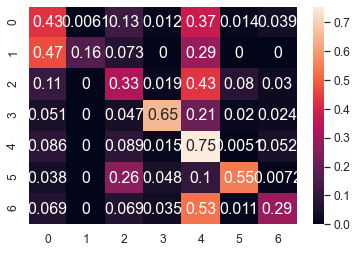

	training epoch=17 .. train_loss=1.124
	validation epoch=17 .. val_loss=1.314
	Accuracy = 50.6 % .. Percision = 59.9 % .. Recall = 45.0 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_17.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 18 .. loss = 1.045


  0%|                                                                               | 1/1914 [00:02<1:15:46,  2.38s/it]

training @ epoch 18 .. loss = 1.078


  0%|                                                                               | 2/1914 [00:03<1:04:32,  2.03s/it]

training @ epoch 18 .. loss = 1.246


  0%|▏                                                                                | 3/1914 [00:04<56:04,  1.76s/it]

training @ epoch 18 .. loss = 1.114


  0%|▏                                                                                | 4/1914 [00:05<51:19,  1.61s/it]

training @ epoch 18 .. loss = 0.885


  0%|▏                                                                                | 5/1914 [00:07<46:51,  1.47s/it]

training @ epoch 18 .. loss = 1.316


  0%|▎                                                                                | 6/1914 [00:08<43:01,  1.35s/it]

training @ epoch 18 .. loss = 1.359


  0%|▎                                                                                | 7/1914 [00:09<40:34,  1.28s/it]

training @ epoch 18 .. loss = 1.182


  0%|▎                                                                                | 8/1914 [00:10<38:54,  1.22s/it]

training @ epoch 18 .. loss = 0.982


  0%|▍                                                                                | 9/1914 [00:11<37:49,  1.19s/it]

training @ epoch 18 .. loss = 0.962


  1%|▍                                                                               | 10/1914 [00:12<36:56,  1.16s/it]

training @ epoch 18 .. loss = 1.311


  1%|▍                                                                               | 11/1914 [00:13<36:08,  1.14s/it]

training @ epoch 18 .. loss = 1.435


  1%|▌                                                                               | 12/1914 [00:14<35:41,  1.13s/it]

training @ epoch 18 .. loss = 1.306


  1%|▌                                                                               | 13/1914 [00:16<38:01,  1.20s/it]

training @ epoch 18 .. loss = 1.078


  1%|▌                                                                               | 14/1914 [00:17<37:16,  1.18s/it]

training @ epoch 18 .. loss = 0.816


  1%|▋                                                                               | 15/1914 [00:18<36:31,  1.15s/it]

training @ epoch 18 .. loss = 0.951


  1%|▋                                                                               | 16/1914 [00:19<36:05,  1.14s/it]

training @ epoch 18 .. loss = 0.997


  1%|▋                                                                               | 17/1914 [00:20<35:23,  1.12s/it]

training @ epoch 18 .. loss = 1.121


  1%|▊                                                                               | 18/1914 [00:21<35:52,  1.14s/it]

training @ epoch 18 .. loss = 0.677


  1%|▊                                                                               | 19/1914 [00:22<36:24,  1.15s/it]

training @ epoch 18 .. loss = 0.771


  1%|▊                                                                               | 20/1914 [00:24<35:50,  1.14s/it]

training @ epoch 18 .. loss = 0.58


  1%|▉                                                                               | 21/1914 [00:25<35:37,  1.13s/it]

training @ epoch 18 .. loss = 1.195


  1%|▉                                                                               | 22/1914 [00:26<35:04,  1.11s/it]

training @ epoch 18 .. loss = 0.823


  1%|▉                                                                               | 23/1914 [00:27<34:53,  1.11s/it]

training @ epoch 18 .. loss = 0.672


  1%|█                                                                               | 24/1914 [00:28<34:35,  1.10s/it]

training @ epoch 18 .. loss = 1.357


  1%|█                                                                               | 25/1914 [00:29<34:43,  1.10s/it]

training @ epoch 18 .. loss = 0.933


  1%|█                                                                               | 26/1914 [00:30<35:09,  1.12s/it]

training @ epoch 18 .. loss = 0.706


  1%|█▏                                                                              | 27/1914 [00:31<34:46,  1.11s/it]

training @ epoch 18 .. loss = 0.964


  1%|█▏                                                                              | 28/1914 [00:32<34:39,  1.10s/it]

training @ epoch 18 .. loss = 1.12


  2%|█▏                                                                              | 29/1914 [00:34<35:23,  1.13s/it]

training @ epoch 18 .. loss = 1.648


  2%|█▎                                                                              | 30/1914 [00:35<35:13,  1.12s/it]

training @ epoch 18 .. loss = 1.475


  2%|█▎                                                                              | 31/1914 [00:36<34:37,  1.10s/it]

training @ epoch 18 .. loss = 0.78


  2%|█▎                                                                              | 32/1914 [00:37<34:26,  1.10s/it]

training @ epoch 18 .. loss = 0.804


  2%|█▍                                                                              | 33/1914 [00:38<33:55,  1.08s/it]

training @ epoch 18 .. loss = 0.862


  2%|█▍                                                                              | 34/1914 [00:39<34:11,  1.09s/it]

training @ epoch 18 .. loss = 0.609


  2%|█▍                                                                              | 35/1914 [00:40<34:18,  1.10s/it]

training @ epoch 18 .. loss = 1.029


  2%|█▌                                                                              | 36/1914 [00:41<33:58,  1.09s/it]

training @ epoch 18 .. loss = 0.868


  2%|█▌                                                                              | 37/1914 [00:42<34:05,  1.09s/it]

training @ epoch 18 .. loss = 0.758


  2%|█▌                                                                              | 38/1914 [00:43<34:34,  1.11s/it]

training @ epoch 18 .. loss = 1.759


  2%|█▋                                                                              | 39/1914 [00:44<33:54,  1.08s/it]

training @ epoch 18 .. loss = 1.331


  2%|█▋                                                                              | 40/1914 [00:45<33:58,  1.09s/it]

training @ epoch 18 .. loss = 0.991


  2%|█▋                                                                              | 41/1914 [00:47<33:36,  1.08s/it]

training @ epoch 18 .. loss = 0.891


  2%|█▊                                                                              | 42/1914 [00:48<33:59,  1.09s/it]

training @ epoch 18 .. loss = 1.545


  2%|█▊                                                                              | 43/1914 [00:49<33:42,  1.08s/it]

training @ epoch 18 .. loss = 0.758


  2%|█▊                                                                              | 44/1914 [00:50<33:44,  1.08s/it]

training @ epoch 18 .. loss = 0.954


  2%|█▉                                                                              | 45/1914 [00:51<33:50,  1.09s/it]

training @ epoch 18 .. loss = 0.794


  2%|█▉                                                                              | 46/1914 [00:52<33:51,  1.09s/it]

training @ epoch 18 .. loss = 1.538


  2%|█▉                                                                              | 47/1914 [00:53<33:52,  1.09s/it]

training @ epoch 18 .. loss = 1.813


  3%|██                                                                              | 48/1914 [00:54<33:44,  1.09s/it]

training @ epoch 18 .. loss = 1.238


  3%|██                                                                              | 49/1914 [00:55<33:58,  1.09s/it]

training @ epoch 18 .. loss = 1.074


  3%|██                                                                              | 50/1914 [00:56<33:56,  1.09s/it]

training @ epoch 18 .. loss = 0.803


  3%|██▏                                                                             | 51/1914 [00:57<33:46,  1.09s/it]

training @ epoch 18 .. loss = 1.298


  3%|██▏                                                                             | 52/1914 [00:59<33:38,  1.08s/it]

training @ epoch 18 .. loss = 1.2


  3%|██▏                                                                             | 53/1914 [01:00<33:59,  1.10s/it]

training @ epoch 18 .. loss = 0.928


  3%|██▎                                                                             | 54/1914 [01:01<36:56,  1.19s/it]

training @ epoch 18 .. loss = 1.254


  3%|██▎                                                                             | 55/1914 [01:02<37:23,  1.21s/it]

training @ epoch 18 .. loss = 1.068


  3%|██▎                                                                             | 56/1914 [01:04<38:10,  1.23s/it]

training @ epoch 18 .. loss = 0.974


  3%|██▍                                                                             | 57/1914 [01:05<38:09,  1.23s/it]

training @ epoch 18 .. loss = 1.241


  3%|██▍                                                                             | 58/1914 [01:06<36:34,  1.18s/it]

training @ epoch 18 .. loss = 1.071


  3%|██▍                                                                             | 59/1914 [01:07<35:23,  1.14s/it]

training @ epoch 18 .. loss = 1.504


  3%|██▌                                                                             | 60/1914 [01:08<35:07,  1.14s/it]

training @ epoch 18 .. loss = 1.366


  3%|██▌                                                                             | 61/1914 [01:09<34:29,  1.12s/it]

training @ epoch 18 .. loss = 1.039


  3%|██▌                                                                             | 62/1914 [01:10<34:20,  1.11s/it]

training @ epoch 18 .. loss = 1.338


  3%|██▋                                                                             | 63/1914 [01:11<34:06,  1.11s/it]

training @ epoch 18 .. loss = 1.126


  3%|██▋                                                                             | 64/1914 [01:12<33:53,  1.10s/it]

training @ epoch 18 .. loss = 0.828


  3%|██▋                                                                             | 65/1914 [01:13<33:29,  1.09s/it]

training @ epoch 18 .. loss = 1.005


  3%|██▊                                                                             | 66/1914 [01:15<33:23,  1.08s/it]

training @ epoch 18 .. loss = 0.89


  4%|██▊                                                                             | 67/1914 [01:16<32:47,  1.07s/it]

training @ epoch 18 .. loss = 1.318


  4%|██▊                                                                             | 68/1914 [01:17<32:42,  1.06s/it]

training @ epoch 18 .. loss = 0.949


  4%|██▉                                                                             | 69/1914 [01:18<32:47,  1.07s/it]

training @ epoch 18 .. loss = 0.712


  4%|██▉                                                                             | 70/1914 [01:19<32:51,  1.07s/it]

training @ epoch 18 .. loss = 0.751


  4%|██▉                                                                             | 71/1914 [01:20<32:50,  1.07s/it]

training @ epoch 18 .. loss = 1.463


  4%|███                                                                             | 72/1914 [01:21<33:13,  1.08s/it]

training @ epoch 18 .. loss = 0.969


  4%|███                                                                             | 73/1914 [01:22<33:04,  1.08s/it]

training @ epoch 18 .. loss = 0.956


  4%|███                                                                             | 74/1914 [01:23<33:09,  1.08s/it]

training @ epoch 18 .. loss = 1.477


  4%|███▏                                                                            | 75/1914 [01:24<33:25,  1.09s/it]

training @ epoch 18 .. loss = 1.534


  4%|███▏                                                                            | 76/1914 [01:25<33:11,  1.08s/it]

training @ epoch 18 .. loss = 1.117


  4%|███▏                                                                            | 77/1914 [01:26<33:15,  1.09s/it]

training @ epoch 18 .. loss = 1.017


  4%|███▎                                                                            | 78/1914 [01:28<33:39,  1.10s/it]

training @ epoch 18 .. loss = 0.891


  4%|███▎                                                                            | 79/1914 [01:29<33:05,  1.08s/it]

training @ epoch 18 .. loss = 1.2


  4%|███▎                                                                            | 80/1914 [01:30<32:58,  1.08s/it]

training @ epoch 18 .. loss = 1.15


  4%|███▍                                                                            | 81/1914 [01:31<32:49,  1.07s/it]

training @ epoch 18 .. loss = 0.906


  4%|███▍                                                                            | 82/1914 [01:32<32:35,  1.07s/it]

training @ epoch 18 .. loss = 1.027


  4%|███▍                                                                            | 83/1914 [01:33<32:08,  1.05s/it]

training @ epoch 18 .. loss = 1.393


  4%|███▌                                                                            | 84/1914 [01:34<32:43,  1.07s/it]

training @ epoch 18 .. loss = 0.956


  4%|███▌                                                                            | 85/1914 [01:35<32:29,  1.07s/it]

training @ epoch 18 .. loss = 0.844


  4%|███▌                                                                            | 86/1914 [01:36<32:31,  1.07s/it]

training @ epoch 18 .. loss = 1.134


  5%|███▋                                                                            | 87/1914 [01:37<32:54,  1.08s/it]

training @ epoch 18 .. loss = 1.27


  5%|███▋                                                                            | 88/1914 [01:38<33:27,  1.10s/it]

training @ epoch 18 .. loss = 1.27


  5%|███▋                                                                            | 89/1914 [01:39<33:09,  1.09s/it]

training @ epoch 18 .. loss = 0.738


  5%|███▊                                                                            | 90/1914 [01:40<33:04,  1.09s/it]

training @ epoch 18 .. loss = 1.468


  5%|███▊                                                                            | 91/1914 [01:42<33:16,  1.10s/it]

training @ epoch 18 .. loss = 0.7


  5%|███▊                                                                            | 92/1914 [01:43<33:23,  1.10s/it]

training @ epoch 18 .. loss = 1.679


  5%|███▉                                                                            | 93/1914 [01:44<33:10,  1.09s/it]

training @ epoch 18 .. loss = 1.038


  5%|███▉                                                                            | 94/1914 [01:45<32:57,  1.09s/it]

training @ epoch 18 .. loss = 0.778


  5%|███▉                                                                            | 95/1914 [01:46<32:46,  1.08s/it]

training @ epoch 18 .. loss = 1.473


  5%|████                                                                            | 96/1914 [01:47<32:48,  1.08s/it]

training @ epoch 18 .. loss = 0.907


  5%|████                                                                            | 97/1914 [01:48<32:47,  1.08s/it]

training @ epoch 18 .. loss = 0.929


  5%|████                                                                            | 98/1914 [01:49<32:41,  1.08s/it]

training @ epoch 18 .. loss = 1.124


  5%|████▏                                                                           | 99/1914 [01:50<32:35,  1.08s/it]

training @ epoch 18 .. loss = 1.021


  5%|████▏                                                                          | 100/1914 [01:51<32:52,  1.09s/it]

training @ epoch 18 .. loss = 1.458


  5%|████▏                                                                          | 101/1914 [01:52<32:31,  1.08s/it]

training @ epoch 18 .. loss = 1.185


  5%|████▏                                                                          | 102/1914 [01:53<32:33,  1.08s/it]

training @ epoch 18 .. loss = 0.854


  5%|████▎                                                                          | 103/1914 [01:54<32:36,  1.08s/it]

training @ epoch 18 .. loss = 1.305


  5%|████▎                                                                          | 104/1914 [01:56<32:14,  1.07s/it]

training @ epoch 18 .. loss = 0.86


  5%|████▎                                                                          | 105/1914 [01:57<32:44,  1.09s/it]

training @ epoch 18 .. loss = 1.222


  6%|████▍                                                                          | 106/1914 [01:58<32:29,  1.08s/it]

training @ epoch 18 .. loss = 0.981


  6%|████▍                                                                          | 107/1914 [01:59<32:27,  1.08s/it]

training @ epoch 18 .. loss = 1.038


  6%|████▍                                                                          | 108/1914 [02:00<32:21,  1.07s/it]

training @ epoch 18 .. loss = 0.816


  6%|████▍                                                                          | 109/1914 [02:01<32:22,  1.08s/it]

training @ epoch 18 .. loss = 1.572


  6%|████▌                                                                          | 110/1914 [02:02<32:29,  1.08s/it]

training @ epoch 18 .. loss = 1.388


  6%|████▌                                                                          | 111/1914 [02:03<32:19,  1.08s/it]

training @ epoch 18 .. loss = 0.907


  6%|████▌                                                                          | 112/1914 [02:04<32:32,  1.08s/it]

training @ epoch 18 .. loss = 0.662


  6%|████▋                                                                          | 113/1914 [02:05<32:24,  1.08s/it]

training @ epoch 18 .. loss = 1.273


  6%|████▋                                                                          | 114/1914 [02:06<32:16,  1.08s/it]

training @ epoch 18 .. loss = 1.659


  6%|████▋                                                                          | 115/1914 [02:07<32:27,  1.08s/it]

training @ epoch 18 .. loss = 1.77


  6%|████▊                                                                          | 116/1914 [02:08<32:10,  1.07s/it]

training @ epoch 18 .. loss = 1.524


  6%|████▊                                                                          | 117/1914 [02:10<32:06,  1.07s/it]

training @ epoch 18 .. loss = 1.137


  6%|████▊                                                                          | 118/1914 [02:11<31:57,  1.07s/it]

training @ epoch 18 .. loss = 0.88


  6%|████▉                                                                          | 119/1914 [02:12<32:03,  1.07s/it]

training @ epoch 18 .. loss = 1.174


  6%|████▉                                                                          | 120/1914 [02:13<31:58,  1.07s/it]

training @ epoch 18 .. loss = 1.535


  6%|████▉                                                                          | 121/1914 [02:14<32:07,  1.08s/it]

training @ epoch 18 .. loss = 0.933


  6%|█████                                                                          | 122/1914 [02:15<32:24,  1.09s/it]

training @ epoch 18 .. loss = 0.859


  6%|█████                                                                          | 123/1914 [02:16<32:13,  1.08s/it]

training @ epoch 18 .. loss = 1.419


  6%|█████                                                                          | 124/1914 [02:17<32:24,  1.09s/it]

training @ epoch 18 .. loss = 0.87


  7%|█████▏                                                                         | 125/1914 [02:18<32:27,  1.09s/it]

training @ epoch 18 .. loss = 1.121


  7%|█████▏                                                                         | 126/1914 [02:19<33:05,  1.11s/it]

training @ epoch 18 .. loss = 1.19


  7%|█████▏                                                                         | 127/1914 [02:20<32:31,  1.09s/it]

training @ epoch 18 .. loss = 1.142


  7%|█████▎                                                                         | 128/1914 [02:22<32:51,  1.10s/it]

training @ epoch 18 .. loss = 1.1


  7%|█████▎                                                                         | 129/1914 [02:23<32:07,  1.08s/it]

training @ epoch 18 .. loss = 1.041


  7%|█████▎                                                                         | 130/1914 [02:24<32:22,  1.09s/it]

training @ epoch 18 .. loss = 0.982


  7%|█████▍                                                                         | 131/1914 [02:25<32:16,  1.09s/it]

training @ epoch 18 .. loss = 1.294


  7%|█████▍                                                                         | 132/1914 [02:26<32:08,  1.08s/it]

training @ epoch 18 .. loss = 1.182


  7%|█████▍                                                                         | 133/1914 [02:27<32:05,  1.08s/it]

training @ epoch 18 .. loss = 0.969


  7%|█████▌                                                                         | 134/1914 [02:28<32:10,  1.08s/it]

training @ epoch 18 .. loss = 0.841


  7%|█████▌                                                                         | 135/1914 [02:29<32:17,  1.09s/it]

training @ epoch 18 .. loss = 1.301


  7%|█████▌                                                                         | 136/1914 [02:30<32:38,  1.10s/it]

training @ epoch 18 .. loss = 0.5


  7%|█████▋                                                                         | 137/1914 [02:31<33:44,  1.14s/it]

training @ epoch 18 .. loss = 1.644


  7%|█████▋                                                                         | 138/1914 [02:33<34:33,  1.17s/it]

training @ epoch 18 .. loss = 1.128


  7%|█████▋                                                                         | 139/1914 [02:34<35:30,  1.20s/it]

training @ epoch 18 .. loss = 1.011


  7%|█████▊                                                                         | 140/1914 [02:35<36:29,  1.23s/it]

training @ epoch 18 .. loss = 1.08


  7%|█████▊                                                                         | 141/1914 [02:37<36:58,  1.25s/it]

training @ epoch 18 .. loss = 0.502


  7%|█████▊                                                                         | 142/1914 [02:38<35:58,  1.22s/it]

training @ epoch 18 .. loss = 0.857


  7%|█████▉                                                                         | 143/1914 [02:39<36:09,  1.23s/it]

training @ epoch 18 .. loss = 1.476


  8%|█████▉                                                                         | 144/1914 [02:40<36:06,  1.22s/it]

training @ epoch 18 .. loss = 1.368


  8%|█████▉                                                                         | 145/1914 [02:41<36:09,  1.23s/it]

training @ epoch 18 .. loss = 1.046


  8%|██████                                                                         | 146/1914 [02:43<35:55,  1.22s/it]

training @ epoch 18 .. loss = 0.977


  8%|██████                                                                         | 147/1914 [02:44<35:50,  1.22s/it]

training @ epoch 18 .. loss = 1.02


  8%|██████                                                                         | 148/1914 [02:45<35:18,  1.20s/it]

training @ epoch 18 .. loss = 0.796


  8%|██████▏                                                                        | 149/1914 [02:46<35:41,  1.21s/it]

training @ epoch 18 .. loss = 1.229


  8%|██████▏                                                                        | 150/1914 [02:48<36:25,  1.24s/it]

training @ epoch 18 .. loss = 1.295


  8%|██████▏                                                                        | 151/1914 [02:49<36:58,  1.26s/it]

training @ epoch 18 .. loss = 1.177


  8%|██████▎                                                                        | 152/1914 [02:50<35:10,  1.20s/it]

training @ epoch 18 .. loss = 1.13


  8%|██████▎                                                                        | 153/1914 [02:51<34:33,  1.18s/it]

training @ epoch 18 .. loss = 1.299


  8%|██████▎                                                                        | 154/1914 [02:52<33:52,  1.15s/it]

training @ epoch 18 .. loss = 0.93


  8%|██████▍                                                                        | 155/1914 [02:53<33:18,  1.14s/it]

training @ epoch 18 .. loss = 0.643


  8%|██████▍                                                                        | 156/1914 [02:54<32:47,  1.12s/it]

training @ epoch 18 .. loss = 1.004


  8%|██████▍                                                                        | 157/1914 [02:55<32:26,  1.11s/it]

training @ epoch 18 .. loss = 1.019


  8%|██████▌                                                                        | 158/1914 [02:56<32:26,  1.11s/it]

training @ epoch 18 .. loss = 1.269


  8%|██████▌                                                                        | 159/1914 [02:58<32:22,  1.11s/it]

training @ epoch 18 .. loss = 1.24


  8%|██████▌                                                                        | 160/1914 [02:59<31:52,  1.09s/it]

training @ epoch 18 .. loss = 0.877


  8%|██████▋                                                                        | 161/1914 [03:00<31:51,  1.09s/it]

training @ epoch 18 .. loss = 1.144


  8%|██████▋                                                                        | 162/1914 [03:01<31:50,  1.09s/it]

training @ epoch 18 .. loss = 0.996


  9%|██████▋                                                                        | 163/1914 [03:02<31:47,  1.09s/it]

training @ epoch 18 .. loss = 1.28


  9%|██████▊                                                                        | 164/1914 [03:03<31:34,  1.08s/it]

training @ epoch 18 .. loss = 0.935


  9%|██████▊                                                                        | 165/1914 [03:04<31:32,  1.08s/it]

training @ epoch 18 .. loss = 1.209


  9%|██████▊                                                                        | 166/1914 [03:05<31:24,  1.08s/it]

training @ epoch 18 .. loss = 1.0


  9%|██████▉                                                                        | 167/1914 [03:06<31:55,  1.10s/it]

training @ epoch 18 .. loss = 1.499


  9%|██████▉                                                                        | 168/1914 [03:07<31:35,  1.09s/it]

training @ epoch 18 .. loss = 1.067


  9%|██████▉                                                                        | 169/1914 [03:08<31:34,  1.09s/it]

training @ epoch 18 .. loss = 1.296


  9%|███████                                                                        | 170/1914 [03:09<31:25,  1.08s/it]

training @ epoch 18 .. loss = 1.183


  9%|███████                                                                        | 171/1914 [03:11<31:02,  1.07s/it]

training @ epoch 18 .. loss = 1.277


  9%|███████                                                                        | 172/1914 [03:12<30:49,  1.06s/it]

training @ epoch 18 .. loss = 1.318


  9%|███████▏                                                                       | 173/1914 [03:13<30:45,  1.06s/it]

training @ epoch 18 .. loss = 0.955


  9%|███████▏                                                                       | 174/1914 [03:14<30:54,  1.07s/it]

training @ epoch 18 .. loss = 1.237


  9%|███████▏                                                                       | 175/1914 [03:15<30:43,  1.06s/it]

training @ epoch 18 .. loss = 0.909


  9%|███████▎                                                                       | 176/1914 [03:16<30:45,  1.06s/it]

training @ epoch 18 .. loss = 1.098


  9%|███████▎                                                                       | 177/1914 [03:17<30:56,  1.07s/it]

training @ epoch 18 .. loss = 0.863


  9%|███████▎                                                                       | 178/1914 [03:18<31:00,  1.07s/it]

training @ epoch 18 .. loss = 1.128


  9%|███████▍                                                                       | 179/1914 [03:19<31:03,  1.07s/it]

training @ epoch 18 .. loss = 0.915


  9%|███████▍                                                                       | 180/1914 [03:20<31:11,  1.08s/it]

training @ epoch 18 .. loss = 1.201


  9%|███████▍                                                                       | 181/1914 [03:21<31:07,  1.08s/it]

training @ epoch 18 .. loss = 1.173


 10%|███████▌                                                                       | 182/1914 [03:22<31:03,  1.08s/it]

training @ epoch 18 .. loss = 1.236


 10%|███████▌                                                                       | 183/1914 [03:23<31:21,  1.09s/it]

training @ epoch 18 .. loss = 0.823


 10%|███████▌                                                                       | 184/1914 [03:24<31:18,  1.09s/it]

training @ epoch 18 .. loss = 0.992


 10%|███████▋                                                                       | 185/1914 [03:26<30:57,  1.07s/it]

training @ epoch 18 .. loss = 1.098


 10%|███████▋                                                                       | 186/1914 [03:27<30:52,  1.07s/it]

training @ epoch 18 .. loss = 1.482


 10%|███████▋                                                                       | 187/1914 [03:28<30:44,  1.07s/it]

training @ epoch 18 .. loss = 1.277


 10%|███████▊                                                                       | 188/1914 [03:29<30:45,  1.07s/it]

training @ epoch 18 .. loss = 0.919


 10%|███████▊                                                                       | 189/1914 [03:30<30:34,  1.06s/it]

training @ epoch 18 .. loss = 0.869


 10%|███████▊                                                                       | 190/1914 [03:31<30:48,  1.07s/it]

training @ epoch 18 .. loss = 1.082


 10%|███████▉                                                                       | 191/1914 [03:32<30:48,  1.07s/it]

training @ epoch 18 .. loss = 1.109


 10%|███████▉                                                                       | 192/1914 [03:33<30:51,  1.08s/it]

training @ epoch 18 .. loss = 0.973


 10%|███████▉                                                                       | 193/1914 [03:34<30:56,  1.08s/it]

training @ epoch 18 .. loss = 1.279


 10%|████████                                                                       | 194/1914 [03:35<31:08,  1.09s/it]

training @ epoch 18 .. loss = 1.256


 10%|████████                                                                       | 195/1914 [03:36<31:03,  1.08s/it]

training @ epoch 18 .. loss = 1.187


 10%|████████                                                                       | 196/1914 [03:37<31:24,  1.10s/it]

training @ epoch 18 .. loss = 1.523


 10%|████████▏                                                                      | 197/1914 [03:38<31:04,  1.09s/it]

training @ epoch 18 .. loss = 0.909


 10%|████████▏                                                                      | 198/1914 [03:40<30:29,  1.07s/it]

training @ epoch 18 .. loss = 1.113


 10%|████████▏                                                                      | 199/1914 [03:41<30:39,  1.07s/it]

training @ epoch 18 .. loss = 0.676


 10%|████████▎                                                                      | 200/1914 [03:42<30:15,  1.06s/it]

training @ epoch 18 .. loss = 1.167


 11%|████████▎                                                                      | 201/1914 [03:43<30:42,  1.08s/it]

training @ epoch 18 .. loss = 1.346


 11%|████████▎                                                                      | 202/1914 [03:44<30:17,  1.06s/it]

training @ epoch 18 .. loss = 1.135


 11%|████████▍                                                                      | 203/1914 [03:45<30:23,  1.07s/it]

training @ epoch 18 .. loss = 1.835


 11%|████████▍                                                                      | 204/1914 [03:46<30:22,  1.07s/it]

training @ epoch 18 .. loss = 1.015


 11%|████████▍                                                                      | 205/1914 [03:47<30:40,  1.08s/it]

training @ epoch 18 .. loss = 1.071


 11%|████████▌                                                                      | 206/1914 [03:48<30:47,  1.08s/it]

training @ epoch 18 .. loss = 0.737


 11%|████████▌                                                                      | 207/1914 [03:49<31:01,  1.09s/it]

training @ epoch 18 .. loss = 0.978


 11%|████████▌                                                                      | 208/1914 [03:52<42:51,  1.51s/it]

training @ epoch 18 .. loss = 0.884


 11%|████████▋                                                                      | 209/1914 [03:53<41:41,  1.47s/it]

training @ epoch 18 .. loss = 1.052


 11%|████████▋                                                                      | 210/1914 [03:55<45:18,  1.60s/it]

training @ epoch 18 .. loss = 1.216


 11%|████████▍                                                                    | 211/1914 [04:47<7:57:43, 16.83s/it]

training @ epoch 18 .. loss = 1.285


 11%|████████▌                                                                    | 212/1914 [04:50<5:53:41, 12.47s/it]

training @ epoch 18 .. loss = 1.3


 11%|████████▌                                                                    | 213/1914 [04:54<4:42:24,  9.96s/it]

training @ epoch 18 .. loss = 1.285


 11%|████████▌                                                                    | 214/1914 [04:56<3:38:34,  7.71s/it]

training @ epoch 18 .. loss = 1.662


 11%|████████▋                                                                    | 215/1914 [04:59<2:53:59,  6.14s/it]

training @ epoch 18 .. loss = 0.994


 11%|████████▋                                                                    | 216/1914 [05:01<2:17:10,  4.85s/it]

training @ epoch 18 .. loss = 1.321


 11%|████████▋                                                                    | 217/1914 [05:02<1:50:53,  3.92s/it]

training @ epoch 18 .. loss = 1.148


 11%|████████▊                                                                    | 218/1914 [05:04<1:33:51,  3.32s/it]

training @ epoch 18 .. loss = 0.93


 11%|████████▊                                                                    | 219/1914 [05:06<1:20:17,  2.84s/it]

training @ epoch 18 .. loss = 0.809


 11%|████████▊                                                                    | 220/1914 [05:08<1:16:16,  2.70s/it]

training @ epoch 18 .. loss = 1.186


 12%|████████▉                                                                    | 221/1914 [05:10<1:08:06,  2.41s/it]

training @ epoch 18 .. loss = 1.168


 12%|████████▉                                                                    | 222/1914 [05:12<1:03:06,  2.24s/it]

training @ epoch 18 .. loss = 1.069


 12%|█████████▏                                                                     | 223/1914 [05:14<58:21,  2.07s/it]

training @ epoch 18 .. loss = 1.204


 12%|█████████▏                                                                     | 224/1914 [05:15<55:55,  1.99s/it]

training @ epoch 18 .. loss = 0.942


 12%|█████████▎                                                                     | 225/1914 [05:17<53:31,  1.90s/it]

training @ epoch 18 .. loss = 0.954


 12%|█████████▎                                                                     | 226/1914 [05:19<53:04,  1.89s/it]

training @ epoch 18 .. loss = 0.854


 12%|█████████▎                                                                     | 227/1914 [05:21<51:16,  1.82s/it]

training @ epoch 18 .. loss = 0.763


 12%|█████████▍                                                                     | 228/1914 [05:22<50:55,  1.81s/it]

training @ epoch 18 .. loss = 1.285


 12%|█████████▍                                                                     | 229/1914 [05:24<48:54,  1.74s/it]

training @ epoch 18 .. loss = 0.909


 12%|█████████▍                                                                     | 230/1914 [05:25<47:08,  1.68s/it]

training @ epoch 18 .. loss = 0.913


 12%|█████████▌                                                                     | 231/1914 [05:27<45:39,  1.63s/it]

training @ epoch 18 .. loss = 1.192


 12%|█████████▌                                                                     | 232/1914 [05:29<49:03,  1.75s/it]

training @ epoch 18 .. loss = 1.361


 12%|█████████▌                                                                     | 233/1914 [05:31<47:49,  1.71s/it]

training @ epoch 18 .. loss = 0.75


 12%|█████████▋                                                                     | 234/1914 [05:32<46:26,  1.66s/it]

training @ epoch 18 .. loss = 0.803


 12%|█████████▋                                                                     | 235/1914 [05:34<46:19,  1.66s/it]

training @ epoch 18 .. loss = 0.945


 12%|█████████▋                                                                     | 236/1914 [05:35<46:29,  1.66s/it]

training @ epoch 18 .. loss = 0.967


 12%|█████████▊                                                                     | 237/1914 [05:37<46:20,  1.66s/it]

training @ epoch 18 .. loss = 1.545


 12%|█████████▊                                                                     | 238/1914 [05:39<44:31,  1.59s/it]

training @ epoch 18 .. loss = 1.137


 12%|█████████▊                                                                     | 239/1914 [05:40<45:11,  1.62s/it]

training @ epoch 18 .. loss = 1.081


 13%|█████████▉                                                                     | 240/1914 [05:42<43:54,  1.57s/it]

training @ epoch 18 .. loss = 1.024


 13%|█████████▉                                                                     | 241/1914 [05:43<42:31,  1.53s/it]

training @ epoch 18 .. loss = 1.226


 13%|█████████▉                                                                     | 242/1914 [05:45<41:45,  1.50s/it]

training @ epoch 18 .. loss = 0.823


 13%|██████████                                                                     | 243/1914 [05:46<42:28,  1.52s/it]

training @ epoch 18 .. loss = 1.206


 13%|██████████                                                                     | 244/1914 [05:48<41:20,  1.49s/it]

training @ epoch 18 .. loss = 1.137


 13%|██████████                                                                     | 245/1914 [05:49<40:58,  1.47s/it]

training @ epoch 18 .. loss = 1.305


 13%|██████████▏                                                                    | 246/1914 [05:51<45:19,  1.63s/it]

training @ epoch 18 .. loss = 0.667


 13%|██████████▏                                                                    | 247/1914 [05:53<52:23,  1.89s/it]

training @ epoch 18 .. loss = 1.181


 13%|██████████▏                                                                    | 248/1914 [05:56<58:40,  2.11s/it]

training @ epoch 18 .. loss = 0.898


 13%|██████████                                                                   | 249/1914 [06:00<1:13:06,  2.63s/it]

training @ epoch 18 .. loss = 1.111


 13%|██████████                                                                   | 250/1914 [06:04<1:22:25,  2.97s/it]

training @ epoch 18 .. loss = 0.723


 13%|██████████                                                                   | 251/1914 [06:07<1:21:33,  2.94s/it]

training @ epoch 18 .. loss = 0.866


 13%|██████████▏                                                                  | 252/1914 [06:08<1:09:45,  2.52s/it]

training @ epoch 18 .. loss = 1.289


 13%|██████████▏                                                                  | 253/1914 [06:10<1:00:48,  2.20s/it]

training @ epoch 18 .. loss = 0.677


 13%|██████████▍                                                                    | 254/1914 [06:11<54:42,  1.98s/it]

training @ epoch 18 .. loss = 1.019


 13%|██████████▌                                                                    | 255/1914 [06:12<49:35,  1.79s/it]

training @ epoch 18 .. loss = 0.969


 13%|██████████▌                                                                    | 256/1914 [06:14<45:24,  1.64s/it]

training @ epoch 18 .. loss = 1.134


 13%|██████████▌                                                                    | 257/1914 [06:15<42:45,  1.55s/it]

training @ epoch 18 .. loss = 0.821


 13%|██████████▋                                                                    | 258/1914 [06:17<42:13,  1.53s/it]

training @ epoch 18 .. loss = 1.074


 14%|██████████▋                                                                    | 259/1914 [06:18<41:55,  1.52s/it]

training @ epoch 18 .. loss = 1.006


 14%|██████████▋                                                                    | 260/1914 [06:19<41:07,  1.49s/it]

training @ epoch 18 .. loss = 1.255


 14%|██████████▊                                                                    | 261/1914 [06:21<40:22,  1.47s/it]

training @ epoch 18 .. loss = 1.092


 14%|██████████▊                                                                    | 262/1914 [06:22<39:55,  1.45s/it]

training @ epoch 18 .. loss = 0.988


 14%|██████████▊                                                                    | 263/1914 [06:24<38:31,  1.40s/it]

training @ epoch 18 .. loss = 0.934


 14%|██████████▉                                                                    | 264/1914 [06:25<38:18,  1.39s/it]

training @ epoch 18 .. loss = 1.394


 14%|██████████▉                                                                    | 265/1914 [06:26<38:03,  1.38s/it]

training @ epoch 18 .. loss = 0.993


 14%|██████████▉                                                                    | 266/1914 [06:28<39:55,  1.45s/it]

training @ epoch 18 .. loss = 1.575


 14%|███████████                                                                    | 267/1914 [06:29<40:35,  1.48s/it]

training @ epoch 18 .. loss = 0.992


 14%|███████████                                                                    | 268/1914 [06:31<41:37,  1.52s/it]

training @ epoch 18 .. loss = 1.187


 14%|███████████                                                                    | 269/1914 [06:33<43:09,  1.57s/it]

training @ epoch 18 .. loss = 1.497


 14%|███████████▏                                                                   | 270/1914 [06:34<41:51,  1.53s/it]

training @ epoch 18 .. loss = 1.057


 14%|███████████▏                                                                   | 271/1914 [06:36<41:13,  1.51s/it]

training @ epoch 18 .. loss = 0.832


 14%|███████████▏                                                                   | 272/1914 [06:37<41:56,  1.53s/it]

training @ epoch 18 .. loss = 1.134


 14%|███████████▎                                                                   | 273/1914 [06:39<40:41,  1.49s/it]

training @ epoch 18 .. loss = 1.04


 14%|███████████▎                                                                   | 274/1914 [06:40<39:55,  1.46s/it]

training @ epoch 18 .. loss = 0.7


 14%|███████████▎                                                                   | 275/1914 [06:41<39:21,  1.44s/it]

training @ epoch 18 .. loss = 1.001


 14%|███████████▍                                                                   | 276/1914 [06:43<38:17,  1.40s/it]

training @ epoch 18 .. loss = 0.999


 14%|███████████▍                                                                   | 277/1914 [06:44<37:52,  1.39s/it]

training @ epoch 18 .. loss = 0.814


 15%|███████████▍                                                                   | 278/1914 [06:45<37:04,  1.36s/it]

training @ epoch 18 .. loss = 1.076


 15%|███████████▌                                                                   | 279/1914 [06:47<36:20,  1.33s/it]

training @ epoch 18 .. loss = 1.23


 15%|███████████▌                                                                   | 280/1914 [06:48<37:23,  1.37s/it]

training @ epoch 18 .. loss = 0.786


 15%|███████████▌                                                                   | 281/1914 [06:49<36:48,  1.35s/it]

training @ epoch 18 .. loss = 1.454


 15%|███████████▋                                                                   | 282/1914 [06:51<36:28,  1.34s/it]

training @ epoch 18 .. loss = 0.761


 15%|███████████▋                                                                   | 283/1914 [06:52<36:32,  1.34s/it]

training @ epoch 18 .. loss = 1.479


 15%|███████████▋                                                                   | 284/1914 [06:53<36:22,  1.34s/it]

training @ epoch 18 .. loss = 0.842


 15%|███████████▊                                                                   | 285/1914 [06:55<35:43,  1.32s/it]

training @ epoch 18 .. loss = 0.883


 15%|███████████▊                                                                   | 286/1914 [06:56<37:05,  1.37s/it]

training @ epoch 18 .. loss = 1.296


 15%|███████████▊                                                                   | 287/1914 [06:57<36:18,  1.34s/it]

training @ epoch 18 .. loss = 1.239


 15%|███████████▉                                                                   | 288/1914 [06:59<35:55,  1.33s/it]

training @ epoch 18 .. loss = 1.434


 15%|███████████▉                                                                   | 289/1914 [07:00<36:08,  1.33s/it]

training @ epoch 18 .. loss = 1.231


 15%|███████████▉                                                                   | 290/1914 [07:01<36:15,  1.34s/it]

training @ epoch 18 .. loss = 1.679


 15%|████████████                                                                   | 291/1914 [07:03<35:36,  1.32s/it]

training @ epoch 18 .. loss = 1.234


 15%|████████████                                                                   | 292/1914 [07:04<35:38,  1.32s/it]

training @ epoch 18 .. loss = 1.422


 15%|████████████                                                                   | 293/1914 [07:05<35:30,  1.31s/it]

training @ epoch 18 .. loss = 0.784


 15%|████████████▏                                                                  | 294/1914 [07:07<35:04,  1.30s/it]

training @ epoch 18 .. loss = 0.824


 15%|████████████▏                                                                  | 295/1914 [07:08<35:15,  1.31s/it]

training @ epoch 18 .. loss = 1.073


 15%|████████████▏                                                                  | 296/1914 [07:09<35:32,  1.32s/it]

training @ epoch 18 .. loss = 1.54


 16%|████████████▎                                                                  | 297/1914 [07:10<35:01,  1.30s/it]

training @ epoch 18 .. loss = 0.99


 16%|████████████▎                                                                  | 298/1914 [07:12<35:19,  1.31s/it]

training @ epoch 18 .. loss = 0.868


 16%|████████████▎                                                                  | 299/1914 [07:13<35:19,  1.31s/it]

training @ epoch 18 .. loss = 0.913


 16%|████████████▍                                                                  | 300/1914 [07:14<34:54,  1.30s/it]

training @ epoch 18 .. loss = 1.106


 16%|████████████▍                                                                  | 301/1914 [07:16<35:10,  1.31s/it]

training @ epoch 18 .. loss = 1.168


 16%|████████████▍                                                                  | 302/1914 [07:17<35:16,  1.31s/it]

training @ epoch 18 .. loss = 1.183


 16%|████████████▌                                                                  | 303/1914 [07:18<35:02,  1.31s/it]

training @ epoch 18 .. loss = 1.066


 16%|████████████▌                                                                  | 304/1914 [07:20<35:00,  1.30s/it]

training @ epoch 18 .. loss = 0.996


 16%|████████████▌                                                                  | 305/1914 [07:21<35:08,  1.31s/it]

training @ epoch 18 .. loss = 1.497


 16%|████████████▋                                                                  | 306/1914 [07:22<35:32,  1.33s/it]

training @ epoch 18 .. loss = 0.63


 16%|████████████▋                                                                  | 307/1914 [07:24<35:39,  1.33s/it]

training @ epoch 18 .. loss = 0.991


 16%|████████████▋                                                                  | 308/1914 [07:25<35:38,  1.33s/it]

training @ epoch 18 .. loss = 1.733


 16%|████████████▊                                                                  | 309/1914 [07:26<35:09,  1.31s/it]

training @ epoch 18 .. loss = 1.034


 16%|████████████▊                                                                  | 310/1914 [07:28<35:32,  1.33s/it]

training @ epoch 18 .. loss = 1.462


 16%|████████████▊                                                                  | 311/1914 [07:29<38:03,  1.42s/it]

training @ epoch 18 .. loss = 0.99


 16%|████████████▉                                                                  | 312/1914 [07:31<37:46,  1.41s/it]

training @ epoch 18 .. loss = 1.013


 16%|████████████▉                                                                  | 313/1914 [07:32<37:26,  1.40s/it]

training @ epoch 18 .. loss = 0.77


 16%|████████████▉                                                                  | 314/1914 [07:33<36:17,  1.36s/it]

training @ epoch 18 .. loss = 1.164


 16%|█████████████                                                                  | 315/1914 [07:35<35:39,  1.34s/it]

training @ epoch 18 .. loss = 1.655


 17%|█████████████                                                                  | 316/1914 [07:36<35:50,  1.35s/it]

training @ epoch 18 .. loss = 0.999


 17%|█████████████                                                                  | 317/1914 [07:37<35:33,  1.34s/it]

training @ epoch 18 .. loss = 1.171


 17%|█████████████▏                                                                 | 318/1914 [07:39<34:52,  1.31s/it]

training @ epoch 18 .. loss = 1.079


 17%|█████████████▏                                                                 | 319/1914 [07:40<35:11,  1.32s/it]

training @ epoch 18 .. loss = 1.032


 17%|█████████████▏                                                                 | 320/1914 [07:41<34:50,  1.31s/it]

training @ epoch 18 .. loss = 0.846


 17%|█████████████▏                                                                 | 321/1914 [07:43<34:50,  1.31s/it]

training @ epoch 18 .. loss = 1.158


 17%|█████████████▎                                                                 | 322/1914 [07:44<35:04,  1.32s/it]

training @ epoch 18 .. loss = 1.479


 17%|█████████████▎                                                                 | 323/1914 [07:45<34:54,  1.32s/it]

training @ epoch 18 .. loss = 1.012


 17%|█████████████▎                                                                 | 324/1914 [07:47<35:10,  1.33s/it]

training @ epoch 18 .. loss = 1.322


 17%|█████████████▍                                                                 | 325/1914 [07:48<34:56,  1.32s/it]

training @ epoch 18 .. loss = 0.878


 17%|█████████████▍                                                                 | 326/1914 [07:49<34:48,  1.32s/it]

training @ epoch 18 .. loss = 0.933


 17%|█████████████▍                                                                 | 327/1914 [07:50<34:25,  1.30s/it]

training @ epoch 18 .. loss = 1.105


 17%|█████████████▌                                                                 | 328/1914 [07:52<34:35,  1.31s/it]

training @ epoch 18 .. loss = 0.972


 17%|█████████████▌                                                                 | 329/1914 [07:53<34:42,  1.31s/it]

training @ epoch 18 .. loss = 1.456


 17%|█████████████▌                                                                 | 330/1914 [07:54<34:34,  1.31s/it]

training @ epoch 18 .. loss = 0.946


 17%|█████████████▋                                                                 | 331/1914 [07:56<34:49,  1.32s/it]

training @ epoch 18 .. loss = 0.697


 17%|█████████████▋                                                                 | 332/1914 [07:57<34:45,  1.32s/it]

training @ epoch 18 .. loss = 1.467


 17%|█████████████▋                                                                 | 333/1914 [07:58<34:42,  1.32s/it]

training @ epoch 18 .. loss = 1.153


 17%|█████████████▊                                                                 | 334/1914 [08:00<34:29,  1.31s/it]

training @ epoch 18 .. loss = 1.225


 18%|█████████████▊                                                                 | 335/1914 [08:01<35:17,  1.34s/it]

training @ epoch 18 .. loss = 1.465


 18%|█████████████▊                                                                 | 336/1914 [08:02<35:37,  1.35s/it]

training @ epoch 18 .. loss = 0.948


 18%|█████████████▉                                                                 | 337/1914 [08:04<35:45,  1.36s/it]

training @ epoch 18 .. loss = 1.18


 18%|█████████████▉                                                                 | 338/1914 [08:05<35:37,  1.36s/it]

training @ epoch 18 .. loss = 1.342


 18%|█████████████▉                                                                 | 339/1914 [08:06<35:11,  1.34s/it]

training @ epoch 18 .. loss = 0.954


 18%|██████████████                                                                 | 340/1914 [08:08<35:21,  1.35s/it]

training @ epoch 18 .. loss = 1.279


 18%|██████████████                                                                 | 341/1914 [08:09<35:18,  1.35s/it]

training @ epoch 18 .. loss = 1.291


 18%|██████████████                                                                 | 342/1914 [08:10<34:51,  1.33s/it]

training @ epoch 18 .. loss = 1.082


 18%|██████████████▏                                                                | 343/1914 [08:12<35:11,  1.34s/it]

training @ epoch 18 .. loss = 1.367


 18%|██████████████▏                                                                | 344/1914 [08:13<34:32,  1.32s/it]

training @ epoch 18 .. loss = 1.268


 18%|██████████████▏                                                                | 345/1914 [08:14<33:41,  1.29s/it]

training @ epoch 18 .. loss = 0.902


 18%|██████████████▎                                                                | 346/1914 [08:16<33:32,  1.28s/it]

training @ epoch 18 .. loss = 1.71


 18%|██████████████▎                                                                | 347/1914 [08:17<33:12,  1.27s/it]

training @ epoch 18 .. loss = 1.17


 18%|██████████████▎                                                                | 348/1914 [08:18<33:07,  1.27s/it]

training @ epoch 18 .. loss = 1.072


 18%|██████████████▍                                                                | 349/1914 [08:19<32:48,  1.26s/it]

training @ epoch 18 .. loss = 1.03


 18%|██████████████▍                                                                | 350/1914 [08:20<31:55,  1.23s/it]

training @ epoch 18 .. loss = 0.875


 18%|██████████████▍                                                                | 351/1914 [08:22<32:31,  1.25s/it]

training @ epoch 18 .. loss = 1.347


 18%|██████████████▌                                                                | 352/1914 [08:23<32:19,  1.24s/it]

training @ epoch 18 .. loss = 0.978


 18%|██████████████▌                                                                | 353/1914 [08:24<32:32,  1.25s/it]

training @ epoch 18 .. loss = 1.137


 18%|██████████████▌                                                                | 354/1914 [08:26<32:38,  1.26s/it]

training @ epoch 18 .. loss = 0.994


 19%|██████████████▋                                                                | 355/1914 [08:27<32:16,  1.24s/it]

training @ epoch 18 .. loss = 1.241


 19%|██████████████▋                                                                | 356/1914 [08:28<32:24,  1.25s/it]

training @ epoch 18 .. loss = 1.234


 19%|██████████████▋                                                                | 357/1914 [08:29<32:11,  1.24s/it]

training @ epoch 18 .. loss = 0.811


 19%|██████████████▊                                                                | 358/1914 [08:30<31:29,  1.21s/it]

training @ epoch 18 .. loss = 0.906


 19%|██████████████▊                                                                | 359/1914 [08:32<31:50,  1.23s/it]

training @ epoch 18 .. loss = 0.906


 19%|██████████████▊                                                                | 360/1914 [08:33<31:46,  1.23s/it]

training @ epoch 18 .. loss = 0.815


 19%|██████████████▉                                                                | 361/1914 [08:34<32:02,  1.24s/it]

training @ epoch 18 .. loss = 1.021


 19%|██████████████▉                                                                | 362/1914 [08:35<31:35,  1.22s/it]

training @ epoch 18 .. loss = 1.386


 19%|██████████████▉                                                                | 363/1914 [08:36<31:30,  1.22s/it]

training @ epoch 18 .. loss = 0.877


 19%|███████████████                                                                | 364/1914 [08:38<31:39,  1.23s/it]

training @ epoch 18 .. loss = 1.351


 19%|███████████████                                                                | 365/1914 [08:39<31:22,  1.22s/it]

training @ epoch 18 .. loss = 1.152


 19%|███████████████                                                                | 366/1914 [08:40<31:48,  1.23s/it]

training @ epoch 18 .. loss = 1.273


 19%|███████████████▏                                                               | 367/1914 [08:41<31:33,  1.22s/it]

training @ epoch 18 .. loss = 0.963


 19%|███████████████▏                                                               | 368/1914 [08:43<31:31,  1.22s/it]

training @ epoch 18 .. loss = 1.074


 19%|███████████████▏                                                               | 369/1914 [08:44<32:00,  1.24s/it]

training @ epoch 18 .. loss = 1.017


 19%|███████████████▎                                                               | 370/1914 [08:45<31:49,  1.24s/it]

training @ epoch 18 .. loss = 1.538


 19%|███████████████▎                                                               | 371/1914 [08:46<31:46,  1.24s/it]

training @ epoch 18 .. loss = 1.209


 19%|███████████████▎                                                               | 372/1914 [08:48<31:58,  1.24s/it]

training @ epoch 18 .. loss = 1.34


 19%|███████████████▍                                                               | 373/1914 [08:49<31:51,  1.24s/it]

training @ epoch 18 .. loss = 0.8


 20%|███████████████▍                                                               | 374/1914 [08:50<32:06,  1.25s/it]

training @ epoch 18 .. loss = 0.695


 20%|███████████████▍                                                               | 375/1914 [08:51<31:51,  1.24s/it]

training @ epoch 18 .. loss = 0.892


 20%|███████████████▌                                                               | 376/1914 [08:53<31:43,  1.24s/it]

training @ epoch 18 .. loss = 1.626


 20%|███████████████▌                                                               | 377/1914 [08:54<32:06,  1.25s/it]

training @ epoch 18 .. loss = 1.049


 20%|███████████████▌                                                               | 378/1914 [08:55<32:09,  1.26s/it]

training @ epoch 18 .. loss = 1.211


 20%|███████████████▋                                                               | 379/1914 [08:56<31:47,  1.24s/it]

training @ epoch 18 .. loss = 1.481


 20%|███████████████▋                                                               | 380/1914 [08:58<31:46,  1.24s/it]

training @ epoch 18 .. loss = 0.956


 20%|███████████████▋                                                               | 381/1914 [08:59<31:35,  1.24s/it]

training @ epoch 18 .. loss = 1.038


 20%|███████████████▊                                                               | 382/1914 [09:00<33:34,  1.31s/it]

training @ epoch 18 .. loss = 1.241


 20%|███████████████▊                                                               | 383/1914 [09:02<35:46,  1.40s/it]

training @ epoch 18 .. loss = 0.622


 20%|███████████████▊                                                               | 384/1914 [09:03<35:41,  1.40s/it]

training @ epoch 18 .. loss = 1.027


 20%|███████████████▉                                                               | 385/1914 [09:05<34:18,  1.35s/it]

training @ epoch 18 .. loss = 0.92


 20%|███████████████▉                                                               | 386/1914 [09:06<33:48,  1.33s/it]

training @ epoch 18 .. loss = 1.526


 20%|███████████████▉                                                               | 387/1914 [09:07<33:13,  1.31s/it]

training @ epoch 18 .. loss = 1.12


 20%|████████████████                                                               | 388/1914 [09:08<32:25,  1.27s/it]

training @ epoch 18 .. loss = 0.744


 20%|████████████████                                                               | 389/1914 [09:10<32:12,  1.27s/it]

training @ epoch 18 .. loss = 1.957


 20%|████████████████                                                               | 390/1914 [09:11<32:00,  1.26s/it]

training @ epoch 18 .. loss = 1.05


 20%|████████████████▏                                                              | 391/1914 [09:12<32:04,  1.26s/it]

training @ epoch 18 .. loss = 1.045


 20%|████████████████▏                                                              | 392/1914 [09:13<31:56,  1.26s/it]

training @ epoch 18 .. loss = 1.507


 21%|████████████████▏                                                              | 393/1914 [09:14<31:28,  1.24s/it]

training @ epoch 18 .. loss = 1.537


 21%|████████████████▎                                                              | 394/1914 [09:16<31:36,  1.25s/it]

training @ epoch 18 .. loss = 0.751


 21%|████████████████▎                                                              | 395/1914 [09:17<31:18,  1.24s/it]

training @ epoch 18 .. loss = 1.52


 21%|████████████████▎                                                              | 396/1914 [09:18<31:24,  1.24s/it]

training @ epoch 18 .. loss = 0.971


 21%|████████████████▍                                                              | 397/1914 [09:19<31:14,  1.24s/it]

training @ epoch 18 .. loss = 1.038


 21%|████████████████▍                                                              | 398/1914 [09:21<31:07,  1.23s/it]

training @ epoch 18 .. loss = 0.939


 21%|████████████████▍                                                              | 399/1914 [09:22<31:34,  1.25s/it]

training @ epoch 18 .. loss = 0.858


 21%|████████████████▌                                                              | 400/1914 [09:23<31:20,  1.24s/it]

training @ epoch 18 .. loss = 1.145


 21%|████████████████▌                                                              | 401/1914 [09:24<31:00,  1.23s/it]

training @ epoch 18 .. loss = 1.021


 21%|████████████████▌                                                              | 402/1914 [09:26<31:17,  1.24s/it]

training @ epoch 18 .. loss = 1.139


 21%|████████████████▋                                                              | 403/1914 [09:27<31:39,  1.26s/it]

training @ epoch 18 .. loss = 1.308


 21%|████████████████▋                                                              | 404/1914 [09:28<31:32,  1.25s/it]

training @ epoch 18 .. loss = 1.215


 21%|████████████████▋                                                              | 405/1914 [09:29<31:23,  1.25s/it]

training @ epoch 18 .. loss = 1.239


 21%|████████████████▊                                                              | 406/1914 [09:31<31:20,  1.25s/it]

training @ epoch 18 .. loss = 1.243


 21%|████████████████▊                                                              | 407/1914 [09:32<31:39,  1.26s/it]

training @ epoch 18 .. loss = 1.174


 21%|████████████████▊                                                              | 408/1914 [09:33<31:21,  1.25s/it]

training @ epoch 18 .. loss = 1.033


 21%|████████████████▉                                                              | 409/1914 [09:34<30:50,  1.23s/it]

training @ epoch 18 .. loss = 1.245


 21%|████████████████▉                                                              | 410/1914 [09:36<31:09,  1.24s/it]

training @ epoch 18 .. loss = 0.998


 21%|████████████████▉                                                              | 411/1914 [09:37<31:13,  1.25s/it]

training @ epoch 18 .. loss = 1.07


 22%|█████████████████                                                              | 412/1914 [09:38<31:15,  1.25s/it]

training @ epoch 18 .. loss = 0.849


 22%|█████████████████                                                              | 413/1914 [09:39<31:02,  1.24s/it]

training @ epoch 18 .. loss = 0.772


 22%|█████████████████                                                              | 414/1914 [09:41<31:00,  1.24s/it]

training @ epoch 18 .. loss = 0.842


 22%|█████████████████▏                                                             | 415/1914 [09:42<31:14,  1.25s/it]

training @ epoch 18 .. loss = 1.216


 22%|█████████████████▏                                                             | 416/1914 [09:43<31:22,  1.26s/it]

training @ epoch 18 .. loss = 0.69


 22%|█████████████████▏                                                             | 417/1914 [09:45<32:34,  1.31s/it]

training @ epoch 18 .. loss = 1.223


 22%|█████████████████▎                                                             | 418/1914 [09:47<37:33,  1.51s/it]

training @ epoch 18 .. loss = 0.977


 22%|█████████████████▎                                                             | 419/1914 [09:48<38:41,  1.55s/it]

training @ epoch 18 .. loss = 1.709


 22%|█████████████████▎                                                             | 420/1914 [09:50<38:21,  1.54s/it]

training @ epoch 18 .. loss = 0.842


 22%|█████████████████▍                                                             | 421/1914 [09:51<36:51,  1.48s/it]

training @ epoch 18 .. loss = 0.727


 22%|█████████████████▍                                                             | 422/1914 [09:52<34:50,  1.40s/it]

training @ epoch 18 .. loss = 0.897


 22%|█████████████████▍                                                             | 423/1914 [09:54<33:41,  1.36s/it]

training @ epoch 18 .. loss = 1.063


 22%|█████████████████▌                                                             | 424/1914 [09:55<32:58,  1.33s/it]

training @ epoch 18 .. loss = 0.957


 22%|█████████████████▌                                                             | 425/1914 [09:56<32:23,  1.30s/it]

training @ epoch 18 .. loss = 1.099


 22%|█████████████████▌                                                             | 426/1914 [09:57<31:32,  1.27s/it]

training @ epoch 18 .. loss = 1.368


 22%|█████████████████▌                                                             | 427/1914 [09:58<31:05,  1.25s/it]

training @ epoch 18 .. loss = 1.248


 22%|█████████████████▋                                                             | 428/1914 [10:00<31:35,  1.28s/it]

training @ epoch 18 .. loss = 0.71


 22%|█████████████████▋                                                             | 429/1914 [10:01<31:24,  1.27s/it]

training @ epoch 18 .. loss = 1.437


 22%|█████████████████▋                                                             | 430/1914 [10:02<31:12,  1.26s/it]

training @ epoch 18 .. loss = 1.356


 23%|█████████████████▊                                                             | 431/1914 [10:04<31:02,  1.26s/it]

training @ epoch 18 .. loss = 0.758


 23%|█████████████████▊                                                             | 432/1914 [10:05<30:37,  1.24s/it]

training @ epoch 18 .. loss = 1.554


 23%|█████████████████▊                                                             | 433/1914 [10:06<30:55,  1.25s/it]

training @ epoch 18 .. loss = 1.292


 23%|█████████████████▉                                                             | 434/1914 [10:07<30:50,  1.25s/it]

training @ epoch 18 .. loss = 1.388


 23%|█████████████████▉                                                             | 435/1914 [10:08<30:39,  1.24s/it]

training @ epoch 18 .. loss = 0.946


 23%|█████████████████▉                                                             | 436/1914 [10:10<30:38,  1.24s/it]

training @ epoch 18 .. loss = 1.181


 23%|██████████████████                                                             | 437/1914 [10:11<30:37,  1.24s/it]

training @ epoch 18 .. loss = 1.337


 23%|██████████████████                                                             | 438/1914 [10:12<30:31,  1.24s/it]

training @ epoch 18 .. loss = 1.295


 23%|██████████████████                                                             | 439/1914 [10:13<30:31,  1.24s/it]

training @ epoch 18 .. loss = 0.781


 23%|██████████████████▏                                                            | 440/1914 [10:15<30:12,  1.23s/it]

training @ epoch 18 .. loss = 0.904


 23%|██████████████████▏                                                            | 441/1914 [10:16<30:27,  1.24s/it]

training @ epoch 18 .. loss = 1.354


 23%|██████████████████▏                                                            | 442/1914 [10:17<30:03,  1.23s/it]

training @ epoch 18 .. loss = 0.83


 23%|██████████████████▎                                                            | 443/1914 [10:18<29:57,  1.22s/it]

training @ epoch 18 .. loss = 1.131


 23%|██████████████████▎                                                            | 444/1914 [10:20<30:18,  1.24s/it]

training @ epoch 18 .. loss = 1.75


 23%|██████████████████▎                                                            | 445/1914 [10:21<30:20,  1.24s/it]

training @ epoch 18 .. loss = 0.998


 23%|██████████████████▍                                                            | 446/1914 [10:22<30:38,  1.25s/it]

training @ epoch 18 .. loss = 0.926


 23%|██████████████████▍                                                            | 447/1914 [10:23<31:30,  1.29s/it]

training @ epoch 18 .. loss = 1.046


 23%|██████████████████▍                                                            | 448/1914 [10:25<32:28,  1.33s/it]

training @ epoch 18 .. loss = 1.03


 23%|██████████████████▌                                                            | 449/1914 [10:26<31:44,  1.30s/it]

training @ epoch 18 .. loss = 1.078


 24%|██████████████████▌                                                            | 450/1914 [10:28<34:02,  1.39s/it]

training @ epoch 18 .. loss = 1.077


 24%|██████████████████▌                                                            | 451/1914 [10:29<33:13,  1.36s/it]

training @ epoch 18 .. loss = 1.043


 24%|██████████████████▋                                                            | 452/1914 [10:30<31:53,  1.31s/it]

training @ epoch 18 .. loss = 0.96


 24%|██████████████████▋                                                            | 453/1914 [10:32<31:36,  1.30s/it]

training @ epoch 18 .. loss = 0.654


 24%|██████████████████▋                                                            | 454/1914 [10:33<31:51,  1.31s/it]

training @ epoch 18 .. loss = 1.126


 24%|██████████████████▊                                                            | 455/1914 [10:34<31:33,  1.30s/it]

training @ epoch 18 .. loss = 1.354


 24%|██████████████████▊                                                            | 456/1914 [10:35<31:04,  1.28s/it]

training @ epoch 18 .. loss = 1.041


 24%|██████████████████▊                                                            | 457/1914 [10:37<30:41,  1.26s/it]

training @ epoch 18 .. loss = 1.958


 24%|██████████████████▉                                                            | 458/1914 [10:38<30:49,  1.27s/it]

training @ epoch 18 .. loss = 1.116


 24%|██████████████████▉                                                            | 459/1914 [10:39<30:37,  1.26s/it]

training @ epoch 18 .. loss = 1.03


 24%|██████████████████▉                                                            | 460/1914 [10:40<30:17,  1.25s/it]

training @ epoch 18 .. loss = 1.261


 24%|███████████████████                                                            | 461/1914 [10:42<30:33,  1.26s/it]

training @ epoch 18 .. loss = 1.307


 24%|███████████████████                                                            | 462/1914 [10:43<30:33,  1.26s/it]

training @ epoch 18 .. loss = 1.256


 24%|███████████████████                                                            | 463/1914 [10:44<30:21,  1.26s/it]

training @ epoch 18 .. loss = 0.897


 24%|███████████████████▏                                                           | 464/1914 [10:45<30:11,  1.25s/it]

training @ epoch 18 .. loss = 1.28


 24%|███████████████████▏                                                           | 465/1914 [10:47<30:03,  1.24s/it]

training @ epoch 18 .. loss = 1.263


 24%|███████████████████▏                                                           | 466/1914 [10:48<30:26,  1.26s/it]

training @ epoch 18 .. loss = 0.954


 24%|███████████████████▎                                                           | 467/1914 [10:49<30:09,  1.25s/it]

training @ epoch 18 .. loss = 1.636


 24%|███████████████████▎                                                           | 468/1914 [10:50<30:09,  1.25s/it]

training @ epoch 18 .. loss = 1.13


 25%|███████████████████▎                                                           | 469/1914 [10:52<30:17,  1.26s/it]

training @ epoch 18 .. loss = 1.016


 25%|███████████████████▍                                                           | 470/1914 [10:53<30:01,  1.25s/it]

training @ epoch 18 .. loss = 1.212


 25%|███████████████████▍                                                           | 471/1914 [10:54<29:53,  1.24s/it]

training @ epoch 18 .. loss = 1.552


 25%|███████████████████▍                                                           | 472/1914 [10:55<30:39,  1.28s/it]

training @ epoch 18 .. loss = 1.043


 25%|███████████████████▌                                                           | 473/1914 [10:57<30:31,  1.27s/it]

training @ epoch 18 .. loss = 1.613


 25%|███████████████████▌                                                           | 474/1914 [10:58<30:24,  1.27s/it]

training @ epoch 18 .. loss = 0.826


 25%|███████████████████▌                                                           | 475/1914 [10:59<29:59,  1.25s/it]

training @ epoch 18 .. loss = 1.325


 25%|███████████████████▋                                                           | 476/1914 [11:00<30:04,  1.26s/it]

training @ epoch 18 .. loss = 0.938


 25%|███████████████████▋                                                           | 477/1914 [11:02<30:04,  1.26s/it]

training @ epoch 18 .. loss = 0.938


 25%|███████████████████▋                                                           | 478/1914 [11:03<30:11,  1.26s/it]

training @ epoch 18 .. loss = 1.264


 25%|███████████████████▊                                                           | 479/1914 [11:04<29:40,  1.24s/it]

training @ epoch 18 .. loss = 1.306


 25%|███████████████████▊                                                           | 480/1914 [11:05<29:49,  1.25s/it]

training @ epoch 18 .. loss = 1.142


 25%|███████████████████▊                                                           | 481/1914 [11:07<29:28,  1.23s/it]

training @ epoch 18 .. loss = 1.421


 25%|███████████████████▉                                                           | 482/1914 [11:08<29:48,  1.25s/it]

training @ epoch 18 .. loss = 1.515


 25%|███████████████████▉                                                           | 483/1914 [11:09<29:26,  1.23s/it]

training @ epoch 18 .. loss = 0.985


 25%|███████████████████▉                                                           | 484/1914 [11:10<29:34,  1.24s/it]

training @ epoch 18 .. loss = 1.727


 25%|████████████████████                                                           | 485/1914 [11:12<29:47,  1.25s/it]

training @ epoch 18 .. loss = 1.274


 25%|████████████████████                                                           | 486/1914 [11:13<29:34,  1.24s/it]

training @ epoch 18 .. loss = 1.209


 25%|████████████████████                                                           | 487/1914 [11:14<29:27,  1.24s/it]

training @ epoch 18 .. loss = 1.363


 25%|████████████████████▏                                                          | 488/1914 [11:15<29:24,  1.24s/it]

training @ epoch 18 .. loss = 1.551


 26%|████████████████████▏                                                          | 489/1914 [11:17<29:24,  1.24s/it]

training @ epoch 18 .. loss = 0.891


 26%|████████████████████▏                                                          | 490/1914 [11:18<29:39,  1.25s/it]

training @ epoch 18 .. loss = 1.212


 26%|████████████████████▎                                                          | 491/1914 [11:19<29:14,  1.23s/it]

training @ epoch 18 .. loss = 0.932


 26%|████████████████████▎                                                          | 492/1914 [11:20<29:16,  1.24s/it]

training @ epoch 18 .. loss = 1.153


 26%|████████████████████▎                                                          | 493/1914 [11:22<29:15,  1.24s/it]

training @ epoch 18 .. loss = 0.898


 26%|████████████████████▍                                                          | 494/1914 [11:23<30:35,  1.29s/it]

training @ epoch 18 .. loss = 1.052


 26%|████████████████████▍                                                          | 495/1914 [11:24<31:12,  1.32s/it]

training @ epoch 18 .. loss = 1.016


 26%|████████████████████▍                                                          | 496/1914 [11:26<31:52,  1.35s/it]

training @ epoch 18 .. loss = 1.109


 26%|████████████████████▌                                                          | 497/1914 [11:27<32:08,  1.36s/it]

training @ epoch 18 .. loss = 1.551


 26%|████████████████████▌                                                          | 498/1914 [11:29<32:09,  1.36s/it]

training @ epoch 18 .. loss = 1.345


 26%|████████████████████▌                                                          | 499/1914 [11:30<31:16,  1.33s/it]

training @ epoch 18 .. loss = 0.999


 26%|████████████████████▋                                                          | 500/1914 [11:31<31:57,  1.36s/it]

training @ epoch 18 .. loss = 1.283


 26%|████████████████████▋                                                          | 501/1914 [11:32<31:41,  1.35s/it]

training @ epoch 18 .. loss = 1.124


 26%|████████████████████▋                                                          | 502/1914 [11:34<31:35,  1.34s/it]

training @ epoch 18 .. loss = 1.049


 26%|████████████████████▊                                                          | 503/1914 [11:35<30:54,  1.31s/it]

training @ epoch 18 .. loss = 0.895


 26%|████████████████████▊                                                          | 504/1914 [11:36<30:10,  1.28s/it]

training @ epoch 18 .. loss = 1.435


 26%|████████████████████▊                                                          | 505/1914 [11:38<29:55,  1.27s/it]

training @ epoch 18 .. loss = 1.453


 26%|████████████████████▉                                                          | 506/1914 [11:39<29:53,  1.27s/it]

training @ epoch 18 .. loss = 1.34


 26%|████████████████████▉                                                          | 507/1914 [11:40<29:48,  1.27s/it]

training @ epoch 18 .. loss = 1.429


 27%|████████████████████▉                                                          | 508/1914 [11:41<29:42,  1.27s/it]

training @ epoch 18 .. loss = 1.281


 27%|█████████████████████                                                          | 509/1914 [11:43<29:08,  1.24s/it]

training @ epoch 18 .. loss = 1.238


 27%|█████████████████████                                                          | 510/1914 [11:44<29:33,  1.26s/it]

training @ epoch 18 .. loss = 1.232


 27%|█████████████████████                                                          | 511/1914 [11:45<29:21,  1.26s/it]

training @ epoch 18 .. loss = 1.072


 27%|█████████████████████▏                                                         | 512/1914 [11:46<28:57,  1.24s/it]

training @ epoch 18 .. loss = 0.772


 27%|█████████████████████▏                                                         | 513/1914 [11:48<28:56,  1.24s/it]

training @ epoch 18 .. loss = 1.048


 27%|█████████████████████▏                                                         | 514/1914 [11:49<28:51,  1.24s/it]

training @ epoch 18 .. loss = 1.46


 27%|█████████████████████▎                                                         | 515/1914 [11:50<29:18,  1.26s/it]

training @ epoch 18 .. loss = 1.502


 27%|█████████████████████▎                                                         | 516/1914 [11:51<28:53,  1.24s/it]

training @ epoch 18 .. loss = 0.646


 27%|█████████████████████▎                                                         | 517/1914 [11:52<28:32,  1.23s/it]

training @ epoch 18 .. loss = 1.005


 27%|█████████████████████▍                                                         | 518/1914 [11:54<28:42,  1.23s/it]

training @ epoch 18 .. loss = 1.054


 27%|█████████████████████▍                                                         | 519/1914 [11:55<28:56,  1.25s/it]

training @ epoch 18 .. loss = 0.808


 27%|█████████████████████▍                                                         | 520/1914 [11:56<29:07,  1.25s/it]

training @ epoch 18 .. loss = 0.924


 27%|█████████████████████▌                                                         | 521/1914 [11:57<28:27,  1.23s/it]

training @ epoch 18 .. loss = 0.781


 27%|█████████████████████▌                                                         | 522/1914 [11:59<28:33,  1.23s/it]

training @ epoch 18 .. loss = 0.762


 27%|█████████████████████▌                                                         | 523/1914 [12:00<29:10,  1.26s/it]

training @ epoch 18 .. loss = 1.127


 27%|█████████████████████▋                                                         | 524/1914 [12:01<29:03,  1.25s/it]

training @ epoch 18 .. loss = 1.224


 27%|█████████████████████▋                                                         | 525/1914 [12:02<28:38,  1.24s/it]

training @ epoch 18 .. loss = 1.36


 27%|█████████████████████▋                                                         | 526/1914 [12:04<28:36,  1.24s/it]

training @ epoch 18 .. loss = 0.969


 28%|█████████████████████▊                                                         | 527/1914 [12:05<28:44,  1.24s/it]

training @ epoch 18 .. loss = 0.803


 28%|█████████████████████▊                                                         | 528/1914 [12:06<28:42,  1.24s/it]

training @ epoch 18 .. loss = 1.152


 28%|█████████████████████▊                                                         | 529/1914 [12:07<28:32,  1.24s/it]

training @ epoch 18 .. loss = 1.06


 28%|█████████████████████▉                                                         | 530/1914 [12:09<28:24,  1.23s/it]

training @ epoch 18 .. loss = 1.218


 28%|█████████████████████▉                                                         | 531/1914 [12:10<28:41,  1.24s/it]

training @ epoch 18 .. loss = 1.09


 28%|█████████████████████▉                                                         | 532/1914 [12:11<28:35,  1.24s/it]

training @ epoch 18 .. loss = 1.273


 28%|█████████████████████▉                                                         | 533/1914 [12:12<28:10,  1.22s/it]

training @ epoch 18 .. loss = 0.907


 28%|██████████████████████                                                         | 534/1914 [12:14<28:27,  1.24s/it]

training @ epoch 18 .. loss = 0.782


 28%|██████████████████████                                                         | 535/1914 [12:15<28:13,  1.23s/it]

training @ epoch 18 .. loss = 1.243


 28%|██████████████████████                                                         | 536/1914 [12:16<28:34,  1.24s/it]

training @ epoch 18 .. loss = 0.855


 28%|██████████████████████▏                                                        | 537/1914 [12:17<28:16,  1.23s/it]

training @ epoch 18 .. loss = 1.038


 28%|██████████████████████▏                                                        | 538/1914 [12:18<28:08,  1.23s/it]

training @ epoch 18 .. loss = 1.183


 28%|██████████████████████▏                                                        | 539/1914 [12:20<28:10,  1.23s/it]

training @ epoch 18 .. loss = 0.644


 28%|██████████████████████▎                                                        | 540/1914 [12:21<28:19,  1.24s/it]

training @ epoch 18 .. loss = 1.46


 28%|██████████████████████▎                                                        | 541/1914 [12:22<28:12,  1.23s/it]

training @ epoch 18 .. loss = 1.488


 28%|██████████████████████▎                                                        | 542/1914 [12:23<28:23,  1.24s/it]

training @ epoch 18 .. loss = 1.326


 28%|██████████████████████▍                                                        | 543/1914 [12:25<28:18,  1.24s/it]

training @ epoch 18 .. loss = 0.843


 28%|██████████████████████▍                                                        | 544/1914 [12:26<28:34,  1.25s/it]

training @ epoch 18 .. loss = 1.137


 28%|██████████████████████▍                                                        | 545/1914 [12:27<28:16,  1.24s/it]

training @ epoch 18 .. loss = 1.375


 29%|██████████████████████▌                                                        | 546/1914 [12:28<28:01,  1.23s/it]

training @ epoch 18 .. loss = 0.995


 29%|██████████████████████▌                                                        | 547/1914 [12:30<28:18,  1.24s/it]

training @ epoch 18 .. loss = 0.808


 29%|██████████████████████▌                                                        | 548/1914 [12:31<28:40,  1.26s/it]

training @ epoch 18 .. loss = 1.317


 29%|██████████████████████▋                                                        | 549/1914 [12:32<29:41,  1.31s/it]

training @ epoch 18 .. loss = 1.022


 29%|██████████████████████▋                                                        | 550/1914 [12:34<30:47,  1.35s/it]

training @ epoch 18 .. loss = 0.739


 29%|██████████████████████▋                                                        | 551/1914 [12:35<31:19,  1.38s/it]

training @ epoch 18 .. loss = 1.11


 29%|██████████████████████▊                                                        | 552/1914 [12:37<31:31,  1.39s/it]

training @ epoch 18 .. loss = 0.901


 29%|██████████████████████▊                                                        | 553/1914 [12:38<32:03,  1.41s/it]

training @ epoch 18 .. loss = 0.997


 29%|██████████████████████▊                                                        | 554/1914 [12:39<31:37,  1.40s/it]

training @ epoch 18 .. loss = 1.175


 29%|██████████████████████▉                                                        | 555/1914 [12:41<31:19,  1.38s/it]

training @ epoch 18 .. loss = 1.036


 29%|██████████████████████▉                                                        | 556/1914 [12:42<30:58,  1.37s/it]

training @ epoch 18 .. loss = 0.925


 29%|██████████████████████▉                                                        | 557/1914 [12:44<30:47,  1.36s/it]

training @ epoch 18 .. loss = 0.992


 29%|███████████████████████                                                        | 558/1914 [12:45<30:43,  1.36s/it]

training @ epoch 18 .. loss = 1.098


 29%|███████████████████████                                                        | 559/1914 [12:46<30:27,  1.35s/it]

training @ epoch 18 .. loss = 1.017


 29%|███████████████████████                                                        | 560/1914 [12:48<30:28,  1.35s/it]

training @ epoch 18 .. loss = 0.977


 29%|███████████████████████▏                                                       | 561/1914 [12:49<30:34,  1.36s/it]

training @ epoch 18 .. loss = 0.991


 29%|███████████████████████▏                                                       | 562/1914 [12:50<30:47,  1.37s/it]

training @ epoch 18 .. loss = 1.616


 29%|███████████████████████▏                                                       | 563/1914 [12:52<31:27,  1.40s/it]

training @ epoch 18 .. loss = 1.519


 29%|███████████████████████▎                                                       | 564/1914 [12:53<31:31,  1.40s/it]

training @ epoch 18 .. loss = 1.153


 30%|███████████████████████▎                                                       | 565/1914 [12:54<30:27,  1.35s/it]

training @ epoch 18 .. loss = 1.137


 30%|███████████████████████▎                                                       | 566/1914 [12:56<29:41,  1.32s/it]

training @ epoch 18 .. loss = 1.24


 30%|███████████████████████▍                                                       | 567/1914 [12:57<29:17,  1.30s/it]

training @ epoch 18 .. loss = 1.2


 30%|███████████████████████▍                                                       | 568/1914 [12:58<28:37,  1.28s/it]

training @ epoch 18 .. loss = 1.425


 30%|███████████████████████▍                                                       | 569/1914 [12:59<28:27,  1.27s/it]

training @ epoch 18 .. loss = 1.115


 30%|███████████████████████▌                                                       | 570/1914 [13:01<28:18,  1.26s/it]

training @ epoch 18 .. loss = 1.644


 30%|███████████████████████▌                                                       | 571/1914 [13:02<28:08,  1.26s/it]

training @ epoch 18 .. loss = 1.069


 30%|███████████████████████▌                                                       | 572/1914 [13:03<27:58,  1.25s/it]

training @ epoch 18 .. loss = 1.297


 30%|███████████████████████▋                                                       | 573/1914 [13:04<27:41,  1.24s/it]

training @ epoch 18 .. loss = 0.891


 30%|███████████████████████▋                                                       | 574/1914 [13:06<27:54,  1.25s/it]

training @ epoch 18 .. loss = 1.446


 30%|███████████████████████▋                                                       | 575/1914 [13:07<27:50,  1.25s/it]

training @ epoch 18 .. loss = 1.03


 30%|███████████████████████▊                                                       | 576/1914 [13:08<27:47,  1.25s/it]

training @ epoch 18 .. loss = 1.153


 30%|███████████████████████▊                                                       | 577/1914 [13:09<27:33,  1.24s/it]

training @ epoch 18 .. loss = 1.232


 30%|███████████████████████▊                                                       | 578/1914 [13:11<27:17,  1.23s/it]

training @ epoch 18 .. loss = 1.078


 30%|███████████████████████▉                                                       | 579/1914 [13:12<27:43,  1.25s/it]

training @ epoch 18 .. loss = 1.364


 30%|███████████████████████▉                                                       | 580/1914 [13:13<27:40,  1.25s/it]

training @ epoch 18 .. loss = 0.768


 30%|███████████████████████▉                                                       | 581/1914 [13:14<27:22,  1.23s/it]

training @ epoch 18 .. loss = 1.156


 30%|████████████████████████                                                       | 582/1914 [13:16<27:24,  1.23s/it]

training @ epoch 18 .. loss = 1.554


 30%|████████████████████████                                                       | 583/1914 [13:17<27:34,  1.24s/it]

training @ epoch 18 .. loss = 1.073


 31%|████████████████████████                                                       | 584/1914 [13:18<27:33,  1.24s/it]

training @ epoch 18 .. loss = 0.998


 31%|████████████████████████▏                                                      | 585/1914 [13:19<27:27,  1.24s/it]

training @ epoch 18 .. loss = 0.768


 31%|████████████████████████▏                                                      | 586/1914 [13:20<27:16,  1.23s/it]

training @ epoch 18 .. loss = 1.127


 31%|████████████████████████▏                                                      | 587/1914 [13:22<27:11,  1.23s/it]

training @ epoch 18 .. loss = 0.763


 31%|████████████████████████▎                                                      | 588/1914 [13:23<27:12,  1.23s/it]

training @ epoch 18 .. loss = 1.199


 31%|████████████████████████▎                                                      | 589/1914 [13:24<27:10,  1.23s/it]

training @ epoch 18 .. loss = 1.273


 31%|████████████████████████▎                                                      | 590/1914 [13:25<27:11,  1.23s/it]

training @ epoch 18 .. loss = 1.375


 31%|████████████████████████▍                                                      | 591/1914 [13:27<27:01,  1.23s/it]

training @ epoch 18 .. loss = 0.91


 31%|████████████████████████▍                                                      | 592/1914 [13:28<27:14,  1.24s/it]

training @ epoch 18 .. loss = 1.188


 31%|████████████████████████▍                                                      | 593/1914 [13:29<27:16,  1.24s/it]

training @ epoch 18 .. loss = 1.377


 31%|████████████████████████▌                                                      | 594/1914 [13:30<27:05,  1.23s/it]

training @ epoch 18 .. loss = 1.115


 31%|████████████████████████▌                                                      | 595/1914 [13:32<27:08,  1.23s/it]

training @ epoch 18 .. loss = 1.265


 31%|████████████████████████▌                                                      | 596/1914 [13:33<27:23,  1.25s/it]

training @ epoch 18 .. loss = 1.092


 31%|████████████████████████▋                                                      | 597/1914 [13:34<27:32,  1.26s/it]

training @ epoch 18 .. loss = 1.296


 31%|████████████████████████▋                                                      | 598/1914 [13:35<27:30,  1.25s/it]

training @ epoch 18 .. loss = 0.839


 31%|████████████████████████▋                                                      | 599/1914 [13:37<27:33,  1.26s/it]

training @ epoch 18 .. loss = 1.072


 31%|████████████████████████▊                                                      | 600/1914 [13:38<27:46,  1.27s/it]

training @ epoch 18 .. loss = 1.03


 31%|████████████████████████▊                                                      | 601/1914 [13:39<27:23,  1.25s/it]

training @ epoch 18 .. loss = 0.98


 31%|████████████████████████▊                                                      | 602/1914 [13:40<27:07,  1.24s/it]

training @ epoch 18 .. loss = 1.013


 32%|████████████████████████▉                                                      | 603/1914 [13:42<27:19,  1.25s/it]

training @ epoch 18 .. loss = 1.176


 32%|████████████████████████▉                                                      | 604/1914 [13:43<27:33,  1.26s/it]

training @ epoch 18 .. loss = 1.055


 32%|████████████████████████▉                                                      | 605/1914 [13:44<27:05,  1.24s/it]

training @ epoch 18 .. loss = 1.189


 32%|█████████████████████████                                                      | 606/1914 [13:45<26:55,  1.24s/it]

training @ epoch 18 .. loss = 0.804


 32%|█████████████████████████                                                      | 607/1914 [13:47<26:45,  1.23s/it]

training @ epoch 18 .. loss = 0.637


 32%|█████████████████████████                                                      | 608/1914 [13:48<26:53,  1.24s/it]

training @ epoch 18 .. loss = 1.081


 32%|█████████████████████████▏                                                     | 609/1914 [13:49<26:47,  1.23s/it]

training @ epoch 18 .. loss = 0.86


 32%|█████████████████████████▏                                                     | 610/1914 [13:50<26:47,  1.23s/it]

training @ epoch 18 .. loss = 1.431


 32%|█████████████████████████▏                                                     | 611/1914 [13:51<26:50,  1.24s/it]

training @ epoch 18 .. loss = 0.948


 32%|█████████████████████████▎                                                     | 612/1914 [13:53<26:35,  1.23s/it]

training @ epoch 18 .. loss = 1.108


 32%|█████████████████████████▎                                                     | 613/1914 [13:54<26:57,  1.24s/it]

training @ epoch 18 .. loss = 1.29


 32%|█████████████████████████▎                                                     | 614/1914 [13:55<26:43,  1.23s/it]

training @ epoch 18 .. loss = 1.016


 32%|█████████████████████████▍                                                     | 615/1914 [13:56<26:34,  1.23s/it]

training @ epoch 18 .. loss = 0.612


 32%|█████████████████████████▍                                                     | 616/1914 [13:58<27:03,  1.25s/it]

training @ epoch 18 .. loss = 1.338


 32%|█████████████████████████▍                                                     | 617/1914 [13:59<27:14,  1.26s/it]

training @ epoch 18 .. loss = 1.918


 32%|█████████████████████████▌                                                     | 618/1914 [14:00<26:59,  1.25s/it]

training @ epoch 18 .. loss = 1.259


 32%|█████████████████████████▌                                                     | 619/1914 [14:01<26:55,  1.25s/it]

training @ epoch 18 .. loss = 1.166


 32%|█████████████████████████▌                                                     | 620/1914 [14:03<27:38,  1.28s/it]

training @ epoch 18 .. loss = 1.034


 32%|█████████████████████████▋                                                     | 621/1914 [14:04<28:24,  1.32s/it]

training @ epoch 18 .. loss = 1.143


 32%|█████████████████████████▋                                                     | 622/1914 [14:06<29:09,  1.35s/it]

training @ epoch 18 .. loss = 0.83


 33%|█████████████████████████▋                                                     | 623/1914 [14:07<29:30,  1.37s/it]

training @ epoch 18 .. loss = 0.865


 33%|█████████████████████████▊                                                     | 624/1914 [14:08<29:37,  1.38s/it]

training @ epoch 18 .. loss = 1.306


 33%|█████████████████████████▊                                                     | 625/1914 [14:10<28:52,  1.34s/it]

training @ epoch 18 .. loss = 1.329


 33%|█████████████████████████▊                                                     | 626/1914 [14:11<28:12,  1.31s/it]

training @ epoch 18 .. loss = 0.931


 33%|█████████████████████████▉                                                     | 627/1914 [14:12<27:43,  1.29s/it]

training @ epoch 18 .. loss = 1.613


 33%|█████████████████████████▉                                                     | 628/1914 [14:13<27:19,  1.27s/it]

training @ epoch 18 .. loss = 1.381


 33%|█████████████████████████▉                                                     | 629/1914 [14:15<26:54,  1.26s/it]

training @ epoch 18 .. loss = 1.472


 33%|██████████████████████████                                                     | 630/1914 [14:16<26:59,  1.26s/it]

training @ epoch 18 .. loss = 1.181


 33%|██████████████████████████                                                     | 631/1914 [14:17<26:27,  1.24s/it]

training @ epoch 18 .. loss = 0.858


 33%|██████████████████████████                                                     | 632/1914 [14:18<26:20,  1.23s/it]

training @ epoch 18 .. loss = 1.198


 33%|██████████████████████████▏                                                    | 633/1914 [14:20<26:31,  1.24s/it]

training @ epoch 18 .. loss = 1.21


 33%|██████████████████████████▏                                                    | 634/1914 [14:21<26:21,  1.24s/it]

training @ epoch 18 .. loss = 1.015


 33%|██████████████████████████▏                                                    | 635/1914 [14:22<26:22,  1.24s/it]

training @ epoch 18 .. loss = 0.883


 33%|██████████████████████████▎                                                    | 636/1914 [14:23<26:05,  1.22s/it]

training @ epoch 18 .. loss = 1.097


 33%|██████████████████████████▎                                                    | 637/1914 [14:24<26:06,  1.23s/it]

training @ epoch 18 .. loss = 1.264


 33%|██████████████████████████▎                                                    | 638/1914 [14:26<26:02,  1.22s/it]

training @ epoch 18 .. loss = 0.999


 33%|██████████████████████████▎                                                    | 639/1914 [14:27<26:12,  1.23s/it]

training @ epoch 18 .. loss = 1.125


 33%|██████████████████████████▍                                                    | 640/1914 [14:28<26:05,  1.23s/it]

training @ epoch 18 .. loss = 1.107


 33%|██████████████████████████▍                                                    | 641/1914 [14:29<26:10,  1.23s/it]

training @ epoch 18 .. loss = 1.497


 34%|██████████████████████████▍                                                    | 642/1914 [14:31<26:12,  1.24s/it]

training @ epoch 18 .. loss = 1.446


 34%|██████████████████████████▌                                                    | 643/1914 [14:32<26:33,  1.25s/it]

training @ epoch 18 .. loss = 1.423


 34%|██████████████████████████▌                                                    | 644/1914 [14:33<26:11,  1.24s/it]

training @ epoch 18 .. loss = 0.843


 34%|██████████████████████████▌                                                    | 645/1914 [14:34<26:00,  1.23s/it]

training @ epoch 18 .. loss = 1.132


 34%|██████████████████████████▋                                                    | 646/1914 [14:36<26:18,  1.25s/it]

training @ epoch 18 .. loss = 1.378


 34%|██████████████████████████▋                                                    | 647/1914 [14:37<26:08,  1.24s/it]

training @ epoch 18 .. loss = 1.266


 34%|██████████████████████████▋                                                    | 648/1914 [14:38<26:13,  1.24s/it]

training @ epoch 18 .. loss = 0.962


 34%|██████████████████████████▊                                                    | 649/1914 [14:39<25:59,  1.23s/it]

training @ epoch 18 .. loss = 0.892


 34%|██████████████████████████▊                                                    | 650/1914 [14:41<25:50,  1.23s/it]

training @ epoch 18 .. loss = 0.709


 34%|██████████████████████████▊                                                    | 651/1914 [14:42<26:07,  1.24s/it]

training @ epoch 18 .. loss = 0.687


 34%|██████████████████████████▉                                                    | 652/1914 [14:43<26:25,  1.26s/it]

training @ epoch 18 .. loss = 1.305


 34%|██████████████████████████▉                                                    | 653/1914 [14:44<26:07,  1.24s/it]

training @ epoch 18 .. loss = 1.06


 34%|██████████████████████████▉                                                    | 654/1914 [14:46<27:06,  1.29s/it]

training @ epoch 18 .. loss = 1.023


 34%|███████████████████████████                                                    | 655/1914 [14:47<27:05,  1.29s/it]

training @ epoch 18 .. loss = 0.995


 34%|███████████████████████████                                                    | 656/1914 [14:48<26:38,  1.27s/it]

training @ epoch 18 .. loss = 0.894


 34%|███████████████████████████                                                    | 657/1914 [14:49<26:30,  1.27s/it]

training @ epoch 18 .. loss = 1.269


 34%|███████████████████████████▏                                                   | 658/1914 [14:51<26:15,  1.25s/it]

training @ epoch 18 .. loss = 1.009


 34%|███████████████████████████▏                                                   | 659/1914 [14:52<26:16,  1.26s/it]

training @ epoch 18 .. loss = 0.975


 34%|███████████████████████████▏                                                   | 660/1914 [14:53<26:10,  1.25s/it]

training @ epoch 18 .. loss = 1.912


 35%|███████████████████████████▎                                                   | 661/1914 [14:54<26:04,  1.25s/it]

training @ epoch 18 .. loss = 1.653


 35%|███████████████████████████▎                                                   | 662/1914 [14:56<25:57,  1.24s/it]

training @ epoch 18 .. loss = 0.951


 35%|███████████████████████████▎                                                   | 663/1914 [14:57<25:47,  1.24s/it]

training @ epoch 18 .. loss = 1.353


 35%|███████████████████████████▍                                                   | 664/1914 [14:58<25:52,  1.24s/it]

training @ epoch 18 .. loss = 1.53


 35%|███████████████████████████▍                                                   | 665/1914 [14:59<25:53,  1.24s/it]

training @ epoch 18 .. loss = 0.698


 35%|███████████████████████████▍                                                   | 666/1914 [15:01<26:10,  1.26s/it]

training @ epoch 18 .. loss = 1.139


 35%|███████████████████████████▌                                                   | 667/1914 [15:02<26:14,  1.26s/it]

training @ epoch 18 .. loss = 0.995


 35%|███████████████████████████▌                                                   | 668/1914 [15:03<26:02,  1.25s/it]

training @ epoch 18 .. loss = 1.705


 35%|███████████████████████████▌                                                   | 669/1914 [15:04<26:05,  1.26s/it]

training @ epoch 18 .. loss = 0.792


 35%|███████████████████████████▋                                                   | 670/1914 [15:06<26:05,  1.26s/it]

training @ epoch 18 .. loss = 1.12


 35%|███████████████████████████▋                                                   | 671/1914 [15:07<25:55,  1.25s/it]

training @ epoch 18 .. loss = 1.244


 35%|███████████████████████████▋                                                   | 672/1914 [15:08<25:46,  1.25s/it]

training @ epoch 18 .. loss = 1.153


 35%|███████████████████████████▊                                                   | 673/1914 [15:09<25:51,  1.25s/it]

training @ epoch 18 .. loss = 1.08


 35%|███████████████████████████▊                                                   | 674/1914 [15:11<25:40,  1.24s/it]

training @ epoch 18 .. loss = 0.993


 35%|███████████████████████████▊                                                   | 675/1914 [15:12<25:38,  1.24s/it]

training @ epoch 18 .. loss = 0.902


 35%|███████████████████████████▉                                                   | 676/1914 [15:13<25:22,  1.23s/it]

training @ epoch 18 .. loss = 1.272


 35%|███████████████████████████▉                                                   | 677/1914 [15:14<25:19,  1.23s/it]

training @ epoch 18 .. loss = 0.777


 35%|███████████████████████████▉                                                   | 678/1914 [15:16<25:27,  1.24s/it]

training @ epoch 18 .. loss = 0.867


 35%|████████████████████████████                                                   | 679/1914 [15:17<25:21,  1.23s/it]

training @ epoch 18 .. loss = 0.945


 36%|████████████████████████████                                                   | 680/1914 [15:18<25:24,  1.24s/it]

training @ epoch 18 .. loss = 0.7


 36%|████████████████████████████                                                   | 681/1914 [15:19<25:19,  1.23s/it]

training @ epoch 18 .. loss = 1.32


 36%|████████████████████████████▏                                                  | 682/1914 [15:21<25:15,  1.23s/it]

training @ epoch 18 .. loss = 1.008


 36%|████████████████████████████▏                                                  | 683/1914 [15:22<25:38,  1.25s/it]

training @ epoch 18 .. loss = 2.063


 36%|████████████████████████████▏                                                  | 684/1914 [15:23<25:23,  1.24s/it]

training @ epoch 18 .. loss = 1.344


 36%|████████████████████████████▎                                                  | 685/1914 [15:24<25:31,  1.25s/it]

training @ epoch 18 .. loss = 1.024


 36%|████████████████████████████▎                                                  | 686/1914 [15:26<25:35,  1.25s/it]

training @ epoch 18 .. loss = 1.046


 36%|████████████████████████████▎                                                  | 687/1914 [15:27<25:24,  1.24s/it]

training @ epoch 18 .. loss = 1.03


 36%|████████████████████████████▍                                                  | 688/1914 [15:28<25:34,  1.25s/it]

training @ epoch 18 .. loss = 1.978


 36%|████████████████████████████▍                                                  | 689/1914 [15:29<25:26,  1.25s/it]

training @ epoch 18 .. loss = 1.429


 36%|████████████████████████████▍                                                  | 690/1914 [15:31<25:27,  1.25s/it]

training @ epoch 18 .. loss = 1.208


 36%|████████████████████████████▌                                                  | 691/1914 [15:32<25:36,  1.26s/it]

training @ epoch 18 .. loss = 0.625


 36%|████████████████████████████▌                                                  | 692/1914 [15:33<25:18,  1.24s/it]

training @ epoch 18 .. loss = 0.688


 36%|████████████████████████████▌                                                  | 693/1914 [15:34<25:18,  1.24s/it]

training @ epoch 18 .. loss = 1.643


 36%|████████████████████████████▋                                                  | 694/1914 [15:36<25:35,  1.26s/it]

training @ epoch 18 .. loss = 1.069


 36%|████████████████████████████▋                                                  | 695/1914 [15:37<25:38,  1.26s/it]

training @ epoch 18 .. loss = 1.007


 36%|████████████████████████████▋                                                  | 696/1914 [15:38<25:25,  1.25s/it]

training @ epoch 18 .. loss = 1.126


 36%|████████████████████████████▊                                                  | 697/1914 [15:39<25:17,  1.25s/it]

training @ epoch 18 .. loss = 0.951


 36%|████████████████████████████▊                                                  | 698/1914 [15:41<25:09,  1.24s/it]

training @ epoch 18 .. loss = 0.913


 37%|████████████████████████████▊                                                  | 699/1914 [15:42<25:17,  1.25s/it]

training @ epoch 18 .. loss = 0.952


 37%|████████████████████████████▉                                                  | 700/1914 [15:43<25:06,  1.24s/it]

training @ epoch 18 .. loss = 1.423


 37%|████████████████████████████▉                                                  | 701/1914 [15:44<24:51,  1.23s/it]

training @ epoch 18 .. loss = 1.29


 37%|████████████████████████████▉                                                  | 702/1914 [15:46<25:06,  1.24s/it]

training @ epoch 18 .. loss = 1.178


 37%|█████████████████████████████                                                  | 703/1914 [15:47<25:14,  1.25s/it]

training @ epoch 18 .. loss = 1.033


 37%|█████████████████████████████                                                  | 704/1914 [15:48<25:25,  1.26s/it]

training @ epoch 18 .. loss = 1.503


 37%|█████████████████████████████                                                  | 705/1914 [15:49<25:09,  1.25s/it]

training @ epoch 18 .. loss = 0.483


 37%|█████████████████████████████▏                                                 | 706/1914 [15:50<24:59,  1.24s/it]

training @ epoch 18 .. loss = 1.512


 37%|█████████████████████████████▏                                                 | 707/1914 [15:52<25:12,  1.25s/it]

training @ epoch 18 .. loss = 1.043


 37%|█████████████████████████████▏                                                 | 708/1914 [15:53<24:57,  1.24s/it]

training @ epoch 18 .. loss = 1.209


 37%|█████████████████████████████▎                                                 | 709/1914 [15:54<24:49,  1.24s/it]

training @ epoch 18 .. loss = 1.055


 37%|█████████████████████████████▎                                                 | 710/1914 [15:56<25:12,  1.26s/it]

training @ epoch 18 .. loss = 1.021


 37%|█████████████████████████████▎                                                 | 711/1914 [15:57<25:38,  1.28s/it]

training @ epoch 18 .. loss = 1.195


 37%|█████████████████████████████▍                                                 | 712/1914 [15:58<25:38,  1.28s/it]

training @ epoch 18 .. loss = 1.138


 37%|█████████████████████████████▍                                                 | 713/1914 [15:59<25:34,  1.28s/it]

training @ epoch 18 .. loss = 0.846


 37%|█████████████████████████████▍                                                 | 714/1914 [16:01<25:40,  1.28s/it]

training @ epoch 18 .. loss = 1.089


 37%|█████████████████████████████▌                                                 | 715/1914 [16:02<25:31,  1.28s/it]

training @ epoch 18 .. loss = 1.327


 37%|█████████████████████████████▌                                                 | 716/1914 [16:03<25:02,  1.25s/it]

training @ epoch 18 .. loss = 1.31


 37%|█████████████████████████████▌                                                 | 717/1914 [16:04<25:00,  1.25s/it]

training @ epoch 18 .. loss = 1.358


 38%|█████████████████████████████▋                                                 | 718/1914 [16:06<24:55,  1.25s/it]

training @ epoch 18 .. loss = 0.932


 38%|█████████████████████████████▋                                                 | 719/1914 [16:07<24:51,  1.25s/it]

training @ epoch 18 .. loss = 1.097


 38%|█████████████████████████████▋                                                 | 720/1914 [16:08<24:40,  1.24s/it]

training @ epoch 18 .. loss = 1.207


 38%|█████████████████████████████▊                                                 | 721/1914 [16:09<24:31,  1.23s/it]

training @ epoch 18 .. loss = 1.539


 38%|█████████████████████████████▊                                                 | 722/1914 [16:11<24:25,  1.23s/it]

training @ epoch 18 .. loss = 1.413


 38%|█████████████████████████████▊                                                 | 723/1914 [16:12<24:47,  1.25s/it]

training @ epoch 18 .. loss = 1.204


 38%|█████████████████████████████▉                                                 | 724/1914 [16:13<24:32,  1.24s/it]

training @ epoch 18 .. loss = 0.747


 38%|█████████████████████████████▉                                                 | 725/1914 [16:14<24:23,  1.23s/it]

training @ epoch 18 .. loss = 1.006


 38%|█████████████████████████████▉                                                 | 726/1914 [16:16<24:26,  1.23s/it]

training @ epoch 18 .. loss = 0.643


 38%|██████████████████████████████                                                 | 727/1914 [16:17<24:20,  1.23s/it]

training @ epoch 18 .. loss = 0.844


 38%|██████████████████████████████                                                 | 728/1914 [16:18<24:45,  1.25s/it]

training @ epoch 18 .. loss = 1.465


 38%|██████████████████████████████                                                 | 729/1914 [16:19<24:40,  1.25s/it]

training @ epoch 18 .. loss = 0.822


 38%|██████████████████████████████▏                                                | 730/1914 [16:21<24:28,  1.24s/it]

training @ epoch 18 .. loss = 0.917


 38%|██████████████████████████████▏                                                | 731/1914 [16:22<24:42,  1.25s/it]

training @ epoch 18 .. loss = 0.941


 38%|██████████████████████████████▏                                                | 732/1914 [16:23<24:38,  1.25s/it]

training @ epoch 18 .. loss = 1.127


 38%|██████████████████████████████▎                                                | 733/1914 [16:24<24:23,  1.24s/it]

training @ epoch 18 .. loss = 0.991


 38%|██████████████████████████████▎                                                | 734/1914 [16:26<24:26,  1.24s/it]

training @ epoch 18 .. loss = 1.668


 38%|██████████████████████████████▎                                                | 735/1914 [16:27<24:25,  1.24s/it]

training @ epoch 18 .. loss = 1.35


 38%|██████████████████████████████▍                                                | 736/1914 [16:28<24:27,  1.25s/it]

training @ epoch 18 .. loss = 0.866


 39%|██████████████████████████████▍                                                | 737/1914 [16:29<24:32,  1.25s/it]

training @ epoch 18 .. loss = 0.926


 39%|██████████████████████████████▍                                                | 738/1914 [16:31<24:31,  1.25s/it]

training @ epoch 18 .. loss = 1.719


 39%|██████████████████████████████▌                                                | 739/1914 [16:32<24:34,  1.26s/it]

training @ epoch 18 .. loss = 1.174


 39%|██████████████████████████████▌                                                | 740/1914 [16:33<24:25,  1.25s/it]

training @ epoch 18 .. loss = 0.805


 39%|██████████████████████████████▌                                                | 741/1914 [16:34<24:10,  1.24s/it]

training @ epoch 18 .. loss = 1.022


 39%|██████████████████████████████▋                                                | 742/1914 [16:36<24:24,  1.25s/it]

training @ epoch 18 .. loss = 1.361


 39%|██████████████████████████████▋                                                | 743/1914 [16:37<24:20,  1.25s/it]

training @ epoch 18 .. loss = 1.127


 39%|██████████████████████████████▋                                                | 744/1914 [16:38<24:30,  1.26s/it]

training @ epoch 18 .. loss = 1.033


 39%|██████████████████████████████▋                                                | 745/1914 [16:39<24:09,  1.24s/it]

training @ epoch 18 .. loss = 0.961


 39%|██████████████████████████████▊                                                | 746/1914 [16:40<23:59,  1.23s/it]

training @ epoch 18 .. loss = 0.885


 39%|██████████████████████████████▊                                                | 747/1914 [16:42<24:08,  1.24s/it]

training @ epoch 18 .. loss = 1.033


 39%|██████████████████████████████▊                                                | 748/1914 [16:43<24:11,  1.24s/it]

training @ epoch 18 .. loss = 1.044


 39%|██████████████████████████████▉                                                | 749/1914 [16:44<24:04,  1.24s/it]

training @ epoch 18 .. loss = 0.792


 39%|██████████████████████████████▉                                                | 750/1914 [16:45<24:01,  1.24s/it]

training @ epoch 18 .. loss = 1.002


 39%|██████████████████████████████▉                                                | 751/1914 [16:47<24:04,  1.24s/it]

training @ epoch 18 .. loss = 1.229


 39%|███████████████████████████████                                                | 752/1914 [16:48<24:07,  1.25s/it]

training @ epoch 18 .. loss = 0.827


 39%|███████████████████████████████                                                | 753/1914 [16:49<23:54,  1.24s/it]

training @ epoch 18 .. loss = 1.033


 39%|███████████████████████████████                                                | 754/1914 [16:50<23:52,  1.24s/it]

training @ epoch 18 .. loss = 1.259


 39%|███████████████████████████████▏                                               | 755/1914 [16:52<24:12,  1.25s/it]

training @ epoch 18 .. loss = 0.925


 39%|███████████████████████████████▏                                               | 756/1914 [16:53<25:14,  1.31s/it]

training @ epoch 18 .. loss = 1.228


 40%|███████████████████████████████▏                                               | 757/1914 [16:54<25:33,  1.33s/it]

training @ epoch 18 .. loss = 0.82


 40%|███████████████████████████████▎                                               | 758/1914 [16:56<25:52,  1.34s/it]

training @ epoch 18 .. loss = 0.808


 40%|███████████████████████████████▎                                               | 759/1914 [16:57<26:03,  1.35s/it]

training @ epoch 18 .. loss = 0.799


 40%|███████████████████████████████▎                                               | 760/1914 [16:59<25:36,  1.33s/it]

training @ epoch 18 .. loss = 1.218


 40%|███████████████████████████████▍                                               | 761/1914 [17:00<25:26,  1.32s/it]

training @ epoch 18 .. loss = 0.904


 40%|███████████████████████████████▍                                               | 762/1914 [17:01<24:44,  1.29s/it]

training @ epoch 18 .. loss = 0.728


 40%|███████████████████████████████▍                                               | 763/1914 [17:02<24:27,  1.28s/it]

training @ epoch 18 .. loss = 1.169


 40%|███████████████████████████████▌                                               | 764/1914 [17:03<23:57,  1.25s/it]

training @ epoch 18 .. loss = 0.805


 40%|███████████████████████████████▌                                               | 765/1914 [17:05<23:32,  1.23s/it]

training @ epoch 18 .. loss = 0.929


 40%|███████████████████████████████▌                                               | 766/1914 [17:06<23:46,  1.24s/it]

training @ epoch 18 .. loss = 0.971


 40%|███████████████████████████████▋                                               | 767/1914 [17:07<23:51,  1.25s/it]

training @ epoch 18 .. loss = 0.758


 40%|███████████████████████████████▋                                               | 768/1914 [17:08<23:21,  1.22s/it]

training @ epoch 18 .. loss = 1.148


 40%|███████████████████████████████▋                                               | 769/1914 [17:10<23:30,  1.23s/it]

training @ epoch 18 .. loss = 1.458


 40%|███████████████████████████████▊                                               | 770/1914 [17:11<23:16,  1.22s/it]

training @ epoch 18 .. loss = 1.168


 40%|███████████████████████████████▊                                               | 771/1914 [17:12<23:36,  1.24s/it]

training @ epoch 18 .. loss = 1.1


 40%|███████████████████████████████▊                                               | 772/1914 [17:13<23:24,  1.23s/it]

training @ epoch 18 .. loss = 1.292


 40%|███████████████████████████████▉                                               | 773/1914 [17:14<23:07,  1.22s/it]

training @ epoch 18 .. loss = 1.099


 40%|███████████████████████████████▉                                               | 774/1914 [17:16<23:05,  1.22s/it]

training @ epoch 18 .. loss = 0.927


 40%|███████████████████████████████▉                                               | 775/1914 [17:17<23:08,  1.22s/it]

training @ epoch 18 .. loss = 1.074


 41%|████████████████████████████████                                               | 776/1914 [17:18<23:23,  1.23s/it]

training @ epoch 18 .. loss = 1.171


 41%|████████████████████████████████                                               | 777/1914 [17:19<22:56,  1.21s/it]

training @ epoch 18 .. loss = 0.931


 41%|████████████████████████████████                                               | 778/1914 [17:21<22:43,  1.20s/it]

training @ epoch 18 .. loss = 1.044


 41%|████████████████████████████████▏                                              | 779/1914 [17:22<23:09,  1.22s/it]

training @ epoch 18 .. loss = 0.68


 41%|████████████████████████████████▏                                              | 780/1914 [17:23<23:08,  1.22s/it]

training @ epoch 18 .. loss = 0.864


 41%|████████████████████████████████▏                                              | 781/1914 [17:24<23:06,  1.22s/it]

training @ epoch 18 .. loss = 0.834


 41%|████████████████████████████████▎                                              | 782/1914 [17:25<23:02,  1.22s/it]

training @ epoch 18 .. loss = 1.324


 41%|████████████████████████████████▎                                              | 783/1914 [17:27<22:51,  1.21s/it]

training @ epoch 18 .. loss = 1.08


 41%|████████████████████████████████▎                                              | 784/1914 [17:28<23:10,  1.23s/it]

training @ epoch 18 .. loss = 1.955


 41%|████████████████████████████████▍                                              | 785/1914 [17:29<23:17,  1.24s/it]

training @ epoch 18 .. loss = 1.266


 41%|████████████████████████████████▍                                              | 786/1914 [17:30<22:56,  1.22s/it]

training @ epoch 18 .. loss = 0.936


 41%|████████████████████████████████▍                                              | 787/1914 [17:32<22:58,  1.22s/it]

training @ epoch 18 .. loss = 1.365


 41%|████████████████████████████████▌                                              | 788/1914 [17:33<22:57,  1.22s/it]

training @ epoch 18 .. loss = 0.949


 41%|████████████████████████████████▌                                              | 789/1914 [17:34<23:09,  1.24s/it]

training @ epoch 18 .. loss = 1.039


 41%|████████████████████████████████▌                                              | 790/1914 [17:35<22:59,  1.23s/it]

training @ epoch 18 .. loss = 1.33


 41%|████████████████████████████████▋                                              | 791/1914 [17:36<22:46,  1.22s/it]

training @ epoch 18 .. loss = 1.496


 41%|████████████████████████████████▋                                              | 792/1914 [17:38<22:57,  1.23s/it]

training @ epoch 18 .. loss = 0.932


 41%|████████████████████████████████▋                                              | 793/1914 [17:39<23:04,  1.24s/it]

training @ epoch 18 .. loss = 1.396


 41%|████████████████████████████████▊                                              | 794/1914 [17:40<23:16,  1.25s/it]

training @ epoch 18 .. loss = 1.311


 42%|████████████████████████████████▊                                              | 795/1914 [17:41<23:00,  1.23s/it]

training @ epoch 18 .. loss = 1.007


 42%|████████████████████████████████▊                                              | 796/1914 [17:43<22:41,  1.22s/it]

training @ epoch 18 .. loss = 0.68


 42%|████████████████████████████████▉                                              | 797/1914 [17:44<23:02,  1.24s/it]

training @ epoch 18 .. loss = 0.783


 42%|████████████████████████████████▉                                              | 798/1914 [17:45<23:16,  1.25s/it]

training @ epoch 18 .. loss = 1.16


 42%|████████████████████████████████▉                                              | 799/1914 [17:46<22:48,  1.23s/it]

training @ epoch 18 .. loss = 1.489


 42%|█████████████████████████████████                                              | 800/1914 [17:48<22:52,  1.23s/it]

training @ epoch 18 .. loss = 0.884


 42%|█████████████████████████████████                                              | 801/1914 [17:49<22:44,  1.23s/it]

training @ epoch 18 .. loss = 0.754


 42%|█████████████████████████████████                                              | 802/1914 [17:50<23:13,  1.25s/it]

training @ epoch 18 .. loss = 0.938


 42%|█████████████████████████████████▏                                             | 803/1914 [17:51<22:58,  1.24s/it]

training @ epoch 18 .. loss = 1.363


 42%|█████████████████████████████████▏                                             | 804/1914 [17:53<22:34,  1.22s/it]

training @ epoch 18 .. loss = 0.647


 42%|█████████████████████████████████▏                                             | 805/1914 [17:54<22:57,  1.24s/it]

training @ epoch 18 .. loss = 1.154


 42%|█████████████████████████████████▎                                             | 806/1914 [17:55<22:56,  1.24s/it]

training @ epoch 18 .. loss = 1.047


 42%|█████████████████████████████████▎                                             | 807/1914 [17:56<22:36,  1.23s/it]

training @ epoch 18 .. loss = 1.328


 42%|█████████████████████████████████▎                                             | 808/1914 [17:57<22:37,  1.23s/it]

training @ epoch 18 .. loss = 1.042


 42%|█████████████████████████████████▍                                             | 809/1914 [17:59<22:16,  1.21s/it]

training @ epoch 18 .. loss = 0.847


 42%|█████████████████████████████████▍                                             | 810/1914 [18:00<22:43,  1.24s/it]

training @ epoch 18 .. loss = 0.915


 42%|█████████████████████████████████▍                                             | 811/1914 [18:01<22:48,  1.24s/it]

training @ epoch 18 .. loss = 0.994


 42%|█████████████████████████████████▌                                             | 812/1914 [18:02<22:34,  1.23s/it]

training @ epoch 18 .. loss = 1.579


 42%|█████████████████████████████████▌                                             | 813/1914 [18:04<22:24,  1.22s/it]

training @ epoch 18 .. loss = 1.159


 43%|█████████████████████████████████▌                                             | 814/1914 [18:05<22:20,  1.22s/it]

training @ epoch 18 .. loss = 0.997


 43%|█████████████████████████████████▋                                             | 815/1914 [18:06<22:46,  1.24s/it]

training @ epoch 18 .. loss = 0.878


 43%|█████████████████████████████████▋                                             | 816/1914 [18:07<22:35,  1.23s/it]

training @ epoch 18 .. loss = 0.919


 43%|█████████████████████████████████▋                                             | 817/1914 [18:09<22:23,  1.22s/it]

training @ epoch 18 .. loss = 1.124


 43%|█████████████████████████████████▊                                             | 818/1914 [18:10<22:31,  1.23s/it]

training @ epoch 18 .. loss = 0.742


 43%|█████████████████████████████████▊                                             | 819/1914 [18:11<22:30,  1.23s/it]

training @ epoch 18 .. loss = 1.245


 43%|█████████████████████████████████▊                                             | 820/1914 [18:12<22:32,  1.24s/it]

training @ epoch 18 .. loss = 0.992


 43%|█████████████████████████████████▉                                             | 821/1914 [18:13<22:16,  1.22s/it]

training @ epoch 18 .. loss = 1.6


 43%|█████████████████████████████████▉                                             | 822/1914 [18:15<21:55,  1.20s/it]

training @ epoch 18 .. loss = 1.176


 43%|█████████████████████████████████▉                                             | 823/1914 [18:16<22:23,  1.23s/it]

training @ epoch 18 .. loss = 1.554


 43%|██████████████████████████████████                                             | 824/1914 [18:17<22:25,  1.23s/it]

training @ epoch 18 .. loss = 0.855


 43%|██████████████████████████████████                                             | 825/1914 [18:18<22:10,  1.22s/it]

training @ epoch 18 .. loss = 1.336


 43%|██████████████████████████████████                                             | 826/1914 [18:20<22:19,  1.23s/it]

training @ epoch 18 .. loss = 0.939


 43%|██████████████████████████████████▏                                            | 827/1914 [18:21<22:12,  1.23s/it]

training @ epoch 18 .. loss = 1.292


 43%|██████████████████████████████████▏                                            | 828/1914 [18:22<22:29,  1.24s/it]

training @ epoch 18 .. loss = 1.019


 43%|██████████████████████████████████▏                                            | 829/1914 [18:23<22:19,  1.23s/it]

training @ epoch 18 .. loss = 1.404


 43%|██████████████████████████████████▎                                            | 830/1914 [18:24<21:54,  1.21s/it]

training @ epoch 18 .. loss = 1.326


 43%|██████████████████████████████████▎                                            | 831/1914 [18:26<22:03,  1.22s/it]

training @ epoch 18 .. loss = 0.903


 43%|██████████████████████████████████▎                                            | 832/1914 [18:27<22:12,  1.23s/it]

training @ epoch 18 .. loss = 0.957


 44%|██████████████████████████████████▍                                            | 833/1914 [18:28<22:11,  1.23s/it]

training @ epoch 18 .. loss = 1.344


 44%|██████████████████████████████████▍                                            | 834/1914 [18:29<21:57,  1.22s/it]

training @ epoch 18 .. loss = 1.054


 44%|██████████████████████████████████▍                                            | 835/1914 [18:31<21:57,  1.22s/it]

training @ epoch 18 .. loss = 0.756


 44%|██████████████████████████████████▌                                            | 836/1914 [18:32<22:09,  1.23s/it]

training @ epoch 18 .. loss = 1.434


 44%|██████████████████████████████████▌                                            | 837/1914 [18:33<22:11,  1.24s/it]

training @ epoch 18 .. loss = 0.856


 44%|██████████████████████████████████▌                                            | 838/1914 [18:34<21:52,  1.22s/it]

training @ epoch 18 .. loss = 1.112


 44%|██████████████████████████████████▋                                            | 839/1914 [18:36<22:05,  1.23s/it]

training @ epoch 18 .. loss = 1.364


 44%|██████████████████████████████████▋                                            | 840/1914 [18:37<21:57,  1.23s/it]

training @ epoch 18 .. loss = 1.291


 44%|██████████████████████████████████▋                                            | 841/1914 [18:38<22:15,  1.24s/it]

training @ epoch 18 .. loss = 1.587


 44%|██████████████████████████████████▊                                            | 842/1914 [18:39<22:11,  1.24s/it]

training @ epoch 18 .. loss = 0.934


 44%|██████████████████████████████████▊                                            | 843/1914 [18:40<21:47,  1.22s/it]

training @ epoch 18 .. loss = 0.942


 44%|██████████████████████████████████▊                                            | 844/1914 [18:42<21:48,  1.22s/it]

training @ epoch 18 .. loss = 1.096


 44%|██████████████████████████████████▉                                            | 845/1914 [18:43<21:41,  1.22s/it]

training @ epoch 18 .. loss = 0.763


 44%|██████████████████████████████████▉                                            | 846/1914 [18:44<22:04,  1.24s/it]

training @ epoch 18 .. loss = 1.055


 44%|██████████████████████████████████▉                                            | 847/1914 [18:45<21:44,  1.22s/it]

training @ epoch 18 .. loss = 1.14


 44%|███████████████████████████████████                                            | 848/1914 [18:47<21:41,  1.22s/it]

training @ epoch 18 .. loss = 0.949


 44%|███████████████████████████████████                                            | 849/1914 [18:48<21:54,  1.23s/it]

training @ epoch 18 .. loss = 1.165


 44%|███████████████████████████████████                                            | 850/1914 [18:49<21:53,  1.23s/it]

training @ epoch 18 .. loss = 0.891


 44%|███████████████████████████████████                                            | 851/1914 [18:50<21:41,  1.22s/it]

training @ epoch 18 .. loss = 0.974


 45%|███████████████████████████████████▏                                           | 852/1914 [18:52<21:43,  1.23s/it]

training @ epoch 18 .. loss = 1.121


 45%|███████████████████████████████████▏                                           | 853/1914 [18:53<21:36,  1.22s/it]

training @ epoch 18 .. loss = 0.767


 45%|███████████████████████████████████▏                                           | 854/1914 [18:54<21:55,  1.24s/it]

training @ epoch 18 .. loss = 1.457


 45%|███████████████████████████████████▎                                           | 855/1914 [18:55<21:52,  1.24s/it]

training @ epoch 18 .. loss = 0.499


 45%|███████████████████████████████████▎                                           | 856/1914 [18:56<21:20,  1.21s/it]

training @ epoch 18 .. loss = 0.895


 45%|███████████████████████████████████▎                                           | 857/1914 [18:58<21:26,  1.22s/it]

training @ epoch 18 .. loss = 0.912


 45%|███████████████████████████████████▍                                           | 858/1914 [18:59<21:33,  1.23s/it]

training @ epoch 18 .. loss = 0.916


 45%|███████████████████████████████████▍                                           | 859/1914 [19:00<21:46,  1.24s/it]

training @ epoch 18 .. loss = 1.176


 45%|███████████████████████████████████▍                                           | 860/1914 [19:01<21:36,  1.23s/it]

training @ epoch 18 .. loss = 1.513


 45%|███████████████████████████████████▌                                           | 861/1914 [19:03<21:17,  1.21s/it]

training @ epoch 18 .. loss = 1.09


 45%|███████████████████████████████████▌                                           | 862/1914 [19:04<21:32,  1.23s/it]

training @ epoch 18 .. loss = 0.953


 45%|███████████████████████████████████▌                                           | 863/1914 [19:05<21:48,  1.25s/it]

training @ epoch 18 .. loss = 1.731


 45%|███████████████████████████████████▋                                           | 864/1914 [19:06<21:36,  1.23s/it]

training @ epoch 18 .. loss = 1.057


 45%|███████████████████████████████████▋                                           | 865/1914 [19:08<22:16,  1.27s/it]

training @ epoch 18 .. loss = 0.968


 45%|███████████████████████████████████▋                                           | 866/1914 [19:09<21:56,  1.26s/it]

training @ epoch 18 .. loss = 0.931


 45%|███████████████████████████████████▊                                           | 867/1914 [19:10<21:53,  1.25s/it]

training @ epoch 18 .. loss = 0.709


 45%|███████████████████████████████████▊                                           | 868/1914 [19:11<21:39,  1.24s/it]

training @ epoch 18 .. loss = 0.802


 45%|███████████████████████████████████▊                                           | 869/1914 [19:13<21:28,  1.23s/it]

training @ epoch 18 .. loss = 1.161


 45%|███████████████████████████████████▉                                           | 870/1914 [19:14<21:49,  1.25s/it]

training @ epoch 18 .. loss = 0.896


 46%|███████████████████████████████████▉                                           | 871/1914 [19:15<21:41,  1.25s/it]

training @ epoch 18 .. loss = 0.925


 46%|███████████████████████████████████▉                                           | 872/1914 [19:16<21:35,  1.24s/it]

training @ epoch 18 .. loss = 1.147


 46%|████████████████████████████████████                                           | 873/1914 [19:18<21:24,  1.23s/it]

training @ epoch 18 .. loss = 0.897


 46%|████████████████████████████████████                                           | 874/1914 [19:19<21:25,  1.24s/it]

training @ epoch 18 .. loss = 0.776


 46%|████████████████████████████████████                                           | 875/1914 [19:20<21:36,  1.25s/it]

training @ epoch 18 .. loss = 1.198


 46%|████████████████████████████████████▏                                          | 876/1914 [19:21<21:33,  1.25s/it]

training @ epoch 18 .. loss = 0.853


 46%|████████████████████████████████████▏                                          | 877/1914 [19:22<21:05,  1.22s/it]

training @ epoch 18 .. loss = 1.422


 46%|████████████████████████████████████▏                                          | 878/1914 [19:24<21:12,  1.23s/it]

training @ epoch 18 .. loss = 1.103


 46%|████████████████████████████████████▎                                          | 879/1914 [19:25<21:15,  1.23s/it]

training @ epoch 18 .. loss = 1.3


 46%|████████████████████████████████████▎                                          | 880/1914 [19:26<21:22,  1.24s/it]

training @ epoch 18 .. loss = 1.797


 46%|████████████████████████████████████▎                                          | 881/1914 [19:27<21:04,  1.22s/it]

training @ epoch 18 .. loss = 1.271


 46%|████████████████████████████████████▍                                          | 882/1914 [19:29<20:53,  1.21s/it]

training @ epoch 18 .. loss = 1.04


 46%|████████████████████████████████████▍                                          | 883/1914 [19:30<21:04,  1.23s/it]

training @ epoch 18 .. loss = 1.246


 46%|████████████████████████████████████▍                                          | 884/1914 [19:31<21:05,  1.23s/it]

training @ epoch 18 .. loss = 0.928


 46%|████████████████████████████████████▌                                          | 885/1914 [19:32<21:05,  1.23s/it]

training @ epoch 18 .. loss = 1.045


 46%|████████████████████████████████████▌                                          | 886/1914 [19:34<21:05,  1.23s/it]

training @ epoch 18 .. loss = 0.994


 46%|████████████████████████████████████▌                                          | 887/1914 [19:35<20:45,  1.21s/it]

training @ epoch 18 .. loss = 1.407


 46%|████████████████████████████████████▋                                          | 888/1914 [19:36<21:09,  1.24s/it]

training @ epoch 18 .. loss = 0.969


 46%|████████████████████████████████████▋                                          | 889/1914 [19:37<21:16,  1.25s/it]

training @ epoch 18 .. loss = 1.238


 46%|████████████████████████████████████▋                                          | 890/1914 [19:38<20:52,  1.22s/it]

training @ epoch 18 .. loss = 0.689


 47%|████████████████████████████████████▊                                          | 891/1914 [19:40<20:51,  1.22s/it]

training @ epoch 18 .. loss = 1.453


 47%|████████████████████████████████████▊                                          | 892/1914 [19:41<20:58,  1.23s/it]

training @ epoch 18 .. loss = 0.824


 47%|████████████████████████████████████▊                                          | 893/1914 [19:42<21:00,  1.23s/it]

training @ epoch 18 .. loss = 0.865


 47%|████████████████████████████████████▉                                          | 894/1914 [19:43<20:56,  1.23s/it]

training @ epoch 18 .. loss = 0.782


 47%|████████████████████████████████████▉                                          | 895/1914 [19:45<20:59,  1.24s/it]

training @ epoch 18 .. loss = 1.246


 47%|████████████████████████████████████▉                                          | 896/1914 [19:46<21:50,  1.29s/it]

training @ epoch 18 .. loss = 1.196


 47%|█████████████████████████████████████                                          | 897/1914 [19:48<22:58,  1.36s/it]

training @ epoch 18 .. loss = 1.397


 47%|█████████████████████████████████████                                          | 898/1914 [19:49<23:10,  1.37s/it]

training @ epoch 18 .. loss = 1.43


 47%|█████████████████████████████████████                                          | 899/1914 [19:50<22:50,  1.35s/it]

training @ epoch 18 .. loss = 1.591


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:52<23:19,  1.38s/it]

training @ epoch 18 .. loss = 0.83


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:53<22:27,  1.33s/it]

training @ epoch 18 .. loss = 1.07


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:54<22:20,  1.33s/it]

training @ epoch 18 .. loss = 0.995


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:55<21:48,  1.29s/it]

training @ epoch 18 .. loss = 1.016


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:57<21:28,  1.28s/it]

training @ epoch 18 .. loss = 0.747


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:58<21:32,  1.28s/it]

training @ epoch 18 .. loss = 1.036


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:59<21:16,  1.27s/it]

training @ epoch 18 .. loss = 0.901


 47%|█████████████████████████████████████▍                                         | 907/1914 [20:00<20:56,  1.25s/it]

training @ epoch 18 .. loss = 0.968


 47%|█████████████████████████████████████▍                                         | 908/1914 [20:02<21:03,  1.26s/it]

training @ epoch 18 .. loss = 1.07


 47%|█████████████████████████████████████▌                                         | 909/1914 [20:03<21:07,  1.26s/it]

training @ epoch 18 .. loss = 1.277


 48%|█████████████████████████████████████▌                                         | 910/1914 [20:04<21:00,  1.26s/it]

training @ epoch 18 .. loss = 1.009


 48%|█████████████████████████████████████▌                                         | 911/1914 [20:05<20:38,  1.23s/it]

training @ epoch 18 .. loss = 1.433


 48%|█████████████████████████████████████▋                                         | 912/1914 [20:07<20:22,  1.22s/it]

training @ epoch 18 .. loss = 0.957


 48%|█████████████████████████████████████▋                                         | 913/1914 [20:08<20:49,  1.25s/it]

training @ epoch 18 .. loss = 1.412


 48%|█████████████████████████████████████▋                                         | 914/1914 [20:09<20:50,  1.25s/it]

training @ epoch 18 .. loss = 0.994


 48%|█████████████████████████████████████▊                                         | 915/1914 [20:10<20:40,  1.24s/it]

training @ epoch 18 .. loss = 0.711


 48%|█████████████████████████████████████▊                                         | 916/1914 [20:12<20:24,  1.23s/it]

training @ epoch 18 .. loss = 1.072


 48%|█████████████████████████████████████▊                                         | 917/1914 [20:13<20:16,  1.22s/it]

training @ epoch 18 .. loss = 1.642


 48%|█████████████████████████████████████▉                                         | 918/1914 [20:14<20:21,  1.23s/it]

training @ epoch 18 .. loss = 1.187


 48%|█████████████████████████████████████▉                                         | 919/1914 [20:15<20:31,  1.24s/it]

training @ epoch 18 .. loss = 1.342


 48%|█████████████████████████████████████▉                                         | 920/1914 [20:16<20:07,  1.21s/it]

training @ epoch 18 .. loss = 0.725


 48%|██████████████████████████████████████                                         | 921/1914 [20:18<20:24,  1.23s/it]

training @ epoch 18 .. loss = 1.195


 48%|██████████████████████████████████████                                         | 922/1914 [20:19<20:27,  1.24s/it]

training @ epoch 18 .. loss = 1.09


 48%|██████████████████████████████████████                                         | 923/1914 [20:20<20:25,  1.24s/it]

training @ epoch 18 .. loss = 1.319


 48%|██████████████████████████████████████▏                                        | 924/1914 [20:21<20:14,  1.23s/it]

training @ epoch 18 .. loss = 1.019


 48%|██████████████████████████████████████▏                                        | 925/1914 [20:23<20:05,  1.22s/it]

training @ epoch 18 .. loss = 1.204


 48%|██████████████████████████████████████▏                                        | 926/1914 [20:24<20:16,  1.23s/it]

training @ epoch 18 .. loss = 1.083


 48%|██████████████████████████████████████▎                                        | 927/1914 [20:25<20:22,  1.24s/it]

training @ epoch 18 .. loss = 1.088


 48%|██████████████████████████████████████▎                                        | 928/1914 [20:26<20:16,  1.23s/it]

training @ epoch 18 .. loss = 1.004


 49%|██████████████████████████████████████▎                                        | 929/1914 [20:28<20:09,  1.23s/it]

training @ epoch 18 .. loss = 1.103


 49%|██████████████████████████████████████▍                                        | 930/1914 [20:29<20:12,  1.23s/it]

training @ epoch 18 .. loss = 1.588


 49%|██████████████████████████████████████▍                                        | 931/1914 [20:30<20:26,  1.25s/it]

training @ epoch 18 .. loss = 0.891


 49%|██████████████████████████████████████▍                                        | 932/1914 [20:31<20:15,  1.24s/it]

training @ epoch 18 .. loss = 0.891


 49%|██████████████████████████████████████▌                                        | 933/1914 [20:32<19:57,  1.22s/it]

training @ epoch 18 .. loss = 1.134


 49%|██████████████████████████████████████▌                                        | 934/1914 [20:34<20:09,  1.23s/it]

training @ epoch 18 .. loss = 1.53


 49%|██████████████████████████████████████▌                                        | 935/1914 [20:35<20:04,  1.23s/it]

training @ epoch 18 .. loss = 0.869


 49%|██████████████████████████████████████▋                                        | 936/1914 [20:36<20:16,  1.24s/it]

training @ epoch 18 .. loss = 0.755


 49%|██████████████████████████████████████▋                                        | 937/1914 [20:37<19:56,  1.23s/it]

training @ epoch 18 .. loss = 1.206


 49%|██████████████████████████████████████▋                                        | 938/1914 [20:39<19:55,  1.22s/it]

training @ epoch 18 .. loss = 1.547


 49%|██████████████████████████████████████▊                                        | 939/1914 [20:40<20:11,  1.24s/it]

training @ epoch 18 .. loss = 1.157


 49%|██████████████████████████████████████▊                                        | 940/1914 [20:41<20:07,  1.24s/it]

training @ epoch 18 .. loss = 1.186


 49%|██████████████████████████████████████▊                                        | 941/1914 [20:42<19:58,  1.23s/it]

training @ epoch 18 .. loss = 0.974


 49%|██████████████████████████████████████▉                                        | 942/1914 [20:44<20:09,  1.24s/it]

training @ epoch 18 .. loss = 1.418


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:45<20:04,  1.24s/it]

training @ epoch 18 .. loss = 0.75


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:46<20:15,  1.25s/it]

training @ epoch 18 .. loss = 1.376


 49%|███████████████████████████████████████                                        | 945/1914 [20:47<20:08,  1.25s/it]

training @ epoch 18 .. loss = 0.879


 49%|███████████████████████████████████████                                        | 946/1914 [20:49<19:58,  1.24s/it]

training @ epoch 18 .. loss = 1.209


 49%|███████████████████████████████████████                                        | 947/1914 [20:50<20:07,  1.25s/it]

training @ epoch 18 .. loss = 1.254


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:51<20:02,  1.24s/it]

training @ epoch 18 .. loss = 1.237


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:52<19:51,  1.23s/it]

training @ epoch 18 .. loss = 1.316


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:54<19:49,  1.23s/it]

training @ epoch 18 .. loss = 0.895


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:55<19:45,  1.23s/it]

training @ epoch 18 .. loss = 1.382


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:56<20:04,  1.25s/it]

training @ epoch 18 .. loss = 1.164


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:57<19:55,  1.24s/it]

training @ epoch 18 .. loss = 0.917


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:58<19:33,  1.22s/it]

training @ epoch 18 .. loss = 0.648


 50%|███████████████████████████████████████▍                                       | 955/1914 [21:00<19:47,  1.24s/it]

training @ epoch 18 .. loss = 1.192


 50%|███████████████████████████████████████▍                                       | 956/1914 [21:01<19:44,  1.24s/it]

training @ epoch 18 .. loss = 0.961


 50%|███████████████████████████████████████▌                                       | 957/1914 [21:02<20:01,  1.26s/it]

training @ epoch 18 .. loss = 1.736


 50%|███████████████████████████████████████▌                                       | 958/1914 [21:04<19:55,  1.25s/it]

training @ epoch 18 .. loss = 1.372


 50%|███████████████████████████████████████▌                                       | 959/1914 [21:05<19:43,  1.24s/it]

training @ epoch 18 .. loss = 0.816


 50%|███████████████████████████████████████▌                                       | 960/1914 [21:06<19:57,  1.26s/it]

training @ epoch 18 .. loss = 0.727


 50%|███████████████████████████████████████▋                                       | 961/1914 [21:07<19:55,  1.25s/it]

training @ epoch 18 .. loss = 1.282


 50%|███████████████████████████████████████▋                                       | 962/1914 [21:08<19:27,  1.23s/it]

training @ epoch 18 .. loss = 1.211


 50%|███████████████████████████████████████▋                                       | 963/1914 [21:10<19:34,  1.24s/it]

training @ epoch 18 .. loss = 1.134


 50%|███████████████████████████████████████▊                                       | 964/1914 [21:11<19:48,  1.25s/it]

training @ epoch 18 .. loss = 0.838


 50%|███████████████████████████████████████▊                                       | 965/1914 [21:12<19:50,  1.25s/it]

training @ epoch 18 .. loss = 0.734


 50%|███████████████████████████████████████▊                                       | 966/1914 [21:13<19:34,  1.24s/it]

training @ epoch 18 .. loss = 0.87


 51%|███████████████████████████████████████▉                                       | 967/1914 [21:15<19:26,  1.23s/it]

training @ epoch 18 .. loss = 1.162


 51%|███████████████████████████████████████▉                                       | 968/1914 [21:16<19:42,  1.25s/it]

training @ epoch 18 .. loss = 0.97


 51%|███████████████████████████████████████▉                                       | 969/1914 [21:17<19:39,  1.25s/it]

training @ epoch 18 .. loss = 1.063


 51%|████████████████████████████████████████                                       | 970/1914 [21:18<19:21,  1.23s/it]

training @ epoch 18 .. loss = 1.094


 51%|████████████████████████████████████████                                       | 971/1914 [21:20<19:27,  1.24s/it]

training @ epoch 18 .. loss = 1.235


 51%|████████████████████████████████████████                                       | 972/1914 [21:21<19:19,  1.23s/it]

training @ epoch 18 .. loss = 1.477


 51%|████████████████████████████████████████▏                                      | 973/1914 [21:22<19:30,  1.24s/it]

training @ epoch 18 .. loss = 0.824


 51%|████████████████████████████████████████▏                                      | 974/1914 [21:23<19:25,  1.24s/it]

training @ epoch 18 .. loss = 1.107


 51%|████████████████████████████████████████▏                                      | 975/1914 [21:25<19:05,  1.22s/it]

training @ epoch 18 .. loss = 1.288


 51%|████████████████████████████████████████▎                                      | 976/1914 [21:26<19:16,  1.23s/it]

training @ epoch 18 .. loss = 1.303


 51%|████████████████████████████████████████▎                                      | 977/1914 [21:27<19:20,  1.24s/it]

training @ epoch 18 .. loss = 1.285


 51%|████████████████████████████████████████▎                                      | 978/1914 [21:28<19:20,  1.24s/it]

training @ epoch 18 .. loss = 1.097


 51%|████████████████████████████████████████▍                                      | 979/1914 [21:29<19:02,  1.22s/it]

training @ epoch 18 .. loss = 1.07


 51%|████████████████████████████████████████▍                                      | 980/1914 [21:31<18:52,  1.21s/it]

training @ epoch 18 .. loss = 1.098


 51%|████████████████████████████████████████▍                                      | 981/1914 [21:32<19:04,  1.23s/it]

training @ epoch 18 .. loss = 0.955


 51%|████████████████████████████████████████▌                                      | 982/1914 [21:33<19:02,  1.23s/it]

training @ epoch 18 .. loss = 1.15


 51%|████████████████████████████████████████▌                                      | 983/1914 [21:34<18:52,  1.22s/it]

training @ epoch 18 .. loss = 0.654


 51%|████████████████████████████████████████▌                                      | 984/1914 [21:36<19:04,  1.23s/it]

training @ epoch 18 .. loss = 0.94


 51%|████████████████████████████████████████▋                                      | 985/1914 [21:37<19:00,  1.23s/it]

training @ epoch 18 .. loss = 0.721


 52%|████████████████████████████████████████▋                                      | 986/1914 [21:38<19:08,  1.24s/it]

training @ epoch 18 .. loss = 1.649


 52%|████████████████████████████████████████▋                                      | 987/1914 [21:39<18:56,  1.23s/it]

training @ epoch 18 .. loss = 1.016


 52%|████████████████████████████████████████▊                                      | 988/1914 [21:40<18:45,  1.22s/it]

training @ epoch 18 .. loss = 1.358


 52%|████████████████████████████████████████▊                                      | 989/1914 [21:42<18:52,  1.22s/it]

training @ epoch 18 .. loss = 1.03


 52%|████████████████████████████████████████▊                                      | 990/1914 [21:43<18:56,  1.23s/it]

training @ epoch 18 .. loss = 1.45


 52%|████████████████████████████████████████▉                                      | 991/1914 [21:44<19:04,  1.24s/it]

training @ epoch 18 .. loss = 1.519


 52%|████████████████████████████████████████▉                                      | 992/1914 [21:45<18:47,  1.22s/it]

training @ epoch 18 .. loss = 1.053


 52%|████████████████████████████████████████▉                                      | 993/1914 [21:47<18:34,  1.21s/it]

training @ epoch 18 .. loss = 1.192


 52%|█████████████████████████████████████████                                      | 994/1914 [21:48<18:47,  1.23s/it]

training @ epoch 18 .. loss = 1.4


 52%|█████████████████████████████████████████                                      | 995/1914 [21:49<18:48,  1.23s/it]

training @ epoch 18 .. loss = 0.776


 52%|█████████████████████████████████████████                                      | 996/1914 [21:50<18:40,  1.22s/it]

training @ epoch 18 .. loss = 1.384


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:51<18:34,  1.22s/it]

training @ epoch 18 .. loss = 0.738


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:53<18:28,  1.21s/it]

training @ epoch 18 .. loss = 0.858


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:54<18:50,  1.24s/it]

training @ epoch 18 .. loss = 1.28


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:55<18:49,  1.24s/it]

training @ epoch 18 .. loss = 1.123


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:56<18:33,  1.22s/it]

training @ epoch 18 .. loss = 0.855


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:58<18:26,  1.21s/it]

training @ epoch 18 .. loss = 0.858


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:59<18:27,  1.22s/it]

training @ epoch 18 .. loss = 1.152


 52%|████████████████████████████████████████▉                                     | 1004/1914 [22:00<18:51,  1.24s/it]

training @ epoch 18 .. loss = 0.988


 53%|████████████████████████████████████████▉                                     | 1005/1914 [22:01<18:38,  1.23s/it]

training @ epoch 18 .. loss = 1.447


 53%|████████████████████████████████████████▉                                     | 1006/1914 [22:02<18:24,  1.22s/it]

training @ epoch 18 .. loss = 1.019


 53%|█████████████████████████████████████████                                     | 1007/1914 [22:04<18:49,  1.25s/it]

training @ epoch 18 .. loss = 1.168


 53%|█████████████████████████████████████████                                     | 1008/1914 [22:05<18:49,  1.25s/it]

training @ epoch 18 .. loss = 1.224


 53%|█████████████████████████████████████████                                     | 1009/1914 [22:06<18:47,  1.25s/it]

training @ epoch 18 .. loss = 1.052


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [22:08<18:51,  1.25s/it]

training @ epoch 18 .. loss = 1.568


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [22:09<18:33,  1.23s/it]

training @ epoch 18 .. loss = 1.638


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [22:10<18:37,  1.24s/it]

training @ epoch 18 .. loss = 0.928


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [22:11<18:42,  1.25s/it]

training @ epoch 18 .. loss = 0.831


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [22:12<18:20,  1.22s/it]

training @ epoch 18 .. loss = 1.153


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [22:14<18:29,  1.23s/it]

training @ epoch 18 .. loss = 1.124


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [22:15<18:36,  1.24s/it]

training @ epoch 18 .. loss = 1.554


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [22:16<18:43,  1.25s/it]

training @ epoch 18 .. loss = 0.897


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [22:17<18:24,  1.23s/it]

training @ epoch 18 .. loss = 0.837


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [22:19<18:13,  1.22s/it]

training @ epoch 18 .. loss = 0.873


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [22:20<18:17,  1.23s/it]

training @ epoch 18 .. loss = 1.092


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [22:21<18:26,  1.24s/it]

training @ epoch 18 .. loss = 1.192


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [22:22<18:12,  1.22s/it]

training @ epoch 18 .. loss = 1.023


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [22:24<18:19,  1.23s/it]

training @ epoch 18 .. loss = 1.196


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [22:25<18:23,  1.24s/it]

training @ epoch 18 .. loss = 1.551


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [22:26<18:38,  1.26s/it]

training @ epoch 18 .. loss = 0.939


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [22:27<18:22,  1.24s/it]

training @ epoch 18 .. loss = 0.947


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [22:29<18:08,  1.23s/it]

training @ epoch 18 .. loss = 1.472


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [22:30<18:14,  1.23s/it]

training @ epoch 18 .. loss = 1.55


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [22:31<18:34,  1.26s/it]

training @ epoch 18 .. loss = 1.409


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [22:32<19:09,  1.30s/it]

training @ epoch 18 .. loss = 1.188


 54%|██████████████████████████████████████████                                    | 1031/1914 [22:34<20:17,  1.38s/it]

training @ epoch 18 .. loss = 1.921


 54%|██████████████████████████████████████████                                    | 1032/1914 [22:36<20:55,  1.42s/it]

training @ epoch 18 .. loss = 0.893


 54%|██████████████████████████████████████████                                    | 1033/1914 [22:37<21:23,  1.46s/it]

training @ epoch 18 .. loss = 1.164


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [22:39<21:41,  1.48s/it]

training @ epoch 18 .. loss = 1.578


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [22:40<21:56,  1.50s/it]

training @ epoch 18 .. loss = 0.971


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [22:42<21:51,  1.49s/it]

training @ epoch 18 .. loss = 0.631


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [22:43<21:51,  1.50s/it]

training @ epoch 18 .. loss = 1.265


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [22:45<21:07,  1.45s/it]

training @ epoch 18 .. loss = 1.031


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [22:46<20:41,  1.42s/it]

training @ epoch 18 .. loss = 1.342


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [22:47<20:26,  1.40s/it]

training @ epoch 18 .. loss = 0.635


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [22:49<19:58,  1.37s/it]

training @ epoch 18 .. loss = 1.102


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [22:50<20:00,  1.38s/it]

training @ epoch 18 .. loss = 1.425


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [22:51<19:53,  1.37s/it]

training @ epoch 18 .. loss = 0.639


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [22:53<19:55,  1.37s/it]

training @ epoch 18 .. loss = 0.938


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [22:54<20:19,  1.40s/it]

training @ epoch 18 .. loss = 1.083


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:55<19:48,  1.37s/it]

training @ epoch 18 .. loss = 1.3


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:57<19:04,  1.32s/it]

training @ epoch 18 .. loss = 0.996


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:58<18:53,  1.31s/it]

training @ epoch 18 .. loss = 1.285


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:59<18:32,  1.29s/it]

training @ epoch 18 .. loss = 1.443


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [23:00<18:11,  1.26s/it]

training @ epoch 18 .. loss = 1.484


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [23:02<18:10,  1.26s/it]

training @ epoch 18 .. loss = 0.675


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [23:03<18:06,  1.26s/it]

training @ epoch 18 .. loss = 0.87


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [23:04<18:08,  1.26s/it]

training @ epoch 18 .. loss = 1.263


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [23:05<17:51,  1.25s/it]

training @ epoch 18 .. loss = 1.048


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [23:07<17:51,  1.25s/it]

training @ epoch 18 .. loss = 0.802


 55%|███████████████████████████████████████████                                   | 1056/1914 [23:08<17:52,  1.25s/it]

training @ epoch 18 .. loss = 0.702


 55%|███████████████████████████████████████████                                   | 1057/1914 [23:09<17:49,  1.25s/it]

training @ epoch 18 .. loss = 1.183


 55%|███████████████████████████████████████████                                   | 1058/1914 [23:10<17:33,  1.23s/it]

training @ epoch 18 .. loss = 1.103


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [23:12<17:32,  1.23s/it]

training @ epoch 18 .. loss = 0.92


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [23:13<17:31,  1.23s/it]

training @ epoch 18 .. loss = 1.257


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [23:14<17:41,  1.24s/it]

training @ epoch 18 .. loss = 1.275


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [23:15<17:41,  1.25s/it]

training @ epoch 18 .. loss = 1.056


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [23:16<17:18,  1.22s/it]

training @ epoch 18 .. loss = 0.829


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [23:18<17:31,  1.24s/it]

training @ epoch 18 .. loss = 1.302


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [23:19<17:26,  1.23s/it]

training @ epoch 18 .. loss = 1.273


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [23:20<17:27,  1.24s/it]

training @ epoch 18 .. loss = 1.196


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [23:21<17:18,  1.23s/it]

training @ epoch 18 .. loss = 0.807


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [23:23<17:13,  1.22s/it]

training @ epoch 18 .. loss = 1.572


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [23:24<17:21,  1.23s/it]

training @ epoch 18 .. loss = 1.119


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [23:25<17:20,  1.23s/it]

training @ epoch 18 .. loss = 0.942


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [23:26<17:16,  1.23s/it]

training @ epoch 18 .. loss = 0.955


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [23:28<17:12,  1.23s/it]

training @ epoch 18 .. loss = 1.12


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [23:29<17:16,  1.23s/it]

training @ epoch 18 .. loss = 1.312


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [23:30<17:33,  1.25s/it]

training @ epoch 18 .. loss = 1.366


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [23:31<17:24,  1.24s/it]

training @ epoch 18 .. loss = 1.009


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [23:32<17:08,  1.23s/it]

training @ epoch 18 .. loss = 0.821


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [23:34<17:19,  1.24s/it]

training @ epoch 18 .. loss = 1.203


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [23:35<17:10,  1.23s/it]

training @ epoch 18 .. loss = 0.994


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [23:36<17:11,  1.24s/it]

training @ epoch 18 .. loss = 1.093


 56%|████████████████████████████████████████████                                  | 1080/1914 [23:37<17:04,  1.23s/it]

training @ epoch 18 .. loss = 1.112


 56%|████████████████████████████████████████████                                  | 1081/1914 [23:39<16:56,  1.22s/it]

training @ epoch 18 .. loss = 1.618


 57%|████████████████████████████████████████████                                  | 1082/1914 [23:40<17:06,  1.23s/it]

training @ epoch 18 .. loss = 1.056


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [23:41<17:01,  1.23s/it]

training @ epoch 18 .. loss = 0.835


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [23:42<16:56,  1.22s/it]

training @ epoch 18 .. loss = 1.167


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [23:44<17:10,  1.24s/it]

training @ epoch 18 .. loss = 1.221


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [23:45<17:08,  1.24s/it]

training @ epoch 18 .. loss = 1.063


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [23:46<17:14,  1.25s/it]

training @ epoch 18 .. loss = 1.07


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [23:47<16:59,  1.23s/it]

training @ epoch 18 .. loss = 1.249


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [23:49<16:50,  1.22s/it]

training @ epoch 18 .. loss = 1.32


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [23:50<17:03,  1.24s/it]

training @ epoch 18 .. loss = 1.241


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [23:51<17:02,  1.24s/it]

training @ epoch 18 .. loss = 1.773


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [23:52<16:56,  1.24s/it]

training @ epoch 18 .. loss = 0.998


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [23:53<16:47,  1.23s/it]

training @ epoch 18 .. loss = 0.972


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [23:55<17:02,  1.25s/it]

training @ epoch 18 .. loss = 1.23


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [23:56<17:17,  1.27s/it]

training @ epoch 18 .. loss = 1.118


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [23:57<17:03,  1.25s/it]

training @ epoch 18 .. loss = 1.287


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [23:58<16:47,  1.23s/it]

training @ epoch 18 .. loss = 0.924


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [24:00<16:55,  1.24s/it]

training @ epoch 18 .. loss = 0.82


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [24:01<16:54,  1.24s/it]

training @ epoch 18 .. loss = 1.236


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [24:02<16:52,  1.24s/it]

training @ epoch 18 .. loss = 1.229


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [24:03<16:48,  1.24s/it]

training @ epoch 18 .. loss = 1.127


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [24:05<16:53,  1.25s/it]

training @ epoch 18 .. loss = 1.08


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [24:06<16:59,  1.26s/it]

training @ epoch 18 .. loss = 1.262


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [24:07<16:55,  1.25s/it]

training @ epoch 18 .. loss = 1.138


 58%|█████████████████████████████████████████████                                 | 1105/1914 [24:08<16:28,  1.22s/it]

training @ epoch 18 .. loss = 0.537


 58%|█████████████████████████████████████████████                                 | 1106/1914 [24:10<16:33,  1.23s/it]

training @ epoch 18 .. loss = 1.325


 58%|█████████████████████████████████████████████                                 | 1107/1914 [24:11<16:32,  1.23s/it]

training @ epoch 18 .. loss = 1.042


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [24:12<16:37,  1.24s/it]

training @ epoch 18 .. loss = 1.217


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [24:13<16:23,  1.22s/it]

training @ epoch 18 .. loss = 0.955


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [24:15<16:14,  1.21s/it]

training @ epoch 18 .. loss = 1.054


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [24:16<16:36,  1.24s/it]

training @ epoch 18 .. loss = 0.881


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [24:17<16:30,  1.24s/it]

training @ epoch 18 .. loss = 1.288


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [24:18<16:21,  1.22s/it]

training @ epoch 18 .. loss = 1.115


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [24:19<16:16,  1.22s/it]

training @ epoch 18 .. loss = 0.756


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [24:21<16:23,  1.23s/it]

training @ epoch 18 .. loss = 0.955


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [24:22<16:31,  1.24s/it]

training @ epoch 18 .. loss = 0.791


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [24:23<16:24,  1.23s/it]

training @ epoch 18 .. loss = 0.909


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [24:24<16:08,  1.22s/it]

training @ epoch 18 .. loss = 1.205


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [24:26<16:16,  1.23s/it]

training @ epoch 18 .. loss = 1.133


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [24:27<16:20,  1.23s/it]

training @ epoch 18 .. loss = 0.966


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [24:28<16:24,  1.24s/it]

training @ epoch 18 .. loss = 1.162


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [24:29<16:18,  1.24s/it]

training @ epoch 18 .. loss = 1.694


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [24:31<16:23,  1.24s/it]

training @ epoch 18 .. loss = 1.163


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [24:32<16:29,  1.25s/it]

training @ epoch 18 .. loss = 1.426


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [24:33<16:22,  1.25s/it]

training @ epoch 18 .. loss = 1.024


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [24:34<16:03,  1.22s/it]

training @ epoch 18 .. loss = 1.121


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [24:36<16:07,  1.23s/it]

training @ epoch 18 .. loss = 1.332


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [24:37<16:06,  1.23s/it]

training @ epoch 18 .. loss = 0.916


 59%|██████████████████████████████████████████████                                | 1129/1914 [24:38<16:18,  1.25s/it]

training @ epoch 18 .. loss = 1.437


 59%|██████████████████████████████████████████████                                | 1130/1914 [24:39<16:08,  1.24s/it]

training @ epoch 18 .. loss = 1.3


 59%|██████████████████████████████████████████████                                | 1131/1914 [24:40<15:50,  1.21s/it]

training @ epoch 18 .. loss = 0.746


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [24:42<16:03,  1.23s/it]

training @ epoch 18 .. loss = 0.987


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [24:43<16:01,  1.23s/it]

training @ epoch 18 .. loss = 0.756


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [24:44<16:10,  1.24s/it]

training @ epoch 18 .. loss = 0.886


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [24:45<16:13,  1.25s/it]

training @ epoch 18 .. loss = 1.361


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [24:47<16:12,  1.25s/it]

training @ epoch 18 .. loss = 0.77


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [24:48<16:14,  1.25s/it]

training @ epoch 18 .. loss = 1.154


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [24:49<16:10,  1.25s/it]

training @ epoch 18 .. loss = 1.018


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [24:50<15:51,  1.23s/it]

training @ epoch 18 .. loss = 0.951


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [24:52<15:55,  1.23s/it]

training @ epoch 18 .. loss = 0.974


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [24:53<15:54,  1.23s/it]

training @ epoch 18 .. loss = 0.821


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [24:54<16:01,  1.25s/it]

training @ epoch 18 .. loss = 0.859


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [24:55<15:57,  1.24s/it]

training @ epoch 18 .. loss = 1.409


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [24:57<15:53,  1.24s/it]

training @ epoch 18 .. loss = 1.207


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [24:58<15:58,  1.25s/it]

training @ epoch 18 .. loss = 1.337


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [24:59<15:51,  1.24s/it]

training @ epoch 18 .. loss = 0.693


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [25:00<15:46,  1.23s/it]

training @ epoch 18 .. loss = 0.955


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [25:02<15:49,  1.24s/it]

training @ epoch 18 .. loss = 1.207


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [25:03<15:42,  1.23s/it]

training @ epoch 18 .. loss = 0.8


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [25:04<15:48,  1.24s/it]

training @ epoch 18 .. loss = 1.142


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [25:05<15:49,  1.24s/it]

training @ epoch 18 .. loss = 1.076


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [25:06<15:29,  1.22s/it]

training @ epoch 18 .. loss = 1.128


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [25:08<15:35,  1.23s/it]

training @ epoch 18 .. loss = 0.962


 60%|███████████████████████████████████████████████                               | 1154/1914 [25:09<15:36,  1.23s/it]

training @ epoch 18 .. loss = 0.83


 60%|███████████████████████████████████████████████                               | 1155/1914 [25:10<15:41,  1.24s/it]

training @ epoch 18 .. loss = 1.077


 60%|███████████████████████████████████████████████                               | 1156/1914 [25:11<15:43,  1.24s/it]

training @ epoch 18 .. loss = 1.033


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [25:13<15:37,  1.24s/it]

training @ epoch 18 .. loss = 0.89


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [25:14<15:46,  1.25s/it]

training @ epoch 18 .. loss = 1.281


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [25:15<15:45,  1.25s/it]

training @ epoch 18 .. loss = 0.678


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [25:16<15:23,  1.23s/it]

training @ epoch 18 .. loss = 0.795


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [25:18<15:26,  1.23s/it]

training @ epoch 18 .. loss = 1.072


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [25:19<15:21,  1.23s/it]

training @ epoch 18 .. loss = 1.224


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [25:20<15:31,  1.24s/it]

training @ epoch 18 .. loss = 1.254


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [25:21<15:25,  1.23s/it]

training @ epoch 18 .. loss = 0.925


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [25:23<15:21,  1.23s/it]

training @ epoch 18 .. loss = 0.78


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [25:24<15:28,  1.24s/it]

training @ epoch 18 .. loss = 1.122


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [25:25<15:28,  1.24s/it]

training @ epoch 18 .. loss = 1.211


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [25:26<15:22,  1.24s/it]

training @ epoch 18 .. loss = 1.925


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [25:28<15:20,  1.24s/it]

training @ epoch 18 .. loss = 1.028


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [25:29<15:16,  1.23s/it]

training @ epoch 18 .. loss = 1.31


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [25:30<15:21,  1.24s/it]

training @ epoch 18 .. loss = 0.783


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [25:31<15:20,  1.24s/it]

training @ epoch 18 .. loss = 0.81


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [25:32<15:10,  1.23s/it]

training @ epoch 18 .. loss = 1.175


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [25:34<15:18,  1.24s/it]

training @ epoch 18 .. loss = 1.385


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [25:35<15:13,  1.24s/it]

training @ epoch 18 .. loss = 0.69


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [25:36<15:19,  1.25s/it]

training @ epoch 18 .. loss = 0.744


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [25:37<15:13,  1.24s/it]

training @ epoch 18 .. loss = 1.143


 62%|████████████████████████████████████████████████                              | 1178/1914 [25:39<15:12,  1.24s/it]

training @ epoch 18 .. loss = 1.311


 62%|████████████████████████████████████████████████                              | 1179/1914 [25:40<15:19,  1.25s/it]

training @ epoch 18 .. loss = 0.821


 62%|████████████████████████████████████████████████                              | 1180/1914 [25:41<15:16,  1.25s/it]

training @ epoch 18 .. loss = 1.136


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [25:42<15:00,  1.23s/it]

training @ epoch 18 .. loss = 1.27


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [25:44<15:06,  1.24s/it]

training @ epoch 18 .. loss = 0.947


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [25:45<15:01,  1.23s/it]

training @ epoch 18 .. loss = 1.173


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [25:46<15:08,  1.25s/it]

training @ epoch 18 .. loss = 0.879


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [25:47<14:58,  1.23s/it]

training @ epoch 18 .. loss = 1.026


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [25:49<14:54,  1.23s/it]

training @ epoch 18 .. loss = 1.506


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [25:50<14:58,  1.24s/it]

training @ epoch 18 .. loss = 1.59


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [25:51<15:03,  1.24s/it]

training @ epoch 18 .. loss = 1.287


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [25:52<14:59,  1.24s/it]

training @ epoch 18 .. loss = 1.178


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [25:54<14:56,  1.24s/it]

training @ epoch 18 .. loss = 1.144


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [25:55<14:51,  1.23s/it]

training @ epoch 18 .. loss = 1.47


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [25:56<14:56,  1.24s/it]

training @ epoch 18 .. loss = 0.961


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [25:57<14:53,  1.24s/it]

training @ epoch 18 .. loss = 1.466


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [25:58<14:31,  1.21s/it]

training @ epoch 18 .. loss = 0.98


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [26:00<14:45,  1.23s/it]

training @ epoch 18 .. loss = 0.942


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [26:01<14:53,  1.24s/it]

training @ epoch 18 .. loss = 1.418


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [26:02<14:56,  1.25s/it]

training @ epoch 18 .. loss = 0.822


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [26:03<14:47,  1.24s/it]

training @ epoch 18 .. loss = 1.276


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [26:05<14:44,  1.24s/it]

training @ epoch 18 .. loss = 1.296


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [26:06<14:57,  1.26s/it]

training @ epoch 18 .. loss = 1.175


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [26:07<14:47,  1.24s/it]

training @ epoch 18 .. loss = 0.994


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [26:08<14:34,  1.23s/it]

training @ epoch 18 .. loss = 0.947


 63%|█████████████████████████████████████████████████                             | 1203/1914 [26:10<14:40,  1.24s/it]

training @ epoch 18 .. loss = 2.059


 63%|█████████████████████████████████████████████████                             | 1204/1914 [26:11<14:33,  1.23s/it]

training @ epoch 18 .. loss = 1.379


 63%|█████████████████████████████████████████████████                             | 1205/1914 [26:12<14:37,  1.24s/it]

training @ epoch 18 .. loss = 1.273


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [26:13<14:35,  1.24s/it]

training @ epoch 18 .. loss = 0.919


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [26:15<14:22,  1.22s/it]

training @ epoch 18 .. loss = 1.553


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [26:16<14:29,  1.23s/it]

training @ epoch 18 .. loss = 0.993


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [26:17<14:30,  1.24s/it]

training @ epoch 18 .. loss = 0.757


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [26:18<14:24,  1.23s/it]

training @ epoch 18 .. loss = 0.979


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [26:19<14:24,  1.23s/it]

training @ epoch 18 .. loss = 1.078


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [26:21<14:23,  1.23s/it]

training @ epoch 18 .. loss = 0.998


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [26:22<14:32,  1.25s/it]

training @ epoch 18 .. loss = 1.058


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [26:23<14:33,  1.25s/it]

training @ epoch 18 .. loss = 1.114


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [26:24<14:22,  1.23s/it]

training @ epoch 18 .. loss = 0.95


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [26:26<14:31,  1.25s/it]

training @ epoch 18 .. loss = 1.835


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [26:27<14:24,  1.24s/it]

training @ epoch 18 .. loss = 1.069


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [26:28<14:23,  1.24s/it]

training @ epoch 18 .. loss = 1.519


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [26:29<14:14,  1.23s/it]

training @ epoch 18 .. loss = 0.819


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [26:31<14:19,  1.24s/it]

training @ epoch 18 .. loss = 1.152


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [26:32<14:27,  1.25s/it]

training @ epoch 18 .. loss = 1.316


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [26:33<14:25,  1.25s/it]

training @ epoch 18 .. loss = 1.07


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [26:34<14:07,  1.23s/it]

training @ epoch 18 .. loss = 0.945


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [26:36<14:11,  1.23s/it]

training @ epoch 18 .. loss = 0.979


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [26:37<14:01,  1.22s/it]

training @ epoch 18 .. loss = 1.355


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [26:38<14:06,  1.23s/it]

training @ epoch 18 .. loss = 1.127


 64%|██████████████████████████████████████████████████                            | 1227/1914 [26:39<14:07,  1.23s/it]

training @ epoch 18 .. loss = 1.007


 64%|██████████████████████████████████████████████████                            | 1228/1914 [26:40<13:54,  1.22s/it]

training @ epoch 18 .. loss = 0.884


 64%|██████████████████████████████████████████████████                            | 1229/1914 [26:42<13:58,  1.22s/it]

training @ epoch 18 .. loss = 1.581


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [26:43<13:56,  1.22s/it]

training @ epoch 18 .. loss = 1.066


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [26:44<14:03,  1.24s/it]

training @ epoch 18 .. loss = 1.335


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [26:45<13:53,  1.22s/it]

training @ epoch 18 .. loss = 0.843


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [26:47<13:56,  1.23s/it]

training @ epoch 18 .. loss = 1.114


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [26:48<14:02,  1.24s/it]

training @ epoch 18 .. loss = 1.308


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [26:49<13:57,  1.23s/it]

training @ epoch 18 .. loss = 1.281


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [26:50<13:48,  1.22s/it]

training @ epoch 18 .. loss = 1.371


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [26:52<13:51,  1.23s/it]

training @ epoch 18 .. loss = 1.191


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [26:53<13:51,  1.23s/it]

training @ epoch 18 .. loss = 1.426


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [26:54<14:00,  1.24s/it]

training @ epoch 18 .. loss = 1.04


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [26:55<13:53,  1.24s/it]

training @ epoch 18 .. loss = 1.302


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [26:56<13:45,  1.23s/it]

training @ epoch 18 .. loss = 0.903


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [26:58<13:49,  1.23s/it]

training @ epoch 18 .. loss = 0.985


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [26:59<13:51,  1.24s/it]

training @ epoch 18 .. loss = 0.952


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [27:00<13:55,  1.25s/it]

training @ epoch 18 .. loss = 1.236


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [27:01<13:44,  1.23s/it]

training @ epoch 18 .. loss = 0.931


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [27:03<13:37,  1.22s/it]

training @ epoch 18 .. loss = 1.433


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [27:04<13:49,  1.24s/it]

training @ epoch 18 .. loss = 0.793


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [27:05<13:47,  1.24s/it]

training @ epoch 18 .. loss = 0.912


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [27:06<13:40,  1.23s/it]

training @ epoch 18 .. loss = 0.999


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [27:08<13:42,  1.24s/it]

training @ epoch 18 .. loss = 1.505


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [27:09<13:34,  1.23s/it]

training @ epoch 18 .. loss = 1.401


 65%|███████████████████████████████████████████████████                           | 1252/1914 [27:10<13:44,  1.25s/it]

training @ epoch 18 .. loss = 1.022


 65%|███████████████████████████████████████████████████                           | 1253/1914 [27:11<13:34,  1.23s/it]

training @ epoch 18 .. loss = 1.165


 66%|███████████████████████████████████████████████████                           | 1254/1914 [27:13<13:27,  1.22s/it]

training @ epoch 18 .. loss = 1.505


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [27:14<13:31,  1.23s/it]

training @ epoch 18 .. loss = 0.914


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [27:15<13:33,  1.24s/it]

training @ epoch 18 .. loss = 1.416


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [27:16<13:31,  1.24s/it]

training @ epoch 18 .. loss = 0.919


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [27:17<13:25,  1.23s/it]

training @ epoch 18 .. loss = 1.08


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [27:19<13:19,  1.22s/it]

training @ epoch 18 .. loss = 1.492


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [27:20<13:32,  1.24s/it]

training @ epoch 18 .. loss = 1.353


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [27:21<13:29,  1.24s/it]

training @ epoch 18 .. loss = 1.046


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [27:22<13:19,  1.23s/it]

training @ epoch 18 .. loss = 1.07


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [27:24<13:26,  1.24s/it]

training @ epoch 18 .. loss = 1.178


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [27:25<13:25,  1.24s/it]

training @ epoch 18 .. loss = 1.101


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [27:26<13:31,  1.25s/it]

training @ epoch 18 .. loss = 1.311


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [27:27<13:26,  1.25s/it]

training @ epoch 18 .. loss = 0.891


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [27:29<13:25,  1.24s/it]

training @ epoch 18 .. loss = 1.076


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [27:30<13:25,  1.25s/it]

training @ epoch 18 .. loss = 0.759


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [27:31<13:23,  1.25s/it]

training @ epoch 18 .. loss = 0.94


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [27:32<13:13,  1.23s/it]

training @ epoch 18 .. loss = 1.061


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [27:34<13:16,  1.24s/it]

training @ epoch 18 .. loss = 1.198


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [27:35<13:08,  1.23s/it]

training @ epoch 18 .. loss = 1.158


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [27:36<13:12,  1.24s/it]

training @ epoch 18 .. loss = 1.03


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [27:37<13:07,  1.23s/it]

training @ epoch 18 .. loss = 1.04


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [27:39<13:44,  1.29s/it]

training @ epoch 18 .. loss = 1.083


 67%|████████████████████████████████████████████████████                          | 1276/1914 [27:40<14:00,  1.32s/it]

training @ epoch 18 .. loss = 1.121


 67%|████████████████████████████████████████████████████                          | 1277/1914 [27:41<13:44,  1.29s/it]

training @ epoch 18 .. loss = 0.783


 67%|████████████████████████████████████████████████████                          | 1278/1914 [27:43<13:21,  1.26s/it]

training @ epoch 18 .. loss = 1.17


 67%|████████████████████████████████████████████████████                          | 1279/1914 [27:44<13:24,  1.27s/it]

training @ epoch 18 .. loss = 0.917


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [27:45<13:24,  1.27s/it]

training @ epoch 18 .. loss = 1.29


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [27:46<13:10,  1.25s/it]

training @ epoch 18 .. loss = 0.695


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [27:48<13:09,  1.25s/it]

training @ epoch 18 .. loss = 1.108


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [27:49<13:05,  1.24s/it]

training @ epoch 18 .. loss = 1.176


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [27:50<13:09,  1.25s/it]

training @ epoch 18 .. loss = 1.106


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [27:51<13:00,  1.24s/it]

training @ epoch 18 .. loss = 0.919


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [27:52<12:51,  1.23s/it]

training @ epoch 18 .. loss = 1.05


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [27:54<12:58,  1.24s/it]

training @ epoch 18 .. loss = 0.956


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [27:55<12:59,  1.25s/it]

training @ epoch 18 .. loss = 0.931


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [27:56<12:59,  1.25s/it]

training @ epoch 18 .. loss = 1.429


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [27:57<12:54,  1.24s/it]

training @ epoch 18 .. loss = 1.009


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [27:59<12:47,  1.23s/it]

training @ epoch 18 .. loss = 0.789


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [28:00<13:01,  1.26s/it]

training @ epoch 18 .. loss = 1.034


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [28:01<12:53,  1.25s/it]

training @ epoch 18 .. loss = 1.011


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [28:02<12:40,  1.23s/it]

training @ epoch 18 .. loss = 1.761


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [28:04<12:44,  1.23s/it]

training @ epoch 18 .. loss = 1.908


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [28:05<12:48,  1.24s/it]

training @ epoch 18 .. loss = 0.864


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [28:06<13:02,  1.27s/it]

training @ epoch 18 .. loss = 1.049


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [28:07<12:57,  1.26s/it]

training @ epoch 18 .. loss = 1.104


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [28:09<12:51,  1.25s/it]

training @ epoch 18 .. loss = 0.783


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [28:10<12:56,  1.26s/it]

training @ epoch 18 .. loss = 1.244


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [28:11<12:44,  1.25s/it]

training @ epoch 18 .. loss = 0.947


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [28:12<12:40,  1.24s/it]

training @ epoch 18 .. loss = 1.329


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [28:14<12:39,  1.24s/it]

training @ epoch 18 .. loss = 1.065


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [28:15<12:49,  1.26s/it]

training @ epoch 18 .. loss = 1.242


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [28:16<12:42,  1.25s/it]

training @ epoch 18 .. loss = 1.061


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [28:17<12:34,  1.24s/it]

training @ epoch 18 .. loss = 1.228


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [28:19<12:35,  1.24s/it]

training @ epoch 18 .. loss = 1.249


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [28:20<12:45,  1.26s/it]

training @ epoch 18 .. loss = 1.289


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [28:21<12:39,  1.26s/it]

training @ epoch 18 .. loss = 0.805


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [28:22<12:28,  1.24s/it]

training @ epoch 18 .. loss = 1.089


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [28:24<12:33,  1.25s/it]

training @ epoch 18 .. loss = 1.256


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [28:25<12:36,  1.26s/it]

training @ epoch 18 .. loss = 1.236


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [28:26<12:29,  1.25s/it]

training @ epoch 18 .. loss = 0.954


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [28:27<12:27,  1.25s/it]

training @ epoch 18 .. loss = 1.371


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [28:29<12:23,  1.24s/it]

training @ epoch 18 .. loss = 1.219


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [28:30<12:28,  1.25s/it]

training @ epoch 18 .. loss = 1.045


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [28:31<12:21,  1.24s/it]

training @ epoch 18 .. loss = 1.223


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [28:32<12:12,  1.23s/it]

training @ epoch 18 .. loss = 0.753


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [28:34<12:17,  1.24s/it]

training @ epoch 18 .. loss = 0.99


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [28:35<12:15,  1.24s/it]

training @ epoch 18 .. loss = 0.981


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [28:36<12:20,  1.25s/it]

training @ epoch 18 .. loss = 1.509


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [28:37<12:14,  1.24s/it]

training @ epoch 18 .. loss = 0.948


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [28:39<12:05,  1.23s/it]

training @ epoch 18 .. loss = 1.128


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [28:40<12:07,  1.23s/it]

training @ epoch 18 .. loss = 0.933


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [28:41<12:13,  1.25s/it]

training @ epoch 18 .. loss = 0.646


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [28:42<12:04,  1.23s/it]

training @ epoch 18 .. loss = 1.372


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [28:44<12:01,  1.23s/it]

training @ epoch 18 .. loss = 0.873


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [28:45<12:01,  1.23s/it]

training @ epoch 18 .. loss = 1.455


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [28:46<12:10,  1.25s/it]

training @ epoch 18 .. loss = 0.868


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [28:47<12:03,  1.24s/it]

training @ epoch 18 .. loss = 1.123


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [28:48<11:59,  1.23s/it]

training @ epoch 18 .. loss = 1.342


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [28:50<12:01,  1.24s/it]

training @ epoch 18 .. loss = 1.266


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [28:51<12:02,  1.24s/it]

training @ epoch 18 .. loss = 1.327


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [28:52<12:01,  1.24s/it]

training @ epoch 18 .. loss = 1.201


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [28:53<11:54,  1.23s/it]

training @ epoch 18 .. loss = 1.259


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [28:55<11:49,  1.23s/it]

training @ epoch 18 .. loss = 0.841


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [28:56<11:58,  1.24s/it]

training @ epoch 18 .. loss = 1.192


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [28:57<11:55,  1.24s/it]

training @ epoch 18 .. loss = 0.985


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [28:58<11:41,  1.22s/it]

training @ epoch 18 .. loss = 1.098


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [29:00<11:40,  1.22s/it]

training @ epoch 18 .. loss = 1.01


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [29:01<11:49,  1.24s/it]

training @ epoch 18 .. loss = 1.144


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [29:02<11:54,  1.25s/it]

training @ epoch 18 .. loss = 1.411


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [29:03<11:49,  1.24s/it]

training @ epoch 18 .. loss = 1.131


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [29:05<11:41,  1.23s/it]

training @ epoch 18 .. loss = 1.427


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [29:06<11:43,  1.24s/it]

training @ epoch 18 .. loss = 1.014


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [29:07<11:46,  1.24s/it]

training @ epoch 18 .. loss = 1.313


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [29:08<11:40,  1.24s/it]

training @ epoch 18 .. loss = 0.981


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [29:10<11:43,  1.24s/it]

training @ epoch 18 .. loss = 1.207


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [29:11<11:38,  1.24s/it]

training @ epoch 18 .. loss = 0.836


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [29:12<11:43,  1.25s/it]

training @ epoch 18 .. loss = 1.524


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [29:13<11:34,  1.23s/it]

training @ epoch 18 .. loss = 0.993


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [29:14<11:33,  1.23s/it]

training @ epoch 18 .. loss = 0.978


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [29:16<11:36,  1.24s/it]

training @ epoch 18 .. loss = 0.9


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [29:17<11:39,  1.25s/it]

training @ epoch 18 .. loss = 0.925


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [29:18<11:35,  1.24s/it]

training @ epoch 18 .. loss = 0.671


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [29:19<11:30,  1.24s/it]

training @ epoch 18 .. loss = 1.156


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [29:21<11:28,  1.24s/it]

training @ epoch 18 .. loss = 1.342


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [29:22<11:28,  1.24s/it]

training @ epoch 18 .. loss = 0.94


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [29:23<11:25,  1.23s/it]

training @ epoch 18 .. loss = 1.307


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [29:24<11:13,  1.22s/it]

training @ epoch 18 .. loss = 0.819


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [29:26<11:17,  1.22s/it]

training @ epoch 18 .. loss = 1.503


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [29:27<11:08,  1.21s/it]

training @ epoch 18 .. loss = 0.866


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [29:28<11:19,  1.23s/it]

training @ epoch 18 .. loss = 1.028


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [29:29<11:13,  1.22s/it]

training @ epoch 18 .. loss = 0.991


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [29:30<11:10,  1.22s/it]

training @ epoch 18 .. loss = 1.414


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [29:32<11:16,  1.23s/it]

training @ epoch 18 .. loss = 1.225


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [29:33<11:12,  1.23s/it]

training @ epoch 18 .. loss = 0.955


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [29:34<11:12,  1.23s/it]

training @ epoch 18 .. loss = 1.119


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [29:35<11:12,  1.23s/it]

training @ epoch 18 .. loss = 1.442


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [29:37<11:12,  1.24s/it]

training @ epoch 18 .. loss = 0.875


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [29:38<11:21,  1.26s/it]

training @ epoch 18 .. loss = 1.191


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [29:39<11:20,  1.26s/it]

training @ epoch 18 .. loss = 0.89


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [29:40<11:09,  1.24s/it]

training @ epoch 18 .. loss = 1.601


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [29:42<11:13,  1.25s/it]

training @ epoch 18 .. loss = 1.488


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [29:43<11:09,  1.24s/it]

training @ epoch 18 .. loss = 1.313


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [29:44<11:07,  1.24s/it]

training @ epoch 18 .. loss = 1.546


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [29:45<11:12,  1.25s/it]

training @ epoch 18 .. loss = 1.528


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [29:47<11:06,  1.24s/it]

training @ epoch 18 .. loss = 1.554


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [29:48<11:11,  1.26s/it]

training @ epoch 18 .. loss = 1.251


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [29:49<11:11,  1.26s/it]

training @ epoch 18 .. loss = 1.024


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [29:50<11:01,  1.24s/it]

training @ epoch 18 .. loss = 1.523


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [29:52<11:06,  1.25s/it]

training @ epoch 18 .. loss = 1.445


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [29:53<11:02,  1.25s/it]

training @ epoch 18 .. loss = 1.165


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [29:54<11:03,  1.25s/it]

training @ epoch 18 .. loss = 0.843


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [29:55<10:59,  1.25s/it]

training @ epoch 18 .. loss = 1.488


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [29:57<10:57,  1.24s/it]

training @ epoch 18 .. loss = 1.693


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [29:58<11:02,  1.26s/it]

training @ epoch 18 .. loss = 1.117


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [29:59<11:00,  1.26s/it]

training @ epoch 18 .. loss = 1.233


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [30:00<10:55,  1.25s/it]

training @ epoch 18 .. loss = 0.955


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [30:02<10:58,  1.26s/it]

training @ epoch 18 .. loss = 1.457


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [30:03<10:53,  1.25s/it]

training @ epoch 18 .. loss = 0.963


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [30:04<10:54,  1.25s/it]

training @ epoch 18 .. loss = 1.465


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [30:05<10:46,  1.24s/it]

training @ epoch 18 .. loss = 0.801


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [30:07<10:39,  1.23s/it]

training @ epoch 18 .. loss = 0.923


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [30:08<10:44,  1.24s/it]

training @ epoch 18 .. loss = 1.235


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [30:09<10:46,  1.25s/it]

training @ epoch 18 .. loss = 1.263


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [30:10<10:41,  1.24s/it]

training @ epoch 18 .. loss = 1.062


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [30:12<10:42,  1.24s/it]

training @ epoch 18 .. loss = 1.388


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [30:13<10:38,  1.24s/it]

training @ epoch 18 .. loss = 1.059


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [30:14<10:39,  1.24s/it]

training @ epoch 18 .. loss = 1.134


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [30:15<10:34,  1.24s/it]

training @ epoch 18 .. loss = 0.834


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [30:17<10:29,  1.23s/it]

training @ epoch 18 .. loss = 0.985


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [30:18<10:28,  1.23s/it]

training @ epoch 18 .. loss = 0.564


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [30:19<10:29,  1.23s/it]

training @ epoch 18 .. loss = 1.045


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [30:20<10:27,  1.23s/it]

training @ epoch 18 .. loss = 1.305


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [30:22<10:44,  1.27s/it]

training @ epoch 18 .. loss = 0.863


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [30:23<11:15,  1.33s/it]

training @ epoch 18 .. loss = 1.198


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [30:25<11:32,  1.37s/it]

training @ epoch 18 .. loss = 1.206


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [30:26<11:48,  1.40s/it]

training @ epoch 18 .. loss = 1.353


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [30:27<11:31,  1.37s/it]

training @ epoch 18 .. loss = 1.178


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [30:29<11:18,  1.35s/it]

training @ epoch 18 .. loss = 1.269


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [30:30<11:16,  1.35s/it]

training @ epoch 18 .. loss = 1.027


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [30:31<11:11,  1.34s/it]

training @ epoch 18 .. loss = 0.986


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [30:33<11:04,  1.33s/it]

training @ epoch 18 .. loss = 1.216


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [30:34<11:03,  1.33s/it]

training @ epoch 18 .. loss = 1.259


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [30:35<11:00,  1.33s/it]

training @ epoch 18 .. loss = 1.218


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [30:37<10:55,  1.32s/it]

training @ epoch 18 .. loss = 0.907


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [30:38<10:59,  1.33s/it]

training @ epoch 18 .. loss = 1.018


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [30:39<10:51,  1.32s/it]

training @ epoch 18 .. loss = 1.26


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [30:40<10:48,  1.31s/it]

training @ epoch 18 .. loss = 1.015


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [30:42<10:54,  1.33s/it]

training @ epoch 18 .. loss = 1.073


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [30:43<10:47,  1.32s/it]

training @ epoch 18 .. loss = 1.229


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [30:44<10:44,  1.31s/it]

training @ epoch 18 .. loss = 0.914


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [30:46<10:47,  1.32s/it]

training @ epoch 18 .. loss = 1.192


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [30:47<10:46,  1.32s/it]

training @ epoch 18 .. loss = 1.253


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [30:48<10:39,  1.31s/it]

training @ epoch 18 .. loss = 1.146


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [30:50<10:40,  1.31s/it]

training @ epoch 18 .. loss = 1.176


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [30:51<10:37,  1.31s/it]

training @ epoch 18 .. loss = 0.944


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [30:52<10:31,  1.30s/it]

training @ epoch 18 .. loss = 0.625


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [30:54<10:34,  1.31s/it]

training @ epoch 18 .. loss = 1.116


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [30:55<10:35,  1.31s/it]

training @ epoch 18 .. loss = 0.888


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [30:56<10:29,  1.31s/it]

training @ epoch 18 .. loss = 1.037


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [30:58<10:27,  1.30s/it]

training @ epoch 18 .. loss = 1.168


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [30:59<10:24,  1.30s/it]

training @ epoch 18 .. loss = 0.896


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [31:00<10:28,  1.31s/it]

training @ epoch 18 .. loss = 1.351


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [31:01<10:27,  1.31s/it]

training @ epoch 18 .. loss = 0.935


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [31:03<10:17,  1.30s/it]

training @ epoch 18 .. loss = 1.266


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [31:04<10:22,  1.31s/it]

training @ epoch 18 .. loss = 1.29


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [31:05<10:21,  1.31s/it]

training @ epoch 18 .. loss = 1.104


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [31:07<10:18,  1.30s/it]

training @ epoch 18 .. loss = 1.178


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [31:08<10:20,  1.31s/it]

training @ epoch 18 .. loss = 1.178


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [31:09<10:37,  1.35s/it]

training @ epoch 18 .. loss = 0.984


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [31:11<10:34,  1.35s/it]

training @ epoch 18 .. loss = 1.177


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [31:12<10:35,  1.35s/it]

training @ epoch 18 .. loss = 0.735


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [31:13<10:34,  1.35s/it]

training @ epoch 18 .. loss = 0.943


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [31:15<10:31,  1.35s/it]

training @ epoch 18 .. loss = 1.543


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [31:16<10:28,  1.35s/it]

training @ epoch 18 .. loss = 1.18


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [31:17<10:22,  1.34s/it]

training @ epoch 18 .. loss = 1.254


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [31:19<10:15,  1.32s/it]

training @ epoch 18 .. loss = 0.966


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [31:20<10:13,  1.32s/it]

training @ epoch 18 .. loss = 1.319


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [31:21<10:06,  1.31s/it]

training @ epoch 18 .. loss = 0.953


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [31:23<10:03,  1.31s/it]

training @ epoch 18 .. loss = 0.677


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [31:24<10:07,  1.32s/it]

training @ epoch 18 .. loss = 0.691


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [31:25<10:01,  1.31s/it]

training @ epoch 18 .. loss = 0.751


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [31:27<10:02,  1.31s/it]

training @ epoch 18 .. loss = 1.256


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [31:28<10:00,  1.31s/it]

training @ epoch 18 .. loss = 1.301


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [31:29<09:53,  1.30s/it]

training @ epoch 18 .. loss = 1.198


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [31:30<09:49,  1.29s/it]

training @ epoch 18 .. loss = 1.017


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [31:32<10:00,  1.32s/it]

training @ epoch 18 .. loss = 1.272


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [31:33<09:58,  1.32s/it]

training @ epoch 18 .. loss = 0.976


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [31:34<09:50,  1.30s/it]

training @ epoch 18 .. loss = 1.095


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [31:36<09:52,  1.31s/it]

training @ epoch 18 .. loss = 0.899


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [31:37<09:53,  1.32s/it]

training @ epoch 18 .. loss = 1.186


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [31:38<09:46,  1.30s/it]

training @ epoch 18 .. loss = 0.9


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [31:40<09:47,  1.31s/it]

training @ epoch 18 .. loss = 0.632


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [31:41<09:48,  1.31s/it]

training @ epoch 18 .. loss = 1.079


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [31:42<09:41,  1.30s/it]

training @ epoch 18 .. loss = 0.892


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [31:44<09:40,  1.30s/it]

training @ epoch 18 .. loss = 0.755


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [31:45<09:41,  1.31s/it]

training @ epoch 18 .. loss = 1.353


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [31:46<09:39,  1.30s/it]

training @ epoch 18 .. loss = 1.246


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [31:48<09:38,  1.31s/it]

training @ epoch 18 .. loss = 1.198


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [31:49<09:35,  1.30s/it]

training @ epoch 18 .. loss = 1.811


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [31:50<09:34,  1.30s/it]

training @ epoch 18 .. loss = 1.122


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [31:51<09:36,  1.31s/it]

training @ epoch 18 .. loss = 1.076


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [31:53<09:33,  1.31s/it]

training @ epoch 18 .. loss = 1.011


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [31:54<09:52,  1.35s/it]

training @ epoch 18 .. loss = 0.689


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [31:56<09:45,  1.34s/it]

training @ epoch 18 .. loss = 0.814


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [31:57<09:43,  1.34s/it]

training @ epoch 18 .. loss = 1.009


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [31:58<09:53,  1.36s/it]

training @ epoch 18 .. loss = 1.065


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [32:00<10:21,  1.43s/it]

training @ epoch 18 .. loss = 1.225


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [32:01<10:19,  1.43s/it]

training @ epoch 18 .. loss = 1.516


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [32:03<10:03,  1.40s/it]

training @ epoch 18 .. loss = 0.977


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [32:04<09:46,  1.36s/it]

training @ epoch 18 .. loss = 1.968


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [32:05<09:27,  1.32s/it]

training @ epoch 18 .. loss = 1.054


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [32:06<09:20,  1.31s/it]

training @ epoch 18 .. loss = 1.352


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [32:08<09:10,  1.29s/it]

training @ epoch 18 .. loss = 1.218


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [32:09<09:03,  1.27s/it]

training @ epoch 18 .. loss = 2.245


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [32:10<09:07,  1.29s/it]

training @ epoch 18 .. loss = 0.991


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [32:11<08:55,  1.26s/it]

training @ epoch 18 .. loss = 1.375


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [32:13<08:45,  1.24s/it]

training @ epoch 18 .. loss = 1.2


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [32:14<08:50,  1.25s/it]

training @ epoch 18 .. loss = 0.891


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [32:15<08:52,  1.26s/it]

training @ epoch 18 .. loss = 1.081


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [32:16<08:50,  1.26s/it]

training @ epoch 18 .. loss = 0.96


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [32:18<08:47,  1.25s/it]

training @ epoch 18 .. loss = 0.862


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [32:19<08:45,  1.25s/it]

training @ epoch 18 .. loss = 0.897


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [32:20<08:46,  1.26s/it]

training @ epoch 18 .. loss = 1.081


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [32:21<08:38,  1.24s/it]

training @ epoch 18 .. loss = 1.372


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [32:23<08:33,  1.23s/it]

training @ epoch 18 .. loss = 0.998


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [32:24<08:35,  1.24s/it]

training @ epoch 18 .. loss = 0.827


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [32:25<08:35,  1.25s/it]

training @ epoch 18 .. loss = 0.761


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [32:26<08:29,  1.23s/it]

training @ epoch 18 .. loss = 1.187


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [32:28<08:29,  1.24s/it]

training @ epoch 18 .. loss = 1.035


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [32:29<08:27,  1.23s/it]

training @ epoch 18 .. loss = 1.116


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [32:30<08:33,  1.25s/it]

training @ epoch 18 .. loss = 1.344


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [32:31<08:48,  1.29s/it]

training @ epoch 18 .. loss = 1.058


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [32:33<08:56,  1.32s/it]

training @ epoch 18 .. loss = 1.058


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [32:34<09:02,  1.33s/it]

training @ epoch 18 .. loss = 0.878


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [32:36<09:02,  1.34s/it]

training @ epoch 18 .. loss = 1.099


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [32:37<09:02,  1.34s/it]

training @ epoch 18 .. loss = 0.857


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [32:38<09:01,  1.34s/it]

training @ epoch 18 .. loss = 1.219


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [32:40<09:00,  1.34s/it]

training @ epoch 18 .. loss = 0.79


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [32:41<08:59,  1.34s/it]

training @ epoch 18 .. loss = 0.784


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [32:42<08:53,  1.33s/it]

training @ epoch 18 .. loss = 0.986


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [32:44<08:55,  1.34s/it]

training @ epoch 18 .. loss = 1.415


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [32:45<09:05,  1.37s/it]

training @ epoch 18 .. loss = 1.032


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [32:46<09:11,  1.39s/it]

training @ epoch 18 .. loss = 1.373


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [32:48<09:13,  1.39s/it]

training @ epoch 18 .. loss = 1.612


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [32:49<09:14,  1.40s/it]

training @ epoch 18 .. loss = 1.371


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [32:51<09:12,  1.40s/it]

training @ epoch 18 .. loss = 1.174


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [32:52<09:17,  1.42s/it]

training @ epoch 18 .. loss = 1.103


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [32:53<08:56,  1.36s/it]

training @ epoch 18 .. loss = 0.972


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [32:55<08:31,  1.31s/it]

training @ epoch 18 .. loss = 1.268


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [32:56<08:25,  1.29s/it]

training @ epoch 18 .. loss = 0.913


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [32:57<08:19,  1.28s/it]

training @ epoch 18 .. loss = 1.005


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [32:58<08:14,  1.27s/it]

training @ epoch 18 .. loss = 1.055


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [32:59<08:03,  1.25s/it]

training @ epoch 18 .. loss = 0.807


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [33:01<08:02,  1.25s/it]

training @ epoch 18 .. loss = 1.799


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [33:02<08:02,  1.25s/it]

training @ epoch 18 .. loss = 0.968


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [33:03<07:59,  1.24s/it]

training @ epoch 18 .. loss = 1.23


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [33:04<07:51,  1.23s/it]

training @ epoch 18 .. loss = 1.127


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [33:06<07:54,  1.24s/it]

training @ epoch 18 .. loss = 1.557


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [33:07<08:01,  1.26s/it]

training @ epoch 18 .. loss = 1.032


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [33:08<07:57,  1.25s/it]

training @ epoch 18 .. loss = 1.321


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [33:09<07:50,  1.24s/it]

training @ epoch 18 .. loss = 1.391


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [33:11<07:48,  1.24s/it]

training @ epoch 18 .. loss = 1.069


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [33:12<07:52,  1.25s/it]

training @ epoch 18 .. loss = 1.092


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [33:13<07:50,  1.25s/it]

training @ epoch 18 .. loss = 1.083


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [33:14<07:40,  1.23s/it]

training @ epoch 18 .. loss = 1.247


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [33:16<07:43,  1.24s/it]

training @ epoch 18 .. loss = 0.77


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [33:17<07:43,  1.24s/it]

training @ epoch 18 .. loss = 0.923


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [33:18<07:42,  1.24s/it]

training @ epoch 18 .. loss = 0.946


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [33:19<07:36,  1.23s/it]

training @ epoch 18 .. loss = 1.514


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [33:21<07:30,  1.22s/it]

training @ epoch 18 .. loss = 1.166


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [33:22<07:32,  1.22s/it]

training @ epoch 18 .. loss = 1.0


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [33:23<07:32,  1.23s/it]

training @ epoch 18 .. loss = 1.407


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [33:24<07:32,  1.23s/it]

training @ epoch 18 .. loss = 1.093


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [33:25<07:28,  1.22s/it]

training @ epoch 18 .. loss = 1.057


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [33:27<07:30,  1.23s/it]

training @ epoch 18 .. loss = 1.276


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [33:28<07:31,  1.24s/it]

training @ epoch 18 .. loss = 1.689


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [33:29<07:33,  1.25s/it]

training @ epoch 18 .. loss = 1.017


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [33:30<07:26,  1.23s/it]

training @ epoch 18 .. loss = 1.323


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [33:32<07:28,  1.24s/it]

training @ epoch 18 .. loss = 1.259


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [33:33<07:23,  1.23s/it]

training @ epoch 18 .. loss = 0.942


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [33:34<07:28,  1.24s/it]

training @ epoch 18 .. loss = 1.138


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [33:35<07:25,  1.24s/it]

training @ epoch 18 .. loss = 1.015


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [33:37<07:21,  1.23s/it]

training @ epoch 18 .. loss = 1.669


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [33:38<07:26,  1.25s/it]

training @ epoch 18 .. loss = 0.816


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [33:39<07:25,  1.25s/it]

training @ epoch 18 .. loss = 1.08


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [33:40<07:21,  1.24s/it]

training @ epoch 18 .. loss = 1.459


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [33:42<07:17,  1.24s/it]

training @ epoch 18 .. loss = 1.073


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [33:43<07:11,  1.22s/it]

training @ epoch 18 .. loss = 1.456


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [33:44<07:13,  1.23s/it]

training @ epoch 18 .. loss = 0.821


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [33:45<07:11,  1.23s/it]

training @ epoch 18 .. loss = 1.185


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [33:46<07:04,  1.21s/it]

training @ epoch 18 .. loss = 1.116


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [33:48<07:08,  1.23s/it]

training @ epoch 18 .. loss = 0.899


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [33:49<07:06,  1.23s/it]

training @ epoch 18 .. loss = 1.285


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [33:50<07:09,  1.24s/it]

training @ epoch 18 .. loss = 1.509


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [33:51<07:09,  1.24s/it]

training @ epoch 18 .. loss = 1.632


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [33:53<07:01,  1.22s/it]

training @ epoch 18 .. loss = 1.413


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [33:54<07:06,  1.24s/it]

training @ epoch 18 .. loss = 1.304


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [33:55<07:09,  1.25s/it]

training @ epoch 18 .. loss = 1.445


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [33:56<07:03,  1.24s/it]

training @ epoch 18 .. loss = 1.03


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [33:58<07:03,  1.24s/it]

training @ epoch 18 .. loss = 1.014


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [33:59<07:02,  1.24s/it]

training @ epoch 18 .. loss = 1.868


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [34:00<07:05,  1.25s/it]

training @ epoch 18 .. loss = 1.218


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [34:02<07:36,  1.35s/it]

training @ epoch 18 .. loss = 2.004


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [34:03<08:13,  1.46s/it]

training @ epoch 18 .. loss = 1.288


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [34:05<08:29,  1.52s/it]

training @ epoch 18 .. loss = 0.927


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [34:06<08:15,  1.48s/it]

training @ epoch 18 .. loss = 1.045


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [34:08<08:43,  1.57s/it]

training @ epoch 18 .. loss = 1.216


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [34:11<10:53,  1.96s/it]

training @ epoch 18 .. loss = 1.21


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [34:13<10:39,  1.93s/it]

training @ epoch 18 .. loss = 1.04


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [34:15<10:16,  1.86s/it]

training @ epoch 18 .. loss = 0.912


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [34:16<09:45,  1.78s/it]

training @ epoch 18 .. loss = 0.69


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [34:18<09:10,  1.67s/it]

training @ epoch 18 .. loss = 1.441


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [34:19<08:44,  1.60s/it]

training @ epoch 18 .. loss = 1.042


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [34:20<08:07,  1.49s/it]

training @ epoch 18 .. loss = 1.811


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [34:22<08:32,  1.57s/it]

training @ epoch 18 .. loss = 1.224


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [34:23<08:00,  1.48s/it]

training @ epoch 18 .. loss = 1.329


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [34:25<07:34,  1.40s/it]

training @ epoch 18 .. loss = 1.107


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [34:26<07:17,  1.35s/it]

training @ epoch 18 .. loss = 1.284


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [34:27<07:04,  1.32s/it]

training @ epoch 18 .. loss = 1.234


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [34:28<06:51,  1.28s/it]

training @ epoch 18 .. loss = 1.97


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [34:29<06:44,  1.26s/it]

training @ epoch 18 .. loss = 0.865


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [34:31<06:36,  1.24s/it]

training @ epoch 18 .. loss = 1.039


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [34:32<06:40,  1.26s/it]

training @ epoch 18 .. loss = 0.939


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [34:33<06:34,  1.25s/it]

training @ epoch 18 .. loss = 0.956


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [34:34<06:29,  1.23s/it]

training @ epoch 18 .. loss = 1.081


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [34:36<06:29,  1.24s/it]

training @ epoch 18 .. loss = 0.97


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [34:37<06:26,  1.23s/it]

training @ epoch 18 .. loss = 1.211


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [34:38<06:24,  1.23s/it]

training @ epoch 18 .. loss = 1.472


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [34:39<06:24,  1.23s/it]

training @ epoch 18 .. loss = 1.513


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [34:41<06:21,  1.23s/it]

training @ epoch 18 .. loss = 1.217


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [34:42<06:18,  1.22s/it]

training @ epoch 18 .. loss = 1.38


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [34:43<06:19,  1.23s/it]

training @ epoch 18 .. loss = 0.974


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [34:44<06:17,  1.23s/it]

training @ epoch 18 .. loss = 1.201


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [34:46<06:23,  1.25s/it]

training @ epoch 18 .. loss = 1.092


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [34:47<06:34,  1.29s/it]

training @ epoch 18 .. loss = 0.915


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [34:48<06:35,  1.30s/it]

training @ epoch 18 .. loss = 1.226


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [34:50<06:36,  1.30s/it]

training @ epoch 18 .. loss = 1.129


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [34:51<06:29,  1.28s/it]

training @ epoch 18 .. loss = 1.124


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [34:52<06:28,  1.29s/it]

training @ epoch 18 .. loss = 1.03


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [34:53<06:20,  1.26s/it]

training @ epoch 18 .. loss = 1.201


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [34:54<06:13,  1.24s/it]

training @ epoch 18 .. loss = 0.806


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [34:56<06:09,  1.24s/it]

training @ epoch 18 .. loss = 1.256


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [34:57<06:07,  1.23s/it]

training @ epoch 18 .. loss = 0.934


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [34:58<06:05,  1.23s/it]

training @ epoch 18 .. loss = 0.943


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [34:59<06:04,  1.23s/it]

training @ epoch 18 .. loss = 1.167


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [35:01<06:06,  1.24s/it]

training @ epoch 18 .. loss = 1.322


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [35:02<06:09,  1.26s/it]

training @ epoch 18 .. loss = 0.988


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [35:03<06:04,  1.24s/it]

training @ epoch 18 .. loss = 0.954


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [35:04<06:00,  1.23s/it]

training @ epoch 18 .. loss = 1.133


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [35:06<06:00,  1.24s/it]

training @ epoch 18 .. loss = 1.16


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [35:07<05:55,  1.23s/it]

training @ epoch 18 .. loss = 1.017


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [35:08<05:55,  1.23s/it]

training @ epoch 18 .. loss = 0.612


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [35:09<05:52,  1.22s/it]

training @ epoch 18 .. loss = 0.88


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [35:10<05:53,  1.23s/it]

training @ epoch 18 .. loss = 1.173


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [35:12<05:54,  1.24s/it]

training @ epoch 18 .. loss = 1.028


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [35:13<05:55,  1.25s/it]

training @ epoch 18 .. loss = 1.195


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [35:14<05:49,  1.23s/it]

training @ epoch 18 .. loss = 0.998


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [35:15<05:47,  1.23s/it]

training @ epoch 18 .. loss = 0.756


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [35:17<05:46,  1.23s/it]

training @ epoch 18 .. loss = 1.618


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [35:18<05:47,  1.24s/it]

training @ epoch 18 .. loss = 1.017


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [35:19<05:44,  1.23s/it]

training @ epoch 18 .. loss = 1.45


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [35:20<05:39,  1.22s/it]

training @ epoch 18 .. loss = 0.829


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [35:22<05:40,  1.23s/it]

training @ epoch 18 .. loss = 1.029


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [35:23<05:39,  1.23s/it]

training @ epoch 18 .. loss = 1.193


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [35:24<05:40,  1.23s/it]

training @ epoch 18 .. loss = 1.203


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [35:25<05:35,  1.22s/it]

training @ epoch 18 .. loss = 0.981


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [35:26<05:35,  1.23s/it]

training @ epoch 18 .. loss = 1.168


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [35:28<05:38,  1.24s/it]

training @ epoch 18 .. loss = 0.826


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [35:29<05:39,  1.25s/it]

training @ epoch 18 .. loss = 1.347


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [35:30<05:33,  1.23s/it]

training @ epoch 18 .. loss = 0.885


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [35:31<05:33,  1.24s/it]

training @ epoch 18 .. loss = 0.913


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [35:33<05:32,  1.24s/it]

training @ epoch 18 .. loss = 0.937


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [35:34<05:33,  1.24s/it]

training @ epoch 18 .. loss = 0.967


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [35:35<05:26,  1.22s/it]

training @ epoch 18 .. loss = 0.711


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [35:36<05:24,  1.22s/it]

training @ epoch 18 .. loss = 0.697


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [35:38<05:26,  1.23s/it]

training @ epoch 18 .. loss = 1.328


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [35:39<05:31,  1.26s/it]

training @ epoch 18 .. loss = 1.193


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [35:40<05:26,  1.24s/it]

training @ epoch 18 .. loss = 0.989


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [35:41<05:24,  1.24s/it]

training @ epoch 18 .. loss = 1.222


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [35:43<05:22,  1.24s/it]

training @ epoch 18 .. loss = 1.141


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [35:44<05:22,  1.24s/it]

training @ epoch 18 .. loss = 1.055


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [35:45<05:20,  1.24s/it]

training @ epoch 18 .. loss = 0.691


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [35:46<05:15,  1.22s/it]

training @ epoch 18 .. loss = 0.89


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [35:48<05:17,  1.23s/it]

training @ epoch 18 .. loss = 1.167


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [35:49<05:16,  1.24s/it]

training @ epoch 18 .. loss = 1.041


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [35:50<05:15,  1.24s/it]

training @ epoch 18 .. loss = 1.194


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [35:51<05:10,  1.22s/it]

training @ epoch 18 .. loss = 1.283


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [35:52<05:09,  1.22s/it]

training @ epoch 18 .. loss = 1.32


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [35:54<05:12,  1.24s/it]

training @ epoch 18 .. loss = 1.067


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [35:55<05:13,  1.25s/it]

training @ epoch 18 .. loss = 0.542


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [35:56<05:10,  1.24s/it]

training @ epoch 18 .. loss = 1.007


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [35:57<05:09,  1.24s/it]

training @ epoch 18 .. loss = 1.132


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [35:59<05:07,  1.24s/it]

training @ epoch 18 .. loss = 1.185


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [36:00<05:10,  1.26s/it]

training @ epoch 18 .. loss = 1.268


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [36:01<05:06,  1.25s/it]

training @ epoch 18 .. loss = 1.186


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [36:02<05:02,  1.24s/it]

training @ epoch 18 .. loss = 1.364


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [36:04<05:01,  1.23s/it]

training @ epoch 18 .. loss = 1.056


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [36:05<04:58,  1.23s/it]

training @ epoch 18 .. loss = 0.82


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [36:06<04:59,  1.24s/it]

training @ epoch 18 .. loss = 1.156


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [36:07<05:00,  1.25s/it]

training @ epoch 18 .. loss = 1.411


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [36:09<04:56,  1.23s/it]

training @ epoch 18 .. loss = 0.779


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [36:10<04:59,  1.25s/it]

training @ epoch 18 .. loss = 0.644


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [36:11<04:57,  1.25s/it]

training @ epoch 18 .. loss = 0.93


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [36:12<04:54,  1.24s/it]

training @ epoch 18 .. loss = 1.219


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [36:14<04:52,  1.24s/it]

training @ epoch 18 .. loss = 1.578


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [36:15<04:49,  1.23s/it]

training @ epoch 18 .. loss = 1.093


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [36:16<04:49,  1.24s/it]

training @ epoch 18 .. loss = 1.1


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [36:17<04:44,  1.22s/it]

training @ epoch 18 .. loss = 0.873


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [36:18<04:42,  1.22s/it]

training @ epoch 18 .. loss = 1.139


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [36:20<04:41,  1.22s/it]

training @ epoch 18 .. loss = 0.884


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [36:21<04:43,  1.23s/it]

training @ epoch 18 .. loss = 0.703


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [36:22<04:41,  1.23s/it]

training @ epoch 18 .. loss = 1.733


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [36:23<04:40,  1.23s/it]

training @ epoch 18 .. loss = 0.952


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [36:25<04:38,  1.23s/it]

training @ epoch 18 .. loss = 1.176


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [36:26<04:38,  1.23s/it]

training @ epoch 18 .. loss = 1.838


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [36:27<04:37,  1.23s/it]

training @ epoch 18 .. loss = 0.733


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [36:28<04:36,  1.23s/it]

training @ epoch 18 .. loss = 1.273


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [36:30<04:33,  1.23s/it]

training @ epoch 18 .. loss = 1.16


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [36:31<04:34,  1.24s/it]

training @ epoch 18 .. loss = 0.98


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [36:32<04:35,  1.25s/it]

training @ epoch 18 .. loss = 1.189


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [36:33<04:33,  1.24s/it]

training @ epoch 18 .. loss = 1.154


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [36:34<04:30,  1.24s/it]

training @ epoch 18 .. loss = 1.408


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [36:36<04:32,  1.25s/it]

training @ epoch 18 .. loss = 0.636


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [36:37<04:31,  1.25s/it]

training @ epoch 18 .. loss = 1.514


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [36:38<04:27,  1.24s/it]

training @ epoch 18 .. loss = 1.806


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [36:39<04:26,  1.24s/it]

training @ epoch 18 .. loss = 1.481


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [36:41<04:23,  1.23s/it]

training @ epoch 18 .. loss = 1.251


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [36:42<04:24,  1.24s/it]

training @ epoch 18 .. loss = 0.791


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [36:43<04:23,  1.24s/it]

training @ epoch 18 .. loss = 1.167


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [36:44<04:19,  1.23s/it]

training @ epoch 18 .. loss = 1.237


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [36:46<04:17,  1.23s/it]

training @ epoch 18 .. loss = 1.251


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [36:47<04:16,  1.23s/it]

training @ epoch 18 .. loss = 1.414


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [36:48<04:17,  1.24s/it]

training @ epoch 18 .. loss = 1.065


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [36:49<04:15,  1.23s/it]

training @ epoch 18 .. loss = 1.06


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [36:51<04:15,  1.24s/it]

training @ epoch 18 .. loss = 1.184


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [36:52<04:17,  1.26s/it]

training @ epoch 18 .. loss = 1.028


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [36:53<04:17,  1.26s/it]

training @ epoch 18 .. loss = 1.318


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [36:54<04:13,  1.25s/it]

training @ epoch 18 .. loss = 1.122


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [36:56<04:18,  1.28s/it]

training @ epoch 18 .. loss = 1.29


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [36:57<04:13,  1.26s/it]

training @ epoch 18 .. loss = 1.718


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [36:58<04:10,  1.25s/it]

training @ epoch 18 .. loss = 1.023


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [36:59<04:08,  1.25s/it]

training @ epoch 18 .. loss = 1.026


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [37:01<04:04,  1.24s/it]

training @ epoch 18 .. loss = 0.895


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [37:02<04:04,  1.24s/it]

training @ epoch 18 .. loss = 1.215


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [37:03<04:02,  1.24s/it]

training @ epoch 18 .. loss = 1.16


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [37:04<03:59,  1.23s/it]

training @ epoch 18 .. loss = 1.536


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [37:06<03:59,  1.24s/it]

training @ epoch 18 .. loss = 0.951


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [37:07<03:58,  1.24s/it]

training @ epoch 18 .. loss = 1.464


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [37:08<03:57,  1.24s/it]

training @ epoch 18 .. loss = 0.74


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [37:09<03:54,  1.23s/it]

training @ epoch 18 .. loss = 0.991


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [37:10<03:52,  1.23s/it]

training @ epoch 18 .. loss = 0.675


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [37:12<03:51,  1.22s/it]

training @ epoch 18 .. loss = 1.288


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [37:13<03:51,  1.23s/it]

training @ epoch 18 .. loss = 1.113


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [37:14<03:49,  1.23s/it]

training @ epoch 18 .. loss = 1.074


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [37:15<03:49,  1.23s/it]

training @ epoch 18 .. loss = 1.187


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [37:17<03:49,  1.24s/it]

training @ epoch 18 .. loss = 1.235


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [37:18<03:50,  1.25s/it]

training @ epoch 18 .. loss = 0.905


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [37:19<03:47,  1.24s/it]

training @ epoch 18 .. loss = 1.235


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [37:20<03:43,  1.23s/it]

training @ epoch 18 .. loss = 1.271


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [37:22<03:42,  1.23s/it]

training @ epoch 18 .. loss = 1.196


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [37:23<03:40,  1.22s/it]

training @ epoch 18 .. loss = 0.942


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [37:24<03:39,  1.23s/it]

training @ epoch 18 .. loss = 1.691


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [37:25<03:37,  1.22s/it]

training @ epoch 18 .. loss = 1.003


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [37:26<03:36,  1.22s/it]

training @ epoch 18 .. loss = 1.042


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [37:28<03:37,  1.23s/it]

training @ epoch 18 .. loss = 1.059


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [37:29<03:36,  1.24s/it]

training @ epoch 18 .. loss = 0.99


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [37:30<03:33,  1.22s/it]

training @ epoch 18 .. loss = 0.948


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [37:31<03:34,  1.24s/it]

training @ epoch 18 .. loss = 1.004


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [37:33<03:32,  1.24s/it]

training @ epoch 18 .. loss = 1.18


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [37:34<03:31,  1.24s/it]

training @ epoch 18 .. loss = 1.39


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [37:35<03:30,  1.24s/it]

training @ epoch 18 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [37:36<03:27,  1.23s/it]

training @ epoch 18 .. loss = 1.215


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [37:38<03:26,  1.23s/it]

training @ epoch 18 .. loss = 0.962


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [37:39<03:24,  1.23s/it]

training @ epoch 18 .. loss = 1.225


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [37:40<03:25,  1.24s/it]

training @ epoch 18 .. loss = 1.325


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [37:41<03:22,  1.22s/it]

training @ epoch 18 .. loss = 1.019


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [37:43<03:20,  1.22s/it]

training @ epoch 18 .. loss = 0.933


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [37:44<03:19,  1.22s/it]

training @ epoch 18 .. loss = 0.739


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [37:45<03:19,  1.23s/it]

training @ epoch 18 .. loss = 1.217


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [37:46<03:16,  1.22s/it]

training @ epoch 18 .. loss = 1.032


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [37:47<03:15,  1.22s/it]

training @ epoch 18 .. loss = 0.863


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [37:49<03:14,  1.22s/it]

training @ epoch 18 .. loss = 1.298


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [37:50<03:14,  1.23s/it]

training @ epoch 18 .. loss = 1.35


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [37:51<03:12,  1.22s/it]

training @ epoch 18 .. loss = 0.824


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [37:52<03:10,  1.22s/it]

training @ epoch 18 .. loss = 1.138


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [37:54<03:09,  1.22s/it]

training @ epoch 18 .. loss = 1.283


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [37:55<03:07,  1.22s/it]

training @ epoch 18 .. loss = 1.24


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [37:56<03:10,  1.24s/it]

training @ epoch 18 .. loss = 1.253


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [37:57<03:08,  1.24s/it]

training @ epoch 18 .. loss = 0.872


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [37:59<03:06,  1.24s/it]

training @ epoch 18 .. loss = 1.131


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [38:00<03:08,  1.26s/it]

training @ epoch 18 .. loss = 1.041


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [38:01<03:06,  1.25s/it]

training @ epoch 18 .. loss = 0.724


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [38:02<03:03,  1.24s/it]

training @ epoch 18 .. loss = 1.2


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [38:03<03:01,  1.23s/it]

training @ epoch 18 .. loss = 0.967


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [38:05<03:00,  1.24s/it]

training @ epoch 18 .. loss = 1.689


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [38:06<03:01,  1.25s/it]

training @ epoch 18 .. loss = 1.055


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [38:07<02:56,  1.23s/it]

training @ epoch 18 .. loss = 1.244


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [38:08<02:54,  1.22s/it]

training @ epoch 18 .. loss = 1.482


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [38:10<02:54,  1.23s/it]

training @ epoch 18 .. loss = 1.239


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [38:11<02:54,  1.24s/it]

training @ epoch 18 .. loss = 0.934


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [38:12<02:52,  1.23s/it]

training @ epoch 18 .. loss = 0.915


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [38:13<02:51,  1.24s/it]

training @ epoch 18 .. loss = 1.423


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [38:15<02:50,  1.24s/it]

training @ epoch 18 .. loss = 1.127


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [38:16<02:49,  1.24s/it]

training @ epoch 18 .. loss = 1.098


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [38:17<02:47,  1.23s/it]

training @ epoch 18 .. loss = 0.914


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [38:18<02:45,  1.23s/it]

training @ epoch 18 .. loss = 1.13


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [38:19<02:44,  1.23s/it]

training @ epoch 18 .. loss = 1.463


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [38:21<02:43,  1.23s/it]

training @ epoch 18 .. loss = 0.95


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [38:22<02:46,  1.26s/it]

training @ epoch 18 .. loss = 0.85


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [38:24<02:52,  1.32s/it]

training @ epoch 18 .. loss = 1.083


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [38:25<03:01,  1.40s/it]

training @ epoch 18 .. loss = 1.408


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [38:26<02:56,  1.37s/it]

training @ epoch 18 .. loss = 1.272


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [38:28<02:49,  1.33s/it]

training @ epoch 18 .. loss = 1.997


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [38:29<02:43,  1.29s/it]

training @ epoch 18 .. loss = 1.494


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [38:30<02:40,  1.27s/it]

training @ epoch 18 .. loss = 1.105


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [38:31<02:36,  1.25s/it]

training @ epoch 18 .. loss = 0.85


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [38:32<02:34,  1.25s/it]

training @ epoch 18 .. loss = 0.907


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [38:34<02:32,  1.24s/it]

training @ epoch 18 .. loss = 0.802


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [38:35<02:30,  1.24s/it]

training @ epoch 18 .. loss = 1.11


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [38:36<02:29,  1.23s/it]

training @ epoch 18 .. loss = 0.859


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [38:37<02:27,  1.23s/it]

training @ epoch 18 .. loss = 1.244


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [38:39<02:25,  1.22s/it]

training @ epoch 18 .. loss = 1.199


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [38:40<02:24,  1.23s/it]

training @ epoch 18 .. loss = 1.098


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [38:41<02:22,  1.22s/it]

training @ epoch 18 .. loss = 0.906


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [38:42<02:20,  1.21s/it]

training @ epoch 18 .. loss = 0.933


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [38:43<02:20,  1.22s/it]

training @ epoch 18 .. loss = 1.0


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [38:45<02:18,  1.22s/it]

training @ epoch 18 .. loss = 1.216


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [38:46<02:20,  1.24s/it]

training @ epoch 18 .. loss = 0.76


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [38:47<02:16,  1.22s/it]

training @ epoch 18 .. loss = 1.167


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [38:48<02:15,  1.22s/it]

training @ epoch 18 .. loss = 1.462


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [38:50<02:14,  1.22s/it]

training @ epoch 18 .. loss = 1.379


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [38:51<02:13,  1.22s/it]

training @ epoch 18 .. loss = 0.944


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [38:52<02:12,  1.23s/it]

training @ epoch 18 .. loss = 1.164


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [38:53<02:10,  1.22s/it]

training @ epoch 18 .. loss = 1.104


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [38:54<02:09,  1.22s/it]

training @ epoch 18 .. loss = 1.067


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [38:56<02:08,  1.23s/it]

training @ epoch 18 .. loss = 0.729


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [38:57<02:08,  1.24s/it]

training @ epoch 18 .. loss = 1.458


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [38:58<02:06,  1.23s/it]

training @ epoch 18 .. loss = 1.31


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [38:59<02:05,  1.23s/it]

training @ epoch 18 .. loss = 1.142


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [39:01<02:04,  1.23s/it]

training @ epoch 18 .. loss = 1.266


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [39:02<02:04,  1.24s/it]

training @ epoch 18 .. loss = 1.641


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [39:03<02:02,  1.24s/it]

training @ epoch 18 .. loss = 0.948


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [39:04<02:00,  1.23s/it]

training @ epoch 18 .. loss = 1.045


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [39:06<01:59,  1.24s/it]

training @ epoch 18 .. loss = 1.355


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [39:07<01:58,  1.23s/it]

training @ epoch 18 .. loss = 1.267


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [39:08<01:57,  1.24s/it]

training @ epoch 18 .. loss = 1.267


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [39:09<01:55,  1.23s/it]

training @ epoch 18 .. loss = 1.197


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [39:11<01:54,  1.23s/it]

training @ epoch 18 .. loss = 1.064


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [39:12<01:53,  1.23s/it]

training @ epoch 18 .. loss = 1.132


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [39:13<01:51,  1.23s/it]

training @ epoch 18 .. loss = 1.299


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [39:14<01:50,  1.23s/it]

training @ epoch 18 .. loss = 0.831


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [39:15<01:49,  1.24s/it]

training @ epoch 18 .. loss = 0.713


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [39:17<01:47,  1.23s/it]

training @ epoch 18 .. loss = 1.101


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [39:18<01:48,  1.24s/it]

training @ epoch 18 .. loss = 1.208


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [39:19<01:45,  1.22s/it]

training @ epoch 18 .. loss = 1.126


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [39:20<01:44,  1.23s/it]

training @ epoch 18 .. loss = 1.585


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [39:22<01:43,  1.23s/it]

training @ epoch 18 .. loss = 1.172


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [39:23<01:42,  1.23s/it]

training @ epoch 18 .. loss = 0.939


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [39:24<01:41,  1.23s/it]

training @ epoch 18 .. loss = 0.869


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [39:25<01:39,  1.23s/it]

training @ epoch 18 .. loss = 0.946


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [39:27<01:41,  1.27s/it]

training @ epoch 18 .. loss = 0.831


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [39:28<01:41,  1.29s/it]

training @ epoch 18 .. loss = 1.575


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [39:29<01:38,  1.27s/it]

training @ epoch 18 .. loss = 1.498


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [39:30<01:35,  1.24s/it]

training @ epoch 18 .. loss = 0.913


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [39:32<01:34,  1.25s/it]

training @ epoch 18 .. loss = 0.819


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [39:33<01:32,  1.24s/it]

training @ epoch 18 .. loss = 1.247


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [39:34<01:31,  1.24s/it]

training @ epoch 18 .. loss = 0.745


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [39:35<01:32,  1.27s/it]

training @ epoch 18 .. loss = 1.463


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [39:37<01:34,  1.31s/it]

training @ epoch 18 .. loss = 0.869


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [39:38<01:32,  1.31s/it]

training @ epoch 18 .. loss = 0.731


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [39:39<01:29,  1.27s/it]

training @ epoch 18 .. loss = 1.488


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [39:41<01:25,  1.25s/it]

training @ epoch 18 .. loss = 1.139


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [39:42<01:24,  1.25s/it]

training @ epoch 18 .. loss = 1.058


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [39:43<01:23,  1.25s/it]

training @ epoch 18 .. loss = 0.875


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [39:44<01:21,  1.24s/it]

training @ epoch 18 .. loss = 0.854


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [39:46<01:20,  1.24s/it]

training @ epoch 18 .. loss = 1.053


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [39:47<01:18,  1.23s/it]

training @ epoch 18 .. loss = 1.527


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [39:48<01:17,  1.23s/it]

training @ epoch 18 .. loss = 1.03


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [39:49<01:15,  1.22s/it]

training @ epoch 18 .. loss = 0.874


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [39:50<01:14,  1.22s/it]

training @ epoch 18 .. loss = 1.336


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [39:52<01:13,  1.23s/it]

training @ epoch 18 .. loss = 1.2


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [39:53<01:12,  1.23s/it]

training @ epoch 18 .. loss = 1.449


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [39:54<01:11,  1.23s/it]

training @ epoch 18 .. loss = 1.194


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [39:55<01:09,  1.22s/it]

training @ epoch 18 .. loss = 1.028


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [39:57<01:08,  1.22s/it]

training @ epoch 18 .. loss = 1.362


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [39:58<01:07,  1.23s/it]

training @ epoch 18 .. loss = 0.769


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [39:59<01:06,  1.23s/it]

training @ epoch 18 .. loss = 1.472


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [40:00<01:04,  1.22s/it]

training @ epoch 18 .. loss = 0.644


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [40:01<01:02,  1.21s/it]

training @ epoch 18 .. loss = 0.849


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [40:03<01:01,  1.21s/it]

training @ epoch 18 .. loss = 1.002


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [40:04<01:01,  1.23s/it]

training @ epoch 18 .. loss = 0.77


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [40:05<01:00,  1.23s/it]

training @ epoch 18 .. loss = 0.992


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [40:06<00:58,  1.21s/it]

training @ epoch 18 .. loss = 1.145


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [40:08<00:58,  1.24s/it]

training @ epoch 18 .. loss = 0.799


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [40:09<00:56,  1.23s/it]

training @ epoch 18 .. loss = 0.661


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [40:10<00:55,  1.23s/it]

training @ epoch 18 .. loss = 0.894


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [40:11<00:54,  1.23s/it]

training @ epoch 18 .. loss = 1.205


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [40:12<00:52,  1.22s/it]

training @ epoch 18 .. loss = 1.421


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [40:14<00:51,  1.22s/it]

training @ epoch 18 .. loss = 0.995


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [40:15<00:50,  1.23s/it]

training @ epoch 18 .. loss = 1.019


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [40:16<00:49,  1.23s/it]

training @ epoch 18 .. loss = 1.027


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [40:17<00:47,  1.22s/it]

training @ epoch 18 .. loss = 0.639


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [40:19<00:45,  1.21s/it]

training @ epoch 18 .. loss = 1.502


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [40:20<00:45,  1.23s/it]

training @ epoch 18 .. loss = 1.653


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [40:21<00:44,  1.23s/it]

training @ epoch 18 .. loss = 1.067


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [40:22<00:42,  1.23s/it]

training @ epoch 18 .. loss = 1.461


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [40:23<00:41,  1.23s/it]

training @ epoch 18 .. loss = 1.134


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [40:25<00:40,  1.22s/it]

training @ epoch 18 .. loss = 1.062


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [40:26<00:39,  1.24s/it]

training @ epoch 18 .. loss = 0.724


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [40:27<00:38,  1.24s/it]

training @ epoch 18 .. loss = 0.909


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [40:28<00:37,  1.24s/it]

training @ epoch 18 .. loss = 1.137


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [40:30<00:35,  1.24s/it]

training @ epoch 18 .. loss = 0.702


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [40:31<00:34,  1.24s/it]

training @ epoch 18 .. loss = 0.976


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [40:32<00:33,  1.25s/it]

training @ epoch 18 .. loss = 1.293


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [40:33<00:32,  1.24s/it]

training @ epoch 18 .. loss = 0.905


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [40:35<00:30,  1.23s/it]

training @ epoch 18 .. loss = 1.294


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [40:36<00:29,  1.24s/it]

training @ epoch 18 .. loss = 1.012


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [40:37<00:28,  1.24s/it]

training @ epoch 18 .. loss = 0.754


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [40:38<00:26,  1.22s/it]

training @ epoch 18 .. loss = 1.803


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [40:40<00:25,  1.22s/it]

training @ epoch 18 .. loss = 1.173


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [40:41<00:24,  1.22s/it]

training @ epoch 18 .. loss = 1.4


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [40:42<00:23,  1.24s/it]

training @ epoch 18 .. loss = 1.096


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [40:43<00:22,  1.22s/it]

training @ epoch 18 .. loss = 0.986


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [40:44<00:20,  1.22s/it]

training @ epoch 18 .. loss = 1.493


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [40:46<00:19,  1.23s/it]

training @ epoch 18 .. loss = 1.305


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [40:47<00:18,  1.22s/it]

training @ epoch 18 .. loss = 0.959


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [40:48<00:17,  1.24s/it]

training @ epoch 18 .. loss = 1.105


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [40:49<00:16,  1.24s/it]

training @ epoch 18 .. loss = 1.532


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [40:51<00:14,  1.23s/it]

training @ epoch 18 .. loss = 0.997


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [40:52<00:13,  1.23s/it]

training @ epoch 18 .. loss = 0.692


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [40:53<00:12,  1.23s/it]

training @ epoch 18 .. loss = 1.354


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [40:54<00:11,  1.22s/it]

training @ epoch 18 .. loss = 0.94


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [40:55<00:09,  1.21s/it]

training @ epoch 18 .. loss = 0.872


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [40:57<00:08,  1.21s/it]

training @ epoch 18 .. loss = 0.84


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [40:58<00:07,  1.23s/it]

training @ epoch 18 .. loss = 0.942


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [40:59<00:06,  1.22s/it]

training @ epoch 18 .. loss = 0.945


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [41:00<00:04,  1.23s/it]

training @ epoch 18 .. loss = 1.074


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [41:02<00:03,  1.23s/it]

training @ epoch 18 .. loss = 1.409


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [41:03<00:02,  1.23s/it]

training @ epoch 18 .. loss = 1.706


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [41:04<00:01,  1.24s/it]

training @ epoch 18 .. loss = 1.053


  0%|▎                                                                                 | 1/240 [00:00<02:25,  1.64it/s]

validation loss = 1.594


  1%|▋                                                                                 | 2/240 [00:01<02:22,  1.67it/s]

validation loss = 1.0


  1%|█                                                                                 | 3/240 [00:01<02:22,  1.66it/s]

validation loss = 1.727


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.524


  2%|█▋                                                                                | 5/240 [00:02<02:19,  1.68it/s]

validation loss = 1.646


  2%|██                                                                                | 6/240 [00:03<02:17,  1.70it/s]

validation loss = 1.08


  3%|██▍                                                                               | 7/240 [00:04<02:17,  1.69it/s]

validation loss = 1.209


  3%|██▋                                                                               | 8/240 [00:04<02:17,  1.69it/s]

validation loss = 1.227


  4%|███                                                                               | 9/240 [00:05<02:15,  1.71it/s]

validation loss = 1.023


  4%|███▍                                                                             | 10/240 [00:05<02:19,  1.65it/s]

validation loss = 0.988


  5%|███▋                                                                             | 11/240 [00:06<02:17,  1.67it/s]

validation loss = 0.795


  5%|████                                                                             | 12/240 [00:07<02:15,  1.68it/s]

validation loss = 1.296


  5%|████▍                                                                            | 13/240 [00:07<02:15,  1.68it/s]

validation loss = 1.501


  6%|████▋                                                                            | 14/240 [00:08<02:13,  1.70it/s]

validation loss = 1.869


  6%|█████                                                                            | 15/240 [00:08<02:12,  1.70it/s]

validation loss = 1.084


  7%|█████▍                                                                           | 16/240 [00:09<02:09,  1.73it/s]

validation loss = 1.481


  7%|█████▋                                                                           | 17/240 [00:10<02:12,  1.69it/s]

validation loss = 1.445


  8%|██████                                                                           | 18/240 [00:10<02:11,  1.69it/s]

validation loss = 0.972


  8%|██████▍                                                                          | 19/240 [00:11<02:06,  1.74it/s]

validation loss = 1.123


  8%|██████▊                                                                          | 20/240 [00:11<02:11,  1.68it/s]

validation loss = 0.988


  9%|███████                                                                          | 21/240 [00:12<02:09,  1.69it/s]

validation loss = 0.88


  9%|███████▍                                                                         | 22/240 [00:13<02:09,  1.68it/s]

validation loss = 1.445


 10%|███████▊                                                                         | 23/240 [00:13<02:07,  1.70it/s]

validation loss = 1.406


 10%|████████                                                                         | 24/240 [00:14<02:05,  1.72it/s]

validation loss = 1.314


 10%|████████▍                                                                        | 25/240 [00:14<02:07,  1.69it/s]

validation loss = 1.713


 11%|████████▊                                                                        | 26/240 [00:15<02:03,  1.73it/s]

validation loss = 1.78


 11%|█████████                                                                        | 27/240 [00:15<02:04,  1.71it/s]

validation loss = 1.751


 12%|█████████▍                                                                       | 28/240 [00:16<02:04,  1.70it/s]

validation loss = 1.644


 12%|█████████▊                                                                       | 29/240 [00:17<02:03,  1.71it/s]

validation loss = 1.152


 12%|██████████▏                                                                      | 30/240 [00:17<02:03,  1.70it/s]

validation loss = 1.268


 13%|██████████▍                                                                      | 31/240 [00:18<02:03,  1.69it/s]

validation loss = 1.003


 13%|██████████▊                                                                      | 32/240 [00:18<02:03,  1.68it/s]

validation loss = 1.356


 14%|███████████▏                                                                     | 33/240 [00:19<02:01,  1.70it/s]

validation loss = 1.675


 14%|███████████▍                                                                     | 34/240 [00:20<02:05,  1.64it/s]

validation loss = 1.228


 15%|███████████▊                                                                     | 35/240 [00:20<02:07,  1.60it/s]

validation loss = 1.793


 15%|████████████▏                                                                    | 36/240 [00:21<02:07,  1.60it/s]

validation loss = 1.011


 15%|████████████▍                                                                    | 37/240 [00:22<02:11,  1.54it/s]

validation loss = 1.402


 16%|████████████▊                                                                    | 38/240 [00:22<02:11,  1.54it/s]

validation loss = 1.731


 16%|█████████████▏                                                                   | 39/240 [00:23<02:09,  1.56it/s]

validation loss = 1.148


 17%|█████████████▌                                                                   | 40/240 [00:24<02:09,  1.54it/s]

validation loss = 1.138


 17%|█████████████▊                                                                   | 41/240 [00:24<02:08,  1.55it/s]

validation loss = 1.366


 18%|██████████████▏                                                                  | 42/240 [00:25<02:07,  1.55it/s]

validation loss = 1.648


 18%|██████████████▌                                                                  | 43/240 [00:25<02:07,  1.54it/s]

validation loss = 1.899


 18%|██████████████▊                                                                  | 44/240 [00:26<02:07,  1.54it/s]

validation loss = 1.193


 19%|███████████████▏                                                                 | 45/240 [00:27<02:05,  1.55it/s]

validation loss = 1.256


 19%|███████████████▌                                                                 | 46/240 [00:27<02:04,  1.56it/s]

validation loss = 1.058


 20%|███████████████▊                                                                 | 47/240 [00:28<02:05,  1.54it/s]

validation loss = 0.784


 20%|████████████████▏                                                                | 48/240 [00:29<02:03,  1.55it/s]

validation loss = 0.957


 20%|████████████████▌                                                                | 49/240 [00:29<02:04,  1.53it/s]

validation loss = 1.27


 21%|████████████████▉                                                                | 50/240 [00:30<02:04,  1.52it/s]

validation loss = 1.325


 21%|█████████████████▏                                                               | 51/240 [00:31<02:04,  1.52it/s]

validation loss = 1.181


 22%|█████████████████▌                                                               | 52/240 [00:31<02:03,  1.52it/s]

validation loss = 1.296


 22%|█████████████████▉                                                               | 53/240 [00:32<02:03,  1.52it/s]

validation loss = 1.683


 22%|██████████████████▏                                                              | 54/240 [00:33<02:00,  1.54it/s]

validation loss = 0.78


 23%|██████████████████▌                                                              | 55/240 [00:33<01:59,  1.54it/s]

validation loss = 1.278


 23%|██████████████████▉                                                              | 56/240 [00:34<01:59,  1.54it/s]

validation loss = 1.019


 24%|███████████████████▏                                                             | 57/240 [00:35<01:55,  1.58it/s]

validation loss = 1.342


 24%|███████████████████▌                                                             | 58/240 [00:35<01:53,  1.60it/s]

validation loss = 1.214


 25%|███████████████████▉                                                             | 59/240 [00:36<01:52,  1.62it/s]

validation loss = 1.272


 25%|████████████████████▎                                                            | 60/240 [00:36<01:50,  1.63it/s]

validation loss = 1.622


 25%|████████████████████▌                                                            | 61/240 [00:37<01:49,  1.63it/s]

validation loss = 1.02


 26%|████████████████████▉                                                            | 62/240 [00:38<01:49,  1.63it/s]

validation loss = 1.637


 26%|█████████████████████▎                                                           | 63/240 [00:38<01:50,  1.60it/s]

validation loss = 1.334


 27%|█████████████████████▌                                                           | 64/240 [00:39<01:48,  1.63it/s]

validation loss = 1.623


 27%|█████████████████████▉                                                           | 65/240 [00:39<01:47,  1.63it/s]

validation loss = 1.573


 28%|██████████████████████▎                                                          | 66/240 [00:40<01:47,  1.63it/s]

validation loss = 1.516


 28%|██████████████████████▌                                                          | 67/240 [00:41<01:44,  1.66it/s]

validation loss = 1.791


 28%|██████████████████████▉                                                          | 68/240 [00:41<01:43,  1.66it/s]

validation loss = 1.122


 29%|███████████████████████▎                                                         | 69/240 [00:42<01:43,  1.66it/s]

validation loss = 1.718


 29%|███████████████████████▋                                                         | 70/240 [00:42<01:42,  1.66it/s]

validation loss = 0.88


 30%|███████████████████████▉                                                         | 71/240 [00:43<01:41,  1.66it/s]

validation loss = 1.736


 30%|████████████████████████▎                                                        | 72/240 [00:44<01:41,  1.65it/s]

validation loss = 1.083


 30%|████████████████████████▋                                                        | 73/240 [00:44<01:41,  1.65it/s]

validation loss = 1.427


 31%|████████████████████████▉                                                        | 74/240 [00:45<01:40,  1.65it/s]

validation loss = 1.263


 31%|█████████████████████████▎                                                       | 75/240 [00:45<01:39,  1.65it/s]

validation loss = 1.342


 32%|█████████████████████████▋                                                       | 76/240 [00:46<01:38,  1.66it/s]

validation loss = 1.332


 32%|█████████████████████████▉                                                       | 77/240 [00:47<01:37,  1.66it/s]

validation loss = 1.401


 32%|██████████████████████████▎                                                      | 78/240 [00:47<01:37,  1.67it/s]

validation loss = 1.471


 33%|██████████████████████████▋                                                      | 79/240 [00:48<01:36,  1.67it/s]

validation loss = 1.596


 33%|███████████████████████████                                                      | 80/240 [00:48<01:35,  1.67it/s]

validation loss = 1.442


 34%|███████████████████████████▎                                                     | 81/240 [00:49<01:35,  1.66it/s]

validation loss = 1.558


 34%|███████████████████████████▋                                                     | 82/240 [00:50<01:35,  1.65it/s]

validation loss = 1.334


 35%|████████████████████████████                                                     | 83/240 [00:50<01:34,  1.66it/s]

validation loss = 1.372


 35%|████████████████████████████▎                                                    | 84/240 [00:51<01:33,  1.67it/s]

validation loss = 1.74


 35%|████████████████████████████▋                                                    | 85/240 [00:51<01:33,  1.66it/s]

validation loss = 1.589


 36%|█████████████████████████████                                                    | 86/240 [00:52<01:32,  1.66it/s]

validation loss = 0.953


 36%|█████████████████████████████▎                                                   | 87/240 [00:53<01:31,  1.67it/s]

validation loss = 1.505


 37%|█████████████████████████████▋                                                   | 88/240 [00:53<01:30,  1.67it/s]

validation loss = 1.594


 37%|██████████████████████████████                                                   | 89/240 [00:54<01:29,  1.68it/s]

validation loss = 1.88


 38%|██████████████████████████████▍                                                  | 90/240 [00:54<01:29,  1.67it/s]

validation loss = 1.458


 38%|██████████████████████████████▋                                                  | 91/240 [00:55<01:29,  1.66it/s]

validation loss = 1.545


 38%|███████████████████████████████                                                  | 92/240 [00:56<01:28,  1.67it/s]

validation loss = 1.188


 39%|███████████████████████████████▍                                                 | 93/240 [00:56<01:28,  1.67it/s]

validation loss = 0.989


 39%|███████████████████████████████▋                                                 | 94/240 [00:57<01:26,  1.68it/s]

validation loss = 1.501


 40%|████████████████████████████████                                                 | 95/240 [00:57<01:27,  1.65it/s]

validation loss = 1.37


 40%|████████████████████████████████▍                                                | 96/240 [00:58<01:26,  1.66it/s]

validation loss = 1.031


 40%|████████████████████████████████▋                                                | 97/240 [00:59<01:24,  1.69it/s]

validation loss = 1.864


 41%|█████████████████████████████████                                                | 98/240 [00:59<01:25,  1.66it/s]

validation loss = 1.104


 41%|█████████████████████████████████▍                                               | 99/240 [01:00<01:25,  1.65it/s]

validation loss = 1.131


 42%|█████████████████████████████████▎                                              | 100/240 [01:00<01:23,  1.67it/s]

validation loss = 1.819


 42%|█████████████████████████████████▋                                              | 101/240 [01:01<01:23,  1.66it/s]

validation loss = 1.726


 42%|██████████████████████████████████                                              | 102/240 [01:02<01:22,  1.67it/s]

validation loss = 1.092


 43%|██████████████████████████████████▎                                             | 103/240 [01:02<01:23,  1.65it/s]

validation loss = 1.277


 43%|██████████████████████████████████▋                                             | 104/240 [01:03<01:21,  1.67it/s]

validation loss = 1.488


 44%|███████████████████████████████████                                             | 105/240 [01:03<01:21,  1.66it/s]

validation loss = 0.474


 44%|███████████████████████████████████▎                                            | 106/240 [01:04<01:20,  1.66it/s]

validation loss = 1.321


 45%|███████████████████████████████████▋                                            | 107/240 [01:05<01:20,  1.66it/s]

validation loss = 0.938


 45%|████████████████████████████████████                                            | 108/240 [01:05<01:20,  1.65it/s]

validation loss = 1.37


 45%|████████████████████████████████████▎                                           | 109/240 [01:06<01:19,  1.66it/s]

validation loss = 1.053


 46%|████████████████████████████████████▋                                           | 110/240 [01:06<01:17,  1.67it/s]

validation loss = 1.599


 46%|█████████████████████████████████████                                           | 111/240 [01:07<01:17,  1.66it/s]

validation loss = 1.279


 47%|█████████████████████████████████████▎                                          | 112/240 [01:08<01:17,  1.65it/s]

validation loss = 1.133


 47%|█████████████████████████████████████▋                                          | 113/240 [01:08<01:16,  1.66it/s]

validation loss = 1.066


 48%|██████████████████████████████████████                                          | 114/240 [01:09<01:16,  1.65it/s]

validation loss = 1.687


 48%|██████████████████████████████████████▎                                         | 115/240 [01:10<01:15,  1.65it/s]

validation loss = 1.675


 48%|██████████████████████████████████████▋                                         | 116/240 [01:10<01:16,  1.61it/s]

validation loss = 1.095


 49%|███████████████████████████████████████                                         | 117/240 [01:11<01:15,  1.62it/s]

validation loss = 0.765


 49%|███████████████████████████████████████▎                                        | 118/240 [01:11<01:14,  1.65it/s]

validation loss = 1.455


 50%|███████████████████████████████████████▋                                        | 119/240 [01:12<01:13,  1.65it/s]

validation loss = 1.679


 50%|████████████████████████████████████████                                        | 120/240 [01:13<01:11,  1.67it/s]

validation loss = 1.339


 50%|████████████████████████████████████████▎                                       | 121/240 [01:13<01:10,  1.68it/s]

validation loss = 0.807


 51%|████████████████████████████████████████▋                                       | 122/240 [01:14<01:11,  1.66it/s]

validation loss = 1.451


 51%|█████████████████████████████████████████                                       | 123/240 [01:14<01:10,  1.67it/s]

validation loss = 1.312


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:15<01:08,  1.69it/s]

validation loss = 0.868


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:16<01:08,  1.68it/s]

validation loss = 1.246


 52%|██████████████████████████████████████████                                      | 126/240 [01:16<01:08,  1.67it/s]

validation loss = 1.293


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:17<01:07,  1.67it/s]

validation loss = 1.128


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:17<01:06,  1.68it/s]

validation loss = 1.511


 54%|███████████████████████████████████████████                                     | 129/240 [01:18<01:06,  1.66it/s]

validation loss = 0.93


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:19<01:05,  1.68it/s]

validation loss = 1.411


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:19<01:04,  1.68it/s]

validation loss = 1.536


 55%|████████████████████████████████████████████                                    | 132/240 [01:20<01:05,  1.66it/s]

validation loss = 1.442


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:20<01:04,  1.65it/s]

validation loss = 0.895


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:21<01:04,  1.65it/s]

validation loss = 0.742


 56%|█████████████████████████████████████████████                                   | 135/240 [01:22<01:03,  1.66it/s]

validation loss = 1.14


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:22<01:03,  1.65it/s]

validation loss = 0.812


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:23<01:02,  1.66it/s]

validation loss = 1.519


 57%|██████████████████████████████████████████████                                  | 138/240 [01:23<01:02,  1.64it/s]

validation loss = 1.191


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:24<01:01,  1.64it/s]

validation loss = 1.245


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:25<00:59,  1.68it/s]

validation loss = 1.005


 59%|███████████████████████████████████████████████                                 | 141/240 [01:25<01:00,  1.64it/s]

validation loss = 0.988


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:26<01:01,  1.59it/s]

validation loss = 1.378


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:27<01:01,  1.57it/s]

validation loss = 1.2


 60%|████████████████████████████████████████████████                                | 144/240 [01:27<01:02,  1.54it/s]

validation loss = 2.146


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:28<01:02,  1.53it/s]

validation loss = 1.395


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:29<01:01,  1.52it/s]

validation loss = 1.632


 61%|█████████████████████████████████████████████████                               | 147/240 [01:29<01:01,  1.50it/s]

validation loss = 1.575


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:30<01:01,  1.49it/s]

validation loss = 1.83


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:31<01:01,  1.49it/s]

validation loss = 1.411


 62%|██████████████████████████████████████████████████                              | 150/240 [01:31<01:00,  1.50it/s]

validation loss = 1.688


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:32<00:59,  1.50it/s]

validation loss = 0.807


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:33<00:58,  1.49it/s]

validation loss = 0.649


 64%|███████████████████████████████████████████████████                             | 153/240 [01:33<00:58,  1.48it/s]

validation loss = 0.94


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:34<00:59,  1.46it/s]

validation loss = 1.238


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:35<00:59,  1.43it/s]

validation loss = 1.55


 65%|████████████████████████████████████████████████████                            | 156/240 [01:35<00:58,  1.44it/s]

validation loss = 1.841


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:36<00:57,  1.44it/s]

validation loss = 1.064


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:37<00:56,  1.46it/s]

validation loss = 1.239


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:37<00:54,  1.47it/s]

validation loss = 0.897


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:38<00:54,  1.46it/s]

validation loss = 1.164


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:39<00:53,  1.49it/s]

validation loss = 1.845


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:39<00:52,  1.48it/s]

validation loss = 1.503


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:40<00:51,  1.50it/s]

validation loss = 1.371


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:41<00:49,  1.52it/s]

validation loss = 0.855


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:41<00:48,  1.54it/s]

validation loss = 0.819


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:42<00:48,  1.53it/s]

validation loss = 1.791


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:43<00:49,  1.48it/s]

validation loss = 1.548


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:43<00:48,  1.50it/s]

validation loss = 1.343


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:44<00:46,  1.51it/s]

validation loss = 1.214


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:45<00:45,  1.53it/s]

validation loss = 1.706


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:45<00:45,  1.52it/s]

validation loss = 1.388


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:46<00:44,  1.52it/s]

validation loss = 1.365


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:47<00:43,  1.54it/s]

validation loss = 0.965


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:47<00:43,  1.52it/s]

validation loss = 1.252


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:48<00:42,  1.53it/s]

validation loss = 0.83


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:49<00:41,  1.54it/s]

validation loss = 1.087


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:49<00:40,  1.54it/s]

validation loss = 1.99


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:50<00:40,  1.54it/s]

validation loss = 1.493


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:51<00:39,  1.53it/s]

validation loss = 2.097


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:51<00:39,  1.51it/s]

validation loss = 1.264


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:52<00:39,  1.50it/s]

validation loss = 1.155


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:53<00:38,  1.50it/s]

validation loss = 1.012


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:53<00:37,  1.51it/s]

validation loss = 1.276


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:54<00:37,  1.50it/s]

validation loss = 1.613


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:55<00:36,  1.52it/s]

validation loss = 0.887


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:55<00:35,  1.53it/s]

validation loss = 1.325


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:56<00:34,  1.53it/s]

validation loss = 1.175


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:56<00:33,  1.55it/s]

validation loss = 1.366


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:57<00:32,  1.59it/s]

validation loss = 1.353


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:58<00:31,  1.59it/s]

validation loss = 0.698


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:58<00:30,  1.60it/s]

validation loss = 1.739


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:59<00:29,  1.62it/s]

validation loss = 1.085


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:59<00:28,  1.64it/s]

validation loss = 1.352


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:00<00:28,  1.62it/s]

validation loss = 1.57


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:01<00:27,  1.66it/s]

validation loss = 0.808


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:01<00:26,  1.66it/s]

validation loss = 1.538


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:02<00:25,  1.67it/s]

validation loss = 1.555


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:03<00:25,  1.65it/s]

validation loss = 1.178


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:03<00:24,  1.66it/s]

validation loss = 1.775


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:04<00:24,  1.65it/s]

validation loss = 1.325


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:04<00:23,  1.64it/s]

validation loss = 1.256


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:05<00:22,  1.66it/s]

validation loss = 1.8


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:06<00:22,  1.66it/s]

validation loss = 1.73


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:06<00:21,  1.66it/s]

validation loss = 1.483


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:07<00:20,  1.68it/s]

validation loss = 1.318


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:07<00:20,  1.66it/s]

validation loss = 1.473


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:08<00:20,  1.64it/s]

validation loss = 1.251


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:09<00:19,  1.67it/s]

validation loss = 1.643


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:09<00:18,  1.66it/s]

validation loss = 0.944


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:10<00:18,  1.65it/s]

validation loss = 0.848


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:10<00:17,  1.66it/s]

validation loss = 1.772


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:11<00:17,  1.62it/s]

validation loss = 1.656


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:12<00:16,  1.66it/s]

validation loss = 1.017


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:12<00:15,  1.66it/s]

validation loss = 1.101


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:13<00:14,  1.68it/s]

validation loss = 1.36


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:13<00:14,  1.66it/s]

validation loss = 1.312


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:14<00:13,  1.67it/s]

validation loss = 1.342


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:15<00:13,  1.67it/s]

validation loss = 1.093


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:15<00:12,  1.65it/s]

validation loss = 1.087


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:16<00:12,  1.66it/s]

validation loss = 1.357


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:16<00:11,  1.67it/s]

validation loss = 1.539


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:17<00:10,  1.67it/s]

validation loss = 0.952


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:18<00:10,  1.65it/s]

validation loss = 1.645


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:18<00:09,  1.65it/s]

validation loss = 1.408


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:19<00:08,  1.67it/s]

validation loss = 1.595


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:19<00:08,  1.66it/s]

validation loss = 1.473


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:20<00:07,  1.65it/s]

validation loss = 1.342


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:21<00:07,  1.66it/s]

validation loss = 1.275


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:21<00:06,  1.67it/s]

validation loss = 1.497


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:22<00:05,  1.67it/s]

validation loss = 1.622


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:22<00:05,  1.67it/s]

validation loss = 1.085


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:23<00:04,  1.67it/s]

validation loss = 1.094


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:24<00:04,  1.68it/s]

validation loss = 1.028


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:24<00:03,  1.70it/s]

validation loss = 0.64


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:25<00:02,  1.71it/s]

validation loss = 1.367


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:25<00:02,  1.70it/s]

validation loss = 1.681


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:26<00:01,  1.69it/s]

validation loss = 1.388


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:27<00:01,  1.69it/s]

validation loss = 1.151


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:27<00:00,  1.65it/s]

validation loss = 1.845
validation loss = 1.384

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:27<00:00,  1.62it/s]


Val loss = 1.328 .. Accuracy = 0.507 .. Percision = 0.559 .. Recall = 0.446
Confusion Matrix
 [[0.6598778  0.00407332 0.03462322 0.01832994 0.01832994 0.0203666
  0.24439919]
 [0.67272727 0.14545455 0.         0.01818182 0.05454545 0.01818182
  0.09090909]
 [0.33143939 0.         0.14015152 0.03030303 0.04924242 0.13636364
  0.3125    ]
 [0.10238908 0.00113766 0.00682594 0.70193402 0.01023891 0.02730375
  0.15017065]
 [0.25757576 0.         0.07239057 0.03198653 0.08922559 0.02020202
  0.52861953]
 [0.13221154 0.         0.07211538 0.05288462 0.         0.60096154
  0.14182692]
 [0.14217252 0.         0.01277955 0.03833866 0.01118211 0.00798722
  0.78753994]]


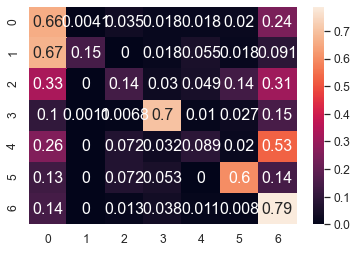

	training epoch=18 .. train_loss=1.118
	validation epoch=18 .. val_loss=1.328
	Accuracy = 50.7 % .. Percision = 55.900000000000006 % .. Recall = 44.6 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_18.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 19 .. loss = 1.136


  0%|                                                                                 | 1/1914 [00:01<39:41,  1.24s/it]

training @ epoch 19 .. loss = 1.185


  0%|                                                                                 | 2/1914 [00:02<39:20,  1.23s/it]

training @ epoch 19 .. loss = 1.514


  0%|▏                                                                                | 3/1914 [00:03<38:59,  1.22s/it]

training @ epoch 19 .. loss = 1.002


  0%|▏                                                                                | 4/1914 [00:04<39:01,  1.23s/it]

training @ epoch 19 .. loss = 0.901


  0%|▏                                                                                | 5/1914 [00:06<39:02,  1.23s/it]

training @ epoch 19 .. loss = 0.791


  0%|▎                                                                                | 6/1914 [00:07<39:17,  1.24s/it]

training @ epoch 19 .. loss = 1.727


  0%|▎                                                                                | 7/1914 [00:08<38:51,  1.22s/it]

training @ epoch 19 .. loss = 0.904


  0%|▎                                                                                | 8/1914 [00:09<38:41,  1.22s/it]

training @ epoch 19 .. loss = 1.077


  0%|▍                                                                                | 9/1914 [00:11<38:54,  1.23s/it]

training @ epoch 19 .. loss = 1.085


  1%|▍                                                                               | 10/1914 [00:12<38:51,  1.22s/it]

training @ epoch 19 .. loss = 0.791


  1%|▍                                                                               | 11/1914 [00:13<38:43,  1.22s/it]

training @ epoch 19 .. loss = 1.08


  1%|▌                                                                               | 12/1914 [00:14<38:14,  1.21s/it]

training @ epoch 19 .. loss = 0.822


  1%|▌                                                                               | 13/1914 [00:15<38:10,  1.20s/it]

training @ epoch 19 .. loss = 0.832


  1%|▌                                                                               | 14/1914 [00:17<38:36,  1.22s/it]

training @ epoch 19 .. loss = 1.411


  1%|▋                                                                               | 15/1914 [00:18<38:31,  1.22s/it]

training @ epoch 19 .. loss = 1.377


  1%|▋                                                                               | 16/1914 [00:19<38:27,  1.22s/it]

training @ epoch 19 .. loss = 1.242


  1%|▋                                                                               | 17/1914 [00:20<38:26,  1.22s/it]

training @ epoch 19 .. loss = 0.838


  1%|▊                                                                               | 18/1914 [00:21<38:29,  1.22s/it]

training @ epoch 19 .. loss = 1.392


  1%|▊                                                                               | 19/1914 [00:23<38:31,  1.22s/it]

training @ epoch 19 .. loss = 1.505


  1%|▊                                                                               | 20/1914 [00:24<38:26,  1.22s/it]

training @ epoch 19 .. loss = 1.001


  1%|▉                                                                               | 21/1914 [00:25<38:20,  1.22s/it]

training @ epoch 19 .. loss = 0.894


  1%|▉                                                                               | 22/1914 [00:26<38:23,  1.22s/it]

training @ epoch 19 .. loss = 1.18


  1%|▉                                                                               | 23/1914 [00:28<38:13,  1.21s/it]

training @ epoch 19 .. loss = 0.76


  1%|█                                                                               | 24/1914 [00:29<38:34,  1.22s/it]

training @ epoch 19 .. loss = 1.086


  1%|█                                                                               | 25/1914 [00:30<38:49,  1.23s/it]

training @ epoch 19 .. loss = 1.181


  1%|█                                                                               | 26/1914 [00:31<38:42,  1.23s/it]

training @ epoch 19 .. loss = 1.134


  1%|█▏                                                                              | 27/1914 [00:32<38:42,  1.23s/it]

training @ epoch 19 .. loss = 1.106


  1%|█▏                                                                              | 28/1914 [00:34<38:52,  1.24s/it]

training @ epoch 19 .. loss = 1.646


  2%|█▏                                                                              | 29/1914 [00:35<39:07,  1.25s/it]

training @ epoch 19 .. loss = 0.873


  2%|█▎                                                                              | 30/1914 [00:36<38:30,  1.23s/it]

training @ epoch 19 .. loss = 0.934


  2%|█▎                                                                              | 31/1914 [00:37<38:14,  1.22s/it]

training @ epoch 19 .. loss = 0.644


  2%|█▎                                                                              | 32/1914 [00:39<38:49,  1.24s/it]

training @ epoch 19 .. loss = 1.095


  2%|█▍                                                                              | 33/1914 [00:40<38:50,  1.24s/it]

training @ epoch 19 .. loss = 0.984


  2%|█▍                                                                              | 34/1914 [00:41<38:18,  1.22s/it]

training @ epoch 19 .. loss = 0.747


  2%|█▍                                                                              | 35/1914 [00:42<38:05,  1.22s/it]

training @ epoch 19 .. loss = 1.002


  2%|█▌                                                                              | 36/1914 [00:43<37:53,  1.21s/it]

training @ epoch 19 .. loss = 1.064


  2%|█▌                                                                              | 37/1914 [00:45<38:44,  1.24s/it]

training @ epoch 19 .. loss = 0.954


  2%|█▌                                                                              | 38/1914 [00:46<38:20,  1.23s/it]

training @ epoch 19 .. loss = 0.619


  2%|█▋                                                                              | 39/1914 [00:47<37:53,  1.21s/it]

training @ epoch 19 .. loss = 0.729


  2%|█▋                                                                              | 40/1914 [00:48<38:09,  1.22s/it]

training @ epoch 19 .. loss = 1.134


  2%|█▋                                                                              | 41/1914 [00:50<38:31,  1.23s/it]

training @ epoch 19 .. loss = 1.2


  2%|█▊                                                                              | 42/1914 [00:51<38:40,  1.24s/it]

training @ epoch 19 .. loss = 1.44


  2%|█▊                                                                              | 43/1914 [00:52<38:33,  1.24s/it]

training @ epoch 19 .. loss = 1.003


  2%|█▊                                                                              | 44/1914 [00:53<38:12,  1.23s/it]

training @ epoch 19 .. loss = 0.919


  2%|█▉                                                                              | 45/1914 [00:55<38:21,  1.23s/it]

training @ epoch 19 .. loss = 1.065


  2%|█▉                                                                              | 46/1914 [00:56<38:05,  1.22s/it]

training @ epoch 19 .. loss = 0.548


  2%|█▉                                                                              | 47/1914 [00:57<38:21,  1.23s/it]

training @ epoch 19 .. loss = 1.386


  3%|██                                                                              | 48/1914 [00:58<38:14,  1.23s/it]

training @ epoch 19 .. loss = 1.092


  3%|██                                                                              | 49/1914 [00:59<37:58,  1.22s/it]

training @ epoch 19 .. loss = 1.068


  3%|██                                                                              | 50/1914 [01:01<37:57,  1.22s/it]

training @ epoch 19 .. loss = 1.293


  3%|██▏                                                                             | 51/1914 [01:02<37:56,  1.22s/it]

training @ epoch 19 .. loss = 1.326


  3%|██▏                                                                             | 52/1914 [01:03<37:49,  1.22s/it]

training @ epoch 19 .. loss = 1.436


  3%|██▏                                                                             | 53/1914 [01:04<38:01,  1.23s/it]

training @ epoch 19 .. loss = 0.743


  3%|██▎                                                                             | 54/1914 [01:06<37:52,  1.22s/it]

training @ epoch 19 .. loss = 0.922


  3%|██▎                                                                             | 55/1914 [01:07<38:36,  1.25s/it]

training @ epoch 19 .. loss = 0.926


  3%|██▎                                                                             | 56/1914 [01:08<38:22,  1.24s/it]

training @ epoch 19 .. loss = 0.798


  3%|██▍                                                                             | 57/1914 [01:09<38:12,  1.23s/it]

training @ epoch 19 .. loss = 1.589


  3%|██▍                                                                             | 58/1914 [01:11<38:21,  1.24s/it]

training @ epoch 19 .. loss = 1.044


  3%|██▍                                                                             | 59/1914 [01:12<38:21,  1.24s/it]

training @ epoch 19 .. loss = 0.699


  3%|██▌                                                                             | 60/1914 [01:13<37:59,  1.23s/it]

training @ epoch 19 .. loss = 1.273


  3%|██▌                                                                             | 61/1914 [01:14<37:48,  1.22s/it]

training @ epoch 19 .. loss = 1.212


  3%|██▌                                                                             | 62/1914 [01:15<37:46,  1.22s/it]

training @ epoch 19 .. loss = 0.659


  3%|██▋                                                                             | 63/1914 [01:17<37:50,  1.23s/it]

training @ epoch 19 .. loss = 0.973


  3%|██▋                                                                             | 64/1914 [01:18<37:52,  1.23s/it]

training @ epoch 19 .. loss = 1.334


  3%|██▋                                                                             | 65/1914 [01:19<37:36,  1.22s/it]

training @ epoch 19 .. loss = 1.101


  3%|██▊                                                                             | 66/1914 [01:20<37:42,  1.22s/it]

training @ epoch 19 .. loss = 1.064


  4%|██▊                                                                             | 67/1914 [01:22<37:45,  1.23s/it]

training @ epoch 19 .. loss = 0.577


  4%|██▊                                                                             | 68/1914 [01:23<37:57,  1.23s/it]

training @ epoch 19 .. loss = 1.211


  4%|██▉                                                                             | 69/1914 [01:24<37:37,  1.22s/it]

training @ epoch 19 .. loss = 1.051


  4%|██▉                                                                             | 70/1914 [01:25<37:29,  1.22s/it]

training @ epoch 19 .. loss = 1.109


  4%|██▉                                                                             | 71/1914 [01:26<37:36,  1.22s/it]

training @ epoch 19 .. loss = 1.0


  4%|███                                                                             | 72/1914 [01:28<37:22,  1.22s/it]

training @ epoch 19 .. loss = 0.996


  4%|███                                                                             | 73/1914 [01:29<37:46,  1.23s/it]

training @ epoch 19 .. loss = 1.384


  4%|███                                                                             | 74/1914 [01:30<37:29,  1.22s/it]

training @ epoch 19 .. loss = 0.971


  4%|███▏                                                                            | 75/1914 [01:31<37:06,  1.21s/it]

training @ epoch 19 .. loss = 0.819


  4%|███▏                                                                            | 76/1914 [01:33<37:45,  1.23s/it]

training @ epoch 19 .. loss = 1.486


  4%|███▏                                                                            | 77/1914 [01:34<37:43,  1.23s/it]

training @ epoch 19 .. loss = 0.914


  4%|███▎                                                                            | 78/1914 [01:35<37:14,  1.22s/it]

training @ epoch 19 .. loss = 1.117


  4%|███▎                                                                            | 79/1914 [01:36<37:11,  1.22s/it]

training @ epoch 19 .. loss = 1.025


  4%|███▎                                                                            | 80/1914 [01:37<36:56,  1.21s/it]

training @ epoch 19 .. loss = 1.04


  4%|███▍                                                                            | 81/1914 [01:39<37:36,  1.23s/it]

training @ epoch 19 .. loss = 0.965


  4%|███▍                                                                            | 82/1914 [01:40<37:34,  1.23s/it]

training @ epoch 19 .. loss = 1.416


  4%|███▍                                                                            | 83/1914 [01:41<36:59,  1.21s/it]

training @ epoch 19 .. loss = 0.978


  4%|███▌                                                                            | 84/1914 [01:42<37:00,  1.21s/it]

training @ epoch 19 .. loss = 1.284


  4%|███▌                                                                            | 85/1914 [01:44<37:15,  1.22s/it]

training @ epoch 19 .. loss = 1.053


  4%|███▌                                                                            | 86/1914 [01:45<37:19,  1.23s/it]

training @ epoch 19 .. loss = 0.803


  5%|███▋                                                                            | 87/1914 [01:46<37:16,  1.22s/it]

training @ epoch 19 .. loss = 0.992


  5%|███▋                                                                            | 88/1914 [01:47<36:46,  1.21s/it]

training @ epoch 19 .. loss = 1.291


  5%|███▋                                                                            | 89/1914 [01:48<36:53,  1.21s/it]

training @ epoch 19 .. loss = 1.558


  5%|███▊                                                                            | 90/1914 [01:50<36:46,  1.21s/it]

training @ epoch 19 .. loss = 1.528


  5%|███▊                                                                            | 91/1914 [01:51<37:13,  1.23s/it]

training @ epoch 19 .. loss = 0.857


  5%|███▊                                                                            | 92/1914 [01:52<37:12,  1.23s/it]

training @ epoch 19 .. loss = 1.406


  5%|███▉                                                                            | 93/1914 [01:53<37:08,  1.22s/it]

training @ epoch 19 .. loss = 1.087


  5%|███▉                                                                            | 94/1914 [01:55<37:07,  1.22s/it]

training @ epoch 19 .. loss = 1.152


  5%|███▉                                                                            | 95/1914 [01:56<37:05,  1.22s/it]

training @ epoch 19 .. loss = 0.642


  5%|████                                                                            | 96/1914 [01:57<37:20,  1.23s/it]

training @ epoch 19 .. loss = 0.885


  5%|████                                                                            | 97/1914 [01:58<37:02,  1.22s/it]

training @ epoch 19 .. loss = 1.135


  5%|████                                                                            | 98/1914 [01:59<36:55,  1.22s/it]

training @ epoch 19 .. loss = 1.59


  5%|████▏                                                                           | 99/1914 [02:01<37:15,  1.23s/it]

training @ epoch 19 .. loss = 1.344


  5%|████▏                                                                          | 100/1914 [02:02<37:10,  1.23s/it]

training @ epoch 19 .. loss = 1.32


  5%|████▏                                                                          | 101/1914 [02:03<36:54,  1.22s/it]

training @ epoch 19 .. loss = 1.317


  5%|████▏                                                                          | 102/1914 [02:04<36:47,  1.22s/it]

training @ epoch 19 .. loss = 0.893


  5%|████▎                                                                          | 103/1914 [02:06<36:42,  1.22s/it]

training @ epoch 19 .. loss = 0.927


  5%|████▎                                                                          | 104/1914 [02:07<37:01,  1.23s/it]

training @ epoch 19 .. loss = 1.018


  5%|████▎                                                                          | 105/1914 [02:08<36:45,  1.22s/it]

training @ epoch 19 .. loss = 1.195


  6%|████▍                                                                          | 106/1914 [02:09<36:52,  1.22s/it]

training @ epoch 19 .. loss = 1.145


  6%|████▍                                                                          | 107/1914 [02:10<36:50,  1.22s/it]

training @ epoch 19 .. loss = 0.922


  6%|████▍                                                                          | 108/1914 [02:12<36:49,  1.22s/it]

training @ epoch 19 .. loss = 0.85


  6%|████▍                                                                          | 109/1914 [02:13<37:03,  1.23s/it]

training @ epoch 19 .. loss = 0.893


  6%|████▌                                                                          | 110/1914 [02:14<37:19,  1.24s/it]

training @ epoch 19 .. loss = 0.551


  6%|████▌                                                                          | 111/1914 [02:15<37:13,  1.24s/it]

training @ epoch 19 .. loss = 1.627


  6%|████▌                                                                          | 112/1914 [02:17<37:16,  1.24s/it]

training @ epoch 19 .. loss = 1.108


  6%|████▋                                                                          | 113/1914 [02:18<37:05,  1.24s/it]

training @ epoch 19 .. loss = 1.263


  6%|████▋                                                                          | 114/1914 [02:19<36:47,  1.23s/it]

training @ epoch 19 .. loss = 1.272


  6%|████▋                                                                          | 115/1914 [02:20<36:48,  1.23s/it]

training @ epoch 19 .. loss = 0.855


  6%|████▊                                                                          | 116/1914 [02:22<36:45,  1.23s/it]

training @ epoch 19 .. loss = 1.295


  6%|████▊                                                                          | 117/1914 [02:23<36:41,  1.23s/it]

training @ epoch 19 .. loss = 1.205


  6%|████▊                                                                          | 118/1914 [02:24<36:22,  1.22s/it]

training @ epoch 19 .. loss = 1.058


  6%|████▉                                                                          | 119/1914 [02:25<36:03,  1.21s/it]

training @ epoch 19 .. loss = 0.796


  6%|████▉                                                                          | 120/1914 [02:26<36:21,  1.22s/it]

training @ epoch 19 .. loss = 0.673


  6%|████▉                                                                          | 121/1914 [02:28<36:45,  1.23s/it]

training @ epoch 19 .. loss = 1.195


  6%|█████                                                                          | 122/1914 [02:29<37:12,  1.25s/it]

training @ epoch 19 .. loss = 0.521


  6%|█████                                                                          | 123/1914 [02:30<36:58,  1.24s/it]

training @ epoch 19 .. loss = 0.91


  6%|█████                                                                          | 124/1914 [02:31<36:43,  1.23s/it]

training @ epoch 19 .. loss = 0.702


  7%|█████▏                                                                         | 125/1914 [02:33<36:42,  1.23s/it]

training @ epoch 19 .. loss = 1.238


  7%|█████▏                                                                         | 126/1914 [02:34<36:31,  1.23s/it]

training @ epoch 19 .. loss = 1.25


  7%|█████▏                                                                         | 127/1914 [02:35<36:12,  1.22s/it]

training @ epoch 19 .. loss = 1.674


  7%|█████▎                                                                         | 128/1914 [02:36<36:31,  1.23s/it]

training @ epoch 19 .. loss = 1.423


  7%|█████▎                                                                         | 129/1914 [02:38<36:22,  1.22s/it]

training @ epoch 19 .. loss = 1.134


  7%|█████▎                                                                         | 130/1914 [02:39<36:34,  1.23s/it]

training @ epoch 19 .. loss = 1.223


  7%|█████▍                                                                         | 131/1914 [02:40<36:41,  1.23s/it]

training @ epoch 19 .. loss = 0.965


  7%|█████▍                                                                         | 132/1914 [02:41<36:34,  1.23s/it]

training @ epoch 19 .. loss = 1.017


  7%|█████▍                                                                         | 133/1914 [02:42<36:38,  1.23s/it]

training @ epoch 19 .. loss = 0.889


  7%|█████▌                                                                         | 134/1914 [02:44<36:35,  1.23s/it]

training @ epoch 19 .. loss = 1.158


  7%|█████▌                                                                         | 135/1914 [02:45<36:34,  1.23s/it]

training @ epoch 19 .. loss = 1.114


  7%|█████▌                                                                         | 136/1914 [02:46<36:26,  1.23s/it]

training @ epoch 19 .. loss = 0.807


  7%|█████▋                                                                         | 137/1914 [02:47<36:10,  1.22s/it]

training @ epoch 19 .. loss = 1.013


  7%|█████▋                                                                         | 138/1914 [02:49<36:21,  1.23s/it]

training @ epoch 19 .. loss = 1.414


  7%|█████▋                                                                         | 139/1914 [02:50<36:22,  1.23s/it]

training @ epoch 19 .. loss = 1.375


  7%|█████▊                                                                         | 140/1914 [02:51<36:28,  1.23s/it]

training @ epoch 19 .. loss = 1.415


  7%|█████▊                                                                         | 141/1914 [02:52<36:19,  1.23s/it]

training @ epoch 19 .. loss = 0.829


  7%|█████▊                                                                         | 142/1914 [02:53<35:58,  1.22s/it]

training @ epoch 19 .. loss = 0.683


  7%|█████▉                                                                         | 143/1914 [02:55<36:04,  1.22s/it]

training @ epoch 19 .. loss = 1.093


  8%|█████▉                                                                         | 144/1914 [02:56<36:19,  1.23s/it]

training @ epoch 19 .. loss = 1.313


  8%|█████▉                                                                         | 145/1914 [02:57<36:08,  1.23s/it]

training @ epoch 19 .. loss = 0.948


  8%|██████                                                                         | 146/1914 [02:59<37:04,  1.26s/it]

training @ epoch 19 .. loss = 1.101


  8%|██████                                                                         | 147/1914 [03:00<36:27,  1.24s/it]

training @ epoch 19 .. loss = 0.755


  8%|██████                                                                         | 148/1914 [03:01<36:55,  1.25s/it]

training @ epoch 19 .. loss = 0.982


  8%|██████▏                                                                        | 149/1914 [03:02<36:24,  1.24s/it]

training @ epoch 19 .. loss = 1.09


  8%|██████▏                                                                        | 150/1914 [03:03<35:59,  1.22s/it]

training @ epoch 19 .. loss = 1.408


  8%|██████▏                                                                        | 151/1914 [03:05<36:13,  1.23s/it]

training @ epoch 19 .. loss = 0.743


  8%|██████▎                                                                        | 152/1914 [03:06<36:39,  1.25s/it]

training @ epoch 19 .. loss = 1.165


  8%|██████▎                                                                        | 153/1914 [03:07<36:02,  1.23s/it]

training @ epoch 19 .. loss = 1.425


  8%|██████▎                                                                        | 154/1914 [03:08<35:53,  1.22s/it]

training @ epoch 19 .. loss = 0.738


  8%|██████▍                                                                        | 155/1914 [03:10<35:51,  1.22s/it]

training @ epoch 19 .. loss = 1.299


  8%|██████▍                                                                        | 156/1914 [03:11<36:14,  1.24s/it]

training @ epoch 19 .. loss = 1.309


  8%|██████▍                                                                        | 157/1914 [03:12<35:55,  1.23s/it]

training @ epoch 19 .. loss = 1.284


  8%|██████▌                                                                        | 158/1914 [03:13<35:41,  1.22s/it]

training @ epoch 19 .. loss = 0.796


  8%|██████▌                                                                        | 159/1914 [03:14<35:46,  1.22s/it]

training @ epoch 19 .. loss = 0.952


  8%|██████▌                                                                        | 160/1914 [03:16<35:34,  1.22s/it]

training @ epoch 19 .. loss = 1.153


  8%|██████▋                                                                        | 161/1914 [03:17<36:16,  1.24s/it]

training @ epoch 19 .. loss = 1.159


  8%|██████▋                                                                        | 162/1914 [03:18<36:04,  1.24s/it]

training @ epoch 19 .. loss = 1.056


  9%|██████▋                                                                        | 163/1914 [03:19<35:39,  1.22s/it]

training @ epoch 19 .. loss = 1.085


  9%|██████▊                                                                        | 164/1914 [03:21<35:49,  1.23s/it]

training @ epoch 19 .. loss = 1.068


  9%|██████▊                                                                        | 165/1914 [03:22<35:48,  1.23s/it]

training @ epoch 19 .. loss = 0.883


  9%|██████▊                                                                        | 166/1914 [03:23<35:27,  1.22s/it]

training @ epoch 19 .. loss = 0.606


  9%|██████▉                                                                        | 167/1914 [03:24<36:49,  1.26s/it]

training @ epoch 19 .. loss = 1.375


  9%|██████▉                                                                        | 168/1914 [03:26<37:50,  1.30s/it]

training @ epoch 19 .. loss = 1.17


  9%|██████▉                                                                        | 169/1914 [03:27<38:30,  1.32s/it]

training @ epoch 19 .. loss = 1.042


  9%|███████                                                                        | 170/1914 [03:28<37:31,  1.29s/it]

training @ epoch 19 .. loss = 1.286


  9%|███████                                                                        | 171/1914 [03:30<36:49,  1.27s/it]

training @ epoch 19 .. loss = 1.183


  9%|███████                                                                        | 172/1914 [03:31<36:55,  1.27s/it]

training @ epoch 19 .. loss = 0.905


  9%|███████▏                                                                       | 173/1914 [03:32<36:18,  1.25s/it]

training @ epoch 19 .. loss = 1.353


  9%|███████▏                                                                       | 174/1914 [03:33<35:40,  1.23s/it]

training @ epoch 19 .. loss = 0.969


  9%|███████▏                                                                       | 175/1914 [03:34<35:40,  1.23s/it]

training @ epoch 19 .. loss = 0.991


  9%|███████▎                                                                       | 176/1914 [03:36<35:03,  1.21s/it]

training @ epoch 19 .. loss = 1.019


  9%|███████▎                                                                       | 177/1914 [03:37<35:16,  1.22s/it]

training @ epoch 19 .. loss = 1.064


  9%|███████▎                                                                       | 178/1914 [03:38<35:12,  1.22s/it]

training @ epoch 19 .. loss = 0.966


  9%|███████▍                                                                       | 179/1914 [03:39<35:10,  1.22s/it]

training @ epoch 19 .. loss = 0.688


  9%|███████▍                                                                       | 180/1914 [03:41<35:27,  1.23s/it]

training @ epoch 19 .. loss = 0.758


  9%|███████▍                                                                       | 181/1914 [03:42<35:22,  1.22s/it]

training @ epoch 19 .. loss = 1.181


 10%|███████▌                                                                       | 182/1914 [03:43<35:45,  1.24s/it]

training @ epoch 19 .. loss = 1.31


 10%|███████▌                                                                       | 183/1914 [03:44<35:10,  1.22s/it]

training @ epoch 19 .. loss = 1.241


 10%|███████▌                                                                       | 184/1914 [03:45<34:53,  1.21s/it]

training @ epoch 19 .. loss = 1.324


 10%|███████▋                                                                       | 185/1914 [03:47<35:04,  1.22s/it]

training @ epoch 19 .. loss = 0.496


 10%|███████▋                                                                       | 186/1914 [03:48<35:41,  1.24s/it]

training @ epoch 19 .. loss = 1.356


 10%|███████▋                                                                       | 187/1914 [03:49<35:21,  1.23s/it]

training @ epoch 19 .. loss = 0.783


 10%|███████▊                                                                       | 188/1914 [03:50<35:18,  1.23s/it]

training @ epoch 19 .. loss = 0.671


 10%|███████▊                                                                       | 189/1914 [03:52<34:57,  1.22s/it]

training @ epoch 19 .. loss = 1.087


 10%|███████▊                                                                       | 190/1914 [03:53<35:15,  1.23s/it]

training @ epoch 19 .. loss = 1.107


 10%|███████▉                                                                       | 191/1914 [03:54<35:14,  1.23s/it]

training @ epoch 19 .. loss = 1.233


 10%|███████▉                                                                       | 192/1914 [03:55<35:11,  1.23s/it]

training @ epoch 19 .. loss = 1.211


 10%|███████▉                                                                       | 193/1914 [03:57<35:29,  1.24s/it]

training @ epoch 19 .. loss = 1.153


 10%|████████                                                                       | 194/1914 [03:58<35:19,  1.23s/it]

training @ epoch 19 .. loss = 1.311


 10%|████████                                                                       | 195/1914 [03:59<35:39,  1.24s/it]

training @ epoch 19 .. loss = 1.036


 10%|████████                                                                       | 196/1914 [04:00<35:21,  1.23s/it]

training @ epoch 19 .. loss = 1.069


 10%|████████▏                                                                      | 197/1914 [04:01<35:01,  1.22s/it]

training @ epoch 19 .. loss = 1.043


 10%|████████▏                                                                      | 198/1914 [04:03<34:58,  1.22s/it]

training @ epoch 19 .. loss = 1.337


 10%|████████▏                                                                      | 199/1914 [04:04<35:07,  1.23s/it]

training @ epoch 19 .. loss = 1.499


 10%|████████▎                                                                      | 200/1914 [04:05<35:10,  1.23s/it]

training @ epoch 19 .. loss = 1.283


 11%|████████▎                                                                      | 201/1914 [04:06<34:45,  1.22s/it]

training @ epoch 19 .. loss = 1.091


 11%|████████▎                                                                      | 202/1914 [04:08<34:35,  1.21s/it]

training @ epoch 19 .. loss = 1.203


 11%|████████▍                                                                      | 203/1914 [04:09<35:15,  1.24s/it]

training @ epoch 19 .. loss = 1.224


 11%|████████▍                                                                      | 204/1914 [04:10<35:02,  1.23s/it]

training @ epoch 19 .. loss = 0.93


 11%|████████▍                                                                      | 205/1914 [04:11<34:41,  1.22s/it]

training @ epoch 19 .. loss = 0.949


 11%|████████▌                                                                      | 206/1914 [04:12<34:46,  1.22s/it]

training @ epoch 19 .. loss = 0.924


 11%|████████▌                                                                      | 207/1914 [04:14<34:35,  1.22s/it]

training @ epoch 19 .. loss = 1.436


 11%|████████▌                                                                      | 208/1914 [04:15<34:49,  1.22s/it]

training @ epoch 19 .. loss = 1.267


 11%|████████▋                                                                      | 209/1914 [04:16<34:41,  1.22s/it]

training @ epoch 19 .. loss = 1.106


 11%|████████▋                                                                      | 210/1914 [04:17<34:23,  1.21s/it]

training @ epoch 19 .. loss = 1.3


 11%|████████▋                                                                      | 211/1914 [04:19<34:26,  1.21s/it]

training @ epoch 19 .. loss = 1.24


 11%|████████▊                                                                      | 212/1914 [04:20<34:34,  1.22s/it]

training @ epoch 19 .. loss = 1.299


 11%|████████▊                                                                      | 213/1914 [04:21<34:46,  1.23s/it]

training @ epoch 19 .. loss = 0.999


 11%|████████▊                                                                      | 214/1914 [04:22<34:40,  1.22s/it]

training @ epoch 19 .. loss = 0.909


 11%|████████▊                                                                      | 215/1914 [04:23<34:34,  1.22s/it]

training @ epoch 19 .. loss = 1.494


 11%|████████▉                                                                      | 216/1914 [04:25<34:49,  1.23s/it]

training @ epoch 19 .. loss = 0.824


 11%|████████▉                                                                      | 217/1914 [04:26<34:54,  1.23s/it]

training @ epoch 19 .. loss = 1.283


 11%|████████▉                                                                      | 218/1914 [04:27<34:26,  1.22s/it]

training @ epoch 19 .. loss = 1.019


 11%|█████████                                                                      | 219/1914 [04:28<34:31,  1.22s/it]

training @ epoch 19 .. loss = 0.864


 11%|█████████                                                                      | 220/1914 [04:30<34:13,  1.21s/it]

training @ epoch 19 .. loss = 1.207


 12%|█████████                                                                      | 221/1914 [04:31<34:34,  1.23s/it]

training @ epoch 19 .. loss = 1.261


 12%|█████████▏                                                                     | 222/1914 [04:32<34:25,  1.22s/it]

training @ epoch 19 .. loss = 1.104


 12%|█████████▏                                                                     | 223/1914 [04:33<34:05,  1.21s/it]

training @ epoch 19 .. loss = 1.238


 12%|█████████▏                                                                     | 224/1914 [04:34<33:59,  1.21s/it]

training @ epoch 19 .. loss = 1.031


 12%|█████████▎                                                                     | 225/1914 [04:36<34:05,  1.21s/it]

training @ epoch 19 .. loss = 1.003


 12%|█████████▎                                                                     | 226/1914 [04:37<34:29,  1.23s/it]

training @ epoch 19 .. loss = 1.28


 12%|█████████▎                                                                     | 227/1914 [04:38<34:21,  1.22s/it]

training @ epoch 19 .. loss = 0.951


 12%|█████████▍                                                                     | 228/1914 [04:39<34:10,  1.22s/it]

training @ epoch 19 .. loss = 1.263


 12%|█████████▍                                                                     | 229/1914 [04:41<34:27,  1.23s/it]

training @ epoch 19 .. loss = 1.564


 12%|█████████▍                                                                     | 230/1914 [04:42<34:34,  1.23s/it]

training @ epoch 19 .. loss = 1.083


 12%|█████████▌                                                                     | 231/1914 [04:43<34:33,  1.23s/it]

training @ epoch 19 .. loss = 1.163


 12%|█████████▌                                                                     | 232/1914 [04:44<34:05,  1.22s/it]

training @ epoch 19 .. loss = 1.608


 12%|█████████▌                                                                     | 233/1914 [04:45<34:00,  1.21s/it]

training @ epoch 19 .. loss = 0.837


 12%|█████████▋                                                                     | 234/1914 [04:47<34:15,  1.22s/it]

training @ epoch 19 .. loss = 0.862


 12%|█████████▋                                                                     | 235/1914 [04:48<34:23,  1.23s/it]

training @ epoch 19 .. loss = 1.06


 12%|█████████▋                                                                     | 236/1914 [04:49<34:19,  1.23s/it]

training @ epoch 19 .. loss = 0.953


 12%|█████████▊                                                                     | 237/1914 [04:50<34:21,  1.23s/it]

training @ epoch 19 .. loss = 1.2


 12%|█████████▊                                                                     | 238/1914 [04:52<34:09,  1.22s/it]

training @ epoch 19 .. loss = 1.2


 12%|█████████▊                                                                     | 239/1914 [04:53<34:28,  1.24s/it]

training @ epoch 19 .. loss = 1.004


 13%|█████████▉                                                                     | 240/1914 [04:54<34:21,  1.23s/it]

training @ epoch 19 .. loss = 1.105


 13%|█████████▉                                                                     | 241/1914 [04:55<33:49,  1.21s/it]

training @ epoch 19 .. loss = 1.116


 13%|█████████▉                                                                     | 242/1914 [04:56<33:53,  1.22s/it]

training @ epoch 19 .. loss = 1.315


 13%|██████████                                                                     | 243/1914 [04:58<34:00,  1.22s/it]

training @ epoch 19 .. loss = 0.961


 13%|██████████                                                                     | 244/1914 [04:59<34:19,  1.23s/it]

training @ epoch 19 .. loss = 0.868


 13%|██████████                                                                     | 245/1914 [05:00<34:13,  1.23s/it]

training @ epoch 19 .. loss = 1.051


 13%|██████████▏                                                                    | 246/1914 [05:01<33:43,  1.21s/it]

training @ epoch 19 .. loss = 0.693


 13%|██████████▏                                                                    | 247/1914 [05:03<34:01,  1.22s/it]

training @ epoch 19 .. loss = 1.024


 13%|██████████▏                                                                    | 248/1914 [05:04<34:08,  1.23s/it]

training @ epoch 19 .. loss = 0.746


 13%|██████████▎                                                                    | 249/1914 [05:05<34:29,  1.24s/it]

training @ epoch 19 .. loss = 1.269


 13%|██████████▎                                                                    | 250/1914 [05:06<34:02,  1.23s/it]

training @ epoch 19 .. loss = 1.091


 13%|██████████▎                                                                    | 251/1914 [05:07<33:54,  1.22s/it]

training @ epoch 19 .. loss = 1.173


 13%|██████████▍                                                                    | 252/1914 [05:09<34:03,  1.23s/it]

training @ epoch 19 .. loss = 0.835


 13%|██████████▍                                                                    | 253/1914 [05:10<33:52,  1.22s/it]

training @ epoch 19 .. loss = 0.769


 13%|██████████▍                                                                    | 254/1914 [05:11<33:25,  1.21s/it]

training @ epoch 19 .. loss = 1.207


 13%|██████████▌                                                                    | 255/1914 [05:12<33:45,  1.22s/it]

training @ epoch 19 .. loss = 1.626


 13%|██████████▌                                                                    | 256/1914 [05:14<33:33,  1.21s/it]

training @ epoch 19 .. loss = 1.461


 13%|██████████▌                                                                    | 257/1914 [05:15<33:56,  1.23s/it]

training @ epoch 19 .. loss = 1.755


 13%|██████████▋                                                                    | 258/1914 [05:16<33:56,  1.23s/it]

training @ epoch 19 .. loss = 0.985


 14%|██████████▋                                                                    | 259/1914 [05:17<33:46,  1.22s/it]

training @ epoch 19 .. loss = 1.086


 14%|██████████▋                                                                    | 260/1914 [05:18<33:44,  1.22s/it]

training @ epoch 19 .. loss = 1.221


 14%|██████████▊                                                                    | 261/1914 [05:20<33:20,  1.21s/it]

training @ epoch 19 .. loss = 1.051


 14%|██████████▊                                                                    | 262/1914 [05:21<33:56,  1.23s/it]

training @ epoch 19 .. loss = 1.01


 14%|██████████▊                                                                    | 263/1914 [05:22<33:28,  1.22s/it]

training @ epoch 19 .. loss = 1.14


 14%|██████████▉                                                                    | 264/1914 [05:23<33:19,  1.21s/it]

training @ epoch 19 .. loss = 1.006


 14%|██████████▉                                                                    | 265/1914 [05:25<33:34,  1.22s/it]

training @ epoch 19 .. loss = 0.848


 14%|██████████▉                                                                    | 266/1914 [05:26<33:18,  1.21s/it]

training @ epoch 19 .. loss = 1.308


 14%|███████████                                                                    | 267/1914 [05:27<33:35,  1.22s/it]

training @ epoch 19 .. loss = 1.018


 14%|███████████                                                                    | 268/1914 [05:28<33:18,  1.21s/it]

training @ epoch 19 .. loss = 1.039


 14%|███████████                                                                    | 269/1914 [05:29<33:17,  1.21s/it]

training @ epoch 19 .. loss = 0.962


 14%|███████████▏                                                                   | 270/1914 [05:31<33:34,  1.23s/it]

training @ epoch 19 .. loss = 1.187


 14%|███████████▏                                                                   | 271/1914 [05:32<33:37,  1.23s/it]

training @ epoch 19 .. loss = 0.783


 14%|███████████▏                                                                   | 272/1914 [05:33<33:32,  1.23s/it]

training @ epoch 19 .. loss = 1.139


 14%|███████████▎                                                                   | 273/1914 [05:34<33:49,  1.24s/it]

training @ epoch 19 .. loss = 0.782


 14%|███████████▎                                                                   | 274/1914 [05:36<33:22,  1.22s/it]

training @ epoch 19 .. loss = 0.94


 14%|███████████▎                                                                   | 275/1914 [05:37<33:26,  1.22s/it]

training @ epoch 19 .. loss = 1.042


 14%|███████████▍                                                                   | 276/1914 [05:38<33:29,  1.23s/it]

training @ epoch 19 .. loss = 0.828


 14%|███████████▍                                                                   | 277/1914 [05:39<33:09,  1.22s/it]

training @ epoch 19 .. loss = 1.043


 15%|███████████▍                                                                   | 278/1914 [05:40<33:11,  1.22s/it]

training @ epoch 19 .. loss = 0.906


 15%|███████████▌                                                                   | 279/1914 [05:42<33:02,  1.21s/it]

training @ epoch 19 .. loss = 0.976


 15%|███████████▌                                                                   | 280/1914 [05:43<33:33,  1.23s/it]

training @ epoch 19 .. loss = 1.05


 15%|███████████▌                                                                   | 281/1914 [05:44<33:21,  1.23s/it]

training @ epoch 19 .. loss = 1.112


 15%|███████████▋                                                                   | 282/1914 [05:45<33:19,  1.23s/it]

training @ epoch 19 .. loss = 1.557


 15%|███████████▋                                                                   | 283/1914 [05:47<33:11,  1.22s/it]

training @ epoch 19 .. loss = 1.219


 15%|███████████▋                                                                   | 284/1914 [05:48<33:06,  1.22s/it]

training @ epoch 19 .. loss = 0.998


 15%|███████████▊                                                                   | 285/1914 [05:49<33:30,  1.23s/it]

training @ epoch 19 .. loss = 0.581


 15%|███████████▊                                                                   | 286/1914 [05:50<33:12,  1.22s/it]

training @ epoch 19 .. loss = 0.859


 15%|███████████▊                                                                   | 287/1914 [05:51<32:51,  1.21s/it]

training @ epoch 19 .. loss = 1.401


 15%|███████████▉                                                                   | 288/1914 [05:53<33:05,  1.22s/it]

training @ epoch 19 .. loss = 1.014


 15%|███████████▉                                                                   | 289/1914 [05:54<33:20,  1.23s/it]

training @ epoch 19 .. loss = 1.215


 15%|███████████▉                                                                   | 290/1914 [05:55<33:05,  1.22s/it]

training @ epoch 19 .. loss = 1.113


 15%|████████████                                                                   | 291/1914 [05:56<33:11,  1.23s/it]

training @ epoch 19 .. loss = 1.143


 15%|████████████                                                                   | 292/1914 [05:58<33:09,  1.23s/it]

training @ epoch 19 .. loss = 1.249


 15%|████████████                                                                   | 293/1914 [05:59<33:26,  1.24s/it]

training @ epoch 19 .. loss = 1.029


 15%|████████████▏                                                                  | 294/1914 [06:00<33:12,  1.23s/it]

training @ epoch 19 .. loss = 1.563


 15%|████████████▏                                                                  | 295/1914 [06:01<32:52,  1.22s/it]

training @ epoch 19 .. loss = 1.526


 15%|████████████▏                                                                  | 296/1914 [06:03<33:13,  1.23s/it]

training @ epoch 19 .. loss = 1.516


 16%|████████████▎                                                                  | 297/1914 [06:04<33:03,  1.23s/it]

training @ epoch 19 .. loss = 1.092


 16%|████████████▎                                                                  | 298/1914 [06:05<33:14,  1.23s/it]

training @ epoch 19 .. loss = 0.894


 16%|████████████▎                                                                  | 299/1914 [06:06<33:21,  1.24s/it]

training @ epoch 19 .. loss = 1.079


 16%|████████████▍                                                                  | 300/1914 [06:08<35:00,  1.30s/it]

training @ epoch 19 .. loss = 1.141


 16%|████████████▍                                                                  | 301/1914 [06:09<35:50,  1.33s/it]

training @ epoch 19 .. loss = 1.408


 16%|████████████▍                                                                  | 302/1914 [06:10<35:24,  1.32s/it]

training @ epoch 19 .. loss = 0.643


 16%|████████████▌                                                                  | 303/1914 [06:12<34:52,  1.30s/it]

training @ epoch 19 .. loss = 1.005


 16%|████████████▌                                                                  | 304/1914 [06:13<35:09,  1.31s/it]

training @ epoch 19 .. loss = 1.212


 16%|████████████▌                                                                  | 305/1914 [06:14<34:25,  1.28s/it]

training @ epoch 19 .. loss = 1.499


 16%|████████████▋                                                                  | 306/1914 [06:15<33:39,  1.26s/it]

training @ epoch 19 .. loss = 1.07


 16%|████████████▋                                                                  | 307/1914 [06:17<33:35,  1.25s/it]

training @ epoch 19 .. loss = 1.45


 16%|████████████▋                                                                  | 308/1914 [06:18<33:34,  1.25s/it]

training @ epoch 19 .. loss = 1.109


 16%|████████████▊                                                                  | 309/1914 [06:19<33:07,  1.24s/it]

training @ epoch 19 .. loss = 0.944


 16%|████████████▊                                                                  | 310/1914 [06:20<33:23,  1.25s/it]

training @ epoch 19 .. loss = 1.154


 16%|████████████▊                                                                  | 311/1914 [06:22<33:48,  1.27s/it]

training @ epoch 19 .. loss = 1.065


 16%|████████████▉                                                                  | 312/1914 [06:23<33:45,  1.26s/it]

training @ epoch 19 .. loss = 1.18


 16%|████████████▉                                                                  | 313/1914 [06:24<33:19,  1.25s/it]

training @ epoch 19 .. loss = 1.38


 16%|████████████▉                                                                  | 314/1914 [06:25<33:05,  1.24s/it]

training @ epoch 19 .. loss = 0.673


 16%|█████████████                                                                  | 315/1914 [06:27<33:00,  1.24s/it]

training @ epoch 19 .. loss = 1.74


 17%|█████████████                                                                  | 316/1914 [06:28<32:51,  1.23s/it]

training @ epoch 19 .. loss = 0.664


 17%|█████████████                                                                  | 317/1914 [06:29<33:30,  1.26s/it]

training @ epoch 19 .. loss = 0.753


 17%|█████████████▏                                                                 | 318/1914 [06:30<33:12,  1.25s/it]

training @ epoch 19 .. loss = 1.236


 17%|█████████████▏                                                                 | 319/1914 [06:32<32:49,  1.24s/it]

training @ epoch 19 .. loss = 0.791


 17%|█████████████▏                                                                 | 320/1914 [06:33<32:57,  1.24s/it]

training @ epoch 19 .. loss = 1.399


 17%|█████████████▏                                                                 | 321/1914 [06:34<32:46,  1.23s/it]

training @ epoch 19 .. loss = 0.54


 17%|█████████████▎                                                                 | 322/1914 [06:35<32:35,  1.23s/it]

training @ epoch 19 .. loss = 1.24


 17%|█████████████▎                                                                 | 323/1914 [06:36<32:35,  1.23s/it]

training @ epoch 19 .. loss = 0.734


 17%|█████████████▎                                                                 | 324/1914 [06:38<32:32,  1.23s/it]

training @ epoch 19 .. loss = 1.147


 17%|█████████████▍                                                                 | 325/1914 [06:39<32:48,  1.24s/it]

training @ epoch 19 .. loss = 0.976


 17%|█████████████▍                                                                 | 326/1914 [06:40<32:29,  1.23s/it]

training @ epoch 19 .. loss = 1.139


 17%|█████████████▍                                                                 | 327/1914 [06:41<32:19,  1.22s/it]

training @ epoch 19 .. loss = 1.654


 17%|█████████████▌                                                                 | 328/1914 [06:43<32:28,  1.23s/it]

training @ epoch 19 .. loss = 1.105


 17%|█████████████▌                                                                 | 329/1914 [06:44<32:31,  1.23s/it]

training @ epoch 19 .. loss = 1.091


 17%|█████████████▌                                                                 | 330/1914 [06:45<32:12,  1.22s/it]

training @ epoch 19 .. loss = 0.831


 17%|█████████████▋                                                                 | 331/1914 [06:46<32:21,  1.23s/it]

training @ epoch 19 .. loss = 1.178


 17%|█████████████▋                                                                 | 332/1914 [06:47<32:04,  1.22s/it]

training @ epoch 19 .. loss = 0.848


 17%|█████████████▋                                                                 | 333/1914 [06:49<32:20,  1.23s/it]

training @ epoch 19 .. loss = 0.961


 17%|█████████████▊                                                                 | 334/1914 [06:50<32:20,  1.23s/it]

training @ epoch 19 .. loss = 0.734


 18%|█████████████▊                                                                 | 335/1914 [06:51<31:57,  1.21s/it]

training @ epoch 19 .. loss = 0.786


 18%|█████████████▊                                                                 | 336/1914 [06:52<32:00,  1.22s/it]

training @ epoch 19 .. loss = 1.896


 18%|█████████████▉                                                                 | 337/1914 [06:54<31:52,  1.21s/it]

training @ epoch 19 .. loss = 0.887


 18%|█████████████▉                                                                 | 338/1914 [06:55<32:24,  1.23s/it]

training @ epoch 19 .. loss = 1.023


 18%|█████████████▉                                                                 | 339/1914 [06:56<32:12,  1.23s/it]

training @ epoch 19 .. loss = 0.973


 18%|██████████████                                                                 | 340/1914 [06:57<32:08,  1.22s/it]

training @ epoch 19 .. loss = 1.288


 18%|██████████████                                                                 | 341/1914 [06:59<32:25,  1.24s/it]

training @ epoch 19 .. loss = 1.047


 18%|██████████████                                                                 | 342/1914 [07:00<32:09,  1.23s/it]

training @ epoch 19 .. loss = 1.258


 18%|██████████████▏                                                                | 343/1914 [07:01<32:24,  1.24s/it]

training @ epoch 19 .. loss = 1.613


 18%|██████████████▏                                                                | 344/1914 [07:02<32:30,  1.24s/it]

training @ epoch 19 .. loss = 0.917


 18%|██████████████▏                                                                | 345/1914 [07:03<32:10,  1.23s/it]

training @ epoch 19 .. loss = 1.007


 18%|██████████████▎                                                                | 346/1914 [07:05<32:04,  1.23s/it]

training @ epoch 19 .. loss = 0.846


 18%|██████████████▎                                                                | 347/1914 [07:06<31:56,  1.22s/it]

training @ epoch 19 .. loss = 1.47


 18%|██████████████▎                                                                | 348/1914 [07:07<31:45,  1.22s/it]

training @ epoch 19 .. loss = 1.337


 18%|██████████████▍                                                                | 349/1914 [07:08<31:59,  1.23s/it]

training @ epoch 19 .. loss = 0.71


 18%|██████████████▍                                                                | 350/1914 [07:10<31:47,  1.22s/it]

training @ epoch 19 .. loss = 1.128


 18%|██████████████▍                                                                | 351/1914 [07:11<32:11,  1.24s/it]

training @ epoch 19 .. loss = 1.538


 18%|██████████████▌                                                                | 352/1914 [07:12<31:49,  1.22s/it]

training @ epoch 19 .. loss = 1.168


 18%|██████████████▌                                                                | 353/1914 [07:13<31:43,  1.22s/it]

training @ epoch 19 .. loss = 0.909


 18%|██████████████▌                                                                | 354/1914 [07:14<31:48,  1.22s/it]

training @ epoch 19 .. loss = 1.495


 19%|██████████████▋                                                                | 355/1914 [07:16<31:56,  1.23s/it]

training @ epoch 19 .. loss = 1.22


 19%|██████████████▋                                                                | 356/1914 [07:17<32:05,  1.24s/it]

training @ epoch 19 .. loss = 0.881


 19%|██████████████▋                                                                | 357/1914 [07:18<31:51,  1.23s/it]

training @ epoch 19 .. loss = 0.847


 19%|██████████████▊                                                                | 358/1914 [07:19<31:44,  1.22s/it]

training @ epoch 19 .. loss = 1.286


 19%|██████████████▊                                                                | 359/1914 [07:21<32:09,  1.24s/it]

training @ epoch 19 .. loss = 1.209


 19%|██████████████▊                                                                | 360/1914 [07:22<32:41,  1.26s/it]

training @ epoch 19 .. loss = 1.083


 19%|██████████████▉                                                                | 361/1914 [07:23<32:03,  1.24s/it]

training @ epoch 19 .. loss = 1.377


 19%|██████████████▉                                                                | 362/1914 [07:24<31:54,  1.23s/it]

training @ epoch 19 .. loss = 1.033


 19%|██████████████▉                                                                | 363/1914 [07:26<31:24,  1.22s/it]

training @ epoch 19 .. loss = 1.001


 19%|███████████████                                                                | 364/1914 [07:27<31:36,  1.22s/it]

training @ epoch 19 .. loss = 0.771


 19%|███████████████                                                                | 365/1914 [07:28<31:25,  1.22s/it]

training @ epoch 19 .. loss = 1.431


 19%|███████████████                                                                | 366/1914 [07:29<31:14,  1.21s/it]

training @ epoch 19 .. loss = 0.769


 19%|███████████████▏                                                               | 367/1914 [07:30<31:28,  1.22s/it]

training @ epoch 19 .. loss = 1.245


 19%|███████████████▏                                                               | 368/1914 [07:32<31:27,  1.22s/it]

training @ epoch 19 .. loss = 1.218


 19%|███████████████▏                                                               | 369/1914 [07:33<31:31,  1.22s/it]

training @ epoch 19 .. loss = 1.143


 19%|███████████████▎                                                               | 370/1914 [07:34<31:19,  1.22s/it]

training @ epoch 19 .. loss = 1.265


 19%|███████████████▎                                                               | 371/1914 [07:35<31:16,  1.22s/it]

training @ epoch 19 .. loss = 1.023


 19%|███████████████▎                                                               | 372/1914 [07:37<31:13,  1.21s/it]

training @ epoch 19 .. loss = 1.35


 19%|███████████████▍                                                               | 373/1914 [07:38<31:10,  1.21s/it]

training @ epoch 19 .. loss = 1.601


 20%|███████████████▍                                                               | 374/1914 [07:39<31:19,  1.22s/it]

training @ epoch 19 .. loss = 0.874


 20%|███████████████▍                                                               | 375/1914 [07:40<31:09,  1.21s/it]

training @ epoch 19 .. loss = 1.06


 20%|███████████████▌                                                               | 376/1914 [07:41<31:11,  1.22s/it]

training @ epoch 19 .. loss = 1.207


 20%|███████████████▌                                                               | 377/1914 [07:43<31:09,  1.22s/it]

training @ epoch 19 .. loss = 1.278


 20%|███████████████▌                                                               | 378/1914 [07:44<31:34,  1.23s/it]

training @ epoch 19 .. loss = 1.444


 20%|███████████████▋                                                               | 379/1914 [07:45<31:27,  1.23s/it]

training @ epoch 19 .. loss = 1.26


 20%|███████████████▋                                                               | 380/1914 [07:46<31:22,  1.23s/it]

training @ epoch 19 .. loss = 0.842


 20%|███████████████▋                                                               | 381/1914 [07:48<31:09,  1.22s/it]

training @ epoch 19 .. loss = 1.054


 20%|███████████████▊                                                               | 382/1914 [07:49<31:43,  1.24s/it]

training @ epoch 19 .. loss = 1.668


 20%|███████████████▊                                                               | 383/1914 [07:50<31:37,  1.24s/it]

training @ epoch 19 .. loss = 1.321


 20%|███████████████▊                                                               | 384/1914 [07:51<31:24,  1.23s/it]

training @ epoch 19 .. loss = 1.396


 20%|███████████████▉                                                               | 385/1914 [07:53<31:23,  1.23s/it]

training @ epoch 19 .. loss = 1.002


 20%|███████████████▉                                                               | 386/1914 [07:54<31:23,  1.23s/it]

training @ epoch 19 .. loss = 1.037


 20%|███████████████▉                                                               | 387/1914 [07:55<31:36,  1.24s/it]

training @ epoch 19 .. loss = 1.024


 20%|████████████████                                                               | 388/1914 [07:56<31:39,  1.24s/it]

training @ epoch 19 .. loss = 1.115


 20%|████████████████                                                               | 389/1914 [07:58<31:32,  1.24s/it]

training @ epoch 19 .. loss = 1.113


 20%|████████████████                                                               | 390/1914 [07:59<31:42,  1.25s/it]

training @ epoch 19 .. loss = 1.483


 20%|████████████████▏                                                              | 391/1914 [08:00<31:24,  1.24s/it]

training @ epoch 19 .. loss = 1.322


 20%|████████████████▏                                                              | 392/1914 [08:01<31:06,  1.23s/it]

training @ epoch 19 .. loss = 1.149


 21%|████████████████▏                                                              | 393/1914 [08:02<31:12,  1.23s/it]

training @ epoch 19 .. loss = 1.063


 21%|████████████████▎                                                              | 394/1914 [08:04<30:53,  1.22s/it]

training @ epoch 19 .. loss = 0.935


 21%|████████████████▎                                                              | 395/1914 [08:05<31:20,  1.24s/it]

training @ epoch 19 .. loss = 1.193


 21%|████████████████▎                                                              | 396/1914 [08:06<31:03,  1.23s/it]

training @ epoch 19 .. loss = 1.345


 21%|████████████████▍                                                              | 397/1914 [08:07<31:00,  1.23s/it]

training @ epoch 19 .. loss = 0.797


 21%|████████████████▍                                                              | 398/1914 [08:09<31:06,  1.23s/it]

training @ epoch 19 .. loss = 0.996


 21%|████████████████▍                                                              | 399/1914 [08:10<30:46,  1.22s/it]

training @ epoch 19 .. loss = 1.21


 21%|████████████████▌                                                              | 400/1914 [08:11<30:51,  1.22s/it]

training @ epoch 19 .. loss = 1.128


 21%|████████████████▌                                                              | 401/1914 [08:12<30:40,  1.22s/it]

training @ epoch 19 .. loss = 1.069


 21%|████████████████▌                                                              | 402/1914 [08:13<30:38,  1.22s/it]

training @ epoch 19 .. loss = 1.19


 21%|████████████████▋                                                              | 403/1914 [08:15<30:48,  1.22s/it]

training @ epoch 19 .. loss = 1.049


 21%|████████████████▋                                                              | 404/1914 [08:16<30:45,  1.22s/it]

training @ epoch 19 .. loss = 1.202


 21%|████████████████▋                                                              | 405/1914 [08:17<30:52,  1.23s/it]

training @ epoch 19 .. loss = 1.328


 21%|████████████████▊                                                              | 406/1914 [08:18<30:53,  1.23s/it]

training @ epoch 19 .. loss = 0.565


 21%|████████████████▊                                                              | 407/1914 [08:20<30:57,  1.23s/it]

training @ epoch 19 .. loss = 1.745


 21%|████████████████▊                                                              | 408/1914 [08:21<31:20,  1.25s/it]

training @ epoch 19 .. loss = 0.633


 21%|████████████████▉                                                              | 409/1914 [08:22<31:01,  1.24s/it]

training @ epoch 19 .. loss = 1.134


 21%|████████████████▉                                                              | 410/1914 [08:23<30:30,  1.22s/it]

training @ epoch 19 .. loss = 0.802


 21%|████████████████▉                                                              | 411/1914 [08:24<30:30,  1.22s/it]

training @ epoch 19 .. loss = 1.011


 22%|█████████████████                                                              | 412/1914 [08:26<30:13,  1.21s/it]

training @ epoch 19 .. loss = 1.356


 22%|█████████████████                                                              | 413/1914 [08:27<30:45,  1.23s/it]

training @ epoch 19 .. loss = 0.829


 22%|█████████████████                                                              | 414/1914 [08:28<30:24,  1.22s/it]

training @ epoch 19 .. loss = 0.762


 22%|█████████████████▏                                                             | 415/1914 [08:29<30:23,  1.22s/it]

training @ epoch 19 .. loss = 1.131


 22%|█████████████████▏                                                             | 416/1914 [08:31<30:38,  1.23s/it]

training @ epoch 19 .. loss = 1.221


 22%|█████████████████▏                                                             | 417/1914 [08:32<30:42,  1.23s/it]

training @ epoch 19 .. loss = 1.286


 22%|█████████████████▎                                                             | 418/1914 [08:33<30:36,  1.23s/it]

training @ epoch 19 .. loss = 1.089


 22%|█████████████████▎                                                             | 419/1914 [08:34<30:23,  1.22s/it]

training @ epoch 19 .. loss = 1.032


 22%|█████████████████▎                                                             | 420/1914 [08:35<30:28,  1.22s/it]

training @ epoch 19 .. loss = 0.99


 22%|█████████████████▍                                                             | 421/1914 [08:37<30:31,  1.23s/it]

training @ epoch 19 .. loss = 1.038


 22%|█████████████████▍                                                             | 422/1914 [08:38<30:42,  1.23s/it]

training @ epoch 19 .. loss = 1.119


 22%|█████████████████▍                                                             | 423/1914 [08:39<30:26,  1.23s/it]

training @ epoch 19 .. loss = 1.358


 22%|█████████████████▌                                                             | 424/1914 [08:40<30:24,  1.22s/it]

training @ epoch 19 .. loss = 0.885


 22%|█████████████████▌                                                             | 425/1914 [08:42<30:03,  1.21s/it]

training @ epoch 19 .. loss = 1.054


 22%|█████████████████▌                                                             | 426/1914 [08:43<30:12,  1.22s/it]

training @ epoch 19 .. loss = 1.407


 22%|█████████████████▌                                                             | 427/1914 [08:44<30:26,  1.23s/it]

training @ epoch 19 .. loss = 1.24


 22%|█████████████████▋                                                             | 428/1914 [08:45<30:07,  1.22s/it]

training @ epoch 19 .. loss = 1.434


 22%|█████████████████▋                                                             | 429/1914 [08:47<30:27,  1.23s/it]

training @ epoch 19 .. loss = 1.046


 22%|█████████████████▋                                                             | 430/1914 [08:48<30:21,  1.23s/it]

training @ epoch 19 .. loss = 0.88


 23%|█████████████████▊                                                             | 431/1914 [08:49<30:31,  1.24s/it]

training @ epoch 19 .. loss = 1.064


 23%|█████████████████▊                                                             | 432/1914 [08:50<30:23,  1.23s/it]

training @ epoch 19 .. loss = 0.878


 23%|█████████████████▊                                                             | 433/1914 [08:51<30:15,  1.23s/it]

training @ epoch 19 .. loss = 1.056


 23%|█████████████████▉                                                             | 434/1914 [08:53<31:41,  1.28s/it]

training @ epoch 19 .. loss = 1.03


 23%|█████████████████▉                                                             | 435/1914 [08:54<33:03,  1.34s/it]

training @ epoch 19 .. loss = 1.663


 23%|█████████████████▉                                                             | 436/1914 [08:56<34:21,  1.39s/it]

training @ epoch 19 .. loss = 1.317


 23%|██████████████████                                                             | 437/1914 [08:57<35:19,  1.43s/it]

training @ epoch 19 .. loss = 1.32


 23%|██████████████████                                                             | 438/1914 [08:59<35:57,  1.46s/it]

training @ epoch 19 .. loss = 1.128


 23%|██████████████████                                                             | 439/1914 [09:00<35:59,  1.46s/it]

training @ epoch 19 .. loss = 1.333


 23%|██████████████████▏                                                            | 440/1914 [09:02<36:08,  1.47s/it]

training @ epoch 19 .. loss = 0.802


 23%|██████████████████▏                                                            | 441/1914 [09:03<36:55,  1.50s/it]

training @ epoch 19 .. loss = 1.024


 23%|██████████████████▏                                                            | 442/1914 [09:05<36:12,  1.48s/it]

training @ epoch 19 .. loss = 1.208


 23%|██████████████████▎                                                            | 443/1914 [09:06<36:07,  1.47s/it]

training @ epoch 19 .. loss = 1.026


 23%|██████████████████▎                                                            | 444/1914 [09:08<36:19,  1.48s/it]

training @ epoch 19 .. loss = 1.489


 23%|██████████████████▎                                                            | 445/1914 [09:09<35:46,  1.46s/it]

training @ epoch 19 .. loss = 1.02


 23%|██████████████████▍                                                            | 446/1914 [09:11<35:46,  1.46s/it]

training @ epoch 19 .. loss = 0.992


 23%|██████████████████▍                                                            | 447/1914 [09:12<35:32,  1.45s/it]

training @ epoch 19 .. loss = 1.392


 23%|██████████████████▍                                                            | 448/1914 [09:14<35:18,  1.44s/it]

training @ epoch 19 .. loss = 0.996


 23%|██████████████████▌                                                            | 449/1914 [09:15<35:58,  1.47s/it]

training @ epoch 19 .. loss = 1.383


 24%|██████████████████▌                                                            | 450/1914 [09:17<36:20,  1.49s/it]

training @ epoch 19 .. loss = 0.677


 24%|██████████████████▌                                                            | 451/1914 [09:18<36:56,  1.52s/it]

training @ epoch 19 .. loss = 1.022


 24%|██████████████████▋                                                            | 452/1914 [09:20<36:18,  1.49s/it]

training @ epoch 19 .. loss = 1.12


 24%|██████████████████▋                                                            | 453/1914 [09:21<35:30,  1.46s/it]

training @ epoch 19 .. loss = 0.984


 24%|██████████████████▋                                                            | 454/1914 [09:22<35:18,  1.45s/it]

training @ epoch 19 .. loss = 0.83


 24%|██████████████████▊                                                            | 455/1914 [09:24<34:08,  1.40s/it]

training @ epoch 19 .. loss = 1.047


 24%|██████████████████▊                                                            | 456/1914 [09:25<33:18,  1.37s/it]

training @ epoch 19 .. loss = 0.946


 24%|██████████████████▊                                                            | 457/1914 [09:26<32:33,  1.34s/it]

training @ epoch 19 .. loss = 1.067


 24%|██████████████████▉                                                            | 458/1914 [09:28<32:33,  1.34s/it]

training @ epoch 19 .. loss = 0.996


 24%|██████████████████▉                                                            | 459/1914 [09:29<32:06,  1.32s/it]

training @ epoch 19 .. loss = 1.24


 24%|██████████████████▉                                                            | 460/1914 [09:30<31:33,  1.30s/it]

training @ epoch 19 .. loss = 1.597


 24%|███████████████████                                                            | 461/1914 [09:31<31:19,  1.29s/it]

training @ epoch 19 .. loss = 1.586


 24%|███████████████████                                                            | 462/1914 [09:33<31:18,  1.29s/it]

training @ epoch 19 .. loss = 1.145


 24%|███████████████████                                                            | 463/1914 [09:34<31:07,  1.29s/it]

training @ epoch 19 .. loss = 1.225


 24%|███████████████████▏                                                           | 464/1914 [09:35<30:51,  1.28s/it]

training @ epoch 19 .. loss = 0.943


 24%|███████████████████▏                                                           | 465/1914 [09:37<30:48,  1.28s/it]

training @ epoch 19 .. loss = 1.212


 24%|███████████████████▏                                                           | 466/1914 [09:38<30:54,  1.28s/it]

training @ epoch 19 .. loss = 1.15


 24%|███████████████████▎                                                           | 467/1914 [09:39<30:54,  1.28s/it]

training @ epoch 19 .. loss = 1.609


 24%|███████████████████▎                                                           | 468/1914 [09:40<30:58,  1.29s/it]

training @ epoch 19 .. loss = 1.4


 25%|███████████████████▎                                                           | 469/1914 [09:42<30:50,  1.28s/it]

training @ epoch 19 .. loss = 1.1


 25%|███████████████████▍                                                           | 470/1914 [09:43<31:08,  1.29s/it]

training @ epoch 19 .. loss = 0.901


 25%|███████████████████▍                                                           | 471/1914 [09:44<31:20,  1.30s/it]

training @ epoch 19 .. loss = 1.414


 25%|███████████████████▍                                                           | 472/1914 [09:46<30:56,  1.29s/it]

training @ epoch 19 .. loss = 0.779


 25%|███████████████████▌                                                           | 473/1914 [09:47<31:02,  1.29s/it]

training @ epoch 19 .. loss = 1.161


 25%|███████████████████▌                                                           | 474/1914 [09:48<30:56,  1.29s/it]

training @ epoch 19 .. loss = 0.972


 25%|███████████████████▌                                                           | 475/1914 [09:49<30:43,  1.28s/it]

training @ epoch 19 .. loss = 0.854


 25%|███████████████████▋                                                           | 476/1914 [09:51<30:43,  1.28s/it]

training @ epoch 19 .. loss = 1.101


 25%|███████████████████▋                                                           | 477/1914 [09:52<30:45,  1.28s/it]

training @ epoch 19 .. loss = 1.213


 25%|███████████████████▋                                                           | 478/1914 [09:53<30:26,  1.27s/it]

training @ epoch 19 .. loss = 0.772


 25%|███████████████████▊                                                           | 479/1914 [09:55<30:38,  1.28s/it]

training @ epoch 19 .. loss = 1.153


 25%|███████████████████▊                                                           | 480/1914 [09:56<30:47,  1.29s/it]

training @ epoch 19 .. loss = 1.59


 25%|███████████████████▊                                                           | 481/1914 [09:57<30:30,  1.28s/it]

training @ epoch 19 .. loss = 1.196


 25%|███████████████████▉                                                           | 482/1914 [09:58<31:02,  1.30s/it]

training @ epoch 19 .. loss = 1.214


 25%|███████████████████▉                                                           | 483/1914 [10:00<31:10,  1.31s/it]

training @ epoch 19 .. loss = 1.8


 25%|███████████████████▉                                                           | 484/1914 [10:01<31:07,  1.31s/it]

training @ epoch 19 .. loss = 1.218


 25%|████████████████████                                                           | 485/1914 [10:02<31:00,  1.30s/it]

training @ epoch 19 .. loss = 0.79


 25%|████████████████████                                                           | 486/1914 [10:04<31:02,  1.30s/it]

training @ epoch 19 .. loss = 0.918


 25%|████████████████████                                                           | 487/1914 [10:05<31:00,  1.30s/it]

training @ epoch 19 .. loss = 1.318


 25%|████████████████████▏                                                          | 488/1914 [10:06<30:59,  1.30s/it]

training @ epoch 19 .. loss = 1.011


 26%|████████████████████▏                                                          | 489/1914 [10:08<30:36,  1.29s/it]

training @ epoch 19 .. loss = 0.96


 26%|████████████████████▏                                                          | 490/1914 [10:09<30:58,  1.31s/it]

training @ epoch 19 .. loss = 1.322


 26%|████████████████████▎                                                          | 491/1914 [10:10<30:43,  1.30s/it]

training @ epoch 19 .. loss = 1.35


 26%|████████████████████▎                                                          | 492/1914 [10:11<30:40,  1.29s/it]

training @ epoch 19 .. loss = 1.352


 26%|████████████████████▎                                                          | 493/1914 [10:13<30:43,  1.30s/it]

training @ epoch 19 .. loss = 0.975


 26%|████████████████████▍                                                          | 494/1914 [10:14<30:36,  1.29s/it]

training @ epoch 19 .. loss = 1.1


 26%|████████████████████▍                                                          | 495/1914 [10:15<30:17,  1.28s/it]

training @ epoch 19 .. loss = 1.297


 26%|████████████████████▍                                                          | 496/1914 [10:17<30:21,  1.28s/it]

training @ epoch 19 .. loss = 1.091


 26%|████████████████████▌                                                          | 497/1914 [10:18<30:27,  1.29s/it]

training @ epoch 19 .. loss = 1.598


 26%|████████████████████▌                                                          | 498/1914 [10:19<30:15,  1.28s/it]

training @ epoch 19 .. loss = 1.021


 26%|████████████████████▌                                                          | 499/1914 [10:20<30:18,  1.29s/it]

training @ epoch 19 .. loss = 0.827


 26%|████████████████████▋                                                          | 500/1914 [10:22<30:36,  1.30s/it]

training @ epoch 19 .. loss = 1.301


 26%|████████████████████▋                                                          | 501/1914 [10:23<30:38,  1.30s/it]

training @ epoch 19 .. loss = 1.528


 26%|████████████████████▋                                                          | 502/1914 [10:24<30:28,  1.29s/it]

training @ epoch 19 .. loss = 1.189


 26%|████████████████████▊                                                          | 503/1914 [10:26<30:10,  1.28s/it]

training @ epoch 19 .. loss = 1.122


 26%|████████████████████▊                                                          | 504/1914 [10:27<30:26,  1.30s/it]

training @ epoch 19 .. loss = 1.117


 26%|████████████████████▊                                                          | 505/1914 [10:28<30:05,  1.28s/it]

training @ epoch 19 .. loss = 1.243


 26%|████████████████████▉                                                          | 506/1914 [10:29<29:49,  1.27s/it]

training @ epoch 19 .. loss = 1.026


 26%|████████████████████▉                                                          | 507/1914 [10:31<30:05,  1.28s/it]

training @ epoch 19 .. loss = 1.265


 27%|████████████████████▉                                                          | 508/1914 [10:32<29:59,  1.28s/it]

training @ epoch 19 .. loss = 0.952


 27%|█████████████████████                                                          | 509/1914 [10:33<29:58,  1.28s/it]

training @ epoch 19 .. loss = 1.333


 27%|█████████████████████                                                          | 510/1914 [10:35<30:07,  1.29s/it]

training @ epoch 19 .. loss = 1.059


 27%|█████████████████████                                                          | 511/1914 [10:36<30:17,  1.30s/it]

training @ epoch 19 .. loss = 1.022


 27%|█████████████████████▏                                                         | 512/1914 [10:37<29:59,  1.28s/it]

training @ epoch 19 .. loss = 1.38


 27%|█████████████████████▏                                                         | 513/1914 [10:38<29:52,  1.28s/it]

training @ epoch 19 .. loss = 1.063


 27%|█████████████████████▏                                                         | 514/1914 [10:40<30:59,  1.33s/it]

training @ epoch 19 .. loss = 0.86


 27%|█████████████████████▎                                                         | 515/1914 [10:41<30:39,  1.31s/it]

training @ epoch 19 .. loss = 1.014


 27%|█████████████████████▎                                                         | 516/1914 [10:42<30:16,  1.30s/it]

training @ epoch 19 .. loss = 1.086


 27%|█████████████████████▎                                                         | 517/1914 [10:44<30:13,  1.30s/it]

training @ epoch 19 .. loss = 1.069


 27%|█████████████████████▍                                                         | 518/1914 [10:45<30:35,  1.31s/it]

training @ epoch 19 .. loss = 0.997


 27%|█████████████████████▍                                                         | 519/1914 [10:46<30:08,  1.30s/it]

training @ epoch 19 .. loss = 1.435


 27%|█████████████████████▍                                                         | 520/1914 [10:48<30:14,  1.30s/it]

training @ epoch 19 .. loss = 0.99


 27%|█████████████████████▌                                                         | 521/1914 [10:49<30:18,  1.31s/it]

training @ epoch 19 .. loss = 1.239


 27%|█████████████████████▌                                                         | 522/1914 [10:50<29:29,  1.27s/it]

training @ epoch 19 .. loss = 1.437


 27%|█████████████████████▌                                                         | 523/1914 [10:52<31:06,  1.34s/it]

training @ epoch 19 .. loss = 1.015


 27%|█████████████████████▋                                                         | 524/1914 [10:53<31:30,  1.36s/it]

training @ epoch 19 .. loss = 0.978


 27%|█████████████████████▋                                                         | 525/1914 [10:54<31:43,  1.37s/it]

training @ epoch 19 .. loss = 0.876


 27%|█████████████████████▋                                                         | 526/1914 [10:56<31:29,  1.36s/it]

training @ epoch 19 .. loss = 1.468


 28%|█████████████████████▊                                                         | 527/1914 [10:57<31:40,  1.37s/it]

training @ epoch 19 .. loss = 0.889


 28%|█████████████████████▊                                                         | 528/1914 [10:59<31:16,  1.35s/it]

training @ epoch 19 .. loss = 1.008


 28%|█████████████████████▊                                                         | 529/1914 [11:00<30:12,  1.31s/it]

training @ epoch 19 .. loss = 1.12


 28%|█████████████████████▉                                                         | 530/1914 [11:01<29:52,  1.29s/it]

training @ epoch 19 .. loss = 1.021


 28%|█████████████████████▉                                                         | 531/1914 [11:02<29:03,  1.26s/it]

training @ epoch 19 .. loss = 1.142


 28%|█████████████████████▉                                                         | 532/1914 [11:03<28:38,  1.24s/it]

training @ epoch 19 .. loss = 0.997


 28%|█████████████████████▉                                                         | 533/1914 [11:05<28:32,  1.24s/it]

training @ epoch 19 .. loss = 0.895


 28%|██████████████████████                                                         | 534/1914 [11:06<28:28,  1.24s/it]

training @ epoch 19 .. loss = 0.961


 28%|██████████████████████                                                         | 535/1914 [11:07<28:45,  1.25s/it]

training @ epoch 19 .. loss = 0.989


 28%|██████████████████████                                                         | 536/1914 [11:08<28:37,  1.25s/it]

training @ epoch 19 .. loss = 0.937


 28%|██████████████████████▏                                                        | 537/1914 [11:10<28:08,  1.23s/it]

training @ epoch 19 .. loss = 1.561


 28%|██████████████████████▏                                                        | 538/1914 [11:11<28:09,  1.23s/it]

training @ epoch 19 .. loss = 1.258


 28%|██████████████████████▏                                                        | 539/1914 [11:12<28:10,  1.23s/it]

training @ epoch 19 .. loss = 0.995


 28%|██████████████████████▎                                                        | 540/1914 [11:13<27:46,  1.21s/it]

training @ epoch 19 .. loss = 1.2


 28%|██████████████████████▎                                                        | 541/1914 [11:14<27:57,  1.22s/it]

training @ epoch 19 .. loss = 0.952


 28%|██████████████████████▎                                                        | 542/1914 [11:16<27:46,  1.21s/it]

training @ epoch 19 .. loss = 1.072


 28%|██████████████████████▍                                                        | 543/1914 [11:17<28:13,  1.24s/it]

training @ epoch 19 .. loss = 1.264


 28%|██████████████████████▍                                                        | 544/1914 [11:18<28:07,  1.23s/it]

training @ epoch 19 .. loss = 0.64


 28%|██████████████████████▍                                                        | 545/1914 [11:19<27:58,  1.23s/it]

training @ epoch 19 .. loss = 1.288


 29%|██████████████████████▌                                                        | 546/1914 [11:21<28:11,  1.24s/it]

training @ epoch 19 .. loss = 1.519


 29%|██████████████████████▌                                                        | 547/1914 [11:22<27:56,  1.23s/it]

training @ epoch 19 .. loss = 1.096


 29%|██████████████████████▌                                                        | 548/1914 [11:23<28:02,  1.23s/it]

training @ epoch 19 .. loss = 2.076


 29%|██████████████████████▋                                                        | 549/1914 [11:24<27:53,  1.23s/it]

training @ epoch 19 .. loss = 0.655


 29%|██████████████████████▋                                                        | 550/1914 [11:25<27:28,  1.21s/it]

training @ epoch 19 .. loss = 0.945


 29%|██████████████████████▋                                                        | 551/1914 [11:27<27:33,  1.21s/it]

training @ epoch 19 .. loss = 1.132


 29%|██████████████████████▊                                                        | 552/1914 [11:28<27:27,  1.21s/it]

training @ epoch 19 .. loss = 0.936


 29%|██████████████████████▊                                                        | 553/1914 [11:29<27:24,  1.21s/it]

training @ epoch 19 .. loss = 1.052


 29%|██████████████████████▊                                                        | 554/1914 [11:30<27:28,  1.21s/it]

training @ epoch 19 .. loss = 0.973


 29%|██████████████████████▉                                                        | 555/1914 [11:31<27:17,  1.21s/it]

training @ epoch 19 .. loss = 0.946


 29%|██████████████████████▉                                                        | 556/1914 [11:33<27:26,  1.21s/it]

training @ epoch 19 .. loss = 1.164


 29%|██████████████████████▉                                                        | 557/1914 [11:34<27:27,  1.21s/it]

training @ epoch 19 .. loss = 1.177


 29%|███████████████████████                                                        | 558/1914 [11:35<27:15,  1.21s/it]

training @ epoch 19 .. loss = 1.124


 29%|███████████████████████                                                        | 559/1914 [11:36<27:25,  1.21s/it]

training @ epoch 19 .. loss = 0.695


 29%|███████████████████████                                                        | 560/1914 [11:38<27:22,  1.21s/it]

training @ epoch 19 .. loss = 1.116


 29%|███████████████████████▏                                                       | 561/1914 [11:39<27:42,  1.23s/it]

training @ epoch 19 .. loss = 1.321


 29%|███████████████████████▏                                                       | 562/1914 [11:40<27:42,  1.23s/it]

training @ epoch 19 .. loss = 1.088


 29%|███████████████████████▏                                                       | 563/1914 [11:41<27:25,  1.22s/it]

training @ epoch 19 .. loss = 0.764


 29%|███████████████████████▎                                                       | 564/1914 [11:42<27:34,  1.23s/it]

training @ epoch 19 .. loss = 1.599


 30%|███████████████████████▎                                                       | 565/1914 [11:44<27:22,  1.22s/it]

training @ epoch 19 .. loss = 1.179


 30%|███████████████████████▎                                                       | 566/1914 [11:45<27:35,  1.23s/it]

training @ epoch 19 .. loss = 1.026


 30%|███████████████████████▍                                                       | 567/1914 [11:46<27:23,  1.22s/it]

training @ epoch 19 .. loss = 0.918


 30%|███████████████████████▍                                                       | 568/1914 [11:47<27:10,  1.21s/it]

training @ epoch 19 .. loss = 0.881


 30%|███████████████████████▍                                                       | 569/1914 [11:49<27:18,  1.22s/it]

training @ epoch 19 .. loss = 0.664


 30%|███████████████████████▌                                                       | 570/1914 [11:50<27:10,  1.21s/it]

training @ epoch 19 .. loss = 0.813


 30%|███████████████████████▌                                                       | 571/1914 [11:51<27:24,  1.22s/it]

training @ epoch 19 .. loss = 1.277


 30%|███████████████████████▌                                                       | 572/1914 [11:52<27:02,  1.21s/it]

training @ epoch 19 .. loss = 1.232


 30%|███████████████████████▋                                                       | 573/1914 [11:53<27:11,  1.22s/it]

training @ epoch 19 .. loss = 0.8


 30%|███████████████████████▋                                                       | 574/1914 [11:55<27:19,  1.22s/it]

training @ epoch 19 .. loss = 1.258


 30%|███████████████████████▋                                                       | 575/1914 [11:56<27:17,  1.22s/it]

training @ epoch 19 .. loss = 0.983


 30%|███████████████████████▊                                                       | 576/1914 [11:57<26:59,  1.21s/it]

training @ epoch 19 .. loss = 1.518


 30%|███████████████████████▊                                                       | 577/1914 [11:58<27:23,  1.23s/it]

training @ epoch 19 .. loss = 0.977


 30%|███████████████████████▊                                                       | 578/1914 [12:00<27:19,  1.23s/it]

training @ epoch 19 .. loss = 0.811


 30%|███████████████████████▉                                                       | 579/1914 [12:01<27:32,  1.24s/it]

training @ epoch 19 .. loss = 1.275


 30%|███████████████████████▉                                                       | 580/1914 [12:02<27:21,  1.23s/it]

training @ epoch 19 .. loss = 1.117


 30%|███████████████████████▉                                                       | 581/1914 [12:03<27:15,  1.23s/it]

training @ epoch 19 .. loss = 0.953


 30%|████████████████████████                                                       | 582/1914 [12:04<27:25,  1.24s/it]

training @ epoch 19 .. loss = 1.453


 30%|████████████████████████                                                       | 583/1914 [12:06<27:23,  1.23s/it]

training @ epoch 19 .. loss = 1.454


 31%|████████████████████████                                                       | 584/1914 [12:07<27:24,  1.24s/it]

training @ epoch 19 .. loss = 1.05


 31%|████████████████████████▏                                                      | 585/1914 [12:08<27:06,  1.22s/it]

training @ epoch 19 .. loss = 0.665


 31%|████████████████████████▏                                                      | 586/1914 [12:09<27:07,  1.23s/it]

training @ epoch 19 .. loss = 1.314


 31%|████████████████████████▏                                                      | 587/1914 [12:11<27:13,  1.23s/it]

training @ epoch 19 .. loss = 1.093


 31%|████████████████████████▎                                                      | 588/1914 [12:12<27:16,  1.23s/it]

training @ epoch 19 .. loss = 0.749


 31%|████████████████████████▎                                                      | 589/1914 [12:13<27:06,  1.23s/it]

training @ epoch 19 .. loss = 0.997


 31%|████████████████████████▎                                                      | 590/1914 [12:14<27:05,  1.23s/it]

training @ epoch 19 .. loss = 1.395


 31%|████████████████████████▍                                                      | 591/1914 [12:16<26:57,  1.22s/it]

training @ epoch 19 .. loss = 1.413


 31%|████████████████████████▍                                                      | 592/1914 [12:17<27:09,  1.23s/it]

training @ epoch 19 .. loss = 0.616


 31%|████████████████████████▍                                                      | 593/1914 [12:18<27:15,  1.24s/it]

training @ epoch 19 .. loss = 1.006


 31%|████████████████████████▌                                                      | 594/1914 [12:19<27:00,  1.23s/it]

training @ epoch 19 .. loss = 0.802


 31%|████████████████████████▌                                                      | 595/1914 [12:20<27:12,  1.24s/it]

training @ epoch 19 .. loss = 1.076


 31%|████████████████████████▌                                                      | 596/1914 [12:22<27:08,  1.24s/it]

training @ epoch 19 .. loss = 0.953


 31%|████████████████████████▋                                                      | 597/1914 [12:23<27:09,  1.24s/it]

training @ epoch 19 .. loss = 1.16


 31%|████████████████████████▋                                                      | 598/1914 [12:24<27:07,  1.24s/it]

training @ epoch 19 .. loss = 1.457


 31%|████████████████████████▋                                                      | 599/1914 [12:25<26:48,  1.22s/it]

training @ epoch 19 .. loss = 1.403


 31%|████████████████████████▊                                                      | 600/1914 [12:27<26:54,  1.23s/it]

training @ epoch 19 .. loss = 1.087


 31%|████████████████████████▊                                                      | 601/1914 [12:28<26:47,  1.22s/it]

training @ epoch 19 .. loss = 0.997


 31%|████████████████████████▊                                                      | 602/1914 [12:29<27:01,  1.24s/it]

training @ epoch 19 .. loss = 0.936


 32%|████████████████████████▉                                                      | 603/1914 [12:30<26:58,  1.23s/it]

training @ epoch 19 .. loss = 1.215


 32%|████████████████████████▉                                                      | 604/1914 [12:32<26:40,  1.22s/it]

training @ epoch 19 .. loss = 1.084


 32%|████████████████████████▉                                                      | 605/1914 [12:33<27:07,  1.24s/it]

training @ epoch 19 .. loss = 1.261


 32%|█████████████████████████                                                      | 606/1914 [12:34<26:54,  1.23s/it]

training @ epoch 19 .. loss = 1.066


 32%|█████████████████████████                                                      | 607/1914 [12:35<26:36,  1.22s/it]

training @ epoch 19 .. loss = 0.78


 32%|█████████████████████████                                                      | 608/1914 [12:36<26:47,  1.23s/it]

training @ epoch 19 .. loss = 1.236


 32%|█████████████████████████▏                                                     | 609/1914 [12:38<26:31,  1.22s/it]

training @ epoch 19 .. loss = 0.969


 32%|█████████████████████████▏                                                     | 610/1914 [12:39<26:54,  1.24s/it]

training @ epoch 19 .. loss = 0.92


 32%|█████████████████████████▏                                                     | 611/1914 [12:40<26:43,  1.23s/it]

training @ epoch 19 .. loss = 1.102


 32%|█████████████████████████▎                                                     | 612/1914 [12:41<26:37,  1.23s/it]

training @ epoch 19 .. loss = 1.046


 32%|█████████████████████████▎                                                     | 613/1914 [12:43<26:34,  1.23s/it]

training @ epoch 19 .. loss = 1.284


 32%|█████████████████████████▎                                                     | 614/1914 [12:44<26:35,  1.23s/it]

training @ epoch 19 .. loss = 1.159


 32%|█████████████████████████▍                                                     | 615/1914 [12:45<26:20,  1.22s/it]

training @ epoch 19 .. loss = 0.616


 32%|█████████████████████████▍                                                     | 616/1914 [12:46<26:37,  1.23s/it]

training @ epoch 19 .. loss = 1.046


 32%|█████████████████████████▍                                                     | 617/1914 [12:48<27:27,  1.27s/it]

training @ epoch 19 .. loss = 1.033


 32%|█████████████████████████▌                                                     | 618/1914 [12:49<28:18,  1.31s/it]

training @ epoch 19 .. loss = 1.73


 32%|█████████████████████████▌                                                     | 619/1914 [12:50<27:49,  1.29s/it]

training @ epoch 19 .. loss = 1.266


 32%|█████████████████████████▌                                                     | 620/1914 [12:52<27:26,  1.27s/it]

training @ epoch 19 .. loss = 1.039


 32%|█████████████████████████▋                                                     | 621/1914 [12:53<27:27,  1.27s/it]

training @ epoch 19 .. loss = 1.002


 32%|█████████████████████████▋                                                     | 622/1914 [12:54<27:02,  1.26s/it]

training @ epoch 19 .. loss = 1.355


 33%|█████████████████████████▋                                                     | 623/1914 [12:55<26:48,  1.25s/it]

training @ epoch 19 .. loss = 0.911


 33%|█████████████████████████▊                                                     | 624/1914 [12:57<26:49,  1.25s/it]

training @ epoch 19 .. loss = 0.948


 33%|█████████████████████████▊                                                     | 625/1914 [12:58<26:29,  1.23s/it]

training @ epoch 19 .. loss = 1.609


 33%|█████████████████████████▊                                                     | 626/1914 [12:59<26:36,  1.24s/it]

training @ epoch 19 .. loss = 1.327


 33%|█████████████████████████▉                                                     | 627/1914 [13:00<26:20,  1.23s/it]

training @ epoch 19 .. loss = 1.652


 33%|█████████████████████████▉                                                     | 628/1914 [13:01<26:06,  1.22s/it]

training @ epoch 19 .. loss = 1.324


 33%|█████████████████████████▉                                                     | 629/1914 [13:03<26:21,  1.23s/it]

training @ epoch 19 .. loss = 1.183


 33%|██████████████████████████                                                     | 630/1914 [13:04<26:28,  1.24s/it]

training @ epoch 19 .. loss = 1.357


 33%|██████████████████████████                                                     | 631/1914 [13:05<26:14,  1.23s/it]

training @ epoch 19 .. loss = 1.009


 33%|██████████████████████████                                                     | 632/1914 [13:06<26:18,  1.23s/it]

training @ epoch 19 .. loss = 1.407


 33%|██████████████████████████▏                                                    | 633/1914 [13:08<27:24,  1.28s/it]

training @ epoch 19 .. loss = 1.566


 33%|██████████████████████████▏                                                    | 634/1914 [13:09<28:17,  1.33s/it]

training @ epoch 19 .. loss = 1.491


 33%|██████████████████████████▏                                                    | 635/1914 [13:10<28:11,  1.32s/it]

training @ epoch 19 .. loss = 0.874


 33%|██████████████████████████▎                                                    | 636/1914 [13:12<28:02,  1.32s/it]

training @ epoch 19 .. loss = 0.843


 33%|██████████████████████████▎                                                    | 637/1914 [13:13<28:00,  1.32s/it]

training @ epoch 19 .. loss = 1.052


 33%|██████████████████████████▎                                                    | 638/1914 [13:14<28:02,  1.32s/it]

training @ epoch 19 .. loss = 1.235


 33%|██████████████████████████▎                                                    | 639/1914 [13:16<28:11,  1.33s/it]

training @ epoch 19 .. loss = 1.178


 33%|██████████████████████████▍                                                    | 640/1914 [13:17<28:04,  1.32s/it]

training @ epoch 19 .. loss = 1.038


 33%|██████████████████████████▍                                                    | 641/1914 [13:18<28:01,  1.32s/it]

training @ epoch 19 .. loss = 1.296


 34%|██████████████████████████▍                                                    | 642/1914 [13:20<28:16,  1.33s/it]

training @ epoch 19 .. loss = 0.881


 34%|██████████████████████████▌                                                    | 643/1914 [13:21<28:10,  1.33s/it]

training @ epoch 19 .. loss = 1.139


 34%|██████████████████████████▌                                                    | 644/1914 [13:22<27:20,  1.29s/it]

training @ epoch 19 .. loss = 0.912


 34%|██████████████████████████▌                                                    | 645/1914 [13:23<26:41,  1.26s/it]

training @ epoch 19 .. loss = 1.585


 34%|██████████████████████████▋                                                    | 646/1914 [13:25<26:36,  1.26s/it]

training @ epoch 19 .. loss = 1.132


 34%|██████████████████████████▋                                                    | 647/1914 [13:26<26:33,  1.26s/it]

training @ epoch 19 .. loss = 0.988


 34%|██████████████████████████▋                                                    | 648/1914 [13:27<26:11,  1.24s/it]

training @ epoch 19 .. loss = 1.383


 34%|██████████████████████████▊                                                    | 649/1914 [13:28<26:22,  1.25s/it]

training @ epoch 19 .. loss = 0.976


 34%|██████████████████████████▊                                                    | 650/1914 [13:30<26:17,  1.25s/it]

training @ epoch 19 .. loss = 0.879


 34%|██████████████████████████▊                                                    | 651/1914 [13:31<26:09,  1.24s/it]

training @ epoch 19 .. loss = 1.205


 34%|██████████████████████████▉                                                    | 652/1914 [13:32<25:42,  1.22s/it]

training @ epoch 19 .. loss = 0.778


 34%|██████████████████████████▉                                                    | 653/1914 [13:33<25:33,  1.22s/it]

training @ epoch 19 .. loss = 0.971


 34%|██████████████████████████▉                                                    | 654/1914 [13:35<25:44,  1.23s/it]

training @ epoch 19 .. loss = 1.65


 34%|███████████████████████████                                                    | 655/1914 [13:36<25:30,  1.22s/it]

training @ epoch 19 .. loss = 0.979


 34%|███████████████████████████                                                    | 656/1914 [13:37<25:40,  1.22s/it]

training @ epoch 19 .. loss = 0.846


 34%|███████████████████████████                                                    | 657/1914 [13:38<25:34,  1.22s/it]

training @ epoch 19 .. loss = 1.421


 34%|███████████████████████████▏                                                   | 658/1914 [13:39<25:36,  1.22s/it]

training @ epoch 19 .. loss = 0.734


 34%|███████████████████████████▏                                                   | 659/1914 [13:41<25:36,  1.22s/it]

training @ epoch 19 .. loss = 1.484


 34%|███████████████████████████▏                                                   | 660/1914 [13:42<25:26,  1.22s/it]

training @ epoch 19 .. loss = 0.839


 35%|███████████████████████████▎                                                   | 661/1914 [13:43<25:34,  1.22s/it]

training @ epoch 19 .. loss = 0.798


 35%|███████████████████████████▎                                                   | 662/1914 [13:44<25:32,  1.22s/it]

training @ epoch 19 .. loss = 1.18


 35%|███████████████████████████▎                                                   | 663/1914 [13:46<25:22,  1.22s/it]

training @ epoch 19 .. loss = 0.726


 35%|███████████████████████████▍                                                   | 664/1914 [13:47<25:30,  1.22s/it]

training @ epoch 19 .. loss = 1.002


 35%|███████████████████████████▍                                                   | 665/1914 [13:48<25:43,  1.24s/it]

training @ epoch 19 .. loss = 1.009


 35%|███████████████████████████▍                                                   | 666/1914 [13:49<25:30,  1.23s/it]

training @ epoch 19 .. loss = 1.407


 35%|███████████████████████████▌                                                   | 667/1914 [13:50<25:31,  1.23s/it]

training @ epoch 19 .. loss = 0.694


 35%|███████████████████████████▌                                                   | 668/1914 [13:52<25:16,  1.22s/it]

training @ epoch 19 .. loss = 1.202


 35%|███████████████████████████▌                                                   | 669/1914 [13:53<25:17,  1.22s/it]

training @ epoch 19 .. loss = 1.039


 35%|███████████████████████████▋                                                   | 670/1914 [13:54<25:17,  1.22s/it]

training @ epoch 19 .. loss = 1.347


 35%|███████████████████████████▋                                                   | 671/1914 [13:55<25:05,  1.21s/it]

training @ epoch 19 .. loss = 0.968


 35%|███████████████████████████▋                                                   | 672/1914 [13:57<25:12,  1.22s/it]

training @ epoch 19 .. loss = 1.264


 35%|███████████████████████████▊                                                   | 673/1914 [13:58<24:54,  1.20s/it]

training @ epoch 19 .. loss = 1.1


 35%|███████████████████████████▊                                                   | 674/1914 [13:59<25:10,  1.22s/it]

training @ epoch 19 .. loss = 1.086


 35%|███████████████████████████▊                                                   | 675/1914 [14:00<24:56,  1.21s/it]

training @ epoch 19 .. loss = 0.68


 35%|███████████████████████████▉                                                   | 676/1914 [14:01<24:53,  1.21s/it]

training @ epoch 19 .. loss = 1.067


 35%|███████████████████████████▉                                                   | 677/1914 [14:03<25:09,  1.22s/it]

training @ epoch 19 .. loss = 1.042


 35%|███████████████████████████▉                                                   | 678/1914 [14:04<25:27,  1.24s/it]

training @ epoch 19 .. loss = 1.247


 35%|████████████████████████████                                                   | 679/1914 [14:05<25:17,  1.23s/it]

training @ epoch 19 .. loss = 1.063


 36%|████████████████████████████                                                   | 680/1914 [14:06<25:17,  1.23s/it]

training @ epoch 19 .. loss = 1.614


 36%|████████████████████████████                                                   | 681/1914 [14:07<25:04,  1.22s/it]

training @ epoch 19 .. loss = 1.141


 36%|████████████████████████████▏                                                  | 682/1914 [14:09<25:16,  1.23s/it]

training @ epoch 19 .. loss = 1.305


 36%|████████████████████████████▏                                                  | 683/1914 [14:10<25:14,  1.23s/it]

training @ epoch 19 .. loss = 1.091


 36%|████████████████████████████▏                                                  | 684/1914 [14:11<25:17,  1.23s/it]

training @ epoch 19 .. loss = 0.886


 36%|████████████████████████████▎                                                  | 685/1914 [14:12<25:08,  1.23s/it]

training @ epoch 19 .. loss = 1.155


 36%|████████████████████████████▎                                                  | 686/1914 [14:14<25:04,  1.23s/it]

training @ epoch 19 .. loss = 1.577


 36%|████████████████████████████▎                                                  | 687/1914 [14:15<25:25,  1.24s/it]

training @ epoch 19 .. loss = 1.185


 36%|████████████████████████████▍                                                  | 688/1914 [14:16<25:16,  1.24s/it]

training @ epoch 19 .. loss = 1.116


 36%|████████████████████████████▍                                                  | 689/1914 [14:17<25:10,  1.23s/it]

training @ epoch 19 .. loss = 1.725


 36%|████████████████████████████▍                                                  | 690/1914 [14:19<25:15,  1.24s/it]

training @ epoch 19 .. loss = 0.749


 36%|████████████████████████████▌                                                  | 691/1914 [14:20<25:19,  1.24s/it]

training @ epoch 19 .. loss = 1.468


 36%|████████████████████████████▌                                                  | 692/1914 [14:21<25:10,  1.24s/it]

training @ epoch 19 .. loss = 1.094


 36%|████████████████████████████▌                                                  | 693/1914 [14:22<25:05,  1.23s/it]

training @ epoch 19 .. loss = 1.343


 36%|████████████████████████████▋                                                  | 694/1914 [14:24<25:07,  1.24s/it]

training @ epoch 19 .. loss = 1.009


 36%|████████████████████████████▋                                                  | 695/1914 [14:25<25:23,  1.25s/it]

training @ epoch 19 .. loss = 1.128


 36%|████████████████████████████▋                                                  | 696/1914 [14:26<25:08,  1.24s/it]

training @ epoch 19 .. loss = 0.946


 36%|████████████████████████████▊                                                  | 697/1914 [14:27<25:05,  1.24s/it]

training @ epoch 19 .. loss = 0.555


 36%|████████████████████████████▊                                                  | 698/1914 [14:29<25:12,  1.24s/it]

training @ epoch 19 .. loss = 1.447


 37%|████████████████████████████▊                                                  | 699/1914 [14:30<25:00,  1.24s/it]

training @ epoch 19 .. loss = 1.269


 37%|████████████████████████████▉                                                  | 700/1914 [14:31<25:02,  1.24s/it]

training @ epoch 19 .. loss = 1.198


 37%|████████████████████████████▉                                                  | 701/1914 [14:32<24:51,  1.23s/it]

training @ epoch 19 .. loss = 1.032


 37%|████████████████████████████▉                                                  | 702/1914 [14:33<24:40,  1.22s/it]

training @ epoch 19 .. loss = 1.171


 37%|█████████████████████████████                                                  | 703/1914 [14:35<24:52,  1.23s/it]

training @ epoch 19 .. loss = 1.318


 37%|█████████████████████████████                                                  | 704/1914 [14:36<24:45,  1.23s/it]

training @ epoch 19 .. loss = 1.842


 37%|█████████████████████████████                                                  | 705/1914 [14:37<24:31,  1.22s/it]

training @ epoch 19 .. loss = 1.224


 37%|█████████████████████████████▏                                                 | 706/1914 [14:38<24:34,  1.22s/it]

training @ epoch 19 .. loss = 1.025


 37%|█████████████████████████████▏                                                 | 707/1914 [14:40<24:33,  1.22s/it]

training @ epoch 19 .. loss = 1.14


 37%|█████████████████████████████▏                                                 | 708/1914 [14:41<24:47,  1.23s/it]

training @ epoch 19 .. loss = 1.418


 37%|█████████████████████████████▎                                                 | 709/1914 [14:42<24:44,  1.23s/it]

training @ epoch 19 .. loss = 0.661


 37%|█████████████████████████████▎                                                 | 710/1914 [14:43<24:22,  1.22s/it]

training @ epoch 19 .. loss = 1.003


 37%|█████████████████████████████▎                                                 | 711/1914 [14:44<24:35,  1.23s/it]

training @ epoch 19 .. loss = 0.893


 37%|█████████████████████████████▍                                                 | 712/1914 [14:46<24:42,  1.23s/it]

training @ epoch 19 .. loss = 1.372


 37%|█████████████████████████████▍                                                 | 713/1914 [14:47<24:43,  1.24s/it]

training @ epoch 19 .. loss = 1.872


 37%|█████████████████████████████▍                                                 | 714/1914 [14:48<24:49,  1.24s/it]

training @ epoch 19 .. loss = 1.544


 37%|█████████████████████████████▌                                                 | 715/1914 [14:49<24:33,  1.23s/it]

training @ epoch 19 .. loss = 1.103


 37%|█████████████████████████████▌                                                 | 716/1914 [14:51<24:37,  1.23s/it]

training @ epoch 19 .. loss = 1.427


 37%|█████████████████████████████▌                                                 | 717/1914 [14:52<24:42,  1.24s/it]

training @ epoch 19 .. loss = 1.052


 38%|█████████████████████████████▋                                                 | 718/1914 [14:53<24:32,  1.23s/it]

training @ epoch 19 .. loss = 1.073


 38%|█████████████████████████████▋                                                 | 719/1914 [14:54<24:27,  1.23s/it]

training @ epoch 19 .. loss = 1.242


 38%|█████████████████████████████▋                                                 | 720/1914 [14:56<24:28,  1.23s/it]

training @ epoch 19 .. loss = 1.152


 38%|█████████████████████████████▊                                                 | 721/1914 [14:57<24:34,  1.24s/it]

training @ epoch 19 .. loss = 0.881


 38%|█████████████████████████████▊                                                 | 722/1914 [14:58<24:31,  1.23s/it]

training @ epoch 19 .. loss = 1.038


 38%|█████████████████████████████▊                                                 | 723/1914 [14:59<24:22,  1.23s/it]

training @ epoch 19 .. loss = 0.569


 38%|█████████████████████████████▉                                                 | 724/1914 [15:00<24:16,  1.22s/it]

training @ epoch 19 .. loss = 2.001


 38%|█████████████████████████████▉                                                 | 725/1914 [15:02<24:19,  1.23s/it]

training @ epoch 19 .. loss = 1.236


 38%|█████████████████████████████▉                                                 | 726/1914 [15:03<24:24,  1.23s/it]

training @ epoch 19 .. loss = 0.899


 38%|██████████████████████████████                                                 | 727/1914 [15:04<24:19,  1.23s/it]

training @ epoch 19 .. loss = 1.047


 38%|██████████████████████████████                                                 | 728/1914 [15:05<24:16,  1.23s/it]

training @ epoch 19 .. loss = 0.871


 38%|██████████████████████████████                                                 | 729/1914 [15:07<24:23,  1.24s/it]

training @ epoch 19 .. loss = 0.756


 38%|██████████████████████████████▏                                                | 730/1914 [15:08<24:23,  1.24s/it]

training @ epoch 19 .. loss = 0.922


 38%|██████████████████████████████▏                                                | 731/1914 [15:09<24:20,  1.23s/it]

training @ epoch 19 .. loss = 0.791


 38%|██████████████████████████████▏                                                | 732/1914 [15:10<24:32,  1.25s/it]

training @ epoch 19 .. loss = 1.46


 38%|██████████████████████████████▎                                                | 733/1914 [15:12<24:34,  1.25s/it]

training @ epoch 19 .. loss = 0.727


 38%|██████████████████████████████▎                                                | 734/1914 [15:13<24:37,  1.25s/it]

training @ epoch 19 .. loss = 1.455


 38%|██████████████████████████████▎                                                | 735/1914 [15:14<24:18,  1.24s/it]

training @ epoch 19 .. loss = 1.123


 38%|██████████████████████████████▍                                                | 736/1914 [15:15<24:09,  1.23s/it]

training @ epoch 19 .. loss = 0.988


 39%|██████████████████████████████▍                                                | 737/1914 [15:17<24:00,  1.22s/it]

training @ epoch 19 .. loss = 0.987


 39%|██████████████████████████████▍                                                | 738/1914 [15:18<24:06,  1.23s/it]

training @ epoch 19 .. loss = 1.482


 39%|██████████████████████████████▌                                                | 739/1914 [15:19<24:09,  1.23s/it]

training @ epoch 19 .. loss = 1.246


 39%|██████████████████████████████▌                                                | 740/1914 [15:20<24:14,  1.24s/it]

training @ epoch 19 .. loss = 1.65


 39%|██████████████████████████████▌                                                | 741/1914 [15:21<24:04,  1.23s/it]

training @ epoch 19 .. loss = 0.949


 39%|██████████████████████████████▋                                                | 742/1914 [15:23<24:20,  1.25s/it]

training @ epoch 19 .. loss = 1.234


 39%|██████████████████████████████▋                                                | 743/1914 [15:24<24:18,  1.25s/it]

training @ epoch 19 .. loss = 0.928


 39%|██████████████████████████████▋                                                | 744/1914 [15:25<24:01,  1.23s/it]

training @ epoch 19 .. loss = 1.079


 39%|██████████████████████████████▋                                                | 745/1914 [15:26<24:10,  1.24s/it]

training @ epoch 19 .. loss = 0.968


 39%|██████████████████████████████▊                                                | 746/1914 [15:28<24:03,  1.24s/it]

training @ epoch 19 .. loss = 1.346


 39%|██████████████████████████████▊                                                | 747/1914 [15:29<24:04,  1.24s/it]

training @ epoch 19 .. loss = 1.553


 39%|██████████████████████████████▊                                                | 748/1914 [15:30<23:46,  1.22s/it]

training @ epoch 19 .. loss = 1.259


 39%|██████████████████████████████▉                                                | 749/1914 [15:31<23:38,  1.22s/it]

training @ epoch 19 .. loss = 0.745


 39%|██████████████████████████████▉                                                | 750/1914 [15:33<23:49,  1.23s/it]

training @ epoch 19 .. loss = 1.285


 39%|██████████████████████████████▉                                                | 751/1914 [15:34<23:39,  1.22s/it]

training @ epoch 19 .. loss = 0.726


 39%|███████████████████████████████                                                | 752/1914 [15:35<23:45,  1.23s/it]

training @ epoch 19 .. loss = 0.865


 39%|███████████████████████████████                                                | 753/1914 [15:36<23:45,  1.23s/it]

training @ epoch 19 .. loss = 0.961


 39%|███████████████████████████████                                                | 754/1914 [15:37<23:38,  1.22s/it]

training @ epoch 19 .. loss = 1.344


 39%|███████████████████████████████▏                                               | 755/1914 [15:39<23:54,  1.24s/it]

training @ epoch 19 .. loss = 1.444


 39%|███████████████████████████████▏                                               | 756/1914 [15:40<23:46,  1.23s/it]

training @ epoch 19 .. loss = 1.234


 40%|███████████████████████████████▏                                               | 757/1914 [15:41<23:30,  1.22s/it]

training @ epoch 19 .. loss = 1.199


 40%|███████████████████████████████▎                                               | 758/1914 [15:42<23:33,  1.22s/it]

training @ epoch 19 .. loss = 1.117


 40%|███████████████████████████████▎                                               | 759/1914 [15:44<23:32,  1.22s/it]

training @ epoch 19 .. loss = 0.815


 40%|███████████████████████████████▎                                               | 760/1914 [15:45<23:41,  1.23s/it]

training @ epoch 19 .. loss = 1.465


 40%|███████████████████████████████▍                                               | 761/1914 [15:46<23:34,  1.23s/it]

training @ epoch 19 .. loss = 1.278


 40%|███████████████████████████████▍                                               | 762/1914 [15:47<23:20,  1.22s/it]

training @ epoch 19 .. loss = 0.861


 40%|███████████████████████████████▍                                               | 763/1914 [15:49<23:42,  1.24s/it]

training @ epoch 19 .. loss = 1.546


 40%|███████████████████████████████▌                                               | 764/1914 [15:50<23:39,  1.23s/it]

training @ epoch 19 .. loss = 0.654


 40%|███████████████████████████████▌                                               | 765/1914 [15:51<23:41,  1.24s/it]

training @ epoch 19 .. loss = 1.048


 40%|███████████████████████████████▌                                               | 766/1914 [15:52<23:34,  1.23s/it]

training @ epoch 19 .. loss = 1.841


 40%|███████████████████████████████▋                                               | 767/1914 [15:53<23:20,  1.22s/it]

training @ epoch 19 .. loss = 1.165


 40%|███████████████████████████████▋                                               | 768/1914 [15:55<23:23,  1.22s/it]

training @ epoch 19 .. loss = 0.925


 40%|███████████████████████████████▋                                               | 769/1914 [15:56<23:24,  1.23s/it]

training @ epoch 19 .. loss = 1.342


 40%|███████████████████████████████▊                                               | 770/1914 [15:57<23:14,  1.22s/it]

training @ epoch 19 .. loss = 0.788


 40%|███████████████████████████████▊                                               | 771/1914 [15:58<23:24,  1.23s/it]

training @ epoch 19 .. loss = 0.753


 40%|███████████████████████████████▊                                               | 772/1914 [16:00<23:14,  1.22s/it]

training @ epoch 19 .. loss = 0.71


 40%|███████████████████████████████▉                                               | 773/1914 [16:01<23:25,  1.23s/it]

training @ epoch 19 .. loss = 0.976


 40%|███████████████████████████████▉                                               | 774/1914 [16:02<23:18,  1.23s/it]

training @ epoch 19 .. loss = 1.676


 40%|███████████████████████████████▉                                               | 775/1914 [16:03<23:05,  1.22s/it]

training @ epoch 19 .. loss = 0.819


 41%|████████████████████████████████                                               | 776/1914 [16:04<23:08,  1.22s/it]

training @ epoch 19 .. loss = 1.275


 41%|████████████████████████████████                                               | 777/1914 [16:06<22:54,  1.21s/it]

training @ epoch 19 .. loss = 0.968


 41%|████████████████████████████████                                               | 778/1914 [16:07<23:58,  1.27s/it]

training @ epoch 19 .. loss = 0.848


 41%|████████████████████████████████▏                                              | 779/1914 [16:08<23:55,  1.27s/it]

training @ epoch 19 .. loss = 1.026


 41%|████████████████████████████████▏                                              | 780/1914 [16:10<23:33,  1.25s/it]

training @ epoch 19 .. loss = 0.802


 41%|████████████████████████████████▏                                              | 781/1914 [16:11<23:43,  1.26s/it]

training @ epoch 19 .. loss = 1.428


 41%|████████████████████████████████▎                                              | 782/1914 [16:12<23:27,  1.24s/it]

training @ epoch 19 .. loss = 1.037


 41%|████████████████████████████████▎                                              | 783/1914 [16:13<23:12,  1.23s/it]

training @ epoch 19 .. loss = 1.217


 41%|████████████████████████████████▎                                              | 784/1914 [16:14<23:21,  1.24s/it]

training @ epoch 19 .. loss = 1.031


 41%|████████████████████████████████▍                                              | 785/1914 [16:16<23:04,  1.23s/it]

training @ epoch 19 .. loss = 1.461


 41%|████████████████████████████████▍                                              | 786/1914 [16:17<23:00,  1.22s/it]

training @ epoch 19 .. loss = 1.2


 41%|████████████████████████████████▍                                              | 787/1914 [16:18<23:01,  1.23s/it]

training @ epoch 19 .. loss = 0.961


 41%|████████████████████████████████▌                                              | 788/1914 [16:19<23:05,  1.23s/it]

training @ epoch 19 .. loss = 1.313


 41%|████████████████████████████████▌                                              | 789/1914 [16:21<23:14,  1.24s/it]

training @ epoch 19 .. loss = 1.068


 41%|████████████████████████████████▌                                              | 790/1914 [16:22<23:11,  1.24s/it]

training @ epoch 19 .. loss = 1.074


 41%|████████████████████████████████▋                                              | 791/1914 [16:23<23:01,  1.23s/it]

training @ epoch 19 .. loss = 1.221


 41%|████████████████████████████████▋                                              | 792/1914 [16:24<23:00,  1.23s/it]

training @ epoch 19 .. loss = 1.133


 41%|████████████████████████████████▋                                              | 793/1914 [16:25<22:53,  1.23s/it]

training @ epoch 19 .. loss = 1.033


 41%|████████████████████████████████▊                                              | 794/1914 [16:27<23:01,  1.23s/it]

training @ epoch 19 .. loss = 1.016


 42%|████████████████████████████████▊                                              | 795/1914 [16:28<22:37,  1.21s/it]

training @ epoch 19 .. loss = 0.544


 42%|████████████████████████████████▊                                              | 796/1914 [16:29<23:03,  1.24s/it]

training @ epoch 19 .. loss = 1.002


 42%|████████████████████████████████▉                                              | 797/1914 [16:30<23:07,  1.24s/it]

training @ epoch 19 .. loss = 0.996


 42%|████████████████████████████████▉                                              | 798/1914 [16:32<23:02,  1.24s/it]

training @ epoch 19 .. loss = 1.057


 42%|████████████████████████████████▉                                              | 799/1914 [16:33<23:06,  1.24s/it]

training @ epoch 19 .. loss = 1.024


 42%|█████████████████████████████████                                              | 800/1914 [16:34<22:51,  1.23s/it]

training @ epoch 19 .. loss = 0.994


 42%|█████████████████████████████████                                              | 801/1914 [16:35<22:49,  1.23s/it]

training @ epoch 19 .. loss = 1.188


 42%|█████████████████████████████████                                              | 802/1914 [16:37<22:49,  1.23s/it]

training @ epoch 19 .. loss = 0.882


 42%|█████████████████████████████████▏                                             | 803/1914 [16:38<22:42,  1.23s/it]

training @ epoch 19 .. loss = 0.947


 42%|█████████████████████████████████▏                                             | 804/1914 [16:39<22:32,  1.22s/it]

training @ epoch 19 .. loss = 0.81


 42%|█████████████████████████████████▏                                             | 805/1914 [16:40<22:36,  1.22s/it]

training @ epoch 19 .. loss = 1.331


 42%|█████████████████████████████████▎                                             | 806/1914 [16:41<22:34,  1.22s/it]

training @ epoch 19 .. loss = 0.779


 42%|█████████████████████████████████▎                                             | 807/1914 [16:43<22:40,  1.23s/it]

training @ epoch 19 .. loss = 0.835


 42%|█████████████████████████████████▎                                             | 808/1914 [16:44<22:39,  1.23s/it]

training @ epoch 19 .. loss = 1.079


 42%|█████████████████████████████████▍                                             | 809/1914 [16:45<22:16,  1.21s/it]

training @ epoch 19 .. loss = 0.617


 42%|█████████████████████████████████▍                                             | 810/1914 [16:46<22:32,  1.22s/it]

training @ epoch 19 .. loss = 1.2


 42%|█████████████████████████████████▍                                             | 811/1914 [16:48<22:30,  1.22s/it]

training @ epoch 19 .. loss = 1.036


 42%|█████████████████████████████████▌                                             | 812/1914 [16:49<22:54,  1.25s/it]

training @ epoch 19 .. loss = 0.892


 42%|█████████████████████████████████▌                                             | 813/1914 [16:50<22:50,  1.25s/it]

training @ epoch 19 .. loss = 1.41


 43%|█████████████████████████████████▌                                             | 814/1914 [16:51<22:52,  1.25s/it]

training @ epoch 19 .. loss = 1.04


 43%|█████████████████████████████████▋                                             | 815/1914 [16:53<22:52,  1.25s/it]

training @ epoch 19 .. loss = 0.85


 43%|█████████████████████████████████▋                                             | 816/1914 [16:54<22:52,  1.25s/it]

training @ epoch 19 .. loss = 1.093


 43%|█████████████████████████████████▋                                             | 817/1914 [16:55<22:42,  1.24s/it]

training @ epoch 19 .. loss = 0.634


 43%|█████████████████████████████████▊                                             | 818/1914 [16:56<22:38,  1.24s/it]

training @ epoch 19 .. loss = 1.488


 43%|█████████████████████████████████▊                                             | 819/1914 [16:58<22:31,  1.23s/it]

training @ epoch 19 .. loss = 1.382


 43%|█████████████████████████████████▊                                             | 820/1914 [16:59<22:29,  1.23s/it]

training @ epoch 19 .. loss = 0.925


 43%|█████████████████████████████████▉                                             | 821/1914 [17:00<22:32,  1.24s/it]

training @ epoch 19 .. loss = 1.484


 43%|█████████████████████████████████▉                                             | 822/1914 [17:01<22:20,  1.23s/it]

training @ epoch 19 .. loss = 1.271


 43%|█████████████████████████████████▉                                             | 823/1914 [17:03<22:30,  1.24s/it]

training @ epoch 19 .. loss = 0.859


 43%|██████████████████████████████████                                             | 824/1914 [17:04<22:27,  1.24s/it]

training @ epoch 19 .. loss = 1.482


 43%|██████████████████████████████████                                             | 825/1914 [17:05<22:27,  1.24s/it]

training @ epoch 19 .. loss = 0.807


 43%|██████████████████████████████████                                             | 826/1914 [17:06<22:31,  1.24s/it]

training @ epoch 19 .. loss = 0.764


 43%|██████████████████████████████████▏                                            | 827/1914 [17:07<22:13,  1.23s/it]

training @ epoch 19 .. loss = 1.099


 43%|██████████████████████████████████▏                                            | 828/1914 [17:09<22:09,  1.22s/it]

training @ epoch 19 .. loss = 1.259


 43%|██████████████████████████████████▏                                            | 829/1914 [17:10<22:11,  1.23s/it]

training @ epoch 19 .. loss = 1.172


 43%|██████████████████████████████████▎                                            | 830/1914 [17:11<22:08,  1.23s/it]

training @ epoch 19 .. loss = 0.953


 43%|██████████████████████████████████▎                                            | 831/1914 [17:12<22:05,  1.22s/it]

training @ epoch 19 .. loss = 0.918


 43%|██████████████████████████████████▎                                            | 832/1914 [17:14<21:57,  1.22s/it]

training @ epoch 19 .. loss = 0.849


 44%|██████████████████████████████████▍                                            | 833/1914 [17:15<22:07,  1.23s/it]

training @ epoch 19 .. loss = 1.1


 44%|██████████████████████████████████▍                                            | 834/1914 [17:16<22:04,  1.23s/it]

training @ epoch 19 .. loss = 1.166


 44%|██████████████████████████████████▍                                            | 835/1914 [17:17<22:01,  1.23s/it]

training @ epoch 19 .. loss = 1.055


 44%|██████████████████████████████████▌                                            | 836/1914 [17:18<22:03,  1.23s/it]

training @ epoch 19 .. loss = 1.139


 44%|██████████████████████████████████▌                                            | 837/1914 [17:20<21:50,  1.22s/it]

training @ epoch 19 .. loss = 1.016


 44%|██████████████████████████████████▌                                            | 838/1914 [17:21<22:13,  1.24s/it]

training @ epoch 19 .. loss = 1.557


 44%|██████████████████████████████████▋                                            | 839/1914 [17:22<21:53,  1.22s/it]

training @ epoch 19 .. loss = 1.322


 44%|██████████████████████████████████▋                                            | 840/1914 [17:23<21:46,  1.22s/it]

training @ epoch 19 .. loss = 1.567


 44%|██████████████████████████████████▋                                            | 841/1914 [17:25<21:50,  1.22s/it]

training @ epoch 19 .. loss = 1.244


 44%|██████████████████████████████████▊                                            | 842/1914 [17:26<21:53,  1.22s/it]

training @ epoch 19 .. loss = 0.716


 44%|██████████████████████████████████▊                                            | 843/1914 [17:27<21:54,  1.23s/it]

training @ epoch 19 .. loss = 1.449


 44%|██████████████████████████████████▊                                            | 844/1914 [17:28<21:44,  1.22s/it]

training @ epoch 19 .. loss = 1.055


 44%|██████████████████████████████████▉                                            | 845/1914 [17:29<21:46,  1.22s/it]

training @ epoch 19 .. loss = 0.797


 44%|██████████████████████████████████▉                                            | 846/1914 [17:31<21:51,  1.23s/it]

training @ epoch 19 .. loss = 1.293


 44%|██████████████████████████████████▉                                            | 847/1914 [17:32<21:41,  1.22s/it]

training @ epoch 19 .. loss = 1.561


 44%|███████████████████████████████████                                            | 848/1914 [17:33<21:35,  1.21s/it]

training @ epoch 19 .. loss = 1.131


 44%|███████████████████████████████████                                            | 849/1914 [17:34<21:33,  1.21s/it]

training @ epoch 19 .. loss = 1.199


 44%|███████████████████████████████████                                            | 850/1914 [17:36<21:40,  1.22s/it]

training @ epoch 19 .. loss = 0.763


 44%|███████████████████████████████████                                            | 851/1914 [17:37<21:49,  1.23s/it]

training @ epoch 19 .. loss = 0.852


 45%|███████████████████████████████████▏                                           | 852/1914 [17:38<21:41,  1.23s/it]

training @ epoch 19 .. loss = 1.285


 45%|███████████████████████████████████▏                                           | 853/1914 [17:39<21:31,  1.22s/it]

training @ epoch 19 .. loss = 0.941


 45%|███████████████████████████████████▏                                           | 854/1914 [17:40<21:34,  1.22s/it]

training @ epoch 19 .. loss = 1.413


 45%|███████████████████████████████████▎                                           | 855/1914 [17:42<21:39,  1.23s/it]

training @ epoch 19 .. loss = 1.157


 45%|███████████████████████████████████▎                                           | 856/1914 [17:43<21:50,  1.24s/it]

training @ epoch 19 .. loss = 1.705


 45%|███████████████████████████████████▎                                           | 857/1914 [17:44<21:31,  1.22s/it]

training @ epoch 19 .. loss = 0.865


 45%|███████████████████████████████████▍                                           | 858/1914 [17:45<21:22,  1.21s/it]

training @ epoch 19 .. loss = 0.82


 45%|███████████████████████████████████▍                                           | 859/1914 [17:47<21:32,  1.23s/it]

training @ epoch 19 .. loss = 0.957


 45%|███████████████████████████████████▍                                           | 860/1914 [17:48<21:31,  1.23s/it]

training @ epoch 19 .. loss = 0.851


 45%|███████████████████████████████████▌                                           | 861/1914 [17:49<21:31,  1.23s/it]

training @ epoch 19 .. loss = 0.853


 45%|███████████████████████████████████▌                                           | 862/1914 [17:50<21:29,  1.23s/it]

training @ epoch 19 .. loss = 1.791


 45%|███████████████████████████████████▌                                           | 863/1914 [17:51<21:20,  1.22s/it]

training @ epoch 19 .. loss = 1.302


 45%|███████████████████████████████████▋                                           | 864/1914 [17:53<21:27,  1.23s/it]

training @ epoch 19 .. loss = 1.377


 45%|███████████████████████████████████▋                                           | 865/1914 [17:54<21:34,  1.23s/it]

training @ epoch 19 .. loss = 1.129


 45%|███████████████████████████████████▋                                           | 866/1914 [17:55<21:23,  1.22s/it]

training @ epoch 19 .. loss = 1.267


 45%|███████████████████████████████████▊                                           | 867/1914 [17:56<21:37,  1.24s/it]

training @ epoch 19 .. loss = 1.166


 45%|███████████████████████████████████▊                                           | 868/1914 [17:58<21:34,  1.24s/it]

training @ epoch 19 .. loss = 0.971


 45%|███████████████████████████████████▊                                           | 869/1914 [17:59<21:31,  1.24s/it]

training @ epoch 19 .. loss = 0.993


 45%|███████████████████████████████████▉                                           | 870/1914 [18:00<21:25,  1.23s/it]

training @ epoch 19 .. loss = 1.271


 46%|███████████████████████████████████▉                                           | 871/1914 [18:01<21:18,  1.23s/it]

training @ epoch 19 .. loss = 0.938


 46%|███████████████████████████████████▉                                           | 872/1914 [18:03<21:25,  1.23s/it]

training @ epoch 19 .. loss = 0.998


 46%|████████████████████████████████████                                           | 873/1914 [18:04<21:20,  1.23s/it]

training @ epoch 19 .. loss = 0.826


 46%|████████████████████████████████████                                           | 874/1914 [18:05<21:16,  1.23s/it]

training @ epoch 19 .. loss = 1.202


 46%|████████████████████████████████████                                           | 875/1914 [18:06<21:23,  1.24s/it]

training @ epoch 19 .. loss = 0.99


 46%|████████████████████████████████████▏                                          | 876/1914 [18:08<21:17,  1.23s/it]

training @ epoch 19 .. loss = 1.328


 46%|████████████████████████████████████▏                                          | 877/1914 [18:09<21:23,  1.24s/it]

training @ epoch 19 .. loss = 0.928


 46%|████████████████████████████████████▏                                          | 878/1914 [18:10<21:27,  1.24s/it]

training @ epoch 19 .. loss = 1.121


 46%|████████████████████████████████████▎                                          | 879/1914 [18:11<21:18,  1.24s/it]

training @ epoch 19 .. loss = 0.827


 46%|████████████████████████████████████▎                                          | 880/1914 [18:13<21:26,  1.24s/it]

training @ epoch 19 .. loss = 0.688


 46%|████████████████████████████████████▎                                          | 881/1914 [18:14<21:05,  1.22s/it]

training @ epoch 19 .. loss = 1.118


 46%|████████████████████████████████████▍                                          | 882/1914 [18:15<21:21,  1.24s/it]

training @ epoch 19 .. loss = 1.146


 46%|████████████████████████████████████▍                                          | 883/1914 [18:16<20:59,  1.22s/it]

training @ epoch 19 .. loss = 1.629


 46%|████████████████████████████████████▍                                          | 884/1914 [18:17<20:58,  1.22s/it]

training @ epoch 19 .. loss = 1.079


 46%|████████████████████████████████████▌                                          | 885/1914 [18:19<21:06,  1.23s/it]

training @ epoch 19 .. loss = 0.986


 46%|████████████████████████████████████▌                                          | 886/1914 [18:20<21:15,  1.24s/it]

training @ epoch 19 .. loss = 0.693


 46%|████████████████████████████████████▌                                          | 887/1914 [18:21<21:11,  1.24s/it]

training @ epoch 19 .. loss = 0.944


 46%|████████████████████████████████████▋                                          | 888/1914 [18:22<21:08,  1.24s/it]

training @ epoch 19 .. loss = 0.812


 46%|████████████████████████████████████▋                                          | 889/1914 [18:24<20:56,  1.23s/it]

training @ epoch 19 .. loss = 0.982


 46%|████████████████████████████████████▋                                          | 890/1914 [18:25<20:57,  1.23s/it]

training @ epoch 19 .. loss = 1.37


 47%|████████████████████████████████████▊                                          | 891/1914 [18:26<20:54,  1.23s/it]

training @ epoch 19 .. loss = 0.73


 47%|████████████████████████████████████▊                                          | 892/1914 [18:27<20:46,  1.22s/it]

training @ epoch 19 .. loss = 1.304


 47%|████████████████████████████████████▊                                          | 893/1914 [18:29<21:38,  1.27s/it]

training @ epoch 19 .. loss = 1.45


 47%|████████████████████████████████████▉                                          | 894/1914 [18:30<22:21,  1.31s/it]

training @ epoch 19 .. loss = 1.017


 47%|████████████████████████████████████▉                                          | 895/1914 [18:31<22:13,  1.31s/it]

training @ epoch 19 .. loss = 0.773


 47%|████████████████████████████████████▉                                          | 896/1914 [18:33<21:57,  1.29s/it]

training @ epoch 19 .. loss = 0.992


 47%|█████████████████████████████████████                                          | 897/1914 [18:34<21:41,  1.28s/it]

training @ epoch 19 .. loss = 0.838


 47%|█████████████████████████████████████                                          | 898/1914 [18:35<21:25,  1.26s/it]

training @ epoch 19 .. loss = 1.077


 47%|█████████████████████████████████████                                          | 899/1914 [18:36<21:13,  1.25s/it]

training @ epoch 19 .. loss = 1.196


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:37<21:02,  1.24s/it]

training @ epoch 19 .. loss = 0.64


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:39<20:52,  1.24s/it]

training @ epoch 19 .. loss = 1.0


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:40<20:55,  1.24s/it]

training @ epoch 19 .. loss = 0.953


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:41<20:42,  1.23s/it]

training @ epoch 19 .. loss = 1.045


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:42<20:44,  1.23s/it]

training @ epoch 19 .. loss = 0.806


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:44<20:22,  1.21s/it]

training @ epoch 19 .. loss = 0.98


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:45<20:27,  1.22s/it]

training @ epoch 19 .. loss = 1.39


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:46<20:42,  1.23s/it]

training @ epoch 19 .. loss = 1.237


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:47<20:22,  1.22s/it]

training @ epoch 19 .. loss = 0.987


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:48<20:26,  1.22s/it]

training @ epoch 19 .. loss = 1.35


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:50<20:22,  1.22s/it]

training @ epoch 19 .. loss = 1.165


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:51<20:32,  1.23s/it]

training @ epoch 19 .. loss = 0.811


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:52<21:00,  1.26s/it]

training @ epoch 19 .. loss = 0.798


 48%|█████████████████████████████████████▋                                         | 913/1914 [18:54<21:29,  1.29s/it]

training @ epoch 19 .. loss = 0.746


 48%|█████████████████████████████████████▋                                         | 914/1914 [18:55<22:11,  1.33s/it]

training @ epoch 19 .. loss = 1.013


 48%|█████████████████████████████████████▊                                         | 915/1914 [18:56<22:21,  1.34s/it]

training @ epoch 19 .. loss = 1.198


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:58<22:20,  1.34s/it]

training @ epoch 19 .. loss = 0.923


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:59<22:10,  1.33s/it]

training @ epoch 19 .. loss = 1.246


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:00<22:02,  1.33s/it]

training @ epoch 19 .. loss = 0.492


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:02<21:45,  1.31s/it]

training @ epoch 19 .. loss = 0.907


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:03<21:53,  1.32s/it]

training @ epoch 19 .. loss = 1.224


 48%|██████████████████████████████████████                                         | 921/1914 [19:04<21:44,  1.31s/it]

training @ epoch 19 .. loss = 1.752


 48%|██████████████████████████████████████                                         | 922/1914 [19:06<21:33,  1.30s/it]

training @ epoch 19 .. loss = 1.462


 48%|██████████████████████████████████████                                         | 923/1914 [19:07<21:50,  1.32s/it]

training @ epoch 19 .. loss = 1.308


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:08<22:04,  1.34s/it]

training @ epoch 19 .. loss = 1.503


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:10<22:21,  1.36s/it]

training @ epoch 19 .. loss = 1.55


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:11<22:29,  1.37s/it]

training @ epoch 19 .. loss = 1.171


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:12<22:30,  1.37s/it]

training @ epoch 19 .. loss = 0.782


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:14<22:02,  1.34s/it]

training @ epoch 19 .. loss = 0.953


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:15<21:31,  1.31s/it]

training @ epoch 19 .. loss = 1.423


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:16<20:58,  1.28s/it]

training @ epoch 19 .. loss = 0.916


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:17<20:28,  1.25s/it]

training @ epoch 19 .. loss = 1.003


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:19<20:31,  1.25s/it]

training @ epoch 19 .. loss = 1.199


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:20<20:20,  1.24s/it]

training @ epoch 19 .. loss = 0.871


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:21<20:19,  1.24s/it]

training @ epoch 19 .. loss = 1.034


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:22<19:56,  1.22s/it]

training @ epoch 19 .. loss = 0.852


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:24<19:49,  1.22s/it]

training @ epoch 19 .. loss = 0.985


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:25<20:04,  1.23s/it]

training @ epoch 19 .. loss = 1.19


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:26<19:53,  1.22s/it]

training @ epoch 19 .. loss = 1.321


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:27<20:48,  1.28s/it]

training @ epoch 19 .. loss = 0.8


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:29<21:07,  1.30s/it]

training @ epoch 19 .. loss = 0.742


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:30<20:37,  1.27s/it]

training @ epoch 19 .. loss = 0.988


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:31<20:21,  1.26s/it]

training @ epoch 19 .. loss = 1.322


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:32<20:04,  1.24s/it]

training @ epoch 19 .. loss = 1.353


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:34<20:01,  1.24s/it]

training @ epoch 19 .. loss = 0.945


 49%|███████████████████████████████████████                                        | 945/1914 [19:35<20:00,  1.24s/it]

training @ epoch 19 .. loss = 0.931


 49%|███████████████████████████████████████                                        | 946/1914 [19:36<19:56,  1.24s/it]

training @ epoch 19 .. loss = 0.845


 49%|███████████████████████████████████████                                        | 947/1914 [19:37<19:34,  1.21s/it]

training @ epoch 19 .. loss = 0.845


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:38<19:37,  1.22s/it]

training @ epoch 19 .. loss = 1.14


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:40<19:29,  1.21s/it]

training @ epoch 19 .. loss = 1.247


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:41<19:42,  1.23s/it]

training @ epoch 19 .. loss = 1.347


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:42<19:36,  1.22s/it]

training @ epoch 19 .. loss = 0.63


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:43<19:22,  1.21s/it]

training @ epoch 19 .. loss = 1.211


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:45<19:31,  1.22s/it]

training @ epoch 19 .. loss = 1.562


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:46<19:29,  1.22s/it]

training @ epoch 19 .. loss = 1.236


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:47<20:50,  1.30s/it]

training @ epoch 19 .. loss = 1.42


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:49<21:59,  1.38s/it]

training @ epoch 19 .. loss = 1.0


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:50<22:09,  1.39s/it]

training @ epoch 19 .. loss = 1.097


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:51<21:19,  1.34s/it]

training @ epoch 19 .. loss = 1.468


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:53<20:47,  1.31s/it]

training @ epoch 19 .. loss = 1.343


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:54<20:19,  1.28s/it]

training @ epoch 19 .. loss = 1.186


 50%|███████████████████████████████████████▋                                       | 961/1914 [19:55<19:59,  1.26s/it]

training @ epoch 19 .. loss = 0.716


 50%|███████████████████████████████████████▋                                       | 962/1914 [19:56<19:47,  1.25s/it]

training @ epoch 19 .. loss = 1.448


 50%|███████████████████████████████████████▋                                       | 963/1914 [19:58<19:36,  1.24s/it]

training @ epoch 19 .. loss = 0.757


 50%|███████████████████████████████████████▊                                       | 964/1914 [19:59<19:39,  1.24s/it]

training @ epoch 19 .. loss = 1.087


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:00<19:38,  1.24s/it]

training @ epoch 19 .. loss = 0.9


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:01<19:17,  1.22s/it]

training @ epoch 19 .. loss = 1.161


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:02<19:24,  1.23s/it]

training @ epoch 19 .. loss = 0.872


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:04<19:23,  1.23s/it]

training @ epoch 19 .. loss = 0.824


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:05<19:25,  1.23s/it]

training @ epoch 19 .. loss = 0.735


 51%|████████████████████████████████████████                                       | 970/1914 [20:06<19:15,  1.22s/it]

training @ epoch 19 .. loss = 1.156


 51%|████████████████████████████████████████                                       | 971/1914 [20:07<19:05,  1.21s/it]

training @ epoch 19 .. loss = 0.582


 51%|████████████████████████████████████████                                       | 972/1914 [20:09<19:11,  1.22s/it]

training @ epoch 19 .. loss = 1.193


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:10<19:10,  1.22s/it]

training @ epoch 19 .. loss = 1.214


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:11<19:12,  1.23s/it]

training @ epoch 19 .. loss = 1.404


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:12<19:03,  1.22s/it]

training @ epoch 19 .. loss = 1.059


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:13<19:01,  1.22s/it]

training @ epoch 19 .. loss = 1.34


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:15<18:58,  1.22s/it]

training @ epoch 19 .. loss = 0.67


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:16<19:01,  1.22s/it]

training @ epoch 19 .. loss = 1.241


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:17<19:01,  1.22s/it]

training @ epoch 19 .. loss = 1.279


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:18<19:06,  1.23s/it]

training @ epoch 19 .. loss = 1.05


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:20<19:01,  1.22s/it]

training @ epoch 19 .. loss = 0.913


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:21<19:22,  1.25s/it]

training @ epoch 19 .. loss = 0.66


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:22<19:10,  1.24s/it]

training @ epoch 19 .. loss = 1.06


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:23<19:00,  1.23s/it]

training @ epoch 19 .. loss = 1.75


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:25<18:57,  1.22s/it]

training @ epoch 19 .. loss = 0.816


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:26<18:44,  1.21s/it]

training @ epoch 19 .. loss = 1.054


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:27<18:57,  1.23s/it]

training @ epoch 19 .. loss = 1.123


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:28<18:58,  1.23s/it]

training @ epoch 19 .. loss = 1.295


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:29<18:55,  1.23s/it]

training @ epoch 19 .. loss = 0.73


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:31<19:00,  1.23s/it]

training @ epoch 19 .. loss = 1.102


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:32<18:58,  1.23s/it]

training @ epoch 19 .. loss = 1.108


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:33<18:51,  1.23s/it]

training @ epoch 19 .. loss = 1.17


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:34<18:43,  1.22s/it]

training @ epoch 19 .. loss = 1.29


 52%|█████████████████████████████████████████                                      | 994/1914 [20:36<18:42,  1.22s/it]

training @ epoch 19 .. loss = 0.782


 52%|█████████████████████████████████████████                                      | 995/1914 [20:37<18:42,  1.22s/it]

training @ epoch 19 .. loss = 0.947


 52%|█████████████████████████████████████████                                      | 996/1914 [20:38<18:49,  1.23s/it]

training @ epoch 19 .. loss = 1.493


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:39<18:40,  1.22s/it]

training @ epoch 19 .. loss = 0.657


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:40<18:33,  1.22s/it]

training @ epoch 19 .. loss = 1.3


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:42<18:28,  1.21s/it]

training @ epoch 19 .. loss = 1.093


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:43<18:52,  1.24s/it]

training @ epoch 19 .. loss = 1.062


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:44<18:44,  1.23s/it]

training @ epoch 19 .. loss = 1.304


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:45<18:29,  1.22s/it]

training @ epoch 19 .. loss = 0.93


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:47<18:40,  1.23s/it]

training @ epoch 19 .. loss = 1.303


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:48<18:37,  1.23s/it]

training @ epoch 19 .. loss = 0.744


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:49<18:42,  1.24s/it]

training @ epoch 19 .. loss = 1.172


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:50<18:32,  1.23s/it]

training @ epoch 19 .. loss = 1.012


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:51<18:24,  1.22s/it]

training @ epoch 19 .. loss = 1.469


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:53<18:38,  1.23s/it]

training @ epoch 19 .. loss = 1.47


 53%|█████████████████████████████████████████                                     | 1009/1914 [20:54<18:39,  1.24s/it]

training @ epoch 19 .. loss = 1.13


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [20:55<18:28,  1.23s/it]

training @ epoch 19 .. loss = 1.066


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [20:56<18:34,  1.23s/it]

training @ epoch 19 .. loss = 1.063


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [20:58<18:38,  1.24s/it]

training @ epoch 19 .. loss = 1.025


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [20:59<18:43,  1.25s/it]

training @ epoch 19 .. loss = 1.012


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:00<18:32,  1.24s/it]

training @ epoch 19 .. loss = 0.808


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:01<18:21,  1.23s/it]

training @ epoch 19 .. loss = 1.46


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:03<18:16,  1.22s/it]

training @ epoch 19 .. loss = 1.178


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:04<18:18,  1.22s/it]

training @ epoch 19 .. loss = 1.091


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:05<18:22,  1.23s/it]

training @ epoch 19 .. loss = 0.997


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:06<18:42,  1.25s/it]

training @ epoch 19 .. loss = 1.199


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:08<18:57,  1.27s/it]

training @ epoch 19 .. loss = 1.45


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:09<19:49,  1.33s/it]

training @ epoch 19 .. loss = 1.161


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:10<19:32,  1.31s/it]

training @ epoch 19 .. loss = 1.382


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:12<19:15,  1.30s/it]

training @ epoch 19 .. loss = 1.067


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:13<19:16,  1.30s/it]

training @ epoch 19 .. loss = 1.17


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:14<19:05,  1.29s/it]

training @ epoch 19 .. loss = 0.878


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:15<18:43,  1.26s/it]

training @ epoch 19 .. loss = 1.233


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:17<18:45,  1.27s/it]

training @ epoch 19 .. loss = 1.725


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:18<18:43,  1.27s/it]

training @ epoch 19 .. loss = 1.073


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:19<18:24,  1.25s/it]

training @ epoch 19 .. loss = 0.793


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:20<18:18,  1.24s/it]

training @ epoch 19 .. loss = 1.234


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:22<18:19,  1.25s/it]

training @ epoch 19 .. loss = 0.576


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:23<18:20,  1.25s/it]

training @ epoch 19 .. loss = 0.885


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:24<18:16,  1.24s/it]

training @ epoch 19 .. loss = 1.012


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:25<17:56,  1.22s/it]

training @ epoch 19 .. loss = 1.146


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:27<18:03,  1.23s/it]

training @ epoch 19 .. loss = 1.301


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:28<17:59,  1.23s/it]

training @ epoch 19 .. loss = 1.359


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:29<18:04,  1.24s/it]

training @ epoch 19 .. loss = 1.124


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:30<17:46,  1.22s/it]

training @ epoch 19 .. loss = 0.875


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:31<17:45,  1.22s/it]

training @ epoch 19 .. loss = 1.559


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:33<17:51,  1.23s/it]

training @ epoch 19 .. loss = 1.334


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:34<17:52,  1.23s/it]

training @ epoch 19 .. loss = 0.768


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:35<17:44,  1.22s/it]

training @ epoch 19 .. loss = 0.887


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:36<17:45,  1.22s/it]

training @ epoch 19 .. loss = 0.988


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:38<17:38,  1.22s/it]

training @ epoch 19 .. loss = 1.22


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:39<17:51,  1.23s/it]

training @ epoch 19 .. loss = 0.826


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:40<17:45,  1.23s/it]

training @ epoch 19 .. loss = 1.12


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:41<17:31,  1.21s/it]

training @ epoch 19 .. loss = 0.85


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:42<17:33,  1.22s/it]

training @ epoch 19 .. loss = 0.744


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:44<17:32,  1.22s/it]

training @ epoch 19 .. loss = 1.037


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:45<17:40,  1.23s/it]

training @ epoch 19 .. loss = 0.904


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:46<17:43,  1.23s/it]

training @ epoch 19 .. loss = 1.072


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:47<17:25,  1.21s/it]

training @ epoch 19 .. loss = 0.891


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:49<17:29,  1.22s/it]

training @ epoch 19 .. loss = 0.733


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:50<17:31,  1.22s/it]

training @ epoch 19 .. loss = 0.873


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:51<17:40,  1.24s/it]

training @ epoch 19 .. loss = 1.066


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:52<17:33,  1.23s/it]

training @ epoch 19 .. loss = 1.367


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:53<17:28,  1.22s/it]

training @ epoch 19 .. loss = 1.165


 55%|███████████████████████████████████████████                                   | 1058/1914 [21:55<17:29,  1.23s/it]

training @ epoch 19 .. loss = 1.698


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [21:56<17:34,  1.23s/it]

training @ epoch 19 .. loss = 0.958


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [21:57<17:20,  1.22s/it]

training @ epoch 19 .. loss = 1.568


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [21:58<17:25,  1.23s/it]

training @ epoch 19 .. loss = 1.106


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:00<17:17,  1.22s/it]

training @ epoch 19 .. loss = 1.469


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:01<17:18,  1.22s/it]

training @ epoch 19 .. loss = 1.301


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:02<17:22,  1.23s/it]

training @ epoch 19 .. loss = 1.201


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:03<17:10,  1.21s/it]

training @ epoch 19 .. loss = 1.357


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:04<17:09,  1.21s/it]

training @ epoch 19 .. loss = 0.981


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:06<17:06,  1.21s/it]

training @ epoch 19 .. loss = 1.325


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:07<17:13,  1.22s/it]

training @ epoch 19 .. loss = 1.425


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:08<17:12,  1.22s/it]

training @ epoch 19 .. loss = 0.941


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:09<17:00,  1.21s/it]

training @ epoch 19 .. loss = 1.299


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:11<17:02,  1.21s/it]

training @ epoch 19 .. loss = 1.718


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:12<17:05,  1.22s/it]

training @ epoch 19 .. loss = 2.103


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:13<17:13,  1.23s/it]

training @ epoch 19 .. loss = 1.191


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:14<17:02,  1.22s/it]

training @ epoch 19 .. loss = 0.843


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:15<17:00,  1.22s/it]

training @ epoch 19 .. loss = 1.147


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:17<17:10,  1.23s/it]

training @ epoch 19 .. loss = 1.205


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:18<17:07,  1.23s/it]

training @ epoch 19 .. loss = 0.85


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:19<17:00,  1.22s/it]

training @ epoch 19 .. loss = 1.37


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:20<17:07,  1.23s/it]

training @ epoch 19 .. loss = 1.727


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:22<17:06,  1.23s/it]

training @ epoch 19 .. loss = 1.044


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:23<17:03,  1.23s/it]

training @ epoch 19 .. loss = 1.238


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:24<16:58,  1.22s/it]

training @ epoch 19 .. loss = 1.544


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:25<16:49,  1.21s/it]

training @ epoch 19 .. loss = 1.243


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:26<16:54,  1.22s/it]

training @ epoch 19 .. loss = 1.139


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:28<16:53,  1.22s/it]

training @ epoch 19 .. loss = 0.851


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:29<17:09,  1.24s/it]

training @ epoch 19 .. loss = 1.415


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:30<17:13,  1.25s/it]

training @ epoch 19 .. loss = 0.867


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:31<17:10,  1.25s/it]

training @ epoch 19 .. loss = 1.378


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:33<17:07,  1.25s/it]

training @ epoch 19 .. loss = 0.938


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:34<16:57,  1.24s/it]

training @ epoch 19 .. loss = 0.831


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:35<16:46,  1.22s/it]

training @ epoch 19 .. loss = 1.111


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:36<16:51,  1.23s/it]

training @ epoch 19 .. loss = 0.862


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:38<16:44,  1.22s/it]

training @ epoch 19 .. loss = 0.99


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:39<16:51,  1.23s/it]

training @ epoch 19 .. loss = 1.025


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:40<16:52,  1.24s/it]

training @ epoch 19 .. loss = 0.881


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:41<16:35,  1.22s/it]

training @ epoch 19 .. loss = 1.168


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:43<16:40,  1.22s/it]

training @ epoch 19 .. loss = 1.182


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:44<16:33,  1.22s/it]

training @ epoch 19 .. loss = 0.941


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:45<16:38,  1.22s/it]

training @ epoch 19 .. loss = 0.628


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:46<16:28,  1.21s/it]

training @ epoch 19 .. loss = 1.321


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:47<16:19,  1.20s/it]

training @ epoch 19 .. loss = 0.759


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:49<16:27,  1.22s/it]

training @ epoch 19 .. loss = 1.144


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:50<16:27,  1.22s/it]

training @ epoch 19 .. loss = 1.369


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:51<16:32,  1.23s/it]

training @ epoch 19 .. loss = 0.635


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:52<16:22,  1.21s/it]

training @ epoch 19 .. loss = 0.907


 58%|█████████████████████████████████████████████                                 | 1106/1914 [22:53<16:32,  1.23s/it]

training @ epoch 19 .. loss = 0.988


 58%|█████████████████████████████████████████████                                 | 1107/1914 [22:55<16:29,  1.23s/it]

training @ epoch 19 .. loss = 0.656


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [22:56<16:36,  1.24s/it]

training @ epoch 19 .. loss = 1.347


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [22:57<16:25,  1.22s/it]

training @ epoch 19 .. loss = 1.407


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [22:58<16:21,  1.22s/it]

training @ epoch 19 .. loss = 0.96


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:00<16:17,  1.22s/it]

training @ epoch 19 .. loss = 0.857


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:01<16:17,  1.22s/it]

training @ epoch 19 .. loss = 0.971


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:02<16:16,  1.22s/it]

training @ epoch 19 .. loss = 1.423


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:03<16:14,  1.22s/it]

training @ epoch 19 .. loss = 0.921


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:04<16:18,  1.22s/it]

training @ epoch 19 .. loss = 1.102


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:06<16:12,  1.22s/it]

training @ epoch 19 .. loss = 1.432


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:07<16:19,  1.23s/it]

training @ epoch 19 .. loss = 0.597


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:08<16:23,  1.24s/it]

training @ epoch 19 .. loss = 1.122


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:09<16:14,  1.23s/it]

training @ epoch 19 .. loss = 1.228


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:11<16:19,  1.23s/it]

training @ epoch 19 .. loss = 0.867


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:12<16:15,  1.23s/it]

training @ epoch 19 .. loss = 0.97


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:13<16:07,  1.22s/it]

training @ epoch 19 .. loss = 1.282


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:14<15:51,  1.20s/it]

training @ epoch 19 .. loss = 1.567


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:15<15:54,  1.21s/it]

training @ epoch 19 .. loss = 1.04


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:17<16:25,  1.25s/it]

training @ epoch 19 .. loss = 1.057


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:18<16:18,  1.24s/it]

training @ epoch 19 .. loss = 1.404


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:19<16:07,  1.23s/it]

training @ epoch 19 .. loss = 0.778


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:20<16:07,  1.23s/it]

training @ epoch 19 .. loss = 0.98


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:22<16:03,  1.23s/it]

training @ epoch 19 .. loss = 0.714


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:23<16:16,  1.25s/it]

training @ epoch 19 .. loss = 1.39


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:24<16:00,  1.23s/it]

training @ epoch 19 .. loss = 1.168


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:25<15:53,  1.22s/it]

training @ epoch 19 .. loss = 1.173


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:27<16:00,  1.23s/it]

training @ epoch 19 .. loss = 1.073


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:28<16:02,  1.23s/it]

training @ epoch 19 .. loss = 1.077


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:29<15:57,  1.23s/it]

training @ epoch 19 .. loss = 1.131


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:30<15:50,  1.22s/it]

training @ epoch 19 .. loss = 1.291


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:31<15:49,  1.22s/it]

training @ epoch 19 .. loss = 1.232


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:33<15:53,  1.23s/it]

training @ epoch 19 .. loss = 0.802


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:34<15:50,  1.23s/it]

training @ epoch 19 .. loss = 0.981


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:35<15:40,  1.22s/it]

training @ epoch 19 .. loss = 1.171


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:36<15:44,  1.22s/it]

training @ epoch 19 .. loss = 1.104


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:38<15:37,  1.21s/it]

training @ epoch 19 .. loss = 1.397


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:39<15:37,  1.22s/it]

training @ epoch 19 .. loss = 1.341


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:40<15:37,  1.22s/it]

training @ epoch 19 .. loss = 1.001


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:41<15:32,  1.21s/it]

training @ epoch 19 .. loss = 0.872


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:42<15:31,  1.21s/it]

training @ epoch 19 .. loss = 1.316


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:44<15:27,  1.21s/it]

training @ epoch 19 .. loss = 1.114


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:45<15:33,  1.22s/it]

training @ epoch 19 .. loss = 1.347


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:46<15:30,  1.22s/it]

training @ epoch 19 .. loss = 1.135


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:47<15:35,  1.22s/it]

training @ epoch 19 .. loss = 1.209


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:49<15:47,  1.24s/it]

training @ epoch 19 .. loss = 1.029


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:50<15:43,  1.24s/it]

training @ epoch 19 .. loss = 1.404


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:51<15:34,  1.23s/it]

training @ epoch 19 .. loss = 1.1


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:52<15:17,  1.21s/it]

training @ epoch 19 .. loss = 1.17


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:53<15:22,  1.22s/it]

training @ epoch 19 .. loss = 0.901


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:55<15:34,  1.23s/it]

training @ epoch 19 .. loss = 1.204


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:56<15:35,  1.24s/it]

training @ epoch 19 .. loss = 1.024


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:57<15:26,  1.23s/it]

training @ epoch 19 .. loss = 0.613


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:58<15:27,  1.23s/it]

training @ epoch 19 .. loss = 1.369


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:00<15:15,  1.21s/it]

training @ epoch 19 .. loss = 0.859


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:01<15:29,  1.24s/it]

training @ epoch 19 .. loss = 1.486


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:02<15:21,  1.22s/it]

training @ epoch 19 .. loss = 1.21


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:03<15:19,  1.22s/it]

training @ epoch 19 .. loss = 1.272


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:05<15:26,  1.24s/it]

training @ epoch 19 .. loss = 1.051


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:06<15:24,  1.23s/it]

training @ epoch 19 .. loss = 1.191


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:07<15:24,  1.24s/it]

training @ epoch 19 .. loss = 0.909


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:08<15:11,  1.22s/it]

training @ epoch 19 .. loss = 1.316


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:09<15:08,  1.22s/it]

training @ epoch 19 .. loss = 1.108


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:11<15:10,  1.22s/it]

training @ epoch 19 .. loss = 1.273


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:12<15:13,  1.23s/it]

training @ epoch 19 .. loss = 1.077


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:13<15:11,  1.23s/it]

training @ epoch 19 .. loss = 1.088


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:14<15:06,  1.22s/it]

training @ epoch 19 .. loss = 1.219


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:16<15:03,  1.22s/it]

training @ epoch 19 .. loss = 1.668


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:17<15:16,  1.24s/it]

training @ epoch 19 .. loss = 0.86


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:18<15:18,  1.24s/it]

training @ epoch 19 .. loss = 1.328


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:19<15:11,  1.24s/it]

training @ epoch 19 .. loss = 1.068


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:21<15:08,  1.23s/it]

training @ epoch 19 .. loss = 1.427


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:22<15:09,  1.24s/it]

training @ epoch 19 .. loss = 1.878


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:23<15:09,  1.24s/it]

training @ epoch 19 .. loss = 0.969


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:24<15:04,  1.23s/it]

training @ epoch 19 .. loss = 0.85


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:25<14:56,  1.22s/it]

training @ epoch 19 .. loss = 1.316


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:27<14:54,  1.22s/it]

training @ epoch 19 .. loss = 0.962


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:28<14:49,  1.22s/it]

training @ epoch 19 .. loss = 0.941


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:29<14:50,  1.22s/it]

training @ epoch 19 .. loss = 1.134


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:30<14:55,  1.23s/it]

training @ epoch 19 .. loss = 1.391


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:32<14:46,  1.22s/it]

training @ epoch 19 .. loss = 1.067


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:33<15:01,  1.24s/it]

training @ epoch 19 .. loss = 0.992


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:34<14:52,  1.23s/it]

training @ epoch 19 .. loss = 1.308


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:35<14:43,  1.22s/it]

training @ epoch 19 .. loss = 1.345


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:36<14:45,  1.22s/it]

training @ epoch 19 .. loss = 1.287


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:38<14:41,  1.22s/it]

training @ epoch 19 .. loss = 1.45


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:39<14:51,  1.24s/it]

training @ epoch 19 .. loss = 1.216


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:40<14:41,  1.22s/it]

training @ epoch 19 .. loss = 1.547


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:41<14:35,  1.22s/it]

training @ epoch 19 .. loss = 0.833


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:43<14:39,  1.22s/it]

training @ epoch 19 .. loss = 0.72


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:44<14:38,  1.22s/it]

training @ epoch 19 .. loss = 1.339


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:45<14:35,  1.22s/it]

training @ epoch 19 .. loss = 0.772


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:46<14:36,  1.22s/it]

training @ epoch 19 .. loss = 0.804


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:47<14:32,  1.22s/it]

training @ epoch 19 .. loss = 1.235


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:49<14:34,  1.22s/it]

training @ epoch 19 .. loss = 1.36


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:50<14:32,  1.22s/it]

training @ epoch 19 .. loss = 0.858


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:51<14:30,  1.22s/it]

training @ epoch 19 .. loss = 1.314


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:52<14:27,  1.22s/it]

training @ epoch 19 .. loss = 0.98


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:54<14:19,  1.21s/it]

training @ epoch 19 .. loss = 1.728


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:55<14:33,  1.23s/it]

training @ epoch 19 .. loss = 0.595


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:56<14:34,  1.24s/it]

training @ epoch 19 .. loss = 1.158


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:57<14:26,  1.23s/it]

training @ epoch 19 .. loss = 0.874


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:58<14:28,  1.23s/it]

training @ epoch 19 .. loss = 1.099


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:00<14:28,  1.23s/it]

training @ epoch 19 .. loss = 0.672


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:01<14:30,  1.24s/it]

training @ epoch 19 .. loss = 1.076


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:02<14:22,  1.23s/it]

training @ epoch 19 .. loss = 1.281


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:03<14:16,  1.22s/it]

training @ epoch 19 .. loss = 1.071


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:05<14:13,  1.22s/it]

training @ epoch 19 .. loss = 1.399


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:06<14:13,  1.22s/it]

training @ epoch 19 .. loss = 1.377


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:07<14:16,  1.23s/it]

training @ epoch 19 .. loss = 1.106


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:08<14:08,  1.22s/it]

training @ epoch 19 .. loss = 0.814


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:09<14:06,  1.21s/it]

training @ epoch 19 .. loss = 1.135


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:11<14:08,  1.22s/it]

training @ epoch 19 .. loss = 1.151


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:12<14:16,  1.23s/it]

training @ epoch 19 .. loss = 1.157


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:13<14:13,  1.23s/it]

training @ epoch 19 .. loss = 1.367


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:14<14:10,  1.23s/it]

training @ epoch 19 .. loss = 0.914


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:16<14:04,  1.22s/it]

training @ epoch 19 .. loss = 0.91


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:17<14:13,  1.24s/it]

training @ epoch 19 .. loss = 1.256


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:18<14:05,  1.23s/it]

training @ epoch 19 .. loss = 0.962


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:19<14:01,  1.22s/it]

training @ epoch 19 .. loss = 0.863


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:21<14:07,  1.23s/it]

training @ epoch 19 .. loss = 0.838


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:22<14:09,  1.24s/it]

training @ epoch 19 .. loss = 1.116


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:23<14:05,  1.23s/it]

training @ epoch 19 .. loss = 1.056


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:24<13:58,  1.22s/it]

training @ epoch 19 .. loss = 0.844


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:25<13:55,  1.22s/it]

training @ epoch 19 .. loss = 1.177


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:27<13:59,  1.23s/it]

training @ epoch 19 .. loss = 1.166


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:28<13:58,  1.23s/it]

training @ epoch 19 .. loss = 0.773


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:29<13:53,  1.22s/it]

training @ epoch 19 .. loss = 1.27


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:30<13:54,  1.23s/it]

training @ epoch 19 .. loss = 1.317


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:32<13:50,  1.22s/it]

training @ epoch 19 .. loss = 1.04


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:33<13:55,  1.23s/it]

training @ epoch 19 .. loss = 1.18


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:34<13:47,  1.22s/it]

training @ epoch 19 .. loss = 1.271


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:35<13:46,  1.22s/it]

training @ epoch 19 .. loss = 1.174


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:36<13:43,  1.22s/it]

training @ epoch 19 .. loss = 0.909


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:38<13:32,  1.21s/it]

training @ epoch 19 .. loss = 1.079


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:39<13:46,  1.23s/it]

training @ epoch 19 .. loss = 1.377


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:40<13:44,  1.23s/it]

training @ epoch 19 .. loss = 1.554


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:41<13:41,  1.22s/it]

training @ epoch 19 .. loss = 1.446


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:43<13:44,  1.23s/it]

training @ epoch 19 .. loss = 1.587


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:44<13:39,  1.22s/it]

training @ epoch 19 .. loss = 0.702


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:45<13:37,  1.22s/it]

training @ epoch 19 .. loss = 0.996


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:46<13:36,  1.22s/it]

training @ epoch 19 .. loss = 0.992


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:47<13:32,  1.22s/it]

training @ epoch 19 .. loss = 0.818


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:49<13:33,  1.22s/it]

training @ epoch 19 .. loss = 0.717


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:50<13:32,  1.22s/it]

training @ epoch 19 .. loss = 0.606


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:51<13:24,  1.21s/it]

training @ epoch 19 .. loss = 0.873


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:52<13:29,  1.22s/it]

training @ epoch 19 .. loss = 1.273


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:54<13:25,  1.22s/it]

training @ epoch 19 .. loss = 0.894


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:55<13:28,  1.23s/it]

training @ epoch 19 .. loss = 1.202


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:56<13:37,  1.24s/it]

training @ epoch 19 .. loss = 1.163


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:57<13:30,  1.23s/it]

training @ epoch 19 .. loss = 1.278


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:59<13:39,  1.25s/it]

training @ epoch 19 .. loss = 1.183


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:00<13:37,  1.25s/it]

training @ epoch 19 .. loss = 1.18


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:01<14:31,  1.33s/it]

training @ epoch 19 .. loss = 1.035


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:03<14:22,  1.32s/it]

training @ epoch 19 .. loss = 1.076


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:04<14:03,  1.29s/it]

training @ epoch 19 .. loss = 0.83


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:05<13:48,  1.27s/it]

training @ epoch 19 .. loss = 0.853


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:06<13:47,  1.27s/it]

training @ epoch 19 .. loss = 1.203


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:08<14:08,  1.31s/it]

training @ epoch 19 .. loss = 1.124


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:09<14:26,  1.33s/it]

training @ epoch 19 .. loss = 1.074


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:10<14:07,  1.31s/it]

training @ epoch 19 .. loss = 1.025


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:12<13:47,  1.28s/it]

training @ epoch 19 .. loss = 1.111


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:13<13:44,  1.28s/it]

training @ epoch 19 .. loss = 0.804


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:14<13:35,  1.26s/it]

training @ epoch 19 .. loss = 1.962


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:15<13:18,  1.24s/it]

training @ epoch 19 .. loss = 1.435


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:17<13:17,  1.24s/it]

training @ epoch 19 .. loss = 0.989


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:18<13:16,  1.24s/it]

training @ epoch 19 .. loss = 0.941


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:19<13:17,  1.24s/it]

training @ epoch 19 .. loss = 1.198


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:20<13:06,  1.23s/it]

training @ epoch 19 .. loss = 1.073


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:22<13:55,  1.31s/it]

training @ epoch 19 .. loss = 0.995


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:23<14:05,  1.32s/it]

training @ epoch 19 .. loss = 0.689


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:24<13:38,  1.28s/it]

training @ epoch 19 .. loss = 1.252


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:25<13:24,  1.27s/it]

training @ epoch 19 .. loss = 1.055


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:27<13:18,  1.26s/it]

training @ epoch 19 .. loss = 1.154


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:28<13:12,  1.25s/it]

training @ epoch 19 .. loss = 1.318


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:29<12:59,  1.23s/it]

training @ epoch 19 .. loss = 1.128


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:30<13:06,  1.24s/it]

training @ epoch 19 .. loss = 1.174


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:32<13:00,  1.24s/it]

training @ epoch 19 .. loss = 0.865


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:33<13:02,  1.24s/it]

training @ epoch 19 .. loss = 1.14


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:34<12:55,  1.23s/it]

training @ epoch 19 .. loss = 1.165


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:35<12:52,  1.23s/it]

training @ epoch 19 .. loss = 1.102


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:37<12:48,  1.23s/it]

training @ epoch 19 .. loss = 1.026


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:38<12:50,  1.23s/it]

training @ epoch 19 .. loss = 0.766


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:39<12:47,  1.23s/it]

training @ epoch 19 .. loss = 1.185


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:40<12:49,  1.23s/it]

training @ epoch 19 .. loss = 0.532


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:41<12:46,  1.23s/it]

training @ epoch 19 .. loss = 0.911


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:43<12:47,  1.23s/it]

training @ epoch 19 .. loss = 1.186


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:44<12:43,  1.23s/it]

training @ epoch 19 .. loss = 0.872


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:45<12:33,  1.22s/it]

training @ epoch 19 .. loss = 0.902


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:46<12:33,  1.22s/it]

training @ epoch 19 .. loss = 1.306


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:48<12:29,  1.21s/it]

training @ epoch 19 .. loss = 1.226


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:49<12:56,  1.26s/it]

training @ epoch 19 .. loss = 0.765


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:50<12:51,  1.25s/it]

training @ epoch 19 .. loss = 1.129


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:51<12:47,  1.25s/it]

training @ epoch 19 .. loss = 0.739


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:53<12:43,  1.24s/it]

training @ epoch 19 .. loss = 1.038


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:54<12:36,  1.23s/it]

training @ epoch 19 .. loss = 0.972


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:55<12:35,  1.23s/it]

training @ epoch 19 .. loss = 1.282


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:56<12:38,  1.24s/it]

training @ epoch 19 .. loss = 1.532


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:58<12:40,  1.25s/it]

training @ epoch 19 .. loss = 0.628


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:59<13:00,  1.28s/it]

training @ epoch 19 .. loss = 1.346


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:00<13:08,  1.30s/it]

training @ epoch 19 .. loss = 1.276


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:02<12:55,  1.28s/it]

training @ epoch 19 .. loss = 1.067


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:03<12:49,  1.27s/it]

training @ epoch 19 .. loss = 0.888


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:04<12:41,  1.26s/it]

training @ epoch 19 .. loss = 1.094


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:05<12:37,  1.25s/it]

training @ epoch 19 .. loss = 1.0


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:06<12:30,  1.24s/it]

training @ epoch 19 .. loss = 1.208


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:08<12:32,  1.25s/it]

training @ epoch 19 .. loss = 0.809


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:09<12:27,  1.24s/it]

training @ epoch 19 .. loss = 1.346


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:10<12:18,  1.23s/it]

training @ epoch 19 .. loss = 1.45


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:11<12:15,  1.23s/it]

training @ epoch 19 .. loss = 1.421


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:13<12:15,  1.23s/it]

training @ epoch 19 .. loss = 0.701


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:14<12:08,  1.22s/it]

training @ epoch 19 .. loss = 0.964


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:15<12:15,  1.23s/it]

training @ epoch 19 .. loss = 0.658


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:16<12:13,  1.23s/it]

training @ epoch 19 .. loss = 1.355


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:18<12:14,  1.24s/it]

training @ epoch 19 .. loss = 0.75


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:19<12:12,  1.24s/it]

training @ epoch 19 .. loss = 0.869


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:20<12:12,  1.24s/it]

training @ epoch 19 .. loss = 1.217


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:21<12:10,  1.24s/it]

training @ epoch 19 .. loss = 1.155


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:22<12:06,  1.23s/it]

training @ epoch 19 .. loss = 1.236


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:24<12:09,  1.24s/it]

training @ epoch 19 .. loss = 0.864


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:25<12:08,  1.24s/it]

training @ epoch 19 .. loss = 1.516


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:26<12:00,  1.23s/it]

training @ epoch 19 .. loss = 1.013


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:27<12:00,  1.23s/it]

training @ epoch 19 .. loss = 0.946


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:29<12:08,  1.24s/it]

training @ epoch 19 .. loss = 0.873


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:30<12:08,  1.25s/it]

training @ epoch 19 .. loss = 1.247


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:31<11:59,  1.23s/it]

training @ epoch 19 .. loss = 1.338


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:32<11:54,  1.23s/it]

training @ epoch 19 .. loss = 0.742


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:34<11:50,  1.22s/it]

training @ epoch 19 .. loss = 1.237


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:35<11:54,  1.23s/it]

training @ epoch 19 .. loss = 1.032


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:36<11:50,  1.23s/it]

training @ epoch 19 .. loss = 1.035


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:37<11:44,  1.22s/it]

training @ epoch 19 .. loss = 1.412


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:38<11:43,  1.22s/it]

training @ epoch 19 .. loss = 1.152


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:40<11:34,  1.21s/it]

training @ epoch 19 .. loss = 1.434


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:41<11:41,  1.22s/it]

training @ epoch 19 .. loss = 0.759


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:42<11:36,  1.21s/it]

training @ epoch 19 .. loss = 1.344


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:43<11:40,  1.22s/it]

training @ epoch 19 .. loss = 0.894


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:45<11:46,  1.23s/it]

training @ epoch 19 .. loss = 1.26


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:46<11:44,  1.23s/it]

training @ epoch 19 .. loss = 0.727


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:47<11:39,  1.23s/it]

training @ epoch 19 .. loss = 1.644


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:48<11:31,  1.22s/it]

training @ epoch 19 .. loss = 1.093


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:49<11:35,  1.22s/it]

training @ epoch 19 .. loss = 0.969


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:51<11:31,  1.22s/it]

training @ epoch 19 .. loss = 1.142


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:52<11:29,  1.22s/it]

training @ epoch 19 .. loss = 1.038


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:53<11:29,  1.22s/it]

training @ epoch 19 .. loss = 0.908


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:54<11:33,  1.23s/it]

training @ epoch 19 .. loss = 1.212


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:56<11:27,  1.22s/it]

training @ epoch 19 .. loss = 1.151


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:57<11:42,  1.25s/it]

training @ epoch 19 .. loss = 0.798


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:58<11:36,  1.24s/it]

training @ epoch 19 .. loss = 0.854


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:59<11:33,  1.24s/it]

training @ epoch 19 .. loss = 0.925


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:01<11:36,  1.25s/it]

training @ epoch 19 .. loss = 0.803


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:02<11:43,  1.26s/it]

training @ epoch 19 .. loss = 1.009


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:03<11:32,  1.24s/it]

training @ epoch 19 .. loss = 1.587


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:04<11:25,  1.23s/it]

training @ epoch 19 .. loss = 1.151


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:06<11:24,  1.23s/it]

training @ epoch 19 .. loss = 1.233


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:07<11:25,  1.24s/it]

training @ epoch 19 .. loss = 1.119


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:08<11:22,  1.23s/it]

training @ epoch 19 .. loss = 1.105


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:09<11:13,  1.22s/it]

training @ epoch 19 .. loss = 0.842


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:10<11:13,  1.22s/it]

training @ epoch 19 .. loss = 0.877


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:12<11:11,  1.22s/it]

training @ epoch 19 .. loss = 1.335


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:13<11:15,  1.23s/it]

training @ epoch 19 .. loss = 1.215


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:14<11:13,  1.23s/it]

training @ epoch 19 .. loss = 1.508


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:15<11:12,  1.23s/it]

training @ epoch 19 .. loss = 0.892


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:17<11:16,  1.24s/it]

training @ epoch 19 .. loss = 1.251


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:18<11:16,  1.24s/it]

training @ epoch 19 .. loss = 1.295


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:19<11:10,  1.23s/it]

training @ epoch 19 .. loss = 0.72


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:20<11:10,  1.23s/it]

training @ epoch 19 .. loss = 1.439


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:22<11:10,  1.24s/it]

training @ epoch 19 .. loss = 1.133


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:23<11:23,  1.26s/it]

training @ epoch 19 .. loss = 1.443


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:24<11:18,  1.26s/it]

training @ epoch 19 .. loss = 1.337


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:25<11:09,  1.24s/it]

training @ epoch 19 .. loss = 0.914


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:27<11:08,  1.24s/it]

training @ epoch 19 .. loss = 1.137


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:28<10:58,  1.23s/it]

training @ epoch 19 .. loss = 1.424


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:29<10:59,  1.23s/it]

training @ epoch 19 .. loss = 0.851


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:30<11:03,  1.24s/it]

training @ epoch 19 .. loss = 0.917


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:32<11:07,  1.25s/it]

training @ epoch 19 .. loss = 0.623


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:33<11:05,  1.25s/it]

training @ epoch 19 .. loss = 0.737


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:34<11:01,  1.24s/it]

training @ epoch 19 .. loss = 1.105


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:35<10:55,  1.23s/it]

training @ epoch 19 .. loss = 1.886


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:36<10:56,  1.24s/it]

training @ epoch 19 .. loss = 1.417


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:38<10:51,  1.23s/it]

training @ epoch 19 .. loss = 0.822


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:39<10:51,  1.23s/it]

training @ epoch 19 .. loss = 1.03


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:40<10:49,  1.23s/it]

training @ epoch 19 .. loss = 0.929


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:41<10:46,  1.23s/it]

training @ epoch 19 .. loss = 1.337


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:43<10:46,  1.23s/it]

training @ epoch 19 .. loss = 1.049


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:44<10:51,  1.24s/it]

training @ epoch 19 .. loss = 0.853


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:45<10:44,  1.23s/it]

training @ epoch 19 .. loss = 0.714


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:46<10:42,  1.23s/it]

training @ epoch 19 .. loss = 0.99


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:48<10:37,  1.22s/it]

training @ epoch 19 .. loss = 1.299


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:49<10:45,  1.24s/it]

training @ epoch 19 .. loss = 1.387


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:50<10:38,  1.23s/it]

training @ epoch 19 .. loss = 1.35


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:51<10:37,  1.23s/it]

training @ epoch 19 .. loss = 0.8


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:53<11:03,  1.28s/it]

training @ epoch 19 .. loss = 0.79


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:54<11:19,  1.32s/it]

training @ epoch 19 .. loss = 1.458


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:55<11:15,  1.31s/it]

training @ epoch 19 .. loss = 0.917


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:57<11:21,  1.33s/it]

training @ epoch 19 .. loss = 1.118


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:58<11:21,  1.33s/it]

training @ epoch 19 .. loss = 1.116


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:59<11:19,  1.33s/it]

training @ epoch 19 .. loss = 0.917


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:01<11:20,  1.33s/it]

training @ epoch 19 .. loss = 1.326


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:02<11:28,  1.35s/it]

training @ epoch 19 .. loss = 1.082


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:03<11:18,  1.33s/it]

training @ epoch 19 .. loss = 1.466


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:05<11:19,  1.34s/it]

training @ epoch 19 .. loss = 0.886


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:06<11:36,  1.37s/it]

training @ epoch 19 .. loss = 1.246


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:08<11:34,  1.37s/it]

training @ epoch 19 .. loss = 1.067


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:09<11:39,  1.38s/it]

training @ epoch 19 .. loss = 1.199


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:10<11:40,  1.39s/it]

training @ epoch 19 .. loss = 1.056


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:12<11:42,  1.40s/it]

training @ epoch 19 .. loss = 1.536


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:13<11:45,  1.41s/it]

training @ epoch 19 .. loss = 1.128


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:14<11:24,  1.37s/it]

training @ epoch 19 .. loss = 1.077


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:16<10:55,  1.31s/it]

training @ epoch 19 .. loss = 0.916


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:17<10:46,  1.30s/it]

training @ epoch 19 .. loss = 0.953


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:18<10:31,  1.27s/it]

training @ epoch 19 .. loss = 1.046


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:19<10:25,  1.26s/it]

training @ epoch 19 .. loss = 0.948


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:21<10:21,  1.25s/it]

training @ epoch 19 .. loss = 1.154


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:22<10:17,  1.25s/it]

training @ epoch 19 .. loss = 1.407


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:23<10:09,  1.23s/it]

training @ epoch 19 .. loss = 1.116


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:24<10:06,  1.23s/it]

training @ epoch 19 .. loss = 1.585


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:25<10:02,  1.22s/it]

training @ epoch 19 .. loss = 0.73


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:27<10:07,  1.24s/it]

training @ epoch 19 .. loss = 1.318


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:28<10:04,  1.23s/it]

training @ epoch 19 .. loss = 1.292


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:29<09:58,  1.22s/it]

training @ epoch 19 .. loss = 1.19


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:30<09:55,  1.22s/it]

training @ epoch 19 .. loss = 1.472


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:32<09:53,  1.22s/it]

training @ epoch 19 .. loss = 1.053


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:33<10:01,  1.24s/it]

training @ epoch 19 .. loss = 1.173


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:34<09:56,  1.23s/it]

training @ epoch 19 .. loss = 1.654


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:35<09:51,  1.22s/it]

training @ epoch 19 .. loss = 1.023


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:37<09:54,  1.23s/it]

training @ epoch 19 .. loss = 0.721


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:38<09:48,  1.22s/it]

training @ epoch 19 .. loss = 1.379


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:39<09:50,  1.23s/it]

training @ epoch 19 .. loss = 1.304


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:40<09:51,  1.23s/it]

training @ epoch 19 .. loss = 0.918


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:41<09:44,  1.22s/it]

training @ epoch 19 .. loss = 1.291


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:43<09:42,  1.22s/it]

training @ epoch 19 .. loss = 1.015


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:44<09:46,  1.23s/it]

training @ epoch 19 .. loss = 0.996


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:45<09:46,  1.23s/it]

training @ epoch 19 .. loss = 0.864


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:46<09:45,  1.23s/it]

training @ epoch 19 .. loss = 0.909


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:48<09:39,  1.22s/it]

training @ epoch 19 .. loss = 0.949


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:49<09:41,  1.23s/it]

training @ epoch 19 .. loss = 1.234


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:50<09:37,  1.22s/it]

training @ epoch 19 .. loss = 1.222


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:51<09:31,  1.21s/it]

training @ epoch 19 .. loss = 1.258


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:52<09:34,  1.22s/it]

training @ epoch 19 .. loss = 1.275


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:54<09:33,  1.22s/it]

training @ epoch 19 .. loss = 1.371


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:55<09:36,  1.23s/it]

training @ epoch 19 .. loss = 0.851


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:56<09:35,  1.23s/it]

training @ epoch 19 .. loss = 0.931


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:57<09:30,  1.23s/it]

training @ epoch 19 .. loss = 0.924


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:59<09:33,  1.23s/it]

training @ epoch 19 .. loss = 0.858


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:00<09:28,  1.23s/it]

training @ epoch 19 .. loss = 1.296


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:01<09:28,  1.23s/it]

training @ epoch 19 .. loss = 1.033


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:02<09:26,  1.23s/it]

training @ epoch 19 .. loss = 0.715


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:03<09:22,  1.22s/it]

training @ epoch 19 .. loss = 0.472


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:05<09:25,  1.23s/it]

training @ epoch 19 .. loss = 1.42


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:06<09:27,  1.24s/it]

training @ epoch 19 .. loss = 1.334


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:07<09:21,  1.23s/it]

training @ epoch 19 .. loss = 1.392


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:08<09:18,  1.22s/it]

training @ epoch 19 .. loss = 1.193


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:10<09:15,  1.22s/it]

training @ epoch 19 .. loss = 1.037


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:11<09:21,  1.23s/it]

training @ epoch 19 .. loss = 1.271


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:12<09:17,  1.23s/it]

training @ epoch 19 .. loss = 0.656


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:13<09:15,  1.23s/it]

training @ epoch 19 .. loss = 1.662


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:15<09:17,  1.23s/it]

training @ epoch 19 .. loss = 1.301


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:16<09:17,  1.24s/it]

training @ epoch 19 .. loss = 1.26


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:17<09:14,  1.23s/it]

training @ epoch 19 .. loss = 0.852


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:18<09:13,  1.23s/it]

training @ epoch 19 .. loss = 0.815


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:19<09:08,  1.23s/it]

training @ epoch 19 .. loss = 0.574


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:21<09:14,  1.24s/it]

training @ epoch 19 .. loss = 1.408


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:22<09:12,  1.24s/it]

training @ epoch 19 .. loss = 0.934


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:23<09:07,  1.23s/it]

training @ epoch 19 .. loss = 1.002


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:24<09:07,  1.23s/it]

training @ epoch 19 .. loss = 0.943


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:26<08:59,  1.22s/it]

training @ epoch 19 .. loss = 1.521


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:27<09:07,  1.24s/it]

training @ epoch 19 .. loss = 1.123


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:28<08:59,  1.22s/it]

training @ epoch 19 .. loss = 1.126


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:29<08:59,  1.23s/it]

training @ epoch 19 .. loss = 0.985


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:31<08:56,  1.22s/it]

training @ epoch 19 .. loss = 0.972


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:32<08:52,  1.22s/it]

training @ epoch 19 .. loss = 1.398


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:33<08:52,  1.22s/it]

training @ epoch 19 .. loss = 1.089


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:34<08:52,  1.22s/it]

training @ epoch 19 .. loss = 1.131


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:35<08:47,  1.21s/it]

training @ epoch 19 .. loss = 0.892


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:37<08:54,  1.23s/it]

training @ epoch 19 .. loss = 1.611


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:38<08:50,  1.23s/it]

training @ epoch 19 .. loss = 0.991


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:39<08:48,  1.22s/it]

training @ epoch 19 .. loss = 0.774


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:40<08:52,  1.24s/it]

training @ epoch 19 .. loss = 0.967


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:42<08:49,  1.23s/it]

training @ epoch 19 .. loss = 0.894


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:43<09:24,  1.32s/it]

training @ epoch 19 .. loss = 1.199


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:45<09:43,  1.36s/it]

training @ epoch 19 .. loss = 1.038


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:46<10:16,  1.44s/it]

training @ epoch 19 .. loss = 1.328


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:48<10:13,  1.44s/it]

training @ epoch 19 .. loss = 1.234


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:49<10:09,  1.43s/it]

training @ epoch 19 .. loss = 0.79


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:50<10:01,  1.42s/it]

training @ epoch 19 .. loss = 1.009


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:52<09:47,  1.39s/it]

training @ epoch 19 .. loss = 1.261


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:53<09:28,  1.35s/it]

training @ epoch 19 .. loss = 1.161


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:54<09:10,  1.31s/it]

training @ epoch 19 .. loss = 1.139


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:55<08:57,  1.28s/it]

training @ epoch 19 .. loss = 1.248


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:57<08:54,  1.27s/it]

training @ epoch 19 .. loss = 0.971


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:58<08:52,  1.27s/it]

training @ epoch 19 .. loss = 0.928


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:59<08:43,  1.26s/it]

training @ epoch 19 .. loss = 0.643


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:00<08:39,  1.25s/it]

training @ epoch 19 .. loss = 0.954


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:02<08:33,  1.24s/it]

training @ epoch 19 .. loss = 1.24


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:03<08:31,  1.24s/it]

training @ epoch 19 .. loss = 1.366


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:04<08:24,  1.22s/it]

training @ epoch 19 .. loss = 1.372


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:05<08:19,  1.21s/it]

training @ epoch 19 .. loss = 0.985


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:07<08:26,  1.23s/it]

training @ epoch 19 .. loss = 0.846


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:08<08:27,  1.24s/it]

training @ epoch 19 .. loss = 1.175


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:09<08:28,  1.24s/it]

training @ epoch 19 .. loss = 0.961


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:10<08:24,  1.24s/it]

training @ epoch 19 .. loss = 1.258


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:11<08:22,  1.24s/it]

training @ epoch 19 .. loss = 1.456


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:13<08:21,  1.23s/it]

training @ epoch 19 .. loss = 1.142


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:14<08:17,  1.23s/it]

training @ epoch 19 .. loss = 1.051


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:15<08:09,  1.21s/it]

training @ epoch 19 .. loss = 0.829


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:16<08:14,  1.23s/it]

training @ epoch 19 .. loss = 0.914


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:18<08:10,  1.22s/it]

training @ epoch 19 .. loss = 1.051


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:19<08:14,  1.23s/it]

training @ epoch 19 .. loss = 0.711


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:20<08:15,  1.24s/it]

training @ epoch 19 .. loss = 1.528


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:21<08:10,  1.23s/it]

training @ epoch 19 .. loss = 0.633


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:23<08:43,  1.32s/it]

training @ epoch 19 .. loss = 0.939


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:24<08:37,  1.30s/it]

training @ epoch 19 .. loss = 0.823


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:25<08:30,  1.29s/it]

training @ epoch 19 .. loss = 0.858


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:27<08:43,  1.33s/it]

training @ epoch 19 .. loss = 1.451


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:28<08:45,  1.33s/it]

training @ epoch 19 .. loss = 0.883


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:29<08:49,  1.35s/it]

training @ epoch 19 .. loss = 1.1


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:31<09:05,  1.39s/it]

training @ epoch 19 .. loss = 1.05


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:32<09:08,  1.40s/it]

training @ epoch 19 .. loss = 1.359


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:34<09:21,  1.44s/it]

training @ epoch 19 .. loss = 0.771


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:35<09:02,  1.40s/it]

training @ epoch 19 .. loss = 0.841


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:37<08:55,  1.38s/it]

training @ epoch 19 .. loss = 1.177


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:38<08:42,  1.35s/it]

training @ epoch 19 .. loss = 1.194


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:39<08:30,  1.32s/it]

training @ epoch 19 .. loss = 1.036


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:40<08:25,  1.31s/it]

training @ epoch 19 .. loss = 1.106


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:42<08:19,  1.30s/it]

training @ epoch 19 .. loss = 1.473


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:43<08:19,  1.30s/it]

training @ epoch 19 .. loss = 0.972


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:44<08:13,  1.29s/it]

training @ epoch 19 .. loss = 0.955


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:46<08:09,  1.28s/it]

training @ epoch 19 .. loss = 1.019


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:47<08:13,  1.30s/it]

training @ epoch 19 .. loss = 1.384


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:48<08:14,  1.31s/it]

training @ epoch 19 .. loss = 0.995


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:49<08:04,  1.28s/it]

training @ epoch 19 .. loss = 1.504


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:51<08:01,  1.28s/it]

training @ epoch 19 .. loss = 1.001


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:52<08:00,  1.28s/it]

training @ epoch 19 .. loss = 1.55


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:53<07:58,  1.27s/it]

training @ epoch 19 .. loss = 1.377


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:54<07:56,  1.27s/it]

training @ epoch 19 .. loss = 0.775


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:56<07:56,  1.28s/it]

training @ epoch 19 .. loss = 1.338


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:57<07:58,  1.28s/it]

training @ epoch 19 .. loss = 1.15


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:58<08:00,  1.30s/it]

training @ epoch 19 .. loss = 1.174


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:00<08:00,  1.30s/it]

training @ epoch 19 .. loss = 0.974


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:01<08:00,  1.30s/it]

training @ epoch 19 .. loss = 1.172


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:02<07:55,  1.29s/it]

training @ epoch 19 .. loss = 1.328


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:04<07:54,  1.29s/it]

training @ epoch 19 .. loss = 0.955


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:05<07:53,  1.29s/it]

training @ epoch 19 .. loss = 1.62


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:06<07:49,  1.29s/it]

training @ epoch 19 .. loss = 1.051


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:07<07:49,  1.29s/it]

training @ epoch 19 .. loss = 0.771


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:09<07:47,  1.29s/it]

training @ epoch 19 .. loss = 1.261


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:10<07:46,  1.29s/it]

training @ epoch 19 .. loss = 1.439


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:11<07:40,  1.28s/it]

training @ epoch 19 .. loss = 1.156


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:13<07:40,  1.28s/it]

training @ epoch 19 .. loss = 0.92


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:14<07:41,  1.28s/it]

training @ epoch 19 .. loss = 1.036


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:15<07:36,  1.27s/it]

training @ epoch 19 .. loss = 1.508


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:16<07:43,  1.30s/it]

training @ epoch 19 .. loss = 1.049


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:18<07:46,  1.31s/it]

training @ epoch 19 .. loss = 1.276


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:19<07:41,  1.30s/it]

training @ epoch 19 .. loss = 1.64


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:20<07:36,  1.29s/it]

training @ epoch 19 .. loss = 0.651


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:22<07:37,  1.30s/it]

training @ epoch 19 .. loss = 0.925


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:23<07:37,  1.30s/it]

training @ epoch 19 .. loss = 1.348


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:24<07:28,  1.28s/it]

training @ epoch 19 .. loss = 0.785


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:25<07:25,  1.27s/it]

training @ epoch 19 .. loss = 1.301


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:27<07:27,  1.28s/it]

training @ epoch 19 .. loss = 1.022


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:28<07:27,  1.29s/it]

training @ epoch 19 .. loss = 1.763


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:29<07:21,  1.27s/it]

training @ epoch 19 .. loss = 1.168


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:31<07:21,  1.28s/it]

training @ epoch 19 .. loss = 1.209


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:32<07:27,  1.30s/it]

training @ epoch 19 .. loss = 1.042


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:33<07:20,  1.28s/it]

training @ epoch 19 .. loss = 1.633


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:34<07:19,  1.28s/it]

training @ epoch 19 .. loss = 1.38


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:36<07:14,  1.27s/it]

training @ epoch 19 .. loss = 1.435


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:37<07:17,  1.28s/it]

training @ epoch 19 .. loss = 1.178


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:38<07:10,  1.27s/it]

training @ epoch 19 .. loss = 1.209


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:39<07:11,  1.27s/it]

training @ epoch 19 .. loss = 1.263


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:41<07:09,  1.27s/it]

training @ epoch 19 .. loss = 1.387


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:42<07:06,  1.27s/it]

training @ epoch 19 .. loss = 1.027


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:43<07:00,  1.25s/it]

training @ epoch 19 .. loss = 0.969


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:45<07:03,  1.27s/it]

training @ epoch 19 .. loss = 0.926


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:46<07:01,  1.26s/it]

training @ epoch 19 .. loss = 1.25


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:47<07:04,  1.27s/it]

training @ epoch 19 .. loss = 1.306


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:48<06:57,  1.26s/it]

training @ epoch 19 .. loss = 0.87


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:50<06:57,  1.26s/it]

training @ epoch 19 .. loss = 0.922


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:51<07:00,  1.27s/it]

training @ epoch 19 .. loss = 1.324


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:52<06:57,  1.27s/it]

training @ epoch 19 .. loss = 1.015


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:53<06:53,  1.26s/it]

training @ epoch 19 .. loss = 1.203


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:55<06:55,  1.27s/it]

training @ epoch 19 .. loss = 1.139


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:56<06:55,  1.28s/it]

training @ epoch 19 .. loss = 1.237


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:57<06:52,  1.27s/it]

training @ epoch 19 .. loss = 1.339


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:58<06:49,  1.26s/it]

training @ epoch 19 .. loss = 0.777


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:00<07:13,  1.34s/it]

training @ epoch 19 .. loss = 1.124


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:01<07:05,  1.32s/it]

training @ epoch 19 .. loss = 1.506


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:03<07:02,  1.32s/it]

training @ epoch 19 .. loss = 0.952


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:04<06:59,  1.31s/it]

training @ epoch 19 .. loss = 1.186


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:05<06:55,  1.30s/it]

training @ epoch 19 .. loss = 0.824


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:06<06:50,  1.29s/it]

training @ epoch 19 .. loss = 0.767


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:08<06:46,  1.28s/it]

training @ epoch 19 .. loss = 1.113


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:09<06:50,  1.30s/it]

training @ epoch 19 .. loss = 0.867


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:10<06:45,  1.29s/it]

training @ epoch 19 .. loss = 0.973


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:12<06:41,  1.28s/it]

training @ epoch 19 .. loss = 1.278


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:13<06:46,  1.30s/it]

training @ epoch 19 .. loss = 0.963


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:14<06:41,  1.29s/it]

training @ epoch 19 .. loss = 0.82


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:15<06:34,  1.27s/it]

training @ epoch 19 .. loss = 0.987


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:17<06:34,  1.27s/it]

training @ epoch 19 .. loss = 1.041


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:18<06:32,  1.27s/it]

training @ epoch 19 .. loss = 1.103


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:19<06:26,  1.26s/it]

training @ epoch 19 .. loss = 0.814


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:20<06:22,  1.25s/it]

training @ epoch 19 .. loss = 1.354


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:22<06:21,  1.25s/it]

training @ epoch 19 .. loss = 0.933


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:23<06:22,  1.26s/it]

training @ epoch 19 .. loss = 0.583


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:24<06:18,  1.25s/it]

training @ epoch 19 .. loss = 1.037


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:25<06:12,  1.23s/it]

training @ epoch 19 .. loss = 1.462


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:27<06:15,  1.24s/it]

training @ epoch 19 .. loss = 1.162


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:28<06:12,  1.24s/it]

training @ epoch 19 .. loss = 0.956


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:29<06:10,  1.24s/it]

training @ epoch 19 .. loss = 0.751


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:30<06:08,  1.23s/it]

training @ epoch 19 .. loss = 0.949


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:31<06:03,  1.22s/it]

training @ epoch 19 .. loss = 1.279


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:33<06:18,  1.28s/it]

training @ epoch 19 .. loss = 0.897


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:34<06:28,  1.31s/it]

training @ epoch 19 .. loss = 0.823


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:36<06:23,  1.30s/it]

training @ epoch 19 .. loss = 1.336


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:37<06:25,  1.31s/it]

training @ epoch 19 .. loss = 1.348


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:38<06:17,  1.29s/it]

training @ epoch 19 .. loss = 1.377


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:39<06:06,  1.25s/it]

training @ epoch 19 .. loss = 0.946


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:41<06:03,  1.25s/it]

training @ epoch 19 .. loss = 1.042


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:42<06:01,  1.25s/it]

training @ epoch 19 .. loss = 1.373


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:43<06:03,  1.26s/it]

training @ epoch 19 .. loss = 1.052


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:44<05:57,  1.24s/it]

training @ epoch 19 .. loss = 0.673


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:45<05:49,  1.22s/it]

training @ epoch 19 .. loss = 1.085


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:47<05:50,  1.22s/it]

training @ epoch 19 .. loss = 1.02


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:48<05:49,  1.23s/it]

training @ epoch 19 .. loss = 1.267


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:49<05:50,  1.23s/it]

training @ epoch 19 .. loss = 1.207


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:50<05:46,  1.22s/it]

training @ epoch 19 .. loss = 0.969


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:51<05:40,  1.21s/it]

training @ epoch 19 .. loss = 1.159


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:53<05:43,  1.22s/it]

training @ epoch 19 .. loss = 1.237


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:54<05:42,  1.22s/it]

training @ epoch 19 .. loss = 0.95


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:55<05:40,  1.22s/it]

training @ epoch 19 .. loss = 1.089


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:56<05:38,  1.22s/it]

training @ epoch 19 .. loss = 1.171


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:58<05:38,  1.22s/it]

training @ epoch 19 .. loss = 1.148


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:59<05:44,  1.25s/it]

training @ epoch 19 .. loss = 1.014


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:00<05:42,  1.25s/it]

training @ epoch 19 .. loss = 1.174


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:01<05:37,  1.23s/it]

training @ epoch 19 .. loss = 0.955


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:03<05:38,  1.24s/it]

training @ epoch 19 .. loss = 0.933


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:04<05:36,  1.24s/it]

training @ epoch 19 .. loss = 1.172


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:05<05:35,  1.24s/it]

training @ epoch 19 .. loss = 1.065


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:06<05:32,  1.23s/it]

training @ epoch 19 .. loss = 0.908


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:08<05:29,  1.22s/it]

training @ epoch 19 .. loss = 0.951


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:09<05:34,  1.25s/it]

training @ epoch 19 .. loss = 1.291


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:10<05:31,  1.24s/it]

training @ epoch 19 .. loss = 1.144


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:11<05:24,  1.22s/it]

training @ epoch 19 .. loss = 1.149


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:12<05:23,  1.22s/it]

training @ epoch 19 .. loss = 1.265


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:14<05:22,  1.22s/it]

training @ epoch 19 .. loss = 1.067


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:15<05:23,  1.23s/it]

training @ epoch 19 .. loss = 0.788


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:16<05:22,  1.23s/it]

training @ epoch 19 .. loss = 1.425


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:17<05:16,  1.21s/it]

training @ epoch 19 .. loss = 1.042


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:19<05:16,  1.22s/it]

training @ epoch 19 .. loss = 1.196


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:20<05:15,  1.22s/it]

training @ epoch 19 .. loss = 0.969


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:21<05:19,  1.24s/it]

training @ epoch 19 .. loss = 1.31


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:22<05:16,  1.23s/it]

training @ epoch 19 .. loss = 1.312


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:23<05:11,  1.22s/it]

training @ epoch 19 .. loss = 1.646


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:25<05:11,  1.22s/it]

training @ epoch 19 .. loss = 1.134


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:26<05:10,  1.22s/it]

training @ epoch 19 .. loss = 1.022


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:27<05:11,  1.23s/it]

training @ epoch 19 .. loss = 0.831


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:28<05:06,  1.22s/it]

training @ epoch 19 .. loss = 1.041


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:30<05:03,  1.21s/it]

training @ epoch 19 .. loss = 1.09


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:31<05:03,  1.22s/it]

training @ epoch 19 .. loss = 0.636


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:32<05:04,  1.22s/it]

training @ epoch 19 .. loss = 0.904


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:33<05:04,  1.23s/it]

training @ epoch 19 .. loss = 1.364


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:34<05:02,  1.23s/it]

training @ epoch 19 .. loss = 0.795


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:36<05:11,  1.27s/it]

training @ epoch 19 .. loss = 1.14


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:37<05:09,  1.26s/it]

training @ epoch 19 .. loss = 0.725


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:38<05:01,  1.24s/it]

training @ epoch 19 .. loss = 0.742


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:39<05:00,  1.24s/it]

training @ epoch 19 .. loss = 0.982


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:41<05:07,  1.27s/it]

training @ epoch 19 .. loss = 0.71


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:42<05:11,  1.29s/it]

training @ epoch 19 .. loss = 1.458


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:43<05:08,  1.29s/it]

training @ epoch 19 .. loss = 0.967


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:45<05:05,  1.28s/it]

training @ epoch 19 .. loss = 1.113


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:46<05:01,  1.27s/it]

training @ epoch 19 .. loss = 0.788


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:47<04:57,  1.26s/it]

training @ epoch 19 .. loss = 1.124


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:48<04:52,  1.24s/it]

training @ epoch 19 .. loss = 1.243


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:50<04:50,  1.24s/it]

training @ epoch 19 .. loss = 1.444


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:51<04:54,  1.26s/it]

training @ epoch 19 .. loss = 0.699


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:52<04:53,  1.26s/it]

training @ epoch 19 .. loss = 0.83


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:53<04:44,  1.23s/it]

training @ epoch 19 .. loss = 1.16


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:55<04:45,  1.23s/it]

training @ epoch 19 .. loss = 0.666


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:56<04:45,  1.24s/it]

training @ epoch 19 .. loss = 1.103


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:57<04:44,  1.24s/it]

training @ epoch 19 .. loss = 1.492


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:58<04:39,  1.22s/it]

training @ epoch 19 .. loss = 0.605


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:59<04:34,  1.21s/it]

training @ epoch 19 .. loss = 0.901


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:01<04:33,  1.21s/it]

training @ epoch 19 .. loss = 1.127


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:02<04:37,  1.23s/it]

training @ epoch 19 .. loss = 1.133


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:03<04:36,  1.23s/it]

training @ epoch 19 .. loss = 0.784


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:04<04:32,  1.22s/it]

training @ epoch 19 .. loss = 0.854


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:06<04:35,  1.24s/it]

training @ epoch 19 .. loss = 0.938


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:07<04:36,  1.25s/it]

training @ epoch 19 .. loss = 0.934


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:08<04:32,  1.24s/it]

training @ epoch 19 .. loss = 0.988


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:09<04:26,  1.22s/it]

training @ epoch 19 .. loss = 0.691


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:11<04:26,  1.22s/it]

training @ epoch 19 .. loss = 1.042


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:12<04:26,  1.23s/it]

training @ epoch 19 .. loss = 1.226


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:13<04:26,  1.23s/it]

training @ epoch 19 .. loss = 0.974


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:14<04:27,  1.24s/it]

training @ epoch 19 .. loss = 0.666


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:15<04:20,  1.22s/it]

training @ epoch 19 .. loss = 1.145


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:17<04:19,  1.22s/it]

training @ epoch 19 .. loss = 0.901


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:18<04:21,  1.23s/it]

training @ epoch 19 .. loss = 1.467


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:19<04:19,  1.23s/it]

training @ epoch 19 .. loss = 1.054


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:20<04:17,  1.22s/it]

training @ epoch 19 .. loss = 1.425


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:22<04:15,  1.22s/it]

training @ epoch 19 .. loss = 1.426


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:23<04:18,  1.24s/it]

training @ epoch 19 .. loss = 1.019


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:24<04:15,  1.24s/it]

training @ epoch 19 .. loss = 1.37


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:25<04:09,  1.21s/it]

training @ epoch 19 .. loss = 0.967


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:26<04:09,  1.22s/it]

training @ epoch 19 .. loss = 1.091


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:28<04:08,  1.22s/it]

training @ epoch 19 .. loss = 1.063


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:29<04:10,  1.23s/it]

training @ epoch 19 .. loss = 1.181


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:30<04:09,  1.24s/it]

training @ epoch 19 .. loss = 0.871


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:31<04:04,  1.21s/it]

training @ epoch 19 .. loss = 1.114


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:33<04:04,  1.22s/it]

training @ epoch 19 .. loss = 1.04


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:34<04:06,  1.24s/it]

training @ epoch 19 .. loss = 1.406


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:35<04:05,  1.24s/it]

training @ epoch 19 .. loss = 1.376


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:36<04:00,  1.22s/it]

training @ epoch 19 .. loss = 0.934


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:38<03:59,  1.22s/it]

training @ epoch 19 .. loss = 0.874


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:39<04:00,  1.23s/it]

training @ epoch 19 .. loss = 0.916


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:40<03:58,  1.23s/it]

training @ epoch 19 .. loss = 1.112


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:41<03:54,  1.21s/it]

training @ epoch 19 .. loss = 1.564


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:42<03:53,  1.22s/it]

training @ epoch 19 .. loss = 0.978


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:44<03:51,  1.21s/it]

training @ epoch 19 .. loss = 1.2


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:45<03:52,  1.22s/it]

training @ epoch 19 .. loss = 0.832


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:46<03:53,  1.23s/it]

training @ epoch 19 .. loss = 1.06


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:47<03:49,  1.22s/it]

training @ epoch 19 .. loss = 1.568


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:49<03:50,  1.23s/it]

training @ epoch 19 .. loss = 1.006


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:50<03:49,  1.24s/it]

training @ epoch 19 .. loss = 1.178


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:51<03:48,  1.23s/it]

training @ epoch 19 .. loss = 0.533


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:52<03:45,  1.23s/it]

training @ epoch 19 .. loss = 1.148


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:53<03:42,  1.22s/it]

training @ epoch 19 .. loss = 1.768


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:55<03:41,  1.22s/it]

training @ epoch 19 .. loss = 0.924


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:56<03:43,  1.23s/it]

training @ epoch 19 .. loss = 1.474


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:57<03:41,  1.23s/it]

training @ epoch 19 .. loss = 1.04


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:58<03:39,  1.22s/it]

training @ epoch 19 .. loss = 0.994


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:00<03:38,  1.23s/it]

training @ epoch 19 .. loss = 1.362


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:01<03:37,  1.23s/it]

training @ epoch 19 .. loss = 1.434


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:02<03:38,  1.24s/it]

training @ epoch 19 .. loss = 1.19


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:03<03:35,  1.23s/it]

training @ epoch 19 .. loss = 0.928


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:05<03:34,  1.23s/it]

training @ epoch 19 .. loss = 1.0


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:06<03:37,  1.26s/it]

training @ epoch 19 .. loss = 1.024


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:07<03:40,  1.28s/it]

training @ epoch 19 .. loss = 0.914


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:09<03:49,  1.34s/it]

training @ epoch 19 .. loss = 1.366


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:10<03:49,  1.35s/it]

training @ epoch 19 .. loss = 1.06


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:11<03:40,  1.30s/it]

training @ epoch 19 .. loss = 0.883


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:13<03:38,  1.30s/it]

training @ epoch 19 .. loss = 1.368


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:14<03:34,  1.28s/it]

training @ epoch 19 .. loss = 1.032


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:15<03:30,  1.27s/it]

training @ epoch 19 .. loss = 1.179


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:16<03:27,  1.26s/it]

training @ epoch 19 .. loss = 1.256


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:17<03:22,  1.23s/it]

training @ epoch 19 .. loss = 1.138


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:19<03:22,  1.24s/it]

training @ epoch 19 .. loss = 0.997


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:20<03:21,  1.24s/it]

training @ epoch 19 .. loss = 1.104


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:21<03:20,  1.25s/it]

training @ epoch 19 .. loss = 1.051


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:22<03:18,  1.24s/it]

training @ epoch 19 .. loss = 1.27


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:24<03:15,  1.23s/it]

training @ epoch 19 .. loss = 0.942


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:25<03:16,  1.24s/it]

training @ epoch 19 .. loss = 1.082


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:26<03:14,  1.24s/it]

training @ epoch 19 .. loss = 0.945


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:27<03:10,  1.22s/it]

training @ epoch 19 .. loss = 1.307


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:29<03:10,  1.23s/it]

training @ epoch 19 .. loss = 0.989


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:30<03:11,  1.24s/it]

training @ epoch 19 .. loss = 1.103


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:31<03:10,  1.24s/it]

training @ epoch 19 .. loss = 0.814


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:32<03:09,  1.25s/it]

training @ epoch 19 .. loss = 0.923


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:34<03:05,  1.23s/it]

training @ epoch 19 .. loss = 0.659


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:35<03:05,  1.24s/it]

training @ epoch 19 .. loss = 1.04


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:36<03:03,  1.23s/it]

training @ epoch 19 .. loss = 0.826


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:37<03:01,  1.22s/it]

training @ epoch 19 .. loss = 1.142


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:38<02:59,  1.22s/it]

training @ epoch 19 .. loss = 1.197


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:40<02:59,  1.23s/it]

training @ epoch 19 .. loss = 0.902


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:41<03:00,  1.24s/it]

training @ epoch 19 .. loss = 0.962


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:42<02:57,  1.23s/it]

training @ epoch 19 .. loss = 1.349


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:43<02:55,  1.23s/it]

training @ epoch 19 .. loss = 0.893


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:45<02:55,  1.24s/it]

training @ epoch 19 .. loss = 0.978


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:46<02:54,  1.24s/it]

training @ epoch 19 .. loss = 0.848


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:47<02:53,  1.24s/it]

training @ epoch 19 .. loss = 1.422


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:48<02:50,  1.23s/it]

training @ epoch 19 .. loss = 0.654


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:50<02:48,  1.22s/it]

training @ epoch 19 .. loss = 1.38


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:51<02:48,  1.23s/it]

training @ epoch 19 .. loss = 0.657


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:52<02:47,  1.23s/it]

training @ epoch 19 .. loss = 1.127


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:53<02:44,  1.22s/it]

training @ epoch 19 .. loss = 0.773


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:54<02:43,  1.22s/it]

training @ epoch 19 .. loss = 1.012


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:56<02:41,  1.21s/it]

training @ epoch 19 .. loss = 1.096


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:57<02:42,  1.23s/it]

training @ epoch 19 .. loss = 0.787


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:58<02:42,  1.24s/it]

training @ epoch 19 .. loss = 0.633


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:59<02:38,  1.22s/it]

training @ epoch 19 .. loss = 1.412


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:01<02:39,  1.23s/it]

training @ epoch 19 .. loss = 0.801


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:02<02:38,  1.24s/it]

training @ epoch 19 .. loss = 1.032


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:03<02:39,  1.25s/it]

training @ epoch 19 .. loss = 0.828


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:04<02:35,  1.23s/it]

training @ epoch 19 .. loss = 1.663


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:06<02:32,  1.22s/it]

training @ epoch 19 .. loss = 0.943


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:07<02:34,  1.24s/it]

training @ epoch 19 .. loss = 1.152


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:08<02:34,  1.25s/it]

training @ epoch 19 .. loss = 0.903


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:09<02:29,  1.23s/it]

training @ epoch 19 .. loss = 1.4


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:11<02:29,  1.23s/it]

training @ epoch 19 .. loss = 0.917


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:12<02:28,  1.24s/it]

training @ epoch 19 .. loss = 1.366


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:13<02:28,  1.25s/it]

training @ epoch 19 .. loss = 1.323


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:14<02:25,  1.23s/it]

training @ epoch 19 .. loss = 1.58


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:15<02:21,  1.21s/it]

training @ epoch 19 .. loss = 1.182


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:17<02:22,  1.23s/it]

training @ epoch 19 .. loss = 1.204


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:18<02:21,  1.23s/it]

training @ epoch 19 .. loss = 1.083


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:19<02:20,  1.23s/it]

training @ epoch 19 .. loss = 0.86


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:20<02:17,  1.22s/it]

training @ epoch 19 .. loss = 1.624


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:22<02:16,  1.22s/it]

training @ epoch 19 .. loss = 0.873


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:23<02:16,  1.23s/it]

training @ epoch 19 .. loss = 1.071


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:24<02:14,  1.22s/it]

training @ epoch 19 .. loss = 1.764


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:25<02:13,  1.22s/it]

training @ epoch 19 .. loss = 1.194


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:26<02:11,  1.21s/it]

training @ epoch 19 .. loss = 1.367


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:28<02:09,  1.21s/it]

training @ epoch 19 .. loss = 1.334


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:29<02:10,  1.23s/it]

training @ epoch 19 .. loss = 1.072


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:30<02:08,  1.23s/it]

training @ epoch 19 .. loss = 1.051


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:31<02:07,  1.23s/it]

training @ epoch 19 .. loss = 0.911


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:33<02:07,  1.24s/it]

training @ epoch 19 .. loss = 0.934


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:34<02:06,  1.24s/it]

training @ epoch 19 .. loss = 0.846


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:35<02:05,  1.24s/it]

training @ epoch 19 .. loss = 1.259


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:36<02:03,  1.23s/it]

training @ epoch 19 .. loss = 1.577


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:37<02:00,  1.22s/it]

training @ epoch 19 .. loss = 1.141


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:39<02:00,  1.23s/it]

training @ epoch 19 .. loss = 1.518


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:40<01:59,  1.23s/it]

training @ epoch 19 .. loss = 0.733


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:41<01:58,  1.23s/it]

training @ epoch 19 .. loss = 1.226


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:42<01:56,  1.23s/it]

training @ epoch 19 .. loss = 1.284


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:44<01:54,  1.22s/it]

training @ epoch 19 .. loss = 1.088


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:45<01:55,  1.24s/it]

training @ epoch 19 .. loss = 1.181


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:46<01:54,  1.25s/it]

training @ epoch 19 .. loss = 0.981


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:47<01:51,  1.22s/it]

training @ epoch 19 .. loss = 0.872


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:49<01:50,  1.22s/it]

training @ epoch 19 .. loss = 1.001


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:50<01:49,  1.22s/it]

training @ epoch 19 .. loss = 1.181


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:51<01:48,  1.23s/it]

training @ epoch 19 .. loss = 0.957


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:52<01:46,  1.23s/it]

training @ epoch 19 .. loss = 0.734


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:53<01:44,  1.21s/it]

training @ epoch 19 .. loss = 1.021


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:55<01:44,  1.23s/it]

training @ epoch 19 .. loss = 0.942


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:56<01:43,  1.23s/it]

training @ epoch 19 .. loss = 1.407


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:57<01:41,  1.23s/it]

training @ epoch 19 .. loss = 1.244


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:58<01:40,  1.23s/it]

training @ epoch 19 .. loss = 1.497


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:00<01:38,  1.22s/it]

training @ epoch 19 .. loss = 1.084


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:01<01:39,  1.24s/it]

training @ epoch 19 .. loss = 1.169


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:02<01:37,  1.23s/it]

training @ epoch 19 .. loss = 0.948


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:03<01:35,  1.22s/it]

training @ epoch 19 .. loss = 1.236


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:05<01:35,  1.24s/it]

training @ epoch 19 .. loss = 1.241


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:06<01:33,  1.24s/it]

training @ epoch 19 .. loss = 1.305


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:07<01:32,  1.24s/it]

training @ epoch 19 .. loss = 1.648


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:08<01:31,  1.24s/it]

training @ epoch 19 .. loss = 1.114


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:10<01:33,  1.29s/it]

training @ epoch 19 .. loss = 1.213


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:11<01:35,  1.32s/it]

training @ epoch 19 .. loss = 1.031


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:12<01:31,  1.29s/it]

training @ epoch 19 .. loss = 1.491


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:14<01:28,  1.27s/it]

training @ epoch 19 .. loss = 0.961


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:15<01:26,  1.26s/it]

training @ epoch 19 .. loss = 1.2


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:16<01:24,  1.25s/it]

training @ epoch 19 .. loss = 1.038


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:17<01:22,  1.24s/it]

training @ epoch 19 .. loss = 0.978


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:18<01:21,  1.24s/it]

training @ epoch 19 .. loss = 0.968


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:20<01:19,  1.23s/it]

training @ epoch 19 .. loss = 1.155


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:21<01:20,  1.25s/it]

training @ epoch 19 .. loss = 1.165


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:22<01:18,  1.25s/it]

training @ epoch 19 .. loss = 0.909


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:23<01:16,  1.23s/it]

training @ epoch 19 .. loss = 1.078


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:25<01:15,  1.24s/it]

training @ epoch 19 .. loss = 1.068


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:26<01:13,  1.23s/it]

training @ epoch 19 .. loss = 0.997


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:27<01:13,  1.24s/it]

training @ epoch 19 .. loss = 0.585


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:28<01:10,  1.22s/it]

training @ epoch 19 .. loss = 1.367


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:30<01:09,  1.23s/it]

training @ epoch 19 .. loss = 1.195


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:31<01:08,  1.23s/it]

training @ epoch 19 .. loss = 0.752


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:32<01:07,  1.23s/it]

training @ epoch 19 .. loss = 1.057


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:33<01:06,  1.23s/it]

training @ epoch 19 .. loss = 1.098


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:34<01:05,  1.24s/it]

training @ epoch 19 .. loss = 0.783


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:36<01:04,  1.23s/it]

training @ epoch 19 .. loss = 1.593


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:37<01:03,  1.24s/it]

training @ epoch 19 .. loss = 1.573


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:38<01:01,  1.23s/it]

training @ epoch 19 .. loss = 1.514


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:39<00:59,  1.21s/it]

training @ epoch 19 .. loss = 0.949


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:41<00:58,  1.23s/it]

training @ epoch 19 .. loss = 1.004


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:42<00:58,  1.24s/it]

training @ epoch 19 .. loss = 1.419


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:43<00:57,  1.24s/it]

training @ epoch 19 .. loss = 1.017


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:44<00:55,  1.23s/it]

training @ epoch 19 .. loss = 1.163


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:46<00:53,  1.22s/it]

training @ epoch 19 .. loss = 1.423


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:47<00:53,  1.24s/it]

training @ epoch 19 .. loss = 1.441


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:48<00:51,  1.23s/it]

training @ epoch 19 .. loss = 1.043


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:49<00:50,  1.23s/it]

training @ epoch 19 .. loss = 0.968


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:50<00:49,  1.23s/it]

training @ epoch 19 .. loss = 1.007


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [38:52<00:47,  1.22s/it]

training @ epoch 19 .. loss = 1.854


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [38:53<00:48,  1.28s/it]

training @ epoch 19 .. loss = 1.053


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:55<00:49,  1.34s/it]

training @ epoch 19 .. loss = 1.421


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:56<00:50,  1.41s/it]

training @ epoch 19 .. loss = 1.469


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:58<00:50,  1.44s/it]

training @ epoch 19 .. loss = 1.433


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:59<00:49,  1.46s/it]

training @ epoch 19 .. loss = 1.211


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:01<00:48,  1.47s/it]

training @ epoch 19 .. loss = 1.156


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:02<00:46,  1.46s/it]

training @ epoch 19 .. loss = 0.902


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:04<00:45,  1.47s/it]

training @ epoch 19 .. loss = 1.065


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:05<00:44,  1.47s/it]

training @ epoch 19 .. loss = 1.364


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:07<00:42,  1.47s/it]

training @ epoch 19 .. loss = 0.796


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:08<00:40,  1.45s/it]

training @ epoch 19 .. loss = 1.435


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:09<00:38,  1.41s/it]

training @ epoch 19 .. loss = 1.059


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:11<00:35,  1.38s/it]

training @ epoch 19 .. loss = 1.538


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:12<00:35,  1.40s/it]

training @ epoch 19 .. loss = 1.217


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:13<00:33,  1.39s/it]

training @ epoch 19 .. loss = 1.058


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:15<00:31,  1.39s/it]

training @ epoch 19 .. loss = 0.793


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:16<00:30,  1.38s/it]

training @ epoch 19 .. loss = 1.147


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:17<00:27,  1.32s/it]

training @ epoch 19 .. loss = 0.995


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:19<00:26,  1.31s/it]

training @ epoch 19 .. loss = 1.165


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:20<00:24,  1.29s/it]

training @ epoch 19 .. loss = 1.141


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:21<00:23,  1.30s/it]

training @ epoch 19 .. loss = 1.393


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:22<00:21,  1.28s/it]

training @ epoch 19 .. loss = 0.885


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:24<00:20,  1.26s/it]

training @ epoch 19 .. loss = 0.953


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:25<00:18,  1.27s/it]

training @ epoch 19 .. loss = 1.136


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:26<00:17,  1.24s/it]

training @ epoch 19 .. loss = 1.131


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:27<00:16,  1.23s/it]

training @ epoch 19 .. loss = 1.111


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:29<00:15,  1.25s/it]

training @ epoch 19 .. loss = 0.854


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:30<00:13,  1.27s/it]

training @ epoch 19 .. loss = 1.468


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:31<00:12,  1.27s/it]

training @ epoch 19 .. loss = 1.087


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:32<00:11,  1.29s/it]

training @ epoch 19 .. loss = 1.359


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:34<00:10,  1.26s/it]

training @ epoch 19 .. loss = 0.91


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:35<00:08,  1.26s/it]

training @ epoch 19 .. loss = 1.17


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:36<00:07,  1.26s/it]

training @ epoch 19 .. loss = 0.892


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:37<00:06,  1.25s/it]

training @ epoch 19 .. loss = 0.77


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:39<00:05,  1.25s/it]

training @ epoch 19 .. loss = 1.242


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:40<00:03,  1.25s/it]

training @ epoch 19 .. loss = 1.106


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:41<00:02,  1.24s/it]

training @ epoch 19 .. loss = 1.048


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:42<00:01,  1.25s/it]

training @ epoch 19 .. loss = 0.815


  0%|▎                                                                                 | 1/240 [00:00<02:24,  1.65it/s]

validation loss = 1.483


  1%|▋                                                                                 | 2/240 [00:01<02:21,  1.68it/s]

validation loss = 0.918


  1%|█                                                                                 | 3/240 [00:01<02:19,  1.70it/s]

validation loss = 1.477


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.184


  2%|█▋                                                                                | 5/240 [00:02<02:18,  1.70it/s]

validation loss = 1.795


  2%|██                                                                                | 6/240 [00:03<02:19,  1.68it/s]

validation loss = 1.348


  3%|██▍                                                                               | 7/240 [00:04<02:17,  1.69it/s]

validation loss = 0.905


  3%|██▋                                                                               | 8/240 [00:04<02:19,  1.66it/s]

validation loss = 1.539


  4%|███                                                                               | 9/240 [00:05<02:17,  1.68it/s]

validation loss = 0.809


  4%|███▍                                                                             | 10/240 [00:05<02:13,  1.72it/s]

validation loss = 1.088


  5%|███▋                                                                             | 11/240 [00:06<02:14,  1.70it/s]

validation loss = 1.065


  5%|████                                                                             | 12/240 [00:07<02:13,  1.71it/s]

validation loss = 1.36


  5%|████▍                                                                            | 13/240 [00:07<02:13,  1.70it/s]

validation loss = 1.57


  6%|████▋                                                                            | 14/240 [00:08<02:13,  1.70it/s]

validation loss = 1.236


  6%|█████                                                                            | 15/240 [00:08<02:12,  1.70it/s]

validation loss = 1.042


  7%|█████▍                                                                           | 16/240 [00:09<02:12,  1.69it/s]

validation loss = 1.62


  7%|█████▋                                                                           | 17/240 [00:09<02:07,  1.74it/s]

validation loss = 1.081


  8%|██████                                                                           | 18/240 [00:10<02:10,  1.70it/s]

validation loss = 1.0


  8%|██████▍                                                                          | 19/240 [00:11<02:09,  1.71it/s]

validation loss = 1.142


  8%|██████▊                                                                          | 20/240 [00:11<02:08,  1.71it/s]

validation loss = 0.702


  9%|███████                                                                          | 21/240 [00:12<02:08,  1.71it/s]

validation loss = 1.084


  9%|███████▍                                                                         | 22/240 [00:12<02:06,  1.73it/s]

validation loss = 1.543


 10%|███████▊                                                                         | 23/240 [00:13<02:07,  1.70it/s]

validation loss = 1.621


 10%|████████                                                                         | 24/240 [00:14<02:04,  1.74it/s]

validation loss = 1.383


 10%|████████▍                                                                        | 25/240 [00:14<02:06,  1.70it/s]

validation loss = 1.914


 11%|████████▊                                                                        | 26/240 [00:15<02:04,  1.72it/s]

validation loss = 2.016


 11%|█████████                                                                        | 27/240 [00:15<02:03,  1.72it/s]

validation loss = 1.331


 12%|█████████▍                                                                       | 28/240 [00:16<02:03,  1.72it/s]

validation loss = 1.553


 12%|█████████▊                                                                       | 29/240 [00:16<02:01,  1.74it/s]

validation loss = 1.199


 12%|██████████▏                                                                      | 30/240 [00:17<02:02,  1.71it/s]

validation loss = 1.373


 13%|██████████▍                                                                      | 31/240 [00:18<02:00,  1.74it/s]

validation loss = 1.309


 13%|██████████▊                                                                      | 32/240 [00:18<02:01,  1.72it/s]

validation loss = 1.07


 14%|███████████▏                                                                     | 33/240 [00:19<02:00,  1.72it/s]

validation loss = 1.647


 14%|███████████▍                                                                     | 34/240 [00:19<01:59,  1.72it/s]

validation loss = 0.979


 15%|███████████▊                                                                     | 35/240 [00:20<01:58,  1.73it/s]

validation loss = 1.355


 15%|████████████▏                                                                    | 36/240 [00:21<01:59,  1.71it/s]

validation loss = 1.098


 15%|████████████▍                                                                    | 37/240 [00:21<01:59,  1.69it/s]

validation loss = 1.158


 16%|████████████▊                                                                    | 38/240 [00:22<01:59,  1.70it/s]

validation loss = 1.757


 16%|█████████████▏                                                                   | 39/240 [00:22<01:59,  1.68it/s]

validation loss = 0.99


 17%|█████████████▌                                                                   | 40/240 [00:23<01:58,  1.68it/s]

validation loss = 1.15


 17%|█████████████▊                                                                   | 41/240 [00:23<01:55,  1.72it/s]

validation loss = 1.316


 18%|██████████████▏                                                                  | 42/240 [00:24<01:58,  1.68it/s]

validation loss = 1.558


 18%|██████████████▌                                                                  | 43/240 [00:25<01:56,  1.69it/s]

validation loss = 1.689


 18%|██████████████▊                                                                  | 44/240 [00:25<01:54,  1.71it/s]

validation loss = 1.462


 19%|███████████████▏                                                                 | 45/240 [00:26<01:53,  1.72it/s]

validation loss = 1.34


 19%|███████████████▌                                                                 | 46/240 [00:26<01:53,  1.71it/s]

validation loss = 0.99


 20%|███████████████▊                                                                 | 47/240 [00:27<01:53,  1.70it/s]

validation loss = 0.914


 20%|████████████████▏                                                                | 48/240 [00:28<01:50,  1.74it/s]

validation loss = 1.165


 20%|████████████████▌                                                                | 49/240 [00:28<01:54,  1.67it/s]

validation loss = 1.068


 21%|████████████████▉                                                                | 50/240 [00:29<01:53,  1.68it/s]

validation loss = 1.274


 21%|█████████████████▏                                                               | 51/240 [00:29<01:51,  1.70it/s]

validation loss = 1.184


 22%|█████████████████▌                                                               | 52/240 [00:30<01:51,  1.69it/s]

validation loss = 1.336


 22%|█████████████████▉                                                               | 53/240 [00:31<01:49,  1.71it/s]

validation loss = 1.531


 22%|██████████████████▏                                                              | 54/240 [00:31<01:49,  1.70it/s]

validation loss = 0.968


 23%|██████████████████▌                                                              | 55/240 [00:32<01:45,  1.75it/s]

validation loss = 1.185


 23%|██████████████████▉                                                              | 56/240 [00:32<01:46,  1.73it/s]

validation loss = 1.185


 24%|███████████████████▏                                                             | 57/240 [00:33<01:46,  1.72it/s]

validation loss = 1.374


 24%|███████████████████▌                                                             | 58/240 [00:33<01:44,  1.75it/s]

validation loss = 1.224


 25%|███████████████████▉                                                             | 59/240 [00:34<01:45,  1.72it/s]

validation loss = 1.666


 25%|████████████████████▎                                                            | 60/240 [00:35<01:44,  1.72it/s]

validation loss = 1.061


 25%|████████████████████▌                                                            | 61/240 [00:35<01:44,  1.71it/s]

validation loss = 0.827


 26%|████████████████████▉                                                            | 62/240 [00:36<01:43,  1.73it/s]

validation loss = 1.392


 26%|█████████████████████▎                                                           | 63/240 [00:36<01:42,  1.72it/s]

validation loss = 1.259


 27%|█████████████████████▌                                                           | 64/240 [00:37<01:45,  1.67it/s]

validation loss = 1.735


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:40,  1.73it/s]

validation loss = 1.094


 28%|██████████████████████▎                                                          | 66/240 [00:38<01:42,  1.69it/s]

validation loss = 1.271


 28%|██████████████████████▌                                                          | 67/240 [00:39<01:41,  1.71it/s]

validation loss = 1.424


 28%|██████████████████████▉                                                          | 68/240 [00:39<01:42,  1.68it/s]

validation loss = 1.281


 29%|███████████████████████▎                                                         | 69/240 [00:40<01:41,  1.69it/s]

validation loss = 2.148


 29%|███████████████████████▋                                                         | 70/240 [00:40<01:39,  1.71it/s]

validation loss = 1.113


 30%|███████████████████████▉                                                         | 71/240 [00:41<01:39,  1.70it/s]

validation loss = 1.556


 30%|████████████████████████▎                                                        | 72/240 [00:42<01:36,  1.74it/s]

validation loss = 0.837


 30%|████████████████████████▋                                                        | 73/240 [00:42<01:37,  1.71it/s]

validation loss = 1.245


 31%|████████████████████████▉                                                        | 74/240 [00:43<01:37,  1.71it/s]

validation loss = 1.17


 31%|█████████████████████████▎                                                       | 75/240 [00:43<01:35,  1.73it/s]

validation loss = 0.961


 32%|█████████████████████████▋                                                       | 76/240 [00:44<01:36,  1.70it/s]

validation loss = 1.378


 32%|█████████████████████████▉                                                       | 77/240 [00:45<01:37,  1.67it/s]

validation loss = 1.242


 32%|██████████████████████████▎                                                      | 78/240 [00:45<01:34,  1.72it/s]

validation loss = 1.345


 33%|██████████████████████████▋                                                      | 79/240 [00:46<01:33,  1.71it/s]

validation loss = 1.622


 33%|███████████████████████████                                                      | 80/240 [00:46<01:33,  1.71it/s]

validation loss = 1.032


 34%|███████████████████████████▎                                                     | 81/240 [00:47<01:33,  1.70it/s]

validation loss = 1.475


 34%|███████████████████████████▋                                                     | 82/240 [00:47<01:31,  1.72it/s]

validation loss = 1.002


 35%|████████████████████████████                                                     | 83/240 [00:48<01:33,  1.68it/s]

validation loss = 1.223


 35%|████████████████████████████▎                                                    | 84/240 [00:49<01:35,  1.64it/s]

validation loss = 1.642


 35%|████████████████████████████▋                                                    | 85/240 [00:49<01:32,  1.67it/s]

validation loss = 1.307


 36%|█████████████████████████████                                                    | 86/240 [00:50<01:32,  1.67it/s]

validation loss = 0.937


 36%|█████████████████████████████▎                                                   | 87/240 [00:50<01:30,  1.70it/s]

validation loss = 1.236


 37%|█████████████████████████████▋                                                   | 88/240 [00:51<01:30,  1.68it/s]

validation loss = 1.45


 37%|██████████████████████████████                                                   | 89/240 [00:52<01:28,  1.71it/s]

validation loss = 1.579


 38%|██████████████████████████████▍                                                  | 90/240 [00:52<01:28,  1.70it/s]

validation loss = 1.496


 38%|██████████████████████████████▋                                                  | 91/240 [00:53<01:27,  1.69it/s]

validation loss = 1.525


 38%|███████████████████████████████                                                  | 92/240 [00:53<01:26,  1.71it/s]

validation loss = 1.26


 39%|███████████████████████████████▍                                                 | 93/240 [00:54<01:26,  1.70it/s]

validation loss = 0.652


 39%|███████████████████████████████▋                                                 | 94/240 [00:55<01:24,  1.72it/s]

validation loss = 1.186


 40%|████████████████████████████████                                                 | 95/240 [00:55<01:24,  1.72it/s]

validation loss = 1.373


 40%|████████████████████████████████▍                                                | 96/240 [00:56<01:22,  1.74it/s]

validation loss = 0.705


 40%|████████████████████████████████▋                                                | 97/240 [00:56<01:23,  1.72it/s]

validation loss = 1.38


 41%|█████████████████████████████████                                                | 98/240 [00:57<01:21,  1.73it/s]

validation loss = 1.163


 41%|█████████████████████████████████▍                                               | 99/240 [00:57<01:20,  1.74it/s]

validation loss = 1.029


 42%|█████████████████████████████████▎                                              | 100/240 [00:58<01:22,  1.70it/s]

validation loss = 1.555


 42%|█████████████████████████████████▋                                              | 101/240 [00:59<01:24,  1.64it/s]

validation loss = 1.764


 42%|██████████████████████████████████                                              | 102/240 [00:59<01:21,  1.69it/s]

validation loss = 1.137


 43%|██████████████████████████████████▎                                             | 103/240 [01:00<01:23,  1.63it/s]

validation loss = 1.117


 43%|██████████████████████████████████▋                                             | 104/240 [01:01<01:23,  1.62it/s]

validation loss = 1.805


 44%|███████████████████████████████████                                             | 105/240 [01:01<01:21,  1.65it/s]

validation loss = 0.79


 44%|███████████████████████████████████▎                                            | 106/240 [01:02<01:20,  1.66it/s]

validation loss = 1.117


 45%|███████████████████████████████████▋                                            | 107/240 [01:02<01:18,  1.69it/s]

validation loss = 0.97


 45%|████████████████████████████████████                                            | 108/240 [01:03<01:18,  1.68it/s]

validation loss = 1.467


 45%|████████████████████████████████████▎                                           | 109/240 [01:03<01:16,  1.72it/s]

validation loss = 1.003


 46%|████████████████████████████████████▋                                           | 110/240 [01:04<01:15,  1.72it/s]

validation loss = 1.269


 46%|█████████████████████████████████████                                           | 111/240 [01:05<01:15,  1.71it/s]

validation loss = 1.169


 47%|█████████████████████████████████████▎                                          | 112/240 [01:05<01:15,  1.70it/s]

validation loss = 1.178


 47%|█████████████████████████████████████▋                                          | 113/240 [01:06<01:14,  1.70it/s]

validation loss = 1.063


 48%|██████████████████████████████████████                                          | 114/240 [01:06<01:13,  1.73it/s]

validation loss = 1.699


 48%|██████████████████████████████████████▎                                         | 115/240 [01:07<01:13,  1.69it/s]

validation loss = 1.845


 48%|██████████████████████████████████████▋                                         | 116/240 [01:08<01:10,  1.75it/s]

validation loss = 1.028


 49%|███████████████████████████████████████                                         | 117/240 [01:08<01:11,  1.71it/s]

validation loss = 0.881


 49%|███████████████████████████████████████▎                                        | 118/240 [01:09<01:12,  1.68it/s]

validation loss = 1.247


 50%|███████████████████████████████████████▋                                        | 119/240 [01:09<01:11,  1.69it/s]

validation loss = 1.434


 50%|████████████████████████████████████████                                        | 120/240 [01:10<01:11,  1.68it/s]

validation loss = 1.003


 50%|████████████████████████████████████████▎                                       | 121/240 [01:11<01:10,  1.69it/s]

validation loss = 1.022


 51%|████████████████████████████████████████▋                                       | 122/240 [01:11<01:10,  1.69it/s]

validation loss = 1.323


 51%|█████████████████████████████████████████                                       | 123/240 [01:12<01:08,  1.70it/s]

validation loss = 1.778


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:12<01:08,  1.69it/s]

validation loss = 1.044


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:13<01:08,  1.69it/s]

validation loss = 1.239


 52%|██████████████████████████████████████████                                      | 126/240 [01:13<01:06,  1.71it/s]

validation loss = 1.364


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:14<01:07,  1.67it/s]

validation loss = 1.179


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:15<01:06,  1.70it/s]

validation loss = 1.512


 54%|███████████████████████████████████████████                                     | 129/240 [01:15<01:04,  1.71it/s]

validation loss = 0.942


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:16<01:04,  1.70it/s]

validation loss = 1.152


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:16<01:03,  1.72it/s]

validation loss = 1.135


 55%|████████████████████████████████████████████                                    | 132/240 [01:17<01:02,  1.72it/s]

validation loss = 1.296


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:18<01:01,  1.74it/s]

validation loss = 1.007


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:18<01:01,  1.71it/s]

validation loss = 0.966


 56%|█████████████████████████████████████████████                                   | 135/240 [01:19<01:01,  1.71it/s]

validation loss = 1.095


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:19<01:00,  1.72it/s]

validation loss = 0.996


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:20<01:00,  1.71it/s]

validation loss = 1.271


 57%|██████████████████████████████████████████████                                  | 138/240 [01:20<00:59,  1.72it/s]

validation loss = 0.998


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:21<00:59,  1.71it/s]

validation loss = 1.05


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:22<00:58,  1.70it/s]

validation loss = 1.202


 59%|███████████████████████████████████████████████                                 | 141/240 [01:22<01:00,  1.64it/s]

validation loss = 1.093


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:23<00:59,  1.65it/s]

validation loss = 1.354


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:23<00:56,  1.71it/s]

validation loss = 1.504


 60%|████████████████████████████████████████████████                                | 144/240 [01:24<00:57,  1.68it/s]

validation loss = 2.047


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:25<00:57,  1.66it/s]

validation loss = 1.316


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:25<00:55,  1.69it/s]

validation loss = 1.428


 61%|█████████████████████████████████████████████████                               | 147/240 [01:26<00:55,  1.68it/s]

validation loss = 1.429


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:26<00:54,  1.70it/s]

validation loss = 1.709


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:27<00:53,  1.70it/s]

validation loss = 1.702


 62%|██████████████████████████████████████████████████                              | 150/240 [01:28<00:52,  1.73it/s]

validation loss = 1.271


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:28<00:51,  1.72it/s]

validation loss = 1.09


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:29<00:51,  1.72it/s]

validation loss = 0.71


 64%|███████████████████████████████████████████████████                             | 153/240 [01:29<00:50,  1.72it/s]

validation loss = 1.026


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:30<00:50,  1.71it/s]

validation loss = 1.294


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:31<00:49,  1.71it/s]

validation loss = 1.583


 65%|████████████████████████████████████████████████████                            | 156/240 [01:31<00:49,  1.71it/s]

validation loss = 1.865


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:32<00:48,  1.72it/s]

validation loss = 1.206


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:32<00:48,  1.69it/s]

validation loss = 0.917


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:33<00:48,  1.68it/s]

validation loss = 1.062


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:33<00:47,  1.69it/s]

validation loss = 1.173


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:34<00:46,  1.68it/s]

validation loss = 2.077


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:35<00:45,  1.70it/s]

validation loss = 1.339


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:35<00:44,  1.72it/s]

validation loss = 1.235


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:36<00:44,  1.72it/s]

validation loss = 1.019


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:36<00:43,  1.73it/s]

validation loss = 0.923


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:37<00:43,  1.70it/s]

validation loss = 1.958


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:38<00:42,  1.72it/s]

validation loss = 1.349


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:38<00:42,  1.69it/s]

validation loss = 1.098


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:39<00:42,  1.67it/s]

validation loss = 1.391


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:39<00:41,  1.69it/s]

validation loss = 1.181


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:40<00:40,  1.70it/s]

validation loss = 1.158


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:40<00:39,  1.72it/s]

validation loss = 0.97


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:41<00:38,  1.73it/s]

validation loss = 1.201


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:42<00:37,  1.74it/s]

validation loss = 1.137


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:42<00:37,  1.73it/s]

validation loss = 0.798


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:43<00:37,  1.72it/s]

validation loss = 0.943


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:43<00:36,  1.74it/s]

validation loss = 1.906


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:44<00:36,  1.70it/s]

validation loss = 1.419


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:45<00:35,  1.71it/s]

validation loss = 1.577


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:45<00:35,  1.69it/s]

validation loss = 1.154


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:46<00:34,  1.69it/s]

validation loss = 1.225


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:46<00:33,  1.71it/s]

validation loss = 1.39


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:47<00:33,  1.70it/s]

validation loss = 1.102


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:47<00:32,  1.74it/s]

validation loss = 1.594


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:48<00:32,  1.71it/s]

validation loss = 0.898


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:49<00:31,  1.73it/s]

validation loss = 1.392


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:49<00:30,  1.73it/s]

validation loss = 1.477


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:50<00:30,  1.72it/s]

validation loss = 1.401


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:50<00:29,  1.72it/s]

validation loss = 1.473


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:51<00:29,  1.70it/s]

validation loss = 1.06


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:52<00:28,  1.71it/s]

validation loss = 1.487


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:52<00:28,  1.70it/s]

validation loss = 1.312


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:53<00:27,  1.69it/s]

validation loss = 1.208


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:53<00:26,  1.73it/s]

validation loss = 1.321


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:54<00:26,  1.69it/s]

validation loss = 1.007


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:55<00:25,  1.70it/s]

validation loss = 1.655


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:55<00:25,  1.68it/s]

validation loss = 1.3


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:56<00:24,  1.72it/s]

validation loss = 0.703


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:56<00:23,  1.71it/s]

validation loss = 1.453


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:57<00:23,  1.69it/s]

validation loss = 1.145


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:57<00:22,  1.74it/s]

validation loss = 1.343


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:58<00:22,  1.71it/s]

validation loss = 1.53


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:59<00:21,  1.73it/s]

validation loss = 1.751


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:59<00:21,  1.70it/s]

validation loss = 1.566


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:00<00:20,  1.70it/s]

validation loss = 1.115


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:00<00:20,  1.69it/s]

validation loss = 1.217


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:01<00:19,  1.67it/s]

validation loss = 1.249


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:02<00:18,  1.71it/s]

validation loss = 1.622


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:02<00:18,  1.70it/s]

validation loss = 1.061


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:03<00:17,  1.70it/s]

validation loss = 0.815


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:03<00:17,  1.70it/s]

validation loss = 1.77


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:04<00:16,  1.68it/s]

validation loss = 1.487


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:04<00:15,  1.73it/s]

validation loss = 0.973


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:05<00:15,  1.69it/s]

validation loss = 1.25


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:06<00:14,  1.72it/s]

validation loss = 1.264


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:06<00:14,  1.70it/s]

validation loss = 1.421


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:07<00:13,  1.70it/s]

validation loss = 1.118


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:07<00:12,  1.71it/s]

validation loss = 1.125


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:08<00:12,  1.68it/s]

validation loss = 1.06


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:09<00:11,  1.72it/s]

validation loss = 1.273


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:09<00:11,  1.72it/s]

validation loss = 1.359


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:10<00:10,  1.73it/s]

validation loss = 0.864


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:10<00:09,  1.71it/s]

validation loss = 1.427


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:11<00:09,  1.70it/s]

validation loss = 1.525


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:11<00:08,  1.74it/s]

validation loss = 1.597


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:12<00:08,  1.69it/s]

validation loss = 1.208


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:13<00:07,  1.67it/s]

validation loss = 1.273


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:13<00:07,  1.69it/s]

validation loss = 1.266


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:14<00:06,  1.68it/s]

validation loss = 1.516


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:14<00:05,  1.68it/s]

validation loss = 1.173


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:15<00:05,  1.68it/s]

validation loss = 1.236


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:16<00:04,  1.70it/s]

validation loss = 1.265


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:16<00:04,  1.70it/s]

validation loss = 0.766


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:17<00:03,  1.71it/s]

validation loss = 0.821


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:17<00:02,  1.74it/s]

validation loss = 1.495


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:18<00:02,  1.74it/s]

validation loss = 1.63


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:19<00:01,  1.75it/s]

validation loss = 1.394


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:19<00:01,  1.71it/s]

validation loss = 0.739


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:20<00:00,  1.71it/s]

validation loss = 1.983
validation loss = 2.356


Val loss = 1.284 .. Accuracy = 0.528 .. Percision = 0.592 .. Recall = 0.472
Confusion Matrix
 [[0.57433809 0.         0.12219959 0.0101833  0.14867617 0.00610998
  0.13849287]
 [0.52727273 0.2        0.10909091 0.         0.12727273 0.
  0.03636364]
 [0.20643939 0.         0.3655303  0.02272727 0.22916667 0.04356061
  0.13257576]
 [0.09328783 0.00227531 0.05688282 0.64163823 0.08418658 0.01023891
  0.11149033]
 [0.16666667 0.         0.15319865 0.02525253 0.46127946 0.003367
  0.19023569]
 [0.09134615 0.00240385 0.31490385 0.04326923 0.02403846 0.44711538
  0.07692308]
 [0.12460064 0.         0.07348243 0.02875399 0.15175719 0.00638978
  0.61501597]]


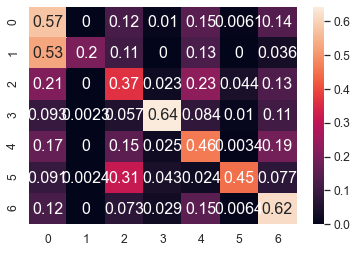

	training epoch=19 .. train_loss=1.106
	validation epoch=19 .. val_loss=1.284
	Accuracy = 52.800000000000004 % .. Percision = 59.199999999999996 % .. Recall = 47.199999999999996 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_19.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 20 .. loss = 0.829


  0%|                                                                                 | 1/1914 [00:01<37:59,  1.19s/it]

training @ epoch 20 .. loss = 1.338


  0%|                                                                                 | 2/1914 [00:02<38:21,  1.20s/it]

training @ epoch 20 .. loss = 0.75


  0%|▏                                                                                | 3/1914 [00:03<38:31,  1.21s/it]

training @ epoch 20 .. loss = 1.072


  0%|▏                                                                                | 4/1914 [00:04<39:00,  1.23s/it]

training @ epoch 20 .. loss = 1.22


  0%|▏                                                                                | 5/1914 [00:06<39:03,  1.23s/it]

training @ epoch 20 .. loss = 1.293


  0%|▎                                                                                | 6/1914 [00:07<39:10,  1.23s/it]

training @ epoch 20 .. loss = 0.99


  0%|▎                                                                                | 7/1914 [00:08<39:20,  1.24s/it]

training @ epoch 20 .. loss = 0.743


  0%|▎                                                                                | 8/1914 [00:09<39:16,  1.24s/it]

training @ epoch 20 .. loss = 1.441


  0%|▍                                                                                | 9/1914 [00:11<39:24,  1.24s/it]

training @ epoch 20 .. loss = 0.953


  1%|▍                                                                               | 10/1914 [00:12<39:40,  1.25s/it]

training @ epoch 20 .. loss = 1.18


  1%|▍                                                                               | 11/1914 [00:13<39:34,  1.25s/it]

training @ epoch 20 .. loss = 0.945


  1%|▌                                                                               | 12/1914 [00:14<39:47,  1.26s/it]

training @ epoch 20 .. loss = 1.264


  1%|▌                                                                               | 13/1914 [00:16<39:09,  1.24s/it]

training @ epoch 20 .. loss = 1.031


  1%|▌                                                                               | 14/1914 [00:17<39:01,  1.23s/it]

training @ epoch 20 .. loss = 1.201


  1%|▋                                                                               | 15/1914 [00:18<38:54,  1.23s/it]

training @ epoch 20 .. loss = 1.364


  1%|▋                                                                               | 16/1914 [00:19<38:52,  1.23s/it]

training @ epoch 20 .. loss = 1.205


  1%|▋                                                                               | 17/1914 [00:20<38:49,  1.23s/it]

training @ epoch 20 .. loss = 0.864


  1%|▊                                                                               | 18/1914 [00:22<38:54,  1.23s/it]

training @ epoch 20 .. loss = 0.851


  1%|▊                                                                               | 19/1914 [00:23<38:37,  1.22s/it]

training @ epoch 20 .. loss = 1.019


  1%|▊                                                                               | 20/1914 [00:24<38:42,  1.23s/it]

training @ epoch 20 .. loss = 1.431


  1%|▉                                                                               | 21/1914 [00:25<38:44,  1.23s/it]

training @ epoch 20 .. loss = 1.372


  1%|▉                                                                               | 22/1914 [00:27<38:45,  1.23s/it]

training @ epoch 20 .. loss = 1.002


  1%|▉                                                                               | 23/1914 [00:28<39:02,  1.24s/it]

training @ epoch 20 .. loss = 1.25


  1%|█                                                                               | 24/1914 [00:29<38:40,  1.23s/it]

training @ epoch 20 .. loss = 1.291


  1%|█                                                                               | 25/1914 [00:30<39:05,  1.24s/it]

training @ epoch 20 .. loss = 0.988


  1%|█                                                                               | 26/1914 [00:32<38:51,  1.23s/it]

training @ epoch 20 .. loss = 1.525


  1%|█▏                                                                              | 27/1914 [00:33<39:01,  1.24s/it]

training @ epoch 20 .. loss = 1.431


  1%|█▏                                                                              | 28/1914 [00:34<39:23,  1.25s/it]

training @ epoch 20 .. loss = 1.073


  2%|█▏                                                                              | 29/1914 [00:35<39:17,  1.25s/it]

training @ epoch 20 .. loss = 0.857


  2%|█▎                                                                              | 30/1914 [00:37<38:59,  1.24s/it]

training @ epoch 20 .. loss = 0.953


  2%|█▎                                                                              | 31/1914 [00:38<38:54,  1.24s/it]

training @ epoch 20 .. loss = 0.89


  2%|█▎                                                                              | 32/1914 [00:39<38:49,  1.24s/it]

training @ epoch 20 .. loss = 0.973


  2%|█▍                                                                              | 33/1914 [00:40<39:02,  1.25s/it]

training @ epoch 20 .. loss = 0.596


  2%|█▍                                                                              | 34/1914 [00:42<38:46,  1.24s/it]

training @ epoch 20 .. loss = 2.253


  2%|█▍                                                                              | 35/1914 [00:43<38:53,  1.24s/it]

training @ epoch 20 .. loss = 1.317


  2%|█▌                                                                              | 36/1914 [00:44<39:20,  1.26s/it]

training @ epoch 20 .. loss = 0.837


  2%|█▌                                                                              | 37/1914 [00:45<38:54,  1.24s/it]

training @ epoch 20 .. loss = 1.216


  2%|█▌                                                                              | 38/1914 [00:47<38:51,  1.24s/it]

training @ epoch 20 .. loss = 0.981


  2%|█▋                                                                              | 39/1914 [00:48<38:44,  1.24s/it]

training @ epoch 20 .. loss = 1.227


  2%|█▋                                                                              | 40/1914 [00:49<38:20,  1.23s/it]

training @ epoch 20 .. loss = 1.249


  2%|█▋                                                                              | 41/1914 [00:50<38:44,  1.24s/it]

training @ epoch 20 .. loss = 1.365


  2%|█▊                                                                              | 42/1914 [00:51<38:44,  1.24s/it]

training @ epoch 20 .. loss = 1.239


  2%|█▊                                                                              | 43/1914 [00:53<38:26,  1.23s/it]

training @ epoch 20 .. loss = 1.104


  2%|█▊                                                                              | 44/1914 [00:54<38:26,  1.23s/it]

training @ epoch 20 .. loss = 1.037


  2%|█▉                                                                              | 45/1914 [00:55<38:02,  1.22s/it]

training @ epoch 20 .. loss = 1.222


  2%|█▉                                                                              | 46/1914 [00:56<38:53,  1.25s/it]

training @ epoch 20 .. loss = 0.874


  2%|█▉                                                                              | 47/1914 [00:58<38:35,  1.24s/it]

training @ epoch 20 .. loss = 0.783


  3%|██                                                                              | 48/1914 [00:59<38:08,  1.23s/it]

training @ epoch 20 .. loss = 1.043


  3%|██                                                                              | 49/1914 [01:00<38:22,  1.23s/it]

training @ epoch 20 .. loss = 1.047


  3%|██                                                                              | 50/1914 [01:01<38:07,  1.23s/it]

training @ epoch 20 .. loss = 1.522


  3%|██▏                                                                             | 51/1914 [01:03<38:04,  1.23s/it]

training @ epoch 20 .. loss = 0.824


  3%|██▏                                                                             | 52/1914 [01:04<37:56,  1.22s/it]

training @ epoch 20 .. loss = 1.045


  3%|██▏                                                                             | 53/1914 [01:05<38:11,  1.23s/it]

training @ epoch 20 .. loss = 1.117


  3%|██▎                                                                             | 54/1914 [01:06<38:28,  1.24s/it]

training @ epoch 20 .. loss = 1.002


  3%|██▎                                                                             | 55/1914 [01:07<38:05,  1.23s/it]

training @ epoch 20 .. loss = 0.988


  3%|██▎                                                                             | 56/1914 [01:09<37:43,  1.22s/it]

training @ epoch 20 .. loss = 1.214


  3%|██▍                                                                             | 57/1914 [01:10<37:48,  1.22s/it]

training @ epoch 20 .. loss = 0.926


  3%|██▍                                                                             | 58/1914 [01:11<37:49,  1.22s/it]

training @ epoch 20 .. loss = 1.415


  3%|██▍                                                                             | 59/1914 [01:12<38:14,  1.24s/it]

training @ epoch 20 .. loss = 1.198


  3%|██▌                                                                             | 60/1914 [01:14<38:00,  1.23s/it]

training @ epoch 20 .. loss = 1.068


  3%|██▌                                                                             | 61/1914 [01:15<37:49,  1.22s/it]

training @ epoch 20 .. loss = 1.073


  3%|██▌                                                                             | 62/1914 [01:16<38:15,  1.24s/it]

training @ epoch 20 .. loss = 1.051


  3%|██▋                                                                             | 63/1914 [01:17<38:15,  1.24s/it]

training @ epoch 20 .. loss = 1.292


  3%|██▋                                                                             | 64/1914 [01:19<38:20,  1.24s/it]

training @ epoch 20 .. loss = 0.857


  3%|██▋                                                                             | 65/1914 [01:20<38:01,  1.23s/it]

training @ epoch 20 .. loss = 1.028


  3%|██▊                                                                             | 66/1914 [01:21<37:30,  1.22s/it]

training @ epoch 20 .. loss = 0.644


  4%|██▊                                                                             | 67/1914 [01:22<37:48,  1.23s/it]

training @ epoch 20 .. loss = 0.794


  4%|██▊                                                                             | 68/1914 [01:23<37:55,  1.23s/it]

training @ epoch 20 .. loss = 1.24


  4%|██▉                                                                             | 69/1914 [01:25<37:47,  1.23s/it]

training @ epoch 20 .. loss = 0.674


  4%|██▉                                                                             | 70/1914 [01:26<37:48,  1.23s/it]

training @ epoch 20 .. loss = 1.287


  4%|██▉                                                                             | 71/1914 [01:27<37:38,  1.23s/it]

training @ epoch 20 .. loss = 1.344


  4%|███                                                                             | 72/1914 [01:28<37:52,  1.23s/it]

training @ epoch 20 .. loss = 1.062


  4%|███                                                                             | 73/1914 [01:30<37:28,  1.22s/it]

training @ epoch 20 .. loss = 0.673


  4%|███                                                                             | 74/1914 [01:31<37:11,  1.21s/it]

training @ epoch 20 .. loss = 1.259


  4%|███▏                                                                            | 75/1914 [01:32<37:36,  1.23s/it]

training @ epoch 20 .. loss = 0.899


  4%|███▏                                                                            | 76/1914 [01:33<37:16,  1.22s/it]

training @ epoch 20 .. loss = 1.176


  4%|███▏                                                                            | 77/1914 [01:34<37:30,  1.23s/it]

training @ epoch 20 .. loss = 0.905


  4%|███▎                                                                            | 78/1914 [01:36<37:17,  1.22s/it]

training @ epoch 20 .. loss = 1.209


  4%|███▎                                                                            | 79/1914 [01:37<37:23,  1.22s/it]

training @ epoch 20 .. loss = 1.091


  4%|███▎                                                                            | 80/1914 [01:38<37:27,  1.23s/it]

training @ epoch 20 .. loss = 1.253


  4%|███▍                                                                            | 81/1914 [01:39<37:29,  1.23s/it]

training @ epoch 20 .. loss = 0.946


  4%|███▍                                                                            | 82/1914 [01:41<37:16,  1.22s/it]

training @ epoch 20 .. loss = 1.112


  4%|███▍                                                                            | 83/1914 [01:42<36:59,  1.21s/it]

training @ epoch 20 .. loss = 1.302


  4%|███▌                                                                            | 84/1914 [01:43<36:58,  1.21s/it]

training @ epoch 20 .. loss = 1.191


  4%|███▌                                                                            | 85/1914 [01:44<37:30,  1.23s/it]

training @ epoch 20 .. loss = 0.779


  4%|███▌                                                                            | 86/1914 [01:46<37:36,  1.23s/it]

training @ epoch 20 .. loss = 1.122


  5%|███▋                                                                            | 87/1914 [01:47<37:27,  1.23s/it]

training @ epoch 20 .. loss = 0.924


  5%|███▋                                                                            | 88/1914 [01:48<37:25,  1.23s/it]

training @ epoch 20 .. loss = 0.926


  5%|███▋                                                                            | 89/1914 [01:49<37:09,  1.22s/it]

training @ epoch 20 .. loss = 1.24


  5%|███▊                                                                            | 90/1914 [01:50<37:31,  1.23s/it]

training @ epoch 20 .. loss = 0.995


  5%|███▊                                                                            | 91/1914 [01:52<37:07,  1.22s/it]

training @ epoch 20 .. loss = 1.216


  5%|███▊                                                                            | 92/1914 [01:53<37:12,  1.23s/it]

training @ epoch 20 .. loss = 1.204


  5%|███▉                                                                            | 93/1914 [01:54<37:15,  1.23s/it]

training @ epoch 20 .. loss = 0.945


  5%|███▉                                                                            | 94/1914 [01:55<37:22,  1.23s/it]

training @ epoch 20 .. loss = 1.45


  5%|███▉                                                                            | 95/1914 [01:57<37:14,  1.23s/it]

training @ epoch 20 .. loss = 1.035


  5%|████                                                                            | 96/1914 [01:58<37:33,  1.24s/it]

training @ epoch 20 .. loss = 0.781


  5%|████                                                                            | 97/1914 [01:59<37:28,  1.24s/it]

training @ epoch 20 .. loss = 1.568


  5%|████                                                                            | 98/1914 [02:00<37:36,  1.24s/it]

training @ epoch 20 .. loss = 0.984


  5%|████▏                                                                           | 99/1914 [02:02<37:23,  1.24s/it]

training @ epoch 20 .. loss = 0.908


  5%|████▏                                                                          | 100/1914 [02:03<36:59,  1.22s/it]

training @ epoch 20 .. loss = 0.787


  5%|████▏                                                                          | 101/1914 [02:04<37:14,  1.23s/it]

training @ epoch 20 .. loss = 0.767


  5%|████▏                                                                          | 102/1914 [02:05<37:11,  1.23s/it]

training @ epoch 20 .. loss = 1.104


  5%|████▎                                                                          | 103/1914 [02:06<37:17,  1.24s/it]

training @ epoch 20 .. loss = 0.788


  5%|████▎                                                                          | 104/1914 [02:08<36:52,  1.22s/it]

training @ epoch 20 .. loss = 1.219


  5%|████▎                                                                          | 105/1914 [02:09<36:39,  1.22s/it]

training @ epoch 20 .. loss = 0.986


  6%|████▍                                                                          | 106/1914 [02:10<36:59,  1.23s/it]

training @ epoch 20 .. loss = 0.907


  6%|████▍                                                                          | 107/1914 [02:11<37:27,  1.24s/it]

training @ epoch 20 .. loss = 0.901


  6%|████▍                                                                          | 108/1914 [02:13<37:10,  1.23s/it]

training @ epoch 20 .. loss = 1.29


  6%|████▍                                                                          | 109/1914 [02:14<37:02,  1.23s/it]

training @ epoch 20 .. loss = 0.856


  6%|████▌                                                                          | 110/1914 [02:15<37:06,  1.23s/it]

training @ epoch 20 .. loss = 0.709


  6%|████▌                                                                          | 111/1914 [02:16<37:16,  1.24s/it]

training @ epoch 20 .. loss = 1.258


  6%|████▌                                                                          | 112/1914 [02:18<36:58,  1.23s/it]

training @ epoch 20 .. loss = 1.534


  6%|████▋                                                                          | 113/1914 [02:19<36:42,  1.22s/it]

training @ epoch 20 .. loss = 1.179


  6%|████▋                                                                          | 114/1914 [02:20<36:50,  1.23s/it]

training @ epoch 20 .. loss = 0.874


  6%|████▋                                                                          | 115/1914 [02:21<36:35,  1.22s/it]

training @ epoch 20 .. loss = 1.664


  6%|████▊                                                                          | 116/1914 [02:22<37:03,  1.24s/it]

training @ epoch 20 .. loss = 1.655


  6%|████▊                                                                          | 117/1914 [02:24<37:10,  1.24s/it]

training @ epoch 20 .. loss = 1.033


  6%|████▊                                                                          | 118/1914 [02:25<37:10,  1.24s/it]

training @ epoch 20 .. loss = 0.879


  6%|████▉                                                                          | 119/1914 [02:26<37:04,  1.24s/it]

training @ epoch 20 .. loss = 1.215


  6%|████▉                                                                          | 120/1914 [02:27<37:04,  1.24s/it]

training @ epoch 20 .. loss = 1.769


  6%|████▉                                                                          | 121/1914 [02:29<36:47,  1.23s/it]

training @ epoch 20 .. loss = 0.963


  6%|█████                                                                          | 122/1914 [02:30<36:52,  1.23s/it]

training @ epoch 20 .. loss = 1.056


  6%|█████                                                                          | 123/1914 [02:31<38:49,  1.30s/it]

training @ epoch 20 .. loss = 0.994


  6%|█████                                                                          | 124/1914 [02:33<38:59,  1.31s/it]

training @ epoch 20 .. loss = 1.318


  7%|█████▏                                                                         | 125/1914 [02:34<38:35,  1.29s/it]

training @ epoch 20 .. loss = 1.599


  7%|█████▏                                                                         | 126/1914 [02:35<37:53,  1.27s/it]

training @ epoch 20 .. loss = 0.64


  7%|█████▏                                                                         | 127/1914 [02:36<37:37,  1.26s/it]

training @ epoch 20 .. loss = 1.254


  7%|█████▎                                                                         | 128/1914 [02:38<37:06,  1.25s/it]

training @ epoch 20 .. loss = 1.495


  7%|█████▎                                                                         | 129/1914 [02:39<37:04,  1.25s/it]

training @ epoch 20 .. loss = 0.782


  7%|█████▎                                                                         | 130/1914 [02:40<37:17,  1.25s/it]

training @ epoch 20 .. loss = 1.298


  7%|█████▍                                                                         | 131/1914 [02:41<37:29,  1.26s/it]

training @ epoch 20 .. loss = 0.739


  7%|█████▍                                                                         | 132/1914 [02:43<37:02,  1.25s/it]

training @ epoch 20 .. loss = 1.042


  7%|█████▍                                                                         | 133/1914 [02:44<37:03,  1.25s/it]

training @ epoch 20 .. loss = 0.913


  7%|█████▌                                                                         | 134/1914 [02:45<36:32,  1.23s/it]

training @ epoch 20 .. loss = 1.054


  7%|█████▌                                                                         | 135/1914 [02:46<36:52,  1.24s/it]

training @ epoch 20 .. loss = 1.224


  7%|█████▌                                                                         | 136/1914 [02:48<36:38,  1.24s/it]

training @ epoch 20 .. loss = 1.357


  7%|█████▋                                                                         | 137/1914 [02:49<36:18,  1.23s/it]

training @ epoch 20 .. loss = 1.076


  7%|█████▋                                                                         | 138/1914 [02:50<36:20,  1.23s/it]

training @ epoch 20 .. loss = 1.053


  7%|█████▋                                                                         | 139/1914 [02:51<36:17,  1.23s/it]

training @ epoch 20 .. loss = 1.437


  7%|█████▊                                                                         | 140/1914 [02:52<36:35,  1.24s/it]

training @ epoch 20 .. loss = 0.862


  7%|█████▊                                                                         | 141/1914 [02:54<36:26,  1.23s/it]

training @ epoch 20 .. loss = 1.038


  7%|█████▊                                                                         | 142/1914 [02:55<36:19,  1.23s/it]

training @ epoch 20 .. loss = 0.683


  7%|█████▉                                                                         | 143/1914 [02:56<36:14,  1.23s/it]

training @ epoch 20 .. loss = 1.113


  8%|█████▉                                                                         | 144/1914 [02:57<36:26,  1.24s/it]

training @ epoch 20 .. loss = 1.165


  8%|█████▉                                                                         | 145/1914 [02:59<36:35,  1.24s/it]

training @ epoch 20 .. loss = 0.883


  8%|██████                                                                         | 146/1914 [03:00<36:23,  1.23s/it]

training @ epoch 20 .. loss = 1.357


  8%|██████                                                                         | 147/1914 [03:01<36:16,  1.23s/it]

training @ epoch 20 .. loss = 1.146


  8%|██████                                                                         | 148/1914 [03:02<36:26,  1.24s/it]

training @ epoch 20 .. loss = 1.224


  8%|██████▏                                                                        | 149/1914 [03:04<36:11,  1.23s/it]

training @ epoch 20 .. loss = 1.308


  8%|██████▏                                                                        | 150/1914 [03:05<36:00,  1.22s/it]

training @ epoch 20 .. loss = 1.002


  8%|██████▏                                                                        | 151/1914 [03:06<36:30,  1.24s/it]

training @ epoch 20 .. loss = 1.051


  8%|██████▎                                                                        | 152/1914 [03:07<36:23,  1.24s/it]

training @ epoch 20 .. loss = 0.741


  8%|██████▎                                                                        | 153/1914 [03:09<36:40,  1.25s/it]

training @ epoch 20 .. loss = 1.164


  8%|██████▎                                                                        | 154/1914 [03:10<36:24,  1.24s/it]

training @ epoch 20 .. loss = 1.898


  8%|██████▍                                                                        | 155/1914 [03:11<36:32,  1.25s/it]

training @ epoch 20 .. loss = 1.025


  8%|██████▍                                                                        | 156/1914 [03:12<36:40,  1.25s/it]

training @ epoch 20 .. loss = 0.808


  8%|██████▍                                                                        | 157/1914 [03:14<36:35,  1.25s/it]

training @ epoch 20 .. loss = 1.169


  8%|██████▌                                                                        | 158/1914 [03:15<36:09,  1.24s/it]

training @ epoch 20 .. loss = 1.424


  8%|██████▌                                                                        | 159/1914 [03:16<36:17,  1.24s/it]

training @ epoch 20 .. loss = 0.761


  8%|██████▌                                                                        | 160/1914 [03:17<36:01,  1.23s/it]

training @ epoch 20 .. loss = 1.424


  8%|██████▋                                                                        | 161/1914 [03:18<35:59,  1.23s/it]

training @ epoch 20 .. loss = 0.902


  8%|██████▋                                                                        | 162/1914 [03:20<35:43,  1.22s/it]

training @ epoch 20 .. loss = 1.443


  9%|██████▋                                                                        | 163/1914 [03:21<35:37,  1.22s/it]

training @ epoch 20 .. loss = 0.588


  9%|██████▊                                                                        | 164/1914 [03:22<36:07,  1.24s/it]

training @ epoch 20 .. loss = 0.923


  9%|██████▊                                                                        | 165/1914 [03:23<36:13,  1.24s/it]

training @ epoch 20 .. loss = 1.12


  9%|██████▊                                                                        | 166/1914 [03:25<36:02,  1.24s/it]

training @ epoch 20 .. loss = 0.822


  9%|██████▉                                                                        | 167/1914 [03:26<36:04,  1.24s/it]

training @ epoch 20 .. loss = 1.556


  9%|██████▉                                                                        | 168/1914 [03:27<35:44,  1.23s/it]

training @ epoch 20 .. loss = 0.831


  9%|██████▉                                                                        | 169/1914 [03:28<36:11,  1.24s/it]

training @ epoch 20 .. loss = 0.914


  9%|███████                                                                        | 170/1914 [03:30<35:59,  1.24s/it]

training @ epoch 20 .. loss = 1.305


  9%|███████                                                                        | 171/1914 [03:31<35:39,  1.23s/it]

training @ epoch 20 .. loss = 0.889


  9%|███████                                                                        | 172/1914 [03:32<35:42,  1.23s/it]

training @ epoch 20 .. loss = 0.929


  9%|███████▏                                                                       | 173/1914 [03:33<35:42,  1.23s/it]

training @ epoch 20 .. loss = 1.484


  9%|███████▏                                                                       | 174/1914 [03:34<36:07,  1.25s/it]

training @ epoch 20 .. loss = 1.341


  9%|███████▏                                                                       | 175/1914 [03:36<35:54,  1.24s/it]

training @ epoch 20 .. loss = 0.897


  9%|███████▎                                                                       | 176/1914 [03:37<35:51,  1.24s/it]

training @ epoch 20 .. loss = 1.575


  9%|███████▎                                                                       | 177/1914 [03:38<35:58,  1.24s/it]

training @ epoch 20 .. loss = 1.495


  9%|███████▎                                                                       | 178/1914 [03:39<36:00,  1.24s/it]

training @ epoch 20 .. loss = 1.12


  9%|███████▍                                                                       | 179/1914 [03:41<35:53,  1.24s/it]

training @ epoch 20 .. loss = 1.212


  9%|███████▍                                                                       | 180/1914 [03:42<35:56,  1.24s/it]

training @ epoch 20 .. loss = 1.053


  9%|███████▍                                                                       | 181/1914 [03:43<35:21,  1.22s/it]

training @ epoch 20 .. loss = 0.939


 10%|███████▌                                                                       | 182/1914 [03:44<35:47,  1.24s/it]

training @ epoch 20 .. loss = 1.413


 10%|███████▌                                                                       | 183/1914 [03:46<35:28,  1.23s/it]

training @ epoch 20 .. loss = 1.156


 10%|███████▌                                                                       | 184/1914 [03:47<35:23,  1.23s/it]

training @ epoch 20 .. loss = 1.033


 10%|███████▋                                                                       | 185/1914 [03:48<35:45,  1.24s/it]

training @ epoch 20 .. loss = 1.008


 10%|███████▋                                                                       | 186/1914 [03:49<36:06,  1.25s/it]

training @ epoch 20 .. loss = 0.837


 10%|███████▋                                                                       | 187/1914 [03:51<35:33,  1.24s/it]

training @ epoch 20 .. loss = 1.524


 10%|███████▊                                                                       | 188/1914 [03:52<35:42,  1.24s/it]

training @ epoch 20 .. loss = 0.608


 10%|███████▊                                                                       | 189/1914 [03:53<35:24,  1.23s/it]

training @ epoch 20 .. loss = 0.929


 10%|███████▊                                                                       | 190/1914 [03:54<35:54,  1.25s/it]

training @ epoch 20 .. loss = 0.971


 10%|███████▉                                                                       | 191/1914 [03:56<36:11,  1.26s/it]

training @ epoch 20 .. loss = 1.098


 10%|███████▉                                                                       | 192/1914 [03:57<35:34,  1.24s/it]

training @ epoch 20 .. loss = 0.939


 10%|███████▉                                                                       | 193/1914 [03:58<35:40,  1.24s/it]

training @ epoch 20 .. loss = 0.951


 10%|████████                                                                       | 194/1914 [03:59<35:23,  1.23s/it]

training @ epoch 20 .. loss = 0.904


 10%|████████                                                                       | 195/1914 [04:00<35:21,  1.23s/it]

training @ epoch 20 .. loss = 0.967


 10%|████████                                                                       | 196/1914 [04:02<35:24,  1.24s/it]

training @ epoch 20 .. loss = 1.388


 10%|████████▏                                                                      | 197/1914 [04:03<35:14,  1.23s/it]

training @ epoch 20 .. loss = 1.102


 10%|████████▏                                                                      | 198/1914 [04:04<35:30,  1.24s/it]

training @ epoch 20 .. loss = 0.882


 10%|████████▏                                                                      | 199/1914 [04:05<35:19,  1.24s/it]

training @ epoch 20 .. loss = 1.497


 10%|████████▎                                                                      | 200/1914 [04:07<35:00,  1.23s/it]

training @ epoch 20 .. loss = 0.796


 11%|████████▎                                                                      | 201/1914 [04:08<35:02,  1.23s/it]

training @ epoch 20 .. loss = 1.229


 11%|████████▎                                                                      | 202/1914 [04:09<35:04,  1.23s/it]

training @ epoch 20 .. loss = 0.932


 11%|████████▍                                                                      | 203/1914 [04:10<35:31,  1.25s/it]

training @ epoch 20 .. loss = 1.157


 11%|████████▍                                                                      | 204/1914 [04:12<34:52,  1.22s/it]

training @ epoch 20 .. loss = 1.281


 11%|████████▍                                                                      | 205/1914 [04:13<35:20,  1.24s/it]

training @ epoch 20 .. loss = 1.529


 11%|████████▌                                                                      | 206/1914 [04:14<35:26,  1.24s/it]

training @ epoch 20 .. loss = 1.132


 11%|████████▌                                                                      | 207/1914 [04:15<35:13,  1.24s/it]

training @ epoch 20 .. loss = 1.283


 11%|████████▌                                                                      | 208/1914 [04:17<34:59,  1.23s/it]

training @ epoch 20 .. loss = 1.232


 11%|████████▋                                                                      | 209/1914 [04:18<34:58,  1.23s/it]

training @ epoch 20 .. loss = 1.185


 11%|████████▋                                                                      | 210/1914 [04:19<34:42,  1.22s/it]

training @ epoch 20 .. loss = 1.205


 11%|████████▋                                                                      | 211/1914 [04:20<34:52,  1.23s/it]

training @ epoch 20 .. loss = 0.775


 11%|████████▊                                                                      | 212/1914 [04:21<34:52,  1.23s/it]

training @ epoch 20 .. loss = 0.554


 11%|████████▊                                                                      | 213/1914 [04:23<34:32,  1.22s/it]

training @ epoch 20 .. loss = 1.168


 11%|████████▊                                                                      | 214/1914 [04:24<34:25,  1.22s/it]

training @ epoch 20 .. loss = 1.158


 11%|████████▊                                                                      | 215/1914 [04:25<34:07,  1.21s/it]

training @ epoch 20 .. loss = 1.049


 11%|████████▉                                                                      | 216/1914 [04:26<34:31,  1.22s/it]

training @ epoch 20 .. loss = 1.099


 11%|████████▉                                                                      | 217/1914 [04:28<34:36,  1.22s/it]

training @ epoch 20 .. loss = 1.114


 11%|████████▉                                                                      | 218/1914 [04:29<34:29,  1.22s/it]

training @ epoch 20 .. loss = 1.165


 11%|█████████                                                                      | 219/1914 [04:30<34:38,  1.23s/it]

training @ epoch 20 .. loss = 0.817


 11%|█████████                                                                      | 220/1914 [04:31<34:45,  1.23s/it]

training @ epoch 20 .. loss = 1.238


 12%|█████████                                                                      | 221/1914 [04:32<34:45,  1.23s/it]

training @ epoch 20 .. loss = 0.971


 12%|█████████▏                                                                     | 222/1914 [04:34<34:39,  1.23s/it]

training @ epoch 20 .. loss = 0.904


 12%|█████████▏                                                                     | 223/1914 [04:35<34:28,  1.22s/it]

training @ epoch 20 .. loss = 1.217


 12%|█████████▏                                                                     | 224/1914 [04:36<34:43,  1.23s/it]

training @ epoch 20 .. loss = 1.34


 12%|█████████▎                                                                     | 225/1914 [04:37<34:20,  1.22s/it]

training @ epoch 20 .. loss = 1.024


 12%|█████████▎                                                                     | 226/1914 [04:39<34:20,  1.22s/it]

training @ epoch 20 .. loss = 1.047


 12%|█████████▎                                                                     | 227/1914 [04:40<34:24,  1.22s/it]

training @ epoch 20 .. loss = 0.982


 12%|█████████▍                                                                     | 228/1914 [04:41<34:32,  1.23s/it]

training @ epoch 20 .. loss = 1.179


 12%|█████████▍                                                                     | 229/1914 [04:42<34:58,  1.25s/it]

training @ epoch 20 .. loss = 1.179


 12%|█████████▍                                                                     | 230/1914 [04:44<34:42,  1.24s/it]

training @ epoch 20 .. loss = 1.143


 12%|█████████▌                                                                     | 231/1914 [04:45<34:35,  1.23s/it]

training @ epoch 20 .. loss = 0.977


 12%|█████████▌                                                                     | 232/1914 [04:46<34:45,  1.24s/it]

training @ epoch 20 .. loss = 1.158


 12%|█████████▌                                                                     | 233/1914 [04:47<34:30,  1.23s/it]

training @ epoch 20 .. loss = 1.243


 12%|█████████▋                                                                     | 234/1914 [04:48<34:40,  1.24s/it]

training @ epoch 20 .. loss = 1.336


 12%|█████████▋                                                                     | 235/1914 [04:50<34:17,  1.23s/it]

training @ epoch 20 .. loss = 1.232


 12%|█████████▋                                                                     | 236/1914 [04:51<34:18,  1.23s/it]

training @ epoch 20 .. loss = 1.05


 12%|█████████▊                                                                     | 237/1914 [04:52<34:35,  1.24s/it]

training @ epoch 20 .. loss = 1.421


 12%|█████████▊                                                                     | 238/1914 [04:53<34:36,  1.24s/it]

training @ epoch 20 .. loss = 1.093


 12%|█████████▊                                                                     | 239/1914 [04:55<34:07,  1.22s/it]

training @ epoch 20 .. loss = 0.932


 13%|█████████▉                                                                     | 240/1914 [04:56<34:57,  1.25s/it]

training @ epoch 20 .. loss = 0.86


 13%|█████████▉                                                                     | 241/1914 [04:57<34:29,  1.24s/it]

training @ epoch 20 .. loss = 0.503


 13%|█████████▉                                                                     | 242/1914 [04:58<35:01,  1.26s/it]

training @ epoch 20 .. loss = 1.01


 13%|██████████                                                                     | 243/1914 [05:00<34:37,  1.24s/it]

training @ epoch 20 .. loss = 1.17


 13%|██████████                                                                     | 244/1914 [05:01<34:35,  1.24s/it]

training @ epoch 20 .. loss = 1.029


 13%|██████████                                                                     | 245/1914 [05:02<34:29,  1.24s/it]

training @ epoch 20 .. loss = 1.064


 13%|██████████▏                                                                    | 246/1914 [05:03<34:09,  1.23s/it]

training @ epoch 20 .. loss = 0.922


 13%|██████████▏                                                                    | 247/1914 [05:05<34:10,  1.23s/it]

training @ epoch 20 .. loss = 0.455


 13%|██████████▏                                                                    | 248/1914 [05:06<34:00,  1.22s/it]

training @ epoch 20 .. loss = 1.171


 13%|██████████▎                                                                    | 249/1914 [05:07<34:23,  1.24s/it]

training @ epoch 20 .. loss = 0.968


 13%|██████████▎                                                                    | 250/1914 [05:08<34:34,  1.25s/it]

training @ epoch 20 .. loss = 0.8


 13%|██████████▎                                                                    | 251/1914 [05:10<34:30,  1.25s/it]

training @ epoch 20 .. loss = 1.011


 13%|██████████▍                                                                    | 252/1914 [05:11<34:12,  1.23s/it]

training @ epoch 20 .. loss = 0.979


 13%|██████████▍                                                                    | 253/1914 [05:12<34:23,  1.24s/it]

training @ epoch 20 .. loss = 0.964


 13%|██████████▍                                                                    | 254/1914 [05:13<34:09,  1.23s/it]

training @ epoch 20 .. loss = 1.375


 13%|██████████▌                                                                    | 255/1914 [05:14<34:12,  1.24s/it]

training @ epoch 20 .. loss = 0.974


 13%|██████████▌                                                                    | 256/1914 [05:16<34:08,  1.24s/it]

training @ epoch 20 .. loss = 0.943


 13%|██████████▌                                                                    | 257/1914 [05:17<34:02,  1.23s/it]

training @ epoch 20 .. loss = 0.852


 13%|██████████▋                                                                    | 258/1914 [05:18<34:03,  1.23s/it]

training @ epoch 20 .. loss = 0.752


 14%|██████████▋                                                                    | 259/1914 [05:19<34:01,  1.23s/it]

training @ epoch 20 .. loss = 1.288


 14%|██████████▋                                                                    | 260/1914 [05:21<33:50,  1.23s/it]

training @ epoch 20 .. loss = 0.938


 14%|██████████▊                                                                    | 261/1914 [05:22<33:51,  1.23s/it]

training @ epoch 20 .. loss = 1.663


 14%|██████████▊                                                                    | 262/1914 [05:23<33:46,  1.23s/it]

training @ epoch 20 .. loss = 1.101


 14%|██████████▊                                                                    | 263/1914 [05:24<34:02,  1.24s/it]

training @ epoch 20 .. loss = 0.817


 14%|██████████▉                                                                    | 264/1914 [05:26<33:54,  1.23s/it]

training @ epoch 20 .. loss = 0.773


 14%|██████████▉                                                                    | 265/1914 [05:27<33:48,  1.23s/it]

training @ epoch 20 .. loss = 0.969


 14%|██████████▉                                                                    | 266/1914 [05:28<34:08,  1.24s/it]

training @ epoch 20 .. loss = 0.714


 14%|███████████                                                                    | 267/1914 [05:29<33:56,  1.24s/it]

training @ epoch 20 .. loss = 1.367


 14%|███████████                                                                    | 268/1914 [05:30<33:59,  1.24s/it]

training @ epoch 20 .. loss = 0.883


 14%|███████████                                                                    | 269/1914 [05:32<33:43,  1.23s/it]

training @ epoch 20 .. loss = 1.274


 14%|███████████▏                                                                   | 270/1914 [05:33<33:29,  1.22s/it]

training @ epoch 20 .. loss = 1.239


 14%|███████████▏                                                                   | 271/1914 [05:34<33:43,  1.23s/it]

training @ epoch 20 .. loss = 0.898


 14%|███████████▏                                                                   | 272/1914 [05:35<33:47,  1.23s/it]

training @ epoch 20 .. loss = 1.643


 14%|███████████▎                                                                   | 273/1914 [05:37<33:34,  1.23s/it]

training @ epoch 20 .. loss = 1.368


 14%|███████████▎                                                                   | 274/1914 [05:38<33:42,  1.23s/it]

training @ epoch 20 .. loss = 1.356


 14%|███████████▎                                                                   | 275/1914 [05:39<33:35,  1.23s/it]

training @ epoch 20 .. loss = 0.829


 14%|███████████▍                                                                   | 276/1914 [05:40<33:41,  1.23s/it]

training @ epoch 20 .. loss = 1.376


 14%|███████████▍                                                                   | 277/1914 [05:42<33:37,  1.23s/it]

training @ epoch 20 .. loss = 0.952


 15%|███████████▍                                                                   | 278/1914 [05:43<33:40,  1.24s/it]

training @ epoch 20 .. loss = 1.326


 15%|███████████▌                                                                   | 279/1914 [05:44<33:48,  1.24s/it]

training @ epoch 20 .. loss = 1.362


 15%|███████████▌                                                                   | 280/1914 [05:45<33:38,  1.24s/it]

training @ epoch 20 .. loss = 1.186


 15%|███████████▌                                                                   | 281/1914 [05:47<33:37,  1.24s/it]

training @ epoch 20 .. loss = 0.831


 15%|███████████▋                                                                   | 282/1914 [05:48<33:34,  1.23s/it]

training @ epoch 20 .. loss = 1.692


 15%|███████████▋                                                                   | 283/1914 [05:49<33:19,  1.23s/it]

training @ epoch 20 .. loss = 0.84


 15%|███████████▋                                                                   | 284/1914 [05:50<33:59,  1.25s/it]

training @ epoch 20 .. loss = 1.253


 15%|███████████▊                                                                   | 285/1914 [05:52<34:08,  1.26s/it]

training @ epoch 20 .. loss = 0.909


 15%|███████████▊                                                                   | 286/1914 [05:53<33:40,  1.24s/it]

training @ epoch 20 .. loss = 1.199


 15%|███████████▊                                                                   | 287/1914 [05:54<33:48,  1.25s/it]

training @ epoch 20 .. loss = 1.053


 15%|███████████▉                                                                   | 288/1914 [05:55<33:16,  1.23s/it]

training @ epoch 20 .. loss = 1.133


 15%|███████████▉                                                                   | 289/1914 [05:56<33:21,  1.23s/it]

training @ epoch 20 .. loss = 0.959


 15%|███████████▉                                                                   | 290/1914 [05:58<33:05,  1.22s/it]

training @ epoch 20 .. loss = 1.175


 15%|████████████                                                                   | 291/1914 [05:59<32:53,  1.22s/it]

training @ epoch 20 .. loss = 1.222


 15%|████████████                                                                   | 292/1914 [06:00<33:11,  1.23s/it]

training @ epoch 20 .. loss = 1.084


 15%|████████████                                                                   | 293/1914 [06:01<33:12,  1.23s/it]

training @ epoch 20 .. loss = 1.226


 15%|████████████▏                                                                  | 294/1914 [06:03<33:23,  1.24s/it]

training @ epoch 20 .. loss = 0.933


 15%|████████████▏                                                                  | 295/1914 [06:04<33:15,  1.23s/it]

training @ epoch 20 .. loss = 1.051


 15%|████████████▏                                                                  | 296/1914 [06:05<33:05,  1.23s/it]

training @ epoch 20 .. loss = 0.627


 16%|████████████▎                                                                  | 297/1914 [06:06<33:21,  1.24s/it]

training @ epoch 20 .. loss = 1.019


 16%|████████████▎                                                                  | 298/1914 [06:08<33:23,  1.24s/it]

training @ epoch 20 .. loss = 1.165


 16%|████████████▎                                                                  | 299/1914 [06:09<33:12,  1.23s/it]

training @ epoch 20 .. loss = 0.62


 16%|████████████▍                                                                  | 300/1914 [06:10<33:11,  1.23s/it]

training @ epoch 20 .. loss = 0.777


 16%|████████████▍                                                                  | 301/1914 [06:11<33:24,  1.24s/it]

training @ epoch 20 .. loss = 0.718


 16%|████████████▍                                                                  | 302/1914 [06:13<33:46,  1.26s/it]

training @ epoch 20 .. loss = 0.852


 16%|████████████▌                                                                  | 303/1914 [06:14<33:33,  1.25s/it]

training @ epoch 20 .. loss = 1.079


 16%|████████████▌                                                                  | 304/1914 [06:15<33:14,  1.24s/it]

training @ epoch 20 .. loss = 1.561


 16%|████████████▌                                                                  | 305/1914 [06:16<33:24,  1.25s/it]

training @ epoch 20 .. loss = 1.726


 16%|████████████▋                                                                  | 306/1914 [06:17<33:20,  1.24s/it]

training @ epoch 20 .. loss = 0.8


 16%|████████████▋                                                                  | 307/1914 [06:19<33:09,  1.24s/it]

training @ epoch 20 .. loss = 0.941


 16%|████████████▋                                                                  | 308/1914 [06:20<33:20,  1.25s/it]

training @ epoch 20 .. loss = 1.289


 16%|████████████▊                                                                  | 309/1914 [06:21<33:13,  1.24s/it]

training @ epoch 20 .. loss = 0.911


 16%|████████████▊                                                                  | 310/1914 [06:22<33:22,  1.25s/it]

training @ epoch 20 .. loss = 0.882


 16%|████████████▊                                                                  | 311/1914 [06:24<33:42,  1.26s/it]

training @ epoch 20 .. loss = 1.024


 16%|████████████▉                                                                  | 312/1914 [06:25<33:26,  1.25s/it]

training @ epoch 20 .. loss = 1.151


 16%|████████████▉                                                                  | 313/1914 [06:26<33:31,  1.26s/it]

training @ epoch 20 .. loss = 1.036


 16%|████████████▉                                                                  | 314/1914 [06:28<35:15,  1.32s/it]

training @ epoch 20 .. loss = 0.544


 16%|█████████████                                                                  | 315/1914 [06:29<35:19,  1.33s/it]

training @ epoch 20 .. loss = 1.047


 17%|█████████████                                                                  | 316/1914 [06:30<35:57,  1.35s/it]

training @ epoch 20 .. loss = 0.958


 17%|█████████████                                                                  | 317/1914 [06:32<35:10,  1.32s/it]

training @ epoch 20 .. loss = 1.027


 17%|█████████████▏                                                                 | 318/1914 [06:33<34:16,  1.29s/it]

training @ epoch 20 .. loss = 0.946


 17%|█████████████▏                                                                 | 319/1914 [06:34<33:53,  1.28s/it]

training @ epoch 20 .. loss = 1.45


 17%|█████████████▏                                                                 | 320/1914 [06:35<33:46,  1.27s/it]

training @ epoch 20 .. loss = 1.523


 17%|█████████████▏                                                                 | 321/1914 [06:37<33:21,  1.26s/it]

training @ epoch 20 .. loss = 0.791


 17%|█████████████▎                                                                 | 322/1914 [06:38<32:49,  1.24s/it]

training @ epoch 20 .. loss = 0.73


 17%|█████████████▎                                                                 | 323/1914 [06:39<32:31,  1.23s/it]

training @ epoch 20 .. loss = 1.382


 17%|█████████████▎                                                                 | 324/1914 [06:40<32:33,  1.23s/it]

training @ epoch 20 .. loss = 0.889


 17%|█████████████▍                                                                 | 325/1914 [06:42<33:17,  1.26s/it]

training @ epoch 20 .. loss = 0.906


 17%|█████████████▍                                                                 | 326/1914 [06:43<34:08,  1.29s/it]

training @ epoch 20 .. loss = 1.045


 17%|█████████████▍                                                                 | 327/1914 [06:44<34:54,  1.32s/it]

training @ epoch 20 .. loss = 0.695


 17%|█████████████▌                                                                 | 328/1914 [06:46<35:46,  1.35s/it]

training @ epoch 20 .. loss = 0.899


 17%|█████████████▌                                                                 | 329/1914 [06:47<36:17,  1.37s/it]

training @ epoch 20 .. loss = 1.687


 17%|█████████████▌                                                                 | 330/1914 [06:49<36:17,  1.37s/it]

training @ epoch 20 .. loss = 1.269


 17%|█████████████▋                                                                 | 331/1914 [06:50<36:05,  1.37s/it]

training @ epoch 20 .. loss = 1.002


 17%|█████████████▋                                                                 | 332/1914 [06:51<35:53,  1.36s/it]

training @ epoch 20 .. loss = 1.529


 17%|█████████████▋                                                                 | 333/1914 [06:53<35:29,  1.35s/it]

training @ epoch 20 .. loss = 0.839


 17%|█████████████▊                                                                 | 334/1914 [06:54<35:07,  1.33s/it]

training @ epoch 20 .. loss = 0.975


 18%|█████████████▊                                                                 | 335/1914 [06:55<34:51,  1.32s/it]

training @ epoch 20 .. loss = 0.847


 18%|█████████████▊                                                                 | 336/1914 [06:57<35:09,  1.34s/it]

training @ epoch 20 .. loss = 0.642


 18%|█████████████▉                                                                 | 337/1914 [06:58<34:57,  1.33s/it]

training @ epoch 20 .. loss = 1.337


 18%|█████████████▉                                                                 | 338/1914 [06:59<35:31,  1.35s/it]

training @ epoch 20 .. loss = 1.173


 18%|█████████████▉                                                                 | 339/1914 [07:01<36:14,  1.38s/it]

training @ epoch 20 .. loss = 0.789


 18%|██████████████                                                                 | 340/1914 [07:02<36:17,  1.38s/it]

training @ epoch 20 .. loss = 1.123


 18%|██████████████                                                                 | 341/1914 [07:03<36:02,  1.37s/it]

training @ epoch 20 .. loss = 1.436


 18%|██████████████                                                                 | 342/1914 [07:05<34:49,  1.33s/it]

training @ epoch 20 .. loss = 1.563


 18%|██████████████▏                                                                | 343/1914 [07:06<33:47,  1.29s/it]

training @ epoch 20 .. loss = 1.038


 18%|██████████████▏                                                                | 344/1914 [07:07<33:23,  1.28s/it]

training @ epoch 20 .. loss = 1.482


 18%|██████████████▏                                                                | 345/1914 [07:08<33:15,  1.27s/it]

training @ epoch 20 .. loss = 0.916


 18%|██████████████▎                                                                | 346/1914 [07:10<32:47,  1.25s/it]

training @ epoch 20 .. loss = 1.576


 18%|██████████████▎                                                                | 347/1914 [07:11<32:20,  1.24s/it]

training @ epoch 20 .. loss = 0.98


 18%|██████████████▎                                                                | 348/1914 [07:12<32:26,  1.24s/it]

training @ epoch 20 .. loss = 1.104


 18%|██████████████▍                                                                | 349/1914 [07:13<32:10,  1.23s/it]

training @ epoch 20 .. loss = 0.94


 18%|██████████████▍                                                                | 350/1914 [07:15<32:13,  1.24s/it]

training @ epoch 20 .. loss = 1.023


 18%|██████████████▍                                                                | 351/1914 [07:16<31:57,  1.23s/it]

training @ epoch 20 .. loss = 0.844


 18%|██████████████▌                                                                | 352/1914 [07:17<31:44,  1.22s/it]

training @ epoch 20 .. loss = 1.611


 18%|██████████████▌                                                                | 353/1914 [07:18<32:04,  1.23s/it]

training @ epoch 20 .. loss = 0.934


 18%|██████████████▌                                                                | 354/1914 [07:19<31:58,  1.23s/it]

training @ epoch 20 .. loss = 1.308


 19%|██████████████▋                                                                | 355/1914 [07:21<31:48,  1.22s/it]

training @ epoch 20 .. loss = 1.05


 19%|██████████████▋                                                                | 356/1914 [07:22<31:37,  1.22s/it]

training @ epoch 20 .. loss = 0.81


 19%|██████████████▋                                                                | 357/1914 [07:23<32:02,  1.23s/it]

training @ epoch 20 .. loss = 0.656


 19%|██████████████▊                                                                | 358/1914 [07:24<32:09,  1.24s/it]

training @ epoch 20 .. loss = 0.651


 19%|██████████████▊                                                                | 359/1914 [07:26<32:09,  1.24s/it]

training @ epoch 20 .. loss = 1.041


 19%|██████████████▊                                                                | 360/1914 [07:27<31:41,  1.22s/it]

training @ epoch 20 .. loss = 1.487


 19%|██████████████▉                                                                | 361/1914 [07:28<31:48,  1.23s/it]

training @ epoch 20 .. loss = 1.607


 19%|██████████████▉                                                                | 362/1914 [07:29<31:43,  1.23s/it]

training @ epoch 20 .. loss = 1.009


 19%|██████████████▉                                                                | 363/1914 [07:31<32:07,  1.24s/it]

training @ epoch 20 .. loss = 0.945


 19%|███████████████                                                                | 364/1914 [07:32<31:51,  1.23s/it]

training @ epoch 20 .. loss = 0.985


 19%|███████████████                                                                | 365/1914 [07:33<32:33,  1.26s/it]

training @ epoch 20 .. loss = 0.895


 19%|███████████████                                                                | 366/1914 [07:34<32:28,  1.26s/it]

training @ epoch 20 .. loss = 1.458


 19%|███████████████▏                                                               | 367/1914 [07:36<32:03,  1.24s/it]

training @ epoch 20 .. loss = 1.376


 19%|███████████████▏                                                               | 368/1914 [07:37<31:34,  1.23s/it]

training @ epoch 20 .. loss = 1.087


 19%|███████████████▏                                                               | 369/1914 [07:38<31:36,  1.23s/it]

training @ epoch 20 .. loss = 1.39


 19%|███████████████▎                                                               | 370/1914 [07:39<31:14,  1.21s/it]

training @ epoch 20 .. loss = 1.595


 19%|███████████████▎                                                               | 371/1914 [07:40<31:39,  1.23s/it]

training @ epoch 20 .. loss = 1.018


 19%|███████████████▎                                                               | 372/1914 [07:42<31:38,  1.23s/it]

training @ epoch 20 .. loss = 1.292


 19%|███████████████▍                                                               | 373/1914 [07:43<31:29,  1.23s/it]

training @ epoch 20 .. loss = 1.243


 20%|███████████████▍                                                               | 374/1914 [07:44<31:35,  1.23s/it]

training @ epoch 20 .. loss = 1.2


 20%|███████████████▍                                                               | 375/1914 [07:45<31:44,  1.24s/it]

training @ epoch 20 .. loss = 1.37


 20%|███████████████▌                                                               | 376/1914 [07:47<31:41,  1.24s/it]

training @ epoch 20 .. loss = 1.296


 20%|███████████████▌                                                               | 377/1914 [07:48<31:19,  1.22s/it]

training @ epoch 20 .. loss = 1.31


 20%|███████████████▌                                                               | 378/1914 [07:49<31:26,  1.23s/it]

training @ epoch 20 .. loss = 1.39


 20%|███████████████▋                                                               | 379/1914 [07:50<31:33,  1.23s/it]

training @ epoch 20 .. loss = 0.924


 20%|███████████████▋                                                               | 380/1914 [07:51<31:31,  1.23s/it]

training @ epoch 20 .. loss = 0.958


 20%|███████████████▋                                                               | 381/1914 [07:53<31:10,  1.22s/it]

training @ epoch 20 .. loss = 1.436


 20%|███████████████▊                                                               | 382/1914 [07:54<30:52,  1.21s/it]

training @ epoch 20 .. loss = 0.869


 20%|███████████████▊                                                               | 383/1914 [07:55<30:47,  1.21s/it]

training @ epoch 20 .. loss = 1.291


 20%|███████████████▊                                                               | 384/1914 [07:56<31:12,  1.22s/it]

training @ epoch 20 .. loss = 1.221


 20%|███████████████▉                                                               | 385/1914 [07:58<31:11,  1.22s/it]

training @ epoch 20 .. loss = 1.065


 20%|███████████████▉                                                               | 386/1914 [07:59<31:08,  1.22s/it]

training @ epoch 20 .. loss = 1.255


 20%|███████████████▉                                                               | 387/1914 [08:00<31:03,  1.22s/it]

training @ epoch 20 .. loss = 0.997


 20%|████████████████                                                               | 388/1914 [08:01<31:25,  1.24s/it]

training @ epoch 20 .. loss = 1.305


 20%|████████████████                                                               | 389/1914 [08:03<31:32,  1.24s/it]

training @ epoch 20 .. loss = 1.133


 20%|████████████████                                                               | 390/1914 [08:04<31:09,  1.23s/it]

training @ epoch 20 .. loss = 1.221


 20%|████████████████▏                                                              | 391/1914 [08:05<30:51,  1.22s/it]

training @ epoch 20 .. loss = 0.964


 20%|████████████████▏                                                              | 392/1914 [08:06<31:12,  1.23s/it]

training @ epoch 20 .. loss = 0.755


 21%|████████████████▏                                                              | 393/1914 [08:07<30:58,  1.22s/it]

training @ epoch 20 .. loss = 0.726


 21%|████████████████▎                                                              | 394/1914 [08:09<31:01,  1.22s/it]

training @ epoch 20 .. loss = 0.843


 21%|████████████████▎                                                              | 395/1914 [08:10<30:55,  1.22s/it]

training @ epoch 20 .. loss = 0.964


 21%|████████████████▎                                                              | 396/1914 [08:11<30:58,  1.22s/it]

training @ epoch 20 .. loss = 1.555


 21%|████████████████▍                                                              | 397/1914 [08:12<31:22,  1.24s/it]

training @ epoch 20 .. loss = 1.419


 21%|████████████████▍                                                              | 398/1914 [08:14<31:22,  1.24s/it]

training @ epoch 20 .. loss = 0.758


 21%|████████████████▍                                                              | 399/1914 [08:15<30:49,  1.22s/it]

training @ epoch 20 .. loss = 0.919


 21%|████████████████▌                                                              | 400/1914 [08:16<31:02,  1.23s/it]

training @ epoch 20 .. loss = 1.063


 21%|████████████████▌                                                              | 401/1914 [08:17<30:39,  1.22s/it]

training @ epoch 20 .. loss = 0.731


 21%|████████████████▌                                                              | 402/1914 [08:18<30:49,  1.22s/it]

training @ epoch 20 .. loss = 1.258


 21%|████████████████▋                                                              | 403/1914 [08:20<30:52,  1.23s/it]

training @ epoch 20 .. loss = 1.232


 21%|████████████████▋                                                              | 404/1914 [08:21<30:36,  1.22s/it]

training @ epoch 20 .. loss = 1.254


 21%|████████████████▋                                                              | 405/1914 [08:22<30:50,  1.23s/it]

training @ epoch 20 .. loss = 0.974


 21%|████████████████▊                                                              | 406/1914 [08:23<30:47,  1.23s/it]

training @ epoch 20 .. loss = 0.93


 21%|████████████████▊                                                              | 407/1914 [08:25<30:50,  1.23s/it]

training @ epoch 20 .. loss = 1.15


 21%|████████████████▊                                                              | 408/1914 [08:26<30:42,  1.22s/it]

training @ epoch 20 .. loss = 1.066


 21%|████████████████▉                                                              | 409/1914 [08:27<30:44,  1.23s/it]

training @ epoch 20 .. loss = 1.184


 21%|████████████████▉                                                              | 410/1914 [08:28<30:52,  1.23s/it]

training @ epoch 20 .. loss = 1.283


 21%|████████████████▉                                                              | 411/1914 [08:29<30:47,  1.23s/it]

training @ epoch 20 .. loss = 1.147


 22%|█████████████████                                                              | 412/1914 [08:31<30:31,  1.22s/it]

training @ epoch 20 .. loss = 0.666


 22%|█████████████████                                                              | 413/1914 [08:32<30:32,  1.22s/it]

training @ epoch 20 .. loss = 1.063


 22%|█████████████████                                                              | 414/1914 [08:33<30:31,  1.22s/it]

training @ epoch 20 .. loss = 0.779


 22%|█████████████████▏                                                             | 415/1914 [08:34<30:57,  1.24s/it]

training @ epoch 20 .. loss = 1.388


 22%|█████████████████▏                                                             | 416/1914 [08:36<31:02,  1.24s/it]

training @ epoch 20 .. loss = 1.048


 22%|█████████████████▏                                                             | 417/1914 [08:37<30:34,  1.23s/it]

training @ epoch 20 .. loss = 1.155


 22%|█████████████████▎                                                             | 418/1914 [08:38<30:36,  1.23s/it]

training @ epoch 20 .. loss = 1.383


 22%|█████████████████▎                                                             | 419/1914 [08:39<30:42,  1.23s/it]

training @ epoch 20 .. loss = 1.359


 22%|█████████████████▎                                                             | 420/1914 [08:41<31:03,  1.25s/it]

training @ epoch 20 .. loss = 1.336


 22%|█████████████████▍                                                             | 421/1914 [08:42<30:54,  1.24s/it]

training @ epoch 20 .. loss = 1.02


 22%|█████████████████▍                                                             | 422/1914 [08:43<30:44,  1.24s/it]

training @ epoch 20 .. loss = 1.106


 22%|█████████████████▍                                                             | 423/1914 [08:44<30:41,  1.24s/it]

training @ epoch 20 .. loss = 0.699


 22%|█████████████████▌                                                             | 424/1914 [08:45<30:43,  1.24s/it]

training @ epoch 20 .. loss = 1.641


 22%|█████████████████▌                                                             | 425/1914 [08:47<30:22,  1.22s/it]

training @ epoch 20 .. loss = 1.214


 22%|█████████████████▌                                                             | 426/1914 [08:48<30:34,  1.23s/it]

training @ epoch 20 .. loss = 0.966


 22%|█████████████████▌                                                             | 427/1914 [08:49<30:40,  1.24s/it]

training @ epoch 20 .. loss = 1.105


 22%|█████████████████▋                                                             | 428/1914 [08:50<30:51,  1.25s/it]

training @ epoch 20 .. loss = 1.271


 22%|█████████████████▋                                                             | 429/1914 [08:52<30:40,  1.24s/it]

training @ epoch 20 .. loss = 1.258


 22%|█████████████████▋                                                             | 430/1914 [08:53<30:25,  1.23s/it]

training @ epoch 20 .. loss = 0.741


 23%|█████████████████▊                                                             | 431/1914 [08:54<30:34,  1.24s/it]

training @ epoch 20 .. loss = 1.104


 23%|█████████████████▊                                                             | 432/1914 [08:55<31:11,  1.26s/it]

training @ epoch 20 .. loss = 0.769


 23%|█████████████████▊                                                             | 433/1914 [08:57<31:29,  1.28s/it]

training @ epoch 20 .. loss = 0.902


 23%|█████████████████▉                                                             | 434/1914 [08:58<31:45,  1.29s/it]

training @ epoch 20 .. loss = 0.88


 23%|█████████████████▉                                                             | 435/1914 [08:59<31:51,  1.29s/it]

training @ epoch 20 .. loss = 1.161


 23%|█████████████████▉                                                             | 436/1914 [09:01<31:36,  1.28s/it]

training @ epoch 20 .. loss = 1.335


 23%|██████████████████                                                             | 437/1914 [09:02<31:30,  1.28s/it]

training @ epoch 20 .. loss = 1.158


 23%|██████████████████                                                             | 438/1914 [09:03<31:07,  1.27s/it]

training @ epoch 20 .. loss = 1.077


 23%|██████████████████                                                             | 439/1914 [09:04<31:05,  1.26s/it]

training @ epoch 20 .. loss = 0.853


 23%|██████████████████▏                                                            | 440/1914 [09:06<30:45,  1.25s/it]

training @ epoch 20 .. loss = 1.058


 23%|██████████████████▏                                                            | 441/1914 [09:07<30:22,  1.24s/it]

training @ epoch 20 .. loss = 0.786


 23%|██████████████████▏                                                            | 442/1914 [09:08<30:36,  1.25s/it]

training @ epoch 20 .. loss = 0.944


 23%|██████████████████▎                                                            | 443/1914 [09:09<30:24,  1.24s/it]

training @ epoch 20 .. loss = 1.499


 23%|██████████████████▎                                                            | 444/1914 [09:11<30:37,  1.25s/it]

training @ epoch 20 .. loss = 0.922


 23%|██████████████████▎                                                            | 445/1914 [09:12<31:20,  1.28s/it]

training @ epoch 20 .. loss = 0.972


 23%|██████████████████▍                                                            | 446/1914 [09:13<30:57,  1.27s/it]

training @ epoch 20 .. loss = 1.219


 23%|██████████████████▍                                                            | 447/1914 [09:15<31:30,  1.29s/it]

training @ epoch 20 .. loss = 0.835


 23%|██████████████████▍                                                            | 448/1914 [09:16<31:23,  1.28s/it]

training @ epoch 20 .. loss = 1.132


 23%|██████████████████▌                                                            | 449/1914 [09:17<30:50,  1.26s/it]

training @ epoch 20 .. loss = 1.228


 24%|██████████████████▌                                                            | 450/1914 [09:18<30:48,  1.26s/it]

training @ epoch 20 .. loss = 0.902


 24%|██████████████████▌                                                            | 451/1914 [09:20<30:30,  1.25s/it]

training @ epoch 20 .. loss = 0.851


 24%|██████████████████▋                                                            | 452/1914 [09:21<30:07,  1.24s/it]

training @ epoch 20 .. loss = 1.46


 24%|██████████████████▋                                                            | 453/1914 [09:22<30:00,  1.23s/it]

training @ epoch 20 .. loss = 1.033


 24%|██████████████████▋                                                            | 454/1914 [09:23<29:53,  1.23s/it]

training @ epoch 20 .. loss = 1.2


 24%|██████████████████▊                                                            | 455/1914 [09:24<29:59,  1.23s/it]

training @ epoch 20 .. loss = 0.71


 24%|██████████████████▊                                                            | 456/1914 [09:26<29:49,  1.23s/it]

training @ epoch 20 .. loss = 0.632


 24%|██████████████████▊                                                            | 457/1914 [09:27<29:31,  1.22s/it]

training @ epoch 20 .. loss = 0.681


 24%|██████████████████▉                                                            | 458/1914 [09:28<29:38,  1.22s/it]

training @ epoch 20 .. loss = 1.137


 24%|██████████████████▉                                                            | 459/1914 [09:29<29:37,  1.22s/it]

training @ epoch 20 .. loss = 1.128


 24%|██████████████████▉                                                            | 460/1914 [09:30<29:45,  1.23s/it]

training @ epoch 20 .. loss = 1.183


 24%|███████████████████                                                            | 461/1914 [09:32<29:32,  1.22s/it]

training @ epoch 20 .. loss = 1.1


 24%|███████████████████                                                            | 462/1914 [09:33<29:23,  1.21s/it]

training @ epoch 20 .. loss = 1.823


 24%|███████████████████                                                            | 463/1914 [09:34<29:34,  1.22s/it]

training @ epoch 20 .. loss = 1.676


 24%|███████████████████▏                                                           | 464/1914 [09:35<29:49,  1.23s/it]

training @ epoch 20 .. loss = 0.658


 24%|███████████████████▏                                                           | 465/1914 [09:37<29:35,  1.23s/it]

training @ epoch 20 .. loss = 1.529


 24%|███████████████████▏                                                           | 466/1914 [09:38<29:46,  1.23s/it]

training @ epoch 20 .. loss = 1.179


 24%|███████████████████▎                                                           | 467/1914 [09:39<29:40,  1.23s/it]

training @ epoch 20 .. loss = 0.655


 24%|███████████████████▎                                                           | 468/1914 [09:40<29:57,  1.24s/it]

training @ epoch 20 .. loss = 0.974


 25%|███████████████████▎                                                           | 469/1914 [09:42<29:51,  1.24s/it]

training @ epoch 20 .. loss = 1.096


 25%|███████████████████▍                                                           | 470/1914 [09:43<29:16,  1.22s/it]

training @ epoch 20 .. loss = 0.973


 25%|███████████████████▍                                                           | 471/1914 [09:44<29:26,  1.22s/it]

training @ epoch 20 .. loss = 1.361


 25%|███████████████████▍                                                           | 472/1914 [09:45<29:23,  1.22s/it]

training @ epoch 20 .. loss = 1.26


 25%|███████████████████▌                                                           | 473/1914 [09:46<29:39,  1.23s/it]

training @ epoch 20 .. loss = 1.071


 25%|███████████████████▌                                                           | 474/1914 [09:48<29:33,  1.23s/it]

training @ epoch 20 .. loss = 0.752


 25%|███████████████████▌                                                           | 475/1914 [09:49<29:31,  1.23s/it]

training @ epoch 20 .. loss = 1.174


 25%|███████████████████▋                                                           | 476/1914 [09:50<29:40,  1.24s/it]

training @ epoch 20 .. loss = 1.267


 25%|███████████████████▋                                                           | 477/1914 [09:51<29:41,  1.24s/it]

training @ epoch 20 .. loss = 0.907


 25%|███████████████████▋                                                           | 478/1914 [09:53<29:28,  1.23s/it]

training @ epoch 20 .. loss = 1.013


 25%|███████████████████▊                                                           | 479/1914 [09:54<29:17,  1.22s/it]

training @ epoch 20 .. loss = 0.901


 25%|███████████████████▊                                                           | 480/1914 [09:55<29:07,  1.22s/it]

training @ epoch 20 .. loss = 0.685


 25%|███████████████████▊                                                           | 481/1914 [09:56<29:37,  1.24s/it]

training @ epoch 20 .. loss = 1.549


 25%|███████████████████▉                                                           | 482/1914 [09:58<29:30,  1.24s/it]

training @ epoch 20 .. loss = 1.841


 25%|███████████████████▉                                                           | 483/1914 [09:59<29:10,  1.22s/it]

training @ epoch 20 .. loss = 1.108


 25%|███████████████████▉                                                           | 484/1914 [10:00<29:13,  1.23s/it]

training @ epoch 20 .. loss = 0.897


 25%|████████████████████                                                           | 485/1914 [10:01<29:06,  1.22s/it]

training @ epoch 20 .. loss = 1.081


 25%|████████████████████                                                           | 486/1914 [10:02<29:31,  1.24s/it]

training @ epoch 20 .. loss = 1.255


 25%|████████████████████                                                           | 487/1914 [10:04<29:17,  1.23s/it]

training @ epoch 20 .. loss = 1.309


 25%|████████████████████▏                                                          | 488/1914 [10:05<29:16,  1.23s/it]

training @ epoch 20 .. loss = 0.777


 26%|████████████████████▏                                                          | 489/1914 [10:06<29:24,  1.24s/it]

training @ epoch 20 .. loss = 0.876


 26%|████████████████████▏                                                          | 490/1914 [10:07<29:21,  1.24s/it]

training @ epoch 20 .. loss = 0.825


 26%|████████████████████▎                                                          | 491/1914 [10:09<29:08,  1.23s/it]

training @ epoch 20 .. loss = 1.135


 26%|████████████████████▎                                                          | 492/1914 [10:10<29:04,  1.23s/it]

training @ epoch 20 .. loss = 1.527


 26%|████████████████████▎                                                          | 493/1914 [10:11<29:06,  1.23s/it]

training @ epoch 20 .. loss = 0.929


 26%|████████████████████▍                                                          | 494/1914 [10:12<29:24,  1.24s/it]

training @ epoch 20 .. loss = 0.997


 26%|████████████████████▍                                                          | 495/1914 [10:14<29:09,  1.23s/it]

training @ epoch 20 .. loss = 1.102


 26%|████████████████████▍                                                          | 496/1914 [10:15<28:55,  1.22s/it]

training @ epoch 20 .. loss = 1.054


 26%|████████████████████▌                                                          | 497/1914 [10:16<29:02,  1.23s/it]

training @ epoch 20 .. loss = 1.021


 26%|████████████████████▌                                                          | 498/1914 [10:17<28:49,  1.22s/it]

training @ epoch 20 .. loss = 1.325


 26%|████████████████████▌                                                          | 499/1914 [10:18<29:10,  1.24s/it]

training @ epoch 20 .. loss = 1.63


 26%|████████████████████▋                                                          | 500/1914 [10:20<28:53,  1.23s/it]

training @ epoch 20 .. loss = 0.956


 26%|████████████████████▋                                                          | 501/1914 [10:21<28:51,  1.23s/it]

training @ epoch 20 .. loss = 0.76


 26%|████████████████████▋                                                          | 502/1914 [10:22<29:06,  1.24s/it]

training @ epoch 20 .. loss = 0.605


 26%|████████████████████▊                                                          | 503/1914 [10:23<29:03,  1.24s/it]

training @ epoch 20 .. loss = 1.241


 26%|████████████████████▊                                                          | 504/1914 [10:25<29:12,  1.24s/it]

training @ epoch 20 .. loss = 1.211


 26%|████████████████████▊                                                          | 505/1914 [10:26<29:11,  1.24s/it]

training @ epoch 20 .. loss = 1.459


 26%|████████████████████▉                                                          | 506/1914 [10:27<28:47,  1.23s/it]

training @ epoch 20 .. loss = 0.821


 26%|████████████████████▉                                                          | 507/1914 [10:28<29:18,  1.25s/it]

training @ epoch 20 .. loss = 1.215


 27%|████████████████████▉                                                          | 508/1914 [10:30<28:57,  1.24s/it]

training @ epoch 20 .. loss = 1.028


 27%|█████████████████████                                                          | 509/1914 [10:31<28:37,  1.22s/it]

training @ epoch 20 .. loss = 0.774


 27%|█████████████████████                                                          | 510/1914 [10:32<28:44,  1.23s/it]

training @ epoch 20 .. loss = 1.291


 27%|█████████████████████                                                          | 511/1914 [10:33<29:01,  1.24s/it]

training @ epoch 20 .. loss = 0.955


 27%|█████████████████████▏                                                         | 512/1914 [10:35<28:57,  1.24s/it]

training @ epoch 20 .. loss = 0.996


 27%|█████████████████████▏                                                         | 513/1914 [10:36<28:32,  1.22s/it]

training @ epoch 20 .. loss = 1.147


 27%|█████████████████████▏                                                         | 514/1914 [10:37<28:17,  1.21s/it]

training @ epoch 20 .. loss = 1.064


 27%|█████████████████████▎                                                         | 515/1914 [10:38<28:38,  1.23s/it]

training @ epoch 20 .. loss = 1.0


 27%|█████████████████████▎                                                         | 516/1914 [10:39<28:46,  1.24s/it]

training @ epoch 20 .. loss = 0.976


 27%|█████████████████████▎                                                         | 517/1914 [10:41<28:27,  1.22s/it]

training @ epoch 20 .. loss = 1.155


 27%|█████████████████████▍                                                         | 518/1914 [10:42<28:22,  1.22s/it]

training @ epoch 20 .. loss = 0.848


 27%|█████████████████████▍                                                         | 519/1914 [10:43<28:27,  1.22s/it]

training @ epoch 20 .. loss = 1.009


 27%|█████████████████████▍                                                         | 520/1914 [10:44<28:42,  1.24s/it]

training @ epoch 20 .. loss = 1.2


 27%|█████████████████████▌                                                         | 521/1914 [10:46<28:48,  1.24s/it]

training @ epoch 20 .. loss = 1.026


 27%|█████████████████████▌                                                         | 522/1914 [10:47<28:28,  1.23s/it]

training @ epoch 20 .. loss = 1.323


 27%|█████████████████████▌                                                         | 523/1914 [10:48<28:38,  1.24s/it]

training @ epoch 20 .. loss = 1.073


 27%|█████████████████████▋                                                         | 524/1914 [10:49<28:19,  1.22s/it]

training @ epoch 20 .. loss = 1.253


 27%|█████████████████████▋                                                         | 525/1914 [10:51<28:39,  1.24s/it]

training @ epoch 20 .. loss = 1.392


 27%|█████████████████████▋                                                         | 526/1914 [10:52<28:35,  1.24s/it]

training @ epoch 20 .. loss = 1.176


 28%|█████████████████████▊                                                         | 527/1914 [10:53<28:58,  1.25s/it]

training @ epoch 20 .. loss = 0.743


 28%|█████████████████████▊                                                         | 528/1914 [10:55<30:34,  1.32s/it]

training @ epoch 20 .. loss = 1.45


 28%|█████████████████████▊                                                         | 529/1914 [10:56<29:46,  1.29s/it]

training @ epoch 20 .. loss = 1.243


 28%|█████████████████████▉                                                         | 530/1914 [10:57<29:12,  1.27s/it]

training @ epoch 20 .. loss = 1.188


 28%|█████████████████████▉                                                         | 531/1914 [10:58<29:10,  1.27s/it]

training @ epoch 20 .. loss = 1.37


 28%|█████████████████████▉                                                         | 532/1914 [10:59<28:51,  1.25s/it]

training @ epoch 20 .. loss = 0.843


 28%|█████████████████████▉                                                         | 533/1914 [11:01<28:32,  1.24s/it]

training @ epoch 20 .. loss = 1.069


 28%|██████████████████████                                                         | 534/1914 [11:02<28:31,  1.24s/it]

training @ epoch 20 .. loss = 1.513


 28%|██████████████████████                                                         | 535/1914 [11:03<28:32,  1.24s/it]

training @ epoch 20 .. loss = 0.757


 28%|██████████████████████                                                         | 536/1914 [11:04<28:39,  1.25s/it]

training @ epoch 20 .. loss = 0.894


 28%|██████████████████████▏                                                        | 537/1914 [11:06<28:15,  1.23s/it]

training @ epoch 20 .. loss = 1.183


 28%|██████████████████████▏                                                        | 538/1914 [11:07<28:51,  1.26s/it]

training @ epoch 20 .. loss = 0.85


 28%|██████████████████████▏                                                        | 539/1914 [11:08<28:35,  1.25s/it]

training @ epoch 20 .. loss = 1.502


 28%|██████████████████████▎                                                        | 540/1914 [11:09<28:36,  1.25s/it]

training @ epoch 20 .. loss = 1.006


 28%|██████████████████████▎                                                        | 541/1914 [11:11<28:20,  1.24s/it]

training @ epoch 20 .. loss = 0.733


 28%|██████████████████████▎                                                        | 542/1914 [11:12<28:32,  1.25s/it]

training @ epoch 20 .. loss = 1.547


 28%|██████████████████████▍                                                        | 543/1914 [11:13<28:30,  1.25s/it]

training @ epoch 20 .. loss = 1.125


 28%|██████████████████████▍                                                        | 544/1914 [11:14<28:43,  1.26s/it]

training @ epoch 20 .. loss = 0.78


 28%|██████████████████████▍                                                        | 545/1914 [11:16<28:15,  1.24s/it]

training @ epoch 20 .. loss = 0.863


 29%|██████████████████████▌                                                        | 546/1914 [11:17<28:02,  1.23s/it]

training @ epoch 20 .. loss = 0.83


 29%|██████████████████████▌                                                        | 547/1914 [11:18<28:11,  1.24s/it]

training @ epoch 20 .. loss = 0.939


 29%|██████████████████████▌                                                        | 548/1914 [11:19<27:59,  1.23s/it]

training @ epoch 20 .. loss = 1.215


 29%|██████████████████████▋                                                        | 549/1914 [11:21<28:03,  1.23s/it]

training @ epoch 20 .. loss = 1.311


 29%|██████████████████████▋                                                        | 550/1914 [11:22<27:54,  1.23s/it]

training @ epoch 20 .. loss = 1.462


 29%|██████████████████████▋                                                        | 551/1914 [11:23<27:56,  1.23s/it]

training @ epoch 20 .. loss = 1.52


 29%|██████████████████████▊                                                        | 552/1914 [11:24<27:52,  1.23s/it]

training @ epoch 20 .. loss = 0.92


 29%|██████████████████████▊                                                        | 553/1914 [11:25<28:12,  1.24s/it]

training @ epoch 20 .. loss = 1.176


 29%|██████████████████████▊                                                        | 554/1914 [11:27<28:00,  1.24s/it]

training @ epoch 20 .. loss = 1.233


 29%|██████████████████████▉                                                        | 555/1914 [11:28<28:09,  1.24s/it]

training @ epoch 20 .. loss = 0.995


 29%|██████████████████████▉                                                        | 556/1914 [11:29<27:46,  1.23s/it]

training @ epoch 20 .. loss = 1.386


 29%|██████████████████████▉                                                        | 557/1914 [11:30<28:05,  1.24s/it]

training @ epoch 20 .. loss = 1.428


 29%|███████████████████████                                                        | 558/1914 [11:32<27:50,  1.23s/it]

training @ epoch 20 .. loss = 0.61


 29%|███████████████████████                                                        | 559/1914 [11:33<29:12,  1.29s/it]

training @ epoch 20 .. loss = 0.942


 29%|███████████████████████                                                        | 560/1914 [11:34<29:18,  1.30s/it]

training @ epoch 20 .. loss = 1.261


 29%|███████████████████████▏                                                       | 561/1914 [11:36<29:11,  1.29s/it]

training @ epoch 20 .. loss = 0.842


 29%|███████████████████████▏                                                       | 562/1914 [11:37<29:42,  1.32s/it]

training @ epoch 20 .. loss = 1.001


 29%|███████████████████████▏                                                       | 563/1914 [11:38<29:43,  1.32s/it]

training @ epoch 20 .. loss = 1.004


 29%|███████████████████████▎                                                       | 564/1914 [11:40<29:35,  1.32s/it]

training @ epoch 20 .. loss = 1.15


 30%|███████████████████████▎                                                       | 565/1914 [11:41<29:21,  1.31s/it]

training @ epoch 20 .. loss = 1.105


 30%|███████████████████████▎                                                       | 566/1914 [11:42<29:31,  1.31s/it]

training @ epoch 20 .. loss = 0.882


 30%|███████████████████████▍                                                       | 567/1914 [11:44<29:22,  1.31s/it]

training @ epoch 20 .. loss = 1.175


 30%|███████████████████████▍                                                       | 568/1914 [11:45<29:13,  1.30s/it]

training @ epoch 20 .. loss = 0.855


 30%|███████████████████████▍                                                       | 569/1914 [11:46<29:22,  1.31s/it]

training @ epoch 20 .. loss = 0.875


 30%|███████████████████████▌                                                       | 570/1914 [11:47<29:17,  1.31s/it]

training @ epoch 20 .. loss = 1.046


 30%|███████████████████████▌                                                       | 571/1914 [11:49<29:10,  1.30s/it]

training @ epoch 20 .. loss = 1.871


 30%|███████████████████████▌                                                       | 572/1914 [11:50<29:21,  1.31s/it]

training @ epoch 20 .. loss = 1.148


 30%|███████████████████████▋                                                       | 573/1914 [11:51<29:16,  1.31s/it]

training @ epoch 20 .. loss = 0.918


 30%|███████████████████████▋                                                       | 574/1914 [11:53<29:37,  1.33s/it]

training @ epoch 20 .. loss = 0.89


 30%|███████████████████████▋                                                       | 575/1914 [11:54<29:50,  1.34s/it]

training @ epoch 20 .. loss = 0.952


 30%|███████████████████████▊                                                       | 576/1914 [11:56<30:00,  1.35s/it]

training @ epoch 20 .. loss = 0.731


 30%|███████████████████████▊                                                       | 577/1914 [11:57<30:14,  1.36s/it]

training @ epoch 20 .. loss = 0.82


 30%|███████████████████████▊                                                       | 578/1914 [11:58<29:59,  1.35s/it]

training @ epoch 20 .. loss = 1.275


 30%|███████████████████████▉                                                       | 579/1914 [12:00<29:44,  1.34s/it]

training @ epoch 20 .. loss = 0.984


 30%|███████████████████████▉                                                       | 580/1914 [12:01<29:53,  1.34s/it]

training @ epoch 20 .. loss = 1.113


 30%|███████████████████████▉                                                       | 581/1914 [12:02<29:31,  1.33s/it]

training @ epoch 20 .. loss = 1.046


 30%|████████████████████████                                                       | 582/1914 [12:04<29:36,  1.33s/it]

training @ epoch 20 .. loss = 1.071


 30%|████████████████████████                                                       | 583/1914 [12:05<29:39,  1.34s/it]

training @ epoch 20 .. loss = 1.185


 31%|████████████████████████                                                       | 584/1914 [12:06<29:31,  1.33s/it]

training @ epoch 20 .. loss = 1.054


 31%|████████████████████████▏                                                      | 585/1914 [12:07<29:07,  1.32s/it]

training @ epoch 20 .. loss = 1.426


 31%|████████████████████████▏                                                      | 586/1914 [12:09<29:05,  1.31s/it]

training @ epoch 20 .. loss = 1.292


 31%|████████████████████████▏                                                      | 587/1914 [12:10<29:15,  1.32s/it]

training @ epoch 20 .. loss = 1.071


 31%|████████████████████████▎                                                      | 588/1914 [12:11<29:14,  1.32s/it]

training @ epoch 20 .. loss = 1.402


 31%|████████████████████████▎                                                      | 589/1914 [12:13<28:53,  1.31s/it]

training @ epoch 20 .. loss = 0.859


 31%|████████████████████████▎                                                      | 590/1914 [12:14<28:58,  1.31s/it]

training @ epoch 20 .. loss = 0.894


 31%|████████████████████████▍                                                      | 591/1914 [12:15<28:44,  1.30s/it]

training @ epoch 20 .. loss = 1.395


 31%|████████████████████████▍                                                      | 592/1914 [12:17<28:51,  1.31s/it]

training @ epoch 20 .. loss = 1.448


 31%|████████████████████████▍                                                      | 593/1914 [12:18<28:44,  1.31s/it]

training @ epoch 20 .. loss = 1.238


 31%|████████████████████████▌                                                      | 594/1914 [12:19<28:42,  1.30s/it]

training @ epoch 20 .. loss = 1.073


 31%|████████████████████████▌                                                      | 595/1914 [12:21<28:32,  1.30s/it]

training @ epoch 20 .. loss = 1.745


 31%|████████████████████████▌                                                      | 596/1914 [12:22<28:36,  1.30s/it]

training @ epoch 20 .. loss = 1.101


 31%|████████████████████████▋                                                      | 597/1914 [12:23<28:27,  1.30s/it]

training @ epoch 20 .. loss = 1.16


 31%|████████████████████████▋                                                      | 598/1914 [12:24<28:33,  1.30s/it]

training @ epoch 20 .. loss = 1.105


 31%|████████████████████████▋                                                      | 599/1914 [12:26<28:36,  1.31s/it]

training @ epoch 20 .. loss = 1.508


 31%|████████████████████████▊                                                      | 600/1914 [12:27<28:30,  1.30s/it]

training @ epoch 20 .. loss = 1.007


 31%|████████████████████████▊                                                      | 601/1914 [12:28<28:33,  1.31s/it]

training @ epoch 20 .. loss = 1.13


 31%|████████████████████████▊                                                      | 602/1914 [12:30<28:18,  1.29s/it]

training @ epoch 20 .. loss = 1.21


 32%|████████████████████████▉                                                      | 603/1914 [12:31<28:17,  1.29s/it]

training @ epoch 20 .. loss = 1.247


 32%|████████████████████████▉                                                      | 604/1914 [12:32<28:27,  1.30s/it]

training @ epoch 20 .. loss = 1.308


 32%|████████████████████████▉                                                      | 605/1914 [12:34<28:37,  1.31s/it]

training @ epoch 20 .. loss = 1.513


 32%|█████████████████████████                                                      | 606/1914 [12:35<30:07,  1.38s/it]

training @ epoch 20 .. loss = 1.373


 32%|█████████████████████████                                                      | 607/1914 [12:37<31:10,  1.43s/it]

training @ epoch 20 .. loss = 1.181


 32%|█████████████████████████                                                      | 608/1914 [12:38<30:15,  1.39s/it]

training @ epoch 20 .. loss = 1.342


 32%|█████████████████████████▏                                                     | 609/1914 [12:39<29:23,  1.35s/it]

training @ epoch 20 .. loss = 1.028


 32%|█████████████████████████▏                                                     | 610/1914 [12:41<28:51,  1.33s/it]

training @ epoch 20 .. loss = 1.017


 32%|█████████████████████████▏                                                     | 611/1914 [12:42<28:20,  1.31s/it]

training @ epoch 20 .. loss = 0.865


 32%|█████████████████████████▎                                                     | 612/1914 [12:43<28:11,  1.30s/it]

training @ epoch 20 .. loss = 1.111


 32%|█████████████████████████▎                                                     | 613/1914 [12:44<28:27,  1.31s/it]

training @ epoch 20 .. loss = 1.132


 32%|█████████████████████████▎                                                     | 614/1914 [12:46<28:06,  1.30s/it]

training @ epoch 20 .. loss = 0.88


 32%|█████████████████████████▍                                                     | 615/1914 [12:47<28:03,  1.30s/it]

training @ epoch 20 .. loss = 1.383


 32%|█████████████████████████▍                                                     | 616/1914 [12:48<27:57,  1.29s/it]

training @ epoch 20 .. loss = 0.825


 32%|█████████████████████████▍                                                     | 617/1914 [12:50<28:12,  1.30s/it]

training @ epoch 20 .. loss = 0.864


 32%|█████████████████████████▌                                                     | 618/1914 [12:51<27:46,  1.29s/it]

training @ epoch 20 .. loss = 1.18


 32%|█████████████████████████▌                                                     | 619/1914 [12:52<27:55,  1.29s/it]

training @ epoch 20 .. loss = 0.879


 32%|█████████████████████████▌                                                     | 620/1914 [12:53<27:50,  1.29s/it]

training @ epoch 20 .. loss = 1.18


 32%|█████████████████████████▋                                                     | 621/1914 [12:55<27:42,  1.29s/it]

training @ epoch 20 .. loss = 1.369


 32%|█████████████████████████▋                                                     | 622/1914 [12:56<28:03,  1.30s/it]

training @ epoch 20 .. loss = 1.254


 33%|█████████████████████████▋                                                     | 623/1914 [12:57<27:46,  1.29s/it]

training @ epoch 20 .. loss = 0.862


 33%|█████████████████████████▊                                                     | 624/1914 [12:59<27:50,  1.30s/it]

training @ epoch 20 .. loss = 1.232


 33%|█████████████████████████▊                                                     | 625/1914 [13:00<27:48,  1.29s/it]

training @ epoch 20 .. loss = 0.91


 33%|█████████████████████████▊                                                     | 626/1914 [13:01<27:42,  1.29s/it]

training @ epoch 20 .. loss = 1.385


 33%|█████████████████████████▉                                                     | 627/1914 [13:02<27:45,  1.29s/it]

training @ epoch 20 .. loss = 0.715


 33%|█████████████████████████▉                                                     | 628/1914 [13:04<27:28,  1.28s/it]

training @ epoch 20 .. loss = 1.398


 33%|█████████████████████████▉                                                     | 629/1914 [13:05<27:36,  1.29s/it]

training @ epoch 20 .. loss = 0.829


 33%|██████████████████████████                                                     | 630/1914 [13:06<28:06,  1.31s/it]

training @ epoch 20 .. loss = 1.345


 33%|██████████████████████████                                                     | 631/1914 [13:08<27:42,  1.30s/it]

training @ epoch 20 .. loss = 0.786


 33%|██████████████████████████                                                     | 632/1914 [13:09<27:35,  1.29s/it]

training @ epoch 20 .. loss = 1.396


 33%|██████████████████████████▏                                                    | 633/1914 [13:10<28:14,  1.32s/it]

training @ epoch 20 .. loss = 1.25


 33%|██████████████████████████▏                                                    | 634/1914 [13:12<27:57,  1.31s/it]

training @ epoch 20 .. loss = 1.172


 33%|██████████████████████████▏                                                    | 635/1914 [13:13<28:16,  1.33s/it]

training @ epoch 20 .. loss = 1.071


 33%|██████████████████████████▎                                                    | 636/1914 [13:14<28:33,  1.34s/it]

training @ epoch 20 .. loss = 0.886


 33%|██████████████████████████▎                                                    | 637/1914 [13:16<28:14,  1.33s/it]

training @ epoch 20 .. loss = 1.168


 33%|██████████████████████████▎                                                    | 638/1914 [13:17<27:40,  1.30s/it]

training @ epoch 20 .. loss = 1.102


 33%|██████████████████████████▎                                                    | 639/1914 [13:18<27:55,  1.31s/it]

training @ epoch 20 .. loss = 1.103


 33%|██████████████████████████▍                                                    | 640/1914 [13:20<27:46,  1.31s/it]

training @ epoch 20 .. loss = 1.036


 33%|██████████████████████████▍                                                    | 641/1914 [13:21<27:28,  1.29s/it]

training @ epoch 20 .. loss = 1.271


 34%|██████████████████████████▍                                                    | 642/1914 [13:22<27:11,  1.28s/it]

training @ epoch 20 .. loss = 0.871


 34%|██████████████████████████▌                                                    | 643/1914 [13:23<26:54,  1.27s/it]

training @ epoch 20 .. loss = 1.072


 34%|██████████████████████████▌                                                    | 644/1914 [13:25<26:43,  1.26s/it]

training @ epoch 20 .. loss = 0.703


 34%|██████████████████████████▌                                                    | 645/1914 [13:26<26:18,  1.24s/it]

training @ epoch 20 .. loss = 0.89


 34%|██████████████████████████▋                                                    | 646/1914 [13:27<25:49,  1.22s/it]

training @ epoch 20 .. loss = 1.077


 34%|██████████████████████████▋                                                    | 647/1914 [13:28<25:56,  1.23s/it]

training @ epoch 20 .. loss = 1.41


 34%|██████████████████████████▋                                                    | 648/1914 [13:29<26:00,  1.23s/it]

training @ epoch 20 .. loss = 1.387


 34%|██████████████████████████▊                                                    | 649/1914 [13:31<26:10,  1.24s/it]

training @ epoch 20 .. loss = 0.892


 34%|██████████████████████████▊                                                    | 650/1914 [13:32<26:01,  1.24s/it]

training @ epoch 20 .. loss = 1.093


 34%|██████████████████████████▊                                                    | 651/1914 [13:33<25:48,  1.23s/it]

training @ epoch 20 .. loss = 1.683


 34%|██████████████████████████▉                                                    | 652/1914 [13:34<26:05,  1.24s/it]

training @ epoch 20 .. loss = 1.23


 34%|██████████████████████████▉                                                    | 653/1914 [13:36<26:00,  1.24s/it]

training @ epoch 20 .. loss = 1.279


 34%|██████████████████████████▉                                                    | 654/1914 [13:37<25:34,  1.22s/it]

training @ epoch 20 .. loss = 1.59


 34%|███████████████████████████                                                    | 655/1914 [13:38<25:46,  1.23s/it]

training @ epoch 20 .. loss = 1.407


 34%|███████████████████████████                                                    | 656/1914 [13:39<25:39,  1.22s/it]

training @ epoch 20 .. loss = 0.933


 34%|███████████████████████████                                                    | 657/1914 [13:40<25:48,  1.23s/it]

training @ epoch 20 .. loss = 0.887


 34%|███████████████████████████▏                                                   | 658/1914 [13:42<25:54,  1.24s/it]

training @ epoch 20 .. loss = 1.032


 34%|███████████████████████████▏                                                   | 659/1914 [13:43<26:46,  1.28s/it]

training @ epoch 20 .. loss = 1.224


 34%|███████████████████████████▏                                                   | 660/1914 [13:44<27:24,  1.31s/it]

training @ epoch 20 .. loss = 1.118


 35%|███████████████████████████▎                                                   | 661/1914 [13:46<26:49,  1.28s/it]

training @ epoch 20 .. loss = 0.944


 35%|███████████████████████████▎                                                   | 662/1914 [13:47<26:32,  1.27s/it]

training @ epoch 20 .. loss = 1.194


 35%|███████████████████████████▎                                                   | 663/1914 [13:48<26:35,  1.28s/it]

training @ epoch 20 .. loss = 1.164


 35%|███████████████████████████▍                                                   | 664/1914 [13:49<26:18,  1.26s/it]

training @ epoch 20 .. loss = 1.198


 35%|███████████████████████████▍                                                   | 665/1914 [13:51<26:05,  1.25s/it]

training @ epoch 20 .. loss = 0.879


 35%|███████████████████████████▍                                                   | 666/1914 [13:52<27:14,  1.31s/it]

training @ epoch 20 .. loss = 1.4


 35%|███████████████████████████▌                                                   | 667/1914 [13:54<28:42,  1.38s/it]

training @ epoch 20 .. loss = 1.023


 35%|███████████████████████████▌                                                   | 668/1914 [13:55<27:56,  1.35s/it]

training @ epoch 20 .. loss = 1.419


 35%|███████████████████████████▌                                                   | 669/1914 [13:56<27:32,  1.33s/it]

training @ epoch 20 .. loss = 1.039


 35%|███████████████████████████▋                                                   | 670/1914 [13:57<26:56,  1.30s/it]

training @ epoch 20 .. loss = 1.454


 35%|███████████████████████████▋                                                   | 671/1914 [13:59<26:15,  1.27s/it]

training @ epoch 20 .. loss = 0.786


 35%|███████████████████████████▋                                                   | 672/1914 [14:00<26:08,  1.26s/it]

training @ epoch 20 .. loss = 1.076


 35%|███████████████████████████▊                                                   | 673/1914 [14:01<25:44,  1.24s/it]

training @ epoch 20 .. loss = 1.114


 35%|███████████████████████████▊                                                   | 674/1914 [14:02<26:01,  1.26s/it]

training @ epoch 20 .. loss = 0.826


 35%|███████████████████████████▊                                                   | 675/1914 [14:04<25:51,  1.25s/it]

training @ epoch 20 .. loss = 1.022


 35%|███████████████████████████▉                                                   | 676/1914 [14:05<25:31,  1.24s/it]

training @ epoch 20 .. loss = 0.99


 35%|███████████████████████████▉                                                   | 677/1914 [14:06<25:32,  1.24s/it]

training @ epoch 20 .. loss = 1.291


 35%|███████████████████████████▉                                                   | 678/1914 [14:07<25:35,  1.24s/it]

training @ epoch 20 .. loss = 1.011


 35%|████████████████████████████                                                   | 679/1914 [14:09<25:25,  1.24s/it]

training @ epoch 20 .. loss = 0.998


 36%|████████████████████████████                                                   | 680/1914 [14:10<25:20,  1.23s/it]

training @ epoch 20 .. loss = 1.293


 36%|████████████████████████████                                                   | 681/1914 [14:11<25:11,  1.23s/it]

training @ epoch 20 .. loss = 1.254


 36%|████████████████████████████▏                                                  | 682/1914 [14:12<25:12,  1.23s/it]

training @ epoch 20 .. loss = 1.188


 36%|████████████████████████████▏                                                  | 683/1914 [14:14<25:34,  1.25s/it]

training @ epoch 20 .. loss = 1.164


 36%|████████████████████████████▏                                                  | 684/1914 [14:15<25:28,  1.24s/it]

training @ epoch 20 .. loss = 1.089


 36%|████████████████████████████▎                                                  | 685/1914 [14:16<25:24,  1.24s/it]

training @ epoch 20 .. loss = 1.144


 36%|████████████████████████████▎                                                  | 686/1914 [14:17<25:46,  1.26s/it]

training @ epoch 20 .. loss = 1.219


 36%|████████████████████████████▎                                                  | 687/1914 [14:19<25:39,  1.25s/it]

training @ epoch 20 .. loss = 0.771


 36%|████████████████████████████▍                                                  | 688/1914 [14:20<25:29,  1.25s/it]

training @ epoch 20 .. loss = 1.103


 36%|████████████████████████████▍                                                  | 689/1914 [14:21<25:12,  1.23s/it]

training @ epoch 20 .. loss = 0.837


 36%|████████████████████████████▍                                                  | 690/1914 [14:22<25:14,  1.24s/it]

training @ epoch 20 .. loss = 0.924


 36%|████████████████████████████▌                                                  | 691/1914 [14:23<25:21,  1.24s/it]

training @ epoch 20 .. loss = 0.96


 36%|████████████████████████████▌                                                  | 692/1914 [14:25<25:35,  1.26s/it]

training @ epoch 20 .. loss = 1.708


 36%|████████████████████████████▌                                                  | 693/1914 [14:26<25:17,  1.24s/it]

training @ epoch 20 .. loss = 0.954


 36%|████████████████████████████▋                                                  | 694/1914 [14:27<24:58,  1.23s/it]

training @ epoch 20 .. loss = 1.196


 36%|████████████████████████████▋                                                  | 695/1914 [14:28<25:10,  1.24s/it]

training @ epoch 20 .. loss = 0.879


 36%|████████████████████████████▋                                                  | 696/1914 [14:30<24:51,  1.22s/it]

training @ epoch 20 .. loss = 1.174


 36%|████████████████████████████▊                                                  | 697/1914 [14:31<24:42,  1.22s/it]

training @ epoch 20 .. loss = 1.483


 36%|████████████████████████████▊                                                  | 698/1914 [14:32<24:56,  1.23s/it]

training @ epoch 20 .. loss = 1.327


 37%|████████████████████████████▊                                                  | 699/1914 [14:33<24:56,  1.23s/it]

training @ epoch 20 .. loss = 1.05


 37%|████████████████████████████▉                                                  | 700/1914 [14:35<24:54,  1.23s/it]

training @ epoch 20 .. loss = 1.375


 37%|████████████████████████████▉                                                  | 701/1914 [14:36<24:43,  1.22s/it]

training @ epoch 20 .. loss = 0.959


 37%|████████████████████████████▉                                                  | 702/1914 [14:37<24:41,  1.22s/it]

training @ epoch 20 .. loss = 1.212


 37%|█████████████████████████████                                                  | 703/1914 [14:38<24:55,  1.23s/it]

training @ epoch 20 .. loss = 0.935


 37%|█████████████████████████████                                                  | 704/1914 [14:39<25:00,  1.24s/it]

training @ epoch 20 .. loss = 1.226


 37%|█████████████████████████████                                                  | 705/1914 [14:41<24:42,  1.23s/it]

training @ epoch 20 .. loss = 0.771


 37%|█████████████████████████████▏                                                 | 706/1914 [14:42<24:39,  1.22s/it]

training @ epoch 20 .. loss = 1.285


 37%|█████████████████████████████▏                                                 | 707/1914 [14:43<24:32,  1.22s/it]

training @ epoch 20 .. loss = 0.953


 37%|█████████████████████████████▏                                                 | 708/1914 [14:44<24:57,  1.24s/it]

training @ epoch 20 .. loss = 0.635


 37%|█████████████████████████████▎                                                 | 709/1914 [14:46<24:53,  1.24s/it]

training @ epoch 20 .. loss = 0.757


 37%|█████████████████████████████▎                                                 | 710/1914 [14:47<24:30,  1.22s/it]

training @ epoch 20 .. loss = 1.171


 37%|█████████████████████████████▎                                                 | 711/1914 [14:48<24:40,  1.23s/it]

training @ epoch 20 .. loss = 1.123


 37%|█████████████████████████████▍                                                 | 712/1914 [14:49<24:43,  1.23s/it]

training @ epoch 20 .. loss = 1.358


 37%|█████████████████████████████▍                                                 | 713/1914 [14:51<24:45,  1.24s/it]

training @ epoch 20 .. loss = 1.216


 37%|█████████████████████████████▍                                                 | 714/1914 [14:52<24:35,  1.23s/it]

training @ epoch 20 .. loss = 0.941


 37%|█████████████████████████████▌                                                 | 715/1914 [14:53<24:20,  1.22s/it]

training @ epoch 20 .. loss = 0.823


 37%|█████████████████████████████▌                                                 | 716/1914 [14:54<24:39,  1.23s/it]

training @ epoch 20 .. loss = 1.136


 37%|█████████████████████████████▌                                                 | 717/1914 [14:55<24:41,  1.24s/it]

training @ epoch 20 .. loss = 1.581


 38%|█████████████████████████████▋                                                 | 718/1914 [14:57<24:30,  1.23s/it]

training @ epoch 20 .. loss = 1.392


 38%|█████████████████████████████▋                                                 | 719/1914 [14:58<24:34,  1.23s/it]

training @ epoch 20 .. loss = 1.452


 38%|█████████████████████████████▋                                                 | 720/1914 [14:59<24:35,  1.24s/it]

training @ epoch 20 .. loss = 0.735


 38%|█████████████████████████████▊                                                 | 721/1914 [15:00<24:55,  1.25s/it]

training @ epoch 20 .. loss = 0.96


 38%|█████████████████████████████▊                                                 | 722/1914 [15:02<24:28,  1.23s/it]

training @ epoch 20 .. loss = 1.296


 38%|█████████████████████████████▊                                                 | 723/1914 [15:03<24:20,  1.23s/it]

training @ epoch 20 .. loss = 1.295


 38%|█████████████████████████████▉                                                 | 724/1914 [15:04<24:35,  1.24s/it]

training @ epoch 20 .. loss = 0.657


 38%|█████████████████████████████▉                                                 | 725/1914 [15:05<24:41,  1.25s/it]

training @ epoch 20 .. loss = 1.065


 38%|█████████████████████████████▉                                                 | 726/1914 [15:07<24:36,  1.24s/it]

training @ epoch 20 .. loss = 0.95


 38%|██████████████████████████████                                                 | 727/1914 [15:08<24:45,  1.25s/it]

training @ epoch 20 .. loss = 0.753


 38%|██████████████████████████████                                                 | 728/1914 [15:09<24:31,  1.24s/it]

training @ epoch 20 .. loss = 0.992


 38%|██████████████████████████████                                                 | 729/1914 [15:10<24:41,  1.25s/it]

training @ epoch 20 .. loss = 0.707


 38%|██████████████████████████████▏                                                | 730/1914 [15:12<24:26,  1.24s/it]

training @ epoch 20 .. loss = 0.986


 38%|██████████████████████████████▏                                                | 731/1914 [15:13<24:26,  1.24s/it]

training @ epoch 20 .. loss = 1.412


 38%|██████████████████████████████▏                                                | 732/1914 [15:14<24:33,  1.25s/it]

training @ epoch 20 .. loss = 1.097


 38%|██████████████████████████████▎                                                | 733/1914 [15:15<24:20,  1.24s/it]

training @ epoch 20 .. loss = 0.965


 38%|██████████████████████████████▎                                                | 734/1914 [15:17<24:16,  1.23s/it]

training @ epoch 20 .. loss = 1.36


 38%|██████████████████████████████▎                                                | 735/1914 [15:18<24:11,  1.23s/it]

training @ epoch 20 .. loss = 0.875


 38%|██████████████████████████████▍                                                | 736/1914 [15:19<24:11,  1.23s/it]

training @ epoch 20 .. loss = 0.689


 39%|██████████████████████████████▍                                                | 737/1914 [15:20<24:35,  1.25s/it]

training @ epoch 20 .. loss = 1.203


 39%|██████████████████████████████▍                                                | 738/1914 [15:22<24:19,  1.24s/it]

training @ epoch 20 .. loss = 1.267


 39%|██████████████████████████████▌                                                | 739/1914 [15:23<24:01,  1.23s/it]

training @ epoch 20 .. loss = 1.351


 39%|██████████████████████████████▌                                                | 740/1914 [15:24<24:05,  1.23s/it]

training @ epoch 20 .. loss = 1.089


 39%|██████████████████████████████▌                                                | 741/1914 [15:25<24:23,  1.25s/it]

training @ epoch 20 .. loss = 1.256


 39%|██████████████████████████████▋                                                | 742/1914 [15:26<24:16,  1.24s/it]

training @ epoch 20 .. loss = 1.113


 39%|██████████████████████████████▋                                                | 743/1914 [15:28<24:15,  1.24s/it]

training @ epoch 20 .. loss = 1.264


 39%|██████████████████████████████▋                                                | 744/1914 [15:29<23:52,  1.22s/it]

training @ epoch 20 .. loss = 1.277


 39%|██████████████████████████████▋                                                | 745/1914 [15:30<23:54,  1.23s/it]

training @ epoch 20 .. loss = 1.241


 39%|██████████████████████████████▊                                                | 746/1914 [15:31<24:04,  1.24s/it]

training @ epoch 20 .. loss = 0.89


 39%|██████████████████████████████▊                                                | 747/1914 [15:33<24:05,  1.24s/it]

training @ epoch 20 .. loss = 1.716


 39%|██████████████████████████████▊                                                | 748/1914 [15:34<23:51,  1.23s/it]

training @ epoch 20 .. loss = 1.206


 39%|██████████████████████████████▉                                                | 749/1914 [15:35<23:58,  1.23s/it]

training @ epoch 20 .. loss = 1.119


 39%|██████████████████████████████▉                                                | 750/1914 [15:36<24:04,  1.24s/it]

training @ epoch 20 .. loss = 1.279


 39%|██████████████████████████████▉                                                | 751/1914 [15:38<23:53,  1.23s/it]

training @ epoch 20 .. loss = 1.087


 39%|███████████████████████████████                                                | 752/1914 [15:39<23:55,  1.23s/it]

training @ epoch 20 .. loss = 1.029


 39%|███████████████████████████████                                                | 753/1914 [15:40<23:53,  1.24s/it]

training @ epoch 20 .. loss = 1.038


 39%|███████████████████████████████                                                | 754/1914 [15:41<23:48,  1.23s/it]

training @ epoch 20 .. loss = 1.622


 39%|███████████████████████████████▏                                               | 755/1914 [15:42<23:47,  1.23s/it]

training @ epoch 20 .. loss = 1.078


 39%|███████████████████████████████▏                                               | 756/1914 [15:44<23:43,  1.23s/it]

training @ epoch 20 .. loss = 1.156


 40%|███████████████████████████████▏                                               | 757/1914 [15:45<23:29,  1.22s/it]

training @ epoch 20 .. loss = 1.182


 40%|███████████████████████████████▎                                               | 758/1914 [15:46<23:43,  1.23s/it]

training @ epoch 20 .. loss = 0.767


 40%|███████████████████████████████▎                                               | 759/1914 [15:47<23:56,  1.24s/it]

training @ epoch 20 .. loss = 1.624


 40%|███████████████████████████████▎                                               | 760/1914 [15:49<23:45,  1.23s/it]

training @ epoch 20 .. loss = 0.855


 40%|███████████████████████████████▍                                               | 761/1914 [15:50<23:42,  1.23s/it]

training @ epoch 20 .. loss = 1.0


 40%|███████████████████████████████▍                                               | 762/1914 [15:51<23:39,  1.23s/it]

training @ epoch 20 .. loss = 1.062


 40%|███████████████████████████████▍                                               | 763/1914 [15:52<24:06,  1.26s/it]

training @ epoch 20 .. loss = 1.082


 40%|███████████████████████████████▌                                               | 764/1914 [15:54<23:40,  1.23s/it]

training @ epoch 20 .. loss = 1.058


 40%|███████████████████████████████▌                                               | 765/1914 [15:55<23:41,  1.24s/it]

training @ epoch 20 .. loss = 0.7


 40%|███████████████████████████████▌                                               | 766/1914 [15:56<23:51,  1.25s/it]

training @ epoch 20 .. loss = 0.786


 40%|███████████████████████████████▋                                               | 767/1914 [15:57<23:41,  1.24s/it]

training @ epoch 20 .. loss = 1.156


 40%|███████████████████████████████▋                                               | 768/1914 [15:59<23:38,  1.24s/it]

training @ epoch 20 .. loss = 0.592


 40%|███████████████████████████████▋                                               | 769/1914 [16:00<23:27,  1.23s/it]

training @ epoch 20 .. loss = 1.199


 40%|███████████████████████████████▊                                               | 770/1914 [16:01<23:27,  1.23s/it]

training @ epoch 20 .. loss = 0.848


 40%|███████████████████████████████▊                                               | 771/1914 [16:02<23:34,  1.24s/it]

training @ epoch 20 .. loss = 0.951


 40%|███████████████████████████████▊                                               | 772/1914 [16:03<23:24,  1.23s/it]

training @ epoch 20 .. loss = 1.433


 40%|███████████████████████████████▉                                               | 773/1914 [16:05<23:06,  1.22s/it]

training @ epoch 20 .. loss = 1.183


 40%|███████████████████████████████▉                                               | 774/1914 [16:06<23:15,  1.22s/it]

training @ epoch 20 .. loss = 0.688


 40%|███████████████████████████████▉                                               | 775/1914 [16:07<23:24,  1.23s/it]

training @ epoch 20 .. loss = 1.239


 41%|████████████████████████████████                                               | 776/1914 [16:08<23:35,  1.24s/it]

training @ epoch 20 .. loss = 0.936


 41%|████████████████████████████████                                               | 777/1914 [16:10<23:19,  1.23s/it]

training @ epoch 20 .. loss = 1.013


 41%|████████████████████████████████                                               | 778/1914 [16:11<23:10,  1.22s/it]

training @ epoch 20 .. loss = 0.986


 41%|████████████████████████████████▏                                              | 779/1914 [16:12<23:12,  1.23s/it]

training @ epoch 20 .. loss = 0.884


 41%|████████████████████████████████▏                                              | 780/1914 [16:13<23:10,  1.23s/it]

training @ epoch 20 .. loss = 0.966


 41%|████████████████████████████████▏                                              | 781/1914 [16:15<23:11,  1.23s/it]

training @ epoch 20 .. loss = 1.047


 41%|████████████████████████████████▎                                              | 782/1914 [16:16<23:01,  1.22s/it]

training @ epoch 20 .. loss = 1.206


 41%|████████████████████████████████▎                                              | 783/1914 [16:17<23:00,  1.22s/it]

training @ epoch 20 .. loss = 1.372


 41%|████████████████████████████████▎                                              | 784/1914 [16:18<22:53,  1.22s/it]

training @ epoch 20 .. loss = 1.503


 41%|████████████████████████████████▍                                              | 785/1914 [16:19<23:08,  1.23s/it]

training @ epoch 20 .. loss = 1.016


 41%|████████████████████████████████▍                                              | 786/1914 [16:21<22:55,  1.22s/it]

training @ epoch 20 .. loss = 1.36


 41%|████████████████████████████████▍                                              | 787/1914 [16:22<22:58,  1.22s/it]

training @ epoch 20 .. loss = 1.079


 41%|████████████████████████████████▌                                              | 788/1914 [16:23<23:00,  1.23s/it]

training @ epoch 20 .. loss = 0.553


 41%|████████████████████████████████▌                                              | 789/1914 [16:24<23:08,  1.23s/it]

training @ epoch 20 .. loss = 1.144


 41%|████████████████████████████████▌                                              | 790/1914 [16:26<22:59,  1.23s/it]

training @ epoch 20 .. loss = 1.189


 41%|████████████████████████████████▋                                              | 791/1914 [16:27<22:48,  1.22s/it]

training @ epoch 20 .. loss = 1.196


 41%|████████████████████████████████▋                                              | 792/1914 [16:28<22:48,  1.22s/it]

training @ epoch 20 .. loss = 0.862


 41%|████████████████████████████████▋                                              | 793/1914 [16:29<22:42,  1.22s/it]

training @ epoch 20 .. loss = 1.136


 41%|████████████████████████████████▊                                              | 794/1914 [16:30<22:50,  1.22s/it]

training @ epoch 20 .. loss = 1.082


 42%|████████████████████████████████▊                                              | 795/1914 [16:32<22:38,  1.21s/it]

training @ epoch 20 .. loss = 1.161


 42%|████████████████████████████████▊                                              | 796/1914 [16:33<22:36,  1.21s/it]

training @ epoch 20 .. loss = 1.243


 42%|████████████████████████████████▉                                              | 797/1914 [16:34<22:38,  1.22s/it]

training @ epoch 20 .. loss = 1.288


 42%|████████████████████████████████▉                                              | 798/1914 [16:35<22:32,  1.21s/it]

training @ epoch 20 .. loss = 1.677


 42%|████████████████████████████████▉                                              | 799/1914 [16:37<22:55,  1.23s/it]

training @ epoch 20 .. loss = 1.574


 42%|█████████████████████████████████                                              | 800/1914 [16:38<22:53,  1.23s/it]

training @ epoch 20 .. loss = 1.039


 42%|█████████████████████████████████                                              | 801/1914 [16:39<22:44,  1.23s/it]

training @ epoch 20 .. loss = 1.455


 42%|█████████████████████████████████                                              | 802/1914 [16:40<22:49,  1.23s/it]

training @ epoch 20 .. loss = 0.906


 42%|█████████████████████████████████▏                                             | 803/1914 [16:42<23:11,  1.25s/it]

training @ epoch 20 .. loss = 0.979


 42%|█████████████████████████████████▏                                             | 804/1914 [16:43<23:54,  1.29s/it]

training @ epoch 20 .. loss = 1.054


 42%|█████████████████████████████████▏                                             | 805/1914 [16:44<24:37,  1.33s/it]

training @ epoch 20 .. loss = 0.917


 42%|█████████████████████████████████▎                                             | 806/1914 [16:46<24:39,  1.34s/it]

training @ epoch 20 .. loss = 1.221


 42%|█████████████████████████████████▎                                             | 807/1914 [16:47<24:33,  1.33s/it]

training @ epoch 20 .. loss = 1.67


 42%|█████████████████████████████████▎                                             | 808/1914 [16:48<24:46,  1.34s/it]

training @ epoch 20 .. loss = 0.758


 42%|█████████████████████████████████▍                                             | 809/1914 [16:50<25:42,  1.40s/it]

training @ epoch 20 .. loss = 0.748


 42%|█████████████████████████████████▍                                             | 810/1914 [16:51<26:48,  1.46s/it]

training @ epoch 20 .. loss = 1.504


 42%|█████████████████████████████████▍                                             | 811/1914 [16:53<26:44,  1.45s/it]

training @ epoch 20 .. loss = 1.139


 42%|█████████████████████████████████▌                                             | 812/1914 [16:54<26:33,  1.45s/it]

training @ epoch 20 .. loss = 1.164


 42%|█████████████████████████████████▌                                             | 813/1914 [16:56<25:51,  1.41s/it]

training @ epoch 20 .. loss = 1.001


 43%|█████████████████████████████████▌                                             | 814/1914 [16:57<25:22,  1.38s/it]

training @ epoch 20 .. loss = 1.039


 43%|█████████████████████████████████▋                                             | 815/1914 [16:58<25:07,  1.37s/it]

training @ epoch 20 .. loss = 0.9


 43%|█████████████████████████████████▋                                             | 816/1914 [17:00<25:09,  1.37s/it]

training @ epoch 20 .. loss = 1.038


 43%|█████████████████████████████████▋                                             | 817/1914 [17:01<25:17,  1.38s/it]

training @ epoch 20 .. loss = 1.552


 43%|█████████████████████████████████▊                                             | 818/1914 [17:03<25:31,  1.40s/it]

training @ epoch 20 .. loss = 1.04


 43%|█████████████████████████████████▊                                             | 819/1914 [17:04<25:27,  1.40s/it]

training @ epoch 20 .. loss = 0.911


 43%|█████████████████████████████████▊                                             | 820/1914 [17:05<25:18,  1.39s/it]

training @ epoch 20 .. loss = 0.79


 43%|█████████████████████████████████▉                                             | 821/1914 [17:07<24:59,  1.37s/it]

training @ epoch 20 .. loss = 0.855


 43%|█████████████████████████████████▉                                             | 822/1914 [17:08<24:15,  1.33s/it]

training @ epoch 20 .. loss = 0.965


 43%|█████████████████████████████████▉                                             | 823/1914 [17:09<23:28,  1.29s/it]

training @ epoch 20 .. loss = 1.165


 43%|██████████████████████████████████                                             | 824/1914 [17:10<23:24,  1.29s/it]

training @ epoch 20 .. loss = 1.556


 43%|██████████████████████████████████                                             | 825/1914 [17:12<22:55,  1.26s/it]

training @ epoch 20 .. loss = 1.634


 43%|██████████████████████████████████                                             | 826/1914 [17:13<22:36,  1.25s/it]

training @ epoch 20 .. loss = 1.278


 43%|██████████████████████████████████▏                                            | 827/1914 [17:14<22:38,  1.25s/it]

training @ epoch 20 .. loss = 0.906


 43%|██████████████████████████████████▏                                            | 828/1914 [17:15<22:26,  1.24s/it]

training @ epoch 20 .. loss = 1.216


 43%|██████████████████████████████████▏                                            | 829/1914 [17:16<22:25,  1.24s/it]

training @ epoch 20 .. loss = 1.242


 43%|██████████████████████████████████▎                                            | 830/1914 [17:18<22:18,  1.23s/it]

training @ epoch 20 .. loss = 1.167


 43%|██████████████████████████████████▎                                            | 831/1914 [17:19<22:20,  1.24s/it]

training @ epoch 20 .. loss = 1.009


 43%|██████████████████████████████████▎                                            | 832/1914 [17:20<22:30,  1.25s/it]

training @ epoch 20 .. loss = 1.139


 44%|██████████████████████████████████▍                                            | 833/1914 [17:21<22:26,  1.25s/it]

training @ epoch 20 .. loss = 0.823


 44%|██████████████████████████████████▍                                            | 834/1914 [17:23<22:04,  1.23s/it]

training @ epoch 20 .. loss = 0.913


 44%|██████████████████████████████████▍                                            | 835/1914 [17:24<21:58,  1.22s/it]

training @ epoch 20 .. loss = 0.532


 44%|██████████████████████████████████▌                                            | 836/1914 [17:25<21:57,  1.22s/it]

training @ epoch 20 .. loss = 1.066


 44%|██████████████████████████████████▌                                            | 837/1914 [17:26<22:06,  1.23s/it]

training @ epoch 20 .. loss = 0.882


 44%|██████████████████████████████████▌                                            | 838/1914 [17:28<22:02,  1.23s/it]

training @ epoch 20 .. loss = 0.953


 44%|██████████████████████████████████▋                                            | 839/1914 [17:29<21:43,  1.21s/it]

training @ epoch 20 .. loss = 0.832


 44%|██████████████████████████████████▋                                            | 840/1914 [17:30<21:49,  1.22s/it]

training @ epoch 20 .. loss = 1.758


 44%|██████████████████████████████████▋                                            | 841/1914 [17:31<22:05,  1.24s/it]

training @ epoch 20 .. loss = 0.966


 44%|██████████████████████████████████▊                                            | 842/1914 [17:32<22:06,  1.24s/it]

training @ epoch 20 .. loss = 1.54


 44%|██████████████████████████████████▊                                            | 843/1914 [17:34<22:03,  1.24s/it]

training @ epoch 20 .. loss = 0.808


 44%|██████████████████████████████████▊                                            | 844/1914 [17:35<21:47,  1.22s/it]

training @ epoch 20 .. loss = 1.17


 44%|██████████████████████████████████▉                                            | 845/1914 [17:36<21:56,  1.23s/it]

training @ epoch 20 .. loss = 0.941


 44%|██████████████████████████████████▉                                            | 846/1914 [17:37<21:42,  1.22s/it]

training @ epoch 20 .. loss = 0.585


 44%|██████████████████████████████████▉                                            | 847/1914 [17:39<21:44,  1.22s/it]

training @ epoch 20 .. loss = 0.693


 44%|███████████████████████████████████                                            | 848/1914 [17:40<21:37,  1.22s/it]

training @ epoch 20 .. loss = 1.08


 44%|███████████████████████████████████                                            | 849/1914 [17:41<21:41,  1.22s/it]

training @ epoch 20 .. loss = 1.383


 44%|███████████████████████████████████                                            | 850/1914 [17:42<21:50,  1.23s/it]

training @ epoch 20 .. loss = 1.151


 44%|███████████████████████████████████                                            | 851/1914 [17:44<21:49,  1.23s/it]

training @ epoch 20 .. loss = 1.57


 45%|███████████████████████████████████▏                                           | 852/1914 [17:45<21:42,  1.23s/it]

training @ epoch 20 .. loss = 0.895


 45%|███████████████████████████████████▏                                           | 853/1914 [17:46<21:48,  1.23s/it]

training @ epoch 20 .. loss = 1.561


 45%|███████████████████████████████████▏                                           | 854/1914 [17:47<21:47,  1.23s/it]

training @ epoch 20 .. loss = 0.947


 45%|███████████████████████████████████▎                                           | 855/1914 [17:48<21:55,  1.24s/it]

training @ epoch 20 .. loss = 1.056


 45%|███████████████████████████████████▎                                           | 856/1914 [17:50<21:41,  1.23s/it]

training @ epoch 20 .. loss = 0.87


 45%|███████████████████████████████████▎                                           | 857/1914 [17:51<21:35,  1.23s/it]

training @ epoch 20 .. loss = 1.126


 45%|███████████████████████████████████▍                                           | 858/1914 [17:52<21:34,  1.23s/it]

training @ epoch 20 .. loss = 0.933


 45%|███████████████████████████████████▍                                           | 859/1914 [17:53<21:39,  1.23s/it]

training @ epoch 20 .. loss = 0.773


 45%|███████████████████████████████████▍                                           | 860/1914 [17:55<21:38,  1.23s/it]

training @ epoch 20 .. loss = 1.085


 45%|███████████████████████████████████▌                                           | 861/1914 [17:56<21:34,  1.23s/it]

training @ epoch 20 .. loss = 1.279


 45%|███████████████████████████████████▌                                           | 862/1914 [17:57<21:20,  1.22s/it]

training @ epoch 20 .. loss = 1.125


 45%|███████████████████████████████████▌                                           | 863/1914 [17:58<21:27,  1.23s/it]

training @ epoch 20 .. loss = 1.066


 45%|███████████████████████████████████▋                                           | 864/1914 [17:59<21:21,  1.22s/it]

training @ epoch 20 .. loss = 0.831


 45%|███████████████████████████████████▋                                           | 865/1914 [18:01<21:24,  1.22s/it]

training @ epoch 20 .. loss = 1.191


 45%|███████████████████████████████████▋                                           | 866/1914 [18:02<21:32,  1.23s/it]

training @ epoch 20 .. loss = 1.277


 45%|███████████████████████████████████▊                                           | 867/1914 [18:03<21:21,  1.22s/it]

training @ epoch 20 .. loss = 1.097


 45%|███████████████████████████████████▊                                           | 868/1914 [18:04<21:29,  1.23s/it]

training @ epoch 20 .. loss = 1.745


 45%|███████████████████████████████████▊                                           | 869/1914 [18:06<21:19,  1.22s/it]

training @ epoch 20 .. loss = 0.711


 45%|███████████████████████████████████▉                                           | 870/1914 [18:07<21:23,  1.23s/it]

training @ epoch 20 .. loss = 1.355


 46%|███████████████████████████████████▉                                           | 871/1914 [18:08<21:39,  1.25s/it]

training @ epoch 20 .. loss = 0.943


 46%|███████████████████████████████████▉                                           | 872/1914 [18:09<21:39,  1.25s/it]

training @ epoch 20 .. loss = 1.13


 46%|████████████████████████████████████                                           | 873/1914 [18:11<21:37,  1.25s/it]

training @ epoch 20 .. loss = 0.75


 46%|████████████████████████████████████                                           | 874/1914 [18:12<21:41,  1.25s/it]

training @ epoch 20 .. loss = 1.198


 46%|████████████████████████████████████                                           | 875/1914 [18:13<21:31,  1.24s/it]

training @ epoch 20 .. loss = 0.953


 46%|████████████████████████████████████▏                                          | 876/1914 [18:14<21:45,  1.26s/it]

training @ epoch 20 .. loss = 1.067


 46%|████████████████████████████████████▏                                          | 877/1914 [18:16<21:36,  1.25s/it]

training @ epoch 20 .. loss = 0.907


 46%|████████████████████████████████████▏                                          | 878/1914 [18:17<21:13,  1.23s/it]

training @ epoch 20 .. loss = 1.181


 46%|████████████████████████████████████▎                                          | 879/1914 [18:18<21:13,  1.23s/it]

training @ epoch 20 .. loss = 1.252


 46%|████████████████████████████████████▎                                          | 880/1914 [18:19<21:12,  1.23s/it]

training @ epoch 20 .. loss = 0.954


 46%|████████████████████████████████████▎                                          | 881/1914 [18:21<21:12,  1.23s/it]

training @ epoch 20 .. loss = 1.011


 46%|████████████████████████████████████▍                                          | 882/1914 [18:22<21:07,  1.23s/it]

training @ epoch 20 .. loss = 0.972


 46%|████████████████████████████████████▍                                          | 883/1914 [18:23<21:01,  1.22s/it]

training @ epoch 20 .. loss = 1.197


 46%|████████████████████████████████████▍                                          | 884/1914 [18:24<20:59,  1.22s/it]

training @ epoch 20 .. loss = 0.786


 46%|████████████████████████████████████▌                                          | 885/1914 [18:26<21:35,  1.26s/it]

training @ epoch 20 .. loss = 1.187


 46%|████████████████████████████████████▌                                          | 886/1914 [18:27<21:29,  1.25s/it]

training @ epoch 20 .. loss = 0.831


 46%|████████████████████████████████████▌                                          | 887/1914 [18:28<21:36,  1.26s/it]

training @ epoch 20 .. loss = 0.6


 46%|████████████████████████████████████▋                                          | 888/1914 [18:29<21:20,  1.25s/it]

training @ epoch 20 .. loss = 0.688


 46%|████████████████████████████████████▋                                          | 889/1914 [18:30<21:17,  1.25s/it]

training @ epoch 20 .. loss = 2.093


 46%|████████████████████████████████████▋                                          | 890/1914 [18:32<21:08,  1.24s/it]

training @ epoch 20 .. loss = 0.822


 47%|████████████████████████████████████▊                                          | 891/1914 [18:33<21:11,  1.24s/it]

training @ epoch 20 .. loss = 1.012


 47%|████████████████████████████████████▊                                          | 892/1914 [18:34<21:06,  1.24s/it]

training @ epoch 20 .. loss = 1.025


 47%|████████████████████████████████████▊                                          | 893/1914 [18:35<21:00,  1.23s/it]

training @ epoch 20 .. loss = 0.869


 47%|████████████████████████████████████▉                                          | 894/1914 [18:37<20:55,  1.23s/it]

training @ epoch 20 .. loss = 0.49


 47%|████████████████████████████████████▉                                          | 895/1914 [18:38<20:58,  1.24s/it]

training @ epoch 20 .. loss = 1.485


 47%|████████████████████████████████████▉                                          | 896/1914 [18:39<20:46,  1.22s/it]

training @ epoch 20 .. loss = 1.144


 47%|█████████████████████████████████████                                          | 897/1914 [18:40<21:01,  1.24s/it]

training @ epoch 20 .. loss = 0.721


 47%|█████████████████████████████████████                                          | 898/1914 [18:42<20:54,  1.23s/it]

training @ epoch 20 .. loss = 0.757


 47%|█████████████████████████████████████                                          | 899/1914 [18:43<20:46,  1.23s/it]

training @ epoch 20 .. loss = 1.471


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:44<20:47,  1.23s/it]

training @ epoch 20 .. loss = 0.806


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:45<20:53,  1.24s/it]

training @ epoch 20 .. loss = 0.883


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:47<20:53,  1.24s/it]

training @ epoch 20 .. loss = 0.852


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:48<20:44,  1.23s/it]

training @ epoch 20 .. loss = 0.647


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:49<20:46,  1.23s/it]

training @ epoch 20 .. loss = 1.413


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:50<20:49,  1.24s/it]

training @ epoch 20 .. loss = 0.869


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:51<20:54,  1.24s/it]

training @ epoch 20 .. loss = 1.342


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:53<20:46,  1.24s/it]

training @ epoch 20 .. loss = 1.299


 47%|█████████████████████████████████████▍                                         | 908/1914 [18:54<20:45,  1.24s/it]

training @ epoch 20 .. loss = 0.877


 47%|█████████████████████████████████████▌                                         | 909/1914 [18:55<20:40,  1.23s/it]

training @ epoch 20 .. loss = 1.31


 48%|█████████████████████████████████████▌                                         | 910/1914 [18:56<20:59,  1.25s/it]

training @ epoch 20 .. loss = 0.688


 48%|█████████████████████████████████████▌                                         | 911/1914 [18:58<20:48,  1.24s/it]

training @ epoch 20 .. loss = 1.122


 48%|█████████████████████████████████████▋                                         | 912/1914 [18:59<20:49,  1.25s/it]

training @ epoch 20 .. loss = 1.846


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:00<20:50,  1.25s/it]

training @ epoch 20 .. loss = 1.258


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:01<20:53,  1.25s/it]

training @ epoch 20 .. loss = 1.018


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:03<20:37,  1.24s/it]

training @ epoch 20 .. loss = 1.341


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:04<20:46,  1.25s/it]

training @ epoch 20 .. loss = 0.983


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:05<20:34,  1.24s/it]

training @ epoch 20 .. loss = 1.001


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:06<20:40,  1.25s/it]

training @ epoch 20 .. loss = 0.969


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:08<20:40,  1.25s/it]

training @ epoch 20 .. loss = 1.265


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:09<20:34,  1.24s/it]

training @ epoch 20 .. loss = 0.686


 48%|██████████████████████████████████████                                         | 921/1914 [19:10<20:42,  1.25s/it]

training @ epoch 20 .. loss = 1.265


 48%|██████████████████████████████████████                                         | 922/1914 [19:11<20:33,  1.24s/it]

training @ epoch 20 .. loss = 1.432


 48%|██████████████████████████████████████                                         | 923/1914 [19:13<20:22,  1.23s/it]

training @ epoch 20 .. loss = 0.913


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:14<20:25,  1.24s/it]

training @ epoch 20 .. loss = 1.16


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:15<20:09,  1.22s/it]

training @ epoch 20 .. loss = 1.422


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:16<20:17,  1.23s/it]

training @ epoch 20 .. loss = 0.955


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:18<20:13,  1.23s/it]

training @ epoch 20 .. loss = 1.316


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:19<20:10,  1.23s/it]

training @ epoch 20 .. loss = 0.836


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:20<20:15,  1.23s/it]

training @ epoch 20 .. loss = 0.815


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:21<20:11,  1.23s/it]

training @ epoch 20 .. loss = 0.76


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:22<20:16,  1.24s/it]

training @ epoch 20 .. loss = 1.02


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:24<20:08,  1.23s/it]

training @ epoch 20 .. loss = 1.116


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:25<20:01,  1.22s/it]

training @ epoch 20 .. loss = 0.82


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:26<20:06,  1.23s/it]

training @ epoch 20 .. loss = 1.246


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:27<20:05,  1.23s/it]

training @ epoch 20 .. loss = 0.963


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:29<19:58,  1.23s/it]

training @ epoch 20 .. loss = 1.349


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:30<19:56,  1.22s/it]

training @ epoch 20 .. loss = 0.933


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:31<19:48,  1.22s/it]

training @ epoch 20 .. loss = 1.667


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:32<20:06,  1.24s/it]

training @ epoch 20 .. loss = 1.267


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:34<20:00,  1.23s/it]

training @ epoch 20 .. loss = 0.689


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:35<19:58,  1.23s/it]

training @ epoch 20 .. loss = 0.501


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:36<20:12,  1.25s/it]

training @ epoch 20 .. loss = 0.841


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:37<20:12,  1.25s/it]

training @ epoch 20 .. loss = 0.907


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:39<20:06,  1.24s/it]

training @ epoch 20 .. loss = 0.916


 49%|███████████████████████████████████████                                        | 945/1914 [19:40<20:05,  1.24s/it]

training @ epoch 20 .. loss = 1.259


 49%|███████████████████████████████████████                                        | 946/1914 [19:41<20:35,  1.28s/it]

training @ epoch 20 .. loss = 0.732


 49%|███████████████████████████████████████                                        | 947/1914 [19:43<21:17,  1.32s/it]

training @ epoch 20 .. loss = 0.862


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:44<21:02,  1.31s/it]

training @ epoch 20 .. loss = 0.982


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:45<21:02,  1.31s/it]

training @ epoch 20 .. loss = 1.264


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:47<21:52,  1.36s/it]

training @ epoch 20 .. loss = 0.968


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:48<21:45,  1.36s/it]

training @ epoch 20 .. loss = 1.455


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:49<21:08,  1.32s/it]

training @ epoch 20 .. loss = 0.494


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:50<20:54,  1.30s/it]

training @ epoch 20 .. loss = 1.021


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:52<20:25,  1.28s/it]

training @ epoch 20 .. loss = 0.923


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:53<20:02,  1.25s/it]

training @ epoch 20 .. loss = 1.161


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:54<20:00,  1.25s/it]

training @ epoch 20 .. loss = 1.277


 50%|███████████████████████████████████████▌                                       | 957/1914 [19:55<19:44,  1.24s/it]

training @ epoch 20 .. loss = 1.294


 50%|███████████████████████████████████████▌                                       | 958/1914 [19:57<19:47,  1.24s/it]

training @ epoch 20 .. loss = 1.349


 50%|███████████████████████████████████████▌                                       | 959/1914 [19:58<19:43,  1.24s/it]

training @ epoch 20 .. loss = 0.84


 50%|███████████████████████████████████████▌                                       | 960/1914 [19:59<19:37,  1.23s/it]

training @ epoch 20 .. loss = 0.796


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:00<19:50,  1.25s/it]

training @ epoch 20 .. loss = 0.957


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:02<19:38,  1.24s/it]

training @ epoch 20 .. loss = 1.033


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:03<19:24,  1.22s/it]

training @ epoch 20 .. loss = 1.203


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:04<19:37,  1.24s/it]

training @ epoch 20 .. loss = 0.831


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:05<19:22,  1.23s/it]

training @ epoch 20 .. loss = 1.436


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:06<19:35,  1.24s/it]

training @ epoch 20 .. loss = 0.912


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:08<19:17,  1.22s/it]

training @ epoch 20 .. loss = 1.495


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:09<19:18,  1.22s/it]

training @ epoch 20 .. loss = 0.943


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:10<19:37,  1.25s/it]

training @ epoch 20 .. loss = 1.168


 51%|████████████████████████████████████████                                       | 970/1914 [20:11<19:41,  1.25s/it]

training @ epoch 20 .. loss = 0.949


 51%|████████████████████████████████████████                                       | 971/1914 [20:13<19:29,  1.24s/it]

training @ epoch 20 .. loss = 1.618


 51%|████████████████████████████████████████                                       | 972/1914 [20:14<19:31,  1.24s/it]

training @ epoch 20 .. loss = 1.295


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:15<19:23,  1.24s/it]

training @ epoch 20 .. loss = 1.118


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:16<19:27,  1.24s/it]

training @ epoch 20 .. loss = 1.118


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:18<19:26,  1.24s/it]

training @ epoch 20 .. loss = 1.351


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:19<19:20,  1.24s/it]

training @ epoch 20 .. loss = 0.671


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:20<19:28,  1.25s/it]

training @ epoch 20 .. loss = 1.256


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:21<19:19,  1.24s/it]

training @ epoch 20 .. loss = 0.826


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:23<19:09,  1.23s/it]

training @ epoch 20 .. loss = 1.018


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:24<19:06,  1.23s/it]

training @ epoch 20 .. loss = 0.966


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:25<19:01,  1.22s/it]

training @ epoch 20 .. loss = 0.917


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:26<19:14,  1.24s/it]

training @ epoch 20 .. loss = 1.368


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:27<19:08,  1.23s/it]

training @ epoch 20 .. loss = 1.002


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:29<19:04,  1.23s/it]

training @ epoch 20 .. loss = 0.971


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:30<19:07,  1.24s/it]

training @ epoch 20 .. loss = 1.744


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:31<18:56,  1.22s/it]

training @ epoch 20 .. loss = 1.31


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:32<19:06,  1.24s/it]

training @ epoch 20 .. loss = 1.04


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:34<18:58,  1.23s/it]

training @ epoch 20 .. loss = 0.688


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:35<18:58,  1.23s/it]

training @ epoch 20 .. loss = 0.892


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:36<19:06,  1.24s/it]

training @ epoch 20 .. loss = 1.137


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:37<19:02,  1.24s/it]

training @ epoch 20 .. loss = 1.53


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:39<18:54,  1.23s/it]

training @ epoch 20 .. loss = 0.909


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:40<18:53,  1.23s/it]

training @ epoch 20 .. loss = 0.9


 52%|█████████████████████████████████████████                                      | 994/1914 [20:41<18:59,  1.24s/it]

training @ epoch 20 .. loss = 0.727


 52%|█████████████████████████████████████████                                      | 995/1914 [20:42<19:21,  1.26s/it]

training @ epoch 20 .. loss = 0.849


 52%|█████████████████████████████████████████                                      | 996/1914 [20:44<19:03,  1.25s/it]

training @ epoch 20 .. loss = 1.404


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:45<18:52,  1.24s/it]

training @ epoch 20 .. loss = 1.402


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:46<18:59,  1.24s/it]

training @ epoch 20 .. loss = 0.935


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:47<19:19,  1.27s/it]

training @ epoch 20 .. loss = 1.493


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:49<19:14,  1.26s/it]

training @ epoch 20 .. loss = 1.184


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:50<19:10,  1.26s/it]

training @ epoch 20 .. loss = 1.035


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:51<19:01,  1.25s/it]

training @ epoch 20 .. loss = 1.693


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:52<19:09,  1.26s/it]

training @ epoch 20 .. loss = 1.292


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:54<19:01,  1.25s/it]

training @ epoch 20 .. loss = 0.953


 53%|████████████████████████████████████████▉                                     | 1005/1914 [20:55<18:57,  1.25s/it]

training @ epoch 20 .. loss = 1.053


 53%|████████████████████████████████████████▉                                     | 1006/1914 [20:56<18:48,  1.24s/it]

training @ epoch 20 .. loss = 0.951


 53%|█████████████████████████████████████████                                     | 1007/1914 [20:57<18:44,  1.24s/it]

training @ epoch 20 .. loss = 1.086


 53%|█████████████████████████████████████████                                     | 1008/1914 [20:59<18:44,  1.24s/it]

training @ epoch 20 .. loss = 1.528


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:00<18:49,  1.25s/it]

training @ epoch 20 .. loss = 0.943


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:01<18:40,  1.24s/it]

training @ epoch 20 .. loss = 0.745


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:02<18:43,  1.24s/it]

training @ epoch 20 .. loss = 0.884


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:04<18:30,  1.23s/it]

training @ epoch 20 .. loss = 0.796


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:05<18:24,  1.23s/it]

training @ epoch 20 .. loss = 1.091


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:06<18:35,  1.24s/it]

training @ epoch 20 .. loss = 1.498


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:07<18:24,  1.23s/it]

training @ epoch 20 .. loss = 0.798


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:08<18:26,  1.23s/it]

training @ epoch 20 .. loss = 0.858


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:10<18:23,  1.23s/it]

training @ epoch 20 .. loss = 1.071


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:11<18:25,  1.23s/it]

training @ epoch 20 .. loss = 0.997


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:12<18:33,  1.24s/it]

training @ epoch 20 .. loss = 0.895


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:13<18:32,  1.24s/it]

training @ epoch 20 .. loss = 0.755


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:15<18:22,  1.23s/it]

training @ epoch 20 .. loss = 1.205


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:16<18:12,  1.22s/it]

training @ epoch 20 .. loss = 1.888


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:17<18:08,  1.22s/it]

training @ epoch 20 .. loss = 1.281


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:18<18:19,  1.24s/it]

training @ epoch 20 .. loss = 1.209


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:20<18:15,  1.23s/it]

training @ epoch 20 .. loss = 1.07


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:21<18:11,  1.23s/it]

training @ epoch 20 .. loss = 1.318


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:22<18:15,  1.24s/it]

training @ epoch 20 .. loss = 1.006


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:23<18:11,  1.23s/it]

training @ epoch 20 .. loss = 1.176


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:24<18:10,  1.23s/it]

training @ epoch 20 .. loss = 1.711


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:26<18:01,  1.22s/it]

training @ epoch 20 .. loss = 1.232


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:27<18:00,  1.22s/it]

training @ epoch 20 .. loss = 0.946


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:28<18:08,  1.23s/it]

training @ epoch 20 .. loss = 0.949


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:29<18:15,  1.24s/it]

training @ epoch 20 .. loss = 0.903


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:31<18:02,  1.23s/it]

training @ epoch 20 .. loss = 1.077


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:32<18:55,  1.29s/it]

training @ epoch 20 .. loss = 1.162


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:33<19:27,  1.33s/it]

training @ epoch 20 .. loss = 0.622


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:35<19:26,  1.33s/it]

training @ epoch 20 .. loss = 0.669


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:36<19:00,  1.30s/it]

training @ epoch 20 .. loss = 1.18


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:37<18:44,  1.28s/it]

training @ epoch 20 .. loss = 0.813


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:39<18:26,  1.27s/it]

training @ epoch 20 .. loss = 1.421


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:40<18:21,  1.26s/it]

training @ epoch 20 .. loss = 1.399


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:41<17:53,  1.23s/it]

training @ epoch 20 .. loss = 1.175


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:42<17:52,  1.23s/it]

training @ epoch 20 .. loss = 1.302


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:43<17:51,  1.23s/it]

training @ epoch 20 .. loss = 1.201


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:45<17:50,  1.23s/it]

training @ epoch 20 .. loss = 1.024


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:46<17:42,  1.22s/it]

training @ epoch 20 .. loss = 1.121


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:47<17:35,  1.22s/it]

training @ epoch 20 .. loss = 0.815


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:48<17:46,  1.23s/it]

training @ epoch 20 .. loss = 2.036


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:50<17:50,  1.24s/it]

training @ epoch 20 .. loss = 1.03


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:51<17:37,  1.22s/it]

training @ epoch 20 .. loss = 0.815


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:52<17:41,  1.23s/it]

training @ epoch 20 .. loss = 0.598


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:53<17:45,  1.24s/it]

training @ epoch 20 .. loss = 1.336


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [21:54<17:42,  1.23s/it]

training @ epoch 20 .. loss = 0.928


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [21:56<17:41,  1.23s/it]

training @ epoch 20 .. loss = 0.841


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [21:57<17:28,  1.22s/it]

training @ epoch 20 .. loss = 0.658


 55%|███████████████████████████████████████████                                   | 1056/1914 [21:58<17:30,  1.22s/it]

training @ epoch 20 .. loss = 1.518


 55%|███████████████████████████████████████████                                   | 1057/1914 [21:59<17:36,  1.23s/it]

training @ epoch 20 .. loss = 1.068


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:01<17:36,  1.23s/it]

training @ epoch 20 .. loss = 0.81


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:02<17:30,  1.23s/it]

training @ epoch 20 .. loss = 1.078


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:03<17:22,  1.22s/it]

training @ epoch 20 .. loss = 1.255


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:04<17:34,  1.24s/it]

training @ epoch 20 .. loss = 0.966


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:06<17:30,  1.23s/it]

training @ epoch 20 .. loss = 1.182


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:07<17:18,  1.22s/it]

training @ epoch 20 .. loss = 1.173


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:08<17:17,  1.22s/it]

training @ epoch 20 .. loss = 1.022


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:09<17:16,  1.22s/it]

training @ epoch 20 .. loss = 1.248


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:10<17:46,  1.26s/it]

training @ epoch 20 .. loss = 0.823


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:12<17:32,  1.24s/it]

training @ epoch 20 .. loss = 1.107


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:13<17:20,  1.23s/it]

training @ epoch 20 .. loss = 1.57


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:14<17:35,  1.25s/it]

training @ epoch 20 .. loss = 1.09


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:15<17:30,  1.24s/it]

training @ epoch 20 .. loss = 1.346


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:17<17:26,  1.24s/it]

training @ epoch 20 .. loss = 0.938


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:18<17:19,  1.23s/it]

training @ epoch 20 .. loss = 1.608


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:19<17:10,  1.23s/it]

training @ epoch 20 .. loss = 0.792


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:20<17:21,  1.24s/it]

training @ epoch 20 .. loss = 1.176


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:22<17:18,  1.24s/it]

training @ epoch 20 .. loss = 0.972


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:23<17:08,  1.23s/it]

training @ epoch 20 .. loss = 1.398


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:24<17:08,  1.23s/it]

training @ epoch 20 .. loss = 0.922


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:25<17:08,  1.23s/it]

training @ epoch 20 .. loss = 1.095


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:27<17:30,  1.26s/it]

training @ epoch 20 .. loss = 0.865


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:28<17:25,  1.25s/it]

training @ epoch 20 .. loss = 1.266


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:29<17:13,  1.24s/it]

training @ epoch 20 .. loss = 0.934


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:30<17:20,  1.25s/it]

training @ epoch 20 .. loss = 1.237


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:32<17:10,  1.24s/it]

training @ epoch 20 .. loss = 0.856


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:33<16:59,  1.23s/it]

training @ epoch 20 .. loss = 0.863


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:34<17:07,  1.24s/it]

training @ epoch 20 .. loss = 1.205


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:35<16:59,  1.23s/it]

training @ epoch 20 .. loss = 1.089


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:36<17:08,  1.24s/it]

training @ epoch 20 .. loss = 1.185


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:38<17:02,  1.24s/it]

training @ epoch 20 .. loss = 0.843


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:39<16:52,  1.23s/it]

training @ epoch 20 .. loss = 1.078


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:40<16:57,  1.23s/it]

training @ epoch 20 .. loss = 1.065


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:41<16:55,  1.23s/it]

training @ epoch 20 .. loss = 1.04


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:43<16:49,  1.23s/it]

training @ epoch 20 .. loss = 0.873


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:44<16:48,  1.23s/it]

training @ epoch 20 .. loss = 1.622


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:45<16:46,  1.23s/it]

training @ epoch 20 .. loss = 1.191


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:46<16:49,  1.23s/it]

training @ epoch 20 .. loss = 1.208


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:48<16:50,  1.24s/it]

training @ epoch 20 .. loss = 0.814


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:49<16:38,  1.22s/it]

training @ epoch 20 .. loss = 0.769


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:50<16:44,  1.23s/it]

training @ epoch 20 .. loss = 1.137


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:51<16:46,  1.23s/it]

training @ epoch 20 .. loss = 0.969


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:52<16:52,  1.24s/it]

training @ epoch 20 .. loss = 1.311


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [22:54<16:35,  1.22s/it]

training @ epoch 20 .. loss = 0.982


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [22:55<16:24,  1.21s/it]

training @ epoch 20 .. loss = 0.854


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [22:56<16:27,  1.22s/it]

training @ epoch 20 .. loss = 1.108


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [22:57<16:21,  1.21s/it]

training @ epoch 20 .. loss = 0.706


 58%|█████████████████████████████████████████████                                 | 1105/1914 [22:59<16:25,  1.22s/it]

training @ epoch 20 .. loss = 1.232


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:00<16:22,  1.22s/it]

training @ epoch 20 .. loss = 0.898


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:01<16:22,  1.22s/it]

training @ epoch 20 .. loss = 0.992


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:02<16:25,  1.22s/it]

training @ epoch 20 .. loss = 1.166


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:03<16:24,  1.22s/it]

training @ epoch 20 .. loss = 0.798


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:05<16:19,  1.22s/it]

training @ epoch 20 .. loss = 1.802


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:06<16:24,  1.23s/it]

training @ epoch 20 .. loss = 1.163


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:07<16:17,  1.22s/it]

training @ epoch 20 .. loss = 1.088


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:08<16:21,  1.23s/it]

training @ epoch 20 .. loss = 1.054


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:10<16:22,  1.23s/it]

training @ epoch 20 .. loss = 1.372


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:11<16:11,  1.22s/it]

training @ epoch 20 .. loss = 1.187


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:12<16:22,  1.23s/it]

training @ epoch 20 .. loss = 1.158


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:13<16:12,  1.22s/it]

training @ epoch 20 .. loss = 1.14


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:14<16:23,  1.24s/it]

training @ epoch 20 .. loss = 0.938


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:16<16:12,  1.22s/it]

training @ epoch 20 .. loss = 1.302


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:17<16:09,  1.22s/it]

training @ epoch 20 .. loss = 0.701


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:18<16:13,  1.23s/it]

training @ epoch 20 .. loss = 0.939


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:19<16:21,  1.24s/it]

training @ epoch 20 .. loss = 0.736


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:21<16:15,  1.23s/it]

training @ epoch 20 .. loss = 1.208


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:22<16:14,  1.23s/it]

training @ epoch 20 .. loss = 1.499


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:23<16:10,  1.23s/it]

training @ epoch 20 .. loss = 1.323


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:24<16:16,  1.24s/it]

training @ epoch 20 .. loss = 0.755


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:26<16:09,  1.23s/it]

training @ epoch 20 .. loss = 1.304


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:27<15:59,  1.22s/it]

training @ epoch 20 .. loss = 1.291


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:28<16:03,  1.23s/it]

training @ epoch 20 .. loss = 0.779


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:29<16:03,  1.23s/it]

training @ epoch 20 .. loss = 0.917


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:30<16:08,  1.24s/it]

training @ epoch 20 .. loss = 1.005


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:32<15:56,  1.22s/it]

training @ epoch 20 .. loss = 1.237


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:33<15:50,  1.22s/it]

training @ epoch 20 .. loss = 0.892


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:34<15:57,  1.23s/it]

training @ epoch 20 .. loss = 0.824


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:35<16:02,  1.24s/it]

training @ epoch 20 .. loss = 1.013


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:37<16:00,  1.23s/it]

training @ epoch 20 .. loss = 1.498


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:38<16:01,  1.24s/it]

training @ epoch 20 .. loss = 1.042


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:39<16:06,  1.25s/it]

training @ epoch 20 .. loss = 1.102


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:40<16:13,  1.26s/it]

training @ epoch 20 .. loss = 0.877


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:42<15:59,  1.24s/it]

training @ epoch 20 .. loss = 1.255


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:43<15:48,  1.23s/it]

training @ epoch 20 .. loss = 1.458


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:44<15:56,  1.24s/it]

training @ epoch 20 .. loss = 1.11


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:45<15:53,  1.24s/it]

training @ epoch 20 .. loss = 0.641


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:46<15:49,  1.23s/it]

training @ epoch 20 .. loss = 1.06


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:48<15:40,  1.22s/it]

training @ epoch 20 .. loss = 0.887


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:49<15:48,  1.23s/it]

training @ epoch 20 .. loss = 1.14


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:50<15:51,  1.24s/it]

training @ epoch 20 .. loss = 1.165


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:51<16:00,  1.25s/it]

training @ epoch 20 .. loss = 1.101


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:53<15:47,  1.24s/it]

training @ epoch 20 .. loss = 1.063


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:54<15:53,  1.25s/it]

training @ epoch 20 .. loss = 1.06


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:55<15:39,  1.23s/it]

training @ epoch 20 .. loss = 0.863


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:57<16:12,  1.28s/it]

training @ epoch 20 .. loss = 0.877


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:58<17:10,  1.35s/it]

training @ epoch 20 .. loss = 0.879


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:59<17:09,  1.35s/it]

training @ epoch 20 .. loss = 0.701


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:01<16:40,  1.32s/it]

training @ epoch 20 .. loss = 0.951


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:02<16:32,  1.31s/it]

training @ epoch 20 .. loss = 0.865


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:03<16:13,  1.29s/it]

training @ epoch 20 .. loss = 1.176


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:04<16:06,  1.28s/it]

training @ epoch 20 .. loss = 0.737


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:06<15:48,  1.26s/it]

training @ epoch 20 .. loss = 1.129


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:07<15:37,  1.24s/it]

training @ epoch 20 .. loss = 1.36


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:08<15:49,  1.26s/it]

training @ epoch 20 .. loss = 1.568


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:09<15:42,  1.25s/it]

training @ epoch 20 .. loss = 0.851


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:11<15:29,  1.24s/it]

training @ epoch 20 .. loss = 0.913


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:12<15:40,  1.25s/it]

training @ epoch 20 .. loss = 1.377


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:13<15:38,  1.25s/it]

training @ epoch 20 .. loss = 1.235


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:14<15:37,  1.25s/it]

training @ epoch 20 .. loss = 1.962


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:16<15:31,  1.25s/it]

training @ epoch 20 .. loss = 1.051


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:17<16:10,  1.30s/it]

training @ epoch 20 .. loss = 0.771


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:18<16:20,  1.32s/it]

training @ epoch 20 .. loss = 1.213


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:20<15:55,  1.28s/it]

training @ epoch 20 .. loss = 0.759


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:21<15:47,  1.28s/it]

training @ epoch 20 .. loss = 1.057


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:22<15:38,  1.26s/it]

training @ epoch 20 .. loss = 0.914


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:23<15:30,  1.26s/it]

training @ epoch 20 .. loss = 1.043


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:25<15:23,  1.25s/it]

training @ epoch 20 .. loss = 1.39


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:26<15:16,  1.24s/it]

training @ epoch 20 .. loss = 1.131


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:27<15:20,  1.25s/it]

training @ epoch 20 .. loss = 1.115


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:28<15:20,  1.25s/it]

training @ epoch 20 .. loss = 0.845


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:30<15:17,  1.25s/it]

training @ epoch 20 .. loss = 0.895


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:31<15:10,  1.24s/it]

training @ epoch 20 .. loss = 1.391


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:32<15:12,  1.24s/it]

training @ epoch 20 .. loss = 1.17


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:33<15:11,  1.24s/it]

training @ epoch 20 .. loss = 1.236


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:34<15:05,  1.24s/it]

training @ epoch 20 .. loss = 1.335


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:36<14:59,  1.23s/it]

training @ epoch 20 .. loss = 0.925


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:37<14:56,  1.23s/it]

training @ epoch 20 .. loss = 1.165


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:38<15:02,  1.24s/it]

training @ epoch 20 .. loss = 1.369


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:39<15:05,  1.24s/it]

training @ epoch 20 .. loss = 1.142


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:41<14:54,  1.23s/it]

training @ epoch 20 .. loss = 1.47


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:42<14:59,  1.24s/it]

training @ epoch 20 .. loss = 0.797


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:43<14:59,  1.24s/it]

training @ epoch 20 .. loss = 1.455


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:44<15:05,  1.25s/it]

training @ epoch 20 .. loss = 1.276


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:46<14:55,  1.24s/it]

training @ epoch 20 .. loss = 1.521


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:47<14:52,  1.24s/it]

training @ epoch 20 .. loss = 1.346


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:48<14:59,  1.25s/it]

training @ epoch 20 .. loss = 1.092


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:49<14:59,  1.25s/it]

training @ epoch 20 .. loss = 1.135


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:51<14:50,  1.24s/it]

training @ epoch 20 .. loss = 0.809


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:52<14:54,  1.25s/it]

training @ epoch 20 .. loss = 0.925


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:53<14:48,  1.24s/it]

training @ epoch 20 .. loss = 1.157


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:54<14:56,  1.25s/it]

training @ epoch 20 .. loss = 0.647


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:56<14:49,  1.24s/it]

training @ epoch 20 .. loss = 1.038


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:57<14:47,  1.24s/it]

training @ epoch 20 .. loss = 1.106


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:58<14:50,  1.25s/it]

training @ epoch 20 .. loss = 0.949


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:59<14:51,  1.25s/it]

training @ epoch 20 .. loss = 1.069


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:01<14:45,  1.25s/it]

training @ epoch 20 .. loss = 0.997


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:02<14:32,  1.23s/it]

training @ epoch 20 .. loss = 1.389


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:03<14:32,  1.23s/it]

training @ epoch 20 .. loss = 1.354


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:04<14:46,  1.25s/it]

training @ epoch 20 .. loss = 0.957


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:06<14:41,  1.25s/it]

training @ epoch 20 .. loss = 1.119


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:07<14:32,  1.24s/it]

training @ epoch 20 .. loss = 0.96


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:08<14:34,  1.24s/it]

training @ epoch 20 .. loss = 0.923


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:09<14:29,  1.24s/it]

training @ epoch 20 .. loss = 1.036


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:11<14:34,  1.24s/it]

training @ epoch 20 .. loss = 1.009


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:12<14:26,  1.23s/it]

training @ epoch 20 .. loss = 1.979


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:13<14:25,  1.23s/it]

training @ epoch 20 .. loss = 1.136


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:14<14:23,  1.23s/it]

training @ epoch 20 .. loss = 1.266


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:15<14:24,  1.24s/it]

training @ epoch 20 .. loss = 0.843


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:17<14:21,  1.23s/it]

training @ epoch 20 .. loss = 0.991


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:18<14:22,  1.24s/it]

training @ epoch 20 .. loss = 0.952


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:19<14:15,  1.23s/it]

training @ epoch 20 .. loss = 1.187


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:20<14:22,  1.24s/it]

training @ epoch 20 .. loss = 1.495


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:22<14:21,  1.24s/it]

training @ epoch 20 .. loss = 1.147


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:23<14:18,  1.24s/it]

training @ epoch 20 .. loss = 0.754


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:24<14:16,  1.24s/it]

training @ epoch 20 .. loss = 1.086


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:25<14:22,  1.25s/it]

training @ epoch 20 .. loss = 1.055


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:27<14:18,  1.24s/it]

training @ epoch 20 .. loss = 0.734


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:28<14:18,  1.25s/it]

training @ epoch 20 .. loss = 0.842


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:29<14:10,  1.24s/it]

training @ epoch 20 .. loss = 1.262


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:30<14:16,  1.25s/it]

training @ epoch 20 .. loss = 0.95


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:32<14:14,  1.25s/it]

training @ epoch 20 .. loss = 1.097


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:33<14:04,  1.23s/it]

training @ epoch 20 .. loss = 0.988


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:34<14:03,  1.23s/it]

training @ epoch 20 .. loss = 1.278


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:35<13:56,  1.22s/it]

training @ epoch 20 .. loss = 0.748


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:36<14:02,  1.24s/it]

training @ epoch 20 .. loss = 1.443


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:38<13:54,  1.22s/it]

training @ epoch 20 .. loss = 1.246


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:39<14:07,  1.25s/it]

training @ epoch 20 .. loss = 1.623


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:40<14:46,  1.31s/it]

training @ epoch 20 .. loss = 0.975


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:42<14:30,  1.28s/it]

training @ epoch 20 .. loss = 1.242


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:43<14:51,  1.32s/it]

training @ epoch 20 .. loss = 1.361


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:44<14:53,  1.32s/it]

training @ epoch 20 .. loss = 0.596


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:46<14:40,  1.30s/it]

training @ epoch 20 .. loss = 1.008


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:47<14:22,  1.28s/it]

training @ epoch 20 .. loss = 0.82


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:48<14:18,  1.27s/it]

training @ epoch 20 .. loss = 1.186


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:49<14:11,  1.27s/it]

training @ epoch 20 .. loss = 1.021


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:51<13:55,  1.25s/it]

training @ epoch 20 .. loss = 1.396


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:52<13:55,  1.25s/it]

training @ epoch 20 .. loss = 1.262


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:53<13:52,  1.25s/it]

training @ epoch 20 .. loss = 0.778


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:54<13:52,  1.25s/it]

training @ epoch 20 .. loss = 1.015


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:56<13:48,  1.24s/it]

training @ epoch 20 .. loss = 1.397


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:57<13:47,  1.24s/it]

training @ epoch 20 .. loss = 1.003


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:58<13:52,  1.25s/it]

training @ epoch 20 .. loss = 0.761


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:59<13:47,  1.25s/it]

training @ epoch 20 .. loss = 1.431


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:01<13:49,  1.25s/it]

training @ epoch 20 .. loss = 1.169


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:02<13:42,  1.24s/it]

training @ epoch 20 .. loss = 1.233


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:03<13:39,  1.24s/it]

training @ epoch 20 .. loss = 1.143


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:04<13:38,  1.24s/it]

training @ epoch 20 .. loss = 0.702


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:05<13:35,  1.24s/it]

training @ epoch 20 .. loss = 1.39


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:07<13:33,  1.24s/it]

training @ epoch 20 .. loss = 1.625


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:08<13:37,  1.24s/it]

training @ epoch 20 .. loss = 1.09


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:09<13:32,  1.24s/it]

training @ epoch 20 .. loss = 1.007


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:10<13:37,  1.25s/it]

training @ epoch 20 .. loss = 1.163


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:12<13:29,  1.24s/it]

training @ epoch 20 .. loss = 1.125


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:13<13:34,  1.25s/it]

training @ epoch 20 .. loss = 1.316


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:14<13:40,  1.26s/it]

training @ epoch 20 .. loss = 1.329


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:15<13:36,  1.25s/it]

training @ epoch 20 .. loss = 1.016


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:17<13:23,  1.24s/it]

training @ epoch 20 .. loss = 0.87


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:18<13:23,  1.24s/it]

training @ epoch 20 .. loss = 1.144


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:19<13:14,  1.23s/it]

training @ epoch 20 .. loss = 1.131


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:20<13:19,  1.24s/it]

training @ epoch 20 .. loss = 1.228


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:22<13:15,  1.23s/it]

training @ epoch 20 .. loss = 1.362


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:23<13:06,  1.22s/it]

training @ epoch 20 .. loss = 0.887


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:24<13:07,  1.22s/it]

training @ epoch 20 .. loss = 0.929


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:25<13:06,  1.22s/it]

training @ epoch 20 .. loss = 1.386


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:27<13:16,  1.24s/it]

training @ epoch 20 .. loss = 0.985


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:28<13:21,  1.25s/it]

training @ epoch 20 .. loss = 1.418


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:29<14:17,  1.34s/it]

training @ epoch 20 .. loss = 0.886


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:31<14:30,  1.36s/it]

training @ epoch 20 .. loss = 1.159


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:32<14:07,  1.33s/it]

training @ epoch 20 .. loss = 1.287


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:33<13:48,  1.30s/it]

training @ epoch 20 .. loss = 1.359


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:34<13:35,  1.28s/it]

training @ epoch 20 .. loss = 1.403


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:36<13:23,  1.27s/it]

training @ epoch 20 .. loss = 1.009


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:37<13:10,  1.25s/it]

training @ epoch 20 .. loss = 1.043


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:38<13:13,  1.25s/it]

training @ epoch 20 .. loss = 1.16


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:39<13:10,  1.25s/it]

training @ epoch 20 .. loss = 1.023


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:41<13:03,  1.24s/it]

training @ epoch 20 .. loss = 0.762


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:42<13:23,  1.27s/it]

training @ epoch 20 .. loss = 1.641


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:43<13:59,  1.34s/it]

training @ epoch 20 .. loss = 0.778


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:45<14:30,  1.39s/it]

training @ epoch 20 .. loss = 1.099


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:47<14:54,  1.43s/it]

training @ epoch 20 .. loss = 0.972


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:48<15:15,  1.46s/it]

training @ epoch 20 .. loss = 1.042


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:50<15:19,  1.47s/it]

training @ epoch 20 .. loss = 1.103


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:51<15:22,  1.48s/it]

training @ epoch 20 .. loss = 1.186


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:53<15:17,  1.47s/it]

training @ epoch 20 .. loss = 1.117


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:54<15:16,  1.47s/it]

training @ epoch 20 .. loss = 1.111


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:55<15:17,  1.48s/it]

training @ epoch 20 .. loss = 0.767


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:57<15:10,  1.47s/it]

training @ epoch 20 .. loss = 1.915


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:58<15:01,  1.46s/it]

training @ epoch 20 .. loss = 1.482


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:00<14:33,  1.41s/it]

training @ epoch 20 .. loss = 0.76


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:01<14:39,  1.43s/it]

training @ epoch 20 .. loss = 0.951


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:03<14:38,  1.43s/it]

training @ epoch 20 .. loss = 1.94


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:04<14:34,  1.42s/it]

training @ epoch 20 .. loss = 1.316


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:05<14:31,  1.42s/it]

training @ epoch 20 .. loss = 0.895


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:07<13:56,  1.36s/it]

training @ epoch 20 .. loss = 1.015


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:08<13:30,  1.32s/it]

training @ epoch 20 .. loss = 0.874


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:09<13:08,  1.29s/it]

training @ epoch 20 .. loss = 0.706


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:10<13:05,  1.29s/it]

training @ epoch 20 .. loss = 0.713


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:12<12:55,  1.27s/it]

training @ epoch 20 .. loss = 1.217


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:13<12:43,  1.26s/it]

training @ epoch 20 .. loss = 1.703


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:14<12:54,  1.28s/it]

training @ epoch 20 .. loss = 0.942


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:15<12:56,  1.28s/it]

training @ epoch 20 .. loss = 1.218


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:17<12:44,  1.26s/it]

training @ epoch 20 .. loss = 1.234


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:18<12:46,  1.27s/it]

training @ epoch 20 .. loss = 1.26


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:19<12:40,  1.26s/it]

training @ epoch 20 .. loss = 0.632


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:20<12:43,  1.27s/it]

training @ epoch 20 .. loss = 1.265


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:22<12:28,  1.25s/it]

training @ epoch 20 .. loss = 1.417


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:23<12:32,  1.25s/it]

training @ epoch 20 .. loss = 0.842


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:24<12:27,  1.25s/it]

training @ epoch 20 .. loss = 1.18


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:25<12:30,  1.25s/it]

training @ epoch 20 .. loss = 1.071


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:27<12:22,  1.24s/it]

training @ epoch 20 .. loss = 1.361


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:28<12:25,  1.25s/it]

training @ epoch 20 .. loss = 0.874


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:29<12:20,  1.24s/it]

training @ epoch 20 .. loss = 1.175


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:30<12:20,  1.25s/it]

training @ epoch 20 .. loss = 0.751


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:32<12:16,  1.24s/it]

training @ epoch 20 .. loss = 1.42


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:33<12:11,  1.24s/it]

training @ epoch 20 .. loss = 1.139


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:34<12:13,  1.24s/it]

training @ epoch 20 .. loss = 1.183


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:35<12:16,  1.25s/it]

training @ epoch 20 .. loss = 0.983


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:37<12:11,  1.24s/it]

training @ epoch 20 .. loss = 0.873


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:38<12:09,  1.24s/it]

training @ epoch 20 .. loss = 1.368


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:39<12:04,  1.23s/it]

training @ epoch 20 .. loss = 1.117


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:40<12:11,  1.25s/it]

training @ epoch 20 .. loss = 1.075


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:42<12:04,  1.24s/it]

training @ epoch 20 .. loss = 1.077


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:43<12:00,  1.23s/it]

training @ epoch 20 .. loss = 0.849


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:44<12:05,  1.24s/it]

training @ epoch 20 .. loss = 1.184


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:45<12:05,  1.25s/it]

training @ epoch 20 .. loss = 1.041


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:46<12:00,  1.24s/it]

training @ epoch 20 .. loss = 0.854


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:48<11:59,  1.24s/it]

training @ epoch 20 .. loss = 1.558


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:49<11:57,  1.24s/it]

training @ epoch 20 .. loss = 1.147


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:50<11:59,  1.24s/it]

training @ epoch 20 .. loss = 0.797


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:51<11:58,  1.25s/it]

training @ epoch 20 .. loss = 1.01


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:53<11:49,  1.23s/it]

training @ epoch 20 .. loss = 0.675


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:54<11:57,  1.25s/it]

training @ epoch 20 .. loss = 1.38


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:55<11:50,  1.24s/it]

training @ epoch 20 .. loss = 1.402


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:56<12:00,  1.26s/it]

training @ epoch 20 .. loss = 0.859


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:58<11:51,  1.24s/it]

training @ epoch 20 .. loss = 0.626


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:59<11:51,  1.25s/it]

training @ epoch 20 .. loss = 1.147


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:00<11:51,  1.25s/it]

training @ epoch 20 .. loss = 1.141


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:01<11:47,  1.24s/it]

training @ epoch 20 .. loss = 1.067


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:03<11:37,  1.23s/it]

training @ epoch 20 .. loss = 1.702


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:04<11:42,  1.24s/it]

training @ epoch 20 .. loss = 1.207


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:05<11:36,  1.23s/it]

training @ epoch 20 .. loss = 1.091


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:06<11:40,  1.24s/it]

training @ epoch 20 .. loss = 0.937


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:08<11:31,  1.23s/it]

training @ epoch 20 .. loss = 1.035


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:09<11:31,  1.23s/it]

training @ epoch 20 .. loss = 1.09


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:10<11:35,  1.24s/it]

training @ epoch 20 .. loss = 0.824


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:11<11:35,  1.24s/it]

training @ epoch 20 .. loss = 1.38


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:13<11:33,  1.24s/it]

training @ epoch 20 .. loss = 1.445


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:14<11:35,  1.24s/it]

training @ epoch 20 .. loss = 1.211


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:15<11:32,  1.24s/it]

training @ epoch 20 .. loss = 1.531


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:16<11:39,  1.26s/it]

training @ epoch 20 .. loss = 1.248


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:17<11:27,  1.24s/it]

training @ epoch 20 .. loss = 1.13


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:19<11:28,  1.24s/it]

training @ epoch 20 .. loss = 1.027


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:20<11:32,  1.25s/it]

training @ epoch 20 .. loss = 1.3


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:21<11:28,  1.24s/it]

training @ epoch 20 .. loss = 1.174


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:22<11:26,  1.24s/it]

training @ epoch 20 .. loss = 1.153


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:24<11:18,  1.23s/it]

training @ epoch 20 .. loss = 0.773


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:25<11:20,  1.24s/it]

training @ epoch 20 .. loss = 0.95


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:26<11:20,  1.24s/it]

training @ epoch 20 .. loss = 0.916


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:27<11:21,  1.24s/it]

training @ epoch 20 .. loss = 0.71


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:29<11:14,  1.23s/it]

training @ epoch 20 .. loss = 0.928


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:30<11:17,  1.24s/it]

training @ epoch 20 .. loss = 0.934


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:31<11:14,  1.24s/it]

training @ epoch 20 .. loss = 1.552


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:32<11:33,  1.28s/it]

training @ epoch 20 .. loss = 1.068


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:34<11:43,  1.30s/it]

training @ epoch 20 .. loss = 0.786


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:35<11:35,  1.28s/it]

training @ epoch 20 .. loss = 1.401


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:36<11:26,  1.27s/it]

training @ epoch 20 .. loss = 1.481


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:38<11:19,  1.26s/it]

training @ epoch 20 .. loss = 1.116


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:39<11:16,  1.26s/it]

training @ epoch 20 .. loss = 1.587


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:40<11:15,  1.26s/it]

training @ epoch 20 .. loss = 1.103


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:41<11:12,  1.25s/it]

training @ epoch 20 .. loss = 0.937


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:43<11:06,  1.24s/it]

training @ epoch 20 .. loss = 0.75


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:44<10:57,  1.23s/it]

training @ epoch 20 .. loss = 0.942


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:45<10:55,  1.23s/it]

training @ epoch 20 .. loss = 0.903


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:46<10:55,  1.23s/it]

training @ epoch 20 .. loss = 1.147


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:47<10:53,  1.23s/it]

training @ epoch 20 .. loss = 0.634


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:49<10:54,  1.23s/it]

training @ epoch 20 .. loss = 1.001


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:50<10:51,  1.23s/it]

training @ epoch 20 .. loss = 0.886


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:51<10:55,  1.24s/it]

training @ epoch 20 .. loss = 0.804


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:52<10:59,  1.25s/it]

training @ epoch 20 .. loss = 1.312


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:54<10:55,  1.24s/it]

training @ epoch 20 .. loss = 1.533


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:55<10:49,  1.23s/it]

training @ epoch 20 .. loss = 1.232


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:56<11:00,  1.26s/it]

training @ epoch 20 .. loss = 1.446


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:57<10:55,  1.25s/it]

training @ epoch 20 .. loss = 1.707


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:59<10:46,  1.24s/it]

training @ epoch 20 .. loss = 1.436


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:00<10:41,  1.23s/it]

training @ epoch 20 .. loss = 1.257


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:01<10:39,  1.23s/it]

training @ epoch 20 .. loss = 0.821


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:02<10:43,  1.24s/it]

training @ epoch 20 .. loss = 0.951


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:04<10:36,  1.23s/it]

training @ epoch 20 .. loss = 1.089


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:05<10:31,  1.22s/it]

training @ epoch 20 .. loss = 1.291


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:06<10:36,  1.23s/it]

training @ epoch 20 .. loss = 1.69


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:07<10:32,  1.23s/it]

training @ epoch 20 .. loss = 1.307


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:08<10:35,  1.23s/it]

training @ epoch 20 .. loss = 1.894


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:10<10:26,  1.22s/it]

training @ epoch 20 .. loss = 1.202


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:11<10:26,  1.22s/it]

training @ epoch 20 .. loss = 1.306


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:12<10:24,  1.22s/it]

training @ epoch 20 .. loss = 0.995


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:13<10:21,  1.22s/it]

training @ epoch 20 .. loss = 0.801


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:15<10:27,  1.23s/it]

training @ epoch 20 .. loss = 1.248


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:16<10:31,  1.24s/it]

training @ epoch 20 .. loss = 1.113


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:17<10:33,  1.25s/it]

training @ epoch 20 .. loss = 1.207


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:18<10:36,  1.26s/it]

training @ epoch 20 .. loss = 1.025


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:20<10:31,  1.25s/it]

training @ epoch 20 .. loss = 0.922


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:21<10:20,  1.23s/it]

training @ epoch 20 .. loss = 0.968


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:22<10:22,  1.24s/it]

training @ epoch 20 .. loss = 1.121


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:23<10:19,  1.23s/it]

training @ epoch 20 .. loss = 1.449


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:24<10:20,  1.24s/it]

training @ epoch 20 .. loss = 0.755


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:26<10:15,  1.23s/it]

training @ epoch 20 .. loss = 0.721


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:27<10:14,  1.23s/it]

training @ epoch 20 .. loss = 1.166


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:28<10:15,  1.23s/it]

training @ epoch 20 .. loss = 0.999


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:29<10:15,  1.24s/it]

training @ epoch 20 .. loss = 0.485


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:31<10:12,  1.23s/it]

training @ epoch 20 .. loss = 0.563


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:32<10:09,  1.23s/it]

training @ epoch 20 .. loss = 0.945


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:33<10:02,  1.22s/it]

training @ epoch 20 .. loss = 1.25


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:34<10:09,  1.23s/it]

training @ epoch 20 .. loss = 1.022


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:36<10:03,  1.23s/it]

training @ epoch 20 .. loss = 0.928


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:37<09:59,  1.22s/it]

training @ epoch 20 .. loss = 1.186


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:38<10:04,  1.23s/it]

training @ epoch 20 .. loss = 0.529


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:39<10:02,  1.23s/it]

training @ epoch 20 .. loss = 0.808


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:40<10:07,  1.24s/it]

training @ epoch 20 .. loss = 1.12


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:42<10:01,  1.23s/it]

training @ epoch 20 .. loss = 0.584


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:43<10:00,  1.23s/it]

training @ epoch 20 .. loss = 0.994


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:44<10:00,  1.24s/it]

training @ epoch 20 .. loss = 1.211


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:45<10:00,  1.24s/it]

training @ epoch 20 .. loss = 1.162


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:47<09:57,  1.23s/it]

training @ epoch 20 .. loss = 0.843


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:48<09:52,  1.23s/it]

training @ epoch 20 .. loss = 1.349


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:49<09:52,  1.23s/it]

training @ epoch 20 .. loss = 1.172


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:50<09:56,  1.24s/it]

training @ epoch 20 .. loss = 0.883


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:52<09:52,  1.23s/it]

training @ epoch 20 .. loss = 1.221


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:53<09:47,  1.23s/it]

training @ epoch 20 .. loss = 1.064


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:54<09:49,  1.23s/it]

training @ epoch 20 .. loss = 0.873


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:55<09:47,  1.23s/it]

training @ epoch 20 .. loss = 1.098


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:56<09:49,  1.24s/it]

training @ epoch 20 .. loss = 0.95


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:58<09:42,  1.23s/it]

training @ epoch 20 .. loss = 1.119


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:59<09:38,  1.22s/it]

training @ epoch 20 .. loss = 1.135


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:00<09:35,  1.22s/it]

training @ epoch 20 .. loss = 0.661


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:01<09:39,  1.23s/it]

training @ epoch 20 .. loss = 0.837


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:03<09:40,  1.23s/it]

training @ epoch 20 .. loss = 1.052


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:04<09:36,  1.23s/it]

training @ epoch 20 .. loss = 1.767


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:05<09:27,  1.21s/it]

training @ epoch 20 .. loss = 1.227


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:06<09:33,  1.23s/it]

training @ epoch 20 .. loss = 0.706


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:07<09:34,  1.23s/it]

training @ epoch 20 .. loss = 0.909


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:09<09:32,  1.23s/it]

training @ epoch 20 .. loss = 0.714


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:10<09:32,  1.23s/it]

training @ epoch 20 .. loss = 0.865


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:11<09:27,  1.22s/it]

training @ epoch 20 .. loss = 0.981


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:12<09:30,  1.23s/it]

training @ epoch 20 .. loss = 1.108


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:14<09:26,  1.23s/it]

training @ epoch 20 .. loss = 0.889


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:15<09:27,  1.23s/it]

training @ epoch 20 .. loss = 1.29


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:16<09:32,  1.24s/it]

training @ epoch 20 .. loss = 1.212


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:17<09:27,  1.24s/it]

training @ epoch 20 .. loss = 0.925


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:19<09:26,  1.24s/it]

training @ epoch 20 .. loss = 1.464


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:20<09:24,  1.23s/it]

training @ epoch 20 .. loss = 1.045


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:21<09:21,  1.23s/it]

training @ epoch 20 .. loss = 1.127


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:22<09:24,  1.24s/it]

training @ epoch 20 .. loss = 1.259


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:24<09:21,  1.24s/it]

training @ epoch 20 .. loss = 1.438


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:25<09:17,  1.23s/it]

training @ epoch 20 .. loss = 0.964


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:26<09:19,  1.24s/it]

training @ epoch 20 .. loss = 1.073


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:27<09:25,  1.25s/it]

training @ epoch 20 .. loss = 0.981


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:29<09:23,  1.25s/it]

training @ epoch 20 .. loss = 1.008


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:30<09:17,  1.24s/it]

training @ epoch 20 .. loss = 0.936


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:31<09:12,  1.23s/it]

training @ epoch 20 .. loss = 1.036


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:32<09:13,  1.24s/it]

training @ epoch 20 .. loss = 1.03


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:33<09:14,  1.24s/it]

training @ epoch 20 .. loss = 1.048


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:35<09:05,  1.23s/it]

training @ epoch 20 .. loss = 1.239


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:36<09:03,  1.22s/it]

training @ epoch 20 .. loss = 1.06


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:37<09:01,  1.22s/it]

training @ epoch 20 .. loss = 0.629


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:38<09:06,  1.24s/it]

training @ epoch 20 .. loss = 0.701


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:40<09:01,  1.23s/it]

training @ epoch 20 .. loss = 0.579


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:41<08:55,  1.22s/it]

training @ epoch 20 .. loss = 1.162


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:42<09:01,  1.23s/it]

training @ epoch 20 .. loss = 1.184


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:43<09:01,  1.24s/it]

training @ epoch 20 .. loss = 0.748


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:45<09:02,  1.24s/it]

training @ epoch 20 .. loss = 1.164


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:46<08:58,  1.24s/it]

training @ epoch 20 .. loss = 1.029


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:47<08:55,  1.23s/it]

training @ epoch 20 .. loss = 0.81


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:48<09:02,  1.25s/it]

training @ epoch 20 .. loss = 0.944


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:50<08:59,  1.25s/it]

training @ epoch 20 .. loss = 1.015


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:51<09:00,  1.25s/it]

training @ epoch 20 .. loss = 1.738


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:52<08:56,  1.25s/it]

training @ epoch 20 .. loss = 0.774


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:53<08:53,  1.24s/it]

training @ epoch 20 .. loss = 0.597


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:54<08:52,  1.24s/it]

training @ epoch 20 .. loss = 0.704


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:56<08:53,  1.25s/it]

training @ epoch 20 .. loss = 1.067


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:57<08:44,  1.23s/it]

training @ epoch 20 .. loss = 1.088


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:58<08:47,  1.24s/it]

training @ epoch 20 .. loss = 0.944


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:59<08:43,  1.23s/it]

training @ epoch 20 .. loss = 1.122


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:01<08:40,  1.23s/it]

training @ epoch 20 .. loss = 0.746


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:02<08:40,  1.23s/it]

training @ epoch 20 .. loss = 1.059


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:03<08:38,  1.23s/it]

training @ epoch 20 .. loss = 0.734


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:04<08:40,  1.24s/it]

training @ epoch 20 .. loss = 1.112


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:06<08:41,  1.24s/it]

training @ epoch 20 .. loss = 1.845


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:07<08:32,  1.22s/it]

training @ epoch 20 .. loss = 1.61


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:08<08:36,  1.23s/it]

training @ epoch 20 .. loss = 1.077


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:09<08:33,  1.23s/it]

training @ epoch 20 .. loss = 1.455


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:11<08:38,  1.25s/it]

training @ epoch 20 .. loss = 1.032


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:12<08:51,  1.28s/it]

training @ epoch 20 .. loss = 1.403


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:13<09:05,  1.32s/it]

training @ epoch 20 .. loss = 1.153


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:15<09:06,  1.32s/it]

training @ epoch 20 .. loss = 0.865


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:16<09:12,  1.34s/it]

training @ epoch 20 .. loss = 1.093


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:17<09:14,  1.35s/it]

training @ epoch 20 .. loss = 1.517


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:19<09:09,  1.34s/it]

training @ epoch 20 .. loss = 0.835


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:20<09:08,  1.34s/it]

training @ epoch 20 .. loss = 1.38


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:21<09:11,  1.35s/it]

training @ epoch 20 .. loss = 1.333


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:23<09:04,  1.34s/it]

training @ epoch 20 .. loss = 1.103


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:24<09:04,  1.34s/it]

training @ epoch 20 .. loss = 1.509


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:25<09:07,  1.35s/it]

training @ epoch 20 .. loss = 1.105


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:27<08:48,  1.31s/it]

training @ epoch 20 .. loss = 1.149


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:28<08:43,  1.30s/it]

training @ epoch 20 .. loss = 1.197


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:29<08:32,  1.28s/it]

training @ epoch 20 .. loss = 1.256


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:30<08:27,  1.27s/it]

training @ epoch 20 .. loss = 1.256


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:32<08:18,  1.25s/it]

training @ epoch 20 .. loss = 0.72


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:33<08:15,  1.24s/it]

training @ epoch 20 .. loss = 1.531


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:34<08:13,  1.24s/it]

training @ epoch 20 .. loss = 1.364


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:35<08:08,  1.23s/it]

training @ epoch 20 .. loss = 1.317


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:37<08:09,  1.23s/it]

training @ epoch 20 .. loss = 1.174


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:38<08:08,  1.24s/it]

training @ epoch 20 .. loss = 0.984


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:39<08:06,  1.24s/it]

training @ epoch 20 .. loss = 1.165


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:40<08:05,  1.23s/it]

training @ epoch 20 .. loss = 1.052


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:41<08:06,  1.24s/it]

training @ epoch 20 .. loss = 1.334


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:43<07:59,  1.23s/it]

training @ epoch 20 .. loss = 0.946


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:44<08:02,  1.24s/it]

training @ epoch 20 .. loss = 0.962


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:45<07:58,  1.23s/it]

training @ epoch 20 .. loss = 1.39


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:46<07:59,  1.24s/it]

training @ epoch 20 .. loss = 1.155


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:48<08:00,  1.24s/it]

training @ epoch 20 .. loss = 1.486


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:49<07:56,  1.24s/it]

training @ epoch 20 .. loss = 1.035


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:50<07:55,  1.23s/it]

training @ epoch 20 .. loss = 1.154


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:51<07:56,  1.24s/it]

training @ epoch 20 .. loss = 0.828


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:53<07:51,  1.23s/it]

training @ epoch 20 .. loss = 1.372


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:54<07:50,  1.23s/it]

training @ epoch 20 .. loss = 1.216


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:55<07:51,  1.24s/it]

training @ epoch 20 .. loss = 1.275


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:56<07:54,  1.25s/it]

training @ epoch 20 .. loss = 0.881


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:58<07:53,  1.25s/it]

training @ epoch 20 .. loss = 0.978


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:59<07:46,  1.24s/it]

training @ epoch 20 .. loss = 0.803


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [32:00<07:45,  1.23s/it]

training @ epoch 20 .. loss = 1.027


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [32:01<07:56,  1.27s/it]

training @ epoch 20 .. loss = 0.991


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:03<08:16,  1.32s/it]

training @ epoch 20 .. loss = 1.066


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [32:04<08:04,  1.29s/it]

training @ epoch 20 .. loss = 0.957


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:05<08:07,  1.31s/it]

training @ epoch 20 .. loss = 1.221


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:07<08:00,  1.29s/it]

training @ epoch 20 .. loss = 1.209


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:08<08:00,  1.29s/it]

training @ epoch 20 .. loss = 0.845


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:09<07:48,  1.27s/it]

training @ epoch 20 .. loss = 0.97


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:10<07:53,  1.28s/it]

training @ epoch 20 .. loss = 0.913


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:12<07:45,  1.26s/it]

training @ epoch 20 .. loss = 1.632


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:13<07:39,  1.25s/it]

training @ epoch 20 .. loss = 1.374


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:14<07:38,  1.25s/it]

training @ epoch 20 .. loss = 1.163


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:15<07:32,  1.24s/it]

training @ epoch 20 .. loss = 0.67


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:17<07:29,  1.23s/it]

training @ epoch 20 .. loss = 0.835


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:18<07:29,  1.24s/it]

training @ epoch 20 .. loss = 1.246


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:19<07:29,  1.24s/it]

training @ epoch 20 .. loss = 1.24


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:20<07:28,  1.24s/it]

training @ epoch 20 .. loss = 1.25


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:22<07:29,  1.25s/it]

training @ epoch 20 .. loss = 1.36


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:23<07:21,  1.23s/it]

training @ epoch 20 .. loss = 0.808


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:24<07:23,  1.24s/it]

training @ epoch 20 .. loss = 0.859


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:25<07:20,  1.23s/it]

training @ epoch 20 .. loss = 0.891


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:27<07:19,  1.24s/it]

training @ epoch 20 .. loss = 1.096


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:28<07:18,  1.23s/it]

training @ epoch 20 .. loss = 0.652


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:29<07:16,  1.23s/it]

training @ epoch 20 .. loss = 0.662


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:30<07:17,  1.24s/it]

training @ epoch 20 .. loss = 1.559


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:31<07:16,  1.24s/it]

training @ epoch 20 .. loss = 1.527


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:33<07:13,  1.24s/it]

training @ epoch 20 .. loss = 0.716


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:34<07:13,  1.24s/it]

training @ epoch 20 .. loss = 1.422


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:35<07:10,  1.23s/it]

training @ epoch 20 .. loss = 1.335


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:36<07:12,  1.24s/it]

training @ epoch 20 .. loss = 0.687


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:38<07:10,  1.24s/it]

training @ epoch 20 .. loss = 1.619


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:39<07:07,  1.23s/it]

training @ epoch 20 .. loss = 0.961


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:40<07:08,  1.24s/it]

training @ epoch 20 .. loss = 0.902


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:41<07:08,  1.25s/it]

training @ epoch 20 .. loss = 1.111


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:43<07:04,  1.24s/it]

training @ epoch 20 .. loss = 1.137


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:44<07:02,  1.23s/it]

training @ epoch 20 .. loss = 1.268


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:45<07:07,  1.25s/it]

training @ epoch 20 .. loss = 1.136


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:46<07:08,  1.26s/it]

training @ epoch 20 .. loss = 1.104


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:48<07:01,  1.24s/it]

training @ epoch 20 .. loss = 1.224


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:49<06:54,  1.23s/it]

training @ epoch 20 .. loss = 1.394


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:50<06:58,  1.24s/it]

training @ epoch 20 .. loss = 1.453


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:51<06:57,  1.24s/it]

training @ epoch 20 .. loss = 1.283


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:53<06:55,  1.24s/it]

training @ epoch 20 .. loss = 0.948


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:54<06:55,  1.24s/it]

training @ epoch 20 .. loss = 1.044


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:55<06:48,  1.23s/it]

training @ epoch 20 .. loss = 1.45


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:56<06:53,  1.25s/it]

training @ epoch 20 .. loss = 1.617


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:58<06:50,  1.24s/it]

training @ epoch 20 .. loss = 1.269


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:59<06:44,  1.22s/it]

training @ epoch 20 .. loss = 0.851


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [33:00<06:45,  1.23s/it]

training @ epoch 20 .. loss = 1.282


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [33:01<06:42,  1.23s/it]

training @ epoch 20 .. loss = 1.339


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [33:02<06:44,  1.24s/it]

training @ epoch 20 .. loss = 0.943


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [33:04<06:41,  1.23s/it]

training @ epoch 20 .. loss = 1.046


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [33:05<06:38,  1.22s/it]

training @ epoch 20 .. loss = 1.158


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [33:06<06:39,  1.23s/it]

training @ epoch 20 .. loss = 1.096


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:07<06:38,  1.23s/it]

training @ epoch 20 .. loss = 1.144


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:09<06:35,  1.23s/it]

training @ epoch 20 .. loss = 0.87


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:10<06:33,  1.23s/it]

training @ epoch 20 .. loss = 1.021


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:11<06:36,  1.24s/it]

training @ epoch 20 .. loss = 0.762


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:12<06:37,  1.25s/it]

training @ epoch 20 .. loss = 1.163


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:14<06:32,  1.23s/it]

training @ epoch 20 .. loss = 1.15


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:15<06:27,  1.22s/it]

training @ epoch 20 .. loss = 1.173


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:16<06:31,  1.24s/it]

training @ epoch 20 .. loss = 1.371


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:17<06:27,  1.23s/it]

training @ epoch 20 .. loss = 0.927


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:18<06:31,  1.25s/it]

training @ epoch 20 .. loss = 0.817


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:20<06:30,  1.25s/it]

training @ epoch 20 .. loss = 0.873


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:21<06:27,  1.24s/it]

training @ epoch 20 .. loss = 1.488


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:22<06:33,  1.27s/it]

training @ epoch 20 .. loss = 0.82


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:23<06:26,  1.25s/it]

training @ epoch 20 .. loss = 1.385


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:25<06:21,  1.24s/it]

training @ epoch 20 .. loss = 1.297


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:26<06:23,  1.24s/it]

training @ epoch 20 .. loss = 1.212


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:27<06:17,  1.23s/it]

training @ epoch 20 .. loss = 0.997


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:28<06:18,  1.24s/it]

training @ epoch 20 .. loss = 0.899


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:30<06:16,  1.24s/it]

training @ epoch 20 .. loss = 0.955


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:31<06:13,  1.23s/it]

training @ epoch 20 .. loss = 0.97


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:32<06:15,  1.24s/it]

training @ epoch 20 .. loss = 0.781


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:33<06:13,  1.24s/it]

training @ epoch 20 .. loss = 1.334


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:35<06:12,  1.24s/it]

training @ epoch 20 .. loss = 1.188


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:36<06:08,  1.23s/it]

training @ epoch 20 .. loss = 1.373


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:37<06:08,  1.23s/it]

training @ epoch 20 .. loss = 1.091


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:38<06:10,  1.24s/it]

training @ epoch 20 .. loss = 1.27


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:40<06:07,  1.24s/it]

training @ epoch 20 .. loss = 1.215


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:41<06:05,  1.24s/it]

training @ epoch 20 .. loss = 1.058


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:42<06:10,  1.26s/it]

training @ epoch 20 .. loss = 1.773


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:43<06:07,  1.25s/it]

training @ epoch 20 .. loss = 0.879


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:45<06:01,  1.24s/it]

training @ epoch 20 .. loss = 1.231


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:46<06:03,  1.24s/it]

training @ epoch 20 .. loss = 1.23


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:47<06:00,  1.24s/it]

training @ epoch 20 .. loss = 0.83


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:48<06:04,  1.26s/it]

training @ epoch 20 .. loss = 1.335


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:50<06:00,  1.25s/it]

training @ epoch 20 .. loss = 1.523


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:51<05:58,  1.24s/it]

training @ epoch 20 .. loss = 1.106


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:52<05:58,  1.25s/it]

training @ epoch 20 .. loss = 1.263


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:53<06:12,  1.30s/it]

training @ epoch 20 .. loss = 1.239


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:55<06:09,  1.30s/it]

training @ epoch 20 .. loss = 0.969


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:56<06:12,  1.31s/it]

training @ epoch 20 .. loss = 1.152


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:57<06:20,  1.34s/it]

training @ epoch 20 .. loss = 1.34


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:59<06:15,  1.33s/it]

training @ epoch 20 .. loss = 0.836


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [34:00<06:20,  1.35s/it]

training @ epoch 20 .. loss = 1.053


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [34:01<06:13,  1.33s/it]

training @ epoch 20 .. loss = 0.901


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [34:03<06:06,  1.31s/it]

training @ epoch 20 .. loss = 0.911


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [34:04<06:01,  1.30s/it]

training @ epoch 20 .. loss = 1.646


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [34:05<05:59,  1.30s/it]

training @ epoch 20 .. loss = 1.219


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [34:07<05:53,  1.28s/it]

training @ epoch 20 .. loss = 0.999


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:08<05:52,  1.28s/it]

training @ epoch 20 .. loss = 1.241


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:09<05:49,  1.28s/it]

training @ epoch 20 .. loss = 1.319


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:10<05:53,  1.29s/it]

training @ epoch 20 .. loss = 1.158


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:12<05:46,  1.28s/it]

training @ epoch 20 .. loss = 1.199


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:13<05:46,  1.28s/it]

training @ epoch 20 .. loss = 1.239


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:14<05:46,  1.28s/it]

training @ epoch 20 .. loss = 0.943


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:16<05:45,  1.28s/it]

training @ epoch 20 .. loss = 0.918


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:17<05:45,  1.29s/it]

training @ epoch 20 .. loss = 1.044


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:18<05:46,  1.30s/it]

training @ epoch 20 .. loss = 1.005


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:19<05:44,  1.30s/it]

training @ epoch 20 .. loss = 1.144


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:21<05:40,  1.29s/it]

training @ epoch 20 .. loss = 1.03


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:22<05:39,  1.28s/it]

training @ epoch 20 .. loss = 1.033


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:23<05:36,  1.28s/it]

training @ epoch 20 .. loss = 1.101


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:25<05:32,  1.27s/it]

training @ epoch 20 .. loss = 1.427


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:26<05:30,  1.27s/it]

training @ epoch 20 .. loss = 1.213


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:27<05:30,  1.27s/it]

training @ epoch 20 .. loss = 0.969


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:28<05:39,  1.31s/it]

training @ epoch 20 .. loss = 1.266


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:30<05:34,  1.30s/it]

training @ epoch 20 .. loss = 0.955


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:31<05:31,  1.29s/it]

training @ epoch 20 .. loss = 1.0


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:32<05:28,  1.28s/it]

training @ epoch 20 .. loss = 0.942


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:34<05:27,  1.28s/it]

training @ epoch 20 .. loss = 0.919


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:35<05:25,  1.28s/it]

training @ epoch 20 .. loss = 1.281


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:36<05:24,  1.28s/it]

training @ epoch 20 .. loss = 1.195


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:37<05:22,  1.28s/it]

training @ epoch 20 .. loss = 1.228


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:39<05:18,  1.27s/it]

training @ epoch 20 .. loss = 1.09


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:40<05:19,  1.28s/it]

training @ epoch 20 .. loss = 1.091


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:41<05:17,  1.27s/it]

training @ epoch 20 .. loss = 0.8


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:42<05:18,  1.29s/it]

training @ epoch 20 .. loss = 1.069


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:44<05:24,  1.32s/it]

training @ epoch 20 .. loss = 0.675


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:45<05:24,  1.32s/it]

training @ epoch 20 .. loss = 1.008


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:47<05:21,  1.31s/it]

training @ epoch 20 .. loss = 1.003


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:48<05:16,  1.30s/it]

training @ epoch 20 .. loss = 0.959


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:49<05:13,  1.29s/it]

training @ epoch 20 .. loss = 1.253


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:50<05:16,  1.31s/it]

training @ epoch 20 .. loss = 0.624


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:52<05:14,  1.31s/it]

training @ epoch 20 .. loss = 1.162


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:53<05:08,  1.29s/it]

training @ epoch 20 .. loss = 1.146


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:54<05:06,  1.28s/it]

training @ epoch 20 .. loss = 1.269


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:55<05:03,  1.28s/it]

training @ epoch 20 .. loss = 0.98


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:57<05:00,  1.27s/it]

training @ epoch 20 .. loss = 0.761


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:58<05:01,  1.28s/it]

training @ epoch 20 .. loss = 1.189


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:59<05:00,  1.28s/it]

training @ epoch 20 .. loss = 1.026


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [35:01<05:00,  1.29s/it]

training @ epoch 20 .. loss = 1.128


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [35:02<05:00,  1.29s/it]

training @ epoch 20 .. loss = 1.321


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [35:03<04:56,  1.28s/it]

training @ epoch 20 .. loss = 0.798


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [35:04<04:56,  1.28s/it]

training @ epoch 20 .. loss = 1.089


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [35:06<04:57,  1.30s/it]

training @ epoch 20 .. loss = 1.055


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [35:07<04:53,  1.28s/it]

training @ epoch 20 .. loss = 0.835


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [35:08<04:54,  1.29s/it]

training @ epoch 20 .. loss = 1.548


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [35:10<04:51,  1.28s/it]

training @ epoch 20 .. loss = 0.958


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:11<04:49,  1.28s/it]

training @ epoch 20 .. loss = 1.218


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:12<04:48,  1.28s/it]

training @ epoch 20 .. loss = 1.199


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:13<04:48,  1.29s/it]

training @ epoch 20 .. loss = 0.975


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:15<04:45,  1.28s/it]

training @ epoch 20 .. loss = 0.814


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:16<04:45,  1.29s/it]

training @ epoch 20 .. loss = 1.33


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:17<04:45,  1.29s/it]

training @ epoch 20 .. loss = 1.025


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:19<04:41,  1.28s/it]

training @ epoch 20 .. loss = 1.436


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:20<04:40,  1.28s/it]

training @ epoch 20 .. loss = 0.714


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:21<04:38,  1.28s/it]

training @ epoch 20 .. loss = 0.829


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:22<04:37,  1.28s/it]

training @ epoch 20 .. loss = 1.142


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:24<04:34,  1.27s/it]

training @ epoch 20 .. loss = 1.139


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:25<04:32,  1.27s/it]

training @ epoch 20 .. loss = 1.143


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:26<04:31,  1.27s/it]

training @ epoch 20 .. loss = 0.956


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:27<04:31,  1.28s/it]

training @ epoch 20 .. loss = 0.996


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:29<04:28,  1.27s/it]

training @ epoch 20 .. loss = 1.149


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:30<04:28,  1.27s/it]

training @ epoch 20 .. loss = 1.233


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:31<04:29,  1.29s/it]

training @ epoch 20 .. loss = 1.324


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:33<04:26,  1.27s/it]

training @ epoch 20 .. loss = 1.111


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:34<04:24,  1.27s/it]

training @ epoch 20 .. loss = 1.112


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:35<04:32,  1.32s/it]

training @ epoch 20 .. loss = 1.283


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:37<04:29,  1.31s/it]

training @ epoch 20 .. loss = 1.374


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:38<04:25,  1.30s/it]

training @ epoch 20 .. loss = 0.988


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:39<04:22,  1.29s/it]

training @ epoch 20 .. loss = 0.973


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:40<04:21,  1.29s/it]

training @ epoch 20 .. loss = 1.251


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:42<04:20,  1.29s/it]

training @ epoch 20 .. loss = 1.247


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:43<04:16,  1.28s/it]

training @ epoch 20 .. loss = 1.372


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:44<04:17,  1.29s/it]

training @ epoch 20 .. loss = 1.133


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:46<04:18,  1.30s/it]

training @ epoch 20 .. loss = 0.901


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:47<04:13,  1.28s/it]

training @ epoch 20 .. loss = 1.506


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:48<04:13,  1.29s/it]

training @ epoch 20 .. loss = 0.967


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:49<04:11,  1.28s/it]

training @ epoch 20 .. loss = 0.922


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:51<04:05,  1.26s/it]

training @ epoch 20 .. loss = 1.275


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:52<04:04,  1.26s/it]

training @ epoch 20 .. loss = 1.247


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:53<04:01,  1.25s/it]

training @ epoch 20 .. loss = 0.845


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:54<04:00,  1.25s/it]

training @ epoch 20 .. loss = 1.185


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:56<03:58,  1.25s/it]

training @ epoch 20 .. loss = 1.022


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:57<03:53,  1.23s/it]

training @ epoch 20 .. loss = 1.102


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:58<03:51,  1.23s/it]

training @ epoch 20 .. loss = 0.86


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:59<03:49,  1.22s/it]

training @ epoch 20 .. loss = 1.2


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [36:00<03:50,  1.23s/it]

training @ epoch 20 .. loss = 0.689


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [36:02<03:47,  1.22s/it]

training @ epoch 20 .. loss = 1.114


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [36:03<03:43,  1.21s/it]

training @ epoch 20 .. loss = 1.074


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [36:04<03:44,  1.22s/it]

training @ epoch 20 .. loss = 1.078


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [36:05<03:44,  1.23s/it]

training @ epoch 20 .. loss = 0.908


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [36:07<03:46,  1.25s/it]

training @ epoch 20 .. loss = 1.166


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [36:08<03:42,  1.23s/it]

training @ epoch 20 .. loss = 0.927


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [36:09<03:40,  1.22s/it]

training @ epoch 20 .. loss = 1.278


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [36:10<03:42,  1.25s/it]

training @ epoch 20 .. loss = 1.074


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:12<03:42,  1.25s/it]

training @ epoch 20 .. loss = 1.206


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:13<03:36,  1.22s/it]

training @ epoch 20 .. loss = 0.818


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:14<03:35,  1.22s/it]

training @ epoch 20 .. loss = 1.035


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:15<03:34,  1.22s/it]

training @ epoch 20 .. loss = 1.109


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:16<03:35,  1.24s/it]

training @ epoch 20 .. loss = 1.398


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:18<03:32,  1.23s/it]

training @ epoch 20 .. loss = 1.475


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:19<03:29,  1.22s/it]

training @ epoch 20 .. loss = 1.022


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:20<03:29,  1.23s/it]

training @ epoch 20 .. loss = 1.739


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:21<03:29,  1.23s/it]

training @ epoch 20 .. loss = 1.081


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:23<03:28,  1.23s/it]

training @ epoch 20 .. loss = 0.883


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:24<03:25,  1.22s/it]

training @ epoch 20 .. loss = 1.067


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:25<03:23,  1.22s/it]

training @ epoch 20 .. loss = 1.847


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:26<03:23,  1.22s/it]

training @ epoch 20 .. loss = 1.49


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:27<03:21,  1.22s/it]

training @ epoch 20 .. loss = 1.378


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:29<03:19,  1.22s/it]

training @ epoch 20 .. loss = 0.729


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:30<03:20,  1.23s/it]

training @ epoch 20 .. loss = 0.825


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:31<03:18,  1.23s/it]

training @ epoch 20 .. loss = 1.504


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:32<03:19,  1.24s/it]

training @ epoch 20 .. loss = 0.796


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:34<03:18,  1.24s/it]

training @ epoch 20 .. loss = 1.635


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:35<03:13,  1.22s/it]

training @ epoch 20 .. loss = 1.23


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:36<03:22,  1.28s/it]

training @ epoch 20 .. loss = 1.055


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:38<03:27,  1.32s/it]

training @ epoch 20 .. loss = 1.409


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:39<03:26,  1.32s/it]

training @ epoch 20 .. loss = 1.102


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:40<03:27,  1.34s/it]

training @ epoch 20 .. loss = 0.92


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:42<03:24,  1.33s/it]

training @ epoch 20 .. loss = 1.656


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:43<03:24,  1.34s/it]

training @ epoch 20 .. loss = 1.206


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:44<03:26,  1.36s/it]

training @ epoch 20 .. loss = 0.862


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:46<03:25,  1.36s/it]

training @ epoch 20 .. loss = 1.125


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:47<03:22,  1.35s/it]

training @ epoch 20 .. loss = 1.794


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:48<03:20,  1.34s/it]

training @ epoch 20 .. loss = 0.868


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:50<03:16,  1.33s/it]

training @ epoch 20 .. loss = 1.518


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:51<03:14,  1.32s/it]

training @ epoch 20 .. loss = 0.89


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:52<03:12,  1.32s/it]

training @ epoch 20 .. loss = 1.309


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:54<03:09,  1.31s/it]

training @ epoch 20 .. loss = 1.358


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:55<03:08,  1.31s/it]

training @ epoch 20 .. loss = 1.442


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:56<03:08,  1.32s/it]

training @ epoch 20 .. loss = 1.149


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:58<03:05,  1.31s/it]

training @ epoch 20 .. loss = 1.199


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:59<03:06,  1.32s/it]

training @ epoch 20 .. loss = 1.461


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [37:00<03:11,  1.37s/it]

training @ epoch 20 .. loss = 0.997


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [37:02<03:10,  1.37s/it]

training @ epoch 20 .. loss = 1.236


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [37:03<03:09,  1.37s/it]

training @ epoch 20 .. loss = 0.846


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [37:04<03:05,  1.35s/it]

training @ epoch 20 .. loss = 2.081


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [37:06<02:58,  1.32s/it]

training @ epoch 20 .. loss = 0.992


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [37:07<02:51,  1.27s/it]

training @ epoch 20 .. loss = 1.303


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [37:08<02:48,  1.26s/it]

training @ epoch 20 .. loss = 0.829


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [37:09<02:45,  1.24s/it]

training @ epoch 20 .. loss = 0.857


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [37:11<02:44,  1.25s/it]

training @ epoch 20 .. loss = 0.856


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [37:12<02:42,  1.24s/it]

training @ epoch 20 .. loss = 0.926


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [37:13<02:38,  1.22s/it]

training @ epoch 20 .. loss = 1.163


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:14<02:37,  1.22s/it]

training @ epoch 20 .. loss = 1.045


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:15<02:36,  1.23s/it]

training @ epoch 20 .. loss = 0.864


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:17<02:36,  1.23s/it]

training @ epoch 20 .. loss = 1.089


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:18<02:34,  1.23s/it]

training @ epoch 20 .. loss = 0.932


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:19<02:32,  1.22s/it]

training @ epoch 20 .. loss = 0.94


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:20<02:33,  1.24s/it]

training @ epoch 20 .. loss = 1.31


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:22<02:32,  1.24s/it]

training @ epoch 20 .. loss = 0.82


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:23<02:30,  1.24s/it]

training @ epoch 20 .. loss = 1.241


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:24<02:36,  1.29s/it]

training @ epoch 20 .. loss = 0.878


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:26<02:35,  1.30s/it]

training @ epoch 20 .. loss = 0.894


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:27<02:31,  1.27s/it]

training @ epoch 20 .. loss = 1.084


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:28<02:32,  1.29s/it]

training @ epoch 20 .. loss = 1.321


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:29<02:30,  1.29s/it]

training @ epoch 20 .. loss = 1.165


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:31<02:27,  1.27s/it]

training @ epoch 20 .. loss = 1.384


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:32<02:23,  1.25s/it]

training @ epoch 20 .. loss = 0.962


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:33<02:20,  1.24s/it]

training @ epoch 20 .. loss = 1.479


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:34<02:21,  1.26s/it]

training @ epoch 20 .. loss = 1.488


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:36<02:21,  1.26s/it]

training @ epoch 20 .. loss = 1.49


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:37<02:20,  1.27s/it]

training @ epoch 20 .. loss = 1.536


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:38<02:20,  1.28s/it]

training @ epoch 20 .. loss = 0.657


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:39<02:20,  1.29s/it]

training @ epoch 20 .. loss = 0.813


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:41<02:18,  1.28s/it]

training @ epoch 20 .. loss = 1.452


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:42<02:17,  1.28s/it]

training @ epoch 20 .. loss = 0.94


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:43<02:16,  1.29s/it]

training @ epoch 20 .. loss = 1.057


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:45<02:15,  1.29s/it]

training @ epoch 20 .. loss = 1.052


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:46<02:14,  1.30s/it]

training @ epoch 20 .. loss = 1.314


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:48<02:23,  1.40s/it]

training @ epoch 20 .. loss = 1.311


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:49<02:26,  1.43s/it]

training @ epoch 20 .. loss = 1.602


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:51<02:26,  1.45s/it]

training @ epoch 20 .. loss = 1.22


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:52<02:25,  1.46s/it]

training @ epoch 20 .. loss = 1.057


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:53<02:23,  1.45s/it]

training @ epoch 20 .. loss = 1.281


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:55<02:19,  1.42s/it]

training @ epoch 20 .. loss = 1.204


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:56<02:20,  1.44s/it]

training @ epoch 20 .. loss = 0.838


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:58<02:19,  1.46s/it]

training @ epoch 20 .. loss = 0.857


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:59<02:19,  1.47s/it]

training @ epoch 20 .. loss = 1.233


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [38:01<02:15,  1.44s/it]

training @ epoch 20 .. loss = 0.776


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [38:02<02:12,  1.42s/it]

training @ epoch 20 .. loss = 1.172


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [38:03<02:09,  1.41s/it]

training @ epoch 20 .. loss = 0.945


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [38:05<02:05,  1.38s/it]

training @ epoch 20 .. loss = 0.857


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [38:06<02:03,  1.37s/it]

training @ epoch 20 .. loss = 0.834


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [38:07<02:01,  1.37s/it]

training @ epoch 20 .. loss = 1.219


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [38:09<01:58,  1.35s/it]

training @ epoch 20 .. loss = 1.303


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [38:10<01:58,  1.36s/it]

training @ epoch 20 .. loss = 1.239


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [38:12<01:56,  1.36s/it]

training @ epoch 20 .. loss = 1.055


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [38:13<01:54,  1.35s/it]

training @ epoch 20 .. loss = 1.089


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [38:14<01:53,  1.35s/it]

training @ epoch 20 .. loss = 1.067


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [38:16<01:51,  1.34s/it]

training @ epoch 20 .. loss = 1.009


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [38:17<01:50,  1.35s/it]

training @ epoch 20 .. loss = 0.646


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:18<01:49,  1.35s/it]

training @ epoch 20 .. loss = 0.997


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:20<01:48,  1.36s/it]

training @ epoch 20 .. loss = 1.484


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:21<01:47,  1.36s/it]

training @ epoch 20 .. loss = 1.257


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:22<01:45,  1.36s/it]

training @ epoch 20 .. loss = 1.075


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:24<01:43,  1.35s/it]

training @ epoch 20 .. loss = 1.079


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:25<01:42,  1.35s/it]

training @ epoch 20 .. loss = 1.297


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:26<01:41,  1.36s/it]

training @ epoch 20 .. loss = 1.373


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:28<01:39,  1.35s/it]

training @ epoch 20 .. loss = 0.905


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:29<01:39,  1.36s/it]

training @ epoch 20 .. loss = 0.958


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:30<01:38,  1.37s/it]

training @ epoch 20 .. loss = 1.145


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:32<01:36,  1.37s/it]

training @ epoch 20 .. loss = 1.158


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:33<01:35,  1.36s/it]

training @ epoch 20 .. loss = 1.079


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:35<01:33,  1.36s/it]

training @ epoch 20 .. loss = 0.888


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:36<01:31,  1.35s/it]

training @ epoch 20 .. loss = 1.05


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:37<01:31,  1.36s/it]

training @ epoch 20 .. loss = 1.155


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:39<01:30,  1.37s/it]

training @ epoch 20 .. loss = 1.345


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:40<01:27,  1.35s/it]

training @ epoch 20 .. loss = 1.064


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:41<01:26,  1.35s/it]

training @ epoch 20 .. loss = 1.881


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:43<01:24,  1.35s/it]

training @ epoch 20 .. loss = 1.066


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:44<01:24,  1.36s/it]

training @ epoch 20 .. loss = 1.343


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:45<01:23,  1.36s/it]

training @ epoch 20 .. loss = 0.962


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:47<01:21,  1.36s/it]

training @ epoch 20 .. loss = 0.799


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:48<01:20,  1.36s/it]

training @ epoch 20 .. loss = 0.902


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:49<01:19,  1.36s/it]

training @ epoch 20 .. loss = 1.17


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:51<01:16,  1.34s/it]

training @ epoch 20 .. loss = 0.98


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:52<01:14,  1.33s/it]

training @ epoch 20 .. loss = 0.915


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:53<01:12,  1.32s/it]

training @ epoch 20 .. loss = 0.739


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:55<01:11,  1.32s/it]

training @ epoch 20 .. loss = 1.216


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:56<01:10,  1.34s/it]

training @ epoch 20 .. loss = 1.129


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:58<01:12,  1.40s/it]

training @ epoch 20 .. loss = 1.047


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:59<01:12,  1.42s/it]

training @ epoch 20 .. loss = 1.153


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [39:00<01:10,  1.41s/it]

training @ epoch 20 .. loss = 1.058


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [39:02<01:07,  1.39s/it]

training @ epoch 20 .. loss = 1.323


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [39:03<01:05,  1.36s/it]

training @ epoch 20 .. loss = 1.152


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [39:04<01:03,  1.35s/it]

training @ epoch 20 .. loss = 1.467


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [39:06<01:01,  1.35s/it]

training @ epoch 20 .. loss = 1.517


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [39:07<01:00,  1.35s/it]

training @ epoch 20 .. loss = 1.456


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [39:09<00:59,  1.36s/it]

training @ epoch 20 .. loss = 1.109


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [39:10<00:58,  1.36s/it]

training @ epoch 20 .. loss = 1.349


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [39:11<00:56,  1.36s/it]

training @ epoch 20 .. loss = 1.15


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [39:13<00:55,  1.35s/it]

training @ epoch 20 .. loss = 1.05


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [39:14<00:53,  1.34s/it]

training @ epoch 20 .. loss = 1.327


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [39:15<00:52,  1.34s/it]

training @ epoch 20 .. loss = 1.046


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [39:17<00:50,  1.34s/it]

training @ epoch 20 .. loss = 1.207


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [39:18<00:49,  1.34s/it]

training @ epoch 20 .. loss = 0.893


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [39:19<00:48,  1.34s/it]

training @ epoch 20 .. loss = 0.784


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [39:21<00:47,  1.37s/it]

training @ epoch 20 .. loss = 1.24


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [39:22<00:46,  1.37s/it]

training @ epoch 20 .. loss = 1.195


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:23<00:45,  1.36s/it]

training @ epoch 20 .. loss = 0.787


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:25<00:44,  1.39s/it]

training @ epoch 20 .. loss = 0.869


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:26<00:43,  1.42s/it]

training @ epoch 20 .. loss = 0.895


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:28<00:42,  1.41s/it]

training @ epoch 20 .. loss = 1.075


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:29<00:41,  1.42s/it]

training @ epoch 20 .. loss = 1.098


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:31<00:40,  1.43s/it]

training @ epoch 20 .. loss = 1.35


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:32<00:38,  1.44s/it]

training @ epoch 20 .. loss = 1.447


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:34<00:37,  1.44s/it]

training @ epoch 20 .. loss = 0.762


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:35<00:35,  1.44s/it]

training @ epoch 20 .. loss = 1.695


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:36<00:34,  1.44s/it]

training @ epoch 20 .. loss = 0.844


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:38<00:33,  1.43s/it]

training @ epoch 20 .. loss = 1.376


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:39<00:31,  1.43s/it]

training @ epoch 20 .. loss = 1.44


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:41<00:30,  1.44s/it]

training @ epoch 20 .. loss = 1.091


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:42<00:28,  1.44s/it]

training @ epoch 20 .. loss = 1.165


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:43<00:26,  1.41s/it]

training @ epoch 20 .. loss = 0.848


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:45<00:24,  1.38s/it]

training @ epoch 20 .. loss = 0.923


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:46<00:23,  1.40s/it]

training @ epoch 20 .. loss = 0.864


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:48<00:22,  1.44s/it]

training @ epoch 20 .. loss = 0.965


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:49<00:22,  1.47s/it]

training @ epoch 20 .. loss = 1.344


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:51<00:20,  1.48s/it]

training @ epoch 20 .. loss = 1.219


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:52<00:19,  1.49s/it]

training @ epoch 20 .. loss = 1.214


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:54<00:18,  1.51s/it]

training @ epoch 20 .. loss = 1.793


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:55<00:16,  1.51s/it]

training @ epoch 20 .. loss = 1.018


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:57<00:15,  1.53s/it]

training @ epoch 20 .. loss = 1.094


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:59<00:13,  1.53s/it]

training @ epoch 20 .. loss = 1.119


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [40:00<00:12,  1.52s/it]

training @ epoch 20 .. loss = 0.978


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [40:02<00:10,  1.53s/it]

training @ epoch 20 .. loss = 1.082


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [40:03<00:09,  1.53s/it]

training @ epoch 20 .. loss = 1.682


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [40:05<00:07,  1.54s/it]

training @ epoch 20 .. loss = 1.146


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [40:06<00:06,  1.54s/it]

training @ epoch 20 .. loss = 0.728


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [40:08<00:04,  1.53s/it]

training @ epoch 20 .. loss = 1.224


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [40:09<00:03,  1.53s/it]

training @ epoch 20 .. loss = 1.169


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [40:11<00:01,  1.54s/it]

training @ epoch 20 .. loss = 0.926


  0%|▎                                                                                 | 1/240 [00:00<02:41,  1.48it/s]

validation loss = 1.382


  1%|▋                                                                                 | 2/240 [00:01<02:40,  1.48it/s]

validation loss = 1.06


  1%|█                                                                                 | 3/240 [00:02<02:42,  1.46it/s]

validation loss = 1.876


  2%|█▎                                                                                | 4/240 [00:02<02:40,  1.47it/s]

validation loss = 1.564


  2%|█▋                                                                                | 5/240 [00:03<02:38,  1.48it/s]

validation loss = 1.61


  2%|██                                                                                | 6/240 [00:04<02:38,  1.48it/s]

validation loss = 1.295


  3%|██▍                                                                               | 7/240 [00:04<02:37,  1.48it/s]

validation loss = 1.102


  3%|██▋                                                                               | 8/240 [00:05<02:39,  1.45it/s]

validation loss = 1.275


  4%|███                                                                               | 9/240 [00:06<02:40,  1.44it/s]

validation loss = 1.011


  4%|███▍                                                                             | 10/240 [00:06<02:39,  1.44it/s]

validation loss = 1.14


  5%|███▋                                                                             | 11/240 [00:07<02:38,  1.44it/s]

validation loss = 1.176


  5%|████                                                                             | 12/240 [00:08<02:38,  1.44it/s]

validation loss = 1.674


  5%|████▍                                                                            | 13/240 [00:08<02:37,  1.45it/s]

validation loss = 1.82


  6%|████▋                                                                            | 14/240 [00:09<02:37,  1.44it/s]

validation loss = 2.201


  6%|█████                                                                            | 15/240 [00:10<02:35,  1.45it/s]

validation loss = 1.151


  7%|█████▍                                                                           | 16/240 [00:11<02:34,  1.45it/s]

validation loss = 0.963


  7%|█████▋                                                                           | 17/240 [00:11<02:31,  1.47it/s]

validation loss = 1.32


  8%|██████                                                                           | 18/240 [00:12<02:30,  1.47it/s]

validation loss = 0.814


  8%|██████▍                                                                          | 19/240 [00:13<02:29,  1.47it/s]

validation loss = 1.458


  8%|██████▊                                                                          | 20/240 [00:13<02:28,  1.48it/s]

validation loss = 1.171


  9%|███████                                                                          | 21/240 [00:14<02:27,  1.48it/s]

validation loss = 1.146


  9%|███████▍                                                                         | 22/240 [00:15<02:27,  1.48it/s]

validation loss = 1.585


 10%|███████▊                                                                         | 23/240 [00:15<02:28,  1.46it/s]

validation loss = 1.913


 10%|████████                                                                         | 24/240 [00:16<02:28,  1.45it/s]

validation loss = 1.782


 10%|████████▍                                                                        | 25/240 [00:17<02:27,  1.45it/s]

validation loss = 1.75


 11%|████████▊                                                                        | 26/240 [00:17<02:27,  1.45it/s]

validation loss = 1.423


 11%|█████████                                                                        | 27/240 [00:18<02:24,  1.48it/s]

validation loss = 1.797


 12%|█████████▍                                                                       | 28/240 [00:19<02:23,  1.48it/s]

validation loss = 2.112


 12%|█████████▊                                                                       | 29/240 [00:19<02:24,  1.47it/s]

validation loss = 0.992


 12%|██████████▏                                                                      | 30/240 [00:20<02:21,  1.49it/s]

validation loss = 1.091


 13%|██████████▍                                                                      | 31/240 [00:21<02:20,  1.48it/s]

validation loss = 1.101


 13%|██████████▊                                                                      | 32/240 [00:21<02:22,  1.46it/s]

validation loss = 1.431


 14%|███████████▏                                                                     | 33/240 [00:22<02:20,  1.47it/s]

validation loss = 1.815


 14%|███████████▍                                                                     | 34/240 [00:23<02:20,  1.46it/s]

validation loss = 0.984


 15%|███████████▊                                                                     | 35/240 [00:23<02:20,  1.46it/s]

validation loss = 1.779


 15%|████████████▏                                                                    | 36/240 [00:24<02:18,  1.47it/s]

validation loss = 0.8


 15%|████████████▍                                                                    | 37/240 [00:25<02:17,  1.47it/s]

validation loss = 1.438


 16%|████████████▊                                                                    | 38/240 [00:25<02:17,  1.47it/s]

validation loss = 1.475


 16%|█████████████▏                                                                   | 39/240 [00:26<02:14,  1.49it/s]

validation loss = 1.181


 17%|█████████████▌                                                                   | 40/240 [00:27<02:14,  1.48it/s]

validation loss = 1.06


 17%|█████████████▊                                                                   | 41/240 [00:27<02:14,  1.48it/s]

validation loss = 1.442


 18%|██████████████▏                                                                  | 42/240 [00:28<02:13,  1.48it/s]

validation loss = 1.346


 18%|██████████████▌                                                                  | 43/240 [00:29<02:13,  1.48it/s]

validation loss = 1.634


 18%|██████████████▊                                                                  | 44/240 [00:29<02:13,  1.47it/s]

validation loss = 1.166


 19%|███████████████▏                                                                 | 45/240 [00:30<02:11,  1.48it/s]

validation loss = 1.282


 19%|███████████████▌                                                                 | 46/240 [00:31<02:12,  1.47it/s]

validation loss = 0.996


 20%|███████████████▊                                                                 | 47/240 [00:32<02:11,  1.46it/s]

validation loss = 0.816


 20%|████████████████▏                                                                | 48/240 [00:32<02:10,  1.47it/s]

validation loss = 1.197


 20%|████████████████▌                                                                | 49/240 [00:33<02:10,  1.47it/s]

validation loss = 1.092


 21%|████████████████▉                                                                | 50/240 [00:34<02:08,  1.48it/s]

validation loss = 1.493


 21%|█████████████████▏                                                               | 51/240 [00:34<02:04,  1.51it/s]

validation loss = 1.498


 22%|█████████████████▌                                                               | 52/240 [00:35<02:02,  1.54it/s]

validation loss = 1.062


 22%|█████████████████▉                                                               | 53/240 [00:36<02:03,  1.51it/s]

validation loss = 1.502


 22%|██████████████████▏                                                              | 54/240 [00:36<01:59,  1.56it/s]

validation loss = 0.919


 23%|██████████████████▌                                                              | 55/240 [00:37<02:01,  1.53it/s]

validation loss = 1.189


 23%|██████████████████▉                                                              | 56/240 [00:37<01:57,  1.56it/s]

validation loss = 1.497


 24%|███████████████████▏                                                             | 57/240 [00:38<01:53,  1.62it/s]

validation loss = 1.452


 24%|███████████████████▌                                                             | 58/240 [00:39<01:50,  1.64it/s]

validation loss = 1.73


 25%|███████████████████▉                                                             | 59/240 [00:39<01:48,  1.67it/s]

validation loss = 1.057


 25%|████████████████████▎                                                            | 60/240 [00:40<01:47,  1.67it/s]

validation loss = 2.006


 25%|████████████████████▌                                                            | 61/240 [00:40<01:46,  1.68it/s]

validation loss = 1.07


 26%|████████████████████▉                                                            | 62/240 [00:41<01:46,  1.67it/s]

validation loss = 1.393


 26%|█████████████████████▎                                                           | 63/240 [00:42<01:46,  1.66it/s]

validation loss = 0.946


 27%|█████████████████████▌                                                           | 64/240 [00:42<01:44,  1.68it/s]

validation loss = 1.565


 27%|█████████████████████▉                                                           | 65/240 [00:43<01:45,  1.66it/s]

validation loss = 1.061


 28%|██████████████████████▎                                                          | 66/240 [00:43<01:43,  1.68it/s]

validation loss = 1.148


 28%|██████████████████████▌                                                          | 67/240 [00:44<01:42,  1.69it/s]

validation loss = 1.543


 28%|██████████████████████▉                                                          | 68/240 [00:44<01:41,  1.70it/s]

validation loss = 1.279


 29%|███████████████████████▎                                                         | 69/240 [00:45<01:39,  1.72it/s]

validation loss = 1.307


 29%|███████████████████████▋                                                         | 70/240 [00:46<01:40,  1.70it/s]

validation loss = 0.978


 30%|███████████████████████▉                                                         | 71/240 [00:46<01:36,  1.75it/s]

validation loss = 1.584


 30%|████████████████████████▎                                                        | 72/240 [00:47<01:37,  1.72it/s]

validation loss = 0.861


 30%|████████████████████████▋                                                        | 73/240 [00:47<01:36,  1.74it/s]

validation loss = 1.419


 31%|████████████████████████▉                                                        | 74/240 [00:48<01:36,  1.72it/s]

validation loss = 1.26


 31%|█████████████████████████▎                                                       | 75/240 [00:49<01:36,  1.72it/s]

validation loss = 1.355


 32%|█████████████████████████▋                                                       | 76/240 [00:49<01:34,  1.74it/s]

validation loss = 1.148


 32%|█████████████████████████▉                                                       | 77/240 [00:50<01:35,  1.70it/s]

validation loss = 1.823


 32%|██████████████████████████▎                                                      | 78/240 [00:50<01:33,  1.73it/s]

validation loss = 1.412


 33%|██████████████████████████▋                                                      | 79/240 [00:51<01:34,  1.70it/s]

validation loss = 1.437


 33%|███████████████████████████                                                      | 80/240 [00:51<01:35,  1.68it/s]

validation loss = 1.468


 34%|███████████████████████████▎                                                     | 81/240 [00:52<01:33,  1.70it/s]

validation loss = 1.195


 34%|███████████████████████████▋                                                     | 82/240 [00:53<01:33,  1.69it/s]

validation loss = 0.877


 35%|████████████████████████████                                                     | 83/240 [00:53<01:36,  1.62it/s]

validation loss = 1.033


 35%|████████████████████████████▎                                                    | 84/240 [00:54<01:34,  1.65it/s]

validation loss = 1.159


 35%|████████████████████████████▋                                                    | 85/240 [00:54<01:33,  1.66it/s]

validation loss = 1.654


 36%|█████████████████████████████                                                    | 86/240 [00:55<01:37,  1.57it/s]

validation loss = 1.332


 36%|█████████████████████████████▎                                                   | 87/240 [00:56<01:40,  1.53it/s]

validation loss = 1.84


 37%|█████████████████████████████▋                                                   | 88/240 [00:57<01:39,  1.53it/s]

validation loss = 1.657


 37%|██████████████████████████████                                                   | 89/240 [00:57<01:35,  1.57it/s]

validation loss = 1.582


 38%|██████████████████████████████▍                                                  | 90/240 [00:58<01:34,  1.60it/s]

validation loss = 1.438


 38%|██████████████████████████████▋                                                  | 91/240 [00:58<01:31,  1.64it/s]

validation loss = 1.522


 38%|███████████████████████████████                                                  | 92/240 [00:59<01:29,  1.65it/s]

validation loss = 1.357


 39%|███████████████████████████████▍                                                 | 93/240 [00:59<01:28,  1.67it/s]

validation loss = 0.769


 39%|███████████████████████████████▋                                                 | 94/240 [01:00<01:26,  1.69it/s]

validation loss = 1.084


 40%|████████████████████████████████                                                 | 95/240 [01:01<01:25,  1.69it/s]

validation loss = 1.549


 40%|████████████████████████████████▍                                                | 96/240 [01:01<01:24,  1.70it/s]

validation loss = 1.151


 40%|████████████████████████████████▋                                                | 97/240 [01:02<01:23,  1.71it/s]

validation loss = 1.455


 41%|█████████████████████████████████                                                | 98/240 [01:02<01:22,  1.73it/s]

validation loss = 1.005


 41%|█████████████████████████████████▍                                               | 99/240 [01:03<01:22,  1.71it/s]

validation loss = 1.278


 42%|█████████████████████████████████▎                                              | 100/240 [01:04<01:22,  1.69it/s]

validation loss = 1.537


 42%|█████████████████████████████████▋                                              | 101/240 [01:04<01:21,  1.70it/s]

validation loss = 1.59


 42%|██████████████████████████████████                                              | 102/240 [01:05<01:22,  1.67it/s]

validation loss = 1.092


 43%|██████████████████████████████████▎                                             | 103/240 [01:05<01:21,  1.68it/s]

validation loss = 1.362


 43%|██████████████████████████████████▋                                             | 104/240 [01:06<01:21,  1.67it/s]

validation loss = 1.21


 44%|███████████████████████████████████                                             | 105/240 [01:07<01:21,  1.65it/s]

validation loss = 0.509


 44%|███████████████████████████████████▎                                            | 106/240 [01:07<01:20,  1.67it/s]

validation loss = 0.891


 45%|███████████████████████████████████▋                                            | 107/240 [01:08<01:20,  1.66it/s]

validation loss = 1.473


 45%|████████████████████████████████████                                            | 108/240 [01:08<01:18,  1.68it/s]

validation loss = 1.317


 45%|████████████████████████████████████▎                                           | 109/240 [01:09<01:17,  1.69it/s]

validation loss = 1.291


 46%|████████████████████████████████████▋                                           | 110/240 [01:10<01:17,  1.67it/s]

validation loss = 1.012


 46%|█████████████████████████████████████                                           | 111/240 [01:10<01:17,  1.66it/s]

validation loss = 1.094


 47%|█████████████████████████████████████▎                                          | 112/240 [01:11<01:17,  1.65it/s]

validation loss = 1.399


 47%|█████████████████████████████████████▋                                          | 113/240 [01:11<01:15,  1.69it/s]

validation loss = 1.207


 48%|██████████████████████████████████████                                          | 114/240 [01:12<01:14,  1.69it/s]

validation loss = 1.852


 48%|██████████████████████████████████████▎                                         | 115/240 [01:13<01:13,  1.70it/s]

validation loss = 1.425


 48%|██████████████████████████████████████▋                                         | 116/240 [01:13<01:12,  1.71it/s]

validation loss = 1.295


 49%|███████████████████████████████████████                                         | 117/240 [01:14<01:12,  1.70it/s]

validation loss = 0.997


 49%|███████████████████████████████████████▎                                        | 118/240 [01:14<01:10,  1.72it/s]

validation loss = 1.384


 50%|███████████████████████████████████████▋                                        | 119/240 [01:15<01:10,  1.71it/s]

validation loss = 1.513


 50%|████████████████████████████████████████                                        | 120/240 [01:15<01:09,  1.72it/s]

validation loss = 1.078


 50%|████████████████████████████████████████▎                                       | 121/240 [01:16<01:08,  1.73it/s]

validation loss = 0.948


 51%|████████████████████████████████████████▋                                       | 122/240 [01:17<01:09,  1.69it/s]

validation loss = 1.127


 51%|█████████████████████████████████████████                                       | 123/240 [01:17<01:08,  1.72it/s]

validation loss = 1.786


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:18<01:08,  1.70it/s]

validation loss = 1.365


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:18<01:06,  1.72it/s]

validation loss = 1.031


 52%|██████████████████████████████████████████                                      | 126/240 [01:19<01:06,  1.71it/s]

validation loss = 1.49


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:20<01:06,  1.71it/s]

validation loss = 0.828


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:20<01:05,  1.71it/s]

validation loss = 1.656


 54%|███████████████████████████████████████████                                     | 129/240 [01:21<01:06,  1.68it/s]

validation loss = 1.013


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:21<01:04,  1.69it/s]

validation loss = 1.634


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:22<01:03,  1.71it/s]

validation loss = 1.195


 55%|████████████████████████████████████████████                                    | 132/240 [01:22<01:03,  1.70it/s]

validation loss = 1.466


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:23<01:03,  1.68it/s]

validation loss = 1.512


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:24<01:03,  1.68it/s]

validation loss = 0.851


 56%|█████████████████████████████████████████████                                   | 135/240 [01:24<01:01,  1.70it/s]

validation loss = 1.16


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:25<01:01,  1.69it/s]

validation loss = 0.979


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:25<01:01,  1.68it/s]

validation loss = 1.5


 57%|██████████████████████████████████████████████                                  | 138/240 [01:26<01:00,  1.70it/s]

validation loss = 1.185


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:27<00:59,  1.70it/s]

validation loss = 1.168


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:27<00:57,  1.73it/s]

validation loss = 0.917


 59%|███████████████████████████████████████████████                                 | 141/240 [01:28<00:58,  1.70it/s]

validation loss = 1.002


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:28<00:56,  1.73it/s]

validation loss = 1.372


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:29<00:56,  1.73it/s]

validation loss = 0.922


 60%|████████████████████████████████████████████████                                | 144/240 [01:30<00:56,  1.71it/s]

validation loss = 1.732


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:30<00:55,  1.72it/s]

validation loss = 1.557


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:31<00:55,  1.69it/s]

validation loss = 1.48


 61%|█████████████████████████████████████████████████                               | 147/240 [01:31<00:54,  1.71it/s]

validation loss = 1.086


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:32<00:53,  1.71it/s]

validation loss = 2.097


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:32<00:53,  1.70it/s]

validation loss = 1.675


 62%|██████████████████████████████████████████████████                              | 150/240 [01:33<00:52,  1.70it/s]

validation loss = 1.496


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:34<00:52,  1.69it/s]

validation loss = 0.941


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:34<00:51,  1.72it/s]

validation loss = 0.742


 64%|███████████████████████████████████████████████████                             | 153/240 [01:35<00:51,  1.70it/s]

validation loss = 1.138


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:35<00:50,  1.70it/s]

validation loss = 1.5


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:36<00:49,  1.70it/s]

validation loss = 1.306


 65%|████████████████████████████████████████████████████                            | 156/240 [01:37<00:49,  1.70it/s]

validation loss = 1.728


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:37<00:48,  1.71it/s]

validation loss = 0.875


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:38<00:48,  1.69it/s]

validation loss = 1.168


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:38<00:47,  1.70it/s]

validation loss = 0.885


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:39<00:46,  1.71it/s]

validation loss = 1.232


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:40<00:46,  1.71it/s]

validation loss = 1.164


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:40<00:45,  1.72it/s]

validation loss = 1.492


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:41<00:45,  1.70it/s]

validation loss = 1.362


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:41<00:44,  1.70it/s]

validation loss = 1.072


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:42<00:43,  1.71it/s]

validation loss = 1.011


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:42<00:43,  1.71it/s]

validation loss = 1.262


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:43<00:42,  1.71it/s]

validation loss = 1.603


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:44<00:42,  1.69it/s]

validation loss = 1.042


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:44<00:40,  1.75it/s]

validation loss = 0.989


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:45<00:41,  1.70it/s]

validation loss = 1.831


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:45<00:40,  1.71it/s]

validation loss = 1.651


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:46<00:39,  1.71it/s]

validation loss = 1.323


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:47<00:39,  1.70it/s]

validation loss = 1.524


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:47<00:38,  1.70it/s]

validation loss = 1.347


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:48<00:38,  1.69it/s]

validation loss = 0.791


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:48<00:37,  1.70it/s]

validation loss = 1.238


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:49<00:37,  1.69it/s]

validation loss = 1.945


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:49<00:36,  1.70it/s]

validation loss = 1.448


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:50<00:35,  1.72it/s]

validation loss = 1.751


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:51<00:35,  1.71it/s]

validation loss = 1.009


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:51<00:34,  1.72it/s]

validation loss = 1.437


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:52<00:33,  1.71it/s]

validation loss = 1.37


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:52<00:33,  1.71it/s]

validation loss = 1.441


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:53<00:33,  1.68it/s]

validation loss = 1.698


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:54<00:32,  1.69it/s]

validation loss = 1.018


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:54<00:31,  1.72it/s]

validation loss = 1.318


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:55<00:31,  1.69it/s]

validation loss = 1.528


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:55<00:30,  1.70it/s]

validation loss = 1.33


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:56<00:30,  1.69it/s]

validation loss = 1.711


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:57<00:29,  1.71it/s]

validation loss = 0.927


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:57<00:28,  1.72it/s]

validation loss = 1.345


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:58<00:28,  1.68it/s]

validation loss = 1.085


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:58<00:27,  1.69it/s]

validation loss = 1.368


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:59<00:27,  1.69it/s]

validation loss = 1.23


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:59<00:26,  1.70it/s]

validation loss = 0.905


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:00<00:25,  1.71it/s]

validation loss = 1.515


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:01<00:25,  1.71it/s]

validation loss = 1.141


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:01<00:24,  1.73it/s]

validation loss = 0.929


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:02<00:24,  1.70it/s]

validation loss = 1.836


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:02<00:23,  1.73it/s]

validation loss = 1.241


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:03<00:22,  1.70it/s]

validation loss = 1.436


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:04<00:22,  1.68it/s]

validation loss = 1.57


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:04<00:21,  1.70it/s]

validation loss = 1.67


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:05<00:21,  1.67it/s]

validation loss = 1.463


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:05<00:20,  1.69it/s]

validation loss = 1.087


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:06<00:20,  1.69it/s]

validation loss = 1.142


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:07<00:19,  1.72it/s]

validation loss = 1.185


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:07<00:18,  1.74it/s]

validation loss = 1.719


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:08<00:18,  1.69it/s]

validation loss = 1.004


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:08<00:17,  1.72it/s]

validation loss = 1.185


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:09<00:17,  1.68it/s]

validation loss = 1.421


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:09<00:16,  1.68it/s]

validation loss = 1.753


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:10<00:15,  1.70it/s]

validation loss = 1.256


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:11<00:15,  1.69it/s]

validation loss = 1.002


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:11<00:14,  1.70it/s]

validation loss = 1.105


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:12<00:14,  1.69it/s]

validation loss = 1.17


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:12<00:13,  1.72it/s]

validation loss = 1.174


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:13<00:12,  1.70it/s]

validation loss = 1.351


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:14<00:12,  1.68it/s]

validation loss = 1.357


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:14<00:11,  1.70it/s]

validation loss = 1.169


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:15<00:11,  1.70it/s]

validation loss = 1.494


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:15<00:10,  1.70it/s]

validation loss = 0.97


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:16<00:10,  1.68it/s]

validation loss = 1.418


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:17<00:09,  1.62it/s]

validation loss = 1.825


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:17<00:09,  1.64it/s]

validation loss = 1.638


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:18<00:08,  1.65it/s]

validation loss = 1.399


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:18<00:07,  1.67it/s]

validation loss = 1.273


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:19<00:07,  1.65it/s]

validation loss = 1.135


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:20<00:06,  1.64it/s]

validation loss = 1.823


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:20<00:05,  1.69it/s]

validation loss = 1.682


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:21<00:05,  1.67it/s]

validation loss = 1.618


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:21<00:04,  1.69it/s]

validation loss = 1.577


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:22<00:04,  1.70it/s]

validation loss = 1.019


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:23<00:03,  1.70it/s]

validation loss = 0.82


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:23<00:02,  1.69it/s]

validation loss = 1.497


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:24<00:02,  1.69it/s]

validation loss = 1.416


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:24<00:01,  1.70it/s]

validation loss = 1.165


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:25<00:01,  1.71it/s]

validation loss = 0.885


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:25<00:00,  1.71it/s]

validation loss = 1.687
validation loss = 1.53

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:26<00:00,  1.64it/s]


Val loss = 1.324 .. Accuracy = 0.507 .. Percision = 0.501 .. Recall = 0.464
Confusion Matrix
 [[0.24439919 0.01425662 0.11812627 0.09775967 0.13034623 0.28309572
  0.11201629]
 [0.30909091 0.27272727 0.12727273 0.07272727 0.09090909 0.05454545
  0.07272727]
 [0.04545455 0.01136364 0.18371212 0.08522727 0.1780303  0.42234848
  0.07386364]
 [0.00341297 0.         0.01706485 0.77929465 0.03412969 0.12286689
  0.04323094]
 [0.04713805 0.0016835  0.0993266  0.08080808 0.36195286 0.20538721
  0.2037037 ]
 [0.00480769 0.00240385 0.02403846 0.03605769 0.00961538 0.91105769
  0.01201923]
 [0.02236422 0.         0.04792332 0.08466454 0.13738019 0.21565495
  0.49201278]]


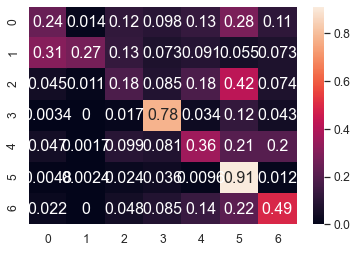

	training epoch=20 .. train_loss=1.102
	validation epoch=20 .. val_loss=1.324
	Accuracy = 50.7 % .. Percision = 50.1 % .. Recall = 46.400000000000006 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_20.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 21 .. loss = 1.018


  0%|                                                                                 | 1/1914 [00:01<37:15,  1.17s/it]

training @ epoch 21 .. loss = 1.229


  0%|                                                                                 | 2/1914 [00:02<38:30,  1.21s/it]

training @ epoch 21 .. loss = 1.123


  0%|▏                                                                                | 3/1914 [00:03<39:06,  1.23s/it]

training @ epoch 21 .. loss = 0.988


  0%|▏                                                                                | 4/1914 [00:04<38:51,  1.22s/it]

training @ epoch 21 .. loss = 0.907


  0%|▏                                                                                | 5/1914 [00:06<39:02,  1.23s/it]

training @ epoch 21 .. loss = 0.844


  0%|▎                                                                                | 6/1914 [00:07<39:12,  1.23s/it]

training @ epoch 21 .. loss = 0.971


  0%|▎                                                                                | 7/1914 [00:08<39:29,  1.24s/it]

training @ epoch 21 .. loss = 1.429


  0%|▎                                                                                | 8/1914 [00:09<39:10,  1.23s/it]

training @ epoch 21 .. loss = 1.453


  0%|▍                                                                                | 9/1914 [00:11<38:50,  1.22s/it]

training @ epoch 21 .. loss = 1.053


  1%|▍                                                                               | 10/1914 [00:12<39:23,  1.24s/it]

training @ epoch 21 .. loss = 0.896


  1%|▍                                                                               | 11/1914 [00:13<39:37,  1.25s/it]

training @ epoch 21 .. loss = 1.109


  1%|▌                                                                               | 12/1914 [00:14<39:32,  1.25s/it]

training @ epoch 21 .. loss = 1.395


  1%|▌                                                                               | 13/1914 [00:16<39:16,  1.24s/it]

training @ epoch 21 .. loss = 1.264


  1%|▌                                                                               | 14/1914 [00:17<39:09,  1.24s/it]

training @ epoch 21 .. loss = 1.447


  1%|▋                                                                               | 15/1914 [00:18<39:24,  1.25s/it]

training @ epoch 21 .. loss = 1.049


  1%|▋                                                                               | 16/1914 [00:19<39:16,  1.24s/it]

training @ epoch 21 .. loss = 1.047


  1%|▋                                                                               | 17/1914 [00:21<38:46,  1.23s/it]

training @ epoch 21 .. loss = 1.049


  1%|▊                                                                               | 18/1914 [00:22<39:11,  1.24s/it]

training @ epoch 21 .. loss = 0.856


  1%|▊                                                                               | 19/1914 [00:23<39:00,  1.23s/it]

training @ epoch 21 .. loss = 0.752


  1%|▊                                                                               | 20/1914 [00:24<39:03,  1.24s/it]

training @ epoch 21 .. loss = 1.059


  1%|▉                                                                               | 21/1914 [00:25<38:36,  1.22s/it]

training @ epoch 21 .. loss = 0.742


  1%|▉                                                                               | 22/1914 [00:27<38:46,  1.23s/it]

training @ epoch 21 .. loss = 1.151


  1%|▉                                                                               | 23/1914 [00:28<39:02,  1.24s/it]

training @ epoch 21 .. loss = 1.025


  1%|█                                                                               | 24/1914 [00:29<39:04,  1.24s/it]

training @ epoch 21 .. loss = 1.01


  1%|█                                                                               | 25/1914 [00:30<38:47,  1.23s/it]

training @ epoch 21 .. loss = 1.229


  1%|█                                                                               | 26/1914 [00:32<38:39,  1.23s/it]

training @ epoch 21 .. loss = 0.764


  1%|█▏                                                                              | 27/1914 [00:33<38:30,  1.22s/it]

training @ epoch 21 .. loss = 1.166


  1%|█▏                                                                              | 28/1914 [00:34<39:02,  1.24s/it]

training @ epoch 21 .. loss = 1.132


  2%|█▏                                                                              | 29/1914 [00:35<38:54,  1.24s/it]

training @ epoch 21 .. loss = 1.216


  2%|█▎                                                                              | 30/1914 [00:37<38:33,  1.23s/it]

training @ epoch 21 .. loss = 0.863


  2%|█▎                                                                              | 31/1914 [00:38<38:45,  1.24s/it]

training @ epoch 21 .. loss = 1.282


  2%|█▎                                                                              | 32/1914 [00:39<39:11,  1.25s/it]

training @ epoch 21 .. loss = 1.43


  2%|█▍                                                                              | 33/1914 [00:40<39:10,  1.25s/it]

training @ epoch 21 .. loss = 1.147


  2%|█▍                                                                              | 34/1914 [00:42<38:43,  1.24s/it]

training @ epoch 21 .. loss = 1.088


  2%|█▍                                                                              | 35/1914 [00:43<38:28,  1.23s/it]

training @ epoch 21 .. loss = 0.68


  2%|█▌                                                                              | 36/1914 [00:44<38:45,  1.24s/it]

training @ epoch 21 .. loss = 0.713


  2%|█▌                                                                              | 37/1914 [00:45<38:41,  1.24s/it]

training @ epoch 21 .. loss = 0.902


  2%|█▌                                                                              | 38/1914 [00:46<38:21,  1.23s/it]

training @ epoch 21 .. loss = 1.248


  2%|█▋                                                                              | 39/1914 [00:48<38:28,  1.23s/it]

training @ epoch 21 .. loss = 1.228


  2%|█▋                                                                              | 40/1914 [00:49<37:54,  1.21s/it]

training @ epoch 21 .. loss = 1.258


  2%|█▋                                                                              | 41/1914 [00:50<38:32,  1.23s/it]

training @ epoch 21 .. loss = 0.935


  2%|█▊                                                                              | 42/1914 [00:51<38:19,  1.23s/it]

training @ epoch 21 .. loss = 1.143


  2%|█▊                                                                              | 43/1914 [00:53<38:05,  1.22s/it]

training @ epoch 21 .. loss = 0.681


  2%|█▊                                                                              | 44/1914 [00:54<38:16,  1.23s/it]

training @ epoch 21 .. loss = 1.129


  2%|█▉                                                                              | 45/1914 [00:55<38:06,  1.22s/it]

training @ epoch 21 .. loss = 0.944


  2%|█▉                                                                              | 46/1914 [00:56<39:17,  1.26s/it]

training @ epoch 21 .. loss = 1.003


  2%|█▉                                                                              | 47/1914 [00:58<40:35,  1.30s/it]

training @ epoch 21 .. loss = 1.091


  3%|██                                                                              | 48/1914 [00:59<40:20,  1.30s/it]

training @ epoch 21 .. loss = 0.859


  3%|██                                                                              | 49/1914 [01:00<40:00,  1.29s/it]

training @ epoch 21 .. loss = 0.769


  3%|██                                                                              | 50/1914 [01:02<39:20,  1.27s/it]

training @ epoch 21 .. loss = 1.091


  3%|██▏                                                                             | 51/1914 [01:03<39:17,  1.27s/it]

training @ epoch 21 .. loss = 1.277


  3%|██▏                                                                             | 52/1914 [01:04<39:09,  1.26s/it]

training @ epoch 21 .. loss = 0.742


  3%|██▏                                                                             | 53/1914 [01:05<39:02,  1.26s/it]

training @ epoch 21 .. loss = 1.045


  3%|██▎                                                                             | 54/1914 [01:07<38:40,  1.25s/it]

training @ epoch 21 .. loss = 1.215


  3%|██▎                                                                             | 55/1914 [01:08<38:46,  1.25s/it]

training @ epoch 21 .. loss = 0.914


  3%|██▎                                                                             | 56/1914 [01:09<38:32,  1.24s/it]

training @ epoch 21 .. loss = 0.786


  3%|██▍                                                                             | 57/1914 [01:10<38:45,  1.25s/it]

training @ epoch 21 .. loss = 1.492


  3%|██▍                                                                             | 58/1914 [01:12<39:05,  1.26s/it]

training @ epoch 21 .. loss = 1.036


  3%|██▍                                                                             | 59/1914 [01:13<38:25,  1.24s/it]

training @ epoch 21 .. loss = 0.994


  3%|██▌                                                                             | 60/1914 [01:14<38:30,  1.25s/it]

training @ epoch 21 .. loss = 1.016


  3%|██▌                                                                             | 61/1914 [01:15<38:22,  1.24s/it]

training @ epoch 21 .. loss = 1.026


  3%|██▌                                                                             | 62/1914 [01:17<37:57,  1.23s/it]

training @ epoch 21 .. loss = 0.994


  3%|██▋                                                                             | 63/1914 [01:18<37:58,  1.23s/it]

training @ epoch 21 .. loss = 0.966


  3%|██▋                                                                             | 64/1914 [01:19<37:50,  1.23s/it]

training @ epoch 21 .. loss = 0.9


  3%|██▋                                                                             | 65/1914 [01:20<38:09,  1.24s/it]

training @ epoch 21 .. loss = 0.982


  3%|██▊                                                                             | 66/1914 [01:21<38:03,  1.24s/it]

training @ epoch 21 .. loss = 1.492


  4%|██▊                                                                             | 67/1914 [01:23<37:50,  1.23s/it]

training @ epoch 21 .. loss = 0.919


  4%|██▊                                                                             | 68/1914 [01:24<38:08,  1.24s/it]

training @ epoch 21 .. loss = 1.073


  4%|██▉                                                                             | 69/1914 [01:25<37:57,  1.23s/it]

training @ epoch 21 .. loss = 1.291


  4%|██▉                                                                             | 70/1914 [01:26<38:06,  1.24s/it]

training @ epoch 21 .. loss = 0.924


  4%|██▉                                                                             | 71/1914 [01:28<37:49,  1.23s/it]

training @ epoch 21 .. loss = 1.35


  4%|███                                                                             | 72/1914 [01:29<37:36,  1.23s/it]

training @ epoch 21 .. loss = 1.019


  4%|███                                                                             | 73/1914 [01:30<37:46,  1.23s/it]

training @ epoch 21 .. loss = 1.465


  4%|███                                                                             | 74/1914 [01:31<37:50,  1.23s/it]

training @ epoch 21 .. loss = 0.836


  4%|███▏                                                                            | 75/1914 [01:33<37:26,  1.22s/it]

training @ epoch 21 .. loss = 1.215


  4%|███▏                                                                            | 76/1914 [01:34<37:54,  1.24s/it]

training @ epoch 21 .. loss = 1.402


  4%|███▏                                                                            | 77/1914 [01:35<37:50,  1.24s/it]

training @ epoch 21 .. loss = 1.256


  4%|███▎                                                                            | 78/1914 [01:36<38:07,  1.25s/it]

training @ epoch 21 .. loss = 1.02


  4%|███▎                                                                            | 79/1914 [01:37<37:48,  1.24s/it]

training @ epoch 21 .. loss = 1.192


  4%|███▎                                                                            | 80/1914 [01:39<37:39,  1.23s/it]

training @ epoch 21 .. loss = 0.856


  4%|███▍                                                                            | 81/1914 [01:40<37:27,  1.23s/it]

training @ epoch 21 .. loss = 1.148


  4%|███▍                                                                            | 82/1914 [01:41<38:12,  1.25s/it]

training @ epoch 21 .. loss = 1.188


  4%|███▍                                                                            | 83/1914 [01:42<37:45,  1.24s/it]

training @ epoch 21 .. loss = 1.261


  4%|███▌                                                                            | 84/1914 [01:44<37:41,  1.24s/it]

training @ epoch 21 .. loss = 0.557


  4%|███▌                                                                            | 85/1914 [01:45<37:54,  1.24s/it]

training @ epoch 21 .. loss = 1.214


  4%|███▌                                                                            | 86/1914 [01:46<38:09,  1.25s/it]

training @ epoch 21 .. loss = 1.05


  5%|███▋                                                                            | 87/1914 [01:47<37:30,  1.23s/it]

training @ epoch 21 .. loss = 1.245


  5%|███▋                                                                            | 88/1914 [01:49<37:12,  1.22s/it]

training @ epoch 21 .. loss = 1.384


  5%|███▋                                                                            | 89/1914 [01:50<37:39,  1.24s/it]

training @ epoch 21 .. loss = 1.083


  5%|███▊                                                                            | 90/1914 [01:51<37:13,  1.22s/it]

training @ epoch 21 .. loss = 1.034


  5%|███▊                                                                            | 91/1914 [01:52<37:25,  1.23s/it]

training @ epoch 21 .. loss = 0.962


  5%|███▊                                                                            | 92/1914 [01:54<37:12,  1.23s/it]

training @ epoch 21 .. loss = 1.107


  5%|███▉                                                                            | 93/1914 [01:55<37:04,  1.22s/it]

training @ epoch 21 .. loss = 0.966


  5%|███▉                                                                            | 94/1914 [01:56<37:38,  1.24s/it]

training @ epoch 21 .. loss = 1.029


  5%|███▉                                                                            | 95/1914 [01:57<37:35,  1.24s/it]

training @ epoch 21 .. loss = 0.652


  5%|████                                                                            | 96/1914 [01:58<37:14,  1.23s/it]

training @ epoch 21 .. loss = 0.965


  5%|████                                                                            | 97/1914 [02:00<37:08,  1.23s/it]

training @ epoch 21 .. loss = 0.629


  5%|████                                                                            | 98/1914 [02:01<37:00,  1.22s/it]

training @ epoch 21 .. loss = 1.205


  5%|████▏                                                                           | 99/1914 [02:02<37:26,  1.24s/it]

training @ epoch 21 .. loss = 1.222


  5%|████▏                                                                          | 100/1914 [02:03<37:06,  1.23s/it]

training @ epoch 21 .. loss = 0.991


  5%|████▏                                                                          | 101/1914 [02:05<36:56,  1.22s/it]

training @ epoch 21 .. loss = 0.851


  5%|████▏                                                                          | 102/1914 [02:06<37:17,  1.23s/it]

training @ epoch 21 .. loss = 0.708


  5%|████▎                                                                          | 103/1914 [02:07<37:12,  1.23s/it]

training @ epoch 21 .. loss = 0.912


  5%|████▎                                                                          | 104/1914 [02:08<37:12,  1.23s/it]

training @ epoch 21 .. loss = 1.277


  5%|████▎                                                                          | 105/1914 [02:10<36:58,  1.23s/it]

training @ epoch 21 .. loss = 0.742


  6%|████▍                                                                          | 106/1914 [02:11<36:54,  1.23s/it]

training @ epoch 21 .. loss = 0.926


  6%|████▍                                                                          | 107/1914 [02:12<37:04,  1.23s/it]

training @ epoch 21 .. loss = 0.595


  6%|████▍                                                                          | 108/1914 [02:13<36:56,  1.23s/it]

training @ epoch 21 .. loss = 0.788


  6%|████▍                                                                          | 109/1914 [02:14<36:42,  1.22s/it]

training @ epoch 21 .. loss = 1.016


  6%|████▌                                                                          | 110/1914 [02:16<36:47,  1.22s/it]

training @ epoch 21 .. loss = 0.744


  6%|████▌                                                                          | 111/1914 [02:17<36:54,  1.23s/it]

training @ epoch 21 .. loss = 1.389


  6%|████▌                                                                          | 112/1914 [02:18<37:27,  1.25s/it]

training @ epoch 21 .. loss = 1.068


  6%|████▋                                                                          | 113/1914 [02:19<37:29,  1.25s/it]

training @ epoch 21 .. loss = 1.006


  6%|████▋                                                                          | 114/1914 [02:21<37:03,  1.24s/it]

training @ epoch 21 .. loss = 0.866


  6%|████▋                                                                          | 115/1914 [02:22<37:01,  1.23s/it]

training @ epoch 21 .. loss = 1.043


  6%|████▊                                                                          | 116/1914 [02:23<37:03,  1.24s/it]

training @ epoch 21 .. loss = 1.088


  6%|████▊                                                                          | 117/1914 [02:24<37:04,  1.24s/it]

training @ epoch 21 .. loss = 1.241


  6%|████▊                                                                          | 118/1914 [02:26<36:59,  1.24s/it]

training @ epoch 21 .. loss = 1.068


  6%|████▉                                                                          | 119/1914 [02:27<39:00,  1.30s/it]

training @ epoch 21 .. loss = 0.764


  6%|████▉                                                                          | 120/1914 [02:28<38:26,  1.29s/it]

training @ epoch 21 .. loss = 1.693


  6%|████▉                                                                          | 121/1914 [02:29<37:45,  1.26s/it]

training @ epoch 21 .. loss = 1.414


  6%|█████                                                                          | 122/1914 [02:31<37:27,  1.25s/it]

training @ epoch 21 .. loss = 0.731


  6%|█████                                                                          | 123/1914 [02:32<37:44,  1.26s/it]

training @ epoch 21 .. loss = 0.667


  6%|█████                                                                          | 124/1914 [02:33<37:45,  1.27s/it]

training @ epoch 21 .. loss = 1.013


  7%|█████▏                                                                         | 125/1914 [02:34<37:15,  1.25s/it]

training @ epoch 21 .. loss = 1.177


  7%|█████▏                                                                         | 126/1914 [02:36<37:11,  1.25s/it]

training @ epoch 21 .. loss = 1.144


  7%|█████▏                                                                         | 127/1914 [02:37<36:54,  1.24s/it]

training @ epoch 21 .. loss = 0.719


  7%|█████▎                                                                         | 128/1914 [02:38<37:31,  1.26s/it]

training @ epoch 21 .. loss = 0.753


  7%|█████▎                                                                         | 129/1914 [02:39<37:09,  1.25s/it]

training @ epoch 21 .. loss = 0.936


  7%|█████▎                                                                         | 130/1914 [02:41<37:10,  1.25s/it]

training @ epoch 21 .. loss = 1.074


  7%|█████▍                                                                         | 131/1914 [02:42<37:21,  1.26s/it]

training @ epoch 21 .. loss = 0.986


  7%|█████▍                                                                         | 132/1914 [02:43<37:17,  1.26s/it]

training @ epoch 21 .. loss = 0.769


  7%|█████▍                                                                         | 133/1914 [02:44<36:52,  1.24s/it]

training @ epoch 21 .. loss = 1.777


  7%|█████▌                                                                         | 134/1914 [02:46<36:45,  1.24s/it]

training @ epoch 21 .. loss = 0.854


  7%|█████▌                                                                         | 135/1914 [02:47<36:25,  1.23s/it]

training @ epoch 21 .. loss = 1.271


  7%|█████▌                                                                         | 136/1914 [02:48<36:42,  1.24s/it]

training @ epoch 21 .. loss = 0.633


  7%|█████▋                                                                         | 137/1914 [02:49<36:32,  1.23s/it]

training @ epoch 21 .. loss = 1.144


  7%|█████▋                                                                         | 138/1914 [02:51<36:25,  1.23s/it]

training @ epoch 21 .. loss = 0.811


  7%|█████▋                                                                         | 139/1914 [02:52<36:51,  1.25s/it]

training @ epoch 21 .. loss = 0.973


  7%|█████▊                                                                         | 140/1914 [02:53<36:43,  1.24s/it]

training @ epoch 21 .. loss = 1.207


  7%|█████▊                                                                         | 141/1914 [02:54<36:42,  1.24s/it]

training @ epoch 21 .. loss = 1.077


  7%|█████▊                                                                         | 142/1914 [02:56<36:45,  1.24s/it]

training @ epoch 21 .. loss = 1.132


  7%|█████▉                                                                         | 143/1914 [02:57<36:27,  1.24s/it]

training @ epoch 21 .. loss = 1.102


  8%|█████▉                                                                         | 144/1914 [02:58<36:30,  1.24s/it]

training @ epoch 21 .. loss = 0.655


  8%|█████▉                                                                         | 145/1914 [02:59<36:20,  1.23s/it]

training @ epoch 21 .. loss = 1.128


  8%|██████                                                                         | 146/1914 [03:01<36:02,  1.22s/it]

training @ epoch 21 .. loss = 0.805


  8%|██████                                                                         | 147/1914 [03:02<36:18,  1.23s/it]

training @ epoch 21 .. loss = 1.542


  8%|██████                                                                         | 148/1914 [03:03<36:11,  1.23s/it]

training @ epoch 21 .. loss = 0.562


  8%|██████▏                                                                        | 149/1914 [03:04<36:38,  1.25s/it]

training @ epoch 21 .. loss = 1.393


  8%|██████▏                                                                        | 150/1914 [03:05<36:25,  1.24s/it]

training @ epoch 21 .. loss = 1.011


  8%|██████▏                                                                        | 151/1914 [03:07<36:31,  1.24s/it]

training @ epoch 21 .. loss = 0.981


  8%|██████▎                                                                        | 152/1914 [03:08<37:02,  1.26s/it]

training @ epoch 21 .. loss = 0.943


  8%|██████▎                                                                        | 153/1914 [03:09<36:45,  1.25s/it]

training @ epoch 21 .. loss = 0.779


  8%|██████▎                                                                        | 154/1914 [03:11<36:48,  1.25s/it]

training @ epoch 21 .. loss = 0.734


  8%|██████▍                                                                        | 155/1914 [03:12<36:44,  1.25s/it]

training @ epoch 21 .. loss = 0.958


  8%|██████▍                                                                        | 156/1914 [03:13<36:22,  1.24s/it]

training @ epoch 21 .. loss = 0.918


  8%|██████▍                                                                        | 157/1914 [03:14<36:27,  1.25s/it]

training @ epoch 21 .. loss = 1.325


  8%|██████▌                                                                        | 158/1914 [03:15<36:08,  1.23s/it]

training @ epoch 21 .. loss = 1.633


  8%|██████▌                                                                        | 159/1914 [03:17<35:54,  1.23s/it]

training @ epoch 21 .. loss = 1.228


  8%|██████▌                                                                        | 160/1914 [03:18<35:55,  1.23s/it]

training @ epoch 21 .. loss = 1.222


  8%|██████▋                                                                        | 161/1914 [03:19<35:51,  1.23s/it]

training @ epoch 21 .. loss = 1.05


  8%|██████▋                                                                        | 162/1914 [03:20<36:08,  1.24s/it]

training @ epoch 21 .. loss = 0.9


  9%|██████▋                                                                        | 163/1914 [03:22<35:43,  1.22s/it]

training @ epoch 21 .. loss = 1.261


  9%|██████▊                                                                        | 164/1914 [03:23<35:40,  1.22s/it]

training @ epoch 21 .. loss = 1.454


  9%|██████▊                                                                        | 165/1914 [03:24<36:05,  1.24s/it]

training @ epoch 21 .. loss = 0.864


  9%|██████▊                                                                        | 166/1914 [03:25<35:54,  1.23s/it]

training @ epoch 21 .. loss = 0.75


  9%|██████▉                                                                        | 167/1914 [03:27<35:48,  1.23s/it]

training @ epoch 21 .. loss = 1.102


  9%|██████▉                                                                        | 168/1914 [03:28<36:00,  1.24s/it]

training @ epoch 21 .. loss = 0.949


  9%|██████▉                                                                        | 169/1914 [03:29<35:51,  1.23s/it]

training @ epoch 21 .. loss = 0.996


  9%|███████                                                                        | 170/1914 [03:30<36:04,  1.24s/it]

training @ epoch 21 .. loss = 1.125


  9%|███████                                                                        | 171/1914 [03:31<35:53,  1.24s/it]

training @ epoch 21 .. loss = 1.202


  9%|███████                                                                        | 172/1914 [03:33<36:02,  1.24s/it]

training @ epoch 21 .. loss = 1.346


  9%|███████▏                                                                       | 173/1914 [03:34<36:16,  1.25s/it]

training @ epoch 21 .. loss = 1.087


  9%|███████▏                                                                       | 174/1914 [03:35<36:11,  1.25s/it]

training @ epoch 21 .. loss = 1.471


  9%|███████▏                                                                       | 175/1914 [03:36<36:07,  1.25s/it]

training @ epoch 21 .. loss = 1.255


  9%|███████▎                                                                       | 176/1914 [03:38<36:04,  1.25s/it]

training @ epoch 21 .. loss = 1.176


  9%|███████▎                                                                       | 177/1914 [03:39<35:34,  1.23s/it]

training @ epoch 21 .. loss = 0.706


  9%|███████▎                                                                       | 178/1914 [03:40<35:56,  1.24s/it]

training @ epoch 21 .. loss = 1.093


  9%|███████▍                                                                       | 179/1914 [03:41<35:45,  1.24s/it]

training @ epoch 21 .. loss = 1.057


  9%|███████▍                                                                       | 180/1914 [03:43<35:46,  1.24s/it]

training @ epoch 21 .. loss = 0.97


  9%|███████▍                                                                       | 181/1914 [03:44<36:08,  1.25s/it]

training @ epoch 21 .. loss = 1.254


 10%|███████▌                                                                       | 182/1914 [03:45<36:08,  1.25s/it]

training @ epoch 21 .. loss = 1.665


 10%|███████▌                                                                       | 183/1914 [03:46<35:40,  1.24s/it]

training @ epoch 21 .. loss = 0.834


 10%|███████▌                                                                       | 184/1914 [03:48<35:58,  1.25s/it]

training @ epoch 21 .. loss = 1.56


 10%|███████▋                                                                       | 185/1914 [03:49<35:33,  1.23s/it]

training @ epoch 21 .. loss = 0.738


 10%|███████▋                                                                       | 186/1914 [03:50<35:51,  1.24s/it]

training @ epoch 21 .. loss = 1.121


 10%|███████▋                                                                       | 187/1914 [03:51<35:28,  1.23s/it]

training @ epoch 21 .. loss = 1.613


 10%|███████▊                                                                       | 188/1914 [03:53<35:36,  1.24s/it]

training @ epoch 21 .. loss = 1.129


 10%|███████▊                                                                       | 189/1914 [03:54<35:33,  1.24s/it]

training @ epoch 21 .. loss = 0.959


 10%|███████▊                                                                       | 190/1914 [03:55<35:50,  1.25s/it]

training @ epoch 21 .. loss = 1.481


 10%|███████▉                                                                       | 191/1914 [03:56<35:41,  1.24s/it]

training @ epoch 21 .. loss = 0.755


 10%|███████▉                                                                       | 192/1914 [03:58<36:39,  1.28s/it]

training @ epoch 21 .. loss = 1.018


 10%|███████▉                                                                       | 193/1914 [03:59<37:48,  1.32s/it]

training @ epoch 21 .. loss = 0.85


 10%|████████                                                                       | 194/1914 [04:01<38:28,  1.34s/it]

training @ epoch 21 .. loss = 0.909


 10%|████████                                                                       | 195/1914 [04:02<39:18,  1.37s/it]

training @ epoch 21 .. loss = 1.214


 10%|████████                                                                       | 196/1914 [04:03<39:50,  1.39s/it]

training @ epoch 21 .. loss = 1.341


 10%|████████▏                                                                      | 197/1914 [04:05<39:53,  1.39s/it]

training @ epoch 21 .. loss = 1.028


 10%|████████▏                                                                      | 198/1914 [04:06<39:38,  1.39s/it]

training @ epoch 21 .. loss = 0.999


 10%|████████▏                                                                      | 199/1914 [04:08<39:25,  1.38s/it]

training @ epoch 21 .. loss = 1.012


 10%|████████▎                                                                      | 200/1914 [04:09<38:54,  1.36s/it]

training @ epoch 21 .. loss = 0.904


 11%|████████▎                                                                      | 201/1914 [04:10<38:50,  1.36s/it]

training @ epoch 21 .. loss = 1.048


 11%|████████▎                                                                      | 202/1914 [04:12<38:45,  1.36s/it]

training @ epoch 21 .. loss = 0.994


 11%|████████▍                                                                      | 203/1914 [04:13<38:47,  1.36s/it]

training @ epoch 21 .. loss = 0.845


 11%|████████▍                                                                      | 204/1914 [04:14<38:48,  1.36s/it]

training @ epoch 21 .. loss = 1.275


 11%|████████▍                                                                      | 205/1914 [04:16<38:28,  1.35s/it]

training @ epoch 21 .. loss = 1.44


 11%|████████▌                                                                      | 206/1914 [04:17<39:06,  1.37s/it]

training @ epoch 21 .. loss = 1.189


 11%|████████▌                                                                      | 207/1914 [04:18<39:28,  1.39s/it]

training @ epoch 21 .. loss = 0.876


 11%|████████▌                                                                      | 208/1914 [04:20<38:42,  1.36s/it]

training @ epoch 21 .. loss = 1.353


 11%|████████▋                                                                      | 209/1914 [04:21<37:34,  1.32s/it]

training @ epoch 21 .. loss = 1.35


 11%|████████▋                                                                      | 210/1914 [04:22<36:58,  1.30s/it]

training @ epoch 21 .. loss = 0.902


 11%|████████▋                                                                      | 211/1914 [04:23<36:16,  1.28s/it]

training @ epoch 21 .. loss = 0.558


 11%|████████▊                                                                      | 212/1914 [04:25<35:51,  1.26s/it]

training @ epoch 21 .. loss = 0.657


 11%|████████▊                                                                      | 213/1914 [04:26<36:00,  1.27s/it]

training @ epoch 21 .. loss = 0.808


 11%|████████▊                                                                      | 214/1914 [04:27<36:04,  1.27s/it]

training @ epoch 21 .. loss = 1.125


 11%|████████▊                                                                      | 215/1914 [04:28<35:16,  1.25s/it]

training @ epoch 21 .. loss = 1.231


 11%|████████▉                                                                      | 216/1914 [04:30<35:13,  1.24s/it]

training @ epoch 21 .. loss = 1.184


 11%|████████▉                                                                      | 217/1914 [04:31<34:51,  1.23s/it]

training @ epoch 21 .. loss = 1.214


 11%|████████▉                                                                      | 218/1914 [04:32<35:05,  1.24s/it]

training @ epoch 21 .. loss = 0.727


 11%|█████████                                                                      | 219/1914 [04:33<35:09,  1.24s/it]

training @ epoch 21 .. loss = 1.014


 11%|█████████                                                                      | 220/1914 [04:35<35:23,  1.25s/it]

training @ epoch 21 .. loss = 0.946


 12%|█████████                                                                      | 221/1914 [04:36<35:26,  1.26s/it]

training @ epoch 21 .. loss = 1.058


 12%|█████████▏                                                                     | 222/1914 [04:37<35:22,  1.25s/it]

training @ epoch 21 .. loss = 1.154


 12%|█████████▏                                                                     | 223/1914 [04:38<35:11,  1.25s/it]

training @ epoch 21 .. loss = 1.231


 12%|█████████▏                                                                     | 224/1914 [04:40<34:51,  1.24s/it]

training @ epoch 21 .. loss = 1.341


 12%|█████████▎                                                                     | 225/1914 [04:41<34:46,  1.24s/it]

training @ epoch 21 .. loss = 0.741


 12%|█████████▎                                                                     | 226/1914 [04:42<34:53,  1.24s/it]

training @ epoch 21 .. loss = 1.375


 12%|█████████▎                                                                     | 227/1914 [04:43<34:58,  1.24s/it]

training @ epoch 21 .. loss = 0.94


 12%|█████████▍                                                                     | 228/1914 [04:45<34:45,  1.24s/it]

training @ epoch 21 .. loss = 1.151


 12%|█████████▍                                                                     | 229/1914 [04:46<34:52,  1.24s/it]

training @ epoch 21 .. loss = 1.314


 12%|█████████▍                                                                     | 230/1914 [04:47<34:24,  1.23s/it]

training @ epoch 21 .. loss = 1.207


 12%|█████████▌                                                                     | 231/1914 [04:48<34:45,  1.24s/it]

training @ epoch 21 .. loss = 0.854


 12%|█████████▌                                                                     | 232/1914 [04:49<34:16,  1.22s/it]

training @ epoch 21 .. loss = 0.653


 12%|█████████▌                                                                     | 233/1914 [04:51<34:10,  1.22s/it]

training @ epoch 21 .. loss = 1.087


 12%|█████████▋                                                                     | 234/1914 [04:52<34:24,  1.23s/it]

training @ epoch 21 .. loss = 0.634


 12%|█████████▋                                                                     | 235/1914 [04:53<34:35,  1.24s/it]

training @ epoch 21 .. loss = 1.815


 12%|█████████▋                                                                     | 236/1914 [04:54<34:23,  1.23s/it]

training @ epoch 21 .. loss = 0.794


 12%|█████████▊                                                                     | 237/1914 [04:56<34:28,  1.23s/it]

training @ epoch 21 .. loss = 1.123


 12%|█████████▊                                                                     | 238/1914 [04:57<34:31,  1.24s/it]

training @ epoch 21 .. loss = 1.642


 12%|█████████▊                                                                     | 239/1914 [04:58<34:49,  1.25s/it]

training @ epoch 21 .. loss = 1.258


 13%|█████████▉                                                                     | 240/1914 [04:59<34:34,  1.24s/it]

training @ epoch 21 .. loss = 1.054


 13%|█████████▉                                                                     | 241/1914 [05:01<34:29,  1.24s/it]

training @ epoch 21 .. loss = 1.552


 13%|█████████▉                                                                     | 242/1914 [05:02<34:30,  1.24s/it]

training @ epoch 21 .. loss = 1.524


 13%|██████████                                                                     | 243/1914 [05:03<34:36,  1.24s/it]

training @ epoch 21 .. loss = 1.152


 13%|██████████                                                                     | 244/1914 [05:04<34:45,  1.25s/it]

training @ epoch 21 .. loss = 1.16


 13%|██████████                                                                     | 245/1914 [05:06<34:30,  1.24s/it]

training @ epoch 21 .. loss = 1.066


 13%|██████████▏                                                                    | 246/1914 [05:07<34:10,  1.23s/it]

training @ epoch 21 .. loss = 0.671


 13%|██████████▏                                                                    | 247/1914 [05:08<34:39,  1.25s/it]

training @ epoch 21 .. loss = 1.343


 13%|██████████▏                                                                    | 248/1914 [05:09<34:26,  1.24s/it]

training @ epoch 21 .. loss = 0.623


 13%|██████████▎                                                                    | 249/1914 [05:11<34:20,  1.24s/it]

training @ epoch 21 .. loss = 1.408


 13%|██████████▎                                                                    | 250/1914 [05:12<34:23,  1.24s/it]

training @ epoch 21 .. loss = 1.533


 13%|██████████▎                                                                    | 251/1914 [05:13<33:57,  1.22s/it]

training @ epoch 21 .. loss = 1.104


 13%|██████████▍                                                                    | 252/1914 [05:14<34:24,  1.24s/it]

training @ epoch 21 .. loss = 1.365


 13%|██████████▍                                                                    | 253/1914 [05:16<34:43,  1.25s/it]

training @ epoch 21 .. loss = 1.156


 13%|██████████▍                                                                    | 254/1914 [05:17<34:41,  1.25s/it]

training @ epoch 21 .. loss = 0.871


 13%|██████████▌                                                                    | 255/1914 [05:18<34:34,  1.25s/it]

training @ epoch 21 .. loss = 1.101


 13%|██████████▌                                                                    | 256/1914 [05:19<34:29,  1.25s/it]

training @ epoch 21 .. loss = 1.379


 13%|██████████▌                                                                    | 257/1914 [05:21<34:16,  1.24s/it]

training @ epoch 21 .. loss = 1.168


 13%|██████████▋                                                                    | 258/1914 [05:22<34:31,  1.25s/it]

training @ epoch 21 .. loss = 1.207


 14%|██████████▋                                                                    | 259/1914 [05:23<34:15,  1.24s/it]

training @ epoch 21 .. loss = 1.251


 14%|██████████▋                                                                    | 260/1914 [05:24<34:33,  1.25s/it]

training @ epoch 21 .. loss = 0.982


 14%|██████████▊                                                                    | 261/1914 [05:26<34:27,  1.25s/it]

training @ epoch 21 .. loss = 0.929


 14%|██████████▊                                                                    | 262/1914 [05:27<34:32,  1.25s/it]

training @ epoch 21 .. loss = 1.214


 14%|██████████▊                                                                    | 263/1914 [05:28<34:15,  1.24s/it]

training @ epoch 21 .. loss = 1.219


 14%|██████████▉                                                                    | 264/1914 [05:29<34:07,  1.24s/it]

training @ epoch 21 .. loss = 1.002


 14%|██████████▉                                                                    | 265/1914 [05:30<33:57,  1.24s/it]

training @ epoch 21 .. loss = 0.872


 14%|██████████▉                                                                    | 266/1914 [05:32<33:57,  1.24s/it]

training @ epoch 21 .. loss = 1.199


 14%|███████████                                                                    | 267/1914 [05:33<33:49,  1.23s/it]

training @ epoch 21 .. loss = 1.318


 14%|███████████                                                                    | 268/1914 [05:34<34:19,  1.25s/it]

training @ epoch 21 .. loss = 1.288


 14%|███████████                                                                    | 269/1914 [05:35<34:10,  1.25s/it]

training @ epoch 21 .. loss = 1.136


 14%|███████████▏                                                                   | 270/1914 [05:37<33:54,  1.24s/it]

training @ epoch 21 .. loss = 1.328


 14%|███████████▏                                                                   | 271/1914 [05:38<34:06,  1.25s/it]

training @ epoch 21 .. loss = 1.119


 14%|███████████▏                                                                   | 272/1914 [05:39<34:04,  1.24s/it]

training @ epoch 21 .. loss = 0.724


 14%|███████████▎                                                                   | 273/1914 [05:40<33:34,  1.23s/it]

training @ epoch 21 .. loss = 0.67


 14%|███████████▎                                                                   | 274/1914 [05:42<33:41,  1.23s/it]

training @ epoch 21 .. loss = 1.443


 14%|███████████▎                                                                   | 275/1914 [05:43<33:19,  1.22s/it]

training @ epoch 21 .. loss = 1.101


 14%|███████████▍                                                                   | 276/1914 [05:44<33:44,  1.24s/it]

training @ epoch 21 .. loss = 0.899


 14%|███████████▍                                                                   | 277/1914 [05:45<34:10,  1.25s/it]

training @ epoch 21 .. loss = 1.002


 15%|███████████▍                                                                   | 278/1914 [05:47<33:56,  1.24s/it]

training @ epoch 21 .. loss = 1.377


 15%|███████████▌                                                                   | 279/1914 [05:48<35:21,  1.30s/it]

training @ epoch 21 .. loss = 1.204


 15%|███████████▌                                                                   | 280/1914 [05:49<35:27,  1.30s/it]

training @ epoch 21 .. loss = 1.537


 15%|███████████▌                                                                   | 281/1914 [05:51<35:40,  1.31s/it]

training @ epoch 21 .. loss = 1.011


 15%|███████████▋                                                                   | 282/1914 [05:52<35:21,  1.30s/it]

training @ epoch 21 .. loss = 1.495


 15%|███████████▋                                                                   | 283/1914 [05:53<34:41,  1.28s/it]

training @ epoch 21 .. loss = 0.888


 15%|███████████▋                                                                   | 284/1914 [05:54<34:07,  1.26s/it]

training @ epoch 21 .. loss = 1.122


 15%|███████████▊                                                                   | 285/1914 [05:56<34:00,  1.25s/it]

training @ epoch 21 .. loss = 1.332


 15%|███████████▊                                                                   | 286/1914 [05:57<33:40,  1.24s/it]

training @ epoch 21 .. loss = 1.311


 15%|███████████▊                                                                   | 287/1914 [05:58<33:39,  1.24s/it]

training @ epoch 21 .. loss = 1.148


 15%|███████████▉                                                                   | 288/1914 [05:59<33:33,  1.24s/it]

training @ epoch 21 .. loss = 1.35


 15%|███████████▉                                                                   | 289/1914 [06:01<33:19,  1.23s/it]

training @ epoch 21 .. loss = 1.075


 15%|███████████▉                                                                   | 290/1914 [06:02<33:43,  1.25s/it]

training @ epoch 21 .. loss = 0.942


 15%|████████████                                                                   | 291/1914 [06:03<33:31,  1.24s/it]

training @ epoch 21 .. loss = 1.375


 15%|████████████                                                                   | 292/1914 [06:04<33:50,  1.25s/it]

training @ epoch 21 .. loss = 0.97


 15%|████████████                                                                   | 293/1914 [06:06<33:39,  1.25s/it]

training @ epoch 21 .. loss = 1.228


 15%|████████████▏                                                                  | 294/1914 [06:07<33:25,  1.24s/it]

training @ epoch 21 .. loss = 0.586


 15%|████████████▏                                                                  | 295/1914 [06:08<33:36,  1.25s/it]

training @ epoch 21 .. loss = 1.276


 15%|████████████▏                                                                  | 296/1914 [06:09<33:28,  1.24s/it]

training @ epoch 21 .. loss = 0.936


 16%|████████████▎                                                                  | 297/1914 [06:10<33:13,  1.23s/it]

training @ epoch 21 .. loss = 0.732


 16%|████████████▎                                                                  | 298/1914 [06:12<33:32,  1.25s/it]

training @ epoch 21 .. loss = 0.923


 16%|████████████▎                                                                  | 299/1914 [06:13<33:21,  1.24s/it]

training @ epoch 21 .. loss = 0.993


 16%|████████████▍                                                                  | 300/1914 [06:14<33:28,  1.24s/it]

training @ epoch 21 .. loss = 0.765


 16%|████████████▍                                                                  | 301/1914 [06:15<33:15,  1.24s/it]

training @ epoch 21 .. loss = 1.618


 16%|████████████▍                                                                  | 302/1914 [06:17<33:13,  1.24s/it]

training @ epoch 21 .. loss = 1.126


 16%|████████████▌                                                                  | 303/1914 [06:18<33:15,  1.24s/it]

training @ epoch 21 .. loss = 0.933


 16%|████████████▌                                                                  | 304/1914 [06:19<33:16,  1.24s/it]

training @ epoch 21 .. loss = 1.432


 16%|████████████▌                                                                  | 305/1914 [06:20<33:06,  1.23s/it]

training @ epoch 21 .. loss = 1.222


 16%|████████████▋                                                                  | 306/1914 [06:22<33:18,  1.24s/it]

training @ epoch 21 .. loss = 0.961


 16%|████████████▋                                                                  | 307/1914 [06:23<34:00,  1.27s/it]

training @ epoch 21 .. loss = 1.0


 16%|████████████▋                                                                  | 308/1914 [06:24<34:40,  1.30s/it]

training @ epoch 21 .. loss = 0.896


 16%|████████████▊                                                                  | 309/1914 [06:26<36:04,  1.35s/it]

training @ epoch 21 .. loss = 1.024


 16%|████████████▊                                                                  | 310/1914 [06:27<35:52,  1.34s/it]

training @ epoch 21 .. loss = 0.91


 16%|████████████▊                                                                  | 311/1914 [06:28<35:42,  1.34s/it]

training @ epoch 21 .. loss = 0.787


 16%|████████████▉                                                                  | 312/1914 [06:30<35:59,  1.35s/it]

training @ epoch 21 .. loss = 1.366


 16%|████████████▉                                                                  | 313/1914 [06:31<35:16,  1.32s/it]

training @ epoch 21 .. loss = 1.408


 16%|████████████▉                                                                  | 314/1914 [06:32<34:31,  1.29s/it]

training @ epoch 21 .. loss = 0.924


 16%|█████████████                                                                  | 315/1914 [06:34<34:10,  1.28s/it]

training @ epoch 21 .. loss = 1.147


 17%|█████████████                                                                  | 316/1914 [06:35<33:53,  1.27s/it]

training @ epoch 21 .. loss = 0.923


 17%|█████████████                                                                  | 317/1914 [06:36<33:33,  1.26s/it]

training @ epoch 21 .. loss = 1.179


 17%|█████████████▏                                                                 | 318/1914 [06:37<33:24,  1.26s/it]

training @ epoch 21 .. loss = 1.138


 17%|█████████████▏                                                                 | 319/1914 [06:39<32:56,  1.24s/it]

training @ epoch 21 .. loss = 1.568


 17%|█████████████▏                                                                 | 320/1914 [06:40<32:53,  1.24s/it]

training @ epoch 21 .. loss = 1.035


 17%|█████████████▏                                                                 | 321/1914 [06:41<32:44,  1.23s/it]

training @ epoch 21 .. loss = 0.894


 17%|█████████████▎                                                                 | 322/1914 [06:42<33:06,  1.25s/it]

training @ epoch 21 .. loss = 0.837


 17%|█████████████▎                                                                 | 323/1914 [06:43<32:49,  1.24s/it]

training @ epoch 21 .. loss = 1.033


 17%|█████████████▎                                                                 | 324/1914 [06:45<32:50,  1.24s/it]

training @ epoch 21 .. loss = 1.292


 17%|█████████████▍                                                                 | 325/1914 [06:46<33:14,  1.26s/it]

training @ epoch 21 .. loss = 1.474


 17%|█████████████▍                                                                 | 326/1914 [06:47<33:02,  1.25s/it]

training @ epoch 21 .. loss = 1.281


 17%|█████████████▍                                                                 | 327/1914 [06:48<32:44,  1.24s/it]

training @ epoch 21 .. loss = 1.047


 17%|█████████████▌                                                                 | 328/1914 [06:50<32:53,  1.24s/it]

training @ epoch 21 .. loss = 0.934


 17%|█████████████▌                                                                 | 329/1914 [06:51<32:38,  1.24s/it]

training @ epoch 21 .. loss = 0.946


 17%|█████████████▌                                                                 | 330/1914 [06:52<32:59,  1.25s/it]

training @ epoch 21 .. loss = 0.967


 17%|█████████████▋                                                                 | 331/1914 [06:53<32:36,  1.24s/it]

training @ epoch 21 .. loss = 1.222


 17%|█████████████▋                                                                 | 332/1914 [06:55<32:46,  1.24s/it]

training @ epoch 21 .. loss = 0.883


 17%|█████████████▋                                                                 | 333/1914 [06:56<32:45,  1.24s/it]

training @ epoch 21 .. loss = 1.492


 17%|█████████████▊                                                                 | 334/1914 [06:57<32:57,  1.25s/it]

training @ epoch 21 .. loss = 0.699


 18%|█████████████▊                                                                 | 335/1914 [06:58<32:43,  1.24s/it]

training @ epoch 21 .. loss = 1.129


 18%|█████████████▊                                                                 | 336/1914 [07:00<32:40,  1.24s/it]

training @ epoch 21 .. loss = 0.992


 18%|█████████████▉                                                                 | 337/1914 [07:01<32:30,  1.24s/it]

training @ epoch 21 .. loss = 1.091


 18%|█████████████▉                                                                 | 338/1914 [07:02<32:36,  1.24s/it]

training @ epoch 21 .. loss = 1.38


 18%|█████████████▉                                                                 | 339/1914 [07:03<32:58,  1.26s/it]

training @ epoch 21 .. loss = 0.9


 18%|██████████████                                                                 | 340/1914 [07:05<32:27,  1.24s/it]

training @ epoch 21 .. loss = 1.418


 18%|██████████████                                                                 | 341/1914 [07:06<32:51,  1.25s/it]

training @ epoch 21 .. loss = 1.566


 18%|██████████████                                                                 | 342/1914 [07:07<32:45,  1.25s/it]

training @ epoch 21 .. loss = 1.076


 18%|██████████████▏                                                                | 343/1914 [07:08<32:55,  1.26s/it]

training @ epoch 21 .. loss = 0.815


 18%|██████████████▏                                                                | 344/1914 [07:10<33:05,  1.26s/it]

training @ epoch 21 .. loss = 1.027


 18%|██████████████▏                                                                | 345/1914 [07:11<32:39,  1.25s/it]

training @ epoch 21 .. loss = 0.894


 18%|██████████████▎                                                                | 346/1914 [07:12<32:39,  1.25s/it]

training @ epoch 21 .. loss = 0.766


 18%|██████████████▎                                                                | 347/1914 [07:13<32:20,  1.24s/it]

training @ epoch 21 .. loss = 1.412


 18%|██████████████▎                                                                | 348/1914 [07:15<32:14,  1.24s/it]

training @ epoch 21 .. loss = 1.106


 18%|██████████████▍                                                                | 349/1914 [07:16<32:21,  1.24s/it]

training @ epoch 21 .. loss = 0.564


 18%|██████████████▍                                                                | 350/1914 [07:17<32:30,  1.25s/it]

training @ epoch 21 .. loss = 1.082


 18%|██████████████▍                                                                | 351/1914 [07:18<32:32,  1.25s/it]

training @ epoch 21 .. loss = 1.067


 18%|██████████████▌                                                                | 352/1914 [07:20<32:32,  1.25s/it]

training @ epoch 21 .. loss = 1.209


 18%|██████████████▌                                                                | 353/1914 [07:21<32:18,  1.24s/it]

training @ epoch 21 .. loss = 1.294


 18%|██████████████▌                                                                | 354/1914 [07:22<32:36,  1.25s/it]

training @ epoch 21 .. loss = 1.248


 19%|██████████████▋                                                                | 355/1914 [07:24<33:59,  1.31s/it]

training @ epoch 21 .. loss = 1.284


 19%|██████████████▋                                                                | 356/1914 [07:25<34:38,  1.33s/it]

training @ epoch 21 .. loss = 1.531


 19%|██████████████▋                                                                | 357/1914 [07:26<34:36,  1.33s/it]

training @ epoch 21 .. loss = 1.268


 19%|██████████████▊                                                                | 358/1914 [07:28<33:48,  1.30s/it]

training @ epoch 21 .. loss = 1.018


 19%|██████████████▊                                                                | 359/1914 [07:29<33:09,  1.28s/it]

training @ epoch 21 .. loss = 1.252


 19%|██████████████▊                                                                | 360/1914 [07:30<32:55,  1.27s/it]

training @ epoch 21 .. loss = 1.368


 19%|██████████████▉                                                                | 361/1914 [07:31<32:50,  1.27s/it]

training @ epoch 21 .. loss = 0.792


 19%|██████████████▉                                                                | 362/1914 [07:32<32:27,  1.25s/it]

training @ epoch 21 .. loss = 1.008


 19%|██████████████▉                                                                | 363/1914 [07:34<32:29,  1.26s/it]

training @ epoch 21 .. loss = 0.814


 19%|███████████████                                                                | 364/1914 [07:35<32:26,  1.26s/it]

training @ epoch 21 .. loss = 1.488


 19%|███████████████                                                                | 365/1914 [07:36<32:23,  1.25s/it]

training @ epoch 21 .. loss = 1.262


 19%|███████████████                                                                | 366/1914 [07:37<32:20,  1.25s/it]

training @ epoch 21 .. loss = 1.425


 19%|███████████████▏                                                               | 367/1914 [07:39<31:58,  1.24s/it]

training @ epoch 21 .. loss = 1.221


 19%|███████████████▏                                                               | 368/1914 [07:40<31:55,  1.24s/it]

training @ epoch 21 .. loss = 1.314


 19%|███████████████▏                                                               | 369/1914 [07:41<31:56,  1.24s/it]

training @ epoch 21 .. loss = 0.756


 19%|███████████████▎                                                               | 370/1914 [07:42<31:36,  1.23s/it]

training @ epoch 21 .. loss = 1.1


 19%|███████████████▎                                                               | 371/1914 [07:44<31:56,  1.24s/it]

training @ epoch 21 .. loss = 0.546


 19%|███████████████▎                                                               | 372/1914 [07:45<31:51,  1.24s/it]

training @ epoch 21 .. loss = 1.959


 19%|███████████████▍                                                               | 373/1914 [07:46<32:05,  1.25s/it]

training @ epoch 21 .. loss = 1.032


 20%|███████████████▍                                                               | 374/1914 [07:47<31:55,  1.24s/it]

training @ epoch 21 .. loss = 1.117


 20%|███████████████▍                                                               | 375/1914 [07:49<31:33,  1.23s/it]

training @ epoch 21 .. loss = 1.105


 20%|███████████████▌                                                               | 376/1914 [07:50<31:41,  1.24s/it]

training @ epoch 21 .. loss = 0.929


 20%|███████████████▌                                                               | 377/1914 [07:51<31:24,  1.23s/it]

training @ epoch 21 .. loss = 1.349


 20%|███████████████▌                                                               | 378/1914 [07:52<31:38,  1.24s/it]

training @ epoch 21 .. loss = 1.225


 20%|███████████████▋                                                               | 379/1914 [07:54<31:32,  1.23s/it]

training @ epoch 21 .. loss = 0.972


 20%|███████████████▋                                                               | 380/1914 [07:55<31:21,  1.23s/it]

training @ epoch 21 .. loss = 1.482


 20%|███████████████▋                                                               | 381/1914 [07:56<31:31,  1.23s/it]

training @ epoch 21 .. loss = 0.966


 20%|███████████████▊                                                               | 382/1914 [07:57<31:39,  1.24s/it]

training @ epoch 21 .. loss = 0.886


 20%|███████████████▊                                                               | 383/1914 [07:58<31:21,  1.23s/it]

training @ epoch 21 .. loss = 1.059


 20%|███████████████▊                                                               | 384/1914 [08:00<31:26,  1.23s/it]

training @ epoch 21 .. loss = 1.292


 20%|███████████████▉                                                               | 385/1914 [08:01<31:37,  1.24s/it]

training @ epoch 21 .. loss = 0.895


 20%|███████████████▉                                                               | 386/1914 [08:02<31:38,  1.24s/it]

training @ epoch 21 .. loss = 1.237


 20%|███████████████▉                                                               | 387/1914 [08:03<31:22,  1.23s/it]

training @ epoch 21 .. loss = 0.997


 20%|████████████████                                                               | 388/1914 [08:05<31:16,  1.23s/it]

training @ epoch 21 .. loss = 0.92


 20%|████████████████                                                               | 389/1914 [08:06<31:39,  1.25s/it]

training @ epoch 21 .. loss = 1.654


 20%|████████████████                                                               | 390/1914 [08:07<31:32,  1.24s/it]

training @ epoch 21 .. loss = 1.006


 20%|████████████████▏                                                              | 391/1914 [08:08<31:26,  1.24s/it]

training @ epoch 21 .. loss = 1.164


 20%|████████████████▏                                                              | 392/1914 [08:10<31:20,  1.24s/it]

training @ epoch 21 .. loss = 1.21


 21%|████████████████▏                                                              | 393/1914 [08:11<31:18,  1.24s/it]

training @ epoch 21 .. loss = 1.126


 21%|████████████████▎                                                              | 394/1914 [08:12<31:34,  1.25s/it]

training @ epoch 21 .. loss = 1.102


 21%|████████████████▎                                                              | 395/1914 [08:13<31:13,  1.23s/it]

training @ epoch 21 .. loss = 1.673


 21%|████████████████▎                                                              | 396/1914 [08:15<31:07,  1.23s/it]

training @ epoch 21 .. loss = 1.156


 21%|████████████████▍                                                              | 397/1914 [08:16<31:21,  1.24s/it]

training @ epoch 21 .. loss = 1.149


 21%|████████████████▍                                                              | 398/1914 [08:17<31:16,  1.24s/it]

training @ epoch 21 .. loss = 1.015


 21%|████████████████▍                                                              | 399/1914 [08:18<31:26,  1.25s/it]

training @ epoch 21 .. loss = 1.742


 21%|████████████████▌                                                              | 400/1914 [08:20<31:18,  1.24s/it]

training @ epoch 21 .. loss = 1.215


 21%|████████████████▌                                                              | 401/1914 [08:21<31:10,  1.24s/it]

training @ epoch 21 .. loss = 1.133


 21%|████████████████▌                                                              | 402/1914 [08:22<31:07,  1.24s/it]

training @ epoch 21 .. loss = 1.087


 21%|████████████████▋                                                              | 403/1914 [08:23<31:13,  1.24s/it]

training @ epoch 21 .. loss = 1.001


 21%|████████████████▋                                                              | 404/1914 [08:24<30:53,  1.23s/it]

training @ epoch 21 .. loss = 0.947


 21%|████████████████▋                                                              | 405/1914 [08:26<31:12,  1.24s/it]

training @ epoch 21 .. loss = 1.294


 21%|████████████████▊                                                              | 406/1914 [08:27<31:13,  1.24s/it]

training @ epoch 21 .. loss = 1.046


 21%|████████████████▊                                                              | 407/1914 [08:28<31:39,  1.26s/it]

training @ epoch 21 .. loss = 1.116


 21%|████████████████▊                                                              | 408/1914 [08:29<31:06,  1.24s/it]

training @ epoch 21 .. loss = 1.067


 21%|████████████████▉                                                              | 409/1914 [08:31<31:09,  1.24s/it]

training @ epoch 21 .. loss = 0.865


 21%|████████████████▉                                                              | 410/1914 [08:32<31:19,  1.25s/it]

training @ epoch 21 .. loss = 1.201


 21%|████████████████▉                                                              | 411/1914 [08:33<31:33,  1.26s/it]

training @ epoch 21 .. loss = 1.027


 22%|█████████████████                                                              | 412/1914 [08:34<31:15,  1.25s/it]

training @ epoch 21 .. loss = 0.999


 22%|█████████████████                                                              | 413/1914 [08:36<31:19,  1.25s/it]

training @ epoch 21 .. loss = 1.249


 22%|█████████████████                                                              | 414/1914 [08:37<31:05,  1.24s/it]

training @ epoch 21 .. loss = 0.864


 22%|█████████████████▏                                                             | 415/1914 [08:38<31:08,  1.25s/it]

training @ epoch 21 .. loss = 0.99


 22%|█████████████████▏                                                             | 416/1914 [08:39<30:43,  1.23s/it]

training @ epoch 21 .. loss = 1.09


 22%|█████████████████▏                                                             | 417/1914 [08:41<30:33,  1.23s/it]

training @ epoch 21 .. loss = 0.766


 22%|█████████████████▎                                                             | 418/1914 [08:42<30:53,  1.24s/it]

training @ epoch 21 .. loss = 0.674


 22%|█████████████████▎                                                             | 419/1914 [08:43<30:54,  1.24s/it]

training @ epoch 21 .. loss = 1.24


 22%|█████████████████▎                                                             | 420/1914 [08:44<30:44,  1.23s/it]

training @ epoch 21 .. loss = 1.21


 22%|█████████████████▍                                                             | 421/1914 [08:46<30:59,  1.25s/it]

training @ epoch 21 .. loss = 1.243


 22%|█████████████████▍                                                             | 422/1914 [08:47<30:42,  1.24s/it]

training @ epoch 21 .. loss = 0.872


 22%|█████████████████▍                                                             | 423/1914 [08:48<30:39,  1.23s/it]

training @ epoch 21 .. loss = 1.066


 22%|█████████████████▌                                                             | 424/1914 [08:49<30:38,  1.23s/it]

training @ epoch 21 .. loss = 1.612


 22%|█████████████████▌                                                             | 425/1914 [08:51<30:23,  1.22s/it]

training @ epoch 21 .. loss = 1.011


 22%|█████████████████▌                                                             | 426/1914 [08:52<30:24,  1.23s/it]

training @ epoch 21 .. loss = 1.013


 22%|█████████████████▌                                                             | 427/1914 [08:53<30:21,  1.23s/it]

training @ epoch 21 .. loss = 1.617


 22%|█████████████████▋                                                             | 428/1914 [08:54<30:36,  1.24s/it]

training @ epoch 21 .. loss = 1.234


 22%|█████████████████▋                                                             | 429/1914 [08:55<30:21,  1.23s/it]

training @ epoch 21 .. loss = 1.126


 22%|█████████████████▋                                                             | 430/1914 [08:57<31:14,  1.26s/it]

training @ epoch 21 .. loss = 0.899


 23%|█████████████████▊                                                             | 431/1914 [08:58<32:13,  1.30s/it]

training @ epoch 21 .. loss = 0.81


 23%|█████████████████▊                                                             | 432/1914 [09:00<32:56,  1.33s/it]

training @ epoch 21 .. loss = 1.124


 23%|█████████████████▊                                                             | 433/1914 [09:01<32:24,  1.31s/it]

training @ epoch 21 .. loss = 1.275


 23%|█████████████████▉                                                             | 434/1914 [09:02<31:52,  1.29s/it]

training @ epoch 21 .. loss = 0.845


 23%|█████████████████▉                                                             | 435/1914 [09:03<31:38,  1.28s/it]

training @ epoch 21 .. loss = 1.15


 23%|█████████████████▉                                                             | 436/1914 [09:05<30:56,  1.26s/it]

training @ epoch 21 .. loss = 0.902


 23%|██████████████████                                                             | 437/1914 [09:06<30:53,  1.25s/it]

training @ epoch 21 .. loss = 1.445


 23%|██████████████████                                                             | 438/1914 [09:07<30:51,  1.25s/it]

training @ epoch 21 .. loss = 1.343


 23%|██████████████████                                                             | 439/1914 [09:08<30:44,  1.25s/it]

training @ epoch 21 .. loss = 0.758


 23%|██████████████████▏                                                            | 440/1914 [09:10<30:35,  1.25s/it]

training @ epoch 21 .. loss = 1.066


 23%|██████████████████▏                                                            | 441/1914 [09:11<30:10,  1.23s/it]

training @ epoch 21 .. loss = 0.965


 23%|██████████████████▏                                                            | 442/1914 [09:12<30:14,  1.23s/it]

training @ epoch 21 .. loss = 0.975


 23%|██████████████████▎                                                            | 443/1914 [09:13<30:17,  1.24s/it]

training @ epoch 21 .. loss = 0.802


 23%|██████████████████▎                                                            | 444/1914 [09:14<30:23,  1.24s/it]

training @ epoch 21 .. loss = 0.9


 23%|██████████████████▎                                                            | 445/1914 [09:16<30:05,  1.23s/it]

training @ epoch 21 .. loss = 1.149


 23%|██████████████████▍                                                            | 446/1914 [09:17<29:55,  1.22s/it]

training @ epoch 21 .. loss = 1.203


 23%|██████████████████▍                                                            | 447/1914 [09:18<30:30,  1.25s/it]

training @ epoch 21 .. loss = 1.071


 23%|██████████████████▍                                                            | 448/1914 [09:19<30:23,  1.24s/it]

training @ epoch 21 .. loss = 1.428


 23%|██████████████████▌                                                            | 449/1914 [09:21<30:02,  1.23s/it]

training @ epoch 21 .. loss = 0.974


 24%|██████████████████▌                                                            | 450/1914 [09:22<29:56,  1.23s/it]

training @ epoch 21 .. loss = 1.252


 24%|██████████████████▌                                                            | 451/1914 [09:23<29:49,  1.22s/it]

training @ epoch 21 .. loss = 0.951


 24%|██████████████████▋                                                            | 452/1914 [09:24<30:00,  1.23s/it]

training @ epoch 21 .. loss = 0.986


 24%|██████████████████▋                                                            | 453/1914 [09:25<29:55,  1.23s/it]

training @ epoch 21 .. loss = 1.193


 24%|██████████████████▋                                                            | 454/1914 [09:27<30:00,  1.23s/it]

training @ epoch 21 .. loss = 1.322


 24%|██████████████████▊                                                            | 455/1914 [09:28<30:07,  1.24s/it]

training @ epoch 21 .. loss = 1.389


 24%|██████████████████▊                                                            | 456/1914 [09:29<30:17,  1.25s/it]

training @ epoch 21 .. loss = 0.977


 24%|██████████████████▊                                                            | 457/1914 [09:30<30:09,  1.24s/it]

training @ epoch 21 .. loss = 0.756


 24%|██████████████████▉                                                            | 458/1914 [09:32<30:03,  1.24s/it]

training @ epoch 21 .. loss = 0.792


 24%|██████████████████▉                                                            | 459/1914 [09:33<29:51,  1.23s/it]

training @ epoch 21 .. loss = 1.062


 24%|██████████████████▉                                                            | 460/1914 [09:34<30:12,  1.25s/it]

training @ epoch 21 .. loss = 1.026


 24%|███████████████████                                                            | 461/1914 [09:35<30:18,  1.25s/it]

training @ epoch 21 .. loss = 1.285


 24%|███████████████████                                                            | 462/1914 [09:37<29:47,  1.23s/it]

training @ epoch 21 .. loss = 1.068


 24%|███████████████████                                                            | 463/1914 [09:38<29:54,  1.24s/it]

training @ epoch 21 .. loss = 1.173


 24%|███████████████████▏                                                           | 464/1914 [09:39<30:17,  1.25s/it]

training @ epoch 21 .. loss = 1.022


 24%|███████████████████▏                                                           | 465/1914 [09:40<29:58,  1.24s/it]

training @ epoch 21 .. loss = 0.984


 24%|███████████████████▏                                                           | 466/1914 [09:42<29:49,  1.24s/it]

training @ epoch 21 .. loss = 1.311


 24%|███████████████████▎                                                           | 467/1914 [09:43<29:42,  1.23s/it]

training @ epoch 21 .. loss = 0.705


 24%|███████████████████▎                                                           | 468/1914 [09:44<30:03,  1.25s/it]

training @ epoch 21 .. loss = 0.977


 25%|███████████████████▎                                                           | 469/1914 [09:45<30:13,  1.25s/it]

training @ epoch 21 .. loss = 0.784


 25%|███████████████████▍                                                           | 470/1914 [09:47<30:16,  1.26s/it]

training @ epoch 21 .. loss = 1.656


 25%|███████████████████▍                                                           | 471/1914 [09:48<30:16,  1.26s/it]

training @ epoch 21 .. loss = 0.908


 25%|███████████████████▍                                                           | 472/1914 [09:49<29:59,  1.25s/it]

training @ epoch 21 .. loss = 0.773


 25%|███████████████████▌                                                           | 473/1914 [09:50<29:57,  1.25s/it]

training @ epoch 21 .. loss = 1.637


 25%|███████████████████▌                                                           | 474/1914 [09:52<29:44,  1.24s/it]

training @ epoch 21 .. loss = 0.978


 25%|███████████████████▌                                                           | 475/1914 [09:53<29:31,  1.23s/it]

training @ epoch 21 .. loss = 1.412


 25%|███████████████████▋                                                           | 476/1914 [09:54<29:39,  1.24s/it]

training @ epoch 21 .. loss = 1.125


 25%|███████████████████▋                                                           | 477/1914 [09:55<29:44,  1.24s/it]

training @ epoch 21 .. loss = 1.126


 25%|███████████████████▋                                                           | 478/1914 [09:57<29:31,  1.23s/it]

training @ epoch 21 .. loss = 0.992


 25%|███████████████████▊                                                           | 479/1914 [09:58<29:16,  1.22s/it]

training @ epoch 21 .. loss = 0.751


 25%|███████████████████▊                                                           | 480/1914 [09:59<29:14,  1.22s/it]

training @ epoch 21 .. loss = 0.905


 25%|███████████████████▊                                                           | 481/1914 [10:00<29:26,  1.23s/it]

training @ epoch 21 .. loss = 0.93


 25%|███████████████████▉                                                           | 482/1914 [10:01<29:16,  1.23s/it]

training @ epoch 21 .. loss = 0.853


 25%|███████████████████▉                                                           | 483/1914 [10:03<29:00,  1.22s/it]

training @ epoch 21 .. loss = 1.228


 25%|███████████████████▉                                                           | 484/1914 [10:04<29:27,  1.24s/it]

training @ epoch 21 .. loss = 1.078


 25%|████████████████████                                                           | 485/1914 [10:05<29:15,  1.23s/it]

training @ epoch 21 .. loss = 1.431


 25%|████████████████████                                                           | 486/1914 [10:06<29:20,  1.23s/it]

training @ epoch 21 .. loss = 1.289


 25%|████████████████████                                                           | 487/1914 [10:08<29:10,  1.23s/it]

training @ epoch 21 .. loss = 1.231


 25%|████████████████████▏                                                          | 488/1914 [10:09<29:06,  1.22s/it]

training @ epoch 21 .. loss = 1.107


 26%|████████████████████▏                                                          | 489/1914 [10:10<29:18,  1.23s/it]

training @ epoch 21 .. loss = 0.856


 26%|████████████████████▏                                                          | 490/1914 [10:11<29:19,  1.24s/it]

training @ epoch 21 .. loss = 1.083


 26%|████████████████████▎                                                          | 491/1914 [10:13<29:05,  1.23s/it]

training @ epoch 21 .. loss = 1.116


 26%|████████████████████▎                                                          | 492/1914 [10:14<29:22,  1.24s/it]

training @ epoch 21 .. loss = 1.037


 26%|████████████████████▎                                                          | 493/1914 [10:15<29:06,  1.23s/it]

training @ epoch 21 .. loss = 1.506


 26%|████████████████████▍                                                          | 494/1914 [10:16<29:05,  1.23s/it]

training @ epoch 21 .. loss = 0.91


 26%|████████████████████▍                                                          | 495/1914 [10:17<29:01,  1.23s/it]

training @ epoch 21 .. loss = 1.42


 26%|████████████████████▍                                                          | 496/1914 [10:19<29:10,  1.23s/it]

training @ epoch 21 .. loss = 0.932


 26%|████████████████████▌                                                          | 497/1914 [10:20<30:47,  1.30s/it]

training @ epoch 21 .. loss = 0.733


 26%|████████████████████▌                                                          | 498/1914 [10:21<30:01,  1.27s/it]

training @ epoch 21 .. loss = 1.242


 26%|████████████████████▌                                                          | 499/1914 [10:23<29:23,  1.25s/it]

training @ epoch 21 .. loss = 0.924


 26%|████████████████████▋                                                          | 500/1914 [10:24<29:20,  1.25s/it]

training @ epoch 21 .. loss = 0.811


 26%|████████████████████▋                                                          | 501/1914 [10:25<29:05,  1.24s/it]

training @ epoch 21 .. loss = 1.416


 26%|████████████████████▋                                                          | 502/1914 [10:26<29:16,  1.24s/it]

training @ epoch 21 .. loss = 1.124


 26%|████████████████████▊                                                          | 503/1914 [10:27<28:53,  1.23s/it]

training @ epoch 21 .. loss = 0.709


 26%|████████████████████▊                                                          | 504/1914 [10:29<28:53,  1.23s/it]

training @ epoch 21 .. loss = 1.126


 26%|████████████████████▊                                                          | 505/1914 [10:30<28:57,  1.23s/it]

training @ epoch 21 .. loss = 1.292


 26%|████████████████████▉                                                          | 506/1914 [10:31<29:08,  1.24s/it]

training @ epoch 21 .. loss = 1.231


 26%|████████████████████▉                                                          | 507/1914 [10:32<28:58,  1.24s/it]

training @ epoch 21 .. loss = 0.692


 27%|████████████████████▉                                                          | 508/1914 [10:34<28:50,  1.23s/it]

training @ epoch 21 .. loss = 1.375


 27%|█████████████████████                                                          | 509/1914 [10:35<28:55,  1.24s/it]

training @ epoch 21 .. loss = 0.981


 27%|█████████████████████                                                          | 510/1914 [10:36<29:05,  1.24s/it]

training @ epoch 21 .. loss = 1.041


 27%|█████████████████████                                                          | 511/1914 [10:37<28:55,  1.24s/it]

training @ epoch 21 .. loss = 0.987


 27%|█████████████████████▏                                                         | 512/1914 [10:39<28:47,  1.23s/it]

training @ epoch 21 .. loss = 0.88


 27%|█████████████████████▏                                                         | 513/1914 [10:40<29:08,  1.25s/it]

training @ epoch 21 .. loss = 1.479


 27%|█████████████████████▏                                                         | 514/1914 [10:41<29:00,  1.24s/it]

training @ epoch 21 .. loss = 0.779


 27%|█████████████████████▎                                                         | 515/1914 [10:42<28:59,  1.24s/it]

training @ epoch 21 .. loss = 1.514


 27%|█████████████████████▎                                                         | 516/1914 [10:44<28:57,  1.24s/it]

training @ epoch 21 .. loss = 0.85


 27%|█████████████████████▎                                                         | 517/1914 [10:45<28:22,  1.22s/it]

training @ epoch 21 .. loss = 0.857


 27%|█████████████████████▍                                                         | 518/1914 [10:46<28:39,  1.23s/it]

training @ epoch 21 .. loss = 1.112


 27%|█████████████████████▍                                                         | 519/1914 [10:47<29:12,  1.26s/it]

training @ epoch 21 .. loss = 0.771


 27%|█████████████████████▍                                                         | 520/1914 [10:49<28:47,  1.24s/it]

training @ epoch 21 .. loss = 1.407


 27%|█████████████████████▌                                                         | 521/1914 [10:50<28:47,  1.24s/it]

training @ epoch 21 .. loss = 1.093


 27%|█████████████████████▌                                                         | 522/1914 [10:51<28:31,  1.23s/it]

training @ epoch 21 .. loss = 1.216


 27%|█████████████████████▌                                                         | 523/1914 [10:52<28:55,  1.25s/it]

training @ epoch 21 .. loss = 0.888


 27%|█████████████████████▋                                                         | 524/1914 [10:53<28:43,  1.24s/it]

training @ epoch 21 .. loss = 0.777


 27%|█████████████████████▋                                                         | 525/1914 [10:55<28:30,  1.23s/it]

training @ epoch 21 .. loss = 1.504


 27%|█████████████████████▋                                                         | 526/1914 [10:56<28:38,  1.24s/it]

training @ epoch 21 .. loss = 1.086


 28%|█████████████████████▊                                                         | 527/1914 [10:57<28:33,  1.24s/it]

training @ epoch 21 .. loss = 0.604


 28%|█████████████████████▊                                                         | 528/1914 [10:58<28:43,  1.24s/it]

training @ epoch 21 .. loss = 1.243


 28%|█████████████████████▊                                                         | 529/1914 [11:00<28:36,  1.24s/it]

training @ epoch 21 .. loss = 1.208


 28%|█████████████████████▉                                                         | 530/1914 [11:01<28:25,  1.23s/it]

training @ epoch 21 .. loss = 1.412


 28%|█████████████████████▉                                                         | 531/1914 [11:02<28:27,  1.23s/it]

training @ epoch 21 .. loss = 0.901


 28%|█████████████████████▉                                                         | 532/1914 [11:03<28:34,  1.24s/it]

training @ epoch 21 .. loss = 1.235


 28%|█████████████████████▉                                                         | 533/1914 [11:05<28:25,  1.23s/it]

training @ epoch 21 .. loss = 0.996


 28%|██████████████████████                                                         | 534/1914 [11:06<28:39,  1.25s/it]

training @ epoch 21 .. loss = 0.858


 28%|██████████████████████                                                         | 535/1914 [11:07<28:31,  1.24s/it]

training @ epoch 21 .. loss = 0.905


 28%|██████████████████████                                                         | 536/1914 [11:08<28:34,  1.24s/it]

training @ epoch 21 .. loss = 1.062


 28%|██████████████████████▏                                                        | 537/1914 [11:10<28:37,  1.25s/it]

training @ epoch 21 .. loss = 0.759


 28%|██████████████████████▏                                                        | 538/1914 [11:11<28:17,  1.23s/it]

training @ epoch 21 .. loss = 1.187


 28%|██████████████████████▏                                                        | 539/1914 [11:12<29:17,  1.28s/it]

training @ epoch 21 .. loss = 1.583


 28%|██████████████████████▎                                                        | 540/1914 [11:14<30:58,  1.35s/it]

training @ epoch 21 .. loss = 1.545


 28%|██████████████████████▎                                                        | 541/1914 [11:15<31:01,  1.36s/it]

training @ epoch 21 .. loss = 0.721


 28%|██████████████████████▎                                                        | 542/1914 [11:16<30:26,  1.33s/it]

training @ epoch 21 .. loss = 1.18


 28%|██████████████████████▍                                                        | 543/1914 [11:18<29:54,  1.31s/it]

training @ epoch 21 .. loss = 1.622


 28%|██████████████████████▍                                                        | 544/1914 [11:19<29:33,  1.29s/it]

training @ epoch 21 .. loss = 1.308


 28%|██████████████████████▍                                                        | 545/1914 [11:20<29:28,  1.29s/it]

training @ epoch 21 .. loss = 0.795


 29%|██████████████████████▌                                                        | 546/1914 [11:21<28:58,  1.27s/it]

training @ epoch 21 .. loss = 0.844


 29%|██████████████████████▌                                                        | 547/1914 [11:23<28:33,  1.25s/it]

training @ epoch 21 .. loss = 1.086


 29%|██████████████████████▌                                                        | 548/1914 [11:24<28:44,  1.26s/it]

training @ epoch 21 .. loss = 0.992


 29%|██████████████████████▋                                                        | 549/1914 [11:25<28:38,  1.26s/it]

training @ epoch 21 .. loss = 0.907


 29%|██████████████████████▋                                                        | 550/1914 [11:26<28:35,  1.26s/it]

training @ epoch 21 .. loss = 0.791


 29%|██████████████████████▋                                                        | 551/1914 [11:28<28:40,  1.26s/it]

training @ epoch 21 .. loss = 1.24


 29%|██████████████████████▊                                                        | 552/1914 [11:29<28:26,  1.25s/it]

training @ epoch 21 .. loss = 1.004


 29%|██████████████████████▊                                                        | 553/1914 [11:30<28:22,  1.25s/it]

training @ epoch 21 .. loss = 0.963


 29%|██████████████████████▊                                                        | 554/1914 [11:31<28:21,  1.25s/it]

training @ epoch 21 .. loss = 1.036


 29%|██████████████████████▉                                                        | 555/1914 [11:33<28:08,  1.24s/it]

training @ epoch 21 .. loss = 0.949


 29%|██████████████████████▉                                                        | 556/1914 [11:34<28:07,  1.24s/it]

training @ epoch 21 .. loss = 1.39


 29%|██████████████████████▉                                                        | 557/1914 [11:35<28:02,  1.24s/it]

training @ epoch 21 .. loss = 0.84


 29%|███████████████████████                                                        | 558/1914 [11:36<28:07,  1.24s/it]

training @ epoch 21 .. loss = 1.01


 29%|███████████████████████                                                        | 559/1914 [11:38<27:56,  1.24s/it]

training @ epoch 21 .. loss = 0.797


 29%|███████████████████████                                                        | 560/1914 [11:39<28:01,  1.24s/it]

training @ epoch 21 .. loss = 1.77


 29%|███████████████████████▏                                                       | 561/1914 [11:40<28:08,  1.25s/it]

training @ epoch 21 .. loss = 1.186


 29%|███████████████████████▏                                                       | 562/1914 [11:41<28:05,  1.25s/it]

training @ epoch 21 .. loss = 1.006


 29%|███████████████████████▏                                                       | 563/1914 [11:43<27:45,  1.23s/it]

training @ epoch 21 .. loss = 1.348


 29%|███████████████████████▎                                                       | 564/1914 [11:44<27:52,  1.24s/it]

training @ epoch 21 .. loss = 1.445


 30%|███████████████████████▎                                                       | 565/1914 [11:45<28:09,  1.25s/it]

training @ epoch 21 .. loss = 1.207


 30%|███████████████████████▎                                                       | 566/1914 [11:46<28:00,  1.25s/it]

training @ epoch 21 .. loss = 0.654


 30%|███████████████████████▍                                                       | 567/1914 [11:48<27:52,  1.24s/it]

training @ epoch 21 .. loss = 1.387


 30%|███████████████████████▍                                                       | 568/1914 [11:49<27:52,  1.24s/it]

training @ epoch 21 .. loss = 0.964


 30%|███████████████████████▍                                                       | 569/1914 [11:50<27:59,  1.25s/it]

training @ epoch 21 .. loss = 0.625


 30%|███████████████████████▌                                                       | 570/1914 [11:51<27:43,  1.24s/it]

training @ epoch 21 .. loss = 1.075


 30%|███████████████████████▌                                                       | 571/1914 [11:52<27:27,  1.23s/it]

training @ epoch 21 .. loss = 0.898


 30%|███████████████████████▌                                                       | 572/1914 [11:54<27:49,  1.24s/it]

training @ epoch 21 .. loss = 1.311


 30%|███████████████████████▋                                                       | 573/1914 [11:55<27:51,  1.25s/it]

training @ epoch 21 .. loss = 1.034


 30%|███████████████████████▋                                                       | 574/1914 [11:56<28:08,  1.26s/it]

training @ epoch 21 .. loss = 1.108


 30%|███████████████████████▋                                                       | 575/1914 [11:57<27:40,  1.24s/it]

training @ epoch 21 .. loss = 1.413


 30%|███████████████████████▊                                                       | 576/1914 [11:59<27:35,  1.24s/it]

training @ epoch 21 .. loss = 1.045


 30%|███████████████████████▊                                                       | 577/1914 [12:00<27:32,  1.24s/it]

training @ epoch 21 .. loss = 0.666


 30%|███████████████████████▊                                                       | 578/1914 [12:01<27:42,  1.24s/it]

training @ epoch 21 .. loss = 1.227


 30%|███████████████████████▉                                                       | 579/1914 [12:02<27:27,  1.23s/it]

training @ epoch 21 .. loss = 1.264


 30%|███████████████████████▉                                                       | 580/1914 [12:04<27:26,  1.23s/it]

training @ epoch 21 .. loss = 1.196


 30%|███████████████████████▉                                                       | 581/1914 [12:05<27:35,  1.24s/it]

training @ epoch 21 .. loss = 0.958


 30%|████████████████████████                                                       | 582/1914 [12:06<27:59,  1.26s/it]

training @ epoch 21 .. loss = 0.685


 30%|████████████████████████                                                       | 583/1914 [12:07<27:46,  1.25s/it]

training @ epoch 21 .. loss = 1.936


 31%|████████████████████████                                                       | 584/1914 [12:09<27:24,  1.24s/it]

training @ epoch 21 .. loss = 1.29


 31%|████████████████████████▏                                                      | 585/1914 [12:10<27:26,  1.24s/it]

training @ epoch 21 .. loss = 1.335


 31%|████████████████████████▏                                                      | 586/1914 [12:11<27:22,  1.24s/it]

training @ epoch 21 .. loss = 0.99


 31%|████████████████████████▏                                                      | 587/1914 [12:12<27:27,  1.24s/it]

training @ epoch 21 .. loss = 1.03


 31%|████████████████████████▎                                                      | 588/1914 [12:14<27:22,  1.24s/it]

training @ epoch 21 .. loss = 0.821


 31%|████████████████████████▎                                                      | 589/1914 [12:15<27:11,  1.23s/it]

training @ epoch 21 .. loss = 0.724


 31%|████████████████████████▎                                                      | 590/1914 [12:16<27:17,  1.24s/it]

training @ epoch 21 .. loss = 1.239


 31%|████████████████████████▍                                                      | 591/1914 [12:17<27:26,  1.24s/it]

training @ epoch 21 .. loss = 1.187


 31%|████████████████████████▍                                                      | 592/1914 [12:19<27:04,  1.23s/it]

training @ epoch 21 .. loss = 0.982


 31%|████████████████████████▍                                                      | 593/1914 [12:20<27:12,  1.24s/it]

training @ epoch 21 .. loss = 1.186


 31%|████████████████████████▌                                                      | 594/1914 [12:21<27:06,  1.23s/it]

training @ epoch 21 .. loss = 0.888


 31%|████████████████████████▌                                                      | 595/1914 [12:22<27:21,  1.24s/it]

training @ epoch 21 .. loss = 1.014


 31%|████████████████████████▌                                                      | 596/1914 [12:23<27:11,  1.24s/it]

training @ epoch 21 .. loss = 0.724


 31%|████████████████████████▋                                                      | 597/1914 [12:25<26:59,  1.23s/it]

training @ epoch 21 .. loss = 0.784


 31%|████████████████████████▋                                                      | 598/1914 [12:26<27:19,  1.25s/it]

training @ epoch 21 .. loss = 1.172


 31%|████████████████████████▋                                                      | 599/1914 [12:27<27:28,  1.25s/it]

training @ epoch 21 .. loss = 0.947


 31%|████████████████████████▊                                                      | 600/1914 [12:28<27:06,  1.24s/it]

training @ epoch 21 .. loss = 1.078


 31%|████████████████████████▊                                                      | 601/1914 [12:30<26:51,  1.23s/it]

training @ epoch 21 .. loss = 1.087


 31%|████████████████████████▊                                                      | 602/1914 [12:31<26:52,  1.23s/it]

training @ epoch 21 .. loss = 1.052


 32%|████████████████████████▉                                                      | 603/1914 [12:32<27:07,  1.24s/it]

training @ epoch 21 .. loss = 1.145


 32%|████████████████████████▉                                                      | 604/1914 [12:33<27:03,  1.24s/it]

training @ epoch 21 .. loss = 1.231


 32%|████████████████████████▉                                                      | 605/1914 [12:35<26:39,  1.22s/it]

training @ epoch 21 .. loss = 0.949


 32%|█████████████████████████                                                      | 606/1914 [12:36<26:53,  1.23s/it]

training @ epoch 21 .. loss = 0.867


 32%|█████████████████████████                                                      | 607/1914 [12:37<27:04,  1.24s/it]

training @ epoch 21 .. loss = 0.664


 32%|█████████████████████████                                                      | 608/1914 [12:38<26:55,  1.24s/it]

training @ epoch 21 .. loss = 1.537


 32%|█████████████████████████▏                                                     | 609/1914 [12:40<26:44,  1.23s/it]

training @ epoch 21 .. loss = 1.139


 32%|█████████████████████████▏                                                     | 610/1914 [12:41<26:55,  1.24s/it]

training @ epoch 21 .. loss = 1.095


 32%|█████████████████████████▏                                                     | 611/1914 [12:42<27:03,  1.25s/it]

training @ epoch 21 .. loss = 1.098


 32%|█████████████████████████▎                                                     | 612/1914 [12:43<27:09,  1.25s/it]

training @ epoch 21 .. loss = 0.73


 32%|█████████████████████████▎                                                     | 613/1914 [12:44<26:37,  1.23s/it]

training @ epoch 21 .. loss = 1.124


 32%|█████████████████████████▎                                                     | 614/1914 [12:46<26:52,  1.24s/it]

training @ epoch 21 .. loss = 0.993


 32%|█████████████████████████▍                                                     | 615/1914 [12:47<26:39,  1.23s/it]

training @ epoch 21 .. loss = 0.85


 32%|█████████████████████████▍                                                     | 616/1914 [12:48<26:50,  1.24s/it]

training @ epoch 21 .. loss = 0.928


 32%|█████████████████████████▍                                                     | 617/1914 [12:49<26:42,  1.24s/it]

training @ epoch 21 .. loss = 1.32


 32%|█████████████████████████▌                                                     | 618/1914 [12:51<26:35,  1.23s/it]

training @ epoch 21 .. loss = 1.211


 32%|█████████████████████████▌                                                     | 619/1914 [12:52<26:42,  1.24s/it]

training @ epoch 21 .. loss = 1.236


 32%|█████████████████████████▌                                                     | 620/1914 [12:53<26:49,  1.24s/it]

training @ epoch 21 .. loss = 0.911


 32%|█████████████████████████▋                                                     | 621/1914 [12:54<26:33,  1.23s/it]

training @ epoch 21 .. loss = 1.121


 32%|█████████████████████████▋                                                     | 622/1914 [12:56<26:31,  1.23s/it]

training @ epoch 21 .. loss = 1.143


 33%|█████████████████████████▋                                                     | 623/1914 [12:57<26:42,  1.24s/it]

training @ epoch 21 .. loss = 0.686


 33%|█████████████████████████▊                                                     | 624/1914 [12:58<26:53,  1.25s/it]

training @ epoch 21 .. loss = 0.818


 33%|█████████████████████████▊                                                     | 625/1914 [12:59<26:49,  1.25s/it]

training @ epoch 21 .. loss = 0.963


 33%|█████████████████████████▊                                                     | 626/1914 [13:01<26:28,  1.23s/it]

training @ epoch 21 .. loss = 1.406


 33%|█████████████████████████▉                                                     | 627/1914 [13:02<26:33,  1.24s/it]

training @ epoch 21 .. loss = 0.927


 33%|█████████████████████████▉                                                     | 628/1914 [13:03<26:26,  1.23s/it]

training @ epoch 21 .. loss = 0.933


 33%|█████████████████████████▉                                                     | 629/1914 [13:04<26:25,  1.23s/it]

training @ epoch 21 .. loss = 1.208


 33%|██████████████████████████                                                     | 630/1914 [13:06<26:15,  1.23s/it]

training @ epoch 21 .. loss = 1.162


 33%|██████████████████████████                                                     | 631/1914 [13:07<26:17,  1.23s/it]

training @ epoch 21 .. loss = 1.041


 33%|██████████████████████████                                                     | 632/1914 [13:08<26:16,  1.23s/it]

training @ epoch 21 .. loss = 0.941


 33%|██████████████████████████▏                                                    | 633/1914 [13:09<26:16,  1.23s/it]

training @ epoch 21 .. loss = 0.709


 33%|██████████████████████████▏                                                    | 634/1914 [13:10<26:13,  1.23s/it]

training @ epoch 21 .. loss = 0.898


 33%|██████████████████████████▏                                                    | 635/1914 [13:12<26:25,  1.24s/it]

training @ epoch 21 .. loss = 1.301


 33%|██████████████████████████▎                                                    | 636/1914 [13:13<26:21,  1.24s/it]

training @ epoch 21 .. loss = 1.31


 33%|██████████████████████████▎                                                    | 637/1914 [13:14<26:33,  1.25s/it]

training @ epoch 21 .. loss = 1.114


 33%|██████████████████████████▎                                                    | 638/1914 [13:15<26:34,  1.25s/it]

training @ epoch 21 .. loss = 1.12


 33%|██████████████████████████▎                                                    | 639/1914 [13:17<26:30,  1.25s/it]

training @ epoch 21 .. loss = 0.826


 33%|██████████████████████████▍                                                    | 640/1914 [13:18<26:26,  1.25s/it]

training @ epoch 21 .. loss = 0.833


 33%|██████████████████████████▍                                                    | 641/1914 [13:19<26:25,  1.25s/it]

training @ epoch 21 .. loss = 0.796


 34%|██████████████████████████▍                                                    | 642/1914 [13:20<26:18,  1.24s/it]

training @ epoch 21 .. loss = 1.335


 34%|██████████████████████████▌                                                    | 643/1914 [13:22<26:14,  1.24s/it]

training @ epoch 21 .. loss = 0.712


 34%|██████████████████████████▌                                                    | 644/1914 [13:23<26:17,  1.24s/it]

training @ epoch 21 .. loss = 0.955


 34%|██████████████████████████▌                                                    | 645/1914 [13:24<26:16,  1.24s/it]

training @ epoch 21 .. loss = 1.208


 34%|██████████████████████████▋                                                    | 646/1914 [13:25<26:07,  1.24s/it]

training @ epoch 21 .. loss = 0.541


 34%|██████████████████████████▋                                                    | 647/1914 [13:27<25:53,  1.23s/it]

training @ epoch 21 .. loss = 0.884


 34%|██████████████████████████▋                                                    | 648/1914 [13:28<26:10,  1.24s/it]

training @ epoch 21 .. loss = 1.219


 34%|██████████████████████████▊                                                    | 649/1914 [13:29<28:01,  1.33s/it]

training @ epoch 21 .. loss = 0.947


 34%|██████████████████████████▊                                                    | 650/1914 [13:31<27:50,  1.32s/it]

training @ epoch 21 .. loss = 1.21


 34%|██████████████████████████▊                                                    | 651/1914 [13:32<27:45,  1.32s/it]

training @ epoch 21 .. loss = 1.079


 34%|██████████████████████████▉                                                    | 652/1914 [13:33<28:05,  1.34s/it]

training @ epoch 21 .. loss = 0.94


 34%|██████████████████████████▉                                                    | 653/1914 [13:35<27:52,  1.33s/it]

training @ epoch 21 .. loss = 0.739


 34%|██████████████████████████▉                                                    | 654/1914 [13:36<27:46,  1.32s/it]

training @ epoch 21 .. loss = 1.029


 34%|███████████████████████████                                                    | 655/1914 [13:37<27:33,  1.31s/it]

training @ epoch 21 .. loss = 0.887


 34%|███████████████████████████                                                    | 656/1914 [13:39<27:09,  1.30s/it]

training @ epoch 21 .. loss = 1.151


 34%|███████████████████████████                                                    | 657/1914 [13:40<27:07,  1.29s/it]

training @ epoch 21 .. loss = 1.13


 34%|███████████████████████████▏                                                   | 658/1914 [13:41<26:57,  1.29s/it]

training @ epoch 21 .. loss = 0.921


 34%|███████████████████████████▏                                                   | 659/1914 [13:42<26:38,  1.27s/it]

training @ epoch 21 .. loss = 0.949


 34%|███████████████████████████▏                                                   | 660/1914 [13:44<26:32,  1.27s/it]

training @ epoch 21 .. loss = 1.233


 35%|███████████████████████████▎                                                   | 661/1914 [13:45<26:29,  1.27s/it]

training @ epoch 21 .. loss = 0.61


 35%|███████████████████████████▎                                                   | 662/1914 [13:46<26:55,  1.29s/it]

training @ epoch 21 .. loss = 0.997


 35%|███████████████████████████▎                                                   | 663/1914 [13:48<26:59,  1.29s/it]

training @ epoch 21 .. loss = 1.375


 35%|███████████████████████████▍                                                   | 664/1914 [13:49<26:49,  1.29s/it]

training @ epoch 21 .. loss = 1.02


 35%|███████████████████████████▍                                                   | 665/1914 [13:50<27:01,  1.30s/it]

training @ epoch 21 .. loss = 0.639


 35%|███████████████████████████▍                                                   | 666/1914 [13:51<26:47,  1.29s/it]

training @ epoch 21 .. loss = 1.098


 35%|███████████████████████████▌                                                   | 667/1914 [13:53<26:32,  1.28s/it]

training @ epoch 21 .. loss = 0.817


 35%|███████████████████████████▌                                                   | 668/1914 [13:54<26:33,  1.28s/it]

training @ epoch 21 .. loss = 1.056


 35%|███████████████████████████▌                                                   | 669/1914 [13:55<26:37,  1.28s/it]

training @ epoch 21 .. loss = 1.151


 35%|███████████████████████████▋                                                   | 670/1914 [13:56<26:20,  1.27s/it]

training @ epoch 21 .. loss = 1.147


 35%|███████████████████████████▋                                                   | 671/1914 [13:58<27:17,  1.32s/it]

training @ epoch 21 .. loss = 1.039


 35%|███████████████████████████▋                                                   | 672/1914 [13:59<28:09,  1.36s/it]

training @ epoch 21 .. loss = 1.004


 35%|███████████████████████████▊                                                   | 673/1914 [14:01<28:57,  1.40s/it]

training @ epoch 21 .. loss = 1.18


 35%|███████████████████████████▊                                                   | 674/1914 [14:02<29:25,  1.42s/it]

training @ epoch 21 .. loss = 1.564


 35%|███████████████████████████▊                                                   | 675/1914 [14:04<29:46,  1.44s/it]

training @ epoch 21 .. loss = 1.218


 35%|███████████████████████████▉                                                   | 676/1914 [14:05<30:01,  1.46s/it]

training @ epoch 21 .. loss = 1.181


 35%|███████████████████████████▉                                                   | 677/1914 [14:07<30:40,  1.49s/it]

training @ epoch 21 .. loss = 1.231


 35%|███████████████████████████▉                                                   | 678/1914 [14:08<30:27,  1.48s/it]

training @ epoch 21 .. loss = 1.223


 35%|████████████████████████████                                                   | 679/1914 [14:10<31:12,  1.52s/it]

training @ epoch 21 .. loss = 1.17


 36%|████████████████████████████                                                   | 680/1914 [14:11<31:04,  1.51s/it]

training @ epoch 21 .. loss = 1.201


 36%|████████████████████████████                                                   | 681/1914 [14:13<31:15,  1.52s/it]

training @ epoch 21 .. loss = 0.896


 36%|████████████████████████████▏                                                  | 682/1914 [14:14<31:00,  1.51s/it]

training @ epoch 21 .. loss = 0.837


 36%|████████████████████████████▏                                                  | 683/1914 [14:16<30:53,  1.51s/it]

training @ epoch 21 .. loss = 1.035


 36%|████████████████████████████▏                                                  | 684/1914 [14:17<30:46,  1.50s/it]

training @ epoch 21 .. loss = 1.47


 36%|████████████████████████████▎                                                  | 685/1914 [14:19<30:39,  1.50s/it]

training @ epoch 21 .. loss = 0.867


 36%|████████████████████████████▎                                                  | 686/1914 [14:20<30:26,  1.49s/it]

training @ epoch 21 .. loss = 1.046


 36%|████████████████████████████▎                                                  | 687/1914 [14:22<30:24,  1.49s/it]

training @ epoch 21 .. loss = 1.555


 36%|████████████████████████████▍                                                  | 688/1914 [14:23<30:10,  1.48s/it]

training @ epoch 21 .. loss = 0.855


 36%|████████████████████████████▍                                                  | 689/1914 [14:25<30:18,  1.48s/it]

training @ epoch 21 .. loss = 1.346


 36%|████████████████████████████▍                                                  | 690/1914 [14:26<30:24,  1.49s/it]

training @ epoch 21 .. loss = 1.565


 36%|████████████████████████████▌                                                  | 691/1914 [14:28<30:39,  1.50s/it]

training @ epoch 21 .. loss = 1.651


 36%|████████████████████████████▌                                                  | 692/1914 [14:29<30:35,  1.50s/it]

training @ epoch 21 .. loss = 1.272


 36%|████████████████████████████▌                                                  | 693/1914 [14:31<30:32,  1.50s/it]

training @ epoch 21 .. loss = 1.249


 36%|████████████████████████████▋                                                  | 694/1914 [14:32<29:37,  1.46s/it]

training @ epoch 21 .. loss = 0.694


 36%|████████████████████████████▋                                                  | 695/1914 [14:34<29:27,  1.45s/it]

training @ epoch 21 .. loss = 0.884


 36%|████████████████████████████▋                                                  | 696/1914 [14:35<29:01,  1.43s/it]

training @ epoch 21 .. loss = 1.036


 36%|████████████████████████████▊                                                  | 697/1914 [14:36<28:10,  1.39s/it]

training @ epoch 21 .. loss = 1.135


 36%|████████████████████████████▊                                                  | 698/1914 [14:38<27:37,  1.36s/it]

training @ epoch 21 .. loss = 1.237


 37%|████████████████████████████▊                                                  | 699/1914 [14:39<26:59,  1.33s/it]

training @ epoch 21 .. loss = 0.688


 37%|████████████████████████████▉                                                  | 700/1914 [14:40<26:51,  1.33s/it]

training @ epoch 21 .. loss = 0.891


 37%|████████████████████████████▉                                                  | 701/1914 [14:41<26:22,  1.30s/it]

training @ epoch 21 .. loss = 1.36


 37%|████████████████████████████▉                                                  | 702/1914 [14:43<25:58,  1.29s/it]

training @ epoch 21 .. loss = 0.883


 37%|█████████████████████████████                                                  | 703/1914 [14:44<25:56,  1.29s/it]

training @ epoch 21 .. loss = 1.152


 37%|█████████████████████████████                                                  | 704/1914 [14:45<25:50,  1.28s/it]

training @ epoch 21 .. loss = 0.751


 37%|█████████████████████████████                                                  | 705/1914 [14:46<25:31,  1.27s/it]

training @ epoch 21 .. loss = 0.91


 37%|█████████████████████████████▏                                                 | 706/1914 [14:48<25:39,  1.27s/it]

training @ epoch 21 .. loss = 1.146


 37%|█████████████████████████████▏                                                 | 707/1914 [14:49<25:41,  1.28s/it]

training @ epoch 21 .. loss = 0.917


 37%|█████████████████████████████▏                                                 | 708/1914 [14:50<26:07,  1.30s/it]

training @ epoch 21 .. loss = 1.109


 37%|█████████████████████████████▎                                                 | 709/1914 [14:52<26:02,  1.30s/it]

training @ epoch 21 .. loss = 0.665


 37%|█████████████████████████████▎                                                 | 710/1914 [14:53<25:53,  1.29s/it]

training @ epoch 21 .. loss = 1.231


 37%|█████████████████████████████▎                                                 | 711/1914 [14:54<26:00,  1.30s/it]

training @ epoch 21 .. loss = 1.078


 37%|█████████████████████████████▍                                                 | 712/1914 [14:56<25:39,  1.28s/it]

training @ epoch 21 .. loss = 0.966


 37%|█████████████████████████████▍                                                 | 713/1914 [14:57<25:31,  1.27s/it]

training @ epoch 21 .. loss = 0.674


 37%|█████████████████████████████▍                                                 | 714/1914 [14:58<25:43,  1.29s/it]

training @ epoch 21 .. loss = 1.13


 37%|█████████████████████████████▌                                                 | 715/1914 [14:59<25:40,  1.29s/it]

training @ epoch 21 .. loss = 0.999


 37%|█████████████████████████████▌                                                 | 716/1914 [15:01<25:22,  1.27s/it]

training @ epoch 21 .. loss = 0.773


 37%|█████████████████████████████▌                                                 | 717/1914 [15:02<25:18,  1.27s/it]

training @ epoch 21 .. loss = 1.329


 38%|█████████████████████████████▋                                                 | 718/1914 [15:03<25:30,  1.28s/it]

training @ epoch 21 .. loss = 0.681


 38%|█████████████████████████████▋                                                 | 719/1914 [15:04<25:22,  1.27s/it]

training @ epoch 21 .. loss = 1.156


 38%|█████████████████████████████▋                                                 | 720/1914 [15:06<25:24,  1.28s/it]

training @ epoch 21 .. loss = 1.769


 38%|█████████████████████████████▊                                                 | 721/1914 [15:07<25:36,  1.29s/it]

training @ epoch 21 .. loss = 1.109


 38%|█████████████████████████████▊                                                 | 722/1914 [15:08<25:43,  1.30s/it]

training @ epoch 21 .. loss = 0.891


 38%|█████████████████████████████▊                                                 | 723/1914 [15:10<25:23,  1.28s/it]

training @ epoch 21 .. loss = 1.072


 38%|█████████████████████████████▉                                                 | 724/1914 [15:11<25:06,  1.27s/it]

training @ epoch 21 .. loss = 1.097


 38%|█████████████████████████████▉                                                 | 725/1914 [15:12<25:14,  1.27s/it]

training @ epoch 21 .. loss = 0.958


 38%|█████████████████████████████▉                                                 | 726/1914 [15:13<25:23,  1.28s/it]

training @ epoch 21 .. loss = 1.213


 38%|██████████████████████████████                                                 | 727/1914 [15:15<25:18,  1.28s/it]

training @ epoch 21 .. loss = 1.555


 38%|██████████████████████████████                                                 | 728/1914 [15:16<25:22,  1.28s/it]

training @ epoch 21 .. loss = 0.797


 38%|██████████████████████████████                                                 | 729/1914 [15:17<25:27,  1.29s/it]

training @ epoch 21 .. loss = 1.252


 38%|██████████████████████████████▏                                                | 730/1914 [15:19<25:57,  1.32s/it]

training @ epoch 21 .. loss = 1.628


 38%|██████████████████████████████▏                                                | 731/1914 [15:20<25:33,  1.30s/it]

training @ epoch 21 .. loss = 1.083


 38%|██████████████████████████████▏                                                | 732/1914 [15:21<25:34,  1.30s/it]

training @ epoch 21 .. loss = 1.066


 38%|██████████████████████████████▎                                                | 733/1914 [15:22<25:24,  1.29s/it]

training @ epoch 21 .. loss = 0.816


 38%|██████████████████████████████▎                                                | 734/1914 [15:24<25:10,  1.28s/it]

training @ epoch 21 .. loss = 1.112


 38%|██████████████████████████████▎                                                | 735/1914 [15:25<25:14,  1.28s/it]

training @ epoch 21 .. loss = 0.897


 38%|██████████████████████████████▍                                                | 736/1914 [15:26<25:37,  1.31s/it]

training @ epoch 21 .. loss = 1.456


 39%|██████████████████████████████▍                                                | 737/1914 [15:28<25:28,  1.30s/it]

training @ epoch 21 .. loss = 1.685


 39%|██████████████████████████████▍                                                | 738/1914 [15:29<25:21,  1.29s/it]

training @ epoch 21 .. loss = 0.982


 39%|██████████████████████████████▌                                                | 739/1914 [15:30<25:37,  1.31s/it]

training @ epoch 21 .. loss = 0.776


 39%|██████████████████████████████▌                                                | 740/1914 [15:32<25:13,  1.29s/it]

training @ epoch 21 .. loss = 1.151


 39%|██████████████████████████████▌                                                | 741/1914 [15:33<25:02,  1.28s/it]

training @ epoch 21 .. loss = 1.275


 39%|██████████████████████████████▋                                                | 742/1914 [15:34<25:13,  1.29s/it]

training @ epoch 21 .. loss = 1.163


 39%|██████████████████████████████▋                                                | 743/1914 [15:35<25:08,  1.29s/it]

training @ epoch 21 .. loss = 1.083


 39%|██████████████████████████████▋                                                | 744/1914 [15:37<24:43,  1.27s/it]

training @ epoch 21 .. loss = 0.965


 39%|██████████████████████████████▋                                                | 745/1914 [15:38<24:44,  1.27s/it]

training @ epoch 21 .. loss = 0.72


 39%|██████████████████████████████▊                                                | 746/1914 [15:39<24:36,  1.26s/it]

training @ epoch 21 .. loss = 1.046


 39%|██████████████████████████████▊                                                | 747/1914 [15:40<24:30,  1.26s/it]

training @ epoch 21 .. loss = 1.199


 39%|██████████████████████████████▊                                                | 748/1914 [15:42<24:10,  1.24s/it]

training @ epoch 21 .. loss = 0.729


 39%|██████████████████████████████▉                                                | 749/1914 [15:43<24:05,  1.24s/it]

training @ epoch 21 .. loss = 1.106


 39%|██████████████████████████████▉                                                | 750/1914 [15:44<24:08,  1.24s/it]

training @ epoch 21 .. loss = 1.025


 39%|██████████████████████████████▉                                                | 751/1914 [15:45<24:06,  1.24s/it]

training @ epoch 21 .. loss = 1.272


 39%|███████████████████████████████                                                | 752/1914 [15:47<23:46,  1.23s/it]

training @ epoch 21 .. loss = 1.211


 39%|███████████████████████████████                                                | 753/1914 [15:48<24:18,  1.26s/it]

training @ epoch 21 .. loss = 1.169


 39%|███████████████████████████████                                                | 754/1914 [15:49<24:54,  1.29s/it]

training @ epoch 21 .. loss = 0.964


 39%|███████████████████████████████▏                                               | 755/1914 [15:51<25:06,  1.30s/it]

training @ epoch 21 .. loss = 0.899


 39%|███████████████████████████████▏                                               | 756/1914 [15:52<24:30,  1.27s/it]

training @ epoch 21 .. loss = 0.915


 40%|███████████████████████████████▏                                               | 757/1914 [15:53<24:08,  1.25s/it]

training @ epoch 21 .. loss = 0.81


 40%|███████████████████████████████▎                                               | 758/1914 [15:54<24:13,  1.26s/it]

training @ epoch 21 .. loss = 1.223


 40%|███████████████████████████████▎                                               | 759/1914 [15:55<24:07,  1.25s/it]

training @ epoch 21 .. loss = 0.92


 40%|███████████████████████████████▎                                               | 760/1914 [15:57<23:48,  1.24s/it]

training @ epoch 21 .. loss = 1.261


 40%|███████████████████████████████▍                                               | 761/1914 [15:58<23:49,  1.24s/it]

training @ epoch 21 .. loss = 0.949


 40%|███████████████████████████████▍                                               | 762/1914 [15:59<23:42,  1.23s/it]

training @ epoch 21 .. loss = 1.193


 40%|███████████████████████████████▍                                               | 763/1914 [16:00<23:38,  1.23s/it]

training @ epoch 21 .. loss = 1.07


 40%|███████████████████████████████▌                                               | 764/1914 [16:02<23:43,  1.24s/it]

training @ epoch 21 .. loss = 1.313


 40%|███████████████████████████████▌                                               | 765/1914 [16:03<23:51,  1.25s/it]

training @ epoch 21 .. loss = 0.911


 40%|███████████████████████████████▌                                               | 766/1914 [16:04<23:55,  1.25s/it]

training @ epoch 21 .. loss = 0.73


 40%|███████████████████████████████▋                                               | 767/1914 [16:05<23:51,  1.25s/it]

training @ epoch 21 .. loss = 0.93


 40%|███████████████████████████████▋                                               | 768/1914 [16:07<23:24,  1.23s/it]

training @ epoch 21 .. loss = 0.804


 40%|███████████████████████████████▋                                               | 769/1914 [16:08<23:32,  1.23s/it]

training @ epoch 21 .. loss = 1.153


 40%|███████████████████████████████▊                                               | 770/1914 [16:09<23:30,  1.23s/it]

training @ epoch 21 .. loss = 0.978


 40%|███████████████████████████████▊                                               | 771/1914 [16:10<23:32,  1.24s/it]

training @ epoch 21 .. loss = 0.962


 40%|███████████████████████████████▊                                               | 772/1914 [16:12<23:50,  1.25s/it]

training @ epoch 21 .. loss = 0.936


 40%|███████████████████████████████▉                                               | 773/1914 [16:13<23:28,  1.23s/it]

training @ epoch 21 .. loss = 1.398


 40%|███████████████████████████████▉                                               | 774/1914 [16:14<23:33,  1.24s/it]

training @ epoch 21 .. loss = 1.028


 40%|███████████████████████████████▉                                               | 775/1914 [16:15<23:33,  1.24s/it]

training @ epoch 21 .. loss = 1.014


 41%|████████████████████████████████                                               | 776/1914 [16:16<23:12,  1.22s/it]

training @ epoch 21 .. loss = 1.142


 41%|████████████████████████████████                                               | 777/1914 [16:18<23:14,  1.23s/it]

training @ epoch 21 .. loss = 1.867


 41%|████████████████████████████████                                               | 778/1914 [16:19<23:00,  1.21s/it]

training @ epoch 21 .. loss = 0.772


 41%|████████████████████████████████▏                                              | 779/1914 [16:20<23:20,  1.23s/it]

training @ epoch 21 .. loss = 1.038


 41%|████████████████████████████████▏                                              | 780/1914 [16:21<23:18,  1.23s/it]

training @ epoch 21 .. loss = 1.42


 41%|████████████████████████████████▏                                              | 781/1914 [16:23<23:03,  1.22s/it]

training @ epoch 21 .. loss = 0.952


 41%|████████████████████████████████▎                                              | 782/1914 [16:24<23:13,  1.23s/it]

training @ epoch 21 .. loss = 0.664


 41%|████████████████████████████████▎                                              | 783/1914 [16:25<23:09,  1.23s/it]

training @ epoch 21 .. loss = 1.286


 41%|████████████████████████████████▎                                              | 784/1914 [16:26<23:26,  1.24s/it]

training @ epoch 21 .. loss = 1.252


 41%|████████████████████████████████▍                                              | 785/1914 [16:28<23:13,  1.23s/it]

training @ epoch 21 .. loss = 1.53


 41%|████████████████████████████████▍                                              | 786/1914 [16:29<23:07,  1.23s/it]

training @ epoch 21 .. loss = 1.029


 41%|████████████████████████████████▍                                              | 787/1914 [16:30<23:11,  1.23s/it]

training @ epoch 21 .. loss = 0.9


 41%|████████████████████████████████▌                                              | 788/1914 [16:31<23:09,  1.23s/it]

training @ epoch 21 .. loss = 0.933


 41%|████████████████████████████████▌                                              | 789/1914 [16:32<23:00,  1.23s/it]

training @ epoch 21 .. loss = 1.366


 41%|████████████████████████████████▌                                              | 790/1914 [16:34<22:57,  1.23s/it]

training @ epoch 21 .. loss = 0.879


 41%|████████████████████████████████▋                                              | 791/1914 [16:35<23:05,  1.23s/it]

training @ epoch 21 .. loss = 1.188


 41%|████████████████████████████████▋                                              | 792/1914 [16:36<23:04,  1.23s/it]

training @ epoch 21 .. loss = 1.178


 41%|████████████████████████████████▋                                              | 793/1914 [16:37<23:02,  1.23s/it]

training @ epoch 21 .. loss = 1.634


 41%|████████████████████████████████▊                                              | 794/1914 [16:39<22:46,  1.22s/it]

training @ epoch 21 .. loss = 0.952


 42%|████████████████████████████████▊                                              | 795/1914 [16:40<22:50,  1.22s/it]

training @ epoch 21 .. loss = 1.185


 42%|████████████████████████████████▊                                              | 796/1914 [16:41<23:01,  1.24s/it]

training @ epoch 21 .. loss = 1.09


 42%|████████████████████████████████▉                                              | 797/1914 [16:42<23:03,  1.24s/it]

training @ epoch 21 .. loss = 1.576


 42%|████████████████████████████████▉                                              | 798/1914 [16:44<22:52,  1.23s/it]

training @ epoch 21 .. loss = 1.069


 42%|████████████████████████████████▉                                              | 799/1914 [16:45<22:35,  1.22s/it]

training @ epoch 21 .. loss = 0.842


 42%|█████████████████████████████████                                              | 800/1914 [16:46<22:39,  1.22s/it]

training @ epoch 21 .. loss = 1.568


 42%|█████████████████████████████████                                              | 801/1914 [16:47<22:40,  1.22s/it]

training @ epoch 21 .. loss = 0.837


 42%|█████████████████████████████████                                              | 802/1914 [16:48<22:36,  1.22s/it]

training @ epoch 21 .. loss = 1.108


 42%|█████████████████████████████████▏                                             | 803/1914 [16:50<22:39,  1.22s/it]

training @ epoch 21 .. loss = 0.894


 42%|█████████████████████████████████▏                                             | 804/1914 [16:51<22:34,  1.22s/it]

training @ epoch 21 .. loss = 1.305


 42%|█████████████████████████████████▏                                             | 805/1914 [16:52<23:03,  1.25s/it]

training @ epoch 21 .. loss = 1.159


 42%|█████████████████████████████████▎                                             | 806/1914 [16:53<23:03,  1.25s/it]

training @ epoch 21 .. loss = 1.105


 42%|█████████████████████████████████▎                                             | 807/1914 [16:55<22:56,  1.24s/it]

training @ epoch 21 .. loss = 1.119


 42%|█████████████████████████████████▎                                             | 808/1914 [16:56<23:06,  1.25s/it]

training @ epoch 21 .. loss = 1.137


 42%|█████████████████████████████████▍                                             | 809/1914 [16:57<23:01,  1.25s/it]

training @ epoch 21 .. loss = 0.966


 42%|█████████████████████████████████▍                                             | 810/1914 [16:58<22:54,  1.25s/it]

training @ epoch 21 .. loss = 0.908


 42%|█████████████████████████████████▍                                             | 811/1914 [17:00<22:45,  1.24s/it]

training @ epoch 21 .. loss = 0.923


 42%|█████████████████████████████████▌                                             | 812/1914 [17:01<22:43,  1.24s/it]

training @ epoch 21 .. loss = 1.097


 42%|█████████████████████████████████▌                                             | 813/1914 [17:02<22:47,  1.24s/it]

training @ epoch 21 .. loss = 1.271


 43%|█████████████████████████████████▌                                             | 814/1914 [17:03<22:35,  1.23s/it]

training @ epoch 21 .. loss = 0.619


 43%|█████████████████████████████████▋                                             | 815/1914 [17:04<22:20,  1.22s/it]

training @ epoch 21 .. loss = 1.035


 43%|█████████████████████████████████▋                                             | 816/1914 [17:06<22:26,  1.23s/it]

training @ epoch 21 .. loss = 1.133


 43%|█████████████████████████████████▋                                             | 817/1914 [17:07<22:33,  1.23s/it]

training @ epoch 21 .. loss = 1.114


 43%|█████████████████████████████████▊                                             | 818/1914 [17:08<22:49,  1.25s/it]

training @ epoch 21 .. loss = 1.427


 43%|█████████████████████████████████▊                                             | 819/1914 [17:09<22:31,  1.23s/it]

training @ epoch 21 .. loss = 0.849


 43%|█████████████████████████████████▊                                             | 820/1914 [17:11<22:19,  1.22s/it]

training @ epoch 21 .. loss = 0.922


 43%|█████████████████████████████████▉                                             | 821/1914 [17:12<22:40,  1.24s/it]

training @ epoch 21 .. loss = 1.242


 43%|█████████████████████████████████▉                                             | 822/1914 [17:13<22:42,  1.25s/it]

training @ epoch 21 .. loss = 1.726


 43%|█████████████████████████████████▉                                             | 823/1914 [17:14<22:26,  1.23s/it]

training @ epoch 21 .. loss = 1.08


 43%|██████████████████████████████████                                             | 824/1914 [17:16<22:21,  1.23s/it]

training @ epoch 21 .. loss = 1.09


 43%|██████████████████████████████████                                             | 825/1914 [17:17<22:14,  1.23s/it]

training @ epoch 21 .. loss = 0.879


 43%|██████████████████████████████████                                             | 826/1914 [17:18<22:25,  1.24s/it]

training @ epoch 21 .. loss = 1.484


 43%|██████████████████████████████████▏                                            | 827/1914 [17:19<22:26,  1.24s/it]

training @ epoch 21 .. loss = 0.959


 43%|██████████████████████████████████▏                                            | 828/1914 [17:21<22:10,  1.22s/it]

training @ epoch 21 .. loss = 1.437


 43%|██████████████████████████████████▏                                            | 829/1914 [17:22<22:10,  1.23s/it]

training @ epoch 21 .. loss = 1.411


 43%|██████████████████████████████████▎                                            | 830/1914 [17:23<22:28,  1.24s/it]

training @ epoch 21 .. loss = 1.109


 43%|██████████████████████████████████▎                                            | 831/1914 [17:24<22:29,  1.25s/it]

training @ epoch 21 .. loss = 0.863


 43%|██████████████████████████████████▎                                            | 832/1914 [17:26<22:20,  1.24s/it]

training @ epoch 21 .. loss = 1.402


 44%|██████████████████████████████████▍                                            | 833/1914 [17:27<22:16,  1.24s/it]

training @ epoch 21 .. loss = 0.918


 44%|██████████████████████████████████▍                                            | 834/1914 [17:28<22:20,  1.24s/it]

training @ epoch 21 .. loss = 0.97


 44%|██████████████████████████████████▍                                            | 835/1914 [17:29<22:06,  1.23s/it]

training @ epoch 21 .. loss = 1.211


 44%|██████████████████████████████████▌                                            | 836/1914 [17:30<22:05,  1.23s/it]

training @ epoch 21 .. loss = 0.955


 44%|██████████████████████████████████▌                                            | 837/1914 [17:32<22:06,  1.23s/it]

training @ epoch 21 .. loss = 0.967


 44%|██████████████████████████████████▌                                            | 838/1914 [17:33<22:01,  1.23s/it]

training @ epoch 21 .. loss = 0.904


 44%|██████████████████████████████████▋                                            | 839/1914 [17:34<22:12,  1.24s/it]

training @ epoch 21 .. loss = 0.593


 44%|██████████████████████████████████▋                                            | 840/1914 [17:35<22:18,  1.25s/it]

training @ epoch 21 .. loss = 1.112


 44%|██████████████████████████████████▋                                            | 841/1914 [17:37<22:12,  1.24s/it]

training @ epoch 21 .. loss = 0.969


 44%|██████████████████████████████████▊                                            | 842/1914 [17:38<22:11,  1.24s/it]

training @ epoch 21 .. loss = 1.03


 44%|██████████████████████████████████▊                                            | 843/1914 [17:39<22:04,  1.24s/it]

training @ epoch 21 .. loss = 0.935


 44%|██████████████████████████████████▊                                            | 844/1914 [17:40<22:04,  1.24s/it]

training @ epoch 21 .. loss = 1.204


 44%|██████████████████████████████████▉                                            | 845/1914 [17:42<21:57,  1.23s/it]

training @ epoch 21 .. loss = 0.763


 44%|██████████████████████████████████▉                                            | 846/1914 [17:43<21:47,  1.22s/it]

training @ epoch 21 .. loss = 1.358


 44%|██████████████████████████████████▉                                            | 847/1914 [17:44<21:49,  1.23s/it]

training @ epoch 21 .. loss = 0.853


 44%|███████████████████████████████████                                            | 848/1914 [17:45<22:06,  1.24s/it]

training @ epoch 21 .. loss = 1.268


 44%|███████████████████████████████████                                            | 849/1914 [17:47<21:50,  1.23s/it]

training @ epoch 21 .. loss = 0.82


 44%|███████████████████████████████████                                            | 850/1914 [17:48<22:12,  1.25s/it]

training @ epoch 21 .. loss = 1.185


 44%|███████████████████████████████████                                            | 851/1914 [17:49<21:59,  1.24s/it]

training @ epoch 21 .. loss = 0.922


 45%|███████████████████████████████████▏                                           | 852/1914 [17:50<21:58,  1.24s/it]

training @ epoch 21 .. loss = 1.203


 45%|███████████████████████████████████▏                                           | 853/1914 [17:51<21:50,  1.24s/it]

training @ epoch 21 .. loss = 1.274


 45%|███████████████████████████████████▏                                           | 854/1914 [17:53<21:42,  1.23s/it]

training @ epoch 21 .. loss = 1.025


 45%|███████████████████████████████████▎                                           | 855/1914 [17:54<21:55,  1.24s/it]

training @ epoch 21 .. loss = 1.317


 45%|███████████████████████████████████▎                                           | 856/1914 [17:55<21:51,  1.24s/it]

training @ epoch 21 .. loss = 1.281


 45%|███████████████████████████████████▎                                           | 857/1914 [17:56<21:43,  1.23s/it]

training @ epoch 21 .. loss = 1.073


 45%|███████████████████████████████████▍                                           | 858/1914 [17:58<21:42,  1.23s/it]

training @ epoch 21 .. loss = 1.115


 45%|███████████████████████████████████▍                                           | 859/1914 [17:59<21:34,  1.23s/it]

training @ epoch 21 .. loss = 0.678


 45%|███████████████████████████████████▍                                           | 860/1914 [18:00<21:46,  1.24s/it]

training @ epoch 21 .. loss = 0.707


 45%|███████████████████████████████████▌                                           | 861/1914 [18:01<21:34,  1.23s/it]

training @ epoch 21 .. loss = 0.541


 45%|███████████████████████████████████▌                                           | 862/1914 [18:03<21:21,  1.22s/it]

training @ epoch 21 .. loss = 1.003


 45%|███████████████████████████████████▌                                           | 863/1914 [18:04<21:43,  1.24s/it]

training @ epoch 21 .. loss = 1.099


 45%|███████████████████████████████████▋                                           | 864/1914 [18:05<21:36,  1.23s/it]

training @ epoch 21 .. loss = 0.969


 45%|███████████████████████████████████▋                                           | 865/1914 [18:06<21:33,  1.23s/it]

training @ epoch 21 .. loss = 0.825


 45%|███████████████████████████████████▋                                           | 866/1914 [18:07<21:22,  1.22s/it]

training @ epoch 21 .. loss = 1.013


 45%|███████████████████████████████████▊                                           | 867/1914 [18:09<21:21,  1.22s/it]

training @ epoch 21 .. loss = 1.027


 45%|███████████████████████████████████▊                                           | 868/1914 [18:10<21:31,  1.23s/it]

training @ epoch 21 .. loss = 1.071


 45%|███████████████████████████████████▊                                           | 869/1914 [18:11<21:39,  1.24s/it]

training @ epoch 21 .. loss = 0.833


 45%|███████████████████████████████████▉                                           | 870/1914 [18:12<21:40,  1.25s/it]

training @ epoch 21 .. loss = 1.03


 46%|███████████████████████████████████▉                                           | 871/1914 [18:14<21:41,  1.25s/it]

training @ epoch 21 .. loss = 0.928


 46%|███████████████████████████████████▉                                           | 872/1914 [18:15<21:35,  1.24s/it]

training @ epoch 21 .. loss = 1.135


 46%|████████████████████████████████████                                           | 873/1914 [18:16<21:48,  1.26s/it]

training @ epoch 21 .. loss = 0.755


 46%|████████████████████████████████████                                           | 874/1914 [18:17<21:34,  1.24s/it]

training @ epoch 21 .. loss = 1.112


 46%|████████████████████████████████████                                           | 875/1914 [18:19<21:22,  1.23s/it]

training @ epoch 21 .. loss = 1.223


 46%|████████████████████████████████████▏                                          | 876/1914 [18:20<21:26,  1.24s/it]

training @ epoch 21 .. loss = 1.091


 46%|████████████████████████████████████▏                                          | 877/1914 [18:21<21:29,  1.24s/it]

training @ epoch 21 .. loss = 1.217


 46%|████████████████████████████████████▏                                          | 878/1914 [18:22<21:15,  1.23s/it]

training @ epoch 21 .. loss = 0.937


 46%|████████████████████████████████████▎                                          | 879/1914 [18:24<21:17,  1.23s/it]

training @ epoch 21 .. loss = 1.17


 46%|████████████████████████████████████▎                                          | 880/1914 [18:25<21:13,  1.23s/it]

training @ epoch 21 .. loss = 1.13


 46%|████████████████████████████████████▎                                          | 881/1914 [18:26<21:34,  1.25s/it]

training @ epoch 21 .. loss = 1.377


 46%|████████████████████████████████████▍                                          | 882/1914 [18:27<21:22,  1.24s/it]

training @ epoch 21 .. loss = 0.72


 46%|████████████████████████████████████▍                                          | 883/1914 [18:29<21:09,  1.23s/it]

training @ epoch 21 .. loss = 0.901


 46%|████████████████████████████████████▍                                          | 884/1914 [18:30<21:26,  1.25s/it]

training @ epoch 21 .. loss = 0.855


 46%|████████████████████████████████████▌                                          | 885/1914 [18:31<21:29,  1.25s/it]

training @ epoch 21 .. loss = 1.105


 46%|████████████████████████████████████▌                                          | 886/1914 [18:32<21:18,  1.24s/it]

training @ epoch 21 .. loss = 1.036


 46%|████████████████████████████████████▌                                          | 887/1914 [18:34<21:10,  1.24s/it]

training @ epoch 21 .. loss = 1.423


 46%|████████████████████████████████████▋                                          | 888/1914 [18:35<21:19,  1.25s/it]

training @ epoch 21 .. loss = 1.198


 46%|████████████████████████████████████▋                                          | 889/1914 [18:36<21:19,  1.25s/it]

training @ epoch 21 .. loss = 1.332


 46%|████████████████████████████████████▋                                          | 890/1914 [18:37<21:17,  1.25s/it]

training @ epoch 21 .. loss = 1.144


 47%|████████████████████████████████████▊                                          | 891/1914 [18:39<21:05,  1.24s/it]

training @ epoch 21 .. loss = 0.81


 47%|████████████████████████████████████▊                                          | 892/1914 [18:40<21:08,  1.24s/it]

training @ epoch 21 .. loss = 0.658


 47%|████████████████████████████████████▊                                          | 893/1914 [18:41<21:02,  1.24s/it]

training @ epoch 21 .. loss = 1.165


 47%|████████████████████████████████████▉                                          | 894/1914 [18:42<20:55,  1.23s/it]

training @ epoch 21 .. loss = 1.116


 47%|████████████████████████████████████▉                                          | 895/1914 [18:43<20:51,  1.23s/it]

training @ epoch 21 .. loss = 1.185


 47%|████████████████████████████████████▉                                          | 896/1914 [18:45<20:48,  1.23s/it]

training @ epoch 21 .. loss = 0.687


 47%|█████████████████████████████████████                                          | 897/1914 [18:46<21:01,  1.24s/it]

training @ epoch 21 .. loss = 1.55


 47%|█████████████████████████████████████                                          | 898/1914 [18:47<20:54,  1.23s/it]

training @ epoch 21 .. loss = 1.136


 47%|█████████████████████████████████████                                          | 899/1914 [18:48<20:45,  1.23s/it]

training @ epoch 21 .. loss = 1.3


 47%|█████████████████████████████████████▏                                         | 900/1914 [18:50<20:46,  1.23s/it]

training @ epoch 21 .. loss = 1.256


 47%|█████████████████████████████████████▏                                         | 901/1914 [18:51<20:58,  1.24s/it]

training @ epoch 21 .. loss = 0.617


 47%|█████████████████████████████████████▏                                         | 902/1914 [18:52<21:09,  1.25s/it]

training @ epoch 21 .. loss = 1.218


 47%|█████████████████████████████████████▎                                         | 903/1914 [18:53<21:04,  1.25s/it]

training @ epoch 21 .. loss = 1.113


 47%|█████████████████████████████████████▎                                         | 904/1914 [18:55<20:52,  1.24s/it]

training @ epoch 21 .. loss = 0.93


 47%|█████████████████████████████████████▎                                         | 905/1914 [18:56<21:04,  1.25s/it]

training @ epoch 21 .. loss = 1.04


 47%|█████████████████████████████████████▍                                         | 906/1914 [18:57<21:06,  1.26s/it]

training @ epoch 21 .. loss = 1.602


 47%|█████████████████████████████████████▍                                         | 907/1914 [18:58<20:45,  1.24s/it]

training @ epoch 21 .. loss = 1.166


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:00<20:40,  1.23s/it]

training @ epoch 21 .. loss = 0.795


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:01<20:35,  1.23s/it]

training @ epoch 21 .. loss = 0.994


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:02<20:35,  1.23s/it]

training @ epoch 21 .. loss = 1.277


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:03<20:41,  1.24s/it]

training @ epoch 21 .. loss = 1.169


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:05<20:26,  1.22s/it]

training @ epoch 21 .. loss = 0.977


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:06<20:24,  1.22s/it]

training @ epoch 21 .. loss = 0.996


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:07<20:29,  1.23s/it]

training @ epoch 21 .. loss = 1.3


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:08<20:36,  1.24s/it]

training @ epoch 21 .. loss = 0.981


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:09<20:23,  1.23s/it]

training @ epoch 21 .. loss = 0.677


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:11<20:23,  1.23s/it]

training @ epoch 21 .. loss = 1.285


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:12<20:29,  1.23s/it]

training @ epoch 21 .. loss = 1.247


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:13<20:25,  1.23s/it]

training @ epoch 21 .. loss = 1.537


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:14<20:20,  1.23s/it]

training @ epoch 21 .. loss = 0.975


 48%|██████████████████████████████████████                                         | 921/1914 [19:16<20:24,  1.23s/it]

training @ epoch 21 .. loss = 0.897


 48%|██████████████████████████████████████                                         | 922/1914 [19:17<20:31,  1.24s/it]

training @ epoch 21 .. loss = 1.082


 48%|██████████████████████████████████████                                         | 923/1914 [19:18<20:36,  1.25s/it]

training @ epoch 21 .. loss = 0.945


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:19<20:30,  1.24s/it]

training @ epoch 21 .. loss = 1.357


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:21<20:20,  1.23s/it]

training @ epoch 21 .. loss = 1.264


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:22<20:24,  1.24s/it]

training @ epoch 21 .. loss = 0.765


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:23<20:24,  1.24s/it]

training @ epoch 21 .. loss = 1.079


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:24<20:27,  1.24s/it]

training @ epoch 21 .. loss = 0.698


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:26<20:22,  1.24s/it]

training @ epoch 21 .. loss = 1.281


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:27<20:16,  1.24s/it]

training @ epoch 21 .. loss = 0.881


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:28<21:36,  1.32s/it]

training @ epoch 21 .. loss = 0.711


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:30<21:15,  1.30s/it]

training @ epoch 21 .. loss = 1.204


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:31<20:51,  1.28s/it]

training @ epoch 21 .. loss = 1.235


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:32<20:52,  1.28s/it]

training @ epoch 21 .. loss = 1.512


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:33<20:39,  1.27s/it]

training @ epoch 21 .. loss = 0.666


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:35<20:22,  1.25s/it]

training @ epoch 21 .. loss = 1.074


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:36<20:19,  1.25s/it]

training @ epoch 21 .. loss = 1.024


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:37<20:16,  1.25s/it]

training @ epoch 21 .. loss = 1.204


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:38<20:20,  1.25s/it]

training @ epoch 21 .. loss = 1.202


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:40<20:16,  1.25s/it]

training @ epoch 21 .. loss = 1.105


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:41<20:10,  1.24s/it]

training @ epoch 21 .. loss = 0.771


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:42<20:08,  1.24s/it]

training @ epoch 21 .. loss = 1.511


 49%|██████████████████████████████████████▉                                        | 943/1914 [19:43<20:04,  1.24s/it]

training @ epoch 21 .. loss = 1.148


 49%|██████████████████████████████████████▉                                        | 944/1914 [19:44<19:51,  1.23s/it]

training @ epoch 21 .. loss = 0.922


 49%|███████████████████████████████████████                                        | 945/1914 [19:46<19:52,  1.23s/it]

training @ epoch 21 .. loss = 1.273


 49%|███████████████████████████████████████                                        | 946/1914 [19:47<19:50,  1.23s/it]

training @ epoch 21 .. loss = 0.773


 49%|███████████████████████████████████████                                        | 947/1914 [19:48<20:04,  1.25s/it]

training @ epoch 21 .. loss = 0.95


 50%|███████████████████████████████████████▏                                       | 948/1914 [19:49<19:56,  1.24s/it]

training @ epoch 21 .. loss = 1.022


 50%|███████████████████████████████████████▏                                       | 949/1914 [19:51<19:44,  1.23s/it]

training @ epoch 21 .. loss = 1.124


 50%|███████████████████████████████████████▏                                       | 950/1914 [19:52<19:53,  1.24s/it]

training @ epoch 21 .. loss = 1.046


 50%|███████████████████████████████████████▎                                       | 951/1914 [19:53<20:19,  1.27s/it]

training @ epoch 21 .. loss = 0.745


 50%|███████████████████████████████████████▎                                       | 952/1914 [19:54<20:03,  1.25s/it]

training @ epoch 21 .. loss = 1.426


 50%|███████████████████████████████████████▎                                       | 953/1914 [19:56<20:01,  1.25s/it]

training @ epoch 21 .. loss = 0.676


 50%|███████████████████████████████████████▍                                       | 954/1914 [19:57<19:47,  1.24s/it]

training @ epoch 21 .. loss = 1.206


 50%|███████████████████████████████████████▍                                       | 955/1914 [19:58<19:50,  1.24s/it]

training @ epoch 21 .. loss = 1.134


 50%|███████████████████████████████████████▍                                       | 956/1914 [19:59<19:43,  1.24s/it]

training @ epoch 21 .. loss = 0.971


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:01<19:29,  1.22s/it]

training @ epoch 21 .. loss = 1.055


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:02<19:46,  1.24s/it]

training @ epoch 21 .. loss = 1.244


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:03<19:30,  1.23s/it]

training @ epoch 21 .. loss = 1.467


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:04<19:39,  1.24s/it]

training @ epoch 21 .. loss = 0.8


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:05<19:34,  1.23s/it]

training @ epoch 21 .. loss = 0.912


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:07<19:27,  1.23s/it]

training @ epoch 21 .. loss = 1.143


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:08<19:31,  1.23s/it]

training @ epoch 21 .. loss = 1.165


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:09<19:30,  1.23s/it]

training @ epoch 21 .. loss = 1.1


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:10<19:20,  1.22s/it]

training @ epoch 21 .. loss = 1.17


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:12<19:32,  1.24s/it]

training @ epoch 21 .. loss = 0.984


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:13<19:28,  1.23s/it]

training @ epoch 21 .. loss = 1.235


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:14<19:35,  1.24s/it]

training @ epoch 21 .. loss = 1.013


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:15<19:31,  1.24s/it]

training @ epoch 21 .. loss = 0.808


 51%|████████████████████████████████████████                                       | 970/1914 [20:17<19:25,  1.23s/it]

training @ epoch 21 .. loss = 1.374


 51%|████████████████████████████████████████                                       | 971/1914 [20:18<19:26,  1.24s/it]

training @ epoch 21 .. loss = 1.406


 51%|████████████████████████████████████████                                       | 972/1914 [20:19<19:26,  1.24s/it]

training @ epoch 21 .. loss = 0.882


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:20<19:26,  1.24s/it]

training @ epoch 21 .. loss = 1.781


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:22<19:26,  1.24s/it]

training @ epoch 21 .. loss = 0.932


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:23<19:19,  1.24s/it]

training @ epoch 21 .. loss = 0.928


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:24<19:23,  1.24s/it]

training @ epoch 21 .. loss = 1.473


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:25<19:31,  1.25s/it]

training @ epoch 21 .. loss = 1.439


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:26<19:16,  1.24s/it]

training @ epoch 21 .. loss = 0.69


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:28<19:19,  1.24s/it]

training @ epoch 21 .. loss = 1.05


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:29<19:10,  1.23s/it]

training @ epoch 21 .. loss = 1.154


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:30<19:15,  1.24s/it]

training @ epoch 21 .. loss = 1.187


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:31<19:09,  1.23s/it]

training @ epoch 21 .. loss = 1.068


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:33<19:10,  1.24s/it]

training @ epoch 21 .. loss = 1.136


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:34<19:16,  1.24s/it]

training @ epoch 21 .. loss = 1.236


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:35<19:15,  1.24s/it]

training @ epoch 21 .. loss = 0.722


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:36<19:11,  1.24s/it]

training @ epoch 21 .. loss = 0.661


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:38<19:12,  1.24s/it]

training @ epoch 21 .. loss = 1.068


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:39<19:05,  1.24s/it]

training @ epoch 21 .. loss = 0.715


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:40<19:14,  1.25s/it]

training @ epoch 21 .. loss = 0.932


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:41<19:06,  1.24s/it]

training @ epoch 21 .. loss = 0.944


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:43<18:56,  1.23s/it]

training @ epoch 21 .. loss = 0.963


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:44<18:58,  1.23s/it]

training @ epoch 21 .. loss = 1.074


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:45<18:48,  1.23s/it]

training @ epoch 21 .. loss = 1.291


 52%|█████████████████████████████████████████                                      | 994/1914 [20:46<18:55,  1.23s/it]

training @ epoch 21 .. loss = 0.993


 52%|█████████████████████████████████████████                                      | 995/1914 [20:48<19:03,  1.24s/it]

training @ epoch 21 .. loss = 0.8


 52%|█████████████████████████████████████████                                      | 996/1914 [20:49<18:50,  1.23s/it]

training @ epoch 21 .. loss = 1.093


 52%|█████████████████████████████████████████▏                                     | 997/1914 [20:50<19:03,  1.25s/it]

training @ epoch 21 .. loss = 1.221


 52%|█████████████████████████████████████████▏                                     | 998/1914 [20:51<19:03,  1.25s/it]

training @ epoch 21 .. loss = 1.083


 52%|█████████████████████████████████████████▏                                     | 999/1914 [20:52<18:46,  1.23s/it]

training @ epoch 21 .. loss = 1.279


 52%|████████████████████████████████████████▊                                     | 1000/1914 [20:54<18:59,  1.25s/it]

training @ epoch 21 .. loss = 1.046


 52%|████████████████████████████████████████▊                                     | 1001/1914 [20:55<18:57,  1.25s/it]

training @ epoch 21 .. loss = 0.815


 52%|████████████████████████████████████████▊                                     | 1002/1914 [20:56<19:01,  1.25s/it]

training @ epoch 21 .. loss = 1.157


 52%|████████████████████████████████████████▊                                     | 1003/1914 [20:58<18:52,  1.24s/it]

training @ epoch 21 .. loss = 1.136


 52%|████████████████████████████████████████▉                                     | 1004/1914 [20:59<18:48,  1.24s/it]

training @ epoch 21 .. loss = 1.418


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:00<18:50,  1.24s/it]

training @ epoch 21 .. loss = 0.852


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:01<18:48,  1.24s/it]

training @ epoch 21 .. loss = 0.983


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:02<18:41,  1.24s/it]

training @ epoch 21 .. loss = 1.072


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:04<18:45,  1.24s/it]

training @ epoch 21 .. loss = 1.317


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:05<18:49,  1.25s/it]

training @ epoch 21 .. loss = 1.141


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:06<18:59,  1.26s/it]

training @ epoch 21 .. loss = 1.63


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:07<18:47,  1.25s/it]

training @ epoch 21 .. loss = 1.327


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:09<18:41,  1.24s/it]

training @ epoch 21 .. loss = 0.988


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:10<18:40,  1.24s/it]

training @ epoch 21 .. loss = 0.418


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:11<18:35,  1.24s/it]

training @ epoch 21 .. loss = 1.367


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:12<18:35,  1.24s/it]

training @ epoch 21 .. loss = 1.831


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:14<18:40,  1.25s/it]

training @ epoch 21 .. loss = 1.766


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:15<18:39,  1.25s/it]

training @ epoch 21 .. loss = 1.148


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:16<18:52,  1.26s/it]

training @ epoch 21 .. loss = 1.094


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:17<18:38,  1.25s/it]

training @ epoch 21 .. loss = 1.024


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:19<18:37,  1.25s/it]

training @ epoch 21 .. loss = 1.178


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:20<18:41,  1.26s/it]

training @ epoch 21 .. loss = 1.508


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:21<18:37,  1.25s/it]

training @ epoch 21 .. loss = 1.288


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:22<18:27,  1.24s/it]

training @ epoch 21 .. loss = 1.219


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:24<18:31,  1.25s/it]

training @ epoch 21 .. loss = 1.453


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:25<18:27,  1.25s/it]

training @ epoch 21 .. loss = 1.196


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:26<18:47,  1.27s/it]

training @ epoch 21 .. loss = 1.06


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:28<18:35,  1.26s/it]

training @ epoch 21 .. loss = 1.267


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:29<18:22,  1.24s/it]

training @ epoch 21 .. loss = 1.026


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:30<18:31,  1.26s/it]

training @ epoch 21 .. loss = 1.421


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:31<18:27,  1.25s/it]

training @ epoch 21 .. loss = 1.198


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:32<18:18,  1.24s/it]

training @ epoch 21 .. loss = 1.427


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:34<18:16,  1.24s/it]

training @ epoch 21 .. loss = 1.042


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:35<18:14,  1.24s/it]

training @ epoch 21 .. loss = 0.836


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:36<18:24,  1.26s/it]

training @ epoch 21 .. loss = 0.862


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:37<18:17,  1.25s/it]

training @ epoch 21 .. loss = 0.874


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:39<18:06,  1.24s/it]

training @ epoch 21 .. loss = 0.651


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:40<18:09,  1.24s/it]

training @ epoch 21 .. loss = 1.227


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:41<18:16,  1.25s/it]

training @ epoch 21 .. loss = 1.449


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:42<18:01,  1.24s/it]

training @ epoch 21 .. loss = 1.065


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:44<18:05,  1.24s/it]

training @ epoch 21 .. loss = 1.424


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:45<17:58,  1.24s/it]

training @ epoch 21 .. loss = 1.432


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:46<17:59,  1.24s/it]

training @ epoch 21 .. loss = 0.751


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:47<18:00,  1.24s/it]

training @ epoch 21 .. loss = 1.101


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:49<18:11,  1.25s/it]

training @ epoch 21 .. loss = 1.008


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:50<18:09,  1.25s/it]

training @ epoch 21 .. loss = 1.033


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [21:51<18:04,  1.25s/it]

training @ epoch 21 .. loss = 0.843


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [21:52<17:56,  1.24s/it]

training @ epoch 21 .. loss = 0.844


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [21:54<17:58,  1.25s/it]

training @ epoch 21 .. loss = 1.377


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [21:55<17:57,  1.25s/it]

training @ epoch 21 .. loss = 1.334


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [21:56<18:06,  1.26s/it]

training @ epoch 21 .. loss = 0.97


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [21:57<18:01,  1.25s/it]

training @ epoch 21 .. loss = 0.771


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [21:59<17:52,  1.24s/it]

training @ epoch 21 .. loss = 1.309


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:00<18:00,  1.25s/it]

training @ epoch 21 .. loss = 0.757


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:01<17:58,  1.25s/it]

training @ epoch 21 .. loss = 1.069


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:02<17:49,  1.25s/it]

training @ epoch 21 .. loss = 0.975


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:04<17:45,  1.24s/it]

training @ epoch 21 .. loss = 0.693


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:05<17:43,  1.24s/it]

training @ epoch 21 .. loss = 1.368


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:06<17:51,  1.25s/it]

training @ epoch 21 .. loss = 0.776


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:07<17:47,  1.25s/it]

training @ epoch 21 .. loss = 1.133


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:09<17:39,  1.24s/it]

training @ epoch 21 .. loss = 1.127


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:10<17:46,  1.25s/it]

training @ epoch 21 .. loss = 1.027


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:11<17:29,  1.23s/it]

training @ epoch 21 .. loss = 0.84


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:12<17:40,  1.25s/it]

training @ epoch 21 .. loss = 1.175


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:14<17:30,  1.24s/it]

training @ epoch 21 .. loss = 1.433


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:15<17:26,  1.23s/it]

training @ epoch 21 .. loss = 0.889


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:16<17:24,  1.23s/it]

training @ epoch 21 .. loss = 1.064


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:17<17:31,  1.24s/it]

training @ epoch 21 .. loss = 1.357


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:18<17:22,  1.23s/it]

training @ epoch 21 .. loss = 0.732


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:20<17:26,  1.24s/it]

training @ epoch 21 .. loss = 1.153


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:21<17:25,  1.24s/it]

training @ epoch 21 .. loss = 1.241


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:22<17:27,  1.24s/it]

training @ epoch 21 .. loss = 0.738


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:23<17:25,  1.24s/it]

training @ epoch 21 .. loss = 1.031


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:25<17:20,  1.24s/it]

training @ epoch 21 .. loss = 1.171


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:26<17:22,  1.24s/it]

training @ epoch 21 .. loss = 1.073


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:27<17:28,  1.25s/it]

training @ epoch 21 .. loss = 1.026


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:28<17:12,  1.23s/it]

training @ epoch 21 .. loss = 1.141


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:30<17:19,  1.24s/it]

training @ epoch 21 .. loss = 0.725


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:31<17:21,  1.25s/it]

training @ epoch 21 .. loss = 0.815


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:32<17:26,  1.25s/it]

training @ epoch 21 .. loss = 0.774


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:33<17:22,  1.25s/it]

training @ epoch 21 .. loss = 0.834


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:35<17:19,  1.25s/it]

training @ epoch 21 .. loss = 0.498


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:36<17:21,  1.25s/it]

training @ epoch 21 .. loss = 0.656


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:37<17:18,  1.25s/it]

training @ epoch 21 .. loss = 0.915


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:38<17:13,  1.24s/it]

training @ epoch 21 .. loss = 1.702


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:40<17:14,  1.25s/it]

training @ epoch 21 .. loss = 0.862


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:41<17:03,  1.24s/it]

training @ epoch 21 .. loss = 1.236


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:42<17:06,  1.24s/it]

training @ epoch 21 .. loss = 1.029


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:43<16:59,  1.23s/it]

training @ epoch 21 .. loss = 1.065


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:45<16:55,  1.23s/it]

training @ epoch 21 .. loss = 0.792


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:46<16:54,  1.23s/it]

training @ epoch 21 .. loss = 1.109


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:47<17:03,  1.24s/it]

training @ epoch 21 .. loss = 0.863


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:48<17:07,  1.25s/it]

training @ epoch 21 .. loss = 1.102


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:50<17:16,  1.26s/it]

training @ epoch 21 .. loss = 1.531


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:51<17:07,  1.25s/it]

training @ epoch 21 .. loss = 1.014


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:52<17:13,  1.26s/it]

training @ epoch 21 .. loss = 0.995


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:53<17:00,  1.25s/it]

training @ epoch 21 .. loss = 1.503


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:55<16:52,  1.24s/it]

training @ epoch 21 .. loss = 1.393


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:56<17:04,  1.26s/it]

training @ epoch 21 .. loss = 1.121


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:57<16:52,  1.24s/it]

training @ epoch 21 .. loss = 1.012


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:58<16:56,  1.25s/it]

training @ epoch 21 .. loss = 1.252


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:00<16:53,  1.25s/it]

training @ epoch 21 .. loss = 1.137


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:01<16:46,  1.24s/it]

training @ epoch 21 .. loss = 1.118


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:02<16:50,  1.25s/it]

training @ epoch 21 .. loss = 1.002


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:03<16:53,  1.25s/it]

training @ epoch 21 .. loss = 1.34


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:05<16:45,  1.24s/it]

training @ epoch 21 .. loss = 0.892


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:06<16:58,  1.26s/it]

training @ epoch 21 .. loss = 0.88


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:07<16:45,  1.25s/it]

training @ epoch 21 .. loss = 1.128


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:08<16:48,  1.25s/it]

training @ epoch 21 .. loss = 0.916


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:10<16:43,  1.25s/it]

training @ epoch 21 .. loss = 1.522


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:11<16:35,  1.24s/it]

training @ epoch 21 .. loss = 1.532


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:12<16:40,  1.25s/it]

training @ epoch 21 .. loss = 1.083


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:13<16:38,  1.25s/it]

training @ epoch 21 .. loss = 1.093


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:15<16:31,  1.24s/it]

training @ epoch 21 .. loss = 1.033


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:16<16:38,  1.25s/it]

training @ epoch 21 .. loss = 0.589


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:17<16:31,  1.24s/it]

training @ epoch 21 .. loss = 1.56


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:18<16:37,  1.25s/it]

training @ epoch 21 .. loss = 1.247


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:19<16:24,  1.24s/it]

training @ epoch 21 .. loss = 0.632


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:21<16:22,  1.23s/it]

training @ epoch 21 .. loss = 1.149


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:22<16:30,  1.25s/it]

training @ epoch 21 .. loss = 1.233


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:23<16:33,  1.25s/it]

training @ epoch 21 .. loss = 1.044


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:24<16:23,  1.24s/it]

training @ epoch 21 .. loss = 1.464


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:26<16:25,  1.24s/it]

training @ epoch 21 .. loss = 1.247


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:27<16:23,  1.24s/it]

training @ epoch 21 .. loss = 1.184


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:28<16:31,  1.25s/it]

training @ epoch 21 .. loss = 1.361


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:29<16:20,  1.24s/it]

training @ epoch 21 .. loss = 1.401


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:31<16:18,  1.24s/it]

training @ epoch 21 .. loss = 0.987


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:32<16:22,  1.25s/it]

training @ epoch 21 .. loss = 1.104


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:33<16:29,  1.26s/it]

training @ epoch 21 .. loss = 1.065


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:34<16:17,  1.24s/it]

training @ epoch 21 .. loss = 1.334


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:36<16:39,  1.27s/it]

training @ epoch 21 .. loss = 0.865


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:37<16:25,  1.26s/it]

training @ epoch 21 .. loss = 0.669


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:38<16:24,  1.26s/it]

training @ epoch 21 .. loss = 1.122


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:40<16:19,  1.25s/it]

training @ epoch 21 .. loss = 0.529


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:41<16:05,  1.24s/it]

training @ epoch 21 .. loss = 1.119


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:42<16:17,  1.26s/it]

training @ epoch 21 .. loss = 0.967


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:43<16:10,  1.25s/it]

training @ epoch 21 .. loss = 1.056


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:44<15:57,  1.23s/it]

training @ epoch 21 .. loss = 1.279


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:46<16:00,  1.24s/it]

training @ epoch 21 .. loss = 1.119


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:47<15:55,  1.23s/it]

training @ epoch 21 .. loss = 0.936


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:48<16:14,  1.26s/it]

training @ epoch 21 .. loss = 1.261


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:49<15:58,  1.24s/it]

training @ epoch 21 .. loss = 1.258


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:51<15:54,  1.24s/it]

training @ epoch 21 .. loss = 0.618


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:52<15:52,  1.24s/it]

training @ epoch 21 .. loss = 0.769


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:53<16:00,  1.25s/it]

training @ epoch 21 .. loss = 0.789


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:54<15:48,  1.23s/it]

training @ epoch 21 .. loss = 1.332


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:56<15:47,  1.23s/it]

training @ epoch 21 .. loss = 1.274


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:57<15:58,  1.25s/it]

training @ epoch 21 .. loss = 0.947


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:58<16:42,  1.31s/it]

training @ epoch 21 .. loss = 1.051


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [24:00<17:01,  1.34s/it]

training @ epoch 21 .. loss = 0.741


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [24:01<17:22,  1.36s/it]

training @ epoch 21 .. loss = 0.792


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:03<18:01,  1.42s/it]

training @ epoch 21 .. loss = 1.04


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:04<18:27,  1.45s/it]

training @ epoch 21 .. loss = 1.029


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:06<18:30,  1.46s/it]

training @ epoch 21 .. loss = 0.826


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:07<18:28,  1.46s/it]

training @ epoch 21 .. loss = 0.601


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:09<18:38,  1.47s/it]

training @ epoch 21 .. loss = 1.442


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:10<18:18,  1.45s/it]

training @ epoch 21 .. loss = 1.254


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:11<17:49,  1.41s/it]

training @ epoch 21 .. loss = 1.052


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:13<17:27,  1.39s/it]

training @ epoch 21 .. loss = 1.524


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:14<17:19,  1.38s/it]

training @ epoch 21 .. loss = 1.069


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:15<17:03,  1.36s/it]

training @ epoch 21 .. loss = 0.807


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:17<16:57,  1.35s/it]

training @ epoch 21 .. loss = 1.092


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:18<17:15,  1.38s/it]

training @ epoch 21 .. loss = 0.969


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:20<17:29,  1.40s/it]

training @ epoch 21 .. loss = 1.232


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:21<16:58,  1.36s/it]

training @ epoch 21 .. loss = 1.246


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:22<16:33,  1.33s/it]

training @ epoch 21 .. loss = 0.898


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:23<16:24,  1.32s/it]

training @ epoch 21 .. loss = 0.794


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:25<15:50,  1.27s/it]

training @ epoch 21 .. loss = 1.259


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:26<15:43,  1.26s/it]

training @ epoch 21 .. loss = 1.353


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:27<15:36,  1.26s/it]

training @ epoch 21 .. loss = 1.324


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:28<15:34,  1.26s/it]

training @ epoch 21 .. loss = 0.955


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:30<15:30,  1.25s/it]

training @ epoch 21 .. loss = 1.145


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:31<15:15,  1.23s/it]

training @ epoch 21 .. loss = 1.48


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:32<15:14,  1.23s/it]

training @ epoch 21 .. loss = 0.806


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:33<15:21,  1.25s/it]

training @ epoch 21 .. loss = 1.347


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:35<15:19,  1.24s/it]

training @ epoch 21 .. loss = 1.254


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:36<15:25,  1.25s/it]

training @ epoch 21 .. loss = 1.412


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:37<15:51,  1.29s/it]

training @ epoch 21 .. loss = 1.054


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:39<16:10,  1.32s/it]

training @ epoch 21 .. loss = 0.96


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:40<16:30,  1.35s/it]

training @ epoch 21 .. loss = 1.462


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:41<16:45,  1.37s/it]

training @ epoch 21 .. loss = 0.79


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:43<16:38,  1.36s/it]

training @ epoch 21 .. loss = 0.841


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:44<16:35,  1.36s/it]

training @ epoch 21 .. loss = 1.342


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:45<16:10,  1.33s/it]

training @ epoch 21 .. loss = 1.116


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:47<15:46,  1.30s/it]

training @ epoch 21 .. loss = 1.045


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:48<15:26,  1.27s/it]

training @ epoch 21 .. loss = 1.465


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:49<15:10,  1.25s/it]

training @ epoch 21 .. loss = 1.018


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:50<15:20,  1.27s/it]

training @ epoch 21 .. loss = 1.657


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:52<15:11,  1.26s/it]

training @ epoch 21 .. loss = 0.91


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:53<14:58,  1.24s/it]

training @ epoch 21 .. loss = 1.457


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:54<14:59,  1.24s/it]

training @ epoch 21 .. loss = 1.369


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:55<14:56,  1.24s/it]

training @ epoch 21 .. loss = 0.622


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:56<14:55,  1.24s/it]

training @ epoch 21 .. loss = 0.961


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:58<14:52,  1.24s/it]

training @ epoch 21 .. loss = 1.043


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:59<14:41,  1.22s/it]

training @ epoch 21 .. loss = 0.993


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [25:00<14:50,  1.24s/it]

training @ epoch 21 .. loss = 0.718


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [25:01<14:52,  1.24s/it]

training @ epoch 21 .. loss = 0.948


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [25:03<14:42,  1.23s/it]

training @ epoch 21 .. loss = 1.108


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:04<14:47,  1.24s/it]

training @ epoch 21 .. loss = 0.799


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:05<14:44,  1.24s/it]

training @ epoch 21 .. loss = 1.806


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:06<14:44,  1.24s/it]

training @ epoch 21 .. loss = 1.502


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:08<14:43,  1.24s/it]

training @ epoch 21 .. loss = 1.073


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:09<14:23,  1.21s/it]

training @ epoch 21 .. loss = 0.772


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:10<14:31,  1.23s/it]

training @ epoch 21 .. loss = 0.993


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:11<14:33,  1.23s/it]

training @ epoch 21 .. loss = 1.397


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:12<14:32,  1.23s/it]

training @ epoch 21 .. loss = 1.448


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:14<14:31,  1.23s/it]

training @ epoch 21 .. loss = 0.85


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:15<14:24,  1.22s/it]

training @ epoch 21 .. loss = 0.593


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:16<14:34,  1.24s/it]

training @ epoch 21 .. loss = 0.869


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:17<14:33,  1.24s/it]

training @ epoch 21 .. loss = 0.68


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:19<14:22,  1.23s/it]

training @ epoch 21 .. loss = 0.737


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:20<14:18,  1.22s/it]

training @ epoch 21 .. loss = 0.302


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:21<14:21,  1.23s/it]

training @ epoch 21 .. loss = 0.817


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:22<14:30,  1.24s/it]

training @ epoch 21 .. loss = 0.558


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:24<14:29,  1.24s/it]

training @ epoch 21 .. loss = 0.887


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:25<14:15,  1.22s/it]

training @ epoch 21 .. loss = 1.452


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:26<14:26,  1.24s/it]

training @ epoch 21 .. loss = 0.937


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:27<14:21,  1.24s/it]

training @ epoch 21 .. loss = 1.322


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:28<14:11,  1.22s/it]

training @ epoch 21 .. loss = 0.882


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:30<14:07,  1.22s/it]

training @ epoch 21 .. loss = 1.239


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:31<14:02,  1.21s/it]

training @ epoch 21 .. loss = 0.749


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:32<14:07,  1.22s/it]

training @ epoch 21 .. loss = 1.321


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:33<14:16,  1.24s/it]

training @ epoch 21 .. loss = 1.102


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:35<14:16,  1.24s/it]

training @ epoch 21 .. loss = 1.616


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:36<14:19,  1.25s/it]

training @ epoch 21 .. loss = 1.091


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:37<14:23,  1.25s/it]

training @ epoch 21 .. loss = 0.967


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:38<14:18,  1.25s/it]

training @ epoch 21 .. loss = 1.105


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:40<14:11,  1.24s/it]

training @ epoch 21 .. loss = 1.215


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:41<14:00,  1.23s/it]

training @ epoch 21 .. loss = 1.671


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:42<14:08,  1.24s/it]

training @ epoch 21 .. loss = 1.366


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:43<14:05,  1.24s/it]

training @ epoch 21 .. loss = 1.078


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:45<14:05,  1.24s/it]

training @ epoch 21 .. loss = 1.117


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:46<13:59,  1.23s/it]

training @ epoch 21 .. loss = 0.922


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:47<13:58,  1.23s/it]

training @ epoch 21 .. loss = 1.18


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:48<14:03,  1.24s/it]

training @ epoch 21 .. loss = 1.197


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:49<13:58,  1.23s/it]

training @ epoch 21 .. loss = 1.693


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:51<13:48,  1.22s/it]

training @ epoch 21 .. loss = 1.288


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:52<13:46,  1.22s/it]

training @ epoch 21 .. loss = 1.105


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:53<13:45,  1.22s/it]

training @ epoch 21 .. loss = 0.88


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:54<13:46,  1.22s/it]

training @ epoch 21 .. loss = 1.559


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:56<13:49,  1.23s/it]

training @ epoch 21 .. loss = 1.294


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:57<13:29,  1.20s/it]

training @ epoch 21 .. loss = 1.443


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:58<13:40,  1.22s/it]

training @ epoch 21 .. loss = 1.104


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:59<13:47,  1.23s/it]

training @ epoch 21 .. loss = 1.451


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [26:00<13:44,  1.23s/it]

training @ epoch 21 .. loss = 1.356


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [26:02<13:43,  1.23s/it]

training @ epoch 21 .. loss = 0.823


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [26:03<13:42,  1.23s/it]

training @ epoch 21 .. loss = 1.313


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [26:04<13:47,  1.24s/it]

training @ epoch 21 .. loss = 0.915


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:05<13:52,  1.25s/it]

training @ epoch 21 .. loss = 1.444


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:07<13:39,  1.23s/it]

training @ epoch 21 .. loss = 1.118


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:08<13:44,  1.24s/it]

training @ epoch 21 .. loss = 0.766


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:09<13:47,  1.25s/it]

training @ epoch 21 .. loss = 1.363


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:10<13:45,  1.25s/it]

training @ epoch 21 .. loss = 1.121


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:12<13:54,  1.26s/it]

training @ epoch 21 .. loss = 1.613


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:13<14:13,  1.29s/it]

training @ epoch 21 .. loss = 0.773


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:14<14:14,  1.30s/it]

training @ epoch 21 .. loss = 1.077


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:16<14:04,  1.28s/it]

training @ epoch 21 .. loss = 1.028


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:17<14:01,  1.28s/it]

training @ epoch 21 .. loss = 1.318


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:18<14:04,  1.29s/it]

training @ epoch 21 .. loss = 0.931


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:19<13:54,  1.27s/it]

training @ epoch 21 .. loss = 1.458


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:21<13:37,  1.25s/it]

training @ epoch 21 .. loss = 1.091


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:22<13:34,  1.25s/it]

training @ epoch 21 .. loss = 1.027


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:23<13:25,  1.24s/it]

training @ epoch 21 .. loss = 1.047


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:24<13:33,  1.25s/it]

training @ epoch 21 .. loss = 0.923


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:26<13:26,  1.24s/it]

training @ epoch 21 .. loss = 0.934


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:27<13:27,  1.24s/it]

training @ epoch 21 .. loss = 0.805


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:28<13:28,  1.25s/it]

training @ epoch 21 .. loss = 0.871


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:29<13:30,  1.25s/it]

training @ epoch 21 .. loss = 0.904


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:31<13:17,  1.23s/it]

training @ epoch 21 .. loss = 0.814


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:32<13:11,  1.23s/it]

training @ epoch 21 .. loss = 1.458


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:33<13:05,  1.22s/it]

training @ epoch 21 .. loss = 0.903


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:34<13:14,  1.24s/it]

training @ epoch 21 .. loss = 1.366


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:36<13:14,  1.24s/it]

training @ epoch 21 .. loss = 1.178


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:37<13:02,  1.22s/it]

training @ epoch 21 .. loss = 1.345


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:38<13:07,  1.23s/it]

training @ epoch 21 .. loss = 0.893


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:39<13:06,  1.23s/it]

training @ epoch 21 .. loss = 1.188


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:40<13:03,  1.23s/it]

training @ epoch 21 .. loss = 0.781


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:42<13:03,  1.23s/it]

training @ epoch 21 .. loss = 1.345


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:43<12:49,  1.21s/it]

training @ epoch 21 .. loss = 1.005


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:44<12:59,  1.23s/it]

training @ epoch 21 .. loss = 1.403


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:45<13:01,  1.23s/it]

training @ epoch 21 .. loss = 1.503


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:47<12:56,  1.23s/it]

training @ epoch 21 .. loss = 1.26


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:48<12:58,  1.23s/it]

training @ epoch 21 .. loss = 1.251


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:49<13:02,  1.24s/it]

training @ epoch 21 .. loss = 1.302


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:50<13:07,  1.25s/it]

training @ epoch 21 .. loss = 1.344


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:52<13:02,  1.24s/it]

training @ epoch 21 .. loss = 1.054


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:53<12:50,  1.23s/it]

training @ epoch 21 .. loss = 1.011


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:54<12:59,  1.24s/it]

training @ epoch 21 .. loss = 1.108


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:55<13:01,  1.25s/it]

training @ epoch 21 .. loss = 1.131


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:56<12:57,  1.24s/it]

training @ epoch 21 .. loss = 1.055


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:58<13:01,  1.25s/it]

training @ epoch 21 .. loss = 0.791


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:59<12:56,  1.25s/it]

training @ epoch 21 .. loss = 0.896


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [27:00<12:58,  1.25s/it]

training @ epoch 21 .. loss = 1.052


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:02<12:59,  1.26s/it]

training @ epoch 21 .. loss = 1.014


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:03<12:42,  1.23s/it]

training @ epoch 21 .. loss = 1.478


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:04<12:48,  1.24s/it]

training @ epoch 21 .. loss = 0.98


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:05<12:48,  1.24s/it]

training @ epoch 21 .. loss = 1.294


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:06<12:46,  1.24s/it]

training @ epoch 21 .. loss = 0.958


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:08<12:36,  1.23s/it]

training @ epoch 21 .. loss = 1.41


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:09<12:26,  1.21s/it]

training @ epoch 21 .. loss = 0.852


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:10<12:35,  1.23s/it]

training @ epoch 21 .. loss = 0.827


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:11<12:38,  1.24s/it]

training @ epoch 21 .. loss = 0.823


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:13<12:32,  1.23s/it]

training @ epoch 21 .. loss = 1.33


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:14<12:33,  1.23s/it]

training @ epoch 21 .. loss = 0.825


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:15<12:28,  1.23s/it]

training @ epoch 21 .. loss = 1.073


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:16<12:34,  1.24s/it]

training @ epoch 21 .. loss = 0.861


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:18<12:32,  1.24s/it]

training @ epoch 21 .. loss = 1.552


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:19<12:20,  1.22s/it]

training @ epoch 21 .. loss = 0.936


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:20<12:23,  1.23s/it]

training @ epoch 21 .. loss = 0.747


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:21<12:19,  1.22s/it]

training @ epoch 21 .. loss = 1.225


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:22<12:18,  1.22s/it]

training @ epoch 21 .. loss = 1.024


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:24<12:17,  1.22s/it]

training @ epoch 21 .. loss = 1.512


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:25<12:10,  1.21s/it]

training @ epoch 21 .. loss = 0.981


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:26<12:18,  1.23s/it]

training @ epoch 21 .. loss = 0.95


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:27<12:19,  1.23s/it]

training @ epoch 21 .. loss = 1.152


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:28<12:12,  1.22s/it]

training @ epoch 21 .. loss = 1.479


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:30<12:13,  1.23s/it]

training @ epoch 21 .. loss = 1.013


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:31<12:14,  1.23s/it]

training @ epoch 21 .. loss = 1.285


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:32<12:12,  1.23s/it]

training @ epoch 21 .. loss = 1.177


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:33<12:16,  1.24s/it]

training @ epoch 21 .. loss = 0.868


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:35<12:03,  1.22s/it]

training @ epoch 21 .. loss = 1.402


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:36<12:08,  1.23s/it]

training @ epoch 21 .. loss = 1.112


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:37<12:14,  1.24s/it]

training @ epoch 21 .. loss = 1.266


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:38<12:17,  1.25s/it]

training @ epoch 21 .. loss = 1.358


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:40<12:11,  1.24s/it]

training @ epoch 21 .. loss = 1.265


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:41<12:07,  1.24s/it]

training @ epoch 21 .. loss = 1.288


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:42<12:12,  1.25s/it]

training @ epoch 21 .. loss = 1.52


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:43<12:07,  1.24s/it]

training @ epoch 21 .. loss = 1.234


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:45<11:59,  1.23s/it]

training @ epoch 21 .. loss = 1.355


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:46<11:58,  1.23s/it]

training @ epoch 21 .. loss = 0.964


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:47<11:58,  1.23s/it]

training @ epoch 21 .. loss = 0.739


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:48<12:10,  1.25s/it]

training @ epoch 21 .. loss = 0.96


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:50<12:05,  1.25s/it]

training @ epoch 21 .. loss = 1.171


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:51<12:01,  1.24s/it]

training @ epoch 21 .. loss = 1.205


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:52<11:55,  1.23s/it]

training @ epoch 21 .. loss = 1.125


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:53<11:56,  1.24s/it]

training @ epoch 21 .. loss = 1.042


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:54<11:55,  1.24s/it]

training @ epoch 21 .. loss = 1.448


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:56<11:50,  1.23s/it]

training @ epoch 21 .. loss = 1.237


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:57<11:45,  1.23s/it]

training @ epoch 21 .. loss = 1.082


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:58<11:54,  1.24s/it]

training @ epoch 21 .. loss = 1.502


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:59<12:00,  1.25s/it]

training @ epoch 21 .. loss = 0.893


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [28:01<11:47,  1.23s/it]

training @ epoch 21 .. loss = 0.682


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:02<11:50,  1.24s/it]

training @ epoch 21 .. loss = 1.129


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:03<11:44,  1.23s/it]

training @ epoch 21 .. loss = 0.985


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:04<11:48,  1.24s/it]

training @ epoch 21 .. loss = 1.434


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:06<11:39,  1.23s/it]

training @ epoch 21 .. loss = 0.889


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:07<11:33,  1.22s/it]

training @ epoch 21 .. loss = 1.091


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:08<11:41,  1.24s/it]

training @ epoch 21 .. loss = 1.275


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:09<11:46,  1.25s/it]

training @ epoch 21 .. loss = 0.863


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:11<11:33,  1.23s/it]

training @ epoch 21 .. loss = 1.094


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:12<11:38,  1.24s/it]

training @ epoch 21 .. loss = 1.532


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:13<11:36,  1.24s/it]

training @ epoch 21 .. loss = 1.452


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:14<11:39,  1.24s/it]

training @ epoch 21 .. loss = 0.657


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:16<11:39,  1.25s/it]

training @ epoch 21 .. loss = 1.126


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:17<11:29,  1.23s/it]

training @ epoch 21 .. loss = 1.328


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:18<11:31,  1.24s/it]

training @ epoch 21 .. loss = 1.431


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:19<11:27,  1.23s/it]

training @ epoch 21 .. loss = 0.946


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:20<11:26,  1.23s/it]

training @ epoch 21 .. loss = 1.081


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:22<11:40,  1.26s/it]

training @ epoch 21 .. loss = 1.606


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:23<11:36,  1.25s/it]

training @ epoch 21 .. loss = 1.192


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:24<11:31,  1.25s/it]

training @ epoch 21 .. loss = 0.956


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:25<11:25,  1.24s/it]

training @ epoch 21 .. loss = 0.648


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:27<11:23,  1.24s/it]

training @ epoch 21 .. loss = 0.906


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:28<11:21,  1.24s/it]

training @ epoch 21 .. loss = 1.025


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:29<11:16,  1.23s/it]

training @ epoch 21 .. loss = 0.739


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:30<11:18,  1.24s/it]

training @ epoch 21 .. loss = 0.981


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:32<11:11,  1.23s/it]

training @ epoch 21 .. loss = 0.948


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:33<11:06,  1.22s/it]

training @ epoch 21 .. loss = 0.723


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:34<11:11,  1.23s/it]

training @ epoch 21 .. loss = 1.317


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:35<11:15,  1.24s/it]

training @ epoch 21 .. loss = 1.022


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:37<11:07,  1.23s/it]

training @ epoch 21 .. loss = 1.262


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:38<11:08,  1.23s/it]

training @ epoch 21 .. loss = 1.442


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:39<11:09,  1.24s/it]

training @ epoch 21 .. loss = 1.235


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:40<11:11,  1.24s/it]

training @ epoch 21 .. loss = 1.172


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:42<11:12,  1.24s/it]

training @ epoch 21 .. loss = 1.299


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:43<11:04,  1.23s/it]

training @ epoch 21 .. loss = 0.902


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:44<11:07,  1.24s/it]

training @ epoch 21 .. loss = 1.364


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:45<11:05,  1.24s/it]

training @ epoch 21 .. loss = 1.468


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:46<11:01,  1.23s/it]

training @ epoch 21 .. loss = 0.956


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:48<10:56,  1.23s/it]

training @ epoch 21 .. loss = 0.938


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:49<10:44,  1.21s/it]

training @ epoch 21 .. loss = 1.072


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:50<10:50,  1.22s/it]

training @ epoch 21 .. loss = 1.123


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:51<10:54,  1.23s/it]

training @ epoch 21 .. loss = 1.521


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:53<10:51,  1.23s/it]

training @ epoch 21 .. loss = 1.073


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:54<10:48,  1.22s/it]

training @ epoch 21 .. loss = 1.265


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:55<10:49,  1.23s/it]

training @ epoch 21 .. loss = 0.6


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:56<10:52,  1.24s/it]

training @ epoch 21 .. loss = 0.944


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:57<10:52,  1.24s/it]

training @ epoch 21 .. loss = 0.788


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:59<10:48,  1.23s/it]

training @ epoch 21 .. loss = 0.941


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [29:00<10:52,  1.24s/it]

training @ epoch 21 .. loss = 0.879


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [29:01<10:49,  1.24s/it]

training @ epoch 21 .. loss = 1.094


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [29:02<10:48,  1.24s/it]

training @ epoch 21 .. loss = 1.28


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:04<10:41,  1.23s/it]

training @ epoch 21 .. loss = 0.786


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:05<10:37,  1.22s/it]

training @ epoch 21 .. loss = 1.383


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:06<10:50,  1.25s/it]

training @ epoch 21 .. loss = 1.301


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:07<10:44,  1.24s/it]

training @ epoch 21 .. loss = 0.796


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:09<10:33,  1.22s/it]

training @ epoch 21 .. loss = 1.131


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:10<10:46,  1.25s/it]

training @ epoch 21 .. loss = 1.216


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:11<10:42,  1.25s/it]

training @ epoch 21 .. loss = 1.073


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:12<10:42,  1.25s/it]

training @ epoch 21 .. loss = 1.758


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:14<10:32,  1.23s/it]

training @ epoch 21 .. loss = 1.2


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:15<10:28,  1.22s/it]

training @ epoch 21 .. loss = 1.049


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:16<10:33,  1.24s/it]

training @ epoch 21 .. loss = 0.865


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:17<10:31,  1.24s/it]

training @ epoch 21 .. loss = 1.412


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:18<10:29,  1.23s/it]

training @ epoch 21 .. loss = 1.142


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:20<10:23,  1.22s/it]

training @ epoch 21 .. loss = 1.489


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:21<10:21,  1.22s/it]

training @ epoch 21 .. loss = 0.899


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:22<10:26,  1.24s/it]

training @ epoch 21 .. loss = 1.205


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:23<10:26,  1.24s/it]

training @ epoch 21 .. loss = 1.084


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:25<10:21,  1.23s/it]

training @ epoch 21 .. loss = 1.304


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:26<10:24,  1.24s/it]

training @ epoch 21 .. loss = 0.995


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:27<10:21,  1.23s/it]

training @ epoch 21 .. loss = 0.995


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:28<10:19,  1.23s/it]

training @ epoch 21 .. loss = 0.708


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:30<10:20,  1.24s/it]

training @ epoch 21 .. loss = 0.878


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:31<10:09,  1.22s/it]

training @ epoch 21 .. loss = 1.21


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:32<10:11,  1.23s/it]

training @ epoch 21 .. loss = 1.125


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:33<10:13,  1.23s/it]

training @ epoch 21 .. loss = 0.93


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:34<10:10,  1.23s/it]

training @ epoch 21 .. loss = 1.392


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:36<10:05,  1.22s/it]

training @ epoch 21 .. loss = 1.014


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:37<10:07,  1.23s/it]

training @ epoch 21 .. loss = 1.029


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:38<10:09,  1.23s/it]

training @ epoch 21 .. loss = 1.565


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:39<10:09,  1.24s/it]

training @ epoch 21 .. loss = 1.313


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:41<10:00,  1.22s/it]

training @ epoch 21 .. loss = 1.092


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:42<10:05,  1.23s/it]

training @ epoch 21 .. loss = 1.477


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:43<09:58,  1.22s/it]

training @ epoch 21 .. loss = 0.942


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:44<10:04,  1.24s/it]

training @ epoch 21 .. loss = 0.819


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:46<10:03,  1.24s/it]

training @ epoch 21 .. loss = 1.066


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:47<09:59,  1.23s/it]

training @ epoch 21 .. loss = 1.008


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:48<10:01,  1.24s/it]

training @ epoch 21 .. loss = 0.781


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:49<10:02,  1.24s/it]

training @ epoch 21 .. loss = 0.922


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:51<10:33,  1.31s/it]

training @ epoch 21 .. loss = 1.166


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:52<10:53,  1.35s/it]

training @ epoch 21 .. loss = 1.034


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:53<10:32,  1.31s/it]

training @ epoch 21 .. loss = 0.994


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:55<10:16,  1.28s/it]

training @ epoch 21 .. loss = 1.131


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:56<10:09,  1.27s/it]

training @ epoch 21 .. loss = 1.133


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:57<09:59,  1.25s/it]

training @ epoch 21 .. loss = 1.072


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:58<09:58,  1.25s/it]

training @ epoch 21 .. loss = 0.862


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:00<09:52,  1.24s/it]

training @ epoch 21 .. loss = 1.034


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:01<09:52,  1.24s/it]

training @ epoch 21 .. loss = 0.932


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:02<09:50,  1.24s/it]

training @ epoch 21 .. loss = 0.533


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:03<09:56,  1.26s/it]

training @ epoch 21 .. loss = 0.616


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:05<09:44,  1.24s/it]

training @ epoch 21 .. loss = 0.87


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:06<09:51,  1.25s/it]

training @ epoch 21 .. loss = 1.2


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:07<09:49,  1.25s/it]

training @ epoch 21 .. loss = 1.431


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:08<09:51,  1.26s/it]

training @ epoch 21 .. loss = 1.025


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:10<09:51,  1.26s/it]

training @ epoch 21 .. loss = 1.526


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:11<09:37,  1.23s/it]

training @ epoch 21 .. loss = 1.158


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:12<09:37,  1.24s/it]

training @ epoch 21 .. loss = 1.12


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:13<09:34,  1.23s/it]

training @ epoch 21 .. loss = 1.151


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:14<09:31,  1.23s/it]

training @ epoch 21 .. loss = 1.052


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:16<09:28,  1.22s/it]

training @ epoch 21 .. loss = 0.989


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:17<09:30,  1.23s/it]

training @ epoch 21 .. loss = 0.975


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:18<09:32,  1.24s/it]

training @ epoch 21 .. loss = 0.902


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:19<09:27,  1.23s/it]

training @ epoch 21 .. loss = 0.465


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:21<09:19,  1.22s/it]

training @ epoch 21 .. loss = 0.766


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:22<09:20,  1.22s/it]

training @ epoch 21 .. loss = 0.466


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:23<09:19,  1.22s/it]

training @ epoch 21 .. loss = 1.061


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:24<09:23,  1.23s/it]

training @ epoch 21 .. loss = 1.343


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:26<09:21,  1.23s/it]

training @ epoch 21 .. loss = 1.025


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:27<09:15,  1.22s/it]

training @ epoch 21 .. loss = 1.239


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:28<09:17,  1.23s/it]

training @ epoch 21 .. loss = 1.281


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:29<09:13,  1.22s/it]

training @ epoch 21 .. loss = 0.884


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:30<09:11,  1.22s/it]

training @ epoch 21 .. loss = 0.833


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:32<09:09,  1.22s/it]

training @ epoch 21 .. loss = 0.778


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:33<09:08,  1.22s/it]

training @ epoch 21 .. loss = 1.158


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:34<09:13,  1.23s/it]

training @ epoch 21 .. loss = 1.134


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:35<09:14,  1.24s/it]

training @ epoch 21 .. loss = 1.289


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:37<09:09,  1.23s/it]

training @ epoch 21 .. loss = 1.0


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:38<09:06,  1.22s/it]

training @ epoch 21 .. loss = 1.078


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:39<09:10,  1.24s/it]

training @ epoch 21 .. loss = 1.226


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:40<09:24,  1.27s/it]

training @ epoch 21 .. loss = 0.807


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:42<09:34,  1.30s/it]

training @ epoch 21 .. loss = 0.974


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:43<09:29,  1.29s/it]

training @ epoch 21 .. loss = 1.597


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:44<09:25,  1.28s/it]

training @ epoch 21 .. loss = 1.067


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:45<09:15,  1.26s/it]

training @ epoch 21 .. loss = 1.581


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:47<09:06,  1.24s/it]

training @ epoch 21 .. loss = 1.781


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:48<09:08,  1.25s/it]

training @ epoch 21 .. loss = 1.278


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:49<09:03,  1.24s/it]

training @ epoch 21 .. loss = 0.902


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:50<08:55,  1.23s/it]

training @ epoch 21 .. loss = 1.045


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:52<08:50,  1.22s/it]

training @ epoch 21 .. loss = 1.733


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:53<08:44,  1.21s/it]

training @ epoch 21 .. loss = 0.835


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:54<08:47,  1.22s/it]

training @ epoch 21 .. loss = 1.069


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:55<08:49,  1.23s/it]

training @ epoch 21 .. loss = 1.208


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:56<08:51,  1.23s/it]

training @ epoch 21 .. loss = 1.398


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:58<08:49,  1.23s/it]

training @ epoch 21 .. loss = 1.023


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:59<08:47,  1.23s/it]

training @ epoch 21 .. loss = 1.398


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:00<08:51,  1.24s/it]

training @ epoch 21 .. loss = 1.017


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [31:01<08:51,  1.24s/it]

training @ epoch 21 .. loss = 0.883


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [31:03<08:44,  1.23s/it]

training @ epoch 21 .. loss = 1.207


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [31:04<08:42,  1.23s/it]

training @ epoch 21 .. loss = 1.012


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:05<08:43,  1.23s/it]

training @ epoch 21 .. loss = 0.915


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:06<08:42,  1.24s/it]

training @ epoch 21 .. loss = 1.29


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:08<08:43,  1.24s/it]

training @ epoch 21 .. loss = 0.958


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:09<08:40,  1.24s/it]

training @ epoch 21 .. loss = 1.646


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:10<08:44,  1.25s/it]

training @ epoch 21 .. loss = 1.351


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:11<08:51,  1.27s/it]

training @ epoch 21 .. loss = 1.039


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:13<08:46,  1.26s/it]

training @ epoch 21 .. loss = 1.429


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:14<08:45,  1.26s/it]

training @ epoch 21 .. loss = 1.333


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:15<08:44,  1.26s/it]

training @ epoch 21 .. loss = 1.111


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:16<08:43,  1.26s/it]

training @ epoch 21 .. loss = 1.305


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:18<08:45,  1.27s/it]

training @ epoch 21 .. loss = 1.128


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:19<08:35,  1.25s/it]

training @ epoch 21 .. loss = 0.771


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:20<08:35,  1.25s/it]

training @ epoch 21 .. loss = 0.858


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:21<08:28,  1.24s/it]

training @ epoch 21 .. loss = 1.076


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:23<08:24,  1.23s/it]

training @ epoch 21 .. loss = 1.362


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:24<08:24,  1.23s/it]

training @ epoch 21 .. loss = 0.989


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:25<08:23,  1.23s/it]

training @ epoch 21 .. loss = 1.273


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:26<08:25,  1.24s/it]

training @ epoch 21 .. loss = 0.83


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:28<08:21,  1.23s/it]

training @ epoch 21 .. loss = 1.477


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:29<08:21,  1.24s/it]

training @ epoch 21 .. loss = 1.001


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:30<08:18,  1.23s/it]

training @ epoch 21 .. loss = 0.925


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:31<08:19,  1.24s/it]

training @ epoch 21 .. loss = 0.874


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:33<08:13,  1.23s/it]

training @ epoch 21 .. loss = 1.521


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:34<08:15,  1.24s/it]

training @ epoch 21 .. loss = 1.151


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:35<08:13,  1.23s/it]

training @ epoch 21 .. loss = 1.284


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:36<08:17,  1.25s/it]

training @ epoch 21 .. loss = 1.482


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:38<08:14,  1.24s/it]

training @ epoch 21 .. loss = 1.043


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:39<08:09,  1.23s/it]

training @ epoch 21 .. loss = 1.086


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:40<08:07,  1.23s/it]

training @ epoch 21 .. loss = 0.817


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:41<08:08,  1.24s/it]

training @ epoch 21 .. loss = 0.957


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:42<08:05,  1.23s/it]

training @ epoch 21 .. loss = 1.479


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:44<08:01,  1.23s/it]

training @ epoch 21 .. loss = 0.93


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:45<07:59,  1.22s/it]

training @ epoch 21 .. loss = 0.907


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:46<08:02,  1.23s/it]

training @ epoch 21 .. loss = 0.769


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:47<08:02,  1.24s/it]

training @ epoch 21 .. loss = 0.659


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:49<08:07,  1.25s/it]

training @ epoch 21 .. loss = 1.831


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:50<08:04,  1.25s/it]

training @ epoch 21 .. loss = 1.04


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:51<08:00,  1.24s/it]

training @ epoch 21 .. loss = 1.146


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:52<07:59,  1.24s/it]

training @ epoch 21 .. loss = 1.093


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:54<07:58,  1.24s/it]

training @ epoch 21 .. loss = 1.14


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:55<07:53,  1.23s/it]

training @ epoch 21 .. loss = 1.298


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:56<07:53,  1.24s/it]

training @ epoch 21 .. loss = 0.847


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:57<07:53,  1.24s/it]

training @ epoch 21 .. loss = 1.112


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:58<07:49,  1.23s/it]

training @ epoch 21 .. loss = 1.265


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [32:00<07:47,  1.23s/it]

training @ epoch 21 .. loss = 1.025


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [32:01<07:43,  1.22s/it]

training @ epoch 21 .. loss = 1.162


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [32:02<07:51,  1.25s/it]

training @ epoch 21 .. loss = 0.781


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [32:03<07:50,  1.25s/it]

training @ epoch 21 .. loss = 1.107


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [32:05<07:45,  1.24s/it]

training @ epoch 21 .. loss = 1.218


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:06<07:45,  1.24s/it]

training @ epoch 21 .. loss = 0.765


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [32:07<07:45,  1.24s/it]

training @ epoch 21 .. loss = 1.045


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:08<07:43,  1.24s/it]

training @ epoch 21 .. loss = 1.284


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:10<07:41,  1.24s/it]

training @ epoch 21 .. loss = 0.837


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:11<07:39,  1.24s/it]

training @ epoch 21 .. loss = 1.005


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:12<07:42,  1.25s/it]

training @ epoch 21 .. loss = 1.041


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:13<07:40,  1.25s/it]

training @ epoch 21 .. loss = 1.446


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:15<07:33,  1.23s/it]

training @ epoch 21 .. loss = 0.765


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:16<07:35,  1.24s/it]

training @ epoch 21 .. loss = 1.047


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:17<07:34,  1.24s/it]

training @ epoch 21 .. loss = 1.04


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:18<07:35,  1.25s/it]

training @ epoch 21 .. loss = 0.723


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:20<07:31,  1.24s/it]

training @ epoch 21 .. loss = 0.993


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:21<07:29,  1.24s/it]

training @ epoch 21 .. loss = 1.179


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:22<07:33,  1.25s/it]

training @ epoch 21 .. loss = 1.407


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:23<07:34,  1.26s/it]

training @ epoch 21 .. loss = 1.334


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:25<07:26,  1.24s/it]

training @ epoch 21 .. loss = 0.937


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:26<07:26,  1.24s/it]

training @ epoch 21 .. loss = 1.298


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:27<07:21,  1.23s/it]

training @ epoch 21 .. loss = 1.351


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:28<07:23,  1.24s/it]

training @ epoch 21 .. loss = 1.7


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:30<07:20,  1.24s/it]

training @ epoch 21 .. loss = 1.059


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:31<07:18,  1.23s/it]

training @ epoch 21 .. loss = 0.931


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:32<07:18,  1.24s/it]

training @ epoch 21 .. loss = 1.094


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:33<07:17,  1.24s/it]

training @ epoch 21 .. loss = 1.172


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:34<07:14,  1.23s/it]

training @ epoch 21 .. loss = 1.015


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:36<07:15,  1.24s/it]

training @ epoch 21 .. loss = 1.111


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:37<07:13,  1.24s/it]

training @ epoch 21 .. loss = 0.705


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:38<07:13,  1.24s/it]

training @ epoch 21 .. loss = 1.107


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:39<07:10,  1.24s/it]

training @ epoch 21 .. loss = 1.344


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:41<07:04,  1.22s/it]

training @ epoch 21 .. loss = 1.118


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:42<07:02,  1.22s/it]

training @ epoch 21 .. loss = 0.667


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:43<07:02,  1.22s/it]

training @ epoch 21 .. loss = 0.876


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:44<07:01,  1.22s/it]

training @ epoch 21 .. loss = 1.519


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:46<07:00,  1.23s/it]

training @ epoch 21 .. loss = 1.451


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:47<06:57,  1.22s/it]

training @ epoch 21 .. loss = 1.089


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:48<07:02,  1.24s/it]

training @ epoch 21 .. loss = 1.005


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:49<07:03,  1.25s/it]

training @ epoch 21 .. loss = 1.013


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:50<06:57,  1.23s/it]

training @ epoch 21 .. loss = 1.185


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:52<06:59,  1.24s/it]

training @ epoch 21 .. loss = 1.095


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:53<06:59,  1.24s/it]

training @ epoch 21 .. loss = 0.615


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:54<07:00,  1.25s/it]

training @ epoch 21 .. loss = 1.189


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:55<06:56,  1.24s/it]

training @ epoch 21 .. loss = 1.39


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:57<06:54,  1.24s/it]

training @ epoch 21 .. loss = 0.859


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:58<06:54,  1.24s/it]

training @ epoch 21 .. loss = 0.623


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:59<06:51,  1.24s/it]

training @ epoch 21 .. loss = 1.131


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [33:00<06:47,  1.23s/it]

training @ epoch 21 .. loss = 1.583


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [33:02<06:46,  1.23s/it]

training @ epoch 21 .. loss = 1.253


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [33:03<06:50,  1.25s/it]

training @ epoch 21 .. loss = 1.142


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [33:04<06:50,  1.25s/it]

training @ epoch 21 .. loss = 0.818


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [33:05<06:46,  1.24s/it]

training @ epoch 21 .. loss = 1.193


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [33:07<06:41,  1.23s/it]

training @ epoch 21 .. loss = 1.123


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [33:08<06:42,  1.24s/it]

training @ epoch 21 .. loss = 1.07


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [33:09<06:42,  1.24s/it]

training @ epoch 21 .. loss = 0.976


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [33:10<06:41,  1.24s/it]

training @ epoch 21 .. loss = 1.09


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [33:12<06:39,  1.24s/it]

training @ epoch 21 .. loss = 0.843


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [33:13<06:36,  1.23s/it]

training @ epoch 21 .. loss = 1.091


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:14<06:42,  1.26s/it]

training @ epoch 21 .. loss = 1.326


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:15<06:38,  1.25s/it]

training @ epoch 21 .. loss = 0.742


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:17<06:39,  1.26s/it]

training @ epoch 21 .. loss = 1.253


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:18<06:33,  1.24s/it]

training @ epoch 21 .. loss = 0.64


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:19<06:30,  1.24s/it]

training @ epoch 21 .. loss = 1.252


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:20<06:29,  1.24s/it]

training @ epoch 21 .. loss = 1.219


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:22<06:26,  1.23s/it]

training @ epoch 21 .. loss = 0.968


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:23<06:24,  1.23s/it]

training @ epoch 21 .. loss = 0.922


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:24<06:23,  1.23s/it]

training @ epoch 21 .. loss = 1.183


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:25<06:25,  1.24s/it]

training @ epoch 21 .. loss = 1.061


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:26<06:22,  1.23s/it]

training @ epoch 21 .. loss = 1.364


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:28<06:24,  1.24s/it]

training @ epoch 21 .. loss = 1.058


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:29<06:21,  1.24s/it]

training @ epoch 21 .. loss = 1.177


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:30<06:23,  1.25s/it]

training @ epoch 21 .. loss = 1.362


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:31<06:17,  1.23s/it]

training @ epoch 21 .. loss = 1.696


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:33<06:13,  1.22s/it]

training @ epoch 21 .. loss = 0.899


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:34<06:13,  1.23s/it]

training @ epoch 21 .. loss = 1.445


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:35<06:17,  1.25s/it]

training @ epoch 21 .. loss = 1.233


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:36<06:15,  1.24s/it]

training @ epoch 21 .. loss = 1.435


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:38<06:13,  1.24s/it]

training @ epoch 21 .. loss = 1.185


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:39<06:10,  1.23s/it]

training @ epoch 21 .. loss = 0.864


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:40<06:12,  1.25s/it]

training @ epoch 21 .. loss = 1.159


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:41<06:10,  1.24s/it]

training @ epoch 21 .. loss = 1.726


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:43<06:02,  1.22s/it]

training @ epoch 21 .. loss = 1.043


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:44<06:04,  1.23s/it]

training @ epoch 21 .. loss = 1.314


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:45<05:59,  1.22s/it]

training @ epoch 21 .. loss = 0.971


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:46<06:04,  1.24s/it]

training @ epoch 21 .. loss = 0.894


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:47<06:01,  1.23s/it]

training @ epoch 21 .. loss = 1.112


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:49<05:57,  1.22s/it]

training @ epoch 21 .. loss = 0.901


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:50<05:56,  1.23s/it]

training @ epoch 21 .. loss = 1.034


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:51<05:55,  1.22s/it]

training @ epoch 21 .. loss = 1.144


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:52<05:55,  1.23s/it]

training @ epoch 21 .. loss = 0.937


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:54<05:53,  1.23s/it]

training @ epoch 21 .. loss = 1.306


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:55<05:51,  1.23s/it]

training @ epoch 21 .. loss = 1.033


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:56<05:53,  1.24s/it]

training @ epoch 21 .. loss = 1.242


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:57<06:00,  1.27s/it]

training @ epoch 21 .. loss = 0.967


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:59<06:06,  1.29s/it]

training @ epoch 21 .. loss = 1.027


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [34:00<06:15,  1.33s/it]

training @ epoch 21 .. loss = 1.432


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [34:02<06:16,  1.33s/it]

training @ epoch 21 .. loss = 1.032


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [34:03<06:16,  1.34s/it]

training @ epoch 21 .. loss = 1.336


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [34:04<06:23,  1.37s/it]

training @ epoch 21 .. loss = 1.058


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [34:06<06:35,  1.42s/it]

training @ epoch 21 .. loss = 1.105


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [34:07<06:46,  1.46s/it]

training @ epoch 21 .. loss = 1.506


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [34:09<06:51,  1.48s/it]

training @ epoch 21 .. loss = 0.964


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [34:10<06:41,  1.45s/it]

training @ epoch 21 .. loss = 1.188


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [34:12<06:36,  1.44s/it]

training @ epoch 21 .. loss = 1.184


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [34:13<06:32,  1.43s/it]

training @ epoch 21 .. loss = 1.309


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [34:15<06:26,  1.42s/it]

training @ epoch 21 .. loss = 0.867


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [34:16<06:26,  1.42s/it]

training @ epoch 21 .. loss = 0.932


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [34:17<06:26,  1.43s/it]

training @ epoch 21 .. loss = 1.23


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [34:19<06:21,  1.41s/it]

training @ epoch 21 .. loss = 1.025


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [34:20<06:22,  1.42s/it]

training @ epoch 21 .. loss = 0.81


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [34:22<06:22,  1.43s/it]

training @ epoch 21 .. loss = 1.02


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [34:23<06:19,  1.42s/it]

training @ epoch 21 .. loss = 0.579


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [34:24<06:04,  1.37s/it]

training @ epoch 21 .. loss = 1.61


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:26<05:53,  1.33s/it]

training @ epoch 21 .. loss = 1.193


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:27<05:44,  1.31s/it]

training @ epoch 21 .. loss = 0.766


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:28<05:40,  1.30s/it]

training @ epoch 21 .. loss = 1.183


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:29<05:36,  1.29s/it]

training @ epoch 21 .. loss = 1.08


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:31<05:29,  1.26s/it]

training @ epoch 21 .. loss = 1.09


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:32<05:29,  1.27s/it]

training @ epoch 21 .. loss = 0.757


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:33<05:25,  1.26s/it]

training @ epoch 21 .. loss = 1.284


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:34<05:24,  1.26s/it]

training @ epoch 21 .. loss = 0.911


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:36<05:24,  1.26s/it]

training @ epoch 21 .. loss = 1.085


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:37<05:20,  1.25s/it]

training @ epoch 21 .. loss = 1.532


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:38<05:19,  1.25s/it]

training @ epoch 21 .. loss = 1.143


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:39<05:18,  1.25s/it]

training @ epoch 21 .. loss = 0.9


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:41<05:14,  1.24s/it]

training @ epoch 21 .. loss = 0.973


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:42<05:13,  1.24s/it]

training @ epoch 21 .. loss = 1.349


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:43<05:11,  1.24s/it]

training @ epoch 21 .. loss = 1.338


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:44<05:12,  1.25s/it]

training @ epoch 21 .. loss = 1.431


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:46<05:08,  1.24s/it]

training @ epoch 21 .. loss = 0.927


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:47<05:07,  1.24s/it]

training @ epoch 21 .. loss = 1.285


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:48<05:06,  1.24s/it]

training @ epoch 21 .. loss = 1.129


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:49<05:04,  1.24s/it]

training @ epoch 21 .. loss = 1.217


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:50<05:01,  1.23s/it]

training @ epoch 21 .. loss = 1.346


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:52<05:02,  1.24s/it]

training @ epoch 21 .. loss = 1.17


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:53<05:02,  1.25s/it]

training @ epoch 21 .. loss = 0.818


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:54<05:04,  1.26s/it]

training @ epoch 21 .. loss = 1.014


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:56<05:00,  1.25s/it]

training @ epoch 21 .. loss = 1.399


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:57<04:58,  1.24s/it]

training @ epoch 21 .. loss = 0.792


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:58<04:59,  1.25s/it]

training @ epoch 21 .. loss = 0.874


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:59<04:56,  1.25s/it]

training @ epoch 21 .. loss = 0.979


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [35:00<04:52,  1.24s/it]

training @ epoch 21 .. loss = 1.316


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [35:02<04:54,  1.25s/it]

training @ epoch 21 .. loss = 1.211


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [35:03<04:54,  1.25s/it]

training @ epoch 21 .. loss = 1.049


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [35:04<04:55,  1.26s/it]

training @ epoch 21 .. loss = 1.0


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [35:06<04:51,  1.25s/it]

training @ epoch 21 .. loss = 1.294


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [35:07<04:48,  1.24s/it]

training @ epoch 21 .. loss = 1.493


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [35:08<04:47,  1.25s/it]

training @ epoch 21 .. loss = 1.084


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [35:09<04:47,  1.25s/it]

training @ epoch 21 .. loss = 0.549


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [35:10<04:43,  1.24s/it]

training @ epoch 21 .. loss = 1.011


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [35:12<04:43,  1.24s/it]

training @ epoch 21 .. loss = 1.083


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [35:13<04:38,  1.23s/it]

training @ epoch 21 .. loss = 0.911


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [35:14<04:40,  1.24s/it]

training @ epoch 21 .. loss = 1.537


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [35:15<04:38,  1.24s/it]

training @ epoch 21 .. loss = 0.954


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [35:17<04:35,  1.23s/it]

training @ epoch 21 .. loss = 0.704


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [35:18<04:36,  1.24s/it]

training @ epoch 21 .. loss = 1.062


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [35:19<04:35,  1.24s/it]

training @ epoch 21 .. loss = 0.893


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [35:20<04:34,  1.24s/it]

training @ epoch 21 .. loss = 0.831


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [35:22<04:34,  1.25s/it]

training @ epoch 21 .. loss = 1.091


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [35:23<04:32,  1.24s/it]

training @ epoch 21 .. loss = 1.029


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [35:24<04:33,  1.25s/it]

training @ epoch 21 .. loss = 1.32


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [35:25<04:31,  1.25s/it]

training @ epoch 21 .. loss = 1.559


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [35:27<04:29,  1.25s/it]

training @ epoch 21 .. loss = 0.964


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [35:28<04:28,  1.25s/it]

training @ epoch 21 .. loss = 1.154


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [35:29<04:22,  1.23s/it]

training @ epoch 21 .. loss = 1.047


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [35:30<04:22,  1.23s/it]

training @ epoch 21 .. loss = 1.489


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [35:32<04:21,  1.23s/it]

training @ epoch 21 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:33<04:18,  1.23s/it]

training @ epoch 21 .. loss = 1.206


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:34<04:20,  1.24s/it]

training @ epoch 21 .. loss = 1.238


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:35<04:19,  1.24s/it]

training @ epoch 21 .. loss = 0.974


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:36<04:16,  1.24s/it]

training @ epoch 21 .. loss = 0.998


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:38<04:17,  1.25s/it]

training @ epoch 21 .. loss = 1.573


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:39<04:14,  1.24s/it]

training @ epoch 21 .. loss = 0.953


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:40<04:16,  1.25s/it]

training @ epoch 21 .. loss = 0.922


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:41<04:12,  1.24s/it]

training @ epoch 21 .. loss = 1.109


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:43<04:12,  1.24s/it]

training @ epoch 21 .. loss = 1.275


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:44<04:11,  1.25s/it]

training @ epoch 21 .. loss = 1.378


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:45<04:12,  1.25s/it]

training @ epoch 21 .. loss = 1.04


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:46<04:10,  1.25s/it]

training @ epoch 21 .. loss = 1.067


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:48<04:10,  1.26s/it]

training @ epoch 21 .. loss = 0.816


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:49<04:24,  1.34s/it]

training @ epoch 21 .. loss = 1.133


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:51<04:17,  1.31s/it]

training @ epoch 21 .. loss = 1.282


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:52<04:20,  1.33s/it]

training @ epoch 21 .. loss = 1.873


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:53<04:20,  1.33s/it]

training @ epoch 21 .. loss = 1.085


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:55<04:18,  1.33s/it]

training @ epoch 21 .. loss = 1.26


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:56<04:13,  1.31s/it]

training @ epoch 21 .. loss = 1.176


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:57<04:08,  1.29s/it]

training @ epoch 21 .. loss = 1.031


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:58<04:06,  1.29s/it]

training @ epoch 21 .. loss = 1.502


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [36:00<04:04,  1.29s/it]

training @ epoch 21 .. loss = 1.13


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [36:01<04:03,  1.29s/it]

training @ epoch 21 .. loss = 1.015


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [36:02<04:01,  1.29s/it]

training @ epoch 21 .. loss = 1.698


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [36:03<03:58,  1.28s/it]

training @ epoch 21 .. loss = 0.864


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [36:05<03:57,  1.28s/it]

training @ epoch 21 .. loss = 0.971


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [36:06<03:59,  1.29s/it]

training @ epoch 21 .. loss = 1.205


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [36:07<03:54,  1.28s/it]

training @ epoch 21 .. loss = 0.64


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [36:09<03:51,  1.27s/it]

training @ epoch 21 .. loss = 0.827


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [36:10<03:51,  1.27s/it]

training @ epoch 21 .. loss = 1.161


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [36:11<03:53,  1.29s/it]

training @ epoch 21 .. loss = 0.686


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [36:12<03:52,  1.29s/it]

training @ epoch 21 .. loss = 1.187


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [36:14<03:51,  1.30s/it]

training @ epoch 21 .. loss = 1.046


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [36:15<03:48,  1.29s/it]

training @ epoch 21 .. loss = 0.815


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [36:16<03:48,  1.29s/it]

training @ epoch 21 .. loss = 1.008


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [36:18<03:44,  1.28s/it]

training @ epoch 21 .. loss = 1.241


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [36:19<03:42,  1.27s/it]

training @ epoch 21 .. loss = 1.261


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [36:20<03:42,  1.28s/it]

training @ epoch 21 .. loss = 1.123


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [36:21<03:41,  1.28s/it]

training @ epoch 21 .. loss = 0.996


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [36:23<03:40,  1.28s/it]

training @ epoch 21 .. loss = 0.68


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [36:24<03:39,  1.28s/it]

training @ epoch 21 .. loss = 1.345


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [36:25<03:37,  1.28s/it]

training @ epoch 21 .. loss = 0.994


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [36:27<03:38,  1.29s/it]

training @ epoch 21 .. loss = 0.652


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [36:28<03:38,  1.30s/it]

training @ epoch 21 .. loss = 1.173


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [36:29<03:37,  1.30s/it]

training @ epoch 21 .. loss = 0.95


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [36:30<03:35,  1.30s/it]

training @ epoch 21 .. loss = 0.98


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [36:32<03:37,  1.32s/it]

training @ epoch 21 .. loss = 1.242


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [36:33<03:38,  1.33s/it]

training @ epoch 21 .. loss = 1.347


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [36:34<03:33,  1.31s/it]

training @ epoch 21 .. loss = 0.945


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [36:36<03:31,  1.30s/it]

training @ epoch 21 .. loss = 1.583


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [36:37<03:27,  1.29s/it]

training @ epoch 21 .. loss = 1.478


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [36:38<03:25,  1.29s/it]

training @ epoch 21 .. loss = 0.985


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [36:40<03:22,  1.28s/it]

training @ epoch 21 .. loss = 0.953


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:41<03:22,  1.28s/it]

training @ epoch 21 .. loss = 1.087


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:42<03:23,  1.30s/it]

training @ epoch 21 .. loss = 0.856


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:43<03:21,  1.29s/it]

training @ epoch 21 .. loss = 1.002


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:45<03:23,  1.31s/it]

training @ epoch 21 .. loss = 0.754


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:46<03:22,  1.31s/it]

training @ epoch 21 .. loss = 1.215


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:47<03:18,  1.30s/it]

training @ epoch 21 .. loss = 1.114


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:49<03:15,  1.29s/it]

training @ epoch 21 .. loss = 1.018


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:50<03:16,  1.30s/it]

training @ epoch 21 .. loss = 1.359


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:51<03:14,  1.30s/it]

training @ epoch 21 .. loss = 0.876


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:53<03:10,  1.28s/it]

training @ epoch 21 .. loss = 1.052


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:54<03:08,  1.28s/it]

training @ epoch 21 .. loss = 0.989


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:55<03:10,  1.29s/it]

training @ epoch 21 .. loss = 1.198


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:56<03:08,  1.29s/it]

training @ epoch 21 .. loss = 1.19


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:58<03:05,  1.28s/it]

training @ epoch 21 .. loss = 0.734


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:59<03:03,  1.27s/it]

training @ epoch 21 .. loss = 1.42


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [37:00<03:01,  1.27s/it]

training @ epoch 21 .. loss = 1.395


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [37:01<02:59,  1.26s/it]

training @ epoch 21 .. loss = 0.813


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [37:03<02:57,  1.26s/it]

training @ epoch 21 .. loss = 0.893


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [37:04<02:57,  1.27s/it]

training @ epoch 21 .. loss = 1.058


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [37:05<02:57,  1.28s/it]

training @ epoch 21 .. loss = 0.779


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [37:07<02:55,  1.27s/it]

training @ epoch 21 .. loss = 1.227


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [37:08<02:53,  1.27s/it]

training @ epoch 21 .. loss = 0.906


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [37:09<02:52,  1.27s/it]

training @ epoch 21 .. loss = 0.944


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [37:10<02:52,  1.28s/it]

training @ epoch 21 .. loss = 0.941


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [37:12<02:50,  1.27s/it]

training @ epoch 21 .. loss = 0.698


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [37:13<02:48,  1.27s/it]

training @ epoch 21 .. loss = 1.356


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [37:14<02:47,  1.27s/it]

training @ epoch 21 .. loss = 1.141


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [37:15<02:46,  1.27s/it]

training @ epoch 21 .. loss = 0.918


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [37:17<02:42,  1.25s/it]

training @ epoch 21 .. loss = 1.647


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [37:18<02:42,  1.26s/it]

training @ epoch 21 .. loss = 1.177


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [37:19<02:41,  1.26s/it]

training @ epoch 21 .. loss = 0.769


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [37:20<02:40,  1.26s/it]

training @ epoch 21 .. loss = 0.861


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [37:22<02:39,  1.26s/it]

training @ epoch 21 .. loss = 1.001


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [37:23<02:37,  1.26s/it]

training @ epoch 21 .. loss = 1.101


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [37:24<02:37,  1.27s/it]

training @ epoch 21 .. loss = 1.169


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [37:26<02:35,  1.27s/it]

training @ epoch 21 .. loss = 0.704


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [37:27<02:34,  1.26s/it]

training @ epoch 21 .. loss = 1.103


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [37:28<02:33,  1.27s/it]

training @ epoch 21 .. loss = 0.739


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [37:29<02:34,  1.28s/it]

training @ epoch 21 .. loss = 1.221


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [37:31<02:30,  1.27s/it]

training @ epoch 21 .. loss = 1.129


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [37:32<02:29,  1.27s/it]

training @ epoch 21 .. loss = 1.093


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [37:33<02:29,  1.28s/it]

training @ epoch 21 .. loss = 0.939


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [37:34<02:29,  1.28s/it]

training @ epoch 21 .. loss = 1.082


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [37:36<02:27,  1.28s/it]

training @ epoch 21 .. loss = 1.329


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [37:37<02:32,  1.34s/it]

training @ epoch 21 .. loss = 1.241


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [37:39<02:29,  1.32s/it]

training @ epoch 21 .. loss = 1.15


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [37:40<02:27,  1.31s/it]

training @ epoch 21 .. loss = 1.261


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [37:41<02:24,  1.30s/it]

training @ epoch 21 .. loss = 0.855


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [37:42<02:23,  1.31s/it]

training @ epoch 21 .. loss = 0.977


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [37:44<02:22,  1.31s/it]

training @ epoch 21 .. loss = 1.173


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [37:45<02:18,  1.28s/it]

training @ epoch 21 .. loss = 0.892


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [37:46<02:18,  1.29s/it]

training @ epoch 21 .. loss = 1.109


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [37:48<02:17,  1.30s/it]

training @ epoch 21 .. loss = 1.143


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:49<02:18,  1.31s/it]

training @ epoch 21 .. loss = 1.495


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:50<02:17,  1.32s/it]

training @ epoch 21 .. loss = 0.949


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:52<02:15,  1.31s/it]

training @ epoch 21 .. loss = 0.94


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:53<02:12,  1.30s/it]

training @ epoch 21 .. loss = 0.969


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:54<02:11,  1.30s/it]

training @ epoch 21 .. loss = 0.803


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:55<02:09,  1.29s/it]

training @ epoch 21 .. loss = 1.103


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:57<02:07,  1.28s/it]

training @ epoch 21 .. loss = 1.361


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:58<02:05,  1.28s/it]

training @ epoch 21 .. loss = 2.004


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:59<02:02,  1.27s/it]

training @ epoch 21 .. loss = 1.065


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [38:00<02:01,  1.27s/it]

training @ epoch 21 .. loss = 1.618


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [38:02<01:59,  1.26s/it]

training @ epoch 21 .. loss = 1.013


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [38:03<01:58,  1.26s/it]

training @ epoch 21 .. loss = 1.241


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [38:04<01:58,  1.27s/it]

training @ epoch 21 .. loss = 1.326


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [38:05<01:57,  1.27s/it]

training @ epoch 21 .. loss = 1.395


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [38:07<01:53,  1.25s/it]

training @ epoch 21 .. loss = 1.001


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [38:08<01:51,  1.24s/it]

training @ epoch 21 .. loss = 1.437


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [38:09<01:50,  1.24s/it]

training @ epoch 21 .. loss = 0.965


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [38:10<01:50,  1.25s/it]

training @ epoch 21 .. loss = 1.663


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [38:12<01:47,  1.24s/it]

training @ epoch 21 .. loss = 1.46


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [38:13<01:46,  1.24s/it]

training @ epoch 21 .. loss = 0.76


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [38:14<01:45,  1.25s/it]

training @ epoch 21 .. loss = 1.42


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [38:15<01:44,  1.25s/it]

training @ epoch 21 .. loss = 1.235


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [38:17<01:42,  1.23s/it]

training @ epoch 21 .. loss = 1.028


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [38:18<01:41,  1.24s/it]

training @ epoch 21 .. loss = 1.107


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [38:19<01:40,  1.24s/it]

training @ epoch 21 .. loss = 1.025


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [38:20<01:39,  1.24s/it]

training @ epoch 21 .. loss = 1.39


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [38:22<01:39,  1.25s/it]

training @ epoch 21 .. loss = 1.392


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [38:23<01:35,  1.23s/it]

training @ epoch 21 .. loss = 1.281


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [38:24<01:34,  1.23s/it]

training @ epoch 21 .. loss = 1.434


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [38:25<01:33,  1.24s/it]

training @ epoch 21 .. loss = 1.397


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [38:27<01:33,  1.24s/it]

training @ epoch 21 .. loss = 1.256


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [38:28<01:31,  1.24s/it]

training @ epoch 21 .. loss = 0.884


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [38:29<01:29,  1.23s/it]

training @ epoch 21 .. loss = 0.872


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [38:30<01:29,  1.25s/it]

training @ epoch 21 .. loss = 1.252


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [38:31<01:28,  1.25s/it]

training @ epoch 21 .. loss = 0.806


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [38:33<01:26,  1.23s/it]

training @ epoch 21 .. loss = 1.202


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [38:34<01:25,  1.24s/it]

training @ epoch 21 .. loss = 1.222


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [38:35<01:24,  1.25s/it]

training @ epoch 21 .. loss = 0.675


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [38:36<01:23,  1.24s/it]

training @ epoch 21 .. loss = 1.047


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [38:38<01:21,  1.23s/it]

training @ epoch 21 .. loss = 1.384


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [38:39<01:19,  1.23s/it]

training @ epoch 21 .. loss = 1.593


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [38:40<01:20,  1.25s/it]

training @ epoch 21 .. loss = 1.368


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [38:41<01:18,  1.25s/it]

training @ epoch 21 .. loss = 0.93


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [38:43<01:16,  1.24s/it]

training @ epoch 21 .. loss = 1.052


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [38:44<01:15,  1.24s/it]

training @ epoch 21 .. loss = 1.414


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [38:45<01:14,  1.24s/it]

training @ epoch 21 .. loss = 1.052


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [38:46<01:13,  1.25s/it]

training @ epoch 21 .. loss = 1.018


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [38:48<01:12,  1.25s/it]

training @ epoch 21 .. loss = 1.004


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [38:49<01:10,  1.24s/it]

training @ epoch 21 .. loss = 1.206


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [38:50<01:09,  1.23s/it]

training @ epoch 21 .. loss = 1.085


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [38:51<01:07,  1.23s/it]

training @ epoch 21 .. loss = 0.917


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [38:53<01:06,  1.24s/it]

training @ epoch 21 .. loss = 1.545


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [38:54<01:05,  1.23s/it]

training @ epoch 21 .. loss = 0.96


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [38:55<01:04,  1.24s/it]

training @ epoch 21 .. loss = 1.24


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:56<01:03,  1.24s/it]

training @ epoch 21 .. loss = 1.362


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:58<01:02,  1.25s/it]

training @ epoch 21 .. loss = 1.336


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:59<00:59,  1.22s/it]

training @ epoch 21 .. loss = 1.047


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [39:00<00:59,  1.24s/it]

training @ epoch 21 .. loss = 1.482


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [39:01<00:57,  1.23s/it]

training @ epoch 21 .. loss = 1.41


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [39:02<00:56,  1.23s/it]

training @ epoch 21 .. loss = 1.248


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [39:04<00:55,  1.23s/it]

training @ epoch 21 .. loss = 0.928


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [39:05<00:53,  1.22s/it]

training @ epoch 21 .. loss = 1.372


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [39:06<00:53,  1.24s/it]

training @ epoch 21 .. loss = 1.43


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [39:07<00:52,  1.24s/it]

training @ epoch 21 .. loss = 1.126


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [39:09<00:50,  1.23s/it]

training @ epoch 21 .. loss = 1.004


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [39:10<00:49,  1.24s/it]

training @ epoch 21 .. loss = 1.081


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [39:11<00:51,  1.31s/it]

training @ epoch 21 .. loss = 0.884


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [39:13<00:50,  1.32s/it]

training @ epoch 21 .. loss = 1.262


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [39:14<00:49,  1.34s/it]

training @ epoch 21 .. loss = 1.011


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [39:15<00:47,  1.32s/it]

training @ epoch 21 .. loss = 0.903


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [39:17<00:45,  1.29s/it]

training @ epoch 21 .. loss = 0.619


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [39:18<00:43,  1.27s/it]

training @ epoch 21 .. loss = 1.484


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [39:19<00:41,  1.27s/it]

training @ epoch 21 .. loss = 1.162


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [39:20<00:40,  1.26s/it]

training @ epoch 21 .. loss = 1.173


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [39:22<00:38,  1.26s/it]

training @ epoch 21 .. loss = 0.928


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [39:23<00:37,  1.24s/it]

training @ epoch 21 .. loss = 1.214


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [39:24<00:36,  1.25s/it]

training @ epoch 21 .. loss = 0.894


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [39:25<00:34,  1.25s/it]

training @ epoch 21 .. loss = 1.073


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [39:27<00:33,  1.25s/it]

training @ epoch 21 .. loss = 1.102


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [39:28<00:32,  1.23s/it]

training @ epoch 21 .. loss = 0.993


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [39:29<00:30,  1.24s/it]

training @ epoch 21 .. loss = 1.108


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [39:30<00:29,  1.25s/it]

training @ epoch 21 .. loss = 1.114


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [39:31<00:28,  1.25s/it]

training @ epoch 21 .. loss = 1.243


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [39:33<00:26,  1.22s/it]

training @ epoch 21 .. loss = 1.172


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [39:34<00:25,  1.23s/it]

training @ epoch 21 .. loss = 1.041


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [39:35<00:24,  1.23s/it]

training @ epoch 21 .. loss = 0.969


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [39:36<00:23,  1.24s/it]

training @ epoch 21 .. loss = 1.04


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [39:38<00:22,  1.24s/it]

training @ epoch 21 .. loss = 1.073


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [39:39<00:20,  1.22s/it]

training @ epoch 21 .. loss = 0.828


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [39:40<00:19,  1.23s/it]

training @ epoch 21 .. loss = 0.975


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [39:41<00:18,  1.23s/it]

training @ epoch 21 .. loss = 1.029


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [39:43<00:18,  1.31s/it]

training @ epoch 21 .. loss = 1.129


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [39:44<00:16,  1.29s/it]

training @ epoch 21 .. loss = 0.865


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [39:45<00:15,  1.28s/it]

training @ epoch 21 .. loss = 1.006


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [39:46<00:13,  1.26s/it]

training @ epoch 21 .. loss = 1.298


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [39:48<00:12,  1.25s/it]

training @ epoch 21 .. loss = 1.28


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [39:49<00:11,  1.25s/it]

training @ epoch 21 .. loss = 1.208


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [39:50<00:10,  1.26s/it]

training @ epoch 21 .. loss = 0.979


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [39:51<00:08,  1.25s/it]

training @ epoch 21 .. loss = 1.147


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [39:53<00:07,  1.24s/it]

training @ epoch 21 .. loss = 0.83


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [39:54<00:06,  1.24s/it]

training @ epoch 21 .. loss = 0.841


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [39:55<00:04,  1.23s/it]

training @ epoch 21 .. loss = 1.472


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [39:56<00:03,  1.24s/it]

training @ epoch 21 .. loss = 1.309


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [39:58<00:02,  1.24s/it]

training @ epoch 21 .. loss = 1.249


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [39:59<00:01,  1.22s/it]

training @ epoch 21 .. loss = 0.996


  0%|▎                                                                                 | 1/240 [00:00<02:25,  1.64it/s]

validation loss = 1.69


  1%|▋                                                                                 | 2/240 [00:01<02:22,  1.67it/s]

validation loss = 1.2


  1%|█                                                                                 | 3/240 [00:01<02:22,  1.67it/s]

validation loss = 1.662


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.296


  2%|█▋                                                                                | 5/240 [00:02<02:16,  1.72it/s]

validation loss = 2.122


  2%|██                                                                                | 6/240 [00:03<02:17,  1.71it/s]

validation loss = 1.744


  3%|██▍                                                                               | 7/240 [00:04<02:15,  1.72it/s]

validation loss = 1.116


  3%|██▋                                                                               | 8/240 [00:04<02:14,  1.72it/s]

validation loss = 1.855


  4%|███                                                                               | 9/240 [00:05<02:14,  1.72it/s]

validation loss = 0.986


  4%|███▍                                                                             | 10/240 [00:05<02:14,  1.70it/s]

validation loss = 1.509


  5%|███▋                                                                             | 11/240 [00:06<02:13,  1.71it/s]

validation loss = 1.521


  5%|████                                                                             | 12/240 [00:07<02:14,  1.70it/s]

validation loss = 1.767


  5%|████▍                                                                            | 13/240 [00:07<02:14,  1.69it/s]

validation loss = 1.993


  6%|████▋                                                                            | 14/240 [00:08<02:12,  1.71it/s]

validation loss = 1.301


  6%|█████                                                                            | 15/240 [00:08<02:10,  1.72it/s]

validation loss = 1.688


  7%|█████▍                                                                           | 16/240 [00:09<02:12,  1.69it/s]

validation loss = 2.079


  7%|█████▋                                                                           | 17/240 [00:09<02:10,  1.70it/s]

validation loss = 1.251


  8%|██████                                                                           | 18/240 [00:10<02:10,  1.70it/s]

validation loss = 1.242


  8%|██████▍                                                                          | 19/240 [00:11<02:07,  1.74it/s]

validation loss = 1.493


  8%|██████▊                                                                          | 20/240 [00:11<02:08,  1.71it/s]

validation loss = 1.109


  9%|███████                                                                          | 21/240 [00:12<02:06,  1.73it/s]

validation loss = 1.441


  9%|███████▍                                                                         | 22/240 [00:12<02:05,  1.74it/s]

validation loss = 1.759


 10%|███████▊                                                                         | 23/240 [00:13<02:05,  1.73it/s]

validation loss = 2.282


 10%|████████                                                                         | 24/240 [00:13<02:04,  1.73it/s]

validation loss = 1.618


 10%|████████▍                                                                        | 25/240 [00:14<02:04,  1.73it/s]

validation loss = 1.677


 11%|████████▊                                                                        | 26/240 [00:15<02:02,  1.75it/s]

validation loss = 1.884


 11%|█████████                                                                        | 27/240 [00:15<02:02,  1.74it/s]

validation loss = 1.625


 12%|█████████▍                                                                       | 28/240 [00:16<02:01,  1.74it/s]

validation loss = 2.202


 12%|█████████▊                                                                       | 29/240 [00:16<02:00,  1.75it/s]

validation loss = 1.567


 12%|██████████▏                                                                      | 30/240 [00:17<02:01,  1.73it/s]

validation loss = 1.566


 13%|██████████▍                                                                      | 31/240 [00:18<02:00,  1.73it/s]

validation loss = 1.785


 13%|██████████▊                                                                      | 32/240 [00:18<02:00,  1.72it/s]

validation loss = 1.274


 14%|███████████▏                                                                     | 33/240 [00:19<02:00,  1.72it/s]

validation loss = 2.295


 14%|███████████▍                                                                     | 34/240 [00:19<01:59,  1.72it/s]

validation loss = 0.837


 15%|███████████▊                                                                     | 35/240 [00:20<01:59,  1.71it/s]

validation loss = 1.56


 15%|████████████▏                                                                    | 36/240 [00:20<01:57,  1.73it/s]

validation loss = 1.266


 15%|████████████▍                                                                    | 37/240 [00:21<01:57,  1.72it/s]

validation loss = 1.362


 16%|████████████▊                                                                    | 38/240 [00:22<01:56,  1.73it/s]

validation loss = 2.174


 16%|█████████████▏                                                                   | 39/240 [00:22<01:57,  1.71it/s]

validation loss = 1.074


 17%|█████████████▌                                                                   | 40/240 [00:23<01:56,  1.72it/s]

validation loss = 1.483


 17%|█████████████▊                                                                   | 41/240 [00:23<01:56,  1.72it/s]

validation loss = 1.658


 18%|██████████████▏                                                                  | 42/240 [00:24<01:54,  1.72it/s]

validation loss = 2.017


 18%|██████████████▌                                                                  | 43/240 [00:24<01:52,  1.75it/s]

validation loss = 1.289


 18%|██████████████▊                                                                  | 44/240 [00:25<01:54,  1.71it/s]

validation loss = 1.947


 19%|███████████████▏                                                                 | 45/240 [00:26<01:54,  1.70it/s]

validation loss = 1.606


 19%|███████████████▌                                                                 | 46/240 [00:26<01:52,  1.72it/s]

validation loss = 1.336


 20%|███████████████▊                                                                 | 47/240 [00:27<01:52,  1.71it/s]

validation loss = 0.965


 20%|████████████████▏                                                                | 48/240 [00:27<01:51,  1.72it/s]

validation loss = 1.37


 20%|████████████████▌                                                                | 49/240 [00:28<01:51,  1.71it/s]

validation loss = 1.504


 21%|████████████████▉                                                                | 50/240 [00:29<01:49,  1.74it/s]

validation loss = 1.434


 21%|█████████████████▏                                                               | 51/240 [00:29<01:50,  1.71it/s]

validation loss = 1.684


 22%|█████████████████▌                                                               | 52/240 [00:30<01:48,  1.73it/s]

validation loss = 1.325


 22%|█████████████████▉                                                               | 53/240 [00:30<01:48,  1.72it/s]

validation loss = 1.809


 22%|██████████████████▏                                                              | 54/240 [00:31<01:47,  1.73it/s]

validation loss = 1.446


 23%|██████████████████▌                                                              | 55/240 [00:31<01:45,  1.75it/s]

validation loss = 1.108


 23%|██████████████████▉                                                              | 56/240 [00:32<01:45,  1.74it/s]

validation loss = 1.75


 24%|███████████████████▏                                                             | 57/240 [00:33<01:44,  1.75it/s]

validation loss = 1.483


 24%|███████████████████▌                                                             | 58/240 [00:33<01:45,  1.72it/s]

validation loss = 1.783


 25%|███████████████████▉                                                             | 59/240 [00:34<01:45,  1.71it/s]

validation loss = 1.941


 25%|████████████████████▎                                                            | 60/240 [00:34<01:44,  1.73it/s]

validation loss = 1.34


 25%|████████████████████▌                                                            | 61/240 [00:35<01:45,  1.70it/s]

validation loss = 1.147


 26%|████████████████████▉                                                            | 62/240 [00:36<01:44,  1.70it/s]

validation loss = 1.528


 26%|█████████████████████▎                                                           | 63/240 [00:36<01:43,  1.71it/s]

validation loss = 1.604


 27%|█████████████████████▌                                                           | 64/240 [00:37<01:42,  1.71it/s]

validation loss = 2.287


 27%|█████████████████████▉                                                           | 65/240 [00:37<01:43,  1.69it/s]

validation loss = 1.041


 28%|██████████████████████▎                                                          | 66/240 [00:38<01:42,  1.70it/s]

validation loss = 1.275


 28%|██████████████████████▌                                                          | 67/240 [00:38<01:39,  1.74it/s]

validation loss = 1.697


 28%|██████████████████████▉                                                          | 68/240 [00:39<01:41,  1.70it/s]

validation loss = 1.484


 29%|███████████████████████▎                                                         | 69/240 [00:40<01:39,  1.72it/s]

validation loss = 1.993


 29%|███████████████████████▋                                                         | 70/240 [00:40<01:38,  1.73it/s]

validation loss = 1.743


 30%|███████████████████████▉                                                         | 71/240 [00:41<01:38,  1.72it/s]

validation loss = 1.506


 30%|████████████████████████▎                                                        | 72/240 [00:41<01:37,  1.73it/s]

validation loss = 1.017


 30%|████████████████████████▋                                                        | 73/240 [00:42<01:36,  1.73it/s]

validation loss = 1.827


 31%|████████████████████████▉                                                        | 74/240 [00:43<01:35,  1.74it/s]

validation loss = 1.687


 31%|█████████████████████████▎                                                       | 75/240 [00:43<01:36,  1.71it/s]

validation loss = 1.393


 32%|█████████████████████████▋                                                       | 76/240 [00:44<01:35,  1.71it/s]

validation loss = 2.054


 32%|█████████████████████████▉                                                       | 77/240 [00:44<01:34,  1.73it/s]

validation loss = 1.65


 32%|██████████████████████████▎                                                      | 78/240 [00:45<01:34,  1.71it/s]

validation loss = 1.449


 33%|██████████████████████████▋                                                      | 79/240 [00:45<01:33,  1.73it/s]

validation loss = 1.655


 33%|███████████████████████████                                                      | 80/240 [00:46<01:32,  1.73it/s]

validation loss = 1.311


 34%|███████████████████████████▎                                                     | 81/240 [00:47<01:30,  1.76it/s]

validation loss = 1.513


 34%|███████████████████████████▋                                                     | 82/240 [00:47<01:31,  1.73it/s]

validation loss = 1.161


 35%|████████████████████████████                                                     | 83/240 [00:48<01:29,  1.75it/s]

validation loss = 1.188


 35%|████████████████████████████▎                                                    | 84/240 [00:48<01:28,  1.75it/s]

validation loss = 1.586


 35%|████████████████████████████▋                                                    | 85/240 [00:49<01:30,  1.72it/s]

validation loss = 1.222


 36%|█████████████████████████████                                                    | 86/240 [00:49<01:29,  1.72it/s]

validation loss = 1.454


 36%|█████████████████████████████▎                                                   | 87/240 [00:50<01:29,  1.71it/s]

validation loss = 1.473


 37%|█████████████████████████████▋                                                   | 88/240 [00:51<01:28,  1.71it/s]

validation loss = 1.379


 37%|██████████████████████████████                                                   | 89/240 [00:51<01:28,  1.71it/s]

validation loss = 1.471


 38%|██████████████████████████████▍                                                  | 90/240 [00:52<01:29,  1.68it/s]

validation loss = 1.832


 38%|██████████████████████████████▋                                                  | 91/240 [00:52<01:26,  1.73it/s]

validation loss = 1.911


 38%|███████████████████████████████                                                  | 92/240 [00:53<01:26,  1.71it/s]

validation loss = 1.364


 39%|███████████████████████████████▍                                                 | 93/240 [00:54<01:24,  1.75it/s]

validation loss = 1.049


 39%|███████████████████████████████▋                                                 | 94/240 [00:54<01:24,  1.72it/s]

validation loss = 0.91


 40%|████████████████████████████████                                                 | 95/240 [00:55<01:23,  1.74it/s]

validation loss = 1.133


 40%|████████████████████████████████▍                                                | 96/240 [00:55<01:24,  1.71it/s]

validation loss = 1.126


 40%|████████████████████████████████▋                                                | 97/240 [00:56<01:24,  1.70it/s]

validation loss = 1.908


 41%|█████████████████████████████████                                                | 98/240 [00:56<01:23,  1.70it/s]

validation loss = 1.509


 41%|█████████████████████████████████▍                                               | 99/240 [00:57<01:23,  1.69it/s]

validation loss = 1.255


 42%|█████████████████████████████████▎                                              | 100/240 [00:58<01:21,  1.71it/s]

validation loss = 1.523


 42%|█████████████████████████████████▋                                              | 101/240 [00:58<01:20,  1.74it/s]

validation loss = 1.909


 42%|██████████████████████████████████                                              | 102/240 [00:59<01:19,  1.74it/s]

validation loss = 1.445


 43%|██████████████████████████████████▎                                             | 103/240 [00:59<01:19,  1.72it/s]

validation loss = 1.487


 43%|██████████████████████████████████▋                                             | 104/240 [01:00<01:18,  1.72it/s]

validation loss = 1.855


 44%|███████████████████████████████████                                             | 105/240 [01:01<01:18,  1.73it/s]

validation loss = 1.367


 44%|███████████████████████████████████▎                                            | 106/240 [01:01<01:19,  1.69it/s]

validation loss = 1.225


 45%|███████████████████████████████████▋                                            | 107/240 [01:02<01:25,  1.55it/s]

validation loss = 1.544


 45%|████████████████████████████████████                                            | 108/240 [01:03<01:28,  1.49it/s]

validation loss = 1.675


 45%|████████████████████████████████████▎                                           | 109/240 [01:03<01:33,  1.41it/s]

validation loss = 1.622


 46%|████████████████████████████████████▋                                           | 110/240 [01:04<01:32,  1.40it/s]

validation loss = 1.28


 46%|█████████████████████████████████████                                           | 111/240 [01:05<01:32,  1.39it/s]

validation loss = 1.137


 47%|█████████████████████████████████████▎                                          | 112/240 [01:06<01:35,  1.34it/s]

validation loss = 1.967


 47%|█████████████████████████████████████▋                                          | 113/240 [01:06<01:31,  1.38it/s]

validation loss = 1.492


 48%|██████████████████████████████████████                                          | 114/240 [01:07<01:30,  1.39it/s]

validation loss = 1.57


 48%|██████████████████████████████████████▎                                         | 115/240 [01:08<01:26,  1.44it/s]

validation loss = 2.274


 48%|██████████████████████████████████████▋                                         | 116/240 [01:08<01:22,  1.50it/s]

validation loss = 1.242


 49%|███████████████████████████████████████                                         | 117/240 [01:09<01:19,  1.56it/s]

validation loss = 1.272


 49%|███████████████████████████████████████▎                                        | 118/240 [01:09<01:15,  1.61it/s]

validation loss = 1.609


 50%|███████████████████████████████████████▋                                        | 119/240 [01:10<01:14,  1.62it/s]

validation loss = 1.893


 50%|████████████████████████████████████████                                        | 120/240 [01:11<01:14,  1.62it/s]

validation loss = 1.162


 50%|████████████████████████████████████████▎                                       | 121/240 [01:11<01:16,  1.56it/s]

validation loss = 1.288


 51%|████████████████████████████████████████▋                                       | 122/240 [01:12<01:17,  1.52it/s]

validation loss = 1.322


 51%|█████████████████████████████████████████                                       | 123/240 [01:13<01:19,  1.47it/s]

validation loss = 2.238


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:14<01:20,  1.44it/s]

validation loss = 1.096


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:14<01:17,  1.49it/s]

validation loss = 1.579


 52%|██████████████████████████████████████████                                      | 126/240 [01:15<01:15,  1.51it/s]

validation loss = 1.6


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:15<01:13,  1.54it/s]

validation loss = 1.138


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:16<01:12,  1.54it/s]

validation loss = 1.944


 54%|███████████████████████████████████████████                                     | 129/240 [01:17<01:10,  1.58it/s]

validation loss = 1.583


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:17<01:09,  1.59it/s]

validation loss = 1.311


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:18<01:08,  1.60it/s]

validation loss = 1.442


 55%|████████████████████████████████████████████                                    | 132/240 [01:18<01:06,  1.64it/s]

validation loss = 1.469


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:19<01:04,  1.65it/s]

validation loss = 1.36


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:20<01:04,  1.65it/s]

validation loss = 1.508


 56%|█████████████████████████████████████████████                                   | 135/240 [01:20<01:02,  1.68it/s]

validation loss = 1.265


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:21<01:02,  1.67it/s]

validation loss = 1.109


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:21<01:01,  1.67it/s]

validation loss = 1.382


 57%|██████████████████████████████████████████████                                  | 138/240 [01:22<01:00,  1.69it/s]

validation loss = 0.978


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:23<00:59,  1.69it/s]

validation loss = 0.982


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:23<00:59,  1.69it/s]

validation loss = 1.436


 59%|███████████████████████████████████████████████                                 | 141/240 [01:24<00:58,  1.69it/s]

validation loss = 1.67


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:24<00:58,  1.68it/s]

validation loss = 1.538


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:25<00:57,  1.70it/s]

validation loss = 1.468


 60%|████████████████████████████████████████████████                                | 144/240 [01:26<00:56,  1.69it/s]

validation loss = 2.682


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:26<00:55,  1.70it/s]

validation loss = 1.521


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:27<00:55,  1.68it/s]

validation loss = 1.382


 61%|█████████████████████████████████████████████████                               | 147/240 [01:27<00:54,  1.70it/s]

validation loss = 1.793


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:28<00:54,  1.70it/s]

validation loss = 1.804


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:29<00:53,  1.70it/s]

validation loss = 1.863


 62%|██████████████████████████████████████████████████                              | 150/240 [01:29<00:52,  1.70it/s]

validation loss = 1.641


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:30<00:51,  1.71it/s]

validation loss = 1.106


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:30<00:50,  1.73it/s]

validation loss = 0.841


 64%|███████████████████████████████████████████████████                             | 153/240 [01:31<00:51,  1.70it/s]

validation loss = 1.401


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:31<00:50,  1.71it/s]

validation loss = 1.758


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:32<00:50,  1.69it/s]

validation loss = 1.408


 65%|████████████████████████████████████████████████████                            | 156/240 [01:33<00:50,  1.68it/s]

validation loss = 1.933


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:33<00:48,  1.70it/s]

validation loss = 1.63


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:34<00:49,  1.67it/s]

validation loss = 0.896


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:34<00:47,  1.70it/s]

validation loss = 1.007


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:35<00:47,  1.70it/s]

validation loss = 1.644


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:36<00:46,  1.69it/s]

validation loss = 2.143


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:36<00:46,  1.69it/s]

validation loss = 1.326


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:37<00:45,  1.69it/s]

validation loss = 1.852


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:37<00:44,  1.70it/s]

validation loss = 1.312


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:38<00:44,  1.70it/s]

validation loss = 0.928


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:39<00:43,  1.68it/s]

validation loss = 2.095


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:39<00:43,  1.69it/s]

validation loss = 1.499


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:40<00:43,  1.66it/s]

validation loss = 1.521


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:40<00:41,  1.70it/s]

validation loss = 1.638


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:41<00:41,  1.68it/s]

validation loss = 1.391


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:42<00:40,  1.69it/s]

validation loss = 1.313


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:42<00:39,  1.72it/s]

validation loss = 0.984


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:43<00:39,  1.71it/s]

validation loss = 1.436


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:43<00:38,  1.70it/s]

validation loss = 1.704


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:44<00:38,  1.67it/s]

validation loss = 1.02


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:44<00:37,  1.69it/s]

validation loss = 1.445


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:45<00:37,  1.68it/s]

validation loss = 2.242


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:46<00:36,  1.68it/s]

validation loss = 1.595


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:46<00:35,  1.70it/s]

validation loss = 1.718


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:47<00:35,  1.67it/s]

validation loss = 1.502


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:47<00:35,  1.66it/s]

validation loss = 1.498


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:48<00:34,  1.68it/s]

validation loss = 1.837


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:49<00:35,  1.61it/s]

validation loss = 1.443


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:49<00:35,  1.59it/s]

validation loss = 1.996


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:50<00:33,  1.62it/s]

validation loss = 1.191


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:51<00:32,  1.66it/s]

validation loss = 1.866


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:51<00:31,  1.67it/s]

validation loss = 1.556


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:52<00:31,  1.66it/s]

validation loss = 1.399


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:52<00:29,  1.71it/s]

validation loss = 1.833


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:53<00:29,  1.69it/s]

validation loss = 1.168


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:53<00:28,  1.70it/s]

validation loss = 1.847


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:54<00:28,  1.68it/s]

validation loss = 1.629


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:55<00:27,  1.68it/s]

validation loss = 1.628


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:55<00:27,  1.69it/s]

validation loss = 1.611


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:56<00:26,  1.69it/s]

validation loss = 1.996


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:56<00:25,  1.70it/s]

validation loss = 1.792


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:57<00:25,  1.69it/s]

validation loss = 1.69


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:58<00:25,  1.67it/s]

validation loss = 0.828


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:58<00:23,  1.71it/s]

validation loss = 1.542


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:59<00:23,  1.69it/s]

validation loss = 1.311


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:59<00:22,  1.70it/s]

validation loss = 1.636


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:00<00:22,  1.71it/s]

validation loss = 1.215


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:01<00:21,  1.70it/s]

validation loss = 1.86


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:01<00:20,  1.72it/s]

validation loss = 1.834


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:02<00:20,  1.69it/s]

validation loss = 1.092


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:02<00:19,  1.71it/s]

validation loss = 1.456


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:03<00:19,  1.69it/s]

validation loss = 1.685


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:03<00:18,  1.71it/s]

validation loss = 1.461


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:04<00:18,  1.71it/s]

validation loss = 1.523


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:05<00:17,  1.70it/s]

validation loss = 1.145


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:05<00:17,  1.70it/s]

validation loss = 2.028


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:06<00:16,  1.71it/s]

validation loss = 1.476


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:06<00:15,  1.71it/s]

validation loss = 1.287


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:07<00:15,  1.70it/s]

validation loss = 1.51


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:08<00:14,  1.70it/s]

validation loss = 1.258


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:08<00:14,  1.71it/s]

validation loss = 2.041


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:09<00:13,  1.68it/s]

validation loss = 1.259


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:09<00:12,  1.70it/s]

validation loss = 1.243


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:10<00:12,  1.70it/s]

validation loss = 1.602


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:11<00:11,  1.71it/s]

validation loss = 1.283


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:11<00:11,  1.68it/s]

validation loss = 1.312


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:12<00:11,  1.61it/s]

validation loss = 1.039


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:12<00:10,  1.66it/s]

validation loss = 1.742


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:13<00:09,  1.66it/s]

validation loss = 1.828


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:14<00:09,  1.66it/s]

validation loss = 1.893


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:14<00:08,  1.70it/s]

validation loss = 1.919


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:15<00:07,  1.69it/s]

validation loss = 0.983


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:15<00:06,  1.71it/s]

validation loss = 1.198


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:16<00:06,  1.69it/s]

validation loss = 1.978


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:17<00:05,  1.68it/s]

validation loss = 1.074


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:17<00:05,  1.69it/s]

validation loss = 1.964


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:18<00:04,  1.67it/s]

validation loss = 1.854


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:18<00:04,  1.71it/s]

validation loss = 1.433


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:19<00:03,  1.68it/s]

validation loss = 1.169


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:19<00:02,  1.69it/s]

validation loss = 1.772


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:20<00:02,  1.70it/s]

validation loss = 1.764


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:21<00:01,  1.68it/s]

validation loss = 1.73


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:21<00:01,  1.69it/s]

validation loss = 0.952


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:22<00:00,  1.66it/s]

validation loss = 2.014
validation loss = 3.058

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:22<00:00,  1.68it/s]


Val loss = 1.535 .. Accuracy = 0.418 .. Percision = 0.622 .. Recall = 0.352
Confusion Matrix
 [[0.23217923 0.         0.61303462 0.00203666 0.11812627 0.
  0.03462322]
 [0.25454545 0.05454545 0.6        0.         0.07272727 0.
  0.01818182]
 [0.0530303  0.         0.76136364 0.00757576 0.14204545 0.01136364
  0.02462121]
 [0.02161547 0.         0.3003413  0.56541524 0.07963595 0.00341297
  0.02957907]
 [0.04545455 0.         0.5016835  0.00841751 0.3989899  0.
  0.04545455]
 [0.01442308 0.00240385 0.76442308 0.01682692 0.02163462 0.17067308
  0.00961538]
 [0.02715655 0.         0.4600639  0.01916933 0.20926518 0.00319489
  0.28115016]]


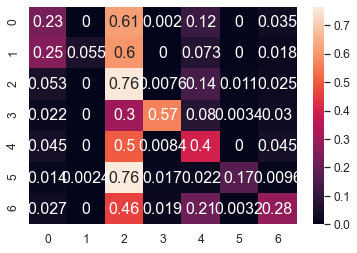

	training epoch=21 .. train_loss=1.094
	validation epoch=21 .. val_loss=1.535
	Accuracy = 41.8 % .. Percision = 62.2 % .. Recall = 35.199999999999996 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_21.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 22 .. loss = 0.945


  0%|                                                                                 | 1/1914 [00:01<38:00,  1.19s/it]

training @ epoch 22 .. loss = 0.981


  0%|                                                                                 | 2/1914 [00:02<38:50,  1.22s/it]

training @ epoch 22 .. loss = 0.839


  0%|▏                                                                                | 3/1914 [00:03<39:20,  1.24s/it]

training @ epoch 22 .. loss = 1.334


  0%|▏                                                                                | 4/1914 [00:04<39:11,  1.23s/it]

training @ epoch 22 .. loss = 0.531


  0%|▏                                                                                | 5/1914 [00:06<40:33,  1.27s/it]

training @ epoch 22 .. loss = 0.983


  0%|▎                                                                                | 6/1914 [00:07<40:00,  1.26s/it]

training @ epoch 22 .. loss = 1.241


  0%|▎                                                                                | 7/1914 [00:08<40:01,  1.26s/it]

training @ epoch 22 .. loss = 0.96


  0%|▎                                                                                | 8/1914 [00:10<39:57,  1.26s/it]

training @ epoch 22 .. loss = 1.338


  0%|▍                                                                                | 9/1914 [00:11<39:48,  1.25s/it]

training @ epoch 22 .. loss = 1.411


  1%|▍                                                                               | 10/1914 [00:12<39:29,  1.24s/it]

training @ epoch 22 .. loss = 1.138


  1%|▍                                                                               | 11/1914 [00:13<39:38,  1.25s/it]

training @ epoch 22 .. loss = 1.378


  1%|▌                                                                               | 12/1914 [00:15<39:38,  1.25s/it]

training @ epoch 22 .. loss = 1.154


  1%|▌                                                                               | 13/1914 [00:16<40:36,  1.28s/it]

training @ epoch 22 .. loss = 0.578


  1%|▌                                                                               | 14/1914 [00:17<40:24,  1.28s/it]

training @ epoch 22 .. loss = 0.829


  1%|▋                                                                               | 15/1914 [00:18<39:51,  1.26s/it]

training @ epoch 22 .. loss = 1.381


  1%|▋                                                                               | 16/1914 [00:20<39:46,  1.26s/it]

training @ epoch 22 .. loss = 0.869


  1%|▋                                                                               | 17/1914 [00:21<39:42,  1.26s/it]

training @ epoch 22 .. loss = 1.13


  1%|▊                                                                               | 18/1914 [00:22<39:21,  1.25s/it]

training @ epoch 22 .. loss = 1.102


  1%|▊                                                                               | 19/1914 [00:23<39:12,  1.24s/it]

training @ epoch 22 .. loss = 1.029


  1%|▊                                                                               | 20/1914 [00:25<38:53,  1.23s/it]

training @ epoch 22 .. loss = 0.835


  1%|▉                                                                               | 21/1914 [00:26<39:28,  1.25s/it]

training @ epoch 22 .. loss = 1.234


  1%|▉                                                                               | 22/1914 [00:27<39:55,  1.27s/it]

training @ epoch 22 .. loss = 1.077


  1%|▉                                                                               | 23/1914 [00:28<39:35,  1.26s/it]

training @ epoch 22 .. loss = 0.94


  1%|█                                                                               | 24/1914 [00:30<40:00,  1.27s/it]

training @ epoch 22 .. loss = 0.649


  1%|█                                                                               | 25/1914 [00:31<39:49,  1.27s/it]

training @ epoch 22 .. loss = 1.236


  1%|█                                                                               | 26/1914 [00:32<39:11,  1.25s/it]

training @ epoch 22 .. loss = 0.709


  1%|█▏                                                                              | 27/1914 [00:33<39:43,  1.26s/it]

training @ epoch 22 .. loss = 0.952


  1%|█▏                                                                              | 28/1914 [00:35<39:47,  1.27s/it]

training @ epoch 22 .. loss = 0.819


  2%|█▏                                                                              | 29/1914 [00:36<39:21,  1.25s/it]

training @ epoch 22 .. loss = 0.86


  2%|█▎                                                                              | 30/1914 [00:37<40:11,  1.28s/it]

training @ epoch 22 .. loss = 1.215


  2%|█▎                                                                              | 31/1914 [00:39<39:53,  1.27s/it]

training @ epoch 22 .. loss = 1.105


  2%|█▎                                                                              | 32/1914 [00:40<39:53,  1.27s/it]

training @ epoch 22 .. loss = 1.089


  2%|█▍                                                                              | 33/1914 [00:41<39:12,  1.25s/it]

training @ epoch 22 .. loss = 1.152


  2%|█▍                                                                              | 34/1914 [00:42<38:44,  1.24s/it]

training @ epoch 22 .. loss = 0.781


  2%|█▍                                                                              | 35/1914 [00:44<39:08,  1.25s/it]

training @ epoch 22 .. loss = 0.864


  2%|█▌                                                                              | 36/1914 [00:45<39:24,  1.26s/it]

training @ epoch 22 .. loss = 0.661


  2%|█▌                                                                              | 37/1914 [00:46<39:19,  1.26s/it]

training @ epoch 22 .. loss = 0.707


  2%|█▌                                                                              | 38/1914 [00:47<40:24,  1.29s/it]

training @ epoch 22 .. loss = 0.887


  2%|█▋                                                                              | 39/1914 [00:49<42:16,  1.35s/it]

training @ epoch 22 .. loss = 1.01


  2%|█▋                                                                              | 40/1914 [00:50<41:24,  1.33s/it]

training @ epoch 22 .. loss = 1.88


  2%|█▋                                                                              | 41/1914 [00:51<40:40,  1.30s/it]

training @ epoch 22 .. loss = 0.673


  2%|█▊                                                                              | 42/1914 [00:53<39:36,  1.27s/it]

training @ epoch 22 .. loss = 1.79


  2%|█▊                                                                              | 43/1914 [00:54<39:24,  1.26s/it]

training @ epoch 22 .. loss = 0.998


  2%|█▊                                                                              | 44/1914 [00:55<39:01,  1.25s/it]

training @ epoch 22 .. loss = 0.944


  2%|█▉                                                                              | 45/1914 [00:56<38:55,  1.25s/it]

training @ epoch 22 .. loss = 0.588


  2%|█▉                                                                              | 46/1914 [00:58<39:24,  1.27s/it]

training @ epoch 22 .. loss = 0.97


  2%|█▉                                                                              | 47/1914 [00:59<39:36,  1.27s/it]

training @ epoch 22 .. loss = 1.092


  3%|██                                                                              | 48/1914 [01:00<39:02,  1.26s/it]

training @ epoch 22 .. loss = 0.89


  3%|██                                                                              | 49/1914 [01:01<39:05,  1.26s/it]

training @ epoch 22 .. loss = 1.292


  3%|██                                                                              | 50/1914 [01:03<38:54,  1.25s/it]

training @ epoch 22 .. loss = 1.271


  3%|██▏                                                                             | 51/1914 [01:04<38:59,  1.26s/it]

training @ epoch 22 .. loss = 0.798


  3%|██▏                                                                             | 52/1914 [01:05<38:27,  1.24s/it]

training @ epoch 22 .. loss = 1.674


  3%|██▏                                                                             | 53/1914 [01:06<38:12,  1.23s/it]

training @ epoch 22 .. loss = 1.095


  3%|██▎                                                                             | 54/1914 [01:08<38:23,  1.24s/it]

training @ epoch 22 .. loss = 1.014


  3%|██▎                                                                             | 55/1914 [01:09<38:30,  1.24s/it]

training @ epoch 22 .. loss = 1.418


  3%|██▎                                                                             | 56/1914 [01:10<38:11,  1.23s/it]

training @ epoch 22 .. loss = 1.225


  3%|██▍                                                                             | 57/1914 [01:11<38:21,  1.24s/it]

training @ epoch 22 .. loss = 0.734


  3%|██▍                                                                             | 58/1914 [01:13<38:09,  1.23s/it]

training @ epoch 22 .. loss = 0.806


  3%|██▍                                                                             | 59/1914 [01:14<38:23,  1.24s/it]

training @ epoch 22 .. loss = 1.321


  3%|██▌                                                                             | 60/1914 [01:15<38:34,  1.25s/it]

training @ epoch 22 .. loss = 1.427


  3%|██▌                                                                             | 61/1914 [01:16<38:16,  1.24s/it]

training @ epoch 22 .. loss = 0.98


  3%|██▌                                                                             | 62/1914 [01:18<38:27,  1.25s/it]

training @ epoch 22 .. loss = 1.058


  3%|██▋                                                                             | 63/1914 [01:19<38:19,  1.24s/it]

training @ epoch 22 .. loss = 0.75


  3%|██▋                                                                             | 64/1914 [01:20<38:12,  1.24s/it]

training @ epoch 22 .. loss = 0.71


  3%|██▋                                                                             | 65/1914 [01:21<38:17,  1.24s/it]

training @ epoch 22 .. loss = 0.813


  3%|██▊                                                                             | 66/1914 [01:22<38:23,  1.25s/it]

training @ epoch 22 .. loss = 0.986


  4%|██▊                                                                             | 67/1914 [01:24<38:31,  1.25s/it]

training @ epoch 22 .. loss = 0.847


  4%|██▊                                                                             | 68/1914 [01:25<38:30,  1.25s/it]

training @ epoch 22 .. loss = 1.281


  4%|██▉                                                                             | 69/1914 [01:26<38:29,  1.25s/it]

training @ epoch 22 .. loss = 1.359


  4%|██▉                                                                             | 70/1914 [01:28<38:28,  1.25s/it]

training @ epoch 22 .. loss = 1.095


  4%|██▉                                                                             | 71/1914 [01:29<39:33,  1.29s/it]

training @ epoch 22 .. loss = 1.115


  4%|███                                                                             | 72/1914 [01:30<40:29,  1.32s/it]

training @ epoch 22 .. loss = 1.263


  4%|███                                                                             | 73/1914 [01:32<42:34,  1.39s/it]

training @ epoch 22 .. loss = 1.066


  4%|███                                                                             | 74/1914 [01:33<44:11,  1.44s/it]

training @ epoch 22 .. loss = 0.999


  4%|███▏                                                                            | 75/1914 [01:35<45:05,  1.47s/it]

training @ epoch 22 .. loss = 1.1


  4%|███▏                                                                            | 76/1914 [01:36<45:32,  1.49s/it]

training @ epoch 22 .. loss = 0.934


  4%|███▏                                                                            | 77/1914 [01:38<45:45,  1.49s/it]

training @ epoch 22 .. loss = 1.147


  4%|███▎                                                                            | 78/1914 [01:39<45:46,  1.50s/it]

training @ epoch 22 .. loss = 1.075


  4%|███▎                                                                            | 79/1914 [01:41<45:29,  1.49s/it]

training @ epoch 22 .. loss = 0.816


  4%|███▎                                                                            | 80/1914 [01:42<45:37,  1.49s/it]

training @ epoch 22 .. loss = 1.036


  4%|███▍                                                                            | 81/1914 [01:44<45:34,  1.49s/it]

training @ epoch 22 .. loss = 1.058


  4%|███▍                                                                            | 82/1914 [01:45<45:23,  1.49s/it]

training @ epoch 22 .. loss = 1.416


  4%|███▍                                                                            | 83/1914 [01:47<44:31,  1.46s/it]

training @ epoch 22 .. loss = 1.043


  4%|███▌                                                                            | 84/1914 [01:48<44:05,  1.45s/it]

training @ epoch 22 .. loss = 0.677


  4%|███▌                                                                            | 85/1914 [01:50<43:20,  1.42s/it]

training @ epoch 22 .. loss = 0.786


  4%|███▌                                                                            | 86/1914 [01:51<43:03,  1.41s/it]

training @ epoch 22 .. loss = 1.488


  5%|███▋                                                                            | 87/1914 [01:52<42:47,  1.41s/it]

training @ epoch 22 .. loss = 1.24


  5%|███▋                                                                            | 88/1914 [01:54<42:51,  1.41s/it]

training @ epoch 22 .. loss = 1.363


  5%|███▋                                                                            | 89/1914 [01:55<41:25,  1.36s/it]

training @ epoch 22 .. loss = 1.132


  5%|███▊                                                                            | 90/1914 [01:56<39:50,  1.31s/it]

training @ epoch 22 .. loss = 1.297


  5%|███▊                                                                            | 91/1914 [01:57<39:23,  1.30s/it]

training @ epoch 22 .. loss = 1.245


  5%|███▊                                                                            | 92/1914 [01:59<39:04,  1.29s/it]

training @ epoch 22 .. loss = 1.107


  5%|███▉                                                                            | 93/1914 [02:00<38:33,  1.27s/it]

training @ epoch 22 .. loss = 1.252


  5%|███▉                                                                            | 94/1914 [02:01<38:15,  1.26s/it]

training @ epoch 22 .. loss = 0.665


  5%|███▉                                                                            | 95/1914 [02:02<37:49,  1.25s/it]

training @ epoch 22 .. loss = 1.64


  5%|████                                                                            | 96/1914 [02:04<37:50,  1.25s/it]

training @ epoch 22 .. loss = 1.218


  5%|████                                                                            | 97/1914 [02:05<38:03,  1.26s/it]

training @ epoch 22 .. loss = 0.97


  5%|████                                                                            | 98/1914 [02:06<37:49,  1.25s/it]

training @ epoch 22 .. loss = 1.51


  5%|████▏                                                                           | 99/1914 [02:08<38:38,  1.28s/it]

training @ epoch 22 .. loss = 1.341


  5%|████▏                                                                          | 100/1914 [02:09<39:06,  1.29s/it]

training @ epoch 22 .. loss = 0.897


  5%|████▏                                                                          | 101/1914 [02:10<39:05,  1.29s/it]

training @ epoch 22 .. loss = 0.783


  5%|████▏                                                                          | 102/1914 [02:11<38:35,  1.28s/it]

training @ epoch 22 .. loss = 1.17


  5%|████▎                                                                          | 103/1914 [02:13<38:20,  1.27s/it]

training @ epoch 22 .. loss = 0.644


  5%|████▎                                                                          | 104/1914 [02:14<38:08,  1.26s/it]

training @ epoch 22 .. loss = 1.327


  5%|████▎                                                                          | 105/1914 [02:15<37:34,  1.25s/it]

training @ epoch 22 .. loss = 1.215


  6%|████▍                                                                          | 106/1914 [02:16<37:15,  1.24s/it]

training @ epoch 22 .. loss = 0.993


  6%|████▍                                                                          | 107/1914 [02:18<37:27,  1.24s/it]

training @ epoch 22 .. loss = 1.766


  6%|████▍                                                                          | 108/1914 [02:19<37:24,  1.24s/it]

training @ epoch 22 .. loss = 1.587


  6%|████▍                                                                          | 109/1914 [02:20<36:55,  1.23s/it]

training @ epoch 22 .. loss = 0.657


  6%|████▌                                                                          | 110/1914 [02:21<37:19,  1.24s/it]

training @ epoch 22 .. loss = 1.498


  6%|████▌                                                                          | 111/1914 [02:23<37:21,  1.24s/it]

training @ epoch 22 .. loss = 0.77


  6%|████▌                                                                          | 112/1914 [02:24<37:26,  1.25s/it]

training @ epoch 22 .. loss = 1.31


  6%|████▋                                                                          | 113/1914 [02:25<37:11,  1.24s/it]

training @ epoch 22 .. loss = 1.675


  6%|████▋                                                                          | 114/1914 [02:26<37:05,  1.24s/it]

training @ epoch 22 .. loss = 1.92


  6%|████▋                                                                          | 115/1914 [02:28<37:29,  1.25s/it]

training @ epoch 22 .. loss = 1.258


  6%|████▊                                                                          | 116/1914 [02:29<37:40,  1.26s/it]

training @ epoch 22 .. loss = 1.093


  6%|████▊                                                                          | 117/1914 [02:30<37:09,  1.24s/it]

training @ epoch 22 .. loss = 0.593


  6%|████▊                                                                          | 118/1914 [02:31<37:03,  1.24s/it]

training @ epoch 22 .. loss = 0.796


  6%|████▉                                                                          | 119/1914 [02:32<36:54,  1.23s/it]

training @ epoch 22 .. loss = 1.073


  6%|████▉                                                                          | 120/1914 [02:34<37:15,  1.25s/it]

training @ epoch 22 .. loss = 1.069


  6%|████▉                                                                          | 121/1914 [02:35<37:17,  1.25s/it]

training @ epoch 22 .. loss = 1.153


  6%|█████                                                                          | 122/1914 [02:36<37:08,  1.24s/it]

training @ epoch 22 .. loss = 1.044


  6%|█████                                                                          | 123/1914 [02:37<37:16,  1.25s/it]

training @ epoch 22 .. loss = 1.158


  6%|█████                                                                          | 124/1914 [02:39<37:04,  1.24s/it]

training @ epoch 22 .. loss = 1.033


  7%|█████▏                                                                         | 125/1914 [02:40<37:04,  1.24s/it]

training @ epoch 22 .. loss = 1.16


  7%|█████▏                                                                         | 126/1914 [02:41<36:46,  1.23s/it]

training @ epoch 22 .. loss = 1.053


  7%|█████▏                                                                         | 127/1914 [02:42<37:00,  1.24s/it]

training @ epoch 22 .. loss = 1.457


  7%|█████▎                                                                         | 128/1914 [02:44<37:15,  1.25s/it]

training @ epoch 22 .. loss = 0.807


  7%|█████▎                                                                         | 129/1914 [02:45<37:15,  1.25s/it]

training @ epoch 22 .. loss = 1.056


  7%|█████▎                                                                         | 130/1914 [02:46<37:08,  1.25s/it]

training @ epoch 22 .. loss = 0.857


  7%|█████▍                                                                         | 131/1914 [02:47<37:29,  1.26s/it]

training @ epoch 22 .. loss = 1.155


  7%|█████▍                                                                         | 132/1914 [02:49<37:25,  1.26s/it]

training @ epoch 22 .. loss = 0.688


  7%|█████▍                                                                         | 133/1914 [02:50<37:15,  1.26s/it]

training @ epoch 22 .. loss = 1.127


  7%|█████▌                                                                         | 134/1914 [02:51<37:24,  1.26s/it]

training @ epoch 22 .. loss = 0.908


  7%|█████▌                                                                         | 135/1914 [02:53<37:16,  1.26s/it]

training @ epoch 22 .. loss = 0.779


  7%|█████▌                                                                         | 136/1914 [02:54<37:25,  1.26s/it]

training @ epoch 22 .. loss = 1.267


  7%|█████▋                                                                         | 137/1914 [02:55<37:18,  1.26s/it]

training @ epoch 22 .. loss = 1.136


  7%|█████▋                                                                         | 138/1914 [02:56<37:14,  1.26s/it]

training @ epoch 22 .. loss = 1.196


  7%|█████▋                                                                         | 139/1914 [02:58<37:15,  1.26s/it]

training @ epoch 22 .. loss = 1.012


  7%|█████▊                                                                         | 140/1914 [02:59<37:10,  1.26s/it]

training @ epoch 22 .. loss = 1.095


  7%|█████▊                                                                         | 141/1914 [03:00<36:49,  1.25s/it]

training @ epoch 22 .. loss = 0.889


  7%|█████▊                                                                         | 142/1914 [03:01<37:03,  1.25s/it]

training @ epoch 22 .. loss = 0.998


  7%|█████▉                                                                         | 143/1914 [03:03<36:45,  1.25s/it]

training @ epoch 22 .. loss = 0.985


  8%|█████▉                                                                         | 144/1914 [03:04<36:53,  1.25s/it]

training @ epoch 22 .. loss = 0.839


  8%|█████▉                                                                         | 145/1914 [03:05<36:48,  1.25s/it]

training @ epoch 22 .. loss = 1.013


  8%|██████                                                                         | 146/1914 [03:06<36:22,  1.23s/it]

training @ epoch 22 .. loss = 1.688


  8%|██████                                                                         | 147/1914 [03:07<36:33,  1.24s/it]

training @ epoch 22 .. loss = 0.914


  8%|██████                                                                         | 148/1914 [03:09<36:45,  1.25s/it]

training @ epoch 22 .. loss = 1.487


  8%|██████▏                                                                        | 149/1914 [03:10<36:41,  1.25s/it]

training @ epoch 22 .. loss = 1.373


  8%|██████▏                                                                        | 150/1914 [03:11<36:48,  1.25s/it]

training @ epoch 22 .. loss = 1.341


  8%|██████▏                                                                        | 151/1914 [03:12<36:31,  1.24s/it]

training @ epoch 22 .. loss = 1.448


  8%|██████▎                                                                        | 152/1914 [03:14<36:34,  1.25s/it]

training @ epoch 22 .. loss = 1.054


  8%|██████▎                                                                        | 153/1914 [03:15<36:43,  1.25s/it]

training @ epoch 22 .. loss = 1.489


  8%|██████▎                                                                        | 154/1914 [03:16<37:04,  1.26s/it]

training @ epoch 22 .. loss = 0.838


  8%|██████▍                                                                        | 155/1914 [03:18<38:20,  1.31s/it]

training @ epoch 22 .. loss = 0.93


  8%|██████▍                                                                        | 156/1914 [03:19<39:21,  1.34s/it]

training @ epoch 22 .. loss = 0.933


  8%|██████▍                                                                        | 157/1914 [03:20<39:25,  1.35s/it]

training @ epoch 22 .. loss = 1.007


  8%|██████▌                                                                        | 158/1914 [03:22<40:46,  1.39s/it]

training @ epoch 22 .. loss = 0.998


  8%|██████▌                                                                        | 159/1914 [03:24<41:59,  1.44s/it]

training @ epoch 22 .. loss = 1.174


  8%|██████▌                                                                        | 160/1914 [03:25<43:00,  1.47s/it]

training @ epoch 22 .. loss = 0.961


  8%|██████▋                                                                        | 161/1914 [03:27<42:48,  1.47s/it]

training @ epoch 22 .. loss = 1.608


  8%|██████▋                                                                        | 162/1914 [03:28<42:07,  1.44s/it]

training @ epoch 22 .. loss = 0.742


  9%|██████▋                                                                        | 163/1914 [03:29<40:42,  1.40s/it]

training @ epoch 22 .. loss = 1.232


  9%|██████▊                                                                        | 164/1914 [03:31<40:55,  1.40s/it]

training @ epoch 22 .. loss = 1.195


  9%|██████▊                                                                        | 165/1914 [03:32<41:31,  1.42s/it]

training @ epoch 22 .. loss = 1.25


  9%|██████▊                                                                        | 166/1914 [03:34<42:34,  1.46s/it]

training @ epoch 22 .. loss = 0.74


  9%|██████▉                                                                        | 167/1914 [03:35<45:13,  1.55s/it]

training @ epoch 22 .. loss = 1.071


  9%|██████▉                                                                        | 168/1914 [03:37<43:58,  1.51s/it]

training @ epoch 22 .. loss = 1.087


  9%|██████▉                                                                        | 169/1914 [03:38<42:07,  1.45s/it]

training @ epoch 22 .. loss = 0.91


  9%|███████                                                                        | 170/1914 [03:40<44:20,  1.53s/it]

training @ epoch 22 .. loss = 1.322


  9%|███████                                                                        | 171/1914 [03:42<47:17,  1.63s/it]

training @ epoch 22 .. loss = 1.682


  9%|███████                                                                        | 172/1914 [03:43<47:09,  1.62s/it]

training @ epoch 22 .. loss = 0.965


  9%|███████▏                                                                       | 173/1914 [03:45<46:16,  1.59s/it]

training @ epoch 22 .. loss = 1.01


  9%|███████▏                                                                       | 174/1914 [03:46<46:12,  1.59s/it]

training @ epoch 22 .. loss = 0.907


  9%|███████▏                                                                       | 175/1914 [03:48<45:01,  1.55s/it]

training @ epoch 22 .. loss = 1.156


  9%|███████▎                                                                       | 176/1914 [03:49<45:26,  1.57s/it]

training @ epoch 22 .. loss = 1.26


  9%|███████▎                                                                       | 177/1914 [03:51<45:19,  1.57s/it]

training @ epoch 22 .. loss = 1.449


  9%|███████▎                                                                       | 178/1914 [03:52<43:42,  1.51s/it]

training @ epoch 22 .. loss = 0.903


  9%|███████▍                                                                       | 179/1914 [03:54<41:58,  1.45s/it]

training @ epoch 22 .. loss = 0.822


  9%|███████▍                                                                       | 180/1914 [03:55<41:05,  1.42s/it]

training @ epoch 22 .. loss = 0.95


  9%|███████▍                                                                       | 181/1914 [03:57<42:39,  1.48s/it]

training @ epoch 22 .. loss = 1.379


 10%|███████▌                                                                       | 182/1914 [03:58<43:53,  1.52s/it]

training @ epoch 22 .. loss = 1.055


 10%|███████▌                                                                       | 183/1914 [04:00<42:57,  1.49s/it]

training @ epoch 22 .. loss = 1.371


 10%|███████▌                                                                       | 184/1914 [04:01<43:04,  1.49s/it]

training @ epoch 22 .. loss = 1.316


 10%|███████▋                                                                       | 185/1914 [04:03<43:19,  1.50s/it]

training @ epoch 22 .. loss = 0.896


 10%|███████▋                                                                       | 186/1914 [04:04<41:58,  1.46s/it]

training @ epoch 22 .. loss = 1.03


 10%|███████▋                                                                       | 187/1914 [04:06<42:41,  1.48s/it]

training @ epoch 22 .. loss = 0.946


 10%|███████▊                                                                       | 188/1914 [04:07<43:33,  1.51s/it]

training @ epoch 22 .. loss = 1.045


 10%|███████▊                                                                       | 189/1914 [04:09<42:19,  1.47s/it]

training @ epoch 22 .. loss = 0.773


 10%|███████▊                                                                       | 190/1914 [04:10<42:01,  1.46s/it]

training @ epoch 22 .. loss = 0.905


 10%|███████▉                                                                       | 191/1914 [04:12<42:17,  1.47s/it]

training @ epoch 22 .. loss = 1.047


 10%|███████▉                                                                       | 192/1914 [04:13<42:33,  1.48s/it]

training @ epoch 22 .. loss = 0.953


 10%|███████▉                                                                       | 193/1914 [04:14<41:18,  1.44s/it]

training @ epoch 22 .. loss = 1.274


 10%|████████                                                                       | 194/1914 [04:16<40:42,  1.42s/it]

training @ epoch 22 .. loss = 0.687


 10%|████████                                                                       | 195/1914 [04:17<39:54,  1.39s/it]

training @ epoch 22 .. loss = 1.009


 10%|████████                                                                       | 196/1914 [04:19<41:12,  1.44s/it]

training @ epoch 22 .. loss = 1.019


 10%|████████▏                                                                      | 197/1914 [04:20<40:47,  1.43s/it]

training @ epoch 22 .. loss = 1.068


 10%|████████▏                                                                      | 198/1914 [04:21<40:20,  1.41s/it]

training @ epoch 22 .. loss = 0.737


 10%|████████▏                                                                      | 199/1914 [04:23<40:52,  1.43s/it]

training @ epoch 22 .. loss = 1.082


 10%|████████▎                                                                      | 200/1914 [04:24<41:24,  1.45s/it]

training @ epoch 22 .. loss = 1.019


 11%|████████▎                                                                      | 201/1914 [04:26<41:23,  1.45s/it]

training @ epoch 22 .. loss = 1.008


 11%|████████▎                                                                      | 202/1914 [04:27<42:16,  1.48s/it]

training @ epoch 22 .. loss = 0.746


 11%|████████▍                                                                      | 203/1914 [04:29<42:48,  1.50s/it]

training @ epoch 22 .. loss = 1.221


 11%|████████▍                                                                      | 204/1914 [04:30<42:18,  1.48s/it]

training @ epoch 22 .. loss = 1.478


 11%|████████▍                                                                      | 205/1914 [04:32<42:05,  1.48s/it]

training @ epoch 22 .. loss = 0.677


 11%|████████▌                                                                      | 206/1914 [04:33<42:32,  1.49s/it]

training @ epoch 22 .. loss = 1.429


 11%|████████▌                                                                      | 207/1914 [04:35<41:13,  1.45s/it]

training @ epoch 22 .. loss = 0.934


 11%|████████▌                                                                      | 208/1914 [04:36<39:46,  1.40s/it]

training @ epoch 22 .. loss = 0.693


 11%|████████▋                                                                      | 209/1914 [04:37<40:12,  1.42s/it]

training @ epoch 22 .. loss = 1.153


 11%|████████▋                                                                      | 210/1914 [04:39<39:44,  1.40s/it]

training @ epoch 22 .. loss = 0.774


 11%|████████▋                                                                      | 211/1914 [04:40<40:22,  1.42s/it]

training @ epoch 22 .. loss = 0.81


 11%|████████▊                                                                      | 212/1914 [04:42<40:56,  1.44s/it]

training @ epoch 22 .. loss = 0.85


 11%|████████▊                                                                      | 213/1914 [04:43<41:28,  1.46s/it]

training @ epoch 22 .. loss = 0.881


 11%|████████▊                                                                      | 214/1914 [04:45<40:36,  1.43s/it]

training @ epoch 22 .. loss = 0.897


 11%|████████▊                                                                      | 215/1914 [04:46<41:32,  1.47s/it]

training @ epoch 22 .. loss = 0.929


 11%|████████▉                                                                      | 216/1914 [04:48<41:22,  1.46s/it]

training @ epoch 22 .. loss = 1.155


 11%|████████▉                                                                      | 217/1914 [04:49<40:54,  1.45s/it]

training @ epoch 22 .. loss = 1.046


 11%|████████▉                                                                      | 218/1914 [04:51<41:17,  1.46s/it]

training @ epoch 22 .. loss = 0.858


 11%|█████████                                                                      | 219/1914 [04:52<41:49,  1.48s/it]

training @ epoch 22 .. loss = 0.766


 11%|█████████                                                                      | 220/1914 [04:53<41:02,  1.45s/it]

training @ epoch 22 .. loss = 0.634


 12%|█████████                                                                      | 221/1914 [04:55<41:11,  1.46s/it]

training @ epoch 22 .. loss = 0.963


 12%|█████████▏                                                                     | 222/1914 [04:56<40:48,  1.45s/it]

training @ epoch 22 .. loss = 0.816


 12%|█████████▏                                                                     | 223/1914 [04:58<41:38,  1.48s/it]

training @ epoch 22 .. loss = 0.748


 12%|█████████▏                                                                     | 224/1914 [04:59<41:32,  1.47s/it]

training @ epoch 22 .. loss = 1.527


 12%|█████████▎                                                                     | 225/1914 [05:01<41:15,  1.47s/it]

training @ epoch 22 .. loss = 0.83


 12%|█████████▎                                                                     | 226/1914 [05:02<40:57,  1.46s/it]

training @ epoch 22 .. loss = 1.177


 12%|█████████▎                                                                     | 227/1914 [05:04<41:42,  1.48s/it]

training @ epoch 22 .. loss = 0.842


 12%|█████████▍                                                                     | 228/1914 [05:05<42:10,  1.50s/it]

training @ epoch 22 .. loss = 1.167


 12%|█████████▍                                                                     | 229/1914 [05:07<42:40,  1.52s/it]

training @ epoch 22 .. loss = 0.868


 12%|█████████▍                                                                     | 230/1914 [05:08<42:36,  1.52s/it]

training @ epoch 22 .. loss = 0.893


 12%|█████████▌                                                                     | 231/1914 [05:10<42:41,  1.52s/it]

training @ epoch 22 .. loss = 0.726


 12%|█████████▌                                                                     | 232/1914 [05:12<42:58,  1.53s/it]

training @ epoch 22 .. loss = 0.977


 12%|█████████▌                                                                     | 233/1914 [05:13<43:08,  1.54s/it]

training @ epoch 22 .. loss = 1.951


 12%|█████████▋                                                                     | 234/1914 [05:15<43:14,  1.54s/it]

training @ epoch 22 .. loss = 1.204


 12%|█████████▋                                                                     | 235/1914 [05:16<43:13,  1.54s/it]

training @ epoch 22 .. loss = 1.257


 12%|█████████▋                                                                     | 236/1914 [05:18<43:37,  1.56s/it]

training @ epoch 22 .. loss = 0.823


 12%|█████████▊                                                                     | 237/1914 [05:19<43:10,  1.54s/it]

training @ epoch 22 .. loss = 0.749


 12%|█████████▊                                                                     | 238/1914 [05:21<43:11,  1.55s/it]

training @ epoch 22 .. loss = 0.832


 12%|█████████▊                                                                     | 239/1914 [05:23<44:23,  1.59s/it]

training @ epoch 22 .. loss = 0.9


 13%|█████████▉                                                                     | 240/1914 [05:24<43:53,  1.57s/it]

training @ epoch 22 .. loss = 1.159


 13%|█████████▉                                                                     | 241/1914 [05:26<42:51,  1.54s/it]

training @ epoch 22 .. loss = 0.94


 13%|█████████▉                                                                     | 242/1914 [05:27<40:56,  1.47s/it]

training @ epoch 22 .. loss = 1.359


 13%|██████████                                                                     | 243/1914 [05:28<41:23,  1.49s/it]

training @ epoch 22 .. loss = 1.549


 13%|██████████                                                                     | 244/1914 [05:30<42:01,  1.51s/it]

training @ epoch 22 .. loss = 1.011


 13%|██████████                                                                     | 245/1914 [05:31<40:52,  1.47s/it]

training @ epoch 22 .. loss = 1.203


 13%|██████████▏                                                                    | 246/1914 [05:33<39:31,  1.42s/it]

training @ epoch 22 .. loss = 1.025


 13%|██████████▏                                                                    | 247/1914 [05:34<39:57,  1.44s/it]

training @ epoch 22 .. loss = 1.294


 13%|██████████▏                                                                    | 248/1914 [05:36<40:38,  1.46s/it]

training @ epoch 22 .. loss = 1.278


 13%|██████████▎                                                                    | 249/1914 [05:37<40:26,  1.46s/it]

training @ epoch 22 .. loss = 0.749


 13%|██████████▎                                                                    | 250/1914 [05:38<39:15,  1.42s/it]

training @ epoch 22 .. loss = 1.068


 13%|██████████▎                                                                    | 251/1914 [05:40<39:24,  1.42s/it]

training @ epoch 22 .. loss = 1.027


 13%|██████████▍                                                                    | 252/1914 [05:41<40:33,  1.46s/it]

training @ epoch 22 .. loss = 1.169


 13%|██████████▍                                                                    | 253/1914 [05:43<39:37,  1.43s/it]

training @ epoch 22 .. loss = 1.175


 13%|██████████▍                                                                    | 254/1914 [05:44<40:53,  1.48s/it]

training @ epoch 22 .. loss = 0.811


 13%|██████████▌                                                                    | 255/1914 [05:46<40:45,  1.47s/it]

training @ epoch 22 .. loss = 1.301


 13%|██████████▌                                                                    | 256/1914 [05:47<39:18,  1.42s/it]

training @ epoch 22 .. loss = 1.18


 13%|██████████▌                                                                    | 257/1914 [05:49<40:27,  1.47s/it]

training @ epoch 22 .. loss = 1.337


 13%|██████████▋                                                                    | 258/1914 [05:50<40:51,  1.48s/it]

training @ epoch 22 .. loss = 1.168


 14%|██████████▋                                                                    | 259/1914 [05:52<39:45,  1.44s/it]

training @ epoch 22 .. loss = 1.192


 14%|██████████▋                                                                    | 260/1914 [05:53<39:10,  1.42s/it]

training @ epoch 22 .. loss = 0.736


 14%|██████████▊                                                                    | 261/1914 [05:54<39:01,  1.42s/it]

training @ epoch 22 .. loss = 0.909


 14%|██████████▊                                                                    | 262/1914 [05:56<39:13,  1.42s/it]

training @ epoch 22 .. loss = 0.984


 14%|██████████▊                                                                    | 263/1914 [05:57<39:09,  1.42s/it]

training @ epoch 22 .. loss = 1.267


 14%|██████████▉                                                                    | 264/1914 [05:59<39:06,  1.42s/it]

training @ epoch 22 .. loss = 0.878


 14%|██████████▉                                                                    | 265/1914 [06:00<39:14,  1.43s/it]

training @ epoch 22 .. loss = 1.246


 14%|██████████▉                                                                    | 266/1914 [06:01<39:04,  1.42s/it]

training @ epoch 22 .. loss = 1.176


 14%|███████████                                                                    | 267/1914 [06:03<39:42,  1.45s/it]

training @ epoch 22 .. loss = 1.065


 14%|███████████                                                                    | 268/1914 [06:04<37:55,  1.38s/it]

training @ epoch 22 .. loss = 1.068


 14%|███████████                                                                    | 269/1914 [06:05<37:10,  1.36s/it]

training @ epoch 22 .. loss = 1.21


 14%|███████████▏                                                                   | 270/1914 [06:07<36:12,  1.32s/it]

training @ epoch 22 .. loss = 0.985


 14%|███████████▏                                                                   | 271/1914 [06:08<35:31,  1.30s/it]

training @ epoch 22 .. loss = 1.08


 14%|███████████▏                                                                   | 272/1914 [06:09<35:07,  1.28s/it]

training @ epoch 22 .. loss = 0.911


 14%|███████████▎                                                                   | 273/1914 [06:10<34:26,  1.26s/it]

training @ epoch 22 .. loss = 0.814


 14%|███████████▎                                                                   | 274/1914 [06:12<34:35,  1.27s/it]

training @ epoch 22 .. loss = 1.363


 14%|███████████▎                                                                   | 275/1914 [06:13<34:14,  1.25s/it]

training @ epoch 22 .. loss = 1.153


 14%|███████████▍                                                                   | 276/1914 [06:14<34:59,  1.28s/it]

training @ epoch 22 .. loss = 1.208


 14%|███████████▍                                                                   | 277/1914 [06:16<36:18,  1.33s/it]

training @ epoch 22 .. loss = 0.998


 15%|███████████▍                                                                   | 278/1914 [06:17<36:58,  1.36s/it]

training @ epoch 22 .. loss = 1.11


 15%|███████████▌                                                                   | 279/1914 [06:18<37:00,  1.36s/it]

training @ epoch 22 .. loss = 1.028


 15%|███████████▌                                                                   | 280/1914 [06:20<37:02,  1.36s/it]

training @ epoch 22 .. loss = 0.905


 15%|███████████▌                                                                   | 281/1914 [06:21<36:58,  1.36s/it]

training @ epoch 22 .. loss = 0.996


 15%|███████████▋                                                                   | 282/1914 [06:23<37:00,  1.36s/it]

training @ epoch 22 .. loss = 1.428


 15%|███████████▋                                                                   | 283/1914 [06:24<37:04,  1.36s/it]

training @ epoch 22 .. loss = 1.435


 15%|███████████▋                                                                   | 284/1914 [06:25<36:44,  1.35s/it]

training @ epoch 22 .. loss = 1.405


 15%|███████████▊                                                                   | 285/1914 [06:27<36:58,  1.36s/it]

training @ epoch 22 .. loss = 1.51


 15%|███████████▊                                                                   | 286/1914 [06:28<37:41,  1.39s/it]

training @ epoch 22 .. loss = 1.237


 15%|███████████▊                                                                   | 287/1914 [06:30<38:18,  1.41s/it]

training @ epoch 22 .. loss = 1.398


 15%|███████████▉                                                                   | 288/1914 [06:31<38:04,  1.40s/it]

training @ epoch 22 .. loss = 1.145


 15%|███████████▉                                                                   | 289/1914 [06:32<37:23,  1.38s/it]

training @ epoch 22 .. loss = 1.144


 15%|███████████▉                                                                   | 290/1914 [06:34<37:34,  1.39s/it]

training @ epoch 22 .. loss = 1.223


 15%|████████████                                                                   | 291/1914 [06:35<37:16,  1.38s/it]

training @ epoch 22 .. loss = 0.819


 15%|████████████                                                                   | 292/1914 [06:36<37:03,  1.37s/it]

training @ epoch 22 .. loss = 0.669


 15%|████████████                                                                   | 293/1914 [06:38<36:58,  1.37s/it]

training @ epoch 22 .. loss = 1.072


 15%|████████████▏                                                                  | 294/1914 [06:39<36:51,  1.36s/it]

training @ epoch 22 .. loss = 0.991


 15%|████████████▏                                                                  | 295/1914 [06:40<36:40,  1.36s/it]

training @ epoch 22 .. loss = 1.285


 15%|████████████▏                                                                  | 296/1914 [06:42<36:41,  1.36s/it]

training @ epoch 22 .. loss = 1.32


 16%|████████████▎                                                                  | 297/1914 [06:43<36:54,  1.37s/it]

training @ epoch 22 .. loss = 1.131


 16%|████████████▎                                                                  | 298/1914 [06:44<35:37,  1.32s/it]

training @ epoch 22 .. loss = 0.857


 16%|████████████▎                                                                  | 299/1914 [06:46<35:21,  1.31s/it]

training @ epoch 22 .. loss = 0.924


 16%|████████████▍                                                                  | 300/1914 [06:47<34:55,  1.30s/it]

training @ epoch 22 .. loss = 1.335


 16%|████████████▍                                                                  | 301/1914 [06:48<34:13,  1.27s/it]

training @ epoch 22 .. loss = 0.848


 16%|████████████▍                                                                  | 302/1914 [06:49<34:06,  1.27s/it]

training @ epoch 22 .. loss = 1.009


 16%|████████████▌                                                                  | 303/1914 [06:51<34:20,  1.28s/it]

training @ epoch 22 .. loss = 1.901


 16%|████████████▌                                                                  | 304/1914 [06:52<33:56,  1.26s/it]

training @ epoch 22 .. loss = 1.427


 16%|████████████▌                                                                  | 305/1914 [06:53<33:54,  1.26s/it]

training @ epoch 22 .. loss = 0.862


 16%|████████████▋                                                                  | 306/1914 [06:54<33:36,  1.25s/it]

training @ epoch 22 .. loss = 1.396


 16%|████████████▋                                                                  | 307/1914 [06:56<33:40,  1.26s/it]

training @ epoch 22 .. loss = 1.322


 16%|████████████▋                                                                  | 308/1914 [06:57<33:31,  1.25s/it]

training @ epoch 22 .. loss = 1.17


 16%|████████████▊                                                                  | 309/1914 [06:58<33:39,  1.26s/it]

training @ epoch 22 .. loss = 0.534


 16%|████████████▊                                                                  | 310/1914 [07:00<33:54,  1.27s/it]

training @ epoch 22 .. loss = 0.852


 16%|████████████▊                                                                  | 311/1914 [07:01<33:45,  1.26s/it]

training @ epoch 22 .. loss = 1.005


 16%|████████████▉                                                                  | 312/1914 [07:02<33:34,  1.26s/it]

training @ epoch 22 .. loss = 1.265


 16%|████████████▉                                                                  | 313/1914 [07:03<33:59,  1.27s/it]

training @ epoch 22 .. loss = 1.041


 16%|████████████▉                                                                  | 314/1914 [07:05<33:48,  1.27s/it]

training @ epoch 22 .. loss = 1.61


 16%|█████████████                                                                  | 315/1914 [07:06<33:33,  1.26s/it]

training @ epoch 22 .. loss = 1.163


 17%|█████████████                                                                  | 316/1914 [07:07<33:19,  1.25s/it]

training @ epoch 22 .. loss = 0.759


 17%|█████████████                                                                  | 317/1914 [07:08<33:04,  1.24s/it]

training @ epoch 22 .. loss = 1.649


 17%|█████████████▏                                                                 | 318/1914 [07:10<33:28,  1.26s/it]

training @ epoch 22 .. loss = 1.125


 17%|█████████████▏                                                                 | 319/1914 [07:11<33:38,  1.27s/it]

training @ epoch 22 .. loss = 1.224


 17%|█████████████▏                                                                 | 320/1914 [07:12<33:12,  1.25s/it]

training @ epoch 22 .. loss = 0.939


 17%|█████████████▏                                                                 | 321/1914 [07:13<33:21,  1.26s/it]

training @ epoch 22 .. loss = 1.143


 17%|█████████████▎                                                                 | 322/1914 [07:15<33:03,  1.25s/it]

training @ epoch 22 .. loss = 0.988


 17%|█████████████▎                                                                 | 323/1914 [07:16<33:06,  1.25s/it]

training @ epoch 22 .. loss = 1.368


 17%|█████████████▎                                                                 | 324/1914 [07:17<33:12,  1.25s/it]

training @ epoch 22 .. loss = 1.091


 17%|█████████████▍                                                                 | 325/1914 [07:18<32:49,  1.24s/it]

training @ epoch 22 .. loss = 1.448


 17%|█████████████▍                                                                 | 326/1914 [07:20<32:58,  1.25s/it]

training @ epoch 22 .. loss = 0.931


 17%|█████████████▍                                                                 | 327/1914 [07:21<32:55,  1.24s/it]

training @ epoch 22 .. loss = 1.304


 17%|█████████████▌                                                                 | 328/1914 [07:22<32:44,  1.24s/it]

training @ epoch 22 .. loss = 1.195


 17%|█████████████▌                                                                 | 329/1914 [07:23<32:53,  1.25s/it]

training @ epoch 22 .. loss = 0.994


 17%|█████████████▌                                                                 | 330/1914 [07:25<32:40,  1.24s/it]

training @ epoch 22 .. loss = 0.901


 17%|█████████████▋                                                                 | 331/1914 [07:26<32:55,  1.25s/it]

training @ epoch 22 .. loss = 1.03


 17%|█████████████▋                                                                 | 332/1914 [07:27<32:57,  1.25s/it]

training @ epoch 22 .. loss = 0.732


 17%|█████████████▋                                                                 | 333/1914 [07:28<32:46,  1.24s/it]

training @ epoch 22 .. loss = 1.221


 17%|█████████████▊                                                                 | 334/1914 [07:30<32:50,  1.25s/it]

training @ epoch 22 .. loss = 1.053


 18%|█████████████▊                                                                 | 335/1914 [07:31<32:55,  1.25s/it]

training @ epoch 22 .. loss = 0.859


 18%|█████████████▊                                                                 | 336/1914 [07:32<32:36,  1.24s/it]

training @ epoch 22 .. loss = 1.264


 18%|█████████████▉                                                                 | 337/1914 [07:33<32:49,  1.25s/it]

training @ epoch 22 .. loss = 1.282


 18%|█████████████▉                                                                 | 338/1914 [07:35<32:39,  1.24s/it]

training @ epoch 22 .. loss = 1.039


 18%|█████████████▉                                                                 | 339/1914 [07:36<32:48,  1.25s/it]

training @ epoch 22 .. loss = 1.411


 18%|██████████████                                                                 | 340/1914 [07:37<32:39,  1.25s/it]

training @ epoch 22 .. loss = 0.877


 18%|██████████████                                                                 | 341/1914 [07:38<32:23,  1.24s/it]

training @ epoch 22 .. loss = 1.07


 18%|██████████████                                                                 | 342/1914 [07:39<32:39,  1.25s/it]

training @ epoch 22 .. loss = 0.809


 18%|██████████████▏                                                                | 343/1914 [07:41<32:41,  1.25s/it]

training @ epoch 22 .. loss = 0.914


 18%|██████████████▏                                                                | 344/1914 [07:42<32:32,  1.24s/it]

training @ epoch 22 .. loss = 0.895


 18%|██████████████▏                                                                | 345/1914 [07:43<32:34,  1.25s/it]

training @ epoch 22 .. loss = 1.319


 18%|██████████████▎                                                                | 346/1914 [07:44<32:37,  1.25s/it]

training @ epoch 22 .. loss = 0.928


 18%|██████████████▎                                                                | 347/1914 [07:46<32:57,  1.26s/it]

training @ epoch 22 .. loss = 1.229


 18%|██████████████▎                                                                | 348/1914 [07:47<32:37,  1.25s/it]

training @ epoch 22 .. loss = 1.258


 18%|██████████████▍                                                                | 349/1914 [07:48<32:35,  1.25s/it]

training @ epoch 22 .. loss = 1.151


 18%|██████████████▍                                                                | 350/1914 [07:50<32:44,  1.26s/it]

training @ epoch 22 .. loss = 0.996


 18%|██████████████▍                                                                | 351/1914 [07:51<32:36,  1.25s/it]

training @ epoch 22 .. loss = 0.934


 18%|██████████████▌                                                                | 352/1914 [07:52<32:20,  1.24s/it]

training @ epoch 22 .. loss = 1.385


 18%|██████████████▌                                                                | 353/1914 [07:53<32:28,  1.25s/it]

training @ epoch 22 .. loss = 1.077


 18%|██████████████▌                                                                | 354/1914 [07:54<32:19,  1.24s/it]

training @ epoch 22 .. loss = 0.795


 19%|██████████████▋                                                                | 355/1914 [07:56<32:37,  1.26s/it]

training @ epoch 22 .. loss = 1.791


 19%|██████████████▋                                                                | 356/1914 [07:57<32:44,  1.26s/it]

training @ epoch 22 .. loss = 1.198


 19%|██████████████▋                                                                | 357/1914 [07:58<32:39,  1.26s/it]

training @ epoch 22 .. loss = 0.995


 19%|██████████████▊                                                                | 358/1914 [08:00<32:53,  1.27s/it]

training @ epoch 22 .. loss = 1.131


 19%|██████████████▊                                                                | 359/1914 [08:01<32:39,  1.26s/it]

training @ epoch 22 .. loss = 1.18


 19%|██████████████▊                                                                | 360/1914 [08:02<32:21,  1.25s/it]

training @ epoch 22 .. loss = 1.224


 19%|██████████████▉                                                                | 361/1914 [08:03<32:50,  1.27s/it]

training @ epoch 22 .. loss = 1.049


 19%|██████████████▉                                                                | 362/1914 [08:05<32:36,  1.26s/it]

training @ epoch 22 .. loss = 0.637


 19%|██████████████▉                                                                | 363/1914 [08:06<32:40,  1.26s/it]

training @ epoch 22 .. loss = 1.066


 19%|███████████████                                                                | 364/1914 [08:07<32:29,  1.26s/it]

training @ epoch 22 .. loss = 1.099


 19%|███████████████                                                                | 365/1914 [08:08<32:34,  1.26s/it]

training @ epoch 22 .. loss = 0.871


 19%|███████████████                                                                | 366/1914 [08:10<32:43,  1.27s/it]

training @ epoch 22 .. loss = 1.243


 19%|███████████████▏                                                               | 367/1914 [08:11<32:21,  1.25s/it]

training @ epoch 22 .. loss = 1.172


 19%|███████████████▏                                                               | 368/1914 [08:12<32:09,  1.25s/it]

training @ epoch 22 .. loss = 1.33


 19%|███████████████▏                                                               | 369/1914 [08:13<32:24,  1.26s/it]

training @ epoch 22 .. loss = 1.379


 19%|███████████████▎                                                               | 370/1914 [08:15<32:34,  1.27s/it]

training @ epoch 22 .. loss = 1.046


 19%|███████████████▎                                                               | 371/1914 [08:16<32:21,  1.26s/it]

training @ epoch 22 .. loss = 0.756


 19%|███████████████▎                                                               | 372/1914 [08:17<32:07,  1.25s/it]

training @ epoch 22 .. loss = 1.332


 19%|███████████████▍                                                               | 373/1914 [08:18<31:53,  1.24s/it]

training @ epoch 22 .. loss = 0.759


 20%|███████████████▍                                                               | 374/1914 [08:20<32:07,  1.25s/it]

training @ epoch 22 .. loss = 1.174


 20%|███████████████▍                                                               | 375/1914 [08:21<32:05,  1.25s/it]

training @ epoch 22 .. loss = 1.131


 20%|███████████████▌                                                               | 376/1914 [08:22<31:41,  1.24s/it]

training @ epoch 22 .. loss = 1.062


 20%|███████████████▌                                                               | 377/1914 [08:23<32:06,  1.25s/it]

training @ epoch 22 .. loss = 0.938


 20%|███████████████▌                                                               | 378/1914 [08:25<32:05,  1.25s/it]

training @ epoch 22 .. loss = 1.142


 20%|███████████████▋                                                               | 379/1914 [08:26<32:09,  1.26s/it]

training @ epoch 22 .. loss = 0.985


 20%|███████████████▋                                                               | 380/1914 [08:27<32:09,  1.26s/it]

training @ epoch 22 .. loss = 1.278


 20%|███████████████▋                                                               | 381/1914 [08:28<32:11,  1.26s/it]

training @ epoch 22 .. loss = 0.82


 20%|███████████████▊                                                               | 382/1914 [08:30<31:58,  1.25s/it]

training @ epoch 22 .. loss = 1.038


 20%|███████████████▊                                                               | 383/1914 [08:31<32:10,  1.26s/it]

training @ epoch 22 .. loss = 0.849


 20%|███████████████▊                                                               | 384/1914 [08:32<31:45,  1.25s/it]

training @ epoch 22 .. loss = 1.189


 20%|███████████████▉                                                               | 385/1914 [08:33<32:07,  1.26s/it]

training @ epoch 22 .. loss = 1.474


 20%|███████████████▉                                                               | 386/1914 [08:35<31:57,  1.26s/it]

training @ epoch 22 .. loss = 1.066


 20%|███████████████▉                                                               | 387/1914 [08:36<31:46,  1.25s/it]

training @ epoch 22 .. loss = 1.431


 20%|████████████████                                                               | 388/1914 [08:37<31:51,  1.25s/it]

training @ epoch 22 .. loss = 0.833


 20%|████████████████                                                               | 389/1914 [08:38<31:58,  1.26s/it]

training @ epoch 22 .. loss = 1.325


 20%|████████████████                                                               | 390/1914 [08:40<31:59,  1.26s/it]

training @ epoch 22 .. loss = 1.401


 20%|████████████████▏                                                              | 391/1914 [08:41<31:54,  1.26s/it]

training @ epoch 22 .. loss = 0.774


 20%|████████████████▏                                                              | 392/1914 [08:42<31:37,  1.25s/it]

training @ epoch 22 .. loss = 1.331


 21%|████████████████▏                                                              | 393/1914 [08:44<32:02,  1.26s/it]

training @ epoch 22 .. loss = 0.991


 21%|████████████████▎                                                              | 394/1914 [08:45<31:37,  1.25s/it]

training @ epoch 22 .. loss = 1.218


 21%|████████████████▎                                                              | 395/1914 [08:46<31:47,  1.26s/it]

training @ epoch 22 .. loss = 0.996


 21%|████████████████▎                                                              | 396/1914 [08:47<31:44,  1.25s/it]

training @ epoch 22 .. loss = 0.945


 21%|████████████████▍                                                              | 397/1914 [08:48<31:41,  1.25s/it]

training @ epoch 22 .. loss = 1.056


 21%|████████████████▍                                                              | 398/1914 [08:50<31:49,  1.26s/it]

training @ epoch 22 .. loss = 0.971


 21%|████████████████▍                                                              | 399/1914 [08:51<31:31,  1.25s/it]

training @ epoch 22 .. loss = 0.914


 21%|████████████████▌                                                              | 400/1914 [08:52<31:18,  1.24s/it]

training @ epoch 22 .. loss = 1.032


 21%|████████████████▌                                                              | 401/1914 [08:53<31:36,  1.25s/it]

training @ epoch 22 .. loss = 0.934


 21%|████████████████▌                                                              | 402/1914 [08:55<31:33,  1.25s/it]

training @ epoch 22 .. loss = 1.244


 21%|████████████████▋                                                              | 403/1914 [08:56<31:22,  1.25s/it]

training @ epoch 22 .. loss = 1.138


 21%|████████████████▋                                                              | 404/1914 [08:57<31:33,  1.25s/it]

training @ epoch 22 .. loss = 1.172


 21%|████████████████▋                                                              | 405/1914 [08:58<31:23,  1.25s/it]

training @ epoch 22 .. loss = 1.075


 21%|████████████████▊                                                              | 406/1914 [09:00<31:46,  1.26s/it]

training @ epoch 22 .. loss = 0.906


 21%|████████████████▊                                                              | 407/1914 [09:01<31:30,  1.25s/it]

training @ epoch 22 .. loss = 0.851


 21%|████████████████▊                                                              | 408/1914 [09:02<31:10,  1.24s/it]

training @ epoch 22 .. loss = 1.347


 21%|████████████████▉                                                              | 409/1914 [09:04<31:32,  1.26s/it]

training @ epoch 22 .. loss = 1.123


 21%|████████████████▉                                                              | 410/1914 [09:05<31:29,  1.26s/it]

training @ epoch 22 .. loss = 1.246


 21%|████████████████▉                                                              | 411/1914 [09:06<31:16,  1.25s/it]

training @ epoch 22 .. loss = 1.548


 22%|█████████████████                                                              | 412/1914 [09:07<31:36,  1.26s/it]

training @ epoch 22 .. loss = 1.053


 22%|█████████████████                                                              | 413/1914 [09:09<31:30,  1.26s/it]

training @ epoch 22 .. loss = 1.308


 22%|█████████████████                                                              | 414/1914 [09:10<31:26,  1.26s/it]

training @ epoch 22 .. loss = 1.397


 22%|█████████████████▏                                                             | 415/1914 [09:11<31:09,  1.25s/it]

training @ epoch 22 .. loss = 1.014


 22%|█████████████████▏                                                             | 416/1914 [09:12<31:10,  1.25s/it]

training @ epoch 22 .. loss = 1.187


 22%|█████████████████▏                                                             | 417/1914 [09:14<31:16,  1.25s/it]

training @ epoch 22 .. loss = 0.682


 22%|█████████████████▎                                                             | 418/1914 [09:15<31:27,  1.26s/it]

training @ epoch 22 .. loss = 1.487


 22%|█████████████████▎                                                             | 419/1914 [09:16<30:59,  1.24s/it]

training @ epoch 22 .. loss = 1.069


 22%|█████████████████▎                                                             | 420/1914 [09:17<31:52,  1.28s/it]

training @ epoch 22 .. loss = 1.232


 22%|█████████████████▍                                                             | 421/1914 [09:19<31:52,  1.28s/it]

training @ epoch 22 .. loss = 0.588


 22%|█████████████████▍                                                             | 422/1914 [09:20<31:47,  1.28s/it]

training @ epoch 22 .. loss = 1.236


 22%|█████████████████▍                                                             | 423/1914 [09:21<31:30,  1.27s/it]

training @ epoch 22 .. loss = 1.216


 22%|█████████████████▌                                                             | 424/1914 [09:23<32:01,  1.29s/it]

training @ epoch 22 .. loss = 0.846


 22%|█████████████████▌                                                             | 425/1914 [09:24<32:50,  1.32s/it]

training @ epoch 22 .. loss = 1.349


 22%|█████████████████▌                                                             | 426/1914 [09:25<32:07,  1.30s/it]

training @ epoch 22 .. loss = 1.184


 22%|█████████████████▌                                                             | 427/1914 [09:26<31:34,  1.27s/it]

training @ epoch 22 .. loss = 1.058


 22%|█████████████████▋                                                             | 428/1914 [09:28<31:26,  1.27s/it]

training @ epoch 22 .. loss = 0.921


 22%|█████████████████▋                                                             | 429/1914 [09:29<31:22,  1.27s/it]

training @ epoch 22 .. loss = 1.215


 22%|█████████████████▋                                                             | 430/1914 [09:30<30:55,  1.25s/it]

training @ epoch 22 .. loss = 1.629


 23%|█████████████████▊                                                             | 431/1914 [09:31<30:45,  1.24s/it]

training @ epoch 22 .. loss = 1.318


 23%|█████████████████▊                                                             | 432/1914 [09:33<30:48,  1.25s/it]

training @ epoch 22 .. loss = 1.078


 23%|█████████████████▊                                                             | 433/1914 [09:34<30:53,  1.25s/it]

training @ epoch 22 .. loss = 0.956


 23%|█████████████████▉                                                             | 434/1914 [09:35<30:44,  1.25s/it]

training @ epoch 22 .. loss = 1.211


 23%|█████████████████▉                                                             | 435/1914 [09:36<30:18,  1.23s/it]

training @ epoch 22 .. loss = 1.127


 23%|█████████████████▉                                                             | 436/1914 [09:38<30:45,  1.25s/it]

training @ epoch 22 .. loss = 1.295


 23%|██████████████████                                                             | 437/1914 [09:39<30:58,  1.26s/it]

training @ epoch 22 .. loss = 0.837


 23%|██████████████████                                                             | 438/1914 [09:40<30:33,  1.24s/it]

training @ epoch 22 .. loss = 1.32


 23%|██████████████████                                                             | 439/1914 [09:41<30:44,  1.25s/it]

training @ epoch 22 .. loss = 0.788


 23%|██████████████████▏                                                            | 440/1914 [09:43<30:35,  1.25s/it]

training @ epoch 22 .. loss = 1.199


 23%|██████████████████▏                                                            | 441/1914 [09:44<30:36,  1.25s/it]

training @ epoch 22 .. loss = 1.394


 23%|██████████████████▏                                                            | 442/1914 [09:45<30:33,  1.25s/it]

training @ epoch 22 .. loss = 1.382


 23%|██████████████████▎                                                            | 443/1914 [09:46<30:16,  1.24s/it]

training @ epoch 22 .. loss = 1.368


 23%|██████████████████▎                                                            | 444/1914 [09:48<30:45,  1.26s/it]

training @ epoch 22 .. loss = 1.152


 23%|██████████████████▎                                                            | 445/1914 [09:49<30:48,  1.26s/it]

training @ epoch 22 .. loss = 1.037


 23%|██████████████████▍                                                            | 446/1914 [09:50<30:20,  1.24s/it]

training @ epoch 22 .. loss = 0.926


 23%|██████████████████▍                                                            | 447/1914 [09:51<30:58,  1.27s/it]

training @ epoch 22 .. loss = 1.014


 23%|██████████████████▍                                                            | 448/1914 [09:53<30:23,  1.24s/it]

training @ epoch 22 .. loss = 1.185


 23%|██████████████████▌                                                            | 449/1914 [09:54<30:26,  1.25s/it]

training @ epoch 22 .. loss = 1.553


 24%|██████████████████▌                                                            | 450/1914 [09:55<30:22,  1.24s/it]

training @ epoch 22 .. loss = 1.022


 24%|██████████████████▌                                                            | 451/1914 [09:56<30:17,  1.24s/it]

training @ epoch 22 .. loss = 0.971


 24%|██████████████████▋                                                            | 452/1914 [09:58<30:38,  1.26s/it]

training @ epoch 22 .. loss = 1.475


 24%|██████████████████▋                                                            | 453/1914 [09:59<30:34,  1.26s/it]

training @ epoch 22 .. loss = 1.213


 24%|██████████████████▋                                                            | 454/1914 [10:00<30:26,  1.25s/it]

training @ epoch 22 .. loss = 0.872


 24%|██████████████████▊                                                            | 455/1914 [10:01<30:31,  1.26s/it]

training @ epoch 22 .. loss = 1.331


 24%|██████████████████▊                                                            | 456/1914 [10:03<30:29,  1.25s/it]

training @ epoch 22 .. loss = 0.835


 24%|██████████████████▊                                                            | 457/1914 [10:04<30:27,  1.25s/it]

training @ epoch 22 .. loss = 1.278


 24%|██████████████████▉                                                            | 458/1914 [10:05<30:20,  1.25s/it]

training @ epoch 22 .. loss = 0.735


 24%|██████████████████▉                                                            | 459/1914 [10:06<30:21,  1.25s/it]

training @ epoch 22 .. loss = 1.037


 24%|██████████████████▉                                                            | 460/1914 [10:08<30:24,  1.25s/it]

training @ epoch 22 .. loss = 1.143


 24%|███████████████████                                                            | 461/1914 [10:09<30:13,  1.25s/it]

training @ epoch 22 .. loss = 1.437


 24%|███████████████████                                                            | 462/1914 [10:10<29:51,  1.23s/it]

training @ epoch 22 .. loss = 1.074


 24%|███████████████████                                                            | 463/1914 [10:11<30:12,  1.25s/it]

training @ epoch 22 .. loss = 1.442


 24%|███████████████████▏                                                           | 464/1914 [10:13<30:06,  1.25s/it]

training @ epoch 22 .. loss = 1.459


 24%|███████████████████▏                                                           | 465/1914 [10:14<30:09,  1.25s/it]

training @ epoch 22 .. loss = 1.407


 24%|███████████████████▏                                                           | 466/1914 [10:15<30:01,  1.24s/it]

training @ epoch 22 .. loss = 1.219


 24%|███████████████████▎                                                           | 467/1914 [10:16<29:50,  1.24s/it]

training @ epoch 22 .. loss = 1.062


 24%|███████████████████▎                                                           | 468/1914 [10:18<30:04,  1.25s/it]

training @ epoch 22 .. loss = 1.195


 25%|███████████████████▎                                                           | 469/1914 [10:19<30:09,  1.25s/it]

training @ epoch 22 .. loss = 1.256


 25%|███████████████████▍                                                           | 470/1914 [10:20<29:59,  1.25s/it]

training @ epoch 22 .. loss = 1.207


 25%|███████████████████▍                                                           | 471/1914 [10:22<31:59,  1.33s/it]

training @ epoch 22 .. loss = 1.097


 25%|███████████████████▍                                                           | 472/1914 [10:23<32:47,  1.36s/it]

training @ epoch 22 .. loss = 0.816


 25%|███████████████████▌                                                           | 473/1914 [10:24<32:32,  1.36s/it]

training @ epoch 22 .. loss = 1.473


 25%|███████████████████▌                                                           | 474/1914 [10:26<33:34,  1.40s/it]

training @ epoch 22 .. loss = 0.816


 25%|███████████████████▌                                                           | 475/1914 [10:27<32:34,  1.36s/it]

training @ epoch 22 .. loss = 0.768


 25%|███████████████████▋                                                           | 476/1914 [10:28<31:21,  1.31s/it]

training @ epoch 22 .. loss = 0.618


 25%|███████████████████▋                                                           | 477/1914 [10:30<30:59,  1.29s/it]

training @ epoch 22 .. loss = 1.441


 25%|███████████████████▋                                                           | 478/1914 [10:31<30:53,  1.29s/it]

training @ epoch 22 .. loss = 0.849


 25%|███████████████████▊                                                           | 479/1914 [10:32<30:23,  1.27s/it]

training @ epoch 22 .. loss = 0.787


 25%|███████████████████▊                                                           | 480/1914 [10:33<30:00,  1.26s/it]

training @ epoch 22 .. loss = 1.419


 25%|███████████████████▊                                                           | 481/1914 [10:35<29:55,  1.25s/it]

training @ epoch 22 .. loss = 1.013


 25%|███████████████████▉                                                           | 482/1914 [10:36<30:02,  1.26s/it]

training @ epoch 22 .. loss = 1.199


 25%|███████████████████▉                                                           | 483/1914 [10:37<29:53,  1.25s/it]

training @ epoch 22 .. loss = 1.535


 25%|███████████████████▉                                                           | 484/1914 [10:38<29:17,  1.23s/it]

training @ epoch 22 .. loss = 0.573


 25%|████████████████████                                                           | 485/1914 [10:39<29:34,  1.24s/it]

training @ epoch 22 .. loss = 0.831


 25%|████████████████████                                                           | 486/1914 [10:41<29:31,  1.24s/it]

training @ epoch 22 .. loss = 0.668


 25%|████████████████████                                                           | 487/1914 [10:42<29:34,  1.24s/it]

training @ epoch 22 .. loss = 1.48


 25%|████████████████████▏                                                          | 488/1914 [10:43<29:20,  1.23s/it]

training @ epoch 22 .. loss = 1.976


 26%|████████████████████▏                                                          | 489/1914 [10:44<29:18,  1.23s/it]

training @ epoch 22 .. loss = 0.89


 26%|████████████████████▏                                                          | 490/1914 [10:46<29:24,  1.24s/it]

training @ epoch 22 .. loss = 0.739


 26%|████████████████████▎                                                          | 491/1914 [10:47<29:21,  1.24s/it]

training @ epoch 22 .. loss = 0.913


 26%|████████████████████▎                                                          | 492/1914 [10:48<29:31,  1.25s/it]

training @ epoch 22 .. loss = 1.191


 26%|████████████████████▎                                                          | 493/1914 [10:49<29:35,  1.25s/it]

training @ epoch 22 .. loss = 1.238


 26%|████████████████████▍                                                          | 494/1914 [10:51<29:48,  1.26s/it]

training @ epoch 22 .. loss = 0.834


 26%|████████████████████▍                                                          | 495/1914 [10:52<29:41,  1.26s/it]

training @ epoch 22 .. loss = 0.911


 26%|████████████████████▍                                                          | 496/1914 [10:53<29:23,  1.24s/it]

training @ epoch 22 .. loss = 1.278


 26%|████████████████████▌                                                          | 497/1914 [10:54<29:17,  1.24s/it]

training @ epoch 22 .. loss = 1.088


 26%|████████████████████▌                                                          | 498/1914 [10:56<29:16,  1.24s/it]

training @ epoch 22 .. loss = 1.02


 26%|████████████████████▌                                                          | 499/1914 [10:57<29:11,  1.24s/it]

training @ epoch 22 .. loss = 0.954


 26%|████████████████████▋                                                          | 500/1914 [10:58<31:41,  1.34s/it]

training @ epoch 22 .. loss = 0.782


 26%|████████████████████▋                                                          | 501/1914 [11:00<31:14,  1.33s/it]

training @ epoch 22 .. loss = 1.427


 26%|████████████████████▋                                                          | 502/1914 [11:01<30:33,  1.30s/it]

training @ epoch 22 .. loss = 0.716


 26%|████████████████████▊                                                          | 503/1914 [11:02<29:54,  1.27s/it]

training @ epoch 22 .. loss = 1.383


 26%|████████████████████▊                                                          | 504/1914 [11:04<30:02,  1.28s/it]

training @ epoch 22 .. loss = 1.424


 26%|████████████████████▊                                                          | 505/1914 [11:05<29:48,  1.27s/it]

training @ epoch 22 .. loss = 1.386


 26%|████████████████████▉                                                          | 506/1914 [11:06<29:31,  1.26s/it]

training @ epoch 22 .. loss = 1.122


 26%|████████████████████▉                                                          | 507/1914 [11:07<29:36,  1.26s/it]

training @ epoch 22 .. loss = 1.248


 27%|████████████████████▉                                                          | 508/1914 [11:09<29:28,  1.26s/it]

training @ epoch 22 .. loss = 1.059


 27%|█████████████████████                                                          | 509/1914 [11:10<29:46,  1.27s/it]

training @ epoch 22 .. loss = 1.134


 27%|█████████████████████                                                          | 510/1914 [11:11<29:39,  1.27s/it]

training @ epoch 22 .. loss = 1.253


 27%|█████████████████████                                                          | 511/1914 [11:12<29:10,  1.25s/it]

training @ epoch 22 .. loss = 0.851


 27%|█████████████████████▏                                                         | 512/1914 [11:14<29:05,  1.24s/it]

training @ epoch 22 .. loss = 1.137


 27%|█████████████████████▏                                                         | 513/1914 [11:15<29:02,  1.24s/it]

training @ epoch 22 .. loss = 1.078


 27%|█████████████████████▏                                                         | 514/1914 [11:16<29:00,  1.24s/it]

training @ epoch 22 .. loss = 0.943


 27%|█████████████████████▎                                                         | 515/1914 [11:17<28:56,  1.24s/it]

training @ epoch 22 .. loss = 1.0


 27%|█████████████████████▎                                                         | 516/1914 [11:18<29:03,  1.25s/it]

training @ epoch 22 .. loss = 0.89


 27%|█████████████████████▎                                                         | 517/1914 [11:20<29:00,  1.25s/it]

training @ epoch 22 .. loss = 1.165


 27%|█████████████████████▍                                                         | 518/1914 [11:21<30:01,  1.29s/it]

training @ epoch 22 .. loss = 0.984


 27%|█████████████████████▍                                                         | 519/1914 [11:22<29:29,  1.27s/it]

training @ epoch 22 .. loss = 0.857


 27%|█████████████████████▍                                                         | 520/1914 [11:24<29:27,  1.27s/it]

training @ epoch 22 .. loss = 1.252


 27%|█████████████████████▌                                                         | 521/1914 [11:25<29:23,  1.27s/it]

training @ epoch 22 .. loss = 1.047


 27%|█████████████████████▌                                                         | 522/1914 [11:26<29:03,  1.25s/it]

training @ epoch 22 .. loss = 1.099


 27%|█████████████████████▌                                                         | 523/1914 [11:27<29:02,  1.25s/it]

training @ epoch 22 .. loss = 1.401


 27%|█████████████████████▋                                                         | 524/1914 [11:29<29:19,  1.27s/it]

training @ epoch 22 .. loss = 1.299


 27%|█████████████████████▋                                                         | 525/1914 [11:30<30:36,  1.32s/it]

training @ epoch 22 .. loss = 1.01


 27%|█████████████████████▋                                                         | 526/1914 [11:32<31:12,  1.35s/it]

training @ epoch 22 .. loss = 0.859


 28%|█████████████████████▊                                                         | 527/1914 [11:33<31:39,  1.37s/it]

training @ epoch 22 .. loss = 0.796


 28%|█████████████████████▊                                                         | 528/1914 [11:34<31:58,  1.38s/it]

training @ epoch 22 .. loss = 1.381


 28%|█████████████████████▊                                                         | 529/1914 [11:36<32:30,  1.41s/it]

training @ epoch 22 .. loss = 1.205


 28%|█████████████████████▉                                                         | 530/1914 [11:37<32:32,  1.41s/it]

training @ epoch 22 .. loss = 1.777


 28%|█████████████████████▉                                                         | 531/1914 [11:39<32:37,  1.42s/it]

training @ epoch 22 .. loss = 1.145


 28%|█████████████████████▉                                                         | 532/1914 [11:40<32:27,  1.41s/it]

training @ epoch 22 .. loss = 1.113


 28%|█████████████████████▉                                                         | 533/1914 [11:41<31:59,  1.39s/it]

training @ epoch 22 .. loss = 0.732


 28%|██████████████████████                                                         | 534/1914 [11:43<31:39,  1.38s/it]

training @ epoch 22 .. loss = 1.053


 28%|██████████████████████                                                         | 535/1914 [11:44<31:23,  1.37s/it]

training @ epoch 22 .. loss = 0.696


 28%|██████████████████████                                                         | 536/1914 [11:45<31:22,  1.37s/it]

training @ epoch 22 .. loss = 0.9


 28%|██████████████████████▏                                                        | 537/1914 [11:47<31:56,  1.39s/it]

training @ epoch 22 .. loss = 1.469


 28%|██████████████████████▏                                                        | 538/1914 [11:48<33:08,  1.45s/it]

training @ epoch 22 .. loss = 1.025


 28%|██████████████████████▏                                                        | 539/1914 [11:50<33:27,  1.46s/it]

training @ epoch 22 .. loss = 0.614


 28%|██████████████████████▎                                                        | 540/1914 [11:51<33:33,  1.47s/it]

training @ epoch 22 .. loss = 0.921


 28%|██████████████████████▎                                                        | 541/1914 [11:53<32:29,  1.42s/it]

training @ epoch 22 .. loss = 1.066


 28%|██████████████████████▎                                                        | 542/1914 [11:54<31:02,  1.36s/it]

training @ epoch 22 .. loss = 0.793


 28%|██████████████████████▍                                                        | 543/1914 [11:55<30:21,  1.33s/it]

training @ epoch 22 .. loss = 0.891


 28%|██████████████████████▍                                                        | 544/1914 [11:56<29:41,  1.30s/it]

training @ epoch 22 .. loss = 0.797


 28%|██████████████████████▍                                                        | 545/1914 [11:58<29:33,  1.30s/it]

training @ epoch 22 .. loss = 1.541


 29%|██████████████████████▌                                                        | 546/1914 [11:59<29:10,  1.28s/it]

training @ epoch 22 .. loss = 0.837


 29%|██████████████████████▌                                                        | 547/1914 [12:00<28:36,  1.26s/it]

training @ epoch 22 .. loss = 1.045


 29%|██████████████████████▌                                                        | 548/1914 [12:01<28:38,  1.26s/it]

training @ epoch 22 .. loss = 0.884


 29%|██████████████████████▋                                                        | 549/1914 [12:03<28:26,  1.25s/it]

training @ epoch 22 .. loss = 1.038


 29%|██████████████████████▋                                                        | 550/1914 [12:04<28:31,  1.25s/it]

training @ epoch 22 .. loss = 1.008


 29%|██████████████████████▋                                                        | 551/1914 [12:05<28:08,  1.24s/it]

training @ epoch 22 .. loss = 0.74


 29%|██████████████████████▊                                                        | 552/1914 [12:06<27:56,  1.23s/it]

training @ epoch 22 .. loss = 0.672


 29%|██████████████████████▊                                                        | 553/1914 [12:08<28:08,  1.24s/it]

training @ epoch 22 .. loss = 1.021


 29%|██████████████████████▊                                                        | 554/1914 [12:09<28:15,  1.25s/it]

training @ epoch 22 .. loss = 1.495


 29%|██████████████████████▉                                                        | 555/1914 [12:10<28:12,  1.25s/it]

training @ epoch 22 .. loss = 1.293


 29%|██████████████████████▉                                                        | 556/1914 [12:11<28:21,  1.25s/it]

training @ epoch 22 .. loss = 0.726


 29%|██████████████████████▉                                                        | 557/1914 [12:13<28:12,  1.25s/it]

training @ epoch 22 .. loss = 1.821


 29%|███████████████████████                                                        | 558/1914 [12:14<28:22,  1.26s/it]

training @ epoch 22 .. loss = 0.903


 29%|███████████████████████                                                        | 559/1914 [12:15<28:14,  1.25s/it]

training @ epoch 22 .. loss = 1.343


 29%|███████████████████████                                                        | 560/1914 [12:16<27:46,  1.23s/it]

training @ epoch 22 .. loss = 0.901


 29%|███████████████████████▏                                                       | 561/1914 [12:18<27:53,  1.24s/it]

training @ epoch 22 .. loss = 0.947


 29%|███████████████████████▏                                                       | 562/1914 [12:19<27:57,  1.24s/it]

training @ epoch 22 .. loss = 0.918


 29%|███████████████████████▏                                                       | 563/1914 [12:20<27:44,  1.23s/it]

training @ epoch 22 .. loss = 0.908


 29%|███████████████████████▎                                                       | 564/1914 [12:21<27:50,  1.24s/it]

training @ epoch 22 .. loss = 0.914


 30%|███████████████████████▎                                                       | 565/1914 [12:23<27:52,  1.24s/it]

training @ epoch 22 .. loss = 1.078


 30%|███████████████████████▎                                                       | 566/1914 [12:24<27:56,  1.24s/it]

training @ epoch 22 .. loss = 1.476


 30%|███████████████████████▍                                                       | 567/1914 [12:25<28:02,  1.25s/it]

training @ epoch 22 .. loss = 0.933


 30%|███████████████████████▍                                                       | 568/1914 [12:26<27:50,  1.24s/it]

training @ epoch 22 .. loss = 1.346


 30%|███████████████████████▍                                                       | 569/1914 [12:28<28:01,  1.25s/it]

training @ epoch 22 .. loss = 1.452


 30%|███████████████████████▌                                                       | 570/1914 [12:29<27:53,  1.25s/it]

training @ epoch 22 .. loss = 1.423


 30%|███████████████████████▌                                                       | 571/1914 [12:30<27:50,  1.24s/it]

training @ epoch 22 .. loss = 0.761


 30%|███████████████████████▌                                                       | 572/1914 [12:31<27:49,  1.24s/it]

training @ epoch 22 .. loss = 0.955


 30%|███████████████████████▋                                                       | 573/1914 [12:32<27:44,  1.24s/it]

training @ epoch 22 .. loss = 0.887


 30%|███████████████████████▋                                                       | 574/1914 [12:34<28:03,  1.26s/it]

training @ epoch 22 .. loss = 0.939


 30%|███████████████████████▋                                                       | 575/1914 [12:35<27:56,  1.25s/it]

training @ epoch 22 .. loss = 1.067


 30%|███████████████████████▊                                                       | 576/1914 [12:36<27:35,  1.24s/it]

training @ epoch 22 .. loss = 1.224


 30%|███████████████████████▊                                                       | 577/1914 [12:38<27:50,  1.25s/it]

training @ epoch 22 .. loss = 0.934


 30%|███████████████████████▊                                                       | 578/1914 [12:39<27:52,  1.25s/it]

training @ epoch 22 .. loss = 0.971


 30%|███████████████████████▉                                                       | 579/1914 [12:40<27:51,  1.25s/it]

training @ epoch 22 .. loss = 1.129


 30%|███████████████████████▉                                                       | 580/1914 [12:41<27:33,  1.24s/it]

training @ epoch 22 .. loss = 0.796


 30%|███████████████████████▉                                                       | 581/1914 [12:42<27:45,  1.25s/it]

training @ epoch 22 .. loss = 1.262


 30%|████████████████████████                                                       | 582/1914 [12:44<27:45,  1.25s/it]

training @ epoch 22 .. loss = 0.986


 30%|████████████████████████                                                       | 583/1914 [12:45<27:45,  1.25s/it]

training @ epoch 22 .. loss = 0.676


 31%|████████████████████████                                                       | 584/1914 [12:46<27:20,  1.23s/it]

training @ epoch 22 .. loss = 1.221


 31%|████████████████████████▏                                                      | 585/1914 [12:47<27:42,  1.25s/it]

training @ epoch 22 .. loss = 1.1


 31%|████████████████████████▏                                                      | 586/1914 [12:49<27:56,  1.26s/it]

training @ epoch 22 .. loss = 1.597


 31%|████████████████████████▏                                                      | 587/1914 [12:50<27:39,  1.25s/it]

training @ epoch 22 .. loss = 1.111


 31%|████████████████████████▎                                                      | 588/1914 [12:51<27:44,  1.25s/it]

training @ epoch 22 .. loss = 1.292


 31%|████████████████████████▎                                                      | 589/1914 [12:52<27:33,  1.25s/it]

training @ epoch 22 .. loss = 1.514


 31%|████████████████████████▎                                                      | 590/1914 [12:54<28:06,  1.27s/it]

training @ epoch 22 .. loss = 1.102


 31%|████████████████████████▍                                                      | 591/1914 [12:55<27:52,  1.26s/it]

training @ epoch 22 .. loss = 1.177


 31%|████████████████████████▍                                                      | 592/1914 [12:56<27:11,  1.23s/it]

training @ epoch 22 .. loss = 0.742


 31%|████████████████████████▍                                                      | 593/1914 [12:58<27:29,  1.25s/it]

training @ epoch 22 .. loss = 0.71


 31%|████████████████████████▌                                                      | 594/1914 [12:59<27:36,  1.26s/it]

training @ epoch 22 .. loss = 1.004


 31%|████████████████████████▌                                                      | 595/1914 [13:00<27:23,  1.25s/it]

training @ epoch 22 .. loss = 1.09


 31%|████████████████████████▌                                                      | 596/1914 [13:01<27:27,  1.25s/it]

training @ epoch 22 .. loss = 0.948


 31%|████████████████████████▋                                                      | 597/1914 [13:02<27:08,  1.24s/it]

training @ epoch 22 .. loss = 0.91


 31%|████████████████████████▋                                                      | 598/1914 [13:04<27:33,  1.26s/it]

training @ epoch 22 .. loss = 1.166


 31%|████████████████████████▋                                                      | 599/1914 [13:05<27:30,  1.26s/it]

training @ epoch 22 .. loss = 0.867


 31%|████████████████████████▊                                                      | 600/1914 [13:06<27:04,  1.24s/it]

training @ epoch 22 .. loss = 1.042


 31%|████████████████████████▊                                                      | 601/1914 [13:07<27:08,  1.24s/it]

training @ epoch 22 .. loss = 1.253


 31%|████████████████████████▊                                                      | 602/1914 [13:09<27:11,  1.24s/it]

training @ epoch 22 .. loss = 0.981


 32%|████████████████████████▉                                                      | 603/1914 [13:10<27:08,  1.24s/it]

training @ epoch 22 .. loss = 0.611


 32%|████████████████████████▉                                                      | 604/1914 [13:11<27:04,  1.24s/it]

training @ epoch 22 .. loss = 1.204


 32%|████████████████████████▉                                                      | 605/1914 [13:12<27:07,  1.24s/it]

training @ epoch 22 .. loss = 0.937


 32%|█████████████████████████                                                      | 606/1914 [13:14<27:33,  1.26s/it]

training @ epoch 22 .. loss = 1.312


 32%|█████████████████████████                                                      | 607/1914 [13:15<27:31,  1.26s/it]

training @ epoch 22 .. loss = 1.491


 32%|█████████████████████████                                                      | 608/1914 [13:16<27:10,  1.25s/it]

training @ epoch 22 .. loss = 0.91


 32%|█████████████████████████▏                                                     | 609/1914 [13:18<28:38,  1.32s/it]

training @ epoch 22 .. loss = 0.99


 32%|█████████████████████████▏                                                     | 610/1914 [13:19<28:15,  1.30s/it]

training @ epoch 22 .. loss = 0.985


 32%|█████████████████████████▏                                                     | 611/1914 [13:20<27:39,  1.27s/it]

training @ epoch 22 .. loss = 0.967


 32%|█████████████████████████▎                                                     | 612/1914 [13:21<27:29,  1.27s/it]

training @ epoch 22 .. loss = 1.358


 32%|█████████████████████████▎                                                     | 613/1914 [13:23<27:57,  1.29s/it]

training @ epoch 22 .. loss = 1.096


 32%|█████████████████████████▎                                                     | 614/1914 [13:24<27:26,  1.27s/it]

training @ epoch 22 .. loss = 0.96


 32%|█████████████████████████▍                                                     | 615/1914 [13:25<27:13,  1.26s/it]

training @ epoch 22 .. loss = 1.059


 32%|█████████████████████████▍                                                     | 616/1914 [13:26<26:46,  1.24s/it]

training @ epoch 22 .. loss = 0.811


 32%|█████████████████████████▍                                                     | 617/1914 [13:28<26:51,  1.24s/it]

training @ epoch 22 .. loss = 1.329


 32%|█████████████████████████▌                                                     | 618/1914 [13:29<26:57,  1.25s/it]

training @ epoch 22 .. loss = 1.359


 32%|█████████████████████████▌                                                     | 619/1914 [13:30<26:41,  1.24s/it]

training @ epoch 22 .. loss = 0.991


 32%|█████████████████████████▌                                                     | 620/1914 [13:31<26:44,  1.24s/it]

training @ epoch 22 .. loss = 0.827


 32%|█████████████████████████▋                                                     | 621/1914 [13:33<26:32,  1.23s/it]

training @ epoch 22 .. loss = 0.724


 32%|█████████████████████████▋                                                     | 622/1914 [13:34<26:51,  1.25s/it]

training @ epoch 22 .. loss = 0.945


 33%|█████████████████████████▋                                                     | 623/1914 [13:35<26:44,  1.24s/it]

training @ epoch 22 .. loss = 1.116


 33%|█████████████████████████▊                                                     | 624/1914 [13:36<26:35,  1.24s/it]

training @ epoch 22 .. loss = 1.694


 33%|█████████████████████████▊                                                     | 625/1914 [13:38<27:11,  1.27s/it]

training @ epoch 22 .. loss = 0.898


 33%|█████████████████████████▊                                                     | 626/1914 [13:39<27:08,  1.26s/it]

training @ epoch 22 .. loss = 1.132


 33%|█████████████████████████▉                                                     | 627/1914 [13:40<26:54,  1.25s/it]

training @ epoch 22 .. loss = 1.196


 33%|█████████████████████████▉                                                     | 628/1914 [13:41<26:56,  1.26s/it]

training @ epoch 22 .. loss = 1.259


 33%|█████████████████████████▉                                                     | 629/1914 [13:43<26:54,  1.26s/it]

training @ epoch 22 .. loss = 0.865


 33%|██████████████████████████                                                     | 630/1914 [13:44<28:05,  1.31s/it]

training @ epoch 22 .. loss = 1.439


 33%|██████████████████████████                                                     | 631/1914 [13:46<29:49,  1.39s/it]

training @ epoch 22 .. loss = 0.845


 33%|██████████████████████████                                                     | 632/1914 [13:47<29:39,  1.39s/it]

training @ epoch 22 .. loss = 1.131


 33%|██████████████████████████▏                                                    | 633/1914 [13:48<28:42,  1.34s/it]

training @ epoch 22 .. loss = 0.748


 33%|██████████████████████████▏                                                    | 634/1914 [13:50<28:31,  1.34s/it]

training @ epoch 22 .. loss = 1.321


 33%|██████████████████████████▏                                                    | 635/1914 [13:51<27:46,  1.30s/it]

training @ epoch 22 .. loss = 1.203


 33%|██████████████████████████▎                                                    | 636/1914 [13:52<27:21,  1.28s/it]

training @ epoch 22 .. loss = 1.484


 33%|██████████████████████████▎                                                    | 637/1914 [13:53<27:07,  1.27s/it]

training @ epoch 22 .. loss = 1.094


 33%|██████████████████████████▎                                                    | 638/1914 [13:55<26:54,  1.26s/it]

training @ epoch 22 .. loss = 1.449


 33%|██████████████████████████▎                                                    | 639/1914 [13:56<26:48,  1.26s/it]

training @ epoch 22 .. loss = 1.487


 33%|██████████████████████████▍                                                    | 640/1914 [13:57<26:39,  1.26s/it]

training @ epoch 22 .. loss = 0.887


 33%|██████████████████████████▍                                                    | 641/1914 [13:58<26:40,  1.26s/it]

training @ epoch 22 .. loss = 0.608


 34%|██████████████████████████▍                                                    | 642/1914 [14:00<26:44,  1.26s/it]

training @ epoch 22 .. loss = 0.831


 34%|██████████████████████████▌                                                    | 643/1914 [14:01<27:03,  1.28s/it]

training @ epoch 22 .. loss = 0.799


 34%|██████████████████████████▌                                                    | 644/1914 [14:02<27:08,  1.28s/it]

training @ epoch 22 .. loss = 0.869


 34%|██████████████████████████▌                                                    | 645/1914 [14:04<27:17,  1.29s/it]

training @ epoch 22 .. loss = 0.842


 34%|██████████████████████████▋                                                    | 646/1914 [14:05<27:05,  1.28s/it]

training @ epoch 22 .. loss = 1.252


 34%|██████████████████████████▋                                                    | 647/1914 [14:06<26:30,  1.26s/it]

training @ epoch 22 .. loss = 0.807


 34%|██████████████████████████▋                                                    | 648/1914 [14:07<26:39,  1.26s/it]

training @ epoch 22 .. loss = 0.984


 34%|██████████████████████████▊                                                    | 649/1914 [14:09<26:23,  1.25s/it]

training @ epoch 22 .. loss = 1.651


 34%|██████████████████████████▊                                                    | 650/1914 [14:10<26:25,  1.25s/it]

training @ epoch 22 .. loss = 1.314


 34%|██████████████████████████▊                                                    | 651/1914 [14:11<26:15,  1.25s/it]

training @ epoch 22 .. loss = 0.906


 34%|██████████████████████████▉                                                    | 652/1914 [14:12<26:12,  1.25s/it]

training @ epoch 22 .. loss = 1.118


 34%|██████████████████████████▉                                                    | 653/1914 [14:14<26:16,  1.25s/it]

training @ epoch 22 .. loss = 1.14


 34%|██████████████████████████▉                                                    | 654/1914 [14:15<26:12,  1.25s/it]

training @ epoch 22 .. loss = 0.819


 34%|███████████████████████████                                                    | 655/1914 [14:16<26:05,  1.24s/it]

training @ epoch 22 .. loss = 1.323


 34%|███████████████████████████                                                    | 656/1914 [14:17<26:14,  1.25s/it]

training @ epoch 22 .. loss = 1.161


 34%|███████████████████████████                                                    | 657/1914 [14:19<26:09,  1.25s/it]

training @ epoch 22 .. loss = 1.221


 34%|███████████████████████████▏                                                   | 658/1914 [14:20<26:16,  1.26s/it]

training @ epoch 22 .. loss = 1.393


 34%|███████████████████████████▏                                                   | 659/1914 [14:21<25:59,  1.24s/it]

training @ epoch 22 .. loss = 1.456


 34%|███████████████████████████▏                                                   | 660/1914 [14:22<25:35,  1.22s/it]

training @ epoch 22 .. loss = 1.364


 35%|███████████████████████████▎                                                   | 661/1914 [14:23<25:51,  1.24s/it]

training @ epoch 22 .. loss = 1.499


 35%|███████████████████████████▎                                                   | 662/1914 [14:25<25:55,  1.24s/it]

training @ epoch 22 .. loss = 0.831


 35%|███████████████████████████▎                                                   | 663/1914 [14:26<25:51,  1.24s/it]

training @ epoch 22 .. loss = 0.946


 35%|███████████████████████████▍                                                   | 664/1914 [14:27<25:54,  1.24s/it]

training @ epoch 22 .. loss = 0.95


 35%|███████████████████████████▍                                                   | 665/1914 [14:28<25:49,  1.24s/it]

training @ epoch 22 .. loss = 1.278


 35%|███████████████████████████▍                                                   | 666/1914 [14:30<25:52,  1.24s/it]

training @ epoch 22 .. loss = 1.066


 35%|███████████████████████████▌                                                   | 667/1914 [14:31<25:54,  1.25s/it]

training @ epoch 22 .. loss = 0.795


 35%|███████████████████████████▌                                                   | 668/1914 [14:32<25:44,  1.24s/it]

training @ epoch 22 .. loss = 1.376


 35%|███████████████████████████▌                                                   | 669/1914 [14:33<25:59,  1.25s/it]

training @ epoch 22 .. loss = 1.304


 35%|███████████████████████████▋                                                   | 670/1914 [14:35<26:05,  1.26s/it]

training @ epoch 22 .. loss = 1.35


 35%|███████████████████████████▋                                                   | 671/1914 [14:36<26:12,  1.26s/it]

training @ epoch 22 .. loss = 0.787


 35%|███████████████████████████▋                                                   | 672/1914 [14:37<26:44,  1.29s/it]

training @ epoch 22 .. loss = 0.895


 35%|███████████████████████████▊                                                   | 673/1914 [14:39<26:31,  1.28s/it]

training @ epoch 22 .. loss = 1.275


 35%|███████████████████████████▊                                                   | 674/1914 [14:40<26:27,  1.28s/it]

training @ epoch 22 .. loss = 1.087


 35%|███████████████████████████▊                                                   | 675/1914 [14:41<26:22,  1.28s/it]

training @ epoch 22 .. loss = 1.087


 35%|███████████████████████████▉                                                   | 676/1914 [14:42<26:12,  1.27s/it]

training @ epoch 22 .. loss = 1.296


 35%|███████████████████████████▉                                                   | 677/1914 [14:44<26:05,  1.27s/it]

training @ epoch 22 .. loss = 1.112


 35%|███████████████████████████▉                                                   | 678/1914 [14:45<25:55,  1.26s/it]

training @ epoch 22 .. loss = 1.061


 35%|████████████████████████████                                                   | 679/1914 [14:46<26:02,  1.27s/it]

training @ epoch 22 .. loss = 0.897


 36%|████████████████████████████                                                   | 680/1914 [14:47<25:52,  1.26s/it]

training @ epoch 22 .. loss = 1.148


 36%|████████████████████████████                                                   | 681/1914 [14:49<25:36,  1.25s/it]

training @ epoch 22 .. loss = 0.961


 36%|████████████████████████████▏                                                  | 682/1914 [14:50<25:53,  1.26s/it]

training @ epoch 22 .. loss = 1.003


 36%|████████████████████████████▏                                                  | 683/1914 [14:51<25:56,  1.26s/it]

training @ epoch 22 .. loss = 0.573


 36%|████████████████████████████▏                                                  | 684/1914 [14:52<25:43,  1.25s/it]

training @ epoch 22 .. loss = 1.111


 36%|████████████████████████████▎                                                  | 685/1914 [14:54<25:47,  1.26s/it]

training @ epoch 22 .. loss = 0.808


 36%|████████████████████████████▎                                                  | 686/1914 [14:55<25:41,  1.25s/it]

training @ epoch 22 .. loss = 1.029


 36%|████████████████████████████▎                                                  | 687/1914 [14:56<25:38,  1.25s/it]

training @ epoch 22 .. loss = 1.506


 36%|████████████████████████████▍                                                  | 688/1914 [14:57<25:44,  1.26s/it]

training @ epoch 22 .. loss = 1.131


 36%|████████████████████████████▍                                                  | 689/1914 [14:59<25:47,  1.26s/it]

training @ epoch 22 .. loss = 1.296


 36%|████████████████████████████▍                                                  | 690/1914 [15:00<25:38,  1.26s/it]

training @ epoch 22 .. loss = 0.701


 36%|████████████████████████████▌                                                  | 691/1914 [15:01<25:32,  1.25s/it]

training @ epoch 22 .. loss = 1.429


 36%|████████████████████████████▌                                                  | 692/1914 [15:02<25:23,  1.25s/it]

training @ epoch 22 .. loss = 0.818


 36%|████████████████████████████▌                                                  | 693/1914 [15:04<25:20,  1.25s/it]

training @ epoch 22 .. loss = 0.978


 36%|████████████████████████████▋                                                  | 694/1914 [15:05<25:28,  1.25s/it]

training @ epoch 22 .. loss = 1.34


 36%|████████████████████████████▋                                                  | 695/1914 [15:06<25:19,  1.25s/it]

training @ epoch 22 .. loss = 0.769


 36%|████████████████████████████▋                                                  | 696/1914 [15:07<25:24,  1.25s/it]

training @ epoch 22 .. loss = 1.379


 36%|████████████████████████████▊                                                  | 697/1914 [15:09<25:38,  1.26s/it]

training @ epoch 22 .. loss = 1.192


 36%|████████████████████████████▊                                                  | 698/1914 [15:10<25:22,  1.25s/it]

training @ epoch 22 .. loss = 1.208


 37%|████████████████████████████▊                                                  | 699/1914 [15:11<25:17,  1.25s/it]

training @ epoch 22 .. loss = 1.318


 37%|████████████████████████████▉                                                  | 700/1914 [15:12<25:09,  1.24s/it]

training @ epoch 22 .. loss = 0.915


 37%|████████████████████████████▉                                                  | 701/1914 [15:14<25:14,  1.25s/it]

training @ epoch 22 .. loss = 1.252


 37%|████████████████████████████▉                                                  | 702/1914 [15:15<25:04,  1.24s/it]

training @ epoch 22 .. loss = 1.206


 37%|█████████████████████████████                                                  | 703/1914 [15:16<24:47,  1.23s/it]

training @ epoch 22 .. loss = 1.055


 37%|█████████████████████████████                                                  | 704/1914 [15:17<25:02,  1.24s/it]

training @ epoch 22 .. loss = 1.601


 37%|█████████████████████████████                                                  | 705/1914 [15:19<24:58,  1.24s/it]

training @ epoch 22 .. loss = 0.946


 37%|█████████████████████████████▏                                                 | 706/1914 [15:20<25:14,  1.25s/it]

training @ epoch 22 .. loss = 0.894


 37%|█████████████████████████████▏                                                 | 707/1914 [15:21<25:04,  1.25s/it]

training @ epoch 22 .. loss = 1.094


 37%|█████████████████████████████▏                                                 | 708/1914 [15:22<24:55,  1.24s/it]

training @ epoch 22 .. loss = 0.891


 37%|█████████████████████████████▎                                                 | 709/1914 [15:24<24:57,  1.24s/it]

training @ epoch 22 .. loss = 1.27


 37%|█████████████████████████████▎                                                 | 710/1914 [15:25<25:03,  1.25s/it]

training @ epoch 22 .. loss = 1.165


 37%|█████████████████████████████▎                                                 | 711/1914 [15:26<24:52,  1.24s/it]

training @ epoch 22 .. loss = 1.179


 37%|█████████████████████████████▍                                                 | 712/1914 [15:27<24:58,  1.25s/it]

training @ epoch 22 .. loss = 0.751


 37%|█████████████████████████████▍                                                 | 713/1914 [15:29<25:03,  1.25s/it]

training @ epoch 22 .. loss = 1.121


 37%|█████████████████████████████▍                                                 | 714/1914 [15:30<24:59,  1.25s/it]

training @ epoch 22 .. loss = 1.085


 37%|█████████████████████████████▌                                                 | 715/1914 [15:31<24:55,  1.25s/it]

training @ epoch 22 .. loss = 1.111


 37%|█████████████████████████████▌                                                 | 716/1914 [15:32<24:48,  1.24s/it]

training @ epoch 22 .. loss = 0.988


 37%|█████████████████████████████▌                                                 | 717/1914 [15:34<25:08,  1.26s/it]

training @ epoch 22 .. loss = 1.112


 38%|█████████████████████████████▋                                                 | 718/1914 [15:35<25:04,  1.26s/it]

training @ epoch 22 .. loss = 0.81


 38%|█████████████████████████████▋                                                 | 719/1914 [15:36<24:52,  1.25s/it]

training @ epoch 22 .. loss = 1.339


 38%|█████████████████████████████▋                                                 | 720/1914 [15:37<24:58,  1.26s/it]

training @ epoch 22 .. loss = 0.994


 38%|█████████████████████████████▊                                                 | 721/1914 [15:39<24:50,  1.25s/it]

training @ epoch 22 .. loss = 1.47


 38%|█████████████████████████████▊                                                 | 722/1914 [15:40<24:42,  1.24s/it]

training @ epoch 22 .. loss = 0.814


 38%|█████████████████████████████▊                                                 | 723/1914 [15:42<27:02,  1.36s/it]

training @ epoch 22 .. loss = 1.0


 38%|█████████████████████████████▉                                                 | 724/1914 [15:43<26:53,  1.36s/it]

training @ epoch 22 .. loss = 1.127


 38%|█████████████████████████████▉                                                 | 725/1914 [15:44<26:21,  1.33s/it]

training @ epoch 22 .. loss = 0.981


 38%|█████████████████████████████▉                                                 | 726/1914 [15:46<27:13,  1.37s/it]

training @ epoch 22 .. loss = 1.123


 38%|██████████████████████████████                                                 | 727/1914 [15:47<27:11,  1.37s/it]

training @ epoch 22 .. loss = 0.943


 38%|██████████████████████████████                                                 | 728/1914 [15:48<26:30,  1.34s/it]

training @ epoch 22 .. loss = 0.825


 38%|██████████████████████████████                                                 | 729/1914 [15:50<26:26,  1.34s/it]

training @ epoch 22 .. loss = 1.411


 38%|██████████████████████████████▏                                                | 730/1914 [15:51<26:12,  1.33s/it]

training @ epoch 22 .. loss = 0.766


 38%|██████████████████████████████▏                                                | 731/1914 [15:52<25:40,  1.30s/it]

training @ epoch 22 .. loss = 0.768


 38%|██████████████████████████████▏                                                | 732/1914 [15:54<26:44,  1.36s/it]

training @ epoch 22 .. loss = 1.0


 38%|██████████████████████████████▎                                                | 733/1914 [15:56<32:52,  1.67s/it]

training @ epoch 22 .. loss = 0.965


 38%|██████████████████████████████▎                                                | 734/1914 [15:58<32:03,  1.63s/it]

training @ epoch 22 .. loss = 0.85


 38%|██████████████████████████████▎                                                | 735/1914 [15:59<29:58,  1.53s/it]

training @ epoch 22 .. loss = 0.65


 38%|██████████████████████████████▍                                                | 736/1914 [16:00<28:20,  1.44s/it]

training @ epoch 22 .. loss = 1.035


 39%|██████████████████████████████▍                                                | 737/1914 [16:01<27:26,  1.40s/it]

training @ epoch 22 .. loss = 0.854


 39%|██████████████████████████████▍                                                | 738/1914 [16:03<27:01,  1.38s/it]

training @ epoch 22 .. loss = 1.158


 39%|██████████████████████████████▌                                                | 739/1914 [16:04<26:33,  1.36s/it]

training @ epoch 22 .. loss = 0.789


 39%|██████████████████████████████▌                                                | 740/1914 [16:05<26:19,  1.35s/it]

training @ epoch 22 .. loss = 1.107


 39%|██████████████████████████████▌                                                | 741/1914 [16:07<25:53,  1.32s/it]

training @ epoch 22 .. loss = 1.641


 39%|██████████████████████████████▋                                                | 742/1914 [16:08<25:33,  1.31s/it]

training @ epoch 22 .. loss = 0.52


 39%|██████████████████████████████▋                                                | 743/1914 [16:09<25:16,  1.30s/it]

training @ epoch 22 .. loss = 1.021


 39%|██████████████████████████████▋                                                | 744/1914 [16:11<25:46,  1.32s/it]

training @ epoch 22 .. loss = 1.276


 39%|██████████████████████████████▋                                                | 745/1914 [16:12<25:28,  1.31s/it]

training @ epoch 22 .. loss = 1.396


 39%|██████████████████████████████▊                                                | 746/1914 [16:13<25:10,  1.29s/it]

training @ epoch 22 .. loss = 1.097


 39%|██████████████████████████████▊                                                | 747/1914 [16:14<25:02,  1.29s/it]

training @ epoch 22 .. loss = 1.141


 39%|██████████████████████████████▊                                                | 748/1914 [16:16<25:06,  1.29s/it]

training @ epoch 22 .. loss = 1.399


 39%|██████████████████████████████▉                                                | 749/1914 [16:17<25:01,  1.29s/it]

training @ epoch 22 .. loss = 0.807


 39%|██████████████████████████████▉                                                | 750/1914 [16:18<24:41,  1.27s/it]

training @ epoch 22 .. loss = 0.906


 39%|██████████████████████████████▉                                                | 751/1914 [16:19<25:00,  1.29s/it]

training @ epoch 22 .. loss = 1.405


 39%|███████████████████████████████                                                | 752/1914 [16:21<24:52,  1.28s/it]

training @ epoch 22 .. loss = 1.161


 39%|███████████████████████████████                                                | 753/1914 [16:22<24:39,  1.27s/it]

training @ epoch 22 .. loss = 1.204


 39%|███████████████████████████████                                                | 754/1914 [16:23<24:45,  1.28s/it]

training @ epoch 22 .. loss = 1.235


 39%|███████████████████████████████▏                                               | 755/1914 [16:25<24:55,  1.29s/it]

training @ epoch 22 .. loss = 1.007


 39%|███████████████████████████████▏                                               | 756/1914 [16:26<24:53,  1.29s/it]

training @ epoch 22 .. loss = 0.924


 40%|███████████████████████████████▏                                               | 757/1914 [16:27<24:43,  1.28s/it]

training @ epoch 22 .. loss = 0.802


 40%|███████████████████████████████▎                                               | 758/1914 [16:28<24:49,  1.29s/it]

training @ epoch 22 .. loss = 0.86


 40%|███████████████████████████████▎                                               | 759/1914 [16:30<26:05,  1.36s/it]

training @ epoch 22 .. loss = 1.015


 40%|███████████████████████████████▎                                               | 760/1914 [16:31<26:41,  1.39s/it]

training @ epoch 22 .. loss = 0.932


 40%|███████████████████████████████▍                                               | 761/1914 [16:33<26:28,  1.38s/it]

training @ epoch 22 .. loss = 1.048


 40%|███████████████████████████████▍                                               | 762/1914 [16:34<25:54,  1.35s/it]

training @ epoch 22 .. loss = 1.177


 40%|███████████████████████████████▍                                               | 763/1914 [16:35<25:54,  1.35s/it]

training @ epoch 22 .. loss = 1.357


 40%|███████████████████████████████▌                                               | 764/1914 [16:37<25:43,  1.34s/it]

training @ epoch 22 .. loss = 1.361


 40%|███████████████████████████████▌                                               | 765/1914 [16:38<25:21,  1.32s/it]

training @ epoch 22 .. loss = 0.831


 40%|███████████████████████████████▌                                               | 766/1914 [16:39<25:16,  1.32s/it]

training @ epoch 22 .. loss = 1.42


 40%|███████████████████████████████▋                                               | 767/1914 [16:41<25:01,  1.31s/it]

training @ epoch 22 .. loss = 1.053


 40%|███████████████████████████████▋                                               | 768/1914 [16:42<24:51,  1.30s/it]

training @ epoch 22 .. loss = 1.572


 40%|███████████████████████████████▋                                               | 769/1914 [16:43<25:28,  1.33s/it]

training @ epoch 22 .. loss = 1.282


 40%|███████████████████████████████▊                                               | 770/1914 [16:45<25:14,  1.32s/it]

training @ epoch 22 .. loss = 1.166


 40%|███████████████████████████████▊                                               | 771/1914 [16:46<25:34,  1.34s/it]

training @ epoch 22 .. loss = 1.157


 40%|███████████████████████████████▊                                               | 772/1914 [16:47<25:44,  1.35s/it]

training @ epoch 22 .. loss = 1.054


 40%|███████████████████████████████▉                                               | 773/1914 [16:49<25:19,  1.33s/it]

training @ epoch 22 .. loss = 1.092


 40%|███████████████████████████████▉                                               | 774/1914 [16:50<25:03,  1.32s/it]

training @ epoch 22 .. loss = 1.064


 40%|███████████████████████████████▉                                               | 775/1914 [16:51<25:15,  1.33s/it]

training @ epoch 22 .. loss = 0.934


 41%|████████████████████████████████                                               | 776/1914 [16:53<24:57,  1.32s/it]

training @ epoch 22 .. loss = 1.178


 41%|████████████████████████████████                                               | 777/1914 [16:54<24:48,  1.31s/it]

training @ epoch 22 .. loss = 1.049


 41%|████████████████████████████████                                               | 778/1914 [16:55<24:23,  1.29s/it]

training @ epoch 22 .. loss = 0.994


 41%|████████████████████████████████▏                                              | 779/1914 [16:56<24:06,  1.27s/it]

training @ epoch 22 .. loss = 0.846


 41%|████████████████████████████████▏                                              | 780/1914 [16:58<24:15,  1.28s/it]

training @ epoch 22 .. loss = 0.897


 41%|████████████████████████████████▏                                              | 781/1914 [16:59<24:17,  1.29s/it]

training @ epoch 22 .. loss = 0.816


 41%|████████████████████████████████▎                                              | 782/1914 [17:00<24:01,  1.27s/it]

training @ epoch 22 .. loss = 1.068


 41%|████████████████████████████████▎                                              | 783/1914 [17:02<24:16,  1.29s/it]

training @ epoch 22 .. loss = 0.959


 41%|████████████████████████████████▎                                              | 784/1914 [17:03<24:10,  1.28s/it]

training @ epoch 22 .. loss = 0.964


 41%|████████████████████████████████▍                                              | 785/1914 [17:04<24:15,  1.29s/it]

training @ epoch 22 .. loss = 1.152


 41%|████████████████████████████████▍                                              | 786/1914 [17:05<24:12,  1.29s/it]

training @ epoch 22 .. loss = 0.944


 41%|████████████████████████████████▍                                              | 787/1914 [17:07<24:12,  1.29s/it]

training @ epoch 22 .. loss = 1.29


 41%|████████████████████████████████▌                                              | 788/1914 [17:08<24:12,  1.29s/it]

training @ epoch 22 .. loss = 1.032


 41%|████████████████████████████████▌                                              | 789/1914 [17:09<24:06,  1.29s/it]

training @ epoch 22 .. loss = 0.865


 41%|████████████████████████████████▌                                              | 790/1914 [17:11<24:27,  1.31s/it]

training @ epoch 22 .. loss = 2.279


 41%|████████████████████████████████▋                                              | 791/1914 [17:12<24:43,  1.32s/it]

training @ epoch 22 .. loss = 1.098


 41%|████████████████████████████████▋                                              | 792/1914 [17:13<24:25,  1.31s/it]

training @ epoch 22 .. loss = 0.672


 41%|████████████████████████████████▋                                              | 793/1914 [17:15<24:13,  1.30s/it]

training @ epoch 22 .. loss = 1.206


 41%|████████████████████████████████▊                                              | 794/1914 [17:16<24:10,  1.30s/it]

training @ epoch 22 .. loss = 0.935


 42%|████████████████████████████████▊                                              | 795/1914 [17:17<24:15,  1.30s/it]

training @ epoch 22 .. loss = 1.08


 42%|████████████████████████████████▊                                              | 796/1914 [17:18<23:53,  1.28s/it]

training @ epoch 22 .. loss = 1.24


 42%|████████████████████████████████▉                                              | 797/1914 [17:20<23:53,  1.28s/it]

training @ epoch 22 .. loss = 0.836


 42%|████████████████████████████████▉                                              | 798/1914 [17:21<23:54,  1.29s/it]

training @ epoch 22 .. loss = 1.255


 42%|████████████████████████████████▉                                              | 799/1914 [17:22<23:48,  1.28s/it]

training @ epoch 22 .. loss = 0.977


 42%|█████████████████████████████████                                              | 800/1914 [17:23<23:48,  1.28s/it]

training @ epoch 22 .. loss = 1.15


 42%|█████████████████████████████████                                              | 801/1914 [17:25<23:57,  1.29s/it]

training @ epoch 22 .. loss = 0.84


 42%|█████████████████████████████████                                              | 802/1914 [17:26<23:45,  1.28s/it]

training @ epoch 22 .. loss = 1.112


 42%|█████████████████████████████████▏                                             | 803/1914 [17:27<23:38,  1.28s/it]

training @ epoch 22 .. loss = 0.888


 42%|█████████████████████████████████▏                                             | 804/1914 [17:29<23:44,  1.28s/it]

training @ epoch 22 .. loss = 0.637


 42%|█████████████████████████████████▏                                             | 805/1914 [17:30<23:47,  1.29s/it]

training @ epoch 22 .. loss = 1.256


 42%|█████████████████████████████████▎                                             | 806/1914 [17:31<23:37,  1.28s/it]

training @ epoch 22 .. loss = 0.995


 42%|█████████████████████████████████▎                                             | 807/1914 [17:32<23:33,  1.28s/it]

training @ epoch 22 .. loss = 0.977


 42%|█████████████████████████████████▎                                             | 808/1914 [17:34<24:24,  1.32s/it]

training @ epoch 22 .. loss = 1.269


 42%|█████████████████████████████████▍                                             | 809/1914 [17:35<24:14,  1.32s/it]

training @ epoch 22 .. loss = 1.236


 42%|█████████████████████████████████▍                                             | 810/1914 [17:36<23:54,  1.30s/it]

training @ epoch 22 .. loss = 1.239


 42%|█████████████████████████████████▍                                             | 811/1914 [17:38<23:58,  1.30s/it]

training @ epoch 22 .. loss = 1.062


 42%|█████████████████████████████████▌                                             | 812/1914 [17:39<24:00,  1.31s/it]

training @ epoch 22 .. loss = 1.045


 42%|█████████████████████████████████▌                                             | 813/1914 [17:40<23:30,  1.28s/it]

training @ epoch 22 .. loss = 0.633


 43%|█████████████████████████████████▌                                             | 814/1914 [17:42<23:40,  1.29s/it]

training @ epoch 22 .. loss = 0.93


 43%|█████████████████████████████████▋                                             | 815/1914 [17:43<23:43,  1.29s/it]

training @ epoch 22 .. loss = 0.786


 43%|█████████████████████████████████▋                                             | 816/1914 [17:44<23:47,  1.30s/it]

training @ epoch 22 .. loss = 1.626


 43%|█████████████████████████████████▋                                             | 817/1914 [17:46<23:49,  1.30s/it]

training @ epoch 22 .. loss = 1.013


 43%|█████████████████████████████████▊                                             | 818/1914 [17:47<23:49,  1.30s/it]

training @ epoch 22 .. loss = 1.159


 43%|█████████████████████████████████▊                                             | 819/1914 [17:48<23:40,  1.30s/it]

training @ epoch 22 .. loss = 1.244


 43%|█████████████████████████████████▊                                             | 820/1914 [17:49<23:34,  1.29s/it]

training @ epoch 22 .. loss = 0.935


 43%|█████████████████████████████████▉                                             | 821/1914 [17:51<23:33,  1.29s/it]

training @ epoch 22 .. loss = 1.311


 43%|█████████████████████████████████▉                                             | 822/1914 [17:52<23:28,  1.29s/it]

training @ epoch 22 .. loss = 1.346


 43%|█████████████████████████████████▉                                             | 823/1914 [17:53<23:15,  1.28s/it]

training @ epoch 22 .. loss = 1.031


 43%|██████████████████████████████████                                             | 824/1914 [17:54<23:05,  1.27s/it]

training @ epoch 22 .. loss = 0.966


 43%|██████████████████████████████████                                             | 825/1914 [17:56<23:08,  1.27s/it]

training @ epoch 22 .. loss = 0.894


 43%|██████████████████████████████████                                             | 826/1914 [17:57<23:42,  1.31s/it]

training @ epoch 22 .. loss = 1.304


 43%|██████████████████████████████████▏                                            | 827/1914 [17:59<24:24,  1.35s/it]

training @ epoch 22 .. loss = 0.962


 43%|██████████████████████████████████▏                                            | 828/1914 [18:00<24:29,  1.35s/it]

training @ epoch 22 .. loss = 1.301


 43%|██████████████████████████████████▏                                            | 829/1914 [18:01<24:11,  1.34s/it]

training @ epoch 22 .. loss = 1.069


 43%|██████████████████████████████████▎                                            | 830/1914 [18:02<23:21,  1.29s/it]

training @ epoch 22 .. loss = 1.063


 43%|██████████████████████████████████▎                                            | 831/1914 [18:04<23:17,  1.29s/it]

training @ epoch 22 .. loss = 0.938


 43%|██████████████████████████████████▎                                            | 832/1914 [18:05<23:10,  1.28s/it]

training @ epoch 22 .. loss = 1.129


 44%|██████████████████████████████████▍                                            | 833/1914 [18:06<22:41,  1.26s/it]

training @ epoch 22 .. loss = 1.114


 44%|██████████████████████████████████▍                                            | 834/1914 [18:07<22:31,  1.25s/it]

training @ epoch 22 .. loss = 1.182


 44%|██████████████████████████████████▍                                            | 835/1914 [18:09<22:28,  1.25s/it]

training @ epoch 22 .. loss = 0.749


 44%|██████████████████████████████████▌                                            | 836/1914 [18:10<22:28,  1.25s/it]

training @ epoch 22 .. loss = 1.158


 44%|██████████████████████████████████▌                                            | 837/1914 [18:11<22:21,  1.25s/it]

training @ epoch 22 .. loss = 1.076


 44%|██████████████████████████████████▌                                            | 838/1914 [18:12<22:09,  1.24s/it]

training @ epoch 22 .. loss = 1.059


 44%|██████████████████████████████████▋                                            | 839/1914 [18:14<22:26,  1.25s/it]

training @ epoch 22 .. loss = 1.155


 44%|██████████████████████████████████▋                                            | 840/1914 [18:15<22:31,  1.26s/it]

training @ epoch 22 .. loss = 1.414


 44%|██████████████████████████████████▋                                            | 841/1914 [18:16<22:15,  1.24s/it]

training @ epoch 22 .. loss = 1.387


 44%|██████████████████████████████████▊                                            | 842/1914 [18:17<22:13,  1.24s/it]

training @ epoch 22 .. loss = 1.494


 44%|██████████████████████████████████▊                                            | 843/1914 [18:19<22:18,  1.25s/it]

training @ epoch 22 .. loss = 1.0


 44%|██████████████████████████████████▊                                            | 844/1914 [18:20<22:15,  1.25s/it]

training @ epoch 22 .. loss = 1.027


 44%|██████████████████████████████████▉                                            | 845/1914 [18:21<22:12,  1.25s/it]

training @ epoch 22 .. loss = 1.099


 44%|██████████████████████████████████▉                                            | 846/1914 [18:22<21:53,  1.23s/it]

training @ epoch 22 .. loss = 1.245


 44%|██████████████████████████████████▉                                            | 847/1914 [18:24<22:00,  1.24s/it]

training @ epoch 22 .. loss = 0.662


 44%|███████████████████████████████████                                            | 848/1914 [18:25<22:03,  1.24s/it]

training @ epoch 22 .. loss = 1.493


 44%|███████████████████████████████████                                            | 849/1914 [18:26<21:59,  1.24s/it]

training @ epoch 22 .. loss = 0.784


 44%|███████████████████████████████████                                            | 850/1914 [18:27<21:58,  1.24s/it]

training @ epoch 22 .. loss = 0.871


 44%|███████████████████████████████████                                            | 851/1914 [18:29<22:04,  1.25s/it]

training @ epoch 22 .. loss = 0.567


 45%|███████████████████████████████████▏                                           | 852/1914 [18:30<22:11,  1.25s/it]

training @ epoch 22 .. loss = 1.223


 45%|███████████████████████████████████▏                                           | 853/1914 [18:31<22:13,  1.26s/it]

training @ epoch 22 .. loss = 1.329


 45%|███████████████████████████████████▏                                           | 854/1914 [18:32<21:48,  1.23s/it]

training @ epoch 22 .. loss = 1.531


 45%|███████████████████████████████████▎                                           | 855/1914 [18:34<21:56,  1.24s/it]

training @ epoch 22 .. loss = 1.124


 45%|███████████████████████████████████▎                                           | 856/1914 [18:35<22:01,  1.25s/it]

training @ epoch 22 .. loss = 1.23


 45%|███████████████████████████████████▎                                           | 857/1914 [18:36<21:58,  1.25s/it]

training @ epoch 22 .. loss = 0.845


 45%|███████████████████████████████████▍                                           | 858/1914 [18:37<21:54,  1.25s/it]

training @ epoch 22 .. loss = 1.358


 45%|███████████████████████████████████▍                                           | 859/1914 [18:39<21:48,  1.24s/it]

training @ epoch 22 .. loss = 1.182


 45%|███████████████████████████████████▍                                           | 860/1914 [18:40<21:58,  1.25s/it]

training @ epoch 22 .. loss = 1.209


 45%|███████████████████████████████████▌                                           | 861/1914 [18:41<22:10,  1.26s/it]

training @ epoch 22 .. loss = 1.475


 45%|███████████████████████████████████▌                                           | 862/1914 [18:42<21:46,  1.24s/it]

training @ epoch 22 .. loss = 1.303


 45%|███████████████████████████████████▌                                           | 863/1914 [18:44<22:08,  1.26s/it]

training @ epoch 22 .. loss = 1.379


 45%|███████████████████████████████████▋                                           | 864/1914 [18:45<22:08,  1.27s/it]

training @ epoch 22 .. loss = 0.842


 45%|███████████████████████████████████▋                                           | 865/1914 [18:46<21:57,  1.26s/it]

training @ epoch 22 .. loss = 1.442


 45%|███████████████████████████████████▋                                           | 866/1914 [18:47<21:51,  1.25s/it]

training @ epoch 22 .. loss = 1.327


 45%|███████████████████████████████████▊                                           | 867/1914 [18:49<21:44,  1.25s/it]

training @ epoch 22 .. loss = 1.317


 45%|███████████████████████████████████▊                                           | 868/1914 [18:50<21:51,  1.25s/it]

training @ epoch 22 .. loss = 1.191


 45%|███████████████████████████████████▊                                           | 869/1914 [18:51<21:53,  1.26s/it]

training @ epoch 22 .. loss = 1.006


 45%|███████████████████████████████████▉                                           | 870/1914 [18:52<21:38,  1.24s/it]

training @ epoch 22 .. loss = 1.217


 46%|███████████████████████████████████▉                                           | 871/1914 [18:54<21:51,  1.26s/it]

training @ epoch 22 .. loss = 0.952


 46%|███████████████████████████████████▉                                           | 872/1914 [18:55<21:49,  1.26s/it]

training @ epoch 22 .. loss = 1.248


 46%|████████████████████████████████████                                           | 873/1914 [18:56<21:27,  1.24s/it]

training @ epoch 22 .. loss = 1.251


 46%|████████████████████████████████████                                           | 874/1914 [18:57<21:46,  1.26s/it]

training @ epoch 22 .. loss = 0.825


 46%|████████████████████████████████████                                           | 875/1914 [18:59<21:38,  1.25s/it]

training @ epoch 22 .. loss = 1.074


 46%|████████████████████████████████████▏                                          | 876/1914 [19:00<21:43,  1.26s/it]

training @ epoch 22 .. loss = 0.945


 46%|████████████████████████████████████▏                                          | 877/1914 [19:01<21:47,  1.26s/it]

training @ epoch 22 .. loss = 1.245


 46%|████████████████████████████████████▏                                          | 878/1914 [19:02<21:28,  1.24s/it]

training @ epoch 22 .. loss = 1.199


 46%|████████████████████████████████████▎                                          | 879/1914 [19:04<21:36,  1.25s/it]

training @ epoch 22 .. loss = 1.052


 46%|████████████████████████████████████▎                                          | 880/1914 [19:05<21:32,  1.25s/it]

training @ epoch 22 .. loss = 1.132


 46%|████████████████████████████████████▎                                          | 881/1914 [19:06<21:31,  1.25s/it]

training @ epoch 22 .. loss = 0.72


 46%|████████████████████████████████████▍                                          | 882/1914 [19:07<21:30,  1.25s/it]

training @ epoch 22 .. loss = 1.125


 46%|████████████████████████████████████▍                                          | 883/1914 [19:09<21:27,  1.25s/it]

training @ epoch 22 .. loss = 1.125


 46%|████████████████████████████████████▍                                          | 884/1914 [19:10<21:32,  1.25s/it]

training @ epoch 22 .. loss = 0.85


 46%|████████████████████████████████████▌                                          | 885/1914 [19:11<21:32,  1.26s/it]

training @ epoch 22 .. loss = 1.598


 46%|████████████████████████████████████▌                                          | 886/1914 [19:12<21:15,  1.24s/it]

training @ epoch 22 .. loss = 1.214


 46%|████████████████████████████████████▌                                          | 887/1914 [19:14<21:20,  1.25s/it]

training @ epoch 22 .. loss = 1.399


 46%|████████████████████████████████████▋                                          | 888/1914 [19:15<21:24,  1.25s/it]

training @ epoch 22 .. loss = 0.6


 46%|████████████████████████████████████▋                                          | 889/1914 [19:16<21:20,  1.25s/it]

training @ epoch 22 .. loss = 0.76


 46%|████████████████████████████████████▋                                          | 890/1914 [19:17<21:22,  1.25s/it]

training @ epoch 22 .. loss = 0.927


 47%|████████████████████████████████████▊                                          | 891/1914 [19:19<21:17,  1.25s/it]

training @ epoch 22 .. loss = 1.487


 47%|████████████████████████████████████▊                                          | 892/1914 [19:20<21:15,  1.25s/it]

training @ epoch 22 .. loss = 0.712


 47%|████████████████████████████████████▊                                          | 893/1914 [19:21<21:06,  1.24s/it]

training @ epoch 22 .. loss = 0.997


 47%|████████████████████████████████████▉                                          | 894/1914 [19:22<21:14,  1.25s/it]

training @ epoch 22 .. loss = 1.031


 47%|████████████████████████████████████▉                                          | 895/1914 [19:24<21:20,  1.26s/it]

training @ epoch 22 .. loss = 0.95


 47%|████████████████████████████████████▉                                          | 896/1914 [19:25<21:21,  1.26s/it]

training @ epoch 22 .. loss = 1.276


 47%|█████████████████████████████████████                                          | 897/1914 [19:26<21:03,  1.24s/it]

training @ epoch 22 .. loss = 1.071


 47%|█████████████████████████████████████                                          | 898/1914 [19:27<21:13,  1.25s/it]

training @ epoch 22 .. loss = 0.908


 47%|█████████████████████████████████████                                          | 899/1914 [19:29<21:06,  1.25s/it]

training @ epoch 22 .. loss = 1.402


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:30<21:12,  1.25s/it]

training @ epoch 22 .. loss = 1.003


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:31<21:12,  1.26s/it]

training @ epoch 22 .. loss = 0.915


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:32<20:52,  1.24s/it]

training @ epoch 22 .. loss = 1.174


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:34<21:05,  1.25s/it]

training @ epoch 22 .. loss = 0.967


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:35<21:07,  1.25s/it]

training @ epoch 22 .. loss = 0.757


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:36<20:53,  1.24s/it]

training @ epoch 22 .. loss = 0.922


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:37<21:00,  1.25s/it]

training @ epoch 22 .. loss = 1.876


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:39<20:59,  1.25s/it]

training @ epoch 22 .. loss = 1.071


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:40<21:03,  1.26s/it]

training @ epoch 22 .. loss = 1.087


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:41<20:51,  1.25s/it]

training @ epoch 22 .. loss = 1.121


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:42<20:43,  1.24s/it]

training @ epoch 22 .. loss = 1.032


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:44<20:48,  1.24s/it]

training @ epoch 22 .. loss = 1.127


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:45<20:46,  1.24s/it]

training @ epoch 22 .. loss = 1.0


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:46<20:50,  1.25s/it]

training @ epoch 22 .. loss = 0.909


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:47<20:50,  1.25s/it]

training @ epoch 22 .. loss = 1.239


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:49<20:41,  1.24s/it]

training @ epoch 22 .. loss = 0.887


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:50<20:45,  1.25s/it]

training @ epoch 22 .. loss = 1.188


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:51<20:48,  1.25s/it]

training @ epoch 22 .. loss = 0.765


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:52<20:35,  1.24s/it]

training @ epoch 22 .. loss = 0.831


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:54<20:49,  1.26s/it]

training @ epoch 22 .. loss = 1.325


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:55<20:50,  1.26s/it]

training @ epoch 22 .. loss = 1.071


 48%|██████████████████████████████████████                                         | 921/1914 [19:56<20:36,  1.24s/it]

training @ epoch 22 .. loss = 0.853


 48%|██████████████████████████████████████                                         | 922/1914 [19:57<20:43,  1.25s/it]

training @ epoch 22 .. loss = 1.051


 48%|██████████████████████████████████████                                         | 923/1914 [19:59<20:32,  1.24s/it]

training @ epoch 22 .. loss = 0.957


 48%|██████████████████████████████████████▏                                        | 924/1914 [20:00<20:45,  1.26s/it]

training @ epoch 22 .. loss = 0.725


 48%|██████████████████████████████████████▏                                        | 925/1914 [20:01<20:34,  1.25s/it]

training @ epoch 22 .. loss = 0.68


 48%|██████████████████████████████████████▏                                        | 926/1914 [20:02<20:28,  1.24s/it]

training @ epoch 22 .. loss = 0.635


 48%|██████████████████████████████████████▎                                        | 927/1914 [20:04<20:36,  1.25s/it]

training @ epoch 22 .. loss = 1.665


 48%|██████████████████████████████████████▎                                        | 928/1914 [20:05<20:32,  1.25s/it]

training @ epoch 22 .. loss = 1.045


 49%|██████████████████████████████████████▎                                        | 929/1914 [20:06<20:25,  1.24s/it]

training @ epoch 22 .. loss = 1.327


 49%|██████████████████████████████████████▍                                        | 930/1914 [20:07<20:20,  1.24s/it]

training @ epoch 22 .. loss = 1.579


 49%|██████████████████████████████████████▍                                        | 931/1914 [20:09<20:19,  1.24s/it]

training @ epoch 22 .. loss = 1.361


 49%|██████████████████████████████████████▍                                        | 932/1914 [20:10<20:23,  1.25s/it]

training @ epoch 22 .. loss = 0.838


 49%|██████████████████████████████████████▌                                        | 933/1914 [20:11<20:33,  1.26s/it]

training @ epoch 22 .. loss = 0.743


 49%|██████████████████████████████████████▌                                        | 934/1914 [20:12<20:09,  1.23s/it]

training @ epoch 22 .. loss = 0.857


 49%|██████████████████████████████████████▌                                        | 935/1914 [20:14<20:16,  1.24s/it]

training @ epoch 22 .. loss = 0.903


 49%|██████████████████████████████████████▋                                        | 936/1914 [20:15<20:15,  1.24s/it]

training @ epoch 22 .. loss = 1.154


 49%|██████████████████████████████████████▋                                        | 937/1914 [20:16<20:11,  1.24s/it]

training @ epoch 22 .. loss = 1.494


 49%|██████████████████████████████████████▋                                        | 938/1914 [20:17<20:04,  1.23s/it]

training @ epoch 22 .. loss = 1.099


 49%|██████████████████████████████████████▊                                        | 939/1914 [20:18<19:58,  1.23s/it]

training @ epoch 22 .. loss = 0.6


 49%|██████████████████████████████████████▊                                        | 940/1914 [20:20<20:04,  1.24s/it]

training @ epoch 22 .. loss = 0.972


 49%|██████████████████████████████████████▊                                        | 941/1914 [20:21<20:08,  1.24s/it]

training @ epoch 22 .. loss = 0.959


 49%|██████████████████████████████████████▉                                        | 942/1914 [20:22<19:52,  1.23s/it]

training @ epoch 22 .. loss = 0.982


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:23<20:00,  1.24s/it]

training @ epoch 22 .. loss = 1.866


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:25<20:04,  1.24s/it]

training @ epoch 22 .. loss = 0.88


 49%|███████████████████████████████████████                                        | 945/1914 [20:26<20:12,  1.25s/it]

training @ epoch 22 .. loss = 1.246


 49%|███████████████████████████████████████                                        | 946/1914 [20:27<20:00,  1.24s/it]

training @ epoch 22 .. loss = 1.375


 49%|███████████████████████████████████████                                        | 947/1914 [20:28<19:56,  1.24s/it]

training @ epoch 22 .. loss = 1.305


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:30<19:52,  1.23s/it]

training @ epoch 22 .. loss = 0.897


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:31<19:47,  1.23s/it]

training @ epoch 22 .. loss = 1.139


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:32<19:46,  1.23s/it]

training @ epoch 22 .. loss = 0.762


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:33<19:46,  1.23s/it]

training @ epoch 22 .. loss = 1.457


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:35<19:52,  1.24s/it]

training @ epoch 22 .. loss = 1.4


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:36<20:00,  1.25s/it]

training @ epoch 22 .. loss = 1.445


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:37<19:52,  1.24s/it]

training @ epoch 22 .. loss = 0.921


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:38<19:42,  1.23s/it]

training @ epoch 22 .. loss = 0.87


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:40<19:46,  1.24s/it]

training @ epoch 22 .. loss = 0.696


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:41<19:52,  1.25s/it]

training @ epoch 22 .. loss = 0.895


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:42<19:50,  1.25s/it]

training @ epoch 22 .. loss = 1.563


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:43<19:53,  1.25s/it]

training @ epoch 22 .. loss = 1.104


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:45<19:51,  1.25s/it]

training @ epoch 22 .. loss = 1.646


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:46<19:53,  1.25s/it]

training @ epoch 22 .. loss = 1.051


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:47<19:52,  1.25s/it]

training @ epoch 22 .. loss = 1.333


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:48<19:39,  1.24s/it]

training @ epoch 22 .. loss = 1.16


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:50<19:47,  1.25s/it]

training @ epoch 22 .. loss = 1.208


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:51<19:46,  1.25s/it]

training @ epoch 22 .. loss = 1.141


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:52<19:43,  1.25s/it]

training @ epoch 22 .. loss = 1.146


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:53<19:43,  1.25s/it]

training @ epoch 22 .. loss = 1.361


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:55<19:48,  1.26s/it]

training @ epoch 22 .. loss = 0.973


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:56<19:43,  1.25s/it]

training @ epoch 22 .. loss = 1.332


 51%|████████████████████████████████████████                                       | 970/1914 [20:57<19:33,  1.24s/it]

training @ epoch 22 .. loss = 1.35


 51%|████████████████████████████████████████                                       | 971/1914 [20:59<20:40,  1.32s/it]

training @ epoch 22 .. loss = 1.096


 51%|████████████████████████████████████████                                       | 972/1914 [21:00<20:26,  1.30s/it]

training @ epoch 22 .. loss = 1.01


 51%|████████████████████████████████████████▏                                      | 973/1914 [21:01<20:05,  1.28s/it]

training @ epoch 22 .. loss = 1.377


 51%|████████████████████████████████████████▏                                      | 974/1914 [21:02<19:50,  1.27s/it]

training @ epoch 22 .. loss = 1.928


 51%|████████████████████████████████████████▏                                      | 975/1914 [21:03<19:44,  1.26s/it]

training @ epoch 22 .. loss = 0.622


 51%|████████████████████████████████████████▎                                      | 976/1914 [21:05<19:43,  1.26s/it]

training @ epoch 22 .. loss = 1.012


 51%|████████████████████████████████████████▎                                      | 977/1914 [21:06<19:31,  1.25s/it]

training @ epoch 22 .. loss = 1.588


 51%|████████████████████████████████████████▎                                      | 978/1914 [21:07<19:19,  1.24s/it]

training @ epoch 22 .. loss = 1.5


 51%|████████████████████████████████████████▍                                      | 979/1914 [21:08<19:18,  1.24s/it]

training @ epoch 22 .. loss = 1.279


 51%|████████████████████████████████████████▍                                      | 980/1914 [21:10<19:18,  1.24s/it]

training @ epoch 22 .. loss = 1.407


 51%|████████████████████████████████████████▍                                      | 981/1914 [21:11<19:43,  1.27s/it]

training @ epoch 22 .. loss = 1.366


 51%|████████████████████████████████████████▌                                      | 982/1914 [21:12<19:23,  1.25s/it]

training @ epoch 22 .. loss = 1.106


 51%|████████████████████████████████████████▌                                      | 983/1914 [21:13<19:31,  1.26s/it]

training @ epoch 22 .. loss = 0.721


 51%|████████████████████████████████████████▌                                      | 984/1914 [21:15<19:34,  1.26s/it]

training @ epoch 22 .. loss = 0.963


 51%|████████████████████████████████████████▋                                      | 985/1914 [21:16<19:32,  1.26s/it]

training @ epoch 22 .. loss = 1.269


 52%|████████████████████████████████████████▋                                      | 986/1914 [21:17<19:25,  1.26s/it]

training @ epoch 22 .. loss = 1.27


 52%|████████████████████████████████████████▋                                      | 987/1914 [21:19<19:20,  1.25s/it]

training @ epoch 22 .. loss = 1.297


 52%|████████████████████████████████████████▊                                      | 988/1914 [21:20<19:25,  1.26s/it]

training @ epoch 22 .. loss = 1.214


 52%|████████████████████████████████████████▊                                      | 989/1914 [21:21<19:22,  1.26s/it]

training @ epoch 22 .. loss = 0.624


 52%|████████████████████████████████████████▊                                      | 990/1914 [21:22<19:14,  1.25s/it]

training @ epoch 22 .. loss = 0.973


 52%|████████████████████████████████████████▉                                      | 991/1914 [21:24<19:44,  1.28s/it]

training @ epoch 22 .. loss = 0.825


 52%|████████████████████████████████████████▉                                      | 992/1914 [21:25<19:39,  1.28s/it]

training @ epoch 22 .. loss = 1.02


 52%|████████████████████████████████████████▉                                      | 993/1914 [21:26<20:36,  1.34s/it]

training @ epoch 22 .. loss = 1.179


 52%|█████████████████████████████████████████                                      | 994/1914 [21:28<20:57,  1.37s/it]

training @ epoch 22 .. loss = 1.039


 52%|█████████████████████████████████████████                                      | 995/1914 [21:29<21:02,  1.37s/it]

training @ epoch 22 .. loss = 1.326


 52%|█████████████████████████████████████████                                      | 996/1914 [21:31<21:02,  1.37s/it]

training @ epoch 22 .. loss = 0.94


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:32<21:19,  1.40s/it]

training @ epoch 22 .. loss = 1.352


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:33<21:31,  1.41s/it]

training @ epoch 22 .. loss = 0.98


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:35<21:42,  1.42s/it]

training @ epoch 22 .. loss = 1.494


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:36<21:35,  1.42s/it]

training @ epoch 22 .. loss = 0.965


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:38<21:22,  1.40s/it]

training @ epoch 22 .. loss = 1.538


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:39<21:07,  1.39s/it]

training @ epoch 22 .. loss = 1.047


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:40<20:50,  1.37s/it]

training @ epoch 22 .. loss = 0.791


 52%|████████████████████████████████████████▉                                     | 1004/1914 [21:42<20:50,  1.37s/it]

training @ epoch 22 .. loss = 1.075


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:43<20:48,  1.37s/it]

training @ epoch 22 .. loss = 1.441


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:45<20:47,  1.37s/it]

training @ epoch 22 .. loss = 0.856


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:46<20:46,  1.37s/it]

training @ epoch 22 .. loss = 1.016


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:47<20:49,  1.38s/it]

training @ epoch 22 .. loss = 1.0


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:49<21:09,  1.40s/it]

training @ epoch 22 .. loss = 1.232


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:50<21:11,  1.41s/it]

training @ epoch 22 .. loss = 1.391


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:51<20:38,  1.37s/it]

training @ epoch 22 .. loss = 0.813


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:53<19:54,  1.32s/it]

training @ epoch 22 .. loss = 0.852


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:54<19:38,  1.31s/it]

training @ epoch 22 .. loss = 0.801


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:55<19:22,  1.29s/it]

training @ epoch 22 .. loss = 0.79


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:56<18:54,  1.26s/it]

training @ epoch 22 .. loss = 1.4


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:58<19:03,  1.27s/it]

training @ epoch 22 .. loss = 1.329


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:59<19:00,  1.27s/it]

training @ epoch 22 .. loss = 1.487


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [22:00<18:37,  1.25s/it]

training @ epoch 22 .. loss = 0.779


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [22:01<18:48,  1.26s/it]

training @ epoch 22 .. loss = 0.583


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [22:03<18:41,  1.25s/it]

training @ epoch 22 .. loss = 1.109


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [22:04<18:37,  1.25s/it]

training @ epoch 22 .. loss = 1.084


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [22:05<18:45,  1.26s/it]

training @ epoch 22 .. loss = 0.911


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [22:06<18:19,  1.23s/it]

training @ epoch 22 .. loss = 1.246


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [22:08<18:42,  1.26s/it]

training @ epoch 22 .. loss = 1.07


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [22:09<18:30,  1.25s/it]

training @ epoch 22 .. loss = 1.401


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [22:10<18:30,  1.25s/it]

training @ epoch 22 .. loss = 1.176


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [22:11<18:27,  1.25s/it]

training @ epoch 22 .. loss = 0.846


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [22:13<18:29,  1.25s/it]

training @ epoch 22 .. loss = 1.359


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [22:14<18:34,  1.26s/it]

training @ epoch 22 .. loss = 0.904


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [22:15<18:34,  1.26s/it]

training @ epoch 22 .. loss = 1.273


 54%|██████████████████████████████████████████                                    | 1031/1914 [22:16<18:27,  1.25s/it]

training @ epoch 22 .. loss = 1.255


 54%|██████████████████████████████████████████                                    | 1032/1914 [22:18<18:34,  1.26s/it]

training @ epoch 22 .. loss = 0.847


 54%|██████████████████████████████████████████                                    | 1033/1914 [22:19<18:24,  1.25s/it]

training @ epoch 22 .. loss = 0.872


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [22:20<18:09,  1.24s/it]

training @ epoch 22 .. loss = 1.284


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [22:21<18:09,  1.24s/it]

training @ epoch 22 .. loss = 0.924


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [22:23<18:04,  1.23s/it]

training @ epoch 22 .. loss = 0.799


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [22:24<18:12,  1.25s/it]

training @ epoch 22 .. loss = 1.159


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [22:25<18:13,  1.25s/it]

training @ epoch 22 .. loss = 1.088


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [22:26<18:02,  1.24s/it]

training @ epoch 22 .. loss = 1.005


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [22:28<18:00,  1.24s/it]

training @ epoch 22 .. loss = 1.425


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [22:29<18:16,  1.26s/it]

training @ epoch 22 .. loss = 1.012


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [22:30<18:06,  1.25s/it]

training @ epoch 22 .. loss = 0.822


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [22:31<18:09,  1.25s/it]

training @ epoch 22 .. loss = 0.956


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [22:33<18:06,  1.25s/it]

training @ epoch 22 .. loss = 0.746


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [22:34<18:05,  1.25s/it]

training @ epoch 22 .. loss = 1.391


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:35<18:08,  1.25s/it]

training @ epoch 22 .. loss = 0.998


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:36<17:57,  1.24s/it]

training @ epoch 22 .. loss = 1.314


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:38<18:06,  1.26s/it]

training @ epoch 22 .. loss = 0.66


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:39<18:05,  1.25s/it]

training @ epoch 22 .. loss = 0.947


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [22:40<17:55,  1.24s/it]

training @ epoch 22 .. loss = 1.127


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [22:41<18:01,  1.25s/it]

training @ epoch 22 .. loss = 1.381


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [22:43<18:00,  1.25s/it]

training @ epoch 22 .. loss = 1.46


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:44<17:59,  1.25s/it]

training @ epoch 22 .. loss = 0.935


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:45<17:47,  1.24s/it]

training @ epoch 22 .. loss = 0.861


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:46<17:46,  1.24s/it]

training @ epoch 22 .. loss = 1.79


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:48<17:50,  1.25s/it]

training @ epoch 22 .. loss = 0.904


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:49<17:55,  1.25s/it]

training @ epoch 22 .. loss = 1.193


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:50<17:40,  1.24s/it]

training @ epoch 22 .. loss = 1.307


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:51<17:42,  1.24s/it]

training @ epoch 22 .. loss = 1.381


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:53<17:39,  1.24s/it]

training @ epoch 22 .. loss = 1.384


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:54<17:40,  1.24s/it]

training @ epoch 22 .. loss = 0.866


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:55<17:39,  1.24s/it]

training @ epoch 22 .. loss = 0.956


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:56<17:27,  1.23s/it]

training @ epoch 22 .. loss = 0.683


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:58<17:43,  1.25s/it]

training @ epoch 22 .. loss = 1.208


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:59<17:47,  1.26s/it]

training @ epoch 22 .. loss = 0.917


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [23:00<17:42,  1.25s/it]

training @ epoch 22 .. loss = 1.213


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [23:01<17:48,  1.26s/it]

training @ epoch 22 .. loss = 0.746


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [23:03<17:34,  1.25s/it]

training @ epoch 22 .. loss = 1.14


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [23:04<17:36,  1.25s/it]

training @ epoch 22 .. loss = 0.994


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [23:05<17:39,  1.26s/it]

training @ epoch 22 .. loss = 0.991


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [23:06<17:27,  1.24s/it]

training @ epoch 22 .. loss = 1.626


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [23:08<17:43,  1.26s/it]

training @ epoch 22 .. loss = 0.858


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [23:09<17:50,  1.27s/it]

training @ epoch 22 .. loss = 1.078


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [23:10<17:38,  1.26s/it]

training @ epoch 22 .. loss = 1.232


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [23:11<17:37,  1.26s/it]

training @ epoch 22 .. loss = 0.75


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [23:13<17:18,  1.24s/it]

training @ epoch 22 .. loss = 0.964


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [23:14<17:25,  1.25s/it]

training @ epoch 22 .. loss = 0.936


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [23:15<17:22,  1.25s/it]

training @ epoch 22 .. loss = 1.191


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [23:16<17:17,  1.24s/it]

training @ epoch 22 .. loss = 1.242


 56%|████████████████████████████████████████████                                  | 1080/1914 [23:18<17:21,  1.25s/it]

training @ epoch 22 .. loss = 1.042


 56%|████████████████████████████████████████████                                  | 1081/1914 [23:19<17:25,  1.25s/it]

training @ epoch 22 .. loss = 0.977


 57%|████████████████████████████████████████████                                  | 1082/1914 [23:20<17:55,  1.29s/it]

training @ epoch 22 .. loss = 1.475


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [23:22<17:52,  1.29s/it]

training @ epoch 22 .. loss = 1.327


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [23:23<17:36,  1.27s/it]

training @ epoch 22 .. loss = 1.5


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [23:24<17:55,  1.30s/it]

training @ epoch 22 .. loss = 0.846


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [23:25<17:57,  1.30s/it]

training @ epoch 22 .. loss = 0.908


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [23:27<17:37,  1.28s/it]

training @ epoch 22 .. loss = 1.049


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [23:28<17:24,  1.26s/it]

training @ epoch 22 .. loss = 0.818


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [23:29<17:27,  1.27s/it]

training @ epoch 22 .. loss = 0.829


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [23:30<17:12,  1.25s/it]

training @ epoch 22 .. loss = 1.381


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [23:32<17:05,  1.25s/it]

training @ epoch 22 .. loss = 1.324


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [23:33<17:05,  1.25s/it]

training @ epoch 22 .. loss = 0.931


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [23:34<16:55,  1.24s/it]

training @ epoch 22 .. loss = 1.11


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [23:35<17:05,  1.25s/it]

training @ epoch 22 .. loss = 1.061


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [23:37<16:54,  1.24s/it]

training @ epoch 22 .. loss = 0.835


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [23:38<17:04,  1.25s/it]

training @ epoch 22 .. loss = 1.216


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [23:39<16:56,  1.24s/it]

training @ epoch 22 .. loss = 0.824


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [23:40<17:03,  1.25s/it]

training @ epoch 22 .. loss = 1.101


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [23:42<17:05,  1.26s/it]

training @ epoch 22 .. loss = 0.741


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [23:43<17:12,  1.27s/it]

training @ epoch 22 .. loss = 0.91


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:44<17:01,  1.26s/it]

training @ epoch 22 .. loss = 1.247


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:45<17:01,  1.26s/it]

training @ epoch 22 .. loss = 1.106


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:47<16:59,  1.26s/it]

training @ epoch 22 .. loss = 0.919


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:48<17:23,  1.29s/it]

training @ epoch 22 .. loss = 1.336


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:50<18:27,  1.37s/it]

training @ epoch 22 .. loss = 0.868


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:51<18:11,  1.35s/it]

training @ epoch 22 .. loss = 1.089


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:52<18:40,  1.39s/it]

training @ epoch 22 .. loss = 1.156


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:54<18:15,  1.36s/it]

training @ epoch 22 .. loss = 1.073


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:55<17:50,  1.33s/it]

training @ epoch 22 .. loss = 1.169


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:56<17:28,  1.30s/it]

training @ epoch 22 .. loss = 0.714


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:57<17:26,  1.30s/it]

training @ epoch 22 .. loss = 1.105


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:59<17:13,  1.29s/it]

training @ epoch 22 .. loss = 1.042


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [24:00<17:00,  1.27s/it]

training @ epoch 22 .. loss = 1.466


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [24:01<16:47,  1.26s/it]

training @ epoch 22 .. loss = 1.324


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [24:02<16:35,  1.25s/it]

training @ epoch 22 .. loss = 1.139


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [24:04<16:36,  1.25s/it]

training @ epoch 22 .. loss = 1.179


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [24:05<16:35,  1.25s/it]

training @ epoch 22 .. loss = 0.797


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [24:06<16:31,  1.25s/it]

training @ epoch 22 .. loss = 0.961


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [24:07<16:29,  1.24s/it]

training @ epoch 22 .. loss = 0.993


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [24:09<16:20,  1.23s/it]

training @ epoch 22 .. loss = 1.266


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [24:10<16:23,  1.24s/it]

training @ epoch 22 .. loss = 1.195


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [24:11<16:20,  1.24s/it]

training @ epoch 22 .. loss = 0.844


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [24:12<16:20,  1.24s/it]

training @ epoch 22 .. loss = 0.797


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [24:14<16:24,  1.25s/it]

training @ epoch 22 .. loss = 0.731


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [24:15<16:31,  1.26s/it]

training @ epoch 22 .. loss = 1.229


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [24:16<16:18,  1.24s/it]

training @ epoch 22 .. loss = 0.875


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [24:17<16:22,  1.25s/it]

training @ epoch 22 .. loss = 1.211


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [24:19<16:15,  1.24s/it]

training @ epoch 22 .. loss = 1.044


 59%|██████████████████████████████████████████████                                | 1129/1914 [24:20<16:21,  1.25s/it]

training @ epoch 22 .. loss = 1.224


 59%|██████████████████████████████████████████████                                | 1130/1914 [24:21<16:24,  1.26s/it]

training @ epoch 22 .. loss = 0.641


 59%|██████████████████████████████████████████████                                | 1131/1914 [24:22<16:28,  1.26s/it]

training @ epoch 22 .. loss = 0.852


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [24:24<16:31,  1.27s/it]

training @ epoch 22 .. loss = 1.231


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [24:25<16:31,  1.27s/it]

training @ epoch 22 .. loss = 0.73


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [24:26<16:47,  1.29s/it]

training @ epoch 22 .. loss = 1.038


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [24:28<17:35,  1.36s/it]

training @ epoch 22 .. loss = 1.037


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [24:29<17:36,  1.36s/it]

training @ epoch 22 .. loss = 1.096


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [24:31<18:02,  1.39s/it]

training @ epoch 22 .. loss = 0.884


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [24:32<17:28,  1.35s/it]

training @ epoch 22 .. loss = 1.103


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [24:33<17:09,  1.33s/it]

training @ epoch 22 .. loss = 0.723


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [24:34<16:43,  1.30s/it]

training @ epoch 22 .. loss = 0.939


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [24:36<16:34,  1.29s/it]

training @ epoch 22 .. loss = 0.613


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [24:37<16:27,  1.28s/it]

training @ epoch 22 .. loss = 1.156


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [24:38<16:10,  1.26s/it]

training @ epoch 22 .. loss = 1.25


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [24:39<16:10,  1.26s/it]

training @ epoch 22 .. loss = 0.867


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [24:41<16:04,  1.25s/it]

training @ epoch 22 .. loss = 0.664


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [24:42<16:05,  1.26s/it]

training @ epoch 22 .. loss = 1.211


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [24:43<15:51,  1.24s/it]

training @ epoch 22 .. loss = 1.069


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [24:44<15:53,  1.24s/it]

training @ epoch 22 .. loss = 1.247


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [24:46<15:56,  1.25s/it]

training @ epoch 22 .. loss = 1.347


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [24:47<15:55,  1.25s/it]

training @ epoch 22 .. loss = 0.969


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:48<15:43,  1.24s/it]

training @ epoch 22 .. loss = 1.228


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:49<15:52,  1.25s/it]

training @ epoch 22 .. loss = 1.389


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:51<15:44,  1.24s/it]

training @ epoch 22 .. loss = 0.564


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:52<15:56,  1.26s/it]

training @ epoch 22 .. loss = 1.038


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:53<15:44,  1.24s/it]

training @ epoch 22 .. loss = 0.668


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:54<15:42,  1.24s/it]

training @ epoch 22 .. loss = 0.874


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:56<15:43,  1.25s/it]

training @ epoch 22 .. loss = 1.223


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:57<15:51,  1.26s/it]

training @ epoch 22 .. loss = 1.393


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:58<15:37,  1.24s/it]

training @ epoch 22 .. loss = 0.726


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:59<15:43,  1.25s/it]

training @ epoch 22 .. loss = 1.423


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [25:01<15:37,  1.25s/it]

training @ epoch 22 .. loss = 0.986


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [25:02<15:40,  1.25s/it]

training @ epoch 22 .. loss = 1.094


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [25:03<15:37,  1.25s/it]

training @ epoch 22 .. loss = 1.261


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [25:04<15:43,  1.26s/it]

training @ epoch 22 .. loss = 1.371


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [25:06<15:41,  1.26s/it]

training @ epoch 22 .. loss = 0.995


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [25:07<15:39,  1.26s/it]

training @ epoch 22 .. loss = 0.739


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [25:08<15:52,  1.28s/it]

training @ epoch 22 .. loss = 1.212


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [25:09<16:01,  1.29s/it]

training @ epoch 22 .. loss = 0.907


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [25:11<15:57,  1.28s/it]

training @ epoch 22 .. loss = 1.237


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [25:12<15:44,  1.27s/it]

training @ epoch 22 .. loss = 1.014


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [25:13<15:42,  1.27s/it]

training @ epoch 22 .. loss = 1.116


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [25:15<15:39,  1.27s/it]

training @ epoch 22 .. loss = 0.983


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [25:16<15:40,  1.27s/it]

training @ epoch 22 .. loss = 1.056


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [25:17<15:30,  1.26s/it]

training @ epoch 22 .. loss = 1.542


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [25:18<15:21,  1.25s/it]

training @ epoch 22 .. loss = 1.128


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [25:20<15:27,  1.26s/it]

training @ epoch 22 .. loss = 1.052


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [25:21<15:29,  1.26s/it]

training @ epoch 22 .. loss = 1.352


 62%|████████████████████████████████████████████████                              | 1178/1914 [25:22<15:20,  1.25s/it]

training @ epoch 22 .. loss = 1.304


 62%|████████████████████████████████████████████████                              | 1179/1914 [25:23<15:24,  1.26s/it]

training @ epoch 22 .. loss = 1.692


 62%|████████████████████████████████████████████████                              | 1180/1914 [25:25<15:16,  1.25s/it]

training @ epoch 22 .. loss = 1.021


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [25:26<15:19,  1.25s/it]

training @ epoch 22 .. loss = 1.417


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [25:27<15:10,  1.24s/it]

training @ epoch 22 .. loss = 1.048


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [25:28<15:11,  1.25s/it]

training @ epoch 22 .. loss = 1.053


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [25:30<15:13,  1.25s/it]

training @ epoch 22 .. loss = 0.73


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [25:31<15:09,  1.25s/it]

training @ epoch 22 .. loss = 1.225


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [25:32<15:07,  1.25s/it]

training @ epoch 22 .. loss = 0.989


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [25:33<15:10,  1.25s/it]

training @ epoch 22 .. loss = 0.726


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [25:35<15:06,  1.25s/it]

training @ epoch 22 .. loss = 0.898


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [25:36<15:05,  1.25s/it]

training @ epoch 22 .. loss = 1.255


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [25:37<15:07,  1.25s/it]

training @ epoch 22 .. loss = 1.318


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [25:38<15:01,  1.25s/it]

training @ epoch 22 .. loss = 0.597


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [25:40<15:06,  1.26s/it]

training @ epoch 22 .. loss = 1.331


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [25:41<15:06,  1.26s/it]

training @ epoch 22 .. loss = 0.964


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [25:42<14:57,  1.25s/it]

training @ epoch 22 .. loss = 0.683


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [25:43<15:10,  1.27s/it]

training @ epoch 22 .. loss = 0.983


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [25:45<15:03,  1.26s/it]

training @ epoch 22 .. loss = 1.322


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [25:46<15:03,  1.26s/it]

training @ epoch 22 .. loss = 1.703


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:47<14:58,  1.25s/it]

training @ epoch 22 .. loss = 1.028


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:48<14:50,  1.25s/it]

training @ epoch 22 .. loss = 1.327


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:50<14:50,  1.25s/it]

training @ epoch 22 .. loss = 1.526


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:51<14:48,  1.25s/it]

training @ epoch 22 .. loss = 0.925


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:52<14:39,  1.24s/it]

training @ epoch 22 .. loss = 1.226


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:53<14:46,  1.25s/it]

training @ epoch 22 .. loss = 0.81


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:55<14:37,  1.24s/it]

training @ epoch 22 .. loss = 0.901


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:56<14:44,  1.25s/it]

training @ epoch 22 .. loss = 1.363


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:57<14:44,  1.25s/it]

training @ epoch 22 .. loss = 1.052


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:58<14:56,  1.27s/it]

training @ epoch 22 .. loss = 1.521


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [26:00<14:51,  1.26s/it]

training @ epoch 22 .. loss = 1.216


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [26:01<14:50,  1.26s/it]

training @ epoch 22 .. loss = 1.218


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [26:02<14:32,  1.24s/it]

training @ epoch 22 .. loss = 1.144


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [26:03<14:37,  1.25s/it]

training @ epoch 22 .. loss = 1.001


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [26:05<14:32,  1.24s/it]

training @ epoch 22 .. loss = 1.459


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [26:06<14:35,  1.25s/it]

training @ epoch 22 .. loss = 0.997


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [26:07<14:33,  1.25s/it]

training @ epoch 22 .. loss = 1.215


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [26:08<14:21,  1.23s/it]

training @ epoch 22 .. loss = 1.141


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [26:09<14:22,  1.24s/it]

training @ epoch 22 .. loss = 0.828


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [26:11<14:26,  1.24s/it]

training @ epoch 22 .. loss = 1.354


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [26:12<14:25,  1.24s/it]

training @ epoch 22 .. loss = 1.392


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [26:13<14:28,  1.25s/it]

training @ epoch 22 .. loss = 1.243


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [26:14<14:23,  1.24s/it]

training @ epoch 22 .. loss = 0.972


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [26:16<14:30,  1.26s/it]

training @ epoch 22 .. loss = 0.897


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [26:17<14:24,  1.25s/it]

training @ epoch 22 .. loss = 1.174


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [26:18<14:19,  1.24s/it]

training @ epoch 22 .. loss = 0.928


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [26:20<14:24,  1.25s/it]

training @ epoch 22 .. loss = 0.851


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [26:21<14:29,  1.26s/it]

training @ epoch 22 .. loss = 0.736


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [26:22<14:17,  1.25s/it]

training @ epoch 22 .. loss = 0.765


 64%|██████████████████████████████████████████████████                            | 1227/1914 [26:23<14:17,  1.25s/it]

training @ epoch 22 .. loss = 1.219


 64%|██████████████████████████████████████████████████                            | 1228/1914 [26:24<14:11,  1.24s/it]

training @ epoch 22 .. loss = 0.682


 64%|██████████████████████████████████████████████████                            | 1229/1914 [26:26<14:17,  1.25s/it]

training @ epoch 22 .. loss = 1.409


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [26:27<14:12,  1.25s/it]

training @ epoch 22 .. loss = 1.044


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [26:28<14:15,  1.25s/it]

training @ epoch 22 .. loss = 0.962


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [26:30<14:19,  1.26s/it]

training @ epoch 22 .. loss = 0.869


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [26:31<14:15,  1.26s/it]

training @ epoch 22 .. loss = 0.807


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [26:32<14:04,  1.24s/it]

training @ epoch 22 .. loss = 0.624


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [26:33<14:14,  1.26s/it]

training @ epoch 22 .. loss = 0.991


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [26:35<14:05,  1.25s/it]

training @ epoch 22 .. loss = 1.273


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [26:36<14:07,  1.25s/it]

training @ epoch 22 .. loss = 1.588


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [26:37<14:10,  1.26s/it]

training @ epoch 22 .. loss = 0.847


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [26:38<13:57,  1.24s/it]

training @ epoch 22 .. loss = 1.109


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [26:40<14:04,  1.25s/it]

training @ epoch 22 .. loss = 1.165


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [26:41<14:01,  1.25s/it]

training @ epoch 22 .. loss = 0.68


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [26:42<13:54,  1.24s/it]

training @ epoch 22 .. loss = 1.129


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [26:43<13:55,  1.24s/it]

training @ epoch 22 .. loss = 0.876


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [26:45<13:55,  1.25s/it]

training @ epoch 22 .. loss = 0.965


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [26:46<14:05,  1.26s/it]

training @ epoch 22 .. loss = 1.007


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [26:47<13:53,  1.25s/it]

training @ epoch 22 .. loss = 1.511


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [26:48<13:43,  1.23s/it]

training @ epoch 22 .. loss = 1.017


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:49<13:45,  1.24s/it]

training @ epoch 22 .. loss = 0.955


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:51<13:52,  1.25s/it]

training @ epoch 22 .. loss = 0.975


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:52<13:44,  1.24s/it]

training @ epoch 22 .. loss = 1.088


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:53<14:09,  1.28s/it]

training @ epoch 22 .. loss = 0.857


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:55<14:34,  1.32s/it]

training @ epoch 22 .. loss = 0.996


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:56<14:49,  1.35s/it]

training @ epoch 22 .. loss = 0.94


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:57<14:44,  1.34s/it]

training @ epoch 22 .. loss = 1.297


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:59<14:31,  1.32s/it]

training @ epoch 22 .. loss = 0.962


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [27:00<14:14,  1.30s/it]

training @ epoch 22 .. loss = 1.28


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [27:01<14:00,  1.28s/it]

training @ epoch 22 .. loss = 1.522


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [27:02<13:45,  1.26s/it]

training @ epoch 22 .. loss = 0.838


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [27:04<13:45,  1.26s/it]

training @ epoch 22 .. loss = 1.03


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [27:05<13:42,  1.26s/it]

training @ epoch 22 .. loss = 1.177


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [27:06<13:34,  1.25s/it]

training @ epoch 22 .. loss = 1.143


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [27:07<13:35,  1.25s/it]

training @ epoch 22 .. loss = 1.091


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [27:09<13:32,  1.25s/it]

training @ epoch 22 .. loss = 1.266


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [27:10<13:34,  1.25s/it]

training @ epoch 22 .. loss = 1.098


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [27:11<13:35,  1.26s/it]

training @ epoch 22 .. loss = 1.081


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [27:12<13:30,  1.25s/it]

training @ epoch 22 .. loss = 0.91


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [27:14<13:30,  1.25s/it]

training @ epoch 22 .. loss = 1.572


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [27:15<13:32,  1.26s/it]

training @ epoch 22 .. loss = 1.172


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [27:16<13:20,  1.24s/it]

training @ epoch 22 .. loss = 1.329


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [27:17<13:21,  1.24s/it]

training @ epoch 22 .. loss = 0.754


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [27:19<13:25,  1.25s/it]

training @ epoch 22 .. loss = 1.191


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [27:20<13:22,  1.25s/it]

training @ epoch 22 .. loss = 0.574


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [27:21<13:20,  1.25s/it]

training @ epoch 22 .. loss = 1.056


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [27:22<13:13,  1.24s/it]

training @ epoch 22 .. loss = 1.16


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [27:24<13:19,  1.25s/it]

training @ epoch 22 .. loss = 0.972


 67%|████████████████████████████████████████████████████                          | 1276/1914 [27:25<13:16,  1.25s/it]

training @ epoch 22 .. loss = 1.2


 67%|████████████████████████████████████████████████████                          | 1277/1914 [27:26<13:10,  1.24s/it]

training @ epoch 22 .. loss = 0.697


 67%|████████████████████████████████████████████████████                          | 1278/1914 [27:27<13:15,  1.25s/it]

training @ epoch 22 .. loss = 1.162


 67%|████████████████████████████████████████████████████                          | 1279/1914 [27:29<13:15,  1.25s/it]

training @ epoch 22 .. loss = 0.47


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [27:30<13:16,  1.26s/it]

training @ epoch 22 .. loss = 1.033


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [27:31<13:08,  1.25s/it]

training @ epoch 22 .. loss = 0.926


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [27:32<13:04,  1.24s/it]

training @ epoch 22 .. loss = 0.864


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [27:34<13:09,  1.25s/it]

training @ epoch 22 .. loss = 1.095


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [27:35<13:07,  1.25s/it]

training @ epoch 22 .. loss = 0.677


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [27:36<12:55,  1.23s/it]

training @ epoch 22 .. loss = 1.16


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [27:37<13:02,  1.25s/it]

training @ epoch 22 .. loss = 0.992


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [27:39<13:04,  1.25s/it]

training @ epoch 22 .. loss = 1.004


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [27:40<13:05,  1.26s/it]

training @ epoch 22 .. loss = 0.587


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [27:41<13:03,  1.25s/it]

training @ epoch 22 .. loss = 0.776


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [27:42<13:00,  1.25s/it]

training @ epoch 22 .. loss = 0.987


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [27:44<13:04,  1.26s/it]

training @ epoch 22 .. loss = 1.051


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [27:45<13:02,  1.26s/it]

training @ epoch 22 .. loss = 1.516


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:46<12:48,  1.24s/it]

training @ epoch 22 .. loss = 0.61


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:47<12:44,  1.23s/it]

training @ epoch 22 .. loss = 0.789


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:49<12:47,  1.24s/it]

training @ epoch 22 .. loss = 1.04


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:50<12:52,  1.25s/it]

training @ epoch 22 .. loss = 0.84


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:51<12:51,  1.25s/it]

training @ epoch 22 .. loss = 1.224


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:52<12:46,  1.25s/it]

training @ epoch 22 .. loss = 1.522


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:54<12:42,  1.24s/it]

training @ epoch 22 .. loss = 1.281


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:55<12:44,  1.24s/it]

training @ epoch 22 .. loss = 0.849


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:56<12:48,  1.25s/it]

training @ epoch 22 .. loss = 1.21


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:57<12:54,  1.27s/it]

training @ epoch 22 .. loss = 0.923


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:59<12:50,  1.26s/it]

training @ epoch 22 .. loss = 1.229


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [28:00<12:54,  1.27s/it]

training @ epoch 22 .. loss = 1.371


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [28:01<12:47,  1.26s/it]

training @ epoch 22 .. loss = 1.257


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [28:02<12:40,  1.25s/it]

training @ epoch 22 .. loss = 1.132


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [28:04<12:43,  1.26s/it]

training @ epoch 22 .. loss = 1.821


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [28:05<12:43,  1.26s/it]

training @ epoch 22 .. loss = 0.848


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [28:06<12:33,  1.25s/it]

training @ epoch 22 .. loss = 0.897


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [28:07<12:37,  1.25s/it]

training @ epoch 22 .. loss = 1.215


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [28:09<12:41,  1.26s/it]

training @ epoch 22 .. loss = 1.125


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [28:10<12:36,  1.26s/it]

training @ epoch 22 .. loss = 1.249


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [28:11<12:32,  1.25s/it]

training @ epoch 22 .. loss = 1.094


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [28:12<12:29,  1.25s/it]

training @ epoch 22 .. loss = 1.304


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [28:14<12:31,  1.26s/it]

training @ epoch 22 .. loss = 1.261


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [28:15<12:26,  1.25s/it]

training @ epoch 22 .. loss = 0.826


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [28:16<12:19,  1.24s/it]

training @ epoch 22 .. loss = 0.971


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [28:17<12:21,  1.24s/it]

training @ epoch 22 .. loss = 0.86


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [28:19<12:19,  1.24s/it]

training @ epoch 22 .. loss = 1.53


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [28:20<12:21,  1.25s/it]

training @ epoch 22 .. loss = 1.35


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [28:21<12:13,  1.24s/it]

training @ epoch 22 .. loss = 1.054


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [28:22<12:06,  1.23s/it]

training @ epoch 22 .. loss = 0.576


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [28:24<12:09,  1.23s/it]

training @ epoch 22 .. loss = 0.9


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [28:25<12:14,  1.25s/it]

training @ epoch 22 .. loss = 1.027


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [28:26<12:05,  1.23s/it]

training @ epoch 22 .. loss = 0.978


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [28:27<12:11,  1.24s/it]

training @ epoch 22 .. loss = 1.023


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [28:29<12:09,  1.24s/it]

training @ epoch 22 .. loss = 0.83


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [28:30<12:13,  1.25s/it]

training @ epoch 22 .. loss = 0.976


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [28:31<12:07,  1.24s/it]

training @ epoch 22 .. loss = 1.122


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [28:32<12:02,  1.24s/it]

training @ epoch 22 .. loss = 1.169


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [28:34<12:01,  1.24s/it]

training @ epoch 22 .. loss = 1.039


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [28:35<12:05,  1.25s/it]

training @ epoch 22 .. loss = 1.295


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [28:36<12:01,  1.24s/it]

training @ epoch 22 .. loss = 1.068


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [28:37<12:00,  1.24s/it]

training @ epoch 22 .. loss = 1.141


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [28:39<12:06,  1.25s/it]

training @ epoch 22 .. loss = 1.304


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [28:40<12:08,  1.26s/it]

training @ epoch 22 .. loss = 0.842


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [28:41<12:07,  1.26s/it]

training @ epoch 22 .. loss = 1.37


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [28:42<12:01,  1.25s/it]

training @ epoch 22 .. loss = 1.032


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [28:44<12:19,  1.29s/it]

training @ epoch 22 .. loss = 1.244


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [28:45<12:59,  1.36s/it]

training @ epoch 22 .. loss = 1.754


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [28:47<12:59,  1.36s/it]

training @ epoch 22 .. loss = 0.953


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:48<12:51,  1.35s/it]

training @ epoch 22 .. loss = 1.036


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:49<12:43,  1.34s/it]

training @ epoch 22 .. loss = 0.945


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:51<12:30,  1.32s/it]

training @ epoch 22 .. loss = 1.466


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:52<12:23,  1.31s/it]

training @ epoch 22 .. loss = 1.117


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:53<12:06,  1.28s/it]

training @ epoch 22 .. loss = 1.318


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:54<11:55,  1.26s/it]

training @ epoch 22 .. loss = 1.416


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:55<11:52,  1.26s/it]

training @ epoch 22 .. loss = 0.805


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:57<11:50,  1.26s/it]

training @ epoch 22 .. loss = 1.378


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:58<11:50,  1.26s/it]

training @ epoch 22 .. loss = 0.954


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:59<11:44,  1.25s/it]

training @ epoch 22 .. loss = 0.886


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [29:01<11:44,  1.25s/it]

training @ epoch 22 .. loss = 1.033


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [29:02<12:12,  1.31s/it]

training @ epoch 22 .. loss = 1.11


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [29:03<12:17,  1.32s/it]

training @ epoch 22 .. loss = 1.051


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [29:05<12:03,  1.29s/it]

training @ epoch 22 .. loss = 1.244


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [29:06<11:56,  1.28s/it]

training @ epoch 22 .. loss = 0.437


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [29:07<11:53,  1.28s/it]

training @ epoch 22 .. loss = 1.254


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [29:08<11:43,  1.27s/it]

training @ epoch 22 .. loss = 1.289


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [29:10<11:45,  1.27s/it]

training @ epoch 22 .. loss = 0.987


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [29:11<11:44,  1.27s/it]

training @ epoch 22 .. loss = 1.511


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [29:12<11:36,  1.26s/it]

training @ epoch 22 .. loss = 1.505


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [29:13<11:42,  1.27s/it]

training @ epoch 22 .. loss = 1.041


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [29:15<11:34,  1.26s/it]

training @ epoch 22 .. loss = 0.945


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [29:16<11:38,  1.27s/it]

training @ epoch 22 .. loss = 1.272


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [29:17<11:32,  1.26s/it]

training @ epoch 22 .. loss = 1.174


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [29:18<11:26,  1.25s/it]

training @ epoch 22 .. loss = 1.168


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [29:20<11:28,  1.26s/it]

training @ epoch 22 .. loss = 1.395


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [29:21<11:24,  1.25s/it]

training @ epoch 22 .. loss = 1.09


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [29:22<11:17,  1.24s/it]

training @ epoch 22 .. loss = 1.408


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [29:23<11:16,  1.24s/it]

training @ epoch 22 .. loss = 1.031


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [29:25<11:27,  1.27s/it]

training @ epoch 22 .. loss = 1.138


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [29:26<11:23,  1.26s/it]

training @ epoch 22 .. loss = 0.818


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [29:27<11:19,  1.26s/it]

training @ epoch 22 .. loss = 1.082


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [29:28<11:14,  1.25s/it]

training @ epoch 22 .. loss = 1.032


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [29:30<11:14,  1.25s/it]

training @ epoch 22 .. loss = 0.977


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [29:31<11:14,  1.25s/it]

training @ epoch 22 .. loss = 1.582


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [29:32<11:07,  1.24s/it]

training @ epoch 22 .. loss = 0.867


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [29:33<11:12,  1.25s/it]

training @ epoch 22 .. loss = 1.426


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [29:35<11:11,  1.25s/it]

training @ epoch 22 .. loss = 0.768


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [29:36<11:14,  1.26s/it]

training @ epoch 22 .. loss = 1.111


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [29:37<11:12,  1.26s/it]

training @ epoch 22 .. loss = 1.002


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [29:38<11:06,  1.25s/it]

training @ epoch 22 .. loss = 0.897


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [29:40<11:07,  1.26s/it]

training @ epoch 22 .. loss = 1.095


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [29:41<11:04,  1.25s/it]

training @ epoch 22 .. loss = 1.372


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [29:42<10:51,  1.23s/it]

training @ epoch 22 .. loss = 1.078


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [29:43<10:53,  1.24s/it]

training @ epoch 22 .. loss = 1.08


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [29:45<10:51,  1.24s/it]

training @ epoch 22 .. loss = 1.059


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [29:46<10:54,  1.24s/it]

training @ epoch 22 .. loss = 0.946


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [29:47<10:56,  1.25s/it]

training @ epoch 22 .. loss = 1.126


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [29:48<10:48,  1.24s/it]

training @ epoch 22 .. loss = 0.907


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [29:50<10:53,  1.25s/it]

training @ epoch 22 .. loss = 1.063


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:51<10:55,  1.26s/it]

training @ epoch 22 .. loss = 0.671


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:52<10:57,  1.26s/it]

training @ epoch 22 .. loss = 1.203


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:53<11:00,  1.27s/it]

training @ epoch 22 .. loss = 1.212


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:55<10:50,  1.25s/it]

training @ epoch 22 .. loss = 1.147


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:56<10:50,  1.26s/it]

training @ epoch 22 .. loss = 1.029


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:57<10:44,  1.25s/it]

training @ epoch 22 .. loss = 1.289


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:58<10:47,  1.25s/it]

training @ epoch 22 .. loss = 0.989


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [30:00<10:47,  1.26s/it]

training @ epoch 22 .. loss = 0.801


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [30:01<10:46,  1.26s/it]

training @ epoch 22 .. loss = 0.725


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [30:02<10:41,  1.25s/it]

training @ epoch 22 .. loss = 1.704


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [30:03<10:39,  1.25s/it]

training @ epoch 22 .. loss = 0.909


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [30:05<10:35,  1.24s/it]

training @ epoch 22 .. loss = 1.127


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [30:06<10:35,  1.25s/it]

training @ epoch 22 .. loss = 1.025


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [30:07<10:28,  1.24s/it]

training @ epoch 22 .. loss = 0.816


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [30:08<10:37,  1.26s/it]

training @ epoch 22 .. loss = 1.314


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [30:10<10:37,  1.26s/it]

training @ epoch 22 .. loss = 0.807


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [30:11<10:35,  1.26s/it]

training @ epoch 22 .. loss = 1.207


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [30:12<10:33,  1.26s/it]

training @ epoch 22 .. loss = 0.886


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [30:14<10:38,  1.27s/it]

training @ epoch 22 .. loss = 1.047


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [30:15<10:48,  1.29s/it]

training @ epoch 22 .. loss = 1.318


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [30:16<10:39,  1.27s/it]

training @ epoch 22 .. loss = 0.958


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [30:17<10:34,  1.27s/it]

training @ epoch 22 .. loss = 1.638


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [30:19<10:29,  1.26s/it]

training @ epoch 22 .. loss = 0.999


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [30:20<10:30,  1.26s/it]

training @ epoch 22 .. loss = 1.24


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [30:21<10:27,  1.26s/it]

training @ epoch 22 .. loss = 0.752


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [30:22<10:19,  1.25s/it]

training @ epoch 22 .. loss = 0.753


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [30:24<10:23,  1.26s/it]

training @ epoch 22 .. loss = 0.661


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [30:25<10:23,  1.26s/it]

training @ epoch 22 .. loss = 0.787


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [30:26<10:13,  1.24s/it]

training @ epoch 22 .. loss = 1.241


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [30:27<10:18,  1.25s/it]

training @ epoch 22 .. loss = 1.164


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [30:29<10:17,  1.26s/it]

training @ epoch 22 .. loss = 1.107


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [30:30<10:17,  1.26s/it]

training @ epoch 22 .. loss = 1.108


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [30:31<10:14,  1.25s/it]

training @ epoch 22 .. loss = 0.809


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [30:32<10:07,  1.24s/it]

training @ epoch 22 .. loss = 0.879


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [30:34<10:12,  1.25s/it]

training @ epoch 22 .. loss = 0.74


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [30:35<10:19,  1.27s/it]

training @ epoch 22 .. loss = 0.974


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [30:36<10:14,  1.26s/it]

training @ epoch 22 .. loss = 1.045


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [30:37<10:15,  1.27s/it]

training @ epoch 22 .. loss = 1.25


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [30:39<10:10,  1.26s/it]

training @ epoch 22 .. loss = 1.392


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [30:40<10:04,  1.25s/it]

training @ epoch 22 .. loss = 0.953


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [30:41<10:06,  1.26s/it]

training @ epoch 22 .. loss = 0.975


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [30:42<10:00,  1.25s/it]

training @ epoch 22 .. loss = 1.053


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [30:44<09:59,  1.25s/it]

training @ epoch 22 .. loss = 1.199


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [30:45<09:55,  1.24s/it]

training @ epoch 22 .. loss = 1.374


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [30:46<09:54,  1.24s/it]

training @ epoch 22 .. loss = 1.278


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:47<09:54,  1.25s/it]

training @ epoch 22 .. loss = 0.764


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:49<09:51,  1.24s/it]

training @ epoch 22 .. loss = 1.392


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:50<09:52,  1.25s/it]

training @ epoch 22 .. loss = 0.865


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:51<09:47,  1.24s/it]

training @ epoch 22 .. loss = 1.058


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:52<09:53,  1.26s/it]

training @ epoch 22 .. loss = 0.859


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:54<09:51,  1.25s/it]

training @ epoch 22 .. loss = 1.237


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:55<09:52,  1.26s/it]

training @ epoch 22 .. loss = 0.687


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:56<09:44,  1.24s/it]

training @ epoch 22 .. loss = 1.447


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:57<09:47,  1.25s/it]

training @ epoch 22 .. loss = 1.434


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:59<09:43,  1.25s/it]

training @ epoch 22 .. loss = 1.255


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [31:00<09:44,  1.25s/it]

training @ epoch 22 .. loss = 0.979


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [31:01<09:47,  1.26s/it]

training @ epoch 22 .. loss = 1.339


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [31:02<09:42,  1.25s/it]

training @ epoch 22 .. loss = 0.917


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [31:04<09:46,  1.26s/it]

training @ epoch 22 .. loss = 0.877


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [31:05<09:43,  1.26s/it]

training @ epoch 22 .. loss = 0.762


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [31:06<09:35,  1.25s/it]

training @ epoch 22 .. loss = 0.929


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [31:07<09:33,  1.24s/it]

training @ epoch 22 .. loss = 1.054


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [31:09<09:32,  1.24s/it]

training @ epoch 22 .. loss = 0.7


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [31:10<09:32,  1.25s/it]

training @ epoch 22 .. loss = 1.256


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [31:11<09:29,  1.24s/it]

training @ epoch 22 .. loss = 1.566


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [31:12<09:26,  1.24s/it]

training @ epoch 22 .. loss = 1.01


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [31:14<09:29,  1.25s/it]

training @ epoch 22 .. loss = 1.548


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [31:15<09:28,  1.25s/it]

training @ epoch 22 .. loss = 1.069


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [31:16<09:19,  1.23s/it]

training @ epoch 22 .. loss = 0.747


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [31:17<09:22,  1.24s/it]

training @ epoch 22 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [31:19<09:21,  1.24s/it]

training @ epoch 22 .. loss = 1.336


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [31:20<09:24,  1.25s/it]

training @ epoch 22 .. loss = 1.616


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [31:21<09:18,  1.24s/it]

training @ epoch 22 .. loss = 0.804


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [31:22<09:16,  1.24s/it]

training @ epoch 22 .. loss = 0.69


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [31:24<09:15,  1.24s/it]

training @ epoch 22 .. loss = 1.271


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [31:25<09:15,  1.24s/it]

training @ epoch 22 .. loss = 1.435


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [31:26<09:13,  1.24s/it]

training @ epoch 22 .. loss = 0.854


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [31:27<09:15,  1.25s/it]

training @ epoch 22 .. loss = 1.089


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [31:29<09:19,  1.26s/it]

training @ epoch 22 .. loss = 0.841


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [31:30<09:39,  1.31s/it]

training @ epoch 22 .. loss = 0.849


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [31:32<10:07,  1.38s/it]

training @ epoch 22 .. loss = 1.017


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [31:33<10:25,  1.42s/it]

training @ epoch 22 .. loss = 0.763


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [31:35<10:46,  1.47s/it]

training @ epoch 22 .. loss = 1.245


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [31:36<10:54,  1.49s/it]

training @ epoch 22 .. loss = 1.123


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [31:38<11:01,  1.51s/it]

training @ epoch 22 .. loss = 1.164


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [31:39<10:58,  1.51s/it]

training @ epoch 22 .. loss = 1.304


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [31:41<10:55,  1.50s/it]

training @ epoch 22 .. loss = 1.657


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [31:42<10:47,  1.49s/it]

training @ epoch 22 .. loss = 1.314


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [31:44<10:43,  1.48s/it]

training @ epoch 22 .. loss = 0.869


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [31:45<10:43,  1.49s/it]

training @ epoch 22 .. loss = 1.306


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [31:47<10:31,  1.46s/it]

training @ epoch 22 .. loss = 0.833


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [31:48<10:22,  1.44s/it]

training @ epoch 22 .. loss = 0.982


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [31:49<10:17,  1.44s/it]

training @ epoch 22 .. loss = 0.765


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [31:51<10:05,  1.41s/it]

training @ epoch 22 .. loss = 1.091


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:52<10:00,  1.40s/it]

training @ epoch 22 .. loss = 1.179


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [31:53<09:52,  1.39s/it]

training @ epoch 22 .. loss = 1.521


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [31:55<09:32,  1.34s/it]

training @ epoch 22 .. loss = 0.798


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [31:56<09:20,  1.32s/it]

training @ epoch 22 .. loss = 0.867


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:57<09:08,  1.29s/it]

training @ epoch 22 .. loss = 1.144


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:58<09:04,  1.29s/it]

training @ epoch 22 .. loss = 1.033


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [32:00<08:59,  1.28s/it]

training @ epoch 22 .. loss = 0.824


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [32:01<08:57,  1.28s/it]

training @ epoch 22 .. loss = 0.841


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [32:02<08:51,  1.27s/it]

training @ epoch 22 .. loss = 0.672


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [32:04<09:36,  1.38s/it]

training @ epoch 22 .. loss = 0.944


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [32:05<09:41,  1.39s/it]

training @ epoch 22 .. loss = 0.842


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [32:07<09:31,  1.37s/it]

training @ epoch 22 .. loss = 1.159


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [32:08<09:16,  1.34s/it]

training @ epoch 22 .. loss = 1.437


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [32:09<09:14,  1.34s/it]

training @ epoch 22 .. loss = 0.815


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [32:10<08:59,  1.30s/it]

training @ epoch 22 .. loss = 0.859


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [32:12<08:55,  1.30s/it]

training @ epoch 22 .. loss = 1.157


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [32:13<08:46,  1.28s/it]

training @ epoch 22 .. loss = 1.733


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [32:14<08:39,  1.26s/it]

training @ epoch 22 .. loss = 1.042


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [32:15<08:40,  1.27s/it]

training @ epoch 22 .. loss = 0.875


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [32:17<08:41,  1.27s/it]

training @ epoch 22 .. loss = 1.187


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [32:18<08:33,  1.26s/it]

training @ epoch 22 .. loss = 0.82


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [32:19<08:39,  1.28s/it]

training @ epoch 22 .. loss = 0.984


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [32:21<08:34,  1.27s/it]

training @ epoch 22 .. loss = 1.247


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [32:22<08:33,  1.27s/it]

training @ epoch 22 .. loss = 1.386


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [32:23<08:26,  1.25s/it]

training @ epoch 22 .. loss = 1.075


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [32:24<08:26,  1.26s/it]

training @ epoch 22 .. loss = 1.201


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [32:26<08:21,  1.25s/it]

training @ epoch 22 .. loss = 0.893


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [32:27<08:20,  1.25s/it]

training @ epoch 22 .. loss = 0.993


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [32:28<08:15,  1.24s/it]

training @ epoch 22 .. loss = 1.281


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [32:29<08:18,  1.25s/it]

training @ epoch 22 .. loss = 1.045


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [32:31<08:17,  1.25s/it]

training @ epoch 22 .. loss = 1.191


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [32:32<08:21,  1.26s/it]

training @ epoch 22 .. loss = 1.64


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [32:33<08:17,  1.26s/it]

training @ epoch 22 .. loss = 1.039


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [32:34<08:16,  1.26s/it]

training @ epoch 22 .. loss = 1.021


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [32:36<08:16,  1.26s/it]

training @ epoch 22 .. loss = 0.891


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [32:37<08:15,  1.26s/it]

training @ epoch 22 .. loss = 1.265


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [32:38<08:09,  1.25s/it]

training @ epoch 22 .. loss = 1.53


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [32:39<08:11,  1.26s/it]

training @ epoch 22 .. loss = 1.255


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [32:41<08:07,  1.25s/it]

training @ epoch 22 .. loss = 0.855


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [32:42<08:09,  1.26s/it]

training @ epoch 22 .. loss = 1.051


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [32:43<08:05,  1.25s/it]

training @ epoch 22 .. loss = 1.582


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [32:44<08:03,  1.25s/it]

training @ epoch 22 .. loss = 1.087


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [32:46<08:03,  1.25s/it]

training @ epoch 22 .. loss = 1.265


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [32:47<08:04,  1.26s/it]

training @ epoch 22 .. loss = 1.006


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [32:48<07:58,  1.25s/it]

training @ epoch 22 .. loss = 0.682


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [32:49<08:04,  1.26s/it]

training @ epoch 22 .. loss = 1.149


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [32:51<07:59,  1.25s/it]

training @ epoch 22 .. loss = 0.888


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [32:52<07:56,  1.25s/it]

training @ epoch 22 .. loss = 1.344


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [32:53<07:55,  1.25s/it]

training @ epoch 22 .. loss = 1.485


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [32:54<07:52,  1.25s/it]

training @ epoch 22 .. loss = 1.17


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [32:56<07:50,  1.24s/it]

training @ epoch 22 .. loss = 1.143


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [32:57<07:51,  1.25s/it]

training @ epoch 22 .. loss = 0.737


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [32:58<07:43,  1.23s/it]

training @ epoch 22 .. loss = 1.221


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [32:59<07:45,  1.24s/it]

training @ epoch 22 .. loss = 0.961


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [33:01<07:44,  1.24s/it]

training @ epoch 22 .. loss = 1.242


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [33:02<07:49,  1.26s/it]

training @ epoch 22 .. loss = 1.145


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [33:03<07:48,  1.26s/it]

training @ epoch 22 .. loss = 0.696


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [33:04<07:46,  1.26s/it]

training @ epoch 22 .. loss = 1.164


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [33:06<07:44,  1.26s/it]

training @ epoch 22 .. loss = 1.147


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [33:07<07:45,  1.26s/it]

training @ epoch 22 .. loss = 0.849


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [33:08<07:37,  1.24s/it]

training @ epoch 22 .. loss = 0.977


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [33:09<07:41,  1.26s/it]

training @ epoch 22 .. loss = 0.986


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [33:11<07:38,  1.25s/it]

training @ epoch 22 .. loss = 1.328


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [33:12<07:38,  1.26s/it]

training @ epoch 22 .. loss = 1.346


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [33:13<07:37,  1.26s/it]

training @ epoch 22 .. loss = 1.208


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [33:14<07:32,  1.25s/it]

training @ epoch 22 .. loss = 0.919


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [33:16<07:34,  1.26s/it]

training @ epoch 22 .. loss = 0.884


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [33:17<07:33,  1.26s/it]

training @ epoch 22 .. loss = 0.958


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [33:18<07:30,  1.25s/it]

training @ epoch 22 .. loss = 0.987


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [33:19<07:29,  1.25s/it]

training @ epoch 22 .. loss = 0.967


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [33:21<07:25,  1.24s/it]

training @ epoch 22 .. loss = 1.026


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [33:22<07:26,  1.25s/it]

training @ epoch 22 .. loss = 1.305


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [33:23<07:22,  1.24s/it]

training @ epoch 22 .. loss = 1.578


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [33:24<07:20,  1.24s/it]

training @ epoch 22 .. loss = 1.272


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [33:26<07:23,  1.25s/it]

training @ epoch 22 .. loss = 1.189


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [33:27<07:22,  1.25s/it]

training @ epoch 22 .. loss = 1.178


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [33:28<07:19,  1.25s/it]

training @ epoch 22 .. loss = 1.106


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [33:29<07:21,  1.26s/it]

training @ epoch 22 .. loss = 1.154


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [33:31<07:17,  1.25s/it]

training @ epoch 22 .. loss = 0.94


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [33:32<07:15,  1.25s/it]

training @ epoch 22 .. loss = 1.174


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [33:33<07:16,  1.25s/it]

training @ epoch 22 .. loss = 0.971


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [33:34<07:12,  1.25s/it]

training @ epoch 22 .. loss = 1.0


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [33:36<07:11,  1.25s/it]

training @ epoch 22 .. loss = 1.092


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [33:37<07:14,  1.26s/it]

training @ epoch 22 .. loss = 1.229


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [33:38<07:08,  1.25s/it]

training @ epoch 22 .. loss = 0.789


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [33:39<07:09,  1.25s/it]

training @ epoch 22 .. loss = 0.963


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [33:41<07:10,  1.26s/it]

training @ epoch 22 .. loss = 1.068


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [33:42<07:11,  1.27s/it]

training @ epoch 22 .. loss = 0.99


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [33:43<07:15,  1.28s/it]

training @ epoch 22 .. loss = 0.648


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [33:44<07:05,  1.26s/it]

training @ epoch 22 .. loss = 0.612


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [33:46<07:06,  1.26s/it]

training @ epoch 22 .. loss = 1.112


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [33:47<07:04,  1.26s/it]

training @ epoch 22 .. loss = 0.772


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [33:48<06:58,  1.25s/it]

training @ epoch 22 .. loss = 1.723


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [33:49<06:58,  1.25s/it]

training @ epoch 22 .. loss = 0.941


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [33:51<06:57,  1.25s/it]

training @ epoch 22 .. loss = 1.091


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [33:52<06:57,  1.25s/it]

training @ epoch 22 .. loss = 0.901


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [33:53<06:55,  1.25s/it]

training @ epoch 22 .. loss = 1.108


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [33:54<06:51,  1.24s/it]

training @ epoch 22 .. loss = 0.958


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [33:56<06:51,  1.25s/it]

training @ epoch 22 .. loss = 1.064


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [33:57<06:52,  1.26s/it]

training @ epoch 22 .. loss = 1.199


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [33:58<06:49,  1.25s/it]

training @ epoch 22 .. loss = 1.006


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [33:59<06:48,  1.25s/it]

training @ epoch 22 .. loss = 1.149


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [34:01<06:44,  1.24s/it]

training @ epoch 22 .. loss = 1.598


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [34:02<06:46,  1.25s/it]

training @ epoch 22 .. loss = 0.898


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [34:03<06:47,  1.26s/it]

training @ epoch 22 .. loss = 0.737


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [34:04<06:41,  1.24s/it]

training @ epoch 22 .. loss = 0.95


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [34:06<06:45,  1.26s/it]

training @ epoch 22 .. loss = 1.253


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [34:07<06:43,  1.26s/it]

training @ epoch 22 .. loss = 1.21


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [34:08<06:37,  1.24s/it]

training @ epoch 22 .. loss = 0.838


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [34:09<06:39,  1.25s/it]

training @ epoch 22 .. loss = 0.587


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [34:11<06:39,  1.26s/it]

training @ epoch 22 .. loss = 0.971


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [34:12<06:37,  1.26s/it]

training @ epoch 22 .. loss = 1.615


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [34:13<06:36,  1.25s/it]

training @ epoch 22 .. loss = 1.493


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [34:14<06:33,  1.25s/it]

training @ epoch 22 .. loss = 0.867


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [34:16<06:32,  1.25s/it]

training @ epoch 22 .. loss = 1.297


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [34:17<06:31,  1.25s/it]

training @ epoch 22 .. loss = 1.048


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [34:18<06:27,  1.24s/it]

training @ epoch 22 .. loss = 0.83


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [34:19<06:27,  1.25s/it]

training @ epoch 22 .. loss = 0.947


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [34:21<06:23,  1.24s/it]

training @ epoch 22 .. loss = 0.698


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [34:22<06:22,  1.24s/it]

training @ epoch 22 .. loss = 1.347


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [34:23<06:19,  1.23s/it]

training @ epoch 22 .. loss = 1.02


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [34:24<06:19,  1.23s/it]

training @ epoch 22 .. loss = 0.823


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [34:26<06:24,  1.26s/it]

training @ epoch 22 .. loss = 0.835


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [34:27<06:25,  1.26s/it]

training @ epoch 22 .. loss = 0.731


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [34:28<06:18,  1.24s/it]

training @ epoch 22 .. loss = 0.753


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [34:29<06:20,  1.26s/it]

training @ epoch 22 .. loss = 0.794


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [34:31<06:20,  1.26s/it]

training @ epoch 22 .. loss = 1.099


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [34:32<06:17,  1.25s/it]

training @ epoch 22 .. loss = 1.609


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [34:33<06:15,  1.25s/it]

training @ epoch 22 .. loss = 1.4


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [34:34<06:08,  1.23s/it]

training @ epoch 22 .. loss = 0.976


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [34:36<06:09,  1.24s/it]

training @ epoch 22 .. loss = 1.679


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [34:37<06:09,  1.24s/it]

training @ epoch 22 .. loss = 0.768


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [34:38<06:05,  1.23s/it]

training @ epoch 22 .. loss = 1.182


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [34:39<06:09,  1.25s/it]

training @ epoch 22 .. loss = 0.849


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [34:41<06:05,  1.24s/it]

training @ epoch 22 .. loss = 1.375


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [34:42<06:17,  1.29s/it]

training @ epoch 22 .. loss = 1.079


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [34:44<06:39,  1.37s/it]

training @ epoch 22 .. loss = 1.235


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [34:45<06:40,  1.38s/it]

training @ epoch 22 .. loss = 0.949


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [34:46<06:32,  1.35s/it]

training @ epoch 22 .. loss = 1.056


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [34:48<06:22,  1.33s/it]

training @ epoch 22 .. loss = 0.815


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [34:49<06:14,  1.30s/it]

training @ epoch 22 .. loss = 1.51


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [34:50<06:12,  1.30s/it]

training @ epoch 22 .. loss = 1.514


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [34:51<06:11,  1.30s/it]

training @ epoch 22 .. loss = 1.343


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [34:53<06:07,  1.29s/it]

training @ epoch 22 .. loss = 0.912


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [34:54<06:03,  1.28s/it]

training @ epoch 22 .. loss = 0.951


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [34:55<06:02,  1.28s/it]

training @ epoch 22 .. loss = 1.056


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [34:56<05:59,  1.28s/it]

training @ epoch 22 .. loss = 0.618


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [34:58<05:55,  1.27s/it]

training @ epoch 22 .. loss = 1.086


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [34:59<05:56,  1.27s/it]

training @ epoch 22 .. loss = 0.973


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [35:00<05:54,  1.27s/it]

training @ epoch 22 .. loss = 1.154


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [35:01<05:50,  1.26s/it]

training @ epoch 22 .. loss = 1.035


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [35:03<05:47,  1.25s/it]

training @ epoch 22 .. loss = 0.734


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [35:04<05:46,  1.25s/it]

training @ epoch 22 .. loss = 0.91


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [35:05<05:43,  1.25s/it]

training @ epoch 22 .. loss = 0.822


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [35:07<05:45,  1.26s/it]

training @ epoch 22 .. loss = 1.006


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [35:08<05:45,  1.27s/it]

training @ epoch 22 .. loss = 1.255


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [35:09<05:46,  1.27s/it]

training @ epoch 22 .. loss = 1.315


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [35:10<05:45,  1.28s/it]

training @ epoch 22 .. loss = 1.221


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [35:12<05:41,  1.27s/it]

training @ epoch 22 .. loss = 1.057


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [35:13<05:43,  1.28s/it]

training @ epoch 22 .. loss = 1.287


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [35:14<05:41,  1.27s/it]

training @ epoch 22 .. loss = 1.438


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [35:15<05:37,  1.26s/it]

training @ epoch 22 .. loss = 0.96


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [35:17<05:33,  1.25s/it]

training @ epoch 22 .. loss = 1.212


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [35:18<05:31,  1.25s/it]

training @ epoch 22 .. loss = 0.959


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [35:19<05:33,  1.26s/it]

training @ epoch 22 .. loss = 1.113


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [35:20<05:27,  1.24s/it]

training @ epoch 22 .. loss = 1.63


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [35:22<05:26,  1.25s/it]

training @ epoch 22 .. loss = 1.145


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [35:23<05:23,  1.24s/it]

training @ epoch 22 .. loss = 1.751


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [35:24<05:24,  1.25s/it]

training @ epoch 22 .. loss = 0.991


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [35:25<05:24,  1.25s/it]

training @ epoch 22 .. loss = 0.808


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [35:27<05:20,  1.24s/it]

training @ epoch 22 .. loss = 1.7


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [35:28<05:22,  1.26s/it]

training @ epoch 22 .. loss = 0.704


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [35:29<05:19,  1.25s/it]

training @ epoch 22 .. loss = 1.388


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [35:30<05:14,  1.23s/it]

training @ epoch 22 .. loss = 0.906


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [35:32<05:15,  1.24s/it]

training @ epoch 22 .. loss = 1.057


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [35:33<05:14,  1.24s/it]

training @ epoch 22 .. loss = 1.416


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [35:34<05:11,  1.24s/it]

training @ epoch 22 .. loss = 1.119


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [35:35<05:10,  1.24s/it]

training @ epoch 22 .. loss = 0.762


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [35:37<05:08,  1.23s/it]

training @ epoch 22 .. loss = 1.482


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [35:38<05:08,  1.24s/it]

training @ epoch 22 .. loss = 1.368


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [35:39<05:07,  1.24s/it]

training @ epoch 22 .. loss = 0.98


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [35:40<05:04,  1.23s/it]

training @ epoch 22 .. loss = 1.164


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [35:41<05:04,  1.24s/it]

training @ epoch 22 .. loss = 0.95


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [35:43<05:04,  1.24s/it]

training @ epoch 22 .. loss = 1.125


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [35:44<05:03,  1.24s/it]

training @ epoch 22 .. loss = 1.277


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [35:45<05:01,  1.24s/it]

training @ epoch 22 .. loss = 1.217


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [35:46<04:58,  1.23s/it]

training @ epoch 22 .. loss = 0.971


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [35:48<04:58,  1.24s/it]

training @ epoch 22 .. loss = 0.968


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [35:49<05:00,  1.25s/it]

training @ epoch 22 .. loss = 1.009


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [35:50<04:55,  1.24s/it]

training @ epoch 22 .. loss = 0.945


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [35:51<04:57,  1.25s/it]

training @ epoch 22 .. loss = 1.043


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [35:53<04:58,  1.26s/it]

training @ epoch 22 .. loss = 1.06


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [35:54<05:00,  1.27s/it]

training @ epoch 22 .. loss = 1.074


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [35:55<04:56,  1.26s/it]

training @ epoch 22 .. loss = 1.472


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [35:56<04:51,  1.24s/it]

training @ epoch 22 .. loss = 1.13


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [35:58<04:54,  1.26s/it]

training @ epoch 22 .. loss = 1.083


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [35:59<04:54,  1.27s/it]

training @ epoch 22 .. loss = 1.289


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [36:00<04:48,  1.25s/it]

training @ epoch 22 .. loss = 0.705


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [36:01<04:47,  1.25s/it]

training @ epoch 22 .. loss = 0.87


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [36:03<04:46,  1.25s/it]

training @ epoch 22 .. loss = 0.908


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [36:04<04:45,  1.25s/it]

training @ epoch 22 .. loss = 1.214


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [36:05<04:44,  1.25s/it]

training @ epoch 22 .. loss = 1.881


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [36:07<04:43,  1.25s/it]

training @ epoch 22 .. loss = 0.876


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [36:08<04:42,  1.25s/it]

training @ epoch 22 .. loss = 0.809


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [36:09<04:42,  1.26s/it]

training @ epoch 22 .. loss = 0.894


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [36:10<04:41,  1.26s/it]

training @ epoch 22 .. loss = 0.839


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [36:12<04:40,  1.26s/it]

training @ epoch 22 .. loss = 0.928


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [36:13<04:39,  1.26s/it]

training @ epoch 22 .. loss = 1.493


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [36:14<04:33,  1.24s/it]

training @ epoch 22 .. loss = 1.156


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [36:15<04:35,  1.26s/it]

training @ epoch 22 .. loss = 0.635


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [36:17<04:34,  1.26s/it]

training @ epoch 22 .. loss = 1.358


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [36:18<04:33,  1.26s/it]

training @ epoch 22 .. loss = 0.65


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [36:19<04:32,  1.26s/it]

training @ epoch 22 .. loss = 1.117


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [36:20<04:27,  1.24s/it]

training @ epoch 22 .. loss = 1.06


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [36:22<04:28,  1.25s/it]

training @ epoch 22 .. loss = 1.023


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [36:23<04:24,  1.24s/it]

training @ epoch 22 .. loss = 1.353


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [36:24<04:23,  1.24s/it]

training @ epoch 22 .. loss = 1.226


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [36:25<04:24,  1.25s/it]

training @ epoch 22 .. loss = 0.862


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [36:27<04:21,  1.24s/it]

training @ epoch 22 .. loss = 0.961


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [36:28<04:21,  1.25s/it]

training @ epoch 22 .. loss = 1.187


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [36:29<04:20,  1.25s/it]

training @ epoch 22 .. loss = 0.941


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [36:30<04:16,  1.24s/it]

training @ epoch 22 .. loss = 1.28


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [36:32<04:17,  1.25s/it]

training @ epoch 22 .. loss = 1.214


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [36:33<04:16,  1.25s/it]

training @ epoch 22 .. loss = 1.109


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [36:34<04:14,  1.25s/it]

training @ epoch 22 .. loss = 0.803


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [36:35<04:14,  1.25s/it]

training @ epoch 22 .. loss = 0.923


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [36:37<04:13,  1.26s/it]

training @ epoch 22 .. loss = 1.539


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [36:38<04:11,  1.25s/it]

training @ epoch 22 .. loss = 0.948


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [36:39<04:11,  1.26s/it]

training @ epoch 22 .. loss = 0.901


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [36:40<04:06,  1.24s/it]

training @ epoch 22 .. loss = 0.717


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [36:42<04:06,  1.25s/it]

training @ epoch 22 .. loss = 1.057


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [36:43<04:04,  1.24s/it]

training @ epoch 22 .. loss = 0.938


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [36:44<04:02,  1.24s/it]

training @ epoch 22 .. loss = 1.717


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [36:45<04:04,  1.25s/it]

training @ epoch 22 .. loss = 1.03


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [36:47<04:01,  1.24s/it]

training @ epoch 22 .. loss = 0.974


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [36:48<04:01,  1.25s/it]

training @ epoch 22 .. loss = 0.929


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [36:49<04:00,  1.25s/it]

training @ epoch 22 .. loss = 0.837


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [36:50<03:57,  1.24s/it]

training @ epoch 22 .. loss = 1.242


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [36:52<03:56,  1.25s/it]

training @ epoch 22 .. loss = 1.541


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [36:53<03:55,  1.24s/it]

training @ epoch 22 .. loss = 1.335


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [36:54<03:55,  1.25s/it]

training @ epoch 22 .. loss = 0.709


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [36:55<03:53,  1.25s/it]

training @ epoch 22 .. loss = 1.126


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [36:56<03:49,  1.23s/it]

training @ epoch 22 .. loss = 1.135


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [36:58<03:52,  1.26s/it]

training @ epoch 22 .. loss = 0.984


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [36:59<03:52,  1.26s/it]

training @ epoch 22 .. loss = 1.181


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [37:00<03:48,  1.25s/it]

training @ epoch 22 .. loss = 1.329


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [37:02<03:47,  1.25s/it]

training @ epoch 22 .. loss = 1.156


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [37:03<03:46,  1.25s/it]

training @ epoch 22 .. loss = 1.232


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [37:04<03:45,  1.25s/it]

training @ epoch 22 .. loss = 0.692


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [37:05<03:46,  1.26s/it]

training @ epoch 22 .. loss = 0.971


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [37:07<03:42,  1.25s/it]

training @ epoch 22 .. loss = 1.677


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [37:08<03:42,  1.26s/it]

training @ epoch 22 .. loss = 0.874


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [37:09<03:41,  1.26s/it]

training @ epoch 22 .. loss = 0.687


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [37:10<03:38,  1.25s/it]

training @ epoch 22 .. loss = 1.373


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [37:12<03:36,  1.25s/it]

training @ epoch 22 .. loss = 0.747


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [37:13<03:36,  1.25s/it]

training @ epoch 22 .. loss = 0.945


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [37:14<03:35,  1.25s/it]

training @ epoch 22 .. loss = 1.057


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [37:15<03:35,  1.26s/it]

training @ epoch 22 .. loss = 1.136


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [37:17<03:33,  1.26s/it]

training @ epoch 22 .. loss = 1.064


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [37:18<03:32,  1.26s/it]

training @ epoch 22 .. loss = 1.526


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [37:19<03:31,  1.26s/it]

training @ epoch 22 .. loss = 1.076


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [37:20<03:27,  1.24s/it]

training @ epoch 22 .. loss = 0.925


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [37:22<03:28,  1.25s/it]

training @ epoch 22 .. loss = 0.938


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [37:23<03:26,  1.25s/it]

training @ epoch 22 .. loss = 1.449


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [37:24<03:23,  1.24s/it]

training @ epoch 22 .. loss = 0.778


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [37:25<03:22,  1.24s/it]

training @ epoch 22 .. loss = 0.951


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [37:27<03:19,  1.23s/it]

training @ epoch 22 .. loss = 0.786


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [37:28<03:19,  1.24s/it]

training @ epoch 22 .. loss = 1.14


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [37:29<03:18,  1.24s/it]

training @ epoch 22 .. loss = 1.012


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [37:30<03:17,  1.24s/it]

training @ epoch 22 .. loss = 1.196


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [37:32<03:17,  1.25s/it]

training @ epoch 22 .. loss = 0.909


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [37:33<03:16,  1.25s/it]

training @ epoch 22 .. loss = 0.955


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [37:34<03:15,  1.25s/it]

training @ epoch 22 .. loss = 0.827


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [37:35<03:12,  1.24s/it]

training @ epoch 22 .. loss = 1.126


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [37:36<03:10,  1.24s/it]

training @ epoch 22 .. loss = 1.483


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [37:38<03:10,  1.25s/it]

training @ epoch 22 .. loss = 0.835


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [37:39<03:08,  1.24s/it]

training @ epoch 22 .. loss = 1.398


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [37:40<03:04,  1.22s/it]

training @ epoch 22 .. loss = 1.09


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [37:41<03:05,  1.24s/it]

training @ epoch 22 .. loss = 1.201


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [37:43<03:07,  1.26s/it]

training @ epoch 22 .. loss = 0.985


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [37:44<03:06,  1.26s/it]

training @ epoch 22 .. loss = 0.982


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [37:45<03:03,  1.25s/it]

training @ epoch 22 .. loss = 0.808


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [37:46<03:01,  1.25s/it]

training @ epoch 22 .. loss = 0.949


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [37:48<03:04,  1.27s/it]

training @ epoch 22 .. loss = 0.857


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [37:49<03:01,  1.26s/it]

training @ epoch 22 .. loss = 0.435


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [37:50<02:57,  1.24s/it]

training @ epoch 22 .. loss = 1.342


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [37:51<02:57,  1.25s/it]

training @ epoch 22 .. loss = 1.043


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [37:53<02:54,  1.23s/it]

training @ epoch 22 .. loss = 1.216


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [37:54<02:55,  1.25s/it]

training @ epoch 22 .. loss = 1.185


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [37:55<02:54,  1.26s/it]

training @ epoch 22 .. loss = 1.286


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [37:56<02:53,  1.25s/it]

training @ epoch 22 .. loss = 1.606


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [37:58<02:53,  1.27s/it]

training @ epoch 22 .. loss = 0.787


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [37:59<02:52,  1.27s/it]

training @ epoch 22 .. loss = 1.296


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [38:00<02:50,  1.26s/it]

training @ epoch 22 .. loss = 0.534


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [38:02<03:01,  1.36s/it]

training @ epoch 22 .. loss = 1.327


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [38:03<02:58,  1.34s/it]

training @ epoch 22 .. loss = 1.364


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [38:04<02:52,  1.31s/it]

training @ epoch 22 .. loss = 0.709


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [38:06<02:56,  1.35s/it]

training @ epoch 22 .. loss = 1.176


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [38:07<02:56,  1.36s/it]

training @ epoch 22 .. loss = 0.889


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [38:09<02:52,  1.34s/it]

training @ epoch 22 .. loss = 0.772


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [38:10<02:49,  1.32s/it]

training @ epoch 22 .. loss = 0.846


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [38:11<02:47,  1.32s/it]

training @ epoch 22 .. loss = 0.932


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [38:12<02:43,  1.30s/it]

training @ epoch 22 .. loss = 0.77


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [38:14<02:42,  1.30s/it]

training @ epoch 22 .. loss = 0.802


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [38:15<02:41,  1.30s/it]

training @ epoch 22 .. loss = 1.158


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [38:16<02:37,  1.28s/it]

training @ epoch 22 .. loss = 1.36


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [38:18<02:37,  1.29s/it]

training @ epoch 22 .. loss = 0.819


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [38:19<02:34,  1.28s/it]

training @ epoch 22 .. loss = 1.149


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [38:20<02:31,  1.27s/it]

training @ epoch 22 .. loss = 1.391


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [38:21<02:30,  1.26s/it]

training @ epoch 22 .. loss = 1.105


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [38:23<02:28,  1.26s/it]

training @ epoch 22 .. loss = 0.758


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [38:24<02:29,  1.28s/it]

training @ epoch 22 .. loss = 0.837


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [38:25<02:27,  1.28s/it]

training @ epoch 22 .. loss = 1.242


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [38:26<02:26,  1.27s/it]

training @ epoch 22 .. loss = 0.925


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [38:28<02:25,  1.28s/it]

training @ epoch 22 .. loss = 1.037


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [38:29<02:25,  1.28s/it]

training @ epoch 22 .. loss = 1.222


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [38:30<02:21,  1.27s/it]

training @ epoch 22 .. loss = 1.015


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [38:31<02:21,  1.27s/it]

training @ epoch 22 .. loss = 0.732


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [38:33<02:19,  1.27s/it]

training @ epoch 22 .. loss = 1.008


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [38:34<02:18,  1.27s/it]

training @ epoch 22 .. loss = 0.675


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [38:35<02:17,  1.27s/it]

training @ epoch 22 .. loss = 0.787


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [38:37<02:17,  1.28s/it]

training @ epoch 22 .. loss = 0.982


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [38:38<02:16,  1.28s/it]

training @ epoch 22 .. loss = 0.705


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [38:39<02:14,  1.28s/it]

training @ epoch 22 .. loss = 0.928


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [38:40<02:14,  1.29s/it]

training @ epoch 22 .. loss = 1.015


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [38:42<02:12,  1.29s/it]

training @ epoch 22 .. loss = 0.884


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [38:43<02:13,  1.31s/it]

training @ epoch 22 .. loss = 1.174


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [38:44<02:10,  1.30s/it]

training @ epoch 22 .. loss = 0.785


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [38:46<02:09,  1.30s/it]

training @ epoch 22 .. loss = 2.495


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [38:47<02:07,  1.29s/it]

training @ epoch 22 .. loss = 0.741


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [38:48<02:04,  1.27s/it]

training @ epoch 22 .. loss = 1.317


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [38:49<02:03,  1.27s/it]

training @ epoch 22 .. loss = 0.873


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [38:51<02:03,  1.28s/it]

training @ epoch 22 .. loss = 0.643


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [38:52<02:01,  1.28s/it]

training @ epoch 22 .. loss = 1.569


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [38:53<02:00,  1.28s/it]

training @ epoch 22 .. loss = 0.892


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [38:55<02:00,  1.29s/it]

training @ epoch 22 .. loss = 1.29


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [38:56<01:58,  1.29s/it]

training @ epoch 22 .. loss = 1.224


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [38:57<01:57,  1.29s/it]

training @ epoch 22 .. loss = 0.638


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [38:59<01:56,  1.30s/it]

training @ epoch 22 .. loss = 1.213


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [39:00<01:56,  1.31s/it]

training @ epoch 22 .. loss = 1.209


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [39:01<01:54,  1.31s/it]

training @ epoch 22 .. loss = 0.95


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [39:03<01:55,  1.33s/it]

training @ epoch 22 .. loss = 1.378


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [39:04<01:54,  1.33s/it]

training @ epoch 22 .. loss = 1.093


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [39:05<01:54,  1.34s/it]

training @ epoch 22 .. loss = 1.026


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [39:07<01:51,  1.33s/it]

training @ epoch 22 .. loss = 0.941


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [39:08<01:50,  1.33s/it]

training @ epoch 22 .. loss = 1.087


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [39:09<01:49,  1.33s/it]

training @ epoch 22 .. loss = 1.263


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [39:11<01:49,  1.35s/it]

training @ epoch 22 .. loss = 1.288


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [39:12<01:47,  1.34s/it]

training @ epoch 22 .. loss = 1.322


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [39:13<01:44,  1.32s/it]

training @ epoch 22 .. loss = 1.291


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [39:14<01:42,  1.31s/it]

training @ epoch 22 .. loss = 0.696


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [39:16<01:40,  1.31s/it]

training @ epoch 22 .. loss = 1.16


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [39:17<01:38,  1.30s/it]

training @ epoch 22 .. loss = 0.733


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [39:18<01:36,  1.29s/it]

training @ epoch 22 .. loss = 1.738


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [39:20<01:35,  1.29s/it]

training @ epoch 22 .. loss = 0.893


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [39:21<01:34,  1.29s/it]

training @ epoch 22 .. loss = 0.872


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [39:22<01:31,  1.28s/it]

training @ epoch 22 .. loss = 1.236


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [39:23<01:31,  1.29s/it]

training @ epoch 22 .. loss = 0.878


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [39:25<01:30,  1.30s/it]

training @ epoch 22 .. loss = 1.084


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [39:26<01:30,  1.31s/it]

training @ epoch 22 .. loss = 1.776


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [39:27<01:28,  1.30s/it]

training @ epoch 22 .. loss = 1.12


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [39:29<01:27,  1.30s/it]

training @ epoch 22 .. loss = 1.258


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [39:30<01:25,  1.30s/it]

training @ epoch 22 .. loss = 0.752


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [39:31<01:23,  1.29s/it]

training @ epoch 22 .. loss = 1.012


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [39:33<01:23,  1.30s/it]

training @ epoch 22 .. loss = 0.994


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [39:34<01:22,  1.30s/it]

training @ epoch 22 .. loss = 1.264


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [39:35<01:19,  1.29s/it]

training @ epoch 22 .. loss = 0.755


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [39:36<01:18,  1.28s/it]

training @ epoch 22 .. loss = 0.898


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [39:38<01:17,  1.30s/it]

training @ epoch 22 .. loss = 1.399


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [39:39<01:16,  1.29s/it]

training @ epoch 22 .. loss = 0.574


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [39:40<01:14,  1.28s/it]

training @ epoch 22 .. loss = 0.875


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [39:42<01:13,  1.29s/it]

training @ epoch 22 .. loss = 1.0


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [39:43<01:11,  1.28s/it]

training @ epoch 22 .. loss = 1.246


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [39:44<01:10,  1.28s/it]

training @ epoch 22 .. loss = 1.08


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [39:45<01:09,  1.28s/it]

training @ epoch 22 .. loss = 0.817


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [39:47<01:07,  1.28s/it]

training @ epoch 22 .. loss = 0.99


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [39:48<01:06,  1.28s/it]

training @ epoch 22 .. loss = 1.869


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [39:49<01:04,  1.27s/it]

training @ epoch 22 .. loss = 0.999


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [39:51<01:04,  1.28s/it]

training @ epoch 22 .. loss = 1.082


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [39:52<01:03,  1.29s/it]

training @ epoch 22 .. loss = 1.358


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [39:53<01:05,  1.35s/it]

training @ epoch 22 .. loss = 1.159


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [39:55<01:02,  1.33s/it]

training @ epoch 22 .. loss = 1.581


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [39:56<01:01,  1.33s/it]

training @ epoch 22 .. loss = 0.878


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [39:57<00:59,  1.32s/it]

training @ epoch 22 .. loss = 1.086


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [39:59<00:57,  1.30s/it]

training @ epoch 22 .. loss = 0.981


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [40:00<00:55,  1.30s/it]

training @ epoch 22 .. loss = 0.94


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [40:01<00:54,  1.29s/it]

training @ epoch 22 .. loss = 1.504


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [40:02<00:52,  1.28s/it]

training @ epoch 22 .. loss = 1.476


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [40:04<00:51,  1.28s/it]

training @ epoch 22 .. loss = 1.365


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [40:05<00:50,  1.30s/it]

training @ epoch 22 .. loss = 1.334


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [40:06<00:48,  1.29s/it]

training @ epoch 22 .. loss = 1.277


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [40:08<00:48,  1.30s/it]

training @ epoch 22 .. loss = 0.988


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [40:09<00:46,  1.30s/it]

training @ epoch 22 .. loss = 1.207


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [40:10<00:45,  1.29s/it]

training @ epoch 22 .. loss = 0.946


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [40:11<00:43,  1.29s/it]

training @ epoch 22 .. loss = 1.169


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [40:13<00:41,  1.27s/it]

training @ epoch 22 .. loss = 1.299


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [40:14<00:40,  1.27s/it]

training @ epoch 22 .. loss = 0.775


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [40:15<00:39,  1.26s/it]

training @ epoch 22 .. loss = 1.426


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [40:16<00:37,  1.24s/it]

training @ epoch 22 .. loss = 0.983


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [40:18<00:36,  1.25s/it]

training @ epoch 22 .. loss = 0.74


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [40:19<00:34,  1.24s/it]

training @ epoch 22 .. loss = 0.901


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [40:20<00:33,  1.25s/it]

training @ epoch 22 .. loss = 0.854


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [40:21<00:32,  1.24s/it]

training @ epoch 22 .. loss = 0.953


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [40:23<00:31,  1.25s/it]

training @ epoch 22 .. loss = 0.728


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [40:24<00:30,  1.27s/it]

training @ epoch 22 .. loss = 0.874


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [40:25<00:29,  1.27s/it]

training @ epoch 22 .. loss = 1.073


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [40:26<00:27,  1.25s/it]

training @ epoch 22 .. loss = 0.66


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [40:28<00:26,  1.26s/it]

training @ epoch 22 .. loss = 1.463


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [40:29<00:25,  1.26s/it]

training @ epoch 22 .. loss = 1.346


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [40:30<00:23,  1.25s/it]

training @ epoch 22 .. loss = 0.69


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [40:31<00:22,  1.27s/it]

training @ epoch 22 .. loss = 0.871


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [40:33<00:21,  1.25s/it]

training @ epoch 22 .. loss = 1.069


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [40:34<00:20,  1.27s/it]

training @ epoch 22 .. loss = 1.415


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [40:35<00:18,  1.26s/it]

training @ epoch 22 .. loss = 1.465


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [40:36<00:17,  1.25s/it]

training @ epoch 22 .. loss = 1.353


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [40:38<00:16,  1.27s/it]

training @ epoch 22 .. loss = 1.205


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [40:39<00:15,  1.26s/it]

training @ epoch 22 .. loss = 0.882


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [40:40<00:13,  1.26s/it]

training @ epoch 22 .. loss = 1.365


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [40:41<00:12,  1.25s/it]

training @ epoch 22 .. loss = 1.314


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [40:43<00:11,  1.25s/it]

training @ epoch 22 .. loss = 0.746


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [40:44<00:10,  1.25s/it]

training @ epoch 22 .. loss = 0.976


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [40:45<00:08,  1.25s/it]

training @ epoch 22 .. loss = 1.455


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [40:46<00:07,  1.24s/it]

training @ epoch 22 .. loss = 1.367


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [40:48<00:06,  1.24s/it]

training @ epoch 22 .. loss = 1.213


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [40:49<00:04,  1.25s/it]

training @ epoch 22 .. loss = 0.775


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [40:50<00:03,  1.25s/it]

training @ epoch 22 .. loss = 1.283


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [40:51<00:02,  1.25s/it]

training @ epoch 22 .. loss = 1.131


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [40:53<00:01,  1.25s/it]

training @ epoch 22 .. loss = 1.326


  0%|▎                                                                                 | 1/240 [00:00<02:20,  1.71it/s]

validation loss = 1.675


  1%|▋                                                                                 | 2/240 [00:01<02:22,  1.67it/s]

validation loss = 1.056


  1%|█                                                                                 | 3/240 [00:01<02:20,  1.68it/s]

validation loss = 1.52


  2%|█▎                                                                                | 4/240 [00:02<02:17,  1.72it/s]

validation loss = 1.176


  2%|█▋                                                                                | 5/240 [00:02<02:17,  1.71it/s]

validation loss = 1.58


  2%|██                                                                                | 6/240 [00:03<02:17,  1.70it/s]

validation loss = 1.488


  3%|██▍                                                                               | 7/240 [00:04<02:16,  1.70it/s]

validation loss = 0.748


  3%|██▋                                                                               | 8/240 [00:04<02:15,  1.71it/s]

validation loss = 1.489


  4%|███                                                                               | 9/240 [00:05<02:15,  1.70it/s]

validation loss = 0.783


  4%|███▍                                                                             | 10/240 [00:05<02:15,  1.70it/s]

validation loss = 1.158


  5%|███▋                                                                             | 11/240 [00:06<02:13,  1.71it/s]

validation loss = 0.951


  5%|████                                                                             | 12/240 [00:07<02:14,  1.69it/s]

validation loss = 1.26


  5%|████▍                                                                            | 13/240 [00:07<02:13,  1.70it/s]

validation loss = 1.357


  6%|████▋                                                                            | 14/240 [00:08<02:12,  1.71it/s]

validation loss = 1.619


  6%|█████                                                                            | 15/240 [00:08<02:11,  1.71it/s]

validation loss = 1.148


  7%|█████▍                                                                           | 16/240 [00:09<02:09,  1.72it/s]

validation loss = 1.477


  7%|█████▋                                                                           | 17/240 [00:09<02:10,  1.71it/s]

validation loss = 0.989


  8%|██████                                                                           | 18/240 [00:10<02:10,  1.70it/s]

validation loss = 1.073


  8%|██████▍                                                                          | 19/240 [00:11<02:11,  1.68it/s]

validation loss = 1.11


  8%|██████▊                                                                          | 20/240 [00:11<02:11,  1.67it/s]

validation loss = 0.805


  9%|███████                                                                          | 21/240 [00:12<02:08,  1.70it/s]

validation loss = 0.836


  9%|███████▍                                                                         | 22/240 [00:12<02:10,  1.68it/s]

validation loss = 1.663


 10%|███████▊                                                                         | 23/240 [00:13<02:08,  1.69it/s]

validation loss = 1.477


 10%|████████                                                                         | 24/240 [00:14<02:09,  1.67it/s]

validation loss = 1.36


 10%|████████▍                                                                        | 25/240 [00:14<02:07,  1.68it/s]

validation loss = 1.875


 11%|████████▊                                                                        | 26/240 [00:15<02:07,  1.68it/s]

validation loss = 1.77


 11%|█████████                                                                        | 27/240 [00:15<02:06,  1.68it/s]

validation loss = 1.589


 12%|█████████▍                                                                       | 28/240 [00:16<02:04,  1.71it/s]

validation loss = 1.389


 12%|█████████▊                                                                       | 29/240 [00:17<02:05,  1.68it/s]

validation loss = 1.238


 12%|██████████▏                                                                      | 30/240 [00:17<02:04,  1.69it/s]

validation loss = 1.22


 13%|██████████▍                                                                      | 31/240 [00:18<02:03,  1.69it/s]

validation loss = 1.086


 13%|██████████▊                                                                      | 32/240 [00:18<02:01,  1.71it/s]

validation loss = 1.25


 14%|███████████▏                                                                     | 33/240 [00:19<02:01,  1.71it/s]

validation loss = 1.832


 14%|███████████▍                                                                     | 34/240 [00:20<02:01,  1.70it/s]

validation loss = 1.021


 15%|███████████▊                                                                     | 35/240 [00:20<02:00,  1.70it/s]

validation loss = 1.75


 15%|████████████▏                                                                    | 36/240 [00:21<02:02,  1.66it/s]

validation loss = 1.139


 15%|████████████▍                                                                    | 37/240 [00:21<02:02,  1.66it/s]

validation loss = 1.224


 16%|████████████▊                                                                    | 38/240 [00:22<02:00,  1.68it/s]

validation loss = 1.707


 16%|█████████████▏                                                                   | 39/240 [00:23<02:00,  1.67it/s]

validation loss = 1.071


 17%|█████████████▌                                                                   | 40/240 [00:23<01:57,  1.70it/s]

validation loss = 0.963


 17%|█████████████▊                                                                   | 41/240 [00:24<01:58,  1.68it/s]

validation loss = 1.232


 18%|██████████████▏                                                                  | 42/240 [00:24<01:58,  1.67it/s]

validation loss = 1.231


 18%|██████████████▌                                                                  | 43/240 [00:25<01:56,  1.69it/s]

validation loss = 1.719


 18%|██████████████▊                                                                  | 44/240 [00:26<01:57,  1.67it/s]

validation loss = 1.553


 19%|███████████████▏                                                                 | 45/240 [00:26<01:56,  1.68it/s]

validation loss = 1.354


 19%|███████████████▌                                                                 | 46/240 [00:27<01:56,  1.67it/s]

validation loss = 1.003


 20%|███████████████▊                                                                 | 47/240 [00:27<01:54,  1.69it/s]

validation loss = 0.718


 20%|████████████████▏                                                                | 48/240 [00:28<01:53,  1.70it/s]

validation loss = 0.982


 20%|████████████████▌                                                                | 49/240 [00:28<01:53,  1.68it/s]

validation loss = 1.133


 21%|████████████████▉                                                                | 50/240 [00:29<01:53,  1.68it/s]

validation loss = 1.196


 21%|█████████████████▏                                                               | 51/240 [00:30<01:51,  1.70it/s]

validation loss = 1.484


 22%|█████████████████▌                                                               | 52/240 [00:30<01:49,  1.71it/s]

validation loss = 1.349


 22%|█████████████████▉                                                               | 53/240 [00:31<01:49,  1.70it/s]

validation loss = 1.441


 22%|██████████████████▏                                                              | 54/240 [00:31<01:50,  1.69it/s]

validation loss = 1.097


 23%|██████████████████▌                                                              | 55/240 [00:32<01:48,  1.70it/s]

validation loss = 1.742


 23%|██████████████████▉                                                              | 56/240 [00:33<01:49,  1.69it/s]

validation loss = 1.436


 24%|███████████████████▏                                                             | 57/240 [00:33<01:48,  1.68it/s]

validation loss = 1.169


 24%|███████████████████▌                                                             | 58/240 [00:34<01:47,  1.69it/s]

validation loss = 1.495


 25%|███████████████████▉                                                             | 59/240 [00:34<01:51,  1.62it/s]

validation loss = 1.633


 25%|████████████████████▎                                                            | 60/240 [00:35<01:53,  1.58it/s]

validation loss = 1.457


 25%|████████████████████▌                                                            | 61/240 [00:36<01:54,  1.56it/s]

validation loss = 0.737


 26%|████████████████████▉                                                            | 62/240 [00:36<01:55,  1.55it/s]

validation loss = 1.457


 26%|█████████████████████▎                                                           | 63/240 [00:37<01:55,  1.53it/s]

validation loss = 1.23


 27%|█████████████████████▌                                                           | 64/240 [00:38<01:55,  1.53it/s]

validation loss = 1.727


 27%|█████████████████████▉                                                           | 65/240 [00:38<01:56,  1.50it/s]

validation loss = 1.269


 28%|██████████████████████▎                                                          | 66/240 [00:39<01:55,  1.50it/s]

validation loss = 1.084


 28%|██████████████████████▌                                                          | 67/240 [00:40<01:54,  1.52it/s]

validation loss = 1.487


 28%|██████████████████████▉                                                          | 68/240 [00:40<01:54,  1.50it/s]

validation loss = 1.176


 29%|███████████████████████▎                                                         | 69/240 [00:41<01:52,  1.52it/s]

validation loss = 1.807


 29%|███████████████████████▋                                                         | 70/240 [00:42<01:51,  1.52it/s]

validation loss = 1.031


 30%|███████████████████████▉                                                         | 71/240 [00:42<01:50,  1.53it/s]

validation loss = 1.255


 30%|████████████████████████▎                                                        | 72/240 [00:43<01:49,  1.54it/s]

validation loss = 0.866


 30%|████████████████████████▋                                                        | 73/240 [00:44<01:48,  1.54it/s]

validation loss = 1.282


 31%|████████████████████████▉                                                        | 74/240 [00:44<01:48,  1.54it/s]

validation loss = 1.139


 31%|█████████████████████████▎                                                       | 75/240 [00:45<01:47,  1.54it/s]

validation loss = 1.197


 32%|█████████████████████████▋                                                       | 76/240 [00:46<01:46,  1.54it/s]

validation loss = 1.397


 32%|█████████████████████████▉                                                       | 77/240 [00:46<01:46,  1.54it/s]

validation loss = 1.468


 32%|██████████████████████████▎                                                      | 78/240 [00:47<01:45,  1.53it/s]

validation loss = 1.27


 33%|██████████████████████████▋                                                      | 79/240 [00:48<01:44,  1.54it/s]

validation loss = 1.595


 33%|███████████████████████████                                                      | 80/240 [00:48<01:45,  1.52it/s]

validation loss = 1.264


 34%|███████████████████████████▎                                                     | 81/240 [00:49<01:43,  1.53it/s]

validation loss = 1.263


 34%|███████████████████████████▋                                                     | 82/240 [00:50<01:42,  1.54it/s]

validation loss = 0.981


 35%|████████████████████████████                                                     | 83/240 [00:50<01:42,  1.53it/s]

validation loss = 1.152


 35%|████████████████████████████▎                                                    | 84/240 [00:51<01:42,  1.52it/s]

validation loss = 1.284


 35%|████████████████████████████▋                                                    | 85/240 [00:52<01:39,  1.55it/s]

validation loss = 1.497


 36%|█████████████████████████████                                                    | 86/240 [00:52<01:39,  1.55it/s]

validation loss = 1.174


 36%|█████████████████████████████▎                                                   | 87/240 [00:53<01:39,  1.54it/s]

validation loss = 1.241


 37%|█████████████████████████████▋                                                   | 88/240 [00:53<01:38,  1.55it/s]

validation loss = 1.451


 37%|██████████████████████████████                                                   | 89/240 [00:54<01:38,  1.53it/s]

validation loss = 1.447


 38%|██████████████████████████████▍                                                  | 90/240 [00:55<01:39,  1.50it/s]

validation loss = 1.557


 38%|██████████████████████████████▋                                                  | 91/240 [00:56<01:39,  1.49it/s]

validation loss = 1.526


 38%|███████████████████████████████                                                  | 92/240 [00:56<01:38,  1.50it/s]

validation loss = 1.257


 39%|███████████████████████████████▍                                                 | 93/240 [00:57<01:38,  1.50it/s]

validation loss = 0.677


 39%|███████████████████████████████▋                                                 | 94/240 [00:57<01:36,  1.51it/s]

validation loss = 1.205


 40%|████████████████████████████████                                                 | 95/240 [00:58<01:35,  1.52it/s]

validation loss = 1.258


 40%|████████████████████████████████▍                                                | 96/240 [00:59<01:35,  1.51it/s]

validation loss = 0.757


 40%|████████████████████████████████▋                                                | 97/240 [00:59<01:31,  1.56it/s]

validation loss = 1.508


 41%|█████████████████████████████████                                                | 98/240 [01:00<01:27,  1.62it/s]

validation loss = 0.901


 41%|█████████████████████████████████▍                                               | 99/240 [01:01<01:26,  1.63it/s]

validation loss = 1.139


 42%|█████████████████████████████████▎                                              | 100/240 [01:01<01:25,  1.64it/s]

validation loss = 1.383


 42%|█████████████████████████████████▋                                              | 101/240 [01:02<01:22,  1.68it/s]

validation loss = 1.598


 42%|██████████████████████████████████                                              | 102/240 [01:02<01:22,  1.67it/s]

validation loss = 0.985


 43%|██████████████████████████████████▎                                             | 103/240 [01:03<01:22,  1.66it/s]

validation loss = 1.455


 43%|██████████████████████████████████▋                                             | 104/240 [01:04<01:25,  1.59it/s]

validation loss = 1.701


 44%|███████████████████████████████████                                             | 105/240 [01:04<01:27,  1.55it/s]

validation loss = 0.667


 44%|███████████████████████████████████▎                                            | 106/240 [01:05<01:28,  1.51it/s]

validation loss = 0.86


 45%|███████████████████████████████████▋                                            | 107/240 [01:06<01:26,  1.54it/s]

validation loss = 0.955


 45%|████████████████████████████████████                                            | 108/240 [01:06<01:26,  1.53it/s]

validation loss = 1.252


 45%|████████████████████████████████████▎                                           | 109/240 [01:07<01:24,  1.54it/s]

validation loss = 1.261


 46%|████████████████████████████████████▋                                           | 110/240 [01:08<01:23,  1.56it/s]

validation loss = 1.58


 46%|█████████████████████████████████████                                           | 111/240 [01:08<01:23,  1.55it/s]

validation loss = 1.01


 47%|█████████████████████████████████████▎                                          | 112/240 [01:09<01:19,  1.61it/s]

validation loss = 1.304


 47%|█████████████████████████████████████▋                                          | 113/240 [01:09<01:17,  1.64it/s]

validation loss = 1.215


 48%|██████████████████████████████████████                                          | 114/240 [01:10<01:15,  1.67it/s]

validation loss = 1.413


 48%|██████████████████████████████████████▎                                         | 115/240 [01:11<01:15,  1.66it/s]

validation loss = 1.513


 48%|██████████████████████████████████████▋                                         | 116/240 [01:11<01:13,  1.68it/s]

validation loss = 1.215


 49%|███████████████████████████████████████                                         | 117/240 [01:12<01:13,  1.68it/s]

validation loss = 1.145


 49%|███████████████████████████████████████▎                                        | 118/240 [01:12<01:11,  1.70it/s]

validation loss = 1.432


 50%|███████████████████████████████████████▋                                        | 119/240 [01:13<01:12,  1.67it/s]

validation loss = 1.481


 50%|████████████████████████████████████████                                        | 120/240 [01:13<01:10,  1.69it/s]

validation loss = 1.329


 50%|████████████████████████████████████████▎                                       | 121/240 [01:14<01:11,  1.67it/s]

validation loss = 0.921


 51%|████████████████████████████████████████▋                                       | 122/240 [01:15<01:10,  1.66it/s]

validation loss = 1.231


 51%|█████████████████████████████████████████                                       | 123/240 [01:15<01:09,  1.68it/s]

validation loss = 1.544


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:16<01:08,  1.69it/s]

validation loss = 0.929


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:16<01:07,  1.71it/s]

validation loss = 1.062


 52%|██████████████████████████████████████████                                      | 126/240 [01:17<01:06,  1.71it/s]

validation loss = 1.37


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:18<01:06,  1.71it/s]

validation loss = 1.106


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:18<01:04,  1.72it/s]

validation loss = 1.468


 54%|███████████████████████████████████████████                                     | 129/240 [01:19<01:05,  1.70it/s]

validation loss = 0.842


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:19<01:04,  1.71it/s]

validation loss = 1.202


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:20<01:04,  1.70it/s]

validation loss = 1.286


 55%|████████████████████████████████████████████                                    | 132/240 [01:21<01:04,  1.68it/s]

validation loss = 1.379


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:21<01:02,  1.70it/s]

validation loss = 1.114


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:22<01:01,  1.72it/s]

validation loss = 0.769


 56%|█████████████████████████████████████████████                                   | 135/240 [01:22<01:01,  1.71it/s]

validation loss = 1.487


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:23<01:02,  1.68it/s]

validation loss = 0.922


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:24<01:01,  1.68it/s]

validation loss = 1.378


 57%|██████████████████████████████████████████████                                  | 138/240 [01:24<00:59,  1.71it/s]

validation loss = 1.398


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:25<00:59,  1.69it/s]

validation loss = 0.986


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:25<00:58,  1.71it/s]

validation loss = 1.11


 59%|███████████████████████████████████████████████                                 | 141/240 [01:26<00:58,  1.70it/s]

validation loss = 1.198


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:26<00:57,  1.69it/s]

validation loss = 1.247


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:27<00:56,  1.71it/s]

validation loss = 1.249


 60%|████████████████████████████████████████████████                                | 144/240 [01:28<00:55,  1.72it/s]

validation loss = 2.096


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:28<00:55,  1.72it/s]

validation loss = 1.525


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:29<00:55,  1.69it/s]

validation loss = 1.474


 61%|█████████████████████████████████████████████████                               | 147/240 [01:29<00:54,  1.71it/s]

validation loss = 1.241


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:30<00:53,  1.71it/s]

validation loss = 1.739


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:31<00:53,  1.70it/s]

validation loss = 1.395


 62%|██████████████████████████████████████████████████                              | 150/240 [01:31<00:52,  1.71it/s]

validation loss = 1.416


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:32<00:52,  1.69it/s]

validation loss = 0.95


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:32<00:51,  1.72it/s]

validation loss = 0.572


 64%|███████████████████████████████████████████████████                             | 153/240 [01:33<00:50,  1.71it/s]

validation loss = 0.984


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:33<00:50,  1.71it/s]

validation loss = 1.19


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:34<00:49,  1.73it/s]

validation loss = 1.571


 65%|████████████████████████████████████████████████████                            | 156/240 [01:35<00:49,  1.69it/s]

validation loss = 1.734


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:35<00:49,  1.66it/s]

validation loss = 0.97


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:36<00:49,  1.67it/s]

validation loss = 0.986


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:36<00:47,  1.69it/s]

validation loss = 0.946


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:37<00:47,  1.69it/s]

validation loss = 1.151


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:38<00:46,  1.69it/s]

validation loss = 1.907


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:38<00:46,  1.69it/s]

validation loss = 1.31


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:39<00:46,  1.66it/s]

validation loss = 1.394


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:39<00:45,  1.68it/s]

validation loss = 0.931


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:40<00:44,  1.69it/s]

validation loss = 1.161


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:41<00:44,  1.65it/s]

validation loss = 1.751


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:41<00:43,  1.69it/s]

validation loss = 1.287


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:42<00:42,  1.68it/s]

validation loss = 0.898


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:42<00:41,  1.69it/s]

validation loss = 1.447


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:43<00:41,  1.69it/s]

validation loss = 1.374


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:44<00:40,  1.68it/s]

validation loss = 1.403


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:44<00:39,  1.70it/s]

validation loss = 1.042


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:45<00:39,  1.68it/s]

validation loss = 1.229


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:45<00:38,  1.69it/s]

validation loss = 1.296


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:46<00:37,  1.73it/s]

validation loss = 0.929


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:47<00:37,  1.70it/s]

validation loss = 0.962


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:47<00:36,  1.71it/s]

validation loss = 1.641


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:48<00:36,  1.71it/s]

validation loss = 1.486


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:48<00:34,  1.75it/s]

validation loss = 1.53


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:49<00:35,  1.69it/s]

validation loss = 0.928


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:49<00:34,  1.69it/s]

validation loss = 1.175


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:50<00:33,  1.71it/s]

validation loss = 1.082


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:51<00:33,  1.70it/s]

validation loss = 1.312


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:51<00:32,  1.70it/s]

validation loss = 1.566


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:52<00:32,  1.69it/s]

validation loss = 0.73


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:52<00:31,  1.70it/s]

validation loss = 1.427


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:53<00:31,  1.70it/s]

validation loss = 1.409


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:54<00:30,  1.71it/s]

validation loss = 1.417


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:54<00:29,  1.74it/s]

validation loss = 1.76


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:55<00:29,  1.67it/s]

validation loss = 1.116


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:55<00:29,  1.66it/s]

validation loss = 1.325


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:56<00:29,  1.65it/s]

validation loss = 1.23


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:57<00:28,  1.66it/s]

validation loss = 1.076


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:57<00:27,  1.68it/s]

validation loss = 1.248


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:58<00:26,  1.68it/s]

validation loss = 0.964


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:58<00:26,  1.69it/s]

validation loss = 1.479


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:59<00:25,  1.68it/s]

validation loss = 1.384


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:00<00:25,  1.66it/s]

validation loss = 0.925


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:00<00:24,  1.69it/s]

validation loss = 1.537


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:01<00:23,  1.69it/s]

validation loss = 0.856


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:01<00:22,  1.70it/s]

validation loss = 1.15


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:02<00:22,  1.70it/s]

validation loss = 1.493


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:02<00:21,  1.72it/s]

validation loss = 1.712


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:03<00:21,  1.70it/s]

validation loss = 1.394


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:04<00:20,  1.69it/s]

validation loss = 1.218


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:04<00:20,  1.70it/s]

validation loss = 1.071


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:05<00:20,  1.64it/s]

validation loss = 1.16


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:05<00:19,  1.65it/s]

validation loss = 1.472


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:06<00:18,  1.70it/s]

validation loss = 1.09


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:07<00:17,  1.68it/s]

validation loss = 0.766


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:07<00:17,  1.70it/s]

validation loss = 1.394


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:08<00:16,  1.69it/s]

validation loss = 1.434


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:08<00:15,  1.70it/s]

validation loss = 1.244


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:09<00:15,  1.70it/s]

validation loss = 0.963


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:10<00:14,  1.69it/s]

validation loss = 1.101


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:10<00:14,  1.70it/s]

validation loss = 1.378


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:11<00:13,  1.69it/s]

validation loss = 1.204


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:11<00:13,  1.68it/s]

validation loss = 1.065


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:12<00:12,  1.70it/s]

validation loss = 1.333


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:13<00:11,  1.70it/s]

validation loss = 1.42


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:13<00:11,  1.71it/s]

validation loss = 1.318


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:14<00:10,  1.71it/s]

validation loss = 0.808


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:14<00:09,  1.74it/s]

validation loss = 1.081


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:15<00:09,  1.69it/s]

validation loss = 1.863


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:15<00:08,  1.69it/s]

validation loss = 1.699


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:16<00:08,  1.71it/s]

validation loss = 1.321


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:17<00:07,  1.70it/s]

validation loss = 1.351


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:17<00:07,  1.71it/s]

validation loss = 1.152


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:18<00:06,  1.70it/s]

validation loss = 1.576


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:18<00:05,  1.73it/s]

validation loss = 1.209


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:19<00:05,  1.74it/s]

validation loss = 1.229


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:20<00:04,  1.72it/s]

validation loss = 1.393


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:20<00:04,  1.71it/s]

validation loss = 0.92


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:21<00:03,  1.69it/s]

validation loss = 0.818


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:21<00:02,  1.72it/s]

validation loss = 1.673


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:22<00:02,  1.70it/s]

validation loss = 1.674


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:22<00:01,  1.70it/s]

validation loss = 1.538


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:23<00:01,  1.70it/s]

validation loss = 0.679


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:24<00:00,  1.69it/s]

validation loss = 2.015
validation loss = 1.948

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:24<00:00,  1.66it/s]


Val loss = 1.277 .. Accuracy = 0.528 .. Percision = 0.501 .. Recall = 0.533
Confusion Matrix
 [[0.45417515 0.07942974 0.07331976 0.00407332 0.19348269 0.01832994
  0.17718941]
 [0.2        0.63636364 0.01818182 0.         0.09090909 0.01818182
  0.03636364]
 [0.13825758 0.06439394 0.1969697  0.02083333 0.29166667 0.10795455
  0.17992424]
 [0.08532423 0.03299204 0.02047782 0.61547213 0.10125142 0.02502844
  0.11945392]
 [0.09427609 0.02525253 0.07407407 0.02188552 0.52020202 0.01515152
  0.24915825]
 [0.05048077 0.01682692 0.13221154 0.03605769 0.03846154 0.65144231
  0.07451923]
 [0.05591054 0.02236422 0.03035144 0.02236422 0.19329073 0.01916933
  0.65654952]]


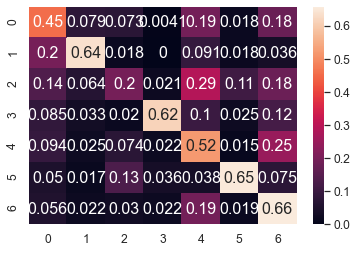

	training epoch=22 .. train_loss=1.086
	validation epoch=22 .. val_loss=1.277
	Accuracy = 52.800000000000004 % .. Percision = 50.1 % .. Recall = 53.300000000000004 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_22.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 23 .. loss = 1.022


  0%|                                                                                 | 1/1914 [00:01<39:30,  1.24s/it]

training @ epoch 23 .. loss = 1.213


  0%|                                                                                 | 2/1914 [00:02<39:20,  1.23s/it]

training @ epoch 23 .. loss = 0.977


  0%|▏                                                                                | 3/1914 [00:03<39:17,  1.23s/it]

training @ epoch 23 .. loss = 1.099


  0%|▏                                                                                | 4/1914 [00:04<39:16,  1.23s/it]

training @ epoch 23 .. loss = 1.26


  0%|▏                                                                                | 5/1914 [00:06<39:14,  1.23s/it]

training @ epoch 23 .. loss = 1.434


  0%|▎                                                                                | 6/1914 [00:07<39:36,  1.25s/it]

training @ epoch 23 .. loss = 1.107


  0%|▎                                                                                | 7/1914 [00:08<39:04,  1.23s/it]

training @ epoch 23 .. loss = 1.479


  0%|▎                                                                                | 8/1914 [00:09<39:17,  1.24s/it]

training @ epoch 23 .. loss = 1.158


  0%|▍                                                                                | 9/1914 [00:11<39:31,  1.24s/it]

training @ epoch 23 .. loss = 0.978


  1%|▍                                                                               | 10/1914 [00:12<39:17,  1.24s/it]

training @ epoch 23 .. loss = 0.838


  1%|▍                                                                               | 11/1914 [00:13<39:07,  1.23s/it]

training @ epoch 23 .. loss = 0.587


  1%|▌                                                                               | 12/1914 [00:14<39:16,  1.24s/it]

training @ epoch 23 .. loss = 1.435


  1%|▌                                                                               | 13/1914 [00:16<39:13,  1.24s/it]

training @ epoch 23 .. loss = 1.054


  1%|▌                                                                               | 14/1914 [00:17<39:20,  1.24s/it]

training @ epoch 23 .. loss = 1.037


  1%|▋                                                                               | 15/1914 [00:18<39:08,  1.24s/it]

training @ epoch 23 .. loss = 1.179


  1%|▋                                                                               | 16/1914 [00:19<39:44,  1.26s/it]

training @ epoch 23 .. loss = 1.133


  1%|▋                                                                               | 17/1914 [00:21<41:15,  1.30s/it]

training @ epoch 23 .. loss = 0.976


  1%|▊                                                                               | 18/1914 [00:22<41:35,  1.32s/it]

training @ epoch 23 .. loss = 0.881


  1%|▊                                                                               | 19/1914 [00:23<41:22,  1.31s/it]

training @ epoch 23 .. loss = 1.118


  1%|▊                                                                               | 20/1914 [00:25<40:22,  1.28s/it]

training @ epoch 23 .. loss = 1.216


  1%|▉                                                                               | 21/1914 [00:26<39:56,  1.27s/it]

training @ epoch 23 .. loss = 1.143


  1%|▉                                                                               | 22/1914 [00:27<39:54,  1.27s/it]

training @ epoch 23 .. loss = 0.921


  1%|▉                                                                               | 23/1914 [00:28<39:40,  1.26s/it]

training @ epoch 23 .. loss = 1.631


  1%|█                                                                               | 24/1914 [00:30<39:47,  1.26s/it]

training @ epoch 23 .. loss = 0.735


  1%|█                                                                               | 25/1914 [00:31<39:47,  1.26s/it]

training @ epoch 23 .. loss = 1.062


  1%|█                                                                               | 26/1914 [00:32<39:27,  1.25s/it]

training @ epoch 23 .. loss = 1.081


  1%|█▏                                                                              | 27/1914 [00:33<39:42,  1.26s/it]

training @ epoch 23 .. loss = 1.149


  1%|█▏                                                                              | 28/1914 [00:35<39:44,  1.26s/it]

training @ epoch 23 .. loss = 0.81


  2%|█▏                                                                              | 29/1914 [00:36<39:20,  1.25s/it]

training @ epoch 23 .. loss = 0.818


  2%|█▎                                                                              | 30/1914 [00:37<39:14,  1.25s/it]

training @ epoch 23 .. loss = 1.054


  2%|█▎                                                                              | 31/1914 [00:38<39:09,  1.25s/it]

training @ epoch 23 .. loss = 0.963


  2%|█▎                                                                              | 32/1914 [00:40<39:00,  1.24s/it]

training @ epoch 23 .. loss = 0.803


  2%|█▍                                                                              | 33/1914 [00:41<38:58,  1.24s/it]

training @ epoch 23 .. loss = 1.154


  2%|█▍                                                                              | 34/1914 [00:42<38:23,  1.23s/it]

training @ epoch 23 .. loss = 1.06


  2%|█▍                                                                              | 35/1914 [00:43<38:27,  1.23s/it]

training @ epoch 23 .. loss = 0.97


  2%|█▌                                                                              | 36/1914 [00:45<38:28,  1.23s/it]

training @ epoch 23 .. loss = 1.232


  2%|█▌                                                                              | 37/1914 [00:46<38:56,  1.24s/it]

training @ epoch 23 .. loss = 1.025


  2%|█▌                                                                              | 38/1914 [00:47<39:06,  1.25s/it]

training @ epoch 23 .. loss = 1.55


  2%|█▋                                                                              | 39/1914 [00:48<38:48,  1.24s/it]

training @ epoch 23 .. loss = 1.274


  2%|█▋                                                                              | 40/1914 [00:50<38:49,  1.24s/it]

training @ epoch 23 .. loss = 0.959


  2%|█▋                                                                              | 41/1914 [00:51<38:36,  1.24s/it]

training @ epoch 23 .. loss = 0.836


  2%|█▊                                                                              | 42/1914 [00:52<38:27,  1.23s/it]

training @ epoch 23 .. loss = 1.244


  2%|█▊                                                                              | 43/1914 [00:53<38:43,  1.24s/it]

training @ epoch 23 .. loss = 1.024


  2%|█▊                                                                              | 44/1914 [00:54<38:37,  1.24s/it]

training @ epoch 23 .. loss = 1.418


  2%|█▉                                                                              | 45/1914 [00:56<38:38,  1.24s/it]

training @ epoch 23 .. loss = 0.924


  2%|█▉                                                                              | 46/1914 [00:57<39:01,  1.25s/it]

training @ epoch 23 .. loss = 0.993


  2%|█▉                                                                              | 47/1914 [00:58<38:37,  1.24s/it]

training @ epoch 23 .. loss = 1.086


  3%|██                                                                              | 48/1914 [00:59<38:54,  1.25s/it]

training @ epoch 23 .. loss = 1.094


  3%|██                                                                              | 49/1914 [01:01<39:00,  1.25s/it]

training @ epoch 23 .. loss = 0.706


  3%|██                                                                              | 50/1914 [01:02<38:29,  1.24s/it]

training @ epoch 23 .. loss = 1.235


  3%|██▏                                                                             | 51/1914 [01:03<38:30,  1.24s/it]

training @ epoch 23 .. loss = 1.124


  3%|██▏                                                                             | 52/1914 [01:04<38:41,  1.25s/it]

training @ epoch 23 .. loss = 1.182


  3%|██▏                                                                             | 53/1914 [01:06<38:44,  1.25s/it]

training @ epoch 23 .. loss = 0.75


  3%|██▎                                                                             | 54/1914 [01:07<38:34,  1.24s/it]

training @ epoch 23 .. loss = 1.072


  3%|██▎                                                                             | 55/1914 [01:08<38:14,  1.23s/it]

training @ epoch 23 .. loss = 1.11


  3%|██▎                                                                             | 56/1914 [01:09<38:13,  1.23s/it]

training @ epoch 23 .. loss = 1.064


  3%|██▍                                                                             | 57/1914 [01:11<38:23,  1.24s/it]

training @ epoch 23 .. loss = 1.435


  3%|██▍                                                                             | 58/1914 [01:12<38:29,  1.24s/it]

training @ epoch 23 .. loss = 1.01


  3%|██▍                                                                             | 59/1914 [01:13<38:27,  1.24s/it]

training @ epoch 23 .. loss = 0.704


  3%|██▌                                                                             | 60/1914 [01:14<38:31,  1.25s/it]

training @ epoch 23 .. loss = 1.026


  3%|██▌                                                                             | 61/1914 [01:16<38:44,  1.25s/it]

training @ epoch 23 .. loss = 1.051


  3%|██▌                                                                             | 62/1914 [01:17<38:26,  1.25s/it]

training @ epoch 23 .. loss = 1.085


  3%|██▋                                                                             | 63/1914 [01:18<38:12,  1.24s/it]

training @ epoch 23 .. loss = 1.289


  3%|██▋                                                                             | 64/1914 [01:19<38:34,  1.25s/it]

training @ epoch 23 .. loss = 1.291


  3%|██▋                                                                             | 65/1914 [01:21<38:17,  1.24s/it]

training @ epoch 23 .. loss = 1.068


  3%|██▊                                                                             | 66/1914 [01:22<38:03,  1.24s/it]

training @ epoch 23 .. loss = 1.46


  4%|██▊                                                                             | 67/1914 [01:23<38:19,  1.24s/it]

training @ epoch 23 .. loss = 1.554


  4%|██▊                                                                             | 68/1914 [01:24<37:59,  1.24s/it]

training @ epoch 23 .. loss = 0.677


  4%|██▉                                                                             | 69/1914 [01:26<38:07,  1.24s/it]

training @ epoch 23 .. loss = 1.056


  4%|██▉                                                                             | 70/1914 [01:27<38:14,  1.24s/it]

training @ epoch 23 .. loss = 0.744


  4%|██▉                                                                             | 71/1914 [01:28<38:00,  1.24s/it]

training @ epoch 23 .. loss = 0.808


  4%|███                                                                             | 72/1914 [01:29<38:25,  1.25s/it]

training @ epoch 23 .. loss = 1.277


  4%|███                                                                             | 73/1914 [01:31<38:19,  1.25s/it]

training @ epoch 23 .. loss = 0.732


  4%|███                                                                             | 74/1914 [01:32<38:14,  1.25s/it]

training @ epoch 23 .. loss = 0.977


  4%|███▏                                                                            | 75/1914 [01:33<38:21,  1.25s/it]

training @ epoch 23 .. loss = 0.795


  4%|███▏                                                                            | 76/1914 [01:34<38:05,  1.24s/it]

training @ epoch 23 .. loss = 1.045


  4%|███▏                                                                            | 77/1914 [01:36<38:26,  1.26s/it]

training @ epoch 23 .. loss = 0.935


  4%|███▎                                                                            | 78/1914 [01:37<38:19,  1.25s/it]

training @ epoch 23 .. loss = 0.669


  4%|███▎                                                                            | 79/1914 [01:38<37:49,  1.24s/it]

training @ epoch 23 .. loss = 1.091


  4%|███▎                                                                            | 80/1914 [01:39<38:08,  1.25s/it]

training @ epoch 23 .. loss = 1.279


  4%|███▍                                                                            | 81/1914 [01:41<38:05,  1.25s/it]

training @ epoch 23 .. loss = 1.384


  4%|███▍                                                                            | 82/1914 [01:42<38:07,  1.25s/it]

training @ epoch 23 .. loss = 1.1


  4%|███▍                                                                            | 83/1914 [01:43<38:14,  1.25s/it]

training @ epoch 23 .. loss = 0.941


  4%|███▌                                                                            | 84/1914 [01:44<38:23,  1.26s/it]

training @ epoch 23 .. loss = 0.723


  4%|███▌                                                                            | 85/1914 [01:46<38:08,  1.25s/it]

training @ epoch 23 .. loss = 0.824


  4%|███▌                                                                            | 86/1914 [01:47<38:01,  1.25s/it]

training @ epoch 23 .. loss = 0.991


  5%|███▋                                                                            | 87/1914 [01:48<37:36,  1.23s/it]

training @ epoch 23 .. loss = 0.935


  5%|███▋                                                                            | 88/1914 [01:49<37:56,  1.25s/it]

training @ epoch 23 .. loss = 1.048


  5%|███▋                                                                            | 89/1914 [01:51<37:51,  1.24s/it]

training @ epoch 23 .. loss = 1.126


  5%|███▊                                                                            | 90/1914 [01:52<38:05,  1.25s/it]

training @ epoch 23 .. loss = 1.753


  5%|███▊                                                                            | 91/1914 [01:53<37:43,  1.24s/it]

training @ epoch 23 .. loss = 1.319


  5%|███▊                                                                            | 92/1914 [01:54<37:48,  1.24s/it]

training @ epoch 23 .. loss = 0.694


  5%|███▉                                                                            | 93/1914 [01:56<37:50,  1.25s/it]

training @ epoch 23 .. loss = 1.304


  5%|███▉                                                                            | 94/1914 [01:57<38:03,  1.25s/it]

training @ epoch 23 .. loss = 0.802


  5%|███▉                                                                            | 95/1914 [01:58<37:36,  1.24s/it]

training @ epoch 23 .. loss = 1.171


  5%|████                                                                            | 96/1914 [01:59<37:30,  1.24s/it]

training @ epoch 23 .. loss = 1.062


  5%|████                                                                            | 97/1914 [02:00<37:37,  1.24s/it]

training @ epoch 23 .. loss = 1.235


  5%|████                                                                            | 98/1914 [02:02<38:54,  1.29s/it]

training @ epoch 23 .. loss = 0.994


  5%|████▏                                                                           | 99/1914 [02:03<38:25,  1.27s/it]

training @ epoch 23 .. loss = 0.986


  5%|████▏                                                                          | 100/1914 [02:04<37:47,  1.25s/it]

training @ epoch 23 .. loss = 1.466


  5%|████▏                                                                          | 101/1914 [02:06<37:53,  1.25s/it]

training @ epoch 23 .. loss = 1.217


  5%|████▏                                                                          | 102/1914 [02:07<37:57,  1.26s/it]

training @ epoch 23 .. loss = 1.28


  5%|████▎                                                                          | 103/1914 [02:08<37:21,  1.24s/it]

training @ epoch 23 .. loss = 1.005


  5%|████▎                                                                          | 104/1914 [02:09<37:24,  1.24s/it]

training @ epoch 23 .. loss = 0.921


  5%|████▎                                                                          | 105/1914 [02:11<37:24,  1.24s/it]

training @ epoch 23 .. loss = 1.182


  6%|████▍                                                                          | 106/1914 [02:12<37:25,  1.24s/it]

training @ epoch 23 .. loss = 0.893


  6%|████▍                                                                          | 107/1914 [02:13<37:23,  1.24s/it]

training @ epoch 23 .. loss = 0.87


  6%|████▍                                                                          | 108/1914 [02:14<37:01,  1.23s/it]

training @ epoch 23 .. loss = 0.842


  6%|████▍                                                                          | 109/1914 [02:15<37:02,  1.23s/it]

training @ epoch 23 .. loss = 0.941


  6%|████▌                                                                          | 110/1914 [02:17<37:24,  1.24s/it]

training @ epoch 23 .. loss = 1.298


  6%|████▌                                                                          | 111/1914 [02:18<37:17,  1.24s/it]

training @ epoch 23 .. loss = 0.724


  6%|████▌                                                                          | 112/1914 [02:19<37:22,  1.24s/it]

training @ epoch 23 .. loss = 1.253


  6%|████▋                                                                          | 113/1914 [02:20<37:20,  1.24s/it]

training @ epoch 23 .. loss = 0.966


  6%|████▋                                                                          | 114/1914 [02:22<37:30,  1.25s/it]

training @ epoch 23 .. loss = 0.719


  6%|████▋                                                                          | 115/1914 [02:23<37:30,  1.25s/it]

training @ epoch 23 .. loss = 1.174


  6%|████▊                                                                          | 116/1914 [02:24<37:07,  1.24s/it]

training @ epoch 23 .. loss = 1.216


  6%|████▊                                                                          | 117/1914 [02:25<37:03,  1.24s/it]

training @ epoch 23 .. loss = 1.172


  6%|████▊                                                                          | 118/1914 [02:27<37:13,  1.24s/it]

training @ epoch 23 .. loss = 1.395


  6%|████▉                                                                          | 119/1914 [02:28<37:02,  1.24s/it]

training @ epoch 23 .. loss = 1.389


  6%|████▉                                                                          | 120/1914 [02:29<38:09,  1.28s/it]

training @ epoch 23 .. loss = 1.15


  6%|████▉                                                                          | 121/1914 [02:31<38:32,  1.29s/it]

training @ epoch 23 .. loss = 0.88


  6%|█████                                                                          | 122/1914 [02:32<38:06,  1.28s/it]

training @ epoch 23 .. loss = 0.768


  6%|█████                                                                          | 123/1914 [02:33<38:15,  1.28s/it]

training @ epoch 23 .. loss = 1.228


  6%|█████                                                                          | 124/1914 [02:34<38:02,  1.28s/it]

training @ epoch 23 .. loss = 1.185


  7%|█████▏                                                                         | 125/1914 [02:36<38:06,  1.28s/it]

training @ epoch 23 .. loss = 1.22


  7%|█████▏                                                                         | 126/1914 [02:37<37:57,  1.27s/it]

training @ epoch 23 .. loss = 1.461


  7%|█████▏                                                                         | 127/1914 [02:38<37:23,  1.26s/it]

training @ epoch 23 .. loss = 0.935


  7%|█████▎                                                                         | 128/1914 [02:39<37:43,  1.27s/it]

training @ epoch 23 .. loss = 0.814


  7%|█████▎                                                                         | 129/1914 [02:41<37:35,  1.26s/it]

training @ epoch 23 .. loss = 0.978


  7%|█████▎                                                                         | 130/1914 [02:42<37:21,  1.26s/it]

training @ epoch 23 .. loss = 1.12


  7%|█████▍                                                                         | 131/1914 [02:43<37:28,  1.26s/it]

training @ epoch 23 .. loss = 1.307


  7%|█████▍                                                                         | 132/1914 [02:44<37:20,  1.26s/it]

training @ epoch 23 .. loss = 1.273


  7%|█████▍                                                                         | 133/1914 [02:46<37:11,  1.25s/it]

training @ epoch 23 .. loss = 1.322


  7%|█████▌                                                                         | 134/1914 [02:47<37:11,  1.25s/it]

training @ epoch 23 .. loss = 0.956


  7%|█████▌                                                                         | 135/1914 [02:48<36:43,  1.24s/it]

training @ epoch 23 .. loss = 1.094


  7%|█████▌                                                                         | 136/1914 [02:49<36:48,  1.24s/it]

training @ epoch 23 .. loss = 1.142


  7%|█████▋                                                                         | 137/1914 [02:51<37:20,  1.26s/it]

training @ epoch 23 .. loss = 1.11


  7%|█████▋                                                                         | 138/1914 [02:52<36:48,  1.24s/it]

training @ epoch 23 .. loss = 1.181


  7%|█████▋                                                                         | 139/1914 [02:53<37:18,  1.26s/it]

training @ epoch 23 .. loss = 1.394


  7%|█████▊                                                                         | 140/1914 [02:54<37:13,  1.26s/it]

training @ epoch 23 .. loss = 0.813


  7%|█████▊                                                                         | 141/1914 [02:56<37:19,  1.26s/it]

training @ epoch 23 .. loss = 1.272


  7%|█████▊                                                                         | 142/1914 [02:57<37:02,  1.25s/it]

training @ epoch 23 .. loss = 0.833


  7%|█████▉                                                                         | 143/1914 [02:58<36:39,  1.24s/it]

training @ epoch 23 .. loss = 0.747


  8%|█████▉                                                                         | 144/1914 [02:59<36:49,  1.25s/it]

training @ epoch 23 .. loss = 0.809


  8%|█████▉                                                                         | 145/1914 [03:01<36:55,  1.25s/it]

training @ epoch 23 .. loss = 1.401


  8%|██████                                                                         | 146/1914 [03:02<36:44,  1.25s/it]

training @ epoch 23 .. loss = 0.995


  8%|██████                                                                         | 147/1914 [03:03<36:29,  1.24s/it]

training @ epoch 23 .. loss = 1.309


  8%|██████                                                                         | 148/1914 [03:04<36:24,  1.24s/it]

training @ epoch 23 .. loss = 1.11


  8%|██████▏                                                                        | 149/1914 [03:06<36:44,  1.25s/it]

training @ epoch 23 .. loss = 0.893


  8%|██████▏                                                                        | 150/1914 [03:07<36:34,  1.24s/it]

training @ epoch 23 .. loss = 1.131


  8%|██████▏                                                                        | 151/1914 [03:08<36:48,  1.25s/it]

training @ epoch 23 .. loss = 0.93


  8%|██████▎                                                                        | 152/1914 [03:09<37:02,  1.26s/it]

training @ epoch 23 .. loss = 0.984


  8%|██████▎                                                                        | 153/1914 [03:11<37:03,  1.26s/it]

training @ epoch 23 .. loss = 1.252


  8%|██████▎                                                                        | 154/1914 [03:12<36:35,  1.25s/it]

training @ epoch 23 .. loss = 0.83


  8%|██████▍                                                                        | 155/1914 [03:13<36:37,  1.25s/it]

training @ epoch 23 .. loss = 0.969


  8%|██████▍                                                                        | 156/1914 [03:14<36:33,  1.25s/it]

training @ epoch 23 .. loss = 0.798


  8%|██████▍                                                                        | 157/1914 [03:16<36:39,  1.25s/it]

training @ epoch 23 .. loss = 1.473


  8%|██████▌                                                                        | 158/1914 [03:17<36:50,  1.26s/it]

training @ epoch 23 .. loss = 1.067


  8%|██████▌                                                                        | 159/1914 [03:18<36:12,  1.24s/it]

training @ epoch 23 .. loss = 1.776


  8%|██████▌                                                                        | 160/1914 [03:19<36:52,  1.26s/it]

training @ epoch 23 .. loss = 0.902


  8%|██████▋                                                                        | 161/1914 [03:21<36:46,  1.26s/it]

training @ epoch 23 .. loss = 1.021


  8%|██████▋                                                                        | 162/1914 [03:22<36:25,  1.25s/it]

training @ epoch 23 .. loss = 1.052


  9%|██████▋                                                                        | 163/1914 [03:23<36:20,  1.25s/it]

training @ epoch 23 .. loss = 0.747


  9%|██████▊                                                                        | 164/1914 [03:24<36:29,  1.25s/it]

training @ epoch 23 .. loss = 0.82


  9%|██████▊                                                                        | 165/1914 [03:26<36:18,  1.25s/it]

training @ epoch 23 .. loss = 0.988


  9%|██████▊                                                                        | 166/1914 [03:27<36:16,  1.25s/it]

training @ epoch 23 .. loss = 0.967


  9%|██████▉                                                                        | 167/1914 [03:28<35:58,  1.24s/it]

training @ epoch 23 .. loss = 0.975


  9%|██████▉                                                                        | 168/1914 [03:29<36:12,  1.24s/it]

training @ epoch 23 .. loss = 1.042


  9%|██████▉                                                                        | 169/1914 [03:31<36:15,  1.25s/it]

training @ epoch 23 .. loss = 1.437


  9%|███████                                                                        | 170/1914 [03:32<35:50,  1.23s/it]

training @ epoch 23 .. loss = 1.242


  9%|███████                                                                        | 171/1914 [03:33<36:05,  1.24s/it]

training @ epoch 23 .. loss = 1.136


  9%|███████                                                                        | 172/1914 [03:34<36:20,  1.25s/it]

training @ epoch 23 .. loss = 1.044


  9%|███████▏                                                                       | 173/1914 [03:36<36:25,  1.26s/it]

training @ epoch 23 .. loss = 1.058


  9%|███████▏                                                                       | 174/1914 [03:37<36:27,  1.26s/it]

training @ epoch 23 .. loss = 1.137


  9%|███████▏                                                                       | 175/1914 [03:38<36:14,  1.25s/it]

training @ epoch 23 .. loss = 1.597


  9%|███████▎                                                                       | 176/1914 [03:39<36:14,  1.25s/it]

training @ epoch 23 .. loss = 1.407


  9%|███████▎                                                                       | 177/1914 [03:41<36:13,  1.25s/it]

training @ epoch 23 .. loss = 0.92


  9%|███████▎                                                                       | 178/1914 [03:42<35:58,  1.24s/it]

training @ epoch 23 .. loss = 1.64


  9%|███████▍                                                                       | 179/1914 [03:43<36:11,  1.25s/it]

training @ epoch 23 .. loss = 0.936


  9%|███████▍                                                                       | 180/1914 [03:44<36:12,  1.25s/it]

training @ epoch 23 .. loss = 1.315


  9%|███████▍                                                                       | 181/1914 [03:46<36:16,  1.26s/it]

training @ epoch 23 .. loss = 0.903


 10%|███████▌                                                                       | 182/1914 [03:47<36:16,  1.26s/it]

training @ epoch 23 .. loss = 1.292


 10%|███████▌                                                                       | 183/1914 [03:48<36:29,  1.26s/it]

training @ epoch 23 .. loss = 0.826


 10%|███████▌                                                                       | 184/1914 [03:49<36:22,  1.26s/it]

training @ epoch 23 .. loss = 0.959


 10%|███████▋                                                                       | 185/1914 [03:51<36:14,  1.26s/it]

training @ epoch 23 .. loss = 1.407


 10%|███████▋                                                                       | 186/1914 [03:52<36:06,  1.25s/it]

training @ epoch 23 .. loss = 1.041


 10%|███████▋                                                                       | 187/1914 [03:53<36:04,  1.25s/it]

training @ epoch 23 .. loss = 1.306


 10%|███████▊                                                                       | 188/1914 [03:54<36:03,  1.25s/it]

training @ epoch 23 .. loss = 0.961


 10%|███████▊                                                                       | 189/1914 [03:56<35:46,  1.24s/it]

training @ epoch 23 .. loss = 0.873


 10%|███████▊                                                                       | 190/1914 [03:57<37:02,  1.29s/it]

training @ epoch 23 .. loss = 0.771


 10%|███████▉                                                                       | 191/1914 [03:59<38:42,  1.35s/it]

training @ epoch 23 .. loss = 0.943


 10%|███████▉                                                                       | 192/1914 [04:00<38:49,  1.35s/it]

training @ epoch 23 .. loss = 0.835


 10%|███████▉                                                                       | 193/1914 [04:01<38:17,  1.34s/it]

training @ epoch 23 .. loss = 1.275


 10%|████████                                                                       | 194/1914 [04:02<37:18,  1.30s/it]

training @ epoch 23 .. loss = 1.06


 10%|████████                                                                       | 195/1914 [04:04<36:52,  1.29s/it]

training @ epoch 23 .. loss = 1.152


 10%|████████                                                                       | 196/1914 [04:05<36:37,  1.28s/it]

training @ epoch 23 .. loss = 0.632


 10%|████████▏                                                                      | 197/1914 [04:06<36:18,  1.27s/it]

training @ epoch 23 .. loss = 1.046


 10%|████████▏                                                                      | 198/1914 [04:07<36:08,  1.26s/it]

training @ epoch 23 .. loss = 1.312


 10%|████████▏                                                                      | 199/1914 [04:09<35:56,  1.26s/it]

training @ epoch 23 .. loss = 1.304


 10%|████████▎                                                                      | 200/1914 [04:10<35:37,  1.25s/it]

training @ epoch 23 .. loss = 1.103


 11%|████████▎                                                                      | 201/1914 [04:11<35:37,  1.25s/it]

training @ epoch 23 .. loss = 0.949


 11%|████████▎                                                                      | 202/1914 [04:12<35:27,  1.24s/it]

training @ epoch 23 .. loss = 1.277


 11%|████████▍                                                                      | 203/1914 [04:14<35:42,  1.25s/it]

training @ epoch 23 .. loss = 0.981


 11%|████████▍                                                                      | 204/1914 [04:15<35:36,  1.25s/it]

training @ epoch 23 .. loss = 1.032


 11%|████████▍                                                                      | 205/1914 [04:16<35:26,  1.24s/it]

training @ epoch 23 .. loss = 1.039


 11%|████████▌                                                                      | 206/1914 [04:17<35:39,  1.25s/it]

training @ epoch 23 .. loss = 0.957


 11%|████████▌                                                                      | 207/1914 [04:19<35:12,  1.24s/it]

training @ epoch 23 .. loss = 1.055


 11%|████████▌                                                                      | 208/1914 [04:20<35:02,  1.23s/it]

training @ epoch 23 .. loss = 0.911


 11%|████████▋                                                                      | 209/1914 [04:21<35:34,  1.25s/it]

training @ epoch 23 .. loss = 0.979


 11%|████████▋                                                                      | 210/1914 [04:22<35:21,  1.25s/it]

training @ epoch 23 .. loss = 1.085


 11%|████████▋                                                                      | 211/1914 [04:24<35:25,  1.25s/it]

training @ epoch 23 .. loss = 1.063


 11%|████████▊                                                                      | 212/1914 [04:25<35:26,  1.25s/it]

training @ epoch 23 .. loss = 0.876


 11%|████████▊                                                                      | 213/1914 [04:26<34:51,  1.23s/it]

training @ epoch 23 .. loss = 0.914


 11%|████████▊                                                                      | 214/1914 [04:27<36:04,  1.27s/it]

training @ epoch 23 .. loss = 0.942


 11%|████████▊                                                                      | 215/1914 [04:29<36:59,  1.31s/it]

training @ epoch 23 .. loss = 0.844


 11%|████████▉                                                                      | 216/1914 [04:30<36:46,  1.30s/it]

training @ epoch 23 .. loss = 0.862


 11%|████████▉                                                                      | 217/1914 [04:31<36:16,  1.28s/it]

training @ epoch 23 .. loss = 0.895


 11%|████████▉                                                                      | 218/1914 [04:33<36:11,  1.28s/it]

training @ epoch 23 .. loss = 1.234


 11%|█████████                                                                      | 219/1914 [04:34<35:51,  1.27s/it]

training @ epoch 23 .. loss = 1.014


 11%|█████████                                                                      | 220/1914 [04:35<35:42,  1.26s/it]

training @ epoch 23 .. loss = 1.509


 12%|█████████                                                                      | 221/1914 [04:36<35:29,  1.26s/it]

training @ epoch 23 .. loss = 1.133


 12%|█████████▏                                                                     | 222/1914 [04:38<35:35,  1.26s/it]

training @ epoch 23 .. loss = 0.828


 12%|█████████▏                                                                     | 223/1914 [04:39<35:10,  1.25s/it]

training @ epoch 23 .. loss = 0.993


 12%|█████████▏                                                                     | 224/1914 [04:40<34:56,  1.24s/it]

training @ epoch 23 .. loss = 1.061


 12%|█████████▎                                                                     | 225/1914 [04:41<35:02,  1.24s/it]

training @ epoch 23 .. loss = 1.102


 12%|█████████▎                                                                     | 226/1914 [04:43<35:15,  1.25s/it]

training @ epoch 23 .. loss = 1.626


 12%|█████████▎                                                                     | 227/1914 [04:44<35:04,  1.25s/it]

training @ epoch 23 .. loss = 1.413


 12%|█████████▍                                                                     | 228/1914 [04:45<35:11,  1.25s/it]

training @ epoch 23 .. loss = 1.17


 12%|█████████▍                                                                     | 229/1914 [04:46<35:15,  1.26s/it]

training @ epoch 23 .. loss = 0.77


 12%|█████████▍                                                                     | 230/1914 [04:48<35:02,  1.25s/it]

training @ epoch 23 .. loss = 0.831


 12%|█████████▌                                                                     | 231/1914 [04:49<35:19,  1.26s/it]

training @ epoch 23 .. loss = 0.914


 12%|█████████▌                                                                     | 232/1914 [04:50<34:59,  1.25s/it]

training @ epoch 23 .. loss = 1.146


 12%|█████████▌                                                                     | 233/1914 [04:51<35:06,  1.25s/it]

training @ epoch 23 .. loss = 0.785


 12%|█████████▋                                                                     | 234/1914 [04:53<34:55,  1.25s/it]

training @ epoch 23 .. loss = 1.187


 12%|█████████▋                                                                     | 235/1914 [04:54<34:41,  1.24s/it]

training @ epoch 23 .. loss = 1.265


 12%|█████████▋                                                                     | 236/1914 [04:55<34:46,  1.24s/it]

training @ epoch 23 .. loss = 1.224


 12%|█████████▊                                                                     | 237/1914 [04:56<34:45,  1.24s/it]

training @ epoch 23 .. loss = 0.517


 12%|█████████▊                                                                     | 238/1914 [04:58<34:48,  1.25s/it]

training @ epoch 23 .. loss = 1.169


 12%|█████████▊                                                                     | 239/1914 [04:59<34:47,  1.25s/it]

training @ epoch 23 .. loss = 0.711


 13%|█████████▉                                                                     | 240/1914 [05:00<36:45,  1.32s/it]

training @ epoch 23 .. loss = 1.063


 13%|█████████▉                                                                     | 241/1914 [05:02<38:03,  1.36s/it]

training @ epoch 23 .. loss = 1.022


 13%|█████████▉                                                                     | 242/1914 [05:03<38:59,  1.40s/it]

training @ epoch 23 .. loss = 1.162


 13%|██████████                                                                     | 243/1914 [05:05<38:51,  1.40s/it]

training @ epoch 23 .. loss = 0.683


 13%|██████████                                                                     | 244/1914 [05:06<37:33,  1.35s/it]

training @ epoch 23 .. loss = 0.999


 13%|██████████                                                                     | 245/1914 [05:07<36:57,  1.33s/it]

training @ epoch 23 .. loss = 0.84


 13%|██████████▏                                                                    | 246/1914 [05:08<36:29,  1.31s/it]

training @ epoch 23 .. loss = 0.977


 13%|██████████▏                                                                    | 247/1914 [05:10<36:08,  1.30s/it]

training @ epoch 23 .. loss = 0.985


 13%|██████████▏                                                                    | 248/1914 [05:11<36:03,  1.30s/it]

training @ epoch 23 .. loss = 1.199


 13%|██████████▎                                                                    | 249/1914 [05:12<35:39,  1.28s/it]

training @ epoch 23 .. loss = 0.626


 13%|██████████▎                                                                    | 250/1914 [05:14<35:33,  1.28s/it]

training @ epoch 23 .. loss = 0.893


 13%|██████████▎                                                                    | 251/1914 [05:15<35:32,  1.28s/it]

training @ epoch 23 .. loss = 0.896


 13%|██████████▍                                                                    | 252/1914 [05:16<34:50,  1.26s/it]

training @ epoch 23 .. loss = 1.144


 13%|██████████▍                                                                    | 253/1914 [05:17<34:47,  1.26s/it]

training @ epoch 23 .. loss = 0.997


 13%|██████████▍                                                                    | 254/1914 [05:19<34:44,  1.26s/it]

training @ epoch 23 .. loss = 1.1


 13%|██████████▌                                                                    | 255/1914 [05:20<35:11,  1.27s/it]

training @ epoch 23 .. loss = 1.034


 13%|██████████▌                                                                    | 256/1914 [05:21<35:01,  1.27s/it]

training @ epoch 23 .. loss = 0.558


 13%|██████████▌                                                                    | 257/1914 [05:22<34:51,  1.26s/it]

training @ epoch 23 .. loss = 1.027


 13%|██████████▋                                                                    | 258/1914 [05:24<34:46,  1.26s/it]

training @ epoch 23 .. loss = 1.084


 14%|██████████▋                                                                    | 259/1914 [05:25<34:36,  1.25s/it]

training @ epoch 23 .. loss = 0.664


 14%|██████████▋                                                                    | 260/1914 [05:26<34:19,  1.25s/it]

training @ epoch 23 .. loss = 0.717


 14%|██████████▊                                                                    | 261/1914 [05:27<34:27,  1.25s/it]

training @ epoch 23 .. loss = 0.987


 14%|██████████▊                                                                    | 262/1914 [05:29<34:17,  1.25s/it]

training @ epoch 23 .. loss = 1.019


 14%|██████████▊                                                                    | 263/1914 [05:30<34:20,  1.25s/it]

training @ epoch 23 .. loss = 1.254


 14%|██████████▉                                                                    | 264/1914 [05:31<34:35,  1.26s/it]

training @ epoch 23 .. loss = 0.949


 14%|██████████▉                                                                    | 265/1914 [05:32<34:18,  1.25s/it]

training @ epoch 23 .. loss = 1.296


 14%|██████████▉                                                                    | 266/1914 [05:34<34:38,  1.26s/it]

training @ epoch 23 .. loss = 0.941


 14%|███████████                                                                    | 267/1914 [05:35<34:23,  1.25s/it]

training @ epoch 23 .. loss = 1.09


 14%|███████████                                                                    | 268/1914 [05:36<34:18,  1.25s/it]

training @ epoch 23 .. loss = 1.022


 14%|███████████                                                                    | 269/1914 [05:37<34:33,  1.26s/it]

training @ epoch 23 .. loss = 1.051


 14%|███████████▏                                                                   | 270/1914 [05:39<34:52,  1.27s/it]

training @ epoch 23 .. loss = 1.28


 14%|███████████▏                                                                   | 271/1914 [05:40<34:12,  1.25s/it]

training @ epoch 23 .. loss = 0.721


 14%|███████████▏                                                                   | 272/1914 [05:41<34:13,  1.25s/it]

training @ epoch 23 .. loss = 1.162


 14%|███████████▎                                                                   | 273/1914 [05:42<34:12,  1.25s/it]

training @ epoch 23 .. loss = 1.176


 14%|███████████▎                                                                   | 274/1914 [05:44<34:07,  1.25s/it]

training @ epoch 23 .. loss = 1.177


 14%|███████████▎                                                                   | 275/1914 [05:45<34:28,  1.26s/it]

training @ epoch 23 .. loss = 1.099


 14%|███████████▍                                                                   | 276/1914 [05:46<34:24,  1.26s/it]

training @ epoch 23 .. loss = 0.713


 14%|███████████▍                                                                   | 277/1914 [05:47<34:24,  1.26s/it]

training @ epoch 23 .. loss = 1.257


 15%|███████████▍                                                                   | 278/1914 [05:49<34:53,  1.28s/it]

training @ epoch 23 .. loss = 0.939


 15%|███████████▌                                                                   | 279/1914 [05:50<34:15,  1.26s/it]

training @ epoch 23 .. loss = 0.878


 15%|███████████▌                                                                   | 280/1914 [05:51<34:31,  1.27s/it]

training @ epoch 23 .. loss = 1.185


 15%|███████████▌                                                                   | 281/1914 [05:53<34:18,  1.26s/it]

training @ epoch 23 .. loss = 1.289


 15%|███████████▋                                                                   | 282/1914 [05:54<34:09,  1.26s/it]

training @ epoch 23 .. loss = 0.32


 15%|███████████▋                                                                   | 283/1914 [05:55<33:55,  1.25s/it]

training @ epoch 23 .. loss = 0.883


 15%|███████████▋                                                                   | 284/1914 [05:56<33:52,  1.25s/it]

training @ epoch 23 .. loss = 0.59


 15%|███████████▊                                                                   | 285/1914 [05:58<34:09,  1.26s/it]

training @ epoch 23 .. loss = 1.198


 15%|███████████▊                                                                   | 286/1914 [05:59<34:06,  1.26s/it]

training @ epoch 23 .. loss = 1.007


 15%|███████████▊                                                                   | 287/1914 [06:00<34:03,  1.26s/it]

training @ epoch 23 .. loss = 1.067


 15%|███████████▉                                                                   | 288/1914 [06:01<34:25,  1.27s/it]

training @ epoch 23 .. loss = 0.872


 15%|███████████▉                                                                   | 289/1914 [06:03<34:30,  1.27s/it]

training @ epoch 23 .. loss = 1.33


 15%|███████████▉                                                                   | 290/1914 [06:04<34:17,  1.27s/it]

training @ epoch 23 .. loss = 1.03


 15%|████████████                                                                   | 291/1914 [06:05<34:05,  1.26s/it]

training @ epoch 23 .. loss = 1.374


 15%|████████████                                                                   | 292/1914 [06:06<34:10,  1.26s/it]

training @ epoch 23 .. loss = 1.14


 15%|████████████                                                                   | 293/1914 [06:08<34:04,  1.26s/it]

training @ epoch 23 .. loss = 0.834


 15%|████████████▏                                                                  | 294/1914 [06:09<33:29,  1.24s/it]

training @ epoch 23 .. loss = 0.916


 15%|████████████▏                                                                  | 295/1914 [06:10<33:24,  1.24s/it]

training @ epoch 23 .. loss = 0.778


 15%|████████████▏                                                                  | 296/1914 [06:11<33:59,  1.26s/it]

training @ epoch 23 .. loss = 1.269


 16%|████████████▎                                                                  | 297/1914 [06:13<33:59,  1.26s/it]

training @ epoch 23 .. loss = 0.85


 16%|████████████▎                                                                  | 298/1914 [06:14<33:35,  1.25s/it]

training @ epoch 23 .. loss = 0.895


 16%|████████████▎                                                                  | 299/1914 [06:15<33:41,  1.25s/it]

training @ epoch 23 .. loss = 1.104


 16%|████████████▍                                                                  | 300/1914 [06:16<33:37,  1.25s/it]

training @ epoch 23 .. loss = 1.311


 16%|████████████▍                                                                  | 301/1914 [06:18<33:36,  1.25s/it]

training @ epoch 23 .. loss = 1.032


 16%|████████████▍                                                                  | 302/1914 [06:19<33:28,  1.25s/it]

training @ epoch 23 .. loss = 1.038


 16%|████████████▌                                                                  | 303/1914 [06:20<33:15,  1.24s/it]

training @ epoch 23 .. loss = 0.864


 16%|████████████▌                                                                  | 304/1914 [06:21<33:36,  1.25s/it]

training @ epoch 23 .. loss = 0.729


 16%|████████████▌                                                                  | 305/1914 [06:23<33:35,  1.25s/it]

training @ epoch 23 .. loss = 1.204


 16%|████████████▋                                                                  | 306/1914 [06:24<33:19,  1.24s/it]

training @ epoch 23 .. loss = 0.78


 16%|████████████▋                                                                  | 307/1914 [06:25<33:37,  1.26s/it]

training @ epoch 23 .. loss = 1.064


 16%|████████████▋                                                                  | 308/1914 [06:26<33:39,  1.26s/it]

training @ epoch 23 .. loss = 1.341


 16%|████████████▊                                                                  | 309/1914 [06:28<33:46,  1.26s/it]

training @ epoch 23 .. loss = 0.848


 16%|████████████▊                                                                  | 310/1914 [06:29<33:28,  1.25s/it]

training @ epoch 23 .. loss = 0.953


 16%|████████████▊                                                                  | 311/1914 [06:30<33:38,  1.26s/it]

training @ epoch 23 .. loss = 1.079


 16%|████████████▉                                                                  | 312/1914 [06:31<33:44,  1.26s/it]

training @ epoch 23 .. loss = 1.409


 16%|████████████▉                                                                  | 313/1914 [06:33<33:41,  1.26s/it]

training @ epoch 23 .. loss = 1.223


 16%|████████████▉                                                                  | 314/1914 [06:34<33:30,  1.26s/it]

training @ epoch 23 .. loss = 1.065


 16%|█████████████                                                                  | 315/1914 [06:35<33:37,  1.26s/it]

training @ epoch 23 .. loss = 1.246


 17%|█████████████                                                                  | 316/1914 [06:36<33:32,  1.26s/it]

training @ epoch 23 .. loss = 2.165


 17%|█████████████                                                                  | 317/1914 [06:38<33:27,  1.26s/it]

training @ epoch 23 .. loss = 0.969


 17%|█████████████▏                                                                 | 318/1914 [06:39<33:25,  1.26s/it]

training @ epoch 23 .. loss = 0.833


 17%|█████████████▏                                                                 | 319/1914 [06:40<33:13,  1.25s/it]

training @ epoch 23 .. loss = 1.213


 17%|█████████████▏                                                                 | 320/1914 [06:41<33:28,  1.26s/it]

training @ epoch 23 .. loss = 0.715


 17%|█████████████▏                                                                 | 321/1914 [06:43<33:38,  1.27s/it]

training @ epoch 23 .. loss = 1.084


 17%|█████████████▎                                                                 | 322/1914 [06:44<33:14,  1.25s/it]

training @ epoch 23 .. loss = 0.841


 17%|█████████████▎                                                                 | 323/1914 [06:45<33:18,  1.26s/it]

training @ epoch 23 .. loss = 0.939


 17%|█████████████▎                                                                 | 324/1914 [06:47<33:25,  1.26s/it]

training @ epoch 23 .. loss = 1.08


 17%|█████████████▍                                                                 | 325/1914 [06:48<33:15,  1.26s/it]

training @ epoch 23 .. loss = 1.042


 17%|█████████████▍                                                                 | 326/1914 [06:49<33:14,  1.26s/it]

training @ epoch 23 .. loss = 1.111


 17%|█████████████▍                                                                 | 327/1914 [06:50<33:18,  1.26s/it]

training @ epoch 23 .. loss = 1.109


 17%|█████████████▌                                                                 | 328/1914 [06:52<33:34,  1.27s/it]

training @ epoch 23 .. loss = 1.039


 17%|█████████████▌                                                                 | 329/1914 [06:53<33:24,  1.26s/it]

training @ epoch 23 .. loss = 1.326


 17%|█████████████▌                                                                 | 330/1914 [06:54<33:04,  1.25s/it]

training @ epoch 23 .. loss = 0.818


 17%|█████████████▋                                                                 | 331/1914 [06:55<33:22,  1.27s/it]

training @ epoch 23 .. loss = 0.555


 17%|█████████████▋                                                                 | 332/1914 [06:57<33:01,  1.25s/it]

training @ epoch 23 .. loss = 1.251


 17%|█████████████▋                                                                 | 333/1914 [06:58<32:41,  1.24s/it]

training @ epoch 23 .. loss = 0.74


 17%|█████████████▊                                                                 | 334/1914 [06:59<32:55,  1.25s/it]

training @ epoch 23 .. loss = 1.014


 18%|█████████████▊                                                                 | 335/1914 [07:00<32:40,  1.24s/it]

training @ epoch 23 .. loss = 1.437


 18%|█████████████▊                                                                 | 336/1914 [07:02<32:54,  1.25s/it]

training @ epoch 23 .. loss = 0.784


 18%|█████████████▉                                                                 | 337/1914 [07:03<33:08,  1.26s/it]

training @ epoch 23 .. loss = 1.118


 18%|█████████████▉                                                                 | 338/1914 [07:04<32:47,  1.25s/it]

training @ epoch 23 .. loss = 0.832


 18%|█████████████▉                                                                 | 339/1914 [07:05<32:44,  1.25s/it]

training @ epoch 23 .. loss = 0.823


 18%|██████████████                                                                 | 340/1914 [07:07<32:45,  1.25s/it]

training @ epoch 23 .. loss = 0.919


 18%|██████████████                                                                 | 341/1914 [07:08<32:46,  1.25s/it]

training @ epoch 23 .. loss = 1.096


 18%|██████████████                                                                 | 342/1914 [07:09<32:42,  1.25s/it]

training @ epoch 23 .. loss = 1.138


 18%|██████████████▏                                                                | 343/1914 [07:10<32:24,  1.24s/it]

training @ epoch 23 .. loss = 1.006


 18%|██████████████▏                                                                | 344/1914 [07:12<32:43,  1.25s/it]

training @ epoch 23 .. loss = 1.44


 18%|██████████████▏                                                                | 345/1914 [07:13<32:30,  1.24s/it]

training @ epoch 23 .. loss = 0.711


 18%|██████████████▎                                                                | 346/1914 [07:14<32:19,  1.24s/it]

training @ epoch 23 .. loss = 1.241


 18%|██████████████▎                                                                | 347/1914 [07:15<32:25,  1.24s/it]

training @ epoch 23 .. loss = 1.673


 18%|██████████████▎                                                                | 348/1914 [07:16<32:20,  1.24s/it]

training @ epoch 23 .. loss = 1.616


 18%|██████████████▍                                                                | 349/1914 [07:18<32:34,  1.25s/it]

training @ epoch 23 .. loss = 1.124


 18%|██████████████▍                                                                | 350/1914 [07:19<32:19,  1.24s/it]

training @ epoch 23 .. loss = 0.982


 18%|██████████████▍                                                                | 351/1914 [07:20<32:15,  1.24s/it]

training @ epoch 23 .. loss = 1.024


 18%|██████████████▌                                                                | 352/1914 [07:21<32:26,  1.25s/it]

training @ epoch 23 .. loss = 1.042


 18%|██████████████▌                                                                | 353/1914 [07:23<32:23,  1.25s/it]

training @ epoch 23 .. loss = 1.274


 18%|██████████████▌                                                                | 354/1914 [07:24<32:20,  1.24s/it]

training @ epoch 23 .. loss = 1.134


 19%|██████████████▋                                                                | 355/1914 [07:25<32:25,  1.25s/it]

training @ epoch 23 .. loss = 1.627


 19%|██████████████▋                                                                | 356/1914 [07:26<32:21,  1.25s/it]

training @ epoch 23 .. loss = 0.831


 19%|██████████████▋                                                                | 357/1914 [07:28<32:28,  1.25s/it]

training @ epoch 23 .. loss = 1.114


 19%|██████████████▊                                                                | 358/1914 [07:29<32:08,  1.24s/it]

training @ epoch 23 .. loss = 1.651


 19%|██████████████▊                                                                | 359/1914 [07:30<31:54,  1.23s/it]

training @ epoch 23 .. loss = 0.785


 19%|██████████████▊                                                                | 360/1914 [07:31<31:59,  1.24s/it]

training @ epoch 23 .. loss = 0.92


 19%|██████████████▉                                                                | 361/1914 [07:33<32:25,  1.25s/it]

training @ epoch 23 .. loss = 0.767


 19%|██████████████▉                                                                | 362/1914 [07:34<32:10,  1.24s/it]

training @ epoch 23 .. loss = 1.358


 19%|██████████████▉                                                                | 363/1914 [07:35<32:27,  1.26s/it]

training @ epoch 23 .. loss = 1.486


 19%|███████████████                                                                | 364/1914 [07:36<32:30,  1.26s/it]

training @ epoch 23 .. loss = 1.052


 19%|███████████████                                                                | 365/1914 [07:38<32:17,  1.25s/it]

training @ epoch 23 .. loss = 1.593


 19%|███████████████                                                                | 366/1914 [07:39<32:14,  1.25s/it]

training @ epoch 23 .. loss = 0.902


 19%|███████████████▏                                                               | 367/1914 [07:40<31:52,  1.24s/it]

training @ epoch 23 .. loss = 1.048


 19%|███████████████▏                                                               | 368/1914 [07:41<32:03,  1.24s/it]

training @ epoch 23 .. loss = 1.159


 19%|███████████████▏                                                               | 369/1914 [07:43<31:52,  1.24s/it]

training @ epoch 23 .. loss = 1.513


 19%|███████████████▎                                                               | 370/1914 [07:44<31:53,  1.24s/it]

training @ epoch 23 .. loss = 1.235


 19%|███████████████▎                                                               | 371/1914 [07:45<31:53,  1.24s/it]

training @ epoch 23 .. loss = 0.701


 19%|███████████████▎                                                               | 372/1914 [07:46<31:40,  1.23s/it]

training @ epoch 23 .. loss = 1.242


 19%|███████████████▍                                                               | 373/1914 [07:48<31:56,  1.24s/it]

training @ epoch 23 .. loss = 0.692


 20%|███████████████▍                                                               | 374/1914 [07:49<31:55,  1.24s/it]

training @ epoch 23 .. loss = 0.864


 20%|███████████████▍                                                               | 375/1914 [07:50<32:03,  1.25s/it]

training @ epoch 23 .. loss = 1.575


 20%|███████████████▌                                                               | 376/1914 [07:51<32:22,  1.26s/it]

training @ epoch 23 .. loss = 1.089


 20%|███████████████▌                                                               | 377/1914 [07:53<32:11,  1.26s/it]

training @ epoch 23 .. loss = 1.181


 20%|███████████████▌                                                               | 378/1914 [07:54<32:13,  1.26s/it]

training @ epoch 23 .. loss = 0.896


 20%|███████████████▋                                                               | 379/1914 [07:55<32:19,  1.26s/it]

training @ epoch 23 .. loss = 1.383


 20%|███████████████▋                                                               | 380/1914 [07:56<32:26,  1.27s/it]

training @ epoch 23 .. loss = 1.034


 20%|███████████████▋                                                               | 381/1914 [07:58<32:28,  1.27s/it]

training @ epoch 23 .. loss = 0.971


 20%|███████████████▊                                                               | 382/1914 [07:59<31:56,  1.25s/it]

training @ epoch 23 .. loss = 1.082


 20%|███████████████▊                                                               | 383/1914 [08:00<31:36,  1.24s/it]

training @ epoch 23 .. loss = 1.044


 20%|███████████████▊                                                               | 384/1914 [08:01<31:51,  1.25s/it]

training @ epoch 23 .. loss = 0.78


 20%|███████████████▉                                                               | 385/1914 [08:03<31:51,  1.25s/it]

training @ epoch 23 .. loss = 1.323


 20%|███████████████▉                                                               | 386/1914 [08:04<31:27,  1.24s/it]

training @ epoch 23 .. loss = 1.028


 20%|███████████████▉                                                               | 387/1914 [08:05<33:01,  1.30s/it]

training @ epoch 23 .. loss = 0.953


 20%|████████████████                                                               | 388/1914 [08:07<34:05,  1.34s/it]

training @ epoch 23 .. loss = 0.774


 20%|████████████████                                                               | 389/1914 [08:08<34:34,  1.36s/it]

training @ epoch 23 .. loss = 0.804


 20%|████████████████                                                               | 390/1914 [08:10<35:27,  1.40s/it]

training @ epoch 23 .. loss = 0.933


 20%|████████████████▏                                                              | 391/1914 [08:11<36:49,  1.45s/it]

training @ epoch 23 .. loss = 1.088


 20%|████████████████▏                                                              | 392/1914 [08:13<37:26,  1.48s/it]

training @ epoch 23 .. loss = 1.012


 21%|████████████████▏                                                              | 393/1914 [08:14<38:08,  1.50s/it]

training @ epoch 23 .. loss = 1.49


 21%|████████████████▎                                                              | 394/1914 [08:16<38:20,  1.51s/it]

training @ epoch 23 .. loss = 1.28


 21%|████████████████▎                                                              | 395/1914 [08:18<39:25,  1.56s/it]

training @ epoch 23 .. loss = 1.446


 21%|████████████████▎                                                              | 396/1914 [08:20<42:46,  1.69s/it]

training @ epoch 23 .. loss = 0.714


 21%|████████████████▍                                                              | 397/1914 [08:22<46:14,  1.83s/it]

training @ epoch 23 .. loss = 1.365


 21%|████████████████▍                                                              | 398/1914 [08:23<43:53,  1.74s/it]

training @ epoch 23 .. loss = 1.672


 21%|████████████████▍                                                              | 399/1914 [08:25<41:42,  1.65s/it]

training @ epoch 23 .. loss = 0.996


 21%|████████████████▌                                                              | 400/1914 [08:26<40:21,  1.60s/it]

training @ epoch 23 .. loss = 0.647


 21%|████████████████▌                                                              | 401/1914 [08:28<39:37,  1.57s/it]

training @ epoch 23 .. loss = 1.067


 21%|████████████████▌                                                              | 402/1914 [08:29<38:55,  1.54s/it]

training @ epoch 23 .. loss = 1.131


 21%|████████████████▋                                                              | 403/1914 [08:31<38:36,  1.53s/it]

training @ epoch 23 .. loss = 0.636


 21%|████████████████▋                                                              | 404/1914 [08:32<38:04,  1.51s/it]

training @ epoch 23 .. loss = 1.359


 21%|████████████████▋                                                              | 405/1914 [08:34<37:55,  1.51s/it]

training @ epoch 23 .. loss = 1.094


 21%|████████████████▊                                                              | 406/1914 [08:35<37:34,  1.50s/it]

training @ epoch 23 .. loss = 0.702


 21%|████████████████▊                                                              | 407/1914 [08:37<37:37,  1.50s/it]

training @ epoch 23 .. loss = 0.804


 21%|████████████████▊                                                              | 408/1914 [08:38<36:31,  1.46s/it]

training @ epoch 23 .. loss = 1.07


 21%|████████████████▉                                                              | 409/1914 [08:39<36:27,  1.45s/it]

training @ epoch 23 .. loss = 1.305


 21%|████████████████▉                                                              | 410/1914 [08:41<36:09,  1.44s/it]

training @ epoch 23 .. loss = 0.843


 21%|████████████████▉                                                              | 411/1914 [08:42<34:24,  1.37s/it]

training @ epoch 23 .. loss = 0.876


 22%|█████████████████                                                              | 412/1914 [08:43<33:38,  1.34s/it]

training @ epoch 23 .. loss = 1.275


 22%|█████████████████                                                              | 413/1914 [08:45<33:18,  1.33s/it]

training @ epoch 23 .. loss = 0.933


 22%|█████████████████                                                              | 414/1914 [08:46<32:50,  1.31s/it]

training @ epoch 23 .. loss = 0.651


 22%|█████████████████▏                                                             | 415/1914 [08:47<32:04,  1.28s/it]

training @ epoch 23 .. loss = 1.266


 22%|█████████████████▏                                                             | 416/1914 [08:48<32:03,  1.28s/it]

training @ epoch 23 .. loss = 0.713


 22%|█████████████████▏                                                             | 417/1914 [08:50<31:42,  1.27s/it]

training @ epoch 23 .. loss = 1.461


 22%|█████████████████▎                                                             | 418/1914 [08:51<31:38,  1.27s/it]

training @ epoch 23 .. loss = 0.892


 22%|█████████████████▎                                                             | 419/1914 [08:52<30:59,  1.24s/it]

training @ epoch 23 .. loss = 1.15


 22%|█████████████████▎                                                             | 420/1914 [08:53<30:48,  1.24s/it]

training @ epoch 23 .. loss = 0.987


 22%|█████████████████▍                                                             | 421/1914 [08:54<30:58,  1.24s/it]

training @ epoch 23 .. loss = 1.085


 22%|█████████████████▍                                                             | 422/1914 [08:56<31:19,  1.26s/it]

training @ epoch 23 .. loss = 1.063


 22%|█████████████████▍                                                             | 423/1914 [08:57<31:09,  1.25s/it]

training @ epoch 23 .. loss = 1.089


 22%|█████████████████▌                                                             | 424/1914 [08:58<31:09,  1.25s/it]

training @ epoch 23 .. loss = 0.782


 22%|█████████████████▌                                                             | 425/1914 [09:00<31:02,  1.25s/it]

training @ epoch 23 .. loss = 1.585


 22%|█████████████████▌                                                             | 426/1914 [09:01<31:12,  1.26s/it]

training @ epoch 23 .. loss = 0.739


 22%|█████████████████▌                                                             | 427/1914 [09:02<30:59,  1.25s/it]

training @ epoch 23 .. loss = 1.108


 22%|█████████████████▋                                                             | 428/1914 [09:03<30:55,  1.25s/it]

training @ epoch 23 .. loss = 0.727


 22%|█████████████████▋                                                             | 429/1914 [09:05<30:51,  1.25s/it]

training @ epoch 23 .. loss = 1.126


 22%|█████████████████▋                                                             | 430/1914 [09:06<31:02,  1.26s/it]

training @ epoch 23 .. loss = 0.891


 23%|█████████████████▊                                                             | 431/1914 [09:07<31:00,  1.25s/it]

training @ epoch 23 .. loss = 1.267


 23%|█████████████████▊                                                             | 432/1914 [09:08<30:57,  1.25s/it]

training @ epoch 23 .. loss = 1.059


 23%|█████████████████▊                                                             | 433/1914 [09:10<31:13,  1.26s/it]

training @ epoch 23 .. loss = 1.127


 23%|█████████████████▉                                                             | 434/1914 [09:11<31:07,  1.26s/it]

training @ epoch 23 .. loss = 1.386


 23%|█████████████████▉                                                             | 435/1914 [09:12<30:36,  1.24s/it]

training @ epoch 23 .. loss = 1.072


 23%|█████████████████▉                                                             | 436/1914 [09:13<30:48,  1.25s/it]

training @ epoch 23 .. loss = 0.704


 23%|██████████████████                                                             | 437/1914 [09:15<30:39,  1.25s/it]

training @ epoch 23 .. loss = 1.372


 23%|██████████████████                                                             | 438/1914 [09:16<30:33,  1.24s/it]

training @ epoch 23 .. loss = 1.339


 23%|██████████████████                                                             | 439/1914 [09:17<30:27,  1.24s/it]

training @ epoch 23 .. loss = 1.379


 23%|██████████████████▏                                                            | 440/1914 [09:18<30:22,  1.24s/it]

training @ epoch 23 .. loss = 1.211


 23%|██████████████████▏                                                            | 441/1914 [09:20<30:41,  1.25s/it]

training @ epoch 23 .. loss = 0.811


 23%|██████████████████▏                                                            | 442/1914 [09:21<30:42,  1.25s/it]

training @ epoch 23 .. loss = 1.564


 23%|██████████████████▎                                                            | 443/1914 [09:22<30:17,  1.24s/it]

training @ epoch 23 .. loss = 1.095


 23%|██████████████████▎                                                            | 444/1914 [09:23<30:33,  1.25s/it]

training @ epoch 23 .. loss = 1.254


 23%|██████████████████▎                                                            | 445/1914 [09:25<30:38,  1.25s/it]

training @ epoch 23 .. loss = 1.294


 23%|██████████████████▍                                                            | 446/1914 [09:26<30:24,  1.24s/it]

training @ epoch 23 .. loss = 0.996


 23%|██████████████████▍                                                            | 447/1914 [09:27<30:27,  1.25s/it]

training @ epoch 23 .. loss = 1.143


 23%|██████████████████▍                                                            | 448/1914 [09:28<30:30,  1.25s/it]

training @ epoch 23 .. loss = 0.849


 23%|██████████████████▌                                                            | 449/1914 [09:30<30:34,  1.25s/it]

training @ epoch 23 .. loss = 1.412


 24%|██████████████████▌                                                            | 450/1914 [09:31<30:24,  1.25s/it]

training @ epoch 23 .. loss = 1.705


 24%|██████████████████▌                                                            | 451/1914 [09:32<30:12,  1.24s/it]

training @ epoch 23 .. loss = 0.905


 24%|██████████████████▋                                                            | 452/1914 [09:33<30:31,  1.25s/it]

training @ epoch 23 .. loss = 0.713


 24%|██████████████████▋                                                            | 453/1914 [09:34<30:29,  1.25s/it]

training @ epoch 23 .. loss = 0.858


 24%|██████████████████▋                                                            | 454/1914 [09:36<30:19,  1.25s/it]

training @ epoch 23 .. loss = 0.966


 24%|██████████████████▊                                                            | 455/1914 [09:37<30:20,  1.25s/it]

training @ epoch 23 .. loss = 0.924


 24%|██████████████████▊                                                            | 456/1914 [09:38<30:16,  1.25s/it]

training @ epoch 23 .. loss = 1.203


 24%|██████████████████▊                                                            | 457/1914 [09:40<30:32,  1.26s/it]

training @ epoch 23 .. loss = 0.828


 24%|██████████████████▉                                                            | 458/1914 [09:41<30:33,  1.26s/it]

training @ epoch 23 .. loss = 1.733


 24%|██████████████████▉                                                            | 459/1914 [09:42<29:55,  1.23s/it]

training @ epoch 23 .. loss = 1.395


 24%|██████████████████▉                                                            | 460/1914 [09:43<29:57,  1.24s/it]

training @ epoch 23 .. loss = 1.183


 24%|███████████████████                                                            | 461/1914 [09:44<30:02,  1.24s/it]

training @ epoch 23 .. loss = 0.712


 24%|███████████████████                                                            | 462/1914 [09:46<30:19,  1.25s/it]

training @ epoch 23 .. loss = 1.052


 24%|███████████████████                                                            | 463/1914 [09:47<30:18,  1.25s/it]

training @ epoch 23 .. loss = 1.101


 24%|███████████████████▏                                                           | 464/1914 [09:48<30:08,  1.25s/it]

training @ epoch 23 .. loss = 0.918


 24%|███████████████████▏                                                           | 465/1914 [09:49<30:14,  1.25s/it]

training @ epoch 23 .. loss = 0.683


 24%|███████████████████▏                                                           | 466/1914 [09:51<30:29,  1.26s/it]

training @ epoch 23 .. loss = 0.892


 24%|███████████████████▎                                                           | 467/1914 [09:52<30:23,  1.26s/it]

training @ epoch 23 .. loss = 1.449


 24%|███████████████████▎                                                           | 468/1914 [09:53<30:28,  1.26s/it]

training @ epoch 23 .. loss = 0.845


 25%|███████████████████▎                                                           | 469/1914 [09:55<30:13,  1.25s/it]

training @ epoch 23 .. loss = 1.45


 25%|███████████████████▍                                                           | 470/1914 [09:56<30:15,  1.26s/it]

training @ epoch 23 .. loss = 0.907


 25%|███████████████████▍                                                           | 471/1914 [09:57<30:03,  1.25s/it]

training @ epoch 23 .. loss = 0.837


 25%|███████████████████▍                                                           | 472/1914 [09:58<30:08,  1.25s/it]

training @ epoch 23 .. loss = 1.257


 25%|███████████████████▌                                                           | 473/1914 [10:00<30:10,  1.26s/it]

training @ epoch 23 .. loss = 1.204


 25%|███████████████████▌                                                           | 474/1914 [10:01<30:25,  1.27s/it]

training @ epoch 23 .. loss = 1.232


 25%|███████████████████▌                                                           | 475/1914 [10:02<30:08,  1.26s/it]

training @ epoch 23 .. loss = 1.151


 25%|███████████████████▋                                                           | 476/1914 [10:03<29:57,  1.25s/it]

training @ epoch 23 .. loss = 0.891


 25%|███████████████████▋                                                           | 477/1914 [10:05<29:58,  1.25s/it]

training @ epoch 23 .. loss = 0.87


 25%|███████████████████▋                                                           | 478/1914 [10:06<30:02,  1.26s/it]

training @ epoch 23 .. loss = 1.518


 25%|███████████████████▊                                                           | 479/1914 [10:07<30:00,  1.25s/it]

training @ epoch 23 .. loss = 0.9


 25%|███████████████████▊                                                           | 480/1914 [10:08<29:44,  1.24s/it]

training @ epoch 23 .. loss = 1.251


 25%|███████████████████▊                                                           | 481/1914 [10:10<30:01,  1.26s/it]

training @ epoch 23 .. loss = 0.439


 25%|███████████████████▉                                                           | 482/1914 [10:11<29:49,  1.25s/it]

training @ epoch 23 .. loss = 1.287


 25%|███████████████████▉                                                           | 483/1914 [10:12<29:32,  1.24s/it]

training @ epoch 23 .. loss = 1.434


 25%|███████████████████▉                                                           | 484/1914 [10:13<29:46,  1.25s/it]

training @ epoch 23 .. loss = 0.663


 25%|████████████████████                                                           | 485/1914 [10:15<29:51,  1.25s/it]

training @ epoch 23 .. loss = 0.952


 25%|████████████████████                                                           | 486/1914 [10:16<29:40,  1.25s/it]

training @ epoch 23 .. loss = 0.895


 25%|████████████████████                                                           | 487/1914 [10:17<29:37,  1.25s/it]

training @ epoch 23 .. loss = 0.863


 25%|████████████████████▏                                                          | 488/1914 [10:18<29:30,  1.24s/it]

training @ epoch 23 .. loss = 1.127


 26%|████████████████████▏                                                          | 489/1914 [10:20<29:47,  1.25s/it]

training @ epoch 23 .. loss = 1.008


 26%|████████████████████▏                                                          | 490/1914 [10:21<29:58,  1.26s/it]

training @ epoch 23 .. loss = 1.18


 26%|████████████████████▎                                                          | 491/1914 [10:22<29:44,  1.25s/it]

training @ epoch 23 .. loss = 1.363


 26%|████████████████████▎                                                          | 492/1914 [10:23<29:25,  1.24s/it]

training @ epoch 23 .. loss = 1.341


 26%|████████████████████▎                                                          | 493/1914 [10:25<29:21,  1.24s/it]

training @ epoch 23 .. loss = 0.72


 26%|████████████████████▍                                                          | 494/1914 [10:26<29:26,  1.24s/it]

training @ epoch 23 .. loss = 1.246


 26%|████████████████████▍                                                          | 495/1914 [10:27<29:20,  1.24s/it]

training @ epoch 23 .. loss = 0.887


 26%|████████████████████▍                                                          | 496/1914 [10:28<29:11,  1.24s/it]

training @ epoch 23 .. loss = 0.935


 26%|████████████████████▌                                                          | 497/1914 [10:29<29:21,  1.24s/it]

training @ epoch 23 .. loss = 1.068


 26%|████████████████████▌                                                          | 498/1914 [10:31<29:25,  1.25s/it]

training @ epoch 23 .. loss = 1.194


 26%|████████████████████▌                                                          | 499/1914 [10:32<29:09,  1.24s/it]

training @ epoch 23 .. loss = 1.47


 26%|████████████████████▋                                                          | 500/1914 [10:33<29:28,  1.25s/it]

training @ epoch 23 .. loss = 0.88


 26%|████████████████████▋                                                          | 501/1914 [10:35<29:36,  1.26s/it]

training @ epoch 23 .. loss = 1.603


 26%|████████████████████▋                                                          | 502/1914 [10:36<29:33,  1.26s/it]

training @ epoch 23 .. loss = 1.267


 26%|████████████████████▊                                                          | 503/1914 [10:37<29:30,  1.26s/it]

training @ epoch 23 .. loss = 0.767


 26%|████████████████████▊                                                          | 504/1914 [10:38<29:12,  1.24s/it]

training @ epoch 23 .. loss = 1.316


 26%|████████████████████▊                                                          | 505/1914 [10:40<30:52,  1.32s/it]

training @ epoch 23 .. loss = 1.124


 26%|████████████████████▉                                                          | 506/1914 [10:41<30:47,  1.31s/it]

training @ epoch 23 .. loss = 1.25


 26%|████████████████████▉                                                          | 507/1914 [10:42<29:48,  1.27s/it]

training @ epoch 23 .. loss = 1.467


 27%|████████████████████▉                                                          | 508/1914 [10:43<29:52,  1.28s/it]

training @ epoch 23 .. loss = 1.019


 27%|█████████████████████                                                          | 509/1914 [10:45<29:54,  1.28s/it]

training @ epoch 23 .. loss = 0.983


 27%|█████████████████████                                                          | 510/1914 [10:46<29:30,  1.26s/it]

training @ epoch 23 .. loss = 1.423


 27%|█████████████████████                                                          | 511/1914 [10:47<29:42,  1.27s/it]

training @ epoch 23 .. loss = 1.207


 27%|█████████████████████▏                                                         | 512/1914 [10:49<29:26,  1.26s/it]

training @ epoch 23 .. loss = 1.306


 27%|█████████████████████▏                                                         | 513/1914 [10:50<29:26,  1.26s/it]

training @ epoch 23 .. loss = 1.084


 27%|█████████████████████▏                                                         | 514/1914 [10:51<29:18,  1.26s/it]

training @ epoch 23 .. loss = 0.743


 27%|█████████████████████▎                                                         | 515/1914 [10:52<29:11,  1.25s/it]

training @ epoch 23 .. loss = 0.789


 27%|█████████████████████▎                                                         | 516/1914 [10:54<29:18,  1.26s/it]

training @ epoch 23 .. loss = 0.693


 27%|█████████████████████▎                                                         | 517/1914 [10:55<29:24,  1.26s/it]

training @ epoch 23 .. loss = 0.991


 27%|█████████████████████▍                                                         | 518/1914 [10:56<28:57,  1.24s/it]

training @ epoch 23 .. loss = 1.006


 27%|█████████████████████▍                                                         | 519/1914 [10:57<29:11,  1.26s/it]

training @ epoch 23 .. loss = 1.074


 27%|█████████████████████▍                                                         | 520/1914 [10:59<29:22,  1.26s/it]

training @ epoch 23 .. loss = 0.82


 27%|█████████████████████▌                                                         | 521/1914 [11:00<29:04,  1.25s/it]

training @ epoch 23 .. loss = 1.021


 27%|█████████████████████▌                                                         | 522/1914 [11:01<28:59,  1.25s/it]

training @ epoch 23 .. loss = 0.793


 27%|█████████████████████▌                                                         | 523/1914 [11:02<28:53,  1.25s/it]

training @ epoch 23 .. loss = 1.205


 27%|█████████████████████▋                                                         | 524/1914 [11:04<28:56,  1.25s/it]

training @ epoch 23 .. loss = 1.363


 27%|█████████████████████▋                                                         | 525/1914 [11:05<29:05,  1.26s/it]

training @ epoch 23 .. loss = 1.213


 27%|█████████████████████▋                                                         | 526/1914 [11:06<28:45,  1.24s/it]

training @ epoch 23 .. loss = 1.031


 28%|█████████████████████▊                                                         | 527/1914 [11:07<28:44,  1.24s/it]

training @ epoch 23 .. loss = 1.125


 28%|█████████████████████▊                                                         | 528/1914 [11:08<28:34,  1.24s/it]

training @ epoch 23 .. loss = 1.334


 28%|█████████████████████▊                                                         | 529/1914 [11:10<28:30,  1.23s/it]

training @ epoch 23 .. loss = 1.471


 28%|█████████████████████▉                                                         | 530/1914 [11:11<28:53,  1.25s/it]

training @ epoch 23 .. loss = 1.057


 28%|█████████████████████▉                                                         | 531/1914 [11:12<28:48,  1.25s/it]

training @ epoch 23 .. loss = 1.363


 28%|█████████████████████▉                                                         | 532/1914 [11:14<29:01,  1.26s/it]

training @ epoch 23 .. loss = 0.971


 28%|█████████████████████▉                                                         | 533/1914 [11:15<29:14,  1.27s/it]

training @ epoch 23 .. loss = 0.793


 28%|██████████████████████                                                         | 534/1914 [11:16<28:47,  1.25s/it]

training @ epoch 23 .. loss = 1.003


 28%|██████████████████████                                                         | 535/1914 [11:17<28:39,  1.25s/it]

training @ epoch 23 .. loss = 0.958


 28%|██████████████████████                                                         | 536/1914 [11:19<28:45,  1.25s/it]

training @ epoch 23 .. loss = 1.68


 28%|██████████████████████▏                                                        | 537/1914 [11:20<28:45,  1.25s/it]

training @ epoch 23 .. loss = 0.861


 28%|██████████████████████▏                                                        | 538/1914 [11:21<28:39,  1.25s/it]

training @ epoch 23 .. loss = 0.925


 28%|██████████████████████▏                                                        | 539/1914 [11:22<28:56,  1.26s/it]

training @ epoch 23 .. loss = 0.916


 28%|██████████████████████▎                                                        | 540/1914 [11:24<28:47,  1.26s/it]

training @ epoch 23 .. loss = 0.935


 28%|██████████████████████▎                                                        | 541/1914 [11:25<28:39,  1.25s/it]

training @ epoch 23 .. loss = 1.495


 28%|██████████████████████▎                                                        | 542/1914 [11:26<28:30,  1.25s/it]

training @ epoch 23 .. loss = 1.197


 28%|██████████████████████▍                                                        | 543/1914 [11:27<28:36,  1.25s/it]

training @ epoch 23 .. loss = 1.418


 28%|██████████████████████▍                                                        | 544/1914 [11:29<28:27,  1.25s/it]

training @ epoch 23 .. loss = 1.274


 28%|██████████████████████▍                                                        | 545/1914 [11:30<28:32,  1.25s/it]

training @ epoch 23 .. loss = 1.089


 29%|██████████████████████▌                                                        | 546/1914 [11:31<28:31,  1.25s/it]

training @ epoch 23 .. loss = 1.414


 29%|██████████████████████▌                                                        | 547/1914 [11:32<28:32,  1.25s/it]

training @ epoch 23 .. loss = 1.044


 29%|██████████████████████▌                                                        | 548/1914 [11:34<28:51,  1.27s/it]

training @ epoch 23 .. loss = 1.322


 29%|██████████████████████▋                                                        | 549/1914 [11:35<28:49,  1.27s/it]

training @ epoch 23 .. loss = 0.919


 29%|██████████████████████▋                                                        | 550/1914 [11:36<28:13,  1.24s/it]

training @ epoch 23 .. loss = 0.992


 29%|██████████████████████▋                                                        | 551/1914 [11:37<28:25,  1.25s/it]

training @ epoch 23 .. loss = 0.676


 29%|██████████████████████▊                                                        | 552/1914 [11:39<28:20,  1.25s/it]

training @ epoch 23 .. loss = 0.898


 29%|██████████████████████▊                                                        | 553/1914 [11:40<28:21,  1.25s/it]

training @ epoch 23 .. loss = 1.058


 29%|██████████████████████▊                                                        | 554/1914 [11:41<28:29,  1.26s/it]

training @ epoch 23 .. loss = 1.069


 29%|██████████████████████▉                                                        | 555/1914 [11:42<28:23,  1.25s/it]

training @ epoch 23 .. loss = 0.861


 29%|██████████████████████▉                                                        | 556/1914 [11:44<28:29,  1.26s/it]

training @ epoch 23 .. loss = 0.813


 29%|██████████████████████▉                                                        | 557/1914 [11:45<28:26,  1.26s/it]

training @ epoch 23 .. loss = 1.124


 29%|███████████████████████                                                        | 558/1914 [11:46<28:15,  1.25s/it]

training @ epoch 23 .. loss = 0.877


 29%|███████████████████████                                                        | 559/1914 [11:47<28:31,  1.26s/it]

training @ epoch 23 .. loss = 1.422


 29%|███████████████████████                                                        | 560/1914 [11:49<28:30,  1.26s/it]

training @ epoch 23 .. loss = 0.667


 29%|███████████████████████▏                                                       | 561/1914 [11:50<28:13,  1.25s/it]

training @ epoch 23 .. loss = 0.699


 29%|███████████████████████▏                                                       | 562/1914 [11:51<28:29,  1.26s/it]

training @ epoch 23 .. loss = 0.769


 29%|███████████████████████▏                                                       | 563/1914 [11:52<28:22,  1.26s/it]

training @ epoch 23 .. loss = 0.851


 29%|███████████████████████▎                                                       | 564/1914 [11:54<28:21,  1.26s/it]

training @ epoch 23 .. loss = 2.126


 30%|███████████████████████▎                                                       | 565/1914 [11:55<28:13,  1.26s/it]

training @ epoch 23 .. loss = 0.807


 30%|███████████████████████▎                                                       | 566/1914 [11:56<27:58,  1.25s/it]

training @ epoch 23 .. loss = 0.944


 30%|███████████████████████▍                                                       | 567/1914 [11:57<28:09,  1.25s/it]

training @ epoch 23 .. loss = 0.799


 30%|███████████████████████▍                                                       | 568/1914 [11:59<28:15,  1.26s/it]

training @ epoch 23 .. loss = 1.235


 30%|███████████████████████▍                                                       | 569/1914 [12:00<27:55,  1.25s/it]

training @ epoch 23 .. loss = 0.777


 30%|███████████████████████▌                                                       | 570/1914 [12:01<28:26,  1.27s/it]

training @ epoch 23 .. loss = 0.776


 30%|███████████████████████▌                                                       | 571/1914 [12:03<28:34,  1.28s/it]

training @ epoch 23 .. loss = 0.959


 30%|███████████████████████▌                                                       | 572/1914 [12:04<28:16,  1.26s/it]

training @ epoch 23 .. loss = 0.799


 30%|███████████████████████▋                                                       | 573/1914 [12:05<28:22,  1.27s/it]

training @ epoch 23 .. loss = 1.073


 30%|███████████████████████▋                                                       | 574/1914 [12:06<27:50,  1.25s/it]

training @ epoch 23 .. loss = 1.027


 30%|███████████████████████▋                                                       | 575/1914 [12:08<28:00,  1.25s/it]

training @ epoch 23 .. loss = 0.955


 30%|███████████████████████▊                                                       | 576/1914 [12:09<27:42,  1.24s/it]

training @ epoch 23 .. loss = 1.337


 30%|███████████████████████▊                                                       | 577/1914 [12:10<27:56,  1.25s/it]

training @ epoch 23 .. loss = 0.618


 30%|███████████████████████▊                                                       | 578/1914 [12:11<28:07,  1.26s/it]

training @ epoch 23 .. loss = 0.941


 30%|███████████████████████▉                                                       | 579/1914 [12:13<28:01,  1.26s/it]

training @ epoch 23 .. loss = 0.909


 30%|███████████████████████▉                                                       | 580/1914 [12:14<27:50,  1.25s/it]

training @ epoch 23 .. loss = 1.226


 30%|███████████████████████▉                                                       | 581/1914 [12:15<28:00,  1.26s/it]

training @ epoch 23 .. loss = 1.234


 30%|████████████████████████                                                       | 582/1914 [12:16<27:45,  1.25s/it]

training @ epoch 23 .. loss = 1.167


 30%|████████████████████████                                                       | 583/1914 [12:18<27:45,  1.25s/it]

training @ epoch 23 .. loss = 0.759


 31%|████████████████████████                                                       | 584/1914 [12:19<27:41,  1.25s/it]

training @ epoch 23 .. loss = 0.891


 31%|████████████████████████▏                                                      | 585/1914 [12:20<27:29,  1.24s/it]

training @ epoch 23 .. loss = 0.63


 31%|████████████████████████▏                                                      | 586/1914 [12:21<27:37,  1.25s/it]

training @ epoch 23 .. loss = 1.222


 31%|████████████████████████▏                                                      | 587/1914 [12:23<27:41,  1.25s/it]

training @ epoch 23 .. loss = 1.658


 31%|████████████████████████▎                                                      | 588/1914 [12:24<27:40,  1.25s/it]

training @ epoch 23 .. loss = 1.149


 31%|████████████████████████▎                                                      | 589/1914 [12:25<27:47,  1.26s/it]

training @ epoch 23 .. loss = 0.667


 31%|████████████████████████▎                                                      | 590/1914 [12:26<27:45,  1.26s/it]

training @ epoch 23 .. loss = 0.868


 31%|████████████████████████▍                                                      | 591/1914 [12:28<27:58,  1.27s/it]

training @ epoch 23 .. loss = 1.193


 31%|████████████████████████▍                                                      | 592/1914 [12:29<27:55,  1.27s/it]

training @ epoch 23 .. loss = 1.127


 31%|████████████████████████▍                                                      | 593/1914 [12:30<27:35,  1.25s/it]

training @ epoch 23 .. loss = 0.645


 31%|████████████████████████▌                                                      | 594/1914 [12:31<27:30,  1.25s/it]

training @ epoch 23 .. loss = 1.039


 31%|████████████████████████▌                                                      | 595/1914 [12:33<27:38,  1.26s/it]

training @ epoch 23 .. loss = 0.833


 31%|████████████████████████▌                                                      | 596/1914 [12:34<27:58,  1.27s/it]

training @ epoch 23 .. loss = 1.385


 31%|████████████████████████▋                                                      | 597/1914 [12:35<27:57,  1.27s/it]

training @ epoch 23 .. loss = 1.233


 31%|████████████████████████▋                                                      | 598/1914 [12:36<27:47,  1.27s/it]

training @ epoch 23 .. loss = 0.929


 31%|████████████████████████▋                                                      | 599/1914 [12:38<28:04,  1.28s/it]

training @ epoch 23 .. loss = 1.168


 31%|████████████████████████▊                                                      | 600/1914 [12:39<27:52,  1.27s/it]

training @ epoch 23 .. loss = 1.537


 31%|████████████████████████▊                                                      | 601/1914 [12:40<27:48,  1.27s/it]

training @ epoch 23 .. loss = 0.805


 31%|████████████████████████▊                                                      | 602/1914 [12:42<27:44,  1.27s/it]

training @ epoch 23 .. loss = 1.044


 32%|████████████████████████▉                                                      | 603/1914 [12:43<27:48,  1.27s/it]

training @ epoch 23 .. loss = 1.305


 32%|████████████████████████▉                                                      | 604/1914 [12:44<27:15,  1.25s/it]

training @ epoch 23 .. loss = 1.312


 32%|████████████████████████▉                                                      | 605/1914 [12:45<27:24,  1.26s/it]

training @ epoch 23 .. loss = 1.404


 32%|█████████████████████████                                                      | 606/1914 [12:47<27:18,  1.25s/it]

training @ epoch 23 .. loss = 0.979


 32%|█████████████████████████                                                      | 607/1914 [12:48<27:11,  1.25s/it]

training @ epoch 23 .. loss = 0.677


 32%|█████████████████████████                                                      | 608/1914 [12:49<27:08,  1.25s/it]

training @ epoch 23 .. loss = 1.154


 32%|█████████████████████████▏                                                     | 609/1914 [12:50<26:53,  1.24s/it]

training @ epoch 23 .. loss = 0.984


 32%|█████████████████████████▏                                                     | 610/1914 [12:52<27:03,  1.24s/it]

training @ epoch 23 .. loss = 0.817


 32%|█████████████████████████▏                                                     | 611/1914 [12:53<27:06,  1.25s/it]

training @ epoch 23 .. loss = 1.029


 32%|█████████████████████████▎                                                     | 612/1914 [12:54<27:09,  1.25s/it]

training @ epoch 23 .. loss = 1.505


 32%|█████████████████████████▎                                                     | 613/1914 [12:55<27:25,  1.26s/it]

training @ epoch 23 .. loss = 0.765


 32%|█████████████████████████▎                                                     | 614/1914 [12:57<27:22,  1.26s/it]

training @ epoch 23 .. loss = 1.651


 32%|█████████████████████████▍                                                     | 615/1914 [12:58<27:01,  1.25s/it]

training @ epoch 23 .. loss = 0.527


 32%|█████████████████████████▍                                                     | 616/1914 [12:59<26:57,  1.25s/it]

training @ epoch 23 .. loss = 1.085


 32%|█████████████████████████▍                                                     | 617/1914 [13:00<26:44,  1.24s/it]

training @ epoch 23 .. loss = 1.036


 32%|█████████████████████████▌                                                     | 618/1914 [13:02<26:53,  1.24s/it]

training @ epoch 23 .. loss = 1.097


 32%|█████████████████████████▌                                                     | 619/1914 [13:03<26:55,  1.25s/it]

training @ epoch 23 .. loss = 1.152


 32%|█████████████████████████▌                                                     | 620/1914 [13:04<26:36,  1.23s/it]

training @ epoch 23 .. loss = 1.082


 32%|█████████████████████████▋                                                     | 621/1914 [13:05<26:38,  1.24s/it]

training @ epoch 23 .. loss = 1.257


 32%|█████████████████████████▋                                                     | 622/1914 [13:06<26:42,  1.24s/it]

training @ epoch 23 .. loss = 0.993


 33%|█████████████████████████▋                                                     | 623/1914 [13:08<26:50,  1.25s/it]

training @ epoch 23 .. loss = 1.089


 33%|█████████████████████████▊                                                     | 624/1914 [13:09<26:55,  1.25s/it]

training @ epoch 23 .. loss = 1.547


 33%|█████████████████████████▊                                                     | 625/1914 [13:10<26:54,  1.25s/it]

training @ epoch 23 .. loss = 0.919


 33%|█████████████████████████▊                                                     | 626/1914 [13:12<27:05,  1.26s/it]

training @ epoch 23 .. loss = 0.994


 33%|█████████████████████████▉                                                     | 627/1914 [13:13<27:04,  1.26s/it]

training @ epoch 23 .. loss = 0.954


 33%|█████████████████████████▉                                                     | 628/1914 [13:14<26:40,  1.24s/it]

training @ epoch 23 .. loss = 0.945


 33%|█████████████████████████▉                                                     | 629/1914 [13:15<26:54,  1.26s/it]

training @ epoch 23 .. loss = 1.069


 33%|██████████████████████████                                                     | 630/1914 [13:17<26:51,  1.25s/it]

training @ epoch 23 .. loss = 1.153


 33%|██████████████████████████                                                     | 631/1914 [13:18<26:50,  1.26s/it]

training @ epoch 23 .. loss = 0.988


 33%|██████████████████████████                                                     | 632/1914 [13:19<27:11,  1.27s/it]

training @ epoch 23 .. loss = 1.425


 33%|██████████████████████████▏                                                    | 633/1914 [13:20<26:54,  1.26s/it]

training @ epoch 23 .. loss = 1.421


 33%|██████████████████████████▏                                                    | 634/1914 [13:22<26:59,  1.27s/it]

training @ epoch 23 .. loss = 1.045


 33%|██████████████████████████▏                                                    | 635/1914 [13:23<27:05,  1.27s/it]

training @ epoch 23 .. loss = 0.942


 33%|██████████████████████████▎                                                    | 636/1914 [13:24<26:45,  1.26s/it]

training @ epoch 23 .. loss = 1.087


 33%|██████████████████████████▎                                                    | 637/1914 [13:25<26:57,  1.27s/it]

training @ epoch 23 .. loss = 0.803


 33%|██████████████████████████▎                                                    | 638/1914 [13:27<26:47,  1.26s/it]

training @ epoch 23 .. loss = 1.067


 33%|██████████████████████████▎                                                    | 639/1914 [13:28<26:43,  1.26s/it]

training @ epoch 23 .. loss = 1.004


 33%|██████████████████████████▍                                                    | 640/1914 [13:29<26:49,  1.26s/it]

training @ epoch 23 .. loss = 0.722


 33%|██████████████████████████▍                                                    | 641/1914 [13:30<26:46,  1.26s/it]

training @ epoch 23 .. loss = 1.245


 34%|██████████████████████████▍                                                    | 642/1914 [13:32<26:53,  1.27s/it]

training @ epoch 23 .. loss = 0.558


 34%|██████████████████████████▌                                                    | 643/1914 [13:33<26:38,  1.26s/it]

training @ epoch 23 .. loss = 0.937


 34%|██████████████████████████▌                                                    | 644/1914 [13:34<26:30,  1.25s/it]

training @ epoch 23 .. loss = 0.855


 34%|██████████████████████████▌                                                    | 645/1914 [13:35<26:41,  1.26s/it]

training @ epoch 23 .. loss = 1.103


 34%|██████████████████████████▋                                                    | 646/1914 [13:37<26:37,  1.26s/it]

training @ epoch 23 .. loss = 1.251


 34%|██████████████████████████▋                                                    | 647/1914 [13:38<26:21,  1.25s/it]

training @ epoch 23 .. loss = 1.06


 34%|██████████████████████████▋                                                    | 648/1914 [13:39<27:24,  1.30s/it]

training @ epoch 23 .. loss = 1.183


 34%|██████████████████████████▊                                                    | 649/1914 [13:41<28:19,  1.34s/it]

training @ epoch 23 .. loss = 0.97


 34%|██████████████████████████▊                                                    | 650/1914 [13:42<28:18,  1.34s/it]

training @ epoch 23 .. loss = 1.397


 34%|██████████████████████████▊                                                    | 651/1914 [13:43<28:06,  1.33s/it]

training @ epoch 23 .. loss = 1.404


 34%|██████████████████████████▉                                                    | 652/1914 [13:45<27:26,  1.30s/it]

training @ epoch 23 .. loss = 1.177


 34%|██████████████████████████▉                                                    | 653/1914 [13:46<27:05,  1.29s/it]

training @ epoch 23 .. loss = 1.176


 34%|██████████████████████████▉                                                    | 654/1914 [13:47<26:39,  1.27s/it]

training @ epoch 23 .. loss = 1.027


 34%|███████████████████████████                                                    | 655/1914 [13:48<26:51,  1.28s/it]

training @ epoch 23 .. loss = 1.212


 34%|███████████████████████████                                                    | 656/1914 [13:50<26:50,  1.28s/it]

training @ epoch 23 .. loss = 0.968


 34%|███████████████████████████                                                    | 657/1914 [13:51<26:47,  1.28s/it]

training @ epoch 23 .. loss = 0.796


 34%|███████████████████████████▏                                                   | 658/1914 [13:52<26:29,  1.27s/it]

training @ epoch 23 .. loss = 1.022


 34%|███████████████████████████▏                                                   | 659/1914 [13:54<26:42,  1.28s/it]

training @ epoch 23 .. loss = 0.959


 34%|███████████████████████████▏                                                   | 660/1914 [13:55<26:47,  1.28s/it]

training @ epoch 23 .. loss = 1.0


 35%|███████████████████████████▎                                                   | 661/1914 [13:56<26:27,  1.27s/it]

training @ epoch 23 .. loss = 1.031


 35%|███████████████████████████▎                                                   | 662/1914 [13:57<26:13,  1.26s/it]

training @ epoch 23 .. loss = 1.228


 35%|███████████████████████████▎                                                   | 663/1914 [13:59<26:11,  1.26s/it]

training @ epoch 23 .. loss = 1.78


 35%|███████████████████████████▍                                                   | 664/1914 [14:00<26:03,  1.25s/it]

training @ epoch 23 .. loss = 1.14


 35%|███████████████████████████▍                                                   | 665/1914 [14:01<26:02,  1.25s/it]

training @ epoch 23 .. loss = 0.792


 35%|███████████████████████████▍                                                   | 666/1914 [14:02<25:37,  1.23s/it]

training @ epoch 23 .. loss = 1.282


 35%|███████████████████████████▌                                                   | 667/1914 [14:04<26:00,  1.25s/it]

training @ epoch 23 .. loss = 1.18


 35%|███████████████████████████▌                                                   | 668/1914 [14:05<26:10,  1.26s/it]

training @ epoch 23 .. loss = 1.004


 35%|███████████████████████████▌                                                   | 669/1914 [14:06<25:59,  1.25s/it]

training @ epoch 23 .. loss = 1.024


 35%|███████████████████████████▋                                                   | 670/1914 [14:07<26:06,  1.26s/it]

training @ epoch 23 .. loss = 0.755


 35%|███████████████████████████▋                                                   | 671/1914 [14:09<26:06,  1.26s/it]

training @ epoch 23 .. loss = 1.297


 35%|███████████████████████████▋                                                   | 672/1914 [14:10<25:58,  1.26s/it]

training @ epoch 23 .. loss = 0.952


 35%|███████████████████████████▊                                                   | 673/1914 [14:11<26:03,  1.26s/it]

training @ epoch 23 .. loss = 0.93


 35%|███████████████████████████▊                                                   | 674/1914 [14:12<25:59,  1.26s/it]

training @ epoch 23 .. loss = 0.998


 35%|███████████████████████████▊                                                   | 675/1914 [14:14<25:56,  1.26s/it]

training @ epoch 23 .. loss = 0.646


 35%|███████████████████████████▉                                                   | 676/1914 [14:15<26:02,  1.26s/it]

training @ epoch 23 .. loss = 0.916


 35%|███████████████████████████▉                                                   | 677/1914 [14:16<25:46,  1.25s/it]

training @ epoch 23 .. loss = 1.128


 35%|███████████████████████████▉                                                   | 678/1914 [14:17<25:53,  1.26s/it]

training @ epoch 23 .. loss = 1.249


 35%|████████████████████████████                                                   | 679/1914 [14:19<26:06,  1.27s/it]

training @ epoch 23 .. loss = 1.094


 36%|████████████████████████████                                                   | 680/1914 [14:20<25:51,  1.26s/it]

training @ epoch 23 .. loss = 0.901


 36%|████████████████████████████                                                   | 681/1914 [14:21<25:44,  1.25s/it]

training @ epoch 23 .. loss = 0.833


 36%|████████████████████████████▏                                                  | 682/1914 [14:22<25:40,  1.25s/it]

training @ epoch 23 .. loss = 1.82


 36%|████████████████████████████▏                                                  | 683/1914 [14:24<25:43,  1.25s/it]

training @ epoch 23 .. loss = 0.868


 36%|████████████████████████████▏                                                  | 684/1914 [14:25<26:07,  1.27s/it]

training @ epoch 23 .. loss = 0.935


 36%|████████████████████████████▎                                                  | 685/1914 [14:26<25:31,  1.25s/it]

training @ epoch 23 .. loss = 1.057


 36%|████████████████████████████▎                                                  | 686/1914 [14:27<25:36,  1.25s/it]

training @ epoch 23 .. loss = 1.136


 36%|████████████████████████████▎                                                  | 687/1914 [14:29<25:39,  1.25s/it]

training @ epoch 23 .. loss = 1.028


 36%|████████████████████████████▍                                                  | 688/1914 [14:30<25:26,  1.25s/it]

training @ epoch 23 .. loss = 1.113


 36%|████████████████████████████▍                                                  | 689/1914 [14:31<25:27,  1.25s/it]

training @ epoch 23 .. loss = 0.927


 36%|████████████████████████████▍                                                  | 690/1914 [14:32<25:24,  1.25s/it]

training @ epoch 23 .. loss = 0.62


 36%|████████████████████████████▌                                                  | 691/1914 [14:34<25:44,  1.26s/it]

training @ epoch 23 .. loss = 0.784


 36%|████████████████████████████▌                                                  | 692/1914 [14:35<25:43,  1.26s/it]

training @ epoch 23 .. loss = 1.08


 36%|████████████████████████████▌                                                  | 693/1914 [14:36<25:20,  1.25s/it]

training @ epoch 23 .. loss = 1.193


 36%|████████████████████████████▋                                                  | 694/1914 [14:37<25:26,  1.25s/it]

training @ epoch 23 .. loss = 0.676


 36%|████████████████████████████▋                                                  | 695/1914 [14:39<25:22,  1.25s/it]

training @ epoch 23 .. loss = 0.801


 36%|████████████████████████████▋                                                  | 696/1914 [14:40<25:11,  1.24s/it]

training @ epoch 23 .. loss = 1.223


 36%|████████████████████████████▊                                                  | 697/1914 [14:41<25:22,  1.25s/it]

training @ epoch 23 .. loss = 1.341


 36%|████████████████████████████▊                                                  | 698/1914 [14:42<25:14,  1.25s/it]

training @ epoch 23 .. loss = 0.719


 37%|████████████████████████████▊                                                  | 699/1914 [14:44<25:27,  1.26s/it]

training @ epoch 23 .. loss = 1.309


 37%|████████████████████████████▉                                                  | 700/1914 [14:45<25:35,  1.27s/it]

training @ epoch 23 .. loss = 1.093


 37%|████████████████████████████▉                                                  | 701/1914 [14:46<25:19,  1.25s/it]

training @ epoch 23 .. loss = 1.165


 37%|████████████████████████████▉                                                  | 702/1914 [14:48<25:36,  1.27s/it]

training @ epoch 23 .. loss = 1.041


 37%|█████████████████████████████                                                  | 703/1914 [14:49<25:23,  1.26s/it]

training @ epoch 23 .. loss = 0.878


 37%|█████████████████████████████                                                  | 704/1914 [14:50<25:05,  1.24s/it]

training @ epoch 23 .. loss = 1.227


 37%|█████████████████████████████                                                  | 705/1914 [14:51<25:06,  1.25s/it]

training @ epoch 23 .. loss = 1.13


 37%|█████████████████████████████▏                                                 | 706/1914 [14:53<25:19,  1.26s/it]

training @ epoch 23 .. loss = 0.853


 37%|█████████████████████████████▏                                                 | 707/1914 [14:54<25:12,  1.25s/it]

training @ epoch 23 .. loss = 1.071


 37%|█████████████████████████████▏                                                 | 708/1914 [14:55<25:15,  1.26s/it]

training @ epoch 23 .. loss = 1.018


 37%|█████████████████████████████▎                                                 | 709/1914 [14:56<24:46,  1.23s/it]

training @ epoch 23 .. loss = 1.253


 37%|█████████████████████████████▎                                                 | 710/1914 [14:58<25:03,  1.25s/it]

training @ epoch 23 .. loss = 1.176


 37%|█████████████████████████████▎                                                 | 711/1914 [14:59<25:07,  1.25s/it]

training @ epoch 23 .. loss = 1.064


 37%|█████████████████████████████▍                                                 | 712/1914 [15:00<24:59,  1.25s/it]

training @ epoch 23 .. loss = 1.35


 37%|█████████████████████████████▍                                                 | 713/1914 [15:01<24:41,  1.23s/it]

training @ epoch 23 .. loss = 0.982


 37%|█████████████████████████████▍                                                 | 714/1914 [15:02<24:55,  1.25s/it]

training @ epoch 23 .. loss = 1.203


 37%|█████████████████████████████▌                                                 | 715/1914 [15:04<25:02,  1.25s/it]

training @ epoch 23 .. loss = 1.467


 37%|█████████████████████████████▌                                                 | 716/1914 [15:05<25:03,  1.25s/it]

training @ epoch 23 .. loss = 1.991


 37%|█████████████████████████████▌                                                 | 717/1914 [15:06<24:43,  1.24s/it]

training @ epoch 23 .. loss = 0.987


 38%|█████████████████████████████▋                                                 | 718/1914 [15:07<24:53,  1.25s/it]

training @ epoch 23 .. loss = 1.462


 38%|█████████████████████████████▋                                                 | 719/1914 [15:09<25:00,  1.26s/it]

training @ epoch 23 .. loss = 1.453


 38%|█████████████████████████████▋                                                 | 720/1914 [15:10<24:44,  1.24s/it]

training @ epoch 23 .. loss = 0.926


 38%|█████████████████████████████▊                                                 | 721/1914 [15:11<24:57,  1.26s/it]

training @ epoch 23 .. loss = 1.306


 38%|█████████████████████████████▊                                                 | 722/1914 [15:13<25:02,  1.26s/it]

training @ epoch 23 .. loss = 1.623


 38%|█████████████████████████████▊                                                 | 723/1914 [15:14<25:02,  1.26s/it]

training @ epoch 23 .. loss = 1.146


 38%|█████████████████████████████▉                                                 | 724/1914 [15:15<25:08,  1.27s/it]

training @ epoch 23 .. loss = 0.873


 38%|█████████████████████████████▉                                                 | 725/1914 [15:16<24:47,  1.25s/it]

training @ epoch 23 .. loss = 0.866


 38%|█████████████████████████████▉                                                 | 726/1914 [15:18<24:47,  1.25s/it]

training @ epoch 23 .. loss = 1.36


 38%|██████████████████████████████                                                 | 727/1914 [15:19<24:57,  1.26s/it]

training @ epoch 23 .. loss = 0.945


 38%|██████████████████████████████                                                 | 728/1914 [15:20<26:45,  1.35s/it]

training @ epoch 23 .. loss = 0.961


 38%|██████████████████████████████                                                 | 729/1914 [15:22<29:15,  1.48s/it]

training @ epoch 23 .. loss = 0.754


 38%|██████████████████████████████▏                                                | 730/1914 [15:23<28:21,  1.44s/it]

training @ epoch 23 .. loss = 1.497


 38%|██████████████████████████████▏                                                | 731/1914 [15:25<27:43,  1.41s/it]

training @ epoch 23 .. loss = 1.155


 38%|██████████████████████████████▏                                                | 732/1914 [15:26<26:44,  1.36s/it]

training @ epoch 23 .. loss = 1.418


 38%|██████████████████████████████▎                                                | 733/1914 [15:27<26:27,  1.34s/it]

training @ epoch 23 .. loss = 1.571


 38%|██████████████████████████████▎                                                | 734/1914 [15:29<26:19,  1.34s/it]

training @ epoch 23 .. loss = 1.081


 38%|██████████████████████████████▎                                                | 735/1914 [15:30<25:40,  1.31s/it]

training @ epoch 23 .. loss = 1.235


 38%|██████████████████████████████▍                                                | 736/1914 [15:31<25:20,  1.29s/it]

training @ epoch 23 .. loss = 1.565


 39%|██████████████████████████████▍                                                | 737/1914 [15:32<25:15,  1.29s/it]

training @ epoch 23 .. loss = 1.236


 39%|██████████████████████████████▍                                                | 738/1914 [15:34<25:23,  1.30s/it]

training @ epoch 23 .. loss = 1.054


 39%|██████████████████████████████▌                                                | 739/1914 [15:35<25:10,  1.29s/it]

training @ epoch 23 .. loss = 1.183


 39%|██████████████████████████████▌                                                | 740/1914 [15:36<24:36,  1.26s/it]

training @ epoch 23 .. loss = 1.337


 39%|██████████████████████████████▌                                                | 741/1914 [15:38<24:41,  1.26s/it]

training @ epoch 23 .. loss = 1.643


 39%|██████████████████████████████▋                                                | 742/1914 [15:39<24:50,  1.27s/it]

training @ epoch 23 .. loss = 1.014


 39%|██████████████████████████████▋                                                | 743/1914 [15:40<24:28,  1.25s/it]

training @ epoch 23 .. loss = 0.929


 39%|██████████████████████████████▋                                                | 744/1914 [15:41<24:40,  1.27s/it]

training @ epoch 23 .. loss = 1.234


 39%|██████████████████████████████▋                                                | 745/1914 [15:43<24:25,  1.25s/it]

training @ epoch 23 .. loss = 1.141


 39%|██████████████████████████████▊                                                | 746/1914 [15:44<24:20,  1.25s/it]

training @ epoch 23 .. loss = 1.193


 39%|██████████████████████████████▊                                                | 747/1914 [15:45<24:23,  1.25s/it]

training @ epoch 23 .. loss = 1.343


 39%|██████████████████████████████▊                                                | 748/1914 [15:46<24:29,  1.26s/it]

training @ epoch 23 .. loss = 1.025


 39%|██████████████████████████████▉                                                | 749/1914 [15:48<24:32,  1.26s/it]

training @ epoch 23 .. loss = 1.069


 39%|██████████████████████████████▉                                                | 750/1914 [15:49<24:28,  1.26s/it]

training @ epoch 23 .. loss = 1.522


 39%|██████████████████████████████▉                                                | 751/1914 [15:50<24:06,  1.24s/it]

training @ epoch 23 .. loss = 0.958


 39%|███████████████████████████████                                                | 752/1914 [15:51<24:15,  1.25s/it]

training @ epoch 23 .. loss = 1.28


 39%|███████████████████████████████                                                | 753/1914 [15:53<24:10,  1.25s/it]

training @ epoch 23 .. loss = 1.009


 39%|███████████████████████████████                                                | 754/1914 [15:54<24:14,  1.25s/it]

training @ epoch 23 .. loss = 0.781


 39%|███████████████████████████████▏                                               | 755/1914 [15:55<24:27,  1.27s/it]

training @ epoch 23 .. loss = 0.773


 39%|███████████████████████████████▏                                               | 756/1914 [15:56<24:21,  1.26s/it]

training @ epoch 23 .. loss = 1.196


 40%|███████████████████████████████▏                                               | 757/1914 [15:58<24:20,  1.26s/it]

training @ epoch 23 .. loss = 1.714


 40%|███████████████████████████████▎                                               | 758/1914 [15:59<24:28,  1.27s/it]

training @ epoch 23 .. loss = 0.929


 40%|███████████████████████████████▎                                               | 759/1914 [16:00<24:01,  1.25s/it]

training @ epoch 23 .. loss = 1.121


 40%|███████████████████████████████▎                                               | 760/1914 [16:01<24:09,  1.26s/it]

training @ epoch 23 .. loss = 1.472


 40%|███████████████████████████████▍                                               | 761/1914 [16:03<24:38,  1.28s/it]

training @ epoch 23 .. loss = 1.03


 40%|███████████████████████████████▍                                               | 762/1914 [16:04<24:30,  1.28s/it]

training @ epoch 23 .. loss = 0.991


 40%|███████████████████████████████▍                                               | 763/1914 [16:05<24:21,  1.27s/it]

training @ epoch 23 .. loss = 0.959


 40%|███████████████████████████████▌                                               | 764/1914 [16:07<24:17,  1.27s/it]

training @ epoch 23 .. loss = 1.635


 40%|███████████████████████████████▌                                               | 765/1914 [16:08<24:10,  1.26s/it]

training @ epoch 23 .. loss = 0.53


 40%|███████████████████████████████▌                                               | 766/1914 [16:09<24:09,  1.26s/it]

training @ epoch 23 .. loss = 1.369


 40%|███████████████████████████████▋                                               | 767/1914 [16:10<24:05,  1.26s/it]

training @ epoch 23 .. loss = 0.882


 40%|███████████████████████████████▋                                               | 768/1914 [16:12<24:04,  1.26s/it]

training @ epoch 23 .. loss = 1.107


 40%|███████████████████████████████▋                                               | 769/1914 [16:13<24:10,  1.27s/it]

training @ epoch 23 .. loss = 0.792


 40%|███████████████████████████████▊                                               | 770/1914 [16:14<23:53,  1.25s/it]

training @ epoch 23 .. loss = 0.985


 40%|███████████████████████████████▊                                               | 771/1914 [16:15<24:02,  1.26s/it]

training @ epoch 23 .. loss = 1.062


 40%|███████████████████████████████▊                                               | 772/1914 [16:17<23:51,  1.25s/it]

training @ epoch 23 .. loss = 0.592


 40%|███████████████████████████████▉                                               | 773/1914 [16:18<23:50,  1.25s/it]

training @ epoch 23 .. loss = 1.222


 40%|███████████████████████████████▉                                               | 774/1914 [16:19<23:34,  1.24s/it]

training @ epoch 23 .. loss = 1.008


 40%|███████████████████████████████▉                                               | 775/1914 [16:20<23:44,  1.25s/it]

training @ epoch 23 .. loss = 0.913


 41%|████████████████████████████████                                               | 776/1914 [16:22<23:40,  1.25s/it]

training @ epoch 23 .. loss = 0.949


 41%|████████████████████████████████                                               | 777/1914 [16:23<23:51,  1.26s/it]

training @ epoch 23 .. loss = 1.252


 41%|████████████████████████████████                                               | 778/1914 [16:24<23:34,  1.24s/it]

training @ epoch 23 .. loss = 1.234


 41%|████████████████████████████████▏                                              | 779/1914 [16:25<23:35,  1.25s/it]

training @ epoch 23 .. loss = 0.831


 41%|████████████████████████████████▏                                              | 780/1914 [16:27<23:46,  1.26s/it]

training @ epoch 23 .. loss = 0.69


 41%|████████████████████████████████▏                                              | 781/1914 [16:28<23:43,  1.26s/it]

training @ epoch 23 .. loss = 0.988


 41%|████████████████████████████████▎                                              | 782/1914 [16:29<23:37,  1.25s/it]

training @ epoch 23 .. loss = 0.861


 41%|████████████████████████████████▎                                              | 783/1914 [16:30<24:01,  1.27s/it]

training @ epoch 23 .. loss = 1.002


 41%|████████████████████████████████▎                                              | 784/1914 [16:32<23:58,  1.27s/it]

training @ epoch 23 .. loss = 0.85


 41%|████████████████████████████████▍                                              | 785/1914 [16:33<23:44,  1.26s/it]

training @ epoch 23 .. loss = 1.503


 41%|████████████████████████████████▍                                              | 786/1914 [16:34<24:01,  1.28s/it]

training @ epoch 23 .. loss = 1.18


 41%|████████████████████████████████▍                                              | 787/1914 [16:36<25:12,  1.34s/it]

training @ epoch 23 .. loss = 0.727


 41%|████████████████████████████████▌                                              | 788/1914 [16:37<24:52,  1.33s/it]

training @ epoch 23 .. loss = 0.738


 41%|████████████████████████████████▌                                              | 789/1914 [16:38<24:26,  1.30s/it]

training @ epoch 23 .. loss = 1.06


 41%|████████████████████████████████▌                                              | 790/1914 [16:40<24:11,  1.29s/it]

training @ epoch 23 .. loss = 1.058


 41%|████████████████████████████████▋                                              | 791/1914 [16:41<24:07,  1.29s/it]

training @ epoch 23 .. loss = 1.249


 41%|████████████████████████████████▋                                              | 792/1914 [16:42<23:37,  1.26s/it]

training @ epoch 23 .. loss = 1.281


 41%|████████████████████████████████▋                                              | 793/1914 [16:43<23:33,  1.26s/it]

training @ epoch 23 .. loss = 0.792


 41%|████████████████████████████████▊                                              | 794/1914 [16:45<23:46,  1.27s/it]

training @ epoch 23 .. loss = 0.829


 42%|████████████████████████████████▊                                              | 795/1914 [16:46<23:34,  1.26s/it]

training @ epoch 23 .. loss = 0.888


 42%|████████████████████████████████▊                                              | 796/1914 [16:47<23:26,  1.26s/it]

training @ epoch 23 .. loss = 0.894


 42%|████████████████████████████████▉                                              | 797/1914 [16:48<23:32,  1.26s/it]

training @ epoch 23 .. loss = 1.65


 42%|████████████████████████████████▉                                              | 798/1914 [16:50<23:35,  1.27s/it]

training @ epoch 23 .. loss = 1.441


 42%|████████████████████████████████▉                                              | 799/1914 [16:51<23:24,  1.26s/it]

training @ epoch 23 .. loss = 0.553


 42%|█████████████████████████████████                                              | 800/1914 [16:52<23:10,  1.25s/it]

training @ epoch 23 .. loss = 1.016


 42%|█████████████████████████████████                                              | 801/1914 [16:53<23:08,  1.25s/it]

training @ epoch 23 .. loss = 1.168


 42%|█████████████████████████████████                                              | 802/1914 [16:55<23:01,  1.24s/it]

training @ epoch 23 .. loss = 1.269


 42%|█████████████████████████████████▏                                             | 803/1914 [16:56<23:07,  1.25s/it]

training @ epoch 23 .. loss = 0.927


 42%|█████████████████████████████████▏                                             | 804/1914 [16:58<26:18,  1.42s/it]

training @ epoch 23 .. loss = 0.79


 42%|█████████████████████████████████▏                                             | 805/1914 [16:59<28:39,  1.55s/it]

training @ epoch 23 .. loss = 1.075


 42%|█████████████████████████████████▎                                             | 806/1914 [17:01<29:08,  1.58s/it]

training @ epoch 23 .. loss = 1.395


 42%|█████████████████████████████████▎                                             | 807/1914 [17:03<28:36,  1.55s/it]

training @ epoch 23 .. loss = 1.513


 42%|█████████████████████████████████▎                                             | 808/1914 [17:04<28:23,  1.54s/it]

training @ epoch 23 .. loss = 1.788


 42%|█████████████████████████████████▍                                             | 809/1914 [17:06<27:37,  1.50s/it]

training @ epoch 23 .. loss = 0.898


 42%|█████████████████████████████████▍                                             | 810/1914 [17:07<28:34,  1.55s/it]

training @ epoch 23 .. loss = 1.207


 42%|█████████████████████████████████▍                                             | 811/1914 [17:09<28:50,  1.57s/it]

training @ epoch 23 .. loss = 0.59


 42%|█████████████████████████████████▌                                             | 812/1914 [17:10<27:28,  1.50s/it]

training @ epoch 23 .. loss = 0.758


 42%|█████████████████████████████████▌                                             | 813/1914 [17:11<26:12,  1.43s/it]

training @ epoch 23 .. loss = 1.189


 43%|█████████████████████████████████▌                                             | 814/1914 [17:13<25:33,  1.39s/it]

training @ epoch 23 .. loss = 0.954


 43%|█████████████████████████████████▋                                             | 815/1914 [17:14<24:45,  1.35s/it]

training @ epoch 23 .. loss = 1.203


 43%|█████████████████████████████████▋                                             | 816/1914 [17:15<24:21,  1.33s/it]

training @ epoch 23 .. loss = 0.741


 43%|█████████████████████████████████▋                                             | 817/1914 [17:17<24:04,  1.32s/it]

training @ epoch 23 .. loss = 0.954


 43%|█████████████████████████████████▊                                             | 818/1914 [17:18<23:52,  1.31s/it]

training @ epoch 23 .. loss = 1.469


 43%|█████████████████████████████████▊                                             | 819/1914 [17:19<23:45,  1.30s/it]

training @ epoch 23 .. loss = 1.105


 43%|█████████████████████████████████▊                                             | 820/1914 [17:20<23:45,  1.30s/it]

training @ epoch 23 .. loss = 1.25


 43%|█████████████████████████████████▉                                             | 821/1914 [17:22<23:31,  1.29s/it]

training @ epoch 23 .. loss = 0.546


 43%|█████████████████████████████████▉                                             | 822/1914 [17:23<23:26,  1.29s/it]

training @ epoch 23 .. loss = 1.019


 43%|█████████████████████████████████▉                                             | 823/1914 [17:24<23:19,  1.28s/it]

training @ epoch 23 .. loss = 1.069


 43%|██████████████████████████████████                                             | 824/1914 [17:26<23:32,  1.30s/it]

training @ epoch 23 .. loss = 0.818


 43%|██████████████████████████████████                                             | 825/1914 [17:27<23:36,  1.30s/it]

training @ epoch 23 .. loss = 0.648


 43%|██████████████████████████████████                                             | 826/1914 [17:28<23:13,  1.28s/it]

training @ epoch 23 .. loss = 0.992


 43%|██████████████████████████████████▏                                            | 827/1914 [17:29<23:15,  1.28s/it]

training @ epoch 23 .. loss = 0.824


 43%|██████████████████████████████████▏                                            | 828/1914 [17:31<23:20,  1.29s/it]

training @ epoch 23 .. loss = 0.791


 43%|██████████████████████████████████▏                                            | 829/1914 [17:32<23:03,  1.28s/it]

training @ epoch 23 .. loss = 0.845


 43%|██████████████████████████████████▎                                            | 830/1914 [17:33<23:24,  1.30s/it]

training @ epoch 23 .. loss = 1.093


 43%|██████████████████████████████████▎                                            | 831/1914 [17:35<23:31,  1.30s/it]

training @ epoch 23 .. loss = 0.853


 43%|██████████████████████████████████▎                                            | 832/1914 [17:36<23:07,  1.28s/it]

training @ epoch 23 .. loss = 2.04


 44%|██████████████████████████████████▍                                            | 833/1914 [17:37<23:19,  1.30s/it]

training @ epoch 23 .. loss = 1.16


 44%|██████████████████████████████████▍                                            | 834/1914 [17:38<23:11,  1.29s/it]

training @ epoch 23 .. loss = 0.999


 44%|██████████████████████████████████▍                                            | 835/1914 [17:40<23:11,  1.29s/it]

training @ epoch 23 .. loss = 1.022


 44%|██████████████████████████████████▌                                            | 836/1914 [17:41<23:01,  1.28s/it]

training @ epoch 23 .. loss = 0.844


 44%|██████████████████████████████████▌                                            | 837/1914 [17:42<22:57,  1.28s/it]

training @ epoch 23 .. loss = 1.436


 44%|██████████████████████████████████▌                                            | 838/1914 [17:44<22:50,  1.27s/it]

training @ epoch 23 .. loss = 1.201


 44%|██████████████████████████████████▋                                            | 839/1914 [17:45<22:49,  1.27s/it]

training @ epoch 23 .. loss = 1.803


 44%|██████████████████████████████████▋                                            | 840/1914 [17:46<22:47,  1.27s/it]

training @ epoch 23 .. loss = 1.26


 44%|██████████████████████████████████▋                                            | 841/1914 [17:48<23:35,  1.32s/it]

training @ epoch 23 .. loss = 1.581


 44%|██████████████████████████████████▊                                            | 842/1914 [17:50<27:38,  1.55s/it]

training @ epoch 23 .. loss = 1.034


 44%|██████████████████████████████████▊                                            | 843/1914 [17:53<35:10,  1.97s/it]

training @ epoch 23 .. loss = 1.122


 44%|██████████████████████████████████▊                                            | 844/1914 [17:55<35:05,  1.97s/it]

training @ epoch 23 .. loss = 1.217


 44%|██████████████████████████████████▉                                            | 845/1914 [17:56<33:55,  1.90s/it]

training @ epoch 23 .. loss = 0.798


 44%|██████████████████████████████████▉                                            | 846/1914 [17:58<33:01,  1.86s/it]

training @ epoch 23 .. loss = 0.935


 44%|██████████████████████████████████▉                                            | 847/1914 [18:00<32:06,  1.81s/it]

training @ epoch 23 .. loss = 1.154


 44%|███████████████████████████████████                                            | 848/1914 [18:01<31:38,  1.78s/it]

training @ epoch 23 .. loss = 0.925


 44%|███████████████████████████████████                                            | 849/1914 [18:03<30:12,  1.70s/it]

training @ epoch 23 .. loss = 0.817


 44%|███████████████████████████████████                                            | 850/1914 [18:05<29:57,  1.69s/it]

training @ epoch 23 .. loss = 0.787


 44%|███████████████████████████████████                                            | 851/1914 [18:06<30:03,  1.70s/it]

training @ epoch 23 .. loss = 0.708


 45%|███████████████████████████████████▏                                           | 852/1914 [18:08<31:01,  1.75s/it]

training @ epoch 23 .. loss = 1.154


 45%|███████████████████████████████████▏                                           | 853/1914 [18:10<31:15,  1.77s/it]

training @ epoch 23 .. loss = 1.538


 45%|███████████████████████████████████▏                                           | 854/1914 [18:12<30:45,  1.74s/it]

training @ epoch 23 .. loss = 1.259


 45%|███████████████████████████████████▎                                           | 855/1914 [18:13<30:34,  1.73s/it]

training @ epoch 23 .. loss = 1.305


 45%|███████████████████████████████████▎                                           | 856/1914 [18:15<29:38,  1.68s/it]

training @ epoch 23 .. loss = 1.356


 45%|███████████████████████████████████▎                                           | 857/1914 [18:17<29:33,  1.68s/it]

training @ epoch 23 .. loss = 1.137


 45%|███████████████████████████████████▍                                           | 858/1914 [18:18<29:09,  1.66s/it]

training @ epoch 23 .. loss = 1.111


 45%|███████████████████████████████████▍                                           | 859/1914 [18:20<28:10,  1.60s/it]

training @ epoch 23 .. loss = 1.338


 45%|███████████████████████████████████▍                                           | 860/1914 [18:21<27:57,  1.59s/it]

training @ epoch 23 .. loss = 0.726


 45%|███████████████████████████████████▌                                           | 861/1914 [18:23<27:39,  1.58s/it]

training @ epoch 23 .. loss = 1.236


 45%|███████████████████████████████████▌                                           | 862/1914 [18:25<30:08,  1.72s/it]

training @ epoch 23 .. loss = 1.068


 45%|███████████████████████████████████▌                                           | 863/1914 [18:27<30:30,  1.74s/it]

training @ epoch 23 .. loss = 0.991


 45%|███████████████████████████████████▋                                           | 864/1914 [18:28<29:40,  1.70s/it]

training @ epoch 23 .. loss = 1.088


 45%|███████████████████████████████████▋                                           | 865/1914 [18:30<27:48,  1.59s/it]

training @ epoch 23 .. loss = 1.246


 45%|███████████████████████████████████▋                                           | 866/1914 [18:31<26:51,  1.54s/it]

training @ epoch 23 .. loss = 1.043


 45%|███████████████████████████████████▊                                           | 867/1914 [18:32<26:14,  1.50s/it]

training @ epoch 23 .. loss = 1.252


 45%|███████████████████████████████████▊                                           | 868/1914 [18:34<25:33,  1.47s/it]

training @ epoch 23 .. loss = 0.951


 45%|███████████████████████████████████▊                                           | 869/1914 [18:35<25:10,  1.45s/it]

training @ epoch 23 .. loss = 1.541


 45%|███████████████████████████████████▉                                           | 870/1914 [18:37<24:49,  1.43s/it]

training @ epoch 23 .. loss = 1.044


 46%|███████████████████████████████████▉                                           | 871/1914 [18:38<24:36,  1.42s/it]

training @ epoch 23 .. loss = 0.851


 46%|███████████████████████████████████▉                                           | 872/1914 [18:39<24:28,  1.41s/it]

training @ epoch 23 .. loss = 1.172


 46%|████████████████████████████████████                                           | 873/1914 [18:41<24:38,  1.42s/it]

training @ epoch 23 .. loss = 0.993


 46%|████████████████████████████████████                                           | 874/1914 [18:42<24:44,  1.43s/it]

training @ epoch 23 .. loss = 1.043


 46%|████████████████████████████████████                                           | 875/1914 [18:44<24:48,  1.43s/it]

training @ epoch 23 .. loss = 1.164


 46%|████████████████████████████████████▏                                          | 876/1914 [18:45<25:56,  1.50s/it]

training @ epoch 23 .. loss = 1.131


 46%|████████████████████████████████████▏                                          | 877/1914 [18:47<25:28,  1.47s/it]

training @ epoch 23 .. loss = 0.824


 46%|████████████████████████████████████▏                                          | 878/1914 [18:48<24:09,  1.40s/it]

training @ epoch 23 .. loss = 0.751


 46%|████████████████████████████████████▎                                          | 879/1914 [18:49<23:12,  1.35s/it]

training @ epoch 23 .. loss = 1.144


 46%|████████████████████████████████████▎                                          | 880/1914 [18:50<22:36,  1.31s/it]

training @ epoch 23 .. loss = 1.776


 46%|████████████████████████████████████▎                                          | 881/1914 [18:52<22:09,  1.29s/it]

training @ epoch 23 .. loss = 1.524


 46%|████████████████████████████████████▍                                          | 882/1914 [18:53<21:42,  1.26s/it]

training @ epoch 23 .. loss = 1.078


 46%|████████████████████████████████████▍                                          | 883/1914 [18:54<21:31,  1.25s/it]

training @ epoch 23 .. loss = 0.948


 46%|████████████████████████████████████▍                                          | 884/1914 [18:55<21:17,  1.24s/it]

training @ epoch 23 .. loss = 0.978


 46%|████████████████████████████████████▌                                          | 885/1914 [18:57<21:33,  1.26s/it]

training @ epoch 23 .. loss = 1.596


 46%|████████████████████████████████████▌                                          | 886/1914 [18:58<21:30,  1.26s/it]

training @ epoch 23 .. loss = 0.983


 46%|████████████████████████████████████▌                                          | 887/1914 [18:59<21:25,  1.25s/it]

training @ epoch 23 .. loss = 0.688


 46%|████████████████████████████████████▋                                          | 888/1914 [19:00<21:23,  1.25s/it]

training @ epoch 23 .. loss = 1.22


 46%|████████████████████████████████████▋                                          | 889/1914 [19:02<21:29,  1.26s/it]

training @ epoch 23 .. loss = 1.043


 46%|████████████████████████████████████▋                                          | 890/1914 [19:03<21:13,  1.24s/it]

training @ epoch 23 .. loss = 0.882


 47%|████████████████████████████████████▊                                          | 891/1914 [19:04<20:54,  1.23s/it]

training @ epoch 23 .. loss = 0.697


 47%|████████████████████████████████████▊                                          | 892/1914 [19:05<21:01,  1.23s/it]

training @ epoch 23 .. loss = 0.561


 47%|████████████████████████████████████▊                                          | 893/1914 [19:06<20:11,  1.19s/it]

training @ epoch 23 .. loss = 1.641


 47%|████████████████████████████████████▉                                          | 894/1914 [19:07<19:44,  1.16s/it]

training @ epoch 23 .. loss = 1.026


 47%|████████████████████████████████████▉                                          | 895/1914 [19:09<19:26,  1.14s/it]

training @ epoch 23 .. loss = 1.283


 47%|████████████████████████████████████▉                                          | 896/1914 [19:10<18:59,  1.12s/it]

training @ epoch 23 .. loss = 1.273


 47%|█████████████████████████████████████                                          | 897/1914 [19:11<18:48,  1.11s/it]

training @ epoch 23 .. loss = 0.829


 47%|█████████████████████████████████████                                          | 898/1914 [19:12<18:45,  1.11s/it]

training @ epoch 23 .. loss = 1.48


 47%|█████████████████████████████████████                                          | 899/1914 [19:13<18:42,  1.11s/it]

training @ epoch 23 .. loss = 1.017


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:14<18:34,  1.10s/it]

training @ epoch 23 .. loss = 1.013


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:15<18:24,  1.09s/it]

training @ epoch 23 .. loss = 0.925


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:16<18:07,  1.07s/it]

training @ epoch 23 .. loss = 1.183


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:17<18:03,  1.07s/it]

training @ epoch 23 .. loss = 1.173


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:18<17:57,  1.07s/it]

training @ epoch 23 .. loss = 0.966


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:19<18:09,  1.08s/it]

training @ epoch 23 .. loss = 1.022


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:21<18:27,  1.10s/it]

training @ epoch 23 .. loss = 1.087


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:22<18:23,  1.10s/it]

training @ epoch 23 .. loss = 0.776


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:23<18:27,  1.10s/it]

training @ epoch 23 .. loss = 1.162


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:24<18:26,  1.10s/it]

training @ epoch 23 .. loss = 0.907


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:25<18:12,  1.09s/it]

training @ epoch 23 .. loss = 1.155


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:26<18:04,  1.08s/it]

training @ epoch 23 .. loss = 0.961


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:27<18:03,  1.08s/it]

training @ epoch 23 .. loss = 1.63


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:28<18:05,  1.08s/it]

training @ epoch 23 .. loss = 1.693


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:29<17:50,  1.07s/it]

training @ epoch 23 .. loss = 1.052


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:30<17:49,  1.07s/it]

training @ epoch 23 .. loss = 1.298


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:31<17:41,  1.06s/it]

training @ epoch 23 .. loss = 0.858


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:32<17:32,  1.06s/it]

training @ epoch 23 .. loss = 1.496


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:33<17:43,  1.07s/it]

training @ epoch 23 .. loss = 0.675


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:34<17:37,  1.06s/it]

training @ epoch 23 .. loss = 1.318


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:36<17:55,  1.08s/it]

training @ epoch 23 .. loss = 1.187


 48%|██████████████████████████████████████                                         | 921/1914 [19:37<17:50,  1.08s/it]

training @ epoch 23 .. loss = 0.966


 48%|██████████████████████████████████████                                         | 922/1914 [19:38<17:59,  1.09s/it]

training @ epoch 23 .. loss = 0.861


 48%|██████████████████████████████████████                                         | 923/1914 [19:39<17:59,  1.09s/it]

training @ epoch 23 .. loss = 1.175


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:40<17:49,  1.08s/it]

training @ epoch 23 .. loss = 1.7


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:41<17:40,  1.07s/it]

training @ epoch 23 .. loss = 0.819


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:42<17:34,  1.07s/it]

training @ epoch 23 .. loss = 1.137


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:43<17:42,  1.08s/it]

training @ epoch 23 .. loss = 0.988


 48%|██████████████████████████████████████▎                                        | 928/1914 [19:44<17:35,  1.07s/it]

training @ epoch 23 .. loss = 1.285


 49%|██████████████████████████████████████▎                                        | 929/1914 [19:45<17:32,  1.07s/it]

training @ epoch 23 .. loss = 1.349


 49%|██████████████████████████████████████▍                                        | 930/1914 [19:46<17:26,  1.06s/it]

training @ epoch 23 .. loss = 0.856


 49%|██████████████████████████████████████▍                                        | 931/1914 [19:47<17:32,  1.07s/it]

training @ epoch 23 .. loss = 1.355


 49%|██████████████████████████████████████▍                                        | 932/1914 [19:48<17:31,  1.07s/it]

training @ epoch 23 .. loss = 0.946


 49%|██████████████████████████████████████▌                                        | 933/1914 [19:49<17:24,  1.07s/it]

training @ epoch 23 .. loss = 0.83


 49%|██████████████████████████████████████▌                                        | 934/1914 [19:51<17:43,  1.09s/it]

training @ epoch 23 .. loss = 1.205


 49%|██████████████████████████████████████▌                                        | 935/1914 [19:52<17:36,  1.08s/it]

training @ epoch 23 .. loss = 0.686


 49%|██████████████████████████████████████▋                                        | 936/1914 [19:53<17:37,  1.08s/it]

training @ epoch 23 .. loss = 1.698


 49%|██████████████████████████████████████▋                                        | 937/1914 [19:54<17:25,  1.07s/it]

training @ epoch 23 .. loss = 0.84


 49%|██████████████████████████████████████▋                                        | 938/1914 [19:55<17:33,  1.08s/it]

training @ epoch 23 .. loss = 0.783


 49%|██████████████████████████████████████▊                                        | 939/1914 [19:56<17:33,  1.08s/it]

training @ epoch 23 .. loss = 1.318


 49%|██████████████████████████████████████▊                                        | 940/1914 [19:57<17:33,  1.08s/it]

training @ epoch 23 .. loss = 1.091


 49%|██████████████████████████████████████▊                                        | 941/1914 [19:58<17:31,  1.08s/it]

training @ epoch 23 .. loss = 1.603


 49%|██████████████████████████████████████▉                                        | 942/1914 [19:59<17:34,  1.08s/it]

training @ epoch 23 .. loss = 0.942


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:00<17:34,  1.09s/it]

training @ epoch 23 .. loss = 1.351


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:01<17:22,  1.08s/it]

training @ epoch 23 .. loss = 1.169


 49%|███████████████████████████████████████                                        | 945/1914 [20:03<17:35,  1.09s/it]

training @ epoch 23 .. loss = 1.237


 49%|███████████████████████████████████████                                        | 946/1914 [20:04<18:06,  1.12s/it]

training @ epoch 23 .. loss = 1.697


 49%|███████████████████████████████████████                                        | 947/1914 [20:05<18:14,  1.13s/it]

training @ epoch 23 .. loss = 1.188


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:06<17:50,  1.11s/it]

training @ epoch 23 .. loss = 0.932


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:07<17:38,  1.10s/it]

training @ epoch 23 .. loss = 1.379


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:08<17:51,  1.11s/it]

training @ epoch 23 .. loss = 0.922


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:09<17:32,  1.09s/it]

training @ epoch 23 .. loss = 0.652


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:10<17:20,  1.08s/it]

training @ epoch 23 .. loss = 0.946


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:11<17:15,  1.08s/it]

training @ epoch 23 .. loss = 0.634


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:12<17:12,  1.08s/it]

training @ epoch 23 .. loss = 0.701


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:13<17:05,  1.07s/it]

training @ epoch 23 .. loss = 1.149


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:15<17:08,  1.07s/it]

training @ epoch 23 .. loss = 1.468


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:16<17:13,  1.08s/it]

training @ epoch 23 .. loss = 1.395


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:17<17:18,  1.09s/it]

training @ epoch 23 .. loss = 0.887


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:18<17:22,  1.09s/it]

training @ epoch 23 .. loss = 0.897


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:19<17:29,  1.10s/it]

training @ epoch 23 .. loss = 1.139


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:20<17:08,  1.08s/it]

training @ epoch 23 .. loss = 0.845


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:21<17:24,  1.10s/it]

training @ epoch 23 .. loss = 0.897


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:22<17:19,  1.09s/it]

training @ epoch 23 .. loss = 0.826


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:23<17:16,  1.09s/it]

training @ epoch 23 .. loss = 0.945


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:24<17:08,  1.08s/it]

training @ epoch 23 .. loss = 0.957


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:25<17:02,  1.08s/it]

training @ epoch 23 .. loss = 1.266


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:26<16:48,  1.07s/it]

training @ epoch 23 .. loss = 1.257


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:28<16:52,  1.07s/it]

training @ epoch 23 .. loss = 1.164


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:29<17:03,  1.08s/it]

training @ epoch 23 .. loss = 1.126


 51%|████████████████████████████████████████                                       | 970/1914 [20:30<17:07,  1.09s/it]

training @ epoch 23 .. loss = 1.141


 51%|████████████████████████████████████████                                       | 971/1914 [20:31<17:33,  1.12s/it]

training @ epoch 23 .. loss = 1.07


 51%|████████████████████████████████████████                                       | 972/1914 [20:32<17:20,  1.10s/it]

training @ epoch 23 .. loss = 0.886


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:33<18:29,  1.18s/it]

training @ epoch 23 .. loss = 0.754


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:34<18:11,  1.16s/it]

training @ epoch 23 .. loss = 1.451


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:36<18:53,  1.21s/it]

training @ epoch 23 .. loss = 0.725


 51%|████████████████████████████████████████▎                                      | 976/1914 [20:37<19:05,  1.22s/it]

training @ epoch 23 .. loss = 0.859


 51%|████████████████████████████████████████▎                                      | 977/1914 [20:38<18:29,  1.18s/it]

training @ epoch 23 .. loss = 1.11


 51%|████████████████████████████████████████▎                                      | 978/1914 [20:39<18:24,  1.18s/it]

training @ epoch 23 .. loss = 1.046


 51%|████████████████████████████████████████▍                                      | 979/1914 [20:40<18:01,  1.16s/it]

training @ epoch 23 .. loss = 1.453


 51%|████████████████████████████████████████▍                                      | 980/1914 [20:42<18:22,  1.18s/it]

training @ epoch 23 .. loss = 0.859


 51%|████████████████████████████████████████▍                                      | 981/1914 [20:43<18:02,  1.16s/it]

training @ epoch 23 .. loss = 1.88


 51%|████████████████████████████████████████▌                                      | 982/1914 [20:44<17:40,  1.14s/it]

training @ epoch 23 .. loss = 0.67


 51%|████████████████████████████████████████▌                                      | 983/1914 [20:46<21:01,  1.36s/it]

training @ epoch 23 .. loss = 0.861


 51%|████████████████████████████████████████▌                                      | 984/1914 [20:47<21:16,  1.37s/it]

training @ epoch 23 .. loss = 1.046


 51%|████████████████████████████████████████▋                                      | 985/1914 [20:49<21:57,  1.42s/it]

training @ epoch 23 .. loss = 0.909


 52%|████████████████████████████████████████▋                                      | 986/1914 [20:50<20:51,  1.35s/it]

training @ epoch 23 .. loss = 1.073


 52%|████████████████████████████████████████▋                                      | 987/1914 [20:51<19:28,  1.26s/it]

training @ epoch 23 .. loss = 1.187


 52%|████████████████████████████████████████▊                                      | 988/1914 [20:52<18:52,  1.22s/it]

training @ epoch 23 .. loss = 1.051


 52%|████████████████████████████████████████▊                                      | 989/1914 [20:53<18:34,  1.20s/it]

training @ epoch 23 .. loss = 1.201


 52%|████████████████████████████████████████▊                                      | 990/1914 [20:54<18:49,  1.22s/it]

training @ epoch 23 .. loss = 1.097


 52%|████████████████████████████████████████▉                                      | 991/1914 [20:56<18:41,  1.22s/it]

training @ epoch 23 .. loss = 1.175


 52%|████████████████████████████████████████▉                                      | 992/1914 [20:57<18:47,  1.22s/it]

training @ epoch 23 .. loss = 0.952


 52%|████████████████████████████████████████▉                                      | 993/1914 [20:58<18:40,  1.22s/it]

training @ epoch 23 .. loss = 1.648


 52%|█████████████████████████████████████████                                      | 994/1914 [20:59<18:32,  1.21s/it]

training @ epoch 23 .. loss = 1.046


 52%|█████████████████████████████████████████                                      | 995/1914 [21:00<18:25,  1.20s/it]

training @ epoch 23 .. loss = 1.335


 52%|█████████████████████████████████████████                                      | 996/1914 [21:02<18:25,  1.20s/it]

training @ epoch 23 .. loss = 1.206


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:03<18:03,  1.18s/it]

training @ epoch 23 .. loss = 1.099


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:04<18:21,  1.20s/it]

training @ epoch 23 .. loss = 0.741


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:05<17:53,  1.17s/it]

training @ epoch 23 .. loss = 1.004


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:06<17:40,  1.16s/it]

training @ epoch 23 .. loss = 0.784


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:07<17:37,  1.16s/it]

training @ epoch 23 .. loss = 1.131


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:09<18:19,  1.21s/it]

training @ epoch 23 .. loss = 1.418


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:10<17:49,  1.17s/it]

training @ epoch 23 .. loss = 1.248


 52%|████████████████████████████████████████▉                                     | 1004/1914 [21:11<17:24,  1.15s/it]

training @ epoch 23 .. loss = 1.344


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:12<17:18,  1.14s/it]

training @ epoch 23 .. loss = 1.079


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:13<17:15,  1.14s/it]

training @ epoch 23 .. loss = 1.113


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:14<17:00,  1.13s/it]

training @ epoch 23 .. loss = 0.754


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:15<16:47,  1.11s/it]

training @ epoch 23 .. loss = 0.853


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:16<16:43,  1.11s/it]

training @ epoch 23 .. loss = 0.744


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:18<16:39,  1.11s/it]

training @ epoch 23 .. loss = 0.624


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:19<16:35,  1.10s/it]

training @ epoch 23 .. loss = 0.8


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:20<16:29,  1.10s/it]

training @ epoch 23 .. loss = 1.077


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:21<16:20,  1.09s/it]

training @ epoch 23 .. loss = 0.968


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:22<16:15,  1.08s/it]

training @ epoch 23 .. loss = 1.295


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:23<16:24,  1.09s/it]

training @ epoch 23 .. loss = 0.689


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:24<16:21,  1.09s/it]

training @ epoch 23 .. loss = 0.886


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:25<16:29,  1.10s/it]

training @ epoch 23 .. loss = 1.12


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:27<19:38,  1.32s/it]

training @ epoch 23 .. loss = 1.097


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:28<19:00,  1.27s/it]

training @ epoch 23 .. loss = 0.956


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:30<19:25,  1.30s/it]

training @ epoch 23 .. loss = 0.846


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:31<18:57,  1.27s/it]

training @ epoch 23 .. loss = 1.309


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:32<18:23,  1.24s/it]

training @ epoch 23 .. loss = 1.094


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:33<17:52,  1.20s/it]

training @ epoch 23 .. loss = 1.21


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:34<17:28,  1.18s/it]

training @ epoch 23 .. loss = 0.727


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:35<17:10,  1.16s/it]

training @ epoch 23 .. loss = 0.997


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:37<17:33,  1.19s/it]

training @ epoch 23 .. loss = 0.88


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:38<17:24,  1.18s/it]

training @ epoch 23 .. loss = 0.824


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [21:39<17:08,  1.16s/it]

training @ epoch 23 .. loss = 1.049


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [21:40<16:46,  1.14s/it]

training @ epoch 23 .. loss = 1.024


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [21:41<16:32,  1.12s/it]

training @ epoch 23 .. loss = 1.186


 54%|██████████████████████████████████████████                                    | 1031/1914 [21:42<16:39,  1.13s/it]

training @ epoch 23 .. loss = 1.095


 54%|██████████████████████████████████████████                                    | 1032/1914 [21:43<17:06,  1.16s/it]

training @ epoch 23 .. loss = 1.461


 54%|██████████████████████████████████████████                                    | 1033/1914 [21:45<17:26,  1.19s/it]

training @ epoch 23 .. loss = 1.223


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [21:46<17:05,  1.17s/it]

training @ epoch 23 .. loss = 1.103


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [21:47<17:36,  1.20s/it]

training @ epoch 23 .. loss = 1.022


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [21:49<19:09,  1.31s/it]

training @ epoch 23 .. loss = 1.176


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [21:50<18:15,  1.25s/it]

training @ epoch 23 .. loss = 0.841


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [21:51<17:27,  1.20s/it]

training @ epoch 23 .. loss = 0.826


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [21:52<16:57,  1.16s/it]

training @ epoch 23 .. loss = 1.132


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [21:53<16:37,  1.14s/it]

training @ epoch 23 .. loss = 1.57


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [21:54<16:30,  1.13s/it]

training @ epoch 23 .. loss = 1.056


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [21:55<16:12,  1.12s/it]

training @ epoch 23 .. loss = 1.177


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [21:56<15:54,  1.10s/it]

training @ epoch 23 .. loss = 1.059


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [21:57<15:51,  1.09s/it]

training @ epoch 23 .. loss = 0.795


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [21:58<15:48,  1.09s/it]

training @ epoch 23 .. loss = 1.133


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:00<15:54,  1.10s/it]

training @ epoch 23 .. loss = 1.439


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:01<15:45,  1.09s/it]

training @ epoch 23 .. loss = 1.568


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:02<15:48,  1.09s/it]

training @ epoch 23 .. loss = 0.61


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:03<15:46,  1.09s/it]

training @ epoch 23 .. loss = 0.853


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [22:04<15:41,  1.09s/it]

training @ epoch 23 .. loss = 0.923


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [22:05<15:48,  1.10s/it]

training @ epoch 23 .. loss = 0.908


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [22:06<15:45,  1.10s/it]

training @ epoch 23 .. loss = 1.19


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:07<15:49,  1.10s/it]

training @ epoch 23 .. loss = 0.783


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:08<15:33,  1.09s/it]

training @ epoch 23 .. loss = 0.991


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:09<15:32,  1.09s/it]

training @ epoch 23 .. loss = 1.387


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:10<15:33,  1.09s/it]

training @ epoch 23 .. loss = 1.14


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:11<15:28,  1.08s/it]

training @ epoch 23 .. loss = 0.681


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:13<15:26,  1.08s/it]

training @ epoch 23 .. loss = 0.551


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:14<15:40,  1.10s/it]

training @ epoch 23 .. loss = 1.048


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:15<16:20,  1.15s/it]

training @ epoch 23 .. loss = 1.08


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:16<16:50,  1.18s/it]

training @ epoch 23 .. loss = 1.008


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:18<17:14,  1.21s/it]

training @ epoch 23 .. loss = 1.031


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:19<17:24,  1.23s/it]

training @ epoch 23 .. loss = 1.102


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:20<16:49,  1.19s/it]

training @ epoch 23 .. loss = 1.254


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:21<16:30,  1.17s/it]

training @ epoch 23 .. loss = 1.038


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:22<16:02,  1.13s/it]

training @ epoch 23 .. loss = 0.599


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:23<15:52,  1.12s/it]

training @ epoch 23 .. loss = 1.019


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:24<15:37,  1.11s/it]

training @ epoch 23 .. loss = 0.915


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:25<15:35,  1.11s/it]

training @ epoch 23 .. loss = 0.982


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:26<15:38,  1.11s/it]

training @ epoch 23 .. loss = 0.818


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:28<15:29,  1.10s/it]

training @ epoch 23 .. loss = 1.093


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:29<15:19,  1.09s/it]

training @ epoch 23 .. loss = 0.819


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:30<15:11,  1.08s/it]

training @ epoch 23 .. loss = 0.877


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:31<15:02,  1.07s/it]

training @ epoch 23 .. loss = 1.241


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:32<15:04,  1.08s/it]

training @ epoch 23 .. loss = 0.774


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:33<15:03,  1.08s/it]

training @ epoch 23 .. loss = 0.779


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:34<15:04,  1.08s/it]

training @ epoch 23 .. loss = 0.951


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:35<14:57,  1.07s/it]

training @ epoch 23 .. loss = 1.187


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:36<14:55,  1.07s/it]

training @ epoch 23 .. loss = 0.92


 56%|████████████████████████████████████████████                                  | 1080/1914 [22:37<14:47,  1.06s/it]

training @ epoch 23 .. loss = 0.991


 56%|████████████████████████████████████████████                                  | 1081/1914 [22:38<14:56,  1.08s/it]

training @ epoch 23 .. loss = 1.079


 57%|████████████████████████████████████████████                                  | 1082/1914 [22:39<14:58,  1.08s/it]

training @ epoch 23 .. loss = 0.931


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [22:40<15:03,  1.09s/it]

training @ epoch 23 .. loss = 1.035


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [22:42<15:31,  1.12s/it]

training @ epoch 23 .. loss = 1.043


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [22:43<16:00,  1.16s/it]

training @ epoch 23 .. loss = 0.73


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [22:44<16:10,  1.17s/it]

training @ epoch 23 .. loss = 1.492


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [22:45<15:54,  1.15s/it]

training @ epoch 23 .. loss = 0.747


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [22:46<15:39,  1.14s/it]

training @ epoch 23 .. loss = 1.33


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [22:47<15:25,  1.12s/it]

training @ epoch 23 .. loss = 0.772


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [22:48<15:13,  1.11s/it]

training @ epoch 23 .. loss = 0.687


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [22:50<15:09,  1.11s/it]

training @ epoch 23 .. loss = 0.814


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [22:51<14:58,  1.09s/it]

training @ epoch 23 .. loss = 1.333


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [22:52<14:52,  1.09s/it]

training @ epoch 23 .. loss = 1.102


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [22:53<14:45,  1.08s/it]

training @ epoch 23 .. loss = 0.885


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [22:54<14:43,  1.08s/it]

training @ epoch 23 .. loss = 0.728


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [22:55<14:44,  1.08s/it]

training @ epoch 23 .. loss = 0.991


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [22:56<14:54,  1.10s/it]

training @ epoch 23 .. loss = 1.157


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [22:57<14:54,  1.10s/it]

training @ epoch 23 .. loss = 0.736


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [22:58<14:52,  1.10s/it]

training @ epoch 23 .. loss = 1.267


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [22:59<14:57,  1.10s/it]

training @ epoch 23 .. loss = 1.01


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:00<14:51,  1.10s/it]

training @ epoch 23 .. loss = 1.544


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:02<14:48,  1.09s/it]

training @ epoch 23 .. loss = 1.113


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:03<14:48,  1.10s/it]

training @ epoch 23 .. loss = 0.767


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:04<14:52,  1.10s/it]

training @ epoch 23 .. loss = 1.043


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:05<14:51,  1.10s/it]

training @ epoch 23 .. loss = 1.075


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:06<14:41,  1.09s/it]

training @ epoch 23 .. loss = 1.232


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:07<14:46,  1.10s/it]

training @ epoch 23 .. loss = 1.334


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:08<14:38,  1.09s/it]

training @ epoch 23 .. loss = 1.174


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:09<14:39,  1.09s/it]

training @ epoch 23 .. loss = 1.314


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:10<14:42,  1.10s/it]

training @ epoch 23 .. loss = 1.095


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:11<14:37,  1.09s/it]

training @ epoch 23 .. loss = 0.958


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:12<14:32,  1.09s/it]

training @ epoch 23 .. loss = 1.336


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:14<14:33,  1.09s/it]

training @ epoch 23 .. loss = 1.4


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:15<14:32,  1.09s/it]

training @ epoch 23 .. loss = 1.312


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:16<14:29,  1.09s/it]

training @ epoch 23 .. loss = 0.945


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:17<14:28,  1.09s/it]

training @ epoch 23 .. loss = 1.307


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:18<14:27,  1.09s/it]

training @ epoch 23 .. loss = 1.006


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:19<14:23,  1.09s/it]

training @ epoch 23 .. loss = 1.327


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:20<15:26,  1.17s/it]

training @ epoch 23 .. loss = 1.141


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:22<15:46,  1.19s/it]

training @ epoch 23 .. loss = 1.137


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:23<15:57,  1.21s/it]

training @ epoch 23 .. loss = 1.161


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:24<16:28,  1.25s/it]

training @ epoch 23 .. loss = 1.081


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:25<16:21,  1.24s/it]

training @ epoch 23 .. loss = 1.34


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:27<16:10,  1.23s/it]

training @ epoch 23 .. loss = 1.349


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:28<16:00,  1.22s/it]

training @ epoch 23 .. loss = 0.711


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:29<16:02,  1.22s/it]

training @ epoch 23 .. loss = 0.956


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:30<16:07,  1.23s/it]

training @ epoch 23 .. loss = 1.56


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:31<15:42,  1.20s/it]

training @ epoch 23 .. loss = 0.889


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:32<15:06,  1.15s/it]

training @ epoch 23 .. loss = 1.035


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:34<14:45,  1.13s/it]

training @ epoch 23 .. loss = 0.959


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:35<14:33,  1.12s/it]

training @ epoch 23 .. loss = 1.0


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:36<14:26,  1.11s/it]

training @ epoch 23 .. loss = 1.166


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:37<14:24,  1.11s/it]

training @ epoch 23 .. loss = 1.18


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [23:38<14:24,  1.11s/it]

training @ epoch 23 .. loss = 1.178


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [23:39<14:21,  1.11s/it]

training @ epoch 23 .. loss = 1.373


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [23:40<14:09,  1.09s/it]

training @ epoch 23 .. loss = 1.275


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [23:41<14:14,  1.10s/it]

training @ epoch 23 .. loss = 0.939


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [23:42<14:06,  1.09s/it]

training @ epoch 23 .. loss = 1.273


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [23:43<14:02,  1.09s/it]

training @ epoch 23 .. loss = 0.833


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [23:44<13:54,  1.08s/it]

training @ epoch 23 .. loss = 0.591


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [23:45<13:48,  1.07s/it]

training @ epoch 23 .. loss = 0.775


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [23:47<13:51,  1.08s/it]

training @ epoch 23 .. loss = 0.806


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [23:48<13:54,  1.08s/it]

training @ epoch 23 .. loss = 1.176


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [23:49<13:48,  1.08s/it]

training @ epoch 23 .. loss = 1.071


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [23:50<13:55,  1.09s/it]

training @ epoch 23 .. loss = 1.048


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [23:51<13:55,  1.09s/it]

training @ epoch 23 .. loss = 0.958


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [23:52<13:57,  1.09s/it]

training @ epoch 23 .. loss = 1.476


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [23:53<14:02,  1.10s/it]

training @ epoch 23 .. loss = 0.966


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [23:54<13:52,  1.09s/it]

training @ epoch 23 .. loss = 1.034


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [23:55<14:01,  1.10s/it]

training @ epoch 23 .. loss = 1.29


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [23:56<13:56,  1.10s/it]

training @ epoch 23 .. loss = 0.856


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [23:57<13:49,  1.09s/it]

training @ epoch 23 .. loss = 1.237


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [23:59<13:49,  1.09s/it]

training @ epoch 23 .. loss = 1.005


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:00<13:50,  1.09s/it]

training @ epoch 23 .. loss = 0.807


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:01<13:56,  1.10s/it]

training @ epoch 23 .. loss = 0.914


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:02<14:11,  1.12s/it]

training @ epoch 23 .. loss = 1.594


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:03<14:02,  1.11s/it]

training @ epoch 23 .. loss = 1.071


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:04<13:52,  1.10s/it]

training @ epoch 23 .. loss = 0.912


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:05<13:46,  1.10s/it]

training @ epoch 23 .. loss = 0.467


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:06<13:44,  1.09s/it]

training @ epoch 23 .. loss = 0.859


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:07<13:35,  1.08s/it]

training @ epoch 23 .. loss = 1.399


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:08<13:30,  1.08s/it]

training @ epoch 23 .. loss = 1.73


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:09<13:24,  1.07s/it]

training @ epoch 23 .. loss = 1.009


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:11<13:36,  1.09s/it]

training @ epoch 23 .. loss = 1.526


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:12<13:28,  1.08s/it]

training @ epoch 23 .. loss = 0.841


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:13<13:32,  1.09s/it]

training @ epoch 23 .. loss = 0.927


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:14<13:32,  1.09s/it]

training @ epoch 23 .. loss = 1.315


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:15<13:39,  1.10s/it]

training @ epoch 23 .. loss = 1.588


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:16<13:35,  1.09s/it]

training @ epoch 23 .. loss = 0.791


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:17<13:28,  1.09s/it]

training @ epoch 23 .. loss = 1.355


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:18<13:27,  1.09s/it]

training @ epoch 23 .. loss = 1.564


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:19<13:15,  1.07s/it]

training @ epoch 23 .. loss = 1.298


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:20<13:16,  1.07s/it]

training @ epoch 23 .. loss = 1.049


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:21<13:16,  1.08s/it]

training @ epoch 23 .. loss = 1.259


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:23<13:17,  1.08s/it]

training @ epoch 23 .. loss = 1.232


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:24<13:13,  1.08s/it]

training @ epoch 23 .. loss = 0.693


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:25<13:13,  1.08s/it]

training @ epoch 23 .. loss = 0.688


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:26<13:09,  1.07s/it]

training @ epoch 23 .. loss = 1.114


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:27<13:05,  1.07s/it]

training @ epoch 23 .. loss = 1.063


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:28<13:10,  1.08s/it]

training @ epoch 23 .. loss = 1.091


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:29<13:07,  1.07s/it]

training @ epoch 23 .. loss = 1.21


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:30<13:04,  1.07s/it]

training @ epoch 23 .. loss = 1.18


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:31<13:00,  1.07s/it]

training @ epoch 23 .. loss = 0.983


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:32<12:59,  1.07s/it]

training @ epoch 23 .. loss = 0.917


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:33<13:14,  1.09s/it]

training @ epoch 23 .. loss = 0.989


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:34<13:13,  1.09s/it]

training @ epoch 23 .. loss = 0.767


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:35<13:12,  1.09s/it]

training @ epoch 23 .. loss = 0.883


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [24:37<13:04,  1.08s/it]

training @ epoch 23 .. loss = 1.135


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [24:38<13:01,  1.08s/it]

training @ epoch 23 .. loss = 1.1


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [24:39<13:04,  1.08s/it]

training @ epoch 23 .. loss = 1.019


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:40<12:58,  1.08s/it]

training @ epoch 23 .. loss = 1.019


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:41<13:52,  1.15s/it]

training @ epoch 23 .. loss = 1.11


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:43<15:05,  1.26s/it]

training @ epoch 23 .. loss = 1.045


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:44<14:53,  1.24s/it]

training @ epoch 23 .. loss = 1.405


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:45<14:20,  1.20s/it]

training @ epoch 23 .. loss = 1.215


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:46<13:51,  1.16s/it]

training @ epoch 23 .. loss = 1.024


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:47<13:53,  1.16s/it]

training @ epoch 23 .. loss = 0.949


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:48<13:34,  1.14s/it]

training @ epoch 23 .. loss = 1.269


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:49<13:25,  1.13s/it]

training @ epoch 23 .. loss = 1.03


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:50<13:11,  1.11s/it]

training @ epoch 23 .. loss = 1.442


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:51<13:01,  1.10s/it]

training @ epoch 23 .. loss = 1.151


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:52<12:53,  1.09s/it]

training @ epoch 23 .. loss = 1.141


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:54<12:54,  1.09s/it]

training @ epoch 23 .. loss = 1.267


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:55<12:49,  1.08s/it]

training @ epoch 23 .. loss = 1.45


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:56<12:49,  1.08s/it]

training @ epoch 23 .. loss = 1.594


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:57<12:55,  1.10s/it]

training @ epoch 23 .. loss = 1.634


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:58<12:46,  1.08s/it]

training @ epoch 23 .. loss = 1.13


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:59<12:49,  1.09s/it]

training @ epoch 23 .. loss = 1.332


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:00<12:42,  1.08s/it]

training @ epoch 23 .. loss = 1.304


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:01<12:45,  1.09s/it]

training @ epoch 23 .. loss = 1.037


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:02<12:38,  1.08s/it]

training @ epoch 23 .. loss = 1.079


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:03<12:41,  1.08s/it]

training @ epoch 23 .. loss = 1.325


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:04<12:34,  1.08s/it]

training @ epoch 23 .. loss = 1.143


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:05<12:26,  1.07s/it]

training @ epoch 23 .. loss = 1.22


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:07<12:26,  1.07s/it]

training @ epoch 23 .. loss = 1.21


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:08<12:24,  1.07s/it]

training @ epoch 23 .. loss = 1.754


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:09<12:29,  1.08s/it]

training @ epoch 23 .. loss = 1.248


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:10<12:28,  1.08s/it]

training @ epoch 23 .. loss = 1.163


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:11<12:29,  1.08s/it]

training @ epoch 23 .. loss = 1.324


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:12<12:26,  1.08s/it]

training @ epoch 23 .. loss = 0.933


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:13<12:28,  1.08s/it]

training @ epoch 23 .. loss = 1.361


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:14<12:27,  1.08s/it]

training @ epoch 23 .. loss = 0.705


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:15<12:33,  1.09s/it]

training @ epoch 23 .. loss = 1.103


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:16<12:33,  1.09s/it]

training @ epoch 23 .. loss = 1.347


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:17<12:30,  1.09s/it]

training @ epoch 23 .. loss = 1.435


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:18<12:25,  1.08s/it]

training @ epoch 23 .. loss = 0.692


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:20<12:35,  1.10s/it]

training @ epoch 23 .. loss = 0.859


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:21<12:25,  1.09s/it]

training @ epoch 23 .. loss = 1.048


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:22<12:23,  1.09s/it]

training @ epoch 23 .. loss = 0.792


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:23<12:23,  1.09s/it]

training @ epoch 23 .. loss = 0.954


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:24<12:20,  1.08s/it]

training @ epoch 23 .. loss = 1.135


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:25<12:17,  1.08s/it]

training @ epoch 23 .. loss = 0.928


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:26<12:11,  1.07s/it]

training @ epoch 23 .. loss = 0.922


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:27<12:17,  1.09s/it]

training @ epoch 23 .. loss = 1.188


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:28<12:11,  1.08s/it]

training @ epoch 23 .. loss = 0.684


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:29<12:17,  1.09s/it]

training @ epoch 23 .. loss = 1.135


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:30<12:17,  1.09s/it]

training @ epoch 23 .. loss = 0.94


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:31<12:16,  1.09s/it]

training @ epoch 23 .. loss = 1.069


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [25:33<12:05,  1.07s/it]

training @ epoch 23 .. loss = 0.741


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [25:34<12:11,  1.08s/it]

training @ epoch 23 .. loss = 0.972


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [25:35<12:15,  1.09s/it]

training @ epoch 23 .. loss = 0.632


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [25:36<12:13,  1.09s/it]

training @ epoch 23 .. loss = 1.067


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:37<12:08,  1.09s/it]

training @ epoch 23 .. loss = 0.935


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:38<12:04,  1.08s/it]

training @ epoch 23 .. loss = 1.07


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:39<12:05,  1.08s/it]

training @ epoch 23 .. loss = 1.076


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:40<12:04,  1.08s/it]

training @ epoch 23 .. loss = 1.299


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:41<12:02,  1.08s/it]

training @ epoch 23 .. loss = 1.522


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:42<11:59,  1.08s/it]

training @ epoch 23 .. loss = 0.857


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:43<11:55,  1.08s/it]

training @ epoch 23 .. loss = 1.074


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:44<11:49,  1.07s/it]

training @ epoch 23 .. loss = 0.958


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:45<11:46,  1.07s/it]

training @ epoch 23 .. loss = 1.787


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:47<11:48,  1.07s/it]

training @ epoch 23 .. loss = 0.969


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:48<11:55,  1.08s/it]

training @ epoch 23 .. loss = 1.175


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:49<11:55,  1.08s/it]

training @ epoch 23 .. loss = 0.844


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:50<11:52,  1.08s/it]

training @ epoch 23 .. loss = 1.261


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:51<11:51,  1.08s/it]

training @ epoch 23 .. loss = 0.914


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:52<11:48,  1.08s/it]

training @ epoch 23 .. loss = 1.134


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:53<11:45,  1.08s/it]

training @ epoch 23 .. loss = 0.919


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:54<11:45,  1.08s/it]

training @ epoch 23 .. loss = 1.497


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:55<11:48,  1.08s/it]

training @ epoch 23 .. loss = 1.302


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:56<11:44,  1.08s/it]

training @ epoch 23 .. loss = 1.007


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:57<12:07,  1.12s/it]

training @ epoch 23 .. loss = 0.979


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:59<13:23,  1.23s/it]

training @ epoch 23 .. loss = 1.333


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:00<13:39,  1.26s/it]

training @ epoch 23 .. loss = 0.824


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:02<14:12,  1.31s/it]

training @ epoch 23 .. loss = 0.913


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:03<14:23,  1.33s/it]

training @ epoch 23 .. loss = 0.659


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:04<14:21,  1.33s/it]

training @ epoch 23 .. loss = 1.281


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:06<14:12,  1.32s/it]

training @ epoch 23 .. loss = 1.208


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:07<14:22,  1.34s/it]

training @ epoch 23 .. loss = 1.341


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:08<14:20,  1.34s/it]

training @ epoch 23 .. loss = 1.027


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:10<15:54,  1.48s/it]

training @ epoch 23 .. loss = 1.43


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:12<17:09,  1.60s/it]

training @ epoch 23 .. loss = 0.691


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:14<16:40,  1.56s/it]

training @ epoch 23 .. loss = 1.136


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:17<21:39,  2.03s/it]

training @ epoch 23 .. loss = 0.771


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:19<22:10,  2.08s/it]

training @ epoch 23 .. loss = 1.187


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:21<22:10,  2.09s/it]

training @ epoch 23 .. loss = 0.601


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:22<19:19,  1.82s/it]

training @ epoch 23 .. loss = 1.199


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:24<18:32,  1.75s/it]

training @ epoch 23 .. loss = 1.017


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:26<18:50,  1.78s/it]

training @ epoch 23 .. loss = 0.852


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:28<18:56,  1.79s/it]

training @ epoch 23 .. loss = 1.503


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:29<18:45,  1.78s/it]

training @ epoch 23 .. loss = 0.727


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:31<18:05,  1.72s/it]

training @ epoch 23 .. loss = 0.955


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:33<18:46,  1.79s/it]

training @ epoch 23 .. loss = 1.041


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:34<18:04,  1.72s/it]

training @ epoch 23 .. loss = 0.876


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [26:36<17:04,  1.63s/it]

training @ epoch 23 .. loss = 1.108


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [26:37<16:18,  1.56s/it]

training @ epoch 23 .. loss = 0.697


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [26:39<17:26,  1.67s/it]

training @ epoch 23 .. loss = 0.744


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [26:41<19:01,  1.82s/it]

training @ epoch 23 .. loss = 0.932


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [26:44<20:20,  1.95s/it]

training @ epoch 23 .. loss = 0.952


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [26:46<22:31,  2.17s/it]

training @ epoch 23 .. loss = 1.37


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:49<23:38,  2.28s/it]

training @ epoch 23 .. loss = 1.26


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:50<21:09,  2.04s/it]

training @ epoch 23 .. loss = 0.956


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:52<19:06,  1.85s/it]

training @ epoch 23 .. loss = 1.051


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:53<17:29,  1.69s/it]

training @ epoch 23 .. loss = 1.238


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:55<17:17,  1.68s/it]

training @ epoch 23 .. loss = 0.659


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:56<16:13,  1.58s/it]

training @ epoch 23 .. loss = 1.148


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:57<14:52,  1.45s/it]

training @ epoch 23 .. loss = 0.915


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:58<13:53,  1.35s/it]

training @ epoch 23 .. loss = 1.491


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:59<13:27,  1.31s/it]

training @ epoch 23 .. loss = 1.231


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:00<12:33,  1.23s/it]

training @ epoch 23 .. loss = 1.466


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:02<11:59,  1.17s/it]

training @ epoch 23 .. loss = 0.823


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:03<11:38,  1.14s/it]

training @ epoch 23 .. loss = 1.067


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:04<11:11,  1.10s/it]

training @ epoch 23 .. loss = 0.679


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:05<10:58,  1.08s/it]

training @ epoch 23 .. loss = 0.64


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:06<10:52,  1.07s/it]

training @ epoch 23 .. loss = 1.165


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:07<10:52,  1.07s/it]

training @ epoch 23 .. loss = 1.098


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:08<10:47,  1.07s/it]

training @ epoch 23 .. loss = 1.425


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:09<10:43,  1.06s/it]

training @ epoch 23 .. loss = 0.69


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:10<10:44,  1.06s/it]

training @ epoch 23 .. loss = 0.897


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:11<10:40,  1.06s/it]

training @ epoch 23 .. loss = 0.686


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:12<10:35,  1.05s/it]

training @ epoch 23 .. loss = 1.388


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:13<10:45,  1.07s/it]

training @ epoch 23 .. loss = 0.894


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:14<10:30,  1.05s/it]

training @ epoch 23 .. loss = 1.423


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:15<10:42,  1.07s/it]

training @ epoch 23 .. loss = 0.984


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:16<10:51,  1.09s/it]

training @ epoch 23 .. loss = 1.168


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:18<11:27,  1.15s/it]

training @ epoch 23 .. loss = 0.975


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:19<11:24,  1.15s/it]

training @ epoch 23 .. loss = 0.918


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:20<11:08,  1.12s/it]

training @ epoch 23 .. loss = 1.32


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:21<10:59,  1.11s/it]

training @ epoch 23 .. loss = 1.069


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:22<11:02,  1.11s/it]

training @ epoch 23 .. loss = 0.984


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:23<11:04,  1.12s/it]

training @ epoch 23 .. loss = 0.9


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:25<11:41,  1.19s/it]

training @ epoch 23 .. loss = 1.244


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:26<11:32,  1.17s/it]

training @ epoch 23 .. loss = 1.194


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:27<11:15,  1.15s/it]

training @ epoch 23 .. loss = 1.213


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:28<11:03,  1.13s/it]

training @ epoch 23 .. loss = 0.964


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:29<10:55,  1.11s/it]

training @ epoch 23 .. loss = 0.858


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:30<10:43,  1.10s/it]

training @ epoch 23 .. loss = 0.776


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [27:31<10:37,  1.09s/it]

training @ epoch 23 .. loss = 0.829


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [27:32<10:27,  1.07s/it]

training @ epoch 23 .. loss = 0.987


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [27:33<10:24,  1.07s/it]

training @ epoch 23 .. loss = 1.432


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:34<10:30,  1.08s/it]

training @ epoch 23 .. loss = 1.388


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:35<10:14,  1.06s/it]

training @ epoch 23 .. loss = 0.889


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:36<10:08,  1.05s/it]

training @ epoch 23 .. loss = 0.986


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:37<10:07,  1.05s/it]

training @ epoch 23 .. loss = 1.008


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:38<10:04,  1.04s/it]

training @ epoch 23 .. loss = 0.969


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:39<10:06,  1.05s/it]

training @ epoch 23 .. loss = 0.851


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:40<10:00,  1.04s/it]

training @ epoch 23 .. loss = 1.435


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:41<09:56,  1.04s/it]

training @ epoch 23 .. loss = 1.324


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:43<10:05,  1.05s/it]

training @ epoch 23 .. loss = 0.867


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:44<09:55,  1.04s/it]

training @ epoch 23 .. loss = 0.763


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:45<09:53,  1.04s/it]

training @ epoch 23 .. loss = 0.982


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:46<09:50,  1.03s/it]

training @ epoch 23 .. loss = 0.931


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:47<09:54,  1.04s/it]

training @ epoch 23 .. loss = 1.325


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:48<09:53,  1.04s/it]

training @ epoch 23 .. loss = 1.451


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:49<09:57,  1.05s/it]

training @ epoch 23 .. loss = 1.469


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:50<10:05,  1.07s/it]

training @ epoch 23 .. loss = 1.551


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:51<10:06,  1.07s/it]

training @ epoch 23 .. loss = 1.182


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:52<10:05,  1.07s/it]

training @ epoch 23 .. loss = 1.06


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:53<10:05,  1.07s/it]

training @ epoch 23 .. loss = 0.951


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:54<10:02,  1.07s/it]

training @ epoch 23 .. loss = 1.022


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:55<09:59,  1.06s/it]

training @ epoch 23 .. loss = 0.991


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:56<09:58,  1.06s/it]

training @ epoch 23 .. loss = 1.222


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:57<09:54,  1.06s/it]

training @ epoch 23 .. loss = 0.72


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:58<09:55,  1.06s/it]

training @ epoch 23 .. loss = 1.117


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:59<09:54,  1.06s/it]

training @ epoch 23 .. loss = 1.253


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:01<09:47,  1.05s/it]

training @ epoch 23 .. loss = 1.412


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:02<09:45,  1.05s/it]

training @ epoch 23 .. loss = 1.027


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:03<10:01,  1.08s/it]

training @ epoch 23 .. loss = 0.879


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:04<09:58,  1.08s/it]

training @ epoch 23 .. loss = 1.182


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:05<10:21,  1.12s/it]

training @ epoch 23 .. loss = 1.27


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:06<10:38,  1.16s/it]

training @ epoch 23 .. loss = 1.067


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:07<10:39,  1.16s/it]

training @ epoch 23 .. loss = 0.75


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:09<10:42,  1.17s/it]

training @ epoch 23 .. loss = 1.244


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:10<10:44,  1.17s/it]

training @ epoch 23 .. loss = 0.976


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:11<11:00,  1.20s/it]

training @ epoch 23 .. loss = 1.613


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:12<11:06,  1.22s/it]

training @ epoch 23 .. loss = 1.253


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:13<10:58,  1.20s/it]

training @ epoch 23 .. loss = 0.936


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:15<11:00,  1.21s/it]

training @ epoch 23 .. loss = 1.13


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:16<11:12,  1.23s/it]

training @ epoch 23 .. loss = 1.083


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:17<11:25,  1.26s/it]

training @ epoch 23 .. loss = 0.867


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:19<11:25,  1.26s/it]

training @ epoch 23 .. loss = 1.202


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:20<11:24,  1.26s/it]

training @ epoch 23 .. loss = 1.108


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:21<11:24,  1.27s/it]

training @ epoch 23 .. loss = 1.496


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:22<10:51,  1.21s/it]

training @ epoch 23 .. loss = 0.697


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:23<10:22,  1.15s/it]

training @ epoch 23 .. loss = 1.046


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:24<10:12,  1.14s/it]

training @ epoch 23 .. loss = 1.155


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:25<09:59,  1.12s/it]

training @ epoch 23 .. loss = 1.108


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:26<09:47,  1.10s/it]

training @ epoch 23 .. loss = 0.737


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:28<09:41,  1.09s/it]

training @ epoch 23 .. loss = 0.949


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:29<09:41,  1.09s/it]

training @ epoch 23 .. loss = 1.756


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:30<09:40,  1.09s/it]

training @ epoch 23 .. loss = 1.167


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:31<09:39,  1.09s/it]

training @ epoch 23 .. loss = 1.249


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:32<09:37,  1.09s/it]

training @ epoch 23 .. loss = 1.159


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:33<09:29,  1.08s/it]

training @ epoch 23 .. loss = 1.078


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:34<09:27,  1.07s/it]

training @ epoch 23 .. loss = 1.134


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:35<09:24,  1.07s/it]

training @ epoch 23 .. loss = 1.923


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:36<09:21,  1.07s/it]

training @ epoch 23 .. loss = 1.133


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:37<09:13,  1.05s/it]

training @ epoch 23 .. loss = 1.09


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:38<09:17,  1.06s/it]

training @ epoch 23 .. loss = 1.234


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:39<09:13,  1.06s/it]

training @ epoch 23 .. loss = 1.154


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:40<09:04,  1.04s/it]

training @ epoch 23 .. loss = 0.736


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:41<09:00,  1.04s/it]

training @ epoch 23 .. loss = 1.643


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [28:42<09:07,  1.05s/it]

training @ epoch 23 .. loss = 1.283


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [28:43<09:01,  1.04s/it]

training @ epoch 23 .. loss = 1.226


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [28:44<08:59,  1.04s/it]

training @ epoch 23 .. loss = 0.99


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [28:45<08:57,  1.04s/it]

training @ epoch 23 .. loss = 0.942


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [28:47<09:05,  1.06s/it]

training @ epoch 23 .. loss = 1.207


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [28:48<09:04,  1.05s/it]

training @ epoch 23 .. loss = 0.83


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [28:49<09:01,  1.05s/it]

training @ epoch 23 .. loss = 1.024


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [28:50<08:58,  1.05s/it]

training @ epoch 23 .. loss = 1.386


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [28:51<09:04,  1.06s/it]

training @ epoch 23 .. loss = 1.352


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [28:52<09:00,  1.06s/it]

training @ epoch 23 .. loss = 1.009


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [28:53<09:00,  1.06s/it]

training @ epoch 23 .. loss = 1.198


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [28:54<08:59,  1.06s/it]

training @ epoch 23 .. loss = 0.694


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [28:55<08:53,  1.05s/it]

training @ epoch 23 .. loss = 1.22


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [28:56<08:48,  1.04s/it]

training @ epoch 23 .. loss = 1.155


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [28:57<08:51,  1.05s/it]

training @ epoch 23 .. loss = 1.075


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [28:58<08:45,  1.04s/it]

training @ epoch 23 .. loss = 1.076


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [28:59<08:44,  1.04s/it]

training @ epoch 23 .. loss = 1.114


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:00<08:45,  1.04s/it]

training @ epoch 23 .. loss = 1.153


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:01<08:43,  1.04s/it]

training @ epoch 23 .. loss = 1.045


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:02<08:45,  1.05s/it]

training @ epoch 23 .. loss = 1.098


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:03<08:45,  1.05s/it]

training @ epoch 23 .. loss = 0.784


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:04<08:44,  1.05s/it]

training @ epoch 23 .. loss = 1.062


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:05<08:36,  1.03s/it]

training @ epoch 23 .. loss = 0.789


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:06<08:42,  1.05s/it]

training @ epoch 23 .. loss = 0.947


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:07<08:42,  1.05s/it]

training @ epoch 23 .. loss = 1.005


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:09<08:38,  1.05s/it]

training @ epoch 23 .. loss = 0.801


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:10<08:38,  1.05s/it]

training @ epoch 23 .. loss = 1.343


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:11<08:35,  1.04s/it]

training @ epoch 23 .. loss = 1.305


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:12<08:34,  1.04s/it]

training @ epoch 23 .. loss = 1.038


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:13<08:39,  1.06s/it]

training @ epoch 23 .. loss = 1.005


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:14<08:34,  1.05s/it]

training @ epoch 23 .. loss = 1.241


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:15<08:43,  1.07s/it]

training @ epoch 23 .. loss = 1.437


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:16<08:42,  1.07s/it]

training @ epoch 23 .. loss = 1.574


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:17<08:44,  1.08s/it]

training @ epoch 23 .. loss = 1.28


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:18<08:38,  1.06s/it]

training @ epoch 23 .. loss = 1.093


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:19<08:36,  1.06s/it]

training @ epoch 23 .. loss = 0.53


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:20<08:32,  1.06s/it]

training @ epoch 23 .. loss = 1.288


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:21<08:29,  1.05s/it]

training @ epoch 23 .. loss = 1.076


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:22<08:32,  1.06s/it]

training @ epoch 23 .. loss = 0.985


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:23<08:27,  1.05s/it]

training @ epoch 23 .. loss = 0.973


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:24<08:18,  1.04s/it]

training @ epoch 23 .. loss = 0.69


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:25<08:24,  1.05s/it]

training @ epoch 23 .. loss = 0.957


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [29:26<08:24,  1.05s/it]

training @ epoch 23 .. loss = 0.959


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [29:28<08:20,  1.05s/it]

training @ epoch 23 .. loss = 1.68


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [29:29<08:17,  1.04s/it]

training @ epoch 23 .. loss = 0.82


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [29:30<08:17,  1.04s/it]

training @ epoch 23 .. loss = 1.176


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [29:31<08:17,  1.05s/it]

training @ epoch 23 .. loss = 1.1


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [29:32<08:17,  1.05s/it]

training @ epoch 23 .. loss = 1.245


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [29:33<08:20,  1.06s/it]

training @ epoch 23 .. loss = 1.269


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [29:34<08:24,  1.07s/it]

training @ epoch 23 .. loss = 0.929


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [29:35<08:28,  1.08s/it]

training @ epoch 23 .. loss = 0.868


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [29:36<08:17,  1.06s/it]

training @ epoch 23 .. loss = 1.726


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [29:37<08:11,  1.05s/it]

training @ epoch 23 .. loss = 1.059


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [29:38<08:10,  1.05s/it]

training @ epoch 23 .. loss = 1.326


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [29:39<08:13,  1.06s/it]

training @ epoch 23 .. loss = 0.998


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [29:40<08:17,  1.07s/it]

training @ epoch 23 .. loss = 0.675


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [29:41<08:10,  1.05s/it]

training @ epoch 23 .. loss = 0.789


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [29:42<08:08,  1.05s/it]

training @ epoch 23 .. loss = 0.975


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [29:43<08:10,  1.06s/it]

training @ epoch 23 .. loss = 0.622


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [29:44<08:03,  1.05s/it]

training @ epoch 23 .. loss = 0.986


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [29:45<08:00,  1.04s/it]

training @ epoch 23 .. loss = 1.105


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [29:47<08:03,  1.05s/it]

training @ epoch 23 .. loss = 0.977


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [29:48<08:02,  1.05s/it]

training @ epoch 23 .. loss = 0.877


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [29:49<08:02,  1.05s/it]

training @ epoch 23 .. loss = 0.768


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [29:50<08:12,  1.08s/it]

training @ epoch 23 .. loss = 0.661


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [29:51<08:11,  1.08s/it]

training @ epoch 23 .. loss = 1.009


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [29:52<08:05,  1.07s/it]

training @ epoch 23 .. loss = 1.487


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [29:53<08:05,  1.07s/it]

training @ epoch 23 .. loss = 1.67


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [29:54<07:59,  1.06s/it]

training @ epoch 23 .. loss = 1.156


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [29:55<08:05,  1.07s/it]

training @ epoch 23 .. loss = 1.195


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [29:56<08:01,  1.07s/it]

training @ epoch 23 .. loss = 0.696


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [29:57<08:00,  1.07s/it]

training @ epoch 23 .. loss = 1.165


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [29:58<07:54,  1.06s/it]

training @ epoch 23 .. loss = 1.314


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [29:59<07:52,  1.05s/it]

training @ epoch 23 .. loss = 1.073


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:00<07:48,  1.05s/it]

training @ epoch 23 .. loss = 1.199


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:01<07:45,  1.04s/it]

training @ epoch 23 .. loss = 0.906


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:02<07:41,  1.04s/it]

training @ epoch 23 .. loss = 0.88


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:03<07:47,  1.05s/it]

training @ epoch 23 .. loss = 1.343


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:05<07:48,  1.06s/it]

training @ epoch 23 .. loss = 1.368


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:06<07:39,  1.04s/it]

training @ epoch 23 .. loss = 1.268


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:07<07:38,  1.04s/it]

training @ epoch 23 .. loss = 1.019


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:08<07:37,  1.04s/it]

training @ epoch 23 .. loss = 1.095


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:09<07:37,  1.04s/it]

training @ epoch 23 .. loss = 0.989


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:10<07:38,  1.05s/it]

training @ epoch 23 .. loss = 1.42


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:11<07:37,  1.05s/it]

training @ epoch 23 .. loss = 0.86


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:12<07:39,  1.05s/it]

training @ epoch 23 .. loss = 1.091


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:13<07:35,  1.05s/it]

training @ epoch 23 .. loss = 1.086


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:14<07:35,  1.05s/it]

training @ epoch 23 .. loss = 1.172


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:15<07:35,  1.05s/it]

training @ epoch 23 .. loss = 0.979


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:16<07:30,  1.04s/it]

training @ epoch 23 .. loss = 1.226


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:17<07:31,  1.05s/it]

training @ epoch 23 .. loss = 1.198


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:18<07:30,  1.05s/it]

training @ epoch 23 .. loss = 1.676


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:19<07:42,  1.08s/it]

training @ epoch 23 .. loss = 1.194


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [30:20<07:56,  1.11s/it]

training @ epoch 23 .. loss = 0.976


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [30:22<08:05,  1.14s/it]

training @ epoch 23 .. loss = 0.693


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [30:23<07:56,  1.12s/it]

training @ epoch 23 .. loss = 0.899


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [30:24<07:55,  1.12s/it]

training @ epoch 23 .. loss = 1.05


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [30:25<07:52,  1.11s/it]

training @ epoch 23 .. loss = 0.726


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [30:26<07:43,  1.10s/it]

training @ epoch 23 .. loss = 0.936


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [30:27<07:50,  1.11s/it]

training @ epoch 23 .. loss = 0.812


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [30:28<07:41,  1.10s/it]

training @ epoch 23 .. loss = 1.229


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [30:29<07:34,  1.08s/it]

training @ epoch 23 .. loss = 0.841


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [30:30<07:31,  1.08s/it]

training @ epoch 23 .. loss = 1.534


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [30:31<07:25,  1.07s/it]

training @ epoch 23 .. loss = 0.877


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [30:32<07:21,  1.06s/it]

training @ epoch 23 .. loss = 0.998


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [30:33<07:24,  1.07s/it]

training @ epoch 23 .. loss = 1.041


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [30:35<07:25,  1.07s/it]

training @ epoch 23 .. loss = 0.729


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [30:36<07:22,  1.07s/it]

training @ epoch 23 .. loss = 1.02


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [30:37<07:26,  1.08s/it]

training @ epoch 23 .. loss = 0.91


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [30:38<07:35,  1.11s/it]

training @ epoch 23 .. loss = 1.066


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [30:39<07:35,  1.11s/it]

training @ epoch 23 .. loss = 1.129


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [30:40<07:29,  1.10s/it]

training @ epoch 23 .. loss = 1.087


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [30:41<07:25,  1.09s/it]

training @ epoch 23 .. loss = 0.966


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [30:42<07:17,  1.07s/it]

training @ epoch 23 .. loss = 1.108


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [30:43<07:12,  1.06s/it]

training @ epoch 23 .. loss = 0.896


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [30:44<07:09,  1.06s/it]

training @ epoch 23 .. loss = 0.881


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [30:45<07:08,  1.06s/it]

training @ epoch 23 .. loss = 0.78


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [30:46<07:05,  1.05s/it]

training @ epoch 23 .. loss = 1.127


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [30:47<07:01,  1.05s/it]

training @ epoch 23 .. loss = 0.857


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [30:49<07:08,  1.07s/it]

training @ epoch 23 .. loss = 0.801


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [30:50<07:04,  1.06s/it]

training @ epoch 23 .. loss = 0.824


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [30:51<07:01,  1.05s/it]

training @ epoch 23 .. loss = 0.75


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [30:52<07:03,  1.06s/it]

training @ epoch 23 .. loss = 1.039


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [30:53<06:56,  1.05s/it]

training @ epoch 23 .. loss = 0.879


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [30:54<06:54,  1.04s/it]

training @ epoch 23 .. loss = 1.271


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [30:55<06:46,  1.03s/it]

training @ epoch 23 .. loss = 1.328


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [30:56<06:44,  1.02s/it]

training @ epoch 23 .. loss = 1.012


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [30:57<06:48,  1.04s/it]

training @ epoch 23 .. loss = 0.83


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [30:58<06:50,  1.04s/it]

training @ epoch 23 .. loss = 1.535


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [30:59<06:50,  1.05s/it]

training @ epoch 23 .. loss = 0.807


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:00<06:51,  1.05s/it]

training @ epoch 23 .. loss = 1.016


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:01<06:44,  1.04s/it]

training @ epoch 23 .. loss = 1.087


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:02<06:45,  1.04s/it]

training @ epoch 23 .. loss = 1.223


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:03<06:52,  1.06s/it]

training @ epoch 23 .. loss = 0.949


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:04<06:58,  1.08s/it]

training @ epoch 23 .. loss = 1.353


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:05<06:48,  1.06s/it]

training @ epoch 23 .. loss = 1.071


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:06<06:47,  1.06s/it]

training @ epoch 23 .. loss = 1.191


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:07<06:44,  1.05s/it]

training @ epoch 23 .. loss = 1.297


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:08<06:46,  1.06s/it]

training @ epoch 23 .. loss = 0.985


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:10<06:44,  1.06s/it]

training @ epoch 23 .. loss = 1.082


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:11<06:38,  1.05s/it]

training @ epoch 23 .. loss = 0.856


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:12<06:41,  1.06s/it]

training @ epoch 23 .. loss = 1.181


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:13<06:40,  1.06s/it]

training @ epoch 23 .. loss = 1.337


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:14<06:36,  1.05s/it]

training @ epoch 23 .. loss = 1.135


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:15<06:40,  1.06s/it]

training @ epoch 23 .. loss = 1.204


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:16<06:34,  1.05s/it]

training @ epoch 23 .. loss = 1.372


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:17<06:33,  1.05s/it]

training @ epoch 23 .. loss = 1.324


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:18<06:32,  1.05s/it]

training @ epoch 23 .. loss = 1.332


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [31:19<06:41,  1.08s/it]

training @ epoch 23 .. loss = 0.844


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [31:20<06:38,  1.07s/it]

training @ epoch 23 .. loss = 0.783


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [31:21<06:35,  1.07s/it]

training @ epoch 23 .. loss = 1.501


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [31:22<06:28,  1.05s/it]

training @ epoch 23 .. loss = 0.799


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [31:23<06:27,  1.05s/it]

training @ epoch 23 .. loss = 0.882


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [31:24<06:24,  1.04s/it]

training @ epoch 23 .. loss = 1.02


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [31:25<06:16,  1.02s/it]

training @ epoch 23 .. loss = 1.45


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [31:26<06:15,  1.02s/it]

training @ epoch 23 .. loss = 1.422


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [31:27<06:13,  1.02s/it]

training @ epoch 23 .. loss = 1.495


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [31:29<06:49,  1.12s/it]

training @ epoch 23 .. loss = 1.218


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [31:30<07:02,  1.17s/it]

training @ epoch 23 .. loss = 0.885


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [31:31<07:04,  1.17s/it]

training @ epoch 23 .. loss = 0.99


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [31:32<06:56,  1.15s/it]

training @ epoch 23 .. loss = 1.742


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [31:33<06:46,  1.13s/it]

training @ epoch 23 .. loss = 0.947


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [31:34<06:34,  1.10s/it]

training @ epoch 23 .. loss = 1.173


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [31:35<06:29,  1.09s/it]

training @ epoch 23 .. loss = 1.172


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [31:36<06:25,  1.08s/it]

training @ epoch 23 .. loss = 1.22


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [31:38<06:26,  1.09s/it]

training @ epoch 23 .. loss = 1.102


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [31:39<06:22,  1.08s/it]

training @ epoch 23 .. loss = 1.711


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [31:40<06:18,  1.07s/it]

training @ epoch 23 .. loss = 1.343


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [31:41<06:11,  1.05s/it]

training @ epoch 23 .. loss = 1.419


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [31:42<06:07,  1.04s/it]

training @ epoch 23 .. loss = 1.023


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [31:43<06:10,  1.05s/it]

training @ epoch 23 .. loss = 1.284


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [31:44<06:14,  1.07s/it]

training @ epoch 23 .. loss = 1.216


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [31:45<06:35,  1.13s/it]

training @ epoch 23 .. loss = 1.122


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [31:46<06:48,  1.17s/it]

training @ epoch 23 .. loss = 0.864


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [31:48<06:52,  1.19s/it]

training @ epoch 23 .. loss = 1.131


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [31:49<06:53,  1.20s/it]

training @ epoch 23 .. loss = 1.343


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [31:50<06:48,  1.18s/it]

training @ epoch 23 .. loss = 1.348


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [31:51<06:35,  1.15s/it]

training @ epoch 23 .. loss = 1.192


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [31:52<06:25,  1.12s/it]

training @ epoch 23 .. loss = 0.902


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [31:53<06:18,  1.11s/it]

training @ epoch 23 .. loss = 1.422


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [31:54<06:18,  1.11s/it]

training @ epoch 23 .. loss = 0.919


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [31:55<06:16,  1.11s/it]

training @ epoch 23 .. loss = 0.939


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [31:56<06:05,  1.08s/it]

training @ epoch 23 .. loss = 1.289


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [31:57<06:02,  1.07s/it]

training @ epoch 23 .. loss = 1.064


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [31:59<06:05,  1.08s/it]

training @ epoch 23 .. loss = 0.647


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:00<06:04,  1.08s/it]

training @ epoch 23 .. loss = 0.835


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:01<06:03,  1.09s/it]

training @ epoch 23 .. loss = 0.979


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:02<05:55,  1.07s/it]

training @ epoch 23 .. loss = 1.138


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:03<05:48,  1.05s/it]

training @ epoch 23 .. loss = 0.945


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:04<05:49,  1.05s/it]

training @ epoch 23 .. loss = 0.608


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:05<05:58,  1.08s/it]

training @ epoch 23 .. loss = 1.142


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:06<05:52,  1.07s/it]

training @ epoch 23 .. loss = 0.93


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:07<05:46,  1.05s/it]

training @ epoch 23 .. loss = 0.544


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:08<05:45,  1.05s/it]

training @ epoch 23 .. loss = 0.868


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:09<05:42,  1.05s/it]

training @ epoch 23 .. loss = 1.212


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:10<05:43,  1.06s/it]

training @ epoch 23 .. loss = 0.966


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:11<05:44,  1.06s/it]

training @ epoch 23 .. loss = 0.85


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:12<05:42,  1.06s/it]

training @ epoch 23 .. loss = 1.298


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:13<05:41,  1.06s/it]

training @ epoch 23 .. loss = 1.011


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:14<05:37,  1.05s/it]

training @ epoch 23 .. loss = 1.261


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:15<05:35,  1.05s/it]

training @ epoch 23 .. loss = 0.946


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [32:17<05:39,  1.06s/it]

training @ epoch 23 .. loss = 1.047


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [32:18<05:36,  1.05s/it]

training @ epoch 23 .. loss = 0.837


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [32:19<05:57,  1.13s/it]

training @ epoch 23 .. loss = 1.207


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [32:20<06:06,  1.16s/it]

training @ epoch 23 .. loss = 0.917


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [32:21<05:54,  1.12s/it]

training @ epoch 23 .. loss = 1.294


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [32:22<05:47,  1.10s/it]

training @ epoch 23 .. loss = 1.05


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [32:23<05:43,  1.09s/it]

training @ epoch 23 .. loss = 0.938


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [32:24<05:40,  1.09s/it]

training @ epoch 23 .. loss = 1.192


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [32:25<05:32,  1.06s/it]

training @ epoch 23 .. loss = 1.207


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [32:26<05:25,  1.05s/it]

training @ epoch 23 .. loss = 1.032


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [32:27<05:22,  1.04s/it]

training @ epoch 23 .. loss = 0.919


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [32:28<05:25,  1.05s/it]

training @ epoch 23 .. loss = 0.781


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [32:30<05:34,  1.09s/it]

training @ epoch 23 .. loss = 0.923


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [32:31<05:32,  1.08s/it]

training @ epoch 23 .. loss = 0.992


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [32:32<05:36,  1.10s/it]

training @ epoch 23 .. loss = 0.975


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [32:33<05:33,  1.09s/it]

training @ epoch 23 .. loss = 1.03


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [32:34<05:27,  1.08s/it]

training @ epoch 23 .. loss = 1.188


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [32:35<05:23,  1.07s/it]

training @ epoch 23 .. loss = 1.361


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [32:36<05:19,  1.06s/it]

training @ epoch 23 .. loss = 0.996


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [32:37<05:20,  1.06s/it]

training @ epoch 23 .. loss = 1.233


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [32:38<05:18,  1.06s/it]

training @ epoch 23 .. loss = 1.071


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [32:39<05:17,  1.06s/it]

training @ epoch 23 .. loss = 1.173


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [32:40<05:13,  1.05s/it]

training @ epoch 23 .. loss = 0.838


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [32:41<05:14,  1.06s/it]

training @ epoch 23 .. loss = 1.344


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [32:42<05:11,  1.05s/it]

training @ epoch 23 .. loss = 1.194


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [32:43<05:09,  1.05s/it]

training @ epoch 23 .. loss = 1.098


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [32:44<05:07,  1.05s/it]

training @ epoch 23 .. loss = 0.907


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [32:46<05:05,  1.04s/it]

training @ epoch 23 .. loss = 1.116


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [32:47<05:04,  1.04s/it]

training @ epoch 23 .. loss = 1.792


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [32:48<05:03,  1.04s/it]

training @ epoch 23 .. loss = 1.149


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [32:49<05:03,  1.05s/it]

training @ epoch 23 .. loss = 0.918


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [32:50<05:04,  1.05s/it]

training @ epoch 23 .. loss = 1.435


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [32:51<05:07,  1.07s/it]

training @ epoch 23 .. loss = 0.687


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [32:52<05:03,  1.06s/it]

training @ epoch 23 .. loss = 0.969


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [32:53<05:02,  1.06s/it]

training @ epoch 23 .. loss = 1.01


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [32:54<05:00,  1.05s/it]

training @ epoch 23 .. loss = 1.116


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [32:55<04:58,  1.05s/it]

training @ epoch 23 .. loss = 0.96


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [32:56<04:57,  1.05s/it]

training @ epoch 23 .. loss = 0.819


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [32:57<04:53,  1.04s/it]

training @ epoch 23 .. loss = 0.638


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [32:58<04:51,  1.04s/it]

training @ epoch 23 .. loss = 0.79


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [32:59<04:53,  1.05s/it]

training @ epoch 23 .. loss = 1.645


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:00<04:50,  1.04s/it]

training @ epoch 23 .. loss = 1.186


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:01<04:49,  1.04s/it]

training @ epoch 23 .. loss = 2.249


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:02<04:50,  1.05s/it]

training @ epoch 23 .. loss = 0.928


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:03<04:49,  1.05s/it]

training @ epoch 23 .. loss = 0.852


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:04<04:44,  1.03s/it]

training @ epoch 23 .. loss = 1.336


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:05<04:48,  1.05s/it]

training @ epoch 23 .. loss = 1.106


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:07<04:48,  1.06s/it]

training @ epoch 23 .. loss = 0.966


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:08<04:45,  1.05s/it]

training @ epoch 23 .. loss = 1.662


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:09<04:45,  1.05s/it]

training @ epoch 23 .. loss = 0.63


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:10<04:47,  1.06s/it]

training @ epoch 23 .. loss = 0.778


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:11<04:47,  1.07s/it]

training @ epoch 23 .. loss = 0.945


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:12<04:46,  1.07s/it]

training @ epoch 23 .. loss = 1.251


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:13<04:42,  1.06s/it]

training @ epoch 23 .. loss = 1.511


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:14<04:40,  1.05s/it]

training @ epoch 23 .. loss = 1.301


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [33:15<04:40,  1.06s/it]

training @ epoch 23 .. loss = 1.258


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [33:16<04:40,  1.06s/it]

training @ epoch 23 .. loss = 1.006


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [33:17<04:38,  1.06s/it]

training @ epoch 23 .. loss = 1.121


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [33:18<04:38,  1.06s/it]

training @ epoch 23 .. loss = 0.946


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [33:19<04:35,  1.06s/it]

training @ epoch 23 .. loss = 0.587


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [33:20<04:32,  1.05s/it]

training @ epoch 23 .. loss = 0.949


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [33:21<04:29,  1.04s/it]

training @ epoch 23 .. loss = 0.871


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [33:22<04:25,  1.03s/it]

training @ epoch 23 .. loss = 0.954


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [33:23<04:22,  1.02s/it]

training @ epoch 23 .. loss = 0.952


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [33:24<04:20,  1.02s/it]

training @ epoch 23 .. loss = 0.703


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [33:25<04:24,  1.04s/it]

training @ epoch 23 .. loss = 1.351


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [33:26<04:25,  1.05s/it]

training @ epoch 23 .. loss = 0.702


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [33:27<04:21,  1.03s/it]

training @ epoch 23 .. loss = 1.344


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [33:29<04:23,  1.04s/it]

training @ epoch 23 .. loss = 0.977


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [33:30<04:21,  1.04s/it]

training @ epoch 23 .. loss = 1.038


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [33:31<04:19,  1.04s/it]

training @ epoch 23 .. loss = 1.015


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [33:32<04:20,  1.04s/it]

training @ epoch 23 .. loss = 1.255


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [33:33<04:17,  1.04s/it]

training @ epoch 23 .. loss = 0.908


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [33:34<04:23,  1.07s/it]

training @ epoch 23 .. loss = 1.114


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [33:35<04:20,  1.06s/it]

training @ epoch 23 .. loss = 1.693


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [33:36<04:19,  1.06s/it]

training @ epoch 23 .. loss = 0.989


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [33:37<04:17,  1.06s/it]

training @ epoch 23 .. loss = 1.446


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [33:38<04:17,  1.06s/it]

training @ epoch 23 .. loss = 0.698


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [33:39<04:18,  1.07s/it]

training @ epoch 23 .. loss = 0.945


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [33:40<04:16,  1.06s/it]

training @ epoch 23 .. loss = 1.209


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [33:41<04:13,  1.06s/it]

training @ epoch 23 .. loss = 0.871


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [33:42<04:12,  1.06s/it]

training @ epoch 23 .. loss = 1.028


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [33:43<04:09,  1.05s/it]

training @ epoch 23 .. loss = 1.467


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [33:44<04:06,  1.04s/it]

training @ epoch 23 .. loss = 0.652


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [33:45<04:05,  1.04s/it]

training @ epoch 23 .. loss = 1.046


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [33:46<04:06,  1.05s/it]

training @ epoch 23 .. loss = 1.396


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [33:48<04:06,  1.06s/it]

training @ epoch 23 .. loss = 1.373


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [33:49<04:07,  1.06s/it]

training @ epoch 23 .. loss = 0.529


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [33:50<04:06,  1.06s/it]

training @ epoch 23 .. loss = 1.638


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [33:51<04:00,  1.04s/it]

training @ epoch 23 .. loss = 1.574


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [33:52<04:00,  1.05s/it]

training @ epoch 23 .. loss = 0.979


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [33:53<04:04,  1.07s/it]

training @ epoch 23 .. loss = 1.344


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [33:54<04:05,  1.08s/it]

training @ epoch 23 .. loss = 1.149


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [33:55<04:01,  1.06s/it]

training @ epoch 23 .. loss = 1.034


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [33:56<04:00,  1.06s/it]

training @ epoch 23 .. loss = 1.091


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [33:57<04:01,  1.07s/it]

training @ epoch 23 .. loss = 1.414


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [33:58<04:00,  1.07s/it]

training @ epoch 23 .. loss = 0.827


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [33:59<03:59,  1.08s/it]

training @ epoch 23 .. loss = 0.77


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:00<03:57,  1.07s/it]

training @ epoch 23 .. loss = 0.865


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:02<04:03,  1.10s/it]

training @ epoch 23 .. loss = 1.212


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:03<04:06,  1.12s/it]

training @ epoch 23 .. loss = 0.889


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:04<04:04,  1.12s/it]

training @ epoch 23 .. loss = 1.046


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:05<04:01,  1.11s/it]

training @ epoch 23 .. loss = 1.238


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:06<03:59,  1.11s/it]

training @ epoch 23 .. loss = 1.089


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:07<03:54,  1.09s/it]

training @ epoch 23 .. loss = 0.781


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:08<03:52,  1.08s/it]

training @ epoch 23 .. loss = 0.79


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:09<03:46,  1.06s/it]

training @ epoch 23 .. loss = 1.18


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:10<03:45,  1.06s/it]

training @ epoch 23 .. loss = 0.852


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:11<03:41,  1.05s/it]

training @ epoch 23 .. loss = 1.246


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [34:12<03:41,  1.05s/it]

training @ epoch 23 .. loss = 1.381


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [34:13<03:38,  1.04s/it]

training @ epoch 23 .. loss = 1.149


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [34:14<03:38,  1.04s/it]

training @ epoch 23 .. loss = 1.267


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [34:15<03:35,  1.04s/it]

training @ epoch 23 .. loss = 1.133


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [34:16<03:33,  1.03s/it]

training @ epoch 23 .. loss = 0.809


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [34:17<03:32,  1.03s/it]

training @ epoch 23 .. loss = 1.137


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [34:18<03:34,  1.05s/it]

training @ epoch 23 .. loss = 0.645


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [34:19<03:34,  1.05s/it]

training @ epoch 23 .. loss = 1.112


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [34:21<03:34,  1.06s/it]

training @ epoch 23 .. loss = 0.748


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [34:22<03:33,  1.06s/it]

training @ epoch 23 .. loss = 0.96


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [34:23<03:33,  1.06s/it]

training @ epoch 23 .. loss = 1.588


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [34:24<03:33,  1.07s/it]

training @ epoch 23 .. loss = 1.69


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [34:25<03:33,  1.07s/it]

training @ epoch 23 .. loss = 0.81


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [34:26<03:32,  1.07s/it]

training @ epoch 23 .. loss = 1.052


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [34:27<03:30,  1.07s/it]

training @ epoch 23 .. loss = 0.754


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [34:28<03:30,  1.08s/it]

training @ epoch 23 .. loss = 1.078


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [34:29<03:28,  1.07s/it]

training @ epoch 23 .. loss = 1.257


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [34:30<03:28,  1.07s/it]

training @ epoch 23 .. loss = 0.629


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [34:31<03:24,  1.06s/it]

training @ epoch 23 .. loss = 1.27


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [34:32<03:20,  1.05s/it]

training @ epoch 23 .. loss = 0.94


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [34:33<03:19,  1.04s/it]

training @ epoch 23 .. loss = 1.161


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [34:34<03:16,  1.04s/it]

training @ epoch 23 .. loss = 1.003


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [34:35<03:16,  1.04s/it]

training @ epoch 23 .. loss = 1.258


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [34:36<03:16,  1.05s/it]

training @ epoch 23 .. loss = 1.086


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [34:37<03:16,  1.05s/it]

training @ epoch 23 .. loss = 1.37


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [34:39<03:14,  1.04s/it]

training @ epoch 23 .. loss = 1.128


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [34:40<03:14,  1.05s/it]

training @ epoch 23 .. loss = 1.594


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [34:41<03:15,  1.06s/it]

training @ epoch 23 .. loss = 0.766


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [34:42<03:14,  1.06s/it]

training @ epoch 23 .. loss = 1.067


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [34:43<03:15,  1.07s/it]

training @ epoch 23 .. loss = 1.099


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [34:44<03:13,  1.07s/it]

training @ epoch 23 .. loss = 0.96


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [34:45<03:13,  1.08s/it]

training @ epoch 23 .. loss = 0.632


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [34:46<03:10,  1.06s/it]

training @ epoch 23 .. loss = 1.022


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [34:47<03:08,  1.06s/it]

training @ epoch 23 .. loss = 0.622


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [34:48<03:07,  1.06s/it]

training @ epoch 23 .. loss = 1.142


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [34:49<03:05,  1.06s/it]

training @ epoch 23 .. loss = 1.187


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [34:50<03:05,  1.06s/it]

training @ epoch 23 .. loss = 1.39


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [34:51<03:02,  1.05s/it]

training @ epoch 23 .. loss = 1.565


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [34:52<03:02,  1.06s/it]

training @ epoch 23 .. loss = 1.18


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [34:53<03:01,  1.05s/it]

training @ epoch 23 .. loss = 1.257


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [34:54<03:01,  1.06s/it]

training @ epoch 23 .. loss = 1.61


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [34:56<03:00,  1.06s/it]

training @ epoch 23 .. loss = 1.487


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [34:57<02:58,  1.06s/it]

training @ epoch 23 .. loss = 1.504


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [34:58<02:59,  1.07s/it]

training @ epoch 23 .. loss = 1.379


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [34:59<02:57,  1.06s/it]

training @ epoch 23 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:00<02:53,  1.05s/it]

training @ epoch 23 .. loss = 1.334


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:01<02:54,  1.06s/it]

training @ epoch 23 .. loss = 0.935


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:02<02:56,  1.08s/it]

training @ epoch 23 .. loss = 1.17


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:03<02:54,  1.07s/it]

training @ epoch 23 .. loss = 0.93


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:04<02:52,  1.06s/it]

training @ epoch 23 .. loss = 0.767


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:05<02:51,  1.07s/it]

training @ epoch 23 .. loss = 1.027


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:06<02:53,  1.08s/it]

training @ epoch 23 .. loss = 0.954


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:07<02:49,  1.07s/it]

training @ epoch 23 .. loss = 0.826


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [35:08<02:48,  1.06s/it]

training @ epoch 23 .. loss = 1.235


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [35:09<02:46,  1.06s/it]

training @ epoch 23 .. loss = 1.319


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [35:10<02:45,  1.06s/it]

training @ epoch 23 .. loss = 0.815


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [35:11<02:43,  1.06s/it]

training @ epoch 23 .. loss = 0.733


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [35:13<02:43,  1.06s/it]

training @ epoch 23 .. loss = 1.21


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [35:14<02:40,  1.05s/it]

training @ epoch 23 .. loss = 1.065


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [35:15<02:39,  1.05s/it]

training @ epoch 23 .. loss = 1.8


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [35:16<02:39,  1.06s/it]

training @ epoch 23 .. loss = 0.678


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [35:17<02:38,  1.06s/it]

training @ epoch 23 .. loss = 1.362


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [35:18<02:38,  1.06s/it]

training @ epoch 23 .. loss = 1.131


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [35:19<02:39,  1.07s/it]

training @ epoch 23 .. loss = 0.547


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [35:20<02:37,  1.07s/it]

training @ epoch 23 .. loss = 1.407


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [35:21<02:36,  1.07s/it]

training @ epoch 23 .. loss = 0.889


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [35:22<02:45,  1.14s/it]

training @ epoch 23 .. loss = 1.105


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [35:24<02:46,  1.16s/it]

training @ epoch 23 .. loss = 1.285


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [35:25<02:41,  1.13s/it]

training @ epoch 23 .. loss = 1.142


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [35:26<02:36,  1.10s/it]

training @ epoch 23 .. loss = 0.917


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [35:27<02:32,  1.08s/it]

training @ epoch 23 .. loss = 1.374


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [35:28<02:30,  1.07s/it]

training @ epoch 23 .. loss = 1.104


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [35:29<02:28,  1.07s/it]

training @ epoch 23 .. loss = 0.994


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [35:30<02:25,  1.06s/it]

training @ epoch 23 .. loss = 0.966


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [35:31<02:23,  1.05s/it]

training @ epoch 23 .. loss = 0.782


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [35:32<02:22,  1.05s/it]

training @ epoch 23 .. loss = 0.948


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [35:33<02:22,  1.05s/it]

training @ epoch 23 .. loss = 1.152


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [35:34<02:22,  1.06s/it]

training @ epoch 23 .. loss = 1.394


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [35:35<02:20,  1.05s/it]

training @ epoch 23 .. loss = 1.367


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [35:36<02:17,  1.04s/it]

training @ epoch 23 .. loss = 0.948


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [35:37<02:16,  1.04s/it]

training @ epoch 23 .. loss = 1.069


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [35:38<02:17,  1.06s/it]

training @ epoch 23 .. loss = 1.104


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [35:39<02:16,  1.06s/it]

training @ epoch 23 .. loss = 1.24


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [35:40<02:15,  1.06s/it]

training @ epoch 23 .. loss = 0.831


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [35:41<02:14,  1.06s/it]

training @ epoch 23 .. loss = 0.887


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [35:43<02:13,  1.06s/it]

training @ epoch 23 .. loss = 1.254


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [35:44<02:11,  1.05s/it]

training @ epoch 23 .. loss = 1.014


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [35:45<02:08,  1.04s/it]

training @ epoch 23 .. loss = 1.257


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [35:46<02:07,  1.03s/it]

training @ epoch 23 .. loss = 1.092


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [35:47<02:06,  1.04s/it]

training @ epoch 23 .. loss = 1.397


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [35:48<02:05,  1.04s/it]

training @ epoch 23 .. loss = 1.044


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [35:49<02:04,  1.04s/it]

training @ epoch 23 .. loss = 1.206


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [35:50<02:03,  1.04s/it]

training @ epoch 23 .. loss = 1.162


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [35:51<02:03,  1.05s/it]

training @ epoch 23 .. loss = 1.378


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [35:52<02:02,  1.05s/it]

training @ epoch 23 .. loss = 1.005


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [35:53<02:02,  1.06s/it]

training @ epoch 23 .. loss = 0.627


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [35:54<02:01,  1.06s/it]

training @ epoch 23 .. loss = 0.988


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [35:55<01:59,  1.05s/it]

training @ epoch 23 .. loss = 0.622


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [35:56<01:59,  1.06s/it]

training @ epoch 23 .. loss = 0.714


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [35:57<01:58,  1.06s/it]

training @ epoch 23 .. loss = 1.208


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [35:58<01:57,  1.06s/it]

training @ epoch 23 .. loss = 1.358


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [35:59<01:55,  1.05s/it]

training @ epoch 23 .. loss = 1.252


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:00<01:54,  1.05s/it]

training @ epoch 23 .. loss = 0.846


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:01<01:54,  1.06s/it]

training @ epoch 23 .. loss = 0.98


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:02<01:52,  1.05s/it]

training @ epoch 23 .. loss = 1.412


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:03<01:51,  1.05s/it]

training @ epoch 23 .. loss = 0.558


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [36:05<01:50,  1.05s/it]

training @ epoch 23 .. loss = 0.926


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [36:06<01:49,  1.05s/it]

training @ epoch 23 .. loss = 0.925


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [36:07<01:48,  1.06s/it]

training @ epoch 23 .. loss = 1.042


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [36:08<01:46,  1.05s/it]

training @ epoch 23 .. loss = 0.725


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [36:09<01:46,  1.05s/it]

training @ epoch 23 .. loss = 1.279


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [36:10<01:45,  1.06s/it]

training @ epoch 23 .. loss = 1.716


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [36:11<01:45,  1.06s/it]

training @ epoch 23 .. loss = 1.155


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [36:12<01:43,  1.06s/it]

training @ epoch 23 .. loss = 1.171


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [36:13<01:43,  1.07s/it]

training @ epoch 23 .. loss = 1.502


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [36:14<01:44,  1.09s/it]

training @ epoch 23 .. loss = 1.179


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [36:15<01:42,  1.08s/it]

training @ epoch 23 .. loss = 1.186


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [36:16<01:40,  1.07s/it]

training @ epoch 23 .. loss = 1.036


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [36:17<01:39,  1.07s/it]

training @ epoch 23 .. loss = 1.244


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [36:18<01:38,  1.07s/it]

training @ epoch 23 .. loss = 1.032


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [36:19<01:35,  1.05s/it]

training @ epoch 23 .. loss = 0.863


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [36:20<01:34,  1.06s/it]

training @ epoch 23 .. loss = 1.063


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [36:21<01:33,  1.05s/it]

training @ epoch 23 .. loss = 1.475


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [36:23<01:32,  1.05s/it]

training @ epoch 23 .. loss = 1.371


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [36:24<01:31,  1.05s/it]

training @ epoch 23 .. loss = 1.409


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [36:25<01:29,  1.04s/it]

training @ epoch 23 .. loss = 0.847


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [36:26<01:29,  1.05s/it]

training @ epoch 23 .. loss = 0.682


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [36:27<01:27,  1.04s/it]

training @ epoch 23 .. loss = 1.103


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [36:28<01:25,  1.03s/it]

training @ epoch 23 .. loss = 0.986


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [36:29<01:24,  1.03s/it]

training @ epoch 23 .. loss = 0.806


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [36:30<01:23,  1.03s/it]

training @ epoch 23 .. loss = 1.213


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [36:31<01:23,  1.05s/it]

training @ epoch 23 .. loss = 0.941


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [36:32<01:22,  1.05s/it]

training @ epoch 23 .. loss = 1.058


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [36:33<01:21,  1.04s/it]

training @ epoch 23 .. loss = 1.579


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [36:34<01:20,  1.05s/it]

training @ epoch 23 .. loss = 1.424


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [36:35<01:20,  1.06s/it]

training @ epoch 23 .. loss = 1.142


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [36:36<01:20,  1.07s/it]

training @ epoch 23 .. loss = 1.307


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [36:37<01:18,  1.06s/it]

training @ epoch 23 .. loss = 1.087


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [36:38<01:17,  1.07s/it]

training @ epoch 23 .. loss = 1.136


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [36:39<01:16,  1.06s/it]

training @ epoch 23 .. loss = 0.699


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [36:40<01:14,  1.05s/it]

training @ epoch 23 .. loss = 1.18


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [36:41<01:13,  1.04s/it]

training @ epoch 23 .. loss = 0.73


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [36:42<01:11,  1.04s/it]

training @ epoch 23 .. loss = 0.781


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [36:43<01:11,  1.05s/it]

training @ epoch 23 .. loss = 0.88


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [36:45<01:10,  1.05s/it]

training @ epoch 23 .. loss = 1.127


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [36:46<01:08,  1.04s/it]

training @ epoch 23 .. loss = 1.123


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [36:47<01:07,  1.04s/it]

training @ epoch 23 .. loss = 1.212


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [36:48<01:05,  1.03s/it]

training @ epoch 23 .. loss = 0.941


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [36:49<01:04,  1.02s/it]

training @ epoch 23 .. loss = 0.751


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [36:50<01:03,  1.03s/it]

training @ epoch 23 .. loss = 0.677


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [36:51<01:03,  1.04s/it]

training @ epoch 23 .. loss = 0.966


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [36:52<01:02,  1.04s/it]

training @ epoch 23 .. loss = 0.912


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [36:53<01:01,  1.05s/it]

training @ epoch 23 .. loss = 0.917


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [36:54<01:01,  1.06s/it]

training @ epoch 23 .. loss = 0.711


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [36:55<01:00,  1.07s/it]

training @ epoch 23 .. loss = 0.854


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [36:56<01:00,  1.08s/it]

training @ epoch 23 .. loss = 0.814


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [36:57<00:58,  1.06s/it]

training @ epoch 23 .. loss = 1.209


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [36:58<00:57,  1.06s/it]

training @ epoch 23 .. loss = 0.95


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [36:59<00:55,  1.05s/it]

training @ epoch 23 .. loss = 1.305


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:00<00:54,  1.06s/it]

training @ epoch 23 .. loss = 1.531


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [37:01<00:54,  1.06s/it]

training @ epoch 23 .. loss = 0.851


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [37:02<00:53,  1.07s/it]

training @ epoch 23 .. loss = 0.698


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [37:03<00:52,  1.06s/it]

training @ epoch 23 .. loss = 0.723


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [37:04<00:50,  1.06s/it]

training @ epoch 23 .. loss = 1.138


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [37:06<00:49,  1.06s/it]

training @ epoch 23 .. loss = 1.184


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [37:07<00:48,  1.06s/it]

training @ epoch 23 .. loss = 1.267


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [37:08<00:47,  1.07s/it]

training @ epoch 23 .. loss = 1.151


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [37:09<00:46,  1.06s/it]

training @ epoch 23 .. loss = 0.938


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [37:10<00:44,  1.05s/it]

training @ epoch 23 .. loss = 0.626


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [37:11<00:43,  1.03s/it]

training @ epoch 23 .. loss = 1.019


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [37:12<00:43,  1.05s/it]

training @ epoch 23 .. loss = 0.848


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [37:13<00:42,  1.06s/it]

training @ epoch 23 .. loss = 0.507


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [37:14<00:41,  1.06s/it]

training @ epoch 23 .. loss = 1.14


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [37:15<00:39,  1.04s/it]

training @ epoch 23 .. loss = 0.745


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [37:16<00:38,  1.05s/it]

training @ epoch 23 .. loss = 0.928


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [37:17<00:38,  1.07s/it]

training @ epoch 23 .. loss = 0.964


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [37:18<00:38,  1.10s/it]

training @ epoch 23 .. loss = 1.013


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [37:20<00:39,  1.15s/it]

training @ epoch 23 .. loss = 1.164


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [37:21<00:37,  1.13s/it]

training @ epoch 23 .. loss = 1.35


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [37:22<00:35,  1.12s/it]

training @ epoch 23 .. loss = 1.096


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [37:23<00:34,  1.10s/it]

training @ epoch 23 .. loss = 1.228


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [37:24<00:32,  1.10s/it]

training @ epoch 23 .. loss = 0.893


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [37:25<00:31,  1.07s/it]

training @ epoch 23 .. loss = 0.955


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [37:26<00:30,  1.07s/it]

training @ epoch 23 .. loss = 0.975


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [37:27<00:28,  1.06s/it]

training @ epoch 23 .. loss = 0.902


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [37:28<00:27,  1.06s/it]

training @ epoch 23 .. loss = 0.796


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [37:29<00:26,  1.07s/it]

training @ epoch 23 .. loss = 1.224


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [37:30<00:25,  1.07s/it]

training @ epoch 23 .. loss = 1.219


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [37:31<00:24,  1.07s/it]

training @ epoch 23 .. loss = 1.895


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [37:32<00:23,  1.05s/it]

training @ epoch 23 .. loss = 0.694


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [37:33<00:22,  1.06s/it]

training @ epoch 23 .. loss = 1.054


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [37:34<00:21,  1.06s/it]

training @ epoch 23 .. loss = 1.193


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [37:36<00:20,  1.05s/it]

training @ epoch 23 .. loss = 1.137


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [37:37<00:18,  1.04s/it]

training @ epoch 23 .. loss = 0.754


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [37:38<00:17,  1.05s/it]

training @ epoch 23 .. loss = 0.77


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [37:39<00:16,  1.04s/it]

training @ epoch 23 .. loss = 1.176


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [37:40<00:15,  1.05s/it]

training @ epoch 23 .. loss = 0.657


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [37:41<00:14,  1.05s/it]

training @ epoch 23 .. loss = 1.048


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [37:42<00:13,  1.05s/it]

training @ epoch 23 .. loss = 0.964


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [37:43<00:12,  1.06s/it]

training @ epoch 23 .. loss = 0.734


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [37:44<00:11,  1.06s/it]

training @ epoch 23 .. loss = 1.542


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [37:45<00:10,  1.05s/it]

training @ epoch 23 .. loss = 0.922


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [37:46<00:09,  1.05s/it]

training @ epoch 23 .. loss = 1.163


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [37:47<00:08,  1.06s/it]

training @ epoch 23 .. loss = 1.192


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [37:48<00:07,  1.06s/it]

training @ epoch 23 .. loss = 1.512


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [37:49<00:06,  1.06s/it]

training @ epoch 23 .. loss = 0.929


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [37:50<00:05,  1.05s/it]

training @ epoch 23 .. loss = 1.07


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [37:51<00:04,  1.05s/it]

training @ epoch 23 .. loss = 1.256


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [37:52<00:03,  1.05s/it]

training @ epoch 23 .. loss = 0.855


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [37:53<00:02,  1.04s/it]

training @ epoch 23 .. loss = 0.845


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [37:54<00:01,  1.05s/it]

training @ epoch 23 .. loss = 1.102


  0%|▎                                                                                 | 1/240 [00:00<02:29,  1.60it/s]

validation loss = 1.526


  1%|▋                                                                                 | 2/240 [00:01<02:20,  1.70it/s]

validation loss = 1.186


  1%|█                                                                                 | 3/240 [00:01<02:12,  1.78it/s]

validation loss = 1.402


  2%|█▎                                                                                | 4/240 [00:02<02:08,  1.84it/s]

validation loss = 1.269


  2%|█▋                                                                                | 5/240 [00:02<02:04,  1.89it/s]

validation loss = 1.9


  2%|██                                                                                | 6/240 [00:03<02:01,  1.92it/s]

validation loss = 1.974


  3%|██▍                                                                               | 7/240 [00:03<01:58,  1.96it/s]

validation loss = 1.304


  3%|██▋                                                                               | 8/240 [00:04<01:58,  1.96it/s]

validation loss = 1.742


  4%|███                                                                               | 9/240 [00:04<01:57,  1.96it/s]

validation loss = 0.948


  4%|███▍                                                                             | 10/240 [00:05<01:57,  1.96it/s]

validation loss = 1.218


  5%|███▋                                                                             | 11/240 [00:05<01:58,  1.94it/s]

validation loss = 1.296


  5%|████                                                                             | 12/240 [00:06<01:56,  1.96it/s]

validation loss = 1.43


  5%|████▍                                                                            | 13/240 [00:06<01:54,  1.98it/s]

validation loss = 1.773


  6%|████▋                                                                            | 14/240 [00:07<01:54,  1.97it/s]

validation loss = 1.486


  6%|█████                                                                            | 15/240 [00:07<01:52,  2.00it/s]

validation loss = 1.61


  7%|█████▍                                                                           | 16/240 [00:08<01:53,  1.98it/s]

validation loss = 1.363


  7%|█████▋                                                                           | 17/240 [00:08<01:54,  1.94it/s]

validation loss = 1.211


  8%|██████                                                                           | 18/240 [00:09<02:00,  1.84it/s]

validation loss = 1.002


  8%|██████▍                                                                          | 19/240 [00:09<02:01,  1.81it/s]

validation loss = 1.3


  8%|██████▊                                                                          | 20/240 [00:10<02:02,  1.80it/s]

validation loss = 1.284


  9%|███████                                                                          | 21/240 [00:11<02:02,  1.79it/s]

validation loss = 1.404


  9%|███████▍                                                                         | 22/240 [00:11<02:02,  1.77it/s]

validation loss = 1.862


 10%|███████▊                                                                         | 23/240 [00:12<02:03,  1.75it/s]

validation loss = 2.064


 10%|████████                                                                         | 24/240 [00:12<02:02,  1.77it/s]

validation loss = 1.395


 10%|████████▍                                                                        | 25/240 [00:13<02:02,  1.75it/s]

validation loss = 1.87


 11%|████████▊                                                                        | 26/240 [00:13<02:01,  1.76it/s]

validation loss = 1.556


 11%|█████████                                                                        | 27/240 [00:14<02:01,  1.76it/s]

validation loss = 1.299


 12%|█████████▍                                                                       | 28/240 [00:15<02:02,  1.73it/s]

validation loss = 2.031


 12%|█████████▊                                                                       | 29/240 [00:15<02:02,  1.73it/s]

validation loss = 1.37


 12%|██████████▏                                                                      | 30/240 [00:16<02:02,  1.71it/s]

validation loss = 1.694


 13%|██████████▍                                                                      | 31/240 [00:16<02:00,  1.73it/s]

validation loss = 1.68


 13%|██████████▊                                                                      | 32/240 [00:17<02:00,  1.72it/s]

validation loss = 1.08


 14%|███████████▏                                                                     | 33/240 [00:17<01:59,  1.73it/s]

validation loss = 2.303


 14%|███████████▍                                                                     | 34/240 [00:18<02:01,  1.70it/s]

validation loss = 0.905


 15%|███████████▊                                                                     | 35/240 [00:19<02:01,  1.69it/s]

validation loss = 1.615


 15%|████████████▏                                                                    | 36/240 [00:19<02:01,  1.68it/s]

validation loss = 1.017


 15%|████████████▍                                                                    | 37/240 [00:20<02:01,  1.67it/s]

validation loss = 1.295


 16%|████████████▊                                                                    | 38/240 [00:20<01:59,  1.69it/s]

validation loss = 2.599


 16%|█████████████▏                                                                   | 39/240 [00:21<02:00,  1.67it/s]

validation loss = 0.974


 17%|█████████████▌                                                                   | 40/240 [00:22<01:59,  1.67it/s]

validation loss = 1.297


 17%|█████████████▊                                                                   | 41/240 [00:22<01:59,  1.67it/s]

validation loss = 1.621


 18%|██████████████▏                                                                  | 42/240 [00:23<02:00,  1.65it/s]

validation loss = 1.524


 18%|██████████████▌                                                                  | 43/240 [00:23<01:57,  1.67it/s]

validation loss = 1.449


 18%|██████████████▊                                                                  | 44/240 [00:24<01:50,  1.78it/s]

validation loss = 1.652


 19%|███████████████▏                                                                 | 45/240 [00:24<01:45,  1.84it/s]

validation loss = 1.807


 19%|███████████████▌                                                                 | 46/240 [00:25<01:42,  1.88it/s]

validation loss = 1.388


 20%|███████████████▊                                                                 | 47/240 [00:25<01:39,  1.94it/s]

validation loss = 0.761


 20%|████████████████▏                                                                | 48/240 [00:26<01:38,  1.95it/s]

validation loss = 1.01


 20%|████████████████▌                                                                | 49/240 [00:26<01:36,  1.98it/s]

validation loss = 1.224


 21%|████████████████▉                                                                | 50/240 [00:27<01:34,  2.02it/s]

validation loss = 1.36


 21%|█████████████████▏                                                               | 51/240 [00:27<01:33,  2.03it/s]

validation loss = 1.448


 22%|█████████████████▌                                                               | 52/240 [00:28<01:32,  2.04it/s]

validation loss = 1.211


 22%|█████████████████▉                                                               | 53/240 [00:28<01:32,  2.03it/s]

validation loss = 1.332


 22%|██████████████████▏                                                              | 54/240 [00:29<01:31,  2.04it/s]

validation loss = 1.317


 23%|██████████████████▌                                                              | 55/240 [00:29<01:31,  2.02it/s]

validation loss = 1.026


 23%|██████████████████▉                                                              | 56/240 [00:30<01:31,  2.01it/s]

validation loss = 1.682


 24%|███████████████████▏                                                             | 57/240 [00:30<01:31,  2.01it/s]

validation loss = 1.253


 24%|███████████████████▌                                                             | 58/240 [00:31<01:31,  1.99it/s]

validation loss = 1.864


 25%|███████████████████▉                                                             | 59/240 [00:31<01:30,  2.01it/s]

validation loss = 1.774


 25%|████████████████████▎                                                            | 60/240 [00:32<01:29,  2.00it/s]

validation loss = 1.663


 25%|████████████████████▌                                                            | 61/240 [00:32<01:28,  2.02it/s]

validation loss = 1.061


 26%|████████████████████▉                                                            | 62/240 [00:33<01:29,  1.99it/s]

validation loss = 1.55


 26%|█████████████████████▎                                                           | 63/240 [00:33<01:27,  2.02it/s]

validation loss = 1.474


 27%|█████████████████████▌                                                           | 64/240 [00:34<01:27,  2.01it/s]

validation loss = 1.939


 27%|█████████████████████▉                                                           | 65/240 [00:34<01:26,  2.03it/s]

validation loss = 0.987


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:25,  2.04it/s]

validation loss = 1.181


 28%|██████████████████████▌                                                          | 67/240 [00:35<01:26,  2.00it/s]

validation loss = 1.674


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:26,  2.00it/s]

validation loss = 1.624


 29%|███████████████████████▎                                                         | 69/240 [00:36<01:25,  1.99it/s]

validation loss = 1.859


 29%|███████████████████████▋                                                         | 70/240 [00:37<01:26,  1.97it/s]

validation loss = 1.601


 30%|███████████████████████▉                                                         | 71/240 [00:37<01:29,  1.89it/s]

validation loss = 1.369


 30%|████████████████████████▎                                                        | 72/240 [00:38<01:34,  1.78it/s]

validation loss = 1.072


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:30,  1.84it/s]

validation loss = 1.114


 31%|████████████████████████▉                                                        | 74/240 [00:39<01:29,  1.85it/s]

validation loss = 1.498


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:26,  1.91it/s]

validation loss = 1.527


 32%|█████████████████████████▋                                                       | 76/240 [00:40<01:24,  1.93it/s]

validation loss = 1.774


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:23,  1.95it/s]

validation loss = 1.551


 32%|██████████████████████████▎                                                      | 78/240 [00:41<01:22,  1.96it/s]

validation loss = 1.291


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:20,  1.99it/s]

validation loss = 1.336


 33%|███████████████████████████                                                      | 80/240 [00:42<01:20,  1.99it/s]

validation loss = 1.542


 34%|███████████████████████████▎                                                     | 81/240 [00:43<01:20,  1.98it/s]

validation loss = 1.192


 34%|███████████████████████████▋                                                     | 82/240 [00:43<01:19,  1.98it/s]

validation loss = 1.422


 35%|████████████████████████████                                                     | 83/240 [00:44<01:19,  1.98it/s]

validation loss = 1.229


 35%|████████████████████████████▎                                                    | 84/240 [00:44<01:19,  1.97it/s]

validation loss = 1.058


 35%|████████████████████████████▋                                                    | 85/240 [00:45<01:17,  1.99it/s]

validation loss = 1.28


 36%|█████████████████████████████                                                    | 86/240 [00:45<01:15,  2.03it/s]

validation loss = 1.382


 36%|█████████████████████████████▎                                                   | 87/240 [00:46<01:17,  1.98it/s]

validation loss = 1.57


 37%|█████████████████████████████▋                                                   | 88/240 [00:46<01:15,  2.00it/s]

validation loss = 1.38


 37%|██████████████████████████████                                                   | 89/240 [00:47<01:15,  2.00it/s]

validation loss = 1.498


 38%|██████████████████████████████▍                                                  | 90/240 [00:47<01:15,  2.00it/s]

validation loss = 1.869


 38%|██████████████████████████████▋                                                  | 91/240 [00:48<01:13,  2.02it/s]

validation loss = 1.296


 38%|███████████████████████████████                                                  | 92/240 [00:48<01:15,  1.97it/s]

validation loss = 0.91


 39%|███████████████████████████████▍                                                 | 93/240 [00:49<01:12,  2.02it/s]

validation loss = 0.793


 39%|███████████████████████████████▋                                                 | 94/240 [00:49<01:14,  1.96it/s]

validation loss = 1.03


 40%|████████████████████████████████                                                 | 95/240 [00:50<01:13,  1.97it/s]

validation loss = 1.186


 40%|████████████████████████████████▍                                                | 96/240 [00:50<01:12,  1.99it/s]

validation loss = 1.096


 40%|████████████████████████████████▋                                                | 97/240 [00:51<01:11,  1.99it/s]

validation loss = 2.144


 41%|█████████████████████████████████                                                | 98/240 [00:51<01:11,  1.98it/s]

validation loss = 1.631


 41%|█████████████████████████████████▍                                               | 99/240 [00:52<01:10,  2.00it/s]

validation loss = 1.549


 42%|█████████████████████████████████▎                                              | 100/240 [00:52<01:09,  2.00it/s]

validation loss = 1.471


 42%|█████████████████████████████████▋                                              | 101/240 [00:53<01:08,  2.02it/s]

validation loss = 1.506


 42%|██████████████████████████████████                                              | 102/240 [00:53<01:08,  2.01it/s]

validation loss = 1.271


 43%|██████████████████████████████████▎                                             | 103/240 [00:54<01:08,  2.00it/s]

validation loss = 1.51


 43%|██████████████████████████████████▋                                             | 104/240 [00:54<01:08,  1.99it/s]

validation loss = 1.42


 44%|███████████████████████████████████                                             | 105/240 [00:55<01:07,  1.99it/s]

validation loss = 1.231


 44%|███████████████████████████████████▎                                            | 106/240 [00:55<01:07,  1.99it/s]

validation loss = 1.279


 45%|███████████████████████████████████▋                                            | 107/240 [00:56<01:07,  1.98it/s]

validation loss = 1.625


 45%|████████████████████████████████████                                            | 108/240 [00:56<01:06,  1.99it/s]

validation loss = 1.39


 45%|████████████████████████████████████▎                                           | 109/240 [00:57<01:05,  1.99it/s]

validation loss = 1.174


 46%|████████████████████████████████████▋                                           | 110/240 [00:57<01:05,  1.99it/s]

validation loss = 1.242


 46%|█████████████████████████████████████                                           | 111/240 [00:58<01:04,  1.99it/s]

validation loss = 1.29


 47%|█████████████████████████████████████▎                                          | 112/240 [00:58<01:04,  1.98it/s]

validation loss = 1.63


 47%|█████████████████████████████████████▋                                          | 113/240 [00:59<01:04,  1.97it/s]

validation loss = 1.166


 48%|██████████████████████████████████████                                          | 114/240 [00:59<01:03,  1.98it/s]

validation loss = 1.733


 48%|██████████████████████████████████████▎                                         | 115/240 [01:00<01:02,  2.01it/s]

validation loss = 1.739


 48%|██████████████████████████████████████▋                                         | 116/240 [01:00<01:00,  2.04it/s]

validation loss = 1.188


 49%|███████████████████████████████████████                                         | 117/240 [01:01<01:00,  2.03it/s]

validation loss = 1.022


 49%|███████████████████████████████████████▎                                        | 118/240 [01:01<01:00,  2.02it/s]

validation loss = 1.457


 50%|███████████████████████████████████████▋                                        | 119/240 [01:02<01:00,  1.99it/s]

validation loss = 1.469


 50%|████████████████████████████████████████                                        | 120/240 [01:02<00:59,  2.01it/s]

validation loss = 1.247


 50%|████████████████████████████████████████▎                                       | 121/240 [01:03<00:59,  2.01it/s]

validation loss = 1.03


 51%|████████████████████████████████████████▋                                       | 122/240 [01:03<00:58,  2.02it/s]

validation loss = 1.151


 51%|█████████████████████████████████████████                                       | 123/240 [01:04<00:58,  2.01it/s]

validation loss = 1.793


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:04<00:57,  2.02it/s]

validation loss = 1.134


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:05<00:56,  2.02it/s]

validation loss = 1.394


 52%|██████████████████████████████████████████                                      | 126/240 [01:05<00:56,  2.02it/s]

validation loss = 1.558


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:06<00:56,  1.99it/s]

validation loss = 1.174


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:06<00:56,  1.99it/s]

validation loss = 1.466


 54%|███████████████████████████████████████████                                     | 129/240 [01:07<00:54,  2.02it/s]

validation loss = 1.312


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:07<00:55,  2.00it/s]

validation loss = 1.244


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:08<00:54,  2.00it/s]

validation loss = 1.348


 55%|████████████████████████████████████████████                                    | 132/240 [01:08<00:53,  2.02it/s]

validation loss = 1.42


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:09<00:52,  2.02it/s]

validation loss = 1.252


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:09<00:52,  2.03it/s]

validation loss = 1.275


 56%|█████████████████████████████████████████████                                   | 135/240 [01:10<00:51,  2.05it/s]

validation loss = 1.106


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:10<00:51,  2.03it/s]

validation loss = 1.246


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:11<00:50,  2.04it/s]

validation loss = 1.687


 57%|██████████████████████████████████████████████                                  | 138/240 [01:11<00:49,  2.04it/s]

validation loss = 0.961


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:12<00:49,  2.05it/s]

validation loss = 1.043


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:12<00:49,  2.01it/s]

validation loss = 1.035


 59%|███████████████████████████████████████████████                                 | 141/240 [01:13<00:49,  2.00it/s]

validation loss = 1.343


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:13<00:48,  2.01it/s]

validation loss = 1.438


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:14<00:48,  2.00it/s]

validation loss = 1.463


 60%|████████████████████████████████████████████████                                | 144/240 [01:14<00:47,  2.03it/s]

validation loss = 2.32


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:14<00:46,  2.04it/s]

validation loss = 1.43


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:15<00:45,  2.05it/s]

validation loss = 1.244


 61%|█████████████████████████████████████████████████                               | 147/240 [01:15<00:46,  2.01it/s]

validation loss = 1.435


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:16<00:45,  2.01it/s]

validation loss = 1.354


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:17<00:45,  2.00it/s]

validation loss = 1.997


 62%|██████████████████████████████████████████████████                              | 150/240 [01:17<00:44,  2.02it/s]

validation loss = 1.675


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:17<00:44,  2.01it/s]

validation loss = 1.343


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:18<00:43,  2.02it/s]

validation loss = 0.785


 64%|███████████████████████████████████████████████████                             | 153/240 [01:18<00:43,  2.00it/s]

validation loss = 1.423


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:19<00:43,  1.99it/s]

validation loss = 1.494


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:20<00:42,  1.99it/s]

validation loss = 1.138


 65%|████████████████████████████████████████████████████                            | 156/240 [01:20<00:41,  2.02it/s]

validation loss = 2.035


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:20<00:40,  2.03it/s]

validation loss = 1.353


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:21<00:41,  1.98it/s]

validation loss = 0.958


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:22<00:44,  1.83it/s]

validation loss = 0.89


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:22<00:44,  1.80it/s]

validation loss = 1.145


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:23<00:45,  1.75it/s]

validation loss = 1.513


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:23<00:43,  1.78it/s]

validation loss = 1.098


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:24<00:43,  1.77it/s]

validation loss = 1.571


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:24<00:42,  1.78it/s]

validation loss = 1.178


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:25<00:42,  1.77it/s]

validation loss = 0.912


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:26<00:43,  1.72it/s]

validation loss = 1.535


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:26<00:43,  1.66it/s]

validation loss = 1.596


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:27<00:42,  1.67it/s]

validation loss = 1.261


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:27<00:41,  1.70it/s]

validation loss = 1.311


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:28<00:40,  1.72it/s]

validation loss = 1.43


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:29<00:40,  1.71it/s]

validation loss = 1.377


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:29<00:39,  1.73it/s]

validation loss = 0.896


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:30<00:38,  1.73it/s]

validation loss = 1.392


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:30<00:38,  1.72it/s]

validation loss = 1.478


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:31<00:37,  1.73it/s]

validation loss = 0.885


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:32<00:37,  1.72it/s]

validation loss = 1.383


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:32<00:36,  1.72it/s]

validation loss = 2.069


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:33<00:35,  1.73it/s]

validation loss = 1.462


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:33<00:35,  1.74it/s]

validation loss = 1.888


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:34<00:34,  1.73it/s]

validation loss = 1.139


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:34<00:33,  1.74it/s]

validation loss = 1.341


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:35<00:32,  1.76it/s]

validation loss = 1.775


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:36<00:32,  1.74it/s]

validation loss = 1.335


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:36<00:32,  1.74it/s]

validation loss = 1.872


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:37<00:31,  1.72it/s]

validation loss = 1.228


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:37<00:31,  1.73it/s]

validation loss = 1.471


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:38<00:30,  1.75it/s]

validation loss = 1.276


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:38<00:29,  1.75it/s]

validation loss = 1.848


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:39<00:29,  1.76it/s]

validation loss = 1.553


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:40<00:28,  1.75it/s]

validation loss = 0.962


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:40<00:28,  1.74it/s]

validation loss = 1.661


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:41<00:27,  1.76it/s]

validation loss = 1.611


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:41<00:26,  1.75it/s]

validation loss = 1.255


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:42<00:25,  1.78it/s]

validation loss = 1.571


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:42<00:25,  1.77it/s]

validation loss = 1.443


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:43<00:24,  1.76it/s]

validation loss = 1.634


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:44<00:24,  1.77it/s]

validation loss = 1.085


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:44<00:23,  1.78it/s]

validation loss = 1.035


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:45<00:23,  1.76it/s]

validation loss = 1.539


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:45<00:22,  1.80it/s]

validation loss = 1.274


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:46<00:21,  1.80it/s]

validation loss = 1.457


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:46<00:21,  1.79it/s]

validation loss = 1.088


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:47<00:20,  1.78it/s]

validation loss = 1.931


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:47<00:20,  1.78it/s]

validation loss = 1.7


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:48<00:19,  1.78it/s]

validation loss = 1.029


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:49<00:19,  1.76it/s]

validation loss = 1.441


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:49<00:18,  1.74it/s]

validation loss = 1.295


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:50<00:18,  1.78it/s]

validation loss = 1.226


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:50<00:17,  1.78it/s]

validation loss = 1.463


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:51<00:16,  1.79it/s]

validation loss = 1.229


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:51<00:16,  1.77it/s]

validation loss = 1.762


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:52<00:15,  1.76it/s]

validation loss = 1.858


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:53<00:15,  1.75it/s]

validation loss = 1.037


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:53<00:14,  1.74it/s]

validation loss = 1.346


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:54<00:14,  1.72it/s]

validation loss = 1.027


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:54<00:13,  1.73it/s]

validation loss = 1.497


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:55<00:13,  1.71it/s]

validation loss = 1.054


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:55<00:12,  1.74it/s]

validation loss = 1.019


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:56<00:12,  1.74it/s]

validation loss = 1.407


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:57<00:11,  1.73it/s]

validation loss = 1.367


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:57<00:11,  1.72it/s]

validation loss = 1.465


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:58<00:10,  1.74it/s]

validation loss = 0.903


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:58<00:09,  1.75it/s]

validation loss = 1.632


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:59<00:09,  1.73it/s]

validation loss = 1.717


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:59<00:08,  1.75it/s]

validation loss = 1.728


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:00<00:07,  1.76it/s]

validation loss = 1.309


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:01<00:07,  1.78it/s]

validation loss = 1.227


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:01<00:06,  1.75it/s]

validation loss = 1.21


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:02<00:06,  1.77it/s]

validation loss = 1.909


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:02<00:05,  1.76it/s]

validation loss = 1.075


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:03<00:05,  1.72it/s]

validation loss = 1.585


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:04<00:04,  1.69it/s]

validation loss = 1.586


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:04<00:04,  1.68it/s]

validation loss = 0.954


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:05<00:03,  1.70it/s]

validation loss = 0.932


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:05<00:02,  1.74it/s]

validation loss = 1.479


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:06<00:02,  1.74it/s]

validation loss = 1.368


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:06<00:01,  1.77it/s]

validation loss = 1.467


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:07<00:01,  1.75it/s]

validation loss = 0.813


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:08<00:00,  1.87it/s]

validation loss = 1.946
validation loss = 1.179


Val loss = 1.401 .. Accuracy = 0.466 .. Percision = 0.551 .. Recall = 0.457
Confusion Matrix
 [[0.32790224 0.02443992 0.52138493 0.0305499  0.05906314 0.01425662
  0.02240326]
 [0.2        0.47272727 0.30909091 0.         0.         0.
  0.01818182]
 [0.06439394 0.01893939 0.76515152 0.02651515 0.04166667 0.06060606
  0.02272727]
 [0.03299204 0.01365188 0.21843003 0.67690557 0.02502844 0.01137656
  0.02161547]
 [0.06228956 0.01178451 0.66666667 0.02020202 0.17845118 0.003367
  0.05723906]
 [0.02884615 0.00480769 0.38701923 0.04086538 0.01201923 0.51201923
  0.01442308]
 [0.05271565 0.00958466 0.52396166 0.04792332 0.08466454 0.01277955
  0.26837061]]


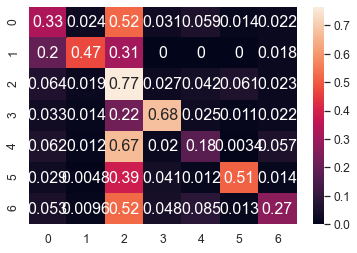

	training epoch=23 .. train_loss=1.077
	validation epoch=23 .. val_loss=1.401
	Accuracy = 46.6 % .. Percision = 55.1 % .. Recall = 45.7 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_23.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 24 .. loss = 1.113


  0%|                                                                                 | 1/1914 [00:01<39:53,  1.25s/it]

training @ epoch 24 .. loss = 1.372


  0%|                                                                                 | 2/1914 [00:02<39:29,  1.24s/it]

training @ epoch 24 .. loss = 1.977


  0%|▏                                                                                | 3/1914 [00:03<38:31,  1.21s/it]

training @ epoch 24 .. loss = 1.188


  0%|▏                                                                                | 4/1914 [00:04<38:25,  1.21s/it]

training @ epoch 24 .. loss = 1.227


  0%|▏                                                                                | 5/1914 [00:06<39:00,  1.23s/it]

training @ epoch 24 .. loss = 1.056


  0%|▎                                                                                | 6/1914 [00:07<38:40,  1.22s/it]

training @ epoch 24 .. loss = 1.132


  0%|▎                                                                                | 7/1914 [00:08<38:30,  1.21s/it]

training @ epoch 24 .. loss = 0.934


  0%|▎                                                                                | 8/1914 [00:09<39:23,  1.24s/it]

training @ epoch 24 .. loss = 1.823


  0%|▍                                                                                | 9/1914 [00:11<39:13,  1.24s/it]

training @ epoch 24 .. loss = 1.369


  1%|▍                                                                               | 10/1914 [00:12<38:31,  1.21s/it]

training @ epoch 24 .. loss = 1.157


  1%|▍                                                                               | 11/1914 [00:13<38:34,  1.22s/it]

training @ epoch 24 .. loss = 1.269


  1%|▌                                                                               | 12/1914 [00:14<38:58,  1.23s/it]

training @ epoch 24 .. loss = 1.1


  1%|▌                                                                               | 13/1914 [00:15<38:42,  1.22s/it]

training @ epoch 24 .. loss = 1.119


  1%|▌                                                                               | 14/1914 [00:17<38:46,  1.22s/it]

training @ epoch 24 .. loss = 0.762


  1%|▋                                                                               | 15/1914 [00:18<38:27,  1.22s/it]

training @ epoch 24 .. loss = 1.329


  1%|▋                                                                               | 16/1914 [00:19<38:12,  1.21s/it]

training @ epoch 24 .. loss = 1.329


  1%|▋                                                                               | 17/1914 [00:20<37:42,  1.19s/it]

training @ epoch 24 .. loss = 0.848


  1%|▊                                                                               | 18/1914 [00:21<37:36,  1.19s/it]

training @ epoch 24 .. loss = 0.902


  1%|▊                                                                               | 19/1914 [00:23<37:47,  1.20s/it]

training @ epoch 24 .. loss = 0.579


  1%|▊                                                                               | 20/1914 [00:24<37:42,  1.19s/it]

training @ epoch 24 .. loss = 1.255


  1%|▉                                                                               | 21/1914 [00:25<38:02,  1.21s/it]

training @ epoch 24 .. loss = 0.986


  1%|▉                                                                               | 22/1914 [00:26<37:41,  1.20s/it]

training @ epoch 24 .. loss = 1.274


  1%|▉                                                                               | 23/1914 [00:27<37:54,  1.20s/it]

training @ epoch 24 .. loss = 0.646


  1%|█                                                                               | 24/1914 [00:29<37:35,  1.19s/it]

training @ epoch 24 .. loss = 0.879


  1%|█                                                                               | 25/1914 [00:30<37:21,  1.19s/it]

training @ epoch 24 .. loss = 1.33


  1%|█                                                                               | 26/1914 [00:31<37:22,  1.19s/it]

training @ epoch 24 .. loss = 0.814


  1%|█▏                                                                              | 27/1914 [00:32<39:56,  1.27s/it]

training @ epoch 24 .. loss = 1.108


  1%|█▏                                                                              | 28/1914 [00:34<40:49,  1.30s/it]

training @ epoch 24 .. loss = 0.929


  2%|█▏                                                                              | 29/1914 [00:35<40:50,  1.30s/it]

training @ epoch 24 .. loss = 1.142


  2%|█▎                                                                              | 30/1914 [00:36<41:06,  1.31s/it]

training @ epoch 24 .. loss = 0.843


  2%|█▎                                                                              | 31/1914 [00:38<41:13,  1.31s/it]

training @ epoch 24 .. loss = 0.858


  2%|█▎                                                                              | 32/1914 [00:39<39:55,  1.27s/it]

training @ epoch 24 .. loss = 0.844


  2%|█▍                                                                              | 33/1914 [00:40<39:21,  1.26s/it]

training @ epoch 24 .. loss = 0.872


  2%|█▍                                                                              | 34/1914 [00:41<38:55,  1.24s/it]

training @ epoch 24 .. loss = 0.927


  2%|█▍                                                                              | 35/1914 [00:42<38:19,  1.22s/it]

training @ epoch 24 .. loss = 1.622


  2%|█▌                                                                              | 36/1914 [00:44<37:37,  1.20s/it]

training @ epoch 24 .. loss = 0.986


  2%|█▌                                                                              | 37/1914 [00:45<37:30,  1.20s/it]

training @ epoch 24 .. loss = 1.301


  2%|█▌                                                                              | 38/1914 [00:46<37:18,  1.19s/it]

training @ epoch 24 .. loss = 0.948


  2%|█▋                                                                              | 39/1914 [00:47<37:27,  1.20s/it]

training @ epoch 24 .. loss = 1.103


  2%|█▋                                                                              | 40/1914 [00:48<37:33,  1.20s/it]

training @ epoch 24 .. loss = 1.072


  2%|█▋                                                                              | 41/1914 [00:50<37:31,  1.20s/it]

training @ epoch 24 .. loss = 1.386


  2%|█▊                                                                              | 42/1914 [00:51<38:04,  1.22s/it]

training @ epoch 24 .. loss = 0.708


  2%|█▊                                                                              | 43/1914 [00:52<37:57,  1.22s/it]

training @ epoch 24 .. loss = 1.107


  2%|█▊                                                                              | 44/1914 [00:53<37:19,  1.20s/it]

training @ epoch 24 .. loss = 1.115


  2%|█▉                                                                              | 45/1914 [00:55<38:18,  1.23s/it]

training @ epoch 24 .. loss = 1.02


  2%|█▉                                                                              | 46/1914 [00:56<37:10,  1.19s/it]

training @ epoch 24 .. loss = 1.244


  2%|█▉                                                                              | 47/1914 [00:57<35:37,  1.15s/it]

training @ epoch 24 .. loss = 0.909


  3%|██                                                                              | 48/1914 [00:58<34:51,  1.12s/it]

training @ epoch 24 .. loss = 1.409


  3%|██                                                                              | 49/1914 [00:59<34:05,  1.10s/it]

training @ epoch 24 .. loss = 0.799


  3%|██                                                                              | 50/1914 [01:00<33:43,  1.09s/it]

training @ epoch 24 .. loss = 1.151


  3%|██▏                                                                             | 51/1914 [01:01<33:11,  1.07s/it]

training @ epoch 24 .. loss = 0.882


  3%|██▏                                                                             | 52/1914 [01:02<32:54,  1.06s/it]

training @ epoch 24 .. loss = 0.926


  3%|██▏                                                                             | 53/1914 [01:03<33:05,  1.07s/it]

training @ epoch 24 .. loss = 1.374


  3%|██▎                                                                             | 54/1914 [01:04<32:45,  1.06s/it]

training @ epoch 24 .. loss = 1.537


  3%|██▎                                                                             | 55/1914 [01:05<32:30,  1.05s/it]

training @ epoch 24 .. loss = 1.141


  3%|██▎                                                                             | 56/1914 [01:06<32:22,  1.05s/it]

training @ epoch 24 .. loss = 0.95


  3%|██▍                                                                             | 57/1914 [01:07<32:07,  1.04s/it]

training @ epoch 24 .. loss = 0.496


  3%|██▍                                                                             | 58/1914 [01:08<32:05,  1.04s/it]

training @ epoch 24 .. loss = 1.054


  3%|██▍                                                                             | 59/1914 [01:09<32:10,  1.04s/it]

training @ epoch 24 .. loss = 0.797


  3%|██▌                                                                             | 60/1914 [01:10<32:28,  1.05s/it]

training @ epoch 24 .. loss = 1.317


  3%|██▌                                                                             | 61/1914 [01:11<32:27,  1.05s/it]

training @ epoch 24 .. loss = 1.138


  3%|██▌                                                                             | 62/1914 [01:12<32:17,  1.05s/it]

training @ epoch 24 .. loss = 1.237


  3%|██▋                                                                             | 63/1914 [01:13<32:29,  1.05s/it]

training @ epoch 24 .. loss = 1.036


  3%|██▋                                                                             | 64/1914 [01:14<32:46,  1.06s/it]

training @ epoch 24 .. loss = 0.813


  3%|██▋                                                                             | 65/1914 [01:16<32:28,  1.05s/it]

training @ epoch 24 .. loss = 0.573


  3%|██▊                                                                             | 66/1914 [01:17<32:22,  1.05s/it]

training @ epoch 24 .. loss = 1.054


  4%|██▊                                                                             | 67/1914 [01:18<32:27,  1.05s/it]

training @ epoch 24 .. loss = 0.709


  4%|██▊                                                                             | 68/1914 [01:19<32:20,  1.05s/it]

training @ epoch 24 .. loss = 1.439


  4%|██▉                                                                             | 69/1914 [01:20<32:23,  1.05s/it]

training @ epoch 24 .. loss = 0.935


  4%|██▉                                                                             | 70/1914 [01:21<32:09,  1.05s/it]

training @ epoch 24 .. loss = 0.977


  4%|██▉                                                                             | 71/1914 [01:22<32:10,  1.05s/it]

training @ epoch 24 .. loss = 0.701


  4%|███                                                                             | 72/1914 [01:23<33:32,  1.09s/it]

training @ epoch 24 .. loss = 1.171


  4%|███                                                                             | 73/1914 [01:24<33:36,  1.10s/it]

training @ epoch 24 .. loss = 0.787


  4%|███                                                                             | 74/1914 [01:25<35:20,  1.15s/it]

training @ epoch 24 .. loss = 0.66


  4%|███▏                                                                            | 75/1914 [01:27<35:06,  1.15s/it]

training @ epoch 24 .. loss = 0.903


  4%|███▏                                                                            | 76/1914 [01:28<35:16,  1.15s/it]

training @ epoch 24 .. loss = 0.857


  4%|███▏                                                                            | 77/1914 [01:29<34:30,  1.13s/it]

training @ epoch 24 .. loss = 0.897


  4%|███▎                                                                            | 78/1914 [01:30<33:38,  1.10s/it]

training @ epoch 24 .. loss = 0.847


  4%|███▎                                                                            | 79/1914 [01:31<33:21,  1.09s/it]

training @ epoch 24 .. loss = 1.442


  4%|███▎                                                                            | 80/1914 [01:32<33:09,  1.09s/it]

training @ epoch 24 .. loss = 0.697


  4%|███▍                                                                            | 81/1914 [01:33<32:23,  1.06s/it]

training @ epoch 24 .. loss = 1.212


  4%|███▍                                                                            | 82/1914 [01:34<31:59,  1.05s/it]

training @ epoch 24 .. loss = 0.891


  4%|███▍                                                                            | 83/1914 [01:35<31:33,  1.03s/it]

training @ epoch 24 .. loss = 1.441


  4%|███▌                                                                            | 84/1914 [01:36<31:15,  1.02s/it]

training @ epoch 24 .. loss = 0.995


  4%|███▌                                                                            | 85/1914 [01:37<30:53,  1.01s/it]

training @ epoch 24 .. loss = 1.39


  4%|███▌                                                                            | 86/1914 [01:38<31:03,  1.02s/it]

training @ epoch 24 .. loss = 1.265


  5%|███▋                                                                            | 87/1914 [01:39<30:44,  1.01s/it]

training @ epoch 24 .. loss = 0.859


  5%|███▋                                                                            | 88/1914 [01:40<31:00,  1.02s/it]

training @ epoch 24 .. loss = 0.759


  5%|███▋                                                                            | 89/1914 [01:41<31:21,  1.03s/it]

training @ epoch 24 .. loss = 0.975


  5%|███▊                                                                            | 90/1914 [01:42<31:33,  1.04s/it]

training @ epoch 24 .. loss = 0.992


  5%|███▊                                                                            | 91/1914 [01:43<31:31,  1.04s/it]

training @ epoch 24 .. loss = 1.389


  5%|███▊                                                                            | 92/1914 [01:44<31:36,  1.04s/it]

training @ epoch 24 .. loss = 0.923


  5%|███▉                                                                            | 93/1914 [01:45<31:36,  1.04s/it]

training @ epoch 24 .. loss = 0.837


  5%|███▉                                                                            | 94/1914 [01:46<31:47,  1.05s/it]

training @ epoch 24 .. loss = 0.652


  5%|███▉                                                                            | 95/1914 [01:47<32:05,  1.06s/it]

training @ epoch 24 .. loss = 1.104


  5%|████                                                                            | 96/1914 [01:48<32:09,  1.06s/it]

training @ epoch 24 .. loss = 0.986


  5%|████                                                                            | 97/1914 [01:50<32:18,  1.07s/it]

training @ epoch 24 .. loss = 0.836


  5%|████                                                                            | 98/1914 [01:51<32:57,  1.09s/it]

training @ epoch 24 .. loss = 0.913


  5%|████▏                                                                           | 99/1914 [01:52<32:13,  1.07s/it]

training @ epoch 24 .. loss = 0.834


  5%|████▏                                                                          | 100/1914 [01:53<32:08,  1.06s/it]

training @ epoch 24 .. loss = 1.251


  5%|████▏                                                                          | 101/1914 [01:54<32:17,  1.07s/it]

training @ epoch 24 .. loss = 1.103


  5%|████▏                                                                          | 102/1914 [01:55<31:52,  1.06s/it]

training @ epoch 24 .. loss = 1.21


  5%|████▎                                                                          | 103/1914 [01:56<31:31,  1.04s/it]

training @ epoch 24 .. loss = 1.065


  5%|████▎                                                                          | 104/1914 [01:57<31:27,  1.04s/it]

training @ epoch 24 .. loss = 0.922


  5%|████▎                                                                          | 105/1914 [01:58<31:13,  1.04s/it]

training @ epoch 24 .. loss = 0.881


  6%|████▍                                                                          | 106/1914 [01:59<30:54,  1.03s/it]

training @ epoch 24 .. loss = 0.929


  6%|████▍                                                                          | 107/1914 [02:00<31:35,  1.05s/it]

training @ epoch 24 .. loss = 0.915


  6%|████▍                                                                          | 108/1914 [02:01<31:23,  1.04s/it]

training @ epoch 24 .. loss = 0.737


  6%|████▍                                                                          | 109/1914 [02:02<32:04,  1.07s/it]

training @ epoch 24 .. loss = 1.428


  6%|████▌                                                                          | 110/1914 [02:03<32:20,  1.08s/it]

training @ epoch 24 .. loss = 1.646


  6%|████▌                                                                          | 111/1914 [02:04<32:20,  1.08s/it]

training @ epoch 24 .. loss = 1.612


  6%|████▌                                                                          | 112/1914 [02:05<32:06,  1.07s/it]

training @ epoch 24 .. loss = 1.11


  6%|████▋                                                                          | 113/1914 [02:06<31:53,  1.06s/it]

training @ epoch 24 .. loss = 0.975


  6%|████▋                                                                          | 114/1914 [02:08<32:57,  1.10s/it]

training @ epoch 24 .. loss = 0.867


  6%|████▋                                                                          | 115/1914 [02:09<34:06,  1.14s/it]

training @ epoch 24 .. loss = 1.011


  6%|████▊                                                                          | 116/1914 [02:10<35:06,  1.17s/it]

training @ epoch 24 .. loss = 1.003


  6%|████▊                                                                          | 117/1914 [02:11<34:50,  1.16s/it]

training @ epoch 24 .. loss = 1.005


  6%|████▊                                                                          | 118/1914 [02:12<34:16,  1.15s/it]

training @ epoch 24 .. loss = 0.85


  6%|████▉                                                                          | 119/1914 [02:13<33:17,  1.11s/it]

training @ epoch 24 .. loss = 0.64


  6%|████▉                                                                          | 120/1914 [02:15<33:09,  1.11s/it]

training @ epoch 24 .. loss = 0.873


  6%|████▉                                                                          | 121/1914 [02:16<32:42,  1.09s/it]

training @ epoch 24 .. loss = 1.348


  6%|█████                                                                          | 122/1914 [02:17<32:20,  1.08s/it]

training @ epoch 24 .. loss = 1.385


  6%|█████                                                                          | 123/1914 [02:18<31:53,  1.07s/it]

training @ epoch 24 .. loss = 0.619


  6%|█████                                                                          | 124/1914 [02:19<31:59,  1.07s/it]

training @ epoch 24 .. loss = 1.449


  7%|█████▏                                                                         | 125/1914 [02:20<31:47,  1.07s/it]

training @ epoch 24 .. loss = 1.118


  7%|█████▏                                                                         | 126/1914 [02:21<31:22,  1.05s/it]

training @ epoch 24 .. loss = 0.677


  7%|█████▏                                                                         | 127/1914 [02:22<31:02,  1.04s/it]

training @ epoch 24 .. loss = 1.109


  7%|█████▎                                                                         | 128/1914 [02:23<30:57,  1.04s/it]

training @ epoch 24 .. loss = 1.023


  7%|█████▎                                                                         | 129/1914 [02:24<30:44,  1.03s/it]

training @ epoch 24 .. loss = 1.166


  7%|█████▎                                                                         | 130/1914 [02:25<31:08,  1.05s/it]

training @ epoch 24 .. loss = 1.194


  7%|█████▍                                                                         | 131/1914 [02:26<30:49,  1.04s/it]

training @ epoch 24 .. loss = 0.94


  7%|█████▍                                                                         | 132/1914 [02:27<31:04,  1.05s/it]

training @ epoch 24 .. loss = 1.248


  7%|█████▍                                                                         | 133/1914 [02:28<31:01,  1.05s/it]

training @ epoch 24 .. loss = 1.243


  7%|█████▌                                                                         | 134/1914 [02:29<30:35,  1.03s/it]

training @ epoch 24 .. loss = 1.268


  7%|█████▌                                                                         | 135/1914 [02:30<30:39,  1.03s/it]

training @ epoch 24 .. loss = 0.985


  7%|█████▌                                                                         | 136/1914 [02:31<30:43,  1.04s/it]

training @ epoch 24 .. loss = 0.946


  7%|█████▋                                                                         | 137/1914 [02:32<30:36,  1.03s/it]

training @ epoch 24 .. loss = 1.016


  7%|█████▋                                                                         | 138/1914 [02:33<30:57,  1.05s/it]

training @ epoch 24 .. loss = 1.096


  7%|█████▋                                                                         | 139/1914 [02:34<31:14,  1.06s/it]

training @ epoch 24 .. loss = 1.085


  7%|█████▊                                                                         | 140/1914 [02:35<31:14,  1.06s/it]

training @ epoch 24 .. loss = 1.247


  7%|█████▊                                                                         | 141/1914 [02:36<31:01,  1.05s/it]

training @ epoch 24 .. loss = 0.742


  7%|█████▊                                                                         | 142/1914 [02:37<30:35,  1.04s/it]

training @ epoch 24 .. loss = 1.318


  7%|█████▉                                                                         | 143/1914 [02:38<30:33,  1.04s/it]

training @ epoch 24 .. loss = 0.835


  8%|█████▉                                                                         | 144/1914 [02:40<30:22,  1.03s/it]

training @ epoch 24 .. loss = 0.983


  8%|█████▉                                                                         | 145/1914 [02:41<30:52,  1.05s/it]

training @ epoch 24 .. loss = 1.528


  8%|██████                                                                         | 146/1914 [02:42<30:37,  1.04s/it]

training @ epoch 24 .. loss = 0.987


  8%|██████                                                                         | 147/1914 [02:43<30:29,  1.04s/it]

training @ epoch 24 .. loss = 1.151


  8%|██████                                                                         | 148/1914 [02:44<31:02,  1.05s/it]

training @ epoch 24 .. loss = 1.026


  8%|██████▏                                                                        | 149/1914 [02:45<31:02,  1.06s/it]

training @ epoch 24 .. loss = 1.357


  8%|██████▏                                                                        | 150/1914 [02:46<30:53,  1.05s/it]

training @ epoch 24 .. loss = 1.304


  8%|██████▏                                                                        | 151/1914 [02:47<30:25,  1.04s/it]

training @ epoch 24 .. loss = 0.97


  8%|██████▎                                                                        | 152/1914 [02:48<30:35,  1.04s/it]

training @ epoch 24 .. loss = 1.271


  8%|██████▎                                                                        | 153/1914 [02:49<30:38,  1.04s/it]

training @ epoch 24 .. loss = 1.007


  8%|██████▎                                                                        | 154/1914 [02:50<30:26,  1.04s/it]

training @ epoch 24 .. loss = 0.935


  8%|██████▍                                                                        | 155/1914 [02:51<30:15,  1.03s/it]

training @ epoch 24 .. loss = 0.894


  8%|██████▍                                                                        | 156/1914 [02:52<30:06,  1.03s/it]

training @ epoch 24 .. loss = 1.232


  8%|██████▍                                                                        | 157/1914 [02:53<29:52,  1.02s/it]

training @ epoch 24 .. loss = 1.042


  8%|██████▌                                                                        | 158/1914 [02:54<29:58,  1.02s/it]

training @ epoch 24 .. loss = 1.113


  8%|██████▌                                                                        | 159/1914 [02:55<29:37,  1.01s/it]

training @ epoch 24 .. loss = 1.493


  8%|██████▌                                                                        | 160/1914 [02:56<29:55,  1.02s/it]

training @ epoch 24 .. loss = 1.132


  8%|██████▋                                                                        | 161/1914 [02:57<30:11,  1.03s/it]

training @ epoch 24 .. loss = 1.416


  8%|██████▋                                                                        | 162/1914 [02:58<29:59,  1.03s/it]

training @ epoch 24 .. loss = 1.347


  9%|██████▋                                                                        | 163/1914 [02:59<30:04,  1.03s/it]

training @ epoch 24 .. loss = 1.158


  9%|██████▊                                                                        | 164/1914 [03:00<30:35,  1.05s/it]

training @ epoch 24 .. loss = 0.94


  9%|██████▊                                                                        | 165/1914 [03:01<30:46,  1.06s/it]

training @ epoch 24 .. loss = 1.045


  9%|██████▊                                                                        | 166/1914 [03:02<30:22,  1.04s/it]

training @ epoch 24 .. loss = 1.1


  9%|██████▉                                                                        | 167/1914 [03:03<30:33,  1.05s/it]

training @ epoch 24 .. loss = 0.936


  9%|██████▉                                                                        | 168/1914 [03:05<30:47,  1.06s/it]

training @ epoch 24 .. loss = 1.032


  9%|██████▉                                                                        | 169/1914 [03:05<30:09,  1.04s/it]

training @ epoch 24 .. loss = 1.649


  9%|███████                                                                        | 170/1914 [03:07<30:34,  1.05s/it]

training @ epoch 24 .. loss = 0.895


  9%|███████                                                                        | 171/1914 [03:08<31:38,  1.09s/it]

training @ epoch 24 .. loss = 0.991


  9%|███████                                                                        | 172/1914 [03:09<32:09,  1.11s/it]

training @ epoch 24 .. loss = 1.295


  9%|███████▏                                                                       | 173/1914 [03:10<31:49,  1.10s/it]

training @ epoch 24 .. loss = 1.189


  9%|███████▏                                                                       | 174/1914 [03:11<31:31,  1.09s/it]

training @ epoch 24 .. loss = 1.756


  9%|███████▏                                                                       | 175/1914 [03:12<31:17,  1.08s/it]

training @ epoch 24 .. loss = 0.912


  9%|███████▎                                                                       | 176/1914 [03:13<30:42,  1.06s/it]

training @ epoch 24 .. loss = 1.162


  9%|███████▎                                                                       | 177/1914 [03:14<30:11,  1.04s/it]

training @ epoch 24 .. loss = 0.684


  9%|███████▎                                                                       | 178/1914 [03:15<30:08,  1.04s/it]

training @ epoch 24 .. loss = 1.225


  9%|███████▍                                                                       | 179/1914 [03:16<29:55,  1.03s/it]

training @ epoch 24 .. loss = 1.07


  9%|███████▍                                                                       | 180/1914 [03:17<30:26,  1.05s/it]

training @ epoch 24 .. loss = 1.132


  9%|███████▍                                                                       | 181/1914 [03:18<30:32,  1.06s/it]

training @ epoch 24 .. loss = 0.96


 10%|███████▌                                                                       | 182/1914 [03:19<30:23,  1.05s/it]

training @ epoch 24 .. loss = 0.812


 10%|███████▌                                                                       | 183/1914 [03:20<30:35,  1.06s/it]

training @ epoch 24 .. loss = 1.215


 10%|███████▌                                                                       | 184/1914 [03:22<30:34,  1.06s/it]

training @ epoch 24 .. loss = 0.694


 10%|███████▋                                                                       | 185/1914 [03:23<30:55,  1.07s/it]

training @ epoch 24 .. loss = 1.192


 10%|███████▋                                                                       | 186/1914 [03:24<31:13,  1.08s/it]

training @ epoch 24 .. loss = 1.363


 10%|███████▋                                                                       | 187/1914 [03:25<30:54,  1.07s/it]

training @ epoch 24 .. loss = 0.963


 10%|███████▊                                                                       | 188/1914 [03:26<30:28,  1.06s/it]

training @ epoch 24 .. loss = 1.154


 10%|███████▊                                                                       | 189/1914 [03:27<30:14,  1.05s/it]

training @ epoch 24 .. loss = 1.22


 10%|███████▊                                                                       | 190/1914 [03:28<30:03,  1.05s/it]

training @ epoch 24 .. loss = 0.611


 10%|███████▉                                                                       | 191/1914 [03:29<30:04,  1.05s/it]

training @ epoch 24 .. loss = 0.969


 10%|███████▉                                                                       | 192/1914 [03:30<30:04,  1.05s/it]

training @ epoch 24 .. loss = 1.097


 10%|███████▉                                                                       | 193/1914 [03:31<29:59,  1.05s/it]

training @ epoch 24 .. loss = 1.056


 10%|████████                                                                       | 194/1914 [03:32<30:02,  1.05s/it]

training @ epoch 24 .. loss = 0.901


 10%|████████                                                                       | 195/1914 [03:33<29:51,  1.04s/it]

training @ epoch 24 .. loss = 1.597


 10%|████████                                                                       | 196/1914 [03:34<29:54,  1.04s/it]

training @ epoch 24 .. loss = 1.176


 10%|████████▏                                                                      | 197/1914 [03:35<29:46,  1.04s/it]

training @ epoch 24 .. loss = 1.138


 10%|████████▏                                                                      | 198/1914 [03:36<30:13,  1.06s/it]

training @ epoch 24 .. loss = 1.236


 10%|████████▏                                                                      | 199/1914 [03:37<29:58,  1.05s/it]

training @ epoch 24 .. loss = 1.037


 10%|████████▎                                                                      | 200/1914 [03:38<30:00,  1.05s/it]

training @ epoch 24 .. loss = 1.099


 11%|████████▎                                                                      | 201/1914 [03:39<30:06,  1.05s/it]

training @ epoch 24 .. loss = 1.421


 11%|████████▎                                                                      | 202/1914 [03:40<29:58,  1.05s/it]

training @ epoch 24 .. loss = 1.26


 11%|████████▍                                                                      | 203/1914 [03:42<29:56,  1.05s/it]

training @ epoch 24 .. loss = 0.665


 11%|████████▍                                                                      | 204/1914 [03:43<30:12,  1.06s/it]

training @ epoch 24 .. loss = 0.962


 11%|████████▍                                                                      | 205/1914 [03:44<30:01,  1.05s/it]

training @ epoch 24 .. loss = 0.946


 11%|████████▌                                                                      | 206/1914 [03:45<29:40,  1.04s/it]

training @ epoch 24 .. loss = 1.05


 11%|████████▌                                                                      | 207/1914 [03:46<29:58,  1.05s/it]

training @ epoch 24 .. loss = 0.856


 11%|████████▌                                                                      | 208/1914 [03:47<29:50,  1.05s/it]

training @ epoch 24 .. loss = 0.955


 11%|████████▋                                                                      | 209/1914 [03:48<29:50,  1.05s/it]

training @ epoch 24 .. loss = 0.844


 11%|████████▋                                                                      | 210/1914 [03:49<30:02,  1.06s/it]

training @ epoch 24 .. loss = 1.007


 11%|████████▋                                                                      | 211/1914 [03:50<29:50,  1.05s/it]

training @ epoch 24 .. loss = 1.106


 11%|████████▊                                                                      | 212/1914 [03:51<29:48,  1.05s/it]

training @ epoch 24 .. loss = 1.111


 11%|████████▊                                                                      | 213/1914 [03:52<29:35,  1.04s/it]

training @ epoch 24 .. loss = 1.149


 11%|████████▊                                                                      | 214/1914 [03:53<29:31,  1.04s/it]

training @ epoch 24 .. loss = 1.031


 11%|████████▊                                                                      | 215/1914 [03:54<29:35,  1.04s/it]

training @ epoch 24 .. loss = 1.147


 11%|████████▉                                                                      | 216/1914 [03:55<29:35,  1.05s/it]

training @ epoch 24 .. loss = 1.459


 11%|████████▉                                                                      | 217/1914 [03:56<29:28,  1.04s/it]

training @ epoch 24 .. loss = 0.905


 11%|████████▉                                                                      | 218/1914 [03:57<29:31,  1.04s/it]

training @ epoch 24 .. loss = 0.632


 11%|█████████                                                                      | 219/1914 [03:58<29:22,  1.04s/it]

training @ epoch 24 .. loss = 0.851


 11%|█████████                                                                      | 220/1914 [03:59<29:12,  1.03s/it]

training @ epoch 24 .. loss = 0.858


 12%|█████████                                                                      | 221/1914 [04:00<29:13,  1.04s/it]

training @ epoch 24 .. loss = 1.34


 12%|█████████▏                                                                     | 222/1914 [04:01<29:21,  1.04s/it]

training @ epoch 24 .. loss = 0.898


 12%|█████████▏                                                                     | 223/1914 [04:02<29:26,  1.04s/it]

training @ epoch 24 .. loss = 0.991


 12%|█████████▏                                                                     | 224/1914 [04:03<29:19,  1.04s/it]

training @ epoch 24 .. loss = 1.246


 12%|█████████▎                                                                     | 225/1914 [04:04<29:14,  1.04s/it]

training @ epoch 24 .. loss = 0.705


 12%|█████████▎                                                                     | 226/1914 [04:05<28:55,  1.03s/it]

training @ epoch 24 .. loss = 0.807


 12%|█████████▎                                                                     | 227/1914 [04:07<29:16,  1.04s/it]

training @ epoch 24 .. loss = 1.084


 12%|█████████▍                                                                     | 228/1914 [04:08<29:14,  1.04s/it]

training @ epoch 24 .. loss = 0.819


 12%|█████████▍                                                                     | 229/1914 [04:09<29:33,  1.05s/it]

training @ epoch 24 .. loss = 0.867


 12%|█████████▍                                                                     | 230/1914 [04:10<29:33,  1.05s/it]

training @ epoch 24 .. loss = 1.095


 12%|█████████▌                                                                     | 231/1914 [04:11<29:30,  1.05s/it]

training @ epoch 24 .. loss = 0.408


 12%|█████████▌                                                                     | 232/1914 [04:12<29:12,  1.04s/it]

training @ epoch 24 .. loss = 1.394


 12%|█████████▌                                                                     | 233/1914 [04:13<28:59,  1.04s/it]

training @ epoch 24 .. loss = 0.645


 12%|█████████▋                                                                     | 234/1914 [04:14<29:01,  1.04s/it]

training @ epoch 24 .. loss = 1.174


 12%|█████████▋                                                                     | 235/1914 [04:15<29:10,  1.04s/it]

training @ epoch 24 .. loss = 1.084


 12%|█████████▋                                                                     | 236/1914 [04:16<29:23,  1.05s/it]

training @ epoch 24 .. loss = 1.471


 12%|█████████▊                                                                     | 237/1914 [04:17<29:14,  1.05s/it]

training @ epoch 24 .. loss = 0.984


 12%|█████████▊                                                                     | 238/1914 [04:18<29:14,  1.05s/it]

training @ epoch 24 .. loss = 0.882


 12%|█████████▊                                                                     | 239/1914 [04:19<29:18,  1.05s/it]

training @ epoch 24 .. loss = 0.627


 13%|█████████▉                                                                     | 240/1914 [04:20<29:16,  1.05s/it]

training @ epoch 24 .. loss = 1.239


 13%|█████████▉                                                                     | 241/1914 [04:21<29:00,  1.04s/it]

training @ epoch 24 .. loss = 1.137


 13%|█████████▉                                                                     | 242/1914 [04:22<29:17,  1.05s/it]

training @ epoch 24 .. loss = 0.653


 13%|██████████                                                                     | 243/1914 [04:23<29:01,  1.04s/it]

training @ epoch 24 .. loss = 1.546


 13%|██████████                                                                     | 244/1914 [04:24<29:19,  1.05s/it]

training @ epoch 24 .. loss = 1.161


 13%|██████████                                                                     | 245/1914 [04:25<29:12,  1.05s/it]

training @ epoch 24 .. loss = 1.2


 13%|██████████▏                                                                    | 246/1914 [04:26<28:56,  1.04s/it]

training @ epoch 24 .. loss = 1.089


 13%|██████████▏                                                                    | 247/1914 [04:28<29:26,  1.06s/it]

training @ epoch 24 .. loss = 0.989


 13%|██████████▏                                                                    | 248/1914 [04:29<29:06,  1.05s/it]

training @ epoch 24 .. loss = 1.168


 13%|██████████▎                                                                    | 249/1914 [04:30<29:10,  1.05s/it]

training @ epoch 24 .. loss = 1.19


 13%|██████████▎                                                                    | 250/1914 [04:31<29:00,  1.05s/it]

training @ epoch 24 .. loss = 0.918


 13%|██████████▎                                                                    | 251/1914 [04:32<28:53,  1.04s/it]

training @ epoch 24 .. loss = 0.673


 13%|██████████▍                                                                    | 252/1914 [04:33<28:59,  1.05s/it]

training @ epoch 24 .. loss = 0.736


 13%|██████████▍                                                                    | 253/1914 [04:34<28:44,  1.04s/it]

training @ epoch 24 .. loss = 1.157


 13%|██████████▍                                                                    | 254/1914 [04:35<28:48,  1.04s/it]

training @ epoch 24 .. loss = 1.39


 13%|██████████▌                                                                    | 255/1914 [04:36<28:55,  1.05s/it]

training @ epoch 24 .. loss = 1.481


 13%|██████████▌                                                                    | 256/1914 [04:37<29:19,  1.06s/it]

training @ epoch 24 .. loss = 1.034


 13%|██████████▌                                                                    | 257/1914 [04:38<29:18,  1.06s/it]

training @ epoch 24 .. loss = 0.796


 13%|██████████▋                                                                    | 258/1914 [04:39<29:04,  1.05s/it]

training @ epoch 24 .. loss = 0.835


 14%|██████████▋                                                                    | 259/1914 [04:40<28:56,  1.05s/it]

training @ epoch 24 .. loss = 1.147


 14%|██████████▋                                                                    | 260/1914 [04:41<29:06,  1.06s/it]

training @ epoch 24 .. loss = 0.921


 14%|██████████▊                                                                    | 261/1914 [04:42<28:54,  1.05s/it]

training @ epoch 24 .. loss = 0.806


 14%|██████████▊                                                                    | 262/1914 [04:43<28:54,  1.05s/it]

training @ epoch 24 .. loss = 1.061


 14%|██████████▊                                                                    | 263/1914 [04:44<28:54,  1.05s/it]

training @ epoch 24 .. loss = 0.817


 14%|██████████▉                                                                    | 264/1914 [04:45<28:53,  1.05s/it]

training @ epoch 24 .. loss = 1.055


 14%|██████████▉                                                                    | 265/1914 [04:46<28:59,  1.05s/it]

training @ epoch 24 .. loss = 0.801


 14%|██████████▉                                                                    | 266/1914 [04:47<28:37,  1.04s/it]

training @ epoch 24 .. loss = 1.203


 14%|███████████                                                                    | 267/1914 [04:48<28:32,  1.04s/it]

training @ epoch 24 .. loss = 0.884


 14%|███████████                                                                    | 268/1914 [04:50<28:39,  1.04s/it]

training @ epoch 24 .. loss = 0.878


 14%|███████████                                                                    | 269/1914 [04:51<28:40,  1.05s/it]

training @ epoch 24 .. loss = 1.013


 14%|███████████▏                                                                   | 270/1914 [04:52<28:26,  1.04s/it]

training @ epoch 24 .. loss = 0.982


 14%|███████████▏                                                                   | 271/1914 [04:53<28:32,  1.04s/it]

training @ epoch 24 .. loss = 0.948


 14%|███████████▏                                                                   | 272/1914 [04:54<28:26,  1.04s/it]

training @ epoch 24 .. loss = 0.751


 14%|███████████▎                                                                   | 273/1914 [04:55<28:31,  1.04s/it]

training @ epoch 24 .. loss = 0.979


 14%|███████████▎                                                                   | 274/1914 [04:56<28:26,  1.04s/it]

training @ epoch 24 .. loss = 0.884


 14%|███████████▎                                                                   | 275/1914 [04:57<28:24,  1.04s/it]

training @ epoch 24 .. loss = 1.504


 14%|███████████▍                                                                   | 276/1914 [04:58<28:24,  1.04s/it]

training @ epoch 24 .. loss = 0.924


 14%|███████████▍                                                                   | 277/1914 [04:59<28:23,  1.04s/it]

training @ epoch 24 .. loss = 0.741


 15%|███████████▍                                                                   | 278/1914 [05:00<28:22,  1.04s/it]

training @ epoch 24 .. loss = 1.261


 15%|███████████▌                                                                   | 279/1914 [05:01<28:28,  1.05s/it]

training @ epoch 24 .. loss = 0.588


 15%|███████████▌                                                                   | 280/1914 [05:02<28:08,  1.03s/it]

training @ epoch 24 .. loss = 1.314


 15%|███████████▌                                                                   | 281/1914 [05:03<28:14,  1.04s/it]

training @ epoch 24 .. loss = 0.784


 15%|███████████▋                                                                   | 282/1914 [05:04<28:29,  1.05s/it]

training @ epoch 24 .. loss = 0.948


 15%|███████████▋                                                                   | 283/1914 [05:05<29:06,  1.07s/it]

training @ epoch 24 .. loss = 0.89


 15%|███████████▋                                                                   | 284/1914 [05:06<29:05,  1.07s/it]

training @ epoch 24 .. loss = 0.613


 15%|███████████▊                                                                   | 285/1914 [05:07<28:44,  1.06s/it]

training @ epoch 24 .. loss = 1.243


 15%|███████████▊                                                                   | 286/1914 [05:08<28:33,  1.05s/it]

training @ epoch 24 .. loss = 1.14


 15%|███████████▊                                                                   | 287/1914 [05:09<28:48,  1.06s/it]

training @ epoch 24 .. loss = 1.151


 15%|███████████▉                                                                   | 288/1914 [05:11<30:12,  1.11s/it]

training @ epoch 24 .. loss = 0.692


 15%|███████████▉                                                                   | 289/1914 [05:12<30:45,  1.14s/it]

training @ epoch 24 .. loss = 0.946


 15%|███████████▉                                                                   | 290/1914 [05:13<30:37,  1.13s/it]

training @ epoch 24 .. loss = 1.099


 15%|████████████                                                                   | 291/1914 [05:14<30:17,  1.12s/it]

training @ epoch 24 .. loss = 0.834


 15%|████████████                                                                   | 292/1914 [05:15<30:12,  1.12s/it]

training @ epoch 24 .. loss = 1.363


 15%|████████████                                                                   | 293/1914 [05:16<29:40,  1.10s/it]

training @ epoch 24 .. loss = 1.08


 15%|████████████▏                                                                  | 294/1914 [05:17<29:24,  1.09s/it]

training @ epoch 24 .. loss = 1.277


 15%|████████████▏                                                                  | 295/1914 [05:18<29:00,  1.07s/it]

training @ epoch 24 .. loss = 0.847


 15%|████████████▏                                                                  | 296/1914 [05:19<28:37,  1.06s/it]

training @ epoch 24 .. loss = 1.317


 16%|████████████▎                                                                  | 297/1914 [05:20<28:24,  1.05s/it]

training @ epoch 24 .. loss = 0.572


 16%|████████████▎                                                                  | 298/1914 [05:21<28:16,  1.05s/it]

training @ epoch 24 .. loss = 1.012


 16%|████████████▎                                                                  | 299/1914 [05:23<28:09,  1.05s/it]

training @ epoch 24 .. loss = 0.96


 16%|████████████▍                                                                  | 300/1914 [05:24<28:09,  1.05s/it]

training @ epoch 24 .. loss = 1.264


 16%|████████████▍                                                                  | 301/1914 [05:25<28:02,  1.04s/it]

training @ epoch 24 .. loss = 1.043


 16%|████████████▍                                                                  | 302/1914 [05:26<28:00,  1.04s/it]

training @ epoch 24 .. loss = 0.91


 16%|████████████▌                                                                  | 303/1914 [05:27<28:12,  1.05s/it]

training @ epoch 24 .. loss = 0.754


 16%|████████████▌                                                                  | 304/1914 [05:28<28:11,  1.05s/it]

training @ epoch 24 .. loss = 0.862


 16%|████████████▌                                                                  | 305/1914 [05:29<28:04,  1.05s/it]

training @ epoch 24 .. loss = 0.546


 16%|████████████▋                                                                  | 306/1914 [05:30<28:02,  1.05s/it]

training @ epoch 24 .. loss = 0.879


 16%|████████████▋                                                                  | 307/1914 [05:31<28:02,  1.05s/it]

training @ epoch 24 .. loss = 1.581


 16%|████████████▋                                                                  | 308/1914 [05:32<28:00,  1.05s/it]

training @ epoch 24 .. loss = 1.046


 16%|████████████▊                                                                  | 309/1914 [05:33<27:55,  1.04s/it]

training @ epoch 24 .. loss = 0.983


 16%|████████████▊                                                                  | 310/1914 [05:34<28:02,  1.05s/it]

training @ epoch 24 .. loss = 1.161


 16%|████████████▊                                                                  | 311/1914 [05:35<28:16,  1.06s/it]

training @ epoch 24 .. loss = 1.244


 16%|████████████▉                                                                  | 312/1914 [05:36<28:30,  1.07s/it]

training @ epoch 24 .. loss = 1.321


 16%|████████████▉                                                                  | 313/1914 [05:37<28:05,  1.05s/it]

training @ epoch 24 .. loss = 0.663


 16%|████████████▉                                                                  | 314/1914 [05:38<28:11,  1.06s/it]

training @ epoch 24 .. loss = 0.681


 16%|█████████████                                                                  | 315/1914 [05:39<28:00,  1.05s/it]

training @ epoch 24 .. loss = 0.958


 17%|█████████████                                                                  | 316/1914 [05:40<28:32,  1.07s/it]

training @ epoch 24 .. loss = 1.151


 17%|█████████████                                                                  | 317/1914 [05:41<28:11,  1.06s/it]

training @ epoch 24 .. loss = 1.273


 17%|█████████████▏                                                                 | 318/1914 [05:43<28:11,  1.06s/it]

training @ epoch 24 .. loss = 1.434


 17%|█████████████▏                                                                 | 319/1914 [05:44<28:11,  1.06s/it]

training @ epoch 24 .. loss = 1.251


 17%|█████████████▏                                                                 | 320/1914 [05:45<27:52,  1.05s/it]

training @ epoch 24 .. loss = 1.721


 17%|█████████████▏                                                                 | 321/1914 [05:46<27:56,  1.05s/it]

training @ epoch 24 .. loss = 1.12


 17%|█████████████▎                                                                 | 322/1914 [05:47<27:32,  1.04s/it]

training @ epoch 24 .. loss = 0.899


 17%|█████████████▎                                                                 | 323/1914 [05:48<27:32,  1.04s/it]

training @ epoch 24 .. loss = 1.599


 17%|█████████████▎                                                                 | 324/1914 [05:49<27:43,  1.05s/it]

training @ epoch 24 .. loss = 0.616


 17%|█████████████▍                                                                 | 325/1914 [05:50<27:58,  1.06s/it]

training @ epoch 24 .. loss = 0.749


 17%|█████████████▍                                                                 | 326/1914 [05:51<27:36,  1.04s/it]

training @ epoch 24 .. loss = 0.764


 17%|█████████████▍                                                                 | 327/1914 [05:52<27:23,  1.04s/it]

training @ epoch 24 .. loss = 0.829


 17%|█████████████▌                                                                 | 328/1914 [05:53<27:14,  1.03s/it]

training @ epoch 24 .. loss = 0.927


 17%|█████████████▌                                                                 | 329/1914 [05:54<27:40,  1.05s/it]

training @ epoch 24 .. loss = 1.104


 17%|█████████████▌                                                                 | 330/1914 [05:55<27:50,  1.05s/it]

training @ epoch 24 .. loss = 0.687


 17%|█████████████▋                                                                 | 331/1914 [05:56<28:30,  1.08s/it]

training @ epoch 24 .. loss = 0.989


 17%|█████████████▋                                                                 | 332/1914 [05:57<28:52,  1.10s/it]

training @ epoch 24 .. loss = 1.185


 17%|█████████████▋                                                                 | 333/1914 [05:58<28:41,  1.09s/it]

training @ epoch 24 .. loss = 1.174


 17%|█████████████▊                                                                 | 334/1914 [06:00<28:32,  1.08s/it]

training @ epoch 24 .. loss = 1.226


 18%|█████████████▊                                                                 | 335/1914 [06:01<28:46,  1.09s/it]

training @ epoch 24 .. loss = 0.754


 18%|█████████████▊                                                                 | 336/1914 [06:02<28:46,  1.09s/it]

training @ epoch 24 .. loss = 1.169


 18%|█████████████▉                                                                 | 337/1914 [06:03<28:27,  1.08s/it]

training @ epoch 24 .. loss = 0.733


 18%|█████████████▉                                                                 | 338/1914 [06:04<27:55,  1.06s/it]

training @ epoch 24 .. loss = 1.528


 18%|█████████████▉                                                                 | 339/1914 [06:05<27:33,  1.05s/it]

training @ epoch 24 .. loss = 0.842


 18%|██████████████                                                                 | 340/1914 [06:06<27:47,  1.06s/it]

training @ epoch 24 .. loss = 0.607


 18%|██████████████                                                                 | 341/1914 [06:07<29:50,  1.14s/it]

training @ epoch 24 .. loss = 1.128


 18%|██████████████                                                                 | 342/1914 [06:08<29:27,  1.12s/it]

training @ epoch 24 .. loss = 0.799


 18%|██████████████▏                                                                | 343/1914 [06:09<29:11,  1.11s/it]

training @ epoch 24 .. loss = 1.108


 18%|██████████████▏                                                                | 344/1914 [06:10<28:43,  1.10s/it]

training @ epoch 24 .. loss = 1.196


 18%|██████████████▏                                                                | 345/1914 [06:12<28:43,  1.10s/it]

training @ epoch 24 .. loss = 1.257


 18%|██████████████▎                                                                | 346/1914 [06:13<28:27,  1.09s/it]

training @ epoch 24 .. loss = 0.998


 18%|██████████████▎                                                                | 347/1914 [06:14<27:55,  1.07s/it]

training @ epoch 24 .. loss = 1.009


 18%|██████████████▎                                                                | 348/1914 [06:15<27:52,  1.07s/it]

training @ epoch 24 .. loss = 0.835


 18%|██████████████▍                                                                | 349/1914 [06:16<27:54,  1.07s/it]

training @ epoch 24 .. loss = 1.392


 18%|██████████████▍                                                                | 350/1914 [06:17<27:32,  1.06s/it]

training @ epoch 24 .. loss = 0.999


 18%|██████████████▍                                                                | 351/1914 [06:18<27:46,  1.07s/it]

training @ epoch 24 .. loss = 0.868


 18%|██████████████▌                                                                | 352/1914 [06:19<27:22,  1.05s/it]

training @ epoch 24 .. loss = 0.84


 18%|██████████████▌                                                                | 353/1914 [06:20<27:13,  1.05s/it]

training @ epoch 24 .. loss = 1.09


 18%|██████████████▌                                                                | 354/1914 [06:21<27:15,  1.05s/it]

training @ epoch 24 .. loss = 1.076


 19%|██████████████▋                                                                | 355/1914 [06:22<27:26,  1.06s/it]

training @ epoch 24 .. loss = 1.231


 19%|██████████████▋                                                                | 356/1914 [06:23<27:29,  1.06s/it]

training @ epoch 24 .. loss = 0.79


 19%|██████████████▋                                                                | 357/1914 [06:24<27:19,  1.05s/it]

training @ epoch 24 .. loss = 0.802


 19%|██████████████▊                                                                | 358/1914 [06:25<27:22,  1.06s/it]

training @ epoch 24 .. loss = 1.174


 19%|██████████████▊                                                                | 359/1914 [06:26<27:28,  1.06s/it]

training @ epoch 24 .. loss = 1.014


 19%|██████████████▊                                                                | 360/1914 [06:27<27:36,  1.07s/it]

training @ epoch 24 .. loss = 1.678


 19%|██████████████▉                                                                | 361/1914 [06:28<27:24,  1.06s/it]

training @ epoch 24 .. loss = 1.021


 19%|██████████████▉                                                                | 362/1914 [06:29<27:22,  1.06s/it]

training @ epoch 24 .. loss = 1.672


 19%|██████████████▉                                                                | 363/1914 [06:31<27:09,  1.05s/it]

training @ epoch 24 .. loss = 1.034


 19%|███████████████                                                                | 364/1914 [06:32<27:15,  1.05s/it]

training @ epoch 24 .. loss = 0.695


 19%|███████████████                                                                | 365/1914 [06:33<27:28,  1.06s/it]

training @ epoch 24 .. loss = 0.868


 19%|███████████████                                                                | 366/1914 [06:34<27:17,  1.06s/it]

training @ epoch 24 .. loss = 1.225


 19%|███████████████▏                                                               | 367/1914 [06:35<27:17,  1.06s/it]

training @ epoch 24 .. loss = 0.71


 19%|███████████████▏                                                               | 368/1914 [06:36<27:07,  1.05s/it]

training @ epoch 24 .. loss = 1.026


 19%|███████████████▏                                                               | 369/1914 [06:37<27:22,  1.06s/it]

training @ epoch 24 .. loss = 1.271


 19%|███████████████▎                                                               | 370/1914 [06:38<27:34,  1.07s/it]

training @ epoch 24 .. loss = 1.11


 19%|███████████████▎                                                               | 371/1914 [06:39<27:21,  1.06s/it]

training @ epoch 24 .. loss = 1.199


 19%|███████████████▎                                                               | 372/1914 [06:40<27:06,  1.06s/it]

training @ epoch 24 .. loss = 1.197


 19%|███████████████▍                                                               | 373/1914 [06:41<29:06,  1.13s/it]

training @ epoch 24 .. loss = 1.001


 20%|███████████████▍                                                               | 374/1914 [06:43<29:32,  1.15s/it]

training @ epoch 24 .. loss = 1.321


 20%|███████████████▍                                                               | 375/1914 [06:44<29:27,  1.15s/it]

training @ epoch 24 .. loss = 0.899


 20%|███████████████▌                                                               | 376/1914 [06:45<28:51,  1.13s/it]

training @ epoch 24 .. loss = 0.698


 20%|███████████████▌                                                               | 377/1914 [06:46<28:22,  1.11s/it]

training @ epoch 24 .. loss = 0.928


 20%|███████████████▌                                                               | 378/1914 [06:47<27:43,  1.08s/it]

training @ epoch 24 .. loss = 1.069


 20%|███████████████▋                                                               | 379/1914 [06:48<27:19,  1.07s/it]

training @ epoch 24 .. loss = 1.144


 20%|███████████████▋                                                               | 380/1914 [06:49<27:17,  1.07s/it]

training @ epoch 24 .. loss = 1.084


 20%|███████████████▋                                                               | 381/1914 [06:50<27:12,  1.06s/it]

training @ epoch 24 .. loss = 0.853


 20%|███████████████▊                                                               | 382/1914 [06:51<27:18,  1.07s/it]

training @ epoch 24 .. loss = 0.923


 20%|███████████████▊                                                               | 383/1914 [06:52<27:05,  1.06s/it]

training @ epoch 24 .. loss = 1.16


 20%|███████████████▊                                                               | 384/1914 [06:53<27:07,  1.06s/it]

training @ epoch 24 .. loss = 1.009


 20%|███████████████▉                                                               | 385/1914 [06:54<27:14,  1.07s/it]

training @ epoch 24 .. loss = 1.184


 20%|███████████████▉                                                               | 386/1914 [06:55<27:17,  1.07s/it]

training @ epoch 24 .. loss = 1.488


 20%|███████████████▉                                                               | 387/1914 [06:56<27:24,  1.08s/it]

training @ epoch 24 .. loss = 1.167


 20%|████████████████                                                               | 388/1914 [06:58<26:57,  1.06s/it]

training @ epoch 24 .. loss = 1.012


 20%|████████████████                                                               | 389/1914 [06:59<27:15,  1.07s/it]

training @ epoch 24 .. loss = 0.928


 20%|████████████████                                                               | 390/1914 [07:00<27:12,  1.07s/it]

training @ epoch 24 .. loss = 1.586


 20%|████████████████▏                                                              | 391/1914 [07:01<27:15,  1.07s/it]

training @ epoch 24 .. loss = 0.918


 20%|████████████████▏                                                              | 392/1914 [07:02<27:06,  1.07s/it]

training @ epoch 24 .. loss = 0.95


 21%|████████████████▏                                                              | 393/1914 [07:03<26:48,  1.06s/it]

training @ epoch 24 .. loss = 1.195


 21%|████████████████▎                                                              | 394/1914 [07:04<26:30,  1.05s/it]

training @ epoch 24 .. loss = 1.358


 21%|████████████████▎                                                              | 395/1914 [07:05<26:48,  1.06s/it]

training @ epoch 24 .. loss = 0.947


 21%|████████████████▎                                                              | 396/1914 [07:06<26:42,  1.06s/it]

training @ epoch 24 .. loss = 1.032


 21%|████████████████▍                                                              | 397/1914 [07:07<26:34,  1.05s/it]

training @ epoch 24 .. loss = 1.255


 21%|████████████████▍                                                              | 398/1914 [07:08<26:53,  1.06s/it]

training @ epoch 24 .. loss = 1.127


 21%|████████████████▍                                                              | 399/1914 [07:09<26:57,  1.07s/it]

training @ epoch 24 .. loss = 1.302


 21%|████████████████▌                                                              | 400/1914 [07:10<27:10,  1.08s/it]

training @ epoch 24 .. loss = 1.318


 21%|████████████████▌                                                              | 401/1914 [07:11<27:12,  1.08s/it]

training @ epoch 24 .. loss = 0.908


 21%|████████████████▌                                                              | 402/1914 [07:12<26:43,  1.06s/it]

training @ epoch 24 .. loss = 0.832


 21%|████████████████▋                                                              | 403/1914 [07:13<26:40,  1.06s/it]

training @ epoch 24 .. loss = 1.379


 21%|████████████████▋                                                              | 404/1914 [07:15<26:27,  1.05s/it]

training @ epoch 24 .. loss = 0.711


 21%|████████████████▋                                                              | 405/1914 [07:16<26:02,  1.04s/it]

training @ epoch 24 .. loss = 1.067


 21%|████████████████▊                                                              | 406/1914 [07:17<26:13,  1.04s/it]

training @ epoch 24 .. loss = 0.799


 21%|████████████████▊                                                              | 407/1914 [07:18<26:28,  1.05s/it]

training @ epoch 24 .. loss = 0.944


 21%|████████████████▊                                                              | 408/1914 [07:19<26:22,  1.05s/it]

training @ epoch 24 .. loss = 0.743


 21%|████████████████▉                                                              | 409/1914 [07:20<26:20,  1.05s/it]

training @ epoch 24 .. loss = 1.272


 21%|████████████████▉                                                              | 410/1914 [07:21<26:20,  1.05s/it]

training @ epoch 24 .. loss = 1.356


 21%|████████████████▉                                                              | 411/1914 [07:22<26:15,  1.05s/it]

training @ epoch 24 .. loss = 1.293


 22%|█████████████████                                                              | 412/1914 [07:23<26:00,  1.04s/it]

training @ epoch 24 .. loss = 0.909


 22%|█████████████████                                                              | 413/1914 [07:24<26:21,  1.05s/it]

training @ epoch 24 .. loss = 0.975


 22%|█████████████████                                                              | 414/1914 [07:25<26:15,  1.05s/it]

training @ epoch 24 .. loss = 0.742


 22%|█████████████████▏                                                             | 415/1914 [07:26<26:18,  1.05s/it]

training @ epoch 24 .. loss = 1.162


 22%|█████████████████▏                                                             | 416/1914 [07:27<26:17,  1.05s/it]

training @ epoch 24 .. loss = 0.863


 22%|█████████████████▏                                                             | 417/1914 [07:28<26:19,  1.06s/it]

training @ epoch 24 .. loss = 1.203


 22%|█████████████████▎                                                             | 418/1914 [07:29<25:59,  1.04s/it]

training @ epoch 24 .. loss = 1.189


 22%|█████████████████▎                                                             | 419/1914 [07:30<26:14,  1.05s/it]

training @ epoch 24 .. loss = 0.788


 22%|█████████████████▎                                                             | 420/1914 [07:31<26:15,  1.05s/it]

training @ epoch 24 .. loss = 1.024


 22%|█████████████████▍                                                             | 421/1914 [07:32<26:27,  1.06s/it]

training @ epoch 24 .. loss = 1.212


 22%|█████████████████▍                                                             | 422/1914 [07:33<26:24,  1.06s/it]

training @ epoch 24 .. loss = 1.336


 22%|█████████████████▍                                                             | 423/1914 [07:35<26:22,  1.06s/it]

training @ epoch 24 .. loss = 1.318


 22%|█████████████████▌                                                             | 424/1914 [07:36<26:21,  1.06s/it]

training @ epoch 24 .. loss = 0.745


 22%|█████████████████▌                                                             | 425/1914 [07:37<26:19,  1.06s/it]

training @ epoch 24 .. loss = 0.945


 22%|█████████████████▌                                                             | 426/1914 [07:38<25:59,  1.05s/it]

training @ epoch 24 .. loss = 1.034


 22%|█████████████████▌                                                             | 427/1914 [07:39<26:01,  1.05s/it]

training @ epoch 24 .. loss = 1.15


 22%|█████████████████▋                                                             | 428/1914 [07:40<26:00,  1.05s/it]

training @ epoch 24 .. loss = 0.731


 22%|█████████████████▋                                                             | 429/1914 [07:41<25:56,  1.05s/it]

training @ epoch 24 .. loss = 0.965


 22%|█████████████████▋                                                             | 430/1914 [07:42<26:14,  1.06s/it]

training @ epoch 24 .. loss = 1.131


 23%|█████████████████▊                                                             | 431/1914 [07:43<25:54,  1.05s/it]

training @ epoch 24 .. loss = 1.076


 23%|█████████████████▊                                                             | 432/1914 [07:44<25:53,  1.05s/it]

training @ epoch 24 .. loss = 0.828


 23%|█████████████████▊                                                             | 433/1914 [07:45<26:00,  1.05s/it]

training @ epoch 24 .. loss = 0.727


 23%|█████████████████▉                                                             | 434/1914 [07:46<25:51,  1.05s/it]

training @ epoch 24 .. loss = 0.927


 23%|█████████████████▉                                                             | 435/1914 [07:47<25:34,  1.04s/it]

training @ epoch 24 .. loss = 1.358


 23%|█████████████████▉                                                             | 436/1914 [07:48<25:17,  1.03s/it]

training @ epoch 24 .. loss = 0.954


 23%|██████████████████                                                             | 437/1914 [07:49<25:25,  1.03s/it]

training @ epoch 24 .. loss = 1.351


 23%|██████████████████                                                             | 438/1914 [07:50<25:27,  1.03s/it]

training @ epoch 24 .. loss = 0.762


 23%|██████████████████                                                             | 439/1914 [07:51<25:12,  1.03s/it]

training @ epoch 24 .. loss = 1.101


 23%|██████████████████▏                                                            | 440/1914 [07:52<25:21,  1.03s/it]

training @ epoch 24 .. loss = 1.198


 23%|██████████████████▏                                                            | 441/1914 [07:53<25:24,  1.03s/it]

training @ epoch 24 .. loss = 1.339


 23%|██████████████████▏                                                            | 442/1914 [07:54<25:53,  1.06s/it]

training @ epoch 24 .. loss = 0.969


 23%|██████████████████▎                                                            | 443/1914 [07:56<27:22,  1.12s/it]

training @ epoch 24 .. loss = 0.939


 23%|██████████████████▎                                                            | 444/1914 [07:57<28:47,  1.18s/it]

training @ epoch 24 .. loss = 0.937


 23%|██████████████████▎                                                            | 445/1914 [07:58<30:47,  1.26s/it]

training @ epoch 24 .. loss = 0.863


 23%|██████████████████▍                                                            | 446/1914 [08:00<32:06,  1.31s/it]

training @ epoch 24 .. loss = 0.904


 23%|██████████████████▍                                                            | 447/1914 [08:01<32:59,  1.35s/it]

training @ epoch 24 .. loss = 1.022


 23%|██████████████████▍                                                            | 448/1914 [08:03<33:20,  1.36s/it]

training @ epoch 24 .. loss = 1.467


 23%|██████████████████▌                                                            | 449/1914 [08:04<33:12,  1.36s/it]

training @ epoch 24 .. loss = 0.742


 24%|██████████████████▌                                                            | 450/1914 [08:05<32:14,  1.32s/it]

training @ epoch 24 .. loss = 1.486


 24%|██████████████████▌                                                            | 451/1914 [08:06<31:21,  1.29s/it]

training @ epoch 24 .. loss = 0.849


 24%|██████████████████▋                                                            | 452/1914 [08:08<30:29,  1.25s/it]

training @ epoch 24 .. loss = 1.336


 24%|██████████████████▋                                                            | 453/1914 [08:09<30:02,  1.23s/it]

training @ epoch 24 .. loss = 0.936


 24%|██████████████████▋                                                            | 454/1914 [08:10<29:29,  1.21s/it]

training @ epoch 24 .. loss = 1.13


 24%|██████████████████▊                                                            | 455/1914 [08:11<30:03,  1.24s/it]

training @ epoch 24 .. loss = 1.108


 24%|██████████████████▊                                                            | 456/1914 [08:13<30:15,  1.25s/it]

training @ epoch 24 .. loss = 1.41


 24%|██████████████████▊                                                            | 457/1914 [08:14<29:17,  1.21s/it]

training @ epoch 24 .. loss = 0.949


 24%|██████████████████▉                                                            | 458/1914 [08:15<28:13,  1.16s/it]

training @ epoch 24 .. loss = 0.955


 24%|██████████████████▉                                                            | 459/1914 [08:16<27:10,  1.12s/it]

training @ epoch 24 .. loss = 0.451


 24%|██████████████████▉                                                            | 460/1914 [08:17<26:44,  1.10s/it]

training @ epoch 24 .. loss = 1.186


 24%|███████████████████                                                            | 461/1914 [08:18<26:45,  1.11s/it]

training @ epoch 24 .. loss = 1.344


 24%|███████████████████                                                            | 462/1914 [08:19<26:15,  1.08s/it]

training @ epoch 24 .. loss = 1.266


 24%|███████████████████                                                            | 463/1914 [08:20<26:15,  1.09s/it]

training @ epoch 24 .. loss = 1.535


 24%|███████████████████▏                                                           | 464/1914 [08:21<25:51,  1.07s/it]

training @ epoch 24 .. loss = 1.046


 24%|███████████████████▏                                                           | 465/1914 [08:22<25:50,  1.07s/it]

training @ epoch 24 .. loss = 1.392


 24%|███████████████████▏                                                           | 466/1914 [08:23<25:36,  1.06s/it]

training @ epoch 24 .. loss = 1.127


 24%|███████████████████▎                                                           | 467/1914 [08:24<25:43,  1.07s/it]

training @ epoch 24 .. loss = 1.119


 24%|███████████████████▎                                                           | 468/1914 [08:25<25:45,  1.07s/it]

training @ epoch 24 .. loss = 0.959


 25%|███████████████████▎                                                           | 469/1914 [08:26<25:46,  1.07s/it]

training @ epoch 24 .. loss = 1.214


 25%|███████████████████▍                                                           | 470/1914 [08:27<25:27,  1.06s/it]

training @ epoch 24 .. loss = 0.775


 25%|███████████████████▍                                                           | 471/1914 [08:28<25:24,  1.06s/it]

training @ epoch 24 .. loss = 0.862


 25%|███████████████████▍                                                           | 472/1914 [08:30<25:29,  1.06s/it]

training @ epoch 24 .. loss = 1.105


 25%|███████████████████▌                                                           | 473/1914 [08:31<25:24,  1.06s/it]

training @ epoch 24 .. loss = 1.598


 25%|███████████████████▌                                                           | 474/1914 [08:32<25:14,  1.05s/it]

training @ epoch 24 .. loss = 0.776


 25%|███████████████████▌                                                           | 475/1914 [08:33<25:16,  1.05s/it]

training @ epoch 24 .. loss = 1.065


 25%|███████████████████▋                                                           | 476/1914 [08:34<25:12,  1.05s/it]

training @ epoch 24 .. loss = 0.731


 25%|███████████████████▋                                                           | 477/1914 [08:35<25:12,  1.05s/it]

training @ epoch 24 .. loss = 1.056


 25%|███████████████████▋                                                           | 478/1914 [08:36<25:00,  1.04s/it]

training @ epoch 24 .. loss = 1.229


 25%|███████████████████▊                                                           | 479/1914 [08:37<25:09,  1.05s/it]

training @ epoch 24 .. loss = 0.904


 25%|███████████████████▊                                                           | 480/1914 [08:38<25:16,  1.06s/it]

training @ epoch 24 .. loss = 1.289


 25%|███████████████████▊                                                           | 481/1914 [08:39<24:58,  1.05s/it]

training @ epoch 24 .. loss = 1.473


 25%|███████████████████▉                                                           | 482/1914 [08:40<25:15,  1.06s/it]

training @ epoch 24 .. loss = 1.159


 25%|███████████████████▉                                                           | 483/1914 [08:41<25:06,  1.05s/it]

training @ epoch 24 .. loss = 0.845


 25%|███████████████████▉                                                           | 484/1914 [08:42<24:59,  1.05s/it]

training @ epoch 24 .. loss = 1.207


 25%|████████████████████                                                           | 485/1914 [08:43<24:41,  1.04s/it]

training @ epoch 24 .. loss = 0.641


 25%|████████████████████                                                           | 486/1914 [08:44<24:38,  1.04s/it]

training @ epoch 24 .. loss = 1.123


 25%|████████████████████                                                           | 487/1914 [08:45<24:37,  1.04s/it]

training @ epoch 24 .. loss = 1.215


 25%|████████████████████▏                                                          | 488/1914 [08:46<25:06,  1.06s/it]

training @ epoch 24 .. loss = 0.875


 26%|████████████████████▏                                                          | 489/1914 [08:47<25:20,  1.07s/it]

training @ epoch 24 .. loss = 0.747


 26%|████████████████████▏                                                          | 490/1914 [08:48<25:25,  1.07s/it]

training @ epoch 24 .. loss = 0.712


 26%|████████████████████▎                                                          | 491/1914 [08:50<25:32,  1.08s/it]

training @ epoch 24 .. loss = 0.7


 26%|████████████████████▎                                                          | 492/1914 [08:51<26:10,  1.10s/it]

training @ epoch 24 .. loss = 1.448


 26%|████████████████████▎                                                          | 493/1914 [08:52<25:37,  1.08s/it]

training @ epoch 24 .. loss = 1.059


 26%|████████████████████▍                                                          | 494/1914 [08:53<25:10,  1.06s/it]

training @ epoch 24 .. loss = 0.67


 26%|████████████████████▍                                                          | 495/1914 [08:54<25:03,  1.06s/it]

training @ epoch 24 .. loss = 1.152


 26%|████████████████████▍                                                          | 496/1914 [08:55<24:58,  1.06s/it]

training @ epoch 24 .. loss = 1.466


 26%|████████████████████▌                                                          | 497/1914 [08:56<24:59,  1.06s/it]

training @ epoch 24 .. loss = 0.774


 26%|████████████████████▌                                                          | 498/1914 [08:57<25:01,  1.06s/it]

training @ epoch 24 .. loss = 2.371


 26%|████████████████████▌                                                          | 499/1914 [08:58<25:01,  1.06s/it]

training @ epoch 24 .. loss = 1.198


 26%|████████████████████▋                                                          | 500/1914 [08:59<25:00,  1.06s/it]

training @ epoch 24 .. loss = 0.818


 26%|████████████████████▋                                                          | 501/1914 [09:00<25:07,  1.07s/it]

training @ epoch 24 .. loss = 1.164


 26%|████████████████████▋                                                          | 502/1914 [09:01<25:00,  1.06s/it]

training @ epoch 24 .. loss = 1.481


 26%|████████████████████▊                                                          | 503/1914 [09:02<25:15,  1.07s/it]

training @ epoch 24 .. loss = 0.883


 26%|████████████████████▊                                                          | 504/1914 [09:03<25:20,  1.08s/it]

training @ epoch 24 .. loss = 1.242


 26%|████████████████████▊                                                          | 505/1914 [09:05<25:25,  1.08s/it]

training @ epoch 24 .. loss = 1.027


 26%|████████████████████▉                                                          | 506/1914 [09:06<25:12,  1.07s/it]

training @ epoch 24 .. loss = 1.182


 26%|████████████████████▉                                                          | 507/1914 [09:07<25:05,  1.07s/it]

training @ epoch 24 .. loss = 1.073


 27%|████████████████████▉                                                          | 508/1914 [09:08<24:56,  1.06s/it]

training @ epoch 24 .. loss = 0.943


 27%|█████████████████████                                                          | 509/1914 [09:09<24:38,  1.05s/it]

training @ epoch 24 .. loss = 1.583


 27%|█████████████████████                                                          | 510/1914 [09:10<24:36,  1.05s/it]

training @ epoch 24 .. loss = 0.839


 27%|█████████████████████                                                          | 511/1914 [09:11<24:31,  1.05s/it]

training @ epoch 24 .. loss = 0.943


 27%|█████████████████████▏                                                         | 512/1914 [09:12<24:41,  1.06s/it]

training @ epoch 24 .. loss = 1.135


 27%|█████████████████████▏                                                         | 513/1914 [09:13<24:35,  1.05s/it]

training @ epoch 24 .. loss = 1.115


 27%|█████████████████████▏                                                         | 514/1914 [09:14<24:51,  1.07s/it]

training @ epoch 24 .. loss = 0.854


 27%|█████████████████████▎                                                         | 515/1914 [09:15<27:19,  1.17s/it]

training @ epoch 24 .. loss = 0.691


 27%|█████████████████████▎                                                         | 516/1914 [09:17<26:52,  1.15s/it]

training @ epoch 24 .. loss = 1.269


 27%|█████████████████████▎                                                         | 517/1914 [09:18<26:17,  1.13s/it]

training @ epoch 24 .. loss = 1.078


 27%|█████████████████████▍                                                         | 518/1914 [09:19<25:39,  1.10s/it]

training @ epoch 24 .. loss = 1.248


 27%|█████████████████████▍                                                         | 519/1914 [09:20<25:04,  1.08s/it]

training @ epoch 24 .. loss = 0.835


 27%|█████████████████████▍                                                         | 520/1914 [09:21<24:59,  1.08s/it]

training @ epoch 24 .. loss = 1.004


 27%|█████████████████████▌                                                         | 521/1914 [09:22<24:43,  1.07s/it]

training @ epoch 24 .. loss = 1.041


 27%|█████████████████████▌                                                         | 522/1914 [09:23<24:41,  1.06s/it]

training @ epoch 24 .. loss = 0.755


 27%|█████████████████████▌                                                         | 523/1914 [09:24<24:35,  1.06s/it]

training @ epoch 24 .. loss = 1.002


 27%|█████████████████████▋                                                         | 524/1914 [09:25<24:28,  1.06s/it]

training @ epoch 24 .. loss = 1.381


 27%|█████████████████████▋                                                         | 525/1914 [09:26<24:18,  1.05s/it]

training @ epoch 24 .. loss = 1.566


 27%|█████████████████████▋                                                         | 526/1914 [09:27<24:13,  1.05s/it]

training @ epoch 24 .. loss = 0.872


 28%|█████████████████████▊                                                         | 527/1914 [09:28<24:31,  1.06s/it]

training @ epoch 24 .. loss = 1.148


 28%|█████████████████████▊                                                         | 528/1914 [09:29<24:34,  1.06s/it]

training @ epoch 24 .. loss = 1.172


 28%|█████████████████████▊                                                         | 529/1914 [09:30<24:32,  1.06s/it]

training @ epoch 24 .. loss = 0.79


 28%|█████████████████████▉                                                         | 530/1914 [09:31<24:43,  1.07s/it]

training @ epoch 24 .. loss = 0.941


 28%|█████████████████████▉                                                         | 531/1914 [09:32<24:28,  1.06s/it]

training @ epoch 24 .. loss = 1.411


 28%|█████████████████████▉                                                         | 532/1914 [09:33<24:14,  1.05s/it]

training @ epoch 24 .. loss = 1.248


 28%|█████████████████████▉                                                         | 533/1914 [09:35<24:18,  1.06s/it]

training @ epoch 24 .. loss = 1.09


 28%|██████████████████████                                                         | 534/1914 [09:36<24:03,  1.05s/it]

training @ epoch 24 .. loss = 1.654


 28%|██████████████████████                                                         | 535/1914 [09:37<23:57,  1.04s/it]

training @ epoch 24 .. loss = 0.947


 28%|██████████████████████                                                         | 536/1914 [09:38<23:46,  1.04s/it]

training @ epoch 24 .. loss = 0.94


 28%|██████████████████████▏                                                        | 537/1914 [09:39<24:09,  1.05s/it]

training @ epoch 24 .. loss = 1.047


 28%|██████████████████████▏                                                        | 538/1914 [09:40<24:11,  1.05s/it]

training @ epoch 24 .. loss = 0.784


 28%|██████████████████████▏                                                        | 539/1914 [09:41<24:26,  1.07s/it]

training @ epoch 24 .. loss = 1.23


 28%|██████████████████████▎                                                        | 540/1914 [09:42<24:19,  1.06s/it]

training @ epoch 24 .. loss = 0.875


 28%|██████████████████████▎                                                        | 541/1914 [09:43<24:30,  1.07s/it]

training @ epoch 24 .. loss = 0.986


 28%|██████████████████████▎                                                        | 542/1914 [09:44<24:15,  1.06s/it]

training @ epoch 24 .. loss = 0.672


 28%|██████████████████████▍                                                        | 543/1914 [09:45<23:56,  1.05s/it]

training @ epoch 24 .. loss = 1.4


 28%|██████████████████████▍                                                        | 544/1914 [09:46<23:49,  1.04s/it]

training @ epoch 24 .. loss = 1.001


 28%|██████████████████████▍                                                        | 545/1914 [09:47<23:50,  1.05s/it]

training @ epoch 24 .. loss = 0.867


 29%|██████████████████████▌                                                        | 546/1914 [09:48<23:47,  1.04s/it]

training @ epoch 24 .. loss = 0.907


 29%|██████████████████████▌                                                        | 547/1914 [09:49<23:55,  1.05s/it]

training @ epoch 24 .. loss = 1.899


 29%|██████████████████████▌                                                        | 548/1914 [09:50<24:03,  1.06s/it]

training @ epoch 24 .. loss = 1.024


 29%|██████████████████████▋                                                        | 549/1914 [09:51<24:00,  1.06s/it]

training @ epoch 24 .. loss = 1.358


 29%|██████████████████████▋                                                        | 550/1914 [09:52<23:49,  1.05s/it]

training @ epoch 24 .. loss = 1.062


 29%|██████████████████████▋                                                        | 551/1914 [09:53<23:41,  1.04s/it]

training @ epoch 24 .. loss = 1.455


 29%|██████████████████████▊                                                        | 552/1914 [09:54<23:36,  1.04s/it]

training @ epoch 24 .. loss = 0.993


 29%|██████████████████████▊                                                        | 553/1914 [09:55<23:33,  1.04s/it]

training @ epoch 24 .. loss = 1.113


 29%|██████████████████████▊                                                        | 554/1914 [09:57<23:32,  1.04s/it]

training @ epoch 24 .. loss = 0.884


 29%|██████████████████████▉                                                        | 555/1914 [09:58<23:44,  1.05s/it]

training @ epoch 24 .. loss = 0.604


 29%|██████████████████████▉                                                        | 556/1914 [09:59<23:58,  1.06s/it]

training @ epoch 24 .. loss = 1.16


 29%|██████████████████████▉                                                        | 557/1914 [10:00<23:55,  1.06s/it]

training @ epoch 24 .. loss = 1.561


 29%|███████████████████████                                                        | 558/1914 [10:01<23:53,  1.06s/it]

training @ epoch 24 .. loss = 1.355


 29%|███████████████████████                                                        | 559/1914 [10:02<24:17,  1.08s/it]

training @ epoch 24 .. loss = 1.285


 29%|███████████████████████                                                        | 560/1914 [10:03<24:01,  1.06s/it]

training @ epoch 24 .. loss = 1.254


 29%|███████████████████████▏                                                       | 561/1914 [10:04<23:56,  1.06s/it]

training @ epoch 24 .. loss = 1.459


 29%|███████████████████████▏                                                       | 562/1914 [10:05<23:50,  1.06s/it]

training @ epoch 24 .. loss = 0.658


 29%|███████████████████████▏                                                       | 563/1914 [10:06<23:33,  1.05s/it]

training @ epoch 24 .. loss = 1.413


 29%|███████████████████████▎                                                       | 564/1914 [10:07<23:21,  1.04s/it]

training @ epoch 24 .. loss = 0.785


 30%|███████████████████████▎                                                       | 565/1914 [10:08<23:25,  1.04s/it]

training @ epoch 24 .. loss = 1.653


 30%|███████████████████████▎                                                       | 566/1914 [10:09<23:45,  1.06s/it]

training @ epoch 24 .. loss = 0.949


 30%|███████████████████████▍                                                       | 567/1914 [10:10<23:57,  1.07s/it]

training @ epoch 24 .. loss = 1.125


 30%|███████████████████████▍                                                       | 568/1914 [10:11<23:57,  1.07s/it]

training @ epoch 24 .. loss = 1.092


 30%|███████████████████████▍                                                       | 569/1914 [10:12<24:01,  1.07s/it]

training @ epoch 24 .. loss = 0.715


 30%|███████████████████████▌                                                       | 570/1914 [10:14<23:51,  1.07s/it]

training @ epoch 24 .. loss = 1.169


 30%|███████████████████████▌                                                       | 571/1914 [10:15<23:48,  1.06s/it]

training @ epoch 24 .. loss = 1.074


 30%|███████████████████████▌                                                       | 572/1914 [10:16<23:53,  1.07s/it]

training @ epoch 24 .. loss = 0.999


 30%|███████████████████████▋                                                       | 573/1914 [10:17<23:44,  1.06s/it]

training @ epoch 24 .. loss = 1.478


 30%|███████████████████████▋                                                       | 574/1914 [10:18<23:49,  1.07s/it]

training @ epoch 24 .. loss = 0.541


 30%|███████████████████████▋                                                       | 575/1914 [10:19<23:41,  1.06s/it]

training @ epoch 24 .. loss = 1.256


 30%|███████████████████████▊                                                       | 576/1914 [10:20<23:29,  1.05s/it]

training @ epoch 24 .. loss = 1.271


 30%|███████████████████████▊                                                       | 577/1914 [10:21<23:14,  1.04s/it]

training @ epoch 24 .. loss = 1.275


 30%|███████████████████████▊                                                       | 578/1914 [10:22<23:19,  1.05s/it]

training @ epoch 24 .. loss = 1.265


 30%|███████████████████████▉                                                       | 579/1914 [10:23<23:19,  1.05s/it]

training @ epoch 24 .. loss = 0.851


 30%|███████████████████████▉                                                       | 580/1914 [10:24<23:16,  1.05s/it]

training @ epoch 24 .. loss = 1.242


 30%|███████████████████████▉                                                       | 581/1914 [10:25<23:10,  1.04s/it]

training @ epoch 24 .. loss = 0.866


 30%|████████████████████████                                                       | 582/1914 [10:26<23:08,  1.04s/it]

training @ epoch 24 .. loss = 0.966


 30%|████████████████████████                                                       | 583/1914 [10:27<23:06,  1.04s/it]

training @ epoch 24 .. loss = 1.198


 31%|████████████████████████                                                       | 584/1914 [10:28<23:08,  1.04s/it]

training @ epoch 24 .. loss = 0.796


 31%|████████████████████████▏                                                      | 585/1914 [10:29<23:21,  1.05s/it]

training @ epoch 24 .. loss = 1.064


 31%|████████████████████████▏                                                      | 586/1914 [10:30<23:50,  1.08s/it]

training @ epoch 24 .. loss = 1.132


 31%|████████████████████████▏                                                      | 587/1914 [10:31<23:42,  1.07s/it]

training @ epoch 24 .. loss = 1.264


 31%|████████████████████████▎                                                      | 588/1914 [10:33<23:51,  1.08s/it]

training @ epoch 24 .. loss = 1.272


 31%|████████████████████████▎                                                      | 589/1914 [10:34<23:56,  1.08s/it]

training @ epoch 24 .. loss = 0.943


 31%|████████████████████████▎                                                      | 590/1914 [10:35<23:42,  1.07s/it]

training @ epoch 24 .. loss = 1.085


 31%|████████████████████████▍                                                      | 591/1914 [10:36<23:34,  1.07s/it]

training @ epoch 24 .. loss = 1.146


 31%|████████████████████████▍                                                      | 592/1914 [10:37<23:17,  1.06s/it]

training @ epoch 24 .. loss = 0.896


 31%|████████████████████████▍                                                      | 593/1914 [10:38<23:13,  1.06s/it]

training @ epoch 24 .. loss = 0.857


 31%|████████████████████████▌                                                      | 594/1914 [10:39<23:04,  1.05s/it]

training @ epoch 24 .. loss = 1.007


 31%|████████████████████████▌                                                      | 595/1914 [10:40<23:00,  1.05s/it]

training @ epoch 24 .. loss = 1.25


 31%|████████████████████████▌                                                      | 596/1914 [10:41<22:54,  1.04s/it]

training @ epoch 24 .. loss = 0.924


 31%|████████████████████████▋                                                      | 597/1914 [10:42<22:58,  1.05s/it]

training @ epoch 24 .. loss = 1.07


 31%|████████████████████████▋                                                      | 598/1914 [10:43<23:06,  1.05s/it]

training @ epoch 24 .. loss = 1.337


 31%|████████████████████████▋                                                      | 599/1914 [10:44<22:56,  1.05s/it]

training @ epoch 24 .. loss = 1.201


 31%|████████████████████████▊                                                      | 600/1914 [10:45<23:03,  1.05s/it]

training @ epoch 24 .. loss = 1.204


 31%|████████████████████████▊                                                      | 601/1914 [10:46<22:42,  1.04s/it]

training @ epoch 24 .. loss = 1.021


 31%|████████████████████████▊                                                      | 602/1914 [10:47<22:46,  1.04s/it]

training @ epoch 24 .. loss = 0.826


 32%|████████████████████████▉                                                      | 603/1914 [10:48<22:42,  1.04s/it]

training @ epoch 24 .. loss = 0.979


 32%|████████████████████████▉                                                      | 604/1914 [10:49<22:47,  1.04s/it]

training @ epoch 24 .. loss = 1.045


 32%|████████████████████████▉                                                      | 605/1914 [10:50<22:57,  1.05s/it]

training @ epoch 24 .. loss = 1.1


 32%|█████████████████████████                                                      | 606/1914 [10:51<22:49,  1.05s/it]

training @ epoch 24 .. loss = 0.923


 32%|█████████████████████████                                                      | 607/1914 [10:52<22:36,  1.04s/it]

training @ epoch 24 .. loss = 1.137


 32%|█████████████████████████                                                      | 608/1914 [10:54<23:01,  1.06s/it]

training @ epoch 24 .. loss = 1.173


 32%|█████████████████████████▏                                                     | 609/1914 [10:55<23:16,  1.07s/it]

training @ epoch 24 .. loss = 1.188


 32%|█████████████████████████▏                                                     | 610/1914 [10:56<23:12,  1.07s/it]

training @ epoch 24 .. loss = 1.118


 32%|█████████████████████████▏                                                     | 611/1914 [10:57<23:07,  1.06s/it]

training @ epoch 24 .. loss = 0.993


 32%|█████████████████████████▎                                                     | 612/1914 [10:58<22:57,  1.06s/it]

training @ epoch 24 .. loss = 0.863


 32%|█████████████████████████▎                                                     | 613/1914 [10:59<23:01,  1.06s/it]

training @ epoch 24 .. loss = 1.274


 32%|█████████████████████████▎                                                     | 614/1914 [11:00<22:49,  1.05s/it]

training @ epoch 24 .. loss = 0.947


 32%|█████████████████████████▍                                                     | 615/1914 [11:01<22:55,  1.06s/it]

training @ epoch 24 .. loss = 1.182


 32%|█████████████████████████▍                                                     | 616/1914 [11:02<23:02,  1.06s/it]

training @ epoch 24 .. loss = 0.782


 32%|█████████████████████████▍                                                     | 617/1914 [11:03<22:59,  1.06s/it]

training @ epoch 24 .. loss = 1.042


 32%|█████████████████████████▌                                                     | 618/1914 [11:04<23:09,  1.07s/it]

training @ epoch 24 .. loss = 1.464


 32%|█████████████████████████▌                                                     | 619/1914 [11:05<23:04,  1.07s/it]

training @ epoch 24 .. loss = 1.257


 32%|█████████████████████████▌                                                     | 620/1914 [11:06<22:56,  1.06s/it]

training @ epoch 24 .. loss = 1.38


 32%|█████████████████████████▋                                                     | 621/1914 [11:07<22:50,  1.06s/it]

training @ epoch 24 .. loss = 1.163


 32%|█████████████████████████▋                                                     | 622/1914 [11:08<22:27,  1.04s/it]

training @ epoch 24 .. loss = 0.816


 33%|█████████████████████████▋                                                     | 623/1914 [11:09<22:23,  1.04s/it]

training @ epoch 24 .. loss = 0.977


 33%|█████████████████████████▊                                                     | 624/1914 [11:11<22:38,  1.05s/it]

training @ epoch 24 .. loss = 0.711


 33%|█████████████████████████▊                                                     | 625/1914 [11:12<22:53,  1.07s/it]

training @ epoch 24 .. loss = 1.219


 33%|█████████████████████████▊                                                     | 626/1914 [11:13<22:34,  1.05s/it]

training @ epoch 24 .. loss = 0.975


 33%|█████████████████████████▉                                                     | 627/1914 [11:14<22:28,  1.05s/it]

training @ epoch 24 .. loss = 1.105


 33%|█████████████████████████▉                                                     | 628/1914 [11:15<22:28,  1.05s/it]

training @ epoch 24 .. loss = 1.39


 33%|█████████████████████████▉                                                     | 629/1914 [11:16<22:39,  1.06s/it]

training @ epoch 24 .. loss = 0.7


 33%|██████████████████████████                                                     | 630/1914 [11:17<22:38,  1.06s/it]

training @ epoch 24 .. loss = 0.883


 33%|██████████████████████████                                                     | 631/1914 [11:18<22:32,  1.05s/it]

training @ epoch 24 .. loss = 0.986


 33%|██████████████████████████                                                     | 632/1914 [11:19<22:30,  1.05s/it]

training @ epoch 24 .. loss = 0.639


 33%|██████████████████████████▏                                                    | 633/1914 [11:20<22:33,  1.06s/it]

training @ epoch 24 .. loss = 1.008


 33%|██████████████████████████▏                                                    | 634/1914 [11:21<22:40,  1.06s/it]

training @ epoch 24 .. loss = 1.597


 33%|██████████████████████████▏                                                    | 635/1914 [11:22<22:27,  1.05s/it]

training @ epoch 24 .. loss = 0.989


 33%|██████████████████████████▎                                                    | 636/1914 [11:23<22:20,  1.05s/it]

training @ epoch 24 .. loss = 1.439


 33%|██████████████████████████▎                                                    | 637/1914 [11:24<22:31,  1.06s/it]

training @ epoch 24 .. loss = 0.837


 33%|██████████████████████████▎                                                    | 638/1914 [11:25<22:19,  1.05s/it]

training @ epoch 24 .. loss = 1.061


 33%|██████████████████████████▎                                                    | 639/1914 [11:26<22:21,  1.05s/it]

training @ epoch 24 .. loss = 0.792


 33%|██████████████████████████▍                                                    | 640/1914 [11:27<22:27,  1.06s/it]

training @ epoch 24 .. loss = 0.875


 33%|██████████████████████████▍                                                    | 641/1914 [11:28<22:35,  1.07s/it]

training @ epoch 24 .. loss = 0.963


 34%|██████████████████████████▍                                                    | 642/1914 [11:30<22:33,  1.06s/it]

training @ epoch 24 .. loss = 1.223


 34%|██████████████████████████▌                                                    | 643/1914 [11:31<22:46,  1.08s/it]

training @ epoch 24 .. loss = 1.169


 34%|██████████████████████████▌                                                    | 644/1914 [11:32<22:44,  1.07s/it]

training @ epoch 24 .. loss = 1.167


 34%|██████████████████████████▌                                                    | 645/1914 [11:33<22:40,  1.07s/it]

training @ epoch 24 .. loss = 0.696


 34%|██████████████████████████▋                                                    | 646/1914 [11:34<22:19,  1.06s/it]

training @ epoch 24 .. loss = 0.834


 34%|██████████████████████████▋                                                    | 647/1914 [11:35<22:20,  1.06s/it]

training @ epoch 24 .. loss = 1.182


 34%|██████████████████████████▋                                                    | 648/1914 [11:36<22:09,  1.05s/it]

training @ epoch 24 .. loss = 0.871


 34%|██████████████████████████▊                                                    | 649/1914 [11:37<22:19,  1.06s/it]

training @ epoch 24 .. loss = 1.226


 34%|██████████████████████████▊                                                    | 650/1914 [11:38<22:12,  1.05s/it]

training @ epoch 24 .. loss = 1.16


 34%|██████████████████████████▊                                                    | 651/1914 [11:39<22:06,  1.05s/it]

training @ epoch 24 .. loss = 0.953


 34%|██████████████████████████▉                                                    | 652/1914 [11:40<22:28,  1.07s/it]

training @ epoch 24 .. loss = 0.56


 34%|██████████████████████████▉                                                    | 653/1914 [11:41<22:19,  1.06s/it]

training @ epoch 24 .. loss = 1.255


 34%|██████████████████████████▉                                                    | 654/1914 [11:42<22:01,  1.05s/it]

training @ epoch 24 .. loss = 1.567


 34%|███████████████████████████                                                    | 655/1914 [11:43<22:01,  1.05s/it]

training @ epoch 24 .. loss = 1.062


 34%|███████████████████████████                                                    | 656/1914 [11:44<21:56,  1.05s/it]

training @ epoch 24 .. loss = 0.816


 34%|███████████████████████████                                                    | 657/1914 [11:45<21:38,  1.03s/it]

training @ epoch 24 .. loss = 1.186


 34%|███████████████████████████▏                                                   | 658/1914 [11:46<21:49,  1.04s/it]

training @ epoch 24 .. loss = 0.906


 34%|███████████████████████████▏                                                   | 659/1914 [11:47<21:58,  1.05s/it]

training @ epoch 24 .. loss = 0.838


 34%|███████████████████████████▏                                                   | 660/1914 [11:49<21:57,  1.05s/it]

training @ epoch 24 .. loss = 1.043


 35%|███████████████████████████▎                                                   | 661/1914 [11:50<21:57,  1.05s/it]

training @ epoch 24 .. loss = 0.956


 35%|███████████████████████████▎                                                   | 662/1914 [11:51<21:58,  1.05s/it]

training @ epoch 24 .. loss = 0.996


 35%|███████████████████████████▎                                                   | 663/1914 [11:52<21:50,  1.05s/it]

training @ epoch 24 .. loss = 1.032


 35%|███████████████████████████▍                                                   | 664/1914 [11:53<21:46,  1.05s/it]

training @ epoch 24 .. loss = 1.237


 35%|███████████████████████████▍                                                   | 665/1914 [11:54<21:52,  1.05s/it]

training @ epoch 24 .. loss = 1.265


 35%|███████████████████████████▍                                                   | 666/1914 [11:55<21:47,  1.05s/it]

training @ epoch 24 .. loss = 0.777


 35%|███████████████████████████▌                                                   | 667/1914 [11:56<21:54,  1.05s/it]

training @ epoch 24 .. loss = 0.898


 35%|███████████████████████████▌                                                   | 668/1914 [11:57<21:40,  1.04s/it]

training @ epoch 24 .. loss = 0.923


 35%|███████████████████████████▌                                                   | 669/1914 [11:58<21:46,  1.05s/it]

training @ epoch 24 .. loss = 1.06


 35%|███████████████████████████▋                                                   | 670/1914 [11:59<22:16,  1.07s/it]

training @ epoch 24 .. loss = 1.201


 35%|███████████████████████████▋                                                   | 671/1914 [12:00<21:57,  1.06s/it]

training @ epoch 24 .. loss = 1.178


 35%|███████████████████████████▋                                                   | 672/1914 [12:01<21:52,  1.06s/it]

training @ epoch 24 .. loss = 0.644


 35%|███████████████████████████▊                                                   | 673/1914 [12:02<21:37,  1.05s/it]

training @ epoch 24 .. loss = 1.352


 35%|███████████████████████████▊                                                   | 674/1914 [12:03<21:38,  1.05s/it]

training @ epoch 24 .. loss = 1.017


 35%|███████████████████████████▊                                                   | 675/1914 [12:04<22:04,  1.07s/it]

training @ epoch 24 .. loss = 1.031


 35%|███████████████████████████▉                                                   | 676/1914 [12:05<21:58,  1.06s/it]

training @ epoch 24 .. loss = 1.515


 35%|███████████████████████████▉                                                   | 677/1914 [12:06<21:53,  1.06s/it]

training @ epoch 24 .. loss = 0.903


 35%|███████████████████████████▉                                                   | 678/1914 [12:08<21:56,  1.07s/it]

training @ epoch 24 .. loss = 1.139


 35%|████████████████████████████                                                   | 679/1914 [12:09<21:48,  1.06s/it]

training @ epoch 24 .. loss = 1.013


 36%|████████████████████████████                                                   | 680/1914 [12:10<21:49,  1.06s/it]

training @ epoch 24 .. loss = 1.596


 36%|████████████████████████████                                                   | 681/1914 [12:11<21:40,  1.05s/it]

training @ epoch 24 .. loss = 1.007


 36%|████████████████████████████▏                                                  | 682/1914 [12:12<21:37,  1.05s/it]

training @ epoch 24 .. loss = 1.338


 36%|████████████████████████████▏                                                  | 683/1914 [12:13<21:25,  1.04s/it]

training @ epoch 24 .. loss = 1.173


 36%|████████████████████████████▏                                                  | 684/1914 [12:14<21:34,  1.05s/it]

training @ epoch 24 .. loss = 0.917


 36%|████████████████████████████▎                                                  | 685/1914 [12:15<21:21,  1.04s/it]

training @ epoch 24 .. loss = 1.021


 36%|████████████████████████████▎                                                  | 686/1914 [12:16<21:21,  1.04s/it]

training @ epoch 24 .. loss = 1.12


 36%|████████████████████████████▎                                                  | 687/1914 [12:17<21:03,  1.03s/it]

training @ epoch 24 .. loss = 1.418


 36%|████████████████████████████▍                                                  | 688/1914 [12:18<21:22,  1.05s/it]

training @ epoch 24 .. loss = 1.082


 36%|████████████████████████████▍                                                  | 689/1914 [12:19<21:21,  1.05s/it]

training @ epoch 24 .. loss = 1.262


 36%|████████████████████████████▍                                                  | 690/1914 [12:20<21:16,  1.04s/it]

training @ epoch 24 .. loss = 1.407


 36%|████████████████████████████▌                                                  | 691/1914 [12:21<21:19,  1.05s/it]

training @ epoch 24 .. loss = 0.601


 36%|████████████████████████████▌                                                  | 692/1914 [12:22<21:14,  1.04s/it]

training @ epoch 24 .. loss = 0.78


 36%|████████████████████████████▌                                                  | 693/1914 [12:23<21:28,  1.06s/it]

training @ epoch 24 .. loss = 1.402


 36%|████████████████████████████▋                                                  | 694/1914 [12:24<21:27,  1.06s/it]

training @ epoch 24 .. loss = 1.4


 36%|████████████████████████████▋                                                  | 695/1914 [12:25<21:47,  1.07s/it]

training @ epoch 24 .. loss = 0.631


 36%|████████████████████████████▋                                                  | 696/1914 [12:26<21:30,  1.06s/it]

training @ epoch 24 .. loss = 1.043


 36%|████████████████████████████▊                                                  | 697/1914 [12:28<21:41,  1.07s/it]

training @ epoch 24 .. loss = 0.701


 36%|████████████████████████████▊                                                  | 698/1914 [12:29<21:26,  1.06s/it]

training @ epoch 24 .. loss = 0.839


 37%|████████████████████████████▊                                                  | 699/1914 [12:30<21:20,  1.05s/it]

training @ epoch 24 .. loss = 0.992


 37%|████████████████████████████▉                                                  | 700/1914 [12:31<21:20,  1.05s/it]

training @ epoch 24 .. loss = 1.219


 37%|████████████████████████████▉                                                  | 701/1914 [12:32<21:22,  1.06s/it]

training @ epoch 24 .. loss = 1.09


 37%|████████████████████████████▉                                                  | 702/1914 [12:33<21:51,  1.08s/it]

training @ epoch 24 .. loss = 1.218


 37%|█████████████████████████████                                                  | 703/1914 [12:34<21:40,  1.07s/it]

training @ epoch 24 .. loss = 1.407


 37%|█████████████████████████████                                                  | 704/1914 [12:35<21:27,  1.06s/it]

training @ epoch 24 .. loss = 1.112


 37%|█████████████████████████████                                                  | 705/1914 [12:36<21:09,  1.05s/it]

training @ epoch 24 .. loss = 0.778


 37%|█████████████████████████████▏                                                 | 706/1914 [12:37<20:57,  1.04s/it]

training @ epoch 24 .. loss = 0.651


 37%|█████████████████████████████▏                                                 | 707/1914 [12:38<20:53,  1.04s/it]

training @ epoch 24 .. loss = 1.5


 37%|█████████████████████████████▏                                                 | 708/1914 [12:39<20:47,  1.03s/it]

training @ epoch 24 .. loss = 1.165


 37%|█████████████████████████████▎                                                 | 709/1914 [12:40<21:00,  1.05s/it]

training @ epoch 24 .. loss = 1.277


 37%|█████████████████████████████▎                                                 | 710/1914 [12:41<20:56,  1.04s/it]

training @ epoch 24 .. loss = 0.942


 37%|█████████████████████████████▎                                                 | 711/1914 [12:42<20:46,  1.04s/it]

training @ epoch 24 .. loss = 1.08


 37%|█████████████████████████████▍                                                 | 712/1914 [12:43<20:38,  1.03s/it]

training @ epoch 24 .. loss = 1.61


 37%|█████████████████████████████▍                                                 | 713/1914 [12:44<20:45,  1.04s/it]

training @ epoch 24 .. loss = 1.248


 37%|█████████████████████████████▍                                                 | 714/1914 [12:45<20:43,  1.04s/it]

training @ epoch 24 .. loss = 1.081


 37%|█████████████████████████████▌                                                 | 715/1914 [12:46<20:39,  1.03s/it]

training @ epoch 24 .. loss = 0.985


 37%|█████████████████████████████▌                                                 | 716/1914 [12:47<20:33,  1.03s/it]

training @ epoch 24 .. loss = 1.289


 37%|█████████████████████████████▌                                                 | 717/1914 [12:48<20:44,  1.04s/it]

training @ epoch 24 .. loss = 1.106


 38%|█████████████████████████████▋                                                 | 718/1914 [12:49<21:01,  1.05s/it]

training @ epoch 24 .. loss = 0.749


 38%|█████████████████████████████▋                                                 | 719/1914 [12:51<20:56,  1.05s/it]

training @ epoch 24 .. loss = 1.284


 38%|█████████████████████████████▋                                                 | 720/1914 [12:52<20:45,  1.04s/it]

training @ epoch 24 .. loss = 1.398


 38%|█████████████████████████████▊                                                 | 721/1914 [12:53<20:37,  1.04s/it]

training @ epoch 24 .. loss = 0.806


 38%|█████████████████████████████▊                                                 | 722/1914 [12:54<20:37,  1.04s/it]

training @ epoch 24 .. loss = 1.069


 38%|█████████████████████████████▊                                                 | 723/1914 [12:55<20:33,  1.04s/it]

training @ epoch 24 .. loss = 1.106


 38%|█████████████████████████████▉                                                 | 724/1914 [12:56<20:28,  1.03s/it]

training @ epoch 24 .. loss = 0.65


 38%|█████████████████████████████▉                                                 | 725/1914 [12:57<20:33,  1.04s/it]

training @ epoch 24 .. loss = 1.071


 38%|█████████████████████████████▉                                                 | 726/1914 [12:58<20:31,  1.04s/it]

training @ epoch 24 .. loss = 1.263


 38%|██████████████████████████████                                                 | 727/1914 [12:59<20:25,  1.03s/it]

training @ epoch 24 .. loss = 1.016


 38%|██████████████████████████████                                                 | 728/1914 [13:00<20:30,  1.04s/it]

training @ epoch 24 .. loss = 1.177


 38%|██████████████████████████████                                                 | 729/1914 [13:01<20:33,  1.04s/it]

training @ epoch 24 .. loss = 1.152


 38%|██████████████████████████████▏                                                | 730/1914 [13:02<20:21,  1.03s/it]

training @ epoch 24 .. loss = 1.618


 38%|██████████████████████████████▏                                                | 731/1914 [13:03<20:21,  1.03s/it]

training @ epoch 24 .. loss = 0.948


 38%|██████████████████████████████▏                                                | 732/1914 [13:04<20:26,  1.04s/it]

training @ epoch 24 .. loss = 0.739


 38%|██████████████████████████████▎                                                | 733/1914 [13:05<20:48,  1.06s/it]

training @ epoch 24 .. loss = 0.848


 38%|██████████████████████████████▎                                                | 734/1914 [13:06<20:47,  1.06s/it]

training @ epoch 24 .. loss = 1.273


 38%|██████████████████████████████▎                                                | 735/1914 [13:07<20:37,  1.05s/it]

training @ epoch 24 .. loss = 1.039


 38%|██████████████████████████████▍                                                | 736/1914 [13:08<20:39,  1.05s/it]

training @ epoch 24 .. loss = 1.034


 39%|██████████████████████████████▍                                                | 737/1914 [13:09<20:39,  1.05s/it]

training @ epoch 24 .. loss = 0.9


 39%|██████████████████████████████▍                                                | 738/1914 [13:10<20:50,  1.06s/it]

training @ epoch 24 .. loss = 0.838


 39%|██████████████████████████████▌                                                | 739/1914 [13:11<20:51,  1.07s/it]

training @ epoch 24 .. loss = 1.33


 39%|██████████████████████████████▌                                                | 740/1914 [13:13<21:04,  1.08s/it]

training @ epoch 24 .. loss = 0.953


 39%|██████████████████████████████▌                                                | 741/1914 [13:14<20:53,  1.07s/it]

training @ epoch 24 .. loss = 0.881


 39%|██████████████████████████████▋                                                | 742/1914 [13:15<20:46,  1.06s/it]

training @ epoch 24 .. loss = 1.031


 39%|██████████████████████████████▋                                                | 743/1914 [13:16<20:29,  1.05s/it]

training @ epoch 24 .. loss = 0.9


 39%|██████████████████████████████▋                                                | 744/1914 [13:17<20:22,  1.05s/it]

training @ epoch 24 .. loss = 1.152


 39%|██████████████████████████████▋                                                | 745/1914 [13:18<19:56,  1.02s/it]

training @ epoch 24 .. loss = 0.967


 39%|██████████████████████████████▊                                                | 746/1914 [13:19<20:06,  1.03s/it]

training @ epoch 24 .. loss = 1.036


 39%|██████████████████████████████▊                                                | 747/1914 [13:20<20:11,  1.04s/it]

training @ epoch 24 .. loss = 1.48


 39%|██████████████████████████████▊                                                | 748/1914 [13:21<20:16,  1.04s/it]

training @ epoch 24 .. loss = 1.424


 39%|██████████████████████████████▉                                                | 749/1914 [13:22<20:23,  1.05s/it]

training @ epoch 24 .. loss = 1.522


 39%|██████████████████████████████▉                                                | 750/1914 [13:23<20:18,  1.05s/it]

training @ epoch 24 .. loss = 1.02


 39%|██████████████████████████████▉                                                | 751/1914 [13:24<20:28,  1.06s/it]

training @ epoch 24 .. loss = 0.695


 39%|███████████████████████████████                                                | 752/1914 [13:25<20:08,  1.04s/it]

training @ epoch 24 .. loss = 1.15


 39%|███████████████████████████████                                                | 753/1914 [13:26<20:05,  1.04s/it]

training @ epoch 24 .. loss = 1.02


 39%|███████████████████████████████                                                | 754/1914 [13:27<20:05,  1.04s/it]

training @ epoch 24 .. loss = 1.016


 39%|███████████████████████████████▏                                               | 755/1914 [13:28<20:02,  1.04s/it]

training @ epoch 24 .. loss = 1.203


 39%|███████████████████████████████▏                                               | 756/1914 [13:29<19:49,  1.03s/it]

training @ epoch 24 .. loss = 1.273


 40%|███████████████████████████████▏                                               | 757/1914 [13:30<19:48,  1.03s/it]

training @ epoch 24 .. loss = 1.23


 40%|███████████████████████████████▎                                               | 758/1914 [13:31<19:45,  1.03s/it]

training @ epoch 24 .. loss = 0.925


 40%|███████████████████████████████▎                                               | 759/1914 [13:32<19:41,  1.02s/it]

training @ epoch 24 .. loss = 0.632


 40%|███████████████████████████████▎                                               | 760/1914 [13:33<19:58,  1.04s/it]

training @ epoch 24 .. loss = 1.118


 40%|███████████████████████████████▍                                               | 761/1914 [13:34<19:57,  1.04s/it]

training @ epoch 24 .. loss = 1.374


 40%|███████████████████████████████▍                                               | 762/1914 [13:35<20:08,  1.05s/it]

training @ epoch 24 .. loss = 1.203


 40%|███████████████████████████████▍                                               | 763/1914 [13:36<20:04,  1.05s/it]

training @ epoch 24 .. loss = 1.475


 40%|███████████████████████████████▌                                               | 764/1914 [13:37<20:00,  1.04s/it]

training @ epoch 24 .. loss = 1.07


 40%|███████████████████████████████▌                                               | 765/1914 [13:39<20:06,  1.05s/it]

training @ epoch 24 .. loss = 1.376


 40%|███████████████████████████████▌                                               | 766/1914 [13:40<20:01,  1.05s/it]

training @ epoch 24 .. loss = 0.872


 40%|███████████████████████████████▋                                               | 767/1914 [13:41<19:56,  1.04s/it]

training @ epoch 24 .. loss = 1.549


 40%|███████████████████████████████▋                                               | 768/1914 [13:42<20:03,  1.05s/it]

training @ epoch 24 .. loss = 0.835


 40%|███████████████████████████████▋                                               | 769/1914 [13:43<20:06,  1.05s/it]

training @ epoch 24 .. loss = 0.762


 40%|███████████████████████████████▊                                               | 770/1914 [13:44<19:58,  1.05s/it]

training @ epoch 24 .. loss = 1.183


 40%|███████████████████████████████▊                                               | 771/1914 [13:45<19:52,  1.04s/it]

training @ epoch 24 .. loss = 1.439


 40%|███████████████████████████████▊                                               | 772/1914 [13:46<19:55,  1.05s/it]

training @ epoch 24 .. loss = 1.612


 40%|███████████████████████████████▉                                               | 773/1914 [13:47<19:46,  1.04s/it]

training @ epoch 24 .. loss = 1.286


 40%|███████████████████████████████▉                                               | 774/1914 [13:48<19:48,  1.04s/it]

training @ epoch 24 .. loss = 0.695


 40%|███████████████████████████████▉                                               | 775/1914 [13:49<19:59,  1.05s/it]

training @ epoch 24 .. loss = 0.898


 41%|████████████████████████████████                                               | 776/1914 [13:50<19:49,  1.04s/it]

training @ epoch 24 .. loss = 0.917


 41%|████████████████████████████████                                               | 777/1914 [13:51<19:44,  1.04s/it]

training @ epoch 24 .. loss = 1.258


 41%|████████████████████████████████                                               | 778/1914 [13:52<19:45,  1.04s/it]

training @ epoch 24 .. loss = 1.086


 41%|████████████████████████████████▏                                              | 779/1914 [13:53<19:33,  1.03s/it]

training @ epoch 24 .. loss = 0.851


 41%|████████████████████████████████▏                                              | 780/1914 [13:54<19:31,  1.03s/it]

training @ epoch 24 .. loss = 1.167


 41%|████████████████████████████████▏                                              | 781/1914 [13:55<19:25,  1.03s/it]

training @ epoch 24 .. loss = 0.997


 41%|████████████████████████████████▎                                              | 782/1914 [13:56<19:25,  1.03s/it]

training @ epoch 24 .. loss = 1.164


 41%|████████████████████████████████▎                                              | 783/1914 [13:57<19:19,  1.03s/it]

training @ epoch 24 .. loss = 0.867


 41%|████████████████████████████████▎                                              | 784/1914 [13:58<19:20,  1.03s/it]

training @ epoch 24 .. loss = 1.238


 41%|████████████████████████████████▍                                              | 785/1914 [13:59<19:21,  1.03s/it]

training @ epoch 24 .. loss = 1.061


 41%|████████████████████████████████▍                                              | 786/1914 [14:00<19:21,  1.03s/it]

training @ epoch 24 .. loss = 1.063


 41%|████████████████████████████████▍                                              | 787/1914 [14:01<19:24,  1.03s/it]

training @ epoch 24 .. loss = 1.262


 41%|████████████████████████████████▌                                              | 788/1914 [14:02<19:19,  1.03s/it]

training @ epoch 24 .. loss = 0.971


 41%|████████████████████████████████▌                                              | 789/1914 [14:03<19:19,  1.03s/it]

training @ epoch 24 .. loss = 0.6


 41%|████████████████████████████████▌                                              | 790/1914 [14:04<19:19,  1.03s/it]

training @ epoch 24 .. loss = 0.912


 41%|████████████████████████████████▋                                              | 791/1914 [14:06<19:31,  1.04s/it]

training @ epoch 24 .. loss = 0.877


 41%|████████████████████████████████▋                                              | 792/1914 [14:07<19:32,  1.05s/it]

training @ epoch 24 .. loss = 1.229


 41%|████████████████████████████████▋                                              | 793/1914 [14:08<19:17,  1.03s/it]

training @ epoch 24 .. loss = 0.972


 41%|████████████████████████████████▊                                              | 794/1914 [14:09<19:31,  1.05s/it]

training @ epoch 24 .. loss = 1.009


 42%|████████████████████████████████▊                                              | 795/1914 [14:10<19:29,  1.05s/it]

training @ epoch 24 .. loss = 1.208


 42%|████████████████████████████████▊                                              | 796/1914 [14:11<19:24,  1.04s/it]

training @ epoch 24 .. loss = 0.873


 42%|████████████████████████████████▉                                              | 797/1914 [14:12<19:28,  1.05s/it]

training @ epoch 24 .. loss = 1.111


 42%|████████████████████████████████▉                                              | 798/1914 [14:13<19:28,  1.05s/it]

training @ epoch 24 .. loss = 0.734


 42%|████████████████████████████████▉                                              | 799/1914 [14:14<19:22,  1.04s/it]

training @ epoch 24 .. loss = 0.759


 42%|█████████████████████████████████                                              | 800/1914 [14:15<19:38,  1.06s/it]

training @ epoch 24 .. loss = 0.997


 42%|█████████████████████████████████                                              | 801/1914 [14:16<19:37,  1.06s/it]

training @ epoch 24 .. loss = 1.374


 42%|█████████████████████████████████                                              | 802/1914 [14:17<19:33,  1.06s/it]

training @ epoch 24 .. loss = 1.35


 42%|█████████████████████████████████▏                                             | 803/1914 [14:18<19:31,  1.05s/it]

training @ epoch 24 .. loss = 1.007


 42%|█████████████████████████████████▏                                             | 804/1914 [14:19<19:25,  1.05s/it]

training @ epoch 24 .. loss = 0.937


 42%|█████████████████████████████████▏                                             | 805/1914 [14:20<19:15,  1.04s/it]

training @ epoch 24 .. loss = 1.62


 42%|█████████████████████████████████▎                                             | 806/1914 [14:21<19:19,  1.05s/it]

training @ epoch 24 .. loss = 1.226


 42%|█████████████████████████████████▎                                             | 807/1914 [14:22<19:09,  1.04s/it]

training @ epoch 24 .. loss = 1.02


 42%|█████████████████████████████████▎                                             | 808/1914 [14:23<19:03,  1.03s/it]

training @ epoch 24 .. loss = 0.844


 42%|█████████████████████████████████▍                                             | 809/1914 [14:24<19:07,  1.04s/it]

training @ epoch 24 .. loss = 1.116


 42%|█████████████████████████████████▍                                             | 810/1914 [14:25<19:19,  1.05s/it]

training @ epoch 24 .. loss = 1.328


 42%|█████████████████████████████████▍                                             | 811/1914 [14:26<19:02,  1.04s/it]

training @ epoch 24 .. loss = 1.001


 42%|█████████████████████████████████▌                                             | 812/1914 [14:27<19:08,  1.04s/it]

training @ epoch 24 .. loss = 1.054


 42%|█████████████████████████████████▌                                             | 813/1914 [14:29<19:19,  1.05s/it]

training @ epoch 24 .. loss = 0.927


 43%|█████████████████████████████████▌                                             | 814/1914 [14:30<19:14,  1.05s/it]

training @ epoch 24 .. loss = 1.262


 43%|█████████████████████████████████▋                                             | 815/1914 [14:31<19:17,  1.05s/it]

training @ epoch 24 .. loss = 1.175


 43%|█████████████████████████████████▋                                             | 816/1914 [14:32<19:26,  1.06s/it]

training @ epoch 24 .. loss = 1.281


 43%|█████████████████████████████████▋                                             | 817/1914 [14:33<20:33,  1.12s/it]

training @ epoch 24 .. loss = 1.004


 43%|█████████████████████████████████▊                                             | 818/1914 [14:34<19:58,  1.09s/it]

training @ epoch 24 .. loss = 0.987


 43%|█████████████████████████████████▊                                             | 819/1914 [14:35<19:49,  1.09s/it]

training @ epoch 24 .. loss = 0.976


 43%|█████████████████████████████████▊                                             | 820/1914 [14:36<19:39,  1.08s/it]

training @ epoch 24 .. loss = 1.456


 43%|█████████████████████████████████▉                                             | 821/1914 [14:37<19:22,  1.06s/it]

training @ epoch 24 .. loss = 1.01


 43%|█████████████████████████████████▉                                             | 822/1914 [14:38<19:06,  1.05s/it]

training @ epoch 24 .. loss = 0.917


 43%|█████████████████████████████████▉                                             | 823/1914 [14:39<19:06,  1.05s/it]

training @ epoch 24 .. loss = 1.033


 43%|██████████████████████████████████                                             | 824/1914 [14:40<19:06,  1.05s/it]

training @ epoch 24 .. loss = 1.093


 43%|██████████████████████████████████                                             | 825/1914 [14:41<19:15,  1.06s/it]

training @ epoch 24 .. loss = 0.722


 43%|██████████████████████████████████                                             | 826/1914 [14:42<19:10,  1.06s/it]

training @ epoch 24 .. loss = 0.926


 43%|██████████████████████████████████▏                                            | 827/1914 [14:44<19:23,  1.07s/it]

training @ epoch 24 .. loss = 0.696


 43%|██████████████████████████████████▏                                            | 828/1914 [14:45<19:14,  1.06s/it]

training @ epoch 24 .. loss = 1.198


 43%|██████████████████████████████████▏                                            | 829/1914 [14:46<19:09,  1.06s/it]

training @ epoch 24 .. loss = 0.928


 43%|██████████████████████████████████▎                                            | 830/1914 [14:47<18:59,  1.05s/it]

training @ epoch 24 .. loss = 1.349


 43%|██████████████████████████████████▎                                            | 831/1914 [14:48<18:57,  1.05s/it]

training @ epoch 24 .. loss = 1.135


 43%|██████████████████████████████████▎                                            | 832/1914 [14:49<18:47,  1.04s/it]

training @ epoch 24 .. loss = 1.263


 44%|██████████████████████████████████▍                                            | 833/1914 [14:50<18:44,  1.04s/it]

training @ epoch 24 .. loss = 1.035


 44%|██████████████████████████████████▍                                            | 834/1914 [14:51<18:57,  1.05s/it]

training @ epoch 24 .. loss = 1.285


 44%|██████████████████████████████████▍                                            | 835/1914 [14:52<18:56,  1.05s/it]

training @ epoch 24 .. loss = 0.876


 44%|██████████████████████████████████▌                                            | 836/1914 [14:53<18:54,  1.05s/it]

training @ epoch 24 .. loss = 0.88


 44%|██████████████████████████████████▌                                            | 837/1914 [14:54<18:40,  1.04s/it]

training @ epoch 24 .. loss = 1.119


 44%|██████████████████████████████████▌                                            | 838/1914 [14:55<18:37,  1.04s/it]

training @ epoch 24 .. loss = 1.515


 44%|██████████████████████████████████▋                                            | 839/1914 [14:56<19:12,  1.07s/it]

training @ epoch 24 .. loss = 1.111


 44%|██████████████████████████████████▋                                            | 840/1914 [14:58<21:36,  1.21s/it]

training @ epoch 24 .. loss = 0.875


 44%|██████████████████████████████████▋                                            | 841/1914 [14:59<24:03,  1.35s/it]

training @ epoch 24 .. loss = 1.369


 44%|██████████████████████████████████▊                                            | 842/1914 [15:01<23:37,  1.32s/it]

training @ epoch 24 .. loss = 1.201


 44%|██████████████████████████████████▊                                            | 843/1914 [15:02<21:59,  1.23s/it]

training @ epoch 24 .. loss = 1.031


 44%|██████████████████████████████████▊                                            | 844/1914 [15:03<21:02,  1.18s/it]

training @ epoch 24 .. loss = 1.144


 44%|██████████████████████████████████▉                                            | 845/1914 [15:04<20:30,  1.15s/it]

training @ epoch 24 .. loss = 0.953


 44%|██████████████████████████████████▉                                            | 846/1914 [15:05<20:00,  1.12s/it]

training @ epoch 24 .. loss = 1.159


 44%|██████████████████████████████████▉                                            | 847/1914 [15:06<19:59,  1.12s/it]

training @ epoch 24 .. loss = 1.039


 44%|███████████████████████████████████                                            | 848/1914 [15:07<19:42,  1.11s/it]

training @ epoch 24 .. loss = 1.403


 44%|███████████████████████████████████                                            | 849/1914 [15:08<19:26,  1.10s/it]

training @ epoch 24 .. loss = 0.953


 44%|███████████████████████████████████                                            | 850/1914 [15:09<19:14,  1.08s/it]

training @ epoch 24 .. loss = 1.071


 44%|███████████████████████████████████                                            | 851/1914 [15:10<19:09,  1.08s/it]

training @ epoch 24 .. loss = 1.056


 45%|███████████████████████████████████▏                                           | 852/1914 [15:11<18:52,  1.07s/it]

training @ epoch 24 .. loss = 1.476


 45%|███████████████████████████████████▏                                           | 853/1914 [15:12<18:59,  1.07s/it]

training @ epoch 24 .. loss = 1.189


 45%|███████████████████████████████████▏                                           | 854/1914 [15:13<18:54,  1.07s/it]

training @ epoch 24 .. loss = 0.778


 45%|███████████████████████████████████▎                                           | 855/1914 [15:15<19:09,  1.09s/it]

training @ epoch 24 .. loss = 1.215


 45%|███████████████████████████████████▎                                           | 856/1914 [15:16<18:57,  1.08s/it]

training @ epoch 24 .. loss = 0.985


 45%|███████████████████████████████████▎                                           | 857/1914 [15:17<18:56,  1.08s/it]

training @ epoch 24 .. loss = 0.659


 45%|███████████████████████████████████▍                                           | 858/1914 [15:18<18:38,  1.06s/it]

training @ epoch 24 .. loss = 1.263


 45%|███████████████████████████████████▍                                           | 859/1914 [15:19<18:29,  1.05s/it]

training @ epoch 24 .. loss = 0.647


 45%|███████████████████████████████████▍                                           | 860/1914 [15:20<18:33,  1.06s/it]

training @ epoch 24 .. loss = 1.156


 45%|███████████████████████████████████▌                                           | 861/1914 [15:21<18:35,  1.06s/it]

training @ epoch 24 .. loss = 1.116


 45%|███████████████████████████████████▌                                           | 862/1914 [15:22<18:30,  1.06s/it]

training @ epoch 24 .. loss = 0.935


 45%|███████████████████████████████████▌                                           | 863/1914 [15:23<18:12,  1.04s/it]

training @ epoch 24 .. loss = 1.506


 45%|███████████████████████████████████▋                                           | 864/1914 [15:24<18:08,  1.04s/it]

training @ epoch 24 .. loss = 0.791


 45%|███████████████████████████████████▋                                           | 865/1914 [15:25<18:08,  1.04s/it]

training @ epoch 24 .. loss = 1.844


 45%|███████████████████████████████████▋                                           | 866/1914 [15:26<18:16,  1.05s/it]

training @ epoch 24 .. loss = 1.026


 45%|███████████████████████████████████▊                                           | 867/1914 [15:27<18:10,  1.04s/it]

training @ epoch 24 .. loss = 0.802


 45%|███████████████████████████████████▊                                           | 868/1914 [15:28<18:04,  1.04s/it]

training @ epoch 24 .. loss = 0.724


 45%|███████████████████████████████████▊                                           | 869/1914 [15:29<18:11,  1.04s/it]

training @ epoch 24 .. loss = 1.213


 45%|███████████████████████████████████▉                                           | 870/1914 [15:30<18:04,  1.04s/it]

training @ epoch 24 .. loss = 1.127


 46%|███████████████████████████████████▉                                           | 871/1914 [15:31<18:00,  1.04s/it]

training @ epoch 24 .. loss = 0.694


 46%|███████████████████████████████████▉                                           | 872/1914 [15:32<18:03,  1.04s/it]

training @ epoch 24 .. loss = 1.171


 46%|████████████████████████████████████                                           | 873/1914 [15:33<18:07,  1.04s/it]

training @ epoch 24 .. loss = 1.255


 46%|████████████████████████████████████                                           | 874/1914 [15:34<17:58,  1.04s/it]

training @ epoch 24 .. loss = 1.106


 46%|████████████████████████████████████                                           | 875/1914 [15:35<17:56,  1.04s/it]

training @ epoch 24 .. loss = 1.464


 46%|████████████████████████████████████▏                                          | 876/1914 [15:36<17:54,  1.04s/it]

training @ epoch 24 .. loss = 1.031


 46%|████████████████████████████████████▏                                          | 877/1914 [15:37<18:07,  1.05s/it]

training @ epoch 24 .. loss = 1.559


 46%|████████████████████████████████████▏                                          | 878/1914 [15:39<18:06,  1.05s/it]

training @ epoch 24 .. loss = 1.436


 46%|████████████████████████████████████▎                                          | 879/1914 [15:40<18:12,  1.06s/it]

training @ epoch 24 .. loss = 0.855


 46%|████████████████████████████████████▎                                          | 880/1914 [15:41<18:07,  1.05s/it]

training @ epoch 24 .. loss = 0.879


 46%|████████████████████████████████████▎                                          | 881/1914 [15:42<17:51,  1.04s/it]

training @ epoch 24 .. loss = 0.976


 46%|████████████████████████████████████▍                                          | 882/1914 [15:43<17:59,  1.05s/it]

training @ epoch 24 .. loss = 1.076


 46%|████████████████████████████████████▍                                          | 883/1914 [15:44<17:56,  1.04s/it]

training @ epoch 24 .. loss = 1.165


 46%|████████████████████████████████████▍                                          | 884/1914 [15:45<18:03,  1.05s/it]

training @ epoch 24 .. loss = 1.055


 46%|████████████████████████████████████▌                                          | 885/1914 [15:46<18:05,  1.05s/it]

training @ epoch 24 .. loss = 1.28


 46%|████████████████████████████████████▌                                          | 886/1914 [15:47<17:59,  1.05s/it]

training @ epoch 24 .. loss = 0.614


 46%|████████████████████████████████████▌                                          | 887/1914 [15:48<17:52,  1.04s/it]

training @ epoch 24 .. loss = 0.927


 46%|████████████████████████████████████▋                                          | 888/1914 [15:49<18:06,  1.06s/it]

training @ epoch 24 .. loss = 1.763


 46%|████████████████████████████████████▋                                          | 889/1914 [15:50<18:09,  1.06s/it]

training @ epoch 24 .. loss = 1.195


 46%|████████████████████████████████████▋                                          | 890/1914 [15:51<17:48,  1.04s/it]

training @ epoch 24 .. loss = 0.705


 47%|████████████████████████████████████▊                                          | 891/1914 [15:52<17:50,  1.05s/it]

training @ epoch 24 .. loss = 1.244


 47%|████████████████████████████████████▊                                          | 892/1914 [15:53<17:43,  1.04s/it]

training @ epoch 24 .. loss = 0.451


 47%|████████████████████████████████████▊                                          | 893/1914 [15:54<17:58,  1.06s/it]

training @ epoch 24 .. loss = 1.114


 47%|████████████████████████████████████▉                                          | 894/1914 [15:55<17:43,  1.04s/it]

training @ epoch 24 .. loss = 0.871


 47%|████████████████████████████████████▉                                          | 895/1914 [15:56<17:32,  1.03s/it]

training @ epoch 24 .. loss = 0.839


 47%|████████████████████████████████████▉                                          | 896/1914 [15:57<17:27,  1.03s/it]

training @ epoch 24 .. loss = 0.963


 47%|█████████████████████████████████████                                          | 897/1914 [15:58<17:39,  1.04s/it]

training @ epoch 24 .. loss = 0.723


 47%|█████████████████████████████████████                                          | 898/1914 [15:59<17:50,  1.05s/it]

training @ epoch 24 .. loss = 1.368


 47%|█████████████████████████████████████                                          | 899/1914 [16:01<18:00,  1.06s/it]

training @ epoch 24 .. loss = 1.179


 47%|█████████████████████████████████████▏                                         | 900/1914 [16:02<17:58,  1.06s/it]

training @ epoch 24 .. loss = 1.549


 47%|█████████████████████████████████████▏                                         | 901/1914 [16:03<17:42,  1.05s/it]

training @ epoch 24 .. loss = 1.205


 47%|█████████████████████████████████████▏                                         | 902/1914 [16:04<17:34,  1.04s/it]

training @ epoch 24 .. loss = 1.248


 47%|█████████████████████████████████████▎                                         | 903/1914 [16:05<17:26,  1.03s/it]

training @ epoch 24 .. loss = 0.859


 47%|█████████████████████████████████████▎                                         | 904/1914 [16:06<17:24,  1.03s/it]

training @ epoch 24 .. loss = 1.875


 47%|█████████████████████████████████████▎                                         | 905/1914 [16:07<17:35,  1.05s/it]

training @ epoch 24 .. loss = 1.42


 47%|█████████████████████████████████████▍                                         | 906/1914 [16:08<17:28,  1.04s/it]

training @ epoch 24 .. loss = 1.127


 47%|█████████████████████████████████████▍                                         | 907/1914 [16:09<17:25,  1.04s/it]

training @ epoch 24 .. loss = 0.964


 47%|█████████████████████████████████████▍                                         | 908/1914 [16:10<17:30,  1.04s/it]

training @ epoch 24 .. loss = 1.432


 47%|█████████████████████████████████████▌                                         | 909/1914 [16:11<17:29,  1.04s/it]

training @ epoch 24 .. loss = 1.342


 48%|█████████████████████████████████████▌                                         | 910/1914 [16:12<17:31,  1.05s/it]

training @ epoch 24 .. loss = 1.599


 48%|█████████████████████████████████████▌                                         | 911/1914 [16:13<17:27,  1.04s/it]

training @ epoch 24 .. loss = 1.452


 48%|█████████████████████████████████████▋                                         | 912/1914 [16:14<17:29,  1.05s/it]

training @ epoch 24 .. loss = 0.983


 48%|█████████████████████████████████████▋                                         | 913/1914 [16:15<17:31,  1.05s/it]

training @ epoch 24 .. loss = 0.983


 48%|█████████████████████████████████████▋                                         | 914/1914 [16:16<17:28,  1.05s/it]

training @ epoch 24 .. loss = 0.962


 48%|█████████████████████████████████████▊                                         | 915/1914 [16:17<17:31,  1.05s/it]

training @ epoch 24 .. loss = 1.02


 48%|█████████████████████████████████████▊                                         | 916/1914 [16:18<17:18,  1.04s/it]

training @ epoch 24 .. loss = 0.844


 48%|█████████████████████████████████████▊                                         | 917/1914 [16:19<17:17,  1.04s/it]

training @ epoch 24 .. loss = 0.69


 48%|█████████████████████████████████████▉                                         | 918/1914 [16:20<17:14,  1.04s/it]

training @ epoch 24 .. loss = 1.163


 48%|█████████████████████████████████████▉                                         | 919/1914 [16:21<17:07,  1.03s/it]

training @ epoch 24 .. loss = 1.33


 48%|█████████████████████████████████████▉                                         | 920/1914 [16:22<17:15,  1.04s/it]

training @ epoch 24 .. loss = 0.949


 48%|██████████████████████████████████████                                         | 921/1914 [16:24<17:19,  1.05s/it]

training @ epoch 24 .. loss = 1.043


 48%|██████████████████████████████████████                                         | 922/1914 [16:25<17:24,  1.05s/it]

training @ epoch 24 .. loss = 1.134


 48%|██████████████████████████████████████                                         | 923/1914 [16:26<17:29,  1.06s/it]

training @ epoch 24 .. loss = 1.257


 48%|██████████████████████████████████████▏                                        | 924/1914 [16:27<17:27,  1.06s/it]

training @ epoch 24 .. loss = 0.859


 48%|██████████████████████████████████████▏                                        | 925/1914 [16:28<17:13,  1.04s/it]

training @ epoch 24 .. loss = 1.026


 48%|██████████████████████████████████████▏                                        | 926/1914 [16:29<17:08,  1.04s/it]

training @ epoch 24 .. loss = 1.552


 48%|██████████████████████████████████████▎                                        | 927/1914 [16:30<17:16,  1.05s/it]

training @ epoch 24 .. loss = 1.044


 48%|██████████████████████████████████████▎                                        | 928/1914 [16:31<17:06,  1.04s/it]

training @ epoch 24 .. loss = 1.225


 49%|██████████████████████████████████████▎                                        | 929/1914 [16:32<17:03,  1.04s/it]

training @ epoch 24 .. loss = 0.939


 49%|██████████████████████████████████████▍                                        | 930/1914 [16:33<17:07,  1.04s/it]

training @ epoch 24 .. loss = 1.181


 49%|██████████████████████████████████████▍                                        | 931/1914 [16:34<17:08,  1.05s/it]

training @ epoch 24 .. loss = 0.801


 49%|██████████████████████████████████████▍                                        | 932/1914 [16:35<17:05,  1.04s/it]

training @ epoch 24 .. loss = 1.149


 49%|██████████████████████████████████████▌                                        | 933/1914 [16:36<17:02,  1.04s/it]

training @ epoch 24 .. loss = 1.055


 49%|██████████████████████████████████████▌                                        | 934/1914 [16:37<17:03,  1.04s/it]

training @ epoch 24 .. loss = 1.123


 49%|██████████████████████████████████████▌                                        | 935/1914 [16:38<16:57,  1.04s/it]

training @ epoch 24 .. loss = 1.124


 49%|██████████████████████████████████████▋                                        | 936/1914 [16:39<16:58,  1.04s/it]

training @ epoch 24 .. loss = 0.733


 49%|██████████████████████████████████████▋                                        | 937/1914 [16:40<17:04,  1.05s/it]

training @ epoch 24 .. loss = 0.855


 49%|██████████████████████████████████████▋                                        | 938/1914 [16:41<17:00,  1.05s/it]

training @ epoch 24 .. loss = 1.197


 49%|██████████████████████████████████████▊                                        | 939/1914 [16:42<17:06,  1.05s/it]

training @ epoch 24 .. loss = 0.902


 49%|██████████████████████████████████████▊                                        | 940/1914 [16:43<17:02,  1.05s/it]

training @ epoch 24 .. loss = 1.028


 49%|██████████████████████████████████████▊                                        | 941/1914 [16:44<17:05,  1.05s/it]

training @ epoch 24 .. loss = 0.723


 49%|██████████████████████████████████████▉                                        | 942/1914 [16:46<16:58,  1.05s/it]

training @ epoch 24 .. loss = 1.013


 49%|██████████████████████████████████████▉                                        | 943/1914 [16:47<17:03,  1.05s/it]

training @ epoch 24 .. loss = 1.014


 49%|██████████████████████████████████████▉                                        | 944/1914 [16:48<17:08,  1.06s/it]

training @ epoch 24 .. loss = 0.918


 49%|███████████████████████████████████████                                        | 945/1914 [16:49<17:16,  1.07s/it]

training @ epoch 24 .. loss = 1.032


 49%|███████████████████████████████████████                                        | 946/1914 [16:50<17:21,  1.08s/it]

training @ epoch 24 .. loss = 0.94


 49%|███████████████████████████████████████                                        | 947/1914 [16:51<17:13,  1.07s/it]

training @ epoch 24 .. loss = 0.876


 50%|███████████████████████████████████████▏                                       | 948/1914 [16:52<17:04,  1.06s/it]

training @ epoch 24 .. loss = 1.443


 50%|███████████████████████████████████████▏                                       | 949/1914 [16:53<16:45,  1.04s/it]

training @ epoch 24 .. loss = 1.301


 50%|███████████████████████████████████████▏                                       | 950/1914 [16:54<16:47,  1.05s/it]

training @ epoch 24 .. loss = 0.537


 50%|███████████████████████████████████████▎                                       | 951/1914 [16:55<16:53,  1.05s/it]

training @ epoch 24 .. loss = 1.039


 50%|███████████████████████████████████████▎                                       | 952/1914 [16:56<16:55,  1.06s/it]

training @ epoch 24 .. loss = 0.422


 50%|███████████████████████████████████████▎                                       | 953/1914 [16:57<17:13,  1.08s/it]

training @ epoch 24 .. loss = 0.805


 50%|███████████████████████████████████████▍                                       | 954/1914 [16:58<17:32,  1.10s/it]

training @ epoch 24 .. loss = 1.266


 50%|███████████████████████████████████████▍                                       | 955/1914 [16:59<17:22,  1.09s/it]

training @ epoch 24 .. loss = 0.976


 50%|███████████████████████████████████████▍                                       | 956/1914 [17:00<17:05,  1.07s/it]

training @ epoch 24 .. loss = 1.054


 50%|███████████████████████████████████████▌                                       | 957/1914 [17:01<16:49,  1.05s/it]

training @ epoch 24 .. loss = 1.487


 50%|███████████████████████████████████████▌                                       | 958/1914 [17:03<16:51,  1.06s/it]

training @ epoch 24 .. loss = 0.897


 50%|███████████████████████████████████████▌                                       | 959/1914 [17:04<16:40,  1.05s/it]

training @ epoch 24 .. loss = 1.279


 50%|███████████████████████████████████████▌                                       | 960/1914 [17:05<16:36,  1.04s/it]

training @ epoch 24 .. loss = 1.067


 50%|███████████████████████████████████████▋                                       | 961/1914 [17:06<16:42,  1.05s/it]

training @ epoch 24 .. loss = 1.106


 50%|███████████████████████████████████████▋                                       | 962/1914 [17:07<16:51,  1.06s/it]

training @ epoch 24 .. loss = 1.344


 50%|███████████████████████████████████████▋                                       | 963/1914 [17:08<16:53,  1.07s/it]

training @ epoch 24 .. loss = 1.228


 50%|███████████████████████████████████████▊                                       | 964/1914 [17:09<16:51,  1.06s/it]

training @ epoch 24 .. loss = 1.158


 50%|███████████████████████████████████████▊                                       | 965/1914 [17:10<16:42,  1.06s/it]

training @ epoch 24 .. loss = 1.056


 50%|███████████████████████████████████████▊                                       | 966/1914 [17:11<16:48,  1.06s/it]

training @ epoch 24 .. loss = 0.76


 51%|███████████████████████████████████████▉                                       | 967/1914 [17:12<16:57,  1.07s/it]

training @ epoch 24 .. loss = 1.029


 51%|███████████████████████████████████████▉                                       | 968/1914 [17:13<16:56,  1.07s/it]

training @ epoch 24 .. loss = 1.004


 51%|███████████████████████████████████████▉                                       | 969/1914 [17:14<16:41,  1.06s/it]

training @ epoch 24 .. loss = 1.298


 51%|████████████████████████████████████████                                       | 970/1914 [17:15<16:43,  1.06s/it]

training @ epoch 24 .. loss = 0.84


 51%|████████████████████████████████████████                                       | 971/1914 [17:16<16:39,  1.06s/it]

training @ epoch 24 .. loss = 0.977


 51%|████████████████████████████████████████                                       | 972/1914 [17:17<16:31,  1.05s/it]

training @ epoch 24 .. loss = 1.131


 51%|████████████████████████████████████████▏                                      | 973/1914 [17:18<16:29,  1.05s/it]

training @ epoch 24 .. loss = 1.288


 51%|████████████████████████████████████████▏                                      | 974/1914 [17:19<16:27,  1.05s/it]

training @ epoch 24 .. loss = 1.079


 51%|████████████████████████████████████████▏                                      | 975/1914 [17:20<16:17,  1.04s/it]

training @ epoch 24 .. loss = 0.778


 51%|████████████████████████████████████████▎                                      | 976/1914 [17:22<16:20,  1.05s/it]

training @ epoch 24 .. loss = 0.8


 51%|████████████████████████████████████████▎                                      | 977/1914 [17:23<16:25,  1.05s/it]

training @ epoch 24 .. loss = 1.082


 51%|████████████████████████████████████████▎                                      | 978/1914 [17:24<16:30,  1.06s/it]

training @ epoch 24 .. loss = 0.93


 51%|████████████████████████████████████████▍                                      | 979/1914 [17:25<16:25,  1.05s/it]

training @ epoch 24 .. loss = 1.991


 51%|████████████████████████████████████████▍                                      | 980/1914 [17:26<16:29,  1.06s/it]

training @ epoch 24 .. loss = 0.895


 51%|████████████████████████████████████████▍                                      | 981/1914 [17:27<16:30,  1.06s/it]

training @ epoch 24 .. loss = 1.123


 51%|████████████████████████████████████████▌                                      | 982/1914 [17:28<16:20,  1.05s/it]

training @ epoch 24 .. loss = 0.947


 51%|████████████████████████████████████████▌                                      | 983/1914 [17:29<16:22,  1.06s/it]

training @ epoch 24 .. loss = 1.43


 51%|████████████████████████████████████████▌                                      | 984/1914 [17:30<16:26,  1.06s/it]

training @ epoch 24 .. loss = 1.324


 51%|████████████████████████████████████████▋                                      | 985/1914 [17:31<16:25,  1.06s/it]

training @ epoch 24 .. loss = 1.186


 52%|████████████████████████████████████████▋                                      | 986/1914 [17:32<16:21,  1.06s/it]

training @ epoch 24 .. loss = 1.235


 52%|████████████████████████████████████████▋                                      | 987/1914 [17:33<16:34,  1.07s/it]

training @ epoch 24 .. loss = 1.251


 52%|████████████████████████████████████████▊                                      | 988/1914 [17:34<16:30,  1.07s/it]

training @ epoch 24 .. loss = 1.088


 52%|████████████████████████████████████████▊                                      | 989/1914 [17:35<16:24,  1.06s/it]

training @ epoch 24 .. loss = 1.069


 52%|████████████████████████████████████████▊                                      | 990/1914 [17:36<16:15,  1.06s/it]

training @ epoch 24 .. loss = 1.006


 52%|████████████████████████████████████████▉                                      | 991/1914 [17:38<16:24,  1.07s/it]

training @ epoch 24 .. loss = 1.547


 52%|████████████████████████████████████████▉                                      | 992/1914 [17:39<16:22,  1.07s/it]

training @ epoch 24 .. loss = 1.355


 52%|████████████████████████████████████████▉                                      | 993/1914 [17:40<16:13,  1.06s/it]

training @ epoch 24 .. loss = 1.289


 52%|█████████████████████████████████████████                                      | 994/1914 [17:41<16:17,  1.06s/it]

training @ epoch 24 .. loss = 1.143


 52%|█████████████████████████████████████████                                      | 995/1914 [17:42<16:11,  1.06s/it]

training @ epoch 24 .. loss = 0.545


 52%|█████████████████████████████████████████                                      | 996/1914 [17:43<16:14,  1.06s/it]

training @ epoch 24 .. loss = 0.783


 52%|█████████████████████████████████████████▏                                     | 997/1914 [17:44<16:07,  1.06s/it]

training @ epoch 24 .. loss = 0.914


 52%|█████████████████████████████████████████▏                                     | 998/1914 [17:45<16:10,  1.06s/it]

training @ epoch 24 .. loss = 1.143


 52%|█████████████████████████████████████████▏                                     | 999/1914 [17:46<16:13,  1.06s/it]

training @ epoch 24 .. loss = 0.909


 52%|████████████████████████████████████████▊                                     | 1000/1914 [17:47<16:02,  1.05s/it]

training @ epoch 24 .. loss = 1.173


 52%|████████████████████████████████████████▊                                     | 1001/1914 [17:48<15:55,  1.05s/it]

training @ epoch 24 .. loss = 1.279


 52%|████████████████████████████████████████▊                                     | 1002/1914 [17:49<15:52,  1.04s/it]

training @ epoch 24 .. loss = 1.389


 52%|████████████████████████████████████████▊                                     | 1003/1914 [17:50<15:54,  1.05s/it]

training @ epoch 24 .. loss = 0.899


 52%|████████████████████████████████████████▉                                     | 1004/1914 [17:51<15:57,  1.05s/it]

training @ epoch 24 .. loss = 0.926


 53%|████████████████████████████████████████▉                                     | 1005/1914 [17:52<15:47,  1.04s/it]

training @ epoch 24 .. loss = 1.648


 53%|████████████████████████████████████████▉                                     | 1006/1914 [17:53<15:40,  1.04s/it]

training @ epoch 24 .. loss = 0.738


 53%|█████████████████████████████████████████                                     | 1007/1914 [17:54<15:45,  1.04s/it]

training @ epoch 24 .. loss = 0.956


 53%|█████████████████████████████████████████                                     | 1008/1914 [17:56<16:38,  1.10s/it]

training @ epoch 24 .. loss = 0.626


 53%|█████████████████████████████████████████                                     | 1009/1914 [17:57<17:28,  1.16s/it]

training @ epoch 24 .. loss = 0.985


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [17:58<18:00,  1.19s/it]

training @ epoch 24 .. loss = 0.667


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [17:59<18:11,  1.21s/it]

training @ epoch 24 .. loss = 0.92


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [18:01<18:14,  1.21s/it]

training @ epoch 24 .. loss = 1.036


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [18:02<18:09,  1.21s/it]

training @ epoch 24 .. loss = 1.002


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [18:03<18:03,  1.20s/it]

training @ epoch 24 .. loss = 0.943


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [18:04<18:09,  1.21s/it]

training @ epoch 24 .. loss = 1.245


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [18:05<18:03,  1.21s/it]

training @ epoch 24 .. loss = 0.895


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [18:07<17:55,  1.20s/it]

training @ epoch 24 .. loss = 0.84


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [18:08<18:02,  1.21s/it]

training @ epoch 24 .. loss = 0.907


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [18:09<18:29,  1.24s/it]

training @ epoch 24 .. loss = 0.878


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [18:10<18:24,  1.24s/it]

training @ epoch 24 .. loss = 0.574


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [18:11<17:36,  1.18s/it]

training @ epoch 24 .. loss = 1.256


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [18:12<16:47,  1.13s/it]

training @ epoch 24 .. loss = 1.303


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [18:14<16:40,  1.12s/it]

training @ epoch 24 .. loss = 1.356


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [18:15<16:17,  1.10s/it]

training @ epoch 24 .. loss = 0.994


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [18:16<16:13,  1.09s/it]

training @ epoch 24 .. loss = 0.74


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [18:17<16:01,  1.08s/it]

training @ epoch 24 .. loss = 0.984


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [18:18<15:51,  1.07s/it]

training @ epoch 24 .. loss = 0.665


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [18:19<15:44,  1.07s/it]

training @ epoch 24 .. loss = 1.536


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [18:20<15:35,  1.06s/it]

training @ epoch 24 .. loss = 0.909


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [18:21<15:36,  1.06s/it]

training @ epoch 24 .. loss = 0.959


 54%|██████████████████████████████████████████                                    | 1031/1914 [18:22<15:36,  1.06s/it]

training @ epoch 24 .. loss = 0.942


 54%|██████████████████████████████████████████                                    | 1032/1914 [18:23<15:29,  1.05s/it]

training @ epoch 24 .. loss = 0.842


 54%|██████████████████████████████████████████                                    | 1033/1914 [18:24<15:23,  1.05s/it]

training @ epoch 24 .. loss = 1.079


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [18:25<15:22,  1.05s/it]

training @ epoch 24 .. loss = 1.497


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [18:26<15:29,  1.06s/it]

training @ epoch 24 .. loss = 1.101


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [18:27<15:28,  1.06s/it]

training @ epoch 24 .. loss = 1.35


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [18:28<15:22,  1.05s/it]

training @ epoch 24 .. loss = 1.024


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [18:29<15:21,  1.05s/it]

training @ epoch 24 .. loss = 1.389


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [18:30<15:12,  1.04s/it]

training @ epoch 24 .. loss = 0.645


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [18:31<15:04,  1.04s/it]

training @ epoch 24 .. loss = 1.444


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [18:32<15:03,  1.04s/it]

training @ epoch 24 .. loss = 0.965


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [18:33<15:17,  1.05s/it]

training @ epoch 24 .. loss = 0.781


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [18:35<15:11,  1.05s/it]

training @ epoch 24 .. loss = 0.636


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [18:36<15:10,  1.05s/it]

training @ epoch 24 .. loss = 1.041


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [18:37<15:15,  1.05s/it]

training @ epoch 24 .. loss = 1.124


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [18:38<15:45,  1.09s/it]

training @ epoch 24 .. loss = 0.976


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [18:39<16:02,  1.11s/it]

training @ epoch 24 .. loss = 1.084


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [18:40<15:54,  1.10s/it]

training @ epoch 24 .. loss = 1.724


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [18:41<15:47,  1.10s/it]

training @ epoch 24 .. loss = 1.041


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [18:42<15:38,  1.09s/it]

training @ epoch 24 .. loss = 1.284


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [18:43<15:30,  1.08s/it]

training @ epoch 24 .. loss = 0.977


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [18:44<15:13,  1.06s/it]

training @ epoch 24 .. loss = 0.793


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [18:45<15:04,  1.05s/it]

training @ epoch 24 .. loss = 1.052


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [18:46<14:55,  1.04s/it]

training @ epoch 24 .. loss = 0.975


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [18:47<14:48,  1.03s/it]

training @ epoch 24 .. loss = 1.16


 55%|███████████████████████████████████████████                                   | 1056/1914 [18:48<14:52,  1.04s/it]

training @ epoch 24 .. loss = 1.077


 55%|███████████████████████████████████████████                                   | 1057/1914 [18:49<14:48,  1.04s/it]

training @ epoch 24 .. loss = 1.499


 55%|███████████████████████████████████████████                                   | 1058/1914 [18:50<14:46,  1.04s/it]

training @ epoch 24 .. loss = 1.401


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [18:52<15:02,  1.06s/it]

training @ epoch 24 .. loss = 1.172


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [18:53<15:00,  1.05s/it]

training @ epoch 24 .. loss = 1.237


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [18:54<14:52,  1.05s/it]

training @ epoch 24 .. loss = 0.86


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [18:55<14:55,  1.05s/it]

training @ epoch 24 .. loss = 1.191


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [18:56<15:03,  1.06s/it]

training @ epoch 24 .. loss = 1.505


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [18:57<14:55,  1.05s/it]

training @ epoch 24 .. loss = 1.312


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [18:58<14:53,  1.05s/it]

training @ epoch 24 .. loss = 1.561


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [18:59<14:47,  1.05s/it]

training @ epoch 24 .. loss = 1.072


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [19:00<15:02,  1.07s/it]

training @ epoch 24 .. loss = 0.547


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [19:01<15:25,  1.09s/it]

training @ epoch 24 .. loss = 0.844


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [19:02<15:49,  1.12s/it]

training @ epoch 24 .. loss = 0.857


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [19:03<15:37,  1.11s/it]

training @ epoch 24 .. loss = 1.039


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [19:05<15:34,  1.11s/it]

training @ epoch 24 .. loss = 1.091


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [19:06<15:10,  1.08s/it]

training @ epoch 24 .. loss = 0.903


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [19:07<14:43,  1.05s/it]

training @ epoch 24 .. loss = 0.962


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [19:08<14:38,  1.05s/it]

training @ epoch 24 .. loss = 1.105


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [19:09<14:47,  1.06s/it]

training @ epoch 24 .. loss = 0.894


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [19:10<14:48,  1.06s/it]

training @ epoch 24 .. loss = 0.919


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [19:11<14:52,  1.07s/it]

training @ epoch 24 .. loss = 1.156


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [19:12<14:47,  1.06s/it]

training @ epoch 24 .. loss = 0.925


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [19:13<14:46,  1.06s/it]

training @ epoch 24 .. loss = 1.099


 56%|████████████████████████████████████████████                                  | 1080/1914 [19:14<14:45,  1.06s/it]

training @ epoch 24 .. loss = 1.167


 56%|████████████████████████████████████████████                                  | 1081/1914 [19:15<14:44,  1.06s/it]

training @ epoch 24 .. loss = 1.561


 57%|████████████████████████████████████████████                                  | 1082/1914 [19:16<14:32,  1.05s/it]

training @ epoch 24 .. loss = 0.971


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [19:17<14:30,  1.05s/it]

training @ epoch 24 .. loss = 1.084


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [19:18<14:30,  1.05s/it]

training @ epoch 24 .. loss = 0.789


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [19:19<14:29,  1.05s/it]

training @ epoch 24 .. loss = 1.254


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [19:20<14:26,  1.05s/it]

training @ epoch 24 .. loss = 0.796


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [19:21<14:19,  1.04s/it]

training @ epoch 24 .. loss = 1.207


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [19:22<14:15,  1.04s/it]

training @ epoch 24 .. loss = 1.484


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [19:23<14:15,  1.04s/it]

training @ epoch 24 .. loss = 1.107


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [19:24<14:33,  1.06s/it]

training @ epoch 24 .. loss = 1.232


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [19:25<14:24,  1.05s/it]

training @ epoch 24 .. loss = 1.22


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [19:27<14:20,  1.05s/it]

training @ epoch 24 .. loss = 1.445


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [19:28<14:16,  1.04s/it]

training @ epoch 24 .. loss = 0.987


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [19:29<14:22,  1.05s/it]

training @ epoch 24 .. loss = 1.361


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [19:30<14:14,  1.04s/it]

training @ epoch 24 .. loss = 1.189


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [19:31<14:29,  1.06s/it]

training @ epoch 24 .. loss = 0.736


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [19:32<14:23,  1.06s/it]

training @ epoch 24 .. loss = 0.965


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [19:33<14:17,  1.05s/it]

training @ epoch 24 .. loss = 0.863


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [19:34<14:16,  1.05s/it]

training @ epoch 24 .. loss = 0.977


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [19:35<14:16,  1.05s/it]

training @ epoch 24 .. loss = 0.964


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [19:36<14:15,  1.05s/it]

training @ epoch 24 .. loss = 0.658


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [19:37<14:44,  1.09s/it]

training @ epoch 24 .. loss = 1.203


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [19:38<15:05,  1.12s/it]

training @ epoch 24 .. loss = 1.298


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [19:39<14:53,  1.10s/it]

training @ epoch 24 .. loss = 0.825


 58%|█████████████████████████████████████████████                                 | 1105/1914 [19:40<14:43,  1.09s/it]

training @ epoch 24 .. loss = 1.377


 58%|█████████████████████████████████████████████                                 | 1106/1914 [19:42<14:29,  1.08s/it]

training @ epoch 24 .. loss = 1.275


 58%|█████████████████████████████████████████████                                 | 1107/1914 [19:43<14:14,  1.06s/it]

training @ epoch 24 .. loss = 1.188


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [19:44<14:10,  1.06s/it]

training @ epoch 24 .. loss = 0.867


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [19:45<14:05,  1.05s/it]

training @ epoch 24 .. loss = 0.966


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [19:46<14:11,  1.06s/it]

training @ epoch 24 .. loss = 0.64


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [19:47<14:04,  1.05s/it]

training @ epoch 24 .. loss = 0.752


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [19:48<14:05,  1.05s/it]

training @ epoch 24 .. loss = 0.973


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [19:49<14:19,  1.07s/it]

training @ epoch 24 .. loss = 1.19


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [19:50<14:09,  1.06s/it]

training @ epoch 24 .. loss = 1.08


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [19:51<14:01,  1.05s/it]

training @ epoch 24 .. loss = 0.782


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [19:52<14:03,  1.06s/it]

training @ epoch 24 .. loss = 1.102


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [19:53<13:52,  1.04s/it]

training @ epoch 24 .. loss = 1.518


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [19:54<14:07,  1.06s/it]

training @ epoch 24 .. loss = 1.017


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [19:55<14:03,  1.06s/it]

training @ epoch 24 .. loss = 0.748


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [19:56<13:59,  1.06s/it]

training @ epoch 24 .. loss = 0.702


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [19:57<13:48,  1.04s/it]

training @ epoch 24 .. loss = 1.121


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [19:58<13:42,  1.04s/it]

training @ epoch 24 .. loss = 1.092


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [19:59<13:43,  1.04s/it]

training @ epoch 24 .. loss = 1.149


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [20:00<13:43,  1.04s/it]

training @ epoch 24 .. loss = 0.858


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [20:01<13:36,  1.03s/it]

training @ epoch 24 .. loss = 0.881


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [20:02<13:30,  1.03s/it]

training @ epoch 24 .. loss = 0.813


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [20:03<13:35,  1.04s/it]

training @ epoch 24 .. loss = 0.937


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [20:05<13:30,  1.03s/it]

training @ epoch 24 .. loss = 2.058


 59%|██████████████████████████████████████████████                                | 1129/1914 [20:06<13:30,  1.03s/it]

training @ epoch 24 .. loss = 0.887


 59%|██████████████████████████████████████████████                                | 1130/1914 [20:07<13:42,  1.05s/it]

training @ epoch 24 .. loss = 0.836


 59%|██████████████████████████████████████████████                                | 1131/1914 [20:08<13:39,  1.05s/it]

training @ epoch 24 .. loss = 0.961


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [20:09<13:46,  1.06s/it]

training @ epoch 24 .. loss = 0.768


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [20:10<14:12,  1.09s/it]

training @ epoch 24 .. loss = 1.361


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [20:11<14:23,  1.11s/it]

training @ epoch 24 .. loss = 1.249


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [20:12<14:20,  1.10s/it]

training @ epoch 24 .. loss = 1.098


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [20:13<14:04,  1.09s/it]

training @ epoch 24 .. loss = 1.277


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [20:14<14:15,  1.10s/it]

training @ epoch 24 .. loss = 1.4


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [20:15<14:04,  1.09s/it]

training @ epoch 24 .. loss = 1.099


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [20:16<13:57,  1.08s/it]

training @ epoch 24 .. loss = 1.232


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [20:17<13:43,  1.06s/it]

training @ epoch 24 .. loss = 0.763


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [20:19<13:35,  1.05s/it]

training @ epoch 24 .. loss = 1.072


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [20:20<13:47,  1.07s/it]

training @ epoch 24 .. loss = 1.291


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [20:21<13:44,  1.07s/it]

training @ epoch 24 .. loss = 0.92


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [20:22<13:37,  1.06s/it]

training @ epoch 24 .. loss = 0.784


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [20:23<13:26,  1.05s/it]

training @ epoch 24 .. loss = 1.391


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [20:24<13:30,  1.06s/it]

training @ epoch 24 .. loss = 0.849


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [20:25<13:26,  1.05s/it]

training @ epoch 24 .. loss = 0.965


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [20:26<13:25,  1.05s/it]

training @ epoch 24 .. loss = 0.797


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [20:27<13:19,  1.05s/it]

training @ epoch 24 .. loss = 1.046


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [20:28<13:22,  1.05s/it]

training @ epoch 24 .. loss = 1.104


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [20:29<13:20,  1.05s/it]

training @ epoch 24 .. loss = 1.148


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [20:30<13:14,  1.04s/it]

training @ epoch 24 .. loss = 1.075


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [20:31<13:15,  1.05s/it]

training @ epoch 24 .. loss = 1.187


 60%|███████████████████████████████████████████████                               | 1154/1914 [20:32<13:11,  1.04s/it]

training @ epoch 24 .. loss = 0.738


 60%|███████████████████████████████████████████████                               | 1155/1914 [20:33<13:05,  1.04s/it]

training @ epoch 24 .. loss = 1.438


 60%|███████████████████████████████████████████████                               | 1156/1914 [20:34<12:56,  1.02s/it]

training @ epoch 24 .. loss = 1.22


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [20:35<12:55,  1.02s/it]

training @ epoch 24 .. loss = 1.377


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [20:36<12:56,  1.03s/it]

training @ epoch 24 .. loss = 0.901


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [20:37<12:53,  1.02s/it]

training @ epoch 24 .. loss = 0.776


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [20:38<12:54,  1.03s/it]

training @ epoch 24 .. loss = 0.687


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [20:39<12:56,  1.03s/it]

training @ epoch 24 .. loss = 0.993


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [20:40<13:03,  1.04s/it]

training @ epoch 24 .. loss = 0.868


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [20:41<13:08,  1.05s/it]

training @ epoch 24 .. loss = 1.223


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [20:43<13:04,  1.05s/it]

training @ epoch 24 .. loss = 0.916


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [20:44<13:07,  1.05s/it]

training @ epoch 24 .. loss = 0.694


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [20:45<13:08,  1.05s/it]

training @ epoch 24 .. loss = 1.125


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [20:46<13:03,  1.05s/it]

training @ epoch 24 .. loss = 1.026


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [20:47<13:09,  1.06s/it]

training @ epoch 24 .. loss = 0.995


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [20:48<13:04,  1.05s/it]

training @ epoch 24 .. loss = 0.943


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [20:49<12:59,  1.05s/it]

training @ epoch 24 .. loss = 0.708


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [20:50<12:58,  1.05s/it]

training @ epoch 24 .. loss = 0.988


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [20:51<12:59,  1.05s/it]

training @ epoch 24 .. loss = 0.933


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [20:52<12:51,  1.04s/it]

training @ epoch 24 .. loss = 1.224


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [20:53<12:53,  1.05s/it]

training @ epoch 24 .. loss = 1.372


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [20:54<13:03,  1.06s/it]

training @ epoch 24 .. loss = 1.047


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [20:55<13:04,  1.06s/it]

training @ epoch 24 .. loss = 0.628


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [20:56<13:01,  1.06s/it]

training @ epoch 24 .. loss = 0.597


 62%|████████████████████████████████████████████████                              | 1178/1914 [20:57<12:58,  1.06s/it]

training @ epoch 24 .. loss = 1.134


 62%|████████████████████████████████████████████████                              | 1179/1914 [20:58<12:45,  1.04s/it]

training @ epoch 24 .. loss = 1.128


 62%|████████████████████████████████████████████████                              | 1180/1914 [20:59<12:35,  1.03s/it]

training @ epoch 24 .. loss = 0.654


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [21:00<12:43,  1.04s/it]

training @ epoch 24 .. loss = 1.635


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [21:01<12:32,  1.03s/it]

training @ epoch 24 .. loss = 0.912


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [21:02<12:35,  1.03s/it]

training @ epoch 24 .. loss = 1.905


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [21:03<12:43,  1.05s/it]

training @ epoch 24 .. loss = 0.836


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [21:05<12:41,  1.04s/it]

training @ epoch 24 .. loss = 1.121


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [21:06<12:45,  1.05s/it]

training @ epoch 24 .. loss = 1.095


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [21:07<12:46,  1.05s/it]

training @ epoch 24 .. loss = 0.69


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [21:08<12:44,  1.05s/it]

training @ epoch 24 .. loss = 1.22


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [21:09<12:34,  1.04s/it]

training @ epoch 24 .. loss = 1.073


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [21:10<12:38,  1.05s/it]

training @ epoch 24 .. loss = 1.13


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [21:11<12:37,  1.05s/it]

training @ epoch 24 .. loss = 0.583


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [21:12<12:35,  1.05s/it]

training @ epoch 24 .. loss = 1.115


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [21:13<12:38,  1.05s/it]

training @ epoch 24 .. loss = 0.951


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [21:14<12:43,  1.06s/it]

training @ epoch 24 .. loss = 0.741


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [21:15<12:43,  1.06s/it]

training @ epoch 24 .. loss = 1.073


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [21:16<12:40,  1.06s/it]

training @ epoch 24 .. loss = 1.292


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [21:17<12:36,  1.05s/it]

training @ epoch 24 .. loss = 0.918


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [21:18<12:29,  1.05s/it]

training @ epoch 24 .. loss = 0.766


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [21:19<12:27,  1.05s/it]

training @ epoch 24 .. loss = 1.028


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [21:20<12:30,  1.05s/it]

training @ epoch 24 .. loss = 1.608


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [21:21<12:27,  1.05s/it]

training @ epoch 24 .. loss = 1.191


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [21:22<12:26,  1.05s/it]

training @ epoch 24 .. loss = 0.686


 63%|█████████████████████████████████████████████████                             | 1203/1914 [21:23<12:16,  1.04s/it]

training @ epoch 24 .. loss = 1.446


 63%|█████████████████████████████████████████████████                             | 1204/1914 [21:24<12:16,  1.04s/it]

training @ epoch 24 .. loss = 0.956


 63%|█████████████████████████████████████████████████                             | 1205/1914 [21:26<12:19,  1.04s/it]

training @ epoch 24 .. loss = 1.147


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [21:27<12:24,  1.05s/it]

training @ epoch 24 .. loss = 1.312


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [21:28<12:34,  1.07s/it]

training @ epoch 24 .. loss = 0.87


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [21:29<13:08,  1.12s/it]

training @ epoch 24 .. loss = 1.166


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [21:30<13:18,  1.13s/it]

training @ epoch 24 .. loss = 0.939


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [21:31<13:25,  1.14s/it]

training @ epoch 24 .. loss = 1.051


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [21:33<13:59,  1.19s/it]

training @ epoch 24 .. loss = 0.552


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [21:34<14:10,  1.21s/it]

training @ epoch 24 .. loss = 1.104


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [21:35<14:09,  1.21s/it]

training @ epoch 24 .. loss = 0.768


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [21:36<14:03,  1.20s/it]

training @ epoch 24 .. loss = 0.886


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [21:37<13:55,  1.19s/it]

training @ epoch 24 .. loss = 1.316


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [21:39<13:53,  1.19s/it]

training @ epoch 24 .. loss = 1.189


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [21:40<13:49,  1.19s/it]

training @ epoch 24 .. loss = 1.101


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [21:41<13:46,  1.19s/it]

training @ epoch 24 .. loss = 0.959


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [21:42<13:46,  1.19s/it]

training @ epoch 24 .. loss = 1.087


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [21:43<13:49,  1.20s/it]

training @ epoch 24 .. loss = 1.1


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [21:45<13:47,  1.19s/it]

training @ epoch 24 .. loss = 1.147


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [21:46<13:39,  1.18s/it]

training @ epoch 24 .. loss = 1.091


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [21:47<13:30,  1.17s/it]

training @ epoch 24 .. loss = 0.963


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [21:48<13:27,  1.17s/it]

training @ epoch 24 .. loss = 0.959


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [21:49<13:30,  1.18s/it]

training @ epoch 24 .. loss = 1.187


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [21:50<13:30,  1.18s/it]

training @ epoch 24 .. loss = 0.959


 64%|██████████████████████████████████████████████████                            | 1227/1914 [21:52<13:31,  1.18s/it]

training @ epoch 24 .. loss = 1.183


 64%|██████████████████████████████████████████████████                            | 1228/1914 [21:53<13:31,  1.18s/it]

training @ epoch 24 .. loss = 1.188


 64%|██████████████████████████████████████████████████                            | 1229/1914 [21:54<13:30,  1.18s/it]

training @ epoch 24 .. loss = 1.393


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [21:55<13:26,  1.18s/it]

training @ epoch 24 .. loss = 0.869


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [21:56<13:23,  1.18s/it]

training @ epoch 24 .. loss = 0.891


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [21:57<13:29,  1.19s/it]

training @ epoch 24 .. loss = 1.154


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [21:59<13:31,  1.19s/it]

training @ epoch 24 .. loss = 1.543


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [22:00<13:27,  1.19s/it]

training @ epoch 24 .. loss = 0.641


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [22:01<13:21,  1.18s/it]

training @ epoch 24 .. loss = 1.321


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [22:02<13:22,  1.18s/it]

training @ epoch 24 .. loss = 1.033


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [22:03<13:18,  1.18s/it]

training @ epoch 24 .. loss = 1.119


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [22:05<13:17,  1.18s/it]

training @ epoch 24 .. loss = 0.999


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [22:06<13:10,  1.17s/it]

training @ epoch 24 .. loss = 0.843


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [22:07<13:13,  1.18s/it]

training @ epoch 24 .. loss = 0.975


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [22:08<13:14,  1.18s/it]

training @ epoch 24 .. loss = 0.792


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [22:09<13:08,  1.17s/it]

training @ epoch 24 .. loss = 0.804


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [22:11<13:29,  1.21s/it]

training @ epoch 24 .. loss = 1.146


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [22:12<13:47,  1.24s/it]

training @ epoch 24 .. loss = 1.105


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [22:13<13:59,  1.26s/it]

training @ epoch 24 .. loss = 1.078


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [22:14<14:11,  1.28s/it]

training @ epoch 24 .. loss = 1.101


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [22:16<13:55,  1.25s/it]

training @ epoch 24 .. loss = 1.487


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [22:17<13:35,  1.23s/it]

training @ epoch 24 .. loss = 1.336


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [22:18<13:23,  1.21s/it]

training @ epoch 24 .. loss = 1.111


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [22:19<13:31,  1.22s/it]

training @ epoch 24 .. loss = 0.666


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [22:20<13:29,  1.22s/it]

training @ epoch 24 .. loss = 0.656


 65%|███████████████████████████████████████████████████                           | 1252/1914 [22:22<13:18,  1.21s/it]

training @ epoch 24 .. loss = 1.203


 65%|███████████████████████████████████████████████████                           | 1253/1914 [22:23<13:14,  1.20s/it]

training @ epoch 24 .. loss = 0.646


 66%|███████████████████████████████████████████████████                           | 1254/1914 [22:24<13:17,  1.21s/it]

training @ epoch 24 .. loss = 1.256


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [22:26<14:18,  1.30s/it]

training @ epoch 24 .. loss = 0.993


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [22:27<14:44,  1.34s/it]

training @ epoch 24 .. loss = 0.951


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [22:28<14:12,  1.30s/it]

training @ epoch 24 .. loss = 1.386


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [22:29<13:42,  1.25s/it]

training @ epoch 24 .. loss = 1.11


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [22:31<13:34,  1.24s/it]

training @ epoch 24 .. loss = 0.818


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [22:32<13:39,  1.25s/it]

training @ epoch 24 .. loss = 0.746


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [22:33<13:27,  1.24s/it]

training @ epoch 24 .. loss = 1.355


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [22:34<13:21,  1.23s/it]

training @ epoch 24 .. loss = 0.433


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [22:35<13:08,  1.21s/it]

training @ epoch 24 .. loss = 1.188


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [22:37<13:01,  1.20s/it]

training @ epoch 24 .. loss = 1.099


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [22:38<12:50,  1.19s/it]

training @ epoch 24 .. loss = 0.989


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [22:39<12:44,  1.18s/it]

training @ epoch 24 .. loss = 1.382


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [22:40<12:46,  1.18s/it]

training @ epoch 24 .. loss = 0.794


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [22:41<12:49,  1.19s/it]

training @ epoch 24 .. loss = 1.533


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [22:43<12:42,  1.18s/it]

training @ epoch 24 .. loss = 1.269


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [22:44<12:40,  1.18s/it]

training @ epoch 24 .. loss = 0.68


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [22:45<12:41,  1.18s/it]

training @ epoch 24 .. loss = 1.102


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [22:46<12:41,  1.19s/it]

training @ epoch 24 .. loss = 0.652


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [22:47<12:37,  1.18s/it]

training @ epoch 24 .. loss = 1.077


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [22:48<12:38,  1.18s/it]

training @ epoch 24 .. loss = 0.733


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [22:50<12:36,  1.18s/it]

training @ epoch 24 .. loss = 0.857


 67%|████████████████████████████████████████████████████                          | 1276/1914 [22:51<12:34,  1.18s/it]

training @ epoch 24 .. loss = 0.884


 67%|████████████████████████████████████████████████████                          | 1277/1914 [22:52<12:36,  1.19s/it]

training @ epoch 24 .. loss = 1.384


 67%|████████████████████████████████████████████████████                          | 1278/1914 [22:53<12:34,  1.19s/it]

training @ epoch 24 .. loss = 1.102


 67%|████████████████████████████████████████████████████                          | 1279/1914 [22:54<12:30,  1.18s/it]

training @ epoch 24 .. loss = 0.993


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [22:56<12:28,  1.18s/it]

training @ epoch 24 .. loss = 1.56


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [22:57<12:25,  1.18s/it]

training @ epoch 24 .. loss = 0.997


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [22:58<12:28,  1.18s/it]

training @ epoch 24 .. loss = 0.885


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [22:59<12:50,  1.22s/it]

training @ epoch 24 .. loss = 0.98


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [23:00<12:37,  1.20s/it]

training @ epoch 24 .. loss = 0.831


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [23:02<12:36,  1.20s/it]

training @ epoch 24 .. loss = 0.832


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [23:03<12:31,  1.20s/it]

training @ epoch 24 .. loss = 1.588


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [23:04<12:21,  1.18s/it]

training @ epoch 24 .. loss = 1.09


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [23:05<12:21,  1.18s/it]

training @ epoch 24 .. loss = 1.085


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [23:06<12:21,  1.19s/it]

training @ epoch 24 .. loss = 0.755


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [23:07<12:22,  1.19s/it]

training @ epoch 24 .. loss = 0.92


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [23:09<12:19,  1.19s/it]

training @ epoch 24 .. loss = 1.423


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [23:10<12:19,  1.19s/it]

training @ epoch 24 .. loss = 0.871


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [23:11<12:14,  1.18s/it]

training @ epoch 24 .. loss = 1.318


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [23:12<12:09,  1.18s/it]

training @ epoch 24 .. loss = 1.158


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [23:13<12:09,  1.18s/it]

training @ epoch 24 .. loss = 1.402


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [23:15<12:16,  1.19s/it]

training @ epoch 24 .. loss = 1.551


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [23:16<12:12,  1.19s/it]

training @ epoch 24 .. loss = 1.48


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [23:17<12:10,  1.19s/it]

training @ epoch 24 .. loss = 1.128


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [23:18<12:03,  1.18s/it]

training @ epoch 24 .. loss = 1.14


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [23:19<12:02,  1.18s/it]

training @ epoch 24 .. loss = 1.126


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [23:21<12:17,  1.20s/it]

training @ epoch 24 .. loss = 1.023


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [23:22<12:04,  1.18s/it]

training @ epoch 24 .. loss = 1.293


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [23:23<11:35,  1.14s/it]

training @ epoch 24 .. loss = 1.15


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [23:24<11:26,  1.13s/it]

training @ epoch 24 .. loss = 1.125


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [23:25<11:20,  1.12s/it]

training @ epoch 24 .. loss = 1.231


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [23:26<11:23,  1.12s/it]

training @ epoch 24 .. loss = 1.176


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [23:27<11:26,  1.13s/it]

training @ epoch 24 .. loss = 1.374


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [23:28<11:05,  1.10s/it]

training @ epoch 24 .. loss = 1.135


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [23:29<10:50,  1.07s/it]

training @ epoch 24 .. loss = 1.328


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [23:30<10:38,  1.06s/it]

training @ epoch 24 .. loss = 1.284


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [23:31<10:28,  1.04s/it]

training @ epoch 24 .. loss = 1.027


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [23:32<10:22,  1.03s/it]

training @ epoch 24 .. loss = 0.696


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [23:33<10:25,  1.04s/it]

training @ epoch 24 .. loss = 1.218


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [23:34<10:22,  1.04s/it]

training @ epoch 24 .. loss = 0.88


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [23:35<10:21,  1.04s/it]

training @ epoch 24 .. loss = 0.887


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [23:36<10:21,  1.04s/it]

training @ epoch 24 .. loss = 1.102


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [23:37<10:22,  1.04s/it]

training @ epoch 24 .. loss = 1.4


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [23:39<10:23,  1.05s/it]

training @ epoch 24 .. loss = 0.992


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [23:40<10:30,  1.06s/it]

training @ epoch 24 .. loss = 0.994


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [23:41<10:30,  1.06s/it]

training @ epoch 24 .. loss = 0.765


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [23:42<10:24,  1.05s/it]

training @ epoch 24 .. loss = 0.57


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [23:43<10:25,  1.06s/it]

training @ epoch 24 .. loss = 1.064


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [23:44<10:25,  1.06s/it]

training @ epoch 24 .. loss = 0.819


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [23:45<10:17,  1.05s/it]

training @ epoch 24 .. loss = 0.789


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [23:46<10:14,  1.04s/it]

training @ epoch 24 .. loss = 1.597


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [23:47<10:11,  1.04s/it]

training @ epoch 24 .. loss = 0.737


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [23:48<10:10,  1.04s/it]

training @ epoch 24 .. loss = 1.246


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [23:49<10:17,  1.05s/it]

training @ epoch 24 .. loss = 0.653


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [23:50<10:07,  1.04s/it]

training @ epoch 24 .. loss = 1.127


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [23:51<10:05,  1.04s/it]

training @ epoch 24 .. loss = 0.963


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [23:52<09:59,  1.03s/it]

training @ epoch 24 .. loss = 1.122


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [23:53<09:57,  1.03s/it]

training @ epoch 24 .. loss = 0.743


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [23:54<10:02,  1.04s/it]

training @ epoch 24 .. loss = 1.124


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [23:55<09:58,  1.03s/it]

training @ epoch 24 .. loss = 0.81


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [23:56<10:00,  1.04s/it]

training @ epoch 24 .. loss = 1.213


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [23:57<09:53,  1.03s/it]

training @ epoch 24 .. loss = 1.792


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [23:58<09:49,  1.02s/it]

training @ epoch 24 .. loss = 1.454


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [23:59<09:54,  1.03s/it]

training @ epoch 24 .. loss = 1.086


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [24:00<09:54,  1.03s/it]

training @ epoch 24 .. loss = 0.778


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [24:01<10:02,  1.05s/it]

training @ epoch 24 .. loss = 1.159


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [24:02<09:54,  1.04s/it]

training @ epoch 24 .. loss = 1.407


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [24:03<09:49,  1.03s/it]

training @ epoch 24 .. loss = 1.0


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [24:04<09:41,  1.02s/it]

training @ epoch 24 .. loss = 1.111


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [24:06<09:46,  1.03s/it]

training @ epoch 24 .. loss = 1.211


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [24:07<09:46,  1.03s/it]

training @ epoch 24 .. loss = 0.961


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [24:08<09:54,  1.05s/it]

training @ epoch 24 .. loss = 1.089


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [24:09<09:49,  1.04s/it]

training @ epoch 24 .. loss = 0.732


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [24:10<09:47,  1.04s/it]

training @ epoch 24 .. loss = 0.735


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [24:11<09:53,  1.05s/it]

training @ epoch 24 .. loss = 1.313


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [24:12<09:50,  1.05s/it]

training @ epoch 24 .. loss = 0.834


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [24:13<09:48,  1.04s/it]

training @ epoch 24 .. loss = 0.904


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [24:14<09:50,  1.05s/it]

training @ epoch 24 .. loss = 1.261


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [24:15<09:46,  1.05s/it]

training @ epoch 24 .. loss = 1.162


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [24:16<09:48,  1.05s/it]

training @ epoch 24 .. loss = 1.373


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [24:17<09:49,  1.05s/it]

training @ epoch 24 .. loss = 0.987


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [24:18<09:42,  1.04s/it]

training @ epoch 24 .. loss = 1.042


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [24:19<09:42,  1.05s/it]

training @ epoch 24 .. loss = 0.916


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [24:20<09:42,  1.05s/it]

training @ epoch 24 .. loss = 1.074


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [24:21<09:39,  1.04s/it]

training @ epoch 24 .. loss = 1.323


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [24:22<09:40,  1.05s/it]

training @ epoch 24 .. loss = 0.903


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [24:23<09:38,  1.05s/it]

training @ epoch 24 .. loss = 1.09


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [24:24<09:38,  1.05s/it]

training @ epoch 24 .. loss = 1.155


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [24:25<09:39,  1.05s/it]

training @ epoch 24 .. loss = 1.206


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [24:27<09:38,  1.05s/it]

training @ epoch 24 .. loss = 0.926


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [24:28<09:29,  1.04s/it]

training @ epoch 24 .. loss = 0.819


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [24:29<09:25,  1.03s/it]

training @ epoch 24 .. loss = 0.923


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [24:30<09:29,  1.04s/it]

training @ epoch 24 .. loss = 0.653


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [24:31<09:31,  1.05s/it]

training @ epoch 24 .. loss = 1.114


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [24:32<09:26,  1.04s/it]

training @ epoch 24 .. loss = 1.156


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [24:33<09:27,  1.04s/it]

training @ epoch 24 .. loss = 0.849


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [24:34<09:34,  1.06s/it]

training @ epoch 24 .. loss = 1.154


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [24:35<09:34,  1.06s/it]

training @ epoch 24 .. loss = 0.977


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [24:36<09:30,  1.05s/it]

training @ epoch 24 .. loss = 0.925


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [24:37<09:28,  1.05s/it]

training @ epoch 24 .. loss = 1.385


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [24:38<09:20,  1.04s/it]

training @ epoch 24 .. loss = 1.204


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [24:39<09:18,  1.04s/it]

training @ epoch 24 .. loss = 1.172


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [24:40<09:11,  1.03s/it]

training @ epoch 24 .. loss = 1.4


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [24:41<09:10,  1.03s/it]

training @ epoch 24 .. loss = 0.593


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [24:42<09:15,  1.04s/it]

training @ epoch 24 .. loss = 1.357


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [24:43<09:10,  1.03s/it]

training @ epoch 24 .. loss = 0.82


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [24:44<09:09,  1.03s/it]

training @ epoch 24 .. loss = 0.969


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [24:45<09:09,  1.03s/it]

training @ epoch 24 .. loss = 0.848


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [24:46<09:04,  1.03s/it]

training @ epoch 24 .. loss = 0.881


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [24:47<09:09,  1.04s/it]

training @ epoch 24 .. loss = 0.996


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [24:48<09:08,  1.04s/it]

training @ epoch 24 .. loss = 0.823


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [24:49<09:08,  1.04s/it]

training @ epoch 24 .. loss = 0.87


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [24:50<09:20,  1.06s/it]

training @ epoch 24 .. loss = 0.66


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [24:52<09:22,  1.07s/it]

training @ epoch 24 .. loss = 1.12


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [24:53<09:20,  1.07s/it]

training @ epoch 24 .. loss = 1.138


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [24:54<09:17,  1.06s/it]

training @ epoch 24 .. loss = 1.026


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [24:55<09:12,  1.06s/it]

training @ epoch 24 .. loss = 1.176


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [24:56<09:12,  1.06s/it]

training @ epoch 24 .. loss = 1.056


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [24:57<09:14,  1.06s/it]

training @ epoch 24 .. loss = 0.598


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [24:58<09:12,  1.06s/it]

training @ epoch 24 .. loss = 1.146


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [24:59<09:07,  1.06s/it]

training @ epoch 24 .. loss = 0.794


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [25:00<09:08,  1.06s/it]

training @ epoch 24 .. loss = 0.773


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [25:01<09:06,  1.06s/it]

training @ epoch 24 .. loss = 1.006


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [25:02<09:04,  1.06s/it]

training @ epoch 24 .. loss = 1.19


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [25:03<09:01,  1.05s/it]

training @ epoch 24 .. loss = 0.855


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [25:04<08:54,  1.04s/it]

training @ epoch 24 .. loss = 0.822


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [25:05<08:57,  1.05s/it]

training @ epoch 24 .. loss = 1.129


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [25:06<08:57,  1.05s/it]

training @ epoch 24 .. loss = 0.792


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [25:07<08:51,  1.04s/it]

training @ epoch 24 .. loss = 0.714


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [25:08<08:44,  1.03s/it]

training @ epoch 24 .. loss = 1.247


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [25:09<08:51,  1.04s/it]

training @ epoch 24 .. loss = 0.941


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [25:10<08:49,  1.04s/it]

training @ epoch 24 .. loss = 1.547


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [25:12<08:59,  1.06s/it]

training @ epoch 24 .. loss = 0.883


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [25:13<09:01,  1.07s/it]

training @ epoch 24 .. loss = 0.891


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [25:14<09:00,  1.07s/it]

training @ epoch 24 .. loss = 1.39


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [25:15<08:59,  1.07s/it]

training @ epoch 24 .. loss = 0.877


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [25:16<08:56,  1.07s/it]

training @ epoch 24 .. loss = 0.756


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [25:17<08:51,  1.06s/it]

training @ epoch 24 .. loss = 0.941


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [25:18<08:51,  1.06s/it]

training @ epoch 24 .. loss = 1.59


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [25:19<08:50,  1.06s/it]

training @ epoch 24 .. loss = 0.821


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [25:20<08:50,  1.06s/it]

training @ epoch 24 .. loss = 1.113


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [25:21<08:46,  1.06s/it]

training @ epoch 24 .. loss = 0.852


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [25:22<08:39,  1.05s/it]

training @ epoch 24 .. loss = 0.972


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [25:23<08:41,  1.05s/it]

training @ epoch 24 .. loss = 1.14


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [25:24<08:40,  1.05s/it]

training @ epoch 24 .. loss = 1.336


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [25:25<08:39,  1.05s/it]

training @ epoch 24 .. loss = 0.821


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [25:26<08:36,  1.05s/it]

training @ epoch 24 .. loss = 0.878


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [25:27<08:35,  1.05s/it]

training @ epoch 24 .. loss = 1.504


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [25:28<08:32,  1.04s/it]

training @ epoch 24 .. loss = 1.312


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [25:30<08:42,  1.07s/it]

training @ epoch 24 .. loss = 0.921


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [25:31<08:41,  1.07s/it]

training @ epoch 24 .. loss = 1.362


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [25:32<08:41,  1.07s/it]

training @ epoch 24 .. loss = 0.97


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [25:33<08:36,  1.06s/it]

training @ epoch 24 .. loss = 1.206


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [25:34<08:37,  1.07s/it]

training @ epoch 24 .. loss = 1.048


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [25:35<08:31,  1.06s/it]

training @ epoch 24 .. loss = 1.732


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [25:36<08:33,  1.06s/it]

training @ epoch 24 .. loss = 1.391


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [25:37<08:29,  1.05s/it]

training @ epoch 24 .. loss = 0.966


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [25:38<08:29,  1.06s/it]

training @ epoch 24 .. loss = 0.709


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [25:39<08:32,  1.06s/it]

training @ epoch 24 .. loss = 1.126


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [25:40<08:28,  1.06s/it]

training @ epoch 24 .. loss = 0.891


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [25:41<08:27,  1.06s/it]

training @ epoch 24 .. loss = 1.265


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [25:42<08:21,  1.05s/it]

training @ epoch 24 .. loss = 1.29


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [25:43<08:17,  1.04s/it]

training @ epoch 24 .. loss = 0.962


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [25:44<08:18,  1.05s/it]

training @ epoch 24 .. loss = 1.143


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [25:45<08:15,  1.04s/it]

training @ epoch 24 .. loss = 1.262


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [25:46<08:11,  1.04s/it]

training @ epoch 24 .. loss = 1.08


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [25:47<08:07,  1.03s/it]

training @ epoch 24 .. loss = 1.468


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [25:48<08:02,  1.02s/it]

training @ epoch 24 .. loss = 0.974


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [25:49<08:00,  1.02s/it]

training @ epoch 24 .. loss = 1.11


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [25:50<08:05,  1.03s/it]

training @ epoch 24 .. loss = 1.447


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [25:52<08:09,  1.04s/it]

training @ epoch 24 .. loss = 1.337


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [25:53<08:12,  1.05s/it]

training @ epoch 24 .. loss = 0.928


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [25:54<08:09,  1.05s/it]

training @ epoch 24 .. loss = 1.334


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [25:55<08:07,  1.05s/it]

training @ epoch 24 .. loss = 1.204


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [25:56<08:04,  1.04s/it]

training @ epoch 24 .. loss = 1.075


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [25:57<08:06,  1.05s/it]

training @ epoch 24 .. loss = 0.903


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [25:58<08:06,  1.05s/it]

training @ epoch 24 .. loss = 0.832


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [25:59<08:11,  1.06s/it]

training @ epoch 24 .. loss = 0.954


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [26:00<08:13,  1.07s/it]

training @ epoch 24 .. loss = 1.164


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [26:01<08:05,  1.05s/it]

training @ epoch 24 .. loss = 1.127


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [26:02<08:03,  1.05s/it]

training @ epoch 24 .. loss = 0.895


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [26:03<08:02,  1.05s/it]

training @ epoch 24 .. loss = 1.273


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [26:04<07:55,  1.04s/it]

training @ epoch 24 .. loss = 0.819


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [26:05<07:55,  1.04s/it]

training @ epoch 24 .. loss = 0.812


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [26:06<07:57,  1.05s/it]

training @ epoch 24 .. loss = 1.095


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [26:07<07:52,  1.04s/it]

training @ epoch 24 .. loss = 0.975


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [26:08<07:52,  1.04s/it]

training @ epoch 24 .. loss = 1.129


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [26:09<07:59,  1.06s/it]

training @ epoch 24 .. loss = 1.169


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [26:10<07:58,  1.06s/it]

training @ epoch 24 .. loss = 1.355


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [26:12<07:54,  1.05s/it]

training @ epoch 24 .. loss = 0.924


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [26:13<08:02,  1.08s/it]

training @ epoch 24 .. loss = 0.775


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [26:14<07:59,  1.07s/it]

training @ epoch 24 .. loss = 1.274


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [26:15<07:55,  1.06s/it]

training @ epoch 24 .. loss = 1.083


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [26:16<07:52,  1.06s/it]

training @ epoch 24 .. loss = 0.983


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [26:17<07:47,  1.05s/it]

training @ epoch 24 .. loss = 0.862


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [26:18<07:47,  1.05s/it]

training @ epoch 24 .. loss = 0.776


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [26:19<07:43,  1.05s/it]

training @ epoch 24 .. loss = 1.426


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [26:20<07:41,  1.04s/it]

training @ epoch 24 .. loss = 1.083


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [26:21<07:46,  1.06s/it]

training @ epoch 24 .. loss = 1.085


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [26:22<07:40,  1.05s/it]

training @ epoch 24 .. loss = 0.949


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [26:23<07:38,  1.04s/it]

training @ epoch 24 .. loss = 0.672


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [26:24<07:43,  1.06s/it]

training @ epoch 24 .. loss = 1.329


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [26:25<07:42,  1.06s/it]

training @ epoch 24 .. loss = 1.552


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [26:26<07:40,  1.06s/it]

training @ epoch 24 .. loss = 1.395


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [26:27<07:43,  1.06s/it]

training @ epoch 24 .. loss = 0.944


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [26:29<07:58,  1.10s/it]

training @ epoch 24 .. loss = 1.256


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [26:30<08:09,  1.13s/it]

training @ epoch 24 .. loss = 0.832


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [26:31<07:56,  1.10s/it]

training @ epoch 24 .. loss = 1.238


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [26:32<07:52,  1.10s/it]

training @ epoch 24 .. loss = 1.117


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [26:33<07:41,  1.07s/it]

training @ epoch 24 .. loss = 1.558


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [26:34<07:33,  1.06s/it]

training @ epoch 24 .. loss = 1.11


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [26:35<07:32,  1.06s/it]

training @ epoch 24 .. loss = 1.129


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [26:36<07:26,  1.05s/it]

training @ epoch 24 .. loss = 0.613


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [26:37<07:22,  1.04s/it]

training @ epoch 24 .. loss = 1.105


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [26:38<07:25,  1.05s/it]

training @ epoch 24 .. loss = 1.087


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [26:39<07:26,  1.05s/it]

training @ epoch 24 .. loss = 1.127


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [26:40<07:27,  1.06s/it]

training @ epoch 24 .. loss = 0.87


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [26:41<07:27,  1.06s/it]

training @ epoch 24 .. loss = 1.378


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [26:42<07:25,  1.06s/it]

training @ epoch 24 .. loss = 0.832


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [26:43<07:19,  1.05s/it]

training @ epoch 24 .. loss = 1.16


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [26:44<07:16,  1.04s/it]

training @ epoch 24 .. loss = 0.977


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [26:45<07:16,  1.04s/it]

training @ epoch 24 .. loss = 0.993


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [26:47<07:50,  1.13s/it]

training @ epoch 24 .. loss = 0.587


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [26:48<07:57,  1.15s/it]

training @ epoch 24 .. loss = 1.128


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [26:49<07:54,  1.14s/it]

training @ epoch 24 .. loss = 0.929


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [26:50<07:35,  1.10s/it]

training @ epoch 24 .. loss = 0.805


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [26:51<07:34,  1.10s/it]

training @ epoch 24 .. loss = 1.094


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [26:52<07:26,  1.08s/it]

training @ epoch 24 .. loss = 1.563


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [26:53<07:24,  1.08s/it]

training @ epoch 24 .. loss = 1.584


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [26:54<07:19,  1.07s/it]

training @ epoch 24 .. loss = 0.949


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [26:55<07:11,  1.05s/it]

training @ epoch 24 .. loss = 0.725


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [26:56<07:08,  1.05s/it]

training @ epoch 24 .. loss = 1.071


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [26:57<07:07,  1.05s/it]

training @ epoch 24 .. loss = 1.339


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [26:59<07:01,  1.04s/it]

training @ epoch 24 .. loss = 0.966


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [27:00<07:09,  1.06s/it]

training @ epoch 24 .. loss = 1.44


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [27:01<07:14,  1.07s/it]

training @ epoch 24 .. loss = 1.18


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [27:02<07:13,  1.08s/it]

training @ epoch 24 .. loss = 1.156


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [27:03<07:09,  1.07s/it]

training @ epoch 24 .. loss = 1.197


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [27:04<07:04,  1.06s/it]

training @ epoch 24 .. loss = 0.648


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [27:05<07:04,  1.06s/it]

training @ epoch 24 .. loss = 1.256


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [27:06<07:02,  1.06s/it]

training @ epoch 24 .. loss = 0.871


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [27:07<06:58,  1.05s/it]

training @ epoch 24 .. loss = 0.551


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [27:08<07:01,  1.06s/it]

training @ epoch 24 .. loss = 1.451


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [27:09<06:58,  1.06s/it]

training @ epoch 24 .. loss = 0.875


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [27:10<06:56,  1.05s/it]

training @ epoch 24 .. loss = 1.313


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [27:11<06:59,  1.06s/it]

training @ epoch 24 .. loss = 0.635


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [27:12<07:10,  1.10s/it]

training @ epoch 24 .. loss = 0.907


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [27:14<07:29,  1.15s/it]

training @ epoch 24 .. loss = 0.806


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [27:15<07:35,  1.16s/it]

training @ epoch 24 .. loss = 0.936


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [27:16<07:17,  1.12s/it]

training @ epoch 24 .. loss = 0.597


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [27:17<07:04,  1.09s/it]

training @ epoch 24 .. loss = 1.702


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [27:18<06:58,  1.08s/it]

training @ epoch 24 .. loss = 1.503


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [27:19<06:52,  1.06s/it]

training @ epoch 24 .. loss = 0.665


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [27:20<06:46,  1.05s/it]

training @ epoch 24 .. loss = 1.206


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [27:21<06:39,  1.04s/it]

training @ epoch 24 .. loss = 0.669


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [27:22<06:40,  1.04s/it]

training @ epoch 24 .. loss = 1.065


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [27:23<06:31,  1.02s/it]

training @ epoch 24 .. loss = 0.986


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [27:24<06:31,  1.03s/it]

training @ epoch 24 .. loss = 0.893


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [27:25<06:29,  1.02s/it]

training @ epoch 24 .. loss = 1.234


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [27:26<06:34,  1.04s/it]

training @ epoch 24 .. loss = 1.181


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [27:27<06:34,  1.04s/it]

training @ epoch 24 .. loss = 1.128


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [27:28<06:34,  1.04s/it]

training @ epoch 24 .. loss = 1.091


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [27:29<06:35,  1.05s/it]

training @ epoch 24 .. loss = 0.659


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [27:30<06:29,  1.04s/it]

training @ epoch 24 .. loss = 1.048


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [27:31<06:24,  1.02s/it]

training @ epoch 24 .. loss = 1.154


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [27:32<06:27,  1.04s/it]

training @ epoch 24 .. loss = 0.746


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [27:34<06:28,  1.04s/it]

training @ epoch 24 .. loss = 0.794


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [27:35<06:29,  1.05s/it]

training @ epoch 24 .. loss = 0.798


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [27:36<06:29,  1.05s/it]

training @ epoch 24 .. loss = 1.713


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [27:37<06:24,  1.04s/it]

training @ epoch 24 .. loss = 1.007


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [27:38<06:21,  1.03s/it]

training @ epoch 24 .. loss = 1.118


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [27:39<06:22,  1.04s/it]

training @ epoch 24 .. loss = 0.928


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [27:40<06:26,  1.05s/it]

training @ epoch 24 .. loss = 1.081


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [27:41<06:22,  1.05s/it]

training @ epoch 24 .. loss = 1.091


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [27:42<06:23,  1.05s/it]

training @ epoch 24 .. loss = 1.451


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [27:43<06:28,  1.07s/it]

training @ epoch 24 .. loss = 1.065


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [27:44<06:22,  1.06s/it]

training @ epoch 24 .. loss = 1.688


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [27:45<06:22,  1.06s/it]

training @ epoch 24 .. loss = 1.151


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [27:46<06:19,  1.05s/it]

training @ epoch 24 .. loss = 1.216


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [27:47<06:17,  1.05s/it]

training @ epoch 24 .. loss = 1.286


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [27:48<06:17,  1.05s/it]

training @ epoch 24 .. loss = 1.686


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [27:49<06:17,  1.05s/it]

training @ epoch 24 .. loss = 0.783


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [27:50<06:12,  1.04s/it]

training @ epoch 24 .. loss = 1.771


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [27:51<06:08,  1.04s/it]

training @ epoch 24 .. loss = 1.614


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [27:52<06:09,  1.04s/it]

training @ epoch 24 .. loss = 0.778


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [27:53<06:06,  1.03s/it]

training @ epoch 24 .. loss = 1.173


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [27:54<06:07,  1.04s/it]

training @ epoch 24 .. loss = 1.294


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [27:56<06:30,  1.11s/it]

training @ epoch 24 .. loss = 1.422


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [27:57<06:44,  1.15s/it]

training @ epoch 24 .. loss = 0.851


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [27:58<06:53,  1.18s/it]

training @ epoch 24 .. loss = 1.079


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [27:59<07:00,  1.20s/it]

training @ epoch 24 .. loss = 0.829


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [28:01<06:57,  1.20s/it]

training @ epoch 24 .. loss = 0.996


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [28:02<07:06,  1.23s/it]

training @ epoch 24 .. loss = 1.086


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [28:03<07:17,  1.26s/it]

training @ epoch 24 .. loss = 0.921


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [28:05<07:27,  1.30s/it]

training @ epoch 24 .. loss = 0.902


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [28:06<07:27,  1.30s/it]

training @ epoch 24 .. loss = 1.436


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [28:07<07:23,  1.29s/it]

training @ epoch 24 .. loss = 1.091


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [28:08<07:10,  1.26s/it]

training @ epoch 24 .. loss = 0.541


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [28:10<07:07,  1.25s/it]

training @ epoch 24 .. loss = 0.534


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [28:11<07:08,  1.26s/it]

training @ epoch 24 .. loss = 0.899


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [28:12<07:08,  1.26s/it]

training @ epoch 24 .. loss = 1.312


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [28:13<06:59,  1.24s/it]

training @ epoch 24 .. loss = 0.886


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [28:14<06:37,  1.18s/it]

training @ epoch 24 .. loss = 1.352


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [28:16<06:28,  1.16s/it]

training @ epoch 24 .. loss = 0.944


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [28:17<06:18,  1.13s/it]

training @ epoch 24 .. loss = 1.1


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [28:18<06:09,  1.11s/it]

training @ epoch 24 .. loss = 0.836


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [28:19<05:58,  1.08s/it]

training @ epoch 24 .. loss = 0.899


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [28:20<05:53,  1.06s/it]

training @ epoch 24 .. loss = 0.736


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [28:21<05:50,  1.06s/it]

training @ epoch 24 .. loss = 0.907


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [28:22<05:46,  1.05s/it]

training @ epoch 24 .. loss = 1.729


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [28:23<05:42,  1.04s/it]

training @ epoch 24 .. loss = 0.84


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [28:24<05:42,  1.04s/it]

training @ epoch 24 .. loss = 0.794


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [28:25<05:45,  1.06s/it]

training @ epoch 24 .. loss = 1.44


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [28:26<05:38,  1.04s/it]

training @ epoch 24 .. loss = 1.433


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [28:27<05:40,  1.05s/it]

training @ epoch 24 .. loss = 0.858


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [28:28<05:36,  1.04s/it]

training @ epoch 24 .. loss = 0.814


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [28:29<05:35,  1.04s/it]

training @ epoch 24 .. loss = 1.286


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [28:30<05:38,  1.05s/it]

training @ epoch 24 .. loss = 1.449


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [28:31<05:34,  1.04s/it]

training @ epoch 24 .. loss = 1.247


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [28:32<05:30,  1.03s/it]

training @ epoch 24 .. loss = 1.372


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [28:33<05:30,  1.04s/it]

training @ epoch 24 .. loss = 1.39


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [28:34<05:34,  1.05s/it]

training @ epoch 24 .. loss = 1.094


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [28:35<05:30,  1.04s/it]

training @ epoch 24 .. loss = 1.012


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [28:36<05:37,  1.07s/it]

training @ epoch 24 .. loss = 1.176


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [28:38<05:35,  1.07s/it]

training @ epoch 24 .. loss = 1.377


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [28:39<05:33,  1.06s/it]

training @ epoch 24 .. loss = 0.925


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [28:40<05:30,  1.06s/it]

training @ epoch 24 .. loss = 0.543


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [28:41<05:31,  1.06s/it]

training @ epoch 24 .. loss = 1.635


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [28:42<05:29,  1.06s/it]

training @ epoch 24 .. loss = 1.292


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [28:43<05:30,  1.07s/it]

training @ epoch 24 .. loss = 0.61


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [28:44<05:28,  1.06s/it]

training @ epoch 24 .. loss = 1.212


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [28:45<05:26,  1.06s/it]

training @ epoch 24 .. loss = 1.352


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [28:46<05:27,  1.07s/it]

training @ epoch 24 .. loss = 0.81


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [28:47<05:21,  1.05s/it]

training @ epoch 24 .. loss = 0.954


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [28:48<05:17,  1.04s/it]

training @ epoch 24 .. loss = 1.553


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [28:49<05:20,  1.05s/it]

training @ epoch 24 .. loss = 1.344


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [28:50<05:22,  1.06s/it]

training @ epoch 24 .. loss = 0.905


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [28:51<05:15,  1.04s/it]

training @ epoch 24 .. loss = 1.07


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [28:52<05:15,  1.05s/it]

training @ epoch 24 .. loss = 1.297


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [28:53<05:14,  1.05s/it]

training @ epoch 24 .. loss = 1.044


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [28:55<05:30,  1.11s/it]

training @ epoch 24 .. loss = 1.388


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [28:56<05:28,  1.10s/it]

training @ epoch 24 .. loss = 0.935


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [28:57<05:23,  1.09s/it]

training @ epoch 24 .. loss = 0.832


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [28:58<05:19,  1.08s/it]

training @ epoch 24 .. loss = 0.987


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [28:59<05:17,  1.08s/it]

training @ epoch 24 .. loss = 1.175


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [29:00<05:16,  1.08s/it]

training @ epoch 24 .. loss = 1.019


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [29:01<05:10,  1.06s/it]

training @ epoch 24 .. loss = 0.884


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [29:02<05:07,  1.05s/it]

training @ epoch 24 .. loss = 0.937


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [29:03<05:06,  1.05s/it]

training @ epoch 24 .. loss = 0.717


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [29:04<05:07,  1.06s/it]

training @ epoch 24 .. loss = 0.985


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [29:05<05:03,  1.05s/it]

training @ epoch 24 .. loss = 0.858


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [29:06<05:00,  1.04s/it]

training @ epoch 24 .. loss = 1.016


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [29:07<04:59,  1.04s/it]

training @ epoch 24 .. loss = 0.828


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [29:08<04:58,  1.04s/it]

training @ epoch 24 .. loss = 1.358


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [29:09<04:55,  1.04s/it]

training @ epoch 24 .. loss = 1.374


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [29:10<04:53,  1.03s/it]

training @ epoch 24 .. loss = 1.194


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [29:11<04:54,  1.04s/it]

training @ epoch 24 .. loss = 1.047


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [29:12<04:50,  1.03s/it]

training @ epoch 24 .. loss = 1.068


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [29:13<04:49,  1.03s/it]

training @ epoch 24 .. loss = 1.406


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [29:14<04:49,  1.03s/it]

training @ epoch 24 .. loss = 1.304


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [29:16<04:52,  1.05s/it]

training @ epoch 24 .. loss = 0.945


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [29:17<04:52,  1.05s/it]

training @ epoch 24 .. loss = 1.611


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [29:18<04:50,  1.05s/it]

training @ epoch 24 .. loss = 1.745


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [29:19<04:50,  1.05s/it]

training @ epoch 24 .. loss = 1.164


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [29:20<04:50,  1.06s/it]

training @ epoch 24 .. loss = 0.884


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [29:21<04:51,  1.06s/it]

training @ epoch 24 .. loss = 0.965


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [29:22<04:46,  1.05s/it]

training @ epoch 24 .. loss = 1.218


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [29:23<04:45,  1.05s/it]

training @ epoch 24 .. loss = 1.467


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [29:24<04:44,  1.05s/it]

training @ epoch 24 .. loss = 0.984


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [29:25<04:44,  1.05s/it]

training @ epoch 24 .. loss = 0.737


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [29:26<04:42,  1.05s/it]

training @ epoch 24 .. loss = 1.231


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [29:27<04:38,  1.04s/it]

training @ epoch 24 .. loss = 1.353


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [29:28<04:39,  1.05s/it]

training @ epoch 24 .. loss = 1.159


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [29:29<04:38,  1.05s/it]

training @ epoch 24 .. loss = 1.54


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [29:30<04:37,  1.05s/it]

training @ epoch 24 .. loss = 1.289


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [29:31<04:35,  1.04s/it]

training @ epoch 24 .. loss = 0.692


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [29:32<04:31,  1.03s/it]

training @ epoch 24 .. loss = 0.754


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [29:33<04:30,  1.03s/it]

training @ epoch 24 .. loss = 0.941


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [29:34<04:27,  1.03s/it]

training @ epoch 24 .. loss = 1.246


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [29:35<04:26,  1.03s/it]

training @ epoch 24 .. loss = 0.759


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [29:36<04:23,  1.02s/it]

training @ epoch 24 .. loss = 0.978


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [29:37<04:27,  1.04s/it]

training @ epoch 24 .. loss = 0.947


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [29:38<04:27,  1.04s/it]

training @ epoch 24 .. loss = 1.145


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [29:40<04:29,  1.05s/it]

training @ epoch 24 .. loss = 0.765


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [29:41<04:29,  1.06s/it]

training @ epoch 24 .. loss = 1.388


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [29:42<04:27,  1.05s/it]

training @ epoch 24 .. loss = 1.079


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [29:43<04:21,  1.03s/it]

training @ epoch 24 .. loss = 1.102


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [29:44<04:20,  1.03s/it]

training @ epoch 24 .. loss = 1.36


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [29:45<04:20,  1.04s/it]

training @ epoch 24 .. loss = 0.955


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [29:46<04:21,  1.04s/it]

training @ epoch 24 .. loss = 1.252


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [29:47<04:23,  1.06s/it]

training @ epoch 24 .. loss = 0.765


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [29:48<04:22,  1.06s/it]

training @ epoch 24 .. loss = 0.923


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [29:49<04:18,  1.05s/it]

training @ epoch 24 .. loss = 0.616


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [29:50<04:19,  1.05s/it]

training @ epoch 24 .. loss = 1.108


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [29:51<04:18,  1.05s/it]

training @ epoch 24 .. loss = 0.614


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [29:52<04:14,  1.04s/it]

training @ epoch 24 .. loss = 0.968


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [29:53<04:14,  1.05s/it]

training @ epoch 24 .. loss = 1.378


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [29:54<04:11,  1.04s/it]

training @ epoch 24 .. loss = 0.87


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [29:55<04:11,  1.04s/it]

training @ epoch 24 .. loss = 0.814


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [29:56<04:12,  1.05s/it]

training @ epoch 24 .. loss = 0.89


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [29:57<04:08,  1.04s/it]

training @ epoch 24 .. loss = 0.708


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [29:58<04:06,  1.03s/it]

training @ epoch 24 .. loss = 1.556


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [29:59<04:03,  1.03s/it]

training @ epoch 24 .. loss = 0.681


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [30:00<04:05,  1.04s/it]

training @ epoch 24 .. loss = 1.026


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [30:02<04:06,  1.05s/it]

training @ epoch 24 .. loss = 0.764


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [30:03<04:08,  1.06s/it]

training @ epoch 24 .. loss = 1.485


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [30:04<04:05,  1.05s/it]

training @ epoch 24 .. loss = 1.697


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [30:05<04:02,  1.05s/it]

training @ epoch 24 .. loss = 0.93


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [30:06<04:02,  1.05s/it]

training @ epoch 24 .. loss = 0.964


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [30:07<04:03,  1.06s/it]

training @ epoch 24 .. loss = 1.059


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [30:08<04:00,  1.05s/it]

training @ epoch 24 .. loss = 0.599


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [30:09<04:01,  1.06s/it]

training @ epoch 24 .. loss = 0.613


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [30:10<04:05,  1.08s/it]

training @ epoch 24 .. loss = 0.905


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [30:11<04:01,  1.07s/it]

training @ epoch 24 .. loss = 1.187


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [30:12<03:58,  1.06s/it]

training @ epoch 24 .. loss = 1.388


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [30:13<03:57,  1.06s/it]

training @ epoch 24 .. loss = 0.701


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [30:14<03:56,  1.06s/it]

training @ epoch 24 .. loss = 1.63


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [30:15<03:56,  1.06s/it]

training @ epoch 24 .. loss = 1.109


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [30:16<03:56,  1.07s/it]

training @ epoch 24 .. loss = 0.73


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [30:17<03:54,  1.07s/it]

training @ epoch 24 .. loss = 1.529


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [30:19<03:53,  1.07s/it]

training @ epoch 24 .. loss = 0.946


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [30:20<03:54,  1.08s/it]

training @ epoch 24 .. loss = 1.5


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [30:21<03:51,  1.07s/it]

training @ epoch 24 .. loss = 1.179


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [30:22<03:50,  1.07s/it]

training @ epoch 24 .. loss = 0.903


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [30:23<03:45,  1.05s/it]

training @ epoch 24 .. loss = 0.927


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [30:24<03:46,  1.06s/it]

training @ epoch 24 .. loss = 1.088


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [30:25<03:45,  1.06s/it]

training @ epoch 24 .. loss = 1.139


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [30:26<03:42,  1.05s/it]

training @ epoch 24 .. loss = 0.648


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [30:27<03:38,  1.04s/it]

training @ epoch 24 .. loss = 1.073


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [30:28<03:39,  1.04s/it]

training @ epoch 24 .. loss = 1.247


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [30:29<03:38,  1.04s/it]

training @ epoch 24 .. loss = 1.041


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [30:30<03:39,  1.06s/it]

training @ epoch 24 .. loss = 0.84


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [30:31<03:36,  1.05s/it]

training @ epoch 24 .. loss = 1.284


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [30:32<03:33,  1.04s/it]

training @ epoch 24 .. loss = 0.946


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [30:33<03:32,  1.04s/it]

training @ epoch 24 .. loss = 0.979


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [30:34<03:31,  1.04s/it]

training @ epoch 24 .. loss = 1.131


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [30:35<03:30,  1.04s/it]

training @ epoch 24 .. loss = 1.095


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [30:36<03:29,  1.04s/it]

training @ epoch 24 .. loss = 1.398


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [30:37<03:28,  1.04s/it]

training @ epoch 24 .. loss = 1.305


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [30:38<03:29,  1.05s/it]

training @ epoch 24 .. loss = 0.879


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [30:39<03:29,  1.05s/it]

training @ epoch 24 .. loss = 0.764


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [30:41<03:30,  1.06s/it]

training @ epoch 24 .. loss = 0.766


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [30:42<03:28,  1.06s/it]

training @ epoch 24 .. loss = 0.646


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [30:43<03:28,  1.06s/it]

training @ epoch 24 .. loss = 0.73


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [30:44<03:24,  1.05s/it]

training @ epoch 24 .. loss = 1.112


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [30:45<03:23,  1.05s/it]

training @ epoch 24 .. loss = 0.946


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [30:46<03:23,  1.06s/it]

training @ epoch 24 .. loss = 1.313


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [30:47<03:21,  1.05s/it]

training @ epoch 24 .. loss = 1.097


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [30:48<03:19,  1.05s/it]

training @ epoch 24 .. loss = 1.031


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [30:49<03:18,  1.04s/it]

training @ epoch 24 .. loss = 1.167


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [30:50<03:19,  1.06s/it]

training @ epoch 24 .. loss = 0.823


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [30:51<03:15,  1.04s/it]

training @ epoch 24 .. loss = 0.83


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [30:52<03:14,  1.04s/it]

training @ epoch 24 .. loss = 1.179


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [30:53<03:13,  1.04s/it]

training @ epoch 24 .. loss = 0.983


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [30:54<03:13,  1.05s/it]

training @ epoch 24 .. loss = 1.439


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [30:55<03:11,  1.04s/it]

training @ epoch 24 .. loss = 1.284


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [30:56<03:13,  1.06s/it]

training @ epoch 24 .. loss = 1.013


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [30:57<03:12,  1.06s/it]

training @ epoch 24 .. loss = 1.023


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [30:58<03:08,  1.04s/it]

training @ epoch 24 .. loss = 1.196


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [30:59<03:10,  1.06s/it]

training @ epoch 24 .. loss = 0.98


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [31:01<03:09,  1.06s/it]

training @ epoch 24 .. loss = 1.016


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [31:02<03:08,  1.06s/it]

training @ epoch 24 .. loss = 0.924


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [31:03<03:07,  1.06s/it]

training @ epoch 24 .. loss = 0.957


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [31:04<03:04,  1.05s/it]

training @ epoch 24 .. loss = 1.01


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [31:05<03:02,  1.04s/it]

training @ epoch 24 .. loss = 0.989


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [31:06<02:59,  1.03s/it]

training @ epoch 24 .. loss = 1.134


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [31:07<02:59,  1.04s/it]

training @ epoch 24 .. loss = 1.198


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [31:08<02:58,  1.04s/it]

training @ epoch 24 .. loss = 1.803


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [31:09<02:56,  1.03s/it]

training @ epoch 24 .. loss = 0.772


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [31:10<02:54,  1.03s/it]

training @ epoch 24 .. loss = 0.961


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [31:11<02:55,  1.04s/it]

training @ epoch 24 .. loss = 1.046


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [31:12<02:54,  1.04s/it]

training @ epoch 24 .. loss = 1.415


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [31:13<02:53,  1.04s/it]

training @ epoch 24 .. loss = 1.493


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [31:14<02:52,  1.04s/it]

training @ epoch 24 .. loss = 1.25


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [31:15<02:52,  1.05s/it]

training @ epoch 24 .. loss = 1.412


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [31:16<02:51,  1.05s/it]

training @ epoch 24 .. loss = 1.05


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [31:17<02:48,  1.04s/it]

training @ epoch 24 .. loss = 1.479


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [31:18<02:47,  1.03s/it]

training @ epoch 24 .. loss = 1.489


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [31:19<02:46,  1.03s/it]

training @ epoch 24 .. loss = 1.925


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [31:20<02:46,  1.04s/it]

training @ epoch 24 .. loss = 0.83


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [31:21<02:47,  1.05s/it]

training @ epoch 24 .. loss = 1.266


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [31:22<02:44,  1.04s/it]

training @ epoch 24 .. loss = 1.452


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [31:23<02:44,  1.05s/it]

training @ epoch 24 .. loss = 1.174


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [31:24<02:43,  1.05s/it]

training @ epoch 24 .. loss = 1.129


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [31:25<02:41,  1.04s/it]

training @ epoch 24 .. loss = 1.57


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [31:27<02:41,  1.05s/it]

training @ epoch 24 .. loss = 1.106


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [31:28<02:40,  1.05s/it]

training @ epoch 24 .. loss = 1.176


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [31:29<02:39,  1.05s/it]

training @ epoch 24 .. loss = 1.585


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [31:30<02:38,  1.05s/it]

training @ epoch 24 .. loss = 0.731


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [31:31<02:37,  1.05s/it]

training @ epoch 24 .. loss = 1.039


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [31:32<02:37,  1.06s/it]

training @ epoch 24 .. loss = 1.129


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [31:33<02:38,  1.07s/it]

training @ epoch 24 .. loss = 0.775


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [31:34<02:38,  1.08s/it]

training @ epoch 24 .. loss = 1.118


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [31:35<02:36,  1.07s/it]

training @ epoch 24 .. loss = 1.0


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [31:36<02:34,  1.06s/it]

training @ epoch 24 .. loss = 1.105


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [31:37<02:30,  1.05s/it]

training @ epoch 24 .. loss = 0.619


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [31:38<02:29,  1.05s/it]

training @ epoch 24 .. loss = 0.696


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [31:39<02:29,  1.05s/it]

training @ epoch 24 .. loss = 0.934


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [31:40<02:28,  1.05s/it]

training @ epoch 24 .. loss = 1.267


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [31:41<02:26,  1.05s/it]

training @ epoch 24 .. loss = 1.216


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [31:42<02:25,  1.05s/it]

training @ epoch 24 .. loss = 1.092


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [31:43<02:24,  1.05s/it]

training @ epoch 24 .. loss = 1.165


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [31:44<02:22,  1.04s/it]

training @ epoch 24 .. loss = 1.23


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [31:46<02:23,  1.05s/it]

training @ epoch 24 .. loss = 1.37


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [31:47<02:22,  1.06s/it]

training @ epoch 24 .. loss = 1.049


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [31:48<02:22,  1.07s/it]

training @ epoch 24 .. loss = 1.118


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [31:49<02:20,  1.06s/it]

training @ epoch 24 .. loss = 0.97


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [31:50<02:18,  1.05s/it]

training @ epoch 24 .. loss = 0.942


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [31:51<02:17,  1.05s/it]

training @ epoch 24 .. loss = 1.495


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [31:52<02:16,  1.05s/it]

training @ epoch 24 .. loss = 0.967


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [31:53<02:16,  1.06s/it]

training @ epoch 24 .. loss = 1.269


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [31:54<02:14,  1.05s/it]

training @ epoch 24 .. loss = 0.727


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [31:55<02:13,  1.05s/it]

training @ epoch 24 .. loss = 1.116


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [31:56<02:10,  1.04s/it]

training @ epoch 24 .. loss = 0.908


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [31:57<02:09,  1.04s/it]

training @ epoch 24 .. loss = 0.826


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [31:58<02:09,  1.04s/it]

training @ epoch 24 .. loss = 1.154


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [31:59<02:08,  1.05s/it]

training @ epoch 24 .. loss = 0.994


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [32:00<02:05,  1.03s/it]

training @ epoch 24 .. loss = 1.126


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [32:01<02:06,  1.05s/it]

training @ epoch 24 .. loss = 1.27


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [32:02<02:06,  1.06s/it]

training @ epoch 24 .. loss = 1.175


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [32:03<02:04,  1.05s/it]

training @ epoch 24 .. loss = 1.197


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [32:04<02:01,  1.03s/it]

training @ epoch 24 .. loss = 1.032


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [32:05<01:59,  1.03s/it]

training @ epoch 24 .. loss = 0.83


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [32:06<01:58,  1.02s/it]

training @ epoch 24 .. loss = 0.924


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [32:07<01:55,  1.01s/it]

training @ epoch 24 .. loss = 1.359


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [32:08<01:56,  1.02s/it]

training @ epoch 24 .. loss = 0.68


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [32:09<01:55,  1.02s/it]

training @ epoch 24 .. loss = 1.21


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [32:10<01:54,  1.02s/it]

training @ epoch 24 .. loss = 1.354


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [32:11<01:54,  1.03s/it]

training @ epoch 24 .. loss = 0.829


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [32:13<01:56,  1.06s/it]

training @ epoch 24 .. loss = 0.727


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [32:14<01:58,  1.08s/it]

training @ epoch 24 .. loss = 1.513


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [32:15<01:57,  1.08s/it]

training @ epoch 24 .. loss = 0.928


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [32:16<01:54,  1.07s/it]

training @ epoch 24 .. loss = 0.972


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [32:17<01:52,  1.06s/it]

training @ epoch 24 .. loss = 0.886


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [32:18<01:50,  1.05s/it]

training @ epoch 24 .. loss = 1.298


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [32:19<01:48,  1.05s/it]

training @ epoch 24 .. loss = 1.129


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [32:20<01:46,  1.04s/it]

training @ epoch 24 .. loss = 0.736


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [32:21<01:45,  1.03s/it]

training @ epoch 24 .. loss = 1.174


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [32:22<01:43,  1.03s/it]

training @ epoch 24 .. loss = 1.183


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [32:23<01:42,  1.03s/it]

training @ epoch 24 .. loss = 1.412


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [32:24<01:43,  1.05s/it]

training @ epoch 24 .. loss = 0.898


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [32:25<01:43,  1.06s/it]

training @ epoch 24 .. loss = 1.232


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [32:26<01:41,  1.05s/it]

training @ epoch 24 .. loss = 1.012


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [32:27<01:40,  1.04s/it]

training @ epoch 24 .. loss = 1.181


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [32:28<01:38,  1.04s/it]

training @ epoch 24 .. loss = 1.143


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [32:29<01:38,  1.05s/it]

training @ epoch 24 .. loss = 1.037


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [32:30<01:36,  1.04s/it]

training @ epoch 24 .. loss = 0.938


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [32:31<01:36,  1.04s/it]

training @ epoch 24 .. loss = 0.834


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [32:32<01:35,  1.05s/it]

training @ epoch 24 .. loss = 1.327


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [32:34<01:34,  1.05s/it]

training @ epoch 24 .. loss = 0.791


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [32:35<01:34,  1.06s/it]

training @ epoch 24 .. loss = 1.048


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [32:36<01:33,  1.06s/it]

training @ epoch 24 .. loss = 0.709


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [32:37<01:32,  1.06s/it]

training @ epoch 24 .. loss = 1.054


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [32:38<01:31,  1.06s/it]

training @ epoch 24 .. loss = 1.352


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [32:39<01:29,  1.05s/it]

training @ epoch 24 .. loss = 1.044


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [32:40<01:29,  1.06s/it]

training @ epoch 24 .. loss = 1.277


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [32:41<01:28,  1.06s/it]

training @ epoch 24 .. loss = 1.108


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [32:42<01:27,  1.06s/it]

training @ epoch 24 .. loss = 1.149


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [32:43<01:26,  1.07s/it]

training @ epoch 24 .. loss = 0.842


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [32:44<01:24,  1.05s/it]

training @ epoch 24 .. loss = 1.18


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [32:45<01:22,  1.04s/it]

training @ epoch 24 .. loss = 0.919


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [32:46<01:20,  1.04s/it]

training @ epoch 24 .. loss = 1.054


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [32:47<01:19,  1.04s/it]

training @ epoch 24 .. loss = 1.435


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [32:48<01:18,  1.03s/it]

training @ epoch 24 .. loss = 1.683


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [32:49<01:17,  1.03s/it]

training @ epoch 24 .. loss = 0.91


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [32:50<01:17,  1.04s/it]

training @ epoch 24 .. loss = 0.873


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [32:51<01:15,  1.04s/it]

training @ epoch 24 .. loss = 1.1


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [32:52<01:15,  1.05s/it]

training @ epoch 24 .. loss = 0.787


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [32:54<01:14,  1.05s/it]

training @ epoch 24 .. loss = 0.884


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [32:55<01:13,  1.05s/it]

training @ epoch 24 .. loss = 1.303


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [32:56<01:13,  1.06s/it]

training @ epoch 24 .. loss = 0.873


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [32:57<01:12,  1.06s/it]

training @ epoch 24 .. loss = 1.218


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [32:58<01:10,  1.05s/it]

training @ epoch 24 .. loss = 0.892


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [32:59<01:09,  1.06s/it]

training @ epoch 24 .. loss = 0.912


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [33:00<01:08,  1.06s/it]

training @ epoch 24 .. loss = 0.865


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [33:01<01:08,  1.06s/it]

training @ epoch 24 .. loss = 0.958


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [33:02<01:06,  1.06s/it]

training @ epoch 24 .. loss = 0.829


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [33:03<01:05,  1.06s/it]

training @ epoch 24 .. loss = 0.997


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [33:04<01:04,  1.05s/it]

training @ epoch 24 .. loss = 1.345


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [33:05<01:02,  1.04s/it]

training @ epoch 24 .. loss = 1.487


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [33:06<01:01,  1.04s/it]

training @ epoch 24 .. loss = 1.062


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [33:07<01:00,  1.04s/it]

training @ epoch 24 .. loss = 1.497


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [33:08<00:59,  1.05s/it]

training @ epoch 24 .. loss = 1.071


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [33:09<00:59,  1.06s/it]

training @ epoch 24 .. loss = 1.28


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [33:10<00:57,  1.05s/it]

training @ epoch 24 .. loss = 1.194


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [33:11<00:56,  1.05s/it]

training @ epoch 24 .. loss = 1.467


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [33:12<00:55,  1.04s/it]

training @ epoch 24 .. loss = 0.853


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [33:13<00:53,  1.03s/it]

training @ epoch 24 .. loss = 1.669


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [33:14<00:52,  1.03s/it]

training @ epoch 24 .. loss = 0.536


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [33:16<00:51,  1.04s/it]

training @ epoch 24 .. loss = 0.999


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [33:17<00:51,  1.05s/it]

training @ epoch 24 .. loss = 1.022


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [33:18<00:49,  1.04s/it]

training @ epoch 24 .. loss = 1.143


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [33:19<00:49,  1.05s/it]

training @ epoch 24 .. loss = 0.836


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [33:20<00:48,  1.05s/it]

training @ epoch 24 .. loss = 1.486


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [33:21<00:47,  1.06s/it]

training @ epoch 24 .. loss = 0.939


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [33:22<00:46,  1.05s/it]

training @ epoch 24 .. loss = 0.915


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [33:23<00:45,  1.05s/it]

training @ epoch 24 .. loss = 0.916


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [33:24<00:44,  1.05s/it]

training @ epoch 24 .. loss = 1.652


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [33:25<00:43,  1.05s/it]

training @ epoch 24 .. loss = 0.868


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [33:26<00:42,  1.05s/it]

training @ epoch 24 .. loss = 0.823


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [33:27<00:40,  1.04s/it]

training @ epoch 24 .. loss = 0.611


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [33:28<00:39,  1.05s/it]

training @ epoch 24 .. loss = 1.164


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [33:29<00:39,  1.06s/it]

training @ epoch 24 .. loss = 1.15


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [33:30<00:37,  1.05s/it]

training @ epoch 24 .. loss = 1.14


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [33:31<00:36,  1.06s/it]

training @ epoch 24 .. loss = 1.538


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [33:32<00:36,  1.06s/it]

training @ epoch 24 .. loss = 1.012


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [33:34<00:35,  1.07s/it]

training @ epoch 24 .. loss = 0.793


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [33:35<00:33,  1.06s/it]

training @ epoch 24 .. loss = 0.852


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [33:36<00:32,  1.06s/it]

training @ epoch 24 .. loss = 0.891


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [33:37<00:31,  1.05s/it]

training @ epoch 24 .. loss = 1.213


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [33:38<00:30,  1.07s/it]

training @ epoch 24 .. loss = 1.058


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [33:39<00:29,  1.06s/it]

training @ epoch 24 .. loss = 0.73


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [33:40<00:28,  1.04s/it]

training @ epoch 24 .. loss = 0.952


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [33:41<00:27,  1.05s/it]

training @ epoch 24 .. loss = 1.089


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [33:42<00:26,  1.05s/it]

training @ epoch 24 .. loss = 0.88


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [33:43<00:25,  1.04s/it]

training @ epoch 24 .. loss = 1.297


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [33:44<00:24,  1.04s/it]

training @ epoch 24 .. loss = 1.005


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [33:45<00:22,  1.04s/it]

training @ epoch 24 .. loss = 1.024


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [33:46<00:21,  1.04s/it]

training @ epoch 24 .. loss = 1.716


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [33:47<00:21,  1.06s/it]

training @ epoch 24 .. loss = 1.319


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [33:48<00:20,  1.06s/it]

training @ epoch 24 .. loss = 0.74


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [33:49<00:18,  1.05s/it]

training @ epoch 24 .. loss = 1.012


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [33:50<00:18,  1.06s/it]

training @ epoch 24 .. loss = 1.299


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [33:51<00:16,  1.06s/it]

training @ epoch 24 .. loss = 1.109


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [33:52<00:15,  1.05s/it]

training @ epoch 24 .. loss = 0.799


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [33:53<00:14,  1.05s/it]

training @ epoch 24 .. loss = 0.874


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [33:55<00:13,  1.06s/it]

training @ epoch 24 .. loss = 0.742


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [33:56<00:12,  1.05s/it]

training @ epoch 24 .. loss = 0.829


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [33:57<00:11,  1.05s/it]

training @ epoch 24 .. loss = 0.645


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [33:58<00:10,  1.06s/it]

training @ epoch 24 .. loss = 1.191


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [33:59<00:09,  1.06s/it]

training @ epoch 24 .. loss = 0.982


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [34:00<00:08,  1.06s/it]

training @ epoch 24 .. loss = 1.412


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [34:01<00:07,  1.05s/it]

training @ epoch 24 .. loss = 1.088


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [34:02<00:06,  1.04s/it]

training @ epoch 24 .. loss = 0.806


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [34:03<00:05,  1.04s/it]

training @ epoch 24 .. loss = 1.138


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [34:04<00:04,  1.05s/it]

training @ epoch 24 .. loss = 1.219


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [34:05<00:03,  1.06s/it]

training @ epoch 24 .. loss = 1.092


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [34:06<00:02,  1.05s/it]

training @ epoch 24 .. loss = 0.732


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [34:07<00:01,  1.05s/it]

training @ epoch 24 .. loss = 1.151


  0%|▎                                                                                 | 1/240 [00:00<02:10,  1.83it/s]

validation loss = 1.883


  1%|▋                                                                                 | 2/240 [00:01<02:05,  1.90it/s]

validation loss = 0.855


  1%|█                                                                                 | 3/240 [00:01<02:04,  1.90it/s]

validation loss = 1.695


  2%|█▎                                                                                | 4/240 [00:02<02:01,  1.95it/s]

validation loss = 1.064


  2%|█▋                                                                                | 5/240 [00:02<01:58,  1.98it/s]

validation loss = 1.603


  2%|██                                                                                | 6/240 [00:02<01:55,  2.02it/s]

validation loss = 1.266


  3%|██▍                                                                               | 7/240 [00:03<01:55,  2.01it/s]

validation loss = 0.944


  3%|██▋                                                                               | 8/240 [00:03<01:53,  2.04it/s]

validation loss = 1.183


  4%|███                                                                               | 9/240 [00:04<01:54,  2.01it/s]

validation loss = 1.08


  4%|███▍                                                                             | 10/240 [00:04<01:53,  2.03it/s]

validation loss = 1.137


  5%|███▋                                                                             | 11/240 [00:05<01:53,  2.02it/s]

validation loss = 1.056


  5%|████                                                                             | 12/240 [00:05<01:51,  2.05it/s]

validation loss = 1.797


  5%|████▍                                                                            | 13/240 [00:06<01:52,  2.02it/s]

validation loss = 1.596


  6%|████▋                                                                            | 14/240 [00:06<01:51,  2.03it/s]

validation loss = 1.577


  6%|█████                                                                            | 15/240 [00:07<01:51,  2.01it/s]

validation loss = 1.091


  7%|█████▍                                                                           | 16/240 [00:07<01:50,  2.02it/s]

validation loss = 1.31


  7%|█████▋                                                                           | 17/240 [00:08<01:49,  2.03it/s]

validation loss = 1.524


  8%|██████                                                                           | 18/240 [00:08<01:48,  2.04it/s]

validation loss = 0.936


  8%|██████▍                                                                          | 19/240 [00:09<01:49,  2.03it/s]

validation loss = 1.198


  8%|██████▊                                                                          | 20/240 [00:09<01:47,  2.06it/s]

validation loss = 0.929


  9%|███████                                                                          | 21/240 [00:10<01:45,  2.08it/s]

validation loss = 1.11


  9%|███████▍                                                                         | 22/240 [00:10<01:45,  2.06it/s]

validation loss = 1.648


 10%|███████▊                                                                         | 23/240 [00:11<01:46,  2.04it/s]

validation loss = 1.59


 10%|████████                                                                         | 24/240 [00:11<01:44,  2.06it/s]

validation loss = 1.588


 10%|████████▍                                                                        | 25/240 [00:12<01:46,  2.02it/s]

validation loss = 2.712


 11%|████████▊                                                                        | 26/240 [00:12<01:45,  2.02it/s]

validation loss = 1.35


 11%|█████████                                                                        | 27/240 [00:13<01:45,  2.02it/s]

validation loss = 1.306


 12%|█████████▍                                                                       | 28/240 [00:13<01:44,  2.02it/s]

validation loss = 1.966


 12%|█████████▊                                                                       | 29/240 [00:14<01:44,  2.02it/s]

validation loss = 0.94


 12%|██████████▏                                                                      | 30/240 [00:14<01:43,  2.03it/s]

validation loss = 1.063


 13%|██████████▍                                                                      | 31/240 [00:15<01:44,  2.01it/s]

validation loss = 0.934


 13%|██████████▊                                                                      | 32/240 [00:15<01:44,  2.00it/s]

validation loss = 1.59


 14%|███████████▏                                                                     | 33/240 [00:16<01:42,  2.02it/s]

validation loss = 1.351


 14%|███████████▍                                                                     | 34/240 [00:16<01:41,  2.03it/s]

validation loss = 0.724


 15%|███████████▊                                                                     | 35/240 [00:17<01:40,  2.04it/s]

validation loss = 1.366


 15%|████████████▏                                                                    | 36/240 [00:17<01:38,  2.07it/s]

validation loss = 0.833


 15%|████████████▍                                                                    | 37/240 [00:18<01:37,  2.07it/s]

validation loss = 1.004


 16%|████████████▊                                                                    | 38/240 [00:18<01:36,  2.09it/s]

validation loss = 1.532


 16%|█████████████▏                                                                   | 39/240 [00:19<01:34,  2.12it/s]

validation loss = 1.133


 17%|█████████████▌                                                                   | 40/240 [00:19<01:37,  2.06it/s]

validation loss = 0.776


 17%|█████████████▊                                                                   | 41/240 [00:20<01:34,  2.11it/s]

validation loss = 1.891


 18%|██████████████▏                                                                  | 42/240 [00:20<01:36,  2.06it/s]

validation loss = 1.493


 18%|██████████████▌                                                                  | 43/240 [00:21<01:36,  2.04it/s]

validation loss = 1.458


 18%|██████████████▊                                                                  | 44/240 [00:21<01:38,  1.99it/s]

validation loss = 1.125


 19%|███████████████▏                                                                 | 45/240 [00:22<01:38,  1.98it/s]

validation loss = 1.511


 19%|███████████████▌                                                                 | 46/240 [00:22<01:37,  1.98it/s]

validation loss = 0.823


 20%|███████████████▊                                                                 | 47/240 [00:23<01:35,  2.02it/s]

validation loss = 0.622


 20%|████████████████▏                                                                | 48/240 [00:23<01:36,  2.00it/s]

validation loss = 1.0


 20%|████████████████▌                                                                | 49/240 [00:24<01:34,  2.02it/s]

validation loss = 0.85


 21%|████████████████▉                                                                | 50/240 [00:24<01:34,  2.01it/s]

validation loss = 1.689


 21%|█████████████████▏                                                               | 51/240 [00:25<01:33,  2.03it/s]

validation loss = 1.463


 22%|█████████████████▌                                                               | 52/240 [00:25<01:34,  2.00it/s]

validation loss = 1.239


 22%|█████████████████▉                                                               | 53/240 [00:26<01:32,  2.02it/s]

validation loss = 1.128


 22%|██████████████████▏                                                              | 54/240 [00:26<01:34,  1.97it/s]

validation loss = 0.416


 23%|██████████████████▌                                                              | 55/240 [00:27<01:31,  2.01it/s]

validation loss = 1.269


 23%|██████████████████▉                                                              | 56/240 [00:27<01:32,  1.98it/s]

validation loss = 1.221


 24%|███████████████████▏                                                             | 57/240 [00:28<01:31,  2.00it/s]

validation loss = 1.292


 24%|███████████████████▌                                                             | 58/240 [00:28<01:30,  2.01it/s]

validation loss = 1.68


 25%|███████████████████▉                                                             | 59/240 [00:29<01:27,  2.07it/s]

validation loss = 1.358


 25%|████████████████████▎                                                            | 60/240 [00:29<01:28,  2.03it/s]

validation loss = 1.962


 25%|████████████████████▌                                                            | 61/240 [00:30<01:25,  2.10it/s]

validation loss = 1.323


 26%|████████████████████▉                                                            | 62/240 [00:30<01:27,  2.03it/s]

validation loss = 1.565


 26%|█████████████████████▎                                                           | 63/240 [00:31<01:25,  2.07it/s]

validation loss = 1.111


 27%|█████████████████████▌                                                           | 64/240 [00:31<01:26,  2.04it/s]

validation loss = 1.361


 27%|█████████████████████▉                                                           | 65/240 [00:32<01:25,  2.05it/s]

validation loss = 0.851


 28%|██████████████████████▎                                                          | 66/240 [00:32<01:26,  2.02it/s]

validation loss = 1.464


 28%|██████████████████████▌                                                          | 67/240 [00:33<01:26,  2.01it/s]

validation loss = 1.8


 28%|██████████████████████▉                                                          | 68/240 [00:33<01:26,  2.00it/s]

validation loss = 1.162


 29%|███████████████████████▎                                                         | 69/240 [00:34<01:25,  2.00it/s]

validation loss = 1.442


 29%|███████████████████████▋                                                         | 70/240 [00:34<01:24,  2.01it/s]

validation loss = 0.947


 30%|███████████████████████▉                                                         | 71/240 [00:35<01:22,  2.04it/s]

validation loss = 1.858


 30%|████████████████████████▎                                                        | 72/240 [00:35<01:23,  2.01it/s]

validation loss = 1.108


 30%|████████████████████████▋                                                        | 73/240 [00:36<01:23,  2.00it/s]

validation loss = 1.256


 31%|████████████████████████▉                                                        | 74/240 [00:36<01:23,  1.99it/s]

validation loss = 1.277


 31%|█████████████████████████▎                                                       | 75/240 [00:37<01:21,  2.02it/s]

validation loss = 1.335


 32%|█████████████████████████▋                                                       | 76/240 [00:37<01:21,  2.02it/s]

validation loss = 1.407


 32%|█████████████████████████▉                                                       | 77/240 [00:37<01:19,  2.06it/s]

validation loss = 1.673


 32%|██████████████████████████▎                                                      | 78/240 [00:38<01:20,  2.01it/s]

validation loss = 1.28


 33%|██████████████████████████▋                                                      | 79/240 [00:38<01:19,  2.04it/s]

validation loss = 1.426


 33%|███████████████████████████                                                      | 80/240 [00:39<01:19,  2.01it/s]

validation loss = 1.191


 34%|███████████████████████████▎                                                     | 81/240 [00:39<01:18,  2.03it/s]

validation loss = 1.588


 34%|███████████████████████████▋                                                     | 82/240 [00:40<01:18,  2.02it/s]

validation loss = 0.915


 35%|████████████████████████████                                                     | 83/240 [00:40<01:17,  2.02it/s]

validation loss = 1.075


 35%|████████████████████████████▎                                                    | 84/240 [00:41<01:15,  2.06it/s]

validation loss = 1.399


 35%|████████████████████████████▋                                                    | 85/240 [00:41<01:16,  2.03it/s]

validation loss = 1.3


 36%|█████████████████████████████                                                    | 86/240 [00:42<01:16,  2.01it/s]

validation loss = 1.259


 36%|█████████████████████████████▎                                                   | 87/240 [00:42<01:16,  2.00it/s]

validation loss = 1.549


 37%|█████████████████████████████▋                                                   | 88/240 [00:43<01:16,  1.99it/s]

validation loss = 1.577


 37%|██████████████████████████████                                                   | 89/240 [00:43<01:15,  2.01it/s]

validation loss = 1.43


 38%|██████████████████████████████▍                                                  | 90/240 [00:44<01:14,  2.02it/s]

validation loss = 1.438


 38%|██████████████████████████████▋                                                  | 91/240 [00:44<01:12,  2.05it/s]

validation loss = 1.459


 38%|███████████████████████████████                                                  | 92/240 [00:45<01:12,  2.06it/s]

validation loss = 1.357


 39%|███████████████████████████████▍                                                 | 93/240 [00:45<01:11,  2.06it/s]

validation loss = 0.75


 39%|███████████████████████████████▋                                                 | 94/240 [00:46<01:10,  2.08it/s]

validation loss = 1.153


 40%|████████████████████████████████                                                 | 95/240 [00:46<01:10,  2.06it/s]

validation loss = 1.584


 40%|████████████████████████████████▍                                                | 96/240 [00:47<01:09,  2.08it/s]

validation loss = 1.024


 40%|████████████████████████████████▋                                                | 97/240 [00:47<01:10,  2.03it/s]

validation loss = 1.523


 41%|█████████████████████████████████                                                | 98/240 [00:48<01:09,  2.04it/s]

validation loss = 1.051


 41%|█████████████████████████████████▍                                               | 99/240 [00:48<01:09,  2.02it/s]

validation loss = 1.151


 42%|█████████████████████████████████▎                                              | 100/240 [00:49<01:07,  2.06it/s]

validation loss = 1.812


 42%|█████████████████████████████████▋                                              | 101/240 [00:49<01:07,  2.04it/s]

validation loss = 1.229


 42%|██████████████████████████████████                                              | 102/240 [00:50<01:07,  2.04it/s]

validation loss = 0.993


 43%|██████████████████████████████████▎                                             | 103/240 [00:50<01:07,  2.03it/s]

validation loss = 1.359


 43%|██████████████████████████████████▋                                             | 104/240 [00:51<01:07,  2.01it/s]

validation loss = 1.227


 44%|███████████████████████████████████                                             | 105/240 [00:51<01:06,  2.04it/s]

validation loss = 0.526


 44%|███████████████████████████████████▎                                            | 106/240 [00:52<01:06,  2.03it/s]

validation loss = 1.062


 45%|███████████████████████████████████▋                                            | 107/240 [00:52<01:05,  2.02it/s]

validation loss = 1.243


 45%|████████████████████████████████████                                            | 108/240 [00:53<01:05,  2.03it/s]

validation loss = 1.389


 45%|████████████████████████████████████▎                                           | 109/240 [00:53<01:04,  2.02it/s]

validation loss = 1.512


 46%|████████████████████████████████████▋                                           | 110/240 [00:54<01:04,  2.01it/s]

validation loss = 1.141


 46%|█████████████████████████████████████                                           | 111/240 [00:54<01:04,  2.01it/s]

validation loss = 1.094


 47%|█████████████████████████████████████▎                                          | 112/240 [00:55<01:03,  2.03it/s]

validation loss = 2.047


 47%|█████████████████████████████████████▋                                          | 113/240 [00:55<01:02,  2.04it/s]

validation loss = 1.149


 48%|██████████████████████████████████████                                          | 114/240 [00:56<01:01,  2.04it/s]

validation loss = 1.684


 48%|██████████████████████████████████████▎                                         | 115/240 [00:56<01:01,  2.05it/s]

validation loss = 1.238


 48%|██████████████████████████████████████▋                                         | 116/240 [00:57<01:00,  2.05it/s]

validation loss = 1.323


 49%|███████████████████████████████████████                                         | 117/240 [00:57<01:00,  2.03it/s]

validation loss = 0.839


 49%|███████████████████████████████████████▎                                        | 118/240 [00:58<00:58,  2.07it/s]

validation loss = 1.513


 50%|███████████████████████████████████████▋                                        | 119/240 [00:58<01:00,  1.99it/s]

validation loss = 1.871


 50%|████████████████████████████████████████                                        | 120/240 [00:59<00:59,  2.00it/s]

validation loss = 1.095


 50%|████████████████████████████████████████▎                                       | 121/240 [00:59<01:00,  1.97it/s]

validation loss = 0.761


 51%|████████████████████████████████████████▋                                       | 122/240 [01:00<00:58,  2.01it/s]

validation loss = 1.513


 51%|█████████████████████████████████████████                                       | 123/240 [01:00<00:57,  2.02it/s]

validation loss = 1.54


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:01<00:57,  2.02it/s]

validation loss = 1.012


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:01<00:56,  2.02it/s]

validation loss = 0.957


 52%|██████████████████████████████████████████                                      | 126/240 [01:02<00:59,  1.91it/s]

validation loss = 1.877


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:02<01:00,  1.86it/s]

validation loss = 0.859


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:03<01:02,  1.79it/s]

validation loss = 1.657


 54%|███████████████████████████████████████████                                     | 129/240 [01:03<01:01,  1.81it/s]

validation loss = 1.101


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:04<00:59,  1.84it/s]

validation loss = 1.532


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:04<00:57,  1.90it/s]

validation loss = 1.426


 55%|████████████████████████████████████████████                                    | 132/240 [01:05<00:57,  1.87it/s]

validation loss = 1.774


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:05<00:55,  1.94it/s]

validation loss = 1.321


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:06<00:56,  1.88it/s]

validation loss = 0.668


 56%|█████████████████████████████████████████████                                   | 135/240 [01:07<00:53,  1.96it/s]

validation loss = 1.161


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:07<00:52,  1.97it/s]

validation loss = 0.974


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:08<00:52,  1.97it/s]

validation loss = 1.548


 57%|██████████████████████████████████████████████                                  | 138/240 [01:08<00:51,  1.96it/s]

validation loss = 1.429


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:09<00:51,  1.98it/s]

validation loss = 1.141


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:09<00:50,  1.99it/s]

validation loss = 1.039


 59%|███████████████████████████████████████████████                                 | 141/240 [01:10<00:49,  1.99it/s]

validation loss = 0.928


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:10<00:48,  2.00it/s]

validation loss = 1.504


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:11<00:48,  2.02it/s]

validation loss = 1.274


 60%|████████████████████████████████████████████████                                | 144/240 [01:11<00:47,  2.02it/s]

validation loss = 1.773


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:12<00:47,  2.02it/s]

validation loss = 1.083


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:12<00:47,  2.00it/s]

validation loss = 1.308


 61%|█████████████████████████████████████████████████                               | 147/240 [01:12<00:45,  2.04it/s]

validation loss = 1.043


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:13<00:45,  2.01it/s]

validation loss = 1.927


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:13<00:44,  2.04it/s]

validation loss = 1.533


 62%|██████████████████████████████████████████████████                              | 150/240 [01:14<00:43,  2.06it/s]

validation loss = 2.081


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:14<00:43,  2.06it/s]

validation loss = 0.794


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:15<00:43,  2.03it/s]

validation loss = 0.577


 64%|███████████████████████████████████████████████████                             | 153/240 [01:15<00:42,  2.04it/s]

validation loss = 0.935


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:16<00:42,  2.01it/s]

validation loss = 1.364


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:16<00:41,  2.03it/s]

validation loss = 1.215


 65%|████████████████████████████████████████████████████                            | 156/240 [01:17<00:41,  2.03it/s]

validation loss = 1.813


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:17<00:40,  2.06it/s]

validation loss = 0.565


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:18<00:40,  2.04it/s]

validation loss = 1.075


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:18<00:39,  2.03it/s]

validation loss = 0.728


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:19<00:39,  2.04it/s]

validation loss = 1.289


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:19<00:38,  2.05it/s]

validation loss = 1.753


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:20<00:38,  2.05it/s]

validation loss = 1.304


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:20<00:37,  2.05it/s]

validation loss = 1.378


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:21<00:36,  2.06it/s]

validation loss = 0.748


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:21<00:36,  2.04it/s]

validation loss = 0.695


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:22<00:36,  2.04it/s]

validation loss = 1.655


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:22<00:35,  2.03it/s]

validation loss = 2.201


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:23<00:35,  2.00it/s]

validation loss = 0.948


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:23<00:35,  2.00it/s]

validation loss = 0.973


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:24<00:34,  2.04it/s]

validation loss = 1.786


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:24<00:34,  2.02it/s]

validation loss = 1.399


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:25<00:33,  2.03it/s]

validation loss = 1.06


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:25<00:32,  2.04it/s]

validation loss = 1.087


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:26<00:32,  2.05it/s]

validation loss = 1.287


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:26<00:31,  2.04it/s]

validation loss = 0.826


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:27<00:31,  2.04it/s]

validation loss = 0.785


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:27<00:30,  2.04it/s]

validation loss = 2.255


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:28<00:30,  2.04it/s]

validation loss = 1.487


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:28<00:29,  2.04it/s]

validation loss = 1.533


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:29<00:29,  2.05it/s]

validation loss = 0.886


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:29<00:29,  1.99it/s]

validation loss = 1.148


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:30<00:29,  1.99it/s]

validation loss = 1.347


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:30<00:28,  1.99it/s]

validation loss = 1.6


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:31<00:27,  2.03it/s]

validation loss = 1.784


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:31<00:27,  1.99it/s]

validation loss = 1.29


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:32<00:27,  1.98it/s]

validation loss = 1.235


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:32<00:26,  1.97it/s]

validation loss = 1.124


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:33<00:25,  2.01it/s]

validation loss = 1.323


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:33<00:25,  1.99it/s]

validation loss = 1.712


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:34<00:24,  2.03it/s]

validation loss = 1.034


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:34<00:24,  2.04it/s]

validation loss = 1.737


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:35<00:23,  2.03it/s]

validation loss = 1.083


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:35<00:23,  2.04it/s]

validation loss = 1.216


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:36<00:22,  2.06it/s]

validation loss = 1.003


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:36<00:21,  2.07it/s]

validation loss = 0.802


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:37<00:21,  2.05it/s]

validation loss = 1.188


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:37<00:21,  2.03it/s]

validation loss = 1.23


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:38<00:20,  2.06it/s]

validation loss = 0.938


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:38<00:20,  2.04it/s]

validation loss = 1.907


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:39<00:19,  2.03it/s]

validation loss = 1.37


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:39<00:19,  2.02it/s]

validation loss = 1.478


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:40<00:18,  2.05it/s]

validation loss = 1.828


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:40<00:17,  2.07it/s]

validation loss = 1.486


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:41<00:17,  2.08it/s]

validation loss = 1.349


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:41<00:16,  2.07it/s]

validation loss = 0.952


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:41<00:16,  2.07it/s]

validation loss = 1.46


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:42<00:15,  2.07it/s]

validation loss = 1.407


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:43<00:16,  2.00it/s]

validation loss = 1.943


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:43<00:15,  1.98it/s]

validation loss = 1.282


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:44<00:14,  2.01it/s]

validation loss = 1.213


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:44<00:14,  2.04it/s]

validation loss = 1.307


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:44<00:13,  2.05it/s]

validation loss = 1.913


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:45<00:13,  2.05it/s]

validation loss = 1.182


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:45<00:12,  2.05it/s]

validation loss = 0.886


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:46<00:12,  2.02it/s]

validation loss = 0.968


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:46<00:11,  2.01it/s]

validation loss = 1.142


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:47<00:11,  2.03it/s]

validation loss = 1.15


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:47<00:10,  2.00it/s]

validation loss = 1.474


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:48<00:10,  2.00it/s]

validation loss = 1.206


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:48<00:09,  2.02it/s]

validation loss = 1.195


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:49<00:09,  2.01it/s]

validation loss = 1.257


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:49<00:08,  2.02it/s]

validation loss = 0.886


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:50<00:08,  2.02it/s]

validation loss = 1.42


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:50<00:07,  2.03it/s]

validation loss = 2.307


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:51<00:07,  2.04it/s]

validation loss = 1.589


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [01:51<00:06,  2.07it/s]

validation loss = 1.246


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [01:52<00:06,  2.09it/s]

validation loss = 1.265


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [01:52<00:05,  2.08it/s]

validation loss = 0.923


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [01:53<00:05,  2.07it/s]

validation loss = 1.553


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [01:53<00:04,  2.08it/s]

validation loss = 1.791


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [01:54<00:04,  2.05it/s]

validation loss = 1.425


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [01:54<00:03,  2.05it/s]

validation loss = 1.31


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [01:55<00:03,  2.04it/s]

validation loss = 0.981


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [01:55<00:02,  2.02it/s]

validation loss = 0.771


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [01:56<00:02,  2.03it/s]

validation loss = 1.903


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [01:56<00:01,  2.01it/s]

validation loss = 1.719


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [01:57<00:01,  2.00it/s]

validation loss = 1.427


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [01:57<00:01,  1.98it/s]

validation loss = 1.048


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [01:58<00:00,  2.03it/s]

validation loss = 1.818
validation loss = 1.006
Val loss = 1.305 .. Accuracy = 0.515 .. Percision = 0.51 .. Recall = 0.428
Confusion Matrix
 [[0.18533605 0.00610998 0.27087576 0.19959267 0.04684318 0.05295316
  0.23828921]
 [0.23636364 0.07272727 0.21818182 0.16363636 0.12727273 0.03636364
  0.14545455]
 [0.03409091 0.00189394 0.35606061 0.1969697  0.06060606 0.15151515
  0.19886364]
 [0.00568828 0.         0.02844141 0.89761092 0.00568828 0.02730375
  0.03526735]
 [0.02861953 0.         0.22053872 0.22222222 0.12457912 0.03198653
  0.37205387]
 [0.00961538 0.         0.12740385 0.11057692 0.         0.71153846
  0.04086538]
 [0.00638978 0.         0.11182109 0.17092652 0.02715655 0.03354633
  0.65015974]]

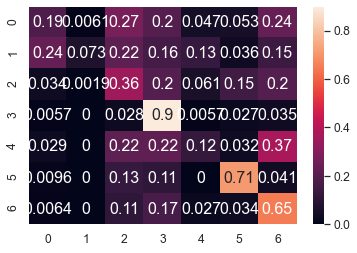

	training epoch=24 .. train_loss=1.069
	validation epoch=24 .. val_loss=1.305
	Accuracy = 51.5 % .. Percision = 51.0 % .. Recall = 42.8 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_24.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 25 .. loss = 1.316


  0%|                                                                                 | 1/1914 [00:01<33:39,  1.06s/it]

training @ epoch 25 .. loss = 1.093


  0%|                                                                                 | 2/1914 [00:02<33:14,  1.04s/it]

training @ epoch 25 .. loss = 0.962


  0%|▏                                                                                | 3/1914 [00:03<33:11,  1.04s/it]

training @ epoch 25 .. loss = 1.059


  0%|▏                                                                                | 4/1914 [00:04<33:07,  1.04s/it]

training @ epoch 25 .. loss = 0.775


  0%|▏                                                                                | 5/1914 [00:05<33:02,  1.04s/it]

training @ epoch 25 .. loss = 1.097


  0%|▎                                                                                | 6/1914 [00:06<33:11,  1.04s/it]

training @ epoch 25 .. loss = 1.213


  0%|▎                                                                                | 7/1914 [00:07<33:13,  1.05s/it]

training @ epoch 25 .. loss = 0.779


  0%|▎                                                                                | 8/1914 [00:08<33:18,  1.05s/it]

training @ epoch 25 .. loss = 0.627


  0%|▍                                                                                | 9/1914 [00:09<33:08,  1.04s/it]

training @ epoch 25 .. loss = 0.716


  1%|▍                                                                               | 10/1914 [00:10<33:23,  1.05s/it]

training @ epoch 25 .. loss = 0.872


  1%|▍                                                                               | 11/1914 [00:11<33:18,  1.05s/it]

training @ epoch 25 .. loss = 1.298


  1%|▌                                                                               | 12/1914 [00:12<33:56,  1.07s/it]

training @ epoch 25 .. loss = 1.079


  1%|▌                                                                               | 13/1914 [00:13<33:44,  1.07s/it]

training @ epoch 25 .. loss = 1.327


  1%|▌                                                                               | 14/1914 [00:14<33:40,  1.06s/it]

training @ epoch 25 .. loss = 1.086


  1%|▋                                                                               | 15/1914 [00:15<33:02,  1.04s/it]

training @ epoch 25 .. loss = 0.821


  1%|▋                                                                               | 16/1914 [00:16<32:58,  1.04s/it]

training @ epoch 25 .. loss = 1.105


  1%|▋                                                                               | 17/1914 [00:17<32:43,  1.04s/it]

training @ epoch 25 .. loss = 1.504


  1%|▊                                                                               | 18/1914 [00:18<32:45,  1.04s/it]

training @ epoch 25 .. loss = 1.076


  1%|▊                                                                               | 19/1914 [00:19<32:43,  1.04s/it]

training @ epoch 25 .. loss = 1.141


  1%|▊                                                                               | 20/1914 [00:20<32:32,  1.03s/it]

training @ epoch 25 .. loss = 0.945


  1%|▉                                                                               | 21/1914 [00:21<32:06,  1.02s/it]

training @ epoch 25 .. loss = 0.875


  1%|▉                                                                               | 22/1914 [00:22<32:44,  1.04s/it]

training @ epoch 25 .. loss = 0.944


  1%|▉                                                                               | 23/1914 [00:23<32:31,  1.03s/it]

training @ epoch 25 .. loss = 1.367


  1%|█                                                                               | 24/1914 [00:25<32:37,  1.04s/it]

training @ epoch 25 .. loss = 0.626


  1%|█                                                                               | 25/1914 [00:26<32:39,  1.04s/it]

training @ epoch 25 .. loss = 1.809


  1%|█                                                                               | 26/1914 [00:27<32:42,  1.04s/it]

training @ epoch 25 .. loss = 0.846


  1%|█▏                                                                              | 27/1914 [00:28<32:29,  1.03s/it]

training @ epoch 25 .. loss = 1.005


  1%|█▏                                                                              | 28/1914 [00:29<32:54,  1.05s/it]

training @ epoch 25 .. loss = 1.055


  2%|█▏                                                                              | 29/1914 [00:30<33:14,  1.06s/it]

training @ epoch 25 .. loss = 0.807


  2%|█▎                                                                              | 30/1914 [00:31<33:16,  1.06s/it]

training @ epoch 25 .. loss = 0.903


  2%|█▎                                                                              | 31/1914 [00:32<33:00,  1.05s/it]

training @ epoch 25 .. loss = 1.073


  2%|█▎                                                                              | 32/1914 [00:33<32:40,  1.04s/it]

training @ epoch 25 .. loss = 0.686


  2%|█▍                                                                              | 33/1914 [00:34<32:26,  1.03s/it]

training @ epoch 25 .. loss = 1.049


  2%|█▍                                                                              | 34/1914 [00:35<32:19,  1.03s/it]

training @ epoch 25 .. loss = 1.241


  2%|█▍                                                                              | 35/1914 [00:36<32:10,  1.03s/it]

training @ epoch 25 .. loss = 1.439


  2%|█▌                                                                              | 36/1914 [00:37<31:55,  1.02s/it]

training @ epoch 25 .. loss = 0.863


  2%|█▌                                                                              | 37/1914 [00:38<32:36,  1.04s/it]

training @ epoch 25 .. loss = 0.95


  2%|█▌                                                                              | 38/1914 [00:39<32:44,  1.05s/it]

training @ epoch 25 .. loss = 1.027


  2%|█▋                                                                              | 39/1914 [00:40<33:23,  1.07s/it]

training @ epoch 25 .. loss = 1.229


  2%|█▋                                                                              | 40/1914 [00:41<32:57,  1.06s/it]

training @ epoch 25 .. loss = 1.149


  2%|█▋                                                                              | 41/1914 [00:42<33:00,  1.06s/it]

training @ epoch 25 .. loss = 1.174


  2%|█▊                                                                              | 42/1914 [00:43<32:40,  1.05s/it]

training @ epoch 25 .. loss = 1.256


  2%|█▊                                                                              | 43/1914 [00:44<33:38,  1.08s/it]

training @ epoch 25 .. loss = 1.034


  2%|█▊                                                                              | 44/1914 [00:46<34:46,  1.12s/it]

training @ epoch 25 .. loss = 1.025


  2%|█▉                                                                              | 45/1914 [00:47<35:22,  1.14s/it]

training @ epoch 25 .. loss = 0.827


  2%|█▉                                                                              | 46/1914 [00:48<35:24,  1.14s/it]

training @ epoch 25 .. loss = 0.678


  2%|█▉                                                                              | 47/1914 [00:49<35:03,  1.13s/it]

training @ epoch 25 .. loss = 1.019


  3%|██                                                                              | 48/1914 [00:50<34:08,  1.10s/it]

training @ epoch 25 .. loss = 1.0


  3%|██                                                                              | 49/1914 [00:51<33:46,  1.09s/it]

training @ epoch 25 .. loss = 0.912


  3%|██                                                                              | 50/1914 [00:52<33:34,  1.08s/it]

training @ epoch 25 .. loss = 0.702


  3%|██▏                                                                             | 51/1914 [00:53<33:19,  1.07s/it]

training @ epoch 25 .. loss = 1.424


  3%|██▏                                                                             | 52/1914 [00:54<33:06,  1.07s/it]

training @ epoch 25 .. loss = 0.942


  3%|██▏                                                                             | 53/1914 [00:55<33:07,  1.07s/it]

training @ epoch 25 .. loss = 1.109


  3%|██▎                                                                             | 54/1914 [00:56<32:44,  1.06s/it]

training @ epoch 25 .. loss = 1.33


  3%|██▎                                                                             | 55/1914 [00:58<32:35,  1.05s/it]

training @ epoch 25 .. loss = 1.083


  3%|██▎                                                                             | 56/1914 [00:59<32:16,  1.04s/it]

training @ epoch 25 .. loss = 1.299


  3%|██▍                                                                             | 57/1914 [01:00<31:57,  1.03s/it]

training @ epoch 25 .. loss = 1.394


  3%|██▍                                                                             | 58/1914 [01:01<31:52,  1.03s/it]

training @ epoch 25 .. loss = 1.148


  3%|██▍                                                                             | 59/1914 [01:02<31:37,  1.02s/it]

training @ epoch 25 .. loss = 1.003


  3%|██▌                                                                             | 60/1914 [01:03<31:42,  1.03s/it]

training @ epoch 25 .. loss = 0.915


  3%|██▌                                                                             | 61/1914 [01:04<31:47,  1.03s/it]

training @ epoch 25 .. loss = 1.246


  3%|██▌                                                                             | 62/1914 [01:05<31:58,  1.04s/it]

training @ epoch 25 .. loss = 0.99


  3%|██▋                                                                             | 63/1914 [01:06<31:35,  1.02s/it]

training @ epoch 25 .. loss = 1.102


  3%|██▋                                                                             | 64/1914 [01:07<31:32,  1.02s/it]

training @ epoch 25 .. loss = 1.205


  3%|██▋                                                                             | 65/1914 [01:08<31:30,  1.02s/it]

training @ epoch 25 .. loss = 0.844


  3%|██▊                                                                             | 66/1914 [01:09<31:26,  1.02s/it]

training @ epoch 25 .. loss = 1.119


  4%|██▊                                                                             | 67/1914 [01:10<31:51,  1.04s/it]

training @ epoch 25 .. loss = 1.169


  4%|██▊                                                                             | 68/1914 [01:11<32:06,  1.04s/it]

training @ epoch 25 .. loss = 1.043


  4%|██▉                                                                             | 69/1914 [01:12<31:52,  1.04s/it]

training @ epoch 25 .. loss = 0.915


  4%|██▉                                                                             | 70/1914 [01:13<31:50,  1.04s/it]

training @ epoch 25 .. loss = 1.097


  4%|██▉                                                                             | 71/1914 [01:14<32:10,  1.05s/it]

training @ epoch 25 .. loss = 1.377


  4%|███                                                                             | 72/1914 [01:15<32:13,  1.05s/it]

training @ epoch 25 .. loss = 0.716


  4%|███                                                                             | 73/1914 [01:16<31:56,  1.04s/it]

training @ epoch 25 .. loss = 0.796


  4%|███                                                                             | 74/1914 [01:17<32:13,  1.05s/it]

training @ epoch 25 .. loss = 1.23


  4%|███▏                                                                            | 75/1914 [01:18<32:00,  1.04s/it]

training @ epoch 25 .. loss = 0.97


  4%|███▏                                                                            | 76/1914 [01:19<31:57,  1.04s/it]

training @ epoch 25 .. loss = 1.019


  4%|███▏                                                                            | 77/1914 [01:20<31:33,  1.03s/it]

training @ epoch 25 .. loss = 0.754


  4%|███▎                                                                            | 78/1914 [01:21<31:31,  1.03s/it]

training @ epoch 25 .. loss = 1.127


  4%|███▎                                                                            | 79/1914 [01:22<31:22,  1.03s/it]

training @ epoch 25 .. loss = 0.933


  4%|███▎                                                                            | 80/1914 [01:23<31:23,  1.03s/it]

training @ epoch 25 .. loss = 1.462


  4%|███▍                                                                            | 81/1914 [01:24<32:04,  1.05s/it]

training @ epoch 25 .. loss = 1.087


  4%|███▍                                                                            | 82/1914 [01:25<32:01,  1.05s/it]

training @ epoch 25 .. loss = 0.923


  4%|███▍                                                                            | 83/1914 [01:27<31:58,  1.05s/it]

training @ epoch 25 .. loss = 0.854


  4%|███▌                                                                            | 84/1914 [01:28<32:20,  1.06s/it]

training @ epoch 25 .. loss = 0.582


  4%|███▌                                                                            | 85/1914 [01:29<31:52,  1.05s/it]

training @ epoch 25 .. loss = 1.563


  4%|███▌                                                                            | 86/1914 [01:30<31:48,  1.04s/it]

training @ epoch 25 .. loss = 1.068


  5%|███▋                                                                            | 87/1914 [01:31<31:57,  1.05s/it]

training @ epoch 25 .. loss = 0.805


  5%|███▋                                                                            | 88/1914 [01:32<32:06,  1.06s/it]

training @ epoch 25 .. loss = 0.878


  5%|███▋                                                                            | 89/1914 [01:33<32:15,  1.06s/it]

training @ epoch 25 .. loss = 0.918


  5%|███▊                                                                            | 90/1914 [01:34<32:03,  1.05s/it]

training @ epoch 25 .. loss = 0.843


  5%|███▊                                                                            | 91/1914 [01:35<32:12,  1.06s/it]

training @ epoch 25 .. loss = 0.788


  5%|███▊                                                                            | 92/1914 [01:36<31:49,  1.05s/it]

training @ epoch 25 .. loss = 1.122


  5%|███▉                                                                            | 93/1914 [01:37<31:31,  1.04s/it]

training @ epoch 25 .. loss = 0.88


  5%|███▉                                                                            | 94/1914 [01:38<31:28,  1.04s/it]

training @ epoch 25 .. loss = 1.115


  5%|███▉                                                                            | 95/1914 [01:39<31:53,  1.05s/it]

training @ epoch 25 .. loss = 0.967


  5%|████                                                                            | 96/1914 [01:40<31:45,  1.05s/it]

training @ epoch 25 .. loss = 1.258


  5%|████                                                                            | 97/1914 [01:41<32:03,  1.06s/it]

training @ epoch 25 .. loss = 0.644


  5%|████                                                                            | 98/1914 [01:42<31:49,  1.05s/it]

training @ epoch 25 .. loss = 1.107


  5%|████▏                                                                           | 99/1914 [01:44<33:48,  1.12s/it]

training @ epoch 25 .. loss = 1.279


  5%|████▏                                                                          | 100/1914 [01:45<35:36,  1.18s/it]

training @ epoch 25 .. loss = 0.764


  5%|████▏                                                                          | 101/1914 [01:46<37:38,  1.25s/it]

training @ epoch 25 .. loss = 0.86


  5%|████▏                                                                          | 102/1914 [01:48<39:15,  1.30s/it]

training @ epoch 25 .. loss = 0.977


  5%|████▎                                                                          | 103/1914 [01:49<40:27,  1.34s/it]

training @ epoch 25 .. loss = 0.868


  5%|████▎                                                                          | 104/1914 [01:51<40:39,  1.35s/it]

training @ epoch 25 .. loss = 1.098


  5%|████▎                                                                          | 105/1914 [01:52<39:41,  1.32s/it]

training @ epoch 25 .. loss = 0.672


  6%|████▍                                                                          | 106/1914 [01:53<38:31,  1.28s/it]

training @ epoch 25 .. loss = 1.349


  6%|████▍                                                                          | 107/1914 [01:54<37:38,  1.25s/it]

training @ epoch 25 .. loss = 0.771


  6%|████▍                                                                          | 108/1914 [01:55<37:22,  1.24s/it]

training @ epoch 25 .. loss = 1.185


  6%|████▍                                                                          | 109/1914 [01:57<37:10,  1.24s/it]

training @ epoch 25 .. loss = 1.2


  6%|████▌                                                                          | 110/1914 [01:58<37:37,  1.25s/it]

training @ epoch 25 .. loss = 1.166


  6%|████▌                                                                          | 111/1914 [01:59<37:43,  1.26s/it]

training @ epoch 25 .. loss = 1.121


  6%|████▌                                                                          | 112/1914 [02:00<36:51,  1.23s/it]

training @ epoch 25 .. loss = 0.691


  6%|████▋                                                                          | 113/1914 [02:01<35:00,  1.17s/it]

training @ epoch 25 .. loss = 0.92


  6%|████▋                                                                          | 114/1914 [02:02<33:47,  1.13s/it]

training @ epoch 25 .. loss = 1.036


  6%|████▋                                                                          | 115/1914 [02:03<33:04,  1.10s/it]

training @ epoch 25 .. loss = 1.012


  6%|████▊                                                                          | 116/1914 [02:04<32:28,  1.08s/it]

training @ epoch 25 .. loss = 1.16


  6%|████▊                                                                          | 117/1914 [02:05<32:20,  1.08s/it]

training @ epoch 25 .. loss = 0.915


  6%|████▊                                                                          | 118/1914 [02:07<32:14,  1.08s/it]

training @ epoch 25 .. loss = 1.207


  6%|████▉                                                                          | 119/1914 [02:08<32:03,  1.07s/it]

training @ epoch 25 .. loss = 0.935


  6%|████▉                                                                          | 120/1914 [02:09<31:35,  1.06s/it]

training @ epoch 25 .. loss = 1.43


  6%|████▉                                                                          | 121/1914 [02:10<31:48,  1.06s/it]

training @ epoch 25 .. loss = 1.339


  6%|█████                                                                          | 122/1914 [02:11<31:47,  1.06s/it]

training @ epoch 25 .. loss = 1.01


  6%|█████                                                                          | 123/1914 [02:12<31:33,  1.06s/it]

training @ epoch 25 .. loss = 0.89


  6%|█████                                                                          | 124/1914 [02:13<31:19,  1.05s/it]

training @ epoch 25 .. loss = 1.612


  7%|█████▏                                                                         | 125/1914 [02:14<31:19,  1.05s/it]

training @ epoch 25 .. loss = 1.089


  7%|█████▏                                                                         | 126/1914 [02:15<31:24,  1.05s/it]

training @ epoch 25 .. loss = 0.661


  7%|█████▏                                                                         | 127/1914 [02:16<31:27,  1.06s/it]

training @ epoch 25 .. loss = 1.182


  7%|█████▎                                                                         | 128/1914 [02:17<31:24,  1.05s/it]

training @ epoch 25 .. loss = 0.926


  7%|█████▎                                                                         | 129/1914 [02:18<31:42,  1.07s/it]

training @ epoch 25 .. loss = 0.741


  7%|█████▎                                                                         | 130/1914 [02:19<31:32,  1.06s/it]

training @ epoch 25 .. loss = 0.774


  7%|█████▍                                                                         | 131/1914 [02:20<31:26,  1.06s/it]

training @ epoch 25 .. loss = 1.2


  7%|█████▍                                                                         | 132/1914 [02:21<31:22,  1.06s/it]

training @ epoch 25 .. loss = 1.208


  7%|█████▍                                                                         | 133/1914 [02:22<31:16,  1.05s/it]

training @ epoch 25 .. loss = 0.702


  7%|█████▌                                                                         | 134/1914 [02:23<31:13,  1.05s/it]

training @ epoch 25 .. loss = 1.32


  7%|█████▌                                                                         | 135/1914 [02:24<30:46,  1.04s/it]

training @ epoch 25 .. loss = 1.034


  7%|█████▌                                                                         | 136/1914 [02:25<30:55,  1.04s/it]

training @ epoch 25 .. loss = 1.126


  7%|█████▋                                                                         | 137/1914 [02:27<30:46,  1.04s/it]

training @ epoch 25 .. loss = 0.983


  7%|█████▋                                                                         | 138/1914 [02:28<30:42,  1.04s/it]

training @ epoch 25 .. loss = 0.874


  7%|█████▋                                                                         | 139/1914 [02:29<30:51,  1.04s/it]

training @ epoch 25 .. loss = 1.256


  7%|█████▊                                                                         | 140/1914 [02:30<30:20,  1.03s/it]

training @ epoch 25 .. loss = 1.203


  7%|█████▊                                                                         | 141/1914 [02:31<30:06,  1.02s/it]

training @ epoch 25 .. loss = 0.927


  7%|█████▊                                                                         | 142/1914 [02:32<30:15,  1.02s/it]

training @ epoch 25 .. loss = 1.029


  7%|█████▉                                                                         | 143/1914 [02:33<30:44,  1.04s/it]

training @ epoch 25 .. loss = 1.761


  8%|█████▉                                                                         | 144/1914 [02:34<30:59,  1.05s/it]

training @ epoch 25 .. loss = 0.97


  8%|█████▉                                                                         | 145/1914 [02:35<30:48,  1.04s/it]

training @ epoch 25 .. loss = 1.205


  8%|██████                                                                         | 146/1914 [02:36<30:55,  1.05s/it]

training @ epoch 25 .. loss = 1.671


  8%|██████                                                                         | 147/1914 [02:37<30:59,  1.05s/it]

training @ epoch 25 .. loss = 0.829


  8%|██████                                                                         | 148/1914 [02:38<31:07,  1.06s/it]

training @ epoch 25 .. loss = 0.873


  8%|██████▏                                                                        | 149/1914 [02:39<31:30,  1.07s/it]

training @ epoch 25 .. loss = 1.109


  8%|██████▏                                                                        | 150/1914 [02:40<31:33,  1.07s/it]

training @ epoch 25 .. loss = 0.791


  8%|██████▏                                                                        | 151/1914 [02:41<31:40,  1.08s/it]

training @ epoch 25 .. loss = 1.053


  8%|██████▎                                                                        | 152/1914 [02:42<31:43,  1.08s/it]

training @ epoch 25 .. loss = 1.522


  8%|██████▎                                                                        | 153/1914 [02:43<31:36,  1.08s/it]

training @ epoch 25 .. loss = 1.104


  8%|██████▎                                                                        | 154/1914 [02:44<31:26,  1.07s/it]

training @ epoch 25 .. loss = 0.901


  8%|██████▍                                                                        | 155/1914 [02:46<31:16,  1.07s/it]

training @ epoch 25 .. loss = 1.052


  8%|██████▍                                                                        | 156/1914 [02:47<30:55,  1.06s/it]

training @ epoch 25 .. loss = 0.943


  8%|██████▍                                                                        | 157/1914 [02:48<30:52,  1.05s/it]

training @ epoch 25 .. loss = 0.784


  8%|██████▌                                                                        | 158/1914 [02:49<30:33,  1.04s/it]

training @ epoch 25 .. loss = 1.175


  8%|██████▌                                                                        | 159/1914 [02:50<30:38,  1.05s/it]

training @ epoch 25 .. loss = 0.777


  8%|██████▌                                                                        | 160/1914 [02:51<30:44,  1.05s/it]

training @ epoch 25 .. loss = 0.805


  8%|██████▋                                                                        | 161/1914 [02:52<31:04,  1.06s/it]

training @ epoch 25 .. loss = 0.94


  8%|██████▋                                                                        | 162/1914 [02:53<30:30,  1.04s/it]

training @ epoch 25 .. loss = 0.995


  9%|██████▋                                                                        | 163/1914 [02:54<30:38,  1.05s/it]

training @ epoch 25 .. loss = 1.338


  9%|██████▊                                                                        | 164/1914 [02:55<30:38,  1.05s/it]

training @ epoch 25 .. loss = 1.139


  9%|██████▊                                                                        | 165/1914 [02:56<30:35,  1.05s/it]

training @ epoch 25 .. loss = 1.4


  9%|██████▊                                                                        | 166/1914 [02:57<30:51,  1.06s/it]

training @ epoch 25 .. loss = 0.7


  9%|██████▉                                                                        | 167/1914 [02:58<31:53,  1.10s/it]

training @ epoch 25 .. loss = 1.363


  9%|██████▉                                                                        | 168/1914 [03:00<33:55,  1.17s/it]

training @ epoch 25 .. loss = 0.99


  9%|██████▉                                                                        | 169/1914 [03:01<33:14,  1.14s/it]

training @ epoch 25 .. loss = 1.493


  9%|███████                                                                        | 170/1914 [03:02<32:17,  1.11s/it]

training @ epoch 25 .. loss = 1.021


  9%|███████                                                                        | 171/1914 [03:03<32:03,  1.10s/it]

training @ epoch 25 .. loss = 1.121


  9%|███████                                                                        | 172/1914 [03:04<31:14,  1.08s/it]

training @ epoch 25 .. loss = 0.822


  9%|███████▏                                                                       | 173/1914 [03:05<31:06,  1.07s/it]

training @ epoch 25 .. loss = 0.757


  9%|███████▏                                                                       | 174/1914 [03:06<30:37,  1.06s/it]

training @ epoch 25 .. loss = 1.327


  9%|███████▏                                                                       | 175/1914 [03:07<30:32,  1.05s/it]

training @ epoch 25 .. loss = 0.889


  9%|███████▎                                                                       | 176/1914 [03:08<30:30,  1.05s/it]

training @ epoch 25 .. loss = 0.795


  9%|███████▎                                                                       | 177/1914 [03:09<30:15,  1.05s/it]

training @ epoch 25 .. loss = 0.707


  9%|███████▎                                                                       | 178/1914 [03:10<30:17,  1.05s/it]

training @ epoch 25 .. loss = 0.904


  9%|███████▍                                                                       | 179/1914 [03:11<30:23,  1.05s/it]

training @ epoch 25 .. loss = 1.332


  9%|███████▍                                                                       | 180/1914 [03:12<30:12,  1.05s/it]

training @ epoch 25 .. loss = 0.875


  9%|███████▍                                                                       | 181/1914 [03:13<30:18,  1.05s/it]

training @ epoch 25 .. loss = 0.98


 10%|███████▌                                                                       | 182/1914 [03:14<30:00,  1.04s/it]

training @ epoch 25 .. loss = 1.127


 10%|███████▌                                                                       | 183/1914 [03:15<30:00,  1.04s/it]

training @ epoch 25 .. loss = 1.161


 10%|███████▌                                                                       | 184/1914 [03:16<29:56,  1.04s/it]

training @ epoch 25 .. loss = 0.917


 10%|███████▋                                                                       | 185/1914 [03:17<29:54,  1.04s/it]

training @ epoch 25 .. loss = 1.353


 10%|███████▋                                                                       | 186/1914 [03:18<30:04,  1.04s/it]

training @ epoch 25 .. loss = 0.898


 10%|███████▋                                                                       | 187/1914 [03:19<29:57,  1.04s/it]

training @ epoch 25 .. loss = 1.038


 10%|███████▊                                                                       | 188/1914 [03:21<30:08,  1.05s/it]

training @ epoch 25 .. loss = 1.3


 10%|███████▊                                                                       | 189/1914 [03:22<29:52,  1.04s/it]

training @ epoch 25 .. loss = 1.334


 10%|███████▊                                                                       | 190/1914 [03:23<29:40,  1.03s/it]

training @ epoch 25 .. loss = 0.957


 10%|███████▉                                                                       | 191/1914 [03:24<29:46,  1.04s/it]

training @ epoch 25 .. loss = 1.032


 10%|███████▉                                                                       | 192/1914 [03:25<29:47,  1.04s/it]

training @ epoch 25 .. loss = 1.5


 10%|███████▉                                                                       | 193/1914 [03:26<29:53,  1.04s/it]

training @ epoch 25 .. loss = 1.091


 10%|████████                                                                       | 194/1914 [03:27<29:39,  1.03s/it]

training @ epoch 25 .. loss = 1.242


 10%|████████                                                                       | 195/1914 [03:28<29:40,  1.04s/it]

training @ epoch 25 .. loss = 1.111


 10%|████████                                                                       | 196/1914 [03:29<29:57,  1.05s/it]

training @ epoch 25 .. loss = 1.089


 10%|████████▏                                                                      | 197/1914 [03:30<29:34,  1.03s/it]

training @ epoch 25 .. loss = 1.033


 10%|████████▏                                                                      | 198/1914 [03:31<29:32,  1.03s/it]

training @ epoch 25 .. loss = 1.037


 10%|████████▏                                                                      | 199/1914 [03:32<29:40,  1.04s/it]

training @ epoch 25 .. loss = 1.045


 10%|████████▎                                                                      | 200/1914 [03:33<30:02,  1.05s/it]

training @ epoch 25 .. loss = 0.797


 11%|████████▎                                                                      | 201/1914 [03:34<29:48,  1.04s/it]

training @ epoch 25 .. loss = 1.439


 11%|████████▎                                                                      | 202/1914 [03:35<29:53,  1.05s/it]

training @ epoch 25 .. loss = 1.4


 11%|████████▍                                                                      | 203/1914 [03:36<29:45,  1.04s/it]

training @ epoch 25 .. loss = 1.372


 11%|████████▍                                                                      | 204/1914 [03:37<29:47,  1.05s/it]

training @ epoch 25 .. loss = 0.882


 11%|████████▍                                                                      | 205/1914 [03:38<29:35,  1.04s/it]

training @ epoch 25 .. loss = 1.3


 11%|████████▌                                                                      | 206/1914 [03:39<29:23,  1.03s/it]

training @ epoch 25 .. loss = 1.197


 11%|████████▌                                                                      | 207/1914 [03:40<29:33,  1.04s/it]

training @ epoch 25 .. loss = 1.316


 11%|████████▌                                                                      | 208/1914 [03:41<30:00,  1.06s/it]

training @ epoch 25 .. loss = 0.913


 11%|████████▋                                                                      | 209/1914 [03:42<30:03,  1.06s/it]

training @ epoch 25 .. loss = 0.931


 11%|████████▋                                                                      | 210/1914 [03:44<30:19,  1.07s/it]

training @ epoch 25 .. loss = 0.975


 11%|████████▋                                                                      | 211/1914 [03:45<30:24,  1.07s/it]

training @ epoch 25 .. loss = 1.148


 11%|████████▊                                                                      | 212/1914 [03:46<30:03,  1.06s/it]

training @ epoch 25 .. loss = 0.931


 11%|████████▊                                                                      | 213/1914 [03:47<30:20,  1.07s/it]

training @ epoch 25 .. loss = 0.892


 11%|████████▊                                                                      | 214/1914 [03:48<30:09,  1.06s/it]

training @ epoch 25 .. loss = 0.773


 11%|████████▊                                                                      | 215/1914 [03:49<30:12,  1.07s/it]

training @ epoch 25 .. loss = 1.364


 11%|████████▉                                                                      | 216/1914 [03:50<29:52,  1.06s/it]

training @ epoch 25 .. loss = 0.843


 11%|████████▉                                                                      | 217/1914 [03:51<30:20,  1.07s/it]

training @ epoch 25 .. loss = 1.04


 11%|████████▉                                                                      | 218/1914 [03:52<29:57,  1.06s/it]

training @ epoch 25 .. loss = 1.06


 11%|█████████                                                                      | 219/1914 [03:53<29:41,  1.05s/it]

training @ epoch 25 .. loss = 1.226


 11%|█████████                                                                      | 220/1914 [03:54<29:32,  1.05s/it]

training @ epoch 25 .. loss = 0.594


 12%|█████████                                                                      | 221/1914 [03:55<29:33,  1.05s/it]

training @ epoch 25 .. loss = 1.192


 12%|█████████▏                                                                     | 222/1914 [03:56<29:19,  1.04s/it]

training @ epoch 25 .. loss = 1.099


 12%|█████████▏                                                                     | 223/1914 [03:57<29:15,  1.04s/it]

training @ epoch 25 .. loss = 1.224


 12%|█████████▏                                                                     | 224/1914 [03:58<29:28,  1.05s/it]

training @ epoch 25 .. loss = 1.126


 12%|█████████▎                                                                     | 225/1914 [03:59<30:45,  1.09s/it]

training @ epoch 25 .. loss = 1.332


 12%|█████████▎                                                                     | 226/1914 [04:01<30:26,  1.08s/it]

training @ epoch 25 .. loss = 1.151


 12%|█████████▎                                                                     | 227/1914 [04:02<31:23,  1.12s/it]

training @ epoch 25 .. loss = 1.009


 12%|█████████▍                                                                     | 228/1914 [04:03<31:24,  1.12s/it]

training @ epoch 25 .. loss = 1.171


 12%|█████████▍                                                                     | 229/1914 [04:04<31:19,  1.12s/it]

training @ epoch 25 .. loss = 0.969


 12%|█████████▍                                                                     | 230/1914 [04:05<30:26,  1.08s/it]

training @ epoch 25 .. loss = 0.848


 12%|█████████▌                                                                     | 231/1914 [04:06<30:14,  1.08s/it]

training @ epoch 25 .. loss = 1.099


 12%|█████████▌                                                                     | 232/1914 [04:07<31:07,  1.11s/it]

training @ epoch 25 .. loss = 0.982


 12%|█████████▌                                                                     | 233/1914 [04:08<30:44,  1.10s/it]

training @ epoch 25 .. loss = 1.051


 12%|█████████▋                                                                     | 234/1914 [04:09<30:37,  1.09s/it]

training @ epoch 25 .. loss = 1.126


 12%|█████████▋                                                                     | 235/1914 [04:11<31:13,  1.12s/it]

training @ epoch 25 .. loss = 0.867


 12%|█████████▋                                                                     | 236/1914 [04:12<30:39,  1.10s/it]

training @ epoch 25 .. loss = 1.555


 12%|█████████▊                                                                     | 237/1914 [04:13<30:36,  1.09s/it]

training @ epoch 25 .. loss = 0.674


 12%|█████████▊                                                                     | 238/1914 [04:14<30:08,  1.08s/it]

training @ epoch 25 .. loss = 1.4


 12%|█████████▊                                                                     | 239/1914 [04:15<29:52,  1.07s/it]

training @ epoch 25 .. loss = 0.82


 13%|█████████▉                                                                     | 240/1914 [04:16<29:51,  1.07s/it]

training @ epoch 25 .. loss = 0.937


 13%|█████████▉                                                                     | 241/1914 [04:17<29:31,  1.06s/it]

training @ epoch 25 .. loss = 1.279


 13%|█████████▉                                                                     | 242/1914 [04:18<29:30,  1.06s/it]

training @ epoch 25 .. loss = 0.69


 13%|██████████                                                                     | 243/1914 [04:19<29:35,  1.06s/it]

training @ epoch 25 .. loss = 1.678


 13%|██████████                                                                     | 244/1914 [04:20<29:29,  1.06s/it]

training @ epoch 25 .. loss = 0.811


 13%|██████████                                                                     | 245/1914 [04:21<29:15,  1.05s/it]

training @ epoch 25 .. loss = 0.909


 13%|██████████▏                                                                    | 246/1914 [04:22<28:57,  1.04s/it]

training @ epoch 25 .. loss = 0.574


 13%|██████████▏                                                                    | 247/1914 [04:23<28:44,  1.03s/it]

training @ epoch 25 .. loss = 1.386


 13%|██████████▏                                                                    | 248/1914 [04:24<28:30,  1.03s/it]

training @ epoch 25 .. loss = 0.858


 13%|██████████▎                                                                    | 249/1914 [04:25<28:17,  1.02s/it]

training @ epoch 25 .. loss = 1.31


 13%|██████████▎                                                                    | 250/1914 [04:26<28:23,  1.02s/it]

training @ epoch 25 .. loss = 1.212


 13%|██████████▎                                                                    | 251/1914 [04:27<28:44,  1.04s/it]

training @ epoch 25 .. loss = 1.059


 13%|██████████▍                                                                    | 252/1914 [04:28<28:44,  1.04s/it]

training @ epoch 25 .. loss = 0.74


 13%|██████████▍                                                                    | 253/1914 [04:29<28:33,  1.03s/it]

training @ epoch 25 .. loss = 0.97


 13%|██████████▍                                                                    | 254/1914 [04:30<28:59,  1.05s/it]

training @ epoch 25 .. loss = 0.826


 13%|██████████▌                                                                    | 255/1914 [04:31<29:14,  1.06s/it]

training @ epoch 25 .. loss = 1.04


 13%|██████████▌                                                                    | 256/1914 [04:32<28:56,  1.05s/it]

training @ epoch 25 .. loss = 1.02


 13%|██████████▌                                                                    | 257/1914 [04:33<28:33,  1.03s/it]

training @ epoch 25 .. loss = 0.89


 13%|██████████▋                                                                    | 258/1914 [04:35<28:32,  1.03s/it]

training @ epoch 25 .. loss = 0.912


 14%|██████████▋                                                                    | 259/1914 [04:36<28:41,  1.04s/it]

training @ epoch 25 .. loss = 0.994


 14%|██████████▋                                                                    | 260/1914 [04:37<28:45,  1.04s/it]

training @ epoch 25 .. loss = 1.519


 14%|██████████▊                                                                    | 261/1914 [04:38<28:33,  1.04s/it]

training @ epoch 25 .. loss = 0.627


 14%|██████████▊                                                                    | 262/1914 [04:39<28:30,  1.04s/it]

training @ epoch 25 .. loss = 1.651


 14%|██████████▊                                                                    | 263/1914 [04:40<28:45,  1.04s/it]

training @ epoch 25 .. loss = 0.727


 14%|██████████▉                                                                    | 264/1914 [04:41<28:41,  1.04s/it]

training @ epoch 25 .. loss = 0.701


 14%|██████████▉                                                                    | 265/1914 [04:42<28:28,  1.04s/it]

training @ epoch 25 .. loss = 0.627


 14%|██████████▉                                                                    | 266/1914 [04:43<28:19,  1.03s/it]

training @ epoch 25 .. loss = 0.704


 14%|███████████                                                                    | 267/1914 [04:44<28:38,  1.04s/it]

training @ epoch 25 .. loss = 0.922


 14%|███████████                                                                    | 268/1914 [04:45<28:32,  1.04s/it]

training @ epoch 25 .. loss = 1.055


 14%|███████████                                                                    | 269/1914 [04:46<28:41,  1.05s/it]

training @ epoch 25 .. loss = 1.5


 14%|███████████▏                                                                   | 270/1914 [04:47<28:33,  1.04s/it]

training @ epoch 25 .. loss = 1.416


 14%|███████████▏                                                                   | 271/1914 [04:48<28:37,  1.05s/it]

training @ epoch 25 .. loss = 0.842


 14%|███████████▏                                                                   | 272/1914 [04:49<28:31,  1.04s/it]

training @ epoch 25 .. loss = 1.152


 14%|███████████▎                                                                   | 273/1914 [04:50<28:41,  1.05s/it]

training @ epoch 25 .. loss = 1.372


 14%|███████████▎                                                                   | 274/1914 [04:51<28:36,  1.05s/it]

training @ epoch 25 .. loss = 1.096


 14%|███████████▎                                                                   | 275/1914 [04:52<28:33,  1.05s/it]

training @ epoch 25 .. loss = 0.88


 14%|███████████▍                                                                   | 276/1914 [04:53<28:36,  1.05s/it]

training @ epoch 25 .. loss = 1.195


 14%|███████████▍                                                                   | 277/1914 [04:54<28:37,  1.05s/it]

training @ epoch 25 .. loss = 1.115


 15%|███████████▍                                                                   | 278/1914 [04:55<28:28,  1.04s/it]

training @ epoch 25 .. loss = 0.904


 15%|███████████▌                                                                   | 279/1914 [04:56<28:30,  1.05s/it]

training @ epoch 25 .. loss = 0.72


 15%|███████████▌                                                                   | 280/1914 [04:57<28:32,  1.05s/it]

training @ epoch 25 .. loss = 1.283


 15%|███████████▌                                                                   | 281/1914 [04:59<28:38,  1.05s/it]

training @ epoch 25 .. loss = 0.835


 15%|███████████▋                                                                   | 282/1914 [05:00<28:32,  1.05s/it]

training @ epoch 25 .. loss = 0.868


 15%|███████████▋                                                                   | 283/1914 [05:01<28:31,  1.05s/it]

training @ epoch 25 .. loss = 0.635


 15%|███████████▋                                                                   | 284/1914 [05:02<28:38,  1.05s/it]

training @ epoch 25 .. loss = 1.009


 15%|███████████▊                                                                   | 285/1914 [05:03<27:56,  1.03s/it]

training @ epoch 25 .. loss = 1.077


 15%|███████████▊                                                                   | 286/1914 [05:04<28:02,  1.03s/it]

training @ epoch 25 .. loss = 0.839


 15%|███████████▊                                                                   | 287/1914 [05:05<28:19,  1.04s/it]

training @ epoch 25 .. loss = 1.033


 15%|███████████▉                                                                   | 288/1914 [05:06<28:39,  1.06s/it]

training @ epoch 25 .. loss = 0.778


 15%|███████████▉                                                                   | 289/1914 [05:07<28:15,  1.04s/it]

training @ epoch 25 .. loss = 1.038


 15%|███████████▉                                                                   | 290/1914 [05:08<28:22,  1.05s/it]

training @ epoch 25 .. loss = 0.872


 15%|████████████                                                                   | 291/1914 [05:09<28:28,  1.05s/it]

training @ epoch 25 .. loss = 1.324


 15%|████████████                                                                   | 292/1914 [05:10<28:20,  1.05s/it]

training @ epoch 25 .. loss = 1.497


 15%|████████████                                                                   | 293/1914 [05:11<28:34,  1.06s/it]

training @ epoch 25 .. loss = 0.89


 15%|████████████▏                                                                  | 294/1914 [05:12<28:27,  1.05s/it]

training @ epoch 25 .. loss = 1.345


 15%|████████████▏                                                                  | 295/1914 [05:13<28:08,  1.04s/it]

training @ epoch 25 .. loss = 0.847


 15%|████████████▏                                                                  | 296/1914 [05:14<27:51,  1.03s/it]

training @ epoch 25 .. loss = 1.11


 16%|████████████▎                                                                  | 297/1914 [05:15<27:35,  1.02s/it]

training @ epoch 25 .. loss = 1.324


 16%|████████████▎                                                                  | 298/1914 [05:16<27:51,  1.03s/it]

training @ epoch 25 .. loss = 0.876


 16%|████████████▎                                                                  | 299/1914 [05:17<27:58,  1.04s/it]

training @ epoch 25 .. loss = 0.814


 16%|████████████▍                                                                  | 300/1914 [05:18<27:39,  1.03s/it]

training @ epoch 25 .. loss = 0.665


 16%|████████████▍                                                                  | 301/1914 [05:19<27:40,  1.03s/it]

training @ epoch 25 .. loss = 0.821


 16%|████████████▍                                                                  | 302/1914 [05:20<27:34,  1.03s/it]

training @ epoch 25 .. loss = 1.242


 16%|████████████▌                                                                  | 303/1914 [05:21<27:49,  1.04s/it]

training @ epoch 25 .. loss = 1.134


 16%|████████████▌                                                                  | 304/1914 [05:22<27:55,  1.04s/it]

training @ epoch 25 .. loss = 1.176


 16%|████████████▌                                                                  | 305/1914 [05:23<27:44,  1.03s/it]

training @ epoch 25 .. loss = 1.076


 16%|████████████▋                                                                  | 306/1914 [05:25<27:34,  1.03s/it]

training @ epoch 25 .. loss = 1.223


 16%|████████████▋                                                                  | 307/1914 [05:26<27:43,  1.04s/it]

training @ epoch 25 .. loss = 1.083


 16%|████████████▋                                                                  | 308/1914 [05:27<27:39,  1.03s/it]

training @ epoch 25 .. loss = 1.696


 16%|████████████▊                                                                  | 309/1914 [05:28<27:32,  1.03s/it]

training @ epoch 25 .. loss = 0.68


 16%|████████████▊                                                                  | 310/1914 [05:29<27:35,  1.03s/it]

training @ epoch 25 .. loss = 1.181


 16%|████████████▊                                                                  | 311/1914 [05:30<27:58,  1.05s/it]

training @ epoch 25 .. loss = 0.989


 16%|████████████▉                                                                  | 312/1914 [05:31<27:39,  1.04s/it]

training @ epoch 25 .. loss = 1.012


 16%|████████████▉                                                                  | 313/1914 [05:32<27:51,  1.04s/it]

training @ epoch 25 .. loss = 1.061


 16%|████████████▉                                                                  | 314/1914 [05:33<27:32,  1.03s/it]

training @ epoch 25 .. loss = 1.21


 16%|█████████████                                                                  | 315/1914 [05:34<27:17,  1.02s/it]

training @ epoch 25 .. loss = 1.187


 17%|█████████████                                                                  | 316/1914 [05:35<27:23,  1.03s/it]

training @ epoch 25 .. loss = 1.144


 17%|█████████████                                                                  | 317/1914 [05:36<27:32,  1.03s/it]

training @ epoch 25 .. loss = 1.042


 17%|█████████████▏                                                                 | 318/1914 [05:37<27:29,  1.03s/it]

training @ epoch 25 .. loss = 0.754


 17%|█████████████▏                                                                 | 319/1914 [05:38<29:43,  1.12s/it]

training @ epoch 25 .. loss = 1.111


 17%|█████████████▏                                                                 | 320/1914 [05:39<30:21,  1.14s/it]

training @ epoch 25 .. loss = 1.136


 17%|█████████████▏                                                                 | 321/1914 [05:41<29:59,  1.13s/it]

training @ epoch 25 .. loss = 1.518


 17%|█████████████▎                                                                 | 322/1914 [05:42<29:22,  1.11s/it]

training @ epoch 25 .. loss = 0.837


 17%|█████████████▎                                                                 | 323/1914 [05:43<28:35,  1.08s/it]

training @ epoch 25 .. loss = 1.268


 17%|█████████████▎                                                                 | 324/1914 [05:44<28:05,  1.06s/it]

training @ epoch 25 .. loss = 0.809


 17%|█████████████▍                                                                 | 325/1914 [05:45<27:55,  1.05s/it]

training @ epoch 25 .. loss = 0.732


 17%|█████████████▍                                                                 | 326/1914 [05:46<27:58,  1.06s/it]

training @ epoch 25 .. loss = 0.883


 17%|█████████████▍                                                                 | 327/1914 [05:47<27:55,  1.06s/it]

training @ epoch 25 .. loss = 0.714


 17%|█████████████▌                                                                 | 328/1914 [05:48<28:10,  1.07s/it]

training @ epoch 25 .. loss = 0.748


 17%|█████████████▌                                                                 | 329/1914 [05:49<27:58,  1.06s/it]

training @ epoch 25 .. loss = 1.188


 17%|█████████████▌                                                                 | 330/1914 [05:50<28:02,  1.06s/it]

training @ epoch 25 .. loss = 1.001


 17%|█████████████▋                                                                 | 331/1914 [05:51<27:56,  1.06s/it]

training @ epoch 25 .. loss = 1.001


 17%|█████████████▋                                                                 | 332/1914 [05:52<27:41,  1.05s/it]

training @ epoch 25 .. loss = 1.646


 17%|█████████████▋                                                                 | 333/1914 [05:53<27:55,  1.06s/it]

training @ epoch 25 .. loss = 1.116


 17%|█████████████▊                                                                 | 334/1914 [05:54<27:45,  1.05s/it]

training @ epoch 25 .. loss = 0.794


 18%|█████████████▊                                                                 | 335/1914 [05:55<27:47,  1.06s/it]

training @ epoch 25 .. loss = 0.877


 18%|█████████████▊                                                                 | 336/1914 [05:56<27:30,  1.05s/it]

training @ epoch 25 .. loss = 1.235


 18%|█████████████▉                                                                 | 337/1914 [05:57<27:01,  1.03s/it]

training @ epoch 25 .. loss = 1.469


 18%|█████████████▉                                                                 | 338/1914 [05:58<26:47,  1.02s/it]

training @ epoch 25 .. loss = 0.746


 18%|█████████████▉                                                                 | 339/1914 [05:59<26:45,  1.02s/it]

training @ epoch 25 .. loss = 1.324


 18%|██████████████                                                                 | 340/1914 [06:00<26:49,  1.02s/it]

training @ epoch 25 .. loss = 1.431


 18%|██████████████                                                                 | 341/1914 [06:01<27:03,  1.03s/it]

training @ epoch 25 .. loss = 1.527


 18%|██████████████                                                                 | 342/1914 [06:02<27:01,  1.03s/it]

training @ epoch 25 .. loss = 0.935


 18%|██████████████▏                                                                | 343/1914 [06:03<27:14,  1.04s/it]

training @ epoch 25 .. loss = 1.351


 18%|██████████████▏                                                                | 344/1914 [06:04<27:08,  1.04s/it]

training @ epoch 25 .. loss = 0.888


 18%|██████████████▏                                                                | 345/1914 [06:06<27:03,  1.04s/it]

training @ epoch 25 .. loss = 0.799


 18%|██████████████▎                                                                | 346/1914 [06:07<27:03,  1.04s/it]

training @ epoch 25 .. loss = 0.702


 18%|██████████████▎                                                                | 347/1914 [06:08<26:54,  1.03s/it]

training @ epoch 25 .. loss = 1.095


 18%|██████████████▎                                                                | 348/1914 [06:09<27:07,  1.04s/it]

training @ epoch 25 .. loss = 0.678


 18%|██████████████▍                                                                | 349/1914 [06:10<26:32,  1.02s/it]

training @ epoch 25 .. loss = 1.173


 18%|██████████████▍                                                                | 350/1914 [06:11<27:03,  1.04s/it]

training @ epoch 25 .. loss = 0.704


 18%|██████████████▍                                                                | 351/1914 [06:12<27:37,  1.06s/it]

training @ epoch 25 .. loss = 1.167


 18%|██████████████▌                                                                | 352/1914 [06:13<27:22,  1.05s/it]

training @ epoch 25 .. loss = 1.008


 18%|██████████████▌                                                                | 353/1914 [06:14<27:27,  1.06s/it]

training @ epoch 25 .. loss = 0.95


 18%|██████████████▌                                                                | 354/1914 [06:15<27:19,  1.05s/it]

training @ epoch 25 .. loss = 1.407


 19%|██████████████▋                                                                | 355/1914 [06:16<27:10,  1.05s/it]

training @ epoch 25 .. loss = 1.357


 19%|██████████████▋                                                                | 356/1914 [06:17<27:14,  1.05s/it]

training @ epoch 25 .. loss = 1.265


 19%|██████████████▋                                                                | 357/1914 [06:18<27:19,  1.05s/it]

training @ epoch 25 .. loss = 0.983


 19%|██████████████▊                                                                | 358/1914 [06:19<27:24,  1.06s/it]

training @ epoch 25 .. loss = 1.058


 19%|██████████████▊                                                                | 359/1914 [06:20<26:57,  1.04s/it]

training @ epoch 25 .. loss = 0.761


 19%|██████████████▊                                                                | 360/1914 [06:21<26:46,  1.03s/it]

training @ epoch 25 .. loss = 0.645


 19%|██████████████▉                                                                | 361/1914 [06:22<26:44,  1.03s/it]

training @ epoch 25 .. loss = 0.894


 19%|██████████████▉                                                                | 362/1914 [06:23<27:05,  1.05s/it]

training @ epoch 25 .. loss = 1.207


 19%|██████████████▉                                                                | 363/1914 [06:24<26:56,  1.04s/it]

training @ epoch 25 .. loss = 1.23


 19%|███████████████                                                                | 364/1914 [06:25<26:51,  1.04s/it]

training @ epoch 25 .. loss = 0.81


 19%|███████████████                                                                | 365/1914 [06:26<26:54,  1.04s/it]

training @ epoch 25 .. loss = 0.875


 19%|███████████████                                                                | 366/1914 [06:27<26:47,  1.04s/it]

training @ epoch 25 .. loss = 1.247


 19%|███████████████▏                                                               | 367/1914 [06:28<26:38,  1.03s/it]

training @ epoch 25 .. loss = 0.476


 19%|███████████████▏                                                               | 368/1914 [06:30<26:45,  1.04s/it]

training @ epoch 25 .. loss = 0.7


 19%|███████████████▏                                                               | 369/1914 [06:31<26:50,  1.04s/it]

training @ epoch 25 .. loss = 1.499


 19%|███████████████▎                                                               | 370/1914 [06:32<26:49,  1.04s/it]

training @ epoch 25 .. loss = 1.43


 19%|███████████████▎                                                               | 371/1914 [06:33<26:51,  1.04s/it]

training @ epoch 25 .. loss = 1.206


 19%|███████████████▎                                                               | 372/1914 [06:34<27:08,  1.06s/it]

training @ epoch 25 .. loss = 0.749


 19%|███████████████▍                                                               | 373/1914 [06:35<26:38,  1.04s/it]

training @ epoch 25 .. loss = 0.786


 20%|███████████████▍                                                               | 374/1914 [06:36<26:42,  1.04s/it]

training @ epoch 25 .. loss = 0.71


 20%|███████████████▍                                                               | 375/1914 [06:37<26:42,  1.04s/it]

training @ epoch 25 .. loss = 1.0


 20%|███████████████▌                                                               | 376/1914 [06:38<26:55,  1.05s/it]

training @ epoch 25 .. loss = 1.229


 20%|███████████████▌                                                               | 377/1914 [06:39<26:58,  1.05s/it]

training @ epoch 25 .. loss = 1.147


 20%|███████████████▌                                                               | 378/1914 [06:40<26:55,  1.05s/it]

training @ epoch 25 .. loss = 1.388


 20%|███████████████▋                                                               | 379/1914 [06:41<26:36,  1.04s/it]

training @ epoch 25 .. loss = 1.536


 20%|███████████████▋                                                               | 380/1914 [06:42<26:35,  1.04s/it]

training @ epoch 25 .. loss = 1.128


 20%|███████████████▋                                                               | 381/1914 [06:43<26:33,  1.04s/it]

training @ epoch 25 .. loss = 0.384


 20%|███████████████▊                                                               | 382/1914 [06:44<26:28,  1.04s/it]

training @ epoch 25 .. loss = 1.003


 20%|███████████████▊                                                               | 383/1914 [06:45<26:16,  1.03s/it]

training @ epoch 25 .. loss = 1.454


 20%|███████████████▊                                                               | 384/1914 [06:46<26:18,  1.03s/it]

training @ epoch 25 .. loss = 1.026


 20%|███████████████▉                                                               | 385/1914 [06:47<26:25,  1.04s/it]

training @ epoch 25 .. loss = 1.009


 20%|███████████████▉                                                               | 386/1914 [06:48<27:07,  1.06s/it]

training @ epoch 25 .. loss = 1.0


 20%|███████████████▉                                                               | 387/1914 [06:49<26:50,  1.05s/it]

training @ epoch 25 .. loss = 1.06


 20%|████████████████                                                               | 388/1914 [06:50<26:40,  1.05s/it]

training @ epoch 25 .. loss = 1.22


 20%|████████████████                                                               | 389/1914 [06:51<26:45,  1.05s/it]

training @ epoch 25 .. loss = 0.847


 20%|████████████████                                                               | 390/1914 [06:52<26:21,  1.04s/it]

training @ epoch 25 .. loss = 0.714


 20%|████████████████▏                                                              | 391/1914 [06:53<26:03,  1.03s/it]

training @ epoch 25 .. loss = 1.553


 20%|████████████████▏                                                              | 392/1914 [06:54<25:51,  1.02s/it]

training @ epoch 25 .. loss = 1.082


 21%|████████████████▏                                                              | 393/1914 [06:55<25:42,  1.01s/it]

training @ epoch 25 .. loss = 1.539


 21%|████████████████▎                                                              | 394/1914 [06:56<25:43,  1.02s/it]

training @ epoch 25 .. loss = 1.319


 21%|████████████████▎                                                              | 395/1914 [06:58<26:06,  1.03s/it]

training @ epoch 25 .. loss = 1.109


 21%|████████████████▎                                                              | 396/1914 [06:59<26:08,  1.03s/it]

training @ epoch 25 .. loss = 0.976


 21%|████████████████▍                                                              | 397/1914 [07:00<26:26,  1.05s/it]

training @ epoch 25 .. loss = 1.028


 21%|████████████████▍                                                              | 398/1914 [07:01<26:09,  1.04s/it]

training @ epoch 25 .. loss = 0.69


 21%|████████████████▍                                                              | 399/1914 [07:02<26:32,  1.05s/it]

training @ epoch 25 .. loss = 1.665


 21%|████████████████▌                                                              | 400/1914 [07:03<26:27,  1.05s/it]

training @ epoch 25 .. loss = 0.722


 21%|████████████████▌                                                              | 401/1914 [07:04<26:27,  1.05s/it]

training @ epoch 25 .. loss = 1.267


 21%|████████████████▌                                                              | 402/1914 [07:05<26:20,  1.05s/it]

training @ epoch 25 .. loss = 1.126


 21%|████████████████▋                                                              | 403/1914 [07:06<26:12,  1.04s/it]

training @ epoch 25 .. loss = 0.889


 21%|████████████████▋                                                              | 404/1914 [07:07<26:21,  1.05s/it]

training @ epoch 25 .. loss = 0.821


 21%|████████████████▋                                                              | 405/1914 [07:08<26:17,  1.05s/it]

training @ epoch 25 .. loss = 1.156


 21%|████████████████▊                                                              | 406/1914 [07:09<26:03,  1.04s/it]

training @ epoch 25 .. loss = 1.19


 21%|████████████████▊                                                              | 407/1914 [07:10<25:52,  1.03s/it]

training @ epoch 25 .. loss = 0.825


 21%|████████████████▊                                                              | 408/1914 [07:11<26:03,  1.04s/it]

training @ epoch 25 .. loss = 0.981


 21%|████████████████▉                                                              | 409/1914 [07:12<26:11,  1.04s/it]

training @ epoch 25 .. loss = 1.135


 21%|████████████████▉                                                              | 410/1914 [07:13<27:35,  1.10s/it]

training @ epoch 25 .. loss = 1.594


 21%|████████████████▉                                                              | 411/1914 [07:15<28:28,  1.14s/it]

training @ epoch 25 .. loss = 1.035


 22%|█████████████████                                                              | 412/1914 [07:16<28:42,  1.15s/it]

training @ epoch 25 .. loss = 1.106


 22%|█████████████████                                                              | 413/1914 [07:17<28:48,  1.15s/it]

training @ epoch 25 .. loss = 0.872


 22%|█████████████████                                                              | 414/1914 [07:18<29:01,  1.16s/it]

training @ epoch 25 .. loss = 1.233


 22%|█████████████████▏                                                             | 415/1914 [07:19<29:08,  1.17s/it]

training @ epoch 25 .. loss = 0.984


 22%|█████████████████▏                                                             | 416/1914 [07:21<29:15,  1.17s/it]

training @ epoch 25 .. loss = 1.221


 22%|█████████████████▏                                                             | 417/1914 [07:22<29:14,  1.17s/it]

training @ epoch 25 .. loss = 0.549


 22%|█████████████████▎                                                             | 418/1914 [07:23<29:20,  1.18s/it]

training @ epoch 25 .. loss = 1.103


 22%|█████████████████▎                                                             | 419/1914 [07:24<28:12,  1.13s/it]

training @ epoch 25 .. loss = 0.841


 22%|█████████████████▎                                                             | 420/1914 [07:25<28:38,  1.15s/it]

training @ epoch 25 .. loss = 0.638


 22%|█████████████████▍                                                             | 421/1914 [07:26<28:14,  1.14s/it]

training @ epoch 25 .. loss = 1.397


 22%|█████████████████▍                                                             | 422/1914 [07:27<27:39,  1.11s/it]

training @ epoch 25 .. loss = 0.958


 22%|█████████████████▍                                                             | 423/1914 [07:28<27:20,  1.10s/it]

training @ epoch 25 .. loss = 0.796


 22%|█████████████████▌                                                             | 424/1914 [07:29<26:53,  1.08s/it]

training @ epoch 25 .. loss = 1.052


 22%|█████████████████▌                                                             | 425/1914 [07:30<26:37,  1.07s/it]

training @ epoch 25 .. loss = 0.912


 22%|█████████████████▌                                                             | 426/1914 [07:31<26:22,  1.06s/it]

training @ epoch 25 .. loss = 0.507


 22%|█████████████████▌                                                             | 427/1914 [07:32<26:06,  1.05s/it]

training @ epoch 25 .. loss = 1.1


 22%|█████████████████▋                                                             | 428/1914 [07:34<26:12,  1.06s/it]

training @ epoch 25 .. loss = 0.982


 22%|█████████████████▋                                                             | 429/1914 [07:35<25:34,  1.03s/it]

training @ epoch 25 .. loss = 1.117


 22%|█████████████████▋                                                             | 430/1914 [07:36<26:15,  1.06s/it]

training @ epoch 25 .. loss = 1.053


 23%|█████████████████▊                                                             | 431/1914 [07:37<27:34,  1.12s/it]

training @ epoch 25 .. loss = 0.875


 23%|█████████████████▊                                                             | 432/1914 [07:38<27:54,  1.13s/it]

training @ epoch 25 .. loss = 1.121


 23%|█████████████████▊                                                             | 433/1914 [07:39<27:49,  1.13s/it]

training @ epoch 25 .. loss = 1.093


 23%|█████████████████▉                                                             | 434/1914 [07:41<29:20,  1.19s/it]

training @ epoch 25 .. loss = 0.779


 23%|█████████████████▉                                                             | 435/1914 [07:42<29:20,  1.19s/it]

training @ epoch 25 .. loss = 0.943


 23%|█████████████████▉                                                             | 436/1914 [07:43<29:24,  1.19s/it]

training @ epoch 25 .. loss = 0.572


 23%|██████████████████                                                             | 437/1914 [07:44<29:18,  1.19s/it]

training @ epoch 25 .. loss = 1.642


 23%|██████████████████                                                             | 438/1914 [07:45<29:13,  1.19s/it]

training @ epoch 25 .. loss = 1.147


 23%|██████████████████                                                             | 439/1914 [07:46<29:09,  1.19s/it]

training @ epoch 25 .. loss = 0.784


 23%|██████████████████▏                                                            | 440/1914 [07:48<29:06,  1.19s/it]

training @ epoch 25 .. loss = 1.217


 23%|██████████████████▏                                                            | 441/1914 [07:49<29:12,  1.19s/it]

training @ epoch 25 .. loss = 0.713


 23%|██████████████████▏                                                            | 442/1914 [07:50<28:54,  1.18s/it]

training @ epoch 25 .. loss = 0.826


 23%|██████████████████▎                                                            | 443/1914 [07:51<28:55,  1.18s/it]

training @ epoch 25 .. loss = 1.016


 23%|██████████████████▎                                                            | 444/1914 [07:52<28:49,  1.18s/it]

training @ epoch 25 .. loss = 1.224


 23%|██████████████████▎                                                            | 445/1914 [07:54<28:43,  1.17s/it]

training @ epoch 25 .. loss = 1.007


 23%|██████████████████▍                                                            | 446/1914 [07:55<28:45,  1.18s/it]

training @ epoch 25 .. loss = 0.856


 23%|██████████████████▍                                                            | 447/1914 [07:56<28:46,  1.18s/it]

training @ epoch 25 .. loss = 0.945


 23%|██████████████████▍                                                            | 448/1914 [07:57<28:57,  1.19s/it]

training @ epoch 25 .. loss = 1.127


 23%|██████████████████▌                                                            | 449/1914 [07:58<28:50,  1.18s/it]

training @ epoch 25 .. loss = 0.98


 24%|██████████████████▌                                                            | 450/1914 [07:59<28:40,  1.18s/it]

training @ epoch 25 .. loss = 0.858


 24%|██████████████████▌                                                            | 451/1914 [08:01<28:45,  1.18s/it]

training @ epoch 25 .. loss = 0.85


 24%|██████████████████▋                                                            | 452/1914 [08:02<29:04,  1.19s/it]

training @ epoch 25 .. loss = 0.87


 24%|██████████████████▋                                                            | 453/1914 [08:03<28:58,  1.19s/it]

training @ epoch 25 .. loss = 0.582


 24%|██████████████████▋                                                            | 454/1914 [08:04<28:35,  1.18s/it]

training @ epoch 25 .. loss = 0.924


 24%|██████████████████▊                                                            | 455/1914 [08:05<28:41,  1.18s/it]

training @ epoch 25 .. loss = 1.049


 24%|██████████████████▊                                                            | 456/1914 [08:07<28:41,  1.18s/it]

training @ epoch 25 .. loss = 0.849


 24%|██████████████████▊                                                            | 457/1914 [08:08<28:39,  1.18s/it]

training @ epoch 25 .. loss = 0.748


 24%|██████████████████▉                                                            | 458/1914 [08:09<28:35,  1.18s/it]

training @ epoch 25 .. loss = 1.226


 24%|██████████████████▉                                                            | 459/1914 [08:10<28:49,  1.19s/it]

training @ epoch 25 .. loss = 1.33


 24%|██████████████████▉                                                            | 460/1914 [08:11<28:41,  1.18s/it]

training @ epoch 25 .. loss = 1.05


 24%|███████████████████                                                            | 461/1914 [08:12<28:48,  1.19s/it]

training @ epoch 25 .. loss = 0.891


 24%|███████████████████                                                            | 462/1914 [08:14<28:43,  1.19s/it]

training @ epoch 25 .. loss = 0.439


 24%|███████████████████                                                            | 463/1914 [08:15<28:47,  1.19s/it]

training @ epoch 25 .. loss = 0.85


 24%|███████████████████▏                                                           | 464/1914 [08:16<28:22,  1.17s/it]

training @ epoch 25 .. loss = 0.85


 24%|███████████████████▏                                                           | 465/1914 [08:17<28:16,  1.17s/it]

training @ epoch 25 .. loss = 0.786


 24%|███████████████████▏                                                           | 466/1914 [08:18<28:24,  1.18s/it]

training @ epoch 25 .. loss = 1.372


 24%|███████████████████▎                                                           | 467/1914 [08:20<28:20,  1.18s/it]

training @ epoch 25 .. loss = 0.836


 24%|███████████████████▎                                                           | 468/1914 [08:21<28:13,  1.17s/it]

training @ epoch 25 .. loss = 1.031


 25%|███████████████████▎                                                           | 469/1914 [08:22<28:21,  1.18s/it]

training @ epoch 25 .. loss = 1.18


 25%|███████████████████▍                                                           | 470/1914 [08:23<28:22,  1.18s/it]

training @ epoch 25 .. loss = 1.275


 25%|███████████████████▍                                                           | 471/1914 [08:24<28:39,  1.19s/it]

training @ epoch 25 .. loss = 1.295


 25%|███████████████████▍                                                           | 472/1914 [08:25<28:33,  1.19s/it]

training @ epoch 25 .. loss = 1.31


 25%|███████████████████▌                                                           | 473/1914 [08:27<28:16,  1.18s/it]

training @ epoch 25 .. loss = 1.252


 25%|███████████████████▌                                                           | 474/1914 [08:28<28:03,  1.17s/it]

training @ epoch 25 .. loss = 0.935


 25%|███████████████████▌                                                           | 475/1914 [08:29<28:03,  1.17s/it]

training @ epoch 25 .. loss = 1.172


 25%|███████████████████▋                                                           | 476/1914 [08:30<28:02,  1.17s/it]

training @ epoch 25 .. loss = 0.559


 25%|███████████████████▋                                                           | 477/1914 [08:31<28:02,  1.17s/it]

training @ epoch 25 .. loss = 1.18


 25%|███████████████████▋                                                           | 478/1914 [08:32<28:05,  1.17s/it]

training @ epoch 25 .. loss = 0.936


 25%|███████████████████▊                                                           | 479/1914 [08:34<28:03,  1.17s/it]

training @ epoch 25 .. loss = 2.076


 25%|███████████████████▊                                                           | 480/1914 [08:35<27:52,  1.17s/it]

training @ epoch 25 .. loss = 1.247


 25%|███████████████████▊                                                           | 481/1914 [08:36<27:58,  1.17s/it]

training @ epoch 25 .. loss = 0.839


 25%|███████████████████▉                                                           | 482/1914 [08:37<27:52,  1.17s/it]

training @ epoch 25 .. loss = 0.861


 25%|███████████████████▉                                                           | 483/1914 [08:38<27:57,  1.17s/it]

training @ epoch 25 .. loss = 0.898


 25%|███████████████████▉                                                           | 484/1914 [08:39<27:56,  1.17s/it]

training @ epoch 25 .. loss = 1.108


 25%|████████████████████                                                           | 485/1914 [08:41<28:47,  1.21s/it]

training @ epoch 25 .. loss = 1.093


 25%|████████████████████                                                           | 486/1914 [08:42<28:34,  1.20s/it]

training @ epoch 25 .. loss = 0.994


 25%|████████████████████                                                           | 487/1914 [08:43<28:25,  1.20s/it]

training @ epoch 25 .. loss = 0.923


 25%|████████████████████▏                                                          | 488/1914 [08:44<28:14,  1.19s/it]

training @ epoch 25 .. loss = 1.174


 26%|████████████████████▏                                                          | 489/1914 [08:45<27:52,  1.17s/it]

training @ epoch 25 .. loss = 1.277


 26%|████████████████████▏                                                          | 490/1914 [08:47<27:50,  1.17s/it]

training @ epoch 25 .. loss = 0.951


 26%|████████████████████▎                                                          | 491/1914 [08:48<27:56,  1.18s/it]

training @ epoch 25 .. loss = 1.314


 26%|████████████████████▎                                                          | 492/1914 [08:49<27:49,  1.17s/it]

training @ epoch 25 .. loss = 0.828


 26%|████████████████████▎                                                          | 493/1914 [08:50<27:47,  1.17s/it]

training @ epoch 25 .. loss = 1.012


 26%|████████████████████▍                                                          | 494/1914 [08:51<27:48,  1.18s/it]

training @ epoch 25 .. loss = 1.5


 26%|████████████████████▍                                                          | 495/1914 [08:52<27:46,  1.17s/it]

training @ epoch 25 .. loss = 1.359


 26%|████████████████████▍                                                          | 496/1914 [08:54<27:53,  1.18s/it]

training @ epoch 25 .. loss = 1.189


 26%|████████████████████▌                                                          | 497/1914 [08:55<28:01,  1.19s/it]

training @ epoch 25 .. loss = 1.342


 26%|████████████████████▌                                                          | 498/1914 [08:56<27:40,  1.17s/it]

training @ epoch 25 .. loss = 0.622


 26%|████████████████████▌                                                          | 499/1914 [08:57<27:43,  1.18s/it]

training @ epoch 25 .. loss = 1.275


 26%|████████████████████▋                                                          | 500/1914 [08:58<27:36,  1.17s/it]

training @ epoch 25 .. loss = 0.848


 26%|████████████████████▋                                                          | 501/1914 [09:00<27:31,  1.17s/it]

training @ epoch 25 .. loss = 0.773


 26%|████████████████████▋                                                          | 502/1914 [09:01<27:27,  1.17s/it]

training @ epoch 25 .. loss = 0.907


 26%|████████████████████▊                                                          | 503/1914 [09:02<27:37,  1.17s/it]

training @ epoch 25 .. loss = 1.356


 26%|████████████████████▊                                                          | 504/1914 [09:03<27:30,  1.17s/it]

training @ epoch 25 .. loss = 1.127


 26%|████████████████████▊                                                          | 505/1914 [09:04<27:25,  1.17s/it]

training @ epoch 25 .. loss = 0.741


 26%|████████████████████▉                                                          | 506/1914 [09:05<27:25,  1.17s/it]

training @ epoch 25 .. loss = 0.841


 26%|████████████████████▉                                                          | 507/1914 [09:07<27:33,  1.18s/it]

training @ epoch 25 .. loss = 1.156


 27%|████████████████████▉                                                          | 508/1914 [09:08<27:36,  1.18s/it]

training @ epoch 25 .. loss = 0.68


 27%|█████████████████████                                                          | 509/1914 [09:09<27:36,  1.18s/it]

training @ epoch 25 .. loss = 0.93


 27%|█████████████████████                                                          | 510/1914 [09:10<27:32,  1.18s/it]

training @ epoch 25 .. loss = 0.834


 27%|█████████████████████                                                          | 511/1914 [09:11<27:29,  1.18s/it]

training @ epoch 25 .. loss = 1.329


 27%|█████████████████████▏                                                         | 512/1914 [09:12<27:42,  1.19s/it]

training @ epoch 25 .. loss = 0.897


 27%|█████████████████████▏                                                         | 513/1914 [09:14<27:35,  1.18s/it]

training @ epoch 25 .. loss = 1.034


 27%|█████████████████████▏                                                         | 514/1914 [09:15<27:14,  1.17s/it]

training @ epoch 25 .. loss = 1.113


 27%|█████████████████████▎                                                         | 515/1914 [09:16<27:19,  1.17s/it]

training @ epoch 25 .. loss = 0.964


 27%|█████████████████████▎                                                         | 516/1914 [09:17<27:17,  1.17s/it]

training @ epoch 25 .. loss = 0.749


 27%|█████████████████████▎                                                         | 517/1914 [09:18<27:20,  1.17s/it]

training @ epoch 25 .. loss = 0.996


 27%|█████████████████████▍                                                         | 518/1914 [09:19<27:14,  1.17s/it]

training @ epoch 25 .. loss = 0.819


 27%|█████████████████████▍                                                         | 519/1914 [09:21<27:22,  1.18s/it]

training @ epoch 25 .. loss = 0.515


 27%|█████████████████████▍                                                         | 520/1914 [09:22<27:18,  1.18s/it]

training @ epoch 25 .. loss = 1.005


 27%|█████████████████████▌                                                         | 521/1914 [09:23<27:24,  1.18s/it]

training @ epoch 25 .. loss = 1.385


 27%|█████████████████████▌                                                         | 522/1914 [09:24<27:06,  1.17s/it]

training @ epoch 25 .. loss = 1.061


 27%|█████████████████████▌                                                         | 523/1914 [09:25<27:11,  1.17s/it]

training @ epoch 25 .. loss = 0.616


 27%|█████████████████████▋                                                         | 524/1914 [09:27<27:17,  1.18s/it]

training @ epoch 25 .. loss = 0.546


 27%|█████████████████████▋                                                         | 525/1914 [09:28<27:09,  1.17s/it]

training @ epoch 25 .. loss = 0.87


 27%|█████████████████████▋                                                         | 526/1914 [09:29<26:59,  1.17s/it]

training @ epoch 25 .. loss = 0.916


 28%|█████████████████████▊                                                         | 527/1914 [09:30<27:21,  1.18s/it]

training @ epoch 25 .. loss = 1.481


 28%|█████████████████████▊                                                         | 528/1914 [09:31<26:55,  1.17s/it]

training @ epoch 25 .. loss = 0.796


 28%|█████████████████████▊                                                         | 529/1914 [09:32<26:09,  1.13s/it]

training @ epoch 25 .. loss = 1.09


 28%|█████████████████████▉                                                         | 530/1914 [09:33<25:22,  1.10s/it]

training @ epoch 25 .. loss = 0.943


 28%|█████████████████████▉                                                         | 531/1914 [09:34<25:17,  1.10s/it]

training @ epoch 25 .. loss = 1.085


 28%|█████████████████████▉                                                         | 532/1914 [09:35<24:48,  1.08s/it]

training @ epoch 25 .. loss = 1.12


 28%|█████████████████████▉                                                         | 533/1914 [09:36<24:44,  1.07s/it]

training @ epoch 25 .. loss = 1.356


 28%|██████████████████████                                                         | 534/1914 [09:38<24:23,  1.06s/it]

training @ epoch 25 .. loss = 0.683


 28%|██████████████████████                                                         | 535/1914 [09:39<24:01,  1.05s/it]

training @ epoch 25 .. loss = 0.796


 28%|██████████████████████                                                         | 536/1914 [09:40<23:54,  1.04s/it]

training @ epoch 25 .. loss = 1.208


 28%|██████████████████████▏                                                        | 537/1914 [09:41<23:53,  1.04s/it]

training @ epoch 25 .. loss = 1.222


 28%|██████████████████████▏                                                        | 538/1914 [09:42<23:57,  1.04s/it]

training @ epoch 25 .. loss = 1.132


 28%|██████████████████████▏                                                        | 539/1914 [09:43<23:58,  1.05s/it]

training @ epoch 25 .. loss = 0.899


 28%|██████████████████████▎                                                        | 540/1914 [09:44<23:46,  1.04s/it]

training @ epoch 25 .. loss = 1.124


 28%|██████████████████████▎                                                        | 541/1914 [09:45<23:51,  1.04s/it]

training @ epoch 25 .. loss = 0.997


 28%|██████████████████████▎                                                        | 542/1914 [09:46<24:15,  1.06s/it]

training @ epoch 25 .. loss = 0.93


 28%|██████████████████████▍                                                        | 543/1914 [09:47<24:00,  1.05s/it]

training @ epoch 25 .. loss = 0.789


 28%|██████████████████████▍                                                        | 544/1914 [09:48<24:15,  1.06s/it]

training @ epoch 25 .. loss = 0.669


 28%|██████████████████████▍                                                        | 545/1914 [09:49<24:06,  1.06s/it]

training @ epoch 25 .. loss = 0.927


 29%|██████████████████████▌                                                        | 546/1914 [09:50<24:02,  1.05s/it]

training @ epoch 25 .. loss = 0.705


 29%|██████████████████████▌                                                        | 547/1914 [09:51<23:52,  1.05s/it]

training @ epoch 25 .. loss = 0.754


 29%|██████████████████████▌                                                        | 548/1914 [09:52<23:41,  1.04s/it]

training @ epoch 25 .. loss = 1.136


 29%|██████████████████████▋                                                        | 549/1914 [09:53<23:44,  1.04s/it]

training @ epoch 25 .. loss = 1.619


 29%|██████████████████████▋                                                        | 550/1914 [09:54<23:36,  1.04s/it]

training @ epoch 25 .. loss = 0.931


 29%|██████████████████████▋                                                        | 551/1914 [09:55<23:39,  1.04s/it]

training @ epoch 25 .. loss = 1.348


 29%|██████████████████████▊                                                        | 552/1914 [09:56<23:44,  1.05s/it]

training @ epoch 25 .. loss = 0.925


 29%|██████████████████████▊                                                        | 553/1914 [09:57<23:28,  1.03s/it]

training @ epoch 25 .. loss = 1.037


 29%|██████████████████████▊                                                        | 554/1914 [09:58<23:41,  1.05s/it]

training @ epoch 25 .. loss = 0.954


 29%|██████████████████████▉                                                        | 555/1914 [09:59<23:45,  1.05s/it]

training @ epoch 25 .. loss = 0.739


 29%|██████████████████████▉                                                        | 556/1914 [10:01<23:55,  1.06s/it]

training @ epoch 25 .. loss = 1.266


 29%|██████████████████████▉                                                        | 557/1914 [10:02<23:35,  1.04s/it]

training @ epoch 25 .. loss = 0.719


 29%|███████████████████████                                                        | 558/1914 [10:03<23:45,  1.05s/it]

training @ epoch 25 .. loss = 1.089


 29%|███████████████████████                                                        | 559/1914 [10:04<23:49,  1.05s/it]

training @ epoch 25 .. loss = 1.217


 29%|███████████████████████                                                        | 560/1914 [10:05<23:50,  1.06s/it]

training @ epoch 25 .. loss = 1.451


 29%|███████████████████████▏                                                       | 561/1914 [10:06<23:34,  1.05s/it]

training @ epoch 25 .. loss = 1.101


 29%|███████████████████████▏                                                       | 562/1914 [10:07<23:20,  1.04s/it]

training @ epoch 25 .. loss = 1.069


 29%|███████████████████████▏                                                       | 563/1914 [10:08<23:37,  1.05s/it]

training @ epoch 25 .. loss = 1.734


 29%|███████████████████████▎                                                       | 564/1914 [10:09<23:29,  1.04s/it]

training @ epoch 25 .. loss = 0.811


 30%|███████████████████████▎                                                       | 565/1914 [10:10<23:28,  1.04s/it]

training @ epoch 25 .. loss = 0.779


 30%|███████████████████████▎                                                       | 566/1914 [10:11<23:53,  1.06s/it]

training @ epoch 25 .. loss = 1.103


 30%|███████████████████████▍                                                       | 567/1914 [10:12<23:59,  1.07s/it]

training @ epoch 25 .. loss = 1.204


 30%|███████████████████████▍                                                       | 568/1914 [10:13<24:02,  1.07s/it]

training @ epoch 25 .. loss = 0.556


 30%|███████████████████████▍                                                       | 569/1914 [10:14<23:53,  1.07s/it]

training @ epoch 25 .. loss = 0.896


 30%|███████████████████████▌                                                       | 570/1914 [10:15<24:07,  1.08s/it]

training @ epoch 25 .. loss = 1.339


 30%|███████████████████████▌                                                       | 571/1914 [10:16<24:04,  1.08s/it]

training @ epoch 25 .. loss = 0.962


 30%|███████████████████████▌                                                       | 572/1914 [10:17<23:45,  1.06s/it]

training @ epoch 25 .. loss = 1.355


 30%|███████████████████████▋                                                       | 573/1914 [10:19<23:39,  1.06s/it]

training @ epoch 25 .. loss = 1.202


 30%|███████████████████████▋                                                       | 574/1914 [10:20<23:14,  1.04s/it]

training @ epoch 25 .. loss = 0.956


 30%|███████████████████████▋                                                       | 575/1914 [10:21<22:58,  1.03s/it]

training @ epoch 25 .. loss = 0.984


 30%|███████████████████████▊                                                       | 576/1914 [10:22<22:55,  1.03s/it]

training @ epoch 25 .. loss = 0.818


 30%|███████████████████████▊                                                       | 577/1914 [10:23<22:43,  1.02s/it]

training @ epoch 25 .. loss = 0.653


 30%|███████████████████████▊                                                       | 578/1914 [10:24<22:44,  1.02s/it]

training @ epoch 25 .. loss = 0.898


 30%|███████████████████████▉                                                       | 579/1914 [10:25<22:39,  1.02s/it]

training @ epoch 25 .. loss = 0.569


 30%|███████████████████████▉                                                       | 580/1914 [10:26<22:51,  1.03s/it]

training @ epoch 25 .. loss = 1.44


 30%|███████████████████████▉                                                       | 581/1914 [10:27<22:56,  1.03s/it]

training @ epoch 25 .. loss = 0.832


 30%|████████████████████████                                                       | 582/1914 [10:28<22:54,  1.03s/it]

training @ epoch 25 .. loss = 0.925


 30%|████████████████████████                                                       | 583/1914 [10:29<22:56,  1.03s/it]

training @ epoch 25 .. loss = 1.406


 31%|████████████████████████                                                       | 584/1914 [10:30<22:55,  1.03s/it]

training @ epoch 25 .. loss = 0.876


 31%|████████████████████████▏                                                      | 585/1914 [10:31<22:55,  1.03s/it]

training @ epoch 25 .. loss = 1.269


 31%|████████████████████████▏                                                      | 586/1914 [10:32<22:56,  1.04s/it]

training @ epoch 25 .. loss = 1.37


 31%|████████████████████████▏                                                      | 587/1914 [10:33<23:05,  1.04s/it]

training @ epoch 25 .. loss = 1.065


 31%|████████████████████████▎                                                      | 588/1914 [10:34<22:58,  1.04s/it]

training @ epoch 25 .. loss = 1.125


 31%|████████████████████████▎                                                      | 589/1914 [10:35<23:22,  1.06s/it]

training @ epoch 25 .. loss = 0.873


 31%|████████████████████████▎                                                      | 590/1914 [10:36<23:22,  1.06s/it]

training @ epoch 25 .. loss = 1.037


 31%|████████████████████████▍                                                      | 591/1914 [10:37<23:22,  1.06s/it]

training @ epoch 25 .. loss = 1.103


 31%|████████████████████████▍                                                      | 592/1914 [10:38<23:09,  1.05s/it]

training @ epoch 25 .. loss = 0.935


 31%|████████████████████████▍                                                      | 593/1914 [10:39<23:05,  1.05s/it]

training @ epoch 25 .. loss = 1.595


 31%|████████████████████████▌                                                      | 594/1914 [10:40<22:52,  1.04s/it]

training @ epoch 25 .. loss = 0.816


 31%|████████████████████████▌                                                      | 595/1914 [10:41<22:59,  1.05s/it]

training @ epoch 25 .. loss = 1.138


 31%|████████████████████████▌                                                      | 596/1914 [10:42<22:31,  1.03s/it]

training @ epoch 25 .. loss = 1.646


 31%|████████████████████████▋                                                      | 597/1914 [10:43<22:18,  1.02s/it]

training @ epoch 25 .. loss = 1.382


 31%|████████████████████████▋                                                      | 598/1914 [10:44<22:12,  1.01s/it]

training @ epoch 25 .. loss = 0.805


 31%|████████████████████████▋                                                      | 599/1914 [10:45<22:07,  1.01s/it]

training @ epoch 25 .. loss = 0.964


 31%|████████████████████████▊                                                      | 600/1914 [10:46<22:23,  1.02s/it]

training @ epoch 25 .. loss = 1.278


 31%|████████████████████████▊                                                      | 601/1914 [10:47<22:14,  1.02s/it]

training @ epoch 25 .. loss = 1.265


 31%|████████████████████████▊                                                      | 602/1914 [10:48<22:52,  1.05s/it]

training @ epoch 25 .. loss = 0.698


 32%|████████████████████████▉                                                      | 603/1914 [10:50<23:14,  1.06s/it]

training @ epoch 25 .. loss = 0.93


 32%|████████████████████████▉                                                      | 604/1914 [10:51<22:58,  1.05s/it]

training @ epoch 25 .. loss = 1.102


 32%|████████████████████████▉                                                      | 605/1914 [10:52<22:58,  1.05s/it]

training @ epoch 25 .. loss = 1.137


 32%|█████████████████████████                                                      | 606/1914 [10:53<23:00,  1.06s/it]

training @ epoch 25 .. loss = 0.931


 32%|█████████████████████████                                                      | 607/1914 [10:54<22:57,  1.05s/it]

training @ epoch 25 .. loss = 0.939


 32%|█████████████████████████                                                      | 608/1914 [10:55<22:52,  1.05s/it]

training @ epoch 25 .. loss = 1.358


 32%|█████████████████████████▏                                                     | 609/1914 [10:56<22:39,  1.04s/it]

training @ epoch 25 .. loss = 1.208


 32%|█████████████████████████▏                                                     | 610/1914 [10:57<22:33,  1.04s/it]

training @ epoch 25 .. loss = 1.216


 32%|█████████████████████████▏                                                     | 611/1914 [10:58<22:31,  1.04s/it]

training @ epoch 25 .. loss = 1.144


 32%|█████████████████████████▎                                                     | 612/1914 [10:59<22:36,  1.04s/it]

training @ epoch 25 .. loss = 0.854


 32%|█████████████████████████▎                                                     | 613/1914 [11:00<22:30,  1.04s/it]

training @ epoch 25 .. loss = 0.907


 32%|█████████████████████████▎                                                     | 614/1914 [11:01<22:38,  1.05s/it]

training @ epoch 25 .. loss = 0.894


 32%|█████████████████████████▍                                                     | 615/1914 [11:02<22:34,  1.04s/it]

training @ epoch 25 .. loss = 0.913


 32%|█████████████████████████▍                                                     | 616/1914 [11:03<22:31,  1.04s/it]

training @ epoch 25 .. loss = 0.934


 32%|█████████████████████████▍                                                     | 617/1914 [11:08<49:19,  2.28s/it]

training @ epoch 25 .. loss = 1.077


 32%|█████████████████████████▌                                                     | 618/1914 [11:12<59:10,  2.74s/it]

training @ epoch 25 .. loss = 1.322


 32%|████████████████████████▉                                                    | 619/1914 [11:15<1:03:05,  2.92s/it]

training @ epoch 25 .. loss = 0.514


 32%|████████████████████████▉                                                    | 620/1914 [11:18<1:02:19,  2.89s/it]

training @ epoch 25 .. loss = 1.233


 32%|█████████████████████████▋                                                     | 621/1914 [11:21<59:35,  2.77s/it]

training @ epoch 25 .. loss = 0.681


 32%|█████████████████████████▋                                                     | 622/1914 [11:23<54:34,  2.53s/it]

training @ epoch 25 .. loss = 0.909


 33%|█████████████████████████▋                                                     | 623/1914 [11:25<50:40,  2.36s/it]

training @ epoch 25 .. loss = 0.912


 33%|█████████████████████████▊                                                     | 624/1914 [11:26<46:09,  2.15s/it]

training @ epoch 25 .. loss = 1.785


 33%|█████████████████████████▊                                                     | 625/1914 [11:28<42:32,  1.98s/it]

training @ epoch 25 .. loss = 0.769


 33%|█████████████████████████▊                                                     | 626/1914 [11:29<39:17,  1.83s/it]

training @ epoch 25 .. loss = 0.877


 33%|█████████████████████████▉                                                     | 627/1914 [11:31<36:38,  1.71s/it]

training @ epoch 25 .. loss = 0.863


 33%|█████████████████████████▉                                                     | 628/1914 [11:32<34:31,  1.61s/it]

training @ epoch 25 .. loss = 0.946


 33%|█████████████████████████▉                                                     | 629/1914 [11:34<32:44,  1.53s/it]

training @ epoch 25 .. loss = 0.793


 33%|██████████████████████████                                                     | 630/1914 [11:35<31:34,  1.48s/it]

training @ epoch 25 .. loss = 1.486


 33%|██████████████████████████                                                     | 631/1914 [11:36<29:59,  1.40s/it]

training @ epoch 25 .. loss = 1.655


 33%|██████████████████████████                                                     | 632/1914 [11:37<28:21,  1.33s/it]

training @ epoch 25 .. loss = 1.137


 33%|██████████████████████████▏                                                    | 633/1914 [11:38<26:26,  1.24s/it]

training @ epoch 25 .. loss = 1.329


 33%|██████████████████████████▏                                                    | 634/1914 [11:39<25:03,  1.17s/it]

training @ epoch 25 .. loss = 0.868


 33%|██████████████████████████▏                                                    | 635/1914 [11:40<24:23,  1.14s/it]

training @ epoch 25 .. loss = 0.759


 33%|██████████████████████████▎                                                    | 636/1914 [11:41<23:49,  1.12s/it]

training @ epoch 25 .. loss = 1.197


 33%|██████████████████████████▎                                                    | 637/1914 [11:43<23:40,  1.11s/it]

training @ epoch 25 .. loss = 1.289


 33%|██████████████████████████▎                                                    | 638/1914 [11:44<24:34,  1.16s/it]

training @ epoch 25 .. loss = 0.913


 33%|██████████████████████████▎                                                    | 639/1914 [11:45<24:58,  1.18s/it]

training @ epoch 25 .. loss = 0.742


 33%|██████████████████████████▍                                                    | 640/1914 [11:46<25:15,  1.19s/it]

training @ epoch 25 .. loss = 1.226


 33%|██████████████████████████▍                                                    | 641/1914 [11:47<25:22,  1.20s/it]

training @ epoch 25 .. loss = 1.109


 34%|██████████████████████████▍                                                    | 642/1914 [11:49<25:27,  1.20s/it]

training @ epoch 25 .. loss = 1.19


 34%|██████████████████████████▌                                                    | 643/1914 [11:50<25:22,  1.20s/it]

training @ epoch 25 .. loss = 0.738


 34%|██████████████████████████▌                                                    | 644/1914 [11:51<25:15,  1.19s/it]

training @ epoch 25 .. loss = 1.205


 34%|██████████████████████████▌                                                    | 645/1914 [11:52<25:20,  1.20s/it]

training @ epoch 25 .. loss = 1.115


 34%|██████████████████████████▋                                                    | 646/1914 [11:53<25:06,  1.19s/it]

training @ epoch 25 .. loss = 0.707


 34%|██████████████████████████▋                                                    | 647/1914 [11:55<25:09,  1.19s/it]

training @ epoch 25 .. loss = 1.208


 34%|██████████████████████████▋                                                    | 648/1914 [11:56<25:55,  1.23s/it]

training @ epoch 25 .. loss = 1.031


 34%|██████████████████████████▊                                                    | 649/1914 [11:57<25:59,  1.23s/it]

training @ epoch 25 .. loss = 0.804


 34%|██████████████████████████▊                                                    | 650/1914 [11:58<25:44,  1.22s/it]

training @ epoch 25 .. loss = 0.816


 34%|██████████████████████████▊                                                    | 651/1914 [11:59<24:45,  1.18s/it]

training @ epoch 25 .. loss = 0.995


 34%|██████████████████████████▉                                                    | 652/1914 [12:01<23:52,  1.14s/it]

training @ epoch 25 .. loss = 0.657


 34%|██████████████████████████▉                                                    | 653/1914 [12:02<23:13,  1.10s/it]

training @ epoch 25 .. loss = 1.563


 34%|██████████████████████████▉                                                    | 654/1914 [12:03<22:33,  1.07s/it]

training @ epoch 25 .. loss = 1.264


 34%|███████████████████████████                                                    | 655/1914 [12:04<22:26,  1.07s/it]

training @ epoch 25 .. loss = 1.131


 34%|███████████████████████████                                                    | 656/1914 [12:05<22:07,  1.06s/it]

training @ epoch 25 .. loss = 0.64


 34%|███████████████████████████                                                    | 657/1914 [12:06<22:03,  1.05s/it]

training @ epoch 25 .. loss = 0.926


 34%|███████████████████████████▏                                                   | 658/1914 [12:07<21:55,  1.05s/it]

training @ epoch 25 .. loss = 1.145


 34%|███████████████████████████▏                                                   | 659/1914 [12:08<21:43,  1.04s/it]

training @ epoch 25 .. loss = 1.051


 34%|███████████████████████████▏                                                   | 660/1914 [12:09<21:45,  1.04s/it]

training @ epoch 25 .. loss = 1.135


 35%|███████████████████████████▎                                                   | 661/1914 [12:10<21:52,  1.05s/it]

training @ epoch 25 .. loss = 1.017


 35%|███████████████████████████▎                                                   | 662/1914 [12:11<21:51,  1.05s/it]

training @ epoch 25 .. loss = 0.969


 35%|███████████████████████████▎                                                   | 663/1914 [12:12<22:11,  1.06s/it]

training @ epoch 25 .. loss = 1.212


 35%|███████████████████████████▍                                                   | 664/1914 [12:13<22:03,  1.06s/it]

training @ epoch 25 .. loss = 1.19


 35%|███████████████████████████▍                                                   | 665/1914 [12:14<21:58,  1.06s/it]

training @ epoch 25 .. loss = 0.609


 35%|███████████████████████████▍                                                   | 666/1914 [12:15<22:23,  1.08s/it]

training @ epoch 25 .. loss = 1.151


 35%|███████████████████████████▌                                                   | 667/1914 [12:16<22:20,  1.08s/it]

training @ epoch 25 .. loss = 1.089


 35%|███████████████████████████▌                                                   | 668/1914 [12:17<22:17,  1.07s/it]

training @ epoch 25 .. loss = 0.92


 35%|███████████████████████████▌                                                   | 669/1914 [12:18<22:00,  1.06s/it]

training @ epoch 25 .. loss = 1.946


 35%|███████████████████████████▋                                                   | 670/1914 [12:19<22:01,  1.06s/it]

training @ epoch 25 .. loss = 1.509


 35%|███████████████████████████▋                                                   | 671/1914 [12:20<21:55,  1.06s/it]

training @ epoch 25 .. loss = 0.721


 35%|███████████████████████████▋                                                   | 672/1914 [12:21<21:32,  1.04s/it]

training @ epoch 25 .. loss = 1.063


 35%|███████████████████████████▊                                                   | 673/1914 [12:23<21:31,  1.04s/it]

training @ epoch 25 .. loss = 1.252


 35%|███████████████████████████▊                                                   | 674/1914 [12:24<21:19,  1.03s/it]

training @ epoch 25 .. loss = 1.264


 35%|███████████████████████████▊                                                   | 675/1914 [12:25<21:24,  1.04s/it]

training @ epoch 25 .. loss = 0.882


 35%|███████████████████████████▉                                                   | 676/1914 [12:26<21:25,  1.04s/it]

training @ epoch 25 .. loss = 1.099


 35%|███████████████████████████▉                                                   | 677/1914 [12:27<21:18,  1.03s/it]

training @ epoch 25 .. loss = 0.793


 35%|███████████████████████████▉                                                   | 678/1914 [12:28<21:07,  1.03s/it]

training @ epoch 25 .. loss = 0.998


 35%|████████████████████████████                                                   | 679/1914 [12:29<21:24,  1.04s/it]

training @ epoch 25 .. loss = 1.242


 36%|████████████████████████████                                                   | 680/1914 [12:30<21:20,  1.04s/it]

training @ epoch 25 .. loss = 0.487


 36%|████████████████████████████                                                   | 681/1914 [12:31<21:27,  1.04s/it]

training @ epoch 25 .. loss = 0.82


 36%|████████████████████████████▏                                                  | 682/1914 [12:32<21:42,  1.06s/it]

training @ epoch 25 .. loss = 1.032


 36%|████████████████████████████▏                                                  | 683/1914 [12:33<21:39,  1.06s/it]

training @ epoch 25 .. loss = 1.177


 36%|████████████████████████████▏                                                  | 684/1914 [12:34<21:35,  1.05s/it]

training @ epoch 25 .. loss = 1.425


 36%|████████████████████████████▎                                                  | 685/1914 [12:35<21:38,  1.06s/it]

training @ epoch 25 .. loss = 1.06


 36%|████████████████████████████▎                                                  | 686/1914 [12:36<21:21,  1.04s/it]

training @ epoch 25 .. loss = 1.532


 36%|████████████████████████████▎                                                  | 687/1914 [12:37<21:18,  1.04s/it]

training @ epoch 25 .. loss = 1.225


 36%|████████████████████████████▍                                                  | 688/1914 [12:38<22:29,  1.10s/it]

training @ epoch 25 .. loss = 0.799


 36%|████████████████████████████▍                                                  | 689/1914 [12:40<22:58,  1.12s/it]

training @ epoch 25 .. loss = 0.963


 36%|████████████████████████████▍                                                  | 690/1914 [12:41<23:24,  1.15s/it]

training @ epoch 25 .. loss = 1.076


 36%|████████████████████████████▌                                                  | 691/1914 [12:42<23:06,  1.13s/it]

training @ epoch 25 .. loss = 1.263


 36%|████████████████████████████▌                                                  | 692/1914 [12:43<22:45,  1.12s/it]

training @ epoch 25 .. loss = 0.794


 36%|████████████████████████████▌                                                  | 693/1914 [12:44<22:13,  1.09s/it]

training @ epoch 25 .. loss = 0.725


 36%|████████████████████████████▋                                                  | 694/1914 [12:45<22:00,  1.08s/it]

training @ epoch 25 .. loss = 0.932


 36%|████████████████████████████▋                                                  | 695/1914 [12:46<21:55,  1.08s/it]

training @ epoch 25 .. loss = 1.163


 36%|████████████████████████████▋                                                  | 696/1914 [12:47<21:48,  1.07s/it]

training @ epoch 25 .. loss = 0.675


 36%|████████████████████████████▊                                                  | 697/1914 [12:48<21:42,  1.07s/it]

training @ epoch 25 .. loss = 0.823


 36%|████████████████████████████▊                                                  | 698/1914 [12:49<21:34,  1.06s/it]

training @ epoch 25 .. loss = 0.805


 37%|████████████████████████████▊                                                  | 699/1914 [12:50<21:29,  1.06s/it]

training @ epoch 25 .. loss = 0.746


 37%|████████████████████████████▉                                                  | 700/1914 [12:51<21:25,  1.06s/it]

training @ epoch 25 .. loss = 1.511


 37%|████████████████████████████▉                                                  | 701/1914 [12:52<21:21,  1.06s/it]

training @ epoch 25 .. loss = 0.93


 37%|████████████████████████████▉                                                  | 702/1914 [12:53<21:08,  1.05s/it]

training @ epoch 25 .. loss = 1.082


 37%|█████████████████████████████                                                  | 703/1914 [12:54<20:57,  1.04s/it]

training @ epoch 25 .. loss = 0.906


 37%|█████████████████████████████                                                  | 704/1914 [12:56<20:54,  1.04s/it]

training @ epoch 25 .. loss = 1.161


 37%|█████████████████████████████                                                  | 705/1914 [12:57<20:46,  1.03s/it]

training @ epoch 25 .. loss = 1.27


 37%|█████████████████████████████▏                                                 | 706/1914 [12:58<20:47,  1.03s/it]

training @ epoch 25 .. loss = 0.921


 37%|█████████████████████████████▏                                                 | 707/1914 [12:59<21:04,  1.05s/it]

training @ epoch 25 .. loss = 0.997


 37%|█████████████████████████████▏                                                 | 708/1914 [13:00<21:06,  1.05s/it]

training @ epoch 25 .. loss = 1.098


 37%|█████████████████████████████▎                                                 | 709/1914 [13:01<21:10,  1.05s/it]

training @ epoch 25 .. loss = 1.317


 37%|█████████████████████████████▎                                                 | 710/1914 [13:02<21:08,  1.05s/it]

training @ epoch 25 .. loss = 0.901


 37%|█████████████████████████████▎                                                 | 711/1914 [13:03<20:52,  1.04s/it]

training @ epoch 25 .. loss = 1.324


 37%|█████████████████████████████▍                                                 | 712/1914 [13:04<21:03,  1.05s/it]

training @ epoch 25 .. loss = 0.947


 37%|█████████████████████████████▍                                                 | 713/1914 [13:05<21:03,  1.05s/it]

training @ epoch 25 .. loss = 1.029


 37%|█████████████████████████████▍                                                 | 714/1914 [13:06<21:04,  1.05s/it]

training @ epoch 25 .. loss = 1.014


 37%|█████████████████████████████▌                                                 | 715/1914 [13:07<20:55,  1.05s/it]

training @ epoch 25 .. loss = 0.937


 37%|█████████████████████████████▌                                                 | 716/1914 [13:08<20:42,  1.04s/it]

training @ epoch 25 .. loss = 1.31


 37%|█████████████████████████████▌                                                 | 717/1914 [13:09<20:39,  1.04s/it]

training @ epoch 25 .. loss = 0.751


 38%|█████████████████████████████▋                                                 | 718/1914 [13:10<20:43,  1.04s/it]

training @ epoch 25 .. loss = 1.076


 38%|█████████████████████████████▋                                                 | 719/1914 [13:11<20:34,  1.03s/it]

training @ epoch 25 .. loss = 1.187


 38%|█████████████████████████████▋                                                 | 720/1914 [13:12<20:50,  1.05s/it]

training @ epoch 25 .. loss = 1.025


 38%|█████████████████████████████▊                                                 | 721/1914 [13:13<20:53,  1.05s/it]

training @ epoch 25 .. loss = 1.379


 38%|█████████████████████████████▊                                                 | 722/1914 [13:14<20:55,  1.05s/it]

training @ epoch 25 .. loss = 0.809


 38%|█████████████████████████████▊                                                 | 723/1914 [13:15<20:38,  1.04s/it]

training @ epoch 25 .. loss = 0.64


 38%|█████████████████████████████▉                                                 | 724/1914 [13:16<20:29,  1.03s/it]

training @ epoch 25 .. loss = 0.832


 38%|█████████████████████████████▉                                                 | 725/1914 [13:17<20:37,  1.04s/it]

training @ epoch 25 .. loss = 1.252


 38%|█████████████████████████████▉                                                 | 726/1914 [13:18<20:33,  1.04s/it]

training @ epoch 25 .. loss = 1.348


 38%|██████████████████████████████                                                 | 727/1914 [13:20<20:41,  1.05s/it]

training @ epoch 25 .. loss = 1.013


 38%|██████████████████████████████                                                 | 728/1914 [13:21<20:45,  1.05s/it]

training @ epoch 25 .. loss = 1.144


 38%|██████████████████████████████                                                 | 729/1914 [13:22<20:45,  1.05s/it]

training @ epoch 25 .. loss = 1.365


 38%|██████████████████████████████▏                                                | 730/1914 [13:23<20:36,  1.04s/it]

training @ epoch 25 .. loss = 0.965


 38%|██████████████████████████████▏                                                | 731/1914 [13:24<20:38,  1.05s/it]

training @ epoch 25 .. loss = 1.52


 38%|██████████████████████████████▏                                                | 732/1914 [13:25<20:59,  1.07s/it]

training @ epoch 25 .. loss = 1.191


 38%|██████████████████████████████▎                                                | 733/1914 [13:26<20:57,  1.06s/it]

training @ epoch 25 .. loss = 0.937


 38%|██████████████████████████████▎                                                | 734/1914 [13:27<20:44,  1.05s/it]

training @ epoch 25 .. loss = 1.077


 38%|██████████████████████████████▎                                                | 735/1914 [13:28<20:45,  1.06s/it]

training @ epoch 25 .. loss = 1.181


 38%|██████████████████████████████▍                                                | 736/1914 [13:29<20:46,  1.06s/it]

training @ epoch 25 .. loss = 1.115


 39%|██████████████████████████████▍                                                | 737/1914 [13:30<20:27,  1.04s/it]

training @ epoch 25 .. loss = 1.078


 39%|██████████████████████████████▍                                                | 738/1914 [13:31<20:33,  1.05s/it]

training @ epoch 25 .. loss = 0.994


 39%|██████████████████████████████▌                                                | 739/1914 [13:32<20:21,  1.04s/it]

training @ epoch 25 .. loss = 1.11


 39%|██████████████████████████████▌                                                | 740/1914 [13:33<20:20,  1.04s/it]

training @ epoch 25 .. loss = 1.115


 39%|██████████████████████████████▌                                                | 741/1914 [13:34<20:33,  1.05s/it]

training @ epoch 25 .. loss = 0.932


 39%|██████████████████████████████▋                                                | 742/1914 [13:35<20:28,  1.05s/it]

training @ epoch 25 .. loss = 1.073


 39%|██████████████████████████████▋                                                | 743/1914 [13:36<20:17,  1.04s/it]

training @ epoch 25 .. loss = 1.496


 39%|██████████████████████████████▋                                                | 744/1914 [13:37<20:20,  1.04s/it]

training @ epoch 25 .. loss = 1.122


 39%|██████████████████████████████▋                                                | 745/1914 [13:38<20:22,  1.05s/it]

training @ epoch 25 .. loss = 0.699


 39%|██████████████████████████████▊                                                | 746/1914 [13:39<20:19,  1.04s/it]

training @ epoch 25 .. loss = 1.078


 39%|██████████████████████████████▊                                                | 747/1914 [13:41<20:21,  1.05s/it]

training @ epoch 25 .. loss = 0.745


 39%|██████████████████████████████▊                                                | 748/1914 [13:42<20:18,  1.04s/it]

training @ epoch 25 .. loss = 0.668


 39%|██████████████████████████████▉                                                | 749/1914 [13:43<20:22,  1.05s/it]

training @ epoch 25 .. loss = 1.53


 39%|██████████████████████████████▉                                                | 750/1914 [13:44<20:01,  1.03s/it]

training @ epoch 25 .. loss = 0.835


 39%|██████████████████████████████▉                                                | 751/1914 [13:45<19:55,  1.03s/it]

training @ epoch 25 .. loss = 1.31


 39%|███████████████████████████████                                                | 752/1914 [13:46<19:56,  1.03s/it]

training @ epoch 25 .. loss = 1.051


 39%|███████████████████████████████                                                | 753/1914 [13:47<19:51,  1.03s/it]

training @ epoch 25 .. loss = 1.059


 39%|███████████████████████████████                                                | 754/1914 [13:48<19:54,  1.03s/it]

training @ epoch 25 .. loss = 0.752


 39%|███████████████████████████████▏                                               | 755/1914 [13:49<19:51,  1.03s/it]

training @ epoch 25 .. loss = 0.896


 39%|███████████████████████████████▏                                               | 756/1914 [13:50<19:43,  1.02s/it]

training @ epoch 25 .. loss = 0.895


 40%|███████████████████████████████▏                                               | 757/1914 [13:51<19:59,  1.04s/it]

training @ epoch 25 .. loss = 1.522


 40%|███████████████████████████████▎                                               | 758/1914 [13:52<19:55,  1.03s/it]

training @ epoch 25 .. loss = 0.673


 40%|███████████████████████████████▎                                               | 759/1914 [13:53<19:54,  1.03s/it]

training @ epoch 25 .. loss = 0.946


 40%|███████████████████████████████▎                                               | 760/1914 [13:54<20:04,  1.04s/it]

training @ epoch 25 .. loss = 1.165


 40%|███████████████████████████████▍                                               | 761/1914 [13:55<20:07,  1.05s/it]

training @ epoch 25 .. loss = 1.082


 40%|███████████████████████████████▍                                               | 762/1914 [13:56<20:05,  1.05s/it]

training @ epoch 25 .. loss = 1.192


 40%|███████████████████████████████▍                                               | 763/1914 [13:57<20:16,  1.06s/it]

training @ epoch 25 .. loss = 0.755


 40%|███████████████████████████████▌                                               | 764/1914 [13:58<20:48,  1.09s/it]

training @ epoch 25 .. loss = 1.405


 40%|███████████████████████████████▌                                               | 765/1914 [13:59<21:24,  1.12s/it]

training @ epoch 25 .. loss = 1.046


 40%|███████████████████████████████▌                                               | 766/1914 [14:01<21:17,  1.11s/it]

training @ epoch 25 .. loss = 1.013


 40%|███████████████████████████████▋                                               | 767/1914 [14:02<21:15,  1.11s/it]

training @ epoch 25 .. loss = 0.911


 40%|███████████████████████████████▋                                               | 768/1914 [14:03<21:20,  1.12s/it]

training @ epoch 25 .. loss = 1.092


 40%|███████████████████████████████▋                                               | 769/1914 [14:04<21:00,  1.10s/it]

training @ epoch 25 .. loss = 1.378


 40%|███████████████████████████████▊                                               | 770/1914 [14:05<20:34,  1.08s/it]

training @ epoch 25 .. loss = 0.998


 40%|███████████████████████████████▊                                               | 771/1914 [14:06<20:14,  1.06s/it]

training @ epoch 25 .. loss = 1.492


 40%|███████████████████████████████▊                                               | 772/1914 [14:07<20:03,  1.05s/it]

training @ epoch 25 .. loss = 0.784


 40%|███████████████████████████████▉                                               | 773/1914 [14:08<20:05,  1.06s/it]

training @ epoch 25 .. loss = 0.986


 40%|███████████████████████████████▉                                               | 774/1914 [14:09<20:06,  1.06s/it]

training @ epoch 25 .. loss = 0.948


 40%|███████████████████████████████▉                                               | 775/1914 [14:10<20:06,  1.06s/it]

training @ epoch 25 .. loss = 1.313


 41%|████████████████████████████████                                               | 776/1914 [14:11<19:54,  1.05s/it]

training @ epoch 25 .. loss = 0.962


 41%|████████████████████████████████                                               | 777/1914 [14:12<19:57,  1.05s/it]

training @ epoch 25 .. loss = 1.547


 41%|████████████████████████████████                                               | 778/1914 [14:13<19:46,  1.04s/it]

training @ epoch 25 .. loss = 1.131


 41%|████████████████████████████████▏                                              | 779/1914 [14:14<19:29,  1.03s/it]

training @ epoch 25 .. loss = 1.028


 41%|████████████████████████████████▏                                              | 780/1914 [14:15<19:19,  1.02s/it]

training @ epoch 25 .. loss = 0.853


 41%|████████████████████████████████▏                                              | 781/1914 [14:16<19:21,  1.03s/it]

training @ epoch 25 .. loss = 1.234


 41%|████████████████████████████████▎                                              | 782/1914 [14:17<19:40,  1.04s/it]

training @ epoch 25 .. loss = 1.246


 41%|████████████████████████████████▎                                              | 783/1914 [14:18<19:38,  1.04s/it]

training @ epoch 25 .. loss = 0.967


 41%|████████████████████████████████▎                                              | 784/1914 [14:19<19:41,  1.05s/it]

training @ epoch 25 .. loss = 0.875


 41%|████████████████████████████████▍                                              | 785/1914 [14:21<19:59,  1.06s/it]

training @ epoch 25 .. loss = 1.014


 41%|████████████████████████████████▍                                              | 786/1914 [14:22<19:55,  1.06s/it]

training @ epoch 25 .. loss = 1.196


 41%|████████████████████████████████▍                                              | 787/1914 [14:23<19:54,  1.06s/it]

training @ epoch 25 .. loss = 0.831


 41%|████████████████████████████████▌                                              | 788/1914 [14:24<20:07,  1.07s/it]

training @ epoch 25 .. loss = 1.442


 41%|████████████████████████████████▌                                              | 789/1914 [14:25<19:54,  1.06s/it]

training @ epoch 25 .. loss = 0.831


 41%|████████████████████████████████▌                                              | 790/1914 [14:26<19:49,  1.06s/it]

training @ epoch 25 .. loss = 1.189


 41%|████████████████████████████████▋                                              | 791/1914 [14:27<19:28,  1.04s/it]

training @ epoch 25 .. loss = 0.941


 41%|████████████████████████████████▋                                              | 792/1914 [14:28<19:19,  1.03s/it]

training @ epoch 25 .. loss = 0.648


 41%|████████████████████████████████▋                                              | 793/1914 [14:29<19:18,  1.03s/it]

training @ epoch 25 .. loss = 0.716


 41%|████████████████████████████████▊                                              | 794/1914 [14:30<19:17,  1.03s/it]

training @ epoch 25 .. loss = 0.749


 42%|████████████████████████████████▊                                              | 795/1914 [14:31<19:08,  1.03s/it]

training @ epoch 25 .. loss = 2.036


 42%|████████████████████████████████▊                                              | 796/1914 [14:32<19:17,  1.04s/it]

training @ epoch 25 .. loss = 1.312


 42%|████████████████████████████████▉                                              | 797/1914 [14:33<19:19,  1.04s/it]

training @ epoch 25 .. loss = 1.008


 42%|████████████████████████████████▉                                              | 798/1914 [14:34<19:22,  1.04s/it]

training @ epoch 25 .. loss = 1.383


 42%|████████████████████████████████▉                                              | 799/1914 [14:35<19:21,  1.04s/it]

training @ epoch 25 .. loss = 1.353


 42%|█████████████████████████████████                                              | 800/1914 [14:36<19:20,  1.04s/it]

training @ epoch 25 .. loss = 1.065


 42%|█████████████████████████████████                                              | 801/1914 [14:37<19:27,  1.05s/it]

training @ epoch 25 .. loss = 0.991


 42%|█████████████████████████████████                                              | 802/1914 [14:38<19:35,  1.06s/it]

training @ epoch 25 .. loss = 1.035


 42%|█████████████████████████████████▏                                             | 803/1914 [14:39<19:10,  1.04s/it]

training @ epoch 25 .. loss = 0.857


 42%|█████████████████████████████████▏                                             | 804/1914 [14:40<19:21,  1.05s/it]

training @ epoch 25 .. loss = 1.399


 42%|█████████████████████████████████▏                                             | 805/1914 [14:41<19:08,  1.04s/it]

training @ epoch 25 .. loss = 1.255


 42%|█████████████████████████████████▎                                             | 806/1914 [14:42<19:02,  1.03s/it]

training @ epoch 25 .. loss = 1.081


 42%|█████████████████████████████████▎                                             | 807/1914 [14:43<19:10,  1.04s/it]

training @ epoch 25 .. loss = 0.959


 42%|█████████████████████████████████▎                                             | 808/1914 [14:45<19:02,  1.03s/it]

training @ epoch 25 .. loss = 0.964


 42%|█████████████████████████████████▍                                             | 809/1914 [14:46<18:57,  1.03s/it]

training @ epoch 25 .. loss = 0.961


 42%|█████████████████████████████████▍                                             | 810/1914 [14:47<18:58,  1.03s/it]

training @ epoch 25 .. loss = 0.568


 42%|█████████████████████████████████▍                                             | 811/1914 [14:48<18:50,  1.02s/it]

training @ epoch 25 .. loss = 0.491


 42%|█████████████████████████████████▌                                             | 812/1914 [14:49<19:00,  1.04s/it]

training @ epoch 25 .. loss = 0.649


 42%|█████████████████████████████████▌                                             | 813/1914 [14:50<19:24,  1.06s/it]

training @ epoch 25 .. loss = 0.961


 43%|█████████████████████████████████▌                                             | 814/1914 [14:51<19:27,  1.06s/it]

training @ epoch 25 .. loss = 1.492


 43%|█████████████████████████████████▋                                             | 815/1914 [14:52<19:06,  1.04s/it]

training @ epoch 25 .. loss = 0.75


 43%|█████████████████████████████████▋                                             | 816/1914 [14:53<19:00,  1.04s/it]

training @ epoch 25 .. loss = 1.341


 43%|█████████████████████████████████▋                                             | 817/1914 [14:54<19:11,  1.05s/it]

training @ epoch 25 .. loss = 1.04


 43%|█████████████████████████████████▊                                             | 818/1914 [14:55<19:05,  1.04s/it]

training @ epoch 25 .. loss = 0.91


 43%|█████████████████████████████████▊                                             | 819/1914 [14:56<18:59,  1.04s/it]

training @ epoch 25 .. loss = 1.008


 43%|█████████████████████████████████▊                                             | 820/1914 [14:57<19:11,  1.05s/it]

training @ epoch 25 .. loss = 0.624


 43%|█████████████████████████████████▉                                             | 821/1914 [14:58<19:07,  1.05s/it]

training @ epoch 25 .. loss = 0.497


 43%|█████████████████████████████████▉                                             | 822/1914 [14:59<19:06,  1.05s/it]

training @ epoch 25 .. loss = 1.286


 43%|█████████████████████████████████▉                                             | 823/1914 [15:00<19:05,  1.05s/it]

training @ epoch 25 .. loss = 1.03


 43%|██████████████████████████████████                                             | 824/1914 [15:01<18:55,  1.04s/it]

training @ epoch 25 .. loss = 1.423


 43%|██████████████████████████████████                                             | 825/1914 [15:02<19:00,  1.05s/it]

training @ epoch 25 .. loss = 1.318


 43%|██████████████████████████████████                                             | 826/1914 [15:03<18:53,  1.04s/it]

training @ epoch 25 .. loss = 1.062


 43%|██████████████████████████████████▏                                            | 827/1914 [15:04<19:05,  1.05s/it]

training @ epoch 25 .. loss = 1.096


 43%|██████████████████████████████████▏                                            | 828/1914 [15:05<18:54,  1.04s/it]

training @ epoch 25 .. loss = 1.029


 43%|██████████████████████████████████▏                                            | 829/1914 [15:06<18:49,  1.04s/it]

training @ epoch 25 .. loss = 1.32


 43%|██████████████████████████████████▎                                            | 830/1914 [15:08<18:49,  1.04s/it]

training @ epoch 25 .. loss = 0.954


 43%|██████████████████████████████████▎                                            | 831/1914 [15:09<18:44,  1.04s/it]

training @ epoch 25 .. loss = 1.061


 43%|██████████████████████████████████▎                                            | 832/1914 [15:10<18:38,  1.03s/it]

training @ epoch 25 .. loss = 0.968


 44%|██████████████████████████████████▍                                            | 833/1914 [15:11<18:41,  1.04s/it]

training @ epoch 25 .. loss = 1.514


 44%|██████████████████████████████████▍                                            | 834/1914 [15:12<18:40,  1.04s/it]

training @ epoch 25 .. loss = 0.833


 44%|██████████████████████████████████▍                                            | 835/1914 [15:13<18:28,  1.03s/it]

training @ epoch 25 .. loss = 0.968


 44%|██████████████████████████████████▌                                            | 836/1914 [15:14<18:34,  1.03s/it]

training @ epoch 25 .. loss = 0.664


 44%|██████████████████████████████████▌                                            | 837/1914 [15:15<18:33,  1.03s/it]

training @ epoch 25 .. loss = 1.253


 44%|██████████████████████████████████▌                                            | 838/1914 [15:16<18:22,  1.02s/it]

training @ epoch 25 .. loss = 1.217


 44%|██████████████████████████████████▋                                            | 839/1914 [15:17<18:21,  1.03s/it]

training @ epoch 25 .. loss = 1.173


 44%|██████████████████████████████████▋                                            | 840/1914 [15:18<18:22,  1.03s/it]

training @ epoch 25 .. loss = 0.916


 44%|██████████████████████████████████▋                                            | 841/1914 [15:19<18:39,  1.04s/it]

training @ epoch 25 .. loss = 0.894


 44%|██████████████████████████████████▊                                            | 842/1914 [15:20<18:19,  1.03s/it]

training @ epoch 25 .. loss = 0.743


 44%|██████████████████████████████████▊                                            | 843/1914 [15:21<18:25,  1.03s/it]

training @ epoch 25 .. loss = 1.079


 44%|██████████████████████████████████▊                                            | 844/1914 [15:22<18:24,  1.03s/it]

training @ epoch 25 .. loss = 0.884


 44%|██████████████████████████████████▉                                            | 845/1914 [15:23<18:34,  1.04s/it]

training @ epoch 25 .. loss = 1.273


 44%|██████████████████████████████████▉                                            | 846/1914 [15:24<18:29,  1.04s/it]

training @ epoch 25 .. loss = 1.17


 44%|██████████████████████████████████▉                                            | 847/1914 [15:25<18:29,  1.04s/it]

training @ epoch 25 .. loss = 1.5


 44%|███████████████████████████████████                                            | 848/1914 [15:26<18:31,  1.04s/it]

training @ epoch 25 .. loss = 1.154


 44%|███████████████████████████████████                                            | 849/1914 [15:27<18:23,  1.04s/it]

training @ epoch 25 .. loss = 1.284


 44%|███████████████████████████████████                                            | 850/1914 [15:28<18:33,  1.05s/it]

training @ epoch 25 .. loss = 1.213


 44%|███████████████████████████████████                                            | 851/1914 [15:29<18:31,  1.05s/it]

training @ epoch 25 .. loss = 1.117


 45%|███████████████████████████████████▏                                           | 852/1914 [15:30<18:26,  1.04s/it]

training @ epoch 25 .. loss = 1.081


 45%|███████████████████████████████████▏                                           | 853/1914 [15:31<18:23,  1.04s/it]

training @ epoch 25 .. loss = 1.047


 45%|███████████████████████████████████▏                                           | 854/1914 [15:32<18:22,  1.04s/it]

training @ epoch 25 .. loss = 0.844


 45%|███████████████████████████████████▎                                           | 855/1914 [15:33<18:31,  1.05s/it]

training @ epoch 25 .. loss = 1.016


 45%|███████████████████████████████████▎                                           | 856/1914 [15:35<18:33,  1.05s/it]

training @ epoch 25 .. loss = 0.961


 45%|███████████████████████████████████▎                                           | 857/1914 [15:36<18:22,  1.04s/it]

training @ epoch 25 .. loss = 1.161


 45%|███████████████████████████████████▍                                           | 858/1914 [15:37<18:07,  1.03s/it]

training @ epoch 25 .. loss = 1.858


 45%|███████████████████████████████████▍                                           | 859/1914 [15:38<18:10,  1.03s/it]

training @ epoch 25 .. loss = 0.866


 45%|███████████████████████████████████▍                                           | 860/1914 [15:39<18:16,  1.04s/it]

training @ epoch 25 .. loss = 0.983


 45%|███████████████████████████████████▌                                           | 861/1914 [15:40<18:08,  1.03s/it]

training @ epoch 25 .. loss = 1.241


 45%|███████████████████████████████████▌                                           | 862/1914 [15:41<18:14,  1.04s/it]

training @ epoch 25 .. loss = 0.708


 45%|███████████████████████████████████▌                                           | 863/1914 [15:42<18:07,  1.03s/it]

training @ epoch 25 .. loss = 1.112


 45%|███████████████████████████████████▋                                           | 864/1914 [15:43<18:17,  1.05s/it]

training @ epoch 25 .. loss = 1.038


 45%|███████████████████████████████████▋                                           | 865/1914 [15:44<18:22,  1.05s/it]

training @ epoch 25 .. loss = 0.61


 45%|███████████████████████████████████▋                                           | 866/1914 [15:45<18:29,  1.06s/it]

training @ epoch 25 .. loss = 1.115


 45%|███████████████████████████████████▊                                           | 867/1914 [15:46<18:28,  1.06s/it]

training @ epoch 25 .. loss = 0.995


 45%|███████████████████████████████████▊                                           | 868/1914 [15:47<18:20,  1.05s/it]

training @ epoch 25 .. loss = 1.319


 45%|███████████████████████████████████▊                                           | 869/1914 [15:48<18:16,  1.05s/it]

training @ epoch 25 .. loss = 1.155


 45%|███████████████████████████████████▉                                           | 870/1914 [15:49<18:16,  1.05s/it]

training @ epoch 25 .. loss = 1.117


 46%|███████████████████████████████████▉                                           | 871/1914 [15:50<18:09,  1.04s/it]

training @ epoch 25 .. loss = 1.106


 46%|███████████████████████████████████▉                                           | 872/1914 [15:51<18:00,  1.04s/it]

training @ epoch 25 .. loss = 0.859


 46%|████████████████████████████████████                                           | 873/1914 [15:52<18:00,  1.04s/it]

training @ epoch 25 .. loss = 0.963


 46%|████████████████████████████████████                                           | 874/1914 [15:53<18:00,  1.04s/it]

training @ epoch 25 .. loss = 0.923


 46%|████████████████████████████████████                                           | 875/1914 [15:54<17:53,  1.03s/it]

training @ epoch 25 .. loss = 0.954


 46%|████████████████████████████████████▏                                          | 876/1914 [15:55<17:52,  1.03s/it]

training @ epoch 25 .. loss = 0.97


 46%|████████████████████████████████████▏                                          | 877/1914 [15:56<17:56,  1.04s/it]

training @ epoch 25 .. loss = 1.04


 46%|████████████████████████████████████▏                                          | 878/1914 [15:57<17:51,  1.03s/it]

training @ epoch 25 .. loss = 0.587


 46%|████████████████████████████████████▎                                          | 879/1914 [15:58<17:52,  1.04s/it]

training @ epoch 25 .. loss = 0.906


 46%|████████████████████████████████████▎                                          | 880/1914 [15:59<17:55,  1.04s/it]

training @ epoch 25 .. loss = 1.0


 46%|████████████████████████████████████▎                                          | 881/1914 [16:01<17:56,  1.04s/it]

training @ epoch 25 .. loss = 0.64


 46%|████████████████████████████████████▍                                          | 882/1914 [16:02<17:52,  1.04s/it]

training @ epoch 25 .. loss = 0.93


 46%|████████████████████████████████████▍                                          | 883/1914 [16:03<17:40,  1.03s/it]

training @ epoch 25 .. loss = 1.218


 46%|████████████████████████████████████▍                                          | 884/1914 [16:04<17:40,  1.03s/it]

training @ epoch 25 .. loss = 1.685


 46%|████████████████████████████████████▌                                          | 885/1914 [16:05<17:36,  1.03s/it]

training @ epoch 25 .. loss = 0.997


 46%|████████████████████████████████████▌                                          | 886/1914 [16:06<17:32,  1.02s/it]

training @ epoch 25 .. loss = 1.057


 46%|████████████████████████████████████▌                                          | 887/1914 [16:07<17:36,  1.03s/it]

training @ epoch 25 .. loss = 1.237


 46%|████████████████████████████████████▋                                          | 888/1914 [16:08<18:02,  1.06s/it]

training @ epoch 25 .. loss = 1.1


 46%|████████████████████████████████████▋                                          | 889/1914 [16:09<17:57,  1.05s/it]

training @ epoch 25 .. loss = 1.248


 46%|████████████████████████████████████▋                                          | 890/1914 [16:10<17:53,  1.05s/it]

training @ epoch 25 .. loss = 0.56


 47%|████████████████████████████████████▊                                          | 891/1914 [16:11<17:45,  1.04s/it]

training @ epoch 25 .. loss = 0.885


 47%|████████████████████████████████████▊                                          | 892/1914 [16:12<17:51,  1.05s/it]

training @ epoch 25 .. loss = 1.384


 47%|████████████████████████████████████▊                                          | 893/1914 [16:13<17:50,  1.05s/it]

training @ epoch 25 .. loss = 0.975


 47%|████████████████████████████████████▉                                          | 894/1914 [16:14<17:54,  1.05s/it]

training @ epoch 25 .. loss = 0.954


 47%|████████████████████████████████████▉                                          | 895/1914 [16:15<17:45,  1.05s/it]

training @ epoch 25 .. loss = 1.401


 47%|████████████████████████████████████▉                                          | 896/1914 [16:16<17:43,  1.04s/it]

training @ epoch 25 .. loss = 1.019


 47%|█████████████████████████████████████                                          | 897/1914 [16:17<17:28,  1.03s/it]

training @ epoch 25 .. loss = 1.139


 47%|█████████████████████████████████████                                          | 898/1914 [16:18<17:30,  1.03s/it]

training @ epoch 25 .. loss = 0.841


 47%|█████████████████████████████████████                                          | 899/1914 [16:19<17:34,  1.04s/it]

training @ epoch 25 .. loss = 1.154


 47%|█████████████████████████████████████▏                                         | 900/1914 [16:20<17:36,  1.04s/it]

training @ epoch 25 .. loss = 0.654


 47%|█████████████████████████████████████▏                                         | 901/1914 [16:21<17:25,  1.03s/it]

training @ epoch 25 .. loss = 0.723


 47%|█████████████████████████████████████▏                                         | 902/1914 [16:22<17:23,  1.03s/it]

training @ epoch 25 .. loss = 0.75


 47%|█████████████████████████████████████▎                                         | 903/1914 [16:23<17:14,  1.02s/it]

training @ epoch 25 .. loss = 1.352


 47%|█████████████████████████████████████▎                                         | 904/1914 [16:24<17:32,  1.04s/it]

training @ epoch 25 .. loss = 1.324


 47%|█████████████████████████████████████▎                                         | 905/1914 [16:25<17:37,  1.05s/it]

training @ epoch 25 .. loss = 1.117


 47%|█████████████████████████████████████▍                                         | 906/1914 [16:26<17:27,  1.04s/it]

training @ epoch 25 .. loss = 1.039


 47%|█████████████████████████████████████▍                                         | 907/1914 [16:28<17:31,  1.04s/it]

training @ epoch 25 .. loss = 1.081


 47%|█████████████████████████████████████▍                                         | 908/1914 [16:29<17:17,  1.03s/it]

training @ epoch 25 .. loss = 0.658


 47%|█████████████████████████████████████▌                                         | 909/1914 [16:30<17:36,  1.05s/it]

training @ epoch 25 .. loss = 1.278


 48%|█████████████████████████████████████▌                                         | 910/1914 [16:31<17:23,  1.04s/it]

training @ epoch 25 .. loss = 0.744


 48%|█████████████████████████████████████▌                                         | 911/1914 [16:32<17:20,  1.04s/it]

training @ epoch 25 .. loss = 0.938


 48%|█████████████████████████████████████▋                                         | 912/1914 [16:33<17:08,  1.03s/it]

training @ epoch 25 .. loss = 0.625


 48%|█████████████████████████████████████▋                                         | 913/1914 [16:34<17:00,  1.02s/it]

training @ epoch 25 .. loss = 0.857


 48%|█████████████████████████████████████▋                                         | 914/1914 [16:35<17:01,  1.02s/it]

training @ epoch 25 .. loss = 0.448


 48%|█████████████████████████████████████▊                                         | 915/1914 [16:36<17:21,  1.04s/it]

training @ epoch 25 .. loss = 1.059


 48%|█████████████████████████████████████▊                                         | 916/1914 [16:37<17:31,  1.05s/it]

training @ epoch 25 .. loss = 1.476


 48%|█████████████████████████████████████▊                                         | 917/1914 [16:38<17:25,  1.05s/it]

training @ epoch 25 .. loss = 1.106


 48%|█████████████████████████████████████▉                                         | 918/1914 [16:39<17:30,  1.05s/it]

training @ epoch 25 .. loss = 0.755


 48%|█████████████████████████████████████▉                                         | 919/1914 [16:40<17:31,  1.06s/it]

training @ epoch 25 .. loss = 0.93


 48%|█████████████████████████████████████▉                                         | 920/1914 [16:41<17:24,  1.05s/it]

training @ epoch 25 .. loss = 0.867


 48%|██████████████████████████████████████                                         | 921/1914 [16:42<17:32,  1.06s/it]

training @ epoch 25 .. loss = 0.739


 48%|██████████████████████████████████████                                         | 922/1914 [16:43<17:28,  1.06s/it]

training @ epoch 25 .. loss = 1.26


 48%|██████████████████████████████████████                                         | 923/1914 [16:44<17:22,  1.05s/it]

training @ epoch 25 .. loss = 0.862


 48%|██████████████████████████████████████▏                                        | 924/1914 [16:45<17:12,  1.04s/it]

training @ epoch 25 .. loss = 1.131


 48%|██████████████████████████████████████▏                                        | 925/1914 [16:46<17:08,  1.04s/it]

training @ epoch 25 .. loss = 1.044


 48%|██████████████████████████████████████▏                                        | 926/1914 [16:47<17:07,  1.04s/it]

training @ epoch 25 .. loss = 1.408


 48%|██████████████████████████████████████▎                                        | 927/1914 [16:48<17:00,  1.03s/it]

training @ epoch 25 .. loss = 1.328


 48%|██████████████████████████████████████▎                                        | 928/1914 [16:49<16:59,  1.03s/it]

training @ epoch 25 .. loss = 1.104


 49%|██████████████████████████████████████▎                                        | 929/1914 [16:50<17:05,  1.04s/it]

training @ epoch 25 .. loss = 0.936


 49%|██████████████████████████████████████▍                                        | 930/1914 [16:52<17:04,  1.04s/it]

training @ epoch 25 .. loss = 1.33


 49%|██████████████████████████████████████▍                                        | 931/1914 [16:53<17:08,  1.05s/it]

training @ epoch 25 .. loss = 0.884


 49%|██████████████████████████████████████▍                                        | 932/1914 [16:54<17:04,  1.04s/it]

training @ epoch 25 .. loss = 1.248


 49%|██████████████████████████████████████▌                                        | 933/1914 [16:55<17:15,  1.06s/it]

training @ epoch 25 .. loss = 0.717


 49%|██████████████████████████████████████▌                                        | 934/1914 [16:56<17:07,  1.05s/it]

training @ epoch 25 .. loss = 1.211


 49%|██████████████████████████████████████▌                                        | 935/1914 [16:57<17:07,  1.05s/it]

training @ epoch 25 .. loss = 1.269


 49%|██████████████████████████████████████▋                                        | 936/1914 [16:58<17:17,  1.06s/it]

training @ epoch 25 .. loss = 0.868


 49%|██████████████████████████████████████▋                                        | 937/1914 [16:59<17:13,  1.06s/it]

training @ epoch 25 .. loss = 1.401


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:00<17:00,  1.05s/it]

training @ epoch 25 .. loss = 0.962


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:01<16:46,  1.03s/it]

training @ epoch 25 .. loss = 0.897


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:02<16:40,  1.03s/it]

training @ epoch 25 .. loss = 0.838


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:03<16:35,  1.02s/it]

training @ epoch 25 .. loss = 0.924


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:04<16:34,  1.02s/it]

training @ epoch 25 .. loss = 1.037


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:05<17:01,  1.05s/it]

training @ epoch 25 .. loss = 1.342


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:06<16:53,  1.05s/it]

training @ epoch 25 .. loss = 0.842


 49%|███████████████████████████████████████                                        | 945/1914 [17:07<16:54,  1.05s/it]

training @ epoch 25 .. loss = 0.982


 49%|███████████████████████████████████████                                        | 946/1914 [17:08<16:54,  1.05s/it]

training @ epoch 25 .. loss = 0.981


 49%|███████████████████████████████████████                                        | 947/1914 [17:09<16:55,  1.05s/it]

training @ epoch 25 .. loss = 1.248


 50%|███████████████████████████████████████▏                                       | 948/1914 [17:10<16:45,  1.04s/it]

training @ epoch 25 .. loss = 1.02


 50%|███████████████████████████████████████▏                                       | 949/1914 [17:11<16:41,  1.04s/it]

training @ epoch 25 .. loss = 1.399


 50%|███████████████████████████████████████▏                                       | 950/1914 [17:12<16:46,  1.04s/it]

training @ epoch 25 .. loss = 1.192


 50%|███████████████████████████████████████▎                                       | 951/1914 [17:13<16:34,  1.03s/it]

training @ epoch 25 .. loss = 1.01


 50%|███████████████████████████████████████▎                                       | 952/1914 [17:14<16:47,  1.05s/it]

training @ epoch 25 .. loss = 0.744


 50%|███████████████████████████████████████▎                                       | 953/1914 [17:15<16:33,  1.03s/it]

training @ epoch 25 .. loss = 1.745


 50%|███████████████████████████████████████▍                                       | 954/1914 [17:17<16:27,  1.03s/it]

training @ epoch 25 .. loss = 0.839


 50%|███████████████████████████████████████▍                                       | 955/1914 [17:18<16:30,  1.03s/it]

training @ epoch 25 .. loss = 1.113


 50%|███████████████████████████████████████▍                                       | 956/1914 [17:19<16:24,  1.03s/it]

training @ epoch 25 .. loss = 1.009


 50%|███████████████████████████████████████▌                                       | 957/1914 [17:20<16:19,  1.02s/it]

training @ epoch 25 .. loss = 1.346


 50%|███████████████████████████████████████▌                                       | 958/1914 [17:21<16:12,  1.02s/it]

training @ epoch 25 .. loss = 1.308


 50%|███████████████████████████████████████▌                                       | 959/1914 [17:22<16:13,  1.02s/it]

training @ epoch 25 .. loss = 0.676


 50%|███████████████████████████████████████▌                                       | 960/1914 [17:23<16:22,  1.03s/it]

training @ epoch 25 .. loss = 0.901


 50%|███████████████████████████████████████▋                                       | 961/1914 [17:24<16:23,  1.03s/it]

training @ epoch 25 .. loss = 0.805


 50%|███████████████████████████████████████▋                                       | 962/1914 [17:25<16:49,  1.06s/it]

training @ epoch 25 .. loss = 1.243


 50%|███████████████████████████████████████▋                                       | 963/1914 [17:26<17:05,  1.08s/it]

training @ epoch 25 .. loss = 1.202


 50%|███████████████████████████████████████▊                                       | 964/1914 [17:27<16:59,  1.07s/it]

training @ epoch 25 .. loss = 0.806


 50%|███████████████████████████████████████▊                                       | 965/1914 [17:28<16:47,  1.06s/it]

training @ epoch 25 .. loss = 1.078


 50%|███████████████████████████████████████▊                                       | 966/1914 [17:29<16:40,  1.06s/it]

training @ epoch 25 .. loss = 1.154


 51%|███████████████████████████████████████▉                                       | 967/1914 [17:30<16:39,  1.06s/it]

training @ epoch 25 .. loss = 1.455


 51%|███████████████████████████████████████▉                                       | 968/1914 [17:31<16:19,  1.03s/it]

training @ epoch 25 .. loss = 1.879


 51%|███████████████████████████████████████▉                                       | 969/1914 [17:32<16:13,  1.03s/it]

training @ epoch 25 .. loss = 0.792


 51%|████████████████████████████████████████                                       | 970/1914 [17:33<16:22,  1.04s/it]

training @ epoch 25 .. loss = 0.897


 51%|████████████████████████████████████████                                       | 971/1914 [17:34<16:18,  1.04s/it]

training @ epoch 25 .. loss = 0.941


 51%|████████████████████████████████████████                                       | 972/1914 [17:35<16:21,  1.04s/it]

training @ epoch 25 .. loss = 0.99


 51%|████████████████████████████████████████▏                                      | 973/1914 [17:36<16:16,  1.04s/it]

training @ epoch 25 .. loss = 0.755


 51%|████████████████████████████████████████▏                                      | 974/1914 [17:37<16:09,  1.03s/it]

training @ epoch 25 .. loss = 1.211


 51%|████████████████████████████████████████▏                                      | 975/1914 [17:38<16:04,  1.03s/it]

training @ epoch 25 .. loss = 1.149


 51%|████████████████████████████████████████▎                                      | 976/1914 [17:39<16:01,  1.03s/it]

training @ epoch 25 .. loss = 0.646


 51%|████████████████████████████████████████▎                                      | 977/1914 [17:40<16:05,  1.03s/it]

training @ epoch 25 .. loss = 1.047


 51%|████████████████████████████████████████▎                                      | 978/1914 [17:41<15:57,  1.02s/it]

training @ epoch 25 .. loss = 1.083


 51%|████████████████████████████████████████▍                                      | 979/1914 [17:42<15:53,  1.02s/it]

training @ epoch 25 .. loss = 0.926


 51%|████████████████████████████████████████▍                                      | 980/1914 [17:43<15:57,  1.03s/it]

training @ epoch 25 .. loss = 0.978


 51%|████████████████████████████████████████▍                                      | 981/1914 [17:45<16:00,  1.03s/it]

training @ epoch 25 .. loss = 0.939


 51%|████████████████████████████████████████▌                                      | 982/1914 [17:46<15:52,  1.02s/it]

training @ epoch 25 .. loss = 0.931


 51%|████████████████████████████████████████▌                                      | 983/1914 [17:47<15:57,  1.03s/it]

training @ epoch 25 .. loss = 1.285


 51%|████████████████████████████████████████▌                                      | 984/1914 [17:48<16:00,  1.03s/it]

training @ epoch 25 .. loss = 1.128


 51%|████████████████████████████████████████▋                                      | 985/1914 [17:49<15:46,  1.02s/it]

training @ epoch 25 .. loss = 1.138


 52%|████████████████████████████████████████▋                                      | 986/1914 [17:50<15:47,  1.02s/it]

training @ epoch 25 .. loss = 1.331


 52%|████████████████████████████████████████▋                                      | 987/1914 [17:51<15:50,  1.02s/it]

training @ epoch 25 .. loss = 0.8


 52%|████████████████████████████████████████▊                                      | 988/1914 [17:52<15:55,  1.03s/it]

training @ epoch 25 .. loss = 0.963


 52%|████████████████████████████████████████▊                                      | 989/1914 [17:53<15:58,  1.04s/it]

training @ epoch 25 .. loss = 1.058


 52%|████████████████████████████████████████▊                                      | 990/1914 [17:54<16:02,  1.04s/it]

training @ epoch 25 .. loss = 1.159


 52%|████████████████████████████████████████▉                                      | 991/1914 [17:55<16:02,  1.04s/it]

training @ epoch 25 .. loss = 1.156


 52%|████████████████████████████████████████▉                                      | 992/1914 [17:56<16:01,  1.04s/it]

training @ epoch 25 .. loss = 1.479


 52%|████████████████████████████████████████▉                                      | 993/1914 [17:57<16:03,  1.05s/it]

training @ epoch 25 .. loss = 0.762


 52%|█████████████████████████████████████████                                      | 994/1914 [17:58<16:00,  1.04s/it]

training @ epoch 25 .. loss = 1.548


 52%|█████████████████████████████████████████                                      | 995/1914 [17:59<16:07,  1.05s/it]

training @ epoch 25 .. loss = 1.629


 52%|█████████████████████████████████████████                                      | 996/1914 [18:00<15:57,  1.04s/it]

training @ epoch 25 .. loss = 0.995


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:01<15:52,  1.04s/it]

training @ epoch 25 .. loss = 1.358


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:02<15:45,  1.03s/it]

training @ epoch 25 .. loss = 1.323


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:03<15:42,  1.03s/it]

training @ epoch 25 .. loss = 0.964


 52%|████████████████████████████████████████▊                                     | 1000/1914 [18:04<15:40,  1.03s/it]

training @ epoch 25 .. loss = 1.072


 52%|████████████████████████████████████████▊                                     | 1001/1914 [18:05<15:36,  1.03s/it]

training @ epoch 25 .. loss = 1.271


 52%|████████████████████████████████████████▊                                     | 1002/1914 [18:06<15:51,  1.04s/it]

training @ epoch 25 .. loss = 1.118


 52%|████████████████████████████████████████▊                                     | 1003/1914 [18:07<15:41,  1.03s/it]

training @ epoch 25 .. loss = 1.277


 52%|████████████████████████████████████████▉                                     | 1004/1914 [18:08<15:41,  1.03s/it]

training @ epoch 25 .. loss = 1.119


 53%|████████████████████████████████████████▉                                     | 1005/1914 [18:09<15:34,  1.03s/it]

training @ epoch 25 .. loss = 1.13


 53%|████████████████████████████████████████▉                                     | 1006/1914 [18:10<15:34,  1.03s/it]

training @ epoch 25 .. loss = 1.63


 53%|█████████████████████████████████████████                                     | 1007/1914 [18:11<15:26,  1.02s/it]

training @ epoch 25 .. loss = 1.136


 53%|█████████████████████████████████████████                                     | 1008/1914 [18:12<15:36,  1.03s/it]

training @ epoch 25 .. loss = 1.188


 53%|█████████████████████████████████████████                                     | 1009/1914 [18:13<15:39,  1.04s/it]

training @ epoch 25 .. loss = 0.834


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [18:15<15:35,  1.04s/it]

training @ epoch 25 .. loss = 1.133


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [18:16<15:44,  1.05s/it]

training @ epoch 25 .. loss = 1.189


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [18:17<15:47,  1.05s/it]

training @ epoch 25 .. loss = 0.79


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [18:18<15:35,  1.04s/it]

training @ epoch 25 .. loss = 1.261


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [18:19<15:37,  1.04s/it]

training @ epoch 25 .. loss = 0.973


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [18:20<15:35,  1.04s/it]

training @ epoch 25 .. loss = 0.835


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [18:21<15:40,  1.05s/it]

training @ epoch 25 .. loss = 1.179


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [18:22<15:40,  1.05s/it]

training @ epoch 25 .. loss = 0.835


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [18:23<15:42,  1.05s/it]

training @ epoch 25 .. loss = 1.065


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [18:24<15:41,  1.05s/it]

training @ epoch 25 .. loss = 1.051


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [18:25<15:53,  1.07s/it]

training @ epoch 25 .. loss = 1.73


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [18:26<15:43,  1.06s/it]

training @ epoch 25 .. loss = 0.72


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [18:27<15:32,  1.05s/it]

training @ epoch 25 .. loss = 1.285


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [18:28<15:22,  1.04s/it]

training @ epoch 25 .. loss = 1.148


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [18:29<15:24,  1.04s/it]

training @ epoch 25 .. loss = 0.77


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [18:30<15:17,  1.03s/it]

training @ epoch 25 .. loss = 0.996


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [18:31<15:17,  1.03s/it]

training @ epoch 25 .. loss = 0.897


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [18:32<15:19,  1.04s/it]

training @ epoch 25 .. loss = 1.064


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [18:33<15:21,  1.04s/it]

training @ epoch 25 .. loss = 1.101


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [18:34<15:18,  1.04s/it]

training @ epoch 25 .. loss = 0.796


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [18:35<15:16,  1.04s/it]

training @ epoch 25 .. loss = 1.132


 54%|██████████████████████████████████████████                                    | 1031/1914 [18:36<15:10,  1.03s/it]

training @ epoch 25 .. loss = 0.651


 54%|██████████████████████████████████████████                                    | 1032/1914 [18:37<14:53,  1.01s/it]

training @ epoch 25 .. loss = 1.026


 54%|██████████████████████████████████████████                                    | 1033/1914 [18:38<15:03,  1.03s/it]

training @ epoch 25 .. loss = 1.316


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [18:39<15:04,  1.03s/it]

training @ epoch 25 .. loss = 0.917


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [18:41<15:21,  1.05s/it]

training @ epoch 25 .. loss = 0.913


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [18:42<15:07,  1.03s/it]

training @ epoch 25 .. loss = 0.785


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [18:43<15:07,  1.04s/it]

training @ epoch 25 .. loss = 1.063


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [18:44<14:58,  1.03s/it]

training @ epoch 25 .. loss = 1.084


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [18:45<14:47,  1.01s/it]

training @ epoch 25 .. loss = 1.306


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [18:46<14:47,  1.02s/it]

training @ epoch 25 .. loss = 1.227


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [18:47<14:57,  1.03s/it]

training @ epoch 25 .. loss = 1.372


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [18:48<15:03,  1.04s/it]

training @ epoch 25 .. loss = 2.004


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [18:49<15:00,  1.03s/it]

training @ epoch 25 .. loss = 1.261


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [18:50<15:13,  1.05s/it]

training @ epoch 25 .. loss = 1.684


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [18:51<15:13,  1.05s/it]

training @ epoch 25 .. loss = 0.923


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [18:52<15:12,  1.05s/it]

training @ epoch 25 .. loss = 1.554


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [18:53<15:03,  1.04s/it]

training @ epoch 25 .. loss = 1.056


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [18:54<15:16,  1.06s/it]

training @ epoch 25 .. loss = 0.973


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [18:55<15:11,  1.05s/it]

training @ epoch 25 .. loss = 0.428


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [18:56<15:00,  1.04s/it]

training @ epoch 25 .. loss = 1.346


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [18:57<15:08,  1.05s/it]

training @ epoch 25 .. loss = 0.608


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [18:58<15:02,  1.05s/it]

training @ epoch 25 .. loss = 0.924


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [18:59<14:58,  1.04s/it]

training @ epoch 25 .. loss = 1.391


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [19:00<14:46,  1.03s/it]

training @ epoch 25 .. loss = 1.008


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [19:01<14:44,  1.03s/it]

training @ epoch 25 .. loss = 1.342


 55%|███████████████████████████████████████████                                   | 1056/1914 [19:02<14:39,  1.02s/it]

training @ epoch 25 .. loss = 0.799


 55%|███████████████████████████████████████████                                   | 1057/1914 [19:03<14:29,  1.01s/it]

training @ epoch 25 .. loss = 1.094


 55%|███████████████████████████████████████████                                   | 1058/1914 [19:04<14:25,  1.01s/it]

training @ epoch 25 .. loss = 0.872


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [19:05<14:18,  1.00s/it]

training @ epoch 25 .. loss = 1.311


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [19:06<14:16,  1.00s/it]

training @ epoch 25 .. loss = 1.45


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [19:07<14:20,  1.01s/it]

training @ epoch 25 .. loss = 1.332


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [19:08<14:19,  1.01s/it]

training @ epoch 25 .. loss = 1.017


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [19:09<14:34,  1.03s/it]

training @ epoch 25 .. loss = 0.898


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [19:10<14:26,  1.02s/it]

training @ epoch 25 .. loss = 1.629


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [19:11<14:32,  1.03s/it]

training @ epoch 25 .. loss = 1.18


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [19:12<14:35,  1.03s/it]

training @ epoch 25 .. loss = 1.096


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [19:13<14:25,  1.02s/it]

training @ epoch 25 .. loss = 1.227


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [19:14<14:18,  1.01s/it]

training @ epoch 25 .. loss = 0.721


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [19:15<14:20,  1.02s/it]

training @ epoch 25 .. loss = 1.092


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [19:17<14:20,  1.02s/it]

training @ epoch 25 .. loss = 1.128


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [19:18<14:31,  1.03s/it]

training @ epoch 25 .. loss = 0.98


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [19:19<14:36,  1.04s/it]

training @ epoch 25 .. loss = 0.787


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [19:20<14:35,  1.04s/it]

training @ epoch 25 .. loss = 0.901


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [19:21<14:39,  1.05s/it]

training @ epoch 25 .. loss = 1.649


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [19:22<14:36,  1.04s/it]

training @ epoch 25 .. loss = 0.512


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [19:23<14:49,  1.06s/it]

training @ epoch 25 .. loss = 1.152


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [19:24<14:48,  1.06s/it]

training @ epoch 25 .. loss = 1.028


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [19:25<14:49,  1.06s/it]

training @ epoch 25 .. loss = 1.738


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [19:26<14:39,  1.05s/it]

training @ epoch 25 .. loss = 0.935


 56%|████████████████████████████████████████████                                  | 1080/1914 [19:27<14:38,  1.05s/it]

training @ epoch 25 .. loss = 0.807


 56%|████████████████████████████████████████████                                  | 1081/1914 [19:28<14:39,  1.06s/it]

training @ epoch 25 .. loss = 0.886


 57%|████████████████████████████████████████████                                  | 1082/1914 [19:29<14:34,  1.05s/it]

training @ epoch 25 .. loss = 1.228


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [19:30<14:16,  1.03s/it]

training @ epoch 25 .. loss = 1.093


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [19:31<14:16,  1.03s/it]

training @ epoch 25 .. loss = 1.281


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [19:32<14:16,  1.03s/it]

training @ epoch 25 .. loss = 1.051


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [19:33<14:05,  1.02s/it]

training @ epoch 25 .. loss = 1.647


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [19:34<14:04,  1.02s/it]

training @ epoch 25 .. loss = 1.001


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [19:35<13:57,  1.01s/it]

training @ epoch 25 .. loss = 1.133


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [19:36<14:07,  1.03s/it]

training @ epoch 25 .. loss = 1.051


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [19:37<14:08,  1.03s/it]

training @ epoch 25 .. loss = 0.873


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [19:38<14:16,  1.04s/it]

training @ epoch 25 .. loss = 0.95


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [19:39<14:15,  1.04s/it]

training @ epoch 25 .. loss = 1.033


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [19:41<14:21,  1.05s/it]

training @ epoch 25 .. loss = 0.821


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [19:42<14:18,  1.05s/it]

training @ epoch 25 .. loss = 0.804


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [19:43<14:08,  1.04s/it]

training @ epoch 25 .. loss = 1.111


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [19:44<13:59,  1.03s/it]

training @ epoch 25 .. loss = 0.946


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [19:45<13:59,  1.03s/it]

training @ epoch 25 .. loss = 1.072


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [19:46<13:56,  1.03s/it]

training @ epoch 25 .. loss = 1.411


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [19:47<14:02,  1.03s/it]

training @ epoch 25 .. loss = 1.265


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [19:48<14:02,  1.04s/it]

training @ epoch 25 .. loss = 1.046


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [19:49<14:00,  1.03s/it]

training @ epoch 25 .. loss = 0.719


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [19:50<13:59,  1.03s/it]

training @ epoch 25 .. loss = 1.177


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [19:51<13:50,  1.02s/it]

training @ epoch 25 .. loss = 1.364


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [19:52<14:04,  1.04s/it]

training @ epoch 25 .. loss = 1.664


 58%|█████████████████████████████████████████████                                 | 1105/1914 [19:53<14:14,  1.06s/it]

training @ epoch 25 .. loss = 1.205


 58%|█████████████████████████████████████████████                                 | 1106/1914 [19:54<14:07,  1.05s/it]

training @ epoch 25 .. loss = 1.16


 58%|█████████████████████████████████████████████                                 | 1107/1914 [19:55<14:00,  1.04s/it]

training @ epoch 25 .. loss = 0.657


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [19:56<13:57,  1.04s/it]

training @ epoch 25 .. loss = 0.991


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [19:57<14:04,  1.05s/it]

training @ epoch 25 .. loss = 1.196


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [19:58<14:01,  1.05s/it]

training @ epoch 25 .. loss = 0.993


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [19:59<14:01,  1.05s/it]

training @ epoch 25 .. loss = 1.081


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [20:00<13:54,  1.04s/it]

training @ epoch 25 .. loss = 1.008


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [20:01<13:48,  1.03s/it]

training @ epoch 25 .. loss = 1.116


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [20:02<13:49,  1.04s/it]

training @ epoch 25 .. loss = 0.675


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [20:03<13:43,  1.03s/it]

training @ epoch 25 .. loss = 1.652


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [20:04<13:35,  1.02s/it]

training @ epoch 25 .. loss = 1.168


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [20:05<13:48,  1.04s/it]

training @ epoch 25 .. loss = 1.058


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [20:06<13:43,  1.03s/it]

training @ epoch 25 .. loss = 0.883


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [20:07<13:42,  1.03s/it]

training @ epoch 25 .. loss = 1.192


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [20:09<13:41,  1.03s/it]

training @ epoch 25 .. loss = 0.946


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [20:10<13:33,  1.03s/it]

training @ epoch 25 .. loss = 1.334


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [20:11<13:29,  1.02s/it]

training @ epoch 25 .. loss = 1.765


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [20:12<13:30,  1.02s/it]

training @ epoch 25 .. loss = 1.113


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [20:13<13:43,  1.04s/it]

training @ epoch 25 .. loss = 0.797


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [20:14<13:45,  1.05s/it]

training @ epoch 25 .. loss = 0.991


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [20:15<13:42,  1.04s/it]

training @ epoch 25 .. loss = 1.218


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [20:16<13:50,  1.06s/it]

training @ epoch 25 .. loss = 1.285


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [20:17<13:48,  1.05s/it]

training @ epoch 25 .. loss = 1.692


 59%|██████████████████████████████████████████████                                | 1129/1914 [20:18<13:52,  1.06s/it]

training @ epoch 25 .. loss = 1.282


 59%|██████████████████████████████████████████████                                | 1130/1914 [20:19<13:51,  1.06s/it]

training @ epoch 25 .. loss = 1.271


 59%|██████████████████████████████████████████████                                | 1131/1914 [20:20<13:41,  1.05s/it]

training @ epoch 25 .. loss = 1.154


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [20:21<13:29,  1.04s/it]

training @ epoch 25 .. loss = 1.04


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [20:22<13:32,  1.04s/it]

training @ epoch 25 .. loss = 1.078


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [20:23<13:38,  1.05s/it]

training @ epoch 25 .. loss = 1.356


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [20:24<13:30,  1.04s/it]

training @ epoch 25 .. loss = 1.092


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [20:25<13:22,  1.03s/it]

training @ epoch 25 .. loss = 1.18


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [20:26<13:18,  1.03s/it]

training @ epoch 25 .. loss = 1.292


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [20:27<13:21,  1.03s/it]

training @ epoch 25 .. loss = 0.664


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [20:28<13:17,  1.03s/it]

training @ epoch 25 .. loss = 1.039


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [20:29<13:10,  1.02s/it]

training @ epoch 25 .. loss = 1.165


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [20:30<13:16,  1.03s/it]

training @ epoch 25 .. loss = 1.394


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [20:31<13:15,  1.03s/it]

training @ epoch 25 .. loss = 1.108


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [20:32<13:18,  1.04s/it]

training @ epoch 25 .. loss = 0.923


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [20:33<13:30,  1.05s/it]

training @ epoch 25 .. loss = 1.033


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [20:34<13:17,  1.04s/it]

training @ epoch 25 .. loss = 1.124


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [20:36<13:15,  1.04s/it]

training @ epoch 25 .. loss = 1.373


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [20:37<13:14,  1.04s/it]

training @ epoch 25 .. loss = 1.18


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [20:38<13:14,  1.04s/it]

training @ epoch 25 .. loss = 0.956


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [20:39<13:00,  1.02s/it]

training @ epoch 25 .. loss = 1.604


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [20:40<13:03,  1.03s/it]

training @ epoch 25 .. loss = 1.019


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [20:41<13:38,  1.07s/it]

training @ epoch 25 .. loss = 1.281


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [20:42<14:18,  1.13s/it]

training @ epoch 25 .. loss = 0.906


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [20:43<14:46,  1.16s/it]

training @ epoch 25 .. loss = 0.749


 60%|███████████████████████████████████████████████                               | 1154/1914 [20:44<14:21,  1.13s/it]

training @ epoch 25 .. loss = 1.462


 60%|███████████████████████████████████████████████                               | 1155/1914 [20:45<13:59,  1.11s/it]

training @ epoch 25 .. loss = 1.357


 60%|███████████████████████████████████████████████                               | 1156/1914 [20:46<13:36,  1.08s/it]

training @ epoch 25 .. loss = 0.934


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [20:47<13:24,  1.06s/it]

training @ epoch 25 .. loss = 0.895


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [20:48<13:13,  1.05s/it]

training @ epoch 25 .. loss = 1.074


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [20:50<13:12,  1.05s/it]

training @ epoch 25 .. loss = 0.952


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [20:51<12:57,  1.03s/it]

training @ epoch 25 .. loss = 0.735


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [20:52<13:00,  1.04s/it]

training @ epoch 25 .. loss = 0.749


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [20:53<13:05,  1.04s/it]

training @ epoch 25 .. loss = 1.333


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [20:54<13:05,  1.05s/it]

training @ epoch 25 .. loss = 1.294


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [20:55<13:08,  1.05s/it]

training @ epoch 25 .. loss = 0.989


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [20:56<13:13,  1.06s/it]

training @ epoch 25 .. loss = 0.717


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [20:57<13:19,  1.07s/it]

training @ epoch 25 .. loss = 0.824


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [20:58<13:11,  1.06s/it]

training @ epoch 25 .. loss = 0.832


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [20:59<13:07,  1.06s/it]

training @ epoch 25 .. loss = 1.187


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [21:00<13:06,  1.06s/it]

training @ epoch 25 .. loss = 1.238


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [21:01<13:08,  1.06s/it]

training @ epoch 25 .. loss = 0.939


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [21:02<13:04,  1.06s/it]

training @ epoch 25 .. loss = 0.782


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [21:03<12:51,  1.04s/it]

training @ epoch 25 .. loss = 1.404


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [21:04<12:45,  1.03s/it]

training @ epoch 25 .. loss = 0.984


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [21:05<13:00,  1.05s/it]

training @ epoch 25 .. loss = 1.167


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [21:06<12:47,  1.04s/it]

training @ epoch 25 .. loss = 0.899


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [21:07<12:46,  1.04s/it]

training @ epoch 25 .. loss = 0.929


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [21:08<12:33,  1.02s/it]

training @ epoch 25 .. loss = 1.149


 62%|████████████████████████████████████████████████                              | 1178/1914 [21:09<12:35,  1.03s/it]

training @ epoch 25 .. loss = 0.941


 62%|████████████████████████████████████████████████                              | 1179/1914 [21:10<12:32,  1.02s/it]

training @ epoch 25 .. loss = 1.254


 62%|████████████████████████████████████████████████                              | 1180/1914 [21:11<12:26,  1.02s/it]

training @ epoch 25 .. loss = 1.488


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [21:12<12:25,  1.02s/it]

training @ epoch 25 .. loss = 1.001


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [21:13<12:30,  1.03s/it]

training @ epoch 25 .. loss = 1.236


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [21:14<12:32,  1.03s/it]

training @ epoch 25 .. loss = 1.126


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [21:15<12:32,  1.03s/it]

training @ epoch 25 .. loss = 1.739


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [21:17<12:37,  1.04s/it]

training @ epoch 25 .. loss = 1.003


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [21:18<12:39,  1.04s/it]

training @ epoch 25 .. loss = 0.958


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [21:19<12:39,  1.04s/it]

training @ epoch 25 .. loss = 1.306


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [21:20<12:39,  1.05s/it]

training @ epoch 25 .. loss = 1.859


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [21:21<12:34,  1.04s/it]

training @ epoch 25 .. loss = 0.848


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [21:22<12:46,  1.06s/it]

training @ epoch 25 .. loss = 1.653


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [21:23<12:37,  1.05s/it]

training @ epoch 25 .. loss = 1.284


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [21:24<12:48,  1.06s/it]

training @ epoch 25 .. loss = 0.884


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [21:25<12:34,  1.05s/it]

training @ epoch 25 .. loss = 0.739


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [21:26<12:33,  1.05s/it]

training @ epoch 25 .. loss = 1.367


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [21:27<12:32,  1.05s/it]

training @ epoch 25 .. loss = 0.659


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [21:28<12:28,  1.04s/it]

training @ epoch 25 .. loss = 0.799


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [21:29<12:27,  1.04s/it]

training @ epoch 25 .. loss = 1.32


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [21:30<12:29,  1.05s/it]

training @ epoch 25 .. loss = 1.091


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [21:31<12:27,  1.05s/it]

training @ epoch 25 .. loss = 1.202


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [21:32<12:22,  1.04s/it]

training @ epoch 25 .. loss = 1.398


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [21:33<12:27,  1.05s/it]

training @ epoch 25 .. loss = 1.258


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [21:34<12:18,  1.04s/it]

training @ epoch 25 .. loss = 1.217


 63%|█████████████████████████████████████████████████                             | 1203/1914 [21:35<12:17,  1.04s/it]

training @ epoch 25 .. loss = 1.038


 63%|█████████████████████████████████████████████████                             | 1204/1914 [21:36<12:18,  1.04s/it]

training @ epoch 25 .. loss = 1.092


 63%|█████████████████████████████████████████████████                             | 1205/1914 [21:37<12:19,  1.04s/it]

training @ epoch 25 .. loss = 1.15


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [21:39<12:19,  1.04s/it]

training @ epoch 25 .. loss = 1.303


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [21:40<12:13,  1.04s/it]

training @ epoch 25 .. loss = 1.048


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [21:41<12:13,  1.04s/it]

training @ epoch 25 .. loss = 1.074


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [21:42<12:04,  1.03s/it]

training @ epoch 25 .. loss = 1.027


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [21:43<12:22,  1.06s/it]

training @ epoch 25 .. loss = 1.103


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [21:44<13:03,  1.11s/it]

training @ epoch 25 .. loss = 1.231


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [21:45<13:29,  1.15s/it]

training @ epoch 25 .. loss = 0.815


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [21:46<13:42,  1.17s/it]

training @ epoch 25 .. loss = 1.368


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [21:48<13:59,  1.20s/it]

training @ epoch 25 .. loss = 1.271


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [21:49<14:01,  1.20s/it]

training @ epoch 25 .. loss = 0.702


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [21:50<13:57,  1.20s/it]

training @ epoch 25 .. loss = 1.283


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [21:51<13:46,  1.19s/it]

training @ epoch 25 .. loss = 0.801


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [21:52<13:42,  1.18s/it]

training @ epoch 25 .. loss = 1.19


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [21:54<13:40,  1.18s/it]

training @ epoch 25 .. loss = 0.792


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [21:55<13:42,  1.18s/it]

training @ epoch 25 .. loss = 1.301


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [21:56<13:52,  1.20s/it]

training @ epoch 25 .. loss = 1.105


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [21:57<13:54,  1.21s/it]

training @ epoch 25 .. loss = 1.207


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [21:58<13:41,  1.19s/it]

training @ epoch 25 .. loss = 0.908


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [21:59<13:15,  1.15s/it]

training @ epoch 25 .. loss = 0.97


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [22:01<12:59,  1.13s/it]

training @ epoch 25 .. loss = 0.885


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [22:02<12:34,  1.10s/it]

training @ epoch 25 .. loss = 1.014


 64%|██████████████████████████████████████████████████                            | 1227/1914 [22:03<12:17,  1.07s/it]

training @ epoch 25 .. loss = 1.465


 64%|██████████████████████████████████████████████████                            | 1228/1914 [22:04<12:03,  1.05s/it]

training @ epoch 25 .. loss = 0.634


 64%|██████████████████████████████████████████████████                            | 1229/1914 [22:05<12:03,  1.06s/it]

training @ epoch 25 .. loss = 1.373


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [22:06<11:57,  1.05s/it]

training @ epoch 25 .. loss = 1.247


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [22:07<11:52,  1.04s/it]

training @ epoch 25 .. loss = 1.66


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [22:08<11:59,  1.06s/it]

training @ epoch 25 .. loss = 1.003


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [22:09<11:56,  1.05s/it]

training @ epoch 25 .. loss = 1.118


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [22:10<11:54,  1.05s/it]

training @ epoch 25 .. loss = 0.819


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [22:11<11:51,  1.05s/it]

training @ epoch 25 .. loss = 1.12


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [22:12<11:54,  1.05s/it]

training @ epoch 25 .. loss = 0.805


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [22:13<11:48,  1.05s/it]

training @ epoch 25 .. loss = 0.922


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [22:14<11:46,  1.05s/it]

training @ epoch 25 .. loss = 0.89


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [22:15<11:44,  1.04s/it]

training @ epoch 25 .. loss = 0.848


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [22:16<11:47,  1.05s/it]

training @ epoch 25 .. loss = 0.865


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [22:17<11:51,  1.06s/it]

training @ epoch 25 .. loss = 1.272


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [22:18<11:52,  1.06s/it]

training @ epoch 25 .. loss = 0.864


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [22:19<11:45,  1.05s/it]

training @ epoch 25 .. loss = 1.075


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [22:20<11:44,  1.05s/it]

training @ epoch 25 .. loss = 0.958


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [22:21<11:36,  1.04s/it]

training @ epoch 25 .. loss = 1.001


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [22:22<11:35,  1.04s/it]

training @ epoch 25 .. loss = 1.473


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [22:23<11:29,  1.03s/it]

training @ epoch 25 .. loss = 0.913


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [22:24<11:28,  1.03s/it]

training @ epoch 25 .. loss = 1.225


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [22:26<11:40,  1.05s/it]

training @ epoch 25 .. loss = 0.756


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [22:27<11:34,  1.05s/it]

training @ epoch 25 .. loss = 0.941


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [22:28<11:20,  1.03s/it]

training @ epoch 25 .. loss = 0.763


 65%|███████████████████████████████████████████████████                           | 1252/1914 [22:29<11:22,  1.03s/it]

training @ epoch 25 .. loss = 1.386


 65%|███████████████████████████████████████████████████                           | 1253/1914 [22:30<11:17,  1.02s/it]

training @ epoch 25 .. loss = 0.84


 66%|███████████████████████████████████████████████████                           | 1254/1914 [22:31<11:17,  1.03s/it]

training @ epoch 25 .. loss = 1.017


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [22:32<11:22,  1.03s/it]

training @ epoch 25 .. loss = 1.072


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [22:33<11:20,  1.03s/it]

training @ epoch 25 .. loss = 1.031


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [22:34<11:27,  1.05s/it]

training @ epoch 25 .. loss = 0.781


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [22:35<11:19,  1.04s/it]

training @ epoch 25 .. loss = 0.988


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [22:36<11:16,  1.03s/it]

training @ epoch 25 .. loss = 1.142


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [22:37<11:22,  1.04s/it]

training @ epoch 25 .. loss = 0.915


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [22:38<12:10,  1.12s/it]

training @ epoch 25 .. loss = 0.741


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [22:39<12:22,  1.14s/it]

training @ epoch 25 .. loss = 1.206


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [22:41<12:15,  1.13s/it]

training @ epoch 25 .. loss = 0.856


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [22:42<11:51,  1.10s/it]

training @ epoch 25 .. loss = 1.52


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [22:43<11:40,  1.08s/it]

training @ epoch 25 .. loss = 0.909


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [22:44<12:16,  1.14s/it]

training @ epoch 25 .. loss = 1.283


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [22:45<12:34,  1.17s/it]

training @ epoch 25 .. loss = 0.952


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [22:46<12:14,  1.14s/it]

training @ epoch 25 .. loss = 0.918


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [22:47<11:57,  1.11s/it]

training @ epoch 25 .. loss = 1.225


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [22:48<11:34,  1.08s/it]

training @ epoch 25 .. loss = 0.754


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [22:49<11:24,  1.07s/it]

training @ epoch 25 .. loss = 0.956


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [22:50<11:20,  1.06s/it]

training @ epoch 25 .. loss = 0.74


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [22:51<11:11,  1.05s/it]

training @ epoch 25 .. loss = 0.859


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [22:52<11:07,  1.04s/it]

training @ epoch 25 .. loss = 0.868


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [22:53<11:09,  1.05s/it]

training @ epoch 25 .. loss = 1.136


 67%|████████████████████████████████████████████████████                          | 1276/1914 [22:54<11:03,  1.04s/it]

training @ epoch 25 .. loss = 0.968


 67%|████████████████████████████████████████████████████                          | 1277/1914 [22:55<11:04,  1.04s/it]

training @ epoch 25 .. loss = 1.238


 67%|████████████████████████████████████████████████████                          | 1278/1914 [22:57<10:58,  1.04s/it]

training @ epoch 25 .. loss = 0.907


 67%|████████████████████████████████████████████████████                          | 1279/1914 [22:58<11:00,  1.04s/it]

training @ epoch 25 .. loss = 0.664


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [22:59<11:00,  1.04s/it]

training @ epoch 25 .. loss = 0.876


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [23:00<10:59,  1.04s/it]

training @ epoch 25 .. loss = 0.855


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [23:01<10:56,  1.04s/it]

training @ epoch 25 .. loss = 1.304


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [23:02<10:44,  1.02s/it]

training @ epoch 25 .. loss = 1.209


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [23:03<10:42,  1.02s/it]

training @ epoch 25 .. loss = 1.702


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [23:04<10:48,  1.03s/it]

training @ epoch 25 .. loss = 0.785


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [23:05<10:48,  1.03s/it]

training @ epoch 25 .. loss = 1.011


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [23:06<11:03,  1.06s/it]

training @ epoch 25 .. loss = 0.938


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [23:07<11:00,  1.05s/it]

training @ epoch 25 .. loss = 1.091


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [23:08<11:02,  1.06s/it]

training @ epoch 25 .. loss = 1.149


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [23:09<11:03,  1.06s/it]

training @ epoch 25 .. loss = 1.107


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [23:10<10:58,  1.06s/it]

training @ epoch 25 .. loss = 1.031


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [23:11<11:02,  1.06s/it]

training @ epoch 25 .. loss = 0.797


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [23:12<11:34,  1.12s/it]

training @ epoch 25 .. loss = 0.96


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [23:14<11:27,  1.11s/it]

training @ epoch 25 .. loss = 1.113


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [23:15<11:05,  1.08s/it]

training @ epoch 25 .. loss = 1.324


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [23:16<10:51,  1.05s/it]

training @ epoch 25 .. loss = 1.146


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [23:17<10:40,  1.04s/it]

training @ epoch 25 .. loss = 1.226


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [23:18<10:41,  1.04s/it]

training @ epoch 25 .. loss = 0.71


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [23:19<10:36,  1.04s/it]

training @ epoch 25 .. loss = 0.839


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [23:20<10:38,  1.04s/it]

training @ epoch 25 .. loss = 1.131


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [23:21<11:03,  1.08s/it]

training @ epoch 25 .. loss = 1.281


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [23:22<10:57,  1.07s/it]

training @ epoch 25 .. loss = 0.952


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [23:23<10:50,  1.07s/it]

training @ epoch 25 .. loss = 1.381


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [23:24<10:41,  1.05s/it]

training @ epoch 25 .. loss = 1.297


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [23:25<10:36,  1.05s/it]

training @ epoch 25 .. loss = 1.604


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [23:26<11:03,  1.09s/it]

training @ epoch 25 .. loss = 1.537


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [23:27<10:55,  1.08s/it]

training @ epoch 25 .. loss = 1.316


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [23:28<10:53,  1.08s/it]

training @ epoch 25 .. loss = 1.033


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [23:29<10:38,  1.06s/it]

training @ epoch 25 .. loss = 1.287


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [23:30<10:34,  1.05s/it]

training @ epoch 25 .. loss = 1.232


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [23:31<10:28,  1.04s/it]

training @ epoch 25 .. loss = 1.028


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [23:32<10:29,  1.04s/it]

training @ epoch 25 .. loss = 0.974


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [23:33<10:25,  1.04s/it]

training @ epoch 25 .. loss = 0.829


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [23:35<10:25,  1.04s/it]

training @ epoch 25 .. loss = 0.85


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [23:36<10:16,  1.03s/it]

training @ epoch 25 .. loss = 0.812


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [23:37<10:17,  1.03s/it]

training @ epoch 25 .. loss = 1.248


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [23:38<10:11,  1.02s/it]

training @ epoch 25 .. loss = 1.372


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [23:39<10:09,  1.02s/it]

training @ epoch 25 .. loss = 1.096


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [23:40<10:07,  1.02s/it]

training @ epoch 25 .. loss = 0.998


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [23:41<10:11,  1.03s/it]

training @ epoch 25 .. loss = 0.835


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [23:42<10:06,  1.02s/it]

training @ epoch 25 .. loss = 1.448


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [23:43<10:10,  1.03s/it]

training @ epoch 25 .. loss = 1.174


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [23:44<10:09,  1.03s/it]

training @ epoch 25 .. loss = 0.907


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [23:45<10:13,  1.04s/it]

training @ epoch 25 .. loss = 0.694


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [23:46<10:36,  1.08s/it]

training @ epoch 25 .. loss = 1.062


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [23:47<10:36,  1.08s/it]

training @ epoch 25 .. loss = 0.928


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [23:48<10:41,  1.09s/it]

training @ epoch 25 .. loss = 1.157


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [23:50<13:08,  1.35s/it]

training @ epoch 25 .. loss = 1.297


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [23:52<14:27,  1.48s/it]

training @ epoch 25 .. loss = 0.799


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [23:53<13:31,  1.39s/it]

training @ epoch 25 .. loss = 0.914


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [23:54<12:37,  1.30s/it]

training @ epoch 25 .. loss = 0.939


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [23:55<11:54,  1.23s/it]

training @ epoch 25 .. loss = 1.226


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [23:56<11:23,  1.18s/it]

training @ epoch 25 .. loss = 1.166


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [23:57<11:03,  1.14s/it]

training @ epoch 25 .. loss = 0.958


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [23:58<10:43,  1.11s/it]

training @ epoch 25 .. loss = 1.022


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [23:59<10:31,  1.09s/it]

training @ epoch 25 .. loss = 1.024


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [24:00<10:25,  1.08s/it]

training @ epoch 25 .. loss = 1.009


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [24:02<10:37,  1.11s/it]

training @ epoch 25 .. loss = 1.093


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [24:03<10:40,  1.11s/it]

training @ epoch 25 .. loss = 0.66


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [24:04<10:32,  1.10s/it]

training @ epoch 25 .. loss = 0.982


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [24:05<10:26,  1.09s/it]

training @ epoch 25 .. loss = 0.87


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [24:06<10:16,  1.08s/it]

training @ epoch 25 .. loss = 1.358


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [24:07<10:02,  1.06s/it]

training @ epoch 25 .. loss = 1.13


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [24:08<10:00,  1.05s/it]

training @ epoch 25 .. loss = 0.691


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [24:09<09:59,  1.05s/it]

training @ epoch 25 .. loss = 0.968


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [24:10<10:06,  1.07s/it]

training @ epoch 25 .. loss = 1.064


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [24:11<10:07,  1.07s/it]

training @ epoch 25 .. loss = 1.108


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [24:12<10:03,  1.07s/it]

training @ epoch 25 .. loss = 0.904


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [24:13<10:01,  1.06s/it]

training @ epoch 25 .. loss = 0.904


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [24:14<09:59,  1.06s/it]

training @ epoch 25 .. loss = 1.003


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [24:15<09:53,  1.05s/it]

training @ epoch 25 .. loss = 0.739


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [24:16<09:48,  1.05s/it]

training @ epoch 25 .. loss = 0.723


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [24:18<09:49,  1.05s/it]

training @ epoch 25 .. loss = 0.905


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [24:19<09:50,  1.05s/it]

training @ epoch 25 .. loss = 0.876


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [24:20<09:46,  1.05s/it]

training @ epoch 25 .. loss = 0.796


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [24:21<09:39,  1.04s/it]

training @ epoch 25 .. loss = 1.16


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [24:22<09:50,  1.06s/it]

training @ epoch 25 .. loss = 1.281


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [24:23<09:43,  1.05s/it]

training @ epoch 25 .. loss = 0.901


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [24:24<09:54,  1.07s/it]

training @ epoch 25 .. loss = 0.853


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [24:25<09:52,  1.07s/it]

training @ epoch 25 .. loss = 1.578


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [24:26<09:40,  1.05s/it]

training @ epoch 25 .. loss = 1.354


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [24:27<09:39,  1.05s/it]

training @ epoch 25 .. loss = 0.83


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [24:28<09:30,  1.04s/it]

training @ epoch 25 .. loss = 0.852


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [24:29<09:29,  1.03s/it]

training @ epoch 25 .. loss = 0.759


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [24:30<09:22,  1.03s/it]

training @ epoch 25 .. loss = 1.384


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [24:31<09:22,  1.03s/it]

training @ epoch 25 .. loss = 1.1


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [24:32<09:17,  1.02s/it]

training @ epoch 25 .. loss = 0.411


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [24:33<09:20,  1.03s/it]

training @ epoch 25 .. loss = 1.259


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [24:34<09:15,  1.02s/it]

training @ epoch 25 .. loss = 1.091


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [24:35<09:15,  1.02s/it]

training @ epoch 25 .. loss = 0.842


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [24:36<09:10,  1.01s/it]

training @ epoch 25 .. loss = 0.799


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [24:37<09:13,  1.02s/it]

training @ epoch 25 .. loss = 0.701


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [24:38<09:14,  1.03s/it]

training @ epoch 25 .. loss = 1.237


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [24:39<09:11,  1.02s/it]

training @ epoch 25 .. loss = 1.45


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [24:40<09:17,  1.03s/it]

training @ epoch 25 .. loss = 0.663


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [24:41<09:27,  1.05s/it]

training @ epoch 25 .. loss = 0.852


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [24:43<09:28,  1.06s/it]

training @ epoch 25 .. loss = 1.06


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [24:44<09:26,  1.06s/it]

training @ epoch 25 .. loss = 0.717


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [24:45<09:18,  1.04s/it]

training @ epoch 25 .. loss = 0.904


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [24:46<09:08,  1.03s/it]

training @ epoch 25 .. loss = 1.382


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [24:47<09:07,  1.03s/it]

training @ epoch 25 .. loss = 0.502


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [24:48<09:05,  1.03s/it]

training @ epoch 25 .. loss = 0.868


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [24:49<09:10,  1.04s/it]

training @ epoch 25 .. loss = 1.153


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [24:50<09:14,  1.05s/it]

training @ epoch 25 .. loss = 1.164


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [24:51<09:20,  1.06s/it]

training @ epoch 25 .. loss = 1.337


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [24:52<09:14,  1.05s/it]

training @ epoch 25 .. loss = 0.941


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [24:53<09:12,  1.05s/it]

training @ epoch 25 .. loss = 0.796


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [24:54<09:12,  1.05s/it]

training @ epoch 25 .. loss = 1.223


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [24:55<09:06,  1.04s/it]

training @ epoch 25 .. loss = 1.435


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [24:56<09:03,  1.04s/it]

training @ epoch 25 .. loss = 0.575


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [24:57<09:06,  1.04s/it]

training @ epoch 25 .. loss = 0.866


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [24:58<09:07,  1.05s/it]

training @ epoch 25 .. loss = 0.898


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [24:59<09:10,  1.06s/it]

training @ epoch 25 .. loss = 1.236


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [25:00<09:03,  1.05s/it]

training @ epoch 25 .. loss = 1.275


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [25:01<09:03,  1.05s/it]

training @ epoch 25 .. loss = 1.029


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [25:02<09:06,  1.05s/it]

training @ epoch 25 .. loss = 1.176


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [25:03<09:05,  1.06s/it]

training @ epoch 25 .. loss = 0.956


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [25:04<09:05,  1.06s/it]

training @ epoch 25 .. loss = 0.729


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [25:05<08:54,  1.04s/it]

training @ epoch 25 .. loss = 1.196


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [25:07<08:57,  1.05s/it]

training @ epoch 25 .. loss = 1.071


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [25:08<09:00,  1.05s/it]

training @ epoch 25 .. loss = 0.923


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [25:09<09:00,  1.05s/it]

training @ epoch 25 .. loss = 0.661


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [25:10<08:55,  1.05s/it]

training @ epoch 25 .. loss = 1.451


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [25:11<08:50,  1.04s/it]

training @ epoch 25 .. loss = 0.733


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [25:12<08:51,  1.04s/it]

training @ epoch 25 .. loss = 1.88


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [25:13<08:51,  1.05s/it]

training @ epoch 25 .. loss = 1.027


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [25:14<08:54,  1.05s/it]

training @ epoch 25 .. loss = 1.156


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [25:15<08:53,  1.05s/it]

training @ epoch 25 .. loss = 0.948


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [25:16<08:50,  1.05s/it]

training @ epoch 25 .. loss = 0.995


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [25:17<08:47,  1.05s/it]

training @ epoch 25 .. loss = 1.559


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [25:18<08:44,  1.04s/it]

training @ epoch 25 .. loss = 1.199


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [25:19<08:45,  1.05s/it]

training @ epoch 25 .. loss = 1.095


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [25:20<08:42,  1.04s/it]

training @ epoch 25 .. loss = 1.468


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [25:21<08:43,  1.05s/it]

training @ epoch 25 .. loss = 0.534


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [25:22<08:44,  1.05s/it]

training @ epoch 25 .. loss = 1.252


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [25:23<08:40,  1.05s/it]

training @ epoch 25 .. loss = 1.08


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [25:24<08:37,  1.04s/it]

training @ epoch 25 .. loss = 0.714


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [25:25<08:39,  1.05s/it]

training @ epoch 25 .. loss = 1.115


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [25:26<08:40,  1.05s/it]

training @ epoch 25 .. loss = 1.095


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [25:27<08:35,  1.04s/it]

training @ epoch 25 .. loss = 1.029


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [25:29<08:37,  1.05s/it]

training @ epoch 25 .. loss = 1.075


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [25:30<08:34,  1.05s/it]

training @ epoch 25 .. loss = 1.069


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [25:31<08:31,  1.04s/it]

training @ epoch 25 .. loss = 1.303


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [25:32<08:33,  1.05s/it]

training @ epoch 25 .. loss = 1.244


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [25:33<08:34,  1.05s/it]

training @ epoch 25 .. loss = 0.938


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [25:34<08:27,  1.04s/it]

training @ epoch 25 .. loss = 0.827


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [25:35<08:20,  1.03s/it]

training @ epoch 25 .. loss = 1.46


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [25:36<08:21,  1.03s/it]

training @ epoch 25 .. loss = 1.567


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [25:37<08:25,  1.04s/it]

training @ epoch 25 .. loss = 0.691


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [25:38<08:29,  1.05s/it]

training @ epoch 25 .. loss = 0.697


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [25:39<08:25,  1.05s/it]

training @ epoch 25 .. loss = 1.448


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [25:40<08:22,  1.04s/it]

training @ epoch 25 .. loss = 1.25


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [25:41<08:21,  1.04s/it]

training @ epoch 25 .. loss = 1.732


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [25:42<08:17,  1.04s/it]

training @ epoch 25 .. loss = 1.343


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [25:43<08:21,  1.05s/it]

training @ epoch 25 .. loss = 1.159


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [25:44<08:22,  1.05s/it]

training @ epoch 25 .. loss = 1.108


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [25:45<08:40,  1.09s/it]

training @ epoch 25 .. loss = 1.048


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [25:46<08:39,  1.09s/it]

training @ epoch 25 .. loss = 1.103


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [25:48<08:59,  1.13s/it]

training @ epoch 25 .. loss = 0.988


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [25:49<09:07,  1.15s/it]

training @ epoch 25 .. loss = 1.074


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [25:50<09:13,  1.17s/it]

training @ epoch 25 .. loss = 1.1


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [25:51<08:51,  1.13s/it]

training @ epoch 25 .. loss = 1.137


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [25:52<08:40,  1.10s/it]

training @ epoch 25 .. loss = 1.719


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [25:53<08:29,  1.08s/it]

training @ epoch 25 .. loss = 1.332


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [25:54<08:22,  1.07s/it]

training @ epoch 25 .. loss = 0.711


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [25:55<08:11,  1.05s/it]

training @ epoch 25 .. loss = 1.236


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [25:56<08:08,  1.05s/it]

training @ epoch 25 .. loss = 0.612


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [25:57<08:06,  1.05s/it]

training @ epoch 25 .. loss = 1.162


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [25:58<08:06,  1.05s/it]

training @ epoch 25 .. loss = 0.895


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [25:59<08:01,  1.04s/it]

training @ epoch 25 .. loss = 1.218


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [26:00<07:56,  1.03s/it]

training @ epoch 25 .. loss = 0.977


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [26:01<07:53,  1.03s/it]

training @ epoch 25 .. loss = 0.843


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [26:02<07:55,  1.03s/it]

training @ epoch 25 .. loss = 1.096


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [26:04<07:55,  1.03s/it]

training @ epoch 25 .. loss = 0.921


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [26:05<07:57,  1.04s/it]

training @ epoch 25 .. loss = 1.319


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [26:06<07:53,  1.03s/it]

training @ epoch 25 .. loss = 0.917


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [26:07<07:51,  1.03s/it]

training @ epoch 25 .. loss = 1.727


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [26:08<07:49,  1.03s/it]

training @ epoch 25 .. loss = 0.977


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [26:09<07:50,  1.03s/it]

training @ epoch 25 .. loss = 1.008


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [26:10<07:51,  1.04s/it]

training @ epoch 25 .. loss = 0.757


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [26:11<07:51,  1.04s/it]

training @ epoch 25 .. loss = 0.961


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [26:12<07:53,  1.05s/it]

training @ epoch 25 .. loss = 1.117


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [26:13<07:45,  1.03s/it]

training @ epoch 25 .. loss = 0.958


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [26:14<07:49,  1.04s/it]

training @ epoch 25 .. loss = 0.802


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [26:15<07:44,  1.04s/it]

training @ epoch 25 .. loss = 1.547


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [26:16<07:42,  1.03s/it]

training @ epoch 25 .. loss = 1.105


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [26:17<07:43,  1.04s/it]

training @ epoch 25 .. loss = 1.068


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [26:18<07:45,  1.04s/it]

training @ epoch 25 .. loss = 1.285


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [26:19<07:48,  1.05s/it]

training @ epoch 25 .. loss = 1.393


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [26:20<07:46,  1.05s/it]

training @ epoch 25 .. loss = 1.226


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [26:21<07:43,  1.05s/it]

training @ epoch 25 .. loss = 1.035


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [26:22<07:47,  1.06s/it]

training @ epoch 25 .. loss = 0.898


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [26:23<07:41,  1.05s/it]

training @ epoch 25 .. loss = 0.923


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [26:24<07:39,  1.04s/it]

training @ epoch 25 .. loss = 1.321


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [26:25<07:34,  1.04s/it]

training @ epoch 25 .. loss = 1.373


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [26:26<07:32,  1.03s/it]

training @ epoch 25 .. loss = 1.277


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [26:28<07:43,  1.06s/it]

training @ epoch 25 .. loss = 1.151


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [26:29<07:47,  1.07s/it]

training @ epoch 25 .. loss = 1.013


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [26:30<07:44,  1.07s/it]

training @ epoch 25 .. loss = 0.899


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [26:31<07:42,  1.07s/it]

training @ epoch 25 .. loss = 0.797


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [26:32<07:36,  1.05s/it]

training @ epoch 25 .. loss = 1.172


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [26:33<07:30,  1.04s/it]

training @ epoch 25 .. loss = 0.644


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [26:34<07:34,  1.05s/it]

training @ epoch 25 .. loss = 0.863


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [26:35<07:34,  1.06s/it]

training @ epoch 25 .. loss = 0.763


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [26:36<07:31,  1.05s/it]

training @ epoch 25 .. loss = 1.263


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [26:37<07:29,  1.05s/it]

training @ epoch 25 .. loss = 1.0


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [26:38<07:32,  1.06s/it]

training @ epoch 25 .. loss = 1.11


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [26:39<07:27,  1.05s/it]

training @ epoch 25 .. loss = 1.079


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [26:40<07:27,  1.05s/it]

training @ epoch 25 .. loss = 0.986


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [26:41<07:28,  1.06s/it]

training @ epoch 25 .. loss = 1.202


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [26:42<07:27,  1.06s/it]

training @ epoch 25 .. loss = 1.139


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [26:43<07:22,  1.05s/it]

training @ epoch 25 .. loss = 0.803


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [26:44<07:18,  1.04s/it]

training @ epoch 25 .. loss = 0.756


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [26:45<07:17,  1.04s/it]

training @ epoch 25 .. loss = 1.154


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [26:46<07:14,  1.04s/it]

training @ epoch 25 .. loss = 0.947


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [26:47<07:13,  1.04s/it]

training @ epoch 25 .. loss = 0.853


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [26:48<07:10,  1.03s/it]

training @ epoch 25 .. loss = 0.787


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [26:50<07:11,  1.04s/it]

training @ epoch 25 .. loss = 1.349


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [26:51<07:12,  1.04s/it]

training @ epoch 25 .. loss = 1.043


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [26:52<07:09,  1.04s/it]

training @ epoch 25 .. loss = 1.18


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [26:53<07:10,  1.04s/it]

training @ epoch 25 .. loss = 1.062


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [26:54<07:07,  1.04s/it]

training @ epoch 25 .. loss = 1.207


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [26:55<07:02,  1.03s/it]

training @ epoch 25 .. loss = 1.269


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [26:56<07:01,  1.03s/it]

training @ epoch 25 .. loss = 1.004


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [26:57<07:07,  1.04s/it]

training @ epoch 25 .. loss = 1.332


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [26:58<07:09,  1.05s/it]

training @ epoch 25 .. loss = 1.307


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [26:59<07:07,  1.05s/it]

training @ epoch 25 .. loss = 1.056


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [27:00<07:03,  1.04s/it]

training @ epoch 25 .. loss = 1.012


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [27:01<07:00,  1.04s/it]

training @ epoch 25 .. loss = 0.973


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [27:02<06:58,  1.04s/it]

training @ epoch 25 .. loss = 1.268


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [27:03<06:58,  1.04s/it]

training @ epoch 25 .. loss = 0.984


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [27:04<06:56,  1.04s/it]

training @ epoch 25 .. loss = 1.389


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [27:05<06:59,  1.05s/it]

training @ epoch 25 .. loss = 0.94


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [27:06<07:00,  1.05s/it]

training @ epoch 25 .. loss = 0.949


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [27:07<06:59,  1.05s/it]

training @ epoch 25 .. loss = 0.924


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [27:08<06:58,  1.05s/it]

training @ epoch 25 .. loss = 0.787


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [27:09<06:58,  1.05s/it]

training @ epoch 25 .. loss = 0.858


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [27:10<06:53,  1.04s/it]

training @ epoch 25 .. loss = 1.21


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [27:11<06:48,  1.03s/it]

training @ epoch 25 .. loss = 0.986


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [27:12<06:49,  1.04s/it]

training @ epoch 25 .. loss = 0.909


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [27:14<06:49,  1.04s/it]

training @ epoch 25 .. loss = 1.226


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [27:15<06:47,  1.04s/it]

training @ epoch 25 .. loss = 0.909


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [27:16<06:49,  1.05s/it]

training @ epoch 25 .. loss = 0.996


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [27:17<06:51,  1.06s/it]

training @ epoch 25 .. loss = 0.987


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [27:18<06:53,  1.06s/it]

training @ epoch 25 .. loss = 1.325


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [27:19<06:49,  1.05s/it]

training @ epoch 25 .. loss = 1.377


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [27:20<06:55,  1.07s/it]

training @ epoch 25 .. loss = 0.684


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [27:21<07:02,  1.09s/it]

training @ epoch 25 .. loss = 1.039


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [27:22<07:00,  1.09s/it]

training @ epoch 25 .. loss = 0.848


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [27:23<07:06,  1.11s/it]

training @ epoch 25 .. loss = 1.007


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [27:24<07:08,  1.12s/it]

training @ epoch 25 .. loss = 1.341


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [27:26<07:19,  1.15s/it]

training @ epoch 25 .. loss = 1.25


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [27:28<09:06,  1.43s/it]

training @ epoch 25 .. loss = 0.706


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [27:30<09:47,  1.55s/it]

training @ epoch 25 .. loss = 1.32


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [27:31<09:56,  1.57s/it]

training @ epoch 25 .. loss = 1.264


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [27:33<10:46,  1.71s/it]

training @ epoch 25 .. loss = 1.096


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [27:35<10:57,  1.74s/it]

training @ epoch 25 .. loss = 1.381


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [27:37<10:44,  1.71s/it]

training @ epoch 25 .. loss = 0.971


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [27:39<11:45,  1.88s/it]

training @ epoch 25 .. loss = 1.482


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [27:41<11:30,  1.85s/it]

training @ epoch 25 .. loss = 1.184


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [27:42<10:41,  1.72s/it]

training @ epoch 25 .. loss = 1.082


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [27:44<10:04,  1.63s/it]

training @ epoch 25 .. loss = 0.606


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [27:45<09:32,  1.54s/it]

training @ epoch 25 .. loss = 1.518


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [27:46<09:12,  1.49s/it]

training @ epoch 25 .. loss = 1.076


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [27:48<08:39,  1.41s/it]

training @ epoch 25 .. loss = 1.118


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [27:49<08:05,  1.32s/it]

training @ epoch 25 .. loss = 1.115


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [27:50<07:34,  1.24s/it]

training @ epoch 25 .. loss = 1.547


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [27:51<07:07,  1.17s/it]

training @ epoch 25 .. loss = 1.549


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [27:52<06:49,  1.12s/it]

training @ epoch 25 .. loss = 0.979


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [27:53<06:39,  1.10s/it]

training @ epoch 25 .. loss = 0.832


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [27:54<06:28,  1.07s/it]

training @ epoch 25 .. loss = 1.211


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [27:55<06:22,  1.06s/it]

training @ epoch 25 .. loss = 1.418


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [27:56<06:20,  1.05s/it]

training @ epoch 25 .. loss = 0.582


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [27:57<06:17,  1.05s/it]

training @ epoch 25 .. loss = 1.167


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [27:58<06:13,  1.04s/it]

training @ epoch 25 .. loss = 1.109


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [27:59<06:11,  1.04s/it]

training @ epoch 25 .. loss = 0.915


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [28:00<06:15,  1.05s/it]

training @ epoch 25 .. loss = 1.041


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [28:01<06:11,  1.04s/it]

training @ epoch 25 .. loss = 1.404


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [28:02<06:09,  1.04s/it]

training @ epoch 25 .. loss = 0.98


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [28:03<06:07,  1.04s/it]

training @ epoch 25 .. loss = 0.913


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [28:04<06:06,  1.04s/it]

training @ epoch 25 .. loss = 1.023


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [28:05<06:05,  1.04s/it]

training @ epoch 25 .. loss = 1.096


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [28:06<06:03,  1.04s/it]

training @ epoch 25 .. loss = 0.914


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [28:07<06:00,  1.03s/it]

training @ epoch 25 .. loss = 1.47


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [28:08<06:01,  1.04s/it]

training @ epoch 25 .. loss = 0.464


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [28:09<06:04,  1.05s/it]

training @ epoch 25 .. loss = 1.148


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [28:10<06:00,  1.04s/it]

training @ epoch 25 .. loss = 0.969


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [28:11<05:58,  1.04s/it]

training @ epoch 25 .. loss = 0.988


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [28:12<05:58,  1.04s/it]

training @ epoch 25 .. loss = 1.128


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [28:13<05:59,  1.04s/it]

training @ epoch 25 .. loss = 0.803


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [28:14<05:55,  1.04s/it]

training @ epoch 25 .. loss = 0.76


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [28:16<05:54,  1.04s/it]

training @ epoch 25 .. loss = 1.673


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [28:17<05:51,  1.03s/it]

training @ epoch 25 .. loss = 0.767


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [28:18<05:50,  1.03s/it]

training @ epoch 25 .. loss = 1.298


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [28:19<05:49,  1.03s/it]

training @ epoch 25 .. loss = 0.941


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [28:20<05:47,  1.03s/it]

training @ epoch 25 .. loss = 1.432


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [28:21<05:47,  1.03s/it]

training @ epoch 25 .. loss = 1.042


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [28:22<05:45,  1.03s/it]

training @ epoch 25 .. loss = 0.995


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [28:23<05:48,  1.04s/it]

training @ epoch 25 .. loss = 1.558


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [28:24<05:45,  1.03s/it]

training @ epoch 25 .. loss = 0.934


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [28:25<05:45,  1.04s/it]

training @ epoch 25 .. loss = 0.855


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [28:26<05:43,  1.04s/it]

training @ epoch 25 .. loss = 1.108


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [28:27<05:45,  1.04s/it]

training @ epoch 25 .. loss = 0.892


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [28:28<05:41,  1.04s/it]

training @ epoch 25 .. loss = 1.163


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [28:29<05:40,  1.04s/it]

training @ epoch 25 .. loss = 1.361


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [28:30<05:40,  1.04s/it]

training @ epoch 25 .. loss = 0.92


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [28:31<05:41,  1.05s/it]

training @ epoch 25 .. loss = 0.931


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [28:32<05:40,  1.04s/it]

training @ epoch 25 .. loss = 1.315


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [28:33<05:41,  1.05s/it]

training @ epoch 25 .. loss = 1.18


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [28:34<05:39,  1.05s/it]

training @ epoch 25 .. loss = 0.858


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [28:35<05:35,  1.04s/it]

training @ epoch 25 .. loss = 0.917


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [28:36<05:32,  1.03s/it]

training @ epoch 25 .. loss = 1.407


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [28:37<05:36,  1.05s/it]

training @ epoch 25 .. loss = 0.826


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [28:38<05:32,  1.04s/it]

training @ epoch 25 .. loss = 0.97


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [28:39<05:28,  1.03s/it]

training @ epoch 25 .. loss = 1.27


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [28:40<05:29,  1.03s/it]

training @ epoch 25 .. loss = 0.85


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [28:41<05:30,  1.04s/it]

training @ epoch 25 .. loss = 1.051


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [28:43<05:37,  1.07s/it]

training @ epoch 25 .. loss = 0.977


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [28:44<05:35,  1.07s/it]

training @ epoch 25 .. loss = 1.08


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [28:45<05:30,  1.05s/it]

training @ epoch 25 .. loss = 0.813


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [28:46<05:34,  1.07s/it]

training @ epoch 25 .. loss = 1.122


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [28:47<05:27,  1.05s/it]

training @ epoch 25 .. loss = 0.944


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [28:48<05:23,  1.04s/it]

training @ epoch 25 .. loss = 1.29


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [28:49<05:23,  1.04s/it]

training @ epoch 25 .. loss = 1.137


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [28:50<05:32,  1.08s/it]

training @ epoch 25 .. loss = 1.052


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [28:51<05:30,  1.07s/it]

training @ epoch 25 .. loss = 1.071


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [28:52<05:26,  1.06s/it]

training @ epoch 25 .. loss = 1.035


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [28:53<05:27,  1.07s/it]

training @ epoch 25 .. loss = 0.81


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [28:54<05:27,  1.07s/it]

training @ epoch 25 .. loss = 1.166


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [28:55<05:25,  1.07s/it]

training @ epoch 25 .. loss = 0.878


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [28:56<05:23,  1.07s/it]

training @ epoch 25 .. loss = 0.941


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [28:58<05:23,  1.07s/it]

training @ epoch 25 .. loss = 1.03


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [28:59<05:39,  1.13s/it]

training @ epoch 25 .. loss = 1.333


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [29:00<05:42,  1.14s/it]

training @ epoch 25 .. loss = 1.293


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [29:01<05:37,  1.13s/it]

training @ epoch 25 .. loss = 1.247


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [29:02<05:29,  1.10s/it]

training @ epoch 25 .. loss = 1.042


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [29:03<05:25,  1.10s/it]

training @ epoch 25 .. loss = 0.881


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [29:04<05:24,  1.10s/it]

training @ epoch 25 .. loss = 1.425


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [29:05<05:15,  1.07s/it]

training @ epoch 25 .. loss = 0.77


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [29:06<05:12,  1.06s/it]

training @ epoch 25 .. loss = 1.074


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [29:07<05:05,  1.04s/it]

training @ epoch 25 .. loss = 0.754


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [29:08<05:03,  1.04s/it]

training @ epoch 25 .. loss = 1.36


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [29:09<05:03,  1.04s/it]

training @ epoch 25 .. loss = 0.671


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [29:10<05:00,  1.04s/it]

training @ epoch 25 .. loss = 1.105


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [29:11<05:02,  1.05s/it]

training @ epoch 25 .. loss = 1.412


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [29:13<05:00,  1.04s/it]

training @ epoch 25 .. loss = 1.172


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [29:14<04:58,  1.04s/it]

training @ epoch 25 .. loss = 1.054


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [29:15<05:03,  1.06s/it]

training @ epoch 25 .. loss = 1.433


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [29:16<05:05,  1.07s/it]

training @ epoch 25 .. loss = 0.812


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [29:17<05:04,  1.07s/it]

training @ epoch 25 .. loss = 0.72


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [29:18<04:58,  1.05s/it]

training @ epoch 25 .. loss = 1.353


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [29:19<05:05,  1.08s/it]

training @ epoch 25 .. loss = 0.841


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [29:21<06:23,  1.36s/it]

training @ epoch 25 .. loss = 0.948


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [29:23<06:49,  1.46s/it]

training @ epoch 25 .. loss = 1.515


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [29:24<06:16,  1.35s/it]

training @ epoch 25 .. loss = 0.938


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [29:25<05:52,  1.27s/it]

training @ epoch 25 .. loss = 0.63


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [29:26<05:29,  1.19s/it]

training @ epoch 25 .. loss = 0.848


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [29:27<05:17,  1.15s/it]

training @ epoch 25 .. loss = 1.106


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [29:28<05:11,  1.13s/it]

training @ epoch 25 .. loss = 0.996


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [29:29<05:05,  1.12s/it]

training @ epoch 25 .. loss = 1.019


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [29:30<05:00,  1.10s/it]

training @ epoch 25 .. loss = 0.771


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [29:31<04:53,  1.08s/it]

training @ epoch 25 .. loss = 0.773


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [29:32<04:50,  1.07s/it]

training @ epoch 25 .. loss = 0.912


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [29:33<04:47,  1.07s/it]

training @ epoch 25 .. loss = 1.269


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [29:34<04:42,  1.05s/it]

training @ epoch 25 .. loss = 1.28


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [29:35<04:41,  1.05s/it]

training @ epoch 25 .. loss = 1.258


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [29:36<04:40,  1.05s/it]

training @ epoch 25 .. loss = 0.943


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [29:37<04:38,  1.05s/it]

training @ epoch 25 .. loss = 0.944


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [29:38<04:38,  1.05s/it]

training @ epoch 25 .. loss = 1.017


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [29:40<04:40,  1.06s/it]

training @ epoch 25 .. loss = 1.338


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [29:41<04:36,  1.05s/it]

training @ epoch 25 .. loss = 0.75


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [29:42<04:35,  1.05s/it]

training @ epoch 25 .. loss = 0.813


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [29:43<04:31,  1.04s/it]

training @ epoch 25 .. loss = 0.939


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [29:44<04:29,  1.03s/it]

training @ epoch 25 .. loss = 1.382


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [29:45<04:29,  1.04s/it]

training @ epoch 25 .. loss = 1.364


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [29:46<04:31,  1.05s/it]

training @ epoch 25 .. loss = 1.015


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [29:47<04:31,  1.06s/it]

training @ epoch 25 .. loss = 0.716


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [29:48<04:29,  1.05s/it]

training @ epoch 25 .. loss = 1.098


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [29:49<04:28,  1.05s/it]

training @ epoch 25 .. loss = 0.851


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [29:50<04:29,  1.06s/it]

training @ epoch 25 .. loss = 1.212


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [29:51<04:28,  1.06s/it]

training @ epoch 25 .. loss = 1.72


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [29:53<04:52,  1.16s/it]

training @ epoch 25 .. loss = 1.363


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [29:54<04:59,  1.20s/it]

training @ epoch 25 .. loss = 0.964


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [29:55<05:09,  1.24s/it]

training @ epoch 25 .. loss = 1.2


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [29:57<05:24,  1.30s/it]

training @ epoch 25 .. loss = 1.037


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [29:58<05:42,  1.38s/it]

training @ epoch 25 .. loss = 0.956


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [29:59<05:35,  1.36s/it]

training @ epoch 25 .. loss = 1.085


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [30:01<05:46,  1.41s/it]

training @ epoch 25 .. loss = 1.233


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [30:02<05:43,  1.40s/it]

training @ epoch 25 .. loss = 0.964


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [30:04<05:50,  1.44s/it]

training @ epoch 25 .. loss = 0.913


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [30:05<05:41,  1.41s/it]

training @ epoch 25 .. loss = 1.283


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [30:07<05:41,  1.41s/it]

training @ epoch 25 .. loss = 0.712


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [30:08<05:39,  1.41s/it]

training @ epoch 25 .. loss = 1.22


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [30:09<05:30,  1.38s/it]

training @ epoch 25 .. loss = 0.92


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [30:11<05:19,  1.33s/it]

training @ epoch 25 .. loss = 0.844


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [30:12<05:08,  1.30s/it]

training @ epoch 25 .. loss = 1.501


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [30:13<05:07,  1.30s/it]

training @ epoch 25 .. loss = 0.709


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [30:14<05:00,  1.27s/it]

training @ epoch 25 .. loss = 0.9


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [30:16<04:52,  1.24s/it]

training @ epoch 25 .. loss = 0.957


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [30:17<04:46,  1.23s/it]

training @ epoch 25 .. loss = 1.036


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [30:18<04:46,  1.23s/it]

training @ epoch 25 .. loss = 0.723


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [30:19<04:43,  1.22s/it]

training @ epoch 25 .. loss = 0.896


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [30:20<04:47,  1.24s/it]

training @ epoch 25 .. loss = 1.318


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [30:22<04:51,  1.27s/it]

training @ epoch 25 .. loss = 1.262


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [30:23<04:51,  1.27s/it]

training @ epoch 25 .. loss = 0.911


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [30:24<04:46,  1.26s/it]

training @ epoch 25 .. loss = 1.208


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [30:26<04:44,  1.25s/it]

training @ epoch 25 .. loss = 1.25


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [30:27<04:39,  1.24s/it]

training @ epoch 25 .. loss = 0.796


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [30:28<04:35,  1.22s/it]

training @ epoch 25 .. loss = 0.953


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [30:29<04:30,  1.21s/it]

training @ epoch 25 .. loss = 0.641


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [30:30<04:28,  1.20s/it]

training @ epoch 25 .. loss = 1.209


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [30:31<04:25,  1.20s/it]

training @ epoch 25 .. loss = 1.511


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [30:33<04:24,  1.20s/it]

training @ epoch 25 .. loss = 1.106


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [30:34<04:28,  1.22s/it]

training @ epoch 25 .. loss = 0.973


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [30:35<04:26,  1.22s/it]

training @ epoch 25 .. loss = 1.695


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [30:36<04:25,  1.22s/it]

training @ epoch 25 .. loss = 0.95


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [30:38<04:23,  1.21s/it]

training @ epoch 25 .. loss = 0.725


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [30:39<04:21,  1.21s/it]

training @ epoch 25 .. loss = 1.059


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [30:40<04:18,  1.20s/it]

training @ epoch 25 .. loss = 0.905


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [30:41<04:16,  1.20s/it]

training @ epoch 25 .. loss = 1.129


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [30:42<04:15,  1.20s/it]

training @ epoch 25 .. loss = 0.764


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [30:44<04:14,  1.20s/it]

training @ epoch 25 .. loss = 0.879


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [30:45<04:13,  1.20s/it]

training @ epoch 25 .. loss = 1.265


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [30:46<04:13,  1.21s/it]

training @ epoch 25 .. loss = 1.098


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [30:47<04:12,  1.21s/it]

training @ epoch 25 .. loss = 1.234


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [30:48<04:10,  1.20s/it]

training @ epoch 25 .. loss = 1.187


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [30:50<04:07,  1.20s/it]

training @ epoch 25 .. loss = 0.918


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [30:51<04:06,  1.20s/it]

training @ epoch 25 .. loss = 0.727


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [30:52<04:04,  1.19s/it]

training @ epoch 25 .. loss = 1.384


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [30:53<04:01,  1.19s/it]

training @ epoch 25 .. loss = 0.902


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [30:54<03:59,  1.18s/it]

training @ epoch 25 .. loss = 1.046


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [30:55<03:58,  1.18s/it]

training @ epoch 25 .. loss = 0.952


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [30:57<03:58,  1.18s/it]

training @ epoch 25 .. loss = 1.537


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [30:58<03:56,  1.18s/it]

training @ epoch 25 .. loss = 0.92


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [30:59<03:56,  1.19s/it]

training @ epoch 25 .. loss = 1.161


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [31:00<03:53,  1.18s/it]

training @ epoch 25 .. loss = 0.906


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [31:01<03:52,  1.18s/it]

training @ epoch 25 .. loss = 0.654


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [31:03<03:54,  1.20s/it]

training @ epoch 25 .. loss = 1.217


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [31:04<04:09,  1.28s/it]

training @ epoch 25 .. loss = 1.404


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [31:06<04:18,  1.33s/it]

training @ epoch 25 .. loss = 0.473


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [31:07<04:18,  1.34s/it]

training @ epoch 25 .. loss = 1.069


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [31:09<04:36,  1.44s/it]

training @ epoch 25 .. loss = 0.776


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [31:10<04:36,  1.45s/it]

training @ epoch 25 .. loss = 0.856


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [31:11<04:26,  1.40s/it]

training @ epoch 25 .. loss = 1.146


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [31:13<04:17,  1.36s/it]

training @ epoch 25 .. loss = 1.091


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [31:14<04:17,  1.37s/it]

training @ epoch 25 .. loss = 0.583


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [31:15<04:16,  1.37s/it]

training @ epoch 25 .. loss = 0.848


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [31:17<04:13,  1.36s/it]

training @ epoch 25 .. loss = 0.724


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [31:18<04:02,  1.31s/it]

training @ epoch 25 .. loss = 0.755


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [31:19<03:54,  1.27s/it]

training @ epoch 25 .. loss = 1.012


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [31:20<03:49,  1.25s/it]

training @ epoch 25 .. loss = 1.102


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [31:21<03:42,  1.23s/it]

training @ epoch 25 .. loss = 1.087


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [31:23<03:40,  1.22s/it]

training @ epoch 25 .. loss = 0.794


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [31:24<03:37,  1.21s/it]

training @ epoch 25 .. loss = 1.572


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [31:25<03:34,  1.20s/it]

training @ epoch 25 .. loss = 0.851


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [31:26<03:32,  1.19s/it]

training @ epoch 25 .. loss = 0.575


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [31:27<03:29,  1.18s/it]

training @ epoch 25 .. loss = 0.948


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [31:29<03:27,  1.18s/it]

training @ epoch 25 .. loss = 1.103


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [31:30<03:27,  1.19s/it]

training @ epoch 25 .. loss = 0.991


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [31:31<03:26,  1.18s/it]

training @ epoch 25 .. loss = 1.231


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [31:32<03:26,  1.20s/it]

training @ epoch 25 .. loss = 0.955


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [31:33<03:26,  1.20s/it]

training @ epoch 25 .. loss = 1.825


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [31:35<03:29,  1.23s/it]

training @ epoch 25 .. loss = 1.211


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [31:36<03:28,  1.23s/it]

training @ epoch 25 .. loss = 0.778


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [31:37<03:26,  1.22s/it]

training @ epoch 25 .. loss = 1.35


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [31:38<03:22,  1.21s/it]

training @ epoch 25 .. loss = 1.082


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [31:39<03:19,  1.20s/it]

training @ epoch 25 .. loss = 1.391


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [31:41<03:19,  1.20s/it]

training @ epoch 25 .. loss = 1.103


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [31:42<03:17,  1.20s/it]

training @ epoch 25 .. loss = 1.078


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [31:43<03:19,  1.21s/it]

training @ epoch 25 .. loss = 1.186


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [31:44<03:25,  1.26s/it]

training @ epoch 25 .. loss = 1.452


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [31:46<03:29,  1.29s/it]

training @ epoch 25 .. loss = 1.38


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [31:47<03:34,  1.33s/it]

training @ epoch 25 .. loss = 1.301


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [31:49<03:37,  1.36s/it]

training @ epoch 25 .. loss = 0.965


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [31:50<03:38,  1.38s/it]

training @ epoch 25 .. loss = 1.019


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [31:51<03:37,  1.38s/it]

training @ epoch 25 .. loss = 1.23


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [31:53<04:07,  1.58s/it]

training @ epoch 25 .. loss = 0.89


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [31:55<04:09,  1.60s/it]

training @ epoch 25 .. loss = 0.86


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [31:57<04:08,  1.60s/it]

training @ epoch 25 .. loss = 1.004


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [31:58<03:54,  1.52s/it]

training @ epoch 25 .. loss = 1.202


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [31:59<03:45,  1.47s/it]

training @ epoch 25 .. loss = 1.622


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [32:01<03:40,  1.45s/it]

training @ epoch 25 .. loss = 0.751


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [32:02<03:32,  1.41s/it]

training @ epoch 25 .. loss = 0.775


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [32:03<03:29,  1.40s/it]

training @ epoch 25 .. loss = 1.014


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [32:05<03:26,  1.39s/it]

training @ epoch 25 .. loss = 0.881


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [32:06<03:25,  1.39s/it]

training @ epoch 25 .. loss = 0.738


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [32:08<03:24,  1.39s/it]

training @ epoch 25 .. loss = 1.038


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [32:09<03:25,  1.41s/it]

training @ epoch 25 .. loss = 1.14


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [32:10<03:20,  1.39s/it]

training @ epoch 25 .. loss = 1.035


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [32:12<03:06,  1.29s/it]

training @ epoch 25 .. loss = 1.212


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [32:13<02:53,  1.21s/it]

training @ epoch 25 .. loss = 0.867


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [32:14<02:44,  1.16s/it]

training @ epoch 25 .. loss = 0.774


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [32:15<02:38,  1.13s/it]

training @ epoch 25 .. loss = 0.638


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [32:16<02:32,  1.09s/it]

training @ epoch 25 .. loss = 0.817


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [32:17<02:28,  1.07s/it]

training @ epoch 25 .. loss = 0.939


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [32:18<02:28,  1.08s/it]

training @ epoch 25 .. loss = 1.188


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [32:19<02:25,  1.06s/it]

training @ epoch 25 .. loss = 1.213


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [32:20<02:22,  1.05s/it]

training @ epoch 25 .. loss = 0.871


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [32:21<02:22,  1.05s/it]

training @ epoch 25 .. loss = 1.272


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [32:22<02:20,  1.05s/it]

training @ epoch 25 .. loss = 1.039


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [32:23<02:19,  1.05s/it]

training @ epoch 25 .. loss = 0.978


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [32:24<02:16,  1.03s/it]

training @ epoch 25 .. loss = 1.224


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [32:25<02:16,  1.04s/it]

training @ epoch 25 .. loss = 1.317


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [32:26<02:19,  1.08s/it]

training @ epoch 25 .. loss = 0.881


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [32:27<02:20,  1.09s/it]

training @ epoch 25 .. loss = 1.506


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [32:28<02:20,  1.09s/it]

training @ epoch 25 .. loss = 0.778


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [32:29<02:17,  1.08s/it]

training @ epoch 25 .. loss = 0.921


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [32:30<02:15,  1.07s/it]

training @ epoch 25 .. loss = 0.839


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [32:32<02:13,  1.07s/it]

training @ epoch 25 .. loss = 1.288


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [32:33<02:11,  1.06s/it]

training @ epoch 25 .. loss = 1.397


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [32:34<02:09,  1.05s/it]

training @ epoch 25 .. loss = 1.227


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [32:35<02:15,  1.11s/it]

training @ epoch 25 .. loss = 1.268


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [32:36<02:18,  1.15s/it]

training @ epoch 25 .. loss = 1.044


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [32:37<02:23,  1.20s/it]

training @ epoch 25 .. loss = 1.13


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [32:39<02:21,  1.19s/it]

training @ epoch 25 .. loss = 1.255


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [32:40<02:22,  1.21s/it]

training @ epoch 25 .. loss = 1.076


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [32:41<02:17,  1.17s/it]

training @ epoch 25 .. loss = 0.932


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [32:42<02:13,  1.15s/it]

training @ epoch 25 .. loss = 0.957


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [32:43<02:08,  1.11s/it]

training @ epoch 25 .. loss = 1.187


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [32:44<02:05,  1.10s/it]

training @ epoch 25 .. loss = 0.985


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [32:45<02:06,  1.12s/it]

training @ epoch 25 .. loss = 0.877


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [32:46<02:03,  1.10s/it]

training @ epoch 25 .. loss = 0.788


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [32:47<01:59,  1.07s/it]

training @ epoch 25 .. loss = 0.829


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [32:48<01:57,  1.07s/it]

training @ epoch 25 .. loss = 0.78


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [32:50<01:58,  1.09s/it]

training @ epoch 25 .. loss = 0.931


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [32:51<01:56,  1.07s/it]

training @ epoch 25 .. loss = 1.207


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [32:52<01:54,  1.07s/it]

training @ epoch 25 .. loss = 1.346


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [32:53<01:51,  1.05s/it]

training @ epoch 25 .. loss = 0.884


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [32:54<01:49,  1.05s/it]

training @ epoch 25 .. loss = 0.916


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [32:55<01:48,  1.04s/it]

training @ epoch 25 .. loss = 1.051


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [32:56<01:47,  1.04s/it]

training @ epoch 25 .. loss = 1.145


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [32:57<01:46,  1.05s/it]

training @ epoch 25 .. loss = 1.096


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [32:58<01:46,  1.05s/it]

training @ epoch 25 .. loss = 1.358


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [32:59<01:45,  1.06s/it]

training @ epoch 25 .. loss = 0.651


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [33:00<01:44,  1.06s/it]

training @ epoch 25 .. loss = 1.234


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [33:01<01:43,  1.05s/it]

training @ epoch 25 .. loss = 0.949


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [33:02<01:41,  1.05s/it]

training @ epoch 25 .. loss = 1.26


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [33:03<01:40,  1.05s/it]

training @ epoch 25 .. loss = 1.028


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [33:04<01:40,  1.06s/it]

training @ epoch 25 .. loss = 1.14


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [33:05<01:39,  1.05s/it]

training @ epoch 25 .. loss = 1.096


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [33:06<01:38,  1.05s/it]

training @ epoch 25 .. loss = 1.227


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [33:07<01:36,  1.04s/it]

training @ epoch 25 .. loss = 0.743


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [33:08<01:35,  1.05s/it]

training @ epoch 25 .. loss = 1.52


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [33:09<01:33,  1.04s/it]

training @ epoch 25 .. loss = 1.452


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [33:10<01:33,  1.05s/it]

training @ epoch 25 .. loss = 0.816


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [33:12<01:31,  1.04s/it]

training @ epoch 25 .. loss = 1.256


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [33:13<01:29,  1.03s/it]

training @ epoch 25 .. loss = 1.4


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [33:14<01:30,  1.05s/it]

training @ epoch 25 .. loss = 1.187


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [33:15<01:28,  1.04s/it]

training @ epoch 25 .. loss = 0.892


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [33:16<01:27,  1.04s/it]

training @ epoch 25 .. loss = 0.997


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [33:17<01:25,  1.03s/it]

training @ epoch 25 .. loss = 0.89


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [33:18<01:24,  1.03s/it]

training @ epoch 25 .. loss = 1.114


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [33:19<01:23,  1.03s/it]

training @ epoch 25 .. loss = 1.305


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [33:20<01:22,  1.03s/it]

training @ epoch 25 .. loss = 0.8


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [33:21<01:20,  1.02s/it]

training @ epoch 25 .. loss = 0.97


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [33:22<01:19,  1.02s/it]

training @ epoch 25 .. loss = 1.454


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [33:23<01:21,  1.06s/it]

training @ epoch 25 .. loss = 0.902


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [33:24<01:20,  1.06s/it]

training @ epoch 25 .. loss = 1.646


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [33:25<01:22,  1.10s/it]

training @ epoch 25 .. loss = 1.038


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [33:26<01:19,  1.08s/it]

training @ epoch 25 .. loss = 0.853


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [33:27<01:19,  1.09s/it]

training @ epoch 25 .. loss = 1.08


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [33:29<01:24,  1.18s/it]

training @ epoch 25 .. loss = 1.081


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [33:30<01:29,  1.26s/it]

training @ epoch 25 .. loss = 1.197


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [33:31<01:28,  1.27s/it]

training @ epoch 25 .. loss = 1.26


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [33:33<01:24,  1.22s/it]

training @ epoch 25 .. loss = 0.87


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [33:34<01:21,  1.20s/it]

training @ epoch 25 .. loss = 0.867


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [33:35<01:18,  1.17s/it]

training @ epoch 25 .. loss = 1.585


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [33:36<01:15,  1.14s/it]

training @ epoch 25 .. loss = 0.742


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [33:37<01:14,  1.14s/it]

training @ epoch 25 .. loss = 0.42


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [33:38<01:12,  1.14s/it]

training @ epoch 25 .. loss = 0.911


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [33:39<01:12,  1.15s/it]

training @ epoch 25 .. loss = 1.236


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [33:40<01:10,  1.14s/it]

training @ epoch 25 .. loss = 0.801


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [33:42<01:08,  1.12s/it]

training @ epoch 25 .. loss = 0.806


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [33:43<01:06,  1.11s/it]

training @ epoch 25 .. loss = 1.341


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [33:44<01:04,  1.10s/it]

training @ epoch 25 .. loss = 0.524


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [33:45<01:02,  1.08s/it]

training @ epoch 25 .. loss = 0.685


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [33:46<01:00,  1.06s/it]

training @ epoch 25 .. loss = 1.196


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [33:47<01:00,  1.07s/it]

training @ epoch 25 .. loss = 1.03


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [33:48<00:58,  1.07s/it]

training @ epoch 25 .. loss = 0.757


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [33:49<00:57,  1.07s/it]

training @ epoch 25 .. loss = 0.863


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [33:50<00:56,  1.07s/it]

training @ epoch 25 .. loss = 0.954


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [33:51<00:55,  1.07s/it]

training @ epoch 25 .. loss = 1.169


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [33:52<00:54,  1.07s/it]

training @ epoch 25 .. loss = 1.047


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [33:53<00:52,  1.06s/it]

training @ epoch 25 .. loss = 1.656


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [33:54<00:52,  1.06s/it]

training @ epoch 25 .. loss = 1.223


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [33:55<00:51,  1.07s/it]

training @ epoch 25 .. loss = 1.229


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [33:56<00:49,  1.06s/it]

training @ epoch 25 .. loss = 0.964


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [33:58<00:49,  1.08s/it]

training @ epoch 25 .. loss = 0.91


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [33:59<00:48,  1.07s/it]

training @ epoch 25 .. loss = 1.015


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [34:00<00:46,  1.06s/it]

training @ epoch 25 .. loss = 0.935


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [34:01<00:45,  1.06s/it]

training @ epoch 25 .. loss = 0.551


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [34:02<00:48,  1.16s/it]

training @ epoch 25 .. loss = 0.932


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [34:03<00:46,  1.13s/it]

training @ epoch 25 .. loss = 0.924


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [34:04<00:46,  1.15s/it]

training @ epoch 25 .. loss = 1.055


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [34:05<00:43,  1.11s/it]

training @ epoch 25 .. loss = 1.875


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [34:06<00:41,  1.09s/it]

training @ epoch 25 .. loss = 1.12


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [34:07<00:39,  1.07s/it]

training @ epoch 25 .. loss = 1.729


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [34:08<00:38,  1.07s/it]

training @ epoch 25 .. loss = 1.234


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [34:10<00:37,  1.07s/it]

training @ epoch 25 .. loss = 1.214


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [34:11<00:36,  1.06s/it]

training @ epoch 25 .. loss = 1.16


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [34:12<00:35,  1.08s/it]

training @ epoch 25 .. loss = 1.087


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [34:13<00:36,  1.14s/it]

training @ epoch 25 .. loss = 1.176


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [34:14<00:34,  1.12s/it]

training @ epoch 25 .. loss = 1.21


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [34:15<00:33,  1.13s/it]

training @ epoch 25 .. loss = 1.068


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [34:16<00:31,  1.10s/it]

training @ epoch 25 .. loss = 1.606


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [34:17<00:30,  1.08s/it]

training @ epoch 25 .. loss = 1.568


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [34:18<00:29,  1.08s/it]

training @ epoch 25 .. loss = 0.706


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [34:19<00:27,  1.07s/it]

training @ epoch 25 .. loss = 0.943


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [34:20<00:26,  1.05s/it]

training @ epoch 25 .. loss = 0.873


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [34:21<00:24,  1.04s/it]

training @ epoch 25 .. loss = 1.246


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [34:23<00:24,  1.08s/it]

training @ epoch 25 .. loss = 1.433


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [34:24<00:24,  1.10s/it]

training @ epoch 25 .. loss = 0.775


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [34:25<00:22,  1.08s/it]

training @ epoch 25 .. loss = 0.569


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [34:26<00:21,  1.07s/it]

training @ epoch 25 .. loss = 0.911


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [34:27<00:20,  1.08s/it]

training @ epoch 25 .. loss = 1.056


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [34:28<00:19,  1.08s/it]

training @ epoch 25 .. loss = 1.17


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [34:29<00:18,  1.08s/it]

training @ epoch 25 .. loss = 1.385


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [34:30<00:17,  1.07s/it]

training @ epoch 25 .. loss = 1.061


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [34:31<00:16,  1.08s/it]

training @ epoch 25 .. loss = 1.322


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [34:32<00:15,  1.09s/it]

training @ epoch 25 .. loss = 0.93


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [34:33<00:14,  1.08s/it]

training @ epoch 25 .. loss = 1.263


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [34:34<00:12,  1.07s/it]

training @ epoch 25 .. loss = 1.056


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [34:36<00:11,  1.07s/it]

training @ epoch 25 .. loss = 1.282


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [34:37<00:10,  1.05s/it]

training @ epoch 25 .. loss = 1.283


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [34:38<00:09,  1.05s/it]

training @ epoch 25 .. loss = 1.376


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [34:39<00:08,  1.05s/it]

training @ epoch 25 .. loss = 1.865


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [34:40<00:07,  1.04s/it]

training @ epoch 25 .. loss = 0.733


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [34:41<00:06,  1.05s/it]

training @ epoch 25 .. loss = 1.099


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [34:42<00:05,  1.06s/it]

training @ epoch 25 .. loss = 1.121


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [34:43<00:04,  1.04s/it]

training @ epoch 25 .. loss = 1.124


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [34:44<00:03,  1.05s/it]

training @ epoch 25 .. loss = 0.915


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [34:45<00:02,  1.04s/it]

training @ epoch 25 .. loss = 1.895


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [34:46<00:01,  1.06s/it]

training @ epoch 25 .. loss = 1.048


  0%|▎                                                                                 | 1/240 [00:00<02:00,  1.99it/s]

validation loss = 1.526


  1%|▋                                                                                 | 2/240 [00:01<02:01,  1.95it/s]

validation loss = 0.789


  1%|█                                                                                 | 3/240 [00:01<02:00,  1.97it/s]

validation loss = 1.399


  2%|█▎                                                                                | 4/240 [00:02<02:00,  1.96it/s]

validation loss = 1.106


  2%|█▋                                                                                | 5/240 [00:02<01:58,  1.98it/s]

validation loss = 1.631


  2%|██                                                                                | 6/240 [00:03<01:59,  1.96it/s]

validation loss = 1.23


  3%|██▍                                                                               | 7/240 [00:03<01:55,  2.01it/s]

validation loss = 0.805


  3%|██▋                                                                               | 8/240 [00:04<01:57,  1.97it/s]

validation loss = 1.196


  4%|███                                                                               | 9/240 [00:04<01:54,  2.02it/s]

validation loss = 0.921


  4%|███▍                                                                             | 10/240 [00:05<01:54,  2.01it/s]

validation loss = 1.04


  5%|███▋                                                                             | 11/240 [00:05<01:52,  2.04it/s]

validation loss = 0.982


  5%|████                                                                             | 12/240 [00:05<01:51,  2.05it/s]

validation loss = 1.372


  5%|████▍                                                                            | 13/240 [00:06<01:50,  2.05it/s]

validation loss = 1.755


  6%|████▋                                                                            | 14/240 [00:06<01:49,  2.05it/s]

validation loss = 1.661


  6%|█████                                                                            | 15/240 [00:07<01:49,  2.05it/s]

validation loss = 1.02


  7%|█████▍                                                                           | 16/240 [00:07<01:49,  2.04it/s]

validation loss = 1.66


  7%|█████▋                                                                           | 17/240 [00:08<01:47,  2.08it/s]

validation loss = 1.124


  8%|██████                                                                           | 18/240 [00:08<01:48,  2.04it/s]

validation loss = 0.519


  8%|██████▍                                                                          | 19/240 [00:09<01:49,  2.02it/s]

validation loss = 1.151


  8%|██████▊                                                                          | 20/240 [00:09<01:48,  2.03it/s]

validation loss = 0.804


  9%|███████                                                                          | 21/240 [00:10<01:47,  2.04it/s]

validation loss = 0.81


  9%|███████▍                                                                         | 22/240 [00:10<01:47,  2.03it/s]

validation loss = 1.368


 10%|███████▊                                                                         | 23/240 [00:11<01:47,  2.02it/s]

validation loss = 1.866


 10%|████████                                                                         | 24/240 [00:11<01:50,  1.95it/s]

validation loss = 1.371


 10%|████████▍                                                                        | 25/240 [00:12<01:48,  1.99it/s]

validation loss = 2.195


 11%|████████▊                                                                        | 26/240 [00:12<01:46,  2.00it/s]

validation loss = 1.581


 11%|█████████                                                                        | 27/240 [00:13<01:44,  2.04it/s]

validation loss = 1.442


 12%|█████████▍                                                                       | 28/240 [00:13<01:43,  2.04it/s]

validation loss = 1.738


 12%|█████████▊                                                                       | 29/240 [00:14<01:43,  2.03it/s]

validation loss = 0.998


 12%|██████████▏                                                                      | 30/240 [00:14<01:43,  2.02it/s]

validation loss = 1.214


 13%|██████████▍                                                                      | 31/240 [00:15<01:42,  2.03it/s]

validation loss = 0.901


 13%|██████████▊                                                                      | 32/240 [00:15<01:45,  1.97it/s]

validation loss = 1.068


 14%|███████████▏                                                                     | 33/240 [00:16<01:43,  1.99it/s]

validation loss = 1.659


 14%|███████████▍                                                                     | 34/240 [00:16<01:43,  1.99it/s]

validation loss = 0.782


 15%|███████████▊                                                                     | 35/240 [00:17<01:40,  2.05it/s]

validation loss = 1.327


 15%|████████████▏                                                                    | 36/240 [00:17<01:40,  2.04it/s]

validation loss = 0.781


 15%|████████████▍                                                                    | 37/240 [00:18<01:40,  2.02it/s]

validation loss = 1.047


 16%|████████████▊                                                                    | 38/240 [00:18<01:39,  2.03it/s]

validation loss = 1.487


 16%|█████████████▏                                                                   | 39/240 [00:19<01:38,  2.04it/s]

validation loss = 1.142


 17%|█████████████▌                                                                   | 40/240 [00:19<01:37,  2.05it/s]

validation loss = 0.844


 17%|█████████████▊                                                                   | 41/240 [00:20<01:37,  2.05it/s]

validation loss = 1.485


 18%|██████████████▏                                                                  | 42/240 [00:20<01:36,  2.05it/s]

validation loss = 1.473


 18%|██████████████▌                                                                  | 43/240 [00:21<01:35,  2.06it/s]

validation loss = 1.476


 18%|██████████████▊                                                                  | 44/240 [00:21<01:35,  2.06it/s]

validation loss = 1.403


 19%|███████████████▏                                                                 | 45/240 [00:22<01:34,  2.06it/s]

validation loss = 1.45


 19%|███████████████▌                                                                 | 46/240 [00:22<01:35,  2.03it/s]

validation loss = 0.977


 20%|███████████████▊                                                                 | 47/240 [00:23<01:33,  2.05it/s]

validation loss = 0.791


 20%|████████████████▏                                                                | 48/240 [00:23<01:34,  2.04it/s]

validation loss = 1.29


 20%|████████████████▌                                                                | 49/240 [00:24<01:33,  2.04it/s]

validation loss = 0.815


 21%|████████████████▉                                                                | 50/240 [00:24<01:35,  1.98it/s]

validation loss = 1.394


 21%|█████████████████▏                                                               | 51/240 [00:25<01:35,  1.98it/s]

validation loss = 1.348


 22%|█████████████████▌                                                               | 52/240 [00:25<01:34,  1.99it/s]

validation loss = 0.953


 22%|█████████████████▉                                                               | 53/240 [00:26<01:35,  1.95it/s]

validation loss = 1.089


 22%|██████████████████▏                                                              | 54/240 [00:26<01:33,  2.00it/s]

validation loss = 0.688


 23%|██████████████████▌                                                              | 55/240 [00:27<01:31,  2.02it/s]

validation loss = 1.09


 23%|██████████████████▉                                                              | 56/240 [00:27<01:30,  2.03it/s]

validation loss = 0.922


 24%|███████████████████▏                                                             | 57/240 [00:28<01:29,  2.04it/s]

validation loss = 1.199


 24%|███████████████████▌                                                             | 58/240 [00:28<01:28,  2.05it/s]

validation loss = 1.432


 25%|███████████████████▉                                                             | 59/240 [00:29<01:28,  2.05it/s]

validation loss = 1.167


 25%|████████████████████▎                                                            | 60/240 [00:29<01:29,  2.02it/s]

validation loss = 1.709


 25%|████████████████████▌                                                            | 61/240 [00:30<01:28,  2.03it/s]

validation loss = 1.247


 26%|████████████████████▉                                                            | 62/240 [00:30<01:27,  2.04it/s]

validation loss = 1.254


 26%|█████████████████████▎                                                           | 63/240 [00:31<01:27,  2.02it/s]

validation loss = 0.953


 27%|█████████████████████▌                                                           | 64/240 [00:31<01:28,  2.00it/s]

validation loss = 1.292


 27%|█████████████████████▉                                                           | 65/240 [00:32<01:26,  2.01it/s]

validation loss = 1.003


 28%|██████████████████████▎                                                          | 66/240 [00:32<01:25,  2.03it/s]

validation loss = 0.952


 28%|██████████████████████▌                                                          | 67/240 [00:33<01:24,  2.06it/s]

validation loss = 1.457


 28%|██████████████████████▉                                                          | 68/240 [00:33<01:23,  2.05it/s]

validation loss = 1.259


 29%|███████████████████████▎                                                         | 69/240 [00:34<01:23,  2.04it/s]

validation loss = 1.209


 29%|███████████████████████▋                                                         | 70/240 [00:34<01:24,  2.02it/s]

validation loss = 1.039


 30%|███████████████████████▉                                                         | 71/240 [00:35<01:24,  2.01it/s]

validation loss = 1.42


 30%|████████████████████████▎                                                        | 72/240 [00:35<01:22,  2.04it/s]

validation loss = 0.759


 30%|████████████████████████▋                                                        | 73/240 [00:36<01:23,  2.00it/s]

validation loss = 1.023


 31%|████████████████████████▉                                                        | 74/240 [00:36<01:23,  1.99it/s]

validation loss = 1.109


 31%|█████████████████████████▎                                                       | 75/240 [00:37<01:22,  2.00it/s]

validation loss = 1.204


 32%|█████████████████████████▋                                                       | 76/240 [00:37<01:20,  2.04it/s]

validation loss = 1.341


 32%|█████████████████████████▉                                                       | 77/240 [00:38<01:20,  2.03it/s]

validation loss = 1.375


 32%|██████████████████████████▎                                                      | 78/240 [00:38<01:19,  2.04it/s]

validation loss = 1.2


 33%|██████████████████████████▋                                                      | 79/240 [00:39<01:20,  2.00it/s]

validation loss = 1.345


 33%|███████████████████████████                                                      | 80/240 [00:39<01:18,  2.03it/s]

validation loss = 1.356


 34%|███████████████████████████▎                                                     | 81/240 [00:40<01:18,  2.01it/s]

validation loss = 1.238


 34%|███████████████████████████▋                                                     | 82/240 [00:40<01:18,  2.00it/s]

validation loss = 0.801


 35%|████████████████████████████                                                     | 83/240 [00:41<01:19,  1.97it/s]

validation loss = 0.93


 35%|████████████████████████████▎                                                    | 84/240 [00:41<01:19,  1.97it/s]

validation loss = 1.649


 35%|████████████████████████████▋                                                    | 85/240 [00:42<01:18,  1.98it/s]

validation loss = 1.348


 36%|█████████████████████████████                                                    | 86/240 [00:42<01:16,  2.00it/s]

validation loss = 0.906


 36%|█████████████████████████████▎                                                   | 87/240 [00:43<01:16,  2.00it/s]

validation loss = 1.363


 37%|█████████████████████████████▋                                                   | 88/240 [00:43<01:15,  2.02it/s]

validation loss = 1.439


 37%|██████████████████████████████                                                   | 89/240 [00:44<01:15,  2.01it/s]

validation loss = 1.296


 38%|██████████████████████████████▍                                                  | 90/240 [00:44<01:15,  2.00it/s]

validation loss = 1.44


 38%|██████████████████████████████▋                                                  | 91/240 [00:45<01:14,  2.01it/s]

validation loss = 1.254


 38%|███████████████████████████████                                                  | 92/240 [00:45<01:13,  2.00it/s]

validation loss = 1.345


 39%|███████████████████████████████▍                                                 | 93/240 [00:46<01:12,  2.02it/s]

validation loss = 0.552


 39%|███████████████████████████████▋                                                 | 94/240 [00:46<01:11,  2.03it/s]

validation loss = 1.043


 40%|████████████████████████████████                                                 | 95/240 [00:47<01:10,  2.05it/s]

validation loss = 1.473


 40%|████████████████████████████████▍                                                | 96/240 [00:47<01:11,  2.00it/s]

validation loss = 0.767


 40%|████████████████████████████████▋                                                | 97/240 [00:48<01:12,  1.96it/s]

validation loss = 1.256


 41%|█████████████████████████████████                                                | 98/240 [00:48<01:11,  1.98it/s]

validation loss = 1.071


 41%|█████████████████████████████████▍                                               | 99/240 [00:49<01:10,  1.99it/s]

validation loss = 1.241


 42%|█████████████████████████████████▎                                              | 100/240 [00:49<01:09,  2.00it/s]

validation loss = 1.854


 42%|█████████████████████████████████▋                                              | 101/240 [00:50<01:09,  1.99it/s]

validation loss = 1.418


 42%|██████████████████████████████████                                              | 102/240 [00:50<01:08,  2.01it/s]

validation loss = 0.996


 43%|██████████████████████████████████▎                                             | 103/240 [00:51<01:08,  2.00it/s]

validation loss = 0.965


 43%|██████████████████████████████████▋                                             | 104/240 [00:51<01:06,  2.04it/s]

validation loss = 1.361


 44%|███████████████████████████████████                                             | 105/240 [00:52<01:06,  2.03it/s]

validation loss = 0.592


 44%|███████████████████████████████████▎                                            | 106/240 [00:52<01:05,  2.04it/s]

validation loss = 0.758


 45%|███████████████████████████████████▋                                            | 107/240 [00:53<01:05,  2.04it/s]

validation loss = 1.071


 45%|████████████████████████████████████                                            | 108/240 [00:53<01:03,  2.08it/s]

validation loss = 1.289


 45%|████████████████████████████████████▎                                           | 109/240 [00:53<01:03,  2.07it/s]

validation loss = 1.015


 46%|████████████████████████████████████▋                                           | 110/240 [00:54<01:02,  2.09it/s]

validation loss = 1.164


 46%|█████████████████████████████████████                                           | 111/240 [00:54<01:02,  2.08it/s]

validation loss = 1.115


 47%|█████████████████████████████████████▎                                          | 112/240 [00:55<01:02,  2.05it/s]

validation loss = 1.658


 47%|█████████████████████████████████████▋                                          | 113/240 [00:55<01:01,  2.06it/s]

validation loss = 0.855


 48%|██████████████████████████████████████                                          | 114/240 [00:56<00:59,  2.10it/s]

validation loss = 1.567


 48%|██████████████████████████████████████▎                                         | 115/240 [00:56<01:00,  2.05it/s]

validation loss = 1.364


 48%|██████████████████████████████████████▋                                         | 116/240 [00:57<01:00,  2.05it/s]

validation loss = 1.049


 49%|███████████████████████████████████████                                         | 117/240 [00:57<01:01,  2.02it/s]

validation loss = 0.918


 49%|███████████████████████████████████████▎                                        | 118/240 [00:58<00:59,  2.04it/s]

validation loss = 1.335


 50%|███████████████████████████████████████▋                                        | 119/240 [00:58<00:59,  2.02it/s]

validation loss = 1.555


 50%|████████████████████████████████████████                                        | 120/240 [00:59<00:59,  2.03it/s]

validation loss = 0.995


 50%|████████████████████████████████████████▎                                       | 121/240 [00:59<01:00,  1.98it/s]

validation loss = 0.737


 51%|████████████████████████████████████████▋                                       | 122/240 [01:00<01:00,  1.95it/s]

validation loss = 1.317


 51%|█████████████████████████████████████████                                       | 123/240 [01:00<01:00,  1.94it/s]

validation loss = 1.436


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:01<00:59,  1.96it/s]

validation loss = 0.763


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:01<00:57,  1.99it/s]

validation loss = 0.987


 52%|██████████████████████████████████████████                                      | 126/240 [01:02<00:57,  1.97it/s]

validation loss = 1.325


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:02<00:57,  1.97it/s]

validation loss = 0.887


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:03<00:57,  1.96it/s]

validation loss = 1.46


 54%|███████████████████████████████████████████                                     | 129/240 [01:03<00:55,  2.01it/s]

validation loss = 0.956


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:04<00:54,  2.03it/s]

validation loss = 1.251


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:04<00:54,  2.00it/s]

validation loss = 1.127


 55%|████████████████████████████████████████████                                    | 132/240 [01:05<00:53,  2.02it/s]

validation loss = 1.49


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:05<00:53,  2.01it/s]

validation loss = 1.273


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:06<00:52,  2.01it/s]

validation loss = 0.684


 56%|█████████████████████████████████████████████                                   | 135/240 [01:06<00:51,  2.02it/s]

validation loss = 1.107


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:07<00:50,  2.05it/s]

validation loss = 0.88


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:07<00:50,  2.03it/s]

validation loss = 1.51


 57%|██████████████████████████████████████████████                                  | 138/240 [01:08<00:49,  2.07it/s]

validation loss = 1.009


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:08<00:49,  2.04it/s]

validation loss = 1.162


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:09<00:49,  2.01it/s]

validation loss = 0.834


 59%|███████████████████████████████████████████████                                 | 141/240 [01:09<00:48,  2.05it/s]

validation loss = 0.925


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:10<00:47,  2.06it/s]

validation loss = 1.393


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:10<00:47,  2.06it/s]

validation loss = 1.149


 60%|████████████████████████████████████████████████                                | 144/240 [01:11<00:46,  2.06it/s]

validation loss = 1.544


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:11<00:45,  2.08it/s]

validation loss = 0.947


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:12<00:45,  2.07it/s]

validation loss = 1.189


 61%|█████████████████████████████████████████████████                               | 147/240 [01:12<00:45,  2.05it/s]

validation loss = 1.171


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:13<00:44,  2.05it/s]

validation loss = 1.678


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:13<00:44,  2.06it/s]

validation loss = 1.423


 62%|██████████████████████████████████████████████████                              | 150/240 [01:14<00:44,  2.04it/s]

validation loss = 1.586


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:14<00:43,  2.05it/s]

validation loss = 0.786


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:15<00:43,  2.04it/s]

validation loss = 0.432


 64%|███████████████████████████████████████████████████                             | 153/240 [01:15<00:42,  2.04it/s]

validation loss = 0.853


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:16<00:42,  2.02it/s]

validation loss = 1.37


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:16<00:43,  1.95it/s]

validation loss = 1.07


 65%|████████████████████████████████████████████████████                            | 156/240 [01:17<00:45,  1.83it/s]

validation loss = 1.463


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:17<00:47,  1.77it/s]

validation loss = 0.628


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:18<00:47,  1.74it/s]

validation loss = 1.118


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:19<00:47,  1.70it/s]

validation loss = 0.893


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:19<00:47,  1.70it/s]

validation loss = 1.09


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:20<00:45,  1.73it/s]

validation loss = 1.777


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:20<00:42,  1.82it/s]

validation loss = 1.393


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:21<00:41,  1.86it/s]

validation loss = 0.96


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:21<00:39,  1.90it/s]

validation loss = 0.568


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:22<00:38,  1.93it/s]

validation loss = 0.779


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:22<00:37,  1.97it/s]

validation loss = 1.44


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:23<00:36,  1.99it/s]

validation loss = 1.62


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:23<00:36,  2.00it/s]

validation loss = 0.968


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:24<00:35,  2.01it/s]

validation loss = 0.913


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:24<00:34,  2.01it/s]

validation loss = 1.273


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:25<00:34,  2.00it/s]

validation loss = 1.345


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:25<00:33,  2.01it/s]

validation loss = 1.202


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:26<00:33,  1.99it/s]

validation loss = 1.106


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:26<00:32,  2.01it/s]

validation loss = 1.118


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:27<00:32,  2.00it/s]

validation loss = 0.734


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:27<00:31,  2.00it/s]

validation loss = 0.822


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:28<00:30,  2.04it/s]

validation loss = 1.858


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:28<00:30,  2.02it/s]

validation loss = 1.141


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:29<00:29,  2.04it/s]

validation loss = 1.507


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:29<00:29,  2.02it/s]

validation loss = 0.888


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:30<00:29,  2.03it/s]

validation loss = 0.981


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:30<00:28,  2.05it/s]

validation loss = 1.281


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:31<00:27,  2.05it/s]

validation loss = 1.186


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:31<00:27,  2.06it/s]

validation loss = 1.441


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:32<00:27,  2.03it/s]

validation loss = 0.885


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:32<00:26,  2.03it/s]

validation loss = 1.337


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:33<00:26,  2.01it/s]

validation loss = 1.087


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:33<00:25,  2.05it/s]

validation loss = 1.383


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:34<00:24,  2.05it/s]

validation loss = 1.295


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:34<00:24,  2.03it/s]

validation loss = 0.939


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:35<00:23,  2.07it/s]

validation loss = 1.294


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:35<00:23,  2.06it/s]

validation loss = 0.984


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:36<00:23,  2.04it/s]

validation loss = 1.061


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:36<00:22,  2.07it/s]

validation loss = 1.053


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:37<00:21,  2.05it/s]

validation loss = 0.804


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:37<00:21,  2.01it/s]

validation loss = 1.388


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:38<00:21,  2.01it/s]

validation loss = 1.149


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:38<00:20,  2.03it/s]

validation loss = 0.798


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:39<00:20,  2.00it/s]

validation loss = 1.667


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:39<00:20,  1.99it/s]

validation loss = 1.184


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:40<00:19,  2.02it/s]

validation loss = 1.38


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:40<00:19,  1.98it/s]

validation loss = 1.749


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:41<00:18,  1.98it/s]

validation loss = 1.587


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:41<00:17,  2.02it/s]

validation loss = 1.306


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:42<00:17,  1.99it/s]

validation loss = 0.853


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:42<00:16,  2.01it/s]

validation loss = 1.018


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:43<00:16,  2.01it/s]

validation loss = 0.936


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:43<00:15,  2.00it/s]

validation loss = 1.587


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:44<00:15,  2.00it/s]

validation loss = 1.027


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:44<00:14,  2.01it/s]

validation loss = 0.813


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:45<00:14,  1.99it/s]

validation loss = 1.316


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:45<00:14,  1.97it/s]

validation loss = 1.896


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:46<00:13,  1.96it/s]

validation loss = 1.205


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:46<00:13,  1.96it/s]

validation loss = 0.984


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:47<00:12,  1.99it/s]

validation loss = 0.743


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:47<00:11,  2.03it/s]

validation loss = 1.047


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:48<00:11,  2.02it/s]

validation loss = 1.019


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:48<00:10,  2.03it/s]

validation loss = 1.186


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:49<00:10,  2.04it/s]

validation loss = 0.947


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:49<00:09,  2.04it/s]

validation loss = 1.262


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:50<00:09,  1.99it/s]

validation loss = 1.051


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:50<00:08,  2.02it/s]

validation loss = 0.564


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:51<00:08,  1.99it/s]

validation loss = 1.274


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:51<00:08,  1.97it/s]

validation loss = 1.942


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:52<00:07,  1.91it/s]

validation loss = 1.543


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [01:52<00:07,  1.92it/s]

validation loss = 1.113


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [01:53<00:06,  1.95it/s]

validation loss = 1.219


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [01:53<00:06,  1.97it/s]

validation loss = 1.086


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [01:54<00:05,  1.97it/s]

validation loss = 1.497


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [01:54<00:05,  1.96it/s]

validation loss = 1.266


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [01:55<00:04,  1.96it/s]

validation loss = 1.254


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [01:55<00:04,  1.98it/s]

validation loss = 1.033


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [01:56<00:03,  2.04it/s]

validation loss = 0.885


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [01:56<00:03,  1.97it/s]

validation loss = 0.741


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [01:57<00:02,  2.00it/s]

validation loss = 1.56


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [01:57<00:02,  2.00it/s]

validation loss = 1.453


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [01:58<00:01,  1.98it/s]

validation loss = 1.248


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [01:58<00:01,  1.97it/s]

validation loss = 0.853


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [01:59<00:00,  2.01it/s]

validation loss = 1.857
validation loss = 1.345
Val loss = 1.186 .. Accuracy = 0.553 .. Percision = 0.587 .. Recall = 0.472


Confusion Matrix
 [[0.46232179 0.         0.09164969 0.13238289 0.16089613 0.03665988
  0.11608961]
 [0.4        0.10909091 0.14545455 0.09090909 0.14545455 0.05454545
  0.05454545]
 [0.13825758 0.         0.23106061 0.14583333 0.19318182 0.15151515
  0.14015152]
 [0.0261661  0.         0.01365188 0.87030717 0.0261661  0.02389078
  0.03981797]
 [0.11952862 0.         0.12289562 0.16498316 0.34511785 0.01515152
  0.23232323]
 [0.05048077 0.         0.09855769 0.08894231 0.02163462 0.70432692
  0.03605769]
 [0.08626198 0.         0.0399361  0.12939297 0.12140575 0.03833866
  0.58466454]]


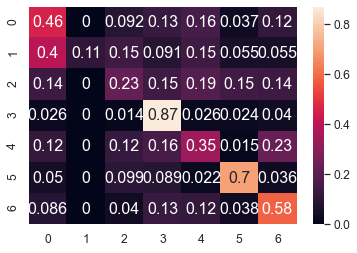

	training epoch=25 .. train_loss=1.06
	validation epoch=25 .. val_loss=1.186
	Accuracy = 55.300000000000004 % .. Percision = 58.699999999999996 % .. Recall = 47.199999999999996 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_25.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 26 .. loss = 0.69


  0%|                                                                                 | 1/1914 [00:01<32:36,  1.02s/it]

training @ epoch 26 .. loss = 1.148


  0%|                                                                                 | 2/1914 [00:02<32:33,  1.02s/it]

training @ epoch 26 .. loss = 1.121


  0%|▏                                                                                | 3/1914 [00:03<32:40,  1.03s/it]

training @ epoch 26 .. loss = 1.468


  0%|▏                                                                                | 4/1914 [00:04<32:41,  1.03s/it]

training @ epoch 26 .. loss = 1.016


  0%|▏                                                                                | 5/1914 [00:05<32:58,  1.04s/it]

training @ epoch 26 .. loss = 1.445


  0%|▎                                                                                | 6/1914 [00:06<32:57,  1.04s/it]

training @ epoch 26 .. loss = 0.995


  0%|▎                                                                                | 7/1914 [00:07<33:12,  1.05s/it]

training @ epoch 26 .. loss = 1.206


  0%|▎                                                                                | 8/1914 [00:08<33:16,  1.05s/it]

training @ epoch 26 .. loss = 0.958


  0%|▍                                                                                | 9/1914 [00:09<33:23,  1.05s/it]

training @ epoch 26 .. loss = 1.144


  1%|▍                                                                               | 10/1914 [00:10<33:10,  1.05s/it]

training @ epoch 26 .. loss = 1.128


  1%|▍                                                                               | 11/1914 [00:11<33:15,  1.05s/it]

training @ epoch 26 .. loss = 0.826


  1%|▌                                                                               | 12/1914 [00:12<33:14,  1.05s/it]

training @ epoch 26 .. loss = 0.986


  1%|▌                                                                               | 13/1914 [00:13<32:56,  1.04s/it]

training @ epoch 26 .. loss = 1.322


  1%|▌                                                                               | 14/1914 [00:14<33:13,  1.05s/it]

training @ epoch 26 .. loss = 1.156


  1%|▋                                                                               | 15/1914 [00:15<32:55,  1.04s/it]

training @ epoch 26 .. loss = 1.031


  1%|▋                                                                               | 16/1914 [00:16<33:47,  1.07s/it]

training @ epoch 26 .. loss = 0.817


  1%|▋                                                                               | 17/1914 [00:17<33:35,  1.06s/it]

training @ epoch 26 .. loss = 1.044


  1%|▊                                                                               | 18/1914 [00:18<33:22,  1.06s/it]

training @ epoch 26 .. loss = 0.805


  1%|▊                                                                               | 19/1914 [00:20<34:24,  1.09s/it]

training @ epoch 26 .. loss = 0.919


  1%|▊                                                                               | 20/1914 [00:21<34:00,  1.08s/it]

training @ epoch 26 .. loss = 0.951


  1%|▉                                                                               | 21/1914 [00:22<33:56,  1.08s/it]

training @ epoch 26 .. loss = 1.331


  1%|▉                                                                               | 22/1914 [00:23<33:22,  1.06s/it]

training @ epoch 26 .. loss = 1.051


  1%|▉                                                                               | 23/1914 [00:24<33:07,  1.05s/it]

training @ epoch 26 .. loss = 0.98


  1%|█                                                                               | 24/1914 [00:25<32:48,  1.04s/it]

training @ epoch 26 .. loss = 0.972


  1%|█                                                                               | 25/1914 [00:26<32:52,  1.04s/it]

training @ epoch 26 .. loss = 0.79


  1%|█                                                                               | 26/1914 [00:27<32:54,  1.05s/it]

training @ epoch 26 .. loss = 0.808


  1%|█▏                                                                              | 27/1914 [00:28<32:53,  1.05s/it]

training @ epoch 26 .. loss = 1.691


  1%|█▏                                                                              | 28/1914 [00:29<32:44,  1.04s/it]

training @ epoch 26 .. loss = 1.121


  2%|█▏                                                                              | 29/1914 [00:30<32:53,  1.05s/it]

training @ epoch 26 .. loss = 1.28


  2%|█▎                                                                              | 30/1914 [00:31<33:01,  1.05s/it]

training @ epoch 26 .. loss = 0.693


  2%|█▎                                                                              | 31/1914 [00:32<32:50,  1.05s/it]

training @ epoch 26 .. loss = 1.05


  2%|█▎                                                                              | 32/1914 [00:33<33:11,  1.06s/it]

training @ epoch 26 .. loss = 0.719


  2%|█▍                                                                              | 33/1914 [00:34<33:13,  1.06s/it]

training @ epoch 26 .. loss = 1.172


  2%|█▍                                                                              | 34/1914 [00:35<33:02,  1.05s/it]

training @ epoch 26 .. loss = 1.143


  2%|█▍                                                                              | 35/1914 [00:36<33:09,  1.06s/it]

training @ epoch 26 .. loss = 0.795


  2%|█▌                                                                              | 36/1914 [00:37<32:56,  1.05s/it]

training @ epoch 26 .. loss = 1.218


  2%|█▌                                                                              | 37/1914 [00:38<32:45,  1.05s/it]

training @ epoch 26 .. loss = 1.583


  2%|█▌                                                                              | 38/1914 [00:39<32:45,  1.05s/it]

training @ epoch 26 .. loss = 1.142


  2%|█▋                                                                              | 39/1914 [00:40<32:57,  1.05s/it]

training @ epoch 26 .. loss = 0.95


  2%|█▋                                                                              | 40/1914 [00:42<32:54,  1.05s/it]

training @ epoch 26 .. loss = 1.171


  2%|█▋                                                                              | 41/1914 [00:43<32:44,  1.05s/it]

training @ epoch 26 .. loss = 1.025


  2%|█▊                                                                              | 42/1914 [00:44<32:29,  1.04s/it]

training @ epoch 26 .. loss = 0.968


  2%|█▊                                                                              | 43/1914 [00:45<32:19,  1.04s/it]

training @ epoch 26 .. loss = 1.012


  2%|█▊                                                                              | 44/1914 [00:46<32:31,  1.04s/it]

training @ epoch 26 .. loss = 0.603


  2%|█▉                                                                              | 45/1914 [00:47<32:52,  1.06s/it]

training @ epoch 26 .. loss = 1.159


  2%|█▉                                                                              | 46/1914 [00:48<32:54,  1.06s/it]

training @ epoch 26 .. loss = 1.042


  2%|█▉                                                                              | 47/1914 [00:49<32:42,  1.05s/it]

training @ epoch 26 .. loss = 1.116


  3%|██                                                                              | 48/1914 [00:50<33:07,  1.06s/it]

training @ epoch 26 .. loss = 0.688


  3%|██                                                                              | 49/1914 [00:51<33:00,  1.06s/it]

training @ epoch 26 .. loss = 1.363


  3%|██                                                                              | 50/1914 [00:52<33:04,  1.06s/it]

training @ epoch 26 .. loss = 0.846


  3%|██▏                                                                             | 51/1914 [00:53<32:48,  1.06s/it]

training @ epoch 26 .. loss = 0.72


  3%|██▏                                                                             | 52/1914 [00:54<33:03,  1.07s/it]

training @ epoch 26 .. loss = 1.137


  3%|██▏                                                                             | 53/1914 [00:55<32:45,  1.06s/it]

training @ epoch 26 .. loss = 1.072


  3%|██▎                                                                             | 54/1914 [00:56<32:40,  1.05s/it]

training @ epoch 26 .. loss = 1.011


  3%|██▎                                                                             | 55/1914 [00:57<32:16,  1.04s/it]

training @ epoch 26 .. loss = 1.466


  3%|██▎                                                                             | 56/1914 [00:58<32:08,  1.04s/it]

training @ epoch 26 .. loss = 0.922


  3%|██▍                                                                             | 57/1914 [00:59<31:57,  1.03s/it]

training @ epoch 26 .. loss = 1.031


  3%|██▍                                                                             | 58/1914 [01:00<31:57,  1.03s/it]

training @ epoch 26 .. loss = 1.25


  3%|██▍                                                                             | 59/1914 [01:01<32:26,  1.05s/it]

training @ epoch 26 .. loss = 0.437


  3%|██▌                                                                             | 60/1914 [01:03<34:50,  1.13s/it]

training @ epoch 26 .. loss = 0.851


  3%|██▌                                                                             | 61/1914 [01:04<34:27,  1.12s/it]

training @ epoch 26 .. loss = 1.212


  3%|██▌                                                                             | 62/1914 [01:05<34:45,  1.13s/it]

training @ epoch 26 .. loss = 1.348


  3%|██▋                                                                             | 63/1914 [01:06<34:50,  1.13s/it]

training @ epoch 26 .. loss = 0.684


  3%|██▋                                                                             | 64/1914 [01:07<36:25,  1.18s/it]

training @ epoch 26 .. loss = 0.765


  3%|██▋                                                                             | 65/1914 [01:09<36:12,  1.18s/it]

training @ epoch 26 .. loss = 1.421


  3%|██▊                                                                             | 66/1914 [01:10<36:28,  1.18s/it]

training @ epoch 26 .. loss = 1.254


  4%|██▊                                                                             | 67/1914 [01:11<34:58,  1.14s/it]

training @ epoch 26 .. loss = 1.151


  4%|██▊                                                                             | 68/1914 [01:12<34:22,  1.12s/it]

training @ epoch 26 .. loss = 1.357


  4%|██▉                                                                             | 69/1914 [01:13<34:00,  1.11s/it]

training @ epoch 26 .. loss = 0.557


  4%|██▉                                                                             | 70/1914 [01:14<33:24,  1.09s/it]

training @ epoch 26 .. loss = 0.949


  4%|██▉                                                                             | 71/1914 [01:15<33:02,  1.08s/it]

training @ epoch 26 .. loss = 1.081


  4%|███                                                                             | 72/1914 [01:16<32:48,  1.07s/it]

training @ epoch 26 .. loss = 0.921


  4%|███                                                                             | 73/1914 [01:18<36:45,  1.20s/it]

training @ epoch 26 .. loss = 0.882


  4%|███                                                                             | 74/1914 [01:20<45:56,  1.50s/it]

training @ epoch 26 .. loss = 1.268


  4%|███▏                                                                            | 75/1914 [01:21<44:06,  1.44s/it]

training @ epoch 26 .. loss = 1.155


  4%|███▏                                                                            | 76/1914 [01:22<41:46,  1.36s/it]

training @ epoch 26 .. loss = 0.661


  4%|███▏                                                                            | 77/1914 [01:24<43:22,  1.42s/it]

training @ epoch 26 .. loss = 1.41


  4%|███▎                                                                            | 78/1914 [01:26<54:15,  1.77s/it]

training @ epoch 26 .. loss = 1.53


  4%|███▎                                                                            | 79/1914 [01:28<53:48,  1.76s/it]

training @ epoch 26 .. loss = 0.579


  4%|███▎                                                                            | 80/1914 [01:30<51:16,  1.68s/it]

training @ epoch 26 .. loss = 0.824


  4%|███▍                                                                            | 81/1914 [01:31<46:28,  1.52s/it]

training @ epoch 26 .. loss = 1.089


  4%|███▍                                                                            | 82/1914 [01:32<42:36,  1.40s/it]

training @ epoch 26 .. loss = 0.78


  4%|███▍                                                                            | 83/1914 [01:33<40:22,  1.32s/it]

training @ epoch 26 .. loss = 1.083


  4%|███▌                                                                            | 84/1914 [01:34<40:45,  1.34s/it]

training @ epoch 26 .. loss = 0.745


  4%|███▌                                                                            | 85/1914 [01:36<37:57,  1.25s/it]

training @ epoch 26 .. loss = 0.908


  4%|███▌                                                                            | 86/1914 [01:37<36:49,  1.21s/it]

training @ epoch 26 .. loss = 0.966


  5%|███▋                                                                            | 87/1914 [01:38<35:16,  1.16s/it]

training @ epoch 26 .. loss = 0.847


  5%|███▋                                                                            | 88/1914 [01:39<34:21,  1.13s/it]

training @ epoch 26 .. loss = 1.553


  5%|███▋                                                                            | 89/1914 [01:40<33:36,  1.11s/it]

training @ epoch 26 .. loss = 0.679


  5%|███▊                                                                            | 90/1914 [01:41<33:08,  1.09s/it]

training @ epoch 26 .. loss = 0.631


  5%|███▊                                                                            | 91/1914 [01:42<32:43,  1.08s/it]

training @ epoch 26 .. loss = 1.097


  5%|███▊                                                                            | 92/1914 [01:43<33:10,  1.09s/it]

training @ epoch 26 .. loss = 1.154


  5%|███▉                                                                            | 93/1914 [01:44<34:33,  1.14s/it]

training @ epoch 26 .. loss = 0.731


  5%|███▉                                                                            | 94/1914 [01:45<34:21,  1.13s/it]

training @ epoch 26 .. loss = 0.812


  5%|███▉                                                                            | 95/1914 [01:46<33:26,  1.10s/it]

training @ epoch 26 .. loss = 0.95


  5%|████                                                                            | 96/1914 [01:48<33:16,  1.10s/it]

training @ epoch 26 .. loss = 1.186


  5%|████                                                                            | 97/1914 [01:49<32:55,  1.09s/it]

training @ epoch 26 .. loss = 0.977


  5%|████                                                                            | 98/1914 [01:50<34:58,  1.16s/it]

training @ epoch 26 .. loss = 1.226


  5%|████▏                                                                           | 99/1914 [01:51<37:46,  1.25s/it]

training @ epoch 26 .. loss = 0.977


  5%|████▏                                                                          | 100/1914 [01:53<40:18,  1.33s/it]

training @ epoch 26 .. loss = 1.096


  5%|████▏                                                                          | 101/1914 [01:55<43:23,  1.44s/it]

training @ epoch 26 .. loss = 1.511


  5%|████▏                                                                          | 102/1914 [01:56<44:39,  1.48s/it]

training @ epoch 26 .. loss = 1.296


  5%|████▎                                                                          | 103/1914 [01:58<44:14,  1.47s/it]

training @ epoch 26 .. loss = 0.918


  5%|████▎                                                                          | 104/1914 [01:59<41:41,  1.38s/it]

training @ epoch 26 .. loss = 0.89


  5%|████▎                                                                          | 105/1914 [02:00<40:04,  1.33s/it]

training @ epoch 26 .. loss = 1.094


  6%|████▍                                                                          | 106/1914 [02:01<37:54,  1.26s/it]

training @ epoch 26 .. loss = 1.81


  6%|████▍                                                                          | 107/1914 [02:02<36:04,  1.20s/it]

training @ epoch 26 .. loss = 1.034


  6%|████▍                                                                          | 108/1914 [02:03<37:05,  1.23s/it]

training @ epoch 26 .. loss = 0.698


  6%|████▍                                                                          | 109/1914 [02:05<37:53,  1.26s/it]

training @ epoch 26 .. loss = 0.834


  6%|████▌                                                                          | 110/1914 [02:06<36:44,  1.22s/it]

training @ epoch 26 .. loss = 0.863


  6%|████▌                                                                          | 111/1914 [02:07<37:03,  1.23s/it]

training @ epoch 26 .. loss = 1.161


  6%|████▌                                                                          | 112/1914 [02:08<36:55,  1.23s/it]

training @ epoch 26 .. loss = 0.946


  6%|████▋                                                                          | 113/1914 [02:09<35:50,  1.19s/it]

training @ epoch 26 .. loss = 0.987


  6%|████▋                                                                          | 114/1914 [02:11<35:08,  1.17s/it]

training @ epoch 26 .. loss = 1.27


  6%|████▋                                                                          | 115/1914 [02:12<34:38,  1.16s/it]

training @ epoch 26 .. loss = 0.52


  6%|████▊                                                                          | 116/1914 [02:13<37:00,  1.24s/it]

training @ epoch 26 .. loss = 1.037


  6%|████▊                                                                          | 117/1914 [02:15<40:21,  1.35s/it]

training @ epoch 26 .. loss = 1.493


  6%|████▊                                                                          | 118/1914 [02:17<47:00,  1.57s/it]

training @ epoch 26 .. loss = 1.305


  6%|████▉                                                                          | 119/1914 [02:18<47:03,  1.57s/it]

training @ epoch 26 .. loss = 1.59


  6%|████▉                                                                          | 120/1914 [02:20<47:50,  1.60s/it]

training @ epoch 26 .. loss = 0.987


  6%|████▉                                                                          | 121/1914 [02:22<46:19,  1.55s/it]

training @ epoch 26 .. loss = 0.775


  6%|█████                                                                          | 122/1914 [02:23<41:59,  1.41s/it]

training @ epoch 26 .. loss = 1.719


  6%|█████                                                                          | 123/1914 [02:24<38:51,  1.30s/it]

training @ epoch 26 .. loss = 1.007


  6%|█████                                                                          | 124/1914 [02:25<39:05,  1.31s/it]

training @ epoch 26 .. loss = 1.158


  7%|█████▏                                                                         | 125/1914 [02:27<46:43,  1.57s/it]

training @ epoch 26 .. loss = 0.721


  7%|█████▏                                                                         | 126/1914 [02:28<43:31,  1.46s/it]

training @ epoch 26 .. loss = 0.719


  7%|█████▏                                                                         | 127/1914 [02:29<40:23,  1.36s/it]

training @ epoch 26 .. loss = 0.703


  7%|█████▎                                                                         | 128/1914 [02:31<37:45,  1.27s/it]

training @ epoch 26 .. loss = 1.135


  7%|█████▎                                                                         | 129/1914 [02:32<38:19,  1.29s/it]

training @ epoch 26 .. loss = 0.881


  7%|█████▎                                                                         | 130/1914 [02:33<39:28,  1.33s/it]

training @ epoch 26 .. loss = 1.211


  7%|█████▍                                                                         | 131/1914 [02:34<37:15,  1.25s/it]

training @ epoch 26 .. loss = 1.444


  7%|█████▍                                                                         | 132/1914 [02:35<35:56,  1.21s/it]

training @ epoch 26 .. loss = 1.749


  7%|█████▍                                                                         | 133/1914 [02:37<34:21,  1.16s/it]

training @ epoch 26 .. loss = 0.885


  7%|█████▌                                                                         | 134/1914 [02:38<33:22,  1.13s/it]

training @ epoch 26 .. loss = 0.732


  7%|█████▌                                                                         | 135/1914 [02:39<33:23,  1.13s/it]

training @ epoch 26 .. loss = 1.283


  7%|█████▌                                                                         | 136/1914 [02:40<33:15,  1.12s/it]

training @ epoch 26 .. loss = 1.214


  7%|█████▋                                                                         | 137/1914 [02:41<33:03,  1.12s/it]

training @ epoch 26 .. loss = 1.202


  7%|█████▋                                                                         | 138/1914 [02:42<32:34,  1.10s/it]

training @ epoch 26 .. loss = 1.622


  7%|█████▋                                                                         | 139/1914 [02:43<32:32,  1.10s/it]

training @ epoch 26 .. loss = 0.832


  7%|█████▊                                                                         | 140/1914 [02:44<32:16,  1.09s/it]

training @ epoch 26 .. loss = 0.658


  7%|█████▊                                                                         | 141/1914 [02:45<32:04,  1.09s/it]

training @ epoch 26 .. loss = 0.818


  7%|█████▊                                                                         | 142/1914 [02:46<32:09,  1.09s/it]

training @ epoch 26 .. loss = 0.74


  7%|█████▉                                                                         | 143/1914 [02:48<33:13,  1.13s/it]

training @ epoch 26 .. loss = 1.411


  8%|█████▉                                                                         | 144/1914 [02:50<43:39,  1.48s/it]

training @ epoch 26 .. loss = 1.025


  8%|█████▉                                                                         | 145/1914 [02:52<48:30,  1.65s/it]

training @ epoch 26 .. loss = 1.43


  8%|██████                                                                         | 146/1914 [02:54<49:30,  1.68s/it]

training @ epoch 26 .. loss = 0.929


  8%|██████                                                                         | 147/1914 [02:55<44:50,  1.52s/it]

training @ epoch 26 .. loss = 1.659


  8%|██████                                                                         | 148/1914 [02:56<40:42,  1.38s/it]

training @ epoch 26 .. loss = 0.607


  8%|██████▏                                                                        | 149/1914 [02:57<37:57,  1.29s/it]

training @ epoch 26 .. loss = 1.631


  8%|██████▏                                                                        | 150/1914 [02:58<35:32,  1.21s/it]

training @ epoch 26 .. loss = 0.862


  8%|██████▏                                                                        | 151/1914 [02:59<34:22,  1.17s/it]

training @ epoch 26 .. loss = 1.22


  8%|██████▎                                                                        | 152/1914 [03:00<33:18,  1.13s/it]

training @ epoch 26 .. loss = 1.117


  8%|██████▎                                                                        | 153/1914 [03:01<32:31,  1.11s/it]

training @ epoch 26 .. loss = 1.628


  8%|██████▎                                                                        | 154/1914 [03:02<31:40,  1.08s/it]

training @ epoch 26 .. loss = 0.97


  8%|██████▍                                                                        | 155/1914 [03:03<31:19,  1.07s/it]

training @ epoch 26 .. loss = 0.817


  8%|██████▍                                                                        | 156/1914 [03:04<31:21,  1.07s/it]

training @ epoch 26 .. loss = 0.853


  8%|██████▍                                                                        | 157/1914 [03:05<31:03,  1.06s/it]

training @ epoch 26 .. loss = 1.259


  8%|██████▌                                                                        | 158/1914 [03:06<30:46,  1.05s/it]

training @ epoch 26 .. loss = 0.684


  8%|██████▌                                                                        | 159/1914 [03:07<30:44,  1.05s/it]

training @ epoch 26 .. loss = 0.848


  8%|██████▌                                                                        | 160/1914 [03:08<30:55,  1.06s/it]

training @ epoch 26 .. loss = 0.91


  8%|██████▋                                                                        | 161/1914 [03:09<30:50,  1.06s/it]

training @ epoch 26 .. loss = 0.978


  8%|██████▋                                                                        | 162/1914 [03:11<30:45,  1.05s/it]

training @ epoch 26 .. loss = 1.618


  9%|██████▋                                                                        | 163/1914 [03:12<30:16,  1.04s/it]

training @ epoch 26 .. loss = 0.916


  9%|██████▊                                                                        | 164/1914 [03:13<30:13,  1.04s/it]

training @ epoch 26 .. loss = 1.035


  9%|██████▊                                                                        | 165/1914 [03:14<30:01,  1.03s/it]

training @ epoch 26 .. loss = 1.32


  9%|██████▊                                                                        | 166/1914 [03:15<30:05,  1.03s/it]

training @ epoch 26 .. loss = 1.404


  9%|██████▉                                                                        | 167/1914 [03:16<29:58,  1.03s/it]

training @ epoch 26 .. loss = 1.366


  9%|██████▉                                                                        | 168/1914 [03:17<29:52,  1.03s/it]

training @ epoch 26 .. loss = 1.127


  9%|██████▉                                                                        | 169/1914 [03:18<30:40,  1.05s/it]

training @ epoch 26 .. loss = 1.022


  9%|███████                                                                        | 170/1914 [03:19<30:49,  1.06s/it]

training @ epoch 26 .. loss = 0.934


  9%|███████                                                                        | 171/1914 [03:20<31:09,  1.07s/it]

training @ epoch 26 .. loss = 0.739


  9%|███████                                                                        | 172/1914 [03:21<30:54,  1.06s/it]

training @ epoch 26 .. loss = 0.936


  9%|███████▏                                                                       | 173/1914 [03:22<31:12,  1.08s/it]

training @ epoch 26 .. loss = 1.159


  9%|███████▏                                                                       | 174/1914 [03:23<30:41,  1.06s/it]

training @ epoch 26 .. loss = 1.463


  9%|███████▏                                                                       | 175/1914 [03:24<30:17,  1.04s/it]

training @ epoch 26 .. loss = 1.277


  9%|███████▎                                                                       | 176/1914 [03:25<30:28,  1.05s/it]

training @ epoch 26 .. loss = 0.559


  9%|███████▎                                                                       | 177/1914 [03:26<30:29,  1.05s/it]

training @ epoch 26 .. loss = 0.72


  9%|███████▎                                                                       | 178/1914 [03:27<31:23,  1.09s/it]

training @ epoch 26 .. loss = 1.062


  9%|███████▍                                                                       | 179/1914 [03:29<32:28,  1.12s/it]

training @ epoch 26 .. loss = 0.453


  9%|███████▍                                                                       | 180/1914 [03:30<33:06,  1.15s/it]

training @ epoch 26 .. loss = 1.376


  9%|███████▍                                                                       | 181/1914 [03:31<35:24,  1.23s/it]

training @ epoch 26 .. loss = 1.014


 10%|███████▌                                                                       | 182/1914 [03:33<36:27,  1.26s/it]

training @ epoch 26 .. loss = 0.871


 10%|███████▌                                                                       | 183/1914 [03:34<35:56,  1.25s/it]

training @ epoch 26 .. loss = 0.812


 10%|███████▌                                                                       | 184/1914 [03:35<37:09,  1.29s/it]

training @ epoch 26 .. loss = 1.196


 10%|███████▋                                                                       | 185/1914 [03:37<39:16,  1.36s/it]

training @ epoch 26 .. loss = 1.252


 10%|███████▋                                                                       | 186/1914 [03:38<38:47,  1.35s/it]

training @ epoch 26 .. loss = 0.717


 10%|███████▋                                                                       | 187/1914 [03:39<38:22,  1.33s/it]

training @ epoch 26 .. loss = 0.808


 10%|███████▊                                                                       | 188/1914 [03:41<38:03,  1.32s/it]

training @ epoch 26 .. loss = 0.941


 10%|███████▊                                                                       | 189/1914 [03:42<36:08,  1.26s/it]

training @ epoch 26 .. loss = 0.898


 10%|███████▊                                                                       | 190/1914 [03:43<36:40,  1.28s/it]

training @ epoch 26 .. loss = 0.861


 10%|███████▉                                                                       | 191/1914 [03:44<35:11,  1.23s/it]

training @ epoch 26 .. loss = 0.817


 10%|███████▉                                                                       | 192/1914 [03:45<33:25,  1.16s/it]

training @ epoch 26 .. loss = 1.401


 10%|███████▉                                                                       | 193/1914 [03:46<33:50,  1.18s/it]

training @ epoch 26 .. loss = 0.873


 10%|████████                                                                       | 194/1914 [03:48<34:27,  1.20s/it]

training @ epoch 26 .. loss = 1.08


 10%|████████                                                                       | 195/1914 [03:49<33:18,  1.16s/it]

training @ epoch 26 .. loss = 0.894


 10%|████████                                                                       | 196/1914 [03:50<32:54,  1.15s/it]

training @ epoch 26 .. loss = 1.52


 10%|████████▏                                                                      | 197/1914 [03:51<32:13,  1.13s/it]

training @ epoch 26 .. loss = 0.949


 10%|████████▏                                                                      | 198/1914 [03:52<31:16,  1.09s/it]

training @ epoch 26 .. loss = 1.164


 10%|████████▏                                                                      | 199/1914 [03:53<30:55,  1.08s/it]

training @ epoch 26 .. loss = 0.994


 10%|████████▎                                                                      | 200/1914 [03:54<32:38,  1.14s/it]

training @ epoch 26 .. loss = 1.325


 11%|████████▎                                                                      | 201/1914 [03:55<31:42,  1.11s/it]

training @ epoch 26 .. loss = 1.145


 11%|████████▎                                                                      | 202/1914 [03:56<31:04,  1.09s/it]

training @ epoch 26 .. loss = 0.896


 11%|████████▍                                                                      | 203/1914 [03:57<30:38,  1.07s/it]

training @ epoch 26 .. loss = 1.233


 11%|████████▍                                                                      | 204/1914 [03:58<30:56,  1.09s/it]

training @ epoch 26 .. loss = 1.235


 11%|████████▍                                                                      | 205/1914 [04:00<30:52,  1.08s/it]

training @ epoch 26 .. loss = 0.965


 11%|████████▌                                                                      | 206/1914 [04:01<30:45,  1.08s/it]

training @ epoch 26 .. loss = 1.167


 11%|████████▌                                                                      | 207/1914 [04:02<30:39,  1.08s/it]

training @ epoch 26 .. loss = 0.828


 11%|████████▌                                                                      | 208/1914 [04:03<30:15,  1.06s/it]

training @ epoch 26 .. loss = 0.997


 11%|████████▋                                                                      | 209/1914 [04:04<30:42,  1.08s/it]

training @ epoch 26 .. loss = 1.235


 11%|████████▋                                                                      | 210/1914 [04:05<30:36,  1.08s/it]

training @ epoch 26 .. loss = 1.047


 11%|████████▋                                                                      | 211/1914 [04:06<30:02,  1.06s/it]

training @ epoch 26 .. loss = 0.993


 11%|████████▊                                                                      | 212/1914 [04:07<30:27,  1.07s/it]

training @ epoch 26 .. loss = 0.888


 11%|████████▊                                                                      | 213/1914 [04:08<30:41,  1.08s/it]

training @ epoch 26 .. loss = 0.898


 11%|████████▊                                                                      | 214/1914 [04:09<30:50,  1.09s/it]

training @ epoch 26 .. loss = 1.338


 11%|████████▊                                                                      | 215/1914 [04:10<31:05,  1.10s/it]

training @ epoch 26 .. loss = 1.293


 11%|████████▉                                                                      | 216/1914 [04:12<31:25,  1.11s/it]

training @ epoch 26 .. loss = 0.778


 11%|████████▉                                                                      | 217/1914 [04:13<30:45,  1.09s/it]

training @ epoch 26 .. loss = 1.294


 11%|████████▉                                                                      | 218/1914 [04:14<31:09,  1.10s/it]

training @ epoch 26 .. loss = 1.034


 11%|█████████                                                                      | 219/1914 [04:15<32:24,  1.15s/it]

training @ epoch 26 .. loss = 1.009


 11%|█████████                                                                      | 220/1914 [04:16<34:22,  1.22s/it]

training @ epoch 26 .. loss = 1.13


 12%|█████████                                                                      | 221/1914 [04:18<35:01,  1.24s/it]

training @ epoch 26 .. loss = 0.896


 12%|█████████▏                                                                     | 222/1914 [04:19<34:32,  1.22s/it]

training @ epoch 26 .. loss = 1.182


 12%|█████████▏                                                                     | 223/1914 [04:20<37:14,  1.32s/it]

training @ epoch 26 .. loss = 1.216


 12%|█████████▏                                                                     | 224/1914 [04:21<35:10,  1.25s/it]

training @ epoch 26 .. loss = 1.062


 12%|█████████▎                                                                     | 225/1914 [04:23<35:37,  1.27s/it]

training @ epoch 26 .. loss = 0.98


 12%|█████████▎                                                                     | 226/1914 [04:24<35:04,  1.25s/it]

training @ epoch 26 .. loss = 0.79


 12%|█████████▎                                                                     | 227/1914 [04:25<35:52,  1.28s/it]

training @ epoch 26 .. loss = 0.88


 12%|█████████▍                                                                     | 228/1914 [04:27<37:25,  1.33s/it]

training @ epoch 26 .. loss = 0.856


 12%|█████████▍                                                                     | 229/1914 [04:28<36:11,  1.29s/it]

training @ epoch 26 .. loss = 1.081


 12%|█████████▍                                                                     | 230/1914 [04:29<37:31,  1.34s/it]

training @ epoch 26 .. loss = 1.249


 12%|█████████▌                                                                     | 231/1914 [04:31<38:28,  1.37s/it]

training @ epoch 26 .. loss = 0.898


 12%|█████████▌                                                                     | 232/1914 [04:32<39:07,  1.40s/it]

training @ epoch 26 .. loss = 0.953


 12%|█████████▌                                                                     | 233/1914 [04:33<37:12,  1.33s/it]

training @ epoch 26 .. loss = 1.352


 12%|█████████▋                                                                     | 234/1914 [04:35<35:01,  1.25s/it]

training @ epoch 26 .. loss = 0.736


 12%|█████████▋                                                                     | 235/1914 [04:36<36:10,  1.29s/it]

training @ epoch 26 .. loss = 0.901


 12%|█████████▋                                                                     | 236/1914 [04:37<36:22,  1.30s/it]

training @ epoch 26 .. loss = 1.045


 12%|█████████▊                                                                     | 237/1914 [04:38<35:20,  1.26s/it]

training @ epoch 26 .. loss = 0.847


 12%|█████████▊                                                                     | 238/1914 [04:40<37:30,  1.34s/it]

training @ epoch 26 .. loss = 0.928


 12%|█████████▊                                                                     | 239/1914 [04:41<34:54,  1.25s/it]

training @ epoch 26 .. loss = 0.726


 13%|█████████▉                                                                     | 240/1914 [04:42<35:06,  1.26s/it]

training @ epoch 26 .. loss = 0.854


 13%|█████████▉                                                                     | 241/1914 [04:43<34:45,  1.25s/it]

training @ epoch 26 .. loss = 1.024


 13%|█████████▉                                                                     | 242/1914 [04:45<33:00,  1.18s/it]

training @ epoch 26 .. loss = 1.161


 13%|██████████                                                                     | 243/1914 [04:46<34:48,  1.25s/it]

training @ epoch 26 .. loss = 0.712


 13%|██████████                                                                     | 244/1914 [04:47<34:25,  1.24s/it]

training @ epoch 26 .. loss = 0.954


 13%|██████████                                                                     | 245/1914 [04:48<32:34,  1.17s/it]

training @ epoch 26 .. loss = 0.831


 13%|██████████▏                                                                    | 246/1914 [04:49<31:24,  1.13s/it]

training @ epoch 26 .. loss = 1.282


 13%|██████████▏                                                                    | 247/1914 [04:50<31:12,  1.12s/it]

training @ epoch 26 .. loss = 0.902


 13%|██████████▏                                                                    | 248/1914 [04:52<35:26,  1.28s/it]

training @ epoch 26 .. loss = 0.825


 13%|██████████▎                                                                    | 249/1914 [04:53<36:19,  1.31s/it]

training @ epoch 26 .. loss = 0.809


 13%|██████████▎                                                                    | 250/1914 [04:55<38:13,  1.38s/it]

training @ epoch 26 .. loss = 1.044


 13%|██████████▎                                                                    | 251/1914 [04:56<38:16,  1.38s/it]

training @ epoch 26 .. loss = 0.748


 13%|██████████▍                                                                    | 252/1914 [04:58<39:34,  1.43s/it]

training @ epoch 26 .. loss = 0.968


 13%|██████████▍                                                                    | 253/1914 [04:59<39:56,  1.44s/it]

training @ epoch 26 .. loss = 1.125


 13%|██████████▍                                                                    | 254/1914 [05:01<43:19,  1.57s/it]

training @ epoch 26 .. loss = 1.405


 13%|██████████▌                                                                    | 255/1914 [05:03<45:53,  1.66s/it]

training @ epoch 26 .. loss = 1.213


 13%|██████████▌                                                                    | 256/1914 [05:04<43:55,  1.59s/it]

training @ epoch 26 .. loss = 0.821


 13%|██████████▌                                                                    | 257/1914 [05:06<45:17,  1.64s/it]

training @ epoch 26 .. loss = 1.278


 13%|██████████▋                                                                    | 258/1914 [05:08<48:47,  1.77s/it]

training @ epoch 26 .. loss = 0.716


 14%|██████████▋                                                                    | 259/1914 [05:10<47:20,  1.72s/it]

training @ epoch 26 .. loss = 1.161


 14%|██████████▋                                                                    | 260/1914 [05:12<47:44,  1.73s/it]

training @ epoch 26 .. loss = 0.861


 14%|██████████▊                                                                    | 261/1914 [05:13<44:09,  1.60s/it]

training @ epoch 26 .. loss = 1.101


 14%|██████████▊                                                                    | 262/1914 [05:15<44:32,  1.62s/it]

training @ epoch 26 .. loss = 0.959


 14%|██████████▊                                                                    | 263/1914 [05:16<42:46,  1.55s/it]

training @ epoch 26 .. loss = 1.175


 14%|██████████▉                                                                    | 264/1914 [05:17<40:55,  1.49s/it]

training @ epoch 26 .. loss = 0.745


 14%|██████████▉                                                                    | 265/1914 [05:18<38:18,  1.39s/it]

training @ epoch 26 .. loss = 1.402


 14%|██████████▉                                                                    | 266/1914 [05:20<37:24,  1.36s/it]

training @ epoch 26 .. loss = 1.286


 14%|███████████                                                                    | 267/1914 [05:21<37:39,  1.37s/it]

training @ epoch 26 .. loss = 0.798


 14%|███████████                                                                    | 268/1914 [05:22<35:09,  1.28s/it]

training @ epoch 26 .. loss = 0.836


 14%|███████████                                                                    | 269/1914 [05:23<34:35,  1.26s/it]

training @ epoch 26 .. loss = 1.326


 14%|███████████▏                                                                   | 270/1914 [05:25<33:09,  1.21s/it]

training @ epoch 26 .. loss = 1.562


 14%|███████████▏                                                                   | 271/1914 [05:26<32:08,  1.17s/it]

training @ epoch 26 .. loss = 1.219


 14%|███████████▏                                                                   | 272/1914 [05:27<32:13,  1.18s/it]

training @ epoch 26 .. loss = 0.848


 14%|███████████▎                                                                   | 273/1914 [05:28<31:53,  1.17s/it]

training @ epoch 26 .. loss = 0.735


 14%|███████████▎                                                                   | 274/1914 [05:29<31:29,  1.15s/it]

training @ epoch 26 .. loss = 0.668


 14%|███████████▎                                                                   | 275/1914 [05:30<31:01,  1.14s/it]

training @ epoch 26 .. loss = 1.075


 14%|███████████▍                                                                   | 276/1914 [05:31<30:38,  1.12s/it]

training @ epoch 26 .. loss = 0.925


 14%|███████████▍                                                                   | 277/1914 [05:33<32:16,  1.18s/it]

training @ epoch 26 .. loss = 0.988


 15%|███████████▍                                                                   | 278/1914 [05:34<35:35,  1.31s/it]

training @ epoch 26 .. loss = 0.776


 15%|███████████▌                                                                   | 279/1914 [05:36<38:37,  1.42s/it]

training @ epoch 26 .. loss = 0.989


 15%|███████████▌                                                                   | 280/1914 [05:37<38:56,  1.43s/it]

training @ epoch 26 .. loss = 0.884


 15%|███████████▌                                                                   | 281/1914 [05:39<42:10,  1.55s/it]

training @ epoch 26 .. loss = 1.683


 15%|███████████▋                                                                   | 282/1914 [05:41<41:05,  1.51s/it]

training @ epoch 26 .. loss = 1.101


 15%|███████████▋                                                                   | 283/1914 [05:42<38:00,  1.40s/it]

training @ epoch 26 .. loss = 1.083


 15%|███████████▋                                                                   | 284/1914 [05:43<36:46,  1.35s/it]

training @ epoch 26 .. loss = 0.638


 15%|███████████▊                                                                   | 285/1914 [05:44<36:41,  1.35s/it]

training @ epoch 26 .. loss = 0.931


 15%|███████████▊                                                                   | 286/1914 [05:45<35:13,  1.30s/it]

training @ epoch 26 .. loss = 0.623


 15%|███████████▊                                                                   | 287/1914 [05:47<33:44,  1.24s/it]

training @ epoch 26 .. loss = 0.762


 15%|███████████▉                                                                   | 288/1914 [05:48<33:25,  1.23s/it]

training @ epoch 26 .. loss = 0.973


 15%|███████████▉                                                                   | 289/1914 [05:49<32:20,  1.19s/it]

training @ epoch 26 .. loss = 1.494


 15%|███████████▉                                                                   | 290/1914 [05:50<32:02,  1.18s/it]

training @ epoch 26 .. loss = 1.255


 15%|████████████                                                                   | 291/1914 [05:51<30:50,  1.14s/it]

training @ epoch 26 .. loss = 1.136


 15%|████████████                                                                   | 292/1914 [05:52<29:56,  1.11s/it]

training @ epoch 26 .. loss = 0.668


 15%|████████████                                                                   | 293/1914 [05:53<29:49,  1.10s/it]

training @ epoch 26 .. loss = 0.715


 15%|████████████▏                                                                  | 294/1914 [05:54<30:16,  1.12s/it]

training @ epoch 26 .. loss = 1.093


 15%|████████████▏                                                                  | 295/1914 [05:56<31:27,  1.17s/it]

training @ epoch 26 .. loss = 1.03


 15%|████████████▏                                                                  | 296/1914 [05:57<31:32,  1.17s/it]

training @ epoch 26 .. loss = 0.887


 16%|████████████▎                                                                  | 297/1914 [05:58<30:25,  1.13s/it]

training @ epoch 26 .. loss = 0.854


 16%|████████████▎                                                                  | 298/1914 [05:59<29:33,  1.10s/it]

training @ epoch 26 .. loss = 0.935


 16%|████████████▎                                                                  | 299/1914 [06:00<30:33,  1.14s/it]

training @ epoch 26 .. loss = 1.195


 16%|████████████▍                                                                  | 300/1914 [06:01<29:45,  1.11s/it]

training @ epoch 26 .. loss = 0.743


 16%|████████████▍                                                                  | 301/1914 [06:02<30:57,  1.15s/it]

training @ epoch 26 .. loss = 1.434


 16%|████████████▍                                                                  | 302/1914 [06:03<30:21,  1.13s/it]

training @ epoch 26 .. loss = 1.312


 16%|████████████▌                                                                  | 303/1914 [06:05<29:52,  1.11s/it]

training @ epoch 26 .. loss = 1.409


 16%|████████████▌                                                                  | 304/1914 [06:06<29:05,  1.08s/it]

training @ epoch 26 .. loss = 1.608


 16%|████████████▌                                                                  | 305/1914 [06:07<28:31,  1.06s/it]

training @ epoch 26 .. loss = 0.626


 16%|████████████▋                                                                  | 306/1914 [06:08<28:18,  1.06s/it]

training @ epoch 26 .. loss = 1.213


 16%|████████████▋                                                                  | 307/1914 [06:09<28:47,  1.07s/it]

training @ epoch 26 .. loss = 0.927


 16%|████████████▋                                                                  | 308/1914 [06:10<28:53,  1.08s/it]

training @ epoch 26 .. loss = 0.877


 16%|████████████▊                                                                  | 309/1914 [06:11<29:37,  1.11s/it]

training @ epoch 26 .. loss = 0.803


 16%|████████████▊                                                                  | 310/1914 [06:12<30:58,  1.16s/it]

training @ epoch 26 .. loss = 0.69


 16%|████████████▊                                                                  | 311/1914 [06:13<31:00,  1.16s/it]

training @ epoch 26 .. loss = 2.086


 16%|████████████▉                                                                  | 312/1914 [06:15<30:39,  1.15s/it]

training @ epoch 26 .. loss = 1.222


 16%|████████████▉                                                                  | 313/1914 [06:17<38:20,  1.44s/it]

training @ epoch 26 .. loss = 1.06


 16%|████████████▉                                                                  | 314/1914 [06:19<41:37,  1.56s/it]

training @ epoch 26 .. loss = 1.084


 16%|█████████████                                                                  | 315/1914 [06:20<43:05,  1.62s/it]

training @ epoch 26 .. loss = 1.118


 17%|█████████████                                                                  | 316/1914 [06:23<48:12,  1.81s/it]

training @ epoch 26 .. loss = 0.887


 17%|█████████████                                                                  | 317/1914 [06:24<47:45,  1.79s/it]

training @ epoch 26 .. loss = 1.006


 17%|█████████████▏                                                                 | 318/1914 [06:27<52:21,  1.97s/it]

training @ epoch 26 .. loss = 1.14


 17%|█████████████▏                                                                 | 319/1914 [06:29<55:16,  2.08s/it]

training @ epoch 26 .. loss = 0.825


 17%|█████████████▏                                                                 | 320/1914 [06:31<53:08,  2.00s/it]

training @ epoch 26 .. loss = 1.065


 17%|█████████████▏                                                                 | 321/1914 [06:32<48:21,  1.82s/it]

training @ epoch 26 .. loss = 1.494


 17%|█████████████▎                                                                 | 322/1914 [06:34<48:28,  1.83s/it]

training @ epoch 26 .. loss = 0.909


 17%|█████████████▎                                                                 | 323/1914 [06:36<49:23,  1.86s/it]

training @ epoch 26 .. loss = 0.666


 17%|█████████████▎                                                                 | 324/1914 [06:38<49:13,  1.86s/it]

training @ epoch 26 .. loss = 0.957


 17%|█████████████▍                                                                 | 325/1914 [06:40<47:52,  1.81s/it]

training @ epoch 26 .. loss = 1.093


 17%|█████████████▍                                                                 | 326/1914 [06:41<43:56,  1.66s/it]

training @ epoch 26 .. loss = 0.917


 17%|█████████████▍                                                                 | 327/1914 [06:42<41:13,  1.56s/it]

training @ epoch 26 .. loss = 1.063


 17%|█████████████▌                                                                 | 328/1914 [06:43<38:40,  1.46s/it]

training @ epoch 26 .. loss = 0.886


 17%|█████████████▌                                                                 | 329/1914 [06:45<38:27,  1.46s/it]

training @ epoch 26 .. loss = 1.388


 17%|█████████████▌                                                                 | 330/1914 [06:46<36:58,  1.40s/it]

training @ epoch 26 .. loss = 0.97


 17%|█████████████▋                                                                 | 331/1914 [06:48<37:34,  1.42s/it]

training @ epoch 26 .. loss = 1.035


 17%|█████████████▋                                                                 | 332/1914 [06:49<37:21,  1.42s/it]

training @ epoch 26 .. loss = 0.832


 17%|█████████████▋                                                                 | 333/1914 [06:51<39:01,  1.48s/it]

training @ epoch 26 .. loss = 0.874


 17%|█████████████▊                                                                 | 334/1914 [06:52<41:29,  1.58s/it]

training @ epoch 26 .. loss = 1.215


 18%|█████████████▊                                                                 | 335/1914 [06:55<45:40,  1.74s/it]

training @ epoch 26 .. loss = 1.001


 18%|█████████████▊                                                                 | 336/1914 [06:56<47:13,  1.80s/it]

training @ epoch 26 .. loss = 1.314


 18%|█████████████▉                                                                 | 337/1914 [06:58<44:08,  1.68s/it]

training @ epoch 26 .. loss = 1.348


 18%|█████████████▉                                                                 | 338/1914 [06:59<40:46,  1.55s/it]

training @ epoch 26 .. loss = 0.887


 18%|█████████████▉                                                                 | 339/1914 [07:01<39:12,  1.49s/it]

training @ epoch 26 .. loss = 0.788


 18%|██████████████                                                                 | 340/1914 [07:02<37:17,  1.42s/it]

training @ epoch 26 .. loss = 1.17


 18%|██████████████                                                                 | 341/1914 [07:04<40:06,  1.53s/it]

training @ epoch 26 .. loss = 0.929


 18%|██████████████                                                                 | 342/1914 [07:05<43:19,  1.65s/it]

training @ epoch 26 .. loss = 1.375


 18%|██████████████▏                                                                | 343/1914 [07:08<50:18,  1.92s/it]

training @ epoch 26 .. loss = 1.163


 18%|██████████████▏                                                                | 344/1914 [07:10<51:51,  1.98s/it]

training @ epoch 26 .. loss = 0.963


 18%|██████████████▏                                                                | 345/1914 [07:12<47:19,  1.81s/it]

training @ epoch 26 .. loss = 0.718


 18%|██████████████▎                                                                | 346/1914 [07:13<43:27,  1.66s/it]

training @ epoch 26 .. loss = 1.221


 18%|██████████████▎                                                                | 347/1914 [07:14<40:05,  1.54s/it]

training @ epoch 26 .. loss = 0.952


 18%|██████████████▎                                                                | 348/1914 [07:16<43:00,  1.65s/it]

training @ epoch 26 .. loss = 0.75


 18%|██████████████▍                                                                | 349/1914 [07:18<47:39,  1.83s/it]

training @ epoch 26 .. loss = 1.095


 18%|██████████████▍                                                                | 350/1914 [07:20<44:58,  1.73s/it]

training @ epoch 26 .. loss = 0.843


 18%|██████████████▍                                                                | 351/1914 [07:21<44:20,  1.70s/it]

training @ epoch 26 .. loss = 1.017


 18%|██████████████▌                                                                | 352/1914 [07:23<43:46,  1.68s/it]

training @ epoch 26 .. loss = 0.747


 18%|██████████████▌                                                                | 353/1914 [07:24<40:28,  1.56s/it]

training @ epoch 26 .. loss = 0.848


 18%|██████████████▌                                                                | 354/1914 [07:26<40:22,  1.55s/it]

training @ epoch 26 .. loss = 0.649


 19%|██████████████▋                                                                | 355/1914 [07:27<38:45,  1.49s/it]

training @ epoch 26 .. loss = 1.184


 19%|██████████████▋                                                                | 356/1914 [07:29<39:42,  1.53s/it]

training @ epoch 26 .. loss = 0.787


 19%|██████████████▋                                                                | 357/1914 [07:31<43:21,  1.67s/it]

training @ epoch 26 .. loss = 1.124


 19%|██████████████▊                                                                | 358/1914 [07:33<45:53,  1.77s/it]

training @ epoch 26 .. loss = 0.94


 19%|██████████████▊                                                                | 359/1914 [07:35<49:03,  1.89s/it]

training @ epoch 26 .. loss = 1.144


 19%|██████████████▊                                                                | 360/1914 [07:37<49:41,  1.92s/it]

training @ epoch 26 .. loss = 0.764


 19%|██████████████▉                                                                | 361/1914 [07:38<46:10,  1.78s/it]

training @ epoch 26 .. loss = 0.545


 19%|██████████████▉                                                                | 362/1914 [07:40<44:47,  1.73s/it]

training @ epoch 26 .. loss = 1.305


 19%|██████████████▉                                                                | 363/1914 [07:42<48:45,  1.89s/it]

training @ epoch 26 .. loss = 0.856


 19%|███████████████                                                                | 364/1914 [07:44<48:12,  1.87s/it]

training @ epoch 26 .. loss = 0.589


 19%|███████████████                                                                | 365/1914 [07:46<50:03,  1.94s/it]

training @ epoch 26 .. loss = 1.408


 19%|███████████████                                                                | 366/1914 [07:48<46:58,  1.82s/it]

training @ epoch 26 .. loss = 1.269


 19%|███████████████▏                                                               | 367/1914 [07:49<43:27,  1.69s/it]

training @ epoch 26 .. loss = 1.262


 19%|███████████████▏                                                               | 368/1914 [07:50<40:22,  1.57s/it]

training @ epoch 26 .. loss = 1.033


 19%|███████████████▏                                                               | 369/1914 [07:52<38:58,  1.51s/it]

training @ epoch 26 .. loss = 1.741


 19%|███████████████▎                                                               | 370/1914 [07:53<37:50,  1.47s/it]

training @ epoch 26 .. loss = 1.119


 19%|███████████████▎                                                               | 371/1914 [07:55<38:41,  1.50s/it]

training @ epoch 26 .. loss = 0.804


 19%|███████████████▎                                                               | 372/1914 [07:56<39:43,  1.55s/it]

training @ epoch 26 .. loss = 0.992


 19%|███████████████▍                                                               | 373/1914 [07:58<37:55,  1.48s/it]

training @ epoch 26 .. loss = 1.043


 20%|███████████████▍                                                               | 374/1914 [07:59<37:27,  1.46s/it]

training @ epoch 26 .. loss = 0.742


 20%|███████████████▍                                                               | 375/1914 [08:01<37:03,  1.44s/it]

training @ epoch 26 .. loss = 1.02


 20%|███████████████▌                                                               | 376/1914 [08:02<36:15,  1.41s/it]

training @ epoch 26 .. loss = 1.117


 20%|███████████████▌                                                               | 377/1914 [08:03<36:05,  1.41s/it]

training @ epoch 26 .. loss = 1.285


 20%|███████████████▌                                                               | 378/1914 [08:05<35:50,  1.40s/it]

training @ epoch 26 .. loss = 0.867


 20%|███████████████▋                                                               | 379/1914 [08:06<35:53,  1.40s/it]

training @ epoch 26 .. loss = 1.12


 20%|███████████████▋                                                               | 380/1914 [08:07<35:44,  1.40s/it]

training @ epoch 26 .. loss = 0.963


 20%|███████████████▋                                                               | 381/1914 [08:09<34:36,  1.35s/it]

training @ epoch 26 .. loss = 1.07


 20%|███████████████▊                                                               | 382/1914 [08:10<34:51,  1.37s/it]

training @ epoch 26 .. loss = 0.79


 20%|███████████████▊                                                               | 383/1914 [08:11<34:24,  1.35s/it]

training @ epoch 26 .. loss = 1.631


 20%|███████████████▊                                                               | 384/1914 [08:13<33:52,  1.33s/it]

training @ epoch 26 .. loss = 1.324


 20%|███████████████▉                                                               | 385/1914 [08:14<34:15,  1.34s/it]

training @ epoch 26 .. loss = 1.018


 20%|███████████████▉                                                               | 386/1914 [08:15<34:17,  1.35s/it]

training @ epoch 26 .. loss = 0.767


 20%|███████████████▉                                                               | 387/1914 [08:17<33:30,  1.32s/it]

training @ epoch 26 .. loss = 1.066


 20%|████████████████                                                               | 388/1914 [08:18<33:21,  1.31s/it]

training @ epoch 26 .. loss = 1.315


 20%|████████████████                                                               | 389/1914 [08:19<32:51,  1.29s/it]

training @ epoch 26 .. loss = 0.648


 20%|████████████████                                                               | 390/1914 [08:21<32:35,  1.28s/it]

training @ epoch 26 .. loss = 0.938


 20%|████████████████▏                                                              | 391/1914 [08:22<32:14,  1.27s/it]

training @ epoch 26 .. loss = 0.998


 20%|████████████████▏                                                              | 392/1914 [08:23<31:59,  1.26s/it]

training @ epoch 26 .. loss = 0.565


 21%|████████████████▏                                                              | 393/1914 [08:24<32:02,  1.26s/it]

training @ epoch 26 .. loss = 0.845


 21%|████████████████▎                                                              | 394/1914 [08:25<31:46,  1.25s/it]

training @ epoch 26 .. loss = 1.55


 21%|████████████████▎                                                              | 395/1914 [08:27<31:42,  1.25s/it]

training @ epoch 26 .. loss = 0.948


 21%|████████████████▎                                                              | 396/1914 [08:28<31:53,  1.26s/it]

training @ epoch 26 .. loss = 1.162


 21%|████████████████▍                                                              | 397/1914 [08:29<32:28,  1.28s/it]

training @ epoch 26 .. loss = 1.234


 21%|████████████████▍                                                              | 398/1914 [08:31<32:43,  1.30s/it]

training @ epoch 26 .. loss = 0.892


 21%|████████████████▍                                                              | 399/1914 [08:32<32:58,  1.31s/it]

training @ epoch 26 .. loss = 1.397


 21%|████████████████▌                                                              | 400/1914 [08:33<33:12,  1.32s/it]

training @ epoch 26 .. loss = 1.462


 21%|████████████████▌                                                              | 401/1914 [08:35<32:32,  1.29s/it]

training @ epoch 26 .. loss = 0.796


 21%|████████████████▌                                                              | 402/1914 [08:36<32:12,  1.28s/it]

training @ epoch 26 .. loss = 0.925


 21%|████████████████▋                                                              | 403/1914 [08:37<32:43,  1.30s/it]

training @ epoch 26 .. loss = 1.316


 21%|████████████████▋                                                              | 404/1914 [08:38<32:10,  1.28s/it]

training @ epoch 26 .. loss = 0.871


 21%|████████████████▋                                                              | 405/1914 [08:40<34:04,  1.35s/it]

training @ epoch 26 .. loss = 0.873


 21%|████████████████▊                                                              | 406/1914 [08:41<33:21,  1.33s/it]

training @ epoch 26 .. loss = 0.736


 21%|████████████████▊                                                              | 407/1914 [08:43<33:14,  1.32s/it]

training @ epoch 26 .. loss = 0.649


 21%|████████████████▊                                                              | 408/1914 [08:44<32:35,  1.30s/it]

training @ epoch 26 .. loss = 0.812


 21%|████████████████▉                                                              | 409/1914 [08:45<32:30,  1.30s/it]

training @ epoch 26 .. loss = 0.88


 21%|████████████████▉                                                              | 410/1914 [08:46<32:21,  1.29s/it]

training @ epoch 26 .. loss = 0.943


 21%|████████████████▉                                                              | 411/1914 [08:48<31:52,  1.27s/it]

training @ epoch 26 .. loss = 1.018


 22%|█████████████████                                                              | 412/1914 [08:49<31:59,  1.28s/it]

training @ epoch 26 .. loss = 1.222


 22%|█████████████████                                                              | 413/1914 [08:50<32:48,  1.31s/it]

training @ epoch 26 .. loss = 0.692


 22%|█████████████████                                                              | 414/1914 [08:52<34:52,  1.40s/it]

training @ epoch 26 .. loss = 0.869


 22%|█████████████████▏                                                             | 415/1914 [08:53<36:54,  1.48s/it]

training @ epoch 26 .. loss = 0.932


 22%|█████████████████▏                                                             | 416/1914 [08:55<38:28,  1.54s/it]

training @ epoch 26 .. loss = 0.774


 22%|█████████████████▏                                                             | 417/1914 [08:57<38:02,  1.52s/it]

training @ epoch 26 .. loss = 0.678


 22%|█████████████████▎                                                             | 418/1914 [08:58<36:22,  1.46s/it]

training @ epoch 26 .. loss = 1.514


 22%|█████████████████▎                                                             | 419/1914 [08:59<35:45,  1.44s/it]

training @ epoch 26 .. loss = 0.854


 22%|█████████████████▎                                                             | 420/1914 [09:01<34:34,  1.39s/it]

training @ epoch 26 .. loss = 1.002


 22%|█████████████████▍                                                             | 421/1914 [09:02<34:24,  1.38s/it]

training @ epoch 26 .. loss = 1.047


 22%|█████████████████▍                                                             | 422/1914 [09:03<33:41,  1.35s/it]

training @ epoch 26 .. loss = 1.128


 22%|█████████████████▍                                                             | 423/1914 [09:05<38:06,  1.53s/it]

training @ epoch 26 .. loss = 1.474


 22%|█████████████████▌                                                             | 424/1914 [09:08<48:29,  1.95s/it]

training @ epoch 26 .. loss = 0.479


 22%|█████████████████▌                                                             | 425/1914 [09:10<44:15,  1.78s/it]

training @ epoch 26 .. loss = 1.448


 22%|█████████████████▌                                                             | 426/1914 [09:11<43:29,  1.75s/it]

training @ epoch 26 .. loss = 1.349


 22%|█████████████████▌                                                             | 427/1914 [09:13<39:54,  1.61s/it]

training @ epoch 26 .. loss = 0.926


 22%|█████████████████▋                                                             | 428/1914 [09:14<41:00,  1.66s/it]

training @ epoch 26 .. loss = 0.918


 22%|█████████████████▋                                                             | 429/1914 [09:16<45:04,  1.82s/it]

training @ epoch 26 .. loss = 0.82


 22%|█████████████████▋                                                             | 430/1914 [09:18<44:06,  1.78s/it]

training @ epoch 26 .. loss = 0.926


 23%|█████████████████▊                                                             | 431/1914 [09:20<44:43,  1.81s/it]

training @ epoch 26 .. loss = 0.948


 23%|█████████████████▊                                                             | 432/1914 [09:22<45:21,  1.84s/it]

training @ epoch 26 .. loss = 1.059


 23%|█████████████████▊                                                             | 433/1914 [09:25<51:32,  2.09s/it]

training @ epoch 26 .. loss = 0.828


 23%|█████████████████▍                                                           | 434/1914 [09:29<1:05:17,  2.65s/it]

training @ epoch 26 .. loss = 0.83


 23%|█████████████████▌                                                           | 435/1914 [09:31<1:06:39,  2.70s/it]

training @ epoch 26 .. loss = 0.757


 23%|█████████████████▌                                                           | 436/1914 [09:34<1:03:24,  2.57s/it]

training @ epoch 26 .. loss = 1.076


 23%|██████████████████                                                             | 437/1914 [09:36<59:19,  2.41s/it]

training @ epoch 26 .. loss = 0.63


 23%|██████████████████                                                             | 438/1914 [09:37<53:27,  2.17s/it]

training @ epoch 26 .. loss = 1.509


 23%|██████████████████                                                             | 439/1914 [09:39<48:58,  1.99s/it]

training @ epoch 26 .. loss = 0.697


 23%|██████████████████▏                                                            | 440/1914 [09:40<45:43,  1.86s/it]

training @ epoch 26 .. loss = 1.041


 23%|██████████████████▏                                                            | 441/1914 [09:42<42:04,  1.71s/it]

training @ epoch 26 .. loss = 1.134


 23%|██████████████████▏                                                            | 442/1914 [09:44<42:44,  1.74s/it]

training @ epoch 26 .. loss = 1.036


 23%|██████████████████▎                                                            | 443/1914 [09:45<40:32,  1.65s/it]

training @ epoch 26 .. loss = 1.242


 23%|██████████████████▎                                                            | 444/1914 [09:47<39:05,  1.60s/it]

training @ epoch 26 .. loss = 1.039


 23%|██████████████████▎                                                            | 445/1914 [09:48<38:56,  1.59s/it]

training @ epoch 26 .. loss = 0.738


 23%|██████████████████▍                                                            | 446/1914 [09:50<38:54,  1.59s/it]

training @ epoch 26 .. loss = 0.99


 23%|██████████████████▍                                                            | 447/1914 [09:51<39:17,  1.61s/it]

training @ epoch 26 .. loss = 0.996


 23%|██████████████████▍                                                            | 448/1914 [09:53<37:00,  1.51s/it]

training @ epoch 26 .. loss = 1.448


 23%|██████████████████▌                                                            | 449/1914 [09:54<35:48,  1.47s/it]

training @ epoch 26 .. loss = 1.329


 24%|██████████████████▌                                                            | 450/1914 [09:56<38:46,  1.59s/it]

training @ epoch 26 .. loss = 1.073


 24%|██████████████████▌                                                            | 451/1914 [09:57<38:43,  1.59s/it]

training @ epoch 26 .. loss = 1.046


 24%|██████████████████▋                                                            | 452/1914 [09:59<38:50,  1.59s/it]

training @ epoch 26 .. loss = 1.016


 24%|██████████████████▋                                                            | 453/1914 [10:01<40:50,  1.68s/it]

training @ epoch 26 .. loss = 1.345


 24%|██████████████████▋                                                            | 454/1914 [10:02<39:04,  1.61s/it]

training @ epoch 26 .. loss = 0.962


 24%|██████████████████▊                                                            | 455/1914 [10:04<38:17,  1.57s/it]

training @ epoch 26 .. loss = 0.802


 24%|██████████████████▊                                                            | 456/1914 [10:05<35:31,  1.46s/it]

training @ epoch 26 .. loss = 0.832


 24%|██████████████████▊                                                            | 457/1914 [10:06<34:10,  1.41s/it]

training @ epoch 26 .. loss = 1.093


 24%|██████████████████▉                                                            | 458/1914 [10:08<32:51,  1.35s/it]

training @ epoch 26 .. loss = 1.304


 24%|██████████████████▉                                                            | 459/1914 [10:09<34:04,  1.41s/it]

training @ epoch 26 .. loss = 1.209


 24%|██████████████████▉                                                            | 460/1914 [10:11<40:40,  1.68s/it]

training @ epoch 26 .. loss = 1.403


 24%|███████████████████                                                            | 461/1914 [10:13<39:12,  1.62s/it]

training @ epoch 26 .. loss = 0.993


 24%|███████████████████                                                            | 462/1914 [10:15<38:58,  1.61s/it]

training @ epoch 26 .. loss = 1.223


 24%|███████████████████                                                            | 463/1914 [10:16<40:53,  1.69s/it]

training @ epoch 26 .. loss = 0.615


 24%|███████████████████▏                                                           | 464/1914 [10:18<38:42,  1.60s/it]

training @ epoch 26 .. loss = 1.125


 24%|███████████████████▏                                                           | 465/1914 [10:19<39:01,  1.62s/it]

training @ epoch 26 .. loss = 1.176


 24%|███████████████████▏                                                           | 466/1914 [10:23<52:28,  2.17s/it]

training @ epoch 26 .. loss = 1.103


 24%|███████████████████▎                                                           | 467/1914 [10:25<54:15,  2.25s/it]

training @ epoch 26 .. loss = 0.89


 24%|███████████████████▎                                                           | 468/1914 [10:27<46:56,  1.95s/it]

training @ epoch 26 .. loss = 0.931


 25%|███████████████████▎                                                           | 469/1914 [10:29<48:58,  2.03s/it]

training @ epoch 26 .. loss = 1.094


 25%|███████████████████▍                                                           | 470/1914 [10:30<46:00,  1.91s/it]

training @ epoch 26 .. loss = 0.797


 25%|███████████████████▍                                                           | 471/1914 [10:32<42:46,  1.78s/it]

training @ epoch 26 .. loss = 1.044


 25%|███████████████████▍                                                           | 472/1914 [10:34<42:43,  1.78s/it]

training @ epoch 26 .. loss = 0.883


 25%|███████████████████▌                                                           | 473/1914 [10:35<40:37,  1.69s/it]

training @ epoch 26 .. loss = 1.172


 25%|███████████████████▌                                                           | 474/1914 [10:36<36:01,  1.50s/it]

training @ epoch 26 .. loss = 1.169


 25%|███████████████████▌                                                           | 475/1914 [10:37<33:54,  1.41s/it]

training @ epoch 26 .. loss = 1.031


 25%|███████████████████▋                                                           | 476/1914 [10:39<33:39,  1.40s/it]

training @ epoch 26 .. loss = 1.179


 25%|███████████████████▋                                                           | 477/1914 [10:40<32:30,  1.36s/it]

training @ epoch 26 .. loss = 0.759


 25%|███████████████████▋                                                           | 478/1914 [10:41<31:24,  1.31s/it]

training @ epoch 26 .. loss = 1.621


 25%|███████████████████▊                                                           | 479/1914 [10:43<31:29,  1.32s/it]

training @ epoch 26 .. loss = 0.892


 25%|███████████████████▊                                                           | 480/1914 [10:44<32:39,  1.37s/it]

training @ epoch 26 .. loss = 1.213


 25%|███████████████████▊                                                           | 481/1914 [10:46<33:17,  1.39s/it]

training @ epoch 26 .. loss = 0.663


 25%|███████████████████▉                                                           | 482/1914 [10:48<38:52,  1.63s/it]

training @ epoch 26 .. loss = 1.402


 25%|███████████████████▉                                                           | 483/1914 [10:50<40:09,  1.68s/it]

training @ epoch 26 .. loss = 1.248


 25%|███████████████████▉                                                           | 484/1914 [10:51<41:07,  1.73s/it]

training @ epoch 26 .. loss = 1.086


 25%|████████████████████                                                           | 485/1914 [10:53<39:54,  1.68s/it]

training @ epoch 26 .. loss = 1.232


 25%|████████████████████                                                           | 486/1914 [10:56<47:59,  2.02s/it]

training @ epoch 26 .. loss = 0.932


 25%|████████████████████                                                           | 487/1914 [10:57<45:28,  1.91s/it]

training @ epoch 26 .. loss = 0.914


 25%|████████████████████▏                                                          | 488/1914 [10:59<43:56,  1.85s/it]

training @ epoch 26 .. loss = 0.741


 26%|████████████████████▏                                                          | 489/1914 [11:01<44:55,  1.89s/it]

training @ epoch 26 .. loss = 0.898


 26%|████████████████████▏                                                          | 490/1914 [11:03<44:24,  1.87s/it]

training @ epoch 26 .. loss = 1.141


 26%|████████████████████▎                                                          | 491/1914 [11:05<42:22,  1.79s/it]

training @ epoch 26 .. loss = 0.787


 26%|████████████████████▎                                                          | 492/1914 [11:06<41:28,  1.75s/it]

training @ epoch 26 .. loss = 1.356


 26%|████████████████████▎                                                          | 493/1914 [11:08<39:42,  1.68s/it]

training @ epoch 26 .. loss = 0.877


 26%|████████████████████▍                                                          | 494/1914 [11:09<37:13,  1.57s/it]

training @ epoch 26 .. loss = 0.6


 26%|████████████████████▍                                                          | 495/1914 [11:11<39:41,  1.68s/it]

training @ epoch 26 .. loss = 1.08


 26%|████████████████████▍                                                          | 496/1914 [11:12<36:31,  1.55s/it]

training @ epoch 26 .. loss = 0.893


 26%|████████████████████▌                                                          | 497/1914 [11:13<34:28,  1.46s/it]

training @ epoch 26 .. loss = 1.35


 26%|████████████████████▌                                                          | 498/1914 [11:15<33:44,  1.43s/it]

training @ epoch 26 .. loss = 0.812


 26%|████████████████████▌                                                          | 499/1914 [11:16<32:28,  1.38s/it]

training @ epoch 26 .. loss = 1.204


 26%|████████████████████▋                                                          | 500/1914 [11:17<31:03,  1.32s/it]

training @ epoch 26 .. loss = 0.791


 26%|████████████████████▋                                                          | 501/1914 [11:18<30:10,  1.28s/it]

training @ epoch 26 .. loss = 1.401


 26%|████████████████████▋                                                          | 502/1914 [11:20<29:51,  1.27s/it]

training @ epoch 26 .. loss = 1.113


 26%|████████████████████▊                                                          | 503/1914 [11:21<30:33,  1.30s/it]

training @ epoch 26 .. loss = 1.522


 26%|████████████████████▊                                                          | 504/1914 [11:22<30:08,  1.28s/it]

training @ epoch 26 .. loss = 0.883


 26%|████████████████████▊                                                          | 505/1914 [11:23<29:34,  1.26s/it]

training @ epoch 26 .. loss = 1.388


 26%|████████████████████▉                                                          | 506/1914 [11:25<31:20,  1.34s/it]

training @ epoch 26 .. loss = 1.89


 26%|████████████████████▉                                                          | 507/1914 [11:26<31:36,  1.35s/it]

training @ epoch 26 .. loss = 1.231


 27%|████████████████████▉                                                          | 508/1914 [11:28<30:26,  1.30s/it]

training @ epoch 26 .. loss = 0.922


 27%|█████████████████████                                                          | 509/1914 [11:29<30:53,  1.32s/it]

training @ epoch 26 .. loss = 0.802


 27%|█████████████████████                                                          | 510/1914 [11:30<29:28,  1.26s/it]

training @ epoch 26 .. loss = 1.229


 27%|█████████████████████                                                          | 511/1914 [11:31<28:17,  1.21s/it]

training @ epoch 26 .. loss = 0.707


 27%|█████████████████████▏                                                         | 512/1914 [11:32<27:15,  1.17s/it]

training @ epoch 26 .. loss = 0.938


 27%|█████████████████████▏                                                         | 513/1914 [11:33<27:03,  1.16s/it]

training @ epoch 26 .. loss = 1.227


 27%|█████████████████████▏                                                         | 514/1914 [11:34<26:41,  1.14s/it]

training @ epoch 26 .. loss = 1.135


 27%|█████████████████████▎                                                         | 515/1914 [11:36<27:50,  1.19s/it]

training @ epoch 26 .. loss = 0.986


 27%|█████████████████████▎                                                         | 516/1914 [11:37<27:13,  1.17s/it]

training @ epoch 26 .. loss = 0.947


 27%|█████████████████████▎                                                         | 517/1914 [11:38<27:59,  1.20s/it]

training @ epoch 26 .. loss = 1.424


 27%|█████████████████████▍                                                         | 518/1914 [11:39<27:47,  1.19s/it]

training @ epoch 26 .. loss = 1.013


 27%|█████████████████████▍                                                         | 519/1914 [11:41<27:38,  1.19s/it]

training @ epoch 26 .. loss = 1.132


 27%|█████████████████████▍                                                         | 520/1914 [11:42<27:45,  1.19s/it]

training @ epoch 26 .. loss = 1.185


 27%|█████████████████████▌                                                         | 521/1914 [11:43<27:23,  1.18s/it]

training @ epoch 26 .. loss = 0.501


 27%|█████████████████████▌                                                         | 522/1914 [11:44<27:13,  1.17s/it]

training @ epoch 26 .. loss = 1.067


 27%|█████████████████████▌                                                         | 523/1914 [11:45<27:13,  1.17s/it]

training @ epoch 26 .. loss = 0.867


 27%|█████████████████████▋                                                         | 524/1914 [11:46<27:24,  1.18s/it]

training @ epoch 26 .. loss = 0.965


 27%|█████████████████████▋                                                         | 525/1914 [11:48<26:50,  1.16s/it]

training @ epoch 26 .. loss = 1.116


 27%|█████████████████████▋                                                         | 526/1914 [11:49<26:26,  1.14s/it]

training @ epoch 26 .. loss = 0.935


 28%|█████████████████████▊                                                         | 527/1914 [11:50<26:30,  1.15s/it]

training @ epoch 26 .. loss = 1.121


 28%|█████████████████████▊                                                         | 528/1914 [11:51<26:59,  1.17s/it]

training @ epoch 26 .. loss = 0.853


 28%|█████████████████████▊                                                         | 529/1914 [11:52<26:34,  1.15s/it]

training @ epoch 26 .. loss = 1.151


 28%|█████████████████████▉                                                         | 530/1914 [11:53<25:57,  1.13s/it]

training @ epoch 26 .. loss = 1.317


 28%|█████████████████████▉                                                         | 531/1914 [11:54<26:29,  1.15s/it]

training @ epoch 26 .. loss = 0.986


 28%|█████████████████████▉                                                         | 532/1914 [11:55<25:59,  1.13s/it]

training @ epoch 26 .. loss = 1.185


 28%|█████████████████████▉                                                         | 533/1914 [11:57<26:03,  1.13s/it]

training @ epoch 26 .. loss = 1.309


 28%|██████████████████████                                                         | 534/1914 [11:58<25:55,  1.13s/it]

training @ epoch 26 .. loss = 0.91


 28%|██████████████████████                                                         | 535/1914 [11:59<25:32,  1.11s/it]

training @ epoch 26 .. loss = 1.666


 28%|██████████████████████                                                         | 536/1914 [12:00<26:36,  1.16s/it]

training @ epoch 26 .. loss = 0.862


 28%|██████████████████████▏                                                        | 537/1914 [12:02<31:00,  1.35s/it]

training @ epoch 26 .. loss = 0.79


 28%|██████████████████████▏                                                        | 538/1914 [12:03<32:00,  1.40s/it]

training @ epoch 26 .. loss = 1.321


 28%|██████████████████████▏                                                        | 539/1914 [12:05<32:17,  1.41s/it]

training @ epoch 26 .. loss = 1.406


 28%|██████████████████████▎                                                        | 540/1914 [12:06<31:30,  1.38s/it]

training @ epoch 26 .. loss = 1.226


 28%|██████████████████████▎                                                        | 541/1914 [12:07<30:21,  1.33s/it]

training @ epoch 26 .. loss = 0.893


 28%|██████████████████████▎                                                        | 542/1914 [12:08<29:19,  1.28s/it]

training @ epoch 26 .. loss = 1.138


 28%|██████████████████████▍                                                        | 543/1914 [12:10<28:23,  1.24s/it]

training @ epoch 26 .. loss = 1.553


 28%|██████████████████████▍                                                        | 544/1914 [12:11<28:37,  1.25s/it]

training @ epoch 26 .. loss = 1.242


 28%|██████████████████████▍                                                        | 545/1914 [12:14<38:14,  1.68s/it]

training @ epoch 26 .. loss = 1.112


 29%|██████████████████████▌                                                        | 546/1914 [12:15<38:51,  1.70s/it]

training @ epoch 26 .. loss = 1.086


 29%|██████████████████████▌                                                        | 547/1914 [12:17<36:05,  1.58s/it]

training @ epoch 26 .. loss = 0.841


 29%|██████████████████████▌                                                        | 548/1914 [12:18<34:15,  1.50s/it]

training @ epoch 26 .. loss = 0.966


 29%|██████████████████████▋                                                        | 549/1914 [12:20<37:02,  1.63s/it]

training @ epoch 26 .. loss = 0.905


 29%|██████████████████████▋                                                        | 550/1914 [12:22<41:46,  1.84s/it]

training @ epoch 26 .. loss = 1.099


 29%|██████████████████████▋                                                        | 551/1914 [12:24<40:37,  1.79s/it]

training @ epoch 26 .. loss = 0.91


 29%|██████████████████████▊                                                        | 552/1914 [12:25<38:28,  1.69s/it]

training @ epoch 26 .. loss = 0.785


 29%|██████████████████████▊                                                        | 553/1914 [12:27<35:50,  1.58s/it]

training @ epoch 26 .. loss = 1.037


 29%|██████████████████████▊                                                        | 554/1914 [12:28<34:39,  1.53s/it]

training @ epoch 26 .. loss = 1.03


 29%|██████████████████████▉                                                        | 555/1914 [12:30<38:59,  1.72s/it]

training @ epoch 26 .. loss = 1.808


 29%|██████████████████████▉                                                        | 556/1914 [12:33<45:32,  2.01s/it]

training @ epoch 26 .. loss = 0.854


 29%|██████████████████████▉                                                        | 557/1914 [12:35<42:35,  1.88s/it]

training @ epoch 26 .. loss = 0.739


 29%|███████████████████████                                                        | 558/1914 [12:36<38:18,  1.70s/it]

training @ epoch 26 .. loss = 0.775


 29%|███████████████████████                                                        | 559/1914 [12:38<42:17,  1.87s/it]

training @ epoch 26 .. loss = 0.913


 29%|███████████████████████                                                        | 560/1914 [12:40<40:50,  1.81s/it]

training @ epoch 26 .. loss = 1.212


 29%|███████████████████████▏                                                       | 561/1914 [12:41<36:49,  1.63s/it]

training @ epoch 26 .. loss = 0.903


 29%|███████████████████████▏                                                       | 562/1914 [12:42<33:53,  1.50s/it]

training @ epoch 26 .. loss = 1.405


 29%|███████████████████████▏                                                       | 563/1914 [12:43<31:29,  1.40s/it]

training @ epoch 26 .. loss = 1.113


 29%|███████████████████████▎                                                       | 564/1914 [12:45<30:53,  1.37s/it]

training @ epoch 26 .. loss = 1.215


 30%|███████████████████████▎                                                       | 565/1914 [12:46<29:40,  1.32s/it]

training @ epoch 26 .. loss = 0.901


 30%|███████████████████████▎                                                       | 566/1914 [12:47<28:20,  1.26s/it]

training @ epoch 26 .. loss = 1.177


 30%|███████████████████████▍                                                       | 567/1914 [12:48<27:40,  1.23s/it]

training @ epoch 26 .. loss = 1.165


 30%|███████████████████████▍                                                       | 568/1914 [12:49<26:59,  1.20s/it]

training @ epoch 26 .. loss = 1.365


 30%|███████████████████████▍                                                       | 569/1914 [12:51<28:25,  1.27s/it]

training @ epoch 26 .. loss = 1.033


 30%|███████████████████████▌                                                       | 570/1914 [12:52<29:13,  1.30s/it]

training @ epoch 26 .. loss = 1.523


 30%|███████████████████████▌                                                       | 571/1914 [12:53<29:02,  1.30s/it]

training @ epoch 26 .. loss = 1.282


 30%|███████████████████████▌                                                       | 572/1914 [12:55<29:32,  1.32s/it]

training @ epoch 26 .. loss = 1.265


 30%|███████████████████████▋                                                       | 573/1914 [12:56<31:25,  1.41s/it]

training @ epoch 26 .. loss = 0.954


 30%|███████████████████████▋                                                       | 574/1914 [12:58<30:39,  1.37s/it]

training @ epoch 26 .. loss = 1.153


 30%|███████████████████████▋                                                       | 575/1914 [13:00<34:32,  1.55s/it]

training @ epoch 26 .. loss = 1.413


 30%|███████████████████████▊                                                       | 576/1914 [13:02<40:58,  1.84s/it]

training @ epoch 26 .. loss = 0.898


 30%|███████████████████████▊                                                       | 577/1914 [13:04<41:35,  1.87s/it]

training @ epoch 26 .. loss = 0.724


 30%|███████████████████████▊                                                       | 578/1914 [13:06<45:39,  2.05s/it]

training @ epoch 26 .. loss = 1.016


 30%|███████████████████████▉                                                       | 579/1914 [13:09<47:26,  2.13s/it]

training @ epoch 26 .. loss = 0.853


 30%|███████████████████████▉                                                       | 580/1914 [13:11<46:52,  2.11s/it]

training @ epoch 26 .. loss = 1.146


 30%|███████████████████████▉                                                       | 581/1914 [13:13<48:44,  2.19s/it]

training @ epoch 26 .. loss = 0.975


 30%|████████████████████████                                                       | 582/1914 [13:15<46:03,  2.07s/it]

training @ epoch 26 .. loss = 1.218


 30%|████████████████████████                                                       | 583/1914 [13:17<42:00,  1.89s/it]

training @ epoch 26 .. loss = 0.731


 31%|████████████████████████                                                       | 584/1914 [13:18<40:57,  1.85s/it]

training @ epoch 26 .. loss = 0.79


 31%|████████████████████████▏                                                      | 585/1914 [13:20<37:33,  1.70s/it]

training @ epoch 26 .. loss = 1.169


 31%|████████████████████████▏                                                      | 586/1914 [13:21<34:59,  1.58s/it]

training @ epoch 26 .. loss = 1.148


 31%|████████████████████████▏                                                      | 587/1914 [13:22<34:01,  1.54s/it]

training @ epoch 26 .. loss = 0.733


 31%|████████████████████████▎                                                      | 588/1914 [13:24<32:29,  1.47s/it]

training @ epoch 26 .. loss = 1.048


 31%|████████████████████████▎                                                      | 589/1914 [13:25<32:59,  1.49s/it]

training @ epoch 26 .. loss = 0.833


 31%|████████████████████████▎                                                      | 590/1914 [13:26<31:05,  1.41s/it]

training @ epoch 26 .. loss = 1.169


 31%|████████████████████████▍                                                      | 591/1914 [13:28<30:04,  1.36s/it]

training @ epoch 26 .. loss = 1.076


 31%|████████████████████████▍                                                      | 592/1914 [13:29<28:34,  1.30s/it]

training @ epoch 26 .. loss = 2.03


 31%|████████████████████████▍                                                      | 593/1914 [13:31<32:54,  1.49s/it]

training @ epoch 26 .. loss = 0.881


 31%|████████████████████████▌                                                      | 594/1914 [13:35<50:28,  2.29s/it]

training @ epoch 26 .. loss = 1.023


 31%|████████████████████████▌                                                      | 595/1914 [13:38<58:42,  2.67s/it]

training @ epoch 26 .. loss = 1.125


 31%|███████████████████████▉                                                     | 596/1914 [13:42<1:04:58,  2.96s/it]

training @ epoch 26 .. loss = 1.084


 31%|████████████████████████                                                     | 597/1914 [13:46<1:10:32,  3.21s/it]

training @ epoch 26 .. loss = 1.137


 31%|████████████████████████                                                     | 598/1914 [13:48<1:05:23,  2.98s/it]

training @ epoch 26 .. loss = 0.982


 31%|████████████████████████                                                     | 599/1914 [13:51<1:02:23,  2.85s/it]

training @ epoch 26 .. loss = 1.079


 31%|████████████████████████▊                                                      | 600/1914 [13:53<56:48,  2.59s/it]

training @ epoch 26 .. loss = 0.893


 31%|████████████████████████▊                                                      | 601/1914 [13:55<53:05,  2.43s/it]

training @ epoch 26 .. loss = 1.072


 31%|████████████████████████▊                                                      | 602/1914 [13:57<47:24,  2.17s/it]

training @ epoch 26 .. loss = 0.824


 32%|████████████████████████▉                                                      | 603/1914 [13:58<43:46,  2.00s/it]

training @ epoch 26 .. loss = 0.984


 32%|████████████████████████▉                                                      | 604/1914 [14:00<41:26,  1.90s/it]

training @ epoch 26 .. loss = 0.975


 32%|████████████████████████▉                                                      | 605/1914 [14:01<39:58,  1.83s/it]

training @ epoch 26 .. loss = 0.985


 32%|█████████████████████████                                                      | 606/1914 [14:03<37:42,  1.73s/it]

training @ epoch 26 .. loss = 1.159


 32%|█████████████████████████                                                      | 607/1914 [14:04<35:50,  1.65s/it]

training @ epoch 26 .. loss = 0.706


 32%|█████████████████████████                                                      | 608/1914 [14:06<33:49,  1.55s/it]

training @ epoch 26 .. loss = 1.065


 32%|█████████████████████████▏                                                     | 609/1914 [14:07<32:51,  1.51s/it]

training @ epoch 26 .. loss = 1.163


 32%|█████████████████████████▏                                                     | 610/1914 [14:08<31:41,  1.46s/it]

training @ epoch 26 .. loss = 0.938


 32%|█████████████████████████▏                                                     | 611/1914 [14:10<31:38,  1.46s/it]

training @ epoch 26 .. loss = 1.089


 32%|█████████████████████████▎                                                     | 612/1914 [14:11<31:59,  1.47s/it]

training @ epoch 26 .. loss = 0.957


 32%|█████████████████████████▎                                                     | 613/1914 [14:13<34:09,  1.58s/it]

training @ epoch 26 .. loss = 0.699


 32%|█████████████████████████▎                                                     | 614/1914 [14:15<34:17,  1.58s/it]

training @ epoch 26 .. loss = 1.242


 32%|█████████████████████████▍                                                     | 615/1914 [14:17<36:20,  1.68s/it]

training @ epoch 26 .. loss = 1.001


 32%|█████████████████████████▍                                                     | 616/1914 [14:19<38:36,  1.78s/it]

training @ epoch 26 .. loss = 0.892


 32%|█████████████████████████▍                                                     | 617/1914 [14:21<39:46,  1.84s/it]

training @ epoch 26 .. loss = 0.427


 32%|█████████████████████████▌                                                     | 618/1914 [14:23<42:51,  1.98s/it]

training @ epoch 26 .. loss = 1.215


 32%|█████████████████████████▌                                                     | 619/1914 [14:25<44:38,  2.07s/it]

training @ epoch 26 .. loss = 0.997


 32%|█████████████████████████▌                                                     | 620/1914 [14:27<44:05,  2.04s/it]

training @ epoch 26 .. loss = 1.419


 32%|█████████████████████████▋                                                     | 621/1914 [14:29<42:13,  1.96s/it]

training @ epoch 26 .. loss = 1.04


 32%|█████████████████████████▋                                                     | 622/1914 [14:31<38:53,  1.81s/it]

training @ epoch 26 .. loss = 0.803


 33%|█████████████████████████▋                                                     | 623/1914 [14:32<36:57,  1.72s/it]

training @ epoch 26 .. loss = 0.697


 33%|█████████████████████████▊                                                     | 624/1914 [14:34<35:20,  1.64s/it]

training @ epoch 26 .. loss = 1.126


 33%|█████████████████████████▊                                                     | 625/1914 [14:35<34:53,  1.62s/it]

training @ epoch 26 .. loss = 1.589


 33%|█████████████████████████▊                                                     | 626/1914 [14:36<33:12,  1.55s/it]

training @ epoch 26 .. loss = 0.879


 33%|█████████████████████████▉                                                     | 627/1914 [14:38<32:02,  1.49s/it]

training @ epoch 26 .. loss = 0.923


 33%|█████████████████████████▉                                                     | 628/1914 [14:40<35:08,  1.64s/it]

training @ epoch 26 .. loss = 1.177


 33%|█████████████████████████▉                                                     | 629/1914 [14:44<49:54,  2.33s/it]

training @ epoch 26 .. loss = 0.779


 33%|██████████████████████████                                                     | 630/1914 [14:45<45:21,  2.12s/it]

training @ epoch 26 .. loss = 0.548


 33%|██████████████████████████                                                     | 631/1914 [14:47<39:55,  1.87s/it]

training @ epoch 26 .. loss = 1.3


 33%|██████████████████████████                                                     | 632/1914 [14:48<36:24,  1.70s/it]

training @ epoch 26 .. loss = 1.122


 33%|██████████████████████████▏                                                    | 633/1914 [14:50<35:42,  1.67s/it]

training @ epoch 26 .. loss = 0.792


 33%|██████████████████████████▏                                                    | 634/1914 [14:51<33:52,  1.59s/it]

training @ epoch 26 .. loss = 1.206


 33%|██████████████████████████▏                                                    | 635/1914 [14:53<33:28,  1.57s/it]

training @ epoch 26 .. loss = 0.951


 33%|██████████████████████████▎                                                    | 636/1914 [14:54<34:46,  1.63s/it]

training @ epoch 26 .. loss = 0.829


 33%|██████████████████████████▎                                                    | 637/1914 [14:56<34:18,  1.61s/it]

training @ epoch 26 .. loss = 1.375


 33%|██████████████████████████▎                                                    | 638/1914 [14:59<41:35,  1.96s/it]

training @ epoch 26 .. loss = 0.842


 33%|██████████████████████████▎                                                    | 639/1914 [15:01<45:32,  2.14s/it]

training @ epoch 26 .. loss = 0.904


 33%|██████████████████████████▍                                                    | 640/1914 [15:03<44:34,  2.10s/it]

training @ epoch 26 .. loss = 0.992


 33%|██████████████████████████▍                                                    | 641/1914 [15:05<44:02,  2.08s/it]

training @ epoch 26 .. loss = 0.751


 34%|██████████████████████████▍                                                    | 642/1914 [15:07<41:49,  1.97s/it]

training @ epoch 26 .. loss = 1.077


 34%|██████████████████████████▌                                                    | 643/1914 [15:09<40:04,  1.89s/it]

training @ epoch 26 .. loss = 0.794


 34%|██████████████████████████▌                                                    | 644/1914 [15:11<39:50,  1.88s/it]

training @ epoch 26 .. loss = 1.341


 34%|██████████████████████████▌                                                    | 645/1914 [15:12<39:17,  1.86s/it]

training @ epoch 26 .. loss = 0.68


 34%|██████████████████████████▋                                                    | 646/1914 [15:14<40:26,  1.91s/it]

training @ epoch 26 .. loss = 1.129


 34%|██████████████████████████▋                                                    | 647/1914 [15:16<40:47,  1.93s/it]

training @ epoch 26 .. loss = 0.731


 34%|██████████████████████████▋                                                    | 648/1914 [15:18<40:21,  1.91s/it]

training @ epoch 26 .. loss = 1.173


 34%|██████████████████████████▊                                                    | 649/1914 [15:20<38:16,  1.82s/it]

training @ epoch 26 .. loss = 1.128


 34%|██████████████████████████▊                                                    | 650/1914 [15:21<36:37,  1.74s/it]

training @ epoch 26 .. loss = 0.871


 34%|██████████████████████████▊                                                    | 651/1914 [15:23<35:58,  1.71s/it]

training @ epoch 26 .. loss = 1.151


 34%|██████████████████████████▉                                                    | 652/1914 [15:25<34:50,  1.66s/it]

training @ epoch 26 .. loss = 1.084


 34%|██████████████████████████▉                                                    | 653/1914 [15:26<32:56,  1.57s/it]

training @ epoch 26 .. loss = 1.111


 34%|██████████████████████████▉                                                    | 654/1914 [15:27<31:58,  1.52s/it]

training @ epoch 26 .. loss = 0.863


 34%|███████████████████████████                                                    | 655/1914 [15:29<31:17,  1.49s/it]

training @ epoch 26 .. loss = 1.214


 34%|███████████████████████████                                                    | 656/1914 [15:30<31:13,  1.49s/it]

training @ epoch 26 .. loss = 1.122


 34%|███████████████████████████                                                    | 657/1914 [15:32<32:03,  1.53s/it]

training @ epoch 26 .. loss = 1.0


 34%|███████████████████████████▏                                                   | 658/1914 [15:34<34:29,  1.65s/it]

training @ epoch 26 .. loss = 1.19


 34%|███████████████████████████▏                                                   | 659/1914 [15:35<35:09,  1.68s/it]

training @ epoch 26 .. loss = 1.835


 34%|███████████████████████████▏                                                   | 660/1914 [15:38<39:40,  1.90s/it]

training @ epoch 26 .. loss = 0.983


 35%|███████████████████████████▎                                                   | 661/1914 [15:40<40:29,  1.94s/it]

training @ epoch 26 .. loss = 0.871


 35%|███████████████████████████▎                                                   | 662/1914 [15:42<38:50,  1.86s/it]

training @ epoch 26 .. loss = 0.977


 35%|███████████████████████████▎                                                   | 663/1914 [15:45<48:00,  2.30s/it]

training @ epoch 26 .. loss = 0.941


 35%|███████████████████████████▍                                                   | 664/1914 [15:47<43:24,  2.08s/it]

training @ epoch 26 .. loss = 0.898


 35%|███████████████████████████▍                                                   | 665/1914 [15:48<42:28,  2.04s/it]

training @ epoch 26 .. loss = 1.266


 35%|███████████████████████████▍                                                   | 666/1914 [15:51<44:33,  2.14s/it]

training @ epoch 26 .. loss = 0.769


 35%|███████████████████████████▌                                                   | 667/1914 [15:53<41:32,  2.00s/it]

training @ epoch 26 .. loss = 1.059


 35%|███████████████████████████▌                                                   | 668/1914 [15:55<47:00,  2.26s/it]

training @ epoch 26 .. loss = 1.078


 35%|███████████████████████████▌                                                   | 669/1914 [15:57<46:00,  2.22s/it]

training @ epoch 26 .. loss = 0.692


 35%|███████████████████████████▋                                                   | 670/1914 [16:01<51:05,  2.46s/it]

training @ epoch 26 .. loss = 0.755


 35%|███████████████████████████▋                                                   | 671/1914 [16:03<52:14,  2.52s/it]

training @ epoch 26 .. loss = 0.762


 35%|███████████████████████████▋                                                   | 672/1914 [16:06<52:03,  2.52s/it]

training @ epoch 26 .. loss = 1.125


 35%|███████████████████████████▊                                                   | 673/1914 [16:07<46:00,  2.22s/it]

training @ epoch 26 .. loss = 1.219


 35%|███████████████████████████▊                                                   | 674/1914 [16:09<43:03,  2.08s/it]

training @ epoch 26 .. loss = 0.772


 35%|███████████████████████████▊                                                   | 675/1914 [16:11<42:43,  2.07s/it]

training @ epoch 26 .. loss = 0.456


 35%|███████████████████████████▉                                                   | 676/1914 [16:13<39:44,  1.93s/it]

training @ epoch 26 .. loss = 1.117


 35%|███████████████████████████▉                                                   | 677/1914 [16:14<38:13,  1.85s/it]

training @ epoch 26 .. loss = 1.696


 35%|███████████████████████████▉                                                   | 678/1914 [16:16<36:11,  1.76s/it]

training @ epoch 26 .. loss = 1.462


 35%|████████████████████████████                                                   | 679/1914 [16:17<34:34,  1.68s/it]

training @ epoch 26 .. loss = 1.434


 36%|████████████████████████████                                                   | 680/1914 [16:19<32:47,  1.59s/it]

training @ epoch 26 .. loss = 0.817


 36%|████████████████████████████                                                   | 681/1914 [16:20<31:05,  1.51s/it]

training @ epoch 26 .. loss = 1.36


 36%|████████████████████████████▏                                                  | 682/1914 [16:21<30:30,  1.49s/it]

training @ epoch 26 .. loss = 0.901


 36%|████████████████████████████▏                                                  | 683/1914 [16:23<29:11,  1.42s/it]

training @ epoch 26 .. loss = 1.438


 36%|████████████████████████████▏                                                  | 684/1914 [16:24<28:21,  1.38s/it]

training @ epoch 26 .. loss = 0.904


 36%|████████████████████████████▎                                                  | 685/1914 [16:25<28:06,  1.37s/it]

training @ epoch 26 .. loss = 1.206


 36%|████████████████████████████▎                                                  | 686/1914 [16:27<27:50,  1.36s/it]

training @ epoch 26 .. loss = 1.04


 36%|████████████████████████████▎                                                  | 687/1914 [16:28<27:37,  1.35s/it]

training @ epoch 26 .. loss = 1.028


 36%|████████████████████████████▍                                                  | 688/1914 [16:29<27:30,  1.35s/it]

training @ epoch 26 .. loss = 0.807


 36%|████████████████████████████▍                                                  | 689/1914 [16:31<27:37,  1.35s/it]

training @ epoch 26 .. loss = 1.215


 36%|████████████████████████████▍                                                  | 690/1914 [16:33<33:55,  1.66s/it]

training @ epoch 26 .. loss = 0.707


 36%|████████████████████████████▌                                                  | 691/1914 [16:35<36:07,  1.77s/it]

training @ epoch 26 .. loss = 0.904


 36%|████████████████████████████▌                                                  | 692/1914 [16:37<34:39,  1.70s/it]

training @ epoch 26 .. loss = 1.114


 36%|████████████████████████████▌                                                  | 693/1914 [16:38<34:02,  1.67s/it]

training @ epoch 26 .. loss = 0.82


 36%|████████████████████████████▋                                                  | 694/1914 [16:40<37:07,  1.83s/it]

training @ epoch 26 .. loss = 1.236


 36%|████████████████████████████▋                                                  | 695/1914 [16:44<48:38,  2.39s/it]

training @ epoch 26 .. loss = 1.476


 36%|████████████████████████████                                                 | 696/1914 [16:49<1:00:10,  2.96s/it]

training @ epoch 26 .. loss = 1.125


 36%|████████████████████████████                                                 | 697/1914 [16:52<1:03:15,  3.12s/it]

training @ epoch 26 .. loss = 0.887


 36%|████████████████████████████▊                                                  | 698/1914 [16:54<59:09,  2.92s/it]

training @ epoch 26 .. loss = 0.808


 37%|████████████████████████████▊                                                  | 699/1914 [16:57<56:45,  2.80s/it]

training @ epoch 26 .. loss = 0.925


 37%|████████████████████████████▉                                                  | 700/1914 [16:59<53:59,  2.67s/it]

training @ epoch 26 .. loss = 1.095


 37%|████████████████████████████▉                                                  | 701/1914 [17:02<51:53,  2.57s/it]

training @ epoch 26 .. loss = 1.061


 37%|████████████████████████████▉                                                  | 702/1914 [17:04<50:56,  2.52s/it]

training @ epoch 26 .. loss = 0.749


 37%|█████████████████████████████                                                  | 703/1914 [17:06<49:54,  2.47s/it]

training @ epoch 26 .. loss = 0.743


 37%|█████████████████████████████                                                  | 704/1914 [17:08<45:29,  2.26s/it]

training @ epoch 26 .. loss = 1.178


 37%|█████████████████████████████                                                  | 705/1914 [17:10<42:42,  2.12s/it]

training @ epoch 26 .. loss = 0.814


 37%|█████████████████████████████▏                                                 | 706/1914 [17:12<42:55,  2.13s/it]

training @ epoch 26 .. loss = 0.993


 37%|█████████████████████████████▏                                                 | 707/1914 [17:14<40:42,  2.02s/it]

training @ epoch 26 .. loss = 1.167


 37%|█████████████████████████████▏                                                 | 708/1914 [17:16<39:16,  1.95s/it]

training @ epoch 26 .. loss = 1.469


 37%|█████████████████████████████▎                                                 | 709/1914 [17:17<38:08,  1.90s/it]

training @ epoch 26 .. loss = 1.452


 37%|█████████████████████████████▎                                                 | 710/1914 [17:19<37:10,  1.85s/it]

training @ epoch 26 .. loss = 1.326


 37%|█████████████████████████████▎                                                 | 711/1914 [17:21<38:09,  1.90s/it]

training @ epoch 26 .. loss = 0.857


 37%|█████████████████████████████▍                                                 | 712/1914 [17:24<41:28,  2.07s/it]

training @ epoch 26 .. loss = 0.941


 37%|█████████████████████████████▍                                                 | 713/1914 [17:26<40:20,  2.02s/it]

training @ epoch 26 .. loss = 0.645


 37%|█████████████████████████████▍                                                 | 714/1914 [17:28<41:16,  2.06s/it]

training @ epoch 26 .. loss = 1.11


 37%|█████████████████████████████▌                                                 | 715/1914 [17:29<38:32,  1.93s/it]

training @ epoch 26 .. loss = 1.287


 37%|█████████████████████████████▌                                                 | 716/1914 [17:31<36:29,  1.83s/it]

training @ epoch 26 .. loss = 0.7


 37%|█████████████████████████████▌                                                 | 717/1914 [17:33<36:18,  1.82s/it]

training @ epoch 26 .. loss = 1.122


 38%|█████████████████████████████▋                                                 | 718/1914 [17:34<35:18,  1.77s/it]

training @ epoch 26 .. loss = 1.14


 38%|█████████████████████████████▋                                                 | 719/1914 [17:37<41:46,  2.10s/it]

training @ epoch 26 .. loss = 0.949


 38%|█████████████████████████████▋                                                 | 720/1914 [17:39<40:46,  2.05s/it]

training @ epoch 26 .. loss = 1.428


 38%|█████████████████████████████▊                                                 | 721/1914 [17:41<38:46,  1.95s/it]

training @ epoch 26 .. loss = 0.934


 38%|█████████████████████████████▊                                                 | 722/1914 [17:43<36:28,  1.84s/it]

training @ epoch 26 .. loss = 1.302


 38%|█████████████████████████████▊                                                 | 723/1914 [17:44<34:49,  1.75s/it]

training @ epoch 26 .. loss = 0.904


 38%|█████████████████████████████▉                                                 | 724/1914 [17:46<33:10,  1.67s/it]

training @ epoch 26 .. loss = 1.045


 38%|█████████████████████████████▉                                                 | 725/1914 [17:47<31:57,  1.61s/it]

training @ epoch 26 .. loss = 0.959


 38%|█████████████████████████████▉                                                 | 726/1914 [17:49<33:27,  1.69s/it]

training @ epoch 26 .. loss = 1.041


 38%|██████████████████████████████                                                 | 727/1914 [17:51<38:02,  1.92s/it]

training @ epoch 26 .. loss = 1.115


 38%|██████████████████████████████                                                 | 728/1914 [17:54<40:01,  2.03s/it]

training @ epoch 26 .. loss = 1.088


 38%|██████████████████████████████                                                 | 729/1914 [17:56<39:22,  1.99s/it]

training @ epoch 26 .. loss = 0.594


 38%|██████████████████████████████▏                                                | 730/1914 [17:57<36:23,  1.84s/it]

training @ epoch 26 .. loss = 0.68


 38%|██████████████████████████████▏                                                | 731/1914 [17:59<34:54,  1.77s/it]

training @ epoch 26 .. loss = 1.313


 38%|██████████████████████████████▏                                                | 732/1914 [18:01<35:56,  1.82s/it]

training @ epoch 26 .. loss = 0.764


 38%|██████████████████████████████▎                                                | 733/1914 [18:02<36:00,  1.83s/it]

training @ epoch 26 .. loss = 1.073


 38%|██████████████████████████████▎                                                | 734/1914 [18:04<35:57,  1.83s/it]

training @ epoch 26 .. loss = 1.243


 38%|██████████████████████████████▎                                                | 735/1914 [18:06<37:18,  1.90s/it]

training @ epoch 26 .. loss = 0.817


 38%|██████████████████████████████▍                                                | 736/1914 [18:08<37:19,  1.90s/it]

training @ epoch 26 .. loss = 0.953


 39%|██████████████████████████████▍                                                | 737/1914 [18:10<37:49,  1.93s/it]

training @ epoch 26 .. loss = 1.275


 39%|██████████████████████████████▍                                                | 738/1914 [18:12<37:42,  1.92s/it]

training @ epoch 26 .. loss = 1.165


 39%|██████████████████████████████▌                                                | 739/1914 [18:14<38:44,  1.98s/it]

training @ epoch 26 .. loss = 0.911


 39%|██████████████████████████████▌                                                | 740/1914 [18:16<37:09,  1.90s/it]

training @ epoch 26 .. loss = 1.136


 39%|██████████████████████████████▌                                                | 741/1914 [18:17<34:41,  1.77s/it]

training @ epoch 26 .. loss = 1.28


 39%|██████████████████████████████▋                                                | 742/1914 [18:19<33:35,  1.72s/it]

training @ epoch 26 .. loss = 1.633


 39%|██████████████████████████████▋                                                | 743/1914 [18:21<33:00,  1.69s/it]

training @ epoch 26 .. loss = 1.176


 39%|██████████████████████████████▋                                                | 744/1914 [18:22<32:10,  1.65s/it]

training @ epoch 26 .. loss = 0.825


 39%|██████████████████████████████▋                                                | 745/1914 [18:24<31:26,  1.61s/it]

training @ epoch 26 .. loss = 1.045


 39%|██████████████████████████████▊                                                | 746/1914 [18:25<30:40,  1.58s/it]

training @ epoch 26 .. loss = 1.0


 39%|██████████████████████████████▊                                                | 747/1914 [18:27<29:44,  1.53s/it]

training @ epoch 26 .. loss = 0.897


 39%|██████████████████████████████▊                                                | 748/1914 [18:28<29:48,  1.53s/it]

training @ epoch 26 .. loss = 1.28


 39%|██████████████████████████████▉                                                | 749/1914 [18:30<29:48,  1.54s/it]

training @ epoch 26 .. loss = 0.866


 39%|██████████████████████████████▉                                                | 750/1914 [18:31<30:39,  1.58s/it]

training @ epoch 26 .. loss = 1.066


 39%|██████████████████████████████▉                                                | 751/1914 [18:33<32:43,  1.69s/it]

training @ epoch 26 .. loss = 0.926


 39%|███████████████████████████████                                                | 752/1914 [18:35<33:08,  1.71s/it]

training @ epoch 26 .. loss = 0.927


 39%|███████████████████████████████                                                | 753/1914 [18:37<32:33,  1.68s/it]

training @ epoch 26 .. loss = 0.645


 39%|███████████████████████████████                                                | 754/1914 [18:38<32:20,  1.67s/it]

training @ epoch 26 .. loss = 1.62


 39%|███████████████████████████████▏                                               | 755/1914 [18:40<32:08,  1.66s/it]

training @ epoch 26 .. loss = 1.188


 39%|███████████████████████████████▏                                               | 756/1914 [18:42<31:56,  1.65s/it]

training @ epoch 26 .. loss = 1.173


 40%|███████████████████████████████▏                                               | 757/1914 [18:43<31:34,  1.64s/it]

training @ epoch 26 .. loss = 0.534


 40%|███████████████████████████████▎                                               | 758/1914 [18:45<32:38,  1.69s/it]

training @ epoch 26 .. loss = 0.531


 40%|███████████████████████████████▎                                               | 759/1914 [18:47<33:09,  1.72s/it]

training @ epoch 26 .. loss = 1.23


 40%|███████████████████████████████▎                                               | 760/1914 [18:49<34:30,  1.79s/it]

training @ epoch 26 .. loss = 0.954


 40%|███████████████████████████████▍                                               | 761/1914 [18:50<32:10,  1.67s/it]

training @ epoch 26 .. loss = 0.742


 40%|███████████████████████████████▍                                               | 762/1914 [18:51<29:43,  1.55s/it]

training @ epoch 26 .. loss = 1.145


 40%|███████████████████████████████▍                                               | 763/1914 [18:53<27:55,  1.46s/it]

training @ epoch 26 .. loss = 1.318


 40%|███████████████████████████████▌                                               | 764/1914 [18:54<26:18,  1.37s/it]

training @ epoch 26 .. loss = 0.819


 40%|███████████████████████████████▌                                               | 765/1914 [18:55<25:58,  1.36s/it]

training @ epoch 26 .. loss = 0.834


 40%|███████████████████████████████▌                                               | 766/1914 [18:56<25:18,  1.32s/it]

training @ epoch 26 .. loss = 0.716


 40%|███████████████████████████████▋                                               | 767/1914 [18:58<25:19,  1.32s/it]

training @ epoch 26 .. loss = 1.89


 40%|███████████████████████████████▋                                               | 768/1914 [18:59<24:55,  1.31s/it]

training @ epoch 26 .. loss = 1.135


 40%|███████████████████████████████▋                                               | 769/1914 [19:00<23:41,  1.24s/it]

training @ epoch 26 .. loss = 1.027


 40%|███████████████████████████████▊                                               | 770/1914 [19:01<22:36,  1.19s/it]

training @ epoch 26 .. loss = 0.741


 40%|███████████████████████████████▊                                               | 771/1914 [19:02<22:06,  1.16s/it]

training @ epoch 26 .. loss = 1.246


 40%|███████████████████████████████▊                                               | 772/1914 [19:03<21:30,  1.13s/it]

training @ epoch 26 .. loss = 1.876


 40%|███████████████████████████████▉                                               | 773/1914 [19:04<21:26,  1.13s/it]

training @ epoch 26 .. loss = 0.873


 40%|███████████████████████████████▉                                               | 774/1914 [19:06<21:39,  1.14s/it]

training @ epoch 26 .. loss = 1.125


 40%|███████████████████████████████▉                                               | 775/1914 [19:07<21:55,  1.15s/it]

training @ epoch 26 .. loss = 1.01


 41%|████████████████████████████████                                               | 776/1914 [19:08<21:35,  1.14s/it]

training @ epoch 26 .. loss = 0.726


 41%|████████████████████████████████                                               | 777/1914 [19:09<21:07,  1.11s/it]

training @ epoch 26 .. loss = 0.942


 41%|████████████████████████████████                                               | 778/1914 [19:10<21:15,  1.12s/it]

training @ epoch 26 .. loss = 0.945


 41%|████████████████████████████████▏                                              | 779/1914 [19:11<20:59,  1.11s/it]

training @ epoch 26 .. loss = 1.145


 41%|████████████████████████████████▏                                              | 780/1914 [19:12<20:41,  1.09s/it]

training @ epoch 26 .. loss = 0.624


 41%|████████████████████████████████▏                                              | 781/1914 [19:13<20:55,  1.11s/it]

training @ epoch 26 .. loss = 1.192


 41%|████████████████████████████████▎                                              | 782/1914 [19:15<20:55,  1.11s/it]

training @ epoch 26 .. loss = 1.108


 41%|████████████████████████████████▎                                              | 783/1914 [19:16<20:41,  1.10s/it]

training @ epoch 26 .. loss = 1.138


 41%|████████████████████████████████▎                                              | 784/1914 [19:17<20:50,  1.11s/it]

training @ epoch 26 .. loss = 0.862


 41%|████████████████████████████████▍                                              | 785/1914 [19:18<20:45,  1.10s/it]

training @ epoch 26 .. loss = 0.809


 41%|████████████████████████████████▍                                              | 786/1914 [19:19<21:05,  1.12s/it]

training @ epoch 26 .. loss = 0.876


 41%|████████████████████████████████▍                                              | 787/1914 [19:20<21:47,  1.16s/it]

training @ epoch 26 .. loss = 1.17


 41%|████████████████████████████████▌                                              | 788/1914 [19:22<22:41,  1.21s/it]

training @ epoch 26 .. loss = 0.791


 41%|████████████████████████████████▌                                              | 789/1914 [19:23<23:23,  1.25s/it]

training @ epoch 26 .. loss = 1.14


 41%|████████████████████████████████▌                                              | 790/1914 [19:24<22:56,  1.22s/it]

training @ epoch 26 .. loss = 1.206


 41%|████████████████████████████████▋                                              | 791/1914 [19:25<22:17,  1.19s/it]

training @ epoch 26 .. loss = 1.364


 41%|████████████████████████████████▋                                              | 792/1914 [19:26<21:44,  1.16s/it]

training @ epoch 26 .. loss = 1.376


 41%|████████████████████████████████▋                                              | 793/1914 [19:27<21:32,  1.15s/it]

training @ epoch 26 .. loss = 0.66


 41%|████████████████████████████████▊                                              | 794/1914 [19:29<21:06,  1.13s/it]

training @ epoch 26 .. loss = 1.427


 42%|████████████████████████████████▊                                              | 795/1914 [19:30<20:48,  1.12s/it]

training @ epoch 26 .. loss = 0.883


 42%|████████████████████████████████▊                                              | 796/1914 [19:31<20:38,  1.11s/it]

training @ epoch 26 .. loss = 1.202


 42%|████████████████████████████████▉                                              | 797/1914 [19:32<20:29,  1.10s/it]

training @ epoch 26 .. loss = 1.194


 42%|████████████████████████████████▉                                              | 798/1914 [19:33<20:20,  1.09s/it]

training @ epoch 26 .. loss = 0.974


 42%|████████████████████████████████▉                                              | 799/1914 [19:34<20:27,  1.10s/it]

training @ epoch 26 .. loss = 1.129


 42%|█████████████████████████████████                                              | 800/1914 [19:35<20:39,  1.11s/it]

training @ epoch 26 .. loss = 1.34


 42%|█████████████████████████████████                                              | 801/1914 [19:36<20:37,  1.11s/it]

training @ epoch 26 .. loss = 0.896


 42%|█████████████████████████████████                                              | 802/1914 [19:37<20:23,  1.10s/it]

training @ epoch 26 .. loss = 1.07


 42%|█████████████████████████████████▏                                             | 803/1914 [19:38<20:34,  1.11s/it]

training @ epoch 26 .. loss = 0.821


 42%|█████████████████████████████████▏                                             | 804/1914 [19:40<21:16,  1.15s/it]

training @ epoch 26 .. loss = 1.205


 42%|█████████████████████████████████▏                                             | 805/1914 [19:41<21:02,  1.14s/it]

training @ epoch 26 .. loss = 1.167


 42%|█████████████████████████████████▎                                             | 806/1914 [19:42<20:48,  1.13s/it]

training @ epoch 26 .. loss = 1.039


 42%|█████████████████████████████████▎                                             | 807/1914 [19:43<20:44,  1.12s/it]

training @ epoch 26 .. loss = 1.333


 42%|█████████████████████████████████▎                                             | 808/1914 [19:44<20:59,  1.14s/it]

training @ epoch 26 .. loss = 0.889


 42%|█████████████████████████████████▍                                             | 809/1914 [19:45<20:58,  1.14s/it]

training @ epoch 26 .. loss = 1.312


 42%|█████████████████████████████████▍                                             | 810/1914 [19:46<20:44,  1.13s/it]

training @ epoch 26 .. loss = 1.045


 42%|█████████████████████████████████▍                                             | 811/1914 [19:47<20:34,  1.12s/it]

training @ epoch 26 .. loss = 0.944


 42%|█████████████████████████████████▌                                             | 812/1914 [19:49<20:56,  1.14s/it]

training @ epoch 26 .. loss = 0.923


 42%|█████████████████████████████████▌                                             | 813/1914 [19:50<20:48,  1.13s/it]

training @ epoch 26 .. loss = 1.255


 43%|█████████████████████████████████▌                                             | 814/1914 [19:51<20:26,  1.11s/it]

training @ epoch 26 .. loss = 1.107


 43%|█████████████████████████████████▋                                             | 815/1914 [19:52<20:17,  1.11s/it]

training @ epoch 26 .. loss = 0.823


 43%|█████████████████████████████████▋                                             | 816/1914 [19:53<20:16,  1.11s/it]

training @ epoch 26 .. loss = 1.46


 43%|█████████████████████████████████▋                                             | 817/1914 [19:54<20:12,  1.11s/it]

training @ epoch 26 .. loss = 0.885


 43%|█████████████████████████████████▊                                             | 818/1914 [19:55<20:20,  1.11s/it]

training @ epoch 26 .. loss = 1.062


 43%|█████████████████████████████████▊                                             | 819/1914 [19:56<20:19,  1.11s/it]

training @ epoch 26 .. loss = 0.98


 43%|█████████████████████████████████▊                                             | 820/1914 [19:58<20:12,  1.11s/it]

training @ epoch 26 .. loss = 0.865


 43%|█████████████████████████████████▉                                             | 821/1914 [19:59<20:15,  1.11s/it]

training @ epoch 26 .. loss = 1.302


 43%|█████████████████████████████████▉                                             | 822/1914 [20:00<20:06,  1.11s/it]

training @ epoch 26 .. loss = 0.928


 43%|█████████████████████████████████▉                                             | 823/1914 [20:01<19:57,  1.10s/it]

training @ epoch 26 .. loss = 1.105


 43%|██████████████████████████████████                                             | 824/1914 [20:02<19:58,  1.10s/it]

training @ epoch 26 .. loss = 0.915


 43%|██████████████████████████████████                                             | 825/1914 [20:03<19:56,  1.10s/it]

training @ epoch 26 .. loss = 0.869


 43%|██████████████████████████████████                                             | 826/1914 [20:04<19:50,  1.09s/it]

training @ epoch 26 .. loss = 0.858


 43%|██████████████████████████████████▏                                            | 827/1914 [20:05<19:49,  1.09s/it]

training @ epoch 26 .. loss = 1.027


 43%|██████████████████████████████████▏                                            | 828/1914 [20:06<20:01,  1.11s/it]

training @ epoch 26 .. loss = 0.906


 43%|██████████████████████████████████▏                                            | 829/1914 [20:07<19:53,  1.10s/it]

training @ epoch 26 .. loss = 1.238


 43%|██████████████████████████████████▎                                            | 830/1914 [20:09<19:52,  1.10s/it]

training @ epoch 26 .. loss = 1.237


 43%|██████████████████████████████████▎                                            | 831/1914 [20:10<19:41,  1.09s/it]

training @ epoch 26 .. loss = 1.177


 43%|██████████████████████████████████▎                                            | 832/1914 [20:11<20:15,  1.12s/it]

training @ epoch 26 .. loss = 1.52


 44%|██████████████████████████████████▍                                            | 833/1914 [20:12<20:16,  1.13s/it]

training @ epoch 26 .. loss = 1.062


 44%|██████████████████████████████████▍                                            | 834/1914 [20:13<20:17,  1.13s/it]

training @ epoch 26 .. loss = 0.879


 44%|██████████████████████████████████▍                                            | 835/1914 [20:14<20:07,  1.12s/it]

training @ epoch 26 .. loss = 1.35


 44%|██████████████████████████████████▌                                            | 836/1914 [20:15<19:59,  1.11s/it]

training @ epoch 26 .. loss = 1.201


 44%|██████████████████████████████████▌                                            | 837/1914 [20:16<20:14,  1.13s/it]

training @ epoch 26 .. loss = 1.387


 44%|██████████████████████████████████▌                                            | 838/1914 [20:17<20:04,  1.12s/it]

training @ epoch 26 .. loss = 1.626


 44%|██████████████████████████████████▋                                            | 839/1914 [20:19<20:00,  1.12s/it]

training @ epoch 26 .. loss = 0.883


 44%|██████████████████████████████████▋                                            | 840/1914 [20:20<20:04,  1.12s/it]

training @ epoch 26 .. loss = 1.086


 44%|██████████████████████████████████▋                                            | 841/1914 [20:21<21:02,  1.18s/it]

training @ epoch 26 .. loss = 1.206


 44%|██████████████████████████████████▊                                            | 842/1914 [20:22<20:43,  1.16s/it]

training @ epoch 26 .. loss = 1.293


 44%|██████████████████████████████████▊                                            | 843/1914 [20:23<20:47,  1.16s/it]

training @ epoch 26 .. loss = 1.287


 44%|██████████████████████████████████▊                                            | 844/1914 [20:25<21:02,  1.18s/it]

training @ epoch 26 .. loss = 1.023


 44%|██████████████████████████████████▉                                            | 845/1914 [20:26<20:41,  1.16s/it]

training @ epoch 26 .. loss = 0.932


 44%|██████████████████████████████████▉                                            | 846/1914 [20:27<20:11,  1.13s/it]

training @ epoch 26 .. loss = 1.205


 44%|██████████████████████████████████▉                                            | 847/1914 [20:28<20:02,  1.13s/it]

training @ epoch 26 .. loss = 1.303


 44%|███████████████████████████████████                                            | 848/1914 [20:29<19:55,  1.12s/it]

training @ epoch 26 .. loss = 1.323


 44%|███████████████████████████████████                                            | 849/1914 [20:30<19:47,  1.12s/it]

training @ epoch 26 .. loss = 1.203


 44%|███████████████████████████████████                                            | 850/1914 [20:31<19:40,  1.11s/it]

training @ epoch 26 .. loss = 1.156


 44%|███████████████████████████████████                                            | 851/1914 [20:32<19:41,  1.11s/it]

training @ epoch 26 .. loss = 1.098


 45%|███████████████████████████████████▏                                           | 852/1914 [20:33<19:33,  1.10s/it]

training @ epoch 26 .. loss = 0.834


 45%|███████████████████████████████████▏                                           | 853/1914 [20:34<19:30,  1.10s/it]

training @ epoch 26 .. loss = 1.465


 45%|███████████████████████████████████▏                                           | 854/1914 [20:36<19:28,  1.10s/it]

training @ epoch 26 .. loss = 0.991


 45%|███████████████████████████████████▎                                           | 855/1914 [20:37<19:26,  1.10s/it]

training @ epoch 26 .. loss = 1.112


 45%|███████████████████████████████████▎                                           | 856/1914 [20:38<19:15,  1.09s/it]

training @ epoch 26 .. loss = 1.329


 45%|███████████████████████████████████▎                                           | 857/1914 [20:39<19:13,  1.09s/it]

training @ epoch 26 .. loss = 1.114


 45%|███████████████████████████████████▍                                           | 858/1914 [20:40<19:15,  1.09s/it]

training @ epoch 26 .. loss = 1.402


 45%|███████████████████████████████████▍                                           | 859/1914 [20:41<19:20,  1.10s/it]

training @ epoch 26 .. loss = 1.536


 45%|███████████████████████████████████▍                                           | 860/1914 [20:42<19:14,  1.10s/it]

training @ epoch 26 .. loss = 1.128


 45%|███████████████████████████████████▌                                           | 861/1914 [20:43<19:15,  1.10s/it]

training @ epoch 26 .. loss = 1.009


 45%|███████████████████████████████████▌                                           | 862/1914 [20:44<19:21,  1.10s/it]

training @ epoch 26 .. loss = 0.85


 45%|███████████████████████████████████▌                                           | 863/1914 [20:46<19:47,  1.13s/it]

training @ epoch 26 .. loss = 0.831


 45%|███████████████████████████████████▋                                           | 864/1914 [20:47<19:49,  1.13s/it]

training @ epoch 26 .. loss = 1.007


 45%|███████████████████████████████████▋                                           | 865/1914 [20:48<19:47,  1.13s/it]

training @ epoch 26 .. loss = 0.917


 45%|███████████████████████████████████▋                                           | 866/1914 [20:49<19:37,  1.12s/it]

training @ epoch 26 .. loss = 1.051


 45%|███████████████████████████████████▊                                           | 867/1914 [20:50<19:37,  1.12s/it]

training @ epoch 26 .. loss = 1.034


 45%|███████████████████████████████████▊                                           | 868/1914 [20:51<19:50,  1.14s/it]

training @ epoch 26 .. loss = 0.663


 45%|███████████████████████████████████▊                                           | 869/1914 [20:52<19:43,  1.13s/it]

training @ epoch 26 .. loss = 1.103


 45%|███████████████████████████████████▉                                           | 870/1914 [20:54<19:57,  1.15s/it]

training @ epoch 26 .. loss = 0.988


 46%|███████████████████████████████████▉                                           | 871/1914 [20:55<19:57,  1.15s/it]

training @ epoch 26 .. loss = 1.402


 46%|███████████████████████████████████▉                                           | 872/1914 [20:56<19:37,  1.13s/it]

training @ epoch 26 .. loss = 1.365


 46%|████████████████████████████████████                                           | 873/1914 [20:57<19:33,  1.13s/it]

training @ epoch 26 .. loss = 0.965


 46%|████████████████████████████████████                                           | 874/1914 [20:58<19:34,  1.13s/it]

training @ epoch 26 .. loss = 1.574


 46%|████████████████████████████████████                                           | 875/1914 [20:59<19:32,  1.13s/it]

training @ epoch 26 .. loss = 1.01


 46%|████████████████████████████████████▏                                          | 876/1914 [21:00<19:16,  1.11s/it]

training @ epoch 26 .. loss = 1.444


 46%|████████████████████████████████████▏                                          | 877/1914 [21:01<19:04,  1.10s/it]

training @ epoch 26 .. loss = 1.031


 46%|████████████████████████████████████▏                                          | 878/1914 [21:02<19:02,  1.10s/it]

training @ epoch 26 .. loss = 1.227


 46%|████████████████████████████████████▎                                          | 879/1914 [21:03<18:57,  1.10s/it]

training @ epoch 26 .. loss = 1.19


 46%|████████████████████████████████████▎                                          | 880/1914 [21:05<18:58,  1.10s/it]

training @ epoch 26 .. loss = 1.08


 46%|████████████████████████████████████▎                                          | 881/1914 [21:06<18:49,  1.09s/it]

training @ epoch 26 .. loss = 0.92


 46%|████████████████████████████████████▍                                          | 882/1914 [21:07<18:53,  1.10s/it]

training @ epoch 26 .. loss = 0.789


 46%|████████████████████████████████████▍                                          | 883/1914 [21:08<18:58,  1.10s/it]

training @ epoch 26 .. loss = 0.822


 46%|████████████████████████████████████▍                                          | 884/1914 [21:09<18:53,  1.10s/it]

training @ epoch 26 .. loss = 1.205


 46%|████████████████████████████████████▌                                          | 885/1914 [21:10<18:55,  1.10s/it]

training @ epoch 26 .. loss = 0.79


 46%|████████████████████████████████████▌                                          | 886/1914 [21:11<18:53,  1.10s/it]

training @ epoch 26 .. loss = 1.061


 46%|████████████████████████████████████▌                                          | 887/1914 [21:12<18:45,  1.10s/it]

training @ epoch 26 .. loss = 1.234


 46%|████████████████████████████████████▋                                          | 888/1914 [21:13<18:51,  1.10s/it]

training @ epoch 26 .. loss = 0.774


 46%|████████████████████████████████████▋                                          | 889/1914 [21:15<18:57,  1.11s/it]

training @ epoch 26 .. loss = 1.304


 46%|████████████████████████████████████▋                                          | 890/1914 [21:16<19:10,  1.12s/it]

training @ epoch 26 .. loss = 1.327


 47%|████████████████████████████████████▊                                          | 891/1914 [21:17<19:11,  1.13s/it]

training @ epoch 26 .. loss = 1.031


 47%|████████████████████████████████████▊                                          | 892/1914 [21:18<18:56,  1.11s/it]

training @ epoch 26 .. loss = 0.904


 47%|████████████████████████████████████▊                                          | 893/1914 [21:19<18:39,  1.10s/it]

training @ epoch 26 .. loss = 0.957


 47%|████████████████████████████████████▉                                          | 894/1914 [21:20<18:54,  1.11s/it]

training @ epoch 26 .. loss = 1.007


 47%|████████████████████████████████████▉                                          | 895/1914 [21:21<19:06,  1.13s/it]

training @ epoch 26 .. loss = 0.685


 47%|████████████████████████████████████▉                                          | 896/1914 [21:22<19:08,  1.13s/it]

training @ epoch 26 .. loss = 0.797


 47%|█████████████████████████████████████                                          | 897/1914 [21:23<19:04,  1.13s/it]

training @ epoch 26 .. loss = 1.227


 47%|█████████████████████████████████████                                          | 898/1914 [21:25<18:48,  1.11s/it]

training @ epoch 26 .. loss = 1.103


 47%|█████████████████████████████████████                                          | 899/1914 [21:26<18:36,  1.10s/it]

training @ epoch 26 .. loss = 0.855


 47%|█████████████████████████████████████▏                                         | 900/1914 [21:27<18:30,  1.10s/it]

training @ epoch 26 .. loss = 1.283


 47%|█████████████████████████████████████▏                                         | 901/1914 [21:28<18:38,  1.10s/it]

training @ epoch 26 .. loss = 1.26


 47%|█████████████████████████████████████▏                                         | 902/1914 [21:29<18:39,  1.11s/it]

training @ epoch 26 .. loss = 1.247


 47%|█████████████████████████████████████▎                                         | 903/1914 [21:30<18:28,  1.10s/it]

training @ epoch 26 .. loss = 0.797


 47%|█████████████████████████████████████▎                                         | 904/1914 [21:31<18:21,  1.09s/it]

training @ epoch 26 .. loss = 1.061


 47%|█████████████████████████████████████▎                                         | 905/1914 [21:32<18:21,  1.09s/it]

training @ epoch 26 .. loss = 1.655


 47%|█████████████████████████████████████▍                                         | 906/1914 [21:33<18:18,  1.09s/it]

training @ epoch 26 .. loss = 1.336


 47%|█████████████████████████████████████▍                                         | 907/1914 [21:34<18:11,  1.08s/it]

training @ epoch 26 .. loss = 1.287


 47%|█████████████████████████████████████▍                                         | 908/1914 [21:36<18:36,  1.11s/it]

training @ epoch 26 .. loss = 1.154


 47%|█████████████████████████████████████▌                                         | 909/1914 [21:37<18:39,  1.11s/it]

training @ epoch 26 .. loss = 1.274


 48%|█████████████████████████████████████▌                                         | 910/1914 [21:38<18:51,  1.13s/it]

training @ epoch 26 .. loss = 1.189


 48%|█████████████████████████████████████▌                                         | 911/1914 [21:39<18:35,  1.11s/it]

training @ epoch 26 .. loss = 0.965


 48%|█████████████████████████████████████▋                                         | 912/1914 [21:40<18:30,  1.11s/it]

training @ epoch 26 .. loss = 1.348


 48%|█████████████████████████████████████▋                                         | 913/1914 [21:41<18:33,  1.11s/it]

training @ epoch 26 .. loss = 1.113


 48%|█████████████████████████████████████▋                                         | 914/1914 [21:42<18:19,  1.10s/it]

training @ epoch 26 .. loss = 1.415


 48%|█████████████████████████████████████▊                                         | 915/1914 [21:43<18:09,  1.09s/it]

training @ epoch 26 .. loss = 0.941


 48%|█████████████████████████████████████▊                                         | 916/1914 [21:44<18:05,  1.09s/it]

training @ epoch 26 .. loss = 0.617


 48%|█████████████████████████████████████▊                                         | 917/1914 [21:45<18:02,  1.09s/it]

training @ epoch 26 .. loss = 1.108


 48%|█████████████████████████████████████▉                                         | 918/1914 [21:46<17:59,  1.08s/it]

training @ epoch 26 .. loss = 0.898


 48%|█████████████████████████████████████▉                                         | 919/1914 [21:48<17:57,  1.08s/it]

training @ epoch 26 .. loss = 1.151


 48%|█████████████████████████████████████▉                                         | 920/1914 [21:49<17:52,  1.08s/it]

training @ epoch 26 .. loss = 1.146


 48%|██████████████████████████████████████                                         | 921/1914 [21:50<18:22,  1.11s/it]

training @ epoch 26 .. loss = 1.255


 48%|██████████████████████████████████████                                         | 922/1914 [21:51<18:11,  1.10s/it]

training @ epoch 26 .. loss = 0.869


 48%|██████████████████████████████████████                                         | 923/1914 [21:52<18:07,  1.10s/it]

training @ epoch 26 .. loss = 1.022


 48%|██████████████████████████████████████▏                                        | 924/1914 [21:53<18:01,  1.09s/it]

training @ epoch 26 .. loss = 0.975


 48%|██████████████████████████████████████▏                                        | 925/1914 [21:54<18:15,  1.11s/it]

training @ epoch 26 .. loss = 1.405


 48%|██████████████████████████████████████▏                                        | 926/1914 [21:55<18:13,  1.11s/it]

training @ epoch 26 .. loss = 1.376


 48%|██████████████████████████████████████▎                                        | 927/1914 [21:56<18:20,  1.12s/it]

training @ epoch 26 .. loss = 1.263


 48%|██████████████████████████████████████▎                                        | 928/1914 [21:58<18:01,  1.10s/it]

training @ epoch 26 .. loss = 0.888


 49%|██████████████████████████████████████▎                                        | 929/1914 [21:59<18:01,  1.10s/it]

training @ epoch 26 .. loss = 1.244


 49%|██████████████████████████████████████▍                                        | 930/1914 [22:00<17:52,  1.09s/it]

training @ epoch 26 .. loss = 1.068


 49%|██████████████████████████████████████▍                                        | 931/1914 [22:01<17:51,  1.09s/it]

training @ epoch 26 .. loss = 0.959


 49%|██████████████████████████████████████▍                                        | 932/1914 [22:02<17:50,  1.09s/it]

training @ epoch 26 .. loss = 0.387


 49%|██████████████████████████████████████▌                                        | 933/1914 [22:03<17:49,  1.09s/it]

training @ epoch 26 .. loss = 1.107


 49%|██████████████████████████████████████▌                                        | 934/1914 [22:04<17:59,  1.10s/it]

training @ epoch 26 .. loss = 1.816


 49%|██████████████████████████████████████▌                                        | 935/1914 [22:05<17:52,  1.10s/it]

training @ epoch 26 .. loss = 0.943


 49%|██████████████████████████████████████▋                                        | 936/1914 [22:07<19:05,  1.17s/it]

training @ epoch 26 .. loss = 0.825


 49%|██████████████████████████████████████▋                                        | 937/1914 [22:08<20:20,  1.25s/it]

training @ epoch 26 .. loss = 0.966


 49%|██████████████████████████████████████▋                                        | 938/1914 [22:09<20:07,  1.24s/it]

training @ epoch 26 .. loss = 0.913


 49%|██████████████████████████████████████▊                                        | 939/1914 [22:10<19:49,  1.22s/it]

training @ epoch 26 .. loss = 0.974


 49%|██████████████████████████████████████▊                                        | 940/1914 [22:12<19:39,  1.21s/it]

training @ epoch 26 .. loss = 1.066


 49%|██████████████████████████████████████▊                                        | 941/1914 [22:13<19:00,  1.17s/it]

training @ epoch 26 .. loss = 0.91


 49%|██████████████████████████████████████▉                                        | 942/1914 [22:14<18:40,  1.15s/it]

training @ epoch 26 .. loss = 0.764


 49%|██████████████████████████████████████▉                                        | 943/1914 [22:15<18:24,  1.14s/it]

training @ epoch 26 .. loss = 1.767


 49%|██████████████████████████████████████▉                                        | 944/1914 [22:16<18:26,  1.14s/it]

training @ epoch 26 .. loss = 1.402


 49%|███████████████████████████████████████                                        | 945/1914 [22:17<18:25,  1.14s/it]

training @ epoch 26 .. loss = 0.81


 49%|███████████████████████████████████████                                        | 946/1914 [22:18<18:13,  1.13s/it]

training @ epoch 26 .. loss = 0.868


 49%|███████████████████████████████████████                                        | 947/1914 [22:19<17:56,  1.11s/it]

training @ epoch 26 .. loss = 1.303


 50%|███████████████████████████████████████▏                                       | 948/1914 [22:20<17:54,  1.11s/it]

training @ epoch 26 .. loss = 0.922


 50%|███████████████████████████████████████▏                                       | 949/1914 [22:22<17:51,  1.11s/it]

training @ epoch 26 .. loss = 0.859


 50%|███████████████████████████████████████▏                                       | 950/1914 [22:23<17:42,  1.10s/it]

training @ epoch 26 .. loss = 0.855


 50%|███████████████████████████████████████▎                                       | 951/1914 [22:24<17:43,  1.10s/it]

training @ epoch 26 .. loss = 0.658


 50%|███████████████████████████████████████▎                                       | 952/1914 [22:25<17:32,  1.09s/it]

training @ epoch 26 .. loss = 0.857


 50%|███████████████████████████████████████▎                                       | 953/1914 [22:26<17:33,  1.10s/it]

training @ epoch 26 .. loss = 1.439


 50%|███████████████████████████████████████▍                                       | 954/1914 [22:27<17:23,  1.09s/it]

training @ epoch 26 .. loss = 1.353


 50%|███████████████████████████████████████▍                                       | 955/1914 [22:28<17:38,  1.10s/it]

training @ epoch 26 .. loss = 1.073


 50%|███████████████████████████████████████▍                                       | 956/1914 [22:29<17:36,  1.10s/it]

training @ epoch 26 .. loss = 0.929


 50%|███████████████████████████████████████▌                                       | 957/1914 [22:30<17:28,  1.10s/it]

training @ epoch 26 .. loss = 1.435


 50%|███████████████████████████████████████▌                                       | 958/1914 [22:31<17:37,  1.11s/it]

training @ epoch 26 .. loss = 1.271


 50%|███████████████████████████████████████▌                                       | 959/1914 [22:32<17:34,  1.10s/it]

training @ epoch 26 .. loss = 1.025


 50%|███████████████████████████████████████▌                                       | 960/1914 [22:34<17:12,  1.08s/it]

training @ epoch 26 .. loss = 0.844


 50%|███████████████████████████████████████▋                                       | 961/1914 [22:35<17:10,  1.08s/it]

training @ epoch 26 .. loss = 0.376


 50%|███████████████████████████████████████▋                                       | 962/1914 [22:36<17:11,  1.08s/it]

training @ epoch 26 .. loss = 0.813


 50%|███████████████████████████████████████▋                                       | 963/1914 [22:37<17:23,  1.10s/it]

training @ epoch 26 .. loss = 0.809


 50%|███████████████████████████████████████▊                                       | 964/1914 [22:38<17:23,  1.10s/it]

training @ epoch 26 .. loss = 1.679


 50%|███████████████████████████████████████▊                                       | 965/1914 [22:39<17:22,  1.10s/it]

training @ epoch 26 .. loss = 0.69


 50%|███████████████████████████████████████▊                                       | 966/1914 [22:40<17:16,  1.09s/it]

training @ epoch 26 .. loss = 1.344


 51%|███████████████████████████████████████▉                                       | 967/1914 [22:41<17:18,  1.10s/it]

training @ epoch 26 .. loss = 0.881


 51%|███████████████████████████████████████▉                                       | 968/1914 [22:42<17:05,  1.08s/it]

training @ epoch 26 .. loss = 1.098


 51%|███████████████████████████████████████▉                                       | 969/1914 [22:43<17:09,  1.09s/it]

training @ epoch 26 .. loss = 0.771


 51%|████████████████████████████████████████                                       | 970/1914 [22:44<17:09,  1.09s/it]

training @ epoch 26 .. loss = 0.717


 51%|████████████████████████████████████████                                       | 971/1914 [22:46<17:15,  1.10s/it]

training @ epoch 26 .. loss = 1.474


 51%|████████████████████████████████████████                                       | 972/1914 [22:47<17:33,  1.12s/it]

training @ epoch 26 .. loss = 1.128


 51%|████████████████████████████████████████▏                                      | 973/1914 [22:48<17:31,  1.12s/it]

training @ epoch 26 .. loss = 1.272


 51%|████████████████████████████████████████▏                                      | 974/1914 [22:49<17:28,  1.11s/it]

training @ epoch 26 .. loss = 0.873


 51%|████████████████████████████████████████▏                                      | 975/1914 [22:50<17:57,  1.15s/it]

training @ epoch 26 .. loss = 1.095


 51%|████████████████████████████████████████▎                                      | 976/1914 [22:52<19:02,  1.22s/it]

training @ epoch 26 .. loss = 1.399


 51%|████████████████████████████████████████▎                                      | 977/1914 [22:53<18:54,  1.21s/it]

training @ epoch 26 .. loss = 0.952


 51%|████████████████████████████████████████▎                                      | 978/1914 [22:54<18:22,  1.18s/it]

training @ epoch 26 .. loss = 1.066


 51%|████████████████████████████████████████▍                                      | 979/1914 [22:55<18:17,  1.17s/it]

training @ epoch 26 .. loss = 1.317


 51%|████████████████████████████████████████▍                                      | 980/1914 [22:56<17:56,  1.15s/it]

training @ epoch 26 .. loss = 0.775


 51%|████████████████████████████████████████▍                                      | 981/1914 [22:57<17:32,  1.13s/it]

training @ epoch 26 .. loss = 1.024


 51%|████████████████████████████████████████▌                                      | 982/1914 [22:58<18:16,  1.18s/it]

training @ epoch 26 .. loss = 0.812


 51%|████████████████████████████████████████▌                                      | 983/1914 [23:00<19:01,  1.23s/it]

training @ epoch 26 .. loss = 1.231


 51%|████████████████████████████████████████▌                                      | 984/1914 [23:01<19:02,  1.23s/it]

training @ epoch 26 .. loss = 1.136


 51%|████████████████████████████████████████▋                                      | 985/1914 [23:02<18:57,  1.22s/it]

training @ epoch 26 .. loss = 0.827


 52%|████████████████████████████████████████▋                                      | 986/1914 [23:03<18:38,  1.21s/it]

training @ epoch 26 .. loss = 1.455


 52%|████████████████████████████████████████▋                                      | 987/1914 [23:04<17:53,  1.16s/it]

training @ epoch 26 .. loss = 1.054


 52%|████████████████████████████████████████▊                                      | 988/1914 [23:06<17:19,  1.12s/it]

training @ epoch 26 .. loss = 1.237


 52%|████████████████████████████████████████▊                                      | 989/1914 [23:07<17:06,  1.11s/it]

training @ epoch 26 .. loss = 1.053


 52%|████████████████████████████████████████▊                                      | 990/1914 [23:08<17:15,  1.12s/it]

training @ epoch 26 .. loss = 1.037


 52%|████████████████████████████████████████▉                                      | 991/1914 [23:09<17:07,  1.11s/it]

training @ epoch 26 .. loss = 0.9


 52%|████████████████████████████████████████▉                                      | 992/1914 [23:10<16:51,  1.10s/it]

training @ epoch 26 .. loss = 1.323


 52%|████████████████████████████████████████▉                                      | 993/1914 [23:11<16:45,  1.09s/it]

training @ epoch 26 .. loss = 0.998


 52%|█████████████████████████████████████████                                      | 994/1914 [23:12<16:52,  1.10s/it]

training @ epoch 26 .. loss = 1.02


 52%|█████████████████████████████████████████                                      | 995/1914 [23:13<16:52,  1.10s/it]

training @ epoch 26 .. loss = 0.859


 52%|█████████████████████████████████████████                                      | 996/1914 [23:14<16:56,  1.11s/it]

training @ epoch 26 .. loss = 0.874


 52%|█████████████████████████████████████████▏                                     | 997/1914 [23:15<16:51,  1.10s/it]

training @ epoch 26 .. loss = 0.685


 52%|█████████████████████████████████████████▏                                     | 998/1914 [23:16<16:41,  1.09s/it]

training @ epoch 26 .. loss = 1.009


 52%|█████████████████████████████████████████▏                                     | 999/1914 [23:18<16:34,  1.09s/it]

training @ epoch 26 .. loss = 1.561


 52%|████████████████████████████████████████▊                                     | 1000/1914 [23:19<16:31,  1.08s/it]

training @ epoch 26 .. loss = 1.059


 52%|████████████████████████████████████████▊                                     | 1001/1914 [23:20<16:41,  1.10s/it]

training @ epoch 26 .. loss = 1.211


 52%|████████████████████████████████████████▊                                     | 1002/1914 [23:21<16:39,  1.10s/it]

training @ epoch 26 .. loss = 1.422


 52%|████████████████████████████████████████▊                                     | 1003/1914 [23:22<16:30,  1.09s/it]

training @ epoch 26 .. loss = 1.11


 52%|████████████████████████████████████████▉                                     | 1004/1914 [23:23<17:05,  1.13s/it]

training @ epoch 26 .. loss = 1.178


 53%|████████████████████████████████████████▉                                     | 1005/1914 [23:24<16:59,  1.12s/it]

training @ epoch 26 .. loss = 0.853


 53%|████████████████████████████████████████▉                                     | 1006/1914 [23:25<16:43,  1.10s/it]

training @ epoch 26 .. loss = 0.929


 53%|█████████████████████████████████████████                                     | 1007/1914 [23:26<16:27,  1.09s/it]

training @ epoch 26 .. loss = 1.167


 53%|█████████████████████████████████████████                                     | 1008/1914 [23:27<16:31,  1.09s/it]

training @ epoch 26 .. loss = 1.069


 53%|█████████████████████████████████████████                                     | 1009/1914 [23:29<16:26,  1.09s/it]

training @ epoch 26 .. loss = 0.979


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [23:30<16:17,  1.08s/it]

training @ epoch 26 .. loss = 0.944


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [23:31<16:32,  1.10s/it]

training @ epoch 26 .. loss = 0.962


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [23:32<16:26,  1.09s/it]

training @ epoch 26 .. loss = 1.106


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [23:33<16:26,  1.10s/it]

training @ epoch 26 .. loss = 0.651


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [23:34<16:24,  1.09s/it]

training @ epoch 26 .. loss = 0.954


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [23:35<16:27,  1.10s/it]

training @ epoch 26 .. loss = 0.662


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [23:36<16:30,  1.10s/it]

training @ epoch 26 .. loss = 0.839


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [23:37<16:24,  1.10s/it]

training @ epoch 26 .. loss = 0.759


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [23:38<16:21,  1.10s/it]

training @ epoch 26 .. loss = 1.282


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [23:40<16:13,  1.09s/it]

training @ epoch 26 .. loss = 1.107


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [23:41<16:10,  1.09s/it]

training @ epoch 26 .. loss = 1.008


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [23:42<16:29,  1.11s/it]

training @ epoch 26 .. loss = 1.334


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [23:43<16:15,  1.09s/it]

training @ epoch 26 .. loss = 0.89


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [23:44<16:13,  1.09s/it]

training @ epoch 26 .. loss = 1.38


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [23:45<16:08,  1.09s/it]

training @ epoch 26 .. loss = 0.845


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [23:46<16:04,  1.08s/it]

training @ epoch 26 .. loss = 1.588


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [23:47<16:11,  1.09s/it]

training @ epoch 26 .. loss = 1.816


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [23:48<16:09,  1.09s/it]

training @ epoch 26 .. loss = 0.924


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [23:49<16:15,  1.10s/it]

training @ epoch 26 .. loss = 1.012


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [23:50<16:16,  1.10s/it]

training @ epoch 26 .. loss = 1.263


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [23:52<16:12,  1.10s/it]

training @ epoch 26 .. loss = 1.142


 54%|██████████████████████████████████████████                                    | 1031/1914 [23:53<16:05,  1.09s/it]

training @ epoch 26 .. loss = 0.608


 54%|██████████████████████████████████████████                                    | 1032/1914 [23:54<16:11,  1.10s/it]

training @ epoch 26 .. loss = 0.992


 54%|██████████████████████████████████████████                                    | 1033/1914 [23:55<16:07,  1.10s/it]

training @ epoch 26 .. loss = 0.649


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [23:56<16:04,  1.10s/it]

training @ epoch 26 .. loss = 1.0


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [23:57<15:58,  1.09s/it]

training @ epoch 26 .. loss = 1.261


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [23:58<16:02,  1.10s/it]

training @ epoch 26 .. loss = 1.194


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [23:59<16:10,  1.11s/it]

training @ epoch 26 .. loss = 1.227


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [24:00<16:18,  1.12s/it]

training @ epoch 26 .. loss = 1.025


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [24:01<16:02,  1.10s/it]

training @ epoch 26 .. loss = 0.948


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [24:03<15:58,  1.10s/it]

training @ epoch 26 .. loss = 1.561


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [24:04<15:55,  1.09s/it]

training @ epoch 26 .. loss = 1.181


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [24:05<16:09,  1.11s/it]

training @ epoch 26 .. loss = 1.297


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [24:06<16:02,  1.10s/it]

training @ epoch 26 .. loss = 0.627


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [24:07<16:05,  1.11s/it]

training @ epoch 26 .. loss = 1.346


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [24:08<16:00,  1.11s/it]

training @ epoch 26 .. loss = 1.051


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [24:09<15:59,  1.11s/it]

training @ epoch 26 .. loss = 1.256


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [24:10<15:51,  1.10s/it]

training @ epoch 26 .. loss = 0.656


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [24:11<15:56,  1.10s/it]

training @ epoch 26 .. loss = 1.154


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [24:12<15:46,  1.09s/it]

training @ epoch 26 .. loss = 0.818


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [24:14<15:36,  1.08s/it]

training @ epoch 26 .. loss = 0.812


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [24:15<15:23,  1.07s/it]

training @ epoch 26 .. loss = 1.095


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [24:16<15:20,  1.07s/it]

training @ epoch 26 .. loss = 0.775


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [24:17<15:24,  1.07s/it]

training @ epoch 26 .. loss = 1.043


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [24:18<15:22,  1.07s/it]

training @ epoch 26 .. loss = 1.025


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [24:19<15:32,  1.09s/it]

training @ epoch 26 .. loss = 0.828


 55%|███████████████████████████████████████████                                   | 1056/1914 [24:20<15:46,  1.10s/it]

training @ epoch 26 .. loss = 1.011


 55%|███████████████████████████████████████████                                   | 1057/1914 [24:21<16:13,  1.14s/it]

training @ epoch 26 .. loss = 1.072


 55%|███████████████████████████████████████████                                   | 1058/1914 [24:23<16:54,  1.19s/it]

training @ epoch 26 .. loss = 0.836


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [24:24<17:07,  1.20s/it]

training @ epoch 26 .. loss = 0.907


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [24:25<17:25,  1.22s/it]

training @ epoch 26 .. loss = 1.096


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [24:26<17:08,  1.21s/it]

training @ epoch 26 .. loss = 1.601


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [24:27<16:34,  1.17s/it]

training @ epoch 26 .. loss = 1.067


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [24:28<16:08,  1.14s/it]

training @ epoch 26 .. loss = 1.043


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [24:29<15:53,  1.12s/it]

training @ epoch 26 .. loss = 1.11


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [24:31<15:45,  1.11s/it]

training @ epoch 26 .. loss = 1.664


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [24:32<15:36,  1.10s/it]

training @ epoch 26 .. loss = 0.784


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [24:33<15:16,  1.08s/it]

training @ epoch 26 .. loss = 1.393


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [24:34<15:12,  1.08s/it]

training @ epoch 26 .. loss = 1.317


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [24:35<15:11,  1.08s/it]

training @ epoch 26 .. loss = 0.923


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [24:36<15:13,  1.08s/it]

training @ epoch 26 .. loss = 1.252


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [24:37<15:31,  1.11s/it]

training @ epoch 26 .. loss = 0.555


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [24:38<15:26,  1.10s/it]

training @ epoch 26 .. loss = 1.041


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [24:39<15:15,  1.09s/it]

training @ epoch 26 .. loss = 1.311


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [24:40<15:14,  1.09s/it]

training @ epoch 26 .. loss = 1.239


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [24:41<15:05,  1.08s/it]

training @ epoch 26 .. loss = 0.67


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [24:43<15:15,  1.09s/it]

training @ epoch 26 .. loss = 1.266


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [24:44<15:11,  1.09s/it]

training @ epoch 26 .. loss = 1.465


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [24:45<15:08,  1.09s/it]

training @ epoch 26 .. loss = 1.043


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [24:46<15:02,  1.08s/it]

training @ epoch 26 .. loss = 0.696


 56%|████████████████████████████████████████████                                  | 1080/1914 [24:47<15:04,  1.08s/it]

training @ epoch 26 .. loss = 0.743


 56%|████████████████████████████████████████████                                  | 1081/1914 [24:48<14:55,  1.08s/it]

training @ epoch 26 .. loss = 1.253


 57%|████████████████████████████████████████████                                  | 1082/1914 [24:49<15:07,  1.09s/it]

training @ epoch 26 .. loss = 1.24


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [24:50<15:05,  1.09s/it]

training @ epoch 26 .. loss = 0.575


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [24:51<15:44,  1.14s/it]

training @ epoch 26 .. loss = 0.591


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [24:53<16:42,  1.21s/it]

training @ epoch 26 .. loss = 1.486


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [24:54<17:46,  1.29s/it]

training @ epoch 26 .. loss = 1.057


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [24:56<18:29,  1.34s/it]

training @ epoch 26 .. loss = 1.356


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [24:57<18:52,  1.37s/it]

training @ epoch 26 .. loss = 1.239


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [24:59<19:13,  1.40s/it]

training @ epoch 26 .. loss = 0.92


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [25:00<19:35,  1.43s/it]

training @ epoch 26 .. loss = 0.62


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [25:01<19:19,  1.41s/it]

training @ epoch 26 .. loss = 0.988


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [25:03<18:32,  1.35s/it]

training @ epoch 26 .. loss = 1.037


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [25:04<18:07,  1.32s/it]

training @ epoch 26 .. loss = 1.172


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [25:05<17:55,  1.31s/it]

training @ epoch 26 .. loss = 1.372


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [25:06<17:32,  1.28s/it]

training @ epoch 26 .. loss = 0.934


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [25:08<17:21,  1.27s/it]

training @ epoch 26 .. loss = 0.864


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [25:09<17:13,  1.27s/it]

training @ epoch 26 .. loss = 0.945


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [25:10<17:11,  1.26s/it]

training @ epoch 26 .. loss = 0.644


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [25:11<17:13,  1.27s/it]

training @ epoch 26 .. loss = 1.319


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [25:13<16:29,  1.22s/it]

training @ epoch 26 .. loss = 1.015


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [25:14<15:53,  1.17s/it]

training @ epoch 26 .. loss = 1.047


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [25:15<15:32,  1.15s/it]

training @ epoch 26 .. loss = 0.832


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [25:16<15:12,  1.12s/it]

training @ epoch 26 .. loss = 0.907


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [25:17<15:09,  1.12s/it]

training @ epoch 26 .. loss = 0.924


 58%|█████████████████████████████████████████████                                 | 1105/1914 [25:18<15:00,  1.11s/it]

training @ epoch 26 .. loss = 0.99


 58%|█████████████████████████████████████████████                                 | 1106/1914 [25:19<14:51,  1.10s/it]

training @ epoch 26 .. loss = 0.911


 58%|█████████████████████████████████████████████                                 | 1107/1914 [25:20<14:52,  1.11s/it]

training @ epoch 26 .. loss = 1.618


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [25:21<14:44,  1.10s/it]

training @ epoch 26 .. loss = 1.016


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [25:22<14:41,  1.10s/it]

training @ epoch 26 .. loss = 0.844


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [25:23<14:37,  1.09s/it]

training @ epoch 26 .. loss = 1.275


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [25:25<14:36,  1.09s/it]

training @ epoch 26 .. loss = 1.209


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [25:26<14:36,  1.09s/it]

training @ epoch 26 .. loss = 0.813


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [25:27<14:34,  1.09s/it]

training @ epoch 26 .. loss = 0.797


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [25:28<14:25,  1.08s/it]

training @ epoch 26 .. loss = 0.81


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [25:29<14:32,  1.09s/it]

training @ epoch 26 .. loss = 0.832


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [25:30<14:33,  1.09s/it]

training @ epoch 26 .. loss = 1.29


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [25:31<14:37,  1.10s/it]

training @ epoch 26 .. loss = 0.918


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [25:32<14:40,  1.11s/it]

training @ epoch 26 .. loss = 0.985


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [25:33<14:26,  1.09s/it]

training @ epoch 26 .. loss = 1.47


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [25:34<14:40,  1.11s/it]

training @ epoch 26 .. loss = 1.404


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [25:36<14:33,  1.10s/it]

training @ epoch 26 .. loss = 1.266


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [25:37<14:32,  1.10s/it]

training @ epoch 26 .. loss = 1.509


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [25:38<14:23,  1.09s/it]

training @ epoch 26 .. loss = 1.048


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [25:39<14:22,  1.09s/it]

training @ epoch 26 .. loss = 1.231


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [25:40<14:11,  1.08s/it]

training @ epoch 26 .. loss = 1.127


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [25:41<14:12,  1.08s/it]

training @ epoch 26 .. loss = 0.888


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [25:42<14:08,  1.08s/it]

training @ epoch 26 .. loss = 0.92


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [25:43<14:37,  1.12s/it]

training @ epoch 26 .. loss = 0.785


 59%|██████████████████████████████████████████████                                | 1129/1914 [25:44<14:31,  1.11s/it]

training @ epoch 26 .. loss = 1.18


 59%|██████████████████████████████████████████████                                | 1130/1914 [25:45<14:29,  1.11s/it]

training @ epoch 26 .. loss = 1.556


 59%|██████████████████████████████████████████████                                | 1131/1914 [25:46<14:22,  1.10s/it]

training @ epoch 26 .. loss = 0.85


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [25:48<14:16,  1.10s/it]

training @ epoch 26 .. loss = 1.721


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [25:49<14:18,  1.10s/it]

training @ epoch 26 .. loss = 0.936


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [25:50<14:22,  1.11s/it]

training @ epoch 26 .. loss = 0.88


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [25:51<14:25,  1.11s/it]

training @ epoch 26 .. loss = 1.068


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [25:52<14:20,  1.11s/it]

training @ epoch 26 .. loss = 1.516


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [25:53<14:29,  1.12s/it]

training @ epoch 26 .. loss = 0.836


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [25:54<14:26,  1.12s/it]

training @ epoch 26 .. loss = 1.044


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [25:55<14:27,  1.12s/it]

training @ epoch 26 .. loss = 1.041


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [25:57<14:29,  1.12s/it]

training @ epoch 26 .. loss = 0.806


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [25:58<14:25,  1.12s/it]

training @ epoch 26 .. loss = 1.14


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [25:59<14:21,  1.12s/it]

training @ epoch 26 .. loss = 1.024


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [26:00<14:15,  1.11s/it]

training @ epoch 26 .. loss = 0.964


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [26:01<14:30,  1.13s/it]

training @ epoch 26 .. loss = 0.569


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [26:02<14:15,  1.11s/it]

training @ epoch 26 .. loss = 0.876


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [26:03<14:04,  1.10s/it]

training @ epoch 26 .. loss = 1.233


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [26:04<13:58,  1.09s/it]

training @ epoch 26 .. loss = 0.87


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [26:05<13:59,  1.10s/it]

training @ epoch 26 .. loss = 0.725


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [26:06<13:52,  1.09s/it]

training @ epoch 26 .. loss = 1.059


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [26:07<13:42,  1.08s/it]

training @ epoch 26 .. loss = 0.798


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [26:09<13:44,  1.08s/it]

training @ epoch 26 .. loss = 1.297


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [26:10<13:42,  1.08s/it]

training @ epoch 26 .. loss = 1.276


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [26:11<14:00,  1.10s/it]

training @ epoch 26 .. loss = 1.256


 60%|███████████████████████████████████████████████                               | 1154/1914 [26:12<13:53,  1.10s/it]

training @ epoch 26 .. loss = 0.551


 60%|███████████████████████████████████████████████                               | 1155/1914 [26:13<13:53,  1.10s/it]

training @ epoch 26 .. loss = 1.357


 60%|███████████████████████████████████████████████                               | 1156/1914 [26:14<13:48,  1.09s/it]

training @ epoch 26 .. loss = 1.333


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [26:15<13:51,  1.10s/it]

training @ epoch 26 .. loss = 0.945


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [26:16<13:48,  1.10s/it]

training @ epoch 26 .. loss = 1.115


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [26:17<13:41,  1.09s/it]

training @ epoch 26 .. loss = 1.101


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [26:18<13:44,  1.09s/it]

training @ epoch 26 .. loss = 0.684


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [26:20<13:53,  1.11s/it]

training @ epoch 26 .. loss = 1.196


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [26:21<13:45,  1.10s/it]

training @ epoch 26 .. loss = 1.578


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [26:22<13:40,  1.09s/it]

training @ epoch 26 .. loss = 0.869


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [26:23<13:27,  1.08s/it]

training @ epoch 26 .. loss = 1.245


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [26:24<13:31,  1.08s/it]

training @ epoch 26 .. loss = 1.105


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [26:25<13:43,  1.10s/it]

training @ epoch 26 .. loss = 1.334


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [26:26<13:38,  1.10s/it]

training @ epoch 26 .. loss = 1.037


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [26:27<13:41,  1.10s/it]

training @ epoch 26 .. loss = 1.027


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [26:28<13:47,  1.11s/it]

training @ epoch 26 .. loss = 0.97


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [26:29<13:41,  1.10s/it]

training @ epoch 26 .. loss = 1.726


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [26:31<13:41,  1.11s/it]

training @ epoch 26 .. loss = 1.014


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [26:32<13:36,  1.10s/it]

training @ epoch 26 .. loss = 0.8


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [26:33<13:46,  1.12s/it]

training @ epoch 26 .. loss = 1.079


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [26:34<13:42,  1.11s/it]

training @ epoch 26 .. loss = 1.187


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [26:35<13:38,  1.11s/it]

training @ epoch 26 .. loss = 1.033


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [26:36<13:42,  1.11s/it]

training @ epoch 26 .. loss = 1.039


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [26:37<13:34,  1.11s/it]

training @ epoch 26 .. loss = 1.21


 62%|████████████████████████████████████████████████                              | 1178/1914 [26:38<13:25,  1.09s/it]

training @ epoch 26 .. loss = 1.185


 62%|████████████████████████████████████████████████                              | 1179/1914 [26:39<13:27,  1.10s/it]

training @ epoch 26 .. loss = 1.387


 62%|████████████████████████████████████████████████                              | 1180/1914 [26:40<13:30,  1.10s/it]

training @ epoch 26 .. loss = 1.365


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [26:42<13:19,  1.09s/it]

training @ epoch 26 .. loss = 0.575


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [26:43<13:14,  1.08s/it]

training @ epoch 26 .. loss = 1.259


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [26:44<13:05,  1.07s/it]

training @ epoch 26 .. loss = 0.861


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [26:45<13:03,  1.07s/it]

training @ epoch 26 .. loss = 0.915


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [26:46<13:03,  1.08s/it]

training @ epoch 26 .. loss = 0.954


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [26:47<13:06,  1.08s/it]

training @ epoch 26 .. loss = 1.096


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [26:48<13:06,  1.08s/it]

training @ epoch 26 .. loss = 0.755


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [26:49<13:09,  1.09s/it]

training @ epoch 26 .. loss = 0.515


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [26:50<13:18,  1.10s/it]

training @ epoch 26 .. loss = 1.409


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [26:51<13:05,  1.09s/it]

training @ epoch 26 .. loss = 0.695


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [26:52<13:05,  1.09s/it]

training @ epoch 26 .. loss = 0.807


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [26:53<13:13,  1.10s/it]

training @ epoch 26 .. loss = 1.18


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [26:55<13:06,  1.09s/it]

training @ epoch 26 .. loss = 1.031


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [26:56<12:54,  1.08s/it]

training @ epoch 26 .. loss = 0.657


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [26:57<12:50,  1.07s/it]

training @ epoch 26 .. loss = 1.386


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [26:58<12:52,  1.08s/it]

training @ epoch 26 .. loss = 0.892


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [26:59<12:48,  1.07s/it]

training @ epoch 26 .. loss = 0.953


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [27:00<12:46,  1.07s/it]

training @ epoch 26 .. loss = 0.946


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [27:01<12:49,  1.08s/it]

training @ epoch 26 .. loss = 1.257


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [27:02<12:51,  1.08s/it]

training @ epoch 26 .. loss = 0.743


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [27:03<12:55,  1.09s/it]

training @ epoch 26 .. loss = 0.75


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [27:04<12:55,  1.09s/it]

training @ epoch 26 .. loss = 0.576


 63%|█████████████████████████████████████████████████                             | 1203/1914 [27:05<13:06,  1.11s/it]

training @ epoch 26 .. loss = 1.009


 63%|█████████████████████████████████████████████████                             | 1204/1914 [27:06<12:57,  1.09s/it]

training @ epoch 26 .. loss = 0.938


 63%|█████████████████████████████████████████████████                             | 1205/1914 [27:08<12:52,  1.09s/it]

training @ epoch 26 .. loss = 0.676


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [27:09<12:56,  1.10s/it]

training @ epoch 26 .. loss = 0.986


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [27:10<12:51,  1.09s/it]

training @ epoch 26 .. loss = 1.24


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [27:11<12:52,  1.09s/it]

training @ epoch 26 .. loss = 0.714


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [27:12<12:44,  1.08s/it]

training @ epoch 26 .. loss = 1.313


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [27:13<12:46,  1.09s/it]

training @ epoch 26 .. loss = 1.3


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [27:14<12:52,  1.10s/it]

training @ epoch 26 .. loss = 1.364


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [27:15<12:57,  1.11s/it]

training @ epoch 26 .. loss = 1.294


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [27:16<12:51,  1.10s/it]

training @ epoch 26 .. loss = 1.155


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [27:17<12:51,  1.10s/it]

training @ epoch 26 .. loss = 1.062


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [27:18<12:39,  1.09s/it]

training @ epoch 26 .. loss = 0.934


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [27:20<12:37,  1.09s/it]

training @ epoch 26 .. loss = 1.095


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [27:21<12:45,  1.10s/it]

training @ epoch 26 .. loss = 0.952


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [27:22<12:37,  1.09s/it]

training @ epoch 26 .. loss = 1.219


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [27:23<12:29,  1.08s/it]

training @ epoch 26 .. loss = 1.32


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [27:24<12:24,  1.07s/it]

training @ epoch 26 .. loss = 0.951


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [27:25<12:36,  1.09s/it]

training @ epoch 26 .. loss = 0.842


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [27:26<12:33,  1.09s/it]

training @ epoch 26 .. loss = 1.527


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [27:27<12:26,  1.08s/it]

training @ epoch 26 .. loss = 1.481


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [27:28<12:29,  1.09s/it]

training @ epoch 26 .. loss = 1.154


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [27:29<12:27,  1.08s/it]

training @ epoch 26 .. loss = 0.946


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [27:30<12:25,  1.08s/it]

training @ epoch 26 .. loss = 1.183


 64%|██████████████████████████████████████████████████                            | 1227/1914 [27:31<12:25,  1.09s/it]

training @ epoch 26 .. loss = 1.115


 64%|██████████████████████████████████████████████████                            | 1228/1914 [27:33<12:16,  1.07s/it]

training @ epoch 26 .. loss = 1.123


 64%|██████████████████████████████████████████████████                            | 1229/1914 [27:34<12:14,  1.07s/it]

training @ epoch 26 .. loss = 0.81


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [27:35<12:22,  1.08s/it]

training @ epoch 26 .. loss = 1.057


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [27:36<12:17,  1.08s/it]

training @ epoch 26 .. loss = 1.625


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [27:37<12:23,  1.09s/it]

training @ epoch 26 .. loss = 1.132


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [27:38<12:16,  1.08s/it]

training @ epoch 26 .. loss = 1.19


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [27:39<12:39,  1.12s/it]

training @ epoch 26 .. loss = 0.969


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [27:40<12:22,  1.09s/it]

training @ epoch 26 .. loss = 0.866


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [27:41<12:13,  1.08s/it]

training @ epoch 26 .. loss = 0.848


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [27:42<12:09,  1.08s/it]

training @ epoch 26 .. loss = 1.256


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [27:43<12:12,  1.08s/it]

training @ epoch 26 .. loss = 0.981


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [27:44<12:04,  1.07s/it]

training @ epoch 26 .. loss = 1.348


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [27:46<12:04,  1.08s/it]

training @ epoch 26 .. loss = 1.008


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [27:47<11:58,  1.07s/it]

training @ epoch 26 .. loss = 1.36


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [27:48<12:14,  1.09s/it]

training @ epoch 26 .. loss = 1.211


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [27:49<12:19,  1.10s/it]

training @ epoch 26 .. loss = 0.713


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [27:50<12:14,  1.10s/it]

training @ epoch 26 .. loss = 1.047


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [27:51<12:22,  1.11s/it]

training @ epoch 26 .. loss = 0.965


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [27:52<12:18,  1.11s/it]

training @ epoch 26 .. loss = 1.164


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [27:53<12:11,  1.10s/it]

training @ epoch 26 .. loss = 0.853


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [27:54<12:08,  1.09s/it]

training @ epoch 26 .. loss = 1.049


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [27:55<12:06,  1.09s/it]

training @ epoch 26 .. loss = 0.965


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [27:57<12:07,  1.10s/it]

training @ epoch 26 .. loss = 1.464


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [27:58<12:03,  1.09s/it]

training @ epoch 26 .. loss = 1.04


 65%|███████████████████████████████████████████████████                           | 1252/1914 [27:59<12:02,  1.09s/it]

training @ epoch 26 .. loss = 1.017


 65%|███████████████████████████████████████████████████                           | 1253/1914 [28:00<11:50,  1.08s/it]

training @ epoch 26 .. loss = 1.233


 66%|███████████████████████████████████████████████████                           | 1254/1914 [28:01<11:50,  1.08s/it]

training @ epoch 26 .. loss = 1.123


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [28:02<11:46,  1.07s/it]

training @ epoch 26 .. loss = 0.925


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [28:03<11:50,  1.08s/it]

training @ epoch 26 .. loss = 0.63


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [28:04<12:01,  1.10s/it]

training @ epoch 26 .. loss = 1.151


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [28:05<11:56,  1.09s/it]

training @ epoch 26 .. loss = 0.736


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [28:06<11:53,  1.09s/it]

training @ epoch 26 .. loss = 1.346


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [28:07<11:57,  1.10s/it]

training @ epoch 26 .. loss = 1.363


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [28:08<11:51,  1.09s/it]

training @ epoch 26 .. loss = 1.051


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [28:10<11:48,  1.09s/it]

training @ epoch 26 .. loss = 0.75


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [28:11<11:48,  1.09s/it]

training @ epoch 26 .. loss = 1.268


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [28:12<11:47,  1.09s/it]

training @ epoch 26 .. loss = 0.981


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [28:13<11:47,  1.09s/it]

training @ epoch 26 .. loss = 0.92


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [28:14<11:41,  1.08s/it]

training @ epoch 26 .. loss = 0.757


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [28:15<11:41,  1.08s/it]

training @ epoch 26 .. loss = 0.948


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [28:16<11:41,  1.09s/it]

training @ epoch 26 .. loss = 0.95


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [28:17<11:43,  1.09s/it]

training @ epoch 26 .. loss = 1.084


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [28:18<11:44,  1.09s/it]

training @ epoch 26 .. loss = 0.922


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [28:19<11:38,  1.09s/it]

training @ epoch 26 .. loss = 1.24


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [28:21<11:48,  1.10s/it]

training @ epoch 26 .. loss = 0.798


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [28:22<11:45,  1.10s/it]

training @ epoch 26 .. loss = 1.882


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [28:23<11:48,  1.11s/it]

training @ epoch 26 .. loss = 1.452


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [28:24<11:42,  1.10s/it]

training @ epoch 26 .. loss = 0.994


 67%|████████████████████████████████████████████████████                          | 1276/1914 [28:25<11:37,  1.09s/it]

training @ epoch 26 .. loss = 0.84


 67%|████████████████████████████████████████████████████                          | 1277/1914 [28:26<11:28,  1.08s/it]

training @ epoch 26 .. loss = 1.269


 67%|████████████████████████████████████████████████████                          | 1278/1914 [28:27<11:25,  1.08s/it]

training @ epoch 26 .. loss = 0.879


 67%|████████████████████████████████████████████████████                          | 1279/1914 [28:28<11:30,  1.09s/it]

training @ epoch 26 .. loss = 1.294


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [28:29<11:27,  1.08s/it]

training @ epoch 26 .. loss = 0.619


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [28:30<11:28,  1.09s/it]

training @ epoch 26 .. loss = 1.125


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [28:31<11:23,  1.08s/it]

training @ epoch 26 .. loss = 1.201


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [28:32<11:21,  1.08s/it]

training @ epoch 26 .. loss = 0.995


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [28:34<11:22,  1.08s/it]

training @ epoch 26 .. loss = 1.046


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [28:35<11:31,  1.10s/it]

training @ epoch 26 .. loss = 1.292


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [28:36<11:29,  1.10s/it]

training @ epoch 26 .. loss = 1.077


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [28:37<11:22,  1.09s/it]

training @ epoch 26 .. loss = 0.82


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [28:38<11:22,  1.09s/it]

training @ epoch 26 .. loss = 1.489


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [28:39<11:28,  1.10s/it]

training @ epoch 26 .. loss = 0.868


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [28:40<11:21,  1.09s/it]

training @ epoch 26 .. loss = 0.953


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [28:41<11:18,  1.09s/it]

training @ epoch 26 .. loss = 0.634


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [28:42<11:10,  1.08s/it]

training @ epoch 26 .. loss = 1.102


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [28:43<11:13,  1.08s/it]

training @ epoch 26 .. loss = 0.746


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [28:44<11:14,  1.09s/it]

training @ epoch 26 .. loss = 0.854


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [28:46<11:12,  1.09s/it]

training @ epoch 26 .. loss = 1.122


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [28:47<11:12,  1.09s/it]

training @ epoch 26 .. loss = 1.071


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [28:48<11:11,  1.09s/it]

training @ epoch 26 .. loss = 0.827


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [28:49<11:03,  1.08s/it]

training @ epoch 26 .. loss = 1.442


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [28:50<11:02,  1.08s/it]

training @ epoch 26 .. loss = 1.527


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [28:51<11:00,  1.08s/it]

training @ epoch 26 .. loss = 0.89


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [28:52<11:09,  1.09s/it]

training @ epoch 26 .. loss = 1.363


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [28:53<11:09,  1.09s/it]

training @ epoch 26 .. loss = 0.643


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [28:54<11:10,  1.10s/it]

training @ epoch 26 .. loss = 1.222


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [28:55<11:07,  1.09s/it]

training @ epoch 26 .. loss = 1.329


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [28:56<11:10,  1.10s/it]

training @ epoch 26 .. loss = 1.299


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [28:58<11:15,  1.11s/it]

training @ epoch 26 .. loss = 1.298


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [28:59<11:12,  1.11s/it]

training @ epoch 26 .. loss = 0.933


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [29:00<11:14,  1.11s/it]

training @ epoch 26 .. loss = 1.111


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [29:01<11:14,  1.12s/it]

training @ epoch 26 .. loss = 0.827


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [29:02<11:14,  1.12s/it]

training @ epoch 26 .. loss = 0.967


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [29:03<11:08,  1.11s/it]

training @ epoch 26 .. loss = 0.801


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [29:04<11:06,  1.11s/it]

training @ epoch 26 .. loss = 0.832


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [29:05<11:16,  1.12s/it]

training @ epoch 26 .. loss = 0.91


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [29:07<11:12,  1.12s/it]

training @ epoch 26 .. loss = 1.013


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [29:08<11:05,  1.11s/it]

training @ epoch 26 .. loss = 1.013


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [29:09<11:02,  1.11s/it]

training @ epoch 26 .. loss = 0.82


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [29:10<10:52,  1.09s/it]

training @ epoch 26 .. loss = 1.367


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [29:11<10:45,  1.08s/it]

training @ epoch 26 .. loss = 1.763


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [29:12<10:45,  1.09s/it]

training @ epoch 26 .. loss = 1.001


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [29:13<10:45,  1.09s/it]

training @ epoch 26 .. loss = 1.205


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [29:14<10:43,  1.08s/it]

training @ epoch 26 .. loss = 0.979


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [29:15<10:51,  1.10s/it]

training @ epoch 26 .. loss = 0.681


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [29:16<10:45,  1.09s/it]

training @ epoch 26 .. loss = 0.954


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [29:17<10:43,  1.09s/it]

training @ epoch 26 .. loss = 1.199


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [29:18<10:46,  1.10s/it]

training @ epoch 26 .. loss = 1.297


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [29:20<10:45,  1.10s/it]

training @ epoch 26 .. loss = 0.639


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [29:21<10:42,  1.09s/it]

training @ epoch 26 .. loss = 0.675


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [29:22<10:34,  1.08s/it]

training @ epoch 26 .. loss = 1.017


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [29:23<10:29,  1.08s/it]

training @ epoch 26 .. loss = 0.718


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [29:24<10:25,  1.07s/it]

training @ epoch 26 .. loss = 1.074


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [29:25<10:24,  1.07s/it]

training @ epoch 26 .. loss = 0.706


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [29:26<10:33,  1.09s/it]

training @ epoch 26 .. loss = 1.231


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [29:27<10:34,  1.09s/it]

training @ epoch 26 .. loss = 0.895


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [29:28<10:31,  1.09s/it]

training @ epoch 26 .. loss = 1.043


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [29:29<10:30,  1.09s/it]

training @ epoch 26 .. loss = 0.843


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [29:30<10:31,  1.09s/it]

training @ epoch 26 .. loss = 1.277


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [29:31<10:24,  1.08s/it]

training @ epoch 26 .. loss = 1.196


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [29:33<10:24,  1.08s/it]

training @ epoch 26 .. loss = 0.902


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [29:34<10:22,  1.08s/it]

training @ epoch 26 .. loss = 1.004


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [29:35<10:23,  1.09s/it]

training @ epoch 26 .. loss = 1.25


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [29:36<10:15,  1.07s/it]

training @ epoch 26 .. loss = 0.807


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [29:38<12:38,  1.33s/it]

training @ epoch 26 .. loss = 0.942


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [29:39<12:56,  1.36s/it]

training @ epoch 26 .. loss = 0.963


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [29:41<13:13,  1.39s/it]

training @ epoch 26 .. loss = 0.877


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [29:42<13:31,  1.43s/it]

training @ epoch 26 .. loss = 1.267


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [29:44<13:40,  1.45s/it]

training @ epoch 26 .. loss = 0.581


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [29:45<13:34,  1.44s/it]

training @ epoch 26 .. loss = 0.763


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [29:46<13:02,  1.38s/it]

training @ epoch 26 .. loss = 0.659


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [29:48<12:35,  1.34s/it]

training @ epoch 26 .. loss = 1.253


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [29:49<12:24,  1.32s/it]

training @ epoch 26 .. loss = 1.511


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [29:50<12:11,  1.30s/it]

training @ epoch 26 .. loss = 0.92


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [29:51<11:56,  1.28s/it]

training @ epoch 26 .. loss = 1.052


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [29:53<11:58,  1.28s/it]

training @ epoch 26 .. loss = 1.059


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [29:54<12:36,  1.35s/it]

training @ epoch 26 .. loss = 1.243


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [29:55<12:30,  1.34s/it]

training @ epoch 26 .. loss = 1.208


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [29:57<12:29,  1.34s/it]

training @ epoch 26 .. loss = 1.688


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [29:58<12:51,  1.39s/it]

training @ epoch 26 .. loss = 0.695


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [30:00<13:24,  1.45s/it]

training @ epoch 26 .. loss = 1.124


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [30:01<13:55,  1.51s/it]

training @ epoch 26 .. loss = 1.176


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [30:03<13:09,  1.43s/it]

training @ epoch 26 .. loss = 0.777


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [30:04<12:36,  1.37s/it]

training @ epoch 26 .. loss = 0.968


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [30:05<12:14,  1.33s/it]

training @ epoch 26 .. loss = 0.586


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [30:06<11:59,  1.30s/it]

training @ epoch 26 .. loss = 1.228


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [30:08<11:49,  1.29s/it]

training @ epoch 26 .. loss = 1.198


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [30:09<11:38,  1.27s/it]

training @ epoch 26 .. loss = 1.049


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [30:10<11:38,  1.28s/it]

training @ epoch 26 .. loss = 1.136


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [30:11<11:33,  1.27s/it]

training @ epoch 26 .. loss = 0.964


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [30:13<11:34,  1.27s/it]

training @ epoch 26 .. loss = 0.869


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [30:14<11:34,  1.27s/it]

training @ epoch 26 .. loss = 0.78


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [30:15<11:41,  1.29s/it]

training @ epoch 26 .. loss = 0.98


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [30:17<11:38,  1.29s/it]

training @ epoch 26 .. loss = 0.926


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [30:18<11:43,  1.30s/it]

training @ epoch 26 .. loss = 0.99


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [30:19<11:34,  1.28s/it]

training @ epoch 26 .. loss = 1.269


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [30:21<11:48,  1.31s/it]

training @ epoch 26 .. loss = 0.976


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [30:22<11:39,  1.30s/it]

training @ epoch 26 .. loss = 0.889


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [30:23<11:24,  1.27s/it]

training @ epoch 26 .. loss = 0.732


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [30:24<11:15,  1.26s/it]

training @ epoch 26 .. loss = 0.86


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [30:25<11:07,  1.25s/it]

training @ epoch 26 .. loss = 1.216


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [30:27<11:08,  1.25s/it]

training @ epoch 26 .. loss = 1.388


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [30:28<11:10,  1.25s/it]

training @ epoch 26 .. loss = 0.898


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [30:29<11:10,  1.26s/it]

training @ epoch 26 .. loss = 0.959


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [30:31<11:10,  1.26s/it]

training @ epoch 26 .. loss = 1.206


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [30:32<11:12,  1.27s/it]

training @ epoch 26 .. loss = 1.27


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [30:33<11:05,  1.26s/it]

training @ epoch 26 .. loss = 1.262


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [30:34<11:04,  1.26s/it]

training @ epoch 26 .. loss = 1.045


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [30:36<11:08,  1.27s/it]

training @ epoch 26 .. loss = 1.1


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [30:37<12:03,  1.37s/it]

training @ epoch 26 .. loss = 1.641


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [30:39<12:09,  1.39s/it]

training @ epoch 26 .. loss = 1.201


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [30:40<12:10,  1.39s/it]

training @ epoch 26 .. loss = 1.073


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [30:41<11:57,  1.37s/it]

training @ epoch 26 .. loss = 0.795


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [30:43<11:54,  1.37s/it]

training @ epoch 26 .. loss = 0.6


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [30:44<11:48,  1.36s/it]

training @ epoch 26 .. loss = 1.165


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [30:45<11:49,  1.36s/it]

training @ epoch 26 .. loss = 1.275


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [30:47<11:42,  1.35s/it]

training @ epoch 26 .. loss = 1.217


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [30:48<11:42,  1.35s/it]

training @ epoch 26 .. loss = 0.844


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [30:49<11:41,  1.35s/it]

training @ epoch 26 .. loss = 1.191


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [30:51<11:48,  1.37s/it]

training @ epoch 26 .. loss = 1.74


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [30:52<12:24,  1.44s/it]

training @ epoch 26 .. loss = 0.963


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [30:54<12:33,  1.46s/it]

training @ epoch 26 .. loss = 0.91


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [30:55<12:22,  1.45s/it]

training @ epoch 26 .. loss = 1.465


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [30:57<12:30,  1.46s/it]

training @ epoch 26 .. loss = 1.416


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [30:58<12:21,  1.45s/it]

training @ epoch 26 .. loss = 1.075


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [31:00<12:02,  1.41s/it]

training @ epoch 26 .. loss = 1.248


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [31:01<11:59,  1.41s/it]

training @ epoch 26 .. loss = 1.4


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [31:02<12:01,  1.42s/it]

training @ epoch 26 .. loss = 1.171


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [31:04<11:54,  1.41s/it]

training @ epoch 26 .. loss = 0.891


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [31:05<11:40,  1.38s/it]

training @ epoch 26 .. loss = 1.413


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [31:07<11:35,  1.37s/it]

training @ epoch 26 .. loss = 0.621


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [31:08<11:34,  1.37s/it]

training @ epoch 26 .. loss = 1.06


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [31:09<11:12,  1.34s/it]

training @ epoch 26 .. loss = 0.706


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [31:10<10:59,  1.31s/it]

training @ epoch 26 .. loss = 0.795


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [31:12<10:57,  1.31s/it]

training @ epoch 26 .. loss = 1.145


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [31:13<10:50,  1.30s/it]

training @ epoch 26 .. loss = 1.391


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [31:14<10:40,  1.28s/it]

training @ epoch 26 .. loss = 0.838


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [31:16<10:52,  1.31s/it]

training @ epoch 26 .. loss = 1.176


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [31:17<10:55,  1.32s/it]

training @ epoch 26 .. loss = 1.223


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [31:18<10:47,  1.30s/it]

training @ epoch 26 .. loss = 1.38


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [31:20<11:09,  1.35s/it]

training @ epoch 26 .. loss = 1.542


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [31:21<11:33,  1.40s/it]

training @ epoch 26 .. loss = 0.996


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [31:23<12:31,  1.52s/it]

training @ epoch 26 .. loss = 0.771


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [31:24<11:50,  1.44s/it]

training @ epoch 26 .. loss = 0.989


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [31:25<11:19,  1.38s/it]

training @ epoch 26 .. loss = 0.837


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [31:27<11:00,  1.35s/it]

training @ epoch 26 .. loss = 1.238


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [31:28<11:01,  1.35s/it]

training @ epoch 26 .. loss = 1.521


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [31:29<10:49,  1.33s/it]

training @ epoch 26 .. loss = 1.454


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [31:31<10:34,  1.30s/it]

training @ epoch 26 .. loss = 1.262


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [31:32<10:26,  1.29s/it]

training @ epoch 26 .. loss = 1.201


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [31:33<10:23,  1.28s/it]

training @ epoch 26 .. loss = 0.883


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [31:35<10:39,  1.32s/it]

training @ epoch 26 .. loss = 0.558


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [31:36<11:04,  1.37s/it]

training @ epoch 26 .. loss = 0.92


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [31:37<10:59,  1.37s/it]

training @ epoch 26 .. loss = 0.945


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [31:39<10:50,  1.35s/it]

training @ epoch 26 .. loss = 0.975


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [31:40<10:36,  1.32s/it]

training @ epoch 26 .. loss = 1.516


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [31:41<10:34,  1.32s/it]

training @ epoch 26 .. loss = 1.083


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [31:43<10:28,  1.31s/it]

training @ epoch 26 .. loss = 0.973


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [31:44<10:16,  1.29s/it]

training @ epoch 26 .. loss = 1.009


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [31:45<10:17,  1.29s/it]

training @ epoch 26 .. loss = 1.104


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [31:46<10:22,  1.31s/it]

training @ epoch 26 .. loss = 1.081


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [31:48<10:11,  1.29s/it]

training @ epoch 26 .. loss = 0.884


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [31:49<10:06,  1.28s/it]

training @ epoch 26 .. loss = 0.973


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [31:51<11:06,  1.41s/it]

training @ epoch 26 .. loss = 0.864


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [31:53<13:05,  1.66s/it]

training @ epoch 26 .. loss = 0.924


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [31:54<12:42,  1.62s/it]

training @ epoch 26 .. loss = 1.244


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [31:56<12:55,  1.65s/it]

training @ epoch 26 .. loss = 0.893


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [32:03<24:18,  3.11s/it]

training @ epoch 26 .. loss = 1.167


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [32:06<24:13,  3.11s/it]

training @ epoch 26 .. loss = 0.763


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [32:08<22:57,  2.95s/it]

training @ epoch 26 .. loss = 0.848


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [32:10<20:18,  2.61s/it]

training @ epoch 26 .. loss = 1.596


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [32:12<18:01,  2.33s/it]

training @ epoch 26 .. loss = 1.015


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [32:14<17:41,  2.29s/it]

training @ epoch 26 .. loss = 1.225


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [32:16<17:21,  2.25s/it]

training @ epoch 26 .. loss = 0.787


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [32:19<17:24,  2.26s/it]

training @ epoch 26 .. loss = 1.022


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [32:21<17:09,  2.23s/it]

training @ epoch 26 .. loss = 0.719


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [32:24<18:39,  2.43s/it]

training @ epoch 26 .. loss = 1.317


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [32:26<18:08,  2.37s/it]

training @ epoch 26 .. loss = 1.195


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [32:28<17:20,  2.27s/it]

training @ epoch 26 .. loss = 1.173


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [32:29<15:54,  2.09s/it]

training @ epoch 26 .. loss = 0.617


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [32:31<14:40,  1.93s/it]

training @ epoch 26 .. loss = 0.878


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [32:32<13:29,  1.78s/it]

training @ epoch 26 .. loss = 1.392


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [32:34<12:02,  1.59s/it]

training @ epoch 26 .. loss = 1.007


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [32:35<11:29,  1.52s/it]

training @ epoch 26 .. loss = 0.836


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [32:36<10:53,  1.45s/it]

training @ epoch 26 .. loss = 0.653


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [32:37<10:14,  1.36s/it]

training @ epoch 26 .. loss = 0.805


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [32:39<09:41,  1.29s/it]

training @ epoch 26 .. loss = 0.863


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [32:40<09:17,  1.24s/it]

training @ epoch 26 .. loss = 1.607


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [32:41<09:31,  1.27s/it]

training @ epoch 26 .. loss = 0.949


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [32:42<09:17,  1.25s/it]

training @ epoch 26 .. loss = 1.239


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [32:43<09:02,  1.22s/it]

training @ epoch 26 .. loss = 1.127


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [32:45<08:55,  1.20s/it]

training @ epoch 26 .. loss = 1.23


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [32:46<08:38,  1.17s/it]

training @ epoch 26 .. loss = 0.736


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [32:47<08:50,  1.20s/it]

training @ epoch 26 .. loss = 0.995


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [32:48<08:40,  1.18s/it]

training @ epoch 26 .. loss = 0.721


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [32:49<08:44,  1.19s/it]

training @ epoch 26 .. loss = 1.183


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [32:50<08:50,  1.21s/it]

training @ epoch 26 .. loss = 1.567


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [32:52<08:42,  1.19s/it]

training @ epoch 26 .. loss = 1.186


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [32:53<08:32,  1.17s/it]

training @ epoch 26 .. loss = 1.038


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [32:54<08:21,  1.15s/it]

training @ epoch 26 .. loss = 1.409


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [32:55<08:25,  1.16s/it]

training @ epoch 26 .. loss = 1.04


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [32:56<08:17,  1.14s/it]

training @ epoch 26 .. loss = 1.514


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [32:57<08:13,  1.14s/it]

training @ epoch 26 .. loss = 1.213


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [32:58<08:09,  1.13s/it]

training @ epoch 26 .. loss = 1.006


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [33:00<08:11,  1.14s/it]

training @ epoch 26 .. loss = 1.111


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [33:01<08:14,  1.15s/it]

training @ epoch 26 .. loss = 1.13


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [33:02<08:09,  1.14s/it]

training @ epoch 26 .. loss = 0.927


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [33:03<08:06,  1.13s/it]

training @ epoch 26 .. loss = 1.173


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [33:04<08:05,  1.13s/it]

training @ epoch 26 .. loss = 1.241


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [33:05<08:02,  1.13s/it]

training @ epoch 26 .. loss = 1.174


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [33:06<08:14,  1.16s/it]

training @ epoch 26 .. loss = 1.071


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [33:08<08:11,  1.16s/it]

training @ epoch 26 .. loss = 1.202


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [33:09<08:28,  1.20s/it]

training @ epoch 26 .. loss = 0.96


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [33:10<08:26,  1.20s/it]

training @ epoch 26 .. loss = 0.633


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [33:11<08:25,  1.20s/it]

training @ epoch 26 .. loss = 1.211


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [33:13<08:42,  1.24s/it]

training @ epoch 26 .. loss = 1.131


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [33:14<08:25,  1.20s/it]

training @ epoch 26 .. loss = 1.022


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [33:15<08:10,  1.17s/it]

training @ epoch 26 .. loss = 1.058


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [33:16<08:15,  1.19s/it]

training @ epoch 26 .. loss = 0.693


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [33:17<08:04,  1.16s/it]

training @ epoch 26 .. loss = 0.806


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [33:18<07:57,  1.15s/it]

training @ epoch 26 .. loss = 1.005


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [33:19<07:49,  1.13s/it]

training @ epoch 26 .. loss = 0.995


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [33:20<07:48,  1.13s/it]

training @ epoch 26 .. loss = 0.841


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [33:22<07:43,  1.12s/it]

training @ epoch 26 .. loss = 0.886


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [33:23<07:44,  1.13s/it]

training @ epoch 26 .. loss = 0.954


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [33:24<07:47,  1.14s/it]

training @ epoch 26 .. loss = 0.9


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [33:25<07:48,  1.14s/it]

training @ epoch 26 .. loss = 0.948


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [33:26<07:43,  1.13s/it]

training @ epoch 26 .. loss = 0.79


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [33:27<07:46,  1.14s/it]

training @ epoch 26 .. loss = 1.112


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [33:28<07:45,  1.14s/it]

training @ epoch 26 .. loss = 0.837


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [33:30<07:54,  1.17s/it]

training @ epoch 26 .. loss = 1.181


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [33:31<07:44,  1.15s/it]

training @ epoch 26 .. loss = 1.06


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [33:32<07:46,  1.15s/it]

training @ epoch 26 .. loss = 0.854


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [33:33<07:42,  1.15s/it]

training @ epoch 26 .. loss = 1.299


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [33:34<07:46,  1.16s/it]

training @ epoch 26 .. loss = 1.31


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [33:35<07:39,  1.15s/it]

training @ epoch 26 .. loss = 1.422


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [33:36<07:31,  1.13s/it]

training @ epoch 26 .. loss = 0.943


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [33:38<07:24,  1.11s/it]

training @ epoch 26 .. loss = 0.995


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [33:39<07:21,  1.11s/it]

training @ epoch 26 .. loss = 1.019


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [33:40<07:21,  1.11s/it]

training @ epoch 26 .. loss = 1.324


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [33:41<07:27,  1.13s/it]

training @ epoch 26 .. loss = 1.165


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [33:42<07:22,  1.12s/it]

training @ epoch 26 .. loss = 1.348


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [33:43<07:23,  1.13s/it]

training @ epoch 26 .. loss = 0.977


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [33:44<07:16,  1.11s/it]

training @ epoch 26 .. loss = 0.766


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [33:45<07:16,  1.11s/it]

training @ epoch 26 .. loss = 1.613


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [33:47<07:24,  1.14s/it]

training @ epoch 26 .. loss = 0.938


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [33:48<07:23,  1.14s/it]

training @ epoch 26 .. loss = 1.297


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [33:49<07:16,  1.12s/it]

training @ epoch 26 .. loss = 0.862


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [33:50<07:15,  1.12s/it]

training @ epoch 26 .. loss = 1.147


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [33:51<07:15,  1.13s/it]

training @ epoch 26 .. loss = 0.934


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [33:52<07:12,  1.12s/it]

training @ epoch 26 .. loss = 1.154


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [33:53<07:05,  1.11s/it]

training @ epoch 26 .. loss = 0.917


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [33:54<07:17,  1.14s/it]

training @ epoch 26 .. loss = 1.123


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [33:56<07:18,  1.15s/it]

training @ epoch 26 .. loss = 1.107


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [33:57<07:14,  1.14s/it]

training @ epoch 26 .. loss = 1.321


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [33:58<07:33,  1.19s/it]

training @ epoch 26 .. loss = 1.304


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [34:00<08:06,  1.28s/it]

training @ epoch 26 .. loss = 1.322


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [34:02<10:05,  1.60s/it]

training @ epoch 26 .. loss = 0.733


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [34:04<11:28,  1.82s/it]

training @ epoch 26 .. loss = 1.4


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [34:06<11:02,  1.76s/it]

training @ epoch 26 .. loss = 1.124


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [34:07<09:58,  1.59s/it]

training @ epoch 26 .. loss = 0.976


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [34:08<09:09,  1.47s/it]

training @ epoch 26 .. loss = 1.129


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [34:09<08:32,  1.37s/it]

training @ epoch 26 .. loss = 0.903


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [34:11<08:15,  1.33s/it]

training @ epoch 26 .. loss = 1.474


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [34:12<08:53,  1.43s/it]

training @ epoch 26 .. loss = 1.296


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [34:13<08:12,  1.33s/it]

training @ epoch 26 .. loss = 1.286


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [34:15<08:15,  1.34s/it]

training @ epoch 26 .. loss = 0.906


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [34:16<08:11,  1.33s/it]

training @ epoch 26 .. loss = 1.017


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [34:17<07:51,  1.28s/it]

training @ epoch 26 .. loss = 1.092


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [34:18<07:49,  1.28s/it]

training @ epoch 26 .. loss = 1.117


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [34:20<08:02,  1.32s/it]

training @ epoch 26 .. loss = 1.405


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [34:21<07:58,  1.31s/it]

training @ epoch 26 .. loss = 1.121


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [34:22<07:47,  1.28s/it]

training @ epoch 26 .. loss = 1.008


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [34:24<07:44,  1.28s/it]

training @ epoch 26 .. loss = 0.583


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [34:25<07:32,  1.25s/it]

training @ epoch 26 .. loss = 1.357


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [34:26<07:27,  1.24s/it]

training @ epoch 26 .. loss = 1.034


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [34:27<07:31,  1.25s/it]

training @ epoch 26 .. loss = 0.949


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [34:29<08:20,  1.39s/it]

training @ epoch 26 .. loss = 1.028


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [34:31<08:49,  1.48s/it]

training @ epoch 26 .. loss = 0.731


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [34:33<09:52,  1.66s/it]

training @ epoch 26 .. loss = 0.822


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [34:34<09:14,  1.56s/it]

training @ epoch 26 .. loss = 1.223


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [34:35<08:35,  1.45s/it]

training @ epoch 26 .. loss = 0.902


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [34:37<08:06,  1.37s/it]

training @ epoch 26 .. loss = 1.01


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [34:38<07:42,  1.31s/it]

training @ epoch 26 .. loss = 1.04


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [34:39<08:00,  1.36s/it]

training @ epoch 26 .. loss = 1.169


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [34:40<07:31,  1.29s/it]

training @ epoch 26 .. loss = 1.037


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [34:42<07:31,  1.29s/it]

training @ epoch 26 .. loss = 0.754


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [34:43<07:57,  1.37s/it]

training @ epoch 26 .. loss = 1.042


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [34:45<08:13,  1.42s/it]

training @ epoch 26 .. loss = 1.178


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [34:47<09:01,  1.56s/it]

training @ epoch 26 .. loss = 0.929


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [34:49<09:46,  1.70s/it]

training @ epoch 26 .. loss = 0.74


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [34:51<10:26,  1.82s/it]

training @ epoch 26 .. loss = 1.074


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [34:53<10:57,  1.91s/it]

training @ epoch 26 .. loss = 0.791


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [34:55<11:24,  2.00s/it]

training @ epoch 26 .. loss = 1.226


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [34:57<10:56,  1.92s/it]

training @ epoch 26 .. loss = 1.073


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [34:58<10:11,  1.79s/it]

training @ epoch 26 .. loss = 1.304


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [35:00<10:37,  1.87s/it]

training @ epoch 26 .. loss = 1.456


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [35:02<09:47,  1.73s/it]

training @ epoch 26 .. loss = 1.22


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [35:03<09:44,  1.73s/it]

training @ epoch 26 .. loss = 1.252


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [35:05<09:29,  1.69s/it]

training @ epoch 26 .. loss = 1.451


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [35:06<09:01,  1.61s/it]

training @ epoch 26 .. loss = 0.836


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [35:08<08:24,  1.51s/it]

training @ epoch 26 .. loss = 1.125


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [35:09<07:59,  1.44s/it]

training @ epoch 26 .. loss = 0.862


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [35:10<07:43,  1.39s/it]

training @ epoch 26 .. loss = 0.922


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [35:12<07:33,  1.37s/it]

training @ epoch 26 .. loss = 0.804


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [35:13<07:19,  1.33s/it]

training @ epoch 26 .. loss = 1.074


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [35:14<07:19,  1.33s/it]

training @ epoch 26 .. loss = 1.126


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [35:15<07:16,  1.33s/it]

training @ epoch 26 .. loss = 1.435


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [35:17<07:22,  1.35s/it]

training @ epoch 26 .. loss = 1.104


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [35:18<07:31,  1.38s/it]

training @ epoch 26 .. loss = 0.923


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [35:20<07:13,  1.33s/it]

training @ epoch 26 .. loss = 0.762


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [35:21<06:55,  1.28s/it]

training @ epoch 26 .. loss = 1.11


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [35:22<06:35,  1.22s/it]

training @ epoch 26 .. loss = 1.018


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [35:23<06:31,  1.21s/it]

training @ epoch 26 .. loss = 0.973


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [35:27<10:42,  2.00s/it]

training @ epoch 26 .. loss = 1.237


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [35:29<10:49,  2.02s/it]

training @ epoch 26 .. loss = 0.714


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [35:31<10:06,  1.90s/it]

training @ epoch 26 .. loss = 0.673


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [35:32<09:55,  1.87s/it]

training @ epoch 26 .. loss = 1.394


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [35:34<09:51,  1.86s/it]

training @ epoch 26 .. loss = 0.743


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [35:36<09:20,  1.77s/it]

training @ epoch 26 .. loss = 0.927


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [35:37<08:54,  1.69s/it]

training @ epoch 26 .. loss = 0.985


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [35:39<08:30,  1.62s/it]

training @ epoch 26 .. loss = 1.101


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [35:40<08:08,  1.56s/it]

training @ epoch 26 .. loss = 1.158


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [35:42<08:51,  1.70s/it]

training @ epoch 26 .. loss = 0.738


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [35:44<09:29,  1.83s/it]

training @ epoch 26 .. loss = 1.147


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [35:46<08:53,  1.72s/it]

training @ epoch 26 .. loss = 0.643


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [35:47<08:29,  1.64s/it]

training @ epoch 26 .. loss = 1.181


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [35:49<08:03,  1.56s/it]

training @ epoch 26 .. loss = 0.785


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [35:50<07:44,  1.51s/it]

training @ epoch 26 .. loss = 1.263


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [35:51<07:26,  1.45s/it]

training @ epoch 26 .. loss = 1.084


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [35:53<07:19,  1.44s/it]

training @ epoch 26 .. loss = 1.505


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [35:54<07:08,  1.41s/it]

training @ epoch 26 .. loss = 1.143


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [35:55<06:58,  1.38s/it]

training @ epoch 26 .. loss = 1.483


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [35:57<06:53,  1.36s/it]

training @ epoch 26 .. loss = 1.322


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [35:58<07:00,  1.39s/it]

training @ epoch 26 .. loss = 0.997


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [36:00<07:56,  1.58s/it]

training @ epoch 26 .. loss = 0.87


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [36:02<08:29,  1.70s/it]

training @ epoch 26 .. loss = 1.289


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [36:04<09:16,  1.86s/it]

training @ epoch 26 .. loss = 1.247


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [36:06<09:04,  1.83s/it]

training @ epoch 26 .. loss = 1.14


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [36:07<08:19,  1.68s/it]

training @ epoch 26 .. loss = 0.997


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [36:09<07:48,  1.58s/it]

training @ epoch 26 .. loss = 0.893


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [36:11<08:12,  1.67s/it]

training @ epoch 26 .. loss = 0.875


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [36:13<08:30,  1.73s/it]

training @ epoch 26 .. loss = 1.047


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [36:15<09:02,  1.85s/it]

training @ epoch 26 .. loss = 1.495


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [36:16<08:26,  1.73s/it]

training @ epoch 26 .. loss = 0.663


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [36:18<08:09,  1.68s/it]

training @ epoch 26 .. loss = 0.742


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [36:20<08:36,  1.78s/it]

training @ epoch 26 .. loss = 1.142


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [36:22<08:43,  1.81s/it]

training @ epoch 26 .. loss = 0.97


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [36:23<08:43,  1.82s/it]

training @ epoch 26 .. loss = 1.19


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [36:25<08:06,  1.69s/it]

training @ epoch 26 .. loss = 0.841


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [36:26<07:52,  1.65s/it]

training @ epoch 26 .. loss = 0.819


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [36:29<09:26,  1.99s/it]

training @ epoch 26 .. loss = 1.283


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [36:31<08:57,  1.89s/it]

training @ epoch 26 .. loss = 1.201


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [36:32<08:38,  1.83s/it]

training @ epoch 26 .. loss = 1.046


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [36:34<08:19,  1.77s/it]

training @ epoch 26 .. loss = 1.384


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [36:35<07:38,  1.63s/it]

training @ epoch 26 .. loss = 1.137


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [36:37<07:17,  1.56s/it]

training @ epoch 26 .. loss = 0.713


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [36:39<07:34,  1.63s/it]

training @ epoch 26 .. loss = 1.767


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [36:40<07:39,  1.65s/it]

training @ epoch 26 .. loss = 0.763


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [36:42<08:13,  1.78s/it]

training @ epoch 26 .. loss = 1.016


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [36:44<07:54,  1.72s/it]

training @ epoch 26 .. loss = 1.242


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [36:46<07:42,  1.68s/it]

training @ epoch 26 .. loss = 1.13


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [36:47<07:51,  1.72s/it]

training @ epoch 26 .. loss = 1.095


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [36:49<07:26,  1.63s/it]

training @ epoch 26 .. loss = 0.856


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [36:51<07:55,  1.75s/it]

training @ epoch 26 .. loss = 1.141


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [36:52<07:40,  1.70s/it]

training @ epoch 26 .. loss = 1.426


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [36:54<07:16,  1.62s/it]

training @ epoch 26 .. loss = 0.903


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [36:56<07:28,  1.67s/it]

training @ epoch 26 .. loss = 0.617


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [36:57<07:10,  1.61s/it]

training @ epoch 26 .. loss = 1.263


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [36:58<06:42,  1.51s/it]

training @ epoch 26 .. loss = 0.941


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [37:00<06:24,  1.45s/it]

training @ epoch 26 .. loss = 1.185


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [37:01<06:24,  1.45s/it]

training @ epoch 26 .. loss = 0.733


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [37:02<06:14,  1.42s/it]

training @ epoch 26 .. loss = 0.95


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [37:04<06:11,  1.41s/it]

training @ epoch 26 .. loss = 1.022


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [37:05<06:06,  1.40s/it]

training @ epoch 26 .. loss = 0.99


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [37:07<06:36,  1.52s/it]

training @ epoch 26 .. loss = 1.401


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [37:09<06:57,  1.60s/it]

training @ epoch 26 .. loss = 0.911


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [37:11<07:12,  1.67s/it]

training @ epoch 26 .. loss = 0.78


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [37:13<08:11,  1.91s/it]

training @ epoch 26 .. loss = 1.14


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [37:15<08:16,  1.93s/it]

training @ epoch 26 .. loss = 1.242


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [37:17<07:56,  1.86s/it]

training @ epoch 26 .. loss = 1.474


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [37:19<08:13,  1.94s/it]

training @ epoch 26 .. loss = 0.601


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [37:21<07:56,  1.88s/it]

training @ epoch 26 .. loss = 0.803


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [37:23<08:12,  1.95s/it]

training @ epoch 26 .. loss = 1.258


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [37:25<07:55,  1.89s/it]

training @ epoch 26 .. loss = 1.213


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [37:26<07:23,  1.77s/it]

training @ epoch 26 .. loss = 1.309


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [37:28<07:19,  1.76s/it]

training @ epoch 26 .. loss = 0.934


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [37:29<07:01,  1.69s/it]

training @ epoch 26 .. loss = 1.33


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [37:31<07:11,  1.74s/it]

training @ epoch 26 .. loss = 0.687


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [37:33<07:38,  1.86s/it]

training @ epoch 26 .. loss = 0.867


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [37:35<08:04,  1.97s/it]

training @ epoch 26 .. loss = 0.926


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [37:37<07:57,  1.95s/it]

training @ epoch 26 .. loss = 1.418


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [37:39<07:20,  1.81s/it]

training @ epoch 26 .. loss = 1.028


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [37:40<06:56,  1.71s/it]

training @ epoch 26 .. loss = 1.417


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [37:42<06:53,  1.71s/it]

training @ epoch 26 .. loss = 1.008


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [37:44<07:10,  1.79s/it]

training @ epoch 26 .. loss = 1.143


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [37:45<06:31,  1.63s/it]

training @ epoch 26 .. loss = 0.963


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [37:47<06:11,  1.55s/it]

training @ epoch 26 .. loss = 0.968


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [37:48<05:59,  1.51s/it]

training @ epoch 26 .. loss = 1.289


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [37:50<05:57,  1.51s/it]

training @ epoch 26 .. loss = 0.726


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [37:51<06:04,  1.54s/it]

training @ epoch 26 .. loss = 1.057


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [37:53<06:22,  1.63s/it]

training @ epoch 26 .. loss = 0.901


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [37:56<07:32,  1.93s/it]

training @ epoch 26 .. loss = 1.441


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [37:58<07:51,  2.02s/it]

training @ epoch 26 .. loss = 1.268


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [38:00<07:41,  1.99s/it]

training @ epoch 26 .. loss = 0.682


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [38:02<08:02,  2.09s/it]

training @ epoch 26 .. loss = 0.94


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [38:05<09:07,  2.38s/it]

training @ epoch 26 .. loss = 0.92


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [38:07<08:32,  2.24s/it]

training @ epoch 26 .. loss = 0.909


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [38:09<08:34,  2.26s/it]

training @ epoch 26 .. loss = 1.481


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [38:11<07:54,  2.09s/it]

training @ epoch 26 .. loss = 1.451


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [38:13<07:46,  2.06s/it]

training @ epoch 26 .. loss = 0.935


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [38:15<07:56,  2.12s/it]

training @ epoch 26 .. loss = 1.05


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [38:17<07:34,  2.03s/it]

training @ epoch 26 .. loss = 0.859


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [38:19<06:49,  1.83s/it]

training @ epoch 26 .. loss = 1.496


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [38:20<06:22,  1.72s/it]

training @ epoch 26 .. loss = 1.071


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [38:22<06:27,  1.75s/it]

training @ epoch 26 .. loss = 0.836


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [38:24<06:31,  1.78s/it]

training @ epoch 26 .. loss = 1.384


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [38:25<06:30,  1.79s/it]

training @ epoch 26 .. loss = 1.334


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [38:27<06:17,  1.73s/it]

training @ epoch 26 .. loss = 0.862


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [38:29<06:22,  1.76s/it]

training @ epoch 26 .. loss = 0.902


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [38:31<06:59,  1.94s/it]

training @ epoch 26 .. loss = 0.814


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [38:33<07:01,  1.96s/it]

training @ epoch 26 .. loss = 0.891


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [38:36<07:36,  2.13s/it]

training @ epoch 26 .. loss = 0.923


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [38:37<07:04,  1.99s/it]

training @ epoch 26 .. loss = 1.96


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [38:39<06:45,  1.91s/it]

training @ epoch 26 .. loss = 0.982


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [38:41<06:50,  1.94s/it]

training @ epoch 26 .. loss = 1.245


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [38:43<06:48,  1.94s/it]

training @ epoch 26 .. loss = 1.161


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [38:45<06:53,  1.98s/it]

training @ epoch 26 .. loss = 0.803


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [38:48<07:09,  2.06s/it]

training @ epoch 26 .. loss = 1.256


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [38:49<06:26,  1.87s/it]

training @ epoch 26 .. loss = 0.818


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [38:50<05:55,  1.73s/it]

training @ epoch 26 .. loss = 1.116


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [38:52<05:23,  1.58s/it]

training @ epoch 26 .. loss = 1.042


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [38:53<05:10,  1.52s/it]

training @ epoch 26 .. loss = 0.739


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [38:55<05:39,  1.67s/it]

training @ epoch 26 .. loss = 0.962


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [38:56<05:23,  1.60s/it]

training @ epoch 26 .. loss = 0.66


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [38:58<04:57,  1.48s/it]

training @ epoch 26 .. loss = 1.323


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [38:59<04:48,  1.44s/it]

training @ epoch 26 .. loss = 1.189


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [39:00<04:30,  1.36s/it]

training @ epoch 26 .. loss = 0.78


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [39:01<04:14,  1.29s/it]

training @ epoch 26 .. loss = 1.002


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [39:03<04:31,  1.38s/it]

training @ epoch 26 .. loss = 1.038


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [39:04<04:20,  1.33s/it]

training @ epoch 26 .. loss = 1.462


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [39:06<04:31,  1.39s/it]

training @ epoch 26 .. loss = 0.596


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [39:09<06:11,  1.92s/it]

training @ epoch 26 .. loss = 1.403


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [39:11<06:53,  2.15s/it]

training @ epoch 26 .. loss = 0.575


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [39:13<06:31,  2.04s/it]

training @ epoch 26 .. loss = 0.81


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [39:15<06:14,  1.96s/it]

training @ epoch 26 .. loss = 1.274


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [39:18<07:04,  2.23s/it]

training @ epoch 26 .. loss = 1.407


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [39:20<06:54,  2.19s/it]

training @ epoch 26 .. loss = 1.023


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [39:22<06:32,  2.09s/it]

training @ epoch 26 .. loss = 0.805


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [39:24<06:11,  1.99s/it]

training @ epoch 26 .. loss = 1.096


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [39:25<06:02,  1.95s/it]

training @ epoch 26 .. loss = 0.707


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [39:27<05:56,  1.93s/it]

training @ epoch 26 .. loss = 0.67


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [39:29<05:43,  1.87s/it]

training @ epoch 26 .. loss = 2.017


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [39:31<05:32,  1.82s/it]

training @ epoch 26 .. loss = 0.754


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [39:33<05:30,  1.82s/it]

training @ epoch 26 .. loss = 1.11


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [39:34<05:29,  1.82s/it]

training @ epoch 26 .. loss = 1.064


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [39:36<05:44,  1.92s/it]

training @ epoch 26 .. loss = 1.306


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [39:38<05:32,  1.86s/it]

training @ epoch 26 .. loss = 1.426


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [39:40<05:33,  1.88s/it]

training @ epoch 26 .. loss = 0.913


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [39:42<05:28,  1.85s/it]

training @ epoch 26 .. loss = 0.926


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [39:44<05:44,  1.96s/it]

training @ epoch 26 .. loss = 0.941


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [39:46<06:00,  2.06s/it]

training @ epoch 26 .. loss = 1.043


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [39:49<06:11,  2.13s/it]

training @ epoch 26 .. loss = 1.19


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [39:51<05:55,  2.05s/it]

training @ epoch 26 .. loss = 1.12


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [39:53<05:54,  2.06s/it]

training @ epoch 26 .. loss = 1.089


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [39:55<06:08,  2.16s/it]

training @ epoch 26 .. loss = 1.225


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [39:57<06:13,  2.19s/it]

training @ epoch 26 .. loss = 0.897


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [40:00<06:41,  2.38s/it]

training @ epoch 26 .. loss = 1.605


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [40:02<06:35,  2.36s/it]

training @ epoch 26 .. loss = 0.795


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [40:05<06:36,  2.38s/it]

training @ epoch 26 .. loss = 0.963


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [40:07<06:15,  2.26s/it]

training @ epoch 26 .. loss = 0.848


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [40:09<06:07,  2.23s/it]

training @ epoch 26 .. loss = 0.638


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [40:11<06:16,  2.30s/it]

training @ epoch 26 .. loss = 1.324


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [40:14<06:21,  2.34s/it]

training @ epoch 26 .. loss = 1.069


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [40:15<05:36,  2.08s/it]

training @ epoch 26 .. loss = 1.035


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [40:17<05:08,  1.92s/it]

training @ epoch 26 .. loss = 0.922


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [40:18<04:42,  1.76s/it]

training @ epoch 26 .. loss = 1.167


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [40:21<05:08,  1.94s/it]

training @ epoch 26 .. loss = 1.148


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [40:22<04:57,  1.88s/it]

training @ epoch 26 .. loss = 1.167


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [40:25<05:24,  2.07s/it]

training @ epoch 26 .. loss = 0.816


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [40:28<05:54,  2.27s/it]

training @ epoch 26 .. loss = 1.127


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [40:29<05:29,  2.12s/it]

training @ epoch 26 .. loss = 1.534


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [40:31<05:08,  2.01s/it]

training @ epoch 26 .. loss = 1.317


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [40:33<05:03,  1.98s/it]

training @ epoch 26 .. loss = 0.862


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [40:35<05:00,  1.98s/it]

training @ epoch 26 .. loss = 0.835


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [40:36<04:29,  1.79s/it]

training @ epoch 26 .. loss = 1.028


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [40:38<04:11,  1.68s/it]

training @ epoch 26 .. loss = 1.352


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [40:39<04:06,  1.66s/it]

training @ epoch 26 .. loss = 0.869


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [40:41<04:03,  1.64s/it]

training @ epoch 26 .. loss = 1.34


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [40:42<03:48,  1.55s/it]

training @ epoch 26 .. loss = 1.191


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [40:44<03:44,  1.54s/it]

training @ epoch 26 .. loss = 1.001


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [40:45<03:34,  1.48s/it]

training @ epoch 26 .. loss = 0.878


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [40:47<03:30,  1.46s/it]

training @ epoch 26 .. loss = 1.12


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [40:48<03:29,  1.47s/it]

training @ epoch 26 .. loss = 1.425


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [40:49<03:22,  1.42s/it]

training @ epoch 26 .. loss = 1.163


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [40:51<03:37,  1.54s/it]

training @ epoch 26 .. loss = 1.126


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [40:53<03:36,  1.55s/it]

training @ epoch 26 .. loss = 1.056


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [40:54<03:32,  1.53s/it]

training @ epoch 26 .. loss = 0.854


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [40:56<03:40,  1.60s/it]

training @ epoch 26 .. loss = 1.213


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [40:59<04:13,  1.85s/it]

training @ epoch 26 .. loss = 1.201


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [41:01<04:30,  1.99s/it]

training @ epoch 26 .. loss = 1.053


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [41:03<04:46,  2.12s/it]

training @ epoch 26 .. loss = 1.428


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [41:05<04:24,  1.97s/it]

training @ epoch 26 .. loss = 0.991


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [41:06<03:59,  1.80s/it]

training @ epoch 26 .. loss = 0.932


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [41:08<03:42,  1.69s/it]

training @ epoch 26 .. loss = 1.527


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [41:09<03:29,  1.60s/it]

training @ epoch 26 .. loss = 0.836


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [41:11<03:34,  1.65s/it]

training @ epoch 26 .. loss = 0.676


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [41:12<03:24,  1.58s/it]

training @ epoch 26 .. loss = 1.041


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [41:14<03:14,  1.52s/it]

training @ epoch 26 .. loss = 0.958


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [41:15<03:15,  1.54s/it]

training @ epoch 26 .. loss = 1.348


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [41:17<03:08,  1.49s/it]

training @ epoch 26 .. loss = 0.739


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [41:19<03:23,  1.63s/it]

training @ epoch 26 .. loss = 0.998


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [41:20<03:32,  1.72s/it]

training @ epoch 26 .. loss = 0.456


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [41:22<03:17,  1.61s/it]

training @ epoch 26 .. loss = 1.035


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [41:23<03:09,  1.55s/it]

training @ epoch 26 .. loss = 1.635


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [41:25<03:10,  1.58s/it]

training @ epoch 26 .. loss = 0.639


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [41:27<03:18,  1.65s/it]

training @ epoch 26 .. loss = 1.094


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [41:28<03:15,  1.65s/it]

training @ epoch 26 .. loss = 1.252


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [41:30<03:07,  1.59s/it]

training @ epoch 26 .. loss = 1.044


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [41:31<02:58,  1.52s/it]

training @ epoch 26 .. loss = 1.068


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [41:33<02:50,  1.47s/it]

training @ epoch 26 .. loss = 0.879


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [41:34<02:44,  1.43s/it]

training @ epoch 26 .. loss = 1.07


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [41:36<02:50,  1.50s/it]

training @ epoch 26 .. loss = 1.006


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [41:37<02:56,  1.56s/it]

training @ epoch 26 .. loss = 0.855


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [41:39<02:47,  1.50s/it]

training @ epoch 26 .. loss = 0.809


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [41:40<02:47,  1.51s/it]

training @ epoch 26 .. loss = 1.607


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [41:41<02:39,  1.45s/it]

training @ epoch 26 .. loss = 1.159


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [41:43<02:34,  1.42s/it]

training @ epoch 26 .. loss = 1.261


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [41:44<02:30,  1.39s/it]

training @ epoch 26 .. loss = 1.074


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [41:46<02:39,  1.49s/it]

training @ epoch 26 .. loss = 0.89


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [41:47<02:35,  1.46s/it]

training @ epoch 26 .. loss = 1.192


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [41:49<02:32,  1.45s/it]

training @ epoch 26 .. loss = 0.92


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [41:50<02:34,  1.49s/it]

training @ epoch 26 .. loss = 1.304


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [41:52<02:35,  1.51s/it]

training @ epoch 26 .. loss = 0.772


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [41:53<02:32,  1.50s/it]

training @ epoch 26 .. loss = 1.196


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [41:55<02:30,  1.49s/it]

training @ epoch 26 .. loss = 0.989


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [41:56<02:25,  1.46s/it]

training @ epoch 26 .. loss = 0.844


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [41:58<02:28,  1.50s/it]

training @ epoch 26 .. loss = 1.071


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [41:59<02:23,  1.47s/it]

training @ epoch 26 .. loss = 1.154


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [42:01<02:20,  1.45s/it]

training @ epoch 26 .. loss = 0.953


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [42:02<02:15,  1.41s/it]

training @ epoch 26 .. loss = 1.377


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [42:03<02:20,  1.48s/it]

training @ epoch 26 .. loss = 1.281


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [42:05<02:34,  1.64s/it]

training @ epoch 26 .. loss = 1.699


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [42:07<02:41,  1.74s/it]

training @ epoch 26 .. loss = 0.94


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [42:09<02:43,  1.78s/it]

training @ epoch 26 .. loss = 1.125


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [42:11<02:44,  1.81s/it]

training @ epoch 26 .. loss = 1.093


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [42:13<02:45,  1.84s/it]

training @ epoch 26 .. loss = 1.427


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [42:15<02:39,  1.79s/it]

training @ epoch 26 .. loss = 0.798


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [42:17<02:37,  1.79s/it]

training @ epoch 26 .. loss = 1.106


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [42:18<02:31,  1.74s/it]

training @ epoch 26 .. loss = 1.088


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [42:20<02:20,  1.63s/it]

training @ epoch 26 .. loss = 1.14


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [42:21<02:08,  1.52s/it]

training @ epoch 26 .. loss = 1.137


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [42:22<02:09,  1.54s/it]

training @ epoch 26 .. loss = 1.437


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [42:25<02:26,  1.76s/it]

training @ epoch 26 .. loss = 0.894


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [42:27<02:37,  1.92s/it]

training @ epoch 26 .. loss = 1.084


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [42:29<02:30,  1.85s/it]

training @ epoch 26 .. loss = 1.236


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [42:31<02:42,  2.03s/it]

training @ epoch 26 .. loss = 1.366


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [42:33<02:34,  1.96s/it]

training @ epoch 26 .. loss = 1.331


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [42:34<02:21,  1.82s/it]

training @ epoch 26 .. loss = 1.051


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [42:36<02:10,  1.69s/it]

training @ epoch 26 .. loss = 1.034


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [42:37<02:08,  1.69s/it]

training @ epoch 26 .. loss = 0.944


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [42:39<02:01,  1.62s/it]

training @ epoch 26 .. loss = 1.302


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [42:40<01:56,  1.58s/it]

training @ epoch 26 .. loss = 1.092


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [42:42<01:50,  1.51s/it]

training @ epoch 26 .. loss = 0.882


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [42:43<01:45,  1.46s/it]

training @ epoch 26 .. loss = 1.036


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [42:45<01:43,  1.46s/it]

training @ epoch 26 .. loss = 1.413


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [42:46<01:46,  1.52s/it]

training @ epoch 26 .. loss = 1.222


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [42:48<01:51,  1.61s/it]

training @ epoch 26 .. loss = 0.956


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [42:50<02:05,  1.84s/it]

training @ epoch 26 .. loss = 0.935


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [42:52<02:01,  1.82s/it]

training @ epoch 26 .. loss = 0.927


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [42:54<01:50,  1.67s/it]

training @ epoch 26 .. loss = 0.739


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [42:55<01:42,  1.58s/it]

training @ epoch 26 .. loss = 1.171


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [42:56<01:38,  1.54s/it]

training @ epoch 26 .. loss = 1.117


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [42:58<01:46,  1.68s/it]

training @ epoch 26 .. loss = 1.13


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [43:00<01:52,  1.82s/it]

training @ epoch 26 .. loss = 1.193


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [43:03<02:06,  2.08s/it]

training @ epoch 26 .. loss = 0.7


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [43:05<01:54,  1.91s/it]

training @ epoch 26 .. loss = 1.092


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [43:06<01:44,  1.77s/it]

training @ epoch 26 .. loss = 1.357


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [43:08<01:36,  1.67s/it]

training @ epoch 26 .. loss = 0.959


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [43:09<01:37,  1.71s/it]

training @ epoch 26 .. loss = 0.847


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [43:11<01:30,  1.61s/it]

training @ epoch 26 .. loss = 0.679


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [43:12<01:25,  1.55s/it]

training @ epoch 26 .. loss = 0.789


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [43:14<01:21,  1.51s/it]

training @ epoch 26 .. loss = 1.16


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [43:16<01:34,  1.78s/it]

training @ epoch 26 .. loss = 1.355


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [43:17<01:26,  1.66s/it]

training @ epoch 26 .. loss = 0.675


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [43:19<01:21,  1.59s/it]

training @ epoch 26 .. loss = 1.343


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [43:20<01:14,  1.49s/it]

training @ epoch 26 .. loss = 0.71


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [43:21<01:10,  1.45s/it]

training @ epoch 26 .. loss = 0.681


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [43:23<01:05,  1.36s/it]

training @ epoch 26 .. loss = 0.87


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [43:24<01:03,  1.35s/it]

training @ epoch 26 .. loss = 1.016


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [43:25<00:58,  1.27s/it]

training @ epoch 26 .. loss = 1.306


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [43:26<00:55,  1.24s/it]

training @ epoch 26 .. loss = 1.385


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [43:27<00:53,  1.23s/it]

training @ epoch 26 .. loss = 1.03


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [43:29<00:54,  1.28s/it]

training @ epoch 26 .. loss = 0.547


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [43:30<00:51,  1.22s/it]

training @ epoch 26 .. loss = 1.043


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [43:31<00:48,  1.18s/it]

training @ epoch 26 .. loss = 1.662


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [43:32<00:46,  1.16s/it]

training @ epoch 26 .. loss = 1.111


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [43:33<00:45,  1.17s/it]

training @ epoch 26 .. loss = 0.974


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [43:34<00:44,  1.16s/it]

training @ epoch 26 .. loss = 1.087


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [43:36<00:42,  1.15s/it]

training @ epoch 26 .. loss = 1.505


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [43:37<00:40,  1.13s/it]

training @ epoch 26 .. loss = 0.809


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [43:38<00:38,  1.11s/it]

training @ epoch 26 .. loss = 0.962


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [43:39<00:37,  1.11s/it]

training @ epoch 26 .. loss = 1.136


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [43:40<00:36,  1.11s/it]

training @ epoch 26 .. loss = 1.154


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [43:41<00:35,  1.10s/it]

training @ epoch 26 .. loss = 1.178


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [43:42<00:35,  1.13s/it]

training @ epoch 26 .. loss = 0.934


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [43:43<00:33,  1.13s/it]

training @ epoch 26 .. loss = 1.416


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [43:44<00:32,  1.12s/it]

training @ epoch 26 .. loss = 1.022


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [43:46<00:31,  1.12s/it]

training @ epoch 26 .. loss = 1.146


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [43:47<00:30,  1.14s/it]

training @ epoch 26 .. loss = 1.23


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [43:48<00:28,  1.10s/it]

training @ epoch 26 .. loss = 0.588


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [43:49<00:27,  1.09s/it]

training @ epoch 26 .. loss = 1.082


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [43:50<00:25,  1.08s/it]

training @ epoch 26 .. loss = 0.878


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [43:51<00:24,  1.08s/it]

training @ epoch 26 .. loss = 1.157


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [43:52<00:24,  1.10s/it]

training @ epoch 26 .. loss = 0.802


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [43:53<00:23,  1.11s/it]

training @ epoch 26 .. loss = 0.722


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [43:54<00:22,  1.13s/it]

training @ epoch 26 .. loss = 0.722


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [43:55<00:21,  1.11s/it]

training @ epoch 26 .. loss = 1.099


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [43:57<00:20,  1.14s/it]

training @ epoch 26 .. loss = 1.363


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [43:58<00:19,  1.13s/it]

training @ epoch 26 .. loss = 1.041


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [43:59<00:17,  1.12s/it]

training @ epoch 26 .. loss = 0.949


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [44:00<00:16,  1.11s/it]

training @ epoch 26 .. loss = 1.062


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [44:01<00:15,  1.14s/it]

training @ epoch 26 .. loss = 0.642


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [44:02<00:14,  1.15s/it]

training @ epoch 26 .. loss = 1.117


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [44:03<00:13,  1.15s/it]

training @ epoch 26 .. loss = 1.026


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [44:05<00:12,  1.13s/it]

training @ epoch 26 .. loss = 1.055


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [44:06<00:11,  1.12s/it]

training @ epoch 26 .. loss = 1.522


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [44:07<00:10,  1.12s/it]

training @ epoch 26 .. loss = 0.957


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [44:08<00:08,  1.11s/it]

training @ epoch 26 .. loss = 1.071


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [44:09<00:07,  1.11s/it]

training @ epoch 26 .. loss = 0.704


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [44:10<00:06,  1.11s/it]

training @ epoch 26 .. loss = 0.616


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [44:11<00:05,  1.12s/it]

training @ epoch 26 .. loss = 0.882


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [44:12<00:04,  1.14s/it]

training @ epoch 26 .. loss = 0.843


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [44:13<00:03,  1.13s/it]

training @ epoch 26 .. loss = 1.066


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [44:15<00:02,  1.13s/it]

training @ epoch 26 .. loss = 1.031


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [44:16<00:01,  1.13s/it]

training @ epoch 26 .. loss = 1.389


  0%|▎                                                                                 | 1/240 [00:00<02:23,  1.67it/s]

validation loss = 1.738


  1%|▋                                                                                 | 2/240 [00:01<02:21,  1.68it/s]

validation loss = 0.809


  1%|█                                                                                 | 3/240 [00:01<02:16,  1.74it/s]

validation loss = 1.507


  2%|█▎                                                                                | 4/240 [00:02<02:11,  1.80it/s]

validation loss = 1.222


  2%|█▋                                                                                | 5/240 [00:02<02:08,  1.83it/s]

validation loss = 1.809


  2%|██                                                                                | 6/240 [00:03<02:07,  1.84it/s]

validation loss = 1.095


  3%|██▍                                                                               | 7/240 [00:03<02:03,  1.89it/s]

validation loss = 0.8


  3%|██▋                                                                               | 8/240 [00:04<02:03,  1.89it/s]

validation loss = 1.17


  4%|███                                                                               | 9/240 [00:04<01:58,  1.95it/s]

validation loss = 0.725


  4%|███▍                                                                             | 10/240 [00:05<02:01,  1.89it/s]

validation loss = 1.168


  5%|███▋                                                                             | 11/240 [00:05<02:01,  1.88it/s]

validation loss = 0.942


  5%|████                                                                             | 12/240 [00:06<01:59,  1.90it/s]

validation loss = 1.706


  5%|████▍                                                                            | 13/240 [00:06<01:59,  1.90it/s]

validation loss = 1.405


  6%|████▋                                                                            | 14/240 [00:07<02:03,  1.83it/s]

validation loss = 1.666


  6%|█████                                                                            | 15/240 [00:08<02:07,  1.76it/s]

validation loss = 1.138


  7%|█████▍                                                                           | 16/240 [00:08<02:11,  1.71it/s]

validation loss = 1.422


  7%|█████▋                                                                           | 17/240 [00:09<02:11,  1.70it/s]

validation loss = 1.064


  8%|██████                                                                           | 18/240 [00:09<02:12,  1.67it/s]

validation loss = 0.756


  8%|██████▍                                                                          | 19/240 [00:10<02:12,  1.66it/s]

validation loss = 0.879


  8%|██████▊                                                                          | 20/240 [00:11<02:07,  1.73it/s]

validation loss = 0.86


  9%|███████                                                                          | 21/240 [00:11<02:06,  1.73it/s]

validation loss = 0.955


  9%|███████▍                                                                         | 22/240 [00:12<02:02,  1.77it/s]

validation loss = 1.467


 10%|███████▊                                                                         | 23/240 [00:12<01:58,  1.83it/s]

validation loss = 1.665


 10%|████████                                                                         | 24/240 [00:13<01:57,  1.84it/s]

validation loss = 1.567


 10%|████████▍                                                                        | 25/240 [00:13<01:53,  1.90it/s]

validation loss = 1.887


 11%|████████▊                                                                        | 26/240 [00:14<01:50,  1.93it/s]

validation loss = 1.538


 11%|█████████                                                                        | 27/240 [00:14<01:48,  1.97it/s]

validation loss = 1.669


 12%|█████████▍                                                                       | 28/240 [00:15<01:48,  1.96it/s]

validation loss = 1.53


 12%|█████████▊                                                                       | 29/240 [00:15<01:50,  1.91it/s]

validation loss = 1.089


 12%|██████████▏                                                                      | 30/240 [00:16<01:53,  1.85it/s]

validation loss = 1.096


 13%|██████████▍                                                                      | 31/240 [00:16<01:49,  1.91it/s]

validation loss = 1.094


 13%|██████████▊                                                                      | 32/240 [00:17<01:48,  1.92it/s]

validation loss = 1.247


 14%|███████████▏                                                                     | 33/240 [00:17<01:46,  1.95it/s]

validation loss = 1.606


 14%|███████████▍                                                                     | 34/240 [00:18<01:46,  1.93it/s]

validation loss = 0.923


 15%|███████████▊                                                                     | 35/240 [00:18<01:43,  1.99it/s]

validation loss = 1.283


 15%|████████████▏                                                                    | 36/240 [00:19<01:44,  1.96it/s]

validation loss = 0.82


 15%|████████████▍                                                                    | 37/240 [00:19<01:41,  1.99it/s]

validation loss = 0.999


 16%|████████████▊                                                                    | 38/240 [00:20<01:43,  1.94it/s]

validation loss = 1.353


 16%|█████████████▏                                                                   | 39/240 [00:20<01:41,  1.98it/s]

validation loss = 1.263


 17%|█████████████▌                                                                   | 40/240 [00:21<01:44,  1.92it/s]

validation loss = 0.977


 17%|█████████████▊                                                                   | 41/240 [00:21<01:42,  1.94it/s]

validation loss = 1.163


 18%|██████████████▏                                                                  | 42/240 [00:22<01:43,  1.91it/s]

validation loss = 1.311


 18%|██████████████▌                                                                  | 43/240 [00:23<01:42,  1.93it/s]

validation loss = 1.576


 18%|██████████████▊                                                                  | 44/240 [00:23<01:46,  1.84it/s]

validation loss = 1.47


 19%|███████████████▏                                                                 | 45/240 [00:24<01:43,  1.88it/s]

validation loss = 1.365


 19%|███████████████▌                                                                 | 46/240 [00:24<01:41,  1.91it/s]

validation loss = 0.956


 20%|███████████████▊                                                                 | 47/240 [00:25<01:39,  1.93it/s]

validation loss = 0.843


 20%|████████████████▏                                                                | 48/240 [00:25<01:39,  1.93it/s]

validation loss = 1.04


 20%|████████████████▌                                                                | 49/240 [00:26<01:38,  1.94it/s]

validation loss = 0.913


 21%|████████████████▉                                                                | 50/240 [00:26<01:37,  1.95it/s]

validation loss = 1.45


 21%|█████████████████▏                                                               | 51/240 [00:27<01:37,  1.93it/s]

validation loss = 1.371


 22%|█████████████████▌                                                               | 52/240 [00:27<01:38,  1.90it/s]

validation loss = 1.061


 22%|█████████████████▉                                                               | 53/240 [00:28<01:38,  1.90it/s]

validation loss = 1.046


 22%|██████████████████▏                                                              | 54/240 [00:28<01:35,  1.95it/s]

validation loss = 0.645


 23%|██████████████████▌                                                              | 55/240 [00:29<01:34,  1.96it/s]

validation loss = 1.148


 23%|██████████████████▉                                                              | 56/240 [00:29<01:34,  1.95it/s]

validation loss = 1.217


 24%|███████████████████▏                                                             | 57/240 [00:30<01:34,  1.94it/s]

validation loss = 1.34


 24%|███████████████████▌                                                             | 58/240 [00:30<01:31,  1.98it/s]

validation loss = 1.566


 25%|███████████████████▉                                                             | 59/240 [00:31<01:32,  1.96it/s]

validation loss = 1.226


 25%|████████████████████▎                                                            | 60/240 [00:31<01:30,  1.99it/s]

validation loss = 1.707


 25%|████████████████████▌                                                            | 61/240 [00:32<01:29,  1.99it/s]

validation loss = 0.972


 26%|████████████████████▉                                                            | 62/240 [00:32<01:29,  2.00it/s]

validation loss = 1.212


 26%|█████████████████████▎                                                           | 63/240 [00:33<01:29,  1.98it/s]

validation loss = 0.999


 27%|█████████████████████▌                                                           | 64/240 [00:33<01:31,  1.92it/s]

validation loss = 1.311


 27%|█████████████████████▉                                                           | 65/240 [00:34<01:34,  1.85it/s]

validation loss = 1.215


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:37,  1.79it/s]

validation loss = 1.181


 28%|██████████████████████▌                                                          | 67/240 [00:35<01:37,  1.77it/s]

validation loss = 1.281


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:37,  1.76it/s]

validation loss = 1.23


 29%|███████████████████████▎                                                         | 69/240 [00:36<01:38,  1.74it/s]

validation loss = 1.287


 29%|███████████████████████▋                                                         | 70/240 [00:37<01:38,  1.73it/s]

validation loss = 1.169


 30%|███████████████████████▉                                                         | 71/240 [00:37<01:36,  1.75it/s]

validation loss = 1.115


 30%|████████████████████████▎                                                        | 72/240 [00:38<01:36,  1.74it/s]

validation loss = 0.727


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:36,  1.72it/s]

validation loss = 1.122


 31%|████████████████████████▉                                                        | 74/240 [00:39<01:34,  1.76it/s]

validation loss = 1.211


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:35,  1.73it/s]

validation loss = 0.928


 32%|█████████████████████████▋                                                       | 76/240 [00:40<01:36,  1.71it/s]

validation loss = 1.458


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:34,  1.73it/s]

validation loss = 1.395


 32%|██████████████████████████▎                                                      | 78/240 [00:41<01:32,  1.75it/s]

validation loss = 1.02


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:33,  1.73it/s]

validation loss = 1.493


 33%|███████████████████████████                                                      | 80/240 [00:43<01:32,  1.73it/s]

validation loss = 1.267


 34%|███████████████████████████▎                                                     | 81/240 [00:43<01:31,  1.74it/s]

validation loss = 1.245


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:30,  1.75it/s]

validation loss = 0.687


 35%|████████████████████████████                                                     | 83/240 [00:44<01:30,  1.74it/s]

validation loss = 1.02


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:30,  1.73it/s]

validation loss = 1.218


 35%|████████████████████████████▋                                                    | 85/240 [00:46<01:30,  1.71it/s]

validation loss = 1.436


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:32,  1.67it/s]

validation loss = 1.016


 36%|█████████████████████████████▎                                                   | 87/240 [00:47<01:32,  1.66it/s]

validation loss = 1.348


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:30,  1.68it/s]

validation loss = 1.712


 37%|██████████████████████████████                                                   | 89/240 [00:48<01:30,  1.67it/s]

validation loss = 1.294


 38%|██████████████████████████████▍                                                  | 90/240 [00:49<01:30,  1.66it/s]

validation loss = 1.608


 38%|██████████████████████████████▋                                                  | 91/240 [00:49<01:28,  1.68it/s]

validation loss = 1.263


 38%|███████████████████████████████                                                  | 92/240 [00:50<01:28,  1.67it/s]

validation loss = 1.274


 39%|███████████████████████████████▍                                                 | 93/240 [00:50<01:28,  1.65it/s]

validation loss = 0.524


 39%|███████████████████████████████▋                                                 | 94/240 [00:51<01:28,  1.64it/s]

validation loss = 1.039


 40%|████████████████████████████████                                                 | 95/240 [00:52<01:27,  1.67it/s]

validation loss = 1.592


 40%|████████████████████████████████▍                                                | 96/240 [00:52<01:26,  1.67it/s]

validation loss = 0.777


 40%|████████████████████████████████▋                                                | 97/240 [00:53<01:25,  1.68it/s]

validation loss = 1.215


 41%|█████████████████████████████████                                                | 98/240 [00:53<01:21,  1.75it/s]

validation loss = 1.162


 41%|█████████████████████████████████▍                                               | 99/240 [00:54<01:19,  1.78it/s]

validation loss = 1.186


 42%|█████████████████████████████████▎                                              | 100/240 [00:54<01:15,  1.86it/s]

validation loss = 1.609


 42%|█████████████████████████████████▋                                              | 101/240 [00:55<01:13,  1.88it/s]

validation loss = 1.331


 42%|██████████████████████████████████                                              | 102/240 [00:55<01:11,  1.93it/s]

validation loss = 0.882


 43%|██████████████████████████████████▎                                             | 103/240 [00:56<01:11,  1.91it/s]

validation loss = 1.086


 43%|██████████████████████████████████▋                                             | 104/240 [00:56<01:09,  1.95it/s]

validation loss = 1.05


 44%|███████████████████████████████████                                             | 105/240 [00:57<01:10,  1.91it/s]

validation loss = 0.511


 44%|███████████████████████████████████▎                                            | 106/240 [00:57<01:08,  1.97it/s]

validation loss = 0.788


 45%|███████████████████████████████████▋                                            | 107/240 [00:58<01:08,  1.93it/s]

validation loss = 1.173


 45%|████████████████████████████████████                                            | 108/240 [00:58<01:07,  1.96it/s]

validation loss = 1.329


 45%|████████████████████████████████████▎                                           | 109/240 [00:59<01:07,  1.93it/s]

validation loss = 1.2


 46%|████████████████████████████████████▋                                           | 110/240 [00:59<01:05,  1.97it/s]

validation loss = 0.944


 46%|█████████████████████████████████████                                           | 111/240 [01:00<01:05,  1.96it/s]

validation loss = 1.048


 47%|█████████████████████████████████████▎                                          | 112/240 [01:00<01:04,  1.98it/s]

validation loss = 1.665


 47%|█████████████████████████████████████▋                                          | 113/240 [01:01<01:05,  1.93it/s]

validation loss = 1.28


 48%|██████████████████████████████████████                                          | 114/240 [01:01<01:04,  1.96it/s]

validation loss = 1.506


 48%|██████████████████████████████████████▎                                         | 115/240 [01:02<01:05,  1.92it/s]

validation loss = 1.345


 48%|██████████████████████████████████████▋                                         | 116/240 [01:02<01:03,  1.95it/s]

validation loss = 1.132


 49%|███████████████████████████████████████                                         | 117/240 [01:03<01:04,  1.91it/s]

validation loss = 0.789


 49%|███████████████████████████████████████▎                                        | 118/240 [01:04<01:02,  1.96it/s]

validation loss = 1.35


 50%|███████████████████████████████████████▋                                        | 119/240 [01:04<01:02,  1.94it/s]

validation loss = 1.505


 50%|████████████████████████████████████████                                        | 120/240 [01:05<01:00,  1.97it/s]

validation loss = 1.008


 50%|████████████████████████████████████████▎                                       | 121/240 [01:05<01:01,  1.94it/s]

validation loss = 0.993


 51%|████████████████████████████████████████▋                                       | 122/240 [01:06<00:58,  2.00it/s]

validation loss = 1.114


 51%|█████████████████████████████████████████                                       | 123/240 [01:06<01:00,  1.95it/s]

validation loss = 1.351


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:07<00:57,  2.01it/s]

validation loss = 0.781


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:07<00:59,  1.94it/s]

validation loss = 0.985


 52%|██████████████████████████████████████████                                      | 126/240 [01:08<00:57,  1.97it/s]

validation loss = 1.379


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:08<00:57,  1.97it/s]

validation loss = 0.65


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:09<00:57,  1.96it/s]

validation loss = 1.606


 54%|███████████████████████████████████████████                                     | 129/240 [01:09<00:56,  1.95it/s]

validation loss = 0.86


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:10<00:55,  1.98it/s]

validation loss = 1.191


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:10<00:55,  1.95it/s]

validation loss = 1.119


 55%|████████████████████████████████████████████                                    | 132/240 [01:11<00:55,  1.94it/s]

validation loss = 1.515


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:11<00:55,  1.93it/s]

validation loss = 1.302


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:12<00:54,  1.95it/s]

validation loss = 0.702


 56%|█████████████████████████████████████████████                                   | 135/240 [01:12<00:54,  1.93it/s]

validation loss = 1.152


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:13<00:54,  1.92it/s]

validation loss = 0.9


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:13<00:53,  1.91it/s]

validation loss = 1.597


 57%|██████████████████████████████████████████████                                  | 138/240 [01:14<00:53,  1.90it/s]

validation loss = 0.989


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:14<00:52,  1.93it/s]

validation loss = 0.946


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:15<00:51,  1.93it/s]

validation loss = 0.668


 59%|███████████████████████████████████████████████                                 | 141/240 [01:15<00:50,  1.95it/s]

validation loss = 0.782


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:16<00:50,  1.93it/s]

validation loss = 1.285


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:16<00:50,  1.93it/s]

validation loss = 1.349


 60%|████████████████████████████████████████████████                                | 144/240 [01:17<00:52,  1.82it/s]

validation loss = 1.621


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:18<00:51,  1.86it/s]

validation loss = 1.193


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:18<00:50,  1.87it/s]

validation loss = 1.14


 61%|█████████████████████████████████████████████████                               | 147/240 [01:19<00:48,  1.91it/s]

validation loss = 1.45


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:19<00:49,  1.88it/s]

validation loss = 1.871


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:20<00:49,  1.85it/s]

validation loss = 1.954


 62%|██████████████████████████████████████████████████                              | 150/240 [01:20<00:49,  1.83it/s]

validation loss = 1.756


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:21<00:48,  1.85it/s]

validation loss = 0.664


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:21<00:47,  1.84it/s]

validation loss = 0.4


 64%|███████████████████████████████████████████████████                             | 153/240 [01:22<00:46,  1.87it/s]

validation loss = 1.067


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:22<00:44,  1.93it/s]

validation loss = 1.45


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:23<00:44,  1.90it/s]

validation loss = 1.21


 65%|████████████████████████████████████████████████████                            | 156/240 [01:23<00:42,  1.95it/s]

validation loss = 1.358


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:24<00:42,  1.96it/s]

validation loss = 0.682


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:24<00:41,  1.99it/s]

validation loss = 0.999


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:25<00:41,  1.95it/s]

validation loss = 0.655


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:25<00:40,  1.99it/s]

validation loss = 0.892


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:26<00:40,  1.93it/s]

validation loss = 1.903


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:26<00:40,  1.93it/s]

validation loss = 1.363


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:27<00:39,  1.93it/s]

validation loss = 0.934


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:27<00:38,  1.96it/s]

validation loss = 0.705


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:28<00:39,  1.89it/s]

validation loss = 0.801


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:28<00:38,  1.92it/s]

validation loss = 1.506


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:29<00:38,  1.92it/s]

validation loss = 1.439


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:29<00:37,  1.94it/s]

validation loss = 1.049


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:30<00:36,  1.93it/s]

validation loss = 0.839


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:31<00:36,  1.93it/s]

validation loss = 1.474


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:31<00:36,  1.91it/s]

validation loss = 1.585


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:32<00:36,  1.89it/s]

validation loss = 0.953


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:32<00:35,  1.87it/s]

validation loss = 1.313


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:33<00:35,  1.85it/s]

validation loss = 1.006


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:33<00:34,  1.87it/s]

validation loss = 0.555


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:34<00:34,  1.87it/s]

validation loss = 0.865


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:34<00:32,  1.93it/s]

validation loss = 1.645


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:35<00:32,  1.89it/s]

validation loss = 1.131


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:35<00:31,  1.94it/s]

validation loss = 1.512


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:36<00:31,  1.93it/s]

validation loss = 0.726


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:36<00:29,  1.98it/s]

validation loss = 1.087


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:37<00:29,  1.95it/s]

validation loss = 1.415


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:37<00:28,  1.97it/s]

validation loss = 1.484


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:38<00:28,  1.94it/s]

validation loss = 1.222


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:38<00:28,  1.95it/s]

validation loss = 0.867


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:39<00:28,  1.91it/s]

validation loss = 1.116


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:39<00:27,  1.95it/s]

validation loss = 1.014


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:40<00:26,  1.93it/s]

validation loss = 1.514


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:40<00:25,  1.99it/s]

validation loss = 1.515


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:41<00:26,  1.92it/s]

validation loss = 0.946


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:41<00:24,  1.99it/s]

validation loss = 1.125


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:42<00:24,  1.95it/s]

validation loss = 1.108


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:42<00:23,  2.01it/s]

validation loss = 1.135


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:43<00:23,  1.97it/s]

validation loss = 0.95


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:43<00:22,  1.99it/s]

validation loss = 0.838


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:44<00:22,  1.95it/s]

validation loss = 1.666


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:44<00:21,  1.98it/s]

validation loss = 1.341


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:45<00:21,  1.96it/s]

validation loss = 0.785


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:45<00:20,  1.97it/s]

validation loss = 1.695


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:46<00:20,  1.91it/s]

validation loss = 0.874


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:47<00:20,  1.95it/s]

validation loss = 1.388


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:47<00:19,  1.93it/s]

validation loss = 1.584


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:48<00:19,  1.94it/s]

validation loss = 1.461


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:48<00:19,  1.89it/s]

validation loss = 0.983


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:49<00:18,  1.94it/s]

validation loss = 0.967


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:49<00:17,  1.91it/s]

validation loss = 1.006


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:50<00:17,  1.91it/s]

validation loss = 1.126


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:50<00:16,  1.89it/s]

validation loss = 1.905


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:51<00:16,  1.88it/s]

validation loss = 1.225


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:51<00:16,  1.85it/s]

validation loss = 0.819


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:52<00:15,  1.81it/s]

validation loss = 1.406


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:52<00:15,  1.78it/s]

validation loss = 2.007


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:53<00:15,  1.80it/s]

validation loss = 1.292


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:54<00:13,  1.86it/s]

validation loss = 0.743


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:54<00:13,  1.88it/s]

validation loss = 0.883


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:55<00:12,  1.93it/s]

validation loss = 1.182


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:55<00:12,  1.85it/s]

validation loss = 1.055


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:56<00:11,  1.88it/s]

validation loss = 1.236


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:56<00:11,  1.90it/s]

validation loss = 0.98


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:57<00:10,  1.92it/s]

validation loss = 1.194


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:57<00:09,  1.92it/s]

validation loss = 0.754


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:58<00:09,  1.91it/s]

validation loss = 0.714


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:58<00:08,  1.94it/s]

validation loss = 1.698


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:59<00:08,  1.95it/s]

validation loss = 1.983


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:59<00:07,  1.97it/s]

validation loss = 1.589


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:00<00:07,  1.92it/s]

validation loss = 1.448


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:00<00:06,  1.96it/s]

validation loss = 1.27


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:01<00:06,  1.95it/s]

validation loss = 1.121


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:01<00:05,  1.99it/s]

validation loss = 1.885


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:02<00:05,  1.97it/s]

validation loss = 1.34


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:02<00:04,  1.88it/s]

validation loss = 1.63


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:03<00:04,  1.61it/s]

validation loss = 1.055


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:04<00:04,  1.53it/s]

validation loss = 0.897


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:04<00:03,  1.59it/s]

validation loss = 0.727


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:05<00:03,  1.59it/s]

validation loss = 1.532


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:06<00:02,  1.62it/s]

validation loss = 1.395


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:06<00:01,  1.68it/s]

validation loss = 1.344


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:07<00:01,  1.74it/s]

validation loss = 0.519


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:07<00:00,  1.88it/s]

validation loss = 1.941
validation loss = 1.67


Val loss = 1.202 .. Accuracy = 0.55 .. Percision = 0.563 .. Recall = 0.466
Confusion Matrix
 [[0.35234216 0.00407332 0.05906314 0.11608961 0.35234216 0.03258656
  0.08350305]
 [0.36363636 0.12727273 0.05454545 0.16363636 0.23636364 0.03636364
  0.01818182]
 [0.09659091 0.00378788 0.15340909 0.14962121 0.38068182 0.12310606
  0.09280303]
 [0.01251422 0.         0.00910125 0.87599545 0.06484642 0.01478953
  0.02275313]
 [0.05387205 0.         0.03703704 0.13973064 0.62626263 0.01178451
  0.13131313]
 [0.02884615 0.         0.07932692 0.11057692 0.08653846 0.65384615
  0.04086538]
 [0.03035144 0.         0.014377   0.14217252 0.3115016  0.02555911
  0.47603834]]


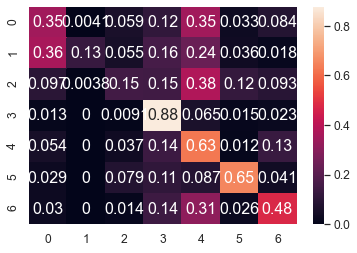

	training epoch=26 .. train_loss=1.055
	validation epoch=26 .. val_loss=1.202
	Accuracy = 55.00000000000001 % .. Percision = 56.3 % .. Recall = 46.6 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_26.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 27 .. loss = 1.145


  0%|                                                                                 | 1/1914 [00:01<35:42,  1.12s/it]

training @ epoch 27 .. loss = 0.614


  0%|                                                                                 | 2/1914 [00:02<35:35,  1.12s/it]

training @ epoch 27 .. loss = 0.631


  0%|▏                                                                                | 3/1914 [00:03<35:24,  1.11s/it]

training @ epoch 27 .. loss = 1.094


  0%|▏                                                                                | 4/1914 [00:04<35:05,  1.10s/it]

training @ epoch 27 .. loss = 1.259


  0%|▏                                                                                | 5/1914 [00:05<35:14,  1.11s/it]

training @ epoch 27 .. loss = 1.06


  0%|▎                                                                                | 6/1914 [00:06<35:03,  1.10s/it]

training @ epoch 27 .. loss = 1.049


  0%|▎                                                                                | 7/1914 [00:07<35:12,  1.11s/it]

training @ epoch 27 .. loss = 1.061


  0%|▎                                                                                | 8/1914 [00:08<35:23,  1.11s/it]

training @ epoch 27 .. loss = 1.032


  0%|▍                                                                                | 9/1914 [00:09<35:14,  1.11s/it]

training @ epoch 27 .. loss = 0.881


  1%|▍                                                                               | 10/1914 [00:11<34:42,  1.09s/it]

training @ epoch 27 .. loss = 0.745


  1%|▍                                                                               | 11/1914 [00:12<35:04,  1.11s/it]

training @ epoch 27 .. loss = 0.832


  1%|▌                                                                               | 12/1914 [00:13<34:54,  1.10s/it]

training @ epoch 27 .. loss = 1.253


  1%|▌                                                                               | 13/1914 [00:14<35:04,  1.11s/it]

training @ epoch 27 .. loss = 1.173


  1%|▌                                                                               | 14/1914 [00:15<36:38,  1.16s/it]

training @ epoch 27 .. loss = 1.207


  1%|▋                                                                               | 15/1914 [00:16<37:04,  1.17s/it]

training @ epoch 27 .. loss = 0.851


  1%|▋                                                                               | 16/1914 [00:18<38:16,  1.21s/it]

training @ epoch 27 .. loss = 0.877


  1%|▋                                                                               | 17/1914 [00:19<37:24,  1.18s/it]

training @ epoch 27 .. loss = 0.979


  1%|▊                                                                               | 18/1914 [00:20<38:14,  1.21s/it]

training @ epoch 27 .. loss = 0.883


  1%|▊                                                                               | 19/1914 [00:21<37:08,  1.18s/it]

training @ epoch 27 .. loss = 1.103


  1%|▊                                                                               | 20/1914 [00:22<36:01,  1.14s/it]

training @ epoch 27 .. loss = 1.232


  1%|▉                                                                               | 21/1914 [00:23<35:23,  1.12s/it]

training @ epoch 27 .. loss = 0.715


  1%|▉                                                                               | 22/1914 [00:24<35:28,  1.13s/it]

training @ epoch 27 .. loss = 1.026


  1%|▉                                                                               | 23/1914 [00:25<35:08,  1.11s/it]

training @ epoch 27 .. loss = 1.796


  1%|█                                                                               | 24/1914 [00:27<35:26,  1.13s/it]

training @ epoch 27 .. loss = 1.429


  1%|█                                                                               | 25/1914 [00:28<35:05,  1.11s/it]

training @ epoch 27 .. loss = 1.065


  1%|█                                                                               | 26/1914 [00:29<34:47,  1.11s/it]

training @ epoch 27 .. loss = 1.028


  1%|█▏                                                                              | 27/1914 [00:30<34:29,  1.10s/it]

training @ epoch 27 .. loss = 0.627


  1%|█▏                                                                              | 28/1914 [00:31<34:18,  1.09s/it]

training @ epoch 27 .. loss = 1.28


  2%|█▏                                                                              | 29/1914 [00:32<34:11,  1.09s/it]

training @ epoch 27 .. loss = 0.85


  2%|█▎                                                                              | 30/1914 [00:33<33:59,  1.08s/it]

training @ epoch 27 .. loss = 0.876


  2%|█▎                                                                              | 31/1914 [00:34<34:31,  1.10s/it]

training @ epoch 27 .. loss = 1.087


  2%|█▎                                                                              | 32/1914 [00:35<35:09,  1.12s/it]

training @ epoch 27 .. loss = 1.417


  2%|█▍                                                                              | 33/1914 [00:37<34:42,  1.11s/it]

training @ epoch 27 .. loss = 1.139


  2%|█▍                                                                              | 34/1914 [00:38<34:54,  1.11s/it]

training @ epoch 27 .. loss = 1.079


  2%|█▍                                                                              | 35/1914 [00:39<34:48,  1.11s/it]

training @ epoch 27 .. loss = 0.756


  2%|█▌                                                                              | 36/1914 [00:40<34:51,  1.11s/it]

training @ epoch 27 .. loss = 1.211


  2%|█▌                                                                              | 37/1914 [00:41<34:48,  1.11s/it]

training @ epoch 27 .. loss = 1.445


  2%|█▌                                                                              | 38/1914 [00:42<35:00,  1.12s/it]

training @ epoch 27 .. loss = 1.376


  2%|█▋                                                                              | 39/1914 [00:43<34:56,  1.12s/it]

training @ epoch 27 .. loss = 0.918


  2%|█▋                                                                              | 40/1914 [00:44<34:33,  1.11s/it]

training @ epoch 27 .. loss = 1.357


  2%|█▋                                                                              | 41/1914 [00:45<34:29,  1.10s/it]

training @ epoch 27 .. loss = 0.694


  2%|█▊                                                                              | 42/1914 [00:46<34:02,  1.09s/it]

training @ epoch 27 .. loss = 1.31


  2%|█▊                                                                              | 43/1914 [00:48<34:40,  1.11s/it]

training @ epoch 27 .. loss = 0.784


  2%|█▊                                                                              | 44/1914 [00:49<34:26,  1.11s/it]

training @ epoch 27 .. loss = 0.964


  2%|█▉                                                                              | 45/1914 [00:50<34:33,  1.11s/it]

training @ epoch 27 .. loss = 0.953


  2%|█▉                                                                              | 46/1914 [00:51<34:16,  1.10s/it]

training @ epoch 27 .. loss = 1.334


  2%|█▉                                                                              | 47/1914 [00:52<34:23,  1.11s/it]

training @ epoch 27 .. loss = 0.982


  3%|██                                                                              | 48/1914 [00:53<34:37,  1.11s/it]

training @ epoch 27 .. loss = 1.078


  3%|██                                                                              | 49/1914 [00:54<34:52,  1.12s/it]

training @ epoch 27 .. loss = 1.495


  3%|██                                                                              | 50/1914 [00:55<34:33,  1.11s/it]

training @ epoch 27 .. loss = 1.058


  3%|██▏                                                                             | 51/1914 [00:56<34:08,  1.10s/it]

training @ epoch 27 .. loss = 0.749


  3%|██▏                                                                             | 52/1914 [00:58<33:56,  1.09s/it]

training @ epoch 27 .. loss = 0.906


  3%|██▏                                                                             | 53/1914 [00:59<33:47,  1.09s/it]

training @ epoch 27 .. loss = 1.214


  3%|██▎                                                                             | 54/1914 [01:00<34:09,  1.10s/it]

training @ epoch 27 .. loss = 1.178


  3%|██▎                                                                             | 55/1914 [01:01<34:07,  1.10s/it]

training @ epoch 27 .. loss = 1.428


  3%|██▎                                                                             | 56/1914 [01:02<34:33,  1.12s/it]

training @ epoch 27 .. loss = 1.088


  3%|██▍                                                                             | 57/1914 [01:03<34:23,  1.11s/it]

training @ epoch 27 .. loss = 1.213


  3%|██▍                                                                             | 58/1914 [01:04<33:48,  1.09s/it]

training @ epoch 27 .. loss = 0.695


  3%|██▍                                                                             | 59/1914 [01:05<33:52,  1.10s/it]

training @ epoch 27 .. loss = 0.88


  3%|██▌                                                                             | 60/1914 [01:06<34:12,  1.11s/it]

training @ epoch 27 .. loss = 1.437


  3%|██▌                                                                             | 61/1914 [01:08<34:15,  1.11s/it]

training @ epoch 27 .. loss = 1.924


  3%|██▌                                                                             | 62/1914 [01:09<34:20,  1.11s/it]

training @ epoch 27 .. loss = 1.092


  3%|██▋                                                                             | 63/1914 [01:10<34:06,  1.11s/it]

training @ epoch 27 .. loss = 0.491


  3%|██▋                                                                             | 64/1914 [01:11<34:02,  1.10s/it]

training @ epoch 27 .. loss = 0.74


  3%|██▋                                                                             | 65/1914 [01:12<33:53,  1.10s/it]

training @ epoch 27 .. loss = 1.062


  3%|██▊                                                                             | 66/1914 [01:13<34:03,  1.11s/it]

training @ epoch 27 .. loss = 0.784


  4%|██▊                                                                             | 67/1914 [01:14<34:21,  1.12s/it]

training @ epoch 27 .. loss = 0.767


  4%|██▊                                                                             | 68/1914 [01:15<34:16,  1.11s/it]

training @ epoch 27 .. loss = 0.968


  4%|██▉                                                                             | 69/1914 [01:16<34:18,  1.12s/it]

training @ epoch 27 .. loss = 1.045


  4%|██▉                                                                             | 70/1914 [01:18<34:14,  1.11s/it]

training @ epoch 27 .. loss = 1.281


  4%|██▉                                                                             | 71/1914 [01:19<34:05,  1.11s/it]

training @ epoch 27 .. loss = 0.667


  4%|███                                                                             | 72/1914 [01:20<33:58,  1.11s/it]

training @ epoch 27 .. loss = 0.955


  4%|███                                                                             | 73/1914 [01:21<36:54,  1.20s/it]

training @ epoch 27 .. loss = 1.033


  4%|███                                                                             | 74/1914 [01:22<37:10,  1.21s/it]

training @ epoch 27 .. loss = 0.931


  4%|███▏                                                                            | 75/1914 [01:23<36:18,  1.18s/it]

training @ epoch 27 .. loss = 0.392


  4%|███▏                                                                            | 76/1914 [01:25<35:57,  1.17s/it]

training @ epoch 27 .. loss = 0.949


  4%|███▏                                                                            | 77/1914 [01:26<35:10,  1.15s/it]

training @ epoch 27 .. loss = 1.093


  4%|███▎                                                                            | 78/1914 [01:27<34:23,  1.12s/it]

training @ epoch 27 .. loss = 0.654


  4%|███▎                                                                            | 79/1914 [01:28<34:00,  1.11s/it]

training @ epoch 27 .. loss = 1.228


  4%|███▎                                                                            | 80/1914 [01:29<33:58,  1.11s/it]

training @ epoch 27 .. loss = 0.719


  4%|███▍                                                                            | 81/1914 [01:30<33:52,  1.11s/it]

training @ epoch 27 .. loss = 1.022


  4%|███▍                                                                            | 82/1914 [01:31<33:45,  1.11s/it]

training @ epoch 27 .. loss = 0.905


  4%|███▍                                                                            | 83/1914 [01:32<33:02,  1.08s/it]

training @ epoch 27 .. loss = 0.838


  4%|███▌                                                                            | 84/1914 [01:33<33:27,  1.10s/it]

training @ epoch 27 .. loss = 0.606


  4%|███▌                                                                            | 85/1914 [01:34<33:44,  1.11s/it]

training @ epoch 27 .. loss = 0.987


  4%|███▌                                                                            | 86/1914 [01:36<33:55,  1.11s/it]

training @ epoch 27 .. loss = 0.904


  5%|███▋                                                                            | 87/1914 [01:37<33:41,  1.11s/it]

training @ epoch 27 .. loss = 0.859


  5%|███▋                                                                            | 88/1914 [01:38<33:56,  1.12s/it]

training @ epoch 27 .. loss = 0.671


  5%|███▋                                                                            | 89/1914 [01:39<34:58,  1.15s/it]

training @ epoch 27 .. loss = 1.444


  5%|███▊                                                                            | 90/1914 [01:40<34:10,  1.12s/it]

training @ epoch 27 .. loss = 0.809


  5%|███▊                                                                            | 91/1914 [01:41<34:07,  1.12s/it]

training @ epoch 27 .. loss = 0.874


  5%|███▊                                                                            | 92/1914 [01:42<33:58,  1.12s/it]

training @ epoch 27 .. loss = 1.009


  5%|███▉                                                                            | 93/1914 [01:43<33:48,  1.11s/it]

training @ epoch 27 .. loss = 0.953


  5%|███▉                                                                            | 94/1914 [01:45<33:33,  1.11s/it]

training @ epoch 27 .. loss = 0.874


  5%|███▉                                                                            | 95/1914 [01:46<33:25,  1.10s/it]

training @ epoch 27 .. loss = 1.131


  5%|████                                                                            | 96/1914 [01:47<33:15,  1.10s/it]

training @ epoch 27 .. loss = 1.287


  5%|████                                                                            | 97/1914 [01:48<33:42,  1.11s/it]

training @ epoch 27 .. loss = 1.277


  5%|████                                                                            | 98/1914 [01:49<36:04,  1.19s/it]

training @ epoch 27 .. loss = 0.691


  5%|████▏                                                                           | 99/1914 [01:51<37:10,  1.23s/it]

training @ epoch 27 .. loss = 0.98


  5%|████▏                                                                          | 100/1914 [01:52<35:47,  1.18s/it]

training @ epoch 27 .. loss = 1.08


  5%|████▏                                                                          | 101/1914 [01:53<35:11,  1.16s/it]

training @ epoch 27 .. loss = 0.826


  5%|████▏                                                                          | 102/1914 [01:54<34:08,  1.13s/it]

training @ epoch 27 .. loss = 0.698


  5%|████▎                                                                          | 103/1914 [01:55<33:50,  1.12s/it]

training @ epoch 27 .. loss = 1.088


  5%|████▎                                                                          | 104/1914 [01:56<33:43,  1.12s/it]

training @ epoch 27 .. loss = 1.315


  5%|████▎                                                                          | 105/1914 [01:57<33:21,  1.11s/it]

training @ epoch 27 .. loss = 0.772


  6%|████▍                                                                          | 106/1914 [01:58<33:11,  1.10s/it]

training @ epoch 27 .. loss = 1.452


  6%|████▍                                                                          | 107/1914 [01:59<32:58,  1.10s/it]

training @ epoch 27 .. loss = 0.916


  6%|████▍                                                                          | 108/1914 [02:00<32:52,  1.09s/it]

training @ epoch 27 .. loss = 0.782


  6%|████▍                                                                          | 109/1914 [02:01<32:54,  1.09s/it]

training @ epoch 27 .. loss = 0.416


  6%|████▌                                                                          | 110/1914 [02:03<32:55,  1.09s/it]

training @ epoch 27 .. loss = 0.806


  6%|████▌                                                                          | 111/1914 [02:04<32:56,  1.10s/it]

training @ epoch 27 .. loss = 1.268


  6%|████▌                                                                          | 112/1914 [02:05<32:52,  1.09s/it]

training @ epoch 27 .. loss = 0.915


  6%|████▋                                                                          | 113/1914 [02:06<32:48,  1.09s/it]

training @ epoch 27 .. loss = 0.996


  6%|████▋                                                                          | 114/1914 [02:07<32:56,  1.10s/it]

training @ epoch 27 .. loss = 1.465


  6%|████▋                                                                          | 115/1914 [02:08<32:55,  1.10s/it]

training @ epoch 27 .. loss = 1.228


  6%|████▊                                                                          | 116/1914 [02:09<32:29,  1.08s/it]

training @ epoch 27 .. loss = 0.853


  6%|████▊                                                                          | 117/1914 [02:10<32:26,  1.08s/it]

training @ epoch 27 .. loss = 1.129


  6%|████▊                                                                          | 118/1914 [02:11<32:17,  1.08s/it]

training @ epoch 27 .. loss = 1.124


  6%|████▉                                                                          | 119/1914 [02:12<32:28,  1.09s/it]

training @ epoch 27 .. loss = 1.016


  6%|████▉                                                                          | 120/1914 [02:13<32:24,  1.08s/it]

training @ epoch 27 .. loss = 1.17


  6%|████▉                                                                          | 121/1914 [02:14<32:10,  1.08s/it]

training @ epoch 27 .. loss = 1.071


  6%|█████                                                                          | 122/1914 [02:16<32:27,  1.09s/it]

training @ epoch 27 .. loss = 0.817


  6%|█████                                                                          | 123/1914 [02:17<32:27,  1.09s/it]

training @ epoch 27 .. loss = 1.187


  6%|█████                                                                          | 124/1914 [02:18<32:55,  1.10s/it]

training @ epoch 27 .. loss = 1.167


  7%|█████▏                                                                         | 125/1914 [02:19<33:46,  1.13s/it]

training @ epoch 27 .. loss = 0.888


  7%|█████▏                                                                         | 126/1914 [02:20<34:10,  1.15s/it]

training @ epoch 27 .. loss = 1.117


  7%|█████▏                                                                         | 127/1914 [02:21<34:53,  1.17s/it]

training @ epoch 27 .. loss = 0.953


  7%|█████▎                                                                         | 128/1914 [02:23<34:16,  1.15s/it]

training @ epoch 27 .. loss = 0.946


  7%|█████▎                                                                         | 129/1914 [02:24<34:12,  1.15s/it]

training @ epoch 27 .. loss = 1.172


  7%|█████▎                                                                         | 130/1914 [02:25<34:24,  1.16s/it]

training @ epoch 27 .. loss = 1.103


  7%|█████▍                                                                         | 131/1914 [02:26<34:56,  1.18s/it]

training @ epoch 27 .. loss = 1.112


  7%|█████▍                                                                         | 132/1914 [02:27<34:23,  1.16s/it]

training @ epoch 27 .. loss = 1.236


  7%|█████▍                                                                         | 133/1914 [02:28<33:45,  1.14s/it]

training @ epoch 27 .. loss = 0.863


  7%|█████▌                                                                         | 134/1914 [02:29<33:35,  1.13s/it]

training @ epoch 27 .. loss = 0.824


  7%|█████▌                                                                         | 135/1914 [02:31<33:33,  1.13s/it]

training @ epoch 27 .. loss = 1.006


  7%|█████▌                                                                         | 136/1914 [02:32<32:58,  1.11s/it]

training @ epoch 27 .. loss = 1.307


  7%|█████▋                                                                         | 137/1914 [02:33<32:45,  1.11s/it]

training @ epoch 27 .. loss = 0.967


  7%|█████▋                                                                         | 138/1914 [02:34<32:30,  1.10s/it]

training @ epoch 27 .. loss = 1.173


  7%|█████▋                                                                         | 139/1914 [02:35<32:19,  1.09s/it]

training @ epoch 27 .. loss = 0.657


  7%|█████▊                                                                         | 140/1914 [02:36<32:22,  1.09s/it]

training @ epoch 27 .. loss = 0.946


  7%|█████▊                                                                         | 141/1914 [02:37<32:16,  1.09s/it]

training @ epoch 27 .. loss = 0.975


  7%|█████▊                                                                         | 142/1914 [02:38<32:16,  1.09s/it]

training @ epoch 27 .. loss = 1.672


  7%|█████▉                                                                         | 143/1914 [02:39<31:58,  1.08s/it]

training @ epoch 27 .. loss = 1.85


  8%|█████▉                                                                         | 144/1914 [02:40<32:09,  1.09s/it]

training @ epoch 27 .. loss = 1.029


  8%|█████▉                                                                         | 145/1914 [02:41<32:15,  1.09s/it]

training @ epoch 27 .. loss = 1.023


  8%|██████                                                                         | 146/1914 [02:42<31:56,  1.08s/it]

training @ epoch 27 .. loss = 1.108


  8%|██████                                                                         | 147/1914 [02:44<31:58,  1.09s/it]

training @ epoch 27 .. loss = 0.977


  8%|██████                                                                         | 148/1914 [02:45<31:49,  1.08s/it]

training @ epoch 27 .. loss = 0.998


  8%|██████▏                                                                        | 149/1914 [02:46<31:42,  1.08s/it]

training @ epoch 27 .. loss = 1.193


  8%|██████▏                                                                        | 150/1914 [02:47<31:42,  1.08s/it]

training @ epoch 27 .. loss = 1.331


  8%|██████▏                                                                        | 151/1914 [02:48<31:39,  1.08s/it]

training @ epoch 27 .. loss = 0.984


  8%|██████▎                                                                        | 152/1914 [02:49<32:03,  1.09s/it]

training @ epoch 27 .. loss = 1.334


  8%|██████▎                                                                        | 153/1914 [02:50<31:54,  1.09s/it]

training @ epoch 27 .. loss = 1.059


  8%|██████▎                                                                        | 154/1914 [02:51<31:35,  1.08s/it]

training @ epoch 27 .. loss = 0.762


  8%|██████▍                                                                        | 155/1914 [02:52<31:44,  1.08s/it]

training @ epoch 27 .. loss = 0.858


  8%|██████▍                                                                        | 156/1914 [02:53<32:42,  1.12s/it]

training @ epoch 27 .. loss = 0.999


  8%|██████▍                                                                        | 157/1914 [02:55<34:52,  1.19s/it]

training @ epoch 27 .. loss = 1.024


  8%|██████▌                                                                        | 158/1914 [02:56<36:50,  1.26s/it]

training @ epoch 27 .. loss = 1.379


  8%|██████▌                                                                        | 159/1914 [02:58<38:12,  1.31s/it]

training @ epoch 27 .. loss = 1.032


  8%|██████▌                                                                        | 160/1914 [02:59<38:41,  1.32s/it]

training @ epoch 27 .. loss = 1.188


  8%|██████▋                                                                        | 161/1914 [03:00<37:54,  1.30s/it]

training @ epoch 27 .. loss = 1.105


  8%|██████▋                                                                        | 162/1914 [03:01<36:19,  1.24s/it]

training @ epoch 27 .. loss = 1.111


  9%|██████▋                                                                        | 163/1914 [03:03<35:45,  1.23s/it]

training @ epoch 27 .. loss = 0.844


  9%|██████▊                                                                        | 164/1914 [03:04<34:22,  1.18s/it]

training @ epoch 27 .. loss = 1.084


  9%|██████▊                                                                        | 165/1914 [03:05<33:46,  1.16s/it]

training @ epoch 27 .. loss = 0.859


  9%|██████▊                                                                        | 166/1914 [03:06<33:28,  1.15s/it]

training @ epoch 27 .. loss = 1.201


  9%|██████▉                                                                        | 167/1914 [03:07<34:04,  1.17s/it]

training @ epoch 27 .. loss = 0.515


  9%|██████▉                                                                        | 168/1914 [03:08<34:08,  1.17s/it]

training @ epoch 27 .. loss = 0.892


  9%|██████▉                                                                        | 169/1914 [03:09<33:26,  1.15s/it]

training @ epoch 27 .. loss = 1.016


  9%|███████                                                                        | 170/1914 [03:10<33:23,  1.15s/it]

training @ epoch 27 .. loss = 1.097


  9%|███████                                                                        | 171/1914 [03:12<33:06,  1.14s/it]

training @ epoch 27 .. loss = 0.699


  9%|███████                                                                        | 172/1914 [03:13<32:31,  1.12s/it]

training @ epoch 27 .. loss = 1.678


  9%|███████▏                                                                       | 173/1914 [03:14<32:48,  1.13s/it]

training @ epoch 27 .. loss = 0.935


  9%|███████▏                                                                       | 174/1914 [03:15<32:23,  1.12s/it]

training @ epoch 27 .. loss = 0.891


  9%|███████▏                                                                       | 175/1914 [03:16<32:16,  1.11s/it]

training @ epoch 27 .. loss = 1.191


  9%|███████▎                                                                       | 176/1914 [03:17<32:02,  1.11s/it]

training @ epoch 27 .. loss = 0.941


  9%|███████▎                                                                       | 177/1914 [03:18<31:47,  1.10s/it]

training @ epoch 27 .. loss = 0.682


  9%|███████▎                                                                       | 178/1914 [03:19<31:45,  1.10s/it]

training @ epoch 27 .. loss = 0.812


  9%|███████▍                                                                       | 179/1914 [03:20<31:47,  1.10s/it]

training @ epoch 27 .. loss = 1.073


  9%|███████▍                                                                       | 180/1914 [03:21<31:42,  1.10s/it]

training @ epoch 27 .. loss = 1.16


  9%|███████▍                                                                       | 181/1914 [03:23<31:42,  1.10s/it]

training @ epoch 27 .. loss = 0.952


 10%|███████▌                                                                       | 182/1914 [03:24<31:31,  1.09s/it]

training @ epoch 27 .. loss = 1.486


 10%|███████▌                                                                       | 183/1914 [03:25<31:40,  1.10s/it]

training @ epoch 27 .. loss = 1.053


 10%|███████▌                                                                       | 184/1914 [03:26<31:40,  1.10s/it]

training @ epoch 27 .. loss = 0.912


 10%|███████▋                                                                       | 185/1914 [03:27<32:00,  1.11s/it]

training @ epoch 27 .. loss = 1.055


 10%|███████▋                                                                       | 186/1914 [03:28<32:30,  1.13s/it]

training @ epoch 27 .. loss = 1.148


 10%|███████▋                                                                       | 187/1914 [03:29<33:57,  1.18s/it]

training @ epoch 27 .. loss = 1.06


 10%|███████▊                                                                       | 188/1914 [03:31<33:20,  1.16s/it]

training @ epoch 27 .. loss = 1.193


 10%|███████▊                                                                       | 189/1914 [03:34<51:16,  1.78s/it]

training @ epoch 27 .. loss = 1.392


 10%|███████▊                                                                       | 190/1914 [03:36<50:58,  1.77s/it]

training @ epoch 27 .. loss = 1.119


 10%|███████▉                                                                       | 191/1914 [03:37<49:07,  1.71s/it]

training @ epoch 27 .. loss = 1.352


 10%|███████▉                                                                       | 192/1914 [03:38<44:57,  1.57s/it]

training @ epoch 27 .. loss = 1.199


 10%|███████▉                                                                       | 193/1914 [03:40<43:58,  1.53s/it]

training @ epoch 27 .. loss = 0.877


 10%|████████                                                                       | 194/1914 [03:43<57:38,  2.01s/it]

training @ epoch 27 .. loss = 1.146


 10%|████████                                                                       | 195/1914 [03:45<57:47,  2.02s/it]

training @ epoch 27 .. loss = 1.107


 10%|████████                                                                       | 196/1914 [03:47<53:46,  1.88s/it]

training @ epoch 27 .. loss = 1.154


 10%|████████▏                                                                      | 197/1914 [03:48<48:51,  1.71s/it]

training @ epoch 27 .. loss = 0.907


 10%|████████▏                                                                      | 198/1914 [03:50<54:12,  1.90s/it]

training @ epoch 27 .. loss = 1.229


 10%|████████▏                                                                      | 199/1914 [03:52<50:06,  1.75s/it]

training @ epoch 27 .. loss = 1.046


 10%|████████▎                                                                      | 200/1914 [03:54<53:21,  1.87s/it]

training @ epoch 27 .. loss = 0.973


 11%|████████▎                                                                      | 201/1914 [03:56<55:46,  1.95s/it]

training @ epoch 27 .. loss = 0.747


 11%|████████▎                                                                      | 202/1914 [03:57<52:04,  1.83s/it]

training @ epoch 27 .. loss = 1.414


 11%|████████▍                                                                      | 203/1914 [03:59<48:31,  1.70s/it]

training @ epoch 27 .. loss = 1.138


 11%|████████▍                                                                      | 204/1914 [04:00<44:44,  1.57s/it]

training @ epoch 27 .. loss = 1.074


 11%|████████▍                                                                      | 205/1914 [04:01<41:53,  1.47s/it]

training @ epoch 27 .. loss = 1.523


 11%|████████▌                                                                      | 206/1914 [04:02<39:27,  1.39s/it]

training @ epoch 27 .. loss = 0.988


 11%|████████▌                                                                      | 207/1914 [04:04<39:18,  1.38s/it]

training @ epoch 27 .. loss = 1.01


 11%|████████▌                                                                      | 208/1914 [04:05<38:01,  1.34s/it]

training @ epoch 27 .. loss = 0.934


 11%|████████▋                                                                      | 209/1914 [04:06<35:54,  1.26s/it]

training @ epoch 27 .. loss = 0.854


 11%|████████▋                                                                      | 210/1914 [04:07<34:24,  1.21s/it]

training @ epoch 27 .. loss = 1.496


 11%|████████▋                                                                      | 211/1914 [04:08<33:51,  1.19s/it]

training @ epoch 27 .. loss = 0.958


 11%|████████▊                                                                      | 212/1914 [04:09<32:42,  1.15s/it]

training @ epoch 27 .. loss = 0.659


 11%|████████▊                                                                      | 213/1914 [04:11<32:09,  1.13s/it]

training @ epoch 27 .. loss = 1.661


 11%|████████▊                                                                      | 214/1914 [04:12<31:50,  1.12s/it]

training @ epoch 27 .. loss = 0.877


 11%|████████▊                                                                      | 215/1914 [04:13<32:33,  1.15s/it]

training @ epoch 27 .. loss = 1.075


 11%|████████▉                                                                      | 216/1914 [04:14<31:51,  1.13s/it]

training @ epoch 27 .. loss = 1.059


 11%|████████▉                                                                      | 217/1914 [04:15<31:32,  1.12s/it]

training @ epoch 27 .. loss = 1.197


 11%|████████▉                                                                      | 218/1914 [04:16<31:18,  1.11s/it]

training @ epoch 27 .. loss = 1.203


 11%|█████████                                                                      | 219/1914 [04:17<31:18,  1.11s/it]

training @ epoch 27 .. loss = 0.653


 11%|█████████                                                                      | 220/1914 [04:18<31:33,  1.12s/it]

training @ epoch 27 .. loss = 1.531


 12%|█████████                                                                      | 221/1914 [04:19<31:10,  1.10s/it]

training @ epoch 27 .. loss = 0.605


 12%|█████████▏                                                                     | 222/1914 [04:21<30:59,  1.10s/it]

training @ epoch 27 .. loss = 1.316


 12%|█████████▏                                                                     | 223/1914 [04:22<30:46,  1.09s/it]

training @ epoch 27 .. loss = 1.016


 12%|█████████▏                                                                     | 224/1914 [04:23<30:59,  1.10s/it]

training @ epoch 27 .. loss = 0.791


 12%|█████████▎                                                                     | 225/1914 [04:24<31:10,  1.11s/it]

training @ epoch 27 .. loss = 1.394


 12%|█████████▎                                                                     | 226/1914 [04:25<31:36,  1.12s/it]

training @ epoch 27 .. loss = 1.101


 12%|█████████▎                                                                     | 227/1914 [04:26<31:17,  1.11s/it]

training @ epoch 27 .. loss = 1.024


 12%|█████████▍                                                                     | 228/1914 [04:27<31:20,  1.12s/it]

training @ epoch 27 .. loss = 1.236


 12%|█████████▍                                                                     | 229/1914 [04:28<31:26,  1.12s/it]

training @ epoch 27 .. loss = 1.119


 12%|█████████▍                                                                     | 230/1914 [04:30<31:35,  1.13s/it]

training @ epoch 27 .. loss = 1.139


 12%|█████████▌                                                                     | 231/1914 [04:31<31:16,  1.11s/it]

training @ epoch 27 .. loss = 1.229


 12%|█████████▌                                                                     | 232/1914 [04:32<31:28,  1.12s/it]

training @ epoch 27 .. loss = 1.88


 12%|█████████▌                                                                     | 233/1914 [04:33<31:10,  1.11s/it]

training @ epoch 27 .. loss = 1.327


 12%|█████████▋                                                                     | 234/1914 [04:34<30:58,  1.11s/it]

training @ epoch 27 .. loss = 0.894


 12%|█████████▋                                                                     | 235/1914 [04:35<31:29,  1.13s/it]

training @ epoch 27 .. loss = 0.821


 12%|█████████▋                                                                     | 236/1914 [04:36<31:25,  1.12s/it]

training @ epoch 27 .. loss = 0.915


 12%|█████████▊                                                                     | 237/1914 [04:37<31:29,  1.13s/it]

training @ epoch 27 .. loss = 0.507


 12%|█████████▊                                                                     | 238/1914 [04:39<31:58,  1.14s/it]

training @ epoch 27 .. loss = 1.418


 12%|█████████▊                                                                     | 239/1914 [04:40<31:32,  1.13s/it]

training @ epoch 27 .. loss = 0.896


 13%|█████████▉                                                                     | 240/1914 [04:41<31:08,  1.12s/it]

training @ epoch 27 .. loss = 1.386


 13%|█████████▉                                                                     | 241/1914 [04:42<31:09,  1.12s/it]

training @ epoch 27 .. loss = 1.234


 13%|█████████▉                                                                     | 242/1914 [04:43<30:39,  1.10s/it]

training @ epoch 27 .. loss = 1.412


 13%|██████████                                                                     | 243/1914 [04:44<30:48,  1.11s/it]

training @ epoch 27 .. loss = 1.473


 13%|██████████                                                                     | 244/1914 [04:45<30:34,  1.10s/it]

training @ epoch 27 .. loss = 1.078


 13%|██████████                                                                     | 245/1914 [04:46<30:26,  1.09s/it]

training @ epoch 27 .. loss = 0.967


 13%|██████████▏                                                                    | 246/1914 [04:47<30:15,  1.09s/it]

training @ epoch 27 .. loss = 1.026


 13%|██████████▏                                                                    | 247/1914 [04:48<30:10,  1.09s/it]

training @ epoch 27 .. loss = 1.189


 13%|██████████▏                                                                    | 248/1914 [04:49<30:26,  1.10s/it]

training @ epoch 27 .. loss = 0.933


 13%|██████████▎                                                                    | 249/1914 [04:51<30:14,  1.09s/it]

training @ epoch 27 .. loss = 0.882


 13%|██████████▎                                                                    | 250/1914 [04:52<30:20,  1.09s/it]

training @ epoch 27 .. loss = 0.907


 13%|██████████▎                                                                    | 251/1914 [04:53<30:25,  1.10s/it]

training @ epoch 27 .. loss = 1.293


 13%|██████████▍                                                                    | 252/1914 [04:54<30:10,  1.09s/it]

training @ epoch 27 .. loss = 0.713


 13%|██████████▍                                                                    | 253/1914 [04:55<30:02,  1.08s/it]

training @ epoch 27 .. loss = 1.116


 13%|██████████▍                                                                    | 254/1914 [04:56<30:33,  1.10s/it]

training @ epoch 27 .. loss = 1.51


 13%|██████████▌                                                                    | 255/1914 [04:57<30:22,  1.10s/it]

training @ epoch 27 .. loss = 1.39


 13%|██████████▌                                                                    | 256/1914 [04:58<30:37,  1.11s/it]

training @ epoch 27 .. loss = 1.228


 13%|██████████▌                                                                    | 257/1914 [04:59<30:39,  1.11s/it]

training @ epoch 27 .. loss = 1.281


 13%|██████████▋                                                                    | 258/1914 [05:00<30:42,  1.11s/it]

training @ epoch 27 .. loss = 1.314


 14%|██████████▋                                                                    | 259/1914 [05:02<30:21,  1.10s/it]

training @ epoch 27 .. loss = 0.583


 14%|██████████▋                                                                    | 260/1914 [05:03<30:19,  1.10s/it]

training @ epoch 27 .. loss = 0.791


 14%|██████████▊                                                                    | 261/1914 [05:04<30:43,  1.12s/it]

training @ epoch 27 .. loss = 0.884


 14%|██████████▊                                                                    | 262/1914 [05:05<30:39,  1.11s/it]

training @ epoch 27 .. loss = 0.939


 14%|██████████▊                                                                    | 263/1914 [05:06<30:46,  1.12s/it]

training @ epoch 27 .. loss = 0.808


 14%|██████████▉                                                                    | 264/1914 [05:07<32:20,  1.18s/it]

training @ epoch 27 .. loss = 1.468


 14%|██████████▉                                                                    | 265/1914 [05:09<35:04,  1.28s/it]

training @ epoch 27 .. loss = 1.353


 14%|██████████▉                                                                    | 266/1914 [05:10<35:42,  1.30s/it]

training @ epoch 27 .. loss = 0.985


 14%|███████████                                                                    | 267/1914 [05:12<35:46,  1.30s/it]

training @ epoch 27 .. loss = 1.518


 14%|███████████                                                                    | 268/1914 [05:13<36:26,  1.33s/it]

training @ epoch 27 .. loss = 1.166


 14%|███████████                                                                    | 269/1914 [05:14<37:30,  1.37s/it]

training @ epoch 27 .. loss = 1.629


 14%|███████████▏                                                                   | 270/1914 [05:16<36:58,  1.35s/it]

training @ epoch 27 .. loss = 0.839


 14%|███████████▏                                                                   | 271/1914 [05:17<36:54,  1.35s/it]

training @ epoch 27 .. loss = 1.019


 14%|███████████▏                                                                   | 272/1914 [05:18<36:35,  1.34s/it]

training @ epoch 27 .. loss = 1.16


 14%|███████████▎                                                                   | 273/1914 [05:20<36:03,  1.32s/it]

training @ epoch 27 .. loss = 0.973


 14%|███████████▎                                                                   | 274/1914 [05:21<38:53,  1.42s/it]

training @ epoch 27 .. loss = 1.229


 14%|███████████▎                                                                   | 275/1914 [05:23<39:21,  1.44s/it]

training @ epoch 27 .. loss = 0.945


 14%|███████████▍                                                                   | 276/1914 [05:24<38:10,  1.40s/it]

training @ epoch 27 .. loss = 1.044


 14%|███████████▍                                                                   | 277/1914 [05:25<37:08,  1.36s/it]

training @ epoch 27 .. loss = 0.756


 15%|███████████▍                                                                   | 278/1914 [05:27<36:17,  1.33s/it]

training @ epoch 27 .. loss = 1.076


 15%|███████████▌                                                                   | 279/1914 [05:28<36:00,  1.32s/it]

training @ epoch 27 .. loss = 1.143


 15%|███████████▌                                                                   | 280/1914 [05:29<35:30,  1.30s/it]

training @ epoch 27 .. loss = 1.459


 15%|███████████▌                                                                   | 281/1914 [05:30<35:28,  1.30s/it]

training @ epoch 27 .. loss = 0.993


 15%|███████████▋                                                                   | 282/1914 [05:32<35:08,  1.29s/it]

training @ epoch 27 .. loss = 0.835


 15%|███████████▋                                                                   | 283/1914 [05:33<36:08,  1.33s/it]

training @ epoch 27 .. loss = 0.959


 15%|███████████▋                                                                   | 284/1914 [05:34<35:56,  1.32s/it]

training @ epoch 27 .. loss = 0.994


 15%|███████████▊                                                                   | 285/1914 [05:36<38:50,  1.43s/it]

training @ epoch 27 .. loss = 1.297


 15%|███████████▊                                                                   | 286/1914 [05:38<41:16,  1.52s/it]

training @ epoch 27 .. loss = 1.192


 15%|███████████▊                                                                   | 287/1914 [05:39<40:45,  1.50s/it]

training @ epoch 27 .. loss = 1.043


 15%|███████████▉                                                                   | 288/1914 [05:41<39:22,  1.45s/it]

training @ epoch 27 .. loss = 0.879


 15%|███████████▉                                                                   | 289/1914 [05:42<38:45,  1.43s/it]

training @ epoch 27 .. loss = 1.081


 15%|███████████▉                                                                   | 290/1914 [05:43<37:32,  1.39s/it]

training @ epoch 27 .. loss = 0.734


 15%|████████████                                                                   | 291/1914 [05:45<36:58,  1.37s/it]

training @ epoch 27 .. loss = 1.038


 15%|████████████                                                                   | 292/1914 [05:46<36:48,  1.36s/it]

training @ epoch 27 .. loss = 0.999


 15%|████████████                                                                   | 293/1914 [05:47<36:06,  1.34s/it]

training @ epoch 27 .. loss = 0.794


 15%|████████████▏                                                                  | 294/1914 [05:49<35:36,  1.32s/it]

training @ epoch 27 .. loss = 0.804


 15%|████████████▏                                                                  | 295/1914 [05:50<35:28,  1.31s/it]

training @ epoch 27 .. loss = 0.982


 15%|████████████▏                                                                  | 296/1914 [05:51<35:26,  1.31s/it]

training @ epoch 27 .. loss = 0.849


 16%|████████████▎                                                                  | 297/1914 [05:52<35:19,  1.31s/it]

training @ epoch 27 .. loss = 1.116


 16%|████████████▎                                                                  | 298/1914 [05:54<34:53,  1.30s/it]

training @ epoch 27 .. loss = 1.263


 16%|████████████▎                                                                  | 299/1914 [05:55<34:54,  1.30s/it]

training @ epoch 27 .. loss = 0.908


 16%|████████████▍                                                                  | 300/1914 [05:56<34:35,  1.29s/it]

training @ epoch 27 .. loss = 1.255


 16%|████████████▍                                                                  | 301/1914 [05:58<34:25,  1.28s/it]

training @ epoch 27 .. loss = 1.139


 16%|████████████▍                                                                  | 302/1914 [05:59<34:06,  1.27s/it]

training @ epoch 27 .. loss = 1.45


 16%|████████████▌                                                                  | 303/1914 [06:00<34:11,  1.27s/it]

training @ epoch 27 .. loss = 1.318


 16%|████████████▌                                                                  | 304/1914 [06:01<34:03,  1.27s/it]

training @ epoch 27 .. loss = 1.004


 16%|████████████▌                                                                  | 305/1914 [06:03<34:19,  1.28s/it]

training @ epoch 27 .. loss = 1.034


 16%|████████████▋                                                                  | 306/1914 [06:04<34:16,  1.28s/it]

training @ epoch 27 .. loss = 1.058


 16%|████████████▋                                                                  | 307/1914 [06:05<34:20,  1.28s/it]

training @ epoch 27 .. loss = 0.718


 16%|████████████▋                                                                  | 308/1914 [06:07<34:37,  1.29s/it]

training @ epoch 27 .. loss = 1.123


 16%|████████████▊                                                                  | 309/1914 [06:08<34:29,  1.29s/it]

training @ epoch 27 .. loss = 1.032


 16%|████████████▊                                                                  | 310/1914 [06:09<34:53,  1.31s/it]

training @ epoch 27 .. loss = 1.488


 16%|████████████▊                                                                  | 311/1914 [06:10<34:58,  1.31s/it]

training @ epoch 27 .. loss = 1.04


 16%|████████████▉                                                                  | 312/1914 [06:12<35:34,  1.33s/it]

training @ epoch 27 .. loss = 0.996


 16%|████████████▉                                                                  | 313/1914 [06:13<35:04,  1.31s/it]

training @ epoch 27 .. loss = 0.919


 16%|████████████▉                                                                  | 314/1914 [06:15<37:33,  1.41s/it]

training @ epoch 27 .. loss = 0.933


 16%|█████████████                                                                  | 315/1914 [06:16<36:19,  1.36s/it]

training @ epoch 27 .. loss = 0.899


 17%|█████████████                                                                  | 316/1914 [06:17<35:28,  1.33s/it]

training @ epoch 27 .. loss = 0.898


 17%|█████████████                                                                  | 317/1914 [06:19<36:04,  1.36s/it]

training @ epoch 27 .. loss = 0.863


 17%|█████████████▏                                                                 | 318/1914 [06:20<35:46,  1.34s/it]

training @ epoch 27 .. loss = 0.983


 17%|█████████████▏                                                                 | 319/1914 [06:21<35:25,  1.33s/it]

training @ epoch 27 .. loss = 0.507


 17%|█████████████▏                                                                 | 320/1914 [06:23<34:57,  1.32s/it]

training @ epoch 27 .. loss = 0.758


 17%|█████████████▏                                                                 | 321/1914 [06:24<34:21,  1.29s/it]

training @ epoch 27 .. loss = 1.023


 17%|█████████████▎                                                                 | 322/1914 [06:25<34:35,  1.30s/it]

training @ epoch 27 .. loss = 1.132


 17%|█████████████▎                                                                 | 323/1914 [06:27<37:33,  1.42s/it]

training @ epoch 27 .. loss = 1.315


 17%|█████████████▎                                                                 | 324/1914 [06:28<36:39,  1.38s/it]

training @ epoch 27 .. loss = 1.206


 17%|█████████████▍                                                                 | 325/1914 [06:29<35:50,  1.35s/it]

training @ epoch 27 .. loss = 1.038


 17%|█████████████▍                                                                 | 326/1914 [06:31<35:05,  1.33s/it]

training @ epoch 27 .. loss = 0.871


 17%|█████████████▍                                                                 | 327/1914 [06:32<34:50,  1.32s/it]

training @ epoch 27 .. loss = 0.803


 17%|█████████████▌                                                                 | 328/1914 [06:33<34:24,  1.30s/it]

training @ epoch 27 .. loss = 0.87


 17%|█████████████▌                                                                 | 329/1914 [06:35<34:12,  1.30s/it]

training @ epoch 27 .. loss = 1.335


 17%|█████████████▌                                                                 | 330/1914 [06:36<34:16,  1.30s/it]

training @ epoch 27 .. loss = 0.902


 17%|█████████████▋                                                                 | 331/1914 [06:37<34:21,  1.30s/it]

training @ epoch 27 .. loss = 1.434


 17%|█████████████▋                                                                 | 332/1914 [06:38<34:25,  1.31s/it]

training @ epoch 27 .. loss = 0.778


 17%|█████████████▋                                                                 | 333/1914 [06:40<34:19,  1.30s/it]

training @ epoch 27 .. loss = 0.941


 17%|█████████████▊                                                                 | 334/1914 [06:41<34:10,  1.30s/it]

training @ epoch 27 .. loss = 1.001


 18%|█████████████▊                                                                 | 335/1914 [06:43<35:28,  1.35s/it]

training @ epoch 27 .. loss = 1.329


 18%|█████████████▊                                                                 | 336/1914 [06:44<34:57,  1.33s/it]

training @ epoch 27 .. loss = 0.888


 18%|█████████████▉                                                                 | 337/1914 [06:46<38:51,  1.48s/it]

training @ epoch 27 .. loss = 1.1


 18%|█████████████▉                                                                 | 338/1914 [06:47<38:14,  1.46s/it]

training @ epoch 27 .. loss = 1.023


 18%|█████████████▉                                                                 | 339/1914 [06:48<37:46,  1.44s/it]

training @ epoch 27 .. loss = 0.866


 18%|██████████████                                                                 | 340/1914 [06:50<37:05,  1.41s/it]

training @ epoch 27 .. loss = 1.932


 18%|██████████████                                                                 | 341/1914 [06:51<37:14,  1.42s/it]

training @ epoch 27 .. loss = 1.065


 18%|██████████████                                                                 | 342/1914 [06:53<36:38,  1.40s/it]

training @ epoch 27 .. loss = 0.969


 18%|██████████████▏                                                                | 343/1914 [06:54<38:15,  1.46s/it]

training @ epoch 27 .. loss = 0.549


 18%|██████████████▏                                                                | 344/1914 [06:56<38:31,  1.47s/it]

training @ epoch 27 .. loss = 1.277


 18%|██████████████▏                                                                | 345/1914 [06:57<37:16,  1.43s/it]

training @ epoch 27 .. loss = 1.223


 18%|██████████████▎                                                                | 346/1914 [06:58<36:06,  1.38s/it]

training @ epoch 27 .. loss = 1.024


 18%|██████████████▎                                                                | 347/1914 [07:00<37:55,  1.45s/it]

training @ epoch 27 .. loss = 0.966


 18%|██████████████▎                                                                | 348/1914 [07:01<36:41,  1.41s/it]

training @ epoch 27 .. loss = 0.749


 18%|██████████████▍                                                                | 349/1914 [07:03<37:31,  1.44s/it]

training @ epoch 27 .. loss = 0.893


 18%|██████████████▍                                                                | 350/1914 [07:04<36:40,  1.41s/it]

training @ epoch 27 .. loss = 1.037


 18%|██████████████▍                                                                | 351/1914 [07:05<36:20,  1.40s/it]

training @ epoch 27 .. loss = 1.378


 18%|██████████████▌                                                                | 352/1914 [07:07<35:47,  1.37s/it]

training @ epoch 27 .. loss = 1.075


 18%|██████████████▌                                                                | 353/1914 [07:08<37:27,  1.44s/it]

training @ epoch 27 .. loss = 1.025


 18%|██████████████▌                                                                | 354/1914 [07:10<36:06,  1.39s/it]

training @ epoch 27 .. loss = 1.741


 19%|██████████████▋                                                                | 355/1914 [07:11<35:21,  1.36s/it]

training @ epoch 27 .. loss = 0.947


 19%|██████████████▋                                                                | 356/1914 [07:12<34:35,  1.33s/it]

training @ epoch 27 .. loss = 0.963


 19%|██████████████▋                                                                | 357/1914 [07:13<34:07,  1.32s/it]

training @ epoch 27 .. loss = 1.047


 19%|██████████████▊                                                                | 358/1914 [07:15<34:15,  1.32s/it]

training @ epoch 27 .. loss = 1.162


 19%|██████████████▊                                                                | 359/1914 [07:16<33:40,  1.30s/it]

training @ epoch 27 .. loss = 0.937


 19%|██████████████▊                                                                | 360/1914 [07:17<33:32,  1.30s/it]

training @ epoch 27 .. loss = 1.148


 19%|██████████████▉                                                                | 361/1914 [07:19<33:27,  1.29s/it]

training @ epoch 27 .. loss = 0.985


 19%|██████████████▉                                                                | 362/1914 [07:20<33:15,  1.29s/it]

training @ epoch 27 .. loss = 1.056


 19%|██████████████▉                                                                | 363/1914 [07:21<33:20,  1.29s/it]

training @ epoch 27 .. loss = 0.787


 19%|███████████████                                                                | 364/1914 [07:22<33:17,  1.29s/it]

training @ epoch 27 .. loss = 0.746


 19%|███████████████                                                                | 365/1914 [07:24<32:55,  1.28s/it]

training @ epoch 27 .. loss = 0.509


 19%|███████████████                                                                | 366/1914 [07:25<33:13,  1.29s/it]

training @ epoch 27 .. loss = 1.1


 19%|███████████████▏                                                               | 367/1914 [07:26<33:26,  1.30s/it]

training @ epoch 27 .. loss = 1.04


 19%|███████████████▏                                                               | 368/1914 [07:28<33:31,  1.30s/it]

training @ epoch 27 .. loss = 1.109


 19%|███████████████▏                                                               | 369/1914 [07:29<34:29,  1.34s/it]

training @ epoch 27 .. loss = 0.606


 19%|███████████████▎                                                               | 370/1914 [07:30<32:41,  1.27s/it]

training @ epoch 27 .. loss = 0.999


 19%|███████████████▎                                                               | 371/1914 [07:31<31:10,  1.21s/it]

training @ epoch 27 .. loss = 0.91


 19%|███████████████▎                                                               | 372/1914 [07:32<30:37,  1.19s/it]

training @ epoch 27 .. loss = 1.002


 19%|███████████████▍                                                               | 373/1914 [07:33<29:44,  1.16s/it]

training @ epoch 27 .. loss = 1.423


 20%|███████████████▍                                                               | 374/1914 [07:35<29:02,  1.13s/it]

training @ epoch 27 .. loss = 1.154


 20%|███████████████▍                                                               | 375/1914 [07:36<28:51,  1.13s/it]

training @ epoch 27 .. loss = 1.32


 20%|███████████████▌                                                               | 376/1914 [07:37<28:29,  1.11s/it]

training @ epoch 27 .. loss = 1.352


 20%|███████████████▌                                                               | 377/1914 [07:38<28:15,  1.10s/it]

training @ epoch 27 .. loss = 0.826


 20%|███████████████▌                                                               | 378/1914 [07:39<28:02,  1.10s/it]

training @ epoch 27 .. loss = 1.237


 20%|███████████████▋                                                               | 379/1914 [07:40<28:03,  1.10s/it]

training @ epoch 27 .. loss = 0.918


 20%|███████████████▋                                                               | 380/1914 [07:41<28:04,  1.10s/it]

training @ epoch 27 .. loss = 1.109


 20%|███████████████▋                                                               | 381/1914 [07:42<27:36,  1.08s/it]

training @ epoch 27 .. loss = 1.608


 20%|███████████████▊                                                               | 382/1914 [07:43<27:44,  1.09s/it]

training @ epoch 27 .. loss = 0.826


 20%|███████████████▊                                                               | 383/1914 [07:44<27:54,  1.09s/it]

training @ epoch 27 .. loss = 0.815


 20%|███████████████▊                                                               | 384/1914 [07:45<28:14,  1.11s/it]

training @ epoch 27 .. loss = 1.125


 20%|███████████████▉                                                               | 385/1914 [07:47<28:09,  1.11s/it]

training @ epoch 27 .. loss = 1.01


 20%|███████████████▉                                                               | 386/1914 [07:48<27:43,  1.09s/it]

training @ epoch 27 .. loss = 1.196


 20%|███████████████▉                                                               | 387/1914 [07:49<27:33,  1.08s/it]

training @ epoch 27 .. loss = 1.272


 20%|████████████████                                                               | 388/1914 [07:50<27:54,  1.10s/it]

training @ epoch 27 .. loss = 0.901


 20%|████████████████                                                               | 389/1914 [07:51<27:40,  1.09s/it]

training @ epoch 27 .. loss = 0.878


 20%|████████████████                                                               | 390/1914 [07:52<27:35,  1.09s/it]

training @ epoch 27 .. loss = 0.823


 20%|████████████████▏                                                              | 391/1914 [07:53<27:22,  1.08s/it]

training @ epoch 27 .. loss = 0.591


 20%|████████████████▏                                                              | 392/1914 [07:54<27:15,  1.07s/it]

training @ epoch 27 .. loss = 1.123


 21%|████████████████▏                                                              | 393/1914 [07:55<27:32,  1.09s/it]

training @ epoch 27 .. loss = 1.574


 21%|████████████████▎                                                              | 394/1914 [07:57<29:13,  1.15s/it]

training @ epoch 27 .. loss = 0.754


 21%|████████████████▎                                                              | 395/1914 [07:58<30:36,  1.21s/it]

training @ epoch 27 .. loss = 1.29


 21%|████████████████▎                                                              | 396/1914 [07:59<31:15,  1.24s/it]

training @ epoch 27 .. loss = 1.191


 21%|████████████████▍                                                              | 397/1914 [08:00<31:44,  1.26s/it]

training @ epoch 27 .. loss = 1.099


 21%|████████████████▍                                                              | 398/1914 [08:02<30:43,  1.22s/it]

training @ epoch 27 .. loss = 1.409


 21%|████████████████▍                                                              | 399/1914 [08:03<29:53,  1.18s/it]

training @ epoch 27 .. loss = 1.244


 21%|████████████████▌                                                              | 400/1914 [08:04<29:09,  1.16s/it]

training @ epoch 27 .. loss = 1.367


 21%|████████████████▌                                                              | 401/1914 [08:05<28:43,  1.14s/it]

training @ epoch 27 .. loss = 0.855


 21%|████████████████▌                                                              | 402/1914 [08:06<28:24,  1.13s/it]

training @ epoch 27 .. loss = 1.073


 21%|████████████████▋                                                              | 403/1914 [08:07<28:06,  1.12s/it]

training @ epoch 27 .. loss = 0.679


 21%|████████████████▋                                                              | 404/1914 [08:08<27:44,  1.10s/it]

training @ epoch 27 .. loss = 0.715


 21%|████████████████▋                                                              | 405/1914 [08:09<27:37,  1.10s/it]

training @ epoch 27 .. loss = 1.544


 21%|████████████████▊                                                              | 406/1914 [08:10<27:32,  1.10s/it]

training @ epoch 27 .. loss = 0.791


 21%|████████████████▊                                                              | 407/1914 [08:11<27:28,  1.09s/it]

training @ epoch 27 .. loss = 1.619


 21%|████████████████▊                                                              | 408/1914 [08:13<27:28,  1.09s/it]

training @ epoch 27 .. loss = 1.127


 21%|████████████████▉                                                              | 409/1914 [08:14<27:22,  1.09s/it]

training @ epoch 27 .. loss = 1.409


 21%|████████████████▉                                                              | 410/1914 [08:15<27:21,  1.09s/it]

training @ epoch 27 .. loss = 1.481


 21%|████████████████▉                                                              | 411/1914 [08:16<27:24,  1.09s/it]

training @ epoch 27 .. loss = 0.895


 22%|█████████████████                                                              | 412/1914 [08:17<27:16,  1.09s/it]

training @ epoch 27 .. loss = 1.36


 22%|█████████████████                                                              | 413/1914 [08:18<27:11,  1.09s/it]

training @ epoch 27 .. loss = 0.792


 22%|█████████████████                                                              | 414/1914 [08:19<26:53,  1.08s/it]

training @ epoch 27 .. loss = 0.851


 22%|█████████████████▏                                                             | 415/1914 [08:20<27:45,  1.11s/it]

training @ epoch 27 .. loss = 1.124


 22%|█████████████████▏                                                             | 416/1914 [08:22<29:41,  1.19s/it]

training @ epoch 27 .. loss = 0.776


 22%|█████████████████▏                                                             | 417/1914 [08:23<31:14,  1.25s/it]

training @ epoch 27 .. loss = 1.532


 22%|█████████████████▎                                                             | 418/1914 [08:24<32:40,  1.31s/it]

training @ epoch 27 .. loss = 0.901


 22%|█████████████████▎                                                             | 419/1914 [08:26<33:52,  1.36s/it]

training @ epoch 27 .. loss = 1.258


 22%|█████████████████▎                                                             | 420/1914 [08:27<34:38,  1.39s/it]

training @ epoch 27 .. loss = 1.279


 22%|█████████████████▍                                                             | 421/1914 [08:29<35:06,  1.41s/it]

training @ epoch 27 .. loss = 0.982


 22%|█████████████████▍                                                             | 422/1914 [08:30<34:29,  1.39s/it]

training @ epoch 27 .. loss = 0.681


 22%|█████████████████▍                                                             | 423/1914 [08:31<33:18,  1.34s/it]

training @ epoch 27 .. loss = 1.066


 22%|█████████████████▌                                                             | 424/1914 [08:33<32:32,  1.31s/it]

training @ epoch 27 .. loss = 0.952


 22%|█████████████████▌                                                             | 425/1914 [08:34<31:57,  1.29s/it]

training @ epoch 27 .. loss = 0.811


 22%|█████████████████▌                                                             | 426/1914 [08:35<31:32,  1.27s/it]

training @ epoch 27 .. loss = 1.294


 22%|█████████████████▌                                                             | 427/1914 [08:36<31:42,  1.28s/it]

training @ epoch 27 .. loss = 1.048


 22%|█████████████████▋                                                             | 428/1914 [08:38<31:48,  1.28s/it]

training @ epoch 27 .. loss = 0.821


 22%|█████████████████▋                                                             | 429/1914 [08:39<32:21,  1.31s/it]

training @ epoch 27 .. loss = 0.788


 22%|█████████████████▋                                                             | 430/1914 [08:40<32:24,  1.31s/it]

training @ epoch 27 .. loss = 1.607


 23%|█████████████████▊                                                             | 431/1914 [08:42<31:29,  1.27s/it]

training @ epoch 27 .. loss = 1.568


 23%|█████████████████▊                                                             | 432/1914 [08:43<30:37,  1.24s/it]

training @ epoch 27 .. loss = 1.346


 23%|█████████████████▊                                                             | 433/1914 [08:44<29:42,  1.20s/it]

training @ epoch 27 .. loss = 1.568


 23%|█████████████████▉                                                             | 434/1914 [08:45<29:02,  1.18s/it]

training @ epoch 27 .. loss = 1.062


 23%|█████████████████▉                                                             | 435/1914 [08:46<28:37,  1.16s/it]

training @ epoch 27 .. loss = 0.949


 23%|█████████████████▉                                                             | 436/1914 [08:47<28:09,  1.14s/it]

training @ epoch 27 .. loss = 1.152


 23%|██████████████████                                                             | 437/1914 [08:48<27:55,  1.13s/it]

training @ epoch 27 .. loss = 0.922


 23%|██████████████████                                                             | 438/1914 [08:49<27:45,  1.13s/it]

training @ epoch 27 .. loss = 1.058


 23%|██████████████████                                                             | 439/1914 [08:51<28:12,  1.15s/it]

training @ epoch 27 .. loss = 0.764


 23%|██████████████████▏                                                            | 440/1914 [08:52<29:09,  1.19s/it]

training @ epoch 27 .. loss = 1.265


 23%|██████████████████▏                                                            | 441/1914 [08:53<28:05,  1.14s/it]

training @ epoch 27 .. loss = 1.115


 23%|██████████████████▏                                                            | 442/1914 [08:54<27:42,  1.13s/it]

training @ epoch 27 .. loss = 1.332


 23%|██████████████████▎                                                            | 443/1914 [08:55<27:15,  1.11s/it]

training @ epoch 27 .. loss = 1.462


 23%|██████████████████▎                                                            | 444/1914 [08:56<27:13,  1.11s/it]

training @ epoch 27 .. loss = 0.779


 23%|██████████████████▎                                                            | 445/1914 [08:57<28:17,  1.16s/it]

training @ epoch 27 .. loss = 0.904


 23%|██████████████████▍                                                            | 446/1914 [08:59<29:14,  1.19s/it]

training @ epoch 27 .. loss = 0.58


 23%|██████████████████▍                                                            | 447/1914 [09:00<28:37,  1.17s/it]

training @ epoch 27 .. loss = 0.738


 23%|██████████████████▍                                                            | 448/1914 [09:01<27:56,  1.14s/it]

training @ epoch 27 .. loss = 0.935


 23%|██████████████████▌                                                            | 449/1914 [09:02<28:22,  1.16s/it]

training @ epoch 27 .. loss = 0.965


 24%|██████████████████▌                                                            | 450/1914 [09:03<27:51,  1.14s/it]

training @ epoch 27 .. loss = 1.246


 24%|██████████████████▌                                                            | 451/1914 [09:04<27:40,  1.14s/it]

training @ epoch 27 .. loss = 0.991


 24%|██████████████████▋                                                            | 452/1914 [09:06<28:12,  1.16s/it]

training @ epoch 27 .. loss = 1.072


 24%|██████████████████▋                                                            | 453/1914 [09:07<27:28,  1.13s/it]

training @ epoch 27 .. loss = 1.122


 24%|██████████████████▋                                                            | 454/1914 [09:08<27:06,  1.11s/it]

training @ epoch 27 .. loss = 1.332


 24%|██████████████████▊                                                            | 455/1914 [09:09<27:12,  1.12s/it]

training @ epoch 27 .. loss = 1.336


 24%|██████████████████▊                                                            | 456/1914 [09:10<27:11,  1.12s/it]

training @ epoch 27 .. loss = 1.346


 24%|██████████████████▊                                                            | 457/1914 [09:11<26:53,  1.11s/it]

training @ epoch 27 .. loss = 0.743


 24%|██████████████████▉                                                            | 458/1914 [09:12<26:40,  1.10s/it]

training @ epoch 27 .. loss = 0.82


 24%|██████████████████▉                                                            | 459/1914 [09:13<26:28,  1.09s/it]

training @ epoch 27 .. loss = 0.893


 24%|██████████████████▉                                                            | 460/1914 [09:14<26:42,  1.10s/it]

training @ epoch 27 .. loss = 0.982


 24%|███████████████████                                                            | 461/1914 [09:15<26:40,  1.10s/it]

training @ epoch 27 .. loss = 0.801


 24%|███████████████████                                                            | 462/1914 [09:16<26:36,  1.10s/it]

training @ epoch 27 .. loss = 1.025


 24%|███████████████████                                                            | 463/1914 [09:18<26:29,  1.10s/it]

training @ epoch 27 .. loss = 1.55


 24%|███████████████████▏                                                           | 464/1914 [09:19<26:19,  1.09s/it]

training @ epoch 27 .. loss = 0.757


 24%|███████████████████▏                                                           | 465/1914 [09:20<26:25,  1.09s/it]

training @ epoch 27 .. loss = 0.813


 24%|███████████████████▏                                                           | 466/1914 [09:21<26:30,  1.10s/it]

training @ epoch 27 .. loss = 1.297


 24%|███████████████████▎                                                           | 467/1914 [09:22<26:17,  1.09s/it]

training @ epoch 27 .. loss = 0.844


 24%|███████████████████▎                                                           | 468/1914 [09:23<26:40,  1.11s/it]

training @ epoch 27 .. loss = 1.227


 25%|███████████████████▎                                                           | 469/1914 [09:24<26:47,  1.11s/it]

training @ epoch 27 .. loss = 0.817


 25%|███████████████████▍                                                           | 470/1914 [09:25<27:08,  1.13s/it]

training @ epoch 27 .. loss = 0.82


 25%|███████████████████▍                                                           | 471/1914 [09:26<26:49,  1.12s/it]

training @ epoch 27 .. loss = 0.838


 25%|███████████████████▍                                                           | 472/1914 [09:28<26:45,  1.11s/it]

training @ epoch 27 .. loss = 0.658


 25%|███████████████████▌                                                           | 473/1914 [09:29<26:47,  1.12s/it]

training @ epoch 27 .. loss = 0.871


 25%|███████████████████▌                                                           | 474/1914 [09:30<27:40,  1.15s/it]

training @ epoch 27 .. loss = 0.986


 25%|███████████████████▌                                                           | 475/1914 [09:31<27:29,  1.15s/it]

training @ epoch 27 .. loss = 1.524


 25%|███████████████████▋                                                           | 476/1914 [09:32<26:59,  1.13s/it]

training @ epoch 27 .. loss = 1.271


 25%|███████████████████▋                                                           | 477/1914 [09:33<27:10,  1.13s/it]

training @ epoch 27 .. loss = 0.583


 25%|███████████████████▋                                                           | 478/1914 [09:34<27:25,  1.15s/it]

training @ epoch 27 .. loss = 1.104


 25%|███████████████████▊                                                           | 479/1914 [09:36<26:53,  1.12s/it]

training @ epoch 27 .. loss = 0.633


 25%|███████████████████▊                                                           | 480/1914 [09:37<26:33,  1.11s/it]

training @ epoch 27 .. loss = 1.004


 25%|███████████████████▊                                                           | 481/1914 [09:38<26:17,  1.10s/it]

training @ epoch 27 .. loss = 0.638


 25%|███████████████████▉                                                           | 482/1914 [09:39<26:16,  1.10s/it]

training @ epoch 27 .. loss = 0.878


 25%|███████████████████▉                                                           | 483/1914 [09:40<26:50,  1.13s/it]

training @ epoch 27 .. loss = 0.724


 25%|███████████████████▉                                                           | 484/1914 [09:41<26:49,  1.13s/it]

training @ epoch 27 .. loss = 1.107


 25%|████████████████████                                                           | 485/1914 [09:42<27:09,  1.14s/it]

training @ epoch 27 .. loss = 1.399


 25%|████████████████████                                                           | 486/1914 [09:43<26:59,  1.13s/it]

training @ epoch 27 .. loss = 1.518


 25%|████████████████████                                                           | 487/1914 [09:45<27:00,  1.14s/it]

training @ epoch 27 .. loss = 1.238


 25%|████████████████████▏                                                          | 488/1914 [09:46<27:25,  1.15s/it]

training @ epoch 27 .. loss = 1.58


 26%|████████████████████▏                                                          | 489/1914 [09:47<26:54,  1.13s/it]

training @ epoch 27 .. loss = 1.015


 26%|████████████████████▏                                                          | 490/1914 [09:48<26:39,  1.12s/it]

training @ epoch 27 .. loss = 1.354


 26%|████████████████████▎                                                          | 491/1914 [09:49<26:36,  1.12s/it]

training @ epoch 27 .. loss = 0.718


 26%|████████████████████▎                                                          | 492/1914 [09:50<26:09,  1.10s/it]

training @ epoch 27 .. loss = 1.124


 26%|████████████████████▎                                                          | 493/1914 [09:51<26:06,  1.10s/it]

training @ epoch 27 .. loss = 0.598


 26%|████████████████████▍                                                          | 494/1914 [09:52<27:08,  1.15s/it]

training @ epoch 27 .. loss = 1.141


 26%|████████████████████▍                                                          | 495/1914 [09:53<26:26,  1.12s/it]

training @ epoch 27 .. loss = 1.072


 26%|████████████████████▍                                                          | 496/1914 [09:55<26:25,  1.12s/it]

training @ epoch 27 .. loss = 0.664


 26%|████████████████████▌                                                          | 497/1914 [09:56<26:06,  1.11s/it]

training @ epoch 27 .. loss = 0.484


 26%|████████████████████▌                                                          | 498/1914 [09:57<25:54,  1.10s/it]

training @ epoch 27 .. loss = 1.018


 26%|████████████████████▌                                                          | 499/1914 [09:58<25:54,  1.10s/it]

training @ epoch 27 .. loss = 1.451


 26%|████████████████████▋                                                          | 500/1914 [09:59<26:17,  1.12s/it]

training @ epoch 27 .. loss = 1.36


 26%|████████████████████▋                                                          | 501/1914 [10:00<26:01,  1.10s/it]

training @ epoch 27 .. loss = 1.234


 26%|████████████████████▋                                                          | 502/1914 [10:01<25:55,  1.10s/it]

training @ epoch 27 .. loss = 1.002


 26%|████████████████████▊                                                          | 503/1914 [10:02<26:04,  1.11s/it]

training @ epoch 27 .. loss = 1.303


 26%|████████████████████▊                                                          | 504/1914 [10:03<25:55,  1.10s/it]

training @ epoch 27 .. loss = 0.666


 26%|████████████████████▊                                                          | 505/1914 [10:04<25:44,  1.10s/it]

training @ epoch 27 .. loss = 1.082


 26%|████████████████████▉                                                          | 506/1914 [10:06<25:42,  1.10s/it]

training @ epoch 27 .. loss = 1.092


 26%|████████████████████▉                                                          | 507/1914 [10:07<25:37,  1.09s/it]

training @ epoch 27 .. loss = 1.307


 27%|████████████████████▉                                                          | 508/1914 [10:08<25:43,  1.10s/it]

training @ epoch 27 .. loss = 0.982


 27%|█████████████████████                                                          | 509/1914 [10:09<25:47,  1.10s/it]

training @ epoch 27 .. loss = 1.697


 27%|█████████████████████                                                          | 510/1914 [10:10<25:33,  1.09s/it]

training @ epoch 27 .. loss = 1.118


 27%|█████████████████████                                                          | 511/1914 [10:11<25:27,  1.09s/it]

training @ epoch 27 .. loss = 1.015


 27%|█████████████████████▏                                                         | 512/1914 [10:12<25:18,  1.08s/it]

training @ epoch 27 .. loss = 0.902


 27%|█████████████████████▏                                                         | 513/1914 [10:13<25:13,  1.08s/it]

training @ epoch 27 .. loss = 1.122


 27%|█████████████████████▏                                                         | 514/1914 [10:14<25:06,  1.08s/it]

training @ epoch 27 .. loss = 0.631


 27%|█████████████████████▎                                                         | 515/1914 [10:15<25:27,  1.09s/it]

training @ epoch 27 .. loss = 0.845


 27%|█████████████████████▎                                                         | 516/1914 [10:16<25:25,  1.09s/it]

training @ epoch 27 .. loss = 0.919


 27%|█████████████████████▎                                                         | 517/1914 [10:18<25:24,  1.09s/it]

training @ epoch 27 .. loss = 0.858


 27%|█████████████████████▍                                                         | 518/1914 [10:19<25:26,  1.09s/it]

training @ epoch 27 .. loss = 0.794


 27%|█████████████████████▍                                                         | 519/1914 [10:20<25:38,  1.10s/it]

training @ epoch 27 .. loss = 1.533


 27%|█████████████████████▍                                                         | 520/1914 [10:21<25:30,  1.10s/it]

training @ epoch 27 .. loss = 1.549


 27%|█████████████████████▌                                                         | 521/1914 [10:22<25:30,  1.10s/it]

training @ epoch 27 .. loss = 0.821


 27%|█████████████████████▌                                                         | 522/1914 [10:23<26:44,  1.15s/it]

training @ epoch 27 .. loss = 1.114


 27%|█████████████████████▌                                                         | 523/1914 [10:24<26:25,  1.14s/it]

training @ epoch 27 .. loss = 0.938


 27%|█████████████████████▋                                                         | 524/1914 [10:25<26:24,  1.14s/it]

training @ epoch 27 .. loss = 0.751


 27%|█████████████████████▋                                                         | 525/1914 [10:27<26:02,  1.13s/it]

training @ epoch 27 .. loss = 1.207


 27%|█████████████████████▋                                                         | 526/1914 [10:28<25:51,  1.12s/it]

training @ epoch 27 .. loss = 0.778


 28%|█████████████████████▊                                                         | 527/1914 [10:29<25:21,  1.10s/it]

training @ epoch 27 .. loss = 0.945


 28%|█████████████████████▊                                                         | 528/1914 [10:30<25:22,  1.10s/it]

training @ epoch 27 .. loss = 0.941


 28%|█████████████████████▊                                                         | 529/1914 [10:31<25:34,  1.11s/it]

training @ epoch 27 .. loss = 0.92


 28%|█████████████████████▉                                                         | 530/1914 [10:32<25:17,  1.10s/it]

training @ epoch 27 .. loss = 1.632


 28%|█████████████████████▉                                                         | 531/1914 [10:33<25:12,  1.09s/it]

training @ epoch 27 .. loss = 1.412


 28%|█████████████████████▉                                                         | 532/1914 [10:34<25:04,  1.09s/it]

training @ epoch 27 .. loss = 0.518


 28%|█████████████████████▉                                                         | 533/1914 [10:35<26:16,  1.14s/it]

training @ epoch 27 .. loss = 1.049


 28%|██████████████████████                                                         | 534/1914 [10:37<25:54,  1.13s/it]

training @ epoch 27 .. loss = 1.013


 28%|██████████████████████                                                         | 535/1914 [10:38<25:38,  1.12s/it]

training @ epoch 27 .. loss = 1.049


 28%|██████████████████████                                                         | 536/1914 [10:39<25:30,  1.11s/it]

training @ epoch 27 .. loss = 1.687


 28%|██████████████████████▏                                                        | 537/1914 [10:40<25:37,  1.12s/it]

training @ epoch 27 .. loss = 0.804


 28%|██████████████████████▏                                                        | 538/1914 [10:41<25:33,  1.11s/it]

training @ epoch 27 .. loss = 0.893


 28%|██████████████████████▏                                                        | 539/1914 [10:42<25:18,  1.10s/it]

training @ epoch 27 .. loss = 0.927


 28%|██████████████████████▎                                                        | 540/1914 [10:43<25:15,  1.10s/it]

training @ epoch 27 .. loss = 0.958


 28%|██████████████████████▎                                                        | 541/1914 [10:44<24:54,  1.09s/it]

training @ epoch 27 .. loss = 1.278


 28%|██████████████████████▎                                                        | 542/1914 [10:45<25:14,  1.10s/it]

training @ epoch 27 .. loss = 0.773


 28%|██████████████████████▍                                                        | 543/1914 [10:46<25:01,  1.10s/it]

training @ epoch 27 .. loss = 1.079


 28%|██████████████████████▍                                                        | 544/1914 [10:48<25:22,  1.11s/it]

training @ epoch 27 .. loss = 1.026


 28%|██████████████████████▍                                                        | 545/1914 [10:49<25:17,  1.11s/it]

training @ epoch 27 .. loss = 1.223


 29%|██████████████████████▌                                                        | 546/1914 [10:50<25:21,  1.11s/it]

training @ epoch 27 .. loss = 1.293


 29%|██████████████████████▌                                                        | 547/1914 [10:51<25:02,  1.10s/it]

training @ epoch 27 .. loss = 1.243


 29%|██████████████████████▌                                                        | 548/1914 [10:52<24:53,  1.09s/it]

training @ epoch 27 .. loss = 1.216


 29%|██████████████████████▋                                                        | 549/1914 [10:53<25:07,  1.10s/it]

training @ epoch 27 .. loss = 1.404


 29%|██████████████████████▋                                                        | 550/1914 [10:54<24:56,  1.10s/it]

training @ epoch 27 .. loss = 1.748


 29%|██████████████████████▋                                                        | 551/1914 [10:55<24:52,  1.10s/it]

training @ epoch 27 .. loss = 0.607


 29%|██████████████████████▊                                                        | 552/1914 [10:56<24:57,  1.10s/it]

training @ epoch 27 .. loss = 0.772


 29%|██████████████████████▊                                                        | 553/1914 [10:57<24:52,  1.10s/it]

training @ epoch 27 .. loss = 0.648


 29%|██████████████████████▊                                                        | 554/1914 [10:59<25:01,  1.10s/it]

training @ epoch 27 .. loss = 0.664


 29%|██████████████████████▉                                                        | 555/1914 [11:00<24:58,  1.10s/it]

training @ epoch 27 .. loss = 0.771


 29%|██████████████████████▉                                                        | 556/1914 [11:01<25:10,  1.11s/it]

training @ epoch 27 .. loss = 1.11


 29%|██████████████████████▉                                                        | 557/1914 [11:02<24:54,  1.10s/it]

training @ epoch 27 .. loss = 0.836


 29%|███████████████████████                                                        | 558/1914 [11:03<24:44,  1.09s/it]

training @ epoch 27 .. loss = 1.39


 29%|███████████████████████                                                        | 559/1914 [11:04<25:01,  1.11s/it]

training @ epoch 27 .. loss = 0.751


 29%|███████████████████████                                                        | 560/1914 [11:05<24:53,  1.10s/it]

training @ epoch 27 .. loss = 0.938


 29%|███████████████████████▏                                                       | 561/1914 [11:06<24:42,  1.10s/it]

training @ epoch 27 .. loss = 0.984


 29%|███████████████████████▏                                                       | 562/1914 [11:07<24:47,  1.10s/it]

training @ epoch 27 .. loss = 1.475


 29%|███████████████████████▏                                                       | 563/1914 [11:08<24:38,  1.09s/it]

training @ epoch 27 .. loss = 1.294


 29%|███████████████████████▎                                                       | 564/1914 [11:10<24:27,  1.09s/it]

training @ epoch 27 .. loss = 0.73


 30%|███████████████████████▎                                                       | 565/1914 [11:11<24:23,  1.08s/it]

training @ epoch 27 .. loss = 1.354


 30%|███████████████████████▎                                                       | 566/1914 [11:12<24:24,  1.09s/it]

training @ epoch 27 .. loss = 1.113


 30%|███████████████████████▍                                                       | 567/1914 [11:13<24:32,  1.09s/it]

training @ epoch 27 .. loss = 0.656


 30%|███████████████████████▍                                                       | 568/1914 [11:14<24:46,  1.10s/it]

training @ epoch 27 .. loss = 0.84


 30%|███████████████████████▍                                                       | 569/1914 [11:15<25:03,  1.12s/it]

training @ epoch 27 .. loss = 1.335


 30%|███████████████████████▌                                                       | 570/1914 [11:16<24:47,  1.11s/it]

training @ epoch 27 .. loss = 1.267


 30%|███████████████████████▌                                                       | 571/1914 [11:17<24:47,  1.11s/it]

training @ epoch 27 .. loss = 0.99


 30%|███████████████████████▌                                                       | 572/1914 [11:18<24:55,  1.11s/it]

training @ epoch 27 .. loss = 0.87


 30%|███████████████████████▋                                                       | 573/1914 [11:20<25:00,  1.12s/it]

training @ epoch 27 .. loss = 0.988


 30%|███████████████████████▋                                                       | 574/1914 [11:21<25:07,  1.13s/it]

training @ epoch 27 .. loss = 0.913


 30%|███████████████████████▋                                                       | 575/1914 [11:22<26:04,  1.17s/it]

training @ epoch 27 .. loss = 0.75


 30%|███████████████████████▊                                                       | 576/1914 [11:23<28:06,  1.26s/it]

training @ epoch 27 .. loss = 1.231


 30%|███████████████████████▊                                                       | 577/1914 [11:25<27:51,  1.25s/it]

training @ epoch 27 .. loss = 1.245


 30%|███████████████████████▊                                                       | 578/1914 [11:26<27:01,  1.21s/it]

training @ epoch 27 .. loss = 0.892


 30%|███████████████████████▉                                                       | 579/1914 [11:27<26:23,  1.19s/it]

training @ epoch 27 .. loss = 1.226


 30%|███████████████████████▉                                                       | 580/1914 [11:28<26:07,  1.18s/it]

training @ epoch 27 .. loss = 0.85


 30%|███████████████████████▉                                                       | 581/1914 [11:29<25:44,  1.16s/it]

training @ epoch 27 .. loss = 0.986


 30%|████████████████████████                                                       | 582/1914 [11:30<25:19,  1.14s/it]

training @ epoch 27 .. loss = 1.092


 30%|████████████████████████                                                       | 583/1914 [11:31<25:10,  1.13s/it]

training @ epoch 27 .. loss = 0.799


 31%|████████████████████████                                                       | 584/1914 [11:33<25:15,  1.14s/it]

training @ epoch 27 .. loss = 0.971


 31%|████████████████████████▏                                                      | 585/1914 [11:34<25:02,  1.13s/it]

training @ epoch 27 .. loss = 0.878


 31%|████████████████████████▏                                                      | 586/1914 [11:35<24:57,  1.13s/it]

training @ epoch 27 .. loss = 1.116


 31%|████████████████████████▏                                                      | 587/1914 [11:36<25:17,  1.14s/it]

training @ epoch 27 .. loss = 1.738


 31%|████████████████████████▎                                                      | 588/1914 [11:37<25:18,  1.15s/it]

training @ epoch 27 .. loss = 0.928


 31%|████████████████████████▎                                                      | 589/1914 [11:38<25:07,  1.14s/it]

training @ epoch 27 .. loss = 0.826


 31%|████████████████████████▎                                                      | 590/1914 [11:39<25:27,  1.15s/it]

training @ epoch 27 .. loss = 0.841


 31%|████████████████████████▍                                                      | 591/1914 [11:41<26:02,  1.18s/it]

training @ epoch 27 .. loss = 1.117


 31%|████████████████████████▍                                                      | 592/1914 [11:42<25:54,  1.18s/it]

training @ epoch 27 .. loss = 1.226


 31%|████████████████████████▍                                                      | 593/1914 [11:43<25:31,  1.16s/it]

training @ epoch 27 .. loss = 1.013


 31%|████████████████████████▌                                                      | 594/1914 [11:44<25:14,  1.15s/it]

training @ epoch 27 .. loss = 0.778


 31%|████████████████████████▌                                                      | 595/1914 [11:45<25:08,  1.14s/it]

training @ epoch 27 .. loss = 1.068


 31%|████████████████████████▌                                                      | 596/1914 [11:46<25:11,  1.15s/it]

training @ epoch 27 .. loss = 1.023


 31%|████████████████████████▋                                                      | 597/1914 [11:47<24:52,  1.13s/it]

training @ epoch 27 .. loss = 0.867


 31%|████████████████████████▋                                                      | 598/1914 [11:49<24:36,  1.12s/it]

training @ epoch 27 .. loss = 1.218


 31%|████████████████████████▋                                                      | 599/1914 [11:50<24:46,  1.13s/it]

training @ epoch 27 .. loss = 1.01


 31%|████████████████████████▊                                                      | 600/1914 [11:51<24:35,  1.12s/it]

training @ epoch 27 .. loss = 1.071


 31%|████████████████████████▊                                                      | 601/1914 [11:52<24:17,  1.11s/it]

training @ epoch 27 .. loss = 1.037


 31%|████████████████████████▊                                                      | 602/1914 [11:53<24:08,  1.10s/it]

training @ epoch 27 .. loss = 1.253


 32%|████████████████████████▉                                                      | 603/1914 [11:54<24:01,  1.10s/it]

training @ epoch 27 .. loss = 1.065


 32%|████████████████████████▉                                                      | 604/1914 [11:55<24:04,  1.10s/it]

training @ epoch 27 .. loss = 1.145


 32%|████████████████████████▉                                                      | 605/1914 [11:56<24:02,  1.10s/it]

training @ epoch 27 .. loss = 1.228


 32%|█████████████████████████                                                      | 606/1914 [11:57<23:56,  1.10s/it]

training @ epoch 27 .. loss = 1.025


 32%|█████████████████████████                                                      | 607/1914 [11:58<23:56,  1.10s/it]

training @ epoch 27 .. loss = 1.347


 32%|█████████████████████████                                                      | 608/1914 [12:00<23:37,  1.09s/it]

training @ epoch 27 .. loss = 0.945


 32%|█████████████████████████▏                                                     | 609/1914 [12:01<24:03,  1.11s/it]

training @ epoch 27 .. loss = 0.986


 32%|█████████████████████████▏                                                     | 610/1914 [12:02<24:00,  1.10s/it]

training @ epoch 27 .. loss = 1.093


 32%|█████████████████████████▏                                                     | 611/1914 [12:03<23:57,  1.10s/it]

training @ epoch 27 .. loss = 1.192


 32%|█████████████████████████▎                                                     | 612/1914 [12:04<23:49,  1.10s/it]

training @ epoch 27 .. loss = 1.307


 32%|█████████████████████████▎                                                     | 613/1914 [12:05<24:00,  1.11s/it]

training @ epoch 27 .. loss = 1.451


 32%|█████████████████████████▎                                                     | 614/1914 [12:06<23:54,  1.10s/it]

training @ epoch 27 .. loss = 1.124


 32%|█████████████████████████▍                                                     | 615/1914 [12:07<23:52,  1.10s/it]

training @ epoch 27 .. loss = 1.085


 32%|█████████████████████████▍                                                     | 616/1914 [12:08<23:50,  1.10s/it]

training @ epoch 27 .. loss = 1.186


 32%|█████████████████████████▍                                                     | 617/1914 [12:09<23:44,  1.10s/it]

training @ epoch 27 .. loss = 0.923


 32%|█████████████████████████▌                                                     | 618/1914 [12:11<23:32,  1.09s/it]

training @ epoch 27 .. loss = 0.94


 32%|█████████████████████████▌                                                     | 619/1914 [12:12<23:31,  1.09s/it]

training @ epoch 27 .. loss = 1.098


 32%|█████████████████████████▌                                                     | 620/1914 [12:13<23:26,  1.09s/it]

training @ epoch 27 .. loss = 0.512


 32%|█████████████████████████▋                                                     | 621/1914 [12:14<23:14,  1.08s/it]

training @ epoch 27 .. loss = 0.927


 32%|█████████████████████████▋                                                     | 622/1914 [12:15<23:22,  1.09s/it]

training @ epoch 27 .. loss = 0.985


 33%|█████████████████████████▋                                                     | 623/1914 [12:16<23:26,  1.09s/it]

training @ epoch 27 .. loss = 1.332


 33%|█████████████████████████▊                                                     | 624/1914 [12:17<23:39,  1.10s/it]

training @ epoch 27 .. loss = 1.089


 33%|█████████████████████████▊                                                     | 625/1914 [12:18<23:32,  1.10s/it]

training @ epoch 27 .. loss = 0.722


 33%|█████████████████████████▊                                                     | 626/1914 [12:19<23:30,  1.10s/it]

training @ epoch 27 .. loss = 1.228


 33%|█████████████████████████▉                                                     | 627/1914 [12:20<23:34,  1.10s/it]

training @ epoch 27 .. loss = 1.297


 33%|█████████████████████████▉                                                     | 628/1914 [12:21<23:30,  1.10s/it]

training @ epoch 27 .. loss = 0.961


 33%|█████████████████████████▉                                                     | 629/1914 [12:23<23:24,  1.09s/it]

training @ epoch 27 .. loss = 0.972


 33%|██████████████████████████                                                     | 630/1914 [12:24<23:22,  1.09s/it]

training @ epoch 27 .. loss = 1.252


 33%|██████████████████████████                                                     | 631/1914 [12:25<23:16,  1.09s/it]

training @ epoch 27 .. loss = 0.947


 33%|██████████████████████████                                                     | 632/1914 [12:26<23:23,  1.10s/it]

training @ epoch 27 .. loss = 0.552


 33%|██████████████████████████▏                                                    | 633/1914 [12:27<23:17,  1.09s/it]

training @ epoch 27 .. loss = 1.788


 33%|██████████████████████████▏                                                    | 634/1914 [12:28<23:32,  1.10s/it]

training @ epoch 27 .. loss = 0.97


 33%|██████████████████████████▏                                                    | 635/1914 [12:29<23:30,  1.10s/it]

training @ epoch 27 .. loss = 1.178


 33%|██████████████████████████▎                                                    | 636/1914 [12:30<23:38,  1.11s/it]

training @ epoch 27 .. loss = 1.044


 33%|██████████████████████████▎                                                    | 637/1914 [12:31<23:36,  1.11s/it]

training @ epoch 27 .. loss = 1.028


 33%|██████████████████████████▎                                                    | 638/1914 [12:32<23:17,  1.09s/it]

training @ epoch 27 .. loss = 0.963


 33%|██████████████████████████▎                                                    | 639/1914 [12:34<23:06,  1.09s/it]

training @ epoch 27 .. loss = 1.127


 33%|██████████████████████████▍                                                    | 640/1914 [12:35<22:59,  1.08s/it]

training @ epoch 27 .. loss = 1.091


 33%|██████████████████████████▍                                                    | 641/1914 [12:36<22:56,  1.08s/it]

training @ epoch 27 .. loss = 1.532


 34%|██████████████████████████▍                                                    | 642/1914 [12:37<23:15,  1.10s/it]

training @ epoch 27 .. loss = 1.645


 34%|██████████████████████████▌                                                    | 643/1914 [12:38<23:13,  1.10s/it]

training @ epoch 27 .. loss = 1.224


 34%|██████████████████████████▌                                                    | 644/1914 [12:39<23:16,  1.10s/it]

training @ epoch 27 .. loss = 1.166


 34%|██████████████████████████▌                                                    | 645/1914 [12:40<23:16,  1.10s/it]

training @ epoch 27 .. loss = 1.263


 34%|██████████████████████████▋                                                    | 646/1914 [12:41<23:15,  1.10s/it]

training @ epoch 27 .. loss = 1.158


 34%|██████████████████████████▋                                                    | 647/1914 [12:42<23:06,  1.09s/it]

training @ epoch 27 .. loss = 1.155


 34%|██████████████████████████▋                                                    | 648/1914 [12:43<23:15,  1.10s/it]

training @ epoch 27 .. loss = 0.973


 34%|██████████████████████████▊                                                    | 649/1914 [12:44<23:05,  1.10s/it]

training @ epoch 27 .. loss = 0.952


 34%|██████████████████████████▊                                                    | 650/1914 [12:46<23:31,  1.12s/it]

training @ epoch 27 .. loss = 1.114


 34%|██████████████████████████▊                                                    | 651/1914 [12:47<23:33,  1.12s/it]

training @ epoch 27 .. loss = 0.873


 34%|██████████████████████████▉                                                    | 652/1914 [12:48<23:21,  1.11s/it]

training @ epoch 27 .. loss = 1.388


 34%|██████████████████████████▉                                                    | 653/1914 [12:49<23:23,  1.11s/it]

training @ epoch 27 .. loss = 1.385


 34%|██████████████████████████▉                                                    | 654/1914 [12:50<23:20,  1.11s/it]

training @ epoch 27 .. loss = 1.37


 34%|███████████████████████████                                                    | 655/1914 [12:51<23:34,  1.12s/it]

training @ epoch 27 .. loss = 1.137


 34%|███████████████████████████                                                    | 656/1914 [12:52<23:20,  1.11s/it]

training @ epoch 27 .. loss = 1.367


 34%|███████████████████████████                                                    | 657/1914 [12:53<23:16,  1.11s/it]

training @ epoch 27 .. loss = 1.493


 34%|███████████████████████████▏                                                   | 658/1914 [12:55<23:01,  1.10s/it]

training @ epoch 27 .. loss = 1.244


 34%|███████████████████████████▏                                                   | 659/1914 [12:56<23:30,  1.12s/it]

training @ epoch 27 .. loss = 0.779


 34%|███████████████████████████▏                                                   | 660/1914 [12:57<24:24,  1.17s/it]

training @ epoch 27 .. loss = 0.905


 35%|███████████████████████████▎                                                   | 661/1914 [12:58<25:35,  1.23s/it]

training @ epoch 27 .. loss = 1.287


 35%|███████████████████████████▎                                                   | 662/1914 [13:00<26:02,  1.25s/it]

training @ epoch 27 .. loss = 1.058


 35%|███████████████████████████▎                                                   | 663/1914 [13:01<26:55,  1.29s/it]

training @ epoch 27 .. loss = 0.969


 35%|███████████████████████████▍                                                   | 664/1914 [13:02<25:52,  1.24s/it]

training @ epoch 27 .. loss = 1.277


 35%|███████████████████████████▍                                                   | 665/1914 [13:03<24:54,  1.20s/it]

training @ epoch 27 .. loss = 1.796


 35%|███████████████████████████▍                                                   | 666/1914 [13:04<24:20,  1.17s/it]

training @ epoch 27 .. loss = 0.897


 35%|███████████████████████████▌                                                   | 667/1914 [13:06<24:23,  1.17s/it]

training @ epoch 27 .. loss = 0.955


 35%|███████████████████████████▌                                                   | 668/1914 [13:07<23:50,  1.15s/it]

training @ epoch 27 .. loss = 1.409


 35%|███████████████████████████▌                                                   | 669/1914 [13:08<23:39,  1.14s/it]

training @ epoch 27 .. loss = 0.798


 35%|███████████████████████████▋                                                   | 670/1914 [13:09<23:36,  1.14s/it]

training @ epoch 27 .. loss = 1.056


 35%|███████████████████████████▋                                                   | 671/1914 [13:10<23:37,  1.14s/it]

training @ epoch 27 .. loss = 0.827


 35%|███████████████████████████▋                                                   | 672/1914 [13:11<23:26,  1.13s/it]

training @ epoch 27 .. loss = 1.175


 35%|███████████████████████████▊                                                   | 673/1914 [13:12<23:04,  1.12s/it]

training @ epoch 27 .. loss = 0.843


 35%|███████████████████████████▊                                                   | 674/1914 [13:13<22:46,  1.10s/it]

training @ epoch 27 .. loss = 0.511


 35%|███████████████████████████▊                                                   | 675/1914 [13:14<23:04,  1.12s/it]

training @ epoch 27 .. loss = 0.954


 35%|███████████████████████████▉                                                   | 676/1914 [13:16<22:47,  1.10s/it]

training @ epoch 27 .. loss = 1.815


 35%|███████████████████████████▉                                                   | 677/1914 [13:17<22:45,  1.10s/it]

training @ epoch 27 .. loss = 0.981


 35%|███████████████████████████▉                                                   | 678/1914 [13:18<22:38,  1.10s/it]

training @ epoch 27 .. loss = 0.811


 35%|████████████████████████████                                                   | 679/1914 [13:19<22:52,  1.11s/it]

training @ epoch 27 .. loss = 0.781


 36%|████████████████████████████                                                   | 680/1914 [13:20<22:54,  1.11s/it]

training @ epoch 27 .. loss = 0.766


 36%|████████████████████████████                                                   | 681/1914 [13:21<22:52,  1.11s/it]

training @ epoch 27 .. loss = 1.359


 36%|████████████████████████████▏                                                  | 682/1914 [13:22<22:35,  1.10s/it]

training @ epoch 27 .. loss = 1.159


 36%|████████████████████████████▏                                                  | 683/1914 [13:23<22:37,  1.10s/it]

training @ epoch 27 .. loss = 1.086


 36%|████████████████████████████▏                                                  | 684/1914 [13:24<22:54,  1.12s/it]

training @ epoch 27 .. loss = 0.808


 36%|████████████████████████████▎                                                  | 685/1914 [13:26<22:46,  1.11s/it]

training @ epoch 27 .. loss = 0.965


 36%|████████████████████████████▎                                                  | 686/1914 [13:27<22:39,  1.11s/it]

training @ epoch 27 .. loss = 1.406


 36%|████████████████████████████▎                                                  | 687/1914 [13:28<22:37,  1.11s/it]

training @ epoch 27 .. loss = 0.961


 36%|████████████████████████████▍                                                  | 688/1914 [13:29<22:48,  1.12s/it]

training @ epoch 27 .. loss = 0.921


 36%|████████████████████████████▍                                                  | 689/1914 [13:30<22:30,  1.10s/it]

training @ epoch 27 .. loss = 1.218


 36%|████████████████████████████▍                                                  | 690/1914 [13:31<22:21,  1.10s/it]

training @ epoch 27 .. loss = 0.911


 36%|████████████████████████████▌                                                  | 691/1914 [13:32<22:34,  1.11s/it]

training @ epoch 27 .. loss = 0.98


 36%|████████████████████████████▌                                                  | 692/1914 [13:33<22:39,  1.11s/it]

training @ epoch 27 .. loss = 0.82


 36%|████████████████████████████▌                                                  | 693/1914 [13:34<23:14,  1.14s/it]

training @ epoch 27 .. loss = 0.632


 36%|████████████████████████████▋                                                  | 694/1914 [13:36<22:50,  1.12s/it]

training @ epoch 27 .. loss = 0.995


 36%|████████████████████████████▋                                                  | 695/1914 [13:37<22:38,  1.11s/it]

training @ epoch 27 .. loss = 1.256


 36%|████████████████████████████▋                                                  | 696/1914 [13:38<22:32,  1.11s/it]

training @ epoch 27 .. loss = 0.95


 36%|████████████████████████████▊                                                  | 697/1914 [13:39<22:20,  1.10s/it]

training @ epoch 27 .. loss = 1.203


 36%|████████████████████████████▊                                                  | 698/1914 [13:40<22:58,  1.13s/it]

training @ epoch 27 .. loss = 0.737


 37%|████████████████████████████▊                                                  | 699/1914 [13:41<22:47,  1.13s/it]

training @ epoch 27 .. loss = 0.899


 37%|████████████████████████████▉                                                  | 700/1914 [13:42<22:29,  1.11s/it]

training @ epoch 27 .. loss = 1.378


 37%|████████████████████████████▉                                                  | 701/1914 [13:43<22:29,  1.11s/it]

training @ epoch 27 .. loss = 0.781


 37%|████████████████████████████▉                                                  | 702/1914 [13:44<22:20,  1.11s/it]

training @ epoch 27 .. loss = 0.749


 37%|█████████████████████████████                                                  | 703/1914 [13:46<22:19,  1.11s/it]

training @ epoch 27 .. loss = 0.724


 37%|█████████████████████████████                                                  | 704/1914 [13:47<22:06,  1.10s/it]

training @ epoch 27 .. loss = 0.901


 37%|█████████████████████████████                                                  | 705/1914 [13:48<22:05,  1.10s/it]

training @ epoch 27 .. loss = 0.915


 37%|█████████████████████████████▏                                                 | 706/1914 [13:49<22:07,  1.10s/it]

training @ epoch 27 .. loss = 0.709


 37%|█████████████████████████████▏                                                 | 707/1914 [13:50<22:06,  1.10s/it]

training @ epoch 27 .. loss = 1.297


 37%|█████████████████████████████▏                                                 | 708/1914 [13:51<22:31,  1.12s/it]

training @ epoch 27 .. loss = 1.075


 37%|█████████████████████████████▎                                                 | 709/1914 [13:52<22:37,  1.13s/it]

training @ epoch 27 .. loss = 0.744


 37%|█████████████████████████████▎                                                 | 710/1914 [13:53<22:26,  1.12s/it]

training @ epoch 27 .. loss = 0.822


 37%|█████████████████████████████▎                                                 | 711/1914 [13:54<22:15,  1.11s/it]

training @ epoch 27 .. loss = 0.529


 37%|█████████████████████████████▍                                                 | 712/1914 [13:55<21:57,  1.10s/it]

training @ epoch 27 .. loss = 0.926


 37%|█████████████████████████████▍                                                 | 713/1914 [13:57<21:56,  1.10s/it]

training @ epoch 27 .. loss = 1.077


 37%|█████████████████████████████▍                                                 | 714/1914 [13:58<21:47,  1.09s/it]

training @ epoch 27 .. loss = 1.094


 37%|█████████████████████████████▌                                                 | 715/1914 [13:59<21:48,  1.09s/it]

training @ epoch 27 .. loss = 0.955


 37%|█████████████████████████████▌                                                 | 716/1914 [14:00<21:43,  1.09s/it]

training @ epoch 27 .. loss = 1.158


 37%|█████████████████████████████▌                                                 | 717/1914 [14:01<21:57,  1.10s/it]

training @ epoch 27 .. loss = 1.01


 38%|█████████████████████████████▋                                                 | 718/1914 [14:02<21:46,  1.09s/it]

training @ epoch 27 .. loss = 0.713


 38%|█████████████████████████████▋                                                 | 719/1914 [14:03<21:43,  1.09s/it]

training @ epoch 27 .. loss = 1.029


 38%|█████████████████████████████▋                                                 | 720/1914 [14:04<21:34,  1.08s/it]

training @ epoch 27 .. loss = 0.844


 38%|█████████████████████████████▊                                                 | 721/1914 [14:05<22:05,  1.11s/it]

training @ epoch 27 .. loss = 1.028


 38%|█████████████████████████████▊                                                 | 722/1914 [14:06<21:59,  1.11s/it]

training @ epoch 27 .. loss = 0.825


 38%|█████████████████████████████▊                                                 | 723/1914 [14:07<21:37,  1.09s/it]

training @ epoch 27 .. loss = 0.81


 38%|█████████████████████████████▉                                                 | 724/1914 [14:09<21:29,  1.08s/it]

training @ epoch 27 .. loss = 0.817


 38%|█████████████████████████████▉                                                 | 725/1914 [14:10<21:48,  1.10s/it]

training @ epoch 27 .. loss = 1.379


 38%|█████████████████████████████▉                                                 | 726/1914 [14:11<21:59,  1.11s/it]

training @ epoch 27 .. loss = 0.664


 38%|██████████████████████████████                                                 | 727/1914 [14:12<21:42,  1.10s/it]

training @ epoch 27 .. loss = 1.003


 38%|██████████████████████████████                                                 | 728/1914 [14:13<21:35,  1.09s/it]

training @ epoch 27 .. loss = 1.127


 38%|██████████████████████████████                                                 | 729/1914 [14:14<21:19,  1.08s/it]

training @ epoch 27 .. loss = 1.61


 38%|██████████████████████████████▏                                                | 730/1914 [14:15<21:20,  1.08s/it]

training @ epoch 27 .. loss = 1.125


 38%|██████████████████████████████▏                                                | 731/1914 [14:16<21:38,  1.10s/it]

training @ epoch 27 .. loss = 1.035


 38%|██████████████████████████████▏                                                | 732/1914 [14:17<21:37,  1.10s/it]

training @ epoch 27 .. loss = 0.934


 38%|██████████████████████████████▎                                                | 733/1914 [14:18<21:41,  1.10s/it]

training @ epoch 27 .. loss = 0.932


 38%|██████████████████████████████▎                                                | 734/1914 [14:20<21:39,  1.10s/it]

training @ epoch 27 .. loss = 1.252


 38%|██████████████████████████████▎                                                | 735/1914 [14:21<21:41,  1.10s/it]

training @ epoch 27 .. loss = 0.769


 38%|██████████████████████████████▍                                                | 736/1914 [14:22<21:38,  1.10s/it]

training @ epoch 27 .. loss = 1.043


 39%|██████████████████████████████▍                                                | 737/1914 [14:23<21:22,  1.09s/it]

training @ epoch 27 .. loss = 1.266


 39%|██████████████████████████████▍                                                | 738/1914 [14:24<21:21,  1.09s/it]

training @ epoch 27 .. loss = 1.193


 39%|██████████████████████████████▌                                                | 739/1914 [14:25<21:37,  1.10s/it]

training @ epoch 27 .. loss = 0.987


 39%|██████████████████████████████▌                                                | 740/1914 [14:26<21:25,  1.09s/it]

training @ epoch 27 .. loss = 0.824


 39%|██████████████████████████████▌                                                | 741/1914 [14:27<21:33,  1.10s/it]

training @ epoch 27 .. loss = 0.998


 39%|██████████████████████████████▋                                                | 742/1914 [14:28<21:41,  1.11s/it]

training @ epoch 27 .. loss = 0.874


 39%|██████████████████████████████▋                                                | 743/1914 [14:29<21:32,  1.10s/it]

training @ epoch 27 .. loss = 1.348


 39%|██████████████████████████████▋                                                | 744/1914 [14:31<21:25,  1.10s/it]

training @ epoch 27 .. loss = 1.102


 39%|██████████████████████████████▋                                                | 745/1914 [14:32<21:19,  1.09s/it]

training @ epoch 27 .. loss = 1.423


 39%|██████████████████████████████▊                                                | 746/1914 [14:33<21:16,  1.09s/it]

training @ epoch 27 .. loss = 0.908


 39%|██████████████████████████████▊                                                | 747/1914 [14:34<21:14,  1.09s/it]

training @ epoch 27 .. loss = 1.167


 39%|██████████████████████████████▊                                                | 748/1914 [14:35<21:19,  1.10s/it]

training @ epoch 27 .. loss = 1.032


 39%|██████████████████████████████▉                                                | 749/1914 [14:36<21:07,  1.09s/it]

training @ epoch 27 .. loss = 1.174


 39%|██████████████████████████████▉                                                | 750/1914 [14:37<21:12,  1.09s/it]

training @ epoch 27 .. loss = 1.246


 39%|██████████████████████████████▉                                                | 751/1914 [14:38<21:13,  1.10s/it]

training @ epoch 27 .. loss = 1.438


 39%|███████████████████████████████                                                | 752/1914 [14:39<21:07,  1.09s/it]

training @ epoch 27 .. loss = 1.668


 39%|███████████████████████████████                                                | 753/1914 [14:40<21:11,  1.09s/it]

training @ epoch 27 .. loss = 1.299


 39%|███████████████████████████████                                                | 754/1914 [14:41<21:06,  1.09s/it]

training @ epoch 27 .. loss = 1.166


 39%|███████████████████████████████▏                                               | 755/1914 [14:43<20:57,  1.09s/it]

training @ epoch 27 .. loss = 1.083


 39%|███████████████████████████████▏                                               | 756/1914 [14:44<20:44,  1.07s/it]

training @ epoch 27 .. loss = 0.991


 40%|███████████████████████████████▏                                               | 757/1914 [14:45<21:00,  1.09s/it]

training @ epoch 27 .. loss = 0.952


 40%|███████████████████████████████▎                                               | 758/1914 [14:46<21:01,  1.09s/it]

training @ epoch 27 .. loss = 1.059


 40%|███████████████████████████████▎                                               | 759/1914 [14:47<21:11,  1.10s/it]

training @ epoch 27 .. loss = 0.944


 40%|███████████████████████████████▎                                               | 760/1914 [14:48<21:10,  1.10s/it]

training @ epoch 27 .. loss = 1.154


 40%|███████████████████████████████▍                                               | 761/1914 [14:49<21:03,  1.10s/it]

training @ epoch 27 .. loss = 1.064


 40%|███████████████████████████████▍                                               | 762/1914 [14:50<20:52,  1.09s/it]

training @ epoch 27 .. loss = 0.8


 40%|███████████████████████████████▍                                               | 763/1914 [14:51<20:46,  1.08s/it]

training @ epoch 27 .. loss = 0.894


 40%|███████████████████████████████▌                                               | 764/1914 [14:52<20:58,  1.09s/it]

training @ epoch 27 .. loss = 0.588


 40%|███████████████████████████████▌                                               | 765/1914 [14:53<20:45,  1.08s/it]

training @ epoch 27 .. loss = 0.837


 40%|███████████████████████████████▌                                               | 766/1914 [14:55<20:43,  1.08s/it]

training @ epoch 27 .. loss = 1.22


 40%|███████████████████████████████▋                                               | 767/1914 [14:56<20:56,  1.10s/it]

training @ epoch 27 .. loss = 1.078


 40%|███████████████████████████████▋                                               | 768/1914 [14:57<21:29,  1.13s/it]

training @ epoch 27 .. loss = 0.731


 40%|███████████████████████████████▋                                               | 769/1914 [14:58<21:13,  1.11s/it]

training @ epoch 27 .. loss = 0.85


 40%|███████████████████████████████▊                                               | 770/1914 [14:59<21:04,  1.11s/it]

training @ epoch 27 .. loss = 1.31


 40%|███████████████████████████████▊                                               | 771/1914 [15:00<21:04,  1.11s/it]

training @ epoch 27 .. loss = 1.232


 40%|███████████████████████████████▊                                               | 772/1914 [15:01<21:15,  1.12s/it]

training @ epoch 27 .. loss = 1.127


 40%|███████████████████████████████▉                                               | 773/1914 [15:02<21:15,  1.12s/it]

training @ epoch 27 .. loss = 0.655


 40%|███████████████████████████████▉                                               | 774/1914 [15:03<20:59,  1.10s/it]

training @ epoch 27 .. loss = 1.203


 40%|███████████████████████████████▉                                               | 775/1914 [15:05<20:58,  1.10s/it]

training @ epoch 27 .. loss = 1.122


 41%|████████████████████████████████                                               | 776/1914 [15:06<21:05,  1.11s/it]

training @ epoch 27 .. loss = 1.026


 41%|████████████████████████████████                                               | 777/1914 [15:07<20:50,  1.10s/it]

training @ epoch 27 .. loss = 0.902


 41%|████████████████████████████████                                               | 778/1914 [15:08<20:42,  1.09s/it]

training @ epoch 27 .. loss = 1.165


 41%|████████████████████████████████▏                                              | 779/1914 [15:09<20:43,  1.10s/it]

training @ epoch 27 .. loss = 1.219


 41%|████████████████████████████████▏                                              | 780/1914 [15:10<20:57,  1.11s/it]

training @ epoch 27 .. loss = 0.864


 41%|████████████████████████████████▏                                              | 781/1914 [15:11<21:00,  1.11s/it]

training @ epoch 27 .. loss = 1.436


 41%|████████████████████████████████▎                                              | 782/1914 [15:12<20:48,  1.10s/it]

training @ epoch 27 .. loss = 0.974


 41%|████████████████████████████████▎                                              | 783/1914 [15:13<20:49,  1.10s/it]

training @ epoch 27 .. loss = 0.813


 41%|████████████████████████████████▎                                              | 784/1914 [15:14<20:46,  1.10s/it]

training @ epoch 27 .. loss = 1.006


 41%|████████████████████████████████▍                                              | 785/1914 [15:16<20:51,  1.11s/it]

training @ epoch 27 .. loss = 1.086


 41%|████████████████████████████████▍                                              | 786/1914 [15:17<21:02,  1.12s/it]

training @ epoch 27 .. loss = 1.172


 41%|████████████████████████████████▍                                              | 787/1914 [15:18<20:56,  1.12s/it]

training @ epoch 27 .. loss = 0.65


 41%|████████████████████████████████▌                                              | 788/1914 [15:19<20:37,  1.10s/it]

training @ epoch 27 .. loss = 0.823


 41%|████████████████████████████████▌                                              | 789/1914 [15:20<20:49,  1.11s/it]

training @ epoch 27 .. loss = 0.748


 41%|████████████████████████████████▌                                              | 790/1914 [15:21<20:51,  1.11s/it]

training @ epoch 27 .. loss = 1.048


 41%|████████████████████████████████▋                                              | 791/1914 [15:22<20:42,  1.11s/it]

training @ epoch 27 .. loss = 0.96


 41%|████████████████████████████████▋                                              | 792/1914 [15:23<20:47,  1.11s/it]

training @ epoch 27 .. loss = 0.894


 41%|████████████████████████████████▋                                              | 793/1914 [15:25<20:47,  1.11s/it]

training @ epoch 27 .. loss = 0.947


 41%|████████████████████████████████▊                                              | 794/1914 [15:26<20:42,  1.11s/it]

training @ epoch 27 .. loss = 1.289


 42%|████████████████████████████████▊                                              | 795/1914 [15:27<20:51,  1.12s/it]

training @ epoch 27 .. loss = 0.937


 42%|████████████████████████████████▊                                              | 796/1914 [15:28<20:57,  1.12s/it]

training @ epoch 27 .. loss = 1.202


 42%|████████████████████████████████▉                                              | 797/1914 [15:29<21:24,  1.15s/it]

training @ epoch 27 .. loss = 0.954


 42%|████████████████████████████████▉                                              | 798/1914 [15:30<21:05,  1.13s/it]

training @ epoch 27 .. loss = 1.154


 42%|████████████████████████████████▉                                              | 799/1914 [15:31<21:07,  1.14s/it]

training @ epoch 27 .. loss = 0.959


 42%|█████████████████████████████████                                              | 800/1914 [15:32<20:54,  1.13s/it]

training @ epoch 27 .. loss = 1.182


 42%|█████████████████████████████████                                              | 801/1914 [15:34<20:51,  1.12s/it]

training @ epoch 27 .. loss = 1.003


 42%|█████████████████████████████████                                              | 802/1914 [15:35<21:30,  1.16s/it]

training @ epoch 27 .. loss = 1.093


 42%|█████████████████████████████████▏                                             | 803/1914 [15:36<21:07,  1.14s/it]

training @ epoch 27 .. loss = 0.662


 42%|█████████████████████████████████▏                                             | 804/1914 [15:37<20:32,  1.11s/it]

training @ epoch 27 .. loss = 0.775


 42%|█████████████████████████████████▏                                             | 805/1914 [15:38<20:23,  1.10s/it]

training @ epoch 27 .. loss = 0.872


 42%|█████████████████████████████████▎                                             | 806/1914 [15:39<20:09,  1.09s/it]

training @ epoch 27 .. loss = 0.744


 42%|█████████████████████████████████▎                                             | 807/1914 [15:40<20:04,  1.09s/it]

training @ epoch 27 .. loss = 0.432


 42%|█████████████████████████████████▎                                             | 808/1914 [15:41<20:19,  1.10s/it]

training @ epoch 27 .. loss = 1.136


 42%|█████████████████████████████████▍                                             | 809/1914 [15:43<21:08,  1.15s/it]

training @ epoch 27 .. loss = 0.896


 42%|█████████████████████████████████▍                                             | 810/1914 [15:44<22:12,  1.21s/it]

training @ epoch 27 .. loss = 1.296


 42%|█████████████████████████████████▍                                             | 811/1914 [15:45<22:57,  1.25s/it]

training @ epoch 27 .. loss = 1.282


 42%|█████████████████████████████████▌                                             | 812/1914 [15:46<22:06,  1.20s/it]

training @ epoch 27 .. loss = 0.844


 42%|█████████████████████████████████▌                                             | 813/1914 [15:47<21:34,  1.18s/it]

training @ epoch 27 .. loss = 1.45


 43%|█████████████████████████████████▌                                             | 814/1914 [15:49<20:58,  1.14s/it]

training @ epoch 27 .. loss = 1.047


 43%|█████████████████████████████████▋                                             | 815/1914 [15:50<20:54,  1.14s/it]

training @ epoch 27 .. loss = 1.49


 43%|█████████████████████████████████▋                                             | 816/1914 [15:51<21:40,  1.18s/it]

training @ epoch 27 .. loss = 1.185


 43%|█████████████████████████████████▋                                             | 817/1914 [15:52<22:17,  1.22s/it]

training @ epoch 27 .. loss = 0.865


 43%|█████████████████████████████████▊                                             | 818/1914 [15:53<21:57,  1.20s/it]

training @ epoch 27 .. loss = 0.782


 43%|█████████████████████████████████▊                                             | 819/1914 [15:55<21:18,  1.17s/it]

training @ epoch 27 .. loss = 1.147


 43%|█████████████████████████████████▊                                             | 820/1914 [15:56<20:49,  1.14s/it]

training @ epoch 27 .. loss = 1.274


 43%|█████████████████████████████████▉                                             | 821/1914 [15:57<20:35,  1.13s/it]

training @ epoch 27 .. loss = 1.063


 43%|█████████████████████████████████▉                                             | 822/1914 [15:58<20:25,  1.12s/it]

training @ epoch 27 .. loss = 1.098


 43%|█████████████████████████████████▉                                             | 823/1914 [15:59<20:14,  1.11s/it]

training @ epoch 27 .. loss = 0.792


 43%|██████████████████████████████████                                             | 824/1914 [16:00<20:22,  1.12s/it]

training @ epoch 27 .. loss = 1.067


 43%|██████████████████████████████████                                             | 825/1914 [16:01<20:18,  1.12s/it]

training @ epoch 27 .. loss = 0.965


 43%|██████████████████████████████████                                             | 826/1914 [16:02<20:45,  1.15s/it]

training @ epoch 27 .. loss = 1.012


 43%|██████████████████████████████████▏                                            | 827/1914 [16:03<20:33,  1.13s/it]

training @ epoch 27 .. loss = 0.954


 43%|██████████████████████████████████▏                                            | 828/1914 [16:05<20:11,  1.12s/it]

training @ epoch 27 .. loss = 1.052


 43%|██████████████████████████████████▏                                            | 829/1914 [16:06<19:55,  1.10s/it]

training @ epoch 27 .. loss = 1.013


 43%|██████████████████████████████████▎                                            | 830/1914 [16:07<20:11,  1.12s/it]

training @ epoch 27 .. loss = 0.849


 43%|██████████████████████████████████▎                                            | 831/1914 [16:08<19:56,  1.10s/it]

training @ epoch 27 .. loss = 1.407


 43%|██████████████████████████████████▎                                            | 832/1914 [16:09<20:01,  1.11s/it]

training @ epoch 27 .. loss = 0.769


 44%|██████████████████████████████████▍                                            | 833/1914 [16:10<20:05,  1.12s/it]

training @ epoch 27 .. loss = 1.161


 44%|██████████████████████████████████▍                                            | 834/1914 [16:11<20:15,  1.13s/it]

training @ epoch 27 .. loss = 0.815


 44%|██████████████████████████████████▍                                            | 835/1914 [16:12<20:15,  1.13s/it]

training @ epoch 27 .. loss = 0.886


 44%|██████████████████████████████████▌                                            | 836/1914 [16:13<19:53,  1.11s/it]

training @ epoch 27 .. loss = 1.534


 44%|██████████████████████████████████▌                                            | 837/1914 [16:14<19:40,  1.10s/it]

training @ epoch 27 .. loss = 0.677


 44%|██████████████████████████████████▌                                            | 838/1914 [16:16<19:34,  1.09s/it]

training @ epoch 27 .. loss = 1.11


 44%|██████████████████████████████████▋                                            | 839/1914 [16:17<19:26,  1.08s/it]

training @ epoch 27 .. loss = 0.645


 44%|██████████████████████████████████▋                                            | 840/1914 [16:18<19:26,  1.09s/it]

training @ epoch 27 .. loss = 0.843


 44%|██████████████████████████████████▋                                            | 841/1914 [16:19<19:28,  1.09s/it]

training @ epoch 27 .. loss = 1.019


 44%|██████████████████████████████████▊                                            | 842/1914 [16:20<19:16,  1.08s/it]

training @ epoch 27 .. loss = 0.938


 44%|██████████████████████████████████▊                                            | 843/1914 [16:21<19:15,  1.08s/it]

training @ epoch 27 .. loss = 0.905


 44%|██████████████████████████████████▊                                            | 844/1914 [16:22<19:24,  1.09s/it]

training @ epoch 27 .. loss = 1.722


 44%|██████████████████████████████████▉                                            | 845/1914 [16:23<19:11,  1.08s/it]

training @ epoch 27 .. loss = 1.526


 44%|██████████████████████████████████▉                                            | 846/1914 [16:24<19:11,  1.08s/it]

training @ epoch 27 .. loss = 0.905


 44%|██████████████████████████████████▉                                            | 847/1914 [16:25<19:17,  1.08s/it]

training @ epoch 27 .. loss = 0.795


 44%|███████████████████████████████████                                            | 848/1914 [16:26<19:51,  1.12s/it]

training @ epoch 27 .. loss = 1.389


 44%|███████████████████████████████████                                            | 849/1914 [16:28<19:39,  1.11s/it]

training @ epoch 27 .. loss = 0.957


 44%|███████████████████████████████████                                            | 850/1914 [16:29<19:20,  1.09s/it]

training @ epoch 27 .. loss = 1.105


 44%|███████████████████████████████████                                            | 851/1914 [16:30<19:25,  1.10s/it]

training @ epoch 27 .. loss = 0.798


 45%|███████████████████████████████████▏                                           | 852/1914 [16:31<19:35,  1.11s/it]

training @ epoch 27 .. loss = 0.982


 45%|███████████████████████████████████▏                                           | 853/1914 [16:32<19:31,  1.10s/it]

training @ epoch 27 .. loss = 1.212


 45%|███████████████████████████████████▏                                           | 854/1914 [16:33<19:22,  1.10s/it]

training @ epoch 27 .. loss = 1.4


 45%|███████████████████████████████████▎                                           | 855/1914 [16:34<19:13,  1.09s/it]

training @ epoch 27 .. loss = 0.851


 45%|███████████████████████████████████▎                                           | 856/1914 [16:35<19:13,  1.09s/it]

training @ epoch 27 .. loss = 0.672


 45%|███████████████████████████████████▎                                           | 857/1914 [16:36<19:17,  1.10s/it]

training @ epoch 27 .. loss = 1.694


 45%|███████████████████████████████████▍                                           | 858/1914 [16:37<19:27,  1.11s/it]

training @ epoch 27 .. loss = 1.192


 45%|███████████████████████████████████▍                                           | 859/1914 [16:39<19:08,  1.09s/it]

training @ epoch 27 .. loss = 1.605


 45%|███████████████████████████████████▍                                           | 860/1914 [16:40<19:33,  1.11s/it]

training @ epoch 27 .. loss = 0.802


 45%|███████████████████████████████████▌                                           | 861/1914 [16:41<21:04,  1.20s/it]

training @ epoch 27 .. loss = 1.03


 45%|███████████████████████████████████▌                                           | 862/1914 [16:42<21:01,  1.20s/it]

training @ epoch 27 .. loss = 1.156


 45%|███████████████████████████████████▌                                           | 863/1914 [16:43<20:54,  1.19s/it]

training @ epoch 27 .. loss = 1.342


 45%|███████████████████████████████████▋                                           | 864/1914 [16:45<20:28,  1.17s/it]

training @ epoch 27 .. loss = 1.418


 45%|███████████████████████████████████▋                                           | 865/1914 [16:46<20:12,  1.16s/it]

training @ epoch 27 .. loss = 1.406


 45%|███████████████████████████████████▋                                           | 866/1914 [16:47<20:01,  1.15s/it]

training @ epoch 27 .. loss = 0.883


 45%|███████████████████████████████████▊                                           | 867/1914 [16:48<19:47,  1.13s/it]

training @ epoch 27 .. loss = 1.508


 45%|███████████████████████████████████▊                                           | 868/1914 [16:49<19:40,  1.13s/it]

training @ epoch 27 .. loss = 1.123


 45%|███████████████████████████████████▊                                           | 869/1914 [16:50<19:13,  1.10s/it]

training @ epoch 27 .. loss = 1.281


 45%|███████████████████████████████████▉                                           | 870/1914 [16:51<19:01,  1.09s/it]

training @ epoch 27 .. loss = 0.771


 46%|███████████████████████████████████▉                                           | 871/1914 [16:52<19:02,  1.10s/it]

training @ epoch 27 .. loss = 0.856


 46%|███████████████████████████████████▉                                           | 872/1914 [16:53<18:59,  1.09s/it]

training @ epoch 27 .. loss = 0.928


 46%|████████████████████████████████████                                           | 873/1914 [16:54<19:13,  1.11s/it]

training @ epoch 27 .. loss = 0.93


 46%|████████████████████████████████████                                           | 874/1914 [16:56<19:14,  1.11s/it]

training @ epoch 27 .. loss = 1.285


 46%|████████████████████████████████████                                           | 875/1914 [16:57<19:02,  1.10s/it]

training @ epoch 27 .. loss = 1.151


 46%|████████████████████████████████████▏                                          | 876/1914 [16:58<18:58,  1.10s/it]

training @ epoch 27 .. loss = 0.981


 46%|████████████████████████████████████▏                                          | 877/1914 [16:59<18:58,  1.10s/it]

training @ epoch 27 .. loss = 0.908


 46%|████████████████████████████████████▏                                          | 878/1914 [17:00<18:59,  1.10s/it]

training @ epoch 27 .. loss = 1.444


 46%|████████████████████████████████████▎                                          | 879/1914 [17:01<19:01,  1.10s/it]

training @ epoch 27 .. loss = 1.011


 46%|████████████████████████████████████▎                                          | 880/1914 [17:02<18:50,  1.09s/it]

training @ epoch 27 .. loss = 0.884


 46%|████████████████████████████████████▎                                          | 881/1914 [17:03<18:40,  1.08s/it]

training @ epoch 27 .. loss = 0.807


 46%|████████████████████████████████████▍                                          | 882/1914 [17:04<18:51,  1.10s/it]

training @ epoch 27 .. loss = 1.546


 46%|████████████████████████████████████▍                                          | 883/1914 [17:06<19:21,  1.13s/it]

training @ epoch 27 .. loss = 1.274


 46%|████████████████████████████████████▍                                          | 884/1914 [17:07<19:21,  1.13s/it]

training @ epoch 27 .. loss = 1.192


 46%|████████████████████████████████████▌                                          | 885/1914 [17:08<19:11,  1.12s/it]

training @ epoch 27 .. loss = 1.505


 46%|████████████████████████████████████▌                                          | 886/1914 [17:09<19:08,  1.12s/it]

training @ epoch 27 .. loss = 0.849


 46%|████████████████████████████████████▌                                          | 887/1914 [17:10<18:58,  1.11s/it]

training @ epoch 27 .. loss = 1.198


 46%|████████████████████████████████████▋                                          | 888/1914 [17:11<18:51,  1.10s/it]

training @ epoch 27 .. loss = 0.993


 46%|████████████████████████████████████▋                                          | 889/1914 [17:12<18:40,  1.09s/it]

training @ epoch 27 .. loss = 1.485


 46%|████████████████████████████████████▋                                          | 890/1914 [17:13<18:36,  1.09s/it]

training @ epoch 27 .. loss = 1.307


 47%|████████████████████████████████████▊                                          | 891/1914 [17:14<18:43,  1.10s/it]

training @ epoch 27 .. loss = 1.413


 47%|████████████████████████████████████▊                                          | 892/1914 [17:15<18:47,  1.10s/it]

training @ epoch 27 .. loss = 0.903


 47%|████████████████████████████████████▊                                          | 893/1914 [17:17<18:36,  1.09s/it]

training @ epoch 27 .. loss = 1.487


 47%|████████████████████████████████████▉                                          | 894/1914 [17:18<18:41,  1.10s/it]

training @ epoch 27 .. loss = 0.902


 47%|████████████████████████████████████▉                                          | 895/1914 [17:19<18:39,  1.10s/it]

training @ epoch 27 .. loss = 0.978


 47%|████████████████████████████████████▉                                          | 896/1914 [17:20<18:43,  1.10s/it]

training @ epoch 27 .. loss = 0.938


 47%|█████████████████████████████████████                                          | 897/1914 [17:21<18:38,  1.10s/it]

training @ epoch 27 .. loss = 0.99


 47%|█████████████████████████████████████                                          | 898/1914 [17:22<18:24,  1.09s/it]

training @ epoch 27 .. loss = 1.276


 47%|█████████████████████████████████████                                          | 899/1914 [17:23<19:31,  1.15s/it]

training @ epoch 27 .. loss = 0.913


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:24<19:22,  1.15s/it]

training @ epoch 27 .. loss = 0.919


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:25<19:00,  1.13s/it]

training @ epoch 27 .. loss = 1.006


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:27<18:59,  1.13s/it]

training @ epoch 27 .. loss = 0.901


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:28<18:52,  1.12s/it]

training @ epoch 27 .. loss = 1.151


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:29<18:53,  1.12s/it]

training @ epoch 27 .. loss = 0.755


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:30<18:37,  1.11s/it]

training @ epoch 27 .. loss = 1.292


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:31<18:35,  1.11s/it]

training @ epoch 27 .. loss = 0.547


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:32<18:25,  1.10s/it]

training @ epoch 27 .. loss = 1.144


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:33<18:21,  1.10s/it]

training @ epoch 27 .. loss = 1.259


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:34<18:52,  1.13s/it]

training @ epoch 27 .. loss = 0.752


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:35<18:30,  1.11s/it]

training @ epoch 27 .. loss = 0.806


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:37<18:15,  1.09s/it]

training @ epoch 27 .. loss = 0.772


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:38<18:11,  1.09s/it]

training @ epoch 27 .. loss = 1.105


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:39<18:04,  1.08s/it]

training @ epoch 27 .. loss = 1.413


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:40<18:05,  1.09s/it]

training @ epoch 27 .. loss = 0.757


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:41<18:01,  1.08s/it]

training @ epoch 27 .. loss = 1.225


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:42<17:56,  1.08s/it]

training @ epoch 27 .. loss = 1.702


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:43<18:00,  1.08s/it]

training @ epoch 27 .. loss = 1.07


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:44<17:58,  1.08s/it]

training @ epoch 27 .. loss = 1.318


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:45<18:00,  1.09s/it]

training @ epoch 27 .. loss = 1.433


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:46<17:53,  1.08s/it]

training @ epoch 27 .. loss = 1.159


 48%|██████████████████████████████████████                                         | 921/1914 [17:47<18:14,  1.10s/it]

training @ epoch 27 .. loss = 1.476


 48%|██████████████████████████████████████                                         | 922/1914 [17:48<18:05,  1.09s/it]

training @ epoch 27 .. loss = 0.985


 48%|██████████████████████████████████████                                         | 923/1914 [17:50<18:14,  1.10s/it]

training @ epoch 27 .. loss = 1.103


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:51<18:03,  1.09s/it]

training @ epoch 27 .. loss = 1.336


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:52<18:04,  1.10s/it]

training @ epoch 27 .. loss = 1.279


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:53<17:52,  1.09s/it]

training @ epoch 27 .. loss = 1.225


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:54<17:55,  1.09s/it]

training @ epoch 27 .. loss = 0.908


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:55<17:56,  1.09s/it]

training @ epoch 27 .. loss = 0.933


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:56<17:44,  1.08s/it]

training @ epoch 27 .. loss = 1.212


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:57<17:37,  1.07s/it]

training @ epoch 27 .. loss = 0.884


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:58<18:04,  1.10s/it]

training @ epoch 27 .. loss = 0.649


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:00<19:18,  1.18s/it]

training @ epoch 27 .. loss = 1.416


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:01<19:58,  1.22s/it]

training @ epoch 27 .. loss = 0.901


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:02<19:15,  1.18s/it]

training @ epoch 27 .. loss = 1.155


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:03<18:45,  1.15s/it]

training @ epoch 27 .. loss = 0.964


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:04<18:25,  1.13s/it]

training @ epoch 27 .. loss = 1.555


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:05<18:10,  1.12s/it]

training @ epoch 27 .. loss = 1.245


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:06<18:04,  1.11s/it]

training @ epoch 27 .. loss = 1.206


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:08<18:00,  1.11s/it]

training @ epoch 27 .. loss = 0.942


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:09<17:51,  1.10s/it]

training @ epoch 27 .. loss = 0.926


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:10<17:50,  1.10s/it]

training @ epoch 27 .. loss = 0.943


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:11<17:51,  1.10s/it]

training @ epoch 27 .. loss = 0.894


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:12<17:47,  1.10s/it]

training @ epoch 27 .. loss = 1.321


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:13<17:40,  1.09s/it]

training @ epoch 27 .. loss = 1.328


 49%|███████████████████████████████████████                                        | 945/1914 [18:14<17:29,  1.08s/it]

training @ epoch 27 .. loss = 0.977


 49%|███████████████████████████████████████                                        | 946/1914 [18:15<17:27,  1.08s/it]

training @ epoch 27 .. loss = 0.739


 49%|███████████████████████████████████████                                        | 947/1914 [18:16<17:26,  1.08s/it]

training @ epoch 27 .. loss = 1.234


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:17<17:30,  1.09s/it]

training @ epoch 27 .. loss = 0.999


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:18<17:24,  1.08s/it]

training @ epoch 27 .. loss = 1.272


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:19<17:26,  1.09s/it]

training @ epoch 27 .. loss = 0.723


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:21<18:19,  1.14s/it]

training @ epoch 27 .. loss = 0.793


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:22<19:02,  1.19s/it]

training @ epoch 27 .. loss = 1.395


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:23<19:29,  1.22s/it]

training @ epoch 27 .. loss = 1.148


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:25<19:28,  1.22s/it]

training @ epoch 27 .. loss = 0.864


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:26<19:28,  1.22s/it]

training @ epoch 27 .. loss = 1.202


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:27<19:32,  1.22s/it]

training @ epoch 27 .. loss = 0.551


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:28<19:40,  1.23s/it]

training @ epoch 27 .. loss = 0.905


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:29<19:39,  1.23s/it]

training @ epoch 27 .. loss = 1.275


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:31<19:34,  1.23s/it]

training @ epoch 27 .. loss = 0.905


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:32<19:50,  1.25s/it]

training @ epoch 27 .. loss = 1.344


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:33<20:20,  1.28s/it]

training @ epoch 27 .. loss = 0.876


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:35<20:32,  1.29s/it]

training @ epoch 27 .. loss = 0.974


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:36<20:34,  1.30s/it]

training @ epoch 27 .. loss = 0.896


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:37<20:40,  1.31s/it]

training @ epoch 27 .. loss = 0.857


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:39<20:42,  1.31s/it]

training @ epoch 27 .. loss = 1.104


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:40<19:51,  1.26s/it]

training @ epoch 27 .. loss = 1.017


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:41<19:05,  1.21s/it]

training @ epoch 27 .. loss = 0.925


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:42<18:33,  1.18s/it]

training @ epoch 27 .. loss = 0.779


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:43<17:59,  1.14s/it]

training @ epoch 27 .. loss = 1.602


 51%|████████████████████████████████████████                                       | 970/1914 [18:44<17:40,  1.12s/it]

training @ epoch 27 .. loss = 1.182


 51%|████████████████████████████████████████                                       | 971/1914 [18:45<17:26,  1.11s/it]

training @ epoch 27 .. loss = 1.238


 51%|████████████████████████████████████████                                       | 972/1914 [18:46<17:17,  1.10s/it]

training @ epoch 27 .. loss = 1.103


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:47<17:38,  1.12s/it]

training @ epoch 27 .. loss = 0.684


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:49<17:19,  1.11s/it]

training @ epoch 27 .. loss = 1.198


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:50<17:23,  1.11s/it]

training @ epoch 27 .. loss = 1.225


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:51<17:09,  1.10s/it]

training @ epoch 27 .. loss = 0.906


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:52<17:09,  1.10s/it]

training @ epoch 27 .. loss = 1.642


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:53<17:05,  1.10s/it]

training @ epoch 27 .. loss = 1.057


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:54<16:57,  1.09s/it]

training @ epoch 27 .. loss = 1.028


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:55<16:48,  1.08s/it]

training @ epoch 27 .. loss = 1.212


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:56<16:55,  1.09s/it]

training @ epoch 27 .. loss = 1.103


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:57<16:49,  1.08s/it]

training @ epoch 27 .. loss = 0.735


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:58<16:50,  1.09s/it]

training @ epoch 27 .. loss = 0.911


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:59<16:56,  1.09s/it]

training @ epoch 27 .. loss = 1.024


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:00<16:47,  1.08s/it]

training @ epoch 27 .. loss = 1.001


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:02<16:43,  1.08s/it]

training @ epoch 27 .. loss = 0.884


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:03<16:42,  1.08s/it]

training @ epoch 27 .. loss = 0.963


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:04<16:40,  1.08s/it]

training @ epoch 27 .. loss = 0.641


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:05<16:50,  1.09s/it]

training @ epoch 27 .. loss = 1.256


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:06<16:45,  1.09s/it]

training @ epoch 27 .. loss = 1.1


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:07<16:42,  1.09s/it]

training @ epoch 27 .. loss = 0.726


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:08<16:31,  1.08s/it]

training @ epoch 27 .. loss = 0.815


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:09<16:28,  1.07s/it]

training @ epoch 27 .. loss = 1.175


 52%|█████████████████████████████████████████                                      | 994/1914 [19:10<16:21,  1.07s/it]

training @ epoch 27 .. loss = 1.964


 52%|█████████████████████████████████████████                                      | 995/1914 [19:11<16:18,  1.06s/it]

training @ epoch 27 .. loss = 0.927


 52%|█████████████████████████████████████████                                      | 996/1914 [19:12<16:29,  1.08s/it]

training @ epoch 27 .. loss = 0.992


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:13<16:30,  1.08s/it]

training @ epoch 27 .. loss = 1.225


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:14<16:28,  1.08s/it]

training @ epoch 27 .. loss = 0.717


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:16<16:16,  1.07s/it]

training @ epoch 27 .. loss = 1.145


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:17<16:24,  1.08s/it]

training @ epoch 27 .. loss = 1.416


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:18<16:30,  1.08s/it]

training @ epoch 27 .. loss = 0.724


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:19<16:25,  1.08s/it]

training @ epoch 27 .. loss = 0.917


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:20<16:25,  1.08s/it]

training @ epoch 27 .. loss = 0.99


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:21<16:35,  1.09s/it]

training @ epoch 27 .. loss = 1.053


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:22<16:30,  1.09s/it]

training @ epoch 27 .. loss = 0.855


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:23<16:29,  1.09s/it]

training @ epoch 27 .. loss = 0.782


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:24<16:22,  1.08s/it]

training @ epoch 27 .. loss = 0.579


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:25<16:37,  1.10s/it]

training @ epoch 27 .. loss = 0.893


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:26<16:27,  1.09s/it]

training @ epoch 27 .. loss = 1.044


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:28<16:37,  1.10s/it]

training @ epoch 27 .. loss = 1.1


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:29<16:37,  1.11s/it]

training @ epoch 27 .. loss = 1.071


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:30<16:35,  1.10s/it]

training @ epoch 27 .. loss = 0.791


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:31<16:29,  1.10s/it]

training @ epoch 27 .. loss = 1.441


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:32<16:29,  1.10s/it]

training @ epoch 27 .. loss = 1.018


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:33<16:26,  1.10s/it]

training @ epoch 27 .. loss = 1.01


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:34<16:25,  1.10s/it]

training @ epoch 27 .. loss = 0.988


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:35<16:50,  1.13s/it]

training @ epoch 27 .. loss = 1.023


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:36<16:39,  1.12s/it]

training @ epoch 27 .. loss = 0.927


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:38<16:34,  1.11s/it]

training @ epoch 27 .. loss = 1.608


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:39<16:45,  1.12s/it]

training @ epoch 27 .. loss = 1.116


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:40<16:41,  1.12s/it]

training @ epoch 27 .. loss = 1.527


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:41<16:34,  1.12s/it]

training @ epoch 27 .. loss = 1.102


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:42<16:38,  1.12s/it]

training @ epoch 27 .. loss = 1.394


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:43<16:29,  1.11s/it]

training @ epoch 27 .. loss = 0.889


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:44<16:14,  1.10s/it]

training @ epoch 27 .. loss = 1.258


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:45<16:03,  1.09s/it]

training @ epoch 27 .. loss = 1.2


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:46<15:58,  1.08s/it]

training @ epoch 27 .. loss = 1.384


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:47<16:13,  1.10s/it]

training @ epoch 27 .. loss = 0.929


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:49<16:08,  1.09s/it]

training @ epoch 27 .. loss = 1.253


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:50<16:18,  1.11s/it]

training @ epoch 27 .. loss = 0.935


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:51<16:20,  1.11s/it]

training @ epoch 27 .. loss = 0.793


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:52<16:03,  1.09s/it]

training @ epoch 27 .. loss = 0.836


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:53<16:01,  1.09s/it]

training @ epoch 27 .. loss = 1.031


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:54<15:52,  1.08s/it]

training @ epoch 27 .. loss = 1.614


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:55<15:53,  1.08s/it]

training @ epoch 27 .. loss = 0.957


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:56<15:58,  1.09s/it]

training @ epoch 27 .. loss = 1.372


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:57<15:57,  1.09s/it]

training @ epoch 27 .. loss = 1.369


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:58<15:58,  1.09s/it]

training @ epoch 27 .. loss = 0.94


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:00<16:00,  1.10s/it]

training @ epoch 27 .. loss = 1.456


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:01<15:53,  1.09s/it]

training @ epoch 27 .. loss = 0.974


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:02<15:51,  1.09s/it]

training @ epoch 27 .. loss = 1.27


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:03<15:48,  1.09s/it]

training @ epoch 27 .. loss = 1.075


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:04<15:42,  1.08s/it]

training @ epoch 27 .. loss = 0.765


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:05<15:43,  1.08s/it]

training @ epoch 27 .. loss = 0.987


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:06<15:42,  1.08s/it]

training @ epoch 27 .. loss = 1.331


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:07<15:36,  1.08s/it]

training @ epoch 27 .. loss = 0.823


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:08<15:38,  1.08s/it]

training @ epoch 27 .. loss = 0.922


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:09<15:59,  1.11s/it]

training @ epoch 27 .. loss = 1.023


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:10<16:07,  1.12s/it]

training @ epoch 27 .. loss = 0.865


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:12<15:58,  1.11s/it]

training @ epoch 27 .. loss = 1.162


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:13<15:49,  1.10s/it]

training @ epoch 27 .. loss = 1.06


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:14<15:40,  1.09s/it]

training @ epoch 27 .. loss = 0.846


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:15<15:39,  1.09s/it]

training @ epoch 27 .. loss = 1.418


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:16<15:30,  1.08s/it]

training @ epoch 27 .. loss = 0.758


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:17<15:36,  1.09s/it]

training @ epoch 27 .. loss = 0.747


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:18<15:35,  1.09s/it]

training @ epoch 27 .. loss = 1.333


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:19<15:34,  1.09s/it]

training @ epoch 27 .. loss = 1.535


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:20<15:29,  1.09s/it]

training @ epoch 27 .. loss = 1.316


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:21<15:55,  1.12s/it]

training @ epoch 27 .. loss = 1.24


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:23<15:50,  1.11s/it]

training @ epoch 27 .. loss = 0.557


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:24<15:43,  1.11s/it]

training @ epoch 27 .. loss = 1.257


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:25<15:28,  1.09s/it]

training @ epoch 27 .. loss = 0.65


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:26<15:47,  1.11s/it]

training @ epoch 27 .. loss = 0.745


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:27<15:40,  1.11s/it]

training @ epoch 27 .. loss = 1.021


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:28<15:40,  1.11s/it]

training @ epoch 27 .. loss = 1.149


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:29<15:27,  1.09s/it]

training @ epoch 27 .. loss = 1.497


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:30<15:26,  1.09s/it]

training @ epoch 27 .. loss = 0.807


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:31<15:35,  1.11s/it]

training @ epoch 27 .. loss = 0.984


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:32<15:50,  1.13s/it]

training @ epoch 27 .. loss = 0.682


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:34<15:43,  1.12s/it]

training @ epoch 27 .. loss = 1.134


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:35<16:11,  1.15s/it]

training @ epoch 27 .. loss = 0.91


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:36<16:36,  1.18s/it]

training @ epoch 27 .. loss = 0.774


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:37<16:26,  1.17s/it]

training @ epoch 27 .. loss = 1.329


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:38<16:32,  1.18s/it]

training @ epoch 27 .. loss = 0.935


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:40<16:20,  1.17s/it]

training @ epoch 27 .. loss = 0.903


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:41<16:03,  1.15s/it]

training @ epoch 27 .. loss = 0.936


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:42<15:41,  1.12s/it]

training @ epoch 27 .. loss = 1.021


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:43<15:36,  1.12s/it]

training @ epoch 27 .. loss = 1.044


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:44<15:25,  1.11s/it]

training @ epoch 27 .. loss = 0.679


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:45<15:23,  1.11s/it]

training @ epoch 27 .. loss = 1.025


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:46<15:06,  1.09s/it]

training @ epoch 27 .. loss = 0.752


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:47<15:08,  1.09s/it]

training @ epoch 27 .. loss = 0.658


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:48<15:15,  1.10s/it]

training @ epoch 27 .. loss = 0.934


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:49<15:17,  1.11s/it]

training @ epoch 27 .. loss = 1.372


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:51<15:20,  1.11s/it]

training @ epoch 27 .. loss = 0.959


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:52<15:11,  1.10s/it]

training @ epoch 27 .. loss = 1.136


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:53<15:14,  1.11s/it]

training @ epoch 27 .. loss = 0.553


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:54<15:10,  1.10s/it]

training @ epoch 27 .. loss = 1.066


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:55<15:06,  1.10s/it]

training @ epoch 27 .. loss = 1.074


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:56<14:58,  1.09s/it]

training @ epoch 27 .. loss = 1.056


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:57<14:57,  1.09s/it]

training @ epoch 27 .. loss = 0.998


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:58<14:53,  1.09s/it]

training @ epoch 27 .. loss = 0.859


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:59<14:50,  1.08s/it]

training @ epoch 27 .. loss = 0.842


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:00<14:53,  1.09s/it]

training @ epoch 27 .. loss = 0.739


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:01<14:52,  1.09s/it]

training @ epoch 27 .. loss = 1.157


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:02<14:45,  1.08s/it]

training @ epoch 27 .. loss = 1.26


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:04<14:44,  1.08s/it]

training @ epoch 27 .. loss = 0.755


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:05<14:45,  1.08s/it]

training @ epoch 27 .. loss = 1.006


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:06<14:40,  1.08s/it]

training @ epoch 27 .. loss = 0.93


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:07<14:39,  1.08s/it]

training @ epoch 27 .. loss = 1.162


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:08<14:31,  1.07s/it]

training @ epoch 27 .. loss = 1.579


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:09<14:40,  1.08s/it]

training @ epoch 27 .. loss = 1.422


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:10<14:39,  1.08s/it]

training @ epoch 27 .. loss = 1.115


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:11<14:39,  1.09s/it]

training @ epoch 27 .. loss = 0.865


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:12<14:36,  1.08s/it]

training @ epoch 27 .. loss = 1.495


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:13<14:37,  1.09s/it]

training @ epoch 27 .. loss = 1.454


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:14<14:32,  1.08s/it]

training @ epoch 27 .. loss = 0.836


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:15<14:33,  1.08s/it]

training @ epoch 27 .. loss = 1.008


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:17<14:33,  1.09s/it]

training @ epoch 27 .. loss = 0.786


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:18<14:29,  1.08s/it]

training @ epoch 27 .. loss = 1.228


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:19<14:30,  1.08s/it]

training @ epoch 27 .. loss = 0.61


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:20<14:39,  1.10s/it]

training @ epoch 27 .. loss = 1.076


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:21<14:31,  1.09s/it]

training @ epoch 27 .. loss = 1.326


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:22<14:29,  1.09s/it]

training @ epoch 27 .. loss = 1.385


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:23<14:31,  1.09s/it]

training @ epoch 27 .. loss = 1.274


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:24<14:28,  1.09s/it]

training @ epoch 27 .. loss = 1.595


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:25<14:27,  1.09s/it]

training @ epoch 27 .. loss = 1.465


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:26<14:44,  1.11s/it]

training @ epoch 27 .. loss = 1.041


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:28<14:36,  1.10s/it]

training @ epoch 27 .. loss = 0.631


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:29<14:35,  1.10s/it]

training @ epoch 27 .. loss = 1.028


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:30<14:36,  1.11s/it]

training @ epoch 27 .. loss = 1.174


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:31<14:34,  1.10s/it]

training @ epoch 27 .. loss = 1.003


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:32<14:35,  1.11s/it]

training @ epoch 27 .. loss = 0.843


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:33<14:34,  1.11s/it]

training @ epoch 27 .. loss = 1.26


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:34<14:37,  1.11s/it]

training @ epoch 27 .. loss = 0.836


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:35<14:44,  1.12s/it]

training @ epoch 27 .. loss = 1.011


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:36<14:40,  1.12s/it]

training @ epoch 27 .. loss = 1.517


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:38<14:25,  1.10s/it]

training @ epoch 27 .. loss = 1.238


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:39<14:16,  1.09s/it]

training @ epoch 27 .. loss = 1.091


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:40<14:10,  1.09s/it]

training @ epoch 27 .. loss = 0.872


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:41<14:27,  1.11s/it]

training @ epoch 27 .. loss = 1.374


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:42<14:18,  1.10s/it]

training @ epoch 27 .. loss = 0.784


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:43<14:16,  1.10s/it]

training @ epoch 27 .. loss = 0.785


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:44<14:08,  1.09s/it]

training @ epoch 27 .. loss = 0.827


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:45<14:01,  1.08s/it]

training @ epoch 27 .. loss = 1.081


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:46<14:05,  1.09s/it]

training @ epoch 27 .. loss = 0.76


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:47<14:13,  1.10s/it]

training @ epoch 27 .. loss = 1.417


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:48<14:11,  1.10s/it]

training @ epoch 27 .. loss = 1.12


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:50<14:20,  1.11s/it]

training @ epoch 27 .. loss = 0.901


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:51<14:15,  1.11s/it]

training @ epoch 27 .. loss = 1.404


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:52<14:02,  1.09s/it]

training @ epoch 27 .. loss = 0.837


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:53<14:02,  1.09s/it]

training @ epoch 27 .. loss = 0.993


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:54<13:50,  1.08s/it]

training @ epoch 27 .. loss = 0.75


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:55<13:55,  1.08s/it]

training @ epoch 27 .. loss = 1.144


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:56<14:02,  1.10s/it]

training @ epoch 27 .. loss = 0.818


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:57<13:58,  1.09s/it]

training @ epoch 27 .. loss = 0.9


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:58<13:56,  1.09s/it]

training @ epoch 27 .. loss = 1.034


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:59<13:58,  1.09s/it]

training @ epoch 27 .. loss = 1.409


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:00<14:02,  1.10s/it]

training @ epoch 27 .. loss = 0.949


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:02<14:05,  1.11s/it]

training @ epoch 27 .. loss = 0.965


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:03<13:55,  1.10s/it]

training @ epoch 27 .. loss = 1.311


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:04<13:51,  1.09s/it]

training @ epoch 27 .. loss = 1.149


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:05<13:45,  1.08s/it]

training @ epoch 27 .. loss = 1.004


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:06<13:39,  1.08s/it]

training @ epoch 27 .. loss = 1.372


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:07<13:45,  1.09s/it]

training @ epoch 27 .. loss = 0.776


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:08<15:15,  1.21s/it]

training @ epoch 27 .. loss = 1.267


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:10<15:16,  1.21s/it]

training @ epoch 27 .. loss = 1.005


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:11<14:59,  1.19s/it]

training @ epoch 27 .. loss = 0.673


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:12<15:48,  1.26s/it]

training @ epoch 27 .. loss = 1.401


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:13<15:34,  1.24s/it]

training @ epoch 27 .. loss = 0.888


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:15<14:57,  1.19s/it]

training @ epoch 27 .. loss = 1.38


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:16<14:34,  1.16s/it]

training @ epoch 27 .. loss = 1.114


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:17<14:20,  1.15s/it]

training @ epoch 27 .. loss = 1.033


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:18<14:13,  1.14s/it]

training @ epoch 27 .. loss = 1.313


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:19<14:19,  1.15s/it]

training @ epoch 27 .. loss = 0.924


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:20<14:05,  1.13s/it]

training @ epoch 27 .. loss = 1.091


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:21<13:53,  1.12s/it]

training @ epoch 27 .. loss = 1.245


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:22<13:45,  1.11s/it]

training @ epoch 27 .. loss = 1.203


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:23<13:45,  1.11s/it]

training @ epoch 27 .. loss = 1.492


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:24<13:35,  1.10s/it]

training @ epoch 27 .. loss = 1.298


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:26<13:33,  1.09s/it]

training @ epoch 27 .. loss = 0.835


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:27<13:26,  1.09s/it]

training @ epoch 27 .. loss = 0.928


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:28<13:30,  1.09s/it]

training @ epoch 27 .. loss = 1.1


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:29<13:29,  1.09s/it]

training @ epoch 27 .. loss = 1.43


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:30<13:33,  1.10s/it]

training @ epoch 27 .. loss = 1.078


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:31<13:32,  1.10s/it]

training @ epoch 27 .. loss = 0.869


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:32<13:44,  1.12s/it]

training @ epoch 27 .. loss = 1.141


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:33<13:30,  1.10s/it]

training @ epoch 27 .. loss = 0.842


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:34<13:28,  1.10s/it]

training @ epoch 27 .. loss = 0.871


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:35<13:25,  1.10s/it]

training @ epoch 27 .. loss = 0.941


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:37<13:34,  1.11s/it]

training @ epoch 27 .. loss = 0.828


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:38<13:30,  1.11s/it]

training @ epoch 27 .. loss = 1.111


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:39<13:27,  1.10s/it]

training @ epoch 27 .. loss = 0.591


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:40<13:25,  1.10s/it]

training @ epoch 27 .. loss = 1.129


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:41<13:37,  1.12s/it]

training @ epoch 27 .. loss = 0.879


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:42<13:32,  1.12s/it]

training @ epoch 27 .. loss = 1.565


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:43<13:26,  1.11s/it]

training @ epoch 27 .. loss = 0.919


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:44<13:29,  1.11s/it]

training @ epoch 27 .. loss = 1.058


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:46<13:41,  1.13s/it]

training @ epoch 27 .. loss = 0.913


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:47<13:33,  1.12s/it]

training @ epoch 27 .. loss = 1.005


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:48<13:23,  1.11s/it]

training @ epoch 27 .. loss = 1.296


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:49<13:15,  1.10s/it]

training @ epoch 27 .. loss = 0.789


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:50<13:22,  1.11s/it]

training @ epoch 27 .. loss = 0.774


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:51<13:20,  1.11s/it]

training @ epoch 27 .. loss = 1.0


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:52<13:12,  1.10s/it]

training @ epoch 27 .. loss = 0.96


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:53<13:05,  1.09s/it]

training @ epoch 27 .. loss = 1.028


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:54<13:02,  1.09s/it]

training @ epoch 27 .. loss = 0.913


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:55<12:59,  1.09s/it]

training @ epoch 27 .. loss = 1.44


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:56<13:05,  1.10s/it]

training @ epoch 27 .. loss = 0.825


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:58<13:02,  1.10s/it]

training @ epoch 27 .. loss = 1.379


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [22:59<13:04,  1.10s/it]

training @ epoch 27 .. loss = 0.883


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:00<13:50,  1.17s/it]

training @ epoch 27 .. loss = 1.18


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:01<14:29,  1.22s/it]

training @ epoch 27 .. loss = 1.033


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:03<14:10,  1.20s/it]

training @ epoch 27 .. loss = 0.914


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:04<13:42,  1.16s/it]

training @ epoch 27 .. loss = 1.213


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:05<13:35,  1.15s/it]

training @ epoch 27 .. loss = 0.727


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:06<13:22,  1.13s/it]

training @ epoch 27 .. loss = 1.744


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:07<13:13,  1.12s/it]

training @ epoch 27 .. loss = 0.758


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:08<13:05,  1.11s/it]

training @ epoch 27 .. loss = 1.767


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:09<12:57,  1.10s/it]

training @ epoch 27 .. loss = 1.773


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:10<12:44,  1.09s/it]

training @ epoch 27 .. loss = 0.988


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [23:11<12:48,  1.09s/it]

training @ epoch 27 .. loss = 0.783


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [23:12<13:07,  1.12s/it]

training @ epoch 27 .. loss = 1.359


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:13<12:54,  1.11s/it]

training @ epoch 27 .. loss = 1.058


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:15<12:49,  1.10s/it]

training @ epoch 27 .. loss = 1.385


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:16<12:42,  1.09s/it]

training @ epoch 27 .. loss = 0.931


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:17<12:32,  1.08s/it]

training @ epoch 27 .. loss = 1.345


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:18<12:31,  1.08s/it]

training @ epoch 27 .. loss = 1.345


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:19<12:32,  1.08s/it]

training @ epoch 27 .. loss = 1.288


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:20<12:33,  1.09s/it]

training @ epoch 27 .. loss = 0.671


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:21<12:32,  1.09s/it]

training @ epoch 27 .. loss = 1.169


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:22<12:34,  1.09s/it]

training @ epoch 27 .. loss = 0.782


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:23<12:29,  1.08s/it]

training @ epoch 27 .. loss = 1.014


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:24<12:42,  1.11s/it]

training @ epoch 27 .. loss = 0.872


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:25<12:35,  1.10s/it]

training @ epoch 27 .. loss = 0.863


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:27<12:33,  1.09s/it]

training @ epoch 27 .. loss = 1.2


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:28<12:28,  1.09s/it]

training @ epoch 27 .. loss = 1.021


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:29<12:23,  1.08s/it]

training @ epoch 27 .. loss = 0.829


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:30<12:19,  1.08s/it]

training @ epoch 27 .. loss = 0.957


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:31<12:14,  1.07s/it]

training @ epoch 27 .. loss = 0.791


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:32<12:20,  1.08s/it]

training @ epoch 27 .. loss = 0.772


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:33<12:17,  1.08s/it]

training @ epoch 27 .. loss = 1.025


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:34<12:13,  1.08s/it]

training @ epoch 27 .. loss = 0.98


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:35<12:12,  1.08s/it]

training @ epoch 27 .. loss = 1.398


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:36<12:08,  1.07s/it]

training @ epoch 27 .. loss = 1.012


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:37<12:26,  1.10s/it]

training @ epoch 27 .. loss = 1.536


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:38<12:25,  1.10s/it]

training @ epoch 27 .. loss = 0.788


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:40<12:24,  1.10s/it]

training @ epoch 27 .. loss = 1.002


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:41<12:30,  1.11s/it]

training @ epoch 27 .. loss = 1.028


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:42<12:39,  1.13s/it]

training @ epoch 27 .. loss = 0.871


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:43<12:34,  1.12s/it]

training @ epoch 27 .. loss = 0.694


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:44<12:52,  1.15s/it]

training @ epoch 27 .. loss = 1.142


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:45<13:14,  1.18s/it]

training @ epoch 27 .. loss = 0.991


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:47<13:16,  1.19s/it]

training @ epoch 27 .. loss = 0.601


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:48<12:57,  1.16s/it]

training @ epoch 27 .. loss = 0.613


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:49<12:49,  1.15s/it]

training @ epoch 27 .. loss = 1.572


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:50<12:38,  1.14s/it]

training @ epoch 27 .. loss = 0.761


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:51<13:12,  1.19s/it]

training @ epoch 27 .. loss = 1.2


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:52<12:56,  1.17s/it]

training @ epoch 27 .. loss = 1.005


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:54<12:39,  1.14s/it]

training @ epoch 27 .. loss = 1.499


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:55<12:30,  1.13s/it]

training @ epoch 27 .. loss = 0.968


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:56<12:46,  1.16s/it]

training @ epoch 27 .. loss = 1.11


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:57<12:30,  1.14s/it]

training @ epoch 27 .. loss = 0.819


 66%|███████████████████████████████████████████████████                           | 1254/1914 [23:58<12:21,  1.12s/it]

training @ epoch 27 .. loss = 0.961


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [23:59<12:09,  1.11s/it]

training @ epoch 27 .. loss = 0.93


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:00<12:07,  1.11s/it]

training @ epoch 27 .. loss = 1.122


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:01<12:05,  1.10s/it]

training @ epoch 27 .. loss = 0.687


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:02<12:00,  1.10s/it]

training @ epoch 27 .. loss = 0.817


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:03<11:56,  1.09s/it]

training @ epoch 27 .. loss = 0.684


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:05<11:54,  1.09s/it]

training @ epoch 27 .. loss = 1.115


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:06<11:55,  1.10s/it]

training @ epoch 27 .. loss = 0.469


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:07<11:59,  1.10s/it]

training @ epoch 27 .. loss = 0.952


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:08<11:56,  1.10s/it]

training @ epoch 27 .. loss = 0.575


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [24:09<11:55,  1.10s/it]

training @ epoch 27 .. loss = 0.647


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [24:10<11:56,  1.10s/it]

training @ epoch 27 .. loss = 1.001


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [24:11<11:46,  1.09s/it]

training @ epoch 27 .. loss = 0.587


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [24:12<11:53,  1.10s/it]

training @ epoch 27 .. loss = 0.773


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:13<11:49,  1.10s/it]

training @ epoch 27 .. loss = 0.887


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:14<11:46,  1.10s/it]

training @ epoch 27 .. loss = 0.733


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:16<11:38,  1.09s/it]

training @ epoch 27 .. loss = 1.16


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:17<11:36,  1.08s/it]

training @ epoch 27 .. loss = 1.219


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:18<11:40,  1.09s/it]

training @ epoch 27 .. loss = 0.648


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:19<11:41,  1.09s/it]

training @ epoch 27 .. loss = 1.234


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:20<11:39,  1.09s/it]

training @ epoch 27 .. loss = 0.832


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:21<11:42,  1.10s/it]

training @ epoch 27 .. loss = 0.582


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:22<11:38,  1.10s/it]

training @ epoch 27 .. loss = 0.429


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:23<11:38,  1.10s/it]

training @ epoch 27 .. loss = 0.917


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:24<11:37,  1.10s/it]

training @ epoch 27 .. loss = 0.735


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:25<11:43,  1.11s/it]

training @ epoch 27 .. loss = 0.788


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:27<11:35,  1.10s/it]

training @ epoch 27 .. loss = 0.836


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:28<11:28,  1.09s/it]

training @ epoch 27 .. loss = 1.198


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:29<11:29,  1.09s/it]

training @ epoch 27 .. loss = 0.745


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:30<11:28,  1.09s/it]

training @ epoch 27 .. loss = 1.005


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:31<11:28,  1.09s/it]

training @ epoch 27 .. loss = 0.775


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:32<11:20,  1.08s/it]

training @ epoch 27 .. loss = 0.668


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:33<11:16,  1.08s/it]

training @ epoch 27 .. loss = 1.391


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:34<11:14,  1.08s/it]

training @ epoch 27 .. loss = 0.878


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:35<11:12,  1.07s/it]

training @ epoch 27 .. loss = 0.911


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:36<11:12,  1.08s/it]

training @ epoch 27 .. loss = 1.058


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:37<11:25,  1.10s/it]

training @ epoch 27 .. loss = 0.747


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:38<11:28,  1.10s/it]

training @ epoch 27 .. loss = 0.894


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:40<11:16,  1.09s/it]

training @ epoch 27 .. loss = 1.177


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:41<11:16,  1.09s/it]

training @ epoch 27 .. loss = 0.756


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:42<11:18,  1.09s/it]

training @ epoch 27 .. loss = 0.979


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:43<11:24,  1.11s/it]

training @ epoch 27 .. loss = 1.171


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [24:44<11:16,  1.10s/it]

training @ epoch 27 .. loss = 1.145


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:45<11:12,  1.09s/it]

training @ epoch 27 .. loss = 0.997


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:46<11:08,  1.08s/it]

training @ epoch 27 .. loss = 0.931


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:47<11:22,  1.11s/it]

training @ epoch 27 .. loss = 1.216


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:48<11:14,  1.10s/it]

training @ epoch 27 .. loss = 0.734


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:49<11:15,  1.10s/it]

training @ epoch 27 .. loss = 1.197


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:50<11:09,  1.09s/it]

training @ epoch 27 .. loss = 0.862


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:52<11:15,  1.11s/it]

training @ epoch 27 .. loss = 1.052


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:53<11:11,  1.10s/it]

training @ epoch 27 .. loss = 0.726


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [24:54<11:13,  1.11s/it]

training @ epoch 27 .. loss = 1.633


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [24:55<11:02,  1.09s/it]

training @ epoch 27 .. loss = 1.243


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [24:56<10:58,  1.09s/it]

training @ epoch 27 .. loss = 0.795


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [24:57<11:01,  1.09s/it]

training @ epoch 27 .. loss = 0.999


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [24:58<11:00,  1.09s/it]

training @ epoch 27 .. loss = 0.667


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [24:59<10:59,  1.09s/it]

training @ epoch 27 .. loss = 0.991


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:00<11:00,  1.10s/it]

training @ epoch 27 .. loss = 1.418


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:01<10:55,  1.09s/it]

training @ epoch 27 .. loss = 0.717


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:02<10:48,  1.08s/it]

training @ epoch 27 .. loss = 0.601


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:04<10:46,  1.08s/it]

training @ epoch 27 .. loss = 1.048


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:05<10:46,  1.08s/it]

training @ epoch 27 .. loss = 0.977


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [25:06<10:50,  1.09s/it]

training @ epoch 27 .. loss = 1.065


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [25:07<10:40,  1.07s/it]

training @ epoch 27 .. loss = 0.926


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [25:08<10:37,  1.07s/it]

training @ epoch 27 .. loss = 0.818


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [25:09<10:32,  1.06s/it]

training @ epoch 27 .. loss = 0.732


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [25:10<10:34,  1.07s/it]

training @ epoch 27 .. loss = 1.118


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:11<10:34,  1.07s/it]

training @ epoch 27 .. loss = 1.185


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:12<10:36,  1.07s/it]

training @ epoch 27 .. loss = 1.054


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:13<10:43,  1.09s/it]

training @ epoch 27 .. loss = 0.843


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:14<10:44,  1.09s/it]

training @ epoch 27 .. loss = 1.406


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:15<10:42,  1.09s/it]

training @ epoch 27 .. loss = 0.705


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:17<10:37,  1.08s/it]

training @ epoch 27 .. loss = 0.813


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:18<10:37,  1.09s/it]

training @ epoch 27 .. loss = 1.029


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:19<10:37,  1.09s/it]

training @ epoch 27 .. loss = 0.87


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:20<10:33,  1.08s/it]

training @ epoch 27 .. loss = 0.808


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:21<10:36,  1.09s/it]

training @ epoch 27 .. loss = 1.18


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:22<10:30,  1.08s/it]

training @ epoch 27 .. loss = 0.857


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:23<10:27,  1.08s/it]

training @ epoch 27 .. loss = 0.77


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:24<10:30,  1.08s/it]

training @ epoch 27 .. loss = 1.123


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:25<10:26,  1.08s/it]

training @ epoch 27 .. loss = 0.97


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:26<10:23,  1.08s/it]

training @ epoch 27 .. loss = 0.959


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:27<10:27,  1.09s/it]

training @ epoch 27 .. loss = 1.275


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:28<10:28,  1.09s/it]

training @ epoch 27 .. loss = 1.151


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:30<10:26,  1.09s/it]

training @ epoch 27 .. loss = 0.944


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:31<10:23,  1.08s/it]

training @ epoch 27 .. loss = 1.187


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:32<10:25,  1.09s/it]

training @ epoch 27 .. loss = 0.913


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:33<10:21,  1.09s/it]

training @ epoch 27 .. loss = 1.229


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:34<10:23,  1.09s/it]

training @ epoch 27 .. loss = 1.353


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:35<10:46,  1.13s/it]

training @ epoch 27 .. loss = 1.14


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [25:36<10:34,  1.11s/it]

training @ epoch 27 .. loss = 1.052


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [25:37<10:31,  1.11s/it]

training @ epoch 27 .. loss = 1.265


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [25:38<10:23,  1.10s/it]

training @ epoch 27 .. loss = 0.982


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [25:39<10:17,  1.09s/it]

training @ epoch 27 .. loss = 1.164


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [25:41<10:21,  1.10s/it]

training @ epoch 27 .. loss = 1.161


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [25:42<10:17,  1.09s/it]

training @ epoch 27 .. loss = 1.135


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [25:43<10:14,  1.09s/it]

training @ epoch 27 .. loss = 1.176


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [25:44<10:14,  1.09s/it]

training @ epoch 27 .. loss = 1.092


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:45<10:10,  1.09s/it]

training @ epoch 27 .. loss = 1.567


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:46<10:11,  1.09s/it]

training @ epoch 27 .. loss = 1.03


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:47<10:28,  1.12s/it]

training @ epoch 27 .. loss = 0.69


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:48<10:30,  1.13s/it]

training @ epoch 27 .. loss = 1.165


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:49<10:27,  1.12s/it]

training @ epoch 27 .. loss = 0.944


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:51<10:16,  1.11s/it]

training @ epoch 27 .. loss = 1.108


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [25:52<10:07,  1.09s/it]

training @ epoch 27 .. loss = 0.898


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [25:53<10:26,  1.13s/it]

training @ epoch 27 .. loss = 0.635


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [25:54<10:18,  1.12s/it]

training @ epoch 27 .. loss = 1.106


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [25:55<10:17,  1.12s/it]

training @ epoch 27 .. loss = 1.017


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [25:56<10:10,  1.11s/it]

training @ epoch 27 .. loss = 1.051


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [25:57<09:59,  1.09s/it]

training @ epoch 27 .. loss = 0.934


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [25:58<09:52,  1.08s/it]

training @ epoch 27 .. loss = 0.921


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [25:59<09:52,  1.08s/it]

training @ epoch 27 .. loss = 0.919


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [26:00<09:52,  1.08s/it]

training @ epoch 27 .. loss = 0.482


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [26:01<09:56,  1.09s/it]

training @ epoch 27 .. loss = 1.189


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [26:03<09:52,  1.09s/it]

training @ epoch 27 .. loss = 1.17


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [26:04<09:50,  1.08s/it]

training @ epoch 27 .. loss = 0.905


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [26:05<09:53,  1.09s/it]

training @ epoch 27 .. loss = 1.007


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [26:06<09:50,  1.09s/it]

training @ epoch 27 .. loss = 1.028


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [26:07<09:49,  1.09s/it]

training @ epoch 27 .. loss = 0.697


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [26:08<09:53,  1.10s/it]

training @ epoch 27 .. loss = 0.857


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:09<09:51,  1.10s/it]

training @ epoch 27 .. loss = 1.63


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:10<09:43,  1.08s/it]

training @ epoch 27 .. loss = 1.206


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:11<09:41,  1.08s/it]

training @ epoch 27 .. loss = 0.966


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:12<09:37,  1.07s/it]

training @ epoch 27 .. loss = 1.252


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:13<09:35,  1.07s/it]

training @ epoch 27 .. loss = 1.198


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:14<09:38,  1.08s/it]

training @ epoch 27 .. loss = 1.062


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:16<09:42,  1.09s/it]

training @ epoch 27 .. loss = 1.028


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:17<09:50,  1.11s/it]

training @ epoch 27 .. loss = 0.669


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:18<09:46,  1.10s/it]

training @ epoch 27 .. loss = 1.455


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:19<09:41,  1.10s/it]

training @ epoch 27 .. loss = 0.781


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:20<09:39,  1.09s/it]

training @ epoch 27 .. loss = 0.756


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:21<09:41,  1.10s/it]

training @ epoch 27 .. loss = 1.078


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:22<09:33,  1.09s/it]

training @ epoch 27 .. loss = 0.892


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:23<09:31,  1.08s/it]

training @ epoch 27 .. loss = 1.194


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:24<09:29,  1.08s/it]

training @ epoch 27 .. loss = 1.138


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:25<09:34,  1.09s/it]

training @ epoch 27 .. loss = 1.054


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:26<09:29,  1.09s/it]

training @ epoch 27 .. loss = 1.606


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:28<09:26,  1.08s/it]

training @ epoch 27 .. loss = 0.885


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:29<09:27,  1.09s/it]

training @ epoch 27 .. loss = 1.223


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:30<09:28,  1.09s/it]

training @ epoch 27 .. loss = 0.914


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [26:31<09:27,  1.09s/it]

training @ epoch 27 .. loss = 1.494


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [26:32<09:27,  1.09s/it]

training @ epoch 27 .. loss = 1.039


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [26:33<09:25,  1.09s/it]

training @ epoch 27 .. loss = 1.21


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [26:34<09:25,  1.09s/it]

training @ epoch 27 .. loss = 1.113


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [26:35<09:24,  1.09s/it]

training @ epoch 27 .. loss = 1.272


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [26:36<09:22,  1.09s/it]

training @ epoch 27 .. loss = 0.825


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [26:37<09:25,  1.10s/it]

training @ epoch 27 .. loss = 1.312


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [26:39<09:21,  1.09s/it]

training @ epoch 27 .. loss = 1.179


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [26:40<09:18,  1.09s/it]

training @ epoch 27 .. loss = 1.144


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [26:41<09:14,  1.09s/it]

training @ epoch 27 .. loss = 1.504


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [26:42<09:13,  1.08s/it]

training @ epoch 27 .. loss = 1.025


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:43<09:14,  1.09s/it]

training @ epoch 27 .. loss = 1.796


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:44<09:07,  1.08s/it]

training @ epoch 27 .. loss = 1.154


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:45<09:11,  1.09s/it]

training @ epoch 27 .. loss = 1.454


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:46<09:04,  1.08s/it]

training @ epoch 27 .. loss = 0.927


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:47<09:02,  1.07s/it]

training @ epoch 27 .. loss = 1.503


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [26:48<09:09,  1.09s/it]

training @ epoch 27 .. loss = 1.166


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [26:49<09:13,  1.10s/it]

training @ epoch 27 .. loss = 1.109


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [26:50<09:12,  1.10s/it]

training @ epoch 27 .. loss = 0.753


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [26:52<09:06,  1.09s/it]

training @ epoch 27 .. loss = 1.176


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [26:53<09:17,  1.11s/it]

training @ epoch 27 .. loss = 1.282


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [26:54<09:24,  1.13s/it]

training @ epoch 27 .. loss = 1.396


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [26:55<09:17,  1.12s/it]

training @ epoch 27 .. loss = 0.803


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [26:56<09:11,  1.11s/it]

training @ epoch 27 .. loss = 1.221


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [26:57<09:07,  1.10s/it]

training @ epoch 27 .. loss = 1.268


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [26:58<09:15,  1.12s/it]

training @ epoch 27 .. loss = 0.942


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [26:59<09:15,  1.12s/it]

training @ epoch 27 .. loss = 1.083


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [27:01<09:05,  1.11s/it]

training @ epoch 27 .. loss = 0.989


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [27:02<09:02,  1.10s/it]

training @ epoch 27 .. loss = 0.604


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [27:03<09:03,  1.11s/it]

training @ epoch 27 .. loss = 0.813


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [27:04<09:02,  1.11s/it]

training @ epoch 27 .. loss = 1.224


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [27:05<08:59,  1.10s/it]

training @ epoch 27 .. loss = 0.823


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:06<08:53,  1.09s/it]

training @ epoch 27 .. loss = 0.952


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:07<09:00,  1.11s/it]

training @ epoch 27 .. loss = 1.053


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:08<08:53,  1.10s/it]

training @ epoch 27 .. loss = 1.198


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:09<08:49,  1.09s/it]

training @ epoch 27 .. loss = 0.774


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:10<08:48,  1.09s/it]

training @ epoch 27 .. loss = 1.165


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:11<08:41,  1.08s/it]

training @ epoch 27 .. loss = 1.172


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:13<08:42,  1.08s/it]

training @ epoch 27 .. loss = 0.988


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:14<08:39,  1.08s/it]

training @ epoch 27 .. loss = 1.021


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:15<08:39,  1.08s/it]

training @ epoch 27 .. loss = 0.669


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:16<08:36,  1.08s/it]

training @ epoch 27 .. loss = 0.744


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:17<08:36,  1.08s/it]

training @ epoch 27 .. loss = 0.991


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:18<08:37,  1.08s/it]

training @ epoch 27 .. loss = 1.022


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:19<08:37,  1.09s/it]

training @ epoch 27 .. loss = 0.825


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:20<08:31,  1.08s/it]

training @ epoch 27 .. loss = 1.127


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:21<08:32,  1.08s/it]

training @ epoch 27 .. loss = 0.916


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:22<08:29,  1.08s/it]

training @ epoch 27 .. loss = 0.852


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:23<08:27,  1.08s/it]

training @ epoch 27 .. loss = 1.233


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:24<08:34,  1.09s/it]

training @ epoch 27 .. loss = 1.414


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:26<08:30,  1.09s/it]

training @ epoch 27 .. loss = 0.983


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:27<08:33,  1.09s/it]

training @ epoch 27 .. loss = 1.147


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:28<08:29,  1.09s/it]

training @ epoch 27 .. loss = 0.915


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:29<08:36,  1.11s/it]

training @ epoch 27 .. loss = 0.733


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [27:30<08:33,  1.10s/it]

training @ epoch 27 .. loss = 1.45


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [27:31<08:25,  1.09s/it]

training @ epoch 27 .. loss = 1.265


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [27:32<08:24,  1.09s/it]

training @ epoch 27 .. loss = 1.377


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [27:33<08:22,  1.09s/it]

training @ epoch 27 .. loss = 1.419


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [27:34<08:23,  1.09s/it]

training @ epoch 27 .. loss = 0.983


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [27:35<08:22,  1.09s/it]

training @ epoch 27 .. loss = 0.776


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [27:36<08:17,  1.08s/it]

training @ epoch 27 .. loss = 1.189


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [27:38<08:17,  1.08s/it]

training @ epoch 27 .. loss = 1.017


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [27:39<08:13,  1.08s/it]

training @ epoch 27 .. loss = 1.242


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [27:40<08:15,  1.08s/it]

training @ epoch 27 .. loss = 0.875


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [27:41<08:14,  1.08s/it]

training @ epoch 27 .. loss = 1.377


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [27:42<08:12,  1.08s/it]

training @ epoch 27 .. loss = 1.533


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:43<08:08,  1.08s/it]

training @ epoch 27 .. loss = 1.161


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:44<08:04,  1.07s/it]

training @ epoch 27 .. loss = 0.999


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [27:45<08:04,  1.07s/it]

training @ epoch 27 .. loss = 1.293


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [27:46<08:04,  1.07s/it]

training @ epoch 27 .. loss = 1.086


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [27:47<08:05,  1.08s/it]

training @ epoch 27 .. loss = 0.838


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [27:48<08:11,  1.09s/it]

training @ epoch 27 .. loss = 0.891


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [27:50<08:20,  1.12s/it]

training @ epoch 27 .. loss = 1.146


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [27:51<08:13,  1.10s/it]

training @ epoch 27 .. loss = 0.77


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [27:52<08:08,  1.10s/it]

training @ epoch 27 .. loss = 1.111


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [27:53<08:20,  1.12s/it]

training @ epoch 27 .. loss = 0.751


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [27:54<08:18,  1.12s/it]

training @ epoch 27 .. loss = 0.959


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [27:55<08:13,  1.11s/it]

training @ epoch 27 .. loss = 1.275


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [27:56<08:14,  1.12s/it]

training @ epoch 27 .. loss = 0.814


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [27:57<08:11,  1.11s/it]

training @ epoch 27 .. loss = 0.883


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [27:58<08:19,  1.14s/it]

training @ epoch 27 .. loss = 1.443


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [28:00<08:14,  1.13s/it]

training @ epoch 27 .. loss = 1.14


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [28:01<08:23,  1.15s/it]

training @ epoch 27 .. loss = 1.874


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [28:02<08:40,  1.19s/it]

training @ epoch 27 .. loss = 1.995


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [28:03<08:57,  1.23s/it]

training @ epoch 27 .. loss = 1.064


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [28:05<08:53,  1.23s/it]

training @ epoch 27 .. loss = 1.288


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:06<08:33,  1.18s/it]

training @ epoch 27 .. loss = 0.877


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:07<08:16,  1.15s/it]

training @ epoch 27 .. loss = 0.984


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:08<08:06,  1.13s/it]

training @ epoch 27 .. loss = 1.474


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:09<08:02,  1.12s/it]

training @ epoch 27 .. loss = 1.396


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:10<07:57,  1.11s/it]

training @ epoch 27 .. loss = 1.006


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:11<07:50,  1.10s/it]

training @ epoch 27 .. loss = 0.911


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:12<07:41,  1.08s/it]

training @ epoch 27 .. loss = 1.054


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:13<07:41,  1.08s/it]

training @ epoch 27 .. loss = 0.691


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:14<07:42,  1.09s/it]

training @ epoch 27 .. loss = 1.355


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:15<07:42,  1.09s/it]

training @ epoch 27 .. loss = 1.347


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:16<07:41,  1.09s/it]

training @ epoch 27 .. loss = 0.973


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:18<07:39,  1.09s/it]

training @ epoch 27 .. loss = 0.827


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:19<07:37,  1.08s/it]

training @ epoch 27 .. loss = 1.133


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:20<07:39,  1.09s/it]

training @ epoch 27 .. loss = 1.297


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:21<08:04,  1.15s/it]

training @ epoch 27 .. loss = 0.708


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:22<08:26,  1.21s/it]

training @ epoch 27 .. loss = 0.791


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:24<08:36,  1.24s/it]

training @ epoch 27 .. loss = 1.31


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:25<08:44,  1.26s/it]

training @ epoch 27 .. loss = 1.269


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:26<08:48,  1.27s/it]

training @ epoch 27 .. loss = 0.803


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:28<09:03,  1.31s/it]

training @ epoch 27 .. loss = 1.442


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:29<09:17,  1.35s/it]

training @ epoch 27 .. loss = 1.117


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [28:31<09:29,  1.38s/it]

training @ epoch 27 .. loss = 0.999


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [28:32<09:25,  1.37s/it]

training @ epoch 27 .. loss = 1.312


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [28:34<09:46,  1.43s/it]

training @ epoch 27 .. loss = 1.02


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [28:35<09:38,  1.41s/it]

training @ epoch 27 .. loss = 0.887


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [28:36<09:52,  1.45s/it]

training @ epoch 27 .. loss = 0.816


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [28:38<09:46,  1.44s/it]

training @ epoch 27 .. loss = 1.007


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [28:39<09:46,  1.44s/it]

training @ epoch 27 .. loss = 0.881


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [28:41<09:25,  1.39s/it]

training @ epoch 27 .. loss = 0.774


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [28:42<09:05,  1.35s/it]

training @ epoch 27 .. loss = 1.38


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [28:43<09:07,  1.36s/it]

training @ epoch 27 .. loss = 0.836


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [28:44<08:50,  1.32s/it]

training @ epoch 27 .. loss = 0.876


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [28:45<08:20,  1.24s/it]

training @ epoch 27 .. loss = 1.09


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [28:47<07:59,  1.20s/it]

training @ epoch 27 .. loss = 1.143


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [28:48<07:47,  1.17s/it]

training @ epoch 27 .. loss = 0.817


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [28:49<07:37,  1.15s/it]

training @ epoch 27 .. loss = 0.842


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [28:50<07:28,  1.13s/it]

training @ epoch 27 .. loss = 0.855


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [28:51<07:24,  1.12s/it]

training @ epoch 27 .. loss = 1.161


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [28:52<07:18,  1.11s/it]

training @ epoch 27 .. loss = 0.724


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [28:53<07:16,  1.11s/it]

training @ epoch 27 .. loss = 1.493


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [28:54<07:20,  1.12s/it]

training @ epoch 27 .. loss = 1.46


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [28:55<07:21,  1.12s/it]

training @ epoch 27 .. loss = 1.275


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [28:56<07:13,  1.11s/it]

training @ epoch 27 .. loss = 0.893


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [28:58<07:10,  1.10s/it]

training @ epoch 27 .. loss = 1.032


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [28:59<07:09,  1.10s/it]

training @ epoch 27 .. loss = 1.111


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [29:00<07:09,  1.10s/it]

training @ epoch 27 .. loss = 0.914


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [29:01<07:03,  1.09s/it]

training @ epoch 27 .. loss = 1.059


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [29:02<07:01,  1.09s/it]

training @ epoch 27 .. loss = 1.021


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [29:03<06:58,  1.08s/it]

training @ epoch 27 .. loss = 0.596


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [29:04<07:06,  1.11s/it]

training @ epoch 27 .. loss = 1.016


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [29:05<07:17,  1.14s/it]

training @ epoch 27 .. loss = 0.813


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [29:06<07:14,  1.13s/it]

training @ epoch 27 .. loss = 0.7


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [29:08<07:06,  1.12s/it]

training @ epoch 27 .. loss = 1.103


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:09<07:11,  1.13s/it]

training @ epoch 27 .. loss = 2.052


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:10<07:08,  1.13s/it]

training @ epoch 27 .. loss = 0.99


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:11<07:05,  1.12s/it]

training @ epoch 27 .. loss = 1.135


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [29:12<06:58,  1.11s/it]

training @ epoch 27 .. loss = 1.022


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [29:13<07:04,  1.13s/it]

training @ epoch 27 .. loss = 1.056


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [29:14<06:59,  1.12s/it]

training @ epoch 27 .. loss = 0.794


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:15<06:57,  1.11s/it]

training @ epoch 27 .. loss = 0.958


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:16<06:51,  1.10s/it]

training @ epoch 27 .. loss = 1.462


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:18<06:54,  1.11s/it]

training @ epoch 27 .. loss = 1.564


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:19<06:50,  1.10s/it]

training @ epoch 27 .. loss = 1.725


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:20<06:47,  1.10s/it]

training @ epoch 27 .. loss = 1.218


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:21<06:47,  1.10s/it]

training @ epoch 27 .. loss = 1.927


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:22<06:46,  1.10s/it]

training @ epoch 27 .. loss = 0.535


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:23<06:40,  1.09s/it]

training @ epoch 27 .. loss = 1.327


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:24<06:40,  1.09s/it]

training @ epoch 27 .. loss = 1.247


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:25<06:38,  1.09s/it]

training @ epoch 27 .. loss = 1.28


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:26<06:35,  1.08s/it]

training @ epoch 27 .. loss = 0.794


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [29:27<06:35,  1.09s/it]

training @ epoch 27 .. loss = 0.84


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [29:28<06:31,  1.08s/it]

training @ epoch 27 .. loss = 0.852


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [29:29<06:27,  1.07s/it]

training @ epoch 27 .. loss = 1.452


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [29:31<06:28,  1.08s/it]

training @ epoch 27 .. loss = 1.528


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [29:32<06:25,  1.07s/it]

training @ epoch 27 .. loss = 1.335


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [29:33<06:27,  1.08s/it]

training @ epoch 27 .. loss = 0.934


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [29:34<06:28,  1.09s/it]

training @ epoch 27 .. loss = 0.682


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [29:35<06:37,  1.11s/it]

training @ epoch 27 .. loss = 1.252


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [29:36<06:34,  1.11s/it]

training @ epoch 27 .. loss = 1.173


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [29:37<06:31,  1.10s/it]

training @ epoch 27 .. loss = 1.339


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [29:38<06:28,  1.10s/it]

training @ epoch 27 .. loss = 0.93


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [29:39<06:27,  1.10s/it]

training @ epoch 27 .. loss = 1.416


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [29:40<06:22,  1.09s/it]

training @ epoch 27 .. loss = 1.0


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:42<06:21,  1.09s/it]

training @ epoch 27 .. loss = 0.776


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:43<06:22,  1.09s/it]

training @ epoch 27 .. loss = 1.263


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:44<06:20,  1.09s/it]

training @ epoch 27 .. loss = 1.365


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:45<06:21,  1.10s/it]

training @ epoch 27 .. loss = 1.142


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [29:46<06:17,  1.09s/it]

training @ epoch 27 .. loss = 0.707


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [29:47<06:17,  1.09s/it]

training @ epoch 27 .. loss = 1.208


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [29:48<06:13,  1.08s/it]

training @ epoch 27 .. loss = 0.781


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [29:49<06:16,  1.09s/it]

training @ epoch 27 .. loss = 0.989


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [29:50<06:15,  1.09s/it]

training @ epoch 27 .. loss = 1.164


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [29:51<06:13,  1.09s/it]

training @ epoch 27 .. loss = 1.026


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [29:52<06:10,  1.09s/it]

training @ epoch 27 .. loss = 0.96


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [29:54<06:08,  1.09s/it]

training @ epoch 27 .. loss = 0.784


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [29:55<06:14,  1.11s/it]

training @ epoch 27 .. loss = 0.901


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [29:56<06:23,  1.14s/it]

training @ epoch 27 .. loss = 0.892


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [29:57<06:14,  1.11s/it]

training @ epoch 27 .. loss = 0.933


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [29:58<06:10,  1.10s/it]

training @ epoch 27 .. loss = 1.059


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [29:59<06:05,  1.09s/it]

training @ epoch 27 .. loss = 1.117


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:00<06:05,  1.09s/it]

training @ epoch 27 .. loss = 0.773


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:01<06:05,  1.10s/it]

training @ epoch 27 .. loss = 1.392


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:02<06:04,  1.10s/it]

training @ epoch 27 .. loss = 1.007


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:03<06:03,  1.10s/it]

training @ epoch 27 .. loss = 1.548


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:05<06:00,  1.09s/it]

training @ epoch 27 .. loss = 1.082


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:06<05:56,  1.08s/it]

training @ epoch 27 .. loss = 0.955


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:07<05:54,  1.08s/it]

training @ epoch 27 .. loss = 1.123


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:08<05:57,  1.09s/it]

training @ epoch 27 .. loss = 0.838


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:09<05:59,  1.10s/it]

training @ epoch 27 .. loss = 1.415


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:10<05:59,  1.11s/it]

training @ epoch 27 .. loss = 1.241


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:11<05:53,  1.09s/it]

training @ epoch 27 .. loss = 0.986


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:12<05:49,  1.08s/it]

training @ epoch 27 .. loss = 1.126


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:13<05:49,  1.09s/it]

training @ epoch 27 .. loss = 1.05


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:14<05:52,  1.10s/it]

training @ epoch 27 .. loss = 0.87


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:16<05:52,  1.10s/it]

training @ epoch 27 .. loss = 0.759


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:17<05:54,  1.11s/it]

training @ epoch 27 .. loss = 1.333


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:18<05:50,  1.10s/it]

training @ epoch 27 .. loss = 1.315


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:19<06:25,  1.22s/it]

training @ epoch 27 .. loss = 0.825


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:21<06:38,  1.26s/it]

training @ epoch 27 .. loss = 0.79


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:22<06:44,  1.28s/it]

training @ epoch 27 .. loss = 0.844


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:23<06:33,  1.25s/it]

training @ epoch 27 .. loss = 0.864


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:24<06:18,  1.21s/it]

training @ epoch 27 .. loss = 0.736


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:25<06:08,  1.18s/it]

training @ epoch 27 .. loss = 1.042


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:26<06:00,  1.16s/it]

training @ epoch 27 .. loss = 1.17


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:27<05:50,  1.13s/it]

training @ epoch 27 .. loss = 0.987


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [30:29<05:53,  1.14s/it]

training @ epoch 27 .. loss = 1.022


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [30:30<05:46,  1.13s/it]

training @ epoch 27 .. loss = 1.913


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [30:31<05:40,  1.11s/it]

training @ epoch 27 .. loss = 1.023


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [30:32<05:33,  1.09s/it]

training @ epoch 27 .. loss = 0.788


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [30:33<05:37,  1.11s/it]

training @ epoch 27 .. loss = 1.589


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [30:34<05:36,  1.11s/it]

training @ epoch 27 .. loss = 1.12


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [30:35<05:43,  1.13s/it]

training @ epoch 27 .. loss = 0.996


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [30:36<05:39,  1.13s/it]

training @ epoch 27 .. loss = 1.018


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [30:38<05:41,  1.14s/it]

training @ epoch 27 .. loss = 1.349


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [30:39<05:35,  1.12s/it]

training @ epoch 27 .. loss = 1.285


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [30:40<05:31,  1.11s/it]

training @ epoch 27 .. loss = 0.719


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [30:41<05:28,  1.10s/it]

training @ epoch 27 .. loss = 0.998


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [30:42<05:29,  1.11s/it]

training @ epoch 27 .. loss = 1.046


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [30:43<05:28,  1.11s/it]

training @ epoch 27 .. loss = 0.963


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [30:44<05:26,  1.11s/it]

training @ epoch 27 .. loss = 0.849


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [30:45<05:20,  1.09s/it]

training @ epoch 27 .. loss = 1.414


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [30:46<05:19,  1.09s/it]

training @ epoch 27 .. loss = 0.961


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [30:47<05:27,  1.12s/it]

training @ epoch 27 .. loss = 1.108


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [30:49<05:44,  1.18s/it]

training @ epoch 27 .. loss = 0.978


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [30:50<05:46,  1.20s/it]

training @ epoch 27 .. loss = 1.387


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [30:51<05:35,  1.16s/it]

training @ epoch 27 .. loss = 1.284


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [30:52<05:26,  1.13s/it]

training @ epoch 27 .. loss = 0.86


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [30:53<05:20,  1.12s/it]

training @ epoch 27 .. loss = 1.086


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [30:54<05:18,  1.12s/it]

training @ epoch 27 .. loss = 0.973


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [30:55<05:16,  1.11s/it]

training @ epoch 27 .. loss = 0.663


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [30:57<05:14,  1.11s/it]

training @ epoch 27 .. loss = 0.963


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [30:58<05:10,  1.10s/it]

training @ epoch 27 .. loss = 1.513


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [30:59<05:08,  1.09s/it]

training @ epoch 27 .. loss = 0.824


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:00<05:05,  1.09s/it]

training @ epoch 27 .. loss = 1.425


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:01<05:04,  1.09s/it]

training @ epoch 27 .. loss = 0.737


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:02<05:02,  1.09s/it]

training @ epoch 27 .. loss = 1.013


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:03<05:00,  1.08s/it]

training @ epoch 27 .. loss = 1.074


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:04<04:57,  1.07s/it]

training @ epoch 27 .. loss = 1.273


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:05<04:55,  1.07s/it]

training @ epoch 27 .. loss = 0.695


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:06<04:54,  1.07s/it]

training @ epoch 27 .. loss = 0.965


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:07<04:56,  1.08s/it]

training @ epoch 27 .. loss = 1.272


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:08<04:55,  1.08s/it]

training @ epoch 27 .. loss = 0.936


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:10<04:53,  1.08s/it]

training @ epoch 27 .. loss = 1.036


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:11<04:53,  1.08s/it]

training @ epoch 27 .. loss = 0.926


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:12<04:52,  1.08s/it]

training @ epoch 27 .. loss = 0.416


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [31:13<04:50,  1.08s/it]

training @ epoch 27 .. loss = 1.114


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:14<04:50,  1.09s/it]

training @ epoch 27 .. loss = 1.114


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:15<04:52,  1.10s/it]

training @ epoch 27 .. loss = 1.213


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:16<04:48,  1.08s/it]

training @ epoch 27 .. loss = 1.12


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:17<04:46,  1.08s/it]

training @ epoch 27 .. loss = 0.854


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:18<04:46,  1.09s/it]

training @ epoch 27 .. loss = 1.194


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:19<04:51,  1.11s/it]

training @ epoch 27 .. loss = 0.937


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:20<04:48,  1.10s/it]

training @ epoch 27 .. loss = 0.909


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:22<04:43,  1.09s/it]

training @ epoch 27 .. loss = 1.007


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:23<04:41,  1.08s/it]

training @ epoch 27 .. loss = 0.986


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:24<04:36,  1.07s/it]

training @ epoch 27 .. loss = 1.033


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:25<04:41,  1.09s/it]

training @ epoch 27 .. loss = 1.334


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:26<04:43,  1.10s/it]

training @ epoch 27 .. loss = 0.616


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:27<04:39,  1.09s/it]

training @ epoch 27 .. loss = 1.009


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [31:28<04:36,  1.09s/it]

training @ epoch 27 .. loss = 0.537


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [31:29<04:32,  1.07s/it]

training @ epoch 27 .. loss = 1.329


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [31:30<04:31,  1.07s/it]

training @ epoch 27 .. loss = 1.143


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [31:31<04:32,  1.08s/it]

training @ epoch 27 .. loss = 0.876


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [31:32<04:32,  1.09s/it]

training @ epoch 27 .. loss = 1.337


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [31:33<04:30,  1.08s/it]

training @ epoch 27 .. loss = 1.096


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [31:34<04:28,  1.08s/it]

training @ epoch 27 .. loss = 1.338


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [31:36<04:25,  1.07s/it]

training @ epoch 27 .. loss = 0.873


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [31:37<04:24,  1.07s/it]

training @ epoch 27 .. loss = 1.454


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [31:38<04:28,  1.09s/it]

training @ epoch 27 .. loss = 0.789


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [31:39<04:27,  1.09s/it]

training @ epoch 27 .. loss = 1.107


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [31:40<04:25,  1.09s/it]

training @ epoch 27 .. loss = 1.195


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [31:41<04:41,  1.16s/it]

training @ epoch 27 .. loss = 1.006


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [31:42<04:40,  1.16s/it]

training @ epoch 27 .. loss = 0.941


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [31:43<04:34,  1.14s/it]

training @ epoch 27 .. loss = 1.338


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [31:45<04:31,  1.13s/it]

training @ epoch 27 .. loss = 0.927


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [31:46<04:25,  1.11s/it]

training @ epoch 27 .. loss = 0.921


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [31:47<04:20,  1.09s/it]

training @ epoch 27 .. loss = 1.134


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [31:48<04:19,  1.10s/it]

training @ epoch 27 .. loss = 0.961


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [31:49<04:19,  1.10s/it]

training @ epoch 27 .. loss = 1.575


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [31:50<04:17,  1.10s/it]

training @ epoch 27 .. loss = 0.869


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [31:51<04:15,  1.09s/it]

training @ epoch 27 .. loss = 1.148


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [31:52<04:14,  1.09s/it]

training @ epoch 27 .. loss = 1.564


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [31:53<04:17,  1.11s/it]

training @ epoch 27 .. loss = 0.825


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [31:54<04:15,  1.11s/it]

training @ epoch 27 .. loss = 1.299


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [31:56<04:15,  1.11s/it]

training @ epoch 27 .. loss = 0.758


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [31:57<04:18,  1.13s/it]

training @ epoch 27 .. loss = 0.856


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [31:58<04:15,  1.12s/it]

training @ epoch 27 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [31:59<04:13,  1.12s/it]

training @ epoch 27 .. loss = 0.837


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [32:00<04:15,  1.13s/it]

training @ epoch 27 .. loss = 1.034


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [32:01<04:11,  1.12s/it]

training @ epoch 27 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:02<04:11,  1.12s/it]

training @ epoch 27 .. loss = 1.356


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:03<04:10,  1.12s/it]

training @ epoch 27 .. loss = 1.088


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:05<04:07,  1.12s/it]

training @ epoch 27 .. loss = 0.981


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:06<04:05,  1.11s/it]

training @ epoch 27 .. loss = 0.882


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:07<04:04,  1.11s/it]

training @ epoch 27 .. loss = 0.82


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:08<04:01,  1.10s/it]

training @ epoch 27 .. loss = 1.582


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:09<03:58,  1.09s/it]

training @ epoch 27 .. loss = 1.297


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [32:10<03:57,  1.10s/it]

training @ epoch 27 .. loss = 1.194


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:11<03:54,  1.09s/it]

training @ epoch 27 .. loss = 1.112


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:12<03:51,  1.08s/it]

training @ epoch 27 .. loss = 1.658


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:13<03:47,  1.07s/it]

training @ epoch 27 .. loss = 0.988


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:14<03:48,  1.07s/it]

training @ epoch 27 .. loss = 0.812


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:15<03:51,  1.09s/it]

training @ epoch 27 .. loss = 1.695


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:16<03:49,  1.09s/it]

training @ epoch 27 .. loss = 0.933


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:18<03:47,  1.08s/it]

training @ epoch 27 .. loss = 0.897


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:19<03:44,  1.07s/it]

training @ epoch 27 .. loss = 1.123


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:20<03:50,  1.11s/it]

training @ epoch 27 .. loss = 1.436


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:21<03:50,  1.11s/it]

training @ epoch 27 .. loss = 0.924


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:22<03:45,  1.10s/it]

training @ epoch 27 .. loss = 0.874


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:23<03:42,  1.09s/it]

training @ epoch 27 .. loss = 1.156


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:24<03:40,  1.08s/it]

training @ epoch 27 .. loss = 1.515


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:25<03:43,  1.10s/it]

training @ epoch 27 .. loss = 1.005


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [32:26<03:44,  1.11s/it]

training @ epoch 27 .. loss = 1.403


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [32:28<03:44,  1.12s/it]

training @ epoch 27 .. loss = 0.883


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [32:29<03:40,  1.10s/it]

training @ epoch 27 .. loss = 1.299


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [32:30<03:38,  1.10s/it]

training @ epoch 27 .. loss = 0.951


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [32:31<03:35,  1.09s/it]

training @ epoch 27 .. loss = 1.274


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [32:32<03:34,  1.09s/it]

training @ epoch 27 .. loss = 1.202


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [32:33<03:34,  1.10s/it]

training @ epoch 27 .. loss = 1.085


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [32:34<03:31,  1.09s/it]

training @ epoch 27 .. loss = 0.86


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [32:35<03:32,  1.10s/it]

training @ epoch 27 .. loss = 0.974


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [32:36<03:32,  1.10s/it]

training @ epoch 27 .. loss = 1.013


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [32:37<03:31,  1.10s/it]

training @ epoch 27 .. loss = 1.453


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [32:38<03:29,  1.10s/it]

training @ epoch 27 .. loss = 1.513


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [32:40<03:29,  1.10s/it]

training @ epoch 27 .. loss = 1.653


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [32:41<03:30,  1.11s/it]

training @ epoch 27 .. loss = 1.336


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [32:42<03:27,  1.11s/it]

training @ epoch 27 .. loss = 1.088


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [32:43<03:23,  1.09s/it]

training @ epoch 27 .. loss = 0.842


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [32:44<03:22,  1.09s/it]

training @ epoch 27 .. loss = 0.856


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [32:45<03:23,  1.10s/it]

training @ epoch 27 .. loss = 0.692


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [32:46<03:21,  1.09s/it]

training @ epoch 27 .. loss = 1.344


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [32:47<03:17,  1.08s/it]

training @ epoch 27 .. loss = 0.996


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [32:48<03:19,  1.10s/it]

training @ epoch 27 .. loss = 0.938


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [32:49<03:18,  1.10s/it]

training @ epoch 27 .. loss = 0.802


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [32:50<03:17,  1.09s/it]

training @ epoch 27 .. loss = 1.207


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [32:52<03:14,  1.09s/it]

training @ epoch 27 .. loss = 1.148


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [32:53<03:14,  1.09s/it]

training @ epoch 27 .. loss = 1.278


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [32:54<03:11,  1.08s/it]

training @ epoch 27 .. loss = 1.266


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [32:55<03:10,  1.08s/it]

training @ epoch 27 .. loss = 1.054


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [32:56<03:09,  1.08s/it]

training @ epoch 27 .. loss = 0.855


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [32:57<03:09,  1.09s/it]

training @ epoch 27 .. loss = 1.288


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [32:58<03:12,  1.11s/it]

training @ epoch 27 .. loss = 1.328


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [32:59<03:11,  1.11s/it]

training @ epoch 27 .. loss = 0.822


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:00<03:09,  1.11s/it]

training @ epoch 27 .. loss = 0.839


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:02<03:15,  1.15s/it]

training @ epoch 27 .. loss = 1.213


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:03<03:22,  1.20s/it]

training @ epoch 27 .. loss = 1.46


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:04<03:27,  1.23s/it]

training @ epoch 27 .. loss = 1.753


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:06<03:29,  1.26s/it]

training @ epoch 27 .. loss = 1.19


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:07<03:31,  1.27s/it]

training @ epoch 27 .. loss = 0.963


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:08<03:20,  1.21s/it]

training @ epoch 27 .. loss = 0.983


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:09<03:13,  1.18s/it]

training @ epoch 27 .. loss = 1.122


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:10<03:05,  1.14s/it]

training @ epoch 27 .. loss = 0.961


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:11<03:01,  1.12s/it]

training @ epoch 27 .. loss = 1.248


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:12<03:00,  1.12s/it]

training @ epoch 27 .. loss = 1.263


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:13<02:57,  1.11s/it]

training @ epoch 27 .. loss = 1.009


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:14<02:55,  1.10s/it]

training @ epoch 27 .. loss = 0.862


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:16<02:53,  1.10s/it]

training @ epoch 27 .. loss = 0.981


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:17<02:51,  1.09s/it]

training @ epoch 27 .. loss = 1.305


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:18<02:50,  1.09s/it]

training @ epoch 27 .. loss = 0.997


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:19<02:50,  1.10s/it]

training @ epoch 27 .. loss = 1.096


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:20<02:47,  1.09s/it]

training @ epoch 27 .. loss = 1.17


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:21<02:46,  1.09s/it]

training @ epoch 27 .. loss = 1.832


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:22<02:45,  1.09s/it]

training @ epoch 27 .. loss = 1.086


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:23<02:42,  1.08s/it]

training @ epoch 27 .. loss = 1.024


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:24<02:42,  1.08s/it]

training @ epoch 27 .. loss = 1.19


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:25<02:44,  1.11s/it]

training @ epoch 27 .. loss = 0.824


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:26<02:42,  1.10s/it]

training @ epoch 27 .. loss = 0.844


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [33:28<02:40,  1.09s/it]

training @ epoch 27 .. loss = 0.788


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [33:29<02:39,  1.10s/it]

training @ epoch 27 .. loss = 1.108


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [33:30<02:40,  1.11s/it]

training @ epoch 27 .. loss = 0.618


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [33:31<02:38,  1.10s/it]

training @ epoch 27 .. loss = 1.094


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [33:32<02:35,  1.09s/it]

training @ epoch 27 .. loss = 1.561


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [33:33<02:33,  1.08s/it]

training @ epoch 27 .. loss = 0.753


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [33:34<02:31,  1.07s/it]

training @ epoch 27 .. loss = 1.239


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [33:35<02:33,  1.10s/it]

training @ epoch 27 .. loss = 0.81


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [33:36<02:34,  1.11s/it]

training @ epoch 27 .. loss = 1.542


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [33:37<02:31,  1.10s/it]

training @ epoch 27 .. loss = 1.289


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [33:38<02:28,  1.08s/it]

training @ epoch 27 .. loss = 1.234


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [33:40<02:27,  1.09s/it]

training @ epoch 27 .. loss = 0.766


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [33:41<02:27,  1.09s/it]

training @ epoch 27 .. loss = 1.014


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [33:42<02:35,  1.16s/it]

training @ epoch 27 .. loss = 1.389


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [33:43<02:37,  1.18s/it]

training @ epoch 27 .. loss = 0.708


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [33:44<02:35,  1.18s/it]

training @ epoch 27 .. loss = 1.481


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [33:46<02:35,  1.19s/it]

training @ epoch 27 .. loss = 0.975


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [33:47<02:37,  1.21s/it]

training @ epoch 27 .. loss = 1.216


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [33:48<02:34,  1.20s/it]

training @ epoch 27 .. loss = 0.966


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [33:49<02:29,  1.17s/it]

training @ epoch 27 .. loss = 0.667


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [33:50<02:25,  1.15s/it]

training @ epoch 27 .. loss = 1.251


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [33:51<02:23,  1.14s/it]

training @ epoch 27 .. loss = 1.021


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [33:52<02:20,  1.13s/it]

training @ epoch 27 .. loss = 1.056


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [33:54<02:19,  1.12s/it]

training @ epoch 27 .. loss = 0.955


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [33:55<02:16,  1.11s/it]

training @ epoch 27 .. loss = 1.296


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [33:56<02:14,  1.11s/it]

training @ epoch 27 .. loss = 1.562


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [33:57<02:13,  1.10s/it]

training @ epoch 27 .. loss = 0.958


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [33:58<02:21,  1.18s/it]

training @ epoch 27 .. loss = 0.978


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [33:59<02:18,  1.16s/it]

training @ epoch 27 .. loss = 0.738


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:00<02:14,  1.14s/it]

training @ epoch 27 .. loss = 1.047


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:01<02:12,  1.13s/it]

training @ epoch 27 .. loss = 1.176


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:03<02:11,  1.13s/it]

training @ epoch 27 .. loss = 1.336


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:04<02:06,  1.10s/it]

training @ epoch 27 .. loss = 0.998


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:05<02:05,  1.10s/it]

training @ epoch 27 .. loss = 0.868


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:06<02:03,  1.09s/it]

training @ epoch 27 .. loss = 0.917


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:07<02:02,  1.09s/it]

training @ epoch 27 .. loss = 0.773


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:08<02:01,  1.09s/it]

training @ epoch 27 .. loss = 1.663


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:09<01:59,  1.09s/it]

training @ epoch 27 .. loss = 0.763


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:10<01:59,  1.09s/it]

training @ epoch 27 .. loss = 1.074


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:11<01:57,  1.09s/it]

training @ epoch 27 .. loss = 0.907


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:12<01:56,  1.09s/it]

training @ epoch 27 .. loss = 0.947


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:13<01:55,  1.09s/it]

training @ epoch 27 .. loss = 1.255


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:15<01:54,  1.09s/it]

training @ epoch 27 .. loss = 1.297


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:16<01:52,  1.08s/it]

training @ epoch 27 .. loss = 0.717


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:17<01:51,  1.08s/it]

training @ epoch 27 .. loss = 0.6


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:18<01:51,  1.09s/it]

training @ epoch 27 .. loss = 1.111


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:19<01:50,  1.09s/it]

training @ epoch 27 .. loss = 0.886


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:20<01:48,  1.09s/it]

training @ epoch 27 .. loss = 1.321


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:21<01:47,  1.08s/it]

training @ epoch 27 .. loss = 0.715


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:22<01:45,  1.07s/it]

training @ epoch 27 .. loss = 1.25


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:23<01:44,  1.08s/it]

training @ epoch 27 .. loss = 0.665


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:24<01:43,  1.08s/it]

training @ epoch 27 .. loss = 1.151


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:25<01:43,  1.08s/it]

training @ epoch 27 .. loss = 0.969


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [34:26<01:42,  1.09s/it]

training @ epoch 27 .. loss = 1.259


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [34:28<01:41,  1.09s/it]

training @ epoch 27 .. loss = 1.271


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [34:29<01:38,  1.07s/it]

training @ epoch 27 .. loss = 1.393


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [34:30<01:38,  1.08s/it]

training @ epoch 27 .. loss = 1.448


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [34:31<01:39,  1.10s/it]

training @ epoch 27 .. loss = 1.164


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [34:32<01:37,  1.10s/it]

training @ epoch 27 .. loss = 1.065


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [34:33<01:35,  1.09s/it]

training @ epoch 27 .. loss = 1.045


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [34:34<01:34,  1.09s/it]

training @ epoch 27 .. loss = 0.922


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [34:35<01:34,  1.10s/it]

training @ epoch 27 .. loss = 1.068


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [34:36<01:33,  1.10s/it]

training @ epoch 27 .. loss = 0.677


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [34:37<01:32,  1.11s/it]

training @ epoch 27 .. loss = 0.972


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [34:38<01:30,  1.10s/it]

training @ epoch 27 .. loss = 1.171


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [34:40<01:29,  1.10s/it]

training @ epoch 27 .. loss = 0.976


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [34:41<01:30,  1.11s/it]

training @ epoch 27 .. loss = 1.161


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [34:42<01:28,  1.10s/it]

training @ epoch 27 .. loss = 1.161


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [34:43<01:25,  1.08s/it]

training @ epoch 27 .. loss = 0.801


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [34:44<01:24,  1.08s/it]

training @ epoch 27 .. loss = 0.96


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [34:45<01:24,  1.10s/it]

training @ epoch 27 .. loss = 0.813


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [34:46<01:22,  1.09s/it]

training @ epoch 27 .. loss = 1.344


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [34:47<01:21,  1.09s/it]

training @ epoch 27 .. loss = 1.107


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [34:48<01:23,  1.13s/it]

training @ epoch 27 .. loss = 0.667


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [34:50<01:22,  1.12s/it]

training @ epoch 27 .. loss = 0.846


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [34:51<01:19,  1.11s/it]

training @ epoch 27 .. loss = 0.637


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [34:52<01:17,  1.10s/it]

training @ epoch 27 .. loss = 1.364


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [34:53<01:17,  1.10s/it]

training @ epoch 27 .. loss = 1.011


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [34:54<01:15,  1.10s/it]

training @ epoch 27 .. loss = 0.805


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [34:55<01:15,  1.11s/it]

training @ epoch 27 .. loss = 1.251


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [34:56<01:14,  1.11s/it]

training @ epoch 27 .. loss = 1.092


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [34:57<01:12,  1.10s/it]

training @ epoch 27 .. loss = 0.95


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [34:58<01:12,  1.11s/it]

training @ epoch 27 .. loss = 1.067


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [34:59<01:11,  1.11s/it]

training @ epoch 27 .. loss = 1.158


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:01<01:11,  1.13s/it]

training @ epoch 27 .. loss = 0.589


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [35:02<01:09,  1.12s/it]

training @ epoch 27 .. loss = 1.367


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [35:03<01:09,  1.15s/it]

training @ epoch 27 .. loss = 0.365


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [35:04<01:07,  1.13s/it]

training @ epoch 27 .. loss = 0.702


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:05<01:07,  1.14s/it]

training @ epoch 27 .. loss = 1.045


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:06<01:05,  1.12s/it]

training @ epoch 27 .. loss = 0.755


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:07<01:03,  1.12s/it]

training @ epoch 27 .. loss = 0.9


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:08<01:01,  1.10s/it]

training @ epoch 27 .. loss = 1.045


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:10<01:01,  1.12s/it]

training @ epoch 27 .. loss = 0.886


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:11<00:58,  1.09s/it]

training @ epoch 27 .. loss = 0.661


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:12<00:57,  1.09s/it]

training @ epoch 27 .. loss = 0.658


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:13<00:56,  1.09s/it]

training @ epoch 27 .. loss = 1.382


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:14<00:55,  1.10s/it]

training @ epoch 27 .. loss = 1.304


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:15<00:54,  1.10s/it]

training @ epoch 27 .. loss = 0.861


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:16<00:55,  1.13s/it]

training @ epoch 27 .. loss = 0.793


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:18<01:01,  1.28s/it]

training @ epoch 27 .. loss = 0.789


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:19<00:59,  1.26s/it]

training @ epoch 27 .. loss = 0.533


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:20<00:57,  1.26s/it]

training @ epoch 27 .. loss = 1.267


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:22<00:57,  1.27s/it]

training @ epoch 27 .. loss = 0.696


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:23<00:53,  1.22s/it]

training @ epoch 27 .. loss = 0.681


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:24<00:50,  1.18s/it]

training @ epoch 27 .. loss = 0.87


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [35:25<00:48,  1.16s/it]

training @ epoch 27 .. loss = 0.791


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [35:26<00:46,  1.14s/it]

training @ epoch 27 .. loss = 0.946


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [35:27<00:45,  1.13s/it]

training @ epoch 27 .. loss = 0.868


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [35:28<00:43,  1.12s/it]

training @ epoch 27 .. loss = 0.921


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [35:29<00:41,  1.10s/it]

training @ epoch 27 .. loss = 1.142


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [35:30<00:40,  1.09s/it]

training @ epoch 27 .. loss = 0.881


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [35:31<00:39,  1.10s/it]

training @ epoch 27 .. loss = 1.106


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [35:33<00:37,  1.09s/it]

training @ epoch 27 .. loss = 1.161


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [35:34<00:36,  1.09s/it]

training @ epoch 27 .. loss = 1.327


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [35:35<00:35,  1.08s/it]

training @ epoch 27 .. loss = 1.407


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [35:36<00:37,  1.18s/it]

training @ epoch 27 .. loss = 1.199


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [35:38<00:38,  1.25s/it]

training @ epoch 27 .. loss = 0.811


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [35:39<00:36,  1.20s/it]

training @ epoch 27 .. loss = 1.166


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [35:40<00:34,  1.19s/it]

training @ epoch 27 .. loss = 1.191


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [35:41<00:33,  1.18s/it]

training @ epoch 27 .. loss = 0.921


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [35:42<00:31,  1.18s/it]

training @ epoch 27 .. loss = 0.538


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [35:43<00:29,  1.15s/it]

training @ epoch 27 .. loss = 0.993


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [35:44<00:28,  1.14s/it]

training @ epoch 27 .. loss = 0.891


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [35:45<00:26,  1.12s/it]

training @ epoch 27 .. loss = 0.998


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [35:47<00:25,  1.13s/it]

training @ epoch 27 .. loss = 0.983


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [35:48<00:24,  1.12s/it]

training @ epoch 27 .. loss = 1.137


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [35:49<00:24,  1.15s/it]

training @ epoch 27 .. loss = 1.002


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [35:50<00:22,  1.14s/it]

training @ epoch 27 .. loss = 1.183


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [35:51<00:21,  1.15s/it]

training @ epoch 27 .. loss = 0.974


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [35:52<00:20,  1.15s/it]

training @ epoch 27 .. loss = 1.198


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [35:53<00:19,  1.14s/it]

training @ epoch 27 .. loss = 1.283


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [35:54<00:17,  1.12s/it]

training @ epoch 27 .. loss = 0.638


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [35:56<00:16,  1.11s/it]

training @ epoch 27 .. loss = 0.969


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [35:57<00:15,  1.10s/it]

training @ epoch 27 .. loss = 1.149


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [35:58<00:14,  1.10s/it]

training @ epoch 27 .. loss = 1.652


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [35:59<00:13,  1.10s/it]

training @ epoch 27 .. loss = 1.135


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:00<00:12,  1.11s/it]

training @ epoch 27 .. loss = 0.965


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [36:01<00:11,  1.11s/it]

training @ epoch 27 .. loss = 1.431


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [36:02<00:09,  1.11s/it]

training @ epoch 27 .. loss = 0.901


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [36:03<00:08,  1.12s/it]

training @ epoch 27 .. loss = 0.612


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [36:04<00:07,  1.12s/it]

training @ epoch 27 .. loss = 0.836


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [36:06<00:06,  1.11s/it]

training @ epoch 27 .. loss = 0.889


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:07<00:05,  1.13s/it]

training @ epoch 27 .. loss = 0.84


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:08<00:04,  1.14s/it]

training @ epoch 27 .. loss = 0.644


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:09<00:03,  1.12s/it]

training @ epoch 27 .. loss = 0.977


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:10<00:02,  1.12s/it]

training @ epoch 27 .. loss = 0.843


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:11<00:01,  1.11s/it]

training @ epoch 27 .. loss = 0.993


  0%|▎                                                                                 | 1/240 [00:00<02:25,  1.64it/s]

validation loss = 1.685


  1%|▋                                                                                 | 2/240 [00:01<02:25,  1.64it/s]

validation loss = 0.949


  1%|█                                                                                 | 3/240 [00:01<02:21,  1.68it/s]

validation loss = 1.411


  2%|█▎                                                                                | 4/240 [00:02<02:15,  1.74it/s]

validation loss = 0.827


  2%|█▋                                                                                | 5/240 [00:02<02:10,  1.81it/s]

validation loss = 1.935


  2%|██                                                                                | 6/240 [00:03<02:06,  1.85it/s]

validation loss = 1.33


  3%|██▍                                                                               | 7/240 [00:03<02:03,  1.88it/s]

validation loss = 0.667


  3%|██▋                                                                               | 8/240 [00:04<02:02,  1.89it/s]

validation loss = 1.393


  4%|███                                                                               | 9/240 [00:04<02:00,  1.91it/s]

validation loss = 0.836


  4%|███▍                                                                             | 10/240 [00:05<02:00,  1.91it/s]

validation loss = 1.152


  5%|███▋                                                                             | 11/240 [00:05<01:56,  1.96it/s]

validation loss = 1.136


  5%|████                                                                             | 12/240 [00:06<01:57,  1.95it/s]

validation loss = 1.401


  5%|████▍                                                                            | 13/240 [00:06<01:54,  1.98it/s]

validation loss = 1.505


  6%|████▋                                                                            | 14/240 [00:07<01:56,  1.95it/s]

validation loss = 1.443


  6%|█████                                                                            | 15/240 [00:07<01:54,  1.96it/s]

validation loss = 1.394


  7%|█████▍                                                                           | 16/240 [00:08<01:53,  1.97it/s]

validation loss = 1.61


  7%|█████▋                                                                           | 17/240 [00:08<01:53,  1.97it/s]

validation loss = 1.11


  8%|██████                                                                           | 18/240 [00:09<01:53,  1.96it/s]

validation loss = 0.837


  8%|██████▍                                                                          | 19/240 [00:09<01:52,  1.97it/s]

validation loss = 1.08


  8%|██████▊                                                                          | 20/240 [00:10<01:51,  1.98it/s]

validation loss = 0.839


  9%|███████                                                                          | 21/240 [00:10<01:50,  1.98it/s]

validation loss = 1.009


  9%|███████▍                                                                         | 22/240 [00:11<01:50,  1.97it/s]

validation loss = 1.578


 10%|███████▊                                                                         | 23/240 [00:11<01:50,  1.96it/s]

validation loss = 1.611


 10%|████████                                                                         | 24/240 [00:12<01:49,  1.97it/s]

validation loss = 1.478


 10%|████████▍                                                                        | 25/240 [00:12<01:48,  1.98it/s]

validation loss = 2.239


 11%|████████▊                                                                        | 26/240 [00:13<01:48,  1.98it/s]

validation loss = 2.013


 11%|█████████                                                                        | 27/240 [00:14<01:48,  1.96it/s]

validation loss = 1.428


 12%|█████████▍                                                                       | 28/240 [00:14<01:49,  1.94it/s]

validation loss = 1.603


 12%|█████████▊                                                                       | 29/240 [00:15<01:48,  1.94it/s]

validation loss = 1.179


 12%|██████████▏                                                                      | 30/240 [00:15<01:47,  1.96it/s]

validation loss = 1.116


 13%|██████████▍                                                                      | 31/240 [00:16<01:46,  1.96it/s]

validation loss = 1.172


 13%|██████████▊                                                                      | 32/240 [00:16<01:46,  1.96it/s]

validation loss = 1.32


 14%|███████████▏                                                                     | 33/240 [00:17<01:44,  1.97it/s]

validation loss = 1.468


 14%|███████████▍                                                                     | 34/240 [00:17<01:45,  1.94it/s]

validation loss = 0.762


 15%|███████████▊                                                                     | 35/240 [00:18<01:44,  1.96it/s]

validation loss = 1.5


 15%|████████████▏                                                                    | 36/240 [00:18<01:44,  1.96it/s]

validation loss = 0.822


 15%|████████████▍                                                                    | 37/240 [00:19<01:43,  1.97it/s]

validation loss = 1.092


 16%|████████████▊                                                                    | 38/240 [00:19<01:42,  1.97it/s]

validation loss = 1.61


 16%|█████████████▏                                                                   | 39/240 [00:20<01:43,  1.95it/s]

validation loss = 1.164


 17%|█████████████▌                                                                   | 40/240 [00:20<01:42,  1.96it/s]

validation loss = 0.838


 17%|█████████████▊                                                                   | 41/240 [00:21<01:43,  1.93it/s]

validation loss = 1.107


 18%|██████████████▏                                                                  | 42/240 [00:21<01:43,  1.92it/s]

validation loss = 1.277


 18%|██████████████▌                                                                  | 43/240 [00:22<01:42,  1.93it/s]

validation loss = 1.272


 18%|██████████████▊                                                                  | 44/240 [00:22<01:42,  1.92it/s]

validation loss = 1.422


 19%|███████████████▏                                                                 | 45/240 [00:23<01:41,  1.93it/s]

validation loss = 1.714


 19%|███████████████▌                                                                 | 46/240 [00:23<01:40,  1.94it/s]

validation loss = 1.066


 20%|███████████████▊                                                                 | 47/240 [00:24<01:40,  1.91it/s]

validation loss = 0.812


 20%|████████████████▏                                                                | 48/240 [00:24<01:39,  1.93it/s]

validation loss = 0.98


 20%|████████████████▌                                                                | 49/240 [00:25<01:39,  1.91it/s]

validation loss = 0.899


 21%|████████████████▉                                                                | 50/240 [00:25<01:37,  1.94it/s]

validation loss = 1.535


 21%|█████████████████▏                                                               | 51/240 [00:26<01:36,  1.96it/s]

validation loss = 1.474


 22%|█████████████████▌                                                               | 52/240 [00:26<01:38,  1.91it/s]

validation loss = 1.077


 22%|█████████████████▉                                                               | 53/240 [00:27<01:36,  1.93it/s]

validation loss = 1.022


 22%|██████████████████▏                                                              | 54/240 [00:27<01:35,  1.94it/s]

validation loss = 0.829


 23%|██████████████████▌                                                              | 55/240 [00:28<01:34,  1.95it/s]

validation loss = 1.257


 23%|██████████████████▉                                                              | 56/240 [00:28<01:34,  1.95it/s]

validation loss = 1.263


 24%|███████████████████▏                                                             | 57/240 [00:29<01:34,  1.95it/s]

validation loss = 1.348


 24%|███████████████████▌                                                             | 58/240 [00:29<01:35,  1.91it/s]

validation loss = 1.776


 25%|███████████████████▉                                                             | 59/240 [00:30<01:34,  1.92it/s]

validation loss = 1.602


 25%|████████████████████▎                                                            | 60/240 [00:31<01:32,  1.94it/s]

validation loss = 1.506


 25%|████████████████████▌                                                            | 61/240 [00:31<01:31,  1.96it/s]

validation loss = 0.933


 26%|████████████████████▉                                                            | 62/240 [00:32<01:30,  1.97it/s]

validation loss = 1.209


 26%|█████████████████████▎                                                           | 63/240 [00:32<01:29,  1.97it/s]

validation loss = 0.98


 27%|█████████████████████▌                                                           | 64/240 [00:33<01:29,  1.96it/s]

validation loss = 1.503


 27%|█████████████████████▉                                                           | 65/240 [00:33<01:28,  1.97it/s]

validation loss = 1.047


 28%|██████████████████████▎                                                          | 66/240 [00:34<01:29,  1.95it/s]

validation loss = 0.961


 28%|██████████████████████▌                                                          | 67/240 [00:34<01:30,  1.92it/s]

validation loss = 1.096


 28%|██████████████████████▉                                                          | 68/240 [00:35<01:31,  1.88it/s]

validation loss = 1.521


 29%|███████████████████████▎                                                         | 69/240 [00:35<01:30,  1.88it/s]

validation loss = 1.628


 29%|███████████████████████▋                                                         | 70/240 [00:36<01:28,  1.92it/s]

validation loss = 1.263


 30%|███████████████████████▉                                                         | 71/240 [00:36<01:27,  1.92it/s]

validation loss = 1.186


 30%|████████████████████████▎                                                        | 72/240 [00:37<01:26,  1.94it/s]

validation loss = 0.873


 30%|████████████████████████▋                                                        | 73/240 [00:37<01:24,  1.97it/s]

validation loss = 1.111


 31%|████████████████████████▉                                                        | 74/240 [00:38<01:23,  1.98it/s]

validation loss = 1.393


 31%|█████████████████████████▎                                                       | 75/240 [00:38<01:23,  1.98it/s]

validation loss = 0.889


 32%|█████████████████████████▋                                                       | 76/240 [00:39<01:22,  1.98it/s]

validation loss = 1.713


 32%|█████████████████████████▉                                                       | 77/240 [00:39<01:22,  1.99it/s]

validation loss = 1.445


 32%|██████████████████████████▎                                                      | 78/240 [00:40<01:22,  1.97it/s]

validation loss = 1.181


 33%|██████████████████████████▋                                                      | 79/240 [00:40<01:22,  1.96it/s]

validation loss = 1.23


 33%|███████████████████████████                                                      | 80/240 [00:41<01:21,  1.97it/s]

validation loss = 1.005


 34%|███████████████████████████▎                                                     | 81/240 [00:41<01:20,  1.97it/s]

validation loss = 1.371


 34%|███████████████████████████▋                                                     | 82/240 [00:42<01:21,  1.94it/s]

validation loss = 0.659


 35%|████████████████████████████                                                     | 83/240 [00:42<01:21,  1.92it/s]

validation loss = 1.076


 35%|████████████████████████████▎                                                    | 84/240 [00:43<01:20,  1.93it/s]

validation loss = 1.192


 35%|████████████████████████████▋                                                    | 85/240 [00:43<01:20,  1.94it/s]

validation loss = 1.224


 36%|█████████████████████████████                                                    | 86/240 [00:44<01:19,  1.94it/s]

validation loss = 1.18


 36%|█████████████████████████████▎                                                   | 87/240 [00:44<01:18,  1.94it/s]

validation loss = 1.28


 37%|█████████████████████████████▋                                                   | 88/240 [00:45<01:17,  1.96it/s]

validation loss = 1.463


 37%|██████████████████████████████                                                   | 89/240 [00:45<01:16,  1.97it/s]

validation loss = 1.241


 38%|██████████████████████████████▍                                                  | 90/240 [00:46<01:14,  2.00it/s]

validation loss = 1.564


 38%|██████████████████████████████▋                                                  | 91/240 [00:46<01:15,  1.98it/s]

validation loss = 1.296


 38%|███████████████████████████████                                                  | 92/240 [00:47<01:14,  1.97it/s]

validation loss = 1.17


 39%|███████████████████████████████▍                                                 | 93/240 [00:47<01:17,  1.89it/s]

validation loss = 0.505


 39%|███████████████████████████████▋                                                 | 94/240 [00:48<01:18,  1.87it/s]

validation loss = 0.986


 40%|████████████████████████████████                                                 | 95/240 [00:49<01:17,  1.87it/s]

validation loss = 1.355


 40%|████████████████████████████████▍                                                | 96/240 [00:49<01:16,  1.89it/s]

validation loss = 0.809


 40%|████████████████████████████████▋                                                | 97/240 [00:50<01:16,  1.87it/s]

validation loss = 1.429


 41%|█████████████████████████████████                                                | 98/240 [00:50<01:13,  1.93it/s]

validation loss = 1.274


 41%|█████████████████████████████████▍                                               | 99/240 [00:51<01:13,  1.91it/s]

validation loss = 1.325


 42%|█████████████████████████████████▎                                              | 100/240 [00:51<01:11,  1.95it/s]

validation loss = 1.787


 42%|█████████████████████████████████▋                                              | 101/240 [00:52<01:11,  1.93it/s]

validation loss = 1.425


 42%|██████████████████████████████████                                              | 102/240 [00:52<01:10,  1.96it/s]

validation loss = 0.985


 43%|██████████████████████████████████▎                                             | 103/240 [00:53<01:10,  1.94it/s]

validation loss = 1.133


 43%|██████████████████████████████████▋                                             | 104/240 [00:53<01:13,  1.85it/s]

validation loss = 1.024


 44%|███████████████████████████████████                                             | 105/240 [00:54<01:15,  1.78it/s]

validation loss = 0.842


 44%|███████████████████████████████████▎                                            | 106/240 [00:54<01:15,  1.77it/s]

validation loss = 0.694


 45%|███████████████████████████████████▋                                            | 107/240 [00:55<01:12,  1.83it/s]

validation loss = 1.404


 45%|████████████████████████████████████                                            | 108/240 [00:55<01:09,  1.89it/s]

validation loss = 1.628


 45%|████████████████████████████████████▎                                           | 109/240 [00:56<01:10,  1.86it/s]

validation loss = 1.232


 46%|████████████████████████████████████▋                                           | 110/240 [00:56<01:08,  1.90it/s]

validation loss = 1.107


 46%|█████████████████████████████████████                                           | 111/240 [00:57<01:06,  1.93it/s]

validation loss = 0.905


 47%|█████████████████████████████████████▎                                          | 112/240 [00:57<01:05,  1.97it/s]

validation loss = 1.588


 47%|█████████████████████████████████████▋                                          | 113/240 [00:58<01:04,  1.96it/s]

validation loss = 1.369


 48%|██████████████████████████████████████                                          | 114/240 [00:59<01:04,  1.94it/s]

validation loss = 1.495


 48%|██████████████████████████████████████▎                                         | 115/240 [00:59<01:03,  1.95it/s]

validation loss = 1.508


 48%|██████████████████████████████████████▋                                         | 116/240 [01:00<01:03,  1.94it/s]

validation loss = 1.013


 49%|███████████████████████████████████████                                         | 117/240 [01:00<01:03,  1.95it/s]

validation loss = 0.745


 49%|███████████████████████████████████████▎                                        | 118/240 [01:01<01:02,  1.95it/s]

validation loss = 1.34


 50%|███████████████████████████████████████▋                                        | 119/240 [01:01<01:01,  1.96it/s]

validation loss = 1.312


 50%|████████████████████████████████████████                                        | 120/240 [01:02<01:00,  1.98it/s]

validation loss = 1.137


 50%|████████████████████████████████████████▎                                       | 121/240 [01:02<01:00,  1.95it/s]

validation loss = 1.116


 51%|████████████████████████████████████████▋                                       | 122/240 [01:03<01:00,  1.95it/s]

validation loss = 1.052


 51%|█████████████████████████████████████████                                       | 123/240 [01:03<01:01,  1.91it/s]

validation loss = 1.673


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:04<01:00,  1.93it/s]

validation loss = 0.827


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:04<00:59,  1.94it/s]

validation loss = 1.213


 52%|██████████████████████████████████████████                                      | 126/240 [01:05<01:00,  1.90it/s]

validation loss = 1.603


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:05<00:58,  1.94it/s]

validation loss = 0.792


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:06<00:57,  1.94it/s]

validation loss = 1.532


 54%|███████████████████████████████████████████                                     | 129/240 [01:06<00:57,  1.94it/s]

validation loss = 1.217


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:07<00:57,  1.92it/s]

validation loss = 1.089


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:07<00:56,  1.94it/s]

validation loss = 0.987


 55%|████████████████████████████████████████████                                    | 132/240 [01:08<00:55,  1.94it/s]

validation loss = 1.482


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:08<00:55,  1.94it/s]

validation loss = 1.306


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:09<00:55,  1.93it/s]

validation loss = 0.638


 56%|█████████████████████████████████████████████                                   | 135/240 [01:09<00:54,  1.94it/s]

validation loss = 0.878


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:10<00:53,  1.95it/s]

validation loss = 0.958


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:10<00:52,  1.95it/s]

validation loss = 1.445


 57%|██████████████████████████████████████████████                                  | 138/240 [01:11<00:51,  1.98it/s]

validation loss = 1.163


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:11<00:51,  1.96it/s]

validation loss = 1.015


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:12<00:50,  1.97it/s]

validation loss = 0.924


 59%|███████████████████████████████████████████████                                 | 141/240 [01:12<00:49,  1.98it/s]

validation loss = 0.993


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:13<00:49,  1.99it/s]

validation loss = 1.206


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:13<00:49,  1.98it/s]

validation loss = 1.111


 60%|████████████████████████████████████████████████                                | 144/240 [01:14<00:48,  1.97it/s]

validation loss = 1.646


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:14<00:47,  1.99it/s]

validation loss = 1.242


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:15<00:48,  1.95it/s]

validation loss = 1.154


 61%|█████████████████████████████████████████████████                               | 147/240 [01:15<00:47,  1.94it/s]

validation loss = 1.604


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:16<00:47,  1.94it/s]

validation loss = 1.585


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:16<00:46,  1.96it/s]

validation loss = 1.807


 62%|██████████████████████████████████████████████████                              | 150/240 [01:17<00:46,  1.94it/s]

validation loss = 1.782


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:18<00:46,  1.92it/s]

validation loss = 0.715


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:18<00:45,  1.94it/s]

validation loss = 0.431


 64%|███████████████████████████████████████████████████                             | 153/240 [01:19<00:44,  1.94it/s]

validation loss = 1.114


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:19<00:44,  1.94it/s]

validation loss = 1.279


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:20<00:43,  1.94it/s]

validation loss = 1.093


 65%|████████████████████████████████████████████████████                            | 156/240 [01:20<00:43,  1.93it/s]

validation loss = 1.641


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:21<00:42,  1.96it/s]

validation loss = 0.85


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:21<00:41,  1.96it/s]

validation loss = 0.768


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:22<00:41,  1.97it/s]

validation loss = 0.692


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:22<00:40,  1.96it/s]

validation loss = 0.605


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:23<00:41,  1.89it/s]

validation loss = 2.205


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:23<00:40,  1.93it/s]

validation loss = 1.282


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:24<00:39,  1.94it/s]

validation loss = 1.193


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:24<00:38,  1.96it/s]

validation loss = 0.855


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:25<00:38,  1.95it/s]

validation loss = 0.792


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:25<00:37,  1.96it/s]

validation loss = 1.65


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:26<00:37,  1.95it/s]

validation loss = 1.97


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:26<00:36,  1.95it/s]

validation loss = 1.137


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:27<00:36,  1.96it/s]

validation loss = 0.9


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:27<00:35,  1.97it/s]

validation loss = 1.308


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:28<00:35,  1.95it/s]

validation loss = 1.297


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:28<00:34,  1.95it/s]

validation loss = 0.889


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:29<00:34,  1.96it/s]

validation loss = 1.318


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:29<00:33,  1.97it/s]

validation loss = 1.137


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:30<00:33,  1.97it/s]

validation loss = 0.77


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:30<00:32,  1.96it/s]

validation loss = 0.978


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:31<00:32,  1.97it/s]

validation loss = 1.593


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:31<00:31,  1.95it/s]

validation loss = 1.264


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:32<00:31,  1.94it/s]

validation loss = 1.39


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:32<00:30,  1.97it/s]

validation loss = 0.984


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:33<00:29,  1.97it/s]

validation loss = 1.225


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:33<00:29,  1.96it/s]

validation loss = 1.34


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:34<00:28,  1.97it/s]

validation loss = 1.419


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:34<00:28,  1.97it/s]

validation loss = 1.186


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:35<00:28,  1.92it/s]

validation loss = 1.037


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:35<00:28,  1.91it/s]

validation loss = 1.237


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:36<00:27,  1.94it/s]

validation loss = 1.334


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:37<00:27,  1.90it/s]

validation loss = 1.506


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:37<00:26,  1.94it/s]

validation loss = 1.536


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:38<00:25,  1.93it/s]

validation loss = 1.399


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:38<00:25,  1.95it/s]

validation loss = 1.422


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:39<00:24,  1.93it/s]

validation loss = 1.292


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:39<00:24,  1.96it/s]

validation loss = 1.092


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:40<00:24,  1.90it/s]

validation loss = 0.94


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:40<00:23,  1.90it/s]

validation loss = 0.981


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:41<00:22,  1.92it/s]

validation loss = 1.58


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:41<00:22,  1.95it/s]

validation loss = 1.427


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:42<00:21,  1.95it/s]

validation loss = 0.724


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:42<00:20,  1.96it/s]

validation loss = 1.754


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:43<00:20,  1.95it/s]

validation loss = 0.881


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:43<00:19,  1.96it/s]

validation loss = 1.311


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:44<00:19,  1.97it/s]

validation loss = 1.542


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:44<00:19,  1.94it/s]

validation loss = 1.452


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:45<00:20,  1.80it/s]

validation loss = 1.214


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:46<00:21,  1.66it/s]

validation loss = 0.917


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:46<00:20,  1.64it/s]

validation loss = 0.933


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:47<00:20,  1.64it/s]

validation loss = 1.162


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:47<00:19,  1.66it/s]

validation loss = 1.687


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:48<00:18,  1.66it/s]

validation loss = 1.217


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:49<00:18,  1.62it/s]

validation loss = 0.936


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:49<00:17,  1.64it/s]

validation loss = 1.387


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:50<00:16,  1.65it/s]

validation loss = 2.018


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:50<00:16,  1.64it/s]

validation loss = 1.358


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:51<00:16,  1.59it/s]

validation loss = 0.783


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:52<00:15,  1.57it/s]

validation loss = 0.941


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:52<00:15,  1.57it/s]

validation loss = 1.308


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:53<00:14,  1.57it/s]

validation loss = 0.993


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:54<00:14,  1.57it/s]

validation loss = 1.236


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:54<00:13,  1.57it/s]

validation loss = 0.953


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:55<00:12,  1.57it/s]

validation loss = 1.219


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:56<00:11,  1.60it/s]

validation loss = 0.776


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:56<00:11,  1.60it/s]

validation loss = 0.982


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:57<00:10,  1.64it/s]

validation loss = 1.887


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:57<00:09,  1.65it/s]

validation loss = 2.179


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:58<00:09,  1.64it/s]

validation loss = 1.51


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [01:59<00:08,  1.65it/s]

validation loss = 1.372


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [01:59<00:07,  1.65it/s]

validation loss = 1.272


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:00<00:07,  1.67it/s]

validation loss = 1.248


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:00<00:06,  1.66it/s]

validation loss = 1.634


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:01<00:05,  1.68it/s]

validation loss = 1.647


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:02<00:05,  1.67it/s]

validation loss = 1.322


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:02<00:04,  1.66it/s]

validation loss = 1.174


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:03<00:04,  1.66it/s]

validation loss = 0.997


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:03<00:03,  1.67it/s]

validation loss = 0.913


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:04<00:02,  1.69it/s]

validation loss = 1.759


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:05<00:02,  1.68it/s]

validation loss = 1.728


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:05<00:01,  1.69it/s]

validation loss = 1.384


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:06<00:01,  1.70it/s]

validation loss = 0.653


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:06<00:00,  1.71it/s]

validation loss = 1.966
validation loss = 1.808

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:06<00:00,  1.89it/s]


Val loss = 1.243 .. Accuracy = 0.543 .. Percision = 0.569 .. Recall = 0.477
Confusion Matrix
 [[0.20773931 0.02443992 0.15274949 0.11405295 0.4114053  0.00610998
  0.08350305]
 [0.14545455 0.30909091 0.07272727 0.07272727 0.36363636 0.
  0.03636364]
 [0.03977273 0.0094697  0.30113636 0.11174242 0.41666667 0.04356061
  0.07765152]
 [0.00568828 0.00113766 0.01251422 0.8589306  0.0887372  0.00796359
  0.02502844]
 [0.01515152 0.003367   0.06228956 0.08585859 0.71717172 0.
  0.11616162]
 [0.01682692 0.00240385 0.20432692 0.12740385 0.11298077 0.48798077
  0.04807692]
 [0.01277955 0.00319489 0.0399361  0.11661342 0.3658147  0.00159744
  0.4600639 ]]


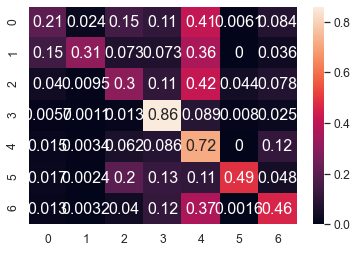

	training epoch=27 .. train_loss=1.054
	validation epoch=27 .. val_loss=1.243
	Accuracy = 54.300000000000004 % .. Percision = 56.89999999999999 % .. Recall = 47.699999999999996 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_27.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 28 .. loss = 1.05


  0%|                                                                                 | 1/1914 [00:01<47:05,  1.48s/it]

training @ epoch 28 .. loss = 0.844


  0%|                                                                                 | 2/1914 [00:02<46:50,  1.47s/it]

training @ epoch 28 .. loss = 1.221


  0%|▏                                                                                | 3/1914 [00:04<46:15,  1.45s/it]

training @ epoch 28 .. loss = 1.116


  0%|▏                                                                                | 4/1914 [00:05<46:07,  1.45s/it]

training @ epoch 28 .. loss = 0.781


  0%|▏                                                                                | 5/1914 [00:07<46:04,  1.45s/it]

training @ epoch 28 .. loss = 0.644


  0%|▎                                                                                | 6/1914 [00:08<45:44,  1.44s/it]

training @ epoch 28 .. loss = 1.653


  0%|▎                                                                                | 7/1914 [00:10<45:55,  1.44s/it]

training @ epoch 28 .. loss = 1.143


  0%|▎                                                                                | 8/1914 [00:11<45:41,  1.44s/it]

training @ epoch 28 .. loss = 1.089


  0%|▍                                                                                | 9/1914 [00:12<45:36,  1.44s/it]

training @ epoch 28 .. loss = 1.541


  1%|▍                                                                               | 10/1914 [00:14<45:41,  1.44s/it]

training @ epoch 28 .. loss = 1.591


  1%|▍                                                                               | 11/1914 [00:15<45:54,  1.45s/it]

training @ epoch 28 .. loss = 1.248


  1%|▌                                                                               | 12/1914 [00:17<45:37,  1.44s/it]

training @ epoch 28 .. loss = 1.452


  1%|▌                                                                               | 13/1914 [00:18<45:31,  1.44s/it]

training @ epoch 28 .. loss = 1.47


  1%|▌                                                                               | 14/1914 [00:20<44:38,  1.41s/it]

training @ epoch 28 .. loss = 0.614


  1%|▋                                                                               | 15/1914 [00:21<43:24,  1.37s/it]

training @ epoch 28 .. loss = 1.408


  1%|▋                                                                               | 16/1914 [00:22<42:33,  1.35s/it]

training @ epoch 28 .. loss = 0.711


  1%|▋                                                                               | 17/1914 [00:23<41:50,  1.32s/it]

training @ epoch 28 .. loss = 0.931


  1%|▊                                                                               | 18/1914 [00:25<40:58,  1.30s/it]

training @ epoch 28 .. loss = 1.187


  1%|▊                                                                               | 19/1914 [00:26<40:34,  1.28s/it]

training @ epoch 28 .. loss = 0.767


  1%|▊                                                                               | 20/1914 [00:27<40:45,  1.29s/it]

training @ epoch 28 .. loss = 0.76


  1%|▉                                                                               | 21/1914 [00:28<40:09,  1.27s/it]

training @ epoch 28 .. loss = 0.933


  1%|▉                                                                               | 22/1914 [00:30<39:57,  1.27s/it]

training @ epoch 28 .. loss = 1.2


  1%|▉                                                                               | 23/1914 [00:31<39:50,  1.26s/it]

training @ epoch 28 .. loss = 0.832


  1%|█                                                                               | 24/1914 [00:32<40:09,  1.27s/it]

training @ epoch 28 .. loss = 0.853


  1%|█                                                                               | 25/1914 [00:33<39:49,  1.26s/it]

training @ epoch 28 .. loss = 0.8


  1%|█                                                                               | 26/1914 [00:35<40:13,  1.28s/it]

training @ epoch 28 .. loss = 0.899


  1%|█▏                                                                              | 27/1914 [00:36<40:17,  1.28s/it]

training @ epoch 28 .. loss = 1.31


  1%|█▏                                                                              | 28/1914 [00:37<39:55,  1.27s/it]

training @ epoch 28 .. loss = 0.819


  2%|█▏                                                                              | 29/1914 [00:39<40:20,  1.28s/it]

training @ epoch 28 .. loss = 1.208


  2%|█▎                                                                              | 30/1914 [00:40<41:11,  1.31s/it]

training @ epoch 28 .. loss = 0.923


  2%|█▎                                                                              | 31/1914 [00:41<40:28,  1.29s/it]

training @ epoch 28 .. loss = 0.649


  2%|█▎                                                                              | 32/1914 [00:43<40:53,  1.30s/it]

training @ epoch 28 .. loss = 0.847


  2%|█▍                                                                              | 33/1914 [00:44<40:27,  1.29s/it]

training @ epoch 28 .. loss = 1.162


  2%|█▍                                                                              | 34/1914 [00:45<40:28,  1.29s/it]

training @ epoch 28 .. loss = 1.06


  2%|█▍                                                                              | 35/1914 [00:46<40:00,  1.28s/it]

training @ epoch 28 .. loss = 0.831


  2%|█▌                                                                              | 36/1914 [00:48<39:49,  1.27s/it]

training @ epoch 28 .. loss = 0.513


  2%|█▌                                                                              | 37/1914 [00:49<41:02,  1.31s/it]

training @ epoch 28 .. loss = 0.724


  2%|█▌                                                                              | 38/1914 [00:50<41:03,  1.31s/it]

training @ epoch 28 .. loss = 1.485


  2%|█▋                                                                              | 39/1914 [00:52<40:38,  1.30s/it]

training @ epoch 28 .. loss = 0.673


  2%|█▋                                                                              | 40/1914 [00:53<40:19,  1.29s/it]

training @ epoch 28 .. loss = 0.844


  2%|█▋                                                                              | 41/1914 [00:54<40:19,  1.29s/it]

training @ epoch 28 .. loss = 0.979


  2%|█▊                                                                              | 42/1914 [00:56<41:17,  1.32s/it]

training @ epoch 28 .. loss = 0.804


  2%|█▊                                                                              | 43/1914 [00:57<40:32,  1.30s/it]

training @ epoch 28 .. loss = 0.946


  2%|█▊                                                                              | 44/1914 [00:58<40:20,  1.29s/it]

training @ epoch 28 .. loss = 1.361


  2%|█▉                                                                              | 45/1914 [00:59<39:42,  1.27s/it]

training @ epoch 28 .. loss = 0.753


  2%|█▉                                                                              | 46/1914 [01:01<39:59,  1.28s/it]

training @ epoch 28 .. loss = 1.009


  2%|█▉                                                                              | 47/1914 [01:02<39:54,  1.28s/it]

training @ epoch 28 .. loss = 0.745


  3%|██                                                                              | 48/1914 [01:03<40:01,  1.29s/it]

training @ epoch 28 .. loss = 0.805


  3%|██                                                                              | 49/1914 [01:04<39:30,  1.27s/it]

training @ epoch 28 .. loss = 1.354


  3%|██                                                                              | 50/1914 [01:06<40:58,  1.32s/it]

training @ epoch 28 .. loss = 0.696


  3%|██▏                                                                             | 51/1914 [01:07<40:38,  1.31s/it]

training @ epoch 28 .. loss = 0.933


  3%|██▏                                                                             | 52/1914 [01:08<40:11,  1.30s/it]

training @ epoch 28 .. loss = 1.188


  3%|██▏                                                                             | 53/1914 [01:10<39:48,  1.28s/it]

training @ epoch 28 .. loss = 1.142


  3%|██▎                                                                             | 54/1914 [01:11<39:52,  1.29s/it]

training @ epoch 28 .. loss = 0.619


  3%|██▎                                                                             | 55/1914 [01:12<39:15,  1.27s/it]

training @ epoch 28 .. loss = 0.922


  3%|██▎                                                                             | 56/1914 [01:14<39:20,  1.27s/it]

training @ epoch 28 .. loss = 0.882


  3%|██▍                                                                             | 57/1914 [01:15<39:06,  1.26s/it]

training @ epoch 28 .. loss = 0.865


  3%|██▍                                                                             | 58/1914 [01:16<39:06,  1.26s/it]

training @ epoch 28 .. loss = 0.859


  3%|██▍                                                                             | 59/1914 [01:17<38:43,  1.25s/it]

training @ epoch 28 .. loss = 0.609


  3%|██▌                                                                             | 60/1914 [01:19<38:51,  1.26s/it]

training @ epoch 28 .. loss = 0.813


  3%|██▌                                                                             | 61/1914 [01:20<38:58,  1.26s/it]

training @ epoch 28 .. loss = 1.091


  3%|██▌                                                                             | 62/1914 [01:21<38:51,  1.26s/it]

training @ epoch 28 .. loss = 1.183


  3%|██▋                                                                             | 63/1914 [01:22<39:20,  1.27s/it]

training @ epoch 28 .. loss = 1.395


  3%|██▋                                                                             | 64/1914 [01:24<38:55,  1.26s/it]

training @ epoch 28 .. loss = 0.996


  3%|██▋                                                                             | 65/1914 [01:25<38:52,  1.26s/it]

training @ epoch 28 .. loss = 1.021


  3%|██▊                                                                             | 66/1914 [01:26<38:57,  1.26s/it]

training @ epoch 28 .. loss = 0.9


  4%|██▊                                                                             | 67/1914 [01:27<39:06,  1.27s/it]

training @ epoch 28 .. loss = 1.067


  4%|██▊                                                                             | 68/1914 [01:29<38:50,  1.26s/it]

training @ epoch 28 .. loss = 0.932


  4%|██▉                                                                             | 69/1914 [01:30<38:50,  1.26s/it]

training @ epoch 28 .. loss = 1.396


  4%|██▉                                                                             | 70/1914 [01:31<38:56,  1.27s/it]

training @ epoch 28 .. loss = 1.192


  4%|██▉                                                                             | 71/1914 [01:32<39:13,  1.28s/it]

training @ epoch 28 .. loss = 0.63


  4%|███                                                                             | 72/1914 [01:34<38:51,  1.27s/it]

training @ epoch 28 .. loss = 1.025


  4%|███                                                                             | 73/1914 [01:35<38:47,  1.26s/it]

training @ epoch 28 .. loss = 0.966


  4%|███                                                                             | 74/1914 [01:36<39:00,  1.27s/it]

training @ epoch 28 .. loss = 0.761


  4%|███▏                                                                            | 75/1914 [01:38<39:21,  1.28s/it]

training @ epoch 28 .. loss = 1.022


  4%|███▏                                                                            | 76/1914 [01:39<39:18,  1.28s/it]

training @ epoch 28 .. loss = 1.173


  4%|███▏                                                                            | 77/1914 [01:40<38:54,  1.27s/it]

training @ epoch 28 .. loss = 1.236


  4%|███▎                                                                            | 78/1914 [01:41<38:39,  1.26s/it]

training @ epoch 28 .. loss = 0.912


  4%|███▎                                                                            | 79/1914 [01:43<39:08,  1.28s/it]

training @ epoch 28 .. loss = 0.975


  4%|███▎                                                                            | 80/1914 [01:44<38:54,  1.27s/it]

training @ epoch 28 .. loss = 1.794


  4%|███▍                                                                            | 81/1914 [01:45<38:32,  1.26s/it]

training @ epoch 28 .. loss = 0.814


  4%|███▍                                                                            | 82/1914 [01:46<38:12,  1.25s/it]

training @ epoch 28 .. loss = 1.586


  4%|███▍                                                                            | 83/1914 [01:48<38:18,  1.26s/it]

training @ epoch 28 .. loss = 0.862


  4%|███▌                                                                            | 84/1914 [01:49<37:57,  1.24s/it]

training @ epoch 28 .. loss = 0.866


  4%|███▌                                                                            | 85/1914 [01:50<37:43,  1.24s/it]

training @ epoch 28 .. loss = 1.073


  4%|███▌                                                                            | 86/1914 [01:51<37:47,  1.24s/it]

training @ epoch 28 .. loss = 1.764


  5%|███▋                                                                            | 87/1914 [01:53<38:22,  1.26s/it]

training @ epoch 28 .. loss = 0.853


  5%|███▋                                                                            | 88/1914 [01:54<38:27,  1.26s/it]

training @ epoch 28 .. loss = 0.769


  5%|███▋                                                                            | 89/1914 [01:55<38:52,  1.28s/it]

training @ epoch 28 .. loss = 0.738


  5%|███▊                                                                            | 90/1914 [01:57<39:11,  1.29s/it]

training @ epoch 28 .. loss = 0.685


  5%|███▊                                                                            | 91/1914 [01:58<39:40,  1.31s/it]

training @ epoch 28 .. loss = 1.433


  5%|███▊                                                                            | 92/1914 [01:59<40:07,  1.32s/it]

training @ epoch 28 .. loss = 1.146


  5%|███▉                                                                            | 93/1914 [02:00<38:54,  1.28s/it]

training @ epoch 28 .. loss = 0.725


  5%|███▉                                                                            | 94/1914 [02:02<37:19,  1.23s/it]

training @ epoch 28 .. loss = 1.175


  5%|███▉                                                                            | 95/1914 [02:03<35:56,  1.19s/it]

training @ epoch 28 .. loss = 0.905


  5%|████                                                                            | 96/1914 [02:04<34:46,  1.15s/it]

training @ epoch 28 .. loss = 0.937


  5%|████                                                                            | 97/1914 [02:05<34:57,  1.15s/it]

training @ epoch 28 .. loss = 0.834


  5%|████                                                                            | 98/1914 [02:06<34:32,  1.14s/it]

training @ epoch 28 .. loss = 1.264


  5%|████▏                                                                           | 99/1914 [02:07<34:22,  1.14s/it]

training @ epoch 28 .. loss = 0.73


  5%|████▏                                                                          | 100/1914 [02:08<33:50,  1.12s/it]

training @ epoch 28 .. loss = 1.52


  5%|████▏                                                                          | 101/1914 [02:09<34:36,  1.15s/it]

training @ epoch 28 .. loss = 0.901


  5%|████▏                                                                          | 102/1914 [02:10<34:04,  1.13s/it]

training @ epoch 28 .. loss = 0.922


  5%|████▎                                                                          | 103/1914 [02:12<33:45,  1.12s/it]

training @ epoch 28 .. loss = 0.973


  5%|████▎                                                                          | 104/1914 [02:13<33:28,  1.11s/it]

training @ epoch 28 .. loss = 1.021


  5%|████▎                                                                          | 105/1914 [02:14<34:03,  1.13s/it]

training @ epoch 28 .. loss = 1.075


  6%|████▍                                                                          | 106/1914 [02:15<33:48,  1.12s/it]

training @ epoch 28 .. loss = 0.888


  6%|████▍                                                                          | 107/1914 [02:16<33:22,  1.11s/it]

training @ epoch 28 .. loss = 0.956


  6%|████▍                                                                          | 108/1914 [02:17<33:16,  1.11s/it]

training @ epoch 28 .. loss = 0.931


  6%|████▍                                                                          | 109/1914 [02:18<33:28,  1.11s/it]

training @ epoch 28 .. loss = 1.036


  6%|████▌                                                                          | 110/1914 [02:19<33:31,  1.12s/it]

training @ epoch 28 .. loss = 0.73


  6%|████▌                                                                          | 111/1914 [02:20<33:38,  1.12s/it]

training @ epoch 28 .. loss = 1.191


  6%|████▌                                                                          | 112/1914 [02:22<34:01,  1.13s/it]

training @ epoch 28 .. loss = 1.081


  6%|████▋                                                                          | 113/1914 [02:23<36:36,  1.22s/it]

training @ epoch 28 .. loss = 1.202


  6%|████▋                                                                          | 114/1914 [02:24<36:51,  1.23s/it]

training @ epoch 28 .. loss = 0.918


  6%|████▋                                                                          | 115/1914 [02:26<38:06,  1.27s/it]

training @ epoch 28 .. loss = 0.573


  6%|████▊                                                                          | 116/1914 [02:27<36:57,  1.23s/it]

training @ epoch 28 .. loss = 1.08


  6%|████▊                                                                          | 117/1914 [02:28<37:47,  1.26s/it]

training @ epoch 28 .. loss = 1.16


  6%|████▊                                                                          | 118/1914 [02:29<36:30,  1.22s/it]

training @ epoch 28 .. loss = 0.387


  6%|████▉                                                                          | 119/1914 [02:30<36:13,  1.21s/it]

training @ epoch 28 .. loss = 0.84


  6%|████▉                                                                          | 120/1914 [02:32<35:15,  1.18s/it]

training @ epoch 28 .. loss = 0.973


  6%|████▉                                                                          | 121/1914 [02:33<35:33,  1.19s/it]

training @ epoch 28 .. loss = 1.291


  6%|█████                                                                          | 122/1914 [02:34<34:57,  1.17s/it]

training @ epoch 28 .. loss = 0.749


  6%|█████                                                                          | 123/1914 [02:35<34:10,  1.14s/it]

training @ epoch 28 .. loss = 1.083


  6%|█████                                                                          | 124/1914 [02:36<34:01,  1.14s/it]

training @ epoch 28 .. loss = 0.862


  7%|█████▏                                                                         | 125/1914 [02:37<33:43,  1.13s/it]

training @ epoch 28 .. loss = 1.237


  7%|█████▏                                                                         | 126/1914 [02:38<34:17,  1.15s/it]

training @ epoch 28 .. loss = 1.163


  7%|█████▏                                                                         | 127/1914 [02:40<33:40,  1.13s/it]

training @ epoch 28 .. loss = 0.668


  7%|█████▎                                                                         | 128/1914 [02:41<33:22,  1.12s/it]

training @ epoch 28 .. loss = 1.15


  7%|█████▎                                                                         | 129/1914 [02:42<32:48,  1.10s/it]

training @ epoch 28 .. loss = 1.164


  7%|█████▎                                                                         | 130/1914 [02:43<33:12,  1.12s/it]

training @ epoch 28 .. loss = 1.043


  7%|█████▍                                                                         | 131/1914 [02:44<33:18,  1.12s/it]

training @ epoch 28 .. loss = 1.331


  7%|█████▍                                                                         | 132/1914 [02:45<33:14,  1.12s/it]

training @ epoch 28 .. loss = 0.802


  7%|█████▍                                                                         | 133/1914 [02:46<32:57,  1.11s/it]

training @ epoch 28 .. loss = 1.033


  7%|█████▌                                                                         | 134/1914 [02:47<32:56,  1.11s/it]

training @ epoch 28 .. loss = 0.84


  7%|█████▌                                                                         | 135/1914 [02:48<33:11,  1.12s/it]

training @ epoch 28 .. loss = 0.886


  7%|█████▌                                                                         | 136/1914 [02:50<32:46,  1.11s/it]

training @ epoch 28 .. loss = 1.396


  7%|█████▋                                                                         | 137/1914 [02:51<32:52,  1.11s/it]

training @ epoch 28 .. loss = 0.848


  7%|█████▋                                                                         | 138/1914 [02:52<32:54,  1.11s/it]

training @ epoch 28 .. loss = 0.974


  7%|█████▋                                                                         | 139/1914 [02:53<33:16,  1.12s/it]

training @ epoch 28 .. loss = 1.108


  7%|█████▊                                                                         | 140/1914 [02:54<33:12,  1.12s/it]

training @ epoch 28 .. loss = 0.954


  7%|█████▊                                                                         | 141/1914 [02:55<32:59,  1.12s/it]

training @ epoch 28 .. loss = 1.203


  7%|█████▊                                                                         | 142/1914 [02:56<32:44,  1.11s/it]

training @ epoch 28 .. loss = 0.607


  7%|█████▉                                                                         | 143/1914 [02:57<33:10,  1.12s/it]

training @ epoch 28 .. loss = 0.986


  8%|█████▉                                                                         | 144/1914 [02:58<32:40,  1.11s/it]

training @ epoch 28 .. loss = 0.913


  8%|█████▉                                                                         | 145/1914 [03:00<32:24,  1.10s/it]

training @ epoch 28 .. loss = 1.136


  8%|██████                                                                         | 146/1914 [03:01<32:24,  1.10s/it]

training @ epoch 28 .. loss = 0.988


  8%|██████                                                                         | 147/1914 [03:02<32:17,  1.10s/it]

training @ epoch 28 .. loss = 0.576


  8%|██████                                                                         | 148/1914 [03:03<32:18,  1.10s/it]

training @ epoch 28 .. loss = 1.096


  8%|██████▏                                                                        | 149/1914 [03:04<32:39,  1.11s/it]

training @ epoch 28 .. loss = 0.827


  8%|██████▏                                                                        | 150/1914 [03:05<32:22,  1.10s/it]

training @ epoch 28 .. loss = 1.468


  8%|██████▏                                                                        | 151/1914 [03:06<32:15,  1.10s/it]

training @ epoch 28 .. loss = 0.919


  8%|██████▎                                                                        | 152/1914 [03:07<32:07,  1.09s/it]

training @ epoch 28 .. loss = 0.769


  8%|██████▎                                                                        | 153/1914 [03:08<32:54,  1.12s/it]

training @ epoch 28 .. loss = 1.469


  8%|██████▎                                                                        | 154/1914 [03:10<33:50,  1.15s/it]

training @ epoch 28 .. loss = 0.761


  8%|██████▍                                                                        | 155/1914 [03:11<34:50,  1.19s/it]

training @ epoch 28 .. loss = 0.909


  8%|██████▍                                                                        | 156/1914 [03:12<33:57,  1.16s/it]

training @ epoch 28 .. loss = 1.066


  8%|██████▍                                                                        | 157/1914 [03:13<33:30,  1.14s/it]

training @ epoch 28 .. loss = 0.915


  8%|██████▌                                                                        | 158/1914 [03:14<32:50,  1.12s/it]

training @ epoch 28 .. loss = 0.728


  8%|██████▌                                                                        | 159/1914 [03:15<32:42,  1.12s/it]

training @ epoch 28 .. loss = 1.092


  8%|██████▌                                                                        | 160/1914 [03:16<32:42,  1.12s/it]

training @ epoch 28 .. loss = 1.268


  8%|██████▋                                                                        | 161/1914 [03:18<32:47,  1.12s/it]

training @ epoch 28 .. loss = 0.804


  8%|██████▋                                                                        | 162/1914 [03:19<32:34,  1.12s/it]

training @ epoch 28 .. loss = 1.291


  9%|██████▋                                                                        | 163/1914 [03:20<32:25,  1.11s/it]

training @ epoch 28 .. loss = 0.82


  9%|██████▊                                                                        | 164/1914 [03:21<32:49,  1.13s/it]

training @ epoch 28 .. loss = 0.9


  9%|██████▊                                                                        | 165/1914 [03:22<32:57,  1.13s/it]

training @ epoch 28 .. loss = 0.882


  9%|██████▊                                                                        | 166/1914 [03:23<32:48,  1.13s/it]

training @ epoch 28 .. loss = 0.733


  9%|██████▉                                                                        | 167/1914 [03:24<32:24,  1.11s/it]

training @ epoch 28 .. loss = 1.278


  9%|██████▉                                                                        | 168/1914 [03:25<32:29,  1.12s/it]

training @ epoch 28 .. loss = 1.136


  9%|██████▉                                                                        | 169/1914 [03:26<32:06,  1.10s/it]

training @ epoch 28 .. loss = 0.942


  9%|███████                                                                        | 170/1914 [03:28<32:16,  1.11s/it]

training @ epoch 28 .. loss = 1.138


  9%|███████                                                                        | 171/1914 [03:29<32:07,  1.11s/it]

training @ epoch 28 .. loss = 1.383


  9%|███████                                                                        | 172/1914 [03:30<31:57,  1.10s/it]

training @ epoch 28 .. loss = 1.122


  9%|███████▏                                                                       | 173/1914 [03:31<31:40,  1.09s/it]

training @ epoch 28 .. loss = 1.089


  9%|███████▏                                                                       | 174/1914 [03:32<31:49,  1.10s/it]

training @ epoch 28 .. loss = 1.355


  9%|███████▏                                                                       | 175/1914 [03:33<31:38,  1.09s/it]

training @ epoch 28 .. loss = 0.925


  9%|███████▎                                                                       | 176/1914 [03:34<31:42,  1.09s/it]

training @ epoch 28 .. loss = 1.604


  9%|███████▎                                                                       | 177/1914 [03:35<31:25,  1.09s/it]

training @ epoch 28 .. loss = 1.016


  9%|███████▎                                                                       | 178/1914 [03:36<31:45,  1.10s/it]

training @ epoch 28 .. loss = 1.528


  9%|███████▍                                                                       | 179/1914 [03:37<32:21,  1.12s/it]

training @ epoch 28 .. loss = 1.004


  9%|███████▍                                                                       | 180/1914 [03:39<31:54,  1.10s/it]

training @ epoch 28 .. loss = 1.67


  9%|███████▍                                                                       | 181/1914 [03:40<31:30,  1.09s/it]

training @ epoch 28 .. loss = 0.965


 10%|███████▌                                                                       | 182/1914 [03:41<31:31,  1.09s/it]

training @ epoch 28 .. loss = 1.33


 10%|███████▌                                                                       | 183/1914 [03:42<31:27,  1.09s/it]

training @ epoch 28 .. loss = 1.028


 10%|███████▌                                                                       | 184/1914 [03:43<31:36,  1.10s/it]

training @ epoch 28 .. loss = 1.109


 10%|███████▋                                                                       | 185/1914 [03:44<32:42,  1.14s/it]

training @ epoch 28 .. loss = 0.962


 10%|███████▋                                                                       | 186/1914 [03:45<32:04,  1.11s/it]

training @ epoch 28 .. loss = 0.721


 10%|███████▋                                                                       | 187/1914 [03:46<31:56,  1.11s/it]

training @ epoch 28 .. loss = 1.125


 10%|███████▊                                                                       | 188/1914 [03:47<31:39,  1.10s/it]

training @ epoch 28 .. loss = 1.038


 10%|███████▊                                                                       | 189/1914 [03:49<32:19,  1.12s/it]

training @ epoch 28 .. loss = 1.134


 10%|███████▊                                                                       | 190/1914 [03:50<32:19,  1.12s/it]

training @ epoch 28 .. loss = 1.104


 10%|███████▉                                                                       | 191/1914 [03:51<31:57,  1.11s/it]

training @ epoch 28 .. loss = 1.392


 10%|███████▉                                                                       | 192/1914 [03:52<31:49,  1.11s/it]

training @ epoch 28 .. loss = 0.927


 10%|███████▉                                                                       | 193/1914 [03:53<31:36,  1.10s/it]

training @ epoch 28 .. loss = 0.596


 10%|████████                                                                       | 194/1914 [03:54<31:15,  1.09s/it]

training @ epoch 28 .. loss = 0.952


 10%|████████                                                                       | 195/1914 [03:55<31:09,  1.09s/it]

training @ epoch 28 .. loss = 1.041


 10%|████████                                                                       | 196/1914 [03:56<31:14,  1.09s/it]

training @ epoch 28 .. loss = 1.22


 10%|████████▏                                                                      | 197/1914 [03:57<31:15,  1.09s/it]

training @ epoch 28 .. loss = 0.964


 10%|████████▏                                                                      | 198/1914 [03:58<31:05,  1.09s/it]

training @ epoch 28 .. loss = 0.903


 10%|████████▏                                                                      | 199/1914 [03:59<31:10,  1.09s/it]

training @ epoch 28 .. loss = 1.395


 10%|████████▎                                                                      | 200/1914 [04:01<31:15,  1.09s/it]

training @ epoch 28 .. loss = 1.573


 11%|████████▎                                                                      | 201/1914 [04:02<31:06,  1.09s/it]

training @ epoch 28 .. loss = 0.89


 11%|████████▎                                                                      | 202/1914 [04:03<31:10,  1.09s/it]

training @ epoch 28 .. loss = 1.147


 11%|████████▍                                                                      | 203/1914 [04:04<31:18,  1.10s/it]

training @ epoch 28 .. loss = 0.998


 11%|████████▍                                                                      | 204/1914 [04:05<31:18,  1.10s/it]

training @ epoch 28 .. loss = 1.164


 11%|████████▍                                                                      | 205/1914 [04:06<31:18,  1.10s/it]

training @ epoch 28 .. loss = 1.093


 11%|████████▌                                                                      | 206/1914 [04:07<31:18,  1.10s/it]

training @ epoch 28 .. loss = 1.187


 11%|████████▌                                                                      | 207/1914 [04:08<31:01,  1.09s/it]

training @ epoch 28 .. loss = 1.938


 11%|████████▌                                                                      | 208/1914 [04:09<30:49,  1.08s/it]

training @ epoch 28 .. loss = 0.961


 11%|████████▋                                                                      | 209/1914 [04:10<30:46,  1.08s/it]

training @ epoch 28 .. loss = 1.141


 11%|████████▋                                                                      | 210/1914 [04:11<30:43,  1.08s/it]

training @ epoch 28 .. loss = 1.015


 11%|████████▋                                                                      | 211/1914 [04:12<30:43,  1.08s/it]

training @ epoch 28 .. loss = 1.023


 11%|████████▊                                                                      | 212/1914 [04:14<30:34,  1.08s/it]

training @ epoch 28 .. loss = 0.759


 11%|████████▊                                                                      | 213/1914 [04:15<30:24,  1.07s/it]

training @ epoch 28 .. loss = 0.894


 11%|████████▊                                                                      | 214/1914 [04:16<30:34,  1.08s/it]

training @ epoch 28 .. loss = 0.957


 11%|████████▊                                                                      | 215/1914 [04:17<31:07,  1.10s/it]

training @ epoch 28 .. loss = 0.999


 11%|████████▉                                                                      | 216/1914 [04:18<31:11,  1.10s/it]

training @ epoch 28 .. loss = 1.137


 11%|████████▉                                                                      | 217/1914 [04:19<30:54,  1.09s/it]

training @ epoch 28 .. loss = 1.34


 11%|████████▉                                                                      | 218/1914 [04:20<31:17,  1.11s/it]

training @ epoch 28 .. loss = 0.677


 11%|█████████                                                                      | 219/1914 [04:21<30:57,  1.10s/it]

training @ epoch 28 .. loss = 1.054


 11%|█████████                                                                      | 220/1914 [04:22<31:05,  1.10s/it]

training @ epoch 28 .. loss = 0.884


 12%|█████████                                                                      | 221/1914 [04:23<31:11,  1.11s/it]

training @ epoch 28 .. loss = 0.615


 12%|█████████▏                                                                     | 222/1914 [04:25<30:42,  1.09s/it]

training @ epoch 28 .. loss = 1.041


 12%|█████████▏                                                                     | 223/1914 [04:26<30:52,  1.10s/it]

training @ epoch 28 .. loss = 1.18


 12%|█████████▏                                                                     | 224/1914 [04:27<30:37,  1.09s/it]

training @ epoch 28 .. loss = 1.135


 12%|█████████▎                                                                     | 225/1914 [04:28<30:27,  1.08s/it]

training @ epoch 28 .. loss = 0.995


 12%|█████████▎                                                                     | 226/1914 [04:29<30:38,  1.09s/it]

training @ epoch 28 .. loss = 0.763


 12%|█████████▎                                                                     | 227/1914 [04:30<30:45,  1.09s/it]

training @ epoch 28 .. loss = 0.951


 12%|█████████▍                                                                     | 228/1914 [04:31<30:42,  1.09s/it]

training @ epoch 28 .. loss = 1.158


 12%|█████████▍                                                                     | 229/1914 [04:32<30:39,  1.09s/it]

training @ epoch 28 .. loss = 0.946


 12%|█████████▍                                                                     | 230/1914 [04:33<30:32,  1.09s/it]

training @ epoch 28 .. loss = 1.029


 12%|█████████▌                                                                     | 231/1914 [04:34<31:02,  1.11s/it]

training @ epoch 28 .. loss = 0.923


 12%|█████████▌                                                                     | 232/1914 [04:36<31:58,  1.14s/it]

training @ epoch 28 .. loss = 1.004


 12%|█████████▌                                                                     | 233/1914 [04:37<32:57,  1.18s/it]

training @ epoch 28 .. loss = 0.787


 12%|█████████▋                                                                     | 234/1914 [04:38<35:13,  1.26s/it]

training @ epoch 28 .. loss = 1.258


 12%|█████████▋                                                                     | 235/1914 [04:40<35:50,  1.28s/it]

training @ epoch 28 .. loss = 1.163


 12%|█████████▋                                                                     | 236/1914 [04:41<36:10,  1.29s/it]

training @ epoch 28 .. loss = 0.86


 12%|█████████▊                                                                     | 237/1914 [04:42<35:04,  1.25s/it]

training @ epoch 28 .. loss = 0.893


 12%|█████████▊                                                                     | 238/1914 [04:43<33:45,  1.21s/it]

training @ epoch 28 .. loss = 1.329


 12%|█████████▊                                                                     | 239/1914 [04:44<32:59,  1.18s/it]

training @ epoch 28 .. loss = 0.936


 13%|█████████▉                                                                     | 240/1914 [04:45<32:07,  1.15s/it]

training @ epoch 28 .. loss = 0.556


 13%|█████████▉                                                                     | 241/1914 [04:47<31:50,  1.14s/it]

training @ epoch 28 .. loss = 0.92


 13%|█████████▉                                                                     | 242/1914 [04:48<31:18,  1.12s/it]

training @ epoch 28 .. loss = 1.045


 13%|██████████                                                                     | 243/1914 [04:49<31:20,  1.13s/it]

training @ epoch 28 .. loss = 1.085


 13%|██████████                                                                     | 244/1914 [04:50<31:51,  1.14s/it]

training @ epoch 28 .. loss = 0.894


 13%|██████████                                                                     | 245/1914 [04:51<31:48,  1.14s/it]

training @ epoch 28 .. loss = 1.218


 13%|██████████▏                                                                    | 246/1914 [04:52<31:00,  1.12s/it]

training @ epoch 28 .. loss = 1.125


 13%|██████████▏                                                                    | 247/1914 [04:53<30:56,  1.11s/it]

training @ epoch 28 .. loss = 0.946


 13%|██████████▏                                                                    | 248/1914 [04:54<31:06,  1.12s/it]

training @ epoch 28 .. loss = 1.665


 13%|██████████▎                                                                    | 249/1914 [04:56<30:54,  1.11s/it]

training @ epoch 28 .. loss = 0.8


 13%|██████████▎                                                                    | 250/1914 [04:57<30:44,  1.11s/it]

training @ epoch 28 .. loss = 1.128


 13%|██████████▎                                                                    | 251/1914 [04:58<30:44,  1.11s/it]

training @ epoch 28 .. loss = 1.054


 13%|██████████▍                                                                    | 252/1914 [04:59<30:36,  1.10s/it]

training @ epoch 28 .. loss = 0.576


 13%|██████████▍                                                                    | 253/1914 [05:00<30:35,  1.10s/it]

training @ epoch 28 .. loss = 0.771


 13%|██████████▍                                                                    | 254/1914 [05:01<30:46,  1.11s/it]

training @ epoch 28 .. loss = 0.792


 13%|██████████▌                                                                    | 255/1914 [05:02<30:51,  1.12s/it]

training @ epoch 28 .. loss = 0.984


 13%|██████████▌                                                                    | 256/1914 [05:03<30:40,  1.11s/it]

training @ epoch 28 .. loss = 0.602


 13%|██████████▌                                                                    | 257/1914 [05:04<30:29,  1.10s/it]

training @ epoch 28 .. loss = 1.827


 13%|██████████▋                                                                    | 258/1914 [05:05<30:36,  1.11s/it]

training @ epoch 28 .. loss = 1.337


 14%|██████████▋                                                                    | 259/1914 [05:07<30:25,  1.10s/it]

training @ epoch 28 .. loss = 0.804


 14%|██████████▋                                                                    | 260/1914 [05:08<30:13,  1.10s/it]

training @ epoch 28 .. loss = 0.866


 14%|██████████▊                                                                    | 261/1914 [05:09<30:18,  1.10s/it]

training @ epoch 28 .. loss = 1.181


 14%|██████████▊                                                                    | 262/1914 [05:10<30:17,  1.10s/it]

training @ epoch 28 .. loss = 0.952


 14%|██████████▊                                                                    | 263/1914 [05:11<30:21,  1.10s/it]

training @ epoch 28 .. loss = 1.069


 14%|██████████▉                                                                    | 264/1914 [05:12<30:33,  1.11s/it]

training @ epoch 28 .. loss = 0.853


 14%|██████████▉                                                                    | 265/1914 [05:13<30:36,  1.11s/it]

training @ epoch 28 .. loss = 1.378


 14%|██████████▉                                                                    | 266/1914 [05:14<30:43,  1.12s/it]

training @ epoch 28 .. loss = 1.186


 14%|███████████                                                                    | 267/1914 [05:15<30:33,  1.11s/it]

training @ epoch 28 .. loss = 0.847


 14%|███████████                                                                    | 268/1914 [05:17<30:47,  1.12s/it]

training @ epoch 28 .. loss = 1.095


 14%|███████████                                                                    | 269/1914 [05:18<30:33,  1.11s/it]

training @ epoch 28 .. loss = 1.063


 14%|███████████▏                                                                   | 270/1914 [05:19<30:15,  1.10s/it]

training @ epoch 28 .. loss = 1.3


 14%|███████████▏                                                                   | 271/1914 [05:20<30:17,  1.11s/it]

training @ epoch 28 .. loss = 1.067


 14%|███████████▏                                                                   | 272/1914 [05:21<29:58,  1.10s/it]

training @ epoch 28 .. loss = 0.689


 14%|███████████▎                                                                   | 273/1914 [05:22<29:59,  1.10s/it]

training @ epoch 28 .. loss = 0.811


 14%|███████████▎                                                                   | 274/1914 [05:23<30:14,  1.11s/it]

training @ epoch 28 .. loss = 1.194


 14%|███████████▎                                                                   | 275/1914 [05:24<29:45,  1.09s/it]

training @ epoch 28 .. loss = 1.135


 14%|███████████▍                                                                   | 276/1914 [05:25<30:09,  1.10s/it]

training @ epoch 28 .. loss = 0.985


 14%|███████████▍                                                                   | 277/1914 [05:26<30:20,  1.11s/it]

training @ epoch 28 .. loss = 1.412


 15%|███████████▍                                                                   | 278/1914 [05:28<30:18,  1.11s/it]

training @ epoch 28 .. loss = 1.429


 15%|███████████▌                                                                   | 279/1914 [05:29<29:52,  1.10s/it]

training @ epoch 28 .. loss = 1.086


 15%|███████████▌                                                                   | 280/1914 [05:30<29:38,  1.09s/it]

training @ epoch 28 .. loss = 0.704


 15%|███████████▌                                                                   | 281/1914 [05:31<29:33,  1.09s/it]

training @ epoch 28 .. loss = 1.53


 15%|███████████▋                                                                   | 282/1914 [05:32<29:39,  1.09s/it]

training @ epoch 28 .. loss = 1.058


 15%|███████████▋                                                                   | 283/1914 [05:33<29:42,  1.09s/it]

training @ epoch 28 .. loss = 1.293


 15%|███████████▋                                                                   | 284/1914 [05:34<29:44,  1.10s/it]

training @ epoch 28 .. loss = 1.133


 15%|███████████▊                                                                   | 285/1914 [05:35<29:31,  1.09s/it]

training @ epoch 28 .. loss = 1.03


 15%|███████████▊                                                                   | 286/1914 [05:36<29:36,  1.09s/it]

training @ epoch 28 .. loss = 1.297


 15%|███████████▊                                                                   | 287/1914 [05:37<29:37,  1.09s/it]

training @ epoch 28 .. loss = 1.044


 15%|███████████▉                                                                   | 288/1914 [05:38<29:44,  1.10s/it]

training @ epoch 28 .. loss = 1.09


 15%|███████████▉                                                                   | 289/1914 [05:40<31:00,  1.14s/it]

training @ epoch 28 .. loss = 1.61


 15%|███████████▉                                                                   | 290/1914 [05:41<30:32,  1.13s/it]

training @ epoch 28 .. loss = 0.876


 15%|████████████                                                                   | 291/1914 [05:42<30:27,  1.13s/it]

training @ epoch 28 .. loss = 1.625


 15%|████████████                                                                   | 292/1914 [05:43<29:54,  1.11s/it]

training @ epoch 28 .. loss = 0.925


 15%|████████████                                                                   | 293/1914 [05:44<30:04,  1.11s/it]

training @ epoch 28 .. loss = 0.905


 15%|████████████▏                                                                  | 294/1914 [05:45<29:37,  1.10s/it]

training @ epoch 28 .. loss = 0.881


 15%|████████████▏                                                                  | 295/1914 [05:46<29:47,  1.10s/it]

training @ epoch 28 .. loss = 1.108


 15%|████████████▏                                                                  | 296/1914 [05:47<29:25,  1.09s/it]

training @ epoch 28 .. loss = 1.247


 16%|████████████▎                                                                  | 297/1914 [05:48<29:21,  1.09s/it]

training @ epoch 28 .. loss = 0.702


 16%|████████████▎                                                                  | 298/1914 [05:50<29:39,  1.10s/it]

training @ epoch 28 .. loss = 1.114


 16%|████████████▎                                                                  | 299/1914 [05:51<29:50,  1.11s/it]

training @ epoch 28 .. loss = 1.089


 16%|████████████▍                                                                  | 300/1914 [05:52<30:16,  1.13s/it]

training @ epoch 28 .. loss = 0.85


 16%|████████████▍                                                                  | 301/1914 [05:53<30:02,  1.12s/it]

training @ epoch 28 .. loss = 1.278


 16%|████████████▍                                                                  | 302/1914 [05:54<30:24,  1.13s/it]

training @ epoch 28 .. loss = 1.094


 16%|████████████▌                                                                  | 303/1914 [05:55<31:01,  1.16s/it]

training @ epoch 28 .. loss = 0.904


 16%|████████████▌                                                                  | 304/1914 [05:56<30:23,  1.13s/it]

training @ epoch 28 .. loss = 0.877


 16%|████████████▌                                                                  | 305/1914 [05:58<30:11,  1.13s/it]

training @ epoch 28 .. loss = 1.167


 16%|████████████▋                                                                  | 306/1914 [05:59<30:17,  1.13s/it]

training @ epoch 28 .. loss = 0.911


 16%|████████████▋                                                                  | 307/1914 [06:00<30:43,  1.15s/it]

training @ epoch 28 .. loss = 0.614


 16%|████████████▋                                                                  | 308/1914 [06:01<30:30,  1.14s/it]

training @ epoch 28 .. loss = 0.816


 16%|████████████▊                                                                  | 309/1914 [06:02<30:16,  1.13s/it]

training @ epoch 28 .. loss = 0.816


 16%|████████████▊                                                                  | 310/1914 [06:03<29:49,  1.12s/it]

training @ epoch 28 .. loss = 1.01


 16%|████████████▊                                                                  | 311/1914 [06:04<30:09,  1.13s/it]

training @ epoch 28 .. loss = 0.816


 16%|████████████▉                                                                  | 312/1914 [06:05<29:54,  1.12s/it]

training @ epoch 28 .. loss = 1.307


 16%|████████████▉                                                                  | 313/1914 [06:07<29:29,  1.11s/it]

training @ epoch 28 .. loss = 0.952


 16%|████████████▉                                                                  | 314/1914 [06:08<29:25,  1.10s/it]

training @ epoch 28 .. loss = 0.878


 16%|█████████████                                                                  | 315/1914 [06:09<29:58,  1.13s/it]

training @ epoch 28 .. loss = 0.931


 17%|█████████████                                                                  | 316/1914 [06:10<30:00,  1.13s/it]

training @ epoch 28 .. loss = 0.856


 17%|█████████████                                                                  | 317/1914 [06:11<29:48,  1.12s/it]

training @ epoch 28 .. loss = 0.913


 17%|█████████████▏                                                                 | 318/1914 [06:12<29:28,  1.11s/it]

training @ epoch 28 .. loss = 0.896


 17%|█████████████▏                                                                 | 319/1914 [06:13<29:47,  1.12s/it]

training @ epoch 28 .. loss = 1.495


 17%|█████████████▏                                                                 | 320/1914 [06:14<29:36,  1.11s/it]

training @ epoch 28 .. loss = 0.909


 17%|█████████████▏                                                                 | 321/1914 [06:15<29:20,  1.11s/it]

training @ epoch 28 .. loss = 0.717


 17%|█████████████▎                                                                 | 322/1914 [06:17<29:15,  1.10s/it]

training @ epoch 28 .. loss = 1.377


 17%|█████████████▎                                                                 | 323/1914 [06:18<29:03,  1.10s/it]

training @ epoch 28 .. loss = 1.448


 17%|█████████████▎                                                                 | 324/1914 [06:19<29:47,  1.12s/it]

training @ epoch 28 .. loss = 1.01


 17%|█████████████▍                                                                 | 325/1914 [06:20<29:44,  1.12s/it]

training @ epoch 28 .. loss = 1.029


 17%|█████████████▍                                                                 | 326/1914 [06:21<29:17,  1.11s/it]

training @ epoch 28 .. loss = 1.061


 17%|█████████████▍                                                                 | 327/1914 [06:22<28:59,  1.10s/it]

training @ epoch 28 .. loss = 0.827


 17%|█████████████▌                                                                 | 328/1914 [06:23<30:17,  1.15s/it]

training @ epoch 28 .. loss = 0.813


 17%|█████████████▌                                                                 | 329/1914 [06:25<31:35,  1.20s/it]

training @ epoch 28 .. loss = 1.257


 17%|█████████████▌                                                                 | 330/1914 [06:26<32:21,  1.23s/it]

training @ epoch 28 .. loss = 1.338


 17%|█████████████▋                                                                 | 331/1914 [06:27<32:42,  1.24s/it]

training @ epoch 28 .. loss = 0.688


 17%|█████████████▋                                                                 | 332/1914 [06:28<32:59,  1.25s/it]

training @ epoch 28 .. loss = 0.908


 17%|█████████████▋                                                                 | 333/1914 [06:30<33:04,  1.26s/it]

training @ epoch 28 .. loss = 1.098


 17%|█████████████▊                                                                 | 334/1914 [06:31<33:03,  1.26s/it]

training @ epoch 28 .. loss = 1.067


 18%|█████████████▊                                                                 | 335/1914 [06:32<32:59,  1.25s/it]

training @ epoch 28 .. loss = 0.805


 18%|█████████████▊                                                                 | 336/1914 [06:34<33:16,  1.27s/it]

training @ epoch 28 .. loss = 0.661


 18%|█████████████▉                                                                 | 337/1914 [06:35<33:28,  1.27s/it]

training @ epoch 28 .. loss = 1.165


 18%|█████████████▉                                                                 | 338/1914 [06:36<33:03,  1.26s/it]

training @ epoch 28 .. loss = 0.417


 18%|█████████████▉                                                                 | 339/1914 [06:37<31:59,  1.22s/it]

training @ epoch 28 .. loss = 1.449


 18%|██████████████                                                                 | 340/1914 [06:38<31:18,  1.19s/it]

training @ epoch 28 .. loss = 1.027


 18%|██████████████                                                                 | 341/1914 [06:39<31:01,  1.18s/it]

training @ epoch 28 .. loss = 0.979


 18%|██████████████                                                                 | 342/1914 [06:41<30:06,  1.15s/it]

training @ epoch 28 .. loss = 0.618


 18%|██████████████▏                                                                | 343/1914 [06:42<29:37,  1.13s/it]

training @ epoch 28 .. loss = 0.773


 18%|██████████████▏                                                                | 344/1914 [06:43<29:47,  1.14s/it]

training @ epoch 28 .. loss = 0.983


 18%|██████████████▏                                                                | 345/1914 [06:44<29:23,  1.12s/it]

training @ epoch 28 .. loss = 0.91


 18%|██████████████▎                                                                | 346/1914 [06:45<29:13,  1.12s/it]

training @ epoch 28 .. loss = 0.672


 18%|██████████████▎                                                                | 347/1914 [06:46<29:07,  1.11s/it]

training @ epoch 28 .. loss = 1.236


 18%|██████████████▎                                                                | 348/1914 [06:47<28:55,  1.11s/it]

training @ epoch 28 .. loss = 0.813


 18%|██████████████▍                                                                | 349/1914 [06:48<28:55,  1.11s/it]

training @ epoch 28 .. loss = 1.09


 18%|██████████████▍                                                                | 350/1914 [06:49<28:54,  1.11s/it]

training @ epoch 28 .. loss = 1.313


 18%|██████████████▍                                                                | 351/1914 [06:51<28:51,  1.11s/it]

training @ epoch 28 .. loss = 0.976


 18%|██████████████▌                                                                | 352/1914 [06:52<29:03,  1.12s/it]

training @ epoch 28 .. loss = 1.04


 18%|██████████████▌                                                                | 353/1914 [06:53<28:45,  1.11s/it]

training @ epoch 28 .. loss = 1.565


 18%|██████████████▌                                                                | 354/1914 [06:54<28:46,  1.11s/it]

training @ epoch 28 .. loss = 0.606


 19%|██████████████▋                                                                | 355/1914 [06:55<28:46,  1.11s/it]

training @ epoch 28 .. loss = 1.036


 19%|██████████████▋                                                                | 356/1914 [06:56<28:28,  1.10s/it]

training @ epoch 28 .. loss = 1.031


 19%|██████████████▋                                                                | 357/1914 [06:57<28:28,  1.10s/it]

training @ epoch 28 .. loss = 1.143


 19%|██████████████▊                                                                | 358/1914 [06:58<28:33,  1.10s/it]

training @ epoch 28 .. loss = 0.844


 19%|██████████████▊                                                                | 359/1914 [06:59<28:36,  1.10s/it]

training @ epoch 28 .. loss = 1.179


 19%|██████████████▊                                                                | 360/1914 [07:01<29:20,  1.13s/it]

training @ epoch 28 .. loss = 1.288


 19%|██████████████▉                                                                | 361/1914 [07:02<29:01,  1.12s/it]

training @ epoch 28 .. loss = 0.986


 19%|██████████████▉                                                                | 362/1914 [07:03<28:52,  1.12s/it]

training @ epoch 28 .. loss = 1.131


 19%|██████████████▉                                                                | 363/1914 [07:04<29:00,  1.12s/it]

training @ epoch 28 .. loss = 0.937


 19%|███████████████                                                                | 364/1914 [07:05<29:26,  1.14s/it]

training @ epoch 28 .. loss = 1.191


 19%|███████████████                                                                | 365/1914 [07:06<28:55,  1.12s/it]

training @ epoch 28 .. loss = 0.913


 19%|███████████████                                                                | 366/1914 [07:07<28:40,  1.11s/it]

training @ epoch 28 .. loss = 0.885


 19%|███████████████▏                                                               | 367/1914 [07:08<28:56,  1.12s/it]

training @ epoch 28 .. loss = 0.668


 19%|███████████████▏                                                               | 368/1914 [07:10<29:44,  1.15s/it]

training @ epoch 28 .. loss = 1.165


 19%|███████████████▏                                                               | 369/1914 [07:11<29:53,  1.16s/it]

training @ epoch 28 .. loss = 1.203


 19%|███████████████▎                                                               | 370/1914 [07:12<29:39,  1.15s/it]

training @ epoch 28 .. loss = 1.001


 19%|███████████████▎                                                               | 371/1914 [07:13<29:10,  1.13s/it]

training @ epoch 28 .. loss = 1.273


 19%|███████████████▎                                                               | 372/1914 [07:14<28:51,  1.12s/it]

training @ epoch 28 .. loss = 0.946


 19%|███████████████▍                                                               | 373/1914 [07:15<28:39,  1.12s/it]

training @ epoch 28 .. loss = 0.861


 20%|███████████████▍                                                               | 374/1914 [07:16<28:42,  1.12s/it]

training @ epoch 28 .. loss = 1.058


 20%|███████████████▍                                                               | 375/1914 [07:17<28:28,  1.11s/it]

training @ epoch 28 .. loss = 1.063


 20%|███████████████▌                                                               | 376/1914 [07:19<28:36,  1.12s/it]

training @ epoch 28 .. loss = 0.809


 20%|███████████████▌                                                               | 377/1914 [07:20<28:09,  1.10s/it]

training @ epoch 28 .. loss = 0.763


 20%|███████████████▌                                                               | 378/1914 [07:21<28:00,  1.09s/it]

training @ epoch 28 .. loss = 0.875


 20%|███████████████▋                                                               | 379/1914 [07:22<28:10,  1.10s/it]

training @ epoch 28 .. loss = 0.9


 20%|███████████████▋                                                               | 380/1914 [07:23<28:38,  1.12s/it]

training @ epoch 28 .. loss = 0.745


 20%|███████████████▋                                                               | 381/1914 [07:24<28:16,  1.11s/it]

training @ epoch 28 .. loss = 1.28


 20%|███████████████▊                                                               | 382/1914 [07:25<28:23,  1.11s/it]

training @ epoch 28 .. loss = 0.827


 20%|███████████████▊                                                               | 383/1914 [07:26<28:24,  1.11s/it]

training @ epoch 28 .. loss = 1.21


 20%|███████████████▊                                                               | 384/1914 [07:27<28:21,  1.11s/it]

training @ epoch 28 .. loss = 0.957


 20%|███████████████▉                                                               | 385/1914 [07:29<28:24,  1.11s/it]

training @ epoch 28 .. loss = 0.995


 20%|███████████████▉                                                               | 386/1914 [07:30<28:16,  1.11s/it]

training @ epoch 28 .. loss = 1.156


 20%|███████████████▉                                                               | 387/1914 [07:31<28:15,  1.11s/it]

training @ epoch 28 .. loss = 0.583


 20%|████████████████                                                               | 388/1914 [07:32<28:00,  1.10s/it]

training @ epoch 28 .. loss = 1.064


 20%|████████████████                                                               | 389/1914 [07:33<28:12,  1.11s/it]

training @ epoch 28 .. loss = 0.826


 20%|████████████████                                                               | 390/1914 [07:34<27:57,  1.10s/it]

training @ epoch 28 .. loss = 0.698


 20%|████████████████▏                                                              | 391/1914 [07:35<27:56,  1.10s/it]

training @ epoch 28 .. loss = 0.824


 20%|████████████████▏                                                              | 392/1914 [07:36<27:59,  1.10s/it]

training @ epoch 28 .. loss = 1.141


 21%|████████████████▏                                                              | 393/1914 [07:37<28:05,  1.11s/it]

training @ epoch 28 .. loss = 1.025


 21%|████████████████▎                                                              | 394/1914 [07:38<27:58,  1.10s/it]

training @ epoch 28 .. loss = 1.46


 21%|████████████████▎                                                              | 395/1914 [07:40<28:06,  1.11s/it]

training @ epoch 28 .. loss = 0.709


 21%|████████████████▎                                                              | 396/1914 [07:41<28:05,  1.11s/it]

training @ epoch 28 .. loss = 0.962


 21%|████████████████▍                                                              | 397/1914 [07:42<27:59,  1.11s/it]

training @ epoch 28 .. loss = 1.005


 21%|████████████████▍                                                              | 398/1914 [07:43<28:06,  1.11s/it]

training @ epoch 28 .. loss = 0.532


 21%|████████████████▍                                                              | 399/1914 [07:44<27:59,  1.11s/it]

training @ epoch 28 .. loss = 1.222


 21%|████████████████▌                                                              | 400/1914 [07:45<27:56,  1.11s/it]

training @ epoch 28 .. loss = 1.507


 21%|████████████████▌                                                              | 401/1914 [07:46<27:56,  1.11s/it]

training @ epoch 28 .. loss = 0.887


 21%|████████████████▌                                                              | 402/1914 [07:47<27:52,  1.11s/it]

training @ epoch 28 .. loss = 1.176


 21%|████████████████▋                                                              | 403/1914 [07:48<27:25,  1.09s/it]

training @ epoch 28 .. loss = 0.998


 21%|████████████████▋                                                              | 404/1914 [07:49<27:15,  1.08s/it]

training @ epoch 28 .. loss = 0.934


 21%|████████████████▋                                                              | 405/1914 [07:51<27:13,  1.08s/it]

training @ epoch 28 .. loss = 0.589


 21%|████████████████▊                                                              | 406/1914 [07:52<27:22,  1.09s/it]

training @ epoch 28 .. loss = 1.007


 21%|████████████████▊                                                              | 407/1914 [07:53<27:23,  1.09s/it]

training @ epoch 28 .. loss = 0.608


 21%|████████████████▊                                                              | 408/1914 [07:54<27:31,  1.10s/it]

training @ epoch 28 .. loss = 1.274


 21%|████████████████▉                                                              | 409/1914 [07:55<27:36,  1.10s/it]

training @ epoch 28 .. loss = 0.786


 21%|████████████████▉                                                              | 410/1914 [07:56<27:30,  1.10s/it]

training @ epoch 28 .. loss = 0.928


 21%|████████████████▉                                                              | 411/1914 [07:57<27:30,  1.10s/it]

training @ epoch 28 .. loss = 0.965


 22%|█████████████████                                                              | 412/1914 [07:58<27:23,  1.09s/it]

training @ epoch 28 .. loss = 0.899


 22%|█████████████████                                                              | 413/1914 [07:59<27:20,  1.09s/it]

training @ epoch 28 .. loss = 1.305


 22%|█████████████████                                                              | 414/1914 [08:00<27:31,  1.10s/it]

training @ epoch 28 .. loss = 0.537


 22%|█████████████████▏                                                             | 415/1914 [08:02<27:23,  1.10s/it]

training @ epoch 28 .. loss = 1.234


 22%|█████████████████▏                                                             | 416/1914 [08:03<27:20,  1.09s/it]

training @ epoch 28 .. loss = 1.085


 22%|█████████████████▏                                                             | 417/1914 [08:04<27:25,  1.10s/it]

training @ epoch 28 .. loss = 0.842


 22%|█████████████████▎                                                             | 418/1914 [08:05<27:10,  1.09s/it]

training @ epoch 28 .. loss = 1.176


 22%|█████████████████▎                                                             | 419/1914 [08:06<27:54,  1.12s/it]

training @ epoch 28 .. loss = 0.978


 22%|█████████████████▎                                                             | 420/1914 [08:07<27:48,  1.12s/it]

training @ epoch 28 .. loss = 1.222


 22%|█████████████████▍                                                             | 421/1914 [08:08<27:49,  1.12s/it]

training @ epoch 28 .. loss = 1.083


 22%|█████████████████▍                                                             | 422/1914 [08:09<27:40,  1.11s/it]

training @ epoch 28 .. loss = 0.81


 22%|█████████████████▍                                                             | 423/1914 [08:11<28:17,  1.14s/it]

training @ epoch 28 .. loss = 0.883


 22%|█████████████████▌                                                             | 424/1914 [08:12<28:03,  1.13s/it]

training @ epoch 28 .. loss = 1.033


 22%|█████████████████▌                                                             | 425/1914 [08:13<27:44,  1.12s/it]

training @ epoch 28 .. loss = 1.035


 22%|█████████████████▌                                                             | 426/1914 [08:14<27:22,  1.10s/it]

training @ epoch 28 .. loss = 0.851


 22%|█████████████████▌                                                             | 427/1914 [08:15<27:51,  1.12s/it]

training @ epoch 28 .. loss = 0.99


 22%|█████████████████▋                                                             | 428/1914 [08:16<27:43,  1.12s/it]

training @ epoch 28 .. loss = 0.779


 22%|█████████████████▋                                                             | 429/1914 [08:17<27:29,  1.11s/it]

training @ epoch 28 .. loss = 0.969


 22%|█████████████████▋                                                             | 430/1914 [08:19<29:55,  1.21s/it]

training @ epoch 28 .. loss = 0.749


 23%|█████████████████▊                                                             | 431/1914 [08:20<32:38,  1.32s/it]

training @ epoch 28 .. loss = 0.909


 23%|█████████████████▊                                                             | 432/1914 [08:22<33:21,  1.35s/it]

training @ epoch 28 .. loss = 1.475


 23%|█████████████████▊                                                             | 433/1914 [08:23<31:41,  1.28s/it]

training @ epoch 28 .. loss = 0.767


 23%|█████████████████▉                                                             | 434/1914 [08:24<30:23,  1.23s/it]

training @ epoch 28 .. loss = 1.318


 23%|█████████████████▉                                                             | 435/1914 [08:25<29:19,  1.19s/it]

training @ epoch 28 .. loss = 1.369


 23%|█████████████████▉                                                             | 436/1914 [08:26<29:00,  1.18s/it]

training @ epoch 28 .. loss = 0.83


 23%|██████████████████                                                             | 437/1914 [08:27<28:11,  1.15s/it]

training @ epoch 28 .. loss = 1.024


 23%|██████████████████                                                             | 438/1914 [08:28<28:30,  1.16s/it]

training @ epoch 28 .. loss = 1.079


 23%|██████████████████                                                             | 439/1914 [08:29<28:20,  1.15s/it]

training @ epoch 28 .. loss = 1.27


 23%|██████████████████▏                                                            | 440/1914 [08:31<28:24,  1.16s/it]

training @ epoch 28 .. loss = 0.511


 23%|██████████████████▏                                                            | 441/1914 [08:32<28:10,  1.15s/it]

training @ epoch 28 .. loss = 0.898


 23%|██████████████████▏                                                            | 442/1914 [08:33<27:47,  1.13s/it]

training @ epoch 28 .. loss = 1.096


 23%|██████████████████▎                                                            | 443/1914 [08:34<27:27,  1.12s/it]

training @ epoch 28 .. loss = 1.117


 23%|██████████████████▎                                                            | 444/1914 [08:35<27:39,  1.13s/it]

training @ epoch 28 .. loss = 0.751


 23%|██████████████████▎                                                            | 445/1914 [08:36<27:16,  1.11s/it]

training @ epoch 28 .. loss = 1.109


 23%|██████████████████▍                                                            | 446/1914 [08:37<27:07,  1.11s/it]

training @ epoch 28 .. loss = 1.177


 23%|██████████████████▍                                                            | 447/1914 [08:38<27:09,  1.11s/it]

training @ epoch 28 .. loss = 1.032


 23%|██████████████████▍                                                            | 448/1914 [08:40<27:26,  1.12s/it]

training @ epoch 28 .. loss = 0.963


 23%|██████████████████▌                                                            | 449/1914 [08:41<27:14,  1.12s/it]

training @ epoch 28 .. loss = 1.288


 24%|██████████████████▌                                                            | 450/1914 [08:42<27:19,  1.12s/it]

training @ epoch 28 .. loss = 0.901


 24%|██████████████████▌                                                            | 451/1914 [08:43<27:18,  1.12s/it]

training @ epoch 28 .. loss = 1.064


 24%|██████████████████▋                                                            | 452/1914 [08:44<27:23,  1.12s/it]

training @ epoch 28 .. loss = 0.884


 24%|██████████████████▋                                                            | 453/1914 [08:45<27:10,  1.12s/it]

training @ epoch 28 .. loss = 1.464


 24%|██████████████████▋                                                            | 454/1914 [08:46<26:52,  1.10s/it]

training @ epoch 28 .. loss = 1.292


 24%|██████████████████▊                                                            | 455/1914 [08:47<26:41,  1.10s/it]

training @ epoch 28 .. loss = 1.069


 24%|██████████████████▊                                                            | 456/1914 [08:48<26:32,  1.09s/it]

training @ epoch 28 .. loss = 0.535


 24%|██████████████████▊                                                            | 457/1914 [08:49<26:52,  1.11s/it]

training @ epoch 28 .. loss = 0.548


 24%|██████████████████▉                                                            | 458/1914 [08:51<26:48,  1.10s/it]

training @ epoch 28 .. loss = 1.221


 24%|██████████████████▉                                                            | 459/1914 [08:52<28:10,  1.16s/it]

training @ epoch 28 .. loss = 0.805


 24%|██████████████████▉                                                            | 460/1914 [08:53<30:25,  1.26s/it]

training @ epoch 28 .. loss = 0.757


 24%|███████████████████                                                            | 461/1914 [08:55<30:43,  1.27s/it]

training @ epoch 28 .. loss = 0.741


 24%|███████████████████                                                            | 462/1914 [08:56<29:26,  1.22s/it]

training @ epoch 28 .. loss = 0.82


 24%|███████████████████                                                            | 463/1914 [08:57<28:50,  1.19s/it]

training @ epoch 28 .. loss = 1.122


 24%|███████████████████▏                                                           | 464/1914 [08:58<27:55,  1.16s/it]

training @ epoch 28 .. loss = 0.712


 24%|███████████████████▏                                                           | 465/1914 [08:59<27:30,  1.14s/it]

training @ epoch 28 .. loss = 1.056


 24%|███████████████████▏                                                           | 466/1914 [09:00<27:07,  1.12s/it]

training @ epoch 28 .. loss = 1.314


 24%|███████████████████▎                                                           | 467/1914 [09:01<26:47,  1.11s/it]

training @ epoch 28 .. loss = 0.667


 24%|███████████████████▎                                                           | 468/1914 [09:02<26:59,  1.12s/it]

training @ epoch 28 .. loss = 0.793


 25%|███████████████████▎                                                           | 469/1914 [09:03<26:53,  1.12s/it]

training @ epoch 28 .. loss = 1.282


 25%|███████████████████▍                                                           | 470/1914 [09:05<26:41,  1.11s/it]

training @ epoch 28 .. loss = 1.126


 25%|███████████████████▍                                                           | 471/1914 [09:06<26:27,  1.10s/it]

training @ epoch 28 .. loss = 1.129


 25%|███████████████████▍                                                           | 472/1914 [09:07<26:18,  1.09s/it]

training @ epoch 28 .. loss = 1.035


 25%|███████████████████▌                                                           | 473/1914 [09:08<26:27,  1.10s/it]

training @ epoch 28 .. loss = 1.007


 25%|███████████████████▌                                                           | 474/1914 [09:09<26:34,  1.11s/it]

training @ epoch 28 .. loss = 1.002


 25%|███████████████████▌                                                           | 475/1914 [09:10<26:29,  1.10s/it]

training @ epoch 28 .. loss = 1.021


 25%|███████████████████▋                                                           | 476/1914 [09:11<26:57,  1.12s/it]

training @ epoch 28 .. loss = 0.684


 25%|███████████████████▋                                                           | 477/1914 [09:12<26:47,  1.12s/it]

training @ epoch 28 .. loss = 1.298


 25%|███████████████████▋                                                           | 478/1914 [09:13<26:27,  1.11s/it]

training @ epoch 28 .. loss = 1.498


 25%|███████████████████▊                                                           | 479/1914 [09:15<26:26,  1.11s/it]

training @ epoch 28 .. loss = 1.039


 25%|███████████████████▊                                                           | 480/1914 [09:16<26:46,  1.12s/it]

training @ epoch 28 .. loss = 0.626


 25%|███████████████████▊                                                           | 481/1914 [09:17<26:36,  1.11s/it]

training @ epoch 28 .. loss = 1.065


 25%|███████████████████▉                                                           | 482/1914 [09:18<26:33,  1.11s/it]

training @ epoch 28 .. loss = 1.107


 25%|███████████████████▉                                                           | 483/1914 [09:19<26:14,  1.10s/it]

training @ epoch 28 .. loss = 1.125


 25%|███████████████████▉                                                           | 484/1914 [09:20<26:20,  1.11s/it]

training @ epoch 28 .. loss = 0.841


 25%|████████████████████                                                           | 485/1914 [09:21<26:31,  1.11s/it]

training @ epoch 28 .. loss = 1.214


 25%|████████████████████                                                           | 486/1914 [09:22<26:30,  1.11s/it]

training @ epoch 28 .. loss = 1.083


 25%|████████████████████                                                           | 487/1914 [09:23<26:25,  1.11s/it]

training @ epoch 28 .. loss = 0.679


 25%|████████████████████▏                                                          | 488/1914 [09:25<26:19,  1.11s/it]

training @ epoch 28 .. loss = 0.885


 26%|████████████████████▏                                                          | 489/1914 [09:26<28:15,  1.19s/it]

training @ epoch 28 .. loss = 1.131


 26%|████████████████████▏                                                          | 490/1914 [09:27<28:52,  1.22s/it]

training @ epoch 28 .. loss = 0.845


 26%|████████████████████▎                                                          | 491/1914 [09:28<29:01,  1.22s/it]

training @ epoch 28 .. loss = 1.12


 26%|████████████████████▎                                                          | 492/1914 [09:30<28:27,  1.20s/it]

training @ epoch 28 .. loss = 0.957


 26%|████████████████████▎                                                          | 493/1914 [09:31<28:12,  1.19s/it]

training @ epoch 28 .. loss = 1.444


 26%|████████████████████▍                                                          | 494/1914 [09:32<27:34,  1.17s/it]

training @ epoch 28 .. loss = 1.441


 26%|████████████████████▍                                                          | 495/1914 [09:33<27:09,  1.15s/it]

training @ epoch 28 .. loss = 1.214


 26%|████████████████████▍                                                          | 496/1914 [09:34<26:39,  1.13s/it]

training @ epoch 28 .. loss = 1.214


 26%|████████████████████▌                                                          | 497/1914 [09:35<26:52,  1.14s/it]

training @ epoch 28 .. loss = 0.703


 26%|████████████████████▌                                                          | 498/1914 [09:36<26:32,  1.12s/it]

training @ epoch 28 .. loss = 0.853


 26%|████████████████████▌                                                          | 499/1914 [09:38<27:48,  1.18s/it]

training @ epoch 28 .. loss = 0.968


 26%|████████████████████▋                                                          | 500/1914 [09:39<29:03,  1.23s/it]

training @ epoch 28 .. loss = 1.054


 26%|████████████████████▋                                                          | 501/1914 [09:40<29:47,  1.27s/it]

training @ epoch 28 .. loss = 1.075


 26%|████████████████████▋                                                          | 502/1914 [09:41<29:06,  1.24s/it]

training @ epoch 28 .. loss = 0.866


 26%|████████████████████▊                                                          | 503/1914 [09:43<28:24,  1.21s/it]

training @ epoch 28 .. loss = 1.046


 26%|████████████████████▊                                                          | 504/1914 [09:44<27:37,  1.18s/it]

training @ epoch 28 .. loss = 0.572


 26%|████████████████████▊                                                          | 505/1914 [09:45<27:05,  1.15s/it]

training @ epoch 28 .. loss = 1.504


 26%|████████████████████▉                                                          | 506/1914 [09:46<26:48,  1.14s/it]

training @ epoch 28 .. loss = 1.237


 26%|████████████████████▉                                                          | 507/1914 [09:47<26:38,  1.14s/it]

training @ epoch 28 .. loss = 1.161


 27%|████████████████████▉                                                          | 508/1914 [09:48<26:17,  1.12s/it]

training @ epoch 28 .. loss = 1.202


 27%|█████████████████████                                                          | 509/1914 [09:49<25:54,  1.11s/it]

training @ epoch 28 .. loss = 0.787


 27%|█████████████████████                                                          | 510/1914 [09:50<25:46,  1.10s/it]

training @ epoch 28 .. loss = 1.151


 27%|█████████████████████                                                          | 511/1914 [09:51<25:55,  1.11s/it]

training @ epoch 28 .. loss = 1.257


 27%|█████████████████████▏                                                         | 512/1914 [09:53<26:03,  1.12s/it]

training @ epoch 28 .. loss = 0.556


 27%|█████████████████████▏                                                         | 513/1914 [09:54<26:27,  1.13s/it]

training @ epoch 28 .. loss = 1.38


 27%|█████████████████████▏                                                         | 514/1914 [09:55<27:38,  1.18s/it]

training @ epoch 28 .. loss = 0.985


 27%|█████████████████████▎                                                         | 515/1914 [09:56<28:36,  1.23s/it]

training @ epoch 28 .. loss = 1.051


 27%|█████████████████████▎                                                         | 516/1914 [09:58<29:06,  1.25s/it]

training @ epoch 28 .. loss = 1.118


 27%|█████████████████████▎                                                         | 517/1914 [09:59<29:11,  1.25s/it]

training @ epoch 28 .. loss = 1.299


 27%|█████████████████████▍                                                         | 518/1914 [10:00<28:55,  1.24s/it]

training @ epoch 28 .. loss = 0.965


 27%|█████████████████████▍                                                         | 519/1914 [10:01<28:57,  1.25s/it]

training @ epoch 28 .. loss = 1.096


 27%|█████████████████████▍                                                         | 520/1914 [10:03<29:20,  1.26s/it]

training @ epoch 28 .. loss = 1.541


 27%|█████████████████████▌                                                         | 521/1914 [10:04<29:52,  1.29s/it]

training @ epoch 28 .. loss = 0.631


 27%|█████████████████████▌                                                         | 522/1914 [10:05<29:43,  1.28s/it]

training @ epoch 28 .. loss = 0.861


 27%|█████████████████████▌                                                         | 523/1914 [10:07<29:32,  1.27s/it]

training @ epoch 28 .. loss = 1.133


 27%|█████████████████████▋                                                         | 524/1914 [10:08<30:00,  1.29s/it]

training @ epoch 28 .. loss = 0.931


 27%|█████████████████████▋                                                         | 525/1914 [10:09<30:25,  1.31s/it]

training @ epoch 28 .. loss = 0.904


 27%|█████████████████████▋                                                         | 526/1914 [10:11<30:10,  1.30s/it]

training @ epoch 28 .. loss = 1.359


 28%|█████████████████████▊                                                         | 527/1914 [10:12<30:11,  1.31s/it]

training @ epoch 28 .. loss = 0.772


 28%|█████████████████████▊                                                         | 528/1914 [10:13<29:33,  1.28s/it]

training @ epoch 28 .. loss = 1.285


 28%|█████████████████████▊                                                         | 529/1914 [10:14<28:17,  1.23s/it]

training @ epoch 28 .. loss = 0.911


 28%|█████████████████████▉                                                         | 530/1914 [10:15<27:32,  1.19s/it]

training @ epoch 28 .. loss = 0.931


 28%|█████████████████████▉                                                         | 531/1914 [10:17<27:44,  1.20s/it]

training @ epoch 28 .. loss = 0.992


 28%|█████████████████████▉                                                         | 532/1914 [10:18<26:53,  1.17s/it]

training @ epoch 28 .. loss = 0.781


 28%|█████████████████████▉                                                         | 533/1914 [10:19<26:09,  1.14s/it]

training @ epoch 28 .. loss = 1.095


 28%|██████████████████████                                                         | 534/1914 [10:20<25:51,  1.12s/it]

training @ epoch 28 .. loss = 1.121


 28%|██████████████████████                                                         | 535/1914 [10:21<26:17,  1.14s/it]

training @ epoch 28 .. loss = 0.913


 28%|██████████████████████                                                         | 536/1914 [10:22<26:06,  1.14s/it]

training @ epoch 28 .. loss = 1.026


 28%|██████████████████████▏                                                        | 537/1914 [10:23<25:54,  1.13s/it]

training @ epoch 28 .. loss = 1.098


 28%|██████████████████████▏                                                        | 538/1914 [10:24<25:41,  1.12s/it]

training @ epoch 28 .. loss = 1.104


 28%|██████████████████████▏                                                        | 539/1914 [10:25<25:31,  1.11s/it]

training @ epoch 28 .. loss = 1.27


 28%|██████████████████████▎                                                        | 540/1914 [10:26<25:18,  1.11s/it]

training @ epoch 28 .. loss = 1.626


 28%|██████████████████████▎                                                        | 541/1914 [10:28<25:17,  1.11s/it]

training @ epoch 28 .. loss = 1.051


 28%|██████████████████████▎                                                        | 542/1914 [10:29<25:01,  1.09s/it]

training @ epoch 28 .. loss = 0.82


 28%|██████████████████████▍                                                        | 543/1914 [10:30<25:09,  1.10s/it]

training @ epoch 28 .. loss = 1.179


 28%|██████████████████████▍                                                        | 544/1914 [10:31<25:22,  1.11s/it]

training @ epoch 28 .. loss = 0.838


 28%|██████████████████████▍                                                        | 545/1914 [10:32<25:14,  1.11s/it]

training @ epoch 28 .. loss = 1.626


 29%|██████████████████████▌                                                        | 546/1914 [10:33<25:18,  1.11s/it]

training @ epoch 28 .. loss = 1.474


 29%|██████████████████████▌                                                        | 547/1914 [10:34<25:15,  1.11s/it]

training @ epoch 28 .. loss = 0.558


 29%|██████████████████████▌                                                        | 548/1914 [10:35<25:07,  1.10s/it]

training @ epoch 28 .. loss = 1.525


 29%|██████████████████████▋                                                        | 549/1914 [10:36<25:00,  1.10s/it]

training @ epoch 28 .. loss = 0.873


 29%|██████████████████████▋                                                        | 550/1914 [10:37<24:47,  1.09s/it]

training @ epoch 28 .. loss = 1.199


 29%|██████████████████████▋                                                        | 551/1914 [10:39<24:46,  1.09s/it]

training @ epoch 28 .. loss = 1.424


 29%|██████████████████████▊                                                        | 552/1914 [10:40<24:36,  1.08s/it]

training @ epoch 28 .. loss = 1.313


 29%|██████████████████████▊                                                        | 553/1914 [10:41<24:38,  1.09s/it]

training @ epoch 28 .. loss = 0.929


 29%|██████████████████████▊                                                        | 554/1914 [10:42<24:42,  1.09s/it]

training @ epoch 28 .. loss = 0.887


 29%|██████████████████████▉                                                        | 555/1914 [10:43<24:41,  1.09s/it]

training @ epoch 28 .. loss = 0.579


 29%|██████████████████████▉                                                        | 556/1914 [10:44<24:36,  1.09s/it]

training @ epoch 28 .. loss = 1.283


 29%|██████████████████████▉                                                        | 557/1914 [10:45<24:28,  1.08s/it]

training @ epoch 28 .. loss = 0.967


 29%|███████████████████████                                                        | 558/1914 [10:46<24:22,  1.08s/it]

training @ epoch 28 .. loss = 0.95


 29%|███████████████████████                                                        | 559/1914 [10:47<24:25,  1.08s/it]

training @ epoch 28 .. loss = 1.646


 29%|███████████████████████                                                        | 560/1914 [10:48<24:28,  1.08s/it]

training @ epoch 28 .. loss = 0.998


 29%|███████████████████████▏                                                       | 561/1914 [10:49<24:41,  1.09s/it]

training @ epoch 28 .. loss = 1.251


 29%|███████████████████████▏                                                       | 562/1914 [10:51<24:30,  1.09s/it]

training @ epoch 28 .. loss = 1.442


 29%|███████████████████████▏                                                       | 563/1914 [10:52<24:30,  1.09s/it]

training @ epoch 28 .. loss = 0.989


 29%|███████████████████████▎                                                       | 564/1914 [10:53<24:19,  1.08s/it]

training @ epoch 28 .. loss = 1.011


 30%|███████████████████████▎                                                       | 565/1914 [10:54<24:22,  1.08s/it]

training @ epoch 28 .. loss = 0.938


 30%|███████████████████████▎                                                       | 566/1914 [10:55<24:37,  1.10s/it]

training @ epoch 28 .. loss = 0.773


 30%|███████████████████████▍                                                       | 567/1914 [10:56<24:33,  1.09s/it]

training @ epoch 28 .. loss = 0.928


 30%|███████████████████████▍                                                       | 568/1914 [10:57<24:31,  1.09s/it]

training @ epoch 28 .. loss = 0.469


 30%|███████████████████████▍                                                       | 569/1914 [10:58<24:36,  1.10s/it]

training @ epoch 28 .. loss = 1.016


 30%|███████████████████████▌                                                       | 570/1914 [10:59<24:28,  1.09s/it]

training @ epoch 28 .. loss = 0.951


 30%|███████████████████████▌                                                       | 571/1914 [11:00<24:30,  1.09s/it]

training @ epoch 28 .. loss = 0.96


 30%|███████████████████████▌                                                       | 572/1914 [11:01<24:15,  1.08s/it]

training @ epoch 28 .. loss = 0.792


 30%|███████████████████████▋                                                       | 573/1914 [11:03<24:20,  1.09s/it]

training @ epoch 28 .. loss = 1.214


 30%|███████████████████████▋                                                       | 574/1914 [11:04<24:27,  1.10s/it]

training @ epoch 28 .. loss = 1.111


 30%|███████████████████████▋                                                       | 575/1914 [11:05<24:12,  1.08s/it]

training @ epoch 28 .. loss = 0.979


 30%|███████████████████████▊                                                       | 576/1914 [11:06<24:13,  1.09s/it]

training @ epoch 28 .. loss = 0.861


 30%|███████████████████████▊                                                       | 577/1914 [11:07<24:33,  1.10s/it]

training @ epoch 28 .. loss = 0.648


 30%|███████████████████████▊                                                       | 578/1914 [11:08<24:15,  1.09s/it]

training @ epoch 28 .. loss = 1.229


 30%|███████████████████████▉                                                       | 579/1914 [11:09<24:10,  1.09s/it]

training @ epoch 28 .. loss = 0.865


 30%|███████████████████████▉                                                       | 580/1914 [11:10<24:47,  1.11s/it]

training @ epoch 28 .. loss = 1.573


 30%|███████████████████████▉                                                       | 581/1914 [11:11<24:24,  1.10s/it]

training @ epoch 28 .. loss = 0.681


 30%|████████████████████████                                                       | 582/1914 [11:12<24:11,  1.09s/it]

training @ epoch 28 .. loss = 0.621


 30%|████████████████████████                                                       | 583/1914 [11:13<24:02,  1.08s/it]

training @ epoch 28 .. loss = 1.038


 31%|████████████████████████                                                       | 584/1914 [11:15<24:15,  1.09s/it]

training @ epoch 28 .. loss = 0.748


 31%|████████████████████████▏                                                      | 585/1914 [11:16<25:08,  1.14s/it]

training @ epoch 28 .. loss = 0.71


 31%|████████████████████████▏                                                      | 586/1914 [11:17<25:33,  1.15s/it]

training @ epoch 28 .. loss = 0.97


 31%|████████████████████████▏                                                      | 587/1914 [11:18<25:37,  1.16s/it]

training @ epoch 28 .. loss = 1.26


 31%|████████████████████████▎                                                      | 588/1914 [11:19<25:13,  1.14s/it]

training @ epoch 28 .. loss = 1.551


 31%|████████████████████████▎                                                      | 589/1914 [11:20<24:44,  1.12s/it]

training @ epoch 28 .. loss = 1.168


 31%|████████████████████████▎                                                      | 590/1914 [11:21<24:33,  1.11s/it]

training @ epoch 28 .. loss = 0.971


 31%|████████████████████████▍                                                      | 591/1914 [11:23<24:46,  1.12s/it]

training @ epoch 28 .. loss = 1.328


 31%|████████████████████████▍                                                      | 592/1914 [11:24<24:42,  1.12s/it]

training @ epoch 28 .. loss = 0.989


 31%|████████████████████████▍                                                      | 593/1914 [11:25<24:24,  1.11s/it]

training @ epoch 28 .. loss = 0.981


 31%|████████████████████████▌                                                      | 594/1914 [11:26<24:08,  1.10s/it]

training @ epoch 28 .. loss = 0.766


 31%|████████████████████████▌                                                      | 595/1914 [11:27<24:24,  1.11s/it]

training @ epoch 28 .. loss = 1.336


 31%|████████████████████████▌                                                      | 596/1914 [11:28<24:19,  1.11s/it]

training @ epoch 28 .. loss = 0.881


 31%|████████████████████████▋                                                      | 597/1914 [11:29<24:07,  1.10s/it]

training @ epoch 28 .. loss = 1.448


 31%|████████████████████████▋                                                      | 598/1914 [11:30<24:12,  1.10s/it]

training @ epoch 28 .. loss = 1.008


 31%|████████████████████████▋                                                      | 599/1914 [11:31<24:39,  1.13s/it]

training @ epoch 28 .. loss = 0.988


 31%|████████████████████████▊                                                      | 600/1914 [11:33<24:15,  1.11s/it]

training @ epoch 28 .. loss = 1.346


 31%|████████████████████████▊                                                      | 601/1914 [11:34<24:08,  1.10s/it]

training @ epoch 28 .. loss = 0.901


 31%|████████████████████████▊                                                      | 602/1914 [11:35<23:50,  1.09s/it]

training @ epoch 28 .. loss = 0.58


 32%|████████████████████████▉                                                      | 603/1914 [11:36<23:37,  1.08s/it]

training @ epoch 28 .. loss = 1.445


 32%|████████████████████████▉                                                      | 604/1914 [11:37<23:47,  1.09s/it]

training @ epoch 28 .. loss = 0.867


 32%|████████████████████████▉                                                      | 605/1914 [11:38<23:58,  1.10s/it]

training @ epoch 28 .. loss = 1.013


 32%|█████████████████████████                                                      | 606/1914 [11:39<23:46,  1.09s/it]

training @ epoch 28 .. loss = 1.139


 32%|█████████████████████████                                                      | 607/1914 [11:40<23:44,  1.09s/it]

training @ epoch 28 .. loss = 0.616


 32%|█████████████████████████                                                      | 608/1914 [11:41<23:31,  1.08s/it]

training @ epoch 28 .. loss = 0.707


 32%|█████████████████████████▏                                                     | 609/1914 [11:42<23:26,  1.08s/it]

training @ epoch 28 .. loss = 1.211


 32%|█████████████████████████▏                                                     | 610/1914 [11:43<23:32,  1.08s/it]

training @ epoch 28 .. loss = 1.209


 32%|█████████████████████████▏                                                     | 611/1914 [11:44<23:43,  1.09s/it]

training @ epoch 28 .. loss = 1.212


 32%|█████████████████████████▎                                                     | 612/1914 [11:46<23:47,  1.10s/it]

training @ epoch 28 .. loss = 1.227


 32%|█████████████████████████▎                                                     | 613/1914 [11:47<23:41,  1.09s/it]

training @ epoch 28 .. loss = 1.058


 32%|█████████████████████████▎                                                     | 614/1914 [11:48<23:31,  1.09s/it]

training @ epoch 28 .. loss = 0.825


 32%|█████████████████████████▍                                                     | 615/1914 [11:49<23:32,  1.09s/it]

training @ epoch 28 .. loss = 0.889


 32%|█████████████████████████▍                                                     | 616/1914 [11:50<23:34,  1.09s/it]

training @ epoch 28 .. loss = 1.157


 32%|█████████████████████████▍                                                     | 617/1914 [11:51<23:27,  1.09s/it]

training @ epoch 28 .. loss = 1.614


 32%|█████████████████████████▌                                                     | 618/1914 [11:52<23:24,  1.08s/it]

training @ epoch 28 .. loss = 1.087


 32%|█████████████████████████▌                                                     | 619/1914 [11:53<23:31,  1.09s/it]

training @ epoch 28 .. loss = 0.878


 32%|█████████████████████████▌                                                     | 620/1914 [11:54<23:24,  1.09s/it]

training @ epoch 28 .. loss = 1.477


 32%|█████████████████████████▋                                                     | 621/1914 [11:55<23:29,  1.09s/it]

training @ epoch 28 .. loss = 1.296


 32%|█████████████████████████▋                                                     | 622/1914 [11:57<24:26,  1.13s/it]

training @ epoch 28 .. loss = 1.502


 33%|█████████████████████████▋                                                     | 623/1914 [11:58<24:11,  1.12s/it]

training @ epoch 28 .. loss = 1.105


 33%|█████████████████████████▊                                                     | 624/1914 [11:59<24:12,  1.13s/it]

training @ epoch 28 .. loss = 0.847


 33%|█████████████████████████▊                                                     | 625/1914 [12:00<23:53,  1.11s/it]

training @ epoch 28 .. loss = 1.238


 33%|█████████████████████████▊                                                     | 626/1914 [12:01<23:55,  1.11s/it]

training @ epoch 28 .. loss = 1.045


 33%|█████████████████████████▉                                                     | 627/1914 [12:02<23:44,  1.11s/it]

training @ epoch 28 .. loss = 1.174


 33%|█████████████████████████▉                                                     | 628/1914 [12:03<23:37,  1.10s/it]

training @ epoch 28 .. loss = 0.898


 33%|█████████████████████████▉                                                     | 629/1914 [12:04<23:23,  1.09s/it]

training @ epoch 28 .. loss = 1.323


 33%|██████████████████████████                                                     | 630/1914 [12:05<23:25,  1.09s/it]

training @ epoch 28 .. loss = 1.758


 33%|██████████████████████████                                                     | 631/1914 [12:06<23:18,  1.09s/it]

training @ epoch 28 .. loss = 1.194


 33%|██████████████████████████                                                     | 632/1914 [12:08<23:21,  1.09s/it]

training @ epoch 28 .. loss = 1.12


 33%|██████████████████████████▏                                                    | 633/1914 [12:09<23:57,  1.12s/it]

training @ epoch 28 .. loss = 1.264


 33%|██████████████████████████▏                                                    | 634/1914 [12:10<25:26,  1.19s/it]

training @ epoch 28 .. loss = 0.921


 33%|██████████████████████████▏                                                    | 635/1914 [12:11<26:00,  1.22s/it]

training @ epoch 28 .. loss = 1.231


 33%|██████████████████████████▎                                                    | 636/1914 [12:13<26:14,  1.23s/it]

training @ epoch 28 .. loss = 0.841


 33%|██████████████████████████▎                                                    | 637/1914 [12:14<25:34,  1.20s/it]

training @ epoch 28 .. loss = 1.113


 33%|██████████████████████████▎                                                    | 638/1914 [12:15<24:42,  1.16s/it]

training @ epoch 28 .. loss = 0.594


 33%|██████████████████████████▎                                                    | 639/1914 [12:16<24:21,  1.15s/it]

training @ epoch 28 .. loss = 1.481


 33%|██████████████████████████▍                                                    | 640/1914 [12:17<23:58,  1.13s/it]

training @ epoch 28 .. loss = 0.875


 33%|██████████████████████████▍                                                    | 641/1914 [12:18<23:42,  1.12s/it]

training @ epoch 28 .. loss = 0.735


 34%|██████████████████████████▍                                                    | 642/1914 [12:19<23:31,  1.11s/it]

training @ epoch 28 .. loss = 1.18


 34%|██████████████████████████▌                                                    | 643/1914 [12:20<23:32,  1.11s/it]

training @ epoch 28 .. loss = 0.917


 34%|██████████████████████████▌                                                    | 644/1914 [12:21<23:17,  1.10s/it]

training @ epoch 28 .. loss = 1.03


 34%|██████████████████████████▌                                                    | 645/1914 [12:23<23:29,  1.11s/it]

training @ epoch 28 .. loss = 0.825


 34%|██████████████████████████▋                                                    | 646/1914 [12:24<23:26,  1.11s/it]

training @ epoch 28 .. loss = 1.316


 34%|██████████████████████████▋                                                    | 647/1914 [12:25<23:04,  1.09s/it]

training @ epoch 28 .. loss = 1.176


 34%|██████████████████████████▋                                                    | 648/1914 [12:26<22:56,  1.09s/it]

training @ epoch 28 .. loss = 0.747


 34%|██████████████████████████▊                                                    | 649/1914 [12:27<23:32,  1.12s/it]

training @ epoch 28 .. loss = 1.059


 34%|██████████████████████████▊                                                    | 650/1914 [12:28<23:34,  1.12s/it]

training @ epoch 28 .. loss = 1.146


 34%|██████████████████████████▊                                                    | 651/1914 [12:29<23:16,  1.11s/it]

training @ epoch 28 .. loss = 1.27


 34%|██████████████████████████▉                                                    | 652/1914 [12:30<23:05,  1.10s/it]

training @ epoch 28 .. loss = 1.701


 34%|██████████████████████████▉                                                    | 653/1914 [12:31<23:00,  1.09s/it]

training @ epoch 28 .. loss = 0.978


 34%|██████████████████████████▉                                                    | 654/1914 [12:33<24:46,  1.18s/it]

training @ epoch 28 .. loss = 1.427


 34%|███████████████████████████                                                    | 655/1914 [12:34<25:38,  1.22s/it]

training @ epoch 28 .. loss = 1.327


 34%|███████████████████████████                                                    | 656/1914 [12:35<24:51,  1.19s/it]

training @ epoch 28 .. loss = 0.549


 34%|███████████████████████████                                                    | 657/1914 [12:36<24:30,  1.17s/it]

training @ epoch 28 .. loss = 0.701


 34%|███████████████████████████▏                                                   | 658/1914 [12:37<24:26,  1.17s/it]

training @ epoch 28 .. loss = 1.241


 34%|███████████████████████████▏                                                   | 659/1914 [12:39<24:05,  1.15s/it]

training @ epoch 28 .. loss = 1.222


 34%|███████████████████████████▏                                                   | 660/1914 [12:40<24:03,  1.15s/it]

training @ epoch 28 .. loss = 0.883


 35%|███████████████████████████▎                                                   | 661/1914 [12:41<23:56,  1.15s/it]

training @ epoch 28 .. loss = 1.566


 35%|███████████████████████████▎                                                   | 662/1914 [12:42<24:13,  1.16s/it]

training @ epoch 28 .. loss = 0.947


 35%|███████████████████████████▎                                                   | 663/1914 [12:43<24:04,  1.15s/it]

training @ epoch 28 .. loss = 1.048


 35%|███████████████████████████▍                                                   | 664/1914 [12:44<23:57,  1.15s/it]

training @ epoch 28 .. loss = 1.015


 35%|███████████████████████████▍                                                   | 665/1914 [12:45<23:56,  1.15s/it]

training @ epoch 28 .. loss = 1.361


 35%|███████████████████████████▍                                                   | 666/1914 [12:47<23:36,  1.14s/it]

training @ epoch 28 .. loss = 1.386


 35%|███████████████████████████▌                                                   | 667/1914 [12:48<23:16,  1.12s/it]

training @ epoch 28 .. loss = 1.247


 35%|███████████████████████████▌                                                   | 668/1914 [12:49<23:02,  1.11s/it]

training @ epoch 28 .. loss = 0.916


 35%|███████████████████████████▌                                                   | 669/1914 [12:50<22:54,  1.10s/it]

training @ epoch 28 .. loss = 1.433


 35%|███████████████████████████▋                                                   | 670/1914 [12:51<22:49,  1.10s/it]

training @ epoch 28 .. loss = 1.2


 35%|███████████████████████████▋                                                   | 671/1914 [12:52<22:42,  1.10s/it]

training @ epoch 28 .. loss = 1.127


 35%|███████████████████████████▋                                                   | 672/1914 [12:53<22:39,  1.09s/it]

training @ epoch 28 .. loss = 0.901


 35%|███████████████████████████▊                                                   | 673/1914 [12:54<22:43,  1.10s/it]

training @ epoch 28 .. loss = 2.076


 35%|███████████████████████████▊                                                   | 674/1914 [12:55<22:50,  1.11s/it]

training @ epoch 28 .. loss = 0.969


 35%|███████████████████████████▊                                                   | 675/1914 [12:56<22:40,  1.10s/it]

training @ epoch 28 .. loss = 1.168


 35%|███████████████████████████▉                                                   | 676/1914 [12:57<22:32,  1.09s/it]

training @ epoch 28 .. loss = 0.98


 35%|███████████████████████████▉                                                   | 677/1914 [12:59<22:22,  1.09s/it]

training @ epoch 28 .. loss = 1.135


 35%|███████████████████████████▉                                                   | 678/1914 [13:00<22:16,  1.08s/it]

training @ epoch 28 .. loss = 0.763


 35%|████████████████████████████                                                   | 679/1914 [13:01<22:12,  1.08s/it]

training @ epoch 28 .. loss = 1.0


 36%|████████████████████████████                                                   | 680/1914 [13:02<22:13,  1.08s/it]

training @ epoch 28 .. loss = 1.685


 36%|████████████████████████████                                                   | 681/1914 [13:03<22:12,  1.08s/it]

training @ epoch 28 .. loss = 1.147


 36%|████████████████████████████▏                                                  | 682/1914 [13:04<22:14,  1.08s/it]

training @ epoch 28 .. loss = 0.722


 36%|████████████████████████████▏                                                  | 683/1914 [13:05<22:05,  1.08s/it]

training @ epoch 28 .. loss = 1.183


 36%|████████████████████████████▏                                                  | 684/1914 [13:06<22:12,  1.08s/it]

training @ epoch 28 .. loss = 0.968


 36%|████████████████████████████▎                                                  | 685/1914 [13:07<22:14,  1.09s/it]

training @ epoch 28 .. loss = 0.639


 36%|████████████████████████████▎                                                  | 686/1914 [13:08<22:44,  1.11s/it]

training @ epoch 28 .. loss = 1.231


 36%|████████████████████████████▎                                                  | 687/1914 [13:09<22:57,  1.12s/it]

training @ epoch 28 .. loss = 0.992


 36%|████████████████████████████▍                                                  | 688/1914 [13:11<23:13,  1.14s/it]

training @ epoch 28 .. loss = 1.144


 36%|████████████████████████████▍                                                  | 689/1914 [13:12<23:02,  1.13s/it]

training @ epoch 28 .. loss = 1.493


 36%|████████████████████████████▍                                                  | 690/1914 [13:13<23:18,  1.14s/it]

training @ epoch 28 .. loss = 0.979


 36%|████████████████████████████▌                                                  | 691/1914 [13:14<22:54,  1.12s/it]

training @ epoch 28 .. loss = 1.099


 36%|████████████████████████████▌                                                  | 692/1914 [13:15<22:57,  1.13s/it]

training @ epoch 28 .. loss = 1.312


 36%|████████████████████████████▌                                                  | 693/1914 [13:16<22:35,  1.11s/it]

training @ epoch 28 .. loss = 0.994


 36%|████████████████████████████▋                                                  | 694/1914 [13:17<22:19,  1.10s/it]

training @ epoch 28 .. loss = 1.335


 36%|████████████████████████████▋                                                  | 695/1914 [13:18<22:37,  1.11s/it]

training @ epoch 28 .. loss = 0.836


 36%|████████████████████████████▋                                                  | 696/1914 [13:20<22:35,  1.11s/it]

training @ epoch 28 .. loss = 1.258


 36%|████████████████████████████▊                                                  | 697/1914 [13:21<22:14,  1.10s/it]

training @ epoch 28 .. loss = 0.891


 36%|████████████████████████████▊                                                  | 698/1914 [13:22<22:11,  1.09s/it]

training @ epoch 28 .. loss = 0.612


 37%|████████████████████████████▊                                                  | 699/1914 [13:23<22:26,  1.11s/it]

training @ epoch 28 .. loss = 0.942


 37%|████████████████████████████▉                                                  | 700/1914 [13:24<22:22,  1.11s/it]

training @ epoch 28 .. loss = 1.319


 37%|████████████████████████████▉                                                  | 701/1914 [13:25<22:22,  1.11s/it]

training @ epoch 28 .. loss = 1.321


 37%|████████████████████████████▉                                                  | 702/1914 [13:26<22:12,  1.10s/it]

training @ epoch 28 .. loss = 1.248


 37%|█████████████████████████████                                                  | 703/1914 [13:27<22:16,  1.10s/it]

training @ epoch 28 .. loss = 1.176


 37%|█████████████████████████████                                                  | 704/1914 [13:28<22:05,  1.10s/it]

training @ epoch 28 .. loss = 0.799


 37%|█████████████████████████████                                                  | 705/1914 [13:29<21:58,  1.09s/it]

training @ epoch 28 .. loss = 0.77


 37%|█████████████████████████████▏                                                 | 706/1914 [13:31<22:06,  1.10s/it]

training @ epoch 28 .. loss = 1.213


 37%|█████████████████████████████▏                                                 | 707/1914 [13:32<22:13,  1.10s/it]

training @ epoch 28 .. loss = 1.115


 37%|█████████████████████████████▏                                                 | 708/1914 [13:33<22:37,  1.13s/it]

training @ epoch 28 .. loss = 1.356


 37%|█████████████████████████████▎                                                 | 709/1914 [13:34<22:48,  1.14s/it]

training @ epoch 28 .. loss = 1.168


 37%|█████████████████████████████▎                                                 | 710/1914 [13:35<22:27,  1.12s/it]

training @ epoch 28 .. loss = 1.213


 37%|█████████████████████████████▎                                                 | 711/1914 [13:36<22:15,  1.11s/it]

training @ epoch 28 .. loss = 1.188


 37%|█████████████████████████████▍                                                 | 712/1914 [13:37<22:34,  1.13s/it]

training @ epoch 28 .. loss = 1.175


 37%|█████████████████████████████▍                                                 | 713/1914 [13:38<22:32,  1.13s/it]

training @ epoch 28 .. loss = 1.234


 37%|█████████████████████████████▍                                                 | 714/1914 [13:40<22:11,  1.11s/it]

training @ epoch 28 .. loss = 0.84


 37%|█████████████████████████████▌                                                 | 715/1914 [13:41<21:57,  1.10s/it]

training @ epoch 28 .. loss = 0.961


 37%|█████████████████████████████▌                                                 | 716/1914 [13:42<22:05,  1.11s/it]

training @ epoch 28 .. loss = 1.28


 37%|█████████████████████████████▌                                                 | 717/1914 [13:43<22:52,  1.15s/it]

training @ epoch 28 .. loss = 1.578


 38%|█████████████████████████████▋                                                 | 718/1914 [13:44<22:32,  1.13s/it]

training @ epoch 28 .. loss = 1.122


 38%|█████████████████████████████▋                                                 | 719/1914 [13:45<22:36,  1.14s/it]

training @ epoch 28 .. loss = 1.207


 38%|█████████████████████████████▋                                                 | 720/1914 [13:46<22:33,  1.13s/it]

training @ epoch 28 .. loss = 0.536


 38%|█████████████████████████████▊                                                 | 721/1914 [13:47<22:22,  1.13s/it]

training @ epoch 28 .. loss = 1.005


 38%|█████████████████████████████▊                                                 | 722/1914 [13:49<22:12,  1.12s/it]

training @ epoch 28 .. loss = 1.159


 38%|█████████████████████████████▊                                                 | 723/1914 [13:50<22:17,  1.12s/it]

training @ epoch 28 .. loss = 1.042


 38%|█████████████████████████████▉                                                 | 724/1914 [13:51<22:04,  1.11s/it]

training @ epoch 28 .. loss = 1.291


 38%|█████████████████████████████▉                                                 | 725/1914 [13:52<22:45,  1.15s/it]

training @ epoch 28 .. loss = 0.975


 38%|█████████████████████████████▉                                                 | 726/1914 [13:53<22:19,  1.13s/it]

training @ epoch 28 .. loss = 1.078


 38%|██████████████████████████████                                                 | 727/1914 [13:54<22:01,  1.11s/it]

training @ epoch 28 .. loss = 0.982


 38%|██████████████████████████████                                                 | 728/1914 [13:55<22:09,  1.12s/it]

training @ epoch 28 .. loss = 0.835


 38%|██████████████████████████████                                                 | 729/1914 [13:56<21:50,  1.11s/it]

training @ epoch 28 .. loss = 0.936


 38%|██████████████████████████████▏                                                | 730/1914 [13:57<21:40,  1.10s/it]

training @ epoch 28 .. loss = 1.006


 38%|██████████████████████████████▏                                                | 731/1914 [13:59<21:50,  1.11s/it]

training @ epoch 28 .. loss = 1.419


 38%|██████████████████████████████▏                                                | 732/1914 [14:00<21:39,  1.10s/it]

training @ epoch 28 .. loss = 1.019


 38%|██████████████████████████████▎                                                | 733/1914 [14:01<21:45,  1.11s/it]

training @ epoch 28 .. loss = 0.856


 38%|██████████████████████████████▎                                                | 734/1914 [14:02<21:56,  1.12s/it]

training @ epoch 28 .. loss = 1.101


 38%|██████████████████████████████▎                                                | 735/1914 [14:03<21:49,  1.11s/it]

training @ epoch 28 .. loss = 1.002


 38%|██████████████████████████████▍                                                | 736/1914 [14:04<21:52,  1.11s/it]

training @ epoch 28 .. loss = 1.088


 39%|██████████████████████████████▍                                                | 737/1914 [14:05<21:56,  1.12s/it]

training @ epoch 28 .. loss = 1.196


 39%|██████████████████████████████▍                                                | 738/1914 [14:06<22:17,  1.14s/it]

training @ epoch 28 .. loss = 0.87


 39%|██████████████████████████████▌                                                | 739/1914 [14:08<22:16,  1.14s/it]

training @ epoch 28 .. loss = 0.764


 39%|██████████████████████████████▌                                                | 740/1914 [14:09<22:04,  1.13s/it]

training @ epoch 28 .. loss = 1.393


 39%|██████████████████████████████▌                                                | 741/1914 [14:10<21:44,  1.11s/it]

training @ epoch 28 .. loss = 1.024


 39%|██████████████████████████████▋                                                | 742/1914 [14:11<21:42,  1.11s/it]

training @ epoch 28 .. loss = 0.953


 39%|██████████████████████████████▋                                                | 743/1914 [14:12<21:37,  1.11s/it]

training @ epoch 28 .. loss = 1.138


 39%|██████████████████████████████▋                                                | 744/1914 [14:13<21:33,  1.11s/it]

training @ epoch 28 .. loss = 1.01


 39%|██████████████████████████████▋                                                | 745/1914 [14:14<21:25,  1.10s/it]

training @ epoch 28 .. loss = 1.098


 39%|██████████████████████████████▊                                                | 746/1914 [14:15<21:12,  1.09s/it]

training @ epoch 28 .. loss = 1.184


 39%|██████████████████████████████▊                                                | 747/1914 [14:16<21:11,  1.09s/it]

training @ epoch 28 .. loss = 0.904


 39%|██████████████████████████████▊                                                | 748/1914 [14:17<21:10,  1.09s/it]

training @ epoch 28 .. loss = 1.212


 39%|██████████████████████████████▉                                                | 749/1914 [14:19<21:56,  1.13s/it]

training @ epoch 28 .. loss = 1.038


 39%|██████████████████████████████▉                                                | 750/1914 [14:20<21:36,  1.11s/it]

training @ epoch 28 .. loss = 1.098


 39%|██████████████████████████████▉                                                | 751/1914 [14:21<21:19,  1.10s/it]

training @ epoch 28 .. loss = 1.263


 39%|███████████████████████████████                                                | 752/1914 [14:22<21:15,  1.10s/it]

training @ epoch 28 .. loss = 0.881


 39%|███████████████████████████████                                                | 753/1914 [14:23<21:21,  1.10s/it]

training @ epoch 28 .. loss = 1.217


 39%|███████████████████████████████                                                | 754/1914 [14:24<21:08,  1.09s/it]

training @ epoch 28 .. loss = 0.985


 39%|███████████████████████████████▏                                               | 755/1914 [14:25<21:03,  1.09s/it]

training @ epoch 28 .. loss = 0.552


 39%|███████████████████████████████▏                                               | 756/1914 [14:26<21:05,  1.09s/it]

training @ epoch 28 .. loss = 0.978


 40%|███████████████████████████████▏                                               | 757/1914 [14:27<21:17,  1.10s/it]

training @ epoch 28 .. loss = 0.603


 40%|███████████████████████████████▎                                               | 758/1914 [14:28<21:18,  1.11s/it]

training @ epoch 28 .. loss = 0.937


 40%|███████████████████████████████▎                                               | 759/1914 [14:30<21:08,  1.10s/it]

training @ epoch 28 .. loss = 0.926


 40%|███████████████████████████████▎                                               | 760/1914 [14:31<21:02,  1.09s/it]

training @ epoch 28 .. loss = 0.921


 40%|███████████████████████████████▍                                               | 761/1914 [14:32<21:22,  1.11s/it]

training @ epoch 28 .. loss = 1.058


 40%|███████████████████████████████▍                                               | 762/1914 [14:33<21:24,  1.11s/it]

training @ epoch 28 .. loss = 0.957


 40%|███████████████████████████████▍                                               | 763/1914 [14:34<22:06,  1.15s/it]

training @ epoch 28 .. loss = 1.139


 40%|███████████████████████████████▌                                               | 764/1914 [14:35<22:00,  1.15s/it]

training @ epoch 28 .. loss = 1.628


 40%|███████████████████████████████▌                                               | 765/1914 [14:36<21:36,  1.13s/it]

training @ epoch 28 .. loss = 0.894


 40%|███████████████████████████████▌                                               | 766/1914 [14:38<21:49,  1.14s/it]

training @ epoch 28 .. loss = 1.112


 40%|███████████████████████████████▋                                               | 767/1914 [14:39<23:08,  1.21s/it]

training @ epoch 28 .. loss = 1.238


 40%|███████████████████████████████▋                                               | 768/1914 [14:40<23:57,  1.25s/it]

training @ epoch 28 .. loss = 1.312


 40%|███████████████████████████████▋                                               | 769/1914 [14:42<24:25,  1.28s/it]

training @ epoch 28 .. loss = 0.743


 40%|███████████████████████████████▊                                               | 770/1914 [14:43<24:42,  1.30s/it]

training @ epoch 28 .. loss = 1.154


 40%|███████████████████████████████▊                                               | 771/1914 [14:44<24:54,  1.31s/it]

training @ epoch 28 .. loss = 1.347


 40%|███████████████████████████████▊                                               | 772/1914 [14:46<25:15,  1.33s/it]

training @ epoch 28 .. loss = 0.917


 40%|███████████████████████████████▉                                               | 773/1914 [14:47<25:02,  1.32s/it]

training @ epoch 28 .. loss = 0.62


 40%|███████████████████████████████▉                                               | 774/1914 [14:48<24:05,  1.27s/it]

training @ epoch 28 .. loss = 0.704


 40%|███████████████████████████████▉                                               | 775/1914 [14:49<23:07,  1.22s/it]

training @ epoch 28 .. loss = 0.887


 41%|████████████████████████████████                                               | 776/1914 [14:50<23:00,  1.21s/it]

training @ epoch 28 .. loss = 0.762


 41%|████████████████████████████████                                               | 777/1914 [14:52<22:34,  1.19s/it]

training @ epoch 28 .. loss = 0.764


 41%|████████████████████████████████                                               | 778/1914 [14:53<22:01,  1.16s/it]

training @ epoch 28 .. loss = 0.756


 41%|████████████████████████████████▏                                              | 779/1914 [14:54<21:35,  1.14s/it]

training @ epoch 28 .. loss = 1.527


 41%|████████████████████████████████▏                                              | 780/1914 [14:55<21:42,  1.15s/it]

training @ epoch 28 .. loss = 0.995


 41%|████████████████████████████████▏                                              | 781/1914 [14:56<21:26,  1.14s/it]

training @ epoch 28 .. loss = 0.977


 41%|████████████████████████████████▎                                              | 782/1914 [14:57<21:30,  1.14s/it]

training @ epoch 28 .. loss = 0.787


 41%|████████████████████████████████▎                                              | 783/1914 [14:58<21:24,  1.14s/it]

training @ epoch 28 .. loss = 1.077


 41%|████████████████████████████████▎                                              | 784/1914 [14:59<21:12,  1.13s/it]

training @ epoch 28 .. loss = 0.96


 41%|████████████████████████████████▍                                              | 785/1914 [15:00<21:02,  1.12s/it]

training @ epoch 28 .. loss = 1.232


 41%|████████████████████████████████▍                                              | 786/1914 [15:02<20:58,  1.12s/it]

training @ epoch 28 .. loss = 0.847


 41%|████████████████████████████████▍                                              | 787/1914 [15:03<21:00,  1.12s/it]

training @ epoch 28 .. loss = 1.098


 41%|████████████████████████████████▌                                              | 788/1914 [15:04<20:46,  1.11s/it]

training @ epoch 28 .. loss = 0.998


 41%|████████████████████████████████▌                                              | 789/1914 [15:05<20:54,  1.12s/it]

training @ epoch 28 .. loss = 1.165


 41%|████████████████████████████████▌                                              | 790/1914 [15:06<20:58,  1.12s/it]

training @ epoch 28 .. loss = 0.712


 41%|████████████████████████████████▋                                              | 791/1914 [15:07<20:44,  1.11s/it]

training @ epoch 28 .. loss = 1.232


 41%|████████████████████████████████▋                                              | 792/1914 [15:08<20:40,  1.11s/it]

training @ epoch 28 .. loss = 0.945


 41%|████████████████████████████████▋                                              | 793/1914 [15:09<20:44,  1.11s/it]

training @ epoch 28 .. loss = 1.2


 41%|████████████████████████████████▊                                              | 794/1914 [15:11<21:16,  1.14s/it]

training @ epoch 28 .. loss = 1.444


 42%|████████████████████████████████▊                                              | 795/1914 [15:12<20:55,  1.12s/it]

training @ epoch 28 .. loss = 0.895


 42%|████████████████████████████████▊                                              | 796/1914 [15:13<20:43,  1.11s/it]

training @ epoch 28 .. loss = 1.677


 42%|████████████████████████████████▉                                              | 797/1914 [15:14<20:44,  1.11s/it]

training @ epoch 28 .. loss = 0.872


 42%|████████████████████████████████▉                                              | 798/1914 [15:15<20:42,  1.11s/it]

training @ epoch 28 .. loss = 0.985


 42%|████████████████████████████████▉                                              | 799/1914 [15:16<20:43,  1.12s/it]

training @ epoch 28 .. loss = 0.95


 42%|█████████████████████████████████                                              | 800/1914 [15:17<20:42,  1.12s/it]

training @ epoch 28 .. loss = 0.728


 42%|█████████████████████████████████                                              | 801/1914 [15:18<20:37,  1.11s/it]

training @ epoch 28 .. loss = 0.753


 42%|█████████████████████████████████                                              | 802/1914 [15:19<20:35,  1.11s/it]

training @ epoch 28 .. loss = 1.206


 42%|█████████████████████████████████▏                                             | 803/1914 [15:21<20:41,  1.12s/it]

training @ epoch 28 .. loss = 1.078


 42%|█████████████████████████████████▏                                             | 804/1914 [15:22<20:34,  1.11s/it]

training @ epoch 28 .. loss = 0.887


 42%|█████████████████████████████████▏                                             | 805/1914 [15:23<20:42,  1.12s/it]

training @ epoch 28 .. loss = 0.546


 42%|█████████████████████████████████▎                                             | 806/1914 [15:24<20:47,  1.13s/it]

training @ epoch 28 .. loss = 0.586


 42%|█████████████████████████████████▎                                             | 807/1914 [15:25<20:44,  1.12s/it]

training @ epoch 28 .. loss = 1.501


 42%|█████████████████████████████████▎                                             | 808/1914 [15:26<20:32,  1.11s/it]

training @ epoch 28 .. loss = 0.858


 42%|█████████████████████████████████▍                                             | 809/1914 [15:27<21:01,  1.14s/it]

training @ epoch 28 .. loss = 0.73


 42%|█████████████████████████████████▍                                             | 810/1914 [15:29<21:35,  1.17s/it]

training @ epoch 28 .. loss = 0.577


 42%|█████████████████████████████████▍                                             | 811/1914 [15:30<21:28,  1.17s/it]

training @ epoch 28 .. loss = 1.151


 42%|█████████████████████████████████▌                                             | 812/1914 [15:31<21:11,  1.15s/it]

training @ epoch 28 .. loss = 1.134


 42%|█████████████████████████████████▌                                             | 813/1914 [15:32<21:18,  1.16s/it]

training @ epoch 28 .. loss = 1.627


 43%|█████████████████████████████████▌                                             | 814/1914 [15:33<20:40,  1.13s/it]

training @ epoch 28 .. loss = 0.74


 43%|█████████████████████████████████▋                                             | 815/1914 [15:34<20:40,  1.13s/it]

training @ epoch 28 .. loss = 0.83


 43%|█████████████████████████████████▋                                             | 816/1914 [15:35<20:23,  1.11s/it]

training @ epoch 28 .. loss = 0.722


 43%|█████████████████████████████████▋                                             | 817/1914 [15:36<20:14,  1.11s/it]

training @ epoch 28 .. loss = 0.713


 43%|█████████████████████████████████▊                                             | 818/1914 [15:38<21:33,  1.18s/it]

training @ epoch 28 .. loss = 1.119


 43%|█████████████████████████████████▊                                             | 819/1914 [15:39<21:22,  1.17s/it]

training @ epoch 28 .. loss = 0.9


 43%|█████████████████████████████████▊                                             | 820/1914 [15:40<21:17,  1.17s/it]

training @ epoch 28 .. loss = 1.027


 43%|█████████████████████████████████▉                                             | 821/1914 [15:41<20:37,  1.13s/it]

training @ epoch 28 .. loss = 1.301


 43%|█████████████████████████████████▉                                             | 822/1914 [15:42<20:19,  1.12s/it]

training @ epoch 28 .. loss = 1.028


 43%|█████████████████████████████████▉                                             | 823/1914 [15:43<20:19,  1.12s/it]

training @ epoch 28 .. loss = 1.641


 43%|██████████████████████████████████                                             | 824/1914 [15:44<20:05,  1.11s/it]

training @ epoch 28 .. loss = 0.735


 43%|██████████████████████████████████                                             | 825/1914 [15:46<20:19,  1.12s/it]

training @ epoch 28 .. loss = 0.936


 43%|██████████████████████████████████                                             | 826/1914 [15:47<20:41,  1.14s/it]

training @ epoch 28 .. loss = 1.173


 43%|██████████████████████████████████▏                                            | 827/1914 [15:48<20:16,  1.12s/it]

training @ epoch 28 .. loss = 0.819


 43%|██████████████████████████████████▏                                            | 828/1914 [15:49<19:53,  1.10s/it]

training @ epoch 28 .. loss = 0.881


 43%|██████████████████████████████████▏                                            | 829/1914 [15:50<19:58,  1.10s/it]

training @ epoch 28 .. loss = 1.172


 43%|██████████████████████████████████▎                                            | 830/1914 [15:51<20:16,  1.12s/it]

training @ epoch 28 .. loss = 0.819


 43%|██████████████████████████████████▎                                            | 831/1914 [15:52<19:57,  1.11s/it]

training @ epoch 28 .. loss = 0.702


 43%|██████████████████████████████████▎                                            | 832/1914 [15:53<19:51,  1.10s/it]

training @ epoch 28 .. loss = 1.215


 44%|██████████████████████████████████▍                                            | 833/1914 [15:54<19:49,  1.10s/it]

training @ epoch 28 .. loss = 1.395


 44%|██████████████████████████████████▍                                            | 834/1914 [15:56<20:14,  1.12s/it]

training @ epoch 28 .. loss = 0.774


 44%|██████████████████████████████████▍                                            | 835/1914 [15:57<20:02,  1.11s/it]

training @ epoch 28 .. loss = 0.661


 44%|██████████████████████████████████▌                                            | 836/1914 [15:58<19:46,  1.10s/it]

training @ epoch 28 .. loss = 1.11


 44%|██████████████████████████████████▌                                            | 837/1914 [15:59<19:42,  1.10s/it]

training @ epoch 28 .. loss = 0.889


 44%|██████████████████████████████████▌                                            | 838/1914 [16:00<20:01,  1.12s/it]

training @ epoch 28 .. loss = 1.417


 44%|██████████████████████████████████▋                                            | 839/1914 [16:01<19:54,  1.11s/it]

training @ epoch 28 .. loss = 0.808


 44%|██████████████████████████████████▋                                            | 840/1914 [16:02<19:46,  1.10s/it]

training @ epoch 28 .. loss = 0.693


 44%|██████████████████████████████████▋                                            | 841/1914 [16:03<19:39,  1.10s/it]

training @ epoch 28 .. loss = 0.604


 44%|██████████████████████████████████▊                                            | 842/1914 [16:04<19:33,  1.09s/it]

training @ epoch 28 .. loss = 0.904


 44%|██████████████████████████████████▊                                            | 843/1914 [16:05<19:21,  1.08s/it]

training @ epoch 28 .. loss = 1.245


 44%|██████████████████████████████████▊                                            | 844/1914 [16:06<19:22,  1.09s/it]

training @ epoch 28 .. loss = 0.623


 44%|██████████████████████████████████▉                                            | 845/1914 [16:08<19:18,  1.08s/it]

training @ epoch 28 .. loss = 1.07


 44%|██████████████████████████████████▉                                            | 846/1914 [16:09<19:06,  1.07s/it]

training @ epoch 28 .. loss = 1.181


 44%|██████████████████████████████████▉                                            | 847/1914 [16:10<19:07,  1.08s/it]

training @ epoch 28 .. loss = 1.172


 44%|███████████████████████████████████                                            | 848/1914 [16:11<19:14,  1.08s/it]

training @ epoch 28 .. loss = 1.144


 44%|███████████████████████████████████                                            | 849/1914 [16:12<19:30,  1.10s/it]

training @ epoch 28 .. loss = 1.475


 44%|███████████████████████████████████                                            | 850/1914 [16:13<19:21,  1.09s/it]

training @ epoch 28 .. loss = 0.777


 44%|███████████████████████████████████                                            | 851/1914 [16:14<19:19,  1.09s/it]

training @ epoch 28 .. loss = 1.274


 45%|███████████████████████████████████▏                                           | 852/1914 [16:15<19:11,  1.08s/it]

training @ epoch 28 .. loss = 1.237


 45%|███████████████████████████████████▏                                           | 853/1914 [16:16<19:14,  1.09s/it]

training @ epoch 28 .. loss = 1.093


 45%|███████████████████████████████████▏                                           | 854/1914 [16:17<19:13,  1.09s/it]

training @ epoch 28 .. loss = 0.63


 45%|███████████████████████████████████▎                                           | 855/1914 [16:18<19:11,  1.09s/it]

training @ epoch 28 .. loss = 1.856


 45%|███████████████████████████████████▎                                           | 856/1914 [16:20<19:17,  1.09s/it]

training @ epoch 28 .. loss = 1.215


 45%|███████████████████████████████████▎                                           | 857/1914 [16:21<19:15,  1.09s/it]

training @ epoch 28 .. loss = 0.591


 45%|███████████████████████████████████▍                                           | 858/1914 [16:22<19:19,  1.10s/it]

training @ epoch 28 .. loss = 1.302


 45%|███████████████████████████████████▍                                           | 859/1914 [16:23<19:38,  1.12s/it]

training @ epoch 28 .. loss = 1.264


 45%|███████████████████████████████████▍                                           | 860/1914 [16:24<19:25,  1.11s/it]

training @ epoch 28 .. loss = 1.773


 45%|███████████████████████████████████▌                                           | 861/1914 [16:25<19:19,  1.10s/it]

training @ epoch 28 .. loss = 0.983


 45%|███████████████████████████████████▌                                           | 862/1914 [16:26<19:08,  1.09s/it]

training @ epoch 28 .. loss = 0.839


 45%|███████████████████████████████████▌                                           | 863/1914 [16:27<19:03,  1.09s/it]

training @ epoch 28 .. loss = 1.537


 45%|███████████████████████████████████▋                                           | 864/1914 [16:28<19:09,  1.09s/it]

training @ epoch 28 .. loss = 0.972


 45%|███████████████████████████████████▋                                           | 865/1914 [16:29<19:13,  1.10s/it]

training @ epoch 28 .. loss = 0.65


 45%|███████████████████████████████████▋                                           | 866/1914 [16:31<19:13,  1.10s/it]

training @ epoch 28 .. loss = 1.197


 45%|███████████████████████████████████▊                                           | 867/1914 [16:32<19:01,  1.09s/it]

training @ epoch 28 .. loss = 0.765


 45%|███████████████████████████████████▊                                           | 868/1914 [16:33<19:00,  1.09s/it]

training @ epoch 28 .. loss = 0.945


 45%|███████████████████████████████████▊                                           | 869/1914 [16:34<18:57,  1.09s/it]

training @ epoch 28 .. loss = 1.132


 45%|███████████████████████████████████▉                                           | 870/1914 [16:35<19:07,  1.10s/it]

training @ epoch 28 .. loss = 1.075


 46%|███████████████████████████████████▉                                           | 871/1914 [16:36<19:03,  1.10s/it]

training @ epoch 28 .. loss = 0.724


 46%|███████████████████████████████████▉                                           | 872/1914 [16:37<19:00,  1.09s/it]

training @ epoch 28 .. loss = 1.361


 46%|████████████████████████████████████                                           | 873/1914 [16:38<19:01,  1.10s/it]

training @ epoch 28 .. loss = 1.035


 46%|████████████████████████████████████                                           | 874/1914 [16:39<19:04,  1.10s/it]

training @ epoch 28 .. loss = 0.706


 46%|████████████████████████████████████                                           | 875/1914 [16:40<18:58,  1.10s/it]

training @ epoch 28 .. loss = 1.076


 46%|████████████████████████████████████▏                                          | 876/1914 [16:41<18:54,  1.09s/it]

training @ epoch 28 .. loss = 1.11


 46%|████████████████████████████████████▏                                          | 877/1914 [16:43<18:58,  1.10s/it]

training @ epoch 28 .. loss = 0.895


 46%|████████████████████████████████████▏                                          | 878/1914 [16:44<19:04,  1.10s/it]

training @ epoch 28 .. loss = 1.054


 46%|████████████████████████████████████▎                                          | 879/1914 [16:45<19:09,  1.11s/it]

training @ epoch 28 .. loss = 0.814


 46%|████████████████████████████████████▎                                          | 880/1914 [16:46<18:57,  1.10s/it]

training @ epoch 28 .. loss = 0.812


 46%|████████████████████████████████████▎                                          | 881/1914 [16:47<18:56,  1.10s/it]

training @ epoch 28 .. loss = 1.368


 46%|████████████████████████████████████▍                                          | 882/1914 [16:48<19:35,  1.14s/it]

training @ epoch 28 .. loss = 1.182


 46%|████████████████████████████████████▍                                          | 883/1914 [16:49<19:20,  1.13s/it]

training @ epoch 28 .. loss = 0.979


 46%|████████████████████████████████████▍                                          | 884/1914 [16:50<19:16,  1.12s/it]

training @ epoch 28 .. loss = 1.14


 46%|████████████████████████████████████▌                                          | 885/1914 [16:52<19:29,  1.14s/it]

training @ epoch 28 .. loss = 0.734


 46%|████████████████████████████████████▌                                          | 886/1914 [16:53<20:49,  1.22s/it]

training @ epoch 28 .. loss = 0.835


 46%|████████████████████████████████████▌                                          | 887/1914 [16:54<20:34,  1.20s/it]

training @ epoch 28 .. loss = 1.06


 46%|████████████████████████████████████▋                                          | 888/1914 [16:55<20:09,  1.18s/it]

training @ epoch 28 .. loss = 0.669


 46%|████████████████████████████████████▋                                          | 889/1914 [16:56<20:00,  1.17s/it]

training @ epoch 28 .. loss = 0.84


 46%|████████████████████████████████████▋                                          | 890/1914 [16:58<19:34,  1.15s/it]

training @ epoch 28 .. loss = 1.397


 47%|████████████████████████████████████▊                                          | 891/1914 [16:59<19:12,  1.13s/it]

training @ epoch 28 .. loss = 1.145


 47%|████████████████████████████████████▊                                          | 892/1914 [17:00<19:03,  1.12s/it]

training @ epoch 28 .. loss = 1.253


 47%|████████████████████████████████████▊                                          | 893/1914 [17:01<18:50,  1.11s/it]

training @ epoch 28 .. loss = 1.153


 47%|████████████████████████████████████▉                                          | 894/1914 [17:02<18:53,  1.11s/it]

training @ epoch 28 .. loss = 0.732


 47%|████████████████████████████████████▉                                          | 895/1914 [17:03<18:42,  1.10s/it]

training @ epoch 28 .. loss = 0.707


 47%|████████████████████████████████████▉                                          | 896/1914 [17:04<18:41,  1.10s/it]

training @ epoch 28 .. loss = 0.934


 47%|█████████████████████████████████████                                          | 897/1914 [17:05<18:39,  1.10s/it]

training @ epoch 28 .. loss = 0.625


 47%|█████████████████████████████████████                                          | 898/1914 [17:06<18:38,  1.10s/it]

training @ epoch 28 .. loss = 0.856


 47%|█████████████████████████████████████                                          | 899/1914 [17:07<18:33,  1.10s/it]

training @ epoch 28 .. loss = 1.407


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:09<18:52,  1.12s/it]

training @ epoch 28 .. loss = 1.474


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:10<18:48,  1.11s/it]

training @ epoch 28 .. loss = 1.213


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:11<18:37,  1.10s/it]

training @ epoch 28 .. loss = 1.09


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:12<18:42,  1.11s/it]

training @ epoch 28 .. loss = 0.92


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:13<18:39,  1.11s/it]

training @ epoch 28 .. loss = 1.135


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:14<18:31,  1.10s/it]

training @ epoch 28 .. loss = 0.843


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:15<18:33,  1.10s/it]

training @ epoch 28 .. loss = 0.918


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:16<18:47,  1.12s/it]

training @ epoch 28 .. loss = 1.003


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:17<18:37,  1.11s/it]

training @ epoch 28 .. loss = 0.932


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:19<18:32,  1.11s/it]

training @ epoch 28 .. loss = 1.324


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:20<18:25,  1.10s/it]

training @ epoch 28 .. loss = 0.817


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:21<18:23,  1.10s/it]

training @ epoch 28 .. loss = 0.78


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:22<18:20,  1.10s/it]

training @ epoch 28 .. loss = 1.483


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:23<18:29,  1.11s/it]

training @ epoch 28 .. loss = 1.497


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:24<18:19,  1.10s/it]

training @ epoch 28 .. loss = 0.838


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:25<18:17,  1.10s/it]

training @ epoch 28 .. loss = 1.396


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:26<18:21,  1.10s/it]

training @ epoch 28 .. loss = 1.307


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:27<18:19,  1.10s/it]

training @ epoch 28 .. loss = 1.025


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:28<18:20,  1.10s/it]

training @ epoch 28 .. loss = 0.699


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:29<18:08,  1.09s/it]

training @ epoch 28 .. loss = 0.442


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:31<18:09,  1.10s/it]

training @ epoch 28 .. loss = 1.03


 48%|██████████████████████████████████████                                         | 921/1914 [17:32<18:09,  1.10s/it]

training @ epoch 28 .. loss = 1.505


 48%|██████████████████████████████████████                                         | 922/1914 [17:33<18:00,  1.09s/it]

training @ epoch 28 .. loss = 0.939


 48%|██████████████████████████████████████                                         | 923/1914 [17:34<18:05,  1.10s/it]

training @ epoch 28 .. loss = 1.096


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:35<17:59,  1.09s/it]

training @ epoch 28 .. loss = 0.896


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:36<17:55,  1.09s/it]

training @ epoch 28 .. loss = 1.051


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:37<17:58,  1.09s/it]

training @ epoch 28 .. loss = 0.684


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:38<17:57,  1.09s/it]

training @ epoch 28 .. loss = 1.349


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:39<18:06,  1.10s/it]

training @ epoch 28 .. loss = 1.274


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:41<18:19,  1.12s/it]

training @ epoch 28 .. loss = 0.856


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:42<18:24,  1.12s/it]

training @ epoch 28 .. loss = 0.69


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:43<18:20,  1.12s/it]

training @ epoch 28 .. loss = 0.639


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:44<18:13,  1.11s/it]

training @ epoch 28 .. loss = 1.276


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:45<18:02,  1.10s/it]

training @ epoch 28 .. loss = 0.928


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:46<17:54,  1.10s/it]

training @ epoch 28 .. loss = 1.757


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:47<17:55,  1.10s/it]

training @ epoch 28 .. loss = 1.304


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:48<18:19,  1.12s/it]

training @ epoch 28 .. loss = 0.783


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:49<18:05,  1.11s/it]

training @ epoch 28 .. loss = 1.579


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:50<17:53,  1.10s/it]

training @ epoch 28 .. loss = 1.002


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:52<17:49,  1.10s/it]

training @ epoch 28 .. loss = 1.149


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:53<17:52,  1.10s/it]

training @ epoch 28 .. loss = 0.889


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:54<17:47,  1.10s/it]

training @ epoch 28 .. loss = 0.991


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:55<17:47,  1.10s/it]

training @ epoch 28 .. loss = 1.117


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:56<17:46,  1.10s/it]

training @ epoch 28 .. loss = 0.988


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:57<18:00,  1.11s/it]

training @ epoch 28 .. loss = 0.576


 49%|███████████████████████████████████████                                        | 945/1914 [17:58<17:52,  1.11s/it]

training @ epoch 28 .. loss = 0.753


 49%|███████████████████████████████████████                                        | 946/1914 [17:59<17:45,  1.10s/it]

training @ epoch 28 .. loss = 1.322


 49%|███████████████████████████████████████                                        | 947/1914 [18:00<17:46,  1.10s/it]

training @ epoch 28 .. loss = 0.786


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:02<18:15,  1.13s/it]

training @ epoch 28 .. loss = 0.835


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:03<18:07,  1.13s/it]

training @ epoch 28 .. loss = 1.39


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:04<17:58,  1.12s/it]

training @ epoch 28 .. loss = 1.161


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:05<17:54,  1.12s/it]

training @ epoch 28 .. loss = 1.044


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:06<18:07,  1.13s/it]

training @ epoch 28 .. loss = 1.582


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:07<17:57,  1.12s/it]

training @ epoch 28 .. loss = 1.552


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:08<17:43,  1.11s/it]

training @ epoch 28 .. loss = 1.32


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:09<17:51,  1.12s/it]

training @ epoch 28 .. loss = 0.756


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:11<17:54,  1.12s/it]

training @ epoch 28 .. loss = 1.434


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:12<17:55,  1.12s/it]

training @ epoch 28 .. loss = 1.051


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:13<18:01,  1.13s/it]

training @ epoch 28 .. loss = 1.212


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:14<17:57,  1.13s/it]

training @ epoch 28 .. loss = 0.824


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:15<17:43,  1.12s/it]

training @ epoch 28 .. loss = 0.899


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:16<17:56,  1.13s/it]

training @ epoch 28 .. loss = 0.908


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:17<18:04,  1.14s/it]

training @ epoch 28 .. loss = 1.086


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:18<17:53,  1.13s/it]

training @ epoch 28 .. loss = 1.177


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:20<17:42,  1.12s/it]

training @ epoch 28 .. loss = 1.119


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:21<17:33,  1.11s/it]

training @ epoch 28 .. loss = 1.297


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:22<17:20,  1.10s/it]

training @ epoch 28 .. loss = 0.748


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:23<17:24,  1.10s/it]

training @ epoch 28 .. loss = 1.112


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:24<17:29,  1.11s/it]

training @ epoch 28 .. loss = 0.869


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:25<17:25,  1.11s/it]

training @ epoch 28 .. loss = 0.875


 51%|████████████████████████████████████████                                       | 970/1914 [18:26<17:08,  1.09s/it]

training @ epoch 28 .. loss = 1.01


 51%|████████████████████████████████████████                                       | 971/1914 [18:27<17:04,  1.09s/it]

training @ epoch 28 .. loss = 1.315


 51%|████████████████████████████████████████                                       | 972/1914 [18:28<17:01,  1.08s/it]

training @ epoch 28 .. loss = 0.582


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:29<17:00,  1.08s/it]

training @ epoch 28 .. loss = 1.113


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:30<17:02,  1.09s/it]

training @ epoch 28 .. loss = 1.454


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:31<16:59,  1.09s/it]

training @ epoch 28 .. loss = 1.504


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:33<16:59,  1.09s/it]

training @ epoch 28 .. loss = 1.151


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:34<17:04,  1.09s/it]

training @ epoch 28 .. loss = 0.859


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:35<17:08,  1.10s/it]

training @ epoch 28 .. loss = 1.3


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:36<17:04,  1.10s/it]

training @ epoch 28 .. loss = 1.635


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:37<17:07,  1.10s/it]

training @ epoch 28 .. loss = 1.159


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:38<17:06,  1.10s/it]

training @ epoch 28 .. loss = 1.185


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:39<16:54,  1.09s/it]

training @ epoch 28 .. loss = 0.572


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:40<16:48,  1.08s/it]

training @ epoch 28 .. loss = 1.129


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:41<16:43,  1.08s/it]

training @ epoch 28 .. loss = 0.836


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:42<16:48,  1.09s/it]

training @ epoch 28 .. loss = 1.444


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:44<16:53,  1.09s/it]

training @ epoch 28 .. loss = 1.284


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:45<16:49,  1.09s/it]

training @ epoch 28 .. loss = 0.826


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:46<16:48,  1.09s/it]

training @ epoch 28 .. loss = 0.882


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:47<16:49,  1.09s/it]

training @ epoch 28 .. loss = 0.688


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:48<16:51,  1.10s/it]

training @ epoch 28 .. loss = 1.38


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:49<16:54,  1.10s/it]

training @ epoch 28 .. loss = 1.37


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:50<16:42,  1.09s/it]

training @ epoch 28 .. loss = 1.162


 52%|████████████████████████████████████████▉                                      | 993/1914 [18:51<16:47,  1.09s/it]

training @ epoch 28 .. loss = 1.016


 52%|█████████████████████████████████████████                                      | 994/1914 [18:52<16:53,  1.10s/it]

training @ epoch 28 .. loss = 0.8


 52%|█████████████████████████████████████████                                      | 995/1914 [18:53<17:06,  1.12s/it]

training @ epoch 28 .. loss = 1.08


 52%|█████████████████████████████████████████                                      | 996/1914 [18:55<17:33,  1.15s/it]

training @ epoch 28 .. loss = 1.34


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:56<17:08,  1.12s/it]

training @ epoch 28 .. loss = 0.902


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:57<16:55,  1.11s/it]

training @ epoch 28 .. loss = 1.056


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:58<16:46,  1.10s/it]

training @ epoch 28 .. loss = 1.162


 52%|████████████████████████████████████████▊                                     | 1000/1914 [18:59<16:45,  1.10s/it]

training @ epoch 28 .. loss = 0.925


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:00<16:44,  1.10s/it]

training @ epoch 28 .. loss = 0.861


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:01<16:36,  1.09s/it]

training @ epoch 28 .. loss = 0.817


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:02<17:15,  1.14s/it]

training @ epoch 28 .. loss = 0.872


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:03<16:54,  1.12s/it]

training @ epoch 28 .. loss = 0.978


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:05<16:41,  1.10s/it]

training @ epoch 28 .. loss = 1.213


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:06<16:31,  1.09s/it]

training @ epoch 28 .. loss = 1.763


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:07<16:43,  1.11s/it]

training @ epoch 28 .. loss = 0.991


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:08<16:54,  1.12s/it]

training @ epoch 28 .. loss = 0.599


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:09<16:45,  1.11s/it]

training @ epoch 28 .. loss = 1.487


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:10<16:56,  1.12s/it]

training @ epoch 28 .. loss = 0.826


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:11<16:59,  1.13s/it]

training @ epoch 28 .. loss = 0.642


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:12<16:52,  1.12s/it]

training @ epoch 28 .. loss = 0.702


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:13<16:49,  1.12s/it]

training @ epoch 28 .. loss = 1.217


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:15<16:40,  1.11s/it]

training @ epoch 28 .. loss = 1.7


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:16<16:36,  1.11s/it]

training @ epoch 28 .. loss = 1.153


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:17<16:54,  1.13s/it]

training @ epoch 28 .. loss = 0.595


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:18<16:44,  1.12s/it]

training @ epoch 28 .. loss = 0.906


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:19<16:43,  1.12s/it]

training @ epoch 28 .. loss = 1.205


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:20<16:40,  1.12s/it]

training @ epoch 28 .. loss = 0.965


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:21<16:26,  1.10s/it]

training @ epoch 28 .. loss = 0.756


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:22<16:25,  1.10s/it]

training @ epoch 28 .. loss = 0.921


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:23<16:17,  1.10s/it]

training @ epoch 28 .. loss = 0.908


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:25<16:07,  1.09s/it]

training @ epoch 28 .. loss = 1.26


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:26<16:03,  1.08s/it]

training @ epoch 28 .. loss = 0.955


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:27<16:03,  1.08s/it]

training @ epoch 28 .. loss = 0.899


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:28<15:54,  1.07s/it]

training @ epoch 28 .. loss = 1.131


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:29<15:49,  1.07s/it]

training @ epoch 28 .. loss = 1.144


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:30<16:01,  1.09s/it]

training @ epoch 28 .. loss = 0.606


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:31<16:03,  1.09s/it]

training @ epoch 28 .. loss = 0.973


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:32<16:01,  1.09s/it]

training @ epoch 28 .. loss = 0.748


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:33<16:00,  1.09s/it]

training @ epoch 28 .. loss = 1.076


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:34<16:02,  1.09s/it]

training @ epoch 28 .. loss = 1.053


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:35<16:09,  1.10s/it]

training @ epoch 28 .. loss = 1.196


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:36<16:00,  1.09s/it]

training @ epoch 28 .. loss = 0.951


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:38<16:04,  1.10s/it]

training @ epoch 28 .. loss = 0.577


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:39<16:18,  1.11s/it]

training @ epoch 28 .. loss = 1.113


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:40<17:05,  1.17s/it]

training @ epoch 28 .. loss = 1.072


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:41<16:50,  1.15s/it]

training @ epoch 28 .. loss = 1.057


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [19:42<16:27,  1.13s/it]

training @ epoch 28 .. loss = 0.825


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [19:43<16:18,  1.12s/it]

training @ epoch 28 .. loss = 1.541


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [19:44<16:13,  1.12s/it]

training @ epoch 28 .. loss = 1.013


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [19:46<16:10,  1.11s/it]

training @ epoch 28 .. loss = 1.072


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [19:47<17:36,  1.21s/it]

training @ epoch 28 .. loss = 1.46


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [19:48<18:45,  1.29s/it]

training @ epoch 28 .. loss = 1.015


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [19:50<18:10,  1.26s/it]

training @ epoch 28 .. loss = 1.003


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [19:51<17:26,  1.21s/it]

training @ epoch 28 .. loss = 0.792


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [19:52<16:53,  1.17s/it]

training @ epoch 28 .. loss = 1.129


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [19:53<16:37,  1.15s/it]

training @ epoch 28 .. loss = 0.944


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [19:54<17:04,  1.18s/it]

training @ epoch 28 .. loss = 1.54


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [19:55<17:36,  1.22s/it]

training @ epoch 28 .. loss = 1.171


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [19:57<17:58,  1.25s/it]

training @ epoch 28 .. loss = 0.848


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [19:58<18:18,  1.27s/it]

training @ epoch 28 .. loss = 0.714


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [19:59<18:24,  1.28s/it]

training @ epoch 28 .. loss = 0.846


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:01<18:41,  1.30s/it]

training @ epoch 28 .. loss = 0.954


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:02<18:32,  1.30s/it]

training @ epoch 28 .. loss = 1.35


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:03<18:15,  1.28s/it]

training @ epoch 28 .. loss = 0.896


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:05<18:07,  1.27s/it]

training @ epoch 28 .. loss = 0.903


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:06<18:18,  1.28s/it]

training @ epoch 28 .. loss = 0.893


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:07<18:21,  1.29s/it]

training @ epoch 28 .. loss = 1.233


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:09<18:36,  1.31s/it]

training @ epoch 28 .. loss = 0.875


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:10<18:25,  1.30s/it]

training @ epoch 28 .. loss = 1.23


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:11<18:41,  1.32s/it]

training @ epoch 28 .. loss = 1.145


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:12<18:34,  1.31s/it]

training @ epoch 28 .. loss = 1.039


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:14<17:56,  1.27s/it]

training @ epoch 28 .. loss = 1.206


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:15<17:07,  1.21s/it]

training @ epoch 28 .. loss = 1.352


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:16<16:27,  1.16s/it]

training @ epoch 28 .. loss = 1.362


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:17<16:04,  1.14s/it]

training @ epoch 28 .. loss = 0.835


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:18<16:13,  1.15s/it]

training @ epoch 28 .. loss = 0.894


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:19<15:52,  1.13s/it]

training @ epoch 28 .. loss = 1.196


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:20<15:36,  1.11s/it]

training @ epoch 28 .. loss = 1.183


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:21<15:30,  1.10s/it]

training @ epoch 28 .. loss = 1.004


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:22<15:47,  1.13s/it]

training @ epoch 28 .. loss = 1.756


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:24<15:43,  1.12s/it]

training @ epoch 28 .. loss = 1.087


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:25<15:39,  1.12s/it]

training @ epoch 28 .. loss = 0.879


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:26<15:33,  1.11s/it]

training @ epoch 28 .. loss = 0.918


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:27<15:39,  1.12s/it]

training @ epoch 28 .. loss = 1.066


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:28<15:38,  1.12s/it]

training @ epoch 28 .. loss = 1.828


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:29<15:21,  1.10s/it]

training @ epoch 28 .. loss = 0.579


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:30<15:19,  1.10s/it]

training @ epoch 28 .. loss = 0.567


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:31<15:24,  1.11s/it]

training @ epoch 28 .. loss = 0.795


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:32<15:27,  1.11s/it]

training @ epoch 28 .. loss = 0.834


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:33<15:15,  1.10s/it]

training @ epoch 28 .. loss = 1.493


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:35<15:14,  1.10s/it]

training @ epoch 28 .. loss = 1.305


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:36<15:03,  1.09s/it]

training @ epoch 28 .. loss = 1.475


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:37<15:22,  1.11s/it]

training @ epoch 28 .. loss = 1.351


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:38<15:18,  1.11s/it]

training @ epoch 28 .. loss = 0.991


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:39<15:30,  1.13s/it]

training @ epoch 28 .. loss = 1.188


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:40<15:19,  1.11s/it]

training @ epoch 28 .. loss = 0.77


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:41<15:28,  1.13s/it]

training @ epoch 28 .. loss = 1.455


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:42<15:15,  1.11s/it]

training @ epoch 28 .. loss = 1.71


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:43<15:09,  1.10s/it]

training @ epoch 28 .. loss = 1.143


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:45<15:05,  1.10s/it]

training @ epoch 28 .. loss = 1.041


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:46<15:07,  1.11s/it]

training @ epoch 28 .. loss = 1.026


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [20:47<15:21,  1.12s/it]

training @ epoch 28 .. loss = 0.963


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [20:48<15:13,  1.11s/it]

training @ epoch 28 .. loss = 0.976


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [20:49<15:08,  1.11s/it]

training @ epoch 28 .. loss = 1.006


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [20:50<15:10,  1.11s/it]

training @ epoch 28 .. loss = 1.017


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [20:51<15:34,  1.15s/it]

training @ epoch 28 .. loss = 1.109


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [20:52<15:24,  1.13s/it]

training @ epoch 28 .. loss = 0.814


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [20:54<15:13,  1.12s/it]

training @ epoch 28 .. loss = 0.676


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [20:55<15:01,  1.11s/it]

training @ epoch 28 .. loss = 1.048


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [20:56<15:14,  1.13s/it]

training @ epoch 28 .. loss = 0.849


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [20:57<15:04,  1.12s/it]

training @ epoch 28 .. loss = 1.161


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [20:58<14:52,  1.10s/it]

training @ epoch 28 .. loss = 0.759


 58%|█████████████████████████████████████████████                                 | 1105/1914 [20:59<14:58,  1.11s/it]

training @ epoch 28 .. loss = 1.049


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:00<15:05,  1.12s/it]

training @ epoch 28 .. loss = 1.028


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:01<14:53,  1.11s/it]

training @ epoch 28 .. loss = 1.305


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:02<14:48,  1.10s/it]

training @ epoch 28 .. loss = 1.436


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:04<14:41,  1.10s/it]

training @ epoch 28 .. loss = 1.097


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:05<14:41,  1.10s/it]

training @ epoch 28 .. loss = 0.865


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:06<14:29,  1.08s/it]

training @ epoch 28 .. loss = 0.76


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:07<14:34,  1.09s/it]

training @ epoch 28 .. loss = 0.953


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:08<14:33,  1.09s/it]

training @ epoch 28 .. loss = 1.321


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:09<14:25,  1.08s/it]

training @ epoch 28 .. loss = 1.316


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:10<14:34,  1.09s/it]

training @ epoch 28 .. loss = 1.097


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:11<14:31,  1.09s/it]

training @ epoch 28 .. loss = 0.896


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:12<14:27,  1.09s/it]

training @ epoch 28 .. loss = 1.805


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:13<14:44,  1.11s/it]

training @ epoch 28 .. loss = 1.247


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:15<14:52,  1.12s/it]

training @ epoch 28 .. loss = 1.141


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:16<14:40,  1.11s/it]

training @ epoch 28 .. loss = 1.26


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:17<14:29,  1.10s/it]

training @ epoch 28 .. loss = 0.997


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:18<14:31,  1.10s/it]

training @ epoch 28 .. loss = 1.346


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:19<14:44,  1.12s/it]

training @ epoch 28 .. loss = 0.947


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:20<14:34,  1.11s/it]

training @ epoch 28 .. loss = 0.731


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:21<14:24,  1.10s/it]

training @ epoch 28 .. loss = 0.663


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:22<14:24,  1.10s/it]

training @ epoch 28 .. loss = 1.043


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:23<14:43,  1.12s/it]

training @ epoch 28 .. loss = 0.78


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:24<14:29,  1.11s/it]

training @ epoch 28 .. loss = 1.304


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:26<14:26,  1.10s/it]

training @ epoch 28 .. loss = 0.78


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:27<14:29,  1.11s/it]

training @ epoch 28 .. loss = 1.135


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:28<14:39,  1.12s/it]

training @ epoch 28 .. loss = 0.819


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:29<14:36,  1.12s/it]

training @ epoch 28 .. loss = 1.253


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:30<14:24,  1.11s/it]

training @ epoch 28 .. loss = 0.874


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:31<14:18,  1.10s/it]

training @ epoch 28 .. loss = 0.987


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:32<14:11,  1.09s/it]

training @ epoch 28 .. loss = 1.429


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:33<14:10,  1.09s/it]

training @ epoch 28 .. loss = 1.069


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:34<14:18,  1.10s/it]

training @ epoch 28 .. loss = 0.776


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:35<14:18,  1.11s/it]

training @ epoch 28 .. loss = 1.383


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:37<14:06,  1.09s/it]

training @ epoch 28 .. loss = 0.569


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:38<14:03,  1.09s/it]

training @ epoch 28 .. loss = 1.323


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:39<14:20,  1.11s/it]

training @ epoch 28 .. loss = 1.251


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:40<14:25,  1.12s/it]

training @ epoch 28 .. loss = 1.023


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:41<14:17,  1.11s/it]

training @ epoch 28 .. loss = 0.795


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:42<14:09,  1.10s/it]

training @ epoch 28 .. loss = 1.062


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:43<14:13,  1.11s/it]

training @ epoch 28 .. loss = 0.898


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:44<14:17,  1.12s/it]

training @ epoch 28 .. loss = 0.801


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:45<14:09,  1.11s/it]

training @ epoch 28 .. loss = 0.892


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:47<14:00,  1.10s/it]

training @ epoch 28 .. loss = 1.119


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [21:48<13:55,  1.09s/it]

training @ epoch 28 .. loss = 1.528


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [21:49<14:09,  1.11s/it]

training @ epoch 28 .. loss = 1.167


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [21:50<14:10,  1.12s/it]

training @ epoch 28 .. loss = 0.898


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [21:51<14:03,  1.11s/it]

training @ epoch 28 .. loss = 0.732


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [21:52<13:58,  1.10s/it]

training @ epoch 28 .. loss = 0.726


 60%|███████████████████████████████████████████████                               | 1154/1914 [21:53<14:12,  1.12s/it]

training @ epoch 28 .. loss = 0.857


 60%|███████████████████████████████████████████████                               | 1155/1914 [21:54<14:16,  1.13s/it]

training @ epoch 28 .. loss = 0.945


 60%|███████████████████████████████████████████████                               | 1156/1914 [21:56<14:11,  1.12s/it]

training @ epoch 28 .. loss = 1.652


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [21:57<14:02,  1.11s/it]

training @ epoch 28 .. loss = 0.81


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [21:58<14:02,  1.11s/it]

training @ epoch 28 .. loss = 1.085


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [21:59<14:02,  1.12s/it]

training @ epoch 28 .. loss = 0.788


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:00<13:55,  1.11s/it]

training @ epoch 28 .. loss = 1.054


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:01<13:43,  1.09s/it]

training @ epoch 28 .. loss = 0.685


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:02<13:48,  1.10s/it]

training @ epoch 28 .. loss = 0.709


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:03<14:02,  1.12s/it]

training @ epoch 28 .. loss = 0.683


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:04<13:56,  1.12s/it]

training @ epoch 28 .. loss = 1.22


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:05<13:47,  1.10s/it]

training @ epoch 28 .. loss = 1.362


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:07<13:36,  1.09s/it]

training @ epoch 28 .. loss = 1.007


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:08<13:50,  1.11s/it]

training @ epoch 28 .. loss = 1.128


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:09<13:50,  1.11s/it]

training @ epoch 28 .. loss = 1.139


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:10<13:56,  1.12s/it]

training @ epoch 28 .. loss = 1.008


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:11<13:50,  1.12s/it]

training @ epoch 28 .. loss = 0.948


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:12<13:59,  1.13s/it]

training @ epoch 28 .. loss = 1.312


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:13<13:49,  1.12s/it]

training @ epoch 28 .. loss = 0.71


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:14<13:38,  1.11s/it]

training @ epoch 28 .. loss = 1.226


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:15<13:30,  1.09s/it]

training @ epoch 28 .. loss = 1.253


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:17<13:33,  1.10s/it]

training @ epoch 28 .. loss = 1.177


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:18<13:36,  1.11s/it]

training @ epoch 28 .. loss = 1.137


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:19<13:47,  1.12s/it]

training @ epoch 28 .. loss = 0.93


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:20<13:54,  1.13s/it]

training @ epoch 28 .. loss = 0.662


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:21<13:44,  1.12s/it]

training @ epoch 28 .. loss = 0.796


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:22<13:36,  1.11s/it]

training @ epoch 28 .. loss = 1.106


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:24<15:25,  1.26s/it]

training @ epoch 28 .. loss = 1.005


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:25<15:07,  1.24s/it]

training @ epoch 28 .. loss = 0.716


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:26<14:31,  1.19s/it]

training @ epoch 28 .. loss = 0.871


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:27<14:12,  1.17s/it]

training @ epoch 28 .. loss = 0.814


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:28<13:51,  1.14s/it]

training @ epoch 28 .. loss = 1.133


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:29<13:39,  1.13s/it]

training @ epoch 28 .. loss = 1.101


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:30<13:30,  1.12s/it]

training @ epoch 28 .. loss = 0.887


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:32<13:43,  1.13s/it]

training @ epoch 28 .. loss = 0.772


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:33<13:39,  1.13s/it]

training @ epoch 28 .. loss = 0.965


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:34<13:29,  1.12s/it]

training @ epoch 28 .. loss = 0.885


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:35<13:22,  1.11s/it]

training @ epoch 28 .. loss = 0.698


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:36<13:19,  1.11s/it]

training @ epoch 28 .. loss = 0.8


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:37<13:18,  1.11s/it]

training @ epoch 28 .. loss = 0.775


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:38<13:28,  1.12s/it]

training @ epoch 28 .. loss = 0.908


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:39<13:46,  1.15s/it]

training @ epoch 28 .. loss = 0.831


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:41<13:32,  1.13s/it]

training @ epoch 28 .. loss = 1.131


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:42<13:20,  1.12s/it]

training @ epoch 28 .. loss = 1.314


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:43<13:13,  1.11s/it]

training @ epoch 28 .. loss = 0.931


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:44<13:10,  1.11s/it]

training @ epoch 28 .. loss = 1.123


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:45<13:16,  1.12s/it]

training @ epoch 28 .. loss = 0.975


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [22:46<13:55,  1.17s/it]

training @ epoch 28 .. loss = 0.86


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [22:47<13:57,  1.18s/it]

training @ epoch 28 .. loss = 0.763


 63%|█████████████████████████████████████████████████                             | 1203/1914 [22:49<13:44,  1.16s/it]

training @ epoch 28 .. loss = 0.569


 63%|█████████████████████████████████████████████████                             | 1204/1914 [22:50<13:26,  1.14s/it]

training @ epoch 28 .. loss = 1.13


 63%|█████████████████████████████████████████████████                             | 1205/1914 [22:51<13:17,  1.13s/it]

training @ epoch 28 .. loss = 1.139


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [22:52<13:10,  1.12s/it]

training @ epoch 28 .. loss = 1.067


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [22:53<13:08,  1.12s/it]

training @ epoch 28 .. loss = 0.719


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [22:54<13:00,  1.10s/it]

training @ epoch 28 .. loss = 0.943


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [22:55<13:02,  1.11s/it]

training @ epoch 28 .. loss = 1.071


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [22:56<12:52,  1.10s/it]

training @ epoch 28 .. loss = 1.341


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [22:57<12:45,  1.09s/it]

training @ epoch 28 .. loss = 0.908


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [22:58<12:40,  1.08s/it]

training @ epoch 28 .. loss = 1.282


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [22:59<12:40,  1.09s/it]

training @ epoch 28 .. loss = 1.199


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:01<12:38,  1.08s/it]

training @ epoch 28 .. loss = 0.97


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:02<12:43,  1.09s/it]

training @ epoch 28 .. loss = 0.629


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:03<12:41,  1.09s/it]

training @ epoch 28 .. loss = 1.358


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:04<12:40,  1.09s/it]

training @ epoch 28 .. loss = 1.17


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:05<12:36,  1.09s/it]

training @ epoch 28 .. loss = 1.452


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:06<12:32,  1.08s/it]

training @ epoch 28 .. loss = 1.049


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:07<12:36,  1.09s/it]

training @ epoch 28 .. loss = 0.933


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:08<12:35,  1.09s/it]

training @ epoch 28 .. loss = 0.814


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:09<12:30,  1.08s/it]

training @ epoch 28 .. loss = 1.353


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:10<12:42,  1.10s/it]

training @ epoch 28 .. loss = 1.588


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:12<12:40,  1.10s/it]

training @ epoch 28 .. loss = 1.028


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:13<12:31,  1.09s/it]

training @ epoch 28 .. loss = 0.809


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:14<12:31,  1.09s/it]

training @ epoch 28 .. loss = 0.846


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:15<12:34,  1.10s/it]

training @ epoch 28 .. loss = 0.845


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:16<12:31,  1.10s/it]

training @ epoch 28 .. loss = 1.521


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:17<12:25,  1.09s/it]

training @ epoch 28 .. loss = 1.067


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:18<12:25,  1.09s/it]

training @ epoch 28 .. loss = 0.814


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:19<12:21,  1.09s/it]

training @ epoch 28 .. loss = 1.04


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:20<12:19,  1.08s/it]

training @ epoch 28 .. loss = 1.228


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:21<12:15,  1.08s/it]

training @ epoch 28 .. loss = 1.42


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:22<12:17,  1.08s/it]

training @ epoch 28 .. loss = 1.409


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:23<12:14,  1.08s/it]

training @ epoch 28 .. loss = 1.67


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:25<12:33,  1.11s/it]

training @ epoch 28 .. loss = 0.976


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:26<12:36,  1.12s/it]

training @ epoch 28 .. loss = 0.885


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:27<12:25,  1.10s/it]

training @ epoch 28 .. loss = 1.163


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:28<12:19,  1.10s/it]

training @ epoch 28 .. loss = 1.223


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:29<12:15,  1.09s/it]

training @ epoch 28 .. loss = 1.396


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:30<12:24,  1.11s/it]

training @ epoch 28 .. loss = 0.809


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:31<12:24,  1.11s/it]

training @ epoch 28 .. loss = 0.91


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:32<12:41,  1.13s/it]

training @ epoch 28 .. loss = 0.938


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:34<12:35,  1.13s/it]

training @ epoch 28 .. loss = 1.087


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:35<12:36,  1.13s/it]

training @ epoch 28 .. loss = 1.016


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:36<12:31,  1.12s/it]

training @ epoch 28 .. loss = 0.793


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:37<12:21,  1.11s/it]

training @ epoch 28 .. loss = 1.198


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:38<12:15,  1.10s/it]

training @ epoch 28 .. loss = 1.129


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:39<12:09,  1.10s/it]

training @ epoch 28 .. loss = 1.349


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:40<12:05,  1.09s/it]

training @ epoch 28 .. loss = 0.864


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:41<11:59,  1.09s/it]

training @ epoch 28 .. loss = 1.143


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:42<11:57,  1.08s/it]

training @ epoch 28 .. loss = 1.509


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:43<12:01,  1.09s/it]

training @ epoch 28 .. loss = 0.811


 66%|███████████████████████████████████████████████████                           | 1254/1914 [23:44<11:54,  1.08s/it]

training @ epoch 28 .. loss = 1.221


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [23:46<12:08,  1.11s/it]

training @ epoch 28 .. loss = 0.728


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [23:47<11:58,  1.09s/it]

training @ epoch 28 .. loss = 1.008


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [23:48<12:00,  1.10s/it]

training @ epoch 28 .. loss = 1.702


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [23:49<12:00,  1.10s/it]

training @ epoch 28 .. loss = 0.98


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [23:50<12:12,  1.12s/it]

training @ epoch 28 .. loss = 1.023


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [23:51<11:58,  1.10s/it]

training @ epoch 28 .. loss = 0.578


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [23:52<11:50,  1.09s/it]

training @ epoch 28 .. loss = 1.168


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [23:53<12:02,  1.11s/it]

training @ epoch 28 .. loss = 1.77


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [23:54<11:58,  1.10s/it]

training @ epoch 28 .. loss = 1.197


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [23:55<11:50,  1.09s/it]

training @ epoch 28 .. loss = 0.783


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [23:57<11:53,  1.10s/it]

training @ epoch 28 .. loss = 1.251


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [23:58<11:42,  1.08s/it]

training @ epoch 28 .. loss = 1.313


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [23:59<11:40,  1.08s/it]

training @ epoch 28 .. loss = 0.987


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:00<11:43,  1.09s/it]

training @ epoch 28 .. loss = 0.922


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:01<11:35,  1.08s/it]

training @ epoch 28 .. loss = 1.049


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:02<11:36,  1.08s/it]

training @ epoch 28 .. loss = 0.919


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:03<11:40,  1.09s/it]

training @ epoch 28 .. loss = 1.618


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:04<11:40,  1.09s/it]

training @ epoch 28 .. loss = 1.142


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:05<11:37,  1.09s/it]

training @ epoch 28 .. loss = 1.226


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:06<11:34,  1.09s/it]

training @ epoch 28 .. loss = 0.744


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:07<11:30,  1.08s/it]

training @ epoch 28 .. loss = 1.248


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:08<11:26,  1.08s/it]

training @ epoch 28 .. loss = 1.15


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:10<11:32,  1.09s/it]

training @ epoch 28 .. loss = 0.73


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:11<11:45,  1.11s/it]

training @ epoch 28 .. loss = 0.703


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:12<11:50,  1.12s/it]

training @ epoch 28 .. loss = 0.861


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:13<11:41,  1.11s/it]

training @ epoch 28 .. loss = 1.204


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:14<11:37,  1.10s/it]

training @ epoch 28 .. loss = 1.166


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:15<11:36,  1.10s/it]

training @ epoch 28 .. loss = 1.276


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:16<11:28,  1.09s/it]

training @ epoch 28 .. loss = 0.581


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:17<11:27,  1.09s/it]

training @ epoch 28 .. loss = 0.71


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:18<11:24,  1.09s/it]

training @ epoch 28 .. loss = 0.799


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:19<11:19,  1.08s/it]

training @ epoch 28 .. loss = 0.882


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:21<11:22,  1.09s/it]

training @ epoch 28 .. loss = 0.992


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:22<11:17,  1.08s/it]

training @ epoch 28 .. loss = 1.238


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:23<11:23,  1.09s/it]

training @ epoch 28 .. loss = 0.791


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:24<11:29,  1.10s/it]

training @ epoch 28 .. loss = 1.467


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:25<11:36,  1.12s/it]

training @ epoch 28 .. loss = 1.204


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:26<11:34,  1.12s/it]

training @ epoch 28 .. loss = 1.079


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:27<11:29,  1.11s/it]

training @ epoch 28 .. loss = 1.571


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:28<11:21,  1.10s/it]

training @ epoch 28 .. loss = 0.915


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:29<11:12,  1.09s/it]

training @ epoch 28 .. loss = 1.202


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [24:31<11:34,  1.12s/it]

training @ epoch 28 .. loss = 1.218


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:32<11:26,  1.11s/it]

training @ epoch 28 .. loss = 1.366


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:33<11:23,  1.11s/it]

training @ epoch 28 .. loss = 0.997


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:34<11:20,  1.11s/it]

training @ epoch 28 .. loss = 1.409


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:35<11:24,  1.11s/it]

training @ epoch 28 .. loss = 1.012


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:36<11:18,  1.11s/it]

training @ epoch 28 .. loss = 1.065


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:37<11:19,  1.11s/it]

training @ epoch 28 .. loss = 0.662


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:38<11:14,  1.10s/it]

training @ epoch 28 .. loss = 1.475


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:39<11:23,  1.12s/it]

training @ epoch 28 .. loss = 0.973


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [24:41<12:00,  1.18s/it]

training @ epoch 28 .. loss = 1.131


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [24:42<11:42,  1.16s/it]

training @ epoch 28 .. loss = 0.728


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [24:43<11:31,  1.14s/it]

training @ epoch 28 .. loss = 0.975


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [24:44<11:25,  1.13s/it]

training @ epoch 28 .. loss = 1.414


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [24:45<11:31,  1.14s/it]

training @ epoch 28 .. loss = 0.902


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [24:46<11:22,  1.13s/it]

training @ epoch 28 .. loss = 1.292


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [24:47<11:12,  1.11s/it]

training @ epoch 28 .. loss = 1.131


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [24:49<11:04,  1.10s/it]

training @ epoch 28 .. loss = 0.945


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [24:50<11:03,  1.10s/it]

training @ epoch 28 .. loss = 1.087


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [24:51<11:04,  1.11s/it]

training @ epoch 28 .. loss = 1.259


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [24:52<11:03,  1.11s/it]

training @ epoch 28 .. loss = 0.99


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [24:53<11:02,  1.11s/it]

training @ epoch 28 .. loss = 0.629


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [24:54<11:11,  1.12s/it]

training @ epoch 28 .. loss = 0.691


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [24:55<11:16,  1.14s/it]

training @ epoch 28 .. loss = 1.35


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [24:56<11:03,  1.12s/it]

training @ epoch 28 .. loss = 0.825


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [24:57<10:54,  1.10s/it]

training @ epoch 28 .. loss = 1.185


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [24:58<10:49,  1.10s/it]

training @ epoch 28 .. loss = 1.018


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:00<11:03,  1.12s/it]

training @ epoch 28 .. loss = 1.262


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:01<11:00,  1.12s/it]

training @ epoch 28 .. loss = 1.316


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:02<10:56,  1.11s/it]

training @ epoch 28 .. loss = 0.8


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:03<11:21,  1.16s/it]

training @ epoch 28 .. loss = 1.549


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:04<11:49,  1.21s/it]

training @ epoch 28 .. loss = 1.321


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:06<12:12,  1.25s/it]

training @ epoch 28 .. loss = 0.945


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:07<12:25,  1.27s/it]

training @ epoch 28 .. loss = 0.722


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:08<12:08,  1.25s/it]

training @ epoch 28 .. loss = 0.994


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:09<11:55,  1.23s/it]

training @ epoch 28 .. loss = 1.627


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:11<11:30,  1.19s/it]

training @ epoch 28 .. loss = 1.271


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:12<11:13,  1.16s/it]

training @ epoch 28 .. loss = 1.537


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:13<11:02,  1.14s/it]

training @ epoch 28 .. loss = 1.711


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:14<10:59,  1.14s/it]

training @ epoch 28 .. loss = 0.608


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:15<10:46,  1.12s/it]

training @ epoch 28 .. loss = 0.849


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:16<10:39,  1.11s/it]

training @ epoch 28 .. loss = 0.989


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:17<10:38,  1.11s/it]

training @ epoch 28 .. loss = 1.102


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:18<10:30,  1.09s/it]

training @ epoch 28 .. loss = 1.185


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:19<10:22,  1.08s/it]

training @ epoch 28 .. loss = 0.994


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:20<10:20,  1.08s/it]

training @ epoch 28 .. loss = 0.879


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:21<10:21,  1.08s/it]

training @ epoch 28 .. loss = 0.899


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:23<10:31,  1.10s/it]

training @ epoch 28 .. loss = 0.729


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:24<10:24,  1.09s/it]

training @ epoch 28 .. loss = 0.862


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [25:25<10:22,  1.09s/it]

training @ epoch 28 .. loss = 1.367


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [25:26<10:36,  1.12s/it]

training @ epoch 28 .. loss = 1.147


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [25:27<10:28,  1.11s/it]

training @ epoch 28 .. loss = 0.983


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [25:28<10:22,  1.10s/it]

training @ epoch 28 .. loss = 0.962


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [25:29<10:19,  1.09s/it]

training @ epoch 28 .. loss = 0.992


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [25:30<10:12,  1.08s/it]

training @ epoch 28 .. loss = 1.049


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [25:31<10:08,  1.08s/it]

training @ epoch 28 .. loss = 1.384


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [25:32<10:06,  1.08s/it]

training @ epoch 28 .. loss = 1.085


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:33<10:09,  1.08s/it]

training @ epoch 28 .. loss = 0.902


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:35<10:07,  1.08s/it]

training @ epoch 28 .. loss = 0.674


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:36<10:17,  1.10s/it]

training @ epoch 28 .. loss = 1.051


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:37<10:22,  1.11s/it]

training @ epoch 28 .. loss = 1.489


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:38<10:21,  1.11s/it]

training @ epoch 28 .. loss = 0.707


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:39<10:23,  1.12s/it]

training @ epoch 28 .. loss = 0.948


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [25:40<10:24,  1.12s/it]

training @ epoch 28 .. loss = 1.17


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [25:41<10:25,  1.13s/it]

training @ epoch 28 .. loss = 1.084


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [25:42<10:12,  1.11s/it]

training @ epoch 28 .. loss = 1.258


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [25:44<10:09,  1.10s/it]

training @ epoch 28 .. loss = 0.648


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [25:45<10:22,  1.13s/it]

training @ epoch 28 .. loss = 0.763


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [25:46<10:17,  1.12s/it]

training @ epoch 28 .. loss = 1.487


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [25:47<10:17,  1.12s/it]

training @ epoch 28 .. loss = 0.86


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [25:48<10:09,  1.11s/it]

training @ epoch 28 .. loss = 0.736


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [25:49<10:02,  1.10s/it]

training @ epoch 28 .. loss = 0.841


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [25:50<10:03,  1.10s/it]

training @ epoch 28 .. loss = 0.716


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [25:51<10:03,  1.11s/it]

training @ epoch 28 .. loss = 0.834


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [25:52<09:54,  1.09s/it]

training @ epoch 28 .. loss = 1.279


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [25:53<09:56,  1.10s/it]

training @ epoch 28 .. loss = 0.88


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [25:55<09:59,  1.10s/it]

training @ epoch 28 .. loss = 0.573


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [25:56<09:54,  1.10s/it]

training @ epoch 28 .. loss = 0.844


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [25:57<09:55,  1.10s/it]

training @ epoch 28 .. loss = 0.942


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [25:58<09:52,  1.10s/it]

training @ epoch 28 .. loss = 1.255


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [25:59<09:43,  1.08s/it]

training @ epoch 28 .. loss = 1.246


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:00<09:40,  1.08s/it]

training @ epoch 28 .. loss = 1.049


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:01<09:36,  1.07s/it]

training @ epoch 28 .. loss = 1.457


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:02<09:38,  1.08s/it]

training @ epoch 28 .. loss = 1.353


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:03<09:41,  1.09s/it]

training @ epoch 28 .. loss = 1.003


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:04<09:46,  1.10s/it]

training @ epoch 28 .. loss = 1.264


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:05<09:47,  1.10s/it]

training @ epoch 28 .. loss = 0.929


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:07<09:44,  1.10s/it]

training @ epoch 28 .. loss = 0.894


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:08<09:41,  1.10s/it]

training @ epoch 28 .. loss = 0.665


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:09<09:36,  1.09s/it]

training @ epoch 28 .. loss = 0.815


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:10<09:32,  1.08s/it]

training @ epoch 28 .. loss = 0.669


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:11<09:34,  1.09s/it]

training @ epoch 28 .. loss = 1.086


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:12<09:38,  1.10s/it]

training @ epoch 28 .. loss = 1.28


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:13<09:29,  1.08s/it]

training @ epoch 28 .. loss = 0.954


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:14<09:28,  1.08s/it]

training @ epoch 28 .. loss = 0.929


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:15<09:26,  1.08s/it]

training @ epoch 28 .. loss = 0.902


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:16<09:23,  1.08s/it]

training @ epoch 28 .. loss = 0.813


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:17<09:18,  1.07s/it]

training @ epoch 28 .. loss = 0.708


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:18<09:18,  1.07s/it]

training @ epoch 28 .. loss = 1.192


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [26:20<09:22,  1.08s/it]

training @ epoch 28 .. loss = 1.589


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [26:21<09:30,  1.10s/it]

training @ epoch 28 .. loss = 1.129


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [26:22<09:34,  1.11s/it]

training @ epoch 28 .. loss = 1.363


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [26:23<09:37,  1.12s/it]

training @ epoch 28 .. loss = 0.922


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [26:24<09:31,  1.11s/it]

training @ epoch 28 .. loss = 0.927


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [26:25<09:35,  1.12s/it]

training @ epoch 28 .. loss = 1.225


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [26:26<09:36,  1.12s/it]

training @ epoch 28 .. loss = 1.066


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [26:27<09:36,  1.12s/it]

training @ epoch 28 .. loss = 0.838


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [26:29<09:28,  1.11s/it]

training @ epoch 28 .. loss = 0.585


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [26:30<09:25,  1.11s/it]

training @ epoch 28 .. loss = 0.503


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [26:31<09:28,  1.11s/it]

training @ epoch 28 .. loss = 0.841


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:32<09:31,  1.12s/it]

training @ epoch 28 .. loss = 1.209


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:33<09:28,  1.12s/it]

training @ epoch 28 .. loss = 1.073


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:34<09:24,  1.11s/it]

training @ epoch 28 .. loss = 1.824


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:35<09:19,  1.11s/it]

training @ epoch 28 .. loss = 0.682


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:36<09:18,  1.11s/it]

training @ epoch 28 .. loss = 0.85


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [26:37<09:18,  1.11s/it]

training @ epoch 28 .. loss = 0.59


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [26:39<09:16,  1.11s/it]

training @ epoch 28 .. loss = 0.578


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [26:40<09:09,  1.09s/it]

training @ epoch 28 .. loss = 1.219


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [26:41<09:12,  1.10s/it]

training @ epoch 28 .. loss = 1.556


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [26:42<09:18,  1.12s/it]

training @ epoch 28 .. loss = 0.745


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [26:43<09:13,  1.11s/it]

training @ epoch 28 .. loss = 0.839


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [26:44<09:09,  1.10s/it]

training @ epoch 28 .. loss = 1.036


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [26:45<09:10,  1.11s/it]

training @ epoch 28 .. loss = 0.998


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [26:46<09:24,  1.14s/it]

training @ epoch 28 .. loss = 1.2


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [26:47<09:15,  1.12s/it]

training @ epoch 28 .. loss = 0.949


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [26:49<09:06,  1.11s/it]

training @ epoch 28 .. loss = 0.52


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [26:50<09:04,  1.10s/it]

training @ epoch 28 .. loss = 1.089


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [26:51<09:05,  1.11s/it]

training @ epoch 28 .. loss = 0.726


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [26:52<09:05,  1.11s/it]

training @ epoch 28 .. loss = 0.952


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [26:53<08:59,  1.10s/it]

training @ epoch 28 .. loss = 1.771


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [26:54<08:51,  1.09s/it]

training @ epoch 28 .. loss = 1.216


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [26:55<08:56,  1.10s/it]

training @ epoch 28 .. loss = 0.543


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [26:56<08:55,  1.10s/it]

training @ epoch 28 .. loss = 1.062


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [26:57<08:56,  1.10s/it]

training @ epoch 28 .. loss = 1.412


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [26:58<08:55,  1.10s/it]

training @ epoch 28 .. loss = 1.061


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:00<08:51,  1.10s/it]

training @ epoch 28 .. loss = 1.04


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:01<08:47,  1.09s/it]

training @ epoch 28 .. loss = 1.234


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:02<08:46,  1.09s/it]

training @ epoch 28 .. loss = 1.461


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:03<08:41,  1.08s/it]

training @ epoch 28 .. loss = 0.542


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:04<08:40,  1.08s/it]

training @ epoch 28 .. loss = 1.324


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:05<08:44,  1.09s/it]

training @ epoch 28 .. loss = 1.15


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:06<08:44,  1.10s/it]

training @ epoch 28 .. loss = 0.895


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:07<08:37,  1.09s/it]

training @ epoch 28 .. loss = 0.881


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:08<08:42,  1.10s/it]

training @ epoch 28 .. loss = 0.878


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:10<09:22,  1.18s/it]

training @ epoch 28 .. loss = 0.957


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:11<09:41,  1.23s/it]

training @ epoch 28 .. loss = 1.725


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:12<09:39,  1.23s/it]

training @ epoch 28 .. loss = 0.721


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:13<09:23,  1.19s/it]

training @ epoch 28 .. loss = 0.964


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:14<09:16,  1.18s/it]

training @ epoch 28 .. loss = 0.651


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:16<09:02,  1.15s/it]

training @ epoch 28 .. loss = 0.773


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:17<08:52,  1.13s/it]

training @ epoch 28 .. loss = 0.589


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:18<08:44,  1.12s/it]

training @ epoch 28 .. loss = 1.645


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:19<08:40,  1.11s/it]

training @ epoch 28 .. loss = 0.935


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [27:20<08:39,  1.12s/it]

training @ epoch 28 .. loss = 0.919


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [27:21<08:32,  1.10s/it]

training @ epoch 28 .. loss = 0.944


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [27:22<08:31,  1.10s/it]

training @ epoch 28 .. loss = 0.796


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [27:23<08:29,  1.10s/it]

training @ epoch 28 .. loss = 1.05


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [27:24<08:23,  1.09s/it]

training @ epoch 28 .. loss = 1.392


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [27:25<08:23,  1.09s/it]

training @ epoch 28 .. loss = 0.895


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [27:26<08:28,  1.11s/it]

training @ epoch 28 .. loss = 1.268


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [27:28<08:22,  1.10s/it]

training @ epoch 28 .. loss = 0.555


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [27:29<08:24,  1.10s/it]

training @ epoch 28 .. loss = 0.518


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [27:30<08:21,  1.10s/it]

training @ epoch 28 .. loss = 1.708


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [27:31<08:16,  1.09s/it]

training @ epoch 28 .. loss = 1.076


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [27:32<08:16,  1.09s/it]

training @ epoch 28 .. loss = 0.994


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:33<08:12,  1.09s/it]

training @ epoch 28 .. loss = 1.075


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:34<08:11,  1.09s/it]

training @ epoch 28 .. loss = 1.179


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [27:35<08:17,  1.10s/it]

training @ epoch 28 .. loss = 1.48


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [27:36<08:14,  1.10s/it]

training @ epoch 28 .. loss = 0.868


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [27:37<08:15,  1.10s/it]

training @ epoch 28 .. loss = 1.468


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [27:39<08:12,  1.10s/it]

training @ epoch 28 .. loss = 1.167


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [27:40<08:13,  1.10s/it]

training @ epoch 28 .. loss = 0.743


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [27:41<08:12,  1.10s/it]

training @ epoch 28 .. loss = 1.278


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [27:42<08:10,  1.10s/it]

training @ epoch 28 .. loss = 0.835


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [27:43<08:07,  1.09s/it]

training @ epoch 28 .. loss = 0.762


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [27:44<08:05,  1.09s/it]

training @ epoch 28 .. loss = 1.313


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [27:45<08:04,  1.09s/it]

training @ epoch 28 .. loss = 1.075


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [27:46<08:07,  1.10s/it]

training @ epoch 28 .. loss = 1.446


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [27:47<08:12,  1.12s/it]

training @ epoch 28 .. loss = 1.005


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [27:48<08:09,  1.11s/it]

training @ epoch 28 .. loss = 1.165


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [27:50<08:01,  1.10s/it]

training @ epoch 28 .. loss = 1.011


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [27:51<07:56,  1.09s/it]

training @ epoch 28 .. loss = 0.521


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [27:52<08:06,  1.11s/it]

training @ epoch 28 .. loss = 0.678


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [27:53<08:06,  1.12s/it]

training @ epoch 28 .. loss = 1.167


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [27:54<08:01,  1.11s/it]

training @ epoch 28 .. loss = 1.231


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [27:55<08:02,  1.11s/it]

training @ epoch 28 .. loss = 0.698


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [27:56<08:12,  1.14s/it]

training @ epoch 28 .. loss = 0.563


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [27:57<08:04,  1.12s/it]

training @ epoch 28 .. loss = 0.87


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [27:58<08:00,  1.12s/it]

training @ epoch 28 .. loss = 0.344


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:00<08:02,  1.12s/it]

training @ epoch 28 .. loss = 1.14


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:01<07:58,  1.11s/it]

training @ epoch 28 .. loss = 1.031


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:02<08:02,  1.13s/it]

training @ epoch 28 .. loss = 1.089


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:03<07:56,  1.12s/it]

training @ epoch 28 .. loss = 1.3


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:04<07:52,  1.11s/it]

training @ epoch 28 .. loss = 1.025


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:05<07:51,  1.11s/it]

training @ epoch 28 .. loss = 1.174


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:06<07:45,  1.10s/it]

training @ epoch 28 .. loss = 1.308


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:07<07:43,  1.10s/it]

training @ epoch 28 .. loss = 0.995


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:08<07:42,  1.10s/it]

training @ epoch 28 .. loss = 1.445


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:10<07:40,  1.09s/it]

training @ epoch 28 .. loss = 0.776


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:11<07:36,  1.09s/it]

training @ epoch 28 .. loss = 0.763


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:12<07:34,  1.08s/it]

training @ epoch 28 .. loss = 1.092


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:13<07:32,  1.08s/it]

training @ epoch 28 .. loss = 1.18


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:14<07:35,  1.09s/it]

training @ epoch 28 .. loss = 0.973


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:15<07:31,  1.08s/it]

training @ epoch 28 .. loss = 2.004


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:16<07:36,  1.10s/it]

training @ epoch 28 .. loss = 1.297


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:17<07:38,  1.11s/it]

training @ epoch 28 .. loss = 0.848


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [28:18<07:33,  1.10s/it]

training @ epoch 28 .. loss = 0.77


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [28:19<07:30,  1.09s/it]

training @ epoch 28 .. loss = 0.881


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [28:20<07:27,  1.09s/it]

training @ epoch 28 .. loss = 1.021


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [28:22<07:26,  1.09s/it]

training @ epoch 28 .. loss = 1.332


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [28:23<07:24,  1.09s/it]

training @ epoch 28 .. loss = 1.12


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [28:24<07:23,  1.09s/it]

training @ epoch 28 .. loss = 1.169


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [28:25<07:21,  1.09s/it]

training @ epoch 28 .. loss = 0.702


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [28:26<07:24,  1.10s/it]

training @ epoch 28 .. loss = 1.273


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [28:27<07:21,  1.09s/it]

training @ epoch 28 .. loss = 1.061


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [28:28<07:19,  1.09s/it]

training @ epoch 28 .. loss = 1.262


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [28:29<07:18,  1.09s/it]

training @ epoch 28 .. loss = 0.789


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [28:30<07:12,  1.08s/it]

training @ epoch 28 .. loss = 0.929


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [28:31<07:16,  1.09s/it]

training @ epoch 28 .. loss = 0.897


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [28:32<07:16,  1.09s/it]

training @ epoch 28 .. loss = 1.038


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [28:34<07:18,  1.10s/it]

training @ epoch 28 .. loss = 1.15


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [28:35<07:22,  1.11s/it]

training @ epoch 28 .. loss = 1.008


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [28:36<07:17,  1.10s/it]

training @ epoch 28 .. loss = 0.965


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [28:37<07:17,  1.10s/it]

training @ epoch 28 .. loss = 0.958


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [28:38<07:16,  1.11s/it]

training @ epoch 28 .. loss = 1.531


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [28:39<07:11,  1.10s/it]

training @ epoch 28 .. loss = 1.018


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [28:40<07:10,  1.10s/it]

training @ epoch 28 .. loss = 1.551


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [28:41<07:07,  1.09s/it]

training @ epoch 28 .. loss = 0.969


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [28:42<07:05,  1.09s/it]

training @ epoch 28 .. loss = 1.321


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [28:43<07:03,  1.09s/it]

training @ epoch 28 .. loss = 1.483


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [28:44<07:01,  1.08s/it]

training @ epoch 28 .. loss = 1.448


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [28:46<07:02,  1.09s/it]

training @ epoch 28 .. loss = 1.374


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [28:47<07:02,  1.09s/it]

training @ epoch 28 .. loss = 0.99


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [28:48<07:00,  1.09s/it]

training @ epoch 28 .. loss = 0.757


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [28:49<06:59,  1.09s/it]

training @ epoch 28 .. loss = 0.731


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [28:50<06:56,  1.08s/it]

training @ epoch 28 .. loss = 1.025


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [28:51<06:56,  1.09s/it]

training @ epoch 28 .. loss = 1.003


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [28:52<07:05,  1.11s/it]

training @ epoch 28 .. loss = 1.093


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [28:53<07:01,  1.11s/it]

training @ epoch 28 .. loss = 1.274


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [28:54<07:00,  1.11s/it]

training @ epoch 28 .. loss = 0.856


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [28:55<06:57,  1.10s/it]

training @ epoch 28 .. loss = 1.531


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [28:57<06:57,  1.10s/it]

training @ epoch 28 .. loss = 1.238


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [28:58<07:00,  1.12s/it]

training @ epoch 28 .. loss = 1.128


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [28:59<07:02,  1.12s/it]

training @ epoch 28 .. loss = 1.116


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:00<07:13,  1.16s/it]

training @ epoch 28 .. loss = 1.297


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:01<07:18,  1.17s/it]

training @ epoch 28 .. loss = 1.389


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:03<08:55,  1.43s/it]

training @ epoch 28 .. loss = 0.925


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:06<11:09,  1.80s/it]

training @ epoch 28 .. loss = 1.172


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:08<11:05,  1.79s/it]

training @ epoch 28 .. loss = 0.833


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:09<10:21,  1.68s/it]

training @ epoch 28 .. loss = 1.222


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:11<09:49,  1.60s/it]

training @ epoch 28 .. loss = 1.101


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:12<09:31,  1.55s/it]

training @ epoch 28 .. loss = 1.442


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:14<09:38,  1.58s/it]

training @ epoch 28 .. loss = 1.199


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:17<12:48,  2.10s/it]

training @ epoch 28 .. loss = 0.754


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:19<12:09,  2.00s/it]

training @ epoch 28 .. loss = 0.739


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [29:20<10:56,  1.80s/it]

training @ epoch 28 .. loss = 1.083


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [29:22<11:33,  1.91s/it]

training @ epoch 28 .. loss = 1.129


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [29:24<10:40,  1.77s/it]

training @ epoch 28 .. loss = 0.878


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [29:25<10:11,  1.69s/it]

training @ epoch 28 .. loss = 1.203


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [29:26<09:24,  1.57s/it]

training @ epoch 28 .. loss = 0.857


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [29:28<08:42,  1.45s/it]

training @ epoch 28 .. loss = 0.872


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [29:29<08:20,  1.40s/it]

training @ epoch 28 .. loss = 0.925


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [29:30<08:03,  1.35s/it]

training @ epoch 28 .. loss = 0.939


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [29:31<07:54,  1.33s/it]

training @ epoch 28 .. loss = 1.075


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [29:33<07:31,  1.27s/it]

training @ epoch 28 .. loss = 1.217


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [29:34<07:16,  1.23s/it]

training @ epoch 28 .. loss = 0.784


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [29:35<07:30,  1.27s/it]

training @ epoch 28 .. loss = 0.577


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [29:36<07:28,  1.27s/it]

training @ epoch 28 .. loss = 1.198


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:38<07:19,  1.25s/it]

training @ epoch 28 .. loss = 0.784


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:39<07:12,  1.24s/it]

training @ epoch 28 .. loss = 0.924


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:41<08:29,  1.46s/it]

training @ epoch 28 .. loss = 1.043


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:43<09:00,  1.55s/it]

training @ epoch 28 .. loss = 0.947


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [29:44<08:58,  1.55s/it]

training @ epoch 28 .. loss = 1.042


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [29:46<08:47,  1.52s/it]

training @ epoch 28 .. loss = 1.418


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [29:47<08:12,  1.43s/it]

training @ epoch 28 .. loss = 0.946


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [29:48<07:47,  1.36s/it]

training @ epoch 28 .. loss = 0.91


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [29:49<07:46,  1.36s/it]

training @ epoch 28 .. loss = 0.846


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [29:51<07:30,  1.32s/it]

training @ epoch 28 .. loss = 0.758


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [29:52<07:18,  1.29s/it]

training @ epoch 28 .. loss = 1.337


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [29:53<06:59,  1.23s/it]

training @ epoch 28 .. loss = 1.201


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [29:54<07:00,  1.24s/it]

training @ epoch 28 .. loss = 0.929


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [29:55<07:12,  1.28s/it]

training @ epoch 28 .. loss = 1.054


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [29:57<07:27,  1.33s/it]

training @ epoch 28 .. loss = 1.238


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [29:58<07:35,  1.36s/it]

training @ epoch 28 .. loss = 0.914


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [30:00<07:41,  1.38s/it]

training @ epoch 28 .. loss = 1.027


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:01<07:43,  1.39s/it]

training @ epoch 28 .. loss = 1.641


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:03<07:44,  1.39s/it]

training @ epoch 28 .. loss = 0.852


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:04<07:52,  1.42s/it]

training @ epoch 28 .. loss = 0.72


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:05<07:33,  1.37s/it]

training @ epoch 28 .. loss = 0.971


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:07<07:17,  1.33s/it]

training @ epoch 28 .. loss = 0.872


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:08<07:18,  1.33s/it]

training @ epoch 28 .. loss = 0.966


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:09<07:15,  1.33s/it]

training @ epoch 28 .. loss = 1.653


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:11<07:13,  1.33s/it]

training @ epoch 28 .. loss = 1.244


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:12<07:16,  1.34s/it]

training @ epoch 28 .. loss = 0.755


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:13<07:13,  1.34s/it]

training @ epoch 28 .. loss = 1.248


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:15<07:07,  1.32s/it]

training @ epoch 28 .. loss = 0.699


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:16<06:46,  1.26s/it]

training @ epoch 28 .. loss = 1.663


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:17<06:30,  1.21s/it]

training @ epoch 28 .. loss = 0.595


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:18<06:27,  1.21s/it]

training @ epoch 28 .. loss = 1.431


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:19<06:17,  1.18s/it]

training @ epoch 28 .. loss = 0.845


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:20<06:07,  1.15s/it]

training @ epoch 28 .. loss = 0.891


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:21<06:00,  1.13s/it]

training @ epoch 28 .. loss = 1.003


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:22<05:57,  1.13s/it]

training @ epoch 28 .. loss = 1.054


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:23<05:52,  1.12s/it]

training @ epoch 28 .. loss = 0.767


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:25<05:49,  1.11s/it]

training @ epoch 28 .. loss = 0.922


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:26<05:51,  1.12s/it]

training @ epoch 28 .. loss = 1.41


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:27<05:56,  1.14s/it]

training @ epoch 28 .. loss = 1.263


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:28<05:51,  1.13s/it]

training @ epoch 28 .. loss = 0.833


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:29<05:45,  1.11s/it]

training @ epoch 28 .. loss = 0.881


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:30<05:43,  1.11s/it]

training @ epoch 28 .. loss = 0.851


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [30:31<05:45,  1.12s/it]

training @ epoch 28 .. loss = 1.103


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [30:32<05:44,  1.12s/it]

training @ epoch 28 .. loss = 0.996


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [30:34<05:51,  1.14s/it]

training @ epoch 28 .. loss = 1.138


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [30:35<05:50,  1.14s/it]

training @ epoch 28 .. loss = 1.005


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [30:36<05:47,  1.14s/it]

training @ epoch 28 .. loss = 1.104


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [30:37<05:49,  1.15s/it]

training @ epoch 28 .. loss = 1.426


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [30:38<05:46,  1.15s/it]

training @ epoch 28 .. loss = 0.716


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [30:39<05:44,  1.14s/it]

training @ epoch 28 .. loss = 1.055


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [30:40<05:48,  1.16s/it]

training @ epoch 28 .. loss = 0.834


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [30:42<05:43,  1.14s/it]

training @ epoch 28 .. loss = 0.751


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [30:43<05:48,  1.16s/it]

training @ epoch 28 .. loss = 1.402


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [30:44<05:45,  1.16s/it]

training @ epoch 28 .. loss = 1.016


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [30:45<05:39,  1.14s/it]

training @ epoch 28 .. loss = 1.05


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [30:46<05:34,  1.13s/it]

training @ epoch 28 .. loss = 1.209


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [30:47<05:30,  1.12s/it]

training @ epoch 28 .. loss = 0.932


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [30:48<05:27,  1.11s/it]

training @ epoch 28 .. loss = 1.086


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [30:49<05:20,  1.10s/it]

training @ epoch 28 .. loss = 0.783


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [30:50<05:18,  1.09s/it]

training @ epoch 28 .. loss = 0.966


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [30:52<05:17,  1.09s/it]

training @ epoch 28 .. loss = 1.137


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [30:53<05:15,  1.09s/it]

training @ epoch 28 .. loss = 1.065


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [30:54<05:15,  1.09s/it]

training @ epoch 28 .. loss = 1.382


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [30:55<05:15,  1.10s/it]

training @ epoch 28 .. loss = 0.878


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [30:56<05:14,  1.09s/it]

training @ epoch 28 .. loss = 1.023


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [30:57<05:14,  1.10s/it]

training @ epoch 28 .. loss = 0.845


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [30:58<05:14,  1.10s/it]

training @ epoch 28 .. loss = 0.704


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [30:59<05:10,  1.09s/it]

training @ epoch 28 .. loss = 0.776


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [31:00<05:08,  1.09s/it]

training @ epoch 28 .. loss = 0.886


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [31:01<05:08,  1.09s/it]

training @ epoch 28 .. loss = 1.348


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:03<05:07,  1.09s/it]

training @ epoch 28 .. loss = 1.27


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:04<05:04,  1.09s/it]

training @ epoch 28 .. loss = 1.049


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:05<05:00,  1.08s/it]

training @ epoch 28 .. loss = 0.835


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:06<05:11,  1.12s/it]

training @ epoch 28 .. loss = 1.173


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:07<05:08,  1.11s/it]

training @ epoch 28 .. loss = 1.326


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:08<05:06,  1.11s/it]

training @ epoch 28 .. loss = 0.703


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:09<05:02,  1.10s/it]

training @ epoch 28 .. loss = 0.915


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:10<05:10,  1.13s/it]

training @ epoch 28 .. loss = 1.331


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:12<05:19,  1.17s/it]

training @ epoch 28 .. loss = 0.732


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:13<05:10,  1.14s/it]

training @ epoch 28 .. loss = 0.944


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:14<05:04,  1.13s/it]

training @ epoch 28 .. loss = 1.028


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:15<05:06,  1.14s/it]

training @ epoch 28 .. loss = 0.915


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [31:16<05:06,  1.14s/it]

training @ epoch 28 .. loss = 1.197


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:17<04:59,  1.12s/it]

training @ epoch 28 .. loss = 1.257


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:18<04:54,  1.10s/it]

training @ epoch 28 .. loss = 0.862


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:19<04:51,  1.10s/it]

training @ epoch 28 .. loss = 1.026


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:20<04:54,  1.11s/it]

training @ epoch 28 .. loss = 1.428


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:22<04:52,  1.11s/it]

training @ epoch 28 .. loss = 0.813


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:23<04:52,  1.11s/it]

training @ epoch 28 .. loss = 1.38


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:24<04:49,  1.11s/it]

training @ epoch 28 .. loss = 1.057


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:25<04:55,  1.13s/it]

training @ epoch 28 .. loss = 0.77


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:26<04:50,  1.12s/it]

training @ epoch 28 .. loss = 0.976


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:27<04:44,  1.10s/it]

training @ epoch 28 .. loss = 1.064


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:28<04:42,  1.09s/it]

training @ epoch 28 .. loss = 0.717


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:29<04:45,  1.11s/it]

training @ epoch 28 .. loss = 0.912


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:30<04:41,  1.10s/it]

training @ epoch 28 .. loss = 1.183


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [31:31<04:39,  1.10s/it]

training @ epoch 28 .. loss = 0.996


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [31:33<04:34,  1.08s/it]

training @ epoch 28 .. loss = 1.202


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [31:34<04:38,  1.10s/it]

training @ epoch 28 .. loss = 1.105


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [31:35<04:36,  1.10s/it]

training @ epoch 28 .. loss = 0.937


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [31:36<04:37,  1.11s/it]

training @ epoch 28 .. loss = 0.786


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [31:37<04:34,  1.10s/it]

training @ epoch 28 .. loss = 1.146


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [31:38<04:32,  1.10s/it]

training @ epoch 28 .. loss = 1.063


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [31:39<04:31,  1.09s/it]

training @ epoch 28 .. loss = 0.794


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [31:40<04:29,  1.09s/it]

training @ epoch 28 .. loss = 0.969


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [31:41<04:28,  1.09s/it]

training @ epoch 28 .. loss = 1.247


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [31:42<04:24,  1.08s/it]

training @ epoch 28 .. loss = 1.092


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [31:44<04:26,  1.09s/it]

training @ epoch 28 .. loss = 1.355


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [31:45<04:23,  1.08s/it]

training @ epoch 28 .. loss = 1.337


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [31:46<04:21,  1.08s/it]

training @ epoch 28 .. loss = 0.973


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [31:47<04:21,  1.09s/it]

training @ epoch 28 .. loss = 1.202


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [31:48<04:17,  1.07s/it]

training @ epoch 28 .. loss = 1.045


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [31:49<04:19,  1.09s/it]

training @ epoch 28 .. loss = 0.92


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [31:50<04:18,  1.09s/it]

training @ epoch 28 .. loss = 1.232


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [31:51<04:16,  1.08s/it]

training @ epoch 28 .. loss = 1.311


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [31:52<04:14,  1.08s/it]

training @ epoch 28 .. loss = 1.062


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [31:53<04:12,  1.07s/it]

training @ epoch 28 .. loss = 0.764


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [31:54<04:10,  1.07s/it]

training @ epoch 28 .. loss = 0.947


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [31:55<04:10,  1.08s/it]

training @ epoch 28 .. loss = 0.983


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [31:56<04:09,  1.08s/it]

training @ epoch 28 .. loss = 1.877


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [31:58<04:11,  1.09s/it]

training @ epoch 28 .. loss = 1.004


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [31:59<04:09,  1.08s/it]

training @ epoch 28 .. loss = 1.284


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [32:00<04:08,  1.09s/it]

training @ epoch 28 .. loss = 1.181


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [32:01<04:06,  1.08s/it]

training @ epoch 28 .. loss = 1.141


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [32:02<04:07,  1.09s/it]

training @ epoch 28 .. loss = 0.91


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [32:03<04:07,  1.10s/it]

training @ epoch 28 .. loss = 1.653


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [32:04<04:06,  1.09s/it]

training @ epoch 28 .. loss = 0.94


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:05<04:09,  1.11s/it]

training @ epoch 28 .. loss = 1.17


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:06<04:04,  1.10s/it]

training @ epoch 28 .. loss = 1.093


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:07<04:04,  1.10s/it]

training @ epoch 28 .. loss = 1.244


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:09<04:06,  1.12s/it]

training @ epoch 28 .. loss = 0.611


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:10<04:10,  1.14s/it]

training @ epoch 28 .. loss = 2.1


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:11<04:06,  1.13s/it]

training @ epoch 28 .. loss = 1.295


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:12<04:04,  1.12s/it]

training @ epoch 28 .. loss = 1.112


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [32:13<04:01,  1.11s/it]

training @ epoch 28 .. loss = 0.622


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:14<03:59,  1.11s/it]

training @ epoch 28 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:15<03:59,  1.11s/it]

training @ epoch 28 .. loss = 1.11


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:16<04:01,  1.13s/it]

training @ epoch 28 .. loss = 0.761


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:18<03:56,  1.11s/it]

training @ epoch 28 .. loss = 0.924


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:19<03:52,  1.10s/it]

training @ epoch 28 .. loss = 1.47


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:20<03:51,  1.10s/it]

training @ epoch 28 .. loss = 1.348


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:21<03:56,  1.13s/it]

training @ epoch 28 .. loss = 1.542


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:22<04:16,  1.23s/it]

training @ epoch 28 .. loss = 1.405


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:24<04:26,  1.28s/it]

training @ epoch 28 .. loss = 1.155


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:25<04:38,  1.34s/it]

training @ epoch 28 .. loss = 1.038


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:27<04:44,  1.38s/it]

training @ epoch 28 .. loss = 1.127


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:28<04:48,  1.41s/it]

training @ epoch 28 .. loss = 1.267


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:30<04:47,  1.41s/it]

training @ epoch 28 .. loss = 0.959


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:31<04:44,  1.40s/it]

training @ epoch 28 .. loss = 0.635


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [32:32<04:41,  1.39s/it]

training @ epoch 28 .. loss = 0.849


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [32:34<04:33,  1.36s/it]

training @ epoch 28 .. loss = 1.358


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [32:35<04:29,  1.35s/it]

training @ epoch 28 .. loss = 0.822


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [32:36<04:21,  1.31s/it]

training @ epoch 28 .. loss = 1.294


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [32:37<04:18,  1.31s/it]

training @ epoch 28 .. loss = 1.245


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [32:39<04:16,  1.30s/it]

training @ epoch 28 .. loss = 0.58


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [32:40<04:13,  1.29s/it]

training @ epoch 28 .. loss = 0.776


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [32:41<04:08,  1.28s/it]

training @ epoch 28 .. loss = 0.992


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [32:43<04:06,  1.27s/it]

training @ epoch 28 .. loss = 1.004


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [32:44<04:05,  1.27s/it]

training @ epoch 28 .. loss = 1.199


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [32:45<04:07,  1.29s/it]

training @ epoch 28 .. loss = 1.205


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [32:46<04:05,  1.29s/it]

training @ epoch 28 .. loss = 0.922


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [32:48<04:02,  1.27s/it]

training @ epoch 28 .. loss = 1.176


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [32:49<04:00,  1.27s/it]

training @ epoch 28 .. loss = 1.696


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [32:50<04:00,  1.28s/it]

training @ epoch 28 .. loss = 1.453


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [32:51<03:58,  1.27s/it]

training @ epoch 28 .. loss = 1.395


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [32:53<03:55,  1.27s/it]

training @ epoch 28 .. loss = 1.154


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [32:54<03:55,  1.27s/it]

training @ epoch 28 .. loss = 1.255


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [32:55<03:56,  1.28s/it]

training @ epoch 28 .. loss = 1.219


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [32:57<03:54,  1.28s/it]

training @ epoch 28 .. loss = 1.08


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [32:58<03:51,  1.27s/it]

training @ epoch 28 .. loss = 0.859


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [32:59<03:48,  1.27s/it]

training @ epoch 28 .. loss = 1.302


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [33:00<03:52,  1.29s/it]

training @ epoch 28 .. loss = 0.89


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [33:02<03:53,  1.30s/it]

training @ epoch 28 .. loss = 0.873


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [33:03<03:49,  1.29s/it]

training @ epoch 28 .. loss = 0.599


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [33:04<03:45,  1.28s/it]

training @ epoch 28 .. loss = 1.246


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [33:06<03:46,  1.29s/it]

training @ epoch 28 .. loss = 1.515


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [33:07<03:45,  1.29s/it]

training @ epoch 28 .. loss = 0.924


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [33:08<03:42,  1.28s/it]

training @ epoch 28 .. loss = 1.368


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [33:09<03:39,  1.27s/it]

training @ epoch 28 .. loss = 0.905


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [33:11<03:37,  1.26s/it]

training @ epoch 28 .. loss = 0.947


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:12<03:36,  1.26s/it]

training @ epoch 28 .. loss = 1.032


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:13<03:34,  1.26s/it]

training @ epoch 28 .. loss = 0.732


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:14<03:34,  1.27s/it]

training @ epoch 28 .. loss = 1.372


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:16<03:33,  1.27s/it]

training @ epoch 28 .. loss = 1.025


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:17<03:32,  1.27s/it]

training @ epoch 28 .. loss = 1.175


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:18<03:28,  1.26s/it]

training @ epoch 28 .. loss = 1.006


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:19<03:27,  1.26s/it]

training @ epoch 28 .. loss = 0.975


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:21<03:27,  1.27s/it]

training @ epoch 28 .. loss = 0.824


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:22<03:29,  1.29s/it]

training @ epoch 28 .. loss = 1.046


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:23<03:29,  1.29s/it]

training @ epoch 28 .. loss = 1.308


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:25<03:27,  1.29s/it]

training @ epoch 28 .. loss = 1.26


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:26<03:25,  1.29s/it]

training @ epoch 28 .. loss = 1.079


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:27<03:25,  1.29s/it]

training @ epoch 28 .. loss = 0.924


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:29<03:22,  1.28s/it]

training @ epoch 28 .. loss = 1.127


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:30<03:20,  1.28s/it]

training @ epoch 28 .. loss = 0.921


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:31<03:20,  1.28s/it]

training @ epoch 28 .. loss = 0.781


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:32<03:19,  1.28s/it]

training @ epoch 28 .. loss = 0.964


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:34<03:16,  1.28s/it]

training @ epoch 28 .. loss = 0.917


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:35<03:13,  1.27s/it]

training @ epoch 28 .. loss = 0.997


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:36<03:14,  1.28s/it]

training @ epoch 28 .. loss = 0.784


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:38<03:15,  1.29s/it]

training @ epoch 28 .. loss = 0.634


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:39<03:14,  1.30s/it]

training @ epoch 28 .. loss = 0.967


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:40<03:11,  1.28s/it]

training @ epoch 28 .. loss = 0.916


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:41<03:07,  1.27s/it]

training @ epoch 28 .. loss = 1.19


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [33:43<03:06,  1.27s/it]

training @ epoch 28 .. loss = 0.866


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [33:44<03:21,  1.38s/it]

training @ epoch 28 .. loss = 0.686


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [33:46<03:29,  1.45s/it]

training @ epoch 28 .. loss = 0.871


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [33:47<03:29,  1.45s/it]

training @ epoch 28 .. loss = 0.754


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [33:49<03:24,  1.43s/it]

training @ epoch 28 .. loss = 1.048


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [33:50<03:22,  1.43s/it]

training @ epoch 28 .. loss = 1.384


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [33:51<03:13,  1.37s/it]

training @ epoch 28 .. loss = 1.235


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [33:53<03:06,  1.33s/it]

training @ epoch 28 .. loss = 0.806


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [33:54<03:02,  1.31s/it]

training @ epoch 28 .. loss = 1.159


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [33:55<02:59,  1.30s/it]

training @ epoch 28 .. loss = 1.229


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [33:56<02:56,  1.29s/it]

training @ epoch 28 .. loss = 0.987


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [33:58<02:55,  1.29s/it]

training @ epoch 28 .. loss = 0.96


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [33:59<02:52,  1.28s/it]

training @ epoch 28 .. loss = 0.54


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [34:00<02:51,  1.28s/it]

training @ epoch 28 .. loss = 1.166


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [34:01<02:49,  1.27s/it]

training @ epoch 28 .. loss = 1.298


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [34:03<02:47,  1.27s/it]

training @ epoch 28 .. loss = 0.901


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [34:04<02:47,  1.28s/it]

training @ epoch 28 .. loss = 1.271


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [34:05<02:44,  1.27s/it]

training @ epoch 28 .. loss = 1.355


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [34:07<02:42,  1.26s/it]

training @ epoch 28 .. loss = 1.043


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [34:08<02:43,  1.28s/it]

training @ epoch 28 .. loss = 1.206


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [34:09<02:42,  1.28s/it]

training @ epoch 28 .. loss = 0.809


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [34:10<02:40,  1.27s/it]

training @ epoch 28 .. loss = 1.097


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [34:12<02:39,  1.28s/it]

training @ epoch 28 .. loss = 0.983


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [34:13<02:42,  1.31s/it]

training @ epoch 28 .. loss = 1.111


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [34:14<02:42,  1.32s/it]

training @ epoch 28 .. loss = 0.708


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [34:16<02:39,  1.31s/it]

training @ epoch 28 .. loss = 1.027


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [34:17<02:37,  1.30s/it]

training @ epoch 28 .. loss = 1.371


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [34:18<02:37,  1.31s/it]

training @ epoch 28 .. loss = 0.93


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [34:20<02:34,  1.30s/it]

training @ epoch 28 .. loss = 1.415


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:21<02:32,  1.29s/it]

training @ epoch 28 .. loss = 1.369


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:22<02:29,  1.28s/it]

training @ epoch 28 .. loss = 0.979


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:23<02:28,  1.28s/it]

training @ epoch 28 .. loss = 1.186


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:25<02:28,  1.29s/it]

training @ epoch 28 .. loss = 0.964


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:26<02:26,  1.29s/it]

training @ epoch 28 .. loss = 1.331


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:27<02:26,  1.29s/it]

training @ epoch 28 .. loss = 1.326


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:29<02:24,  1.29s/it]

training @ epoch 28 .. loss = 0.911


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:30<02:22,  1.28s/it]

training @ epoch 28 .. loss = 0.829


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:31<02:19,  1.27s/it]

training @ epoch 28 .. loss = 0.786


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:32<02:19,  1.28s/it]

training @ epoch 28 .. loss = 1.527


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:34<02:22,  1.32s/it]

training @ epoch 28 .. loss = 0.918


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:35<02:25,  1.36s/it]

training @ epoch 28 .. loss = 1.108


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:37<02:24,  1.37s/it]

training @ epoch 28 .. loss = 1.24


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:38<02:25,  1.38s/it]

training @ epoch 28 .. loss = 0.663


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:39<02:22,  1.37s/it]

training @ epoch 28 .. loss = 1.165


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:41<02:19,  1.35s/it]

training @ epoch 28 .. loss = 0.935


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:42<02:17,  1.35s/it]

training @ epoch 28 .. loss = 0.93


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:43<02:17,  1.36s/it]

training @ epoch 28 .. loss = 1.014


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:45<02:16,  1.37s/it]

training @ epoch 28 .. loss = 0.715


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:46<02:14,  1.36s/it]

training @ epoch 28 .. loss = 1.136


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:48<02:15,  1.38s/it]

training @ epoch 28 .. loss = 1.083


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:49<02:15,  1.40s/it]

training @ epoch 28 .. loss = 0.941


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:50<02:09,  1.35s/it]

training @ epoch 28 .. loss = 1.056


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:51<02:02,  1.29s/it]

training @ epoch 28 .. loss = 0.99


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [34:52<01:55,  1.23s/it]

training @ epoch 28 .. loss = 1.115


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [34:54<01:51,  1.20s/it]

training @ epoch 28 .. loss = 0.969


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [34:55<01:47,  1.17s/it]

training @ epoch 28 .. loss = 1.44


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [34:56<01:45,  1.16s/it]

training @ epoch 28 .. loss = 1.024


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [34:57<01:41,  1.13s/it]

training @ epoch 28 .. loss = 0.974


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [34:58<01:41,  1.14s/it]

training @ epoch 28 .. loss = 1.439


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [34:59<01:39,  1.13s/it]

training @ epoch 28 .. loss = 1.414


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [35:00<01:37,  1.12s/it]

training @ epoch 28 .. loss = 1.211


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [35:01<01:37,  1.14s/it]

training @ epoch 28 .. loss = 0.82


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [35:02<01:33,  1.11s/it]

training @ epoch 28 .. loss = 1.339


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [35:04<01:32,  1.10s/it]

training @ epoch 28 .. loss = 0.876


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [35:05<01:30,  1.09s/it]

training @ epoch 28 .. loss = 0.711


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [35:06<01:28,  1.08s/it]

training @ epoch 28 .. loss = 0.597


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [35:07<01:27,  1.08s/it]

training @ epoch 28 .. loss = 1.411


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [35:08<01:26,  1.08s/it]

training @ epoch 28 .. loss = 1.521


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [35:09<01:25,  1.09s/it]

training @ epoch 28 .. loss = 1.57


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [35:10<01:25,  1.09s/it]

training @ epoch 28 .. loss = 1.492


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [35:11<01:24,  1.10s/it]

training @ epoch 28 .. loss = 0.861


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [35:12<01:25,  1.12s/it]

training @ epoch 28 .. loss = 0.821


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [35:14<01:24,  1.13s/it]

training @ epoch 28 .. loss = 1.118


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [35:15<01:24,  1.14s/it]

training @ epoch 28 .. loss = 1.17


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [35:16<01:21,  1.12s/it]

training @ epoch 28 .. loss = 0.874


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [35:17<01:25,  1.19s/it]

training @ epoch 28 .. loss = 1.134


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [35:19<01:33,  1.32s/it]

training @ epoch 28 .. loss = 1.701


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [35:20<01:28,  1.26s/it]

training @ epoch 28 .. loss = 1.23


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [35:21<01:27,  1.26s/it]

training @ epoch 28 .. loss = 1.246


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [35:22<01:22,  1.22s/it]

training @ epoch 28 .. loss = 0.865


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [35:23<01:21,  1.22s/it]

training @ epoch 28 .. loss = 1.419


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [35:25<01:17,  1.18s/it]

training @ epoch 28 .. loss = 0.91


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [35:26<01:14,  1.15s/it]

training @ epoch 28 .. loss = 0.834


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [35:27<01:12,  1.13s/it]

training @ epoch 28 .. loss = 0.901


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:28<01:11,  1.14s/it]

training @ epoch 28 .. loss = 1.084


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [35:29<01:10,  1.14s/it]

training @ epoch 28 .. loss = 0.928


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [35:30<01:08,  1.12s/it]

training @ epoch 28 .. loss = 1.031


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [35:31<01:07,  1.12s/it]

training @ epoch 28 .. loss = 0.722


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:32<01:05,  1.11s/it]

training @ epoch 28 .. loss = 0.833


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:33<01:05,  1.12s/it]

training @ epoch 28 .. loss = 0.557


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:34<01:03,  1.11s/it]

training @ epoch 28 .. loss = 1.492


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:36<01:02,  1.11s/it]

training @ epoch 28 .. loss = 1.158


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:37<01:00,  1.11s/it]

training @ epoch 28 .. loss = 0.81


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:38<01:01,  1.14s/it]

training @ epoch 28 .. loss = 1.073


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:39<00:59,  1.13s/it]

training @ epoch 28 .. loss = 0.928


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:40<00:58,  1.12s/it]

training @ epoch 28 .. loss = 1.109


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:41<00:56,  1.11s/it]

training @ epoch 28 .. loss = 0.842


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:42<00:56,  1.13s/it]

training @ epoch 28 .. loss = 1.231


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:43<00:54,  1.11s/it]

training @ epoch 28 .. loss = 0.9


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:45<00:52,  1.10s/it]

training @ epoch 28 .. loss = 0.85


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:46<00:51,  1.10s/it]

training @ epoch 28 .. loss = 1.424


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:47<00:50,  1.10s/it]

training @ epoch 28 .. loss = 0.954


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:48<00:50,  1.13s/it]

training @ epoch 28 .. loss = 0.812


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:49<00:49,  1.12s/it]

training @ epoch 28 .. loss = 0.734


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:50<00:48,  1.12s/it]

training @ epoch 28 .. loss = 0.795


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [35:51<00:46,  1.10s/it]

training @ epoch 28 .. loss = 1.313


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [35:52<00:46,  1.13s/it]

training @ epoch 28 .. loss = 1.059


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [35:53<00:44,  1.11s/it]

training @ epoch 28 .. loss = 0.792


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [35:55<00:42,  1.10s/it]

training @ epoch 28 .. loss = 1.152


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [35:56<00:41,  1.10s/it]

training @ epoch 28 .. loss = 0.989


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [35:57<00:41,  1.11s/it]

training @ epoch 28 .. loss = 1.164


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [35:58<00:39,  1.11s/it]

training @ epoch 28 .. loss = 1.183


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [35:59<00:38,  1.10s/it]

training @ epoch 28 .. loss = 0.98


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [36:00<00:37,  1.11s/it]

training @ epoch 28 .. loss = 1.328


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [36:01<00:36,  1.11s/it]

training @ epoch 28 .. loss = 1.089


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [36:02<00:36,  1.13s/it]

training @ epoch 28 .. loss = 0.876


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [36:03<00:34,  1.11s/it]

training @ epoch 28 .. loss = 1.109


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [36:05<00:33,  1.11s/it]

training @ epoch 28 .. loss = 0.894


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [36:06<00:31,  1.10s/it]

training @ epoch 28 .. loss = 0.754


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [36:07<00:31,  1.12s/it]

training @ epoch 28 .. loss = 0.91


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [36:08<00:29,  1.11s/it]

training @ epoch 28 .. loss = 1.024


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [36:09<00:28,  1.11s/it]

training @ epoch 28 .. loss = 0.942


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [36:10<00:28,  1.12s/it]

training @ epoch 28 .. loss = 0.901


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [36:11<00:26,  1.12s/it]

training @ epoch 28 .. loss = 1.568


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [36:13<00:27,  1.18s/it]

training @ epoch 28 .. loss = 1.094


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [36:14<00:25,  1.17s/it]

training @ epoch 28 .. loss = 0.864


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [36:15<00:24,  1.17s/it]

training @ epoch 28 .. loss = 0.813


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [36:16<00:23,  1.16s/it]

training @ epoch 28 .. loss = 1.061


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [36:17<00:22,  1.18s/it]

training @ epoch 28 .. loss = 1.354


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [36:18<00:20,  1.16s/it]

training @ epoch 28 .. loss = 1.348


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [36:19<00:19,  1.14s/it]

training @ epoch 28 .. loss = 1.24


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [36:21<00:18,  1.14s/it]

training @ epoch 28 .. loss = 0.716


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [36:22<00:16,  1.12s/it]

training @ epoch 28 .. loss = 1.141


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [36:23<00:15,  1.13s/it]

training @ epoch 28 .. loss = 0.876


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [36:26<00:20,  1.61s/it]

training @ epoch 28 .. loss = 0.905


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [36:28<00:22,  1.83s/it]

training @ epoch 28 .. loss = 0.641


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:29<00:18,  1.66s/it]

training @ epoch 28 .. loss = 0.947


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [36:30<00:15,  1.54s/it]

training @ epoch 28 .. loss = 0.74


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [36:32<00:12,  1.44s/it]

training @ epoch 28 .. loss = 1.055


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [36:33<00:11,  1.39s/it]

training @ epoch 28 .. loss = 0.896


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [36:34<00:09,  1.40s/it]

training @ epoch 28 .. loss = 1.048


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [36:36<00:08,  1.35s/it]

training @ epoch 28 .. loss = 0.978


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:37<00:06,  1.30s/it]

training @ epoch 28 .. loss = 0.753


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:38<00:05,  1.25s/it]

training @ epoch 28 .. loss = 0.786


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:39<00:03,  1.25s/it]

training @ epoch 28 .. loss = 1.18


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:40<00:02,  1.25s/it]

training @ epoch 28 .. loss = 0.769


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:42<00:01,  1.26s/it]

training @ epoch 28 .. loss = 0.739


  0%|▎                                                                                 | 1/240 [00:00<02:31,  1.57it/s]

validation loss = 1.76


  1%|▋                                                                                 | 2/240 [00:01<02:27,  1.61it/s]

validation loss = 0.947


  1%|█                                                                                 | 3/240 [00:01<02:18,  1.71it/s]

validation loss = 1.586


  2%|█▎                                                                                | 4/240 [00:02<02:12,  1.78it/s]

validation loss = 0.932


  2%|█▋                                                                                | 5/240 [00:02<02:09,  1.81it/s]

validation loss = 1.792


  2%|██                                                                                | 6/240 [00:03<02:09,  1.81it/s]

validation loss = 1.277


  3%|██▍                                                                               | 7/240 [00:03<02:07,  1.83it/s]

validation loss = 0.977


  3%|██▋                                                                               | 8/240 [00:04<02:18,  1.68it/s]

validation loss = 1.441


  4%|███                                                                               | 9/240 [00:05<02:14,  1.72it/s]

validation loss = 0.919


  4%|███▍                                                                             | 10/240 [00:05<02:19,  1.64it/s]

validation loss = 1.026


  5%|███▋                                                                             | 11/240 [00:06<02:22,  1.60it/s]

validation loss = 1.025


  5%|████                                                                             | 12/240 [00:06<02:17,  1.66it/s]

validation loss = 1.063


  5%|████▍                                                                            | 13/240 [00:07<02:12,  1.71it/s]

validation loss = 1.373


  6%|████▋                                                                            | 14/240 [00:08<02:08,  1.76it/s]

validation loss = 1.223


  6%|█████                                                                            | 15/240 [00:08<02:10,  1.72it/s]

validation loss = 1.249


  7%|█████▍                                                                           | 16/240 [00:09<02:06,  1.78it/s]

validation loss = 1.254


  7%|█████▋                                                                           | 17/240 [00:09<02:02,  1.82it/s]

validation loss = 1.061


  8%|██████                                                                           | 18/240 [00:10<02:04,  1.79it/s]

validation loss = 0.926


  8%|██████▍                                                                          | 19/240 [00:10<02:00,  1.83it/s]

validation loss = 1.181


  8%|██████▊                                                                          | 20/240 [00:11<02:00,  1.82it/s]

validation loss = 0.798


  9%|███████                                                                          | 21/240 [00:11<01:58,  1.84it/s]

validation loss = 0.968


  9%|███████▍                                                                         | 22/240 [00:12<02:00,  1.82it/s]

validation loss = 1.543


 10%|███████▊                                                                         | 23/240 [00:13<01:58,  1.83it/s]

validation loss = 1.436


 10%|████████                                                                         | 24/240 [00:13<01:57,  1.83it/s]

validation loss = 1.331


 10%|████████▍                                                                        | 25/240 [00:14<02:04,  1.72it/s]

validation loss = 1.838


 11%|████████▊                                                                        | 26/240 [00:14<02:03,  1.73it/s]

validation loss = 1.584


 11%|█████████                                                                        | 27/240 [00:15<02:01,  1.76it/s]

validation loss = 1.246


 12%|█████████▍                                                                       | 28/240 [00:15<01:58,  1.79it/s]

validation loss = 1.631


 12%|█████████▊                                                                       | 29/240 [00:16<01:57,  1.80it/s]

validation loss = 1.019


 12%|██████████▏                                                                      | 30/240 [00:17<02:00,  1.75it/s]

validation loss = 1.092


 13%|██████████▍                                                                      | 31/240 [00:17<01:57,  1.78it/s]

validation loss = 1.2


 13%|██████████▊                                                                      | 32/240 [00:18<01:54,  1.82it/s]

validation loss = 1.008


 14%|███████████▏                                                                     | 33/240 [00:18<01:52,  1.84it/s]

validation loss = 1.617


 14%|███████████▍                                                                     | 34/240 [00:19<01:50,  1.86it/s]

validation loss = 0.804


 15%|███████████▊                                                                     | 35/240 [00:19<01:50,  1.86it/s]

validation loss = 1.29


 15%|████████████▏                                                                    | 36/240 [00:21<02:44,  1.24it/s]

validation loss = 1.053


 15%|████████████▍                                                                    | 37/240 [00:22<02:49,  1.20it/s]

validation loss = 0.896


 16%|████████████▊                                                                    | 38/240 [00:23<03:04,  1.10it/s]

validation loss = 1.582


 16%|█████████████▏                                                                   | 39/240 [00:24<03:19,  1.01it/s]

validation loss = 0.999


 17%|█████████████▌                                                                   | 40/240 [00:25<03:15,  1.02it/s]

validation loss = 0.982


 17%|█████████████▊                                                                   | 41/240 [00:26<03:17,  1.01it/s]

validation loss = 1.14


 18%|██████████████▏                                                                  | 42/240 [00:27<03:19,  1.01s/it]

validation loss = 1.41


 18%|██████████████▌                                                                  | 43/240 [00:28<03:04,  1.06it/s]

validation loss = 1.34


 18%|██████████████▊                                                                  | 44/240 [00:28<02:53,  1.13it/s]

validation loss = 1.422


 19%|███████████████▏                                                                 | 45/240 [00:29<02:42,  1.20it/s]

validation loss = 1.546


 19%|███████████████▌                                                                 | 46/240 [00:30<02:35,  1.25it/s]

validation loss = 1.085


 20%|███████████████▊                                                                 | 47/240 [00:31<02:51,  1.12it/s]

validation loss = 0.761


 20%|████████████████▏                                                                | 48/240 [00:32<02:57,  1.08it/s]

validation loss = 0.871


 20%|████████████████▌                                                                | 49/240 [00:33<03:01,  1.05it/s]

validation loss = 0.916


 21%|████████████████▉                                                                | 50/240 [00:34<02:58,  1.06it/s]

validation loss = 1.439


 21%|█████████████████▏                                                               | 51/240 [00:35<02:59,  1.05it/s]

validation loss = 1.267


 22%|█████████████████▌                                                               | 52/240 [00:36<02:56,  1.06it/s]

validation loss = 1.043


 22%|█████████████████▉                                                               | 53/240 [00:37<03:03,  1.02it/s]

validation loss = 1.055


 22%|██████████████████▏                                                              | 54/240 [00:38<03:14,  1.05s/it]

validation loss = 0.778


 23%|██████████████████▌                                                              | 55/240 [00:39<03:27,  1.12s/it]

validation loss = 1.244


 23%|██████████████████▉                                                              | 56/240 [00:40<03:10,  1.04s/it]

validation loss = 1.101


 24%|███████████████████▏                                                             | 57/240 [00:41<03:00,  1.01it/s]

validation loss = 1.327


 24%|███████████████████▌                                                             | 58/240 [00:42<03:15,  1.07s/it]

validation loss = 1.662


 25%|███████████████████▉                                                             | 59/240 [00:43<02:56,  1.03it/s]

validation loss = 1.781


 25%|████████████████████▎                                                            | 60/240 [00:44<02:40,  1.12it/s]

validation loss = 1.198


 25%|████████████████████▌                                                            | 61/240 [00:45<02:36,  1.15it/s]

validation loss = 0.861


 26%|████████████████████▉                                                            | 62/240 [00:45<02:30,  1.18it/s]

validation loss = 1.398


 26%|█████████████████████▎                                                           | 63/240 [00:46<02:36,  1.13it/s]

validation loss = 1.017


 27%|█████████████████████▌                                                           | 64/240 [00:47<02:20,  1.25it/s]

validation loss = 1.46


 27%|█████████████████████▉                                                           | 65/240 [00:47<02:07,  1.37it/s]

validation loss = 0.895


 28%|██████████████████████▎                                                          | 66/240 [00:48<02:01,  1.44it/s]

validation loss = 1.076


 28%|██████████████████████▌                                                          | 67/240 [00:49<01:52,  1.53it/s]

validation loss = 1.384


 28%|██████████████████████▉                                                          | 68/240 [00:49<01:55,  1.49it/s]

validation loss = 1.58


 29%|███████████████████████▎                                                         | 69/240 [00:50<02:14,  1.27it/s]

validation loss = 1.532


 29%|███████████████████████▋                                                         | 70/240 [00:51<02:20,  1.21it/s]

validation loss = 1.274


 30%|███████████████████████▉                                                         | 71/240 [00:52<02:19,  1.21it/s]

validation loss = 1.099


 30%|████████████████████████▎                                                        | 72/240 [00:53<02:07,  1.32it/s]

validation loss = 1.144


 30%|████████████████████████▋                                                        | 73/240 [00:53<01:55,  1.45it/s]

validation loss = 1.104


 31%|████████████████████████▉                                                        | 74/240 [00:54<01:47,  1.55it/s]

validation loss = 1.294


 31%|█████████████████████████▎                                                       | 75/240 [00:54<01:42,  1.61it/s]

validation loss = 0.927


 32%|█████████████████████████▋                                                       | 76/240 [00:55<01:42,  1.60it/s]

validation loss = 1.801


 32%|█████████████████████████▉                                                       | 77/240 [00:56<01:46,  1.53it/s]

validation loss = 1.412


 32%|██████████████████████████▎                                                      | 78/240 [00:56<01:43,  1.57it/s]

validation loss = 1.107


 33%|██████████████████████████▋                                                      | 79/240 [00:57<01:38,  1.64it/s]

validation loss = 1.254


 33%|███████████████████████████                                                      | 80/240 [00:57<01:34,  1.69it/s]

validation loss = 1.236


 34%|███████████████████████████▎                                                     | 81/240 [00:58<01:33,  1.70it/s]

validation loss = 1.461


 34%|███████████████████████████▋                                                     | 82/240 [00:58<01:29,  1.76it/s]

validation loss = 0.77


 35%|████████████████████████████                                                     | 83/240 [00:59<01:26,  1.81it/s]

validation loss = 1.002


 35%|████████████████████████████▎                                                    | 84/240 [01:00<01:24,  1.84it/s]

validation loss = 1.499


 35%|████████████████████████████▋                                                    | 85/240 [01:00<01:25,  1.82it/s]

validation loss = 1.072


 36%|█████████████████████████████                                                    | 86/240 [01:01<01:25,  1.80it/s]

validation loss = 1.045


 36%|█████████████████████████████▎                                                   | 87/240 [01:01<01:26,  1.78it/s]

validation loss = 1.263


 37%|█████████████████████████████▋                                                   | 88/240 [01:02<01:24,  1.81it/s]

validation loss = 1.724


 37%|██████████████████████████████                                                   | 89/240 [01:02<01:23,  1.81it/s]

validation loss = 1.212


 38%|██████████████████████████████▍                                                  | 90/240 [01:03<01:25,  1.76it/s]

validation loss = 1.424


 38%|██████████████████████████████▋                                                  | 91/240 [01:03<01:22,  1.80it/s]

validation loss = 1.274


 38%|███████████████████████████████                                                  | 92/240 [01:04<01:21,  1.83it/s]

validation loss = 1.434


 39%|███████████████████████████████▍                                                 | 93/240 [01:05<01:26,  1.71it/s]

validation loss = 0.499


 39%|███████████████████████████████▋                                                 | 94/240 [01:05<01:36,  1.51it/s]

validation loss = 0.909


 40%|████████████████████████████████                                                 | 95/240 [01:06<01:39,  1.46it/s]

validation loss = 1.273


 40%|████████████████████████████████▍                                                | 96/240 [01:07<01:37,  1.47it/s]

validation loss = 0.701


 40%|████████████████████████████████▋                                                | 97/240 [01:07<01:31,  1.57it/s]

validation loss = 1.369


 41%|█████████████████████████████████                                                | 98/240 [01:08<01:26,  1.64it/s]

validation loss = 1.104


 41%|█████████████████████████████████▍                                               | 99/240 [01:09<01:26,  1.64it/s]

validation loss = 1.077


 42%|█████████████████████████████████▎                                              | 100/240 [01:09<01:36,  1.45it/s]

validation loss = 1.551


 42%|█████████████████████████████████▋                                              | 101/240 [01:11<01:57,  1.19it/s]

validation loss = 1.294


 42%|██████████████████████████████████                                              | 102/240 [01:12<01:57,  1.17it/s]

validation loss = 1.044


 43%|██████████████████████████████████▎                                             | 103/240 [01:12<02:00,  1.14it/s]

validation loss = 1.078


 43%|██████████████████████████████████▋                                             | 104/240 [01:13<01:53,  1.20it/s]

validation loss = 1.051


 44%|███████████████████████████████████                                             | 105/240 [01:14<01:42,  1.32it/s]

validation loss = 0.764


 44%|███████████████████████████████████▎                                            | 106/240 [01:14<01:38,  1.37it/s]

validation loss = 0.826


 45%|███████████████████████████████████▋                                            | 107/240 [01:15<01:45,  1.26it/s]

validation loss = 1.308


 45%|████████████████████████████████████                                            | 108/240 [01:16<01:44,  1.27it/s]

validation loss = 1.72


 45%|████████████████████████████████████▎                                           | 109/240 [01:17<01:50,  1.18it/s]

validation loss = 1.142


 46%|████████████████████████████████████▋                                           | 110/240 [01:18<01:48,  1.20it/s]

validation loss = 0.946


 46%|█████████████████████████████████████                                           | 111/240 [01:19<01:37,  1.32it/s]

validation loss = 1.131


 47%|█████████████████████████████████████▎                                          | 112/240 [01:19<01:30,  1.42it/s]

validation loss = 1.431


 47%|█████████████████████████████████████▋                                          | 113/240 [01:20<01:25,  1.49it/s]

validation loss = 1.206


 48%|██████████████████████████████████████                                          | 114/240 [01:21<01:35,  1.32it/s]

validation loss = 1.539


 48%|██████████████████████████████████████▎                                         | 115/240 [01:21<01:29,  1.40it/s]

validation loss = 1.508


 48%|██████████████████████████████████████▋                                         | 116/240 [01:22<01:22,  1.50it/s]

validation loss = 1.022


 49%|███████████████████████████████████████                                         | 117/240 [01:22<01:18,  1.56it/s]

validation loss = 0.781


 49%|███████████████████████████████████████▎                                        | 118/240 [01:23<01:14,  1.64it/s]

validation loss = 1.494


 50%|███████████████████████████████████████▋                                        | 119/240 [01:24<01:12,  1.68it/s]

validation loss = 1.564


 50%|████████████████████████████████████████                                        | 120/240 [01:25<01:27,  1.38it/s]

validation loss = 1.258


 50%|████████████████████████████████████████▎                                       | 121/240 [01:26<01:41,  1.17it/s]

validation loss = 0.994


 51%|████████████████████████████████████████▋                                       | 122/240 [01:27<01:39,  1.19it/s]

validation loss = 1.247


 51%|█████████████████████████████████████████                                       | 123/240 [01:27<01:30,  1.29it/s]

validation loss = 1.388


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:28<01:23,  1.39it/s]

validation loss = 0.646


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:28<01:16,  1.50it/s]

validation loss = 1.277


 52%|██████████████████████████████████████████                                      | 126/240 [01:29<01:11,  1.60it/s]

validation loss = 1.576


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:29<01:07,  1.67it/s]

validation loss = 0.818


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:30<01:05,  1.71it/s]

validation loss = 1.367


 54%|███████████████████████████████████████████                                     | 129/240 [01:30<01:02,  1.78it/s]

validation loss = 1.039


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:31<01:01,  1.80it/s]

validation loss = 1.064


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:32<01:02,  1.75it/s]

validation loss = 1.568


 55%|████████████████████████████████████████████                                    | 132/240 [01:32<01:03,  1.69it/s]

validation loss = 1.326


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:33<01:01,  1.73it/s]

validation loss = 1.055


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:33<01:00,  1.76it/s]

validation loss = 0.702


 56%|█████████████████████████████████████████████                                   | 135/240 [01:34<00:59,  1.77it/s]

validation loss = 0.98


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:34<00:57,  1.80it/s]

validation loss = 0.836


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:35<00:57,  1.80it/s]

validation loss = 1.542


 57%|██████████████████████████████████████████████                                  | 138/240 [01:35<00:54,  1.86it/s]

validation loss = 1.199


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:36<00:54,  1.85it/s]

validation loss = 0.989


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:37<00:57,  1.75it/s]

validation loss = 1.061


 59%|███████████████████████████████████████████████                                 | 141/240 [01:37<00:57,  1.71it/s]

validation loss = 0.866


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:38<00:57,  1.70it/s]

validation loss = 1.446


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:38<00:54,  1.77it/s]

validation loss = 1.248


 60%|████████████████████████████████████████████████                                | 144/240 [01:39<00:53,  1.79it/s]

validation loss = 1.72


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:40<00:56,  1.69it/s]

validation loss = 1.187


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:40<00:54,  1.74it/s]

validation loss = 1.196


 61%|█████████████████████████████████████████████████                               | 147/240 [01:41<00:52,  1.78it/s]

validation loss = 1.51


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:41<00:51,  1.79it/s]

validation loss = 1.533


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:42<00:50,  1.79it/s]

validation loss = 1.561


 62%|██████████████████████████████████████████████████                              | 150/240 [01:43<01:04,  1.40it/s]

validation loss = 1.659


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:44<01:09,  1.29it/s]

validation loss = 0.659


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:44<01:02,  1.40it/s]

validation loss = 0.51


 64%|███████████████████████████████████████████████████                             | 153/240 [01:45<01:00,  1.44it/s]

validation loss = 1.022


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:46<01:00,  1.42it/s]

validation loss = 1.151


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:46<01:02,  1.36it/s]

validation loss = 1.145


 65%|████████████████████████████████████████████████████                            | 156/240 [01:47<01:02,  1.34it/s]

validation loss = 1.394


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:48<01:05,  1.27it/s]

validation loss = 0.819


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:49<01:04,  1.27it/s]

validation loss = 1.139


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:50<01:01,  1.33it/s]

validation loss = 0.608


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:50<00:56,  1.42it/s]

validation loss = 0.648


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:51<00:54,  1.46it/s]

validation loss = 2.302


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:52<00:54,  1.43it/s]

validation loss = 1.304


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:52<00:51,  1.51it/s]

validation loss = 1.129


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:53<00:48,  1.57it/s]

validation loss = 0.895


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:53<00:46,  1.60it/s]

validation loss = 0.651


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:54<00:45,  1.61it/s]

validation loss = 1.649


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:55<00:44,  1.63it/s]

validation loss = 1.394


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:55<00:45,  1.57it/s]

validation loss = 1.099


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:56<00:45,  1.57it/s]

validation loss = 1.102


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:56<00:43,  1.62it/s]

validation loss = 1.325


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:57<00:40,  1.70it/s]

validation loss = 1.257


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:57<00:38,  1.75it/s]

validation loss = 0.891


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:58<00:39,  1.68it/s]

validation loss = 1.1


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:59<00:38,  1.70it/s]

validation loss = 1.019


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:59<00:36,  1.76it/s]

validation loss = 0.803


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [02:00<00:38,  1.67it/s]

validation loss = 0.901


 74%|███████████████████████████████████████████████████████████                     | 177/240 [02:01<00:46,  1.36it/s]

validation loss = 1.437


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [02:02<00:45,  1.37it/s]

validation loss = 1.119


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [02:02<00:41,  1.47it/s]

validation loss = 1.312


 75%|████████████████████████████████████████████████████████████                    | 180/240 [02:03<00:38,  1.54it/s]

validation loss = 0.888


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [02:03<00:37,  1.59it/s]

validation loss = 1.024


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [02:04<00:35,  1.65it/s]

validation loss = 1.398


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [02:05<00:33,  1.68it/s]

validation loss = 1.077


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [02:05<00:33,  1.69it/s]

validation loss = 1.294


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [02:06<00:32,  1.68it/s]

validation loss = 0.75


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [02:06<00:31,  1.73it/s]

validation loss = 1.134


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [02:07<00:30,  1.73it/s]

validation loss = 1.363


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:07<00:29,  1.75it/s]

validation loss = 1.347


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:08<00:28,  1.81it/s]

validation loss = 1.542


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:08<00:27,  1.80it/s]

validation loss = 1.237


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:09<00:26,  1.82it/s]

validation loss = 1.414


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:10<00:26,  1.83it/s]

validation loss = 1.26


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:10<00:26,  1.80it/s]

validation loss = 1.046


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:11<00:27,  1.66it/s]

validation loss = 0.976


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:11<00:28,  1.60it/s]

validation loss = 1.117


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:12<00:28,  1.56it/s]

validation loss = 1.674


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:13<00:28,  1.52it/s]

validation loss = 1.364


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:14<00:27,  1.50it/s]

validation loss = 0.744


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:14<00:28,  1.46it/s]

validation loss = 1.707


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:15<00:26,  1.48it/s]

validation loss = 0.847


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:16<00:26,  1.46it/s]

validation loss = 1.094


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:17<00:29,  1.30it/s]

validation loss = 1.554


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:17<00:28,  1.28it/s]

validation loss = 1.538


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:18<00:26,  1.35it/s]

validation loss = 1.418


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:19<00:24,  1.45it/s]

validation loss = 0.816


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:19<00:21,  1.55it/s]

validation loss = 1.046


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:20<00:20,  1.61it/s]

validation loss = 1.19


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:20<00:19,  1.61it/s]

validation loss = 1.364


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:21<00:19,  1.57it/s]

validation loss = 1.377


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:22<00:20,  1.49it/s]

validation loss = 0.812


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:22<00:18,  1.61it/s]

validation loss = 1.722


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:23<00:16,  1.67it/s]

validation loss = 1.996


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:23<00:15,  1.71it/s]

validation loss = 1.058


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:24<00:14,  1.73it/s]

validation loss = 0.733


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:25<00:14,  1.73it/s]

validation loss = 1.093


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:25<00:13,  1.76it/s]

validation loss = 1.189


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:26<00:13,  1.75it/s]

validation loss = 1.125


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:26<00:12,  1.76it/s]

validation loss = 1.126


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:27<00:11,  1.80it/s]

validation loss = 1.157


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:27<00:11,  1.80it/s]

validation loss = 1.133


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:28<00:10,  1.84it/s]

validation loss = 0.919


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:28<00:09,  1.85it/s]

validation loss = 0.908


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:29<00:09,  1.83it/s]

validation loss = 1.437


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:29<00:08,  1.78it/s]

validation loss = 2.267


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:30<00:08,  1.70it/s]

validation loss = 1.454


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:31<00:08,  1.74it/s]

validation loss = 1.368


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:31<00:07,  1.77it/s]

validation loss = 1.535


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:32<00:07,  1.57it/s]

validation loss = 1.078


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:33<00:07,  1.38it/s]

validation loss = 1.787


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:34<00:07,  1.27it/s]

validation loss = 1.101


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:35<00:06,  1.29it/s]

validation loss = 1.299


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:35<00:06,  1.32it/s]

validation loss = 1.028


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:36<00:05,  1.31it/s]

validation loss = 0.935


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:37<00:04,  1.25it/s]

validation loss = 0.847


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:38<00:04,  1.16it/s]

validation loss = 1.565


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:39<00:04,  1.01s/it]

validation loss = 1.782


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:41<00:03,  1.04s/it]

validation loss = 1.334


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:41<00:01,  1.07it/s]

validation loss = 0.633


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:42<00:00,  1.14it/s]

validation loss = 2.192
validation loss = 1.043

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:42<00:00,  1.48it/s]


Val loss = 1.211 .. Accuracy = 0.543 .. Percision = 0.532 .. Recall = 0.498
Confusion Matrix
 [[0.40529532 0.03869654 0.12016293 0.10997963 0.20162933 0.00610998
  0.11812627]
 [0.23636364 0.45454545 0.10909091 0.03636364 0.12727273 0.
  0.03636364]
 [0.12310606 0.01893939 0.33333333 0.11174242 0.27651515 0.03409091
  0.10227273]
 [0.02730375 0.00227531 0.02502844 0.85779295 0.04550626 0.00568828
  0.03640501]
 [0.08417508 0.01010101 0.12121212 0.12121212 0.47979798 0.0016835
  0.18181818]
 [0.03605769 0.00240385 0.31490385 0.11778846 0.04807692 0.41826923
  0.0625    ]
 [0.04313099 0.00479233 0.0543131  0.11341853 0.24121406 0.00638978
  0.53674121]]


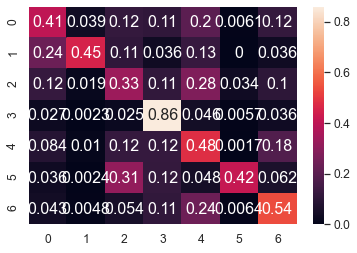

	training epoch=28 .. train_loss=1.043
	validation epoch=28 .. val_loss=1.211
	Accuracy = 54.300000000000004 % .. Percision = 53.2 % .. Recall = 49.8 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_28.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 29 .. loss = 1.152


  0%|                                                                               | 1/1914 [00:03<1:58:23,  3.71s/it]

training @ epoch 29 .. loss = 1.175


  0%|                                                                               | 2/1914 [00:06<1:52:22,  3.53s/it]

training @ epoch 29 .. loss = 1.202


  0%|                                                                               | 3/1914 [00:08<1:36:49,  3.04s/it]

training @ epoch 29 .. loss = 1.165


  0%|▏                                                                              | 4/1914 [00:11<1:34:27,  2.97s/it]

training @ epoch 29 .. loss = 1.128


  0%|▏                                                                              | 5/1914 [00:13<1:24:09,  2.64s/it]

training @ epoch 29 .. loss = 0.961


  0%|▏                                                                              | 6/1914 [00:15<1:14:51,  2.35s/it]

training @ epoch 29 .. loss = 0.581


  0%|▎                                                                              | 7/1914 [00:16<1:07:42,  2.13s/it]

training @ epoch 29 .. loss = 1.464


  0%|▎                                                                              | 8/1914 [00:18<1:01:37,  1.94s/it]

training @ epoch 29 .. loss = 0.992


  0%|▍                                                                                | 9/1914 [00:19<58:53,  1.85s/it]

training @ epoch 29 .. loss = 1.158


  1%|▍                                                                               | 10/1914 [00:21<55:39,  1.75s/it]

training @ epoch 29 .. loss = 1.391


  1%|▍                                                                               | 11/1914 [00:22<53:08,  1.68s/it]

training @ epoch 29 .. loss = 0.518


  1%|▌                                                                               | 12/1914 [00:24<51:15,  1.62s/it]

training @ epoch 29 .. loss = 0.958


  1%|▌                                                                               | 13/1914 [00:25<49:54,  1.58s/it]

training @ epoch 29 .. loss = 0.87


  1%|▌                                                                               | 14/1914 [00:27<49:54,  1.58s/it]

training @ epoch 29 .. loss = 1.056


  1%|▋                                                                               | 15/1914 [00:28<49:49,  1.57s/it]

training @ epoch 29 .. loss = 0.433


  1%|▋                                                                               | 16/1914 [00:30<48:09,  1.52s/it]

training @ epoch 29 .. loss = 1.581


  1%|▋                                                                               | 17/1914 [00:31<46:28,  1.47s/it]

training @ epoch 29 .. loss = 1.421


  1%|▊                                                                               | 18/1914 [00:33<47:45,  1.51s/it]

training @ epoch 29 .. loss = 1.265


  1%|▊                                                                               | 19/1914 [00:34<46:15,  1.46s/it]

training @ epoch 29 .. loss = 1.081


  1%|▊                                                                               | 20/1914 [00:36<45:25,  1.44s/it]

training @ epoch 29 .. loss = 0.975


  1%|▉                                                                               | 21/1914 [00:37<43:32,  1.38s/it]

training @ epoch 29 .. loss = 0.986


  1%|▉                                                                               | 22/1914 [00:38<42:39,  1.35s/it]

training @ epoch 29 .. loss = 1.497


  1%|▉                                                                               | 23/1914 [00:39<42:01,  1.33s/it]

training @ epoch 29 .. loss = 0.699


  1%|█                                                                               | 24/1914 [00:41<41:15,  1.31s/it]

training @ epoch 29 .. loss = 0.869


  1%|█                                                                               | 25/1914 [00:42<40:35,  1.29s/it]

training @ epoch 29 .. loss = 1.169


  1%|█                                                                               | 26/1914 [00:43<41:09,  1.31s/it]

training @ epoch 29 .. loss = 1.565


  1%|█▏                                                                              | 27/1914 [00:45<41:32,  1.32s/it]

training @ epoch 29 .. loss = 0.909


  1%|█▏                                                                              | 28/1914 [00:46<39:38,  1.26s/it]

training @ epoch 29 .. loss = 0.909


  2%|█▏                                                                              | 29/1914 [00:47<38:14,  1.22s/it]

training @ epoch 29 .. loss = 1.068


  2%|█▎                                                                              | 30/1914 [00:48<37:21,  1.19s/it]

training @ epoch 29 .. loss = 1.121


  2%|█▎                                                                              | 31/1914 [00:49<37:12,  1.19s/it]

training @ epoch 29 .. loss = 0.832


  2%|█▎                                                                              | 32/1914 [00:50<36:08,  1.15s/it]

training @ epoch 29 .. loss = 1.086


  2%|█▍                                                                              | 33/1914 [00:51<36:08,  1.15s/it]

training @ epoch 29 .. loss = 1.089


  2%|█▍                                                                              | 34/1914 [00:53<38:32,  1.23s/it]

training @ epoch 29 .. loss = 0.731


  2%|█▍                                                                              | 35/1914 [00:54<38:34,  1.23s/it]

training @ epoch 29 .. loss = 0.543


  2%|█▌                                                                              | 36/1914 [00:55<38:23,  1.23s/it]

training @ epoch 29 .. loss = 0.931


  2%|█▌                                                                              | 37/1914 [00:57<45:20,  1.45s/it]

training @ epoch 29 .. loss = 0.887


  2%|█▌                                                                              | 38/1914 [00:59<49:51,  1.59s/it]

training @ epoch 29 .. loss = 1.014


  2%|█▋                                                                              | 39/1914 [01:01<57:12,  1.83s/it]

training @ epoch 29 .. loss = 1.144


  2%|█▋                                                                            | 40/1914 [01:04<1:02:50,  2.01s/it]

training @ epoch 29 .. loss = 1.23


  2%|█▋                                                                            | 41/1914 [01:07<1:08:33,  2.20s/it]

training @ epoch 29 .. loss = 0.858


  2%|█▋                                                                            | 42/1914 [01:09<1:07:27,  2.16s/it]

training @ epoch 29 .. loss = 0.853


  2%|█▊                                                                            | 43/1914 [01:11<1:07:05,  2.15s/it]

training @ epoch 29 .. loss = 1.219


  2%|█▊                                                                            | 44/1914 [01:13<1:05:57,  2.12s/it]

training @ epoch 29 .. loss = 1.182


  2%|█▊                                                                            | 45/1914 [01:15<1:05:12,  2.09s/it]

training @ epoch 29 .. loss = 0.854


  2%|█▊                                                                            | 46/1914 [01:17<1:04:12,  2.06s/it]

training @ epoch 29 .. loss = 1.201


  2%|█▉                                                                            | 47/1914 [01:19<1:06:00,  2.12s/it]

training @ epoch 29 .. loss = 0.688


  3%|█▉                                                                            | 48/1914 [01:22<1:09:29,  2.23s/it]

training @ epoch 29 .. loss = 1.226


  3%|█▉                                                                            | 49/1914 [01:24<1:06:46,  2.15s/it]

training @ epoch 29 .. loss = 0.886


  3%|██                                                                            | 50/1914 [01:25<1:03:38,  2.05s/it]

training @ epoch 29 .. loss = 1.027


  3%|██▏                                                                             | 51/1914 [01:27<59:17,  1.91s/it]

training @ epoch 29 .. loss = 0.627


  3%|██▏                                                                             | 52/1914 [01:28<53:54,  1.74s/it]

training @ epoch 29 .. loss = 1.125


  3%|██▏                                                                             | 53/1914 [01:30<53:58,  1.74s/it]

training @ epoch 29 .. loss = 1.24


  3%|██▎                                                                             | 54/1914 [01:32<54:23,  1.75s/it]

training @ epoch 29 .. loss = 1.059


  3%|██▎                                                                             | 55/1914 [01:34<59:27,  1.92s/it]

training @ epoch 29 .. loss = 1.305


  3%|██▎                                                                             | 56/1914 [01:36<57:11,  1.85s/it]

training @ epoch 29 .. loss = 1.336


  3%|██▍                                                                             | 57/1914 [01:38<58:54,  1.90s/it]

training @ epoch 29 .. loss = 0.918


  3%|██▍                                                                             | 58/1914 [01:39<53:19,  1.72s/it]

training @ epoch 29 .. loss = 1.391


  3%|██▍                                                                             | 59/1914 [01:40<48:00,  1.55s/it]

training @ epoch 29 .. loss = 1.115


  3%|██▌                                                                             | 60/1914 [01:42<45:13,  1.46s/it]

training @ epoch 29 .. loss = 0.935


  3%|██▌                                                                             | 61/1914 [01:43<44:05,  1.43s/it]

training @ epoch 29 .. loss = 0.956


  3%|██▌                                                                             | 62/1914 [01:44<43:15,  1.40s/it]

training @ epoch 29 .. loss = 0.653


  3%|██▋                                                                             | 63/1914 [01:45<39:53,  1.29s/it]

training @ epoch 29 .. loss = 0.674


  3%|██▋                                                                             | 64/1914 [01:47<40:27,  1.31s/it]

training @ epoch 29 .. loss = 0.759


  3%|██▋                                                                             | 65/1914 [01:48<39:20,  1.28s/it]

training @ epoch 29 .. loss = 0.933


  3%|██▊                                                                             | 66/1914 [01:49<38:00,  1.23s/it]

training @ epoch 29 .. loss = 0.816


  4%|██▊                                                                             | 67/1914 [01:50<37:15,  1.21s/it]

training @ epoch 29 .. loss = 0.706


  4%|██▊                                                                             | 68/1914 [01:52<42:06,  1.37s/it]

training @ epoch 29 .. loss = 0.865


  4%|██▉                                                                             | 69/1914 [01:54<45:01,  1.46s/it]

training @ epoch 29 .. loss = 0.969


  4%|██▉                                                                             | 70/1914 [01:55<46:04,  1.50s/it]

training @ epoch 29 .. loss = 1.273


  4%|██▉                                                                             | 71/1914 [01:56<42:29,  1.38s/it]

training @ epoch 29 .. loss = 1.163


  4%|███                                                                             | 72/1914 [01:58<43:19,  1.41s/it]

training @ epoch 29 .. loss = 1.15


  4%|███                                                                             | 73/1914 [01:59<45:40,  1.49s/it]

training @ epoch 29 .. loss = 1.004


  4%|███                                                                             | 74/1914 [02:01<46:46,  1.53s/it]

training @ epoch 29 .. loss = 1.045


  4%|███▏                                                                            | 75/1914 [02:03<47:27,  1.55s/it]

training @ epoch 29 .. loss = 0.782


  4%|███▏                                                                            | 76/1914 [02:04<45:02,  1.47s/it]

training @ epoch 29 .. loss = 1.221


  4%|███▏                                                                            | 77/1914 [02:05<44:16,  1.45s/it]

training @ epoch 29 .. loss = 0.535


  4%|███▎                                                                            | 78/1914 [02:07<44:47,  1.46s/it]

training @ epoch 29 .. loss = 1.207


  4%|███▎                                                                            | 79/1914 [02:08<44:48,  1.47s/it]

training @ epoch 29 .. loss = 1.0


  4%|███▎                                                                            | 80/1914 [02:10<46:59,  1.54s/it]

training @ epoch 29 .. loss = 0.78


  4%|███▍                                                                            | 81/1914 [02:12<47:29,  1.55s/it]

training @ epoch 29 .. loss = 1.389


  4%|███▎                                                                          | 82/1914 [02:14<1:00:18,  1.98s/it]

training @ epoch 29 .. loss = 1.431


  4%|███▍                                                                            | 83/1914 [02:16<55:57,  1.83s/it]

training @ epoch 29 .. loss = 1.177


  4%|███▌                                                                            | 84/1914 [02:17<50:10,  1.65s/it]

training @ epoch 29 .. loss = 0.924


  4%|███▌                                                                            | 85/1914 [02:19<48:24,  1.59s/it]

training @ epoch 29 .. loss = 0.702


  4%|███▌                                                                            | 86/1914 [02:21<53:41,  1.76s/it]

training @ epoch 29 .. loss = 1.353


  5%|███▋                                                                            | 87/1914 [02:23<58:24,  1.92s/it]

training @ epoch 29 .. loss = 1.435


  5%|███▌                                                                          | 88/1914 [02:25<1:02:46,  2.06s/it]

training @ epoch 29 .. loss = 1.217


  5%|███▋                                                                          | 89/1914 [02:28<1:05:06,  2.14s/it]

training @ epoch 29 .. loss = 1.379


  5%|███▋                                                                          | 90/1914 [02:30<1:06:43,  2.20s/it]

training @ epoch 29 .. loss = 1.027


  5%|███▋                                                                          | 91/1914 [02:32<1:05:03,  2.14s/it]

training @ epoch 29 .. loss = 0.939


  5%|███▋                                                                          | 92/1914 [02:34<1:02:00,  2.04s/it]

training @ epoch 29 .. loss = 0.948


  5%|███▊                                                                          | 93/1914 [02:37<1:07:12,  2.21s/it]

training @ epoch 29 .. loss = 0.893


  5%|███▊                                                                          | 94/1914 [02:38<1:02:36,  2.06s/it]

training @ epoch 29 .. loss = 0.889


  5%|███▊                                                                          | 95/1914 [02:41<1:10:05,  2.31s/it]

training @ epoch 29 .. loss = 0.864


  5%|███▉                                                                          | 96/1914 [02:43<1:06:31,  2.20s/it]

training @ epoch 29 .. loss = 0.921


  5%|███▉                                                                          | 97/1914 [02:45<1:02:11,  2.05s/it]

training @ epoch 29 .. loss = 1.19


  5%|████                                                                            | 98/1914 [02:46<55:40,  1.84s/it]

training @ epoch 29 .. loss = 1.077


  5%|████▏                                                                           | 99/1914 [02:48<51:51,  1.71s/it]

training @ epoch 29 .. loss = 1.102


  5%|████▏                                                                          | 100/1914 [02:49<50:01,  1.65s/it]

training @ epoch 29 .. loss = 1.483


  5%|████▏                                                                          | 101/1914 [02:50<47:14,  1.56s/it]

training @ epoch 29 .. loss = 0.88


  5%|████▏                                                                          | 102/1914 [02:52<44:54,  1.49s/it]

training @ epoch 29 .. loss = 1.076


  5%|████▎                                                                          | 103/1914 [02:53<43:28,  1.44s/it]

training @ epoch 29 .. loss = 1.122


  5%|████▎                                                                          | 104/1914 [02:54<43:12,  1.43s/it]

training @ epoch 29 .. loss = 0.807


  5%|████▎                                                                          | 105/1914 [02:56<45:12,  1.50s/it]

training @ epoch 29 .. loss = 0.529


  6%|████▍                                                                          | 106/1914 [02:58<47:51,  1.59s/it]

training @ epoch 29 .. loss = 1.193


  6%|████▍                                                                          | 107/1914 [03:00<51:44,  1.72s/it]

training @ epoch 29 .. loss = 0.908


  6%|████▍                                                                          | 108/1914 [03:02<50:59,  1.69s/it]

training @ epoch 29 .. loss = 1.154


  6%|████▍                                                                          | 109/1914 [03:04<56:23,  1.87s/it]

training @ epoch 29 .. loss = 0.69


  6%|████▌                                                                          | 110/1914 [03:06<54:03,  1.80s/it]

training @ epoch 29 .. loss = 1.229


  6%|████▌                                                                          | 111/1914 [03:07<52:37,  1.75s/it]

training @ epoch 29 .. loss = 0.572


  6%|████▌                                                                          | 112/1914 [03:09<56:53,  1.89s/it]

training @ epoch 29 .. loss = 0.741


  6%|████▋                                                                          | 113/1914 [03:11<57:16,  1.91s/it]

training @ epoch 29 .. loss = 1.37


  6%|████▋                                                                          | 114/1914 [03:13<58:47,  1.96s/it]

training @ epoch 29 .. loss = 1.235


  6%|████▋                                                                        | 115/1914 [03:16<1:02:21,  2.08s/it]

training @ epoch 29 .. loss = 0.983


  6%|████▊                                                                          | 116/1914 [03:17<57:01,  1.90s/it]

training @ epoch 29 .. loss = 0.701


  6%|████▊                                                                          | 117/1914 [03:19<52:44,  1.76s/it]

training @ epoch 29 .. loss = 0.755


  6%|████▊                                                                          | 118/1914 [03:20<49:09,  1.64s/it]

training @ epoch 29 .. loss = 1.171


  6%|████▉                                                                          | 119/1914 [03:21<47:15,  1.58s/it]

training @ epoch 29 .. loss = 0.894


  6%|████▉                                                                          | 120/1914 [03:23<44:25,  1.49s/it]

training @ epoch 29 .. loss = 1.606


  6%|████▉                                                                          | 121/1914 [03:24<43:13,  1.45s/it]

training @ epoch 29 .. loss = 1.101


  6%|█████                                                                          | 122/1914 [03:25<42:11,  1.41s/it]

training @ epoch 29 .. loss = 1.217


  6%|█████                                                                          | 123/1914 [03:27<41:12,  1.38s/it]

training @ epoch 29 .. loss = 0.773


  6%|█████                                                                          | 124/1914 [03:28<41:20,  1.39s/it]

training @ epoch 29 .. loss = 0.996


  7%|█████▏                                                                         | 125/1914 [03:30<41:17,  1.38s/it]

training @ epoch 29 .. loss = 0.771


  7%|█████▏                                                                         | 126/1914 [03:31<40:54,  1.37s/it]

training @ epoch 29 .. loss = 1.131


  7%|█████▏                                                                         | 127/1914 [03:32<40:14,  1.35s/it]

training @ epoch 29 .. loss = 0.744


  7%|█████▎                                                                         | 128/1914 [03:34<41:13,  1.39s/it]

training @ epoch 29 .. loss = 1.233


  7%|█████▎                                                                         | 129/1914 [03:36<47:29,  1.60s/it]

training @ epoch 29 .. loss = 1.234


  7%|█████▎                                                                         | 130/1914 [03:37<45:19,  1.52s/it]

training @ epoch 29 .. loss = 1.051


  7%|█████▍                                                                         | 131/1914 [03:38<43:38,  1.47s/it]

training @ epoch 29 .. loss = 1.199


  7%|█████▍                                                                         | 132/1914 [03:40<42:36,  1.43s/it]

training @ epoch 29 .. loss = 0.778


  7%|█████▍                                                                         | 133/1914 [03:41<41:49,  1.41s/it]

training @ epoch 29 .. loss = 0.661


  7%|█████▌                                                                         | 134/1914 [03:42<41:08,  1.39s/it]

training @ epoch 29 .. loss = 1.326


  7%|█████▌                                                                         | 135/1914 [03:44<40:55,  1.38s/it]

training @ epoch 29 .. loss = 1.432


  7%|█████▌                                                                         | 136/1914 [03:45<40:38,  1.37s/it]

training @ epoch 29 .. loss = 0.681


  7%|█████▋                                                                         | 137/1914 [03:47<40:32,  1.37s/it]

training @ epoch 29 .. loss = 0.844


  7%|█████▋                                                                         | 138/1914 [03:48<40:56,  1.38s/it]

training @ epoch 29 .. loss = 0.935


  7%|█████▋                                                                         | 139/1914 [03:49<41:20,  1.40s/it]

training @ epoch 29 .. loss = 1.069


  7%|█████▊                                                                         | 140/1914 [03:51<41:55,  1.42s/it]

training @ epoch 29 .. loss = 0.854


  7%|█████▊                                                                         | 141/1914 [03:52<41:41,  1.41s/it]

training @ epoch 29 .. loss = 1.225


  7%|█████▊                                                                         | 142/1914 [03:54<43:35,  1.48s/it]

training @ epoch 29 .. loss = 0.993


  7%|█████▉                                                                         | 143/1914 [03:55<43:29,  1.47s/it]

training @ epoch 29 .. loss = 0.926


  8%|█████▉                                                                         | 144/1914 [03:57<42:40,  1.45s/it]

training @ epoch 29 .. loss = 1.084


  8%|█████▉                                                                         | 145/1914 [03:58<41:47,  1.42s/it]

training @ epoch 29 .. loss = 1.287


  8%|██████                                                                         | 146/1914 [03:59<41:05,  1.39s/it]

training @ epoch 29 .. loss = 0.685


  8%|██████                                                                         | 147/1914 [04:01<40:03,  1.36s/it]

training @ epoch 29 .. loss = 1.183


  8%|██████                                                                         | 148/1914 [04:02<40:46,  1.39s/it]

training @ epoch 29 .. loss = 0.809


  8%|██████▏                                                                        | 149/1914 [04:03<39:48,  1.35s/it]

training @ epoch 29 .. loss = 0.751


  8%|██████▏                                                                        | 150/1914 [04:05<37:20,  1.27s/it]

training @ epoch 29 .. loss = 1.045


  8%|██████▏                                                                        | 151/1914 [04:06<36:26,  1.24s/it]

training @ epoch 29 .. loss = 0.801


  8%|██████▎                                                                        | 152/1914 [04:07<35:06,  1.20s/it]

training @ epoch 29 .. loss = 0.895


  8%|██████▎                                                                        | 153/1914 [04:08<34:22,  1.17s/it]

training @ epoch 29 .. loss = 0.893


  8%|██████▎                                                                        | 154/1914 [04:09<33:30,  1.14s/it]

training @ epoch 29 .. loss = 0.858


  8%|██████▍                                                                        | 155/1914 [04:11<38:58,  1.33s/it]

training @ epoch 29 .. loss = 1.054


  8%|██████▍                                                                        | 156/1914 [04:12<39:15,  1.34s/it]

training @ epoch 29 .. loss = 0.614


  8%|██████▍                                                                        | 157/1914 [04:13<39:35,  1.35s/it]

training @ epoch 29 .. loss = 1.104


  8%|██████▌                                                                        | 158/1914 [04:15<39:17,  1.34s/it]

training @ epoch 29 .. loss = 0.954


  8%|██████▌                                                                        | 159/1914 [04:16<42:05,  1.44s/it]

training @ epoch 29 .. loss = 1.334


  8%|██████▌                                                                        | 160/1914 [04:19<47:42,  1.63s/it]

training @ epoch 29 .. loss = 0.661


  8%|██████▋                                                                        | 161/1914 [04:20<43:13,  1.48s/it]

training @ epoch 29 .. loss = 0.808


  8%|██████▋                                                                        | 162/1914 [04:21<40:55,  1.40s/it]

training @ epoch 29 .. loss = 1.899


  9%|██████▋                                                                        | 163/1914 [04:22<38:52,  1.33s/it]

training @ epoch 29 .. loss = 1.083


  9%|██████▊                                                                        | 164/1914 [04:23<37:44,  1.29s/it]

training @ epoch 29 .. loss = 0.587


  9%|██████▊                                                                        | 165/1914 [04:24<36:36,  1.26s/it]

training @ epoch 29 .. loss = 0.885


  9%|██████▊                                                                        | 166/1914 [04:26<35:14,  1.21s/it]

training @ epoch 29 .. loss = 0.928


  9%|██████▉                                                                        | 167/1914 [04:27<33:58,  1.17s/it]

training @ epoch 29 .. loss = 1.152


  9%|██████▉                                                                        | 168/1914 [04:28<33:29,  1.15s/it]

training @ epoch 29 .. loss = 1.025


  9%|██████▉                                                                        | 169/1914 [04:29<33:35,  1.16s/it]

training @ epoch 29 .. loss = 0.639


  9%|███████                                                                        | 170/1914 [04:30<32:55,  1.13s/it]

training @ epoch 29 .. loss = 1.194


  9%|███████                                                                        | 171/1914 [04:31<32:21,  1.11s/it]

training @ epoch 29 .. loss = 1.141


  9%|███████                                                                        | 172/1914 [04:32<32:18,  1.11s/it]

training @ epoch 29 .. loss = 1.061


  9%|███████▏                                                                       | 173/1914 [04:33<32:29,  1.12s/it]

training @ epoch 29 .. loss = 1.093


  9%|███████▏                                                                       | 174/1914 [04:34<32:20,  1.12s/it]

training @ epoch 29 .. loss = 1.137


  9%|███████▏                                                                       | 175/1914 [04:35<32:00,  1.10s/it]

training @ epoch 29 .. loss = 1.513


  9%|███████▎                                                                       | 176/1914 [04:37<32:44,  1.13s/it]

training @ epoch 29 .. loss = 0.761


  9%|███████▎                                                                       | 177/1914 [04:38<32:32,  1.12s/it]

training @ epoch 29 .. loss = 0.767


  9%|███████▎                                                                       | 178/1914 [04:39<32:08,  1.11s/it]

training @ epoch 29 .. loss = 1.204


  9%|███████▍                                                                       | 179/1914 [04:40<32:01,  1.11s/it]

training @ epoch 29 .. loss = 0.994


  9%|███████▍                                                                       | 180/1914 [04:41<32:06,  1.11s/it]

training @ epoch 29 .. loss = 0.902


  9%|███████▍                                                                       | 181/1914 [04:42<32:05,  1.11s/it]

training @ epoch 29 .. loss = 1.266


 10%|███████▌                                                                       | 182/1914 [04:43<32:27,  1.12s/it]

training @ epoch 29 .. loss = 0.995


 10%|███████▌                                                                       | 183/1914 [04:44<32:10,  1.12s/it]

training @ epoch 29 .. loss = 0.641


 10%|███████▌                                                                       | 184/1914 [04:45<31:58,  1.11s/it]

training @ epoch 29 .. loss = 1.301


 10%|███████▋                                                                       | 185/1914 [04:47<32:24,  1.12s/it]

training @ epoch 29 .. loss = 1.063


 10%|███████▋                                                                       | 186/1914 [04:48<33:31,  1.16s/it]

training @ epoch 29 .. loss = 0.952


 10%|███████▋                                                                       | 187/1914 [04:49<32:51,  1.14s/it]

training @ epoch 29 .. loss = 0.994


 10%|███████▊                                                                       | 188/1914 [04:50<32:13,  1.12s/it]

training @ epoch 29 .. loss = 1.099


 10%|███████▊                                                                       | 189/1914 [04:51<32:25,  1.13s/it]

training @ epoch 29 .. loss = 0.963


 10%|███████▊                                                                       | 190/1914 [04:52<32:58,  1.15s/it]

training @ epoch 29 .. loss = 1.022


 10%|███████▉                                                                       | 191/1914 [04:54<32:53,  1.15s/it]

training @ epoch 29 .. loss = 0.886


 10%|███████▉                                                                       | 192/1914 [04:55<32:16,  1.12s/it]

training @ epoch 29 .. loss = 0.855


 10%|███████▉                                                                       | 193/1914 [04:56<32:30,  1.13s/it]

training @ epoch 29 .. loss = 1.093


 10%|████████                                                                       | 194/1914 [04:57<32:22,  1.13s/it]

training @ epoch 29 .. loss = 1.114


 10%|████████                                                                       | 195/1914 [04:58<32:01,  1.12s/it]

training @ epoch 29 .. loss = 0.704


 10%|████████                                                                       | 196/1914 [04:59<31:45,  1.11s/it]

training @ epoch 29 .. loss = 1.425


 10%|████████▏                                                                      | 197/1914 [05:00<31:34,  1.10s/it]

training @ epoch 29 .. loss = 0.742


 10%|████████▏                                                                      | 198/1914 [05:01<31:31,  1.10s/it]

training @ epoch 29 .. loss = 1.124


 10%|████████▏                                                                      | 199/1914 [05:02<31:24,  1.10s/it]

training @ epoch 29 .. loss = 0.847


 10%|████████▎                                                                      | 200/1914 [05:03<31:36,  1.11s/it]

training @ epoch 29 .. loss = 1.148


 11%|████████▎                                                                      | 201/1914 [05:05<31:32,  1.10s/it]

training @ epoch 29 .. loss = 0.77


 11%|████████▎                                                                      | 202/1914 [05:06<31:26,  1.10s/it]

training @ epoch 29 .. loss = 1.221


 11%|████████▍                                                                      | 203/1914 [05:07<31:39,  1.11s/it]

training @ epoch 29 .. loss = 0.615


 11%|████████▍                                                                      | 204/1914 [05:08<31:22,  1.10s/it]

training @ epoch 29 .. loss = 0.448


 11%|████████▍                                                                      | 205/1914 [05:09<31:30,  1.11s/it]

training @ epoch 29 .. loss = 1.178


 11%|████████▌                                                                      | 206/1914 [05:10<31:27,  1.10s/it]

training @ epoch 29 .. loss = 1.263


 11%|████████▌                                                                      | 207/1914 [05:11<31:34,  1.11s/it]

training @ epoch 29 .. loss = 0.914


 11%|████████▌                                                                      | 208/1914 [05:12<31:53,  1.12s/it]

training @ epoch 29 .. loss = 1.186


 11%|████████▋                                                                      | 209/1914 [05:13<31:33,  1.11s/it]

training @ epoch 29 .. loss = 1.037


 11%|████████▋                                                                      | 210/1914 [05:15<32:41,  1.15s/it]

training @ epoch 29 .. loss = 0.84


 11%|████████▋                                                                      | 211/1914 [05:16<34:06,  1.20s/it]

training @ epoch 29 .. loss = 0.984


 11%|████████▊                                                                      | 212/1914 [05:17<35:15,  1.24s/it]

training @ epoch 29 .. loss = 0.775


 11%|████████▊                                                                      | 213/1914 [05:19<34:33,  1.22s/it]

training @ epoch 29 .. loss = 1.04


 11%|████████▊                                                                      | 214/1914 [05:20<33:40,  1.19s/it]

training @ epoch 29 .. loss = 1.236


 11%|████████▊                                                                      | 215/1914 [05:21<32:59,  1.16s/it]

training @ epoch 29 .. loss = 1.469


 11%|████████▉                                                                      | 216/1914 [05:22<32:14,  1.14s/it]

training @ epoch 29 .. loss = 0.82


 11%|████████▉                                                                      | 217/1914 [05:23<31:58,  1.13s/it]

training @ epoch 29 .. loss = 0.935


 11%|████████▉                                                                      | 218/1914 [05:24<32:20,  1.14s/it]

training @ epoch 29 .. loss = 1.212


 11%|█████████                                                                      | 219/1914 [05:25<32:06,  1.14s/it]

training @ epoch 29 .. loss = 1.105


 11%|█████████                                                                      | 220/1914 [05:26<31:57,  1.13s/it]

training @ epoch 29 .. loss = 0.905


 12%|█████████                                                                      | 221/1914 [05:27<31:47,  1.13s/it]

training @ epoch 29 .. loss = 0.914


 12%|█████████▏                                                                     | 222/1914 [05:29<31:55,  1.13s/it]

training @ epoch 29 .. loss = 1.061


 12%|█████████▏                                                                     | 223/1914 [05:30<32:06,  1.14s/it]

training @ epoch 29 .. loss = 1.241


 12%|█████████▏                                                                     | 224/1914 [05:31<31:40,  1.12s/it]

training @ epoch 29 .. loss = 1.711


 12%|█████████▎                                                                     | 225/1914 [05:32<31:31,  1.12s/it]

training @ epoch 29 .. loss = 1.641


 12%|█████████▎                                                                     | 226/1914 [05:33<31:10,  1.11s/it]

training @ epoch 29 .. loss = 1.114


 12%|█████████▎                                                                     | 227/1914 [05:34<30:55,  1.10s/it]

training @ epoch 29 .. loss = 1.149


 12%|█████████▍                                                                     | 228/1914 [05:35<30:59,  1.10s/it]

training @ epoch 29 .. loss = 0.815


 12%|█████████▍                                                                     | 229/1914 [05:36<30:53,  1.10s/it]

training @ epoch 29 .. loss = 1.068


 12%|█████████▍                                                                     | 230/1914 [05:37<31:10,  1.11s/it]

training @ epoch 29 .. loss = 1.415


 12%|█████████▌                                                                     | 231/1914 [05:39<31:06,  1.11s/it]

training @ epoch 29 .. loss = 0.701


 12%|█████████▌                                                                     | 232/1914 [05:40<31:13,  1.11s/it]

training @ epoch 29 .. loss = 0.84


 12%|█████████▌                                                                     | 233/1914 [05:41<31:10,  1.11s/it]

training @ epoch 29 .. loss = 1.299


 12%|█████████▋                                                                     | 234/1914 [05:42<31:33,  1.13s/it]

training @ epoch 29 .. loss = 1.212


 12%|█████████▋                                                                     | 235/1914 [05:43<31:13,  1.12s/it]

training @ epoch 29 .. loss = 1.006


 12%|█████████▋                                                                     | 236/1914 [05:44<30:54,  1.11s/it]

training @ epoch 29 .. loss = 0.681


 12%|█████████▊                                                                     | 237/1914 [05:45<30:45,  1.10s/it]

training @ epoch 29 .. loss = 0.909


 12%|█████████▊                                                                     | 238/1914 [05:46<30:44,  1.10s/it]

training @ epoch 29 .. loss = 0.752


 12%|█████████▊                                                                     | 239/1914 [05:47<31:08,  1.12s/it]

training @ epoch 29 .. loss = 0.726


 13%|█████████▉                                                                     | 240/1914 [05:49<31:04,  1.11s/it]

training @ epoch 29 .. loss = 1.743


 13%|█████████▉                                                                     | 241/1914 [05:50<31:16,  1.12s/it]

training @ epoch 29 .. loss = 1.324


 13%|█████████▉                                                                     | 242/1914 [05:51<30:54,  1.11s/it]

training @ epoch 29 .. loss = 0.76


 13%|██████████                                                                     | 243/1914 [05:52<31:03,  1.12s/it]

training @ epoch 29 .. loss = 0.784


 13%|██████████                                                                     | 244/1914 [05:53<30:54,  1.11s/it]

training @ epoch 29 .. loss = 1.052


 13%|██████████                                                                     | 245/1914 [05:54<30:58,  1.11s/it]

training @ epoch 29 .. loss = 0.807


 13%|██████████▏                                                                    | 246/1914 [05:55<30:50,  1.11s/it]

training @ epoch 29 .. loss = 0.994


 13%|██████████▏                                                                    | 247/1914 [05:56<30:49,  1.11s/it]

training @ epoch 29 .. loss = 0.795


 13%|██████████▏                                                                    | 248/1914 [05:57<30:48,  1.11s/it]

training @ epoch 29 .. loss = 1.128


 13%|██████████▎                                                                    | 249/1914 [05:59<30:37,  1.10s/it]

training @ epoch 29 .. loss = 0.954


 13%|██████████▎                                                                    | 250/1914 [06:00<30:47,  1.11s/it]

training @ epoch 29 .. loss = 0.701


 13%|██████████▎                                                                    | 251/1914 [06:01<31:13,  1.13s/it]

training @ epoch 29 .. loss = 0.772


 13%|██████████▍                                                                    | 252/1914 [06:02<31:28,  1.14s/it]

training @ epoch 29 .. loss = 1.16


 13%|██████████▍                                                                    | 253/1914 [06:03<30:57,  1.12s/it]

training @ epoch 29 .. loss = 1.044


 13%|██████████▍                                                                    | 254/1914 [06:04<31:23,  1.13s/it]

training @ epoch 29 .. loss = 1.196


 13%|██████████▌                                                                    | 255/1914 [06:06<32:27,  1.17s/it]

training @ epoch 29 .. loss = 0.837


 13%|██████████▌                                                                    | 256/1914 [06:07<33:02,  1.20s/it]

training @ epoch 29 .. loss = 0.756


 13%|██████████▌                                                                    | 257/1914 [06:08<32:08,  1.16s/it]

training @ epoch 29 .. loss = 1.071


 13%|██████████▋                                                                    | 258/1914 [06:09<31:15,  1.13s/it]

training @ epoch 29 .. loss = 1.089


 14%|██████████▋                                                                    | 259/1914 [06:10<30:58,  1.12s/it]

training @ epoch 29 .. loss = 1.156


 14%|██████████▋                                                                    | 260/1914 [06:11<30:30,  1.11s/it]

training @ epoch 29 .. loss = 1.109


 14%|██████████▊                                                                    | 261/1914 [06:12<30:21,  1.10s/it]

training @ epoch 29 .. loss = 0.944


 14%|██████████▊                                                                    | 262/1914 [06:13<30:29,  1.11s/it]

training @ epoch 29 .. loss = 1.17


 14%|██████████▊                                                                    | 263/1914 [06:14<30:34,  1.11s/it]

training @ epoch 29 .. loss = 1.44


 14%|██████████▉                                                                    | 264/1914 [06:16<30:37,  1.11s/it]

training @ epoch 29 .. loss = 1.316


 14%|██████████▉                                                                    | 265/1914 [06:17<30:46,  1.12s/it]

training @ epoch 29 .. loss = 1.369


 14%|██████████▉                                                                    | 266/1914 [06:18<30:41,  1.12s/it]

training @ epoch 29 .. loss = 0.666


 14%|███████████                                                                    | 267/1914 [06:19<30:41,  1.12s/it]

training @ epoch 29 .. loss = 1.082


 14%|███████████                                                                    | 268/1914 [06:21<35:20,  1.29s/it]

training @ epoch 29 .. loss = 1.495


 14%|███████████                                                                    | 269/1914 [06:22<40:06,  1.46s/it]

training @ epoch 29 .. loss = 0.937


 14%|███████████▏                                                                   | 270/1914 [06:24<39:23,  1.44s/it]

training @ epoch 29 .. loss = 1.274


 14%|███████████▏                                                                   | 271/1914 [06:25<37:59,  1.39s/it]

training @ epoch 29 .. loss = 0.912


 14%|███████████▏                                                                   | 272/1914 [06:26<36:57,  1.35s/it]

training @ epoch 29 .. loss = 0.861


 14%|███████████▎                                                                   | 273/1914 [06:28<35:20,  1.29s/it]

training @ epoch 29 .. loss = 0.766


 14%|███████████▎                                                                   | 274/1914 [06:29<34:50,  1.27s/it]

training @ epoch 29 .. loss = 0.864


 14%|███████████▎                                                                   | 275/1914 [06:31<39:12,  1.44s/it]

training @ epoch 29 .. loss = 1.117


 14%|███████████▍                                                                   | 276/1914 [06:33<49:12,  1.80s/it]

training @ epoch 29 .. loss = 0.963


 14%|███████████▍                                                                   | 277/1914 [06:36<55:21,  2.03s/it]

training @ epoch 29 .. loss = 1.262


 15%|███████████▍                                                                   | 278/1914 [06:38<59:47,  2.19s/it]

training @ epoch 29 .. loss = 1.581


 15%|███████████▏                                                                 | 279/1914 [06:41<1:02:35,  2.30s/it]

training @ epoch 29 .. loss = 1.348


 15%|███████████▎                                                                 | 280/1914 [06:44<1:08:18,  2.51s/it]

training @ epoch 29 .. loss = 1.066


 15%|███████████▎                                                                 | 281/1914 [06:46<1:07:32,  2.48s/it]

training @ epoch 29 .. loss = 1.214


 15%|███████████▎                                                                 | 282/1914 [06:49<1:08:42,  2.53s/it]

training @ epoch 29 .. loss = 1.672


 15%|███████████▍                                                                 | 283/1914 [06:51<1:05:08,  2.40s/it]

training @ epoch 29 .. loss = 1.532


 15%|███████████▍                                                                 | 284/1914 [06:53<1:04:33,  2.38s/it]

training @ epoch 29 .. loss = 1.103


 15%|███████████▍                                                                 | 285/1914 [06:56<1:04:06,  2.36s/it]

training @ epoch 29 .. loss = 1.085


 15%|███████████▌                                                                 | 286/1914 [06:58<1:00:40,  2.24s/it]

training @ epoch 29 .. loss = 1.26


 15%|███████████▊                                                                   | 287/1914 [06:59<55:15,  2.04s/it]

training @ epoch 29 .. loss = 0.938


 15%|███████████▉                                                                   | 288/1914 [07:01<51:03,  1.88s/it]

training @ epoch 29 .. loss = 1.058


 15%|███████████▉                                                                   | 289/1914 [07:03<49:56,  1.84s/it]

training @ epoch 29 .. loss = 0.95


 15%|███████████▉                                                                   | 290/1914 [07:04<44:26,  1.64s/it]

training @ epoch 29 .. loss = 0.926


 15%|████████████                                                                   | 291/1914 [07:05<40:25,  1.49s/it]

training @ epoch 29 .. loss = 1.011


 15%|████████████                                                                   | 292/1914 [07:06<37:06,  1.37s/it]

training @ epoch 29 .. loss = 0.87


 15%|████████████                                                                   | 293/1914 [07:08<44:01,  1.63s/it]

training @ epoch 29 .. loss = 0.976


 15%|████████████▏                                                                  | 294/1914 [07:10<47:30,  1.76s/it]

training @ epoch 29 .. loss = 0.652


 15%|████████████▏                                                                  | 295/1914 [07:12<45:45,  1.70s/it]

training @ epoch 29 .. loss = 1.312


 15%|████████████▏                                                                  | 296/1914 [07:13<44:24,  1.65s/it]

training @ epoch 29 .. loss = 1.063


 16%|████████████▎                                                                  | 297/1914 [07:15<43:18,  1.61s/it]

training @ epoch 29 .. loss = 1.292


 16%|████████████▎                                                                  | 298/1914 [07:16<43:11,  1.60s/it]

training @ epoch 29 .. loss = 1.239


 16%|████████████▎                                                                  | 299/1914 [07:18<42:14,  1.57s/it]

training @ epoch 29 .. loss = 0.441


 16%|████████████▍                                                                  | 300/1914 [07:19<42:06,  1.57s/it]

training @ epoch 29 .. loss = 1.281


 16%|████████████▍                                                                  | 301/1914 [07:22<46:52,  1.74s/it]

training @ epoch 29 .. loss = 0.817


 16%|████████████▍                                                                  | 302/1914 [07:24<50:05,  1.86s/it]

training @ epoch 29 .. loss = 1.416


 16%|████████████▌                                                                  | 303/1914 [07:25<46:27,  1.73s/it]

training @ epoch 29 .. loss = 1.457


 16%|████████████▌                                                                  | 304/1914 [07:26<41:40,  1.55s/it]

training @ epoch 29 .. loss = 0.941


 16%|████████████▌                                                                  | 305/1914 [07:27<38:05,  1.42s/it]

training @ epoch 29 .. loss = 0.853


 16%|████████████▋                                                                  | 306/1914 [07:29<35:41,  1.33s/it]

training @ epoch 29 .. loss = 0.822


 16%|████████████▋                                                                  | 307/1914 [07:30<33:55,  1.27s/it]

training @ epoch 29 .. loss = 0.837


 16%|████████████▋                                                                  | 308/1914 [07:31<33:33,  1.25s/it]

training @ epoch 29 .. loss = 1.127


 16%|████████████▊                                                                  | 309/1914 [07:32<32:26,  1.21s/it]

training @ epoch 29 .. loss = 0.789


 16%|████████████▊                                                                  | 310/1914 [07:33<31:06,  1.16s/it]

training @ epoch 29 .. loss = 1.094


 16%|████████████▊                                                                  | 311/1914 [07:34<31:01,  1.16s/it]

training @ epoch 29 .. loss = 1.159


 16%|████████████▉                                                                  | 312/1914 [07:35<30:28,  1.14s/it]

training @ epoch 29 .. loss = 1.283


 16%|████████████▉                                                                  | 313/1914 [07:36<30:41,  1.15s/it]

training @ epoch 29 .. loss = 0.572


 16%|████████████▉                                                                  | 314/1914 [07:38<30:59,  1.16s/it]

training @ epoch 29 .. loss = 1.326


 16%|█████████████                                                                  | 315/1914 [07:39<30:44,  1.15s/it]

training @ epoch 29 .. loss = 0.659


 17%|█████████████                                                                  | 316/1914 [07:40<30:25,  1.14s/it]

training @ epoch 29 .. loss = 0.519


 17%|█████████████                                                                  | 317/1914 [07:41<30:08,  1.13s/it]

training @ epoch 29 .. loss = 0.634


 17%|█████████████▏                                                                 | 318/1914 [07:42<29:52,  1.12s/it]

training @ epoch 29 .. loss = 0.462


 17%|█████████████▏                                                                 | 319/1914 [07:43<30:55,  1.16s/it]

training @ epoch 29 .. loss = 0.808


 17%|█████████████▏                                                                 | 320/1914 [07:45<30:44,  1.16s/it]

training @ epoch 29 .. loss = 0.861


 17%|█████████████▏                                                                 | 321/1914 [07:46<30:15,  1.14s/it]

training @ epoch 29 .. loss = 1.953


 17%|█████████████▎                                                                 | 322/1914 [07:47<29:31,  1.11s/it]

training @ epoch 29 .. loss = 1.193


 17%|█████████████▎                                                                 | 323/1914 [07:48<29:29,  1.11s/it]

training @ epoch 29 .. loss = 1.313


 17%|█████████████▎                                                                 | 324/1914 [07:49<29:24,  1.11s/it]

training @ epoch 29 .. loss = 1.315


 17%|█████████████▍                                                                 | 325/1914 [07:50<29:59,  1.13s/it]

training @ epoch 29 .. loss = 1.268


 17%|█████████████▍                                                                 | 326/1914 [07:51<29:42,  1.12s/it]

training @ epoch 29 .. loss = 1.009


 17%|█████████████▍                                                                 | 327/1914 [07:52<29:26,  1.11s/it]

training @ epoch 29 .. loss = 0.892


 17%|█████████████▌                                                                 | 328/1914 [07:53<29:23,  1.11s/it]

training @ epoch 29 .. loss = 0.972


 17%|█████████████▌                                                                 | 329/1914 [07:55<30:00,  1.14s/it]

training @ epoch 29 .. loss = 0.678


 17%|█████████████▌                                                                 | 330/1914 [07:56<29:41,  1.12s/it]

training @ epoch 29 .. loss = 0.972


 17%|█████████████▋                                                                 | 331/1914 [07:57<29:14,  1.11s/it]

training @ epoch 29 .. loss = 1.009


 17%|█████████████▋                                                                 | 332/1914 [07:58<29:14,  1.11s/it]

training @ epoch 29 .. loss = 0.832


 17%|█████████████▋                                                                 | 333/1914 [07:59<28:49,  1.09s/it]

training @ epoch 29 .. loss = 0.857


 17%|█████████████▊                                                                 | 334/1914 [08:00<28:56,  1.10s/it]

training @ epoch 29 .. loss = 1.424


 18%|█████████████▊                                                                 | 335/1914 [08:01<29:09,  1.11s/it]

training @ epoch 29 .. loss = 1.604


 18%|█████████████▊                                                                 | 336/1914 [08:02<28:50,  1.10s/it]

training @ epoch 29 .. loss = 1.192


 18%|█████████████▉                                                                 | 337/1914 [08:03<28:48,  1.10s/it]

training @ epoch 29 .. loss = 0.916


 18%|█████████████▉                                                                 | 338/1914 [08:04<29:01,  1.10s/it]

training @ epoch 29 .. loss = 0.821


 18%|█████████████▉                                                                 | 339/1914 [08:06<28:54,  1.10s/it]

training @ epoch 29 .. loss = 0.514


 18%|██████████████                                                                 | 340/1914 [08:07<28:46,  1.10s/it]

training @ epoch 29 .. loss = 0.929


 18%|██████████████                                                                 | 341/1914 [08:08<28:57,  1.10s/it]

training @ epoch 29 .. loss = 0.716


 18%|██████████████                                                                 | 342/1914 [08:09<29:21,  1.12s/it]

training @ epoch 29 .. loss = 1.582


 18%|██████████████▏                                                                | 343/1914 [08:10<29:05,  1.11s/it]

training @ epoch 29 .. loss = 0.499


 18%|██████████████▏                                                                | 344/1914 [08:11<28:54,  1.10s/it]

training @ epoch 29 .. loss = 0.723


 18%|██████████████▏                                                                | 345/1914 [08:12<28:49,  1.10s/it]

training @ epoch 29 .. loss = 1.533


 18%|██████████████▎                                                                | 346/1914 [08:13<28:42,  1.10s/it]

training @ epoch 29 .. loss = 0.975


 18%|██████████████▎                                                                | 347/1914 [08:14<28:53,  1.11s/it]

training @ epoch 29 .. loss = 1.762


 18%|██████████████▎                                                                | 348/1914 [08:15<28:30,  1.09s/it]

training @ epoch 29 .. loss = 1.347


 18%|██████████████▍                                                                | 349/1914 [08:17<29:41,  1.14s/it]

training @ epoch 29 .. loss = 0.74


 18%|██████████████▍                                                                | 350/1914 [08:18<29:15,  1.12s/it]

training @ epoch 29 .. loss = 1.155


 18%|██████████████▍                                                                | 351/1914 [08:19<29:01,  1.11s/it]

training @ epoch 29 .. loss = 0.58


 18%|██████████████▌                                                                | 352/1914 [08:20<28:46,  1.11s/it]

training @ epoch 29 .. loss = 1.212


 18%|██████████████▌                                                                | 353/1914 [08:21<28:28,  1.09s/it]

training @ epoch 29 .. loss = 1.287


 18%|██████████████▌                                                                | 354/1914 [08:22<28:30,  1.10s/it]

training @ epoch 29 .. loss = 0.909


 19%|██████████████▋                                                                | 355/1914 [08:23<28:49,  1.11s/it]

training @ epoch 29 .. loss = 1.654


 19%|██████████████▋                                                                | 356/1914 [08:24<28:39,  1.10s/it]

training @ epoch 29 .. loss = 1.281


 19%|██████████████▋                                                                | 357/1914 [08:25<28:31,  1.10s/it]

training @ epoch 29 .. loss = 0.977


 19%|██████████████▊                                                                | 358/1914 [08:27<28:23,  1.09s/it]

training @ epoch 29 .. loss = 0.932


 19%|██████████████▊                                                                | 359/1914 [08:28<28:22,  1.10s/it]

training @ epoch 29 .. loss = 0.63


 19%|██████████████▊                                                                | 360/1914 [08:29<28:00,  1.08s/it]

training @ epoch 29 .. loss = 1.076


 19%|██████████████▉                                                                | 361/1914 [08:30<28:12,  1.09s/it]

training @ epoch 29 .. loss = 1.172


 19%|██████████████▉                                                                | 362/1914 [08:31<28:21,  1.10s/it]

training @ epoch 29 .. loss = 1.165


 19%|██████████████▉                                                                | 363/1914 [08:32<28:08,  1.09s/it]

training @ epoch 29 .. loss = 0.728


 19%|███████████████                                                                | 364/1914 [08:33<27:58,  1.08s/it]

training @ epoch 29 .. loss = 1.143


 19%|███████████████                                                                | 365/1914 [08:34<28:05,  1.09s/it]

training @ epoch 29 .. loss = 0.724


 19%|███████████████                                                                | 366/1914 [08:35<28:02,  1.09s/it]

training @ epoch 29 .. loss = 1.117


 19%|███████████████▏                                                               | 367/1914 [08:36<28:03,  1.09s/it]

training @ epoch 29 .. loss = 0.912


 19%|███████████████▏                                                               | 368/1914 [08:37<28:07,  1.09s/it]

training @ epoch 29 .. loss = 1.107


 19%|███████████████▏                                                               | 369/1914 [08:39<28:35,  1.11s/it]

training @ epoch 29 .. loss = 1.08


 19%|███████████████▎                                                               | 370/1914 [08:40<28:43,  1.12s/it]

training @ epoch 29 .. loss = 0.93


 19%|███████████████▎                                                               | 371/1914 [08:41<28:25,  1.11s/it]

training @ epoch 29 .. loss = 0.989


 19%|███████████████▎                                                               | 372/1914 [08:42<28:03,  1.09s/it]

training @ epoch 29 .. loss = 0.906


 19%|███████████████▍                                                               | 373/1914 [08:43<28:03,  1.09s/it]

training @ epoch 29 .. loss = 1.725


 20%|███████████████▍                                                               | 374/1914 [08:44<27:59,  1.09s/it]

training @ epoch 29 .. loss = 0.855


 20%|███████████████▍                                                               | 375/1914 [08:45<27:51,  1.09s/it]

training @ epoch 29 .. loss = 1.392


 20%|███████████████▌                                                               | 376/1914 [08:46<27:49,  1.09s/it]

training @ epoch 29 .. loss = 0.72


 20%|███████████████▌                                                               | 377/1914 [08:47<28:02,  1.09s/it]

training @ epoch 29 .. loss = 0.752


 20%|███████████████▌                                                               | 378/1914 [08:48<28:20,  1.11s/it]

training @ epoch 29 .. loss = 0.927


 20%|███████████████▋                                                               | 379/1914 [08:50<28:24,  1.11s/it]

training @ epoch 29 .. loss = 0.747


 20%|███████████████▋                                                               | 380/1914 [08:51<28:18,  1.11s/it]

training @ epoch 29 .. loss = 1.202


 20%|███████████████▋                                                               | 381/1914 [08:52<28:23,  1.11s/it]

training @ epoch 29 .. loss = 0.846


 20%|███████████████▊                                                               | 382/1914 [08:53<28:12,  1.10s/it]

training @ epoch 29 .. loss = 0.96


 20%|███████████████▊                                                               | 383/1914 [08:54<28:00,  1.10s/it]

training @ epoch 29 .. loss = 0.884


 20%|███████████████▊                                                               | 384/1914 [08:55<28:16,  1.11s/it]

training @ epoch 29 .. loss = 0.855


 20%|███████████████▉                                                               | 385/1914 [08:56<28:29,  1.12s/it]

training @ epoch 29 .. loss = 1.279


 20%|███████████████▉                                                               | 386/1914 [08:57<28:33,  1.12s/it]

training @ epoch 29 .. loss = 1.326


 20%|███████████████▉                                                               | 387/1914 [08:59<29:24,  1.16s/it]

training @ epoch 29 .. loss = 1.076


 20%|████████████████                                                               | 388/1914 [09:01<40:16,  1.58s/it]

training @ epoch 29 .. loss = 1.074


 20%|████████████████                                                               | 389/1914 [09:03<43:06,  1.70s/it]

training @ epoch 29 .. loss = 1.23


 20%|████████████████                                                               | 390/1914 [09:04<39:17,  1.55s/it]

training @ epoch 29 .. loss = 0.787


 20%|████████████████▏                                                              | 391/1914 [09:06<37:00,  1.46s/it]

training @ epoch 29 .. loss = 0.894


 20%|████████████████▏                                                              | 392/1914 [09:07<34:29,  1.36s/it]

training @ epoch 29 .. loss = 1.52


 21%|████████████████▏                                                              | 393/1914 [09:08<33:03,  1.30s/it]

training @ epoch 29 .. loss = 0.912


 21%|████████████████▎                                                              | 394/1914 [09:09<32:30,  1.28s/it]

training @ epoch 29 .. loss = 0.769


 21%|████████████████▎                                                              | 395/1914 [09:10<31:12,  1.23s/it]

training @ epoch 29 .. loss = 0.937


 21%|████████████████▎                                                              | 396/1914 [09:11<30:11,  1.19s/it]

training @ epoch 29 .. loss = 0.953


 21%|████████████████▍                                                              | 397/1914 [09:12<29:55,  1.18s/it]

training @ epoch 29 .. loss = 1.103


 21%|████████████████▍                                                              | 398/1914 [09:14<29:29,  1.17s/it]

training @ epoch 29 .. loss = 1.231


 21%|████████████████▍                                                              | 399/1914 [09:15<28:46,  1.14s/it]

training @ epoch 29 .. loss = 0.614


 21%|████████████████▌                                                              | 400/1914 [09:16<28:13,  1.12s/it]

training @ epoch 29 .. loss = 0.712


 21%|████████████████▌                                                              | 401/1914 [09:17<27:50,  1.10s/it]

training @ epoch 29 .. loss = 1.261


 21%|████████████████▌                                                              | 402/1914 [09:18<27:29,  1.09s/it]

training @ epoch 29 .. loss = 1.231


 21%|████████████████▋                                                              | 403/1914 [09:19<27:32,  1.09s/it]

training @ epoch 29 .. loss = 1.205


 21%|████████████████▋                                                              | 404/1914 [09:20<27:34,  1.10s/it]

training @ epoch 29 .. loss = 1.372


 21%|████████████████▋                                                              | 405/1914 [09:21<27:30,  1.09s/it]

training @ epoch 29 .. loss = 0.965


 21%|████████████████▊                                                              | 406/1914 [09:22<27:50,  1.11s/it]

training @ epoch 29 .. loss = 1.071


 21%|████████████████▊                                                              | 407/1914 [09:23<27:32,  1.10s/it]

training @ epoch 29 .. loss = 0.934


 21%|████████████████▊                                                              | 408/1914 [09:25<31:24,  1.25s/it]

training @ epoch 29 .. loss = 1.103


 21%|████████████████▉                                                              | 409/1914 [09:27<35:38,  1.42s/it]

training @ epoch 29 .. loss = 1.054


 21%|████████████████▉                                                              | 410/1914 [09:28<34:56,  1.39s/it]

training @ epoch 29 .. loss = 1.045


 21%|████████████████▉                                                              | 411/1914 [09:29<32:53,  1.31s/it]

training @ epoch 29 .. loss = 1.271


 22%|█████████████████                                                              | 412/1914 [09:30<31:32,  1.26s/it]

training @ epoch 29 .. loss = 0.919


 22%|█████████████████                                                              | 413/1914 [09:32<34:41,  1.39s/it]

training @ epoch 29 .. loss = 0.94


 22%|█████████████████                                                              | 414/1914 [09:33<34:24,  1.38s/it]

training @ epoch 29 .. loss = 0.71


 22%|█████████████████▏                                                             | 415/1914 [09:35<32:45,  1.31s/it]

training @ epoch 29 .. loss = 1.039


 22%|█████████████████▏                                                             | 416/1914 [09:36<32:14,  1.29s/it]

training @ epoch 29 .. loss = 0.995


 22%|█████████████████▏                                                             | 417/1914 [09:37<31:00,  1.24s/it]

training @ epoch 29 .. loss = 1.021


 22%|█████████████████▎                                                             | 418/1914 [09:38<30:26,  1.22s/it]

training @ epoch 29 .. loss = 1.375


 22%|█████████████████▎                                                             | 419/1914 [09:39<30:00,  1.20s/it]

training @ epoch 29 .. loss = 0.848


 22%|█████████████████▎                                                             | 420/1914 [09:41<31:15,  1.26s/it]

training @ epoch 29 .. loss = 1.131


 22%|█████████████████▍                                                             | 421/1914 [09:42<34:20,  1.38s/it]

training @ epoch 29 .. loss = 0.914


 22%|█████████████████▍                                                             | 422/1914 [09:44<33:07,  1.33s/it]

training @ epoch 29 .. loss = 1.34


 22%|█████████████████▍                                                             | 423/1914 [09:45<32:18,  1.30s/it]

training @ epoch 29 .. loss = 0.97


 22%|█████████████████▌                                                             | 424/1914 [09:46<31:56,  1.29s/it]

training @ epoch 29 .. loss = 1.266


 22%|█████████████████▌                                                             | 425/1914 [09:47<31:39,  1.28s/it]

training @ epoch 29 .. loss = 1.327


 22%|█████████████████▌                                                             | 426/1914 [09:49<33:36,  1.35s/it]

training @ epoch 29 .. loss = 0.66


 22%|█████████████████▌                                                             | 427/1914 [09:51<40:45,  1.64s/it]

training @ epoch 29 .. loss = 0.958


 22%|█████████████████▋                                                             | 428/1914 [09:53<45:11,  1.82s/it]

training @ epoch 29 .. loss = 1.033


 22%|█████████████████▋                                                             | 429/1914 [09:56<47:20,  1.91s/it]

training @ epoch 29 .. loss = 1.205


 22%|█████████████████▋                                                             | 430/1914 [09:57<41:23,  1.67s/it]

training @ epoch 29 .. loss = 0.758


 23%|█████████████████▊                                                             | 431/1914 [09:58<38:37,  1.56s/it]

training @ epoch 29 .. loss = 1.35


 23%|█████████████████▊                                                             | 432/1914 [09:59<36:52,  1.49s/it]

training @ epoch 29 .. loss = 1.214


 23%|█████████████████▊                                                             | 433/1914 [10:01<35:36,  1.44s/it]

training @ epoch 29 .. loss = 0.83


 23%|█████████████████▉                                                             | 434/1914 [10:02<36:25,  1.48s/it]

training @ epoch 29 .. loss = 0.866


 23%|█████████████████▉                                                             | 435/1914 [10:04<36:29,  1.48s/it]

training @ epoch 29 .. loss = 0.945


 23%|█████████████████▉                                                             | 436/1914 [10:05<35:53,  1.46s/it]

training @ epoch 29 .. loss = 1.35


 23%|██████████████████                                                             | 437/1914 [10:06<34:58,  1.42s/it]

training @ epoch 29 .. loss = 1.129


 23%|██████████████████                                                             | 438/1914 [10:08<33:08,  1.35s/it]

training @ epoch 29 .. loss = 1.167


 23%|██████████████████                                                             | 439/1914 [10:09<35:21,  1.44s/it]

training @ epoch 29 .. loss = 0.788


 23%|██████████████████▏                                                            | 440/1914 [10:11<41:25,  1.69s/it]

training @ epoch 29 .. loss = 0.989


 23%|██████████████████▏                                                            | 441/1914 [10:13<38:44,  1.58s/it]

training @ epoch 29 .. loss = 0.977


 23%|██████████████████▏                                                            | 442/1914 [10:14<36:13,  1.48s/it]

training @ epoch 29 .. loss = 1.204


 23%|██████████████████▎                                                            | 443/1914 [10:15<34:45,  1.42s/it]

training @ epoch 29 .. loss = 0.9


 23%|██████████████████▎                                                            | 444/1914 [10:17<35:14,  1.44s/it]

training @ epoch 29 .. loss = 1.076


 23%|██████████████████▎                                                            | 445/1914 [10:18<34:48,  1.42s/it]

training @ epoch 29 .. loss = 0.985


 23%|██████████████████▍                                                            | 446/1914 [10:20<38:01,  1.55s/it]

training @ epoch 29 .. loss = 0.854


 23%|██████████████████▍                                                            | 447/1914 [10:22<40:22,  1.65s/it]

training @ epoch 29 .. loss = 1.086


 23%|██████████████████▍                                                            | 448/1914 [10:24<39:51,  1.63s/it]

training @ epoch 29 .. loss = 1.124


 23%|██████████████████▌                                                            | 449/1914 [10:25<38:50,  1.59s/it]

training @ epoch 29 .. loss = 1.361


 24%|██████████████████▌                                                            | 450/1914 [10:26<37:40,  1.54s/it]

training @ epoch 29 .. loss = 0.773


 24%|██████████████████▌                                                            | 451/1914 [10:28<36:25,  1.49s/it]

training @ epoch 29 .. loss = 1.015


 24%|██████████████████▋                                                            | 452/1914 [10:29<35:57,  1.48s/it]

training @ epoch 29 .. loss = 0.973


 24%|██████████████████▋                                                            | 453/1914 [10:31<36:52,  1.51s/it]

training @ epoch 29 .. loss = 1.144


 24%|██████████████████▋                                                            | 454/1914 [10:33<43:03,  1.77s/it]

training @ epoch 29 .. loss = 1.138


 24%|██████████████████▊                                                            | 455/1914 [10:35<43:01,  1.77s/it]

training @ epoch 29 .. loss = 0.897


 24%|██████████████████▊                                                            | 456/1914 [10:37<42:10,  1.74s/it]

training @ epoch 29 .. loss = 1.043


 24%|██████████████████▊                                                            | 457/1914 [10:38<40:40,  1.68s/it]

training @ epoch 29 .. loss = 1.616


 24%|██████████████████▉                                                            | 458/1914 [10:41<51:16,  2.11s/it]

training @ epoch 29 .. loss = 0.827


 24%|██████████████████▉                                                            | 459/1914 [10:43<50:01,  2.06s/it]

training @ epoch 29 .. loss = 0.851


 24%|██████████████████▉                                                            | 460/1914 [10:45<47:56,  1.98s/it]

training @ epoch 29 .. loss = 1.439


 24%|███████████████████                                                            | 461/1914 [10:46<43:50,  1.81s/it]

training @ epoch 29 .. loss = 1.109


 24%|███████████████████                                                            | 462/1914 [10:48<41:51,  1.73s/it]

training @ epoch 29 .. loss = 1.221


 24%|███████████████████                                                            | 463/1914 [10:49<39:39,  1.64s/it]

training @ epoch 29 .. loss = 0.904


 24%|███████████████████▏                                                           | 464/1914 [10:51<39:26,  1.63s/it]

training @ epoch 29 .. loss = 1.128


 24%|███████████████████▏                                                           | 465/1914 [10:53<38:14,  1.58s/it]

training @ epoch 29 .. loss = 1.382


 24%|███████████████████▏                                                           | 466/1914 [10:54<39:04,  1.62s/it]

training @ epoch 29 .. loss = 1.209


 24%|███████████████████▎                                                           | 467/1914 [10:56<43:38,  1.81s/it]

training @ epoch 29 .. loss = 0.942


 24%|███████████████████▎                                                           | 468/1914 [10:58<44:26,  1.84s/it]

training @ epoch 29 .. loss = 1.55


 25%|███████████████████▎                                                           | 469/1914 [11:01<51:58,  2.16s/it]

training @ epoch 29 .. loss = 1.319


 25%|███████████████████▍                                                           | 470/1914 [11:03<49:04,  2.04s/it]

training @ epoch 29 .. loss = 1.445


 25%|███████████████████▍                                                           | 471/1914 [11:05<45:56,  1.91s/it]

training @ epoch 29 .. loss = 1.243


 25%|███████████████████▍                                                           | 472/1914 [11:06<40:56,  1.70s/it]

training @ epoch 29 .. loss = 1.687


 25%|███████████████████▌                                                           | 473/1914 [11:07<37:42,  1.57s/it]

training @ epoch 29 .. loss = 1.054


 25%|███████████████████▌                                                           | 474/1914 [11:08<34:56,  1.46s/it]

training @ epoch 29 .. loss = 0.992


 25%|███████████████████▌                                                           | 475/1914 [11:10<32:58,  1.37s/it]

training @ epoch 29 .. loss = 0.879


 25%|███████████████████▋                                                           | 476/1914 [11:11<31:33,  1.32s/it]

training @ epoch 29 .. loss = 0.961


 25%|███████████████████▋                                                           | 477/1914 [11:12<33:57,  1.42s/it]

training @ epoch 29 .. loss = 1.034


 25%|███████████████████▋                                                           | 478/1914 [11:14<32:56,  1.38s/it]

training @ epoch 29 .. loss = 1.06


 25%|███████████████████▊                                                           | 479/1914 [11:15<31:02,  1.30s/it]

training @ epoch 29 .. loss = 0.852


 25%|███████████████████▊                                                           | 480/1914 [11:16<29:44,  1.24s/it]

training @ epoch 29 .. loss = 1.322


 25%|███████████████████▊                                                           | 481/1914 [11:17<28:45,  1.20s/it]

training @ epoch 29 .. loss = 1.36


 25%|███████████████████▉                                                           | 482/1914 [11:18<28:35,  1.20s/it]

training @ epoch 29 .. loss = 1.039


 25%|███████████████████▉                                                           | 483/1914 [11:19<27:59,  1.17s/it]

training @ epoch 29 .. loss = 0.877


 25%|███████████████████▉                                                           | 484/1914 [11:20<27:26,  1.15s/it]

training @ epoch 29 .. loss = 0.935


 25%|████████████████████                                                           | 485/1914 [11:22<27:23,  1.15s/it]

training @ epoch 29 .. loss = 1.15


 25%|████████████████████                                                           | 486/1914 [11:23<27:45,  1.17s/it]

training @ epoch 29 .. loss = 0.741


 25%|████████████████████                                                           | 487/1914 [11:24<27:13,  1.14s/it]

training @ epoch 29 .. loss = 1.003


 25%|████████████████████▏                                                          | 488/1914 [11:25<26:59,  1.14s/it]

training @ epoch 29 .. loss = 1.101


 26%|████████████████████▏                                                          | 489/1914 [11:26<26:40,  1.12s/it]

training @ epoch 29 .. loss = 0.649


 26%|████████████████████▏                                                          | 490/1914 [11:27<26:19,  1.11s/it]

training @ epoch 29 .. loss = 0.902


 26%|████████████████████▎                                                          | 491/1914 [11:28<26:41,  1.13s/it]

training @ epoch 29 .. loss = 0.915


 26%|████████████████████▎                                                          | 492/1914 [11:29<26:57,  1.14s/it]

training @ epoch 29 .. loss = 1.238


 26%|████████████████████▎                                                          | 493/1914 [11:31<26:53,  1.14s/it]

training @ epoch 29 .. loss = 0.763


 26%|████████████████████▍                                                          | 494/1914 [11:32<26:49,  1.13s/it]

training @ epoch 29 .. loss = 0.821


 26%|████████████████████▍                                                          | 495/1914 [11:33<26:42,  1.13s/it]

training @ epoch 29 .. loss = 0.94


 26%|████████████████████▍                                                          | 496/1914 [11:34<26:24,  1.12s/it]

training @ epoch 29 .. loss = 0.994


 26%|████████████████████▌                                                          | 497/1914 [11:35<26:07,  1.11s/it]

training @ epoch 29 .. loss = 0.89


 26%|████████████████████▌                                                          | 498/1914 [11:36<26:44,  1.13s/it]

training @ epoch 29 .. loss = 0.774


 26%|████████████████████▌                                                          | 499/1914 [11:37<26:48,  1.14s/it]

training @ epoch 29 .. loss = 0.669


 26%|████████████████████▋                                                          | 500/1914 [11:39<27:09,  1.15s/it]

training @ epoch 29 .. loss = 1.13


 26%|████████████████████▋                                                          | 501/1914 [11:40<26:50,  1.14s/it]

training @ epoch 29 .. loss = 1.233


 26%|████████████████████▋                                                          | 502/1914 [11:41<27:27,  1.17s/it]

training @ epoch 29 .. loss = 0.871


 26%|████████████████████▊                                                          | 503/1914 [11:42<28:23,  1.21s/it]

training @ epoch 29 .. loss = 1.808


 26%|████████████████████▊                                                          | 504/1914 [11:43<27:57,  1.19s/it]

training @ epoch 29 .. loss = 0.866


 26%|████████████████████▊                                                          | 505/1914 [11:44<27:35,  1.17s/it]

training @ epoch 29 .. loss = 1.055


 26%|████████████████████▉                                                          | 506/1914 [11:46<27:53,  1.19s/it]

training @ epoch 29 .. loss = 1.722


 26%|████████████████████▉                                                          | 507/1914 [11:47<28:58,  1.24s/it]

training @ epoch 29 .. loss = 1.313


 27%|████████████████████▉                                                          | 508/1914 [11:48<28:06,  1.20s/it]

training @ epoch 29 .. loss = 1.205


 27%|█████████████████████                                                          | 509/1914 [11:49<27:27,  1.17s/it]

training @ epoch 29 .. loss = 1.327


 27%|█████████████████████                                                          | 510/1914 [11:50<27:20,  1.17s/it]

training @ epoch 29 .. loss = 0.81


 27%|█████████████████████                                                          | 511/1914 [11:52<27:01,  1.16s/it]

training @ epoch 29 .. loss = 1.085


 27%|█████████████████████▏                                                         | 512/1914 [11:53<28:08,  1.20s/it]

training @ epoch 29 .. loss = 1.366


 27%|█████████████████████▏                                                         | 513/1914 [11:54<27:26,  1.18s/it]

training @ epoch 29 .. loss = 0.735


 27%|█████████████████████▏                                                         | 514/1914 [11:55<26:49,  1.15s/it]

training @ epoch 29 .. loss = 1.202


 27%|█████████████████████▎                                                         | 515/1914 [11:56<26:17,  1.13s/it]

training @ epoch 29 .. loss = 1.137


 27%|█████████████████████▎                                                         | 516/1914 [11:57<26:12,  1.12s/it]

training @ epoch 29 .. loss = 0.763


 27%|█████████████████████▎                                                         | 517/1914 [11:58<26:30,  1.14s/it]

training @ epoch 29 .. loss = 0.873


 27%|█████████████████████▍                                                         | 518/1914 [12:00<26:11,  1.13s/it]

training @ epoch 29 .. loss = 1.379


 27%|█████████████████████▍                                                         | 519/1914 [12:01<26:03,  1.12s/it]

training @ epoch 29 .. loss = 0.878


 27%|█████████████████████▍                                                         | 520/1914 [12:02<25:49,  1.11s/it]

training @ epoch 29 .. loss = 1.316


 27%|█████████████████████▌                                                         | 521/1914 [12:03<26:21,  1.14s/it]

training @ epoch 29 .. loss = 0.963


 27%|█████████████████████▌                                                         | 522/1914 [12:04<26:05,  1.12s/it]

training @ epoch 29 .. loss = 1.094


 27%|█████████████████████▌                                                         | 523/1914 [12:05<26:19,  1.14s/it]

training @ epoch 29 .. loss = 1.168


 27%|█████████████████████▋                                                         | 524/1914 [12:06<25:50,  1.12s/it]

training @ epoch 29 .. loss = 1.14


 27%|█████████████████████▋                                                         | 525/1914 [12:07<25:40,  1.11s/it]

training @ epoch 29 .. loss = 0.765


 27%|█████████████████████▋                                                         | 526/1914 [12:08<25:42,  1.11s/it]

training @ epoch 29 .. loss = 0.927


 28%|█████████████████████▊                                                         | 527/1914 [12:10<26:05,  1.13s/it]

training @ epoch 29 .. loss = 0.908


 28%|█████████████████████▊                                                         | 528/1914 [12:11<25:40,  1.11s/it]

training @ epoch 29 .. loss = 0.859


 28%|█████████████████████▊                                                         | 529/1914 [12:12<25:46,  1.12s/it]

training @ epoch 29 .. loss = 0.882


 28%|█████████████████████▉                                                         | 530/1914 [12:13<25:34,  1.11s/it]

training @ epoch 29 .. loss = 1.071


 28%|█████████████████████▉                                                         | 531/1914 [12:14<25:17,  1.10s/it]

training @ epoch 29 .. loss = 0.894


 28%|█████████████████████▉                                                         | 532/1914 [12:15<25:09,  1.09s/it]

training @ epoch 29 .. loss = 1.348


 28%|█████████████████████▉                                                         | 533/1914 [12:16<25:07,  1.09s/it]

training @ epoch 29 .. loss = 1.013


 28%|██████████████████████                                                         | 534/1914 [12:17<25:35,  1.11s/it]

training @ epoch 29 .. loss = 1.079


 28%|██████████████████████                                                         | 535/1914 [12:19<26:42,  1.16s/it]

training @ epoch 29 .. loss = 0.775


 28%|██████████████████████                                                         | 536/1914 [12:20<26:28,  1.15s/it]

training @ epoch 29 .. loss = 1.197


 28%|██████████████████████▏                                                        | 537/1914 [12:21<26:01,  1.13s/it]

training @ epoch 29 .. loss = 0.819


 28%|██████████████████████▏                                                        | 538/1914 [12:22<25:33,  1.11s/it]

training @ epoch 29 .. loss = 1.056


 28%|██████████████████████▏                                                        | 539/1914 [12:23<25:45,  1.12s/it]

training @ epoch 29 .. loss = 1.106


 28%|██████████████████████▎                                                        | 540/1914 [12:24<26:17,  1.15s/it]

training @ epoch 29 .. loss = 1.308


 28%|██████████████████████▎                                                        | 541/1914 [12:25<26:12,  1.15s/it]

training @ epoch 29 .. loss = 1.167


 28%|██████████████████████▎                                                        | 542/1914 [12:26<25:40,  1.12s/it]

training @ epoch 29 .. loss = 1.365


 28%|██████████████████████▍                                                        | 543/1914 [12:28<25:17,  1.11s/it]

training @ epoch 29 .. loss = 0.731


 28%|██████████████████████▍                                                        | 544/1914 [12:29<25:46,  1.13s/it]

training @ epoch 29 .. loss = 0.777


 28%|██████████████████████▍                                                        | 545/1914 [12:30<25:25,  1.11s/it]

training @ epoch 29 .. loss = 1.424


 29%|██████████████████████▌                                                        | 546/1914 [12:31<25:10,  1.10s/it]

training @ epoch 29 .. loss = 0.943


 29%|██████████████████████▌                                                        | 547/1914 [12:32<25:15,  1.11s/it]

training @ epoch 29 .. loss = 1.279


 29%|██████████████████████▌                                                        | 548/1914 [12:33<24:58,  1.10s/it]

training @ epoch 29 .. loss = 1.337


 29%|██████████████████████▋                                                        | 549/1914 [12:34<24:58,  1.10s/it]

training @ epoch 29 .. loss = 0.933


 29%|██████████████████████▋                                                        | 550/1914 [12:35<24:58,  1.10s/it]

training @ epoch 29 .. loss = 1.167


 29%|██████████████████████▋                                                        | 551/1914 [12:36<25:04,  1.10s/it]

training @ epoch 29 .. loss = 0.908


 29%|██████████████████████▊                                                        | 552/1914 [12:38<25:28,  1.12s/it]

training @ epoch 29 .. loss = 1.026


 29%|██████████████████████▊                                                        | 553/1914 [12:39<27:42,  1.22s/it]

training @ epoch 29 .. loss = 1.337


 29%|██████████████████████▊                                                        | 554/1914 [12:40<28:05,  1.24s/it]

training @ epoch 29 .. loss = 1.006


 29%|██████████████████████▉                                                        | 555/1914 [12:41<27:56,  1.23s/it]

training @ epoch 29 .. loss = 1.291


 29%|██████████████████████▉                                                        | 556/1914 [12:43<27:35,  1.22s/it]

training @ epoch 29 .. loss = 1.243


 29%|██████████████████████▉                                                        | 557/1914 [12:44<27:18,  1.21s/it]

training @ epoch 29 .. loss = 1.052


 29%|███████████████████████                                                        | 558/1914 [12:45<26:35,  1.18s/it]

training @ epoch 29 .. loss = 1.185


 29%|███████████████████████                                                        | 559/1914 [12:46<26:17,  1.16s/it]

training @ epoch 29 .. loss = 1.152


 29%|███████████████████████                                                        | 560/1914 [12:47<25:54,  1.15s/it]

training @ epoch 29 .. loss = 0.817


 29%|███████████████████████▏                                                       | 561/1914 [12:48<26:05,  1.16s/it]

training @ epoch 29 .. loss = 0.918


 29%|███████████████████████▏                                                       | 562/1914 [12:49<25:41,  1.14s/it]

training @ epoch 29 .. loss = 0.972


 29%|███████████████████████▏                                                       | 563/1914 [12:51<25:36,  1.14s/it]

training @ epoch 29 .. loss = 0.645


 29%|███████████████████████▎                                                       | 564/1914 [12:52<25:28,  1.13s/it]

training @ epoch 29 .. loss = 0.848


 30%|███████████████████████▎                                                       | 565/1914 [12:53<25:34,  1.14s/it]

training @ epoch 29 .. loss = 1.095


 30%|███████████████████████▎                                                       | 566/1914 [12:54<26:14,  1.17s/it]

training @ epoch 29 .. loss = 0.678


 30%|███████████████████████▍                                                       | 567/1914 [12:55<25:37,  1.14s/it]

training @ epoch 29 .. loss = 1.049


 30%|███████████████████████▍                                                       | 568/1914 [12:56<25:44,  1.15s/it]

training @ epoch 29 .. loss = 1.08


 30%|███████████████████████▍                                                       | 569/1914 [12:57<25:15,  1.13s/it]

training @ epoch 29 .. loss = 0.927


 30%|███████████████████████▌                                                       | 570/1914 [12:59<24:59,  1.12s/it]

training @ epoch 29 .. loss = 1.043


 30%|███████████████████████▌                                                       | 571/1914 [13:00<24:50,  1.11s/it]

training @ epoch 29 .. loss = 0.713


 30%|███████████████████████▌                                                       | 572/1914 [13:01<24:47,  1.11s/it]

training @ epoch 29 .. loss = 0.743


 30%|███████████████████████▋                                                       | 573/1914 [13:02<24:46,  1.11s/it]

training @ epoch 29 .. loss = 1.704


 30%|███████████████████████▋                                                       | 574/1914 [13:03<25:02,  1.12s/it]

training @ epoch 29 .. loss = 1.27


 30%|███████████████████████▋                                                       | 575/1914 [13:04<25:26,  1.14s/it]

training @ epoch 29 .. loss = 0.499


 30%|███████████████████████▊                                                       | 576/1914 [13:05<25:43,  1.15s/it]

training @ epoch 29 .. loss = 0.59


 30%|███████████████████████▊                                                       | 577/1914 [13:07<25:54,  1.16s/it]

training @ epoch 29 .. loss = 0.995


 30%|███████████████████████▊                                                       | 578/1914 [13:08<25:46,  1.16s/it]

training @ epoch 29 .. loss = 1.33


 30%|███████████████████████▉                                                       | 579/1914 [13:09<25:46,  1.16s/it]

training @ epoch 29 .. loss = 1.185


 30%|███████████████████████▉                                                       | 580/1914 [13:10<25:40,  1.15s/it]

training @ epoch 29 .. loss = 0.47


 30%|███████████████████████▉                                                       | 581/1914 [13:11<25:22,  1.14s/it]

training @ epoch 29 .. loss = 0.909


 30%|████████████████████████                                                       | 582/1914 [13:12<25:38,  1.16s/it]

training @ epoch 29 .. loss = 1.251


 30%|████████████████████████                                                       | 583/1914 [13:13<25:41,  1.16s/it]

training @ epoch 29 .. loss = 0.869


 31%|████████████████████████                                                       | 584/1914 [13:15<25:35,  1.15s/it]

training @ epoch 29 .. loss = 1.06


 31%|████████████████████████▏                                                      | 585/1914 [13:16<25:34,  1.15s/it]

training @ epoch 29 .. loss = 1.132


 31%|████████████████████████▏                                                      | 586/1914 [13:17<25:35,  1.16s/it]

training @ epoch 29 .. loss = 0.996


 31%|████████████████████████▏                                                      | 587/1914 [13:18<25:39,  1.16s/it]

training @ epoch 29 .. loss = 1.096


 31%|████████████████████████▎                                                      | 588/1914 [13:19<25:40,  1.16s/it]

training @ epoch 29 .. loss = 1.453


 31%|████████████████████████▎                                                      | 589/1914 [13:21<26:24,  1.20s/it]

training @ epoch 29 .. loss = 1.426


 31%|████████████████████████▎                                                      | 590/1914 [13:22<26:00,  1.18s/it]

training @ epoch 29 .. loss = 1.103


 31%|████████████████████████▍                                                      | 591/1914 [13:23<25:48,  1.17s/it]

training @ epoch 29 .. loss = 0.862


 31%|████████████████████████▍                                                      | 592/1914 [13:24<25:45,  1.17s/it]

training @ epoch 29 .. loss = 1.051


 31%|████████████████████████▍                                                      | 593/1914 [13:25<25:50,  1.17s/it]

training @ epoch 29 .. loss = 1.53


 31%|████████████████████████▌                                                      | 594/1914 [13:26<25:39,  1.17s/it]

training @ epoch 29 .. loss = 1.188


 31%|████████████████████████▌                                                      | 595/1914 [13:27<25:32,  1.16s/it]

training @ epoch 29 .. loss = 0.988


 31%|████████████████████████▌                                                      | 596/1914 [13:29<25:57,  1.18s/it]

training @ epoch 29 .. loss = 0.759


 31%|████████████████████████▋                                                      | 597/1914 [13:30<28:55,  1.32s/it]

training @ epoch 29 .. loss = 1.244


 31%|████████████████████████▋                                                      | 598/1914 [13:32<28:03,  1.28s/it]

training @ epoch 29 .. loss = 1.147


 31%|████████████████████████▋                                                      | 599/1914 [13:33<27:13,  1.24s/it]

training @ epoch 29 .. loss = 1.19


 31%|████████████████████████▊                                                      | 600/1914 [13:34<27:27,  1.25s/it]

training @ epoch 29 .. loss = 1.199


 31%|████████████████████████▊                                                      | 601/1914 [13:35<27:24,  1.25s/it]

training @ epoch 29 .. loss = 1.047


 31%|████████████████████████▊                                                      | 602/1914 [13:36<26:58,  1.23s/it]

training @ epoch 29 .. loss = 0.711


 32%|████████████████████████▉                                                      | 603/1914 [13:38<27:07,  1.24s/it]

training @ epoch 29 .. loss = 1.074


 32%|████████████████████████▉                                                      | 604/1914 [13:39<28:03,  1.29s/it]

training @ epoch 29 .. loss = 0.646


 32%|████████████████████████▉                                                      | 605/1914 [13:40<27:27,  1.26s/it]

training @ epoch 29 .. loss = 1.075


 32%|█████████████████████████                                                      | 606/1914 [13:41<27:11,  1.25s/it]

training @ epoch 29 .. loss = 0.781


 32%|█████████████████████████                                                      | 607/1914 [13:43<27:05,  1.24s/it]

training @ epoch 29 .. loss = 0.734


 32%|█████████████████████████                                                      | 608/1914 [13:44<27:15,  1.25s/it]

training @ epoch 29 .. loss = 1.028


 32%|█████████████████████████▏                                                     | 609/1914 [13:45<26:41,  1.23s/it]

training @ epoch 29 .. loss = 0.668


 32%|█████████████████████████▏                                                     | 610/1914 [13:46<27:00,  1.24s/it]

training @ epoch 29 .. loss = 1.101


 32%|█████████████████████████▏                                                     | 611/1914 [13:48<26:26,  1.22s/it]

training @ epoch 29 .. loss = 1.116


 32%|█████████████████████████▎                                                     | 612/1914 [13:49<26:14,  1.21s/it]

training @ epoch 29 .. loss = 1.007


 32%|█████████████████████████▎                                                     | 613/1914 [13:50<26:45,  1.23s/it]

training @ epoch 29 .. loss = 0.841


 32%|█████████████████████████▎                                                     | 614/1914 [13:51<26:52,  1.24s/it]

training @ epoch 29 .. loss = 0.976


 32%|█████████████████████████▍                                                     | 615/1914 [13:52<26:25,  1.22s/it]

training @ epoch 29 .. loss = 0.657


 32%|█████████████████████████▍                                                     | 616/1914 [13:54<25:52,  1.20s/it]

training @ epoch 29 .. loss = 1.413


 32%|█████████████████████████▍                                                     | 617/1914 [13:55<26:02,  1.20s/it]

training @ epoch 29 .. loss = 0.961


 32%|█████████████████████████▌                                                     | 618/1914 [13:56<25:34,  1.18s/it]

training @ epoch 29 .. loss = 0.62


 32%|█████████████████████████▌                                                     | 619/1914 [13:57<25:08,  1.16s/it]

training @ epoch 29 .. loss = 1.122


 32%|█████████████████████████▌                                                     | 620/1914 [13:58<25:34,  1.19s/it]

training @ epoch 29 .. loss = 1.426


 32%|█████████████████████████▋                                                     | 621/1914 [14:00<25:52,  1.20s/it]

training @ epoch 29 .. loss = 1.354


 32%|█████████████████████████▋                                                     | 622/1914 [14:01<25:35,  1.19s/it]

training @ epoch 29 .. loss = 0.98


 33%|█████████████████████████▋                                                     | 623/1914 [14:02<25:15,  1.17s/it]

training @ epoch 29 .. loss = 1.178


 33%|█████████████████████████▊                                                     | 624/1914 [14:03<25:06,  1.17s/it]

training @ epoch 29 .. loss = 1.166


 33%|█████████████████████████▊                                                     | 625/1914 [14:04<25:45,  1.20s/it]

training @ epoch 29 .. loss = 0.668


 33%|█████████████████████████▊                                                     | 626/1914 [14:05<25:19,  1.18s/it]

training @ epoch 29 .. loss = 0.725


 33%|█████████████████████████▉                                                     | 627/1914 [14:07<25:00,  1.17s/it]

training @ epoch 29 .. loss = 1.456


 33%|█████████████████████████▉                                                     | 628/1914 [14:08<24:43,  1.15s/it]

training @ epoch 29 .. loss = 1.207


 33%|█████████████████████████▉                                                     | 629/1914 [14:09<24:37,  1.15s/it]

training @ epoch 29 .. loss = 0.724


 33%|██████████████████████████                                                     | 630/1914 [14:10<24:32,  1.15s/it]

training @ epoch 29 .. loss = 1.372


 33%|██████████████████████████                                                     | 631/1914 [14:11<24:36,  1.15s/it]

training @ epoch 29 .. loss = 1.054


 33%|██████████████████████████                                                     | 632/1914 [14:12<24:27,  1.14s/it]

training @ epoch 29 .. loss = 1.031


 33%|██████████████████████████▏                                                    | 633/1914 [14:13<24:39,  1.16s/it]

training @ epoch 29 .. loss = 1.138


 33%|██████████████████████████▏                                                    | 634/1914 [14:15<24:40,  1.16s/it]

training @ epoch 29 .. loss = 1.093


 33%|██████████████████████████▏                                                    | 635/1914 [14:16<24:40,  1.16s/it]

training @ epoch 29 .. loss = 1.114


 33%|██████████████████████████▎                                                    | 636/1914 [14:17<24:38,  1.16s/it]

training @ epoch 29 .. loss = 1.44


 33%|██████████████████████████▎                                                    | 637/1914 [14:18<24:46,  1.16s/it]

training @ epoch 29 .. loss = 0.73


 33%|██████████████████████████▎                                                    | 638/1914 [14:19<24:32,  1.15s/it]

training @ epoch 29 .. loss = 0.715


 33%|██████████████████████████▎                                                    | 639/1914 [14:20<24:31,  1.15s/it]

training @ epoch 29 .. loss = 1.116


 33%|██████████████████████████▍                                                    | 640/1914 [14:22<24:28,  1.15s/it]

training @ epoch 29 .. loss = 0.861


 33%|██████████████████████████▍                                                    | 641/1914 [14:23<24:11,  1.14s/it]

training @ epoch 29 .. loss = 0.894


 34%|██████████████████████████▍                                                    | 642/1914 [14:24<24:25,  1.15s/it]

training @ epoch 29 .. loss = 1.083


 34%|██████████████████████████▌                                                    | 643/1914 [14:25<24:23,  1.15s/it]

training @ epoch 29 .. loss = 0.861


 34%|██████████████████████████▌                                                    | 644/1914 [14:26<24:21,  1.15s/it]

training @ epoch 29 .. loss = 1.116


 34%|██████████████████████████▌                                                    | 645/1914 [14:27<24:22,  1.15s/it]

training @ epoch 29 .. loss = 0.684


 34%|██████████████████████████▋                                                    | 646/1914 [14:28<24:35,  1.16s/it]

training @ epoch 29 .. loss = 0.814


 34%|██████████████████████████▋                                                    | 647/1914 [14:30<24:53,  1.18s/it]

training @ epoch 29 .. loss = 1.54


 34%|██████████████████████████▋                                                    | 648/1914 [14:31<25:11,  1.19s/it]

training @ epoch 29 .. loss = 1.115


 34%|██████████████████████████▊                                                    | 649/1914 [14:32<24:50,  1.18s/it]

training @ epoch 29 .. loss = 0.571


 34%|██████████████████████████▊                                                    | 650/1914 [14:33<24:41,  1.17s/it]

training @ epoch 29 .. loss = 1.466


 34%|██████████████████████████▊                                                    | 651/1914 [14:34<24:52,  1.18s/it]

training @ epoch 29 .. loss = 0.895


 34%|██████████████████████████▉                                                    | 652/1914 [14:36<25:04,  1.19s/it]

training @ epoch 29 .. loss = 0.551


 34%|██████████████████████████▉                                                    | 653/1914 [14:37<24:43,  1.18s/it]

training @ epoch 29 .. loss = 1.232


 34%|██████████████████████████▉                                                    | 654/1914 [14:38<24:45,  1.18s/it]

training @ epoch 29 .. loss = 1.115


 34%|███████████████████████████                                                    | 655/1914 [14:39<24:20,  1.16s/it]

training @ epoch 29 .. loss = 0.909


 34%|███████████████████████████                                                    | 656/1914 [14:40<25:00,  1.19s/it]

training @ epoch 29 .. loss = 1.147


 34%|███████████████████████████                                                    | 657/1914 [14:41<24:32,  1.17s/it]

training @ epoch 29 .. loss = 0.97


 34%|███████████████████████████▏                                                   | 658/1914 [14:43<24:17,  1.16s/it]

training @ epoch 29 .. loss = 1.063


 34%|███████████████████████████▏                                                   | 659/1914 [14:44<24:14,  1.16s/it]

training @ epoch 29 .. loss = 0.821


 34%|███████████████████████████▏                                                   | 660/1914 [14:45<24:45,  1.18s/it]

training @ epoch 29 .. loss = 1.081


 35%|███████████████████████████▎                                                   | 661/1914 [14:46<24:57,  1.20s/it]

training @ epoch 29 .. loss = 1.063


 35%|███████████████████████████▎                                                   | 662/1914 [14:47<24:41,  1.18s/it]

training @ epoch 29 .. loss = 0.792


 35%|███████████████████████████▎                                                   | 663/1914 [14:49<24:25,  1.17s/it]

training @ epoch 29 .. loss = 0.835


 35%|███████████████████████████▍                                                   | 664/1914 [14:50<24:29,  1.18s/it]

training @ epoch 29 .. loss = 1.292


 35%|███████████████████████████▍                                                   | 665/1914 [14:51<24:39,  1.18s/it]

training @ epoch 29 .. loss = 0.619


 35%|███████████████████████████▍                                                   | 666/1914 [14:52<24:34,  1.18s/it]

training @ epoch 29 .. loss = 1.217


 35%|███████████████████████████▌                                                   | 667/1914 [14:53<24:12,  1.16s/it]

training @ epoch 29 .. loss = 1.059


 35%|███████████████████████████▌                                                   | 668/1914 [14:54<24:18,  1.17s/it]

training @ epoch 29 .. loss = 1.024


 35%|███████████████████████████▌                                                   | 669/1914 [14:56<23:58,  1.16s/it]

training @ epoch 29 .. loss = 1.107


 35%|███████████████████████████▋                                                   | 670/1914 [14:57<23:44,  1.14s/it]

training @ epoch 29 .. loss = 1.177


 35%|███████████████████████████▋                                                   | 671/1914 [14:58<23:37,  1.14s/it]

training @ epoch 29 .. loss = 1.221


 35%|███████████████████████████▋                                                   | 672/1914 [14:59<23:54,  1.16s/it]

training @ epoch 29 .. loss = 0.874


 35%|███████████████████████████▊                                                   | 673/1914 [15:00<23:46,  1.15s/it]

training @ epoch 29 .. loss = 0.738


 35%|███████████████████████████▊                                                   | 674/1914 [15:01<23:36,  1.14s/it]

training @ epoch 29 .. loss = 0.887


 35%|███████████████████████████▊                                                   | 675/1914 [15:02<23:56,  1.16s/it]

training @ epoch 29 .. loss = 0.646


 35%|███████████████████████████▉                                                   | 676/1914 [15:04<23:46,  1.15s/it]

training @ epoch 29 .. loss = 0.825


 35%|███████████████████████████▉                                                   | 677/1914 [15:05<23:35,  1.14s/it]

training @ epoch 29 .. loss = 1.368


 35%|███████████████████████████▉                                                   | 678/1914 [15:06<26:23,  1.28s/it]

training @ epoch 29 .. loss = 1.409


 35%|████████████████████████████                                                   | 679/1914 [15:08<27:52,  1.35s/it]

training @ epoch 29 .. loss = 0.832


 36%|████████████████████████████                                                   | 680/1914 [15:09<28:22,  1.38s/it]

training @ epoch 29 .. loss = 1.091


 36%|████████████████████████████                                                   | 681/1914 [15:11<28:07,  1.37s/it]

training @ epoch 29 .. loss = 1.392


 36%|████████████████████████████▏                                                  | 682/1914 [15:12<28:37,  1.39s/it]

training @ epoch 29 .. loss = 1.063


 36%|████████████████████████████▏                                                  | 683/1914 [15:13<28:43,  1.40s/it]

training @ epoch 29 .. loss = 1.102


 36%|████████████████████████████▏                                                  | 684/1914 [15:15<28:04,  1.37s/it]

training @ epoch 29 .. loss = 0.853


 36%|████████████████████████████▎                                                  | 685/1914 [15:16<27:37,  1.35s/it]

training @ epoch 29 .. loss = 1.043


 36%|████████████████████████████▎                                                  | 686/1914 [15:17<27:54,  1.36s/it]

training @ epoch 29 .. loss = 0.787


 36%|████████████████████████████▎                                                  | 687/1914 [15:19<27:51,  1.36s/it]

training @ epoch 29 .. loss = 0.863


 36%|████████████████████████████▍                                                  | 688/1914 [15:20<27:37,  1.35s/it]

training @ epoch 29 .. loss = 1.62


 36%|████████████████████████████▍                                                  | 689/1914 [15:21<26:53,  1.32s/it]

training @ epoch 29 .. loss = 1.234


 36%|████████████████████████████▍                                                  | 690/1914 [15:23<26:03,  1.28s/it]

training @ epoch 29 .. loss = 1.112


 36%|████████████████████████████▌                                                  | 691/1914 [15:24<25:00,  1.23s/it]

training @ epoch 29 .. loss = 0.985


 36%|████████████████████████████▌                                                  | 692/1914 [15:25<24:24,  1.20s/it]

training @ epoch 29 .. loss = 0.86


 36%|████████████████████████████▌                                                  | 693/1914 [15:26<24:03,  1.18s/it]

training @ epoch 29 .. loss = 0.825


 36%|████████████████████████████▋                                                  | 694/1914 [15:27<23:55,  1.18s/it]

training @ epoch 29 .. loss = 0.927


 36%|████████████████████████████▋                                                  | 695/1914 [15:28<23:50,  1.17s/it]

training @ epoch 29 .. loss = 1.451


 36%|████████████████████████████▋                                                  | 696/1914 [15:29<23:46,  1.17s/it]

training @ epoch 29 .. loss = 1.664


 36%|████████████████████████████▊                                                  | 697/1914 [15:31<23:38,  1.17s/it]

training @ epoch 29 .. loss = 1.04


 36%|████████████████████████████▊                                                  | 698/1914 [15:32<23:13,  1.15s/it]

training @ epoch 29 .. loss = 1.16


 37%|████████████████████████████▊                                                  | 699/1914 [15:33<23:08,  1.14s/it]

training @ epoch 29 .. loss = 0.852


 37%|████████████████████████████▉                                                  | 700/1914 [15:34<23:10,  1.15s/it]

training @ epoch 29 .. loss = 0.864


 37%|████████████████████████████▉                                                  | 701/1914 [15:35<23:25,  1.16s/it]

training @ epoch 29 .. loss = 0.985


 37%|████████████████████████████▉                                                  | 702/1914 [15:36<24:06,  1.19s/it]

training @ epoch 29 .. loss = 1.298


 37%|█████████████████████████████                                                  | 703/1914 [15:38<23:54,  1.18s/it]

training @ epoch 29 .. loss = 0.903


 37%|█████████████████████████████                                                  | 704/1914 [15:39<23:41,  1.17s/it]

training @ epoch 29 .. loss = 1.281


 37%|█████████████████████████████                                                  | 705/1914 [15:40<23:24,  1.16s/it]

training @ epoch 29 .. loss = 0.757


 37%|█████████████████████████████▏                                                 | 706/1914 [15:41<23:54,  1.19s/it]

training @ epoch 29 .. loss = 1.16


 37%|█████████████████████████████▏                                                 | 707/1914 [15:42<23:50,  1.19s/it]

training @ epoch 29 .. loss = 0.802


 37%|█████████████████████████████▏                                                 | 708/1914 [15:43<23:52,  1.19s/it]

training @ epoch 29 .. loss = 1.085


 37%|█████████████████████████████▎                                                 | 709/1914 [15:45<23:59,  1.19s/it]

training @ epoch 29 .. loss = 1.057


 37%|█████████████████████████████▎                                                 | 710/1914 [15:46<24:20,  1.21s/it]

training @ epoch 29 .. loss = 0.972


 37%|█████████████████████████████▎                                                 | 711/1914 [15:47<23:49,  1.19s/it]

training @ epoch 29 .. loss = 1.078


 37%|█████████████████████████████▍                                                 | 712/1914 [15:48<24:10,  1.21s/it]

training @ epoch 29 .. loss = 0.711


 37%|█████████████████████████████▍                                                 | 713/1914 [15:50<24:27,  1.22s/it]

training @ epoch 29 .. loss = 0.788


 37%|█████████████████████████████▍                                                 | 714/1914 [15:51<25:04,  1.25s/it]

training @ epoch 29 .. loss = 1.469


 37%|█████████████████████████████▌                                                 | 715/1914 [15:52<25:02,  1.25s/it]

training @ epoch 29 .. loss = 0.65


 37%|█████████████████████████████▌                                                 | 716/1914 [15:53<24:12,  1.21s/it]

training @ epoch 29 .. loss = 1.142


 37%|█████████████████████████████▌                                                 | 717/1914 [15:54<23:36,  1.18s/it]

training @ epoch 29 .. loss = 0.492


 38%|█████████████████████████████▋                                                 | 718/1914 [15:56<23:23,  1.17s/it]

training @ epoch 29 .. loss = 0.863


 38%|█████████████████████████████▋                                                 | 719/1914 [15:57<24:14,  1.22s/it]

training @ epoch 29 .. loss = 0.627


 38%|█████████████████████████████▋                                                 | 720/1914 [15:58<23:35,  1.19s/it]

training @ epoch 29 .. loss = 0.995


 38%|█████████████████████████████▊                                                 | 721/1914 [15:59<23:24,  1.18s/it]

training @ epoch 29 .. loss = 0.819


 38%|█████████████████████████████▊                                                 | 722/1914 [16:00<23:29,  1.18s/it]

training @ epoch 29 .. loss = 0.792


 38%|█████████████████████████████▊                                                 | 723/1914 [16:02<23:44,  1.20s/it]

training @ epoch 29 .. loss = 0.646


 38%|█████████████████████████████▉                                                 | 724/1914 [16:03<23:29,  1.18s/it]

training @ epoch 29 .. loss = 1.062


 38%|█████████████████████████████▉                                                 | 725/1914 [16:04<23:23,  1.18s/it]

training @ epoch 29 .. loss = 0.836


 38%|█████████████████████████████▉                                                 | 726/1914 [16:05<23:04,  1.17s/it]

training @ epoch 29 .. loss = 0.834


 38%|██████████████████████████████                                                 | 727/1914 [16:06<23:08,  1.17s/it]

training @ epoch 29 .. loss = 0.94


 38%|██████████████████████████████                                                 | 728/1914 [16:07<23:18,  1.18s/it]

training @ epoch 29 .. loss = 1.91


 38%|██████████████████████████████                                                 | 729/1914 [16:09<22:56,  1.16s/it]

training @ epoch 29 .. loss = 1.118


 38%|██████████████████████████████▏                                                | 730/1914 [16:10<22:54,  1.16s/it]

training @ epoch 29 .. loss = 1.3


 38%|██████████████████████████████▏                                                | 731/1914 [16:11<23:07,  1.17s/it]

training @ epoch 29 .. loss = 0.981


 38%|██████████████████████████████▏                                                | 732/1914 [16:12<23:19,  1.18s/it]

training @ epoch 29 .. loss = 1.158


 38%|██████████████████████████████▎                                                | 733/1914 [16:13<22:57,  1.17s/it]

training @ epoch 29 .. loss = 1.059


 38%|██████████████████████████████▎                                                | 734/1914 [16:14<22:51,  1.16s/it]

training @ epoch 29 .. loss = 0.832


 38%|██████████████████████████████▎                                                | 735/1914 [16:16<22:39,  1.15s/it]

training @ epoch 29 .. loss = 1.243


 38%|██████████████████████████████▍                                                | 736/1914 [16:17<22:33,  1.15s/it]

training @ epoch 29 .. loss = 0.815


 39%|██████████████████████████████▍                                                | 737/1914 [16:18<22:31,  1.15s/it]

training @ epoch 29 .. loss = 0.953


 39%|██████████████████████████████▍                                                | 738/1914 [16:19<22:39,  1.16s/it]

training @ epoch 29 .. loss = 0.926


 39%|██████████████████████████████▌                                                | 739/1914 [16:20<22:29,  1.15s/it]

training @ epoch 29 .. loss = 0.809


 39%|██████████████████████████████▌                                                | 740/1914 [16:21<22:33,  1.15s/it]

training @ epoch 29 .. loss = 1.285


 39%|██████████████████████████████▌                                                | 741/1914 [16:22<22:22,  1.14s/it]

training @ epoch 29 .. loss = 0.738


 39%|██████████████████████████████▋                                                | 742/1914 [16:24<22:12,  1.14s/it]

training @ epoch 29 .. loss = 1.605


 39%|██████████████████████████████▋                                                | 743/1914 [16:25<22:25,  1.15s/it]

training @ epoch 29 .. loss = 1.303


 39%|██████████████████████████████▋                                                | 744/1914 [16:26<22:34,  1.16s/it]

training @ epoch 29 .. loss = 1.545


 39%|██████████████████████████████▋                                                | 745/1914 [16:27<22:32,  1.16s/it]

training @ epoch 29 .. loss = 0.784


 39%|██████████████████████████████▊                                                | 746/1914 [16:28<22:30,  1.16s/it]

training @ epoch 29 .. loss = 0.738


 39%|██████████████████████████████▊                                                | 747/1914 [16:29<22:37,  1.16s/it]

training @ epoch 29 .. loss = 0.813


 39%|██████████████████████████████▊                                                | 748/1914 [16:31<22:42,  1.17s/it]

training @ epoch 29 .. loss = 1.179


 39%|██████████████████████████████▉                                                | 749/1914 [16:32<22:36,  1.16s/it]

training @ epoch 29 .. loss = 0.712


 39%|██████████████████████████████▉                                                | 750/1914 [16:33<22:19,  1.15s/it]

training @ epoch 29 .. loss = 1.397


 39%|██████████████████████████████▉                                                | 751/1914 [16:34<22:24,  1.16s/it]

training @ epoch 29 .. loss = 0.62


 39%|███████████████████████████████                                                | 752/1914 [16:35<22:01,  1.14s/it]

training @ epoch 29 .. loss = 1.117


 39%|███████████████████████████████                                                | 753/1914 [16:36<22:02,  1.14s/it]

training @ epoch 29 .. loss = 0.945


 39%|███████████████████████████████                                                | 754/1914 [16:37<22:08,  1.15s/it]

training @ epoch 29 .. loss = 1.273


 39%|███████████████████████████████▏                                               | 755/1914 [16:38<21:57,  1.14s/it]

training @ epoch 29 .. loss = 1.07


 39%|███████████████████████████████▏                                               | 756/1914 [16:40<22:00,  1.14s/it]

training @ epoch 29 .. loss = 1.176


 40%|███████████████████████████████▏                                               | 757/1914 [16:41<21:59,  1.14s/it]

training @ epoch 29 .. loss = 1.706


 40%|███████████████████████████████▎                                               | 758/1914 [16:42<22:27,  1.17s/it]

training @ epoch 29 .. loss = 0.919


 40%|███████████████████████████████▎                                               | 759/1914 [16:43<22:19,  1.16s/it]

training @ epoch 29 .. loss = 0.811


 40%|███████████████████████████████▎                                               | 760/1914 [16:44<22:14,  1.16s/it]

training @ epoch 29 .. loss = 1.161


 40%|███████████████████████████████▍                                               | 761/1914 [16:45<22:18,  1.16s/it]

training @ epoch 29 .. loss = 1.277


 40%|███████████████████████████████▍                                               | 762/1914 [16:47<22:37,  1.18s/it]

training @ epoch 29 .. loss = 0.753


 40%|███████████████████████████████▍                                               | 763/1914 [16:48<22:36,  1.18s/it]

training @ epoch 29 .. loss = 1.258


 40%|███████████████████████████████▌                                               | 764/1914 [16:49<22:22,  1.17s/it]

training @ epoch 29 .. loss = 0.805


 40%|███████████████████████████████▌                                               | 765/1914 [16:50<22:08,  1.16s/it]

training @ epoch 29 .. loss = 1.099


 40%|███████████████████████████████▌                                               | 766/1914 [16:51<22:20,  1.17s/it]

training @ epoch 29 .. loss = 1.503


 40%|███████████████████████████████▋                                               | 767/1914 [16:53<22:25,  1.17s/it]

training @ epoch 29 .. loss = 0.735


 40%|███████████████████████████████▋                                               | 768/1914 [16:54<22:09,  1.16s/it]

training @ epoch 29 .. loss = 1.327


 40%|███████████████████████████████▋                                               | 769/1914 [16:55<22:01,  1.15s/it]

training @ epoch 29 .. loss = 1.059


 40%|███████████████████████████████▊                                               | 770/1914 [16:56<21:57,  1.15s/it]

training @ epoch 29 .. loss = 1.052


 40%|███████████████████████████████▊                                               | 771/1914 [16:57<23:02,  1.21s/it]

training @ epoch 29 .. loss = 1.141


 40%|███████████████████████████████▊                                               | 772/1914 [16:58<22:45,  1.20s/it]

training @ epoch 29 .. loss = 1.619


 40%|███████████████████████████████▉                                               | 773/1914 [17:00<22:23,  1.18s/it]

training @ epoch 29 .. loss = 1.162


 40%|███████████████████████████████▉                                               | 774/1914 [17:01<22:13,  1.17s/it]

training @ epoch 29 .. loss = 1.221


 40%|███████████████████████████████▉                                               | 775/1914 [17:02<22:16,  1.17s/it]

training @ epoch 29 .. loss = 1.081


 41%|████████████████████████████████                                               | 776/1914 [17:03<21:59,  1.16s/it]

training @ epoch 29 .. loss = 1.017


 41%|████████████████████████████████                                               | 777/1914 [17:04<21:58,  1.16s/it]

training @ epoch 29 .. loss = 0.949


 41%|████████████████████████████████                                               | 778/1914 [17:05<21:50,  1.15s/it]

training @ epoch 29 .. loss = 1.193


 41%|████████████████████████████████▏                                              | 779/1914 [17:06<21:38,  1.14s/it]

training @ epoch 29 .. loss = 1.085


 41%|████████████████████████████████▏                                              | 780/1914 [17:08<21:35,  1.14s/it]

training @ epoch 29 .. loss = 1.139


 41%|████████████████████████████████▏                                              | 781/1914 [17:09<21:37,  1.14s/it]

training @ epoch 29 .. loss = 0.893


 41%|████████████████████████████████▎                                              | 782/1914 [17:10<21:40,  1.15s/it]

training @ epoch 29 .. loss = 0.527


 41%|████████████████████████████████▎                                              | 783/1914 [17:11<21:34,  1.14s/it]

training @ epoch 29 .. loss = 1.305


 41%|████████████████████████████████▎                                              | 784/1914 [17:12<21:33,  1.14s/it]

training @ epoch 29 .. loss = 0.898


 41%|████████████████████████████████▍                                              | 785/1914 [17:13<21:37,  1.15s/it]

training @ epoch 29 .. loss = 1.018


 41%|████████████████████████████████▍                                              | 786/1914 [17:14<21:28,  1.14s/it]

training @ epoch 29 .. loss = 0.858


 41%|████████████████████████████████▍                                              | 787/1914 [17:16<21:31,  1.15s/it]

training @ epoch 29 .. loss = 1.56


 41%|████████████████████████████████▌                                              | 788/1914 [17:17<21:46,  1.16s/it]

training @ epoch 29 .. loss = 0.75


 41%|████████████████████████████████▌                                              | 789/1914 [17:18<21:53,  1.17s/it]

training @ epoch 29 .. loss = 1.007


 41%|████████████████████████████████▌                                              | 790/1914 [17:19<21:36,  1.15s/it]

training @ epoch 29 .. loss = 1.181


 41%|████████████████████████████████▋                                              | 791/1914 [17:20<21:47,  1.16s/it]

training @ epoch 29 .. loss = 1.396


 41%|████████████████████████████████▋                                              | 792/1914 [17:21<21:45,  1.16s/it]

training @ epoch 29 .. loss = 0.977


 41%|████████████████████████████████▋                                              | 793/1914 [17:23<21:42,  1.16s/it]

training @ epoch 29 .. loss = 1.073


 41%|████████████████████████████████▊                                              | 794/1914 [17:24<21:40,  1.16s/it]

training @ epoch 29 .. loss = 0.85


 42%|████████████████████████████████▊                                              | 795/1914 [17:25<21:34,  1.16s/it]

training @ epoch 29 .. loss = 1.075


 42%|████████████████████████████████▊                                              | 796/1914 [17:26<21:30,  1.15s/it]

training @ epoch 29 .. loss = 0.746


 42%|████████████████████████████████▉                                              | 797/1914 [17:27<21:49,  1.17s/it]

training @ epoch 29 .. loss = 0.951


 42%|████████████████████████████████▉                                              | 798/1914 [17:28<21:47,  1.17s/it]

training @ epoch 29 .. loss = 1.453


 42%|████████████████████████████████▉                                              | 799/1914 [17:30<21:39,  1.17s/it]

training @ epoch 29 .. loss = 0.612


 42%|█████████████████████████████████                                              | 800/1914 [17:31<21:36,  1.16s/it]

training @ epoch 29 .. loss = 0.835


 42%|█████████████████████████████████                                              | 801/1914 [17:32<21:27,  1.16s/it]

training @ epoch 29 .. loss = 0.991


 42%|█████████████████████████████████                                              | 802/1914 [17:33<21:24,  1.16s/it]

training @ epoch 29 .. loss = 0.768


 42%|█████████████████████████████████▏                                             | 803/1914 [17:34<21:14,  1.15s/it]

training @ epoch 29 .. loss = 1.155


 42%|█████████████████████████████████▏                                             | 804/1914 [17:35<21:17,  1.15s/it]

training @ epoch 29 .. loss = 1.366


 42%|█████████████████████████████████▏                                             | 805/1914 [17:37<21:16,  1.15s/it]

training @ epoch 29 .. loss = 1.106


 42%|█████████████████████████████████▎                                             | 806/1914 [17:38<22:54,  1.24s/it]

training @ epoch 29 .. loss = 1.024


 42%|█████████████████████████████████▎                                             | 807/1914 [17:40<24:29,  1.33s/it]

training @ epoch 29 .. loss = 1.489


 42%|█████████████████████████████████▎                                             | 808/1914 [17:41<24:22,  1.32s/it]

training @ epoch 29 .. loss = 0.728


 42%|█████████████████████████████████▍                                             | 809/1914 [17:42<23:47,  1.29s/it]

training @ epoch 29 .. loss = 1.21


 42%|█████████████████████████████████▍                                             | 810/1914 [17:43<23:49,  1.29s/it]

training @ epoch 29 .. loss = 0.635


 42%|█████████████████████████████████▍                                             | 811/1914 [17:45<23:15,  1.27s/it]

training @ epoch 29 .. loss = 0.83


 42%|█████████████████████████████████▌                                             | 812/1914 [17:46<22:39,  1.23s/it]

training @ epoch 29 .. loss = 0.692


 42%|█████████████████████████████████▌                                             | 813/1914 [17:47<22:29,  1.23s/it]

training @ epoch 29 .. loss = 1.366


 43%|█████████████████████████████████▌                                             | 814/1914 [17:48<22:30,  1.23s/it]

training @ epoch 29 .. loss = 1.096


 43%|█████████████████████████████████▋                                             | 815/1914 [17:49<22:00,  1.20s/it]

training @ epoch 29 .. loss = 0.737


 43%|█████████████████████████████████▋                                             | 816/1914 [17:50<21:50,  1.19s/it]

training @ epoch 29 .. loss = 1.271


 43%|█████████████████████████████████▋                                             | 817/1914 [17:52<21:56,  1.20s/it]

training @ epoch 29 .. loss = 1.177


 43%|█████████████████████████████████▊                                             | 818/1914 [17:53<22:28,  1.23s/it]

training @ epoch 29 .. loss = 0.903


 43%|█████████████████████████████████▊                                             | 819/1914 [17:54<22:49,  1.25s/it]

training @ epoch 29 .. loss = 1.157


 43%|█████████████████████████████████▊                                             | 820/1914 [17:55<22:18,  1.22s/it]

training @ epoch 29 .. loss = 0.879


 43%|█████████████████████████████████▉                                             | 821/1914 [17:57<21:53,  1.20s/it]

training @ epoch 29 .. loss = 0.504


 43%|█████████████████████████████████▉                                             | 822/1914 [17:58<22:04,  1.21s/it]

training @ epoch 29 .. loss = 1.052


 43%|█████████████████████████████████▉                                             | 823/1914 [17:59<22:15,  1.22s/it]

training @ epoch 29 .. loss = 1.043


 43%|██████████████████████████████████                                             | 824/1914 [18:00<21:45,  1.20s/it]

training @ epoch 29 .. loss = 0.892


 43%|██████████████████████████████████                                             | 825/1914 [18:01<21:25,  1.18s/it]

training @ epoch 29 .. loss = 0.847


 43%|██████████████████████████████████                                             | 826/1914 [18:02<21:10,  1.17s/it]

training @ epoch 29 .. loss = 1.253


 43%|██████████████████████████████████▏                                            | 827/1914 [18:04<21:28,  1.19s/it]

training @ epoch 29 .. loss = 1.135


 43%|██████████████████████████████████▏                                            | 828/1914 [18:05<21:02,  1.16s/it]

training @ epoch 29 .. loss = 1.789


 43%|██████████████████████████████████▏                                            | 829/1914 [18:06<20:50,  1.15s/it]

training @ epoch 29 .. loss = 0.946


 43%|██████████████████████████████████▎                                            | 830/1914 [18:07<20:52,  1.16s/it]

training @ epoch 29 .. loss = 1.098


 43%|██████████████████████████████████▎                                            | 831/1914 [18:08<21:21,  1.18s/it]

training @ epoch 29 .. loss = 1.05


 43%|██████████████████████████████████▎                                            | 832/1914 [18:10<21:22,  1.19s/it]

training @ epoch 29 .. loss = 0.815


 44%|██████████████████████████████████▍                                            | 833/1914 [18:11<21:03,  1.17s/it]

training @ epoch 29 .. loss = 0.933


 44%|██████████████████████████████████▍                                            | 834/1914 [18:12<20:49,  1.16s/it]

training @ epoch 29 .. loss = 0.785


 44%|██████████████████████████████████▍                                            | 835/1914 [18:13<20:59,  1.17s/it]

training @ epoch 29 .. loss = 1.149


 44%|██████████████████████████████████▌                                            | 836/1914 [18:14<20:49,  1.16s/it]

training @ epoch 29 .. loss = 1.071


 44%|██████████████████████████████████▌                                            | 837/1914 [18:15<20:51,  1.16s/it]

training @ epoch 29 .. loss = 0.713


 44%|██████████████████████████████████▌                                            | 838/1914 [18:16<20:36,  1.15s/it]

training @ epoch 29 .. loss = 0.936


 44%|██████████████████████████████████▋                                            | 839/1914 [18:18<20:23,  1.14s/it]

training @ epoch 29 .. loss = 1.079


 44%|██████████████████████████████████▋                                            | 840/1914 [18:19<20:25,  1.14s/it]

training @ epoch 29 .. loss = 1.181


 44%|██████████████████████████████████▋                                            | 841/1914 [18:20<20:46,  1.16s/it]

training @ epoch 29 .. loss = 1.509


 44%|██████████████████████████████████▊                                            | 842/1914 [18:21<20:44,  1.16s/it]

training @ epoch 29 .. loss = 0.887


 44%|██████████████████████████████████▊                                            | 843/1914 [18:22<20:43,  1.16s/it]

training @ epoch 29 .. loss = 0.875


 44%|██████████████████████████████████▊                                            | 844/1914 [18:23<20:46,  1.17s/it]

training @ epoch 29 .. loss = 0.99


 44%|██████████████████████████████████▉                                            | 845/1914 [18:25<21:11,  1.19s/it]

training @ epoch 29 .. loss = 1.159


 44%|██████████████████████████████████▉                                            | 846/1914 [18:26<20:51,  1.17s/it]

training @ epoch 29 .. loss = 1.144


 44%|██████████████████████████████████▉                                            | 847/1914 [18:27<20:42,  1.16s/it]

training @ epoch 29 .. loss = 1.18


 44%|███████████████████████████████████                                            | 848/1914 [18:28<20:33,  1.16s/it]

training @ epoch 29 .. loss = 0.919


 44%|███████████████████████████████████                                            | 849/1914 [18:29<20:20,  1.15s/it]

training @ epoch 29 .. loss = 0.725


 44%|███████████████████████████████████                                            | 850/1914 [18:30<20:27,  1.15s/it]

training @ epoch 29 .. loss = 1.297


 44%|███████████████████████████████████                                            | 851/1914 [18:31<20:16,  1.14s/it]

training @ epoch 29 .. loss = 0.875


 45%|███████████████████████████████████▏                                           | 852/1914 [18:33<20:22,  1.15s/it]

training @ epoch 29 .. loss = 0.883


 45%|███████████████████████████████████▏                                           | 853/1914 [18:34<20:43,  1.17s/it]

training @ epoch 29 .. loss = 0.826


 45%|███████████████████████████████████▏                                           | 854/1914 [18:35<20:24,  1.15s/it]

training @ epoch 29 .. loss = 0.789


 45%|███████████████████████████████████▎                                           | 855/1914 [18:36<20:10,  1.14s/it]

training @ epoch 29 .. loss = 1.071


 45%|███████████████████████████████████▎                                           | 856/1914 [18:37<20:00,  1.13s/it]

training @ epoch 29 .. loss = 1.021


 45%|███████████████████████████████████▎                                           | 857/1914 [18:38<19:59,  1.13s/it]

training @ epoch 29 .. loss = 0.648


 45%|███████████████████████████████████▍                                           | 858/1914 [18:39<19:56,  1.13s/it]

training @ epoch 29 .. loss = 0.814


 45%|███████████████████████████████████▍                                           | 859/1914 [18:41<20:00,  1.14s/it]

training @ epoch 29 .. loss = 0.762


 45%|███████████████████████████████████▍                                           | 860/1914 [18:42<20:05,  1.14s/it]

training @ epoch 29 .. loss = 1.025


 45%|███████████████████████████████████▌                                           | 861/1914 [18:43<20:04,  1.14s/it]

training @ epoch 29 .. loss = 0.532


 45%|███████████████████████████████████▌                                           | 862/1914 [18:44<20:02,  1.14s/it]

training @ epoch 29 .. loss = 0.627


 45%|███████████████████████████████████▌                                           | 863/1914 [18:45<20:06,  1.15s/it]

training @ epoch 29 .. loss = 1.644


 45%|███████████████████████████████████▋                                           | 864/1914 [18:46<20:15,  1.16s/it]

training @ epoch 29 .. loss = 0.807


 45%|███████████████████████████████████▋                                           | 865/1914 [18:48<20:05,  1.15s/it]

training @ epoch 29 .. loss = 1.379


 45%|███████████████████████████████████▋                                           | 866/1914 [18:49<20:04,  1.15s/it]

training @ epoch 29 .. loss = 1.085


 45%|███████████████████████████████████▊                                           | 867/1914 [18:50<19:57,  1.14s/it]

training @ epoch 29 .. loss = 1.12


 45%|███████████████████████████████████▊                                           | 868/1914 [18:51<20:13,  1.16s/it]

training @ epoch 29 .. loss = 1.24


 45%|███████████████████████████████████▊                                           | 869/1914 [18:52<20:03,  1.15s/it]

training @ epoch 29 .. loss = 0.731


 45%|███████████████████████████████████▉                                           | 870/1914 [18:53<20:12,  1.16s/it]

training @ epoch 29 .. loss = 0.922


 46%|███████████████████████████████████▉                                           | 871/1914 [18:55<20:39,  1.19s/it]

training @ epoch 29 .. loss = 1.448


 46%|███████████████████████████████████▉                                           | 872/1914 [18:56<20:15,  1.17s/it]

training @ epoch 29 .. loss = 0.695


 46%|████████████████████████████████████                                           | 873/1914 [18:57<20:05,  1.16s/it]

training @ epoch 29 .. loss = 1.272


 46%|████████████████████████████████████                                           | 874/1914 [18:58<19:52,  1.15s/it]

training @ epoch 29 .. loss = 1.607


 46%|████████████████████████████████████                                           | 875/1914 [18:59<20:22,  1.18s/it]

training @ epoch 29 .. loss = 1.11


 46%|████████████████████████████████████▏                                          | 876/1914 [19:00<20:26,  1.18s/it]

training @ epoch 29 .. loss = 1.219


 46%|████████████████████████████████████▏                                          | 877/1914 [19:02<20:09,  1.17s/it]

training @ epoch 29 .. loss = 1.289


 46%|████████████████████████████████████▏                                          | 878/1914 [19:03<20:00,  1.16s/it]

training @ epoch 29 .. loss = 0.787


 46%|████████████████████████████████████▎                                          | 879/1914 [19:04<20:18,  1.18s/it]

training @ epoch 29 .. loss = 1.323


 46%|████████████████████████████████████▎                                          | 880/1914 [19:05<20:11,  1.17s/it]

training @ epoch 29 .. loss = 0.736


 46%|████████████████████████████████████▎                                          | 881/1914 [19:06<19:51,  1.15s/it]

training @ epoch 29 .. loss = 1.064


 46%|████████████████████████████████████▍                                          | 882/1914 [19:07<19:50,  1.15s/it]

training @ epoch 29 .. loss = 1.064


 46%|████████████████████████████████████▍                                          | 883/1914 [19:08<19:48,  1.15s/it]

training @ epoch 29 .. loss = 0.91


 46%|████████████████████████████████████▍                                          | 884/1914 [19:10<20:03,  1.17s/it]

training @ epoch 29 .. loss = 0.743


 46%|████████████████████████████████████▌                                          | 885/1914 [19:11<19:56,  1.16s/it]

training @ epoch 29 .. loss = 0.631


 46%|████████████████████████████████████▌                                          | 886/1914 [19:12<19:47,  1.15s/it]

training @ epoch 29 .. loss = 0.946


 46%|████████████████████████████████████▌                                          | 887/1914 [19:13<19:27,  1.14s/it]

training @ epoch 29 .. loss = 0.807


 46%|████████████████████████████████████▋                                          | 888/1914 [19:14<19:20,  1.13s/it]

training @ epoch 29 .. loss = 1.4


 46%|████████████████████████████████████▋                                          | 889/1914 [19:15<19:19,  1.13s/it]

training @ epoch 29 .. loss = 0.729


 46%|████████████████████████████████████▋                                          | 890/1914 [19:16<19:17,  1.13s/it]

training @ epoch 29 .. loss = 0.541


 47%|████████████████████████████████████▊                                          | 891/1914 [19:18<19:22,  1.14s/it]

training @ epoch 29 .. loss = 1.249


 47%|████████████████████████████████████▊                                          | 892/1914 [19:19<19:25,  1.14s/it]

training @ epoch 29 .. loss = 1.453


 47%|████████████████████████████████████▊                                          | 893/1914 [19:20<19:21,  1.14s/it]

training @ epoch 29 .. loss = 0.866


 47%|████████████████████████████████████▉                                          | 894/1914 [19:21<19:19,  1.14s/it]

training @ epoch 29 .. loss = 0.98


 47%|████████████████████████████████████▉                                          | 895/1914 [19:22<19:14,  1.13s/it]

training @ epoch 29 .. loss = 1.269


 47%|████████████████████████████████████▉                                          | 896/1914 [19:23<19:20,  1.14s/it]

training @ epoch 29 .. loss = 0.923


 47%|█████████████████████████████████████                                          | 897/1914 [19:24<19:11,  1.13s/it]

training @ epoch 29 .. loss = 1.114


 47%|█████████████████████████████████████                                          | 898/1914 [19:25<19:03,  1.13s/it]

training @ epoch 29 .. loss = 1.322


 47%|█████████████████████████████████████                                          | 899/1914 [19:27<19:09,  1.13s/it]

training @ epoch 29 .. loss = 1.254


 47%|█████████████████████████████████████▏                                         | 900/1914 [19:28<19:12,  1.14s/it]

training @ epoch 29 .. loss = 0.83


 47%|█████████████████████████████████████▏                                         | 901/1914 [19:29<19:04,  1.13s/it]

training @ epoch 29 .. loss = 1.136


 47%|█████████████████████████████████████▏                                         | 902/1914 [19:30<19:09,  1.14s/it]

training @ epoch 29 .. loss = 0.914


 47%|█████████████████████████████████████▎                                         | 903/1914 [19:31<19:09,  1.14s/it]

training @ epoch 29 .. loss = 0.636


 47%|█████████████████████████████████████▎                                         | 904/1914 [19:32<19:03,  1.13s/it]

training @ epoch 29 .. loss = 1.741


 47%|█████████████████████████████████████▎                                         | 905/1914 [19:33<18:58,  1.13s/it]

training @ epoch 29 .. loss = 1.044


 47%|█████████████████████████████████████▍                                         | 906/1914 [19:35<18:57,  1.13s/it]

training @ epoch 29 .. loss = 0.929


 47%|█████████████████████████████████████▍                                         | 907/1914 [19:36<18:57,  1.13s/it]

training @ epoch 29 .. loss = 0.668


 47%|█████████████████████████████████████▍                                         | 908/1914 [19:37<18:56,  1.13s/it]

training @ epoch 29 .. loss = 1.353


 47%|█████████████████████████████████████▌                                         | 909/1914 [19:38<18:58,  1.13s/it]

training @ epoch 29 .. loss = 0.973


 48%|█████████████████████████████████████▌                                         | 910/1914 [19:39<18:59,  1.13s/it]

training @ epoch 29 .. loss = 0.825


 48%|█████████████████████████████████████▌                                         | 911/1914 [19:40<19:13,  1.15s/it]

training @ epoch 29 .. loss = 1.366


 48%|█████████████████████████████████████▋                                         | 912/1914 [19:41<19:04,  1.14s/it]

training @ epoch 29 .. loss = 0.972


 48%|█████████████████████████████████████▋                                         | 913/1914 [19:43<19:08,  1.15s/it]

training @ epoch 29 .. loss = 0.895


 48%|█████████████████████████████████████▋                                         | 914/1914 [19:44<19:02,  1.14s/it]

training @ epoch 29 .. loss = 0.878


 48%|█████████████████████████████████████▊                                         | 915/1914 [19:45<19:33,  1.17s/it]

training @ epoch 29 .. loss = 0.888


 48%|█████████████████████████████████████▊                                         | 916/1914 [19:46<19:12,  1.16s/it]

training @ epoch 29 .. loss = 1.05


 48%|█████████████████████████████████████▊                                         | 917/1914 [19:47<19:14,  1.16s/it]

training @ epoch 29 .. loss = 1.186


 48%|█████████████████████████████████████▉                                         | 918/1914 [19:48<19:06,  1.15s/it]

training @ epoch 29 .. loss = 0.881


 48%|█████████████████████████████████████▉                                         | 919/1914 [19:50<19:37,  1.18s/it]

training @ epoch 29 .. loss = 0.671


 48%|█████████████████████████████████████▉                                         | 920/1914 [19:51<19:41,  1.19s/it]

training @ epoch 29 .. loss = 1.058


 48%|██████████████████████████████████████                                         | 921/1914 [19:52<19:40,  1.19s/it]

training @ epoch 29 .. loss = 1.456


 48%|██████████████████████████████████████                                         | 922/1914 [19:53<19:41,  1.19s/it]

training @ epoch 29 .. loss = 1.491


 48%|██████████████████████████████████████                                         | 923/1914 [19:54<19:35,  1.19s/it]

training @ epoch 29 .. loss = 1.189


 48%|██████████████████████████████████████▏                                        | 924/1914 [19:56<19:51,  1.20s/it]

training @ epoch 29 .. loss = 1.436


 48%|██████████████████████████████████████▏                                        | 925/1914 [19:57<19:32,  1.19s/it]

training @ epoch 29 .. loss = 0.693


 48%|██████████████████████████████████████▏                                        | 926/1914 [19:58<19:09,  1.16s/it]

training @ epoch 29 .. loss = 1.446


 48%|██████████████████████████████████████▎                                        | 927/1914 [19:59<19:14,  1.17s/it]

training @ epoch 29 .. loss = 0.94


 48%|██████████████████████████████████████▎                                        | 928/1914 [20:00<19:35,  1.19s/it]

training @ epoch 29 .. loss = 0.826


 49%|██████████████████████████████████████▎                                        | 929/1914 [20:01<19:18,  1.18s/it]

training @ epoch 29 .. loss = 0.392


 49%|██████████████████████████████████████▍                                        | 930/1914 [20:03<19:04,  1.16s/it]

training @ epoch 29 .. loss = 0.706


 49%|██████████████████████████████████████▍                                        | 931/1914 [20:04<18:51,  1.15s/it]

training @ epoch 29 .. loss = 1.386


 49%|██████████████████████████████████████▍                                        | 932/1914 [20:05<19:19,  1.18s/it]

training @ epoch 29 .. loss = 1.074


 49%|██████████████████████████████████████▌                                        | 933/1914 [20:06<19:16,  1.18s/it]

training @ epoch 29 .. loss = 0.945


 49%|██████████████████████████████████████▌                                        | 934/1914 [20:07<19:05,  1.17s/it]

training @ epoch 29 .. loss = 1.186


 49%|██████████████████████████████████████▌                                        | 935/1914 [20:08<18:51,  1.16s/it]

training @ epoch 29 .. loss = 1.563


 49%|██████████████████████████████████████▋                                        | 936/1914 [20:10<18:41,  1.15s/it]

training @ epoch 29 .. loss = 0.808


 49%|██████████████████████████████████████▋                                        | 937/1914 [20:11<18:36,  1.14s/it]

training @ epoch 29 .. loss = 0.556


 49%|██████████████████████████████████████▋                                        | 938/1914 [20:12<18:46,  1.15s/it]

training @ epoch 29 .. loss = 0.989


 49%|██████████████████████████████████████▊                                        | 939/1914 [20:13<18:33,  1.14s/it]

training @ epoch 29 .. loss = 0.964


 49%|██████████████████████████████████████▊                                        | 940/1914 [20:14<18:27,  1.14s/it]

training @ epoch 29 .. loss = 1.389


 49%|██████████████████████████████████████▊                                        | 941/1914 [20:15<18:32,  1.14s/it]

training @ epoch 29 .. loss = 1.025


 49%|██████████████████████████████████████▉                                        | 942/1914 [20:16<18:33,  1.15s/it]

training @ epoch 29 .. loss = 1.486


 49%|██████████████████████████████████████▉                                        | 943/1914 [20:18<18:57,  1.17s/it]

training @ epoch 29 .. loss = 1.018


 49%|██████████████████████████████████████▉                                        | 944/1914 [20:19<19:45,  1.22s/it]

training @ epoch 29 .. loss = 1.093


 49%|███████████████████████████████████████                                        | 945/1914 [20:20<20:36,  1.28s/it]

training @ epoch 29 .. loss = 1.599


 49%|███████████████████████████████████████                                        | 946/1914 [20:22<20:46,  1.29s/it]

training @ epoch 29 .. loss = 0.694


 49%|███████████████████████████████████████                                        | 947/1914 [20:23<21:03,  1.31s/it]

training @ epoch 29 .. loss = 1.123


 50%|███████████████████████████████████████▏                                       | 948/1914 [20:24<21:43,  1.35s/it]

training @ epoch 29 .. loss = 1.272


 50%|███████████████████████████████████████▏                                       | 949/1914 [20:26<22:22,  1.39s/it]

training @ epoch 29 .. loss = 1.483


 50%|███████████████████████████████████████▏                                       | 950/1914 [20:27<22:39,  1.41s/it]

training @ epoch 29 .. loss = 1.107


 50%|███████████████████████████████████████▎                                       | 951/1914 [20:29<22:50,  1.42s/it]

training @ epoch 29 .. loss = 0.809


 50%|███████████████████████████████████████▎                                       | 952/1914 [20:30<22:48,  1.42s/it]

training @ epoch 29 .. loss = 0.622


 50%|███████████████████████████████████████▎                                       | 953/1914 [20:32<23:02,  1.44s/it]

training @ epoch 29 .. loss = 1.033


 50%|███████████████████████████████████████▍                                       | 954/1914 [20:33<22:30,  1.41s/it]

training @ epoch 29 .. loss = 0.646


 50%|███████████████████████████████████████▍                                       | 955/1914 [20:34<22:03,  1.38s/it]

training @ epoch 29 .. loss = 1.034


 50%|███████████████████████████████████████▍                                       | 956/1914 [20:36<21:36,  1.35s/it]

training @ epoch 29 .. loss = 0.62


 50%|███████████████████████████████████████▌                                       | 957/1914 [20:37<21:14,  1.33s/it]

training @ epoch 29 .. loss = 0.583


 50%|███████████████████████████████████████▌                                       | 958/1914 [20:38<21:23,  1.34s/it]

training @ epoch 29 .. loss = 1.614


 50%|███████████████████████████████████████▌                                       | 959/1914 [20:40<21:24,  1.35s/it]

training @ epoch 29 .. loss = 0.956


 50%|███████████████████████████████████████▌                                       | 960/1914 [20:41<21:18,  1.34s/it]

training @ epoch 29 .. loss = 0.838


 50%|███████████████████████████████████████▋                                       | 961/1914 [20:42<21:20,  1.34s/it]

training @ epoch 29 .. loss = 1.384


 50%|███████████████████████████████████████▋                                       | 962/1914 [20:44<21:19,  1.34s/it]

training @ epoch 29 .. loss = 1.096


 50%|███████████████████████████████████████▋                                       | 963/1914 [20:45<20:30,  1.29s/it]

training @ epoch 29 .. loss = 0.957


 50%|███████████████████████████████████████▊                                       | 964/1914 [20:46<19:42,  1.25s/it]

training @ epoch 29 .. loss = 1.376


 50%|███████████████████████████████████████▊                                       | 965/1914 [20:47<19:08,  1.21s/it]

training @ epoch 29 .. loss = 1.64


 50%|███████████████████████████████████████▊                                       | 966/1914 [20:48<19:00,  1.20s/it]

training @ epoch 29 .. loss = 1.006


 51%|███████████████████████████████████████▉                                       | 967/1914 [20:49<18:28,  1.17s/it]

training @ epoch 29 .. loss = 0.784


 51%|███████████████████████████████████████▉                                       | 968/1914 [20:51<18:24,  1.17s/it]

training @ epoch 29 .. loss = 0.868


 51%|███████████████████████████████████████▉                                       | 969/1914 [20:52<18:19,  1.16s/it]

training @ epoch 29 .. loss = 0.952


 51%|████████████████████████████████████████                                       | 970/1914 [20:53<18:15,  1.16s/it]

training @ epoch 29 .. loss = 0.781


 51%|████████████████████████████████████████                                       | 971/1914 [20:54<18:23,  1.17s/it]

training @ epoch 29 .. loss = 1.097


 51%|████████████████████████████████████████                                       | 972/1914 [20:55<18:20,  1.17s/it]

training @ epoch 29 .. loss = 1.06


 51%|████████████████████████████████████████▏                                      | 973/1914 [20:56<18:07,  1.16s/it]

training @ epoch 29 .. loss = 0.938


 51%|████████████████████████████████████████▏                                      | 974/1914 [20:58<17:53,  1.14s/it]

training @ epoch 29 .. loss = 0.976


 51%|████████████████████████████████████████▏                                      | 975/1914 [20:59<17:43,  1.13s/it]

training @ epoch 29 .. loss = 0.859


 51%|████████████████████████████████████████▎                                      | 976/1914 [21:00<17:49,  1.14s/it]

training @ epoch 29 .. loss = 0.95


 51%|████████████████████████████████████████▎                                      | 977/1914 [21:01<18:20,  1.17s/it]

training @ epoch 29 .. loss = 1.534


 51%|████████████████████████████████████████▎                                      | 978/1914 [21:02<18:13,  1.17s/it]

training @ epoch 29 .. loss = 0.639


 51%|████████████████████████████████████████▍                                      | 979/1914 [21:03<18:11,  1.17s/it]

training @ epoch 29 .. loss = 1.744


 51%|████████████████████████████████████████▍                                      | 980/1914 [21:04<17:56,  1.15s/it]

training @ epoch 29 .. loss = 1.424


 51%|████████████████████████████████████████▍                                      | 981/1914 [21:06<18:17,  1.18s/it]

training @ epoch 29 .. loss = 1.412


 51%|████████████████████████████████████████▌                                      | 982/1914 [21:07<18:08,  1.17s/it]

training @ epoch 29 .. loss = 1.172


 51%|████████████████████████████████████████▌                                      | 983/1914 [21:08<18:18,  1.18s/it]

training @ epoch 29 .. loss = 1.056


 51%|████████████████████████████████████████▌                                      | 984/1914 [21:09<18:12,  1.17s/it]

training @ epoch 29 .. loss = 1.348


 51%|████████████████████████████████████████▋                                      | 985/1914 [21:10<18:28,  1.19s/it]

training @ epoch 29 .. loss = 1.281


 52%|████████████████████████████████████████▋                                      | 986/1914 [21:12<18:21,  1.19s/it]

training @ epoch 29 .. loss = 1.129


 52%|████████████████████████████████████████▋                                      | 987/1914 [21:13<18:07,  1.17s/it]

training @ epoch 29 .. loss = 1.513


 52%|████████████████████████████████████████▊                                      | 988/1914 [21:14<17:51,  1.16s/it]

training @ epoch 29 .. loss = 0.931


 52%|████████████████████████████████████████▊                                      | 989/1914 [21:15<17:51,  1.16s/it]

training @ epoch 29 .. loss = 1.319


 52%|████████████████████████████████████████▊                                      | 990/1914 [21:16<18:11,  1.18s/it]

training @ epoch 29 .. loss = 1.068


 52%|████████████████████████████████████████▉                                      | 991/1914 [21:17<18:05,  1.18s/it]

training @ epoch 29 .. loss = 1.389


 52%|████████████████████████████████████████▉                                      | 992/1914 [21:19<17:49,  1.16s/it]

training @ epoch 29 .. loss = 0.833


 52%|████████████████████████████████████████▉                                      | 993/1914 [21:20<17:29,  1.14s/it]

training @ epoch 29 .. loss = 0.795


 52%|█████████████████████████████████████████                                      | 994/1914 [21:21<17:45,  1.16s/it]

training @ epoch 29 .. loss = 0.954


 52%|█████████████████████████████████████████                                      | 995/1914 [21:22<17:35,  1.15s/it]

training @ epoch 29 .. loss = 0.623


 52%|█████████████████████████████████████████                                      | 996/1914 [21:23<17:31,  1.15s/it]

training @ epoch 29 .. loss = 1.025


 52%|█████████████████████████████████████████▏                                     | 997/1914 [21:24<17:34,  1.15s/it]

training @ epoch 29 .. loss = 0.81


 52%|█████████████████████████████████████████▏                                     | 998/1914 [21:25<17:30,  1.15s/it]

training @ epoch 29 .. loss = 0.794


 52%|█████████████████████████████████████████▏                                     | 999/1914 [21:27<17:22,  1.14s/it]

training @ epoch 29 .. loss = 0.694


 52%|████████████████████████████████████████▊                                     | 1000/1914 [21:28<17:21,  1.14s/it]

training @ epoch 29 .. loss = 1.036


 52%|████████████████████████████████████████▊                                     | 1001/1914 [21:29<17:23,  1.14s/it]

training @ epoch 29 .. loss = 0.969


 52%|████████████████████████████████████████▊                                     | 1002/1914 [21:30<17:25,  1.15s/it]

training @ epoch 29 .. loss = 1.364


 52%|████████████████████████████████████████▊                                     | 1003/1914 [21:31<17:18,  1.14s/it]

training @ epoch 29 .. loss = 0.714


 52%|████████████████████████████████████████▉                                     | 1004/1914 [21:32<17:24,  1.15s/it]

training @ epoch 29 .. loss = 0.745


 53%|████████████████████████████████████████▉                                     | 1005/1914 [21:33<17:27,  1.15s/it]

training @ epoch 29 .. loss = 1.044


 53%|████████████████████████████████████████▉                                     | 1006/1914 [21:35<17:23,  1.15s/it]

training @ epoch 29 .. loss = 1.259


 53%|█████████████████████████████████████████                                     | 1007/1914 [21:36<17:16,  1.14s/it]

training @ epoch 29 .. loss = 1.085


 53%|█████████████████████████████████████████                                     | 1008/1914 [21:37<17:20,  1.15s/it]

training @ epoch 29 .. loss = 1.343


 53%|█████████████████████████████████████████                                     | 1009/1914 [21:38<17:30,  1.16s/it]

training @ epoch 29 .. loss = 0.96


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [21:39<17:19,  1.15s/it]

training @ epoch 29 .. loss = 1.306


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [21:40<17:22,  1.15s/it]

training @ epoch 29 .. loss = 1.107


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [21:42<17:17,  1.15s/it]

training @ epoch 29 .. loss = 1.166


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [21:43<17:05,  1.14s/it]

training @ epoch 29 .. loss = 0.744


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [21:44<18:13,  1.22s/it]

training @ epoch 29 .. loss = 1.218


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [21:45<18:04,  1.21s/it]

training @ epoch 29 .. loss = 0.9


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [21:46<17:55,  1.20s/it]

training @ epoch 29 .. loss = 1.553


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [21:48<17:36,  1.18s/it]

training @ epoch 29 .. loss = 1.252


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [21:49<17:36,  1.18s/it]

training @ epoch 29 .. loss = 0.763


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [21:50<17:27,  1.17s/it]

training @ epoch 29 .. loss = 1.107


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [21:51<17:23,  1.17s/it]

training @ epoch 29 .. loss = 0.925


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [21:52<17:16,  1.16s/it]

training @ epoch 29 .. loss = 1.198


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [21:53<17:21,  1.17s/it]

training @ epoch 29 .. loss = 0.875


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [21:54<17:15,  1.16s/it]

training @ epoch 29 .. loss = 1.015


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [21:56<17:13,  1.16s/it]

training @ epoch 29 .. loss = 0.822


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [21:57<17:12,  1.16s/it]

training @ epoch 29 .. loss = 0.845


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [21:58<17:12,  1.16s/it]

training @ epoch 29 .. loss = 1.668


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [21:59<17:19,  1.17s/it]

training @ epoch 29 .. loss = 0.789


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [22:00<17:21,  1.18s/it]

training @ epoch 29 .. loss = 1.149


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [22:02<17:26,  1.18s/it]

training @ epoch 29 .. loss = 1.148


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [22:03<17:08,  1.16s/it]

training @ epoch 29 .. loss = 1.459


 54%|██████████████████████████████████████████                                    | 1031/1914 [22:04<17:00,  1.16s/it]

training @ epoch 29 .. loss = 1.123


 54%|██████████████████████████████████████████                                    | 1032/1914 [22:05<17:00,  1.16s/it]

training @ epoch 29 .. loss = 0.941


 54%|██████████████████████████████████████████                                    | 1033/1914 [22:06<17:08,  1.17s/it]

training @ epoch 29 .. loss = 0.702


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [22:07<17:17,  1.18s/it]

training @ epoch 29 .. loss = 1.434


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [22:08<16:59,  1.16s/it]

training @ epoch 29 .. loss = 1.172


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [22:10<16:56,  1.16s/it]

training @ epoch 29 .. loss = 1.346


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [22:11<16:53,  1.16s/it]

training @ epoch 29 .. loss = 1.047


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [22:12<17:18,  1.19s/it]

training @ epoch 29 .. loss = 0.97


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [22:13<17:07,  1.17s/it]

training @ epoch 29 .. loss = 1.064


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [22:14<17:23,  1.19s/it]

training @ epoch 29 .. loss = 0.855


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [22:16<17:03,  1.17s/it]

training @ epoch 29 .. loss = 0.745


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [22:17<17:26,  1.20s/it]

training @ epoch 29 .. loss = 0.973


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [22:18<17:16,  1.19s/it]

training @ epoch 29 .. loss = 0.859


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [22:19<16:59,  1.17s/it]

training @ epoch 29 .. loss = 0.737


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [22:20<17:00,  1.17s/it]

training @ epoch 29 .. loss = 1.339


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [22:22<17:14,  1.19s/it]

training @ epoch 29 .. loss = 0.924


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [22:23<17:01,  1.18s/it]

training @ epoch 29 .. loss = 1.098


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [22:24<16:53,  1.17s/it]

training @ epoch 29 .. loss = 1.207


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [22:25<16:44,  1.16s/it]

training @ epoch 29 .. loss = 0.705


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [22:26<16:55,  1.18s/it]

training @ epoch 29 .. loss = 1.682


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [22:27<17:06,  1.19s/it]

training @ epoch 29 .. loss = 1.485


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [22:29<16:52,  1.17s/it]

training @ epoch 29 .. loss = 1.299


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [22:30<16:44,  1.17s/it]

training @ epoch 29 .. loss = 0.935


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [22:31<16:43,  1.17s/it]

training @ epoch 29 .. loss = 0.93


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [22:32<16:49,  1.17s/it]

training @ epoch 29 .. loss = 1.409


 55%|███████████████████████████████████████████                                   | 1056/1914 [22:33<16:44,  1.17s/it]

training @ epoch 29 .. loss = 0.944


 55%|███████████████████████████████████████████                                   | 1057/1914 [22:34<16:45,  1.17s/it]

training @ epoch 29 .. loss = 0.794


 55%|███████████████████████████████████████████                                   | 1058/1914 [22:35<16:30,  1.16s/it]

training @ epoch 29 .. loss = 0.603


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [22:37<16:23,  1.15s/it]

training @ epoch 29 .. loss = 1.107


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [22:38<16:32,  1.16s/it]

training @ epoch 29 .. loss = 0.796


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [22:39<16:16,  1.15s/it]

training @ epoch 29 .. loss = 1.084


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [22:40<16:22,  1.15s/it]

training @ epoch 29 .. loss = 1.079


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [22:41<16:12,  1.14s/it]

training @ epoch 29 .. loss = 1.045


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [22:42<16:15,  1.15s/it]

training @ epoch 29 .. loss = 1.058


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [22:43<16:10,  1.14s/it]

training @ epoch 29 .. loss = 1.279


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [22:45<16:05,  1.14s/it]

training @ epoch 29 .. loss = 0.818


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [22:46<16:05,  1.14s/it]

training @ epoch 29 .. loss = 1.129


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [22:47<16:03,  1.14s/it]

training @ epoch 29 .. loss = 0.82


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [22:48<16:10,  1.15s/it]

training @ epoch 29 .. loss = 1.394


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [22:49<16:10,  1.15s/it]

training @ epoch 29 .. loss = 1.624


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [22:50<15:54,  1.13s/it]

training @ epoch 29 .. loss = 0.911


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [22:51<15:44,  1.12s/it]

training @ epoch 29 .. loss = 0.762


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [22:53<15:37,  1.11s/it]

training @ epoch 29 .. loss = 1.494


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [22:54<15:35,  1.11s/it]

training @ epoch 29 .. loss = 0.963


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [22:55<15:33,  1.11s/it]

training @ epoch 29 .. loss = 1.08


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [22:56<15:32,  1.11s/it]

training @ epoch 29 .. loss = 0.759


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [22:57<15:29,  1.11s/it]

training @ epoch 29 .. loss = 1.042


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [22:58<15:24,  1.11s/it]

training @ epoch 29 .. loss = 1.022


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [22:59<15:23,  1.11s/it]

training @ epoch 29 .. loss = 0.894


 56%|████████████████████████████████████████████                                  | 1080/1914 [23:00<15:23,  1.11s/it]

training @ epoch 29 .. loss = 0.923


 56%|████████████████████████████████████████████                                  | 1081/1914 [23:01<15:29,  1.12s/it]

training @ epoch 29 .. loss = 0.767


 57%|████████████████████████████████████████████                                  | 1082/1914 [23:02<15:19,  1.10s/it]

training @ epoch 29 .. loss = 0.91


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [23:04<15:08,  1.09s/it]

training @ epoch 29 .. loss = 1.36


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [23:05<14:58,  1.08s/it]

training @ epoch 29 .. loss = 0.982


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [23:06<14:54,  1.08s/it]

training @ epoch 29 .. loss = 1.203


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [23:07<14:56,  1.08s/it]

training @ epoch 29 .. loss = 0.772


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [23:08<14:56,  1.08s/it]

training @ epoch 29 .. loss = 1.07


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [23:09<15:07,  1.10s/it]

training @ epoch 29 .. loss = 1.148


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [23:10<15:01,  1.09s/it]

training @ epoch 29 .. loss = 1.086


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [23:11<14:59,  1.09s/it]

training @ epoch 29 .. loss = 0.857


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [23:12<15:24,  1.12s/it]

training @ epoch 29 .. loss = 1.109


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [23:13<15:25,  1.13s/it]

training @ epoch 29 .. loss = 0.601


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [23:15<15:18,  1.12s/it]

training @ epoch 29 .. loss = 0.818


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [23:16<15:17,  1.12s/it]

training @ epoch 29 .. loss = 1.241


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [23:17<15:16,  1.12s/it]

training @ epoch 29 .. loss = 1.559


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [23:18<15:27,  1.13s/it]

training @ epoch 29 .. loss = 0.811


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [23:19<15:13,  1.12s/it]

training @ epoch 29 .. loss = 1.024


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [23:20<15:09,  1.11s/it]

training @ epoch 29 .. loss = 1.056


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [23:21<15:02,  1.11s/it]

training @ epoch 29 .. loss = 1.219


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [23:23<15:31,  1.14s/it]

training @ epoch 29 .. loss = 0.808


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [23:24<15:24,  1.14s/it]

training @ epoch 29 .. loss = 1.171


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [23:25<15:12,  1.12s/it]

training @ epoch 29 .. loss = 0.696


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [23:26<14:56,  1.10s/it]

training @ epoch 29 .. loss = 1.099


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [23:27<15:07,  1.12s/it]

training @ epoch 29 .. loss = 0.736


 58%|█████████████████████████████████████████████                                 | 1105/1914 [23:28<15:07,  1.12s/it]

training @ epoch 29 .. loss = 1.168


 58%|█████████████████████████████████████████████                                 | 1106/1914 [23:29<15:00,  1.11s/it]

training @ epoch 29 .. loss = 1.151


 58%|█████████████████████████████████████████████                                 | 1107/1914 [23:30<14:59,  1.11s/it]

training @ epoch 29 .. loss = 0.891


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [23:31<15:02,  1.12s/it]

training @ epoch 29 .. loss = 1.402


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [23:33<15:22,  1.15s/it]

training @ epoch 29 .. loss = 0.863


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [23:34<15:00,  1.12s/it]

training @ epoch 29 .. loss = 0.934


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [23:35<14:46,  1.10s/it]

training @ epoch 29 .. loss = 1.201


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [23:36<14:44,  1.10s/it]

training @ epoch 29 .. loss = 1.033


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [23:37<15:02,  1.13s/it]

training @ epoch 29 .. loss = 0.77


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [23:38<15:01,  1.13s/it]

training @ epoch 29 .. loss = 0.904


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [23:39<14:50,  1.11s/it]

training @ epoch 29 .. loss = 1.015


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [23:40<14:41,  1.10s/it]

training @ epoch 29 .. loss = 0.827


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [23:41<14:33,  1.10s/it]

training @ epoch 29 .. loss = 1.324


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [23:42<14:30,  1.09s/it]

training @ epoch 29 .. loss = 1.026


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [23:44<14:35,  1.10s/it]

training @ epoch 29 .. loss = 0.752


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [23:45<14:36,  1.10s/it]

training @ epoch 29 .. loss = 1.169


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [23:46<14:28,  1.10s/it]

training @ epoch 29 .. loss = 1.456


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [23:47<14:29,  1.10s/it]

training @ epoch 29 .. loss = 1.52


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [23:48<14:36,  1.11s/it]

training @ epoch 29 .. loss = 1.087


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [23:49<14:35,  1.11s/it]

training @ epoch 29 .. loss = 0.922


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [23:50<14:49,  1.13s/it]

training @ epoch 29 .. loss = 1.207


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [23:51<14:48,  1.13s/it]

training @ epoch 29 .. loss = 1.565


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [23:52<14:33,  1.11s/it]

training @ epoch 29 .. loss = 1.369


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [23:54<14:35,  1.11s/it]

training @ epoch 29 .. loss = 0.969


 59%|██████████████████████████████████████████████                                | 1129/1914 [23:55<14:27,  1.10s/it]

training @ epoch 29 .. loss = 0.913


 59%|██████████████████████████████████████████████                                | 1130/1914 [23:56<14:28,  1.11s/it]

training @ epoch 29 .. loss = 1.189


 59%|██████████████████████████████████████████████                                | 1131/1914 [23:57<14:25,  1.11s/it]

training @ epoch 29 .. loss = 0.965


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [23:58<14:32,  1.12s/it]

training @ epoch 29 .. loss = 1.106


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [23:59<14:46,  1.14s/it]

training @ epoch 29 .. loss = 0.859


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [24:00<14:46,  1.14s/it]

training @ epoch 29 .. loss = 0.914


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [24:01<14:27,  1.11s/it]

training @ epoch 29 .. loss = 1.153


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [24:03<14:37,  1.13s/it]

training @ epoch 29 .. loss = 0.958


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [24:04<14:30,  1.12s/it]

training @ epoch 29 .. loss = 1.244


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [24:05<14:22,  1.11s/it]

training @ epoch 29 .. loss = 0.723


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [24:06<14:22,  1.11s/it]

training @ epoch 29 .. loss = 1.063


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [24:07<14:06,  1.09s/it]

training @ epoch 29 .. loss = 0.803


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [24:08<14:06,  1.10s/it]

training @ epoch 29 .. loss = 1.018


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [24:09<13:59,  1.09s/it]

training @ epoch 29 .. loss = 0.96


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [24:10<13:50,  1.08s/it]

training @ epoch 29 .. loss = 0.64


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [24:11<13:57,  1.09s/it]

training @ epoch 29 .. loss = 0.884


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [24:12<13:55,  1.09s/it]

training @ epoch 29 .. loss = 0.94


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [24:13<13:51,  1.08s/it]

training @ epoch 29 .. loss = 1.176


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [24:15<13:59,  1.09s/it]

training @ epoch 29 .. loss = 0.867


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [24:16<13:56,  1.09s/it]

training @ epoch 29 .. loss = 0.846


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [24:17<13:48,  1.08s/it]

training @ epoch 29 .. loss = 0.929


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [24:18<14:10,  1.11s/it]

training @ epoch 29 .. loss = 1.183


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [24:19<14:14,  1.12s/it]

training @ epoch 29 .. loss = 1.101


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [24:20<14:08,  1.11s/it]

training @ epoch 29 .. loss = 1.031


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [24:21<14:10,  1.12s/it]

training @ epoch 29 .. loss = 0.71


 60%|███████████████████████████████████████████████                               | 1154/1914 [24:22<14:07,  1.12s/it]

training @ epoch 29 .. loss = 0.854


 60%|███████████████████████████████████████████████                               | 1155/1914 [24:24<14:10,  1.12s/it]

training @ epoch 29 .. loss = 1.443


 60%|███████████████████████████████████████████████                               | 1156/1914 [24:25<14:16,  1.13s/it]

training @ epoch 29 .. loss = 0.652


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [24:26<14:13,  1.13s/it]

training @ epoch 29 .. loss = 1.299


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [24:27<14:03,  1.12s/it]

training @ epoch 29 .. loss = 0.943


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [24:28<14:14,  1.13s/it]

training @ epoch 29 .. loss = 1.67


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [24:29<14:06,  1.12s/it]

training @ epoch 29 .. loss = 0.835


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [24:30<13:48,  1.10s/it]

training @ epoch 29 .. loss = 1.347


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [24:31<13:56,  1.11s/it]

training @ epoch 29 .. loss = 1.403


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [24:33<14:36,  1.17s/it]

training @ epoch 29 .. loss = 1.258


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [24:34<14:32,  1.16s/it]

training @ epoch 29 .. loss = 1.172


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [24:35<14:15,  1.14s/it]

training @ epoch 29 .. loss = 0.788


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [24:36<14:04,  1.13s/it]

training @ epoch 29 .. loss = 0.649


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [24:37<13:54,  1.12s/it]

training @ epoch 29 .. loss = 1.267


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [24:38<14:08,  1.14s/it]

training @ epoch 29 .. loss = 1.358


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [24:39<14:13,  1.15s/it]

training @ epoch 29 .. loss = 0.824


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [24:40<14:01,  1.13s/it]

training @ epoch 29 .. loss = 1.097


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [24:42<13:47,  1.11s/it]

training @ epoch 29 .. loss = 1.073


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [24:43<13:47,  1.12s/it]

training @ epoch 29 .. loss = 0.878


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [24:44<13:43,  1.11s/it]

training @ epoch 29 .. loss = 0.605


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [24:45<13:33,  1.10s/it]

training @ epoch 29 .. loss = 0.572


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [24:46<13:34,  1.10s/it]

training @ epoch 29 .. loss = 1.127


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [24:47<13:21,  1.09s/it]

training @ epoch 29 .. loss = 0.945


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [24:48<13:17,  1.08s/it]

training @ epoch 29 .. loss = 1.523


 62%|████████████████████████████████████████████████                              | 1178/1914 [24:49<13:16,  1.08s/it]

training @ epoch 29 .. loss = 1.007


 62%|████████████████████████████████████████████████                              | 1179/1914 [24:50<13:21,  1.09s/it]

training @ epoch 29 .. loss = 1.23


 62%|████████████████████████████████████████████████                              | 1180/1914 [24:51<13:32,  1.11s/it]

training @ epoch 29 .. loss = 1.04


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [24:52<13:21,  1.09s/it]

training @ epoch 29 .. loss = 0.806


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [24:54<13:19,  1.09s/it]

training @ epoch 29 .. loss = 1.335


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [24:55<13:17,  1.09s/it]

training @ epoch 29 .. loss = 1.186


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [24:56<13:20,  1.10s/it]

training @ epoch 29 .. loss = 1.127


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [24:57<13:16,  1.09s/it]

training @ epoch 29 .. loss = 1.318


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [24:58<13:12,  1.09s/it]

training @ epoch 29 .. loss = 0.98


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [24:59<13:13,  1.09s/it]

training @ epoch 29 .. loss = 1.167


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [25:00<13:07,  1.09s/it]

training @ epoch 29 .. loss = 1.211


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [25:01<13:03,  1.08s/it]

training @ epoch 29 .. loss = 1.159


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [25:02<13:17,  1.10s/it]

training @ epoch 29 .. loss = 0.756


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [25:03<13:20,  1.11s/it]

training @ epoch 29 .. loss = 0.997


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [25:05<13:22,  1.11s/it]

training @ epoch 29 .. loss = 0.881


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [25:06<13:12,  1.10s/it]

training @ epoch 29 .. loss = 1.403


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [25:07<13:15,  1.11s/it]

training @ epoch 29 .. loss = 1.139


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [25:08<13:13,  1.10s/it]

training @ epoch 29 .. loss = 1.27


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [25:09<13:13,  1.11s/it]

training @ epoch 29 .. loss = 1.134


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [25:10<13:07,  1.10s/it]

training @ epoch 29 .. loss = 1.296


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [25:11<13:06,  1.10s/it]

training @ epoch 29 .. loss = 1.155


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [25:12<13:05,  1.10s/it]

training @ epoch 29 .. loss = 1.694


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [25:13<13:03,  1.10s/it]

training @ epoch 29 .. loss = 1.202


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [25:14<12:55,  1.09s/it]

training @ epoch 29 .. loss = 0.712


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [25:15<12:46,  1.08s/it]

training @ epoch 29 .. loss = 1.117


 63%|█████████████████████████████████████████████████                             | 1203/1914 [25:17<12:47,  1.08s/it]

training @ epoch 29 .. loss = 0.924


 63%|█████████████████████████████████████████████████                             | 1204/1914 [25:18<12:47,  1.08s/it]

training @ epoch 29 .. loss = 0.895


 63%|█████████████████████████████████████████████████                             | 1205/1914 [25:19<12:50,  1.09s/it]

training @ epoch 29 .. loss = 1.521


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [25:20<12:52,  1.09s/it]

training @ epoch 29 .. loss = 1.143


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [25:21<12:57,  1.10s/it]

training @ epoch 29 .. loss = 0.828


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [25:22<12:54,  1.10s/it]

training @ epoch 29 .. loss = 0.87


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [25:23<13:01,  1.11s/it]

training @ epoch 29 .. loss = 1.361


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [25:25<13:48,  1.18s/it]

training @ epoch 29 .. loss = 1.025


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [25:26<13:24,  1.14s/it]

training @ epoch 29 .. loss = 1.209


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [25:27<13:07,  1.12s/it]

training @ epoch 29 .. loss = 0.82


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [25:28<13:08,  1.12s/it]

training @ epoch 29 .. loss = 1.173


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [25:29<13:22,  1.15s/it]

training @ epoch 29 .. loss = 0.947


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [25:30<13:09,  1.13s/it]

training @ epoch 29 .. loss = 0.998


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [25:31<12:54,  1.11s/it]

training @ epoch 29 .. loss = 0.759


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [25:32<12:52,  1.11s/it]

training @ epoch 29 .. loss = 0.921


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [25:33<13:04,  1.13s/it]

training @ epoch 29 .. loss = 0.766


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [25:35<13:06,  1.13s/it]

training @ epoch 29 .. loss = 1.292


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [25:36<13:02,  1.13s/it]

training @ epoch 29 .. loss = 1.153


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [25:37<12:47,  1.11s/it]

training @ epoch 29 .. loss = 0.656


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [25:38<12:36,  1.09s/it]

training @ epoch 29 .. loss = 0.809


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [25:39<12:53,  1.12s/it]

training @ epoch 29 .. loss = 1.226


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [25:40<12:45,  1.11s/it]

training @ epoch 29 .. loss = 0.809


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [25:41<13:33,  1.18s/it]

training @ epoch 29 .. loss = 1.157


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [25:43<13:54,  1.21s/it]

training @ epoch 29 .. loss = 1.535


 64%|██████████████████████████████████████████████████                            | 1227/1914 [25:44<14:06,  1.23s/it]

training @ epoch 29 .. loss = 0.991


 64%|██████████████████████████████████████████████████                            | 1228/1914 [25:45<14:55,  1.31s/it]

training @ epoch 29 .. loss = 0.794


 64%|██████████████████████████████████████████████████                            | 1229/1914 [25:47<14:58,  1.31s/it]

training @ epoch 29 .. loss = 1.038


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [25:48<14:42,  1.29s/it]

training @ epoch 29 .. loss = 1.311


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [25:49<14:50,  1.30s/it]

training @ epoch 29 .. loss = 1.205


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [25:51<15:25,  1.36s/it]

training @ epoch 29 .. loss = 0.94


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [25:52<15:34,  1.37s/it]

training @ epoch 29 .. loss = 1.42


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [25:54<15:14,  1.35s/it]

training @ epoch 29 .. loss = 1.113


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [25:55<14:57,  1.32s/it]

training @ epoch 29 .. loss = 1.096


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [25:56<14:48,  1.31s/it]

training @ epoch 29 .. loss = 0.889


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [25:57<14:40,  1.30s/it]

training @ epoch 29 .. loss = 0.79


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [25:59<14:30,  1.29s/it]

training @ epoch 29 .. loss = 0.928


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [26:00<14:28,  1.29s/it]

training @ epoch 29 .. loss = 0.857


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [26:01<14:31,  1.29s/it]

training @ epoch 29 .. loss = 1.187


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [26:02<14:30,  1.29s/it]

training @ epoch 29 .. loss = 0.991


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [26:04<14:25,  1.29s/it]

training @ epoch 29 .. loss = 0.557


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [26:05<14:31,  1.30s/it]

training @ epoch 29 .. loss = 0.986


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [26:06<14:29,  1.30s/it]

training @ epoch 29 .. loss = 1.067


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [26:08<14:19,  1.29s/it]

training @ epoch 29 .. loss = 1.319


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [26:09<14:18,  1.28s/it]

training @ epoch 29 .. loss = 1.454


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [26:10<14:19,  1.29s/it]

training @ epoch 29 .. loss = 1.018


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [26:12<14:20,  1.29s/it]

training @ epoch 29 .. loss = 1.206


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [26:13<14:18,  1.29s/it]

training @ epoch 29 .. loss = 0.857


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [26:14<14:11,  1.28s/it]

training @ epoch 29 .. loss = 1.461


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [26:15<14:13,  1.29s/it]

training @ epoch 29 .. loss = 0.849


 65%|███████████████████████████████████████████████████                           | 1252/1914 [26:17<14:14,  1.29s/it]

training @ epoch 29 .. loss = 0.983


 65%|███████████████████████████████████████████████████                           | 1253/1914 [26:18<14:14,  1.29s/it]

training @ epoch 29 .. loss = 1.52


 66%|███████████████████████████████████████████████████                           | 1254/1914 [26:19<14:15,  1.30s/it]

training @ epoch 29 .. loss = 0.603


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [26:21<14:10,  1.29s/it]

training @ epoch 29 .. loss = 1.09


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [26:22<14:09,  1.29s/it]

training @ epoch 29 .. loss = 0.867


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [26:23<14:04,  1.29s/it]

training @ epoch 29 .. loss = 0.741


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [26:24<14:05,  1.29s/it]

training @ epoch 29 .. loss = 1.145


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [26:26<13:56,  1.28s/it]

training @ epoch 29 .. loss = 1.304


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [26:27<13:59,  1.28s/it]

training @ epoch 29 .. loss = 0.905


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [26:28<13:54,  1.28s/it]

training @ epoch 29 .. loss = 0.651


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [26:30<14:07,  1.30s/it]

training @ epoch 29 .. loss = 0.864


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [26:31<14:17,  1.32s/it]

training @ epoch 29 .. loss = 1.192


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [26:32<14:05,  1.30s/it]

training @ epoch 29 .. loss = 1.012


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [26:33<13:57,  1.29s/it]

training @ epoch 29 .. loss = 0.717


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [26:35<14:00,  1.30s/it]

training @ epoch 29 .. loss = 1.053


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [26:36<14:06,  1.31s/it]

training @ epoch 29 .. loss = 1.305


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [26:37<14:00,  1.30s/it]

training @ epoch 29 .. loss = 1.218


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [26:39<13:56,  1.30s/it]

training @ epoch 29 .. loss = 1.221


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [26:40<14:03,  1.31s/it]

training @ epoch 29 .. loss = 1.456


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [26:41<14:02,  1.31s/it]

training @ epoch 29 .. loss = 1.149


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [26:43<13:53,  1.30s/it]

training @ epoch 29 .. loss = 0.723


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [26:44<14:04,  1.32s/it]

training @ epoch 29 .. loss = 0.722


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [26:45<14:11,  1.33s/it]

training @ epoch 29 .. loss = 0.859


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [26:47<14:20,  1.35s/it]

training @ epoch 29 .. loss = 1.207


 67%|████████████████████████████████████████████████████                          | 1276/1914 [26:48<14:02,  1.32s/it]

training @ epoch 29 .. loss = 0.862


 67%|████████████████████████████████████████████████████                          | 1277/1914 [26:49<13:50,  1.30s/it]

training @ epoch 29 .. loss = 1.314


 67%|████████████████████████████████████████████████████                          | 1278/1914 [26:51<13:45,  1.30s/it]

training @ epoch 29 .. loss = 1.225


 67%|████████████████████████████████████████████████████                          | 1279/1914 [26:52<13:55,  1.32s/it]

training @ epoch 29 .. loss = 1.157


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [26:53<13:52,  1.31s/it]

training @ epoch 29 .. loss = 1.119


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [26:54<13:39,  1.29s/it]

training @ epoch 29 .. loss = 0.595


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [26:56<13:31,  1.28s/it]

training @ epoch 29 .. loss = 1.169


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [26:57<13:30,  1.28s/it]

training @ epoch 29 .. loss = 1.163


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [26:58<13:34,  1.29s/it]

training @ epoch 29 .. loss = 0.753


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [27:00<13:28,  1.29s/it]

training @ epoch 29 .. loss = 1.321


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [27:01<13:25,  1.28s/it]

training @ epoch 29 .. loss = 0.865


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [27:02<13:17,  1.27s/it]

training @ epoch 29 .. loss = 0.8


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [27:03<13:18,  1.28s/it]

training @ epoch 29 .. loss = 1.022


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [27:05<13:22,  1.28s/it]

training @ epoch 29 .. loss = 1.259


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [27:06<13:43,  1.32s/it]

training @ epoch 29 .. loss = 0.92


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [27:07<13:51,  1.33s/it]

training @ epoch 29 .. loss = 0.964


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [27:09<14:27,  1.39s/it]

training @ epoch 29 .. loss = 1.604


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [27:10<14:42,  1.42s/it]

training @ epoch 29 .. loss = 0.946


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [27:12<14:57,  1.45s/it]

training @ epoch 29 .. loss = 1.051


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [27:13<14:58,  1.45s/it]

training @ epoch 29 .. loss = 0.824


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [27:15<14:48,  1.44s/it]

training @ epoch 29 .. loss = 1.423


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [27:16<14:41,  1.43s/it]

training @ epoch 29 .. loss = 1.238


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [27:18<14:52,  1.45s/it]

training @ epoch 29 .. loss = 0.921


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [27:19<14:44,  1.44s/it]

training @ epoch 29 .. loss = 1.229


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [27:21<14:42,  1.44s/it]

training @ epoch 29 .. loss = 1.009


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [27:22<14:50,  1.45s/it]

training @ epoch 29 .. loss = 0.899


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [27:24<15:04,  1.48s/it]

training @ epoch 29 .. loss = 1.254


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [27:25<15:11,  1.49s/it]

training @ epoch 29 .. loss = 0.971


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [27:27<15:20,  1.51s/it]

training @ epoch 29 .. loss = 1.34


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [27:28<15:08,  1.49s/it]

training @ epoch 29 .. loss = 0.882


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [27:30<14:57,  1.48s/it]

training @ epoch 29 .. loss = 1.164


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [27:31<14:49,  1.47s/it]

training @ epoch 29 .. loss = 1.056


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [27:33<14:49,  1.47s/it]

training @ epoch 29 .. loss = 0.961


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [27:34<14:39,  1.45s/it]

training @ epoch 29 .. loss = 1.152


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [27:35<14:39,  1.46s/it]

training @ epoch 29 .. loss = 1.236


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [27:37<14:52,  1.48s/it]

training @ epoch 29 .. loss = 1.082


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [27:38<14:50,  1.48s/it]

training @ epoch 29 .. loss = 0.953


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [27:40<14:58,  1.49s/it]

training @ epoch 29 .. loss = 0.851


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [27:41<14:48,  1.48s/it]

training @ epoch 29 .. loss = 1.115


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [27:43<14:16,  1.43s/it]

training @ epoch 29 .. loss = 0.574


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [27:44<13:53,  1.39s/it]

training @ epoch 29 .. loss = 1.366


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [27:45<13:40,  1.37s/it]

training @ epoch 29 .. loss = 1.406


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [27:47<13:21,  1.34s/it]

training @ epoch 29 .. loss = 1.082


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [27:48<13:08,  1.33s/it]

training @ epoch 29 .. loss = 0.936


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [27:49<13:03,  1.32s/it]

training @ epoch 29 .. loss = 0.997


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [27:51<13:04,  1.32s/it]

training @ epoch 29 .. loss = 0.971


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [27:52<13:05,  1.33s/it]

training @ epoch 29 .. loss = 1.007


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [27:53<13:07,  1.33s/it]

training @ epoch 29 .. loss = 1.097


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [27:55<13:07,  1.34s/it]

training @ epoch 29 .. loss = 1.224


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [27:56<13:01,  1.33s/it]

training @ epoch 29 .. loss = 1.03


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [27:57<12:49,  1.31s/it]

training @ epoch 29 .. loss = 1.332


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [27:58<12:50,  1.31s/it]

training @ epoch 29 .. loss = 1.137


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [28:00<12:56,  1.33s/it]

training @ epoch 29 .. loss = 0.738


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [28:01<12:54,  1.32s/it]

training @ epoch 29 .. loss = 0.851


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [28:02<12:50,  1.32s/it]

training @ epoch 29 .. loss = 1.099


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [28:04<12:41,  1.31s/it]

training @ epoch 29 .. loss = 0.941


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [28:05<12:38,  1.30s/it]

training @ epoch 29 .. loss = 0.821


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [28:06<12:42,  1.31s/it]

training @ epoch 29 .. loss = 0.84


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [28:08<12:40,  1.31s/it]

training @ epoch 29 .. loss = 1.24


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [28:09<12:18,  1.27s/it]

training @ epoch 29 .. loss = 1.482


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [28:10<12:28,  1.30s/it]

training @ epoch 29 .. loss = 0.848


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [28:11<12:27,  1.30s/it]

training @ epoch 29 .. loss = 0.874


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [28:13<12:17,  1.28s/it]

training @ epoch 29 .. loss = 0.869


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [28:14<12:26,  1.30s/it]

training @ epoch 29 .. loss = 0.91


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [28:15<12:27,  1.30s/it]

training @ epoch 29 .. loss = 0.85


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [28:17<12:52,  1.35s/it]

training @ epoch 29 .. loss = 0.876


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [28:18<12:07,  1.27s/it]

training @ epoch 29 .. loss = 1.167


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [28:19<11:29,  1.21s/it]

training @ epoch 29 .. loss = 1.059


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [28:20<11:30,  1.21s/it]

training @ epoch 29 .. loss = 0.933


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [28:21<11:10,  1.18s/it]

training @ epoch 29 .. loss = 1.163


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [28:22<10:56,  1.16s/it]

training @ epoch 29 .. loss = 1.402


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [28:23<10:41,  1.13s/it]

training @ epoch 29 .. loss = 0.869


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [28:25<10:32,  1.12s/it]

training @ epoch 29 .. loss = 0.831


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [28:26<10:29,  1.11s/it]

training @ epoch 29 .. loss = 1.236


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [28:27<10:25,  1.11s/it]

training @ epoch 29 .. loss = 0.884


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [28:28<10:29,  1.12s/it]

training @ epoch 29 .. loss = 0.754


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [28:29<10:30,  1.12s/it]

training @ epoch 29 .. loss = 0.94


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [28:30<10:27,  1.12s/it]

training @ epoch 29 .. loss = 0.967


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [28:31<10:24,  1.12s/it]

training @ epoch 29 .. loss = 0.931


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [28:32<10:19,  1.11s/it]

training @ epoch 29 .. loss = 0.867


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [28:33<10:17,  1.11s/it]

training @ epoch 29 .. loss = 1.562


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [28:35<10:39,  1.15s/it]

training @ epoch 29 .. loss = 1.002


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [28:36<10:38,  1.15s/it]

training @ epoch 29 .. loss = 0.838


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [28:37<10:22,  1.12s/it]

training @ epoch 29 .. loss = 0.885


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:38<10:11,  1.10s/it]

training @ epoch 29 .. loss = 1.12


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:39<10:04,  1.09s/it]

training @ epoch 29 .. loss = 1.69


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:40<09:59,  1.09s/it]

training @ epoch 29 .. loss = 0.833


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:41<09:56,  1.08s/it]

training @ epoch 29 .. loss = 1.534


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:42<09:55,  1.08s/it]

training @ epoch 29 .. loss = 0.898


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:43<09:58,  1.09s/it]

training @ epoch 29 .. loss = 0.968


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:44<10:01,  1.10s/it]

training @ epoch 29 .. loss = 0.843


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:46<10:13,  1.12s/it]

training @ epoch 29 .. loss = 0.897


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:47<10:00,  1.10s/it]

training @ epoch 29 .. loss = 1.028


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:48<09:58,  1.10s/it]

training @ epoch 29 .. loss = 1.259


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:49<10:00,  1.10s/it]

training @ epoch 29 .. loss = 0.851


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:50<10:08,  1.12s/it]

training @ epoch 29 .. loss = 1.059


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:51<10:05,  1.12s/it]

training @ epoch 29 .. loss = 1.283


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:52<10:00,  1.11s/it]

training @ epoch 29 .. loss = 1.127


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:53<09:57,  1.11s/it]

training @ epoch 29 .. loss = 1.465


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:55<10:02,  1.12s/it]

training @ epoch 29 .. loss = 1.38


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:56<10:05,  1.13s/it]

training @ epoch 29 .. loss = 0.985


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:57<10:00,  1.12s/it]

training @ epoch 29 .. loss = 0.75


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:58<09:54,  1.11s/it]

training @ epoch 29 .. loss = 1.497


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:59<09:52,  1.11s/it]

training @ epoch 29 .. loss = 1.698


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [29:00<09:46,  1.10s/it]

training @ epoch 29 .. loss = 0.773


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [29:01<09:53,  1.11s/it]

training @ epoch 29 .. loss = 1.075


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [29:02<09:53,  1.12s/it]

training @ epoch 29 .. loss = 1.118


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [29:03<09:52,  1.11s/it]

training @ epoch 29 .. loss = 1.014


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [29:04<09:44,  1.10s/it]

training @ epoch 29 .. loss = 0.95


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [29:06<09:36,  1.09s/it]

training @ epoch 29 .. loss = 1.298


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [29:07<09:35,  1.09s/it]

training @ epoch 29 .. loss = 0.985


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [29:08<09:31,  1.08s/it]

training @ epoch 29 .. loss = 1.295


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [29:09<09:24,  1.07s/it]

training @ epoch 29 .. loss = 1.7


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [29:10<09:21,  1.07s/it]

training @ epoch 29 .. loss = 0.81


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [29:11<09:30,  1.09s/it]

training @ epoch 29 .. loss = 1.233


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [29:12<09:26,  1.08s/it]

training @ epoch 29 .. loss = 0.523


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [29:13<09:29,  1.09s/it]

training @ epoch 29 .. loss = 1.064


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:14<09:28,  1.09s/it]

training @ epoch 29 .. loss = 1.468


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:15<09:30,  1.10s/it]

training @ epoch 29 .. loss = 1.031


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:16<09:27,  1.09s/it]

training @ epoch 29 .. loss = 0.891


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:18<09:29,  1.10s/it]

training @ epoch 29 .. loss = 1.102


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:19<09:26,  1.10s/it]

training @ epoch 29 .. loss = 0.96


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:20<09:27,  1.10s/it]

training @ epoch 29 .. loss = 1.176


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:21<09:22,  1.09s/it]

training @ epoch 29 .. loss = 0.827


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:22<09:19,  1.09s/it]

training @ epoch 29 .. loss = 1.207


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:23<09:13,  1.08s/it]

training @ epoch 29 .. loss = 1.389


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:24<09:14,  1.08s/it]

training @ epoch 29 .. loss = 1.265


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:25<09:09,  1.08s/it]

training @ epoch 29 .. loss = 1.163


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:26<09:15,  1.09s/it]

training @ epoch 29 .. loss = 0.693


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:27<09:16,  1.09s/it]

training @ epoch 29 .. loss = 1.229


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:28<09:14,  1.09s/it]

training @ epoch 29 .. loss = 0.94


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:29<09:08,  1.08s/it]

training @ epoch 29 .. loss = 0.909


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:31<09:11,  1.09s/it]

training @ epoch 29 .. loss = 1.489


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:32<09:13,  1.10s/it]

training @ epoch 29 .. loss = 1.018


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:33<09:16,  1.10s/it]

training @ epoch 29 .. loss = 0.752


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:34<09:11,  1.10s/it]

training @ epoch 29 .. loss = 1.272


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:35<09:07,  1.09s/it]

training @ epoch 29 .. loss = 1.021


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:36<09:02,  1.08s/it]

training @ epoch 29 .. loss = 1.368


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:37<09:05,  1.09s/it]

training @ epoch 29 .. loss = 1.672


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:38<09:08,  1.10s/it]

training @ epoch 29 .. loss = 0.535


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:39<09:07,  1.10s/it]

training @ epoch 29 .. loss = 1.023


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:40<09:00,  1.09s/it]

training @ epoch 29 .. loss = 0.856


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:41<08:55,  1.08s/it]

training @ epoch 29 .. loss = 0.963


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:43<08:54,  1.08s/it]

training @ epoch 29 .. loss = 1.003


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:44<08:57,  1.09s/it]

training @ epoch 29 .. loss = 1.201


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:45<09:00,  1.10s/it]

training @ epoch 29 .. loss = 1.16


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [29:46<09:12,  1.12s/it]

training @ epoch 29 .. loss = 1.114


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [29:47<09:03,  1.11s/it]

training @ epoch 29 .. loss = 1.163


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [29:48<09:00,  1.10s/it]

training @ epoch 29 .. loss = 0.919


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [29:49<08:52,  1.09s/it]

training @ epoch 29 .. loss = 0.762


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [29:50<08:58,  1.10s/it]

training @ epoch 29 .. loss = 0.827


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [29:52<09:10,  1.13s/it]

training @ epoch 29 .. loss = 0.811


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [29:53<08:57,  1.11s/it]

training @ epoch 29 .. loss = 0.582


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [29:54<08:54,  1.10s/it]

training @ epoch 29 .. loss = 1.014


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [29:55<08:54,  1.10s/it]

training @ epoch 29 .. loss = 1.285


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [29:56<09:03,  1.13s/it]

training @ epoch 29 .. loss = 0.732


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [29:57<08:59,  1.12s/it]

training @ epoch 29 .. loss = 0.999


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [29:58<08:52,  1.11s/it]

training @ epoch 29 .. loss = 1.405


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [29:59<08:52,  1.11s/it]

training @ epoch 29 .. loss = 0.914


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [30:00<08:56,  1.12s/it]

training @ epoch 29 .. loss = 1.186


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [30:02<08:58,  1.13s/it]

training @ epoch 29 .. loss = 0.851


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:03<08:50,  1.11s/it]

training @ epoch 29 .. loss = 0.658


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:04<08:46,  1.11s/it]

training @ epoch 29 .. loss = 1.367


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:05<08:42,  1.10s/it]

training @ epoch 29 .. loss = 1.102


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:06<08:54,  1.13s/it]

training @ epoch 29 .. loss = 0.848


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:07<08:51,  1.12s/it]

training @ epoch 29 .. loss = 1.076


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:08<08:44,  1.11s/it]

training @ epoch 29 .. loss = 0.711


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:09<08:39,  1.10s/it]

training @ epoch 29 .. loss = 1.397


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:10<08:37,  1.10s/it]

training @ epoch 29 .. loss = 0.838


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:11<08:36,  1.10s/it]

training @ epoch 29 .. loss = 1.057


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:13<08:30,  1.09s/it]

training @ epoch 29 .. loss = 1.153


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:14<08:29,  1.09s/it]

training @ epoch 29 .. loss = 0.645


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:15<08:24,  1.08s/it]

training @ epoch 29 .. loss = 1.451


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:16<08:21,  1.08s/it]

training @ epoch 29 .. loss = 1.454


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:17<08:34,  1.11s/it]

training @ epoch 29 .. loss = 0.887


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:18<08:51,  1.15s/it]

training @ epoch 29 .. loss = 0.924


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:20<09:19,  1.21s/it]

training @ epoch 29 .. loss = 0.769


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:21<09:17,  1.21s/it]

training @ epoch 29 .. loss = 0.754


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:22<09:32,  1.25s/it]

training @ epoch 29 .. loss = 1.226


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:23<09:42,  1.27s/it]

training @ epoch 29 .. loss = 0.828


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:25<09:42,  1.27s/it]

training @ epoch 29 .. loss = 0.861


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:26<09:41,  1.27s/it]

training @ epoch 29 .. loss = 0.982


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:27<09:51,  1.30s/it]

training @ epoch 29 .. loss = 0.975


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [30:29<09:57,  1.31s/it]

training @ epoch 29 .. loss = 0.996


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [30:30<09:50,  1.30s/it]

training @ epoch 29 .. loss = 0.93


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [30:31<09:40,  1.28s/it]

training @ epoch 29 .. loss = 0.978


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [30:32<09:42,  1.29s/it]

training @ epoch 29 .. loss = 1.041


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [30:34<09:42,  1.29s/it]

training @ epoch 29 .. loss = 0.903


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [30:35<09:34,  1.28s/it]

training @ epoch 29 .. loss = 0.748


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [30:36<09:27,  1.27s/it]

training @ epoch 29 .. loss = 1.266


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [30:38<09:31,  1.28s/it]

training @ epoch 29 .. loss = 1.282


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [30:39<09:33,  1.28s/it]

training @ epoch 29 .. loss = 1.217


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [30:40<09:35,  1.29s/it]

training @ epoch 29 .. loss = 1.616


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [30:41<09:29,  1.28s/it]

training @ epoch 29 .. loss = 0.94


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [30:43<09:10,  1.24s/it]

training @ epoch 29 .. loss = 1.259


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [30:44<08:50,  1.20s/it]

training @ epoch 29 .. loss = 1.366


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [30:45<08:37,  1.17s/it]

training @ epoch 29 .. loss = 1.094


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [30:46<08:36,  1.17s/it]

training @ epoch 29 .. loss = 1.277


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [30:47<08:39,  1.18s/it]

training @ epoch 29 .. loss = 1.559


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [30:48<08:33,  1.17s/it]

training @ epoch 29 .. loss = 1.023


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [30:49<08:19,  1.14s/it]

training @ epoch 29 .. loss = 1.374


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [30:50<08:12,  1.13s/it]

training @ epoch 29 .. loss = 1.215


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [30:52<08:08,  1.12s/it]

training @ epoch 29 .. loss = 0.689


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [30:53<08:06,  1.12s/it]

training @ epoch 29 .. loss = 0.739


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [30:54<07:56,  1.10s/it]

training @ epoch 29 .. loss = 1.033


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [30:55<07:52,  1.09s/it]

training @ epoch 29 .. loss = 0.927


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [30:56<07:57,  1.11s/it]

training @ epoch 29 .. loss = 1.182


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [30:57<08:08,  1.13s/it]

training @ epoch 29 .. loss = 0.78


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [30:58<07:56,  1.11s/it]

training @ epoch 29 .. loss = 1.069


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [30:59<07:52,  1.10s/it]

training @ epoch 29 .. loss = 0.792


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:00<07:58,  1.12s/it]

training @ epoch 29 .. loss = 0.72


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [31:02<08:06,  1.14s/it]

training @ epoch 29 .. loss = 1.059


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [31:03<07:57,  1.12s/it]

training @ epoch 29 .. loss = 0.86


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [31:04<07:51,  1.11s/it]

training @ epoch 29 .. loss = 0.879


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [31:05<07:43,  1.09s/it]

training @ epoch 29 .. loss = 0.818


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [31:06<07:39,  1.09s/it]

training @ epoch 29 .. loss = 0.714


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [31:07<07:39,  1.09s/it]

training @ epoch 29 .. loss = 1.108


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [31:08<07:40,  1.09s/it]

training @ epoch 29 .. loss = 0.834


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [31:09<07:36,  1.09s/it]

training @ epoch 29 .. loss = 1.413


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [31:10<07:31,  1.08s/it]

training @ epoch 29 .. loss = 0.694


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [31:11<07:31,  1.08s/it]

training @ epoch 29 .. loss = 0.717


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [31:12<07:30,  1.08s/it]

training @ epoch 29 .. loss = 1.102


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [31:13<07:30,  1.08s/it]

training @ epoch 29 .. loss = 0.837


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [31:15<07:31,  1.09s/it]

training @ epoch 29 .. loss = 1.239


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [31:16<07:29,  1.09s/it]

training @ epoch 29 .. loss = 1.043


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [31:17<07:31,  1.09s/it]

training @ epoch 29 .. loss = 1.252


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [31:18<07:32,  1.10s/it]

training @ epoch 29 .. loss = 0.815


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [31:19<07:27,  1.09s/it]

training @ epoch 29 .. loss = 0.723


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [31:20<07:28,  1.09s/it]

training @ epoch 29 .. loss = 0.55


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [31:21<07:29,  1.10s/it]

training @ epoch 29 .. loss = 0.808


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [31:22<07:26,  1.10s/it]

training @ epoch 29 .. loss = 1.368


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [31:23<07:25,  1.09s/it]

training @ epoch 29 .. loss = 0.819


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [31:24<07:24,  1.10s/it]

training @ epoch 29 .. loss = 1.436


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [31:26<07:24,  1.10s/it]

training @ epoch 29 .. loss = 0.739


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [31:27<07:24,  1.10s/it]

training @ epoch 29 .. loss = 1.114


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [31:28<07:23,  1.10s/it]

training @ epoch 29 .. loss = 0.986


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [31:29<07:21,  1.10s/it]

training @ epoch 29 .. loss = 0.885


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [31:30<07:17,  1.09s/it]

training @ epoch 29 .. loss = 1.101


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [31:31<07:17,  1.09s/it]

training @ epoch 29 .. loss = 1.337


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [31:32<07:17,  1.10s/it]

training @ epoch 29 .. loss = 0.685


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [31:33<07:19,  1.10s/it]

training @ epoch 29 .. loss = 0.687


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [31:34<07:18,  1.11s/it]

training @ epoch 29 .. loss = 1.036


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [31:35<07:19,  1.11s/it]

training @ epoch 29 .. loss = 1.168


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [31:37<07:12,  1.09s/it]

training @ epoch 29 .. loss = 1.184


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [31:38<07:07,  1.08s/it]

training @ epoch 29 .. loss = 0.82


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [31:39<07:10,  1.10s/it]

training @ epoch 29 .. loss = 0.937


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [31:40<07:09,  1.10s/it]

training @ epoch 29 .. loss = 1.013


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [31:41<07:06,  1.09s/it]

training @ epoch 29 .. loss = 0.752


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [31:42<07:07,  1.10s/it]

training @ epoch 29 .. loss = 1.319


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [31:43<07:01,  1.08s/it]

training @ epoch 29 .. loss = 0.597


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [31:44<06:57,  1.08s/it]

training @ epoch 29 .. loss = 0.484


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [31:45<07:00,  1.09s/it]

training @ epoch 29 .. loss = 1.041


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [31:46<07:06,  1.10s/it]

training @ epoch 29 .. loss = 0.753


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [31:47<07:00,  1.09s/it]

training @ epoch 29 .. loss = 0.964


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [31:48<06:58,  1.09s/it]

training @ epoch 29 .. loss = 1.249


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [31:50<06:56,  1.09s/it]

training @ epoch 29 .. loss = 1.46


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [31:51<06:58,  1.10s/it]

training @ epoch 29 .. loss = 1.254


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [31:52<07:01,  1.11s/it]

training @ epoch 29 .. loss = 0.919


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [31:53<06:56,  1.09s/it]

training @ epoch 29 .. loss = 0.612


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [31:54<06:52,  1.09s/it]

training @ epoch 29 .. loss = 0.895


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [31:55<06:51,  1.09s/it]

training @ epoch 29 .. loss = 1.532


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [31:56<06:54,  1.10s/it]

training @ epoch 29 .. loss = 0.556


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [31:57<06:56,  1.11s/it]

training @ epoch 29 .. loss = 1.336


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [31:58<06:51,  1.10s/it]

training @ epoch 29 .. loss = 0.994


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [31:59<06:48,  1.09s/it]

training @ epoch 29 .. loss = 1.069


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [32:01<06:45,  1.09s/it]

training @ epoch 29 .. loss = 0.986


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [32:02<06:46,  1.09s/it]

training @ epoch 29 .. loss = 0.811


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [32:03<06:57,  1.13s/it]

training @ epoch 29 .. loss = 0.614


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [32:04<06:53,  1.12s/it]

training @ epoch 29 .. loss = 1.094


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [32:05<06:49,  1.11s/it]

training @ epoch 29 .. loss = 0.93


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [32:06<06:42,  1.09s/it]

training @ epoch 29 .. loss = 0.807


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [32:07<06:50,  1.12s/it]

training @ epoch 29 .. loss = 1.091


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [32:08<06:50,  1.12s/it]

training @ epoch 29 .. loss = 0.794


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [32:09<06:45,  1.11s/it]

training @ epoch 29 .. loss = 0.618


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [32:11<06:44,  1.11s/it]

training @ epoch 29 .. loss = 0.977


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [32:12<06:48,  1.13s/it]

training @ epoch 29 .. loss = 1.21


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [32:13<07:00,  1.16s/it]

training @ epoch 29 .. loss = 0.74


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [32:14<06:58,  1.16s/it]

training @ epoch 29 .. loss = 1.4


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [32:15<06:47,  1.13s/it]

training @ epoch 29 .. loss = 0.859


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [32:16<06:39,  1.11s/it]

training @ epoch 29 .. loss = 1.122


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [32:18<06:52,  1.15s/it]

training @ epoch 29 .. loss = 1.413


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [32:19<06:46,  1.14s/it]

training @ epoch 29 .. loss = 0.937


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [32:20<06:41,  1.13s/it]

training @ epoch 29 .. loss = 1.162


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [32:21<06:35,  1.11s/it]

training @ epoch 29 .. loss = 1.061


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [32:22<06:33,  1.11s/it]

training @ epoch 29 .. loss = 0.972


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [32:23<06:33,  1.11s/it]

training @ epoch 29 .. loss = 0.892


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [32:24<06:27,  1.10s/it]

training @ epoch 29 .. loss = 1.142


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [32:25<06:28,  1.11s/it]

training @ epoch 29 .. loss = 0.986


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [32:26<06:29,  1.11s/it]

training @ epoch 29 .. loss = 0.934


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [32:28<06:36,  1.14s/it]

training @ epoch 29 .. loss = 0.788


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [32:29<06:30,  1.12s/it]

training @ epoch 29 .. loss = 0.916


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [32:30<06:27,  1.12s/it]

training @ epoch 29 .. loss = 1.004


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [32:31<06:20,  1.10s/it]

training @ epoch 29 .. loss = 0.988


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [32:32<06:20,  1.10s/it]

training @ epoch 29 .. loss = 0.853


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [32:33<06:15,  1.09s/it]

training @ epoch 29 .. loss = 0.868


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [32:34<06:17,  1.10s/it]

training @ epoch 29 .. loss = 1.384


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [32:35<06:13,  1.09s/it]

training @ epoch 29 .. loss = 1.079


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [32:36<06:10,  1.09s/it]

training @ epoch 29 .. loss = 1.529


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [32:38<06:28,  1.14s/it]

training @ epoch 29 .. loss = 1.396


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [32:39<06:45,  1.20s/it]

training @ epoch 29 .. loss = 1.028


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [32:40<06:46,  1.20s/it]

training @ epoch 29 .. loss = 0.998


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [32:41<06:42,  1.19s/it]

training @ epoch 29 .. loss = 1.317


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [32:42<06:38,  1.19s/it]

training @ epoch 29 .. loss = 0.898


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [32:43<06:26,  1.15s/it]

training @ epoch 29 .. loss = 0.872


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [32:45<06:20,  1.14s/it]

training @ epoch 29 .. loss = 1.04


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [32:46<06:13,  1.12s/it]

training @ epoch 29 .. loss = 0.751


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [32:47<06:13,  1.12s/it]

training @ epoch 29 .. loss = 0.601


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [32:48<06:06,  1.11s/it]

training @ epoch 29 .. loss = 0.975


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [32:49<06:03,  1.10s/it]

training @ epoch 29 .. loss = 1.463


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [32:50<06:05,  1.11s/it]

training @ epoch 29 .. loss = 1.175


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [32:51<06:01,  1.10s/it]

training @ epoch 29 .. loss = 0.809


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [32:52<05:57,  1.09s/it]

training @ epoch 29 .. loss = 1.447


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [32:53<05:57,  1.10s/it]

training @ epoch 29 .. loss = 0.494


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [32:54<05:53,  1.09s/it]

training @ epoch 29 .. loss = 0.99


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [32:55<05:50,  1.08s/it]

training @ epoch 29 .. loss = 1.127


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [32:57<05:53,  1.09s/it]

training @ epoch 29 .. loss = 0.851


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [32:58<05:50,  1.09s/it]

training @ epoch 29 .. loss = 0.905


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [32:59<05:47,  1.08s/it]

training @ epoch 29 .. loss = 1.23


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [33:00<05:44,  1.08s/it]

training @ epoch 29 .. loss = 1.424


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [33:01<05:43,  1.08s/it]

training @ epoch 29 .. loss = 0.82


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [33:02<05:42,  1.08s/it]

training @ epoch 29 .. loss = 0.866


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [33:03<05:43,  1.09s/it]

training @ epoch 29 .. loss = 0.732


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [33:04<05:46,  1.10s/it]

training @ epoch 29 .. loss = 0.87


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [33:05<05:45,  1.10s/it]

training @ epoch 29 .. loss = 1.037


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [33:06<05:43,  1.09s/it]

training @ epoch 29 .. loss = 1.627


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [33:08<05:47,  1.11s/it]

training @ epoch 29 .. loss = 0.99


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [33:09<05:58,  1.15s/it]

training @ epoch 29 .. loss = 0.957


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [33:10<05:56,  1.15s/it]

training @ epoch 29 .. loss = 1.039


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [33:11<05:51,  1.13s/it]

training @ epoch 29 .. loss = 0.993


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [33:12<05:46,  1.12s/it]

training @ epoch 29 .. loss = 0.802


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [33:13<05:45,  1.12s/it]

training @ epoch 29 .. loss = 0.546


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [33:14<05:43,  1.12s/it]

training @ epoch 29 .. loss = 1.074


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [33:15<05:40,  1.11s/it]

training @ epoch 29 .. loss = 1.134


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [33:17<05:36,  1.10s/it]

training @ epoch 29 .. loss = 0.779


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [33:18<05:34,  1.10s/it]

training @ epoch 29 .. loss = 1.046


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [33:19<05:34,  1.10s/it]

training @ epoch 29 .. loss = 1.165


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [33:20<05:32,  1.10s/it]

training @ epoch 29 .. loss = 1.389


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [33:21<05:30,  1.10s/it]

training @ epoch 29 .. loss = 1.162


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [33:22<05:30,  1.10s/it]

training @ epoch 29 .. loss = 0.941


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [33:23<05:28,  1.10s/it]

training @ epoch 29 .. loss = 1.507


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [33:24<05:24,  1.09s/it]

training @ epoch 29 .. loss = 1.134


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [33:25<05:28,  1.10s/it]

training @ epoch 29 .. loss = 1.175


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [33:26<05:23,  1.09s/it]

training @ epoch 29 .. loss = 1.232


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [33:27<05:23,  1.10s/it]

training @ epoch 29 .. loss = 0.749


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [33:29<05:19,  1.09s/it]

training @ epoch 29 .. loss = 0.946


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [33:30<05:19,  1.09s/it]

training @ epoch 29 .. loss = 1.002


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [33:31<05:18,  1.09s/it]

training @ epoch 29 .. loss = 0.991


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [33:32<05:17,  1.09s/it]

training @ epoch 29 .. loss = 1.106


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [33:33<05:15,  1.09s/it]

training @ epoch 29 .. loss = 0.857


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [33:34<05:15,  1.09s/it]

training @ epoch 29 .. loss = 0.987


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [33:35<05:15,  1.09s/it]

training @ epoch 29 .. loss = 1.118


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [33:36<05:18,  1.11s/it]

training @ epoch 29 .. loss = 0.948


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [33:37<05:15,  1.10s/it]

training @ epoch 29 .. loss = 1.152


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [33:38<05:11,  1.09s/it]

training @ epoch 29 .. loss = 1.02


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [33:40<05:11,  1.10s/it]

training @ epoch 29 .. loss = 1.535


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [33:41<05:08,  1.09s/it]

training @ epoch 29 .. loss = 0.901


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [33:42<05:09,  1.10s/it]

training @ epoch 29 .. loss = 0.745


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [33:43<05:08,  1.10s/it]

training @ epoch 29 .. loss = 0.947


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [33:44<05:02,  1.08s/it]

training @ epoch 29 .. loss = 0.921


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [33:45<04:59,  1.08s/it]

training @ epoch 29 .. loss = 1.192


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [33:46<05:00,  1.08s/it]

training @ epoch 29 .. loss = 1.193


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [33:47<05:04,  1.10s/it]

training @ epoch 29 .. loss = 0.849


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [33:48<05:06,  1.11s/it]

training @ epoch 29 .. loss = 0.746


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [33:49<05:04,  1.11s/it]

training @ epoch 29 .. loss = 0.843


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [33:50<05:01,  1.10s/it]

training @ epoch 29 .. loss = 0.663


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [33:52<05:01,  1.10s/it]

training @ epoch 29 .. loss = 1.479


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [33:53<04:59,  1.10s/it]

training @ epoch 29 .. loss = 0.642


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [33:54<04:58,  1.10s/it]

training @ epoch 29 .. loss = 0.978


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [33:55<04:57,  1.10s/it]

training @ epoch 29 .. loss = 1.067


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [33:56<04:54,  1.09s/it]

training @ epoch 29 .. loss = 0.951


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [33:57<04:58,  1.11s/it]

training @ epoch 29 .. loss = 1.066


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [33:58<04:58,  1.12s/it]

training @ epoch 29 .. loss = 1.332


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [33:59<04:55,  1.11s/it]

training @ epoch 29 .. loss = 0.899


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [34:00<04:53,  1.11s/it]

training @ epoch 29 .. loss = 1.412


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [34:02<05:00,  1.14s/it]

training @ epoch 29 .. loss = 0.682


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [34:03<04:58,  1.13s/it]

training @ epoch 29 .. loss = 0.83


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [34:04<04:51,  1.11s/it]

training @ epoch 29 .. loss = 0.889


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [34:05<04:48,  1.10s/it]

training @ epoch 29 .. loss = 0.566


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [34:06<04:45,  1.10s/it]

training @ epoch 29 .. loss = 0.83


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [34:07<04:54,  1.14s/it]

training @ epoch 29 .. loss = 1.22


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [34:08<04:50,  1.13s/it]

training @ epoch 29 .. loss = 0.789


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [34:09<04:47,  1.12s/it]

training @ epoch 29 .. loss = 1.02


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [34:11<04:41,  1.10s/it]

training @ epoch 29 .. loss = 1.008


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [34:12<04:51,  1.14s/it]

training @ epoch 29 .. loss = 0.927


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [34:13<04:47,  1.13s/it]

training @ epoch 29 .. loss = 0.692


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [34:14<04:44,  1.13s/it]

training @ epoch 29 .. loss = 1.216


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [34:15<04:41,  1.12s/it]

training @ epoch 29 .. loss = 0.882


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [34:16<04:38,  1.11s/it]

training @ epoch 29 .. loss = 1.159


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [34:17<04:37,  1.11s/it]

training @ epoch 29 .. loss = 1.257


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [34:18<04:36,  1.11s/it]

training @ epoch 29 .. loss = 0.872


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [34:19<04:33,  1.10s/it]

training @ epoch 29 .. loss = 1.026


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [34:21<04:30,  1.10s/it]

training @ epoch 29 .. loss = 1.104


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [34:22<04:29,  1.10s/it]

training @ epoch 29 .. loss = 1.626


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [34:23<04:27,  1.09s/it]

training @ epoch 29 .. loss = 0.886


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [34:24<04:24,  1.08s/it]

training @ epoch 29 .. loss = 0.857


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [34:25<04:22,  1.08s/it]

training @ epoch 29 .. loss = 0.95


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [34:26<04:20,  1.08s/it]

training @ epoch 29 .. loss = 1.074


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [34:27<04:19,  1.08s/it]

training @ epoch 29 .. loss = 0.526


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [34:28<04:20,  1.08s/it]

training @ epoch 29 .. loss = 1.354


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [34:29<04:29,  1.13s/it]

training @ epoch 29 .. loss = 0.999


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [34:30<04:24,  1.11s/it]

training @ epoch 29 .. loss = 0.979


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [34:31<04:21,  1.10s/it]

training @ epoch 29 .. loss = 1.109


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [34:33<04:19,  1.10s/it]

training @ epoch 29 .. loss = 0.887


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [34:34<04:21,  1.11s/it]

training @ epoch 29 .. loss = 0.665


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [34:35<04:20,  1.12s/it]

training @ epoch 29 .. loss = 0.906


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [34:36<04:15,  1.10s/it]

training @ epoch 29 .. loss = 1.108


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [34:37<04:11,  1.08s/it]

training @ epoch 29 .. loss = 1.161


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [34:38<04:09,  1.08s/it]

training @ epoch 29 .. loss = 1.417


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [34:39<04:08,  1.08s/it]

training @ epoch 29 .. loss = 0.903


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [34:40<04:09,  1.09s/it]

training @ epoch 29 .. loss = 1.476


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [34:41<04:09,  1.09s/it]

training @ epoch 29 .. loss = 0.939


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [34:42<04:08,  1.09s/it]

training @ epoch 29 .. loss = 0.801


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [34:44<04:07,  1.10s/it]

training @ epoch 29 .. loss = 0.702


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [34:45<04:04,  1.09s/it]

training @ epoch 29 .. loss = 1.479


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [34:46<04:01,  1.08s/it]

training @ epoch 29 .. loss = 0.915


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [34:47<04:06,  1.11s/it]

training @ epoch 29 .. loss = 0.521


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [34:48<04:06,  1.11s/it]

training @ epoch 29 .. loss = 0.503


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [34:49<04:06,  1.11s/it]

training @ epoch 29 .. loss = 0.782


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [34:50<04:04,  1.11s/it]

training @ epoch 29 .. loss = 1.237


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [34:51<04:03,  1.11s/it]

training @ epoch 29 .. loss = 1.44


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [34:52<04:00,  1.10s/it]

training @ epoch 29 .. loss = 1.25


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [34:53<03:57,  1.09s/it]

training @ epoch 29 .. loss = 1.266


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [34:54<03:53,  1.08s/it]

training @ epoch 29 .. loss = 0.974


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [34:56<03:53,  1.09s/it]

training @ epoch 29 .. loss = 0.752


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [34:57<03:51,  1.08s/it]

training @ epoch 29 .. loss = 0.79


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [34:58<03:58,  1.12s/it]

training @ epoch 29 .. loss = 0.87


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [34:59<03:56,  1.12s/it]

training @ epoch 29 .. loss = 0.685


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [35:00<03:54,  1.11s/it]

training @ epoch 29 .. loss = 1.636


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [35:01<03:51,  1.10s/it]

training @ epoch 29 .. loss = 1.296


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [35:02<03:53,  1.12s/it]

training @ epoch 29 .. loss = 1.498


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [35:03<03:51,  1.11s/it]

training @ epoch 29 .. loss = 1.076


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [35:04<03:49,  1.11s/it]

training @ epoch 29 .. loss = 1.074


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [35:06<03:46,  1.10s/it]

training @ epoch 29 .. loss = 1.319


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [35:07<03:42,  1.08s/it]

training @ epoch 29 .. loss = 0.571


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [35:08<03:39,  1.08s/it]

training @ epoch 29 .. loss = 1.051


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [35:09<03:39,  1.08s/it]

training @ epoch 29 .. loss = 1.545


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [35:10<03:43,  1.10s/it]

training @ epoch 29 .. loss = 0.987


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [35:11<03:41,  1.10s/it]

training @ epoch 29 .. loss = 0.889


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [35:12<03:39,  1.10s/it]

training @ epoch 29 .. loss = 1.135


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [35:13<03:38,  1.10s/it]

training @ epoch 29 .. loss = 1.163


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [35:14<03:41,  1.12s/it]

training @ epoch 29 .. loss = 1.049


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [35:15<03:37,  1.10s/it]

training @ epoch 29 .. loss = 0.61


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [35:16<03:33,  1.09s/it]

training @ epoch 29 .. loss = 0.733


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [35:18<03:30,  1.08s/it]

training @ epoch 29 .. loss = 0.694


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [35:19<03:35,  1.11s/it]

training @ epoch 29 .. loss = 0.856


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [35:20<03:34,  1.11s/it]

training @ epoch 29 .. loss = 0.885


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [35:21<03:31,  1.10s/it]

training @ epoch 29 .. loss = 1.106


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [35:22<03:30,  1.10s/it]

training @ epoch 29 .. loss = 1.208


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [35:23<03:28,  1.10s/it]

training @ epoch 29 .. loss = 1.058


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [35:24<03:25,  1.08s/it]

training @ epoch 29 .. loss = 0.958


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [35:25<03:26,  1.10s/it]

training @ epoch 29 .. loss = 1.413


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [35:26<03:24,  1.09s/it]

training @ epoch 29 .. loss = 0.758


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [35:27<03:23,  1.10s/it]

training @ epoch 29 .. loss = 1.099


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [35:29<03:22,  1.09s/it]

training @ epoch 29 .. loss = 1.092


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [35:30<03:25,  1.12s/it]

training @ epoch 29 .. loss = 1.547


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [35:31<03:23,  1.11s/it]

training @ epoch 29 .. loss = 1.132


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [35:32<03:20,  1.10s/it]

training @ epoch 29 .. loss = 0.997


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [35:33<03:24,  1.13s/it]

training @ epoch 29 .. loss = 0.741


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [35:34<03:27,  1.15s/it]

training @ epoch 29 .. loss = 0.821


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [35:36<03:28,  1.17s/it]

training @ epoch 29 .. loss = 1.701


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [35:37<03:25,  1.16s/it]

training @ epoch 29 .. loss = 0.622


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [35:38<03:26,  1.17s/it]

training @ epoch 29 .. loss = 0.74


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [35:39<03:21,  1.14s/it]

training @ epoch 29 .. loss = 0.754


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [35:40<03:24,  1.17s/it]

training @ epoch 29 .. loss = 0.762


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [35:41<03:19,  1.15s/it]

training @ epoch 29 .. loss = 1.708


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [35:42<03:16,  1.13s/it]

training @ epoch 29 .. loss = 0.842


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [35:43<03:11,  1.12s/it]

training @ epoch 29 .. loss = 1.145


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [35:45<03:12,  1.13s/it]

training @ epoch 29 .. loss = 1.079


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [35:46<03:15,  1.15s/it]

training @ epoch 29 .. loss = 1.299


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [35:47<03:16,  1.16s/it]

training @ epoch 29 .. loss = 0.906


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [35:48<03:18,  1.18s/it]

training @ epoch 29 .. loss = 0.981


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [35:49<03:21,  1.21s/it]

training @ epoch 29 .. loss = 1.11


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [35:51<03:17,  1.19s/it]

training @ epoch 29 .. loss = 0.953


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [35:52<03:17,  1.20s/it]

training @ epoch 29 .. loss = 1.534


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [35:53<03:14,  1.19s/it]

training @ epoch 29 .. loss = 0.869


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [35:54<03:11,  1.18s/it]

training @ epoch 29 .. loss = 1.373


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [35:55<03:12,  1.19s/it]

training @ epoch 29 .. loss = 1.202


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [35:57<03:09,  1.18s/it]

training @ epoch 29 .. loss = 1.156


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [35:58<03:05,  1.16s/it]

training @ epoch 29 .. loss = 0.843


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [35:59<03:01,  1.14s/it]

training @ epoch 29 .. loss = 1.026


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [36:00<03:05,  1.18s/it]

training @ epoch 29 .. loss = 1.007


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [36:01<03:07,  1.19s/it]

training @ epoch 29 .. loss = 1.227


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [36:02<03:02,  1.17s/it]

training @ epoch 29 .. loss = 1.61


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [36:04<03:03,  1.18s/it]

training @ epoch 29 .. loss = 0.962


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [36:05<02:59,  1.16s/it]

training @ epoch 29 .. loss = 1.246


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [36:06<02:53,  1.13s/it]

training @ epoch 29 .. loss = 1.022


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [36:07<02:51,  1.13s/it]

training @ epoch 29 .. loss = 0.803


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [36:08<02:51,  1.13s/it]

training @ epoch 29 .. loss = 1.061


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [36:09<02:52,  1.15s/it]

training @ epoch 29 .. loss = 1.354


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [36:10<02:50,  1.14s/it]

training @ epoch 29 .. loss = 0.932


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [36:11<02:45,  1.12s/it]

training @ epoch 29 .. loss = 0.845


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [36:12<02:42,  1.11s/it]

training @ epoch 29 .. loss = 0.916


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [36:14<03:03,  1.26s/it]

training @ epoch 29 .. loss = 0.698


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [36:15<03:08,  1.30s/it]

training @ epoch 29 .. loss = 0.602


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [36:17<03:04,  1.28s/it]

training @ epoch 29 .. loss = 1.075


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [36:18<02:56,  1.23s/it]

training @ epoch 29 .. loss = 0.988


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [36:19<02:49,  1.20s/it]

training @ epoch 29 .. loss = 0.967


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [36:20<02:48,  1.20s/it]

training @ epoch 29 .. loss = 0.931


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [36:21<02:45,  1.18s/it]

training @ epoch 29 .. loss = 1.428


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [36:22<02:40,  1.16s/it]

training @ epoch 29 .. loss = 1.079


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [36:23<02:37,  1.14s/it]

training @ epoch 29 .. loss = 0.837


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [36:25<02:37,  1.15s/it]

training @ epoch 29 .. loss = 0.834


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [36:26<02:36,  1.15s/it]

training @ epoch 29 .. loss = 0.879


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [36:27<02:34,  1.14s/it]

training @ epoch 29 .. loss = 1.107


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [36:28<02:30,  1.13s/it]

training @ epoch 29 .. loss = 2.257


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [36:29<02:27,  1.11s/it]

training @ epoch 29 .. loss = 0.889


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [36:30<02:31,  1.15s/it]

training @ epoch 29 .. loss = 1.491


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [36:31<02:28,  1.14s/it]

training @ epoch 29 .. loss = 0.57


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [36:33<02:26,  1.12s/it]

training @ epoch 29 .. loss = 0.708


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [36:34<02:22,  1.10s/it]

training @ epoch 29 .. loss = 1.252


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [36:35<02:20,  1.10s/it]

training @ epoch 29 .. loss = 1.297


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [36:36<02:19,  1.10s/it]

training @ epoch 29 .. loss = 0.837


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [36:37<02:19,  1.11s/it]

training @ epoch 29 .. loss = 1.025


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [36:38<02:18,  1.10s/it]

training @ epoch 29 .. loss = 0.836


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [36:39<02:16,  1.10s/it]

training @ epoch 29 .. loss = 1.207


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [36:40<02:15,  1.10s/it]

training @ epoch 29 .. loss = 1.491


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [36:41<02:13,  1.10s/it]

training @ epoch 29 .. loss = 0.895


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [36:42<02:12,  1.09s/it]

training @ epoch 29 .. loss = 1.17


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [36:43<02:12,  1.10s/it]

training @ epoch 29 .. loss = 1.212


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [36:45<02:11,  1.10s/it]

training @ epoch 29 .. loss = 0.791


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [36:46<02:09,  1.10s/it]

training @ epoch 29 .. loss = 1.381


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [36:47<02:08,  1.10s/it]

training @ epoch 29 .. loss = 1.455


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [36:48<02:07,  1.10s/it]

training @ epoch 29 .. loss = 1.282


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [36:49<02:06,  1.10s/it]

training @ epoch 29 .. loss = 1.167


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [36:50<02:06,  1.11s/it]

training @ epoch 29 .. loss = 1.269


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [36:51<02:05,  1.11s/it]

training @ epoch 29 .. loss = 0.828


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [36:52<02:04,  1.11s/it]

training @ epoch 29 .. loss = 0.884


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [36:53<02:01,  1.10s/it]

training @ epoch 29 .. loss = 1.288


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [36:54<02:00,  1.09s/it]

training @ epoch 29 .. loss = 0.957


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [36:56<02:04,  1.14s/it]

training @ epoch 29 .. loss = 0.899


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [36:57<02:00,  1.12s/it]

training @ epoch 29 .. loss = 0.599


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [36:58<01:58,  1.11s/it]

training @ epoch 29 .. loss = 1.556


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [36:59<01:56,  1.10s/it]

training @ epoch 29 .. loss = 1.661


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [37:00<01:57,  1.11s/it]

training @ epoch 29 .. loss = 1.178


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [37:01<01:54,  1.10s/it]

training @ epoch 29 .. loss = 1.205


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [37:02<01:54,  1.11s/it]

training @ epoch 29 .. loss = 1.377


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [37:03<01:53,  1.11s/it]

training @ epoch 29 .. loss = 1.084


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [37:04<01:51,  1.10s/it]

training @ epoch 29 .. loss = 1.049


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [37:06<01:49,  1.09s/it]

training @ epoch 29 .. loss = 0.914


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [37:07<01:48,  1.09s/it]

training @ epoch 29 .. loss = 1.179


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [37:08<01:47,  1.09s/it]

training @ epoch 29 .. loss = 0.667


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [37:09<01:47,  1.11s/it]

training @ epoch 29 .. loss = 0.945


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [37:10<01:48,  1.13s/it]

training @ epoch 29 .. loss = 1.047


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [37:11<01:45,  1.11s/it]

training @ epoch 29 .. loss = 1.061


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [37:12<01:43,  1.10s/it]

training @ epoch 29 .. loss = 0.588


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [37:13<01:42,  1.10s/it]

training @ epoch 29 .. loss = 0.768


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [37:14<01:43,  1.12s/it]

training @ epoch 29 .. loss = 0.849


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [37:16<01:41,  1.11s/it]

training @ epoch 29 .. loss = 1.327


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [37:17<01:39,  1.11s/it]

training @ epoch 29 .. loss = 1.213


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [37:18<01:37,  1.10s/it]

training @ epoch 29 .. loss = 1.184


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [37:19<01:37,  1.11s/it]

training @ epoch 29 .. loss = 0.953


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [37:20<01:37,  1.13s/it]

training @ epoch 29 .. loss = 1.226


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [37:21<01:36,  1.12s/it]

training @ epoch 29 .. loss = 0.662


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [37:22<01:34,  1.11s/it]

training @ epoch 29 .. loss = 0.701


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [37:23<01:32,  1.10s/it]

training @ epoch 29 .. loss = 0.68


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [37:25<01:34,  1.13s/it]

training @ epoch 29 .. loss = 1.057


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [37:26<01:31,  1.11s/it]

training @ epoch 29 .. loss = 0.924


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [37:27<01:29,  1.10s/it]

training @ epoch 29 .. loss = 1.584


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [37:28<01:28,  1.10s/it]

training @ epoch 29 .. loss = 1.239


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [37:29<01:27,  1.11s/it]

training @ epoch 29 .. loss = 0.852


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [37:30<01:27,  1.12s/it]

training @ epoch 29 .. loss = 0.894


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [37:31<01:25,  1.11s/it]

training @ epoch 29 .. loss = 1.334


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [37:32<01:24,  1.11s/it]

training @ epoch 29 .. loss = 0.999


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [37:33<01:24,  1.12s/it]

training @ epoch 29 .. loss = 1.119


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [37:35<01:25,  1.15s/it]

training @ epoch 29 .. loss = 1.18


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [37:36<01:22,  1.13s/it]

training @ epoch 29 .. loss = 0.6


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [37:37<01:21,  1.13s/it]

training @ epoch 29 .. loss = 1.154


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [37:38<01:20,  1.13s/it]

training @ epoch 29 .. loss = 1.152


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [37:39<01:19,  1.14s/it]

training @ epoch 29 .. loss = 0.855


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [37:40<01:19,  1.15s/it]

training @ epoch 29 .. loss = 1.195


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [37:41<01:17,  1.14s/it]

training @ epoch 29 .. loss = 0.832


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [37:42<01:14,  1.12s/it]

training @ epoch 29 .. loss = 0.949


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [37:44<01:13,  1.12s/it]

training @ epoch 29 .. loss = 1.321


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [37:45<01:12,  1.11s/it]

training @ epoch 29 .. loss = 0.955


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [37:46<01:10,  1.11s/it]

training @ epoch 29 .. loss = 1.109


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [37:47<01:08,  1.09s/it]

training @ epoch 29 .. loss = 1.279


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [37:48<01:08,  1.10s/it]

training @ epoch 29 .. loss = 0.817


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [37:49<01:07,  1.10s/it]

training @ epoch 29 .. loss = 1.324


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [37:50<01:05,  1.09s/it]

training @ epoch 29 .. loss = 1.033


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [37:51<01:04,  1.09s/it]

training @ epoch 29 .. loss = 1.367


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [37:52<01:03,  1.10s/it]

training @ epoch 29 .. loss = 1.31


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [37:53<01:02,  1.10s/it]

training @ epoch 29 .. loss = 0.829


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [37:55<01:01,  1.11s/it]

training @ epoch 29 .. loss = 1.334


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [37:56<01:01,  1.11s/it]

training @ epoch 29 .. loss = 1.196


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [37:57<00:59,  1.10s/it]

training @ epoch 29 .. loss = 0.997


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [37:58<00:57,  1.09s/it]

training @ epoch 29 .. loss = 0.829


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [37:59<00:56,  1.09s/it]

training @ epoch 29 .. loss = 1.205


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [38:00<00:56,  1.10s/it]

training @ epoch 29 .. loss = 0.799


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [38:01<00:55,  1.11s/it]

training @ epoch 29 .. loss = 0.824


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [38:02<00:54,  1.11s/it]

training @ epoch 29 .. loss = 0.909


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [38:03<00:52,  1.10s/it]

training @ epoch 29 .. loss = 0.7


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [38:04<00:52,  1.11s/it]

training @ epoch 29 .. loss = 1.178


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [38:06<00:51,  1.12s/it]

training @ epoch 29 .. loss = 1.615


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [38:07<00:50,  1.11s/it]

training @ epoch 29 .. loss = 0.851


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [38:08<00:49,  1.12s/it]

training @ epoch 29 .. loss = 1.056


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [38:09<00:47,  1.12s/it]

training @ epoch 29 .. loss = 1.272


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [38:10<00:46,  1.12s/it]

training @ epoch 29 .. loss = 0.758


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [38:11<00:45,  1.12s/it]

training @ epoch 29 .. loss = 1.392


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [38:12<00:44,  1.12s/it]

training @ epoch 29 .. loss = 0.751


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [38:13<00:43,  1.11s/it]

training @ epoch 29 .. loss = 0.39


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [38:15<00:42,  1.12s/it]

training @ epoch 29 .. loss = 1.309


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [38:16<00:41,  1.13s/it]

training @ epoch 29 .. loss = 1.224


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [38:17<00:40,  1.14s/it]

training @ epoch 29 .. loss = 0.811


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [38:18<00:39,  1.13s/it]

training @ epoch 29 .. loss = 1.127


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [38:19<00:38,  1.12s/it]

training @ epoch 29 .. loss = 0.66


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [38:20<00:37,  1.14s/it]

training @ epoch 29 .. loss = 1.291


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [38:21<00:36,  1.15s/it]

training @ epoch 29 .. loss = 0.876


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [38:23<00:35,  1.14s/it]

training @ epoch 29 .. loss = 0.682


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [38:24<00:33,  1.12s/it]

training @ epoch 29 .. loss = 0.757


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [38:25<00:32,  1.14s/it]

training @ epoch 29 .. loss = 0.799


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [38:26<00:31,  1.14s/it]

training @ epoch 29 .. loss = 1.175


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [38:27<00:30,  1.12s/it]

training @ epoch 29 .. loss = 0.87


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [38:28<00:29,  1.12s/it]

training @ epoch 29 .. loss = 0.879


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [38:29<00:28,  1.12s/it]

training @ epoch 29 .. loss = 1.153


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [38:30<00:27,  1.16s/it]

training @ epoch 29 .. loss = 1.234


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [38:32<00:26,  1.13s/it]

training @ epoch 29 .. loss = 0.836


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [38:33<00:24,  1.11s/it]

training @ epoch 29 .. loss = 0.96


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [38:34<00:23,  1.11s/it]

training @ epoch 29 .. loss = 0.784


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [38:35<00:22,  1.15s/it]

training @ epoch 29 .. loss = 0.815


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [38:36<00:21,  1.15s/it]

training @ epoch 29 .. loss = 0.841


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [38:37<00:20,  1.13s/it]

training @ epoch 29 .. loss = 0.753


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [38:38<00:19,  1.14s/it]

training @ epoch 29 .. loss = 0.891


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [38:40<00:18,  1.13s/it]

training @ epoch 29 .. loss = 1.224


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [38:41<00:16,  1.11s/it]

training @ epoch 29 .. loss = 1.272


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [38:42<00:15,  1.12s/it]

training @ epoch 29 .. loss = 1.471


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [38:43<00:14,  1.12s/it]

training @ epoch 29 .. loss = 0.891


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [38:44<00:13,  1.11s/it]

training @ epoch 29 .. loss = 1.344


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [38:45<00:12,  1.10s/it]

training @ epoch 29 .. loss = 1.483


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [38:46<00:10,  1.09s/it]

training @ epoch 29 .. loss = 0.866


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [38:47<00:09,  1.09s/it]

training @ epoch 29 .. loss = 1.143


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [38:48<00:08,  1.09s/it]

training @ epoch 29 .. loss = 1.101


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [38:49<00:07,  1.09s/it]

training @ epoch 29 .. loss = 0.991


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [38:50<00:06,  1.09s/it]

training @ epoch 29 .. loss = 0.825


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [38:51<00:05,  1.09s/it]

training @ epoch 29 .. loss = 0.99


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [38:53<00:04,  1.09s/it]

training @ epoch 29 .. loss = 1.218


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [38:54<00:03,  1.10s/it]

training @ epoch 29 .. loss = 1.159


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [38:55<00:02,  1.11s/it]

training @ epoch 29 .. loss = 1.18


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [38:56<00:01,  1.11s/it]

training @ epoch 29 .. loss = 0.641


  0%|▎                                                                                 | 1/240 [00:00<02:27,  1.62it/s]

validation loss = 1.39


  1%|▋                                                                                 | 2/240 [00:01<02:21,  1.69it/s]

validation loss = 0.833


  1%|█                                                                                 | 3/240 [00:01<02:14,  1.76it/s]

validation loss = 1.496


  2%|█▎                                                                                | 4/240 [00:02<02:12,  1.78it/s]

validation loss = 0.902


  2%|█▋                                                                                | 5/240 [00:02<02:10,  1.80it/s]

validation loss = 1.464


  2%|██                                                                                | 6/240 [00:03<02:10,  1.80it/s]

validation loss = 1.312


  3%|██▍                                                                               | 7/240 [00:03<02:04,  1.87it/s]

validation loss = 0.872


  3%|██▋                                                                               | 8/240 [00:04<02:06,  1.84it/s]

validation loss = 1.158


  4%|███                                                                               | 9/240 [00:05<02:29,  1.55it/s]

validation loss = 0.883


  4%|███▍                                                                             | 10/240 [00:05<02:19,  1.65it/s]

validation loss = 1.019


  5%|███▋                                                                             | 11/240 [00:06<02:13,  1.71it/s]

validation loss = 1.057


  5%|████                                                                             | 12/240 [00:06<02:07,  1.79it/s]

validation loss = 1.402


  5%|████▍                                                                            | 13/240 [00:07<02:06,  1.80it/s]

validation loss = 1.651


  6%|████▋                                                                            | 14/240 [00:07<02:02,  1.85it/s]

validation loss = 1.506


  6%|█████                                                                            | 15/240 [00:08<01:59,  1.88it/s]

validation loss = 1.05


  7%|█████▍                                                                           | 16/240 [00:08<01:57,  1.91it/s]

validation loss = 1.669


  7%|█████▋                                                                           | 17/240 [00:09<01:57,  1.90it/s]

validation loss = 1.26


  8%|██████                                                                           | 18/240 [00:09<01:53,  1.95it/s]

validation loss = 0.959


  8%|██████▍                                                                          | 19/240 [00:10<01:53,  1.95it/s]

validation loss = 0.875


  8%|██████▊                                                                          | 20/240 [00:10<01:51,  1.97it/s]

validation loss = 0.707


  9%|███████                                                                          | 21/240 [00:11<01:54,  1.91it/s]

validation loss = 0.913


  9%|███████▍                                                                         | 22/240 [00:11<01:52,  1.94it/s]

validation loss = 1.304


 10%|███████▊                                                                         | 23/240 [00:12<01:51,  1.94it/s]

validation loss = 1.368


 10%|████████                                                                         | 24/240 [00:12<01:51,  1.94it/s]

validation loss = 1.457


 10%|████████▍                                                                        | 25/240 [00:13<01:49,  1.96it/s]

validation loss = 1.739


 11%|████████▊                                                                        | 26/240 [00:13<01:49,  1.96it/s]

validation loss = 1.803


 11%|█████████                                                                        | 27/240 [00:14<01:49,  1.94it/s]

validation loss = 1.518


 12%|█████████▍                                                                       | 28/240 [00:14<01:47,  1.97it/s]

validation loss = 1.53


 12%|█████████▊                                                                       | 29/240 [00:15<01:48,  1.94it/s]

validation loss = 1.004


 12%|██████████▏                                                                      | 30/240 [00:16<01:47,  1.95it/s]

validation loss = 0.804


 13%|██████████▍                                                                      | 31/240 [00:16<01:47,  1.95it/s]

validation loss = 1.048


 13%|██████████▊                                                                      | 32/240 [00:17<01:46,  1.96it/s]

validation loss = 1.502


 14%|███████████▏                                                                     | 33/240 [00:17<01:44,  1.98it/s]

validation loss = 1.216


 14%|███████████▍                                                                     | 34/240 [00:18<01:43,  1.98it/s]

validation loss = 0.943


 15%|███████████▊                                                                     | 35/240 [00:18<01:43,  1.98it/s]

validation loss = 1.578


 15%|████████████▏                                                                    | 36/240 [00:19<01:42,  1.99it/s]

validation loss = 1.162


 15%|████████████▍                                                                    | 37/240 [00:19<01:42,  1.97it/s]

validation loss = 1.118


 16%|████████████▊                                                                    | 38/240 [00:20<01:42,  1.97it/s]

validation loss = 1.543


 16%|█████████████▏                                                                   | 39/240 [00:20<01:42,  1.96it/s]

validation loss = 1.28


 17%|█████████████▌                                                                   | 40/240 [00:21<01:41,  1.97it/s]

validation loss = 0.716


 17%|█████████████▊                                                                   | 41/240 [00:21<01:41,  1.95it/s]

validation loss = 1.339


 18%|██████████████▏                                                                  | 42/240 [00:22<01:41,  1.94it/s]

validation loss = 1.64


 18%|██████████████▌                                                                  | 43/240 [00:22<01:41,  1.95it/s]

validation loss = 1.489


 18%|██████████████▊                                                                  | 44/240 [00:23<01:40,  1.95it/s]

validation loss = 1.388


 19%|███████████████▏                                                                 | 45/240 [00:23<01:42,  1.89it/s]

validation loss = 1.576


 19%|███████████████▌                                                                 | 46/240 [00:24<01:45,  1.84it/s]

validation loss = 1.046


 20%|███████████████▊                                                                 | 47/240 [00:24<01:42,  1.89it/s]

validation loss = 0.903


 20%|████████████████▏                                                                | 48/240 [00:25<01:40,  1.91it/s]

validation loss = 0.734


 20%|████████████████▌                                                                | 49/240 [00:25<01:36,  1.97it/s]

validation loss = 0.946


 21%|████████████████▉                                                                | 50/240 [00:26<01:37,  1.96it/s]

validation loss = 1.525


 21%|█████████████████▏                                                               | 51/240 [00:26<01:34,  1.99it/s]

validation loss = 1.294


 22%|█████████████████▌                                                               | 52/240 [00:27<01:34,  1.98it/s]

validation loss = 1.194


 22%|█████████████████▉                                                               | 53/240 [00:27<01:33,  2.00it/s]

validation loss = 1.235


 22%|██████████████████▏                                                              | 54/240 [00:28<01:34,  1.96it/s]

validation loss = 0.846


 23%|██████████████████▌                                                              | 55/240 [00:28<01:36,  1.91it/s]

validation loss = 1.354


 23%|██████████████████▉                                                              | 56/240 [00:29<01:37,  1.88it/s]

validation loss = 1.319


 24%|███████████████████▏                                                             | 57/240 [00:29<01:35,  1.91it/s]

validation loss = 1.365


 24%|███████████████████▌                                                             | 58/240 [00:30<01:34,  1.92it/s]

validation loss = 1.578


 25%|███████████████████▉                                                             | 59/240 [00:30<01:34,  1.92it/s]

validation loss = 1.728


 25%|████████████████████▎                                                            | 60/240 [00:31<01:32,  1.94it/s]

validation loss = 1.507


 25%|████████████████████▌                                                            | 61/240 [00:31<01:32,  1.94it/s]

validation loss = 0.819


 26%|████████████████████▉                                                            | 62/240 [00:32<01:31,  1.94it/s]

validation loss = 1.564


 26%|█████████████████████▎                                                           | 63/240 [00:32<01:30,  1.96it/s]

validation loss = 0.928


 27%|█████████████████████▌                                                           | 64/240 [00:33<01:30,  1.95it/s]

validation loss = 1.376


 27%|█████████████████████▉                                                           | 65/240 [00:34<01:29,  1.95it/s]

validation loss = 1.526


 28%|██████████████████████▎                                                          | 66/240 [00:34<01:29,  1.94it/s]

validation loss = 1.203


 28%|██████████████████████▌                                                          | 67/240 [00:35<01:28,  1.95it/s]

validation loss = 1.542


 28%|██████████████████████▉                                                          | 68/240 [00:35<01:29,  1.93it/s]

validation loss = 1.336


 29%|███████████████████████▎                                                         | 69/240 [00:36<01:28,  1.94it/s]

validation loss = 1.477


 29%|███████████████████████▋                                                         | 70/240 [00:36<01:30,  1.88it/s]

validation loss = 1.255


 30%|███████████████████████▉                                                         | 71/240 [00:37<01:32,  1.82it/s]

validation loss = 1.34


 30%|████████████████████████▎                                                        | 72/240 [00:37<01:30,  1.85it/s]

validation loss = 0.952


 30%|████████████████████████▋                                                        | 73/240 [00:38<01:29,  1.87it/s]

validation loss = 1.159


 31%|████████████████████████▉                                                        | 74/240 [00:38<01:27,  1.89it/s]

validation loss = 1.337


 31%|█████████████████████████▎                                                       | 75/240 [00:39<01:26,  1.90it/s]

validation loss = 0.922


 32%|█████████████████████████▋                                                       | 76/240 [00:39<01:25,  1.93it/s]

validation loss = 1.304


 32%|█████████████████████████▉                                                       | 77/240 [00:40<01:24,  1.93it/s]

validation loss = 1.461


 32%|██████████████████████████▎                                                      | 78/240 [00:40<01:22,  1.96it/s]

validation loss = 1.269


 33%|██████████████████████████▋                                                      | 79/240 [00:41<01:21,  1.97it/s]

validation loss = 1.503


 33%|███████████████████████████                                                      | 80/240 [00:41<01:23,  1.91it/s]

validation loss = 1.115


 34%|███████████████████████████▎                                                     | 81/240 [00:42<01:23,  1.92it/s]

validation loss = 1.358


 34%|███████████████████████████▋                                                     | 82/240 [00:42<01:21,  1.94it/s]

validation loss = 0.821


 35%|████████████████████████████                                                     | 83/240 [00:43<01:21,  1.92it/s]

validation loss = 1.176


 35%|████████████████████████████▎                                                    | 84/240 [00:43<01:20,  1.93it/s]

validation loss = 1.356


 35%|████████████████████████████▋                                                    | 85/240 [00:44<01:19,  1.94it/s]

validation loss = 1.513


 36%|█████████████████████████████                                                    | 86/240 [00:44<01:19,  1.94it/s]

validation loss = 1.1


 36%|█████████████████████████████▎                                                   | 87/240 [00:45<01:18,  1.95it/s]

validation loss = 1.398


 37%|█████████████████████████████▋                                                   | 88/240 [00:45<01:17,  1.96it/s]

validation loss = 1.58


 37%|██████████████████████████████                                                   | 89/240 [00:46<01:18,  1.94it/s]

validation loss = 1.613


 38%|██████████████████████████████▍                                                  | 90/240 [00:47<01:18,  1.91it/s]

validation loss = 1.326


 38%|██████████████████████████████▋                                                  | 91/240 [00:47<01:19,  1.88it/s]

validation loss = 1.644


 38%|███████████████████████████████                                                  | 92/240 [00:48<01:17,  1.92it/s]

validation loss = 1.436


 39%|███████████████████████████████▍                                                 | 93/240 [00:48<01:17,  1.91it/s]

validation loss = 0.646


 39%|███████████████████████████████▋                                                 | 94/240 [00:49<01:20,  1.81it/s]

validation loss = 1.401


 40%|████████████████████████████████                                                 | 95/240 [00:49<01:18,  1.84it/s]

validation loss = 1.291


 40%|████████████████████████████████▍                                                | 96/240 [00:50<01:16,  1.88it/s]

validation loss = 0.696


 40%|████████████████████████████████▋                                                | 97/240 [00:50<01:14,  1.91it/s]

validation loss = 1.536


 41%|█████████████████████████████████                                                | 98/240 [00:51<01:14,  1.92it/s]

validation loss = 1.053


 41%|█████████████████████████████████▍                                               | 99/240 [00:51<01:12,  1.95it/s]

validation loss = 1.043


 42%|█████████████████████████████████▎                                              | 100/240 [00:52<01:12,  1.92it/s]

validation loss = 1.811


 42%|█████████████████████████████████▋                                              | 101/240 [00:52<01:12,  1.91it/s]

validation loss = 1.406


 42%|██████████████████████████████████                                              | 102/240 [00:53<01:11,  1.92it/s]

validation loss = 0.874


 43%|██████████████████████████████████▎                                             | 103/240 [00:53<01:11,  1.92it/s]

validation loss = 1.188


 43%|██████████████████████████████████▋                                             | 104/240 [00:54<01:10,  1.94it/s]

validation loss = 1.379


 44%|███████████████████████████████████                                             | 105/240 [00:54<01:09,  1.94it/s]

validation loss = 0.453


 44%|███████████████████████████████████▎                                            | 106/240 [00:55<01:08,  1.96it/s]

validation loss = 0.856


 45%|███████████████████████████████████▋                                            | 107/240 [00:55<01:07,  1.96it/s]

validation loss = 0.989


 45%|████████████████████████████████████                                            | 108/240 [00:56<01:07,  1.96it/s]

validation loss = 1.562


 45%|████████████████████████████████████▎                                           | 109/240 [00:56<01:06,  1.97it/s]

validation loss = 0.905


 46%|████████████████████████████████████▋                                           | 110/240 [00:57<01:06,  1.97it/s]

validation loss = 1.135


 46%|█████████████████████████████████████                                           | 111/240 [00:57<01:05,  1.98it/s]

validation loss = 0.952


 47%|█████████████████████████████████████▎                                          | 112/240 [00:58<01:04,  1.98it/s]

validation loss = 1.674


 47%|█████████████████████████████████████▋                                          | 113/240 [00:58<01:03,  1.99it/s]

validation loss = 1.161


 48%|██████████████████████████████████████                                          | 114/240 [00:59<01:03,  1.99it/s]

validation loss = 1.693


 48%|██████████████████████████████████████▎                                         | 115/240 [00:59<01:03,  1.98it/s]

validation loss = 1.542


 48%|██████████████████████████████████████▋                                         | 116/240 [01:00<01:02,  2.00it/s]

validation loss = 1.079


 49%|███████████████████████████████████████                                         | 117/240 [01:00<01:01,  1.99it/s]

validation loss = 0.922


 49%|███████████████████████████████████████▎                                        | 118/240 [01:01<01:00,  2.00it/s]

validation loss = 1.605


 50%|███████████████████████████████████████▋                                        | 119/240 [01:01<01:00,  2.00it/s]

validation loss = 1.579


 50%|████████████████████████████████████████                                        | 120/240 [01:02<01:00,  1.98it/s]

validation loss = 1.293


 50%|████████████████████████████████████████▎                                       | 121/240 [01:02<01:00,  1.96it/s]

validation loss = 0.982


 51%|████████████████████████████████████████▋                                       | 122/240 [01:03<01:00,  1.95it/s]

validation loss = 1.302


 51%|█████████████████████████████████████████                                       | 123/240 [01:04<01:00,  1.95it/s]

validation loss = 1.399


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:04<00:59,  1.95it/s]

validation loss = 0.702


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:05<00:58,  1.96it/s]

validation loss = 1.171


 52%|██████████████████████████████████████████                                      | 126/240 [01:05<00:58,  1.95it/s]

validation loss = 1.599


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:06<00:57,  1.96it/s]

validation loss = 1.023


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:06<00:57,  1.95it/s]

validation loss = 1.87


 54%|███████████████████████████████████████████                                     | 129/240 [01:07<00:56,  1.95it/s]

validation loss = 0.985


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:07<00:56,  1.95it/s]

validation loss = 1.303


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:08<00:55,  1.95it/s]

validation loss = 1.093


 55%|████████████████████████████████████████████                                    | 132/240 [01:08<00:55,  1.96it/s]

validation loss = 1.559


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:09<00:54,  1.95it/s]

validation loss = 1.094


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:09<00:55,  1.92it/s]

validation loss = 0.686


 56%|█████████████████████████████████████████████                                   | 135/240 [01:10<00:54,  1.92it/s]

validation loss = 1.101


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:10<00:57,  1.80it/s]

validation loss = 0.846


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:11<00:56,  1.82it/s]

validation loss = 1.33


 57%|██████████████████████████████████████████████                                  | 138/240 [01:11<00:54,  1.89it/s]

validation loss = 1.422


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:12<00:53,  1.88it/s]

validation loss = 1.382


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:12<00:52,  1.92it/s]

validation loss = 0.885


 59%|███████████████████████████████████████████████                                 | 141/240 [01:13<00:51,  1.91it/s]

validation loss = 1.207


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:13<00:50,  1.95it/s]

validation loss = 1.277


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:14<00:50,  1.92it/s]

validation loss = 1.414


 60%|████████████████████████████████████████████████                                | 144/240 [01:14<00:50,  1.92it/s]

validation loss = 1.891


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:15<00:49,  1.91it/s]

validation loss = 1.128


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:16<00:48,  1.94it/s]

validation loss = 1.571


 61%|█████████████████████████████████████████████████                               | 147/240 [01:16<00:48,  1.91it/s]

validation loss = 1.476


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:17<00:47,  1.92it/s]

validation loss = 1.764


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:17<00:47,  1.92it/s]

validation loss = 1.24


 62%|██████████████████████████████████████████████████                              | 150/240 [01:18<00:46,  1.94it/s]

validation loss = 1.637


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:18<00:46,  1.92it/s]

validation loss = 0.533


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:19<00:45,  1.93it/s]

validation loss = 0.417


 64%|███████████████████████████████████████████████████                             | 153/240 [01:19<00:45,  1.93it/s]

validation loss = 1.025


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:20<00:44,  1.93it/s]

validation loss = 1.48


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:20<00:44,  1.93it/s]

validation loss = 1.371


 65%|████████████████████████████████████████████████████                            | 156/240 [01:21<00:43,  1.94it/s]

validation loss = 1.754


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:21<00:42,  1.94it/s]

validation loss = 0.91


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:22<00:42,  1.94it/s]

validation loss = 0.913


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:22<00:41,  1.93it/s]

validation loss = 0.673


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:23<00:41,  1.92it/s]

validation loss = 0.868


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:23<00:40,  1.95it/s]

validation loss = 2.047


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:24<00:40,  1.94it/s]

validation loss = 1.458


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:24<00:39,  1.94it/s]

validation loss = 0.941


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:25<00:41,  1.83it/s]

validation loss = 0.789


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:26<00:42,  1.78it/s]

validation loss = 0.832


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:26<00:42,  1.72it/s]

validation loss = 1.852


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:27<00:42,  1.71it/s]

validation loss = 1.334


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:27<00:42,  1.70it/s]

validation loss = 1.38


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:28<00:41,  1.69it/s]

validation loss = 1.19


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:29<00:41,  1.68it/s]

validation loss = 1.471


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:29<00:41,  1.66it/s]

validation loss = 1.433


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:30<00:41,  1.64it/s]

validation loss = 1.202


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:30<00:41,  1.63it/s]

validation loss = 1.308


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:31<00:39,  1.65it/s]

validation loss = 1.281


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:32<00:38,  1.67it/s]

validation loss = 0.594


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:32<00:38,  1.68it/s]

validation loss = 0.871


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:33<00:37,  1.69it/s]

validation loss = 1.938


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:33<00:36,  1.70it/s]

validation loss = 1.382


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:34<00:36,  1.66it/s]

validation loss = 1.438


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:35<00:36,  1.65it/s]

validation loss = 1.026


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:35<00:35,  1.65it/s]

validation loss = 1.145


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:36<00:34,  1.66it/s]

validation loss = 1.013


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:36<00:33,  1.70it/s]

validation loss = 1.525


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:37<00:34,  1.62it/s]

validation loss = 1.423


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:38<00:34,  1.59it/s]

validation loss = 0.95


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:38<00:34,  1.58it/s]

validation loss = 1.2


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:39<00:33,  1.59it/s]

validation loss = 1.052


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:40<00:32,  1.60it/s]

validation loss = 1.377


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:40<00:31,  1.60it/s]

validation loss = 1.288


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:41<00:30,  1.62it/s]

validation loss = 1.276


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:41<00:29,  1.66it/s]

validation loss = 1.532


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:42<00:29,  1.63it/s]

validation loss = 0.983


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:43<00:28,  1.64it/s]

validation loss = 1.12


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:43<00:28,  1.63it/s]

validation loss = 1.202


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:44<00:26,  1.69it/s]

validation loss = 0.949


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:44<00:25,  1.76it/s]

validation loss = 1.678


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:45<00:24,  1.75it/s]

validation loss = 1.368


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:45<00:23,  1.81it/s]

validation loss = 0.811


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:46<00:22,  1.84it/s]

validation loss = 1.721


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:46<00:21,  1.90it/s]

validation loss = 0.845


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:47<00:20,  1.91it/s]

validation loss = 1.706


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:47<00:19,  1.94it/s]

validation loss = 1.946


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:48<00:19,  1.92it/s]

validation loss = 1.353


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:48<00:19,  1.86it/s]

validation loss = 1.242


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:49<00:19,  1.83it/s]

validation loss = 1.103


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:50<00:18,  1.81it/s]

validation loss = 1.201


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:50<00:18,  1.78it/s]

validation loss = 1.132


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:51<00:17,  1.85it/s]

validation loss = 1.676


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:51<00:16,  1.88it/s]

validation loss = 1.069


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:52<00:15,  1.88it/s]

validation loss = 0.959


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:52<00:15,  1.90it/s]

validation loss = 1.651


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:53<00:14,  1.90it/s]

validation loss = 1.525


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:53<00:14,  1.85it/s]

validation loss = 1.242


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:54<00:13,  1.86it/s]

validation loss = 1.009


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:54<00:13,  1.91it/s]

validation loss = 1.26


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:55<00:12,  1.91it/s]

validation loss = 1.107


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:55<00:11,  1.93it/s]

validation loss = 1.119


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:56<00:11,  1.93it/s]

validation loss = 1.406


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:56<00:10,  1.95it/s]

validation loss = 1.22


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:57<00:10,  1.94it/s]

validation loss = 1.036


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:57<00:09,  1.94it/s]

validation loss = 1.075


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:58<00:09,  1.94it/s]

validation loss = 0.606


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:58<00:08,  1.94it/s]

validation loss = 1.75


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:59<00:08,  1.94it/s]

validation loss = 2.04


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:00<00:07,  1.95it/s]

validation loss = 1.54


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:00<00:07,  1.97it/s]

validation loss = 1.376


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:01<00:06,  1.96it/s]

validation loss = 1.295


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:01<00:06,  1.94it/s]

validation loss = 1.368


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:02<00:05,  1.93it/s]

validation loss = 1.65


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:02<00:05,  1.95it/s]

validation loss = 1.391


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:03<00:04,  1.97it/s]

validation loss = 1.03


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:03<00:04,  1.95it/s]

validation loss = 0.977


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:04<00:03,  1.93it/s]

validation loss = 0.908


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:04<00:03,  1.91it/s]

validation loss = 0.816


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:05<00:02,  1.91it/s]

validation loss = 1.642


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:05<00:02,  1.93it/s]

validation loss = 1.599


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:06<00:01,  1.90it/s]

validation loss = 1.36


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:06<00:01,  1.92it/s]

validation loss = 0.716


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:07<00:00,  1.88it/s]

validation loss = 1.705
validation loss = 1.918
Val loss = 1.257 .. Accuracy = 0.538 .. Percision = 0.583 .. Recall = 0.474


Confusion Matrix
 [[0.3808554  0.00610998 0.05702648 0.0509165  0.16293279 0.01221996
  0.3299389 ]
 [0.34545455 0.23636364 0.03636364 0.01818182 0.14545455 0.
  0.21818182]
 [0.10984848 0.00378788 0.1969697  0.07007576 0.21401515 0.06628788
  0.33901515]
 [0.02161547 0.00113766 0.00910125 0.7519909  0.03640501 0.00910125
  0.17064846]
 [0.04713805 0.0016835  0.03703704 0.04040404 0.38552189 0.00673401
  0.48148148]
 [0.03125    0.         0.11057692 0.08653846 0.04326923 0.56971154
  0.15865385]
 [0.02555911 0.         0.01277955 0.04472843 0.11182109 0.00798722
  0.7971246 ]]


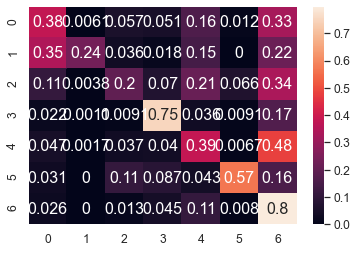

	training epoch=29 .. train_loss=1.038
	validation epoch=29 .. val_loss=1.257
	Accuracy = 53.800000000000004 % .. Percision = 58.3 % .. Recall = 47.4 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_29.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 30 .. loss = 1.103


  0%|                                                                                 | 1/1914 [00:01<34:25,  1.08s/it]

training @ epoch 30 .. loss = 0.85


  0%|                                                                                 | 2/1914 [00:02<34:35,  1.09s/it]

training @ epoch 30 .. loss = 0.846


  0%|▏                                                                                | 3/1914 [00:03<34:48,  1.09s/it]

training @ epoch 30 .. loss = 1.416


  0%|▏                                                                                | 4/1914 [00:04<34:40,  1.09s/it]

training @ epoch 30 .. loss = 0.822


  0%|▏                                                                                | 5/1914 [00:05<34:34,  1.09s/it]

training @ epoch 30 .. loss = 1.168


  0%|▎                                                                                | 6/1914 [00:06<34:29,  1.08s/it]

training @ epoch 30 .. loss = 0.816


  0%|▎                                                                                | 7/1914 [00:07<34:08,  1.07s/it]

training @ epoch 30 .. loss = 0.903


  0%|▎                                                                                | 8/1914 [00:08<34:14,  1.08s/it]

training @ epoch 30 .. loss = 1.185


  0%|▍                                                                                | 9/1914 [00:09<34:16,  1.08s/it]

training @ epoch 30 .. loss = 0.962


  1%|▍                                                                               | 10/1914 [00:10<34:15,  1.08s/it]

training @ epoch 30 .. loss = 0.753


  1%|▍                                                                               | 11/1914 [00:11<34:22,  1.08s/it]

training @ epoch 30 .. loss = 1.222


  1%|▌                                                                               | 12/1914 [00:12<34:05,  1.08s/it]

training @ epoch 30 .. loss = 0.999


  1%|▌                                                                               | 13/1914 [00:14<34:12,  1.08s/it]

training @ epoch 30 .. loss = 1.038


  1%|▌                                                                               | 14/1914 [00:15<34:06,  1.08s/it]

training @ epoch 30 .. loss = 1.107


  1%|▋                                                                               | 15/1914 [00:16<34:06,  1.08s/it]

training @ epoch 30 .. loss = 0.649


  1%|▋                                                                               | 16/1914 [00:17<34:09,  1.08s/it]

training @ epoch 30 .. loss = 1.177


  1%|▋                                                                               | 17/1914 [00:18<34:00,  1.08s/it]

training @ epoch 30 .. loss = 1.182


  1%|▊                                                                               | 18/1914 [00:19<33:50,  1.07s/it]

training @ epoch 30 .. loss = 1.174


  1%|▊                                                                               | 19/1914 [00:20<34:11,  1.08s/it]

training @ epoch 30 .. loss = 0.845


  1%|▊                                                                               | 20/1914 [00:21<34:20,  1.09s/it]

training @ epoch 30 .. loss = 1.24


  1%|▉                                                                               | 21/1914 [00:22<34:28,  1.09s/it]

training @ epoch 30 .. loss = 1.141


  1%|▉                                                                               | 22/1914 [00:23<34:46,  1.10s/it]

training @ epoch 30 .. loss = 0.717


  1%|▉                                                                               | 23/1914 [00:25<35:11,  1.12s/it]

training @ epoch 30 .. loss = 1.475


  1%|█                                                                               | 24/1914 [00:26<35:18,  1.12s/it]

training @ epoch 30 .. loss = 0.601


  1%|█                                                                               | 25/1914 [00:27<35:05,  1.11s/it]

training @ epoch 30 .. loss = 1.27


  1%|█                                                                               | 26/1914 [00:28<35:52,  1.14s/it]

training @ epoch 30 .. loss = 1.015


  1%|█▏                                                                              | 27/1914 [00:29<35:17,  1.12s/it]

training @ epoch 30 .. loss = 0.77


  1%|█▏                                                                              | 28/1914 [00:30<35:00,  1.11s/it]

training @ epoch 30 .. loss = 0.378


  2%|█▏                                                                              | 29/1914 [00:31<35:44,  1.14s/it]

training @ epoch 30 .. loss = 1.306


  2%|█▎                                                                              | 30/1914 [00:32<35:11,  1.12s/it]

training @ epoch 30 .. loss = 1.129


  2%|█▎                                                                              | 31/1914 [00:33<34:36,  1.10s/it]

training @ epoch 30 .. loss = 0.995


  2%|█▎                                                                              | 32/1914 [00:35<34:33,  1.10s/it]

training @ epoch 30 .. loss = 1.03


  2%|█▍                                                                              | 33/1914 [00:36<34:03,  1.09s/it]

training @ epoch 30 .. loss = 0.856


  2%|█▍                                                                              | 34/1914 [00:37<33:58,  1.08s/it]

training @ epoch 30 .. loss = 0.736


  2%|█▍                                                                              | 35/1914 [00:38<34:06,  1.09s/it]

training @ epoch 30 .. loss = 1.056


  2%|█▌                                                                              | 36/1914 [00:39<33:54,  1.08s/it]

training @ epoch 30 .. loss = 1.215


  2%|█▌                                                                              | 37/1914 [00:40<33:34,  1.07s/it]

training @ epoch 30 .. loss = 1.044


  2%|█▌                                                                              | 38/1914 [00:41<33:59,  1.09s/it]

training @ epoch 30 .. loss = 1.2


  2%|█▋                                                                              | 39/1914 [00:42<35:02,  1.12s/it]

training @ epoch 30 .. loss = 1.008


  2%|█▋                                                                              | 40/1914 [00:43<35:00,  1.12s/it]

training @ epoch 30 .. loss = 0.962


  2%|█▋                                                                              | 41/1914 [00:44<35:09,  1.13s/it]

training @ epoch 30 .. loss = 1.215


  2%|█▊                                                                              | 42/1914 [00:46<36:01,  1.15s/it]

training @ epoch 30 .. loss = 0.908


  2%|█▊                                                                              | 43/1914 [00:47<37:21,  1.20s/it]

training @ epoch 30 .. loss = 0.845


  2%|█▊                                                                              | 44/1914 [00:48<36:59,  1.19s/it]

training @ epoch 30 .. loss = 1.305


  2%|█▉                                                                              | 45/1914 [00:49<38:12,  1.23s/it]

training @ epoch 30 .. loss = 1.049


  2%|█▉                                                                              | 46/1914 [00:51<38:58,  1.25s/it]

training @ epoch 30 .. loss = 0.812


  2%|█▉                                                                              | 47/1914 [00:52<37:26,  1.20s/it]

training @ epoch 30 .. loss = 1.021


  3%|██                                                                              | 48/1914 [00:53<36:32,  1.18s/it]

training @ epoch 30 .. loss = 0.817


  3%|██                                                                              | 49/1914 [00:54<36:12,  1.16s/it]

training @ epoch 30 .. loss = 0.947


  3%|██                                                                              | 50/1914 [00:55<35:45,  1.15s/it]

training @ epoch 30 .. loss = 1.142


  3%|██▏                                                                             | 51/1914 [00:56<35:38,  1.15s/it]

training @ epoch 30 .. loss = 0.903


  3%|██▏                                                                             | 52/1914 [00:57<34:42,  1.12s/it]

training @ epoch 30 .. loss = 0.931


  3%|██▏                                                                             | 53/1914 [00:59<34:44,  1.12s/it]

training @ epoch 30 .. loss = 1.274


  3%|██▎                                                                             | 54/1914 [01:00<34:38,  1.12s/it]

training @ epoch 30 .. loss = 1.072


  3%|██▎                                                                             | 55/1914 [01:01<34:10,  1.10s/it]

training @ epoch 30 .. loss = 1.101


  3%|██▎                                                                             | 56/1914 [01:02<33:31,  1.08s/it]

training @ epoch 30 .. loss = 0.819


  3%|██▍                                                                             | 57/1914 [01:03<33:45,  1.09s/it]

training @ epoch 30 .. loss = 1.138


  3%|██▍                                                                             | 58/1914 [01:04<33:44,  1.09s/it]

training @ epoch 30 .. loss = 1.314


  3%|██▍                                                                             | 59/1914 [01:05<33:45,  1.09s/it]

training @ epoch 30 .. loss = 0.983


  3%|██▌                                                                             | 60/1914 [01:06<34:02,  1.10s/it]

training @ epoch 30 .. loss = 0.861


  3%|██▌                                                                             | 61/1914 [01:07<33:50,  1.10s/it]

training @ epoch 30 .. loss = 0.809


  3%|██▌                                                                             | 62/1914 [01:08<33:39,  1.09s/it]

training @ epoch 30 .. loss = 1.266


  3%|██▋                                                                             | 63/1914 [01:09<33:45,  1.09s/it]

training @ epoch 30 .. loss = 1.081


  3%|██▋                                                                             | 64/1914 [01:11<33:40,  1.09s/it]

training @ epoch 30 .. loss = 0.909


  3%|██▋                                                                             | 65/1914 [01:12<33:38,  1.09s/it]

training @ epoch 30 .. loss = 1.005


  3%|██▊                                                                             | 66/1914 [01:13<33:30,  1.09s/it]

training @ epoch 30 .. loss = 0.656


  4%|██▊                                                                             | 67/1914 [01:14<33:25,  1.09s/it]

training @ epoch 30 .. loss = 0.892


  4%|██▊                                                                             | 68/1914 [01:15<33:09,  1.08s/it]

training @ epoch 30 .. loss = 1.152


  4%|██▉                                                                             | 69/1914 [01:16<33:04,  1.08s/it]

training @ epoch 30 .. loss = 0.895


  4%|██▉                                                                             | 70/1914 [01:17<33:00,  1.07s/it]

training @ epoch 30 .. loss = 1.19


  4%|██▉                                                                             | 71/1914 [01:18<32:56,  1.07s/it]

training @ epoch 30 .. loss = 0.861


  4%|███                                                                             | 72/1914 [01:19<33:16,  1.08s/it]

training @ epoch 30 .. loss = 0.713


  4%|███                                                                             | 73/1914 [01:20<32:56,  1.07s/it]

training @ epoch 30 .. loss = 1.143


  4%|███                                                                             | 74/1914 [01:21<33:20,  1.09s/it]

training @ epoch 30 .. loss = 0.852


  4%|███▏                                                                            | 75/1914 [01:22<33:38,  1.10s/it]

training @ epoch 30 .. loss = 0.674


  4%|███▏                                                                            | 76/1914 [01:24<33:38,  1.10s/it]

training @ epoch 30 .. loss = 1.026


  4%|███▏                                                                            | 77/1914 [01:25<33:46,  1.10s/it]

training @ epoch 30 .. loss = 0.983


  4%|███▎                                                                            | 78/1914 [01:26<34:58,  1.14s/it]

training @ epoch 30 .. loss = 1.421


  4%|███▎                                                                            | 79/1914 [01:27<35:14,  1.15s/it]

training @ epoch 30 .. loss = 1.136


  4%|███▎                                                                            | 80/1914 [01:28<35:32,  1.16s/it]

training @ epoch 30 .. loss = 1.471


  4%|███▍                                                                            | 81/1914 [01:30<36:04,  1.18s/it]

training @ epoch 30 .. loss = 0.609


  4%|███▍                                                                            | 82/1914 [01:31<35:38,  1.17s/it]

training @ epoch 30 .. loss = 0.637


  4%|███▍                                                                            | 83/1914 [01:32<34:43,  1.14s/it]

training @ epoch 30 .. loss = 1.174


  4%|███▌                                                                            | 84/1914 [01:33<34:05,  1.12s/it]

training @ epoch 30 .. loss = 0.882


  4%|███▌                                                                            | 85/1914 [01:34<34:50,  1.14s/it]

training @ epoch 30 .. loss = 1.17


  4%|███▌                                                                            | 86/1914 [01:35<34:24,  1.13s/it]

training @ epoch 30 .. loss = 0.693


  5%|███▋                                                                            | 87/1914 [01:36<33:45,  1.11s/it]

training @ epoch 30 .. loss = 0.915


  5%|███▋                                                                            | 88/1914 [01:37<33:39,  1.11s/it]

training @ epoch 30 .. loss = 1.346


  5%|███▋                                                                            | 89/1914 [01:38<33:57,  1.12s/it]

training @ epoch 30 .. loss = 1.075


  5%|███▊                                                                            | 90/1914 [01:39<33:52,  1.11s/it]

training @ epoch 30 .. loss = 0.769


  5%|███▊                                                                            | 91/1914 [01:41<33:49,  1.11s/it]

training @ epoch 30 .. loss = 0.829


  5%|███▊                                                                            | 92/1914 [01:42<33:18,  1.10s/it]

training @ epoch 30 .. loss = 1.433


  5%|███▉                                                                            | 93/1914 [01:43<32:46,  1.08s/it]

training @ epoch 30 .. loss = 0.913


  5%|███▉                                                                            | 94/1914 [01:44<33:51,  1.12s/it]

training @ epoch 30 .. loss = 1.048


  5%|███▉                                                                            | 95/1914 [01:45<33:52,  1.12s/it]

training @ epoch 30 .. loss = 0.985


  5%|████                                                                            | 96/1914 [01:46<33:47,  1.12s/it]

training @ epoch 30 .. loss = 0.917


  5%|████                                                                            | 97/1914 [01:47<33:21,  1.10s/it]

training @ epoch 30 .. loss = 1.24


  5%|████                                                                            | 98/1914 [01:48<33:38,  1.11s/it]

training @ epoch 30 .. loss = 0.733


  5%|████▏                                                                           | 99/1914 [01:49<33:33,  1.11s/it]

training @ epoch 30 .. loss = 0.63


  5%|████▏                                                                          | 100/1914 [01:51<33:22,  1.10s/it]

training @ epoch 30 .. loss = 1.051


  5%|████▏                                                                          | 101/1914 [01:52<33:13,  1.10s/it]

training @ epoch 30 .. loss = 0.927


  5%|████▏                                                                          | 102/1914 [01:53<33:10,  1.10s/it]

training @ epoch 30 .. loss = 1.034


  5%|████▎                                                                          | 103/1914 [01:54<33:50,  1.12s/it]

training @ epoch 30 .. loss = 0.626


  5%|████▎                                                                          | 104/1914 [01:55<33:37,  1.11s/it]

training @ epoch 30 .. loss = 0.849


  5%|████▎                                                                          | 105/1914 [01:56<33:23,  1.11s/it]

training @ epoch 30 .. loss = 0.635


  6%|████▍                                                                          | 106/1914 [01:57<33:18,  1.11s/it]

training @ epoch 30 .. loss = 1.125


  6%|████▍                                                                          | 107/1914 [01:58<33:08,  1.10s/it]

training @ epoch 30 .. loss = 1.604


  6%|████▍                                                                          | 108/1914 [01:59<33:20,  1.11s/it]

training @ epoch 30 .. loss = 1.026


  6%|████▍                                                                          | 109/1914 [02:00<32:56,  1.10s/it]

training @ epoch 30 .. loss = 0.828


  6%|████▌                                                                          | 110/1914 [02:02<32:36,  1.08s/it]

training @ epoch 30 .. loss = 0.726


  6%|████▌                                                                          | 111/1914 [02:03<32:22,  1.08s/it]

training @ epoch 30 .. loss = 0.781


  6%|████▌                                                                          | 112/1914 [02:04<33:03,  1.10s/it]

training @ epoch 30 .. loss = 1.165


  6%|████▋                                                                          | 113/1914 [02:05<32:42,  1.09s/it]

training @ epoch 30 .. loss = 0.84


  6%|████▋                                                                          | 114/1914 [02:06<32:36,  1.09s/it]

training @ epoch 30 .. loss = 1.262


  6%|████▋                                                                          | 115/1914 [02:07<33:20,  1.11s/it]

training @ epoch 30 .. loss = 1.221


  6%|████▊                                                                          | 116/1914 [02:08<33:01,  1.10s/it]

training @ epoch 30 .. loss = 1.023


  6%|████▊                                                                          | 117/1914 [02:09<32:57,  1.10s/it]

training @ epoch 30 .. loss = 1.044


  6%|████▊                                                                          | 118/1914 [02:10<32:37,  1.09s/it]

training @ epoch 30 .. loss = 1.255


  6%|████▉                                                                          | 119/1914 [02:11<32:16,  1.08s/it]

training @ epoch 30 .. loss = 0.977


  6%|████▉                                                                          | 120/1914 [02:12<32:21,  1.08s/it]

training @ epoch 30 .. loss = 1.288


  6%|████▉                                                                          | 121/1914 [02:14<32:22,  1.08s/it]

training @ epoch 30 .. loss = 1.03


  6%|█████                                                                          | 122/1914 [02:15<32:19,  1.08s/it]

training @ epoch 30 .. loss = 0.966


  6%|█████                                                                          | 123/1914 [02:16<32:00,  1.07s/it]

training @ epoch 30 .. loss = 0.847


  6%|█████                                                                          | 124/1914 [02:17<31:58,  1.07s/it]

training @ epoch 30 .. loss = 0.912


  7%|█████▏                                                                         | 125/1914 [02:18<31:56,  1.07s/it]

training @ epoch 30 .. loss = 0.866


  7%|█████▏                                                                         | 126/1914 [02:19<31:38,  1.06s/it]

training @ epoch 30 .. loss = 1.159


  7%|█████▏                                                                         | 127/1914 [02:20<31:47,  1.07s/it]

training @ epoch 30 .. loss = 1.028


  7%|█████▎                                                                         | 128/1914 [02:21<31:58,  1.07s/it]

training @ epoch 30 .. loss = 1.057


  7%|█████▎                                                                         | 129/1914 [02:22<32:00,  1.08s/it]

training @ epoch 30 .. loss = 1.31


  7%|█████▎                                                                         | 130/1914 [02:23<32:01,  1.08s/it]

training @ epoch 30 .. loss = 1.141


  7%|█████▍                                                                         | 131/1914 [02:24<31:51,  1.07s/it]

training @ epoch 30 .. loss = 1.209


  7%|█████▍                                                                         | 132/1914 [02:25<31:54,  1.07s/it]

training @ epoch 30 .. loss = 1.264


  7%|█████▍                                                                         | 133/1914 [02:26<32:01,  1.08s/it]

training @ epoch 30 .. loss = 1.364


  7%|█████▌                                                                         | 134/1914 [02:28<32:17,  1.09s/it]

training @ epoch 30 .. loss = 1.094


  7%|█████▌                                                                         | 135/1914 [02:29<32:17,  1.09s/it]

training @ epoch 30 .. loss = 0.753


  7%|█████▌                                                                         | 136/1914 [02:30<32:00,  1.08s/it]

training @ epoch 30 .. loss = 1.114


  7%|█████▋                                                                         | 137/1914 [02:31<31:54,  1.08s/it]

training @ epoch 30 .. loss = 0.963


  7%|█████▋                                                                         | 138/1914 [02:32<31:43,  1.07s/it]

training @ epoch 30 .. loss = 0.791


  7%|█████▋                                                                         | 139/1914 [02:33<31:46,  1.07s/it]

training @ epoch 30 .. loss = 0.761


  7%|█████▊                                                                         | 140/1914 [02:34<31:59,  1.08s/it]

training @ epoch 30 .. loss = 1.245


  7%|█████▊                                                                         | 141/1914 [02:35<33:01,  1.12s/it]

training @ epoch 30 .. loss = 0.743


  7%|█████▊                                                                         | 142/1914 [02:36<33:23,  1.13s/it]

training @ epoch 30 .. loss = 1.032


  7%|█████▉                                                                         | 143/1914 [02:37<32:44,  1.11s/it]

training @ epoch 30 .. loss = 1.205


  8%|█████▉                                                                         | 144/1914 [02:38<32:32,  1.10s/it]

training @ epoch 30 .. loss = 0.661


  8%|█████▉                                                                         | 145/1914 [02:40<33:08,  1.12s/it]

training @ epoch 30 .. loss = 0.629


  8%|██████                                                                         | 146/1914 [02:41<33:51,  1.15s/it]

training @ epoch 30 .. loss = 0.802


  8%|██████                                                                         | 147/1914 [02:42<33:56,  1.15s/it]

training @ epoch 30 .. loss = 1.031


  8%|██████                                                                         | 148/1914 [02:43<33:37,  1.14s/it]

training @ epoch 30 .. loss = 1.629


  8%|██████▏                                                                        | 149/1914 [02:44<33:39,  1.14s/it]

training @ epoch 30 .. loss = 0.785


  8%|██████▏                                                                        | 150/1914 [02:45<33:16,  1.13s/it]

training @ epoch 30 .. loss = 1.424


  8%|██████▏                                                                        | 151/1914 [02:46<32:45,  1.11s/it]

training @ epoch 30 .. loss = 1.068


  8%|██████▎                                                                        | 152/1914 [02:48<32:23,  1.10s/it]

training @ epoch 30 .. loss = 0.9


  8%|██████▎                                                                        | 153/1914 [02:49<32:20,  1.10s/it]

training @ epoch 30 .. loss = 0.967


  8%|██████▎                                                                        | 154/1914 [02:50<32:07,  1.10s/it]

training @ epoch 30 .. loss = 1.37


  8%|██████▍                                                                        | 155/1914 [02:51<32:08,  1.10s/it]

training @ epoch 30 .. loss = 1.118


  8%|██████▍                                                                        | 156/1914 [02:52<32:01,  1.09s/it]

training @ epoch 30 .. loss = 1.363


  8%|██████▍                                                                        | 157/1914 [02:53<31:35,  1.08s/it]

training @ epoch 30 .. loss = 1.577


  8%|██████▌                                                                        | 158/1914 [02:54<31:34,  1.08s/it]

training @ epoch 30 .. loss = 1.034


  8%|██████▌                                                                        | 159/1914 [02:55<32:19,  1.10s/it]

training @ epoch 30 .. loss = 1.39


  8%|██████▌                                                                        | 160/1914 [02:56<32:10,  1.10s/it]

training @ epoch 30 .. loss = 1.04


  8%|██████▋                                                                        | 161/1914 [02:57<31:58,  1.09s/it]

training @ epoch 30 .. loss = 1.02


  8%|██████▋                                                                        | 162/1914 [02:58<31:36,  1.08s/it]

training @ epoch 30 .. loss = 1.357


  9%|██████▋                                                                        | 163/1914 [03:00<31:44,  1.09s/it]

training @ epoch 30 .. loss = 1.308


  9%|██████▊                                                                        | 164/1914 [03:01<31:34,  1.08s/it]

training @ epoch 30 .. loss = 1.214


  9%|██████▊                                                                        | 165/1914 [03:02<31:42,  1.09s/it]

training @ epoch 30 .. loss = 1.375


  9%|██████▊                                                                        | 166/1914 [03:03<31:47,  1.09s/it]

training @ epoch 30 .. loss = 0.762


  9%|██████▉                                                                        | 167/1914 [03:04<31:48,  1.09s/it]

training @ epoch 30 .. loss = 1.042


  9%|██████▉                                                                        | 168/1914 [03:05<31:38,  1.09s/it]

training @ epoch 30 .. loss = 0.699


  9%|██████▉                                                                        | 169/1914 [03:06<31:17,  1.08s/it]

training @ epoch 30 .. loss = 1.397


  9%|███████                                                                        | 170/1914 [03:07<31:44,  1.09s/it]

training @ epoch 30 .. loss = 1.198


  9%|███████                                                                        | 171/1914 [03:08<31:42,  1.09s/it]

training @ epoch 30 .. loss = 1.064


  9%|███████                                                                        | 172/1914 [03:09<31:45,  1.09s/it]

training @ epoch 30 .. loss = 0.749


  9%|███████▏                                                                       | 173/1914 [03:10<31:32,  1.09s/it]

training @ epoch 30 .. loss = 0.964


  9%|███████▏                                                                       | 174/1914 [03:11<31:06,  1.07s/it]

training @ epoch 30 .. loss = 1.428


  9%|███████▏                                                                       | 175/1914 [03:13<31:22,  1.08s/it]

training @ epoch 30 .. loss = 1.151


  9%|███████▎                                                                       | 176/1914 [03:14<31:12,  1.08s/it]

training @ epoch 30 .. loss = 1.119


  9%|███████▎                                                                       | 177/1914 [03:15<31:18,  1.08s/it]

training @ epoch 30 .. loss = 1.273


  9%|███████▎                                                                       | 178/1914 [03:16<31:18,  1.08s/it]

training @ epoch 30 .. loss = 1.016


  9%|███████▍                                                                       | 179/1914 [03:17<31:29,  1.09s/it]

training @ epoch 30 .. loss = 1.068


  9%|███████▍                                                                       | 180/1914 [03:18<31:23,  1.09s/it]

training @ epoch 30 .. loss = 0.981


  9%|███████▍                                                                       | 181/1914 [03:19<31:24,  1.09s/it]

training @ epoch 30 .. loss = 0.927


 10%|███████▌                                                                       | 182/1914 [03:20<31:24,  1.09s/it]

training @ epoch 30 .. loss = 0.85


 10%|███████▌                                                                       | 183/1914 [03:21<31:09,  1.08s/it]

training @ epoch 30 .. loss = 1.161


 10%|███████▌                                                                       | 184/1914 [03:22<31:18,  1.09s/it]

training @ epoch 30 .. loss = 0.892


 10%|███████▋                                                                       | 185/1914 [03:23<32:06,  1.11s/it]

training @ epoch 30 .. loss = 0.924


 10%|███████▋                                                                       | 186/1914 [03:25<32:34,  1.13s/it]

training @ epoch 30 .. loss = 1.063


 10%|███████▋                                                                       | 187/1914 [03:26<32:04,  1.11s/it]

training @ epoch 30 .. loss = 1.257


 10%|███████▊                                                                       | 188/1914 [03:27<31:47,  1.11s/it]

training @ epoch 30 .. loss = 0.732


 10%|███████▊                                                                       | 189/1914 [03:28<32:04,  1.12s/it]

training @ epoch 30 .. loss = 1.13


 10%|███████▊                                                                       | 190/1914 [03:29<32:05,  1.12s/it]

training @ epoch 30 .. loss = 1.01


 10%|███████▉                                                                       | 191/1914 [03:30<31:53,  1.11s/it]

training @ epoch 30 .. loss = 0.906


 10%|███████▉                                                                       | 192/1914 [03:31<31:44,  1.11s/it]

training @ epoch 30 .. loss = 1.035


 10%|███████▉                                                                       | 193/1914 [03:32<31:29,  1.10s/it]

training @ epoch 30 .. loss = 0.687


 10%|████████                                                                       | 194/1914 [03:33<31:06,  1.09s/it]

training @ epoch 30 .. loss = 0.577


 10%|████████                                                                       | 195/1914 [03:34<31:10,  1.09s/it]

training @ epoch 30 .. loss = 0.685


 10%|████████                                                                       | 196/1914 [03:36<31:15,  1.09s/it]

training @ epoch 30 .. loss = 0.725


 10%|████████▏                                                                      | 197/1914 [03:37<31:08,  1.09s/it]

training @ epoch 30 .. loss = 0.808


 10%|████████▏                                                                      | 198/1914 [03:38<31:10,  1.09s/it]

training @ epoch 30 .. loss = 0.742


 10%|████████▏                                                                      | 199/1914 [03:39<31:04,  1.09s/it]

training @ epoch 30 .. loss = 0.685


 10%|████████▎                                                                      | 200/1914 [03:40<31:17,  1.10s/it]

training @ epoch 30 .. loss = 1.126


 11%|████████▎                                                                      | 201/1914 [03:41<32:10,  1.13s/it]

training @ epoch 30 .. loss = 0.902


 11%|████████▎                                                                      | 202/1914 [03:42<31:55,  1.12s/it]

training @ epoch 30 .. loss = 0.913


 11%|████████▍                                                                      | 203/1914 [03:43<31:34,  1.11s/it]

training @ epoch 30 .. loss = 0.696


 11%|████████▍                                                                      | 204/1914 [03:44<31:20,  1.10s/it]

training @ epoch 30 .. loss = 1.063


 11%|████████▍                                                                      | 205/1914 [03:46<31:54,  1.12s/it]

training @ epoch 30 .. loss = 1.239


 11%|████████▌                                                                      | 206/1914 [03:47<31:37,  1.11s/it]

training @ epoch 30 .. loss = 0.871


 11%|████████▌                                                                      | 207/1914 [03:48<31:15,  1.10s/it]

training @ epoch 30 .. loss = 1.368


 11%|████████▌                                                                      | 208/1914 [03:49<30:44,  1.08s/it]

training @ epoch 30 .. loss = 0.718


 11%|████████▋                                                                      | 209/1914 [03:50<30:32,  1.07s/it]

training @ epoch 30 .. loss = 1.008


 11%|████████▋                                                                      | 210/1914 [03:51<30:39,  1.08s/it]

training @ epoch 30 .. loss = 0.588


 11%|████████▋                                                                      | 211/1914 [03:52<30:43,  1.08s/it]

training @ epoch 30 .. loss = 0.807


 11%|████████▊                                                                      | 212/1914 [03:53<30:46,  1.08s/it]

training @ epoch 30 .. loss = 1.518


 11%|████████▊                                                                      | 213/1914 [03:54<30:32,  1.08s/it]

training @ epoch 30 .. loss = 0.68


 11%|████████▊                                                                      | 214/1914 [03:55<30:42,  1.08s/it]

training @ epoch 30 .. loss = 1.36


 11%|████████▊                                                                      | 215/1914 [03:56<30:50,  1.09s/it]

training @ epoch 30 .. loss = 1.95


 11%|████████▉                                                                      | 216/1914 [03:57<30:52,  1.09s/it]

training @ epoch 30 .. loss = 1.22


 11%|████████▉                                                                      | 217/1914 [03:59<31:03,  1.10s/it]

training @ epoch 30 .. loss = 1.226


 11%|████████▉                                                                      | 218/1914 [04:00<30:48,  1.09s/it]

training @ epoch 30 .. loss = 1.114


 11%|█████████                                                                      | 219/1914 [04:01<30:34,  1.08s/it]

training @ epoch 30 .. loss = 0.998


 11%|█████████                                                                      | 220/1914 [04:02<30:37,  1.08s/it]

training @ epoch 30 .. loss = 1.232


 12%|█████████                                                                      | 221/1914 [04:03<30:41,  1.09s/it]

training @ epoch 30 .. loss = 1.302


 12%|█████████▏                                                                     | 222/1914 [04:04<30:41,  1.09s/it]

training @ epoch 30 .. loss = 0.929


 12%|█████████▏                                                                     | 223/1914 [04:05<30:56,  1.10s/it]

training @ epoch 30 .. loss = 0.696


 12%|█████████▏                                                                     | 224/1914 [04:06<30:41,  1.09s/it]

training @ epoch 30 .. loss = 1.053


 12%|█████████▎                                                                     | 225/1914 [04:07<30:35,  1.09s/it]

training @ epoch 30 .. loss = 1.178


 12%|█████████▎                                                                     | 226/1914 [04:08<30:35,  1.09s/it]

training @ epoch 30 .. loss = 0.851


 12%|█████████▎                                                                     | 227/1914 [04:09<30:30,  1.09s/it]

training @ epoch 30 .. loss = 1.04


 12%|█████████▍                                                                     | 228/1914 [04:11<30:47,  1.10s/it]

training @ epoch 30 .. loss = 1.695


 12%|█████████▍                                                                     | 229/1914 [04:12<30:33,  1.09s/it]

training @ epoch 30 .. loss = 0.529


 12%|█████████▍                                                                     | 230/1914 [04:13<33:17,  1.19s/it]

training @ epoch 30 .. loss = 0.937


 12%|█████████▌                                                                     | 231/1914 [04:14<33:56,  1.21s/it]

training @ epoch 30 .. loss = 0.998


 12%|█████████▌                                                                     | 232/1914 [04:16<34:10,  1.22s/it]

training @ epoch 30 .. loss = 0.82


 12%|█████████▌                                                                     | 233/1914 [04:17<32:53,  1.17s/it]

training @ epoch 30 .. loss = 0.777


 12%|█████████▋                                                                     | 234/1914 [04:18<31:50,  1.14s/it]

training @ epoch 30 .. loss = 0.835


 12%|█████████▋                                                                     | 235/1914 [04:19<31:05,  1.11s/it]

training @ epoch 30 .. loss = 0.693


 12%|█████████▋                                                                     | 236/1914 [04:20<30:43,  1.10s/it]

training @ epoch 30 .. loss = 0.843


 12%|█████████▊                                                                     | 237/1914 [04:21<30:18,  1.08s/it]

training @ epoch 30 .. loss = 1.332


 12%|█████████▊                                                                     | 238/1914 [04:22<30:04,  1.08s/it]

training @ epoch 30 .. loss = 0.558


 12%|█████████▊                                                                     | 239/1914 [04:23<30:27,  1.09s/it]

training @ epoch 30 .. loss = 0.997


 13%|█████████▉                                                                     | 240/1914 [04:24<30:47,  1.10s/it]

training @ epoch 30 .. loss = 1.029


 13%|█████████▉                                                                     | 241/1914 [04:25<31:00,  1.11s/it]

training @ epoch 30 .. loss = 0.843


 13%|█████████▉                                                                     | 242/1914 [04:26<30:48,  1.11s/it]

training @ epoch 30 .. loss = 1.101


 13%|██████████                                                                     | 243/1914 [04:28<30:54,  1.11s/it]

training @ epoch 30 .. loss = 1.264


 13%|██████████                                                                     | 244/1914 [04:29<30:28,  1.09s/it]

training @ epoch 30 .. loss = 0.977


 13%|██████████                                                                     | 245/1914 [04:30<30:32,  1.10s/it]

training @ epoch 30 .. loss = 0.957


 13%|██████████▏                                                                    | 246/1914 [04:31<30:09,  1.09s/it]

training @ epoch 30 .. loss = 1.279


 13%|██████████▏                                                                    | 247/1914 [04:32<30:21,  1.09s/it]

training @ epoch 30 .. loss = 0.892


 13%|██████████▏                                                                    | 248/1914 [04:33<30:08,  1.09s/it]

training @ epoch 30 .. loss = 0.962


 13%|██████████▎                                                                    | 249/1914 [04:34<30:20,  1.09s/it]

training @ epoch 30 .. loss = 0.792


 13%|██████████▎                                                                    | 250/1914 [04:35<30:12,  1.09s/it]

training @ epoch 30 .. loss = 1.132


 13%|██████████▎                                                                    | 251/1914 [04:36<30:21,  1.10s/it]

training @ epoch 30 .. loss = 1.454


 13%|██████████▍                                                                    | 252/1914 [04:37<30:22,  1.10s/it]

training @ epoch 30 .. loss = 0.833


 13%|██████████▍                                                                    | 253/1914 [04:38<30:18,  1.09s/it]

training @ epoch 30 .. loss = 1.037


 13%|██████████▍                                                                    | 254/1914 [04:39<29:59,  1.08s/it]

training @ epoch 30 .. loss = 0.915


 13%|██████████▌                                                                    | 255/1914 [04:41<30:16,  1.10s/it]

training @ epoch 30 .. loss = 0.686


 13%|██████████▌                                                                    | 256/1914 [04:42<30:32,  1.11s/it]

training @ epoch 30 .. loss = 0.684


 13%|██████████▌                                                                    | 257/1914 [04:43<30:19,  1.10s/it]

training @ epoch 30 .. loss = 1.297


 13%|██████████▋                                                                    | 258/1914 [04:44<30:09,  1.09s/it]

training @ epoch 30 .. loss = 1.046


 14%|██████████▋                                                                    | 259/1914 [04:45<30:26,  1.10s/it]

training @ epoch 30 .. loss = 0.827


 14%|██████████▋                                                                    | 260/1914 [04:46<31:08,  1.13s/it]

training @ epoch 30 .. loss = 1.028


 14%|██████████▊                                                                    | 261/1914 [04:47<31:22,  1.14s/it]

training @ epoch 30 .. loss = 0.851


 14%|██████████▊                                                                    | 262/1914 [04:48<30:51,  1.12s/it]

training @ epoch 30 .. loss = 0.845


 14%|██████████▊                                                                    | 263/1914 [04:50<30:45,  1.12s/it]

training @ epoch 30 .. loss = 0.913


 14%|██████████▉                                                                    | 264/1914 [04:51<30:25,  1.11s/it]

training @ epoch 30 .. loss = 0.987


 14%|██████████▉                                                                    | 265/1914 [04:52<31:47,  1.16s/it]

training @ epoch 30 .. loss = 0.933


 14%|██████████▉                                                                    | 266/1914 [04:53<33:34,  1.22s/it]

training @ epoch 30 .. loss = 1.314


 14%|███████████                                                                    | 267/1914 [04:55<34:16,  1.25s/it]

training @ epoch 30 .. loss = 0.938


 14%|███████████                                                                    | 268/1914 [04:56<34:06,  1.24s/it]

training @ epoch 30 .. loss = 1.132


 14%|███████████                                                                    | 269/1914 [04:57<35:18,  1.29s/it]

training @ epoch 30 .. loss = 1.09


 14%|███████████▏                                                                   | 270/1914 [04:58<34:30,  1.26s/it]

training @ epoch 30 .. loss = 0.971


 14%|███████████▏                                                                   | 271/1914 [04:59<33:00,  1.21s/it]

training @ epoch 30 .. loss = 1.006


 14%|███████████▏                                                                   | 272/1914 [05:01<31:45,  1.16s/it]

training @ epoch 30 .. loss = 0.951


 14%|███████████▎                                                                   | 273/1914 [05:02<31:04,  1.14s/it]

training @ epoch 30 .. loss = 0.776


 14%|███████████▎                                                                   | 274/1914 [05:03<30:50,  1.13s/it]

training @ epoch 30 .. loss = 1.326


 14%|███████████▎                                                                   | 275/1914 [05:04<31:09,  1.14s/it]

training @ epoch 30 .. loss = 1.067


 14%|███████████▍                                                                   | 276/1914 [05:05<30:53,  1.13s/it]

training @ epoch 30 .. loss = 1.523


 14%|███████████▍                                                                   | 277/1914 [05:06<30:51,  1.13s/it]

training @ epoch 30 .. loss = 1.177


 15%|███████████▍                                                                   | 278/1914 [05:07<30:35,  1.12s/it]

training @ epoch 30 .. loss = 0.662


 15%|███████████▌                                                                   | 279/1914 [05:08<30:03,  1.10s/it]

training @ epoch 30 .. loss = 0.827


 15%|███████████▌                                                                   | 280/1914 [05:09<29:46,  1.09s/it]

training @ epoch 30 .. loss = 1.092


 15%|███████████▌                                                                   | 281/1914 [05:10<29:53,  1.10s/it]

training @ epoch 30 .. loss = 0.766


 15%|███████████▋                                                                   | 282/1914 [05:12<29:38,  1.09s/it]

training @ epoch 30 .. loss = 1.03


 15%|███████████▋                                                                   | 283/1914 [05:13<29:32,  1.09s/it]

training @ epoch 30 .. loss = 1.311


 15%|███████████▋                                                                   | 284/1914 [05:14<29:13,  1.08s/it]

training @ epoch 30 .. loss = 1.407


 15%|███████████▊                                                                   | 285/1914 [05:15<29:21,  1.08s/it]

training @ epoch 30 .. loss = 1.075


 15%|███████████▊                                                                   | 286/1914 [05:16<29:37,  1.09s/it]

training @ epoch 30 .. loss = 0.891


 15%|███████████▊                                                                   | 287/1914 [05:17<29:35,  1.09s/it]

training @ epoch 30 .. loss = 0.956


 15%|███████████▉                                                                   | 288/1914 [05:18<29:14,  1.08s/it]

training @ epoch 30 .. loss = 1.273


 15%|███████████▉                                                                   | 289/1914 [05:19<29:23,  1.09s/it]

training @ epoch 30 .. loss = 1.199


 15%|███████████▉                                                                   | 290/1914 [05:20<29:45,  1.10s/it]

training @ epoch 30 .. loss = 0.982


 15%|████████████                                                                   | 291/1914 [05:21<30:17,  1.12s/it]

training @ epoch 30 .. loss = 0.743


 15%|████████████                                                                   | 292/1914 [05:23<30:04,  1.11s/it]

training @ epoch 30 .. loss = 0.763


 15%|████████████                                                                   | 293/1914 [05:24<29:54,  1.11s/it]

training @ epoch 30 .. loss = 1.421


 15%|████████████▏                                                                  | 294/1914 [05:25<29:35,  1.10s/it]

training @ epoch 30 .. loss = 1.189


 15%|████████████▏                                                                  | 295/1914 [05:26<29:46,  1.10s/it]

training @ epoch 30 .. loss = 0.827


 15%|████████████▏                                                                  | 296/1914 [05:27<30:19,  1.12s/it]

training @ epoch 30 .. loss = 1.02


 16%|████████████▎                                                                  | 297/1914 [05:28<29:47,  1.11s/it]

training @ epoch 30 .. loss = 1.773


 16%|████████████▎                                                                  | 298/1914 [05:29<29:41,  1.10s/it]

training @ epoch 30 .. loss = 0.705


 16%|████████████▎                                                                  | 299/1914 [05:30<29:31,  1.10s/it]

training @ epoch 30 .. loss = 0.799


 16%|████████████▍                                                                  | 300/1914 [05:31<29:39,  1.10s/it]

training @ epoch 30 .. loss = 0.754


 16%|████████████▍                                                                  | 301/1914 [05:32<29:27,  1.10s/it]

training @ epoch 30 .. loss = 0.891


 16%|████████████▍                                                                  | 302/1914 [05:34<29:33,  1.10s/it]

training @ epoch 30 .. loss = 1.309


 16%|████████████▌                                                                  | 303/1914 [05:35<29:22,  1.09s/it]

training @ epoch 30 .. loss = 0.781


 16%|████████████▌                                                                  | 304/1914 [05:36<29:19,  1.09s/it]

training @ epoch 30 .. loss = 1.139


 16%|████████████▌                                                                  | 305/1914 [05:37<29:02,  1.08s/it]

training @ epoch 30 .. loss = 0.916


 16%|████████████▋                                                                  | 306/1914 [05:38<28:59,  1.08s/it]

training @ epoch 30 .. loss = 1.33


 16%|████████████▋                                                                  | 307/1914 [05:39<28:57,  1.08s/it]

training @ epoch 30 .. loss = 1.097


 16%|████████████▋                                                                  | 308/1914 [05:40<29:00,  1.08s/it]

training @ epoch 30 .. loss = 0.946


 16%|████████████▊                                                                  | 309/1914 [05:41<29:14,  1.09s/it]

training @ epoch 30 .. loss = 0.874


 16%|████████████▊                                                                  | 310/1914 [05:42<29:00,  1.08s/it]

training @ epoch 30 .. loss = 0.656


 16%|████████████▊                                                                  | 311/1914 [05:43<28:56,  1.08s/it]

training @ epoch 30 .. loss = 1.294


 16%|████████████▉                                                                  | 312/1914 [05:44<28:53,  1.08s/it]

training @ epoch 30 .. loss = 1.196


 16%|████████████▉                                                                  | 313/1914 [05:45<28:56,  1.08s/it]

training @ epoch 30 .. loss = 1.495


 16%|████████████▉                                                                  | 314/1914 [05:47<28:58,  1.09s/it]

training @ epoch 30 .. loss = 0.714


 16%|█████████████                                                                  | 315/1914 [05:48<28:53,  1.08s/it]

training @ epoch 30 .. loss = 0.998


 17%|█████████████                                                                  | 316/1914 [05:49<28:38,  1.08s/it]

training @ epoch 30 .. loss = 0.997


 17%|█████████████                                                                  | 317/1914 [05:50<28:23,  1.07s/it]

training @ epoch 30 .. loss = 1.023


 17%|█████████████▏                                                                 | 318/1914 [05:51<28:33,  1.07s/it]

training @ epoch 30 .. loss = 0.802


 17%|█████████████▏                                                                 | 319/1914 [05:52<29:13,  1.10s/it]

training @ epoch 30 .. loss = 1.333


 17%|█████████████▏                                                                 | 320/1914 [05:53<29:36,  1.11s/it]

training @ epoch 30 .. loss = 1.074


 17%|█████████████▏                                                                 | 321/1914 [05:54<29:38,  1.12s/it]

training @ epoch 30 .. loss = 0.961


 17%|█████████████▎                                                                 | 322/1914 [05:55<29:48,  1.12s/it]

training @ epoch 30 .. loss = 0.909


 17%|█████████████▎                                                                 | 323/1914 [05:56<29:33,  1.11s/it]

training @ epoch 30 .. loss = 0.667


 17%|█████████████▎                                                                 | 324/1914 [05:58<30:39,  1.16s/it]

training @ epoch 30 .. loss = 1.297


 17%|█████████████▍                                                                 | 325/1914 [05:59<29:56,  1.13s/it]

training @ epoch 30 .. loss = 0.684


 17%|█████████████▍                                                                 | 326/1914 [06:00<29:36,  1.12s/it]

training @ epoch 30 .. loss = 1.994


 17%|█████████████▍                                                                 | 327/1914 [06:01<29:12,  1.10s/it]

training @ epoch 30 .. loss = 1.177


 17%|█████████████▌                                                                 | 328/1914 [06:02<29:20,  1.11s/it]

training @ epoch 30 .. loss = 1.051


 17%|█████████████▌                                                                 | 329/1914 [06:03<29:31,  1.12s/it]

training @ epoch 30 .. loss = 1.13


 17%|█████████████▌                                                                 | 330/1914 [06:04<29:07,  1.10s/it]

training @ epoch 30 .. loss = 0.873


 17%|█████████████▋                                                                 | 331/1914 [06:05<28:53,  1.09s/it]

training @ epoch 30 .. loss = 1.159


 17%|█████████████▋                                                                 | 332/1914 [06:06<28:42,  1.09s/it]

training @ epoch 30 .. loss = 0.935


 17%|█████████████▋                                                                 | 333/1914 [06:08<29:29,  1.12s/it]

training @ epoch 30 .. loss = 0.971


 17%|█████████████▊                                                                 | 334/1914 [06:09<29:14,  1.11s/it]

training @ epoch 30 .. loss = 0.969


 18%|█████████████▊                                                                 | 335/1914 [06:10<29:04,  1.10s/it]

training @ epoch 30 .. loss = 0.662


 18%|█████████████▊                                                                 | 336/1914 [06:11<28:41,  1.09s/it]

training @ epoch 30 .. loss = 0.987


 18%|█████████████▉                                                                 | 337/1914 [06:12<28:35,  1.09s/it]

training @ epoch 30 .. loss = 0.811


 18%|█████████████▉                                                                 | 338/1914 [06:13<28:20,  1.08s/it]

training @ epoch 30 .. loss = 1.282


 18%|█████████████▉                                                                 | 339/1914 [06:14<28:43,  1.09s/it]

training @ epoch 30 .. loss = 1.316


 18%|██████████████                                                                 | 340/1914 [06:15<28:45,  1.10s/it]

training @ epoch 30 .. loss = 0.728


 18%|██████████████                                                                 | 341/1914 [06:16<28:31,  1.09s/it]

training @ epoch 30 .. loss = 1.021


 18%|██████████████                                                                 | 342/1914 [06:17<28:26,  1.09s/it]

training @ epoch 30 .. loss = 0.937


 18%|██████████████▏                                                                | 343/1914 [06:18<28:13,  1.08s/it]

training @ epoch 30 .. loss = 0.768


 18%|██████████████▏                                                                | 344/1914 [06:20<28:13,  1.08s/it]

training @ epoch 30 .. loss = 1.064


 18%|██████████████▏                                                                | 345/1914 [06:21<28:22,  1.09s/it]

training @ epoch 30 .. loss = 1.211


 18%|██████████████▎                                                                | 346/1914 [06:22<28:28,  1.09s/it]

training @ epoch 30 .. loss = 0.785


 18%|██████████████▎                                                                | 347/1914 [06:23<28:22,  1.09s/it]

training @ epoch 30 .. loss = 0.908


 18%|██████████████▎                                                                | 348/1914 [06:24<28:18,  1.08s/it]

training @ epoch 30 .. loss = 1.094


 18%|██████████████▍                                                                | 349/1914 [06:25<28:29,  1.09s/it]

training @ epoch 30 .. loss = 0.879


 18%|██████████████▍                                                                | 350/1914 [06:26<28:22,  1.09s/it]

training @ epoch 30 .. loss = 1.157


 18%|██████████████▍                                                                | 351/1914 [06:27<29:58,  1.15s/it]

training @ epoch 30 .. loss = 1.283


 18%|██████████████▌                                                                | 352/1914 [06:29<32:01,  1.23s/it]

training @ epoch 30 .. loss = 0.783


 18%|██████████████▌                                                                | 353/1914 [06:30<31:38,  1.22s/it]

training @ epoch 30 .. loss = 1.403


 18%|██████████████▌                                                                | 354/1914 [06:31<31:27,  1.21s/it]

training @ epoch 30 .. loss = 0.861


 19%|██████████████▋                                                                | 355/1914 [06:32<31:12,  1.20s/it]

training @ epoch 30 .. loss = 0.914


 19%|██████████████▋                                                                | 356/1914 [06:33<30:35,  1.18s/it]

training @ epoch 30 .. loss = 0.631


 19%|██████████████▋                                                                | 357/1914 [06:35<30:19,  1.17s/it]

training @ epoch 30 .. loss = 1.086


 19%|██████████████▊                                                                | 358/1914 [06:36<29:32,  1.14s/it]

training @ epoch 30 .. loss = 1.314


 19%|██████████████▊                                                                | 359/1914 [06:37<29:23,  1.13s/it]

training @ epoch 30 .. loss = 0.633


 19%|██████████████▊                                                                | 360/1914 [06:38<29:20,  1.13s/it]

training @ epoch 30 .. loss = 1.204


 19%|██████████████▉                                                                | 361/1914 [06:39<29:13,  1.13s/it]

training @ epoch 30 .. loss = 1.004


 19%|██████████████▉                                                                | 362/1914 [06:40<28:37,  1.11s/it]

training @ epoch 30 .. loss = 0.952


 19%|██████████████▉                                                                | 363/1914 [06:41<28:47,  1.11s/it]

training @ epoch 30 .. loss = 0.941


 19%|███████████████                                                                | 364/1914 [06:42<28:25,  1.10s/it]

training @ epoch 30 .. loss = 0.814


 19%|███████████████                                                                | 365/1914 [06:43<28:24,  1.10s/it]

training @ epoch 30 .. loss = 1.301


 19%|███████████████                                                                | 366/1914 [06:44<28:18,  1.10s/it]

training @ epoch 30 .. loss = 0.813


 19%|███████████████▏                                                               | 367/1914 [06:46<28:09,  1.09s/it]

training @ epoch 30 .. loss = 1.53


 19%|███████████████▏                                                               | 368/1914 [06:47<28:02,  1.09s/it]

training @ epoch 30 .. loss = 1.003


 19%|███████████████▏                                                               | 369/1914 [06:48<28:07,  1.09s/it]

training @ epoch 30 .. loss = 0.723


 19%|███████████████▎                                                               | 370/1914 [06:49<28:00,  1.09s/it]

training @ epoch 30 .. loss = 1.254


 19%|███████████████▎                                                               | 371/1914 [06:50<28:00,  1.09s/it]

training @ epoch 30 .. loss = 0.906


 19%|███████████████▎                                                               | 372/1914 [06:51<27:59,  1.09s/it]

training @ epoch 30 .. loss = 1.104


 19%|███████████████▍                                                               | 373/1914 [06:52<27:52,  1.09s/it]

training @ epoch 30 .. loss = 1.035


 20%|███████████████▍                                                               | 374/1914 [06:53<28:11,  1.10s/it]

training @ epoch 30 .. loss = 0.894


 20%|███████████████▍                                                               | 375/1914 [06:54<27:45,  1.08s/it]

training @ epoch 30 .. loss = 1.786


 20%|███████████████▌                                                               | 376/1914 [06:55<27:48,  1.08s/it]

training @ epoch 30 .. loss = 1.247


 20%|███████████████▌                                                               | 377/1914 [06:56<28:12,  1.10s/it]

training @ epoch 30 .. loss = 0.578


 20%|███████████████▌                                                               | 378/1914 [06:58<28:20,  1.11s/it]

training @ epoch 30 .. loss = 1.083


 20%|███████████████▋                                                               | 379/1914 [06:59<29:06,  1.14s/it]

training @ epoch 30 .. loss = 1.156


 20%|███████████████▋                                                               | 380/1914 [07:00<28:38,  1.12s/it]

training @ epoch 30 .. loss = 1.127


 20%|███████████████▋                                                               | 381/1914 [07:01<28:14,  1.11s/it]

training @ epoch 30 .. loss = 0.953


 20%|███████████████▊                                                               | 382/1914 [07:02<27:56,  1.09s/it]

training @ epoch 30 .. loss = 0.912


 20%|███████████████▊                                                               | 383/1914 [07:03<28:40,  1.12s/it]

training @ epoch 30 .. loss = 1.092


 20%|███████████████▊                                                               | 384/1914 [07:04<28:24,  1.11s/it]

training @ epoch 30 .. loss = 0.998


 20%|███████████████▉                                                               | 385/1914 [07:05<27:52,  1.09s/it]

training @ epoch 30 .. loss = 0.993


 20%|███████████████▉                                                               | 386/1914 [07:06<27:38,  1.09s/it]

training @ epoch 30 .. loss = 0.93


 20%|███████████████▉                                                               | 387/1914 [07:08<27:50,  1.09s/it]

training @ epoch 30 .. loss = 1.236


 20%|████████████████                                                               | 388/1914 [07:09<28:33,  1.12s/it]

training @ epoch 30 .. loss = 1.245


 20%|████████████████                                                               | 389/1914 [07:10<28:17,  1.11s/it]

training @ epoch 30 .. loss = 0.64


 20%|████████████████                                                               | 390/1914 [07:11<28:14,  1.11s/it]

training @ epoch 30 .. loss = 1.45


 20%|████████████████▏                                                              | 391/1914 [07:12<27:49,  1.10s/it]

training @ epoch 30 .. loss = 1.093


 20%|████████████████▏                                                              | 392/1914 [07:13<28:32,  1.13s/it]

training @ epoch 30 .. loss = 0.69


 21%|████████████████▏                                                              | 393/1914 [07:14<28:14,  1.11s/it]

training @ epoch 30 .. loss = 0.822


 21%|████████████████▎                                                              | 394/1914 [07:15<28:16,  1.12s/it]

training @ epoch 30 .. loss = 0.987


 21%|████████████████▎                                                              | 395/1914 [07:16<27:58,  1.11s/it]

training @ epoch 30 .. loss = 0.768


 21%|████████████████▎                                                              | 396/1914 [07:18<27:59,  1.11s/it]

training @ epoch 30 .. loss = 0.989


 21%|████████████████▍                                                              | 397/1914 [07:19<28:19,  1.12s/it]

training @ epoch 30 .. loss = 1.115


 21%|████████████████▍                                                              | 398/1914 [07:20<27:58,  1.11s/it]

training @ epoch 30 .. loss = 0.78


 21%|████████████████▍                                                              | 399/1914 [07:21<27:58,  1.11s/it]

training @ epoch 30 .. loss = 1.341


 21%|████████████████▌                                                              | 400/1914 [07:22<28:05,  1.11s/it]

training @ epoch 30 .. loss = 0.734


 21%|████████████████▌                                                              | 401/1914 [07:23<29:04,  1.15s/it]

training @ epoch 30 .. loss = 1.68


 21%|████████████████▌                                                              | 402/1914 [07:24<28:34,  1.13s/it]

training @ epoch 30 .. loss = 1.428


 21%|████████████████▋                                                              | 403/1914 [07:25<28:11,  1.12s/it]

training @ epoch 30 .. loss = 1.311


 21%|████████████████▋                                                              | 404/1914 [07:27<27:54,  1.11s/it]

training @ epoch 30 .. loss = 0.787


 21%|████████████████▋                                                              | 405/1914 [07:28<27:26,  1.09s/it]

training @ epoch 30 .. loss = 1.023


 21%|████████████████▊                                                              | 406/1914 [07:29<27:25,  1.09s/it]

training @ epoch 30 .. loss = 1.016


 21%|████████████████▊                                                              | 407/1914 [07:30<27:59,  1.11s/it]

training @ epoch 30 .. loss = 1.111


 21%|████████████████▊                                                              | 408/1914 [07:31<27:52,  1.11s/it]

training @ epoch 30 .. loss = 1.388


 21%|████████████████▉                                                              | 409/1914 [07:32<28:17,  1.13s/it]

training @ epoch 30 .. loss = 1.098


 21%|████████████████▉                                                              | 410/1914 [07:33<28:08,  1.12s/it]

training @ epoch 30 .. loss = 1.027


 21%|████████████████▉                                                              | 411/1914 [07:34<28:01,  1.12s/it]

training @ epoch 30 .. loss = 0.921


 22%|█████████████████                                                              | 412/1914 [07:36<28:24,  1.13s/it]

training @ epoch 30 .. loss = 0.709


 22%|█████████████████                                                              | 413/1914 [07:37<28:15,  1.13s/it]

training @ epoch 30 .. loss = 0.729


 22%|█████████████████                                                              | 414/1914 [07:38<28:22,  1.13s/it]

training @ epoch 30 .. loss = 0.904


 22%|█████████████████▏                                                             | 415/1914 [07:39<28:02,  1.12s/it]

training @ epoch 30 .. loss = 0.929


 22%|█████████████████▏                                                             | 416/1914 [07:40<27:46,  1.11s/it]

training @ epoch 30 .. loss = 1.051


 22%|█████████████████▏                                                             | 417/1914 [07:41<27:35,  1.11s/it]

training @ epoch 30 .. loss = 0.725


 22%|█████████████████▎                                                             | 418/1914 [07:42<27:27,  1.10s/it]

training @ epoch 30 .. loss = 1.185


 22%|█████████████████▎                                                             | 419/1914 [07:43<27:03,  1.09s/it]

training @ epoch 30 .. loss = 0.756


 22%|█████████████████▎                                                             | 420/1914 [07:44<26:55,  1.08s/it]

training @ epoch 30 .. loss = 0.885


 22%|█████████████████▍                                                             | 421/1914 [07:45<27:09,  1.09s/it]

training @ epoch 30 .. loss = 0.892


 22%|█████████████████▍                                                             | 422/1914 [07:46<27:14,  1.10s/it]

training @ epoch 30 .. loss = 1.277


 22%|█████████████████▍                                                             | 423/1914 [07:48<26:57,  1.08s/it]

training @ epoch 30 .. loss = 0.971


 22%|█████████████████▌                                                             | 424/1914 [07:49<26:58,  1.09s/it]

training @ epoch 30 .. loss = 0.867


 22%|█████████████████▌                                                             | 425/1914 [07:50<26:36,  1.07s/it]

training @ epoch 30 .. loss = 1.313


 22%|█████████████████▌                                                             | 426/1914 [07:51<26:58,  1.09s/it]

training @ epoch 30 .. loss = 0.924


 22%|█████████████████▌                                                             | 427/1914 [07:52<27:32,  1.11s/it]

training @ epoch 30 .. loss = 0.86


 22%|█████████████████▋                                                             | 428/1914 [07:53<27:26,  1.11s/it]

training @ epoch 30 .. loss = 0.96


 22%|█████████████████▋                                                             | 429/1914 [07:54<27:17,  1.10s/it]

training @ epoch 30 .. loss = 0.654


 22%|█████████████████▋                                                             | 430/1914 [07:55<27:06,  1.10s/it]

training @ epoch 30 .. loss = 1.188


 23%|█████████████████▊                                                             | 431/1914 [07:56<27:07,  1.10s/it]

training @ epoch 30 .. loss = 0.576


 23%|█████████████████▊                                                             | 432/1914 [07:57<26:58,  1.09s/it]

training @ epoch 30 .. loss = 0.859


 23%|█████████████████▊                                                             | 433/1914 [07:59<26:56,  1.09s/it]

training @ epoch 30 .. loss = 0.853


 23%|█████████████████▉                                                             | 434/1914 [08:00<27:01,  1.10s/it]

training @ epoch 30 .. loss = 1.302


 23%|█████████████████▉                                                             | 435/1914 [08:01<26:51,  1.09s/it]

training @ epoch 30 .. loss = 1.134


 23%|█████████████████▉                                                             | 436/1914 [08:02<26:54,  1.09s/it]

training @ epoch 30 .. loss = 1.22


 23%|██████████████████                                                             | 437/1914 [08:03<27:05,  1.10s/it]

training @ epoch 30 .. loss = 0.877


 23%|██████████████████                                                             | 438/1914 [08:04<27:26,  1.12s/it]

training @ epoch 30 .. loss = 1.428


 23%|██████████████████                                                             | 439/1914 [08:05<27:36,  1.12s/it]

training @ epoch 30 .. loss = 1.428


 23%|██████████████████▏                                                            | 440/1914 [08:06<27:22,  1.11s/it]

training @ epoch 30 .. loss = 1.449


 23%|██████████████████▏                                                            | 441/1914 [08:07<27:13,  1.11s/it]

training @ epoch 30 .. loss = 1.171


 23%|██████████████████▏                                                            | 442/1914 [08:08<27:08,  1.11s/it]

training @ epoch 30 .. loss = 1.062


 23%|██████████████████▎                                                            | 443/1914 [08:10<27:49,  1.14s/it]

training @ epoch 30 .. loss = 0.821


 23%|██████████████████▎                                                            | 444/1914 [08:11<27:40,  1.13s/it]

training @ epoch 30 .. loss = 1.119


 23%|██████████████████▎                                                            | 445/1914 [08:12<27:37,  1.13s/it]

training @ epoch 30 .. loss = 1.301


 23%|██████████████████▍                                                            | 446/1914 [08:13<27:08,  1.11s/it]

training @ epoch 30 .. loss = 1.388


 23%|██████████████████▍                                                            | 447/1914 [08:14<27:47,  1.14s/it]

training @ epoch 30 .. loss = 1.07


 23%|██████████████████▍                                                            | 448/1914 [08:15<27:58,  1.15s/it]

training @ epoch 30 .. loss = 1.049


 23%|██████████████████▌                                                            | 449/1914 [08:16<27:26,  1.12s/it]

training @ epoch 30 .. loss = 1.032


 24%|██████████████████▌                                                            | 450/1914 [08:18<27:19,  1.12s/it]

training @ epoch 30 .. loss = 0.994


 24%|██████████████████▌                                                            | 451/1914 [08:19<27:24,  1.12s/it]

training @ epoch 30 .. loss = 1.014


 24%|██████████████████▋                                                            | 452/1914 [08:20<27:41,  1.14s/it]

training @ epoch 30 .. loss = 0.921


 24%|██████████████████▋                                                            | 453/1914 [08:21<27:15,  1.12s/it]

training @ epoch 30 .. loss = 0.899


 24%|██████████████████▋                                                            | 454/1914 [08:22<26:44,  1.10s/it]

training @ epoch 30 .. loss = 0.826


 24%|██████████████████▊                                                            | 455/1914 [08:23<26:34,  1.09s/it]

training @ epoch 30 .. loss = 1.447


 24%|██████████████████▊                                                            | 456/1914 [08:24<27:20,  1.13s/it]

training @ epoch 30 .. loss = 1.187


 24%|██████████████████▊                                                            | 457/1914 [08:25<27:12,  1.12s/it]

training @ epoch 30 .. loss = 0.905


 24%|██████████████████▉                                                            | 458/1914 [08:26<27:06,  1.12s/it]

training @ epoch 30 .. loss = 1.404


 24%|██████████████████▉                                                            | 459/1914 [08:28<26:45,  1.10s/it]

training @ epoch 30 .. loss = 0.56


 24%|██████████████████▉                                                            | 460/1914 [08:29<26:53,  1.11s/it]

training @ epoch 30 .. loss = 1.154


 24%|███████████████████                                                            | 461/1914 [08:30<26:28,  1.09s/it]

training @ epoch 30 .. loss = 0.729


 24%|███████████████████                                                            | 462/1914 [08:31<26:26,  1.09s/it]

training @ epoch 30 .. loss = 1.322


 24%|███████████████████                                                            | 463/1914 [08:32<26:28,  1.09s/it]

training @ epoch 30 .. loss = 1.786


 24%|███████████████████▏                                                           | 464/1914 [08:33<26:16,  1.09s/it]

training @ epoch 30 .. loss = 0.95


 24%|███████████████████▏                                                           | 465/1914 [08:34<26:20,  1.09s/it]

training @ epoch 30 .. loss = 0.876


 24%|███████████████████▏                                                           | 466/1914 [08:35<26:23,  1.09s/it]

training @ epoch 30 .. loss = 0.859


 24%|███████████████████▎                                                           | 467/1914 [08:36<26:25,  1.10s/it]

training @ epoch 30 .. loss = 1.094


 24%|███████████████████▎                                                           | 468/1914 [08:37<26:21,  1.09s/it]

training @ epoch 30 .. loss = 1.441


 25%|███████████████████▎                                                           | 469/1914 [08:38<26:21,  1.09s/it]

training @ epoch 30 .. loss = 1.224


 25%|███████████████████▍                                                           | 470/1914 [08:40<26:16,  1.09s/it]

training @ epoch 30 .. loss = 0.852


 25%|███████████████████▍                                                           | 471/1914 [08:41<26:33,  1.10s/it]

training @ epoch 30 .. loss = 0.549


 25%|███████████████████▍                                                           | 472/1914 [08:42<26:28,  1.10s/it]

training @ epoch 30 .. loss = 1.071


 25%|███████████████████▌                                                           | 473/1914 [08:43<26:20,  1.10s/it]

training @ epoch 30 .. loss = 0.773


 25%|███████████████████▌                                                           | 474/1914 [08:44<26:31,  1.11s/it]

training @ epoch 30 .. loss = 0.788


 25%|███████████████████▌                                                           | 475/1914 [08:45<26:41,  1.11s/it]

training @ epoch 30 .. loss = 0.85


 25%|███████████████████▋                                                           | 476/1914 [08:46<26:38,  1.11s/it]

training @ epoch 30 .. loss = 0.652


 25%|███████████████████▋                                                           | 477/1914 [08:47<26:27,  1.10s/it]

training @ epoch 30 .. loss = 0.78


 25%|███████████████████▋                                                           | 478/1914 [08:48<26:12,  1.09s/it]

training @ epoch 30 .. loss = 1.131


 25%|███████████████████▊                                                           | 479/1914 [08:50<26:13,  1.10s/it]

training @ epoch 30 .. loss = 1.218


 25%|███████████████████▊                                                           | 480/1914 [08:51<25:56,  1.09s/it]

training @ epoch 30 .. loss = 1.625


 25%|███████████████████▊                                                           | 481/1914 [08:52<26:05,  1.09s/it]

training @ epoch 30 .. loss = 1.372


 25%|███████████████████▉                                                           | 482/1914 [08:53<25:59,  1.09s/it]

training @ epoch 30 .. loss = 1.067


 25%|███████████████████▉                                                           | 483/1914 [08:54<26:03,  1.09s/it]

training @ epoch 30 .. loss = 1.004


 25%|███████████████████▉                                                           | 484/1914 [08:55<26:13,  1.10s/it]

training @ epoch 30 .. loss = 0.689


 25%|████████████████████                                                           | 485/1914 [08:56<26:25,  1.11s/it]

training @ epoch 30 .. loss = 1.05


 25%|████████████████████                                                           | 486/1914 [08:57<26:22,  1.11s/it]

training @ epoch 30 .. loss = 0.693


 25%|████████████████████                                                           | 487/1914 [08:58<26:06,  1.10s/it]

training @ epoch 30 .. loss = 0.599


 25%|████████████████████▏                                                          | 488/1914 [08:59<26:23,  1.11s/it]

training @ epoch 30 .. loss = 1.225


 26%|████████████████████▏                                                          | 489/1914 [09:01<26:31,  1.12s/it]

training @ epoch 30 .. loss = 1.226


 26%|████████████████████▏                                                          | 490/1914 [09:02<26:37,  1.12s/it]

training @ epoch 30 .. loss = 1.095


 26%|████████████████████▎                                                          | 491/1914 [09:03<26:33,  1.12s/it]

training @ epoch 30 .. loss = 0.788


 26%|████████████████████▎                                                          | 492/1914 [09:04<26:06,  1.10s/it]

training @ epoch 30 .. loss = 1.124


 26%|████████████████████▎                                                          | 493/1914 [09:05<25:58,  1.10s/it]

training @ epoch 30 .. loss = 1.355


 26%|████████████████████▍                                                          | 494/1914 [09:06<26:24,  1.12s/it]

training @ epoch 30 .. loss = 1.224


 26%|████████████████████▍                                                          | 495/1914 [09:07<26:31,  1.12s/it]

training @ epoch 30 .. loss = 0.956


 26%|████████████████████▍                                                          | 496/1914 [09:08<26:25,  1.12s/it]

training @ epoch 30 .. loss = 1.052


 26%|████████████████████▌                                                          | 497/1914 [09:09<26:25,  1.12s/it]

training @ epoch 30 .. loss = 1.163


 26%|████████████████████▌                                                          | 498/1914 [09:11<26:54,  1.14s/it]

training @ epoch 30 .. loss = 0.9


 26%|████████████████████▌                                                          | 499/1914 [09:12<27:13,  1.15s/it]

training @ epoch 30 .. loss = 0.605


 26%|████████████████████▋                                                          | 500/1914 [09:13<28:15,  1.20s/it]

training @ epoch 30 .. loss = 0.94


 26%|████████████████████▋                                                          | 501/1914 [09:15<29:43,  1.26s/it]

training @ epoch 30 .. loss = 1.502


 26%|████████████████████▋                                                          | 502/1914 [09:16<31:06,  1.32s/it]

training @ epoch 30 .. loss = 1.163


 26%|████████████████████▊                                                          | 503/1914 [09:18<32:09,  1.37s/it]

training @ epoch 30 .. loss = 1.001


 26%|████████████████████▊                                                          | 504/1914 [09:19<32:40,  1.39s/it]

training @ epoch 30 .. loss = 0.951


 26%|████████████████████▊                                                          | 505/1914 [09:20<32:56,  1.40s/it]

training @ epoch 30 .. loss = 0.769


 26%|████████████████████▉                                                          | 506/1914 [09:22<33:12,  1.42s/it]

training @ epoch 30 .. loss = 0.965


 26%|████████████████████▉                                                          | 507/1914 [09:23<33:46,  1.44s/it]

training @ epoch 30 .. loss = 1.104


 27%|████████████████████▉                                                          | 508/1914 [09:25<34:04,  1.45s/it]

training @ epoch 30 .. loss = 0.694


 27%|█████████████████████                                                          | 509/1914 [09:26<33:38,  1.44s/it]

training @ epoch 30 .. loss = 0.772


 27%|█████████████████████                                                          | 510/1914 [09:28<32:37,  1.39s/it]

training @ epoch 30 .. loss = 0.727


 27%|█████████████████████                                                          | 511/1914 [09:29<31:43,  1.36s/it]

training @ epoch 30 .. loss = 1.214


 27%|█████████████████████▏                                                         | 512/1914 [09:30<31:47,  1.36s/it]

training @ epoch 30 .. loss = 0.853


 27%|█████████████████████▏                                                         | 513/1914 [09:32<31:54,  1.37s/it]

training @ epoch 30 .. loss = 1.408


 27%|█████████████████████▏                                                         | 514/1914 [09:33<31:34,  1.35s/it]

training @ epoch 30 .. loss = 1.069


 27%|█████████████████████▎                                                         | 515/1914 [09:34<31:08,  1.34s/it]

training @ epoch 30 .. loss = 1.236


 27%|█████████████████████▎                                                         | 516/1914 [09:35<30:03,  1.29s/it]

training @ epoch 30 .. loss = 0.748


 27%|█████████████████████▎                                                         | 517/1914 [09:36<29:07,  1.25s/it]

training @ epoch 30 .. loss = 1.215


 27%|█████████████████████▍                                                         | 518/1914 [09:38<28:15,  1.21s/it]

training @ epoch 30 .. loss = 0.761


 27%|█████████████████████▍                                                         | 519/1914 [09:39<27:38,  1.19s/it]

training @ epoch 30 .. loss = 0.843


 27%|█████████████████████▍                                                         | 520/1914 [09:40<26:43,  1.15s/it]

training @ epoch 30 .. loss = 0.856


 27%|█████████████████████▌                                                         | 521/1914 [09:41<27:03,  1.17s/it]

training @ epoch 30 .. loss = 1.23


 27%|█████████████████████▌                                                         | 522/1914 [09:42<26:47,  1.15s/it]

training @ epoch 30 .. loss = 0.967


 27%|█████████████████████▌                                                         | 523/1914 [09:43<26:23,  1.14s/it]

training @ epoch 30 .. loss = 0.702


 27%|█████████████████████▋                                                         | 524/1914 [09:44<26:02,  1.12s/it]

training @ epoch 30 .. loss = 0.81


 27%|█████████████████████▋                                                         | 525/1914 [09:45<25:51,  1.12s/it]

training @ epoch 30 .. loss = 0.782


 27%|█████████████████████▋                                                         | 526/1914 [09:47<26:03,  1.13s/it]

training @ epoch 30 .. loss = 1.028


 28%|█████████████████████▊                                                         | 527/1914 [09:48<25:59,  1.12s/it]

training @ epoch 30 .. loss = 1.152


 28%|█████████████████████▊                                                         | 528/1914 [09:49<25:40,  1.11s/it]

training @ epoch 30 .. loss = 1.033


 28%|█████████████████████▊                                                         | 529/1914 [09:50<25:28,  1.10s/it]

training @ epoch 30 .. loss = 0.642


 28%|█████████████████████▉                                                         | 530/1914 [09:51<25:56,  1.12s/it]

training @ epoch 30 .. loss = 0.959


 28%|█████████████████████▉                                                         | 531/1914 [09:52<25:53,  1.12s/it]

training @ epoch 30 .. loss = 1.25


 28%|█████████████████████▉                                                         | 532/1914 [09:53<25:38,  1.11s/it]

training @ epoch 30 .. loss = 1.083


 28%|█████████████████████▉                                                         | 533/1914 [09:54<25:15,  1.10s/it]

training @ epoch 30 .. loss = 1.258


 28%|██████████████████████                                                         | 534/1914 [09:55<25:19,  1.10s/it]

training @ epoch 30 .. loss = 1.276


 28%|██████████████████████                                                         | 535/1914 [09:57<25:57,  1.13s/it]

training @ epoch 30 .. loss = 0.96


 28%|██████████████████████                                                         | 536/1914 [09:58<25:46,  1.12s/it]

training @ epoch 30 .. loss = 1.145


 28%|██████████████████████▏                                                        | 537/1914 [09:59<25:44,  1.12s/it]

training @ epoch 30 .. loss = 1.039


 28%|██████████████████████▏                                                        | 538/1914 [10:00<25:25,  1.11s/it]

training @ epoch 30 .. loss = 0.478


 28%|██████████████████████▏                                                        | 539/1914 [10:01<26:08,  1.14s/it]

training @ epoch 30 .. loss = 1.255


 28%|██████████████████████▎                                                        | 540/1914 [10:02<25:44,  1.12s/it]

training @ epoch 30 .. loss = 1.022


 28%|██████████████████████▎                                                        | 541/1914 [10:03<25:53,  1.13s/it]

training @ epoch 30 .. loss = 0.913


 28%|██████████████████████▎                                                        | 542/1914 [10:04<25:39,  1.12s/it]

training @ epoch 30 .. loss = 0.896


 28%|██████████████████████▍                                                        | 543/1914 [10:06<25:21,  1.11s/it]

training @ epoch 30 .. loss = 1.134


 28%|██████████████████████▍                                                        | 544/1914 [10:07<25:12,  1.10s/it]

training @ epoch 30 .. loss = 1.651


 28%|██████████████████████▍                                                        | 545/1914 [10:08<25:25,  1.11s/it]

training @ epoch 30 .. loss = 1.248


 29%|██████████████████████▌                                                        | 546/1914 [10:09<25:22,  1.11s/it]

training @ epoch 30 .. loss = 1.035


 29%|██████████████████████▌                                                        | 547/1914 [10:10<25:53,  1.14s/it]

training @ epoch 30 .. loss = 1.45


 29%|██████████████████████▌                                                        | 548/1914 [10:11<26:03,  1.14s/it]

training @ epoch 30 .. loss = 0.639


 29%|██████████████████████▋                                                        | 549/1914 [10:12<25:54,  1.14s/it]

training @ epoch 30 .. loss = 1.555


 29%|██████████████████████▋                                                        | 550/1914 [10:13<25:41,  1.13s/it]

training @ epoch 30 .. loss = 0.895


 29%|██████████████████████▋                                                        | 551/1914 [10:15<25:36,  1.13s/it]

training @ epoch 30 .. loss = 0.728


 29%|██████████████████████▊                                                        | 552/1914 [10:16<25:20,  1.12s/it]

training @ epoch 30 .. loss = 1.41


 29%|██████████████████████▊                                                        | 553/1914 [10:17<25:08,  1.11s/it]

training @ epoch 30 .. loss = 1.077


 29%|██████████████████████▊                                                        | 554/1914 [10:18<25:07,  1.11s/it]

training @ epoch 30 .. loss = 0.834


 29%|██████████████████████▉                                                        | 555/1914 [10:19<25:03,  1.11s/it]

training @ epoch 30 .. loss = 1.116


 29%|██████████████████████▉                                                        | 556/1914 [10:20<24:57,  1.10s/it]

training @ epoch 30 .. loss = 1.147


 29%|██████████████████████▉                                                        | 557/1914 [10:21<24:53,  1.10s/it]

training @ epoch 30 .. loss = 1.174


 29%|███████████████████████                                                        | 558/1914 [10:22<24:41,  1.09s/it]

training @ epoch 30 .. loss = 1.068


 29%|███████████████████████                                                        | 559/1914 [10:23<24:41,  1.09s/it]

training @ epoch 30 .. loss = 0.806


 29%|███████████████████████                                                        | 560/1914 [10:24<25:00,  1.11s/it]

training @ epoch 30 .. loss = 1.125


 29%|███████████████████████▏                                                       | 561/1914 [10:26<25:27,  1.13s/it]

training @ epoch 30 .. loss = 0.89


 29%|███████████████████████▏                                                       | 562/1914 [10:27<25:26,  1.13s/it]

training @ epoch 30 .. loss = 1.132


 29%|███████████████████████▏                                                       | 563/1914 [10:28<25:05,  1.11s/it]

training @ epoch 30 .. loss = 0.887


 29%|███████████████████████▎                                                       | 564/1914 [10:29<24:42,  1.10s/it]

training @ epoch 30 .. loss = 0.993


 30%|███████████████████████▎                                                       | 565/1914 [10:30<24:58,  1.11s/it]

training @ epoch 30 .. loss = 1.152


 30%|███████████████████████▎                                                       | 566/1914 [10:31<25:29,  1.13s/it]

training @ epoch 30 .. loss = 1.03


 30%|███████████████████████▍                                                       | 567/1914 [10:32<25:10,  1.12s/it]

training @ epoch 30 .. loss = 0.934


 30%|███████████████████████▍                                                       | 568/1914 [10:34<26:43,  1.19s/it]

training @ epoch 30 .. loss = 1.225


 30%|███████████████████████▍                                                       | 569/1914 [10:35<26:55,  1.20s/it]

training @ epoch 30 .. loss = 1.045


 30%|███████████████████████▌                                                       | 570/1914 [10:36<27:18,  1.22s/it]

training @ epoch 30 .. loss = 1.188


 30%|███████████████████████▌                                                       | 571/1914 [10:37<27:17,  1.22s/it]

training @ epoch 30 .. loss = 1.004


 30%|███████████████████████▌                                                       | 572/1914 [10:38<26:20,  1.18s/it]

training @ epoch 30 .. loss = 0.866


 30%|███████████████████████▋                                                       | 573/1914 [10:40<25:49,  1.16s/it]

training @ epoch 30 .. loss = 1.367


 30%|███████████████████████▋                                                       | 574/1914 [10:41<26:26,  1.18s/it]

training @ epoch 30 .. loss = 1.49


 30%|███████████████████████▋                                                       | 575/1914 [10:42<26:05,  1.17s/it]

training @ epoch 30 .. loss = 1.034


 30%|███████████████████████▊                                                       | 576/1914 [10:43<25:48,  1.16s/it]

training @ epoch 30 .. loss = 0.795


 30%|███████████████████████▊                                                       | 577/1914 [10:44<25:20,  1.14s/it]

training @ epoch 30 .. loss = 0.97


 30%|███████████████████████▊                                                       | 578/1914 [10:45<25:08,  1.13s/it]

training @ epoch 30 .. loss = 0.473


 30%|███████████████████████▉                                                       | 579/1914 [10:46<25:19,  1.14s/it]

training @ epoch 30 .. loss = 0.523


 30%|███████████████████████▉                                                       | 580/1914 [10:48<24:59,  1.12s/it]

training @ epoch 30 .. loss = 1.029


 30%|███████████████████████▉                                                       | 581/1914 [10:49<24:56,  1.12s/it]

training @ epoch 30 .. loss = 0.935


 30%|████████████████████████                                                       | 582/1914 [10:50<24:36,  1.11s/it]

training @ epoch 30 .. loss = 0.677


 30%|████████████████████████                                                       | 583/1914 [10:51<25:05,  1.13s/it]

training @ epoch 30 .. loss = 0.671


 31%|████████████████████████                                                       | 584/1914 [10:52<25:26,  1.15s/it]

training @ epoch 30 .. loss = 0.818


 31%|████████████████████████▏                                                      | 585/1914 [10:53<25:23,  1.15s/it]

training @ epoch 30 .. loss = 1.408


 31%|████████████████████████▏                                                      | 586/1914 [10:54<25:16,  1.14s/it]

training @ epoch 30 .. loss = 1.222


 31%|████████████████████████▏                                                      | 587/1914 [10:56<25:26,  1.15s/it]

training @ epoch 30 .. loss = 1.255


 31%|████████████████████████▎                                                      | 588/1914 [10:57<25:21,  1.15s/it]

training @ epoch 30 .. loss = 1.242


 31%|████████████████████████▎                                                      | 589/1914 [10:58<25:09,  1.14s/it]

training @ epoch 30 .. loss = 0.724


 31%|████████████████████████▎                                                      | 590/1914 [10:59<24:32,  1.11s/it]

training @ epoch 30 .. loss = 0.725


 31%|████████████████████████▍                                                      | 591/1914 [11:00<24:10,  1.10s/it]

training @ epoch 30 .. loss = 0.53


 31%|████████████████████████▍                                                      | 592/1914 [11:01<24:58,  1.13s/it]

training @ epoch 30 .. loss = 0.748


 31%|████████████████████████▍                                                      | 593/1914 [11:02<25:04,  1.14s/it]

training @ epoch 30 .. loss = 1.145


 31%|████████████████████████▌                                                      | 594/1914 [11:03<24:52,  1.13s/it]

training @ epoch 30 .. loss = 1.68


 31%|████████████████████████▌                                                      | 595/1914 [11:04<24:30,  1.11s/it]

training @ epoch 30 .. loss = 1.201


 31%|████████████████████████▌                                                      | 596/1914 [11:06<24:47,  1.13s/it]

training @ epoch 30 .. loss = 0.86


 31%|████████████████████████▋                                                      | 597/1914 [11:07<24:46,  1.13s/it]

training @ epoch 30 .. loss = 0.965


 31%|████████████████████████▋                                                      | 598/1914 [11:08<24:22,  1.11s/it]

training @ epoch 30 .. loss = 0.992


 31%|████████████████████████▋                                                      | 599/1914 [11:09<23:59,  1.09s/it]

training @ epoch 30 .. loss = 1.265


 31%|████████████████████████▊                                                      | 600/1914 [11:10<23:58,  1.09s/it]

training @ epoch 30 .. loss = 0.657


 31%|████████████████████████▊                                                      | 601/1914 [11:11<24:34,  1.12s/it]

training @ epoch 30 .. loss = 0.611


 31%|████████████████████████▊                                                      | 602/1914 [11:12<24:12,  1.11s/it]

training @ epoch 30 .. loss = 0.937


 32%|████████████████████████▉                                                      | 603/1914 [11:13<23:57,  1.10s/it]

training @ epoch 30 .. loss = 0.75


 32%|████████████████████████▉                                                      | 604/1914 [11:14<23:45,  1.09s/it]

training @ epoch 30 .. loss = 0.88


 32%|████████████████████████▉                                                      | 605/1914 [11:15<23:37,  1.08s/it]

training @ epoch 30 .. loss = 1.141


 32%|█████████████████████████                                                      | 606/1914 [11:17<23:46,  1.09s/it]

training @ epoch 30 .. loss = 1.278


 32%|█████████████████████████                                                      | 607/1914 [11:18<23:53,  1.10s/it]

training @ epoch 30 .. loss = 1.061


 32%|█████████████████████████                                                      | 608/1914 [11:19<24:02,  1.10s/it]

training @ epoch 30 .. loss = 1.131


 32%|█████████████████████████▏                                                     | 609/1914 [11:20<23:50,  1.10s/it]

training @ epoch 30 .. loss = 1.253


 32%|█████████████████████████▏                                                     | 610/1914 [11:21<23:43,  1.09s/it]

training @ epoch 30 .. loss = 1.106


 32%|█████████████████████████▏                                                     | 611/1914 [11:22<23:47,  1.10s/it]

training @ epoch 30 .. loss = 0.936


 32%|█████████████████████████▎                                                     | 612/1914 [11:23<23:38,  1.09s/it]

training @ epoch 30 .. loss = 1.292


 32%|█████████████████████████▎                                                     | 613/1914 [11:24<23:45,  1.10s/it]

training @ epoch 30 .. loss = 0.68


 32%|█████████████████████████▎                                                     | 614/1914 [11:25<23:38,  1.09s/it]

training @ epoch 30 .. loss = 0.748


 32%|█████████████████████████▍                                                     | 615/1914 [11:26<23:32,  1.09s/it]

training @ epoch 30 .. loss = 1.015


 32%|█████████████████████████▍                                                     | 616/1914 [11:28<23:48,  1.10s/it]

training @ epoch 30 .. loss = 1.204


 32%|█████████████████████████▍                                                     | 617/1914 [11:29<23:44,  1.10s/it]

training @ epoch 30 .. loss = 1.107


 32%|█████████████████████████▌                                                     | 618/1914 [11:30<23:56,  1.11s/it]

training @ epoch 30 .. loss = 0.471


 32%|█████████████████████████▌                                                     | 619/1914 [11:31<25:17,  1.17s/it]

training @ epoch 30 .. loss = 0.922


 32%|█████████████████████████▌                                                     | 620/1914 [11:32<25:29,  1.18s/it]

training @ epoch 30 .. loss = 2.126


 32%|█████████████████████████▋                                                     | 621/1914 [11:33<24:56,  1.16s/it]

training @ epoch 30 .. loss = 1.24


 32%|█████████████████████████▋                                                     | 622/1914 [11:35<24:33,  1.14s/it]

training @ epoch 30 .. loss = 1.201


 33%|█████████████████████████▋                                                     | 623/1914 [11:36<24:41,  1.15s/it]

training @ epoch 30 .. loss = 1.13


 33%|█████████████████████████▊                                                     | 624/1914 [11:37<25:02,  1.16s/it]

training @ epoch 30 .. loss = 0.793


 33%|█████████████████████████▊                                                     | 625/1914 [11:38<24:34,  1.14s/it]

training @ epoch 30 .. loss = 1.0


 33%|█████████████████████████▊                                                     | 626/1914 [11:39<24:45,  1.15s/it]

training @ epoch 30 .. loss = 0.64


 33%|█████████████████████████▉                                                     | 627/1914 [11:40<24:10,  1.13s/it]

training @ epoch 30 .. loss = 0.713


 33%|█████████████████████████▉                                                     | 628/1914 [11:41<24:43,  1.15s/it]

training @ epoch 30 .. loss = 0.653


 33%|█████████████████████████▉                                                     | 629/1914 [11:43<25:00,  1.17s/it]

training @ epoch 30 .. loss = 0.831


 33%|██████████████████████████                                                     | 630/1914 [11:44<24:42,  1.15s/it]

training @ epoch 30 .. loss = 1.126


 33%|██████████████████████████                                                     | 631/1914 [11:45<24:22,  1.14s/it]

training @ epoch 30 .. loss = 0.975


 33%|██████████████████████████                                                     | 632/1914 [11:46<24:19,  1.14s/it]

training @ epoch 30 .. loss = 1.025


 33%|██████████████████████████▏                                                    | 633/1914 [11:47<24:28,  1.15s/it]

training @ epoch 30 .. loss = 1.016


 33%|██████████████████████████▏                                                    | 634/1914 [11:48<24:06,  1.13s/it]

training @ epoch 30 .. loss = 1.002


 33%|██████████████████████████▏                                                    | 635/1914 [11:49<23:43,  1.11s/it]

training @ epoch 30 .. loss = 1.273


 33%|██████████████████████████▎                                                    | 636/1914 [11:50<23:46,  1.12s/it]

training @ epoch 30 .. loss = 0.931


 33%|██████████████████████████▎                                                    | 637/1914 [11:52<24:21,  1.14s/it]

training @ epoch 30 .. loss = 1.461


 33%|██████████████████████████▎                                                    | 638/1914 [11:53<23:55,  1.13s/it]

training @ epoch 30 .. loss = 1.125


 33%|██████████████████████████▎                                                    | 639/1914 [11:54<23:52,  1.12s/it]

training @ epoch 30 .. loss = 1.0


 33%|██████████████████████████▍                                                    | 640/1914 [11:55<23:38,  1.11s/it]

training @ epoch 30 .. loss = 1.231


 33%|██████████████████████████▍                                                    | 641/1914 [11:56<23:24,  1.10s/it]

training @ epoch 30 .. loss = 1.382


 34%|██████████████████████████▍                                                    | 642/1914 [11:57<23:18,  1.10s/it]

training @ epoch 30 .. loss = 1.148


 34%|██████████████████████████▌                                                    | 643/1914 [11:58<23:55,  1.13s/it]

training @ epoch 30 .. loss = 1.099


 34%|██████████████████████████▌                                                    | 644/1914 [11:59<23:47,  1.12s/it]

training @ epoch 30 .. loss = 0.786


 34%|██████████████████████████▌                                                    | 645/1914 [12:01<23:37,  1.12s/it]

training @ epoch 30 .. loss = 1.329


 34%|██████████████████████████▋                                                    | 646/1914 [12:02<23:16,  1.10s/it]

training @ epoch 30 .. loss = 0.682


 34%|██████████████████████████▋                                                    | 647/1914 [12:03<23:24,  1.11s/it]

training @ epoch 30 .. loss = 1.11


 34%|██████████████████████████▋                                                    | 648/1914 [12:04<23:17,  1.10s/it]

training @ epoch 30 .. loss = 0.623


 34%|██████████████████████████▊                                                    | 649/1914 [12:05<23:06,  1.10s/it]

training @ epoch 30 .. loss = 1.001


 34%|██████████████████████████▊                                                    | 650/1914 [12:06<23:01,  1.09s/it]

training @ epoch 30 .. loss = 0.759


 34%|██████████████████████████▊                                                    | 651/1914 [12:07<23:30,  1.12s/it]

training @ epoch 30 .. loss = 1.434


 34%|██████████████████████████▉                                                    | 652/1914 [12:08<23:00,  1.09s/it]

training @ epoch 30 .. loss = 1.069


 34%|██████████████████████████▉                                                    | 653/1914 [12:09<22:59,  1.09s/it]

training @ epoch 30 .. loss = 0.869


 34%|██████████████████████████▉                                                    | 654/1914 [12:10<23:06,  1.10s/it]

training @ epoch 30 .. loss = 1.03


 34%|███████████████████████████                                                    | 655/1914 [12:12<23:12,  1.11s/it]

training @ epoch 30 .. loss = 0.864


 34%|███████████████████████████                                                    | 656/1914 [12:13<23:09,  1.10s/it]

training @ epoch 30 .. loss = 0.79


 34%|███████████████████████████                                                    | 657/1914 [12:14<23:06,  1.10s/it]

training @ epoch 30 .. loss = 0.881


 34%|███████████████████████████▏                                                   | 658/1914 [12:15<23:04,  1.10s/it]

training @ epoch 30 .. loss = 1.397


 34%|███████████████████████████▏                                                   | 659/1914 [12:16<22:58,  1.10s/it]

training @ epoch 30 .. loss = 1.0


 34%|███████████████████████████▏                                                   | 660/1914 [12:17<23:03,  1.10s/it]

training @ epoch 30 .. loss = 0.875


 35%|███████████████████████████▎                                                   | 661/1914 [12:18<22:52,  1.10s/it]

training @ epoch 30 .. loss = 1.041


 35%|███████████████████████████▎                                                   | 662/1914 [12:19<23:02,  1.10s/it]

training @ epoch 30 .. loss = 1.294


 35%|███████████████████████████▎                                                   | 663/1914 [12:20<22:47,  1.09s/it]

training @ epoch 30 .. loss = 0.856


 35%|███████████████████████████▍                                                   | 664/1914 [12:21<22:48,  1.09s/it]

training @ epoch 30 .. loss = 1.2


 35%|███████████████████████████▍                                                   | 665/1914 [12:22<22:34,  1.08s/it]

training @ epoch 30 .. loss = 0.785


 35%|███████████████████████████▍                                                   | 666/1914 [12:24<22:38,  1.09s/it]

training @ epoch 30 .. loss = 0.547


 35%|███████████████████████████▌                                                   | 667/1914 [12:25<22:43,  1.09s/it]

training @ epoch 30 .. loss = 0.899


 35%|███████████████████████████▌                                                   | 668/1914 [12:26<22:43,  1.09s/it]

training @ epoch 30 .. loss = 1.262


 35%|███████████████████████████▌                                                   | 669/1914 [12:27<22:40,  1.09s/it]

training @ epoch 30 .. loss = 1.395


 35%|███████████████████████████▋                                                   | 670/1914 [12:28<22:40,  1.09s/it]

training @ epoch 30 .. loss = 1.234


 35%|███████████████████████████▋                                                   | 671/1914 [12:29<22:45,  1.10s/it]

training @ epoch 30 .. loss = 1.188


 35%|███████████████████████████▋                                                   | 672/1914 [12:30<22:33,  1.09s/it]

training @ epoch 30 .. loss = 1.218


 35%|███████████████████████████▊                                                   | 673/1914 [12:31<22:30,  1.09s/it]

training @ epoch 30 .. loss = 1.008


 35%|███████████████████████████▊                                                   | 674/1914 [12:32<22:19,  1.08s/it]

training @ epoch 30 .. loss = 1.521


 35%|███████████████████████████▊                                                   | 675/1914 [12:33<22:14,  1.08s/it]

training @ epoch 30 .. loss = 1.269


 35%|███████████████████████████▉                                                   | 676/1914 [12:34<22:14,  1.08s/it]

training @ epoch 30 .. loss = 0.857


 35%|███████████████████████████▉                                                   | 677/1914 [12:35<22:02,  1.07s/it]

training @ epoch 30 .. loss = 0.674


 35%|███████████████████████████▉                                                   | 678/1914 [12:37<22:14,  1.08s/it]

training @ epoch 30 .. loss = 1.206


 35%|████████████████████████████                                                   | 679/1914 [12:38<22:52,  1.11s/it]

training @ epoch 30 .. loss = 1.401


 36%|████████████████████████████                                                   | 680/1914 [12:39<22:36,  1.10s/it]

training @ epoch 30 .. loss = 1.16


 36%|████████████████████████████                                                   | 681/1914 [12:40<22:41,  1.10s/it]

training @ epoch 30 .. loss = 1.14


 36%|████████████████████████████▏                                                  | 682/1914 [12:41<22:40,  1.10s/it]

training @ epoch 30 .. loss = 0.895


 36%|████████████████████████████▏                                                  | 683/1914 [12:42<23:03,  1.12s/it]

training @ epoch 30 .. loss = 1.111


 36%|████████████████████████████▏                                                  | 684/1914 [12:43<23:11,  1.13s/it]

training @ epoch 30 .. loss = 0.785


 36%|████████████████████████████▎                                                  | 685/1914 [12:44<22:48,  1.11s/it]

training @ epoch 30 .. loss = 0.725


 36%|████████████████████████████▎                                                  | 686/1914 [12:45<22:31,  1.10s/it]

training @ epoch 30 .. loss = 0.633


 36%|████████████████████████████▎                                                  | 687/1914 [12:47<22:15,  1.09s/it]

training @ epoch 30 .. loss = 0.954


 36%|████████████████████████████▍                                                  | 688/1914 [12:48<22:03,  1.08s/it]

training @ epoch 30 .. loss = 1.219


 36%|████████████████████████████▍                                                  | 689/1914 [12:49<21:59,  1.08s/it]

training @ epoch 30 .. loss = 0.913


 36%|████████████████████████████▍                                                  | 690/1914 [12:50<22:12,  1.09s/it]

training @ epoch 30 .. loss = 0.886


 36%|████████████████████████████▌                                                  | 691/1914 [12:51<22:04,  1.08s/it]

training @ epoch 30 .. loss = 1.327


 36%|████████████████████████████▌                                                  | 692/1914 [12:52<22:11,  1.09s/it]

training @ epoch 30 .. loss = 0.727


 36%|████████████████████████████▌                                                  | 693/1914 [12:53<22:06,  1.09s/it]

training @ epoch 30 .. loss = 1.115


 36%|████████████████████████████▋                                                  | 694/1914 [12:54<22:03,  1.08s/it]

training @ epoch 30 .. loss = 0.919


 36%|████████████████████████████▋                                                  | 695/1914 [12:55<22:18,  1.10s/it]

training @ epoch 30 .. loss = 1.053


 36%|████████████████████████████▋                                                  | 696/1914 [12:56<22:10,  1.09s/it]

training @ epoch 30 .. loss = 0.841


 36%|████████████████████████████▊                                                  | 697/1914 [12:57<22:01,  1.09s/it]

training @ epoch 30 .. loss = 1.722


 36%|████████████████████████████▊                                                  | 698/1914 [12:58<21:54,  1.08s/it]

training @ epoch 30 .. loss = 0.634


 37%|████████████████████████████▊                                                  | 699/1914 [13:00<21:56,  1.08s/it]

training @ epoch 30 .. loss = 1.049


 37%|████████████████████████████▉                                                  | 700/1914 [13:01<21:54,  1.08s/it]

training @ epoch 30 .. loss = 0.73


 37%|████████████████████████████▉                                                  | 701/1914 [13:02<21:55,  1.08s/it]

training @ epoch 30 .. loss = 0.984


 37%|████████████████████████████▉                                                  | 702/1914 [13:03<22:07,  1.10s/it]

training @ epoch 30 .. loss = 0.929


 37%|█████████████████████████████                                                  | 703/1914 [13:04<22:30,  1.11s/it]

training @ epoch 30 .. loss = 0.982


 37%|█████████████████████████████                                                  | 704/1914 [13:05<22:19,  1.11s/it]

training @ epoch 30 .. loss = 1.317


 37%|█████████████████████████████                                                  | 705/1914 [13:06<21:57,  1.09s/it]

training @ epoch 30 .. loss = 0.904


 37%|█████████████████████████████▏                                                 | 706/1914 [13:07<21:51,  1.09s/it]

training @ epoch 30 .. loss = 0.982


 37%|█████████████████████████████▏                                                 | 707/1914 [13:08<21:59,  1.09s/it]

training @ epoch 30 .. loss = 1.077


 37%|█████████████████████████████▏                                                 | 708/1914 [13:09<22:09,  1.10s/it]

training @ epoch 30 .. loss = 0.632


 37%|█████████████████████████████▎                                                 | 709/1914 [13:11<22:00,  1.10s/it]

training @ epoch 30 .. loss = 0.75


 37%|█████████████████████████████▎                                                 | 710/1914 [13:12<22:51,  1.14s/it]

training @ epoch 30 .. loss = 0.885


 37%|█████████████████████████████▎                                                 | 711/1914 [13:13<22:54,  1.14s/it]

training @ epoch 30 .. loss = 1.065


 37%|█████████████████████████████▍                                                 | 712/1914 [13:14<22:26,  1.12s/it]

training @ epoch 30 .. loss = 0.879


 37%|█████████████████████████████▍                                                 | 713/1914 [13:15<22:10,  1.11s/it]

training @ epoch 30 .. loss = 0.985


 37%|█████████████████████████████▍                                                 | 714/1914 [13:16<21:53,  1.09s/it]

training @ epoch 30 .. loss = 0.688


 37%|█████████████████████████████▌                                                 | 715/1914 [13:17<22:22,  1.12s/it]

training @ epoch 30 .. loss = 1.176


 37%|█████████████████████████████▌                                                 | 716/1914 [13:18<22:00,  1.10s/it]

training @ epoch 30 .. loss = 1.148


 37%|█████████████████████████████▌                                                 | 717/1914 [13:19<21:51,  1.10s/it]

training @ epoch 30 .. loss = 1.039


 38%|█████████████████████████████▋                                                 | 718/1914 [13:21<21:41,  1.09s/it]

training @ epoch 30 .. loss = 1.365


 38%|█████████████████████████████▋                                                 | 719/1914 [13:22<21:29,  1.08s/it]

training @ epoch 30 .. loss = 0.952


 38%|█████████████████████████████▋                                                 | 720/1914 [13:23<21:32,  1.08s/it]

training @ epoch 30 .. loss = 0.673


 38%|█████████████████████████████▊                                                 | 721/1914 [13:24<21:41,  1.09s/it]

training @ epoch 30 .. loss = 0.906


 38%|█████████████████████████████▊                                                 | 722/1914 [13:25<21:50,  1.10s/it]

training @ epoch 30 .. loss = 1.005


 38%|█████████████████████████████▊                                                 | 723/1914 [13:26<21:42,  1.09s/it]

training @ epoch 30 .. loss = 1.285


 38%|█████████████████████████████▉                                                 | 724/1914 [13:27<21:54,  1.10s/it]

training @ epoch 30 .. loss = 1.071


 38%|█████████████████████████████▉                                                 | 725/1914 [13:28<21:42,  1.10s/it]

training @ epoch 30 .. loss = 1.066


 38%|█████████████████████████████▉                                                 | 726/1914 [13:29<21:36,  1.09s/it]

training @ epoch 30 .. loss = 1.438


 38%|██████████████████████████████                                                 | 727/1914 [13:30<21:39,  1.10s/it]

training @ epoch 30 .. loss = 0.966


 38%|██████████████████████████████                                                 | 728/1914 [13:31<21:26,  1.08s/it]

training @ epoch 30 .. loss = 0.908


 38%|██████████████████████████████                                                 | 729/1914 [13:33<21:30,  1.09s/it]

training @ epoch 30 .. loss = 1.189


 38%|██████████████████████████████▏                                                | 730/1914 [13:34<23:48,  1.21s/it]

training @ epoch 30 .. loss = 1.359


 38%|██████████████████████████████▏                                                | 731/1914 [13:36<26:58,  1.37s/it]

training @ epoch 30 .. loss = 0.931


 38%|██████████████████████████████▏                                                | 732/1914 [13:37<28:33,  1.45s/it]

training @ epoch 30 .. loss = 1.335


 38%|██████████████████████████████▎                                                | 733/1914 [13:42<48:42,  2.47s/it]

training @ epoch 30 .. loss = 1.314


 38%|█████████████████████████████▌                                               | 734/1914 [13:48<1:05:14,  3.32s/it]

training @ epoch 30 .. loss = 0.859


 38%|█████████████████████████████▌                                               | 735/1914 [13:52<1:08:58,  3.51s/it]

training @ epoch 30 .. loss = 1.583


 38%|█████████████████████████████▌                                               | 736/1914 [13:55<1:06:03,  3.36s/it]

training @ epoch 30 .. loss = 0.897


 39%|█████████████████████████████▋                                               | 737/1914 [13:57<1:01:48,  3.15s/it]

training @ epoch 30 .. loss = 1.087


 39%|██████████████████████████████▍                                                | 738/1914 [13:59<55:55,  2.85s/it]

training @ epoch 30 .. loss = 1.208


 39%|██████████████████████████████▌                                                | 739/1914 [14:01<50:21,  2.57s/it]

training @ epoch 30 .. loss = 0.881


 39%|██████████████████████████████▌                                                | 740/1914 [14:03<46:17,  2.37s/it]

training @ epoch 30 .. loss = 0.553


 39%|██████████████████████████████▌                                                | 741/1914 [14:05<41:59,  2.15s/it]

training @ epoch 30 .. loss = 0.978


 39%|██████████████████████████████▋                                                | 742/1914 [14:06<38:27,  1.97s/it]

training @ epoch 30 .. loss = 0.93


 39%|██████████████████████████████▋                                                | 743/1914 [14:08<36:22,  1.86s/it]

training @ epoch 30 .. loss = 1.081


 39%|██████████████████████████████▋                                                | 744/1914 [14:09<33:45,  1.73s/it]

training @ epoch 30 .. loss = 1.183


 39%|██████████████████████████████▋                                                | 745/1914 [14:11<31:22,  1.61s/it]

training @ epoch 30 .. loss = 1.251


 39%|██████████████████████████████▊                                                | 746/1914 [14:12<29:25,  1.51s/it]

training @ epoch 30 .. loss = 1.284


 39%|██████████████████████████████▊                                                | 747/1914 [14:13<27:45,  1.43s/it]

training @ epoch 30 .. loss = 0.814


 39%|██████████████████████████████▊                                                | 748/1914 [14:14<25:39,  1.32s/it]

training @ epoch 30 .. loss = 1.183


 39%|██████████████████████████████▉                                                | 749/1914 [14:15<24:20,  1.25s/it]

training @ epoch 30 .. loss = 1.618


 39%|██████████████████████████████▉                                                | 750/1914 [14:16<23:15,  1.20s/it]

training @ epoch 30 .. loss = 0.82


 39%|██████████████████████████████▉                                                | 751/1914 [14:18<22:56,  1.18s/it]

training @ epoch 30 .. loss = 0.716


 39%|███████████████████████████████                                                | 752/1914 [14:19<22:52,  1.18s/it]

training @ epoch 30 .. loss = 0.996


 39%|███████████████████████████████                                                | 753/1914 [14:20<22:14,  1.15s/it]

training @ epoch 30 .. loss = 1.441


 39%|███████████████████████████████                                                | 754/1914 [14:21<21:52,  1.13s/it]

training @ epoch 30 .. loss = 0.937


 39%|███████████████████████████████▏                                               | 755/1914 [14:22<21:30,  1.11s/it]

training @ epoch 30 .. loss = 0.59


 39%|███████████████████████████████▏                                               | 756/1914 [14:23<22:07,  1.15s/it]

training @ epoch 30 .. loss = 1.388


 40%|███████████████████████████████▏                                               | 757/1914 [14:24<21:59,  1.14s/it]

training @ epoch 30 .. loss = 0.901


 40%|███████████████████████████████▎                                               | 758/1914 [14:25<21:40,  1.12s/it]

training @ epoch 30 .. loss = 1.258


 40%|███████████████████████████████▎                                               | 759/1914 [14:27<21:21,  1.11s/it]

training @ epoch 30 .. loss = 0.888


 40%|███████████████████████████████▎                                               | 760/1914 [14:28<21:19,  1.11s/it]

training @ epoch 30 .. loss = 1.163


 40%|███████████████████████████████▍                                               | 761/1914 [14:29<21:18,  1.11s/it]

training @ epoch 30 .. loss = 0.693


 40%|███████████████████████████████▍                                               | 762/1914 [14:30<21:17,  1.11s/it]

training @ epoch 30 .. loss = 1.344


 40%|███████████████████████████████▍                                               | 763/1914 [14:31<21:03,  1.10s/it]

training @ epoch 30 .. loss = 1.253


 40%|███████████████████████████████▌                                               | 764/1914 [14:32<21:04,  1.10s/it]

training @ epoch 30 .. loss = 1.273


 40%|███████████████████████████████▌                                               | 765/1914 [14:33<21:05,  1.10s/it]

training @ epoch 30 .. loss = 1.045


 40%|███████████████████████████████▌                                               | 766/1914 [14:34<20:53,  1.09s/it]

training @ epoch 30 .. loss = 1.393


 40%|███████████████████████████████▋                                               | 767/1914 [14:35<20:51,  1.09s/it]

training @ epoch 30 .. loss = 1.047


 40%|███████████████████████████████▋                                               | 768/1914 [14:36<20:46,  1.09s/it]

training @ epoch 30 .. loss = 0.972


 40%|███████████████████████████████▋                                               | 769/1914 [14:38<21:09,  1.11s/it]

training @ epoch 30 .. loss = 0.892


 40%|███████████████████████████████▊                                               | 770/1914 [14:39<21:09,  1.11s/it]

training @ epoch 30 .. loss = 1.328


 40%|███████████████████████████████▊                                               | 771/1914 [14:40<21:08,  1.11s/it]

training @ epoch 30 .. loss = 0.813


 40%|███████████████████████████████▊                                               | 772/1914 [14:41<21:05,  1.11s/it]

training @ epoch 30 .. loss = 0.894


 40%|███████████████████████████████▉                                               | 773/1914 [14:42<21:03,  1.11s/it]

training @ epoch 30 .. loss = 0.944


 40%|███████████████████████████████▉                                               | 774/1914 [14:43<21:17,  1.12s/it]

training @ epoch 30 .. loss = 1.011


 40%|███████████████████████████████▉                                               | 775/1914 [14:44<21:07,  1.11s/it]

training @ epoch 30 .. loss = 1.182


 41%|████████████████████████████████                                               | 776/1914 [14:45<20:53,  1.10s/it]

training @ epoch 30 .. loss = 0.707


 41%|████████████████████████████████                                               | 777/1914 [14:46<20:55,  1.10s/it]

training @ epoch 30 .. loss = 0.605


 41%|████████████████████████████████                                               | 778/1914 [14:48<20:52,  1.10s/it]

training @ epoch 30 .. loss = 1.057


 41%|████████████████████████████████▏                                              | 779/1914 [14:49<20:54,  1.10s/it]

training @ epoch 30 .. loss = 0.67


 41%|████████████████████████████████▏                                              | 780/1914 [14:50<20:51,  1.10s/it]

training @ epoch 30 .. loss = 0.979


 41%|████████████████████████████████▏                                              | 781/1914 [14:51<20:52,  1.11s/it]

training @ epoch 30 .. loss = 1.219


 41%|████████████████████████████████▎                                              | 782/1914 [14:52<21:03,  1.12s/it]

training @ epoch 30 .. loss = 1.128


 41%|████████████████████████████████▎                                              | 783/1914 [14:53<21:03,  1.12s/it]

training @ epoch 30 .. loss = 1.236


 41%|████████████████████████████████▎                                              | 784/1914 [14:54<21:06,  1.12s/it]

training @ epoch 30 .. loss = 0.551


 41%|████████████████████████████████▍                                              | 785/1914 [14:55<20:51,  1.11s/it]

training @ epoch 30 .. loss = 0.624


 41%|████████████████████████████████▍                                              | 786/1914 [14:56<21:14,  1.13s/it]

training @ epoch 30 .. loss = 0.992


 41%|████████████████████████████████▍                                              | 787/1914 [14:58<21:44,  1.16s/it]

training @ epoch 30 .. loss = 1.085


 41%|████████████████████████████████▌                                              | 788/1914 [14:59<21:26,  1.14s/it]

training @ epoch 30 .. loss = 1.011


 41%|████████████████████████████████▌                                              | 789/1914 [15:00<20:54,  1.11s/it]

training @ epoch 30 .. loss = 0.828


 41%|████████████████████████████████▌                                              | 790/1914 [15:01<20:34,  1.10s/it]

training @ epoch 30 .. loss = 0.883


 41%|████████████████████████████████▋                                              | 791/1914 [15:02<21:29,  1.15s/it]

training @ epoch 30 .. loss = 0.996


 41%|████████████████████████████████▋                                              | 792/1914 [15:03<21:37,  1.16s/it]

training @ epoch 30 .. loss = 0.814


 41%|████████████████████████████████▋                                              | 793/1914 [15:05<21:30,  1.15s/it]

training @ epoch 30 .. loss = 1.071


 41%|████████████████████████████████▊                                              | 794/1914 [15:06<20:55,  1.12s/it]

training @ epoch 30 .. loss = 0.791


 42%|████████████████████████████████▊                                              | 795/1914 [15:07<20:47,  1.11s/it]

training @ epoch 30 .. loss = 1.278


 42%|████████████████████████████████▊                                              | 796/1914 [15:08<20:32,  1.10s/it]

training @ epoch 30 .. loss = 1.184


 42%|████████████████████████████████▉                                              | 797/1914 [15:09<20:19,  1.09s/it]

training @ epoch 30 .. loss = 0.712


 42%|████████████████████████████████▉                                              | 798/1914 [15:10<20:29,  1.10s/it]

training @ epoch 30 .. loss = 0.766


 42%|████████████████████████████████▉                                              | 799/1914 [15:11<20:22,  1.10s/it]

training @ epoch 30 .. loss = 1.127


 42%|█████████████████████████████████                                              | 800/1914 [15:12<20:32,  1.11s/it]

training @ epoch 30 .. loss = 0.891


 42%|█████████████████████████████████                                              | 801/1914 [15:13<20:16,  1.09s/it]

training @ epoch 30 .. loss = 0.868


 42%|█████████████████████████████████                                              | 802/1914 [15:14<20:14,  1.09s/it]

training @ epoch 30 .. loss = 1.081


 42%|█████████████████████████████████▏                                             | 803/1914 [15:16<21:16,  1.15s/it]

training @ epoch 30 .. loss = 0.83


 42%|█████████████████████████████████▏                                             | 804/1914 [15:17<20:54,  1.13s/it]

training @ epoch 30 .. loss = 0.804


 42%|█████████████████████████████████▏                                             | 805/1914 [15:18<20:40,  1.12s/it]

training @ epoch 30 .. loss = 0.812


 42%|█████████████████████████████████▎                                             | 806/1914 [15:19<20:29,  1.11s/it]

training @ epoch 30 .. loss = 0.932


 42%|█████████████████████████████████▎                                             | 807/1914 [15:20<20:31,  1.11s/it]

training @ epoch 30 .. loss = 1.16


 42%|█████████████████████████████████▎                                             | 808/1914 [15:21<20:26,  1.11s/it]

training @ epoch 30 .. loss = 0.797


 42%|█████████████████████████████████▍                                             | 809/1914 [15:22<20:25,  1.11s/it]

training @ epoch 30 .. loss = 1.255


 42%|█████████████████████████████████▍                                             | 810/1914 [15:23<20:21,  1.11s/it]

training @ epoch 30 .. loss = 1.08


 42%|█████████████████████████████████▍                                             | 811/1914 [15:24<20:08,  1.10s/it]

training @ epoch 30 .. loss = 0.952


 42%|█████████████████████████████████▌                                             | 812/1914 [15:25<20:05,  1.09s/it]

training @ epoch 30 .. loss = 0.895


 42%|█████████████████████████████████▌                                             | 813/1914 [15:26<19:53,  1.08s/it]

training @ epoch 30 .. loss = 1.478


 43%|█████████████████████████████████▌                                             | 814/1914 [15:28<19:54,  1.09s/it]

training @ epoch 30 .. loss = 1.165


 43%|█████████████████████████████████▋                                             | 815/1914 [15:29<19:56,  1.09s/it]

training @ epoch 30 .. loss = 0.779


 43%|█████████████████████████████████▋                                             | 816/1914 [15:30<19:57,  1.09s/it]

training @ epoch 30 .. loss = 1.144


 43%|█████████████████████████████████▋                                             | 817/1914 [15:31<19:49,  1.08s/it]

training @ epoch 30 .. loss = 0.645


 43%|█████████████████████████████████▊                                             | 818/1914 [15:32<19:46,  1.08s/it]

training @ epoch 30 .. loss = 0.739


 43%|█████████████████████████████████▊                                             | 819/1914 [15:33<19:44,  1.08s/it]

training @ epoch 30 .. loss = 1.018


 43%|█████████████████████████████████▊                                             | 820/1914 [15:34<20:29,  1.12s/it]

training @ epoch 30 .. loss = 1.04


 43%|█████████████████████████████████▉                                             | 821/1914 [15:35<20:28,  1.12s/it]

training @ epoch 30 .. loss = 1.083


 43%|█████████████████████████████████▉                                             | 822/1914 [15:36<20:14,  1.11s/it]

training @ epoch 30 .. loss = 0.916


 43%|█████████████████████████████████▉                                             | 823/1914 [15:38<20:25,  1.12s/it]

training @ epoch 30 .. loss = 0.924


 43%|██████████████████████████████████                                             | 824/1914 [15:39<20:13,  1.11s/it]

training @ epoch 30 .. loss = 1.116


 43%|██████████████████████████████████                                             | 825/1914 [15:40<19:54,  1.10s/it]

training @ epoch 30 .. loss = 0.584


 43%|██████████████████████████████████                                             | 826/1914 [15:41<19:58,  1.10s/it]

training @ epoch 30 .. loss = 1.485


 43%|██████████████████████████████████▏                                            | 827/1914 [15:42<19:50,  1.09s/it]

training @ epoch 30 .. loss = 1.169


 43%|██████████████████████████████████▏                                            | 828/1914 [15:43<19:37,  1.08s/it]

training @ epoch 30 .. loss = 1.098


 43%|██████████████████████████████████▏                                            | 829/1914 [15:44<19:54,  1.10s/it]

training @ epoch 30 .. loss = 0.736


 43%|██████████████████████████████████▎                                            | 830/1914 [15:45<20:06,  1.11s/it]

training @ epoch 30 .. loss = 1.009


 43%|██████████████████████████████████▎                                            | 831/1914 [15:46<20:09,  1.12s/it]

training @ epoch 30 .. loss = 1.01


 43%|██████████████████████████████████▎                                            | 832/1914 [15:47<20:00,  1.11s/it]

training @ epoch 30 .. loss = 1.065


 44%|██████████████████████████████████▍                                            | 833/1914 [15:49<19:39,  1.09s/it]

training @ epoch 30 .. loss = 0.513


 44%|██████████████████████████████████▍                                            | 834/1914 [15:50<19:46,  1.10s/it]

training @ epoch 30 .. loss = 1.01


 44%|██████████████████████████████████▍                                            | 835/1914 [15:51<19:53,  1.11s/it]

training @ epoch 30 .. loss = 0.832


 44%|██████████████████████████████████▌                                            | 836/1914 [15:52<19:45,  1.10s/it]

training @ epoch 30 .. loss = 0.978


 44%|██████████████████████████████████▌                                            | 837/1914 [15:53<20:03,  1.12s/it]

training @ epoch 30 .. loss = 1.118


 44%|██████████████████████████████████▌                                            | 838/1914 [15:54<19:47,  1.10s/it]

training @ epoch 30 .. loss = 1.087


 44%|██████████████████████████████████▋                                            | 839/1914 [15:55<19:52,  1.11s/it]

training @ epoch 30 .. loss = 1.315


 44%|██████████████████████████████████▋                                            | 840/1914 [15:56<19:36,  1.10s/it]

training @ epoch 30 .. loss = 0.81


 44%|██████████████████████████████████▋                                            | 841/1914 [15:57<19:34,  1.09s/it]

training @ epoch 30 .. loss = 1.15


 44%|██████████████████████████████████▊                                            | 842/1914 [15:58<19:29,  1.09s/it]

training @ epoch 30 .. loss = 0.862


 44%|██████████████████████████████████▊                                            | 843/1914 [16:00<19:32,  1.10s/it]

training @ epoch 30 .. loss = 1.408


 44%|██████████████████████████████████▊                                            | 844/1914 [16:01<19:25,  1.09s/it]

training @ epoch 30 .. loss = 1.393


 44%|██████████████████████████████████▉                                            | 845/1914 [16:02<19:21,  1.09s/it]

training @ epoch 30 .. loss = 1.186


 44%|██████████████████████████████████▉                                            | 846/1914 [16:03<19:40,  1.11s/it]

training @ epoch 30 .. loss = 1.319


 44%|██████████████████████████████████▉                                            | 847/1914 [16:04<20:11,  1.14s/it]

training @ epoch 30 .. loss = 0.729


 44%|███████████████████████████████████                                            | 848/1914 [16:05<19:54,  1.12s/it]

training @ epoch 30 .. loss = 1.196


 44%|███████████████████████████████████                                            | 849/1914 [16:06<19:52,  1.12s/it]

training @ epoch 30 .. loss = 1.145


 44%|███████████████████████████████████                                            | 850/1914 [16:07<19:42,  1.11s/it]

training @ epoch 30 .. loss = 1.058


 44%|███████████████████████████████████                                            | 851/1914 [16:09<19:56,  1.13s/it]

training @ epoch 30 .. loss = 1.147


 45%|███████████████████████████████████▏                                           | 852/1914 [16:10<19:58,  1.13s/it]

training @ epoch 30 .. loss = 1.202


 45%|███████████████████████████████████▏                                           | 853/1914 [16:11<19:53,  1.12s/it]

training @ epoch 30 .. loss = 0.858


 45%|███████████████████████████████████▏                                           | 854/1914 [16:12<19:52,  1.13s/it]

training @ epoch 30 .. loss = 0.779


 45%|███████████████████████████████████▎                                           | 855/1914 [16:13<19:36,  1.11s/it]

training @ epoch 30 .. loss = 1.005


 45%|███████████████████████████████████▎                                           | 856/1914 [16:14<20:10,  1.14s/it]

training @ epoch 30 .. loss = 0.565


 45%|███████████████████████████████████▎                                           | 857/1914 [16:15<20:02,  1.14s/it]

training @ epoch 30 .. loss = 1.238


 45%|███████████████████████████████████▍                                           | 858/1914 [16:16<19:43,  1.12s/it]

training @ epoch 30 .. loss = 0.949


 45%|███████████████████████████████████▍                                           | 859/1914 [16:17<19:27,  1.11s/it]

training @ epoch 30 .. loss = 0.722


 45%|███████████████████████████████████▍                                           | 860/1914 [16:19<19:32,  1.11s/it]

training @ epoch 30 .. loss = 1.203


 45%|███████████████████████████████████▌                                           | 861/1914 [16:20<19:40,  1.12s/it]

training @ epoch 30 .. loss = 1.445


 45%|███████████████████████████████████▌                                           | 862/1914 [16:21<20:20,  1.16s/it]

training @ epoch 30 .. loss = 1.157


 45%|███████████████████████████████████▌                                           | 863/1914 [16:22<19:43,  1.13s/it]

training @ epoch 30 .. loss = 0.898


 45%|███████████████████████████████████▋                                           | 864/1914 [16:23<19:51,  1.13s/it]

training @ epoch 30 .. loss = 1.091


 45%|███████████████████████████████████▋                                           | 865/1914 [16:24<20:09,  1.15s/it]

training @ epoch 30 .. loss = 0.822


 45%|███████████████████████████████████▋                                           | 866/1914 [16:25<19:43,  1.13s/it]

training @ epoch 30 .. loss = 1.044


 45%|███████████████████████████████████▊                                           | 867/1914 [16:27<19:53,  1.14s/it]

training @ epoch 30 .. loss = 0.982


 45%|███████████████████████████████████▊                                           | 868/1914 [16:28<19:40,  1.13s/it]

training @ epoch 30 .. loss = 1.052


 45%|███████████████████████████████████▊                                           | 869/1914 [16:29<19:55,  1.14s/it]

training @ epoch 30 .. loss = 0.878


 45%|███████████████████████████████████▉                                           | 870/1914 [16:30<19:59,  1.15s/it]

training @ epoch 30 .. loss = 0.842


 46%|███████████████████████████████████▉                                           | 871/1914 [16:31<19:49,  1.14s/it]

training @ epoch 30 .. loss = 0.764


 46%|███████████████████████████████████▉                                           | 872/1914 [16:32<19:36,  1.13s/it]

training @ epoch 30 .. loss = 0.971


 46%|████████████████████████████████████                                           | 873/1914 [16:33<19:31,  1.13s/it]

training @ epoch 30 .. loss = 0.875


 46%|████████████████████████████████████                                           | 874/1914 [16:34<19:16,  1.11s/it]

training @ epoch 30 .. loss = 1.196


 46%|████████████████████████████████████                                           | 875/1914 [16:36<19:15,  1.11s/it]

training @ epoch 30 .. loss = 0.972


 46%|████████████████████████████████████▏                                          | 876/1914 [16:37<18:55,  1.09s/it]

training @ epoch 30 .. loss = 1.042


 46%|████████████████████████████████████▏                                          | 877/1914 [16:38<18:51,  1.09s/it]

training @ epoch 30 .. loss = 1.003


 46%|████████████████████████████████████▏                                          | 878/1914 [16:39<18:47,  1.09s/it]

training @ epoch 30 .. loss = 1.355


 46%|████████████████████████████████████▎                                          | 879/1914 [16:40<18:40,  1.08s/it]

training @ epoch 30 .. loss = 1.489


 46%|████████████████████████████████████▎                                          | 880/1914 [16:41<18:47,  1.09s/it]

training @ epoch 30 .. loss = 1.193


 46%|████████████████████████████████████▎                                          | 881/1914 [16:42<18:43,  1.09s/it]

training @ epoch 30 .. loss = 1.584


 46%|████████████████████████████████████▍                                          | 882/1914 [16:43<18:46,  1.09s/it]

training @ epoch 30 .. loss = 1.082


 46%|████████████████████████████████████▍                                          | 883/1914 [16:44<18:35,  1.08s/it]

training @ epoch 30 .. loss = 0.89


 46%|████████████████████████████████████▍                                          | 884/1914 [16:45<18:44,  1.09s/it]

training @ epoch 30 .. loss = 0.705


 46%|████████████████████████████████████▌                                          | 885/1914 [16:46<18:41,  1.09s/it]

training @ epoch 30 .. loss = 1.209


 46%|████████████████████████████████████▌                                          | 886/1914 [16:48<18:45,  1.09s/it]

training @ epoch 30 .. loss = 0.93


 46%|████████████████████████████████████▌                                          | 887/1914 [16:49<18:53,  1.10s/it]

training @ epoch 30 .. loss = 0.891


 46%|████████████████████████████████████▋                                          | 888/1914 [16:50<18:40,  1.09s/it]

training @ epoch 30 .. loss = 0.766


 46%|████████████████████████████████████▋                                          | 889/1914 [16:51<18:52,  1.10s/it]

training @ epoch 30 .. loss = 1.039


 46%|████████████████████████████████████▋                                          | 890/1914 [16:52<18:46,  1.10s/it]

training @ epoch 30 .. loss = 1.476


 47%|████████████████████████████████████▊                                          | 891/1914 [16:53<18:39,  1.09s/it]

training @ epoch 30 .. loss = 1.191


 47%|████████████████████████████████████▊                                          | 892/1914 [16:54<18:43,  1.10s/it]

training @ epoch 30 .. loss = 1.318


 47%|████████████████████████████████████▊                                          | 893/1914 [16:55<18:36,  1.09s/it]

training @ epoch 30 .. loss = 0.857


 47%|████████████████████████████████████▉                                          | 894/1914 [16:56<18:54,  1.11s/it]

training @ epoch 30 .. loss = 1.292


 47%|████████████████████████████████████▉                                          | 895/1914 [16:57<18:44,  1.10s/it]

training @ epoch 30 .. loss = 0.964


 47%|████████████████████████████████████▉                                          | 896/1914 [16:59<18:33,  1.09s/it]

training @ epoch 30 .. loss = 0.961


 47%|█████████████████████████████████████                                          | 897/1914 [17:00<18:34,  1.10s/it]

training @ epoch 30 .. loss = 0.842


 47%|█████████████████████████████████████                                          | 898/1914 [17:01<18:34,  1.10s/it]

training @ epoch 30 .. loss = 1.313


 47%|█████████████████████████████████████                                          | 899/1914 [17:02<18:29,  1.09s/it]

training @ epoch 30 .. loss = 0.879


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:03<18:17,  1.08s/it]

training @ epoch 30 .. loss = 0.894


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:04<18:15,  1.08s/it]

training @ epoch 30 .. loss = 1.101


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:05<18:13,  1.08s/it]

training @ epoch 30 .. loss = 1.267


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:06<18:18,  1.09s/it]

training @ epoch 30 .. loss = 0.985


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:07<18:33,  1.10s/it]

training @ epoch 30 .. loss = 0.877


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:08<18:31,  1.10s/it]

training @ epoch 30 .. loss = 1.463


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:10<18:58,  1.13s/it]

training @ epoch 30 .. loss = 0.85


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:11<18:42,  1.11s/it]

training @ epoch 30 .. loss = 1.112


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:12<18:29,  1.10s/it]

training @ epoch 30 .. loss = 0.999


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:13<18:26,  1.10s/it]

training @ epoch 30 .. loss = 0.79


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:14<18:26,  1.10s/it]

training @ epoch 30 .. loss = 1.049


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:15<18:51,  1.13s/it]

training @ epoch 30 .. loss = 0.676


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:16<18:42,  1.12s/it]

training @ epoch 30 .. loss = 1.675


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:17<18:31,  1.11s/it]

training @ epoch 30 .. loss = 0.98


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:18<18:32,  1.11s/it]

training @ epoch 30 .. loss = 1.361


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:19<18:19,  1.10s/it]

training @ epoch 30 .. loss = 0.916


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:21<18:45,  1.13s/it]

training @ epoch 30 .. loss = 1.391


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:22<20:23,  1.23s/it]

training @ epoch 30 .. loss = 0.944


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:24<21:27,  1.29s/it]

training @ epoch 30 .. loss = 1.329


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:25<21:50,  1.32s/it]

training @ epoch 30 .. loss = 1.239


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:26<22:21,  1.35s/it]

training @ epoch 30 .. loss = 1.096


 48%|██████████████████████████████████████                                         | 921/1914 [17:28<24:56,  1.51s/it]

training @ epoch 30 .. loss = 0.96


 48%|██████████████████████████████████████                                         | 922/1914 [17:30<24:32,  1.48s/it]

training @ epoch 30 .. loss = 1.016


 48%|██████████████████████████████████████                                         | 923/1914 [17:31<24:08,  1.46s/it]

training @ epoch 30 .. loss = 0.954


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:33<23:59,  1.45s/it]

training @ epoch 30 .. loss = 0.833


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:34<23:00,  1.40s/it]

training @ epoch 30 .. loss = 0.97


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:35<22:29,  1.37s/it]

training @ epoch 30 .. loss = 1.072


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:36<22:02,  1.34s/it]

training @ epoch 30 .. loss = 1.011


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:38<21:40,  1.32s/it]

training @ epoch 30 .. loss = 0.983


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:39<21:24,  1.30s/it]

training @ epoch 30 .. loss = 0.954


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:40<21:20,  1.30s/it]

training @ epoch 30 .. loss = 1.005


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:42<21:40,  1.32s/it]

training @ epoch 30 .. loss = 1.258


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:43<21:22,  1.31s/it]

training @ epoch 30 .. loss = 0.751


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:44<21:20,  1.31s/it]

training @ epoch 30 .. loss = 0.949


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:45<21:07,  1.29s/it]

training @ epoch 30 .. loss = 0.75


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:47<21:19,  1.31s/it]

training @ epoch 30 .. loss = 0.825


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:48<21:15,  1.30s/it]

training @ epoch 30 .. loss = 1.166


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:49<21:02,  1.29s/it]

training @ epoch 30 .. loss = 1.281


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:51<20:47,  1.28s/it]

training @ epoch 30 .. loss = 1.077


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:52<21:09,  1.30s/it]

training @ epoch 30 .. loss = 0.93


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:53<21:28,  1.32s/it]

training @ epoch 30 .. loss = 1.092


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:55<21:10,  1.31s/it]

training @ epoch 30 .. loss = 0.633


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:56<21:05,  1.30s/it]

training @ epoch 30 .. loss = 0.626


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:57<21:15,  1.31s/it]

training @ epoch 30 .. loss = 1.572


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:59<21:16,  1.32s/it]

training @ epoch 30 .. loss = 0.943


 49%|███████████████████████████████████████                                        | 945/1914 [18:00<21:02,  1.30s/it]

training @ epoch 30 .. loss = 1.139


 49%|███████████████████████████████████████                                        | 946/1914 [18:01<20:58,  1.30s/it]

training @ epoch 30 .. loss = 0.752


 49%|███████████████████████████████████████                                        | 947/1914 [18:02<20:51,  1.29s/it]

training @ epoch 30 .. loss = 1.06


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:04<20:41,  1.29s/it]

training @ epoch 30 .. loss = 1.116


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:05<20:47,  1.29s/it]

training @ epoch 30 .. loss = 0.712


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:06<20:55,  1.30s/it]

training @ epoch 30 .. loss = 1.423


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:08<20:58,  1.31s/it]

training @ epoch 30 .. loss = 0.428


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:09<21:20,  1.33s/it]

training @ epoch 30 .. loss = 1.091


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:10<21:28,  1.34s/it]

training @ epoch 30 .. loss = 0.566


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:12<21:05,  1.32s/it]

training @ epoch 30 .. loss = 0.763


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:13<20:53,  1.31s/it]

training @ epoch 30 .. loss = 1.176


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:14<21:30,  1.35s/it]

training @ epoch 30 .. loss = 1.004


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:16<22:38,  1.42s/it]

training @ epoch 30 .. loss = 1.24


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:17<22:48,  1.43s/it]

training @ epoch 30 .. loss = 1.049


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:19<22:16,  1.40s/it]

training @ epoch 30 .. loss = 1.201


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:20<21:53,  1.38s/it]

training @ epoch 30 .. loss = 0.957


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:21<21:29,  1.35s/it]

training @ epoch 30 .. loss = 1.086


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:23<21:21,  1.35s/it]

training @ epoch 30 .. loss = 0.805


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:24<21:14,  1.34s/it]

training @ epoch 30 .. loss = 0.574


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:25<21:06,  1.33s/it]

training @ epoch 30 .. loss = 0.676


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:27<20:42,  1.31s/it]

training @ epoch 30 .. loss = 0.905


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:28<20:52,  1.32s/it]

training @ epoch 30 .. loss = 1.369


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:29<21:03,  1.33s/it]

training @ epoch 30 .. loss = 0.97


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:31<20:59,  1.33s/it]

training @ epoch 30 .. loss = 1.408


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:32<20:36,  1.31s/it]

training @ epoch 30 .. loss = 0.822


 51%|████████████████████████████████████████                                       | 970/1914 [18:33<20:42,  1.32s/it]

training @ epoch 30 .. loss = 0.859


 51%|████████████████████████████████████████                                       | 971/1914 [18:35<21:02,  1.34s/it]

training @ epoch 30 .. loss = 0.733


 51%|████████████████████████████████████████                                       | 972/1914 [18:36<20:38,  1.31s/it]

training @ epoch 30 .. loss = 0.609


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:37<20:24,  1.30s/it]

training @ epoch 30 .. loss = 1.287


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:38<20:48,  1.33s/it]

training @ epoch 30 .. loss = 0.752


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:40<21:03,  1.35s/it]

training @ epoch 30 .. loss = 0.759


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:41<21:00,  1.34s/it]

training @ epoch 30 .. loss = 1.129


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:42<20:28,  1.31s/it]

training @ epoch 30 .. loss = 0.821


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:44<20:25,  1.31s/it]

training @ epoch 30 .. loss = 1.508


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:45<20:23,  1.31s/it]

training @ epoch 30 .. loss = 0.715


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:46<20:15,  1.30s/it]

training @ epoch 30 .. loss = 0.791


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:48<20:21,  1.31s/it]

training @ epoch 30 .. loss = 0.731


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:49<20:10,  1.30s/it]

training @ epoch 30 .. loss = 0.801


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:50<20:21,  1.31s/it]

training @ epoch 30 .. loss = 1.172


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:52<20:39,  1.33s/it]

training @ epoch 30 .. loss = 1.217


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:53<20:16,  1.31s/it]

training @ epoch 30 .. loss = 0.847


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:54<20:05,  1.30s/it]

training @ epoch 30 .. loss = 1.354


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:56<20:10,  1.31s/it]

training @ epoch 30 .. loss = 0.582


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:57<19:55,  1.29s/it]

training @ epoch 30 .. loss = 0.873


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:58<19:49,  1.29s/it]

training @ epoch 30 .. loss = 1.691


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:59<20:04,  1.30s/it]

training @ epoch 30 .. loss = 1.102


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:01<19:59,  1.30s/it]

training @ epoch 30 .. loss = 0.672


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:02<21:00,  1.37s/it]

training @ epoch 30 .. loss = 1.176


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:04<21:45,  1.42s/it]

training @ epoch 30 .. loss = 0.952


 52%|█████████████████████████████████████████                                      | 994/1914 [19:05<21:43,  1.42s/it]

training @ epoch 30 .. loss = 0.877


 52%|█████████████████████████████████████████                                      | 995/1914 [19:06<21:24,  1.40s/it]

training @ epoch 30 .. loss = 1.199


 52%|█████████████████████████████████████████                                      | 996/1914 [19:08<20:52,  1.36s/it]

training @ epoch 30 .. loss = 1.076


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:09<20:25,  1.34s/it]

training @ epoch 30 .. loss = 1.252


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:10<20:14,  1.33s/it]

training @ epoch 30 .. loss = 0.669


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:12<20:43,  1.36s/it]

training @ epoch 30 .. loss = 0.83


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:13<21:02,  1.38s/it]

training @ epoch 30 .. loss = 0.917


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:15<21:21,  1.40s/it]

training @ epoch 30 .. loss = 1.238


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:16<21:29,  1.41s/it]

training @ epoch 30 .. loss = 1.152


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:18<21:29,  1.42s/it]

training @ epoch 30 .. loss = 0.864


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:19<21:38,  1.43s/it]

training @ epoch 30 .. loss = 1.247


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:20<21:40,  1.43s/it]

training @ epoch 30 .. loss = 0.847


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:22<21:59,  1.45s/it]

training @ epoch 30 .. loss = 1.202


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:23<22:06,  1.46s/it]

training @ epoch 30 .. loss = 1.064


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:25<22:03,  1.46s/it]

training @ epoch 30 .. loss = 1.072


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:26<22:08,  1.47s/it]

training @ epoch 30 .. loss = 1.637


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:28<22:11,  1.47s/it]

training @ epoch 30 .. loss = 0.938


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:29<22:13,  1.48s/it]

training @ epoch 30 .. loss = 1.283


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:31<21:57,  1.46s/it]

training @ epoch 30 .. loss = 1.28


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:32<21:39,  1.44s/it]

training @ epoch 30 .. loss = 0.985


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:34<21:30,  1.43s/it]

training @ epoch 30 .. loss = 0.639


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:35<21:31,  1.44s/it]

training @ epoch 30 .. loss = 1.2


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:36<21:30,  1.44s/it]

training @ epoch 30 .. loss = 1.321


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:38<21:27,  1.44s/it]

training @ epoch 30 .. loss = 0.711


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:39<21:16,  1.43s/it]

training @ epoch 30 .. loss = 0.875


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:41<21:25,  1.44s/it]

training @ epoch 30 .. loss = 1.53


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:42<21:17,  1.43s/it]

training @ epoch 30 .. loss = 1.389


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:44<21:25,  1.44s/it]

training @ epoch 30 .. loss = 1.14


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [19:45<21:26,  1.44s/it]

training @ epoch 30 .. loss = 1.117


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [19:46<21:14,  1.43s/it]

training @ epoch 30 .. loss = 1.048


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [19:48<20:46,  1.40s/it]

training @ epoch 30 .. loss = 0.762


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:49<20:06,  1.36s/it]

training @ epoch 30 .. loss = 0.823


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:50<19:49,  1.34s/it]

training @ epoch 30 .. loss = 0.843


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:52<19:42,  1.33s/it]

training @ epoch 30 .. loss = 1.016


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:53<19:59,  1.35s/it]

training @ epoch 30 .. loss = 0.795


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:54<19:40,  1.33s/it]

training @ epoch 30 .. loss = 0.845


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:56<19:19,  1.31s/it]

training @ epoch 30 .. loss = 0.964


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:57<19:21,  1.32s/it]

training @ epoch 30 .. loss = 0.832


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:58<19:26,  1.32s/it]

training @ epoch 30 .. loss = 1.306


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:00<19:26,  1.32s/it]

training @ epoch 30 .. loss = 0.931


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:01<19:21,  1.32s/it]

training @ epoch 30 .. loss = 0.558


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:02<19:23,  1.32s/it]

training @ epoch 30 .. loss = 1.554


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:04<19:26,  1.33s/it]

training @ epoch 30 .. loss = 1.013


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:05<19:42,  1.35s/it]

training @ epoch 30 .. loss = 1.064


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:06<20:05,  1.38s/it]

training @ epoch 30 .. loss = 0.859


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:08<19:25,  1.33s/it]

training @ epoch 30 .. loss = 1.114


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:09<19:34,  1.34s/it]

training @ epoch 30 .. loss = 1.023


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:10<18:57,  1.30s/it]

training @ epoch 30 .. loss = 0.839


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:11<18:12,  1.25s/it]

training @ epoch 30 .. loss = 1.848


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:12<17:19,  1.19s/it]

training @ epoch 30 .. loss = 0.896


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:14<16:48,  1.16s/it]

training @ epoch 30 .. loss = 0.816


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:15<16:32,  1.14s/it]

training @ epoch 30 .. loss = 0.996


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:16<16:25,  1.14s/it]

training @ epoch 30 .. loss = 1.061


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:17<16:28,  1.14s/it]

training @ epoch 30 .. loss = 1.527


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:18<16:37,  1.15s/it]

training @ epoch 30 .. loss = 1.055


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:19<16:33,  1.15s/it]

training @ epoch 30 .. loss = 0.977


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:20<16:29,  1.15s/it]

training @ epoch 30 .. loss = 0.962


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:21<16:24,  1.14s/it]

training @ epoch 30 .. loss = 1.36


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:23<16:49,  1.17s/it]

training @ epoch 30 .. loss = 1.053


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:24<16:24,  1.14s/it]

training @ epoch 30 .. loss = 1.075


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:25<16:17,  1.14s/it]

training @ epoch 30 .. loss = 0.904


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:26<16:14,  1.13s/it]

training @ epoch 30 .. loss = 0.706


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:27<16:28,  1.15s/it]

training @ epoch 30 .. loss = 0.818


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:28<16:11,  1.13s/it]

training @ epoch 30 .. loss = 0.866


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:29<15:59,  1.12s/it]

training @ epoch 30 .. loss = 0.842


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:31<15:59,  1.12s/it]

training @ epoch 30 .. loss = 0.975


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:32<16:24,  1.15s/it]

training @ epoch 30 .. loss = 0.918


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:33<16:39,  1.17s/it]

training @ epoch 30 .. loss = 0.916


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:34<16:22,  1.15s/it]

training @ epoch 30 .. loss = 0.69


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:35<16:15,  1.15s/it]

training @ epoch 30 .. loss = 0.887


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [20:36<16:07,  1.14s/it]

training @ epoch 30 .. loss = 0.947


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [20:38<16:40,  1.18s/it]

training @ epoch 30 .. loss = 1.102


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [20:39<16:44,  1.18s/it]

training @ epoch 30 .. loss = 0.675


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [20:40<16:21,  1.16s/it]

training @ epoch 30 .. loss = 1.173


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [20:41<16:05,  1.14s/it]

training @ epoch 30 .. loss = 0.878


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [20:42<15:56,  1.13s/it]

training @ epoch 30 .. loss = 1.136


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [20:43<15:46,  1.12s/it]

training @ epoch 30 .. loss = 1.151


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [20:44<15:36,  1.11s/it]

training @ epoch 30 .. loss = 1.443


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [20:45<15:37,  1.11s/it]

training @ epoch 30 .. loss = 1.31


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [20:47<15:37,  1.12s/it]

training @ epoch 30 .. loss = 0.753


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [20:48<15:55,  1.14s/it]

training @ epoch 30 .. loss = 1.093


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [20:49<15:42,  1.12s/it]

training @ epoch 30 .. loss = 1.215


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [20:50<15:30,  1.11s/it]

training @ epoch 30 .. loss = 1.076


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [20:51<15:24,  1.10s/it]

training @ epoch 30 .. loss = 1.694


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [20:52<15:43,  1.13s/it]

training @ epoch 30 .. loss = 1.116


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [20:53<15:48,  1.14s/it]

training @ epoch 30 .. loss = 1.037


 56%|████████████████████████████████████████████                                  | 1080/1914 [20:54<15:41,  1.13s/it]

training @ epoch 30 .. loss = 0.64


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:56<15:25,  1.11s/it]

training @ epoch 30 .. loss = 0.972


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:57<15:27,  1.11s/it]

training @ epoch 30 .. loss = 1.002


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:58<15:24,  1.11s/it]

training @ epoch 30 .. loss = 0.473


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:59<15:10,  1.10s/it]

training @ epoch 30 .. loss = 1.101


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:00<15:12,  1.10s/it]

training @ epoch 30 .. loss = 0.838


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:01<15:45,  1.14s/it]

training @ epoch 30 .. loss = 0.971


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:02<16:31,  1.20s/it]

training @ epoch 30 .. loss = 1.635


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:04<16:03,  1.17s/it]

training @ epoch 30 .. loss = 1.077


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:05<15:55,  1.16s/it]

training @ epoch 30 .. loss = 0.643


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:06<16:17,  1.19s/it]

training @ epoch 30 .. loss = 0.877


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:07<16:11,  1.18s/it]

training @ epoch 30 .. loss = 1.06


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:08<16:08,  1.18s/it]

training @ epoch 30 .. loss = 1.125


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:09<15:57,  1.17s/it]

training @ epoch 30 .. loss = 0.835


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:11<15:32,  1.14s/it]

training @ epoch 30 .. loss = 1.379


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:12<15:24,  1.13s/it]

training @ epoch 30 .. loss = 1.134


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:13<15:11,  1.11s/it]

training @ epoch 30 .. loss = 0.587


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:14<15:11,  1.12s/it]

training @ epoch 30 .. loss = 1.296


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:15<15:39,  1.15s/it]

training @ epoch 30 .. loss = 1.224


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:16<16:00,  1.18s/it]

training @ epoch 30 .. loss = 0.957


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:18<16:09,  1.19s/it]

training @ epoch 30 .. loss = 0.982


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:19<15:39,  1.16s/it]

training @ epoch 30 .. loss = 1.383


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:20<15:37,  1.15s/it]

training @ epoch 30 .. loss = 0.707


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:21<16:16,  1.20s/it]

training @ epoch 30 .. loss = 1.116


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:22<15:57,  1.18s/it]

training @ epoch 30 .. loss = 1.141


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:23<16:17,  1.21s/it]

training @ epoch 30 .. loss = 1.188


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:25<15:56,  1.18s/it]

training @ epoch 30 .. loss = 1.284


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:26<15:40,  1.17s/it]

training @ epoch 30 .. loss = 1.372


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:27<16:07,  1.20s/it]

training @ epoch 30 .. loss = 0.951


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:28<16:27,  1.23s/it]

training @ epoch 30 .. loss = 1.156


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:29<16:13,  1.21s/it]

training @ epoch 30 .. loss = 0.892


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [21:31<16:06,  1.20s/it]

training @ epoch 30 .. loss = 0.939


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [21:32<15:52,  1.19s/it]

training @ epoch 30 .. loss = 0.959


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [21:33<15:39,  1.17s/it]

training @ epoch 30 .. loss = 0.743


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [21:34<15:25,  1.16s/it]

training @ epoch 30 .. loss = 0.909


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [21:35<15:11,  1.14s/it]

training @ epoch 30 .. loss = 1.047


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [21:36<14:55,  1.12s/it]

training @ epoch 30 .. loss = 0.583


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [21:37<14:52,  1.12s/it]

training @ epoch 30 .. loss = 1.056


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [21:39<15:15,  1.15s/it]

training @ epoch 30 .. loss = 1.298


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [21:40<15:08,  1.14s/it]

training @ epoch 30 .. loss = 0.682


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [21:41<15:07,  1.14s/it]

training @ epoch 30 .. loss = 0.769


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [21:42<14:50,  1.12s/it]

training @ epoch 30 .. loss = 0.92


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [21:43<15:03,  1.14s/it]

training @ epoch 30 .. loss = 1.07


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [21:44<15:01,  1.14s/it]

training @ epoch 30 .. loss = 1.577


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [21:45<14:48,  1.12s/it]

training @ epoch 30 .. loss = 0.683


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [21:46<14:46,  1.12s/it]

training @ epoch 30 .. loss = 1.271


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [21:48<14:44,  1.12s/it]

training @ epoch 30 .. loss = 0.951


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [21:49<14:33,  1.11s/it]

training @ epoch 30 .. loss = 0.642


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [21:50<14:38,  1.12s/it]

training @ epoch 30 .. loss = 1.185


 59%|██████████████████████████████████████████████                                | 1129/1914 [21:51<14:34,  1.11s/it]

training @ epoch 30 .. loss = 0.978


 59%|██████████████████████████████████████████████                                | 1130/1914 [21:52<14:34,  1.12s/it]

training @ epoch 30 .. loss = 1.445


 59%|██████████████████████████████████████████████                                | 1131/1914 [21:53<14:41,  1.13s/it]

training @ epoch 30 .. loss = 1.16


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [21:54<14:59,  1.15s/it]

training @ epoch 30 .. loss = 1.315


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [21:55<14:42,  1.13s/it]

training @ epoch 30 .. loss = 1.114


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [21:57<14:30,  1.12s/it]

training @ epoch 30 .. loss = 1.229


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:58<14:35,  1.12s/it]

training @ epoch 30 .. loss = 0.731


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:59<14:44,  1.14s/it]

training @ epoch 30 .. loss = 0.844


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:00<14:31,  1.12s/it]

training @ epoch 30 .. loss = 1.121


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:01<14:13,  1.10s/it]

training @ epoch 30 .. loss = 0.936


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:02<14:11,  1.10s/it]

training @ epoch 30 .. loss = 1.47


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:03<14:23,  1.12s/it]

training @ epoch 30 .. loss = 1.181


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:04<14:30,  1.13s/it]

training @ epoch 30 .. loss = 0.809


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:05<14:20,  1.12s/it]

training @ epoch 30 .. loss = 0.908


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:07<14:18,  1.11s/it]

training @ epoch 30 .. loss = 1.228


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:08<14:10,  1.10s/it]

training @ epoch 30 .. loss = 0.947


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:09<14:43,  1.15s/it]

training @ epoch 30 .. loss = 0.665


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:10<14:34,  1.14s/it]

training @ epoch 30 .. loss = 1.275


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:11<14:20,  1.12s/it]

training @ epoch 30 .. loss = 1.433


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:12<14:15,  1.12s/it]

training @ epoch 30 .. loss = 0.755


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:13<14:19,  1.12s/it]

training @ epoch 30 .. loss = 1.036


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:14<14:22,  1.13s/it]

training @ epoch 30 .. loss = 1.085


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:16<14:07,  1.11s/it]

training @ epoch 30 .. loss = 0.833


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:17<13:59,  1.10s/it]

training @ epoch 30 .. loss = 0.988


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:18<14:04,  1.11s/it]

training @ epoch 30 .. loss = 0.955


 60%|███████████████████████████████████████████████                               | 1154/1914 [22:19<14:23,  1.14s/it]

training @ epoch 30 .. loss = 0.703


 60%|███████████████████████████████████████████████                               | 1155/1914 [22:20<14:19,  1.13s/it]

training @ epoch 30 .. loss = 1.467


 60%|███████████████████████████████████████████████                               | 1156/1914 [22:21<14:15,  1.13s/it]

training @ epoch 30 .. loss = 1.134


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [22:22<14:06,  1.12s/it]

training @ epoch 30 .. loss = 1.019


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [22:23<13:53,  1.10s/it]

training @ epoch 30 .. loss = 0.983


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [22:24<13:42,  1.09s/it]

training @ epoch 30 .. loss = 1.024


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [22:26<13:44,  1.09s/it]

training @ epoch 30 .. loss = 0.788


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [22:27<13:37,  1.09s/it]

training @ epoch 30 .. loss = 1.193


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [22:28<13:37,  1.09s/it]

training @ epoch 30 .. loss = 0.832


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [22:29<13:35,  1.09s/it]

training @ epoch 30 .. loss = 0.862


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [22:30<13:53,  1.11s/it]

training @ epoch 30 .. loss = 0.798


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [22:31<13:50,  1.11s/it]

training @ epoch 30 .. loss = 0.775


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [22:32<14:01,  1.13s/it]

training @ epoch 30 .. loss = 0.914


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [22:33<13:44,  1.10s/it]

training @ epoch 30 .. loss = 0.634


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [22:34<13:50,  1.11s/it]

training @ epoch 30 .. loss = 1.7


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [22:36<13:50,  1.12s/it]

training @ epoch 30 .. loss = 1.355


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [22:37<13:40,  1.10s/it]

training @ epoch 30 .. loss = 1.32


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [22:38<13:33,  1.09s/it]

training @ epoch 30 .. loss = 1.029


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [22:39<13:25,  1.09s/it]

training @ epoch 30 .. loss = 0.947


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [22:40<13:42,  1.11s/it]

training @ epoch 30 .. loss = 1.264


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [22:41<13:35,  1.10s/it]

training @ epoch 30 .. loss = 0.886


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [22:42<13:38,  1.11s/it]

training @ epoch 30 .. loss = 0.915


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [22:43<13:41,  1.11s/it]

training @ epoch 30 .. loss = 0.737


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [22:44<13:30,  1.10s/it]

training @ epoch 30 .. loss = 0.893


 62%|████████████████████████████████████████████████                              | 1178/1914 [22:45<13:22,  1.09s/it]

training @ epoch 30 .. loss = 1.393


 62%|████████████████████████████████████████████████                              | 1179/1914 [22:46<13:21,  1.09s/it]

training @ epoch 30 .. loss = 0.877


 62%|████████████████████████████████████████████████                              | 1180/1914 [22:48<13:18,  1.09s/it]

training @ epoch 30 .. loss = 0.68


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [22:49<13:14,  1.08s/it]

training @ epoch 30 .. loss = 0.861


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [22:50<13:09,  1.08s/it]

training @ epoch 30 .. loss = 0.845


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [22:51<13:08,  1.08s/it]

training @ epoch 30 .. loss = 0.938


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [22:52<13:18,  1.09s/it]

training @ epoch 30 .. loss = 1.034


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [22:53<13:12,  1.09s/it]

training @ epoch 30 .. loss = 0.917


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [22:54<13:09,  1.08s/it]

training @ epoch 30 .. loss = 0.812


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [22:55<13:12,  1.09s/it]

training @ epoch 30 .. loss = 0.807


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [22:56<13:05,  1.08s/it]

training @ epoch 30 .. loss = 1.299


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:57<12:59,  1.08s/it]

training @ epoch 30 .. loss = 1.118


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:58<12:51,  1.07s/it]

training @ epoch 30 .. loss = 1.304


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:59<13:15,  1.10s/it]

training @ epoch 30 .. loss = 0.583


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [23:01<13:18,  1.11s/it]

training @ epoch 30 .. loss = 1.166


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [23:02<13:20,  1.11s/it]

training @ epoch 30 .. loss = 0.886


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [23:03<13:17,  1.11s/it]

training @ epoch 30 .. loss = 0.736


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [23:04<13:09,  1.10s/it]

training @ epoch 30 .. loss = 1.23


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [23:05<13:33,  1.13s/it]

training @ epoch 30 .. loss = 0.998


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [23:06<13:23,  1.12s/it]

training @ epoch 30 .. loss = 1.275


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [23:07<13:17,  1.11s/it]

training @ epoch 30 .. loss = 1.133


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [23:08<13:11,  1.11s/it]

training @ epoch 30 .. loss = 0.808


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [23:10<13:22,  1.12s/it]

training @ epoch 30 .. loss = 0.852


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [23:11<13:42,  1.15s/it]

training @ epoch 30 .. loss = 0.903


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [23:12<13:28,  1.14s/it]

training @ epoch 30 .. loss = 1.294


 63%|█████████████████████████████████████████████████                             | 1203/1914 [23:13<13:19,  1.12s/it]

training @ epoch 30 .. loss = 1.257


 63%|█████████████████████████████████████████████████                             | 1204/1914 [23:14<13:16,  1.12s/it]

training @ epoch 30 .. loss = 1.102


 63%|█████████████████████████████████████████████████                             | 1205/1914 [23:15<13:35,  1.15s/it]

training @ epoch 30 .. loss = 1.353


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [23:16<13:20,  1.13s/it]

training @ epoch 30 .. loss = 1.006


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [23:18<13:20,  1.13s/it]

training @ epoch 30 .. loss = 1.156


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [23:19<13:05,  1.11s/it]

training @ epoch 30 .. loss = 1.075


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [23:20<13:10,  1.12s/it]

training @ epoch 30 .. loss = 1.032


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [23:21<13:19,  1.14s/it]

training @ epoch 30 .. loss = 0.793


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [23:22<13:11,  1.13s/it]

training @ epoch 30 .. loss = 1.239


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [23:23<13:06,  1.12s/it]

training @ epoch 30 .. loss = 0.622


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [23:24<12:57,  1.11s/it]

training @ epoch 30 .. loss = 0.654


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [23:25<13:18,  1.14s/it]

training @ epoch 30 .. loss = 1.018


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [23:27<13:02,  1.12s/it]

training @ epoch 30 .. loss = 1.323


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [23:28<12:57,  1.11s/it]

training @ epoch 30 .. loss = 1.097


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [23:29<12:56,  1.11s/it]

training @ epoch 30 .. loss = 0.99


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [23:30<13:10,  1.14s/it]

training @ epoch 30 .. loss = 1.138


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [23:31<13:12,  1.14s/it]

training @ epoch 30 .. loss = 0.952


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [23:32<13:01,  1.13s/it]

training @ epoch 30 .. loss = 0.714


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [23:33<12:55,  1.12s/it]

training @ epoch 30 .. loss = 1.394


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [23:34<12:55,  1.12s/it]

training @ epoch 30 .. loss = 0.994


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [23:36<13:10,  1.14s/it]

training @ epoch 30 .. loss = 1.085


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [23:37<13:21,  1.16s/it]

training @ epoch 30 .. loss = 0.974


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [23:38<13:13,  1.15s/it]

training @ epoch 30 .. loss = 1.137


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [23:39<12:55,  1.13s/it]

training @ epoch 30 .. loss = 1.287


 64%|██████████████████████████████████████████████████                            | 1227/1914 [23:40<13:10,  1.15s/it]

training @ epoch 30 .. loss = 1.128


 64%|██████████████████████████████████████████████████                            | 1228/1914 [23:41<13:12,  1.16s/it]

training @ epoch 30 .. loss = 1.295


 64%|██████████████████████████████████████████████████                            | 1229/1914 [23:42<12:59,  1.14s/it]

training @ epoch 30 .. loss = 0.951


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [23:44<12:50,  1.13s/it]

training @ epoch 30 .. loss = 0.828


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [23:45<12:57,  1.14s/it]

training @ epoch 30 .. loss = 1.352


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [23:46<12:59,  1.14s/it]

training @ epoch 30 .. loss = 0.886


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [23:47<12:47,  1.13s/it]

training @ epoch 30 .. loss = 0.905


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [23:48<12:40,  1.12s/it]

training @ epoch 30 .. loss = 0.897


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [23:49<12:38,  1.12s/it]

training @ epoch 30 .. loss = 0.731


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [23:50<12:59,  1.15s/it]

training @ epoch 30 .. loss = 0.704


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [23:51<12:49,  1.14s/it]

training @ epoch 30 .. loss = 1.191


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [23:53<12:48,  1.14s/it]

training @ epoch 30 .. loss = 0.833


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [23:54<12:48,  1.14s/it]

training @ epoch 30 .. loss = 0.969


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [23:55<12:47,  1.14s/it]

training @ epoch 30 .. loss = 0.962


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [23:56<12:54,  1.15s/it]

training @ epoch 30 .. loss = 0.914


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [23:57<12:52,  1.15s/it]

training @ epoch 30 .. loss = 1.212


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [23:58<12:50,  1.15s/it]

training @ epoch 30 .. loss = 0.968


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [24:00<12:50,  1.15s/it]

training @ epoch 30 .. loss = 0.877


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [24:01<13:10,  1.18s/it]

training @ epoch 30 .. loss = 1.233


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [24:02<12:56,  1.16s/it]

training @ epoch 30 .. loss = 1.043


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [24:03<12:49,  1.15s/it]

training @ epoch 30 .. loss = 1.019


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [24:04<12:45,  1.15s/it]

training @ epoch 30 .. loss = 1.075


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [24:05<12:54,  1.17s/it]

training @ epoch 30 .. loss = 0.77


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [24:07<12:54,  1.17s/it]

training @ epoch 30 .. loss = 1.263


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [24:08<12:41,  1.15s/it]

training @ epoch 30 .. loss = 1.348


 65%|███████████████████████████████████████████████████                           | 1252/1914 [24:09<12:36,  1.14s/it]

training @ epoch 30 .. loss = 0.88


 65%|███████████████████████████████████████████████████                           | 1253/1914 [24:10<12:26,  1.13s/it]

training @ epoch 30 .. loss = 0.887


 66%|███████████████████████████████████████████████████                           | 1254/1914 [24:11<12:54,  1.17s/it]

training @ epoch 30 .. loss = 0.837


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [24:12<13:12,  1.20s/it]

training @ epoch 30 .. loss = 0.785


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [24:14<13:38,  1.24s/it]

training @ epoch 30 .. loss = 0.983


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [24:15<13:59,  1.28s/it]

training @ epoch 30 .. loss = 0.963


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [24:16<14:08,  1.29s/it]

training @ epoch 30 .. loss = 1.459


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [24:18<14:04,  1.29s/it]

training @ epoch 30 .. loss = 1.362


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [24:19<13:25,  1.23s/it]

training @ epoch 30 .. loss = 0.854


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [24:20<12:50,  1.18s/it]

training @ epoch 30 .. loss = 1.015


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [24:21<12:25,  1.14s/it]

training @ epoch 30 .. loss = 0.753


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [24:22<12:06,  1.12s/it]

training @ epoch 30 .. loss = 1.106


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [24:23<12:08,  1.12s/it]

training @ epoch 30 .. loss = 0.864


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [24:24<12:06,  1.12s/it]

training @ epoch 30 .. loss = 0.76


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [24:25<11:58,  1.11s/it]

training @ epoch 30 .. loss = 1.136


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [24:26<11:53,  1.10s/it]

training @ epoch 30 .. loss = 0.615


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [24:28<11:57,  1.11s/it]

training @ epoch 30 .. loss = 0.962


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [24:29<12:00,  1.12s/it]

training @ epoch 30 .. loss = 1.143


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [24:30<11:46,  1.10s/it]

training @ epoch 30 .. loss = 0.874


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [24:31<11:43,  1.09s/it]

training @ epoch 30 .. loss = 1.049


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [24:32<11:40,  1.09s/it]

training @ epoch 30 .. loss = 0.815


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [24:33<11:37,  1.09s/it]

training @ epoch 30 .. loss = 1.083


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [24:34<11:46,  1.10s/it]

training @ epoch 30 .. loss = 1.219


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [24:35<11:59,  1.13s/it]

training @ epoch 30 .. loss = 1.049


 67%|████████████████████████████████████████████████████                          | 1276/1914 [24:36<11:49,  1.11s/it]

training @ epoch 30 .. loss = 0.933


 67%|████████████████████████████████████████████████████                          | 1277/1914 [24:37<11:40,  1.10s/it]

training @ epoch 30 .. loss = 1.298


 67%|████████████████████████████████████████████████████                          | 1278/1914 [24:39<11:37,  1.10s/it]

training @ epoch 30 .. loss = 1.098


 67%|████████████████████████████████████████████████████                          | 1279/1914 [24:40<11:52,  1.12s/it]

training @ epoch 30 .. loss = 1.237


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [24:41<12:02,  1.14s/it]

training @ epoch 30 .. loss = 1.38


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [24:42<11:53,  1.13s/it]

training @ epoch 30 .. loss = 0.859


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [24:43<11:48,  1.12s/it]

training @ epoch 30 .. loss = 1.051


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [24:44<11:42,  1.11s/it]

training @ epoch 30 .. loss = 0.85


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [24:45<11:55,  1.14s/it]

training @ epoch 30 .. loss = 1.152


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [24:46<11:41,  1.12s/it]

training @ epoch 30 .. loss = 0.974


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [24:48<11:55,  1.14s/it]

training @ epoch 30 .. loss = 0.738


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [24:49<12:03,  1.15s/it]

training @ epoch 30 .. loss = 1.752


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [24:50<12:25,  1.19s/it]

training @ epoch 30 .. loss = 0.962


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [24:51<12:51,  1.23s/it]

training @ epoch 30 .. loss = 1.07


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [24:53<12:57,  1.25s/it]

training @ epoch 30 .. loss = 0.737


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [24:54<13:21,  1.29s/it]

training @ epoch 30 .. loss = 0.954


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [24:55<13:22,  1.29s/it]

training @ epoch 30 .. loss = 1.022


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [24:57<12:50,  1.24s/it]

training @ epoch 30 .. loss = 1.044


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [24:58<12:16,  1.19s/it]

training @ epoch 30 .. loss = 0.951


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [24:59<11:53,  1.15s/it]

training @ epoch 30 .. loss = 1.22


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [25:00<11:54,  1.16s/it]

training @ epoch 30 .. loss = 0.896


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [25:01<11:46,  1.15s/it]

training @ epoch 30 .. loss = 1.0


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [25:02<11:30,  1.12s/it]

training @ epoch 30 .. loss = 0.977


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [25:03<11:26,  1.12s/it]

training @ epoch 30 .. loss = 0.686


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [25:04<11:26,  1.12s/it]

training @ epoch 30 .. loss = 0.496


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [25:05<11:37,  1.14s/it]

training @ epoch 30 .. loss = 0.717


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [25:06<11:21,  1.11s/it]

training @ epoch 30 .. loss = 1.113


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [25:08<11:14,  1.10s/it]

training @ epoch 30 .. loss = 1.342


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [25:09<11:09,  1.10s/it]

training @ epoch 30 .. loss = 0.839


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [25:10<11:10,  1.10s/it]

training @ epoch 30 .. loss = 0.768


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [25:11<11:10,  1.10s/it]

training @ epoch 30 .. loss = 0.671


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [25:12<11:33,  1.14s/it]

training @ epoch 30 .. loss = 1.094


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [25:13<11:24,  1.13s/it]

training @ epoch 30 .. loss = 0.959


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [25:14<11:14,  1.11s/it]

training @ epoch 30 .. loss = 0.755


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [25:15<11:15,  1.12s/it]

training @ epoch 30 .. loss = 1.137


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [25:17<11:16,  1.12s/it]

training @ epoch 30 .. loss = 1.449


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [25:18<11:14,  1.12s/it]

training @ epoch 30 .. loss = 1.03


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [25:19<11:10,  1.12s/it]

training @ epoch 30 .. loss = 0.87


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [25:20<11:34,  1.16s/it]

training @ epoch 30 .. loss = 1.128


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [25:21<11:32,  1.16s/it]

training @ epoch 30 .. loss = 1.296


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [25:22<11:18,  1.13s/it]

training @ epoch 30 .. loss = 1.219


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [25:23<11:11,  1.13s/it]

training @ epoch 30 .. loss = 1.002


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [25:25<11:14,  1.13s/it]

training @ epoch 30 .. loss = 1.238


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [25:26<11:14,  1.13s/it]

training @ epoch 30 .. loss = 1.199


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [25:27<11:14,  1.14s/it]

training @ epoch 30 .. loss = 0.793


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [25:28<12:28,  1.26s/it]

training @ epoch 30 .. loss = 0.966


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [25:30<13:59,  1.42s/it]

training @ epoch 30 .. loss = 1.425


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [25:31<13:21,  1.36s/it]

training @ epoch 30 .. loss = 0.936


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [25:32<12:45,  1.30s/it]

training @ epoch 30 .. loss = 1.013


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [25:35<15:29,  1.58s/it]

training @ epoch 30 .. loss = 0.788


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [25:37<16:55,  1.73s/it]

training @ epoch 30 .. loss = 1.004


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [25:38<16:31,  1.69s/it]

training @ epoch 30 .. loss = 1.315


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [25:40<15:35,  1.60s/it]

training @ epoch 30 .. loss = 1.088


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [25:41<14:33,  1.49s/it]

training @ epoch 30 .. loss = 0.798


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [25:42<13:52,  1.43s/it]

training @ epoch 30 .. loss = 0.837


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [25:44<13:13,  1.36s/it]

training @ epoch 30 .. loss = 2.049


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [25:45<12:56,  1.33s/it]

training @ epoch 30 .. loss = 0.913


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [25:46<12:38,  1.31s/it]

training @ epoch 30 .. loss = 0.934


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [25:47<12:13,  1.26s/it]

training @ epoch 30 .. loss = 1.267


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [25:48<11:52,  1.23s/it]

training @ epoch 30 .. loss = 0.967


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [25:49<11:33,  1.20s/it]

training @ epoch 30 .. loss = 1.229


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [25:51<12:21,  1.28s/it]

training @ epoch 30 .. loss = 1.634


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [25:52<13:00,  1.35s/it]

training @ epoch 30 .. loss = 0.909


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [25:54<12:30,  1.31s/it]

training @ epoch 30 .. loss = 1.05


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [25:55<12:17,  1.29s/it]

training @ epoch 30 .. loss = 0.981


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [25:56<12:20,  1.29s/it]

training @ epoch 30 .. loss = 1.375


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [25:58<12:19,  1.29s/it]

training @ epoch 30 .. loss = 1.117


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [25:59<12:13,  1.29s/it]

training @ epoch 30 .. loss = 0.903


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [26:00<11:47,  1.24s/it]

training @ epoch 30 .. loss = 1.285


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [26:01<11:38,  1.23s/it]

training @ epoch 30 .. loss = 1.117


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [26:02<11:46,  1.24s/it]

training @ epoch 30 .. loss = 0.787


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [26:04<11:43,  1.24s/it]

training @ epoch 30 .. loss = 1.436


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [26:05<11:30,  1.22s/it]

training @ epoch 30 .. loss = 1.047


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [26:06<11:10,  1.19s/it]

training @ epoch 30 .. loss = 1.083


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [26:07<10:58,  1.17s/it]

training @ epoch 30 .. loss = 1.035


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [26:08<10:59,  1.17s/it]

training @ epoch 30 .. loss = 1.414


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [26:09<11:11,  1.19s/it]

training @ epoch 30 .. loss = 0.821


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [26:11<11:15,  1.20s/it]

training @ epoch 30 .. loss = 0.914


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [26:12<11:25,  1.22s/it]

training @ epoch 30 .. loss = 0.931


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [26:13<11:36,  1.25s/it]

training @ epoch 30 .. loss = 1.799


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [26:15<11:35,  1.25s/it]

training @ epoch 30 .. loss = 1.599


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [26:16<11:14,  1.21s/it]

training @ epoch 30 .. loss = 2.039


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [26:17<11:14,  1.21s/it]

training @ epoch 30 .. loss = 0.942


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [26:18<11:14,  1.22s/it]

training @ epoch 30 .. loss = 1.819


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [26:19<11:27,  1.24s/it]

training @ epoch 30 .. loss = 1.676


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [26:21<12:16,  1.33s/it]

training @ epoch 30 .. loss = 1.272


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [26:22<12:20,  1.34s/it]

training @ epoch 30 .. loss = 1.078


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [26:23<11:36,  1.26s/it]

training @ epoch 30 .. loss = 1.098


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [26:25<11:19,  1.24s/it]

training @ epoch 30 .. loss = 0.902


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [26:26<11:48,  1.29s/it]

training @ epoch 30 .. loss = 0.938


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [26:27<11:39,  1.28s/it]

training @ epoch 30 .. loss = 1.524


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [26:28<11:18,  1.24s/it]

training @ epoch 30 .. loss = 1.381


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [26:30<11:18,  1.24s/it]

training @ epoch 30 .. loss = 0.778


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [26:31<11:17,  1.24s/it]

training @ epoch 30 .. loss = 0.958


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [26:32<10:46,  1.19s/it]

training @ epoch 30 .. loss = 0.713


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [26:33<10:38,  1.18s/it]

training @ epoch 30 .. loss = 1.137


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [26:34<10:41,  1.18s/it]

training @ epoch 30 .. loss = 0.774


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [26:35<10:41,  1.19s/it]

training @ epoch 30 .. loss = 0.958


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [26:37<10:48,  1.20s/it]

training @ epoch 30 .. loss = 0.89


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [26:38<10:52,  1.21s/it]

training @ epoch 30 .. loss = 1.335


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [26:39<10:47,  1.20s/it]

training @ epoch 30 .. loss = 1.164


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [26:40<10:57,  1.22s/it]

training @ epoch 30 .. loss = 0.809


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [26:42<10:43,  1.20s/it]

training @ epoch 30 .. loss = 1.056


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [26:43<10:49,  1.21s/it]

training @ epoch 30 .. loss = 0.867


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [26:44<10:55,  1.23s/it]

training @ epoch 30 .. loss = 0.912


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [26:45<11:04,  1.25s/it]

training @ epoch 30 .. loss = 1.032


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [26:47<11:05,  1.25s/it]

training @ epoch 30 .. loss = 0.844


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [26:48<10:52,  1.23s/it]

training @ epoch 30 .. loss = 0.871


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [26:49<10:53,  1.23s/it]

training @ epoch 30 .. loss = 1.258


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [26:50<10:59,  1.25s/it]

training @ epoch 30 .. loss = 1.071


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [26:51<10:49,  1.23s/it]

training @ epoch 30 .. loss = 0.833


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [26:53<10:43,  1.22s/it]

training @ epoch 30 .. loss = 1.941


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [26:54<10:22,  1.18s/it]

training @ epoch 30 .. loss = 1.088


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [26:55<10:11,  1.17s/it]

training @ epoch 30 .. loss = 1.019


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [26:56<09:53,  1.13s/it]

training @ epoch 30 .. loss = 0.688


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [26:57<09:45,  1.12s/it]

training @ epoch 30 .. loss = 0.801


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [26:58<09:40,  1.11s/it]

training @ epoch 30 .. loss = 0.892


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [26:59<09:37,  1.11s/it]

training @ epoch 30 .. loss = 0.887


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [27:00<09:38,  1.11s/it]

training @ epoch 30 .. loss = 0.704


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [27:01<09:33,  1.11s/it]

training @ epoch 30 .. loss = 0.556


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [27:03<09:34,  1.11s/it]

training @ epoch 30 .. loss = 1.354


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [27:04<09:30,  1.10s/it]

training @ epoch 30 .. loss = 1.148


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [27:05<09:25,  1.10s/it]

training @ epoch 30 .. loss = 0.703


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [27:06<09:25,  1.10s/it]

training @ epoch 30 .. loss = 0.907


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [27:07<09:23,  1.10s/it]

training @ epoch 30 .. loss = 1.038


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [27:08<09:18,  1.09s/it]

training @ epoch 30 .. loss = 0.948


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [27:09<09:18,  1.09s/it]

training @ epoch 30 .. loss = 1.462


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [27:10<09:13,  1.08s/it]

training @ epoch 30 .. loss = 1.672


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [27:11<09:14,  1.09s/it]

training @ epoch 30 .. loss = 1.512


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [27:12<09:15,  1.09s/it]

training @ epoch 30 .. loss = 1.09


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [27:13<09:21,  1.11s/it]

training @ epoch 30 .. loss = 1.25


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [27:15<09:13,  1.09s/it]

training @ epoch 30 .. loss = 1.375


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [27:16<09:13,  1.09s/it]

training @ epoch 30 .. loss = 1.191


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [27:17<09:10,  1.09s/it]

training @ epoch 30 .. loss = 1.149


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [27:18<09:13,  1.10s/it]

training @ epoch 30 .. loss = 1.239


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [27:19<09:08,  1.09s/it]

training @ epoch 30 .. loss = 0.67


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [27:20<09:02,  1.08s/it]

training @ epoch 30 .. loss = 1.084


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [27:21<09:19,  1.12s/it]

training @ epoch 30 .. loss = 1.262


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [27:22<09:15,  1.11s/it]

training @ epoch 30 .. loss = 0.791


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [27:23<09:08,  1.10s/it]

training @ epoch 30 .. loss = 0.883


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [27:24<09:09,  1.10s/it]

training @ epoch 30 .. loss = 1.118


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [27:26<09:09,  1.10s/it]

training @ epoch 30 .. loss = 1.383


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [27:27<09:17,  1.12s/it]

training @ epoch 30 .. loss = 1.192


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [27:28<09:29,  1.15s/it]

training @ epoch 30 .. loss = 0.881


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [27:29<09:23,  1.14s/it]

training @ epoch 30 .. loss = 0.6


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [27:30<09:19,  1.13s/it]

training @ epoch 30 .. loss = 0.921


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [27:31<09:15,  1.13s/it]

training @ epoch 30 .. loss = 0.798


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [27:32<09:13,  1.13s/it]

training @ epoch 30 .. loss = 1.177


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [27:34<09:05,  1.11s/it]

training @ epoch 30 .. loss = 1.392


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [27:35<09:04,  1.11s/it]

training @ epoch 30 .. loss = 0.811


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [27:36<09:12,  1.13s/it]

training @ epoch 30 .. loss = 0.608


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [27:37<09:13,  1.14s/it]

training @ epoch 30 .. loss = 1.108


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [27:38<09:05,  1.12s/it]

training @ epoch 30 .. loss = 0.859


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [27:39<08:58,  1.11s/it]

training @ epoch 30 .. loss = 0.992


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [27:40<08:59,  1.11s/it]

training @ epoch 30 .. loss = 0.521


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [27:41<08:57,  1.11s/it]

training @ epoch 30 .. loss = 1.55


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [27:42<08:59,  1.12s/it]

training @ epoch 30 .. loss = 1.543


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [27:44<08:56,  1.11s/it]

training @ epoch 30 .. loss = 1.426


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [27:45<08:47,  1.10s/it]

training @ epoch 30 .. loss = 0.682


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [27:46<08:46,  1.10s/it]

training @ epoch 30 .. loss = 1.066


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [27:47<08:46,  1.10s/it]

training @ epoch 30 .. loss = 1.278


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [27:48<08:42,  1.10s/it]

training @ epoch 30 .. loss = 0.796


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [27:49<08:39,  1.09s/it]

training @ epoch 30 .. loss = 0.949


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [27:50<08:35,  1.08s/it]

training @ epoch 30 .. loss = 1.564


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [27:51<08:35,  1.09s/it]

training @ epoch 30 .. loss = 0.796


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [27:52<08:38,  1.10s/it]

training @ epoch 30 .. loss = 1.525


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [27:53<08:35,  1.09s/it]

training @ epoch 30 .. loss = 1.14


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [27:54<08:38,  1.10s/it]

training @ epoch 30 .. loss = 1.23


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [27:56<08:34,  1.09s/it]

training @ epoch 30 .. loss = 1.006


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [27:57<08:28,  1.08s/it]

training @ epoch 30 .. loss = 1.437


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [27:58<08:26,  1.08s/it]

training @ epoch 30 .. loss = 0.973


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [27:59<08:30,  1.09s/it]

training @ epoch 30 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [28:00<08:27,  1.09s/it]

training @ epoch 30 .. loss = 0.847


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [28:01<08:28,  1.09s/it]

training @ epoch 30 .. loss = 1.084


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [28:02<08:32,  1.10s/it]

training @ epoch 30 .. loss = 1.078


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [28:03<08:29,  1.10s/it]

training @ epoch 30 .. loss = 0.878


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [28:04<08:26,  1.10s/it]

training @ epoch 30 .. loss = 0.66


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [28:05<08:30,  1.11s/it]

training @ epoch 30 .. loss = 0.847


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [28:07<08:31,  1.11s/it]

training @ epoch 30 .. loss = 1.214


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [28:08<08:44,  1.14s/it]

training @ epoch 30 .. loss = 1.203


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [28:09<08:37,  1.13s/it]

training @ epoch 30 .. loss = 1.213


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [28:10<08:37,  1.13s/it]

training @ epoch 30 .. loss = 0.985


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [28:11<08:52,  1.17s/it]

training @ epoch 30 .. loss = 0.9


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [28:12<08:42,  1.15s/it]

training @ epoch 30 .. loss = 0.578


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [28:14<08:42,  1.15s/it]

training @ epoch 30 .. loss = 1.188


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [28:15<08:33,  1.13s/it]

training @ epoch 30 .. loss = 0.895


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [28:16<08:26,  1.12s/it]

training @ epoch 30 .. loss = 0.673


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [28:17<08:29,  1.13s/it]

training @ epoch 30 .. loss = 0.831


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [28:18<08:21,  1.12s/it]

training @ epoch 30 .. loss = 1.252


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [28:19<08:15,  1.10s/it]

training @ epoch 30 .. loss = 0.691


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [28:20<08:20,  1.12s/it]

training @ epoch 30 .. loss = 0.923


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [28:21<08:16,  1.11s/it]

training @ epoch 30 .. loss = 1.133


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [28:22<08:10,  1.10s/it]

training @ epoch 30 .. loss = 1.711


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [28:23<08:09,  1.10s/it]

training @ epoch 30 .. loss = 0.949


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [28:25<08:04,  1.09s/it]

training @ epoch 30 .. loss = 0.736


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [28:26<08:07,  1.10s/it]

training @ epoch 30 .. loss = 0.781


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [28:27<08:03,  1.09s/it]

training @ epoch 30 .. loss = 1.181


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [28:28<08:09,  1.11s/it]

training @ epoch 30 .. loss = 1.105


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [28:29<08:14,  1.12s/it]

training @ epoch 30 .. loss = 0.907


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [28:30<08:09,  1.11s/it]

training @ epoch 30 .. loss = 0.817


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [28:31<08:06,  1.11s/it]

training @ epoch 30 .. loss = 0.685


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [28:32<08:01,  1.10s/it]

training @ epoch 30 .. loss = 1.258


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [28:33<07:56,  1.09s/it]

training @ epoch 30 .. loss = 0.755


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [28:34<07:51,  1.08s/it]

training @ epoch 30 .. loss = 0.86


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [28:36<07:52,  1.09s/it]

training @ epoch 30 .. loss = 0.721


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [28:37<07:47,  1.08s/it]

training @ epoch 30 .. loss = 0.926


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [28:38<07:48,  1.09s/it]

training @ epoch 30 .. loss = 1.107


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [28:39<07:51,  1.09s/it]

training @ epoch 30 .. loss = 1.031


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [28:40<07:45,  1.08s/it]

training @ epoch 30 .. loss = 1.451


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [28:41<07:51,  1.10s/it]

training @ epoch 30 .. loss = 1.159


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [28:42<07:54,  1.11s/it]

training @ epoch 30 .. loss = 0.867


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [28:43<07:50,  1.10s/it]

training @ epoch 30 .. loss = 0.682


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [28:44<07:48,  1.10s/it]

training @ epoch 30 .. loss = 1.176


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [28:45<07:44,  1.09s/it]

training @ epoch 30 .. loss = 0.685


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [28:47<08:08,  1.15s/it]

training @ epoch 30 .. loss = 0.896


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [28:48<08:44,  1.24s/it]

training @ epoch 30 .. loss = 1.343


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [28:49<08:42,  1.24s/it]

training @ epoch 30 .. loss = 0.972


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [28:51<08:40,  1.24s/it]

training @ epoch 30 .. loss = 1.335


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [28:52<08:55,  1.27s/it]

training @ epoch 30 .. loss = 1.211


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [28:53<08:45,  1.25s/it]

training @ epoch 30 .. loss = 0.891


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [28:54<08:32,  1.23s/it]

training @ epoch 30 .. loss = 0.764


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [28:56<08:30,  1.23s/it]

training @ epoch 30 .. loss = 1.166


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [28:57<08:23,  1.21s/it]

training @ epoch 30 .. loss = 0.856


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [28:58<08:08,  1.18s/it]

training @ epoch 30 .. loss = 0.97


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [28:59<07:53,  1.14s/it]

training @ epoch 30 .. loss = 0.919


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [29:00<07:43,  1.12s/it]

training @ epoch 30 .. loss = 0.757


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [29:01<07:36,  1.11s/it]

training @ epoch 30 .. loss = 0.856


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [29:02<07:31,  1.10s/it]

training @ epoch 30 .. loss = 1.048


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [29:03<07:35,  1.11s/it]

training @ epoch 30 .. loss = 1.224


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [29:04<07:47,  1.14s/it]

training @ epoch 30 .. loss = 0.837


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [29:06<07:52,  1.16s/it]

training @ epoch 30 .. loss = 1.327


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [29:07<07:45,  1.14s/it]

training @ epoch 30 .. loss = 1.457


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [29:08<07:36,  1.12s/it]

training @ epoch 30 .. loss = 1.225


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [29:09<07:32,  1.12s/it]

training @ epoch 30 .. loss = 0.939


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [29:10<07:30,  1.11s/it]

training @ epoch 30 .. loss = 0.829


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [29:11<07:29,  1.12s/it]

training @ epoch 30 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [29:12<07:44,  1.16s/it]

training @ epoch 30 .. loss = 1.258


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [29:14<08:08,  1.22s/it]

training @ epoch 30 .. loss = 0.905


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [29:15<08:28,  1.27s/it]

training @ epoch 30 .. loss = 1.215


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [29:17<08:40,  1.31s/it]

training @ epoch 30 .. loss = 0.615


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [29:18<08:47,  1.32s/it]

training @ epoch 30 .. loss = 0.997


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [29:19<08:58,  1.36s/it]

training @ epoch 30 .. loss = 0.901


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [29:21<09:07,  1.38s/it]

training @ epoch 30 .. loss = 1.006


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [29:22<09:15,  1.41s/it]

training @ epoch 30 .. loss = 1.056


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [29:24<09:13,  1.41s/it]

training @ epoch 30 .. loss = 1.105


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [29:25<09:10,  1.40s/it]

training @ epoch 30 .. loss = 0.747


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [29:26<09:03,  1.39s/it]

training @ epoch 30 .. loss = 1.001


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [29:28<08:59,  1.38s/it]

training @ epoch 30 .. loss = 1.016


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [29:29<08:47,  1.35s/it]

training @ epoch 30 .. loss = 1.169


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [29:30<08:37,  1.33s/it]

training @ epoch 30 .. loss = 1.207


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [29:32<08:36,  1.33s/it]

training @ epoch 30 .. loss = 0.841


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [29:33<08:29,  1.32s/it]

training @ epoch 30 .. loss = 1.532


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [29:34<08:39,  1.35s/it]

training @ epoch 30 .. loss = 0.93


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [29:36<08:34,  1.34s/it]

training @ epoch 30 .. loss = 0.673


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [29:37<08:29,  1.33s/it]

training @ epoch 30 .. loss = 1.144


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [29:38<08:19,  1.30s/it]

training @ epoch 30 .. loss = 0.764


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [29:39<07:55,  1.25s/it]

training @ epoch 30 .. loss = 1.372


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [29:40<07:32,  1.19s/it]

training @ epoch 30 .. loss = 0.931


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [29:42<07:24,  1.17s/it]

training @ epoch 30 .. loss = 0.687


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [29:43<07:13,  1.14s/it]

training @ epoch 30 .. loss = 1.386


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [29:44<07:05,  1.13s/it]

training @ epoch 30 .. loss = 0.846


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [29:45<07:00,  1.12s/it]

training @ epoch 30 .. loss = 1.298


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [29:46<07:00,  1.12s/it]

training @ epoch 30 .. loss = 1.167


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [29:47<07:19,  1.17s/it]

training @ epoch 30 .. loss = 1.116


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [29:48<07:06,  1.14s/it]

training @ epoch 30 .. loss = 0.684


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [29:49<06:57,  1.12s/it]

training @ epoch 30 .. loss = 0.871


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [29:50<06:50,  1.10s/it]

training @ epoch 30 .. loss = 0.972


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [29:52<06:50,  1.11s/it]

training @ epoch 30 .. loss = 0.411


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [29:53<06:47,  1.10s/it]

training @ epoch 30 .. loss = 1.293


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [29:54<06:46,  1.10s/it]

training @ epoch 30 .. loss = 0.386


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [29:55<06:56,  1.13s/it]

training @ epoch 30 .. loss = 0.893


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [29:56<06:50,  1.12s/it]

training @ epoch 30 .. loss = 0.68


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [29:57<06:51,  1.12s/it]

training @ epoch 30 .. loss = 1.067


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [29:58<07:10,  1.18s/it]

training @ epoch 30 .. loss = 0.689


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [30:00<07:06,  1.17s/it]

training @ epoch 30 .. loss = 1.281


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [30:01<06:58,  1.15s/it]

training @ epoch 30 .. loss = 0.795


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [30:02<06:50,  1.13s/it]

training @ epoch 30 .. loss = 1.103


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [30:03<06:42,  1.12s/it]

training @ epoch 30 .. loss = 0.894


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [30:04<06:40,  1.11s/it]

training @ epoch 30 .. loss = 0.953


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [30:05<06:37,  1.11s/it]

training @ epoch 30 .. loss = 0.505


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [30:06<06:31,  1.09s/it]

training @ epoch 30 .. loss = 0.841


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [30:07<06:32,  1.10s/it]

training @ epoch 30 .. loss = 0.401


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [30:08<06:28,  1.09s/it]

training @ epoch 30 .. loss = 0.979


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [30:09<06:27,  1.09s/it]

training @ epoch 30 .. loss = 1.153


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [30:11<06:26,  1.09s/it]

training @ epoch 30 .. loss = 0.912


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [30:12<06:24,  1.09s/it]

training @ epoch 30 .. loss = 1.288


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [30:13<06:24,  1.09s/it]

training @ epoch 30 .. loss = 1.42


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [30:14<06:29,  1.11s/it]

training @ epoch 30 .. loss = 1.197


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [30:15<06:28,  1.11s/it]

training @ epoch 30 .. loss = 0.822


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [30:16<06:30,  1.12s/it]

training @ epoch 30 .. loss = 1.892


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [30:17<06:31,  1.13s/it]

training @ epoch 30 .. loss = 0.955


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [30:18<06:25,  1.11s/it]

training @ epoch 30 .. loss = 1.272


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [30:19<06:22,  1.11s/it]

training @ epoch 30 .. loss = 0.893


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [30:21<06:19,  1.10s/it]

training @ epoch 30 .. loss = 0.906


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [30:22<06:19,  1.10s/it]

training @ epoch 30 .. loss = 1.075


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [30:23<06:17,  1.10s/it]

training @ epoch 30 .. loss = 1.087


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [30:24<06:12,  1.09s/it]

training @ epoch 30 .. loss = 1.237


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [30:25<06:13,  1.10s/it]

training @ epoch 30 .. loss = 0.947


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [30:26<06:15,  1.10s/it]

training @ epoch 30 .. loss = 0.756


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [30:27<06:14,  1.11s/it]

training @ epoch 30 .. loss = 1.364


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [30:28<06:14,  1.11s/it]

training @ epoch 30 .. loss = 1.392


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [30:29<06:09,  1.10s/it]

training @ epoch 30 .. loss = 1.147


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [30:30<06:06,  1.09s/it]

training @ epoch 30 .. loss = 0.866


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [30:31<06:06,  1.09s/it]

training @ epoch 30 .. loss = 0.806


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [30:33<06:06,  1.10s/it]

training @ epoch 30 .. loss = 1.06


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [30:34<06:05,  1.10s/it]

training @ epoch 30 .. loss = 0.826


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [30:35<05:59,  1.08s/it]

training @ epoch 30 .. loss = 1.32


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [30:36<05:59,  1.09s/it]

training @ epoch 30 .. loss = 1.205


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [30:37<05:57,  1.08s/it]

training @ epoch 30 .. loss = 0.987


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [30:38<05:59,  1.09s/it]

training @ epoch 30 .. loss = 0.451


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [30:39<06:01,  1.10s/it]

training @ epoch 30 .. loss = 1.15


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [30:40<06:07,  1.13s/it]

training @ epoch 30 .. loss = 1.008


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [30:41<06:05,  1.12s/it]

training @ epoch 30 .. loss = 1.11


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [30:43<06:03,  1.12s/it]

training @ epoch 30 .. loss = 1.184


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [30:44<06:02,  1.12s/it]

training @ epoch 30 .. loss = 1.195


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [30:45<05:59,  1.11s/it]

training @ epoch 30 .. loss = 0.922


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [30:46<05:58,  1.11s/it]

training @ epoch 30 .. loss = 0.785


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [30:47<05:57,  1.11s/it]

training @ epoch 30 .. loss = 0.833


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [30:48<05:54,  1.11s/it]

training @ epoch 30 .. loss = 1.283


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [30:49<05:54,  1.11s/it]

training @ epoch 30 .. loss = 0.91


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [30:50<05:52,  1.11s/it]

training @ epoch 30 .. loss = 1.137


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [30:51<05:52,  1.11s/it]

training @ epoch 30 .. loss = 1.434


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [30:53<05:49,  1.10s/it]

training @ epoch 30 .. loss = 0.901


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [30:54<05:44,  1.09s/it]

training @ epoch 30 .. loss = 0.904


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [30:55<05:40,  1.08s/it]

training @ epoch 30 .. loss = 1.13


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [30:56<05:38,  1.08s/it]

training @ epoch 30 .. loss = 0.741


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [30:57<05:44,  1.10s/it]

training @ epoch 30 .. loss = 1.798


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [30:58<05:47,  1.12s/it]

training @ epoch 30 .. loss = 0.982


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [30:59<05:50,  1.13s/it]

training @ epoch 30 .. loss = 1.148


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [31:00<05:47,  1.12s/it]

training @ epoch 30 .. loss = 0.709


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [31:01<05:41,  1.11s/it]

training @ epoch 30 .. loss = 0.958


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [31:02<05:40,  1.11s/it]

training @ epoch 30 .. loss = 0.9


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [31:04<05:37,  1.10s/it]

training @ epoch 30 .. loss = 1.122


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [31:05<05:39,  1.11s/it]

training @ epoch 30 .. loss = 1.31


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [31:06<05:39,  1.12s/it]

training @ epoch 30 .. loss = 1.195


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [31:07<05:35,  1.11s/it]

training @ epoch 30 .. loss = 1.042


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [31:08<05:32,  1.10s/it]

training @ epoch 30 .. loss = 1.268


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [31:09<05:32,  1.11s/it]

training @ epoch 30 .. loss = 1.39


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [31:10<05:31,  1.10s/it]

training @ epoch 30 .. loss = 0.96


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [31:11<05:27,  1.10s/it]

training @ epoch 30 .. loss = 1.182


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [31:12<05:34,  1.12s/it]

training @ epoch 30 .. loss = 1.111


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [31:14<05:34,  1.13s/it]

training @ epoch 30 .. loss = 0.983


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [31:15<05:29,  1.11s/it]

training @ epoch 30 .. loss = 0.961


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [31:16<05:28,  1.11s/it]

training @ epoch 30 .. loss = 0.932


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [31:17<05:27,  1.11s/it]

training @ epoch 30 .. loss = 0.858


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [31:18<05:21,  1.10s/it]

training @ epoch 30 .. loss = 0.806


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [31:19<05:21,  1.10s/it]

training @ epoch 30 .. loss = 0.984


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [31:20<05:23,  1.11s/it]

training @ epoch 30 .. loss = 1.26


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [31:21<05:22,  1.11s/it]

training @ epoch 30 .. loss = 0.88


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [31:22<05:18,  1.10s/it]

training @ epoch 30 .. loss = 1.103


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [31:23<05:14,  1.09s/it]

training @ epoch 30 .. loss = 0.613


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [31:25<05:19,  1.11s/it]

training @ epoch 30 .. loss = 0.853


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [31:26<05:23,  1.13s/it]

training @ epoch 30 .. loss = 1.002


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [31:27<05:26,  1.14s/it]

training @ epoch 30 .. loss = 1.044


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [31:28<05:21,  1.13s/it]

training @ epoch 30 .. loss = 1.335


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [31:29<05:18,  1.12s/it]

training @ epoch 30 .. loss = 1.002


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [31:30<05:16,  1.12s/it]

training @ epoch 30 .. loss = 1.16


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [31:31<05:16,  1.13s/it]

training @ epoch 30 .. loss = 1.023


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [31:33<05:15,  1.13s/it]

training @ epoch 30 .. loss = 1.284


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [31:34<05:13,  1.12s/it]

training @ epoch 30 .. loss = 0.971


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [31:35<05:07,  1.11s/it]

training @ epoch 30 .. loss = 1.722


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [31:36<05:04,  1.10s/it]

training @ epoch 30 .. loss = 1.175


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [31:37<05:01,  1.09s/it]

training @ epoch 30 .. loss = 1.109


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [31:38<05:01,  1.09s/it]

training @ epoch 30 .. loss = 0.943


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [31:39<05:00,  1.10s/it]

training @ epoch 30 .. loss = 0.878


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [31:40<04:59,  1.10s/it]

training @ epoch 30 .. loss = 1.838


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [31:41<04:58,  1.10s/it]

training @ epoch 30 .. loss = 1.447


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [31:42<04:56,  1.09s/it]

training @ epoch 30 .. loss = 1.026


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [31:43<04:54,  1.09s/it]

training @ epoch 30 .. loss = 1.093


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [31:45<04:56,  1.10s/it]

training @ epoch 30 .. loss = 0.751


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [31:46<04:52,  1.09s/it]

training @ epoch 30 .. loss = 0.982


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [31:47<04:50,  1.09s/it]

training @ epoch 30 .. loss = 1.224


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [31:48<04:50,  1.09s/it]

training @ epoch 30 .. loss = 1.24


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [31:49<04:48,  1.09s/it]

training @ epoch 30 .. loss = 0.899


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [31:50<04:48,  1.09s/it]

training @ epoch 30 .. loss = 0.706


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [31:51<04:50,  1.10s/it]

training @ epoch 30 .. loss = 0.79


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [31:52<04:45,  1.09s/it]

training @ epoch 30 .. loss = 0.885


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [31:53<04:43,  1.08s/it]

training @ epoch 30 .. loss = 1.247


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [31:54<04:43,  1.09s/it]

training @ epoch 30 .. loss = 1.47


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [31:56<04:43,  1.09s/it]

training @ epoch 30 .. loss = 1.205


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [31:57<04:42,  1.09s/it]

training @ epoch 30 .. loss = 0.718


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [31:58<04:43,  1.10s/it]

training @ epoch 30 .. loss = 0.992


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [31:59<04:43,  1.11s/it]

training @ epoch 30 .. loss = 1.18


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [32:00<04:41,  1.10s/it]

training @ epoch 30 .. loss = 0.764


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [32:01<04:41,  1.11s/it]

training @ epoch 30 .. loss = 0.886


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [32:02<04:42,  1.11s/it]

training @ epoch 30 .. loss = 1.2


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [32:03<04:46,  1.14s/it]

training @ epoch 30 .. loss = 1.192


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [32:05<04:46,  1.14s/it]

training @ epoch 30 .. loss = 0.776


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [32:06<04:41,  1.13s/it]

training @ epoch 30 .. loss = 1.352


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [32:07<04:38,  1.12s/it]

training @ epoch 30 .. loss = 1.087


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [32:08<04:37,  1.12s/it]

training @ epoch 30 .. loss = 0.81


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [32:09<04:35,  1.12s/it]

training @ epoch 30 .. loss = 1.247


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [32:10<04:34,  1.11s/it]

training @ epoch 30 .. loss = 1.599


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [32:11<04:31,  1.11s/it]

training @ epoch 30 .. loss = 0.77


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [32:12<04:30,  1.11s/it]

training @ epoch 30 .. loss = 1.571


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [32:13<04:29,  1.11s/it]

training @ epoch 30 .. loss = 1.017


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [32:15<04:33,  1.13s/it]

training @ epoch 30 .. loss = 1.166


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [32:16<04:28,  1.11s/it]

training @ epoch 30 .. loss = 1.005


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [32:17<04:28,  1.12s/it]

training @ epoch 30 .. loss = 1.218


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [32:18<04:29,  1.13s/it]

training @ epoch 30 .. loss = 0.658


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [32:19<04:24,  1.11s/it]

training @ epoch 30 .. loss = 0.957


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [32:20<04:25,  1.12s/it]

training @ epoch 30 .. loss = 0.904


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [32:21<04:26,  1.13s/it]

training @ epoch 30 .. loss = 0.947


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [32:22<04:26,  1.13s/it]

training @ epoch 30 .. loss = 1.099


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [32:24<04:22,  1.12s/it]

training @ epoch 30 .. loss = 0.876


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [32:25<04:21,  1.12s/it]

training @ epoch 30 .. loss = 0.754


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [32:26<04:17,  1.11s/it]

training @ epoch 30 .. loss = 0.776


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [32:27<04:17,  1.11s/it]

training @ epoch 30 .. loss = 1.04


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [32:28<04:12,  1.10s/it]

training @ epoch 30 .. loss = 1.652


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [32:29<04:12,  1.10s/it]

training @ epoch 30 .. loss = 0.563


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [32:30<04:11,  1.10s/it]

training @ epoch 30 .. loss = 1.244


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [32:31<04:10,  1.10s/it]

training @ epoch 30 .. loss = 1.152


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [32:32<04:07,  1.10s/it]

training @ epoch 30 .. loss = 0.898


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [32:33<04:05,  1.09s/it]

training @ epoch 30 .. loss = 1.116


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [32:34<04:04,  1.09s/it]

training @ epoch 30 .. loss = 1.11


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [32:36<04:09,  1.12s/it]

training @ epoch 30 .. loss = 1.024


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [32:37<04:10,  1.13s/it]

training @ epoch 30 .. loss = 0.805


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [32:38<04:11,  1.14s/it]

training @ epoch 30 .. loss = 1.194


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [32:39<04:12,  1.15s/it]

training @ epoch 30 .. loss = 1.218


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [32:40<04:08,  1.13s/it]

training @ epoch 30 .. loss = 1.48


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [32:41<04:11,  1.15s/it]

training @ epoch 30 .. loss = 0.888


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [32:43<04:05,  1.13s/it]

training @ epoch 30 .. loss = 1.302


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [32:44<04:01,  1.12s/it]

training @ epoch 30 .. loss = 1.04


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [32:45<03:58,  1.11s/it]

training @ epoch 30 .. loss = 0.752


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [32:46<03:56,  1.11s/it]

training @ epoch 30 .. loss = 1.027


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [32:47<04:00,  1.13s/it]

training @ epoch 30 .. loss = 1.443


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [32:48<04:00,  1.13s/it]

training @ epoch 30 .. loss = 0.893


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [32:49<04:05,  1.16s/it]

training @ epoch 30 .. loss = 1.072


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [32:51<04:06,  1.18s/it]

training @ epoch 30 .. loss = 0.681


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [32:52<04:02,  1.16s/it]

training @ epoch 30 .. loss = 1.152


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [32:53<03:58,  1.15s/it]

training @ epoch 30 .. loss = 0.932


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [32:54<03:59,  1.16s/it]

training @ epoch 30 .. loss = 1.479


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [32:55<04:01,  1.17s/it]

training @ epoch 30 .. loss = 1.553


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [32:56<03:56,  1.15s/it]

training @ epoch 30 .. loss = 0.968


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [32:57<03:53,  1.14s/it]

training @ epoch 30 .. loss = 1.125


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [32:58<03:46,  1.12s/it]

training @ epoch 30 .. loss = 1.443


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [33:00<03:52,  1.15s/it]

training @ epoch 30 .. loss = 0.801


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [33:01<03:53,  1.16s/it]

training @ epoch 30 .. loss = 1.291


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [33:02<03:51,  1.16s/it]

training @ epoch 30 .. loss = 1.391


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [33:03<03:48,  1.15s/it]

training @ epoch 30 .. loss = 1.145


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [33:04<03:45,  1.14s/it]

training @ epoch 30 .. loss = 0.852


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [33:05<03:41,  1.12s/it]

training @ epoch 30 .. loss = 1.265


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [33:06<03:37,  1.11s/it]

training @ epoch 30 .. loss = 0.744


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [33:08<03:33,  1.10s/it]

training @ epoch 30 .. loss = 0.948


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [33:09<03:33,  1.10s/it]

training @ epoch 30 .. loss = 0.942


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [33:10<03:32,  1.10s/it]

training @ epoch 30 .. loss = 1.464


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [33:11<03:30,  1.10s/it]

training @ epoch 30 .. loss = 0.549


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [33:12<03:30,  1.10s/it]

training @ epoch 30 .. loss = 0.673


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [33:13<03:28,  1.10s/it]

training @ epoch 30 .. loss = 0.841


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [33:14<03:26,  1.09s/it]

training @ epoch 30 .. loss = 0.887


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [33:15<03:26,  1.10s/it]

training @ epoch 30 .. loss = 1.102


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [33:16<03:24,  1.09s/it]

training @ epoch 30 .. loss = 1.097


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [33:17<03:23,  1.10s/it]

training @ epoch 30 .. loss = 0.774


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [33:19<03:23,  1.10s/it]

training @ epoch 30 .. loss = 1.218


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [33:20<03:20,  1.09s/it]

training @ epoch 30 .. loss = 0.952


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [33:21<03:20,  1.09s/it]

training @ epoch 30 .. loss = 1.233


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [33:22<03:17,  1.09s/it]

training @ epoch 30 .. loss = 0.724


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [33:23<03:18,  1.09s/it]

training @ epoch 30 .. loss = 0.544


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [33:24<03:17,  1.10s/it]

training @ epoch 30 .. loss = 0.802


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [33:25<03:16,  1.10s/it]

training @ epoch 30 .. loss = 1.252


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [33:26<03:16,  1.11s/it]

training @ epoch 30 .. loss = 0.85


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [33:27<03:14,  1.10s/it]

training @ epoch 30 .. loss = 0.907


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [33:28<03:13,  1.10s/it]

training @ epoch 30 .. loss = 0.986


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [33:29<03:12,  1.10s/it]

training @ epoch 30 .. loss = 0.88


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [33:31<03:14,  1.12s/it]

training @ epoch 30 .. loss = 0.831


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [33:32<03:11,  1.11s/it]

training @ epoch 30 .. loss = 1.516


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [33:33<03:09,  1.10s/it]

training @ epoch 30 .. loss = 0.92


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [33:34<03:07,  1.10s/it]

training @ epoch 30 .. loss = 0.777


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [33:35<03:05,  1.09s/it]

training @ epoch 30 .. loss = 1.33


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [33:36<03:04,  1.09s/it]

training @ epoch 30 .. loss = 1.395


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [33:37<03:08,  1.12s/it]

training @ epoch 30 .. loss = 1.237


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [33:38<03:05,  1.11s/it]

training @ epoch 30 .. loss = 0.973


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [33:39<03:06,  1.12s/it]

training @ epoch 30 .. loss = 0.974


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [33:41<03:06,  1.13s/it]

training @ epoch 30 .. loss = 1.56


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [33:42<03:04,  1.12s/it]

training @ epoch 30 .. loss = 1.043


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [33:43<03:01,  1.11s/it]

training @ epoch 30 .. loss = 0.842


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [33:44<02:58,  1.10s/it]

training @ epoch 30 .. loss = 1.669


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [33:45<02:57,  1.10s/it]

training @ epoch 30 .. loss = 0.462


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [33:46<02:55,  1.09s/it]

training @ epoch 30 .. loss = 0.942


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [33:47<02:53,  1.09s/it]

training @ epoch 30 .. loss = 0.622


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [33:48<02:52,  1.09s/it]

training @ epoch 30 .. loss = 1.449


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [33:49<02:51,  1.09s/it]

training @ epoch 30 .. loss = 0.893


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [33:50<02:50,  1.09s/it]

training @ epoch 30 .. loss = 0.774


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [33:52<02:48,  1.09s/it]

training @ epoch 30 .. loss = 0.563


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [33:53<02:48,  1.10s/it]

training @ epoch 30 .. loss = 0.781


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [33:54<02:49,  1.11s/it]

training @ epoch 30 .. loss = 0.604


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [33:55<02:49,  1.12s/it]

training @ epoch 30 .. loss = 1.246


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [33:56<02:48,  1.12s/it]

training @ epoch 30 .. loss = 1.119


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [33:57<02:48,  1.12s/it]

training @ epoch 30 .. loss = 1.184


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [33:58<02:46,  1.12s/it]

training @ epoch 30 .. loss = 0.748


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [33:59<02:44,  1.11s/it]

training @ epoch 30 .. loss = 1.1


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [34:00<02:40,  1.09s/it]

training @ epoch 30 .. loss = 1.374


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [34:02<02:39,  1.09s/it]

training @ epoch 30 .. loss = 1.518


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [34:03<02:39,  1.10s/it]

training @ epoch 30 .. loss = 0.681


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [34:04<02:37,  1.10s/it]

training @ epoch 30 .. loss = 0.851


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [34:05<02:37,  1.10s/it]

training @ epoch 30 .. loss = 0.668


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [34:06<02:36,  1.10s/it]

training @ epoch 30 .. loss = 0.624


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [34:07<02:35,  1.10s/it]

training @ epoch 30 .. loss = 0.744


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [34:08<02:34,  1.10s/it]

training @ epoch 30 .. loss = 1.76


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [34:09<02:32,  1.10s/it]

training @ epoch 30 .. loss = 1.179


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [34:10<02:30,  1.09s/it]

training @ epoch 30 .. loss = 1.278


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [34:11<02:29,  1.09s/it]

training @ epoch 30 .. loss = 0.913


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [34:13<02:28,  1.09s/it]

training @ epoch 30 .. loss = 1.211


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [34:14<02:28,  1.10s/it]

training @ epoch 30 .. loss = 1.168


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [34:15<02:31,  1.13s/it]

training @ epoch 30 .. loss = 1.02


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [34:16<02:35,  1.17s/it]

training @ epoch 30 .. loss = 1.593


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [34:17<02:39,  1.21s/it]

training @ epoch 30 .. loss = 1.127


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [34:19<02:44,  1.26s/it]

training @ epoch 30 .. loss = 0.965


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [34:20<02:47,  1.29s/it]

training @ epoch 30 .. loss = 0.916


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [34:21<02:42,  1.26s/it]

training @ epoch 30 .. loss = 1.203


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [34:22<02:34,  1.21s/it]

training @ epoch 30 .. loss = 1.063


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [34:23<02:28,  1.17s/it]

training @ epoch 30 .. loss = 0.975


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [34:25<02:24,  1.15s/it]

training @ epoch 30 .. loss = 1.117


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [34:26<02:22,  1.14s/it]

training @ epoch 30 .. loss = 0.917


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [34:27<02:18,  1.12s/it]

training @ epoch 30 .. loss = 0.888


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [34:28<02:17,  1.12s/it]

training @ epoch 30 .. loss = 0.638


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [34:29<02:15,  1.11s/it]

training @ epoch 30 .. loss = 1.173


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [34:30<02:11,  1.09s/it]

training @ epoch 30 .. loss = 0.787


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [34:31<02:11,  1.09s/it]

training @ epoch 30 .. loss = 1.125


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [34:32<02:09,  1.09s/it]

training @ epoch 30 .. loss = 1.043


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [34:33<02:10,  1.10s/it]

training @ epoch 30 .. loss = 0.982


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [34:34<02:07,  1.09s/it]

training @ epoch 30 .. loss = 0.845


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [34:35<02:06,  1.09s/it]

training @ epoch 30 .. loss = 1.274


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [34:37<02:04,  1.09s/it]

training @ epoch 30 .. loss = 0.662


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [34:38<02:03,  1.08s/it]

training @ epoch 30 .. loss = 0.778


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [34:39<02:02,  1.08s/it]

training @ epoch 30 .. loss = 0.907


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [34:40<02:03,  1.10s/it]

training @ epoch 30 .. loss = 1.194


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [34:41<02:03,  1.11s/it]

training @ epoch 30 .. loss = 1.12


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [34:42<01:59,  1.09s/it]

training @ epoch 30 .. loss = 0.806


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [34:43<01:58,  1.09s/it]

training @ epoch 30 .. loss = 1.392


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [34:44<01:57,  1.09s/it]

training @ epoch 30 .. loss = 0.765


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [34:45<01:56,  1.09s/it]

training @ epoch 30 .. loss = 1.622


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [34:46<01:55,  1.09s/it]

training @ epoch 30 .. loss = 0.844


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [34:47<01:54,  1.09s/it]

training @ epoch 30 .. loss = 0.969


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [34:49<01:53,  1.09s/it]

training @ epoch 30 .. loss = 0.841


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [34:50<01:52,  1.09s/it]

training @ epoch 30 .. loss = 0.904


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [34:51<01:52,  1.10s/it]

training @ epoch 30 .. loss = 0.931


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [34:52<01:50,  1.09s/it]

training @ epoch 30 .. loss = 0.54


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [34:53<01:48,  1.09s/it]

training @ epoch 30 .. loss = 1.134


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [34:54<01:47,  1.09s/it]

training @ epoch 30 .. loss = 1.48


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [34:55<01:47,  1.09s/it]

training @ epoch 30 .. loss = 1.526


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [34:56<01:45,  1.09s/it]

training @ epoch 30 .. loss = 1.085


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [34:57<01:45,  1.10s/it]

training @ epoch 30 .. loss = 0.982


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [34:58<01:43,  1.09s/it]

training @ epoch 30 .. loss = 1.244


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [34:59<01:42,  1.09s/it]

training @ epoch 30 .. loss = 1.024


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [35:01<01:40,  1.08s/it]

training @ epoch 30 .. loss = 1.069


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [35:02<01:40,  1.09s/it]

training @ epoch 30 .. loss = 0.893


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [35:03<01:39,  1.09s/it]

training @ epoch 30 .. loss = 1.253


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [35:04<01:38,  1.09s/it]

training @ epoch 30 .. loss = 0.678


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [35:05<01:36,  1.09s/it]

training @ epoch 30 .. loss = 0.94


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [35:06<01:37,  1.10s/it]

training @ epoch 30 .. loss = 0.889


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [35:07<01:36,  1.10s/it]

training @ epoch 30 .. loss = 1.607


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [35:08<01:35,  1.11s/it]

training @ epoch 30 .. loss = 1.117


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [35:09<01:32,  1.09s/it]

training @ epoch 30 .. loss = 0.884


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [35:10<01:31,  1.09s/it]

training @ epoch 30 .. loss = 0.892


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [35:12<01:29,  1.08s/it]

training @ epoch 30 .. loss = 1.316


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [35:13<01:29,  1.09s/it]

training @ epoch 30 .. loss = 1.554


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [35:14<01:28,  1.09s/it]

training @ epoch 30 .. loss = 1.407


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [35:15<01:27,  1.09s/it]

training @ epoch 30 .. loss = 1.506


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [35:16<01:27,  1.10s/it]

training @ epoch 30 .. loss = 1.022


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [35:17<01:26,  1.10s/it]

training @ epoch 30 .. loss = 0.928


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [35:18<01:25,  1.11s/it]

training @ epoch 30 .. loss = 1.404


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [35:19<01:24,  1.11s/it]

training @ epoch 30 .. loss = 0.844


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [35:20<01:22,  1.10s/it]

training @ epoch 30 .. loss = 1.033


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [35:21<01:22,  1.11s/it]

training @ epoch 30 .. loss = 0.761


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [35:23<01:20,  1.10s/it]

training @ epoch 30 .. loss = 1.003


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [35:24<01:19,  1.11s/it]

training @ epoch 30 .. loss = 1.429


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [35:25<01:20,  1.13s/it]

training @ epoch 30 .. loss = 1.114


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [35:26<01:20,  1.16s/it]

training @ epoch 30 .. loss = 1.11


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [35:27<01:19,  1.15s/it]

training @ epoch 30 .. loss = 1.011


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [35:28<01:18,  1.15s/it]

training @ epoch 30 .. loss = 1.064


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [35:30<01:17,  1.16s/it]

training @ epoch 30 .. loss = 1.098


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [35:31<01:15,  1.14s/it]

training @ epoch 30 .. loss = 1.07


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [35:32<01:13,  1.13s/it]

training @ epoch 30 .. loss = 0.803


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [35:33<01:11,  1.12s/it]

training @ epoch 30 .. loss = 0.873


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [35:34<01:10,  1.12s/it]

training @ epoch 30 .. loss = 0.649


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [35:35<01:11,  1.15s/it]

training @ epoch 30 .. loss = 0.668


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [35:36<01:09,  1.14s/it]

training @ epoch 30 .. loss = 0.905


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [35:37<01:07,  1.13s/it]

training @ epoch 30 .. loss = 0.767


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [35:38<01:05,  1.12s/it]

training @ epoch 30 .. loss = 0.819


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [35:40<01:04,  1.11s/it]

training @ epoch 30 .. loss = 1.135


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [35:41<01:03,  1.12s/it]

training @ epoch 30 .. loss = 1.116


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [35:42<01:02,  1.11s/it]

training @ epoch 30 .. loss = 0.949


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [35:43<01:00,  1.11s/it]

training @ epoch 30 .. loss = 0.643


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [35:44<00:59,  1.10s/it]

training @ epoch 30 .. loss = 1.04


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [35:45<00:57,  1.09s/it]

training @ epoch 30 .. loss = 1.572


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [35:46<00:57,  1.11s/it]

training @ epoch 30 .. loss = 0.615


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [35:47<00:57,  1.12s/it]

training @ epoch 30 .. loss = 1.146


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [35:48<00:56,  1.12s/it]

training @ epoch 30 .. loss = 0.629


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [35:50<00:55,  1.13s/it]

training @ epoch 30 .. loss = 1.477


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [35:51<00:53,  1.12s/it]

training @ epoch 30 .. loss = 0.932


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [35:52<00:52,  1.13s/it]

training @ epoch 30 .. loss = 0.736


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [35:53<00:51,  1.12s/it]

training @ epoch 30 .. loss = 0.874


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [35:54<00:50,  1.12s/it]

training @ epoch 30 .. loss = 1.035


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [35:55<00:49,  1.11s/it]

training @ epoch 30 .. loss = 1.285


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [35:56<00:47,  1.10s/it]

training @ epoch 30 .. loss = 0.974


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [35:57<00:46,  1.10s/it]

training @ epoch 30 .. loss = 1.492


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [35:59<00:46,  1.13s/it]

training @ epoch 30 .. loss = 0.91


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [36:00<00:45,  1.14s/it]

training @ epoch 30 .. loss = 1.169


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [36:01<00:43,  1.12s/it]

training @ epoch 30 .. loss = 0.759


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [36:02<00:42,  1.12s/it]

training @ epoch 30 .. loss = 1.173


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [36:03<00:41,  1.12s/it]

training @ epoch 30 .. loss = 1.033


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [36:04<00:40,  1.13s/it]

training @ epoch 30 .. loss = 1.054


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [36:05<00:39,  1.13s/it]

training @ epoch 30 .. loss = 1.267


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [36:06<00:37,  1.11s/it]

training @ epoch 30 .. loss = 1.545


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [36:08<00:37,  1.14s/it]

training @ epoch 30 .. loss = 1.468


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [36:09<00:35,  1.12s/it]

training @ epoch 30 .. loss = 1.037


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [36:10<00:34,  1.11s/it]

training @ epoch 30 .. loss = 0.709


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [36:11<00:33,  1.10s/it]

training @ epoch 30 .. loss = 1.079


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [36:12<00:32,  1.13s/it]

training @ epoch 30 .. loss = 0.651


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [36:13<00:31,  1.13s/it]

training @ epoch 30 .. loss = 0.635


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [36:14<00:30,  1.12s/it]

training @ epoch 30 .. loss = 0.941


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [36:15<00:29,  1.12s/it]

training @ epoch 30 .. loss = 0.967


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [36:16<00:27,  1.11s/it]

training @ epoch 30 .. loss = 0.69


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [36:18<00:26,  1.12s/it]

training @ epoch 30 .. loss = 0.917


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [36:19<00:25,  1.13s/it]

training @ epoch 30 .. loss = 1.238


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [36:20<00:24,  1.12s/it]

training @ epoch 30 .. loss = 0.601


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [36:21<00:24,  1.16s/it]

training @ epoch 30 .. loss = 1.347


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [36:22<00:23,  1.15s/it]

training @ epoch 30 .. loss = 0.938


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [36:23<00:21,  1.14s/it]

training @ epoch 30 .. loss = 1.053


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [36:25<00:20,  1.15s/it]

training @ epoch 30 .. loss = 1.07


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [36:26<00:19,  1.14s/it]

training @ epoch 30 .. loss = 1.009


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [36:27<00:18,  1.17s/it]

training @ epoch 30 .. loss = 1.163


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [36:28<00:19,  1.28s/it]

training @ epoch 30 .. loss = 1.144


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [36:30<00:18,  1.31s/it]

training @ epoch 30 .. loss = 1.172


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [36:31<00:16,  1.29s/it]

training @ epoch 30 .. loss = 0.759


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [36:32<00:14,  1.24s/it]

training @ epoch 30 .. loss = 1.104


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [36:33<00:13,  1.20s/it]

training @ epoch 30 .. loss = 1.528


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [36:34<00:11,  1.17s/it]

training @ epoch 30 .. loss = 1.041


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [36:35<00:10,  1.15s/it]

training @ epoch 30 .. loss = 0.95


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [36:37<00:09,  1.14s/it]

training @ epoch 30 .. loss = 0.988


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [36:38<00:07,  1.13s/it]

training @ epoch 30 .. loss = 0.791


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [36:39<00:06,  1.11s/it]

training @ epoch 30 .. loss = 1.183


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [36:40<00:05,  1.11s/it]

training @ epoch 30 .. loss = 1.397


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [36:41<00:04,  1.11s/it]

training @ epoch 30 .. loss = 0.999


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [36:42<00:03,  1.11s/it]

training @ epoch 30 .. loss = 1.383


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [36:43<00:02,  1.10s/it]

training @ epoch 30 .. loss = 1.092


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [36:44<00:01,  1.09s/it]

training @ epoch 30 .. loss = 1.052


  0%|▎                                                                                 | 1/240 [00:00<02:26,  1.63it/s]

validation loss = 1.086


  1%|▋                                                                                 | 2/240 [00:01<02:25,  1.64it/s]

validation loss = 1.094


  1%|█                                                                                 | 3/240 [00:01<02:25,  1.63it/s]

validation loss = 1.721


  2%|█▎                                                                                | 4/240 [00:02<02:21,  1.67it/s]

validation loss = 1.161


  2%|█▋                                                                                | 5/240 [00:02<02:18,  1.69it/s]

validation loss = 1.659


  2%|██                                                                                | 6/240 [00:03<02:16,  1.71it/s]

validation loss = 1.521


  3%|██▍                                                                               | 7/240 [00:04<02:10,  1.79it/s]

validation loss = 1.174


  3%|██▋                                                                               | 8/240 [00:04<02:06,  1.84it/s]

validation loss = 0.857


  4%|███                                                                               | 9/240 [00:05<02:02,  1.89it/s]

validation loss = 0.908


  4%|███▍                                                                             | 10/240 [00:05<01:59,  1.92it/s]

validation loss = 1.003


  5%|███▋                                                                             | 11/240 [00:06<01:58,  1.93it/s]

validation loss = 1.121


  5%|████                                                                             | 12/240 [00:06<01:57,  1.94it/s]

validation loss = 1.35


  5%|████▍                                                                            | 13/240 [00:07<01:56,  1.95it/s]

validation loss = 1.851


  6%|████▋                                                                            | 14/240 [00:07<01:55,  1.95it/s]

validation loss = 2.065


  6%|█████                                                                            | 15/240 [00:08<01:55,  1.95it/s]

validation loss = 1.3


  7%|█████▍                                                                           | 16/240 [00:08<01:56,  1.92it/s]

validation loss = 1.312


  7%|█████▋                                                                           | 17/240 [00:09<01:56,  1.91it/s]

validation loss = 1.359


  8%|██████                                                                           | 18/240 [00:09<01:57,  1.88it/s]

validation loss = 1.092


  8%|██████▍                                                                          | 19/240 [00:10<02:01,  1.81it/s]

validation loss = 1.288


  8%|██████▊                                                                          | 20/240 [00:10<01:58,  1.85it/s]

validation loss = 0.847


  9%|███████                                                                          | 21/240 [00:11<01:56,  1.88it/s]

validation loss = 0.814


  9%|███████▍                                                                         | 22/240 [00:11<01:56,  1.87it/s]

validation loss = 1.6


 10%|███████▊                                                                         | 23/240 [00:12<01:55,  1.87it/s]

validation loss = 1.675


 10%|████████                                                                         | 24/240 [00:12<01:56,  1.85it/s]

validation loss = 1.312


 10%|████████▍                                                                        | 25/240 [00:13<01:53,  1.89it/s]

validation loss = 2.013


 11%|████████▊                                                                        | 26/240 [00:14<01:53,  1.89it/s]

validation loss = 1.609


 11%|█████████                                                                        | 27/240 [00:14<01:53,  1.88it/s]

validation loss = 1.689


 12%|█████████▍                                                                       | 28/240 [00:15<01:55,  1.83it/s]

validation loss = 1.93


 12%|█████████▊                                                                       | 29/240 [00:15<01:55,  1.83it/s]

validation loss = 1.196


 12%|██████████▏                                                                      | 30/240 [00:16<01:52,  1.87it/s]

validation loss = 1.005


 13%|██████████▍                                                                      | 31/240 [00:16<01:50,  1.89it/s]

validation loss = 1.188


 13%|██████████▊                                                                      | 32/240 [00:17<01:51,  1.87it/s]

validation loss = 0.814


 14%|███████████▏                                                                     | 33/240 [00:17<01:56,  1.78it/s]

validation loss = 2.021


 14%|███████████▍                                                                     | 34/240 [00:18<01:54,  1.80it/s]

validation loss = 1.081


 15%|███████████▊                                                                     | 35/240 [00:19<01:58,  1.72it/s]

validation loss = 1.361


 15%|████████████▏                                                                    | 36/240 [00:19<01:54,  1.78it/s]

validation loss = 0.915


 15%|████████████▍                                                                    | 37/240 [00:20<01:51,  1.82it/s]

validation loss = 1.225


 16%|████████████▊                                                                    | 38/240 [00:20<01:48,  1.87it/s]

validation loss = 1.494


 16%|█████████████▏                                                                   | 39/240 [00:21<01:47,  1.87it/s]

validation loss = 0.987


 17%|█████████████▌                                                                   | 40/240 [00:21<01:46,  1.88it/s]

validation loss = 1.041


 17%|█████████████▊                                                                   | 41/240 [00:22<01:45,  1.88it/s]

validation loss = 1.284


 18%|██████████████▏                                                                  | 42/240 [00:22<01:43,  1.90it/s]

validation loss = 1.187


 18%|██████████████▌                                                                  | 43/240 [00:23<01:43,  1.91it/s]

validation loss = 1.558


 18%|██████████████▊                                                                  | 44/240 [00:23<01:45,  1.86it/s]

validation loss = 1.39


 19%|███████████████▏                                                                 | 45/240 [00:24<01:44,  1.87it/s]

validation loss = 1.091


 19%|███████████████▌                                                                 | 46/240 [00:24<01:42,  1.88it/s]

validation loss = 0.779


 20%|███████████████▊                                                                 | 47/240 [00:25<01:41,  1.91it/s]

validation loss = 0.677


 20%|████████████████▏                                                                | 48/240 [00:25<01:41,  1.90it/s]

validation loss = 1.086


 20%|████████████████▌                                                                | 49/240 [00:26<01:39,  1.91it/s]

validation loss = 1.132


 21%|████████████████▉                                                                | 50/240 [00:26<01:39,  1.91it/s]

validation loss = 1.336


 21%|█████████████████▏                                                               | 51/240 [00:27<01:38,  1.93it/s]

validation loss = 1.44


 22%|█████████████████▌                                                               | 52/240 [00:27<01:39,  1.89it/s]

validation loss = 0.928


 22%|█████████████████▉                                                               | 53/240 [00:28<01:38,  1.90it/s]

validation loss = 1.367


 22%|██████████████████▏                                                              | 54/240 [00:28<01:36,  1.92it/s]

validation loss = 0.791


 23%|██████████████████▌                                                              | 55/240 [00:29<01:36,  1.91it/s]

validation loss = 1.063


 23%|██████████████████▉                                                              | 56/240 [00:30<01:42,  1.80it/s]

validation loss = 1.154


 24%|███████████████████▏                                                             | 57/240 [00:30<01:41,  1.81it/s]

validation loss = 1.155


 24%|███████████████████▌                                                             | 58/240 [00:31<01:39,  1.82it/s]

validation loss = 1.779


 25%|███████████████████▉                                                             | 59/240 [00:31<01:37,  1.85it/s]

validation loss = 1.163


 25%|████████████████████▎                                                            | 60/240 [00:32<01:34,  1.90it/s]

validation loss = 1.589


 25%|████████████████████▌                                                            | 61/240 [00:32<01:33,  1.92it/s]

validation loss = 0.919


 26%|████████████████████▉                                                            | 62/240 [00:33<01:34,  1.88it/s]

validation loss = 1.248


 26%|█████████████████████▎                                                           | 63/240 [00:33<01:34,  1.88it/s]

validation loss = 1.07


 27%|█████████████████████▌                                                           | 64/240 [00:34<01:35,  1.84it/s]

validation loss = 1.391


 27%|█████████████████████▉                                                           | 65/240 [00:34<01:33,  1.87it/s]

validation loss = 1.051


 28%|██████████████████████▎                                                          | 66/240 [00:35<01:37,  1.79it/s]

validation loss = 1.278


 28%|██████████████████████▌                                                          | 67/240 [00:36<01:38,  1.76it/s]

validation loss = 1.621


 28%|██████████████████████▉                                                          | 68/240 [00:36<01:35,  1.81it/s]

validation loss = 1.511


 29%|███████████████████████▎                                                         | 69/240 [00:37<01:33,  1.82it/s]

validation loss = 1.273


 29%|███████████████████████▋                                                         | 70/240 [00:37<01:31,  1.85it/s]

validation loss = 1.195


 30%|███████████████████████▉                                                         | 71/240 [00:38<01:32,  1.83it/s]

validation loss = 1.212


 30%|████████████████████████▎                                                        | 72/240 [00:38<01:28,  1.89it/s]

validation loss = 0.847


 30%|████████████████████████▋                                                        | 73/240 [00:39<01:26,  1.92it/s]

validation loss = 1.346


 31%|████████████████████████▉                                                        | 74/240 [00:39<01:26,  1.92it/s]

validation loss = 1.158


 31%|█████████████████████████▎                                                       | 75/240 [00:40<01:26,  1.91it/s]

validation loss = 1.276


 32%|█████████████████████████▋                                                       | 76/240 [00:40<01:25,  1.91it/s]

validation loss = 1.549


 32%|█████████████████████████▉                                                       | 77/240 [00:41<01:25,  1.90it/s]

validation loss = 1.391


 32%|██████████████████████████▎                                                      | 78/240 [00:41<01:24,  1.93it/s]

validation loss = 1.085


 33%|██████████████████████████▋                                                      | 79/240 [00:42<01:23,  1.92it/s]

validation loss = 1.798


 33%|███████████████████████████                                                      | 80/240 [00:42<01:23,  1.91it/s]

validation loss = 1.376


 34%|███████████████████████████▎                                                     | 81/240 [00:43<01:25,  1.85it/s]

validation loss = 1.308


 34%|███████████████████████████▋                                                     | 82/240 [00:44<01:30,  1.76it/s]

validation loss = 0.931


 35%|████████████████████████████                                                     | 83/240 [00:44<01:28,  1.77it/s]

validation loss = 1.082


 35%|████████████████████████████▎                                                    | 84/240 [00:45<01:24,  1.85it/s]

validation loss = 1.096


 35%|████████████████████████████▋                                                    | 85/240 [00:45<01:21,  1.90it/s]

validation loss = 1.698


 36%|█████████████████████████████                                                    | 86/240 [00:46<01:21,  1.90it/s]

validation loss = 1.101


 36%|█████████████████████████████▎                                                   | 87/240 [00:46<01:21,  1.88it/s]

validation loss = 1.543


 37%|█████████████████████████████▋                                                   | 88/240 [00:47<01:19,  1.91it/s]

validation loss = 1.671


 37%|██████████████████████████████                                                   | 89/240 [00:47<01:17,  1.95it/s]

validation loss = 1.408


 38%|██████████████████████████████▍                                                  | 90/240 [00:48<01:17,  1.93it/s]

validation loss = 1.574


 38%|██████████████████████████████▋                                                  | 91/240 [00:48<01:19,  1.88it/s]

validation loss = 1.527


 38%|███████████████████████████████                                                  | 92/240 [00:49<01:17,  1.91it/s]

validation loss = 1.371


 39%|███████████████████████████████▍                                                 | 93/240 [00:49<01:18,  1.88it/s]

validation loss = 0.818


 39%|███████████████████████████████▋                                                 | 94/240 [00:50<01:15,  1.93it/s]

validation loss = 1.466


 40%|████████████████████████████████                                                 | 95/240 [00:50<01:15,  1.93it/s]

validation loss = 1.552


 40%|████████████████████████████████▍                                                | 96/240 [00:51<01:13,  1.95it/s]

validation loss = 0.863


 40%|████████████████████████████████▋                                                | 97/240 [00:51<01:14,  1.92it/s]

validation loss = 1.437


 41%|█████████████████████████████████                                                | 98/240 [00:52<01:13,  1.94it/s]

validation loss = 1.148


 41%|█████████████████████████████████▍                                               | 99/240 [00:52<01:13,  1.93it/s]

validation loss = 1.359


 42%|█████████████████████████████████▎                                              | 100/240 [00:53<01:11,  1.97it/s]

validation loss = 1.474


 42%|█████████████████████████████████▋                                              | 101/240 [00:53<01:11,  1.94it/s]

validation loss = 1.36


 42%|██████████████████████████████████                                              | 102/240 [00:54<01:09,  1.99it/s]

validation loss = 0.954


 43%|██████████████████████████████████▎                                             | 103/240 [00:55<01:11,  1.93it/s]

validation loss = 1.306


 43%|██████████████████████████████████▋                                             | 104/240 [00:55<01:09,  1.95it/s]

validation loss = 1.134


 44%|███████████████████████████████████                                             | 105/240 [00:56<01:10,  1.91it/s]

validation loss = 0.711


 44%|███████████████████████████████████▎                                            | 106/240 [00:56<01:09,  1.94it/s]

validation loss = 1.035


 45%|███████████████████████████████████▋                                            | 107/240 [00:57<01:09,  1.92it/s]

validation loss = 0.951


 45%|████████████████████████████████████                                            | 108/240 [00:57<01:08,  1.93it/s]

validation loss = 1.164


 45%|████████████████████████████████████▎                                           | 109/240 [00:58<01:07,  1.93it/s]

validation loss = 1.021


 46%|████████████████████████████████████▋                                           | 110/240 [00:58<01:08,  1.91it/s]

validation loss = 0.904


 46%|█████████████████████████████████████                                           | 111/240 [00:59<01:10,  1.84it/s]

validation loss = 1.177


 47%|█████████████████████████████████████▎                                          | 112/240 [00:59<01:09,  1.83it/s]

validation loss = 1.45


 47%|█████████████████████████████████████▋                                          | 113/240 [01:00<01:07,  1.89it/s]

validation loss = 1.095


 48%|██████████████████████████████████████                                          | 114/240 [01:00<01:08,  1.84it/s]

validation loss = 1.589


 48%|██████████████████████████████████████▎                                         | 115/240 [01:01<01:06,  1.88it/s]

validation loss = 1.468


 48%|██████████████████████████████████████▋                                         | 116/240 [01:01<01:05,  1.90it/s]

validation loss = 0.819


 49%|███████████████████████████████████████                                         | 117/240 [01:02<01:02,  1.95it/s]

validation loss = 1.143


 49%|███████████████████████████████████████▎                                        | 118/240 [01:02<01:06,  1.84it/s]

validation loss = 1.406


 50%|███████████████████████████████████████▋                                        | 119/240 [01:03<01:03,  1.91it/s]

validation loss = 1.35


 50%|████████████████████████████████████████                                        | 120/240 [01:04<01:04,  1.87it/s]

validation loss = 1.133


 50%|████████████████████████████████████████▎                                       | 121/240 [01:04<01:04,  1.84it/s]

validation loss = 0.982


 51%|████████████████████████████████████████▋                                       | 122/240 [01:05<01:04,  1.82it/s]

validation loss = 1.125


 51%|█████████████████████████████████████████                                       | 123/240 [01:05<01:02,  1.86it/s]

validation loss = 1.546


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:06<01:03,  1.82it/s]

validation loss = 0.566


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:06<01:04,  1.79it/s]

validation loss = 1.295


 52%|██████████████████████████████████████████                                      | 126/240 [01:07<01:01,  1.85it/s]

validation loss = 1.523


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:07<01:03,  1.79it/s]

validation loss = 0.997


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:08<00:59,  1.88it/s]

validation loss = 1.357


 54%|███████████████████████████████████████████                                     | 129/240 [01:08<00:58,  1.88it/s]

validation loss = 1.364


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:09<00:58,  1.88it/s]

validation loss = 1.484


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:09<00:57,  1.88it/s]

validation loss = 1.14


 55%|████████████████████████████████████████████                                    | 132/240 [01:10<00:55,  1.94it/s]

validation loss = 1.423


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:11<00:57,  1.87it/s]

validation loss = 1.433


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:11<00:55,  1.93it/s]

validation loss = 0.833


 56%|█████████████████████████████████████████████                                   | 135/240 [01:12<00:54,  1.92it/s]

validation loss = 1.155


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:12<00:53,  1.94it/s]

validation loss = 0.93


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:13<00:53,  1.93it/s]

validation loss = 1.398


 57%|██████████████████████████████████████████████                                  | 138/240 [01:13<00:51,  1.98it/s]

validation loss = 0.937


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:14<00:52,  1.91it/s]

validation loss = 1.021


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:14<00:50,  1.96it/s]

validation loss = 0.82


 59%|███████████████████████████████████████████████                                 | 141/240 [01:15<00:51,  1.93it/s]

validation loss = 1.337


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:15<00:52,  1.85it/s]

validation loss = 1.465


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:16<00:54,  1.76it/s]

validation loss = 1.223


 60%|████████████████████████████████████████████████                                | 144/240 [01:16<00:53,  1.80it/s]

validation loss = 2.091


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:17<00:51,  1.84it/s]

validation loss = 1.104


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:17<00:50,  1.85it/s]

validation loss = 1.332


 61%|█████████████████████████████████████████████████                               | 147/240 [01:18<00:48,  1.91it/s]

validation loss = 1.278


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:18<00:48,  1.89it/s]

validation loss = 2.135


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:19<00:48,  1.86it/s]

validation loss = 1.752


 62%|██████████████████████████████████████████████████                              | 150/240 [01:20<00:48,  1.86it/s]

validation loss = 1.375


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:20<00:46,  1.92it/s]

validation loss = 0.965


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:21<00:46,  1.90it/s]

validation loss = 0.64


 64%|███████████████████████████████████████████████████                             | 153/240 [01:21<00:45,  1.93it/s]

validation loss = 0.998


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:22<00:45,  1.90it/s]

validation loss = 1.588


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:22<00:44,  1.92it/s]

validation loss = 1.272


 65%|████████████████████████████████████████████████████                            | 156/240 [01:23<00:43,  1.92it/s]

validation loss = 1.361


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:23<00:43,  1.92it/s]

validation loss = 1.202


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:24<00:43,  1.90it/s]

validation loss = 1.256


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:24<00:41,  1.94it/s]

validation loss = 0.791


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:25<00:41,  1.95it/s]

validation loss = 1.113


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:25<00:40,  1.94it/s]

validation loss = 1.141


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:26<00:40,  1.93it/s]

validation loss = 1.388


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:26<00:39,  1.95it/s]

validation loss = 0.882


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:27<00:39,  1.95it/s]

validation loss = 0.81


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:27<00:38,  1.94it/s]

validation loss = 1.171


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:28<00:37,  1.95it/s]

validation loss = 1.237


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:28<00:38,  1.90it/s]

validation loss = 1.332


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:29<00:38,  1.88it/s]

validation loss = 0.894


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:29<00:38,  1.84it/s]

validation loss = 0.87


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:30<00:38,  1.83it/s]

validation loss = 1.354


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:31<00:37,  1.85it/s]

validation loss = 1.428


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:31<00:35,  1.90it/s]

validation loss = 1.223


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:32<00:35,  1.89it/s]

validation loss = 1.414


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:32<00:34,  1.94it/s]

validation loss = 1.047


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:33<00:33,  1.95it/s]

validation loss = 0.86


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:33<00:32,  1.96it/s]

validation loss = 1.158


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:34<00:31,  1.97it/s]

validation loss = 1.456


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:34<00:31,  1.98it/s]

validation loss = 1.312


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:35<00:31,  1.94it/s]

validation loss = 1.786


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:35<00:31,  1.91it/s]

validation loss = 0.937


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:36<00:30,  1.93it/s]

validation loss = 0.941


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:36<00:30,  1.90it/s]

validation loss = 1.519


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:37<00:29,  1.92it/s]

validation loss = 1.21


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:37<00:29,  1.91it/s]

validation loss = 1.47


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:38<00:28,  1.91it/s]

validation loss = 0.586


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:38<00:28,  1.91it/s]

validation loss = 1.096


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:39<00:27,  1.92it/s]

validation loss = 1.131


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:39<00:27,  1.92it/s]

validation loss = 1.603


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:40<00:26,  1.90it/s]

validation loss = 1.22


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:40<00:26,  1.91it/s]

validation loss = 0.466


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:41<00:25,  1.92it/s]

validation loss = 1.223


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:41<00:25,  1.86it/s]

validation loss = 1.154


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:42<00:25,  1.85it/s]

validation loss = 1.008


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:43<00:24,  1.87it/s]

validation loss = 0.925


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:43<00:24,  1.86it/s]

validation loss = 1.057


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:44<00:24,  1.80it/s]

validation loss = 1.647


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:44<00:23,  1.86it/s]

validation loss = 1.263


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:45<00:23,  1.82it/s]

validation loss = 1.087


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:45<00:22,  1.85it/s]

validation loss = 1.664


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:46<00:21,  1.87it/s]

validation loss = 0.993


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:46<00:20,  1.87it/s]

validation loss = 1.094


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:47<00:19,  1.92it/s]

validation loss = 1.398


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:47<00:19,  1.91it/s]

validation loss = 1.917


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:48<00:19,  1.88it/s]

validation loss = 1.437


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:48<00:18,  1.88it/s]

validation loss = 0.837


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:49<00:17,  1.94it/s]

validation loss = 1.093


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:49<00:17,  1.91it/s]

validation loss = 1.072


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:50<00:16,  1.90it/s]

validation loss = 1.708


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:51<00:16,  1.89it/s]

validation loss = 1.272


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:51<00:15,  1.93it/s]

validation loss = 0.91


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:52<00:15,  1.88it/s]

validation loss = 1.524


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:52<00:14,  1.92it/s]

validation loss = 2.245


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:53<00:14,  1.87it/s]

validation loss = 1.024


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:53<00:14,  1.83it/s]

validation loss = 1.105


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:54<00:14,  1.71it/s]

validation loss = 0.905


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:55<00:14,  1.61it/s]

validation loss = 1.243


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:55<00:14,  1.56it/s]

validation loss = 1.024


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:56<00:13,  1.61it/s]

validation loss = 0.88


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:56<00:12,  1.66it/s]

validation loss = 1.007


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:57<00:11,  1.76it/s]

validation loss = 1.343


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:57<00:10,  1.80it/s]

validation loss = 1.067


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:58<00:09,  1.85it/s]

validation loss = 0.562


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:58<00:09,  1.85it/s]

validation loss = 1.696


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:59<00:08,  1.83it/s]

validation loss = 1.887


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:00<00:08,  1.84it/s]

validation loss = 1.595


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:00<00:07,  1.84it/s]

validation loss = 1.43


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:01<00:06,  1.87it/s]

validation loss = 1.383


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:01<00:06,  1.90it/s]

validation loss = 1.091


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:02<00:05,  1.91it/s]

validation loss = 1.818


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:02<00:05,  1.91it/s]

validation loss = 1.496


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:03<00:04,  1.92it/s]

validation loss = 1.483


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:03<00:04,  1.92it/s]

validation loss = 1.388


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:04<00:03,  1.91it/s]

validation loss = 0.921


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:04<00:03,  1.94it/s]

validation loss = 0.693


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:05<00:02,  1.94it/s]

validation loss = 0.989


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:05<00:02,  1.89it/s]

validation loss = 1.503


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:06<00:01,  1.92it/s]

validation loss = 1.355


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:06<00:01,  1.91it/s]

validation loss = 0.694


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:07<00:00,  1.88it/s]

validation loss = 2.011
validation loss = 0.926
Val loss = 1.248 .. Accuracy = 0.538 .. Percision = 0.52 .. Recall = 0.498


Confusion Matrix
 [[0.66191446 0.0101833  0.0305499  0.04480652 0.14867617 0.07535642
  0.02851324]
 [0.56363636 0.27272727 0.         0.01818182 0.09090909 0.05454545
  0.        ]
 [0.2405303  0.00757576 0.1344697  0.06439394 0.24431818 0.26893939
  0.03977273]
 [0.07167235 0.00341297 0.01251422 0.78498294 0.04664391 0.05915813
  0.02161547]
 [0.24410774 0.00505051 0.04713805 0.07912458 0.48484848 0.07407407
  0.06565657]
 [0.05048077 0.00240385 0.04807692 0.04807692 0.00961538 0.82932692
  0.01201923]
 [0.17092652 0.00319489 0.03354633 0.0942492  0.25559105 0.12779553
  0.31469649]]


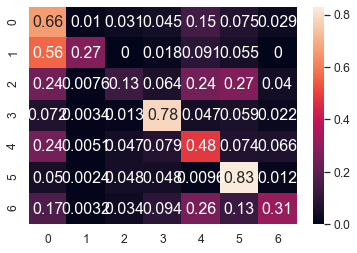

	training epoch=30 .. train_loss=1.028
	validation epoch=30 .. val_loss=1.248
	Accuracy = 53.800000000000004 % .. Percision = 52.0 % .. Recall = 49.8 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_30.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 31 .. loss = 0.823


  0%|                                                                                 | 1/1914 [00:01<34:25,  1.08s/it]

training @ epoch 31 .. loss = 1.111


  0%|                                                                                 | 2/1914 [00:02<35:18,  1.11s/it]

training @ epoch 31 .. loss = 0.927


  0%|▏                                                                                | 3/1914 [00:03<35:28,  1.11s/it]

training @ epoch 31 .. loss = 0.59


  0%|▏                                                                                | 4/1914 [00:04<35:36,  1.12s/it]

training @ epoch 31 .. loss = 0.967


  0%|▏                                                                                | 5/1914 [00:05<36:39,  1.15s/it]

training @ epoch 31 .. loss = 1.034


  0%|▎                                                                                | 6/1914 [00:06<36:36,  1.15s/it]

training @ epoch 31 .. loss = 1.159


  0%|▎                                                                                | 7/1914 [00:07<36:11,  1.14s/it]

training @ epoch 31 .. loss = 1.103


  0%|▎                                                                                | 8/1914 [00:09<36:02,  1.13s/it]

training @ epoch 31 .. loss = 0.726


  0%|▍                                                                                | 9/1914 [00:10<36:43,  1.16s/it]

training @ epoch 31 .. loss = 0.883


  1%|▍                                                                               | 10/1914 [00:11<36:11,  1.14s/it]

training @ epoch 31 .. loss = 0.701


  1%|▍                                                                               | 11/1914 [00:12<35:55,  1.13s/it]

training @ epoch 31 .. loss = 0.94


  1%|▌                                                                               | 12/1914 [00:13<36:08,  1.14s/it]

training @ epoch 31 .. loss = 0.537


  1%|▌                                                                               | 13/1914 [00:15<37:55,  1.20s/it]

training @ epoch 31 .. loss = 0.965


  1%|▌                                                                               | 14/1914 [00:16<39:53,  1.26s/it]

training @ epoch 31 .. loss = 0.708


  1%|▋                                                                               | 15/1914 [00:17<41:35,  1.31s/it]

training @ epoch 31 .. loss = 0.844


  1%|▋                                                                               | 16/1914 [00:19<43:21,  1.37s/it]

training @ epoch 31 .. loss = 0.881


  1%|▋                                                                               | 17/1914 [00:20<44:25,  1.40s/it]

training @ epoch 31 .. loss = 0.87


  1%|▊                                                                               | 18/1914 [00:22<44:47,  1.42s/it]

training @ epoch 31 .. loss = 0.88


  1%|▊                                                                               | 19/1914 [00:23<44:59,  1.42s/it]

training @ epoch 31 .. loss = 0.975


  1%|▊                                                                               | 20/1914 [00:25<44:54,  1.42s/it]

training @ epoch 31 .. loss = 0.93


  1%|▉                                                                               | 21/1914 [00:26<44:41,  1.42s/it]

training @ epoch 31 .. loss = 0.704


  1%|▉                                                                               | 22/1914 [00:27<44:15,  1.40s/it]

training @ epoch 31 .. loss = 1.306


  1%|▉                                                                               | 23/1914 [00:29<43:55,  1.39s/it]

training @ epoch 31 .. loss = 0.72


  1%|█                                                                               | 24/1914 [00:30<43:32,  1.38s/it]

training @ epoch 31 .. loss = 1.08


  1%|█                                                                               | 25/1914 [00:31<42:17,  1.34s/it]

training @ epoch 31 .. loss = 0.678


  1%|█                                                                               | 26/1914 [00:33<41:49,  1.33s/it]

training @ epoch 31 .. loss = 0.972


  1%|█▏                                                                              | 27/1914 [00:34<41:45,  1.33s/it]

training @ epoch 31 .. loss = 0.833


  1%|█▏                                                                              | 28/1914 [00:35<41:48,  1.33s/it]

training @ epoch 31 .. loss = 0.904


  2%|█▏                                                                              | 29/1914 [00:37<41:50,  1.33s/it]

training @ epoch 31 .. loss = 0.695


  2%|█▎                                                                              | 30/1914 [00:38<40:57,  1.30s/it]

training @ epoch 31 .. loss = 1.105


  2%|█▎                                                                              | 31/1914 [00:39<39:09,  1.25s/it]

training @ epoch 31 .. loss = 1.158


  2%|█▎                                                                              | 32/1914 [00:40<37:33,  1.20s/it]

training @ epoch 31 .. loss = 1.174


  2%|█▍                                                                              | 33/1914 [00:41<36:37,  1.17s/it]

training @ epoch 31 .. loss = 1.308


  2%|█▍                                                                              | 34/1914 [00:42<36:20,  1.16s/it]

training @ epoch 31 .. loss = 1.081


  2%|█▍                                                                              | 35/1914 [00:43<35:39,  1.14s/it]

training @ epoch 31 .. loss = 0.69


  2%|█▌                                                                              | 36/1914 [00:45<35:22,  1.13s/it]

training @ epoch 31 .. loss = 1.141


  2%|█▌                                                                              | 37/1914 [00:46<36:41,  1.17s/it]

training @ epoch 31 .. loss = 0.9


  2%|█▌                                                                              | 38/1914 [00:47<35:57,  1.15s/it]

training @ epoch 31 .. loss = 0.927


  2%|█▋                                                                              | 39/1914 [00:48<35:45,  1.14s/it]

training @ epoch 31 .. loss = 1.239


  2%|█▋                                                                              | 40/1914 [00:49<34:56,  1.12s/it]

training @ epoch 31 .. loss = 1.098


  2%|█▋                                                                              | 41/1914 [00:50<34:50,  1.12s/it]

training @ epoch 31 .. loss = 1.501


  2%|█▊                                                                              | 42/1914 [00:51<34:29,  1.11s/it]

training @ epoch 31 .. loss = 1.299


  2%|█▊                                                                              | 43/1914 [00:52<34:19,  1.10s/it]

training @ epoch 31 .. loss = 1.022


  2%|█▊                                                                              | 44/1914 [00:54<34:48,  1.12s/it]

training @ epoch 31 .. loss = 1.208


  2%|█▉                                                                              | 45/1914 [00:55<35:37,  1.14s/it]

training @ epoch 31 .. loss = 1.168


  2%|█▉                                                                              | 46/1914 [00:56<35:00,  1.12s/it]

training @ epoch 31 .. loss = 0.961


  2%|█▉                                                                              | 47/1914 [00:57<34:51,  1.12s/it]

training @ epoch 31 .. loss = 1.022


  3%|██                                                                              | 48/1914 [00:58<35:04,  1.13s/it]

training @ epoch 31 .. loss = 0.528


  3%|██                                                                              | 49/1914 [00:59<35:06,  1.13s/it]

training @ epoch 31 .. loss = 0.596


  3%|██                                                                              | 50/1914 [01:00<35:33,  1.14s/it]

training @ epoch 31 .. loss = 0.731


  3%|██▏                                                                             | 51/1914 [01:02<34:39,  1.12s/it]

training @ epoch 31 .. loss = 1.007


  3%|██▏                                                                             | 52/1914 [01:03<35:17,  1.14s/it]

training @ epoch 31 .. loss = 0.801


  3%|██▏                                                                             | 53/1914 [01:04<35:11,  1.13s/it]

training @ epoch 31 .. loss = 1.552


  3%|██▎                                                                             | 54/1914 [01:05<35:58,  1.16s/it]

training @ epoch 31 .. loss = 0.649


  3%|██▎                                                                             | 55/1914 [01:06<35:11,  1.14s/it]

training @ epoch 31 .. loss = 0.838


  3%|██▎                                                                             | 56/1914 [01:07<35:16,  1.14s/it]

training @ epoch 31 .. loss = 0.565


  3%|██▍                                                                             | 57/1914 [01:08<35:16,  1.14s/it]

training @ epoch 31 .. loss = 0.863


  3%|██▍                                                                             | 58/1914 [01:10<35:12,  1.14s/it]

training @ epoch 31 .. loss = 0.906


  3%|██▍                                                                             | 59/1914 [01:11<35:09,  1.14s/it]

training @ epoch 31 .. loss = 1.613


  3%|██▌                                                                             | 60/1914 [01:12<35:01,  1.13s/it]

training @ epoch 31 .. loss = 1.234


  3%|██▌                                                                             | 61/1914 [01:13<34:25,  1.11s/it]

training @ epoch 31 .. loss = 1.045


  3%|██▌                                                                             | 62/1914 [01:14<34:18,  1.11s/it]

training @ epoch 31 .. loss = 0.991


  3%|██▋                                                                             | 63/1914 [01:15<34:38,  1.12s/it]

training @ epoch 31 .. loss = 1.024


  3%|██▋                                                                             | 64/1914 [01:16<34:24,  1.12s/it]

training @ epoch 31 .. loss = 1.221


  3%|██▋                                                                             | 65/1914 [01:17<34:42,  1.13s/it]

training @ epoch 31 .. loss = 1.202


  3%|██▊                                                                             | 66/1914 [01:19<35:00,  1.14s/it]

training @ epoch 31 .. loss = 1.46


  4%|██▊                                                                             | 67/1914 [01:20<35:34,  1.16s/it]

training @ epoch 31 .. loss = 1.279


  4%|██▊                                                                             | 68/1914 [01:21<36:18,  1.18s/it]

training @ epoch 31 .. loss = 1.034


  4%|██▉                                                                             | 69/1914 [01:22<36:01,  1.17s/it]

training @ epoch 31 .. loss = 0.962


  4%|██▉                                                                             | 70/1914 [01:23<35:48,  1.17s/it]

training @ epoch 31 .. loss = 0.826


  4%|██▉                                                                             | 71/1914 [01:24<35:16,  1.15s/it]

training @ epoch 31 .. loss = 1.455


  4%|███                                                                             | 72/1914 [01:26<35:38,  1.16s/it]

training @ epoch 31 .. loss = 1.388


  4%|███                                                                             | 73/1914 [01:27<36:45,  1.20s/it]

training @ epoch 31 .. loss = 0.961


  4%|███                                                                             | 74/1914 [01:28<36:39,  1.20s/it]

training @ epoch 31 .. loss = 1.006


  4%|███▏                                                                            | 75/1914 [01:29<36:30,  1.19s/it]

training @ epoch 31 .. loss = 1.407


  4%|███▏                                                                            | 76/1914 [01:30<36:15,  1.18s/it]

training @ epoch 31 .. loss = 1.326


  4%|███▏                                                                            | 77/1914 [01:31<35:30,  1.16s/it]

training @ epoch 31 .. loss = 1.132


  4%|███▎                                                                            | 78/1914 [01:33<35:04,  1.15s/it]

training @ epoch 31 .. loss = 0.645


  4%|███▎                                                                            | 79/1914 [01:34<35:22,  1.16s/it]

training @ epoch 31 .. loss = 0.761


  4%|███▎                                                                            | 80/1914 [01:35<34:44,  1.14s/it]

training @ epoch 31 .. loss = 1.803


  4%|███▍                                                                            | 81/1914 [01:36<35:07,  1.15s/it]

training @ epoch 31 .. loss = 0.888


  4%|███▍                                                                            | 82/1914 [01:37<34:55,  1.14s/it]

training @ epoch 31 .. loss = 1.106


  4%|███▍                                                                            | 83/1914 [01:38<34:41,  1.14s/it]

training @ epoch 31 .. loss = 1.184


  4%|███▌                                                                            | 84/1914 [01:39<34:25,  1.13s/it]

training @ epoch 31 .. loss = 0.696


  4%|███▌                                                                            | 85/1914 [01:41<34:19,  1.13s/it]

training @ epoch 31 .. loss = 0.606


  4%|███▌                                                                            | 86/1914 [01:42<34:06,  1.12s/it]

training @ epoch 31 .. loss = 0.87


  5%|███▋                                                                            | 87/1914 [01:43<33:52,  1.11s/it]

training @ epoch 31 .. loss = 1.372


  5%|███▋                                                                            | 88/1914 [01:44<33:49,  1.11s/it]

training @ epoch 31 .. loss = 0.945


  5%|███▋                                                                            | 89/1914 [01:45<33:56,  1.12s/it]

training @ epoch 31 .. loss = 0.996


  5%|███▊                                                                            | 90/1914 [01:46<33:43,  1.11s/it]

training @ epoch 31 .. loss = 1.07


  5%|███▊                                                                            | 91/1914 [01:47<33:59,  1.12s/it]

training @ epoch 31 .. loss = 1.027


  5%|███▊                                                                            | 92/1914 [01:48<34:26,  1.13s/it]

training @ epoch 31 .. loss = 1.218


  5%|███▉                                                                            | 93/1914 [01:49<33:55,  1.12s/it]

training @ epoch 31 .. loss = 1.136


  5%|███▉                                                                            | 94/1914 [01:51<34:55,  1.15s/it]

training @ epoch 31 .. loss = 1.384


  5%|███▉                                                                            | 95/1914 [01:52<34:59,  1.15s/it]

training @ epoch 31 .. loss = 1.097


  5%|████                                                                            | 96/1914 [01:53<35:01,  1.16s/it]

training @ epoch 31 .. loss = 0.885


  5%|████                                                                            | 97/1914 [01:54<34:53,  1.15s/it]

training @ epoch 31 .. loss = 0.645


  5%|████                                                                            | 98/1914 [01:55<35:10,  1.16s/it]

training @ epoch 31 .. loss = 0.994


  5%|████▏                                                                           | 99/1914 [01:56<34:41,  1.15s/it]

training @ epoch 31 .. loss = 1.198


  5%|████▏                                                                          | 100/1914 [01:58<34:33,  1.14s/it]

training @ epoch 31 .. loss = 0.636


  5%|████▏                                                                          | 101/1914 [01:59<34:56,  1.16s/it]

training @ epoch 31 .. loss = 0.729


  5%|████▏                                                                          | 102/1914 [02:00<35:56,  1.19s/it]

training @ epoch 31 .. loss = 0.711


  5%|████▎                                                                          | 103/1914 [02:01<36:05,  1.20s/it]

training @ epoch 31 .. loss = 1.164


  5%|████▎                                                                          | 104/1914 [02:02<35:12,  1.17s/it]

training @ epoch 31 .. loss = 0.769


  5%|████▎                                                                          | 105/1914 [02:03<34:45,  1.15s/it]

training @ epoch 31 .. loss = 1.104


  6%|████▍                                                                          | 106/1914 [02:05<35:15,  1.17s/it]

training @ epoch 31 .. loss = 1.112


  6%|████▍                                                                          | 107/1914 [02:06<34:59,  1.16s/it]

training @ epoch 31 .. loss = 0.954


  6%|████▍                                                                          | 108/1914 [02:07<34:12,  1.14s/it]

training @ epoch 31 .. loss = 0.759


  6%|████▍                                                                          | 109/1914 [02:08<34:02,  1.13s/it]

training @ epoch 31 .. loss = 1.001


  6%|████▌                                                                          | 110/1914 [02:09<34:11,  1.14s/it]

training @ epoch 31 .. loss = 0.823


  6%|████▌                                                                          | 111/1914 [02:10<33:31,  1.12s/it]

training @ epoch 31 .. loss = 0.811


  6%|████▌                                                                          | 112/1914 [02:11<33:34,  1.12s/it]

training @ epoch 31 .. loss = 1.212


  6%|████▋                                                                          | 113/1914 [02:12<33:13,  1.11s/it]

training @ epoch 31 .. loss = 0.811


  6%|████▋                                                                          | 114/1914 [02:14<33:11,  1.11s/it]

training @ epoch 31 .. loss = 1.045


  6%|████▋                                                                          | 115/1914 [02:15<33:09,  1.11s/it]

training @ epoch 31 .. loss = 1.488


  6%|████▊                                                                          | 116/1914 [02:16<33:10,  1.11s/it]

training @ epoch 31 .. loss = 1.065


  6%|████▊                                                                          | 117/1914 [02:17<33:13,  1.11s/it]

training @ epoch 31 .. loss = 0.874


  6%|████▊                                                                          | 118/1914 [02:18<33:26,  1.12s/it]

training @ epoch 31 .. loss = 1.176


  6%|████▉                                                                          | 119/1914 [02:19<33:40,  1.13s/it]

training @ epoch 31 .. loss = 1.008


  6%|████▉                                                                          | 120/1914 [02:20<33:38,  1.13s/it]

training @ epoch 31 .. loss = 1.368


  6%|████▉                                                                          | 121/1914 [02:21<33:40,  1.13s/it]

training @ epoch 31 .. loss = 1.034


  6%|█████                                                                          | 122/1914 [02:23<33:57,  1.14s/it]

training @ epoch 31 .. loss = 1.23


  6%|█████                                                                          | 123/1914 [02:24<34:19,  1.15s/it]

training @ epoch 31 .. loss = 0.724


  6%|█████                                                                          | 124/1914 [02:25<34:31,  1.16s/it]

training @ epoch 31 .. loss = 0.96


  7%|█████▏                                                                         | 125/1914 [02:26<35:17,  1.18s/it]

training @ epoch 31 .. loss = 1.194


  7%|█████▏                                                                         | 126/1914 [02:27<34:47,  1.17s/it]

training @ epoch 31 .. loss = 0.926


  7%|█████▏                                                                         | 127/1914 [02:28<34:34,  1.16s/it]

training @ epoch 31 .. loss = 1.002


  7%|█████▎                                                                         | 128/1914 [02:30<34:15,  1.15s/it]

training @ epoch 31 .. loss = 1.162


  7%|█████▎                                                                         | 129/1914 [02:31<34:12,  1.15s/it]

training @ epoch 31 .. loss = 1.059


  7%|█████▎                                                                         | 130/1914 [02:32<34:00,  1.14s/it]

training @ epoch 31 .. loss = 1.259


  7%|█████▍                                                                         | 131/1914 [02:33<34:08,  1.15s/it]

training @ epoch 31 .. loss = 1.239


  7%|█████▍                                                                         | 132/1914 [02:34<33:51,  1.14s/it]

training @ epoch 31 .. loss = 0.935


  7%|█████▍                                                                         | 133/1914 [02:35<33:55,  1.14s/it]

training @ epoch 31 .. loss = 0.73


  7%|█████▌                                                                         | 134/1914 [02:36<33:42,  1.14s/it]

training @ epoch 31 .. loss = 0.871


  7%|█████▌                                                                         | 135/1914 [02:38<33:32,  1.13s/it]

training @ epoch 31 .. loss = 0.683


  7%|█████▌                                                                         | 136/1914 [02:39<34:01,  1.15s/it]

training @ epoch 31 .. loss = 1.19


  7%|█████▋                                                                         | 137/1914 [02:40<34:34,  1.17s/it]

training @ epoch 31 .. loss = 0.802


  7%|█████▋                                                                         | 138/1914 [02:41<34:29,  1.17s/it]

training @ epoch 31 .. loss = 1.179


  7%|█████▋                                                                         | 139/1914 [02:42<34:25,  1.16s/it]

training @ epoch 31 .. loss = 1.507


  7%|█████▊                                                                         | 140/1914 [02:43<33:39,  1.14s/it]

training @ epoch 31 .. loss = 1.386


  7%|█████▊                                                                         | 141/1914 [02:44<33:23,  1.13s/it]

training @ epoch 31 .. loss = 1.342


  7%|█████▊                                                                         | 142/1914 [02:46<32:51,  1.11s/it]

training @ epoch 31 .. loss = 0.794


  7%|█████▉                                                                         | 143/1914 [02:47<33:27,  1.13s/it]

training @ epoch 31 .. loss = 1.015


  8%|█████▉                                                                         | 144/1914 [02:48<33:26,  1.13s/it]

training @ epoch 31 .. loss = 1.284


  8%|█████▉                                                                         | 145/1914 [02:49<34:54,  1.18s/it]

training @ epoch 31 .. loss = 1.291


  8%|██████                                                                         | 146/1914 [02:50<35:46,  1.21s/it]

training @ epoch 31 .. loss = 0.885


  8%|██████                                                                         | 147/1914 [02:52<36:47,  1.25s/it]

training @ epoch 31 .. loss = 0.681


  8%|██████                                                                         | 148/1914 [02:53<36:33,  1.24s/it]

training @ epoch 31 .. loss = 0.593


  8%|██████▏                                                                        | 149/1914 [02:54<37:18,  1.27s/it]

training @ epoch 31 .. loss = 0.878


  8%|██████▏                                                                        | 150/1914 [02:55<36:46,  1.25s/it]

training @ epoch 31 .. loss = 1.38


  8%|██████▏                                                                        | 151/1914 [02:57<35:22,  1.20s/it]

training @ epoch 31 .. loss = 0.509


  8%|██████▎                                                                        | 152/1914 [02:58<34:45,  1.18s/it]

training @ epoch 31 .. loss = 0.813


  8%|██████▎                                                                        | 153/1914 [02:59<34:00,  1.16s/it]

training @ epoch 31 .. loss = 0.76


  8%|██████▎                                                                        | 154/1914 [03:00<33:43,  1.15s/it]

training @ epoch 31 .. loss = 0.699


  8%|██████▍                                                                        | 155/1914 [03:01<34:03,  1.16s/it]

training @ epoch 31 .. loss = 1.095


  8%|██████▍                                                                        | 156/1914 [03:02<33:24,  1.14s/it]

training @ epoch 31 .. loss = 1.239


  8%|██████▍                                                                        | 157/1914 [03:03<33:55,  1.16s/it]

training @ epoch 31 .. loss = 0.946


  8%|██████▌                                                                        | 158/1914 [03:05<33:28,  1.14s/it]

training @ epoch 31 .. loss = 0.89


  8%|██████▌                                                                        | 159/1914 [03:06<34:12,  1.17s/it]

training @ epoch 31 .. loss = 0.841


  8%|██████▌                                                                        | 160/1914 [03:07<33:34,  1.15s/it]

training @ epoch 31 .. loss = 0.655


  8%|██████▋                                                                        | 161/1914 [03:08<33:29,  1.15s/it]

training @ epoch 31 .. loss = 1.134


  8%|██████▋                                                                        | 162/1914 [03:09<32:42,  1.12s/it]

training @ epoch 31 .. loss = 0.935


  9%|██████▋                                                                        | 163/1914 [03:10<32:30,  1.11s/it]

training @ epoch 31 .. loss = 0.986


  9%|██████▊                                                                        | 164/1914 [03:11<32:38,  1.12s/it]

training @ epoch 31 .. loss = 0.781


  9%|██████▊                                                                        | 165/1914 [03:12<32:52,  1.13s/it]

training @ epoch 31 .. loss = 1.106


  9%|██████▊                                                                        | 166/1914 [03:14<34:06,  1.17s/it]

training @ epoch 31 .. loss = 0.849


  9%|██████▉                                                                        | 167/1914 [03:15<34:07,  1.17s/it]

training @ epoch 31 .. loss = 0.729


  9%|██████▉                                                                        | 168/1914 [03:16<34:02,  1.17s/it]

training @ epoch 31 .. loss = 0.618


  9%|██████▉                                                                        | 169/1914 [03:17<33:14,  1.14s/it]

training @ epoch 31 .. loss = 1.1


  9%|███████                                                                        | 170/1914 [03:18<33:37,  1.16s/it]

training @ epoch 31 .. loss = 1.242


  9%|███████                                                                        | 171/1914 [03:20<33:43,  1.16s/it]

training @ epoch 31 .. loss = 0.911


  9%|███████                                                                        | 172/1914 [03:21<33:18,  1.15s/it]

training @ epoch 31 .. loss = 0.97


  9%|███████▏                                                                       | 173/1914 [03:22<33:16,  1.15s/it]

training @ epoch 31 .. loss = 0.802


  9%|███████▏                                                                       | 174/1914 [03:23<33:11,  1.14s/it]

training @ epoch 31 .. loss = 1.11


  9%|███████▏                                                                       | 175/1914 [03:24<32:26,  1.12s/it]

training @ epoch 31 .. loss = 0.827


  9%|███████▎                                                                       | 176/1914 [03:25<32:41,  1.13s/it]

training @ epoch 31 .. loss = 1.895


  9%|███████▎                                                                       | 177/1914 [03:26<32:46,  1.13s/it]

training @ epoch 31 .. loss = 0.768


  9%|███████▎                                                                       | 178/1914 [03:27<32:23,  1.12s/it]

training @ epoch 31 .. loss = 0.678


  9%|███████▍                                                                       | 179/1914 [03:28<32:11,  1.11s/it]

training @ epoch 31 .. loss = 1.311


  9%|███████▍                                                                       | 180/1914 [03:30<32:24,  1.12s/it]

training @ epoch 31 .. loss = 1.45


  9%|███████▍                                                                       | 181/1914 [03:31<32:14,  1.12s/it]

training @ epoch 31 .. loss = 0.78


 10%|███████▌                                                                       | 182/1914 [03:32<32:23,  1.12s/it]

training @ epoch 31 .. loss = 1.741


 10%|███████▌                                                                       | 183/1914 [03:33<32:26,  1.12s/it]

training @ epoch 31 .. loss = 0.891


 10%|███████▌                                                                       | 184/1914 [03:34<32:43,  1.14s/it]

training @ epoch 31 .. loss = 1.23


 10%|███████▋                                                                       | 185/1914 [03:35<32:13,  1.12s/it]

training @ epoch 31 .. loss = 0.46


 10%|███████▋                                                                       | 186/1914 [03:36<31:58,  1.11s/it]

training @ epoch 31 .. loss = 0.592


 10%|███████▋                                                                       | 187/1914 [03:37<32:33,  1.13s/it]

training @ epoch 31 .. loss = 1.57


 10%|███████▊                                                                       | 188/1914 [03:39<32:26,  1.13s/it]

training @ epoch 31 .. loss = 0.973


 10%|███████▊                                                                       | 189/1914 [03:40<32:10,  1.12s/it]

training @ epoch 31 .. loss = 0.917


 10%|███████▊                                                                       | 190/1914 [03:41<32:28,  1.13s/it]

training @ epoch 31 .. loss = 1.072


 10%|███████▉                                                                       | 191/1914 [03:42<32:03,  1.12s/it]

training @ epoch 31 .. loss = 1.137


 10%|███████▉                                                                       | 192/1914 [03:43<33:11,  1.16s/it]

training @ epoch 31 .. loss = 0.894


 10%|███████▉                                                                       | 193/1914 [03:44<33:22,  1.16s/it]

training @ epoch 31 .. loss = 1.05


 10%|████████                                                                       | 194/1914 [03:45<33:04,  1.15s/it]

training @ epoch 31 .. loss = 0.859


 10%|████████                                                                       | 195/1914 [03:47<32:50,  1.15s/it]

training @ epoch 31 .. loss = 1.008


 10%|████████                                                                       | 196/1914 [03:48<32:32,  1.14s/it]

training @ epoch 31 .. loss = 1.275


 10%|████████▏                                                                      | 197/1914 [03:49<32:15,  1.13s/it]

training @ epoch 31 .. loss = 0.854


 10%|████████▏                                                                      | 198/1914 [03:50<32:16,  1.13s/it]

training @ epoch 31 .. loss = 1.012


 10%|████████▏                                                                      | 199/1914 [03:51<32:31,  1.14s/it]

training @ epoch 31 .. loss = 1.067


 10%|████████▎                                                                      | 200/1914 [03:52<33:27,  1.17s/it]

training @ epoch 31 .. loss = 1.745


 11%|████████▎                                                                      | 201/1914 [03:54<33:00,  1.16s/it]

training @ epoch 31 .. loss = 0.794


 11%|████████▎                                                                      | 202/1914 [03:55<32:19,  1.13s/it]

training @ epoch 31 .. loss = 0.872


 11%|████████▍                                                                      | 203/1914 [03:56<32:30,  1.14s/it]

training @ epoch 31 .. loss = 1.012


 11%|████████▍                                                                      | 204/1914 [03:57<32:16,  1.13s/it]

training @ epoch 31 .. loss = 1.004


 11%|████████▍                                                                      | 205/1914 [03:58<32:19,  1.13s/it]

training @ epoch 31 .. loss = 0.958


 11%|████████▌                                                                      | 206/1914 [03:59<32:00,  1.12s/it]

training @ epoch 31 .. loss = 0.848


 11%|████████▌                                                                      | 207/1914 [04:00<31:41,  1.11s/it]

training @ epoch 31 .. loss = 0.578


 11%|████████▌                                                                      | 208/1914 [04:01<32:42,  1.15s/it]

training @ epoch 31 .. loss = 0.633


 11%|████████▋                                                                      | 209/1914 [04:03<33:21,  1.17s/it]

training @ epoch 31 .. loss = 1.187


 11%|████████▋                                                                      | 210/1914 [04:04<33:13,  1.17s/it]

training @ epoch 31 .. loss = 1.001


 11%|████████▋                                                                      | 211/1914 [04:05<32:33,  1.15s/it]

training @ epoch 31 .. loss = 1.381


 11%|████████▊                                                                      | 212/1914 [04:06<32:39,  1.15s/it]

training @ epoch 31 .. loss = 1.331


 11%|████████▊                                                                      | 213/1914 [04:07<33:13,  1.17s/it]

training @ epoch 31 .. loss = 0.794


 11%|████████▊                                                                      | 214/1914 [04:08<33:26,  1.18s/it]

training @ epoch 31 .. loss = 0.972


 11%|████████▊                                                                      | 215/1914 [04:10<33:07,  1.17s/it]

training @ epoch 31 .. loss = 0.608


 11%|████████▉                                                                      | 216/1914 [04:11<33:08,  1.17s/it]

training @ epoch 31 .. loss = 0.666


 11%|████████▉                                                                      | 217/1914 [04:12<32:56,  1.16s/it]

training @ epoch 31 .. loss = 1.173


 11%|████████▉                                                                      | 218/1914 [04:13<32:32,  1.15s/it]

training @ epoch 31 .. loss = 0.843


 11%|█████████                                                                      | 219/1914 [04:14<32:20,  1.15s/it]

training @ epoch 31 .. loss = 1.357


 11%|█████████                                                                      | 220/1914 [04:15<32:01,  1.13s/it]

training @ epoch 31 .. loss = 0.879


 12%|█████████                                                                      | 221/1914 [04:16<31:28,  1.12s/it]

training @ epoch 31 .. loss = 0.793


 12%|█████████▏                                                                     | 222/1914 [04:17<31:03,  1.10s/it]

training @ epoch 31 .. loss = 0.912


 12%|█████████▏                                                                     | 223/1914 [04:19<32:08,  1.14s/it]

training @ epoch 31 .. loss = 0.975


 12%|█████████▏                                                                     | 224/1914 [04:20<31:46,  1.13s/it]

training @ epoch 31 .. loss = 0.83


 12%|█████████▎                                                                     | 225/1914 [04:21<31:46,  1.13s/it]

training @ epoch 31 .. loss = 1.08


 12%|█████████▎                                                                     | 226/1914 [04:22<31:53,  1.13s/it]

training @ epoch 31 .. loss = 1.488


 12%|█████████▎                                                                     | 227/1914 [04:23<31:53,  1.13s/it]

training @ epoch 31 .. loss = 1.265


 12%|█████████▍                                                                     | 228/1914 [04:24<31:44,  1.13s/it]

training @ epoch 31 .. loss = 0.8


 12%|█████████▍                                                                     | 229/1914 [04:25<31:33,  1.12s/it]

training @ epoch 31 .. loss = 1.227


 12%|█████████▍                                                                     | 230/1914 [04:27<31:35,  1.13s/it]

training @ epoch 31 .. loss = 1.455


 12%|█████████▌                                                                     | 231/1914 [04:28<32:01,  1.14s/it]

training @ epoch 31 .. loss = 0.713


 12%|█████████▌                                                                     | 232/1914 [04:29<31:35,  1.13s/it]

training @ epoch 31 .. loss = 1.112


 12%|█████████▌                                                                     | 233/1914 [04:30<31:25,  1.12s/it]

training @ epoch 31 .. loss = 0.93


 12%|█████████▋                                                                     | 234/1914 [04:31<31:33,  1.13s/it]

training @ epoch 31 .. loss = 1.206


 12%|█████████▋                                                                     | 235/1914 [04:32<32:39,  1.17s/it]

training @ epoch 31 .. loss = 0.768


 12%|█████████▋                                                                     | 236/1914 [04:34<32:44,  1.17s/it]

training @ epoch 31 .. loss = 0.675


 12%|█████████▊                                                                     | 237/1914 [04:35<32:07,  1.15s/it]

training @ epoch 31 .. loss = 1.501


 12%|█████████▊                                                                     | 238/1914 [04:36<31:57,  1.14s/it]

training @ epoch 31 .. loss = 1.205


 12%|█████████▊                                                                     | 239/1914 [04:37<31:48,  1.14s/it]

training @ epoch 31 .. loss = 0.827


 13%|█████████▉                                                                     | 240/1914 [04:38<32:02,  1.15s/it]

training @ epoch 31 .. loss = 0.624


 13%|█████████▉                                                                     | 241/1914 [04:39<33:17,  1.19s/it]

training @ epoch 31 .. loss = 0.704


 13%|█████████▉                                                                     | 242/1914 [04:41<32:59,  1.18s/it]

training @ epoch 31 .. loss = 1.191


 13%|██████████                                                                     | 243/1914 [04:42<32:46,  1.18s/it]

training @ epoch 31 .. loss = 1.293


 13%|██████████                                                                     | 244/1914 [04:43<32:33,  1.17s/it]

training @ epoch 31 .. loss = 1.503


 13%|██████████                                                                     | 245/1914 [04:44<32:15,  1.16s/it]

training @ epoch 31 .. loss = 1.624


 13%|██████████▏                                                                    | 246/1914 [04:45<32:35,  1.17s/it]

training @ epoch 31 .. loss = 0.92


 13%|██████████▏                                                                    | 247/1914 [04:46<32:07,  1.16s/it]

training @ epoch 31 .. loss = 1.19


 13%|██████████▏                                                                    | 248/1914 [04:47<31:32,  1.14s/it]

training @ epoch 31 .. loss = 1.287


 13%|██████████▎                                                                    | 249/1914 [04:48<31:22,  1.13s/it]

training @ epoch 31 .. loss = 1.394


 13%|██████████▎                                                                    | 250/1914 [04:50<31:24,  1.13s/it]

training @ epoch 31 .. loss = 0.68


 13%|██████████▎                                                                    | 251/1914 [04:51<30:59,  1.12s/it]

training @ epoch 31 .. loss = 0.778


 13%|██████████▍                                                                    | 252/1914 [04:52<31:39,  1.14s/it]

training @ epoch 31 .. loss = 0.854


 13%|██████████▍                                                                    | 253/1914 [04:53<31:11,  1.13s/it]

training @ epoch 31 .. loss = 1.144


 13%|██████████▍                                                                    | 254/1914 [04:54<31:17,  1.13s/it]

training @ epoch 31 .. loss = 1.022


 13%|██████████▌                                                                    | 255/1914 [04:55<31:25,  1.14s/it]

training @ epoch 31 .. loss = 1.274


 13%|██████████▌                                                                    | 256/1914 [04:56<31:11,  1.13s/it]

training @ epoch 31 .. loss = 0.861


 13%|██████████▌                                                                    | 257/1914 [04:58<31:03,  1.12s/it]

training @ epoch 31 .. loss = 0.817


 13%|██████████▋                                                                    | 258/1914 [04:59<30:47,  1.12s/it]

training @ epoch 31 .. loss = 1.023


 14%|██████████▋                                                                    | 259/1914 [05:00<30:51,  1.12s/it]

training @ epoch 31 .. loss = 0.879


 14%|██████████▋                                                                    | 260/1914 [05:01<30:43,  1.11s/it]

training @ epoch 31 .. loss = 0.675


 14%|██████████▊                                                                    | 261/1914 [05:02<30:42,  1.11s/it]

training @ epoch 31 .. loss = 1.347


 14%|██████████▊                                                                    | 262/1914 [05:03<31:26,  1.14s/it]

training @ epoch 31 .. loss = 1.585


 14%|██████████▊                                                                    | 263/1914 [05:04<31:38,  1.15s/it]

training @ epoch 31 .. loss = 0.7


 14%|██████████▉                                                                    | 264/1914 [05:06<32:37,  1.19s/it]

training @ epoch 31 .. loss = 0.705


 14%|██████████▉                                                                    | 265/1914 [05:07<32:42,  1.19s/it]

training @ epoch 31 .. loss = 0.722


 14%|██████████▉                                                                    | 266/1914 [05:08<32:23,  1.18s/it]

training @ epoch 31 .. loss = 0.7


 14%|███████████                                                                    | 267/1914 [05:09<32:13,  1.17s/it]

training @ epoch 31 .. loss = 0.746


 14%|███████████                                                                    | 268/1914 [05:10<32:44,  1.19s/it]

training @ epoch 31 .. loss = 1.1


 14%|███████████                                                                    | 269/1914 [05:12<33:28,  1.22s/it]

training @ epoch 31 .. loss = 0.856


 14%|███████████▏                                                                   | 270/1914 [05:13<32:47,  1.20s/it]

training @ epoch 31 .. loss = 0.813


 14%|███████████▏                                                                   | 271/1914 [05:14<32:03,  1.17s/it]

training @ epoch 31 .. loss = 0.897


 14%|███████████▏                                                                   | 272/1914 [05:15<31:52,  1.16s/it]

training @ epoch 31 .. loss = 1.049


 14%|███████████▎                                                                   | 273/1914 [05:16<32:28,  1.19s/it]

training @ epoch 31 .. loss = 1.25


 14%|███████████▎                                                                   | 274/1914 [05:17<32:38,  1.19s/it]

training @ epoch 31 .. loss = 1.414


 14%|███████████▎                                                                   | 275/1914 [05:19<33:29,  1.23s/it]

training @ epoch 31 .. loss = 0.829


 14%|███████████▍                                                                   | 276/1914 [05:20<34:40,  1.27s/it]

training @ epoch 31 .. loss = 0.718


 14%|███████████▍                                                                   | 277/1914 [05:21<34:58,  1.28s/it]

training @ epoch 31 .. loss = 1.341


 15%|███████████▍                                                                   | 278/1914 [05:23<35:04,  1.29s/it]

training @ epoch 31 .. loss = 1.115


 15%|███████████▌                                                                   | 279/1914 [05:24<33:41,  1.24s/it]

training @ epoch 31 .. loss = 1.126


 15%|███████████▌                                                                   | 280/1914 [05:25<32:38,  1.20s/it]

training @ epoch 31 .. loss = 1.343


 15%|███████████▌                                                                   | 281/1914 [05:26<32:34,  1.20s/it]

training @ epoch 31 .. loss = 0.832


 15%|███████████▋                                                                   | 282/1914 [05:27<31:44,  1.17s/it]

training @ epoch 31 .. loss = 0.738


 15%|███████████▋                                                                   | 283/1914 [05:28<31:30,  1.16s/it]

training @ epoch 31 .. loss = 1.15


 15%|███████████▋                                                                   | 284/1914 [05:30<31:14,  1.15s/it]

training @ epoch 31 .. loss = 0.907


 15%|███████████▊                                                                   | 285/1914 [05:31<31:25,  1.16s/it]

training @ epoch 31 .. loss = 1.07


 15%|███████████▊                                                                   | 286/1914 [05:32<30:54,  1.14s/it]

training @ epoch 31 .. loss = 0.813


 15%|███████████▊                                                                   | 287/1914 [05:33<30:58,  1.14s/it]

training @ epoch 31 .. loss = 0.755


 15%|███████████▉                                                                   | 288/1914 [05:34<31:47,  1.17s/it]

training @ epoch 31 .. loss = 1.225


 15%|███████████▉                                                                   | 289/1914 [05:36<32:49,  1.21s/it]

training @ epoch 31 .. loss = 0.832


 15%|███████████▉                                                                   | 290/1914 [05:37<36:18,  1.34s/it]

training @ epoch 31 .. loss = 0.607


 15%|████████████                                                                   | 291/1914 [05:38<36:08,  1.34s/it]

training @ epoch 31 .. loss = 1.026


 15%|████████████                                                                   | 292/1914 [05:40<35:19,  1.31s/it]

training @ epoch 31 .. loss = 1.116


 15%|████████████                                                                   | 293/1914 [05:41<34:05,  1.26s/it]

training @ epoch 31 .. loss = 1.273


 15%|████████████▏                                                                  | 294/1914 [05:42<33:40,  1.25s/it]

training @ epoch 31 .. loss = 0.742


 15%|████████████▏                                                                  | 295/1914 [05:43<32:30,  1.20s/it]

training @ epoch 31 .. loss = 1.326


 15%|████████████▏                                                                  | 296/1914 [05:44<31:38,  1.17s/it]

training @ epoch 31 .. loss = 0.966


 16%|████████████▎                                                                  | 297/1914 [05:45<31:11,  1.16s/it]

training @ epoch 31 .. loss = 0.987


 16%|████████████▎                                                                  | 298/1914 [05:46<30:32,  1.13s/it]

training @ epoch 31 .. loss = 1.113


 16%|████████████▎                                                                  | 299/1914 [05:48<30:45,  1.14s/it]

training @ epoch 31 .. loss = 1.171


 16%|████████████▍                                                                  | 300/1914 [05:49<30:17,  1.13s/it]

training @ epoch 31 .. loss = 1.472


 16%|████████████▍                                                                  | 301/1914 [05:50<30:25,  1.13s/it]

training @ epoch 31 .. loss = 1.054


 16%|████████████▍                                                                  | 302/1914 [05:51<30:21,  1.13s/it]

training @ epoch 31 .. loss = 0.781


 16%|████████████▌                                                                  | 303/1914 [05:52<30:05,  1.12s/it]

training @ epoch 31 .. loss = 0.991


 16%|████████████▌                                                                  | 304/1914 [05:53<30:00,  1.12s/it]

training @ epoch 31 .. loss = 0.783


 16%|████████████▌                                                                  | 305/1914 [05:54<30:13,  1.13s/it]

training @ epoch 31 .. loss = 1.065


 16%|████████████▋                                                                  | 306/1914 [05:55<29:54,  1.12s/it]

training @ epoch 31 .. loss = 1.141


 16%|████████████▋                                                                  | 307/1914 [05:57<30:02,  1.12s/it]

training @ epoch 31 .. loss = 0.754


 16%|████████████▋                                                                  | 308/1914 [05:58<29:48,  1.11s/it]

training @ epoch 31 .. loss = 0.87


 16%|████████████▊                                                                  | 309/1914 [05:59<29:28,  1.10s/it]

training @ epoch 31 .. loss = 1.435


 16%|████████████▊                                                                  | 310/1914 [06:00<29:53,  1.12s/it]

training @ epoch 31 .. loss = 1.13


 16%|████████████▊                                                                  | 311/1914 [06:01<30:36,  1.15s/it]

training @ epoch 31 .. loss = 0.674


 16%|████████████▉                                                                  | 312/1914 [06:02<31:15,  1.17s/it]

training @ epoch 31 .. loss = 0.639


 16%|████████████▉                                                                  | 313/1914 [06:04<30:59,  1.16s/it]

training @ epoch 31 .. loss = 0.661


 16%|████████████▉                                                                  | 314/1914 [06:05<31:02,  1.16s/it]

training @ epoch 31 .. loss = 0.967


 16%|█████████████                                                                  | 315/1914 [06:06<30:24,  1.14s/it]

training @ epoch 31 .. loss = 1.057


 17%|█████████████                                                                  | 316/1914 [06:07<30:45,  1.16s/it]

training @ epoch 31 .. loss = 0.73


 17%|█████████████                                                                  | 317/1914 [06:08<31:37,  1.19s/it]

training @ epoch 31 .. loss = 0.888


 17%|█████████████▏                                                                 | 318/1914 [06:09<30:44,  1.16s/it]

training @ epoch 31 .. loss = 1.051


 17%|█████████████▏                                                                 | 319/1914 [06:10<30:21,  1.14s/it]

training @ epoch 31 .. loss = 0.989


 17%|█████████████▏                                                                 | 320/1914 [06:12<30:00,  1.13s/it]

training @ epoch 31 .. loss = 0.872


 17%|█████████████▏                                                                 | 321/1914 [06:13<30:06,  1.13s/it]

training @ epoch 31 .. loss = 1.358


 17%|█████████████▎                                                                 | 322/1914 [06:14<29:51,  1.13s/it]

training @ epoch 31 .. loss = 1.083


 17%|█████████████▎                                                                 | 323/1914 [06:15<29:52,  1.13s/it]

training @ epoch 31 .. loss = 1.292


 17%|█████████████▎                                                                 | 324/1914 [06:16<30:12,  1.14s/it]

training @ epoch 31 .. loss = 0.946


 17%|█████████████▍                                                                 | 325/1914 [06:17<29:56,  1.13s/it]

training @ epoch 31 .. loss = 1.019


 17%|█████████████▍                                                                 | 326/1914 [06:18<29:43,  1.12s/it]

training @ epoch 31 .. loss = 1.361


 17%|█████████████▍                                                                 | 327/1914 [06:19<29:43,  1.12s/it]

training @ epoch 31 .. loss = 1.066


 17%|█████████████▌                                                                 | 328/1914 [06:20<29:21,  1.11s/it]

training @ epoch 31 .. loss = 1.397


 17%|█████████████▌                                                                 | 329/1914 [06:22<29:17,  1.11s/it]

training @ epoch 31 .. loss = 1.984


 17%|█████████████▌                                                                 | 330/1914 [06:23<29:24,  1.11s/it]

training @ epoch 31 .. loss = 1.326


 17%|█████████████▋                                                                 | 331/1914 [06:24<29:02,  1.10s/it]

training @ epoch 31 .. loss = 0.695


 17%|█████████████▋                                                                 | 332/1914 [06:25<29:05,  1.10s/it]

training @ epoch 31 .. loss = 1.12


 17%|█████████████▋                                                                 | 333/1914 [06:26<28:53,  1.10s/it]

training @ epoch 31 .. loss = 1.117


 17%|█████████████▊                                                                 | 334/1914 [06:27<29:22,  1.12s/it]

training @ epoch 31 .. loss = 0.998


 18%|█████████████▊                                                                 | 335/1914 [06:28<29:32,  1.12s/it]

training @ epoch 31 .. loss = 0.648


 18%|█████████████▊                                                                 | 336/1914 [06:29<29:40,  1.13s/it]

training @ epoch 31 .. loss = 1.091


 18%|█████████████▉                                                                 | 337/1914 [06:31<29:53,  1.14s/it]

training @ epoch 31 .. loss = 1.1


 18%|█████████████▉                                                                 | 338/1914 [06:32<30:03,  1.14s/it]

training @ epoch 31 .. loss = 0.867


 18%|█████████████▉                                                                 | 339/1914 [06:33<29:57,  1.14s/it]

training @ epoch 31 .. loss = 1.17


 18%|██████████████                                                                 | 340/1914 [06:34<29:39,  1.13s/it]

training @ epoch 31 .. loss = 1.007


 18%|██████████████                                                                 | 341/1914 [06:35<29:33,  1.13s/it]

training @ epoch 31 .. loss = 0.764


 18%|██████████████                                                                 | 342/1914 [06:36<29:07,  1.11s/it]

training @ epoch 31 .. loss = 0.938


 18%|██████████████▏                                                                | 343/1914 [06:37<29:26,  1.12s/it]

training @ epoch 31 .. loss = 1.827


 18%|██████████████▏                                                                | 344/1914 [06:38<29:23,  1.12s/it]

training @ epoch 31 .. loss = 1.131


 18%|██████████████▏                                                                | 345/1914 [06:40<29:06,  1.11s/it]

training @ epoch 31 .. loss = 1.13


 18%|██████████████▎                                                                | 346/1914 [06:41<28:56,  1.11s/it]

training @ epoch 31 .. loss = 0.938


 18%|██████████████▎                                                                | 347/1914 [06:42<29:08,  1.12s/it]

training @ epoch 31 .. loss = 0.836


 18%|██████████████▎                                                                | 348/1914 [06:43<29:04,  1.11s/it]

training @ epoch 31 .. loss = 0.805


 18%|██████████████▍                                                                | 349/1914 [06:44<29:41,  1.14s/it]

training @ epoch 31 .. loss = 1.33


 18%|██████████████▍                                                                | 350/1914 [06:45<29:43,  1.14s/it]

training @ epoch 31 .. loss = 1.051


 18%|██████████████▍                                                                | 351/1914 [06:46<29:21,  1.13s/it]

training @ epoch 31 .. loss = 1.172


 18%|██████████████▌                                                                | 352/1914 [06:47<29:00,  1.11s/it]

training @ epoch 31 .. loss = 1.155


 18%|██████████████▌                                                                | 353/1914 [06:48<28:52,  1.11s/it]

training @ epoch 31 .. loss = 0.971


 18%|██████████████▌                                                                | 354/1914 [06:50<29:24,  1.13s/it]

training @ epoch 31 .. loss = 0.622


 19%|██████████████▋                                                                | 355/1914 [06:51<29:08,  1.12s/it]

training @ epoch 31 .. loss = 0.731


 19%|██████████████▋                                                                | 356/1914 [06:52<28:48,  1.11s/it]

training @ epoch 31 .. loss = 1.041


 19%|██████████████▋                                                                | 357/1914 [06:53<28:51,  1.11s/it]

training @ epoch 31 .. loss = 1.162


 19%|██████████████▊                                                                | 358/1914 [06:54<28:35,  1.10s/it]

training @ epoch 31 .. loss = 0.745


 19%|██████████████▊                                                                | 359/1914 [06:55<28:33,  1.10s/it]

training @ epoch 31 .. loss = 1.042


 19%|██████████████▊                                                                | 360/1914 [06:56<28:50,  1.11s/it]

training @ epoch 31 .. loss = 1.144


 19%|██████████████▉                                                                | 361/1914 [06:57<29:15,  1.13s/it]

training @ epoch 31 .. loss = 1.162


 19%|██████████████▉                                                                | 362/1914 [06:59<28:50,  1.12s/it]

training @ epoch 31 .. loss = 0.888


 19%|██████████████▉                                                                | 363/1914 [07:00<28:40,  1.11s/it]

training @ epoch 31 .. loss = 1.345


 19%|███████████████                                                                | 364/1914 [07:01<28:46,  1.11s/it]

training @ epoch 31 .. loss = 0.992


 19%|███████████████                                                                | 365/1914 [07:02<28:43,  1.11s/it]

training @ epoch 31 .. loss = 0.807


 19%|███████████████                                                                | 366/1914 [07:03<28:36,  1.11s/it]

training @ epoch 31 .. loss = 0.949


 19%|███████████████▏                                                               | 367/1914 [07:04<28:45,  1.12s/it]

training @ epoch 31 .. loss = 0.726


 19%|███████████████▏                                                               | 368/1914 [07:05<28:46,  1.12s/it]

training @ epoch 31 .. loss = 1.398


 19%|███████████████▏                                                               | 369/1914 [07:06<28:28,  1.11s/it]

training @ epoch 31 .. loss = 0.897


 19%|███████████████▎                                                               | 370/1914 [07:07<28:17,  1.10s/it]

training @ epoch 31 .. loss = 0.679


 19%|███████████████▎                                                               | 371/1914 [07:08<28:23,  1.10s/it]

training @ epoch 31 .. loss = 1.174


 19%|███████████████▎                                                               | 372/1914 [07:10<28:29,  1.11s/it]

training @ epoch 31 .. loss = 0.681


 19%|███████████████▍                                                               | 373/1914 [07:11<29:28,  1.15s/it]

training @ epoch 31 .. loss = 0.751


 20%|███████████████▍                                                               | 374/1914 [07:12<29:29,  1.15s/it]

training @ epoch 31 .. loss = 0.829


 20%|███████████████▍                                                               | 375/1914 [07:13<29:24,  1.15s/it]

training @ epoch 31 .. loss = 0.741


 20%|███████████████▌                                                               | 376/1914 [07:14<29:33,  1.15s/it]

training @ epoch 31 .. loss = 0.701


 20%|███████████████▌                                                               | 377/1914 [07:15<29:03,  1.13s/it]

training @ epoch 31 .. loss = 1.161


 20%|███████████████▌                                                               | 378/1914 [07:17<28:46,  1.12s/it]

training @ epoch 31 .. loss = 0.767


 20%|███████████████▋                                                               | 379/1914 [07:18<29:20,  1.15s/it]

training @ epoch 31 .. loss = 0.729


 20%|███████████████▋                                                               | 380/1914 [07:19<29:02,  1.14s/it]

training @ epoch 31 .. loss = 0.998


 20%|███████████████▋                                                               | 381/1914 [07:20<28:53,  1.13s/it]

training @ epoch 31 .. loss = 0.758


 20%|███████████████▊                                                               | 382/1914 [07:21<28:47,  1.13s/it]

training @ epoch 31 .. loss = 0.945


 20%|███████████████▊                                                               | 383/1914 [07:22<28:52,  1.13s/it]

training @ epoch 31 .. loss = 0.915


 20%|███████████████▊                                                               | 384/1914 [07:23<28:41,  1.13s/it]

training @ epoch 31 .. loss = 1.37


 20%|███████████████▉                                                               | 385/1914 [07:24<28:47,  1.13s/it]

training @ epoch 31 .. loss = 1.092


 20%|███████████████▉                                                               | 386/1914 [07:26<28:55,  1.14s/it]

training @ epoch 31 .. loss = 1.219


 20%|███████████████▉                                                               | 387/1914 [07:27<29:05,  1.14s/it]

training @ epoch 31 .. loss = 0.612


 20%|████████████████                                                               | 388/1914 [07:28<29:32,  1.16s/it]

training @ epoch 31 .. loss = 0.951


 20%|████████████████                                                               | 389/1914 [07:29<30:07,  1.19s/it]

training @ epoch 31 .. loss = 1.506


 20%|████████████████                                                               | 390/1914 [07:30<30:15,  1.19s/it]

training @ epoch 31 .. loss = 1.593


 20%|████████████████▏                                                              | 391/1914 [07:32<31:47,  1.25s/it]

training @ epoch 31 .. loss = 0.556


 20%|████████████████▏                                                              | 392/1914 [07:33<31:30,  1.24s/it]

training @ epoch 31 .. loss = 1.265


 21%|████████████████▏                                                              | 393/1914 [07:34<30:36,  1.21s/it]

training @ epoch 31 .. loss = 0.879


 21%|████████████████▎                                                              | 394/1914 [07:35<29:57,  1.18s/it]

training @ epoch 31 .. loss = 0.807


 21%|████████████████▎                                                              | 395/1914 [07:36<29:57,  1.18s/it]

training @ epoch 31 .. loss = 0.784


 21%|████████████████▎                                                              | 396/1914 [07:38<30:26,  1.20s/it]

training @ epoch 31 .. loss = 1.307


 21%|████████████████▍                                                              | 397/1914 [07:39<29:45,  1.18s/it]

training @ epoch 31 .. loss = 0.83


 21%|████████████████▍                                                              | 398/1914 [07:40<29:11,  1.16s/it]

training @ epoch 31 .. loss = 1.568


 21%|████████████████▍                                                              | 399/1914 [07:41<28:51,  1.14s/it]

training @ epoch 31 .. loss = 1.02


 21%|████████████████▌                                                              | 400/1914 [07:42<28:54,  1.15s/it]

training @ epoch 31 .. loss = 0.785


 21%|████████████████▌                                                              | 401/1914 [07:43<29:43,  1.18s/it]

training @ epoch 31 .. loss = 1.226


 21%|████████████████▌                                                              | 402/1914 [07:45<31:49,  1.26s/it]

training @ epoch 31 .. loss = 1.738


 21%|████████████████▋                                                              | 403/1914 [07:46<32:20,  1.28s/it]

training @ epoch 31 .. loss = 0.902


 21%|████████████████▋                                                              | 404/1914 [07:48<32:51,  1.31s/it]

training @ epoch 31 .. loss = 1.037


 21%|████████████████▋                                                              | 405/1914 [07:49<33:20,  1.33s/it]

training @ epoch 31 .. loss = 1.017


 21%|████████████████▊                                                              | 406/1914 [07:50<34:18,  1.37s/it]

training @ epoch 31 .. loss = 1.214


 21%|████████████████▊                                                              | 407/1914 [07:52<34:13,  1.36s/it]

training @ epoch 31 .. loss = 1.218


 21%|████████████████▊                                                              | 408/1914 [07:53<34:02,  1.36s/it]

training @ epoch 31 .. loss = 1.001


 21%|████████████████▉                                                              | 409/1914 [07:54<34:03,  1.36s/it]

training @ epoch 31 .. loss = 0.809


 21%|████████████████▉                                                              | 410/1914 [07:56<34:03,  1.36s/it]

training @ epoch 31 .. loss = 1.218


 21%|████████████████▉                                                              | 411/1914 [07:57<34:03,  1.36s/it]

training @ epoch 31 .. loss = 1.015


 22%|█████████████████                                                              | 412/1914 [07:58<32:39,  1.30s/it]

training @ epoch 31 .. loss = 0.815


 22%|█████████████████                                                              | 413/1914 [08:00<31:24,  1.26s/it]

training @ epoch 31 .. loss = 0.932


 22%|█████████████████                                                              | 414/1914 [08:01<31:14,  1.25s/it]

training @ epoch 31 .. loss = 0.698


 22%|█████████████████▏                                                             | 415/1914 [08:02<31:28,  1.26s/it]

training @ epoch 31 .. loss = 0.592


 22%|█████████████████▏                                                             | 416/1914 [08:03<30:19,  1.21s/it]

training @ epoch 31 .. loss = 0.944


 22%|█████████████████▏                                                             | 417/1914 [08:04<29:29,  1.18s/it]

training @ epoch 31 .. loss = 1.336


 22%|█████████████████▎                                                             | 418/1914 [08:05<29:07,  1.17s/it]

training @ epoch 31 .. loss = 1.091


 22%|█████████████████▎                                                             | 419/1914 [08:07<29:49,  1.20s/it]

training @ epoch 31 .. loss = 0.768


 22%|█████████████████▎                                                             | 420/1914 [08:08<29:20,  1.18s/it]

training @ epoch 31 .. loss = 0.834


 22%|█████████████████▍                                                             | 421/1914 [08:09<28:35,  1.15s/it]

training @ epoch 31 .. loss = 0.948


 22%|█████████████████▍                                                             | 422/1914 [08:10<28:12,  1.13s/it]

training @ epoch 31 .. loss = 1.021


 22%|█████████████████▍                                                             | 423/1914 [08:11<28:27,  1.14s/it]

training @ epoch 31 .. loss = 1.037


 22%|█████████████████▌                                                             | 424/1914 [08:12<28:59,  1.17s/it]

training @ epoch 31 .. loss = 0.885


 22%|█████████████████▌                                                             | 425/1914 [08:13<28:05,  1.13s/it]

training @ epoch 31 .. loss = 0.726


 22%|█████████████████▌                                                             | 426/1914 [08:15<27:52,  1.12s/it]

training @ epoch 31 .. loss = 0.937


 22%|█████████████████▌                                                             | 427/1914 [08:16<27:42,  1.12s/it]

training @ epoch 31 .. loss = 0.735


 22%|█████████████████▋                                                             | 428/1914 [08:17<28:16,  1.14s/it]

training @ epoch 31 .. loss = 1.2


 22%|█████████████████▋                                                             | 429/1914 [08:18<28:47,  1.16s/it]

training @ epoch 31 .. loss = 0.618


 22%|█████████████████▋                                                             | 430/1914 [08:19<28:29,  1.15s/it]

training @ epoch 31 .. loss = 0.689


 23%|█████████████████▊                                                             | 431/1914 [08:20<28:25,  1.15s/it]

training @ epoch 31 .. loss = 1.194


 23%|█████████████████▊                                                             | 432/1914 [08:21<28:13,  1.14s/it]

training @ epoch 31 .. loss = 0.808


 23%|█████████████████▊                                                             | 433/1914 [08:23<28:57,  1.17s/it]

training @ epoch 31 .. loss = 1.003


 23%|█████████████████▉                                                             | 434/1914 [08:24<28:21,  1.15s/it]

training @ epoch 31 .. loss = 0.795


 23%|█████████████████▉                                                             | 435/1914 [08:25<28:09,  1.14s/it]

training @ epoch 31 .. loss = 1.04


 23%|█████████████████▉                                                             | 436/1914 [08:26<27:40,  1.12s/it]

training @ epoch 31 .. loss = 0.684


 23%|██████████████████                                                             | 437/1914 [08:27<29:00,  1.18s/it]

training @ epoch 31 .. loss = 0.921


 23%|██████████████████                                                             | 438/1914 [08:29<30:01,  1.22s/it]

training @ epoch 31 .. loss = 1.538


 23%|██████████████████                                                             | 439/1914 [08:30<30:10,  1.23s/it]

training @ epoch 31 .. loss = 1.382


 23%|██████████████████▏                                                            | 440/1914 [08:31<30:02,  1.22s/it]

training @ epoch 31 .. loss = 1.289


 23%|██████████████████▏                                                            | 441/1914 [08:32<29:25,  1.20s/it]

training @ epoch 31 .. loss = 1.011


 23%|██████████████████▏                                                            | 442/1914 [08:33<29:27,  1.20s/it]

training @ epoch 31 .. loss = 0.766


 23%|██████████████████▎                                                            | 443/1914 [08:35<28:48,  1.18s/it]

training @ epoch 31 .. loss = 0.894


 23%|██████████████████▎                                                            | 444/1914 [08:36<28:21,  1.16s/it]

training @ epoch 31 .. loss = 0.842


 23%|██████████████████▎                                                            | 445/1914 [08:37<28:16,  1.15s/it]

training @ epoch 31 .. loss = 0.43


 23%|██████████████████▍                                                            | 446/1914 [08:38<28:35,  1.17s/it]

training @ epoch 31 .. loss = 0.923


 23%|██████████████████▍                                                            | 447/1914 [08:39<28:06,  1.15s/it]

training @ epoch 31 .. loss = 0.857


 23%|██████████████████▍                                                            | 448/1914 [08:40<27:41,  1.13s/it]

training @ epoch 31 .. loss = 0.946


 23%|██████████████████▌                                                            | 449/1914 [08:41<27:21,  1.12s/it]

training @ epoch 31 .. loss = 1.069


 24%|██████████████████▌                                                            | 450/1914 [08:42<27:13,  1.12s/it]

training @ epoch 31 .. loss = 0.813


 24%|██████████████████▌                                                            | 451/1914 [08:44<28:19,  1.16s/it]

training @ epoch 31 .. loss = 1.263


 24%|██████████████████▋                                                            | 452/1914 [08:45<27:45,  1.14s/it]

training @ epoch 31 .. loss = 0.965


 24%|██████████████████▋                                                            | 453/1914 [08:46<27:13,  1.12s/it]

training @ epoch 31 .. loss = 1.49


 24%|██████████████████▋                                                            | 454/1914 [08:47<26:55,  1.11s/it]

training @ epoch 31 .. loss = 1.077


 24%|██████████████████▊                                                            | 455/1914 [08:48<27:35,  1.13s/it]

training @ epoch 31 .. loss = 1.106


 24%|██████████████████▊                                                            | 456/1914 [08:49<27:41,  1.14s/it]

training @ epoch 31 .. loss = 0.452


 24%|██████████████████▊                                                            | 457/1914 [08:50<27:18,  1.12s/it]

training @ epoch 31 .. loss = 1.154


 24%|██████████████████▉                                                            | 458/1914 [08:51<27:02,  1.11s/it]

training @ epoch 31 .. loss = 1.14


 24%|██████████████████▉                                                            | 459/1914 [08:52<26:44,  1.10s/it]

training @ epoch 31 .. loss = 0.935


 24%|██████████████████▉                                                            | 460/1914 [08:54<26:33,  1.10s/it]

training @ epoch 31 .. loss = 1.129


 24%|███████████████████                                                            | 461/1914 [08:55<26:29,  1.09s/it]

training @ epoch 31 .. loss = 1.421


 24%|███████████████████                                                            | 462/1914 [08:56<27:25,  1.13s/it]

training @ epoch 31 .. loss = 0.911


 24%|███████████████████                                                            | 463/1914 [08:57<28:10,  1.17s/it]

training @ epoch 31 .. loss = 0.964


 24%|███████████████████▏                                                           | 464/1914 [08:58<27:32,  1.14s/it]

training @ epoch 31 .. loss = 0.95


 24%|███████████████████▏                                                           | 465/1914 [08:59<27:18,  1.13s/it]

training @ epoch 31 .. loss = 1.043


 24%|███████████████████▏                                                           | 466/1914 [09:00<26:55,  1.12s/it]

training @ epoch 31 .. loss = 1.167


 24%|███████████████████▎                                                           | 467/1914 [09:02<27:41,  1.15s/it]

training @ epoch 31 .. loss = 0.744


 24%|███████████████████▎                                                           | 468/1914 [09:03<27:50,  1.15s/it]

training @ epoch 31 .. loss = 1.32


 25%|███████████████████▎                                                           | 469/1914 [09:04<27:09,  1.13s/it]

training @ epoch 31 .. loss = 1.008


 25%|███████████████████▍                                                           | 470/1914 [09:05<27:00,  1.12s/it]

training @ epoch 31 .. loss = 1.062


 25%|███████████████████▍                                                           | 471/1914 [09:06<26:41,  1.11s/it]

training @ epoch 31 .. loss = 0.957


 25%|███████████████████▍                                                           | 472/1914 [09:07<26:23,  1.10s/it]

training @ epoch 31 .. loss = 0.778


 25%|███████████████████▌                                                           | 473/1914 [09:08<26:40,  1.11s/it]

training @ epoch 31 .. loss = 0.802


 25%|███████████████████▌                                                           | 474/1914 [09:09<26:38,  1.11s/it]

training @ epoch 31 .. loss = 0.716


 25%|███████████████████▌                                                           | 475/1914 [09:11<26:46,  1.12s/it]

training @ epoch 31 .. loss = 1.027


 25%|███████████████████▋                                                           | 476/1914 [09:12<26:35,  1.11s/it]

training @ epoch 31 .. loss = 1.057


 25%|███████████████████▋                                                           | 477/1914 [09:13<26:26,  1.10s/it]

training @ epoch 31 .. loss = 1.229


 25%|███████████████████▋                                                           | 478/1914 [09:14<26:16,  1.10s/it]

training @ epoch 31 .. loss = 0.729


 25%|███████████████████▊                                                           | 479/1914 [09:15<26:16,  1.10s/it]

training @ epoch 31 .. loss = 0.836


 25%|███████████████████▊                                                           | 480/1914 [09:16<26:11,  1.10s/it]

training @ epoch 31 .. loss = 1.259


 25%|███████████████████▊                                                           | 481/1914 [09:17<26:06,  1.09s/it]

training @ epoch 31 .. loss = 0.621


 25%|███████████████████▉                                                           | 482/1914 [09:18<26:03,  1.09s/it]

training @ epoch 31 .. loss = 0.928


 25%|███████████████████▉                                                           | 483/1914 [09:19<26:01,  1.09s/it]

training @ epoch 31 .. loss = 1.586


 25%|███████████████████▉                                                           | 484/1914 [09:20<26:30,  1.11s/it]

training @ epoch 31 .. loss = 1.332


 25%|████████████████████                                                           | 485/1914 [09:21<26:13,  1.10s/it]

training @ epoch 31 .. loss = 0.698


 25%|████████████████████                                                           | 486/1914 [09:23<26:07,  1.10s/it]

training @ epoch 31 .. loss = 0.857


 25%|████████████████████                                                           | 487/1914 [09:24<26:00,  1.09s/it]

training @ epoch 31 .. loss = 0.739


 25%|████████████████████▏                                                          | 488/1914 [09:25<26:06,  1.10s/it]

training @ epoch 31 .. loss = 0.851


 26%|████████████████████▏                                                          | 489/1914 [09:26<25:53,  1.09s/it]

training @ epoch 31 .. loss = 0.764


 26%|████████████████████▏                                                          | 490/1914 [09:27<25:58,  1.09s/it]

training @ epoch 31 .. loss = 0.671


 26%|████████████████████▎                                                          | 491/1914 [09:28<25:57,  1.09s/it]

training @ epoch 31 .. loss = 0.7


 26%|████████████████████▎                                                          | 492/1914 [09:29<25:48,  1.09s/it]

training @ epoch 31 .. loss = 1.398


 26%|████████████████████▎                                                          | 493/1914 [09:30<26:26,  1.12s/it]

training @ epoch 31 .. loss = 0.504


 26%|████████████████████▍                                                          | 494/1914 [09:32<27:58,  1.18s/it]

training @ epoch 31 .. loss = 1.194


 26%|████████████████████▍                                                          | 495/1914 [09:33<28:02,  1.19s/it]

training @ epoch 31 .. loss = 0.885


 26%|████████████████████▍                                                          | 496/1914 [09:34<27:41,  1.17s/it]

training @ epoch 31 .. loss = 0.566


 26%|████████████████████▌                                                          | 497/1914 [09:35<27:01,  1.14s/it]

training @ epoch 31 .. loss = 1.022


 26%|████████████████████▌                                                          | 498/1914 [09:36<26:56,  1.14s/it]

training @ epoch 31 .. loss = 1.375


 26%|████████████████████▌                                                          | 499/1914 [09:37<27:17,  1.16s/it]

training @ epoch 31 .. loss = 0.998


 26%|████████████████████▋                                                          | 500/1914 [09:38<26:39,  1.13s/it]

training @ epoch 31 .. loss = 0.87


 26%|████████████████████▋                                                          | 501/1914 [09:40<26:20,  1.12s/it]

training @ epoch 31 .. loss = 0.697


 26%|████████████████████▋                                                          | 502/1914 [09:41<27:12,  1.16s/it]

training @ epoch 31 .. loss = 1.03


 26%|████████████████████▊                                                          | 503/1914 [09:42<28:18,  1.20s/it]

training @ epoch 31 .. loss = 1.404


 26%|████████████████████▊                                                          | 504/1914 [09:43<28:54,  1.23s/it]

training @ epoch 31 .. loss = 0.546


 26%|████████████████████▊                                                          | 505/1914 [09:45<28:27,  1.21s/it]

training @ epoch 31 .. loss = 1.321


 26%|████████████████████▉                                                          | 506/1914 [09:46<27:45,  1.18s/it]

training @ epoch 31 .. loss = 0.911


 26%|████████████████████▉                                                          | 507/1914 [09:47<27:15,  1.16s/it]

training @ epoch 31 .. loss = 1.219


 27%|████████████████████▉                                                          | 508/1914 [09:48<27:05,  1.16s/it]

training @ epoch 31 .. loss = 0.892


 27%|█████████████████████                                                          | 509/1914 [09:49<26:40,  1.14s/it]

training @ epoch 31 .. loss = 0.729


 27%|█████████████████████                                                          | 510/1914 [09:50<26:39,  1.14s/it]

training @ epoch 31 .. loss = 1.063


 27%|█████████████████████                                                          | 511/1914 [09:52<28:19,  1.21s/it]

training @ epoch 31 .. loss = 1.112


 27%|█████████████████████▏                                                         | 512/1914 [09:53<27:23,  1.17s/it]

training @ epoch 31 .. loss = 0.732


 27%|█████████████████████▏                                                         | 513/1914 [09:54<26:47,  1.15s/it]

training @ epoch 31 .. loss = 1.378


 27%|█████████████████████▏                                                         | 514/1914 [09:55<26:18,  1.13s/it]

training @ epoch 31 .. loss = 1.093


 27%|█████████████████████▎                                                         | 515/1914 [09:56<26:16,  1.13s/it]

training @ epoch 31 .. loss = 0.832


 27%|█████████████████████▎                                                         | 516/1914 [09:57<26:05,  1.12s/it]

training @ epoch 31 .. loss = 1.226


 27%|█████████████████████▎                                                         | 517/1914 [09:58<25:54,  1.11s/it]

training @ epoch 31 .. loss = 0.673


 27%|█████████████████████▍                                                         | 518/1914 [09:59<25:41,  1.10s/it]

training @ epoch 31 .. loss = 0.812


 27%|█████████████████████▍                                                         | 519/1914 [10:00<25:30,  1.10s/it]

training @ epoch 31 .. loss = 1.167


 27%|█████████████████████▍                                                         | 520/1914 [10:01<25:17,  1.09s/it]

training @ epoch 31 .. loss = 0.937


 27%|█████████████████████▌                                                         | 521/1914 [10:03<26:05,  1.12s/it]

training @ epoch 31 .. loss = 1.213


 27%|█████████████████████▌                                                         | 522/1914 [10:04<26:21,  1.14s/it]

training @ epoch 31 .. loss = 0.985


 27%|█████████████████████▌                                                         | 523/1914 [10:05<25:54,  1.12s/it]

training @ epoch 31 .. loss = 0.845


 27%|█████████████████████▋                                                         | 524/1914 [10:06<25:48,  1.11s/it]

training @ epoch 31 .. loss = 1.238


 27%|█████████████████████▋                                                         | 525/1914 [10:07<26:02,  1.12s/it]

training @ epoch 31 .. loss = 0.766


 27%|█████████████████████▋                                                         | 526/1914 [10:08<26:49,  1.16s/it]

training @ epoch 31 .. loss = 0.747


 28%|█████████████████████▊                                                         | 527/1914 [10:09<26:15,  1.14s/it]

training @ epoch 31 .. loss = 1.168


 28%|█████████████████████▊                                                         | 528/1914 [10:10<25:59,  1.12s/it]

training @ epoch 31 .. loss = 1.398


 28%|█████████████████████▊                                                         | 529/1914 [10:12<25:51,  1.12s/it]

training @ epoch 31 .. loss = 0.901


 28%|█████████████████████▉                                                         | 530/1914 [10:13<26:27,  1.15s/it]

training @ epoch 31 .. loss = 0.811


 28%|█████████████████████▉                                                         | 531/1914 [10:14<27:49,  1.21s/it]

training @ epoch 31 .. loss = 1.02


 28%|█████████████████████▉                                                         | 532/1914 [10:15<28:31,  1.24s/it]

training @ epoch 31 .. loss = 0.958


 28%|█████████████████████▉                                                         | 533/1914 [10:17<29:00,  1.26s/it]

training @ epoch 31 .. loss = 0.911


 28%|██████████████████████                                                         | 534/1914 [10:18<29:25,  1.28s/it]

training @ epoch 31 .. loss = 0.748


 28%|██████████████████████                                                         | 535/1914 [10:19<30:06,  1.31s/it]

training @ epoch 31 .. loss = 0.694


 28%|██████████████████████                                                         | 536/1914 [10:21<30:53,  1.35s/it]

training @ epoch 31 .. loss = 1.041


 28%|██████████████████████▏                                                        | 537/1914 [10:22<31:26,  1.37s/it]

training @ epoch 31 .. loss = 0.587


 28%|██████████████████████▏                                                        | 538/1914 [10:24<31:25,  1.37s/it]

training @ epoch 31 .. loss = 0.979


 28%|██████████████████████▏                                                        | 539/1914 [10:25<31:33,  1.38s/it]

training @ epoch 31 .. loss = 0.861


 28%|██████████████████████▎                                                        | 540/1914 [10:26<31:17,  1.37s/it]

training @ epoch 31 .. loss = 0.859


 28%|██████████████████████▎                                                        | 541/1914 [10:28<31:15,  1.37s/it]

training @ epoch 31 .. loss = 1.07


 28%|██████████████████████▎                                                        | 542/1914 [10:29<30:41,  1.34s/it]

training @ epoch 31 .. loss = 0.779


 28%|██████████████████████▍                                                        | 543/1914 [10:30<30:08,  1.32s/it]

training @ epoch 31 .. loss = 1.223


 28%|██████████████████████▍                                                        | 544/1914 [10:32<29:49,  1.31s/it]

training @ epoch 31 .. loss = 0.822


 28%|██████████████████████▍                                                        | 545/1914 [10:33<30:17,  1.33s/it]

training @ epoch 31 .. loss = 0.911


 29%|██████████████████████▌                                                        | 546/1914 [10:34<30:06,  1.32s/it]

training @ epoch 31 .. loss = 0.512


 29%|██████████████████████▌                                                        | 547/1914 [10:36<30:04,  1.32s/it]

training @ epoch 31 .. loss = 1.221


 29%|██████████████████████▌                                                        | 548/1914 [10:37<28:53,  1.27s/it]

training @ epoch 31 .. loss = 0.955


 29%|██████████████████████▋                                                        | 549/1914 [10:38<28:09,  1.24s/it]

training @ epoch 31 .. loss = 0.756


 29%|██████████████████████▋                                                        | 550/1914 [10:39<27:46,  1.22s/it]

training @ epoch 31 .. loss = 0.93


 29%|██████████████████████▋                                                        | 551/1914 [10:40<26:39,  1.17s/it]

training @ epoch 31 .. loss = 0.991


 29%|██████████████████████▊                                                        | 552/1914 [10:41<25:58,  1.14s/it]

training @ epoch 31 .. loss = 0.25


 29%|██████████████████████▊                                                        | 553/1914 [10:42<25:53,  1.14s/it]

training @ epoch 31 .. loss = 0.405


 29%|██████████████████████▊                                                        | 554/1914 [10:44<26:20,  1.16s/it]

training @ epoch 31 .. loss = 1.072


 29%|██████████████████████▉                                                        | 555/1914 [10:45<26:14,  1.16s/it]

training @ epoch 31 .. loss = 0.854


 29%|██████████████████████▉                                                        | 556/1914 [10:46<25:54,  1.14s/it]

training @ epoch 31 .. loss = 1.079


 29%|██████████████████████▉                                                        | 557/1914 [10:47<25:34,  1.13s/it]

training @ epoch 31 .. loss = 0.891


 29%|███████████████████████                                                        | 558/1914 [10:48<25:24,  1.12s/it]

training @ epoch 31 .. loss = 0.818


 29%|███████████████████████                                                        | 559/1914 [10:49<25:17,  1.12s/it]

training @ epoch 31 .. loss = 0.989


 29%|███████████████████████                                                        | 560/1914 [10:50<25:17,  1.12s/it]

training @ epoch 31 .. loss = 1.406


 29%|███████████████████████▏                                                       | 561/1914 [10:51<25:02,  1.11s/it]

training @ epoch 31 .. loss = 0.939


 29%|███████████████████████▏                                                       | 562/1914 [10:52<24:51,  1.10s/it]

training @ epoch 31 .. loss = 0.968


 29%|███████████████████████▏                                                       | 563/1914 [10:54<24:38,  1.09s/it]

training @ epoch 31 .. loss = 1.253


 29%|███████████████████████▎                                                       | 564/1914 [10:55<25:08,  1.12s/it]

training @ epoch 31 .. loss = 0.968


 30%|███████████████████████▎                                                       | 565/1914 [10:56<25:31,  1.14s/it]

training @ epoch 31 .. loss = 0.921


 30%|███████████████████████▎                                                       | 566/1914 [10:57<25:12,  1.12s/it]

training @ epoch 31 .. loss = 1.204


 30%|███████████████████████▍                                                       | 567/1914 [10:58<25:11,  1.12s/it]

training @ epoch 31 .. loss = 0.611


 30%|███████████████████████▍                                                       | 568/1914 [10:59<25:09,  1.12s/it]

training @ epoch 31 .. loss = 1.265


 30%|███████████████████████▍                                                       | 569/1914 [11:00<25:35,  1.14s/it]

training @ epoch 31 .. loss = 0.904


 30%|███████████████████████▌                                                       | 570/1914 [11:01<25:13,  1.13s/it]

training @ epoch 31 .. loss = 0.749


 30%|███████████████████████▌                                                       | 571/1914 [11:03<25:01,  1.12s/it]

training @ epoch 31 .. loss = 0.595


 30%|███████████████████████▌                                                       | 572/1914 [11:04<25:07,  1.12s/it]

training @ epoch 31 .. loss = 1.299


 30%|███████████████████████▋                                                       | 573/1914 [11:05<25:17,  1.13s/it]

training @ epoch 31 .. loss = 1.09


 30%|███████████████████████▋                                                       | 574/1914 [11:06<25:09,  1.13s/it]

training @ epoch 31 .. loss = 0.91


 30%|███████████████████████▋                                                       | 575/1914 [11:07<24:49,  1.11s/it]

training @ epoch 31 .. loss = 0.616


 30%|███████████████████████▊                                                       | 576/1914 [11:08<25:13,  1.13s/it]

training @ epoch 31 .. loss = 0.801


 30%|███████████████████████▊                                                       | 577/1914 [11:10<27:56,  1.25s/it]

training @ epoch 31 .. loss = 0.877


 30%|███████████████████████▊                                                       | 578/1914 [11:11<28:33,  1.28s/it]

training @ epoch 31 .. loss = 0.961


 30%|███████████████████████▉                                                       | 579/1914 [11:12<28:17,  1.27s/it]

training @ epoch 31 .. loss = 0.964


 30%|███████████████████████▉                                                       | 580/1914 [11:14<28:32,  1.28s/it]

training @ epoch 31 .. loss = 0.678


 30%|███████████████████████▉                                                       | 581/1914 [11:15<29:02,  1.31s/it]

training @ epoch 31 .. loss = 1.019


 30%|████████████████████████                                                       | 582/1914 [11:17<30:34,  1.38s/it]

training @ epoch 31 .. loss = 1.662


 30%|████████████████████████                                                       | 583/1914 [11:18<31:24,  1.42s/it]

training @ epoch 31 .. loss = 1.054


 31%|████████████████████████                                                       | 584/1914 [11:20<31:19,  1.41s/it]

training @ epoch 31 .. loss = 0.87


 31%|████████████████████████▏                                                      | 585/1914 [11:21<30:47,  1.39s/it]

training @ epoch 31 .. loss = 0.826


 31%|████████████████████████▏                                                      | 586/1914 [11:22<30:37,  1.38s/it]

training @ epoch 31 .. loss = 1.157


 31%|████████████████████████▏                                                      | 587/1914 [11:24<30:51,  1.40s/it]

training @ epoch 31 .. loss = 0.722


 31%|████████████████████████▎                                                      | 588/1914 [11:25<32:05,  1.45s/it]

training @ epoch 31 .. loss = 1.217


 31%|████████████████████████▎                                                      | 589/1914 [11:27<31:43,  1.44s/it]

training @ epoch 31 .. loss = 1.183


 31%|████████████████████████▎                                                      | 590/1914 [11:28<31:57,  1.45s/it]

training @ epoch 31 .. loss = 0.819


 31%|████████████████████████▍                                                      | 591/1914 [11:29<31:32,  1.43s/it]

training @ epoch 31 .. loss = 1.038


 31%|████████████████████████▍                                                      | 592/1914 [11:31<31:07,  1.41s/it]

training @ epoch 31 .. loss = 1.016


 31%|████████████████████████▍                                                      | 593/1914 [11:32<31:10,  1.42s/it]

training @ epoch 31 .. loss = 0.924


 31%|████████████████████████▌                                                      | 594/1914 [11:34<31:18,  1.42s/it]

training @ epoch 31 .. loss = 0.896


 31%|████████████████████████▌                                                      | 595/1914 [11:35<31:28,  1.43s/it]

training @ epoch 31 .. loss = 0.992


 31%|████████████████████████▌                                                      | 596/1914 [11:37<31:24,  1.43s/it]

training @ epoch 31 .. loss = 1.249


 31%|████████████████████████▋                                                      | 597/1914 [11:38<31:21,  1.43s/it]

training @ epoch 31 .. loss = 0.832


 31%|████████████████████████▋                                                      | 598/1914 [11:39<31:20,  1.43s/it]

training @ epoch 31 .. loss = 0.913


 31%|████████████████████████▋                                                      | 599/1914 [11:41<31:23,  1.43s/it]

training @ epoch 31 .. loss = 0.466


 31%|████████████████████████▊                                                      | 600/1914 [11:42<31:38,  1.44s/it]

training @ epoch 31 .. loss = 1.003


 31%|████████████████████████▊                                                      | 601/1914 [11:44<31:26,  1.44s/it]

training @ epoch 31 .. loss = 0.709


 31%|████████████████████████▊                                                      | 602/1914 [11:45<30:24,  1.39s/it]

training @ epoch 31 .. loss = 0.841


 32%|████████████████████████▉                                                      | 603/1914 [11:46<29:51,  1.37s/it]

training @ epoch 31 .. loss = 1.163


 32%|████████████████████████▉                                                      | 604/1914 [11:48<29:09,  1.34s/it]

training @ epoch 31 .. loss = 1.077


 32%|████████████████████████▉                                                      | 605/1914 [11:49<29:00,  1.33s/it]

training @ epoch 31 .. loss = 0.774


 32%|█████████████████████████                                                      | 606/1914 [11:50<29:22,  1.35s/it]

training @ epoch 31 .. loss = 1.44


 32%|█████████████████████████                                                      | 607/1914 [11:52<33:04,  1.52s/it]

training @ epoch 31 .. loss = 1.063


 32%|█████████████████████████                                                      | 608/1914 [11:54<33:16,  1.53s/it]

training @ epoch 31 .. loss = 0.812


 32%|█████████████████████████▏                                                     | 609/1914 [11:55<32:47,  1.51s/it]

training @ epoch 31 .. loss = 0.917


 32%|█████████████████████████▏                                                     | 610/1914 [11:57<31:18,  1.44s/it]

training @ epoch 31 .. loss = 0.762


 32%|█████████████████████████▏                                                     | 611/1914 [11:58<30:12,  1.39s/it]

training @ epoch 31 .. loss = 1.263


 32%|█████████████████████████▎                                                     | 612/1914 [11:59<29:25,  1.36s/it]

training @ epoch 31 .. loss = 1.259


 32%|█████████████████████████▎                                                     | 613/1914 [12:00<29:04,  1.34s/it]

training @ epoch 31 .. loss = 1.104


 32%|█████████████████████████▎                                                     | 614/1914 [12:02<29:14,  1.35s/it]

training @ epoch 31 .. loss = 1.058


 32%|█████████████████████████▍                                                     | 615/1914 [12:03<28:43,  1.33s/it]

training @ epoch 31 .. loss = 0.765


 32%|█████████████████████████▍                                                     | 616/1914 [12:04<28:27,  1.32s/it]

training @ epoch 31 .. loss = 1.097


 32%|█████████████████████████▍                                                     | 617/1914 [12:06<28:22,  1.31s/it]

training @ epoch 31 .. loss = 0.983


 32%|█████████████████████████▌                                                     | 618/1914 [12:07<28:44,  1.33s/it]

training @ epoch 31 .. loss = 0.89


 32%|█████████████████████████▌                                                     | 619/1914 [12:08<28:22,  1.31s/it]

training @ epoch 31 .. loss = 1.015


 32%|█████████████████████████▌                                                     | 620/1914 [12:10<28:04,  1.30s/it]

training @ epoch 31 .. loss = 1.093


 32%|█████████████████████████▋                                                     | 621/1914 [12:11<27:53,  1.29s/it]

training @ epoch 31 .. loss = 0.879


 32%|█████████████████████████▋                                                     | 622/1914 [12:12<28:08,  1.31s/it]

training @ epoch 31 .. loss = 1.349


 33%|█████████████████████████▋                                                     | 623/1914 [12:13<28:04,  1.30s/it]

training @ epoch 31 .. loss = 1.401


 33%|█████████████████████████▊                                                     | 624/1914 [12:15<27:45,  1.29s/it]

training @ epoch 31 .. loss = 1.476


 33%|█████████████████████████▊                                                     | 625/1914 [12:16<27:36,  1.29s/it]

training @ epoch 31 .. loss = 1.347


 33%|█████████████████████████▊                                                     | 626/1914 [12:17<27:44,  1.29s/it]

training @ epoch 31 .. loss = 0.68


 33%|█████████████████████████▉                                                     | 627/1914 [12:19<28:11,  1.31s/it]

training @ epoch 31 .. loss = 0.74


 33%|█████████████████████████▉                                                     | 628/1914 [12:20<28:16,  1.32s/it]

training @ epoch 31 .. loss = 1.034


 33%|█████████████████████████▉                                                     | 629/1914 [12:21<27:59,  1.31s/it]

training @ epoch 31 .. loss = 1.165


 33%|██████████████████████████                                                     | 630/1914 [12:23<27:44,  1.30s/it]

training @ epoch 31 .. loss = 0.872


 33%|██████████████████████████                                                     | 631/1914 [12:24<27:40,  1.29s/it]

training @ epoch 31 .. loss = 0.531


 33%|██████████████████████████                                                     | 632/1914 [12:25<27:52,  1.30s/it]

training @ epoch 31 .. loss = 1.324


 33%|██████████████████████████▏                                                    | 633/1914 [12:26<27:50,  1.30s/it]

training @ epoch 31 .. loss = 1.121


 33%|██████████████████████████▏                                                    | 634/1914 [12:28<27:35,  1.29s/it]

training @ epoch 31 .. loss = 1.091


 33%|██████████████████████████▏                                                    | 635/1914 [12:29<29:03,  1.36s/it]

training @ epoch 31 .. loss = 0.62


 33%|██████████████████████████▎                                                    | 636/1914 [12:31<31:26,  1.48s/it]

training @ epoch 31 .. loss = 1.226


 33%|██████████████████████████▎                                                    | 637/1914 [12:33<32:29,  1.53s/it]

training @ epoch 31 .. loss = 0.693


 33%|██████████████████████████▎                                                    | 638/1914 [12:34<32:27,  1.53s/it]

training @ epoch 31 .. loss = 1.03


 33%|██████████████████████████▎                                                    | 639/1914 [12:36<31:22,  1.48s/it]

training @ epoch 31 .. loss = 1.249


 33%|██████████████████████████▍                                                    | 640/1914 [12:37<30:47,  1.45s/it]

training @ epoch 31 .. loss = 1.394


 33%|██████████████████████████▍                                                    | 641/1914 [12:38<30:32,  1.44s/it]

training @ epoch 31 .. loss = 0.86


 34%|██████████████████████████▍                                                    | 642/1914 [12:40<29:16,  1.38s/it]

training @ epoch 31 .. loss = 0.788


 34%|██████████████████████████▌                                                    | 643/1914 [12:41<28:52,  1.36s/it]

training @ epoch 31 .. loss = 1.475


 34%|██████████████████████████▌                                                    | 644/1914 [12:42<28:27,  1.34s/it]

training @ epoch 31 .. loss = 0.792


 34%|██████████████████████████▌                                                    | 645/1914 [12:44<28:01,  1.32s/it]

training @ epoch 31 .. loss = 0.887


 34%|██████████████████████████▋                                                    | 646/1914 [12:45<27:43,  1.31s/it]

training @ epoch 31 .. loss = 1.129


 34%|██████████████████████████▋                                                    | 647/1914 [12:46<27:27,  1.30s/it]

training @ epoch 31 .. loss = 1.069


 34%|██████████████████████████▋                                                    | 648/1914 [12:47<27:06,  1.29s/it]

training @ epoch 31 .. loss = 0.975


 34%|██████████████████████████▊                                                    | 649/1914 [12:49<27:56,  1.33s/it]

training @ epoch 31 .. loss = 1.053


 34%|██████████████████████████▊                                                    | 650/1914 [12:50<27:00,  1.28s/it]

training @ epoch 31 .. loss = 0.657


 34%|██████████████████████████▊                                                    | 651/1914 [12:51<27:25,  1.30s/it]

training @ epoch 31 .. loss = 0.809


 34%|██████████████████████████▉                                                    | 652/1914 [12:53<27:45,  1.32s/it]

training @ epoch 31 .. loss = 1.309


 34%|██████████████████████████▉                                                    | 653/1914 [12:54<27:12,  1.29s/it]

training @ epoch 31 .. loss = 0.622


 34%|██████████████████████████▉                                                    | 654/1914 [12:55<27:07,  1.29s/it]

training @ epoch 31 .. loss = 0.913


 34%|███████████████████████████                                                    | 655/1914 [12:56<26:40,  1.27s/it]

training @ epoch 31 .. loss = 0.775


 34%|███████████████████████████                                                    | 656/1914 [12:58<26:29,  1.26s/it]

training @ epoch 31 .. loss = 1.396


 34%|███████████████████████████                                                    | 657/1914 [12:59<26:41,  1.27s/it]

training @ epoch 31 .. loss = 1.179


 34%|███████████████████████████▏                                                   | 658/1914 [13:00<26:31,  1.27s/it]

training @ epoch 31 .. loss = 0.439


 34%|███████████████████████████▏                                                   | 659/1914 [13:01<26:28,  1.27s/it]

training @ epoch 31 .. loss = 1.279


 34%|███████████████████████████▏                                                   | 660/1914 [13:03<26:29,  1.27s/it]

training @ epoch 31 .. loss = 1.027


 35%|███████████████████████████▎                                                   | 661/1914 [13:04<26:40,  1.28s/it]

training @ epoch 31 .. loss = 1.095


 35%|███████████████████████████▎                                                   | 662/1914 [13:05<26:27,  1.27s/it]

training @ epoch 31 .. loss = 1.216


 35%|███████████████████████████▎                                                   | 663/1914 [13:07<27:00,  1.30s/it]

training @ epoch 31 .. loss = 1.351


 35%|███████████████████████████▍                                                   | 664/1914 [13:08<26:39,  1.28s/it]

training @ epoch 31 .. loss = 1.148


 35%|███████████████████████████▍                                                   | 665/1914 [13:09<26:40,  1.28s/it]

training @ epoch 31 .. loss = 0.723


 35%|███████████████████████████▍                                                   | 666/1914 [13:10<26:10,  1.26s/it]

training @ epoch 31 .. loss = 1.654


 35%|███████████████████████████▌                                                   | 667/1914 [13:12<26:14,  1.26s/it]

training @ epoch 31 .. loss = 0.892


 35%|███████████████████████████▌                                                   | 668/1914 [13:13<26:14,  1.26s/it]

training @ epoch 31 .. loss = 0.817


 35%|███████████████████████████▌                                                   | 669/1914 [13:14<26:03,  1.26s/it]

training @ epoch 31 .. loss = 0.966


 35%|███████████████████████████▋                                                   | 670/1914 [13:15<26:04,  1.26s/it]

training @ epoch 31 .. loss = 1.05


 35%|███████████████████████████▋                                                   | 671/1914 [13:17<25:52,  1.25s/it]

training @ epoch 31 .. loss = 0.783


 35%|███████████████████████████▋                                                   | 672/1914 [13:18<25:57,  1.25s/it]

training @ epoch 31 .. loss = 0.977


 35%|███████████████████████████▊                                                   | 673/1914 [13:19<26:01,  1.26s/it]

training @ epoch 31 .. loss = 1.331


 35%|███████████████████████████▊                                                   | 674/1914 [13:20<25:54,  1.25s/it]

training @ epoch 31 .. loss = 0.834


 35%|███████████████████████████▊                                                   | 675/1914 [13:22<25:57,  1.26s/it]

training @ epoch 31 .. loss = 1.086


 35%|███████████████████████████▉                                                   | 676/1914 [13:23<26:06,  1.27s/it]

training @ epoch 31 .. loss = 0.961


 35%|███████████████████████████▉                                                   | 677/1914 [13:24<25:54,  1.26s/it]

training @ epoch 31 .. loss = 1.118


 35%|███████████████████████████▉                                                   | 678/1914 [13:25<25:47,  1.25s/it]

training @ epoch 31 .. loss = 1.455


 35%|████████████████████████████                                                   | 679/1914 [13:27<26:30,  1.29s/it]

training @ epoch 31 .. loss = 0.938


 36%|████████████████████████████                                                   | 680/1914 [13:28<26:38,  1.30s/it]

training @ epoch 31 .. loss = 0.807


 36%|████████████████████████████                                                   | 681/1914 [13:29<26:07,  1.27s/it]

training @ epoch 31 .. loss = 1.537


 36%|████████████████████████████▏                                                  | 682/1914 [13:31<26:22,  1.28s/it]

training @ epoch 31 .. loss = 0.85


 36%|████████████████████████████▏                                                  | 683/1914 [13:32<26:21,  1.28s/it]

training @ epoch 31 .. loss = 1.346


 36%|████████████████████████████▏                                                  | 684/1914 [13:33<27:39,  1.35s/it]

training @ epoch 31 .. loss = 0.681


 36%|████████████████████████████▎                                                  | 685/1914 [13:35<29:25,  1.44s/it]

training @ epoch 31 .. loss = 0.962


 36%|████████████████████████████▎                                                  | 686/1914 [13:36<28:19,  1.38s/it]

training @ epoch 31 .. loss = 1.1


 36%|████████████████████████████▎                                                  | 687/1914 [13:38<27:50,  1.36s/it]

training @ epoch 31 .. loss = 0.695


 36%|████████████████████████████▍                                                  | 688/1914 [13:39<27:38,  1.35s/it]

training @ epoch 31 .. loss = 1.193


 36%|████████████████████████████▍                                                  | 689/1914 [13:40<26:59,  1.32s/it]

training @ epoch 31 .. loss = 1.444


 36%|████████████████████████████▍                                                  | 690/1914 [13:41<26:31,  1.30s/it]

training @ epoch 31 .. loss = 1.05


 36%|████████████████████████████▌                                                  | 691/1914 [13:43<26:19,  1.29s/it]

training @ epoch 31 .. loss = 0.94


 36%|████████████████████████████▌                                                  | 692/1914 [13:44<27:34,  1.35s/it]

training @ epoch 31 .. loss = 1.212


 36%|████████████████████████████▌                                                  | 693/1914 [13:46<28:00,  1.38s/it]

training @ epoch 31 .. loss = 0.623


 36%|████████████████████████████▋                                                  | 694/1914 [13:47<27:16,  1.34s/it]

training @ epoch 31 .. loss = 0.666


 36%|████████████████████████████▋                                                  | 695/1914 [13:48<26:47,  1.32s/it]

training @ epoch 31 .. loss = 1.108


 36%|████████████████████████████▋                                                  | 696/1914 [13:49<26:21,  1.30s/it]

training @ epoch 31 .. loss = 1.28


 36%|████████████████████████████▊                                                  | 697/1914 [13:51<26:43,  1.32s/it]

training @ epoch 31 .. loss = 1.238


 36%|████████████████████████████▊                                                  | 698/1914 [13:52<26:41,  1.32s/it]

training @ epoch 31 .. loss = 1.21


 37%|████████████████████████████▊                                                  | 699/1914 [13:53<26:13,  1.30s/it]

training @ epoch 31 .. loss = 0.531


 37%|████████████████████████████▉                                                  | 700/1914 [13:55<26:05,  1.29s/it]

training @ epoch 31 .. loss = 0.916


 37%|████████████████████████████▉                                                  | 701/1914 [13:56<25:53,  1.28s/it]

training @ epoch 31 .. loss = 1.169


 37%|████████████████████████████▉                                                  | 702/1914 [13:57<25:47,  1.28s/it]

training @ epoch 31 .. loss = 0.5


 37%|█████████████████████████████                                                  | 703/1914 [13:58<25:34,  1.27s/it]

training @ epoch 31 .. loss = 1.266


 37%|█████████████████████████████                                                  | 704/1914 [14:00<25:16,  1.25s/it]

training @ epoch 31 .. loss = 1.098


 37%|█████████████████████████████                                                  | 705/1914 [14:01<25:45,  1.28s/it]

training @ epoch 31 .. loss = 0.798


 37%|█████████████████████████████▏                                                 | 706/1914 [14:02<25:30,  1.27s/it]

training @ epoch 31 .. loss = 1.245


 37%|█████████████████████████████▏                                                 | 707/1914 [14:03<25:42,  1.28s/it]

training @ epoch 31 .. loss = 0.898


 37%|█████████████████████████████▏                                                 | 708/1914 [14:05<25:29,  1.27s/it]

training @ epoch 31 .. loss = 1.251


 37%|█████████████████████████████▎                                                 | 709/1914 [14:06<25:43,  1.28s/it]

training @ epoch 31 .. loss = 0.924


 37%|█████████████████████████████▎                                                 | 710/1914 [14:07<26:07,  1.30s/it]

training @ epoch 31 .. loss = 1.237


 37%|█████████████████████████████▎                                                 | 711/1914 [14:09<25:00,  1.25s/it]

training @ epoch 31 .. loss = 1.095


 37%|█████████████████████████████▍                                                 | 712/1914 [14:10<24:23,  1.22s/it]

training @ epoch 31 .. loss = 1.001


 37%|█████████████████████████████▍                                                 | 713/1914 [14:11<23:37,  1.18s/it]

training @ epoch 31 .. loss = 1.151


 37%|█████████████████████████████▍                                                 | 714/1914 [14:12<23:01,  1.15s/it]

training @ epoch 31 .. loss = 1.063


 37%|█████████████████████████████▌                                                 | 715/1914 [14:13<22:36,  1.13s/it]

training @ epoch 31 .. loss = 1.044


 37%|█████████████████████████████▌                                                 | 716/1914 [14:14<22:20,  1.12s/it]

training @ epoch 31 .. loss = 0.778


 37%|█████████████████████████████▌                                                 | 717/1914 [14:15<22:10,  1.11s/it]

training @ epoch 31 .. loss = 1.207


 38%|█████████████████████████████▋                                                 | 718/1914 [14:16<22:14,  1.12s/it]

training @ epoch 31 .. loss = 1.264


 38%|█████████████████████████████▋                                                 | 719/1914 [14:17<22:04,  1.11s/it]

training @ epoch 31 .. loss = 1.297


 38%|█████████████████████████████▋                                                 | 720/1914 [14:18<22:03,  1.11s/it]

training @ epoch 31 .. loss = 0.813


 38%|█████████████████████████████▊                                                 | 721/1914 [14:20<21:52,  1.10s/it]

training @ epoch 31 .. loss = 1.033


 38%|█████████████████████████████▊                                                 | 722/1914 [14:21<21:51,  1.10s/it]

training @ epoch 31 .. loss = 1.038


 38%|█████████████████████████████▊                                                 | 723/1914 [14:22<21:57,  1.11s/it]

training @ epoch 31 .. loss = 1.143


 38%|█████████████████████████████▉                                                 | 724/1914 [14:23<21:55,  1.11s/it]

training @ epoch 31 .. loss = 0.856


 38%|█████████████████████████████▉                                                 | 725/1914 [14:24<21:50,  1.10s/it]

training @ epoch 31 .. loss = 0.547


 38%|█████████████████████████████▉                                                 | 726/1914 [14:25<21:41,  1.10s/it]

training @ epoch 31 .. loss = 1.18


 38%|██████████████████████████████                                                 | 727/1914 [14:26<21:49,  1.10s/it]

training @ epoch 31 .. loss = 0.952


 38%|██████████████████████████████                                                 | 728/1914 [14:27<21:50,  1.11s/it]

training @ epoch 31 .. loss = 1.262


 38%|██████████████████████████████                                                 | 729/1914 [14:28<21:47,  1.10s/it]

training @ epoch 31 .. loss = 1.228


 38%|██████████████████████████████▏                                                | 730/1914 [14:29<21:45,  1.10s/it]

training @ epoch 31 .. loss = 0.816


 38%|██████████████████████████████▏                                                | 731/1914 [14:31<21:39,  1.10s/it]

training @ epoch 31 .. loss = 1.334


 38%|██████████████████████████████▏                                                | 732/1914 [14:32<21:49,  1.11s/it]

training @ epoch 31 .. loss = 0.763


 38%|██████████████████████████████▎                                                | 733/1914 [14:33<22:10,  1.13s/it]

training @ epoch 31 .. loss = 1.204


 38%|██████████████████████████████▎                                                | 734/1914 [14:34<22:15,  1.13s/it]

training @ epoch 31 .. loss = 0.895


 38%|██████████████████████████████▎                                                | 735/1914 [14:35<22:08,  1.13s/it]

training @ epoch 31 .. loss = 0.802


 38%|██████████████████████████████▍                                                | 736/1914 [14:36<21:47,  1.11s/it]

training @ epoch 31 .. loss = 1.232


 39%|██████████████████████████████▍                                                | 737/1914 [14:37<21:46,  1.11s/it]

training @ epoch 31 .. loss = 1.167


 39%|██████████████████████████████▍                                                | 738/1914 [14:39<23:34,  1.20s/it]

training @ epoch 31 .. loss = 0.855


 39%|██████████████████████████████▌                                                | 739/1914 [14:40<26:26,  1.35s/it]

training @ epoch 31 .. loss = 0.898


 39%|██████████████████████████████▌                                                | 740/1914 [14:42<26:13,  1.34s/it]

training @ epoch 31 .. loss = 1.182


 39%|██████████████████████████████▌                                                | 741/1914 [14:43<26:04,  1.33s/it]

training @ epoch 31 .. loss = 1.191


 39%|██████████████████████████████▋                                                | 742/1914 [14:45<26:51,  1.37s/it]

training @ epoch 31 .. loss = 1.305


 39%|██████████████████████████████▋                                                | 743/1914 [14:46<25:15,  1.29s/it]

training @ epoch 31 .. loss = 0.886


 39%|██████████████████████████████▋                                                | 744/1914 [14:47<24:07,  1.24s/it]

training @ epoch 31 .. loss = 0.499


 39%|██████████████████████████████▋                                                | 745/1914 [14:48<23:14,  1.19s/it]

training @ epoch 31 .. loss = 0.702


 39%|██████████████████████████████▊                                                | 746/1914 [14:49<22:40,  1.17s/it]

training @ epoch 31 .. loss = 0.896


 39%|██████████████████████████████▊                                                | 747/1914 [14:50<22:27,  1.15s/it]

training @ epoch 31 .. loss = 1.35


 39%|██████████████████████████████▊                                                | 748/1914 [14:51<22:07,  1.14s/it]

training @ epoch 31 .. loss = 0.879


 39%|██████████████████████████████▉                                                | 749/1914 [14:52<22:03,  1.14s/it]

training @ epoch 31 .. loss = 1.042


 39%|██████████████████████████████▉                                                | 750/1914 [14:53<21:49,  1.12s/it]

training @ epoch 31 .. loss = 0.735


 39%|██████████████████████████████▉                                                | 751/1914 [14:54<21:32,  1.11s/it]

training @ epoch 31 .. loss = 1.036


 39%|███████████████████████████████                                                | 752/1914 [14:56<21:17,  1.10s/it]

training @ epoch 31 .. loss = 1.182


 39%|███████████████████████████████                                                | 753/1914 [14:57<21:26,  1.11s/it]

training @ epoch 31 .. loss = 0.995


 39%|███████████████████████████████                                                | 754/1914 [14:58<21:19,  1.10s/it]

training @ epoch 31 .. loss = 1.153


 39%|███████████████████████████████▏                                               | 755/1914 [14:59<21:06,  1.09s/it]

training @ epoch 31 .. loss = 0.77


 39%|███████████████████████████████▏                                               | 756/1914 [15:00<20:57,  1.09s/it]

training @ epoch 31 .. loss = 1.691


 40%|███████████████████████████████▏                                               | 757/1914 [15:01<20:57,  1.09s/it]

training @ epoch 31 .. loss = 1.089


 40%|███████████████████████████████▎                                               | 758/1914 [15:02<21:20,  1.11s/it]

training @ epoch 31 .. loss = 1.383


 40%|███████████████████████████████▎                                               | 759/1914 [15:03<21:14,  1.10s/it]

training @ epoch 31 .. loss = 0.959


 40%|███████████████████████████████▎                                               | 760/1914 [15:04<21:02,  1.09s/it]

training @ epoch 31 .. loss = 0.801


 40%|███████████████████████████████▍                                               | 761/1914 [15:05<20:59,  1.09s/it]

training @ epoch 31 .. loss = 1.127


 40%|███████████████████████████████▍                                               | 762/1914 [15:06<21:04,  1.10s/it]

training @ epoch 31 .. loss = 0.957


 40%|███████████████████████████████▍                                               | 763/1914 [15:08<21:00,  1.10s/it]

training @ epoch 31 .. loss = 0.846


 40%|███████████████████████████████▌                                               | 764/1914 [15:09<21:15,  1.11s/it]

training @ epoch 31 .. loss = 0.823


 40%|███████████████████████████████▌                                               | 765/1914 [15:10<21:17,  1.11s/it]

training @ epoch 31 .. loss = 0.68


 40%|███████████████████████████████▌                                               | 766/1914 [15:11<21:09,  1.11s/it]

training @ epoch 31 .. loss = 0.775


 40%|███████████████████████████████▋                                               | 767/1914 [15:12<21:02,  1.10s/it]

training @ epoch 31 .. loss = 1.263


 40%|███████████████████████████████▋                                               | 768/1914 [15:13<20:57,  1.10s/it]

training @ epoch 31 .. loss = 1.783


 40%|███████████████████████████████▋                                               | 769/1914 [15:14<20:47,  1.09s/it]

training @ epoch 31 .. loss = 1.081


 40%|███████████████████████████████▊                                               | 770/1914 [15:15<20:56,  1.10s/it]

training @ epoch 31 .. loss = 0.765


 40%|███████████████████████████████▊                                               | 771/1914 [15:16<21:01,  1.10s/it]

training @ epoch 31 .. loss = 0.646


 40%|███████████████████████████████▊                                               | 772/1914 [15:18<21:07,  1.11s/it]

training @ epoch 31 .. loss = 1.365


 40%|███████████████████████████████▉                                               | 773/1914 [15:19<21:15,  1.12s/it]

training @ epoch 31 .. loss = 1.024


 40%|███████████████████████████████▉                                               | 774/1914 [15:20<21:09,  1.11s/it]

training @ epoch 31 .. loss = 0.641


 40%|███████████████████████████████▉                                               | 775/1914 [15:21<21:51,  1.15s/it]

training @ epoch 31 .. loss = 1.509


 41%|████████████████████████████████                                               | 776/1914 [15:22<22:30,  1.19s/it]

training @ epoch 31 .. loss = 0.946


 41%|████████████████████████████████                                               | 777/1914 [15:24<23:08,  1.22s/it]

training @ epoch 31 .. loss = 1.28


 41%|████████████████████████████████                                               | 778/1914 [15:25<23:27,  1.24s/it]

training @ epoch 31 .. loss = 0.801


 41%|████████████████████████████████▏                                              | 779/1914 [15:26<22:38,  1.20s/it]

training @ epoch 31 .. loss = 1.004


 41%|████████████████████████████████▏                                              | 780/1914 [15:27<22:04,  1.17s/it]

training @ epoch 31 .. loss = 0.888


 41%|████████████████████████████████▏                                              | 781/1914 [15:28<21:43,  1.15s/it]

training @ epoch 31 .. loss = 1.097


 41%|████████████████████████████████▎                                              | 782/1914 [15:29<21:31,  1.14s/it]

training @ epoch 31 .. loss = 1.306


 41%|████████████████████████████████▎                                              | 783/1914 [15:30<21:06,  1.12s/it]

training @ epoch 31 .. loss = 0.905


 41%|████████████████████████████████▎                                              | 784/1914 [15:31<20:52,  1.11s/it]

training @ epoch 31 .. loss = 0.656


 41%|████████████████████████████████▍                                              | 785/1914 [15:33<20:56,  1.11s/it]

training @ epoch 31 .. loss = 1.515


 41%|████████████████████████████████▍                                              | 786/1914 [15:34<21:24,  1.14s/it]

training @ epoch 31 .. loss = 1.258


 41%|████████████████████████████████▍                                              | 787/1914 [15:35<21:39,  1.15s/it]

training @ epoch 31 .. loss = 0.8


 41%|████████████████████████████████▌                                              | 788/1914 [15:36<21:34,  1.15s/it]

training @ epoch 31 .. loss = 0.914


 41%|████████████████████████████████▌                                              | 789/1914 [15:37<21:22,  1.14s/it]

training @ epoch 31 .. loss = 1.25


 41%|████████████████████████████████▌                                              | 790/1914 [15:38<21:26,  1.14s/it]

training @ epoch 31 .. loss = 1.129


 41%|████████████████████████████████▋                                              | 791/1914 [15:40<21:54,  1.17s/it]

training @ epoch 31 .. loss = 1.237


 41%|████████████████████████████████▋                                              | 792/1914 [15:41<21:34,  1.15s/it]

training @ epoch 31 .. loss = 1.027


 41%|████████████████████████████████▋                                              | 793/1914 [15:42<21:08,  1.13s/it]

training @ epoch 31 .. loss = 0.931


 41%|████████████████████████████████▊                                              | 794/1914 [15:43<21:00,  1.13s/it]

training @ epoch 31 .. loss = 1.138


 42%|████████████████████████████████▊                                              | 795/1914 [15:44<21:13,  1.14s/it]

training @ epoch 31 .. loss = 0.656


 42%|████████████████████████████████▊                                              | 796/1914 [15:45<21:32,  1.16s/it]

training @ epoch 31 .. loss = 0.624


 42%|████████████████████████████████▉                                              | 797/1914 [15:46<21:17,  1.14s/it]

training @ epoch 31 .. loss = 0.786


 42%|████████████████████████████████▉                                              | 798/1914 [15:47<20:49,  1.12s/it]

training @ epoch 31 .. loss = 0.846


 42%|████████████████████████████████▉                                              | 799/1914 [15:49<20:33,  1.11s/it]

training @ epoch 31 .. loss = 1.001


 42%|█████████████████████████████████                                              | 800/1914 [15:50<21:10,  1.14s/it]

training @ epoch 31 .. loss = 0.646


 42%|█████████████████████████████████                                              | 801/1914 [15:51<21:32,  1.16s/it]

training @ epoch 31 .. loss = 1.218


 42%|█████████████████████████████████                                              | 802/1914 [15:52<22:06,  1.19s/it]

training @ epoch 31 .. loss = 1.05


 42%|█████████████████████████████████▏                                             | 803/1914 [15:54<22:35,  1.22s/it]

training @ epoch 31 .. loss = 1.161


 42%|█████████████████████████████████▏                                             | 804/1914 [15:55<21:55,  1.19s/it]

training @ epoch 31 .. loss = 1.082


 42%|█████████████████████████████████▏                                             | 805/1914 [15:56<21:34,  1.17s/it]

training @ epoch 31 .. loss = 1.019


 42%|█████████████████████████████████▎                                             | 806/1914 [15:57<21:17,  1.15s/it]

training @ epoch 31 .. loss = 1.326


 42%|█████████████████████████████████▎                                             | 807/1914 [15:58<20:55,  1.13s/it]

training @ epoch 31 .. loss = 1.347


 42%|█████████████████████████████████▎                                             | 808/1914 [15:59<20:49,  1.13s/it]

training @ epoch 31 .. loss = 1.687


 42%|█████████████████████████████████▍                                             | 809/1914 [16:00<20:35,  1.12s/it]

training @ epoch 31 .. loss = 1.252


 42%|█████████████████████████████████▍                                             | 810/1914 [16:01<20:25,  1.11s/it]

training @ epoch 31 .. loss = 0.592


 42%|█████████████████████████████████▍                                             | 811/1914 [16:02<20:27,  1.11s/it]

training @ epoch 31 .. loss = 1.096


 42%|█████████████████████████████████▌                                             | 812/1914 [16:03<20:17,  1.11s/it]

training @ epoch 31 .. loss = 1.136


 42%|█████████████████████████████████▌                                             | 813/1914 [16:05<20:12,  1.10s/it]

training @ epoch 31 .. loss = 1.182


 43%|█████████████████████████████████▌                                             | 814/1914 [16:06<20:09,  1.10s/it]

training @ epoch 31 .. loss = 1.112


 43%|█████████████████████████████████▋                                             | 815/1914 [16:07<20:06,  1.10s/it]

training @ epoch 31 .. loss = 1.541


 43%|█████████████████████████████████▋                                             | 816/1914 [16:08<20:18,  1.11s/it]

training @ epoch 31 .. loss = 1.058


 43%|█████████████████████████████████▋                                             | 817/1914 [16:09<20:15,  1.11s/it]

training @ epoch 31 .. loss = 0.999


 43%|█████████████████████████████████▊                                             | 818/1914 [16:10<20:18,  1.11s/it]

training @ epoch 31 .. loss = 1.152


 43%|█████████████████████████████████▊                                             | 819/1914 [16:11<20:13,  1.11s/it]

training @ epoch 31 .. loss = 0.815


 43%|█████████████████████████████████▊                                             | 820/1914 [16:12<20:06,  1.10s/it]

training @ epoch 31 .. loss = 1.131


 43%|█████████████████████████████████▉                                             | 821/1914 [16:13<20:01,  1.10s/it]

training @ epoch 31 .. loss = 1.147


 43%|█████████████████████████████████▉                                             | 822/1914 [16:14<19:50,  1.09s/it]

training @ epoch 31 .. loss = 0.959


 43%|█████████████████████████████████▉                                             | 823/1914 [16:16<19:55,  1.10s/it]

training @ epoch 31 .. loss = 0.459


 43%|██████████████████████████████████                                             | 824/1914 [16:17<19:49,  1.09s/it]

training @ epoch 31 .. loss = 1.037


 43%|██████████████████████████████████                                             | 825/1914 [16:18<19:46,  1.09s/it]

training @ epoch 31 .. loss = 1.164


 43%|██████████████████████████████████                                             | 826/1914 [16:19<19:53,  1.10s/it]

training @ epoch 31 .. loss = 0.917


 43%|██████████████████████████████████▏                                            | 827/1914 [16:20<19:50,  1.09s/it]

training @ epoch 31 .. loss = 1.086


 43%|██████████████████████████████████▏                                            | 828/1914 [16:21<19:53,  1.10s/it]

training @ epoch 31 .. loss = 1.096


 43%|██████████████████████████████████▏                                            | 829/1914 [16:22<19:53,  1.10s/it]

training @ epoch 31 .. loss = 1.296


 43%|██████████████████████████████████▎                                            | 830/1914 [16:23<19:49,  1.10s/it]

training @ epoch 31 .. loss = 0.924


 43%|██████████████████████████████████▎                                            | 831/1914 [16:24<19:51,  1.10s/it]

training @ epoch 31 .. loss = 1.638


 43%|██████████████████████████████████▎                                            | 832/1914 [16:25<19:43,  1.09s/it]

training @ epoch 31 .. loss = 1.226


 44%|██████████████████████████████████▍                                            | 833/1914 [16:27<19:41,  1.09s/it]

training @ epoch 31 .. loss = 1.239


 44%|██████████████████████████████████▍                                            | 834/1914 [16:28<19:49,  1.10s/it]

training @ epoch 31 .. loss = 0.708


 44%|██████████████████████████████████▍                                            | 835/1914 [16:29<19:54,  1.11s/it]

training @ epoch 31 .. loss = 1.289


 44%|██████████████████████████████████▌                                            | 836/1914 [16:30<19:47,  1.10s/it]

training @ epoch 31 .. loss = 1.259


 44%|██████████████████████████████████▌                                            | 837/1914 [16:31<19:39,  1.10s/it]

training @ epoch 31 .. loss = 1.471


 44%|██████████████████████████████████▌                                            | 838/1914 [16:32<19:51,  1.11s/it]

training @ epoch 31 .. loss = 0.782


 44%|██████████████████████████████████▋                                            | 839/1914 [16:33<19:52,  1.11s/it]

training @ epoch 31 .. loss = 0.996


 44%|██████████████████████████████████▋                                            | 840/1914 [16:34<19:51,  1.11s/it]

training @ epoch 31 .. loss = 0.912


 44%|██████████████████████████████████▋                                            | 841/1914 [16:35<19:50,  1.11s/it]

training @ epoch 31 .. loss = 0.778


 44%|██████████████████████████████████▊                                            | 842/1914 [16:36<19:43,  1.10s/it]

training @ epoch 31 .. loss = 0.889


 44%|██████████████████████████████████▊                                            | 843/1914 [16:38<19:38,  1.10s/it]

training @ epoch 31 .. loss = 0.861


 44%|██████████████████████████████████▊                                            | 844/1914 [16:39<19:50,  1.11s/it]

training @ epoch 31 .. loss = 1.115


 44%|██████████████████████████████████▉                                            | 845/1914 [16:40<20:13,  1.14s/it]

training @ epoch 31 .. loss = 0.933


 44%|██████████████████████████████████▉                                            | 846/1914 [16:41<20:38,  1.16s/it]

training @ epoch 31 .. loss = 1.303


 44%|██████████████████████████████████▉                                            | 847/1914 [16:42<20:24,  1.15s/it]

training @ epoch 31 .. loss = 0.955


 44%|███████████████████████████████████                                            | 848/1914 [16:43<20:08,  1.13s/it]

training @ epoch 31 .. loss = 1.377


 44%|███████████████████████████████████                                            | 849/1914 [16:44<19:50,  1.12s/it]

training @ epoch 31 .. loss = 0.516


 44%|███████████████████████████████████                                            | 850/1914 [16:46<20:21,  1.15s/it]

training @ epoch 31 .. loss = 1.153


 44%|███████████████████████████████████                                            | 851/1914 [16:47<20:11,  1.14s/it]

training @ epoch 31 .. loss = 1.183


 45%|███████████████████████████████████▏                                           | 852/1914 [16:48<19:58,  1.13s/it]

training @ epoch 31 .. loss = 1.369


 45%|███████████████████████████████████▏                                           | 853/1914 [16:49<19:50,  1.12s/it]

training @ epoch 31 .. loss = 0.96


 45%|███████████████████████████████████▏                                           | 854/1914 [16:50<19:58,  1.13s/it]

training @ epoch 31 .. loss = 1.437


 45%|███████████████████████████████████▎                                           | 855/1914 [16:51<20:19,  1.15s/it]

training @ epoch 31 .. loss = 1.04


 45%|███████████████████████████████████▎                                           | 856/1914 [16:52<19:52,  1.13s/it]

training @ epoch 31 .. loss = 1.119


 45%|███████████████████████████████████▎                                           | 857/1914 [16:54<19:52,  1.13s/it]

training @ epoch 31 .. loss = 1.25


 45%|███████████████████████████████████▍                                           | 858/1914 [16:55<19:35,  1.11s/it]

training @ epoch 31 .. loss = 0.892


 45%|███████████████████████████████████▍                                           | 859/1914 [16:56<19:55,  1.13s/it]

training @ epoch 31 .. loss = 1.143


 45%|███████████████████████████████████▍                                           | 860/1914 [16:57<20:06,  1.14s/it]

training @ epoch 31 .. loss = 1.087


 45%|███████████████████████████████████▌                                           | 861/1914 [16:58<19:55,  1.14s/it]

training @ epoch 31 .. loss = 0.775


 45%|███████████████████████████████████▌                                           | 862/1914 [16:59<19:58,  1.14s/it]

training @ epoch 31 .. loss = 0.883


 45%|███████████████████████████████████▌                                           | 863/1914 [17:00<19:50,  1.13s/it]

training @ epoch 31 .. loss = 0.793


 45%|███████████████████████████████████▋                                           | 864/1914 [17:01<19:33,  1.12s/it]

training @ epoch 31 .. loss = 1.268


 45%|███████████████████████████████████▋                                           | 865/1914 [17:02<19:22,  1.11s/it]

training @ epoch 31 .. loss = 0.805


 45%|███████████████████████████████████▋                                           | 866/1914 [17:04<19:22,  1.11s/it]

training @ epoch 31 .. loss = 0.786


 45%|███████████████████████████████████▊                                           | 867/1914 [17:05<19:18,  1.11s/it]

training @ epoch 31 .. loss = 1.167


 45%|███████████████████████████████████▊                                           | 868/1914 [17:06<19:23,  1.11s/it]

training @ epoch 31 .. loss = 1.085


 45%|███████████████████████████████████▊                                           | 869/1914 [17:07<19:19,  1.11s/it]

training @ epoch 31 .. loss = 1.079


 45%|███████████████████████████████████▉                                           | 870/1914 [17:08<19:15,  1.11s/it]

training @ epoch 31 .. loss = 0.643


 46%|███████████████████████████████████▉                                           | 871/1914 [17:09<19:21,  1.11s/it]

training @ epoch 31 .. loss = 0.786


 46%|███████████████████████████████████▉                                           | 872/1914 [17:10<19:21,  1.11s/it]

training @ epoch 31 .. loss = 0.836


 46%|████████████████████████████████████                                           | 873/1914 [17:11<19:10,  1.11s/it]

training @ epoch 31 .. loss = 0.981


 46%|████████████████████████████████████                                           | 874/1914 [17:12<18:58,  1.09s/it]

training @ epoch 31 .. loss = 1.258


 46%|████████████████████████████████████                                           | 875/1914 [17:14<18:52,  1.09s/it]

training @ epoch 31 .. loss = 1.053


 46%|████████████████████████████████████▏                                          | 876/1914 [17:15<18:51,  1.09s/it]

training @ epoch 31 .. loss = 1.194


 46%|████████████████████████████████████▏                                          | 877/1914 [17:16<18:56,  1.10s/it]

training @ epoch 31 .. loss = 1.06


 46%|████████████████████████████████████▏                                          | 878/1914 [17:17<18:44,  1.09s/it]

training @ epoch 31 .. loss = 0.879


 46%|████████████████████████████████████▎                                          | 879/1914 [17:18<18:49,  1.09s/it]

training @ epoch 31 .. loss = 1.16


 46%|████████████████████████████████████▎                                          | 880/1914 [17:19<18:48,  1.09s/it]

training @ epoch 31 .. loss = 1.41


 46%|████████████████████████████████████▎                                          | 881/1914 [17:20<18:41,  1.09s/it]

training @ epoch 31 .. loss = 1.343


 46%|████████████████████████████████████▍                                          | 882/1914 [17:21<19:00,  1.11s/it]

training @ epoch 31 .. loss = 0.7


 46%|████████████████████████████████████▍                                          | 883/1914 [17:22<19:08,  1.11s/it]

training @ epoch 31 .. loss = 1.389


 46%|████████████████████████████████████▍                                          | 884/1914 [17:23<18:54,  1.10s/it]

training @ epoch 31 .. loss = 0.93


 46%|████████████████████████████████████▌                                          | 885/1914 [17:24<18:51,  1.10s/it]

training @ epoch 31 .. loss = 0.992


 46%|████████████████████████████████████▌                                          | 886/1914 [17:26<18:54,  1.10s/it]

training @ epoch 31 .. loss = 0.586


 46%|████████████████████████████████████▌                                          | 887/1914 [17:27<18:51,  1.10s/it]

training @ epoch 31 .. loss = 1.097


 46%|████████████████████████████████████▋                                          | 888/1914 [17:28<18:58,  1.11s/it]

training @ epoch 31 .. loss = 1.176


 46%|████████████████████████████████████▋                                          | 889/1914 [17:29<18:57,  1.11s/it]

training @ epoch 31 .. loss = 1.332


 46%|████████████████████████████████████▋                                          | 890/1914 [17:30<18:47,  1.10s/it]

training @ epoch 31 .. loss = 1.327


 47%|████████████████████████████████████▊                                          | 891/1914 [17:31<18:36,  1.09s/it]

training @ epoch 31 .. loss = 1.188


 47%|████████████████████████████████████▊                                          | 892/1914 [17:32<19:16,  1.13s/it]

training @ epoch 31 .. loss = 1.167


 47%|████████████████████████████████████▊                                          | 893/1914 [17:34<20:06,  1.18s/it]

training @ epoch 31 .. loss = 0.973


 47%|████████████████████████████████████▉                                          | 894/1914 [17:35<20:56,  1.23s/it]

training @ epoch 31 .. loss = 0.82


 47%|████████████████████████████████████▉                                          | 895/1914 [17:36<20:31,  1.21s/it]

training @ epoch 31 .. loss = 0.499


 47%|████████████████████████████████████▉                                          | 896/1914 [17:37<20:30,  1.21s/it]

training @ epoch 31 .. loss = 1.148


 47%|█████████████████████████████████████                                          | 897/1914 [17:38<20:15,  1.20s/it]

training @ epoch 31 .. loss = 0.653


 47%|█████████████████████████████████████                                          | 898/1914 [17:40<19:45,  1.17s/it]

training @ epoch 31 .. loss = 1.253


 47%|█████████████████████████████████████                                          | 899/1914 [17:41<20:15,  1.20s/it]

training @ epoch 31 .. loss = 1.264


 47%|█████████████████████████████████████▏                                         | 900/1914 [17:42<21:00,  1.24s/it]

training @ epoch 31 .. loss = 0.815


 47%|█████████████████████████████████████▏                                         | 901/1914 [17:44<21:35,  1.28s/it]

training @ epoch 31 .. loss = 0.998


 47%|█████████████████████████████████████▏                                         | 902/1914 [17:45<21:34,  1.28s/it]

training @ epoch 31 .. loss = 0.913


 47%|█████████████████████████████████████▎                                         | 903/1914 [17:46<20:52,  1.24s/it]

training @ epoch 31 .. loss = 1.343


 47%|█████████████████████████████████████▎                                         | 904/1914 [17:47<21:00,  1.25s/it]

training @ epoch 31 .. loss = 1.023


 47%|█████████████████████████████████████▎                                         | 905/1914 [17:48<20:05,  1.19s/it]

training @ epoch 31 .. loss = 1.118


 47%|█████████████████████████████████████▍                                         | 906/1914 [17:49<19:32,  1.16s/it]

training @ epoch 31 .. loss = 0.764


 47%|█████████████████████████████████████▍                                         | 907/1914 [17:51<19:07,  1.14s/it]

training @ epoch 31 .. loss = 0.668


 47%|█████████████████████████████████████▍                                         | 908/1914 [17:52<18:50,  1.12s/it]

training @ epoch 31 .. loss = 1.592


 47%|█████████████████████████████████████▌                                         | 909/1914 [17:53<18:34,  1.11s/it]

training @ epoch 31 .. loss = 1.075


 48%|█████████████████████████████████████▌                                         | 910/1914 [17:54<18:39,  1.12s/it]

training @ epoch 31 .. loss = 0.905


 48%|█████████████████████████████████████▌                                         | 911/1914 [17:55<18:24,  1.10s/it]

training @ epoch 31 .. loss = 0.724


 48%|█████████████████████████████████████▋                                         | 912/1914 [17:56<18:29,  1.11s/it]

training @ epoch 31 .. loss = 0.584


 48%|█████████████████████████████████████▋                                         | 913/1914 [17:57<18:30,  1.11s/it]

training @ epoch 31 .. loss = 0.829


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:58<18:43,  1.12s/it]

training @ epoch 31 .. loss = 0.996


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:59<18:23,  1.10s/it]

training @ epoch 31 .. loss = 0.675


 48%|█████████████████████████████████████▊                                         | 916/1914 [18:00<18:32,  1.11s/it]

training @ epoch 31 .. loss = 1.039


 48%|█████████████████████████████████████▊                                         | 917/1914 [18:02<18:46,  1.13s/it]

training @ epoch 31 .. loss = 1.117


 48%|█████████████████████████████████████▉                                         | 918/1914 [18:03<18:42,  1.13s/it]

training @ epoch 31 .. loss = 1.658


 48%|█████████████████████████████████████▉                                         | 919/1914 [18:04<18:45,  1.13s/it]

training @ epoch 31 .. loss = 0.784


 48%|█████████████████████████████████████▉                                         | 920/1914 [18:05<18:48,  1.14s/it]

training @ epoch 31 .. loss = 0.962


 48%|██████████████████████████████████████                                         | 921/1914 [18:06<18:38,  1.13s/it]

training @ epoch 31 .. loss = 0.788


 48%|██████████████████████████████████████                                         | 922/1914 [18:07<18:27,  1.12s/it]

training @ epoch 31 .. loss = 1.227


 48%|██████████████████████████████████████                                         | 923/1914 [18:08<18:18,  1.11s/it]

training @ epoch 31 .. loss = 1.216


 48%|██████████████████████████████████████▏                                        | 924/1914 [18:09<18:09,  1.10s/it]

training @ epoch 31 .. loss = 0.686


 48%|██████████████████████████████████████▏                                        | 925/1914 [18:11<18:09,  1.10s/it]

training @ epoch 31 .. loss = 1.235


 48%|██████████████████████████████████████▏                                        | 926/1914 [18:12<18:21,  1.11s/it]

training @ epoch 31 .. loss = 0.889


 48%|██████████████████████████████████████▎                                        | 927/1914 [18:13<18:24,  1.12s/it]

training @ epoch 31 .. loss = 1.237


 48%|██████████████████████████████████████▎                                        | 928/1914 [18:14<18:19,  1.11s/it]

training @ epoch 31 .. loss = 1.274


 49%|██████████████████████████████████████▎                                        | 929/1914 [18:15<18:09,  1.11s/it]

training @ epoch 31 .. loss = 1.151


 49%|██████████████████████████████████████▍                                        | 930/1914 [18:16<18:15,  1.11s/it]

training @ epoch 31 .. loss = 0.68


 49%|██████████████████████████████████████▍                                        | 931/1914 [18:17<18:16,  1.12s/it]

training @ epoch 31 .. loss = 1.007


 49%|██████████████████████████████████████▍                                        | 932/1914 [18:18<18:22,  1.12s/it]

training @ epoch 31 .. loss = 1.272


 49%|██████████████████████████████████████▌                                        | 933/1914 [18:19<18:02,  1.10s/it]

training @ epoch 31 .. loss = 1.49


 49%|██████████████████████████████████████▌                                        | 934/1914 [18:21<18:03,  1.11s/it]

training @ epoch 31 .. loss = 1.362


 49%|██████████████████████████████████████▌                                        | 935/1914 [18:22<18:09,  1.11s/it]

training @ epoch 31 .. loss = 0.846


 49%|██████████████████████████████████████▋                                        | 936/1914 [18:23<18:04,  1.11s/it]

training @ epoch 31 .. loss = 1.112


 49%|██████████████████████████████████████▋                                        | 937/1914 [18:24<18:00,  1.11s/it]

training @ epoch 31 .. loss = 0.585


 49%|██████████████████████████████████████▋                                        | 938/1914 [18:25<17:57,  1.10s/it]

training @ epoch 31 .. loss = 1.008


 49%|██████████████████████████████████████▊                                        | 939/1914 [18:26<17:55,  1.10s/it]

training @ epoch 31 .. loss = 1.467


 49%|██████████████████████████████████████▊                                        | 940/1914 [18:27<17:50,  1.10s/it]

training @ epoch 31 .. loss = 1.139


 49%|██████████████████████████████████████▊                                        | 941/1914 [18:28<17:49,  1.10s/it]

training @ epoch 31 .. loss = 0.902


 49%|██████████████████████████████████████▉                                        | 942/1914 [18:29<17:57,  1.11s/it]

training @ epoch 31 .. loss = 1.469


 49%|██████████████████████████████████████▉                                        | 943/1914 [18:30<17:51,  1.10s/it]

training @ epoch 31 .. loss = 1.014


 49%|██████████████████████████████████████▉                                        | 944/1914 [18:32<17:57,  1.11s/it]

training @ epoch 31 .. loss = 0.783


 49%|███████████████████████████████████████                                        | 945/1914 [18:33<18:10,  1.13s/it]

training @ epoch 31 .. loss = 1.474


 49%|███████████████████████████████████████                                        | 946/1914 [18:34<17:51,  1.11s/it]

training @ epoch 31 .. loss = 0.801


 49%|███████████████████████████████████████                                        | 947/1914 [18:35<17:44,  1.10s/it]

training @ epoch 31 .. loss = 0.795


 50%|███████████████████████████████████████▏                                       | 948/1914 [18:36<17:50,  1.11s/it]

training @ epoch 31 .. loss = 1.009


 50%|███████████████████████████████████████▏                                       | 949/1914 [18:37<17:51,  1.11s/it]

training @ epoch 31 .. loss = 0.781


 50%|███████████████████████████████████████▏                                       | 950/1914 [18:38<17:51,  1.11s/it]

training @ epoch 31 .. loss = 0.862


 50%|███████████████████████████████████████▎                                       | 951/1914 [18:39<17:45,  1.11s/it]

training @ epoch 31 .. loss = 1.124


 50%|███████████████████████████████████████▎                                       | 952/1914 [18:40<17:37,  1.10s/it]

training @ epoch 31 .. loss = 0.933


 50%|███████████████████████████████████████▎                                       | 953/1914 [18:42<17:31,  1.09s/it]

training @ epoch 31 .. loss = 1.233


 50%|███████████████████████████████████████▍                                       | 954/1914 [18:43<17:45,  1.11s/it]

training @ epoch 31 .. loss = 1.561


 50%|███████████████████████████████████████▍                                       | 955/1914 [18:44<17:47,  1.11s/it]

training @ epoch 31 .. loss = 0.841


 50%|███████████████████████████████████████▍                                       | 956/1914 [18:45<17:42,  1.11s/it]

training @ epoch 31 .. loss = 1.133


 50%|███████████████████████████████████████▌                                       | 957/1914 [18:46<17:30,  1.10s/it]

training @ epoch 31 .. loss = 1.273


 50%|███████████████████████████████████████▌                                       | 958/1914 [18:47<17:29,  1.10s/it]

training @ epoch 31 .. loss = 1.402


 50%|███████████████████████████████████████▌                                       | 959/1914 [18:48<17:29,  1.10s/it]

training @ epoch 31 .. loss = 0.872


 50%|███████████████████████████████████████▌                                       | 960/1914 [18:49<17:31,  1.10s/it]

training @ epoch 31 .. loss = 1.017


 50%|███████████████████████████████████████▋                                       | 961/1914 [18:50<17:26,  1.10s/it]

training @ epoch 31 .. loss = 0.861


 50%|███████████████████████████████████████▋                                       | 962/1914 [18:51<17:21,  1.09s/it]

training @ epoch 31 .. loss = 1.063


 50%|███████████████████████████████████████▋                                       | 963/1914 [18:53<17:18,  1.09s/it]

training @ epoch 31 .. loss = 1.354


 50%|███████████████████████████████████████▊                                       | 964/1914 [18:54<17:29,  1.10s/it]

training @ epoch 31 .. loss = 0.716


 50%|███████████████████████████████████████▊                                       | 965/1914 [18:55<17:32,  1.11s/it]

training @ epoch 31 .. loss = 0.932


 50%|███████████████████████████████████████▊                                       | 966/1914 [18:56<17:47,  1.13s/it]

training @ epoch 31 .. loss = 0.921


 51%|███████████████████████████████████████▉                                       | 967/1914 [18:57<17:44,  1.12s/it]

training @ epoch 31 .. loss = 1.617


 51%|███████████████████████████████████████▉                                       | 968/1914 [18:58<17:30,  1.11s/it]

training @ epoch 31 .. loss = 1.02


 51%|███████████████████████████████████████▉                                       | 969/1914 [18:59<17:29,  1.11s/it]

training @ epoch 31 .. loss = 0.847


 51%|████████████████████████████████████████                                       | 970/1914 [19:00<18:02,  1.15s/it]

training @ epoch 31 .. loss = 0.714


 51%|████████████████████████████████████████                                       | 971/1914 [19:02<20:00,  1.27s/it]

training @ epoch 31 .. loss = 0.928


 51%|████████████████████████████████████████                                       | 972/1914 [19:03<19:47,  1.26s/it]

training @ epoch 31 .. loss = 0.973


 51%|████████████████████████████████████████▏                                      | 973/1914 [19:04<19:20,  1.23s/it]

training @ epoch 31 .. loss = 0.958


 51%|████████████████████████████████████████▏                                      | 974/1914 [19:06<18:55,  1.21s/it]

training @ epoch 31 .. loss = 1.161


 51%|████████████████████████████████████████▏                                      | 975/1914 [19:07<18:26,  1.18s/it]

training @ epoch 31 .. loss = 0.931


 51%|████████████████████████████████████████▎                                      | 976/1914 [19:08<18:02,  1.15s/it]

training @ epoch 31 .. loss = 1.171


 51%|████████████████████████████████████████▎                                      | 977/1914 [19:09<18:27,  1.18s/it]

training @ epoch 31 .. loss = 1.052


 51%|████████████████████████████████████████▎                                      | 978/1914 [19:10<18:16,  1.17s/it]

training @ epoch 31 .. loss = 1.197


 51%|████████████████████████████████████████▍                                      | 979/1914 [19:11<18:14,  1.17s/it]

training @ epoch 31 .. loss = 0.972


 51%|████████████████████████████████████████▍                                      | 980/1914 [19:13<18:13,  1.17s/it]

training @ epoch 31 .. loss = 0.93


 51%|████████████████████████████████████████▍                                      | 981/1914 [19:14<17:45,  1.14s/it]

training @ epoch 31 .. loss = 0.852


 51%|████████████████████████████████████████▌                                      | 982/1914 [19:15<17:47,  1.15s/it]

training @ epoch 31 .. loss = 0.931


 51%|████████████████████████████████████████▌                                      | 983/1914 [19:17<21:25,  1.38s/it]

training @ epoch 31 .. loss = 1.307


 51%|████████████████████████████████████████▌                                      | 984/1914 [19:18<20:51,  1.35s/it]

training @ epoch 31 .. loss = 1.269


 51%|████████████████████████████████████████▋                                      | 985/1914 [19:19<20:06,  1.30s/it]

training @ epoch 31 .. loss = 0.435


 52%|████████████████████████████████████████▋                                      | 986/1914 [19:20<19:12,  1.24s/it]

training @ epoch 31 .. loss = 0.775


 52%|████████████████████████████████████████▋                                      | 987/1914 [19:21<18:31,  1.20s/it]

training @ epoch 31 .. loss = 1.172


 52%|████████████████████████████████████████▊                                      | 988/1914 [19:22<18:00,  1.17s/it]

training @ epoch 31 .. loss = 1.005


 52%|████████████████████████████████████████▊                                      | 989/1914 [19:24<18:31,  1.20s/it]

training @ epoch 31 .. loss = 1.279


 52%|████████████████████████████████████████▊                                      | 990/1914 [19:25<18:40,  1.21s/it]

training @ epoch 31 .. loss = 0.871


 52%|████████████████████████████████████████▉                                      | 991/1914 [19:26<18:13,  1.18s/it]

training @ epoch 31 .. loss = 1.469


 52%|████████████████████████████████████████▉                                      | 992/1914 [19:27<18:10,  1.18s/it]

training @ epoch 31 .. loss = 1.036


 52%|████████████████████████████████████████▉                                      | 993/1914 [19:28<17:41,  1.15s/it]

training @ epoch 31 .. loss = 0.65


 52%|█████████████████████████████████████████                                      | 994/1914 [19:29<17:20,  1.13s/it]

training @ epoch 31 .. loss = 1.043


 52%|█████████████████████████████████████████                                      | 995/1914 [19:31<17:05,  1.12s/it]

training @ epoch 31 .. loss = 0.582


 52%|█████████████████████████████████████████                                      | 996/1914 [19:32<17:17,  1.13s/it]

training @ epoch 31 .. loss = 0.933


 52%|█████████████████████████████████████████▏                                     | 997/1914 [19:33<17:09,  1.12s/it]

training @ epoch 31 .. loss = 0.913


 52%|█████████████████████████████████████████▏                                     | 998/1914 [19:34<16:56,  1.11s/it]

training @ epoch 31 .. loss = 1.046


 52%|█████████████████████████████████████████▏                                     | 999/1914 [19:35<16:47,  1.10s/it]

training @ epoch 31 .. loss = 0.685


 52%|████████████████████████████████████████▊                                     | 1000/1914 [19:36<16:48,  1.10s/it]

training @ epoch 31 .. loss = 0.805


 52%|████████████████████████████████████████▊                                     | 1001/1914 [19:37<16:49,  1.11s/it]

training @ epoch 31 .. loss = 0.862


 52%|████████████████████████████████████████▊                                     | 1002/1914 [19:38<16:38,  1.09s/it]

training @ epoch 31 .. loss = 0.845


 52%|████████████████████████████████████████▊                                     | 1003/1914 [19:39<16:45,  1.10s/it]

training @ epoch 31 .. loss = 0.841


 52%|████████████████████████████████████████▉                                     | 1004/1914 [19:40<16:42,  1.10s/it]

training @ epoch 31 .. loss = 1.183


 53%|████████████████████████████████████████▉                                     | 1005/1914 [19:42<16:26,  1.09s/it]

training @ epoch 31 .. loss = 0.828


 53%|████████████████████████████████████████▉                                     | 1006/1914 [19:43<16:44,  1.11s/it]

training @ epoch 31 .. loss = 0.931


 53%|█████████████████████████████████████████                                     | 1007/1914 [19:44<16:40,  1.10s/it]

training @ epoch 31 .. loss = 0.833


 53%|█████████████████████████████████████████                                     | 1008/1914 [19:45<16:35,  1.10s/it]

training @ epoch 31 .. loss = 1.088


 53%|█████████████████████████████████████████                                     | 1009/1914 [19:46<16:37,  1.10s/it]

training @ epoch 31 .. loss = 0.874


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [19:47<16:38,  1.10s/it]

training @ epoch 31 .. loss = 0.779


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [19:48<16:43,  1.11s/it]

training @ epoch 31 .. loss = 1.067


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [19:49<16:45,  1.11s/it]

training @ epoch 31 .. loss = 0.963


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [19:50<16:37,  1.11s/it]

training @ epoch 31 .. loss = 1.334


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [19:52<16:37,  1.11s/it]

training @ epoch 31 .. loss = 0.799


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [19:53<16:35,  1.11s/it]

training @ epoch 31 .. loss = 1.305


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [19:54<16:31,  1.10s/it]

training @ epoch 31 .. loss = 0.885


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [19:55<16:18,  1.09s/it]

training @ epoch 31 .. loss = 0.898


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [19:56<16:19,  1.09s/it]

training @ epoch 31 .. loss = 1.568


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [19:57<16:12,  1.09s/it]

training @ epoch 31 .. loss = 1.054


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [19:58<16:40,  1.12s/it]

training @ epoch 31 .. loss = 0.863


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [19:59<17:10,  1.15s/it]

training @ epoch 31 .. loss = 0.92


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [20:01<17:10,  1.16s/it]

training @ epoch 31 .. loss = 0.959


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [20:02<16:58,  1.14s/it]

training @ epoch 31 .. loss = 1.113


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [20:03<16:47,  1.13s/it]

training @ epoch 31 .. loss = 0.965


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [20:04<16:57,  1.14s/it]

training @ epoch 31 .. loss = 0.866


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [20:05<16:51,  1.14s/it]

training @ epoch 31 .. loss = 1.136


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [20:06<16:45,  1.13s/it]

training @ epoch 31 .. loss = 1.369


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [20:07<16:40,  1.13s/it]

training @ epoch 31 .. loss = 0.966


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [20:08<16:31,  1.12s/it]

training @ epoch 31 .. loss = 1.091


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [20:09<16:22,  1.11s/it]

training @ epoch 31 .. loss = 0.673


 54%|██████████████████████████████████████████                                    | 1031/1914 [20:11<16:30,  1.12s/it]

training @ epoch 31 .. loss = 1.082


 54%|██████████████████████████████████████████                                    | 1032/1914 [20:12<16:27,  1.12s/it]

training @ epoch 31 .. loss = 0.856


 54%|██████████████████████████████████████████                                    | 1033/1914 [20:13<16:17,  1.11s/it]

training @ epoch 31 .. loss = 0.808


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [20:14<17:10,  1.17s/it]

training @ epoch 31 .. loss = 1.091


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [20:16<17:58,  1.23s/it]

training @ epoch 31 .. loss = 1.222


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [20:17<18:27,  1.26s/it]

training @ epoch 31 .. loss = 1.081


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [20:18<18:48,  1.29s/it]

training @ epoch 31 .. loss = 1.457


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [20:19<18:49,  1.29s/it]

training @ epoch 31 .. loss = 0.894


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [20:21<18:39,  1.28s/it]

training @ epoch 31 .. loss = 1.026


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [20:22<18:58,  1.30s/it]

training @ epoch 31 .. loss = 1.227


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [20:23<19:20,  1.33s/it]

training @ epoch 31 .. loss = 1.215


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [20:25<19:26,  1.34s/it]

training @ epoch 31 .. loss = 1.01


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [20:26<19:34,  1.35s/it]

training @ epoch 31 .. loss = 1.337


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [20:28<20:52,  1.44s/it]

training @ epoch 31 .. loss = 1.163


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [20:30<22:03,  1.52s/it]

training @ epoch 31 .. loss = 1.013


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [20:33<29:26,  2.04s/it]

training @ epoch 31 .. loss = 0.892


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [20:35<29:21,  2.03s/it]

training @ epoch 31 .. loss = 0.933


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [20:36<26:53,  1.86s/it]

training @ epoch 31 .. loss = 1.239


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [20:38<25:44,  1.79s/it]

training @ epoch 31 .. loss = 1.256


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [20:40<25:12,  1.75s/it]

training @ epoch 31 .. loss = 1.452


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [20:41<24:02,  1.67s/it]

training @ epoch 31 .. loss = 1.101


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [20:43<23:21,  1.63s/it]

training @ epoch 31 .. loss = 0.788


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [20:44<22:27,  1.57s/it]

training @ epoch 31 .. loss = 1.566


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [20:45<20:27,  1.43s/it]

training @ epoch 31 .. loss = 1.232


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [20:46<19:17,  1.35s/it]

training @ epoch 31 .. loss = 0.71


 55%|███████████████████████████████████████████                                   | 1056/1914 [20:48<19:22,  1.36s/it]

training @ epoch 31 .. loss = 0.835


 55%|███████████████████████████████████████████                                   | 1057/1914 [20:49<21:23,  1.50s/it]

training @ epoch 31 .. loss = 0.78


 55%|███████████████████████████████████████████                                   | 1058/1914 [20:51<20:59,  1.47s/it]

training @ epoch 31 .. loss = 0.943


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [20:53<22:05,  1.55s/it]

training @ epoch 31 .. loss = 0.992


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [20:55<25:46,  1.81s/it]

training @ epoch 31 .. loss = 0.85


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [20:57<24:16,  1.71s/it]

training @ epoch 31 .. loss = 1.359


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [20:58<22:42,  1.60s/it]

training @ epoch 31 .. loss = 0.773


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [20:59<21:08,  1.49s/it]

training @ epoch 31 .. loss = 0.967


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [21:01<20:45,  1.47s/it]

training @ epoch 31 .. loss = 1.557


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [21:02<21:51,  1.54s/it]

training @ epoch 31 .. loss = 0.765


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [21:04<21:19,  1.51s/it]

training @ epoch 31 .. loss = 1.151


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [21:05<20:28,  1.45s/it]

training @ epoch 31 .. loss = 0.962


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [21:07<21:15,  1.51s/it]

training @ epoch 31 .. loss = 1.444


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [21:08<20:29,  1.46s/it]

training @ epoch 31 .. loss = 0.804


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [21:09<20:23,  1.45s/it]

training @ epoch 31 .. loss = 1.168


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [21:11<20:31,  1.46s/it]

training @ epoch 31 .. loss = 0.968


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [21:12<20:06,  1.43s/it]

training @ epoch 31 .. loss = 1.204


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [21:14<19:49,  1.41s/it]

training @ epoch 31 .. loss = 1.277


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [21:15<18:51,  1.35s/it]

training @ epoch 31 .. loss = 0.709


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [21:16<18:48,  1.34s/it]

training @ epoch 31 .. loss = 1.423


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [21:18<18:50,  1.35s/it]

training @ epoch 31 .. loss = 0.739


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [21:19<18:54,  1.36s/it]

training @ epoch 31 .. loss = 1.501


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [21:20<18:44,  1.34s/it]

training @ epoch 31 .. loss = 0.96


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [21:22<21:12,  1.52s/it]

training @ epoch 31 .. loss = 1.023


 56%|████████████████████████████████████████████                                  | 1080/1914 [21:24<20:34,  1.48s/it]

training @ epoch 31 .. loss = 0.585


 56%|████████████████████████████████████████████                                  | 1081/1914 [21:25<19:43,  1.42s/it]

training @ epoch 31 .. loss = 0.603


 57%|████████████████████████████████████████████                                  | 1082/1914 [21:26<18:53,  1.36s/it]

training @ epoch 31 .. loss = 1.173


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [21:27<18:51,  1.36s/it]

training @ epoch 31 .. loss = 0.928


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [21:29<18:31,  1.34s/it]

training @ epoch 31 .. loss = 1.534


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [21:30<18:00,  1.30s/it]

training @ epoch 31 .. loss = 0.882


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [21:31<17:42,  1.28s/it]

training @ epoch 31 .. loss = 1.143


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [21:32<17:33,  1.27s/it]

training @ epoch 31 .. loss = 0.817


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [21:34<17:00,  1.24s/it]

training @ epoch 31 .. loss = 1.156


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [21:35<17:25,  1.27s/it]

training @ epoch 31 .. loss = 1.012


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [21:36<17:14,  1.26s/it]

training @ epoch 31 .. loss = 1.214


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [21:37<16:58,  1.24s/it]

training @ epoch 31 .. loss = 1.105


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [21:38<16:24,  1.20s/it]

training @ epoch 31 .. loss = 0.615


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [21:40<16:04,  1.17s/it]

training @ epoch 31 .. loss = 1.063


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [21:41<16:06,  1.18s/it]

training @ epoch 31 .. loss = 1.858


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [21:42<15:58,  1.17s/it]

training @ epoch 31 .. loss = 0.918


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [21:43<15:54,  1.17s/it]

training @ epoch 31 .. loss = 0.854


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [21:44<15:56,  1.17s/it]

training @ epoch 31 .. loss = 1.349


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [21:45<16:17,  1.20s/it]

training @ epoch 31 .. loss = 1.405


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [21:47<16:15,  1.20s/it]

training @ epoch 31 .. loss = 0.833


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [21:48<15:54,  1.17s/it]

training @ epoch 31 .. loss = 0.536


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [21:49<15:55,  1.17s/it]

training @ epoch 31 .. loss = 1.129


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [21:50<15:42,  1.16s/it]

training @ epoch 31 .. loss = 1.262


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [21:51<15:41,  1.16s/it]

training @ epoch 31 .. loss = 0.855


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [21:52<15:32,  1.15s/it]

training @ epoch 31 .. loss = 0.717


 58%|█████████████████████████████████████████████                                 | 1105/1914 [21:54<15:26,  1.15s/it]

training @ epoch 31 .. loss = 1.129


 58%|█████████████████████████████████████████████                                 | 1106/1914 [21:55<15:36,  1.16s/it]

training @ epoch 31 .. loss = 0.653


 58%|█████████████████████████████████████████████                                 | 1107/1914 [21:56<15:30,  1.15s/it]

training @ epoch 31 .. loss = 0.865


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [21:57<15:18,  1.14s/it]

training @ epoch 31 .. loss = 1.153


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [21:58<16:01,  1.19s/it]

training @ epoch 31 .. loss = 0.922


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [21:59<15:46,  1.18s/it]

training @ epoch 31 .. loss = 0.836


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [22:01<15:27,  1.15s/it]

training @ epoch 31 .. loss = 1.262


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [22:02<15:37,  1.17s/it]

training @ epoch 31 .. loss = 1.263


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [22:03<16:07,  1.21s/it]

training @ epoch 31 .. loss = 1.064


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [22:05<17:54,  1.34s/it]

training @ epoch 31 .. loss = 1.238


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [22:07<21:06,  1.59s/it]

training @ epoch 31 .. loss = 0.906


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [22:09<24:32,  1.85s/it]

training @ epoch 31 .. loss = 1.217


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [22:12<27:08,  2.04s/it]

training @ epoch 31 .. loss = 0.969


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [22:14<26:51,  2.02s/it]

training @ epoch 31 .. loss = 1.199


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [22:15<25:00,  1.89s/it]

training @ epoch 31 .. loss = 1.014


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [22:17<25:04,  1.89s/it]

training @ epoch 31 .. loss = 1.59


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [22:19<23:31,  1.78s/it]

training @ epoch 31 .. loss = 1.599


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [22:20<21:52,  1.66s/it]

training @ epoch 31 .. loss = 0.814


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [22:21<20:26,  1.55s/it]

training @ epoch 31 .. loss = 1.346


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [22:23<19:11,  1.46s/it]

training @ epoch 31 .. loss = 0.873


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [22:24<18:26,  1.40s/it]

training @ epoch 31 .. loss = 1.144


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [22:25<17:32,  1.34s/it]

training @ epoch 31 .. loss = 0.888


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [22:27<17:46,  1.35s/it]

training @ epoch 31 .. loss = 0.858


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [22:28<16:55,  1.29s/it]

training @ epoch 31 .. loss = 0.692


 59%|██████████████████████████████████████████████                                | 1129/1914 [22:29<16:22,  1.25s/it]

training @ epoch 31 .. loss = 1.37


 59%|██████████████████████████████████████████████                                | 1130/1914 [22:30<15:47,  1.21s/it]

training @ epoch 31 .. loss = 0.897


 59%|██████████████████████████████████████████████                                | 1131/1914 [22:31<15:27,  1.19s/it]

training @ epoch 31 .. loss = 0.9


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [22:32<15:24,  1.18s/it]

training @ epoch 31 .. loss = 1.548


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [22:33<15:15,  1.17s/it]

training @ epoch 31 .. loss = 0.654


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [22:35<15:27,  1.19s/it]

training @ epoch 31 .. loss = 0.993


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [22:36<15:17,  1.18s/it]

training @ epoch 31 .. loss = 0.818


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [22:37<15:03,  1.16s/it]

training @ epoch 31 .. loss = 1.217


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [22:38<14:57,  1.16s/it]

training @ epoch 31 .. loss = 0.966


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [22:39<14:57,  1.16s/it]

training @ epoch 31 .. loss = 0.663


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [22:40<15:01,  1.16s/it]

training @ epoch 31 .. loss = 0.799


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [22:42<14:59,  1.16s/it]

training @ epoch 31 .. loss = 1.158


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [22:43<15:26,  1.20s/it]

training @ epoch 31 .. loss = 0.389


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [22:44<15:09,  1.18s/it]

training @ epoch 31 .. loss = 0.738


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [22:45<14:49,  1.15s/it]

training @ epoch 31 .. loss = 0.965


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [22:46<14:43,  1.15s/it]

training @ epoch 31 .. loss = 1.673


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [22:47<14:33,  1.14s/it]

training @ epoch 31 .. loss = 1.144


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [22:48<14:25,  1.13s/it]

training @ epoch 31 .. loss = 1.096


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [22:50<14:30,  1.14s/it]

training @ epoch 31 .. loss = 1.095


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [22:51<14:44,  1.15s/it]

training @ epoch 31 .. loss = 0.778


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [22:53<17:05,  1.34s/it]

training @ epoch 31 .. loss = 1.251


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [22:55<21:14,  1.67s/it]

training @ epoch 31 .. loss = 1.385


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [22:56<20:22,  1.60s/it]

training @ epoch 31 .. loss = 0.968


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [22:58<19:18,  1.52s/it]

training @ epoch 31 .. loss = 1.062


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [22:59<18:24,  1.45s/it]

training @ epoch 31 .. loss = 1.456


 60%|███████████████████████████████████████████████                               | 1154/1914 [23:00<17:24,  1.37s/it]

training @ epoch 31 .. loss = 0.695


 60%|███████████████████████████████████████████████                               | 1155/1914 [23:01<16:40,  1.32s/it]

training @ epoch 31 .. loss = 0.674


 60%|███████████████████████████████████████████████                               | 1156/1914 [23:03<16:35,  1.31s/it]

training @ epoch 31 .. loss = 0.588


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [23:04<17:00,  1.35s/it]

training @ epoch 31 .. loss = 1.188


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [23:05<16:25,  1.30s/it]

training @ epoch 31 .. loss = 1.241


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [23:06<15:46,  1.25s/it]

training @ epoch 31 .. loss = 1.454


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [23:08<15:30,  1.23s/it]

training @ epoch 31 .. loss = 0.973


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [23:09<15:25,  1.23s/it]

training @ epoch 31 .. loss = 1.029


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [23:12<21:20,  1.70s/it]

training @ epoch 31 .. loss = 1.895


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [23:14<21:57,  1.75s/it]

training @ epoch 31 .. loss = 1.352


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [23:15<20:18,  1.62s/it]

training @ epoch 31 .. loss = 1.033


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [23:16<19:02,  1.53s/it]

training @ epoch 31 .. loss = 0.73


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [23:20<27:36,  2.21s/it]

training @ epoch 31 .. loss = 0.857


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [23:23<30:42,  2.47s/it]

training @ epoch 31 .. loss = 0.785


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [23:25<28:03,  2.26s/it]

training @ epoch 31 .. loss = 1.303


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [23:27<26:15,  2.11s/it]

training @ epoch 31 .. loss = 1.177


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [23:29<25:40,  2.07s/it]

training @ epoch 31 .. loss = 1.334


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [23:30<24:53,  2.01s/it]

training @ epoch 31 .. loss = 1.038


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [23:32<24:09,  1.95s/it]

training @ epoch 31 .. loss = 1.023


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [23:34<23:00,  1.86s/it]

training @ epoch 31 .. loss = 1.102


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [23:36<22:33,  1.83s/it]

training @ epoch 31 .. loss = 0.859


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [23:39<27:18,  2.22s/it]

training @ epoch 31 .. loss = 1.296


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [23:41<28:03,  2.28s/it]

training @ epoch 31 .. loss = 0.897


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [23:43<26:11,  2.13s/it]

training @ epoch 31 .. loss = 1.187


 62%|████████████████████████████████████████████████                              | 1178/1914 [23:44<22:51,  1.86s/it]

training @ epoch 31 .. loss = 1.048


 62%|████████████████████████████████████████████████                              | 1179/1914 [23:46<23:44,  1.94s/it]

training @ epoch 31 .. loss = 1.131


 62%|████████████████████████████████████████████████                              | 1180/1914 [23:48<21:24,  1.75s/it]

training @ epoch 31 .. loss = 1.07


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [23:49<19:40,  1.61s/it]

training @ epoch 31 .. loss = 1.074


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [23:50<17:59,  1.48s/it]

training @ epoch 31 .. loss = 0.829


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [23:51<16:55,  1.39s/it]

training @ epoch 31 .. loss = 1.265


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [23:52<16:03,  1.32s/it]

training @ epoch 31 .. loss = 0.638


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [23:54<15:32,  1.28s/it]

training @ epoch 31 .. loss = 0.951


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [23:55<15:25,  1.27s/it]

training @ epoch 31 .. loss = 1.05


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [23:56<14:46,  1.22s/it]

training @ epoch 31 .. loss = 0.693


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [23:57<14:39,  1.21s/it]

training @ epoch 31 .. loss = 1.011


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [23:58<14:11,  1.17s/it]

training @ epoch 31 .. loss = 0.903


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [23:59<13:52,  1.15s/it]

training @ epoch 31 .. loss = 1.055


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [24:00<13:37,  1.13s/it]

training @ epoch 31 .. loss = 0.743


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [24:02<13:34,  1.13s/it]

training @ epoch 31 .. loss = 1.327


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [24:03<13:25,  1.12s/it]

training @ epoch 31 .. loss = 0.553


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [24:04<13:35,  1.13s/it]

training @ epoch 31 .. loss = 0.895


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [24:05<13:30,  1.13s/it]

training @ epoch 31 .. loss = 1.234


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [24:06<13:17,  1.11s/it]

training @ epoch 31 .. loss = 0.846


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [24:07<13:25,  1.12s/it]

training @ epoch 31 .. loss = 0.884


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [24:08<13:25,  1.13s/it]

training @ epoch 31 .. loss = 0.813


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [24:09<13:16,  1.11s/it]

training @ epoch 31 .. loss = 1.008


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [24:11<13:20,  1.12s/it]

training @ epoch 31 .. loss = 1.105


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [24:12<13:25,  1.13s/it]

training @ epoch 31 .. loss = 1.225


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [24:13<13:24,  1.13s/it]

training @ epoch 31 .. loss = 1.416


 63%|█████████████████████████████████████████████████                             | 1203/1914 [24:14<13:43,  1.16s/it]

training @ epoch 31 .. loss = 0.627


 63%|█████████████████████████████████████████████████                             | 1204/1914 [24:15<13:40,  1.16s/it]

training @ epoch 31 .. loss = 0.976


 63%|█████████████████████████████████████████████████                             | 1205/1914 [24:16<13:29,  1.14s/it]

training @ epoch 31 .. loss = 0.864


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [24:17<13:32,  1.15s/it]

training @ epoch 31 .. loss = 1.002


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [24:19<13:21,  1.13s/it]

training @ epoch 31 .. loss = 1.563


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [24:20<13:19,  1.13s/it]

training @ epoch 31 .. loss = 1.046


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [24:21<13:17,  1.13s/it]

training @ epoch 31 .. loss = 0.543


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [24:22<13:23,  1.14s/it]

training @ epoch 31 .. loss = 0.859


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [24:23<13:25,  1.15s/it]

training @ epoch 31 .. loss = 1.164


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [24:24<13:17,  1.14s/it]

training @ epoch 31 .. loss = 0.649


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [24:25<13:12,  1.13s/it]

training @ epoch 31 .. loss = 0.845


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [24:27<13:20,  1.14s/it]

training @ epoch 31 .. loss = 1.073


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [24:28<13:31,  1.16s/it]

training @ epoch 31 .. loss = 1.134


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [24:29<13:18,  1.14s/it]

training @ epoch 31 .. loss = 0.705


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [24:30<14:00,  1.21s/it]

training @ epoch 31 .. loss = 1.024


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [24:31<14:12,  1.22s/it]

training @ epoch 31 .. loss = 1.528


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [24:33<14:47,  1.28s/it]

training @ epoch 31 .. loss = 0.657


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [24:34<14:30,  1.25s/it]

training @ epoch 31 .. loss = 1.039


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [24:35<14:07,  1.22s/it]

training @ epoch 31 .. loss = 1.024


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [24:36<13:55,  1.21s/it]

training @ epoch 31 .. loss = 1.417


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [24:37<13:31,  1.17s/it]

training @ epoch 31 .. loss = 0.903


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [24:39<13:17,  1.16s/it]

training @ epoch 31 .. loss = 0.761


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [24:40<13:16,  1.16s/it]

training @ epoch 31 .. loss = 1.138


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [24:41<13:08,  1.15s/it]

training @ epoch 31 .. loss = 0.718


 64%|██████████████████████████████████████████████████                            | 1227/1914 [24:42<13:13,  1.15s/it]

training @ epoch 31 .. loss = 0.776


 64%|██████████████████████████████████████████████████                            | 1228/1914 [24:44<14:26,  1.26s/it]

training @ epoch 31 .. loss = 1.001


 64%|██████████████████████████████████████████████████                            | 1229/1914 [24:45<14:20,  1.26s/it]

training @ epoch 31 .. loss = 1.09


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [24:46<13:55,  1.22s/it]

training @ epoch 31 .. loss = 1.057


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [24:47<13:43,  1.21s/it]

training @ epoch 31 .. loss = 0.825


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [24:48<13:26,  1.18s/it]

training @ epoch 31 .. loss = 1.007


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [24:49<13:10,  1.16s/it]

training @ epoch 31 .. loss = 1.424


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [24:50<12:52,  1.14s/it]

training @ epoch 31 .. loss = 0.764


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [24:52<12:52,  1.14s/it]

training @ epoch 31 .. loss = 1.29


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [24:53<12:56,  1.15s/it]

training @ epoch 31 .. loss = 0.969


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [24:54<12:54,  1.14s/it]

training @ epoch 31 .. loss = 1.246


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [24:55<12:55,  1.15s/it]

training @ epoch 31 .. loss = 1.336


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [24:56<12:43,  1.13s/it]

training @ epoch 31 .. loss = 0.855


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [24:57<12:39,  1.13s/it]

training @ epoch 31 .. loss = 1.69


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [24:58<12:36,  1.12s/it]

training @ epoch 31 .. loss = 1.281


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [24:59<12:29,  1.12s/it]

training @ epoch 31 .. loss = 1.15


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [25:01<12:20,  1.10s/it]

training @ epoch 31 .. loss = 0.657


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [25:02<12:14,  1.10s/it]

training @ epoch 31 .. loss = 1.082


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [25:03<12:20,  1.11s/it]

training @ epoch 31 .. loss = 0.903


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [25:04<12:19,  1.11s/it]

training @ epoch 31 .. loss = 0.684


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [25:05<12:21,  1.11s/it]

training @ epoch 31 .. loss = 1.036


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [25:06<12:15,  1.10s/it]

training @ epoch 31 .. loss = 1.663


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [25:07<12:15,  1.11s/it]

training @ epoch 31 .. loss = 0.892


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [25:08<12:21,  1.12s/it]

training @ epoch 31 .. loss = 0.985


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [25:09<12:18,  1.11s/it]

training @ epoch 31 .. loss = 0.829


 65%|███████████████████████████████████████████████████                           | 1252/1914 [25:11<12:17,  1.11s/it]

training @ epoch 31 .. loss = 0.948


 65%|███████████████████████████████████████████████████                           | 1253/1914 [25:12<12:29,  1.13s/it]

training @ epoch 31 .. loss = 1.609


 66%|███████████████████████████████████████████████████                           | 1254/1914 [25:13<12:23,  1.13s/it]

training @ epoch 31 .. loss = 0.835


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [25:14<12:14,  1.12s/it]

training @ epoch 31 .. loss = 0.968


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [25:15<12:15,  1.12s/it]

training @ epoch 31 .. loss = 0.428


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [25:16<13:07,  1.20s/it]

training @ epoch 31 .. loss = 1.038


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [25:18<13:15,  1.21s/it]

training @ epoch 31 .. loss = 0.65


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [25:19<13:18,  1.22s/it]

training @ epoch 31 .. loss = 1.291


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [25:20<13:06,  1.20s/it]

training @ epoch 31 .. loss = 0.963


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [25:21<12:58,  1.19s/it]

training @ epoch 31 .. loss = 1.419


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [25:22<12:54,  1.19s/it]

training @ epoch 31 .. loss = 0.857


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [25:24<13:25,  1.24s/it]

training @ epoch 31 .. loss = 1.384


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [25:25<13:39,  1.26s/it]

training @ epoch 31 .. loss = 0.73


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [25:26<13:22,  1.24s/it]

training @ epoch 31 .. loss = 0.679


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [25:28<14:02,  1.30s/it]

training @ epoch 31 .. loss = 1.351


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [25:29<14:01,  1.30s/it]

training @ epoch 31 .. loss = 1.451


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [25:30<13:38,  1.27s/it]

training @ epoch 31 .. loss = 1.48


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [25:31<13:08,  1.22s/it]

training @ epoch 31 .. loss = 0.909


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [25:34<16:48,  1.57s/it]

training @ epoch 31 .. loss = 0.995


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [25:35<17:13,  1.61s/it]

training @ epoch 31 .. loss = 1.268


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [25:37<18:17,  1.71s/it]

training @ epoch 31 .. loss = 0.581


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [25:39<18:53,  1.77s/it]

training @ epoch 31 .. loss = 0.837


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [25:40<17:05,  1.60s/it]

training @ epoch 31 .. loss = 1.298


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [25:42<16:17,  1.53s/it]

training @ epoch 31 .. loss = 0.989


 67%|████████████████████████████████████████████████████                          | 1276/1914 [25:43<15:32,  1.46s/it]

training @ epoch 31 .. loss = 1.16


 67%|████████████████████████████████████████████████████                          | 1277/1914 [25:44<14:56,  1.41s/it]

training @ epoch 31 .. loss = 1.433


 67%|████████████████████████████████████████████████████                          | 1278/1914 [25:46<14:33,  1.37s/it]

training @ epoch 31 .. loss = 0.686


 67%|████████████████████████████████████████████████████                          | 1279/1914 [25:47<14:05,  1.33s/it]

training @ epoch 31 .. loss = 0.956


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [25:48<13:29,  1.28s/it]

training @ epoch 31 .. loss = 0.957


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [25:49<13:13,  1.25s/it]

training @ epoch 31 .. loss = 1.021


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [25:50<12:41,  1.20s/it]

training @ epoch 31 .. loss = 1.387


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [25:51<12:26,  1.18s/it]

training @ epoch 31 .. loss = 0.897


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [25:53<12:22,  1.18s/it]

training @ epoch 31 .. loss = 0.756


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [25:54<12:18,  1.17s/it]

training @ epoch 31 .. loss = 1.003


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [25:55<12:00,  1.15s/it]

training @ epoch 31 .. loss = 0.972


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [25:56<11:56,  1.14s/it]

training @ epoch 31 .. loss = 1.193


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [25:57<11:56,  1.14s/it]

training @ epoch 31 .. loss = 0.931


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [25:58<11:50,  1.14s/it]

training @ epoch 31 .. loss = 0.97


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [25:59<11:44,  1.13s/it]

training @ epoch 31 .. loss = 1.163


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [26:01<11:39,  1.12s/it]

training @ epoch 31 .. loss = 1.322


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [26:02<11:39,  1.12s/it]

training @ epoch 31 .. loss = 0.464


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [26:03<11:32,  1.12s/it]

training @ epoch 31 .. loss = 1.055


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [26:04<12:43,  1.23s/it]

training @ epoch 31 .. loss = 0.981


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [26:06<15:12,  1.47s/it]

training @ epoch 31 .. loss = 1.074


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [26:08<15:09,  1.47s/it]

training @ epoch 31 .. loss = 0.64


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [26:10<16:38,  1.62s/it]

training @ epoch 31 .. loss = 0.983


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [26:11<15:53,  1.55s/it]

training @ epoch 31 .. loss = 0.613


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [26:12<15:06,  1.47s/it]

training @ epoch 31 .. loss = 0.667


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [26:14<14:13,  1.39s/it]

training @ epoch 31 .. loss = 0.899


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [26:15<13:33,  1.33s/it]

training @ epoch 31 .. loss = 0.761


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [26:16<13:40,  1.34s/it]

training @ epoch 31 .. loss = 1.011


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [26:17<13:20,  1.31s/it]

training @ epoch 31 .. loss = 0.856


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [26:18<12:40,  1.25s/it]

training @ epoch 31 .. loss = 1.314


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [26:20<12:29,  1.23s/it]

training @ epoch 31 .. loss = 1.345


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [26:21<12:02,  1.19s/it]

training @ epoch 31 .. loss = 1.233


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [26:22<11:48,  1.17s/it]

training @ epoch 31 .. loss = 1.171


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [26:23<11:36,  1.15s/it]

training @ epoch 31 .. loss = 0.722


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [26:24<11:30,  1.14s/it]

training @ epoch 31 .. loss = 1.483


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [26:25<11:28,  1.14s/it]

training @ epoch 31 .. loss = 0.894


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [26:26<11:16,  1.12s/it]

training @ epoch 31 .. loss = 1.392


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [26:27<11:16,  1.12s/it]

training @ epoch 31 .. loss = 1.221


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [26:29<11:02,  1.10s/it]

training @ epoch 31 .. loss = 0.868


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [26:30<11:20,  1.13s/it]

training @ epoch 31 .. loss = 0.982


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [26:31<11:40,  1.17s/it]

training @ epoch 31 .. loss = 0.756


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [26:32<11:39,  1.17s/it]

training @ epoch 31 .. loss = 0.758


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [26:34<12:17,  1.24s/it]

training @ epoch 31 .. loss = 1.268


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [26:35<12:19,  1.24s/it]

training @ epoch 31 .. loss = 1.047


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [26:36<12:51,  1.30s/it]

training @ epoch 31 .. loss = 1.061


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [26:38<12:49,  1.30s/it]

training @ epoch 31 .. loss = 1.353


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [26:39<12:51,  1.30s/it]

training @ epoch 31 .. loss = 0.707


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [26:40<12:31,  1.27s/it]

training @ epoch 31 .. loss = 0.694


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [26:41<12:28,  1.27s/it]

training @ epoch 31 .. loss = 1.009


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [26:43<14:37,  1.49s/it]

training @ epoch 31 .. loss = 0.898


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [26:45<16:09,  1.65s/it]

training @ epoch 31 .. loss = 0.67


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [26:48<18:49,  1.92s/it]

training @ epoch 31 .. loss = 1.021


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [26:50<20:00,  2.05s/it]

training @ epoch 31 .. loss = 1.273


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [26:52<20:06,  2.06s/it]

training @ epoch 31 .. loss = 0.957


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [26:54<20:15,  2.08s/it]

training @ epoch 31 .. loss = 1.218


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [26:57<21:30,  2.21s/it]

training @ epoch 31 .. loss = 0.895


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [27:00<22:40,  2.33s/it]

training @ epoch 31 .. loss = 0.801


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [27:02<22:53,  2.36s/it]

training @ epoch 31 .. loss = 0.962


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [27:04<22:56,  2.37s/it]

training @ epoch 31 .. loss = 1.169


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [27:07<22:33,  2.33s/it]

training @ epoch 31 .. loss = 1.481


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [27:09<22:58,  2.38s/it]

training @ epoch 31 .. loss = 1.075


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [27:12<23:35,  2.45s/it]

training @ epoch 31 .. loss = 1.454


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [27:14<22:47,  2.37s/it]

training @ epoch 31 .. loss = 0.851


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [27:16<23:10,  2.41s/it]

training @ epoch 31 .. loss = 1.084


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [27:19<23:42,  2.47s/it]

training @ epoch 31 .. loss = 0.832


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [27:22<23:42,  2.48s/it]

training @ epoch 31 .. loss = 1.246


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [27:24<22:47,  2.39s/it]

training @ epoch 31 .. loss = 1.295


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [27:25<21:07,  2.22s/it]

training @ epoch 31 .. loss = 1.305


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [27:29<24:55,  2.62s/it]

training @ epoch 31 .. loss = 0.935


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [27:32<26:07,  2.75s/it]

training @ epoch 31 .. loss = 0.935


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [27:36<29:05,  3.07s/it]

training @ epoch 31 .. loss = 1.36


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [27:39<27:46,  2.93s/it]

training @ epoch 31 .. loss = 0.843


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [27:41<26:22,  2.79s/it]

training @ epoch 31 .. loss = 1.311


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [27:43<23:02,  2.44s/it]

training @ epoch 31 .. loss = 0.975


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [27:44<20:23,  2.17s/it]

training @ epoch 31 .. loss = 0.738


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [27:45<17:54,  1.91s/it]

training @ epoch 31 .. loss = 1.124


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [27:47<16:04,  1.71s/it]

training @ epoch 31 .. loss = 1.504


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [27:49<16:18,  1.74s/it]

training @ epoch 31 .. loss = 1.145


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [27:50<14:54,  1.60s/it]

training @ epoch 31 .. loss = 0.657


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [27:51<14:46,  1.58s/it]

training @ epoch 31 .. loss = 1.252


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [27:53<16:00,  1.72s/it]

training @ epoch 31 .. loss = 0.732


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [27:55<16:13,  1.74s/it]

training @ epoch 31 .. loss = 1.278


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [27:56<14:58,  1.61s/it]

training @ epoch 31 .. loss = 0.813


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [27:58<14:07,  1.52s/it]

training @ epoch 31 .. loss = 0.759


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [27:59<13:26,  1.45s/it]

training @ epoch 31 .. loss = 0.807


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [28:00<12:49,  1.39s/it]

training @ epoch 31 .. loss = 0.928


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [28:02<12:17,  1.33s/it]

training @ epoch 31 .. loss = 1.173


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [28:03<11:47,  1.28s/it]

training @ epoch 31 .. loss = 1.904


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [28:04<11:36,  1.26s/it]

training @ epoch 31 .. loss = 0.999


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [28:05<11:33,  1.26s/it]

training @ epoch 31 .. loss = 1.436


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [28:06<11:31,  1.26s/it]

training @ epoch 31 .. loss = 1.087


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [28:09<15:30,  1.70s/it]

training @ epoch 31 .. loss = 1.627


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [28:11<15:51,  1.74s/it]

training @ epoch 31 .. loss = 1.363


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [28:13<15:49,  1.74s/it]

training @ epoch 31 .. loss = 0.907


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [28:14<14:59,  1.65s/it]

training @ epoch 31 .. loss = 1.24


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [28:16<16:17,  1.80s/it]

training @ epoch 31 .. loss = 0.941


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [28:19<19:20,  2.14s/it]

training @ epoch 31 .. loss = 0.849


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [28:21<18:57,  2.10s/it]

training @ epoch 31 .. loss = 1.318


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [28:24<19:24,  2.15s/it]

training @ epoch 31 .. loss = 0.901


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [28:26<19:20,  2.15s/it]

training @ epoch 31 .. loss = 0.665


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [28:27<18:18,  2.04s/it]

training @ epoch 31 .. loss = 1.017


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [28:29<17:49,  1.99s/it]

training @ epoch 31 .. loss = 0.952


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [28:31<17:14,  1.93s/it]

training @ epoch 31 .. loss = 0.863


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [28:33<16:57,  1.90s/it]

training @ epoch 31 .. loss = 0.567


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [28:35<16:19,  1.83s/it]

training @ epoch 31 .. loss = 1.075


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [28:36<15:50,  1.78s/it]

training @ epoch 31 .. loss = 0.549


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [28:39<17:17,  1.95s/it]

training @ epoch 31 .. loss = 1.204


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [28:40<16:31,  1.86s/it]

training @ epoch 31 .. loss = 0.728


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [28:42<16:49,  1.90s/it]

training @ epoch 31 .. loss = 0.867


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [28:44<15:54,  1.80s/it]

training @ epoch 31 .. loss = 0.941


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [28:46<16:13,  1.84s/it]

training @ epoch 31 .. loss = 1.134


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [28:47<15:39,  1.78s/it]

training @ epoch 31 .. loss = 0.795


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [28:50<16:47,  1.91s/it]

training @ epoch 31 .. loss = 0.961


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [28:51<15:44,  1.79s/it]

training @ epoch 31 .. loss = 0.905


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [28:53<15:20,  1.75s/it]

training @ epoch 31 .. loss = 1.003


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [28:55<15:33,  1.78s/it]

training @ epoch 31 .. loss = 1.359


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [28:56<15:01,  1.72s/it]

training @ epoch 31 .. loss = 1.075


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [28:58<15:49,  1.82s/it]

training @ epoch 31 .. loss = 1.206


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [29:00<14:51,  1.71s/it]

training @ epoch 31 .. loss = 1.173


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [29:01<14:30,  1.67s/it]

training @ epoch 31 .. loss = 0.946


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [29:03<13:53,  1.61s/it]

training @ epoch 31 .. loss = 1.02


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [29:07<20:20,  2.36s/it]

training @ epoch 31 .. loss = 0.86


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [29:11<23:53,  2.77s/it]

training @ epoch 31 .. loss = 1.333


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [29:13<23:16,  2.71s/it]

training @ epoch 31 .. loss = 1.014


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [29:15<21:48,  2.54s/it]

training @ epoch 31 .. loss = 1.448


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [29:18<21:52,  2.55s/it]

training @ epoch 31 .. loss = 0.7


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [29:20<21:15,  2.49s/it]

training @ epoch 31 .. loss = 0.931


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [29:22<19:44,  2.31s/it]

training @ epoch 31 .. loss = 1.053


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [29:24<17:52,  2.10s/it]

training @ epoch 31 .. loss = 1.128


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [29:26<18:54,  2.22s/it]

training @ epoch 31 .. loss = 1.0


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [29:29<19:05,  2.25s/it]

training @ epoch 31 .. loss = 1.18


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [29:30<17:41,  2.09s/it]

training @ epoch 31 .. loss = 1.077


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [29:32<16:19,  1.93s/it]

training @ epoch 31 .. loss = 1.881


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [29:34<17:34,  2.08s/it]

training @ epoch 31 .. loss = 0.8


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [29:36<17:09,  2.04s/it]

training @ epoch 31 .. loss = 1.029


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [29:38<15:43,  1.87s/it]

training @ epoch 31 .. loss = 1.65


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [29:39<15:04,  1.80s/it]

training @ epoch 31 .. loss = 0.913


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [29:42<16:08,  1.93s/it]

training @ epoch 31 .. loss = 1.179


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [29:44<17:02,  2.04s/it]

training @ epoch 31 .. loss = 1.063


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [29:45<15:42,  1.89s/it]

training @ epoch 31 .. loss = 0.797


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [29:47<14:42,  1.77s/it]

training @ epoch 31 .. loss = 1.248


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [29:48<13:58,  1.68s/it]

training @ epoch 31 .. loss = 0.927


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [29:50<13:22,  1.61s/it]

training @ epoch 31 .. loss = 0.991


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [29:51<13:20,  1.61s/it]

training @ epoch 31 .. loss = 1.233


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [29:54<15:00,  1.82s/it]

training @ epoch 31 .. loss = 0.991


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [29:56<15:33,  1.89s/it]

training @ epoch 31 .. loss = 0.68


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [29:58<15:54,  1.94s/it]

training @ epoch 31 .. loss = 0.56


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [30:00<16:23,  2.00s/it]

training @ epoch 31 .. loss = 1.28


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [30:02<16:31,  2.02s/it]

training @ epoch 31 .. loss = 1.294


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [30:04<15:14,  1.87s/it]

training @ epoch 31 .. loss = 0.894


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [30:05<14:25,  1.77s/it]

training @ epoch 31 .. loss = 1.326


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [30:07<13:43,  1.69s/it]

training @ epoch 31 .. loss = 1.134


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [30:08<12:52,  1.59s/it]

training @ epoch 31 .. loss = 0.795


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [30:09<12:17,  1.52s/it]

training @ epoch 31 .. loss = 1.105


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [30:11<11:50,  1.47s/it]

training @ epoch 31 .. loss = 0.833


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [30:12<11:31,  1.43s/it]

training @ epoch 31 .. loss = 1.074


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [30:13<11:36,  1.44s/it]

training @ epoch 31 .. loss = 0.79


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [30:15<11:48,  1.47s/it]

training @ epoch 31 .. loss = 1.035


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [30:17<12:13,  1.52s/it]

training @ epoch 31 .. loss = 1.2


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [30:18<12:37,  1.58s/it]

training @ epoch 31 .. loss = 0.956


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [30:20<12:37,  1.58s/it]

training @ epoch 31 .. loss = 0.956


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [30:21<12:13,  1.53s/it]

training @ epoch 31 .. loss = 1.045


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [30:23<12:32,  1.58s/it]

training @ epoch 31 .. loss = 0.996


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [30:25<12:22,  1.56s/it]

training @ epoch 31 .. loss = 1.247


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [30:26<12:34,  1.59s/it]

training @ epoch 31 .. loss = 1.131


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [30:28<12:43,  1.61s/it]

training @ epoch 31 .. loss = 1.163


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [30:30<12:54,  1.64s/it]

training @ epoch 31 .. loss = 0.823


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [30:31<12:55,  1.64s/it]

training @ epoch 31 .. loss = 0.88


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [30:33<12:51,  1.64s/it]

training @ epoch 31 .. loss = 0.583


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [30:34<12:34,  1.61s/it]

training @ epoch 31 .. loss = 1.185


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [30:37<14:54,  1.91s/it]

training @ epoch 31 .. loss = 2.022


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [30:39<14:52,  1.91s/it]

training @ epoch 31 .. loss = 0.895


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [30:40<13:49,  1.78s/it]

training @ epoch 31 .. loss = 1.453


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [30:42<13:01,  1.68s/it]

training @ epoch 31 .. loss = 0.928


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [30:44<13:55,  1.80s/it]

training @ epoch 31 .. loss = 1.721


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [30:45<13:20,  1.72s/it]

training @ epoch 31 .. loss = 1.015


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [30:47<12:40,  1.64s/it]

training @ epoch 31 .. loss = 1.309


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [30:48<12:16,  1.59s/it]

training @ epoch 31 .. loss = 0.81


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [30:50<12:08,  1.58s/it]

training @ epoch 31 .. loss = 0.858


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [30:51<11:51,  1.55s/it]

training @ epoch 31 .. loss = 1.109


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [30:53<11:24,  1.49s/it]

training @ epoch 31 .. loss = 0.799


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [30:55<12:14,  1.60s/it]

training @ epoch 31 .. loss = 1.473


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [30:57<13:22,  1.76s/it]

training @ epoch 31 .. loss = 0.688


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [30:58<12:20,  1.62s/it]

training @ epoch 31 .. loss = 1.255


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [31:00<12:14,  1.62s/it]

training @ epoch 31 .. loss = 0.961


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [31:02<12:58,  1.71s/it]

training @ epoch 31 .. loss = 0.905


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [31:03<12:00,  1.59s/it]

training @ epoch 31 .. loss = 1.069


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [31:05<12:31,  1.66s/it]

training @ epoch 31 .. loss = 1.115


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [31:06<11:54,  1.59s/it]

training @ epoch 31 .. loss = 0.729


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [31:08<11:30,  1.53s/it]

training @ epoch 31 .. loss = 0.931


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [31:09<11:08,  1.49s/it]

training @ epoch 31 .. loss = 1.154


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [31:11<11:19,  1.52s/it]

training @ epoch 31 .. loss = 1.027


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [31:12<11:12,  1.51s/it]

training @ epoch 31 .. loss = 0.911


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [31:14<12:52,  1.73s/it]

training @ epoch 31 .. loss = 1.103


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [31:16<12:40,  1.71s/it]

training @ epoch 31 .. loss = 0.866


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [31:17<12:05,  1.63s/it]

training @ epoch 31 .. loss = 0.678


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [31:19<12:32,  1.70s/it]

training @ epoch 31 .. loss = 1.256


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [31:22<14:33,  1.98s/it]

training @ epoch 31 .. loss = 1.331


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [31:25<17:37,  2.40s/it]

training @ epoch 31 .. loss = 0.872


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [31:28<18:24,  2.51s/it]

training @ epoch 31 .. loss = 1.117


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [31:30<17:05,  2.33s/it]

training @ epoch 31 .. loss = 1.117


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [31:31<15:05,  2.07s/it]

training @ epoch 31 .. loss = 0.652


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [31:34<16:15,  2.23s/it]

training @ epoch 31 .. loss = 1.169


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [31:36<14:54,  2.05s/it]

training @ epoch 31 .. loss = 1.379


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [31:38<14:50,  2.05s/it]

training @ epoch 31 .. loss = 1.265


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [31:41<17:21,  2.40s/it]

training @ epoch 31 .. loss = 1.359


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [31:45<20:39,  2.86s/it]

training @ epoch 31 .. loss = 1.197


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [31:47<20:00,  2.78s/it]

training @ epoch 31 .. loss = 0.813


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [31:49<17:54,  2.49s/it]

training @ epoch 31 .. loss = 1.072


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [31:52<17:28,  2.44s/it]

training @ epoch 31 .. loss = 0.839


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [31:54<17:15,  2.41s/it]

training @ epoch 31 .. loss = 1.069


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [31:57<17:54,  2.51s/it]

training @ epoch 31 .. loss = 0.743


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [32:00<20:19,  2.86s/it]

training @ epoch 31 .. loss = 1.217


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [32:03<19:43,  2.78s/it]

training @ epoch 31 .. loss = 0.881


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [32:05<18:35,  2.62s/it]

training @ epoch 31 .. loss = 0.917


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [32:07<17:02,  2.41s/it]

training @ epoch 31 .. loss = 1.013


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [32:09<16:31,  2.34s/it]

training @ epoch 31 .. loss = 0.981


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [32:11<15:32,  2.21s/it]

training @ epoch 31 .. loss = 0.795


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [32:16<20:30,  2.92s/it]

training @ epoch 31 .. loss = 1.352


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [32:20<22:18,  3.19s/it]

training @ epoch 31 .. loss = 1.18


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [32:22<20:03,  2.87s/it]

training @ epoch 31 .. loss = 0.874


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [32:24<17:52,  2.57s/it]

training @ epoch 31 .. loss = 1.344


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [32:25<15:57,  2.30s/it]

training @ epoch 31 .. loss = 1.07


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [32:27<15:32,  2.24s/it]

training @ epoch 31 .. loss = 0.816


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [32:30<15:50,  2.29s/it]

training @ epoch 31 .. loss = 0.927


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [32:32<15:47,  2.29s/it]

training @ epoch 31 .. loss = 0.955


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [32:34<15:55,  2.31s/it]

training @ epoch 31 .. loss = 1.056


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [32:36<14:28,  2.11s/it]

training @ epoch 31 .. loss = 0.93


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [32:38<13:21,  1.95s/it]

training @ epoch 31 .. loss = 1.018


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [32:39<12:39,  1.85s/it]

training @ epoch 31 .. loss = 0.554


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [32:41<12:05,  1.77s/it]

training @ epoch 31 .. loss = 1.051


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [32:42<11:44,  1.73s/it]

training @ epoch 31 .. loss = 0.78


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [32:44<11:26,  1.69s/it]

training @ epoch 31 .. loss = 0.878


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [32:47<13:08,  1.94s/it]

training @ epoch 31 .. loss = 0.787


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [32:48<12:29,  1.85s/it]

training @ epoch 31 .. loss = 1.243


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [32:50<12:05,  1.80s/it]

training @ epoch 31 .. loss = 0.669


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [32:51<11:44,  1.75s/it]

training @ epoch 31 .. loss = 0.665


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [32:53<11:25,  1.71s/it]

training @ epoch 31 .. loss = 0.948


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [32:55<11:09,  1.67s/it]

training @ epoch 31 .. loss = 0.861


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [32:56<10:58,  1.65s/it]

training @ epoch 31 .. loss = 1.004


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [32:58<11:09,  1.68s/it]

training @ epoch 31 .. loss = 1.187


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [33:00<11:26,  1.73s/it]

training @ epoch 31 .. loss = 1.364


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [33:02<11:34,  1.75s/it]

training @ epoch 31 .. loss = 0.992


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [33:03<11:18,  1.71s/it]

training @ epoch 31 .. loss = 0.771


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [33:05<11:51,  1.80s/it]

training @ epoch 31 .. loss = 1.022


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [33:08<12:48,  1.95s/it]

training @ epoch 31 .. loss = 0.865


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [33:10<13:00,  1.99s/it]

training @ epoch 31 .. loss = 1.298


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [33:12<14:15,  2.18s/it]

training @ epoch 31 .. loss = 0.854


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [33:14<13:14,  2.03s/it]

training @ epoch 31 .. loss = 1.125


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [33:16<12:33,  1.93s/it]

training @ epoch 31 .. loss = 0.782


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [33:17<11:59,  1.85s/it]

training @ epoch 31 .. loss = 1.492


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [33:19<11:24,  1.76s/it]

training @ epoch 31 .. loss = 0.822


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [33:21<11:06,  1.72s/it]

training @ epoch 31 .. loss = 0.946


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [33:22<10:47,  1.68s/it]

training @ epoch 31 .. loss = 1.044


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [33:25<12:47,  1.99s/it]

training @ epoch 31 .. loss = 0.833


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [33:27<12:22,  1.93s/it]

training @ epoch 31 .. loss = 0.972


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [33:28<11:41,  1.83s/it]

training @ epoch 31 .. loss = 1.035


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [33:30<11:14,  1.77s/it]

training @ epoch 31 .. loss = 0.808


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [33:31<10:56,  1.72s/it]

training @ epoch 31 .. loss = 0.71


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [33:33<10:45,  1.70s/it]

training @ epoch 31 .. loss = 1.306


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [33:35<10:32,  1.67s/it]

training @ epoch 31 .. loss = 0.815


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [33:36<10:24,  1.65s/it]

training @ epoch 31 .. loss = 1.118


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [33:38<10:22,  1.65s/it]

training @ epoch 31 .. loss = 0.892


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [33:40<10:18,  1.64s/it]

training @ epoch 31 .. loss = 1.195


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [33:41<10:17,  1.65s/it]

training @ epoch 31 .. loss = 0.844


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [33:43<10:20,  1.66s/it]

training @ epoch 31 .. loss = 0.611


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [33:45<10:37,  1.71s/it]

training @ epoch 31 .. loss = 1.251


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [33:46<10:37,  1.71s/it]

training @ epoch 31 .. loss = 0.825


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [33:48<10:23,  1.68s/it]

training @ epoch 31 .. loss = 1.507


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [33:50<10:23,  1.69s/it]

training @ epoch 31 .. loss = 0.581


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [33:51<10:15,  1.67s/it]

training @ epoch 31 .. loss = 0.848


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [33:54<11:16,  1.84s/it]

training @ epoch 31 .. loss = 1.03


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [33:56<11:18,  1.85s/it]

training @ epoch 31 .. loss = 0.89


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [33:57<10:57,  1.80s/it]

training @ epoch 31 .. loss = 0.941


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [33:58<09:54,  1.63s/it]

training @ epoch 31 .. loss = 1.071


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [34:00<09:20,  1.54s/it]

training @ epoch 31 .. loss = 0.663


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [34:01<08:43,  1.44s/it]

training @ epoch 31 .. loss = 1.12


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [34:02<08:21,  1.39s/it]

training @ epoch 31 .. loss = 0.935


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [34:04<08:33,  1.42s/it]

training @ epoch 31 .. loss = 1.398


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [34:05<09:04,  1.51s/it]

training @ epoch 31 .. loss = 0.649


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [34:08<10:31,  1.76s/it]

training @ epoch 31 .. loss = 0.912


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [34:10<11:07,  1.86s/it]

training @ epoch 31 .. loss = 0.93


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [34:12<11:03,  1.86s/it]

training @ epoch 31 .. loss = 0.994


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [34:13<10:03,  1.70s/it]

training @ epoch 31 .. loss = 1.147


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [34:15<09:38,  1.63s/it]

training @ epoch 31 .. loss = 0.778


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [34:16<08:57,  1.52s/it]

training @ epoch 31 .. loss = 1.056


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [34:17<08:27,  1.44s/it]

training @ epoch 31 .. loss = 0.949


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [34:18<08:03,  1.37s/it]

training @ epoch 31 .. loss = 2.084


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [34:20<08:42,  1.49s/it]

training @ epoch 31 .. loss = 0.915


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [34:22<09:14,  1.59s/it]

training @ epoch 31 .. loss = 1.349


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [34:24<09:37,  1.66s/it]

training @ epoch 31 .. loss = 0.922


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [34:26<11:01,  1.90s/it]

training @ epoch 31 .. loss = 0.669


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [34:29<13:11,  2.28s/it]

training @ epoch 31 .. loss = 1.027


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [34:32<13:46,  2.39s/it]

training @ epoch 31 .. loss = 1.037


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [34:34<13:32,  2.36s/it]

training @ epoch 31 .. loss = 0.81


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [34:37<13:29,  2.35s/it]

training @ epoch 31 .. loss = 0.885


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [34:39<13:31,  2.37s/it]

training @ epoch 31 .. loss = 1.025


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [34:41<12:23,  2.17s/it]

training @ epoch 31 .. loss = 1.312


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [34:42<11:35,  2.04s/it]

training @ epoch 31 .. loss = 1.212


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [34:44<10:52,  1.92s/it]

training @ epoch 31 .. loss = 1.155


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [34:46<10:26,  1.85s/it]

training @ epoch 31 .. loss = 0.702


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [34:47<10:08,  1.80s/it]

training @ epoch 31 .. loss = 0.971


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [34:49<09:48,  1.75s/it]

training @ epoch 31 .. loss = 1.112


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [34:51<09:34,  1.71s/it]

training @ epoch 31 .. loss = 0.73


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [34:52<09:35,  1.72s/it]

training @ epoch 31 .. loss = 1.53


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [34:54<09:58,  1.79s/it]

training @ epoch 31 .. loss = 0.765


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [34:56<09:48,  1.77s/it]

training @ epoch 31 .. loss = 1.064


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [34:58<09:42,  1.76s/it]

training @ epoch 31 .. loss = 0.909


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [35:00<09:40,  1.75s/it]

training @ epoch 31 .. loss = 0.924


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [35:01<09:18,  1.69s/it]

training @ epoch 31 .. loss = 0.807


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [35:03<09:02,  1.65s/it]

training @ epoch 31 .. loss = 0.849


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [35:04<09:18,  1.70s/it]

training @ epoch 31 .. loss = 0.812


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [35:07<10:35,  1.94s/it]

training @ epoch 31 .. loss = 1.319


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [35:09<10:55,  2.01s/it]

training @ epoch 31 .. loss = 1.528


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [35:11<11:02,  2.04s/it]

training @ epoch 31 .. loss = 0.845


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [35:13<10:18,  1.91s/it]

training @ epoch 31 .. loss = 1.128


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [35:14<09:48,  1.82s/it]

training @ epoch 31 .. loss = 1.062


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [35:17<10:27,  1.95s/it]

training @ epoch 31 .. loss = 1.419


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [35:18<10:07,  1.89s/it]

training @ epoch 31 .. loss = 1.122


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [35:20<09:42,  1.82s/it]

training @ epoch 31 .. loss = 0.697


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [35:22<09:47,  1.84s/it]

training @ epoch 31 .. loss = 0.966


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [35:24<10:33,  1.99s/it]

training @ epoch 31 .. loss = 0.896


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [35:26<09:47,  1.85s/it]

training @ epoch 31 .. loss = 0.811


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [35:28<09:35,  1.82s/it]

training @ epoch 31 .. loss = 1.114


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [35:29<09:32,  1.82s/it]

training @ epoch 31 .. loss = 0.855


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [35:31<09:17,  1.78s/it]

training @ epoch 31 .. loss = 1.585


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [35:33<09:12,  1.76s/it]

training @ epoch 31 .. loss = 0.767


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [35:34<08:28,  1.63s/it]

training @ epoch 31 .. loss = 0.814


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [35:36<08:13,  1.59s/it]

training @ epoch 31 .. loss = 0.713


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [35:38<08:35,  1.66s/it]

training @ epoch 31 .. loss = 0.942


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [35:39<09:00,  1.75s/it]

training @ epoch 31 .. loss = 1.057


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [35:41<09:12,  1.79s/it]

training @ epoch 31 .. loss = 1.103


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [35:43<09:34,  1.87s/it]

training @ epoch 31 .. loss = 1.469


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [35:45<09:17,  1.82s/it]

training @ epoch 31 .. loss = 0.817


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [35:47<09:30,  1.87s/it]

training @ epoch 31 .. loss = 1.154


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [35:48<08:32,  1.69s/it]

training @ epoch 31 .. loss = 0.718


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [35:50<08:06,  1.61s/it]

training @ epoch 31 .. loss = 1.004


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [35:51<07:37,  1.51s/it]

training @ epoch 31 .. loss = 1.467


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [35:52<07:23,  1.47s/it]

training @ epoch 31 .. loss = 0.662


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [35:54<07:04,  1.41s/it]

training @ epoch 31 .. loss = 0.833


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [35:55<06:58,  1.40s/it]

training @ epoch 31 .. loss = 0.707


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [35:57<07:44,  1.56s/it]

training @ epoch 31 .. loss = 0.971


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [35:58<07:28,  1.51s/it]

training @ epoch 31 .. loss = 0.893


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [36:00<07:08,  1.45s/it]

training @ epoch 31 .. loss = 0.877


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [36:01<06:49,  1.39s/it]

training @ epoch 31 .. loss = 0.875


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [36:03<07:47,  1.59s/it]

training @ epoch 31 .. loss = 1.515


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [36:05<08:33,  1.75s/it]

training @ epoch 31 .. loss = 1.084


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [36:07<08:12,  1.69s/it]

training @ epoch 31 .. loss = 0.879


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [36:08<07:54,  1.63s/it]

training @ epoch 31 .. loss = 0.944


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [36:11<09:38,  1.99s/it]

training @ epoch 31 .. loss = 1.123


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [36:13<09:16,  1.93s/it]

training @ epoch 31 .. loss = 0.882


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [36:15<09:10,  1.91s/it]

training @ epoch 31 .. loss = 1.274


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [36:17<09:20,  1.95s/it]

training @ epoch 31 .. loss = 0.967


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [36:20<10:41,  2.24s/it]

training @ epoch 31 .. loss = 1.258


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [36:21<10:04,  2.12s/it]

training @ epoch 31 .. loss = 0.917


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [36:23<09:40,  2.05s/it]

training @ epoch 31 .. loss = 0.55


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [36:26<10:01,  2.12s/it]

training @ epoch 31 .. loss = 0.809


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [36:28<09:37,  2.05s/it]

training @ epoch 31 .. loss = 0.982


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [36:29<09:20,  2.00s/it]

training @ epoch 31 .. loss = 0.998


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [36:31<09:01,  1.93s/it]

training @ epoch 31 .. loss = 0.748


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [36:33<08:18,  1.79s/it]

training @ epoch 31 .. loss = 0.585


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [36:34<07:53,  1.71s/it]

training @ epoch 31 .. loss = 1.577


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [36:36<07:31,  1.63s/it]

training @ epoch 31 .. loss = 1.053


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [36:37<07:03,  1.53s/it]

training @ epoch 31 .. loss = 1.373


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [36:38<06:42,  1.47s/it]

training @ epoch 31 .. loss = 0.921


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [36:40<06:33,  1.44s/it]

training @ epoch 31 .. loss = 1.076


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [36:41<06:24,  1.41s/it]

training @ epoch 31 .. loss = 0.626


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [36:43<07:02,  1.55s/it]

training @ epoch 31 .. loss = 0.842


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [36:45<07:55,  1.75s/it]

training @ epoch 31 .. loss = 0.902


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [36:47<08:12,  1.83s/it]

training @ epoch 31 .. loss = 1.294


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [36:49<08:06,  1.81s/it]

training @ epoch 31 .. loss = 0.911


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [36:51<08:02,  1.80s/it]

training @ epoch 31 .. loss = 1.086


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [36:52<07:34,  1.70s/it]

training @ epoch 31 .. loss = 0.704


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [36:54<07:23,  1.67s/it]

training @ epoch 31 .. loss = 1.011


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [36:55<07:08,  1.62s/it]

training @ epoch 31 .. loss = 1.282


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [36:57<06:48,  1.55s/it]

training @ epoch 31 .. loss = 0.811


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [36:58<06:59,  1.59s/it]

training @ epoch 31 .. loss = 1.065


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [37:00<06:39,  1.53s/it]

training @ epoch 31 .. loss = 0.623


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [37:01<06:34,  1.51s/it]

training @ epoch 31 .. loss = 0.852


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [37:02<05:58,  1.38s/it]

training @ epoch 31 .. loss = 1.248


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [37:03<05:39,  1.31s/it]

training @ epoch 31 .. loss = 1.435


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [37:05<06:01,  1.40s/it]

training @ epoch 31 .. loss = 1.107


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [37:06<05:53,  1.38s/it]

training @ epoch 31 .. loss = 1.118


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [37:08<05:58,  1.40s/it]

training @ epoch 31 .. loss = 0.431


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [37:09<05:51,  1.38s/it]

training @ epoch 31 .. loss = 0.997


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [37:10<05:42,  1.35s/it]

training @ epoch 31 .. loss = 0.771


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [37:12<05:46,  1.37s/it]

training @ epoch 31 .. loss = 0.902


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [37:13<05:24,  1.29s/it]

training @ epoch 31 .. loss = 0.84


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [37:14<05:14,  1.25s/it]

training @ epoch 31 .. loss = 0.793


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [37:15<05:03,  1.22s/it]

training @ epoch 31 .. loss = 0.761


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [37:16<05:09,  1.24s/it]

training @ epoch 31 .. loss = 1.596


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [37:18<04:56,  1.20s/it]

training @ epoch 31 .. loss = 1.017


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [37:19<04:48,  1.17s/it]

training @ epoch 31 .. loss = 0.892


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [37:20<04:38,  1.13s/it]

training @ epoch 31 .. loss = 0.949


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [37:21<04:32,  1.11s/it]

training @ epoch 31 .. loss = 1.145


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [37:22<04:30,  1.11s/it]

training @ epoch 31 .. loss = 0.863


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [37:23<04:30,  1.11s/it]

training @ epoch 31 .. loss = 1.448


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [37:24<04:25,  1.10s/it]

training @ epoch 31 .. loss = 1.371


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [37:25<04:30,  1.12s/it]

training @ epoch 31 .. loss = 0.855


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [37:26<04:28,  1.12s/it]

training @ epoch 31 .. loss = 0.856


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [37:27<04:27,  1.12s/it]

training @ epoch 31 .. loss = 1.463


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [37:29<04:31,  1.14s/it]

training @ epoch 31 .. loss = 1.265


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [37:30<04:27,  1.13s/it]

training @ epoch 31 .. loss = 1.226


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [37:31<04:25,  1.13s/it]

training @ epoch 31 .. loss = 0.807


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [37:32<04:25,  1.13s/it]

training @ epoch 31 .. loss = 0.848


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [37:33<04:24,  1.13s/it]

training @ epoch 31 .. loss = 1.254


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [37:34<04:27,  1.15s/it]

training @ epoch 31 .. loss = 1.323


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [37:36<04:35,  1.19s/it]

training @ epoch 31 .. loss = 1.273


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [37:37<04:32,  1.18s/it]

training @ epoch 31 .. loss = 1.639


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [37:38<04:24,  1.15s/it]

training @ epoch 31 .. loss = 1.271


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [37:39<04:21,  1.14s/it]

training @ epoch 31 .. loss = 0.962


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [37:40<04:27,  1.17s/it]

training @ epoch 31 .. loss = 1.401


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [37:41<04:17,  1.13s/it]

training @ epoch 31 .. loss = 0.928


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [37:42<04:14,  1.13s/it]

training @ epoch 31 .. loss = 0.574


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [37:43<04:11,  1.12s/it]

training @ epoch 31 .. loss = 1.079


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [37:45<04:10,  1.12s/it]

training @ epoch 31 .. loss = 1.174


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [37:46<04:04,  1.10s/it]

training @ epoch 31 .. loss = 0.973


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [37:47<04:00,  1.08s/it]

training @ epoch 31 .. loss = 0.834


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [37:48<03:57,  1.07s/it]

training @ epoch 31 .. loss = 1.266


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [37:49<03:55,  1.07s/it]

training @ epoch 31 .. loss = 1.373


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [37:50<03:57,  1.08s/it]

training @ epoch 31 .. loss = 1.02


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [37:51<03:55,  1.08s/it]

training @ epoch 31 .. loss = 1.059


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [37:52<03:53,  1.08s/it]

training @ epoch 31 .. loss = 1.113


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [37:53<03:56,  1.09s/it]

training @ epoch 31 .. loss = 0.977


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [37:54<03:58,  1.11s/it]

training @ epoch 31 .. loss = 1.168


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [37:55<03:53,  1.09s/it]

training @ epoch 31 .. loss = 1.052


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [37:56<03:48,  1.07s/it]

training @ epoch 31 .. loss = 0.988


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [37:57<03:45,  1.07s/it]

training @ epoch 31 .. loss = 0.763


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [37:58<03:43,  1.06s/it]

training @ epoch 31 .. loss = 1.215


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [38:00<03:41,  1.06s/it]

training @ epoch 31 .. loss = 0.835


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [38:01<03:44,  1.07s/it]

training @ epoch 31 .. loss = 1.136


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [38:02<03:43,  1.08s/it]

training @ epoch 31 .. loss = 1.505


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [38:03<03:44,  1.08s/it]

training @ epoch 31 .. loss = 0.661


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [38:04<03:44,  1.09s/it]

training @ epoch 31 .. loss = 1.118


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [38:05<03:40,  1.08s/it]

training @ epoch 31 .. loss = 1.121


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [38:06<03:36,  1.06s/it]

training @ epoch 31 .. loss = 1.283


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [38:07<03:34,  1.06s/it]

training @ epoch 31 .. loss = 1.344


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [38:08<03:34,  1.06s/it]

training @ epoch 31 .. loss = 1.043


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [38:09<03:34,  1.07s/it]

training @ epoch 31 .. loss = 0.796


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [38:10<03:31,  1.06s/it]

training @ epoch 31 .. loss = 1.039


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [38:11<03:27,  1.04s/it]

training @ epoch 31 .. loss = 0.723


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [38:12<03:31,  1.07s/it]

training @ epoch 31 .. loss = 1.25


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [38:13<03:30,  1.07s/it]

training @ epoch 31 .. loss = 1.111


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [38:14<03:29,  1.07s/it]

training @ epoch 31 .. loss = 0.982


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [38:16<03:26,  1.06s/it]

training @ epoch 31 .. loss = 1.119


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [38:17<03:25,  1.06s/it]

training @ epoch 31 .. loss = 0.674


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [38:18<03:19,  1.04s/it]

training @ epoch 31 .. loss = 0.721


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [38:19<03:20,  1.05s/it]

training @ epoch 31 .. loss = 0.812


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [38:20<03:21,  1.05s/it]

training @ epoch 31 .. loss = 1.275


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [38:21<03:21,  1.06s/it]

training @ epoch 31 .. loss = 1.078


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [38:22<03:21,  1.07s/it]

training @ epoch 31 .. loss = 0.927


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [38:23<03:19,  1.06s/it]

training @ epoch 31 .. loss = 0.834


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [38:24<03:18,  1.06s/it]

training @ epoch 31 .. loss = 1.859


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [38:25<03:17,  1.06s/it]

training @ epoch 31 .. loss = 0.724


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [38:26<03:15,  1.05s/it]

training @ epoch 31 .. loss = 1.358


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [38:27<03:15,  1.06s/it]

training @ epoch 31 .. loss = 1.032


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [38:28<03:12,  1.05s/it]

training @ epoch 31 .. loss = 1.154


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [38:29<03:12,  1.06s/it]

training @ epoch 31 .. loss = 0.811


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [38:30<03:12,  1.06s/it]

training @ epoch 31 .. loss = 1.585


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [38:31<03:10,  1.06s/it]

training @ epoch 31 .. loss = 1.346


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [38:32<03:11,  1.07s/it]

training @ epoch 31 .. loss = 0.933


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [38:34<03:09,  1.06s/it]

training @ epoch 31 .. loss = 1.545


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [38:35<03:08,  1.06s/it]

training @ epoch 31 .. loss = 1.073


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [38:36<03:08,  1.07s/it]

training @ epoch 31 .. loss = 1.225


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [38:37<03:05,  1.06s/it]

training @ epoch 31 .. loss = 1.427


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [38:38<03:04,  1.06s/it]

training @ epoch 31 .. loss = 1.254


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [38:39<03:02,  1.05s/it]

training @ epoch 31 .. loss = 1.214


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [38:40<03:00,  1.05s/it]

training @ epoch 31 .. loss = 1.727


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [38:41<02:59,  1.05s/it]

training @ epoch 31 .. loss = 0.766


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [38:42<02:59,  1.06s/it]

training @ epoch 31 .. loss = 1.52


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [38:43<02:59,  1.06s/it]

training @ epoch 31 .. loss = 0.697


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [38:44<02:58,  1.06s/it]

training @ epoch 31 .. loss = 1.011


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [38:45<02:57,  1.06s/it]

training @ epoch 31 .. loss = 1.197


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [38:46<03:00,  1.09s/it]

training @ epoch 31 .. loss = 0.723


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [38:47<03:01,  1.10s/it]

training @ epoch 31 .. loss = 1.309


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [38:48<02:58,  1.09s/it]

training @ epoch 31 .. loss = 0.915


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [38:50<02:57,  1.09s/it]

training @ epoch 31 .. loss = 0.83


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [38:51<02:55,  1.09s/it]

training @ epoch 31 .. loss = 0.964


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [38:52<02:54,  1.08s/it]

training @ epoch 31 .. loss = 0.613


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [38:53<02:49,  1.06s/it]

training @ epoch 31 .. loss = 0.665


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [38:54<02:49,  1.07s/it]

training @ epoch 31 .. loss = 0.968


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [38:55<02:47,  1.06s/it]

training @ epoch 31 .. loss = 0.821


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [38:56<02:48,  1.07s/it]

training @ epoch 31 .. loss = 1.097


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [38:57<02:44,  1.06s/it]

training @ epoch 31 .. loss = 1.173


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [38:58<02:44,  1.06s/it]

training @ epoch 31 .. loss = 1.076


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [38:59<02:43,  1.06s/it]

training @ epoch 31 .. loss = 0.993


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [39:00<02:42,  1.06s/it]

training @ epoch 31 .. loss = 0.423


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [39:02<02:54,  1.14s/it]

training @ epoch 31 .. loss = 1.141


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [39:03<02:52,  1.14s/it]

training @ epoch 31 .. loss = 0.94


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [39:04<03:01,  1.21s/it]

training @ epoch 31 .. loss = 0.721


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [39:05<03:02,  1.22s/it]

training @ epoch 31 .. loss = 0.792


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [39:07<03:04,  1.25s/it]

training @ epoch 31 .. loss = 0.887


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [39:08<03:19,  1.35s/it]

training @ epoch 31 .. loss = 1.701


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [39:10<03:33,  1.46s/it]

training @ epoch 31 .. loss = 1.035


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [39:11<03:33,  1.47s/it]

training @ epoch 31 .. loss = 0.94


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [39:13<03:32,  1.47s/it]

training @ epoch 31 .. loss = 1.158


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [39:14<03:28,  1.46s/it]

training @ epoch 31 .. loss = 0.725


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [39:16<03:25,  1.44s/it]

training @ epoch 31 .. loss = 0.956


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [39:17<03:32,  1.51s/it]

training @ epoch 31 .. loss = 1.136


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [39:19<03:24,  1.46s/it]

training @ epoch 31 .. loss = 1.515


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [39:20<03:15,  1.41s/it]

training @ epoch 31 .. loss = 0.971


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [39:21<03:04,  1.34s/it]

training @ epoch 31 .. loss = 1.046


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [39:22<02:59,  1.31s/it]

training @ epoch 31 .. loss = 0.669


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [39:24<02:57,  1.31s/it]

training @ epoch 31 .. loss = 1.293


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [39:25<03:09,  1.40s/it]

training @ epoch 31 .. loss = 1.124


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [39:27<03:37,  1.62s/it]

training @ epoch 31 .. loss = 1.449


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [39:29<03:26,  1.55s/it]

training @ epoch 31 .. loss = 0.882


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [39:30<03:22,  1.53s/it]

training @ epoch 31 .. loss = 1.305


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [39:32<03:08,  1.44s/it]

training @ epoch 31 .. loss = 1.39


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [39:33<03:00,  1.39s/it]

training @ epoch 31 .. loss = 1.171


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [39:34<02:50,  1.32s/it]

training @ epoch 31 .. loss = 1.129


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [39:35<02:42,  1.27s/it]

training @ epoch 31 .. loss = 0.89


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [39:36<02:36,  1.23s/it]

training @ epoch 31 .. loss = 0.967


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [39:38<03:02,  1.45s/it]

training @ epoch 31 .. loss = 0.823


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [39:39<02:51,  1.37s/it]

training @ epoch 31 .. loss = 1.002


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [39:41<02:40,  1.30s/it]

training @ epoch 31 .. loss = 1.39


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [39:42<02:32,  1.24s/it]

training @ epoch 31 .. loss = 0.972


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [39:43<02:27,  1.21s/it]

training @ epoch 31 .. loss = 1.262


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [39:44<02:23,  1.19s/it]

training @ epoch 31 .. loss = 1.748


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [39:46<02:37,  1.32s/it]

training @ epoch 31 .. loss = 1.087


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [39:48<03:01,  1.53s/it]

training @ epoch 31 .. loss = 1.093


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [39:49<02:52,  1.46s/it]

training @ epoch 31 .. loss = 1.079


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [39:50<02:41,  1.38s/it]

training @ epoch 31 .. loss = 0.653


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [39:52<02:52,  1.48s/it]

training @ epoch 31 .. loss = 1.3


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [39:54<02:58,  1.55s/it]

training @ epoch 31 .. loss = 0.939


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [39:55<02:44,  1.45s/it]

training @ epoch 31 .. loss = 0.622


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [39:56<02:34,  1.36s/it]

training @ epoch 31 .. loss = 0.743


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [39:57<02:31,  1.35s/it]

training @ epoch 31 .. loss = 1.129


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [39:59<02:37,  1.42s/it]

training @ epoch 31 .. loss = 1.264


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [40:00<02:31,  1.38s/it]

training @ epoch 31 .. loss = 0.864


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [40:01<02:28,  1.36s/it]

training @ epoch 31 .. loss = 1.252


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [40:03<02:24,  1.34s/it]

training @ epoch 31 .. loss = 0.97


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [40:05<03:01,  1.70s/it]

training @ epoch 31 .. loss = 1.132


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [40:07<02:56,  1.66s/it]

training @ epoch 31 .. loss = 1.153


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [40:08<02:49,  1.62s/it]

training @ epoch 31 .. loss = 0.766


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [40:10<02:44,  1.58s/it]

training @ epoch 31 .. loss = 1.419


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [40:12<02:51,  1.66s/it]

training @ epoch 31 .. loss = 0.936


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [40:13<02:49,  1.66s/it]

training @ epoch 31 .. loss = 0.93


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [40:15<02:44,  1.63s/it]

training @ epoch 31 .. loss = 1.22


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [40:17<02:43,  1.63s/it]

training @ epoch 31 .. loss = 0.936


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [40:18<02:42,  1.64s/it]

training @ epoch 31 .. loss = 1.298


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [40:20<02:39,  1.63s/it]

training @ epoch 31 .. loss = 0.734


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [40:22<02:46,  1.71s/it]

training @ epoch 31 .. loss = 1.029


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [40:23<02:38,  1.65s/it]

training @ epoch 31 .. loss = 0.839


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [40:25<02:35,  1.64s/it]

training @ epoch 31 .. loss = 0.792


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [40:27<02:36,  1.67s/it]

training @ epoch 31 .. loss = 1.069


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [40:28<02:28,  1.60s/it]

training @ epoch 31 .. loss = 0.397


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [40:29<02:22,  1.55s/it]

training @ epoch 31 .. loss = 1.086


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [40:32<02:36,  1.72s/it]

training @ epoch 31 .. loss = 0.942


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [40:33<02:40,  1.79s/it]

training @ epoch 31 .. loss = 1.204


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [40:35<02:42,  1.83s/it]

training @ epoch 31 .. loss = 1.179


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [40:37<02:37,  1.79s/it]

training @ epoch 31 .. loss = 0.882


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [40:39<02:34,  1.77s/it]

training @ epoch 31 .. loss = 0.993


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [40:41<02:38,  1.84s/it]

training @ epoch 31 .. loss = 0.853


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [40:43<02:33,  1.81s/it]

training @ epoch 31 .. loss = 0.989


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [40:44<02:29,  1.78s/it]

training @ epoch 31 .. loss = 0.995


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [40:46<02:38,  1.91s/it]

training @ epoch 31 .. loss = 0.847


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [40:48<02:30,  1.84s/it]

training @ epoch 31 .. loss = 0.825


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [40:50<02:22,  1.76s/it]

training @ epoch 31 .. loss = 1.231


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [40:51<02:15,  1.70s/it]

training @ epoch 31 .. loss = 1.364


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [40:53<02:11,  1.67s/it]

training @ epoch 31 .. loss = 1.053


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [40:55<02:11,  1.68s/it]

training @ epoch 31 .. loss = 0.535


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [40:56<02:08,  1.66s/it]

training @ epoch 31 .. loss = 1.349


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [40:58<02:04,  1.64s/it]

training @ epoch 31 .. loss = 1.091


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [41:00<02:14,  1.80s/it]

training @ epoch 31 .. loss = 0.837


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [41:02<02:09,  1.75s/it]

training @ epoch 31 .. loss = 0.709


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [41:03<02:03,  1.70s/it]

training @ epoch 31 .. loss = 1.36


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [41:05<01:57,  1.63s/it]

training @ epoch 31 .. loss = 1.339


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [41:06<01:52,  1.58s/it]

training @ epoch 31 .. loss = 1.212


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [41:08<01:50,  1.58s/it]

training @ epoch 31 .. loss = 1.053


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [41:09<01:46,  1.55s/it]

training @ epoch 31 .. loss = 1.478


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [41:11<01:46,  1.57s/it]

training @ epoch 31 .. loss = 1.16


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [41:12<01:45,  1.58s/it]

training @ epoch 31 .. loss = 1.233


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [41:14<01:37,  1.48s/it]

training @ epoch 31 .. loss = 1.207


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [41:15<01:28,  1.36s/it]

training @ epoch 31 .. loss = 1.616


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [41:16<01:24,  1.33s/it]

training @ epoch 31 .. loss = 0.767


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [41:17<01:21,  1.30s/it]

training @ epoch 31 .. loss = 1.106


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [41:19<01:22,  1.33s/it]

training @ epoch 31 .. loss = 1.006


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [41:20<01:16,  1.25s/it]

training @ epoch 31 .. loss = 0.977


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [41:21<01:11,  1.20s/it]

training @ epoch 31 .. loss = 1.089


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [41:22<01:08,  1.16s/it]

training @ epoch 31 .. loss = 1.178


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [41:23<01:09,  1.19s/it]

training @ epoch 31 .. loss = 1.145


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [41:24<01:07,  1.18s/it]

training @ epoch 31 .. loss = 1.099


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [41:26<01:10,  1.26s/it]

training @ epoch 31 .. loss = 0.606


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [41:27<01:11,  1.31s/it]

training @ epoch 31 .. loss = 1.088


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [41:28<01:11,  1.32s/it]

training @ epoch 31 .. loss = 0.883


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [41:30<01:06,  1.25s/it]

training @ epoch 31 .. loss = 0.622


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [41:31<01:02,  1.19s/it]

training @ epoch 31 .. loss = 0.873


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [41:32<00:58,  1.15s/it]

training @ epoch 31 .. loss = 0.974


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [41:33<00:55,  1.11s/it]

training @ epoch 31 .. loss = 1.049


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [41:34<00:54,  1.10s/it]

training @ epoch 31 .. loss = 1.07


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [41:35<00:52,  1.08s/it]

training @ epoch 31 .. loss = 1.204


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [41:36<00:51,  1.10s/it]

training @ epoch 31 .. loss = 1.135


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [41:37<00:50,  1.09s/it]

training @ epoch 31 .. loss = 1.009


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [41:38<00:49,  1.11s/it]

training @ epoch 31 .. loss = 0.746


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [41:39<00:48,  1.10s/it]

training @ epoch 31 .. loss = 0.702


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [41:40<00:47,  1.10s/it]

training @ epoch 31 .. loss = 0.791


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [41:42<00:47,  1.12s/it]

training @ epoch 31 .. loss = 1.395


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [41:43<00:45,  1.12s/it]

training @ epoch 31 .. loss = 1.151


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [41:44<00:45,  1.13s/it]

training @ epoch 31 .. loss = 0.926


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [41:45<00:43,  1.10s/it]

training @ epoch 31 .. loss = 0.63


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [41:46<00:42,  1.12s/it]

training @ epoch 31 .. loss = 1.766


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [41:47<00:41,  1.11s/it]

training @ epoch 31 .. loss = 0.43


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [41:48<00:40,  1.13s/it]

training @ epoch 31 .. loss = 1.215


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [41:49<00:38,  1.11s/it]

training @ epoch 31 .. loss = 0.688


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [41:50<00:37,  1.09s/it]

training @ epoch 31 .. loss = 1.025


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [41:51<00:35,  1.08s/it]

training @ epoch 31 .. loss = 1.159


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [41:53<00:34,  1.09s/it]

training @ epoch 31 .. loss = 0.567


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [41:54<00:33,  1.08s/it]

training @ epoch 31 .. loss = 0.859


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [41:55<00:32,  1.09s/it]

training @ epoch 31 .. loss = 1.32


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [41:56<00:31,  1.07s/it]

training @ epoch 31 .. loss = 1.203


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [41:57<00:29,  1.06s/it]

training @ epoch 31 .. loss = 1.443


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [41:58<00:28,  1.06s/it]

training @ epoch 31 .. loss = 1.129


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [41:59<00:27,  1.06s/it]

training @ epoch 31 .. loss = 1.232


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [42:00<00:26,  1.05s/it]

training @ epoch 31 .. loss = 0.683


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [42:01<00:25,  1.06s/it]

training @ epoch 31 .. loss = 0.795


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [42:02<00:24,  1.08s/it]

training @ epoch 31 .. loss = 0.719


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [42:03<00:23,  1.07s/it]

training @ epoch 31 .. loss = 1.055


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [42:04<00:22,  1.07s/it]

training @ epoch 31 .. loss = 0.855


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [42:05<00:21,  1.07s/it]

training @ epoch 31 .. loss = 0.892


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [42:06<00:20,  1.07s/it]

training @ epoch 31 .. loss = 0.882


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [42:07<00:19,  1.07s/it]

training @ epoch 31 .. loss = 0.788


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [42:08<00:18,  1.06s/it]

training @ epoch 31 .. loss = 0.951


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [42:10<00:17,  1.11s/it]

training @ epoch 31 .. loss = 1.108


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [42:11<00:17,  1.19s/it]

training @ epoch 31 .. loss = 0.939


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [42:12<00:16,  1.15s/it]

training @ epoch 31 .. loss = 0.945


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [42:13<00:14,  1.13s/it]

training @ epoch 31 .. loss = 0.854


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [42:14<00:13,  1.10s/it]

training @ epoch 31 .. loss = 1.3


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [42:15<00:11,  1.09s/it]

training @ epoch 31 .. loss = 1.713


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [42:16<00:11,  1.10s/it]

training @ epoch 31 .. loss = 1.059


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [42:17<00:09,  1.09s/it]

training @ epoch 31 .. loss = 0.916


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [42:18<00:08,  1.07s/it]

training @ epoch 31 .. loss = 0.779


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [42:20<00:07,  1.06s/it]

training @ epoch 31 .. loss = 0.847


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [42:21<00:06,  1.06s/it]

training @ epoch 31 .. loss = 0.994


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [42:22<00:05,  1.05s/it]

training @ epoch 31 .. loss = 1.265


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [42:23<00:04,  1.06s/it]

training @ epoch 31 .. loss = 1.244


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [42:24<00:03,  1.05s/it]

training @ epoch 31 .. loss = 0.666


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [42:25<00:02,  1.05s/it]

training @ epoch 31 .. loss = 0.787


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [42:26<00:01,  1.06s/it]

training @ epoch 31 .. loss = 1.342


  0%|▎                                                                                 | 1/240 [00:00<02:08,  1.86it/s]

validation loss = 1.583


  1%|▋                                                                                 | 2/240 [00:01<02:08,  1.85it/s]

validation loss = 0.909


  1%|█                                                                                 | 3/240 [00:01<02:13,  1.77it/s]

validation loss = 1.858


  2%|█▎                                                                                | 4/240 [00:02<02:16,  1.73it/s]

validation loss = 1.738


  2%|█▋                                                                                | 5/240 [00:02<02:17,  1.70it/s]

validation loss = 1.795


  2%|██                                                                                | 6/240 [00:03<02:16,  1.71it/s]

validation loss = 1.37


  3%|██▍                                                                               | 7/240 [00:04<02:19,  1.67it/s]

validation loss = 1.289


  3%|██▋                                                                               | 8/240 [00:04<02:28,  1.56it/s]

validation loss = 0.964


  4%|███                                                                               | 9/240 [00:05<02:16,  1.69it/s]

validation loss = 1.077


  4%|███▍                                                                             | 10/240 [00:06<02:31,  1.52it/s]

validation loss = 1.251


  5%|███▋                                                                             | 11/240 [00:06<02:29,  1.54it/s]

validation loss = 1.134


  5%|████                                                                             | 12/240 [00:07<02:20,  1.63it/s]

validation loss = 1.722


  5%|████▍                                                                            | 13/240 [00:07<02:13,  1.70it/s]

validation loss = 2.242


  6%|████▋                                                                            | 14/240 [00:08<02:06,  1.79it/s]

validation loss = 2.503


  6%|█████                                                                            | 15/240 [00:08<02:00,  1.86it/s]

validation loss = 1.16


  7%|█████▍                                                                           | 16/240 [00:09<01:55,  1.94it/s]

validation loss = 1.409


  7%|█████▋                                                                           | 17/240 [00:09<01:52,  1.99it/s]

validation loss = 1.562


  8%|██████                                                                           | 18/240 [00:10<01:52,  1.97it/s]

validation loss = 1.011


  8%|██████▍                                                                          | 19/240 [00:10<01:53,  1.95it/s]

validation loss = 1.434


  8%|██████▊                                                                          | 20/240 [00:11<01:52,  1.96it/s]

validation loss = 1.374


  9%|███████                                                                          | 21/240 [00:11<01:53,  1.94it/s]

validation loss = 0.938


  9%|███████▍                                                                         | 22/240 [00:12<01:56,  1.87it/s]

validation loss = 1.851


 10%|███████▊                                                                         | 23/240 [00:12<01:57,  1.85it/s]

validation loss = 1.854


 10%|████████                                                                         | 24/240 [00:13<02:08,  1.68it/s]

validation loss = 1.765


 10%|████████▍                                                                        | 25/240 [00:14<02:03,  1.73it/s]

validation loss = 2.715


 11%|████████▊                                                                        | 26/240 [00:14<02:03,  1.73it/s]

validation loss = 1.689


 11%|█████████                                                                        | 27/240 [00:15<01:59,  1.78it/s]

validation loss = 1.637


 12%|█████████▍                                                                       | 28/240 [00:15<01:58,  1.79it/s]

validation loss = 1.8


 12%|█████████▊                                                                       | 29/240 [00:16<01:59,  1.76it/s]

validation loss = 1.087


 12%|██████████▏                                                                      | 30/240 [00:17<02:03,  1.71it/s]

validation loss = 1.134


 13%|██████████▍                                                                      | 31/240 [00:17<02:02,  1.71it/s]

validation loss = 1.13


 13%|██████████▊                                                                      | 32/240 [00:18<01:55,  1.80it/s]

validation loss = 1.309


 14%|███████████▏                                                                     | 33/240 [00:18<01:49,  1.90it/s]

validation loss = 1.841


 14%|███████████▍                                                                     | 34/240 [00:19<01:47,  1.91it/s]

validation loss = 1.145


 15%|███████████▊                                                                     | 35/240 [00:19<01:46,  1.93it/s]

validation loss = 1.981


 15%|████████████▏                                                                    | 36/240 [00:20<01:46,  1.92it/s]

validation loss = 0.833


 15%|████████████▍                                                                    | 37/240 [00:20<01:45,  1.93it/s]

validation loss = 1.267


 16%|████████████▊                                                                    | 38/240 [00:21<01:44,  1.93it/s]

validation loss = 1.591


 16%|█████████████▏                                                                   | 39/240 [00:21<01:43,  1.94it/s]

validation loss = 1.34


 17%|█████████████▌                                                                   | 40/240 [00:22<01:43,  1.93it/s]

validation loss = 0.75


 17%|█████████████▊                                                                   | 41/240 [00:22<01:49,  1.81it/s]

validation loss = 1.843


 18%|██████████████▏                                                                  | 42/240 [00:23<01:50,  1.79it/s]

validation loss = 1.474


 18%|██████████████▌                                                                  | 43/240 [00:23<01:47,  1.83it/s]

validation loss = 1.949


 18%|██████████████▊                                                                  | 44/240 [00:24<01:45,  1.86it/s]

validation loss = 1.081


 19%|███████████████▏                                                                 | 45/240 [00:25<01:50,  1.76it/s]

validation loss = 1.496


 19%|███████████████▌                                                                 | 46/240 [00:25<01:51,  1.74it/s]

validation loss = 1.088


 20%|███████████████▊                                                                 | 47/240 [00:26<01:53,  1.70it/s]

validation loss = 0.858


 20%|████████████████▏                                                                | 48/240 [00:27<01:59,  1.61it/s]

validation loss = 1.353


 20%|████████████████▌                                                                | 49/240 [00:27<01:58,  1.61it/s]

validation loss = 1.22


 21%|████████████████▉                                                                | 50/240 [00:28<01:55,  1.65it/s]

validation loss = 1.85


 21%|█████████████████▏                                                               | 51/240 [00:28<01:53,  1.67it/s]

validation loss = 1.885


 22%|█████████████████▌                                                               | 52/240 [00:29<01:50,  1.70it/s]

validation loss = 0.951


 22%|█████████████████▉                                                               | 53/240 [00:29<01:46,  1.76it/s]

validation loss = 1.579


 22%|██████████████████▏                                                              | 54/240 [00:30<01:41,  1.83it/s]

validation loss = 0.808


 23%|██████████████████▌                                                              | 55/240 [00:30<01:38,  1.87it/s]

validation loss = 1.327


 23%|██████████████████▉                                                              | 56/240 [00:31<01:44,  1.77it/s]

validation loss = 1.439


 24%|███████████████████▏                                                             | 57/240 [00:32<01:42,  1.79it/s]

validation loss = 1.36


 24%|███████████████████▌                                                             | 58/240 [00:32<01:40,  1.81it/s]

validation loss = 2.015


 25%|███████████████████▉                                                             | 59/240 [00:33<01:41,  1.78it/s]

validation loss = 0.909


 25%|████████████████████▎                                                            | 60/240 [00:33<01:39,  1.80it/s]

validation loss = 2.368


 25%|████████████████████▌                                                            | 61/240 [00:34<01:39,  1.80it/s]

validation loss = 1.461


 26%|████████████████████▉                                                            | 62/240 [00:34<01:39,  1.79it/s]

validation loss = 1.403


 26%|█████████████████████▎                                                           | 63/240 [00:35<01:38,  1.80it/s]

validation loss = 1.196


 27%|█████████████████████▌                                                           | 64/240 [00:35<01:37,  1.80it/s]

validation loss = 1.115


 27%|█████████████████████▉                                                           | 65/240 [00:36<01:38,  1.77it/s]

validation loss = 1.198


 28%|██████████████████████▎                                                          | 66/240 [00:37<01:37,  1.79it/s]

validation loss = 1.781


 28%|██████████████████████▌                                                          | 67/240 [00:37<01:38,  1.76it/s]

validation loss = 1.661


 28%|██████████████████████▉                                                          | 68/240 [00:38<01:40,  1.72it/s]

validation loss = 1.484


 29%|███████████████████████▎                                                         | 69/240 [00:38<01:38,  1.73it/s]

validation loss = 1.086


 29%|███████████████████████▋                                                         | 70/240 [00:39<01:35,  1.78it/s]

validation loss = 1.202


 30%|███████████████████████▉                                                         | 71/240 [00:39<01:34,  1.78it/s]

validation loss = 1.676


 30%|████████████████████████▎                                                        | 72/240 [00:40<01:32,  1.82it/s]

validation loss = 0.954


 30%|████████████████████████▋                                                        | 73/240 [00:41<01:33,  1.79it/s]

validation loss = 1.595


 31%|████████████████████████▉                                                        | 74/240 [00:41<01:30,  1.83it/s]

validation loss = 1.421


 31%|█████████████████████████▎                                                       | 75/240 [00:42<01:27,  1.88it/s]

validation loss = 1.438


 32%|█████████████████████████▋                                                       | 76/240 [00:42<01:26,  1.90it/s]

validation loss = 1.483


 32%|█████████████████████████▉                                                       | 77/240 [00:43<01:25,  1.91it/s]

validation loss = 1.976


 32%|██████████████████████████▎                                                      | 78/240 [00:43<01:24,  1.93it/s]

validation loss = 1.508


 33%|██████████████████████████▋                                                      | 79/240 [00:44<01:22,  1.95it/s]

validation loss = 1.498


 33%|███████████████████████████                                                      | 80/240 [00:44<01:21,  1.96it/s]

validation loss = 1.725


 34%|███████████████████████████▎                                                     | 81/240 [00:45<01:20,  1.97it/s]

validation loss = 1.583


 34%|███████████████████████████▋                                                     | 82/240 [00:45<01:19,  2.00it/s]

validation loss = 1.009


 35%|████████████████████████████                                                     | 83/240 [00:46<01:18,  1.99it/s]

validation loss = 1.111


 35%|████████████████████████████▎                                                    | 84/240 [00:46<01:18,  1.99it/s]

validation loss = 1.587


 35%|████████████████████████████▋                                                    | 85/240 [00:47<01:17,  1.99it/s]

validation loss = 1.423


 36%|█████████████████████████████                                                    | 86/240 [00:47<01:16,  2.01it/s]

validation loss = 1.141


 36%|█████████████████████████████▎                                                   | 87/240 [00:48<01:18,  1.95it/s]

validation loss = 1.82


 37%|█████████████████████████████▋                                                   | 88/240 [00:48<01:22,  1.85it/s]

validation loss = 1.706


 37%|██████████████████████████████                                                   | 89/240 [00:49<01:24,  1.79it/s]

validation loss = 1.53


 38%|██████████████████████████████▍                                                  | 90/240 [00:50<01:32,  1.63it/s]

validation loss = 1.845


 38%|██████████████████████████████▋                                                  | 91/240 [00:50<01:29,  1.66it/s]

validation loss = 1.612


 38%|███████████████████████████████                                                  | 92/240 [00:51<01:30,  1.64it/s]

validation loss = 1.744


 39%|███████████████████████████████▍                                                 | 93/240 [00:51<01:31,  1.61it/s]

validation loss = 0.945


 39%|███████████████████████████████▋                                                 | 94/240 [00:52<01:32,  1.59it/s]

validation loss = 1.501


 40%|████████████████████████████████                                                 | 95/240 [00:53<01:31,  1.58it/s]

validation loss = 1.614


 40%|████████████████████████████████▍                                                | 96/240 [00:53<01:34,  1.52it/s]

validation loss = 1.045


 40%|████████████████████████████████▋                                                | 97/240 [00:54<01:28,  1.61it/s]

validation loss = 1.559


 41%|█████████████████████████████████                                                | 98/240 [00:55<01:24,  1.68it/s]

validation loss = 1.175


 41%|█████████████████████████████████▍                                               | 99/240 [00:55<01:26,  1.63it/s]

validation loss = 1.566


 42%|█████████████████████████████████▎                                              | 100/240 [00:56<01:22,  1.70it/s]

validation loss = 2.117


 42%|█████████████████████████████████▋                                              | 101/240 [00:56<01:19,  1.76it/s]

validation loss = 1.268


 42%|██████████████████████████████████                                              | 102/240 [00:57<01:18,  1.75it/s]

validation loss = 1.471


 43%|██████████████████████████████████▎                                             | 103/240 [00:57<01:18,  1.75it/s]

validation loss = 1.501


 43%|██████████████████████████████████▋                                             | 104/240 [00:58<01:19,  1.72it/s]

validation loss = 1.167


 44%|███████████████████████████████████                                             | 105/240 [00:59<01:18,  1.72it/s]

validation loss = 0.598


 44%|███████████████████████████████████▎                                            | 106/240 [00:59<01:16,  1.76it/s]

validation loss = 1.063


 45%|███████████████████████████████████▋                                            | 107/240 [01:00<01:15,  1.76it/s]

validation loss = 1.479


 45%|████████████████████████████████████                                            | 108/240 [01:00<01:17,  1.70it/s]

validation loss = 1.137


 45%|████████████████████████████████████▎                                           | 109/240 [01:01<01:14,  1.76it/s]

validation loss = 1.567


 46%|████████████████████████████████████▋                                           | 110/240 [01:01<01:12,  1.78it/s]

validation loss = 1.222


 46%|█████████████████████████████████████                                           | 111/240 [01:02<01:12,  1.79it/s]

validation loss = 1.293


 47%|█████████████████████████████████████▎                                          | 112/240 [01:02<01:11,  1.79it/s]

validation loss = 1.497


 47%|█████████████████████████████████████▋                                          | 113/240 [01:03<01:17,  1.64it/s]

validation loss = 1.404


 48%|██████████████████████████████████████                                          | 114/240 [01:04<01:16,  1.64it/s]

validation loss = 1.795


 48%|██████████████████████████████████████▎                                         | 115/240 [01:04<01:14,  1.67it/s]

validation loss = 1.407


 48%|██████████████████████████████████████▋                                         | 116/240 [01:05<01:12,  1.70it/s]

validation loss = 1.292


 49%|███████████████████████████████████████                                         | 117/240 [01:06<01:16,  1.60it/s]

validation loss = 1.121


 49%|███████████████████████████████████████▎                                        | 118/240 [01:06<01:16,  1.59it/s]

validation loss = 1.417


 50%|███████████████████████████████████████▋                                        | 119/240 [01:07<01:12,  1.66it/s]

validation loss = 2.021


 50%|████████████████████████████████████████                                        | 120/240 [01:08<01:14,  1.60it/s]

validation loss = 1.281


 50%|████████████████████████████████████████▎                                       | 121/240 [01:08<01:11,  1.66it/s]

validation loss = 0.892


 51%|████████████████████████████████████████▋                                       | 122/240 [01:09<01:13,  1.62it/s]

validation loss = 1.476


 51%|█████████████████████████████████████████                                       | 123/240 [01:09<01:11,  1.64it/s]

validation loss = 1.496


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:10<01:14,  1.55it/s]

validation loss = 1.107


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:11<01:10,  1.62it/s]

validation loss = 1.019


 52%|██████████████████████████████████████████                                      | 126/240 [01:11<01:08,  1.67it/s]

validation loss = 1.795


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:12<01:06,  1.71it/s]

validation loss = 1.052


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:12<01:04,  1.75it/s]

validation loss = 1.914


 54%|███████████████████████████████████████████                                     | 129/240 [01:13<01:03,  1.75it/s]

validation loss = 1.162


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:13<01:01,  1.80it/s]

validation loss = 1.835


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:14<01:01,  1.77it/s]

validation loss = 1.307


 55%|████████████████████████████████████████████                                    | 132/240 [01:15<01:01,  1.75it/s]

validation loss = 1.842


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:15<01:01,  1.75it/s]

validation loss = 1.761


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:16<01:02,  1.71it/s]

validation loss = 0.795


 56%|█████████████████████████████████████████████                                   | 135/240 [01:16<01:00,  1.73it/s]

validation loss = 1.462


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:17<00:58,  1.78it/s]

validation loss = 1.313


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:17<00:55,  1.84it/s]

validation loss = 1.822


 57%|██████████████████████████████████████████████                                  | 138/240 [01:18<00:54,  1.88it/s]

validation loss = 1.329


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:18<00:53,  1.90it/s]

validation loss = 1.207


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:19<00:52,  1.89it/s]

validation loss = 0.944


 59%|███████████████████████████████████████████████                                 | 141/240 [01:20<00:56,  1.75it/s]

validation loss = 1.227


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:20<00:56,  1.72it/s]

validation loss = 1.362


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:21<00:54,  1.77it/s]

validation loss = 1.353


 60%|████████████████████████████████████████████████                                | 144/240 [01:21<00:51,  1.86it/s]

validation loss = 2.038


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:22<00:49,  1.90it/s]

validation loss = 1.107


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:22<00:48,  1.93it/s]

validation loss = 1.403


 61%|█████████████████████████████████████████████████                               | 147/240 [01:23<00:47,  1.97it/s]

validation loss = 1.209


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:23<00:46,  1.98it/s]

validation loss = 2.245


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:24<00:45,  2.00it/s]

validation loss = 1.841


 62%|██████████████████████████████████████████████████                              | 150/240 [01:24<00:45,  2.00it/s]

validation loss = 1.932


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:25<00:45,  1.96it/s]

validation loss = 0.861


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:25<00:44,  1.97it/s]

validation loss = 0.604


 64%|███████████████████████████████████████████████████                             | 153/240 [01:26<00:46,  1.87it/s]

validation loss = 1.085


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:26<00:45,  1.89it/s]

validation loss = 1.586


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:27<00:43,  1.94it/s]

validation loss = 1.249


 65%|████████████████████████████████████████████████████                            | 156/240 [01:27<00:42,  1.96it/s]

validation loss = 1.453


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:28<00:43,  1.90it/s]

validation loss = 0.831


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:28<00:42,  1.93it/s]

validation loss = 1.508


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:29<00:41,  1.93it/s]

validation loss = 0.842


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:29<00:41,  1.93it/s]

validation loss = 1.387


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:30<00:41,  1.91it/s]

validation loss = 1.207


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:30<00:41,  1.88it/s]

validation loss = 1.584


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:31<00:41,  1.84it/s]

validation loss = 1.086


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:32<00:41,  1.85it/s]

validation loss = 0.7


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:32<00:39,  1.88it/s]

validation loss = 0.912


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:33<00:39,  1.88it/s]

validation loss = 1.211


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:33<00:37,  1.93it/s]

validation loss = 1.989


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:34<00:38,  1.89it/s]

validation loss = 1.276


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:34<00:36,  1.94it/s]

validation loss = 1.004


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:35<00:35,  1.95it/s]

validation loss = 1.987


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:35<00:35,  1.95it/s]

validation loss = 1.732


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:36<00:36,  1.87it/s]

validation loss = 1.53


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:36<00:37,  1.78it/s]

validation loss = 1.526


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:37<00:40,  1.64it/s]

validation loss = 1.185


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:38<00:40,  1.61it/s]

validation loss = 1.001


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:38<00:41,  1.56it/s]

validation loss = 1.422


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:39<00:41,  1.51it/s]

validation loss = 2.046


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:40<00:41,  1.51it/s]

validation loss = 1.261


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:40<00:41,  1.47it/s]

validation loss = 2.055


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:41<00:39,  1.54it/s]

validation loss = 0.995


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:42<00:37,  1.56it/s]

validation loss = 1.202


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:42<00:36,  1.60it/s]

validation loss = 1.682


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:43<00:37,  1.51it/s]

validation loss = 1.394


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:44<00:36,  1.52it/s]

validation loss = 1.581


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:44<00:36,  1.51it/s]

validation loss = 1.166


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:45<00:34,  1.56it/s]

validation loss = 1.307


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:45<00:32,  1.61it/s]

validation loss = 1.165


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:46<00:31,  1.64it/s]

validation loss = 1.674


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:47<00:30,  1.66it/s]

validation loss = 1.591


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:47<00:30,  1.67it/s]

validation loss = 0.85


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:48<00:29,  1.69it/s]

validation loss = 1.412


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:48<00:27,  1.72it/s]

validation loss = 1.241


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:49<00:26,  1.74it/s]

validation loss = 1.059


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:50<00:26,  1.73it/s]

validation loss = 1.126


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:50<00:25,  1.74it/s]

validation loss = 0.904


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:51<00:25,  1.74it/s]

validation loss = 1.518


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:51<00:24,  1.75it/s]

validation loss = 1.565


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:52<00:23,  1.77it/s]

validation loss = 1.262


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:52<00:23,  1.77it/s]

validation loss = 1.836


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:53<00:22,  1.75it/s]

validation loss = 1.471


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:54<00:22,  1.74it/s]

validation loss = 1.591


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:54<00:21,  1.75it/s]

validation loss = 1.853


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:55<00:20,  1.76it/s]

validation loss = 1.835


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:55<00:20,  1.77it/s]

validation loss = 1.519


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:56<00:19,  1.78it/s]

validation loss = 1.044


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:56<00:19,  1.79it/s]

validation loss = 1.544


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:57<00:18,  1.76it/s]

validation loss = 1.291


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:57<00:18,  1.77it/s]

validation loss = 2.049


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:58<00:17,  1.75it/s]

validation loss = 0.997


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:59<00:17,  1.76it/s]

validation loss = 1.159


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:59<00:16,  1.75it/s]

validation loss = 1.542


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:00<00:15,  1.77it/s]

validation loss = 2.392


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:00<00:15,  1.75it/s]

validation loss = 1.377


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:01<00:14,  1.79it/s]

validation loss = 1.018


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:01<00:14,  1.77it/s]

validation loss = 0.967


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:02<00:14,  1.71it/s]

validation loss = 1.484


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:03<00:13,  1.74it/s]

validation loss = 1.253


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:03<00:12,  1.74it/s]

validation loss = 1.298


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:04<00:12,  1.75it/s]

validation loss = 1.148


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:04<00:11,  1.75it/s]

validation loss = 1.534


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:05<00:10,  1.77it/s]

validation loss = 1.51


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:05<00:10,  1.79it/s]

validation loss = 0.779


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:06<00:09,  1.77it/s]

validation loss = 1.702


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:07<00:09,  1.75it/s]

validation loss = 1.466


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:07<00:08,  1.70it/s]

validation loss = 1.551


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:08<00:08,  1.69it/s]

validation loss = 1.459


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:08<00:07,  1.66it/s]

validation loss = 1.59


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:09<00:07,  1.65it/s]

validation loss = 1.034


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:10<00:06,  1.62it/s]

validation loss = 1.762


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:10<00:06,  1.58it/s]

validation loss = 1.678


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:11<00:05,  1.54it/s]

validation loss = 1.835


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:12<00:05,  1.56it/s]

validation loss = 1.683


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:12<00:04,  1.57it/s]

validation loss = 0.969


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:13<00:03,  1.58it/s]

validation loss = 0.832


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:14<00:03,  1.61it/s]

validation loss = 1.564


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:14<00:02,  1.63it/s]

validation loss = 1.484


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:15<00:01,  1.63it/s]

validation loss = 1.437


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:15<00:01,  1.66it/s]

validation loss = 1.179


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:16<00:00,  1.69it/s]

validation loss = 1.694
validation loss = 1.221

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:16<00:00,  1.76it/s]


Val loss = 1.417 .. Accuracy = 0.492 .. Percision = 0.524 .. Recall = 0.431
Confusion Matrix
 [[0.32382892 0.00407332 0.05702648 0.16700611 0.07942974 0.29124236
  0.07739308]
 [0.29090909 0.16363636 0.07272727 0.25454545 0.07272727 0.12727273
  0.01818182]
 [0.07386364 0.00189394 0.14204545 0.16098485 0.11742424 0.44128788
  0.0625    ]
 [0.00341297 0.         0.00568828 0.87485779 0.00796359 0.09215017
  0.01592719]
 [0.07912458 0.         0.07912458 0.24915825 0.24410774 0.20538721
  0.14309764]
 [0.01923077 0.         0.02163462 0.04567308 0.00721154 0.89423077
  0.01201923]
 [0.04632588 0.         0.02396166 0.20766773 0.08626198 0.26038339
  0.37539936]]


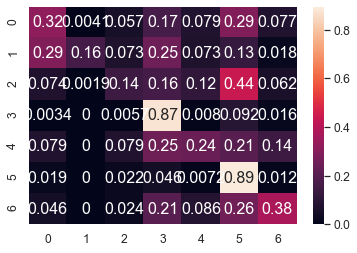

	training epoch=31 .. train_loss=1.02
	validation epoch=31 .. val_loss=1.417
	Accuracy = 49.2 % .. Percision = 52.400000000000006 % .. Recall = 43.1 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_31.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 32 .. loss = 1.036


  0%|                                                                                 | 1/1914 [00:01<52:49,  1.66s/it]

training @ epoch 32 .. loss = 0.82


  0%|                                                                                 | 2/1914 [00:02<49:14,  1.55s/it]

training @ epoch 32 .. loss = 0.799


  0%|▏                                                                                | 3/1914 [00:04<53:24,  1.68s/it]

training @ epoch 32 .. loss = 0.696


  0%|▏                                                                                | 4/1914 [00:06<53:44,  1.69s/it]

training @ epoch 32 .. loss = 0.873


  0%|▏                                                                                | 5/1914 [00:07<49:14,  1.55s/it]

training @ epoch 32 .. loss = 0.616


  0%|▎                                                                                | 6/1914 [00:09<46:01,  1.45s/it]

training @ epoch 32 .. loss = 0.937


  0%|▎                                                                                | 7/1914 [00:10<43:45,  1.38s/it]

training @ epoch 32 .. loss = 1.022


  0%|▎                                                                                | 8/1914 [00:11<42:14,  1.33s/it]

training @ epoch 32 .. loss = 0.963


  0%|▍                                                                                | 9/1914 [00:12<41:06,  1.30s/it]

training @ epoch 32 .. loss = 0.983


  1%|▍                                                                               | 10/1914 [00:13<40:26,  1.27s/it]

training @ epoch 32 .. loss = 0.683


  1%|▍                                                                               | 11/1914 [00:15<39:49,  1.26s/it]

training @ epoch 32 .. loss = 0.86


  1%|▌                                                                               | 12/1914 [00:16<39:23,  1.24s/it]

training @ epoch 32 .. loss = 0.988


  1%|▌                                                                               | 13/1914 [00:17<39:16,  1.24s/it]

training @ epoch 32 .. loss = 0.953


  1%|▌                                                                               | 14/1914 [00:18<38:53,  1.23s/it]

training @ epoch 32 .. loss = 0.815


  1%|▋                                                                               | 15/1914 [00:20<38:42,  1.22s/it]

training @ epoch 32 .. loss = 1.485


  1%|▋                                                                               | 16/1914 [00:21<38:36,  1.22s/it]

training @ epoch 32 .. loss = 1.307


  1%|▋                                                                               | 17/1914 [00:22<38:36,  1.22s/it]

training @ epoch 32 .. loss = 0.933


  1%|▊                                                                               | 18/1914 [00:23<38:12,  1.21s/it]

training @ epoch 32 .. loss = 0.704


  1%|▊                                                                               | 19/1914 [00:24<38:00,  1.20s/it]

training @ epoch 32 .. loss = 1.045


  1%|▊                                                                               | 20/1914 [00:26<37:47,  1.20s/it]

training @ epoch 32 .. loss = 1.031


  1%|▉                                                                               | 21/1914 [00:27<37:54,  1.20s/it]

training @ epoch 32 .. loss = 0.559


  1%|▉                                                                               | 22/1914 [00:28<38:40,  1.23s/it]

training @ epoch 32 .. loss = 1.398


  1%|▉                                                                               | 23/1914 [00:29<38:36,  1.23s/it]

training @ epoch 32 .. loss = 0.855


  1%|█                                                                               | 24/1914 [00:30<38:57,  1.24s/it]

training @ epoch 32 .. loss = 0.841


  1%|█                                                                               | 25/1914 [00:32<39:45,  1.26s/it]

training @ epoch 32 .. loss = 0.986


  1%|█                                                                               | 26/1914 [00:33<40:59,  1.30s/it]

training @ epoch 32 .. loss = 1.091


  1%|█▏                                                                              | 27/1914 [00:35<40:58,  1.30s/it]

training @ epoch 32 .. loss = 0.806


  1%|█▏                                                                              | 28/1914 [00:36<40:33,  1.29s/it]

training @ epoch 32 .. loss = 0.821


  2%|█▏                                                                              | 29/1914 [00:37<40:23,  1.29s/it]

training @ epoch 32 .. loss = 1.053


  2%|█▎                                                                              | 30/1914 [00:38<40:47,  1.30s/it]

training @ epoch 32 .. loss = 0.775


  2%|█▎                                                                              | 31/1914 [00:40<41:18,  1.32s/it]

training @ epoch 32 .. loss = 0.849


  2%|█▎                                                                              | 32/1914 [00:41<42:18,  1.35s/it]

training @ epoch 32 .. loss = 0.948


  2%|█▍                                                                              | 33/1914 [00:42<41:50,  1.33s/it]

training @ epoch 32 .. loss = 0.827


  2%|█▍                                                                              | 34/1914 [00:44<42:09,  1.35s/it]

training @ epoch 32 .. loss = 1.25


  2%|█▍                                                                              | 35/1914 [00:45<42:35,  1.36s/it]

training @ epoch 32 .. loss = 1.069


  2%|█▌                                                                              | 36/1914 [00:47<45:41,  1.46s/it]

training @ epoch 32 .. loss = 0.648


  2%|█▌                                                                              | 37/1914 [00:48<44:34,  1.42s/it]

training @ epoch 32 .. loss = 0.898


  2%|█▌                                                                              | 38/1914 [00:50<43:02,  1.38s/it]

training @ epoch 32 .. loss = 1.128


  2%|█▋                                                                              | 39/1914 [00:51<44:12,  1.41s/it]

training @ epoch 32 .. loss = 0.922


  2%|█▋                                                                              | 40/1914 [00:52<43:52,  1.40s/it]

training @ epoch 32 .. loss = 1.742


  2%|█▋                                                                              | 41/1914 [00:54<44:35,  1.43s/it]

training @ epoch 32 .. loss = 1.048


  2%|█▊                                                                              | 42/1914 [00:55<43:31,  1.40s/it]

training @ epoch 32 .. loss = 0.716


  2%|█▊                                                                              | 43/1914 [00:57<44:15,  1.42s/it]

training @ epoch 32 .. loss = 1.491


  2%|█▊                                                                              | 44/1914 [00:58<42:57,  1.38s/it]

training @ epoch 32 .. loss = 1.381


  2%|█▉                                                                              | 45/1914 [00:59<41:05,  1.32s/it]

training @ epoch 32 .. loss = 1.496


  2%|█▉                                                                              | 46/1914 [01:00<39:52,  1.28s/it]

training @ epoch 32 .. loss = 0.993


  2%|█▉                                                                              | 47/1914 [01:02<39:18,  1.26s/it]

training @ epoch 32 .. loss = 0.91


  3%|██                                                                              | 48/1914 [01:03<39:11,  1.26s/it]

training @ epoch 32 .. loss = 0.963


  3%|██                                                                              | 49/1914 [01:04<38:37,  1.24s/it]

training @ epoch 32 .. loss = 1.129


  3%|██                                                                              | 50/1914 [01:06<41:12,  1.33s/it]

training @ epoch 32 .. loss = 0.653


  3%|██▏                                                                             | 51/1914 [01:07<40:30,  1.30s/it]

training @ epoch 32 .. loss = 0.875


  3%|██▏                                                                             | 52/1914 [01:08<40:45,  1.31s/it]

training @ epoch 32 .. loss = 1.003


  3%|██▏                                                                             | 53/1914 [01:09<39:58,  1.29s/it]

training @ epoch 32 .. loss = 1.068


  3%|██▎                                                                             | 54/1914 [01:11<39:02,  1.26s/it]

training @ epoch 32 .. loss = 0.755


  3%|██▎                                                                             | 55/1914 [01:12<38:34,  1.25s/it]

training @ epoch 32 .. loss = 0.749


  3%|██▎                                                                             | 56/1914 [01:13<38:09,  1.23s/it]

training @ epoch 32 .. loss = 1.492


  3%|██▍                                                                             | 57/1914 [01:14<38:02,  1.23s/it]

training @ epoch 32 .. loss = 0.927


  3%|██▍                                                                             | 58/1914 [01:15<37:50,  1.22s/it]

training @ epoch 32 .. loss = 1.32


  3%|██▍                                                                             | 59/1914 [01:17<37:27,  1.21s/it]

training @ epoch 32 .. loss = 0.801


  3%|██▌                                                                             | 60/1914 [01:18<37:31,  1.21s/it]

training @ epoch 32 .. loss = 0.808


  3%|██▌                                                                             | 61/1914 [01:19<37:23,  1.21s/it]

training @ epoch 32 .. loss = 1.081


  3%|██▌                                                                             | 62/1914 [01:20<37:11,  1.21s/it]

training @ epoch 32 .. loss = 0.739


  3%|██▋                                                                             | 63/1914 [01:21<37:25,  1.21s/it]

training @ epoch 32 .. loss = 1.125


  3%|██▋                                                                             | 64/1914 [01:23<37:11,  1.21s/it]

training @ epoch 32 .. loss = 0.98


  3%|██▋                                                                             | 65/1914 [01:24<37:09,  1.21s/it]

training @ epoch 32 .. loss = 1.179


  3%|██▊                                                                             | 66/1914 [01:25<37:45,  1.23s/it]

training @ epoch 32 .. loss = 1.088


  4%|██▊                                                                             | 67/1914 [01:26<38:04,  1.24s/it]

training @ epoch 32 .. loss = 0.939


  4%|██▊                                                                             | 68/1914 [01:28<37:42,  1.23s/it]

training @ epoch 32 .. loss = 0.986


  4%|██▉                                                                             | 69/1914 [01:29<37:12,  1.21s/it]

training @ epoch 32 .. loss = 1.261


  4%|██▉                                                                             | 70/1914 [01:30<36:50,  1.20s/it]

training @ epoch 32 .. loss = 0.758


  4%|██▉                                                                             | 71/1914 [01:31<36:50,  1.20s/it]

training @ epoch 32 .. loss = 1.258


  4%|███                                                                             | 72/1914 [01:32<37:02,  1.21s/it]

training @ epoch 32 .. loss = 1.076


  4%|███                                                                             | 73/1914 [01:34<37:20,  1.22s/it]

training @ epoch 32 .. loss = 0.77


  4%|███                                                                             | 74/1914 [01:35<36:54,  1.20s/it]

training @ epoch 32 .. loss = 1.171


  4%|███▏                                                                            | 75/1914 [01:36<37:07,  1.21s/it]

training @ epoch 32 .. loss = 0.818


  4%|███▏                                                                            | 76/1914 [01:37<36:51,  1.20s/it]

training @ epoch 32 .. loss = 1.357


  4%|███▏                                                                            | 77/1914 [01:38<37:11,  1.21s/it]

training @ epoch 32 .. loss = 1.414


  4%|███▎                                                                            | 78/1914 [01:40<37:02,  1.21s/it]

training @ epoch 32 .. loss = 0.882


  4%|███▎                                                                            | 79/1914 [01:41<37:01,  1.21s/it]

training @ epoch 32 .. loss = 1.329


  4%|███▎                                                                            | 80/1914 [01:42<37:06,  1.21s/it]

training @ epoch 32 .. loss = 0.823


  4%|███▍                                                                            | 81/1914 [01:43<37:10,  1.22s/it]

training @ epoch 32 .. loss = 0.694


  4%|███▍                                                                            | 82/1914 [01:45<38:53,  1.27s/it]

training @ epoch 32 .. loss = 1.065


  4%|███▍                                                                            | 83/1914 [01:46<38:13,  1.25s/it]

training @ epoch 32 .. loss = 1.313


  4%|███▌                                                                            | 84/1914 [01:47<36:35,  1.20s/it]

training @ epoch 32 .. loss = 0.832


  4%|███▌                                                                            | 85/1914 [01:48<36:17,  1.19s/it]

training @ epoch 32 .. loss = 1.125


  4%|███▌                                                                            | 86/1914 [01:49<35:53,  1.18s/it]

training @ epoch 32 .. loss = 0.765


  5%|███▋                                                                            | 87/1914 [01:50<34:41,  1.14s/it]

training @ epoch 32 .. loss = 0.864


  5%|███▋                                                                            | 88/1914 [01:51<33:45,  1.11s/it]

training @ epoch 32 .. loss = 0.908


  5%|███▋                                                                            | 89/1914 [01:52<33:11,  1.09s/it]

training @ epoch 32 .. loss = 1.256


  5%|███▊                                                                            | 90/1914 [01:53<33:03,  1.09s/it]

training @ epoch 32 .. loss = 1.269


  5%|███▊                                                                            | 91/1914 [01:55<32:52,  1.08s/it]

training @ epoch 32 .. loss = 0.358


  5%|███▊                                                                            | 92/1914 [01:56<32:54,  1.08s/it]

training @ epoch 32 .. loss = 0.601


  5%|███▉                                                                            | 93/1914 [01:57<32:36,  1.07s/it]

training @ epoch 32 .. loss = 0.824


  5%|███▉                                                                            | 94/1914 [01:58<32:34,  1.07s/it]

training @ epoch 32 .. loss = 1.207


  5%|███▉                                                                            | 95/1914 [01:59<32:20,  1.07s/it]

training @ epoch 32 .. loss = 0.931


  5%|████                                                                            | 96/1914 [02:00<32:15,  1.06s/it]

training @ epoch 32 .. loss = 1.373


  5%|████                                                                            | 97/1914 [02:01<32:17,  1.07s/it]

training @ epoch 32 .. loss = 0.494


  5%|████                                                                            | 98/1914 [02:02<32:39,  1.08s/it]

training @ epoch 32 .. loss = 1.116


  5%|████▏                                                                           | 99/1914 [02:03<32:40,  1.08s/it]

training @ epoch 32 .. loss = 1.231


  5%|████▏                                                                          | 100/1914 [02:04<32:20,  1.07s/it]

training @ epoch 32 .. loss = 0.93


  5%|████▏                                                                          | 101/1914 [02:05<33:06,  1.10s/it]

training @ epoch 32 .. loss = 1.128


  5%|████▏                                                                          | 102/1914 [02:06<33:12,  1.10s/it]

training @ epoch 32 .. loss = 1.003


  5%|████▎                                                                          | 103/1914 [02:08<33:02,  1.09s/it]

training @ epoch 32 .. loss = 0.749


  5%|████▎                                                                          | 104/1914 [02:09<32:52,  1.09s/it]

training @ epoch 32 .. loss = 0.612


  5%|████▎                                                                          | 105/1914 [02:10<32:29,  1.08s/it]

training @ epoch 32 .. loss = 0.935


  6%|████▍                                                                          | 106/1914 [02:11<32:18,  1.07s/it]

training @ epoch 32 .. loss = 0.614


  6%|████▍                                                                          | 107/1914 [02:12<32:10,  1.07s/it]

training @ epoch 32 .. loss = 0.925


  6%|████▍                                                                          | 108/1914 [02:13<32:11,  1.07s/it]

training @ epoch 32 .. loss = 0.984


  6%|████▍                                                                          | 109/1914 [02:14<32:23,  1.08s/it]

training @ epoch 32 .. loss = 0.876


  6%|████▌                                                                          | 110/1914 [02:15<31:50,  1.06s/it]

training @ epoch 32 .. loss = 1.007


  6%|████▌                                                                          | 111/1914 [02:16<31:39,  1.05s/it]

training @ epoch 32 .. loss = 1.604


  6%|████▌                                                                          | 112/1914 [02:17<31:27,  1.05s/it]

training @ epoch 32 .. loss = 1.62


  6%|████▋                                                                          | 113/1914 [02:18<31:47,  1.06s/it]

training @ epoch 32 .. loss = 0.596


  6%|████▋                                                                          | 114/1914 [02:19<31:57,  1.07s/it]

training @ epoch 32 .. loss = 0.869


  6%|████▋                                                                          | 115/1914 [02:20<32:05,  1.07s/it]

training @ epoch 32 .. loss = 0.984


  6%|████▊                                                                          | 116/1914 [02:21<31:46,  1.06s/it]

training @ epoch 32 .. loss = 1.203


  6%|████▊                                                                          | 117/1914 [02:22<31:41,  1.06s/it]

training @ epoch 32 .. loss = 2.524


  6%|████▊                                                                          | 118/1914 [02:23<31:19,  1.05s/it]

training @ epoch 32 .. loss = 0.855


  6%|████▉                                                                          | 119/1914 [02:24<31:13,  1.04s/it]

training @ epoch 32 .. loss = 0.716


  6%|████▉                                                                          | 120/1914 [02:26<31:41,  1.06s/it]

training @ epoch 32 .. loss = 0.719


  6%|████▉                                                                          | 121/1914 [02:27<31:33,  1.06s/it]

training @ epoch 32 .. loss = 1.476


  6%|█████                                                                          | 122/1914 [02:28<31:56,  1.07s/it]

training @ epoch 32 .. loss = 1.118


  6%|█████                                                                          | 123/1914 [02:29<31:52,  1.07s/it]

training @ epoch 32 .. loss = 1.079


  6%|█████                                                                          | 124/1914 [02:30<31:49,  1.07s/it]

training @ epoch 32 .. loss = 1.498


  7%|█████▏                                                                         | 125/1914 [02:31<31:41,  1.06s/it]

training @ epoch 32 .. loss = 0.961


  7%|█████▏                                                                         | 126/1914 [02:32<31:28,  1.06s/it]

training @ epoch 32 .. loss = 1.171


  7%|█████▏                                                                         | 127/1914 [02:33<32:01,  1.08s/it]

training @ epoch 32 .. loss = 1.729


  7%|█████▎                                                                         | 128/1914 [02:34<32:08,  1.08s/it]

training @ epoch 32 .. loss = 0.785


  7%|█████▎                                                                         | 129/1914 [02:35<32:04,  1.08s/it]

training @ epoch 32 .. loss = 0.669


  7%|█████▎                                                                         | 130/1914 [02:36<32:08,  1.08s/it]

training @ epoch 32 .. loss = 1.231


  7%|█████▍                                                                         | 131/1914 [02:37<31:34,  1.06s/it]

training @ epoch 32 .. loss = 0.891


  7%|█████▍                                                                         | 132/1914 [02:38<31:20,  1.06s/it]

training @ epoch 32 .. loss = 1.372


  7%|█████▍                                                                         | 133/1914 [02:39<32:05,  1.08s/it]

training @ epoch 32 .. loss = 0.579


  7%|█████▌                                                                         | 134/1914 [02:41<32:04,  1.08s/it]

training @ epoch 32 .. loss = 0.812


  7%|█████▌                                                                         | 135/1914 [02:42<31:31,  1.06s/it]

training @ epoch 32 .. loss = 1.064


  7%|█████▌                                                                         | 136/1914 [02:43<31:42,  1.07s/it]

training @ epoch 32 .. loss = 0.992


  7%|█████▋                                                                         | 137/1914 [02:44<31:35,  1.07s/it]

training @ epoch 32 .. loss = 1.625


  7%|█████▋                                                                         | 138/1914 [02:45<31:55,  1.08s/it]

training @ epoch 32 .. loss = 0.992


  7%|█████▋                                                                         | 139/1914 [02:46<31:45,  1.07s/it]

training @ epoch 32 .. loss = 1.177


  7%|█████▊                                                                         | 140/1914 [02:47<31:55,  1.08s/it]

training @ epoch 32 .. loss = 0.912


  7%|█████▊                                                                         | 141/1914 [02:48<31:39,  1.07s/it]

training @ epoch 32 .. loss = 1.405


  7%|█████▊                                                                         | 142/1914 [02:49<31:26,  1.06s/it]

training @ epoch 32 .. loss = 0.918


  7%|█████▉                                                                         | 143/1914 [02:50<31:29,  1.07s/it]

training @ epoch 32 .. loss = 0.714


  8%|█████▉                                                                         | 144/1914 [02:51<32:27,  1.10s/it]

training @ epoch 32 .. loss = 1.017


  8%|█████▉                                                                         | 145/1914 [02:53<34:01,  1.15s/it]

training @ epoch 32 .. loss = 0.916


  8%|██████                                                                         | 146/1914 [02:54<33:26,  1.14s/it]

training @ epoch 32 .. loss = 0.84


  8%|██████                                                                         | 147/1914 [02:55<32:45,  1.11s/it]

training @ epoch 32 .. loss = 0.716


  8%|██████                                                                         | 148/1914 [02:56<32:22,  1.10s/it]

training @ epoch 32 .. loss = 1.463


  8%|██████▏                                                                        | 149/1914 [02:57<32:12,  1.10s/it]

training @ epoch 32 .. loss = 1.14


  8%|██████▏                                                                        | 150/1914 [02:58<33:40,  1.15s/it]

training @ epoch 32 .. loss = 1.228


  8%|██████▏                                                                        | 151/1914 [02:59<33:03,  1.13s/it]

training @ epoch 32 .. loss = 0.538


  8%|██████▎                                                                        | 152/1914 [03:00<32:38,  1.11s/it]

training @ epoch 32 .. loss = 0.77


  8%|██████▎                                                                        | 153/1914 [03:01<32:11,  1.10s/it]

training @ epoch 32 .. loss = 0.539


  8%|██████▎                                                                        | 154/1914 [03:02<31:45,  1.08s/it]

training @ epoch 32 .. loss = 1.661


  8%|██████▍                                                                        | 155/1914 [03:04<31:54,  1.09s/it]

training @ epoch 32 .. loss = 1.026


  8%|██████▍                                                                        | 156/1914 [03:05<31:44,  1.08s/it]

training @ epoch 32 .. loss = 0.589


  8%|██████▍                                                                        | 157/1914 [03:06<31:52,  1.09s/it]

training @ epoch 32 .. loss = 1.066


  8%|██████▌                                                                        | 158/1914 [03:07<31:40,  1.08s/it]

training @ epoch 32 .. loss = 0.977


  8%|██████▌                                                                        | 159/1914 [03:08<31:13,  1.07s/it]

training @ epoch 32 .. loss = 0.778


  8%|██████▌                                                                        | 160/1914 [03:09<31:42,  1.08s/it]

training @ epoch 32 .. loss = 1.112


  8%|██████▋                                                                        | 161/1914 [03:10<32:53,  1.13s/it]

training @ epoch 32 .. loss = 1.389


  8%|██████▋                                                                        | 162/1914 [03:11<32:54,  1.13s/it]

training @ epoch 32 .. loss = 0.937


  9%|██████▋                                                                        | 163/1914 [03:12<32:06,  1.10s/it]

training @ epoch 32 .. loss = 0.912


  9%|██████▊                                                                        | 164/1914 [03:13<31:54,  1.09s/it]

training @ epoch 32 .. loss = 0.924


  9%|██████▊                                                                        | 165/1914 [03:14<31:33,  1.08s/it]

training @ epoch 32 .. loss = 0.877


  9%|██████▊                                                                        | 166/1914 [03:16<31:36,  1.08s/it]

training @ epoch 32 .. loss = 1.119


  9%|██████▉                                                                        | 167/1914 [03:17<31:33,  1.08s/it]

training @ epoch 32 .. loss = 1.368


  9%|██████▉                                                                        | 168/1914 [03:18<31:07,  1.07s/it]

training @ epoch 32 .. loss = 1.005


  9%|██████▉                                                                        | 169/1914 [03:19<31:15,  1.07s/it]

training @ epoch 32 .. loss = 0.904


  9%|███████                                                                        | 170/1914 [03:20<31:17,  1.08s/it]

training @ epoch 32 .. loss = 1.237


  9%|███████                                                                        | 171/1914 [03:21<30:48,  1.06s/it]

training @ epoch 32 .. loss = 0.619


  9%|███████                                                                        | 172/1914 [03:22<30:49,  1.06s/it]

training @ epoch 32 .. loss = 1.28


  9%|███████▏                                                                       | 173/1914 [03:23<30:51,  1.06s/it]

training @ epoch 32 .. loss = 1.025


  9%|███████▏                                                                       | 174/1914 [03:24<31:05,  1.07s/it]

training @ epoch 32 .. loss = 0.897


  9%|███████▏                                                                       | 175/1914 [03:25<30:55,  1.07s/it]

training @ epoch 32 .. loss = 1.377


  9%|███████▎                                                                       | 176/1914 [03:26<31:11,  1.08s/it]

training @ epoch 32 .. loss = 0.919


  9%|███████▎                                                                       | 177/1914 [03:27<30:50,  1.07s/it]

training @ epoch 32 .. loss = 0.926


  9%|███████▎                                                                       | 178/1914 [03:28<31:12,  1.08s/it]

training @ epoch 32 .. loss = 0.889


  9%|███████▍                                                                       | 179/1914 [03:29<30:55,  1.07s/it]

training @ epoch 32 .. loss = 1.112


  9%|███████▍                                                                       | 180/1914 [03:30<30:32,  1.06s/it]

training @ epoch 32 .. loss = 0.912


  9%|███████▍                                                                       | 181/1914 [03:32<30:38,  1.06s/it]

training @ epoch 32 .. loss = 1.146


 10%|███████▌                                                                       | 182/1914 [03:33<30:31,  1.06s/it]

training @ epoch 32 .. loss = 0.947


 10%|███████▌                                                                       | 183/1914 [03:34<30:37,  1.06s/it]

training @ epoch 32 .. loss = 1.112


 10%|███████▌                                                                       | 184/1914 [03:35<30:54,  1.07s/it]

training @ epoch 32 .. loss = 0.591


 10%|███████▋                                                                       | 185/1914 [03:36<30:34,  1.06s/it]

training @ epoch 32 .. loss = 0.846


 10%|███████▋                                                                       | 186/1914 [03:37<30:56,  1.07s/it]

training @ epoch 32 .. loss = 1.02


 10%|███████▋                                                                       | 187/1914 [03:38<31:00,  1.08s/it]

training @ epoch 32 .. loss = 0.946


 10%|███████▊                                                                       | 188/1914 [03:39<31:04,  1.08s/it]

training @ epoch 32 .. loss = 0.633


 10%|███████▊                                                                       | 189/1914 [03:40<30:47,  1.07s/it]

training @ epoch 32 .. loss = 1.233


 10%|███████▊                                                                       | 190/1914 [03:41<30:58,  1.08s/it]

training @ epoch 32 .. loss = 1.524


 10%|███████▉                                                                       | 191/1914 [03:42<30:54,  1.08s/it]

training @ epoch 32 .. loss = 0.976


 10%|███████▉                                                                       | 192/1914 [03:43<30:44,  1.07s/it]

training @ epoch 32 .. loss = 1.029


 10%|███████▉                                                                       | 193/1914 [03:44<31:01,  1.08s/it]

training @ epoch 32 .. loss = 1.726


 10%|████████                                                                       | 194/1914 [03:45<30:39,  1.07s/it]

training @ epoch 32 .. loss = 0.674


 10%|████████                                                                       | 195/1914 [03:47<30:44,  1.07s/it]

training @ epoch 32 .. loss = 0.755


 10%|████████                                                                       | 196/1914 [03:48<30:39,  1.07s/it]

training @ epoch 32 .. loss = 0.943


 10%|████████▏                                                                      | 197/1914 [03:49<30:38,  1.07s/it]

training @ epoch 32 .. loss = 0.769


 10%|████████▏                                                                      | 198/1914 [03:50<30:34,  1.07s/it]

training @ epoch 32 .. loss = 1.139


 10%|████████▏                                                                      | 199/1914 [03:51<30:23,  1.06s/it]

training @ epoch 32 .. loss = 0.978


 10%|████████▎                                                                      | 200/1914 [03:52<30:28,  1.07s/it]

training @ epoch 32 .. loss = 1.474


 11%|████████▎                                                                      | 201/1914 [03:53<31:03,  1.09s/it]

training @ epoch 32 .. loss = 0.568


 11%|████████▎                                                                      | 202/1914 [03:54<31:23,  1.10s/it]

training @ epoch 32 .. loss = 0.902


 11%|████████▍                                                                      | 203/1914 [03:55<31:14,  1.10s/it]

training @ epoch 32 .. loss = 0.588


 11%|████████▍                                                                      | 204/1914 [03:56<32:28,  1.14s/it]

training @ epoch 32 .. loss = 0.792


 11%|████████▍                                                                      | 205/1914 [03:58<32:12,  1.13s/it]

training @ epoch 32 .. loss = 0.841


 11%|████████▌                                                                      | 206/1914 [03:59<34:10,  1.20s/it]

training @ epoch 32 .. loss = 1.475


 11%|████████▌                                                                      | 207/1914 [04:00<33:02,  1.16s/it]

training @ epoch 32 .. loss = 0.818


 11%|████████▌                                                                      | 208/1914 [04:01<32:12,  1.13s/it]

training @ epoch 32 .. loss = 0.944


 11%|████████▋                                                                      | 209/1914 [04:02<31:41,  1.12s/it]

training @ epoch 32 .. loss = 1.515


 11%|████████▋                                                                      | 210/1914 [04:03<31:13,  1.10s/it]

training @ epoch 32 .. loss = 0.936


 11%|████████▋                                                                      | 211/1914 [04:04<30:50,  1.09s/it]

training @ epoch 32 .. loss = 1.005


 11%|████████▊                                                                      | 212/1914 [04:05<30:36,  1.08s/it]

training @ epoch 32 .. loss = 0.828


 11%|████████▊                                                                      | 213/1914 [04:06<30:40,  1.08s/it]

training @ epoch 32 .. loss = 1.323


 11%|████████▊                                                                      | 214/1914 [04:08<30:55,  1.09s/it]

training @ epoch 32 .. loss = 1.206


 11%|████████▊                                                                      | 215/1914 [04:09<30:25,  1.07s/it]

training @ epoch 32 .. loss = 0.851


 11%|████████▉                                                                      | 216/1914 [04:10<30:48,  1.09s/it]

training @ epoch 32 .. loss = 0.949


 11%|████████▉                                                                      | 217/1914 [04:11<30:30,  1.08s/it]

training @ epoch 32 .. loss = 1.668


 11%|████████▉                                                                      | 218/1914 [04:12<30:27,  1.08s/it]

training @ epoch 32 .. loss = 0.622


 11%|█████████                                                                      | 219/1914 [04:13<30:15,  1.07s/it]

training @ epoch 32 .. loss = 1.049


 11%|█████████                                                                      | 220/1914 [04:14<30:46,  1.09s/it]

training @ epoch 32 .. loss = 0.749


 12%|█████████                                                                      | 221/1914 [04:15<30:19,  1.07s/it]

training @ epoch 32 .. loss = 0.649


 12%|█████████▏                                                                     | 222/1914 [04:16<30:14,  1.07s/it]

training @ epoch 32 .. loss = 0.801


 12%|█████████▏                                                                     | 223/1914 [04:17<30:17,  1.07s/it]

training @ epoch 32 .. loss = 1.085


 12%|█████████▏                                                                     | 224/1914 [04:18<30:09,  1.07s/it]

training @ epoch 32 .. loss = 1.418


 12%|█████████▎                                                                     | 225/1914 [04:19<29:49,  1.06s/it]

training @ epoch 32 .. loss = 1.184


 12%|█████████▎                                                                     | 226/1914 [04:20<30:04,  1.07s/it]

training @ epoch 32 .. loss = 1.05


 12%|█████████▎                                                                     | 227/1914 [04:21<30:03,  1.07s/it]

training @ epoch 32 .. loss = 1.1


 12%|█████████▍                                                                     | 228/1914 [04:23<30:23,  1.08s/it]

training @ epoch 32 .. loss = 1.086


 12%|█████████▍                                                                     | 229/1914 [04:24<30:07,  1.07s/it]

training @ epoch 32 .. loss = 0.844


 12%|█████████▍                                                                     | 230/1914 [04:25<30:24,  1.08s/it]

training @ epoch 32 .. loss = 0.803


 12%|█████████▌                                                                     | 231/1914 [04:26<30:02,  1.07s/it]

training @ epoch 32 .. loss = 0.974


 12%|█████████▌                                                                     | 232/1914 [04:27<29:37,  1.06s/it]

training @ epoch 32 .. loss = 1.176


 12%|█████████▌                                                                     | 233/1914 [04:28<29:24,  1.05s/it]

training @ epoch 32 .. loss = 1.314


 12%|█████████▋                                                                     | 234/1914 [04:29<29:56,  1.07s/it]

training @ epoch 32 .. loss = 0.843


 12%|█████████▋                                                                     | 235/1914 [04:30<29:37,  1.06s/it]

training @ epoch 32 .. loss = 1.27


 12%|█████████▋                                                                     | 236/1914 [04:31<29:42,  1.06s/it]

training @ epoch 32 .. loss = 0.828


 12%|█████████▊                                                                     | 237/1914 [04:32<29:31,  1.06s/it]

training @ epoch 32 .. loss = 1.04


 12%|█████████▊                                                                     | 238/1914 [04:33<29:26,  1.05s/it]

training @ epoch 32 .. loss = 0.867


 12%|█████████▊                                                                     | 239/1914 [04:34<29:18,  1.05s/it]

training @ epoch 32 .. loss = 1.109


 13%|█████████▉                                                                     | 240/1914 [04:35<29:09,  1.04s/it]

training @ epoch 32 .. loss = 1.066


 13%|█████████▉                                                                     | 241/1914 [04:36<29:44,  1.07s/it]

training @ epoch 32 .. loss = 0.931


 13%|█████████▉                                                                     | 242/1914 [04:37<29:52,  1.07s/it]

training @ epoch 32 .. loss = 1.079


 13%|██████████                                                                     | 243/1914 [04:38<29:46,  1.07s/it]

training @ epoch 32 .. loss = 0.779


 13%|██████████                                                                     | 244/1914 [04:40<29:45,  1.07s/it]

training @ epoch 32 .. loss = 0.462


 13%|██████████                                                                     | 245/1914 [04:41<30:20,  1.09s/it]

training @ epoch 32 .. loss = 0.78


 13%|██████████▏                                                                    | 246/1914 [04:42<31:00,  1.12s/it]

training @ epoch 32 .. loss = 1.108


 13%|██████████▏                                                                    | 247/1914 [04:43<30:11,  1.09s/it]

training @ epoch 32 .. loss = 0.712


 13%|██████████▏                                                                    | 248/1914 [04:44<29:59,  1.08s/it]

training @ epoch 32 .. loss = 0.834


 13%|██████████▎                                                                    | 249/1914 [04:45<30:02,  1.08s/it]

training @ epoch 32 .. loss = 0.934


 13%|██████████▎                                                                    | 250/1914 [04:46<30:45,  1.11s/it]

training @ epoch 32 .. loss = 0.827


 13%|██████████▎                                                                    | 251/1914 [04:47<30:49,  1.11s/it]

training @ epoch 32 .. loss = 0.489


 13%|██████████▍                                                                    | 252/1914 [04:48<30:27,  1.10s/it]

training @ epoch 32 .. loss = 0.841


 13%|██████████▍                                                                    | 253/1914 [04:50<30:42,  1.11s/it]

training @ epoch 32 .. loss = 0.656


 13%|██████████▍                                                                    | 254/1914 [04:51<29:55,  1.08s/it]

training @ epoch 32 .. loss = 0.811


 13%|██████████▌                                                                    | 255/1914 [04:52<29:41,  1.07s/it]

training @ epoch 32 .. loss = 1.453


 13%|██████████▌                                                                    | 256/1914 [04:53<29:54,  1.08s/it]

training @ epoch 32 .. loss = 0.813


 13%|██████████▌                                                                    | 257/1914 [04:54<29:52,  1.08s/it]

training @ epoch 32 .. loss = 0.94


 13%|██████████▋                                                                    | 258/1914 [04:55<30:12,  1.09s/it]

training @ epoch 32 .. loss = 1.495


 14%|██████████▋                                                                    | 259/1914 [04:56<30:15,  1.10s/it]

training @ epoch 32 .. loss = 1.065


 14%|██████████▋                                                                    | 260/1914 [04:57<30:26,  1.10s/it]

training @ epoch 32 .. loss = 1.006


 14%|██████████▊                                                                    | 261/1914 [04:58<30:06,  1.09s/it]

training @ epoch 32 .. loss = 1.068


 14%|██████████▊                                                                    | 262/1914 [04:59<29:54,  1.09s/it]

training @ epoch 32 .. loss = 1.09


 14%|██████████▊                                                                    | 263/1914 [05:00<29:42,  1.08s/it]

training @ epoch 32 .. loss = 0.864


 14%|██████████▉                                                                    | 264/1914 [05:01<29:48,  1.08s/it]

training @ epoch 32 .. loss = 0.899


 14%|██████████▉                                                                    | 265/1914 [05:03<29:44,  1.08s/it]

training @ epoch 32 .. loss = 1.284


 14%|██████████▉                                                                    | 266/1914 [05:04<29:38,  1.08s/it]

training @ epoch 32 .. loss = 0.75


 14%|███████████                                                                    | 267/1914 [05:05<29:44,  1.08s/it]

training @ epoch 32 .. loss = 0.706


 14%|███████████                                                                    | 268/1914 [05:06<29:43,  1.08s/it]

training @ epoch 32 .. loss = 0.832


 14%|███████████                                                                    | 269/1914 [05:07<29:36,  1.08s/it]

training @ epoch 32 .. loss = 0.719


 14%|███████████▏                                                                   | 270/1914 [05:08<29:20,  1.07s/it]

training @ epoch 32 .. loss = 1.272


 14%|███████████▏                                                                   | 271/1914 [05:09<29:04,  1.06s/it]

training @ epoch 32 .. loss = 0.701


 14%|███████████▏                                                                   | 272/1914 [05:10<29:14,  1.07s/it]

training @ epoch 32 .. loss = 0.825


 14%|███████████▎                                                                   | 273/1914 [05:11<29:10,  1.07s/it]

training @ epoch 32 .. loss = 1.497


 14%|███████████▎                                                                   | 274/1914 [05:12<29:33,  1.08s/it]

training @ epoch 32 .. loss = 0.948


 14%|███████████▎                                                                   | 275/1914 [05:13<28:56,  1.06s/it]

training @ epoch 32 .. loss = 1.011


 14%|███████████▍                                                                   | 276/1914 [05:14<28:57,  1.06s/it]

training @ epoch 32 .. loss = 0.874


 14%|███████████▍                                                                   | 277/1914 [05:15<28:47,  1.06s/it]

training @ epoch 32 .. loss = 1.08


 15%|███████████▍                                                                   | 278/1914 [05:16<28:48,  1.06s/it]

training @ epoch 32 .. loss = 1.198


 15%|███████████▌                                                                   | 279/1914 [05:18<29:30,  1.08s/it]

training @ epoch 32 .. loss = 0.808


 15%|███████████▌                                                                   | 280/1914 [05:19<29:16,  1.07s/it]

training @ epoch 32 .. loss = 1.139


 15%|███████████▌                                                                   | 281/1914 [05:20<29:04,  1.07s/it]

training @ epoch 32 .. loss = 1.255


 15%|███████████▋                                                                   | 282/1914 [05:21<28:47,  1.06s/it]

training @ epoch 32 .. loss = 0.663


 15%|███████████▋                                                                   | 283/1914 [05:22<29:00,  1.07s/it]

training @ epoch 32 .. loss = 0.908


 15%|███████████▋                                                                   | 284/1914 [05:23<28:57,  1.07s/it]

training @ epoch 32 .. loss = 1.069


 15%|███████████▊                                                                   | 285/1914 [05:24<30:04,  1.11s/it]

training @ epoch 32 .. loss = 1.192


 15%|███████████▊                                                                   | 286/1914 [05:25<32:09,  1.19s/it]

training @ epoch 32 .. loss = 0.889


 15%|███████████▊                                                                   | 287/1914 [05:27<32:51,  1.21s/it]

training @ epoch 32 .. loss = 0.883


 15%|███████████▉                                                                   | 288/1914 [05:28<33:05,  1.22s/it]

training @ epoch 32 .. loss = 1.15


 15%|███████████▉                                                                   | 289/1914 [05:29<33:01,  1.22s/it]

training @ epoch 32 .. loss = 0.651


 15%|███████████▉                                                                   | 290/1914 [05:30<32:59,  1.22s/it]

training @ epoch 32 .. loss = 0.704


 15%|████████████                                                                   | 291/1914 [05:32<33:34,  1.24s/it]

training @ epoch 32 .. loss = 0.993


 15%|████████████                                                                   | 292/1914 [05:33<34:05,  1.26s/it]

training @ epoch 32 .. loss = 0.972


 15%|████████████                                                                   | 293/1914 [05:34<34:51,  1.29s/it]

training @ epoch 32 .. loss = 0.603


 15%|████████████▏                                                                  | 294/1914 [05:36<35:07,  1.30s/it]

training @ epoch 32 .. loss = 1.124


 15%|████████████▏                                                                  | 295/1914 [05:37<34:52,  1.29s/it]

training @ epoch 32 .. loss = 0.971


 15%|████████████▏                                                                  | 296/1914 [05:38<34:17,  1.27s/it]

training @ epoch 32 .. loss = 1.028


 16%|████████████▎                                                                  | 297/1914 [05:39<34:22,  1.28s/it]

training @ epoch 32 .. loss = 1.152


 16%|████████████▎                                                                  | 298/1914 [05:41<35:01,  1.30s/it]

training @ epoch 32 .. loss = 1.179


 16%|████████████▎                                                                  | 299/1914 [05:42<35:33,  1.32s/it]

training @ epoch 32 .. loss = 1.138


 16%|████████████▍                                                                  | 300/1914 [05:44<36:53,  1.37s/it]

training @ epoch 32 .. loss = 1.015


 16%|████████████▍                                                                  | 301/1914 [05:45<38:02,  1.41s/it]

training @ epoch 32 .. loss = 1.101


 16%|████████████▍                                                                  | 302/1914 [05:47<38:23,  1.43s/it]

training @ epoch 32 .. loss = 1.454


 16%|████████████▌                                                                  | 303/1914 [05:48<38:48,  1.45s/it]

training @ epoch 32 .. loss = 0.586


 16%|████████████▌                                                                  | 304/1914 [05:49<36:10,  1.35s/it]

training @ epoch 32 .. loss = 0.568


 16%|████████████▌                                                                  | 305/1914 [05:50<34:00,  1.27s/it]

training @ epoch 32 .. loss = 1.254


 16%|████████████▋                                                                  | 306/1914 [05:51<32:27,  1.21s/it]

training @ epoch 32 .. loss = 1.043


 16%|████████████▋                                                                  | 307/1914 [05:53<32:10,  1.20s/it]

training @ epoch 32 .. loss = 1.229


 16%|████████████▋                                                                  | 308/1914 [05:54<31:39,  1.18s/it]

training @ epoch 32 .. loss = 1.166


 16%|████████████▊                                                                  | 309/1914 [05:55<30:35,  1.14s/it]

training @ epoch 32 .. loss = 0.904


 16%|████████████▊                                                                  | 310/1914 [05:56<29:59,  1.12s/it]

training @ epoch 32 .. loss = 0.879


 16%|████████████▊                                                                  | 311/1914 [05:57<29:38,  1.11s/it]

training @ epoch 32 .. loss = 1.089


 16%|████████████▉                                                                  | 312/1914 [05:58<30:39,  1.15s/it]

training @ epoch 32 .. loss = 1.295


 16%|████████████▉                                                                  | 313/1914 [05:59<30:43,  1.15s/it]

training @ epoch 32 .. loss = 1.034


 16%|████████████▉                                                                  | 314/1914 [06:00<29:49,  1.12s/it]

training @ epoch 32 .. loss = 0.931


 16%|█████████████                                                                  | 315/1914 [06:01<29:18,  1.10s/it]

training @ epoch 32 .. loss = 0.847


 17%|█████████████                                                                  | 316/1914 [06:02<29:00,  1.09s/it]

training @ epoch 32 .. loss = 0.683


 17%|█████████████                                                                  | 317/1914 [06:04<28:52,  1.08s/it]

training @ epoch 32 .. loss = 0.709


 17%|█████████████▏                                                                 | 318/1914 [06:05<29:07,  1.09s/it]

training @ epoch 32 .. loss = 0.829


 17%|█████████████▏                                                                 | 319/1914 [06:06<29:03,  1.09s/it]

training @ epoch 32 .. loss = 1.492


 17%|█████████████▏                                                                 | 320/1914 [06:07<29:02,  1.09s/it]

training @ epoch 32 .. loss = 0.819


 17%|█████████████▏                                                                 | 321/1914 [06:08<29:05,  1.10s/it]

training @ epoch 32 .. loss = 1.404


 17%|█████████████▎                                                                 | 322/1914 [06:09<28:45,  1.08s/it]

training @ epoch 32 .. loss = 0.955


 17%|█████████████▎                                                                 | 323/1914 [06:10<28:51,  1.09s/it]

training @ epoch 32 .. loss = 0.753


 17%|█████████████▎                                                                 | 324/1914 [06:11<28:49,  1.09s/it]

training @ epoch 32 .. loss = 0.972


 17%|█████████████▍                                                                 | 325/1914 [06:12<28:55,  1.09s/it]

training @ epoch 32 .. loss = 1.492


 17%|█████████████▍                                                                 | 326/1914 [06:13<28:44,  1.09s/it]

training @ epoch 32 .. loss = 0.498


 17%|█████████████▍                                                                 | 327/1914 [06:14<29:11,  1.10s/it]

training @ epoch 32 .. loss = 0.917


 17%|█████████████▌                                                                 | 328/1914 [06:16<28:57,  1.10s/it]

training @ epoch 32 .. loss = 0.434


 17%|█████████████▌                                                                 | 329/1914 [06:17<28:59,  1.10s/it]

training @ epoch 32 .. loss = 0.873


 17%|█████████████▌                                                                 | 330/1914 [06:18<28:49,  1.09s/it]

training @ epoch 32 .. loss = 0.708


 17%|█████████████▋                                                                 | 331/1914 [06:19<29:02,  1.10s/it]

training @ epoch 32 .. loss = 1.191


 17%|█████████████▋                                                                 | 332/1914 [06:20<29:02,  1.10s/it]

training @ epoch 32 .. loss = 1.299


 17%|█████████████▋                                                                 | 333/1914 [06:21<28:50,  1.09s/it]

training @ epoch 32 .. loss = 1.528


 17%|█████████████▊                                                                 | 334/1914 [06:22<28:23,  1.08s/it]

training @ epoch 32 .. loss = 1.202


 18%|█████████████▊                                                                 | 335/1914 [06:23<28:01,  1.06s/it]

training @ epoch 32 .. loss = 1.161


 18%|█████████████▊                                                                 | 336/1914 [06:24<28:08,  1.07s/it]

training @ epoch 32 .. loss = 0.697


 18%|█████████████▉                                                                 | 337/1914 [06:25<27:57,  1.06s/it]

training @ epoch 32 .. loss = 0.874


 18%|█████████████▉                                                                 | 338/1914 [06:26<28:07,  1.07s/it]

training @ epoch 32 .. loss = 1.065


 18%|█████████████▉                                                                 | 339/1914 [06:27<27:56,  1.06s/it]

training @ epoch 32 .. loss = 0.887


 18%|██████████████                                                                 | 340/1914 [06:28<27:58,  1.07s/it]

training @ epoch 32 .. loss = 0.668


 18%|██████████████                                                                 | 341/1914 [06:30<29:31,  1.13s/it]

training @ epoch 32 .. loss = 1.244


 18%|██████████████                                                                 | 342/1914 [06:31<29:49,  1.14s/it]

training @ epoch 32 .. loss = 0.817


 18%|██████████████▏                                                                | 343/1914 [06:32<29:17,  1.12s/it]

training @ epoch 32 .. loss = 1.283


 18%|██████████████▏                                                                | 344/1914 [06:33<28:35,  1.09s/it]

training @ epoch 32 .. loss = 0.79


 18%|██████████████▏                                                                | 345/1914 [06:34<28:15,  1.08s/it]

training @ epoch 32 .. loss = 0.742


 18%|██████████████▎                                                                | 346/1914 [06:35<27:55,  1.07s/it]

training @ epoch 32 .. loss = 1.299


 18%|██████████████▎                                                                | 347/1914 [06:36<27:46,  1.06s/it]

training @ epoch 32 .. loss = 0.888


 18%|██████████████▎                                                                | 348/1914 [06:37<28:03,  1.08s/it]

training @ epoch 32 .. loss = 0.983


 18%|██████████████▍                                                                | 349/1914 [06:38<27:51,  1.07s/it]

training @ epoch 32 .. loss = 1.006


 18%|██████████████▍                                                                | 350/1914 [06:39<28:06,  1.08s/it]

training @ epoch 32 .. loss = 0.901


 18%|██████████████▍                                                                | 351/1914 [06:40<28:21,  1.09s/it]

training @ epoch 32 .. loss = 1.007


 18%|██████████████▌                                                                | 352/1914 [06:42<28:22,  1.09s/it]

training @ epoch 32 .. loss = 0.929


 18%|██████████████▌                                                                | 353/1914 [06:43<28:11,  1.08s/it]

training @ epoch 32 .. loss = 1.043


 18%|██████████████▌                                                                | 354/1914 [06:44<28:04,  1.08s/it]

training @ epoch 32 .. loss = 1.181


 19%|██████████████▋                                                                | 355/1914 [06:45<28:03,  1.08s/it]

training @ epoch 32 .. loss = 1.524


 19%|██████████████▋                                                                | 356/1914 [06:46<27:48,  1.07s/it]

training @ epoch 32 .. loss = 1.026


 19%|██████████████▋                                                                | 357/1914 [06:47<27:30,  1.06s/it]

training @ epoch 32 .. loss = 0.953


 19%|██████████████▊                                                                | 358/1914 [06:48<27:56,  1.08s/it]

training @ epoch 32 .. loss = 0.795


 19%|██████████████▊                                                                | 359/1914 [06:49<27:35,  1.06s/it]

training @ epoch 32 .. loss = 1.658


 19%|██████████████▊                                                                | 360/1914 [06:50<27:30,  1.06s/it]

training @ epoch 32 .. loss = 0.657


 19%|██████████████▉                                                                | 361/1914 [06:51<27:42,  1.07s/it]

training @ epoch 32 .. loss = 1.212


 19%|██████████████▉                                                                | 362/1914 [06:52<27:51,  1.08s/it]

training @ epoch 32 .. loss = 0.983


 19%|██████████████▉                                                                | 363/1914 [06:53<28:17,  1.09s/it]

training @ epoch 32 .. loss = 1.298


 19%|███████████████                                                                | 364/1914 [06:55<28:55,  1.12s/it]

training @ epoch 32 .. loss = 1.032


 19%|███████████████                                                                | 365/1914 [06:56<28:39,  1.11s/it]

training @ epoch 32 .. loss = 0.688


 19%|███████████████                                                                | 366/1914 [06:57<28:39,  1.11s/it]

training @ epoch 32 .. loss = 0.631


 19%|███████████████▏                                                               | 367/1914 [06:58<28:12,  1.09s/it]

training @ epoch 32 .. loss = 0.519


 19%|███████████████▏                                                               | 368/1914 [06:59<28:58,  1.12s/it]

training @ epoch 32 .. loss = 0.925


 19%|███████████████▏                                                               | 369/1914 [07:00<28:37,  1.11s/it]

training @ epoch 32 .. loss = 0.961


 19%|███████████████▎                                                               | 370/1914 [07:01<28:12,  1.10s/it]

training @ epoch 32 .. loss = 1.074


 19%|███████████████▎                                                               | 371/1914 [07:02<28:05,  1.09s/it]

training @ epoch 32 .. loss = 1.173


 19%|███████████████▎                                                               | 372/1914 [07:03<28:12,  1.10s/it]

training @ epoch 32 .. loss = 1.297


 19%|███████████████▍                                                               | 373/1914 [07:05<28:45,  1.12s/it]

training @ epoch 32 .. loss = 0.902


 20%|███████████████▍                                                               | 374/1914 [07:06<28:35,  1.11s/it]

training @ epoch 32 .. loss = 0.932


 20%|███████████████▍                                                               | 375/1914 [07:07<28:08,  1.10s/it]

training @ epoch 32 .. loss = 1.334


 20%|███████████████▌                                                               | 376/1914 [07:08<28:06,  1.10s/it]

training @ epoch 32 .. loss = 0.959


 20%|███████████████▌                                                               | 377/1914 [07:09<28:20,  1.11s/it]

training @ epoch 32 .. loss = 1.047


 20%|███████████████▌                                                               | 378/1914 [07:10<29:22,  1.15s/it]

training @ epoch 32 .. loss = 1.069


 20%|███████████████▋                                                               | 379/1914 [07:11<28:35,  1.12s/it]

training @ epoch 32 .. loss = 1.431


 20%|███████████████▋                                                               | 380/1914 [07:12<28:00,  1.10s/it]

training @ epoch 32 .. loss = 1.073


 20%|███████████████▋                                                               | 381/1914 [07:13<27:32,  1.08s/it]

training @ epoch 32 .. loss = 0.814


 20%|███████████████▊                                                               | 382/1914 [07:14<28:04,  1.10s/it]

training @ epoch 32 .. loss = 1.244


 20%|███████████████▊                                                               | 383/1914 [07:16<28:03,  1.10s/it]

training @ epoch 32 .. loss = 0.663


 20%|███████████████▊                                                               | 384/1914 [07:17<27:54,  1.09s/it]

training @ epoch 32 .. loss = 0.786


 20%|███████████████▉                                                               | 385/1914 [07:18<27:40,  1.09s/it]

training @ epoch 32 .. loss = 0.872


 20%|███████████████▉                                                               | 386/1914 [07:19<27:18,  1.07s/it]

training @ epoch 32 .. loss = 1.225


 20%|███████████████▉                                                               | 387/1914 [07:20<27:26,  1.08s/it]

training @ epoch 32 .. loss = 1.009


 20%|████████████████                                                               | 388/1914 [07:21<27:34,  1.08s/it]

training @ epoch 32 .. loss = 1.01


 20%|████████████████                                                               | 389/1914 [07:22<27:50,  1.10s/it]

training @ epoch 32 .. loss = 0.766


 20%|████████████████                                                               | 390/1914 [07:23<27:55,  1.10s/it]

training @ epoch 32 .. loss = 1.177


 20%|████████████████▏                                                              | 391/1914 [07:24<27:18,  1.08s/it]

training @ epoch 32 .. loss = 1.099


 20%|████████████████▏                                                              | 392/1914 [07:25<26:43,  1.05s/it]

training @ epoch 32 .. loss = 1.1


 21%|████████████████▏                                                              | 393/1914 [07:26<26:19,  1.04s/it]

training @ epoch 32 .. loss = 0.732


 21%|████████████████▎                                                              | 394/1914 [07:27<26:23,  1.04s/it]

training @ epoch 32 .. loss = 1.404


 21%|████████████████▎                                                              | 395/1914 [07:28<26:31,  1.05s/it]

training @ epoch 32 .. loss = 1.181


 21%|████████████████▎                                                              | 396/1914 [07:29<26:21,  1.04s/it]

training @ epoch 32 .. loss = 1.176


 21%|████████████████▍                                                              | 397/1914 [07:30<26:26,  1.05s/it]

training @ epoch 32 .. loss = 1.024


 21%|████████████████▍                                                              | 398/1914 [07:31<26:24,  1.05s/it]

training @ epoch 32 .. loss = 0.819


 21%|████████████████▍                                                              | 399/1914 [07:33<26:46,  1.06s/it]

training @ epoch 32 .. loss = 1.227


 21%|████████████████▌                                                              | 400/1914 [07:34<26:36,  1.05s/it]

training @ epoch 32 .. loss = 0.537


 21%|████████████████▌                                                              | 401/1914 [07:35<26:34,  1.05s/it]

training @ epoch 32 .. loss = 1.423


 21%|████████████████▌                                                              | 402/1914 [07:36<26:45,  1.06s/it]

training @ epoch 32 .. loss = 0.918


 21%|████████████████▋                                                              | 403/1914 [07:37<26:48,  1.06s/it]

training @ epoch 32 .. loss = 0.836


 21%|████████████████▋                                                              | 404/1914 [07:38<26:52,  1.07s/it]

training @ epoch 32 .. loss = 1.535


 21%|████████████████▋                                                              | 405/1914 [07:39<26:54,  1.07s/it]

training @ epoch 32 .. loss = 0.987


 21%|████████████████▊                                                              | 406/1914 [07:40<27:08,  1.08s/it]

training @ epoch 32 .. loss = 0.899


 21%|████████████████▊                                                              | 407/1914 [07:41<26:46,  1.07s/it]

training @ epoch 32 .. loss = 0.899


 21%|████████████████▊                                                              | 408/1914 [07:42<26:47,  1.07s/it]

training @ epoch 32 .. loss = 1.022


 21%|████████████████▉                                                              | 409/1914 [07:43<27:23,  1.09s/it]

training @ epoch 32 .. loss = 1.408


 21%|████████████████▉                                                              | 410/1914 [07:44<27:20,  1.09s/it]

training @ epoch 32 .. loss = 1.326


 21%|████████████████▉                                                              | 411/1914 [07:45<26:53,  1.07s/it]

training @ epoch 32 .. loss = 1.191


 22%|█████████████████                                                              | 412/1914 [07:46<26:44,  1.07s/it]

training @ epoch 32 .. loss = 1.124


 22%|█████████████████                                                              | 413/1914 [07:48<26:42,  1.07s/it]

training @ epoch 32 .. loss = 1.136


 22%|█████████████████                                                              | 414/1914 [07:49<26:33,  1.06s/it]

training @ epoch 32 .. loss = 0.824


 22%|█████████████████▏                                                             | 415/1914 [07:50<26:43,  1.07s/it]

training @ epoch 32 .. loss = 0.713


 22%|█████████████████▏                                                             | 416/1914 [07:51<26:36,  1.07s/it]

training @ epoch 32 .. loss = 0.72


 22%|█████████████████▏                                                             | 417/1914 [07:52<27:00,  1.08s/it]

training @ epoch 32 .. loss = 0.611


 22%|█████████████████▎                                                             | 418/1914 [07:53<27:07,  1.09s/it]

training @ epoch 32 .. loss = 0.668


 22%|█████████████████▎                                                             | 419/1914 [07:54<27:28,  1.10s/it]

training @ epoch 32 .. loss = 1.353


 22%|█████████████████▎                                                             | 420/1914 [07:55<27:41,  1.11s/it]

training @ epoch 32 .. loss = 0.909


 22%|█████████████████▍                                                             | 421/1914 [07:56<27:17,  1.10s/it]

training @ epoch 32 .. loss = 1.063


 22%|█████████████████▍                                                             | 422/1914 [07:57<26:50,  1.08s/it]

training @ epoch 32 .. loss = 1.333


 22%|█████████████████▍                                                             | 423/1914 [07:58<26:53,  1.08s/it]

training @ epoch 32 .. loss = 0.969


 22%|█████████████████▌                                                             | 424/1914 [07:59<27:01,  1.09s/it]

training @ epoch 32 .. loss = 0.757


 22%|█████████████████▌                                                             | 425/1914 [08:01<27:38,  1.11s/it]

training @ epoch 32 .. loss = 1.185


 22%|█████████████████▌                                                             | 426/1914 [08:02<27:14,  1.10s/it]

training @ epoch 32 .. loss = 1.05


 22%|█████████████████▌                                                             | 427/1914 [08:03<27:09,  1.10s/it]

training @ epoch 32 .. loss = 1.216


 22%|█████████████████▋                                                             | 428/1914 [08:04<26:57,  1.09s/it]

training @ epoch 32 .. loss = 0.714


 22%|█████████████████▋                                                             | 429/1914 [08:05<27:30,  1.11s/it]

training @ epoch 32 .. loss = 0.827


 22%|█████████████████▋                                                             | 430/1914 [08:06<27:31,  1.11s/it]

training @ epoch 32 .. loss = 0.715


 23%|█████████████████▊                                                             | 431/1914 [08:07<26:55,  1.09s/it]

training @ epoch 32 .. loss = 1.097


 23%|█████████████████▊                                                             | 432/1914 [08:08<26:50,  1.09s/it]

training @ epoch 32 .. loss = 0.905


 23%|█████████████████▊                                                             | 433/1914 [08:09<26:24,  1.07s/it]

training @ epoch 32 .. loss = 1.404


 23%|█████████████████▉                                                             | 434/1914 [08:10<26:19,  1.07s/it]

training @ epoch 32 .. loss = 1.477


 23%|█████████████████▉                                                             | 435/1914 [08:11<26:17,  1.07s/it]

training @ epoch 32 .. loss = 0.72


 23%|█████████████████▉                                                             | 436/1914 [08:13<26:54,  1.09s/it]

training @ epoch 32 .. loss = 0.82


 23%|██████████████████                                                             | 437/1914 [08:14<27:02,  1.10s/it]

training @ epoch 32 .. loss = 0.951


 23%|██████████████████                                                             | 438/1914 [08:15<26:40,  1.08s/it]

training @ epoch 32 .. loss = 0.964


 23%|██████████████████                                                             | 439/1914 [08:16<26:55,  1.10s/it]

training @ epoch 32 .. loss = 1.394


 23%|██████████████████▏                                                            | 440/1914 [08:17<26:53,  1.09s/it]

training @ epoch 32 .. loss = 0.926


 23%|██████████████████▏                                                            | 441/1914 [08:18<26:52,  1.10s/it]

training @ epoch 32 .. loss = 1.253


 23%|██████████████████▏                                                            | 442/1914 [08:19<26:48,  1.09s/it]

training @ epoch 32 .. loss = 1.118


 23%|██████████████████▎                                                            | 443/1914 [08:20<26:29,  1.08s/it]

training @ epoch 32 .. loss = 0.636


 23%|██████████████████▎                                                            | 444/1914 [08:21<26:08,  1.07s/it]

training @ epoch 32 .. loss = 1.389


 23%|██████████████████▎                                                            | 445/1914 [08:22<26:07,  1.07s/it]

training @ epoch 32 .. loss = 1.286


 23%|██████████████████▍                                                            | 446/1914 [08:23<26:00,  1.06s/it]

training @ epoch 32 .. loss = 0.858


 23%|██████████████████▍                                                            | 447/1914 [08:24<26:23,  1.08s/it]

training @ epoch 32 .. loss = 0.712


 23%|██████████████████▍                                                            | 448/1914 [08:26<26:20,  1.08s/it]

training @ epoch 32 .. loss = 1.139


 23%|██████████████████▌                                                            | 449/1914 [08:27<26:21,  1.08s/it]

training @ epoch 32 .. loss = 1.387


 24%|██████████████████▌                                                            | 450/1914 [08:28<26:12,  1.07s/it]

training @ epoch 32 .. loss = 1.319


 24%|██████████████████▌                                                            | 451/1914 [08:29<26:10,  1.07s/it]

training @ epoch 32 .. loss = 1.067


 24%|██████████████████▋                                                            | 452/1914 [08:30<25:58,  1.07s/it]

training @ epoch 32 .. loss = 1.124


 24%|██████████████████▋                                                            | 453/1914 [08:31<25:55,  1.06s/it]

training @ epoch 32 .. loss = 0.978


 24%|██████████████████▋                                                            | 454/1914 [08:32<25:47,  1.06s/it]

training @ epoch 32 .. loss = 0.741


 24%|██████████████████▊                                                            | 455/1914 [08:33<25:37,  1.05s/it]

training @ epoch 32 .. loss = 0.986


 24%|██████████████████▊                                                            | 456/1914 [08:34<25:26,  1.05s/it]

training @ epoch 32 .. loss = 0.767


 24%|██████████████████▊                                                            | 457/1914 [08:35<26:08,  1.08s/it]

training @ epoch 32 .. loss = 0.779


 24%|██████████████████▉                                                            | 458/1914 [08:36<26:20,  1.09s/it]

training @ epoch 32 .. loss = 1.055


 24%|██████████████████▉                                                            | 459/1914 [08:37<26:08,  1.08s/it]

training @ epoch 32 .. loss = 0.834


 24%|██████████████████▉                                                            | 460/1914 [08:38<26:04,  1.08s/it]

training @ epoch 32 .. loss = 1.11


 24%|███████████████████                                                            | 461/1914 [08:39<25:58,  1.07s/it]

training @ epoch 32 .. loss = 0.907


 24%|███████████████████                                                            | 462/1914 [08:41<26:48,  1.11s/it]

training @ epoch 32 .. loss = 1.652


 24%|███████████████████                                                            | 463/1914 [08:42<26:23,  1.09s/it]

training @ epoch 32 .. loss = 1.32


 24%|███████████████████▏                                                           | 464/1914 [08:43<26:27,  1.10s/it]

training @ epoch 32 .. loss = 0.963


 24%|███████████████████▏                                                           | 465/1914 [08:44<26:12,  1.09s/it]

training @ epoch 32 .. loss = 0.8


 24%|███████████████████▏                                                           | 466/1914 [08:45<26:11,  1.09s/it]

training @ epoch 32 .. loss = 1.317


 24%|███████████████████▎                                                           | 467/1914 [08:46<26:47,  1.11s/it]

training @ epoch 32 .. loss = 1.25


 24%|███████████████████▎                                                           | 468/1914 [08:47<26:31,  1.10s/it]

training @ epoch 32 .. loss = 0.684


 25%|███████████████████▎                                                           | 469/1914 [08:48<26:11,  1.09s/it]

training @ epoch 32 .. loss = 0.969


 25%|███████████████████▍                                                           | 470/1914 [08:49<26:06,  1.09s/it]

training @ epoch 32 .. loss = 0.821


 25%|███████████████████▍                                                           | 471/1914 [08:50<26:18,  1.09s/it]

training @ epoch 32 .. loss = 0.917


 25%|███████████████████▍                                                           | 472/1914 [08:52<26:46,  1.11s/it]

training @ epoch 32 .. loss = 0.917


 25%|███████████████████▌                                                           | 473/1914 [08:53<26:36,  1.11s/it]

training @ epoch 32 .. loss = 0.861


 25%|███████████████████▌                                                           | 474/1914 [08:54<25:54,  1.08s/it]

training @ epoch 32 .. loss = 0.727


 25%|███████████████████▌                                                           | 475/1914 [08:55<25:43,  1.07s/it]

training @ epoch 32 .. loss = 0.722


 25%|███████████████████▋                                                           | 476/1914 [08:56<25:50,  1.08s/it]

training @ epoch 32 .. loss = 1.095


 25%|███████████████████▋                                                           | 477/1914 [08:57<25:48,  1.08s/it]

training @ epoch 32 .. loss = 1.182


 25%|███████████████████▋                                                           | 478/1914 [08:58<26:11,  1.09s/it]

training @ epoch 32 .. loss = 1.07


 25%|███████████████████▊                                                           | 479/1914 [08:59<25:45,  1.08s/it]

training @ epoch 32 .. loss = 1.156


 25%|███████████████████▊                                                           | 480/1914 [09:00<25:46,  1.08s/it]

training @ epoch 32 .. loss = 1.028


 25%|███████████████████▊                                                           | 481/1914 [09:01<25:51,  1.08s/it]

training @ epoch 32 .. loss = 0.998


 25%|███████████████████▉                                                           | 482/1914 [09:02<25:23,  1.06s/it]

training @ epoch 32 .. loss = 1.049


 25%|███████████████████▉                                                           | 483/1914 [09:03<25:16,  1.06s/it]

training @ epoch 32 .. loss = 0.873


 25%|███████████████████▉                                                           | 484/1914 [09:04<25:30,  1.07s/it]

training @ epoch 32 .. loss = 0.618


 25%|████████████████████                                                           | 485/1914 [09:06<25:55,  1.09s/it]

training @ epoch 32 .. loss = 1.206


 25%|████████████████████                                                           | 486/1914 [09:07<26:51,  1.13s/it]

training @ epoch 32 .. loss = 0.907


 25%|████████████████████                                                           | 487/1914 [09:08<26:17,  1.11s/it]

training @ epoch 32 .. loss = 0.955


 25%|████████████████████▏                                                          | 488/1914 [09:09<26:04,  1.10s/it]

training @ epoch 32 .. loss = 1.021


 26%|████████████████████▏                                                          | 489/1914 [09:10<25:46,  1.09s/it]

training @ epoch 32 .. loss = 0.883


 26%|████████████████████▏                                                          | 490/1914 [09:11<26:06,  1.10s/it]

training @ epoch 32 .. loss = 1.21


 26%|████████████████████▎                                                          | 491/1914 [09:12<26:21,  1.11s/it]

training @ epoch 32 .. loss = 1.116


 26%|████████████████████▎                                                          | 492/1914 [09:13<25:51,  1.09s/it]

training @ epoch 32 .. loss = 0.692


 26%|████████████████████▎                                                          | 493/1914 [09:14<25:29,  1.08s/it]

training @ epoch 32 .. loss = 0.77


 26%|████████████████████▍                                                          | 494/1914 [09:15<25:19,  1.07s/it]

training @ epoch 32 .. loss = 1.21


 26%|████████████████████▍                                                          | 495/1914 [09:16<25:16,  1.07s/it]

training @ epoch 32 .. loss = 0.842


 26%|████████████████████▍                                                          | 496/1914 [09:18<25:10,  1.06s/it]

training @ epoch 32 .. loss = 0.886


 26%|████████████████████▌                                                          | 497/1914 [09:19<25:11,  1.07s/it]

training @ epoch 32 .. loss = 1.313


 26%|████████████████████▌                                                          | 498/1914 [09:20<25:09,  1.07s/it]

training @ epoch 32 .. loss = 1.151


 26%|████████████████████▌                                                          | 499/1914 [09:21<25:04,  1.06s/it]

training @ epoch 32 .. loss = 1.221


 26%|████████████████████▋                                                          | 500/1914 [09:22<24:57,  1.06s/it]

training @ epoch 32 .. loss = 1.193


 26%|████████████████████▋                                                          | 501/1914 [09:23<25:09,  1.07s/it]

training @ epoch 32 .. loss = 1.952


 26%|████████████████████▋                                                          | 502/1914 [09:24<25:01,  1.06s/it]

training @ epoch 32 .. loss = 1.612


 26%|████████████████████▊                                                          | 503/1914 [09:25<25:15,  1.07s/it]

training @ epoch 32 .. loss = 1.023


 26%|████████████████████▊                                                          | 504/1914 [09:26<25:03,  1.07s/it]

training @ epoch 32 .. loss = 0.859


 26%|████████████████████▊                                                          | 505/1914 [09:27<24:48,  1.06s/it]

training @ epoch 32 .. loss = 0.848


 26%|████████████████████▉                                                          | 506/1914 [09:28<24:33,  1.05s/it]

training @ epoch 32 .. loss = 0.789


 26%|████████████████████▉                                                          | 507/1914 [09:29<24:33,  1.05s/it]

training @ epoch 32 .. loss = 0.733


 27%|████████████████████▉                                                          | 508/1914 [09:30<25:10,  1.07s/it]

training @ epoch 32 .. loss = 0.804


 27%|█████████████████████                                                          | 509/1914 [09:31<25:03,  1.07s/it]

training @ epoch 32 .. loss = 0.952


 27%|█████████████████████                                                          | 510/1914 [09:32<24:58,  1.07s/it]

training @ epoch 32 .. loss = 1.268


 27%|█████████████████████                                                          | 511/1914 [09:33<24:58,  1.07s/it]

training @ epoch 32 .. loss = 1.084


 27%|█████████████████████▏                                                         | 512/1914 [09:35<24:57,  1.07s/it]

training @ epoch 32 .. loss = 1.292


 27%|█████████████████████▏                                                         | 513/1914 [09:36<25:39,  1.10s/it]

training @ epoch 32 .. loss = 1.146


 27%|█████████████████████▏                                                         | 514/1914 [09:37<25:14,  1.08s/it]

training @ epoch 32 .. loss = 0.575


 27%|█████████████████████▎                                                         | 515/1914 [09:38<25:28,  1.09s/it]

training @ epoch 32 .. loss = 0.675


 27%|█████████████████████▎                                                         | 516/1914 [09:39<25:49,  1.11s/it]

training @ epoch 32 .. loss = 1.143


 27%|█████████████████████▎                                                         | 517/1914 [09:40<25:59,  1.12s/it]

training @ epoch 32 .. loss = 0.631


 27%|█████████████████████▍                                                         | 518/1914 [09:41<26:16,  1.13s/it]

training @ epoch 32 .. loss = 0.84


 27%|█████████████████████▍                                                         | 519/1914 [09:43<26:48,  1.15s/it]

training @ epoch 32 .. loss = 0.969


 27%|█████████████████████▍                                                         | 520/1914 [09:44<26:05,  1.12s/it]

training @ epoch 32 .. loss = 0.688


 27%|█████████████████████▌                                                         | 521/1914 [09:45<25:45,  1.11s/it]

training @ epoch 32 .. loss = 1.442


 27%|█████████████████████▌                                                         | 522/1914 [09:46<26:27,  1.14s/it]

training @ epoch 32 .. loss = 0.78


 27%|█████████████████████▌                                                         | 523/1914 [09:47<26:03,  1.12s/it]

training @ epoch 32 .. loss = 1.021


 27%|█████████████████████▋                                                         | 524/1914 [09:48<25:35,  1.10s/it]

training @ epoch 32 .. loss = 1.355


 27%|█████████████████████▋                                                         | 525/1914 [09:49<25:24,  1.10s/it]

training @ epoch 32 .. loss = 0.936


 27%|█████████████████████▋                                                         | 526/1914 [09:50<25:19,  1.09s/it]

training @ epoch 32 .. loss = 1.349


 28%|█████████████████████▊                                                         | 527/1914 [09:51<25:50,  1.12s/it]

training @ epoch 32 .. loss = 1.108


 28%|█████████████████████▊                                                         | 528/1914 [09:52<25:29,  1.10s/it]

training @ epoch 32 .. loss = 1.097


 28%|█████████████████████▊                                                         | 529/1914 [09:54<25:22,  1.10s/it]

training @ epoch 32 .. loss = 0.44


 28%|█████████████████████▉                                                         | 530/1914 [09:55<25:05,  1.09s/it]

training @ epoch 32 .. loss = 0.846


 28%|█████████████████████▉                                                         | 531/1914 [09:56<25:27,  1.10s/it]

training @ epoch 32 .. loss = 0.78


 28%|█████████████████████▉                                                         | 532/1914 [09:57<25:37,  1.11s/it]

training @ epoch 32 .. loss = 0.567


 28%|█████████████████████▉                                                         | 533/1914 [09:58<25:14,  1.10s/it]

training @ epoch 32 .. loss = 1.706


 28%|██████████████████████                                                         | 534/1914 [09:59<24:55,  1.08s/it]

training @ epoch 32 .. loss = 1.645


 28%|██████████████████████                                                         | 535/1914 [10:00<24:44,  1.08s/it]

training @ epoch 32 .. loss = 0.596


 28%|██████████████████████                                                         | 536/1914 [10:01<25:30,  1.11s/it]

training @ epoch 32 .. loss = 0.925


 28%|██████████████████████▏                                                        | 537/1914 [10:02<25:17,  1.10s/it]

training @ epoch 32 .. loss = 0.84


 28%|██████████████████████▏                                                        | 538/1914 [10:03<24:54,  1.09s/it]

training @ epoch 32 .. loss = 0.999


 28%|██████████████████████▏                                                        | 539/1914 [10:04<24:53,  1.09s/it]

training @ epoch 32 .. loss = 0.939


 28%|██████████████████████▎                                                        | 540/1914 [10:06<25:00,  1.09s/it]

training @ epoch 32 .. loss = 0.984


 28%|██████████████████████▎                                                        | 541/1914 [10:07<25:31,  1.12s/it]

training @ epoch 32 .. loss = 1.111


 28%|██████████████████████▎                                                        | 542/1914 [10:08<25:19,  1.11s/it]

training @ epoch 32 .. loss = 1.154


 28%|██████████████████████▍                                                        | 543/1914 [10:09<25:09,  1.10s/it]

training @ epoch 32 .. loss = 1.207


 28%|██████████████████████▍                                                        | 544/1914 [10:10<24:34,  1.08s/it]

training @ epoch 32 .. loss = 1.012


 28%|██████████████████████▍                                                        | 545/1914 [10:11<24:44,  1.08s/it]

training @ epoch 32 .. loss = 1.451


 29%|██████████████████████▌                                                        | 546/1914 [10:12<25:23,  1.11s/it]

training @ epoch 32 .. loss = 1.649


 29%|██████████████████████▌                                                        | 547/1914 [10:13<24:45,  1.09s/it]

training @ epoch 32 .. loss = 1.309


 29%|██████████████████████▌                                                        | 548/1914 [10:14<24:25,  1.07s/it]

training @ epoch 32 .. loss = 0.847


 29%|██████████████████████▋                                                        | 549/1914 [10:15<24:15,  1.07s/it]

training @ epoch 32 .. loss = 1.136


 29%|██████████████████████▋                                                        | 550/1914 [10:16<24:01,  1.06s/it]

training @ epoch 32 .. loss = 0.931


 29%|██████████████████████▋                                                        | 551/1914 [10:17<24:17,  1.07s/it]

training @ epoch 32 .. loss = 0.888


 29%|██████████████████████▊                                                        | 552/1914 [10:19<24:21,  1.07s/it]

training @ epoch 32 .. loss = 1.218


 29%|██████████████████████▊                                                        | 553/1914 [10:20<24:19,  1.07s/it]

training @ epoch 32 .. loss = 0.945


 29%|██████████████████████▊                                                        | 554/1914 [10:21<24:05,  1.06s/it]

training @ epoch 32 .. loss = 1.081


 29%|██████████████████████▉                                                        | 555/1914 [10:22<24:04,  1.06s/it]

training @ epoch 32 .. loss = 0.863


 29%|██████████████████████▉                                                        | 556/1914 [10:23<23:54,  1.06s/it]

training @ epoch 32 .. loss = 0.954


 29%|██████████████████████▉                                                        | 557/1914 [10:24<24:10,  1.07s/it]

training @ epoch 32 .. loss = 1.379


 29%|███████████████████████                                                        | 558/1914 [10:25<24:06,  1.07s/it]

training @ epoch 32 .. loss = 1.054


 29%|███████████████████████                                                        | 559/1914 [10:26<23:59,  1.06s/it]

training @ epoch 32 .. loss = 0.751


 29%|███████████████████████                                                        | 560/1914 [10:27<23:55,  1.06s/it]

training @ epoch 32 .. loss = 0.993


 29%|███████████████████████▏                                                       | 561/1914 [10:28<23:43,  1.05s/it]

training @ epoch 32 .. loss = 1.077


 29%|███████████████████████▏                                                       | 562/1914 [10:29<23:50,  1.06s/it]

training @ epoch 32 .. loss = 0.89


 29%|███████████████████████▏                                                       | 563/1914 [10:30<24:13,  1.08s/it]

training @ epoch 32 .. loss = 0.927


 29%|███████████████████████▎                                                       | 564/1914 [10:31<24:16,  1.08s/it]

training @ epoch 32 .. loss = 1.549


 30%|███████████████████████▎                                                       | 565/1914 [10:32<24:16,  1.08s/it]

training @ epoch 32 .. loss = 0.915


 30%|███████████████████████▎                                                       | 566/1914 [10:33<24:05,  1.07s/it]

training @ epoch 32 .. loss = 0.738


 30%|███████████████████████▍                                                       | 567/1914 [10:34<23:50,  1.06s/it]

training @ epoch 32 .. loss = 1.303


 30%|███████████████████████▍                                                       | 568/1914 [10:36<23:51,  1.06s/it]

training @ epoch 32 .. loss = 1.328


 30%|███████████████████████▍                                                       | 569/1914 [10:37<23:33,  1.05s/it]

training @ epoch 32 .. loss = 0.895


 30%|███████████████████████▌                                                       | 570/1914 [10:38<23:46,  1.06s/it]

training @ epoch 32 .. loss = 0.924


 30%|███████████████████████▌                                                       | 571/1914 [10:39<23:34,  1.05s/it]

training @ epoch 32 .. loss = 0.959


 30%|███████████████████████▌                                                       | 572/1914 [10:40<23:33,  1.05s/it]

training @ epoch 32 .. loss = 0.664


 30%|███████████████████████▋                                                       | 573/1914 [10:41<24:15,  1.09s/it]

training @ epoch 32 .. loss = 0.891


 30%|███████████████████████▋                                                       | 574/1914 [10:42<25:00,  1.12s/it]

training @ epoch 32 .. loss = 1.131


 30%|███████████████████████▋                                                       | 575/1914 [10:43<26:08,  1.17s/it]

training @ epoch 32 .. loss = 1.205


 30%|███████████████████████▊                                                       | 576/1914 [10:45<26:55,  1.21s/it]

training @ epoch 32 .. loss = 0.712


 30%|███████████████████████▊                                                       | 577/1914 [10:46<26:39,  1.20s/it]

training @ epoch 32 .. loss = 1.067


 30%|███████████████████████▊                                                       | 578/1914 [10:47<25:46,  1.16s/it]

training @ epoch 32 .. loss = 0.978


 30%|███████████████████████▉                                                       | 579/1914 [10:48<24:54,  1.12s/it]

training @ epoch 32 .. loss = 1.403


 30%|███████████████████████▉                                                       | 580/1914 [10:49<24:31,  1.10s/it]

training @ epoch 32 .. loss = 1.118


 30%|███████████████████████▉                                                       | 581/1914 [10:50<24:31,  1.10s/it]

training @ epoch 32 .. loss = 0.671


 30%|████████████████████████                                                       | 582/1914 [10:51<24:09,  1.09s/it]

training @ epoch 32 .. loss = 1.018


 30%|████████████████████████                                                       | 583/1914 [10:52<24:06,  1.09s/it]

training @ epoch 32 .. loss = 1.686


 31%|████████████████████████                                                       | 584/1914 [10:53<23:51,  1.08s/it]

training @ epoch 32 .. loss = 0.961


 31%|████████████████████████▏                                                      | 585/1914 [10:55<24:47,  1.12s/it]

training @ epoch 32 .. loss = 0.547


 31%|████████████████████████▏                                                      | 586/1914 [10:56<24:31,  1.11s/it]

training @ epoch 32 .. loss = 1.242


 31%|████████████████████████▏                                                      | 587/1914 [10:57<24:07,  1.09s/it]

training @ epoch 32 .. loss = 0.868


 31%|████████████████████████▎                                                      | 588/1914 [10:58<23:54,  1.08s/it]

training @ epoch 32 .. loss = 0.852


 31%|████████████████████████▎                                                      | 589/1914 [10:59<23:55,  1.08s/it]

training @ epoch 32 .. loss = 1.075


 31%|████████████████████████▎                                                      | 590/1914 [11:00<24:34,  1.11s/it]

training @ epoch 32 .. loss = 0.934


 31%|████████████████████████▍                                                      | 591/1914 [11:01<24:11,  1.10s/it]

training @ epoch 32 .. loss = 1.127


 31%|████████████████████████▍                                                      | 592/1914 [11:02<23:45,  1.08s/it]

training @ epoch 32 .. loss = 0.836


 31%|████████████████████████▍                                                      | 593/1914 [11:03<24:01,  1.09s/it]

training @ epoch 32 .. loss = 0.469


 31%|████████████████████████▌                                                      | 594/1914 [11:04<24:00,  1.09s/it]

training @ epoch 32 .. loss = 0.893


 31%|████████████████████████▌                                                      | 595/1914 [11:05<23:47,  1.08s/it]

training @ epoch 32 .. loss = 1.273


 31%|████████████████████████▌                                                      | 596/1914 [11:06<23:45,  1.08s/it]

training @ epoch 32 .. loss = 1.622


 31%|████████████████████████▋                                                      | 597/1914 [11:08<23:32,  1.07s/it]

training @ epoch 32 .. loss = 1.296


 31%|████████████████████████▋                                                      | 598/1914 [11:09<23:16,  1.06s/it]

training @ epoch 32 .. loss = 1.277


 31%|████████████████████████▋                                                      | 599/1914 [11:10<24:08,  1.10s/it]

training @ epoch 32 .. loss = 0.711


 31%|████████████████████████▊                                                      | 600/1914 [11:11<23:51,  1.09s/it]

training @ epoch 32 .. loss = 0.931


 31%|████████████████████████▊                                                      | 601/1914 [11:12<24:02,  1.10s/it]

training @ epoch 32 .. loss = 0.674


 31%|████████████████████████▊                                                      | 602/1914 [11:13<24:42,  1.13s/it]

training @ epoch 32 .. loss = 1.451


 32%|████████████████████████▉                                                      | 603/1914 [11:14<24:10,  1.11s/it]

training @ epoch 32 .. loss = 0.766


 32%|████████████████████████▉                                                      | 604/1914 [11:15<23:40,  1.08s/it]

training @ epoch 32 .. loss = 0.947


 32%|████████████████████████▉                                                      | 605/1914 [11:16<23:19,  1.07s/it]

training @ epoch 32 .. loss = 1.512


 32%|█████████████████████████                                                      | 606/1914 [11:17<23:43,  1.09s/it]

training @ epoch 32 .. loss = 1.098


 32%|█████████████████████████                                                      | 607/1914 [11:19<24:27,  1.12s/it]

training @ epoch 32 .. loss = 1.59


 32%|█████████████████████████                                                      | 608/1914 [11:20<24:00,  1.10s/it]

training @ epoch 32 .. loss = 1.031


 32%|█████████████████████████▏                                                     | 609/1914 [11:21<23:47,  1.09s/it]

training @ epoch 32 .. loss = 0.854


 32%|█████████████████████████▏                                                     | 610/1914 [11:22<23:28,  1.08s/it]

training @ epoch 32 .. loss = 0.449


 32%|█████████████████████████▏                                                     | 611/1914 [11:23<23:56,  1.10s/it]

training @ epoch 32 .. loss = 0.786


 32%|█████████████████████████▎                                                     | 612/1914 [11:24<24:02,  1.11s/it]

training @ epoch 32 .. loss = 1.215


 32%|█████████████████████████▎                                                     | 613/1914 [11:25<23:56,  1.10s/it]

training @ epoch 32 .. loss = 1.06


 32%|█████████████████████████▎                                                     | 614/1914 [11:26<23:37,  1.09s/it]

training @ epoch 32 .. loss = 0.807


 32%|█████████████████████████▍                                                     | 615/1914 [11:27<23:44,  1.10s/it]

training @ epoch 32 .. loss = 1.259


 32%|█████████████████████████▍                                                     | 616/1914 [11:29<24:45,  1.14s/it]

training @ epoch 32 .. loss = 0.681


 32%|█████████████████████████▍                                                     | 617/1914 [11:30<24:21,  1.13s/it]

training @ epoch 32 .. loss = 1.127


 32%|█████████████████████████▌                                                     | 618/1914 [11:31<24:09,  1.12s/it]

training @ epoch 32 .. loss = 1.067


 32%|█████████████████████████▌                                                     | 619/1914 [11:32<23:44,  1.10s/it]

training @ epoch 32 .. loss = 0.902


 32%|█████████████████████████▌                                                     | 620/1914 [11:33<23:55,  1.11s/it]

training @ epoch 32 .. loss = 0.675


 32%|█████████████████████████▋                                                     | 621/1914 [11:34<24:06,  1.12s/it]

training @ epoch 32 .. loss = 0.802


 32%|█████████████████████████▋                                                     | 622/1914 [11:35<24:02,  1.12s/it]

training @ epoch 32 .. loss = 0.824


 33%|█████████████████████████▋                                                     | 623/1914 [11:36<23:27,  1.09s/it]

training @ epoch 32 .. loss = 1.01


 33%|█████████████████████████▊                                                     | 624/1914 [11:37<23:21,  1.09s/it]

training @ epoch 32 .. loss = 0.971


 33%|█████████████████████████▊                                                     | 625/1914 [11:38<23:09,  1.08s/it]

training @ epoch 32 .. loss = 1.142


 33%|█████████████████████████▊                                                     | 626/1914 [11:39<23:15,  1.08s/it]

training @ epoch 32 .. loss = 0.736


 33%|█████████████████████████▉                                                     | 627/1914 [11:41<23:25,  1.09s/it]

training @ epoch 32 .. loss = 0.979


 33%|█████████████████████████▉                                                     | 628/1914 [11:42<23:26,  1.09s/it]

training @ epoch 32 .. loss = 1.106


 33%|█████████████████████████▉                                                     | 629/1914 [11:43<23:08,  1.08s/it]

training @ epoch 32 .. loss = 1.049


 33%|██████████████████████████                                                     | 630/1914 [11:44<23:26,  1.10s/it]

training @ epoch 32 .. loss = 0.788


 33%|██████████████████████████                                                     | 631/1914 [11:45<22:59,  1.08s/it]

training @ epoch 32 .. loss = 1.026


 33%|██████████████████████████                                                     | 632/1914 [11:46<22:59,  1.08s/it]

training @ epoch 32 .. loss = 0.946


 33%|██████████████████████████▏                                                    | 633/1914 [11:47<23:02,  1.08s/it]

training @ epoch 32 .. loss = 1.191


 33%|██████████████████████████▏                                                    | 634/1914 [11:48<22:44,  1.07s/it]

training @ epoch 32 .. loss = 1.256


 33%|██████████████████████████▏                                                    | 635/1914 [11:49<22:31,  1.06s/it]

training @ epoch 32 .. loss = 1.576


 33%|██████████████████████████▎                                                    | 636/1914 [11:50<22:45,  1.07s/it]

training @ epoch 32 .. loss = 0.813


 33%|██████████████████████████▎                                                    | 637/1914 [11:51<22:37,  1.06s/it]

training @ epoch 32 .. loss = 1.199


 33%|██████████████████████████▎                                                    | 638/1914 [11:52<22:51,  1.07s/it]

training @ epoch 32 .. loss = 0.921


 33%|██████████████████████████▎                                                    | 639/1914 [11:53<23:03,  1.09s/it]

training @ epoch 32 .. loss = 1.221


 33%|██████████████████████████▍                                                    | 640/1914 [11:55<23:04,  1.09s/it]

training @ epoch 32 .. loss = 0.837


 33%|██████████████████████████▍                                                    | 641/1914 [11:56<22:57,  1.08s/it]

training @ epoch 32 .. loss = 0.798


 34%|██████████████████████████▍                                                    | 642/1914 [11:57<23:02,  1.09s/it]

training @ epoch 32 .. loss = 0.962


 34%|██████████████████████████▌                                                    | 643/1914 [11:58<22:56,  1.08s/it]

training @ epoch 32 .. loss = 1.494


 34%|██████████████████████████▌                                                    | 644/1914 [11:59<23:02,  1.09s/it]

training @ epoch 32 .. loss = 1.227


 34%|██████████████████████████▌                                                    | 645/1914 [12:00<22:38,  1.07s/it]

training @ epoch 32 .. loss = 1.245


 34%|██████████████████████████▋                                                    | 646/1914 [12:01<22:37,  1.07s/it]

training @ epoch 32 .. loss = 0.681


 34%|██████████████████████████▋                                                    | 647/1914 [12:02<22:37,  1.07s/it]

training @ epoch 32 .. loss = 1.793


 34%|██████████████████████████▋                                                    | 648/1914 [12:03<22:48,  1.08s/it]

training @ epoch 32 .. loss = 1.422


 34%|██████████████████████████▊                                                    | 649/1914 [12:04<22:29,  1.07s/it]

training @ epoch 32 .. loss = 1.112


 34%|██████████████████████████▊                                                    | 650/1914 [12:05<22:30,  1.07s/it]

training @ epoch 32 .. loss = 0.834


 34%|██████████████████████████▊                                                    | 651/1914 [12:07<23:47,  1.13s/it]

training @ epoch 32 .. loss = 0.621


 34%|██████████████████████████▉                                                    | 652/1914 [12:08<23:39,  1.12s/it]

training @ epoch 32 .. loss = 0.92


 34%|██████████████████████████▉                                                    | 653/1914 [12:09<23:58,  1.14s/it]

training @ epoch 32 .. loss = 1.135


 34%|██████████████████████████▉                                                    | 654/1914 [12:10<24:01,  1.14s/it]

training @ epoch 32 .. loss = 0.729


 34%|███████████████████████████                                                    | 655/1914 [12:11<23:20,  1.11s/it]

training @ epoch 32 .. loss = 1.078


 34%|███████████████████████████                                                    | 656/1914 [12:12<23:01,  1.10s/it]

training @ epoch 32 .. loss = 1.083


 34%|███████████████████████████                                                    | 657/1914 [12:13<22:49,  1.09s/it]

training @ epoch 32 .. loss = 0.933


 34%|███████████████████████████▏                                                   | 658/1914 [12:14<22:39,  1.08s/it]

training @ epoch 32 .. loss = 0.662


 34%|███████████████████████████▏                                                   | 659/1914 [12:15<22:28,  1.07s/it]

training @ epoch 32 .. loss = 0.667


 34%|███████████████████████████▏                                                   | 660/1914 [12:16<22:17,  1.07s/it]

training @ epoch 32 .. loss = 1.013


 35%|███████████████████████████▎                                                   | 661/1914 [12:17<22:24,  1.07s/it]

training @ epoch 32 .. loss = 0.925


 35%|███████████████████████████▎                                                   | 662/1914 [12:19<22:53,  1.10s/it]

training @ epoch 32 .. loss = 1.235


 35%|███████████████████████████▎                                                   | 663/1914 [12:20<23:05,  1.11s/it]

training @ epoch 32 .. loss = 1.047


 35%|███████████████████████████▍                                                   | 664/1914 [12:21<22:54,  1.10s/it]

training @ epoch 32 .. loss = 1.141


 35%|███████████████████████████▍                                                   | 665/1914 [12:22<22:37,  1.09s/it]

training @ epoch 32 .. loss = 0.805


 35%|███████████████████████████▍                                                   | 666/1914 [12:23<22:41,  1.09s/it]

training @ epoch 32 .. loss = 1.127


 35%|███████████████████████████▌                                                   | 667/1914 [12:24<23:00,  1.11s/it]

training @ epoch 32 .. loss = 0.755


 35%|███████████████████████████▌                                                   | 668/1914 [12:25<23:13,  1.12s/it]

training @ epoch 32 .. loss = 0.84


 35%|███████████████████████████▌                                                   | 669/1914 [12:26<22:43,  1.10s/it]

training @ epoch 32 .. loss = 0.851


 35%|███████████████████████████▋                                                   | 670/1914 [12:27<22:19,  1.08s/it]

training @ epoch 32 .. loss = 1.252


 35%|███████████████████████████▋                                                   | 671/1914 [12:28<22:06,  1.07s/it]

training @ epoch 32 .. loss = 0.893


 35%|███████████████████████████▋                                                   | 672/1914 [12:29<22:30,  1.09s/it]

training @ epoch 32 .. loss = 0.954


 35%|███████████████████████████▊                                                   | 673/1914 [12:31<22:15,  1.08s/it]

training @ epoch 32 .. loss = 1.069


 35%|███████████████████████████▊                                                   | 674/1914 [12:32<22:22,  1.08s/it]

training @ epoch 32 .. loss = 0.742


 35%|███████████████████████████▊                                                   | 675/1914 [12:33<22:28,  1.09s/it]

training @ epoch 32 .. loss = 1.272


 35%|███████████████████████████▉                                                   | 676/1914 [12:34<22:21,  1.08s/it]

training @ epoch 32 .. loss = 0.776


 35%|███████████████████████████▉                                                   | 677/1914 [12:35<22:19,  1.08s/it]

training @ epoch 32 .. loss = 1.432


 35%|███████████████████████████▉                                                   | 678/1914 [12:36<22:36,  1.10s/it]

training @ epoch 32 .. loss = 0.84


 35%|████████████████████████████                                                   | 679/1914 [12:37<22:23,  1.09s/it]

training @ epoch 32 .. loss = 0.693


 36%|████████████████████████████                                                   | 680/1914 [12:38<22:17,  1.08s/it]

training @ epoch 32 .. loss = 1.337


 36%|████████████████████████████                                                   | 681/1914 [12:39<22:52,  1.11s/it]

training @ epoch 32 .. loss = 0.776


 36%|████████████████████████████▏                                                  | 682/1914 [12:41<23:54,  1.16s/it]

training @ epoch 32 .. loss = 0.583


 36%|████████████████████████████▏                                                  | 683/1914 [12:42<24:09,  1.18s/it]

training @ epoch 32 .. loss = 0.665


 36%|████████████████████████████▏                                                  | 684/1914 [12:43<24:00,  1.17s/it]

training @ epoch 32 .. loss = 0.871


 36%|████████████████████████████▎                                                  | 685/1914 [12:44<24:07,  1.18s/it]

training @ epoch 32 .. loss = 0.904


 36%|████████████████████████████▎                                                  | 686/1914 [12:45<23:53,  1.17s/it]

training @ epoch 32 .. loss = 0.847


 36%|████████████████████████████▎                                                  | 687/1914 [12:46<23:09,  1.13s/it]

training @ epoch 32 .. loss = 1.391


 36%|████████████████████████████▍                                                  | 688/1914 [12:47<23:01,  1.13s/it]

training @ epoch 32 .. loss = 1.029


 36%|████████████████████████████▍                                                  | 689/1914 [12:49<23:34,  1.15s/it]

training @ epoch 32 .. loss = 0.893


 36%|████████████████████████████▍                                                  | 690/1914 [12:50<23:06,  1.13s/it]

training @ epoch 32 .. loss = 0.976


 36%|████████████████████████████▌                                                  | 691/1914 [12:51<22:39,  1.11s/it]

training @ epoch 32 .. loss = 1.219


 36%|████████████████████████████▌                                                  | 692/1914 [12:52<22:39,  1.11s/it]

training @ epoch 32 .. loss = 0.81


 36%|████████████████████████████▌                                                  | 693/1914 [12:53<22:54,  1.13s/it]

training @ epoch 32 .. loss = 0.727


 36%|████████████████████████████▋                                                  | 694/1914 [12:54<23:03,  1.13s/it]

training @ epoch 32 .. loss = 1.283


 36%|████████████████████████████▋                                                  | 695/1914 [12:55<22:47,  1.12s/it]

training @ epoch 32 .. loss = 0.859


 36%|████████████████████████████▋                                                  | 696/1914 [12:56<22:27,  1.11s/it]

training @ epoch 32 .. loss = 0.856


 36%|████████████████████████████▊                                                  | 697/1914 [12:58<22:14,  1.10s/it]

training @ epoch 32 .. loss = 1.146


 36%|████████████████████████████▊                                                  | 698/1914 [12:59<22:59,  1.13s/it]

training @ epoch 32 .. loss = 1.242


 37%|████████████████████████████▊                                                  | 699/1914 [13:00<22:36,  1.12s/it]

training @ epoch 32 .. loss = 1.186


 37%|████████████████████████████▉                                                  | 700/1914 [13:01<22:16,  1.10s/it]

training @ epoch 32 .. loss = 1.04


 37%|████████████████████████████▉                                                  | 701/1914 [13:02<22:08,  1.10s/it]

training @ epoch 32 .. loss = 1.295


 37%|████████████████████████████▉                                                  | 702/1914 [13:03<21:53,  1.08s/it]

training @ epoch 32 .. loss = 0.834


 37%|█████████████████████████████                                                  | 703/1914 [13:04<21:37,  1.07s/it]

training @ epoch 32 .. loss = 0.776


 37%|█████████████████████████████                                                  | 704/1914 [13:05<21:45,  1.08s/it]

training @ epoch 32 .. loss = 0.866


 37%|█████████████████████████████                                                  | 705/1914 [13:06<21:38,  1.07s/it]

training @ epoch 32 .. loss = 1.028


 37%|█████████████████████████████▏                                                 | 706/1914 [13:07<21:39,  1.08s/it]

training @ epoch 32 .. loss = 0.652


 37%|█████████████████████████████▏                                                 | 707/1914 [13:08<21:18,  1.06s/it]

training @ epoch 32 .. loss = 0.951


 37%|█████████████████████████████▏                                                 | 708/1914 [13:09<21:19,  1.06s/it]

training @ epoch 32 .. loss = 1.158


 37%|█████████████████████████████▎                                                 | 709/1914 [13:11<21:50,  1.09s/it]

training @ epoch 32 .. loss = 0.771


 37%|█████████████████████████████▎                                                 | 710/1914 [13:12<21:45,  1.08s/it]

training @ epoch 32 .. loss = 0.838


 37%|█████████████████████████████▎                                                 | 711/1914 [13:13<21:33,  1.07s/it]

training @ epoch 32 .. loss = 0.819


 37%|█████████████████████████████▍                                                 | 712/1914 [13:14<21:29,  1.07s/it]

training @ epoch 32 .. loss = 1.255


 37%|█████████████████████████████▍                                                 | 713/1914 [13:15<21:27,  1.07s/it]

training @ epoch 32 .. loss = 1.647


 37%|█████████████████████████████▍                                                 | 714/1914 [13:16<21:32,  1.08s/it]

training @ epoch 32 .. loss = 0.879


 37%|█████████████████████████████▌                                                 | 715/1914 [13:17<21:32,  1.08s/it]

training @ epoch 32 .. loss = 1.008


 37%|█████████████████████████████▌                                                 | 716/1914 [13:18<21:30,  1.08s/it]

training @ epoch 32 .. loss = 0.81


 37%|█████████████████████████████▌                                                 | 717/1914 [13:19<21:13,  1.06s/it]

training @ epoch 32 .. loss = 0.707


 38%|█████████████████████████████▋                                                 | 718/1914 [13:20<21:03,  1.06s/it]

training @ epoch 32 .. loss = 1.161


 38%|█████████████████████████████▋                                                 | 719/1914 [13:21<21:05,  1.06s/it]

training @ epoch 32 .. loss = 0.626


 38%|█████████████████████████████▋                                                 | 720/1914 [13:22<20:57,  1.05s/it]

training @ epoch 32 .. loss = 1.334


 38%|█████████████████████████████▊                                                 | 721/1914 [13:23<20:49,  1.05s/it]

training @ epoch 32 .. loss = 1.107


 38%|█████████████████████████████▊                                                 | 722/1914 [13:24<21:08,  1.06s/it]

training @ epoch 32 .. loss = 1.109


 38%|█████████████████████████████▊                                                 | 723/1914 [13:26<21:43,  1.09s/it]

training @ epoch 32 .. loss = 1.039


 38%|█████████████████████████████▉                                                 | 724/1914 [13:27<21:50,  1.10s/it]

training @ epoch 32 .. loss = 0.878


 38%|█████████████████████████████▉                                                 | 725/1914 [13:28<21:28,  1.08s/it]

training @ epoch 32 .. loss = 0.802


 38%|█████████████████████████████▉                                                 | 726/1914 [13:29<21:20,  1.08s/it]

training @ epoch 32 .. loss = 0.696


 38%|██████████████████████████████                                                 | 727/1914 [13:30<21:22,  1.08s/it]

training @ epoch 32 .. loss = 1.214


 38%|██████████████████████████████                                                 | 728/1914 [13:31<22:04,  1.12s/it]

training @ epoch 32 .. loss = 0.749


 38%|██████████████████████████████                                                 | 729/1914 [13:32<21:37,  1.10s/it]

training @ epoch 32 .. loss = 0.688


 38%|██████████████████████████████▏                                                | 730/1914 [13:33<21:17,  1.08s/it]

training @ epoch 32 .. loss = 0.832


 38%|██████████████████████████████▏                                                | 731/1914 [13:34<21:02,  1.07s/it]

training @ epoch 32 .. loss = 1.2


 38%|██████████████████████████████▏                                                | 732/1914 [13:35<21:12,  1.08s/it]

training @ epoch 32 .. loss = 0.824


 38%|██████████████████████████████▎                                                | 733/1914 [13:36<21:17,  1.08s/it]

training @ epoch 32 .. loss = 1.177


 38%|██████████████████████████████▎                                                | 734/1914 [13:38<21:59,  1.12s/it]

training @ epoch 32 .. loss = 1.106


 38%|██████████████████████████████▎                                                | 735/1914 [13:39<21:59,  1.12s/it]

training @ epoch 32 .. loss = 1.046


 38%|██████████████████████████████▍                                                | 736/1914 [13:40<21:34,  1.10s/it]

training @ epoch 32 .. loss = 0.566


 39%|██████████████████████████████▍                                                | 737/1914 [13:41<21:20,  1.09s/it]

training @ epoch 32 .. loss = 0.69


 39%|██████████████████████████████▍                                                | 738/1914 [13:42<21:20,  1.09s/it]

training @ epoch 32 .. loss = 1.153


 39%|██████████████████████████████▌                                                | 739/1914 [13:43<21:17,  1.09s/it]

training @ epoch 32 .. loss = 0.789


 39%|██████████████████████████████▌                                                | 740/1914 [13:44<21:22,  1.09s/it]

training @ epoch 32 .. loss = 1.201


 39%|██████████████████████████████▌                                                | 741/1914 [13:45<21:02,  1.08s/it]

training @ epoch 32 .. loss = 1.144


 39%|██████████████████████████████▋                                                | 742/1914 [13:46<20:50,  1.07s/it]

training @ epoch 32 .. loss = 0.819


 39%|██████████████████████████████▋                                                | 743/1914 [13:47<20:51,  1.07s/it]

training @ epoch 32 .. loss = 0.89


 39%|██████████████████████████████▋                                                | 744/1914 [13:48<20:40,  1.06s/it]

training @ epoch 32 .. loss = 0.894


 39%|██████████████████████████████▋                                                | 745/1914 [13:49<20:43,  1.06s/it]

training @ epoch 32 .. loss = 1.434


 39%|██████████████████████████████▊                                                | 746/1914 [13:50<20:45,  1.07s/it]

training @ epoch 32 .. loss = 0.626


 39%|██████████████████████████████▊                                                | 747/1914 [13:52<21:10,  1.09s/it]

training @ epoch 32 .. loss = 1.115


 39%|██████████████████████████████▊                                                | 748/1914 [13:53<21:13,  1.09s/it]

training @ epoch 32 .. loss = 0.845


 39%|██████████████████████████████▉                                                | 749/1914 [13:54<20:53,  1.08s/it]

training @ epoch 32 .. loss = 1.255


 39%|██████████████████████████████▉                                                | 750/1914 [13:55<20:34,  1.06s/it]

training @ epoch 32 .. loss = 1.65


 39%|██████████████████████████████▉                                                | 751/1914 [13:56<20:35,  1.06s/it]

training @ epoch 32 .. loss = 0.595


 39%|███████████████████████████████                                                | 752/1914 [13:57<20:37,  1.07s/it]

training @ epoch 32 .. loss = 0.944


 39%|███████████████████████████████                                                | 753/1914 [13:58<20:56,  1.08s/it]

training @ epoch 32 .. loss = 0.918


 39%|███████████████████████████████                                                | 754/1914 [13:59<20:51,  1.08s/it]

training @ epoch 32 .. loss = 0.817


 39%|███████████████████████████████▏                                               | 755/1914 [14:00<20:57,  1.09s/it]

training @ epoch 32 .. loss = 0.537


 39%|███████████████████████████████▏                                               | 756/1914 [14:01<20:45,  1.08s/it]

training @ epoch 32 .. loss = 1.548


 40%|███████████████████████████████▏                                               | 757/1914 [14:02<20:24,  1.06s/it]

training @ epoch 32 .. loss = 1.097


 40%|███████████████████████████████▎                                               | 758/1914 [14:03<20:14,  1.05s/it]

training @ epoch 32 .. loss = 1.228


 40%|███████████████████████████████▎                                               | 759/1914 [14:04<20:38,  1.07s/it]

training @ epoch 32 .. loss = 0.9


 40%|███████████████████████████████▎                                               | 760/1914 [14:05<20:49,  1.08s/it]

training @ epoch 32 .. loss = 1.038


 40%|███████████████████████████████▍                                               | 761/1914 [14:07<20:32,  1.07s/it]

training @ epoch 32 .. loss = 1.041


 40%|███████████████████████████████▍                                               | 762/1914 [14:08<20:30,  1.07s/it]

training @ epoch 32 .. loss = 1.049


 40%|███████████████████████████████▍                                               | 763/1914 [14:09<20:39,  1.08s/it]

training @ epoch 32 .. loss = 0.79


 40%|███████████████████████████████▌                                               | 764/1914 [14:10<20:37,  1.08s/it]

training @ epoch 32 .. loss = 0.784


 40%|███████████████████████████████▌                                               | 765/1914 [14:11<20:37,  1.08s/it]

training @ epoch 32 .. loss = 0.737


 40%|███████████████████████████████▌                                               | 766/1914 [14:12<20:34,  1.08s/it]

training @ epoch 32 .. loss = 1.422


 40%|███████████████████████████████▋                                               | 767/1914 [14:13<20:33,  1.08s/it]

training @ epoch 32 .. loss = 0.922


 40%|███████████████████████████████▋                                               | 768/1914 [14:14<20:23,  1.07s/it]

training @ epoch 32 .. loss = 1.238


 40%|███████████████████████████████▋                                               | 769/1914 [14:15<20:56,  1.10s/it]

training @ epoch 32 .. loss = 1.156


 40%|███████████████████████████████▊                                               | 770/1914 [14:16<21:49,  1.14s/it]

training @ epoch 32 .. loss = 0.919


 40%|███████████████████████████████▊                                               | 771/1914 [14:18<22:16,  1.17s/it]

training @ epoch 32 .. loss = 0.622


 40%|███████████████████████████████▊                                               | 772/1914 [14:19<23:05,  1.21s/it]

training @ epoch 32 .. loss = 0.878


 40%|███████████████████████████████▉                                               | 773/1914 [14:20<22:49,  1.20s/it]

training @ epoch 32 .. loss = 0.922


 40%|███████████████████████████████▉                                               | 774/1914 [14:21<22:04,  1.16s/it]

training @ epoch 32 .. loss = 1.15


 40%|███████████████████████████████▉                                               | 775/1914 [14:22<21:30,  1.13s/it]

training @ epoch 32 .. loss = 1.338


 41%|████████████████████████████████                                               | 776/1914 [14:23<21:51,  1.15s/it]

training @ epoch 32 .. loss = 0.805


 41%|████████████████████████████████                                               | 777/1914 [14:25<21:29,  1.13s/it]

training @ epoch 32 .. loss = 0.806


 41%|████████████████████████████████                                               | 778/1914 [14:26<21:07,  1.12s/it]

training @ epoch 32 .. loss = 0.859


 41%|████████████████████████████████▏                                              | 779/1914 [14:27<20:45,  1.10s/it]

training @ epoch 32 .. loss = 1.148


 41%|████████████████████████████████▏                                              | 780/1914 [14:28<20:51,  1.10s/it]

training @ epoch 32 .. loss = 1.156


 41%|████████████████████████████████▏                                              | 781/1914 [14:29<21:45,  1.15s/it]

training @ epoch 32 .. loss = 1.377


 41%|████████████████████████████████▎                                              | 782/1914 [14:30<21:46,  1.15s/it]

training @ epoch 32 .. loss = 0.917


 41%|████████████████████████████████▎                                              | 783/1914 [14:32<22:21,  1.19s/it]

training @ epoch 32 .. loss = 0.598


 41%|████████████████████████████████▎                                              | 784/1914 [14:33<22:46,  1.21s/it]

training @ epoch 32 .. loss = 1.281


 41%|████████████████████████████████▍                                              | 785/1914 [14:34<21:57,  1.17s/it]

training @ epoch 32 .. loss = 1.956


 41%|████████████████████████████████▍                                              | 786/1914 [14:35<21:33,  1.15s/it]

training @ epoch 32 .. loss = 0.977


 41%|████████████████████████████████▍                                              | 787/1914 [14:36<20:59,  1.12s/it]

training @ epoch 32 .. loss = 0.94


 41%|████████████████████████████████▌                                              | 788/1914 [14:37<21:16,  1.13s/it]

training @ epoch 32 .. loss = 1.394


 41%|████████████████████████████████▌                                              | 789/1914 [14:38<21:00,  1.12s/it]

training @ epoch 32 .. loss = 1.022


 41%|████████████████████████████████▌                                              | 790/1914 [14:39<20:38,  1.10s/it]

training @ epoch 32 .. loss = 1.086


 41%|████████████████████████████████▋                                              | 791/1914 [14:40<20:17,  1.08s/it]

training @ epoch 32 .. loss = 1.118


 41%|████████████████████████████████▋                                              | 792/1914 [14:41<20:09,  1.08s/it]

training @ epoch 32 .. loss = 1.404


 41%|████████████████████████████████▋                                              | 793/1914 [14:43<20:46,  1.11s/it]

training @ epoch 32 .. loss = 0.944


 41%|████████████████████████████████▊                                              | 794/1914 [14:44<20:15,  1.09s/it]

training @ epoch 32 .. loss = 1.344


 42%|████████████████████████████████▊                                              | 795/1914 [14:45<20:09,  1.08s/it]

training @ epoch 32 .. loss = 1.032


 42%|████████████████████████████████▊                                              | 796/1914 [14:46<20:08,  1.08s/it]

training @ epoch 32 .. loss = 1.199


 42%|████████████████████████████████▉                                              | 797/1914 [14:47<20:09,  1.08s/it]

training @ epoch 32 .. loss = 1.198


 42%|████████████████████████████████▉                                              | 798/1914 [14:48<20:43,  1.11s/it]

training @ epoch 32 .. loss = 1.332


 42%|████████████████████████████████▉                                              | 799/1914 [14:49<20:50,  1.12s/it]

training @ epoch 32 .. loss = 1.03


 42%|█████████████████████████████████                                              | 800/1914 [14:50<20:33,  1.11s/it]

training @ epoch 32 .. loss = 0.606


 42%|█████████████████████████████████                                              | 801/1914 [14:51<20:09,  1.09s/it]

training @ epoch 32 .. loss = 0.964


 42%|█████████████████████████████████                                              | 802/1914 [14:52<20:31,  1.11s/it]

training @ epoch 32 .. loss = 0.961


 42%|█████████████████████████████████▏                                             | 803/1914 [14:54<20:52,  1.13s/it]

training @ epoch 32 .. loss = 1.012


 42%|█████████████████████████████████▏                                             | 804/1914 [14:55<20:25,  1.10s/it]

training @ epoch 32 .. loss = 1.006


 42%|█████████████████████████████████▏                                             | 805/1914 [14:56<20:15,  1.10s/it]

training @ epoch 32 .. loss = 0.808


 42%|█████████████████████████████████▎                                             | 806/1914 [14:57<19:58,  1.08s/it]

training @ epoch 32 .. loss = 1.055


 42%|█████████████████████████████████▎                                             | 807/1914 [14:58<20:42,  1.12s/it]

training @ epoch 32 .. loss = 1.093


 42%|█████████████████████████████████▎                                             | 808/1914 [14:59<20:42,  1.12s/it]

training @ epoch 32 .. loss = 1.207


 42%|█████████████████████████████████▍                                             | 809/1914 [15:00<20:45,  1.13s/it]

training @ epoch 32 .. loss = 0.977


 42%|█████████████████████████████████▍                                             | 810/1914 [15:01<20:46,  1.13s/it]

training @ epoch 32 .. loss = 1.182


 42%|█████████████████████████████████▍                                             | 811/1914 [15:03<20:46,  1.13s/it]

training @ epoch 32 .. loss = 1.005


 42%|█████████████████████████████████▌                                             | 812/1914 [15:04<20:26,  1.11s/it]

training @ epoch 32 .. loss = 0.689


 42%|█████████████████████████████████▌                                             | 813/1914 [15:05<20:31,  1.12s/it]

training @ epoch 32 .. loss = 1.219


 43%|█████████████████████████████████▌                                             | 814/1914 [15:06<20:40,  1.13s/it]

training @ epoch 32 .. loss = 1.066


 43%|█████████████████████████████████▋                                             | 815/1914 [15:07<20:36,  1.12s/it]

training @ epoch 32 .. loss = 1.156


 43%|█████████████████████████████████▋                                             | 816/1914 [15:08<20:07,  1.10s/it]

training @ epoch 32 .. loss = 0.902


 43%|█████████████████████████████████▋                                             | 817/1914 [15:09<20:01,  1.10s/it]

training @ epoch 32 .. loss = 1.072


 43%|█████████████████████████████████▊                                             | 818/1914 [15:10<19:44,  1.08s/it]

training @ epoch 32 .. loss = 0.517


 43%|█████████████████████████████████▊                                             | 819/1914 [15:11<19:57,  1.09s/it]

training @ epoch 32 .. loss = 0.878


 43%|█████████████████████████████████▊                                             | 820/1914 [15:12<20:09,  1.11s/it]

training @ epoch 32 .. loss = 1.371


 43%|█████████████████████████████████▉                                             | 821/1914 [15:14<20:07,  1.10s/it]

training @ epoch 32 .. loss = 0.744


 43%|█████████████████████████████████▉                                             | 822/1914 [15:15<19:49,  1.09s/it]

training @ epoch 32 .. loss = 1.274


 43%|█████████████████████████████████▉                                             | 823/1914 [15:16<19:42,  1.08s/it]

training @ epoch 32 .. loss = 1.401


 43%|██████████████████████████████████                                             | 824/1914 [15:17<19:35,  1.08s/it]

training @ epoch 32 .. loss = 1.042


 43%|██████████████████████████████████                                             | 825/1914 [15:18<19:51,  1.09s/it]

training @ epoch 32 .. loss = 1.081


 43%|██████████████████████████████████                                             | 826/1914 [15:19<19:40,  1.09s/it]

training @ epoch 32 .. loss = 0.848


 43%|██████████████████████████████████▏                                            | 827/1914 [15:20<19:36,  1.08s/it]

training @ epoch 32 .. loss = 0.962


 43%|██████████████████████████████████▏                                            | 828/1914 [15:21<19:20,  1.07s/it]

training @ epoch 32 .. loss = 1.033


 43%|██████████████████████████████████▏                                            | 829/1914 [15:22<19:12,  1.06s/it]

training @ epoch 32 .. loss = 0.769


 43%|██████████████████████████████████▎                                            | 830/1914 [15:23<19:07,  1.06s/it]

training @ epoch 32 .. loss = 0.984


 43%|██████████████████████████████████▎                                            | 831/1914 [15:24<20:24,  1.13s/it]

training @ epoch 32 .. loss = 1.169


 43%|██████████████████████████████████▎                                            | 832/1914 [15:26<21:28,  1.19s/it]

training @ epoch 32 .. loss = 0.975


 44%|██████████████████████████████████▍                                            | 833/1914 [15:27<23:04,  1.28s/it]

training @ epoch 32 .. loss = 1.094


 44%|██████████████████████████████████▍                                            | 834/1914 [15:29<23:58,  1.33s/it]

training @ epoch 32 .. loss = 1.281


 44%|██████████████████████████████████▍                                            | 835/1914 [15:30<24:36,  1.37s/it]

training @ epoch 32 .. loss = 0.722


 44%|██████████████████████████████████▌                                            | 836/1914 [15:32<24:52,  1.38s/it]

training @ epoch 32 .. loss = 1.002


 44%|██████████████████████████████████▌                                            | 837/1914 [15:33<24:25,  1.36s/it]

training @ epoch 32 .. loss = 1.199


 44%|██████████████████████████████████▌                                            | 838/1914 [15:34<23:36,  1.32s/it]

training @ epoch 32 .. loss = 1.331


 44%|██████████████████████████████████▋                                            | 839/1914 [15:35<22:55,  1.28s/it]

training @ epoch 32 .. loss = 1.17


 44%|██████████████████████████████████▋                                            | 840/1914 [15:37<22:32,  1.26s/it]

training @ epoch 32 .. loss = 0.776


 44%|██████████████████████████████████▋                                            | 841/1914 [15:38<22:29,  1.26s/it]

training @ epoch 32 .. loss = 1.116


 44%|██████████████████████████████████▊                                            | 842/1914 [15:39<23:00,  1.29s/it]

training @ epoch 32 .. loss = 1.015


 44%|██████████████████████████████████▊                                            | 843/1914 [15:40<22:56,  1.29s/it]

training @ epoch 32 .. loss = 0.952


 44%|██████████████████████████████████▊                                            | 844/1914 [15:42<23:08,  1.30s/it]

training @ epoch 32 .. loss = 0.563


 44%|██████████████████████████████████▉                                            | 845/1914 [15:43<22:52,  1.28s/it]

training @ epoch 32 .. loss = 0.604


 44%|██████████████████████████████████▉                                            | 846/1914 [15:44<23:03,  1.30s/it]

training @ epoch 32 .. loss = 1.253


 44%|██████████████████████████████████▉                                            | 847/1914 [15:46<23:10,  1.30s/it]

training @ epoch 32 .. loss = 0.872


 44%|███████████████████████████████████                                            | 848/1914 [15:47<23:15,  1.31s/it]

training @ epoch 32 .. loss = 1.312


 44%|███████████████████████████████████                                            | 849/1914 [15:48<21:54,  1.23s/it]

training @ epoch 32 .. loss = 1.253


 44%|███████████████████████████████████                                            | 850/1914 [15:49<21:00,  1.18s/it]

training @ epoch 32 .. loss = 0.874


 44%|███████████████████████████████████                                            | 851/1914 [15:50<20:31,  1.16s/it]

training @ epoch 32 .. loss = 0.883


 45%|███████████████████████████████████▏                                           | 852/1914 [15:51<20:44,  1.17s/it]

training @ epoch 32 .. loss = 0.796


 45%|███████████████████████████████████▏                                           | 853/1914 [15:53<20:27,  1.16s/it]

training @ epoch 32 .. loss = 0.784


 45%|███████████████████████████████████▏                                           | 854/1914 [15:54<19:50,  1.12s/it]

training @ epoch 32 .. loss = 0.948


 45%|███████████████████████████████████▎                                           | 855/1914 [15:55<19:17,  1.09s/it]

training @ epoch 32 .. loss = 1.261


 45%|███████████████████████████████████▎                                           | 856/1914 [15:56<19:25,  1.10s/it]

training @ epoch 32 .. loss = 0.903


 45%|███████████████████████████████████▎                                           | 857/1914 [15:57<20:03,  1.14s/it]

training @ epoch 32 .. loss = 0.281


 45%|███████████████████████████████████▍                                           | 858/1914 [15:58<19:42,  1.12s/it]

training @ epoch 32 .. loss = 1.244


 45%|███████████████████████████████████▍                                           | 859/1914 [15:59<19:25,  1.10s/it]

training @ epoch 32 .. loss = 1.461


 45%|███████████████████████████████████▍                                           | 860/1914 [16:00<19:28,  1.11s/it]

training @ epoch 32 .. loss = 1.322


 45%|███████████████████████████████████▌                                           | 861/1914 [16:01<20:09,  1.15s/it]

training @ epoch 32 .. loss = 1.135


 45%|███████████████████████████████████▌                                           | 862/1914 [16:03<20:48,  1.19s/it]

training @ epoch 32 .. loss = 1.14


 45%|███████████████████████████████████▌                                           | 863/1914 [16:04<20:34,  1.17s/it]

training @ epoch 32 .. loss = 1.18


 45%|███████████████████████████████████▋                                           | 864/1914 [16:05<20:59,  1.20s/it]

training @ epoch 32 .. loss = 1.134


 45%|███████████████████████████████████▋                                           | 865/1914 [16:06<20:42,  1.18s/it]

training @ epoch 32 .. loss = 0.937


 45%|███████████████████████████████████▋                                           | 866/1914 [16:07<20:36,  1.18s/it]

training @ epoch 32 .. loss = 0.669


 45%|███████████████████████████████████▊                                           | 867/1914 [16:09<20:30,  1.18s/it]

training @ epoch 32 .. loss = 1.036


 45%|███████████████████████████████████▊                                           | 868/1914 [16:10<19:59,  1.15s/it]

training @ epoch 32 .. loss = 1.064


 45%|███████████████████████████████████▊                                           | 869/1914 [16:11<19:32,  1.12s/it]

training @ epoch 32 .. loss = 1.211


 45%|███████████████████████████████████▉                                           | 870/1914 [16:12<19:05,  1.10s/it]

training @ epoch 32 .. loss = 1.443


 46%|███████████████████████████████████▉                                           | 871/1914 [16:13<19:11,  1.10s/it]

training @ epoch 32 .. loss = 0.805


 46%|███████████████████████████████████▉                                           | 872/1914 [16:14<19:11,  1.10s/it]

training @ epoch 32 .. loss = 1.02


 46%|████████████████████████████████████                                           | 873/1914 [16:15<19:02,  1.10s/it]

training @ epoch 32 .. loss = 1.28


 46%|████████████████████████████████████                                           | 874/1914 [16:16<18:48,  1.08s/it]

training @ epoch 32 .. loss = 1.149


 46%|████████████████████████████████████                                           | 875/1914 [16:17<18:37,  1.08s/it]

training @ epoch 32 .. loss = 0.775


 46%|████████████████████████████████████▏                                          | 876/1914 [16:18<18:42,  1.08s/it]

training @ epoch 32 .. loss = 0.997


 46%|████████████████████████████████████▏                                          | 877/1914 [16:19<18:28,  1.07s/it]

training @ epoch 32 .. loss = 2.046


 46%|████████████████████████████████████▏                                          | 878/1914 [16:20<18:29,  1.07s/it]

training @ epoch 32 .. loss = 1.446


 46%|████████████████████████████████████▎                                          | 879/1914 [16:21<18:31,  1.07s/it]

training @ epoch 32 .. loss = 0.643


 46%|████████████████████████████████████▎                                          | 880/1914 [16:23<18:17,  1.06s/it]

training @ epoch 32 .. loss = 1.396


 46%|████████████████████████████████████▎                                          | 881/1914 [16:24<18:07,  1.05s/it]

training @ epoch 32 .. loss = 1.287


 46%|████████████████████████████████████▍                                          | 882/1914 [16:25<18:07,  1.05s/it]

training @ epoch 32 .. loss = 1.056


 46%|████████████████████████████████████▍                                          | 883/1914 [16:26<18:10,  1.06s/it]

training @ epoch 32 .. loss = 1.137


 46%|████████████████████████████████████▍                                          | 884/1914 [16:27<19:15,  1.12s/it]

training @ epoch 32 .. loss = 1.072


 46%|████████████████████████████████████▌                                          | 885/1914 [16:28<19:32,  1.14s/it]

training @ epoch 32 .. loss = 1.042


 46%|████████████████████████████████████▌                                          | 886/1914 [16:29<18:59,  1.11s/it]

training @ epoch 32 .. loss = 1.152


 46%|████████████████████████████████████▌                                          | 887/1914 [16:30<18:36,  1.09s/it]

training @ epoch 32 .. loss = 0.713


 46%|████████████████████████████████████▋                                          | 888/1914 [16:31<18:32,  1.08s/it]

training @ epoch 32 .. loss = 0.901


 46%|████████████████████████████████████▋                                          | 889/1914 [16:32<18:21,  1.07s/it]

training @ epoch 32 .. loss = 1.345


 46%|████████████████████████████████████▋                                          | 890/1914 [16:33<18:35,  1.09s/it]

training @ epoch 32 .. loss = 1.009


 47%|████████████████████████████████████▊                                          | 891/1914 [16:35<18:37,  1.09s/it]

training @ epoch 32 .. loss = 0.947


 47%|████████████████████████████████████▊                                          | 892/1914 [16:36<18:26,  1.08s/it]

training @ epoch 32 .. loss = 1.039


 47%|████████████████████████████████████▊                                          | 893/1914 [16:37<18:14,  1.07s/it]

training @ epoch 32 .. loss = 1.474


 47%|████████████████████████████████████▉                                          | 894/1914 [16:38<18:10,  1.07s/it]

training @ epoch 32 .. loss = 0.771


 47%|████████████████████████████████████▉                                          | 895/1914 [16:39<18:11,  1.07s/it]

training @ epoch 32 .. loss = 1.161


 47%|████████████████████████████████████▉                                          | 896/1914 [16:40<18:19,  1.08s/it]

training @ epoch 32 .. loss = 1.018


 47%|█████████████████████████████████████                                          | 897/1914 [16:41<18:05,  1.07s/it]

training @ epoch 32 .. loss = 1.06


 47%|█████████████████████████████████████                                          | 898/1914 [16:42<18:14,  1.08s/it]

training @ epoch 32 .. loss = 1.358


 47%|█████████████████████████████████████                                          | 899/1914 [16:43<18:08,  1.07s/it]

training @ epoch 32 .. loss = 1.347


 47%|█████████████████████████████████████▏                                         | 900/1914 [16:44<18:01,  1.07s/it]

training @ epoch 32 .. loss = 1.036


 47%|█████████████████████████████████████▏                                         | 901/1914 [16:45<17:55,  1.06s/it]

training @ epoch 32 .. loss = 1.148


 47%|█████████████████████████████████████▏                                         | 902/1914 [16:46<18:38,  1.11s/it]

training @ epoch 32 .. loss = 0.657


 47%|█████████████████████████████████████▎                                         | 903/1914 [16:48<18:42,  1.11s/it]

training @ epoch 32 .. loss = 1.616


 47%|█████████████████████████████████████▎                                         | 904/1914 [16:49<18:13,  1.08s/it]

training @ epoch 32 .. loss = 1.594


 47%|█████████████████████████████████████▎                                         | 905/1914 [16:50<17:54,  1.07s/it]

training @ epoch 32 .. loss = 1.303


 47%|█████████████████████████████████████▍                                         | 906/1914 [16:51<17:55,  1.07s/it]

training @ epoch 32 .. loss = 1.023


 47%|█████████████████████████████████████▍                                         | 907/1914 [16:52<18:31,  1.10s/it]

training @ epoch 32 .. loss = 1.021


 47%|█████████████████████████████████████▍                                         | 908/1914 [16:53<18:42,  1.12s/it]

training @ epoch 32 .. loss = 0.668


 47%|█████████████████████████████████████▌                                         | 909/1914 [16:54<18:23,  1.10s/it]

training @ epoch 32 .. loss = 0.873


 48%|█████████████████████████████████████▌                                         | 910/1914 [16:55<18:17,  1.09s/it]

training @ epoch 32 .. loss = 1.21


 48%|█████████████████████████████████████▌                                         | 911/1914 [16:56<18:04,  1.08s/it]

training @ epoch 32 .. loss = 0.924


 48%|█████████████████████████████████████▋                                         | 912/1914 [16:57<18:33,  1.11s/it]

training @ epoch 32 .. loss = 1.414


 48%|█████████████████████████████████████▋                                         | 913/1914 [16:58<18:35,  1.11s/it]

training @ epoch 32 .. loss = 1.218


 48%|█████████████████████████████████████▋                                         | 914/1914 [17:00<18:25,  1.11s/it]

training @ epoch 32 .. loss = 1.05


 48%|█████████████████████████████████████▊                                         | 915/1914 [17:01<18:32,  1.11s/it]

training @ epoch 32 .. loss = 0.942


 48%|█████████████████████████████████████▊                                         | 916/1914 [17:02<18:36,  1.12s/it]

training @ epoch 32 .. loss = 1.099


 48%|█████████████████████████████████████▊                                         | 917/1914 [17:03<18:47,  1.13s/it]

training @ epoch 32 .. loss = 0.633


 48%|█████████████████████████████████████▉                                         | 918/1914 [17:04<18:15,  1.10s/it]

training @ epoch 32 .. loss = 0.568


 48%|█████████████████████████████████████▉                                         | 919/1914 [17:05<17:58,  1.08s/it]

training @ epoch 32 .. loss = 1.191


 48%|█████████████████████████████████████▉                                         | 920/1914 [17:06<17:42,  1.07s/it]

training @ epoch 32 .. loss = 0.901


 48%|██████████████████████████████████████                                         | 921/1914 [17:07<17:41,  1.07s/it]

training @ epoch 32 .. loss = 1.237


 48%|██████████████████████████████████████                                         | 922/1914 [17:08<18:00,  1.09s/it]

training @ epoch 32 .. loss = 0.844


 48%|██████████████████████████████████████                                         | 923/1914 [17:09<18:13,  1.10s/it]

training @ epoch 32 .. loss = 1.723


 48%|██████████████████████████████████████▏                                        | 924/1914 [17:11<18:15,  1.11s/it]

training @ epoch 32 .. loss = 0.921


 48%|██████████████████████████████████████▏                                        | 925/1914 [17:12<17:50,  1.08s/it]

training @ epoch 32 .. loss = 0.83


 48%|██████████████████████████████████████▏                                        | 926/1914 [17:13<18:37,  1.13s/it]

training @ epoch 32 .. loss = 0.965


 48%|██████████████████████████████████████▎                                        | 927/1914 [17:14<18:50,  1.15s/it]

training @ epoch 32 .. loss = 1.412


 48%|██████████████████████████████████████▎                                        | 928/1914 [17:15<18:35,  1.13s/it]

training @ epoch 32 .. loss = 1.131


 49%|██████████████████████████████████████▎                                        | 929/1914 [17:16<18:15,  1.11s/it]

training @ epoch 32 .. loss = 1.058


 49%|██████████████████████████████████████▍                                        | 930/1914 [17:17<17:57,  1.10s/it]

training @ epoch 32 .. loss = 0.411


 49%|██████████████████████████████████████▍                                        | 931/1914 [17:18<18:40,  1.14s/it]

training @ epoch 32 .. loss = 1.106


 49%|██████████████████████████████████████▍                                        | 932/1914 [17:20<18:27,  1.13s/it]

training @ epoch 32 .. loss = 0.799


 49%|██████████████████████████████████████▌                                        | 933/1914 [17:21<18:09,  1.11s/it]

training @ epoch 32 .. loss = 0.907


 49%|██████████████████████████████████████▌                                        | 934/1914 [17:22<17:59,  1.10s/it]

training @ epoch 32 .. loss = 0.832


 49%|██████████████████████████████████████▌                                        | 935/1914 [17:23<17:46,  1.09s/it]

training @ epoch 32 .. loss = 1.28


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:24<17:33,  1.08s/it]

training @ epoch 32 .. loss = 1.177


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:25<17:56,  1.10s/it]

training @ epoch 32 .. loss = 1.043


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:26<17:44,  1.09s/it]

training @ epoch 32 .. loss = 0.706


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:27<17:38,  1.09s/it]

training @ epoch 32 .. loss = 0.839


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:28<17:21,  1.07s/it]

training @ epoch 32 .. loss = 1.0


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:29<17:16,  1.07s/it]

training @ epoch 32 .. loss = 1.169


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:30<17:06,  1.06s/it]

training @ epoch 32 .. loss = 0.885


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:31<17:05,  1.06s/it]

training @ epoch 32 .. loss = 1.244


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:32<16:57,  1.05s/it]

training @ epoch 32 .. loss = 0.932


 49%|███████████████████████████████████████                                        | 945/1914 [17:33<16:56,  1.05s/it]

training @ epoch 32 .. loss = 0.847


 49%|███████████████████████████████████████                                        | 946/1914 [17:34<16:52,  1.05s/it]

training @ epoch 32 .. loss = 1.025


 49%|███████████████████████████████████████                                        | 947/1914 [17:36<17:03,  1.06s/it]

training @ epoch 32 .. loss = 0.76


 50%|███████████████████████████████████████▏                                       | 948/1914 [17:37<17:10,  1.07s/it]

training @ epoch 32 .. loss = 1.654


 50%|███████████████████████████████████████▏                                       | 949/1914 [17:38<17:15,  1.07s/it]

training @ epoch 32 .. loss = 0.873


 50%|███████████████████████████████████████▏                                       | 950/1914 [17:39<17:02,  1.06s/it]

training @ epoch 32 .. loss = 0.781


 50%|███████████████████████████████████████▎                                       | 951/1914 [17:40<17:04,  1.06s/it]

training @ epoch 32 .. loss = 0.724


 50%|███████████████████████████████████████▎                                       | 952/1914 [17:41<16:45,  1.05s/it]

training @ epoch 32 .. loss = 1.003


 50%|███████████████████████████████████████▎                                       | 953/1914 [17:42<16:45,  1.05s/it]

training @ epoch 32 .. loss = 0.71


 50%|███████████████████████████████████████▍                                       | 954/1914 [17:43<16:51,  1.05s/it]

training @ epoch 32 .. loss = 0.636


 50%|███████████████████████████████████████▍                                       | 955/1914 [17:44<17:06,  1.07s/it]

training @ epoch 32 .. loss = 1.007


 50%|███████████████████████████████████████▍                                       | 956/1914 [17:45<17:04,  1.07s/it]

training @ epoch 32 .. loss = 1.589


 50%|███████████████████████████████████████▌                                       | 957/1914 [17:46<16:58,  1.06s/it]

training @ epoch 32 .. loss = 0.931


 50%|███████████████████████████████████████▌                                       | 958/1914 [17:47<17:06,  1.07s/it]

training @ epoch 32 .. loss = 1.361


 50%|███████████████████████████████████████▌                                       | 959/1914 [17:48<16:44,  1.05s/it]

training @ epoch 32 .. loss = 0.808


 50%|███████████████████████████████████████▌                                       | 960/1914 [17:49<16:43,  1.05s/it]

training @ epoch 32 .. loss = 0.873


 50%|███████████████████████████████████████▋                                       | 961/1914 [17:50<16:45,  1.05s/it]

training @ epoch 32 .. loss = 0.907


 50%|███████████████████████████████████████▋                                       | 962/1914 [17:51<16:43,  1.05s/it]

training @ epoch 32 .. loss = 0.977


 50%|███████████████████████████████████████▋                                       | 963/1914 [17:53<17:19,  1.09s/it]

training @ epoch 32 .. loss = 0.824


 50%|███████████████████████████████████████▊                                       | 964/1914 [17:54<17:32,  1.11s/it]

training @ epoch 32 .. loss = 1.292


 50%|███████████████████████████████████████▊                                       | 965/1914 [17:55<17:15,  1.09s/it]

training @ epoch 32 .. loss = 0.985


 50%|███████████████████████████████████████▊                                       | 966/1914 [17:56<17:08,  1.09s/it]

training @ epoch 32 .. loss = 1.358


 51%|███████████████████████████████████████▉                                       | 967/1914 [17:57<16:48,  1.06s/it]

training @ epoch 32 .. loss = 0.838


 51%|███████████████████████████████████████▉                                       | 968/1914 [17:58<17:21,  1.10s/it]

training @ epoch 32 .. loss = 1.117


 51%|███████████████████████████████████████▉                                       | 969/1914 [17:59<17:14,  1.09s/it]

training @ epoch 32 .. loss = 1.099


 51%|████████████████████████████████████████                                       | 970/1914 [18:00<17:01,  1.08s/it]

training @ epoch 32 .. loss = 0.533


 51%|████████████████████████████████████████                                       | 971/1914 [18:01<16:46,  1.07s/it]

training @ epoch 32 .. loss = 0.673


 51%|████████████████████████████████████████                                       | 972/1914 [18:02<16:37,  1.06s/it]

training @ epoch 32 .. loss = 1.08


 51%|████████████████████████████████████████▏                                      | 973/1914 [18:03<16:34,  1.06s/it]

training @ epoch 32 .. loss = 1.155


 51%|████████████████████████████████████████▏                                      | 974/1914 [18:04<16:21,  1.04s/it]

training @ epoch 32 .. loss = 0.902


 51%|████████████████████████████████████████▏                                      | 975/1914 [18:05<16:30,  1.05s/it]

training @ epoch 32 .. loss = 0.473


 51%|████████████████████████████████████████▎                                      | 976/1914 [18:07<16:39,  1.07s/it]

training @ epoch 32 .. loss = 0.886


 51%|████████████████████████████████████████▎                                      | 977/1914 [18:08<16:41,  1.07s/it]

training @ epoch 32 .. loss = 0.744


 51%|████████████████████████████████████████▎                                      | 978/1914 [18:09<16:49,  1.08s/it]

training @ epoch 32 .. loss = 1.06


 51%|████████████████████████████████████████▍                                      | 979/1914 [18:10<16:41,  1.07s/it]

training @ epoch 32 .. loss = 0.934


 51%|████████████████████████████████████████▍                                      | 980/1914 [18:11<16:40,  1.07s/it]

training @ epoch 32 .. loss = 1.139


 51%|████████████████████████████████████████▍                                      | 981/1914 [18:12<16:47,  1.08s/it]

training @ epoch 32 .. loss = 1.193


 51%|████████████████████████████████████████▌                                      | 982/1914 [18:13<17:06,  1.10s/it]

training @ epoch 32 .. loss = 0.999


 51%|████████████████████████████████████████▌                                      | 983/1914 [18:14<16:50,  1.09s/it]

training @ epoch 32 .. loss = 1.935


 51%|████████████████████████████████████████▌                                      | 984/1914 [18:15<16:36,  1.07s/it]

training @ epoch 32 .. loss = 1.641


 51%|████████████████████████████████████████▋                                      | 985/1914 [18:16<16:33,  1.07s/it]

training @ epoch 32 .. loss = 1.341


 52%|████████████████████████████████████████▋                                      | 986/1914 [18:17<16:34,  1.07s/it]

training @ epoch 32 .. loss = 1.069


 52%|████████████████████████████████████████▋                                      | 987/1914 [18:18<16:53,  1.09s/it]

training @ epoch 32 .. loss = 1.303


 52%|████████████████████████████████████████▊                                      | 988/1914 [18:20<17:37,  1.14s/it]

training @ epoch 32 .. loss = 0.475


 52%|████████████████████████████████████████▊                                      | 989/1914 [18:21<17:12,  1.12s/it]

training @ epoch 32 .. loss = 0.8


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:22<16:57,  1.10s/it]

training @ epoch 32 .. loss = 0.744


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:23<16:58,  1.10s/it]

training @ epoch 32 .. loss = 1.221


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:24<16:45,  1.09s/it]

training @ epoch 32 .. loss = 1.047


 52%|████████████████████████████████████████▉                                      | 993/1914 [18:25<16:20,  1.06s/it]

training @ epoch 32 .. loss = 0.932


 52%|█████████████████████████████████████████                                      | 994/1914 [18:26<16:26,  1.07s/it]

training @ epoch 32 .. loss = 1.188


 52%|█████████████████████████████████████████                                      | 995/1914 [18:27<16:35,  1.08s/it]

training @ epoch 32 .. loss = 0.576


 52%|█████████████████████████████████████████                                      | 996/1914 [18:28<16:34,  1.08s/it]

training @ epoch 32 .. loss = 1.0


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:29<16:34,  1.09s/it]

training @ epoch 32 .. loss = 0.613


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:30<16:24,  1.07s/it]

training @ epoch 32 .. loss = 1.16


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:31<16:21,  1.07s/it]

training @ epoch 32 .. loss = 1.181


 52%|████████████████████████████████████████▊                                     | 1000/1914 [18:33<16:14,  1.07s/it]

training @ epoch 32 .. loss = 1.229


 52%|████████████████████████████████████████▊                                     | 1001/1914 [18:34<16:25,  1.08s/it]

training @ epoch 32 .. loss = 1.492


 52%|████████████████████████████████████████▊                                     | 1002/1914 [18:35<16:22,  1.08s/it]

training @ epoch 32 .. loss = 1.369


 52%|████████████████████████████████████████▊                                     | 1003/1914 [18:36<16:22,  1.08s/it]

training @ epoch 32 .. loss = 0.996


 52%|████████████████████████████████████████▉                                     | 1004/1914 [18:37<16:24,  1.08s/it]

training @ epoch 32 .. loss = 1.315


 53%|████████████████████████████████████████▉                                     | 1005/1914 [18:38<16:20,  1.08s/it]

training @ epoch 32 .. loss = 0.984


 53%|████████████████████████████████████████▉                                     | 1006/1914 [18:39<16:16,  1.08s/it]

training @ epoch 32 .. loss = 0.789


 53%|█████████████████████████████████████████                                     | 1007/1914 [18:40<16:05,  1.06s/it]

training @ epoch 32 .. loss = 1.111


 53%|█████████████████████████████████████████                                     | 1008/1914 [18:41<16:06,  1.07s/it]

training @ epoch 32 .. loss = 0.759


 53%|█████████████████████████████████████████                                     | 1009/1914 [18:42<16:04,  1.07s/it]

training @ epoch 32 .. loss = 0.723


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [18:43<16:01,  1.06s/it]

training @ epoch 32 .. loss = 0.736


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [18:44<16:06,  1.07s/it]

training @ epoch 32 .. loss = 1.111


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [18:45<16:31,  1.10s/it]

training @ epoch 32 .. loss = 1.018


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [18:47<16:30,  1.10s/it]

training @ epoch 32 .. loss = 1.135


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [18:48<16:27,  1.10s/it]

training @ epoch 32 .. loss = 0.596


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [18:49<16:55,  1.13s/it]

training @ epoch 32 .. loss = 0.762


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [18:50<16:53,  1.13s/it]

training @ epoch 32 .. loss = 0.933


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [18:51<16:40,  1.12s/it]

training @ epoch 32 .. loss = 0.868


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [18:52<16:29,  1.10s/it]

training @ epoch 32 .. loss = 0.711


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [18:53<16:17,  1.09s/it]

training @ epoch 32 .. loss = 1.035


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [18:54<16:14,  1.09s/it]

training @ epoch 32 .. loss = 1.143


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [18:55<16:11,  1.09s/it]

training @ epoch 32 .. loss = 1.002


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [18:57<16:08,  1.09s/it]

training @ epoch 32 .. loss = 1.22


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [18:58<15:52,  1.07s/it]

training @ epoch 32 .. loss = 1.146


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [18:59<16:13,  1.09s/it]

training @ epoch 32 .. loss = 1.328


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [19:00<16:36,  1.12s/it]

training @ epoch 32 .. loss = 0.999


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [19:01<16:10,  1.09s/it]

training @ epoch 32 .. loss = 0.507


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [19:02<16:09,  1.09s/it]

training @ epoch 32 .. loss = 1.229


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [19:03<16:04,  1.09s/it]

training @ epoch 32 .. loss = 1.083


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [19:04<16:21,  1.11s/it]

training @ epoch 32 .. loss = 1.166


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [19:05<16:16,  1.11s/it]

training @ epoch 32 .. loss = 0.676


 54%|██████████████████████████████████████████                                    | 1031/1914 [19:06<15:56,  1.08s/it]

training @ epoch 32 .. loss = 1.149


 54%|██████████████████████████████████████████                                    | 1032/1914 [19:07<15:48,  1.08s/it]

training @ epoch 32 .. loss = 1.257


 54%|██████████████████████████████████████████                                    | 1033/1914 [19:08<15:36,  1.06s/it]

training @ epoch 32 .. loss = 0.943


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [19:10<16:15,  1.11s/it]

training @ epoch 32 .. loss = 0.988


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [19:11<15:56,  1.09s/it]

training @ epoch 32 .. loss = 0.992


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [19:12<15:51,  1.08s/it]

training @ epoch 32 .. loss = 0.874


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [19:13<15:46,  1.08s/it]

training @ epoch 32 .. loss = 1.091


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [19:14<16:00,  1.10s/it]

training @ epoch 32 .. loss = 0.88


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [19:15<16:17,  1.12s/it]

training @ epoch 32 .. loss = 0.881


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [19:16<16:12,  1.11s/it]

training @ epoch 32 .. loss = 0.89


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [19:17<16:03,  1.10s/it]

training @ epoch 32 .. loss = 0.929


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [19:18<16:02,  1.10s/it]

training @ epoch 32 .. loss = 0.766


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [19:20<16:16,  1.12s/it]

training @ epoch 32 .. loss = 0.937


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [19:21<16:15,  1.12s/it]

training @ epoch 32 .. loss = 0.76


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [19:22<15:56,  1.10s/it]

training @ epoch 32 .. loss = 1.536


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [19:23<15:37,  1.08s/it]

training @ epoch 32 .. loss = 1.286


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [19:24<15:29,  1.07s/it]

training @ epoch 32 .. loss = 0.925


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [19:25<15:14,  1.06s/it]

training @ epoch 32 .. loss = 1.003


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [19:26<15:13,  1.06s/it]

training @ epoch 32 .. loss = 0.69


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [19:27<15:21,  1.07s/it]

training @ epoch 32 .. loss = 0.759


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [19:28<15:26,  1.07s/it]

training @ epoch 32 .. loss = 1.085


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [19:29<15:19,  1.07s/it]

training @ epoch 32 .. loss = 1.036


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [19:30<15:11,  1.06s/it]

training @ epoch 32 .. loss = 1.058


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [19:31<14:59,  1.05s/it]

training @ epoch 32 .. loss = 1.407


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [19:32<15:01,  1.05s/it]

training @ epoch 32 .. loss = 1.029


 55%|███████████████████████████████████████████                                   | 1056/1914 [19:33<15:15,  1.07s/it]

training @ epoch 32 .. loss = 0.872


 55%|███████████████████████████████████████████                                   | 1057/1914 [19:34<15:21,  1.07s/it]

training @ epoch 32 .. loss = 0.839


 55%|███████████████████████████████████████████                                   | 1058/1914 [19:36<15:18,  1.07s/it]

training @ epoch 32 .. loss = 0.934


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [19:37<15:08,  1.06s/it]

training @ epoch 32 .. loss = 0.99


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [19:38<15:03,  1.06s/it]

training @ epoch 32 .. loss = 1.585


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [19:39<15:10,  1.07s/it]

training @ epoch 32 .. loss = 0.576


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [19:40<15:21,  1.08s/it]

training @ epoch 32 .. loss = 0.524


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [19:41<15:18,  1.08s/it]

training @ epoch 32 .. loss = 0.548


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [19:42<15:09,  1.07s/it]

training @ epoch 32 .. loss = 1.208


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [19:43<15:30,  1.10s/it]

training @ epoch 32 .. loss = 1.408


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [19:44<15:27,  1.09s/it]

training @ epoch 32 .. loss = 0.998


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [19:45<15:28,  1.10s/it]

training @ epoch 32 .. loss = 0.928


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [19:46<15:19,  1.09s/it]

training @ epoch 32 .. loss = 1.253


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [19:47<15:15,  1.08s/it]

training @ epoch 32 .. loss = 1.141


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [19:49<15:21,  1.09s/it]

training @ epoch 32 .. loss = 0.945


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [19:50<15:13,  1.08s/it]

training @ epoch 32 .. loss = 1.237


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [19:51<15:24,  1.10s/it]

training @ epoch 32 .. loss = 0.723


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [19:52<15:28,  1.10s/it]

training @ epoch 32 .. loss = 1.124


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [19:53<15:34,  1.11s/it]

training @ epoch 32 .. loss = 1.422


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [19:54<15:15,  1.09s/it]

training @ epoch 32 .. loss = 1.6


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [19:55<15:15,  1.09s/it]

training @ epoch 32 .. loss = 1.293


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [19:56<15:12,  1.09s/it]

training @ epoch 32 .. loss = 1.537


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [19:57<15:15,  1.09s/it]

training @ epoch 32 .. loss = 1.342


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [19:58<15:07,  1.09s/it]

training @ epoch 32 .. loss = 0.733


 56%|████████████████████████████████████████████                                  | 1080/1914 [19:59<14:53,  1.07s/it]

training @ epoch 32 .. loss = 0.99


 56%|████████████████████████████████████████████                                  | 1081/1914 [20:01<15:02,  1.08s/it]

training @ epoch 32 .. loss = 1.095


 57%|████████████████████████████████████████████                                  | 1082/1914 [20:02<15:06,  1.09s/it]

training @ epoch 32 .. loss = 0.977


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [20:03<15:33,  1.12s/it]

training @ epoch 32 .. loss = 1.173


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [20:04<15:27,  1.12s/it]

training @ epoch 32 .. loss = 1.14


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [20:05<15:43,  1.14s/it]

training @ epoch 32 .. loss = 1.447


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [20:06<15:57,  1.16s/it]

training @ epoch 32 .. loss = 1.012


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [20:07<15:30,  1.12s/it]

training @ epoch 32 .. loss = 0.598


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [20:08<15:14,  1.11s/it]

training @ epoch 32 .. loss = 0.594


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [20:09<14:58,  1.09s/it]

training @ epoch 32 .. loss = 0.951


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [20:11<15:16,  1.11s/it]

training @ epoch 32 .. loss = 0.762


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [20:12<15:06,  1.10s/it]

training @ epoch 32 .. loss = 1.06


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [20:13<14:51,  1.08s/it]

training @ epoch 32 .. loss = 1.271


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [20:14<14:47,  1.08s/it]

training @ epoch 32 .. loss = 1.073


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [20:15<14:44,  1.08s/it]

training @ epoch 32 .. loss = 1.209


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [20:16<14:36,  1.07s/it]

training @ epoch 32 .. loss = 0.811


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [20:17<14:48,  1.09s/it]

training @ epoch 32 .. loss = 1.072


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [20:18<15:20,  1.13s/it]

training @ epoch 32 .. loss = 0.885


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [20:19<15:12,  1.12s/it]

training @ epoch 32 .. loss = 0.907


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [20:20<15:00,  1.10s/it]

training @ epoch 32 .. loss = 0.679


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [20:22<15:06,  1.11s/it]

training @ epoch 32 .. loss = 0.993


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [20:23<15:02,  1.11s/it]

training @ epoch 32 .. loss = 1.109


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [20:24<14:53,  1.10s/it]

training @ epoch 32 .. loss = 0.821


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [20:25<14:48,  1.10s/it]

training @ epoch 32 .. loss = 0.758


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [20:26<15:06,  1.12s/it]

training @ epoch 32 .. loss = 1.134


 58%|█████████████████████████████████████████████                                 | 1105/1914 [20:27<14:52,  1.10s/it]

training @ epoch 32 .. loss = 1.623


 58%|█████████████████████████████████████████████                                 | 1106/1914 [20:28<14:38,  1.09s/it]

training @ epoch 32 .. loss = 1.418


 58%|█████████████████████████████████████████████                                 | 1107/1914 [20:29<14:29,  1.08s/it]

training @ epoch 32 .. loss = 0.789


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [20:30<14:30,  1.08s/it]

training @ epoch 32 .. loss = 0.766


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [20:31<14:36,  1.09s/it]

training @ epoch 32 .. loss = 1.715


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [20:33<14:38,  1.09s/it]

training @ epoch 32 .. loss = 0.274


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [20:34<14:19,  1.07s/it]

training @ epoch 32 .. loss = 0.923


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [20:35<14:49,  1.11s/it]

training @ epoch 32 .. loss = 0.766


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [20:36<14:38,  1.10s/it]

training @ epoch 32 .. loss = 1.077


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [20:37<14:28,  1.09s/it]

training @ epoch 32 .. loss = 0.908


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [20:38<14:45,  1.11s/it]

training @ epoch 32 .. loss = 1.475


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [20:39<15:01,  1.13s/it]

training @ epoch 32 .. loss = 1.118


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [20:40<15:23,  1.16s/it]

training @ epoch 32 .. loss = 0.768


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [20:42<15:20,  1.16s/it]

training @ epoch 32 .. loss = 0.775


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [20:43<15:18,  1.15s/it]

training @ epoch 32 .. loss = 0.998


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [20:44<15:47,  1.19s/it]

training @ epoch 32 .. loss = 1.123


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [20:45<15:28,  1.17s/it]

training @ epoch 32 .. loss = 1.28


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [20:46<15:15,  1.16s/it]

training @ epoch 32 .. loss = 0.893


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [20:47<15:06,  1.15s/it]

training @ epoch 32 .. loss = 0.565


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [20:48<14:52,  1.13s/it]

training @ epoch 32 .. loss = 0.803


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [20:50<14:51,  1.13s/it]

training @ epoch 32 .. loss = 0.791


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [20:51<14:34,  1.11s/it]

training @ epoch 32 .. loss = 0.832


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [20:52<14:29,  1.10s/it]

training @ epoch 32 .. loss = 0.554


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [20:53<14:23,  1.10s/it]

training @ epoch 32 .. loss = 1.153


 59%|██████████████████████████████████████████████                                | 1129/1914 [20:54<14:18,  1.09s/it]

training @ epoch 32 .. loss = 0.83


 59%|██████████████████████████████████████████████                                | 1130/1914 [20:55<14:10,  1.08s/it]

training @ epoch 32 .. loss = 0.87


 59%|██████████████████████████████████████████████                                | 1131/1914 [20:56<13:57,  1.07s/it]

training @ epoch 32 .. loss = 1.438


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [20:57<13:51,  1.06s/it]

training @ epoch 32 .. loss = 1.212


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [20:58<13:44,  1.06s/it]

training @ epoch 32 .. loss = 0.969


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [20:59<13:49,  1.06s/it]

training @ epoch 32 .. loss = 1.467


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [21:00<13:50,  1.07s/it]

training @ epoch 32 .. loss = 0.729


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [21:01<14:02,  1.08s/it]

training @ epoch 32 .. loss = 1.033


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [21:02<13:58,  1.08s/it]

training @ epoch 32 .. loss = 0.837


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [21:04<13:54,  1.08s/it]

training @ epoch 32 .. loss = 0.89


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [21:05<13:47,  1.07s/it]

training @ epoch 32 .. loss = 1.173


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [21:06<13:43,  1.06s/it]

training @ epoch 32 .. loss = 0.85


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [21:07<13:37,  1.06s/it]

training @ epoch 32 .. loss = 1.096


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [21:08<13:47,  1.07s/it]

training @ epoch 32 .. loss = 0.633


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [21:09<13:38,  1.06s/it]

training @ epoch 32 .. loss = 1.11


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [21:10<14:07,  1.10s/it]

training @ epoch 32 .. loss = 0.838


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [21:11<14:19,  1.12s/it]

training @ epoch 32 .. loss = 0.921


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [21:12<14:32,  1.14s/it]

training @ epoch 32 .. loss = 1.153


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [21:13<14:09,  1.11s/it]

training @ epoch 32 .. loss = 1.382


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [21:15<14:20,  1.12s/it]

training @ epoch 32 .. loss = 1.049


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [21:16<14:10,  1.11s/it]

training @ epoch 32 .. loss = 0.935


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [21:17<14:21,  1.13s/it]

training @ epoch 32 .. loss = 0.791


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [21:18<14:43,  1.16s/it]

training @ epoch 32 .. loss = 0.805


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [21:19<14:49,  1.17s/it]

training @ epoch 32 .. loss = 0.757


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [21:20<14:26,  1.14s/it]

training @ epoch 32 .. loss = 0.848


 60%|███████████████████████████████████████████████                               | 1154/1914 [21:21<14:23,  1.14s/it]

training @ epoch 32 .. loss = 0.927


 60%|███████████████████████████████████████████████                               | 1155/1914 [21:23<14:32,  1.15s/it]

training @ epoch 32 .. loss = 0.99


 60%|███████████████████████████████████████████████                               | 1156/1914 [21:24<14:15,  1.13s/it]

training @ epoch 32 .. loss = 0.745


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [21:25<14:00,  1.11s/it]

training @ epoch 32 .. loss = 0.8


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [21:26<13:38,  1.08s/it]

training @ epoch 32 .. loss = 1.041


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [21:27<14:01,  1.11s/it]

training @ epoch 32 .. loss = 1.47


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [21:28<14:13,  1.13s/it]

training @ epoch 32 .. loss = 1.012


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [21:29<14:23,  1.15s/it]

training @ epoch 32 .. loss = 1.197


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [21:30<14:09,  1.13s/it]

training @ epoch 32 .. loss = 1.034


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [21:32<14:06,  1.13s/it]

training @ epoch 32 .. loss = 1.01


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [21:33<14:10,  1.13s/it]

training @ epoch 32 .. loss = 1.165


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [21:34<13:57,  1.12s/it]

training @ epoch 32 .. loss = 0.601


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [21:35<13:47,  1.11s/it]

training @ epoch 32 .. loss = 1.311


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [21:36<13:27,  1.08s/it]

training @ epoch 32 .. loss = 0.964


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [21:37<13:24,  1.08s/it]

training @ epoch 32 .. loss = 0.863


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [21:38<13:24,  1.08s/it]

training @ epoch 32 .. loss = 0.836


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [21:39<13:25,  1.08s/it]

training @ epoch 32 .. loss = 0.854


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [21:40<13:38,  1.10s/it]

training @ epoch 32 .. loss = 1.579


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [21:41<13:37,  1.10s/it]

training @ epoch 32 .. loss = 0.903


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [21:42<13:25,  1.09s/it]

training @ epoch 32 .. loss = 1.051


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [21:43<13:12,  1.07s/it]

training @ epoch 32 .. loss = 1.187


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [21:45<13:12,  1.07s/it]

training @ epoch 32 .. loss = 0.743


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [21:46<13:18,  1.08s/it]

training @ epoch 32 .. loss = 0.879


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [21:47<13:24,  1.09s/it]

training @ epoch 32 .. loss = 0.915


 62%|████████████████████████████████████████████████                              | 1178/1914 [21:48<13:30,  1.10s/it]

training @ epoch 32 .. loss = 0.908


 62%|████████████████████████████████████████████████                              | 1179/1914 [21:49<13:21,  1.09s/it]

training @ epoch 32 .. loss = 1.108


 62%|████████████████████████████████████████████████                              | 1180/1914 [21:50<13:16,  1.08s/it]

training @ epoch 32 .. loss = 1.104


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [21:51<13:07,  1.07s/it]

training @ epoch 32 .. loss = 1.355


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [21:52<13:12,  1.08s/it]

training @ epoch 32 .. loss = 0.87


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [21:53<13:09,  1.08s/it]

training @ epoch 32 .. loss = 1.183


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [21:54<13:10,  1.08s/it]

training @ epoch 32 .. loss = 1.335


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [21:55<13:18,  1.10s/it]

training @ epoch 32 .. loss = 0.852


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [21:57<14:10,  1.17s/it]

training @ epoch 32 .. loss = 0.983


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [21:58<14:19,  1.18s/it]

training @ epoch 32 .. loss = 1.051


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [21:59<13:56,  1.15s/it]

training @ epoch 32 .. loss = 0.775


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [22:00<14:10,  1.17s/it]

training @ epoch 32 .. loss = 0.39


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [22:02<14:27,  1.20s/it]

training @ epoch 32 .. loss = 0.789


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [22:03<14:58,  1.24s/it]

training @ epoch 32 .. loss = 0.982


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [22:04<14:50,  1.23s/it]

training @ epoch 32 .. loss = 0.858


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [22:05<14:28,  1.20s/it]

training @ epoch 32 .. loss = 1.025


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [22:06<14:01,  1.17s/it]

training @ epoch 32 .. loss = 0.94


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [22:07<13:34,  1.13s/it]

training @ epoch 32 .. loss = 1.303


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [22:08<13:18,  1.11s/it]

training @ epoch 32 .. loss = 0.968


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [22:10<13:23,  1.12s/it]

training @ epoch 32 .. loss = 1.009


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [22:11<13:05,  1.10s/it]

training @ epoch 32 .. loss = 1.407


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [22:12<13:00,  1.09s/it]

training @ epoch 32 .. loss = 0.792


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [22:13<12:50,  1.08s/it]

training @ epoch 32 .. loss = 1.312


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [22:14<12:51,  1.08s/it]

training @ epoch 32 .. loss = 1.039


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [22:15<12:54,  1.09s/it]

training @ epoch 32 .. loss = 0.993


 63%|█████████████████████████████████████████████████                             | 1203/1914 [22:16<12:43,  1.07s/it]

training @ epoch 32 .. loss = 1.147


 63%|█████████████████████████████████████████████████                             | 1204/1914 [22:17<12:48,  1.08s/it]

training @ epoch 32 .. loss = 0.804


 63%|█████████████████████████████████████████████████                             | 1205/1914 [22:18<13:19,  1.13s/it]

training @ epoch 32 .. loss = 0.757


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [22:19<13:06,  1.11s/it]

training @ epoch 32 .. loss = 1.033


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [22:20<12:59,  1.10s/it]

training @ epoch 32 .. loss = 1.214


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [22:22<12:58,  1.10s/it]

training @ epoch 32 .. loss = 0.718


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [22:23<13:07,  1.12s/it]

training @ epoch 32 .. loss = 0.997


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [22:24<13:27,  1.15s/it]

training @ epoch 32 .. loss = 1.633


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [22:25<13:05,  1.12s/it]

training @ epoch 32 .. loss = 1.348


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [22:26<12:55,  1.10s/it]

training @ epoch 32 .. loss = 1.063


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [22:27<12:33,  1.07s/it]

training @ epoch 32 .. loss = 0.909


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [22:28<12:23,  1.06s/it]

training @ epoch 32 .. loss = 1.187


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [22:29<12:27,  1.07s/it]

training @ epoch 32 .. loss = 0.809


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [22:30<12:30,  1.07s/it]

training @ epoch 32 .. loss = 0.766


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [22:31<12:31,  1.08s/it]

training @ epoch 32 .. loss = 0.755


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [22:32<12:33,  1.08s/it]

training @ epoch 32 .. loss = 0.773


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [22:34<12:33,  1.08s/it]

training @ epoch 32 .. loss = 1.348


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [22:35<12:29,  1.08s/it]

training @ epoch 32 .. loss = 1.258


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [22:36<12:19,  1.07s/it]

training @ epoch 32 .. loss = 1.022


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [22:37<12:23,  1.07s/it]

training @ epoch 32 .. loss = 0.987


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [22:38<12:16,  1.07s/it]

training @ epoch 32 .. loss = 0.956


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [22:39<12:29,  1.09s/it]

training @ epoch 32 .. loss = 1.26


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [22:40<12:25,  1.08s/it]

training @ epoch 32 .. loss = 0.967


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [22:41<12:19,  1.07s/it]

training @ epoch 32 .. loss = 1.106


 64%|██████████████████████████████████████████████████                            | 1227/1914 [22:42<12:16,  1.07s/it]

training @ epoch 32 .. loss = 0.701


 64%|██████████████████████████████████████████████████                            | 1228/1914 [22:43<12:11,  1.07s/it]

training @ epoch 32 .. loss = 1.405


 64%|██████████████████████████████████████████████████                            | 1229/1914 [22:44<12:03,  1.06s/it]

training @ epoch 32 .. loss = 1.457


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [22:45<11:55,  1.05s/it]

training @ epoch 32 .. loss = 1.257


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [22:46<11:48,  1.04s/it]

training @ epoch 32 .. loss = 1.129


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [22:47<11:43,  1.03s/it]

training @ epoch 32 .. loss = 0.797


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [22:48<11:50,  1.04s/it]

training @ epoch 32 .. loss = 0.919


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [22:49<11:56,  1.05s/it]

training @ epoch 32 .. loss = 1.169


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [22:51<12:01,  1.06s/it]

training @ epoch 32 .. loss = 0.903


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [22:52<12:33,  1.11s/it]

training @ epoch 32 .. loss = 1.082


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [22:53<12:28,  1.11s/it]

training @ epoch 32 .. loss = 1.051


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [22:54<12:18,  1.09s/it]

training @ epoch 32 .. loss = 1.153


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [22:55<12:19,  1.10s/it]

training @ epoch 32 .. loss = 1.169


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [22:56<12:05,  1.08s/it]

training @ epoch 32 .. loss = 0.787


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [22:57<12:00,  1.07s/it]

training @ epoch 32 .. loss = 1.264


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [22:58<11:52,  1.06s/it]

training @ epoch 32 .. loss = 1.117


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [22:59<11:56,  1.07s/it]

training @ epoch 32 .. loss = 0.86


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [23:00<11:59,  1.07s/it]

training @ epoch 32 .. loss = 0.888


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [23:01<11:57,  1.07s/it]

training @ epoch 32 .. loss = 1.359


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [23:02<11:54,  1.07s/it]

training @ epoch 32 .. loss = 1.259


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [23:03<11:56,  1.07s/it]

training @ epoch 32 .. loss = 0.663


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [23:05<11:50,  1.07s/it]

training @ epoch 32 .. loss = 0.907


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [23:06<11:54,  1.07s/it]

training @ epoch 32 .. loss = 1.206


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [23:07<11:46,  1.06s/it]

training @ epoch 32 .. loss = 1.147


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [23:08<11:48,  1.07s/it]

training @ epoch 32 .. loss = 1.109


 65%|███████████████████████████████████████████████████                           | 1252/1914 [23:09<12:12,  1.11s/it]

training @ epoch 32 .. loss = 1.025


 65%|███████████████████████████████████████████████████                           | 1253/1914 [23:10<12:37,  1.15s/it]

training @ epoch 32 .. loss = 0.526


 66%|███████████████████████████████████████████████████                           | 1254/1914 [23:11<12:52,  1.17s/it]

training @ epoch 32 .. loss = 0.729


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [23:13<13:05,  1.19s/it]

training @ epoch 32 .. loss = 1.353


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [23:14<13:14,  1.21s/it]

training @ epoch 32 .. loss = 1.208


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [23:15<13:17,  1.21s/it]

training @ epoch 32 .. loss = 1.208


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [23:16<13:22,  1.22s/it]

training @ epoch 32 .. loss = 1.071


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [23:18<13:23,  1.23s/it]

training @ epoch 32 .. loss = 0.458


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [23:19<13:45,  1.26s/it]

training @ epoch 32 .. loss = 0.881


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [23:20<13:03,  1.20s/it]

training @ epoch 32 .. loss = 0.887


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [23:21<12:35,  1.16s/it]

training @ epoch 32 .. loss = 1.286


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [23:22<12:14,  1.13s/it]

training @ epoch 32 .. loss = 0.615


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [23:23<11:57,  1.10s/it]

training @ epoch 32 .. loss = 1.067


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [23:24<12:13,  1.13s/it]

training @ epoch 32 .. loss = 0.836


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [23:25<11:58,  1.11s/it]

training @ epoch 32 .. loss = 0.921


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [23:26<11:45,  1.09s/it]

training @ epoch 32 .. loss = 0.941


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [23:28<11:41,  1.09s/it]

training @ epoch 32 .. loss = 0.796


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [23:29<11:45,  1.09s/it]

training @ epoch 32 .. loss = 1.252


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [23:30<11:56,  1.11s/it]

training @ epoch 32 .. loss = 1.191


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [23:31<11:43,  1.09s/it]

training @ epoch 32 .. loss = 1.139


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [23:32<11:27,  1.07s/it]

training @ epoch 32 .. loss = 0.755


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [23:33<11:24,  1.07s/it]

training @ epoch 32 .. loss = 0.972


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [23:34<11:35,  1.09s/it]

training @ epoch 32 .. loss = 1.15


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [23:35<11:39,  1.09s/it]

training @ epoch 32 .. loss = 0.754


 67%|████████████████████████████████████████████████████                          | 1276/1914 [23:36<11:36,  1.09s/it]

training @ epoch 32 .. loss = 1.055


 67%|████████████████████████████████████████████████████                          | 1277/1914 [23:37<11:21,  1.07s/it]

training @ epoch 32 .. loss = 0.868


 67%|████████████████████████████████████████████████████                          | 1278/1914 [23:38<11:12,  1.06s/it]

training @ epoch 32 .. loss = 1.306


 67%|████████████████████████████████████████████████████                          | 1279/1914 [23:39<11:30,  1.09s/it]

training @ epoch 32 .. loss = 1.339


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [23:41<11:49,  1.12s/it]

training @ epoch 32 .. loss = 0.944


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [23:42<11:39,  1.11s/it]

training @ epoch 32 .. loss = 0.93


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [23:43<11:28,  1.09s/it]

training @ epoch 32 .. loss = 0.867


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [23:44<11:20,  1.08s/it]

training @ epoch 32 .. loss = 1.512


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [23:45<11:32,  1.10s/it]

training @ epoch 32 .. loss = 1.079


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [23:46<11:37,  1.11s/it]

training @ epoch 32 .. loss = 1.388


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [23:47<11:29,  1.10s/it]

training @ epoch 32 .. loss = 0.99


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [23:48<11:17,  1.08s/it]

training @ epoch 32 .. loss = 0.875


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [23:49<11:10,  1.07s/it]

training @ epoch 32 .. loss = 1.212


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [23:51<11:36,  1.11s/it]

training @ epoch 32 .. loss = 0.677


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [23:52<11:28,  1.10s/it]

training @ epoch 32 .. loss = 0.96


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [23:53<11:22,  1.10s/it]

training @ epoch 32 .. loss = 1.085


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [23:54<11:08,  1.07s/it]

training @ epoch 32 .. loss = 0.733


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [23:55<11:03,  1.07s/it]

training @ epoch 32 .. loss = 1.053


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [23:56<12:02,  1.17s/it]

training @ epoch 32 .. loss = 0.908


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [23:58<12:38,  1.23s/it]

training @ epoch 32 .. loss = 0.733


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [23:59<13:05,  1.27s/it]

training @ epoch 32 .. loss = 1.674


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [24:00<12:25,  1.21s/it]

training @ epoch 32 .. loss = 1.331


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [24:01<12:17,  1.20s/it]

training @ epoch 32 .. loss = 1.018


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [24:02<11:53,  1.16s/it]

training @ epoch 32 .. loss = 1.032


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [24:03<11:35,  1.13s/it]

training @ epoch 32 .. loss = 0.809


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [24:04<11:25,  1.12s/it]

training @ epoch 32 .. loss = 1.561


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [24:05<11:15,  1.10s/it]

training @ epoch 32 .. loss = 1.589


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [24:07<11:28,  1.13s/it]

training @ epoch 32 .. loss = 1.479


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [24:08<11:15,  1.11s/it]

training @ epoch 32 .. loss = 0.692


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [24:09<11:09,  1.10s/it]

training @ epoch 32 .. loss = 1.867


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [24:10<11:09,  1.10s/it]

training @ epoch 32 .. loss = 0.961


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [24:11<11:12,  1.11s/it]

training @ epoch 32 .. loss = 0.83


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [24:12<11:23,  1.13s/it]

training @ epoch 32 .. loss = 1.162


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [24:13<11:18,  1.12s/it]

training @ epoch 32 .. loss = 0.578


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [24:14<11:08,  1.11s/it]

training @ epoch 32 .. loss = 0.852


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [24:15<10:53,  1.08s/it]

training @ epoch 32 .. loss = 1.389


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [24:17<11:09,  1.11s/it]

training @ epoch 32 .. loss = 1.495


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [24:18<11:05,  1.11s/it]

training @ epoch 32 .. loss = 1.968


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [24:19<10:55,  1.09s/it]

training @ epoch 32 .. loss = 0.94


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [24:20<10:47,  1.08s/it]

training @ epoch 32 .. loss = 1.123


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [24:21<10:43,  1.08s/it]

training @ epoch 32 .. loss = 1.096


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [24:22<11:00,  1.11s/it]

training @ epoch 32 .. loss = 1.053


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [24:23<11:00,  1.11s/it]

training @ epoch 32 .. loss = 1.274


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [24:24<10:54,  1.10s/it]

training @ epoch 32 .. loss = 0.815


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [24:25<10:45,  1.09s/it]

training @ epoch 32 .. loss = 1.674


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [24:26<10:35,  1.07s/it]

training @ epoch 32 .. loss = 1.035


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [24:27<10:55,  1.11s/it]

training @ epoch 32 .. loss = 0.9


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [24:29<10:51,  1.10s/it]

training @ epoch 32 .. loss = 0.736


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [24:30<10:49,  1.10s/it]

training @ epoch 32 .. loss = 0.757


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [24:31<11:06,  1.13s/it]

training @ epoch 32 .. loss = 0.978


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [24:32<10:51,  1.11s/it]

training @ epoch 32 .. loss = 0.836


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [24:33<10:43,  1.10s/it]

training @ epoch 32 .. loss = 1.159


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [24:34<10:33,  1.08s/it]

training @ epoch 32 .. loss = 1.259


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [24:35<10:27,  1.07s/it]

training @ epoch 32 .. loss = 1.321


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [24:36<10:27,  1.07s/it]

training @ epoch 32 .. loss = 1.03


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [24:37<10:25,  1.07s/it]

training @ epoch 32 .. loss = 1.172


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [24:38<10:21,  1.07s/it]

training @ epoch 32 .. loss = 1.042


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [24:39<10:16,  1.06s/it]

training @ epoch 32 .. loss = 1.397


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [24:40<10:24,  1.08s/it]

training @ epoch 32 .. loss = 1.127


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [24:41<10:20,  1.07s/it]

training @ epoch 32 .. loss = 0.979


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [24:43<10:19,  1.07s/it]

training @ epoch 32 .. loss = 1.082


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [24:44<10:11,  1.06s/it]

training @ epoch 32 .. loss = 0.841


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [24:45<10:15,  1.07s/it]

training @ epoch 32 .. loss = 0.989


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [24:46<10:16,  1.07s/it]

training @ epoch 32 .. loss = 0.868


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [24:47<10:17,  1.08s/it]

training @ epoch 32 .. loss = 0.89


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [24:48<10:15,  1.07s/it]

training @ epoch 32 .. loss = 1.153


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [24:49<10:07,  1.06s/it]

training @ epoch 32 .. loss = 1.223


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [24:50<10:04,  1.06s/it]

training @ epoch 32 .. loss = 1.099


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [24:51<10:02,  1.06s/it]

training @ epoch 32 .. loss = 0.872


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [24:52<09:57,  1.05s/it]

training @ epoch 32 .. loss = 0.892


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [24:53<10:02,  1.06s/it]

training @ epoch 32 .. loss = 1.132


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [24:54<10:06,  1.07s/it]

training @ epoch 32 .. loss = 1.175


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [24:55<10:10,  1.08s/it]

training @ epoch 32 .. loss = 0.995


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [24:56<10:06,  1.07s/it]

training @ epoch 32 .. loss = 0.82


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [24:57<10:00,  1.07s/it]

training @ epoch 32 .. loss = 1.144


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [24:59<10:00,  1.07s/it]

training @ epoch 32 .. loss = 0.983


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [25:00<09:54,  1.06s/it]

training @ epoch 32 .. loss = 0.926


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [25:01<09:54,  1.06s/it]

training @ epoch 32 .. loss = 0.764


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [25:02<09:57,  1.07s/it]

training @ epoch 32 .. loss = 1.165


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [25:03<09:55,  1.06s/it]

training @ epoch 32 .. loss = 1.407


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [25:04<09:54,  1.06s/it]

training @ epoch 32 .. loss = 1.061


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [25:05<09:51,  1.06s/it]

training @ epoch 32 .. loss = 0.847


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [25:06<09:48,  1.06s/it]

training @ epoch 32 .. loss = 0.988


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [25:07<09:47,  1.06s/it]

training @ epoch 32 .. loss = 0.89


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [25:08<09:50,  1.07s/it]

training @ epoch 32 .. loss = 1.283


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [25:09<09:48,  1.06s/it]

training @ epoch 32 .. loss = 1.417


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [25:10<09:51,  1.07s/it]

training @ epoch 32 .. loss = 0.799


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [25:11<09:41,  1.05s/it]

training @ epoch 32 .. loss = 0.92


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [25:12<09:38,  1.05s/it]

training @ epoch 32 .. loss = 0.662


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [25:13<09:40,  1.06s/it]

training @ epoch 32 .. loss = 1.153


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [25:14<09:45,  1.07s/it]

training @ epoch 32 .. loss = 1.007


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [25:16<09:40,  1.06s/it]

training @ epoch 32 .. loss = 1.025


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [25:17<09:42,  1.07s/it]

training @ epoch 32 .. loss = 1.119


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [25:18<09:45,  1.07s/it]

training @ epoch 32 .. loss = 1.254


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [25:19<09:40,  1.07s/it]

training @ epoch 32 .. loss = 1.072


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [25:20<09:41,  1.07s/it]

training @ epoch 32 .. loss = 0.846


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [25:21<09:43,  1.08s/it]

training @ epoch 32 .. loss = 1.166


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [25:22<09:38,  1.07s/it]

training @ epoch 32 .. loss = 0.928


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [25:23<09:40,  1.07s/it]

training @ epoch 32 .. loss = 0.86


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [25:24<09:59,  1.11s/it]

training @ epoch 32 .. loss = 1.171


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [25:26<10:22,  1.16s/it]

training @ epoch 32 .. loss = 0.814


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [25:27<10:28,  1.17s/it]

training @ epoch 32 .. loss = 1.217


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [25:28<10:32,  1.18s/it]

training @ epoch 32 .. loss = 0.844


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [25:29<10:33,  1.18s/it]

training @ epoch 32 .. loss = 0.744


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [25:30<10:35,  1.19s/it]

training @ epoch 32 .. loss = 1.066


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [25:32<10:38,  1.20s/it]

training @ epoch 32 .. loss = 1.394


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [25:33<10:40,  1.20s/it]

training @ epoch 32 .. loss = 0.863


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [25:34<10:58,  1.24s/it]

training @ epoch 32 .. loss = 1.012


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [25:35<11:02,  1.25s/it]

training @ epoch 32 .. loss = 0.879


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [25:37<11:04,  1.26s/it]

training @ epoch 32 .. loss = 1.018


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [25:38<11:14,  1.28s/it]

training @ epoch 32 .. loss = 0.931


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [25:39<11:21,  1.29s/it]

training @ epoch 32 .. loss = 0.972


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [25:40<10:55,  1.25s/it]

training @ epoch 32 .. loss = 1.042


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [25:41<10:27,  1.20s/it]

training @ epoch 32 .. loss = 0.856


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [25:43<10:00,  1.15s/it]

training @ epoch 32 .. loss = 0.825


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [25:44<10:09,  1.17s/it]

training @ epoch 32 .. loss = 0.724


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [25:45<10:36,  1.22s/it]

training @ epoch 32 .. loss = 0.638


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [25:46<10:49,  1.25s/it]

training @ epoch 32 .. loss = 1.361


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [25:48<10:53,  1.26s/it]

training @ epoch 32 .. loss = 1.125


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [25:49<10:57,  1.27s/it]

training @ epoch 32 .. loss = 0.865


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [25:50<10:59,  1.27s/it]

training @ epoch 32 .. loss = 1.031


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [25:51<10:44,  1.25s/it]

training @ epoch 32 .. loss = 0.611


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [25:53<10:17,  1.20s/it]

training @ epoch 32 .. loss = 1.032


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [25:54<10:00,  1.17s/it]

training @ epoch 32 .. loss = 1.055


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [25:55<09:42,  1.13s/it]

training @ epoch 32 .. loss = 1.61


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [25:56<09:42,  1.14s/it]

training @ epoch 32 .. loss = 0.65


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [25:57<09:44,  1.14s/it]

training @ epoch 32 .. loss = 1.327


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [25:58<09:30,  1.12s/it]

training @ epoch 32 .. loss = 1.254


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [25:59<09:19,  1.10s/it]

training @ epoch 32 .. loss = 1.223


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [26:00<09:12,  1.08s/it]

training @ epoch 32 .. loss = 1.12


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [26:01<09:25,  1.11s/it]

training @ epoch 32 .. loss = 1.046


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [26:02<09:27,  1.12s/it]

training @ epoch 32 .. loss = 0.913


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [26:04<09:20,  1.11s/it]

training @ epoch 32 .. loss = 1.301


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [26:05<09:07,  1.08s/it]

training @ epoch 32 .. loss = 1.541


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [26:06<09:00,  1.07s/it]

training @ epoch 32 .. loss = 0.942


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [26:07<09:20,  1.11s/it]

training @ epoch 32 .. loss = 1.522


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [26:08<09:17,  1.11s/it]

training @ epoch 32 .. loss = 1.019


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [26:09<09:08,  1.09s/it]

training @ epoch 32 .. loss = 1.243


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [26:10<08:53,  1.07s/it]

training @ epoch 32 .. loss = 1.34


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [26:11<08:51,  1.06s/it]

training @ epoch 32 .. loss = 0.791


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [26:12<08:52,  1.07s/it]

training @ epoch 32 .. loss = 1.049


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [26:13<09:00,  1.09s/it]

training @ epoch 32 .. loss = 1.27


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [26:14<08:56,  1.08s/it]

training @ epoch 32 .. loss = 0.941


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [26:15<08:45,  1.06s/it]

training @ epoch 32 .. loss = 0.966


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [26:16<08:43,  1.06s/it]

training @ epoch 32 .. loss = 1.013


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [26:17<08:41,  1.06s/it]

training @ epoch 32 .. loss = 0.826


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [26:18<08:42,  1.06s/it]

training @ epoch 32 .. loss = 0.845


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [26:20<08:48,  1.08s/it]

training @ epoch 32 .. loss = 1.359


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [26:21<08:44,  1.07s/it]

training @ epoch 32 .. loss = 1.172


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [26:22<08:46,  1.08s/it]

training @ epoch 32 .. loss = 1.725


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [26:23<08:43,  1.07s/it]

training @ epoch 32 .. loss = 0.861


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [26:24<08:46,  1.08s/it]

training @ epoch 32 .. loss = 0.865


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [26:25<08:34,  1.06s/it]

training @ epoch 32 .. loss = 1.019


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [26:26<08:38,  1.07s/it]

training @ epoch 32 .. loss = 0.611


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [26:27<08:33,  1.06s/it]

training @ epoch 32 .. loss = 0.682


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [26:28<08:34,  1.07s/it]

training @ epoch 32 .. loss = 0.925


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [26:29<08:32,  1.06s/it]

training @ epoch 32 .. loss = 0.882


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [26:30<08:29,  1.06s/it]

training @ epoch 32 .. loss = 1.072


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [26:31<08:27,  1.06s/it]

training @ epoch 32 .. loss = 0.854


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [26:32<08:31,  1.07s/it]

training @ epoch 32 .. loss = 1.235


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [26:33<08:28,  1.06s/it]

training @ epoch 32 .. loss = 1.642


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [26:34<08:22,  1.05s/it]

training @ epoch 32 .. loss = 1.131


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [26:36<08:21,  1.05s/it]

training @ epoch 32 .. loss = 1.48


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [26:37<08:22,  1.06s/it]

training @ epoch 32 .. loss = 0.9


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [26:38<08:23,  1.06s/it]

training @ epoch 32 .. loss = 1.226


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [26:39<08:33,  1.09s/it]

training @ epoch 32 .. loss = 1.203


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [26:40<08:46,  1.11s/it]

training @ epoch 32 .. loss = 0.665


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [26:41<08:40,  1.10s/it]

training @ epoch 32 .. loss = 0.532


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [26:42<08:27,  1.08s/it]

training @ epoch 32 .. loss = 0.777


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [26:43<08:27,  1.08s/it]

training @ epoch 32 .. loss = 0.717


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [26:44<08:34,  1.10s/it]

training @ epoch 32 .. loss = 1.066


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [26:45<08:35,  1.10s/it]

training @ epoch 32 .. loss = 0.885


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [26:47<08:33,  1.10s/it]

training @ epoch 32 .. loss = 1.206


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [26:48<08:29,  1.10s/it]

training @ epoch 32 .. loss = 1.017


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [26:49<08:26,  1.09s/it]

training @ epoch 32 .. loss = 1.302


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [26:50<08:34,  1.11s/it]

training @ epoch 32 .. loss = 0.805


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [26:51<08:41,  1.13s/it]

training @ epoch 32 .. loss = 1.427


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [26:52<08:33,  1.11s/it]

training @ epoch 32 .. loss = 1.139


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [26:53<08:30,  1.11s/it]

training @ epoch 32 .. loss = 1.415


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [26:54<08:23,  1.10s/it]

training @ epoch 32 .. loss = 0.873


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [26:55<08:20,  1.09s/it]

training @ epoch 32 .. loss = 1.351


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [26:56<08:11,  1.08s/it]

training @ epoch 32 .. loss = 0.864


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [26:57<08:12,  1.08s/it]

training @ epoch 32 .. loss = 0.723


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [26:59<08:08,  1.07s/it]

training @ epoch 32 .. loss = 0.719


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [27:00<08:10,  1.08s/it]

training @ epoch 32 .. loss = 0.924


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [27:01<08:15,  1.09s/it]

training @ epoch 32 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [27:02<08:25,  1.12s/it]

training @ epoch 32 .. loss = 0.97


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [27:03<08:10,  1.09s/it]

training @ epoch 32 .. loss = 1.173


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [27:04<08:07,  1.08s/it]

training @ epoch 32 .. loss = 1.595


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [27:05<08:02,  1.07s/it]

training @ epoch 32 .. loss = 0.774


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [27:06<08:11,  1.10s/it]

training @ epoch 32 .. loss = 1.474


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [27:07<08:14,  1.11s/it]

training @ epoch 32 .. loss = 1.131


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [27:08<08:04,  1.09s/it]

training @ epoch 32 .. loss = 0.828


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [27:09<08:04,  1.09s/it]

training @ epoch 32 .. loss = 0.967


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [27:11<08:08,  1.10s/it]

training @ epoch 32 .. loss = 0.936


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [27:12<08:03,  1.09s/it]

training @ epoch 32 .. loss = 0.914


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [27:13<07:52,  1.07s/it]

training @ epoch 32 .. loss = 0.828


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [27:14<07:58,  1.08s/it]

training @ epoch 32 .. loss = 1.409


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [27:15<07:53,  1.08s/it]

training @ epoch 32 .. loss = 0.75


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [27:16<07:50,  1.07s/it]

training @ epoch 32 .. loss = 0.694


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [27:17<07:45,  1.06s/it]

training @ epoch 32 .. loss = 0.836


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [27:18<07:39,  1.05s/it]

training @ epoch 32 .. loss = 1.073


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [27:19<07:44,  1.07s/it]

training @ epoch 32 .. loss = 1.292


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [27:20<07:40,  1.06s/it]

training @ epoch 32 .. loss = 0.829


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [27:21<07:42,  1.07s/it]

training @ epoch 32 .. loss = 0.984


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [27:22<07:39,  1.06s/it]

training @ epoch 32 .. loss = 0.655


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [27:23<07:33,  1.05s/it]

training @ epoch 32 .. loss = 0.77


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [27:24<07:34,  1.05s/it]

training @ epoch 32 .. loss = 0.89


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [27:25<07:34,  1.06s/it]

training @ epoch 32 .. loss = 0.968


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [27:26<07:35,  1.06s/it]

training @ epoch 32 .. loss = 1.117


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [27:28<07:37,  1.07s/it]

training @ epoch 32 .. loss = 0.969


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [27:29<07:50,  1.10s/it]

training @ epoch 32 .. loss = 0.984


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [27:30<07:44,  1.09s/it]

training @ epoch 32 .. loss = 1.164


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [27:31<07:39,  1.08s/it]

training @ epoch 32 .. loss = 0.91


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [27:32<07:45,  1.10s/it]

training @ epoch 32 .. loss = 0.834


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [27:33<07:35,  1.08s/it]

training @ epoch 32 .. loss = 1.327


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [27:34<07:34,  1.08s/it]

training @ epoch 32 .. loss = 0.85


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [27:35<07:26,  1.06s/it]

training @ epoch 32 .. loss = 1.481


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [27:36<07:27,  1.07s/it]

training @ epoch 32 .. loss = 1.265


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [27:38<08:04,  1.16s/it]

training @ epoch 32 .. loss = 0.56


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [27:39<08:47,  1.26s/it]

training @ epoch 32 .. loss = 0.403


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [27:41<09:32,  1.37s/it]

training @ epoch 32 .. loss = 1.187


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [27:42<09:28,  1.37s/it]

training @ epoch 32 .. loss = 0.984


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [27:44<09:32,  1.38s/it]

training @ epoch 32 .. loss = 1.046


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [27:45<09:25,  1.37s/it]

training @ epoch 32 .. loss = 0.912


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [27:46<09:21,  1.36s/it]

training @ epoch 32 .. loss = 0.776


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [27:47<09:02,  1.32s/it]

training @ epoch 32 .. loss = 1.021


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [27:48<08:29,  1.24s/it]

training @ epoch 32 .. loss = 0.641


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [27:50<08:04,  1.18s/it]

training @ epoch 32 .. loss = 0.784


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [27:51<07:47,  1.14s/it]

training @ epoch 32 .. loss = 1.124


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [27:52<07:51,  1.16s/it]

training @ epoch 32 .. loss = 1.089


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [27:53<07:50,  1.16s/it]

training @ epoch 32 .. loss = 1.101


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [27:54<07:41,  1.14s/it]

training @ epoch 32 .. loss = 1.159


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [27:55<07:29,  1.11s/it]

training @ epoch 32 .. loss = 1.234


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [27:56<07:25,  1.10s/it]

training @ epoch 32 .. loss = 1.287


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [27:57<07:18,  1.09s/it]

training @ epoch 32 .. loss = 1.858


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [27:58<07:17,  1.09s/it]

training @ epoch 32 .. loss = 1.178


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [27:59<07:09,  1.07s/it]

training @ epoch 32 .. loss = 1.162


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [28:00<07:07,  1.07s/it]

training @ epoch 32 .. loss = 0.671


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [28:01<07:09,  1.08s/it]

training @ epoch 32 .. loss = 0.692


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [28:03<07:13,  1.09s/it]

training @ epoch 32 .. loss = 1.642


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [28:04<07:31,  1.14s/it]

training @ epoch 32 .. loss = 1.317


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [28:05<07:20,  1.11s/it]

training @ epoch 32 .. loss = 0.83


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [28:06<07:47,  1.18s/it]

training @ epoch 32 .. loss = 1.16


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [28:07<07:54,  1.20s/it]

training @ epoch 32 .. loss = 0.633


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [28:09<08:12,  1.25s/it]

training @ epoch 32 .. loss = 0.725


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [28:10<08:10,  1.25s/it]

training @ epoch 32 .. loss = 0.738


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [28:11<08:03,  1.24s/it]

training @ epoch 32 .. loss = 1.264


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [28:12<07:39,  1.18s/it]

training @ epoch 32 .. loss = 0.776


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [28:13<07:24,  1.14s/it]

training @ epoch 32 .. loss = 0.794


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [28:15<07:43,  1.19s/it]

training @ epoch 32 .. loss = 1.206


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [28:16<07:54,  1.22s/it]

training @ epoch 32 .. loss = 0.88


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [28:17<07:53,  1.23s/it]

training @ epoch 32 .. loss = 1.146


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [28:19<08:00,  1.25s/it]

training @ epoch 32 .. loss = 0.669


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [28:20<07:41,  1.20s/it]

training @ epoch 32 .. loss = 0.841


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [28:21<07:34,  1.19s/it]

training @ epoch 32 .. loss = 0.712


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [28:22<07:30,  1.18s/it]

training @ epoch 32 .. loss = 0.955


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [28:23<07:40,  1.21s/it]

training @ epoch 32 .. loss = 0.977


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [28:24<07:40,  1.21s/it]

training @ epoch 32 .. loss = 0.781


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [28:26<07:37,  1.21s/it]

training @ epoch 32 .. loss = 0.737


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [28:27<07:35,  1.20s/it]

training @ epoch 32 .. loss = 0.976


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [28:28<07:38,  1.22s/it]

training @ epoch 32 .. loss = 1.077


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [28:29<07:35,  1.21s/it]

training @ epoch 32 .. loss = 1.239


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [28:31<08:16,  1.32s/it]

training @ epoch 32 .. loss = 1.146


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [28:32<08:06,  1.30s/it]

training @ epoch 32 .. loss = 0.738


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [28:33<07:56,  1.28s/it]

training @ epoch 32 .. loss = 1.108


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [28:35<07:43,  1.25s/it]

training @ epoch 32 .. loss = 0.836


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [28:36<07:24,  1.20s/it]

training @ epoch 32 .. loss = 1.188


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [28:37<07:22,  1.19s/it]

training @ epoch 32 .. loss = 1.065


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [28:38<07:53,  1.28s/it]

training @ epoch 32 .. loss = 0.817


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [28:40<08:43,  1.42s/it]

training @ epoch 32 .. loss = 1.181


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [28:41<08:23,  1.37s/it]

training @ epoch 32 .. loss = 0.759


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [28:43<08:12,  1.35s/it]

training @ epoch 32 .. loss = 0.753


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [28:44<07:57,  1.31s/it]

training @ epoch 32 .. loss = 1.141


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [28:45<07:46,  1.28s/it]

training @ epoch 32 .. loss = 1.061


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [28:46<07:35,  1.26s/it]

training @ epoch 32 .. loss = 1.033


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [28:47<07:32,  1.25s/it]

training @ epoch 32 .. loss = 1.238


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [28:49<07:29,  1.25s/it]

training @ epoch 32 .. loss = 1.047


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [28:50<07:24,  1.24s/it]

training @ epoch 32 .. loss = 1.114


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [28:51<07:23,  1.23s/it]

training @ epoch 32 .. loss = 0.854


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [28:52<07:24,  1.24s/it]

training @ epoch 32 .. loss = 1.281


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [28:54<07:34,  1.27s/it]

training @ epoch 32 .. loss = 0.95


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [28:55<07:22,  1.24s/it]

training @ epoch 32 .. loss = 1.173


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [28:56<07:03,  1.19s/it]

training @ epoch 32 .. loss = 1.006


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [28:57<06:51,  1.16s/it]

training @ epoch 32 .. loss = 1.363


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [28:58<06:48,  1.16s/it]

training @ epoch 32 .. loss = 1.254


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [28:59<06:46,  1.16s/it]

training @ epoch 32 .. loss = 1.317


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [29:00<06:33,  1.12s/it]

training @ epoch 32 .. loss = 0.835


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [29:01<06:26,  1.10s/it]

training @ epoch 32 .. loss = 0.737


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [29:02<06:14,  1.07s/it]

training @ epoch 32 .. loss = 0.821


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [29:04<06:26,  1.11s/it]

training @ epoch 32 .. loss = 1.019


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [29:05<06:22,  1.10s/it]

training @ epoch 32 .. loss = 0.762


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [29:06<06:18,  1.09s/it]

training @ epoch 32 .. loss = 1.468


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [29:07<06:16,  1.09s/it]

training @ epoch 32 .. loss = 0.955


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [29:08<06:08,  1.07s/it]

training @ epoch 32 .. loss = 0.765


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [29:09<06:07,  1.07s/it]

training @ epoch 32 .. loss = 0.817


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [29:10<06:04,  1.07s/it]

training @ epoch 32 .. loss = 0.999


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [29:11<06:07,  1.08s/it]

training @ epoch 32 .. loss = 1.355


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [29:12<06:00,  1.06s/it]

training @ epoch 32 .. loss = 1.062


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [29:13<06:01,  1.07s/it]

training @ epoch 32 .. loss = 1.535


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [29:14<05:58,  1.06s/it]

training @ epoch 32 .. loss = 0.934


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [29:15<05:53,  1.05s/it]

training @ epoch 32 .. loss = 1.23


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [29:16<05:53,  1.05s/it]

training @ epoch 32 .. loss = 1.007


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [29:17<05:59,  1.07s/it]

training @ epoch 32 .. loss = 1.284


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [29:19<05:58,  1.07s/it]

training @ epoch 32 .. loss = 0.577


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [29:20<06:02,  1.09s/it]

training @ epoch 32 .. loss = 0.962


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [29:21<06:02,  1.09s/it]

training @ epoch 32 .. loss = 0.977


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [29:22<05:55,  1.07s/it]

training @ epoch 32 .. loss = 0.94


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [29:23<06:01,  1.10s/it]

training @ epoch 32 .. loss = 0.983


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [29:24<05:57,  1.09s/it]

training @ epoch 32 .. loss = 1.42


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [29:25<05:50,  1.07s/it]

training @ epoch 32 .. loss = 1.013


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [29:26<05:49,  1.07s/it]

training @ epoch 32 .. loss = 1.068


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [29:27<05:44,  1.06s/it]

training @ epoch 32 .. loss = 1.074


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [29:28<05:43,  1.06s/it]

training @ epoch 32 .. loss = 0.733


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [29:29<05:46,  1.07s/it]

training @ epoch 32 .. loss = 1.001


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [29:30<05:43,  1.06s/it]

training @ epoch 32 .. loss = 1.248


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [29:31<05:45,  1.07s/it]

training @ epoch 32 .. loss = 1.319


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [29:32<05:40,  1.06s/it]

training @ epoch 32 .. loss = 1.251


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [29:34<05:43,  1.07s/it]

training @ epoch 32 .. loss = 1.409


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [29:35<05:41,  1.07s/it]

training @ epoch 32 .. loss = 1.215


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [29:36<05:42,  1.08s/it]

training @ epoch 32 .. loss = 0.965


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [29:37<05:37,  1.07s/it]

training @ epoch 32 .. loss = 0.829


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [29:38<05:37,  1.07s/it]

training @ epoch 32 .. loss = 1.288


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [29:39<05:38,  1.07s/it]

training @ epoch 32 .. loss = 0.699


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [29:40<05:42,  1.09s/it]

training @ epoch 32 .. loss = 0.978


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [29:41<05:40,  1.09s/it]

training @ epoch 32 .. loss = 1.097


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [29:42<05:37,  1.08s/it]

training @ epoch 32 .. loss = 1.065


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [29:43<05:34,  1.08s/it]

training @ epoch 32 .. loss = 1.54


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [29:44<05:33,  1.07s/it]

training @ epoch 32 .. loss = 1.192


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [29:45<05:31,  1.07s/it]

training @ epoch 32 .. loss = 0.542


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [29:47<05:32,  1.08s/it]

training @ epoch 32 .. loss = 0.694


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [29:48<05:34,  1.09s/it]

training @ epoch 32 .. loss = 1.019


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [29:49<05:40,  1.11s/it]

training @ epoch 32 .. loss = 1.448


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [29:50<05:28,  1.08s/it]

training @ epoch 32 .. loss = 0.863


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [29:51<05:29,  1.08s/it]

training @ epoch 32 .. loss = 1.313


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [29:52<05:27,  1.08s/it]

training @ epoch 32 .. loss = 0.962


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [29:53<05:22,  1.07s/it]

training @ epoch 32 .. loss = 0.784


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [29:54<05:19,  1.06s/it]

training @ epoch 32 .. loss = 1.118


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [29:55<05:17,  1.06s/it]

training @ epoch 32 .. loss = 0.831


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [29:56<05:17,  1.06s/it]

training @ epoch 32 .. loss = 0.561


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [29:57<05:20,  1.07s/it]

training @ epoch 32 .. loss = 1.257


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [29:58<05:19,  1.08s/it]

training @ epoch 32 .. loss = 1.24


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [30:00<05:26,  1.10s/it]

training @ epoch 32 .. loss = 1.5


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [30:01<05:25,  1.10s/it]

training @ epoch 32 .. loss = 1.188


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [30:02<05:20,  1.09s/it]

training @ epoch 32 .. loss = 0.775


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [30:03<05:15,  1.08s/it]

training @ epoch 32 .. loss = 0.834


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [30:04<05:18,  1.09s/it]

training @ epoch 32 .. loss = 0.887


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [30:05<05:29,  1.13s/it]

training @ epoch 32 .. loss = 0.994


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [30:06<05:24,  1.12s/it]

training @ epoch 32 .. loss = 1.265


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [30:07<05:22,  1.12s/it]

training @ epoch 32 .. loss = 1.106


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [30:08<05:18,  1.11s/it]

training @ epoch 32 .. loss = 0.732


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [30:09<05:16,  1.10s/it]

training @ epoch 32 .. loss = 1.091


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [30:11<05:11,  1.09s/it]

training @ epoch 32 .. loss = 1.189


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [30:12<05:11,  1.09s/it]

training @ epoch 32 .. loss = 1.177


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [30:13<05:07,  1.08s/it]

training @ epoch 32 .. loss = 1.514


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [30:14<05:02,  1.07s/it]

training @ epoch 32 .. loss = 1.058


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [30:15<05:05,  1.08s/it]

training @ epoch 32 .. loss = 1.08


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [30:16<05:02,  1.08s/it]

training @ epoch 32 .. loss = 0.885


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [30:17<05:00,  1.07s/it]

training @ epoch 32 .. loss = 0.929


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [30:18<05:01,  1.08s/it]

training @ epoch 32 .. loss = 0.762


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [30:19<04:55,  1.06s/it]

training @ epoch 32 .. loss = 0.855


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [30:20<04:54,  1.06s/it]

training @ epoch 32 .. loss = 1.021


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [30:21<04:54,  1.07s/it]

training @ epoch 32 .. loss = 1.48


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [30:22<04:57,  1.08s/it]

training @ epoch 32 .. loss = 1.716


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [30:23<04:54,  1.07s/it]

training @ epoch 32 .. loss = 1.115


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [30:24<04:53,  1.08s/it]

training @ epoch 32 .. loss = 1.713


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [30:26<04:58,  1.10s/it]

training @ epoch 32 .. loss = 1.105


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [30:27<04:56,  1.09s/it]

training @ epoch 32 .. loss = 0.801


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [30:28<04:53,  1.09s/it]

training @ epoch 32 .. loss = 0.847


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [30:29<04:50,  1.08s/it]

training @ epoch 32 .. loss = 1.341


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [30:30<04:48,  1.08s/it]

training @ epoch 32 .. loss = 1.1


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [30:31<04:43,  1.06s/it]

training @ epoch 32 .. loss = 1.525


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [30:32<04:43,  1.07s/it]

training @ epoch 32 .. loss = 1.129


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [30:33<04:42,  1.07s/it]

training @ epoch 32 .. loss = 0.825


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [30:34<04:38,  1.05s/it]

training @ epoch 32 .. loss = 0.971


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [30:35<04:36,  1.05s/it]

training @ epoch 32 .. loss = 1.076


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [30:36<04:36,  1.06s/it]

training @ epoch 32 .. loss = 1.178


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [30:37<04:37,  1.06s/it]

training @ epoch 32 .. loss = 0.971


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [30:38<04:37,  1.07s/it]

training @ epoch 32 .. loss = 1.2


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [30:39<04:32,  1.05s/it]

training @ epoch 32 .. loss = 1.465


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [30:40<04:29,  1.04s/it]

training @ epoch 32 .. loss = 0.759


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [30:41<04:26,  1.04s/it]

training @ epoch 32 .. loss = 0.863


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [30:43<04:30,  1.06s/it]

training @ epoch 32 .. loss = 0.732


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [30:44<04:31,  1.06s/it]

training @ epoch 32 .. loss = 0.771


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [30:45<04:40,  1.10s/it]

training @ epoch 32 .. loss = 0.933


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [30:46<04:53,  1.16s/it]

training @ epoch 32 .. loss = 1.208


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [30:47<04:52,  1.16s/it]

training @ epoch 32 .. loss = 0.876


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [30:48<04:42,  1.12s/it]

training @ epoch 32 .. loss = 0.854


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [30:49<04:35,  1.10s/it]

training @ epoch 32 .. loss = 1.036


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [30:50<04:33,  1.10s/it]

training @ epoch 32 .. loss = 0.889


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [30:52<04:33,  1.10s/it]

training @ epoch 32 .. loss = 0.896


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [30:53<04:34,  1.11s/it]

training @ epoch 32 .. loss = 0.843


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [30:54<04:26,  1.08s/it]

training @ epoch 32 .. loss = 0.713


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [30:55<04:27,  1.09s/it]

training @ epoch 32 .. loss = 1.65


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [30:56<04:24,  1.08s/it]

training @ epoch 32 .. loss = 1.081


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [30:57<04:19,  1.07s/it]

training @ epoch 32 .. loss = 0.585


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [30:58<04:18,  1.07s/it]

training @ epoch 32 .. loss = 0.786


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [30:59<04:25,  1.10s/it]

training @ epoch 32 .. loss = 1.367


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [31:00<04:19,  1.08s/it]

training @ epoch 32 .. loss = 1.017


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [31:01<04:17,  1.08s/it]

training @ epoch 32 .. loss = 1.43


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [31:02<04:10,  1.05s/it]

training @ epoch 32 .. loss = 1.463


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [31:03<04:13,  1.07s/it]

training @ epoch 32 .. loss = 1.132


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [31:04<04:11,  1.07s/it]

training @ epoch 32 .. loss = 0.413


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [31:06<04:34,  1.17s/it]

training @ epoch 32 .. loss = 0.766


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [31:07<04:39,  1.19s/it]

training @ epoch 32 .. loss = 0.624


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [31:08<04:39,  1.20s/it]

training @ epoch 32 .. loss = 1.023


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [31:09<04:29,  1.16s/it]

training @ epoch 32 .. loss = 0.99


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [31:11<04:28,  1.16s/it]

training @ epoch 32 .. loss = 1.175


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [31:12<04:26,  1.16s/it]

training @ epoch 32 .. loss = 0.91


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [31:13<04:29,  1.18s/it]

training @ epoch 32 .. loss = 0.998


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [31:14<04:19,  1.14s/it]

training @ epoch 32 .. loss = 0.944


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [31:15<04:11,  1.11s/it]

training @ epoch 32 .. loss = 0.636


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [31:16<04:06,  1.09s/it]

training @ epoch 32 .. loss = 0.649


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [31:17<04:05,  1.09s/it]

training @ epoch 32 .. loss = 1.206


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [31:18<04:12,  1.13s/it]

training @ epoch 32 .. loss = 0.82


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [31:19<04:07,  1.11s/it]

training @ epoch 32 .. loss = 0.974


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [31:21<04:06,  1.11s/it]

training @ epoch 32 .. loss = 0.912


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [31:22<04:02,  1.10s/it]

training @ epoch 32 .. loss = 1.613


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [31:23<04:03,  1.10s/it]

training @ epoch 32 .. loss = 1.123


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [31:24<04:01,  1.10s/it]

training @ epoch 32 .. loss = 0.797


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [31:25<03:58,  1.10s/it]

training @ epoch 32 .. loss = 0.97


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [31:26<03:57,  1.09s/it]

training @ epoch 32 .. loss = 0.831


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [31:27<03:54,  1.08s/it]

training @ epoch 32 .. loss = 1.098


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [31:28<03:58,  1.11s/it]

training @ epoch 32 .. loss = 1.228


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [31:29<03:56,  1.10s/it]

training @ epoch 32 .. loss = 1.255


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [31:30<03:50,  1.08s/it]

training @ epoch 32 .. loss = 0.753


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [31:31<03:48,  1.08s/it]

training @ epoch 32 .. loss = 1.093


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [31:32<03:45,  1.07s/it]

training @ epoch 32 .. loss = 0.834


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [31:34<03:52,  1.11s/it]

training @ epoch 32 .. loss = 0.721


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [31:35<03:51,  1.11s/it]

training @ epoch 32 .. loss = 0.854


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [31:36<03:46,  1.09s/it]

training @ epoch 32 .. loss = 0.863


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [31:37<03:44,  1.08s/it]

training @ epoch 32 .. loss = 1.122


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [31:38<03:42,  1.08s/it]

training @ epoch 32 .. loss = 1.489


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [31:39<03:40,  1.07s/it]

training @ epoch 32 .. loss = 1.074


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [31:40<03:39,  1.08s/it]

training @ epoch 32 .. loss = 1.038


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [31:41<03:36,  1.07s/it]

training @ epoch 32 .. loss = 0.933


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [31:42<03:36,  1.07s/it]

training @ epoch 32 .. loss = 1.001


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [31:43<03:36,  1.08s/it]

training @ epoch 32 .. loss = 0.643


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [31:44<03:33,  1.07s/it]

training @ epoch 32 .. loss = 1.144


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [31:45<03:30,  1.06s/it]

training @ epoch 32 .. loss = 0.939


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [31:46<03:26,  1.05s/it]

training @ epoch 32 .. loss = 1.08


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [31:47<03:25,  1.04s/it]

training @ epoch 32 .. loss = 0.889


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [31:49<03:28,  1.06s/it]

training @ epoch 32 .. loss = 1.06


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [31:50<03:25,  1.05s/it]

training @ epoch 32 .. loss = 0.763


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [31:51<03:22,  1.04s/it]

training @ epoch 32 .. loss = 0.604


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [31:52<03:22,  1.05s/it]

training @ epoch 32 .. loss = 1.166


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [31:53<03:24,  1.07s/it]

training @ epoch 32 .. loss = 0.75


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [31:54<03:23,  1.06s/it]

training @ epoch 32 .. loss = 1.047


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [31:55<03:23,  1.07s/it]

training @ epoch 32 .. loss = 1.47


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [31:56<03:21,  1.07s/it]

training @ epoch 32 .. loss = 1.17


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [31:57<03:20,  1.07s/it]

training @ epoch 32 .. loss = 0.944


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [31:58<03:18,  1.06s/it]

training @ epoch 32 .. loss = 1.077


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [31:59<03:17,  1.06s/it]

training @ epoch 32 .. loss = 1.313


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [32:00<03:15,  1.05s/it]

training @ epoch 32 .. loss = 0.844


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [32:01<03:15,  1.06s/it]

training @ epoch 32 .. loss = 1.088


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [32:02<03:15,  1.07s/it]

training @ epoch 32 .. loss = 1.107


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [32:03<03:12,  1.06s/it]

training @ epoch 32 .. loss = 0.882


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [32:05<03:14,  1.07s/it]

training @ epoch 32 .. loss = 0.655


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [32:06<03:25,  1.14s/it]

training @ epoch 32 .. loss = 0.747


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [32:07<03:35,  1.20s/it]

training @ epoch 32 .. loss = 1.217


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [32:09<03:46,  1.27s/it]

training @ epoch 32 .. loss = 1.212


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [32:10<03:54,  1.32s/it]

training @ epoch 32 .. loss = 1.086


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [32:11<03:57,  1.35s/it]

training @ epoch 32 .. loss = 1.371


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [32:13<03:57,  1.35s/it]

training @ epoch 32 .. loss = 1.419


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [32:14<03:53,  1.34s/it]

training @ epoch 32 .. loss = 1.692


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [32:16<03:57,  1.38s/it]

training @ epoch 32 .. loss = 0.595


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [32:17<03:56,  1.38s/it]

training @ epoch 32 .. loss = 1.091


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [32:18<03:52,  1.36s/it]

training @ epoch 32 .. loss = 1.012


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [32:20<03:50,  1.36s/it]

training @ epoch 32 .. loss = 1.106


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [32:21<03:48,  1.35s/it]

training @ epoch 32 .. loss = 0.71


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [32:22<03:42,  1.32s/it]

training @ epoch 32 .. loss = 1.529


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [32:24<03:39,  1.32s/it]

training @ epoch 32 .. loss = 0.805


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [32:25<03:40,  1.33s/it]

training @ epoch 32 .. loss = 0.743


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [32:26<03:39,  1.33s/it]

training @ epoch 32 .. loss = 1.135


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [32:27<03:32,  1.30s/it]

training @ epoch 32 .. loss = 0.735


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [32:29<03:27,  1.27s/it]

training @ epoch 32 .. loss = 0.846


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [32:30<03:22,  1.25s/it]

training @ epoch 32 .. loss = 1.065


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [32:31<03:21,  1.25s/it]

training @ epoch 32 .. loss = 0.921


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [32:32<03:21,  1.26s/it]

training @ epoch 32 .. loss = 1.446


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [32:34<03:18,  1.25s/it]

training @ epoch 32 .. loss = 0.565


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [32:35<03:18,  1.26s/it]

training @ epoch 32 .. loss = 1.343


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [32:36<03:22,  1.29s/it]

training @ epoch 32 .. loss = 0.951


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [32:37<03:15,  1.25s/it]

training @ epoch 32 .. loss = 0.881


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [32:39<03:11,  1.23s/it]

training @ epoch 32 .. loss = 0.867


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [32:40<03:10,  1.24s/it]

training @ epoch 32 .. loss = 0.875


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [32:41<03:08,  1.23s/it]

training @ epoch 32 .. loss = 1.289


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [32:42<03:05,  1.22s/it]

training @ epoch 32 .. loss = 1.187


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [32:43<03:01,  1.21s/it]

training @ epoch 32 .. loss = 0.988


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [32:45<03:01,  1.21s/it]

training @ epoch 32 .. loss = 1.197


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [32:46<02:58,  1.20s/it]

training @ epoch 32 .. loss = 1.624


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [32:47<02:56,  1.19s/it]

training @ epoch 32 .. loss = 1.016


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [32:48<02:55,  1.20s/it]

training @ epoch 32 .. loss = 1.312


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [32:49<02:54,  1.19s/it]

training @ epoch 32 .. loss = 1.01


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [32:51<02:52,  1.19s/it]

training @ epoch 32 .. loss = 1.04


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [32:52<02:52,  1.20s/it]

training @ epoch 32 .. loss = 0.807


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [32:53<02:51,  1.20s/it]

training @ epoch 32 .. loss = 1.124


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [32:54<02:50,  1.20s/it]

training @ epoch 32 .. loss = 1.002


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [32:55<02:47,  1.19s/it]

training @ epoch 32 .. loss = 1.04


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [32:57<02:46,  1.19s/it]

training @ epoch 32 .. loss = 0.977


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [32:58<02:46,  1.20s/it]

training @ epoch 32 .. loss = 0.824


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [32:59<02:44,  1.19s/it]

training @ epoch 32 .. loss = 1.106


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [33:00<02:45,  1.21s/it]

training @ epoch 32 .. loss = 0.967


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [33:01<02:43,  1.20s/it]

training @ epoch 32 .. loss = 1.232


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [33:03<02:42,  1.20s/it]

training @ epoch 32 .. loss = 0.809


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [33:04<02:40,  1.20s/it]

training @ epoch 32 .. loss = 1.133


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [33:05<02:38,  1.19s/it]

training @ epoch 32 .. loss = 0.732


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [33:06<02:37,  1.19s/it]

training @ epoch 32 .. loss = 0.881


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [33:07<02:35,  1.18s/it]

training @ epoch 32 .. loss = 0.878


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [33:09<02:33,  1.18s/it]

training @ epoch 32 .. loss = 1.181


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [33:10<02:33,  1.19s/it]

training @ epoch 32 .. loss = 1.252


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [33:11<02:32,  1.19s/it]

training @ epoch 32 .. loss = 1.076


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [33:12<02:31,  1.19s/it]

training @ epoch 32 .. loss = 1.384


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [33:13<02:30,  1.20s/it]

training @ epoch 32 .. loss = 1.254


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [33:15<02:30,  1.20s/it]

training @ epoch 32 .. loss = 0.706


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [33:16<02:31,  1.22s/it]

training @ epoch 32 .. loss = 0.7


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [33:17<02:30,  1.22s/it]

training @ epoch 32 .. loss = 1.043


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [33:18<02:28,  1.21s/it]

training @ epoch 32 .. loss = 1.243


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [33:19<02:25,  1.21s/it]

training @ epoch 32 .. loss = 0.755


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [33:21<02:26,  1.22s/it]

training @ epoch 32 .. loss = 1.107


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [33:22<02:26,  1.23s/it]

training @ epoch 32 .. loss = 1.125


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [33:23<02:23,  1.22s/it]

training @ epoch 32 .. loss = 1.236


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [33:24<02:22,  1.22s/it]

training @ epoch 32 .. loss = 0.977


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [33:26<02:20,  1.21s/it]

training @ epoch 32 .. loss = 1.213


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [33:27<02:18,  1.21s/it]

training @ epoch 32 .. loss = 1.155


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [33:28<02:19,  1.23s/it]

training @ epoch 32 .. loss = 1.401


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [33:29<02:16,  1.21s/it]

training @ epoch 32 .. loss = 0.657


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [33:30<02:14,  1.20s/it]

training @ epoch 32 .. loss = 1.308


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [33:32<02:16,  1.23s/it]

training @ epoch 32 .. loss = 0.658


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [33:33<02:16,  1.24s/it]

training @ epoch 32 .. loss = 0.992


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [33:34<02:16,  1.26s/it]

training @ epoch 32 .. loss = 0.476


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [33:35<02:16,  1.26s/it]

training @ epoch 32 .. loss = 1.089


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [33:37<02:17,  1.28s/it]

training @ epoch 32 .. loss = 1.202


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [33:38<02:16,  1.29s/it]

training @ epoch 32 .. loss = 0.827


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [33:39<02:14,  1.28s/it]

training @ epoch 32 .. loss = 0.87


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [33:41<02:11,  1.26s/it]

training @ epoch 32 .. loss = 0.908


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [33:42<02:07,  1.24s/it]

training @ epoch 32 .. loss = 1.048


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [33:43<02:04,  1.23s/it]

training @ epoch 32 .. loss = 0.922


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [33:44<02:01,  1.21s/it]

training @ epoch 32 .. loss = 0.59


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [33:45<01:59,  1.20s/it]

training @ epoch 32 .. loss = 0.834


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [33:46<01:58,  1.19s/it]

training @ epoch 32 .. loss = 1.078


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [33:48<01:56,  1.19s/it]

training @ epoch 32 .. loss = 1.06


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [33:49<01:55,  1.19s/it]

training @ epoch 32 .. loss = 1.33


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [33:50<01:53,  1.18s/it]

training @ epoch 32 .. loss = 0.934


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [33:51<01:52,  1.18s/it]

training @ epoch 32 .. loss = 0.907


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [33:52<01:50,  1.18s/it]

training @ epoch 32 .. loss = 0.919


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [33:54<01:51,  1.20s/it]

training @ epoch 32 .. loss = 0.892


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [33:55<01:50,  1.20s/it]

training @ epoch 32 .. loss = 0.48


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [33:56<01:48,  1.19s/it]

training @ epoch 32 .. loss = 0.732


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [33:57<01:47,  1.19s/it]

training @ epoch 32 .. loss = 0.599


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [33:58<01:45,  1.18s/it]

training @ epoch 32 .. loss = 0.768


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [34:00<01:44,  1.19s/it]

training @ epoch 32 .. loss = 0.953


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [34:01<01:43,  1.19s/it]

training @ epoch 32 .. loss = 1.354


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [34:02<01:42,  1.19s/it]

training @ epoch 32 .. loss = 1.026


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [34:03<01:41,  1.20s/it]

training @ epoch 32 .. loss = 0.836


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [34:04<01:40,  1.20s/it]

training @ epoch 32 .. loss = 1.162


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [34:06<01:40,  1.22s/it]

training @ epoch 32 .. loss = 0.909


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [34:07<01:39,  1.21s/it]

training @ epoch 32 .. loss = 1.403


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [34:08<01:37,  1.20s/it]

training @ epoch 32 .. loss = 0.907


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [34:09<01:36,  1.20s/it]

training @ epoch 32 .. loss = 0.941


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [34:10<01:35,  1.21s/it]

training @ epoch 32 .. loss = 1.103


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [34:12<01:34,  1.22s/it]

training @ epoch 32 .. loss = 0.67


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [34:13<01:32,  1.21s/it]

training @ epoch 32 .. loss = 1.457


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [34:14<01:30,  1.19s/it]

training @ epoch 32 .. loss = 0.856


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [34:15<01:29,  1.19s/it]

training @ epoch 32 .. loss = 0.763


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [34:16<01:28,  1.20s/it]

training @ epoch 32 .. loss = 0.87


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [34:18<01:26,  1.19s/it]

training @ epoch 32 .. loss = 0.833


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [34:19<01:26,  1.21s/it]

training @ epoch 32 .. loss = 0.752


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [34:20<01:25,  1.21s/it]

training @ epoch 32 .. loss = 0.74


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [34:21<01:28,  1.26s/it]

training @ epoch 32 .. loss = 1.165


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [34:23<01:27,  1.27s/it]

training @ epoch 32 .. loss = 1.19


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [34:24<01:26,  1.27s/it]

training @ epoch 32 .. loss = 1.182


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [34:25<01:23,  1.24s/it]

training @ epoch 32 .. loss = 0.836


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [34:26<01:21,  1.23s/it]

training @ epoch 32 .. loss = 0.872


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [34:28<01:20,  1.24s/it]

training @ epoch 32 .. loss = 0.969


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [34:29<01:19,  1.25s/it]

training @ epoch 32 .. loss = 1.343


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [34:30<01:17,  1.23s/it]

training @ epoch 32 .. loss = 1.072


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [34:31<01:15,  1.22s/it]

training @ epoch 32 .. loss = 1.284


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [34:32<01:14,  1.22s/it]

training @ epoch 32 .. loss = 0.737


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [34:34<01:13,  1.23s/it]

training @ epoch 32 .. loss = 0.908


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [34:35<01:12,  1.23s/it]

training @ epoch 32 .. loss = 1.289


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [34:36<01:10,  1.22s/it]

training @ epoch 32 .. loss = 1.68


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [34:37<01:08,  1.21s/it]

training @ epoch 32 .. loss = 1.026


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [34:39<01:06,  1.19s/it]

training @ epoch 32 .. loss = 1.013


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [34:40<01:05,  1.20s/it]

training @ epoch 32 .. loss = 0.971


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [34:41<01:04,  1.20s/it]

training @ epoch 32 .. loss = 1.022


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [34:42<01:02,  1.18s/it]

training @ epoch 32 .. loss = 1.169


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [34:43<01:01,  1.18s/it]

training @ epoch 32 .. loss = 1.17


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [34:44<01:00,  1.20s/it]

training @ epoch 32 .. loss = 0.831


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [34:46<01:01,  1.24s/it]

training @ epoch 32 .. loss = 1.011


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [34:47<01:00,  1.23s/it]

training @ epoch 32 .. loss = 0.601


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [34:48<00:59,  1.25s/it]

training @ epoch 32 .. loss = 0.626


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [34:49<00:57,  1.22s/it]

training @ epoch 32 .. loss = 0.764


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [34:51<00:54,  1.19s/it]

training @ epoch 32 .. loss = 1.155


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [34:52<00:52,  1.16s/it]

training @ epoch 32 .. loss = 1.121


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [34:53<00:50,  1.15s/it]

training @ epoch 32 .. loss = 1.023


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [34:54<00:48,  1.13s/it]

training @ epoch 32 .. loss = 0.886


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [34:55<00:46,  1.10s/it]

training @ epoch 32 .. loss = 0.729


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [34:56<00:44,  1.09s/it]

training @ epoch 32 .. loss = 1.088


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [34:57<00:43,  1.09s/it]

training @ epoch 32 .. loss = 0.785


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [34:58<00:42,  1.08s/it]

training @ epoch 32 .. loss = 0.996


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [34:59<00:41,  1.09s/it]

training @ epoch 32 .. loss = 0.999


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [35:00<00:39,  1.07s/it]

training @ epoch 32 .. loss = 1.463


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [35:01<00:37,  1.06s/it]

training @ epoch 32 .. loss = 1.216


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [35:02<00:36,  1.05s/it]

training @ epoch 32 .. loss = 1.031


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [35:03<00:35,  1.05s/it]

training @ epoch 32 .. loss = 0.549


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [35:04<00:34,  1.05s/it]

training @ epoch 32 .. loss = 0.909


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [35:05<00:33,  1.05s/it]

training @ epoch 32 .. loss = 0.897


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [35:06<00:32,  1.04s/it]

training @ epoch 32 .. loss = 0.779


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [35:08<00:31,  1.04s/it]

training @ epoch 32 .. loss = 0.948


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [35:09<00:30,  1.06s/it]

training @ epoch 32 .. loss = 1.479


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [35:10<00:29,  1.06s/it]

training @ epoch 32 .. loss = 0.954


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [35:11<00:29,  1.08s/it]

training @ epoch 32 .. loss = 0.824


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [35:12<00:28,  1.08s/it]

training @ epoch 32 .. loss = 0.897


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [35:13<00:27,  1.08s/it]

training @ epoch 32 .. loss = 1.023


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [35:14<00:25,  1.07s/it]

training @ epoch 32 .. loss = 1.107


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [35:15<00:24,  1.07s/it]

training @ epoch 32 .. loss = 1.003


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [35:16<00:23,  1.07s/it]

training @ epoch 32 .. loss = 1.048


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [35:17<00:22,  1.06s/it]

training @ epoch 32 .. loss = 1.145


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [35:18<00:21,  1.07s/it]

training @ epoch 32 .. loss = 1.323


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [35:19<00:20,  1.07s/it]

training @ epoch 32 .. loss = 0.84


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [35:20<00:19,  1.08s/it]

training @ epoch 32 .. loss = 0.787


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [35:22<00:18,  1.08s/it]

training @ epoch 32 .. loss = 0.494


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [35:23<00:17,  1.08s/it]

training @ epoch 32 .. loss = 1.499


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [35:24<00:16,  1.09s/it]

training @ epoch 32 .. loss = 1.39


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [35:25<00:15,  1.13s/it]

training @ epoch 32 .. loss = 1.433


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [35:26<00:15,  1.16s/it]

training @ epoch 32 .. loss = 1.4


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [35:27<00:14,  1.19s/it]

training @ epoch 32 .. loss = 0.871


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [35:29<00:13,  1.21s/it]

training @ epoch 32 .. loss = 1.217


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [35:30<00:12,  1.24s/it]

training @ epoch 32 .. loss = 0.806


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [35:31<00:11,  1.23s/it]

training @ epoch 32 .. loss = 0.709


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [35:32<00:09,  1.23s/it]

training @ epoch 32 .. loss = 1.056


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [35:34<00:08,  1.24s/it]

training @ epoch 32 .. loss = 1.035


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [35:35<00:07,  1.24s/it]

training @ epoch 32 .. loss = 0.912


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [35:36<00:06,  1.24s/it]

training @ epoch 32 .. loss = 0.761


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [35:37<00:04,  1.23s/it]

training @ epoch 32 .. loss = 0.961


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [35:39<00:03,  1.23s/it]

training @ epoch 32 .. loss = 0.517


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [35:40<00:02,  1.26s/it]

training @ epoch 32 .. loss = 1.135


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [35:41<00:01,  1.28s/it]

training @ epoch 32 .. loss = 1.373


  0%|▎                                                                                 | 1/240 [00:00<02:23,  1.67it/s]

validation loss = 1.772


  1%|▋                                                                                 | 2/240 [00:01<02:23,  1.66it/s]

validation loss = 1.079


  1%|█                                                                                 | 3/240 [00:01<02:18,  1.71it/s]

validation loss = 1.533


  2%|█▎                                                                                | 4/240 [00:02<02:10,  1.80it/s]

validation loss = 1.132


  2%|█▋                                                                                | 5/240 [00:02<02:04,  1.89it/s]

validation loss = 1.729


  2%|██                                                                                | 6/240 [00:03<02:00,  1.94it/s]

validation loss = 1.241


  3%|██▍                                                                               | 7/240 [00:03<02:00,  1.94it/s]

validation loss = 0.941


  3%|██▋                                                                               | 8/240 [00:04<02:01,  1.90it/s]

validation loss = 0.973


  4%|███                                                                               | 9/240 [00:04<02:03,  1.87it/s]

validation loss = 0.992


  4%|███▍                                                                             | 10/240 [00:05<01:59,  1.92it/s]

validation loss = 1.22


  5%|███▋                                                                             | 11/240 [00:05<01:57,  1.95it/s]

validation loss = 0.793


  5%|████                                                                             | 12/240 [00:06<01:55,  1.97it/s]

validation loss = 1.648


  5%|████▍                                                                            | 13/240 [00:06<01:56,  1.95it/s]

validation loss = 1.548


  6%|████▋                                                                            | 14/240 [00:07<01:54,  1.97it/s]

validation loss = 2.355


  6%|█████                                                                            | 15/240 [00:07<01:54,  1.97it/s]

validation loss = 1.056


  7%|█████▍                                                                           | 16/240 [00:08<01:54,  1.95it/s]

validation loss = 1.587


  7%|█████▋                                                                           | 17/240 [00:08<01:55,  1.93it/s]

validation loss = 1.492


  8%|██████                                                                           | 18/240 [00:09<01:57,  1.89it/s]

validation loss = 0.822


  8%|██████▍                                                                          | 19/240 [00:10<01:59,  1.84it/s]

validation loss = 1.096


  8%|██████▊                                                                          | 20/240 [00:10<01:57,  1.87it/s]

validation loss = 0.786


  9%|███████                                                                          | 21/240 [00:11<01:54,  1.92it/s]

validation loss = 0.697


  9%|███████▍                                                                         | 22/240 [00:11<01:52,  1.94it/s]

validation loss = 1.703


 10%|███████▊                                                                         | 23/240 [00:12<01:50,  1.96it/s]

validation loss = 1.313


 10%|████████                                                                         | 24/240 [00:12<01:49,  1.97it/s]

validation loss = 1.44


 10%|████████▍                                                                        | 25/240 [00:13<01:47,  1.99it/s]

validation loss = 1.765


 11%|████████▊                                                                        | 26/240 [00:13<01:46,  2.01it/s]

validation loss = 1.797


 11%|█████████                                                                        | 27/240 [00:13<01:46,  2.01it/s]

validation loss = 1.851


 12%|█████████▍                                                                       | 28/240 [00:14<01:45,  2.01it/s]

validation loss = 1.756


 12%|█████████▊                                                                       | 29/240 [00:14<01:46,  1.99it/s]

validation loss = 0.907


 12%|██████████▏                                                                      | 30/240 [00:15<01:45,  2.00it/s]

validation loss = 0.791


 13%|██████████▍                                                                      | 31/240 [00:15<01:44,  1.99it/s]

validation loss = 1.019


 13%|██████████▊                                                                      | 32/240 [00:16<01:45,  1.97it/s]

validation loss = 1.477


 14%|███████████▏                                                                     | 33/240 [00:17<01:44,  1.99it/s]

validation loss = 1.694


 14%|███████████▍                                                                     | 34/240 [00:17<01:42,  2.01it/s]

validation loss = 1.208


 15%|███████████▊                                                                     | 35/240 [00:18<01:42,  2.00it/s]

validation loss = 1.662


 15%|████████████▏                                                                    | 36/240 [00:18<01:41,  2.01it/s]

validation loss = 0.959


 15%|████████████▍                                                                    | 37/240 [00:19<01:42,  1.98it/s]

validation loss = 1.073


 16%|████████████▊                                                                    | 38/240 [00:19<01:41,  1.99it/s]

validation loss = 1.191


 16%|█████████████▏                                                                   | 39/240 [00:20<01:41,  1.99it/s]

validation loss = 1.271


 17%|█████████████▌                                                                   | 40/240 [00:20<01:41,  1.97it/s]

validation loss = 1.096


 17%|█████████████▊                                                                   | 41/240 [00:21<01:40,  1.98it/s]

validation loss = 1.441


 18%|██████████████▏                                                                  | 42/240 [00:21<01:39,  1.99it/s]

validation loss = 1.348


 18%|██████████████▌                                                                  | 43/240 [00:22<01:39,  1.99it/s]

validation loss = 1.653


 18%|██████████████▊                                                                  | 44/240 [00:22<01:37,  2.01it/s]

validation loss = 1.226


 19%|███████████████▏                                                                 | 45/240 [00:23<01:36,  2.03it/s]

validation loss = 1.31


 19%|███████████████▌                                                                 | 46/240 [00:23<01:36,  2.02it/s]

validation loss = 0.812


 20%|███████████████▊                                                                 | 47/240 [00:23<01:35,  2.03it/s]

validation loss = 0.772


 20%|████████████████▏                                                                | 48/240 [00:24<01:34,  2.03it/s]

validation loss = 1.027


 20%|████████████████▌                                                                | 49/240 [00:25<01:35,  2.00it/s]

validation loss = 0.911


 21%|████████████████▉                                                                | 50/240 [00:25<01:33,  2.04it/s]

validation loss = 1.722


 21%|█████████████████▏                                                               | 51/240 [00:25<01:34,  2.00it/s]

validation loss = 1.233


 22%|█████████████████▌                                                               | 52/240 [00:26<01:32,  2.02it/s]

validation loss = 1.417


 22%|█████████████████▉                                                               | 53/240 [00:26<01:33,  1.99it/s]

validation loss = 1.447


 22%|██████████████████▏                                                              | 54/240 [00:27<01:30,  2.04it/s]

validation loss = 0.771


 23%|██████████████████▌                                                              | 55/240 [00:27<01:32,  2.01it/s]

validation loss = 1.489


 23%|██████████████████▉                                                              | 56/240 [00:28<01:30,  2.04it/s]

validation loss = 1.119


 24%|███████████████████▏                                                             | 57/240 [00:28<01:31,  1.99it/s]

validation loss = 1.262


 24%|███████████████████▌                                                             | 58/240 [00:29<01:29,  2.03it/s]

validation loss = 1.465


 25%|███████████████████▉                                                             | 59/240 [00:29<01:29,  2.02it/s]

validation loss = 0.969


 25%|████████████████████▎                                                            | 60/240 [00:30<01:31,  1.96it/s]

validation loss = 2.275


 25%|████████████████████▌                                                            | 61/240 [00:31<01:31,  1.95it/s]

validation loss = 1.224


 26%|████████████████████▉                                                            | 62/240 [00:31<01:28,  2.02it/s]

validation loss = 1.584


 26%|█████████████████████▎                                                           | 63/240 [00:31<01:28,  1.99it/s]

validation loss = 1.079


 27%|█████████████████████▌                                                           | 64/240 [00:32<01:31,  1.91it/s]

validation loss = 1.086


 27%|█████████████████████▉                                                           | 65/240 [00:33<01:33,  1.86it/s]

validation loss = 1.322


 28%|██████████████████████▎                                                          | 66/240 [00:33<01:31,  1.90it/s]

validation loss = 1.367


 28%|██████████████████████▌                                                          | 67/240 [00:34<01:30,  1.91it/s]

validation loss = 1.517


 28%|██████████████████████▉                                                          | 68/240 [00:34<01:27,  1.96it/s]

validation loss = 0.926


 29%|███████████████████████▎                                                         | 69/240 [00:35<01:28,  1.93it/s]

validation loss = 1.302


 29%|███████████████████████▋                                                         | 70/240 [00:35<01:25,  1.98it/s]

validation loss = 1.15


 30%|███████████████████████▉                                                         | 71/240 [00:36<01:25,  1.97it/s]

validation loss = 1.781


 30%|████████████████████████▎                                                        | 72/240 [00:36<01:24,  1.98it/s]

validation loss = 0.738


 30%|████████████████████████▋                                                        | 73/240 [00:37<01:25,  1.95it/s]

validation loss = 1.39


 31%|████████████████████████▉                                                        | 74/240 [00:37<01:23,  1.98it/s]

validation loss = 1.154


 31%|█████████████████████████▎                                                       | 75/240 [00:38<01:23,  1.98it/s]

validation loss = 1.103


 32%|█████████████████████████▋                                                       | 76/240 [00:38<01:23,  1.96it/s]

validation loss = 1.347


 32%|█████████████████████████▉                                                       | 77/240 [00:39<01:21,  1.99it/s]

validation loss = 1.777


 32%|██████████████████████████▎                                                      | 78/240 [00:39<01:20,  2.00it/s]

validation loss = 1.544


 33%|██████████████████████████▋                                                      | 79/240 [00:40<01:22,  1.95it/s]

validation loss = 1.486


 33%|███████████████████████████                                                      | 80/240 [00:40<01:24,  1.89it/s]

validation loss = 1.451


 34%|███████████████████████████▎                                                     | 81/240 [00:41<01:24,  1.87it/s]

validation loss = 1.646


 34%|███████████████████████████▋                                                     | 82/240 [00:41<01:22,  1.92it/s]

validation loss = 0.85


 35%|████████████████████████████                                                     | 83/240 [00:42<01:22,  1.91it/s]

validation loss = 1.19


 35%|████████████████████████████▎                                                    | 84/240 [00:42<01:19,  1.96it/s]

validation loss = 1.536


 35%|████████████████████████████▋                                                    | 85/240 [00:43<01:21,  1.91it/s]

validation loss = 1.921


 36%|█████████████████████████████                                                    | 86/240 [00:43<01:18,  1.95it/s]

validation loss = 1.067


 36%|█████████████████████████████▎                                                   | 87/240 [00:44<01:17,  1.97it/s]

validation loss = 1.406


 37%|█████████████████████████████▋                                                   | 88/240 [00:44<01:17,  1.96it/s]

validation loss = 1.814


 37%|██████████████████████████████                                                   | 89/240 [00:45<01:16,  1.97it/s]

validation loss = 1.573


 38%|██████████████████████████████▍                                                  | 90/240 [00:45<01:15,  1.99it/s]

validation loss = 1.607


 38%|██████████████████████████████▋                                                  | 91/240 [00:46<01:14,  1.99it/s]

validation loss = 1.7


 38%|███████████████████████████████                                                  | 92/240 [00:46<01:13,  2.01it/s]

validation loss = 1.603


 39%|███████████████████████████████▍                                                 | 93/240 [00:47<01:13,  1.99it/s]

validation loss = 0.577


 39%|███████████████████████████████▋                                                 | 94/240 [00:47<01:12,  2.01it/s]

validation loss = 1.523


 40%|████████████████████████████████                                                 | 95/240 [00:48<01:10,  2.04it/s]

validation loss = 1.743


 40%|████████████████████████████████▍                                                | 96/240 [00:48<01:11,  2.00it/s]

validation loss = 0.95


 40%|████████████████████████████████▋                                                | 97/240 [00:49<01:10,  2.02it/s]

validation loss = 1.424


 41%|█████████████████████████████████                                                | 98/240 [00:49<01:09,  2.04it/s]

validation loss = 0.9


 41%|█████████████████████████████████▍                                               | 99/240 [00:50<01:08,  2.04it/s]

validation loss = 1.154


 42%|█████████████████████████████████▎                                              | 100/240 [00:50<01:07,  2.07it/s]

validation loss = 2.067


 42%|█████████████████████████████████▋                                              | 101/240 [00:51<01:07,  2.05it/s]

validation loss = 1.947


 42%|██████████████████████████████████                                              | 102/240 [00:51<01:07,  2.06it/s]

validation loss = 0.934


 43%|██████████████████████████████████▎                                             | 103/240 [00:52<01:07,  2.04it/s]

validation loss = 1.373


 43%|██████████████████████████████████▋                                             | 104/240 [00:52<01:07,  2.02it/s]

validation loss = 1.188


 44%|███████████████████████████████████                                             | 105/240 [00:53<01:08,  1.97it/s]

validation loss = 0.271


 44%|███████████████████████████████████▎                                            | 106/240 [00:53<01:09,  1.92it/s]

validation loss = 0.791


 45%|███████████████████████████████████▋                                            | 107/240 [00:54<01:11,  1.86it/s]

validation loss = 0.952


 45%|████████████████████████████████████                                            | 108/240 [00:54<01:09,  1.90it/s]

validation loss = 1.557


 45%|████████████████████████████████████▎                                           | 109/240 [00:55<01:07,  1.94it/s]

validation loss = 1.319


 46%|████████████████████████████████████▋                                           | 110/240 [00:55<01:06,  1.96it/s]

validation loss = 1.476


 46%|█████████████████████████████████████                                           | 111/240 [00:56<01:06,  1.95it/s]

validation loss = 1.075


 47%|█████████████████████████████████████▎                                          | 112/240 [00:56<01:05,  1.96it/s]

validation loss = 1.509


 47%|█████████████████████████████████████▋                                          | 113/240 [00:57<01:03,  1.99it/s]

validation loss = 0.975


 48%|██████████████████████████████████████                                          | 114/240 [00:57<01:03,  1.97it/s]

validation loss = 1.601


 48%|██████████████████████████████████████▎                                         | 115/240 [00:58<01:02,  1.99it/s]

validation loss = 1.34


 48%|██████████████████████████████████████▋                                         | 116/240 [00:59<01:04,  1.91it/s]

validation loss = 1.39


 49%|███████████████████████████████████████                                         | 117/240 [00:59<01:05,  1.86it/s]

validation loss = 0.94


 49%|███████████████████████████████████████▎                                        | 118/240 [01:00<01:05,  1.87it/s]

validation loss = 1.378


 50%|███████████████████████████████████████▋                                        | 119/240 [01:00<01:03,  1.90it/s]

validation loss = 1.948


 50%|████████████████████████████████████████                                        | 120/240 [01:01<01:02,  1.93it/s]

validation loss = 1.511


 50%|████████████████████████████████████████▎                                       | 121/240 [01:01<01:01,  1.93it/s]

validation loss = 0.891


 51%|████████████████████████████████████████▋                                       | 122/240 [01:02<01:01,  1.93it/s]

validation loss = 1.255


 51%|█████████████████████████████████████████                                       | 123/240 [01:02<00:59,  1.97it/s]

validation loss = 1.556


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:03<00:58,  1.99it/s]

validation loss = 0.967


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:03<00:57,  2.01it/s]

validation loss = 0.965


 52%|██████████████████████████████████████████                                      | 126/240 [01:04<00:57,  1.97it/s]

validation loss = 1.663


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:04<00:58,  1.92it/s]

validation loss = 1.11


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:05<00:57,  1.95it/s]

validation loss = 1.836


 54%|███████████████████████████████████████████                                     | 129/240 [01:05<00:57,  1.94it/s]

validation loss = 0.868


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:06<00:55,  2.00it/s]

validation loss = 1.4


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:06<00:54,  1.99it/s]

validation loss = 1.164


 55%|████████████████████████████████████████████                                    | 132/240 [01:07<00:53,  2.02it/s]

validation loss = 1.776


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:07<00:53,  1.99it/s]

validation loss = 1.187


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:08<00:52,  2.03it/s]

validation loss = 0.561


 56%|█████████████████████████████████████████████                                   | 135/240 [01:08<00:52,  2.00it/s]

validation loss = 1.182


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:09<00:52,  2.00it/s]

validation loss = 0.98


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:09<00:51,  2.00it/s]

validation loss = 1.6


 57%|██████████████████████████████████████████████                                  | 138/240 [01:10<00:51,  1.98it/s]

validation loss = 1.341


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:10<00:51,  1.96it/s]

validation loss = 1.388


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:11<00:50,  1.98it/s]

validation loss = 0.839


 59%|███████████████████████████████████████████████                                 | 141/240 [01:11<00:49,  2.00it/s]

validation loss = 0.858


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:12<00:49,  1.98it/s]

validation loss = 1.23


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:12<00:48,  2.00it/s]

validation loss = 1.191


 60%|████████████████████████████████████████████████                                | 144/240 [01:13<00:47,  2.00it/s]

validation loss = 2.319


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:13<00:47,  2.02it/s]

validation loss = 1.232


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:14<00:46,  2.01it/s]

validation loss = 1.46


 61%|█████████████████████████████████████████████████                               | 147/240 [01:14<00:45,  2.03it/s]

validation loss = 1.219


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:15<00:45,  2.04it/s]

validation loss = 2.326


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:15<00:44,  2.03it/s]

validation loss = 1.382


 62%|██████████████████████████████████████████████████                              | 150/240 [01:16<00:43,  2.06it/s]

validation loss = 1.75


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:16<00:44,  2.02it/s]

validation loss = 0.546


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:17<00:43,  2.03it/s]

validation loss = 0.568


 64%|███████████████████████████████████████████████████                             | 153/240 [01:17<00:43,  2.02it/s]

validation loss = 0.894


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:18<00:42,  2.03it/s]

validation loss = 1.471


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:18<00:41,  2.04it/s]

validation loss = 1.625


 65%|████████████████████████████████████████████████████                            | 156/240 [01:19<00:41,  2.03it/s]

validation loss = 1.589


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:19<00:41,  2.02it/s]

validation loss = 0.82


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:20<00:40,  2.01it/s]

validation loss = 1.443


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:20<00:40,  2.01it/s]

validation loss = 0.815


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:21<00:40,  1.98it/s]

validation loss = 0.976


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:21<00:39,  1.98it/s]

validation loss = 1.818


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:22<00:39,  1.96it/s]

validation loss = 1.69


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:22<00:39,  1.96it/s]

validation loss = 0.927


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:23<00:38,  1.95it/s]

validation loss = 0.718


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:23<00:38,  1.94it/s]

validation loss = 1.014


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:24<00:37,  1.99it/s]

validation loss = 1.926


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:24<00:36,  1.99it/s]

validation loss = 1.373


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:25<00:36,  1.99it/s]

validation loss = 1.15


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:25<00:35,  1.99it/s]

validation loss = 1.053


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:26<00:35,  2.00it/s]

validation loss = 2.062


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:26<00:34,  1.99it/s]

validation loss = 1.589


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:27<00:34,  2.00it/s]

validation loss = 1.744


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:27<00:33,  1.99it/s]

validation loss = 1.526


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:28<00:33,  1.98it/s]

validation loss = 1.012


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:28<00:32,  2.00it/s]

validation loss = 0.649


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:29<00:32,  1.97it/s]

validation loss = 1.043


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:29<00:31,  1.97it/s]

validation loss = 1.558


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:30<00:30,  2.00it/s]

validation loss = 1.319


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:30<00:30,  2.00it/s]

validation loss = 1.957


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:31<00:29,  2.03it/s]

validation loss = 1.035


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:31<00:29,  2.02it/s]

validation loss = 1.055


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:32<00:29,  1.99it/s]

validation loss = 1.078


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:32<00:28,  2.03it/s]

validation loss = 1.365


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:33<00:27,  2.01it/s]

validation loss = 1.448


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:33<00:27,  2.00it/s]

validation loss = 0.812


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:34<00:26,  2.01it/s]

validation loss = 1.288


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:34<00:26,  2.00it/s]

validation loss = 1.261


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:35<00:25,  2.02it/s]

validation loss = 1.423


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:35<00:25,  2.03it/s]

validation loss = 1.497


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:36<00:25,  1.99it/s]

validation loss = 1.068


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:36<00:24,  2.00it/s]

validation loss = 1.456


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:37<00:23,  2.02it/s]

validation loss = 0.698


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:37<00:23,  1.98it/s]

validation loss = 0.934


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:38<00:23,  1.95it/s]

validation loss = 1.093


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:38<00:22,  1.97it/s]

validation loss = 0.686


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:39<00:22,  1.94it/s]

validation loss = 1.386


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:39<00:21,  1.96it/s]

validation loss = 1.775


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:40<00:21,  1.98it/s]

validation loss = 0.937


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:40<00:20,  1.98it/s]

validation loss = 2.046


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:41<00:20,  1.94it/s]

validation loss = 1.199


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:41<00:19,  1.95it/s]

validation loss = 1.342


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:42<00:19,  1.99it/s]

validation loss = 2.036


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:42<00:18,  2.01it/s]

validation loss = 1.647


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:43<00:17,  2.02it/s]

validation loss = 1.409


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:43<00:17,  1.98it/s]

validation loss = 1.445


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:44<00:16,  2.00it/s]

validation loss = 1.371


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:44<00:16,  1.98it/s]

validation loss = 1.268


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:45<00:15,  2.00it/s]

validation loss = 2.125


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:45<00:15,  2.00it/s]

validation loss = 0.907


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:46<00:15,  1.99it/s]

validation loss = 0.874


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:46<00:14,  1.98it/s]

validation loss = 1.65


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:47<00:14,  1.99it/s]

validation loss = 1.923


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:47<00:13,  2.00it/s]

validation loss = 1.494


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:48<00:13,  1.98it/s]

validation loss = 0.779


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:48<00:12,  1.98it/s]

validation loss = 1.153


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:49<00:12,  1.98it/s]

validation loss = 1.015


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:49<00:11,  1.98it/s]

validation loss = 1.15


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:50<00:11,  1.96it/s]

validation loss = 1.236


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:50<00:10,  2.00it/s]

validation loss = 1.117


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:51<00:10,  1.97it/s]

validation loss = 1.177


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:51<00:09,  1.97it/s]

validation loss = 1.181


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:52<00:09,  1.99it/s]

validation loss = 0.597


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:52<00:08,  2.01it/s]

validation loss = 1.643


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:53<00:07,  2.01it/s]

validation loss = 2.109


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:53<00:07,  1.99it/s]

validation loss = 1.831


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [01:54<00:07,  1.99it/s]

validation loss = 1.217


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [01:54<00:06,  2.00it/s]

validation loss = 1.46


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [01:55<00:06,  1.89it/s]

validation loss = 1.302


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [01:56<00:06,  1.79it/s]

validation loss = 1.489


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [01:56<00:05,  1.67it/s]

validation loss = 1.776


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [01:57<00:05,  1.55it/s]

validation loss = 1.267


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [01:58<00:05,  1.54it/s]

validation loss = 1.196


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [01:58<00:04,  1.58it/s]

validation loss = 0.939


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [01:59<00:03,  1.66it/s]

validation loss = 0.545


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [01:59<00:02,  1.69it/s]

validation loss = 1.565


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:00<00:02,  1.74it/s]

validation loss = 1.574


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:00<00:01,  1.74it/s]

validation loss = 1.404


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:01<00:01,  1.81it/s]

validation loss = 0.786


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:02<00:00,  1.97it/s]

validation loss = 1.731
validation loss = 2.166
Val loss = 1.312 .. Accuracy = 0.548 .. Percision = 0.638 .. Recall = 0.469


Confusion Matrix
 [[0.36252546 0.         0.00407332 0.05498982 0.17107943 0.10590631
  0.30142566]
 [0.41818182 0.10909091 0.         0.07272727 0.12727273 0.07272727
  0.2       ]
 [0.11363636 0.         0.03219697 0.07765152 0.26325758 0.22159091
  0.29166667]
 [0.0182025  0.         0.         0.80432309 0.03868032 0.03299204
  0.10580205]
 [0.05218855 0.         0.003367   0.06902357 0.41582492 0.05218855
  0.40740741]
 [0.02403846 0.         0.00240385 0.05769231 0.03605769 0.80048077
  0.07932692]
 [0.02396166 0.         0.00159744 0.05750799 0.1086262  0.04632588
  0.76198083]]


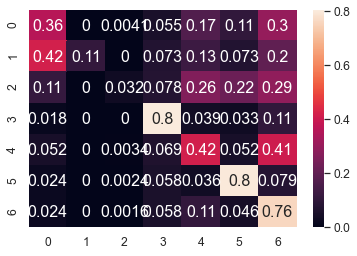

	training epoch=32 .. train_loss=1.017
	validation epoch=32 .. val_loss=1.312
	Accuracy = 54.800000000000004 % .. Percision = 63.800000000000004 % .. Recall = 46.9 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_32.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 33 .. loss = 1.01


  0%|                                                                                 | 1/1914 [00:01<34:07,  1.07s/it]

training @ epoch 33 .. loss = 0.613


  0%|                                                                                 | 2/1914 [00:02<34:24,  1.08s/it]

training @ epoch 33 .. loss = 1.385


  0%|▏                                                                                | 3/1914 [00:03<35:32,  1.12s/it]

training @ epoch 33 .. loss = 0.64


  0%|▏                                                                                | 4/1914 [00:04<35:05,  1.10s/it]

training @ epoch 33 .. loss = 1.137


  0%|▏                                                                                | 5/1914 [00:05<34:56,  1.10s/it]

training @ epoch 33 .. loss = 0.598


  0%|▎                                                                                | 6/1914 [00:06<34:25,  1.08s/it]

training @ epoch 33 .. loss = 0.866


  0%|▎                                                                                | 7/1914 [00:07<34:16,  1.08s/it]

training @ epoch 33 .. loss = 0.865


  0%|▎                                                                                | 8/1914 [00:08<34:11,  1.08s/it]

training @ epoch 33 .. loss = 0.933


  0%|▍                                                                                | 9/1914 [00:09<34:13,  1.08s/it]

training @ epoch 33 .. loss = 0.921


  1%|▍                                                                               | 10/1914 [00:10<34:02,  1.07s/it]

training @ epoch 33 .. loss = 0.795


  1%|▍                                                                               | 11/1914 [00:11<34:05,  1.08s/it]

training @ epoch 33 .. loss = 0.798


  1%|▌                                                                               | 12/1914 [00:13<34:00,  1.07s/it]

training @ epoch 33 .. loss = 1.148


  1%|▌                                                                               | 13/1914 [00:14<33:49,  1.07s/it]

training @ epoch 33 .. loss = 1.141


  1%|▌                                                                               | 14/1914 [00:15<33:28,  1.06s/it]

training @ epoch 33 .. loss = 1.228


  1%|▋                                                                               | 15/1914 [00:16<33:35,  1.06s/it]

training @ epoch 33 .. loss = 0.866


  1%|▋                                                                               | 16/1914 [00:17<33:48,  1.07s/it]

training @ epoch 33 .. loss = 0.588


  1%|▋                                                                               | 17/1914 [00:18<33:47,  1.07s/it]

training @ epoch 33 .. loss = 1.046


  1%|▊                                                                               | 18/1914 [00:19<33:22,  1.06s/it]

training @ epoch 33 .. loss = 1.165


  1%|▊                                                                               | 19/1914 [00:20<33:23,  1.06s/it]

training @ epoch 33 .. loss = 1.019


  1%|▊                                                                               | 20/1914 [00:21<33:07,  1.05s/it]

training @ epoch 33 .. loss = 0.827


  1%|▉                                                                               | 21/1914 [00:22<32:55,  1.04s/it]

training @ epoch 33 .. loss = 1.075


  1%|▉                                                                               | 22/1914 [00:23<33:14,  1.05s/it]

training @ epoch 33 .. loss = 1.26


  1%|▉                                                                               | 23/1914 [00:24<33:44,  1.07s/it]

training @ epoch 33 .. loss = 1.039


  1%|█                                                                               | 24/1914 [00:25<33:41,  1.07s/it]

training @ epoch 33 .. loss = 0.828


  1%|█                                                                               | 25/1914 [00:26<33:19,  1.06s/it]

training @ epoch 33 .. loss = 1.181


  1%|█                                                                               | 26/1914 [00:27<33:28,  1.06s/it]

training @ epoch 33 .. loss = 1.093


  1%|█▏                                                                              | 27/1914 [00:28<33:37,  1.07s/it]

training @ epoch 33 .. loss = 1.242


  1%|█▏                                                                              | 28/1914 [00:30<33:46,  1.07s/it]

training @ epoch 33 .. loss = 1.55


  2%|█▏                                                                              | 29/1914 [00:31<34:01,  1.08s/it]

training @ epoch 33 .. loss = 1.617


  2%|█▎                                                                              | 30/1914 [00:32<34:17,  1.09s/it]

training @ epoch 33 .. loss = 1.07


  2%|█▎                                                                              | 31/1914 [00:33<34:03,  1.09s/it]

training @ epoch 33 .. loss = 1.134


  2%|█▎                                                                              | 32/1914 [00:34<34:18,  1.09s/it]

training @ epoch 33 .. loss = 0.644


  2%|█▍                                                                              | 33/1914 [00:35<33:53,  1.08s/it]

training @ epoch 33 .. loss = 0.993


  2%|█▍                                                                              | 34/1914 [00:36<33:55,  1.08s/it]

training @ epoch 33 .. loss = 1.227


  2%|█▍                                                                              | 35/1914 [00:37<34:05,  1.09s/it]

training @ epoch 33 .. loss = 0.82


  2%|█▌                                                                              | 36/1914 [00:38<33:33,  1.07s/it]

training @ epoch 33 .. loss = 0.984


  2%|█▌                                                                              | 37/1914 [00:39<32:52,  1.05s/it]

training @ epoch 33 .. loss = 0.88


  2%|█▌                                                                              | 38/1914 [00:40<33:00,  1.06s/it]

training @ epoch 33 .. loss = 0.558


  2%|█▋                                                                              | 39/1914 [00:41<32:57,  1.05s/it]

training @ epoch 33 .. loss = 0.77


  2%|█▋                                                                              | 40/1914 [00:42<33:28,  1.07s/it]

training @ epoch 33 .. loss = 0.811


  2%|█▋                                                                              | 41/1914 [00:43<33:14,  1.06s/it]

training @ epoch 33 .. loss = 1.368


  2%|█▊                                                                              | 42/1914 [00:45<33:24,  1.07s/it]

training @ epoch 33 .. loss = 1.184


  2%|█▊                                                                              | 43/1914 [00:46<33:12,  1.07s/it]

training @ epoch 33 .. loss = 0.85


  2%|█▊                                                                              | 44/1914 [00:47<33:20,  1.07s/it]

training @ epoch 33 .. loss = 0.979


  2%|█▉                                                                              | 45/1914 [00:48<33:07,  1.06s/it]

training @ epoch 33 .. loss = 0.953


  2%|█▉                                                                              | 46/1914 [00:49<33:06,  1.06s/it]

training @ epoch 33 .. loss = 1.012


  2%|█▉                                                                              | 47/1914 [00:50<33:19,  1.07s/it]

training @ epoch 33 .. loss = 0.852


  3%|██                                                                              | 48/1914 [00:51<33:28,  1.08s/it]

training @ epoch 33 .. loss = 1.36


  3%|██                                                                              | 49/1914 [00:52<33:24,  1.07s/it]

training @ epoch 33 .. loss = 1.05


  3%|██                                                                              | 50/1914 [00:53<33:23,  1.07s/it]

training @ epoch 33 .. loss = 1.438


  3%|██▏                                                                             | 51/1914 [00:54<33:02,  1.06s/it]

training @ epoch 33 .. loss = 0.897


  3%|██▏                                                                             | 52/1914 [00:55<33:10,  1.07s/it]

training @ epoch 33 .. loss = 0.735


  3%|██▏                                                                             | 53/1914 [00:56<33:17,  1.07s/it]

training @ epoch 33 .. loss = 1.818


  3%|██▎                                                                             | 54/1914 [00:57<33:09,  1.07s/it]

training @ epoch 33 .. loss = 1.132


  3%|██▎                                                                             | 55/1914 [00:59<34:16,  1.11s/it]

training @ epoch 33 .. loss = 1.07


  3%|██▎                                                                             | 56/1914 [01:00<34:16,  1.11s/it]

training @ epoch 33 .. loss = 1.53


  3%|██▍                                                                             | 57/1914 [01:01<33:48,  1.09s/it]

training @ epoch 33 .. loss = 0.433


  3%|██▍                                                                             | 58/1914 [01:02<33:52,  1.09s/it]

training @ epoch 33 .. loss = 0.625


  3%|██▍                                                                             | 59/1914 [01:03<34:04,  1.10s/it]

training @ epoch 33 .. loss = 0.617


  3%|██▌                                                                             | 60/1914 [01:04<34:49,  1.13s/it]

training @ epoch 33 .. loss = 1.147


  3%|██▌                                                                             | 61/1914 [01:05<34:55,  1.13s/it]

training @ epoch 33 .. loss = 0.853


  3%|██▌                                                                             | 62/1914 [01:06<33:37,  1.09s/it]

training @ epoch 33 .. loss = 0.818


  3%|██▋                                                                             | 63/1914 [01:07<33:34,  1.09s/it]

training @ epoch 33 .. loss = 0.961


  3%|██▋                                                                             | 64/1914 [01:08<33:41,  1.09s/it]

training @ epoch 33 .. loss = 0.549


  3%|██▋                                                                             | 65/1914 [01:10<34:17,  1.11s/it]

training @ epoch 33 .. loss = 1.069


  3%|██▊                                                                             | 66/1914 [01:11<33:53,  1.10s/it]

training @ epoch 33 .. loss = 0.849


  4%|██▊                                                                             | 67/1914 [01:12<33:10,  1.08s/it]

training @ epoch 33 .. loss = 0.993


  4%|██▊                                                                             | 68/1914 [01:13<32:53,  1.07s/it]

training @ epoch 33 .. loss = 1.064


  4%|██▉                                                                             | 69/1914 [01:14<33:08,  1.08s/it]

training @ epoch 33 .. loss = 1.119


  4%|██▉                                                                             | 70/1914 [01:15<34:05,  1.11s/it]

training @ epoch 33 .. loss = 0.549


  4%|██▉                                                                             | 71/1914 [01:16<33:26,  1.09s/it]

training @ epoch 33 .. loss = 0.652


  4%|███                                                                             | 72/1914 [01:17<33:08,  1.08s/it]

training @ epoch 33 .. loss = 0.711


  4%|███                                                                             | 73/1914 [01:18<32:57,  1.07s/it]

training @ epoch 33 .. loss = 0.876


  4%|███                                                                             | 74/1914 [01:19<32:46,  1.07s/it]

training @ epoch 33 .. loss = 0.822


  4%|███▏                                                                            | 75/1914 [01:20<32:45,  1.07s/it]

training @ epoch 33 .. loss = 1.219


  4%|███▏                                                                            | 76/1914 [01:21<33:07,  1.08s/it]

training @ epoch 33 .. loss = 0.563


  4%|███▏                                                                            | 77/1914 [01:22<32:41,  1.07s/it]

training @ epoch 33 .. loss = 0.983


  4%|███▎                                                                            | 78/1914 [01:24<32:49,  1.07s/it]

training @ epoch 33 .. loss = 0.959


  4%|███▎                                                                            | 79/1914 [01:25<32:44,  1.07s/it]

training @ epoch 33 .. loss = 0.669


  4%|███▎                                                                            | 80/1914 [01:26<32:36,  1.07s/it]

training @ epoch 33 .. loss = 0.76


  4%|███▍                                                                            | 81/1914 [01:27<32:43,  1.07s/it]

training @ epoch 33 .. loss = 1.493


  4%|███▍                                                                            | 82/1914 [01:28<32:31,  1.07s/it]

training @ epoch 33 .. loss = 0.862


  4%|███▍                                                                            | 83/1914 [01:29<32:49,  1.08s/it]

training @ epoch 33 .. loss = 0.796


  4%|███▌                                                                            | 84/1914 [01:30<32:58,  1.08s/it]

training @ epoch 33 .. loss = 0.977


  4%|███▌                                                                            | 85/1914 [01:31<32:42,  1.07s/it]

training @ epoch 33 .. loss = 0.598


  4%|███▌                                                                            | 86/1914 [01:32<32:37,  1.07s/it]

training @ epoch 33 .. loss = 1.054


  5%|███▋                                                                            | 87/1914 [01:33<32:10,  1.06s/it]

training @ epoch 33 .. loss = 1.096


  5%|███▋                                                                            | 88/1914 [01:34<33:05,  1.09s/it]

training @ epoch 33 .. loss = 1.428


  5%|███▋                                                                            | 89/1914 [01:35<33:07,  1.09s/it]

training @ epoch 33 .. loss = 0.742


  5%|███▊                                                                            | 90/1914 [01:36<32:42,  1.08s/it]

training @ epoch 33 .. loss = 1.136


  5%|███▊                                                                            | 91/1914 [01:38<32:55,  1.08s/it]

training @ epoch 33 .. loss = 0.659


  5%|███▊                                                                            | 92/1914 [01:39<33:57,  1.12s/it]

training @ epoch 33 .. loss = 1.168


  5%|███▉                                                                            | 93/1914 [01:40<33:08,  1.09s/it]

training @ epoch 33 .. loss = 0.737


  5%|███▉                                                                            | 94/1914 [01:41<33:06,  1.09s/it]

training @ epoch 33 .. loss = 0.764


  5%|███▉                                                                            | 95/1914 [01:42<32:30,  1.07s/it]

training @ epoch 33 .. loss = 0.954


  5%|████                                                                            | 96/1914 [01:43<32:49,  1.08s/it]

training @ epoch 33 .. loss = 0.894


  5%|████                                                                            | 97/1914 [01:44<33:25,  1.10s/it]

training @ epoch 33 .. loss = 1.256


  5%|████                                                                            | 98/1914 [01:45<32:37,  1.08s/it]

training @ epoch 33 .. loss = 1.025


  5%|████▏                                                                           | 99/1914 [01:46<32:16,  1.07s/it]

training @ epoch 33 .. loss = 0.708


  5%|████▏                                                                          | 100/1914 [01:47<32:24,  1.07s/it]

training @ epoch 33 .. loss = 0.879


  5%|████▏                                                                          | 101/1914 [01:48<33:05,  1.10s/it]

training @ epoch 33 .. loss = 0.866


  5%|████▏                                                                          | 102/1914 [01:50<33:23,  1.11s/it]

training @ epoch 33 .. loss = 0.751


  5%|████▎                                                                          | 103/1914 [01:51<33:04,  1.10s/it]

training @ epoch 33 .. loss = 0.871


  5%|████▎                                                                          | 104/1914 [01:52<32:29,  1.08s/it]

training @ epoch 33 .. loss = 1.042


  5%|████▎                                                                          | 105/1914 [01:53<31:59,  1.06s/it]

training @ epoch 33 .. loss = 0.974


  6%|████▍                                                                          | 106/1914 [01:54<31:55,  1.06s/it]

training @ epoch 33 .. loss = 0.734


  6%|████▍                                                                          | 107/1914 [01:55<31:52,  1.06s/it]

training @ epoch 33 .. loss = 0.867


  6%|████▍                                                                          | 108/1914 [01:56<31:27,  1.05s/it]

training @ epoch 33 .. loss = 0.457


  6%|████▍                                                                          | 109/1914 [01:57<32:15,  1.07s/it]

training @ epoch 33 .. loss = 0.781


  6%|████▌                                                                          | 110/1914 [01:58<31:58,  1.06s/it]

training @ epoch 33 .. loss = 0.896


  6%|████▌                                                                          | 111/1914 [01:59<32:09,  1.07s/it]

training @ epoch 33 .. loss = 0.638


  6%|████▌                                                                          | 112/1914 [02:00<32:08,  1.07s/it]

training @ epoch 33 .. loss = 0.686


  6%|████▋                                                                          | 113/1914 [02:01<32:07,  1.07s/it]

training @ epoch 33 .. loss = 1.044


  6%|████▋                                                                          | 114/1914 [02:02<31:55,  1.06s/it]

training @ epoch 33 .. loss = 1.142


  6%|████▋                                                                          | 115/1914 [02:03<31:41,  1.06s/it]

training @ epoch 33 .. loss = 1.042


  6%|████▊                                                                          | 116/1914 [02:04<32:15,  1.08s/it]

training @ epoch 33 .. loss = 1.072


  6%|████▊                                                                          | 117/1914 [02:06<33:01,  1.10s/it]

training @ epoch 33 .. loss = 1.368


  6%|████▊                                                                          | 118/1914 [02:07<32:23,  1.08s/it]

training @ epoch 33 .. loss = 1.485


  6%|████▉                                                                          | 119/1914 [02:08<31:59,  1.07s/it]

training @ epoch 33 .. loss = 1.267


  6%|████▉                                                                          | 120/1914 [02:09<31:56,  1.07s/it]

training @ epoch 33 .. loss = 0.886


  6%|████▉                                                                          | 121/1914 [02:10<32:25,  1.09s/it]

training @ epoch 33 .. loss = 0.918


  6%|█████                                                                          | 122/1914 [02:11<32:50,  1.10s/it]

training @ epoch 33 .. loss = 0.985


  6%|█████                                                                          | 123/1914 [02:12<32:22,  1.08s/it]

training @ epoch 33 .. loss = 1.251


  6%|█████                                                                          | 124/1914 [02:13<31:57,  1.07s/it]

training @ epoch 33 .. loss = 1.459


  7%|█████▏                                                                         | 125/1914 [02:14<31:45,  1.07s/it]

training @ epoch 33 .. loss = 0.998


  7%|█████▏                                                                         | 126/1914 [02:15<32:05,  1.08s/it]

training @ epoch 33 .. loss = 1.04


  7%|█████▏                                                                         | 127/1914 [02:16<32:17,  1.08s/it]

training @ epoch 33 .. loss = 1.316


  7%|█████▎                                                                         | 128/1914 [02:17<32:13,  1.08s/it]

training @ epoch 33 .. loss = 0.739


  7%|█████▎                                                                         | 129/1914 [02:18<31:44,  1.07s/it]

training @ epoch 33 .. loss = 1.155


  7%|█████▎                                                                         | 130/1914 [02:19<31:20,  1.05s/it]

training @ epoch 33 .. loss = 1.167


  7%|█████▍                                                                         | 131/1914 [02:21<31:08,  1.05s/it]

training @ epoch 33 .. loss = 0.96


  7%|█████▍                                                                         | 132/1914 [02:22<31:08,  1.05s/it]

training @ epoch 33 .. loss = 0.8


  7%|█████▍                                                                         | 133/1914 [02:23<31:02,  1.05s/it]

training @ epoch 33 .. loss = 0.714


  7%|█████▌                                                                         | 134/1914 [02:24<31:03,  1.05s/it]

training @ epoch 33 .. loss = 0.803


  7%|█████▌                                                                         | 135/1914 [02:25<31:22,  1.06s/it]

training @ epoch 33 .. loss = 0.744


  7%|█████▌                                                                         | 136/1914 [02:26<31:14,  1.05s/it]

training @ epoch 33 .. loss = 0.503


  7%|█████▋                                                                         | 137/1914 [02:27<31:14,  1.05s/it]

training @ epoch 33 .. loss = 1.388


  7%|█████▋                                                                         | 138/1914 [02:28<31:22,  1.06s/it]

training @ epoch 33 .. loss = 1.221


  7%|█████▋                                                                         | 139/1914 [02:29<31:44,  1.07s/it]

training @ epoch 33 .. loss = 1.23


  7%|█████▊                                                                         | 140/1914 [02:30<31:31,  1.07s/it]

training @ epoch 33 .. loss = 0.917


  7%|█████▊                                                                         | 141/1914 [02:31<31:37,  1.07s/it]

training @ epoch 33 .. loss = 0.965


  7%|█████▊                                                                         | 142/1914 [02:32<31:41,  1.07s/it]

training @ epoch 33 .. loss = 0.775


  7%|█████▉                                                                         | 143/1914 [02:33<31:37,  1.07s/it]

training @ epoch 33 .. loss = 0.443


  8%|█████▉                                                                         | 144/1914 [02:34<31:48,  1.08s/it]

training @ epoch 33 .. loss = 0.912


  8%|█████▉                                                                         | 145/1914 [02:36<32:13,  1.09s/it]

training @ epoch 33 .. loss = 1.15


  8%|██████                                                                         | 146/1914 [02:37<31:49,  1.08s/it]

training @ epoch 33 .. loss = 1.362


  8%|██████                                                                         | 147/1914 [02:38<31:43,  1.08s/it]

training @ epoch 33 .. loss = 0.962


  8%|██████                                                                         | 148/1914 [02:39<31:19,  1.06s/it]

training @ epoch 33 .. loss = 1.165


  8%|██████▏                                                                        | 149/1914 [02:40<31:33,  1.07s/it]

training @ epoch 33 .. loss = 1.093


  8%|██████▏                                                                        | 150/1914 [02:41<31:30,  1.07s/it]

training @ epoch 33 .. loss = 1.204


  8%|██████▏                                                                        | 151/1914 [02:42<31:29,  1.07s/it]

training @ epoch 33 .. loss = 0.877


  8%|██████▎                                                                        | 152/1914 [02:43<31:46,  1.08s/it]

training @ epoch 33 .. loss = 0.792


  8%|██████▎                                                                        | 153/1914 [02:44<31:38,  1.08s/it]

training @ epoch 33 .. loss = 1.092


  8%|██████▎                                                                        | 154/1914 [02:45<31:32,  1.08s/it]

training @ epoch 33 .. loss = 0.689


  8%|██████▍                                                                        | 155/1914 [02:46<31:08,  1.06s/it]

training @ epoch 33 .. loss = 0.749


  8%|██████▍                                                                        | 156/1914 [02:47<31:00,  1.06s/it]

training @ epoch 33 .. loss = 1.477


  8%|██████▍                                                                        | 157/1914 [02:48<31:22,  1.07s/it]

training @ epoch 33 .. loss = 0.992


  8%|██████▌                                                                        | 158/1914 [02:49<31:38,  1.08s/it]

training @ epoch 33 .. loss = 0.937


  8%|██████▌                                                                        | 159/1914 [02:51<31:37,  1.08s/it]

training @ epoch 33 .. loss = 1.227


  8%|██████▌                                                                        | 160/1914 [02:52<30:49,  1.05s/it]

training @ epoch 33 .. loss = 0.842


  8%|██████▋                                                                        | 161/1914 [02:53<30:41,  1.05s/it]

training @ epoch 33 .. loss = 1.19


  8%|██████▋                                                                        | 162/1914 [02:54<31:02,  1.06s/it]

training @ epoch 33 .. loss = 1.089


  9%|██████▋                                                                        | 163/1914 [02:55<31:00,  1.06s/it]

training @ epoch 33 .. loss = 1.022


  9%|██████▊                                                                        | 164/1914 [02:56<31:00,  1.06s/it]

training @ epoch 33 .. loss = 1.062


  9%|██████▊                                                                        | 165/1914 [02:57<30:53,  1.06s/it]

training @ epoch 33 .. loss = 0.927


  9%|██████▊                                                                        | 166/1914 [02:58<31:03,  1.07s/it]

training @ epoch 33 .. loss = 1.083


  9%|██████▉                                                                        | 167/1914 [02:59<31:10,  1.07s/it]

training @ epoch 33 .. loss = 0.546


  9%|██████▉                                                                        | 168/1914 [03:00<31:05,  1.07s/it]

training @ epoch 33 .. loss = 0.974


  9%|██████▉                                                                        | 169/1914 [03:01<30:58,  1.07s/it]

training @ epoch 33 .. loss = 0.851


  9%|███████                                                                        | 170/1914 [03:02<31:30,  1.08s/it]

training @ epoch 33 .. loss = 1.227


  9%|███████                                                                        | 171/1914 [03:04<33:33,  1.16s/it]

training @ epoch 33 .. loss = 1.101


  9%|███████                                                                        | 172/1914 [03:05<32:48,  1.13s/it]

training @ epoch 33 .. loss = 1.062


  9%|███████▏                                                                       | 173/1914 [03:06<32:48,  1.13s/it]

training @ epoch 33 .. loss = 1.493


  9%|███████▏                                                                       | 174/1914 [03:07<32:35,  1.12s/it]

training @ epoch 33 .. loss = 0.847


  9%|███████▏                                                                       | 175/1914 [03:08<32:00,  1.10s/it]

training @ epoch 33 .. loss = 0.812


  9%|███████▎                                                                       | 176/1914 [03:09<31:58,  1.10s/it]

training @ epoch 33 .. loss = 1.085


  9%|███████▎                                                                       | 177/1914 [03:10<31:32,  1.09s/it]

training @ epoch 33 .. loss = 1.064


  9%|███████▎                                                                       | 178/1914 [03:11<32:22,  1.12s/it]

training @ epoch 33 .. loss = 0.834


  9%|███████▍                                                                       | 179/1914 [03:12<32:36,  1.13s/it]

training @ epoch 33 .. loss = 1.493


  9%|███████▍                                                                       | 180/1914 [03:13<32:01,  1.11s/it]

training @ epoch 33 .. loss = 1.154


  9%|███████▍                                                                       | 181/1914 [03:15<31:52,  1.10s/it]

training @ epoch 33 .. loss = 1.236


 10%|███████▌                                                                       | 182/1914 [03:16<32:05,  1.11s/it]

training @ epoch 33 .. loss = 0.988


 10%|███████▌                                                                       | 183/1914 [03:17<33:06,  1.15s/it]

training @ epoch 33 .. loss = 1.328


 10%|███████▌                                                                       | 184/1914 [03:18<32:23,  1.12s/it]

training @ epoch 33 .. loss = 1.119


 10%|███████▋                                                                       | 185/1914 [03:19<31:57,  1.11s/it]

training @ epoch 33 .. loss = 0.763


 10%|███████▋                                                                       | 186/1914 [03:20<32:29,  1.13s/it]

training @ epoch 33 .. loss = 0.845


 10%|███████▋                                                                       | 187/1914 [03:21<32:09,  1.12s/it]

training @ epoch 33 .. loss = 0.768


 10%|███████▊                                                                       | 188/1914 [03:22<31:49,  1.11s/it]

training @ epoch 33 .. loss = 0.712


 10%|███████▊                                                                       | 189/1914 [03:24<32:01,  1.11s/it]

training @ epoch 33 .. loss = 0.447


 10%|███████▊                                                                       | 190/1914 [03:25<32:24,  1.13s/it]

training @ epoch 33 .. loss = 1.153


 10%|███████▉                                                                       | 191/1914 [03:26<32:39,  1.14s/it]

training @ epoch 33 .. loss = 1.296


 10%|███████▉                                                                       | 192/1914 [03:27<32:08,  1.12s/it]

training @ epoch 33 .. loss = 0.761


 10%|███████▉                                                                       | 193/1914 [03:28<31:09,  1.09s/it]

training @ epoch 33 .. loss = 1.041


 10%|████████                                                                       | 194/1914 [03:29<31:03,  1.08s/it]

training @ epoch 33 .. loss = 0.766


 10%|████████                                                                       | 195/1914 [03:30<30:43,  1.07s/it]

training @ epoch 33 .. loss = 0.821


 10%|████████                                                                       | 196/1914 [03:31<30:27,  1.06s/it]

training @ epoch 33 .. loss = 1.536


 10%|████████▏                                                                      | 197/1914 [03:32<30:26,  1.06s/it]

training @ epoch 33 .. loss = 1.203


 10%|████████▏                                                                      | 198/1914 [03:33<30:59,  1.08s/it]

training @ epoch 33 .. loss = 0.74


 10%|████████▏                                                                      | 199/1914 [03:34<31:07,  1.09s/it]

training @ epoch 33 .. loss = 0.993


 10%|████████▎                                                                      | 200/1914 [03:36<31:00,  1.09s/it]

training @ epoch 33 .. loss = 1.253


 11%|████████▎                                                                      | 201/1914 [03:37<31:04,  1.09s/it]

training @ epoch 33 .. loss = 1.054


 11%|████████▎                                                                      | 202/1914 [03:38<31:19,  1.10s/it]

training @ epoch 33 .. loss = 1.319


 11%|████████▍                                                                      | 203/1914 [03:39<31:08,  1.09s/it]

training @ epoch 33 .. loss = 0.603


 11%|████████▍                                                                      | 204/1914 [03:40<30:39,  1.08s/it]

training @ epoch 33 .. loss = 0.709


 11%|████████▍                                                                      | 205/1914 [03:41<30:27,  1.07s/it]

training @ epoch 33 .. loss = 1.269


 11%|████████▌                                                                      | 206/1914 [03:42<30:25,  1.07s/it]

training @ epoch 33 .. loss = 0.89


 11%|████████▌                                                                      | 207/1914 [03:43<30:07,  1.06s/it]

training @ epoch 33 .. loss = 1.095


 11%|████████▌                                                                      | 208/1914 [03:44<30:23,  1.07s/it]

training @ epoch 33 .. loss = 0.533


 11%|████████▋                                                                      | 209/1914 [03:45<30:04,  1.06s/it]

training @ epoch 33 .. loss = 1.58


 11%|████████▋                                                                      | 210/1914 [03:46<29:58,  1.06s/it]

training @ epoch 33 .. loss = 0.751


 11%|████████▋                                                                      | 211/1914 [03:47<29:57,  1.06s/it]

training @ epoch 33 .. loss = 1.684


 11%|████████▊                                                                      | 212/1914 [03:48<29:59,  1.06s/it]

training @ epoch 33 .. loss = 0.827


 11%|████████▊                                                                      | 213/1914 [03:49<30:08,  1.06s/it]

training @ epoch 33 .. loss = 1.276


 11%|████████▊                                                                      | 214/1914 [03:50<30:19,  1.07s/it]

training @ epoch 33 .. loss = 1.163


 11%|████████▊                                                                      | 215/1914 [03:52<30:05,  1.06s/it]

training @ epoch 33 .. loss = 1.148


 11%|████████▉                                                                      | 216/1914 [03:53<31:10,  1.10s/it]

training @ epoch 33 .. loss = 1.166


 11%|████████▉                                                                      | 217/1914 [03:54<32:26,  1.15s/it]

training @ epoch 33 .. loss = 1.139


 11%|████████▉                                                                      | 218/1914 [03:55<32:08,  1.14s/it]

training @ epoch 33 .. loss = 1.139


 11%|█████████                                                                      | 219/1914 [03:56<31:18,  1.11s/it]

training @ epoch 33 .. loss = 0.777


 11%|█████████                                                                      | 220/1914 [03:57<30:55,  1.10s/it]

training @ epoch 33 .. loss = 1.144


 12%|█████████                                                                      | 221/1914 [03:58<31:32,  1.12s/it]

training @ epoch 33 .. loss = 1.024


 12%|█████████▏                                                                     | 222/1914 [03:59<31:27,  1.12s/it]

training @ epoch 33 .. loss = 0.886


 12%|█████████▏                                                                     | 223/1914 [04:01<34:11,  1.21s/it]

training @ epoch 33 .. loss = 0.773


 12%|█████████▏                                                                     | 224/1914 [04:02<32:51,  1.17s/it]

training @ epoch 33 .. loss = 0.912


 12%|█████████▎                                                                     | 225/1914 [04:03<33:45,  1.20s/it]

training @ epoch 33 .. loss = 0.868


 12%|█████████▎                                                                     | 226/1914 [04:04<34:13,  1.22s/it]

training @ epoch 33 .. loss = 1.104


 12%|█████████▎                                                                     | 227/1914 [04:06<34:25,  1.22s/it]

training @ epoch 33 .. loss = 1.028


 12%|█████████▍                                                                     | 228/1914 [04:07<34:39,  1.23s/it]

training @ epoch 33 .. loss = 1.039


 12%|█████████▍                                                                     | 229/1914 [04:08<34:08,  1.22s/it]

training @ epoch 33 .. loss = 0.956


 12%|█████████▍                                                                     | 230/1914 [04:09<33:00,  1.18s/it]

training @ epoch 33 .. loss = 1.298


 12%|█████████▌                                                                     | 231/1914 [04:10<32:14,  1.15s/it]

training @ epoch 33 .. loss = 0.833


 12%|█████████▌                                                                     | 232/1914 [04:11<31:17,  1.12s/it]

training @ epoch 33 .. loss = 0.735


 12%|█████████▌                                                                     | 233/1914 [04:12<30:35,  1.09s/it]

training @ epoch 33 .. loss = 1.378


 12%|█████████▋                                                                     | 234/1914 [04:13<30:31,  1.09s/it]

training @ epoch 33 .. loss = 0.586


 12%|█████████▋                                                                     | 235/1914 [04:15<30:10,  1.08s/it]

training @ epoch 33 .. loss = 0.793


 12%|█████████▋                                                                     | 236/1914 [04:16<30:02,  1.07s/it]

training @ epoch 33 .. loss = 1.205


 12%|█████████▊                                                                     | 237/1914 [04:17<30:42,  1.10s/it]

training @ epoch 33 .. loss = 0.779


 12%|█████████▊                                                                     | 238/1914 [04:18<31:54,  1.14s/it]

training @ epoch 33 .. loss = 0.646


 12%|█████████▊                                                                     | 239/1914 [04:19<30:57,  1.11s/it]

training @ epoch 33 .. loss = 1.278


 13%|█████████▉                                                                     | 240/1914 [04:20<30:28,  1.09s/it]

training @ epoch 33 .. loss = 0.699


 13%|█████████▉                                                                     | 241/1914 [04:21<29:59,  1.08s/it]

training @ epoch 33 .. loss = 1.329


 13%|█████████▉                                                                     | 242/1914 [04:22<29:48,  1.07s/it]

training @ epoch 33 .. loss = 0.887


 13%|██████████                                                                     | 243/1914 [04:23<30:43,  1.10s/it]

training @ epoch 33 .. loss = 1.317


 13%|██████████                                                                     | 244/1914 [04:24<30:16,  1.09s/it]

training @ epoch 33 .. loss = 0.698


 13%|██████████                                                                     | 245/1914 [04:25<29:48,  1.07s/it]

training @ epoch 33 .. loss = 1.292


 13%|██████████▏                                                                    | 246/1914 [04:26<29:36,  1.06s/it]

training @ epoch 33 .. loss = 0.949


 13%|██████████▏                                                                    | 247/1914 [04:28<30:10,  1.09s/it]

training @ epoch 33 .. loss = 1.309


 13%|██████████▏                                                                    | 248/1914 [04:29<30:58,  1.12s/it]

training @ epoch 33 .. loss = 0.883


 13%|██████████▎                                                                    | 249/1914 [04:30<30:34,  1.10s/it]

training @ epoch 33 .. loss = 1.023


 13%|██████████▎                                                                    | 250/1914 [04:31<30:06,  1.09s/it]

training @ epoch 33 .. loss = 1.055


 13%|██████████▎                                                                    | 251/1914 [04:32<29:34,  1.07s/it]

training @ epoch 33 .. loss = 0.798


 13%|██████████▍                                                                    | 252/1914 [04:33<29:51,  1.08s/it]

training @ epoch 33 .. loss = 1.261


 13%|██████████▍                                                                    | 253/1914 [04:34<30:25,  1.10s/it]

training @ epoch 33 .. loss = 1.07


 13%|██████████▍                                                                    | 254/1914 [04:35<29:51,  1.08s/it]

training @ epoch 33 .. loss = 0.772


 13%|██████████▌                                                                    | 255/1914 [04:36<29:49,  1.08s/it]

training @ epoch 33 .. loss = 0.639


 13%|██████████▌                                                                    | 256/1914 [04:37<29:53,  1.08s/it]

training @ epoch 33 .. loss = 0.973


 13%|██████████▌                                                                    | 257/1914 [04:39<30:52,  1.12s/it]

training @ epoch 33 .. loss = 0.827


 13%|██████████▋                                                                    | 258/1914 [04:40<30:41,  1.11s/it]

training @ epoch 33 .. loss = 1.474


 14%|██████████▋                                                                    | 259/1914 [04:41<30:35,  1.11s/it]

training @ epoch 33 .. loss = 0.813


 14%|██████████▋                                                                    | 260/1914 [04:42<30:20,  1.10s/it]

training @ epoch 33 .. loss = 0.802


 14%|██████████▊                                                                    | 261/1914 [04:43<30:13,  1.10s/it]

training @ epoch 33 .. loss = 0.422


 14%|██████████▊                                                                    | 262/1914 [04:44<31:16,  1.14s/it]

training @ epoch 33 .. loss = 1.217


 14%|██████████▊                                                                    | 263/1914 [04:45<31:22,  1.14s/it]

training @ epoch 33 .. loss = 1.0


 14%|██████████▉                                                                    | 264/1914 [04:46<30:52,  1.12s/it]

training @ epoch 33 .. loss = 0.742


 14%|██████████▉                                                                    | 265/1914 [04:48<30:38,  1.12s/it]

training @ epoch 33 .. loss = 0.717


 14%|██████████▉                                                                    | 266/1914 [04:49<31:00,  1.13s/it]

training @ epoch 33 .. loss = 1.039


 14%|███████████                                                                    | 267/1914 [04:50<33:23,  1.22s/it]

training @ epoch 33 .. loss = 1.057


 14%|███████████                                                                    | 268/1914 [04:51<33:32,  1.22s/it]

training @ epoch 33 .. loss = 1.452


 14%|███████████                                                                    | 269/1914 [04:52<32:31,  1.19s/it]

training @ epoch 33 .. loss = 1.091


 14%|███████████▏                                                                   | 270/1914 [04:54<32:05,  1.17s/it]

training @ epoch 33 .. loss = 1.02


 14%|███████████▏                                                                   | 271/1914 [04:55<31:13,  1.14s/it]

training @ epoch 33 .. loss = 0.798


 14%|███████████▏                                                                   | 272/1914 [04:56<30:46,  1.12s/it]

training @ epoch 33 .. loss = 1.304


 14%|███████████▎                                                                   | 273/1914 [04:57<30:28,  1.11s/it]

training @ epoch 33 .. loss = 0.897


 14%|███████████▎                                                                   | 274/1914 [04:58<30:11,  1.10s/it]

training @ epoch 33 .. loss = 1.05


 14%|███████████▎                                                                   | 275/1914 [04:59<29:45,  1.09s/it]

training @ epoch 33 .. loss = 1.034


 14%|███████████▍                                                                   | 276/1914 [05:00<29:34,  1.08s/it]

training @ epoch 33 .. loss = 0.952


 14%|███████████▍                                                                   | 277/1914 [05:01<29:20,  1.08s/it]

training @ epoch 33 .. loss = 1.013


 15%|███████████▍                                                                   | 278/1914 [05:02<29:30,  1.08s/it]

training @ epoch 33 .. loss = 1.074


 15%|███████████▌                                                                   | 279/1914 [05:03<29:49,  1.09s/it]

training @ epoch 33 .. loss = 1.374


 15%|███████████▌                                                                   | 280/1914 [05:04<30:13,  1.11s/it]

training @ epoch 33 .. loss = 1.381


 15%|███████████▌                                                                   | 281/1914 [05:06<29:53,  1.10s/it]

training @ epoch 33 .. loss = 0.62


 15%|███████████▋                                                                   | 282/1914 [05:07<29:34,  1.09s/it]

training @ epoch 33 .. loss = 0.776


 15%|███████████▋                                                                   | 283/1914 [05:08<29:15,  1.08s/it]

training @ epoch 33 .. loss = 1.265


 15%|███████████▋                                                                   | 284/1914 [05:09<28:53,  1.06s/it]

training @ epoch 33 .. loss = 1.187


 15%|███████████▊                                                                   | 285/1914 [05:10<28:48,  1.06s/it]

training @ epoch 33 .. loss = 0.748


 15%|███████████▊                                                                   | 286/1914 [05:11<28:26,  1.05s/it]

training @ epoch 33 .. loss = 1.049


 15%|███████████▊                                                                   | 287/1914 [05:12<28:18,  1.04s/it]

training @ epoch 33 .. loss = 1.143


 15%|███████████▉                                                                   | 288/1914 [05:13<28:20,  1.05s/it]

training @ epoch 33 .. loss = 0.648


 15%|███████████▉                                                                   | 289/1914 [05:14<28:28,  1.05s/it]

training @ epoch 33 .. loss = 1.264


 15%|███████████▉                                                                   | 290/1914 [05:15<28:45,  1.06s/it]

training @ epoch 33 .. loss = 0.64


 15%|████████████                                                                   | 291/1914 [05:16<28:22,  1.05s/it]

training @ epoch 33 .. loss = 0.977


 15%|████████████                                                                   | 292/1914 [05:17<28:24,  1.05s/it]

training @ epoch 33 .. loss = 0.916


 15%|████████████                                                                   | 293/1914 [05:18<28:07,  1.04s/it]

training @ epoch 33 .. loss = 0.85


 15%|████████████▏                                                                  | 294/1914 [05:19<29:29,  1.09s/it]

training @ epoch 33 .. loss = 0.782


 15%|████████████▏                                                                  | 295/1914 [05:21<31:10,  1.16s/it]

training @ epoch 33 .. loss = 0.781


 15%|████████████▏                                                                  | 296/1914 [05:22<31:51,  1.18s/it]

training @ epoch 33 .. loss = 1.142


 16%|████████████▎                                                                  | 297/1914 [05:23<30:37,  1.14s/it]

training @ epoch 33 .. loss = 0.425


 16%|████████████▎                                                                  | 298/1914 [05:24<31:08,  1.16s/it]

training @ epoch 33 .. loss = 0.763


 16%|████████████▎                                                                  | 299/1914 [05:25<30:44,  1.14s/it]

training @ epoch 33 .. loss = 1.02


 16%|████████████▍                                                                  | 300/1914 [05:26<30:00,  1.12s/it]

training @ epoch 33 .. loss = 1.415


 16%|████████████▍                                                                  | 301/1914 [05:27<29:26,  1.10s/it]

training @ epoch 33 .. loss = 0.97


 16%|████████████▍                                                                  | 302/1914 [05:28<29:21,  1.09s/it]

training @ epoch 33 .. loss = 0.627


 16%|████████████▌                                                                  | 303/1914 [05:30<30:20,  1.13s/it]

training @ epoch 33 .. loss = 1.09


 16%|████████████▌                                                                  | 304/1914 [05:31<29:52,  1.11s/it]

training @ epoch 33 .. loss = 1.261


 16%|████████████▌                                                                  | 305/1914 [05:32<29:23,  1.10s/it]

training @ epoch 33 .. loss = 0.916


 16%|████████████▋                                                                  | 306/1914 [05:33<28:52,  1.08s/it]

training @ epoch 33 .. loss = 0.756


 16%|████████████▋                                                                  | 307/1914 [05:34<28:41,  1.07s/it]

training @ epoch 33 .. loss = 1.132


 16%|████████████▋                                                                  | 308/1914 [05:35<28:22,  1.06s/it]

training @ epoch 33 .. loss = 1.05


 16%|████████████▊                                                                  | 309/1914 [05:36<27:59,  1.05s/it]

training @ epoch 33 .. loss = 0.96


 16%|████████████▊                                                                  | 310/1914 [05:37<28:16,  1.06s/it]

training @ epoch 33 .. loss = 0.623


 16%|████████████▊                                                                  | 311/1914 [05:38<28:21,  1.06s/it]

training @ epoch 33 .. loss = 1.189


 16%|████████████▉                                                                  | 312/1914 [05:39<28:22,  1.06s/it]

training @ epoch 33 .. loss = 1.543


 16%|████████████▉                                                                  | 313/1914 [05:40<28:13,  1.06s/it]

training @ epoch 33 .. loss = 0.887


 16%|████████████▉                                                                  | 314/1914 [05:41<28:00,  1.05s/it]

training @ epoch 33 .. loss = 0.877


 16%|█████████████                                                                  | 315/1914 [05:42<27:59,  1.05s/it]

training @ epoch 33 .. loss = 1.188


 17%|█████████████                                                                  | 316/1914 [05:43<27:45,  1.04s/it]

training @ epoch 33 .. loss = 0.874


 17%|█████████████                                                                  | 317/1914 [05:44<27:50,  1.05s/it]

training @ epoch 33 .. loss = 0.732


 17%|█████████████▏                                                                 | 318/1914 [05:45<27:56,  1.05s/it]

training @ epoch 33 .. loss = 1.283


 17%|█████████████▏                                                                 | 319/1914 [05:46<27:47,  1.05s/it]

training @ epoch 33 .. loss = 1.35


 17%|█████████████▏                                                                 | 320/1914 [05:47<28:08,  1.06s/it]

training @ epoch 33 .. loss = 0.903


 17%|█████████████▏                                                                 | 321/1914 [05:49<28:14,  1.06s/it]

training @ epoch 33 .. loss = 1.006


 17%|█████████████▎                                                                 | 322/1914 [05:50<28:24,  1.07s/it]

training @ epoch 33 .. loss = 0.912


 17%|█████████████▎                                                                 | 323/1914 [05:51<28:13,  1.06s/it]

training @ epoch 33 .. loss = 0.891


 17%|█████████████▎                                                                 | 324/1914 [05:52<28:23,  1.07s/it]

training @ epoch 33 .. loss = 1.06


 17%|█████████████▍                                                                 | 325/1914 [05:53<28:28,  1.08s/it]

training @ epoch 33 .. loss = 1.269


 17%|█████████████▍                                                                 | 326/1914 [05:54<28:18,  1.07s/it]

training @ epoch 33 .. loss = 0.955


 17%|█████████████▍                                                                 | 327/1914 [05:55<28:10,  1.06s/it]

training @ epoch 33 .. loss = 0.987


 17%|█████████████▌                                                                 | 328/1914 [05:56<27:54,  1.06s/it]

training @ epoch 33 .. loss = 0.933


 17%|█████████████▌                                                                 | 329/1914 [05:57<27:59,  1.06s/it]

training @ epoch 33 .. loss = 1.387


 17%|█████████████▌                                                                 | 330/1914 [05:58<27:48,  1.05s/it]

training @ epoch 33 .. loss = 0.776


 17%|█████████████▋                                                                 | 331/1914 [05:59<27:45,  1.05s/it]

training @ epoch 33 .. loss = 1.074


 17%|█████████████▋                                                                 | 332/1914 [06:00<27:28,  1.04s/it]

training @ epoch 33 .. loss = 1.236


 17%|█████████████▋                                                                 | 333/1914 [06:01<27:34,  1.05s/it]

training @ epoch 33 .. loss = 1.285


 17%|█████████████▊                                                                 | 334/1914 [06:02<28:02,  1.07s/it]

training @ epoch 33 .. loss = 1.081


 18%|█████████████▊                                                                 | 335/1914 [06:03<27:58,  1.06s/it]

training @ epoch 33 .. loss = 0.656


 18%|█████████████▊                                                                 | 336/1914 [06:04<28:00,  1.07s/it]

training @ epoch 33 .. loss = 0.946


 18%|█████████████▉                                                                 | 337/1914 [06:06<27:48,  1.06s/it]

training @ epoch 33 .. loss = 0.703


 18%|█████████████▉                                                                 | 338/1914 [06:07<27:55,  1.06s/it]

training @ epoch 33 .. loss = 1.487


 18%|█████████████▉                                                                 | 339/1914 [06:08<28:08,  1.07s/it]

training @ epoch 33 .. loss = 1.113


 18%|██████████████                                                                 | 340/1914 [06:09<27:47,  1.06s/it]

training @ epoch 33 .. loss = 1.455


 18%|██████████████                                                                 | 341/1914 [06:10<27:55,  1.07s/it]

training @ epoch 33 .. loss = 1.128


 18%|██████████████                                                                 | 342/1914 [06:11<27:43,  1.06s/it]

training @ epoch 33 .. loss = 1.066


 18%|██████████████▏                                                                | 343/1914 [06:12<27:48,  1.06s/it]

training @ epoch 33 .. loss = 1.123


 18%|██████████████▏                                                                | 344/1914 [06:13<27:51,  1.06s/it]

training @ epoch 33 .. loss = 1.173


 18%|██████████████▏                                                                | 345/1914 [06:14<27:52,  1.07s/it]

training @ epoch 33 .. loss = 0.766


 18%|██████████████▎                                                                | 346/1914 [06:15<27:50,  1.07s/it]

training @ epoch 33 .. loss = 1.108


 18%|██████████████▎                                                                | 347/1914 [06:16<27:46,  1.06s/it]

training @ epoch 33 .. loss = 0.793


 18%|██████████████▎                                                                | 348/1914 [06:17<27:42,  1.06s/it]

training @ epoch 33 .. loss = 1.167


 18%|██████████████▍                                                                | 349/1914 [06:18<27:37,  1.06s/it]

training @ epoch 33 .. loss = 1.036


 18%|██████████████▍                                                                | 350/1914 [06:19<27:31,  1.06s/it]

training @ epoch 33 .. loss = 1.418


 18%|██████████████▍                                                                | 351/1914 [06:20<27:45,  1.07s/it]

training @ epoch 33 .. loss = 1.014


 18%|██████████████▌                                                                | 352/1914 [06:22<28:02,  1.08s/it]

training @ epoch 33 .. loss = 1.418


 18%|██████████████▌                                                                | 353/1914 [06:23<27:58,  1.08s/it]

training @ epoch 33 .. loss = 1.144


 18%|██████████████▌                                                                | 354/1914 [06:24<27:38,  1.06s/it]

training @ epoch 33 .. loss = 1.11


 19%|██████████████▋                                                                | 355/1914 [06:25<27:36,  1.06s/it]

training @ epoch 33 .. loss = 0.819


 19%|██████████████▋                                                                | 356/1914 [06:26<27:49,  1.07s/it]

training @ epoch 33 .. loss = 1.03


 19%|██████████████▋                                                                | 357/1914 [06:27<27:55,  1.08s/it]

training @ epoch 33 .. loss = 0.646


 19%|██████████████▊                                                                | 358/1914 [06:28<27:56,  1.08s/it]

training @ epoch 33 .. loss = 1.586


 19%|██████████████▊                                                                | 359/1914 [06:29<27:44,  1.07s/it]

training @ epoch 33 .. loss = 1.088


 19%|██████████████▊                                                                | 360/1914 [06:30<28:20,  1.09s/it]

training @ epoch 33 .. loss = 0.694


 19%|██████████████▉                                                                | 361/1914 [06:31<28:46,  1.11s/it]

training @ epoch 33 .. loss = 1.471


 19%|██████████████▉                                                                | 362/1914 [06:32<28:39,  1.11s/it]

training @ epoch 33 .. loss = 0.936


 19%|██████████████▉                                                                | 363/1914 [06:33<28:33,  1.11s/it]

training @ epoch 33 .. loss = 0.452


 19%|███████████████                                                                | 364/1914 [06:35<27:59,  1.08s/it]

training @ epoch 33 .. loss = 1.315


 19%|███████████████                                                                | 365/1914 [06:36<28:45,  1.11s/it]

training @ epoch 33 .. loss = 0.836


 19%|███████████████                                                                | 366/1914 [06:37<28:47,  1.12s/it]

training @ epoch 33 .. loss = 0.889


 19%|███████████████▏                                                               | 367/1914 [06:38<28:42,  1.11s/it]

training @ epoch 33 .. loss = 0.782


 19%|███████████████▏                                                               | 368/1914 [06:39<28:19,  1.10s/it]

training @ epoch 33 .. loss = 0.864


 19%|███████████████▏                                                               | 369/1914 [06:40<27:56,  1.09s/it]

training @ epoch 33 .. loss = 0.919


 19%|███████████████▎                                                               | 370/1914 [06:41<28:43,  1.12s/it]

training @ epoch 33 .. loss = 0.97


 19%|███████████████▎                                                               | 371/1914 [06:42<28:36,  1.11s/it]

training @ epoch 33 .. loss = 0.554


 19%|███████████████▎                                                               | 372/1914 [06:43<28:30,  1.11s/it]

training @ epoch 33 .. loss = 1.017


 19%|███████████████▍                                                               | 373/1914 [06:45<28:11,  1.10s/it]

training @ epoch 33 .. loss = 1.42


 20%|███████████████▍                                                               | 374/1914 [06:46<28:24,  1.11s/it]

training @ epoch 33 .. loss = 0.892


 20%|███████████████▍                                                               | 375/1914 [06:47<28:59,  1.13s/it]

training @ epoch 33 .. loss = 1.162


 20%|███████████████▌                                                               | 376/1914 [06:48<28:49,  1.12s/it]

training @ epoch 33 .. loss = 0.795


 20%|███████████████▌                                                               | 377/1914 [06:49<28:21,  1.11s/it]

training @ epoch 33 .. loss = 1.003


 20%|███████████████▌                                                               | 378/1914 [06:50<28:04,  1.10s/it]

training @ epoch 33 .. loss = 0.628


 20%|███████████████▋                                                               | 379/1914 [06:51<27:58,  1.09s/it]

training @ epoch 33 .. loss = 1.227


 20%|███████████████▋                                                               | 380/1914 [06:52<28:41,  1.12s/it]

training @ epoch 33 .. loss = 0.968


 20%|███████████████▋                                                               | 381/1914 [06:53<28:12,  1.10s/it]

training @ epoch 33 .. loss = 1.388


 20%|███████████████▊                                                               | 382/1914 [06:54<27:45,  1.09s/it]

training @ epoch 33 .. loss = 0.873


 20%|███████████████▊                                                               | 383/1914 [06:55<27:15,  1.07s/it]

training @ epoch 33 .. loss = 1.09


 20%|███████████████▊                                                               | 384/1914 [06:57<27:43,  1.09s/it]

training @ epoch 33 .. loss = 1.143


 20%|███████████████▉                                                               | 385/1914 [06:58<28:25,  1.12s/it]

training @ epoch 33 .. loss = 1.439


 20%|███████████████▉                                                               | 386/1914 [06:59<27:59,  1.10s/it]

training @ epoch 33 .. loss = 0.545


 20%|███████████████▉                                                               | 387/1914 [07:00<27:50,  1.09s/it]

training @ epoch 33 .. loss = 0.991


 20%|████████████████                                                               | 388/1914 [07:01<27:18,  1.07s/it]

training @ epoch 33 .. loss = 0.551


 20%|████████████████                                                               | 389/1914 [07:02<27:31,  1.08s/it]

training @ epoch 33 .. loss = 0.616


 20%|████████████████                                                               | 390/1914 [07:03<27:15,  1.07s/it]

training @ epoch 33 .. loss = 0.852


 20%|████████████████▏                                                              | 391/1914 [07:04<27:05,  1.07s/it]

training @ epoch 33 .. loss = 0.993


 20%|████████████████▏                                                              | 392/1914 [07:05<27:10,  1.07s/it]

training @ epoch 33 .. loss = 1.367


 21%|████████████████▏                                                              | 393/1914 [07:06<27:03,  1.07s/it]

training @ epoch 33 .. loss = 1.142


 21%|████████████████▎                                                              | 394/1914 [07:07<26:57,  1.06s/it]

training @ epoch 33 .. loss = 1.237


 21%|████████████████▎                                                              | 395/1914 [07:08<27:12,  1.07s/it]

training @ epoch 33 .. loss = 0.887


 21%|████████████████▎                                                              | 396/1914 [07:10<27:15,  1.08s/it]

training @ epoch 33 .. loss = 1.045


 21%|████████████████▍                                                              | 397/1914 [07:11<27:06,  1.07s/it]

training @ epoch 33 .. loss = 1.164


 21%|████████████████▍                                                              | 398/1914 [07:12<27:41,  1.10s/it]

training @ epoch 33 .. loss = 0.838


 21%|████████████████▍                                                              | 399/1914 [07:13<29:16,  1.16s/it]

training @ epoch 33 .. loss = 1.015


 21%|████████████████▌                                                              | 400/1914 [07:14<29:22,  1.16s/it]

training @ epoch 33 .. loss = 0.752


 21%|████████████████▌                                                              | 401/1914 [07:15<28:51,  1.14s/it]

training @ epoch 33 .. loss = 1.181


 21%|████████████████▌                                                              | 402/1914 [07:17<29:32,  1.17s/it]

training @ epoch 33 .. loss = 0.873


 21%|████████████████▋                                                              | 403/1914 [07:18<28:51,  1.15s/it]

training @ epoch 33 .. loss = 1.165


 21%|████████████████▋                                                              | 404/1914 [07:19<28:39,  1.14s/it]

training @ epoch 33 .. loss = 1.11


 21%|████████████████▋                                                              | 405/1914 [07:20<28:06,  1.12s/it]

training @ epoch 33 .. loss = 0.976


 21%|████████████████▊                                                              | 406/1914 [07:21<27:59,  1.11s/it]

training @ epoch 33 .. loss = 0.53


 21%|████████████████▊                                                              | 407/1914 [07:22<27:44,  1.10s/it]

training @ epoch 33 .. loss = 0.93


 21%|████████████████▊                                                              | 408/1914 [07:23<27:19,  1.09s/it]

training @ epoch 33 .. loss = 1.271


 21%|████████████████▉                                                              | 409/1914 [07:24<26:57,  1.07s/it]

training @ epoch 33 .. loss = 1.359


 21%|████████████████▉                                                              | 410/1914 [07:25<27:25,  1.09s/it]

training @ epoch 33 .. loss = 0.937


 21%|████████████████▉                                                              | 411/1914 [07:26<27:21,  1.09s/it]

training @ epoch 33 .. loss = 0.923


 22%|█████████████████                                                              | 412/1914 [07:27<27:32,  1.10s/it]

training @ epoch 33 .. loss = 1.012


 22%|█████████████████                                                              | 413/1914 [07:29<27:24,  1.10s/it]

training @ epoch 33 .. loss = 1.087


 22%|█████████████████                                                              | 414/1914 [07:30<27:52,  1.12s/it]

training @ epoch 33 .. loss = 0.972


 22%|█████████████████▏                                                             | 415/1914 [07:31<27:51,  1.11s/it]

training @ epoch 33 .. loss = 1.15


 22%|█████████████████▏                                                             | 416/1914 [07:32<27:17,  1.09s/it]

training @ epoch 33 .. loss = 0.861


 22%|█████████████████▏                                                             | 417/1914 [07:33<27:15,  1.09s/it]

training @ epoch 33 .. loss = 1.229


 22%|█████████████████▎                                                             | 418/1914 [07:34<28:59,  1.16s/it]

training @ epoch 33 .. loss = 1.01


 22%|█████████████████▎                                                             | 419/1914 [07:36<30:38,  1.23s/it]

training @ epoch 33 .. loss = 1.027


 22%|█████████████████▎                                                             | 420/1914 [07:37<32:23,  1.30s/it]

training @ epoch 33 .. loss = 0.9


 22%|█████████████████▍                                                             | 421/1914 [07:39<34:05,  1.37s/it]

training @ epoch 33 .. loss = 0.677


 22%|█████████████████▍                                                             | 422/1914 [07:40<34:58,  1.41s/it]

training @ epoch 33 .. loss = 0.995


 22%|█████████████████▍                                                             | 423/1914 [07:42<35:01,  1.41s/it]

training @ epoch 33 .. loss = 1.324


 22%|█████████████████▌                                                             | 424/1914 [07:43<35:07,  1.41s/it]

training @ epoch 33 .. loss = 1.461


 22%|█████████████████▌                                                             | 425/1914 [07:44<34:42,  1.40s/it]

training @ epoch 33 .. loss = 1.01


 22%|█████████████████▌                                                             | 426/1914 [07:46<33:40,  1.36s/it]

training @ epoch 33 .. loss = 1.217


 22%|█████████████████▌                                                             | 427/1914 [07:47<32:43,  1.32s/it]

training @ epoch 33 .. loss = 0.672


 22%|█████████████████▋                                                             | 428/1914 [07:48<32:17,  1.30s/it]

training @ epoch 33 .. loss = 1.002


 22%|█████████████████▋                                                             | 429/1914 [07:49<32:10,  1.30s/it]

training @ epoch 33 .. loss = 1.506


 22%|█████████████████▋                                                             | 430/1914 [07:51<32:22,  1.31s/it]

training @ epoch 33 .. loss = 0.858


 23%|█████████████████▊                                                             | 431/1914 [07:52<32:17,  1.31s/it]

training @ epoch 33 .. loss = 0.751


 23%|█████████████████▊                                                             | 432/1914 [07:53<31:25,  1.27s/it]

training @ epoch 33 .. loss = 1.375


 23%|█████████████████▊                                                             | 433/1914 [07:54<29:54,  1.21s/it]

training @ epoch 33 .. loss = 0.627


 23%|█████████████████▉                                                             | 434/1914 [07:55<29:26,  1.19s/it]

training @ epoch 33 .. loss = 0.83


 23%|█████████████████▉                                                             | 435/1914 [07:57<31:12,  1.27s/it]

training @ epoch 33 .. loss = 1.294


 23%|█████████████████▉                                                             | 436/1914 [07:58<30:37,  1.24s/it]

training @ epoch 33 .. loss = 0.791


 23%|██████████████████                                                             | 437/1914 [07:59<30:47,  1.25s/it]

training @ epoch 33 .. loss = 1.278


 23%|██████████████████                                                             | 438/1914 [08:01<30:42,  1.25s/it]

training @ epoch 33 .. loss = 0.91


 23%|██████████████████                                                             | 439/1914 [08:02<31:30,  1.28s/it]

training @ epoch 33 .. loss = 1.061


 23%|██████████████████▏                                                            | 440/1914 [08:03<31:48,  1.29s/it]

training @ epoch 33 .. loss = 1.152


 23%|██████████████████▏                                                            | 441/1914 [08:05<31:41,  1.29s/it]

training @ epoch 33 .. loss = 0.913


 23%|██████████████████▏                                                            | 442/1914 [08:06<31:17,  1.28s/it]

training @ epoch 33 .. loss = 1.42


 23%|██████████████████▎                                                            | 443/1914 [08:07<31:23,  1.28s/it]

training @ epoch 33 .. loss = 1.174


 23%|██████████████████▎                                                            | 444/1914 [08:08<30:47,  1.26s/it]

training @ epoch 33 .. loss = 1.198


 23%|██████████████████▎                                                            | 445/1914 [08:09<29:28,  1.20s/it]

training @ epoch 33 .. loss = 1.283


 23%|██████████████████▍                                                            | 446/1914 [08:10<28:08,  1.15s/it]

training @ epoch 33 .. loss = 0.871


 23%|██████████████████▍                                                            | 447/1914 [08:11<27:22,  1.12s/it]

training @ epoch 33 .. loss = 1.192


 23%|██████████████████▍                                                            | 448/1914 [08:13<27:08,  1.11s/it]

training @ epoch 33 .. loss = 0.888


 23%|██████████████████▌                                                            | 449/1914 [08:14<27:03,  1.11s/it]

training @ epoch 33 .. loss = 1.096


 24%|██████████████████▌                                                            | 450/1914 [08:15<26:56,  1.10s/it]

training @ epoch 33 .. loss = 1.076


 24%|██████████████████▌                                                            | 451/1914 [08:16<26:40,  1.09s/it]

training @ epoch 33 .. loss = 0.746


 24%|██████████████████▋                                                            | 452/1914 [08:17<26:19,  1.08s/it]

training @ epoch 33 .. loss = 0.969


 24%|██████████████████▋                                                            | 453/1914 [08:18<26:20,  1.08s/it]

training @ epoch 33 .. loss = 0.941


 24%|██████████████████▋                                                            | 454/1914 [08:19<26:02,  1.07s/it]

training @ epoch 33 .. loss = 0.619


 24%|██████████████████▊                                                            | 455/1914 [08:20<25:51,  1.06s/it]

training @ epoch 33 .. loss = 1.311


 24%|██████████████████▊                                                            | 456/1914 [08:21<25:44,  1.06s/it]

training @ epoch 33 .. loss = 0.977


 24%|██████████████████▊                                                            | 457/1914 [08:22<25:32,  1.05s/it]

training @ epoch 33 .. loss = 1.473


 24%|██████████████████▉                                                            | 458/1914 [08:23<25:44,  1.06s/it]

training @ epoch 33 .. loss = 1.115


 24%|██████████████████▉                                                            | 459/1914 [08:24<25:51,  1.07s/it]

training @ epoch 33 .. loss = 1.049


 24%|██████████████████▉                                                            | 460/1914 [08:25<25:59,  1.07s/it]

training @ epoch 33 .. loss = 0.658


 24%|███████████████████                                                            | 461/1914 [08:26<25:27,  1.05s/it]

training @ epoch 33 .. loss = 1.177


 24%|███████████████████                                                            | 462/1914 [08:27<25:38,  1.06s/it]

training @ epoch 33 .. loss = 1.208


 24%|███████████████████                                                            | 463/1914 [08:29<25:41,  1.06s/it]

training @ epoch 33 .. loss = 0.947


 24%|███████████████████▏                                                           | 464/1914 [08:30<25:50,  1.07s/it]

training @ epoch 33 .. loss = 1.05


 24%|███████████████████▏                                                           | 465/1914 [08:31<25:41,  1.06s/it]

training @ epoch 33 .. loss = 1.002


 24%|███████████████████▏                                                           | 466/1914 [08:32<25:47,  1.07s/it]

training @ epoch 33 .. loss = 1.149


 24%|███████████████████▎                                                           | 467/1914 [08:33<25:43,  1.07s/it]

training @ epoch 33 .. loss = 0.767


 24%|███████████████████▎                                                           | 468/1914 [08:34<25:29,  1.06s/it]

training @ epoch 33 .. loss = 1.495


 25%|███████████████████▎                                                           | 469/1914 [08:35<25:17,  1.05s/it]

training @ epoch 33 .. loss = 0.936


 25%|███████████████████▍                                                           | 470/1914 [08:36<25:27,  1.06s/it]

training @ epoch 33 .. loss = 1.108


 25%|███████████████████▍                                                           | 471/1914 [08:37<25:14,  1.05s/it]

training @ epoch 33 .. loss = 1.26


 25%|███████████████████▍                                                           | 472/1914 [08:38<25:33,  1.06s/it]

training @ epoch 33 .. loss = 0.714


 25%|███████████████████▌                                                           | 473/1914 [08:39<25:35,  1.07s/it]

training @ epoch 33 .. loss = 1.709


 25%|███████████████████▌                                                           | 474/1914 [08:40<25:30,  1.06s/it]

training @ epoch 33 .. loss = 1.25


 25%|███████████████████▌                                                           | 475/1914 [08:41<25:10,  1.05s/it]

training @ epoch 33 .. loss = 1.413


 25%|███████████████████▋                                                           | 476/1914 [08:42<25:27,  1.06s/it]

training @ epoch 33 .. loss = 0.93


 25%|███████████████████▋                                                           | 477/1914 [08:43<25:51,  1.08s/it]

training @ epoch 33 .. loss = 1.62


 25%|███████████████████▋                                                           | 478/1914 [08:45<25:45,  1.08s/it]

training @ epoch 33 .. loss = 1.038


 25%|███████████████████▊                                                           | 479/1914 [08:46<25:34,  1.07s/it]

training @ epoch 33 .. loss = 1.001


 25%|███████████████████▊                                                           | 480/1914 [08:47<25:18,  1.06s/it]

training @ epoch 33 .. loss = 0.907


 25%|███████████████████▊                                                           | 481/1914 [08:48<25:06,  1.05s/it]

training @ epoch 33 .. loss = 1.162


 25%|███████████████████▉                                                           | 482/1914 [08:49<25:20,  1.06s/it]

training @ epoch 33 .. loss = 1.074


 25%|███████████████████▉                                                           | 483/1914 [08:50<25:33,  1.07s/it]

training @ epoch 33 .. loss = 1.124


 25%|███████████████████▉                                                           | 484/1914 [08:51<25:54,  1.09s/it]

training @ epoch 33 .. loss = 1.399


 25%|████████████████████                                                           | 485/1914 [08:52<26:51,  1.13s/it]

training @ epoch 33 .. loss = 0.979


 25%|████████████████████                                                           | 486/1914 [08:53<26:13,  1.10s/it]

training @ epoch 33 .. loss = 1.359


 25%|████████████████████                                                           | 487/1914 [08:54<25:59,  1.09s/it]

training @ epoch 33 .. loss = 0.832


 25%|████████████████████▏                                                          | 488/1914 [08:55<26:08,  1.10s/it]

training @ epoch 33 .. loss = 0.926


 26%|████████████████████▏                                                          | 489/1914 [08:56<26:07,  1.10s/it]

training @ epoch 33 .. loss = 1.213


 26%|████████████████████▏                                                          | 490/1914 [08:58<26:33,  1.12s/it]

training @ epoch 33 .. loss = 0.766


 26%|████████████████████▎                                                          | 491/1914 [08:59<26:12,  1.10s/it]

training @ epoch 33 .. loss = 0.982


 26%|████████████████████▎                                                          | 492/1914 [09:00<26:01,  1.10s/it]

training @ epoch 33 .. loss = 0.918


 26%|████████████████████▎                                                          | 493/1914 [09:01<25:48,  1.09s/it]

training @ epoch 33 .. loss = 1.135


 26%|████████████████████▍                                                          | 494/1914 [09:02<25:34,  1.08s/it]

training @ epoch 33 .. loss = 0.898


 26%|████████████████████▍                                                          | 495/1914 [09:03<25:30,  1.08s/it]

training @ epoch 33 .. loss = 1.138


 26%|████████████████████▍                                                          | 496/1914 [09:04<25:51,  1.09s/it]

training @ epoch 33 .. loss = 0.84


 26%|████████████████████▌                                                          | 497/1914 [09:05<25:40,  1.09s/it]

training @ epoch 33 .. loss = 0.797


 26%|████████████████████▌                                                          | 498/1914 [09:06<25:35,  1.08s/it]

training @ epoch 33 .. loss = 0.957


 26%|████████████████████▌                                                          | 499/1914 [09:07<25:23,  1.08s/it]

training @ epoch 33 .. loss = 1.184


 26%|████████████████████▋                                                          | 500/1914 [09:08<25:14,  1.07s/it]

training @ epoch 33 .. loss = 0.991


 26%|████████████████████▋                                                          | 501/1914 [09:09<25:17,  1.07s/it]

training @ epoch 33 .. loss = 1.164


 26%|████████████████████▋                                                          | 502/1914 [09:11<25:18,  1.08s/it]

training @ epoch 33 .. loss = 1.077


 26%|████████████████████▊                                                          | 503/1914 [09:12<25:15,  1.07s/it]

training @ epoch 33 .. loss = 1.096


 26%|████████████████████▊                                                          | 504/1914 [09:13<25:18,  1.08s/it]

training @ epoch 33 .. loss = 0.941


 26%|████████████████████▊                                                          | 505/1914 [09:14<25:02,  1.07s/it]

training @ epoch 33 .. loss = 1.888


 26%|████████████████████▉                                                          | 506/1914 [09:15<25:00,  1.07s/it]

training @ epoch 33 .. loss = 0.919


 26%|████████████████████▉                                                          | 507/1914 [09:16<24:56,  1.06s/it]

training @ epoch 33 .. loss = 1.092


 27%|████████████████████▉                                                          | 508/1914 [09:17<25:08,  1.07s/it]

training @ epoch 33 .. loss = 1.372


 27%|█████████████████████                                                          | 509/1914 [09:18<24:49,  1.06s/it]

training @ epoch 33 .. loss = 1.616


 27%|█████████████████████                                                          | 510/1914 [09:19<24:38,  1.05s/it]

training @ epoch 33 .. loss = 0.87


 27%|█████████████████████                                                          | 511/1914 [09:20<24:44,  1.06s/it]

training @ epoch 33 .. loss = 0.808


 27%|█████████████████████▏                                                         | 512/1914 [09:21<24:53,  1.07s/it]

training @ epoch 33 .. loss = 1.351


 27%|█████████████████████▏                                                         | 513/1914 [09:22<24:59,  1.07s/it]

training @ epoch 33 .. loss = 0.713


 27%|█████████████████████▏                                                         | 514/1914 [09:23<25:06,  1.08s/it]

training @ epoch 33 .. loss = 1.526


 27%|█████████████████████▎                                                         | 515/1914 [09:24<25:21,  1.09s/it]

training @ epoch 33 .. loss = 1.124


 27%|█████████████████████▎                                                         | 516/1914 [09:26<25:27,  1.09s/it]

training @ epoch 33 .. loss = 0.892


 27%|█████████████████████▎                                                         | 517/1914 [09:27<25:17,  1.09s/it]

training @ epoch 33 .. loss = 0.816


 27%|█████████████████████▍                                                         | 518/1914 [09:28<25:36,  1.10s/it]

training @ epoch 33 .. loss = 1.089


 27%|█████████████████████▍                                                         | 519/1914 [09:29<25:44,  1.11s/it]

training @ epoch 33 .. loss = 1.151


 27%|█████████████████████▍                                                         | 520/1914 [09:30<25:26,  1.09s/it]

training @ epoch 33 .. loss = 0.918


 27%|█████████████████████▌                                                         | 521/1914 [09:31<25:13,  1.09s/it]

training @ epoch 33 .. loss = 1.092


 27%|█████████████████████▌                                                         | 522/1914 [09:32<24:41,  1.06s/it]

training @ epoch 33 .. loss = 0.689


 27%|█████████████████████▌                                                         | 523/1914 [09:33<24:38,  1.06s/it]

training @ epoch 33 .. loss = 0.917


 27%|█████████████████████▋                                                         | 524/1914 [09:34<24:28,  1.06s/it]

training @ epoch 33 .. loss = 0.751


 27%|█████████████████████▋                                                         | 525/1914 [09:35<24:24,  1.05s/it]

training @ epoch 33 .. loss = 1.149


 27%|█████████████████████▋                                                         | 526/1914 [09:36<24:16,  1.05s/it]

training @ epoch 33 .. loss = 0.743


 28%|█████████████████████▊                                                         | 527/1914 [09:37<24:17,  1.05s/it]

training @ epoch 33 .. loss = 0.908


 28%|█████████████████████▊                                                         | 528/1914 [09:38<24:28,  1.06s/it]

training @ epoch 33 .. loss = 1.109


 28%|█████████████████████▊                                                         | 529/1914 [09:39<24:28,  1.06s/it]

training @ epoch 33 .. loss = 1.152


 28%|█████████████████████▉                                                         | 530/1914 [09:40<24:19,  1.05s/it]

training @ epoch 33 .. loss = 0.716


 28%|█████████████████████▉                                                         | 531/1914 [09:42<24:36,  1.07s/it]

training @ epoch 33 .. loss = 0.962


 28%|█████████████████████▉                                                         | 532/1914 [09:43<24:37,  1.07s/it]

training @ epoch 33 .. loss = 0.736


 28%|█████████████████████▉                                                         | 533/1914 [09:44<24:30,  1.06s/it]

training @ epoch 33 .. loss = 0.866


 28%|██████████████████████                                                         | 534/1914 [09:45<24:35,  1.07s/it]

training @ epoch 33 .. loss = 1.709


 28%|██████████████████████                                                         | 535/1914 [09:46<24:13,  1.05s/it]

training @ epoch 33 .. loss = 1.124


 28%|██████████████████████                                                         | 536/1914 [09:47<24:12,  1.05s/it]

training @ epoch 33 .. loss = 0.839


 28%|██████████████████████▏                                                        | 537/1914 [09:48<24:29,  1.07s/it]

training @ epoch 33 .. loss = 1.039


 28%|██████████████████████▏                                                        | 538/1914 [09:49<24:40,  1.08s/it]

training @ epoch 33 .. loss = 0.802


 28%|██████████████████████▏                                                        | 539/1914 [09:50<24:35,  1.07s/it]

training @ epoch 33 .. loss = 0.751


 28%|██████████████████████▎                                                        | 540/1914 [09:51<24:14,  1.06s/it]

training @ epoch 33 .. loss = 1.365


 28%|██████████████████████▎                                                        | 541/1914 [09:52<24:20,  1.06s/it]

training @ epoch 33 .. loss = 1.133


 28%|██████████████████████▎                                                        | 542/1914 [09:53<24:30,  1.07s/it]

training @ epoch 33 .. loss = 0.982


 28%|██████████████████████▍                                                        | 543/1914 [09:54<24:43,  1.08s/it]

training @ epoch 33 .. loss = 1.14


 28%|██████████████████████▍                                                        | 544/1914 [09:56<24:43,  1.08s/it]

training @ epoch 33 .. loss = 1.097


 28%|██████████████████████▍                                                        | 545/1914 [09:57<24:25,  1.07s/it]

training @ epoch 33 .. loss = 0.536


 29%|██████████████████████▌                                                        | 546/1914 [09:58<24:37,  1.08s/it]

training @ epoch 33 .. loss = 1.112


 29%|██████████████████████▌                                                        | 547/1914 [09:59<25:26,  1.12s/it]

training @ epoch 33 .. loss = 0.874


 29%|██████████████████████▌                                                        | 548/1914 [10:00<25:02,  1.10s/it]

training @ epoch 33 .. loss = 1.259


 29%|██████████████████████▋                                                        | 549/1914 [10:01<24:19,  1.07s/it]

training @ epoch 33 .. loss = 1.049


 29%|██████████████████████▋                                                        | 550/1914 [10:02<24:32,  1.08s/it]

training @ epoch 33 .. loss = 1.339


 29%|██████████████████████▋                                                        | 551/1914 [10:03<24:44,  1.09s/it]

training @ epoch 33 .. loss = 0.929


 29%|██████████████████████▊                                                        | 552/1914 [10:04<25:08,  1.11s/it]

training @ epoch 33 .. loss = 0.951


 29%|██████████████████████▊                                                        | 553/1914 [10:05<24:43,  1.09s/it]

training @ epoch 33 .. loss = 1.014


 29%|██████████████████████▊                                                        | 554/1914 [10:06<24:35,  1.09s/it]

training @ epoch 33 .. loss = 0.568


 29%|██████████████████████▉                                                        | 555/1914 [10:07<24:25,  1.08s/it]

training @ epoch 33 .. loss = 1.135


 29%|██████████████████████▉                                                        | 556/1914 [10:09<24:32,  1.08s/it]

training @ epoch 33 .. loss = 0.77


 29%|██████████████████████▉                                                        | 557/1914 [10:10<25:02,  1.11s/it]

training @ epoch 33 .. loss = 1.612


 29%|███████████████████████                                                        | 558/1914 [10:11<24:42,  1.09s/it]

training @ epoch 33 .. loss = 0.85


 29%|███████████████████████                                                        | 559/1914 [10:12<24:23,  1.08s/it]

training @ epoch 33 .. loss = 1.31


 29%|███████████████████████                                                        | 560/1914 [10:13<24:31,  1.09s/it]

training @ epoch 33 .. loss = 1.082


 29%|███████████████████████▏                                                       | 561/1914 [10:14<24:27,  1.08s/it]

training @ epoch 33 .. loss = 1.451


 29%|███████████████████████▏                                                       | 562/1914 [10:15<24:06,  1.07s/it]

training @ epoch 33 .. loss = 0.669


 29%|███████████████████████▏                                                       | 563/1914 [10:16<24:28,  1.09s/it]

training @ epoch 33 .. loss = 1.045


 29%|███████████████████████▎                                                       | 564/1914 [10:17<24:20,  1.08s/it]

training @ epoch 33 .. loss = 0.756


 30%|███████████████████████▎                                                       | 565/1914 [10:18<24:32,  1.09s/it]

training @ epoch 33 .. loss = 0.645


 30%|███████████████████████▎                                                       | 566/1914 [10:19<24:04,  1.07s/it]

training @ epoch 33 .. loss = 0.905


 30%|███████████████████████▍                                                       | 567/1914 [10:20<23:47,  1.06s/it]

training @ epoch 33 .. loss = 0.812


 30%|███████████████████████▍                                                       | 568/1914 [10:21<23:42,  1.06s/it]

training @ epoch 33 .. loss = 1.157


 30%|███████████████████████▍                                                       | 569/1914 [10:23<23:46,  1.06s/it]

training @ epoch 33 .. loss = 1.739


 30%|███████████████████████▌                                                       | 570/1914 [10:24<23:53,  1.07s/it]

training @ epoch 33 .. loss = 0.641


 30%|███████████████████████▌                                                       | 571/1914 [10:25<23:54,  1.07s/it]

training @ epoch 33 .. loss = 1.084


 30%|███████████████████████▌                                                       | 572/1914 [10:26<23:33,  1.05s/it]

training @ epoch 33 .. loss = 0.631


 30%|███████████████████████▋                                                       | 573/1914 [10:27<23:30,  1.05s/it]

training @ epoch 33 .. loss = 0.951


 30%|███████████████████████▋                                                       | 574/1914 [10:28<24:16,  1.09s/it]

training @ epoch 33 .. loss = 0.857


 30%|███████████████████████▋                                                       | 575/1914 [10:29<24:17,  1.09s/it]

training @ epoch 33 .. loss = 1.349


 30%|███████████████████████▊                                                       | 576/1914 [10:30<24:12,  1.09s/it]

training @ epoch 33 .. loss = 1.326


 30%|███████████████████████▊                                                       | 577/1914 [10:31<23:43,  1.06s/it]

training @ epoch 33 .. loss = 1.065


 30%|███████████████████████▊                                                       | 578/1914 [10:32<23:45,  1.07s/it]

training @ epoch 33 .. loss = 0.851


 30%|███████████████████████▉                                                       | 579/1914 [10:33<23:35,  1.06s/it]

training @ epoch 33 .. loss = 1.229


 30%|███████████████████████▉                                                       | 580/1914 [10:34<23:10,  1.04s/it]

training @ epoch 33 .. loss = 1.434


 30%|███████████████████████▉                                                       | 581/1914 [10:35<23:46,  1.07s/it]

training @ epoch 33 .. loss = 0.7


 30%|████████████████████████                                                       | 582/1914 [10:36<23:53,  1.08s/it]

training @ epoch 33 .. loss = 1.296


 30%|████████████████████████                                                       | 583/1914 [10:38<23:47,  1.07s/it]

training @ epoch 33 .. loss = 0.986


 31%|████████████████████████                                                       | 584/1914 [10:39<23:43,  1.07s/it]

training @ epoch 33 .. loss = 0.577


 31%|████████████████████████▏                                                      | 585/1914 [10:40<23:42,  1.07s/it]

training @ epoch 33 .. loss = 1.181


 31%|████████████████████████▏                                                      | 586/1914 [10:41<24:10,  1.09s/it]

training @ epoch 33 .. loss = 1.251


 31%|████████████████████████▏                                                      | 587/1914 [10:42<23:58,  1.08s/it]

training @ epoch 33 .. loss = 0.714


 31%|████████████████████████▎                                                      | 588/1914 [10:43<23:33,  1.07s/it]

training @ epoch 33 .. loss = 1.465


 31%|████████████████████████▎                                                      | 589/1914 [10:44<23:34,  1.07s/it]

training @ epoch 33 .. loss = 0.838


 31%|████████████████████████▎                                                      | 590/1914 [10:45<23:33,  1.07s/it]

training @ epoch 33 .. loss = 0.739


 31%|████████████████████████▍                                                      | 591/1914 [10:46<23:39,  1.07s/it]

training @ epoch 33 .. loss = 0.908


 31%|████████████████████████▍                                                      | 592/1914 [10:47<23:30,  1.07s/it]

training @ epoch 33 .. loss = 0.602


 31%|████████████████████████▍                                                      | 593/1914 [10:48<23:22,  1.06s/it]

training @ epoch 33 .. loss = 0.872


 31%|████████████████████████▌                                                      | 594/1914 [10:49<23:06,  1.05s/it]

training @ epoch 33 .. loss = 0.933


 31%|████████████████████████▌                                                      | 595/1914 [10:50<23:11,  1.05s/it]

training @ epoch 33 .. loss = 0.973


 31%|████████████████████████▌                                                      | 596/1914 [10:51<23:16,  1.06s/it]

training @ epoch 33 .. loss = 0.795


 31%|████████████████████████▋                                                      | 597/1914 [10:52<23:20,  1.06s/it]

training @ epoch 33 .. loss = 1.141


 31%|████████████████████████▋                                                      | 598/1914 [10:54<23:34,  1.08s/it]

training @ epoch 33 .. loss = 0.695


 31%|████████████████████████▋                                                      | 599/1914 [10:55<23:17,  1.06s/it]

training @ epoch 33 .. loss = 0.652


 31%|████████████████████████▊                                                      | 600/1914 [10:56<23:11,  1.06s/it]

training @ epoch 33 .. loss = 1.077


 31%|████████████████████████▊                                                      | 601/1914 [10:57<23:14,  1.06s/it]

training @ epoch 33 .. loss = 0.923


 31%|████████████████████████▊                                                      | 602/1914 [10:58<23:22,  1.07s/it]

training @ epoch 33 .. loss = 1.278


 32%|████████████████████████▉                                                      | 603/1914 [10:59<23:14,  1.06s/it]

training @ epoch 33 .. loss = 1.122


 32%|████████████████████████▉                                                      | 604/1914 [11:00<23:27,  1.07s/it]

training @ epoch 33 .. loss = 0.599


 32%|████████████████████████▉                                                      | 605/1914 [11:01<23:14,  1.06s/it]

training @ epoch 33 .. loss = 1.65


 32%|█████████████████████████                                                      | 606/1914 [11:02<23:14,  1.07s/it]

training @ epoch 33 .. loss = 0.788


 32%|█████████████████████████                                                      | 607/1914 [11:03<23:21,  1.07s/it]

training @ epoch 33 .. loss = 1.027


 32%|█████████████████████████                                                      | 608/1914 [11:04<23:47,  1.09s/it]

training @ epoch 33 .. loss = 0.787


 32%|█████████████████████████▏                                                     | 609/1914 [11:05<24:32,  1.13s/it]

training @ epoch 33 .. loss = 1.103


 32%|█████████████████████████▏                                                     | 610/1914 [11:07<23:57,  1.10s/it]

training @ epoch 33 .. loss = 0.894


 32%|█████████████████████████▏                                                     | 611/1914 [11:08<23:43,  1.09s/it]

training @ epoch 33 .. loss = 0.859


 32%|█████████████████████████▎                                                     | 612/1914 [11:09<23:39,  1.09s/it]

training @ epoch 33 .. loss = 1.194


 32%|█████████████████████████▎                                                     | 613/1914 [11:10<24:01,  1.11s/it]

training @ epoch 33 .. loss = 0.901


 32%|█████████████████████████▎                                                     | 614/1914 [11:11<24:13,  1.12s/it]

training @ epoch 33 .. loss = 1.119


 32%|█████████████████████████▍                                                     | 615/1914 [11:12<23:34,  1.09s/it]

training @ epoch 33 .. loss = 1.332


 32%|█████████████████████████▍                                                     | 616/1914 [11:13<23:30,  1.09s/it]

training @ epoch 33 .. loss = 2.11


 32%|█████████████████████████▍                                                     | 617/1914 [11:14<23:30,  1.09s/it]

training @ epoch 33 .. loss = 1.162


 32%|█████████████████████████▌                                                     | 618/1914 [11:15<23:20,  1.08s/it]

training @ epoch 33 .. loss = 1.212


 32%|█████████████████████████▌                                                     | 619/1914 [11:16<23:03,  1.07s/it]

training @ epoch 33 .. loss = 0.81


 32%|█████████████████████████▌                                                     | 620/1914 [11:17<23:03,  1.07s/it]

training @ epoch 33 .. loss = 1.561


 32%|█████████████████████████▋                                                     | 621/1914 [11:18<23:03,  1.07s/it]

training @ epoch 33 .. loss = 1.274


 32%|█████████████████████████▋                                                     | 622/1914 [11:19<23:01,  1.07s/it]

training @ epoch 33 .. loss = 0.897


 33%|█████████████████████████▋                                                     | 623/1914 [11:21<22:55,  1.07s/it]

training @ epoch 33 .. loss = 0.858


 33%|█████████████████████████▊                                                     | 624/1914 [11:22<23:26,  1.09s/it]

training @ epoch 33 .. loss = 1.395


 33%|█████████████████████████▊                                                     | 625/1914 [11:23<23:25,  1.09s/it]

training @ epoch 33 .. loss = 1.3


 33%|█████████████████████████▊                                                     | 626/1914 [11:24<23:17,  1.08s/it]

training @ epoch 33 .. loss = 0.925


 33%|█████████████████████████▉                                                     | 627/1914 [11:25<22:52,  1.07s/it]

training @ epoch 33 .. loss = 0.907


 33%|█████████████████████████▉                                                     | 628/1914 [11:26<22:57,  1.07s/it]

training @ epoch 33 .. loss = 1.099


 33%|█████████████████████████▉                                                     | 629/1914 [11:27<22:48,  1.06s/it]

training @ epoch 33 .. loss = 1.223


 33%|██████████████████████████                                                     | 630/1914 [11:28<23:08,  1.08s/it]

training @ epoch 33 .. loss = 1.165


 33%|██████████████████████████                                                     | 631/1914 [11:29<22:49,  1.07s/it]

training @ epoch 33 .. loss = 0.872


 33%|██████████████████████████                                                     | 632/1914 [11:30<22:49,  1.07s/it]

training @ epoch 33 .. loss = 0.668


 33%|██████████████████████████▏                                                    | 633/1914 [11:31<22:41,  1.06s/it]

training @ epoch 33 .. loss = 0.705


 33%|██████████████████████████▏                                                    | 634/1914 [11:32<22:42,  1.06s/it]

training @ epoch 33 .. loss = 0.828


 33%|██████████████████████████▏                                                    | 635/1914 [11:33<22:35,  1.06s/it]

training @ epoch 33 .. loss = 0.978


 33%|██████████████████████████▎                                                    | 636/1914 [11:35<22:54,  1.08s/it]

training @ epoch 33 .. loss = 0.822


 33%|██████████████████████████▎                                                    | 637/1914 [11:36<22:52,  1.07s/it]

training @ epoch 33 .. loss = 0.986


 33%|██████████████████████████▎                                                    | 638/1914 [11:37<22:52,  1.08s/it]

training @ epoch 33 .. loss = 1.044


 33%|██████████████████████████▎                                                    | 639/1914 [11:38<22:36,  1.06s/it]

training @ epoch 33 .. loss = 0.956


 33%|██████████████████████████▍                                                    | 640/1914 [11:39<22:36,  1.06s/it]

training @ epoch 33 .. loss = 0.935


 33%|██████████████████████████▍                                                    | 641/1914 [11:40<23:01,  1.09s/it]

training @ epoch 33 .. loss = 1.116


 34%|██████████████████████████▍                                                    | 642/1914 [11:41<24:18,  1.15s/it]

training @ epoch 33 .. loss = 0.71


 34%|██████████████████████████▌                                                    | 643/1914 [11:43<25:33,  1.21s/it]

training @ epoch 33 .. loss = 1.361


 34%|██████████████████████████▌                                                    | 644/1914 [11:44<25:15,  1.19s/it]

training @ epoch 33 .. loss = 1.248


 34%|██████████████████████████▌                                                    | 645/1914 [11:45<24:35,  1.16s/it]

training @ epoch 33 .. loss = 0.553


 34%|██████████████████████████▋                                                    | 646/1914 [11:46<24:01,  1.14s/it]

training @ epoch 33 .. loss = 0.766


 34%|██████████████████████████▋                                                    | 647/1914 [11:47<23:33,  1.12s/it]

training @ epoch 33 .. loss = 0.57


 34%|██████████████████████████▋                                                    | 648/1914 [11:48<23:14,  1.10s/it]

training @ epoch 33 .. loss = 1.281


 34%|██████████████████████████▊                                                    | 649/1914 [11:49<23:00,  1.09s/it]

training @ epoch 33 .. loss = 1.111


 34%|██████████████████████████▊                                                    | 650/1914 [11:50<22:42,  1.08s/it]

training @ epoch 33 .. loss = 1.428


 34%|██████████████████████████▊                                                    | 651/1914 [11:51<22:40,  1.08s/it]

training @ epoch 33 .. loss = 1.195


 34%|██████████████████████████▉                                                    | 652/1914 [11:52<22:36,  1.07s/it]

training @ epoch 33 .. loss = 0.935


 34%|██████████████████████████▉                                                    | 653/1914 [11:53<22:33,  1.07s/it]

training @ epoch 33 .. loss = 1.151


 34%|██████████████████████████▉                                                    | 654/1914 [11:54<22:23,  1.07s/it]

training @ epoch 33 .. loss = 0.865


 34%|███████████████████████████                                                    | 655/1914 [11:55<22:25,  1.07s/it]

training @ epoch 33 .. loss = 1.246


 34%|███████████████████████████                                                    | 656/1914 [11:56<22:11,  1.06s/it]

training @ epoch 33 .. loss = 0.93


 34%|███████████████████████████                                                    | 657/1914 [11:58<22:13,  1.06s/it]

training @ epoch 33 .. loss = 1.535


 34%|███████████████████████████▏                                                   | 658/1914 [11:59<22:16,  1.06s/it]

training @ epoch 33 .. loss = 0.803


 34%|███████████████████████████▏                                                   | 659/1914 [12:00<22:07,  1.06s/it]

training @ epoch 33 .. loss = 0.428


 34%|███████████████████████████▏                                                   | 660/1914 [12:01<22:13,  1.06s/it]

training @ epoch 33 .. loss = 0.917


 35%|███████████████████████████▎                                                   | 661/1914 [12:02<22:12,  1.06s/it]

training @ epoch 33 .. loss = 0.836


 35%|███████████████████████████▎                                                   | 662/1914 [12:03<22:14,  1.07s/it]

training @ epoch 33 .. loss = 0.516


 35%|███████████████████████████▎                                                   | 663/1914 [12:04<21:55,  1.05s/it]

training @ epoch 33 .. loss = 1.295


 35%|███████████████████████████▍                                                   | 664/1914 [12:05<22:33,  1.08s/it]

training @ epoch 33 .. loss = 0.752


 35%|███████████████████████████▍                                                   | 665/1914 [12:06<22:56,  1.10s/it]

training @ epoch 33 .. loss = 0.849


 35%|███████████████████████████▍                                                   | 666/1914 [12:07<22:38,  1.09s/it]

training @ epoch 33 .. loss = 0.751


 35%|███████████████████████████▌                                                   | 667/1914 [12:08<22:36,  1.09s/it]

training @ epoch 33 .. loss = 1.031


 35%|███████████████████████████▌                                                   | 668/1914 [12:09<22:23,  1.08s/it]

training @ epoch 33 .. loss = 1.613


 35%|███████████████████████████▌                                                   | 669/1914 [12:11<23:05,  1.11s/it]

training @ epoch 33 .. loss = 0.874


 35%|███████████████████████████▋                                                   | 670/1914 [12:12<23:41,  1.14s/it]

training @ epoch 33 .. loss = 0.773


 35%|███████████████████████████▋                                                   | 671/1914 [12:13<23:13,  1.12s/it]

training @ epoch 33 .. loss = 0.707


 35%|███████████████████████████▋                                                   | 672/1914 [12:14<23:00,  1.11s/it]

training @ epoch 33 .. loss = 0.772


 35%|███████████████████████████▊                                                   | 673/1914 [12:15<22:40,  1.10s/it]

training @ epoch 33 .. loss = 0.868


 35%|███████████████████████████▊                                                   | 674/1914 [12:16<22:35,  1.09s/it]

training @ epoch 33 .. loss = 0.996


 35%|███████████████████████████▊                                                   | 675/1914 [12:17<23:14,  1.13s/it]

training @ epoch 33 .. loss = 0.834


 35%|███████████████████████████▉                                                   | 676/1914 [12:18<23:04,  1.12s/it]

training @ epoch 33 .. loss = 1.157


 35%|███████████████████████████▉                                                   | 677/1914 [12:19<22:32,  1.09s/it]

training @ epoch 33 .. loss = 1.005


 35%|███████████████████████████▉                                                   | 678/1914 [12:20<22:05,  1.07s/it]

training @ epoch 33 .. loss = 1.274


 35%|████████████████████████████                                                   | 679/1914 [12:22<22:22,  1.09s/it]

training @ epoch 33 .. loss = 1.016


 36%|████████████████████████████                                                   | 680/1914 [12:23<22:52,  1.11s/it]

training @ epoch 33 .. loss = 1.061


 36%|████████████████████████████                                                   | 681/1914 [12:24<22:40,  1.10s/it]

training @ epoch 33 .. loss = 0.95


 36%|████████████████████████████▏                                                  | 682/1914 [12:25<22:13,  1.08s/it]

training @ epoch 33 .. loss = 1.003


 36%|████████████████████████████▏                                                  | 683/1914 [12:26<21:42,  1.06s/it]

training @ epoch 33 .. loss = 0.803


 36%|████████████████████████████▏                                                  | 684/1914 [12:27<22:13,  1.08s/it]

training @ epoch 33 .. loss = 0.781


 36%|████████████████████████████▎                                                  | 685/1914 [12:28<22:30,  1.10s/it]

training @ epoch 33 .. loss = 1.133


 36%|████████████████████████████▎                                                  | 686/1914 [12:29<22:22,  1.09s/it]

training @ epoch 33 .. loss = 1.519


 36%|████████████████████████████▎                                                  | 687/1914 [12:30<22:16,  1.09s/it]

training @ epoch 33 .. loss = 1.312


 36%|████████████████████████████▍                                                  | 688/1914 [12:31<22:07,  1.08s/it]

training @ epoch 33 .. loss = 1.0


 36%|████████████████████████████▍                                                  | 689/1914 [12:32<22:02,  1.08s/it]

training @ epoch 33 .. loss = 1.633


 36%|████████████████████████████▍                                                  | 690/1914 [12:34<21:55,  1.07s/it]

training @ epoch 33 .. loss = 0.965


 36%|████████████████████████████▌                                                  | 691/1914 [12:35<21:52,  1.07s/it]

training @ epoch 33 .. loss = 1.04


 36%|████████████████████████████▌                                                  | 692/1914 [12:36<21:42,  1.07s/it]

training @ epoch 33 .. loss = 0.978


 36%|████████████████████████████▌                                                  | 693/1914 [12:37<21:47,  1.07s/it]

training @ epoch 33 .. loss = 1.147


 36%|████████████████████████████▋                                                  | 694/1914 [12:38<21:48,  1.07s/it]

training @ epoch 33 .. loss = 1.154


 36%|████████████████████████████▋                                                  | 695/1914 [12:39<21:44,  1.07s/it]

training @ epoch 33 .. loss = 0.954


 36%|████████████████████████████▋                                                  | 696/1914 [12:40<21:44,  1.07s/it]

training @ epoch 33 .. loss = 1.738


 36%|████████████████████████████▊                                                  | 697/1914 [12:41<21:29,  1.06s/it]

training @ epoch 33 .. loss = 0.801


 36%|████████████████████████████▊                                                  | 698/1914 [12:42<21:13,  1.05s/it]

training @ epoch 33 .. loss = 1.117


 37%|████████████████████████████▊                                                  | 699/1914 [12:43<21:29,  1.06s/it]

training @ epoch 33 .. loss = 0.961


 37%|████████████████████████████▉                                                  | 700/1914 [12:44<21:17,  1.05s/it]

training @ epoch 33 .. loss = 1.064


 37%|████████████████████████████▉                                                  | 701/1914 [12:45<21:20,  1.06s/it]

training @ epoch 33 .. loss = 1.143


 37%|████████████████████████████▉                                                  | 702/1914 [12:46<21:27,  1.06s/it]

training @ epoch 33 .. loss = 0.813


 37%|█████████████████████████████                                                  | 703/1914 [12:47<21:13,  1.05s/it]

training @ epoch 33 .. loss = 1.538


 37%|█████████████████████████████                                                  | 704/1914 [12:48<21:13,  1.05s/it]

training @ epoch 33 .. loss = 0.753


 37%|█████████████████████████████                                                  | 705/1914 [12:49<21:21,  1.06s/it]

training @ epoch 33 .. loss = 0.939


 37%|█████████████████████████████▏                                                 | 706/1914 [12:50<21:23,  1.06s/it]

training @ epoch 33 .. loss = 1.093


 37%|█████████████████████████████▏                                                 | 707/1914 [12:52<21:11,  1.05s/it]

training @ epoch 33 .. loss = 0.723


 37%|█████████████████████████████▏                                                 | 708/1914 [12:53<21:28,  1.07s/it]

training @ epoch 33 .. loss = 1.012


 37%|█████████████████████████████▎                                                 | 709/1914 [12:54<21:39,  1.08s/it]

training @ epoch 33 .. loss = 0.922


 37%|█████████████████████████████▎                                                 | 710/1914 [12:55<21:26,  1.07s/it]

training @ epoch 33 .. loss = 0.52


 37%|█████████████████████████████▎                                                 | 711/1914 [12:56<21:13,  1.06s/it]

training @ epoch 33 .. loss = 0.695


 37%|█████████████████████████████▍                                                 | 712/1914 [12:57<21:14,  1.06s/it]

training @ epoch 33 .. loss = 0.927


 37%|█████████████████████████████▍                                                 | 713/1914 [12:58<22:18,  1.11s/it]

training @ epoch 33 .. loss = 1.027


 37%|█████████████████████████████▍                                                 | 714/1914 [12:59<23:20,  1.17s/it]

training @ epoch 33 .. loss = 1.169


 37%|█████████████████████████████▌                                                 | 715/1914 [13:01<23:41,  1.19s/it]

training @ epoch 33 .. loss = 0.815


 37%|█████████████████████████████▌                                                 | 716/1914 [13:02<22:43,  1.14s/it]

training @ epoch 33 .. loss = 0.545


 37%|█████████████████████████████▌                                                 | 717/1914 [13:03<22:30,  1.13s/it]

training @ epoch 33 .. loss = 1.084


 38%|█████████████████████████████▋                                                 | 718/1914 [13:04<22:04,  1.11s/it]

training @ epoch 33 .. loss = 1.411


 38%|█████████████████████████████▋                                                 | 719/1914 [13:05<21:38,  1.09s/it]

training @ epoch 33 .. loss = 1.489


 38%|█████████████████████████████▋                                                 | 720/1914 [13:06<21:34,  1.08s/it]

training @ epoch 33 .. loss = 1.308


 38%|█████████████████████████████▊                                                 | 721/1914 [13:07<21:36,  1.09s/it]

training @ epoch 33 .. loss = 1.496


 38%|█████████████████████████████▊                                                 | 722/1914 [13:08<21:28,  1.08s/it]

training @ epoch 33 .. loss = 1.261


 38%|█████████████████████████████▊                                                 | 723/1914 [13:09<21:16,  1.07s/it]

training @ epoch 33 .. loss = 1.004


 38%|█████████████████████████████▉                                                 | 724/1914 [13:10<21:20,  1.08s/it]

training @ epoch 33 .. loss = 0.654


 38%|█████████████████████████████▉                                                 | 725/1914 [13:11<21:01,  1.06s/it]

training @ epoch 33 .. loss = 1.043


 38%|█████████████████████████████▉                                                 | 726/1914 [13:12<21:10,  1.07s/it]

training @ epoch 33 .. loss = 0.474


 38%|██████████████████████████████                                                 | 727/1914 [13:13<21:16,  1.08s/it]

training @ epoch 33 .. loss = 0.888


 38%|██████████████████████████████                                                 | 728/1914 [13:15<21:20,  1.08s/it]

training @ epoch 33 .. loss = 1.221


 38%|██████████████████████████████                                                 | 729/1914 [13:16<21:16,  1.08s/it]

training @ epoch 33 .. loss = 1.491


 38%|██████████████████████████████▏                                                | 730/1914 [13:17<21:58,  1.11s/it]

training @ epoch 33 .. loss = 0.636


 38%|██████████████████████████████▏                                                | 731/1914 [13:18<22:23,  1.14s/it]

training @ epoch 33 .. loss = 1.442


 38%|██████████████████████████████▏                                                | 732/1914 [13:19<22:09,  1.13s/it]

training @ epoch 33 .. loss = 0.582


 38%|██████████████████████████████▎                                                | 733/1914 [13:20<21:43,  1.10s/it]

training @ epoch 33 .. loss = 0.775


 38%|██████████████████████████████▎                                                | 734/1914 [13:21<21:37,  1.10s/it]

training @ epoch 33 .. loss = 1.156


 38%|██████████████████████████████▎                                                | 735/1914 [13:22<21:12,  1.08s/it]

training @ epoch 33 .. loss = 0.954


 38%|██████████████████████████████▍                                                | 736/1914 [13:23<20:55,  1.07s/it]

training @ epoch 33 .. loss = 0.881


 39%|██████████████████████████████▍                                                | 737/1914 [13:24<20:43,  1.06s/it]

training @ epoch 33 .. loss = 0.89


 39%|██████████████████████████████▍                                                | 738/1914 [13:25<21:04,  1.07s/it]

training @ epoch 33 .. loss = 1.252


 39%|██████████████████████████████▌                                                | 739/1914 [13:27<21:00,  1.07s/it]

training @ epoch 33 .. loss = 0.88


 39%|██████████████████████████████▌                                                | 740/1914 [13:28<20:55,  1.07s/it]

training @ epoch 33 .. loss = 0.764


 39%|██████████████████████████████▌                                                | 741/1914 [13:29<20:49,  1.07s/it]

training @ epoch 33 .. loss = 0.965


 39%|██████████████████████████████▋                                                | 742/1914 [13:30<20:48,  1.07s/it]

training @ epoch 33 .. loss = 1.14


 39%|██████████████████████████████▋                                                | 743/1914 [13:31<20:48,  1.07s/it]

training @ epoch 33 .. loss = 1.347


 39%|██████████████████████████████▋                                                | 744/1914 [13:32<20:39,  1.06s/it]

training @ epoch 33 .. loss = 1.801


 39%|██████████████████████████████▋                                                | 745/1914 [13:33<20:49,  1.07s/it]

training @ epoch 33 .. loss = 0.949


 39%|██████████████████████████████▊                                                | 746/1914 [13:34<20:49,  1.07s/it]

training @ epoch 33 .. loss = 0.942


 39%|██████████████████████████████▊                                                | 747/1914 [13:35<20:47,  1.07s/it]

training @ epoch 33 .. loss = 1.014


 39%|██████████████████████████████▊                                                | 748/1914 [13:36<20:33,  1.06s/it]

training @ epoch 33 .. loss = 0.944


 39%|██████████████████████████████▉                                                | 749/1914 [13:37<21:05,  1.09s/it]

training @ epoch 33 .. loss = 0.756


 39%|██████████████████████████████▉                                                | 750/1914 [13:38<20:46,  1.07s/it]

training @ epoch 33 .. loss = 1.015


 39%|██████████████████████████████▉                                                | 751/1914 [13:39<20:51,  1.08s/it]

training @ epoch 33 .. loss = 0.814


 39%|███████████████████████████████                                                | 752/1914 [13:40<20:57,  1.08s/it]

training @ epoch 33 .. loss = 0.872


 39%|███████████████████████████████                                                | 753/1914 [13:42<21:05,  1.09s/it]

training @ epoch 33 .. loss = 0.77


 39%|███████████████████████████████                                                | 754/1914 [13:43<21:00,  1.09s/it]

training @ epoch 33 .. loss = 0.833


 39%|███████████████████████████████▏                                               | 755/1914 [13:44<20:59,  1.09s/it]

training @ epoch 33 .. loss = 0.971


 39%|███████████████████████████████▏                                               | 756/1914 [13:45<20:47,  1.08s/it]

training @ epoch 33 .. loss = 0.845


 40%|███████████████████████████████▏                                               | 757/1914 [13:46<20:36,  1.07s/it]

training @ epoch 33 .. loss = 1.421


 40%|███████████████████████████████▎                                               | 758/1914 [13:47<20:31,  1.07s/it]

training @ epoch 33 .. loss = 1.174


 40%|███████████████████████████████▎                                               | 759/1914 [13:48<20:19,  1.06s/it]

training @ epoch 33 .. loss = 1.262


 40%|███████████████████████████████▎                                               | 760/1914 [13:49<20:18,  1.06s/it]

training @ epoch 33 .. loss = 0.87


 40%|███████████████████████████████▍                                               | 761/1914 [13:50<20:28,  1.07s/it]

training @ epoch 33 .. loss = 0.987


 40%|███████████████████████████████▍                                               | 762/1914 [13:51<20:27,  1.07s/it]

training @ epoch 33 .. loss = 1.471


 40%|███████████████████████████████▍                                               | 763/1914 [13:52<20:17,  1.06s/it]

training @ epoch 33 .. loss = 1.419


 40%|███████████████████████████████▌                                               | 764/1914 [13:53<20:20,  1.06s/it]

training @ epoch 33 .. loss = 0.792


 40%|███████████████████████████████▌                                               | 765/1914 [13:54<19:54,  1.04s/it]

training @ epoch 33 .. loss = 1.35


 40%|███████████████████████████████▌                                               | 766/1914 [13:55<19:58,  1.04s/it]

training @ epoch 33 .. loss = 1.034


 40%|███████████████████████████████▋                                               | 767/1914 [13:56<20:23,  1.07s/it]

training @ epoch 33 .. loss = 1.253


 40%|███████████████████████████████▋                                               | 768/1914 [13:57<20:24,  1.07s/it]

training @ epoch 33 .. loss = 0.756


 40%|███████████████████████████████▋                                               | 769/1914 [13:59<20:38,  1.08s/it]

training @ epoch 33 .. loss = 0.916


 40%|███████████████████████████████▊                                               | 770/1914 [14:00<20:26,  1.07s/it]

training @ epoch 33 .. loss = 0.852


 40%|███████████████████████████████▊                                               | 771/1914 [14:01<20:25,  1.07s/it]

training @ epoch 33 .. loss = 1.627


 40%|███████████████████████████████▊                                               | 772/1914 [14:02<20:27,  1.07s/it]

training @ epoch 33 .. loss = 1.34


 40%|███████████████████████████████▉                                               | 773/1914 [14:03<20:22,  1.07s/it]

training @ epoch 33 .. loss = 1.313


 40%|███████████████████████████████▉                                               | 774/1914 [14:04<20:05,  1.06s/it]

training @ epoch 33 .. loss = 1.238


 40%|███████████████████████████████▉                                               | 775/1914 [14:05<20:14,  1.07s/it]

training @ epoch 33 .. loss = 1.027


 41%|████████████████████████████████                                               | 776/1914 [14:06<20:02,  1.06s/it]

training @ epoch 33 .. loss = 1.709


 41%|████████████████████████████████                                               | 777/1914 [14:07<20:08,  1.06s/it]

training @ epoch 33 .. loss = 0.757


 41%|████████████████████████████████                                               | 778/1914 [14:08<20:14,  1.07s/it]

training @ epoch 33 .. loss = 0.914


 41%|████████████████████████████████▏                                              | 779/1914 [14:09<20:24,  1.08s/it]

training @ epoch 33 .. loss = 1.107


 41%|████████████████████████████████▏                                              | 780/1914 [14:10<20:15,  1.07s/it]

training @ epoch 33 .. loss = 1.691


 41%|████████████████████████████████▏                                              | 781/1914 [14:11<20:20,  1.08s/it]

training @ epoch 33 .. loss = 1.306


 41%|████████████████████████████████▎                                              | 782/1914 [14:12<19:59,  1.06s/it]

training @ epoch 33 .. loss = 0.733


 41%|████████████████████████████████▎                                              | 783/1914 [14:13<20:01,  1.06s/it]

training @ epoch 33 .. loss = 1.28


 41%|████████████████████████████████▎                                              | 784/1914 [14:15<20:02,  1.06s/it]

training @ epoch 33 .. loss = 0.88


 41%|████████████████████████████████▍                                              | 785/1914 [14:16<19:56,  1.06s/it]

training @ epoch 33 .. loss = 1.119


 41%|████████████████████████████████▍                                              | 786/1914 [14:17<20:03,  1.07s/it]

training @ epoch 33 .. loss = 0.785


 41%|████████████████████████████████▍                                              | 787/1914 [14:18<20:15,  1.08s/it]

training @ epoch 33 .. loss = 0.702


 41%|████████████████████████████████▌                                              | 788/1914 [14:19<19:59,  1.07s/it]

training @ epoch 33 .. loss = 1.133


 41%|████████████████████████████████▌                                              | 789/1914 [14:20<19:52,  1.06s/it]

training @ epoch 33 .. loss = 0.989


 41%|████████████████████████████████▌                                              | 790/1914 [14:21<20:02,  1.07s/it]

training @ epoch 33 .. loss = 0.888


 41%|████████████████████████████████▋                                              | 791/1914 [14:22<19:46,  1.06s/it]

training @ epoch 33 .. loss = 1.27


 41%|████████████████████████████████▋                                              | 792/1914 [14:23<19:49,  1.06s/it]

training @ epoch 33 .. loss = 1.092


 41%|████████████████████████████████▋                                              | 793/1914 [14:24<19:56,  1.07s/it]

training @ epoch 33 .. loss = 1.19


 41%|████████████████████████████████▊                                              | 794/1914 [14:25<19:38,  1.05s/it]

training @ epoch 33 .. loss = 1.01


 42%|████████████████████████████████▊                                              | 795/1914 [14:26<19:46,  1.06s/it]

training @ epoch 33 .. loss = 1.05


 42%|████████████████████████████████▊                                              | 796/1914 [14:27<19:58,  1.07s/it]

training @ epoch 33 .. loss = 0.804


 42%|████████████████████████████████▉                                              | 797/1914 [14:28<19:57,  1.07s/it]

training @ epoch 33 .. loss = 1.001


 42%|████████████████████████████████▉                                              | 798/1914 [14:29<19:58,  1.07s/it]

training @ epoch 33 .. loss = 0.929


 42%|████████████████████████████████▉                                              | 799/1914 [14:31<20:00,  1.08s/it]

training @ epoch 33 .. loss = 0.631


 42%|█████████████████████████████████                                              | 800/1914 [14:32<19:59,  1.08s/it]

training @ epoch 33 .. loss = 0.985


 42%|█████████████████████████████████                                              | 801/1914 [14:33<19:43,  1.06s/it]

training @ epoch 33 .. loss = 1.429


 42%|█████████████████████████████████                                              | 802/1914 [14:34<19:56,  1.08s/it]

training @ epoch 33 .. loss = 1.391


 42%|█████████████████████████████████▏                                             | 803/1914 [14:35<19:53,  1.07s/it]

training @ epoch 33 .. loss = 0.859


 42%|█████████████████████████████████▏                                             | 804/1914 [14:36<19:43,  1.07s/it]

training @ epoch 33 .. loss = 0.957


 42%|█████████████████████████████████▏                                             | 805/1914 [14:37<19:37,  1.06s/it]

training @ epoch 33 .. loss = 0.927


 42%|█████████████████████████████████▎                                             | 806/1914 [14:38<19:39,  1.06s/it]

training @ epoch 33 .. loss = 1.051


 42%|█████████████████████████████████▎                                             | 807/1914 [14:39<19:45,  1.07s/it]

training @ epoch 33 .. loss = 0.566


 42%|█████████████████████████████████▎                                             | 808/1914 [14:40<19:37,  1.06s/it]

training @ epoch 33 .. loss = 1.231


 42%|█████████████████████████████████▍                                             | 809/1914 [14:41<19:33,  1.06s/it]

training @ epoch 33 .. loss = 1.31


 42%|█████████████████████████████████▍                                             | 810/1914 [14:42<19:58,  1.09s/it]

training @ epoch 33 .. loss = 1.048


 42%|█████████████████████████████████▍                                             | 811/1914 [14:44<20:13,  1.10s/it]

training @ epoch 33 .. loss = 1.307


 42%|█████████████████████████████████▌                                             | 812/1914 [14:45<20:49,  1.13s/it]

training @ epoch 33 .. loss = 1.169


 42%|█████████████████████████████████▌                                             | 813/1914 [14:46<20:15,  1.10s/it]

training @ epoch 33 .. loss = 1.122


 43%|█████████████████████████████████▌                                             | 814/1914 [14:47<19:46,  1.08s/it]

training @ epoch 33 .. loss = 0.972


 43%|█████████████████████████████████▋                                             | 815/1914 [14:48<19:50,  1.08s/it]

training @ epoch 33 .. loss = 1.042


 43%|█████████████████████████████████▋                                             | 816/1914 [14:49<20:10,  1.10s/it]

training @ epoch 33 .. loss = 1.096


 43%|█████████████████████████████████▋                                             | 817/1914 [14:50<20:38,  1.13s/it]

training @ epoch 33 .. loss = 0.874


 43%|█████████████████████████████████▊                                             | 818/1914 [14:51<20:05,  1.10s/it]

training @ epoch 33 .. loss = 0.935


 43%|█████████████████████████████████▊                                             | 819/1914 [14:52<19:57,  1.09s/it]

training @ epoch 33 .. loss = 0.798


 43%|█████████████████████████████████▊                                             | 820/1914 [14:53<19:41,  1.08s/it]

training @ epoch 33 .. loss = 0.781


 43%|█████████████████████████████████▉                                             | 821/1914 [14:54<19:57,  1.10s/it]

training @ epoch 33 .. loss = 1.167


 43%|█████████████████████████████████▉                                             | 822/1914 [14:56<20:12,  1.11s/it]

training @ epoch 33 .. loss = 1.073


 43%|█████████████████████████████████▉                                             | 823/1914 [14:57<19:41,  1.08s/it]

training @ epoch 33 .. loss = 1.502


 43%|██████████████████████████████████                                             | 824/1914 [14:58<19:34,  1.08s/it]

training @ epoch 33 .. loss = 0.839


 43%|██████████████████████████████████                                             | 825/1914 [14:59<19:24,  1.07s/it]

training @ epoch 33 .. loss = 1.197


 43%|██████████████████████████████████                                             | 826/1914 [15:00<19:46,  1.09s/it]

training @ epoch 33 .. loss = 0.77


 43%|██████████████████████████████████▏                                            | 827/1914 [15:01<20:22,  1.12s/it]

training @ epoch 33 .. loss = 0.712


 43%|██████████████████████████████████▏                                            | 828/1914 [15:02<20:11,  1.12s/it]

training @ epoch 33 .. loss = 0.977


 43%|██████████████████████████████████▏                                            | 829/1914 [15:03<20:01,  1.11s/it]

training @ epoch 33 .. loss = 1.17


 43%|██████████████████████████████████▎                                            | 830/1914 [15:04<19:56,  1.10s/it]

training @ epoch 33 .. loss = 0.735


 43%|██████████████████████████████████▎                                            | 831/1914 [15:06<20:14,  1.12s/it]

training @ epoch 33 .. loss = 0.529


 43%|██████████████████████████████████▎                                            | 832/1914 [15:07<20:21,  1.13s/it]

training @ epoch 33 .. loss = 0.987


 44%|██████████████████████████████████▍                                            | 833/1914 [15:08<20:16,  1.13s/it]

training @ epoch 33 .. loss = 1.146


 44%|██████████████████████████████████▍                                            | 834/1914 [15:09<19:51,  1.10s/it]

training @ epoch 33 .. loss = 0.543


 44%|██████████████████████████████████▍                                            | 835/1914 [15:10<19:45,  1.10s/it]

training @ epoch 33 .. loss = 0.97


 44%|██████████████████████████████████▌                                            | 836/1914 [15:11<20:16,  1.13s/it]

training @ epoch 33 .. loss = 0.818


 44%|██████████████████████████████████▌                                            | 837/1914 [15:12<20:22,  1.14s/it]

training @ epoch 33 .. loss = 1.28


 44%|██████████████████████████████████▌                                            | 838/1914 [15:13<20:06,  1.12s/it]

training @ epoch 33 .. loss = 1.173


 44%|██████████████████████████████████▋                                            | 839/1914 [15:14<19:43,  1.10s/it]

training @ epoch 33 .. loss = 0.451


 44%|██████████████████████████████████▋                                            | 840/1914 [15:16<19:36,  1.09s/it]

training @ epoch 33 .. loss = 1.549


 44%|██████████████████████████████████▋                                            | 841/1914 [15:17<20:02,  1.12s/it]

training @ epoch 33 .. loss = 1.095


 44%|██████████████████████████████████▊                                            | 842/1914 [15:18<19:45,  1.11s/it]

training @ epoch 33 .. loss = 0.77


 44%|██████████████████████████████████▊                                            | 843/1914 [15:19<19:32,  1.10s/it]

training @ epoch 33 .. loss = 0.602


 44%|██████████████████████████████████▊                                            | 844/1914 [15:20<19:12,  1.08s/it]

training @ epoch 33 .. loss = 1.488


 44%|██████████████████████████████████▉                                            | 845/1914 [15:21<19:20,  1.09s/it]

training @ epoch 33 .. loss = 0.979


 44%|██████████████████████████████████▉                                            | 846/1914 [15:22<20:07,  1.13s/it]

training @ epoch 33 .. loss = 1.0


 44%|██████████████████████████████████▉                                            | 847/1914 [15:23<19:46,  1.11s/it]

training @ epoch 33 .. loss = 0.928


 44%|███████████████████████████████████                                            | 848/1914 [15:24<19:27,  1.10s/it]

training @ epoch 33 .. loss = 1.881


 44%|███████████████████████████████████                                            | 849/1914 [15:25<19:25,  1.09s/it]

training @ epoch 33 .. loss = 1.12


 44%|███████████████████████████████████                                            | 850/1914 [15:27<19:52,  1.12s/it]

training @ epoch 33 .. loss = 1.212


 44%|███████████████████████████████████                                            | 851/1914 [15:28<20:04,  1.13s/it]

training @ epoch 33 .. loss = 1.614


 45%|███████████████████████████████████▏                                           | 852/1914 [15:29<19:57,  1.13s/it]

training @ epoch 33 .. loss = 0.81


 45%|███████████████████████████████████▏                                           | 853/1914 [15:30<19:36,  1.11s/it]

training @ epoch 33 .. loss = 0.993


 45%|███████████████████████████████████▏                                           | 854/1914 [15:31<19:11,  1.09s/it]

training @ epoch 33 .. loss = 1.721


 45%|███████████████████████████████████▎                                           | 855/1914 [15:32<19:29,  1.10s/it]

training @ epoch 33 .. loss = 0.913


 45%|███████████████████████████████████▎                                           | 856/1914 [15:33<19:29,  1.11s/it]

training @ epoch 33 .. loss = 0.65


 45%|███████████████████████████████████▎                                           | 857/1914 [15:34<19:07,  1.09s/it]

training @ epoch 33 .. loss = 1.09


 45%|███████████████████████████████████▍                                           | 858/1914 [15:35<19:17,  1.10s/it]

training @ epoch 33 .. loss = 0.975


 45%|███████████████████████████████████▍                                           | 859/1914 [15:37<19:18,  1.10s/it]

training @ epoch 33 .. loss = 1.027


 45%|███████████████████████████████████▍                                           | 860/1914 [15:38<19:36,  1.12s/it]

training @ epoch 33 .. loss = 0.701


 45%|███████████████████████████████████▌                                           | 861/1914 [15:39<19:40,  1.12s/it]

training @ epoch 33 .. loss = 1.367


 45%|███████████████████████████████████▌                                           | 862/1914 [15:40<19:18,  1.10s/it]

training @ epoch 33 .. loss = 0.893


 45%|███████████████████████████████████▌                                           | 863/1914 [15:41<19:06,  1.09s/it]

training @ epoch 33 .. loss = 0.922


 45%|███████████████████████████████████▋                                           | 864/1914 [15:42<19:06,  1.09s/it]

training @ epoch 33 .. loss = 0.981


 45%|███████████████████████████████████▋                                           | 865/1914 [15:43<19:32,  1.12s/it]

training @ epoch 33 .. loss = 0.614


 45%|███████████████████████████████████▋                                           | 866/1914 [15:44<19:48,  1.13s/it]

training @ epoch 33 .. loss = 1.342


 45%|███████████████████████████████████▊                                           | 867/1914 [15:46<19:58,  1.14s/it]

training @ epoch 33 .. loss = 1.176


 45%|███████████████████████████████████▊                                           | 868/1914 [15:47<19:49,  1.14s/it]

training @ epoch 33 .. loss = 0.864


 45%|███████████████████████████████████▊                                           | 869/1914 [15:48<19:26,  1.12s/it]

training @ epoch 33 .. loss = 1.168


 45%|███████████████████████████████████▉                                           | 870/1914 [15:49<19:07,  1.10s/it]

training @ epoch 33 .. loss = 1.206


 46%|███████████████████████████████████▉                                           | 871/1914 [15:50<18:42,  1.08s/it]

training @ epoch 33 .. loss = 1.194


 46%|███████████████████████████████████▉                                           | 872/1914 [15:51<18:37,  1.07s/it]

training @ epoch 33 .. loss = 0.994


 46%|████████████████████████████████████                                           | 873/1914 [15:52<18:41,  1.08s/it]

training @ epoch 33 .. loss = 1.341


 46%|████████████████████████████████████                                           | 874/1914 [15:53<18:52,  1.09s/it]

training @ epoch 33 .. loss = 0.532


 46%|████████████████████████████████████                                           | 875/1914 [15:54<18:31,  1.07s/it]

training @ epoch 33 .. loss = 1.071


 46%|████████████████████████████████████▏                                          | 876/1914 [15:55<18:24,  1.06s/it]

training @ epoch 33 .. loss = 1.085


 46%|████████████████████████████████████▏                                          | 877/1914 [15:56<18:19,  1.06s/it]

training @ epoch 33 .. loss = 1.228


 46%|████████████████████████████████████▏                                          | 878/1914 [15:57<18:19,  1.06s/it]

training @ epoch 33 .. loss = 1.29


 46%|████████████████████████████████████▎                                          | 879/1914 [15:58<18:34,  1.08s/it]

training @ epoch 33 .. loss = 0.695


 46%|████████████████████████████████████▎                                          | 880/1914 [15:59<18:35,  1.08s/it]

training @ epoch 33 .. loss = 1.237


 46%|████████████████████████████████████▎                                          | 881/1914 [16:01<18:31,  1.08s/it]

training @ epoch 33 .. loss = 0.857


 46%|████████████████████████████████████▍                                          | 882/1914 [16:02<18:38,  1.08s/it]

training @ epoch 33 .. loss = 0.913


 46%|████████████████████████████████████▍                                          | 883/1914 [16:03<18:29,  1.08s/it]

training @ epoch 33 .. loss = 0.883


 46%|████████████████████████████████████▍                                          | 884/1914 [16:04<18:19,  1.07s/it]

training @ epoch 33 .. loss = 0.901


 46%|████████████████████████████████████▌                                          | 885/1914 [16:05<18:29,  1.08s/it]

training @ epoch 33 .. loss = 1.031


 46%|████████████████████████████████████▌                                          | 886/1914 [16:06<18:33,  1.08s/it]

training @ epoch 33 .. loss = 0.638


 46%|████████████████████████████████████▌                                          | 887/1914 [16:07<18:27,  1.08s/it]

training @ epoch 33 .. loss = 0.794


 46%|████████████████████████████████████▋                                          | 888/1914 [16:08<18:23,  1.08s/it]

training @ epoch 33 .. loss = 1.319


 46%|████████████████████████████████████▋                                          | 889/1914 [16:09<18:23,  1.08s/it]

training @ epoch 33 .. loss = 0.719


 46%|████████████████████████████████████▋                                          | 890/1914 [16:10<18:18,  1.07s/it]

training @ epoch 33 .. loss = 0.642


 47%|████████████████████████████████████▊                                          | 891/1914 [16:11<18:26,  1.08s/it]

training @ epoch 33 .. loss = 1.351


 47%|████████████████████████████████████▊                                          | 892/1914 [16:12<18:17,  1.07s/it]

training @ epoch 33 .. loss = 1.11


 47%|████████████████████████████████████▊                                          | 893/1914 [16:13<18:09,  1.07s/it]

training @ epoch 33 .. loss = 0.969


 47%|████████████████████████████████████▉                                          | 894/1914 [16:15<18:08,  1.07s/it]

training @ epoch 33 .. loss = 1.163


 47%|████████████████████████████████████▉                                          | 895/1914 [16:16<18:05,  1.07s/it]

training @ epoch 33 .. loss = 1.193


 47%|████████████████████████████████████▉                                          | 896/1914 [16:17<18:30,  1.09s/it]

training @ epoch 33 .. loss = 0.861


 47%|█████████████████████████████████████                                          | 897/1914 [16:18<18:22,  1.08s/it]

training @ epoch 33 .. loss = 1.046


 47%|█████████████████████████████████████                                          | 898/1914 [16:19<18:11,  1.07s/it]

training @ epoch 33 .. loss = 1.611


 47%|█████████████████████████████████████                                          | 899/1914 [16:20<18:02,  1.07s/it]

training @ epoch 33 .. loss = 1.223


 47%|█████████████████████████████████████▏                                         | 900/1914 [16:21<17:51,  1.06s/it]

training @ epoch 33 .. loss = 0.84


 47%|█████████████████████████████████████▏                                         | 901/1914 [16:22<17:50,  1.06s/it]

training @ epoch 33 .. loss = 0.919


 47%|█████████████████████████████████████▏                                         | 902/1914 [16:23<18:07,  1.07s/it]

training @ epoch 33 .. loss = 1.101


 47%|█████████████████████████████████████▎                                         | 903/1914 [16:24<18:00,  1.07s/it]

training @ epoch 33 .. loss = 0.908


 47%|█████████████████████████████████████▎                                         | 904/1914 [16:25<17:58,  1.07s/it]

training @ epoch 33 .. loss = 1.047


 47%|█████████████████████████████████████▎                                         | 905/1914 [16:26<17:55,  1.07s/it]

training @ epoch 33 .. loss = 0.831


 47%|█████████████████████████████████████▍                                         | 906/1914 [16:27<18:08,  1.08s/it]

training @ epoch 33 .. loss = 0.939


 47%|█████████████████████████████████████▍                                         | 907/1914 [16:28<18:04,  1.08s/it]

training @ epoch 33 .. loss = 0.943


 47%|█████████████████████████████████████▍                                         | 908/1914 [16:30<18:08,  1.08s/it]

training @ epoch 33 .. loss = 1.851


 47%|█████████████████████████████████████▌                                         | 909/1914 [16:31<17:59,  1.07s/it]

training @ epoch 33 .. loss = 1.317


 48%|█████████████████████████████████████▌                                         | 910/1914 [16:32<18:06,  1.08s/it]

training @ epoch 33 .. loss = 1.104


 48%|█████████████████████████████████████▌                                         | 911/1914 [16:33<18:13,  1.09s/it]

training @ epoch 33 .. loss = 0.875


 48%|█████████████████████████████████████▋                                         | 912/1914 [16:34<18:01,  1.08s/it]

training @ epoch 33 .. loss = 0.977


 48%|█████████████████████████████████████▋                                         | 913/1914 [16:35<18:05,  1.08s/it]

training @ epoch 33 .. loss = 0.701


 48%|█████████████████████████████████████▋                                         | 914/1914 [16:36<18:15,  1.10s/it]

training @ epoch 33 .. loss = 1.18


 48%|█████████████████████████████████████▊                                         | 915/1914 [16:37<18:07,  1.09s/it]

training @ epoch 33 .. loss = 0.722


 48%|█████████████████████████████████████▊                                         | 916/1914 [16:38<17:59,  1.08s/it]

training @ epoch 33 .. loss = 0.921


 48%|█████████████████████████████████████▊                                         | 917/1914 [16:39<17:50,  1.07s/it]

training @ epoch 33 .. loss = 0.737


 48%|█████████████████████████████████████▉                                         | 918/1914 [16:40<17:51,  1.08s/it]

training @ epoch 33 .. loss = 1.167


 48%|█████████████████████████████████████▉                                         | 919/1914 [16:41<18:00,  1.09s/it]

training @ epoch 33 .. loss = 0.735


 48%|█████████████████████████████████████▉                                         | 920/1914 [16:43<18:04,  1.09s/it]

training @ epoch 33 .. loss = 0.99


 48%|██████████████████████████████████████                                         | 921/1914 [16:44<17:55,  1.08s/it]

training @ epoch 33 .. loss = 0.743


 48%|██████████████████████████████████████                                         | 922/1914 [16:45<17:50,  1.08s/it]

training @ epoch 33 .. loss = 1.048


 48%|██████████████████████████████████████                                         | 923/1914 [16:46<17:47,  1.08s/it]

training @ epoch 33 .. loss = 0.753


 48%|██████████████████████████████████████▏                                        | 924/1914 [16:47<17:49,  1.08s/it]

training @ epoch 33 .. loss = 1.175


 48%|██████████████████████████████████████▏                                        | 925/1914 [16:48<17:44,  1.08s/it]

training @ epoch 33 .. loss = 0.949


 48%|██████████████████████████████████████▏                                        | 926/1914 [16:49<17:42,  1.08s/it]

training @ epoch 33 .. loss = 1.029


 48%|██████████████████████████████████████▎                                        | 927/1914 [16:50<17:35,  1.07s/it]

training @ epoch 33 .. loss = 1.007


 48%|██████████████████████████████████████▎                                        | 928/1914 [16:51<17:28,  1.06s/it]

training @ epoch 33 .. loss = 0.867


 49%|██████████████████████████████████████▎                                        | 929/1914 [16:52<17:36,  1.07s/it]

training @ epoch 33 .. loss = 1.266


 49%|██████████████████████████████████████▍                                        | 930/1914 [16:53<17:43,  1.08s/it]

training @ epoch 33 .. loss = 0.988


 49%|██████████████████████████████████████▍                                        | 931/1914 [16:54<17:48,  1.09s/it]

training @ epoch 33 .. loss = 1.22


 49%|██████████████████████████████████████▍                                        | 932/1914 [16:55<17:32,  1.07s/it]

training @ epoch 33 .. loss = 0.823


 49%|██████████████████████████████████████▌                                        | 933/1914 [16:56<17:24,  1.06s/it]

training @ epoch 33 .. loss = 1.483


 49%|██████████████████████████████████████▌                                        | 934/1914 [16:58<17:12,  1.05s/it]

training @ epoch 33 .. loss = 0.723


 49%|██████████████████████████████████████▌                                        | 935/1914 [16:59<17:14,  1.06s/it]

training @ epoch 33 .. loss = 0.701


 49%|██████████████████████████████████████▋                                        | 936/1914 [17:00<17:16,  1.06s/it]

training @ epoch 33 .. loss = 1.118


 49%|██████████████████████████████████████▋                                        | 937/1914 [17:01<17:08,  1.05s/it]

training @ epoch 33 .. loss = 1.369


 49%|██████████████████████████████████████▋                                        | 938/1914 [17:02<17:02,  1.05s/it]

training @ epoch 33 .. loss = 0.666


 49%|██████████████████████████████████████▊                                        | 939/1914 [17:03<17:12,  1.06s/it]

training @ epoch 33 .. loss = 0.521


 49%|██████████████████████████████████████▊                                        | 940/1914 [17:04<17:00,  1.05s/it]

training @ epoch 33 .. loss = 0.626


 49%|██████████████████████████████████████▊                                        | 941/1914 [17:05<17:14,  1.06s/it]

training @ epoch 33 .. loss = 1.166


 49%|██████████████████████████████████████▉                                        | 942/1914 [17:06<17:20,  1.07s/it]

training @ epoch 33 .. loss = 1.156


 49%|██████████████████████████████████████▉                                        | 943/1914 [17:07<17:29,  1.08s/it]

training @ epoch 33 .. loss = 1.363


 49%|██████████████████████████████████████▉                                        | 944/1914 [17:08<17:26,  1.08s/it]

training @ epoch 33 .. loss = 1.164


 49%|███████████████████████████████████████                                        | 945/1914 [17:09<17:16,  1.07s/it]

training @ epoch 33 .. loss = 0.701


 49%|███████████████████████████████████████                                        | 946/1914 [17:10<17:26,  1.08s/it]

training @ epoch 33 .. loss = 1.072


 49%|███████████████████████████████████████                                        | 947/1914 [17:11<17:19,  1.07s/it]

training @ epoch 33 .. loss = 1.188


 50%|███████████████████████████████████████▏                                       | 948/1914 [17:12<17:06,  1.06s/it]

training @ epoch 33 .. loss = 0.951


 50%|███████████████████████████████████████▏                                       | 949/1914 [17:14<17:18,  1.08s/it]

training @ epoch 33 .. loss = 0.785


 50%|███████████████████████████████████████▏                                       | 950/1914 [17:15<17:19,  1.08s/it]

training @ epoch 33 .. loss = 0.927


 50%|███████████████████████████████████████▎                                       | 951/1914 [17:16<17:20,  1.08s/it]

training @ epoch 33 .. loss = 0.65


 50%|███████████████████████████████████████▎                                       | 952/1914 [17:17<17:14,  1.08s/it]

training @ epoch 33 .. loss = 0.759


 50%|███████████████████████████████████████▎                                       | 953/1914 [17:18<17:05,  1.07s/it]

training @ epoch 33 .. loss = 1.035


 50%|███████████████████████████████████████▍                                       | 954/1914 [17:19<17:12,  1.08s/it]

training @ epoch 33 .. loss = 0.867


 50%|███████████████████████████████████████▍                                       | 955/1914 [17:20<17:10,  1.07s/it]

training @ epoch 33 .. loss = 0.722


 50%|███████████████████████████████████████▍                                       | 956/1914 [17:21<18:06,  1.13s/it]

training @ epoch 33 .. loss = 1.287


 50%|███████████████████████████████████████▌                                       | 957/1914 [17:22<18:00,  1.13s/it]

training @ epoch 33 .. loss = 0.982


 50%|███████████████████████████████████████▌                                       | 958/1914 [17:23<17:44,  1.11s/it]

training @ epoch 33 .. loss = 1.438


 50%|███████████████████████████████████████▌                                       | 959/1914 [17:25<17:23,  1.09s/it]

training @ epoch 33 .. loss = 0.941


 50%|███████████████████████████████████████▌                                       | 960/1914 [17:26<17:23,  1.09s/it]

training @ epoch 33 .. loss = 0.946


 50%|███████████████████████████████████████▋                                       | 961/1914 [17:27<17:09,  1.08s/it]

training @ epoch 33 .. loss = 0.947


 50%|███████████████████████████████████████▋                                       | 962/1914 [17:28<17:00,  1.07s/it]

training @ epoch 33 .. loss = 0.763


 50%|███████████████████████████████████████▋                                       | 963/1914 [17:29<17:07,  1.08s/it]

training @ epoch 33 .. loss = 0.681


 50%|███████████████████████████████████████▊                                       | 964/1914 [17:30<17:08,  1.08s/it]

training @ epoch 33 .. loss = 1.083


 50%|███████████████████████████████████████▊                                       | 965/1914 [17:31<16:59,  1.07s/it]

training @ epoch 33 .. loss = 0.786


 50%|███████████████████████████████████████▊                                       | 966/1914 [17:32<16:49,  1.07s/it]

training @ epoch 33 .. loss = 1.557


 51%|███████████████████████████████████████▉                                       | 967/1914 [17:33<16:39,  1.06s/it]

training @ epoch 33 .. loss = 0.993


 51%|███████████████████████████████████████▉                                       | 968/1914 [17:34<17:37,  1.12s/it]

training @ epoch 33 .. loss = 1.34


 51%|███████████████████████████████████████▉                                       | 969/1914 [17:36<18:09,  1.15s/it]

training @ epoch 33 .. loss = 1.134


 51%|████████████████████████████████████████                                       | 970/1914 [17:37<18:27,  1.17s/it]

training @ epoch 33 .. loss = 0.914


 51%|████████████████████████████████████████                                       | 971/1914 [17:38<18:42,  1.19s/it]

training @ epoch 33 .. loss = 1.208


 51%|████████████████████████████████████████                                       | 972/1914 [17:39<18:45,  1.19s/it]

training @ epoch 33 .. loss = 0.923


 51%|████████████████████████████████████████▏                                      | 973/1914 [17:40<18:42,  1.19s/it]

training @ epoch 33 .. loss = 1.048


 51%|████████████████████████████████████████▏                                      | 974/1914 [17:42<18:47,  1.20s/it]

training @ epoch 33 .. loss = 0.581


 51%|████████████████████████████████████████▏                                      | 975/1914 [17:43<18:44,  1.20s/it]

training @ epoch 33 .. loss = 1.676


 51%|████████████████████████████████████████▎                                      | 976/1914 [17:44<19:25,  1.24s/it]

training @ epoch 33 .. loss = 0.954


 51%|████████████████████████████████████████▎                                      | 977/1914 [17:45<19:27,  1.25s/it]

training @ epoch 33 .. loss = 0.995


 51%|████████████████████████████████████████▎                                      | 978/1914 [17:47<19:37,  1.26s/it]

training @ epoch 33 .. loss = 1.384


 51%|████████████████████████████████████████▍                                      | 979/1914 [17:48<19:42,  1.26s/it]

training @ epoch 33 .. loss = 1.026


 51%|████████████████████████████████████████▍                                      | 980/1914 [17:49<19:46,  1.27s/it]

training @ epoch 33 .. loss = 1.369


 51%|████████████████████████████████████████▍                                      | 981/1914 [17:50<19:01,  1.22s/it]

training @ epoch 33 .. loss = 1.153


 51%|████████████████████████████████████████▌                                      | 982/1914 [17:51<18:22,  1.18s/it]

training @ epoch 33 .. loss = 0.908


 51%|████████████████████████████████████████▌                                      | 983/1914 [17:52<17:43,  1.14s/it]

training @ epoch 33 .. loss = 1.114


 51%|████████████████████████████████████████▌                                      | 984/1914 [17:54<17:24,  1.12s/it]

training @ epoch 33 .. loss = 1.116


 51%|████████████████████████████████████████▋                                      | 985/1914 [17:55<17:16,  1.12s/it]

training @ epoch 33 .. loss = 0.942


 52%|████████████████████████████████████████▋                                      | 986/1914 [17:56<16:56,  1.10s/it]

training @ epoch 33 .. loss = 1.082


 52%|████████████████████████████████████████▋                                      | 987/1914 [17:57<16:43,  1.08s/it]

training @ epoch 33 .. loss = 1.163


 52%|████████████████████████████████████████▊                                      | 988/1914 [17:58<16:29,  1.07s/it]

training @ epoch 33 .. loss = 1.364


 52%|████████████████████████████████████████▊                                      | 989/1914 [17:59<16:20,  1.06s/it]

training @ epoch 33 .. loss = 1.158


 52%|████████████████████████████████████████▊                                      | 990/1914 [18:00<16:07,  1.05s/it]

training @ epoch 33 .. loss = 0.998


 52%|████████████████████████████████████████▉                                      | 991/1914 [18:01<16:02,  1.04s/it]

training @ epoch 33 .. loss = 0.944


 52%|████████████████████████████████████████▉                                      | 992/1914 [18:02<16:05,  1.05s/it]

training @ epoch 33 .. loss = 0.78


 52%|████████████████████████████████████████▉                                      | 993/1914 [18:03<16:21,  1.07s/it]

training @ epoch 33 .. loss = 1.394


 52%|█████████████████████████████████████████                                      | 994/1914 [18:04<16:11,  1.06s/it]

training @ epoch 33 .. loss = 1.143


 52%|█████████████████████████████████████████                                      | 995/1914 [18:05<16:04,  1.05s/it]

training @ epoch 33 .. loss = 1.33


 52%|█████████████████████████████████████████                                      | 996/1914 [18:06<16:09,  1.06s/it]

training @ epoch 33 .. loss = 0.827


 52%|█████████████████████████████████████████▏                                     | 997/1914 [18:07<16:17,  1.07s/it]

training @ epoch 33 .. loss = 0.844


 52%|█████████████████████████████████████████▏                                     | 998/1914 [18:08<16:02,  1.05s/it]

training @ epoch 33 .. loss = 1.061


 52%|█████████████████████████████████████████▏                                     | 999/1914 [18:09<16:09,  1.06s/it]

training @ epoch 33 .. loss = 1.797


 52%|████████████████████████████████████████▊                                     | 1000/1914 [18:10<16:21,  1.07s/it]

training @ epoch 33 .. loss = 0.829


 52%|████████████████████████████████████████▊                                     | 1001/1914 [18:12<16:24,  1.08s/it]

training @ epoch 33 .. loss = 1.102


 52%|████████████████████████████████████████▊                                     | 1002/1914 [18:13<16:06,  1.06s/it]

training @ epoch 33 .. loss = 0.976


 52%|████████████████████████████████████████▊                                     | 1003/1914 [18:14<16:04,  1.06s/it]

training @ epoch 33 .. loss = 0.875


 52%|████████████████████████████████████████▉                                     | 1004/1914 [18:15<15:56,  1.05s/it]

training @ epoch 33 .. loss = 0.831


 53%|████████████████████████████████████████▉                                     | 1005/1914 [18:16<16:01,  1.06s/it]

training @ epoch 33 .. loss = 0.82


 53%|████████████████████████████████████████▉                                     | 1006/1914 [18:17<15:59,  1.06s/it]

training @ epoch 33 .. loss = 1.192


 53%|█████████████████████████████████████████                                     | 1007/1914 [18:18<16:04,  1.06s/it]

training @ epoch 33 .. loss = 1.015


 53%|█████████████████████████████████████████                                     | 1008/1914 [18:19<16:06,  1.07s/it]

training @ epoch 33 .. loss = 0.922


 53%|█████████████████████████████████████████                                     | 1009/1914 [18:20<16:06,  1.07s/it]

training @ epoch 33 .. loss = 0.516


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [18:21<16:00,  1.06s/it]

training @ epoch 33 .. loss = 1.382


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [18:22<15:53,  1.06s/it]

training @ epoch 33 .. loss = 1.124


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [18:23<15:56,  1.06s/it]

training @ epoch 33 .. loss = 0.83


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [18:24<15:55,  1.06s/it]

training @ epoch 33 .. loss = 1.28


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [18:25<15:54,  1.06s/it]

training @ epoch 33 .. loss = 0.873


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [18:26<15:56,  1.06s/it]

training @ epoch 33 .. loss = 1.13


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [18:27<15:45,  1.05s/it]

training @ epoch 33 .. loss = 0.816


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [18:28<15:50,  1.06s/it]

training @ epoch 33 .. loss = 1.18


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [18:30<16:05,  1.08s/it]

training @ epoch 33 .. loss = 0.959


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [18:31<15:55,  1.07s/it]

training @ epoch 33 .. loss = 1.544


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [18:32<15:49,  1.06s/it]

training @ epoch 33 .. loss = 0.912


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [18:33<15:38,  1.05s/it]

training @ epoch 33 .. loss = 0.878


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [18:34<15:43,  1.06s/it]

training @ epoch 33 .. loss = 1.014


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [18:35<15:58,  1.08s/it]

training @ epoch 33 .. loss = 1.051


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [18:36<16:22,  1.10s/it]

training @ epoch 33 .. loss = 0.811


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [18:37<16:14,  1.10s/it]

training @ epoch 33 .. loss = 1.056


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [18:38<16:11,  1.09s/it]

training @ epoch 33 .. loss = 1.435


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [18:39<16:03,  1.09s/it]

training @ epoch 33 .. loss = 0.958


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [18:40<16:02,  1.09s/it]

training @ epoch 33 .. loss = 0.63


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [18:42<16:07,  1.09s/it]

training @ epoch 33 .. loss = 1.24


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [18:43<16:09,  1.10s/it]

training @ epoch 33 .. loss = 0.981


 54%|██████████████████████████████████████████                                    | 1031/1914 [18:44<15:57,  1.08s/it]

training @ epoch 33 .. loss = 1.02


 54%|██████████████████████████████████████████                                    | 1032/1914 [18:45<15:46,  1.07s/it]

training @ epoch 33 .. loss = 0.937


 54%|██████████████████████████████████████████                                    | 1033/1914 [18:46<15:44,  1.07s/it]

training @ epoch 33 .. loss = 0.72


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [18:47<15:46,  1.08s/it]

training @ epoch 33 .. loss = 0.382


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [18:48<15:47,  1.08s/it]

training @ epoch 33 .. loss = 0.626


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [18:49<15:40,  1.07s/it]

training @ epoch 33 .. loss = 1.135


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [18:50<15:47,  1.08s/it]

training @ epoch 33 .. loss = 0.977


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [18:51<15:37,  1.07s/it]

training @ epoch 33 .. loss = 1.082


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [18:52<15:29,  1.06s/it]

training @ epoch 33 .. loss = 0.899


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [18:53<15:31,  1.07s/it]

training @ epoch 33 .. loss = 2.128


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [18:54<15:31,  1.07s/it]

training @ epoch 33 .. loss = 1.23


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [18:55<15:43,  1.08s/it]

training @ epoch 33 .. loss = 1.043


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [18:57<15:46,  1.09s/it]

training @ epoch 33 .. loss = 0.912


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [18:58<15:36,  1.08s/it]

training @ epoch 33 .. loss = 0.838


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [18:59<15:42,  1.08s/it]

training @ epoch 33 .. loss = 0.829


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [19:00<15:32,  1.07s/it]

training @ epoch 33 .. loss = 1.309


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [19:01<15:37,  1.08s/it]

training @ epoch 33 .. loss = 0.671


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [19:02<15:23,  1.07s/it]

training @ epoch 33 .. loss = 0.989


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [19:03<15:19,  1.06s/it]

training @ epoch 33 .. loss = 0.903


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [19:04<15:21,  1.07s/it]

training @ epoch 33 .. loss = 0.708


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [19:05<15:18,  1.06s/it]

training @ epoch 33 .. loss = 1.136


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [19:06<15:06,  1.05s/it]

training @ epoch 33 .. loss = 1.156


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [19:07<15:10,  1.06s/it]

training @ epoch 33 .. loss = 0.697


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [19:08<15:14,  1.06s/it]

training @ epoch 33 .. loss = 0.977


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [19:09<15:00,  1.05s/it]

training @ epoch 33 .. loss = 1.062


 55%|███████████████████████████████████████████                                   | 1056/1914 [19:10<15:08,  1.06s/it]

training @ epoch 33 .. loss = 0.698


 55%|███████████████████████████████████████████                                   | 1057/1914 [19:11<15:13,  1.07s/it]

training @ epoch 33 .. loss = 1.456


 55%|███████████████████████████████████████████                                   | 1058/1914 [19:12<15:10,  1.06s/it]

training @ epoch 33 .. loss = 1.148


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [19:14<15:09,  1.06s/it]

training @ epoch 33 .. loss = 1.184


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [19:15<15:10,  1.07s/it]

training @ epoch 33 .. loss = 0.702


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [19:16<15:06,  1.06s/it]

training @ epoch 33 .. loss = 0.789


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [19:17<15:13,  1.07s/it]

training @ epoch 33 .. loss = 1.203


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [19:18<15:02,  1.06s/it]

training @ epoch 33 .. loss = 0.792


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [19:19<14:50,  1.05s/it]

training @ epoch 33 .. loss = 1.035


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [19:20<14:51,  1.05s/it]

training @ epoch 33 .. loss = 1.247


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [19:21<14:44,  1.04s/it]

training @ epoch 33 .. loss = 1.038


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [19:22<15:05,  1.07s/it]

training @ epoch 33 .. loss = 0.793


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [19:23<14:58,  1.06s/it]

training @ epoch 33 .. loss = 0.872


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [19:24<14:57,  1.06s/it]

training @ epoch 33 .. loss = 0.849


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [19:25<14:59,  1.07s/it]

training @ epoch 33 .. loss = 1.235


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [19:26<14:46,  1.05s/it]

training @ epoch 33 .. loss = 0.638


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [19:27<14:55,  1.06s/it]

training @ epoch 33 .. loss = 1.061


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [19:28<14:57,  1.07s/it]

training @ epoch 33 .. loss = 0.916


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [19:29<14:49,  1.06s/it]

training @ epoch 33 .. loss = 0.833


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [19:31<14:59,  1.07s/it]

training @ epoch 33 .. loss = 1.035


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [19:32<14:57,  1.07s/it]

training @ epoch 33 .. loss = 1.199


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [19:33<14:51,  1.06s/it]

training @ epoch 33 .. loss = 0.877


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [19:34<14:50,  1.07s/it]

training @ epoch 33 .. loss = 0.931


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [19:35<14:49,  1.06s/it]

training @ epoch 33 .. loss = 1.214


 56%|████████████████████████████████████████████                                  | 1080/1914 [19:36<15:19,  1.10s/it]

training @ epoch 33 .. loss = 0.842


 56%|████████████████████████████████████████████                                  | 1081/1914 [19:37<15:01,  1.08s/it]

training @ epoch 33 .. loss = 1.004


 57%|████████████████████████████████████████████                                  | 1082/1914 [19:38<15:01,  1.08s/it]

training @ epoch 33 .. loss = 0.904


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [19:39<14:48,  1.07s/it]

training @ epoch 33 .. loss = 0.942


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [19:40<14:35,  1.05s/it]

training @ epoch 33 .. loss = 0.884


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [19:41<14:37,  1.06s/it]

training @ epoch 33 .. loss = 1.456


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [19:42<14:33,  1.06s/it]

training @ epoch 33 .. loss = 0.991


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [19:43<14:44,  1.07s/it]

training @ epoch 33 .. loss = 0.649


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [19:44<14:46,  1.07s/it]

training @ epoch 33 .. loss = 0.844


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [19:46<14:38,  1.06s/it]

training @ epoch 33 .. loss = 0.845


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [19:47<14:38,  1.07s/it]

training @ epoch 33 .. loss = 1.077


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [19:48<14:33,  1.06s/it]

training @ epoch 33 .. loss = 0.627


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [19:49<14:51,  1.08s/it]

training @ epoch 33 .. loss = 0.767


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [19:50<15:04,  1.10s/it]

training @ epoch 33 .. loss = 0.882


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [19:51<15:17,  1.12s/it]

training @ epoch 33 .. loss = 1.557


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [19:52<14:58,  1.10s/it]

training @ epoch 33 .. loss = 0.807


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [19:53<15:09,  1.11s/it]

training @ epoch 33 .. loss = 0.989


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [19:54<14:58,  1.10s/it]

training @ epoch 33 .. loss = 0.587


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [19:55<14:52,  1.09s/it]

training @ epoch 33 .. loss = 1.2


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [19:57<14:48,  1.09s/it]

training @ epoch 33 .. loss = 1.317


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [19:58<14:38,  1.08s/it]

training @ epoch 33 .. loss = 1.592


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [19:59<14:38,  1.08s/it]

training @ epoch 33 .. loss = 1.176


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [20:00<14:33,  1.08s/it]

training @ epoch 33 .. loss = 1.37


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [20:01<14:23,  1.06s/it]

training @ epoch 33 .. loss = 1.088


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [20:02<14:22,  1.06s/it]

training @ epoch 33 .. loss = 0.915


 58%|█████████████████████████████████████████████                                 | 1105/1914 [20:03<14:29,  1.07s/it]

training @ epoch 33 .. loss = 1.013


 58%|█████████████████████████████████████████████                                 | 1106/1914 [20:04<14:19,  1.06s/it]

training @ epoch 33 .. loss = 0.561


 58%|█████████████████████████████████████████████                                 | 1107/1914 [20:05<14:19,  1.06s/it]

training @ epoch 33 .. loss = 0.613


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [20:06<14:21,  1.07s/it]

training @ epoch 33 .. loss = 1.793


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [20:07<14:06,  1.05s/it]

training @ epoch 33 .. loss = 0.79


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [20:08<14:04,  1.05s/it]

training @ epoch 33 .. loss = 1.193


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [20:09<14:14,  1.06s/it]

training @ epoch 33 .. loss = 0.887


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [20:10<14:22,  1.08s/it]

training @ epoch 33 .. loss = 0.992


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [20:11<14:22,  1.08s/it]

training @ epoch 33 .. loss = 0.887


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [20:12<14:12,  1.07s/it]

training @ epoch 33 .. loss = 1.181


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [20:14<14:13,  1.07s/it]

training @ epoch 33 .. loss = 0.767


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [20:15<14:05,  1.06s/it]

training @ epoch 33 .. loss = 1.173


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [20:16<14:09,  1.07s/it]

training @ epoch 33 .. loss = 0.8


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [20:17<13:54,  1.05s/it]

training @ epoch 33 .. loss = 0.956


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [20:18<13:57,  1.05s/it]

training @ epoch 33 .. loss = 1.447


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [20:19<14:13,  1.08s/it]

training @ epoch 33 .. loss = 1.111


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [20:20<13:56,  1.06s/it]

training @ epoch 33 .. loss = 0.972


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [20:21<13:48,  1.05s/it]

training @ epoch 33 .. loss = 0.643


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [20:22<13:52,  1.05s/it]

training @ epoch 33 .. loss = 1.507


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [20:23<14:45,  1.12s/it]

training @ epoch 33 .. loss = 1.403


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [20:24<15:01,  1.14s/it]

training @ epoch 33 .. loss = 1.086


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [20:26<14:59,  1.14s/it]

training @ epoch 33 .. loss = 1.404


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [20:27<14:42,  1.12s/it]

training @ epoch 33 .. loss = 1.169


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [20:28<14:24,  1.10s/it]

training @ epoch 33 .. loss = 0.549


 59%|██████████████████████████████████████████████                                | 1129/1914 [20:29<14:13,  1.09s/it]

training @ epoch 33 .. loss = 0.809


 59%|██████████████████████████████████████████████                                | 1130/1914 [20:30<14:07,  1.08s/it]

training @ epoch 33 .. loss = 0.81


 59%|██████████████████████████████████████████████                                | 1131/1914 [20:31<14:10,  1.09s/it]

training @ epoch 33 .. loss = 0.817


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [20:32<14:04,  1.08s/it]

training @ epoch 33 .. loss = 0.774


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [20:33<13:56,  1.07s/it]

training @ epoch 33 .. loss = 1.048


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [20:34<13:56,  1.07s/it]

training @ epoch 33 .. loss = 1.084


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [20:35<13:46,  1.06s/it]

training @ epoch 33 .. loss = 0.711


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [20:36<13:38,  1.05s/it]

training @ epoch 33 .. loss = 0.749


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [20:37<13:30,  1.04s/it]

training @ epoch 33 .. loss = 1.043


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [20:38<13:32,  1.05s/it]

training @ epoch 33 .. loss = 0.831


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [20:39<13:30,  1.05s/it]

training @ epoch 33 .. loss = 0.622


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [20:40<13:46,  1.07s/it]

training @ epoch 33 .. loss = 1.022


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [20:41<13:41,  1.06s/it]

training @ epoch 33 .. loss = 0.692


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [20:43<13:41,  1.06s/it]

training @ epoch 33 .. loss = 0.958


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [20:44<13:52,  1.08s/it]

training @ epoch 33 .. loss = 1.148


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [20:45<13:51,  1.08s/it]

training @ epoch 33 .. loss = 1.408


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [20:46<13:51,  1.08s/it]

training @ epoch 33 .. loss = 1.213


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [20:47<13:55,  1.09s/it]

training @ epoch 33 .. loss = 1.376


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [20:48<13:52,  1.09s/it]

training @ epoch 33 .. loss = 1.006


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [20:49<13:44,  1.08s/it]

training @ epoch 33 .. loss = 1.257


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [20:50<13:37,  1.07s/it]

training @ epoch 33 .. loss = 1.18


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [20:51<13:34,  1.07s/it]

training @ epoch 33 .. loss = 0.684


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [20:52<13:36,  1.07s/it]

training @ epoch 33 .. loss = 0.603


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [20:53<13:39,  1.07s/it]

training @ epoch 33 .. loss = 0.586


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [20:54<13:42,  1.08s/it]

training @ epoch 33 .. loss = 1.114


 60%|███████████████████████████████████████████████                               | 1154/1914 [20:56<13:45,  1.09s/it]

training @ epoch 33 .. loss = 1.147


 60%|███████████████████████████████████████████████                               | 1155/1914 [20:57<13:43,  1.08s/it]

training @ epoch 33 .. loss = 0.968


 60%|███████████████████████████████████████████████                               | 1156/1914 [20:58<13:37,  1.08s/it]

training @ epoch 33 .. loss = 1.174


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [20:59<13:38,  1.08s/it]

training @ epoch 33 .. loss = 1.095


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [21:00<14:02,  1.11s/it]

training @ epoch 33 .. loss = 1.093


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [21:01<13:46,  1.09s/it]

training @ epoch 33 .. loss = 1.686


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [21:02<13:46,  1.10s/it]

training @ epoch 33 .. loss = 0.89


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [21:03<13:48,  1.10s/it]

training @ epoch 33 .. loss = 1.324


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [21:04<13:39,  1.09s/it]

training @ epoch 33 .. loss = 1.352


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [21:05<13:41,  1.09s/it]

training @ epoch 33 .. loss = 0.775


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [21:06<13:35,  1.09s/it]

training @ epoch 33 .. loss = 0.66


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [21:07<13:22,  1.07s/it]

training @ epoch 33 .. loss = 1.051


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [21:09<13:21,  1.07s/it]

training @ epoch 33 .. loss = 0.825


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [21:10<15:18,  1.23s/it]

training @ epoch 33 .. loss = 1.186


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [21:12<16:17,  1.31s/it]

training @ epoch 33 .. loss = 1.048


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [21:13<15:36,  1.26s/it]

training @ epoch 33 .. loss = 0.803


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [21:14<15:01,  1.21s/it]

training @ epoch 33 .. loss = 0.712


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [21:15<14:22,  1.16s/it]

training @ epoch 33 .. loss = 1.253


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [21:16<14:02,  1.14s/it]

training @ epoch 33 .. loss = 0.887


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [21:17<13:47,  1.12s/it]

training @ epoch 33 .. loss = 1.227


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [21:18<14:12,  1.15s/it]

training @ epoch 33 .. loss = 1.217


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [21:19<14:15,  1.16s/it]

training @ epoch 33 .. loss = 1.143


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [21:21<13:52,  1.13s/it]

training @ epoch 33 .. loss = 0.917


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [21:22<13:34,  1.10s/it]

training @ epoch 33 .. loss = 1.476


 62%|████████████████████████████████████████████████                              | 1178/1914 [21:23<13:48,  1.13s/it]

training @ epoch 33 .. loss = 0.893


 62%|████████████████████████████████████████████████                              | 1179/1914 [21:24<13:55,  1.14s/it]

training @ epoch 33 .. loss = 1.299


 62%|████████████████████████████████████████████████                              | 1180/1914 [21:25<13:29,  1.10s/it]

training @ epoch 33 .. loss = 1.293


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [21:26<13:25,  1.10s/it]

training @ epoch 33 .. loss = 1.013


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [21:27<13:36,  1.12s/it]

training @ epoch 33 .. loss = 0.624


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [21:28<13:32,  1.11s/it]

training @ epoch 33 .. loss = 1.116


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [21:29<13:24,  1.10s/it]

training @ epoch 33 .. loss = 1.617


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [21:30<13:23,  1.10s/it]

training @ epoch 33 .. loss = 1.286


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [21:32<13:12,  1.09s/it]

training @ epoch 33 .. loss = 0.76


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [21:33<13:10,  1.09s/it]

training @ epoch 33 .. loss = 0.962


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [21:34<13:04,  1.08s/it]

training @ epoch 33 .. loss = 0.901


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [21:35<13:50,  1.15s/it]

training @ epoch 33 .. loss = 0.527


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [21:36<13:35,  1.13s/it]

training @ epoch 33 .. loss = 1.152


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [21:37<13:21,  1.11s/it]

training @ epoch 33 .. loss = 0.859


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [21:38<13:15,  1.10s/it]

training @ epoch 33 .. loss = 0.451


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [21:39<13:14,  1.10s/it]

training @ epoch 33 .. loss = 1.535


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [21:40<13:10,  1.10s/it]

training @ epoch 33 .. loss = 0.944


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [21:41<12:59,  1.08s/it]

training @ epoch 33 .. loss = 1.195


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [21:43<12:56,  1.08s/it]

training @ epoch 33 .. loss = 1.257


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [21:44<13:06,  1.10s/it]

training @ epoch 33 .. loss = 0.94


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [21:45<13:13,  1.11s/it]

training @ epoch 33 .. loss = 0.923


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [21:46<13:14,  1.11s/it]

training @ epoch 33 .. loss = 0.876


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [21:47<13:17,  1.12s/it]

training @ epoch 33 .. loss = 1.194


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [21:48<13:09,  1.11s/it]

training @ epoch 33 .. loss = 1.503


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [21:49<13:07,  1.11s/it]

training @ epoch 33 .. loss = 0.806


 63%|█████████████████████████████████████████████████                             | 1203/1914 [21:50<13:02,  1.10s/it]

training @ epoch 33 .. loss = 0.769


 63%|█████████████████████████████████████████████████                             | 1204/1914 [21:51<12:54,  1.09s/it]

training @ epoch 33 .. loss = 0.771


 63%|█████████████████████████████████████████████████                             | 1205/1914 [21:52<12:45,  1.08s/it]

training @ epoch 33 .. loss = 1.059


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [21:54<12:54,  1.09s/it]

training @ epoch 33 .. loss = 0.993


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [21:55<12:43,  1.08s/it]

training @ epoch 33 .. loss = 1.306


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [21:56<12:50,  1.09s/it]

training @ epoch 33 .. loss = 0.68


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [21:57<12:44,  1.08s/it]

training @ epoch 33 .. loss = 0.678


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [21:58<12:36,  1.07s/it]

training @ epoch 33 .. loss = 0.848


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [21:59<12:56,  1.10s/it]

training @ epoch 33 .. loss = 1.461


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [22:00<12:46,  1.09s/it]

training @ epoch 33 .. loss = 1.423


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [22:01<12:44,  1.09s/it]

training @ epoch 33 .. loss = 0.577


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [22:02<12:50,  1.10s/it]

training @ epoch 33 .. loss = 0.809


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [22:03<12:47,  1.10s/it]

training @ epoch 33 .. loss = 0.839


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [22:05<12:49,  1.10s/it]

training @ epoch 33 .. loss = 1.377


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [22:06<12:36,  1.09s/it]

training @ epoch 33 .. loss = 0.604


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [22:07<12:27,  1.07s/it]

training @ epoch 33 .. loss = 0.952


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [22:08<12:31,  1.08s/it]

training @ epoch 33 .. loss = 0.891


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [22:09<12:27,  1.08s/it]

training @ epoch 33 .. loss = 0.979


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [22:10<12:36,  1.09s/it]

training @ epoch 33 .. loss = 0.684


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [22:11<12:25,  1.08s/it]

training @ epoch 33 .. loss = 1.123


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [22:12<12:25,  1.08s/it]

training @ epoch 33 .. loss = 1.267


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [22:13<12:21,  1.07s/it]

training @ epoch 33 .. loss = 0.916


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [22:14<12:19,  1.07s/it]

training @ epoch 33 .. loss = 1.06


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [22:15<12:04,  1.05s/it]

training @ epoch 33 .. loss = 0.889


 64%|██████████████████████████████████████████████████                            | 1227/1914 [22:16<12:02,  1.05s/it]

training @ epoch 33 .. loss = 1.268


 64%|██████████████████████████████████████████████████                            | 1228/1914 [22:17<12:08,  1.06s/it]

training @ epoch 33 .. loss = 1.181


 64%|██████████████████████████████████████████████████                            | 1229/1914 [22:18<12:18,  1.08s/it]

training @ epoch 33 .. loss = 0.95


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [22:20<12:40,  1.11s/it]

training @ epoch 33 .. loss = 1.007


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [22:21<12:41,  1.11s/it]

training @ epoch 33 .. loss = 1.305


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [22:22<12:30,  1.10s/it]

training @ epoch 33 .. loss = 1.22


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [22:23<12:19,  1.09s/it]

training @ epoch 33 .. loss = 0.964


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [22:24<12:16,  1.08s/it]

training @ epoch 33 .. loss = 0.887


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [22:25<12:16,  1.08s/it]

training @ epoch 33 .. loss = 0.529


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [22:26<11:54,  1.05s/it]

training @ epoch 33 .. loss = 1.243


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [22:27<11:56,  1.06s/it]

training @ epoch 33 .. loss = 1.427


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [22:28<11:47,  1.05s/it]

training @ epoch 33 .. loss = 0.969


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [22:29<11:40,  1.04s/it]

training @ epoch 33 .. loss = 0.766


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [22:30<11:45,  1.05s/it]

training @ epoch 33 .. loss = 0.841


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [22:31<11:52,  1.06s/it]

training @ epoch 33 .. loss = 1.05


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [22:32<12:11,  1.09s/it]

training @ epoch 33 .. loss = 1.229


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [22:33<12:04,  1.08s/it]

training @ epoch 33 .. loss = 1.118


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [22:35<12:05,  1.08s/it]

training @ epoch 33 .. loss = 1.182


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [22:36<12:04,  1.08s/it]

training @ epoch 33 .. loss = 0.851


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [22:37<11:56,  1.07s/it]

training @ epoch 33 .. loss = 0.725


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [22:38<12:04,  1.09s/it]

training @ epoch 33 .. loss = 0.589


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [22:39<11:57,  1.08s/it]

training @ epoch 33 .. loss = 0.811


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [22:40<11:55,  1.08s/it]

training @ epoch 33 .. loss = 0.605


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [22:41<11:43,  1.06s/it]

training @ epoch 33 .. loss = 1.145


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [22:42<11:42,  1.06s/it]

training @ epoch 33 .. loss = 0.843


 65%|███████████████████████████████████████████████████                           | 1252/1914 [22:43<11:41,  1.06s/it]

training @ epoch 33 .. loss = 0.869


 65%|███████████████████████████████████████████████████                           | 1253/1914 [22:44<11:32,  1.05s/it]

training @ epoch 33 .. loss = 0.969


 66%|███████████████████████████████████████████████████                           | 1254/1914 [22:45<11:48,  1.07s/it]

training @ epoch 33 .. loss = 1.124


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [22:47<12:33,  1.14s/it]

training @ epoch 33 .. loss = 0.997


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [22:48<12:45,  1.16s/it]

training @ epoch 33 .. loss = 1.401


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [22:49<12:40,  1.16s/it]

training @ epoch 33 .. loss = 1.021


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [22:50<12:18,  1.13s/it]

training @ epoch 33 .. loss = 0.907


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [22:51<12:05,  1.11s/it]

training @ epoch 33 .. loss = 1.343


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [22:52<12:11,  1.12s/it]

training @ epoch 33 .. loss = 0.973


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [22:53<12:06,  1.11s/it]

training @ epoch 33 .. loss = 0.89


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [22:54<11:53,  1.09s/it]

training @ epoch 33 .. loss = 1.061


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [22:55<11:43,  1.08s/it]

training @ epoch 33 .. loss = 0.742


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [22:56<11:37,  1.07s/it]

training @ epoch 33 .. loss = 0.743


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [22:58<11:39,  1.08s/it]

training @ epoch 33 .. loss = 1.172


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [22:59<11:29,  1.06s/it]

training @ epoch 33 .. loss = 1.101


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [23:00<11:31,  1.07s/it]

training @ epoch 33 .. loss = 1.094


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [23:01<11:28,  1.07s/it]

training @ epoch 33 .. loss = 1.259


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [23:02<11:26,  1.06s/it]

training @ epoch 33 .. loss = 0.803


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [23:03<11:23,  1.06s/it]

training @ epoch 33 .. loss = 1.342


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [23:04<11:27,  1.07s/it]

training @ epoch 33 .. loss = 0.905


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [23:05<11:28,  1.07s/it]

training @ epoch 33 .. loss = 0.765


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [23:06<11:41,  1.09s/it]

training @ epoch 33 .. loss = 0.859


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [23:07<11:39,  1.09s/it]

training @ epoch 33 .. loss = 1.093


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [23:08<11:27,  1.08s/it]

training @ epoch 33 .. loss = 1.127


 67%|████████████████████████████████████████████████████                          | 1276/1914 [23:09<11:15,  1.06s/it]

training @ epoch 33 .. loss = 0.879


 67%|████████████████████████████████████████████████████                          | 1277/1914 [23:10<11:17,  1.06s/it]

training @ epoch 33 .. loss = 0.825


 67%|████████████████████████████████████████████████████                          | 1278/1914 [23:11<11:23,  1.08s/it]

training @ epoch 33 .. loss = 1.306


 67%|████████████████████████████████████████████████████                          | 1279/1914 [23:13<11:25,  1.08s/it]

training @ epoch 33 .. loss = 1.031


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [23:14<11:26,  1.08s/it]

training @ epoch 33 .. loss = 1.036


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [23:15<11:22,  1.08s/it]

training @ epoch 33 .. loss = 1.163


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [23:16<11:28,  1.09s/it]

training @ epoch 33 .. loss = 0.615


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [23:17<11:23,  1.08s/it]

training @ epoch 33 .. loss = 1.161


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [23:18<11:12,  1.07s/it]

training @ epoch 33 .. loss = 1.082


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [23:19<11:10,  1.07s/it]

training @ epoch 33 .. loss = 0.692


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [23:20<11:23,  1.09s/it]

training @ epoch 33 .. loss = 1.302


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [23:21<11:40,  1.12s/it]

training @ epoch 33 .. loss = 1.061


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [23:23<11:58,  1.15s/it]

training @ epoch 33 .. loss = 0.85


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [23:24<11:44,  1.13s/it]

training @ epoch 33 .. loss = 0.694


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [23:25<11:26,  1.10s/it]

training @ epoch 33 .. loss = 1.109


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [23:26<11:14,  1.08s/it]

training @ epoch 33 .. loss = 0.617


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [23:27<11:09,  1.08s/it]

training @ epoch 33 .. loss = 1.106


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [23:28<11:00,  1.06s/it]

training @ epoch 33 .. loss = 0.696


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [23:29<11:05,  1.07s/it]

training @ epoch 33 .. loss = 0.723


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [23:30<11:05,  1.07s/it]

training @ epoch 33 .. loss = 0.847


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [23:31<10:59,  1.07s/it]

training @ epoch 33 .. loss = 0.639


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [23:32<11:03,  1.07s/it]

training @ epoch 33 .. loss = 0.841


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [23:33<11:01,  1.07s/it]

training @ epoch 33 .. loss = 1.126


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [23:34<10:58,  1.07s/it]

training @ epoch 33 .. loss = 0.78


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [23:35<10:56,  1.07s/it]

training @ epoch 33 .. loss = 1.046


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [23:36<10:46,  1.06s/it]

training @ epoch 33 .. loss = 1.032


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [23:37<10:42,  1.05s/it]

training @ epoch 33 .. loss = 0.464


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [23:38<10:47,  1.06s/it]

training @ epoch 33 .. loss = 0.955


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [23:39<10:45,  1.06s/it]

training @ epoch 33 .. loss = 1.309


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [23:41<10:48,  1.06s/it]

training @ epoch 33 .. loss = 1.48


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [23:42<10:46,  1.06s/it]

training @ epoch 33 .. loss = 0.726


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [23:43<10:43,  1.06s/it]

training @ epoch 33 .. loss = 1.246


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [23:44<10:46,  1.07s/it]

training @ epoch 33 .. loss = 0.755


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [23:45<10:49,  1.07s/it]

training @ epoch 33 .. loss = 1.316


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [23:46<10:45,  1.07s/it]

training @ epoch 33 .. loss = 1.015


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [23:47<10:49,  1.08s/it]

training @ epoch 33 .. loss = 0.911


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [23:48<10:36,  1.06s/it]

training @ epoch 33 .. loss = 1.017


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [23:49<10:35,  1.06s/it]

training @ epoch 33 .. loss = 0.881


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [23:50<10:37,  1.06s/it]

training @ epoch 33 .. loss = 0.474


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [23:51<10:29,  1.05s/it]

training @ epoch 33 .. loss = 1.401


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [23:52<10:19,  1.04s/it]

training @ epoch 33 .. loss = 0.815


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [23:53<10:26,  1.05s/it]

training @ epoch 33 .. loss = 1.49


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [23:54<10:23,  1.05s/it]

training @ epoch 33 .. loss = 0.865


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [23:55<10:24,  1.05s/it]

training @ epoch 33 .. loss = 1.185


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [23:56<10:17,  1.04s/it]

training @ epoch 33 .. loss = 0.908


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [23:57<10:12,  1.03s/it]

training @ epoch 33 .. loss = 0.998


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [23:58<10:22,  1.05s/it]

training @ epoch 33 .. loss = 0.714


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [24:00<10:29,  1.06s/it]

training @ epoch 33 .. loss = 1.212


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [24:01<10:31,  1.07s/it]

training @ epoch 33 .. loss = 0.855


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [24:02<10:32,  1.07s/it]

training @ epoch 33 .. loss = 1.216


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [24:03<10:26,  1.07s/it]

training @ epoch 33 .. loss = 0.944


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [24:04<10:22,  1.06s/it]

training @ epoch 33 .. loss = 1.387


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [24:05<10:19,  1.06s/it]

training @ epoch 33 .. loss = 1.024


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [24:06<10:38,  1.09s/it]

training @ epoch 33 .. loss = 0.723


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [24:07<10:30,  1.08s/it]

training @ epoch 33 .. loss = 0.693


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [24:08<10:26,  1.07s/it]

training @ epoch 33 .. loss = 1.061


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [24:09<10:19,  1.06s/it]

training @ epoch 33 .. loss = 1.407


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [24:10<10:25,  1.08s/it]

training @ epoch 33 .. loss = 1.174


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [24:11<10:19,  1.07s/it]

training @ epoch 33 .. loss = 0.9


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [24:12<10:18,  1.07s/it]

training @ epoch 33 .. loss = 0.607


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [24:13<10:18,  1.07s/it]

training @ epoch 33 .. loss = 1.414


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [24:15<10:18,  1.07s/it]

training @ epoch 33 .. loss = 0.998


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [24:16<10:15,  1.07s/it]

training @ epoch 33 .. loss = 0.937


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [24:17<10:22,  1.08s/it]

training @ epoch 33 .. loss = 1.556


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [24:18<10:16,  1.07s/it]

training @ epoch 33 .. loss = 0.448


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [24:19<10:13,  1.07s/it]

training @ epoch 33 .. loss = 0.781


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [24:20<10:04,  1.06s/it]

training @ epoch 33 .. loss = 1.286


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [24:21<10:08,  1.07s/it]

training @ epoch 33 .. loss = 0.774


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [24:22<10:08,  1.07s/it]

training @ epoch 33 .. loss = 0.786


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [24:23<10:16,  1.08s/it]

training @ epoch 33 .. loss = 0.567


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [24:24<10:19,  1.09s/it]

training @ epoch 33 .. loss = 0.515


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [24:25<10:15,  1.09s/it]

training @ epoch 33 .. loss = 1.22


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [24:26<10:08,  1.08s/it]

training @ epoch 33 .. loss = 0.656


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [24:27<10:09,  1.08s/it]

training @ epoch 33 .. loss = 0.897


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [24:29<10:03,  1.07s/it]

training @ epoch 33 .. loss = 0.945


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [24:30<09:48,  1.05s/it]

training @ epoch 33 .. loss = 0.959


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [24:31<09:56,  1.06s/it]

training @ epoch 33 .. loss = 0.7


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [24:32<09:46,  1.05s/it]

training @ epoch 33 .. loss = 0.955


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [24:33<09:54,  1.06s/it]

training @ epoch 33 .. loss = 1.175


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [24:34<09:55,  1.07s/it]

training @ epoch 33 .. loss = 1.177


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [24:35<09:52,  1.06s/it]

training @ epoch 33 .. loss = 1.019


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [24:36<09:57,  1.07s/it]

training @ epoch 33 .. loss = 1.588


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [24:37<09:57,  1.07s/it]

training @ epoch 33 .. loss = 1.034


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [24:38<09:51,  1.07s/it]

training @ epoch 33 .. loss = 0.78


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [24:39<09:54,  1.07s/it]

training @ epoch 33 .. loss = 0.603


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [24:40<09:51,  1.07s/it]

training @ epoch 33 .. loss = 0.693


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [24:41<09:50,  1.07s/it]

training @ epoch 33 .. loss = 0.715


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [24:42<09:53,  1.08s/it]

training @ epoch 33 .. loss = 1.012


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [24:43<09:51,  1.08s/it]

training @ epoch 33 .. loss = 0.968


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [24:45<09:51,  1.08s/it]

training @ epoch 33 .. loss = 1.278


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [24:46<09:54,  1.09s/it]

training @ epoch 33 .. loss = 1.006


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [24:47<09:47,  1.07s/it]

training @ epoch 33 .. loss = 1.69


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [24:48<09:47,  1.08s/it]

training @ epoch 33 .. loss = 0.889


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [24:49<09:50,  1.08s/it]

training @ epoch 33 .. loss = 1.367


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [24:50<09:44,  1.07s/it]

training @ epoch 33 .. loss = 1.266


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [24:51<09:45,  1.08s/it]

training @ epoch 33 .. loss = 0.737


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [24:52<09:42,  1.07s/it]

training @ epoch 33 .. loss = 1.253


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [24:53<09:39,  1.07s/it]

training @ epoch 33 .. loss = 0.948


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [24:54<09:41,  1.08s/it]

training @ epoch 33 .. loss = 1.081


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [24:55<09:44,  1.08s/it]

training @ epoch 33 .. loss = 0.967


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [24:57<10:04,  1.12s/it]

training @ epoch 33 .. loss = 1.197


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [24:58<10:05,  1.13s/it]

training @ epoch 33 .. loss = 0.967


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [24:59<09:56,  1.11s/it]

training @ epoch 33 .. loss = 1.277


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [25:00<10:14,  1.15s/it]

training @ epoch 33 .. loss = 0.825


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [25:01<10:23,  1.17s/it]

training @ epoch 33 .. loss = 0.839


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [25:02<10:13,  1.15s/it]

training @ epoch 33 .. loss = 0.786


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [25:03<09:51,  1.11s/it]

training @ epoch 33 .. loss = 0.723


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [25:04<09:40,  1.09s/it]

training @ epoch 33 .. loss = 0.896


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [25:05<09:33,  1.08s/it]

training @ epoch 33 .. loss = 0.916


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [25:07<09:30,  1.08s/it]

training @ epoch 33 .. loss = 0.932


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [25:08<09:31,  1.08s/it]

training @ epoch 33 .. loss = 0.995


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [25:09<09:28,  1.08s/it]

training @ epoch 33 .. loss = 1.168


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [25:10<09:19,  1.06s/it]

training @ epoch 33 .. loss = 1.101


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [25:11<09:26,  1.08s/it]

training @ epoch 33 .. loss = 1.585


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [25:12<09:17,  1.06s/it]

training @ epoch 33 .. loss = 1.108


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [25:13<09:19,  1.07s/it]

training @ epoch 33 .. loss = 0.862


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [25:14<09:16,  1.07s/it]

training @ epoch 33 .. loss = 1.06


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [25:15<09:25,  1.08s/it]

training @ epoch 33 .. loss = 1.196


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [25:16<09:19,  1.08s/it]

training @ epoch 33 .. loss = 1.354


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [25:17<09:16,  1.07s/it]

training @ epoch 33 .. loss = 1.206


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [25:18<09:10,  1.06s/it]

training @ epoch 33 .. loss = 0.792


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [25:19<08:59,  1.04s/it]

training @ epoch 33 .. loss = 1.393


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [25:20<09:10,  1.07s/it]

training @ epoch 33 .. loss = 1.178


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [25:21<09:08,  1.06s/it]

training @ epoch 33 .. loss = 0.829


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [25:23<09:05,  1.06s/it]

training @ epoch 33 .. loss = 0.873


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [25:24<09:00,  1.05s/it]

training @ epoch 33 .. loss = 0.977


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [25:25<09:07,  1.07s/it]

training @ epoch 33 .. loss = 0.936


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [25:26<09:00,  1.06s/it]

training @ epoch 33 .. loss = 0.918


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [25:27<09:04,  1.07s/it]

training @ epoch 33 .. loss = 1.01


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [25:28<09:03,  1.07s/it]

training @ epoch 33 .. loss = 0.784


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [25:29<08:54,  1.05s/it]

training @ epoch 33 .. loss = 0.977


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [25:30<08:58,  1.06s/it]

training @ epoch 33 .. loss = 0.607


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [25:31<08:51,  1.05s/it]

training @ epoch 33 .. loss = 1.464


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [25:32<08:50,  1.05s/it]

training @ epoch 33 .. loss = 1.223


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [25:33<08:51,  1.06s/it]

training @ epoch 33 .. loss = 0.829


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [25:34<08:51,  1.06s/it]

training @ epoch 33 .. loss = 1.458


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [25:35<08:49,  1.06s/it]

training @ epoch 33 .. loss = 0.743


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [25:36<08:49,  1.06s/it]

training @ epoch 33 .. loss = 1.45


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [25:37<08:47,  1.05s/it]

training @ epoch 33 .. loss = 0.967


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [25:38<08:41,  1.04s/it]

training @ epoch 33 .. loss = 1.306


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [25:39<08:42,  1.05s/it]

training @ epoch 33 .. loss = 1.057


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [25:40<08:44,  1.06s/it]

training @ epoch 33 .. loss = 0.653


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [25:42<08:50,  1.07s/it]

training @ epoch 33 .. loss = 0.778


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [25:43<08:42,  1.06s/it]

training @ epoch 33 .. loss = 1.0


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [25:44<08:43,  1.06s/it]

training @ epoch 33 .. loss = 1.228


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [25:45<08:43,  1.06s/it]

training @ epoch 33 .. loss = 0.832


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [25:46<08:43,  1.06s/it]

training @ epoch 33 .. loss = 1.432


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [25:47<08:43,  1.07s/it]

training @ epoch 33 .. loss = 0.919


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [25:48<08:42,  1.07s/it]

training @ epoch 33 .. loss = 1.197


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [25:49<08:43,  1.07s/it]

training @ epoch 33 .. loss = 1.063


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [25:50<08:38,  1.06s/it]

training @ epoch 33 .. loss = 1.16


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [25:51<08:36,  1.06s/it]

training @ epoch 33 .. loss = 0.607


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [25:52<08:35,  1.06s/it]

training @ epoch 33 .. loss = 1.251


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [25:53<08:33,  1.06s/it]

training @ epoch 33 .. loss = 0.734


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [25:54<08:28,  1.05s/it]

training @ epoch 33 .. loss = 0.875


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [25:55<08:27,  1.05s/it]

training @ epoch 33 .. loss = 1.03


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [25:56<08:29,  1.06s/it]

training @ epoch 33 .. loss = 1.485


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [25:57<08:27,  1.06s/it]

training @ epoch 33 .. loss = 0.699


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [25:59<08:31,  1.07s/it]

training @ epoch 33 .. loss = 1.058


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [26:00<08:25,  1.05s/it]

training @ epoch 33 .. loss = 1.047


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [26:01<08:18,  1.04s/it]

training @ epoch 33 .. loss = 1.234


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [26:02<08:21,  1.05s/it]

training @ epoch 33 .. loss = 0.94


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [26:03<08:21,  1.05s/it]

training @ epoch 33 .. loss = 0.791


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [26:04<08:22,  1.06s/it]

training @ epoch 33 .. loss = 0.652


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [26:05<08:23,  1.06s/it]

training @ epoch 33 .. loss = 0.869


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [26:06<08:27,  1.07s/it]

training @ epoch 33 .. loss = 1.416


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [26:07<08:16,  1.05s/it]

training @ epoch 33 .. loss = 0.749


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [26:08<08:15,  1.05s/it]

training @ epoch 33 .. loss = 1.246


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [26:09<08:23,  1.07s/it]

training @ epoch 33 .. loss = 0.674


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [26:10<08:25,  1.08s/it]

training @ epoch 33 .. loss = 0.845


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [26:11<08:21,  1.07s/it]

training @ epoch 33 .. loss = 0.874


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [26:12<08:17,  1.07s/it]

training @ epoch 33 .. loss = 1.191


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [26:13<08:17,  1.07s/it]

training @ epoch 33 .. loss = 1.041


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [26:14<08:07,  1.05s/it]

training @ epoch 33 .. loss = 1.45


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [26:15<08:11,  1.06s/it]

training @ epoch 33 .. loss = 0.848


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [26:17<08:09,  1.06s/it]

training @ epoch 33 .. loss = 1.326


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [26:18<08:10,  1.06s/it]

training @ epoch 33 .. loss = 0.953


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [26:19<08:10,  1.06s/it]

training @ epoch 33 .. loss = 1.237


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [26:20<08:09,  1.06s/it]

training @ epoch 33 .. loss = 1.019


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [26:21<08:08,  1.06s/it]

training @ epoch 33 .. loss = 0.914


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [26:22<08:11,  1.07s/it]

training @ epoch 33 .. loss = 1.156


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [26:23<08:18,  1.09s/it]

training @ epoch 33 .. loss = 1.213


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [26:24<08:18,  1.09s/it]

training @ epoch 33 .. loss = 0.846


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [26:25<08:12,  1.08s/it]

training @ epoch 33 .. loss = 0.974


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [26:26<08:07,  1.07s/it]

training @ epoch 33 .. loss = 0.9


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [26:27<08:02,  1.07s/it]

training @ epoch 33 .. loss = 1.481


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [26:28<07:59,  1.06s/it]

training @ epoch 33 .. loss = 1.462


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [26:29<07:59,  1.06s/it]

training @ epoch 33 .. loss = 1.096


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [26:30<08:01,  1.07s/it]

training @ epoch 33 .. loss = 0.635


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [26:32<08:06,  1.08s/it]

training @ epoch 33 .. loss = 1.037


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [26:33<08:03,  1.08s/it]

training @ epoch 33 .. loss = 0.875


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [26:34<07:56,  1.07s/it]

training @ epoch 33 .. loss = 0.928


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [26:35<07:57,  1.07s/it]

training @ epoch 33 .. loss = 0.92


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [26:36<08:00,  1.08s/it]

training @ epoch 33 .. loss = 0.783


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [26:37<07:55,  1.07s/it]

training @ epoch 33 .. loss = 1.026


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [26:38<07:50,  1.06s/it]

training @ epoch 33 .. loss = 1.063


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [26:39<07:51,  1.07s/it]

training @ epoch 33 .. loss = 1.513


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [26:40<07:46,  1.06s/it]

training @ epoch 33 .. loss = 0.71


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [26:41<07:47,  1.06s/it]

training @ epoch 33 .. loss = 0.862


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [26:42<07:53,  1.08s/it]

training @ epoch 33 .. loss = 0.713


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [26:43<07:53,  1.08s/it]

training @ epoch 33 .. loss = 0.651


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [26:44<07:48,  1.07s/it]

training @ epoch 33 .. loss = 0.932


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [26:45<07:43,  1.06s/it]

training @ epoch 33 .. loss = 1.241


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [26:47<07:49,  1.08s/it]

training @ epoch 33 .. loss = 1.172


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [26:48<07:51,  1.09s/it]

training @ epoch 33 .. loss = 0.903


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [26:49<07:54,  1.10s/it]

training @ epoch 33 .. loss = 1.409


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [26:50<07:52,  1.09s/it]

training @ epoch 33 .. loss = 0.999


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [26:51<07:50,  1.09s/it]

training @ epoch 33 .. loss = 1.058


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [26:52<07:50,  1.10s/it]

training @ epoch 33 .. loss = 1.078


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [26:53<07:41,  1.08s/it]

training @ epoch 33 .. loss = 0.934


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [26:54<07:42,  1.08s/it]

training @ epoch 33 .. loss = 1.12


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [26:55<07:35,  1.07s/it]

training @ epoch 33 .. loss = 0.911


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [26:56<07:34,  1.07s/it]

training @ epoch 33 .. loss = 1.756


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [26:57<07:35,  1.07s/it]

training @ epoch 33 .. loss = 0.649


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [26:58<07:38,  1.08s/it]

training @ epoch 33 .. loss = 1.376


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [27:00<07:36,  1.08s/it]

training @ epoch 33 .. loss = 0.87


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [27:01<07:31,  1.07s/it]

training @ epoch 33 .. loss = 1.001


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [27:02<07:30,  1.07s/it]

training @ epoch 33 .. loss = 0.984


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [27:03<07:34,  1.08s/it]

training @ epoch 33 .. loss = 0.663


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [27:04<07:33,  1.08s/it]

training @ epoch 33 .. loss = 1.244


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [27:05<07:51,  1.13s/it]

training @ epoch 33 .. loss = 0.693


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [27:06<08:10,  1.18s/it]

training @ epoch 33 .. loss = 1.152


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [27:08<08:59,  1.30s/it]

training @ epoch 33 .. loss = 1.055


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [27:10<09:53,  1.43s/it]

training @ epoch 33 .. loss = 0.749


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [27:11<09:44,  1.41s/it]

training @ epoch 33 .. loss = 1.318


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [27:12<09:23,  1.36s/it]

training @ epoch 33 .. loss = 1.746


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [27:14<09:15,  1.35s/it]

training @ epoch 33 .. loss = 1.134


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [27:15<09:30,  1.39s/it]

training @ epoch 33 .. loss = 0.934


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [27:16<09:18,  1.36s/it]

training @ epoch 33 .. loss = 0.926


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [27:18<09:04,  1.33s/it]

training @ epoch 33 .. loss = 0.84


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [27:19<08:59,  1.32s/it]

training @ epoch 33 .. loss = 0.863


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [27:20<08:55,  1.32s/it]

training @ epoch 33 .. loss = 0.937


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [27:22<08:47,  1.30s/it]

training @ epoch 33 .. loss = 1.203


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [27:23<08:39,  1.28s/it]

training @ epoch 33 .. loss = 0.683


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [27:24<08:38,  1.28s/it]

training @ epoch 33 .. loss = 1.164


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [27:25<08:44,  1.30s/it]

training @ epoch 33 .. loss = 1.357


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [27:27<08:43,  1.30s/it]

training @ epoch 33 .. loss = 0.717


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [27:28<08:36,  1.29s/it]

training @ epoch 33 .. loss = 1.425


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [27:29<08:23,  1.26s/it]

training @ epoch 33 .. loss = 1.159


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [27:30<08:19,  1.25s/it]

training @ epoch 33 .. loss = 0.889


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [27:32<08:15,  1.24s/it]

training @ epoch 33 .. loss = 0.97


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [27:33<08:11,  1.24s/it]

training @ epoch 33 .. loss = 1.021


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [27:34<08:46,  1.33s/it]

training @ epoch 33 .. loss = 1.188


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [27:36<08:51,  1.34s/it]

training @ epoch 33 .. loss = 1.147


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [27:37<08:49,  1.34s/it]

training @ epoch 33 .. loss = 0.738


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [27:39<08:59,  1.37s/it]

training @ epoch 33 .. loss = 1.089


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [27:40<08:58,  1.37s/it]

training @ epoch 33 .. loss = 1.042


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [27:41<09:01,  1.38s/it]

training @ epoch 33 .. loss = 1.063


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [27:43<09:09,  1.41s/it]

training @ epoch 33 .. loss = 1.341


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [27:44<09:13,  1.42s/it]

training @ epoch 33 .. loss = 1.226


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [27:46<09:11,  1.42s/it]

training @ epoch 33 .. loss = 0.734


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [27:47<09:15,  1.43s/it]

training @ epoch 33 .. loss = 1.197


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [27:49<09:22,  1.46s/it]

training @ epoch 33 .. loss = 0.973


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [27:50<09:24,  1.47s/it]

training @ epoch 33 .. loss = 1.861


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [27:52<09:25,  1.47s/it]

training @ epoch 33 .. loss = 0.923


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [27:53<09:30,  1.49s/it]

training @ epoch 33 .. loss = 1.181


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [27:55<09:42,  1.53s/it]

training @ epoch 33 .. loss = 0.973


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [27:56<09:29,  1.50s/it]

training @ epoch 33 .. loss = 0.872


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [27:58<09:15,  1.46s/it]

training @ epoch 33 .. loss = 0.683


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [27:59<09:06,  1.44s/it]

training @ epoch 33 .. loss = 1.023


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [28:01<10:14,  1.63s/it]

training @ epoch 33 .. loss = 1.216


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [28:02<09:44,  1.55s/it]

training @ epoch 33 .. loss = 0.621


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [28:04<09:32,  1.52s/it]

training @ epoch 33 .. loss = 1.325


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [28:06<10:02,  1.61s/it]

training @ epoch 33 .. loss = 0.82


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [28:07<09:14,  1.48s/it]

training @ epoch 33 .. loss = 0.761


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [28:08<08:41,  1.40s/it]

training @ epoch 33 .. loss = 0.97


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [28:09<08:21,  1.35s/it]

training @ epoch 33 .. loss = 1.257


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [28:11<08:04,  1.30s/it]

training @ epoch 33 .. loss = 1.275


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [28:12<07:50,  1.27s/it]

training @ epoch 33 .. loss = 0.571


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [28:13<07:42,  1.25s/it]

training @ epoch 33 .. loss = 0.916


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [28:14<07:34,  1.23s/it]

training @ epoch 33 .. loss = 0.898


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [28:15<07:36,  1.24s/it]

training @ epoch 33 .. loss = 1.104


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [28:17<07:31,  1.23s/it]

training @ epoch 33 .. loss = 1.109


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [28:18<07:30,  1.23s/it]

training @ epoch 33 .. loss = 0.896


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [28:19<07:22,  1.22s/it]

training @ epoch 33 .. loss = 0.754


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [28:20<07:19,  1.21s/it]

training @ epoch 33 .. loss = 1.276


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [28:21<07:18,  1.21s/it]

training @ epoch 33 .. loss = 0.894


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [28:23<07:16,  1.21s/it]

training @ epoch 33 .. loss = 1.137


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [28:24<07:17,  1.22s/it]

training @ epoch 33 .. loss = 0.829


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [28:25<07:13,  1.21s/it]

training @ epoch 33 .. loss = 1.113


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [28:26<07:10,  1.20s/it]

training @ epoch 33 .. loss = 1.092


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [28:27<07:06,  1.19s/it]

training @ epoch 33 .. loss = 1.031


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [28:29<07:07,  1.20s/it]

training @ epoch 33 .. loss = 0.73


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [28:30<07:03,  1.19s/it]

training @ epoch 33 .. loss = 0.797


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [28:31<07:07,  1.21s/it]

training @ epoch 33 .. loss = 0.95


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [28:32<07:03,  1.20s/it]

training @ epoch 33 .. loss = 1.549


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [28:33<07:02,  1.20s/it]

training @ epoch 33 .. loss = 0.992


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [28:35<07:02,  1.20s/it]

training @ epoch 33 .. loss = 1.006


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [28:36<06:59,  1.20s/it]

training @ epoch 33 .. loss = 0.876


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [28:37<06:55,  1.19s/it]

training @ epoch 33 .. loss = 0.788


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [28:38<06:56,  1.20s/it]

training @ epoch 33 .. loss = 0.817


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [28:39<06:54,  1.20s/it]

training @ epoch 33 .. loss = 0.497


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [28:41<06:58,  1.21s/it]

training @ epoch 33 .. loss = 0.831


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [28:42<07:05,  1.23s/it]

training @ epoch 33 .. loss = 0.828


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [28:43<07:00,  1.22s/it]

training @ epoch 33 .. loss = 0.953


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [28:44<06:57,  1.22s/it]

training @ epoch 33 .. loss = 1.157


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [28:46<06:56,  1.22s/it]

training @ epoch 33 .. loss = 1.132


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [28:47<06:54,  1.22s/it]

training @ epoch 33 .. loss = 0.931


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [28:48<06:54,  1.22s/it]

training @ epoch 33 .. loss = 0.616


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [28:49<06:51,  1.22s/it]

training @ epoch 33 .. loss = 1.157


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [28:50<06:52,  1.22s/it]

training @ epoch 33 .. loss = 1.096


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [28:52<06:49,  1.22s/it]

training @ epoch 33 .. loss = 0.865


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [28:53<06:46,  1.21s/it]

training @ epoch 33 .. loss = 0.771


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [28:54<06:42,  1.20s/it]

training @ epoch 33 .. loss = 0.986


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [28:55<06:38,  1.19s/it]

training @ epoch 33 .. loss = 0.986


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [28:56<06:38,  1.20s/it]

training @ epoch 33 .. loss = 1.221


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [28:58<06:40,  1.21s/it]

training @ epoch 33 .. loss = 0.757


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [28:59<06:37,  1.20s/it]

training @ epoch 33 .. loss = 1.316


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [29:00<06:34,  1.19s/it]

training @ epoch 33 .. loss = 1.141


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [29:01<06:34,  1.20s/it]

training @ epoch 33 .. loss = 1.731


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [29:02<06:35,  1.21s/it]

training @ epoch 33 .. loss = 0.829


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [29:04<06:36,  1.21s/it]

training @ epoch 33 .. loss = 1.532


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [29:05<06:32,  1.20s/it]

training @ epoch 33 .. loss = 1.248


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [29:06<06:27,  1.19s/it]

training @ epoch 33 .. loss = 0.844


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [29:07<06:24,  1.19s/it]

training @ epoch 33 .. loss = 1.023


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [29:08<06:21,  1.18s/it]

training @ epoch 33 .. loss = 0.856


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [29:10<06:23,  1.19s/it]

training @ epoch 33 .. loss = 0.756


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [29:11<06:22,  1.19s/it]

training @ epoch 33 .. loss = 0.939


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [29:12<06:26,  1.21s/it]

training @ epoch 33 .. loss = 0.883


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [29:13<06:22,  1.20s/it]

training @ epoch 33 .. loss = 1.364


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [29:14<06:22,  1.20s/it]

training @ epoch 33 .. loss = 0.825


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [29:16<06:25,  1.21s/it]

training @ epoch 33 .. loss = 1.086


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [29:17<06:20,  1.21s/it]

training @ epoch 33 .. loss = 0.743


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [29:18<06:22,  1.21s/it]

training @ epoch 33 .. loss = 1.235


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [29:19<06:22,  1.22s/it]

training @ epoch 33 .. loss = 1.134


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [29:20<06:20,  1.22s/it]

training @ epoch 33 .. loss = 0.988


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [29:22<06:20,  1.22s/it]

training @ epoch 33 .. loss = 0.672


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [29:23<06:22,  1.23s/it]

training @ epoch 33 .. loss = 0.949


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [29:24<06:32,  1.27s/it]

training @ epoch 33 .. loss = 1.374


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [29:26<06:32,  1.27s/it]

training @ epoch 33 .. loss = 0.97


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [29:27<06:26,  1.25s/it]

training @ epoch 33 .. loss = 0.657


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [29:28<06:20,  1.24s/it]

training @ epoch 33 .. loss = 1.006


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [29:29<06:13,  1.22s/it]

training @ epoch 33 .. loss = 0.561


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [29:30<06:07,  1.21s/it]

training @ epoch 33 .. loss = 0.786


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [29:32<06:09,  1.21s/it]

training @ epoch 33 .. loss = 0.716


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [29:33<06:09,  1.22s/it]

training @ epoch 33 .. loss = 1.432


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [29:34<06:08,  1.22s/it]

training @ epoch 33 .. loss = 1.038


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [29:35<06:04,  1.21s/it]

training @ epoch 33 .. loss = 0.757


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [29:36<06:02,  1.21s/it]

training @ epoch 33 .. loss = 1.216


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [29:38<06:04,  1.22s/it]

training @ epoch 33 .. loss = 1.062


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [29:39<06:03,  1.22s/it]

training @ epoch 33 .. loss = 1.31


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [29:40<06:00,  1.21s/it]

training @ epoch 33 .. loss = 0.884


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [29:41<05:55,  1.20s/it]

training @ epoch 33 .. loss = 0.399


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [29:42<05:56,  1.21s/it]

training @ epoch 33 .. loss = 0.988


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [29:44<06:02,  1.23s/it]

training @ epoch 33 .. loss = 0.831


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [29:45<05:57,  1.22s/it]

training @ epoch 33 .. loss = 0.471


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [29:46<05:54,  1.22s/it]

training @ epoch 33 .. loss = 1.298


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [29:47<05:50,  1.20s/it]

training @ epoch 33 .. loss = 1.295


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [29:49<05:56,  1.23s/it]

training @ epoch 33 .. loss = 0.83


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [29:50<06:03,  1.26s/it]

training @ epoch 33 .. loss = 0.771


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [29:51<05:59,  1.25s/it]

training @ epoch 33 .. loss = 0.567


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [29:52<05:55,  1.24s/it]

training @ epoch 33 .. loss = 1.22


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [29:54<05:55,  1.24s/it]

training @ epoch 33 .. loss = 1.502


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [29:55<06:01,  1.27s/it]

training @ epoch 33 .. loss = 0.724


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [29:56<06:09,  1.30s/it]

training @ epoch 33 .. loss = 1.089


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [29:58<06:09,  1.31s/it]

training @ epoch 33 .. loss = 1.081


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [29:59<05:51,  1.25s/it]

training @ epoch 33 .. loss = 1.12


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [30:00<05:37,  1.20s/it]

training @ epoch 33 .. loss = 0.849


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [30:01<05:25,  1.16s/it]

training @ epoch 33 .. loss = 0.989


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [30:02<05:14,  1.13s/it]

training @ epoch 33 .. loss = 0.989


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [30:04<05:52,  1.27s/it]

training @ epoch 33 .. loss = 1.324


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [30:05<05:33,  1.20s/it]

training @ epoch 33 .. loss = 0.755


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [30:06<05:23,  1.17s/it]

training @ epoch 33 .. loss = 0.753


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [30:07<05:16,  1.15s/it]

training @ epoch 33 .. loss = 1.13


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [30:08<05:10,  1.14s/it]

training @ epoch 33 .. loss = 1.148


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [30:09<05:04,  1.12s/it]

training @ epoch 33 .. loss = 0.777


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [30:10<04:57,  1.10s/it]

training @ epoch 33 .. loss = 0.55


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [30:11<04:50,  1.07s/it]

training @ epoch 33 .. loss = 1.047


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [30:12<04:46,  1.06s/it]

training @ epoch 33 .. loss = 1.334


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [30:13<04:42,  1.05s/it]

training @ epoch 33 .. loss = 1.145


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [30:14<04:42,  1.06s/it]

training @ epoch 33 .. loss = 0.966


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [30:15<04:42,  1.06s/it]

training @ epoch 33 .. loss = 1.056


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [30:16<04:42,  1.06s/it]

training @ epoch 33 .. loss = 0.879


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [30:17<04:40,  1.06s/it]

training @ epoch 33 .. loss = 0.756


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [30:18<04:43,  1.07s/it]

training @ epoch 33 .. loss = 1.092


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [30:20<04:41,  1.07s/it]

training @ epoch 33 .. loss = 0.91


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [30:21<04:36,  1.06s/it]

training @ epoch 33 .. loss = 1.114


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [30:22<04:39,  1.07s/it]

training @ epoch 33 .. loss = 0.852


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [30:23<04:36,  1.06s/it]

training @ epoch 33 .. loss = 1.181


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [30:24<04:34,  1.06s/it]

training @ epoch 33 .. loss = 1.241


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [30:25<04:33,  1.06s/it]

training @ epoch 33 .. loss = 1.082


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [30:26<04:31,  1.06s/it]

training @ epoch 33 .. loss = 0.836


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [30:27<04:32,  1.07s/it]

training @ epoch 33 .. loss = 1.001


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [30:28<04:33,  1.07s/it]

training @ epoch 33 .. loss = 1.677


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [30:29<04:35,  1.09s/it]

training @ epoch 33 .. loss = 0.786


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [30:30<04:32,  1.08s/it]

training @ epoch 33 .. loss = 1.101


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [30:31<04:28,  1.07s/it]

training @ epoch 33 .. loss = 0.674


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [30:32<04:26,  1.06s/it]

training @ epoch 33 .. loss = 0.983


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [30:33<04:28,  1.07s/it]

training @ epoch 33 .. loss = 0.661


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [30:34<04:25,  1.07s/it]

training @ epoch 33 .. loss = 1.161


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [30:36<04:23,  1.06s/it]

training @ epoch 33 .. loss = 0.723


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [30:37<04:25,  1.07s/it]

training @ epoch 33 .. loss = 0.906


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [30:38<04:22,  1.07s/it]

training @ epoch 33 .. loss = 1.025


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [30:39<04:24,  1.08s/it]

training @ epoch 33 .. loss = 1.086


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [30:40<04:23,  1.08s/it]

training @ epoch 33 .. loss = 0.765


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [30:41<04:22,  1.08s/it]

training @ epoch 33 .. loss = 0.627


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [30:42<04:19,  1.07s/it]

training @ epoch 33 .. loss = 1.301


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [30:43<04:17,  1.07s/it]

training @ epoch 33 .. loss = 1.693


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [30:44<04:14,  1.06s/it]

training @ epoch 33 .. loss = 0.413


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [30:45<04:14,  1.06s/it]

training @ epoch 33 .. loss = 1.001


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [30:46<04:13,  1.07s/it]

training @ epoch 33 .. loss = 1.368


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [30:47<04:16,  1.08s/it]

training @ epoch 33 .. loss = 0.794


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [30:48<04:17,  1.09s/it]

training @ epoch 33 .. loss = 1.313


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [30:50<04:12,  1.08s/it]

training @ epoch 33 .. loss = 1.328


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [30:51<04:11,  1.07s/it]

training @ epoch 33 .. loss = 1.043


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [30:52<04:10,  1.07s/it]

training @ epoch 33 .. loss = 0.854


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [30:53<04:11,  1.08s/it]

training @ epoch 33 .. loss = 0.837


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [30:54<04:10,  1.08s/it]

training @ epoch 33 .. loss = 0.969


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [30:55<04:07,  1.08s/it]

training @ epoch 33 .. loss = 0.985


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [30:56<04:04,  1.07s/it]

training @ epoch 33 .. loss = 1.028


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [30:57<04:01,  1.06s/it]

training @ epoch 33 .. loss = 1.052


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [30:58<04:02,  1.07s/it]

training @ epoch 33 .. loss = 0.687


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [30:59<04:05,  1.09s/it]

training @ epoch 33 .. loss = 0.728


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [31:00<04:01,  1.07s/it]

training @ epoch 33 .. loss = 0.723


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [31:01<03:59,  1.07s/it]

training @ epoch 33 .. loss = 1.017


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [31:02<03:56,  1.06s/it]

training @ epoch 33 .. loss = 0.771


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [31:03<03:58,  1.07s/it]

training @ epoch 33 .. loss = 1.529


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [31:05<03:57,  1.08s/it]

training @ epoch 33 .. loss = 1.115


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [31:06<03:55,  1.07s/it]

training @ epoch 33 .. loss = 1.204


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [31:07<03:55,  1.07s/it]

training @ epoch 33 .. loss = 0.967


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [31:08<03:55,  1.08s/it]

training @ epoch 33 .. loss = 1.349


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [31:09<03:53,  1.08s/it]

training @ epoch 33 .. loss = 1.125


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [31:10<03:54,  1.09s/it]

training @ epoch 33 .. loss = 0.924


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [31:11<03:54,  1.09s/it]

training @ epoch 33 .. loss = 1.007


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [31:12<03:53,  1.09s/it]

training @ epoch 33 .. loss = 0.979


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [31:13<03:51,  1.09s/it]

training @ epoch 33 .. loss = 1.04


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [31:14<03:48,  1.08s/it]

training @ epoch 33 .. loss = 1.048


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [31:15<03:51,  1.10s/it]

training @ epoch 33 .. loss = 0.962


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [31:17<03:48,  1.09s/it]

training @ epoch 33 .. loss = 1.013


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [31:18<03:45,  1.08s/it]

training @ epoch 33 .. loss = 1.207


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [31:19<03:42,  1.07s/it]

training @ epoch 33 .. loss = 1.343


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [31:20<03:39,  1.06s/it]

training @ epoch 33 .. loss = 0.756


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [31:21<03:34,  1.04s/it]

training @ epoch 33 .. loss = 0.663


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [31:22<03:34,  1.05s/it]

training @ epoch 33 .. loss = 0.786


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [31:23<03:34,  1.05s/it]

training @ epoch 33 .. loss = 0.723


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [31:24<03:36,  1.07s/it]

training @ epoch 33 .. loss = 1.309


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [31:25<03:36,  1.07s/it]

training @ epoch 33 .. loss = 1.092


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [31:26<03:35,  1.07s/it]

training @ epoch 33 .. loss = 1.289


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [31:27<03:33,  1.07s/it]

training @ epoch 33 .. loss = 1.182


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [31:28<03:32,  1.07s/it]

training @ epoch 33 .. loss = 0.726


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [31:29<03:30,  1.06s/it]

training @ epoch 33 .. loss = 1.564


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [31:30<03:28,  1.06s/it]

training @ epoch 33 .. loss = 1.041


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [31:31<03:27,  1.06s/it]

training @ epoch 33 .. loss = 1.419


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [31:32<03:26,  1.06s/it]

training @ epoch 33 .. loss = 0.882


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [31:33<03:27,  1.07s/it]

training @ epoch 33 .. loss = 0.683


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [31:35<03:25,  1.06s/it]

training @ epoch 33 .. loss = 1.143


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [31:36<03:25,  1.07s/it]

training @ epoch 33 .. loss = 1.002


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [31:37<03:22,  1.06s/it]

training @ epoch 33 .. loss = 0.673


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [31:38<03:21,  1.06s/it]

training @ epoch 33 .. loss = 1.403


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [31:39<03:19,  1.06s/it]

training @ epoch 33 .. loss = 1.089


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [31:40<03:30,  1.12s/it]

training @ epoch 33 .. loss = 0.647


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [31:41<03:29,  1.12s/it]

training @ epoch 33 .. loss = 1.027


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [31:42<03:25,  1.10s/it]

training @ epoch 33 .. loss = 1.084


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [31:43<03:21,  1.09s/it]

training @ epoch 33 .. loss = 0.685


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [31:44<03:16,  1.07s/it]

training @ epoch 33 .. loss = 1.086


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [31:45<03:15,  1.07s/it]

training @ epoch 33 .. loss = 0.9


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [31:46<03:17,  1.08s/it]

training @ epoch 33 .. loss = 1.771


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [31:48<03:15,  1.08s/it]

training @ epoch 33 .. loss = 0.956


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [31:49<03:15,  1.09s/it]

training @ epoch 33 .. loss = 1.236


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [31:50<03:15,  1.09s/it]

training @ epoch 33 .. loss = 0.862


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [31:51<03:13,  1.09s/it]

training @ epoch 33 .. loss = 0.862


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [31:52<03:12,  1.08s/it]

training @ epoch 33 .. loss = 0.909


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [31:53<03:09,  1.07s/it]

training @ epoch 33 .. loss = 0.411


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [31:54<03:07,  1.07s/it]

training @ epoch 33 .. loss = 1.373


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [31:55<03:07,  1.08s/it]

training @ epoch 33 .. loss = 1.005


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [31:56<03:04,  1.07s/it]

training @ epoch 33 .. loss = 0.684


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [31:57<03:03,  1.07s/it]

training @ epoch 33 .. loss = 1.293


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [31:58<03:06,  1.09s/it]

training @ epoch 33 .. loss = 1.13


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [31:59<03:04,  1.09s/it]

training @ epoch 33 .. loss = 0.746


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [32:00<03:02,  1.08s/it]

training @ epoch 33 .. loss = 1.257


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [32:02<02:58,  1.07s/it]

training @ epoch 33 .. loss = 0.882


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [32:03<02:57,  1.06s/it]

training @ epoch 33 .. loss = 1.236


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [32:04<02:58,  1.08s/it]

training @ epoch 33 .. loss = 1.237


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [32:05<02:57,  1.07s/it]

training @ epoch 33 .. loss = 0.964


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [32:06<02:55,  1.07s/it]

training @ epoch 33 .. loss = 0.92


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [32:07<02:56,  1.09s/it]

training @ epoch 33 .. loss = 0.881


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [32:08<02:53,  1.07s/it]

training @ epoch 33 .. loss = 0.886


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [32:09<02:53,  1.08s/it]

training @ epoch 33 .. loss = 0.913


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [32:10<02:51,  1.07s/it]

training @ epoch 33 .. loss = 1.016


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [32:11<02:48,  1.06s/it]

training @ epoch 33 .. loss = 0.769


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [32:12<02:46,  1.05s/it]

training @ epoch 33 .. loss = 1.022


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [32:13<02:47,  1.06s/it]

training @ epoch 33 .. loss = 1.518


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [32:14<02:45,  1.06s/it]

training @ epoch 33 .. loss = 0.696


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [32:15<02:45,  1.07s/it]

training @ epoch 33 .. loss = 0.862


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [32:17<02:44,  1.07s/it]

training @ epoch 33 .. loss = 1.083


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [32:18<02:43,  1.07s/it]

training @ epoch 33 .. loss = 1.272


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [32:19<02:42,  1.07s/it]

training @ epoch 33 .. loss = 1.355


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [32:20<02:42,  1.07s/it]

training @ epoch 33 .. loss = 0.886


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [32:21<02:39,  1.06s/it]

training @ epoch 33 .. loss = 0.909


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [32:22<02:40,  1.08s/it]

training @ epoch 33 .. loss = 0.994


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [32:23<02:38,  1.07s/it]

training @ epoch 33 .. loss = 0.982


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [32:24<02:36,  1.06s/it]

training @ epoch 33 .. loss = 1.187


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [32:25<02:35,  1.07s/it]

training @ epoch 33 .. loss = 1.165


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [32:26<02:33,  1.06s/it]

training @ epoch 33 .. loss = 1.002


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [32:27<02:32,  1.06s/it]

training @ epoch 33 .. loss = 1.338


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [32:28<02:30,  1.05s/it]

training @ epoch 33 .. loss = 0.927


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [32:29<02:30,  1.06s/it]

training @ epoch 33 .. loss = 1.418


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [32:30<02:31,  1.07s/it]

training @ epoch 33 .. loss = 1.147


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [32:31<02:28,  1.06s/it]

training @ epoch 33 .. loss = 1.025


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [32:33<02:28,  1.07s/it]

training @ epoch 33 .. loss = 0.728


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [32:34<02:30,  1.09s/it]

training @ epoch 33 .. loss = 1.368


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [32:35<02:48,  1.23s/it]

training @ epoch 33 .. loss = 0.977


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [32:36<02:40,  1.18s/it]

training @ epoch 33 .. loss = 0.84


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [32:37<02:32,  1.13s/it]

training @ epoch 33 .. loss = 0.606


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [32:38<02:30,  1.12s/it]

training @ epoch 33 .. loss = 0.754


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [32:39<02:27,  1.11s/it]

training @ epoch 33 .. loss = 0.615


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [32:41<02:25,  1.10s/it]

training @ epoch 33 .. loss = 1.061


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [32:42<02:22,  1.09s/it]

training @ epoch 33 .. loss = 1.23


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [32:43<02:21,  1.09s/it]

training @ epoch 33 .. loss = 1.066


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [32:44<02:19,  1.08s/it]

training @ epoch 33 .. loss = 1.117


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [32:45<02:18,  1.08s/it]

training @ epoch 33 .. loss = 0.933


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [32:46<02:14,  1.06s/it]

training @ epoch 33 .. loss = 0.914


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [32:47<02:12,  1.05s/it]

training @ epoch 33 .. loss = 1.084


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [32:48<02:11,  1.05s/it]

training @ epoch 33 .. loss = 1.023


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [32:49<02:09,  1.05s/it]

training @ epoch 33 .. loss = 1.101


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [32:50<02:12,  1.07s/it]

training @ epoch 33 .. loss = 0.796


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [32:51<02:10,  1.07s/it]

training @ epoch 33 .. loss = 1.379


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [32:52<02:06,  1.05s/it]

training @ epoch 33 .. loss = 0.863


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [32:53<02:06,  1.06s/it]

training @ epoch 33 .. loss = 1.07


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [32:54<02:05,  1.06s/it]

training @ epoch 33 .. loss = 0.676


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [32:55<02:04,  1.06s/it]

training @ epoch 33 .. loss = 0.581


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [32:56<02:05,  1.07s/it]

training @ epoch 33 .. loss = 0.795


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [32:58<02:03,  1.07s/it]

training @ epoch 33 .. loss = 1.447


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [32:59<02:01,  1.06s/it]

training @ epoch 33 .. loss = 0.992


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [33:00<02:00,  1.06s/it]

training @ epoch 33 .. loss = 0.98


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [33:01<02:00,  1.07s/it]

training @ epoch 33 .. loss = 1.19


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [33:02<01:59,  1.07s/it]

training @ epoch 33 .. loss = 1.15


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [33:03<02:00,  1.08s/it]

training @ epoch 33 .. loss = 1.379


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [33:04<01:58,  1.08s/it]

training @ epoch 33 .. loss = 1.005


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [33:05<01:57,  1.08s/it]

training @ epoch 33 .. loss = 0.989


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [33:06<01:56,  1.08s/it]

training @ epoch 33 .. loss = 1.649


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [33:07<01:55,  1.08s/it]

training @ epoch 33 .. loss = 1.219


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [33:08<01:54,  1.08s/it]

training @ epoch 33 .. loss = 0.646


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [33:09<01:53,  1.08s/it]

training @ epoch 33 .. loss = 1.275


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [33:10<01:52,  1.09s/it]

training @ epoch 33 .. loss = 1.094


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [33:12<01:51,  1.08s/it]

training @ epoch 33 .. loss = 1.012


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [33:13<01:50,  1.09s/it]

training @ epoch 33 .. loss = 0.822


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [33:14<01:48,  1.08s/it]

training @ epoch 33 .. loss = 0.523


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [33:15<01:48,  1.09s/it]

training @ epoch 33 .. loss = 1.421


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [33:16<01:48,  1.09s/it]

training @ epoch 33 .. loss = 0.965


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [33:17<01:45,  1.07s/it]

training @ epoch 33 .. loss = 0.879


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [33:18<01:43,  1.07s/it]

training @ epoch 33 .. loss = 0.803


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [33:19<01:42,  1.06s/it]

training @ epoch 33 .. loss = 0.962


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [33:20<01:41,  1.06s/it]

training @ epoch 33 .. loss = 1.733


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [33:21<01:40,  1.07s/it]

training @ epoch 33 .. loss = 0.662


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [33:22<01:38,  1.06s/it]

training @ epoch 33 .. loss = 0.899


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [33:23<01:39,  1.08s/it]

training @ epoch 33 .. loss = 0.633


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [33:25<01:41,  1.12s/it]

training @ epoch 33 .. loss = 1.681


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [33:26<01:39,  1.11s/it]

training @ epoch 33 .. loss = 1.3


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [33:27<01:38,  1.11s/it]

training @ epoch 33 .. loss = 0.954


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [33:28<01:37,  1.11s/it]

training @ epoch 33 .. loss = 1.268


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [33:29<01:36,  1.11s/it]

training @ epoch 33 .. loss = 0.833


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [33:30<01:34,  1.10s/it]

training @ epoch 33 .. loss = 1.272


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [33:31<01:31,  1.07s/it]

training @ epoch 33 .. loss = 0.65


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [33:32<01:29,  1.06s/it]

training @ epoch 33 .. loss = 1.601


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [33:33<01:28,  1.07s/it]

training @ epoch 33 .. loss = 1.116


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [33:34<01:28,  1.08s/it]

training @ epoch 33 .. loss = 1.044


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [33:35<01:27,  1.07s/it]

training @ epoch 33 .. loss = 0.7


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [33:36<01:25,  1.07s/it]

training @ epoch 33 .. loss = 1.048


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [33:37<01:24,  1.06s/it]

training @ epoch 33 .. loss = 1.077


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [33:39<01:22,  1.05s/it]

training @ epoch 33 .. loss = 1.118


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [33:40<01:22,  1.07s/it]

training @ epoch 33 .. loss = 1.063


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [33:41<01:22,  1.08s/it]

training @ epoch 33 .. loss = 1.346


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [33:42<01:20,  1.07s/it]

training @ epoch 33 .. loss = 0.999


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [33:43<01:19,  1.07s/it]

training @ epoch 33 .. loss = 1.124


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [33:44<01:17,  1.06s/it]

training @ epoch 33 .. loss = 0.753


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [33:45<01:17,  1.08s/it]

training @ epoch 33 .. loss = 1.219


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [33:46<01:17,  1.09s/it]

training @ epoch 33 .. loss = 0.99


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [33:47<01:15,  1.07s/it]

training @ epoch 33 .. loss = 0.72


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [33:48<01:12,  1.06s/it]

training @ epoch 33 .. loss = 0.964


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [33:49<01:12,  1.07s/it]

training @ epoch 33 .. loss = 0.875


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [33:50<01:11,  1.07s/it]

training @ epoch 33 .. loss = 0.914


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [33:51<01:10,  1.07s/it]

training @ epoch 33 .. loss = 1.069


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [33:52<01:09,  1.06s/it]

training @ epoch 33 .. loss = 1.293


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [33:54<01:08,  1.08s/it]

training @ epoch 33 .. loss = 0.938


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [33:55<01:07,  1.07s/it]

training @ epoch 33 .. loss = 0.518


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [33:56<01:08,  1.10s/it]

training @ epoch 33 .. loss = 0.757


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [33:57<01:05,  1.08s/it]

training @ epoch 33 .. loss = 1.19


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [33:58<01:04,  1.07s/it]

training @ epoch 33 .. loss = 1.097


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [33:59<01:03,  1.08s/it]

training @ epoch 33 .. loss = 0.714


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [34:00<01:02,  1.07s/it]

training @ epoch 33 .. loss = 0.805


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [34:01<01:00,  1.06s/it]

training @ epoch 33 .. loss = 0.939


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [34:02<00:59,  1.06s/it]

training @ epoch 33 .. loss = 0.769


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [34:03<00:58,  1.05s/it]

training @ epoch 33 .. loss = 1.019


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [34:04<00:56,  1.04s/it]

training @ epoch 33 .. loss = 1.184


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [34:05<00:55,  1.04s/it]

training @ epoch 33 .. loss = 1.141


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [34:06<00:54,  1.04s/it]

training @ epoch 33 .. loss = 0.794


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [34:07<00:53,  1.06s/it]

training @ epoch 33 .. loss = 1.06


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [34:08<00:52,  1.05s/it]

training @ epoch 33 .. loss = 1.23


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [34:09<00:51,  1.06s/it]

training @ epoch 33 .. loss = 1.112


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [34:10<00:50,  1.06s/it]

training @ epoch 33 .. loss = 1.181


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [34:12<00:49,  1.06s/it]

training @ epoch 33 .. loss = 0.785


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [34:13<00:48,  1.05s/it]

training @ epoch 33 .. loss = 0.837


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [34:14<00:47,  1.06s/it]

training @ epoch 33 .. loss = 1.44


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [34:15<00:46,  1.06s/it]

training @ epoch 33 .. loss = 1.384


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [34:16<00:45,  1.06s/it]

training @ epoch 33 .. loss = 1.053


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [34:17<00:44,  1.06s/it]

training @ epoch 33 .. loss = 0.899


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [34:18<00:44,  1.09s/it]

training @ epoch 33 .. loss = 1.233


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [34:19<00:42,  1.07s/it]

training @ epoch 33 .. loss = 1.468


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [34:20<00:41,  1.06s/it]

training @ epoch 33 .. loss = 1.372


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [34:21<00:40,  1.05s/it]

training @ epoch 33 .. loss = 1.081


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [34:22<00:39,  1.06s/it]

training @ epoch 33 .. loss = 1.639


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [34:23<00:38,  1.07s/it]

training @ epoch 33 .. loss = 0.943


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [34:24<00:37,  1.07s/it]

training @ epoch 33 .. loss = 0.866


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [34:25<00:35,  1.06s/it]

training @ epoch 33 .. loss = 0.798


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [34:26<00:34,  1.04s/it]

training @ epoch 33 .. loss = 0.78


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [34:27<00:33,  1.04s/it]

training @ epoch 33 .. loss = 1.315


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [34:28<00:31,  1.03s/it]

training @ epoch 33 .. loss = 1.177


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [34:30<00:31,  1.05s/it]

training @ epoch 33 .. loss = 0.677


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [34:31<00:30,  1.04s/it]

training @ epoch 33 .. loss = 0.887


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [34:32<00:29,  1.04s/it]

training @ epoch 33 .. loss = 0.899


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [34:33<00:28,  1.05s/it]

training @ epoch 33 .. loss = 0.757


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [34:34<00:27,  1.07s/it]

training @ epoch 33 .. loss = 1.528


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [34:35<00:26,  1.06s/it]

training @ epoch 33 .. loss = 0.919


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [34:36<00:25,  1.07s/it]

training @ epoch 33 .. loss = 1.167


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [34:37<00:24,  1.07s/it]

training @ epoch 33 .. loss = 1.284


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [34:38<00:23,  1.08s/it]

training @ epoch 33 .. loss = 0.542


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [34:39<00:22,  1.07s/it]

training @ epoch 33 .. loss = 0.577


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [34:40<00:21,  1.07s/it]

training @ epoch 33 .. loss = 0.592


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [34:41<00:20,  1.06s/it]

training @ epoch 33 .. loss = 0.91


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [34:42<00:19,  1.06s/it]

training @ epoch 33 .. loss = 1.245


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [34:43<00:18,  1.08s/it]

training @ epoch 33 .. loss = 1.444


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [34:44<00:17,  1.07s/it]

training @ epoch 33 .. loss = 0.912


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [34:46<00:15,  1.06s/it]

training @ epoch 33 .. loss = 0.735


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [34:47<00:14,  1.06s/it]

training @ epoch 33 .. loss = 0.876


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [34:48<00:13,  1.06s/it]

training @ epoch 33 .. loss = 0.865


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [34:49<00:13,  1.09s/it]

training @ epoch 33 .. loss = 0.929


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [34:50<00:12,  1.15s/it]

training @ epoch 33 .. loss = 1.06


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [34:51<00:11,  1.18s/it]

training @ epoch 33 .. loss = 1.428


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [34:52<00:10,  1.15s/it]

training @ epoch 33 .. loss = 1.024


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [34:54<00:09,  1.14s/it]

training @ epoch 33 .. loss = 1.639


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [34:55<00:08,  1.15s/it]

training @ epoch 33 .. loss = 0.98


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [34:56<00:06,  1.12s/it]

training @ epoch 33 .. loss = 0.715


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [34:57<00:05,  1.11s/it]

training @ epoch 33 .. loss = 1.37


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [34:58<00:04,  1.10s/it]

training @ epoch 33 .. loss = 0.872


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [34:59<00:03,  1.10s/it]

training @ epoch 33 .. loss = 1.122


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [35:00<00:02,  1.10s/it]

training @ epoch 33 .. loss = 0.764


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [35:01<00:01,  1.10s/it]

training @ epoch 33 .. loss = 0.778


  0%|▎                                                                                 | 1/240 [00:00<02:14,  1.77it/s]

validation loss = 1.758


  1%|▋                                                                                 | 2/240 [00:01<02:16,  1.75it/s]

validation loss = 1.193


  1%|█                                                                                 | 3/240 [00:01<02:11,  1.80it/s]

validation loss = 1.486


  2%|█▎                                                                                | 4/240 [00:02<02:06,  1.87it/s]

validation loss = 1.003


  2%|█▋                                                                                | 5/240 [00:02<02:02,  1.91it/s]

validation loss = 1.776


  2%|██                                                                                | 6/240 [00:03<01:58,  1.97it/s]

validation loss = 1.467


  3%|██▍                                                                               | 7/240 [00:03<01:56,  2.00it/s]

validation loss = 0.856


  3%|██▋                                                                               | 8/240 [00:04<01:55,  2.02it/s]

validation loss = 1.348


  4%|███                                                                               | 9/240 [00:04<01:53,  2.03it/s]

validation loss = 0.708


  4%|███▍                                                                             | 10/240 [00:05<01:55,  2.00it/s]

validation loss = 1.474


  5%|███▋                                                                             | 11/240 [00:05<01:53,  2.03it/s]

validation loss = 1.0


  5%|████                                                                             | 12/240 [00:06<01:52,  2.04it/s]

validation loss = 1.309


  5%|████▍                                                                            | 13/240 [00:06<01:51,  2.04it/s]

validation loss = 1.768


  6%|████▋                                                                            | 14/240 [00:07<01:53,  1.98it/s]

validation loss = 1.474


  6%|█████                                                                            | 15/240 [00:07<01:50,  2.03it/s]

validation loss = 1.382


  7%|█████▍                                                                           | 16/240 [00:08<01:53,  1.98it/s]

validation loss = 1.663


  7%|█████▋                                                                           | 17/240 [00:08<01:52,  1.99it/s]

validation loss = 1.221


  8%|██████                                                                           | 18/240 [00:09<01:51,  1.99it/s]

validation loss = 1.266


  8%|██████▍                                                                          | 19/240 [00:09<01:50,  2.01it/s]

validation loss = 1.198


  8%|██████▊                                                                          | 20/240 [00:10<01:48,  2.02it/s]

validation loss = 0.797


  9%|███████                                                                          | 21/240 [00:10<01:47,  2.04it/s]

validation loss = 0.997


  9%|███████▍                                                                         | 22/240 [00:11<01:49,  1.99it/s]

validation loss = 1.779


 10%|███████▊                                                                         | 23/240 [00:11<01:49,  1.99it/s]

validation loss = 1.39


 10%|████████                                                                         | 24/240 [00:12<01:57,  1.84it/s]

validation loss = 1.328


 10%|████████▍                                                                        | 25/240 [00:12<01:57,  1.83it/s]

validation loss = 2.089


 11%|████████▊                                                                        | 26/240 [00:13<01:56,  1.84it/s]

validation loss = 1.926


 11%|█████████                                                                        | 27/240 [00:13<01:51,  1.90it/s]

validation loss = 1.627


 12%|█████████▍                                                                       | 28/240 [00:14<01:50,  1.91it/s]

validation loss = 1.267


 12%|█████████▊                                                                       | 29/240 [00:14<01:56,  1.82it/s]

validation loss = 1.36


 12%|██████████▏                                                                      | 30/240 [00:15<01:58,  1.77it/s]

validation loss = 1.226


 13%|██████████▍                                                                      | 31/240 [00:16<01:53,  1.85it/s]

validation loss = 1.29


 13%|██████████▊                                                                      | 32/240 [00:16<01:51,  1.87it/s]

validation loss = 1.2


 14%|███████████▏                                                                     | 33/240 [00:17<01:47,  1.92it/s]

validation loss = 1.759


 14%|███████████▍                                                                     | 34/240 [00:17<01:47,  1.91it/s]

validation loss = 0.877


 15%|███████████▊                                                                     | 35/240 [00:18<01:44,  1.95it/s]

validation loss = 1.673


 15%|████████████▏                                                                    | 36/240 [00:18<01:42,  1.98it/s]

validation loss = 0.987


 15%|████████████▍                                                                    | 37/240 [00:18<01:41,  2.01it/s]

validation loss = 1.241


 16%|████████████▊                                                                    | 38/240 [00:19<01:40,  2.01it/s]

validation loss = 1.827


 16%|█████████████▏                                                                   | 39/240 [00:19<01:38,  2.03it/s]

validation loss = 1.016


 17%|█████████████▌                                                                   | 40/240 [00:20<01:40,  1.98it/s]

validation loss = 1.013


 17%|█████████████▊                                                                   | 41/240 [00:20<01:39,  2.01it/s]

validation loss = 1.055


 18%|██████████████▏                                                                  | 42/240 [00:21<01:37,  2.02it/s]

validation loss = 1.383


 18%|██████████████▌                                                                  | 43/240 [00:21<01:37,  2.01it/s]

validation loss = 1.519


 18%|██████████████▊                                                                  | 44/240 [00:22<01:37,  2.01it/s]

validation loss = 1.653


 19%|███████████████▏                                                                 | 45/240 [00:22<01:38,  1.99it/s]

validation loss = 1.471


 19%|███████████████▌                                                                 | 46/240 [00:23<01:45,  1.84it/s]

validation loss = 1.112


 20%|███████████████▊                                                                 | 47/240 [00:24<01:50,  1.75it/s]

validation loss = 0.917


 20%|████████████████▏                                                                | 48/240 [00:24<01:50,  1.74it/s]

validation loss = 1.027


 20%|████████████████▌                                                                | 49/240 [00:25<01:51,  1.72it/s]

validation loss = 0.96


 21%|████████████████▉                                                                | 50/240 [00:26<01:50,  1.72it/s]

validation loss = 1.435


 21%|█████████████████▏                                                               | 51/240 [00:26<01:52,  1.68it/s]

validation loss = 1.299


 22%|█████████████████▌                                                               | 52/240 [00:27<01:46,  1.77it/s]

validation loss = 1.19


 22%|█████████████████▉                                                               | 53/240 [00:27<01:44,  1.79it/s]

validation loss = 1.268


 22%|██████████████████▏                                                              | 54/240 [00:28<01:38,  1.89it/s]

validation loss = 1.109


 23%|██████████████████▌                                                              | 55/240 [00:28<01:36,  1.92it/s]

validation loss = 1.482


 23%|██████████████████▉                                                              | 56/240 [00:29<01:35,  1.92it/s]

validation loss = 1.524


 24%|███████████████████▏                                                             | 57/240 [00:29<01:35,  1.92it/s]

validation loss = 1.395


 24%|███████████████████▌                                                             | 58/240 [00:30<01:34,  1.94it/s]

validation loss = 1.415


 25%|███████████████████▉                                                             | 59/240 [00:30<01:33,  1.94it/s]

validation loss = 1.49


 25%|████████████████████▎                                                            | 60/240 [00:31<01:31,  1.97it/s]

validation loss = 1.36


 25%|████████████████████▌                                                            | 61/240 [00:31<01:29,  1.99it/s]

validation loss = 0.648


 26%|████████████████████▉                                                            | 62/240 [00:32<01:30,  1.98it/s]

validation loss = 1.444


 26%|█████████████████████▎                                                           | 63/240 [00:32<01:29,  1.98it/s]

validation loss = 1.315


 27%|█████████████████████▌                                                           | 64/240 [00:33<01:26,  2.02it/s]

validation loss = 1.776


 27%|█████████████████████▉                                                           | 65/240 [00:33<01:27,  2.00it/s]

validation loss = 1.179


 28%|██████████████████████▎                                                          | 66/240 [00:34<01:27,  2.00it/s]

validation loss = 1.212


 28%|██████████████████████▌                                                          | 67/240 [00:34<01:26,  1.99it/s]

validation loss = 1.345


 28%|██████████████████████▉                                                          | 68/240 [00:35<01:25,  2.02it/s]

validation loss = 1.615


 29%|███████████████████████▎                                                         | 69/240 [00:35<01:25,  2.01it/s]

validation loss = 1.67


 29%|███████████████████████▋                                                         | 70/240 [00:36<01:25,  1.99it/s]

validation loss = 1.398


 30%|███████████████████████▉                                                         | 71/240 [00:36<01:24,  2.01it/s]

validation loss = 1.056


 30%|████████████████████████▎                                                        | 72/240 [00:37<01:24,  1.99it/s]

validation loss = 0.798


 30%|████████████████████████▋                                                        | 73/240 [00:37<01:26,  1.92it/s]

validation loss = 0.966


 31%|████████████████████████▉                                                        | 74/240 [00:38<01:24,  1.95it/s]

validation loss = 1.525


 31%|█████████████████████████▎                                                       | 75/240 [00:38<01:23,  1.98it/s]

validation loss = 1.096


 32%|█████████████████████████▋                                                       | 76/240 [00:39<01:23,  1.96it/s]

validation loss = 1.862


 32%|█████████████████████████▉                                                       | 77/240 [00:39<01:22,  1.98it/s]

validation loss = 1.424


 32%|██████████████████████████▎                                                      | 78/240 [00:40<01:22,  1.97it/s]

validation loss = 1.233


 33%|██████████████████████████▋                                                      | 79/240 [00:40<01:20,  2.00it/s]

validation loss = 1.68


 33%|███████████████████████████                                                      | 80/240 [00:41<01:20,  1.99it/s]

validation loss = 1.335


 34%|███████████████████████████▎                                                     | 81/240 [00:41<01:19,  1.99it/s]

validation loss = 1.403


 34%|███████████████████████████▋                                                     | 82/240 [00:42<01:20,  1.97it/s]

validation loss = 1.001


 35%|████████████████████████████                                                     | 83/240 [00:42<01:18,  2.01it/s]

validation loss = 1.214


 35%|████████████████████████████▎                                                    | 84/240 [00:43<01:16,  2.04it/s]

validation loss = 1.073


 35%|████████████████████████████▋                                                    | 85/240 [00:43<01:18,  1.98it/s]

validation loss = 1.337


 36%|█████████████████████████████                                                    | 86/240 [00:44<01:18,  1.97it/s]

validation loss = 1.147


 36%|█████████████████████████████▎                                                   | 87/240 [00:44<01:18,  1.94it/s]

validation loss = 1.217


 37%|█████████████████████████████▋                                                   | 88/240 [00:45<01:19,  1.92it/s]

validation loss = 1.498


 37%|██████████████████████████████                                                   | 89/240 [00:45<01:17,  1.95it/s]

validation loss = 1.335


 38%|██████████████████████████████▍                                                  | 90/240 [00:46<01:16,  1.96it/s]

validation loss = 1.65


 38%|██████████████████████████████▋                                                  | 91/240 [00:46<01:15,  1.97it/s]

validation loss = 1.488


 38%|███████████████████████████████                                                  | 92/240 [00:47<01:16,  1.93it/s]

validation loss = 1.154


 39%|███████████████████████████████▍                                                 | 93/240 [00:47<01:15,  1.95it/s]

validation loss = 0.627


 39%|███████████████████████████████▋                                                 | 94/240 [00:48<01:14,  1.97it/s]

validation loss = 1.257


 40%|████████████████████████████████                                                 | 95/240 [00:48<01:14,  1.94it/s]

validation loss = 1.441


 40%|████████████████████████████████▍                                                | 96/240 [00:49<01:14,  1.93it/s]

validation loss = 0.77


 40%|████████████████████████████████▋                                                | 97/240 [00:49<01:12,  1.97it/s]

validation loss = 1.492


 41%|█████████████████████████████████                                                | 98/240 [00:50<01:13,  1.93it/s]

validation loss = 1.066


 41%|█████████████████████████████████▍                                               | 99/240 [00:50<01:11,  1.98it/s]

validation loss = 1.33


 42%|█████████████████████████████████▎                                              | 100/240 [00:51<01:11,  1.97it/s]

validation loss = 1.46


 42%|█████████████████████████████████▋                                              | 101/240 [00:51<01:11,  1.94it/s]

validation loss = 1.629


 42%|██████████████████████████████████                                              | 102/240 [00:52<01:11,  1.92it/s]

validation loss = 0.854


 43%|██████████████████████████████████▎                                             | 103/240 [00:53<01:11,  1.92it/s]

validation loss = 1.218


 43%|██████████████████████████████████▋                                             | 104/240 [00:53<01:09,  1.94it/s]

validation loss = 1.496


 44%|███████████████████████████████████                                             | 105/240 [00:54<01:10,  1.92it/s]

validation loss = 0.675


 44%|███████████████████████████████████▎                                            | 106/240 [00:54<01:09,  1.93it/s]

validation loss = 0.761


 45%|███████████████████████████████████▋                                            | 107/240 [00:55<01:08,  1.94it/s]

validation loss = 1.296


 45%|████████████████████████████████████                                            | 108/240 [00:55<01:08,  1.93it/s]

validation loss = 1.563


 45%|████████████████████████████████████▎                                           | 109/240 [00:56<01:07,  1.95it/s]

validation loss = 1.248


 46%|████████████████████████████████████▋                                           | 110/240 [00:56<01:09,  1.86it/s]

validation loss = 1.155


 46%|█████████████████████████████████████                                           | 111/240 [00:57<01:08,  1.89it/s]

validation loss = 1.145


 47%|█████████████████████████████████████▎                                          | 112/240 [00:57<01:06,  1.92it/s]

validation loss = 1.299


 47%|█████████████████████████████████████▋                                          | 113/240 [00:58<01:07,  1.89it/s]

validation loss = 1.248


 48%|██████████████████████████████████████                                          | 114/240 [00:58<01:05,  1.93it/s]

validation loss = 1.414


 48%|██████████████████████████████████████▎                                         | 115/240 [00:59<01:04,  1.93it/s]

validation loss = 1.599


 48%|██████████████████████████████████████▋                                         | 116/240 [00:59<01:03,  1.95it/s]

validation loss = 0.885


 49%|███████████████████████████████████████                                         | 117/240 [01:00<01:07,  1.83it/s]

validation loss = 1.061


 49%|███████████████████████████████████████▎                                        | 118/240 [01:00<01:04,  1.88it/s]

validation loss = 1.58


 50%|███████████████████████████████████████▋                                        | 119/240 [01:01<01:03,  1.89it/s]

validation loss = 1.441


 50%|████████████████████████████████████████                                        | 120/240 [01:01<01:02,  1.93it/s]

validation loss = 1.278


 50%|████████████████████████████████████████▎                                       | 121/240 [01:02<01:00,  1.95it/s]

validation loss = 1.193


 51%|████████████████████████████████████████▋                                       | 122/240 [01:02<01:00,  1.96it/s]

validation loss = 1.306


 51%|█████████████████████████████████████████                                       | 123/240 [01:03<01:00,  1.93it/s]

validation loss = 1.591


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:03<00:59,  1.95it/s]

validation loss = 0.565


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:04<00:58,  1.95it/s]

validation loss = 1.195


 52%|██████████████████████████████████████████                                      | 126/240 [01:04<00:57,  1.97it/s]

validation loss = 1.582


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:05<00:58,  1.94it/s]

validation loss = 0.901


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:06<00:56,  1.97it/s]

validation loss = 1.436


 54%|███████████████████████████████████████████                                     | 129/240 [01:06<00:56,  1.95it/s]

validation loss = 1.25


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:07<00:55,  2.00it/s]

validation loss = 1.228


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:07<00:55,  1.98it/s]

validation loss = 1.39


 55%|████████████████████████████████████████████                                    | 132/240 [01:08<00:54,  1.98it/s]

validation loss = 1.631


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:08<00:54,  1.97it/s]

validation loss = 1.159


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:09<00:53,  1.98it/s]

validation loss = 0.982


 56%|█████████████████████████████████████████████                                   | 135/240 [01:09<00:53,  1.96it/s]

validation loss = 1.336


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:10<00:53,  1.96it/s]

validation loss = 0.949


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:10<00:51,  2.00it/s]

validation loss = 1.597


 57%|██████████████████████████████████████████████                                  | 138/240 [01:11<00:51,  1.96it/s]

validation loss = 1.206


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:11<00:50,  1.99it/s]

validation loss = 0.988


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:12<00:50,  1.97it/s]

validation loss = 1.056


 59%|███████████████████████████████████████████████                                 | 141/240 [01:12<00:50,  1.98it/s]

validation loss = 1.078


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:13<00:49,  1.99it/s]

validation loss = 1.171


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:13<00:48,  2.01it/s]

validation loss = 1.283


 60%|████████████████████████████████████████████████                                | 144/240 [01:14<00:47,  2.01it/s]

validation loss = 1.922


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:14<00:47,  2.00it/s]

validation loss = 1.016


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:15<00:46,  2.03it/s]

validation loss = 1.231


 61%|█████████████████████████████████████████████████                               | 147/240 [01:15<00:45,  2.03it/s]

validation loss = 1.396


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:16<00:46,  1.98it/s]

validation loss = 1.929


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:16<00:45,  1.99it/s]

validation loss = 1.513


 62%|██████████████████████████████████████████████████                              | 150/240 [01:17<00:45,  1.98it/s]

validation loss = 1.473


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:17<00:44,  2.00it/s]

validation loss = 0.852


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:18<00:43,  2.03it/s]

validation loss = 0.577


 64%|███████████████████████████████████████████████████                             | 153/240 [01:18<00:43,  2.00it/s]

validation loss = 1.266


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:19<00:43,  2.00it/s]

validation loss = 1.328


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:19<00:42,  2.00it/s]

validation loss = 1.365


 65%|████████████████████████████████████████████████████                            | 156/240 [01:20<00:42,  1.97it/s]

validation loss = 1.6


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:20<00:41,  2.00it/s]

validation loss = 1.163


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:21<00:40,  2.02it/s]

validation loss = 0.898


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:21<00:41,  1.97it/s]

validation loss = 0.823


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:22<00:41,  1.95it/s]

validation loss = 0.967


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:22<00:41,  1.92it/s]

validation loss = 1.637


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:23<00:40,  1.93it/s]

validation loss = 1.532


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:23<00:39,  1.95it/s]

validation loss = 1.064


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:24<00:38,  1.95it/s]

validation loss = 1.224


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:24<00:37,  2.00it/s]

validation loss = 1.154


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:25<00:37,  1.99it/s]

validation loss = 1.613


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:25<00:36,  2.00it/s]

validation loss = 1.19


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:26<00:35,  2.01it/s]

validation loss = 1.068


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:26<00:35,  2.01it/s]

validation loss = 1.061


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:27<00:34,  2.00it/s]

validation loss = 1.138


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:27<00:34,  2.00it/s]

validation loss = 1.396


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:28<00:33,  2.04it/s]

validation loss = 1.214


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:28<00:33,  1.97it/s]

validation loss = 1.392


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:29<00:33,  1.95it/s]

validation loss = 1.109


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:29<00:32,  1.98it/s]

validation loss = 0.852


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:30<00:32,  1.96it/s]

validation loss = 0.965


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:30<00:32,  1.96it/s]

validation loss = 1.34


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:31<00:31,  1.94it/s]

validation loss = 1.434


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:31<00:31,  1.97it/s]

validation loss = 1.63


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:32<00:30,  1.95it/s]

validation loss = 1.215


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:32<00:29,  1.98it/s]

validation loss = 1.25


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:33<00:29,  1.97it/s]

validation loss = 1.281


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:33<00:28,  1.98it/s]

validation loss = 1.473


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:34<00:27,  2.00it/s]

validation loss = 1.53


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:34<00:27,  2.00it/s]

validation loss = 0.74


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:35<00:27,  1.98it/s]

validation loss = 1.399


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:35<00:27,  1.94it/s]

validation loss = 1.28


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:36<00:27,  1.93it/s]

validation loss = 1.561


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:36<00:25,  1.97it/s]

validation loss = 1.366


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:37<00:25,  1.96it/s]

validation loss = 1.439


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [01:37<00:25,  1.94it/s]

validation loss = 1.371


 80%|████████████████████████████████████████████████████████████████                | 192/240 [01:38<00:24,  1.97it/s]

validation loss = 1.226


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [01:38<00:23,  1.99it/s]

validation loss = 0.962


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [01:39<00:23,  1.97it/s]

validation loss = 1.129


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [01:39<00:22,  1.98it/s]

validation loss = 1.298


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [01:40<00:22,  1.97it/s]

validation loss = 1.662


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [01:40<00:21,  2.02it/s]

validation loss = 1.44


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [01:41<00:20,  2.03it/s]

validation loss = 0.857


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [01:41<00:20,  1.99it/s]

validation loss = 1.387


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [01:42<00:20,  1.99it/s]

validation loss = 0.864


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [01:42<00:19,  2.03it/s]

validation loss = 1.208


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [01:43<00:18,  2.02it/s]

validation loss = 1.533


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [01:43<00:18,  1.97it/s]

validation loss = 1.692


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [01:44<00:18,  2.00it/s]

validation loss = 1.327


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [01:44<00:17,  2.00it/s]

validation loss = 1.104


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [01:45<00:16,  2.03it/s]

validation loss = 0.977


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [01:45<00:16,  2.02it/s]

validation loss = 1.138


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [01:46<00:16,  1.99it/s]

validation loss = 1.501


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [01:46<00:15,  1.97it/s]

validation loss = 1.45


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [01:47<00:15,  2.00it/s]

validation loss = 1.015


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [01:47<00:14,  1.98it/s]

validation loss = 1.726


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [01:48<00:14,  1.96it/s]

validation loss = 1.787


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [01:48<00:13,  2.00it/s]

validation loss = 1.311


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [01:49<00:13,  1.96it/s]

validation loss = 1.158


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [01:49<00:12,  1.97it/s]

validation loss = 1.174


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [01:50<00:12,  1.98it/s]

validation loss = 1.563


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [01:50<00:11,  2.00it/s]

validation loss = 1.151


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [01:51<00:10,  2.00it/s]

validation loss = 1.279


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [01:51<00:10,  2.05it/s]

validation loss = 1.192


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [01:52<00:09,  2.03it/s]

validation loss = 1.397


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [01:52<00:10,  1.90it/s]

validation loss = 0.867


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [01:53<00:09,  1.93it/s]

validation loss = 0.693


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [01:53<00:08,  1.95it/s]

validation loss = 1.573


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [01:54<00:08,  1.98it/s]

validation loss = 2.134


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [01:54<00:07,  2.03it/s]

validation loss = 1.57


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [01:55<00:06,  2.00it/s]

validation loss = 1.226


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [01:55<00:06,  2.02it/s]

validation loss = 1.3


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [01:56<00:06,  1.98it/s]

validation loss = 1.329


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [01:56<00:05,  2.00it/s]

validation loss = 1.846


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [01:57<00:04,  2.01it/s]

validation loss = 1.156


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [01:57<00:04,  2.01it/s]

validation loss = 1.415


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [01:58<00:03,  2.01it/s]

validation loss = 1.465


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [01:58<00:03,  2.04it/s]

validation loss = 0.96


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [01:59<00:02,  2.03it/s]

validation loss = 0.832


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [01:59<00:02,  2.02it/s]

validation loss = 1.695


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:00<00:02,  1.99it/s]

validation loss = 1.818


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:00<00:01,  2.01it/s]

validation loss = 1.805


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:01<00:00,  2.00it/s]

validation loss = 0.475


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:02<00:00,  1.97it/s]

validation loss = 2.12
validation loss = 1.875


Val loss = 1.298 .. Accuracy = 0.519 .. Percision = 0.55 .. Recall = 0.513
Confusion Matrix
 [[0.35641548 0.05295316 0.09775967 0.02443992 0.41547862 0.0101833
  0.04276986]
 [0.09090909 0.6        0.07272727 0.         0.21818182 0.01818182
  0.        ]
 [0.09469697 0.03787879 0.23106061 0.02651515 0.50757576 0.0625
  0.03977273]
 [0.02844141 0.01137656 0.02389078 0.68714448 0.18998862 0.01478953
  0.0443686 ]
 [0.06060606 0.01178451 0.04040404 0.02356902 0.7996633  0.01010101
  0.05387205]
 [0.02644231 0.01201923 0.18028846 0.05528846 0.12980769 0.56009615
  0.03605769]
 [0.04153355 0.01118211 0.02715655 0.03833866 0.52396166 0.00319489
  0.35463259]]


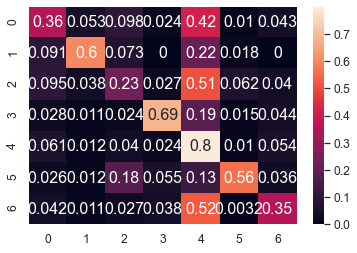

	training epoch=33 .. train_loss=1.013
	validation epoch=33 .. val_loss=1.298
	Accuracy = 51.9 % .. Percision = 55.00000000000001 % .. Recall = 51.300000000000004 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_33.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 34 .. loss = 1.188


  0%|                                                                                 | 1/1914 [00:01<35:29,  1.11s/it]

training @ epoch 34 .. loss = 0.929


  0%|                                                                                 | 2/1914 [00:02<35:09,  1.10s/it]

training @ epoch 34 .. loss = 1.073


  0%|▏                                                                                | 3/1914 [00:03<34:37,  1.09s/it]

training @ epoch 34 .. loss = 0.772


  0%|▏                                                                                | 4/1914 [00:04<34:27,  1.08s/it]

training @ epoch 34 .. loss = 1.034


  0%|▏                                                                                | 5/1914 [00:05<34:42,  1.09s/it]

training @ epoch 34 .. loss = 1.136


  0%|▎                                                                                | 6/1914 [00:06<34:11,  1.08s/it]

training @ epoch 34 .. loss = 0.845


  0%|▎                                                                                | 7/1914 [00:07<34:35,  1.09s/it]

training @ epoch 34 .. loss = 1.285


  0%|▎                                                                                | 8/1914 [00:08<34:35,  1.09s/it]

training @ epoch 34 .. loss = 0.491


  0%|▍                                                                                | 9/1914 [00:09<34:06,  1.07s/it]

training @ epoch 34 .. loss = 1.234


  1%|▍                                                                               | 10/1914 [00:10<33:52,  1.07s/it]

training @ epoch 34 .. loss = 0.975


  1%|▍                                                                               | 11/1914 [00:11<34:04,  1.07s/it]

training @ epoch 34 .. loss = 1.113


  1%|▌                                                                               | 12/1914 [00:12<33:48,  1.07s/it]

training @ epoch 34 .. loss = 1.431


  1%|▌                                                                               | 13/1914 [00:14<34:39,  1.09s/it]

training @ epoch 34 .. loss = 1.262


  1%|▌                                                                               | 14/1914 [00:15<34:31,  1.09s/it]

training @ epoch 34 .. loss = 0.823


  1%|▋                                                                               | 15/1914 [00:16<33:58,  1.07s/it]

training @ epoch 34 .. loss = 1.258


  1%|▋                                                                               | 16/1914 [00:17<33:47,  1.07s/it]

training @ epoch 34 .. loss = 0.955


  1%|▋                                                                               | 17/1914 [00:18<33:57,  1.07s/it]

training @ epoch 34 .. loss = 0.698


  1%|▊                                                                               | 18/1914 [00:19<33:41,  1.07s/it]

training @ epoch 34 .. loss = 1.085


  1%|▊                                                                               | 19/1914 [00:20<33:39,  1.07s/it]

training @ epoch 34 .. loss = 1.126


  1%|▊                                                                               | 20/1914 [00:21<33:41,  1.07s/it]

training @ epoch 34 .. loss = 0.681


  1%|▉                                                                               | 21/1914 [00:22<33:42,  1.07s/it]

training @ epoch 34 .. loss = 0.996


  1%|▉                                                                               | 22/1914 [00:23<33:52,  1.07s/it]

training @ epoch 34 .. loss = 0.971


  1%|▉                                                                               | 23/1914 [00:24<36:09,  1.15s/it]

training @ epoch 34 .. loss = 0.555


  1%|█                                                                               | 24/1914 [00:26<38:31,  1.22s/it]

training @ epoch 34 .. loss = 1.007


  1%|█                                                                               | 25/1914 [00:27<40:38,  1.29s/it]

training @ epoch 34 .. loss = 0.715


  1%|█                                                                               | 26/1914 [00:29<42:06,  1.34s/it]

training @ epoch 34 .. loss = 1.465


  1%|█▏                                                                              | 27/1914 [00:30<44:38,  1.42s/it]

training @ epoch 34 .. loss = 1.171


  1%|█▏                                                                            | 28/1914 [00:35<1:11:04,  2.26s/it]

training @ epoch 34 .. loss = 1.415


  2%|█▏                                                                            | 29/1914 [00:38<1:24:22,  2.69s/it]

training @ epoch 34 .. loss = 0.568


  2%|█▏                                                                            | 30/1914 [00:40<1:12:59,  2.32s/it]

training @ epoch 34 .. loss = 0.933


  2%|█▎                                                                            | 31/1914 [00:41<1:04:28,  2.05s/it]

training @ epoch 34 .. loss = 1.184


  2%|█▎                                                                              | 32/1914 [00:43<58:08,  1.85s/it]

training @ epoch 34 .. loss = 1.092


  2%|█▍                                                                              | 33/1914 [00:44<53:50,  1.72s/it]

training @ epoch 34 .. loss = 1.14


  2%|█▍                                                                              | 34/1914 [00:45<50:42,  1.62s/it]

training @ epoch 34 .. loss = 0.585


  2%|█▍                                                                              | 35/1914 [00:47<49:18,  1.57s/it]

training @ epoch 34 .. loss = 1.265


  2%|█▍                                                                            | 36/1914 [00:51<1:09:22,  2.22s/it]

training @ epoch 34 .. loss = 0.706


  2%|█▌                                                                            | 37/1914 [00:56<1:37:17,  3.11s/it]

training @ epoch 34 .. loss = 0.79


  2%|█▍                                                                     | 38/1914 [3:49:33<2145:37:37, 4117.41s/it]

training @ epoch 34 .. loss = 1.332


  2%|█▍                                                                     | 39/1914 [3:49:39<1502:02:37, 2883.92s/it]

training @ epoch 34 .. loss = 1.008


  2%|█▍                                                                     | 40/1914 [3:49:42<1051:20:05, 2019.64s/it]

training @ epoch 34 .. loss = 0.929


  2%|█▌                                                                      | 41/1914 [3:49:44<735:53:12, 1414.41s/it]

training @ epoch 34 .. loss = 1.095


  2%|█▌                                                                       | 42/1914 [3:49:46<515:10:29, 990.72s/it]

training @ epoch 34 .. loss = 0.769


  2%|█▋                                                                       | 43/1914 [3:49:49<360:48:12, 694.22s/it]

training @ epoch 34 .. loss = 1.0


  2%|█▋                                                                       | 44/1914 [3:49:51<252:46:00, 486.61s/it]

training @ epoch 34 .. loss = 1.522


  2%|█▋                                                                       | 45/1914 [3:49:52<177:05:37, 341.11s/it]

training @ epoch 34 .. loss = 1.032


  2%|█▊                                                                       | 46/1914 [3:49:54<124:09:07, 239.27s/it]

training @ epoch 34 .. loss = 0.908


  2%|█▊                                                                        | 47/1914 [3:49:56<87:09:18, 168.06s/it]

training @ epoch 34 .. loss = 0.473


  3%|█▊                                                                        | 48/1914 [3:49:58<61:13:38, 118.12s/it]

training @ epoch 34 .. loss = 1.638


  3%|█▉                                                                         | 49/1914 [3:49:59<43:06:53, 83.22s/it]

training @ epoch 34 .. loss = 0.988


  3%|█▉                                                                         | 50/1914 [3:50:01<30:25:48, 58.77s/it]

training @ epoch 34 .. loss = 0.658


  3%|█▉                                                                         | 51/1914 [3:50:03<21:38:14, 41.81s/it]

training @ epoch 34 .. loss = 0.706


  3%|██                                                                         | 52/1914 [3:50:05<15:25:02, 29.81s/it]

training @ epoch 34 .. loss = 0.851


  3%|██                                                                         | 53/1914 [3:50:07<11:01:34, 21.33s/it]

training @ epoch 34 .. loss = 0.887


  3%|██▏                                                                         | 54/1914 [3:50:08<7:58:48, 15.45s/it]

training @ epoch 34 .. loss = 1.061


  3%|██▏                                                                         | 55/1914 [3:50:10<5:49:55, 11.29s/it]

training @ epoch 34 .. loss = 0.884


  3%|██▏                                                                         | 56/1914 [3:50:12<4:18:58,  8.36s/it]

training @ epoch 34 .. loss = 0.812


  3%|██▎                                                                         | 57/1914 [3:50:13<3:17:01,  6.37s/it]

training @ epoch 34 .. loss = 1.176


  3%|██▎                                                                         | 58/1914 [3:50:15<2:34:18,  4.99s/it]

training @ epoch 34 .. loss = 0.768


  3%|██▎                                                                         | 59/1914 [3:50:17<2:02:30,  3.96s/it]

training @ epoch 34 .. loss = 0.645


  3%|██▍                                                                         | 60/1914 [3:50:18<1:40:05,  3.24s/it]

training @ epoch 34 .. loss = 0.931


  3%|██▍                                                                         | 61/1914 [3:50:20<1:24:14,  2.73s/it]

training @ epoch 34 .. loss = 1.16


  3%|██▍                                                                         | 62/1914 [3:50:21<1:15:01,  2.43s/it]

training @ epoch 34 .. loss = 1.022


  3%|██▌                                                                         | 63/1914 [3:50:23<1:06:43,  2.16s/it]

training @ epoch 34 .. loss = 0.809


  3%|██▌                                                                         | 64/1914 [3:50:24<1:00:56,  1.98s/it]

training @ epoch 34 .. loss = 0.891


  3%|██▌                                                                         | 65/1914 [3:50:26<1:00:21,  1.96s/it]

training @ epoch 34 .. loss = 1.428


  3%|██▋                                                                           | 66/1914 [3:50:28<59:01,  1.92s/it]

training @ epoch 34 .. loss = 0.717


  4%|██▋                                                                           | 67/1914 [3:50:30<56:17,  1.83s/it]

training @ epoch 34 .. loss = 1.323


  4%|██▊                                                                           | 68/1914 [3:50:31<53:53,  1.75s/it]

training @ epoch 34 .. loss = 0.771


  4%|██▊                                                                           | 69/1914 [3:50:33<52:14,  1.70s/it]

training @ epoch 34 .. loss = 1.5


  4%|██▊                                                                           | 70/1914 [3:50:35<51:17,  1.67s/it]

training @ epoch 34 .. loss = 0.88


  4%|██▉                                                                           | 71/1914 [3:50:36<52:45,  1.72s/it]

training @ epoch 34 .. loss = 0.557


  4%|██▉                                                                           | 72/1914 [3:50:38<51:29,  1.68s/it]

training @ epoch 34 .. loss = 0.685


  4%|██▉                                                                           | 73/1914 [3:50:40<50:46,  1.65s/it]

training @ epoch 34 .. loss = 1.2


  4%|██▉                                                                         | 74/1914 [3:50:42<1:00:03,  1.96s/it]

training @ epoch 34 .. loss = 0.981


  4%|███                                                                           | 75/1914 [3:50:44<56:14,  1.83s/it]

training @ epoch 34 .. loss = 0.67


  4%|███                                                                           | 76/1914 [3:50:45<53:11,  1.74s/it]

training @ epoch 34 .. loss = 1.127


  4%|███▏                                                                          | 77/1914 [3:50:47<53:05,  1.73s/it]

training @ epoch 34 .. loss = 1.291


  4%|███▏                                                                          | 78/1914 [3:50:49<51:21,  1.68s/it]

training @ epoch 34 .. loss = 0.885


  4%|███▏                                                                          | 79/1914 [3:50:50<52:10,  1.71s/it]

training @ epoch 34 .. loss = 0.635


  4%|███▎                                                                          | 80/1914 [3:50:52<51:49,  1.70s/it]

training @ epoch 34 .. loss = 0.905


  4%|███▎                                                                          | 81/1914 [3:50:54<55:07,  1.80s/it]

training @ epoch 34 .. loss = 0.871


  4%|███▎                                                                          | 82/1914 [3:50:56<52:34,  1.72s/it]

training @ epoch 34 .. loss = 0.593


  4%|███▍                                                                          | 83/1914 [3:50:57<50:55,  1.67s/it]

training @ epoch 34 .. loss = 0.9


  4%|███▍                                                                          | 84/1914 [3:50:59<50:25,  1.65s/it]

training @ epoch 34 .. loss = 1.148


  4%|███▍                                                                          | 85/1914 [3:51:00<49:13,  1.61s/it]

training @ epoch 34 .. loss = 1.323


  4%|███▌                                                                          | 86/1914 [3:51:02<48:52,  1.60s/it]

training @ epoch 34 .. loss = 1.013


  5%|███▌                                                                          | 87/1914 [3:51:03<47:58,  1.58s/it]

training @ epoch 34 .. loss = 1.153


  5%|███▌                                                                          | 88/1914 [3:51:05<47:32,  1.56s/it]

training @ epoch 34 .. loss = 1.035


  5%|███▋                                                                          | 89/1914 [3:51:06<47:03,  1.55s/it]

training @ epoch 34 .. loss = 1.077


  5%|███▋                                                                          | 90/1914 [3:51:08<49:09,  1.62s/it]

training @ epoch 34 .. loss = 0.522


  5%|███▋                                                                          | 91/1914 [3:51:10<51:53,  1.71s/it]

training @ epoch 34 .. loss = 1.211


  5%|███▋                                                                          | 92/1914 [3:51:13<58:07,  1.91s/it]

training @ epoch 34 .. loss = 1.31


  5%|███▊                                                                          | 93/1914 [3:51:14<56:34,  1.86s/it]

training @ epoch 34 .. loss = 1.146


  5%|███▊                                                                          | 94/1914 [3:51:16<56:39,  1.87s/it]

training @ epoch 34 .. loss = 0.974


  5%|███▊                                                                        | 95/1914 [3:51:19<1:02:47,  2.07s/it]

training @ epoch 34 .. loss = 0.863


  5%|███▊                                                                        | 96/1914 [3:51:23<1:23:59,  2.77s/it]

training @ epoch 34 .. loss = 0.824


  5%|███▊                                                                        | 97/1914 [3:51:26<1:21:26,  2.69s/it]

training @ epoch 34 .. loss = 0.925


  5%|███▉                                                                        | 98/1914 [3:51:28<1:22:45,  2.73s/it]

training @ epoch 34 .. loss = 0.936


  5%|███▉                                                                        | 99/1914 [3:51:32<1:28:27,  2.92s/it]

training @ epoch 34 .. loss = 0.761


  5%|███▉                                                                       | 100/1914 [3:51:34<1:17:35,  2.57s/it]

training @ epoch 34 .. loss = 0.886


  5%|███▉                                                                       | 101/1914 [3:51:36<1:13:28,  2.43s/it]

training @ epoch 34 .. loss = 0.603


  5%|███▉                                                                       | 102/1914 [3:51:38<1:08:26,  2.27s/it]

training @ epoch 34 .. loss = 1.283


  5%|████                                                                       | 103/1914 [3:51:39<1:03:15,  2.10s/it]

training @ epoch 34 .. loss = 0.755


  5%|████                                                                       | 104/1914 [3:51:41<1:01:04,  2.02s/it]

training @ epoch 34 .. loss = 0.487


  5%|████                                                                       | 105/1914 [3:51:43<1:01:21,  2.03s/it]

training @ epoch 34 .. loss = 1.103


  6%|████▏                                                                      | 106/1914 [3:51:46<1:04:33,  2.14s/it]

training @ epoch 34 .. loss = 0.956


  6%|████▏                                                                      | 107/1914 [3:51:48<1:04:25,  2.14s/it]

training @ epoch 34 .. loss = 1.503


  6%|████▏                                                                      | 108/1914 [3:51:50<1:02:44,  2.08s/it]

training @ epoch 34 .. loss = 0.598


  6%|████▎                                                                      | 109/1914 [3:51:51<1:00:08,  2.00s/it]

training @ epoch 34 .. loss = 0.852


  6%|████▍                                                                        | 110/1914 [3:51:53<56:38,  1.88s/it]

training @ epoch 34 .. loss = 1.079


  6%|████▎                                                                      | 111/1914 [3:51:55<1:00:33,  2.02s/it]

training @ epoch 34 .. loss = 0.761


  6%|████▌                                                                        | 112/1914 [3:51:57<56:35,  1.88s/it]

training @ epoch 34 .. loss = 0.958


  6%|████▌                                                                        | 113/1914 [3:51:59<54:02,  1.80s/it]

training @ epoch 34 .. loss = 0.893


  6%|████▌                                                                        | 114/1914 [3:52:00<53:08,  1.77s/it]

training @ epoch 34 .. loss = 1.599


  6%|████▋                                                                        | 115/1914 [3:52:02<52:00,  1.73s/it]

training @ epoch 34 .. loss = 0.989


  6%|████▋                                                                        | 116/1914 [3:52:04<50:36,  1.69s/it]

training @ epoch 34 .. loss = 0.701


  6%|████▋                                                                        | 117/1914 [3:52:05<52:39,  1.76s/it]

training @ epoch 34 .. loss = 1.272


  6%|████▋                                                                        | 118/1914 [3:52:07<51:53,  1.73s/it]

training @ epoch 34 .. loss = 0.757


  6%|████▊                                                                        | 119/1914 [3:52:09<50:24,  1.69s/it]

training @ epoch 34 .. loss = 0.563


  6%|████▊                                                                        | 120/1914 [3:52:11<55:00,  1.84s/it]

training @ epoch 34 .. loss = 0.776


  6%|████▊                                                                        | 121/1914 [3:52:13<54:18,  1.82s/it]

training @ epoch 34 .. loss = 0.785


  6%|████▉                                                                        | 122/1914 [3:52:14<51:55,  1.74s/it]

training @ epoch 34 .. loss = 0.912


  6%|████▉                                                                        | 123/1914 [3:52:16<50:19,  1.69s/it]

training @ epoch 34 .. loss = 1.214


  6%|████▉                                                                        | 124/1914 [3:52:18<52:57,  1.78s/it]

training @ epoch 34 .. loss = 1.012


  7%|█████                                                                        | 125/1914 [3:52:19<50:51,  1.71s/it]

training @ epoch 34 .. loss = 1.182


  7%|█████                                                                        | 126/1914 [3:52:21<50:13,  1.69s/it]

training @ epoch 34 .. loss = 0.719


  7%|█████                                                                        | 127/1914 [3:52:23<51:30,  1.73s/it]

training @ epoch 34 .. loss = 0.844


  7%|█████▏                                                                       | 128/1914 [3:52:25<57:39,  1.94s/it]

training @ epoch 34 .. loss = 0.815


  7%|█████▏                                                                       | 129/1914 [3:52:27<54:46,  1.84s/it]

training @ epoch 34 .. loss = 1.055


  7%|█████▏                                                                       | 130/1914 [3:52:29<55:14,  1.86s/it]

training @ epoch 34 .. loss = 0.723


  7%|█████▎                                                                       | 131/1914 [3:52:31<56:55,  1.92s/it]

training @ epoch 34 .. loss = 0.882


  7%|█████▎                                                                       | 132/1914 [3:52:33<55:50,  1.88s/it]

training @ epoch 34 .. loss = 0.709


  7%|█████▎                                                                       | 133/1914 [3:52:35<57:31,  1.94s/it]

training @ epoch 34 .. loss = 0.532


  7%|█████▍                                                                       | 134/1914 [3:52:36<54:53,  1.85s/it]

training @ epoch 34 .. loss = 0.899


  7%|█████▍                                                                       | 135/1914 [3:52:38<53:44,  1.81s/it]

training @ epoch 34 .. loss = 0.603


  7%|█████▍                                                                       | 136/1914 [3:52:40<52:51,  1.78s/it]

training @ epoch 34 .. loss = 0.834


  7%|█████▌                                                                       | 137/1914 [3:52:42<58:26,  1.97s/it]

training @ epoch 34 .. loss = 0.822


  7%|█████▌                                                                       | 138/1914 [3:52:44<55:17,  1.87s/it]

training @ epoch 34 .. loss = 1.165


  7%|█████▌                                                                       | 139/1914 [3:52:45<52:55,  1.79s/it]

training @ epoch 34 .. loss = 1.659


  7%|█████▋                                                                       | 140/1914 [3:52:47<51:39,  1.75s/it]

training @ epoch 34 .. loss = 1.178


  7%|█████▋                                                                       | 141/1914 [3:52:49<51:00,  1.73s/it]

training @ epoch 34 .. loss = 1.042


  7%|█████▋                                                                       | 142/1914 [3:52:51<59:32,  2.02s/it]

training @ epoch 34 .. loss = 1.092


  7%|█████▊                                                                       | 143/1914 [3:52:53<56:21,  1.91s/it]

training @ epoch 34 .. loss = 0.925


  8%|█████▊                                                                       | 144/1914 [3:52:55<54:20,  1.84s/it]

training @ epoch 34 .. loss = 0.999


  8%|█████▊                                                                       | 145/1914 [3:52:56<52:59,  1.80s/it]

training @ epoch 34 .. loss = 0.86


  8%|█████▊                                                                       | 146/1914 [3:52:58<51:08,  1.74s/it]

training @ epoch 34 .. loss = 0.996


  8%|█████▉                                                                       | 147/1914 [3:53:00<50:46,  1.72s/it]

training @ epoch 34 .. loss = 1.375


  8%|█████▉                                                                       | 148/1914 [3:53:02<51:26,  1.75s/it]

training @ epoch 34 .. loss = 1.051


  8%|█████▉                                                                       | 149/1914 [3:53:03<50:40,  1.72s/it]

training @ epoch 34 .. loss = 0.8


  8%|██████                                                                       | 150/1914 [3:53:05<50:18,  1.71s/it]

training @ epoch 34 .. loss = 0.573


  8%|██████                                                                       | 151/1914 [3:53:07<51:35,  1.76s/it]

training @ epoch 34 .. loss = 0.904


  8%|██████                                                                       | 152/1914 [3:53:09<51:48,  1.76s/it]

training @ epoch 34 .. loss = 1.151


  8%|██████▏                                                                      | 153/1914 [3:53:10<51:52,  1.77s/it]

training @ epoch 34 .. loss = 1.054


  8%|██████▏                                                                      | 154/1914 [3:53:12<51:12,  1.75s/it]

training @ epoch 34 .. loss = 0.959


  8%|██████▏                                                                      | 155/1914 [3:53:14<51:43,  1.76s/it]

training @ epoch 34 .. loss = 0.727


  8%|██████▎                                                                      | 156/1914 [3:53:15<51:19,  1.75s/it]

training @ epoch 34 .. loss = 0.958


  8%|██████▎                                                                      | 157/1914 [3:53:17<50:04,  1.71s/it]

training @ epoch 34 .. loss = 0.792


  8%|██████▎                                                                      | 158/1914 [3:53:19<50:00,  1.71s/it]

training @ epoch 34 .. loss = 1.242


  8%|██████▍                                                                      | 159/1914 [3:53:20<49:19,  1.69s/it]

training @ epoch 34 .. loss = 1.308


  8%|██████▍                                                                      | 160/1914 [3:53:22<48:53,  1.67s/it]

training @ epoch 34 .. loss = 0.685


  8%|██████▍                                                                      | 161/1914 [3:53:24<49:06,  1.68s/it]

training @ epoch 34 .. loss = 1.103


  8%|██████▌                                                                      | 162/1914 [3:53:25<49:02,  1.68s/it]

training @ epoch 34 .. loss = 0.898


  9%|██████▌                                                                      | 163/1914 [3:53:27<48:48,  1.67s/it]

training @ epoch 34 .. loss = 0.857


  9%|██████▌                                                                      | 164/1914 [3:53:29<48:44,  1.67s/it]

training @ epoch 34 .. loss = 1.156


  9%|██████▋                                                                      | 165/1914 [3:53:30<48:37,  1.67s/it]

training @ epoch 34 .. loss = 1.416


  9%|██████▋                                                                      | 166/1914 [3:53:32<50:44,  1.74s/it]

training @ epoch 34 .. loss = 0.675


  9%|██████▋                                                                      | 167/1914 [3:53:34<50:03,  1.72s/it]

training @ epoch 34 .. loss = 0.66


  9%|██████▊                                                                      | 168/1914 [3:53:36<50:53,  1.75s/it]

training @ epoch 34 .. loss = 1.509


  9%|██████▊                                                                      | 169/1914 [3:53:38<52:58,  1.82s/it]

training @ epoch 34 .. loss = 0.624


  9%|██████▊                                                                      | 170/1914 [3:53:39<51:12,  1.76s/it]

training @ epoch 34 .. loss = 1.575


  9%|██████▉                                                                      | 171/1914 [3:53:41<50:14,  1.73s/it]

training @ epoch 34 .. loss = 1.157


  9%|██████▉                                                                      | 172/1914 [3:53:43<50:19,  1.73s/it]

training @ epoch 34 .. loss = 1.374


  9%|██████▉                                                                      | 173/1914 [3:53:45<49:43,  1.71s/it]

training @ epoch 34 .. loss = 0.765


  9%|███████                                                                      | 174/1914 [3:53:46<49:31,  1.71s/it]

training @ epoch 34 .. loss = 0.569


  9%|███████                                                                      | 175/1914 [3:53:48<49:15,  1.70s/it]

training @ epoch 34 .. loss = 0.728


  9%|███████                                                                      | 176/1914 [3:53:50<49:29,  1.71s/it]

training @ epoch 34 .. loss = 0.913


  9%|███████                                                                      | 177/1914 [3:53:51<49:24,  1.71s/it]

training @ epoch 34 .. loss = 1.228


  9%|███████▏                                                                     | 178/1914 [3:53:53<49:19,  1.70s/it]

training @ epoch 34 .. loss = 0.766


  9%|███████▏                                                                     | 179/1914 [3:53:55<49:07,  1.70s/it]

training @ epoch 34 .. loss = 1.325


  9%|███████▏                                                                     | 180/1914 [3:53:56<48:52,  1.69s/it]

training @ epoch 34 .. loss = 0.768


  9%|███████▎                                                                     | 181/1914 [3:53:58<48:53,  1.69s/it]

training @ epoch 34 .. loss = 0.787


 10%|███████▎                                                                     | 182/1914 [3:54:00<48:44,  1.69s/it]

training @ epoch 34 .. loss = 0.99


 10%|███████▎                                                                     | 183/1914 [3:54:01<48:51,  1.69s/it]

training @ epoch 34 .. loss = 1.067


 10%|███████▍                                                                     | 184/1914 [3:54:03<48:54,  1.70s/it]

training @ epoch 34 .. loss = 1.033


 10%|███████▍                                                                     | 185/1914 [3:54:05<49:23,  1.71s/it]

training @ epoch 34 .. loss = 0.8


 10%|███████▍                                                                     | 186/1914 [3:54:07<49:13,  1.71s/it]

training @ epoch 34 .. loss = 0.962


 10%|███████▌                                                                     | 187/1914 [3:54:08<50:16,  1.75s/it]

training @ epoch 34 .. loss = 0.777


 10%|███████▌                                                                     | 188/1914 [3:54:10<49:41,  1.73s/it]

training @ epoch 34 .. loss = 1.173


 10%|███████▌                                                                     | 189/1914 [3:54:12<49:13,  1.71s/it]

training @ epoch 34 .. loss = 0.959


 10%|███████▋                                                                     | 190/1914 [3:54:13<48:36,  1.69s/it]

training @ epoch 34 .. loss = 1.331


 10%|███████▋                                                                     | 191/1914 [3:54:15<48:08,  1.68s/it]

training @ epoch 34 .. loss = 0.883


 10%|███████▋                                                                     | 192/1914 [3:54:17<46:53,  1.63s/it]

training @ epoch 34 .. loss = 1.15


 10%|███████▊                                                                     | 193/1914 [3:54:18<46:09,  1.61s/it]

training @ epoch 34 .. loss = 0.698


 10%|███████▊                                                                     | 194/1914 [3:54:20<45:22,  1.58s/it]

training @ epoch 34 .. loss = 1.114


 10%|███████▊                                                                     | 195/1914 [3:54:21<45:26,  1.59s/it]

training @ epoch 34 .. loss = 1.33


 10%|███████▉                                                                     | 196/1914 [3:54:23<46:27,  1.62s/it]

training @ epoch 34 .. loss = 1.281


 10%|███████▉                                                                     | 197/1914 [3:54:25<46:32,  1.63s/it]

training @ epoch 34 .. loss = 0.772


 10%|███████▉                                                                     | 198/1914 [3:54:26<47:50,  1.67s/it]

training @ epoch 34 .. loss = 0.899


 10%|████████                                                                     | 199/1914 [3:54:28<49:06,  1.72s/it]

training @ epoch 34 .. loss = 1.092


 10%|████████                                                                     | 200/1914 [3:54:30<48:36,  1.70s/it]

training @ epoch 34 .. loss = 0.582


 11%|████████                                                                     | 201/1914 [3:54:32<47:48,  1.67s/it]

training @ epoch 34 .. loss = 0.884


 11%|████████▏                                                                    | 202/1914 [3:54:33<49:07,  1.72s/it]

training @ epoch 34 .. loss = 1.068


 11%|████████▏                                                                    | 203/1914 [3:54:35<49:41,  1.74s/it]

training @ epoch 34 .. loss = 0.963


 11%|████████▏                                                                    | 204/1914 [3:54:37<51:59,  1.82s/it]

training @ epoch 34 .. loss = 1.055


 11%|████████▏                                                                    | 205/1914 [3:54:39<53:26,  1.88s/it]

training @ epoch 34 .. loss = 1.114


 11%|████████▎                                                                    | 206/1914 [3:54:41<51:57,  1.83s/it]

training @ epoch 34 .. loss = 1.091


 11%|████████▎                                                                    | 207/1914 [3:54:43<50:39,  1.78s/it]

training @ epoch 34 .. loss = 1.332


 11%|████████▎                                                                    | 208/1914 [3:54:44<51:07,  1.80s/it]

training @ epoch 34 .. loss = 1.02


 11%|████████▍                                                                    | 209/1914 [3:54:46<52:34,  1.85s/it]

training @ epoch 34 .. loss = 1.175


 11%|████████▍                                                                    | 210/1914 [3:54:48<52:36,  1.85s/it]

training @ epoch 34 .. loss = 1.148


 11%|████████▍                                                                    | 211/1914 [3:54:50<51:37,  1.82s/it]

training @ epoch 34 .. loss = 0.573


 11%|████████▌                                                                    | 212/1914 [3:54:52<50:07,  1.77s/it]

training @ epoch 34 .. loss = 0.982


 11%|████████▌                                                                    | 213/1914 [3:54:53<49:32,  1.75s/it]

training @ epoch 34 .. loss = 1.196


 11%|████████▌                                                                    | 214/1914 [3:54:55<48:32,  1.71s/it]

training @ epoch 34 .. loss = 0.952


 11%|████████▋                                                                    | 215/1914 [3:54:57<47:29,  1.68s/it]

training @ epoch 34 .. loss = 1.392


 11%|████████▋                                                                    | 216/1914 [3:54:58<47:00,  1.66s/it]

training @ epoch 34 .. loss = 0.545


 11%|████████▋                                                                    | 217/1914 [3:55:00<47:32,  1.68s/it]

training @ epoch 34 .. loss = 1.053


 11%|████████▊                                                                    | 218/1914 [3:55:02<47:19,  1.67s/it]

training @ epoch 34 .. loss = 0.855


 11%|████████▊                                                                    | 219/1914 [3:55:03<47:15,  1.67s/it]

training @ epoch 34 .. loss = 0.97


 11%|████████▊                                                                    | 220/1914 [3:55:05<46:51,  1.66s/it]

training @ epoch 34 .. loss = 0.806


 12%|████████▉                                                                    | 221/1914 [3:55:07<47:34,  1.69s/it]

training @ epoch 34 .. loss = 1.094


 12%|████████▉                                                                    | 222/1914 [3:55:08<47:14,  1.68s/it]

training @ epoch 34 .. loss = 1.342


 12%|████████▉                                                                    | 223/1914 [3:55:10<47:10,  1.67s/it]

training @ epoch 34 .. loss = 1.254


 12%|█████████                                                                    | 224/1914 [3:55:12<47:37,  1.69s/it]

training @ epoch 34 .. loss = 0.704


 12%|█████████                                                                    | 225/1914 [3:55:13<47:21,  1.68s/it]

training @ epoch 34 .. loss = 1.047


 12%|█████████                                                                    | 226/1914 [3:55:15<47:31,  1.69s/it]

training @ epoch 34 .. loss = 0.757


 12%|█████████▏                                                                   | 227/1914 [3:55:17<47:49,  1.70s/it]

training @ epoch 34 .. loss = 1.093


 12%|█████████▏                                                                   | 228/1914 [3:55:18<48:04,  1.71s/it]

training @ epoch 34 .. loss = 0.983


 12%|█████████▏                                                                   | 229/1914 [3:55:20<48:08,  1.71s/it]

training @ epoch 34 .. loss = 0.979


 12%|█████████▎                                                                   | 230/1914 [3:55:22<48:18,  1.72s/it]

training @ epoch 34 .. loss = 1.188


 12%|█████████▎                                                                   | 231/1914 [3:55:24<48:29,  1.73s/it]

training @ epoch 34 .. loss = 1.353


 12%|█████████▎                                                                   | 232/1914 [3:55:25<48:12,  1.72s/it]

training @ epoch 34 .. loss = 1.499


 12%|█████████▎                                                                   | 233/1914 [3:55:27<47:51,  1.71s/it]

training @ epoch 34 .. loss = 0.643


 12%|█████████▍                                                                   | 234/1914 [3:55:29<47:50,  1.71s/it]

training @ epoch 34 .. loss = 0.615


 12%|█████████▍                                                                   | 235/1914 [3:55:30<47:33,  1.70s/it]

training @ epoch 34 .. loss = 1.367


 12%|█████████▍                                                                   | 236/1914 [3:55:32<48:43,  1.74s/it]

training @ epoch 34 .. loss = 1.585


 12%|█████████▌                                                                   | 237/1914 [3:55:34<48:20,  1.73s/it]

training @ epoch 34 .. loss = 1.05


 12%|█████████▌                                                                   | 238/1914 [3:55:36<47:40,  1.71s/it]

training @ epoch 34 .. loss = 0.982


 12%|█████████▌                                                                   | 239/1914 [3:55:37<47:12,  1.69s/it]

training @ epoch 34 .. loss = 0.768


 13%|█████████▋                                                                   | 240/1914 [3:55:39<46:55,  1.68s/it]

training @ epoch 34 .. loss = 0.898


 13%|█████████▋                                                                   | 241/1914 [3:55:41<47:01,  1.69s/it]

training @ epoch 34 .. loss = 0.838


 13%|█████████▋                                                                   | 242/1914 [3:55:42<47:00,  1.69s/it]

training @ epoch 34 .. loss = 1.023


 13%|█████████▊                                                                   | 243/1914 [3:55:44<47:15,  1.70s/it]

training @ epoch 34 .. loss = 0.687


 13%|█████████▊                                                                   | 244/1914 [3:55:46<47:00,  1.69s/it]

training @ epoch 34 .. loss = 1.139


 13%|█████████▊                                                                   | 245/1914 [3:55:47<46:54,  1.69s/it]

training @ epoch 34 .. loss = 1.024


 13%|█████████▉                                                                   | 246/1914 [3:55:50<52:32,  1.89s/it]

training @ epoch 34 .. loss = 0.82


 13%|█████████▉                                                                   | 247/1914 [3:55:51<51:00,  1.84s/it]

training @ epoch 34 .. loss = 0.626


 13%|█████████▉                                                                   | 248/1914 [3:55:53<50:23,  1.81s/it]

training @ epoch 34 .. loss = 1.009


 13%|██████████                                                                   | 249/1914 [3:55:55<48:38,  1.75s/it]

training @ epoch 34 .. loss = 1.153


 13%|██████████                                                                   | 250/1914 [3:55:57<47:42,  1.72s/it]

training @ epoch 34 .. loss = 1.1


 13%|██████████                                                                   | 251/1914 [3:55:58<46:50,  1.69s/it]

training @ epoch 34 .. loss = 1.222


 13%|██████████▏                                                                  | 252/1914 [3:56:00<46:58,  1.70s/it]

training @ epoch 34 .. loss = 1.619


 13%|██████████▏                                                                  | 253/1914 [3:56:01<45:51,  1.66s/it]

training @ epoch 34 .. loss = 0.743


 13%|██████████▏                                                                  | 254/1914 [3:56:03<44:44,  1.62s/it]

training @ epoch 34 .. loss = 1.102


 13%|██████████▎                                                                  | 255/1914 [3:56:05<44:26,  1.61s/it]

training @ epoch 34 .. loss = 1.454


 13%|██████████▎                                                                  | 256/1914 [3:56:06<45:27,  1.65s/it]

training @ epoch 34 .. loss = 0.488


 13%|██████████▎                                                                  | 257/1914 [3:56:08<44:45,  1.62s/it]

training @ epoch 34 .. loss = 1.04


 13%|██████████▍                                                                  | 258/1914 [3:56:09<44:13,  1.60s/it]

training @ epoch 34 .. loss = 1.181


 14%|██████████▍                                                                  | 259/1914 [3:56:11<44:02,  1.60s/it]

training @ epoch 34 .. loss = 0.946


 14%|██████████▍                                                                  | 260/1914 [3:56:12<43:03,  1.56s/it]

training @ epoch 34 .. loss = 1.229


 14%|██████████▌                                                                  | 261/1914 [3:56:14<42:43,  1.55s/it]

training @ epoch 34 .. loss = 0.829


 14%|██████████▌                                                                  | 262/1914 [3:56:16<42:48,  1.55s/it]

training @ epoch 34 .. loss = 0.696


 14%|██████████▌                                                                  | 263/1914 [3:56:17<42:31,  1.55s/it]

training @ epoch 34 .. loss = 0.892


 14%|██████████▌                                                                  | 264/1914 [3:56:19<42:05,  1.53s/it]

training @ epoch 34 .. loss = 0.551


 14%|██████████▋                                                                  | 265/1914 [3:56:20<42:23,  1.54s/it]

training @ epoch 34 .. loss = 1.351


 14%|██████████▋                                                                  | 266/1914 [3:56:22<43:12,  1.57s/it]

training @ epoch 34 .. loss = 0.985


 14%|██████████▋                                                                  | 267/1914 [3:56:23<44:05,  1.61s/it]

training @ epoch 34 .. loss = 0.82


 14%|██████████▊                                                                  | 268/1914 [3:56:25<44:23,  1.62s/it]

training @ epoch 34 .. loss = 1.152


 14%|██████████▊                                                                  | 269/1914 [3:56:27<44:16,  1.62s/it]

training @ epoch 34 .. loss = 1.011


 14%|██████████▊                                                                  | 270/1914 [3:56:28<44:16,  1.62s/it]

training @ epoch 34 .. loss = 0.763


 14%|██████████▉                                                                  | 271/1914 [3:56:30<46:58,  1.72s/it]

training @ epoch 34 .. loss = 1.091


 14%|██████████▉                                                                  | 272/1914 [3:56:32<49:01,  1.79s/it]

training @ epoch 34 .. loss = 0.895


 14%|██████████▉                                                                  | 273/1914 [3:56:34<49:57,  1.83s/it]

training @ epoch 34 .. loss = 1.23


 14%|███████████                                                                  | 274/1914 [3:56:36<52:25,  1.92s/it]

training @ epoch 34 .. loss = 0.581


 14%|███████████                                                                  | 275/1914 [3:56:39<56:21,  2.06s/it]

training @ epoch 34 .. loss = 0.777


 14%|███████████                                                                  | 276/1914 [3:56:40<53:49,  1.97s/it]

training @ epoch 34 .. loss = 0.966


 14%|███████████▏                                                                 | 277/1914 [3:56:42<53:33,  1.96s/it]

training @ epoch 34 .. loss = 1.219


 15%|███████████▏                                                                 | 278/1914 [3:56:44<52:55,  1.94s/it]

training @ epoch 34 .. loss = 0.646


 15%|███████████▏                                                                 | 279/1914 [3:56:46<50:00,  1.83s/it]

training @ epoch 34 .. loss = 0.994


 15%|███████████▎                                                                 | 280/1914 [3:56:47<47:51,  1.76s/it]

training @ epoch 34 .. loss = 0.914


 15%|███████████▎                                                                 | 281/1914 [3:56:49<46:41,  1.72s/it]

training @ epoch 34 .. loss = 0.93


 15%|███████████▎                                                                 | 282/1914 [3:56:51<46:51,  1.72s/it]

training @ epoch 34 .. loss = 1.057


 15%|███████████▍                                                                 | 283/1914 [3:56:52<45:38,  1.68s/it]

training @ epoch 34 .. loss = 1.345


 15%|███████████▍                                                                 | 284/1914 [3:56:54<46:04,  1.70s/it]

training @ epoch 34 .. loss = 1.714


 15%|███████████▍                                                                 | 285/1914 [3:56:56<45:09,  1.66s/it]

training @ epoch 34 .. loss = 0.625


 15%|███████████▌                                                                 | 286/1914 [3:56:58<48:01,  1.77s/it]

training @ epoch 34 .. loss = 1.035


 15%|███████████▌                                                                 | 287/1914 [3:57:00<48:26,  1.79s/it]

training @ epoch 34 .. loss = 0.804


 15%|███████████▌                                                                 | 288/1914 [3:57:02<51:32,  1.90s/it]

training @ epoch 34 .. loss = 1.565


 15%|███████████▋                                                                 | 289/1914 [3:57:04<55:25,  2.05s/it]

training @ epoch 34 .. loss = 0.885


 15%|███████████▋                                                                 | 290/1914 [3:57:06<53:17,  1.97s/it]

training @ epoch 34 .. loss = 0.938


 15%|███████████▋                                                                 | 291/1914 [3:57:07<50:03,  1.85s/it]

training @ epoch 34 .. loss = 0.817


 15%|███████████▋                                                                 | 292/1914 [3:57:09<49:04,  1.82s/it]

training @ epoch 34 .. loss = 0.916


 15%|███████████▊                                                                 | 293/1914 [3:57:11<49:08,  1.82s/it]

training @ epoch 34 .. loss = 1.092


 15%|███████████▊                                                                 | 294/1914 [3:57:13<50:53,  1.88s/it]

training @ epoch 34 .. loss = 0.808


 15%|███████████▊                                                                 | 295/1914 [3:57:15<50:44,  1.88s/it]

training @ epoch 34 .. loss = 0.965


 15%|███████████▉                                                                 | 296/1914 [3:57:17<48:45,  1.81s/it]

training @ epoch 34 .. loss = 0.841


 16%|███████████▉                                                                 | 297/1914 [3:57:18<49:47,  1.85s/it]

training @ epoch 34 .. loss = 0.903


 16%|███████████▉                                                                 | 298/1914 [3:57:20<48:08,  1.79s/it]

training @ epoch 34 .. loss = 1.197


 16%|████████████                                                                 | 299/1914 [3:57:22<46:05,  1.71s/it]

training @ epoch 34 .. loss = 1.067


 16%|████████████                                                                 | 300/1914 [3:57:23<45:07,  1.68s/it]

training @ epoch 34 .. loss = 1.555


 16%|████████████                                                                 | 301/1914 [3:57:25<45:01,  1.67s/it]

training @ epoch 34 .. loss = 0.583


 16%|████████████▏                                                                | 302/1914 [3:57:27<44:22,  1.65s/it]

training @ epoch 34 .. loss = 1.459


 16%|████████████▏                                                                | 303/1914 [3:57:28<44:02,  1.64s/it]

training @ epoch 34 .. loss = 1.176


 16%|████████████▏                                                                | 304/1914 [3:57:30<43:19,  1.61s/it]

training @ epoch 34 .. loss = 0.944


 16%|████████████▎                                                                | 305/1914 [3:57:31<43:14,  1.61s/it]

training @ epoch 34 .. loss = 1.038


 16%|████████████▎                                                                | 306/1914 [3:57:33<42:50,  1.60s/it]

training @ epoch 34 .. loss = 0.704


 16%|████████████▎                                                                | 307/1914 [3:57:35<44:11,  1.65s/it]

training @ epoch 34 .. loss = 0.701


 16%|████████████▍                                                                | 308/1914 [3:57:36<43:51,  1.64s/it]

training @ epoch 34 .. loss = 0.805


 16%|████████████▍                                                                | 309/1914 [3:57:38<43:24,  1.62s/it]

training @ epoch 34 .. loss = 0.954


 16%|████████████▍                                                                | 310/1914 [3:57:39<42:47,  1.60s/it]

training @ epoch 34 .. loss = 1.328


 16%|████████████▌                                                                | 311/1914 [3:57:41<42:09,  1.58s/it]

training @ epoch 34 .. loss = 0.864


 16%|████████████▌                                                                | 312/1914 [3:57:42<41:47,  1.57s/it]

training @ epoch 34 .. loss = 0.717


 16%|████████████▌                                                                | 313/1914 [3:57:44<42:36,  1.60s/it]

training @ epoch 34 .. loss = 1.444


 16%|████████████▋                                                                | 314/1914 [3:57:46<44:16,  1.66s/it]

training @ epoch 34 .. loss = 0.864


 16%|████████████▋                                                                | 315/1914 [3:57:48<46:27,  1.74s/it]

training @ epoch 34 .. loss = 1.072


 17%|████████████▋                                                                | 316/1914 [3:57:50<47:12,  1.77s/it]

training @ epoch 34 .. loss = 1.181


 17%|████████████▊                                                                | 317/1914 [3:57:51<46:06,  1.73s/it]

training @ epoch 34 .. loss = 0.833


 17%|████████████▊                                                                | 318/1914 [3:57:53<45:52,  1.72s/it]

training @ epoch 34 .. loss = 1.077


 17%|████████████▊                                                                | 319/1914 [3:57:55<45:29,  1.71s/it]

training @ epoch 34 .. loss = 1.391


 17%|████████████▊                                                                | 320/1914 [3:57:57<46:29,  1.75s/it]

training @ epoch 34 .. loss = 1.145


 17%|████████████▉                                                                | 321/1914 [3:57:58<45:38,  1.72s/it]

training @ epoch 34 .. loss = 0.38


 17%|████████████▉                                                                | 322/1914 [3:58:00<47:36,  1.79s/it]

training @ epoch 34 .. loss = 1.025


 17%|████████████▉                                                                | 323/1914 [3:58:02<46:00,  1.73s/it]

training @ epoch 34 .. loss = 1.035


 17%|█████████████                                                                | 324/1914 [3:58:03<44:18,  1.67s/it]

training @ epoch 34 .. loss = 1.192


 17%|█████████████                                                                | 325/1914 [3:58:05<43:25,  1.64s/it]

training @ epoch 34 .. loss = 0.918


 17%|█████████████                                                                | 326/1914 [3:58:06<42:16,  1.60s/it]

training @ epoch 34 .. loss = 1.223


 17%|█████████████▏                                                               | 327/1914 [3:58:08<41:51,  1.58s/it]

training @ epoch 34 .. loss = 0.825


 17%|█████████████▏                                                               | 328/1914 [3:58:10<42:00,  1.59s/it]

training @ epoch 34 .. loss = 1.157


 17%|█████████████▏                                                               | 329/1914 [3:58:11<41:29,  1.57s/it]

training @ epoch 34 .. loss = 0.658


 17%|█████████████▎                                                               | 330/1914 [3:58:13<40:47,  1.55s/it]

training @ epoch 34 .. loss = 0.697


 17%|█████████████▎                                                               | 331/1914 [3:58:14<40:42,  1.54s/it]

training @ epoch 34 .. loss = 0.841


 17%|█████████████▎                                                               | 332/1914 [3:58:16<40:19,  1.53s/it]

training @ epoch 34 .. loss = 0.855


 17%|█████████████▍                                                               | 333/1914 [3:58:17<40:11,  1.53s/it]

training @ epoch 34 .. loss = 0.86


 17%|█████████████▍                                                               | 334/1914 [3:58:19<41:03,  1.56s/it]

training @ epoch 34 .. loss = 0.832


 18%|█████████████▍                                                               | 335/1914 [3:58:20<41:38,  1.58s/it]

training @ epoch 34 .. loss = 0.676


 18%|█████████████▌                                                               | 336/1914 [3:58:22<40:46,  1.55s/it]

training @ epoch 34 .. loss = 0.979


 18%|█████████████▌                                                               | 337/1914 [3:58:23<40:17,  1.53s/it]

training @ epoch 34 .. loss = 1.094


 18%|█████████████▌                                                               | 338/1914 [3:58:25<42:06,  1.60s/it]

training @ epoch 34 .. loss = 1.398


 18%|█████████████▋                                                               | 339/1914 [3:58:26<40:04,  1.53s/it]

training @ epoch 34 .. loss = 1.927


 18%|█████████████▋                                                               | 340/1914 [3:58:28<40:03,  1.53s/it]

training @ epoch 34 .. loss = 1.312


 18%|█████████████▋                                                               | 341/1914 [3:58:29<39:12,  1.50s/it]

training @ epoch 34 .. loss = 1.125


 18%|█████████████▊                                                               | 342/1914 [3:58:31<39:07,  1.49s/it]

training @ epoch 34 .. loss = 1.168


 18%|█████████████▊                                                               | 343/1914 [3:58:33<40:14,  1.54s/it]

training @ epoch 34 .. loss = 1.059


 18%|█████████████▊                                                               | 344/1914 [3:58:34<40:49,  1.56s/it]

training @ epoch 34 .. loss = 1.489


 18%|█████████████▉                                                               | 345/1914 [3:58:36<40:19,  1.54s/it]

training @ epoch 34 .. loss = 0.77


 18%|█████████████▉                                                               | 346/1914 [3:58:37<41:02,  1.57s/it]

training @ epoch 34 .. loss = 1.391


 18%|█████████████▉                                                               | 347/1914 [3:58:39<39:51,  1.53s/it]

training @ epoch 34 .. loss = 0.547


 18%|██████████████                                                               | 348/1914 [3:58:40<40:09,  1.54s/it]

training @ epoch 34 .. loss = 0.738


 18%|██████████████                                                               | 349/1914 [3:58:42<39:23,  1.51s/it]

training @ epoch 34 .. loss = 1.001


 18%|██████████████                                                               | 350/1914 [3:58:43<38:23,  1.47s/it]

training @ epoch 34 .. loss = 0.859


 18%|██████████████                                                               | 351/1914 [3:58:44<37:12,  1.43s/it]

training @ epoch 34 .. loss = 0.692


 18%|██████████████▏                                                              | 352/1914 [3:58:46<37:19,  1.43s/it]

training @ epoch 34 .. loss = 1.228


 18%|██████████████▏                                                              | 353/1914 [3:58:47<37:28,  1.44s/it]

training @ epoch 34 .. loss = 1.004


 18%|██████████████▏                                                              | 354/1914 [3:58:49<36:51,  1.42s/it]

training @ epoch 34 .. loss = 1.08


 19%|██████████████▎                                                              | 355/1914 [3:58:50<36:39,  1.41s/it]

training @ epoch 34 .. loss = 0.947


 19%|██████████████▎                                                              | 356/1914 [3:58:51<35:47,  1.38s/it]

training @ epoch 34 .. loss = 1.439


 19%|██████████████▎                                                              | 357/1914 [3:58:53<37:05,  1.43s/it]

training @ epoch 34 .. loss = 0.594


 19%|██████████████▍                                                              | 358/1914 [3:58:54<36:28,  1.41s/it]

training @ epoch 34 .. loss = 0.827


 19%|██████████████▍                                                              | 359/1914 [3:58:56<36:03,  1.39s/it]

training @ epoch 34 .. loss = 0.931


 19%|██████████████▍                                                              | 360/1914 [3:58:57<37:51,  1.46s/it]

training @ epoch 34 .. loss = 0.842


 19%|██████████████▌                                                              | 361/1914 [3:58:59<37:57,  1.47s/it]

training @ epoch 34 .. loss = 1.072


 19%|██████████████▌                                                              | 362/1914 [3:59:00<39:11,  1.52s/it]

training @ epoch 34 .. loss = 0.911


 19%|██████████████▌                                                              | 363/1914 [3:59:02<39:35,  1.53s/it]

training @ epoch 34 .. loss = 0.543


 19%|██████████████▋                                                              | 364/1914 [3:59:03<39:26,  1.53s/it]

training @ epoch 34 .. loss = 1.189


 19%|██████████████▋                                                              | 365/1914 [3:59:05<38:41,  1.50s/it]

training @ epoch 34 .. loss = 0.94


 19%|██████████████▋                                                              | 366/1914 [3:59:06<37:48,  1.47s/it]

training @ epoch 34 .. loss = 0.708


 19%|██████████████▊                                                              | 367/1914 [3:59:08<40:48,  1.58s/it]

training @ epoch 34 .. loss = 0.897


 19%|██████████████▊                                                              | 368/1914 [3:59:10<40:30,  1.57s/it]

training @ epoch 34 .. loss = 0.69


 19%|██████████████▊                                                              | 369/1914 [3:59:11<39:14,  1.52s/it]

training @ epoch 34 .. loss = 0.502


 19%|██████████████▉                                                              | 370/1914 [3:59:12<38:10,  1.48s/it]

training @ epoch 34 .. loss = 0.979


 19%|██████████████▉                                                              | 371/1914 [3:59:14<39:48,  1.55s/it]

training @ epoch 34 .. loss = 0.571


 19%|██████████████▉                                                              | 372/1914 [3:59:16<38:50,  1.51s/it]

training @ epoch 34 .. loss = 0.825


 19%|███████████████                                                              | 373/1914 [3:59:17<38:03,  1.48s/it]

training @ epoch 34 .. loss = 0.762


 20%|███████████████                                                              | 374/1914 [3:59:18<37:08,  1.45s/it]

training @ epoch 34 .. loss = 0.813


 20%|███████████████                                                              | 375/1914 [3:59:20<37:20,  1.46s/it]

training @ epoch 34 .. loss = 0.627


 20%|███████████████▏                                                             | 376/1914 [3:59:21<36:46,  1.43s/it]

training @ epoch 34 .. loss = 0.571


 20%|███████████████▏                                                             | 377/1914 [3:59:23<36:55,  1.44s/it]

training @ epoch 34 .. loss = 0.762


 20%|███████████████▏                                                             | 378/1914 [3:59:24<36:59,  1.44s/it]

training @ epoch 34 .. loss = 0.955


 20%|███████████████▏                                                             | 379/1914 [3:59:26<38:32,  1.51s/it]

training @ epoch 34 .. loss = 0.832


 20%|███████████████▎                                                             | 380/1914 [3:59:27<38:51,  1.52s/it]

training @ epoch 34 .. loss = 0.681


 20%|███████████████▎                                                             | 381/1914 [3:59:29<38:38,  1.51s/it]

training @ epoch 34 .. loss = 1.349


 20%|███████████████▎                                                             | 382/1914 [3:59:30<38:33,  1.51s/it]

training @ epoch 34 .. loss = 0.758


 20%|███████████████▍                                                             | 383/1914 [3:59:32<38:29,  1.51s/it]

training @ epoch 34 .. loss = 1.326


 20%|███████████████▍                                                             | 384/1914 [3:59:33<38:30,  1.51s/it]

training @ epoch 34 .. loss = 1.548


 20%|███████████████▍                                                             | 385/1914 [3:59:35<39:12,  1.54s/it]

training @ epoch 34 .. loss = 0.801


 20%|███████████████▌                                                             | 386/1914 [3:59:37<39:19,  1.54s/it]

training @ epoch 34 .. loss = 1.172


 20%|███████████████▌                                                             | 387/1914 [3:59:38<40:06,  1.58s/it]

training @ epoch 34 .. loss = 0.628


 20%|███████████████▌                                                             | 388/1914 [3:59:40<39:31,  1.55s/it]

training @ epoch 34 .. loss = 1.308


 20%|███████████████▋                                                             | 389/1914 [3:59:41<40:27,  1.59s/it]

training @ epoch 34 .. loss = 0.713


 20%|███████████████▋                                                             | 390/1914 [3:59:43<41:00,  1.61s/it]

training @ epoch 34 .. loss = 0.966


 20%|███████████████▋                                                             | 391/1914 [3:59:44<39:45,  1.57s/it]

training @ epoch 34 .. loss = 1.2


 20%|███████████████▊                                                             | 392/1914 [3:59:46<38:44,  1.53s/it]

training @ epoch 34 .. loss = 1.027


 21%|███████████████▊                                                             | 393/1914 [3:59:47<37:00,  1.46s/it]

training @ epoch 34 .. loss = 1.253


 21%|███████████████▊                                                             | 394/1914 [3:59:49<36:29,  1.44s/it]

training @ epoch 34 .. loss = 0.858


 21%|███████████████▉                                                             | 395/1914 [3:59:50<36:02,  1.42s/it]

training @ epoch 34 .. loss = 0.959


 21%|███████████████▉                                                             | 396/1914 [3:59:51<35:42,  1.41s/it]

training @ epoch 34 .. loss = 1.402


 21%|███████████████▉                                                             | 397/1914 [3:59:53<36:11,  1.43s/it]

training @ epoch 34 .. loss = 1.151


 21%|████████████████                                                             | 398/1914 [3:59:54<36:29,  1.44s/it]

training @ epoch 34 .. loss = 1.472


 21%|████████████████                                                             | 399/1914 [3:59:56<36:05,  1.43s/it]

training @ epoch 34 .. loss = 1.021


 21%|████████████████                                                             | 400/1914 [3:59:57<35:10,  1.39s/it]

training @ epoch 34 .. loss = 0.961


 21%|████████████████▏                                                            | 401/1914 [3:59:58<34:47,  1.38s/it]

training @ epoch 34 .. loss = 0.881


 21%|████████████████▏                                                            | 402/1914 [4:00:00<34:49,  1.38s/it]

training @ epoch 34 .. loss = 1.454


 21%|████████████████▏                                                            | 403/1914 [4:00:01<35:03,  1.39s/it]

training @ epoch 34 .. loss = 1.008


 21%|████████████████▎                                                            | 404/1914 [4:00:03<34:26,  1.37s/it]

training @ epoch 34 .. loss = 0.992


 21%|████████████████▎                                                            | 405/1914 [4:00:04<34:09,  1.36s/it]

training @ epoch 34 .. loss = 0.793


 21%|████████████████▎                                                            | 406/1914 [4:00:05<33:39,  1.34s/it]

training @ epoch 34 .. loss = 0.454


 21%|████████████████▎                                                            | 407/1914 [4:00:06<33:31,  1.33s/it]

training @ epoch 34 .. loss = 0.718


 21%|████████████████▍                                                            | 408/1914 [4:00:08<33:48,  1.35s/it]

training @ epoch 34 .. loss = 0.842


 21%|████████████████▍                                                            | 409/1914 [4:00:09<33:40,  1.34s/it]

training @ epoch 34 .. loss = 0.905


 21%|████████████████▍                                                            | 410/1914 [4:00:11<33:30,  1.34s/it]

training @ epoch 34 .. loss = 1.161


 21%|████████████████▌                                                            | 411/1914 [4:00:12<35:00,  1.40s/it]

training @ epoch 34 .. loss = 1.365


 22%|████████████████▌                                                            | 412/1914 [4:00:14<35:44,  1.43s/it]

training @ epoch 34 .. loss = 1.189


 22%|████████████████▌                                                            | 413/1914 [4:00:15<36:09,  1.45s/it]

training @ epoch 34 .. loss = 0.98


 22%|████████████████▋                                                            | 414/1914 [4:00:16<34:55,  1.40s/it]

training @ epoch 34 .. loss = 0.922


 22%|████████████████▋                                                            | 415/1914 [4:00:18<34:20,  1.37s/it]

training @ epoch 34 .. loss = 1.157


 22%|████████████████▋                                                            | 416/1914 [4:00:19<33:47,  1.35s/it]

training @ epoch 34 .. loss = 1.491


 22%|████████████████▊                                                            | 417/1914 [4:00:20<33:27,  1.34s/it]

training @ epoch 34 .. loss = 0.832


 22%|████████████████▊                                                            | 418/1914 [4:00:22<32:56,  1.32s/it]

training @ epoch 34 .. loss = 0.851


 22%|████████████████▊                                                            | 419/1914 [4:00:23<32:33,  1.31s/it]

training @ epoch 34 .. loss = 1.025


 22%|████████████████▉                                                            | 420/1914 [4:00:24<34:00,  1.37s/it]

training @ epoch 34 .. loss = 1.227


 22%|████████████████▉                                                            | 421/1914 [4:00:26<35:15,  1.42s/it]

training @ epoch 34 .. loss = 0.627


 22%|████████████████▉                                                            | 422/1914 [4:00:27<36:36,  1.47s/it]

training @ epoch 34 .. loss = 0.884


 22%|█████████████████                                                            | 423/1914 [4:00:29<37:58,  1.53s/it]

training @ epoch 34 .. loss = 0.882


 22%|█████████████████                                                            | 424/1914 [4:00:31<38:09,  1.54s/it]

training @ epoch 34 .. loss = 1.363


 22%|█████████████████                                                            | 425/1914 [4:00:32<38:21,  1.55s/it]

training @ epoch 34 .. loss = 1.174


 22%|█████████████████▏                                                           | 426/1914 [4:00:34<38:58,  1.57s/it]

training @ epoch 34 .. loss = 1.224


 22%|█████████████████▏                                                           | 427/1914 [4:00:35<39:27,  1.59s/it]

training @ epoch 34 .. loss = 1.295


 22%|█████████████████▏                                                           | 428/1914 [4:00:37<39:05,  1.58s/it]

training @ epoch 34 .. loss = 0.475


 22%|█████████████████▎                                                           | 429/1914 [4:00:39<38:40,  1.56s/it]

training @ epoch 34 .. loss = 0.827


 22%|█████████████████▎                                                           | 430/1914 [4:00:40<38:36,  1.56s/it]

training @ epoch 34 .. loss = 0.693


 23%|█████████████████▎                                                           | 431/1914 [4:00:42<38:28,  1.56s/it]

training @ epoch 34 .. loss = 1.514


 23%|█████████████████▍                                                           | 432/1914 [4:00:43<38:09,  1.54s/it]

training @ epoch 34 .. loss = 0.434


 23%|█████████████████▍                                                           | 433/1914 [4:00:45<38:33,  1.56s/it]

training @ epoch 34 .. loss = 1.241


 23%|█████████████████▍                                                           | 434/1914 [4:00:46<38:22,  1.56s/it]

training @ epoch 34 .. loss = 0.938


 23%|█████████████████▌                                                           | 435/1914 [4:00:48<38:22,  1.56s/it]

training @ epoch 34 .. loss = 1.06


 23%|█████████████████▌                                                           | 436/1914 [4:00:49<38:08,  1.55s/it]

training @ epoch 34 .. loss = 0.662


 23%|█████████████████▌                                                           | 437/1914 [4:00:51<38:24,  1.56s/it]

training @ epoch 34 .. loss = 1.147


 23%|█████████████████▌                                                           | 438/1914 [4:00:53<38:59,  1.58s/it]

training @ epoch 34 .. loss = 1.174


 23%|█████████████████▋                                                           | 439/1914 [4:00:54<39:12,  1.59s/it]

training @ epoch 34 .. loss = 0.985


 23%|█████████████████▋                                                           | 440/1914 [4:00:56<39:20,  1.60s/it]

training @ epoch 34 .. loss = 0.913


 23%|█████████████████▋                                                           | 441/1914 [4:00:58<39:57,  1.63s/it]

training @ epoch 34 .. loss = 1.128


 23%|█████████████████▊                                                           | 442/1914 [4:00:59<41:45,  1.70s/it]

training @ epoch 34 .. loss = 1.175


 23%|█████████████████▊                                                           | 443/1914 [4:01:01<40:43,  1.66s/it]

training @ epoch 34 .. loss = 1.035


 23%|█████████████████▊                                                           | 444/1914 [4:01:02<38:54,  1.59s/it]

training @ epoch 34 .. loss = 1.039


 23%|█████████████████▉                                                           | 445/1914 [4:01:04<37:27,  1.53s/it]

training @ epoch 34 .. loss = 1.436


 23%|█████████████████▉                                                           | 446/1914 [4:01:05<36:35,  1.50s/it]

training @ epoch 34 .. loss = 0.706


 23%|█████████████████▉                                                           | 447/1914 [4:01:07<35:41,  1.46s/it]

training @ epoch 34 .. loss = 0.962


 23%|██████████████████                                                           | 448/1914 [4:01:08<35:15,  1.44s/it]

training @ epoch 34 .. loss = 0.778


 23%|██████████████████                                                           | 449/1914 [4:01:09<34:39,  1.42s/it]

training @ epoch 34 .. loss = 0.779


 24%|██████████████████                                                           | 450/1914 [4:01:11<34:35,  1.42s/it]

training @ epoch 34 .. loss = 0.8


 24%|██████████████████▏                                                          | 451/1914 [4:01:12<34:33,  1.42s/it]

training @ epoch 34 .. loss = 1.135


 24%|██████████████████▏                                                          | 452/1914 [4:01:14<34:17,  1.41s/it]

training @ epoch 34 .. loss = 1.176


 24%|██████████████████▏                                                          | 453/1914 [4:01:15<33:44,  1.39s/it]

training @ epoch 34 .. loss = 1.487


 24%|██████████████████▎                                                          | 454/1914 [4:01:16<33:37,  1.38s/it]

training @ epoch 34 .. loss = 0.894


 24%|██████████████████▎                                                          | 455/1914 [4:01:18<33:42,  1.39s/it]

training @ epoch 34 .. loss = 0.938


 24%|██████████████████▎                                                          | 456/1914 [4:01:19<33:53,  1.39s/it]

training @ epoch 34 .. loss = 0.716


 24%|██████████████████▍                                                          | 457/1914 [4:01:21<34:14,  1.41s/it]

training @ epoch 34 .. loss = 0.968


 24%|██████████████████▍                                                          | 458/1914 [4:01:22<33:57,  1.40s/it]

training @ epoch 34 .. loss = 0.687


 24%|██████████████████▍                                                          | 459/1914 [4:01:23<33:44,  1.39s/it]

training @ epoch 34 .. loss = 1.102


 24%|██████████████████▌                                                          | 460/1914 [4:01:25<33:36,  1.39s/it]

training @ epoch 34 .. loss = 1.056


 24%|██████████████████▌                                                          | 461/1914 [4:01:26<33:24,  1.38s/it]

training @ epoch 34 .. loss = 0.624


 24%|██████████████████▌                                                          | 462/1914 [4:01:27<33:21,  1.38s/it]

training @ epoch 34 .. loss = 0.778


 24%|██████████████████▋                                                          | 463/1914 [4:01:29<33:14,  1.37s/it]

training @ epoch 34 .. loss = 0.611


 24%|██████████████████▋                                                          | 464/1914 [4:01:30<33:30,  1.39s/it]

training @ epoch 34 .. loss = 1.042


 24%|██████████████████▋                                                          | 465/1914 [4:01:32<33:36,  1.39s/it]

training @ epoch 34 .. loss = 0.763


 24%|██████████████████▋                                                          | 466/1914 [4:01:33<33:14,  1.38s/it]

training @ epoch 34 .. loss = 0.788


 24%|██████████████████▊                                                          | 467/1914 [4:01:34<33:11,  1.38s/it]

training @ epoch 34 .. loss = 1.094


 24%|██████████████████▊                                                          | 468/1914 [4:01:36<33:18,  1.38s/it]

training @ epoch 34 .. loss = 0.715


 25%|██████████████████▊                                                          | 469/1914 [4:01:37<33:09,  1.38s/it]

training @ epoch 34 .. loss = 0.72


 25%|██████████████████▉                                                          | 470/1914 [4:01:38<33:02,  1.37s/it]

training @ epoch 34 .. loss = 0.81


 25%|██████████████████▉                                                          | 471/1914 [4:01:40<33:15,  1.38s/it]

training @ epoch 34 .. loss = 0.801


 25%|██████████████████▉                                                          | 472/1914 [4:01:41<34:32,  1.44s/it]

training @ epoch 34 .. loss = 0.805


 25%|███████████████████                                                          | 473/1914 [4:01:43<34:25,  1.43s/it]

training @ epoch 34 .. loss = 0.717


 25%|███████████████████                                                          | 474/1914 [4:01:44<34:06,  1.42s/it]

training @ epoch 34 .. loss = 1.016


 25%|███████████████████                                                          | 475/1914 [4:01:46<33:58,  1.42s/it]

training @ epoch 34 .. loss = 1.436


 25%|███████████████████▏                                                         | 476/1914 [4:01:47<33:47,  1.41s/it]

training @ epoch 34 .. loss = 1.125


 25%|███████████████████▏                                                         | 477/1914 [4:01:48<33:48,  1.41s/it]

training @ epoch 34 .. loss = 0.964


 25%|███████████████████▏                                                         | 478/1914 [4:01:50<34:02,  1.42s/it]

training @ epoch 34 .. loss = 1.341


 25%|███████████████████▎                                                         | 479/1914 [4:01:51<33:53,  1.42s/it]

training @ epoch 34 .. loss = 0.932


 25%|███████████████████▎                                                         | 480/1914 [4:01:53<34:04,  1.43s/it]

training @ epoch 34 .. loss = 0.674


 25%|███████████████████▎                                                         | 481/1914 [4:01:54<33:28,  1.40s/it]

training @ epoch 34 .. loss = 1.122


 25%|███████████████████▍                                                         | 482/1914 [4:01:55<33:23,  1.40s/it]

training @ epoch 34 .. loss = 0.558


 25%|███████████████████▍                                                         | 483/1914 [4:01:57<33:12,  1.39s/it]

training @ epoch 34 .. loss = 0.836


 25%|███████████████████▍                                                         | 484/1914 [4:01:58<33:16,  1.40s/it]

training @ epoch 34 .. loss = 0.768


 25%|███████████████████▌                                                         | 485/1914 [4:02:00<33:09,  1.39s/it]

training @ epoch 34 .. loss = 1.083


 25%|███████████████████▌                                                         | 486/1914 [4:02:01<32:52,  1.38s/it]

training @ epoch 34 .. loss = 1.146


 25%|███████████████████▌                                                         | 487/1914 [4:02:02<32:48,  1.38s/it]

training @ epoch 34 .. loss = 0.833


 25%|███████████████████▋                                                         | 488/1914 [4:02:04<32:52,  1.38s/it]

training @ epoch 34 .. loss = 1.095


 26%|███████████████████▋                                                         | 489/1914 [4:02:05<33:01,  1.39s/it]

training @ epoch 34 .. loss = 0.848


 26%|███████████████████▋                                                         | 490/1914 [4:02:07<32:30,  1.37s/it]

training @ epoch 34 .. loss = 1.194


 26%|███████████████████▊                                                         | 491/1914 [4:02:08<32:36,  1.37s/it]

training @ epoch 34 .. loss = 1.354


 26%|███████████████████▊                                                         | 492/1914 [4:02:09<32:39,  1.38s/it]

training @ epoch 34 .. loss = 0.831


 26%|███████████████████▊                                                         | 493/1914 [4:02:11<32:18,  1.36s/it]

training @ epoch 34 .. loss = 0.928


 26%|███████████████████▊                                                         | 494/1914 [4:02:12<32:47,  1.39s/it]

training @ epoch 34 .. loss = 0.857


 26%|███████████████████▉                                                         | 495/1914 [4:02:13<32:41,  1.38s/it]

training @ epoch 34 .. loss = 0.979


 26%|███████████████████▉                                                         | 496/1914 [4:02:15<32:41,  1.38s/it]

training @ epoch 34 .. loss = 0.9


 26%|███████████████████▉                                                         | 497/1914 [4:02:16<32:22,  1.37s/it]

training @ epoch 34 .. loss = 1.077


 26%|████████████████████                                                         | 498/1914 [4:02:17<32:05,  1.36s/it]

training @ epoch 34 .. loss = 0.662


 26%|████████████████████                                                         | 499/1914 [4:02:19<32:44,  1.39s/it]

training @ epoch 34 .. loss = 0.894


 26%|████████████████████                                                         | 500/1914 [4:02:20<32:46,  1.39s/it]

training @ epoch 34 .. loss = 0.968


 26%|████████████████████▏                                                        | 501/1914 [4:02:22<32:51,  1.39s/it]

training @ epoch 34 .. loss = 0.969


 26%|████████████████████▏                                                        | 502/1914 [4:02:23<32:37,  1.39s/it]

training @ epoch 34 .. loss = 1.053


 26%|████████████████████▏                                                        | 503/1914 [4:02:24<32:26,  1.38s/it]

training @ epoch 34 .. loss = 1.272


 26%|████████████████████▎                                                        | 504/1914 [4:02:26<32:40,  1.39s/it]

training @ epoch 34 .. loss = 0.728


 26%|████████████████████▎                                                        | 505/1914 [4:02:28<34:43,  1.48s/it]

training @ epoch 34 .. loss = 1.456


 26%|████████████████████▎                                                        | 506/1914 [4:02:29<33:32,  1.43s/it]

training @ epoch 34 .. loss = 1.729


 26%|████████████████████▍                                                        | 507/1914 [4:02:30<33:12,  1.42s/it]

training @ epoch 34 .. loss = 1.021


 27%|████████████████████▍                                                        | 508/1914 [4:02:32<32:49,  1.40s/it]

training @ epoch 34 .. loss = 0.991


 27%|████████████████████▍                                                        | 509/1914 [4:02:33<32:32,  1.39s/it]

training @ epoch 34 .. loss = 1.245


 27%|████████████████████▌                                                        | 510/1914 [4:02:34<32:33,  1.39s/it]

training @ epoch 34 .. loss = 0.958


 27%|████████████████████▌                                                        | 511/1914 [4:02:36<32:07,  1.37s/it]

training @ epoch 34 .. loss = 0.897


 27%|████████████████████▌                                                        | 512/1914 [4:02:37<32:40,  1.40s/it]

training @ epoch 34 .. loss = 1.063


 27%|████████████████████▋                                                        | 513/1914 [4:02:39<33:15,  1.42s/it]

training @ epoch 34 .. loss = 1.192


 27%|████████████████████▋                                                        | 514/1914 [4:02:40<33:57,  1.46s/it]

training @ epoch 34 .. loss = 0.761


 27%|████████████████████▋                                                        | 515/1914 [4:02:42<33:33,  1.44s/it]

training @ epoch 34 .. loss = 1.071


 27%|████████████████████▊                                                        | 516/1914 [4:02:43<33:31,  1.44s/it]

training @ epoch 34 .. loss = 0.882


 27%|████████████████████▊                                                        | 517/1914 [4:02:44<33:37,  1.44s/it]

training @ epoch 34 .. loss = 0.812


 27%|████████████████████▊                                                        | 518/1914 [4:02:46<33:14,  1.43s/it]

training @ epoch 34 .. loss = 1.0


 27%|████████████████████▉                                                        | 519/1914 [4:02:47<33:16,  1.43s/it]

training @ epoch 34 .. loss = 1.109


 27%|████████████████████▉                                                        | 520/1914 [4:02:49<32:30,  1.40s/it]

training @ epoch 34 .. loss = 1.399


 27%|████████████████████▉                                                        | 521/1914 [4:02:50<32:01,  1.38s/it]

training @ epoch 34 .. loss = 1.188


 27%|█████████████████████                                                        | 522/1914 [4:02:51<31:28,  1.36s/it]

training @ epoch 34 .. loss = 1.391


 27%|█████████████████████                                                        | 523/1914 [4:02:53<34:02,  1.47s/it]

training @ epoch 34 .. loss = 1.026


 27%|█████████████████████                                                        | 524/1914 [4:02:55<38:20,  1.66s/it]

training @ epoch 34 .. loss = 0.681


 27%|█████████████████████                                                        | 525/1914 [4:02:57<40:10,  1.74s/it]

training @ epoch 34 .. loss = 0.573


 27%|█████████████████████▏                                                       | 526/1914 [4:02:59<39:32,  1.71s/it]

training @ epoch 34 .. loss = 1.077


 28%|█████████████████████▏                                                       | 527/1914 [4:03:00<39:36,  1.71s/it]

training @ epoch 34 .. loss = 1.087


 28%|█████████████████████▏                                                       | 528/1914 [4:03:02<40:18,  1.74s/it]

training @ epoch 34 .. loss = 0.958


 28%|█████████████████████▎                                                       | 529/1914 [4:03:04<40:21,  1.75s/it]

training @ epoch 34 .. loss = 0.813


 28%|█████████████████████▎                                                       | 530/1914 [4:03:06<39:42,  1.72s/it]

training @ epoch 34 .. loss = 0.847


 28%|█████████████████████▎                                                       | 531/1914 [4:03:07<39:09,  1.70s/it]

training @ epoch 34 .. loss = 1.255


 28%|█████████████████████▍                                                       | 532/1914 [4:03:09<38:19,  1.66s/it]

training @ epoch 34 .. loss = 0.914


 28%|█████████████████████▍                                                       | 533/1914 [4:03:10<37:29,  1.63s/it]

training @ epoch 34 .. loss = 0.868


 28%|█████████████████████▍                                                       | 534/1914 [4:03:12<37:50,  1.65s/it]

training @ epoch 34 .. loss = 0.958


 28%|█████████████████████▌                                                       | 535/1914 [4:03:14<39:09,  1.70s/it]

training @ epoch 34 .. loss = 1.072


 28%|█████████████████████▌                                                       | 536/1914 [4:03:15<37:49,  1.65s/it]

training @ epoch 34 .. loss = 0.742


 28%|█████████████████████▌                                                       | 537/1914 [4:03:17<36:46,  1.60s/it]

training @ epoch 34 .. loss = 0.929


 28%|█████████████████████▋                                                       | 538/1914 [4:03:18<35:44,  1.56s/it]

training @ epoch 34 .. loss = 1.235


 28%|█████████████████████▋                                                       | 539/1914 [4:03:20<35:50,  1.56s/it]

training @ epoch 34 .. loss = 1.369


 28%|█████████████████████▋                                                       | 540/1914 [4:03:22<36:01,  1.57s/it]

training @ epoch 34 .. loss = 0.937


 28%|█████████████████████▊                                                       | 541/1914 [4:03:23<37:08,  1.62s/it]

training @ epoch 34 .. loss = 1.209


 28%|█████████████████████▊                                                       | 542/1914 [4:03:25<36:26,  1.59s/it]

training @ epoch 34 .. loss = 0.887


 28%|█████████████████████▊                                                       | 543/1914 [4:03:26<36:17,  1.59s/it]

training @ epoch 34 .. loss = 1.14


 28%|█████████████████████▉                                                       | 544/1914 [4:03:28<35:03,  1.54s/it]

training @ epoch 34 .. loss = 1.101


 28%|█████████████████████▉                                                       | 545/1914 [4:03:29<35:40,  1.56s/it]

training @ epoch 34 .. loss = 1.694


 29%|█████████████████████▉                                                       | 546/1914 [4:03:31<35:19,  1.55s/it]

training @ epoch 34 .. loss = 0.899


 29%|██████████████████████                                                       | 547/1914 [4:03:33<35:15,  1.55s/it]

training @ epoch 34 .. loss = 1.057


 29%|██████████████████████                                                       | 548/1914 [4:03:34<36:08,  1.59s/it]

training @ epoch 34 .. loss = 1.188


 29%|██████████████████████                                                       | 549/1914 [4:03:36<37:46,  1.66s/it]

training @ epoch 34 .. loss = 0.816


 29%|██████████████████████▏                                                      | 550/1914 [4:03:38<37:47,  1.66s/it]

training @ epoch 34 .. loss = 1.173


 29%|██████████████████████▏                                                      | 551/1914 [4:03:39<37:27,  1.65s/it]

training @ epoch 34 .. loss = 1.248


 29%|██████████████████████▏                                                      | 552/1914 [4:03:41<36:35,  1.61s/it]

training @ epoch 34 .. loss = 1.469


 29%|██████████████████████▏                                                      | 553/1914 [4:03:43<37:31,  1.65s/it]

training @ epoch 34 .. loss = 1.105


 29%|██████████████████████▎                                                      | 554/1914 [4:03:44<39:07,  1.73s/it]

training @ epoch 34 .. loss = 1.232


 29%|██████████████████████▎                                                      | 555/1914 [4:03:46<37:15,  1.65s/it]

training @ epoch 34 .. loss = 0.859


 29%|██████████████████████▎                                                      | 556/1914 [4:03:47<34:50,  1.54s/it]

training @ epoch 34 .. loss = 1.091


 29%|██████████████████████▍                                                      | 557/1914 [4:03:49<33:21,  1.48s/it]

training @ epoch 34 .. loss = 1.046


 29%|██████████████████████▍                                                      | 558/1914 [4:03:50<32:09,  1.42s/it]

training @ epoch 34 .. loss = 0.883


 29%|██████████████████████▍                                                      | 559/1914 [4:03:51<31:19,  1.39s/it]

training @ epoch 34 .. loss = 1.105


 29%|██████████████████████▌                                                      | 560/1914 [4:03:53<31:05,  1.38s/it]

training @ epoch 34 .. loss = 0.998


 29%|██████████████████████▌                                                      | 561/1914 [4:03:54<30:37,  1.36s/it]

training @ epoch 34 .. loss = 1.244


 29%|██████████████████████▌                                                      | 562/1914 [4:03:55<30:09,  1.34s/it]

training @ epoch 34 .. loss = 0.883


 29%|██████████████████████▋                                                      | 563/1914 [4:03:57<30:47,  1.37s/it]

training @ epoch 34 .. loss = 0.956


 29%|██████████████████████▋                                                      | 564/1914 [4:03:58<32:06,  1.43s/it]

training @ epoch 34 .. loss = 0.565


 30%|██████████████████████▋                                                      | 565/1914 [4:04:00<32:12,  1.43s/it]

training @ epoch 34 .. loss = 0.696


 30%|██████████████████████▊                                                      | 566/1914 [4:04:01<31:22,  1.40s/it]

training @ epoch 34 .. loss = 0.689


 30%|██████████████████████▊                                                      | 567/1914 [4:04:02<31:12,  1.39s/it]

training @ epoch 34 .. loss = 0.895


 30%|██████████████████████▊                                                      | 568/1914 [4:04:04<30:56,  1.38s/it]

training @ epoch 34 .. loss = 0.673


 30%|██████████████████████▉                                                      | 569/1914 [4:04:05<30:35,  1.36s/it]

training @ epoch 34 .. loss = 1.12


 30%|██████████████████████▉                                                      | 570/1914 [4:04:06<30:14,  1.35s/it]

training @ epoch 34 .. loss = 1.308


 30%|██████████████████████▉                                                      | 571/1914 [4:04:08<29:58,  1.34s/it]

training @ epoch 34 .. loss = 0.982


 30%|███████████████████████                                                      | 572/1914 [4:04:09<29:41,  1.33s/it]

training @ epoch 34 .. loss = 0.83


 30%|███████████████████████                                                      | 573/1914 [4:04:10<29:51,  1.34s/it]

training @ epoch 34 .. loss = 1.264


 30%|███████████████████████                                                      | 574/1914 [4:04:12<29:53,  1.34s/it]

training @ epoch 34 .. loss = 0.537


 30%|███████████████████████▏                                                     | 575/1914 [4:04:13<29:57,  1.34s/it]

training @ epoch 34 .. loss = 0.553


 30%|███████████████████████▏                                                     | 576/1914 [4:04:14<29:56,  1.34s/it]

training @ epoch 34 .. loss = 0.846


 30%|███████████████████████▏                                                     | 577/1914 [4:04:16<29:51,  1.34s/it]

training @ epoch 34 .. loss = 1.262


 30%|███████████████████████▎                                                     | 578/1914 [4:04:17<29:36,  1.33s/it]

training @ epoch 34 .. loss = 0.65


 30%|███████████████████████▎                                                     | 579/1914 [4:04:18<30:43,  1.38s/it]

training @ epoch 34 .. loss = 1.074


 30%|███████████████████████▎                                                     | 580/1914 [4:04:20<31:20,  1.41s/it]

training @ epoch 34 .. loss = 0.957


 30%|███████████████████████▎                                                     | 581/1914 [4:04:21<31:00,  1.40s/it]

training @ epoch 34 .. loss = 0.826


 30%|███████████████████████▍                                                     | 582/1914 [4:04:23<30:10,  1.36s/it]

training @ epoch 34 .. loss = 0.797


 30%|███████████████████████▍                                                     | 583/1914 [4:04:24<30:02,  1.35s/it]

training @ epoch 34 .. loss = 1.104


 31%|███████████████████████▍                                                     | 584/1914 [4:04:26<32:17,  1.46s/it]

training @ epoch 34 .. loss = 1.074


 31%|███████████████████████▌                                                     | 585/1914 [4:04:27<33:11,  1.50s/it]

training @ epoch 34 .. loss = 1.368


 31%|███████████████████████▌                                                     | 586/1914 [4:04:29<36:11,  1.64s/it]

training @ epoch 34 .. loss = 0.881


 31%|███████████████████████▌                                                     | 587/1914 [4:04:31<35:11,  1.59s/it]

training @ epoch 34 .. loss = 0.828


 31%|███████████████████████▋                                                     | 588/1914 [4:04:32<34:55,  1.58s/it]

training @ epoch 34 .. loss = 1.187


 31%|███████████████████████▋                                                     | 589/1914 [4:04:34<35:17,  1.60s/it]

training @ epoch 34 .. loss = 1.294


 31%|███████████████████████▋                                                     | 590/1914 [4:04:35<35:54,  1.63s/it]

training @ epoch 34 .. loss = 1.121


 31%|███████████████████████▊                                                     | 591/1914 [4:04:37<37:13,  1.69s/it]

training @ epoch 34 .. loss = 1.018


 31%|███████████████████████▊                                                     | 592/1914 [4:04:39<37:43,  1.71s/it]

training @ epoch 34 .. loss = 0.957


 31%|███████████████████████▊                                                     | 593/1914 [4:04:41<37:23,  1.70s/it]

training @ epoch 34 .. loss = 0.7


 31%|███████████████████████▉                                                     | 594/1914 [4:04:43<37:55,  1.72s/it]

training @ epoch 34 .. loss = 1.221


 31%|███████████████████████▉                                                     | 595/1914 [4:04:44<36:34,  1.66s/it]

training @ epoch 34 .. loss = 1.367


 31%|███████████████████████▉                                                     | 596/1914 [4:04:46<35:10,  1.60s/it]

training @ epoch 34 .. loss = 0.813


 31%|████████████████████████                                                     | 597/1914 [4:04:47<34:06,  1.55s/it]

training @ epoch 34 .. loss = 0.706


 31%|████████████████████████                                                     | 598/1914 [4:04:48<33:17,  1.52s/it]

training @ epoch 34 .. loss = 1.048


 31%|████████████████████████                                                     | 599/1914 [4:04:50<32:55,  1.50s/it]

training @ epoch 34 .. loss = 1.173


 31%|████████████████████████▏                                                    | 600/1914 [4:04:51<31:43,  1.45s/it]

training @ epoch 34 .. loss = 0.696


 31%|████████████████████████▏                                                    | 601/1914 [4:04:53<31:11,  1.43s/it]

training @ epoch 34 .. loss = 0.793


 31%|████████████████████████▏                                                    | 602/1914 [4:04:54<30:39,  1.40s/it]

training @ epoch 34 .. loss = 0.616


 32%|████████████████████████▎                                                    | 603/1914 [4:04:55<30:02,  1.38s/it]

training @ epoch 34 .. loss = 1.223


 32%|████████████████████████▎                                                    | 604/1914 [4:04:57<29:41,  1.36s/it]

training @ epoch 34 .. loss = 0.771


 32%|████████████████████████▎                                                    | 605/1914 [4:04:58<29:14,  1.34s/it]

training @ epoch 34 .. loss = 0.877


 32%|████████████████████████▍                                                    | 606/1914 [4:04:59<28:58,  1.33s/it]

training @ epoch 34 .. loss = 0.91


 32%|████████████████████████▍                                                    | 607/1914 [4:05:00<28:59,  1.33s/it]

training @ epoch 34 .. loss = 1.036


 32%|████████████████████████▍                                                    | 608/1914 [4:05:02<29:26,  1.35s/it]

training @ epoch 34 .. loss = 0.967


 32%|████████████████████████▌                                                    | 609/1914 [4:05:03<29:05,  1.34s/it]

training @ epoch 34 .. loss = 1.319


 32%|████████████████████████▌                                                    | 610/1914 [4:05:04<28:50,  1.33s/it]

training @ epoch 34 .. loss = 0.744


 32%|████████████████████████▌                                                    | 611/1914 [4:05:06<28:55,  1.33s/it]

training @ epoch 34 .. loss = 0.982


 32%|████████████████████████▌                                                    | 612/1914 [4:05:07<28:39,  1.32s/it]

training @ epoch 34 .. loss = 0.859


 32%|████████████████████████▋                                                    | 613/1914 [4:05:08<28:46,  1.33s/it]

training @ epoch 34 .. loss = 1.241


 32%|████████████████████████▋                                                    | 614/1914 [4:05:10<28:43,  1.33s/it]

training @ epoch 34 .. loss = 0.737


 32%|████████████████████████▋                                                    | 615/1914 [4:05:11<28:29,  1.32s/it]

training @ epoch 34 .. loss = 0.969


 32%|████████████████████████▊                                                    | 616/1914 [4:05:12<28:24,  1.31s/it]

training @ epoch 34 .. loss = 0.837


 32%|████████████████████████▊                                                    | 617/1914 [4:05:14<28:46,  1.33s/it]

training @ epoch 34 .. loss = 1.026


 32%|████████████████████████▊                                                    | 618/1914 [4:05:15<29:33,  1.37s/it]

training @ epoch 34 .. loss = 1.029


 32%|████████████████████████▉                                                    | 619/1914 [4:05:17<29:06,  1.35s/it]

training @ epoch 34 .. loss = 0.866


 32%|████████████████████████▉                                                    | 620/1914 [4:05:18<29:04,  1.35s/it]

training @ epoch 34 .. loss = 1.017


 32%|████████████████████████▉                                                    | 621/1914 [4:05:19<29:04,  1.35s/it]

training @ epoch 34 .. loss = 0.909


 32%|█████████████████████████                                                    | 622/1914 [4:05:20<28:41,  1.33s/it]

training @ epoch 34 .. loss = 1.124


 33%|█████████████████████████                                                    | 623/1914 [4:05:22<28:52,  1.34s/it]

training @ epoch 34 .. loss = 0.762


 33%|█████████████████████████                                                    | 624/1914 [4:05:23<29:07,  1.35s/it]

training @ epoch 34 .. loss = 0.916


 33%|█████████████████████████▏                                                   | 625/1914 [4:05:25<28:34,  1.33s/it]

training @ epoch 34 .. loss = 0.88


 33%|█████████████████████████▏                                                   | 626/1914 [4:05:26<28:57,  1.35s/it]

training @ epoch 34 .. loss = 0.723


 33%|█████████████████████████▏                                                   | 627/1914 [4:05:27<28:39,  1.34s/it]

training @ epoch 34 .. loss = 0.85


 33%|█████████████████████████▎                                                   | 628/1914 [4:05:29<28:29,  1.33s/it]

training @ epoch 34 .. loss = 0.773


 33%|█████████████████████████▎                                                   | 629/1914 [4:05:30<29:20,  1.37s/it]

training @ epoch 34 .. loss = 1.06


 33%|█████████████████████████▎                                                   | 630/1914 [4:05:32<30:34,  1.43s/it]

training @ epoch 34 .. loss = 0.772


 33%|█████████████████████████▍                                                   | 631/1914 [4:05:33<30:08,  1.41s/it]

training @ epoch 34 .. loss = 1.173


 33%|█████████████████████████▍                                                   | 632/1914 [4:05:34<29:45,  1.39s/it]

training @ epoch 34 .. loss = 0.763


 33%|█████████████████████████▍                                                   | 633/1914 [4:05:36<29:32,  1.38s/it]

training @ epoch 34 .. loss = 0.925


 33%|█████████████████████████▌                                                   | 634/1914 [4:05:37<29:20,  1.38s/it]

training @ epoch 34 .. loss = 1.08


 33%|█████████████████████████▌                                                   | 635/1914 [4:05:38<28:55,  1.36s/it]

training @ epoch 34 .. loss = 1.105


 33%|█████████████████████████▌                                                   | 636/1914 [4:05:40<28:41,  1.35s/it]

training @ epoch 34 .. loss = 1.073


 33%|█████████████████████████▋                                                   | 637/1914 [4:05:41<29:09,  1.37s/it]

training @ epoch 34 .. loss = 0.921


 33%|█████████████████████████▋                                                   | 638/1914 [4:05:43<30:04,  1.41s/it]

training @ epoch 34 .. loss = 0.967


 33%|█████████████████████████▋                                                   | 639/1914 [4:05:44<30:49,  1.45s/it]

training @ epoch 34 .. loss = 0.859


 33%|█████████████████████████▋                                                   | 640/1914 [4:05:46<30:30,  1.44s/it]

training @ epoch 34 .. loss = 1.318


 33%|█████████████████████████▊                                                   | 641/1914 [4:05:47<30:05,  1.42s/it]

training @ epoch 34 .. loss = 1.607


 34%|█████████████████████████▊                                                   | 642/1914 [4:05:48<29:23,  1.39s/it]

training @ epoch 34 .. loss = 0.938


 34%|█████████████████████████▊                                                   | 643/1914 [4:05:50<29:05,  1.37s/it]

training @ epoch 34 .. loss = 0.808


 34%|█████████████████████████▉                                                   | 644/1914 [4:05:51<28:53,  1.36s/it]

training @ epoch 34 .. loss = 1.0


 34%|█████████████████████████▉                                                   | 645/1914 [4:05:52<28:39,  1.36s/it]

training @ epoch 34 .. loss = 1.237


 34%|█████████████████████████▉                                                   | 646/1914 [4:05:54<28:23,  1.34s/it]

training @ epoch 34 .. loss = 1.754


 34%|██████████████████████████                                                   | 647/1914 [4:05:55<28:26,  1.35s/it]

training @ epoch 34 .. loss = 0.982


 34%|██████████████████████████                                                   | 648/1914 [4:05:56<28:19,  1.34s/it]

training @ epoch 34 .. loss = 0.784


 34%|██████████████████████████                                                   | 649/1914 [4:05:58<27:59,  1.33s/it]

training @ epoch 34 .. loss = 0.937


 34%|██████████████████████████▏                                                  | 650/1914 [4:05:59<27:56,  1.33s/it]

training @ epoch 34 .. loss = 0.999


 34%|██████████████████████████▏                                                  | 651/1914 [4:06:00<29:37,  1.41s/it]

training @ epoch 34 .. loss = 0.933


 34%|██████████████████████████▏                                                  | 652/1914 [4:06:02<29:08,  1.39s/it]

training @ epoch 34 .. loss = 1.043


 34%|██████████████████████████▎                                                  | 653/1914 [4:06:03<28:46,  1.37s/it]

training @ epoch 34 .. loss = 1.036


 34%|██████████████████████████▎                                                  | 654/1914 [4:06:04<28:32,  1.36s/it]

training @ epoch 34 .. loss = 0.712


 34%|██████████████████████████▎                                                  | 655/1914 [4:06:06<28:33,  1.36s/it]

training @ epoch 34 .. loss = 1.111


 34%|██████████████████████████▍                                                  | 656/1914 [4:06:07<28:25,  1.36s/it]

training @ epoch 34 .. loss = 0.887


 34%|██████████████████████████▍                                                  | 657/1914 [4:06:08<28:19,  1.35s/it]

training @ epoch 34 .. loss = 1.101


 34%|██████████████████████████▍                                                  | 658/1914 [4:06:10<28:07,  1.34s/it]

training @ epoch 34 .. loss = 1.124


 34%|██████████████████████████▌                                                  | 659/1914 [4:06:11<28:10,  1.35s/it]

training @ epoch 34 .. loss = 0.746


 34%|██████████████████████████▌                                                  | 660/1914 [4:06:13<28:04,  1.34s/it]

training @ epoch 34 .. loss = 1.207


 35%|██████████████████████████▌                                                  | 661/1914 [4:06:14<28:07,  1.35s/it]

training @ epoch 34 .. loss = 0.952


 35%|██████████████████████████▋                                                  | 662/1914 [4:06:15<28:19,  1.36s/it]

training @ epoch 34 .. loss = 1.737


 35%|██████████████████████████▋                                                  | 663/1914 [4:06:17<28:02,  1.34s/it]

training @ epoch 34 .. loss = 0.708


 35%|██████████████████████████▋                                                  | 664/1914 [4:06:18<28:01,  1.35s/it]

training @ epoch 34 .. loss = 0.969


 35%|██████████████████████████▊                                                  | 665/1914 [4:06:19<28:22,  1.36s/it]

training @ epoch 34 .. loss = 1.009


 35%|██████████████████████████▊                                                  | 666/1914 [4:06:21<29:40,  1.43s/it]

training @ epoch 34 .. loss = 0.923


 35%|██████████████████████████▊                                                  | 667/1914 [4:06:22<29:39,  1.43s/it]

training @ epoch 34 .. loss = 1.279


 35%|██████████████████████████▊                                                  | 668/1914 [4:06:24<29:23,  1.42s/it]

training @ epoch 34 .. loss = 0.96


 35%|██████████████████████████▉                                                  | 669/1914 [4:06:25<29:39,  1.43s/it]

training @ epoch 34 .. loss = 1.336


 35%|██████████████████████████▉                                                  | 670/1914 [4:06:27<30:28,  1.47s/it]

training @ epoch 34 .. loss = 0.831


 35%|██████████████████████████▉                                                  | 671/1914 [4:06:28<30:40,  1.48s/it]

training @ epoch 34 .. loss = 0.893


 35%|███████████████████████████                                                  | 672/1914 [4:06:30<29:59,  1.45s/it]

training @ epoch 34 .. loss = 0.821


 35%|███████████████████████████                                                  | 673/1914 [4:06:31<29:34,  1.43s/it]

training @ epoch 34 .. loss = 1.394


 35%|███████████████████████████                                                  | 674/1914 [4:06:32<29:27,  1.43s/it]

training @ epoch 34 .. loss = 0.989


 35%|███████████████████████████▏                                                 | 675/1914 [4:06:34<29:14,  1.42s/it]

training @ epoch 34 .. loss = 1.228


 35%|███████████████████████████▏                                                 | 676/1914 [4:06:35<29:09,  1.41s/it]

training @ epoch 34 .. loss = 1.152


 35%|███████████████████████████▏                                                 | 677/1914 [4:06:37<28:37,  1.39s/it]

training @ epoch 34 .. loss = 1.256


 35%|███████████████████████████▎                                                 | 678/1914 [4:06:38<28:46,  1.40s/it]

training @ epoch 34 .. loss = 0.626


 35%|███████████████████████████▎                                                 | 679/1914 [4:06:39<28:29,  1.38s/it]

training @ epoch 34 .. loss = 0.909


 36%|███████████████████████████▎                                                 | 680/1914 [4:06:41<27:54,  1.36s/it]

training @ epoch 34 .. loss = 0.947


 36%|███████████████████████████▍                                                 | 681/1914 [4:06:42<27:43,  1.35s/it]

training @ epoch 34 .. loss = 0.754


 36%|███████████████████████████▍                                                 | 682/1914 [4:06:43<27:45,  1.35s/it]

training @ epoch 34 .. loss = 1.039


 36%|███████████████████████████▍                                                 | 683/1914 [4:06:45<27:33,  1.34s/it]

training @ epoch 34 .. loss = 1.28


 36%|███████████████████████████▌                                                 | 684/1914 [4:06:46<27:32,  1.34s/it]

training @ epoch 34 .. loss = 1.362


 36%|███████████████████████████▌                                                 | 685/1914 [4:06:47<27:35,  1.35s/it]

training @ epoch 34 .. loss = 1.379


 36%|███████████████████████████▌                                                 | 686/1914 [4:06:49<27:02,  1.32s/it]

training @ epoch 34 .. loss = 0.603


 36%|███████████████████████████▋                                                 | 687/1914 [4:06:50<27:16,  1.33s/it]

training @ epoch 34 .. loss = 1.087


 36%|███████████████████████████▋                                                 | 688/1914 [4:06:51<27:11,  1.33s/it]

training @ epoch 34 .. loss = 0.911


 36%|███████████████████████████▋                                                 | 689/1914 [4:06:53<27:07,  1.33s/it]

training @ epoch 34 .. loss = 1.062


 36%|███████████████████████████▊                                                 | 690/1914 [4:06:54<27:15,  1.34s/it]

training @ epoch 34 .. loss = 0.893


 36%|███████████████████████████▊                                                 | 691/1914 [4:06:55<27:09,  1.33s/it]

training @ epoch 34 .. loss = 0.701


 36%|███████████████████████████▊                                                 | 692/1914 [4:06:57<27:04,  1.33s/it]

training @ epoch 34 .. loss = 1.046


 36%|███████████████████████████▉                                                 | 693/1914 [4:06:58<27:04,  1.33s/it]

training @ epoch 34 .. loss = 0.946


 36%|███████████████████████████▉                                                 | 694/1914 [4:06:59<26:57,  1.33s/it]

training @ epoch 34 .. loss = 0.757


 36%|███████████████████████████▉                                                 | 695/1914 [4:07:01<26:37,  1.31s/it]

training @ epoch 34 .. loss = 0.933


 36%|████████████████████████████                                                 | 696/1914 [4:07:02<26:48,  1.32s/it]

training @ epoch 34 .. loss = 0.537


 36%|████████████████████████████                                                 | 697/1914 [4:07:03<26:54,  1.33s/it]

training @ epoch 34 .. loss = 1.074


 36%|████████████████████████████                                                 | 698/1914 [4:07:04<26:22,  1.30s/it]

training @ epoch 34 .. loss = 0.954


 37%|████████████████████████████                                                 | 699/1914 [4:07:06<26:36,  1.31s/it]

training @ epoch 34 .. loss = 1.067


 37%|████████████████████████████▏                                                | 700/1914 [4:07:07<26:27,  1.31s/it]

training @ epoch 34 .. loss = 0.967


 37%|████████████████████████████▏                                                | 701/1914 [4:07:08<26:32,  1.31s/it]

training @ epoch 34 .. loss = 1.014


 37%|████████████████████████████▏                                                | 702/1914 [4:07:10<26:49,  1.33s/it]

training @ epoch 34 .. loss = 1.162


 37%|████████████████████████████▎                                                | 703/1914 [4:07:11<26:25,  1.31s/it]

training @ epoch 34 .. loss = 1.399


 37%|████████████████████████████▎                                                | 704/1914 [4:07:12<26:22,  1.31s/it]

training @ epoch 34 .. loss = 0.958


 37%|████████████████████████████▎                                                | 705/1914 [4:07:14<26:22,  1.31s/it]

training @ epoch 34 .. loss = 0.954


 37%|████████████████████████████▍                                                | 706/1914 [4:07:15<26:19,  1.31s/it]

training @ epoch 34 .. loss = 1.052


 37%|████████████████████████████▍                                                | 707/1914 [4:07:16<26:23,  1.31s/it]

training @ epoch 34 .. loss = 0.837


 37%|████████████████████████████▍                                                | 708/1914 [4:07:18<26:23,  1.31s/it]

training @ epoch 34 .. loss = 0.573


 37%|████████████████████████████▌                                                | 709/1914 [4:07:19<26:17,  1.31s/it]

training @ epoch 34 .. loss = 0.82


 37%|████████████████████████████▌                                                | 710/1914 [4:07:20<26:22,  1.31s/it]

training @ epoch 34 .. loss = 0.862


 37%|████████████████████████████▌                                                | 711/1914 [4:07:22<26:24,  1.32s/it]

training @ epoch 34 .. loss = 1.143


 37%|████████████████████████████▋                                                | 712/1914 [4:07:23<26:30,  1.32s/it]

training @ epoch 34 .. loss = 0.822


 37%|████████████████████████████▋                                                | 713/1914 [4:07:24<26:23,  1.32s/it]

training @ epoch 34 .. loss = 0.866


 37%|████████████████████████████▋                                                | 714/1914 [4:07:25<26:20,  1.32s/it]

training @ epoch 34 .. loss = 1.155


 37%|████████████████████████████▊                                                | 715/1914 [4:07:27<26:10,  1.31s/it]

training @ epoch 34 .. loss = 0.754


 37%|████████████████████████████▊                                                | 716/1914 [4:07:28<26:21,  1.32s/it]

training @ epoch 34 .. loss = 1.239


 37%|████████████████████████████▊                                                | 717/1914 [4:07:29<26:14,  1.32s/it]

training @ epoch 34 .. loss = 1.392


 38%|████████████████████████████▉                                                | 718/1914 [4:07:31<26:01,  1.31s/it]

training @ epoch 34 .. loss = 0.795


 38%|████████████████████████████▉                                                | 719/1914 [4:07:32<26:14,  1.32s/it]

training @ epoch 34 .. loss = 0.826


 38%|████████████████████████████▉                                                | 720/1914 [4:07:33<26:15,  1.32s/it]

training @ epoch 34 .. loss = 0.88


 38%|█████████████████████████████                                                | 721/1914 [4:07:35<26:07,  1.31s/it]

training @ epoch 34 .. loss = 0.743


 38%|█████████████████████████████                                                | 722/1914 [4:07:36<26:24,  1.33s/it]

training @ epoch 34 .. loss = 1.38


 38%|█████████████████████████████                                                | 723/1914 [4:07:37<26:20,  1.33s/it]

training @ epoch 34 .. loss = 0.839


 38%|█████████████████████████████▏                                               | 724/1914 [4:07:39<26:03,  1.31s/it]

training @ epoch 34 .. loss = 1.154


 38%|█████████████████████████████▏                                               | 725/1914 [4:07:40<25:55,  1.31s/it]

training @ epoch 34 .. loss = 1.379


 38%|█████████████████████████████▏                                               | 726/1914 [4:07:41<26:21,  1.33s/it]

training @ epoch 34 .. loss = 0.812


 38%|█████████████████████████████▏                                               | 727/1914 [4:07:43<26:06,  1.32s/it]

training @ epoch 34 .. loss = 1.169


 38%|█████████████████████████████▎                                               | 728/1914 [4:07:44<28:01,  1.42s/it]

training @ epoch 34 .. loss = 0.693


 38%|█████████████████████████████▎                                               | 729/1914 [4:07:46<29:17,  1.48s/it]

training @ epoch 34 .. loss = 0.846


 38%|█████████████████████████████▎                                               | 730/1914 [4:07:47<28:06,  1.42s/it]

training @ epoch 34 .. loss = 1.054


 38%|█████████████████████████████▍                                               | 731/1914 [4:07:49<27:25,  1.39s/it]

training @ epoch 34 .. loss = 1.051


 38%|█████████████████████████████▍                                               | 732/1914 [4:07:50<26:46,  1.36s/it]

training @ epoch 34 .. loss = 0.941


 38%|█████████████████████████████▍                                               | 733/1914 [4:07:51<26:36,  1.35s/it]

training @ epoch 34 .. loss = 1.447


 38%|█████████████████████████████▌                                               | 734/1914 [4:07:52<26:28,  1.35s/it]

training @ epoch 34 .. loss = 1.007


 38%|█████████████████████████████▌                                               | 735/1914 [4:07:54<26:44,  1.36s/it]

training @ epoch 34 .. loss = 1.016


 38%|█████████████████████████████▌                                               | 736/1914 [4:07:55<26:39,  1.36s/it]

training @ epoch 34 .. loss = 0.652


 39%|█████████████████████████████▋                                               | 737/1914 [4:07:57<27:56,  1.42s/it]

training @ epoch 34 .. loss = 0.821


 39%|█████████████████████████████▋                                               | 738/1914 [4:07:58<28:12,  1.44s/it]

training @ epoch 34 .. loss = 1.428


 39%|█████████████████████████████▋                                               | 739/1914 [4:08:00<28:27,  1.45s/it]

training @ epoch 34 .. loss = 1.214


 39%|█████████████████████████████▊                                               | 740/1914 [4:08:01<28:30,  1.46s/it]

training @ epoch 34 .. loss = 0.796


 39%|█████████████████████████████▊                                               | 741/1914 [4:08:03<27:41,  1.42s/it]

training @ epoch 34 .. loss = 1.03


 39%|█████████████████████████████▊                                               | 742/1914 [4:08:04<27:15,  1.40s/it]

training @ epoch 34 .. loss = 0.8


 39%|█████████████████████████████▉                                               | 743/1914 [4:08:05<28:17,  1.45s/it]

training @ epoch 34 .. loss = 0.676


 39%|█████████████████████████████▉                                               | 744/1914 [4:08:07<28:53,  1.48s/it]

training @ epoch 34 .. loss = 0.925


 39%|█████████████████████████████▉                                               | 745/1914 [4:08:08<27:42,  1.42s/it]

training @ epoch 34 .. loss = 0.777


 39%|██████████████████████████████                                               | 746/1914 [4:08:10<27:06,  1.39s/it]

training @ epoch 34 .. loss = 0.814


 39%|██████████████████████████████                                               | 747/1914 [4:08:11<26:12,  1.35s/it]

training @ epoch 34 .. loss = 1.16


 39%|██████████████████████████████                                               | 748/1914 [4:08:12<25:59,  1.34s/it]

training @ epoch 34 .. loss = 1.235


 39%|██████████████████████████████▏                                              | 749/1914 [4:08:14<25:53,  1.33s/it]

training @ epoch 34 .. loss = 1.285


 39%|██████████████████████████████▏                                              | 750/1914 [4:08:15<25:31,  1.32s/it]

training @ epoch 34 .. loss = 0.635


 39%|██████████████████████████████▏                                              | 751/1914 [4:08:16<25:43,  1.33s/it]

training @ epoch 34 .. loss = 1.109


 39%|██████████████████████████████▎                                              | 752/1914 [4:08:17<25:22,  1.31s/it]

training @ epoch 34 .. loss = 0.775


 39%|██████████████████████████████▎                                              | 753/1914 [4:08:19<25:05,  1.30s/it]

training @ epoch 34 .. loss = 1.153


 39%|██████████████████████████████▎                                              | 754/1914 [4:08:20<25:34,  1.32s/it]

training @ epoch 34 .. loss = 1.215


 39%|██████████████████████████████▎                                              | 755/1914 [4:08:21<25:30,  1.32s/it]

training @ epoch 34 .. loss = 1.036


 39%|██████████████████████████████▍                                              | 756/1914 [4:08:23<25:16,  1.31s/it]

training @ epoch 34 .. loss = 0.678


 40%|██████████████████████████████▍                                              | 757/1914 [4:08:24<25:09,  1.31s/it]

training @ epoch 34 .. loss = 1.029


 40%|██████████████████████████████▍                                              | 758/1914 [4:08:25<25:15,  1.31s/it]

training @ epoch 34 .. loss = 1.105


 40%|██████████████████████████████▌                                              | 759/1914 [4:08:27<25:14,  1.31s/it]

training @ epoch 34 .. loss = 1.053


 40%|██████████████████████████████▌                                              | 760/1914 [4:08:28<25:07,  1.31s/it]

training @ epoch 34 .. loss = 1.559


 40%|██████████████████████████████▌                                              | 761/1914 [4:08:29<25:12,  1.31s/it]

training @ epoch 34 .. loss = 0.958


 40%|██████████████████████████████▋                                              | 762/1914 [4:08:31<25:11,  1.31s/it]

training @ epoch 34 .. loss = 1.322


 40%|██████████████████████████████▋                                              | 763/1914 [4:08:32<25:28,  1.33s/it]

training @ epoch 34 .. loss = 0.982


 40%|██████████████████████████████▋                                              | 764/1914 [4:08:33<25:25,  1.33s/it]

training @ epoch 34 .. loss = 0.932


 40%|██████████████████████████████▊                                              | 765/1914 [4:08:34<25:05,  1.31s/it]

training @ epoch 34 .. loss = 0.92


 40%|██████████████████████████████▊                                              | 766/1914 [4:08:36<25:04,  1.31s/it]

training @ epoch 34 .. loss = 0.836


 40%|██████████████████████████████▊                                              | 767/1914 [4:08:37<24:57,  1.31s/it]

training @ epoch 34 .. loss = 1.281


 40%|██████████████████████████████▉                                              | 768/1914 [4:08:38<25:09,  1.32s/it]

training @ epoch 34 .. loss = 0.634


 40%|██████████████████████████████▉                                              | 769/1914 [4:08:40<24:59,  1.31s/it]

training @ epoch 34 .. loss = 0.987


 40%|██████████████████████████████▉                                              | 770/1914 [4:08:41<24:59,  1.31s/it]

training @ epoch 34 .. loss = 0.957


 40%|███████████████████████████████                                              | 771/1914 [4:08:42<25:05,  1.32s/it]

training @ epoch 34 .. loss = 1.083


 40%|███████████████████████████████                                              | 772/1914 [4:08:44<25:03,  1.32s/it]

training @ epoch 34 .. loss = 1.098


 40%|███████████████████████████████                                              | 773/1914 [4:08:45<25:18,  1.33s/it]

training @ epoch 34 .. loss = 1.629


 40%|███████████████████████████████▏                                             | 774/1914 [4:08:46<25:07,  1.32s/it]

training @ epoch 34 .. loss = 0.984


 40%|███████████████████████████████▏                                             | 775/1914 [4:08:48<25:10,  1.33s/it]

training @ epoch 34 .. loss = 1.365


 41%|███████████████████████████████▏                                             | 776/1914 [4:08:49<25:08,  1.33s/it]

training @ epoch 34 .. loss = 1.28


 41%|███████████████████████████████▎                                             | 777/1914 [4:08:50<24:58,  1.32s/it]

training @ epoch 34 .. loss = 1.392


 41%|███████████████████████████████▎                                             | 778/1914 [4:08:52<26:43,  1.41s/it]

training @ epoch 34 .. loss = 0.884


 41%|███████████████████████████████▎                                             | 779/1914 [4:08:53<27:13,  1.44s/it]

training @ epoch 34 .. loss = 0.567


 41%|███████████████████████████████▍                                             | 780/1914 [4:08:55<26:25,  1.40s/it]

training @ epoch 34 .. loss = 0.709


 41%|███████████████████████████████▍                                             | 781/1914 [4:08:56<26:09,  1.39s/it]

training @ epoch 34 .. loss = 0.777


 41%|███████████████████████████████▍                                             | 782/1914 [4:08:58<26:28,  1.40s/it]

training @ epoch 34 .. loss = 0.729


 41%|███████████████████████████████▌                                             | 783/1914 [4:08:59<26:37,  1.41s/it]

training @ epoch 34 .. loss = 1.009


 41%|███████████████████████████████▌                                             | 784/1914 [4:09:00<26:19,  1.40s/it]

training @ epoch 34 .. loss = 0.96


 41%|███████████████████████████████▌                                             | 785/1914 [4:09:02<25:49,  1.37s/it]

training @ epoch 34 .. loss = 0.865


 41%|███████████████████████████████▌                                             | 786/1914 [4:09:03<25:27,  1.35s/it]

training @ epoch 34 .. loss = 0.765


 41%|███████████████████████████████▋                                             | 787/1914 [4:09:04<25:28,  1.36s/it]

training @ epoch 34 .. loss = 1.227


 41%|███████████████████████████████▋                                             | 788/1914 [4:09:06<24:59,  1.33s/it]

training @ epoch 34 .. loss = 1.019


 41%|███████████████████████████████▋                                             | 789/1914 [4:09:07<24:48,  1.32s/it]

training @ epoch 34 .. loss = 0.667


 41%|███████████████████████████████▊                                             | 790/1914 [4:09:08<24:43,  1.32s/it]

training @ epoch 34 .. loss = 1.292


 41%|███████████████████████████████▊                                             | 791/1914 [4:09:10<24:43,  1.32s/it]

training @ epoch 34 .. loss = 1.026


 41%|███████████████████████████████▊                                             | 792/1914 [4:09:11<24:29,  1.31s/it]

training @ epoch 34 .. loss = 1.145


 41%|███████████████████████████████▉                                             | 793/1914 [4:09:12<24:36,  1.32s/it]

training @ epoch 34 .. loss = 1.118


 41%|███████████████████████████████▉                                             | 794/1914 [4:09:13<24:32,  1.32s/it]

training @ epoch 34 .. loss = 1.092


 42%|███████████████████████████████▉                                             | 795/1914 [4:09:15<24:35,  1.32s/it]

training @ epoch 34 .. loss = 0.862


 42%|████████████████████████████████                                             | 796/1914 [4:09:16<24:39,  1.32s/it]

training @ epoch 34 .. loss = 0.956


 42%|████████████████████████████████                                             | 797/1914 [4:09:17<24:48,  1.33s/it]

training @ epoch 34 .. loss = 0.625


 42%|████████████████████████████████                                             | 798/1914 [4:09:19<24:27,  1.31s/it]

training @ epoch 34 .. loss = 0.819


 42%|████████████████████████████████▏                                            | 799/1914 [4:09:20<24:25,  1.31s/it]

training @ epoch 34 .. loss = 0.634


 42%|████████████████████████████████▏                                            | 800/1914 [4:09:21<24:33,  1.32s/it]

training @ epoch 34 .. loss = 1.02


 42%|████████████████████████████████▏                                            | 801/1914 [4:09:23<24:22,  1.31s/it]

training @ epoch 34 .. loss = 0.835


 42%|████████████████████████████████▎                                            | 802/1914 [4:09:24<24:37,  1.33s/it]

training @ epoch 34 .. loss = 0.882


 42%|████████████████████████████████▎                                            | 803/1914 [4:09:25<24:25,  1.32s/it]

training @ epoch 34 .. loss = 1.282


 42%|████████████████████████████████▎                                            | 804/1914 [4:09:27<24:05,  1.30s/it]

training @ epoch 34 .. loss = 0.89


 42%|████████████████████████████████▍                                            | 805/1914 [4:09:28<24:41,  1.34s/it]

training @ epoch 34 .. loss = 1.228


 42%|████████████████████████████████▍                                            | 806/1914 [4:09:29<25:16,  1.37s/it]

training @ epoch 34 .. loss = 1.084


 42%|████████████████████████████████▍                                            | 807/1914 [4:09:31<25:56,  1.41s/it]

training @ epoch 34 .. loss = 0.53


 42%|████████████████████████████████▌                                            | 808/1914 [4:09:32<25:57,  1.41s/it]

training @ epoch 34 .. loss = 0.728


 42%|████████████████████████████████▌                                            | 809/1914 [4:09:34<27:08,  1.47s/it]

training @ epoch 34 .. loss = 0.775


 42%|████████████████████████████████▌                                            | 810/1914 [4:09:36<27:30,  1.49s/it]

training @ epoch 34 .. loss = 1.141


 42%|████████████████████████████████▋                                            | 811/1914 [4:09:37<26:42,  1.45s/it]

training @ epoch 34 .. loss = 1.265


 42%|████████████████████████████████▋                                            | 812/1914 [4:09:38<26:08,  1.42s/it]

training @ epoch 34 .. loss = 1.025


 42%|████████████████████████████████▋                                            | 813/1914 [4:09:40<25:37,  1.40s/it]

training @ epoch 34 .. loss = 0.82


 43%|████████████████████████████████▋                                            | 814/1914 [4:09:41<25:22,  1.38s/it]

training @ epoch 34 .. loss = 0.913


 43%|████████████████████████████████▊                                            | 815/1914 [4:09:42<24:57,  1.36s/it]

training @ epoch 34 .. loss = 0.696


 43%|████████████████████████████████▊                                            | 816/1914 [4:09:44<24:46,  1.35s/it]

training @ epoch 34 .. loss = 1.334


 43%|████████████████████████████████▊                                            | 817/1914 [4:09:45<24:32,  1.34s/it]

training @ epoch 34 .. loss = 1.003


 43%|████████████████████████████████▉                                            | 818/1914 [4:09:46<24:34,  1.35s/it]

training @ epoch 34 .. loss = 0.869


 43%|████████████████████████████████▉                                            | 819/1914 [4:09:48<24:39,  1.35s/it]

training @ epoch 34 .. loss = 1.039


 43%|████████████████████████████████▉                                            | 820/1914 [4:09:49<24:22,  1.34s/it]

training @ epoch 34 .. loss = 1.48


 43%|█████████████████████████████████                                            | 821/1914 [4:09:50<24:33,  1.35s/it]

training @ epoch 34 .. loss = 1.232


 43%|█████████████████████████████████                                            | 822/1914 [4:09:52<24:17,  1.33s/it]

training @ epoch 34 .. loss = 1.044


 43%|█████████████████████████████████                                            | 823/1914 [4:09:53<24:29,  1.35s/it]

training @ epoch 34 .. loss = 1.244


 43%|█████████████████████████████████▏                                           | 824/1914 [4:09:54<24:29,  1.35s/it]

training @ epoch 34 .. loss = 1.014


 43%|█████████████████████████████████▏                                           | 825/1914 [4:09:56<24:26,  1.35s/it]

training @ epoch 34 .. loss = 1.089


 43%|█████████████████████████████████▏                                           | 826/1914 [4:09:57<24:22,  1.34s/it]

training @ epoch 34 .. loss = 1.291


 43%|█████████████████████████████████▎                                           | 827/1914 [4:09:58<24:10,  1.33s/it]

training @ epoch 34 .. loss = 1.436


 43%|█████████████████████████████████▎                                           | 828/1914 [4:10:00<24:16,  1.34s/it]

training @ epoch 34 .. loss = 0.752


 43%|█████████████████████████████████▎                                           | 829/1914 [4:10:01<23:56,  1.32s/it]

training @ epoch 34 .. loss = 1.519


 43%|█████████████████████████████████▍                                           | 830/1914 [4:10:02<24:01,  1.33s/it]

training @ epoch 34 .. loss = 0.673


 43%|█████████████████████████████████▍                                           | 831/1914 [4:10:04<23:58,  1.33s/it]

training @ epoch 34 .. loss = 0.93


 43%|█████████████████████████████████▍                                           | 832/1914 [4:10:05<23:38,  1.31s/it]

training @ epoch 34 .. loss = 1.428


 44%|█████████████████████████████████▌                                           | 833/1914 [4:10:06<23:38,  1.31s/it]

training @ epoch 34 .. loss = 0.712


 44%|█████████████████████████████████▌                                           | 834/1914 [4:10:08<23:34,  1.31s/it]

training @ epoch 34 .. loss = 0.797


 44%|█████████████████████████████████▌                                           | 835/1914 [4:10:09<23:51,  1.33s/it]

training @ epoch 34 .. loss = 0.94


 44%|█████████████████████████████████▋                                           | 836/1914 [4:10:10<23:49,  1.33s/it]

training @ epoch 34 .. loss = 0.876


 44%|█████████████████████████████████▋                                           | 837/1914 [4:10:12<23:40,  1.32s/it]

training @ epoch 34 .. loss = 1.238


 44%|█████████████████████████████████▋                                           | 838/1914 [4:10:13<23:26,  1.31s/it]

training @ epoch 34 .. loss = 1.045


 44%|█████████████████████████████████▊                                           | 839/1914 [4:10:14<23:55,  1.33s/it]

training @ epoch 34 .. loss = 1.139


 44%|█████████████████████████████████▊                                           | 840/1914 [4:10:15<23:34,  1.32s/it]

training @ epoch 34 .. loss = 1.188


 44%|█████████████████████████████████▊                                           | 841/1914 [4:10:17<23:25,  1.31s/it]

training @ epoch 34 .. loss = 1.175


 44%|█████████████████████████████████▊                                           | 842/1914 [4:10:18<23:37,  1.32s/it]

training @ epoch 34 .. loss = 1.509


 44%|█████████████████████████████████▉                                           | 843/1914 [4:10:19<23:30,  1.32s/it]

training @ epoch 34 .. loss = 1.126


 44%|█████████████████████████████████▉                                           | 844/1914 [4:10:21<23:26,  1.31s/it]

training @ epoch 34 .. loss = 1.285


 44%|█████████████████████████████████▉                                           | 845/1914 [4:10:22<23:29,  1.32s/it]

training @ epoch 34 .. loss = 0.839


 44%|██████████████████████████████████                                           | 846/1914 [4:10:23<23:58,  1.35s/it]

training @ epoch 34 .. loss = 1.104


 44%|██████████████████████████████████                                           | 847/1914 [4:10:25<24:50,  1.40s/it]

training @ epoch 34 .. loss = 0.818


 44%|██████████████████████████████████                                           | 848/1914 [4:10:26<25:10,  1.42s/it]

training @ epoch 34 .. loss = 0.886


 44%|██████████████████████████████████▏                                          | 849/1914 [4:10:28<25:40,  1.45s/it]

training @ epoch 34 .. loss = 1.129


 44%|██████████████████████████████████▏                                          | 850/1914 [4:10:29<25:35,  1.44s/it]

training @ epoch 34 .. loss = 0.783


 44%|██████████████████████████████████▏                                          | 851/1914 [4:10:31<25:19,  1.43s/it]

training @ epoch 34 .. loss = 0.886


 45%|██████████████████████████████████▎                                          | 852/1914 [4:10:32<25:25,  1.44s/it]

training @ epoch 34 .. loss = 1.006


 45%|██████████████████████████████████▎                                          | 853/1914 [4:10:34<25:27,  1.44s/it]

training @ epoch 34 .. loss = 0.953


 45%|██████████████████████████████████▎                                          | 854/1914 [4:10:35<25:33,  1.45s/it]

training @ epoch 34 .. loss = 0.606


 45%|██████████████████████████████████▍                                          | 855/1914 [4:10:37<25:19,  1.44s/it]

training @ epoch 34 .. loss = 0.93


 45%|██████████████████████████████████▍                                          | 856/1914 [4:10:38<25:28,  1.44s/it]

training @ epoch 34 .. loss = 1.144


 45%|██████████████████████████████████▍                                          | 857/1914 [4:10:39<25:23,  1.44s/it]

training @ epoch 34 .. loss = 0.77


 45%|██████████████████████████████████▌                                          | 858/1914 [4:10:41<25:53,  1.47s/it]

training @ epoch 34 .. loss = 0.625


 45%|██████████████████████████████████▌                                          | 859/1914 [4:10:43<26:01,  1.48s/it]

training @ epoch 34 .. loss = 1.593


 45%|██████████████████████████████████▌                                          | 860/1914 [4:10:44<26:11,  1.49s/it]

training @ epoch 34 .. loss = 1.389


 45%|██████████████████████████████████▋                                          | 861/1914 [4:10:46<26:15,  1.50s/it]

training @ epoch 34 .. loss = 1.382


 45%|██████████████████████████████████▋                                          | 862/1914 [4:10:47<26:13,  1.50s/it]

training @ epoch 34 .. loss = 0.636


 45%|██████████████████████████████████▋                                          | 863/1914 [4:10:49<26:06,  1.49s/it]

training @ epoch 34 .. loss = 0.979


 45%|██████████████████████████████████▊                                          | 864/1914 [4:10:50<25:02,  1.43s/it]

training @ epoch 34 .. loss = 1.231


 45%|██████████████████████████████████▊                                          | 865/1914 [4:10:51<24:49,  1.42s/it]

training @ epoch 34 .. loss = 1.091


 45%|██████████████████████████████████▊                                          | 866/1914 [4:10:53<24:36,  1.41s/it]

training @ epoch 34 .. loss = 0.875


 45%|██████████████████████████████████▉                                          | 867/1914 [4:10:54<25:20,  1.45s/it]

training @ epoch 34 .. loss = 1.189


 45%|██████████████████████████████████▉                                          | 868/1914 [4:10:55<24:33,  1.41s/it]

training @ epoch 34 .. loss = 1.003


 45%|██████████████████████████████████▉                                          | 869/1914 [4:10:57<24:01,  1.38s/it]

training @ epoch 34 .. loss = 0.853


 45%|███████████████████████████████████                                          | 870/1914 [4:10:58<23:56,  1.38s/it]

training @ epoch 34 .. loss = 1.449


 46%|███████████████████████████████████                                          | 871/1914 [4:10:59<23:29,  1.35s/it]

training @ epoch 34 .. loss = 1.182


 46%|███████████████████████████████████                                          | 872/1914 [4:11:01<23:09,  1.33s/it]

training @ epoch 34 .. loss = 0.694


 46%|███████████████████████████████████                                          | 873/1914 [4:11:02<23:17,  1.34s/it]

training @ epoch 34 .. loss = 1.132


 46%|███████████████████████████████████▏                                         | 874/1914 [4:11:03<23:07,  1.33s/it]

training @ epoch 34 .. loss = 0.582


 46%|███████████████████████████████████▏                                         | 875/1914 [4:11:05<22:53,  1.32s/it]

training @ epoch 34 .. loss = 1.141


 46%|███████████████████████████████████▏                                         | 876/1914 [4:11:06<22:55,  1.33s/it]

training @ epoch 34 .. loss = 0.8


 46%|███████████████████████████████████▎                                         | 877/1914 [4:11:07<23:03,  1.33s/it]

training @ epoch 34 .. loss = 1.408


 46%|███████████████████████████████████▎                                         | 878/1914 [4:11:09<22:52,  1.33s/it]

training @ epoch 34 .. loss = 0.998


 46%|███████████████████████████████████▎                                         | 879/1914 [4:11:10<22:54,  1.33s/it]

training @ epoch 34 .. loss = 1.185


 46%|███████████████████████████████████▍                                         | 880/1914 [4:11:11<22:54,  1.33s/it]

training @ epoch 34 .. loss = 0.588


 46%|███████████████████████████████████▍                                         | 881/1914 [4:11:13<22:35,  1.31s/it]

training @ epoch 34 .. loss = 0.919


 46%|███████████████████████████████████▍                                         | 882/1914 [4:11:14<22:47,  1.32s/it]

training @ epoch 34 .. loss = 0.848


 46%|███████████████████████████████████▌                                         | 883/1914 [4:11:15<22:39,  1.32s/it]

training @ epoch 34 .. loss = 1.057


 46%|███████████████████████████████████▌                                         | 884/1914 [4:11:17<22:20,  1.30s/it]

training @ epoch 34 .. loss = 0.629


 46%|███████████████████████████████████▌                                         | 885/1914 [4:11:18<22:36,  1.32s/it]

training @ epoch 34 .. loss = 0.945


 46%|███████████████████████████████████▋                                         | 886/1914 [4:11:19<22:36,  1.32s/it]

training @ epoch 34 .. loss = 1.008


 46%|███████████████████████████████████▋                                         | 887/1914 [4:11:21<22:27,  1.31s/it]

training @ epoch 34 .. loss = 1.183


 46%|███████████████████████████████████▋                                         | 888/1914 [4:11:22<22:35,  1.32s/it]

training @ epoch 34 .. loss = 1.7


 46%|███████████████████████████████████▊                                         | 889/1914 [4:11:23<22:34,  1.32s/it]

training @ epoch 34 .. loss = 1.148


 46%|███████████████████████████████████▊                                         | 890/1914 [4:11:24<22:27,  1.32s/it]

training @ epoch 34 .. loss = 0.723


 47%|███████████████████████████████████▊                                         | 891/1914 [4:11:26<22:30,  1.32s/it]

training @ epoch 34 .. loss = 1.093


 47%|███████████████████████████████████▉                                         | 892/1914 [4:11:27<22:41,  1.33s/it]

training @ epoch 34 .. loss = 0.896


 47%|███████████████████████████████████▉                                         | 893/1914 [4:11:28<22:14,  1.31s/it]

training @ epoch 34 .. loss = 1.07


 47%|███████████████████████████████████▉                                         | 894/1914 [4:11:30<22:25,  1.32s/it]

training @ epoch 34 .. loss = 1.016


 47%|████████████████████████████████████                                         | 895/1914 [4:11:31<22:13,  1.31s/it]

training @ epoch 34 .. loss = 0.848


 47%|████████████████████████████████████                                         | 896/1914 [4:11:32<22:22,  1.32s/it]

training @ epoch 34 .. loss = 0.77


 47%|████████████████████████████████████                                         | 897/1914 [4:11:34<22:26,  1.32s/it]

training @ epoch 34 .. loss = 1.216


 47%|████████████████████████████████████▏                                        | 898/1914 [4:11:35<22:33,  1.33s/it]

training @ epoch 34 .. loss = 1.222


 47%|████████████████████████████████████▏                                        | 899/1914 [4:11:36<22:20,  1.32s/it]

training @ epoch 34 .. loss = 0.982


 47%|████████████████████████████████████▏                                        | 900/1914 [4:11:38<22:26,  1.33s/it]

training @ epoch 34 .. loss = 0.57


 47%|████████████████████████████████████▏                                        | 901/1914 [4:11:39<22:31,  1.33s/it]

training @ epoch 34 .. loss = 1.289


 47%|████████████████████████████████████▎                                        | 902/1914 [4:11:40<22:12,  1.32s/it]

training @ epoch 34 .. loss = 1.027


 47%|████████████████████████████████████▎                                        | 903/1914 [4:11:42<22:10,  1.32s/it]

training @ epoch 34 .. loss = 0.897


 47%|████████████████████████████████████▎                                        | 904/1914 [4:11:43<21:59,  1.31s/it]

training @ epoch 34 .. loss = 0.997


 47%|████████████████████████████████████▍                                        | 905/1914 [4:11:44<22:03,  1.31s/it]

training @ epoch 34 .. loss = 0.968


 47%|████████████████████████████████████▍                                        | 906/1914 [4:11:46<22:08,  1.32s/it]

training @ epoch 34 .. loss = 0.809


 47%|████████████████████████████████████▍                                        | 907/1914 [4:11:47<21:59,  1.31s/it]

training @ epoch 34 .. loss = 0.721


 47%|████████████████████████████████████▌                                        | 908/1914 [4:11:48<22:02,  1.31s/it]

training @ epoch 34 .. loss = 0.779


 47%|████████████████████████████████████▌                                        | 909/1914 [4:11:50<22:10,  1.32s/it]

training @ epoch 34 .. loss = 1.377


 48%|████████████████████████████████████▌                                        | 910/1914 [4:11:51<22:02,  1.32s/it]

training @ epoch 34 .. loss = 1.213


 48%|████████████████████████████████████▋                                        | 911/1914 [4:11:52<22:12,  1.33s/it]

training @ epoch 34 .. loss = 1.004


 48%|████████████████████████████████████▋                                        | 912/1914 [4:11:54<21:57,  1.32s/it]

training @ epoch 34 .. loss = 0.941


 48%|████████████████████████████████████▋                                        | 913/1914 [4:11:55<23:24,  1.40s/it]

training @ epoch 34 .. loss = 1.446


 48%|████████████████████████████████████▊                                        | 914/1914 [4:11:56<22:37,  1.36s/it]

training @ epoch 34 .. loss = 1.047


 48%|████████████████████████████████████▊                                        | 915/1914 [4:11:58<22:22,  1.34s/it]

training @ epoch 34 .. loss = 0.538


 48%|████████████████████████████████████▊                                        | 916/1914 [4:11:59<22:24,  1.35s/it]

training @ epoch 34 .. loss = 1.086


 48%|████████████████████████████████████▉                                        | 917/1914 [4:12:00<22:16,  1.34s/it]

training @ epoch 34 .. loss = 0.577


 48%|████████████████████████████████████▉                                        | 918/1914 [4:12:02<22:13,  1.34s/it]

training @ epoch 34 .. loss = 1.466


 48%|████████████████████████████████████▉                                        | 919/1914 [4:12:03<21:52,  1.32s/it]

training @ epoch 34 .. loss = 1.313


 48%|█████████████████████████████████████                                        | 920/1914 [4:12:04<21:49,  1.32s/it]

training @ epoch 34 .. loss = 1.01


 48%|█████████████████████████████████████                                        | 921/1914 [4:12:06<21:46,  1.32s/it]

training @ epoch 34 .. loss = 1.531


 48%|█████████████████████████████████████                                        | 922/1914 [4:12:07<21:41,  1.31s/it]

training @ epoch 34 .. loss = 1.427


 48%|█████████████████████████████████████▏                                       | 923/1914 [4:12:08<21:37,  1.31s/it]

training @ epoch 34 .. loss = 0.65


 48%|█████████████████████████████████████▏                                       | 924/1914 [4:12:10<21:34,  1.31s/it]

training @ epoch 34 .. loss = 0.732


 48%|█████████████████████████████████████▏                                       | 925/1914 [4:12:11<21:26,  1.30s/it]

training @ epoch 34 .. loss = 0.792


 48%|█████████████████████████████████████▎                                       | 926/1914 [4:12:12<21:37,  1.31s/it]

training @ epoch 34 .. loss = 0.711


 48%|█████████████████████████████████████▎                                       | 927/1914 [4:12:14<21:53,  1.33s/it]

training @ epoch 34 .. loss = 1.255


 48%|█████████████████████████████████████▎                                       | 928/1914 [4:12:15<21:32,  1.31s/it]

training @ epoch 34 .. loss = 0.844


 49%|█████████████████████████████████████▎                                       | 929/1914 [4:12:16<21:32,  1.31s/it]

training @ epoch 34 .. loss = 1.147


 49%|█████████████████████████████████████▍                                       | 930/1914 [4:12:17<21:39,  1.32s/it]

training @ epoch 34 .. loss = 0.84


 49%|█████████████████████████████████████▍                                       | 931/1914 [4:12:19<21:27,  1.31s/it]

training @ epoch 34 .. loss = 1.033


 49%|█████████████████████████████████████▍                                       | 932/1914 [4:12:20<21:30,  1.31s/it]

training @ epoch 34 .. loss = 0.563


 49%|█████████████████████████████████████▌                                       | 933/1914 [4:12:21<21:29,  1.31s/it]

training @ epoch 34 .. loss = 0.806


 49%|█████████████████████████████████████▌                                       | 934/1914 [4:12:23<21:24,  1.31s/it]

training @ epoch 34 .. loss = 1.217


 49%|█████████████████████████████████████▌                                       | 935/1914 [4:12:24<21:42,  1.33s/it]

training @ epoch 34 .. loss = 1.175


 49%|█████████████████████████████████████▋                                       | 936/1914 [4:12:25<21:56,  1.35s/it]

training @ epoch 34 .. loss = 0.96


 49%|█████████████████████████████████████▋                                       | 937/1914 [4:12:27<21:27,  1.32s/it]

training @ epoch 34 .. loss = 1.007


 49%|█████████████████████████████████████▋                                       | 938/1914 [4:12:28<21:24,  1.32s/it]

training @ epoch 34 .. loss = 0.898


 49%|█████████████████████████████████████▊                                       | 939/1914 [4:12:29<21:28,  1.32s/it]

training @ epoch 34 .. loss = 0.652


 49%|█████████████████████████████████████▊                                       | 940/1914 [4:12:31<21:19,  1.31s/it]

training @ epoch 34 .. loss = 1.786


 49%|█████████████████████████████████████▊                                       | 941/1914 [4:12:32<21:20,  1.32s/it]

training @ epoch 34 .. loss = 1.181


 49%|█████████████████████████████████████▉                                       | 942/1914 [4:12:33<21:03,  1.30s/it]

training @ epoch 34 .. loss = 0.72


 49%|█████████████████████████████████████▉                                       | 943/1914 [4:12:34<21:02,  1.30s/it]

training @ epoch 34 .. loss = 1.154


 49%|█████████████████████████████████████▉                                       | 944/1914 [4:12:36<21:23,  1.32s/it]

training @ epoch 34 .. loss = 1.016


 49%|██████████████████████████████████████                                       | 945/1914 [4:12:37<21:25,  1.33s/it]

training @ epoch 34 .. loss = 1.196


 49%|██████████████████████████████████████                                       | 946/1914 [4:12:39<21:20,  1.32s/it]

training @ epoch 34 .. loss = 0.621


 49%|██████████████████████████████████████                                       | 947/1914 [4:12:40<21:19,  1.32s/it]

training @ epoch 34 .. loss = 0.788


 50%|██████████████████████████████████████▏                                      | 948/1914 [4:12:41<21:12,  1.32s/it]

training @ epoch 34 .. loss = 0.664


 50%|██████████████████████████████████████▏                                      | 949/1914 [4:12:42<21:18,  1.33s/it]

training @ epoch 34 .. loss = 0.855


 50%|██████████████████████████████████████▏                                      | 950/1914 [4:12:44<22:12,  1.38s/it]

training @ epoch 34 .. loss = 0.845


 50%|██████████████████████████████████████▎                                      | 951/1914 [4:12:45<22:42,  1.42s/it]

training @ epoch 34 .. loss = 0.814


 50%|██████████████████████████████████████▎                                      | 952/1914 [4:12:47<22:46,  1.42s/it]

training @ epoch 34 .. loss = 1.025


 50%|██████████████████████████████████████▎                                      | 953/1914 [4:12:48<22:46,  1.42s/it]

training @ epoch 34 .. loss = 0.661


 50%|██████████████████████████████████████▍                                      | 954/1914 [4:12:50<23:05,  1.44s/it]

training @ epoch 34 .. loss = 1.071


 50%|██████████████████████████████████████▍                                      | 955/1914 [4:12:51<23:13,  1.45s/it]

training @ epoch 34 .. loss = 0.81


 50%|██████████████████████████████████████▍                                      | 956/1914 [4:12:53<22:46,  1.43s/it]

training @ epoch 34 .. loss = 0.954


 50%|██████████████████████████████████████▌                                      | 957/1914 [4:12:54<22:55,  1.44s/it]

training @ epoch 34 .. loss = 1.129


 50%|██████████████████████████████████████▌                                      | 958/1914 [4:12:56<23:20,  1.46s/it]

training @ epoch 34 .. loss = 0.923


 50%|██████████████████████████████████████▌                                      | 959/1914 [4:12:57<23:18,  1.46s/it]

training @ epoch 34 .. loss = 1.065


 50%|██████████████████████████████████████▌                                      | 960/1914 [4:12:59<22:49,  1.44s/it]

training @ epoch 34 .. loss = 1.182


 50%|██████████████████████████████████████▋                                      | 961/1914 [4:13:00<22:27,  1.41s/it]

training @ epoch 34 .. loss = 0.795


 50%|██████████████████████████████████████▋                                      | 962/1914 [4:13:01<22:02,  1.39s/it]

training @ epoch 34 .. loss = 1.67


 50%|██████████████████████████████████████▋                                      | 963/1914 [4:13:03<21:57,  1.39s/it]

training @ epoch 34 .. loss = 0.881


 50%|██████████████████████████████████████▊                                      | 964/1914 [4:13:04<22:12,  1.40s/it]

training @ epoch 34 .. loss = 1.195


 50%|██████████████████████████████████████▊                                      | 965/1914 [4:13:05<21:45,  1.38s/it]

training @ epoch 34 .. loss = 1.283


 50%|██████████████████████████████████████▊                                      | 966/1914 [4:13:07<21:22,  1.35s/it]

training @ epoch 34 .. loss = 1.348


 51%|██████████████████████████████████████▉                                      | 967/1914 [4:13:08<21:18,  1.35s/it]

training @ epoch 34 .. loss = 0.854


 51%|██████████████████████████████████████▉                                      | 968/1914 [4:13:09<21:08,  1.34s/it]

training @ epoch 34 .. loss = 1.162


 51%|██████████████████████████████████████▉                                      | 969/1914 [4:13:11<21:00,  1.33s/it]

training @ epoch 34 .. loss = 0.808


 51%|███████████████████████████████████████                                      | 970/1914 [4:13:12<21:04,  1.34s/it]

training @ epoch 34 .. loss = 0.864


 51%|███████████████████████████████████████                                      | 971/1914 [4:13:13<21:09,  1.35s/it]

training @ epoch 34 .. loss = 1.336


 51%|███████████████████████████████████████                                      | 972/1914 [4:13:15<21:10,  1.35s/it]

training @ epoch 34 .. loss = 1.075


 51%|███████████████████████████████████████▏                                     | 973/1914 [4:13:16<21:30,  1.37s/it]

training @ epoch 34 .. loss = 1.447


 51%|███████████████████████████████████████▏                                     | 974/1914 [4:13:17<21:23,  1.37s/it]

training @ epoch 34 .. loss = 1.094


 51%|███████████████████████████████████████▏                                     | 975/1914 [4:13:19<21:04,  1.35s/it]

training @ epoch 34 .. loss = 0.634


 51%|███████████████████████████████████████▎                                     | 976/1914 [4:13:20<21:03,  1.35s/it]

training @ epoch 34 .. loss = 0.937


 51%|███████████████████████████████████████▎                                     | 977/1914 [4:13:22<21:17,  1.36s/it]

training @ epoch 34 .. loss = 0.924


 51%|███████████████████████████████████████▎                                     | 978/1914 [4:13:23<21:33,  1.38s/it]

training @ epoch 34 .. loss = 1.318


 51%|███████████████████████████████████████▍                                     | 979/1914 [4:13:24<21:05,  1.35s/it]

training @ epoch 34 .. loss = 0.781


 51%|███████████████████████████████████████▍                                     | 980/1914 [4:13:26<20:54,  1.34s/it]

training @ epoch 34 .. loss = 0.808


 51%|███████████████████████████████████████▍                                     | 981/1914 [4:13:27<20:43,  1.33s/it]

training @ epoch 34 .. loss = 0.712


 51%|███████████████████████████████████████▌                                     | 982/1914 [4:13:28<20:36,  1.33s/it]

training @ epoch 34 .. loss = 1.15


 51%|███████████████████████████████████████▌                                     | 983/1914 [4:13:29<20:37,  1.33s/it]

training @ epoch 34 .. loss = 0.968


 51%|███████████████████████████████████████▌                                     | 984/1914 [4:13:31<20:22,  1.31s/it]

training @ epoch 34 .. loss = 0.789


 51%|███████████████████████████████████████▋                                     | 985/1914 [4:13:32<20:24,  1.32s/it]

training @ epoch 34 .. loss = 0.925


 52%|███████████████████████████████████████▋                                     | 986/1914 [4:13:33<20:26,  1.32s/it]

training @ epoch 34 .. loss = 0.683


 52%|███████████████████████████████████████▋                                     | 987/1914 [4:13:35<20:20,  1.32s/it]

training @ epoch 34 .. loss = 1.029


 52%|███████████████████████████████████████▋                                     | 988/1914 [4:13:36<20:30,  1.33s/it]

training @ epoch 34 .. loss = 1.047


 52%|███████████████████████████████████████▊                                     | 989/1914 [4:13:37<20:27,  1.33s/it]

training @ epoch 34 .. loss = 1.009


 52%|███████████████████████████████████████▊                                     | 990/1914 [4:13:39<20:41,  1.34s/it]

training @ epoch 34 .. loss = 0.848


 52%|███████████████████████████████████████▊                                     | 991/1914 [4:13:40<20:57,  1.36s/it]

training @ epoch 34 .. loss = 1.073


 52%|███████████████████████████████████████▉                                     | 992/1914 [4:13:42<21:18,  1.39s/it]

training @ epoch 34 .. loss = 1.162


 52%|███████████████████████████████████████▉                                     | 993/1914 [4:13:43<20:49,  1.36s/it]

training @ epoch 34 .. loss = 0.8


 52%|███████████████████████████████████████▉                                     | 994/1914 [4:13:44<20:38,  1.35s/it]

training @ epoch 34 .. loss = 0.882


 52%|████████████████████████████████████████                                     | 995/1914 [4:13:46<20:25,  1.33s/it]

training @ epoch 34 .. loss = 1.176


 52%|████████████████████████████████████████                                     | 996/1914 [4:13:47<20:46,  1.36s/it]

training @ epoch 34 .. loss = 1.11


 52%|████████████████████████████████████████                                     | 997/1914 [4:13:48<20:55,  1.37s/it]

training @ epoch 34 .. loss = 1.201


 52%|████████████████████████████████████████▏                                    | 998/1914 [4:13:50<21:15,  1.39s/it]

training @ epoch 34 .. loss = 1.17


 52%|████████████████████████████████████████▏                                    | 999/1914 [4:13:51<21:39,  1.42s/it]

training @ epoch 34 .. loss = 1.508


 52%|███████████████████████████████████████▋                                    | 1000/1914 [4:13:53<21:50,  1.43s/it]

training @ epoch 34 .. loss = 1.14


 52%|███████████████████████████████████████▋                                    | 1001/1914 [4:13:54<21:32,  1.42s/it]

training @ epoch 34 .. loss = 0.994


 52%|███████████████████████████████████████▊                                    | 1002/1914 [4:13:55<20:58,  1.38s/it]

training @ epoch 34 .. loss = 0.878


 52%|███████████████████████████████████████▊                                    | 1003/1914 [4:13:57<20:32,  1.35s/it]

training @ epoch 34 .. loss = 1.263


 52%|███████████████████████████████████████▊                                    | 1004/1914 [4:13:58<20:46,  1.37s/it]

training @ epoch 34 .. loss = 1.044


 53%|███████████████████████████████████████▉                                    | 1005/1914 [4:14:00<21:00,  1.39s/it]

training @ epoch 34 .. loss = 0.792


 53%|███████████████████████████████████████▉                                    | 1006/1914 [4:14:01<20:41,  1.37s/it]

training @ epoch 34 .. loss = 1.081


 53%|███████████████████████████████████████▉                                    | 1007/1914 [4:14:02<20:23,  1.35s/it]

training @ epoch 34 .. loss = 1.182


 53%|████████████████████████████████████████                                    | 1008/1914 [4:14:04<20:23,  1.35s/it]

training @ epoch 34 .. loss = 1.082


 53%|████████████████████████████████████████                                    | 1009/1914 [4:14:05<20:33,  1.36s/it]

training @ epoch 34 .. loss = 1.005


 53%|████████████████████████████████████████                                    | 1010/1914 [4:14:06<21:03,  1.40s/it]

training @ epoch 34 .. loss = 0.898


 53%|████████████████████████████████████████▏                                   | 1011/1914 [4:14:08<20:38,  1.37s/it]

training @ epoch 34 .. loss = 1.223


 53%|████████████████████████████████████████▏                                   | 1012/1914 [4:14:09<20:16,  1.35s/it]

training @ epoch 34 .. loss = 1.196


 53%|████████████████████████████████████████▏                                   | 1013/1914 [4:14:10<20:11,  1.34s/it]

training @ epoch 34 .. loss = 0.859


 53%|████████████████████████████████████████▎                                   | 1014/1914 [4:14:12<20:42,  1.38s/it]

training @ epoch 34 .. loss = 1.509


 53%|████████████████████████████████████████▎                                   | 1015/1914 [4:14:13<20:36,  1.38s/it]

training @ epoch 34 .. loss = 1.24


 53%|████████████████████████████████████████▎                                   | 1016/1914 [4:14:14<20:05,  1.34s/it]

training @ epoch 34 .. loss = 1.033


 53%|████████████████████████████████████████▍                                   | 1017/1914 [4:14:16<20:04,  1.34s/it]

training @ epoch 34 .. loss = 0.894


 53%|████████████████████████████████████████▍                                   | 1018/1914 [4:14:17<20:19,  1.36s/it]

training @ epoch 34 .. loss = 0.526


 53%|████████████████████████████████████████▍                                   | 1019/1914 [4:14:19<20:24,  1.37s/it]

training @ epoch 34 .. loss = 0.905


 53%|████████████████████████████████████████▌                                   | 1020/1914 [4:14:20<20:41,  1.39s/it]

training @ epoch 34 .. loss = 1.118


 53%|████████████████████████████████████████▌                                   | 1021/1914 [4:14:21<20:28,  1.38s/it]

training @ epoch 34 .. loss = 0.956


 53%|████████████████████████████████████████▌                                   | 1022/1914 [4:14:23<19:55,  1.34s/it]

training @ epoch 34 .. loss = 0.841


 53%|████████████████████████████████████████▌                                   | 1023/1914 [4:14:24<20:33,  1.38s/it]

training @ epoch 34 .. loss = 1.089


 54%|████████████████████████████████████████▋                                   | 1024/1914 [4:14:26<20:45,  1.40s/it]

training @ epoch 34 .. loss = 1.035


 54%|████████████████████████████████████████▋                                   | 1025/1914 [4:14:27<20:05,  1.36s/it]

training @ epoch 34 .. loss = 0.761


 54%|████████████████████████████████████████▋                                   | 1026/1914 [4:14:28<19:58,  1.35s/it]

training @ epoch 34 .. loss = 1.1


 54%|████████████████████████████████████████▊                                   | 1027/1914 [4:14:29<19:47,  1.34s/it]

training @ epoch 34 .. loss = 1.211


 54%|████████████████████████████████████████▊                                   | 1028/1914 [4:14:31<19:58,  1.35s/it]

training @ epoch 34 .. loss = 1.061


 54%|████████████████████████████████████████▊                                   | 1029/1914 [4:14:32<20:13,  1.37s/it]

training @ epoch 34 .. loss = 1.266


 54%|████████████████████████████████████████▉                                   | 1030/1914 [4:14:34<19:48,  1.34s/it]

training @ epoch 34 .. loss = 0.877


 54%|████████████████████████████████████████▉                                   | 1031/1914 [4:14:35<19:47,  1.34s/it]

training @ epoch 34 .. loss = 1.263


 54%|████████████████████████████████████████▉                                   | 1032/1914 [4:14:36<20:01,  1.36s/it]

training @ epoch 34 .. loss = 1.161


 54%|█████████████████████████████████████████                                   | 1033/1914 [4:14:38<19:41,  1.34s/it]

training @ epoch 34 .. loss = 0.771


 54%|█████████████████████████████████████████                                   | 1034/1914 [4:14:39<19:38,  1.34s/it]

training @ epoch 34 .. loss = 0.867


 54%|█████████████████████████████████████████                                   | 1035/1914 [4:14:40<19:44,  1.35s/it]

training @ epoch 34 .. loss = 1.264


 54%|█████████████████████████████████████████▏                                  | 1036/1914 [4:14:42<19:28,  1.33s/it]

training @ epoch 34 .. loss = 1.459


 54%|█████████████████████████████████████████▏                                  | 1037/1914 [4:14:43<19:17,  1.32s/it]

training @ epoch 34 .. loss = 0.693


 54%|█████████████████████████████████████████▏                                  | 1038/1914 [4:14:44<19:14,  1.32s/it]

training @ epoch 34 .. loss = 1.191


 54%|█████████████████████████████████████████▎                                  | 1039/1914 [4:14:45<19:14,  1.32s/it]

training @ epoch 34 .. loss = 1.231


 54%|█████████████████████████████████████████▎                                  | 1040/1914 [4:14:47<19:09,  1.32s/it]

training @ epoch 34 .. loss = 1.257


 54%|█████████████████████████████████████████▎                                  | 1041/1914 [4:14:48<19:21,  1.33s/it]

training @ epoch 34 .. loss = 0.743


 54%|█████████████████████████████████████████▍                                  | 1042/1914 [4:14:50<19:33,  1.35s/it]

training @ epoch 34 .. loss = 1.444


 54%|█████████████████████████████████████████▍                                  | 1043/1914 [4:14:51<20:06,  1.39s/it]

training @ epoch 34 .. loss = 1.165


 55%|█████████████████████████████████████████▍                                  | 1044/1914 [4:14:52<19:49,  1.37s/it]

training @ epoch 34 .. loss = 1.036


 55%|█████████████████████████████████████████▍                                  | 1045/1914 [4:14:54<19:36,  1.35s/it]

training @ epoch 34 .. loss = 1.048


 55%|█████████████████████████████████████████▌                                  | 1046/1914 [4:14:55<19:27,  1.35s/it]

training @ epoch 34 .. loss = 0.864


 55%|█████████████████████████████████████████▌                                  | 1047/1914 [4:14:56<19:46,  1.37s/it]

training @ epoch 34 .. loss = 1.436


 55%|█████████████████████████████████████████▌                                  | 1048/1914 [4:14:58<19:49,  1.37s/it]

training @ epoch 34 .. loss = 0.947


 55%|█████████████████████████████████████████▋                                  | 1049/1914 [4:14:59<19:53,  1.38s/it]

training @ epoch 34 .. loss = 1.21


 55%|█████████████████████████████████████████▋                                  | 1050/1914 [4:15:01<20:01,  1.39s/it]

training @ epoch 34 .. loss = 0.801


 55%|█████████████████████████████████████████▋                                  | 1051/1914 [4:15:02<20:01,  1.39s/it]

training @ epoch 34 .. loss = 1.457


 55%|█████████████████████████████████████████▊                                  | 1052/1914 [4:15:03<19:28,  1.36s/it]

training @ epoch 34 .. loss = 0.957


 55%|█████████████████████████████████████████▊                                  | 1053/1914 [4:15:05<19:08,  1.33s/it]

training @ epoch 34 .. loss = 1.131


 55%|█████████████████████████████████████████▊                                  | 1054/1914 [4:15:06<19:43,  1.38s/it]

training @ epoch 34 .. loss = 1.125


 55%|█████████████████████████████████████████▉                                  | 1055/1914 [4:15:07<20:03,  1.40s/it]

training @ epoch 34 .. loss = 1.074


 55%|█████████████████████████████████████████▉                                  | 1056/1914 [4:15:09<19:25,  1.36s/it]

training @ epoch 34 .. loss = 1.02


 55%|█████████████████████████████████████████▉                                  | 1057/1914 [4:15:10<19:20,  1.35s/it]

training @ epoch 34 .. loss = 0.527


 55%|██████████████████████████████████████████                                  | 1058/1914 [4:15:11<19:15,  1.35s/it]

training @ epoch 34 .. loss = 1.139


 55%|██████████████████████████████████████████                                  | 1059/1914 [4:15:13<18:49,  1.32s/it]

training @ epoch 34 .. loss = 1.72


 55%|██████████████████████████████████████████                                  | 1060/1914 [4:15:14<18:54,  1.33s/it]

training @ epoch 34 .. loss = 1.257


 55%|██████████████████████████████████████████▏                                 | 1061/1914 [4:15:15<18:46,  1.32s/it]

training @ epoch 34 .. loss = 0.872


 55%|██████████████████████████████████████████▏                                 | 1062/1914 [4:15:17<18:35,  1.31s/it]

training @ epoch 34 .. loss = 1.032


 56%|██████████████████████████████████████████▏                                 | 1063/1914 [4:15:18<18:32,  1.31s/it]

training @ epoch 34 .. loss = 1.001


 56%|██████████████████████████████████████████▏                                 | 1064/1914 [4:15:19<18:35,  1.31s/it]

training @ epoch 34 .. loss = 0.799


 56%|██████████████████████████████████████████▎                                 | 1065/1914 [4:15:21<18:34,  1.31s/it]

training @ epoch 34 .. loss = 0.909


 56%|██████████████████████████████████████████▎                                 | 1066/1914 [4:15:22<18:41,  1.32s/it]

training @ epoch 34 .. loss = 0.999


 56%|██████████████████████████████████████████▎                                 | 1067/1914 [4:15:23<18:47,  1.33s/it]

training @ epoch 34 .. loss = 0.901


 56%|██████████████████████████████████████████▍                                 | 1068/1914 [4:15:25<18:34,  1.32s/it]

training @ epoch 34 .. loss = 0.688


 56%|██████████████████████████████████████████▍                                 | 1069/1914 [4:15:26<18:36,  1.32s/it]

training @ epoch 34 .. loss = 0.836


 56%|██████████████████████████████████████████▍                                 | 1070/1914 [4:15:27<18:34,  1.32s/it]

training @ epoch 34 .. loss = 0.507


 56%|██████████████████████████████████████████▌                                 | 1071/1914 [4:15:28<18:18,  1.30s/it]

training @ epoch 34 .. loss = 1.677


 56%|██████████████████████████████████████████▌                                 | 1072/1914 [4:15:30<18:29,  1.32s/it]

training @ epoch 34 .. loss = 1.283


 56%|██████████████████████████████████████████▌                                 | 1073/1914 [4:15:31<18:55,  1.35s/it]

training @ epoch 34 .. loss = 0.987


 56%|██████████████████████████████████████████▋                                 | 1074/1914 [4:15:33<18:37,  1.33s/it]

training @ epoch 34 .. loss = 1.424


 56%|██████████████████████████████████████████▋                                 | 1075/1914 [4:15:34<18:38,  1.33s/it]

training @ epoch 34 .. loss = 0.656


 56%|██████████████████████████████████████████▋                                 | 1076/1914 [4:15:35<18:28,  1.32s/it]

training @ epoch 34 .. loss = 0.853


 56%|██████████████████████████████████████████▊                                 | 1077/1914 [4:15:37<18:37,  1.33s/it]

training @ epoch 34 .. loss = 1.011


 56%|██████████████████████████████████████████▊                                 | 1078/1914 [4:15:38<18:38,  1.34s/it]

training @ epoch 34 .. loss = 1.016


 56%|██████████████████████████████████████████▊                                 | 1079/1914 [4:15:39<18:38,  1.34s/it]

training @ epoch 34 .. loss = 1.151


 56%|██████████████████████████████████████████▉                                 | 1080/1914 [4:15:40<18:23,  1.32s/it]

training @ epoch 34 .. loss = 0.962


 56%|██████████████████████████████████████████▉                                 | 1081/1914 [4:15:42<18:24,  1.33s/it]

training @ epoch 34 .. loss = 0.788


 57%|██████████████████████████████████████████▉                                 | 1082/1914 [4:15:43<18:09,  1.31s/it]

training @ epoch 34 .. loss = 0.853


 57%|███████████████████████████████████████████                                 | 1083/1914 [4:15:44<18:29,  1.34s/it]

training @ epoch 34 .. loss = 1.485


 57%|███████████████████████████████████████████                                 | 1084/1914 [4:15:46<18:53,  1.37s/it]

training @ epoch 34 .. loss = 1.02


 57%|███████████████████████████████████████████                                 | 1085/1914 [4:15:47<18:50,  1.36s/it]

training @ epoch 34 .. loss = 0.596


 57%|███████████████████████████████████████████                                 | 1086/1914 [4:15:49<18:19,  1.33s/it]

training @ epoch 34 .. loss = 0.966


 57%|███████████████████████████████████████████▏                                | 1087/1914 [4:15:50<18:24,  1.34s/it]

training @ epoch 34 .. loss = 1.174


 57%|███████████████████████████████████████████▏                                | 1088/1914 [4:15:51<18:38,  1.35s/it]

training @ epoch 34 .. loss = 0.942


 57%|███████████████████████████████████████████▏                                | 1089/1914 [4:15:53<18:49,  1.37s/it]

training @ epoch 34 .. loss = 1.065


 57%|███████████████████████████████████████████▎                                | 1090/1914 [4:15:54<18:41,  1.36s/it]

training @ epoch 34 .. loss = 0.937


 57%|███████████████████████████████████████████▎                                | 1091/1914 [4:15:55<18:28,  1.35s/it]

training @ epoch 34 .. loss = 0.998


 57%|███████████████████████████████████████████▎                                | 1092/1914 [4:15:57<18:26,  1.35s/it]

training @ epoch 34 .. loss = 0.946


 57%|███████████████████████████████████████████▍                                | 1093/1914 [4:15:58<18:43,  1.37s/it]

training @ epoch 34 .. loss = 1.012


 57%|███████████████████████████████████████████▍                                | 1094/1914 [4:15:59<18:31,  1.36s/it]

training @ epoch 34 .. loss = 1.099


 57%|███████████████████████████████████████████▍                                | 1095/1914 [4:16:01<18:10,  1.33s/it]

training @ epoch 34 .. loss = 0.884


 57%|███████████████████████████████████████████▌                                | 1096/1914 [4:16:02<18:09,  1.33s/it]

training @ epoch 34 .. loss = 1.215


 57%|███████████████████████████████████████████▌                                | 1097/1914 [4:16:03<17:55,  1.32s/it]

training @ epoch 34 .. loss = 0.798


 57%|███████████████████████████████████████████▌                                | 1098/1914 [4:16:05<17:46,  1.31s/it]

training @ epoch 34 .. loss = 1.095


 57%|███████████████████████████████████████████▋                                | 1099/1914 [4:16:06<17:54,  1.32s/it]

training @ epoch 34 .. loss = 1.133


 57%|███████████████████████████████████████████▋                                | 1100/1914 [4:16:07<17:53,  1.32s/it]

training @ epoch 34 .. loss = 1.015


 58%|███████████████████████████████████████████▋                                | 1101/1914 [4:16:09<18:13,  1.34s/it]

training @ epoch 34 .. loss = 0.759


 58%|███████████████████████████████████████████▊                                | 1102/1914 [4:16:10<18:21,  1.36s/it]

training @ epoch 34 .. loss = 0.738


 58%|███████████████████████████████████████████▊                                | 1103/1914 [4:16:11<18:19,  1.36s/it]

training @ epoch 34 .. loss = 1.304


 58%|███████████████████████████████████████████▊                                | 1104/1914 [4:16:13<17:58,  1.33s/it]

training @ epoch 34 .. loss = 0.935


 58%|███████████████████████████████████████████▉                                | 1105/1914 [4:16:14<18:22,  1.36s/it]

training @ epoch 34 .. loss = 0.715


 58%|███████████████████████████████████████████▉                                | 1106/1914 [4:16:16<18:28,  1.37s/it]

training @ epoch 34 .. loss = 0.75


 58%|███████████████████████████████████████████▉                                | 1107/1914 [4:16:17<18:15,  1.36s/it]

training @ epoch 34 .. loss = 0.95


 58%|███████████████████████████████████████████▉                                | 1108/1914 [4:16:18<18:13,  1.36s/it]

training @ epoch 34 .. loss = 1.017


 58%|████████████████████████████████████████████                                | 1109/1914 [4:16:19<17:51,  1.33s/it]

training @ epoch 34 .. loss = 1.048


 58%|████████████████████████████████████████████                                | 1110/1914 [4:16:21<17:58,  1.34s/it]

training @ epoch 34 .. loss = 1.35


 58%|████████████████████████████████████████████                                | 1111/1914 [4:16:22<18:22,  1.37s/it]

training @ epoch 34 .. loss = 1.182


 58%|████████████████████████████████████████████▏                               | 1112/1914 [4:16:24<18:04,  1.35s/it]

training @ epoch 34 .. loss = 0.855


 58%|████████████████████████████████████████████▏                               | 1113/1914 [4:16:25<17:51,  1.34s/it]

training @ epoch 34 .. loss = 0.947


 58%|████████████████████████████████████████████▏                               | 1114/1914 [4:16:26<17:51,  1.34s/it]

training @ epoch 34 .. loss = 1.191


 58%|████████████████████████████████████████████▎                               | 1115/1914 [4:16:28<18:17,  1.37s/it]

training @ epoch 34 .. loss = 0.982


 58%|████████████████████████████████████████████▎                               | 1116/1914 [4:16:29<18:07,  1.36s/it]

training @ epoch 34 .. loss = 0.83


 58%|████████████████████████████████████████████▎                               | 1117/1914 [4:16:30<17:54,  1.35s/it]

training @ epoch 34 .. loss = 1.222


 58%|████████████████████████████████████████████▍                               | 1118/1914 [4:16:32<17:39,  1.33s/it]

training @ epoch 34 .. loss = 1.117


 58%|████████████████████████████████████████████▍                               | 1119/1914 [4:16:33<17:46,  1.34s/it]

training @ epoch 34 .. loss = 1.177


 59%|████████████████████████████████████████████▍                               | 1120/1914 [4:16:34<17:57,  1.36s/it]

training @ epoch 34 .. loss = 0.908


 59%|████████████████████████████████████████████▌                               | 1121/1914 [4:16:36<18:02,  1.36s/it]

training @ epoch 34 .. loss = 0.692


 59%|████████████████████████████████████████████▌                               | 1122/1914 [4:16:37<17:32,  1.33s/it]

training @ epoch 34 .. loss = 0.766


 59%|████████████████████████████████████████████▌                               | 1123/1914 [4:16:38<17:42,  1.34s/it]

training @ epoch 34 .. loss = 1.082


 59%|████████████████████████████████████████████▋                               | 1124/1914 [4:16:40<17:45,  1.35s/it]

training @ epoch 34 .. loss = 0.803


 59%|████████████████████████████████████████████▋                               | 1125/1914 [4:16:41<18:04,  1.37s/it]

training @ epoch 34 .. loss = 1.107


 59%|████████████████████████████████████████████▋                               | 1126/1914 [4:16:42<17:44,  1.35s/it]

training @ epoch 34 .. loss = 0.822


 59%|████████████████████████████████████████████▊                               | 1127/1914 [4:16:44<17:37,  1.34s/it]

training @ epoch 34 .. loss = 0.652


 59%|████████████████████████████████████████████▊                               | 1128/1914 [4:16:45<17:35,  1.34s/it]

training @ epoch 34 .. loss = 0.913


 59%|████████████████████████████████████████████▊                               | 1129/1914 [4:16:47<17:41,  1.35s/it]

training @ epoch 34 .. loss = 0.698


 59%|████████████████████████████████████████████▊                               | 1130/1914 [4:16:48<18:04,  1.38s/it]

training @ epoch 34 .. loss = 1.097


 59%|████████████████████████████████████████████▉                               | 1131/1914 [4:16:49<17:41,  1.36s/it]

training @ epoch 34 .. loss = 0.889


 59%|████████████████████████████████████████████▉                               | 1132/1914 [4:16:51<17:23,  1.33s/it]

training @ epoch 34 .. loss = 0.708


 59%|████████████████████████████████████████████▉                               | 1133/1914 [4:16:52<17:31,  1.35s/it]

training @ epoch 34 .. loss = 0.938


 59%|█████████████████████████████████████████████                               | 1134/1914 [4:16:53<18:02,  1.39s/it]

training @ epoch 34 .. loss = 0.691


 59%|█████████████████████████████████████████████                               | 1135/1914 [4:16:55<17:34,  1.35s/it]

training @ epoch 34 .. loss = 0.662


 59%|█████████████████████████████████████████████                               | 1136/1914 [4:16:56<17:35,  1.36s/it]

training @ epoch 34 .. loss = 0.635


 59%|█████████████████████████████████████████████▏                              | 1137/1914 [4:16:57<17:21,  1.34s/it]

training @ epoch 34 .. loss = 0.822


 59%|█████████████████████████████████████████████▏                              | 1138/1914 [4:16:59<17:26,  1.35s/it]

training @ epoch 34 .. loss = 1.213


 60%|█████████████████████████████████████████████▏                              | 1139/1914 [4:17:00<17:40,  1.37s/it]

training @ epoch 34 .. loss = 1.126


 60%|█████████████████████████████████████████████▎                              | 1140/1914 [4:17:01<17:31,  1.36s/it]

training @ epoch 34 .. loss = 1.774


 60%|█████████████████████████████████████████████▎                              | 1141/1914 [4:17:03<17:03,  1.32s/it]

training @ epoch 34 .. loss = 1.159


 60%|█████████████████████████████████████████████▎                              | 1142/1914 [4:17:04<17:04,  1.33s/it]

training @ epoch 34 .. loss = 0.884


 60%|█████████████████████████████████████████████▍                              | 1143/1914 [4:17:05<16:52,  1.31s/it]

training @ epoch 34 .. loss = 1.108


 60%|█████████████████████████████████████████████▍                              | 1144/1914 [4:17:07<16:49,  1.31s/it]

training @ epoch 34 .. loss = 1.226


 60%|█████████████████████████████████████████████▍                              | 1145/1914 [4:17:08<16:55,  1.32s/it]

training @ epoch 34 .. loss = 0.764


 60%|█████████████████████████████████████████████▌                              | 1146/1914 [4:17:09<16:51,  1.32s/it]

training @ epoch 34 .. loss = 0.457


 60%|█████████████████████████████████████████████▌                              | 1147/1914 [4:17:11<16:35,  1.30s/it]

training @ epoch 34 .. loss = 1.024


 60%|█████████████████████████████████████████████▌                              | 1148/1914 [4:17:12<16:44,  1.31s/it]

training @ epoch 34 .. loss = 1.184


 60%|█████████████████████████████████████████████▌                              | 1149/1914 [4:17:13<16:55,  1.33s/it]

training @ epoch 34 .. loss = 1.047


 60%|█████████████████████████████████████████████▋                              | 1150/1914 [4:17:15<16:39,  1.31s/it]

training @ epoch 34 .. loss = 0.901


 60%|█████████████████████████████████████████████▋                              | 1151/1914 [4:17:16<17:00,  1.34s/it]

training @ epoch 34 .. loss = 1.235


 60%|█████████████████████████████████████████████▋                              | 1152/1914 [4:17:17<17:16,  1.36s/it]

training @ epoch 34 .. loss = 0.671


 60%|█████████████████████████████████████████████▊                              | 1153/1914 [4:17:19<16:57,  1.34s/it]

training @ epoch 34 .. loss = 0.784


 60%|█████████████████████████████████████████████▊                              | 1154/1914 [4:17:20<16:55,  1.34s/it]

training @ epoch 34 .. loss = 0.815


 60%|█████████████████████████████████████████████▊                              | 1155/1914 [4:17:21<16:47,  1.33s/it]

training @ epoch 34 .. loss = 1.01


 60%|█████████████████████████████████████████████▉                              | 1156/1914 [4:17:23<17:01,  1.35s/it]

training @ epoch 34 .. loss = 1.198


 60%|█████████████████████████████████████████████▉                              | 1157/1914 [4:17:24<17:26,  1.38s/it]

training @ epoch 34 .. loss = 1.058


 61%|█████████████████████████████████████████████▉                              | 1158/1914 [4:17:25<17:07,  1.36s/it]

training @ epoch 34 .. loss = 1.073


 61%|██████████████████████████████████████████████                              | 1159/1914 [4:17:27<16:39,  1.32s/it]

training @ epoch 34 .. loss = 0.774


 61%|██████████████████████████████████████████████                              | 1160/1914 [4:17:28<16:45,  1.33s/it]

training @ epoch 34 .. loss = 1.044


 61%|██████████████████████████████████████████████                              | 1161/1914 [4:17:29<17:00,  1.36s/it]

training @ epoch 34 .. loss = 0.784


 61%|██████████████████████████████████████████████▏                             | 1162/1914 [4:17:31<17:05,  1.36s/it]

training @ epoch 34 .. loss = 1.318


 61%|██████████████████████████████████████████████▏                             | 1163/1914 [4:17:32<16:43,  1.34s/it]

training @ epoch 34 .. loss = 0.694


 61%|██████████████████████████████████████████████▏                             | 1164/1914 [4:17:33<16:43,  1.34s/it]

training @ epoch 34 .. loss = 1.032


 61%|██████████████████████████████████████████████▎                             | 1165/1914 [4:17:35<16:52,  1.35s/it]

training @ epoch 34 .. loss = 0.867


 61%|██████████████████████████████████████████████▎                             | 1166/1914 [4:17:36<17:05,  1.37s/it]

training @ epoch 34 .. loss = 0.627


 61%|██████████████████████████████████████████████▎                             | 1167/1914 [4:17:38<17:20,  1.39s/it]

training @ epoch 34 .. loss = 1.251


 61%|██████████████████████████████████████████████▍                             | 1168/1914 [4:17:39<16:54,  1.36s/it]

training @ epoch 34 .. loss = 1.399


 61%|██████████████████████████████████████████████▍                             | 1169/1914 [4:17:40<16:42,  1.35s/it]

training @ epoch 34 .. loss = 1.206


 61%|██████████████████████████████████████████████▍                             | 1170/1914 [4:17:42<16:52,  1.36s/it]

training @ epoch 34 .. loss = 0.966


 61%|██████████████████████████████████████████████▍                             | 1171/1914 [4:17:43<17:10,  1.39s/it]

training @ epoch 34 .. loss = 0.995


 61%|██████████████████████████████████████████████▌                             | 1172/1914 [4:17:44<16:39,  1.35s/it]

training @ epoch 34 .. loss = 1.019


 61%|██████████████████████████████████████████████▌                             | 1173/1914 [4:17:46<16:32,  1.34s/it]

training @ epoch 34 .. loss = 1.623


 61%|██████████████████████████████████████████████▌                             | 1174/1914 [4:17:47<16:31,  1.34s/it]

training @ epoch 34 .. loss = 1.083


 61%|██████████████████████████████████████████████▋                             | 1175/1914 [4:17:48<16:49,  1.37s/it]

training @ epoch 34 .. loss = 0.937


 61%|██████████████████████████████████████████████▋                             | 1176/1914 [4:17:50<16:54,  1.37s/it]

training @ epoch 34 .. loss = 1.23


 61%|██████████████████████████████████████████████▋                             | 1177/1914 [4:17:51<16:39,  1.36s/it]

training @ epoch 34 .. loss = 0.963


 62%|██████████████████████████████████████████████▊                             | 1178/1914 [4:17:52<16:28,  1.34s/it]

training @ epoch 34 .. loss = 1.458


 62%|██████████████████████████████████████████████▊                             | 1179/1914 [4:17:54<16:28,  1.34s/it]

training @ epoch 34 .. loss = 1.751


 62%|██████████████████████████████████████████████▊                             | 1180/1914 [4:17:55<16:13,  1.33s/it]

training @ epoch 34 .. loss = 1.363


 62%|██████████████████████████████████████████████▉                             | 1181/1914 [4:17:56<16:16,  1.33s/it]

training @ epoch 34 .. loss = 0.938


 62%|██████████████████████████████████████████████▉                             | 1182/1914 [4:17:58<16:17,  1.34s/it]

training @ epoch 34 .. loss = 0.768


 62%|██████████████████████████████████████████████▉                             | 1183/1914 [4:17:59<16:11,  1.33s/it]

training @ epoch 34 .. loss = 0.96


 62%|███████████████████████████████████████████████                             | 1184/1914 [4:18:00<15:57,  1.31s/it]

training @ epoch 34 .. loss = 1.231


 62%|███████████████████████████████████████████████                             | 1185/1914 [4:18:02<15:52,  1.31s/it]

training @ epoch 34 .. loss = 0.786


 62%|███████████████████████████████████████████████                             | 1186/1914 [4:18:03<16:04,  1.32s/it]

training @ epoch 34 .. loss = 1.087


 62%|███████████████████████████████████████████████▏                            | 1187/1914 [4:18:04<16:02,  1.32s/it]

training @ epoch 34 .. loss = 0.737


 62%|███████████████████████████████████████████████▏                            | 1188/1914 [4:18:06<15:59,  1.32s/it]

training @ epoch 34 .. loss = 1.03


 62%|███████████████████████████████████████████████▏                            | 1189/1914 [4:18:07<15:51,  1.31s/it]

training @ epoch 34 .. loss = 1.048


 62%|███████████████████████████████████████████████▎                            | 1190/1914 [4:18:08<15:50,  1.31s/it]

training @ epoch 34 .. loss = 1.436


 62%|███████████████████████████████████████████████▎                            | 1191/1914 [4:18:10<15:47,  1.31s/it]

training @ epoch 34 .. loss = 0.84


 62%|███████████████████████████████████████████████▎                            | 1192/1914 [4:18:11<15:50,  1.32s/it]

training @ epoch 34 .. loss = 1.162


 62%|███████████████████████████████████████████████▎                            | 1193/1914 [4:18:12<15:49,  1.32s/it]

training @ epoch 34 .. loss = 0.822


 62%|███████████████████████████████████████████████▍                            | 1194/1914 [4:18:14<15:47,  1.32s/it]

training @ epoch 34 .. loss = 0.728


 62%|███████████████████████████████████████████████▍                            | 1195/1914 [4:18:15<15:51,  1.32s/it]

training @ epoch 34 .. loss = 0.719


 62%|███████████████████████████████████████████████▍                            | 1196/1914 [4:18:16<15:46,  1.32s/it]

training @ epoch 34 .. loss = 0.879


 63%|███████████████████████████████████████████████▌                            | 1197/1914 [4:18:18<15:41,  1.31s/it]

training @ epoch 34 .. loss = 0.941


 63%|███████████████████████████████████████████████▌                            | 1198/1914 [4:18:19<15:28,  1.30s/it]

training @ epoch 34 .. loss = 1.272


 63%|███████████████████████████████████████████████▌                            | 1199/1914 [4:18:20<15:33,  1.31s/it]

training @ epoch 34 .. loss = 0.814


 63%|███████████████████████████████████████████████▋                            | 1200/1914 [4:18:21<15:47,  1.33s/it]

training @ epoch 34 .. loss = 1.065


 63%|███████████████████████████████████████████████▋                            | 1201/1914 [4:18:23<15:40,  1.32s/it]

training @ epoch 34 .. loss = 0.911


 63%|███████████████████████████████████████████████▋                            | 1202/1914 [4:18:24<15:53,  1.34s/it]

training @ epoch 34 .. loss = 1.026


 63%|███████████████████████████████████████████████▊                            | 1203/1914 [4:18:26<16:12,  1.37s/it]

training @ epoch 34 .. loss = 1.054


 63%|███████████████████████████████████████████████▊                            | 1204/1914 [4:18:27<15:55,  1.35s/it]

training @ epoch 34 .. loss = 0.84


 63%|███████████████████████████████████████████████▊                            | 1205/1914 [4:18:28<15:49,  1.34s/it]

training @ epoch 34 .. loss = 0.978


 63%|███████████████████████████████████████████████▉                            | 1206/1914 [4:18:29<15:38,  1.33s/it]

training @ epoch 34 .. loss = 0.784


 63%|███████████████████████████████████████████████▉                            | 1207/1914 [4:18:31<15:43,  1.33s/it]

training @ epoch 34 .. loss = 0.834


 63%|███████████████████████████████████████████████▉                            | 1208/1914 [4:18:32<16:01,  1.36s/it]

training @ epoch 34 .. loss = 1.093


 63%|████████████████████████████████████████████████                            | 1209/1914 [4:18:34<15:49,  1.35s/it]

training @ epoch 34 .. loss = 1.247


 63%|████████████████████████████████████████████████                            | 1210/1914 [4:18:35<15:41,  1.34s/it]

training @ epoch 34 .. loss = 0.69


 63%|████████████████████████████████████████████████                            | 1211/1914 [4:18:36<15:41,  1.34s/it]

training @ epoch 34 .. loss = 0.436


 63%|████████████████████████████████████████████████▏                           | 1212/1914 [4:18:38<15:58,  1.37s/it]

training @ epoch 34 .. loss = 1.004


 63%|████████████████████████████████████████████████▏                           | 1213/1914 [4:18:39<15:56,  1.37s/it]

training @ epoch 34 .. loss = 1.659


 63%|████████████████████████████████████████████████▏                           | 1214/1914 [4:18:40<15:48,  1.36s/it]

training @ epoch 34 .. loss = 0.619


 63%|████████████████████████████████████████████████▏                           | 1215/1914 [4:18:42<15:34,  1.34s/it]

training @ epoch 34 .. loss = 1.209


 64%|████████████████████████████████████████████████▎                           | 1216/1914 [4:18:43<15:39,  1.35s/it]

training @ epoch 34 .. loss = 1.808


 64%|████████████████████████████████████████████████▎                           | 1217/1914 [4:18:44<15:46,  1.36s/it]

training @ epoch 34 .. loss = 0.918


 64%|████████████████████████████████████████████████▎                           | 1218/1914 [4:18:46<15:48,  1.36s/it]

training @ epoch 34 .. loss = 1.085


 64%|████████████████████████████████████████████████▍                           | 1219/1914 [4:18:47<15:50,  1.37s/it]

training @ epoch 34 .. loss = 1.371


 64%|████████████████████████████████████████████████▍                           | 1220/1914 [4:18:48<15:29,  1.34s/it]

training @ epoch 34 .. loss = 1.277


 64%|████████████████████████████████████████████████▍                           | 1221/1914 [4:18:50<15:46,  1.37s/it]

training @ epoch 34 .. loss = 0.94


 64%|████████████████████████████████████████████████▌                           | 1222/1914 [4:18:51<15:59,  1.39s/it]

training @ epoch 34 .. loss = 1.017


 64%|████████████████████████████████████████████████▌                           | 1223/1914 [4:18:53<15:43,  1.37s/it]

training @ epoch 34 .. loss = 0.982


 64%|████████████████████████████████████████████████▌                           | 1224/1914 [4:18:54<15:35,  1.36s/it]

training @ epoch 34 .. loss = 0.992


 64%|████████████████████████████████████████████████▋                           | 1225/1914 [4:18:55<15:21,  1.34s/it]

training @ epoch 34 .. loss = 0.801


 64%|████████████████████████████████████████████████▋                           | 1226/1914 [4:18:57<15:16,  1.33s/it]

training @ epoch 34 .. loss = 1.304


 64%|████████████████████████████████████████████████▋                           | 1227/1914 [4:18:58<15:26,  1.35s/it]

training @ epoch 34 .. loss = 1.023


 64%|████████████████████████████████████████████████▊                           | 1228/1914 [4:18:59<15:11,  1.33s/it]

training @ epoch 34 .. loss = 1.228


 64%|████████████████████████████████████████████████▊                           | 1229/1914 [4:19:01<14:58,  1.31s/it]

training @ epoch 34 .. loss = 1.311


 64%|████████████████████████████████████████████████▊                           | 1230/1914 [4:19:02<15:04,  1.32s/it]

training @ epoch 34 .. loss = 0.887


 64%|████████████████████████████████████████████████▉                           | 1231/1914 [4:19:03<15:03,  1.32s/it]

training @ epoch 34 .. loss = 0.783


 64%|████████████████████████████████████████████████▉                           | 1232/1914 [4:19:04<14:51,  1.31s/it]

training @ epoch 34 .. loss = 1.135


 64%|████████████████████████████████████████████████▉                           | 1233/1914 [4:19:06<15:00,  1.32s/it]

training @ epoch 34 .. loss = 0.802


 64%|████████████████████████████████████████████████▉                           | 1234/1914 [4:19:07<15:03,  1.33s/it]

training @ epoch 34 .. loss = 0.926


 65%|█████████████████████████████████████████████████                           | 1235/1914 [4:19:08<14:53,  1.32s/it]

training @ epoch 34 .. loss = 0.936


 65%|█████████████████████████████████████████████████                           | 1236/1914 [4:19:10<14:56,  1.32s/it]

training @ epoch 34 .. loss = 1.456


 65%|█████████████████████████████████████████████████                           | 1237/1914 [4:19:11<14:57,  1.33s/it]

training @ epoch 34 .. loss = 1.097


 65%|█████████████████████████████████████████████████▏                          | 1238/1914 [4:19:12<14:47,  1.31s/it]

training @ epoch 34 .. loss = 1.107


 65%|█████████████████████████████████████████████████▏                          | 1239/1914 [4:19:14<14:46,  1.31s/it]

training @ epoch 34 .. loss = 0.911


 65%|█████████████████████████████████████████████████▏                          | 1240/1914 [4:19:15<14:45,  1.31s/it]

training @ epoch 34 .. loss = 1.225


 65%|█████████████████████████████████████████████████▎                          | 1241/1914 [4:19:16<14:43,  1.31s/it]

training @ epoch 34 .. loss = 0.955


 65%|█████████████████████████████████████████████████▎                          | 1242/1914 [4:19:18<14:46,  1.32s/it]

training @ epoch 34 .. loss = 0.546


 65%|█████████████████████████████████████████████████▎                          | 1243/1914 [4:19:19<14:45,  1.32s/it]

training @ epoch 34 .. loss = 0.991


 65%|█████████████████████████████████████████████████▍                          | 1244/1914 [4:19:20<14:44,  1.32s/it]

training @ epoch 34 .. loss = 0.914


 65%|█████████████████████████████████████████████████▍                          | 1245/1914 [4:19:22<14:45,  1.32s/it]

training @ epoch 34 .. loss = 0.763


 65%|█████████████████████████████████████████████████▍                          | 1246/1914 [4:19:23<14:38,  1.32s/it]

training @ epoch 34 .. loss = 1.008


 65%|█████████████████████████████████████████████████▌                          | 1247/1914 [4:19:24<14:42,  1.32s/it]

training @ epoch 34 .. loss = 1.586


 65%|█████████████████████████████████████████████████▌                          | 1248/1914 [4:19:26<14:35,  1.32s/it]

training @ epoch 34 .. loss = 0.826


 65%|█████████████████████████████████████████████████▌                          | 1249/1914 [4:19:27<14:34,  1.31s/it]

training @ epoch 34 .. loss = 0.568


 65%|█████████████████████████████████████████████████▋                          | 1250/1914 [4:19:28<14:32,  1.31s/it]

training @ epoch 34 .. loss = 1.037


 65%|█████████████████████████████████████████████████▋                          | 1251/1914 [4:19:30<14:39,  1.33s/it]

training @ epoch 34 .. loss = 0.77


 65%|█████████████████████████████████████████████████▋                          | 1252/1914 [4:19:31<14:39,  1.33s/it]

training @ epoch 34 .. loss = 0.824


 65%|█████████████████████████████████████████████████▊                          | 1253/1914 [4:19:32<14:46,  1.34s/it]

training @ epoch 34 .. loss = 0.891


 66%|█████████████████████████████████████████████████▊                          | 1254/1914 [4:19:34<15:04,  1.37s/it]

training @ epoch 34 .. loss = 0.857


 66%|█████████████████████████████████████████████████▊                          | 1255/1914 [4:19:35<15:57,  1.45s/it]

training @ epoch 34 .. loss = 0.793


 66%|█████████████████████████████████████████████████▊                          | 1256/1914 [4:19:37<16:29,  1.50s/it]

training @ epoch 34 .. loss = 1.407


 66%|█████████████████████████████████████████████████▉                          | 1257/1914 [4:19:38<16:22,  1.50s/it]

training @ epoch 34 .. loss = 1.266


 66%|█████████████████████████████████████████████████▉                          | 1258/1914 [4:19:40<16:18,  1.49s/it]

training @ epoch 34 .. loss = 1.191


 66%|█████████████████████████████████████████████████▉                          | 1259/1914 [4:19:41<16:20,  1.50s/it]

training @ epoch 34 .. loss = 0.961


 66%|██████████████████████████████████████████████████                          | 1260/1914 [4:19:43<15:59,  1.47s/it]

training @ epoch 34 .. loss = 0.933


 66%|██████████████████████████████████████████████████                          | 1261/1914 [4:19:44<16:04,  1.48s/it]

training @ epoch 34 .. loss = 0.785


 66%|██████████████████████████████████████████████████                          | 1262/1914 [4:19:46<16:15,  1.50s/it]

training @ epoch 34 .. loss = 1.321


 66%|██████████████████████████████████████████████████▏                         | 1263/1914 [4:19:47<16:16,  1.50s/it]

training @ epoch 34 .. loss = 0.845


 66%|██████████████████████████████████████████████████▏                         | 1264/1914 [4:19:49<16:03,  1.48s/it]

training @ epoch 34 .. loss = 0.959


 66%|██████████████████████████████████████████████████▏                         | 1265/1914 [4:19:50<15:55,  1.47s/it]

training @ epoch 34 .. loss = 1.247


 66%|██████████████████████████████████████████████████▎                         | 1266/1914 [4:19:52<15:38,  1.45s/it]

training @ epoch 34 .. loss = 0.624


 66%|██████████████████████████████████████████████████▎                         | 1267/1914 [4:19:53<15:07,  1.40s/it]

training @ epoch 34 .. loss = 1.128


 66%|██████████████████████████████████████████████████▎                         | 1268/1914 [4:19:54<15:16,  1.42s/it]

training @ epoch 34 .. loss = 1.356


 66%|██████████████████████████████████████████████████▍                         | 1269/1914 [4:19:56<15:22,  1.43s/it]

training @ epoch 34 .. loss = 1.043


 66%|██████████████████████████████████████████████████▍                         | 1270/1914 [4:19:57<14:48,  1.38s/it]

training @ epoch 34 .. loss = 0.856


 66%|██████████████████████████████████████████████████▍                         | 1271/1914 [4:19:58<14:30,  1.35s/it]

training @ epoch 34 .. loss = 1.043


 66%|██████████████████████████████████████████████████▌                         | 1272/1914 [4:20:00<14:36,  1.37s/it]

training @ epoch 34 .. loss = 1.064


 67%|██████████████████████████████████████████████████▌                         | 1273/1914 [4:20:01<14:37,  1.37s/it]

training @ epoch 34 .. loss = 0.715


 67%|██████████████████████████████████████████████████▌                         | 1274/1914 [4:20:03<14:41,  1.38s/it]

training @ epoch 34 .. loss = 0.859


 67%|██████████████████████████████████████████████████▋                         | 1275/1914 [4:20:04<14:33,  1.37s/it]

training @ epoch 34 .. loss = 0.924


 67%|██████████████████████████████████████████████████▋                         | 1276/1914 [4:20:05<14:21,  1.35s/it]

training @ epoch 34 .. loss = 1.2


 67%|██████████████████████████████████████████████████▋                         | 1277/1914 [4:20:07<14:31,  1.37s/it]

training @ epoch 34 .. loss = 0.767


 67%|██████████████████████████████████████████████████▋                         | 1278/1914 [4:20:08<14:44,  1.39s/it]

training @ epoch 34 .. loss = 0.615


 67%|██████████████████████████████████████████████████▊                         | 1279/1914 [4:20:09<14:37,  1.38s/it]

training @ epoch 34 .. loss = 1.329


 67%|██████████████████████████████████████████████████▊                         | 1280/1914 [4:20:11<14:20,  1.36s/it]

training @ epoch 34 .. loss = 1.151


 67%|██████████████████████████████████████████████████▊                         | 1281/1914 [4:20:12<14:16,  1.35s/it]

training @ epoch 34 .. loss = 1.501


 67%|██████████████████████████████████████████████████▉                         | 1282/1914 [4:20:14<14:24,  1.37s/it]

training @ epoch 34 .. loss = 1.282


 67%|██████████████████████████████████████████████████▉                         | 1283/1914 [4:20:15<14:30,  1.38s/it]

training @ epoch 34 .. loss = 1.485


 67%|██████████████████████████████████████████████████▉                         | 1284/1914 [4:20:16<14:22,  1.37s/it]

training @ epoch 34 .. loss = 1.083


 67%|███████████████████████████████████████████████████                         | 1285/1914 [4:20:18<14:12,  1.35s/it]

training @ epoch 34 .. loss = 1.289


 67%|███████████████████████████████████████████████████                         | 1286/1914 [4:20:19<13:59,  1.34s/it]

training @ epoch 34 .. loss = 0.55


 67%|███████████████████████████████████████████████████                         | 1287/1914 [4:20:20<14:14,  1.36s/it]

training @ epoch 34 .. loss = 1.149


 67%|███████████████████████████████████████████████████▏                        | 1288/1914 [4:20:22<14:29,  1.39s/it]

training @ epoch 34 .. loss = 1.016


 67%|███████████████████████████████████████████████████▏                        | 1289/1914 [4:20:23<14:19,  1.38s/it]

training @ epoch 34 .. loss = 1.198


 67%|███████████████████████████████████████████████████▏                        | 1290/1914 [4:20:25<14:39,  1.41s/it]

training @ epoch 34 .. loss = 0.786


 67%|███████████████████████████████████████████████████▎                        | 1291/1914 [4:20:26<15:06,  1.45s/it]

training @ epoch 34 .. loss = 0.847


 68%|███████████████████████████████████████████████████▎                        | 1292/1914 [4:20:28<15:25,  1.49s/it]

training @ epoch 34 .. loss = 0.88


 68%|███████████████████████████████████████████████████▎                        | 1293/1914 [4:20:29<15:40,  1.51s/it]

training @ epoch 34 .. loss = 0.606


 68%|███████████████████████████████████████████████████▍                        | 1294/1914 [4:20:31<15:46,  1.53s/it]

training @ epoch 34 .. loss = 0.988


 68%|███████████████████████████████████████████████████▍                        | 1295/1914 [4:20:32<15:56,  1.54s/it]

training @ epoch 34 .. loss = 0.544


 68%|███████████████████████████████████████████████████▍                        | 1296/1914 [4:20:34<15:47,  1.53s/it]

training @ epoch 34 .. loss = 1.475


 68%|███████████████████████████████████████████████████▌                        | 1297/1914 [4:20:35<15:28,  1.50s/it]

training @ epoch 34 .. loss = 0.781


 68%|███████████████████████████████████████████████████▌                        | 1298/1914 [4:20:37<15:34,  1.52s/it]

training @ epoch 34 .. loss = 1.309


 68%|███████████████████████████████████████████████████▌                        | 1299/1914 [4:20:38<15:38,  1.53s/it]

training @ epoch 34 .. loss = 1.129


 68%|███████████████████████████████████████████████████▌                        | 1300/1914 [4:20:40<15:57,  1.56s/it]

training @ epoch 34 .. loss = 1.253


 68%|███████████████████████████████████████████████████▋                        | 1301/1914 [4:20:42<15:59,  1.56s/it]

training @ epoch 34 .. loss = 1.147


 68%|███████████████████████████████████████████████████▋                        | 1302/1914 [4:20:43<15:52,  1.56s/it]

training @ epoch 34 .. loss = 1.273


 68%|███████████████████████████████████████████████████▋                        | 1303/1914 [4:20:45<15:54,  1.56s/it]

training @ epoch 34 .. loss = 1.134


 68%|███████████████████████████████████████████████████▊                        | 1304/1914 [4:20:46<15:43,  1.55s/it]

training @ epoch 34 .. loss = 0.88


 68%|███████████████████████████████████████████████████▊                        | 1305/1914 [4:20:48<15:31,  1.53s/it]

training @ epoch 34 .. loss = 0.806


 68%|███████████████████████████████████████████████████▊                        | 1306/1914 [4:20:49<14:58,  1.48s/it]

training @ epoch 34 .. loss = 0.998


 68%|███████████████████████████████████████████████████▉                        | 1307/1914 [4:20:51<14:49,  1.46s/it]

training @ epoch 34 .. loss = 1.099


 68%|███████████████████████████████████████████████████▉                        | 1308/1914 [4:20:52<14:37,  1.45s/it]

training @ epoch 34 .. loss = 0.876


 68%|███████████████████████████████████████████████████▉                        | 1309/1914 [4:20:53<14:11,  1.41s/it]

training @ epoch 34 .. loss = 0.751


 68%|████████████████████████████████████████████████████                        | 1310/1914 [4:20:55<13:54,  1.38s/it]

training @ epoch 34 .. loss = 1.154


 68%|████████████████████████████████████████████████████                        | 1311/1914 [4:20:56<13:55,  1.39s/it]

training @ epoch 34 .. loss = 0.697


 69%|████████████████████████████████████████████████████                        | 1312/1914 [4:20:57<14:07,  1.41s/it]

training @ epoch 34 .. loss = 1.333


 69%|████████████████████████████████████████████████████▏                       | 1313/1914 [4:20:59<13:43,  1.37s/it]

training @ epoch 34 .. loss = 1.272


 69%|████████████████████████████████████████████████████▏                       | 1314/1914 [4:21:00<13:37,  1.36s/it]

training @ epoch 34 .. loss = 0.675


 69%|████████████████████████████████████████████████████▏                       | 1315/1914 [4:21:01<13:27,  1.35s/it]

training @ epoch 34 .. loss = 1.505


 69%|████████████████████████████████████████████████████▎                       | 1316/1914 [4:21:03<13:10,  1.32s/it]

training @ epoch 34 .. loss = 0.616


 69%|████████████████████████████████████████████████████▎                       | 1317/1914 [4:21:04<13:20,  1.34s/it]

training @ epoch 34 .. loss = 0.673


 69%|████████████████████████████████████████████████████▎                       | 1318/1914 [4:21:05<13:18,  1.34s/it]

training @ epoch 34 .. loss = 1.261


 69%|████████████████████████████████████████████████████▎                       | 1319/1914 [4:21:07<13:05,  1.32s/it]

training @ epoch 34 .. loss = 1.589


 69%|████████████████████████████████████████████████████▍                       | 1320/1914 [4:21:08<13:08,  1.33s/it]

training @ epoch 34 .. loss = 1.09


 69%|████████████████████████████████████████████████████▍                       | 1321/1914 [4:21:09<13:24,  1.36s/it]

training @ epoch 34 .. loss = 0.868


 69%|████████████████████████████████████████████████████▍                       | 1322/1914 [4:21:11<13:27,  1.36s/it]

training @ epoch 34 .. loss = 0.925


 69%|████████████████████████████████████████████████████▌                       | 1323/1914 [4:21:12<13:21,  1.36s/it]

training @ epoch 34 .. loss = 1.228


 69%|████████████████████████████████████████████████████▌                       | 1324/1914 [4:21:13<13:10,  1.34s/it]

training @ epoch 34 .. loss = 1.038


 69%|████████████████████████████████████████████████████▌                       | 1325/1914 [4:21:15<13:08,  1.34s/it]

training @ epoch 34 .. loss = 0.783


 69%|████████████████████████████████████████████████████▋                       | 1326/1914 [4:21:16<13:17,  1.36s/it]

training @ epoch 34 .. loss = 1.181


 69%|████████████████████████████████████████████████████▋                       | 1327/1914 [4:21:18<13:33,  1.39s/it]

training @ epoch 34 .. loss = 0.695


 69%|████████████████████████████████████████████████████▋                       | 1328/1914 [4:21:19<13:24,  1.37s/it]

training @ epoch 34 .. loss = 0.881


 69%|████████████████████████████████████████████████████▊                       | 1329/1914 [4:21:20<13:21,  1.37s/it]

training @ epoch 34 .. loss = 1.238


 69%|████████████████████████████████████████████████████▊                       | 1330/1914 [4:21:22<13:19,  1.37s/it]

training @ epoch 34 .. loss = 0.665


 70%|████████████████████████████████████████████████████▊                       | 1331/1914 [4:21:23<13:27,  1.39s/it]

training @ epoch 34 .. loss = 0.825


 70%|████████████████████████████████████████████████████▉                       | 1332/1914 [4:21:25<13:38,  1.41s/it]

training @ epoch 34 .. loss = 0.7


 70%|████████████████████████████████████████████████████▉                       | 1333/1914 [4:21:26<13:52,  1.43s/it]

training @ epoch 34 .. loss = 1.272


 70%|████████████████████████████████████████████████████▉                       | 1334/1914 [4:21:27<13:27,  1.39s/it]

training @ epoch 34 .. loss = 0.866


 70%|█████████████████████████████████████████████████████                       | 1335/1914 [4:21:29<13:15,  1.37s/it]

training @ epoch 34 .. loss = 1.126


 70%|█████████████████████████████████████████████████████                       | 1336/1914 [4:21:30<13:18,  1.38s/it]

training @ epoch 34 .. loss = 1.224


 70%|█████████████████████████████████████████████████████                       | 1337/1914 [4:21:32<13:20,  1.39s/it]

training @ epoch 34 .. loss = 0.961


 70%|█████████████████████████████████████████████████████▏                      | 1338/1914 [4:21:33<13:08,  1.37s/it]

training @ epoch 34 .. loss = 1.095


 70%|█████████████████████████████████████████████████████▏                      | 1339/1914 [4:21:34<13:07,  1.37s/it]

training @ epoch 34 .. loss = 0.799


 70%|█████████████████████████████████████████████████████▏                      | 1340/1914 [4:21:36<13:18,  1.39s/it]

training @ epoch 34 .. loss = 1.223


 70%|█████████████████████████████████████████████████████▏                      | 1341/1914 [4:21:37<13:06,  1.37s/it]

training @ epoch 34 .. loss = 0.86


 70%|█████████████████████████████████████████████████████▎                      | 1342/1914 [4:21:38<13:00,  1.36s/it]

training @ epoch 34 .. loss = 1.093


 70%|█████████████████████████████████████████████████████▎                      | 1343/1914 [4:21:40<12:46,  1.34s/it]

training @ epoch 34 .. loss = 1.047


 70%|█████████████████████████████████████████████████████▎                      | 1344/1914 [4:21:41<12:56,  1.36s/it]

training @ epoch 34 .. loss = 0.666


 70%|█████████████████████████████████████████████████████▍                      | 1345/1914 [4:21:43<13:11,  1.39s/it]

training @ epoch 34 .. loss = 1.045


 70%|█████████████████████████████████████████████████████▍                      | 1346/1914 [4:21:44<13:27,  1.42s/it]

training @ epoch 34 .. loss = 1.026


 70%|█████████████████████████████████████████████████████▍                      | 1347/1914 [4:21:45<13:14,  1.40s/it]

training @ epoch 34 .. loss = 0.966


 70%|█████████████████████████████████████████████████████▌                      | 1348/1914 [4:21:47<12:48,  1.36s/it]

training @ epoch 34 .. loss = 1.513


 70%|█████████████████████████████████████████████████████▌                      | 1349/1914 [4:21:48<12:48,  1.36s/it]

training @ epoch 34 .. loss = 0.927


 71%|█████████████████████████████████████████████████████▌                      | 1350/1914 [4:21:49<12:47,  1.36s/it]

training @ epoch 34 .. loss = 0.914


 71%|█████████████████████████████████████████████████████▋                      | 1351/1914 [4:21:51<12:40,  1.35s/it]

training @ epoch 34 .. loss = 1.078


 71%|█████████████████████████████████████████████████████▋                      | 1352/1914 [4:21:52<13:10,  1.41s/it]

training @ epoch 34 .. loss = 1.602


 71%|█████████████████████████████████████████████████████▋                      | 1353/1914 [4:21:54<13:17,  1.42s/it]

training @ epoch 34 .. loss = 0.624


 71%|█████████████████████████████████████████████████████▊                      | 1354/1914 [4:21:55<12:55,  1.39s/it]

training @ epoch 34 .. loss = 1.253


 71%|█████████████████████████████████████████████████████▊                      | 1355/1914 [4:21:56<12:48,  1.38s/it]

training @ epoch 34 .. loss = 1.608


 71%|█████████████████████████████████████████████████████▊                      | 1356/1914 [4:21:58<12:49,  1.38s/it]

training @ epoch 34 .. loss = 1.23


 71%|█████████████████████████████████████████████████████▉                      | 1357/1914 [4:21:59<12:52,  1.39s/it]

training @ epoch 34 .. loss = 0.968


 71%|█████████████████████████████████████████████████████▉                      | 1358/1914 [4:22:00<12:52,  1.39s/it]

training @ epoch 34 .. loss = 1.025


 71%|█████████████████████████████████████████████████████▉                      | 1359/1914 [4:22:02<12:41,  1.37s/it]

training @ epoch 34 .. loss = 0.93


 71%|██████████████████████████████████████████████████████                      | 1360/1914 [4:22:03<12:32,  1.36s/it]

training @ epoch 34 .. loss = 1.251


 71%|██████████████████████████████████████████████████████                      | 1361/1914 [4:22:04<12:28,  1.35s/it]

training @ epoch 34 .. loss = 1.096


 71%|██████████████████████████████████████████████████████                      | 1362/1914 [4:22:06<12:39,  1.38s/it]

training @ epoch 34 .. loss = 1.577


 71%|██████████████████████████████████████████████████████                      | 1363/1914 [4:22:07<12:29,  1.36s/it]

training @ epoch 34 .. loss = 1.273


 71%|██████████████████████████████████████████████████████▏                     | 1364/1914 [4:22:09<12:15,  1.34s/it]

training @ epoch 34 .. loss = 1.121


 71%|██████████████████████████████████████████████████████▏                     | 1365/1914 [4:22:10<12:08,  1.33s/it]

training @ epoch 34 .. loss = 0.756


 71%|██████████████████████████████████████████████████████▏                     | 1366/1914 [4:22:11<12:24,  1.36s/it]

training @ epoch 34 .. loss = 0.963


 71%|██████████████████████████████████████████████████████▎                     | 1367/1914 [4:22:13<12:39,  1.39s/it]

training @ epoch 34 .. loss = 1.071


 71%|██████████████████████████████████████████████████████▎                     | 1368/1914 [4:22:14<12:57,  1.42s/it]

training @ epoch 34 .. loss = 0.884


 72%|██████████████████████████████████████████████████████▎                     | 1369/1914 [4:22:16<13:19,  1.47s/it]

training @ epoch 34 .. loss = 0.737


 72%|██████████████████████████████████████████████████████▍                     | 1370/1914 [4:22:17<13:04,  1.44s/it]

training @ epoch 34 .. loss = 1.366


 72%|██████████████████████████████████████████████████████▍                     | 1371/1914 [4:22:19<12:57,  1.43s/it]

training @ epoch 34 .. loss = 0.954


 72%|██████████████████████████████████████████████████████▍                     | 1372/1914 [4:22:20<12:44,  1.41s/it]

training @ epoch 34 .. loss = 1.038


 72%|██████████████████████████████████████████████████████▌                     | 1373/1914 [4:22:21<12:27,  1.38s/it]

training @ epoch 34 .. loss = 0.821


 72%|██████████████████████████████████████████████████████▌                     | 1374/1914 [4:22:23<12:05,  1.34s/it]

training @ epoch 34 .. loss = 0.588


 72%|██████████████████████████████████████████████████████▌                     | 1375/1914 [4:22:24<11:57,  1.33s/it]

training @ epoch 34 .. loss = 0.915


 72%|██████████████████████████████████████████████████████▋                     | 1376/1914 [4:22:25<11:53,  1.33s/it]

training @ epoch 34 .. loss = 0.983


 72%|██████████████████████████████████████████████████████▋                     | 1377/1914 [4:22:26<11:48,  1.32s/it]

training @ epoch 34 .. loss = 1.238


 72%|██████████████████████████████████████████████████████▋                     | 1378/1914 [4:22:28<11:44,  1.32s/it]

training @ epoch 34 .. loss = 1.222


 72%|██████████████████████████████████████████████████████▊                     | 1379/1914 [4:22:29<11:39,  1.31s/it]

training @ epoch 34 .. loss = 0.785


 72%|██████████████████████████████████████████████████████▊                     | 1380/1914 [4:22:30<11:54,  1.34s/it]

training @ epoch 34 .. loss = 1.204


 72%|██████████████████████████████████████████████████████▊                     | 1381/1914 [4:22:32<12:06,  1.36s/it]

training @ epoch 34 .. loss = 1.255


 72%|██████████████████████████████████████████████████████▉                     | 1382/1914 [4:22:33<11:52,  1.34s/it]

training @ epoch 34 .. loss = 1.062


 72%|██████████████████████████████████████████████████████▉                     | 1383/1914 [4:22:34<11:45,  1.33s/it]

training @ epoch 34 .. loss = 1.033


 72%|██████████████████████████████████████████████████████▉                     | 1384/1914 [4:22:36<11:45,  1.33s/it]

training @ epoch 34 .. loss = 0.918


 72%|██████████████████████████████████████████████████████▉                     | 1385/1914 [4:22:37<11:55,  1.35s/it]

training @ epoch 34 .. loss = 1.192


 72%|███████████████████████████████████████████████████████                     | 1386/1914 [4:22:39<12:01,  1.37s/it]

training @ epoch 34 .. loss = 1.521


 72%|███████████████████████████████████████████████████████                     | 1387/1914 [4:22:40<11:53,  1.35s/it]

training @ epoch 34 .. loss = 1.466


 73%|███████████████████████████████████████████████████████                     | 1388/1914 [4:22:41<11:43,  1.34s/it]

training @ epoch 34 .. loss = 1.011


 73%|███████████████████████████████████████████████████████▏                    | 1389/1914 [4:22:43<11:41,  1.34s/it]

training @ epoch 34 .. loss = 1.02


 73%|███████████████████████████████████████████████████████▏                    | 1390/1914 [4:22:44<11:54,  1.36s/it]

training @ epoch 34 .. loss = 1.257


 73%|███████████████████████████████████████████████████████▏                    | 1391/1914 [4:22:45<11:48,  1.35s/it]

training @ epoch 34 .. loss = 1.039


 73%|███████████████████████████████████████████████████████▎                    | 1392/1914 [4:22:47<11:34,  1.33s/it]

training @ epoch 34 .. loss = 0.921


 73%|███████████████████████████████████████████████████████▎                    | 1393/1914 [4:22:48<11:31,  1.33s/it]

training @ epoch 34 .. loss = 0.77


 73%|███████████████████████████████████████████████████████▎                    | 1394/1914 [4:22:49<11:41,  1.35s/it]

training @ epoch 34 .. loss = 0.844


 73%|███████████████████████████████████████████████████████▍                    | 1395/1914 [4:22:51<11:43,  1.36s/it]

training @ epoch 34 .. loss = 1.228


 73%|███████████████████████████████████████████████████████▍                    | 1396/1914 [4:22:52<11:41,  1.36s/it]

training @ epoch 34 .. loss = 0.478


 73%|███████████████████████████████████████████████████████▍                    | 1397/1914 [4:22:53<11:35,  1.35s/it]

training @ epoch 34 .. loss = 0.498


 73%|███████████████████████████████████████████████████████▌                    | 1398/1914 [4:22:55<11:18,  1.32s/it]

training @ epoch 34 .. loss = 0.692


 73%|███████████████████████████████████████████████████████▌                    | 1399/1914 [4:22:56<11:34,  1.35s/it]

training @ epoch 34 .. loss = 1.218


 73%|███████████████████████████████████████████████████████▌                    | 1400/1914 [4:22:57<11:27,  1.34s/it]

training @ epoch 34 .. loss = 1.189


 73%|███████████████████████████████████████████████████████▋                    | 1401/1914 [4:22:59<11:12,  1.31s/it]

training @ epoch 34 .. loss = 0.939


 73%|███████████████████████████████████████████████████████▋                    | 1402/1914 [4:23:00<11:27,  1.34s/it]

training @ epoch 34 .. loss = 1.597


 73%|███████████████████████████████████████████████████████▋                    | 1403/1914 [4:23:02<11:51,  1.39s/it]

training @ epoch 34 .. loss = 1.438


 73%|███████████████████████████████████████████████████████▋                    | 1404/1914 [4:23:03<12:21,  1.45s/it]

training @ epoch 34 .. loss = 1.125


 73%|███████████████████████████████████████████████████████▊                    | 1405/1914 [4:23:05<12:20,  1.45s/it]

training @ epoch 34 .. loss = 0.908


 73%|███████████████████████████████████████████████████████▊                    | 1406/1914 [4:23:06<12:30,  1.48s/it]

training @ epoch 34 .. loss = 1.782


 74%|███████████████████████████████████████████████████████▊                    | 1407/1914 [4:23:08<12:19,  1.46s/it]

training @ epoch 34 .. loss = 0.968


 74%|███████████████████████████████████████████████████████▉                    | 1408/1914 [4:23:09<11:57,  1.42s/it]

training @ epoch 34 .. loss = 1.008


 74%|███████████████████████████████████████████████████████▉                    | 1409/1914 [4:23:10<11:37,  1.38s/it]

training @ epoch 34 .. loss = 1.029


 74%|███████████████████████████████████████████████████████▉                    | 1410/1914 [4:23:11<11:25,  1.36s/it]

training @ epoch 34 .. loss = 0.769


 74%|████████████████████████████████████████████████████████                    | 1411/1914 [4:23:13<11:21,  1.36s/it]

training @ epoch 34 .. loss = 0.788


 74%|████████████████████████████████████████████████████████                    | 1412/1914 [4:23:14<11:29,  1.37s/it]

training @ epoch 34 .. loss = 1.323


 74%|████████████████████████████████████████████████████████                    | 1413/1914 [4:23:16<11:22,  1.36s/it]

training @ epoch 34 .. loss = 0.769


 74%|████████████████████████████████████████████████████████▏                   | 1414/1914 [4:23:17<11:10,  1.34s/it]

training @ epoch 34 .. loss = 1.146


 74%|████████████████████████████████████████████████████████▏                   | 1415/1914 [4:23:18<11:03,  1.33s/it]

training @ epoch 34 .. loss = 1.507


 74%|████████████████████████████████████████████████████████▏                   | 1416/1914 [4:23:19<11:04,  1.33s/it]

training @ epoch 34 .. loss = 1.372


 74%|████████████████████████████████████████████████████████▎                   | 1417/1914 [4:23:21<11:00,  1.33s/it]

training @ epoch 34 .. loss = 0.685


 74%|████████████████████████████████████████████████████████▎                   | 1418/1914 [4:23:22<10:58,  1.33s/it]

training @ epoch 34 .. loss = 0.905


 74%|████████████████████████████████████████████████████████▎                   | 1419/1914 [4:23:23<10:58,  1.33s/it]

training @ epoch 34 .. loss = 1.453


 74%|████████████████████████████████████████████████████████▍                   | 1420/1914 [4:23:25<10:50,  1.32s/it]

training @ epoch 34 .. loss = 0.907


 74%|████████████████████████████████████████████████████████▍                   | 1421/1914 [4:23:26<10:48,  1.32s/it]

training @ epoch 34 .. loss = 1.088


 74%|████████████████████████████████████████████████████████▍                   | 1422/1914 [4:23:27<10:57,  1.34s/it]

training @ epoch 34 .. loss = 0.859


 74%|████████████████████████████████████████████████████████▌                   | 1423/1914 [4:23:29<10:45,  1.31s/it]

training @ epoch 34 .. loss = 1.287


 74%|████████████████████████████████████████████████████████▌                   | 1424/1914 [4:23:30<10:42,  1.31s/it]

training @ epoch 34 .. loss = 1.148


 74%|████████████████████████████████████████████████████████▌                   | 1425/1914 [4:23:31<10:40,  1.31s/it]

training @ epoch 34 .. loss = 1.24


 75%|████████████████████████████████████████████████████████▌                   | 1426/1914 [4:23:33<10:31,  1.30s/it]

training @ epoch 34 .. loss = 1.274


 75%|████████████████████████████████████████████████████████▋                   | 1427/1914 [4:23:34<10:37,  1.31s/it]

training @ epoch 34 .. loss = 0.945


 75%|████████████████████████████████████████████████████████▋                   | 1428/1914 [4:23:35<10:37,  1.31s/it]

training @ epoch 34 .. loss = 1.214


 75%|████████████████████████████████████████████████████████▋                   | 1429/1914 [4:23:37<10:34,  1.31s/it]

training @ epoch 34 .. loss = 0.563


 75%|████████████████████████████████████████████████████████▊                   | 1430/1914 [4:23:38<10:42,  1.33s/it]

training @ epoch 34 .. loss = 1.11


 75%|████████████████████████████████████████████████████████▊                   | 1431/1914 [4:23:39<10:36,  1.32s/it]

training @ epoch 34 .. loss = 0.778


 75%|████████████████████████████████████████████████████████▊                   | 1432/1914 [4:23:41<10:33,  1.31s/it]

training @ epoch 34 .. loss = 1.135


 75%|████████████████████████████████████████████████████████▉                   | 1433/1914 [4:23:42<10:30,  1.31s/it]

training @ epoch 34 .. loss = 1.638


 75%|████████████████████████████████████████████████████████▉                   | 1434/1914 [4:23:43<10:25,  1.30s/it]

training @ epoch 34 .. loss = 0.872


 75%|████████████████████████████████████████████████████████▉                   | 1435/1914 [4:23:44<10:28,  1.31s/it]

training @ epoch 34 .. loss = 1.249


 75%|█████████████████████████████████████████████████████████                   | 1436/1914 [4:23:46<10:25,  1.31s/it]

training @ epoch 34 .. loss = 1.285


 75%|█████████████████████████████████████████████████████████                   | 1437/1914 [4:23:47<10:27,  1.32s/it]

training @ epoch 34 .. loss = 1.318


 75%|█████████████████████████████████████████████████████████                   | 1438/1914 [4:23:48<10:27,  1.32s/it]

training @ epoch 34 .. loss = 0.997


 75%|█████████████████████████████████████████████████████████▏                  | 1439/1914 [4:23:50<10:21,  1.31s/it]

training @ epoch 34 .. loss = 0.819


 75%|█████████████████████████████████████████████████████████▏                  | 1440/1914 [4:23:51<10:21,  1.31s/it]

training @ epoch 34 .. loss = 0.961


 75%|█████████████████████████████████████████████████████████▏                  | 1441/1914 [4:23:52<10:20,  1.31s/it]

training @ epoch 34 .. loss = 1.187


 75%|█████████████████████████████████████████████████████████▎                  | 1442/1914 [4:23:54<10:26,  1.33s/it]

training @ epoch 34 .. loss = 1.502


 75%|█████████████████████████████████████████████████████████▎                  | 1443/1914 [4:23:55<10:11,  1.30s/it]

training @ epoch 34 .. loss = 0.943


 75%|█████████████████████████████████████████████████████████▎                  | 1444/1914 [4:23:56<10:18,  1.32s/it]

training @ epoch 34 .. loss = 1.215


 75%|█████████████████████████████████████████████████████████▍                  | 1445/1914 [4:23:58<10:22,  1.33s/it]

training @ epoch 34 .. loss = 1.327


 76%|█████████████████████████████████████████████████████████▍                  | 1446/1914 [4:23:59<10:17,  1.32s/it]

training @ epoch 34 .. loss = 1.371


 76%|█████████████████████████████████████████████████████████▍                  | 1447/1914 [4:24:00<10:11,  1.31s/it]

training @ epoch 34 .. loss = 0.893


 76%|█████████████████████████████████████████████████████████▍                  | 1448/1914 [4:24:02<10:11,  1.31s/it]

training @ epoch 34 .. loss = 0.901


 76%|█████████████████████████████████████████████████████████▌                  | 1449/1914 [4:24:03<10:05,  1.30s/it]

training @ epoch 34 .. loss = 1.31


 76%|█████████████████████████████████████████████████████████▌                  | 1450/1914 [4:24:04<10:09,  1.31s/it]

training @ epoch 34 .. loss = 1.037


 76%|█████████████████████████████████████████████████████████▌                  | 1451/1914 [4:24:05<10:13,  1.33s/it]

training @ epoch 34 .. loss = 0.989


 76%|█████████████████████████████████████████████████████████▋                  | 1452/1914 [4:24:07<10:01,  1.30s/it]

training @ epoch 34 .. loss = 1.125


 76%|█████████████████████████████████████████████████████████▋                  | 1453/1914 [4:24:08<10:12,  1.33s/it]

training @ epoch 34 .. loss = 0.602


 76%|█████████████████████████████████████████████████████████▋                  | 1454/1914 [4:24:10<10:24,  1.36s/it]

training @ epoch 34 .. loss = 1.015


 76%|█████████████████████████████████████████████████████████▊                  | 1455/1914 [4:24:11<10:18,  1.35s/it]

training @ epoch 34 .. loss = 1.155


 76%|█████████████████████████████████████████████████████████▊                  | 1456/1914 [4:24:12<10:13,  1.34s/it]

training @ epoch 34 .. loss = 0.977


 76%|█████████████████████████████████████████████████████████▊                  | 1457/1914 [4:24:14<10:12,  1.34s/it]

training @ epoch 34 .. loss = 1.034


 76%|█████████████████████████████████████████████████████████▉                  | 1458/1914 [4:24:15<10:13,  1.35s/it]

training @ epoch 34 .. loss = 0.803


 76%|█████████████████████████████████████████████████████████▉                  | 1459/1914 [4:24:16<10:21,  1.37s/it]

training @ epoch 34 .. loss = 0.988


 76%|█████████████████████████████████████████████████████████▉                  | 1460/1914 [4:24:18<10:16,  1.36s/it]

training @ epoch 34 .. loss = 1.372


 76%|██████████████████████████████████████████████████████████                  | 1461/1914 [4:24:19<10:01,  1.33s/it]

training @ epoch 34 .. loss = 1.035


 76%|██████████████████████████████████████████████████████████                  | 1462/1914 [4:24:20<09:57,  1.32s/it]

training @ epoch 34 .. loss = 0.855


 76%|██████████████████████████████████████████████████████████                  | 1463/1914 [4:24:22<10:11,  1.36s/it]

training @ epoch 34 .. loss = 0.884


 76%|██████████████████████████████████████████████████████████▏                 | 1464/1914 [4:24:23<10:17,  1.37s/it]

training @ epoch 34 .. loss = 0.741


 77%|██████████████████████████████████████████████████████████▏                 | 1465/1914 [4:24:24<10:06,  1.35s/it]

training @ epoch 34 .. loss = 0.999


 77%|██████████████████████████████████████████████████████████▏                 | 1466/1914 [4:24:26<09:57,  1.33s/it]

training @ epoch 34 .. loss = 0.749


 77%|██████████████████████████████████████████████████████████▎                 | 1467/1914 [4:24:27<09:43,  1.30s/it]

training @ epoch 34 .. loss = 0.875


 77%|██████████████████████████████████████████████████████████▎                 | 1468/1914 [4:24:28<09:59,  1.34s/it]

training @ epoch 34 .. loss = 0.766


 77%|██████████████████████████████████████████████████████████▎                 | 1469/1914 [4:24:30<10:07,  1.37s/it]

training @ epoch 34 .. loss = 1.106


 77%|██████████████████████████████████████████████████████████▎                 | 1470/1914 [4:24:31<09:56,  1.34s/it]

training @ epoch 34 .. loss = 1.029


 77%|██████████████████████████████████████████████████████████▍                 | 1471/1914 [4:24:32<09:48,  1.33s/it]

training @ epoch 34 .. loss = 1.631


 77%|██████████████████████████████████████████████████████████▍                 | 1472/1914 [4:24:34<09:45,  1.32s/it]

training @ epoch 34 .. loss = 0.984


 77%|██████████████████████████████████████████████████████████▍                 | 1473/1914 [4:24:35<09:54,  1.35s/it]

training @ epoch 34 .. loss = 1.067


 77%|██████████████████████████████████████████████████████████▌                 | 1474/1914 [4:24:37<10:11,  1.39s/it]

training @ epoch 34 .. loss = 0.642


 77%|██████████████████████████████████████████████████████████▌                 | 1475/1914 [4:24:38<10:01,  1.37s/it]

training @ epoch 34 .. loss = 0.883


 77%|██████████████████████████████████████████████████████████▌                 | 1476/1914 [4:24:39<09:54,  1.36s/it]

training @ epoch 34 .. loss = 0.904


 77%|██████████████████████████████████████████████████████████▋                 | 1477/1914 [4:24:40<09:46,  1.34s/it]

training @ epoch 34 .. loss = 1.048


 77%|██████████████████████████████████████████████████████████▋                 | 1478/1914 [4:24:42<09:57,  1.37s/it]

training @ epoch 34 .. loss = 0.698


 77%|██████████████████████████████████████████████████████████▋                 | 1479/1914 [4:24:43<09:57,  1.37s/it]

training @ epoch 34 .. loss = 0.832


 77%|██████████████████████████████████████████████████████████▊                 | 1480/1914 [4:24:45<09:43,  1.34s/it]

training @ epoch 34 .. loss = 0.946


 77%|██████████████████████████████████████████████████████████▊                 | 1481/1914 [4:24:46<09:38,  1.34s/it]

training @ epoch 34 .. loss = 1.311


 77%|██████████████████████████████████████████████████████████▊                 | 1482/1914 [4:24:47<09:37,  1.34s/it]

training @ epoch 34 .. loss = 0.987


 77%|██████████████████████████████████████████████████████████▉                 | 1483/1914 [4:24:49<09:45,  1.36s/it]

training @ epoch 34 .. loss = 1.071


 78%|██████████████████████████████████████████████████████████▉                 | 1484/1914 [4:24:50<09:48,  1.37s/it]

training @ epoch 34 .. loss = 1.104


 78%|██████████████████████████████████████████████████████████▉                 | 1485/1914 [4:24:51<09:41,  1.36s/it]

training @ epoch 34 .. loss = 1.05


 78%|███████████████████████████████████████████████████████████                 | 1486/1914 [4:24:53<09:33,  1.34s/it]

training @ epoch 34 .. loss = 1.225


 78%|███████████████████████████████████████████████████████████                 | 1487/1914 [4:24:54<09:39,  1.36s/it]

training @ epoch 34 .. loss = 1.32


 78%|███████████████████████████████████████████████████████████                 | 1488/1914 [4:24:55<09:41,  1.36s/it]

training @ epoch 34 .. loss = 0.916


 78%|███████████████████████████████████████████████████████████                 | 1489/1914 [4:24:57<09:37,  1.36s/it]

training @ epoch 34 .. loss = 0.869


 78%|███████████████████████████████████████████████████████████▏                | 1490/1914 [4:24:58<09:38,  1.36s/it]

training @ epoch 34 .. loss = 1.004


 78%|███████████████████████████████████████████████████████████▏                | 1491/1914 [4:24:59<09:27,  1.34s/it]

training @ epoch 34 .. loss = 0.769


 78%|███████████████████████████████████████████████████████████▏                | 1492/1914 [4:25:01<09:29,  1.35s/it]

training @ epoch 34 .. loss = 0.572


 78%|███████████████████████████████████████████████████████████▎                | 1493/1914 [4:25:02<09:38,  1.38s/it]

training @ epoch 34 .. loss = 0.929


 78%|███████████████████████████████████████████████████████████▎                | 1494/1914 [4:25:04<09:28,  1.35s/it]

training @ epoch 34 .. loss = 0.648


 78%|███████████████████████████████████████████████████████████▎                | 1495/1914 [4:25:05<09:14,  1.32s/it]

training @ epoch 34 .. loss = 0.709


 78%|███████████████████████████████████████████████████████████▍                | 1496/1914 [4:25:06<09:19,  1.34s/it]

training @ epoch 34 .. loss = 0.931


 78%|███████████████████████████████████████████████████████████▍                | 1497/1914 [4:25:08<09:27,  1.36s/it]

training @ epoch 34 .. loss = 0.907


 78%|███████████████████████████████████████████████████████████▍                | 1498/1914 [4:25:09<09:24,  1.36s/it]

training @ epoch 34 .. loss = 1.035


 78%|███████████████████████████████████████████████████████████▌                | 1499/1914 [4:25:10<09:15,  1.34s/it]

training @ epoch 34 .. loss = 1.117


 78%|███████████████████████████████████████████████████████████▌                | 1500/1914 [4:25:12<09:10,  1.33s/it]

training @ epoch 34 .. loss = 1.275


 78%|███████████████████████████████████████████████████████████▌                | 1501/1914 [4:25:13<09:07,  1.33s/it]

training @ epoch 34 .. loss = 1.045


 78%|███████████████████████████████████████████████████████████▋                | 1502/1914 [4:25:14<09:17,  1.35s/it]

training @ epoch 34 .. loss = 1.202


 79%|███████████████████████████████████████████████████████████▋                | 1503/1914 [4:25:16<09:17,  1.36s/it]

training @ epoch 34 .. loss = 1.004


 79%|███████████████████████████████████████████████████████████▋                | 1504/1914 [4:25:17<09:19,  1.36s/it]

training @ epoch 34 .. loss = 1.144


 79%|███████████████████████████████████████████████████████████▊                | 1505/1914 [4:25:18<09:30,  1.39s/it]

training @ epoch 34 .. loss = 1.235


 79%|███████████████████████████████████████████████████████████▊                | 1506/1914 [4:25:20<09:24,  1.38s/it]

training @ epoch 34 .. loss = 0.738


 79%|███████████████████████████████████████████████████████████▊                | 1507/1914 [4:25:21<09:16,  1.37s/it]

training @ epoch 34 .. loss = 1.067


 79%|███████████████████████████████████████████████████████████▉                | 1508/1914 [4:25:22<09:06,  1.35s/it]

training @ epoch 34 .. loss = 1.13


 79%|███████████████████████████████████████████████████████████▉                | 1509/1914 [4:25:24<09:01,  1.34s/it]

training @ epoch 34 .. loss = 0.922


 79%|███████████████████████████████████████████████████████████▉                | 1510/1914 [4:25:25<08:54,  1.32s/it]

training @ epoch 34 .. loss = 0.93


 79%|███████████████████████████████████████████████████████████▉                | 1511/1914 [4:25:26<08:50,  1.32s/it]

training @ epoch 34 .. loss = 1.469


 79%|████████████████████████████████████████████████████████████                | 1512/1914 [4:25:28<08:50,  1.32s/it]

training @ epoch 34 .. loss = 1.283


 79%|████████████████████████████████████████████████████████████                | 1513/1914 [4:25:29<08:47,  1.31s/it]

training @ epoch 34 .. loss = 1.241


 79%|████████████████████████████████████████████████████████████                | 1514/1914 [4:25:30<08:44,  1.31s/it]

training @ epoch 34 .. loss = 1.004


 79%|████████████████████████████████████████████████████████████▏               | 1515/1914 [4:25:32<09:03,  1.36s/it]

training @ epoch 34 .. loss = 1.045


 79%|████████████████████████████████████████████████████████████▏               | 1516/1914 [4:25:33<08:46,  1.32s/it]

training @ epoch 34 .. loss = 0.764


 79%|████████████████████████████████████████████████████████████▏               | 1517/1914 [4:25:34<08:52,  1.34s/it]

training @ epoch 34 .. loss = 0.952


 79%|████████████████████████████████████████████████████████████▎               | 1518/1914 [4:25:36<08:46,  1.33s/it]

training @ epoch 34 .. loss = 0.776


 79%|████████████████████████████████████████████████████████████▎               | 1519/1914 [4:25:37<08:37,  1.31s/it]

training @ epoch 34 .. loss = 0.907


 79%|████████████████████████████████████████████████████████████▎               | 1520/1914 [4:25:38<08:42,  1.33s/it]

training @ epoch 34 .. loss = 1.178


 79%|████████████████████████████████████████████████████████████▍               | 1521/1914 [4:25:40<08:37,  1.32s/it]

training @ epoch 34 .. loss = 0.891


 80%|████████████████████████████████████████████████████████████▍               | 1522/1914 [4:25:41<08:34,  1.31s/it]

training @ epoch 34 .. loss = 0.919


 80%|████████████████████████████████████████████████████████████▍               | 1523/1914 [4:25:42<08:32,  1.31s/it]

training @ epoch 34 .. loss = 1.05


 80%|████████████████████████████████████████████████████████████▌               | 1524/1914 [4:25:44<08:25,  1.30s/it]

training @ epoch 34 .. loss = 1.402


 80%|████████████████████████████████████████████████████████████▌               | 1525/1914 [4:25:45<08:23,  1.30s/it]

training @ epoch 34 .. loss = 0.991


 80%|████████████████████████████████████████████████████████████▌               | 1526/1914 [4:25:46<08:28,  1.31s/it]

training @ epoch 34 .. loss = 1.046


 80%|████████████████████████████████████████████████████████████▋               | 1527/1914 [4:25:47<08:29,  1.32s/it]

training @ epoch 34 .. loss = 1.268


 80%|████████████████████████████████████████████████████████████▋               | 1528/1914 [4:25:49<08:25,  1.31s/it]

training @ epoch 34 .. loss = 0.892


 80%|████████████████████████████████████████████████████████████▋               | 1529/1914 [4:25:50<08:23,  1.31s/it]

training @ epoch 34 .. loss = 1.089


 80%|████████████████████████████████████████████████████████████▊               | 1530/1914 [4:25:51<08:25,  1.32s/it]

training @ epoch 34 .. loss = 0.503


 80%|████████████████████████████████████████████████████████████▊               | 1531/1914 [4:25:53<08:19,  1.30s/it]

training @ epoch 34 .. loss = 1.301


 80%|████████████████████████████████████████████████████████████▊               | 1532/1914 [4:25:54<08:20,  1.31s/it]

training @ epoch 34 .. loss = 1.393


 80%|████████████████████████████████████████████████████████████▊               | 1533/1914 [4:25:55<08:20,  1.31s/it]

training @ epoch 34 .. loss = 0.843


 80%|████████████████████████████████████████████████████████████▉               | 1534/1914 [4:25:57<08:08,  1.29s/it]

training @ epoch 34 .. loss = 0.834


 80%|████████████████████████████████████████████████████████████▉               | 1535/1914 [4:25:58<08:20,  1.32s/it]

training @ epoch 34 .. loss = 1.119


 80%|████████████████████████████████████████████████████████████▉               | 1536/1914 [4:25:59<08:16,  1.31s/it]

training @ epoch 34 .. loss = 1.527


 80%|█████████████████████████████████████████████████████████████               | 1537/1914 [4:26:01<08:11,  1.30s/it]

training @ epoch 34 .. loss = 0.807


 80%|█████████████████████████████████████████████████████████████               | 1538/1914 [4:26:02<08:13,  1.31s/it]

training @ epoch 34 .. loss = 0.723


 80%|█████████████████████████████████████████████████████████████               | 1539/1914 [4:26:03<08:14,  1.32s/it]

training @ epoch 34 .. loss = 1.068


 80%|█████████████████████████████████████████████████████████████▏              | 1540/1914 [4:26:04<08:06,  1.30s/it]

training @ epoch 34 .. loss = 0.889


 81%|█████████████████████████████████████████████████████████████▏              | 1541/1914 [4:26:06<08:04,  1.30s/it]

training @ epoch 34 .. loss = 1.056


 81%|█████████████████████████████████████████████████████████████▏              | 1542/1914 [4:26:07<08:04,  1.30s/it]

training @ epoch 34 .. loss = 0.617


 81%|█████████████████████████████████████████████████████████████▎              | 1543/1914 [4:26:08<08:01,  1.30s/it]

training @ epoch 34 .. loss = 1.019


 81%|█████████████████████████████████████████████████████████████▎              | 1544/1914 [4:26:10<08:05,  1.31s/it]

training @ epoch 34 .. loss = 1.173


 81%|█████████████████████████████████████████████████████████████▎              | 1545/1914 [4:26:11<08:00,  1.30s/it]

training @ epoch 34 .. loss = 0.988


 81%|█████████████████████████████████████████████████████████████▍              | 1546/1914 [4:26:12<07:59,  1.30s/it]

training @ epoch 34 .. loss = 1.259


 81%|█████████████████████████████████████████████████████████████▍              | 1547/1914 [4:26:14<07:59,  1.31s/it]

training @ epoch 34 .. loss = 1.043


 81%|█████████████████████████████████████████████████████████████▍              | 1548/1914 [4:26:15<07:58,  1.31s/it]

training @ epoch 34 .. loss = 0.867


 81%|█████████████████████████████████████████████████████████████▌              | 1549/1914 [4:26:16<08:01,  1.32s/it]

training @ epoch 34 .. loss = 1.364


 81%|█████████████████████████████████████████████████████████████▌              | 1550/1914 [4:26:18<07:58,  1.31s/it]

training @ epoch 34 .. loss = 1.094


 81%|█████████████████████████████████████████████████████████████▌              | 1551/1914 [4:26:19<07:50,  1.30s/it]

training @ epoch 34 .. loss = 0.88


 81%|█████████████████████████████████████████████████████████████▋              | 1552/1914 [4:26:20<07:49,  1.30s/it]

training @ epoch 34 .. loss = 1.063


 81%|█████████████████████████████████████████████████████████████▋              | 1553/1914 [4:26:21<07:50,  1.30s/it]

training @ epoch 34 .. loss = 0.948


 81%|█████████████████████████████████████████████████████████████▋              | 1554/1914 [4:26:23<07:49,  1.30s/it]

training @ epoch 34 .. loss = 1.612


 81%|█████████████████████████████████████████████████████████████▋              | 1555/1914 [4:26:24<07:52,  1.32s/it]

training @ epoch 34 .. loss = 0.837


 81%|█████████████████████████████████████████████████████████████▊              | 1556/1914 [4:26:25<07:52,  1.32s/it]

training @ epoch 34 .. loss = 0.785


 81%|█████████████████████████████████████████████████████████████▊              | 1557/1914 [4:26:27<07:45,  1.30s/it]

training @ epoch 34 .. loss = 0.856


 81%|█████████████████████████████████████████████████████████████▊              | 1558/1914 [4:26:28<07:49,  1.32s/it]

training @ epoch 34 .. loss = 0.693


 81%|█████████████████████████████████████████████████████████████▉              | 1559/1914 [4:26:29<07:50,  1.33s/it]

training @ epoch 34 .. loss = 1.27


 82%|█████████████████████████████████████████████████████████████▉              | 1560/1914 [4:26:31<07:42,  1.31s/it]

training @ epoch 34 .. loss = 0.74


 82%|█████████████████████████████████████████████████████████████▉              | 1561/1914 [4:26:32<07:43,  1.31s/it]

training @ epoch 34 .. loss = 0.714


 82%|██████████████████████████████████████████████████████████████              | 1562/1914 [4:26:33<07:43,  1.32s/it]

training @ epoch 34 .. loss = 0.891


 82%|██████████████████████████████████████████████████████████████              | 1563/1914 [4:26:35<07:37,  1.30s/it]

training @ epoch 34 .. loss = 0.869


 82%|██████████████████████████████████████████████████████████████              | 1564/1914 [4:26:36<07:46,  1.33s/it]

training @ epoch 34 .. loss = 1.023


 82%|██████████████████████████████████████████████████████████████▏             | 1565/1914 [4:26:37<07:55,  1.36s/it]

training @ epoch 34 .. loss = 1.139


 82%|██████████████████████████████████████████████████████████████▏             | 1566/1914 [4:26:39<07:46,  1.34s/it]

training @ epoch 34 .. loss = 0.816


 82%|██████████████████████████████████████████████████████████████▏             | 1567/1914 [4:26:40<07:42,  1.33s/it]

training @ epoch 34 .. loss = 0.567


 82%|██████████████████████████████████████████████████████████████▎             | 1568/1914 [4:26:41<07:42,  1.34s/it]

training @ epoch 34 .. loss = 0.971


 82%|██████████████████████████████████████████████████████████████▎             | 1569/1914 [4:26:43<07:36,  1.32s/it]

training @ epoch 34 .. loss = 1.139


 82%|██████████████████████████████████████████████████████████████▎             | 1570/1914 [4:26:44<07:39,  1.34s/it]

training @ epoch 34 .. loss = 1.354


 82%|██████████████████████████████████████████████████████████████▍             | 1571/1914 [4:26:45<07:35,  1.33s/it]

training @ epoch 34 .. loss = 0.598


 82%|██████████████████████████████████████████████████████████████▍             | 1572/1914 [4:26:47<07:27,  1.31s/it]

training @ epoch 34 .. loss = 0.851


 82%|██████████████████████████████████████████████████████████████▍             | 1573/1914 [4:26:48<07:29,  1.32s/it]

training @ epoch 34 .. loss = 1.358


 82%|██████████████████████████████████████████████████████████████▍             | 1574/1914 [4:26:49<07:33,  1.33s/it]

training @ epoch 34 .. loss = 1.058


 82%|██████████████████████████████████████████████████████████████▌             | 1575/1914 [4:26:51<07:24,  1.31s/it]

training @ epoch 34 .. loss = 0.992


 82%|██████████████████████████████████████████████████████████████▌             | 1576/1914 [4:26:52<07:28,  1.33s/it]

training @ epoch 34 .. loss = 0.992


 82%|██████████████████████████████████████████████████████████████▌             | 1577/1914 [4:26:53<07:29,  1.33s/it]

training @ epoch 34 .. loss = 1.168


 82%|██████████████████████████████████████████████████████████████▋             | 1578/1914 [4:26:55<07:35,  1.36s/it]

training @ epoch 34 .. loss = 0.811


 82%|██████████████████████████████████████████████████████████████▋             | 1579/1914 [4:26:56<07:30,  1.35s/it]

training @ epoch 34 .. loss = 0.894


 83%|██████████████████████████████████████████████████████████████▋             | 1580/1914 [4:26:57<07:31,  1.35s/it]

training @ epoch 34 .. loss = 0.731


 83%|██████████████████████████████████████████████████████████████▊             | 1581/1914 [4:26:59<07:25,  1.34s/it]

training @ epoch 34 .. loss = 0.642


 83%|██████████████████████████████████████████████████████████████▊             | 1582/1914 [4:27:00<07:23,  1.34s/it]

training @ epoch 34 .. loss = 0.825


 83%|██████████████████████████████████████████████████████████████▊             | 1583/1914 [4:27:01<07:21,  1.33s/it]

training @ epoch 34 .. loss = 1.345


 83%|██████████████████████████████████████████████████████████████▉             | 1584/1914 [4:27:03<07:14,  1.32s/it]

training @ epoch 34 .. loss = 1.198


 83%|██████████████████████████████████████████████████████████████▉             | 1585/1914 [4:27:04<07:18,  1.33s/it]

training @ epoch 34 .. loss = 1.345


 83%|██████████████████████████████████████████████████████████████▉             | 1586/1914 [4:27:05<07:12,  1.32s/it]

training @ epoch 34 .. loss = 1.203


 83%|███████████████████████████████████████████████████████████████             | 1587/1914 [4:27:07<07:11,  1.32s/it]

training @ epoch 34 .. loss = 0.955


 83%|███████████████████████████████████████████████████████████████             | 1588/1914 [4:27:08<07:17,  1.34s/it]

training @ epoch 34 .. loss = 1.165


 83%|███████████████████████████████████████████████████████████████             | 1589/1914 [4:27:09<07:12,  1.33s/it]

training @ epoch 34 .. loss = 1.12


 83%|███████████████████████████████████████████████████████████████▏            | 1590/1914 [4:27:11<07:07,  1.32s/it]

training @ epoch 34 .. loss = 1.091


 83%|███████████████████████████████████████████████████████████████▏            | 1591/1914 [4:27:12<07:03,  1.31s/it]

training @ epoch 34 .. loss = 1.07


 83%|███████████████████████████████████████████████████████████████▏            | 1592/1914 [4:27:13<07:00,  1.31s/it]

training @ epoch 34 .. loss = 1.37


 83%|███████████████████████████████████████████████████████████████▎            | 1593/1914 [4:27:14<06:59,  1.31s/it]

training @ epoch 34 .. loss = 1.325


 83%|███████████████████████████████████████████████████████████████▎            | 1594/1914 [4:27:16<06:59,  1.31s/it]

training @ epoch 34 .. loss = 1.225


 83%|███████████████████████████████████████████████████████████████▎            | 1595/1914 [4:27:17<06:58,  1.31s/it]

training @ epoch 34 .. loss = 1.472


 83%|███████████████████████████████████████████████████████████████▎            | 1596/1914 [4:27:18<06:55,  1.31s/it]

training @ epoch 34 .. loss = 0.769


 83%|███████████████████████████████████████████████████████████████▍            | 1597/1914 [4:27:20<06:57,  1.32s/it]

training @ epoch 34 .. loss = 0.667


 83%|███████████████████████████████████████████████████████████████▍            | 1598/1914 [4:27:21<06:59,  1.33s/it]

training @ epoch 34 .. loss = 0.737


 84%|███████████████████████████████████████████████████████████████▍            | 1599/1914 [4:27:22<06:54,  1.32s/it]

training @ epoch 34 .. loss = 1.262


 84%|███████████████████████████████████████████████████████████████▌            | 1600/1914 [4:27:24<06:52,  1.31s/it]

training @ epoch 34 .. loss = 1.056


 84%|███████████████████████████████████████████████████████████████▌            | 1601/1914 [4:27:25<06:52,  1.32s/it]

training @ epoch 34 .. loss = 1.041


 84%|███████████████████████████████████████████████████████████████▌            | 1602/1914 [4:27:26<06:59,  1.34s/it]

training @ epoch 34 .. loss = 1.153


 84%|███████████████████████████████████████████████████████████████▋            | 1603/1914 [4:27:28<06:53,  1.33s/it]

training @ epoch 34 .. loss = 1.033


 84%|███████████████████████████████████████████████████████████████▋            | 1604/1914 [4:27:29<06:52,  1.33s/it]

training @ epoch 34 .. loss = 0.7


 84%|███████████████████████████████████████████████████████████████▋            | 1605/1914 [4:27:30<06:47,  1.32s/it]

training @ epoch 34 .. loss = 1.26


 84%|███████████████████████████████████████████████████████████████▊            | 1606/1914 [4:27:32<06:44,  1.31s/it]

training @ epoch 34 .. loss = 1.1


 84%|███████████████████████████████████████████████████████████████▊            | 1607/1914 [4:27:33<06:44,  1.32s/it]

training @ epoch 34 .. loss = 1.482


 84%|███████████████████████████████████████████████████████████████▊            | 1608/1914 [4:27:34<06:46,  1.33s/it]

training @ epoch 34 .. loss = 0.942


 84%|███████████████████████████████████████████████████████████████▉            | 1609/1914 [4:27:36<06:42,  1.32s/it]

training @ epoch 34 .. loss = 1.301


 84%|███████████████████████████████████████████████████████████████▉            | 1610/1914 [4:27:37<06:38,  1.31s/it]

training @ epoch 34 .. loss = 1.253


 84%|███████████████████████████████████████████████████████████████▉            | 1611/1914 [4:27:38<06:37,  1.31s/it]

training @ epoch 34 .. loss = 0.913


 84%|████████████████████████████████████████████████████████████████            | 1612/1914 [4:27:40<06:37,  1.32s/it]

training @ epoch 34 .. loss = 0.756


 84%|████████████████████████████████████████████████████████████████            | 1613/1914 [4:27:41<06:31,  1.30s/it]

training @ epoch 34 .. loss = 0.85


 84%|████████████████████████████████████████████████████████████████            | 1614/1914 [4:27:42<06:32,  1.31s/it]

training @ epoch 34 .. loss = 1.137


 84%|████████████████████████████████████████████████████████████████▏           | 1615/1914 [4:27:43<06:35,  1.32s/it]

training @ epoch 34 .. loss = 0.958


 84%|████████████████████████████████████████████████████████████████▏           | 1616/1914 [4:27:45<06:29,  1.31s/it]

training @ epoch 34 .. loss = 1.252


 84%|████████████████████████████████████████████████████████████████▏           | 1617/1914 [4:27:46<06:32,  1.32s/it]

training @ epoch 34 .. loss = 1.125


 85%|████████████████████████████████████████████████████████████████▏           | 1618/1914 [4:27:47<06:28,  1.31s/it]

training @ epoch 34 .. loss = 1.136


 85%|████████████████████████████████████████████████████████████████▎           | 1619/1914 [4:27:49<06:25,  1.31s/it]

training @ epoch 34 .. loss = 1.018


 85%|████████████████████████████████████████████████████████████████▎           | 1620/1914 [4:27:50<06:25,  1.31s/it]

training @ epoch 34 .. loss = 0.984


 85%|████████████████████████████████████████████████████████████████▎           | 1621/1914 [4:27:51<06:23,  1.31s/it]

training @ epoch 34 .. loss = 0.643


 85%|████████████████████████████████████████████████████████████████▍           | 1622/1914 [4:27:53<06:28,  1.33s/it]

training @ epoch 34 .. loss = 0.539


 85%|████████████████████████████████████████████████████████████████▍           | 1623/1914 [4:27:54<06:27,  1.33s/it]

training @ epoch 34 .. loss = 1.07


 85%|████████████████████████████████████████████████████████████████▍           | 1624/1914 [4:27:55<06:23,  1.32s/it]

training @ epoch 34 .. loss = 1.498


 85%|████████████████████████████████████████████████████████████████▌           | 1625/1914 [4:27:57<06:18,  1.31s/it]

training @ epoch 34 .. loss = 1.247


 85%|████████████████████████████████████████████████████████████████▌           | 1626/1914 [4:27:58<06:22,  1.33s/it]

training @ epoch 34 .. loss = 1.291


 85%|████████████████████████████████████████████████████████████████▌           | 1627/1914 [4:27:59<06:19,  1.32s/it]

training @ epoch 34 .. loss = 0.945


 85%|████████████████████████████████████████████████████████████████▋           | 1628/1914 [4:28:01<06:18,  1.32s/it]

training @ epoch 34 .. loss = 1.322


 85%|████████████████████████████████████████████████████████████████▋           | 1629/1914 [4:28:02<06:19,  1.33s/it]

training @ epoch 34 .. loss = 1.077


 85%|████████████████████████████████████████████████████████████████▋           | 1630/1914 [4:28:03<06:15,  1.32s/it]

training @ epoch 34 .. loss = 1.336


 85%|████████████████████████████████████████████████████████████████▊           | 1631/1914 [4:28:05<06:15,  1.33s/it]

training @ epoch 34 .. loss = 0.902


 85%|████████████████████████████████████████████████████████████████▊           | 1632/1914 [4:28:06<06:12,  1.32s/it]

training @ epoch 34 .. loss = 0.933


 85%|████████████████████████████████████████████████████████████████▊           | 1633/1914 [4:28:07<06:09,  1.32s/it]

training @ epoch 34 .. loss = 1.075


 85%|████████████████████████████████████████████████████████████████▉           | 1634/1914 [4:28:09<06:04,  1.30s/it]

training @ epoch 34 .. loss = 1.136


 85%|████████████████████████████████████████████████████████████████▉           | 1635/1914 [4:28:10<06:06,  1.32s/it]

training @ epoch 34 .. loss = 0.974


 85%|████████████████████████████████████████████████████████████████▉           | 1636/1914 [4:28:11<06:06,  1.32s/it]

training @ epoch 34 .. loss = 1.276


 86%|█████████████████████████████████████████████████████████████████           | 1637/1914 [4:28:12<06:02,  1.31s/it]

training @ epoch 34 .. loss = 0.969


 86%|█████████████████████████████████████████████████████████████████           | 1638/1914 [4:28:14<06:04,  1.32s/it]

training @ epoch 34 .. loss = 0.96


 86%|█████████████████████████████████████████████████████████████████           | 1639/1914 [4:28:15<06:03,  1.32s/it]

training @ epoch 34 .. loss = 1.113


 86%|█████████████████████████████████████████████████████████████████           | 1640/1914 [4:28:16<05:58,  1.31s/it]

training @ epoch 34 .. loss = 1.238


 86%|█████████████████████████████████████████████████████████████████▏          | 1641/1914 [4:28:18<06:00,  1.32s/it]

training @ epoch 34 .. loss = 0.946


 86%|█████████████████████████████████████████████████████████████████▏          | 1642/1914 [4:28:19<05:57,  1.31s/it]

training @ epoch 34 .. loss = 0.704


 86%|█████████████████████████████████████████████████████████████████▏          | 1643/1914 [4:28:20<05:55,  1.31s/it]

training @ epoch 34 .. loss = 0.888


 86%|█████████████████████████████████████████████████████████████████▎          | 1644/1914 [4:28:22<05:56,  1.32s/it]

training @ epoch 34 .. loss = 1.064


 86%|█████████████████████████████████████████████████████████████████▎          | 1645/1914 [4:28:23<05:53,  1.32s/it]

training @ epoch 34 .. loss = 0.619


 86%|█████████████████████████████████████████████████████████████████▎          | 1646/1914 [4:28:24<05:54,  1.32s/it]

training @ epoch 34 .. loss = 1.099


 86%|█████████████████████████████████████████████████████████████████▍          | 1647/1914 [4:28:26<05:53,  1.32s/it]

training @ epoch 34 .. loss = 1.079


 86%|█████████████████████████████████████████████████████████████████▍          | 1648/1914 [4:28:27<05:54,  1.33s/it]

training @ epoch 34 .. loss = 0.851


 86%|█████████████████████████████████████████████████████████████████▍          | 1649/1914 [4:28:28<05:50,  1.32s/it]

training @ epoch 34 .. loss = 1.21


 86%|█████████████████████████████████████████████████████████████████▌          | 1650/1914 [4:28:30<05:51,  1.33s/it]

training @ epoch 34 .. loss = 1.232


 86%|█████████████████████████████████████████████████████████████████▌          | 1651/1914 [4:28:31<05:45,  1.31s/it]

training @ epoch 34 .. loss = 0.75


 86%|█████████████████████████████████████████████████████████████████▌          | 1652/1914 [4:28:32<05:47,  1.33s/it]

training @ epoch 34 .. loss = 1.435


 86%|█████████████████████████████████████████████████████████████████▋          | 1653/1914 [4:28:34<05:46,  1.33s/it]

training @ epoch 34 .. loss = 0.754


 86%|█████████████████████████████████████████████████████████████████▋          | 1654/1914 [4:28:35<05:54,  1.36s/it]

training @ epoch 34 .. loss = 1.376


 86%|█████████████████████████████████████████████████████████████████▋          | 1655/1914 [4:28:36<05:53,  1.37s/it]

training @ epoch 34 .. loss = 0.995


 87%|█████████████████████████████████████████████████████████████████▊          | 1656/1914 [4:28:38<05:47,  1.35s/it]

training @ epoch 34 .. loss = 0.844


 87%|█████████████████████████████████████████████████████████████████▊          | 1657/1914 [4:28:39<05:42,  1.33s/it]

training @ epoch 34 .. loss = 1.12


 87%|█████████████████████████████████████████████████████████████████▊          | 1658/1914 [4:28:40<05:44,  1.34s/it]

training @ epoch 34 .. loss = 1.517


 87%|█████████████████████████████████████████████████████████████████▊          | 1659/1914 [4:28:42<05:49,  1.37s/it]

training @ epoch 34 .. loss = 1.019


 87%|█████████████████████████████████████████████████████████████████▉          | 1660/1914 [4:28:43<05:41,  1.35s/it]

training @ epoch 34 .. loss = 1.091


 87%|█████████████████████████████████████████████████████████████████▉          | 1661/1914 [4:28:44<05:38,  1.34s/it]

training @ epoch 34 .. loss = 0.823


 87%|█████████████████████████████████████████████████████████████████▉          | 1662/1914 [4:28:46<05:35,  1.33s/it]

training @ epoch 34 .. loss = 0.914


 87%|██████████████████████████████████████████████████████████████████          | 1663/1914 [4:28:47<05:31,  1.32s/it]

training @ epoch 34 .. loss = 0.939


 87%|██████████████████████████████████████████████████████████████████          | 1664/1914 [4:28:48<05:29,  1.32s/it]

training @ epoch 34 .. loss = 1.165


 87%|██████████████████████████████████████████████████████████████████          | 1665/1914 [4:28:50<05:29,  1.32s/it]

training @ epoch 34 .. loss = 0.962


 87%|██████████████████████████████████████████████████████████████████▏         | 1666/1914 [4:28:51<05:27,  1.32s/it]

training @ epoch 34 .. loss = 1.02


 87%|██████████████████████████████████████████████████████████████████▏         | 1667/1914 [4:28:52<05:27,  1.33s/it]

training @ epoch 34 .. loss = 0.894


 87%|██████████████████████████████████████████████████████████████████▏         | 1668/1914 [4:28:54<05:25,  1.32s/it]

training @ epoch 34 .. loss = 0.82


 87%|██████████████████████████████████████████████████████████████████▎         | 1669/1914 [4:28:55<05:27,  1.34s/it]

training @ epoch 34 .. loss = 0.826


 87%|██████████████████████████████████████████████████████████████████▎         | 1670/1914 [4:28:56<05:21,  1.32s/it]

training @ epoch 34 .. loss = 0.819


 87%|██████████████████████████████████████████████████████████████████▎         | 1671/1914 [4:28:58<05:19,  1.31s/it]

training @ epoch 34 .. loss = 0.935


 87%|██████████████████████████████████████████████████████████████████▍         | 1672/1914 [4:28:59<05:14,  1.30s/it]

training @ epoch 34 .. loss = 1.178


 87%|██████████████████████████████████████████████████████████████████▍         | 1673/1914 [4:29:00<05:20,  1.33s/it]

training @ epoch 34 .. loss = 1.107


 87%|██████████████████████████████████████████████████████████████████▍         | 1674/1914 [4:29:02<05:20,  1.33s/it]

training @ epoch 34 .. loss = 1.739


 88%|██████████████████████████████████████████████████████████████████▌         | 1675/1914 [4:29:03<05:16,  1.33s/it]

training @ epoch 34 .. loss = 0.939


 88%|██████████████████████████████████████████████████████████████████▌         | 1676/1914 [4:29:04<05:10,  1.30s/it]

training @ epoch 34 .. loss = 1.042


 88%|██████████████████████████████████████████████████████████████████▌         | 1677/1914 [4:29:06<05:08,  1.30s/it]

training @ epoch 34 .. loss = 1.573


 88%|██████████████████████████████████████████████████████████████████▋         | 1678/1914 [4:29:07<05:04,  1.29s/it]

training @ epoch 34 .. loss = 0.795


 88%|██████████████████████████████████████████████████████████████████▋         | 1679/1914 [4:29:08<05:10,  1.32s/it]

training @ epoch 34 .. loss = 1.072


 88%|██████████████████████████████████████████████████████████████████▋         | 1680/1914 [4:29:09<05:08,  1.32s/it]

training @ epoch 34 .. loss = 0.821


 88%|██████████████████████████████████████████████████████████████████▋         | 1681/1914 [4:29:11<05:05,  1.31s/it]

training @ epoch 34 .. loss = 0.842


 88%|██████████████████████████████████████████████████████████████████▊         | 1682/1914 [4:29:12<05:07,  1.33s/it]

training @ epoch 34 .. loss = 0.962


 88%|██████████████████████████████████████████████████████████████████▊         | 1683/1914 [4:29:13<05:03,  1.31s/it]

training @ epoch 34 .. loss = 0.777


 88%|██████████████████████████████████████████████████████████████████▊         | 1684/1914 [4:29:15<04:57,  1.29s/it]

training @ epoch 34 .. loss = 0.634


 88%|██████████████████████████████████████████████████████████████████▉         | 1685/1914 [4:29:16<05:00,  1.31s/it]

training @ epoch 34 .. loss = 0.706


 88%|██████████████████████████████████████████████████████████████████▉         | 1686/1914 [4:29:17<04:59,  1.31s/it]

training @ epoch 34 .. loss = 0.932


 88%|██████████████████████████████████████████████████████████████████▉         | 1687/1914 [4:29:19<04:57,  1.31s/it]

training @ epoch 34 .. loss = 0.72


 88%|███████████████████████████████████████████████████████████████████         | 1688/1914 [4:29:20<04:57,  1.32s/it]

training @ epoch 34 .. loss = 0.91


 88%|███████████████████████████████████████████████████████████████████         | 1689/1914 [4:29:21<04:58,  1.33s/it]

training @ epoch 34 .. loss = 1.242


 88%|███████████████████████████████████████████████████████████████████         | 1690/1914 [4:29:23<04:57,  1.33s/it]

training @ epoch 34 .. loss = 0.783


 88%|███████████████████████████████████████████████████████████████████▏        | 1691/1914 [4:29:24<04:55,  1.33s/it]

training @ epoch 34 .. loss = 0.77


 88%|███████████████████████████████████████████████████████████████████▏        | 1692/1914 [4:29:25<04:53,  1.32s/it]

training @ epoch 34 .. loss = 1.054


 88%|███████████████████████████████████████████████████████████████████▏        | 1693/1914 [4:29:27<04:47,  1.30s/it]

training @ epoch 34 .. loss = 0.811


 89%|███████████████████████████████████████████████████████████████████▎        | 1694/1914 [4:29:28<04:49,  1.32s/it]

training @ epoch 34 .. loss = 0.95


 89%|███████████████████████████████████████████████████████████████████▎        | 1695/1914 [4:29:29<04:50,  1.33s/it]

training @ epoch 34 .. loss = 0.741


 89%|███████████████████████████████████████████████████████████████████▎        | 1696/1914 [4:29:30<04:44,  1.30s/it]

training @ epoch 34 .. loss = 0.759


 89%|███████████████████████████████████████████████████████████████████▍        | 1697/1914 [4:29:32<04:48,  1.33s/it]

training @ epoch 34 .. loss = 0.795


 89%|███████████████████████████████████████████████████████████████████▍        | 1698/1914 [4:29:33<04:51,  1.35s/it]

training @ epoch 34 .. loss = 1.086


 89%|███████████████████████████████████████████████████████████████████▍        | 1699/1914 [4:29:35<04:54,  1.37s/it]

training @ epoch 34 .. loss = 1.38


 89%|███████████████████████████████████████████████████████████████████▌        | 1700/1914 [4:29:36<05:02,  1.42s/it]

training @ epoch 34 .. loss = 1.187


 89%|███████████████████████████████████████████████████████████████████▌        | 1701/1914 [4:29:38<05:04,  1.43s/it]

training @ epoch 34 .. loss = 1.239


 89%|███████████████████████████████████████████████████████████████████▌        | 1702/1914 [4:29:39<04:57,  1.41s/it]

training @ epoch 34 .. loss = 1.009


 89%|███████████████████████████████████████████████████████████████████▌        | 1703/1914 [4:29:40<04:50,  1.37s/it]

training @ epoch 34 .. loss = 0.902


 89%|███████████████████████████████████████████████████████████████████▋        | 1704/1914 [4:29:42<04:44,  1.36s/it]

training @ epoch 34 .. loss = 1.338


 89%|███████████████████████████████████████████████████████████████████▋        | 1705/1914 [4:29:43<04:46,  1.37s/it]

training @ epoch 34 .. loss = 1.128


 89%|███████████████████████████████████████████████████████████████████▋        | 1706/1914 [4:29:44<04:47,  1.38s/it]

training @ epoch 34 .. loss = 1.072


 89%|███████████████████████████████████████████████████████████████████▊        | 1707/1914 [4:29:46<04:44,  1.37s/it]

training @ epoch 34 .. loss = 0.735


 89%|███████████████████████████████████████████████████████████████████▊        | 1708/1914 [4:29:47<04:39,  1.36s/it]

training @ epoch 34 .. loss = 0.936


 89%|███████████████████████████████████████████████████████████████████▊        | 1709/1914 [4:29:48<04:37,  1.35s/it]

training @ epoch 34 .. loss = 1.014


 89%|███████████████████████████████████████████████████████████████████▉        | 1710/1914 [4:29:50<04:39,  1.37s/it]

training @ epoch 34 .. loss = 1.212


 89%|███████████████████████████████████████████████████████████████████▉        | 1711/1914 [4:29:51<04:41,  1.39s/it]

training @ epoch 34 .. loss = 0.891


 89%|███████████████████████████████████████████████████████████████████▉        | 1712/1914 [4:29:53<04:36,  1.37s/it]

training @ epoch 34 .. loss = 0.946


 89%|████████████████████████████████████████████████████████████████████        | 1713/1914 [4:29:54<04:34,  1.36s/it]

training @ epoch 34 .. loss = 0.716


 90%|████████████████████████████████████████████████████████████████████        | 1714/1914 [4:29:55<04:32,  1.36s/it]

training @ epoch 34 .. loss = 1.551


 90%|████████████████████████████████████████████████████████████████████        | 1715/1914 [4:29:57<04:32,  1.37s/it]

training @ epoch 34 .. loss = 0.949


 90%|████████████████████████████████████████████████████████████████████▏       | 1716/1914 [4:29:58<04:38,  1.41s/it]

training @ epoch 34 .. loss = 0.897


 90%|████████████████████████████████████████████████████████████████████▏       | 1717/1914 [4:30:00<04:30,  1.38s/it]

training @ epoch 34 .. loss = 1.001


 90%|████████████████████████████████████████████████████████████████████▏       | 1718/1914 [4:30:01<04:24,  1.35s/it]

training @ epoch 34 .. loss = 0.876


 90%|████████████████████████████████████████████████████████████████████▎       | 1719/1914 [4:30:02<04:32,  1.40s/it]

training @ epoch 34 .. loss = 0.871


 90%|████████████████████████████████████████████████████████████████████▎       | 1720/1914 [4:30:04<04:33,  1.41s/it]

training @ epoch 34 .. loss = 1.33


 90%|████████████████████████████████████████████████████████████████████▎       | 1721/1914 [4:30:05<04:28,  1.39s/it]

training @ epoch 34 .. loss = 0.958


 90%|████████████████████████████████████████████████████████████████████▍       | 1722/1914 [4:30:06<04:23,  1.37s/it]

training @ epoch 34 .. loss = 0.851


 90%|████████████████████████████████████████████████████████████████████▍       | 1723/1914 [4:30:08<04:18,  1.35s/it]

training @ epoch 34 .. loss = 1.067


 90%|████████████████████████████████████████████████████████████████████▍       | 1724/1914 [4:30:09<04:14,  1.34s/it]

training @ epoch 34 .. loss = 0.976


 90%|████████████████████████████████████████████████████████████████████▍       | 1725/1914 [4:30:10<04:13,  1.34s/it]

training @ epoch 34 .. loss = 0.676


 90%|████████████████████████████████████████████████████████████████████▌       | 1726/1914 [4:30:12<04:12,  1.34s/it]

training @ epoch 34 .. loss = 1.036


 90%|████████████████████████████████████████████████████████████████████▌       | 1727/1914 [4:30:13<04:07,  1.32s/it]

training @ epoch 34 .. loss = 0.869


 90%|████████████████████████████████████████████████████████████████████▌       | 1728/1914 [4:30:14<04:05,  1.32s/it]

training @ epoch 34 .. loss = 1.047


 90%|████████████████████████████████████████████████████████████████████▋       | 1729/1914 [4:30:16<04:11,  1.36s/it]

training @ epoch 34 .. loss = 0.763


 90%|████████████████████████████████████████████████████████████████████▋       | 1730/1914 [4:30:17<04:15,  1.39s/it]

training @ epoch 34 .. loss = 1.162


 90%|████████████████████████████████████████████████████████████████████▋       | 1731/1914 [4:30:18<04:05,  1.34s/it]

training @ epoch 34 .. loss = 0.911


 90%|████████████████████████████████████████████████████████████████████▊       | 1732/1914 [4:30:20<04:04,  1.34s/it]

training @ epoch 34 .. loss = 1.252


 91%|████████████████████████████████████████████████████████████████████▊       | 1733/1914 [4:30:21<04:05,  1.36s/it]

training @ epoch 34 .. loss = 0.843


 91%|████████████████████████████████████████████████████████████████████▊       | 1734/1914 [4:30:23<04:06,  1.37s/it]

training @ epoch 34 .. loss = 0.839


 91%|████████████████████████████████████████████████████████████████████▉       | 1735/1914 [4:30:24<04:15,  1.43s/it]

training @ epoch 34 .. loss = 1.531


 91%|████████████████████████████████████████████████████████████████████▉       | 1736/1914 [4:30:26<04:22,  1.47s/it]

training @ epoch 34 .. loss = 1.106


 91%|████████████████████████████████████████████████████████████████████▉       | 1737/1914 [4:30:27<04:25,  1.50s/it]

training @ epoch 34 .. loss = 0.964


 91%|█████████████████████████████████████████████████████████████████████       | 1738/1914 [4:30:29<04:28,  1.52s/it]

training @ epoch 34 .. loss = 0.518


 91%|█████████████████████████████████████████████████████████████████████       | 1739/1914 [4:30:30<04:26,  1.52s/it]

training @ epoch 34 .. loss = 1.008


 91%|█████████████████████████████████████████████████████████████████████       | 1740/1914 [4:30:32<04:27,  1.54s/it]

training @ epoch 34 .. loss = 0.843


 91%|█████████████████████████████████████████████████████████████████████▏      | 1741/1914 [4:30:33<04:24,  1.53s/it]

training @ epoch 34 .. loss = 0.908


 91%|█████████████████████████████████████████████████████████████████████▏      | 1742/1914 [4:30:35<04:23,  1.53s/it]

training @ epoch 34 .. loss = 0.889


 91%|█████████████████████████████████████████████████████████████████████▏      | 1743/1914 [4:30:37<04:20,  1.53s/it]

training @ epoch 34 .. loss = 1.003


 91%|█████████████████████████████████████████████████████████████████████▏      | 1744/1914 [4:30:38<04:21,  1.54s/it]

training @ epoch 34 .. loss = 0.838


 91%|█████████████████████████████████████████████████████████████████████▎      | 1745/1914 [4:30:40<04:17,  1.53s/it]

training @ epoch 34 .. loss = 0.68


 91%|█████████████████████████████████████████████████████████████████████▎      | 1746/1914 [4:30:41<04:16,  1.53s/it]

training @ epoch 34 .. loss = 0.886


 91%|█████████████████████████████████████████████████████████████████████▎      | 1747/1914 [4:30:43<04:15,  1.53s/it]

training @ epoch 34 .. loss = 1.014


 91%|█████████████████████████████████████████████████████████████████████▍      | 1748/1914 [4:30:44<04:13,  1.53s/it]

training @ epoch 34 .. loss = 0.826


 91%|█████████████████████████████████████████████████████████████████████▍      | 1749/1914 [4:30:46<04:13,  1.54s/it]

training @ epoch 34 .. loss = 0.952


 91%|█████████████████████████████████████████████████████████████████████▍      | 1750/1914 [4:30:47<04:13,  1.55s/it]

training @ epoch 34 .. loss = 1.117


 91%|█████████████████████████████████████████████████████████████████████▌      | 1751/1914 [4:30:49<04:10,  1.54s/it]

training @ epoch 34 .. loss = 1.179


 92%|█████████████████████████████████████████████████████████████████████▌      | 1752/1914 [4:30:50<03:59,  1.48s/it]

training @ epoch 34 .. loss = 0.885


 92%|█████████████████████████████████████████████████████████████████████▌      | 1753/1914 [4:30:52<03:50,  1.43s/it]

training @ epoch 34 .. loss = 1.063


 92%|█████████████████████████████████████████████████████████████████████▋      | 1754/1914 [4:30:53<03:45,  1.41s/it]

training @ epoch 34 .. loss = 0.618


 92%|█████████████████████████████████████████████████████████████████████▋      | 1755/1914 [4:30:54<03:38,  1.37s/it]

training @ epoch 34 .. loss = 0.896


 92%|█████████████████████████████████████████████████████████████████████▋      | 1756/1914 [4:30:56<03:36,  1.37s/it]

training @ epoch 34 .. loss = 1.108


 92%|█████████████████████████████████████████████████████████████████████▊      | 1757/1914 [4:30:57<03:30,  1.34s/it]

training @ epoch 34 .. loss = 0.989


 92%|█████████████████████████████████████████████████████████████████████▊      | 1758/1914 [4:30:58<03:31,  1.36s/it]

training @ epoch 34 .. loss = 0.797


 92%|█████████████████████████████████████████████████████████████████████▊      | 1759/1914 [4:31:00<03:29,  1.35s/it]

training @ epoch 34 .. loss = 0.773


 92%|█████████████████████████████████████████████████████████████████████▉      | 1760/1914 [4:31:01<03:23,  1.32s/it]

training @ epoch 34 .. loss = 1.721


 92%|█████████████████████████████████████████████████████████████████████▉      | 1761/1914 [4:31:02<03:26,  1.35s/it]

training @ epoch 34 .. loss = 0.965


 92%|█████████████████████████████████████████████████████████████████████▉      | 1762/1914 [4:31:03<03:23,  1.34s/it]

training @ epoch 34 .. loss = 0.835


 92%|██████████████████████████████████████████████████████████████████████      | 1763/1914 [4:31:05<03:19,  1.32s/it]

training @ epoch 34 .. loss = 0.89


 92%|██████████████████████████████████████████████████████████████████████      | 1764/1914 [4:31:06<03:22,  1.35s/it]

training @ epoch 34 .. loss = 1.016


 92%|██████████████████████████████████████████████████████████████████████      | 1765/1914 [4:31:08<03:29,  1.40s/it]

training @ epoch 34 .. loss = 1.258


 92%|██████████████████████████████████████████████████████████████████████      | 1766/1914 [4:31:09<03:24,  1.38s/it]

training @ epoch 34 .. loss = 1.045


 92%|██████████████████████████████████████████████████████████████████████▏     | 1767/1914 [4:31:10<03:20,  1.36s/it]

training @ epoch 34 .. loss = 0.71


 92%|██████████████████████████████████████████████████████████████████████▏     | 1768/1914 [4:31:12<03:17,  1.35s/it]

training @ epoch 34 .. loss = 1.182


 92%|██████████████████████████████████████████████████████████████████████▏     | 1769/1914 [4:31:13<03:16,  1.36s/it]

training @ epoch 34 .. loss = 1.083


 92%|██████████████████████████████████████████████████████████████████████▎     | 1770/1914 [4:31:14<03:18,  1.38s/it]

training @ epoch 34 .. loss = 0.668


 93%|██████████████████████████████████████████████████████████████████████▎     | 1771/1914 [4:31:16<03:15,  1.37s/it]

training @ epoch 34 .. loss = 1.447


 93%|██████████████████████████████████████████████████████████████████████▎     | 1772/1914 [4:31:17<03:11,  1.35s/it]

training @ epoch 34 .. loss = 0.734


 93%|██████████████████████████████████████████████████████████████████████▍     | 1773/1914 [4:31:18<03:09,  1.34s/it]

training @ epoch 34 .. loss = 1.189


 93%|██████████████████████████████████████████████████████████████████████▍     | 1774/1914 [4:31:20<03:09,  1.36s/it]

training @ epoch 34 .. loss = 0.933


 93%|██████████████████████████████████████████████████████████████████████▍     | 1775/1914 [4:31:21<03:13,  1.39s/it]

training @ epoch 34 .. loss = 1.153


 93%|██████████████████████████████████████████████████████████████████████▌     | 1776/1914 [4:31:23<03:07,  1.36s/it]

training @ epoch 34 .. loss = 0.958


 93%|██████████████████████████████████████████████████████████████████████▌     | 1777/1914 [4:31:24<03:07,  1.37s/it]

training @ epoch 34 .. loss = 0.825


 93%|██████████████████████████████████████████████████████████████████████▌     | 1778/1914 [4:31:25<03:10,  1.40s/it]

training @ epoch 34 .. loss = 1.225


 93%|██████████████████████████████████████████████████████████████████████▋     | 1779/1914 [4:31:27<03:03,  1.36s/it]

training @ epoch 34 .. loss = 1.074


 93%|██████████████████████████████████████████████████████████████████████▋     | 1780/1914 [4:31:28<03:02,  1.36s/it]

training @ epoch 34 .. loss = 1.275


 93%|██████████████████████████████████████████████████████████████████████▋     | 1781/1914 [4:31:29<02:59,  1.35s/it]

training @ epoch 34 .. loss = 0.793


 93%|██████████████████████████████████████████████████████████████████████▊     | 1782/1914 [4:31:31<02:55,  1.33s/it]

training @ epoch 34 .. loss = 0.737


 93%|██████████████████████████████████████████████████████████████████████▊     | 1783/1914 [4:31:32<02:54,  1.33s/it]

training @ epoch 34 .. loss = 0.929


 93%|██████████████████████████████████████████████████████████████████████▊     | 1784/1914 [4:31:33<02:52,  1.33s/it]

training @ epoch 34 .. loss = 0.794


 93%|██████████████████████████████████████████████████████████████████████▉     | 1785/1914 [4:31:35<02:51,  1.33s/it]

training @ epoch 34 .. loss = 0.794


 93%|██████████████████████████████████████████████████████████████████████▉     | 1786/1914 [4:31:36<02:50,  1.33s/it]

training @ epoch 34 .. loss = 0.74


 93%|██████████████████████████████████████████████████████████████████████▉     | 1787/1914 [4:31:37<02:50,  1.34s/it]

training @ epoch 34 .. loss = 1.061


 93%|██████████████████████████████████████████████████████████████████████▉     | 1788/1914 [4:31:39<02:44,  1.31s/it]

training @ epoch 34 .. loss = 1.126


 93%|███████████████████████████████████████████████████████████████████████     | 1789/1914 [4:31:40<02:45,  1.32s/it]

training @ epoch 34 .. loss = 0.984


 94%|███████████████████████████████████████████████████████████████████████     | 1790/1914 [4:31:42<03:01,  1.46s/it]

training @ epoch 34 .. loss = 1.225


 94%|███████████████████████████████████████████████████████████████████████     | 1791/1914 [4:31:43<02:52,  1.40s/it]

training @ epoch 34 .. loss = 0.955


 94%|███████████████████████████████████████████████████████████████████████▏    | 1792/1914 [4:31:44<02:48,  1.38s/it]

training @ epoch 34 .. loss = 1.57


 94%|███████████████████████████████████████████████████████████████████████▏    | 1793/1914 [4:31:46<02:46,  1.38s/it]

training @ epoch 34 .. loss = 0.47


 94%|███████████████████████████████████████████████████████████████████████▏    | 1794/1914 [4:31:47<02:44,  1.37s/it]

training @ epoch 34 .. loss = 0.776


 94%|███████████████████████████████████████████████████████████████████████▎    | 1795/1914 [4:31:49<02:44,  1.38s/it]

training @ epoch 34 .. loss = 0.994


 94%|███████████████████████████████████████████████████████████████████████▎    | 1796/1914 [4:31:50<02:46,  1.41s/it]

training @ epoch 34 .. loss = 1.187


 94%|███████████████████████████████████████████████████████████████████████▎    | 1797/1914 [4:31:51<02:40,  1.37s/it]

training @ epoch 34 .. loss = 0.79


 94%|███████████████████████████████████████████████████████████████████████▍    | 1798/1914 [4:31:53<02:37,  1.36s/it]

training @ epoch 34 .. loss = 1.163


 94%|███████████████████████████████████████████████████████████████████████▍    | 1799/1914 [4:31:54<02:36,  1.36s/it]

training @ epoch 34 .. loss = 0.69


 94%|███████████████████████████████████████████████████████████████████████▍    | 1800/1914 [4:31:55<02:37,  1.38s/it]

training @ epoch 34 .. loss = 1.502


 94%|███████████████████████████████████████████████████████████████████████▌    | 1801/1914 [4:31:57<02:35,  1.38s/it]

training @ epoch 34 .. loss = 0.866


 94%|███████████████████████████████████████████████████████████████████████▌    | 1802/1914 [4:31:58<02:32,  1.37s/it]

training @ epoch 34 .. loss = 1.22


 94%|███████████████████████████████████████████████████████████████████████▌    | 1803/1914 [4:31:59<02:29,  1.35s/it]

training @ epoch 34 .. loss = 1.173


 94%|███████████████████████████████████████████████████████████████████████▋    | 1804/1914 [4:32:01<02:29,  1.36s/it]

training @ epoch 34 .. loss = 0.738


 94%|███████████████████████████████████████████████████████████████████████▋    | 1805/1914 [4:32:02<02:31,  1.39s/it]

training @ epoch 34 .. loss = 1.064


 94%|███████████████████████████████████████████████████████████████████████▋    | 1806/1914 [4:32:04<02:30,  1.39s/it]

training @ epoch 34 .. loss = 0.828


 94%|███████████████████████████████████████████████████████████████████████▊    | 1807/1914 [4:32:05<02:25,  1.36s/it]

training @ epoch 34 .. loss = 1.018


 94%|███████████████████████████████████████████████████████████████████████▊    | 1808/1914 [4:32:06<02:23,  1.35s/it]

training @ epoch 34 .. loss = 1.22


 95%|███████████████████████████████████████████████████████████████████████▊    | 1809/1914 [4:32:08<02:25,  1.38s/it]

training @ epoch 34 .. loss = 0.905


 95%|███████████████████████████████████████████████████████████████████████▊    | 1810/1914 [4:32:09<02:23,  1.38s/it]

training @ epoch 34 .. loss = 0.885


 95%|███████████████████████████████████████████████████████████████████████▉    | 1811/1914 [4:32:10<02:20,  1.36s/it]

training @ epoch 34 .. loss = 1.428


 95%|███████████████████████████████████████████████████████████████████████▉    | 1812/1914 [4:32:12<02:17,  1.35s/it]

training @ epoch 34 .. loss = 1.456


 95%|███████████████████████████████████████████████████████████████████████▉    | 1813/1914 [4:32:13<02:15,  1.34s/it]

training @ epoch 34 .. loss = 1.105


 95%|████████████████████████████████████████████████████████████████████████    | 1814/1914 [4:32:14<02:15,  1.36s/it]

training @ epoch 34 .. loss = 1.271


 95%|████████████████████████████████████████████████████████████████████████    | 1815/1914 [4:32:16<02:16,  1.38s/it]

training @ epoch 34 .. loss = 1.167


 95%|████████████████████████████████████████████████████████████████████████    | 1816/1914 [4:32:17<02:13,  1.36s/it]

training @ epoch 34 .. loss = 1.075


 95%|████████████████████████████████████████████████████████████████████████▏   | 1817/1914 [4:32:18<02:09,  1.33s/it]

training @ epoch 34 .. loss = 0.868


 95%|████████████████████████████████████████████████████████████████████████▏   | 1818/1914 [4:32:20<02:09,  1.35s/it]

training @ epoch 34 .. loss = 1.192


 95%|████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [4:32:21<02:09,  1.36s/it]

training @ epoch 34 .. loss = 1.444


 95%|████████████████████████████████████████████████████████████████████████▎   | 1820/1914 [4:32:23<02:08,  1.36s/it]

training @ epoch 34 .. loss = 0.955


 95%|████████████████████████████████████████████████████████████████████████▎   | 1821/1914 [4:32:24<02:05,  1.35s/it]

training @ epoch 34 .. loss = 0.495


 95%|████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [4:32:25<02:04,  1.35s/it]

training @ epoch 34 .. loss = 0.805


 95%|████████████████████████████████████████████████████████████████████████▍   | 1823/1914 [4:32:27<02:03,  1.35s/it]

training @ epoch 34 .. loss = 1.004


 95%|████████████████████████████████████████████████████████████████████████▍   | 1824/1914 [4:32:28<02:04,  1.38s/it]

training @ epoch 34 .. loss = 0.958


 95%|████████████████████████████████████████████████████████████████████████▍   | 1825/1914 [4:32:29<02:01,  1.37s/it]

training @ epoch 34 .. loss = 0.721


 95%|████████████████████████████████████████████████████████████████████████▌   | 1826/1914 [4:32:31<01:57,  1.34s/it]

training @ epoch 34 .. loss = 1.152


 95%|████████████████████████████████████████████████████████████████████████▌   | 1827/1914 [4:32:32<01:57,  1.35s/it]

training @ epoch 34 .. loss = 0.889


 96%|████████████████████████████████████████████████████████████████████████▌   | 1828/1914 [4:32:33<01:57,  1.37s/it]

training @ epoch 34 .. loss = 1.155


 96%|████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [4:32:35<01:56,  1.37s/it]

training @ epoch 34 .. loss = 0.828


 96%|████████████████████████████████████████████████████████████████████████▋   | 1830/1914 [4:32:36<01:55,  1.37s/it]

training @ epoch 34 .. loss = 1.504


 96%|████████████████████████████████████████████████████████████████████████▋   | 1831/1914 [4:32:38<01:53,  1.37s/it]

training @ epoch 34 .. loss = 1.057


 96%|████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [4:32:39<01:50,  1.35s/it]

training @ epoch 34 .. loss = 1.123


 96%|████████████████████████████████████████████████████████████████████████▊   | 1833/1914 [4:32:40<01:50,  1.36s/it]

training @ epoch 34 .. loss = 0.879


 96%|████████████████████████████████████████████████████████████████████████▊   | 1834/1914 [4:32:42<01:50,  1.38s/it]

training @ epoch 34 .. loss = 0.958


 96%|████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [4:32:43<01:46,  1.35s/it]

training @ epoch 34 .. loss = 1.048


 96%|████████████████████████████████████████████████████████████████████████▉   | 1836/1914 [4:32:44<01:45,  1.35s/it]

training @ epoch 34 .. loss = 0.954


 96%|████████████████████████████████████████████████████████████████████████▉   | 1837/1914 [4:32:46<01:43,  1.34s/it]

training @ epoch 34 .. loss = 0.926


 96%|████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [4:32:47<01:42,  1.35s/it]

training @ epoch 34 .. loss = 1.027


 96%|█████████████████████████████████████████████████████████████████████████   | 1839/1914 [4:32:48<01:40,  1.34s/it]

training @ epoch 34 .. loss = 1.274


 96%|█████████████████████████████████████████████████████████████████████████   | 1840/1914 [4:32:50<01:39,  1.34s/it]

training @ epoch 34 .. loss = 1.019


 96%|█████████████████████████████████████████████████████████████████████████   | 1841/1914 [4:32:51<01:36,  1.33s/it]

training @ epoch 34 .. loss = 1.303


 96%|█████████████████████████████████████████████████████████████████████████▏  | 1842/1914 [4:32:52<01:37,  1.36s/it]

training @ epoch 34 .. loss = 1.275


 96%|█████████████████████████████████████████████████████████████████████████▏  | 1843/1914 [4:32:54<01:38,  1.39s/it]

training @ epoch 34 .. loss = 0.887


 96%|█████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [4:32:55<01:36,  1.38s/it]

training @ epoch 34 .. loss = 0.599


 96%|█████████████████████████████████████████████████████████████████████████▎  | 1845/1914 [4:32:57<01:35,  1.39s/it]

training @ epoch 34 .. loss = 0.871


 96%|█████████████████████████████████████████████████████████████████████████▎  | 1846/1914 [4:32:58<01:35,  1.40s/it]

training @ epoch 34 .. loss = 1.53


 96%|█████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [4:32:59<01:32,  1.38s/it]

training @ epoch 34 .. loss = 1.188


 97%|█████████████████████████████████████████████████████████████████████████▍  | 1848/1914 [4:33:01<01:28,  1.35s/it]

training @ epoch 34 .. loss = 0.965


 97%|█████████████████████████████████████████████████████████████████████████▍  | 1849/1914 [4:33:02<01:28,  1.36s/it]

training @ epoch 34 .. loss = 1.064


 97%|█████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [4:33:03<01:28,  1.38s/it]

training @ epoch 34 .. loss = 0.621


 97%|█████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [4:33:05<01:27,  1.38s/it]

training @ epoch 34 .. loss = 1.262


 97%|█████████████████████████████████████████████████████████████████████████▌  | 1852/1914 [4:33:06<01:25,  1.37s/it]

training @ epoch 34 .. loss = 0.886


 97%|█████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [4:33:08<01:22,  1.36s/it]

training @ epoch 34 .. loss = 0.798


 97%|█████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [4:33:09<01:20,  1.34s/it]

training @ epoch 34 .. loss = 0.987


 97%|█████████████████████████████████████████████████████████████████████████▋  | 1855/1914 [4:33:10<01:20,  1.37s/it]

training @ epoch 34 .. loss = 1.16


 97%|█████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [4:33:12<01:19,  1.37s/it]

training @ epoch 34 .. loss = 0.979


 97%|█████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [4:33:13<01:16,  1.35s/it]

training @ epoch 34 .. loss = 1.01


 97%|█████████████████████████████████████████████████████████████████████████▊  | 1858/1914 [4:33:14<01:15,  1.35s/it]

training @ epoch 34 .. loss = 0.628


 97%|█████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [4:33:16<01:15,  1.37s/it]

training @ epoch 34 .. loss = 1.201


 97%|█████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [4:33:17<01:13,  1.37s/it]

training @ epoch 34 .. loss = 0.862


 97%|█████████████████████████████████████████████████████████████████████████▉  | 1861/1914 [4:33:18<01:12,  1.36s/it]

training @ epoch 34 .. loss = 1.125


 97%|█████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [4:33:20<01:09,  1.34s/it]

training @ epoch 34 .. loss = 1.307


 97%|█████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [4:33:21<01:08,  1.34s/it]

training @ epoch 34 .. loss = 1.412


 97%|██████████████████████████████████████████████████████████████████████████  | 1864/1914 [4:33:23<01:11,  1.44s/it]

training @ epoch 34 .. loss = 0.639


 97%|██████████████████████████████████████████████████████████████████████████  | 1865/1914 [4:33:25<01:24,  1.72s/it]

training @ epoch 34 .. loss = 1.095


 97%|██████████████████████████████████████████████████████████████████████████  | 1866/1914 [4:33:27<01:18,  1.64s/it]

training @ epoch 34 .. loss = 1.249


 98%|██████████████████████████████████████████████████████████████████████████▏ | 1867/1914 [4:33:28<01:14,  1.59s/it]

training @ epoch 34 .. loss = 1.143


 98%|██████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [4:33:29<01:09,  1.50s/it]

training @ epoch 34 .. loss = 0.955


 98%|██████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [4:33:31<01:04,  1.44s/it]

training @ epoch 34 .. loss = 1.392


 98%|██████████████████████████████████████████████████████████████████████████▎ | 1870/1914 [4:33:32<01:04,  1.47s/it]

training @ epoch 34 .. loss = 1.045


 98%|██████████████████████████████████████████████████████████████████████████▎ | 1871/1914 [4:33:34<01:04,  1.50s/it]

training @ epoch 34 .. loss = 1.063


 98%|██████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [4:33:35<01:02,  1.48s/it]

training @ epoch 34 .. loss = 0.988


 98%|██████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [4:33:36<00:58,  1.42s/it]

training @ epoch 34 .. loss = 0.797


 98%|██████████████████████████████████████████████████████████████████████████▍ | 1874/1914 [4:33:38<00:55,  1.40s/it]

training @ epoch 34 .. loss = 1.344


 98%|██████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [4:33:39<00:54,  1.39s/it]

training @ epoch 34 .. loss = 1.109


 98%|██████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [4:33:41<00:53,  1.41s/it]

training @ epoch 34 .. loss = 0.712


 98%|██████████████████████████████████████████████████████████████████████████▌ | 1877/1914 [4:33:42<00:53,  1.44s/it]

training @ epoch 34 .. loss = 0.449


 98%|██████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [4:33:43<00:50,  1.39s/it]

training @ epoch 34 .. loss = 1.771


 98%|██████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [4:33:45<00:48,  1.38s/it]

training @ epoch 34 .. loss = 1.023


 98%|██████████████████████████████████████████████████████████████████████████▋ | 1880/1914 [4:33:46<00:47,  1.38s/it]

training @ epoch 34 .. loss = 0.407


 98%|██████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [4:33:48<00:46,  1.41s/it]

training @ epoch 34 .. loss = 0.944


 98%|██████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [4:33:49<00:44,  1.39s/it]

training @ epoch 34 .. loss = 1.561


 98%|██████████████████████████████████████████████████████████████████████████▊ | 1883/1914 [4:33:50<00:42,  1.36s/it]

training @ epoch 34 .. loss = 1.043


 98%|██████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [4:33:52<00:40,  1.34s/it]

training @ epoch 34 .. loss = 0.813


 98%|██████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [4:33:53<00:40,  1.38s/it]

training @ epoch 34 .. loss = 1.202


 99%|██████████████████████████████████████████████████████████████████████████▉ | 1886/1914 [4:33:54<00:38,  1.39s/it]

training @ epoch 34 .. loss = 0.541


 99%|██████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [4:33:56<00:37,  1.40s/it]

training @ epoch 34 .. loss = 0.869


 99%|██████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [4:33:57<00:35,  1.36s/it]

training @ epoch 34 .. loss = 0.82


 99%|███████████████████████████████████████████████████████████████████████████ | 1889/1914 [4:33:58<00:33,  1.35s/it]

training @ epoch 34 .. loss = 0.957


 99%|███████████████████████████████████████████████████████████████████████████ | 1890/1914 [4:34:00<00:32,  1.37s/it]

training @ epoch 34 .. loss = 1.073


 99%|███████████████████████████████████████████████████████████████████████████ | 1891/1914 [4:34:01<00:31,  1.39s/it]

training @ epoch 34 .. loss = 0.989


 99%|███████████████████████████████████████████████████████████████████████████▏| 1892/1914 [4:34:03<00:29,  1.36s/it]

training @ epoch 34 .. loss = 0.807


 99%|███████████████████████████████████████████████████████████████████████████▏| 1893/1914 [4:34:04<00:28,  1.38s/it]

training @ epoch 34 .. loss = 0.819


 99%|███████████████████████████████████████████████████████████████████████████▏| 1894/1914 [4:34:05<00:27,  1.39s/it]

training @ epoch 34 .. loss = 0.716


 99%|███████████████████████████████████████████████████████████████████████████▏| 1895/1914 [4:34:07<00:26,  1.40s/it]

training @ epoch 34 .. loss = 0.597


 99%|███████████████████████████████████████████████████████████████████████████▎| 1896/1914 [4:34:08<00:24,  1.38s/it]

training @ epoch 34 .. loss = 0.706


 99%|███████████████████████████████████████████████████████████████████████████▎| 1897/1914 [4:34:09<00:23,  1.36s/it]

training @ epoch 34 .. loss = 0.97


 99%|███████████████████████████████████████████████████████████████████████████▎| 1898/1914 [4:34:11<00:21,  1.33s/it]

training @ epoch 34 .. loss = 0.982


 99%|███████████████████████████████████████████████████████████████████████████▍| 1899/1914 [4:34:12<00:20,  1.36s/it]

training @ epoch 34 .. loss = 0.74


 99%|███████████████████████████████████████████████████████████████████████████▍| 1900/1914 [4:34:14<00:19,  1.38s/it]

training @ epoch 34 .. loss = 1.362


 99%|███████████████████████████████████████████████████████████████████████████▍| 1901/1914 [4:34:15<00:17,  1.35s/it]

training @ epoch 34 .. loss = 0.663


 99%|███████████████████████████████████████████████████████████████████████████▌| 1902/1914 [4:34:16<00:16,  1.34s/it]

training @ epoch 34 .. loss = 0.672


 99%|███████████████████████████████████████████████████████████████████████████▌| 1903/1914 [4:34:18<00:14,  1.33s/it]

training @ epoch 34 .. loss = 0.849


 99%|███████████████████████████████████████████████████████████████████████████▌| 1904/1914 [4:34:19<00:13,  1.37s/it]

training @ epoch 34 .. loss = 1.153


100%|███████████████████████████████████████████████████████████████████████████▋| 1905/1914 [4:34:20<00:12,  1.36s/it]

training @ epoch 34 .. loss = 1.249


100%|███████████████████████████████████████████████████████████████████████████▋| 1906/1914 [4:34:22<00:10,  1.35s/it]

training @ epoch 34 .. loss = 0.827


100%|███████████████████████████████████████████████████████████████████████████▋| 1907/1914 [4:34:23<00:09,  1.34s/it]

training @ epoch 34 .. loss = 1.077


100%|███████████████████████████████████████████████████████████████████████████▊| 1908/1914 [4:34:24<00:08,  1.34s/it]

training @ epoch 34 .. loss = 1.005


100%|███████████████████████████████████████████████████████████████████████████▊| 1909/1914 [4:34:26<00:06,  1.38s/it]

training @ epoch 34 .. loss = 1.608


100%|███████████████████████████████████████████████████████████████████████████▊| 1910/1914 [4:34:27<00:05,  1.37s/it]

training @ epoch 34 .. loss = 0.876


100%|███████████████████████████████████████████████████████████████████████████▉| 1911/1914 [4:34:28<00:04,  1.36s/it]

training @ epoch 34 .. loss = 0.974


100%|███████████████████████████████████████████████████████████████████████████▉| 1912/1914 [4:34:30<00:02,  1.33s/it]

training @ epoch 34 .. loss = 0.826


100%|███████████████████████████████████████████████████████████████████████████▉| 1913/1914 [4:34:31<00:01,  1.35s/it]

training @ epoch 34 .. loss = 0.582


  0%|▎                                                                                 | 1/240 [00:00<02:41,  1.48it/s]

validation loss = 1.73


  1%|▋                                                                                 | 2/240 [00:01<02:38,  1.50it/s]

validation loss = 0.74


  1%|█                                                                                 | 3/240 [00:01<02:34,  1.53it/s]

validation loss = 1.371


  2%|█▎                                                                                | 4/240 [00:02<02:33,  1.54it/s]

validation loss = 1.038


  2%|█▋                                                                                | 5/240 [00:03<02:43,  1.44it/s]

validation loss = 1.675


  2%|██                                                                                | 6/240 [00:04<02:45,  1.41it/s]

validation loss = 1.391


  3%|██▍                                                                               | 7/240 [00:04<02:49,  1.37it/s]

validation loss = 1.008


  3%|██▋                                                                               | 8/240 [00:05<02:48,  1.38it/s]

validation loss = 1.163


  4%|███                                                                               | 9/240 [00:06<02:43,  1.41it/s]

validation loss = 0.985


  4%|███▍                                                                             | 10/240 [00:06<02:42,  1.41it/s]

validation loss = 1.055


  5%|███▋                                                                             | 11/240 [00:07<02:38,  1.45it/s]

validation loss = 0.848


  5%|████                                                                             | 12/240 [00:08<02:37,  1.45it/s]

validation loss = 1.588


  5%|████▍                                                                            | 13/240 [00:08<02:32,  1.48it/s]

validation loss = 1.642


  6%|████▋                                                                            | 14/240 [00:09<02:27,  1.53it/s]

validation loss = 1.872


  6%|█████                                                                            | 15/240 [00:10<02:22,  1.58it/s]

validation loss = 1.17


  7%|█████▍                                                                           | 16/240 [00:10<02:24,  1.55it/s]

validation loss = 1.376


  7%|█████▋                                                                           | 17/240 [00:11<02:22,  1.56it/s]

validation loss = 1.423


  8%|██████                                                                           | 18/240 [00:12<02:23,  1.54it/s]

validation loss = 0.793


  8%|██████▍                                                                          | 19/240 [00:12<02:23,  1.54it/s]

validation loss = 1.292


  8%|██████▊                                                                          | 20/240 [00:13<02:21,  1.55it/s]

validation loss = 0.894


  9%|███████                                                                          | 21/240 [00:14<02:20,  1.56it/s]

validation loss = 0.709


  9%|███████▍                                                                         | 22/240 [00:14<02:22,  1.53it/s]

validation loss = 1.566


 10%|███████▊                                                                         | 23/240 [00:15<02:19,  1.56it/s]

validation loss = 1.291


 10%|████████                                                                         | 24/240 [00:15<02:15,  1.59it/s]

validation loss = 1.456


 10%|████████▍                                                                        | 25/240 [00:16<02:16,  1.58it/s]

validation loss = 2.323


 11%|████████▊                                                                        | 26/240 [00:17<02:17,  1.56it/s]

validation loss = 1.38


 11%|█████████                                                                        | 27/240 [00:17<02:19,  1.52it/s]

validation loss = 1.487


 12%|█████████▍                                                                       | 28/240 [00:18<02:17,  1.55it/s]

validation loss = 1.656


 12%|█████████▊                                                                       | 29/240 [00:19<02:17,  1.54it/s]

validation loss = 0.68


 12%|██████████▏                                                                      | 30/240 [00:19<02:17,  1.53it/s]

validation loss = 0.858


 13%|██████████▍                                                                      | 31/240 [00:20<02:17,  1.52it/s]

validation loss = 0.748


 13%|██████████▊                                                                      | 32/240 [00:21<02:18,  1.51it/s]

validation loss = 1.493


 14%|███████████▏                                                                     | 33/240 [00:21<02:12,  1.57it/s]

validation loss = 1.579


 14%|███████████▍                                                                     | 34/240 [00:22<02:10,  1.58it/s]

validation loss = 0.766


 15%|███████████▊                                                                     | 35/240 [00:23<02:08,  1.60it/s]

validation loss = 1.688


 15%|████████████▏                                                                    | 36/240 [00:23<02:07,  1.60it/s]

validation loss = 0.767


 15%|████████████▍                                                                    | 37/240 [00:24<02:05,  1.62it/s]

validation loss = 0.925


 16%|████████████▊                                                                    | 38/240 [00:24<02:04,  1.63it/s]

validation loss = 1.134


 16%|█████████████▏                                                                   | 39/240 [00:25<02:07,  1.57it/s]

validation loss = 1.167


 17%|█████████████▌                                                                   | 40/240 [00:26<02:07,  1.57it/s]

validation loss = 0.825


 17%|█████████████▊                                                                   | 41/240 [00:26<02:08,  1.55it/s]

validation loss = 1.43


 18%|██████████████▏                                                                  | 42/240 [00:27<02:09,  1.53it/s]

validation loss = 1.495


 18%|██████████████▌                                                                  | 43/240 [00:28<02:05,  1.57it/s]

validation loss = 1.456


 18%|██████████████▊                                                                  | 44/240 [00:28<02:03,  1.58it/s]

validation loss = 1.131


 19%|███████████████▏                                                                 | 45/240 [00:29<02:01,  1.60it/s]

validation loss = 1.705


 19%|███████████████▌                                                                 | 46/240 [00:29<02:00,  1.62it/s]

validation loss = 0.844


 20%|███████████████▊                                                                 | 47/240 [00:30<01:58,  1.63it/s]

validation loss = 0.616


 20%|████████████████▏                                                                | 48/240 [00:31<01:59,  1.61it/s]

validation loss = 1.063


 20%|████████████████▌                                                                | 49/240 [00:31<02:01,  1.57it/s]

validation loss = 0.875


 21%|████████████████▉                                                                | 50/240 [00:32<02:01,  1.56it/s]

validation loss = 1.673


 21%|█████████████████▏                                                               | 51/240 [00:33<02:01,  1.55it/s]

validation loss = 1.157


 22%|█████████████████▌                                                               | 52/240 [00:33<02:01,  1.55it/s]

validation loss = 1.074


 22%|█████████████████▉                                                               | 53/240 [00:34<02:01,  1.54it/s]

validation loss = 1.196


 22%|██████████████████▏                                                              | 54/240 [00:35<01:58,  1.56it/s]

validation loss = 0.552


 23%|██████████████████▌                                                              | 55/240 [00:35<01:58,  1.57it/s]

validation loss = 1.116


 23%|██████████████████▉                                                              | 56/240 [00:36<01:56,  1.58it/s]

validation loss = 0.997


 24%|███████████████████▏                                                             | 57/240 [00:36<01:55,  1.59it/s]

validation loss = 1.376


 24%|███████████████████▌                                                             | 58/240 [00:37<01:54,  1.59it/s]

validation loss = 1.369


 25%|███████████████████▉                                                             | 59/240 [00:38<01:54,  1.58it/s]

validation loss = 1.295


 25%|████████████████████▎                                                            | 60/240 [00:38<01:56,  1.54it/s]

validation loss = 1.936


 25%|████████████████████▌                                                            | 61/240 [00:39<01:56,  1.54it/s]

validation loss = 1.141


 26%|████████████████████▉                                                            | 62/240 [00:40<01:56,  1.53it/s]

validation loss = 1.634


 26%|█████████████████████▎                                                           | 63/240 [00:40<01:56,  1.52it/s]

validation loss = 0.988


 27%|█████████████████████▌                                                           | 64/240 [00:41<01:55,  1.52it/s]

validation loss = 1.034


 27%|█████████████████████▉                                                           | 65/240 [00:42<01:54,  1.53it/s]

validation loss = 1.261


 28%|██████████████████████▎                                                          | 66/240 [00:42<01:54,  1.52it/s]

validation loss = 1.472


 28%|██████████████████████▌                                                          | 67/240 [00:43<01:55,  1.50it/s]

validation loss = 1.503


 28%|██████████████████████▉                                                          | 68/240 [00:44<01:51,  1.55it/s]

validation loss = 1.203


 29%|███████████████████████▎                                                         | 69/240 [00:44<01:50,  1.55it/s]

validation loss = 1.397


 29%|███████████████████████▋                                                         | 70/240 [00:45<01:49,  1.55it/s]

validation loss = 1.104


 30%|███████████████████████▉                                                         | 71/240 [00:46<01:46,  1.58it/s]

validation loss = 1.554


 30%|████████████████████████▎                                                        | 72/240 [00:46<01:46,  1.58it/s]

validation loss = 1.017


 30%|████████████████████████▋                                                        | 73/240 [00:47<01:44,  1.60it/s]

validation loss = 1.071


 31%|████████████████████████▉                                                        | 74/240 [00:47<01:44,  1.59it/s]

validation loss = 1.094


 31%|█████████████████████████▎                                                       | 75/240 [00:48<01:46,  1.55it/s]

validation loss = 1.212


 32%|█████████████████████████▋                                                       | 76/240 [00:49<01:46,  1.54it/s]

validation loss = 1.245


 32%|█████████████████████████▉                                                       | 77/240 [00:49<01:45,  1.54it/s]

validation loss = 1.693


 32%|██████████████████████████▎                                                      | 78/240 [00:50<01:45,  1.54it/s]

validation loss = 1.293


 33%|██████████████████████████▋                                                      | 79/240 [00:51<01:45,  1.52it/s]

validation loss = 1.51


 33%|███████████████████████████                                                      | 80/240 [00:51<01:43,  1.55it/s]

validation loss = 1.278


 34%|███████████████████████████▎                                                     | 81/240 [00:52<01:41,  1.56it/s]

validation loss = 1.43


 34%|███████████████████████████▋                                                     | 82/240 [00:53<01:42,  1.54it/s]

validation loss = 0.988


 35%|████████████████████████████                                                     | 83/240 [00:53<01:38,  1.59it/s]

validation loss = 1.114


 35%|████████████████████████████▎                                                    | 84/240 [00:54<01:39,  1.57it/s]

validation loss = 1.582


 35%|████████████████████████████▋                                                    | 85/240 [00:55<01:39,  1.55it/s]

validation loss = 1.372


 36%|█████████████████████████████                                                    | 86/240 [00:55<01:39,  1.54it/s]

validation loss = 1.151


 36%|█████████████████████████████▎                                                   | 87/240 [00:56<01:39,  1.53it/s]

validation loss = 1.467


 37%|█████████████████████████████▋                                                   | 88/240 [00:57<01:38,  1.54it/s]

validation loss = 1.574


 37%|██████████████████████████████                                                   | 89/240 [00:57<01:37,  1.55it/s]

validation loss = 1.268


 38%|██████████████████████████████▍                                                  | 90/240 [00:58<01:36,  1.56it/s]

validation loss = 1.373


 38%|██████████████████████████████▋                                                  | 91/240 [00:59<01:38,  1.51it/s]

validation loss = 1.638


 38%|███████████████████████████████                                                  | 92/240 [00:59<01:36,  1.53it/s]

validation loss = 1.471


 39%|███████████████████████████████▍                                                 | 93/240 [01:00<01:33,  1.57it/s]

validation loss = 0.76


 39%|███████████████████████████████▋                                                 | 94/240 [01:00<01:34,  1.55it/s]

validation loss = 1.21


 40%|████████████████████████████████                                                 | 95/240 [01:01<01:33,  1.55it/s]

validation loss = 1.319


 40%|████████████████████████████████▍                                                | 96/240 [01:02<01:32,  1.55it/s]

validation loss = 1.04


 40%|████████████████████████████████▋                                                | 97/240 [01:02<01:33,  1.53it/s]

validation loss = 1.555


 41%|█████████████████████████████████                                                | 98/240 [01:03<01:33,  1.52it/s]

validation loss = 0.935


 41%|█████████████████████████████████▍                                               | 99/240 [01:04<01:31,  1.54it/s]

validation loss = 1.208


 42%|█████████████████████████████████▎                                              | 100/240 [01:04<01:34,  1.49it/s]

validation loss = 1.872


 42%|█████████████████████████████████▋                                              | 101/240 [01:05<01:30,  1.53it/s]

validation loss = 1.369


 42%|██████████████████████████████████                                              | 102/240 [01:06<01:27,  1.57it/s]

validation loss = 0.928


 43%|██████████████████████████████████▎                                             | 103/240 [01:06<01:26,  1.58it/s]

validation loss = 1.217


 43%|██████████████████████████████████▋                                             | 104/240 [01:07<01:26,  1.58it/s]

validation loss = 1.121


 44%|███████████████████████████████████                                             | 105/240 [01:08<01:26,  1.57it/s]

validation loss = 0.373


 44%|███████████████████████████████████▎                                            | 106/240 [01:08<01:26,  1.55it/s]

validation loss = 0.81


 45%|███████████████████████████████████▋                                            | 107/240 [01:09<01:28,  1.50it/s]

validation loss = 1.073


 45%|████████████████████████████████████                                            | 108/240 [01:10<01:26,  1.52it/s]

validation loss = 1.121


 45%|████████████████████████████████████▎                                           | 109/240 [01:10<01:24,  1.54it/s]

validation loss = 1.233


 46%|████████████████████████████████████▋                                           | 110/240 [01:11<01:22,  1.58it/s]

validation loss = 1.236


 46%|█████████████████████████████████████                                           | 111/240 [01:11<01:20,  1.60it/s]

validation loss = 1.0


 47%|█████████████████████████████████████▎                                          | 112/240 [01:12<01:20,  1.60it/s]

validation loss = 1.772


 47%|█████████████████████████████████████▋                                          | 113/240 [01:13<01:18,  1.61it/s]

validation loss = 1.002


 48%|██████████████████████████████████████                                          | 114/240 [01:13<01:18,  1.61it/s]

validation loss = 1.57


 48%|██████████████████████████████████████▎                                         | 115/240 [01:14<01:17,  1.61it/s]

validation loss = 1.328


 48%|██████████████████████████████████████▋                                         | 116/240 [01:14<01:17,  1.61it/s]

validation loss = 1.012


 49%|███████████████████████████████████████                                         | 117/240 [01:15<01:15,  1.63it/s]

validation loss = 0.794


 49%|███████████████████████████████████████▎                                        | 118/240 [01:16<01:15,  1.61it/s]

validation loss = 1.291


 50%|███████████████████████████████████████▋                                        | 119/240 [01:16<01:15,  1.61it/s]

validation loss = 1.711


 50%|████████████████████████████████████████                                        | 120/240 [01:17<01:14,  1.61it/s]

validation loss = 1.164


 50%|████████████████████████████████████████▎                                       | 121/240 [01:18<01:13,  1.62it/s]

validation loss = 0.827


 51%|████████████████████████████████████████▋                                       | 122/240 [01:18<01:14,  1.58it/s]

validation loss = 1.174


 51%|█████████████████████████████████████████                                       | 123/240 [01:19<01:12,  1.61it/s]

validation loss = 1.115


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:19<01:13,  1.58it/s]

validation loss = 0.812


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:20<01:11,  1.60it/s]

validation loss = 0.909


 52%|██████████████████████████████████████████                                      | 126/240 [01:21<01:11,  1.58it/s]

validation loss = 1.692


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:21<01:10,  1.60it/s]

validation loss = 0.911


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:22<01:10,  1.60it/s]

validation loss = 1.636


 54%|███████████████████████████████████████████                                     | 129/240 [01:23<01:09,  1.59it/s]

validation loss = 1.006


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:23<01:08,  1.60it/s]

validation loss = 1.481


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:24<01:07,  1.61it/s]

validation loss = 1.362


 55%|████████████████████████████████████████████                                    | 132/240 [01:24<01:07,  1.60it/s]

validation loss = 1.495


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:25<01:06,  1.62it/s]

validation loss = 1.355


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:26<01:04,  1.64it/s]

validation loss = 0.451


 56%|█████████████████████████████████████████████                                   | 135/240 [01:26<01:05,  1.60it/s]

validation loss = 1.05


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:27<01:05,  1.58it/s]

validation loss = 0.646


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:28<01:05,  1.57it/s]

validation loss = 1.561


 57%|██████████████████████████████████████████████                                  | 138/240 [01:28<01:06,  1.54it/s]

validation loss = 1.439


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:29<01:05,  1.53it/s]

validation loss = 1.48


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:30<01:02,  1.59it/s]

validation loss = 0.944


 59%|███████████████████████████████████████████████                                 | 141/240 [01:30<01:02,  1.58it/s]

validation loss = 0.951


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:31<01:00,  1.62it/s]

validation loss = 1.27


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:31<00:59,  1.63it/s]

validation loss = 1.204


 60%|████████████████████████████████████████████████                                | 144/240 [01:32<00:59,  1.60it/s]

validation loss = 1.925


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:33<01:01,  1.56it/s]

validation loss = 1.12


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:33<01:00,  1.55it/s]

validation loss = 1.14


 61%|█████████████████████████████████████████████████                               | 147/240 [01:34<01:00,  1.53it/s]

validation loss = 0.831


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:35<01:01,  1.51it/s]

validation loss = 2.086


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:35<00:59,  1.54it/s]

validation loss = 1.349


 62%|██████████████████████████████████████████████████                              | 150/240 [01:36<00:58,  1.55it/s]

validation loss = 1.859


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:37<00:56,  1.57it/s]

validation loss = 0.623


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:37<00:55,  1.58it/s]

validation loss = 0.537


 64%|███████████████████████████████████████████████████                             | 153/240 [01:38<00:55,  1.56it/s]

validation loss = 0.822


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:38<00:54,  1.58it/s]

validation loss = 1.289


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:39<00:52,  1.61it/s]

validation loss = 1.456


 65%|████████████████████████████████████████████████████                            | 156/240 [01:40<00:51,  1.64it/s]

validation loss = 1.719


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:40<00:51,  1.63it/s]

validation loss = 0.88


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:41<00:50,  1.63it/s]

validation loss = 1.097


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:42<00:49,  1.64it/s]

validation loss = 0.747


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:42<00:49,  1.60it/s]

validation loss = 1.254


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:43<00:49,  1.61it/s]

validation loss = 1.658


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:43<00:47,  1.63it/s]

validation loss = 1.344


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:44<00:47,  1.63it/s]

validation loss = 1.033


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:45<00:46,  1.62it/s]

validation loss = 0.719


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:45<00:47,  1.59it/s]

validation loss = 0.607


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:46<00:46,  1.58it/s]

validation loss = 1.257


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:47<00:46,  1.57it/s]

validation loss = 2.002


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:47<00:46,  1.54it/s]

validation loss = 1.212


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:48<00:46,  1.53it/s]

validation loss = 0.769


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:49<00:44,  1.56it/s]

validation loss = 1.822


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:49<00:44,  1.56it/s]

validation loss = 1.494


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:50<00:43,  1.56it/s]

validation loss = 1.359


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:50<00:43,  1.55it/s]

validation loss = 1.268


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:51<00:42,  1.55it/s]

validation loss = 1.04


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:52<00:42,  1.54it/s]

validation loss = 0.66


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:52<00:42,  1.52it/s]

validation loss = 0.83


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:53<00:40,  1.55it/s]

validation loss = 2.009


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:54<00:39,  1.57it/s]

validation loss = 1.231


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:54<00:38,  1.59it/s]

validation loss = 1.53


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:55<00:37,  1.58it/s]

validation loss = 1.046


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:56<00:36,  1.61it/s]

validation loss = 1.108


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:56<00:36,  1.58it/s]

validation loss = 1.129


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:57<00:36,  1.56it/s]

validation loss = 1.42


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:57<00:35,  1.56it/s]

validation loss = 1.6


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:58<00:35,  1.54it/s]

validation loss = 1.223


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:59<00:35,  1.54it/s]

validation loss = 1.112


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:59<00:33,  1.58it/s]

validation loss = 0.922


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:00<00:32,  1.58it/s]

validation loss = 1.285


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:01<00:32,  1.59it/s]

validation loss = 1.429


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:01<00:31,  1.59it/s]

validation loss = 0.921


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:02<00:30,  1.60it/s]

validation loss = 1.652


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:03<00:30,  1.56it/s]

validation loss = 0.975


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:03<00:30,  1.56it/s]

validation loss = 1.248


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:04<00:29,  1.57it/s]

validation loss = 1.031


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:04<00:29,  1.55it/s]

validation loss = 0.727


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:05<00:28,  1.53it/s]

validation loss = 1.21


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:06<00:27,  1.58it/s]

validation loss = 1.245


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:06<00:27,  1.55it/s]

validation loss = 1.078


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:07<00:26,  1.56it/s]

validation loss = 1.989


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:08<00:24,  1.61it/s]

validation loss = 1.148


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:08<00:24,  1.60it/s]

validation loss = 1.513


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:09<00:23,  1.61it/s]

validation loss = 1.882


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:09<00:22,  1.63it/s]

validation loss = 1.371


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:10<00:22,  1.63it/s]

validation loss = 1.241


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:11<00:21,  1.64it/s]

validation loss = 1.113


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:11<00:20,  1.63it/s]

validation loss = 1.284


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:12<00:20,  1.64it/s]

validation loss = 1.43


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:13<00:19,  1.63it/s]

validation loss = 1.752


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:13<00:19,  1.62it/s]

validation loss = 1.094


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:14<00:18,  1.64it/s]

validation loss = 1.032


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:14<00:17,  1.63it/s]

validation loss = 1.361


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:15<00:17,  1.63it/s]

validation loss = 1.88


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:16<00:16,  1.66it/s]

validation loss = 1.29


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:16<00:15,  1.64it/s]

validation loss = 0.785


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:17<00:15,  1.64it/s]

validation loss = 1.02


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:17<00:14,  1.64it/s]

validation loss = 1.1


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:18<00:14,  1.62it/s]

validation loss = 1.271


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:19<00:13,  1.62it/s]

validation loss = 1.224


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:19<00:13,  1.59it/s]

validation loss = 1.227


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:20<00:12,  1.61it/s]

validation loss = 1.059


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:21<00:11,  1.60it/s]

validation loss = 1.188


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:21<00:11,  1.60it/s]

validation loss = 0.705


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:22<00:10,  1.62it/s]

validation loss = 1.314


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:22<00:09,  1.61it/s]

validation loss = 2.016


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:23<00:09,  1.61it/s]

validation loss = 1.43


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:24<00:08,  1.62it/s]

validation loss = 1.365


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:24<00:08,  1.60it/s]

validation loss = 1.429


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:25<00:07,  1.61it/s]

validation loss = 1.172


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:25<00:06,  1.63it/s]

validation loss = 1.407


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:26<00:06,  1.64it/s]

validation loss = 1.995


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:27<00:05,  1.61it/s]

validation loss = 1.439


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:27<00:04,  1.62it/s]

validation loss = 1.097


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:28<00:04,  1.64it/s]

validation loss = 0.857


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:29<00:03,  1.65it/s]

validation loss = 0.712


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:29<00:03,  1.63it/s]

validation loss = 1.894


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:30<00:02,  1.65it/s]

validation loss = 1.726


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:30<00:01,  1.63it/s]

validation loss = 1.393


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:31<00:01,  1.63it/s]

validation loss = 0.934


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:32<00:00,  2.07it/s]

validation loss = 1.398
validation loss = 0.922


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:32<00:00,  1.58it/s]


Val loss = 1.243 .. Accuracy = 0.542 .. Percision = 0.545 .. Recall = 0.463
Confusion Matrix
 [[0.32179226 0.00407332 0.10183299 0.12830957 0.06313646 0.0610998
  0.3197556 ]
 [0.34545455 0.12727273 0.10909091 0.16363636 0.05454545 0.05454545
  0.14545455]
 [0.0719697  0.00378788 0.22916667 0.12310606 0.09659091 0.17992424
  0.29545455]
 [0.00341297 0.         0.01023891 0.85437998 0.00796359 0.02161547
  0.10238908]
 [0.04377104 0.0016835  0.08922559 0.11952862 0.18518519 0.04040404
  0.52020202]
 [0.01201923 0.         0.05528846 0.08653846 0.00961538 0.75
  0.08653846]
 [0.02396166 0.         0.02715655 0.09744409 0.03674121 0.0399361
  0.77476038]]


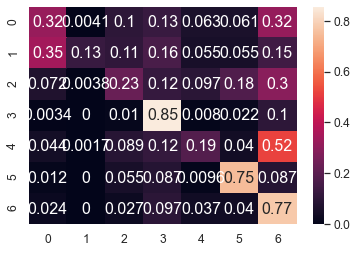

	training epoch=34 .. train_loss=1.005
	validation epoch=34 .. val_loss=1.243
	Accuracy = 54.2 % .. Percision = 54.50000000000001 % .. Recall = 46.300000000000004 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_34.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 35 .. loss = 1.097


  0%|                                                                                 | 1/1914 [00:01<50:00,  1.57s/it]

training @ epoch 35 .. loss = 0.89


  0%|                                                                                 | 2/1914 [00:03<48:58,  1.54s/it]

training @ epoch 35 .. loss = 1.187


  0%|▏                                                                                | 3/1914 [00:04<46:44,  1.47s/it]

training @ epoch 35 .. loss = 0.985


  0%|▏                                                                                | 4/1914 [00:05<45:31,  1.43s/it]

training @ epoch 35 .. loss = 1.54


  0%|▏                                                                                | 5/1914 [00:07<45:25,  1.43s/it]

training @ epoch 35 .. loss = 0.966


  0%|▎                                                                                | 6/1914 [00:08<44:35,  1.40s/it]

training @ epoch 35 .. loss = 0.975


  0%|▎                                                                                | 7/1914 [00:09<43:48,  1.38s/it]

training @ epoch 35 .. loss = 1.098


  0%|▎                                                                                | 8/1914 [00:11<43:21,  1.37s/it]

training @ epoch 35 .. loss = 0.98


  0%|▍                                                                                | 9/1914 [00:12<42:57,  1.35s/it]

training @ epoch 35 .. loss = 0.918


  1%|▍                                                                               | 10/1914 [00:13<42:27,  1.34s/it]

training @ epoch 35 .. loss = 0.566


  1%|▍                                                                               | 11/1914 [00:15<42:45,  1.35s/it]

training @ epoch 35 .. loss = 0.753


  1%|▌                                                                               | 12/1914 [00:16<42:14,  1.33s/it]

training @ epoch 35 .. loss = 1.386


  1%|▌                                                                               | 13/1914 [00:17<42:13,  1.33s/it]

training @ epoch 35 .. loss = 0.583


  1%|▌                                                                               | 14/1914 [00:19<42:07,  1.33s/it]

training @ epoch 35 .. loss = 1.313


  1%|▋                                                                               | 15/1914 [00:20<42:41,  1.35s/it]

training @ epoch 35 .. loss = 1.469


  1%|▋                                                                               | 16/1914 [00:21<43:06,  1.36s/it]

training @ epoch 35 .. loss = 1.642


  1%|▋                                                                               | 17/1914 [00:23<43:58,  1.39s/it]

training @ epoch 35 .. loss = 0.704


  1%|▊                                                                               | 18/1914 [00:24<43:07,  1.36s/it]

training @ epoch 35 .. loss = 0.802


  1%|▊                                                                               | 19/1914 [00:25<42:53,  1.36s/it]

training @ epoch 35 .. loss = 0.83


  1%|▊                                                                               | 20/1914 [00:27<43:13,  1.37s/it]

training @ epoch 35 .. loss = 0.547


  1%|▉                                                                               | 21/1914 [00:28<43:50,  1.39s/it]

training @ epoch 35 .. loss = 0.909


  1%|▉                                                                               | 22/1914 [00:30<43:45,  1.39s/it]

training @ epoch 35 .. loss = 1.154


  1%|▉                                                                               | 23/1914 [00:31<43:13,  1.37s/it]

training @ epoch 35 .. loss = 0.71


  1%|█                                                                               | 24/1914 [00:32<42:44,  1.36s/it]

training @ epoch 35 .. loss = 0.889


  1%|█                                                                               | 25/1914 [00:34<43:26,  1.38s/it]

training @ epoch 35 .. loss = 0.717


  1%|█                                                                               | 26/1914 [00:35<43:40,  1.39s/it]

training @ epoch 35 .. loss = 0.58


  1%|█▏                                                                              | 27/1914 [00:37<43:53,  1.40s/it]

training @ epoch 35 .. loss = 0.644


  1%|█▏                                                                              | 28/1914 [00:38<43:24,  1.38s/it]

training @ epoch 35 .. loss = 1.067


  2%|█▏                                                                              | 29/1914 [00:39<42:50,  1.36s/it]

training @ epoch 35 .. loss = 1.37


  2%|█▎                                                                              | 30/1914 [00:41<43:29,  1.39s/it]

training @ epoch 35 .. loss = 1.112


  2%|█▎                                                                              | 31/1914 [00:42<44:02,  1.40s/it]

training @ epoch 35 .. loss = 0.935


  2%|█▎                                                                              | 32/1914 [00:43<43:33,  1.39s/it]

training @ epoch 35 .. loss = 0.828


  2%|█▍                                                                              | 33/1914 [00:45<43:41,  1.39s/it]

training @ epoch 35 .. loss = 1.208


  2%|█▍                                                                              | 34/1914 [00:46<43:00,  1.37s/it]

training @ epoch 35 .. loss = 1.072


  2%|█▍                                                                              | 35/1914 [00:48<43:17,  1.38s/it]

training @ epoch 35 .. loss = 0.906


  2%|█▌                                                                              | 36/1914 [00:49<43:51,  1.40s/it]

training @ epoch 35 .. loss = 1.157


  2%|█▌                                                                              | 37/1914 [00:50<43:17,  1.38s/it]

training @ epoch 35 .. loss = 1.27


  2%|█▌                                                                              | 38/1914 [00:52<42:48,  1.37s/it]

training @ epoch 35 .. loss = 1.04


  2%|█▋                                                                              | 39/1914 [00:53<42:37,  1.36s/it]

training @ epoch 35 .. loss = 0.925


  2%|█▋                                                                              | 40/1914 [00:54<42:54,  1.37s/it]

training @ epoch 35 .. loss = 0.76


  2%|█▋                                                                              | 41/1914 [00:56<45:04,  1.44s/it]

training @ epoch 35 .. loss = 0.813


  2%|█▊                                                                              | 42/1914 [00:58<46:18,  1.48s/it]

training @ epoch 35 .. loss = 1.282


  2%|█▊                                                                              | 43/1914 [00:59<46:46,  1.50s/it]

training @ epoch 35 .. loss = 0.853


  2%|█▊                                                                              | 44/1914 [01:01<46:54,  1.51s/it]

training @ epoch 35 .. loss = 0.825


  2%|█▉                                                                              | 45/1914 [01:02<47:10,  1.51s/it]

training @ epoch 35 .. loss = 0.758


  2%|█▉                                                                              | 46/1914 [01:04<48:18,  1.55s/it]

training @ epoch 35 .. loss = 0.695


  2%|█▉                                                                              | 47/1914 [01:05<47:17,  1.52s/it]

training @ epoch 35 .. loss = 0.7


  3%|██                                                                              | 48/1914 [01:07<46:11,  1.49s/it]

training @ epoch 35 .. loss = 0.727


  3%|██                                                                              | 49/1914 [01:08<45:07,  1.45s/it]

training @ epoch 35 .. loss = 0.868


  3%|██                                                                              | 50/1914 [01:10<44:46,  1.44s/it]

training @ epoch 35 .. loss = 0.555


  3%|██▏                                                                             | 51/1914 [01:11<43:51,  1.41s/it]

training @ epoch 35 .. loss = 0.958


  3%|██▏                                                                             | 52/1914 [01:12<42:18,  1.36s/it]

training @ epoch 35 .. loss = 0.402


  3%|██▏                                                                             | 53/1914 [01:13<42:05,  1.36s/it]

training @ epoch 35 .. loss = 0.833


  3%|██▎                                                                             | 54/1914 [01:15<42:21,  1.37s/it]

training @ epoch 35 .. loss = 0.8


  3%|██▎                                                                             | 55/1914 [01:16<42:57,  1.39s/it]

training @ epoch 35 .. loss = 0.857


  3%|██▎                                                                             | 56/1914 [01:18<42:10,  1.36s/it]

training @ epoch 35 .. loss = 0.883


  3%|██▍                                                                             | 57/1914 [01:19<41:53,  1.35s/it]

training @ epoch 35 .. loss = 0.455


  3%|██▍                                                                             | 58/1914 [01:20<41:01,  1.33s/it]

training @ epoch 35 .. loss = 0.708


  3%|██▍                                                                             | 59/1914 [01:22<41:48,  1.35s/it]

training @ epoch 35 .. loss = 1.969


  3%|██▌                                                                             | 60/1914 [01:23<42:35,  1.38s/it]

training @ epoch 35 .. loss = 0.867


  3%|██▌                                                                             | 61/1914 [01:24<42:37,  1.38s/it]

training @ epoch 35 .. loss = 0.858


  3%|██▌                                                                             | 62/1914 [01:26<41:53,  1.36s/it]

training @ epoch 35 .. loss = 0.657


  3%|██▋                                                                             | 63/1914 [01:27<41:39,  1.35s/it]

training @ epoch 35 .. loss = 0.863


  3%|██▋                                                                             | 64/1914 [01:28<42:08,  1.37s/it]

training @ epoch 35 .. loss = 1.024


  3%|██▋                                                                             | 65/1914 [01:30<42:27,  1.38s/it]

training @ epoch 35 .. loss = 0.767


  3%|██▊                                                                             | 66/1914 [01:31<41:56,  1.36s/it]

training @ epoch 35 .. loss = 0.934


  4%|██▊                                                                             | 67/1914 [01:33<41:46,  1.36s/it]

training @ epoch 35 .. loss = 1.507


  4%|██▊                                                                             | 68/1914 [01:34<41:09,  1.34s/it]

training @ epoch 35 .. loss = 0.8


  4%|██▉                                                                             | 69/1914 [01:35<41:45,  1.36s/it]

training @ epoch 35 .. loss = 0.977


  4%|██▉                                                                             | 70/1914 [01:37<42:50,  1.39s/it]

training @ epoch 35 .. loss = 1.138


  4%|██▉                                                                             | 71/1914 [01:38<41:41,  1.36s/it]

training @ epoch 35 .. loss = 1.321


  4%|███                                                                             | 72/1914 [01:39<41:20,  1.35s/it]

training @ epoch 35 .. loss = 1.626


  4%|███                                                                             | 73/1914 [01:41<41:06,  1.34s/it]

training @ epoch 35 .. loss = 1.578


  4%|███                                                                             | 74/1914 [01:42<41:56,  1.37s/it]

training @ epoch 35 .. loss = 0.933


  4%|███▏                                                                            | 75/1914 [01:43<42:11,  1.38s/it]

training @ epoch 35 .. loss = 0.886


  4%|███▏                                                                            | 76/1914 [01:45<41:18,  1.35s/it]

training @ epoch 35 .. loss = 1.019


  4%|███▏                                                                            | 77/1914 [01:46<40:52,  1.33s/it]

training @ epoch 35 .. loss = 0.913


  4%|███▎                                                                            | 78/1914 [01:47<41:01,  1.34s/it]

training @ epoch 35 .. loss = 0.853


  4%|███▎                                                                            | 79/1914 [01:49<41:47,  1.37s/it]

training @ epoch 35 .. loss = 0.822


  4%|███▎                                                                            | 80/1914 [01:50<41:38,  1.36s/it]

training @ epoch 35 .. loss = 0.712


  4%|███▍                                                                            | 81/1914 [01:52<41:09,  1.35s/it]

training @ epoch 35 .. loss = 1.111


  4%|███▍                                                                            | 82/1914 [01:53<40:56,  1.34s/it]

training @ epoch 35 .. loss = 0.54


  4%|███▍                                                                            | 83/1914 [01:54<41:07,  1.35s/it]

training @ epoch 35 .. loss = 0.845


  4%|███▌                                                                            | 84/1914 [01:56<41:54,  1.37s/it]

training @ epoch 35 .. loss = 0.751


  4%|███▌                                                                            | 85/1914 [01:57<41:47,  1.37s/it]

training @ epoch 35 .. loss = 0.733


  4%|███▌                                                                            | 86/1914 [01:58<41:25,  1.36s/it]

training @ epoch 35 .. loss = 1.547


  5%|███▋                                                                            | 87/1914 [02:00<40:31,  1.33s/it]

training @ epoch 35 .. loss = 1.44


  5%|███▋                                                                            | 88/1914 [02:01<40:52,  1.34s/it]

training @ epoch 35 .. loss = 0.673


  5%|███▋                                                                            | 89/1914 [02:02<41:42,  1.37s/it]

training @ epoch 35 .. loss = 0.91


  5%|███▊                                                                            | 90/1914 [02:04<41:11,  1.35s/it]

training @ epoch 35 .. loss = 1.083


  5%|███▊                                                                            | 91/1914 [02:05<40:52,  1.35s/it]

training @ epoch 35 .. loss = 0.789


  5%|███▊                                                                            | 92/1914 [02:06<40:50,  1.34s/it]

training @ epoch 35 .. loss = 0.647


  5%|███▉                                                                            | 93/1914 [02:08<40:54,  1.35s/it]

training @ epoch 35 .. loss = 0.69


  5%|███▉                                                                            | 94/1914 [02:09<41:41,  1.37s/it]

training @ epoch 35 .. loss = 1.378


  5%|███▉                                                                            | 95/1914 [02:11<41:17,  1.36s/it]

training @ epoch 35 .. loss = 1.084


  5%|████                                                                            | 96/1914 [02:12<40:39,  1.34s/it]

training @ epoch 35 .. loss = 0.914


  5%|████                                                                            | 97/1914 [02:13<40:10,  1.33s/it]

training @ epoch 35 .. loss = 1.143


  5%|████                                                                            | 98/1914 [02:14<40:50,  1.35s/it]

training @ epoch 35 .. loss = 1.036


  5%|████▏                                                                           | 99/1914 [02:16<41:27,  1.37s/it]

training @ epoch 35 .. loss = 0.699


  5%|████▏                                                                          | 100/1914 [02:17<41:50,  1.38s/it]

training @ epoch 35 .. loss = 0.576


  5%|████▏                                                                          | 101/1914 [02:19<41:10,  1.36s/it]

training @ epoch 35 .. loss = 1.332


  5%|████▏                                                                          | 102/1914 [02:20<40:14,  1.33s/it]

training @ epoch 35 .. loss = 0.883


  5%|████▎                                                                          | 103/1914 [02:21<41:31,  1.38s/it]

training @ epoch 35 .. loss = 1.014


  5%|████▎                                                                          | 104/1914 [02:23<42:19,  1.40s/it]

training @ epoch 35 .. loss = 0.882


  5%|████▎                                                                          | 105/1914 [02:24<43:08,  1.43s/it]

training @ epoch 35 .. loss = 0.966


  6%|████▍                                                                          | 106/1914 [02:26<41:56,  1.39s/it]

training @ epoch 35 .. loss = 0.87


  6%|████▍                                                                          | 107/1914 [02:27<41:35,  1.38s/it]

training @ epoch 35 .. loss = 0.894


  6%|████▍                                                                          | 108/1914 [02:28<42:03,  1.40s/it]

training @ epoch 35 .. loss = 0.912


  6%|████▍                                                                          | 109/1914 [02:30<41:45,  1.39s/it]

training @ epoch 35 .. loss = 1.054


  6%|████▌                                                                          | 110/1914 [02:31<41:03,  1.37s/it]

training @ epoch 35 .. loss = 1.202


  6%|████▌                                                                          | 111/1914 [02:32<40:39,  1.35s/it]

training @ epoch 35 .. loss = 0.555


  6%|████▌                                                                          | 112/1914 [02:34<40:17,  1.34s/it]

training @ epoch 35 .. loss = 0.927


  6%|████▋                                                                          | 113/1914 [02:35<41:06,  1.37s/it]

training @ epoch 35 .. loss = 1.108


  6%|████▋                                                                          | 114/1914 [02:37<42:29,  1.42s/it]

training @ epoch 35 .. loss = 0.693


  6%|████▋                                                                          | 115/1914 [02:38<41:26,  1.38s/it]

training @ epoch 35 .. loss = 0.772


  6%|████▊                                                                          | 116/1914 [02:39<40:33,  1.35s/it]

training @ epoch 35 .. loss = 1.304


  6%|████▊                                                                          | 117/1914 [02:41<40:21,  1.35s/it]

training @ epoch 35 .. loss = 1.678


  6%|████▊                                                                          | 118/1914 [02:42<41:29,  1.39s/it]

training @ epoch 35 .. loss = 0.837


  6%|████▉                                                                          | 119/1914 [02:43<41:27,  1.39s/it]

training @ epoch 35 .. loss = 1.03


  6%|████▉                                                                          | 120/1914 [02:45<40:41,  1.36s/it]

training @ epoch 35 .. loss = 0.702


  6%|████▉                                                                          | 121/1914 [02:46<40:31,  1.36s/it]

training @ epoch 35 .. loss = 2.248


  6%|█████                                                                          | 122/1914 [02:47<40:07,  1.34s/it]

training @ epoch 35 .. loss = 1.325


  6%|█████                                                                          | 123/1914 [02:49<41:23,  1.39s/it]

training @ epoch 35 .. loss = 0.976


  6%|█████                                                                          | 124/1914 [02:50<41:04,  1.38s/it]

training @ epoch 35 .. loss = 1.644


  7%|█████▏                                                                         | 125/1914 [02:52<40:02,  1.34s/it]

training @ epoch 35 .. loss = 1.211


  7%|█████▏                                                                         | 126/1914 [02:53<40:16,  1.35s/it]

training @ epoch 35 .. loss = 1.5


  7%|█████▏                                                                         | 127/1914 [02:54<40:39,  1.37s/it]

training @ epoch 35 .. loss = 0.741


  7%|█████▎                                                                         | 128/1914 [02:56<40:59,  1.38s/it]

training @ epoch 35 .. loss = 0.95


  7%|█████▎                                                                         | 129/1914 [02:57<41:02,  1.38s/it]

training @ epoch 35 .. loss = 0.87


  7%|█████▎                                                                         | 130/1914 [02:58<40:25,  1.36s/it]

training @ epoch 35 .. loss = 0.735


  7%|█████▍                                                                         | 131/1914 [03:00<40:03,  1.35s/it]

training @ epoch 35 .. loss = 0.841


  7%|█████▍                                                                         | 132/1914 [03:01<40:50,  1.38s/it]

training @ epoch 35 .. loss = 0.759


  7%|█████▍                                                                         | 133/1914 [03:03<42:04,  1.42s/it]

training @ epoch 35 .. loss = 1.116


  7%|█████▌                                                                         | 134/1914 [03:04<41:21,  1.39s/it]

training @ epoch 35 .. loss = 1.235


  7%|█████▌                                                                         | 135/1914 [03:05<40:27,  1.36s/it]

training @ epoch 35 .. loss = 1.329


  7%|█████▌                                                                         | 136/1914 [03:07<40:15,  1.36s/it]

training @ epoch 35 .. loss = 1.23


  7%|█████▋                                                                         | 137/1914 [03:08<40:33,  1.37s/it]

training @ epoch 35 .. loss = 0.776


  7%|█████▋                                                                         | 138/1914 [03:09<40:41,  1.37s/it]

training @ epoch 35 .. loss = 1.018


  7%|█████▋                                                                         | 139/1914 [03:11<40:23,  1.37s/it]

training @ epoch 35 .. loss = 1.013


  7%|█████▊                                                                         | 140/1914 [03:12<40:31,  1.37s/it]

training @ epoch 35 .. loss = 0.839


  7%|█████▊                                                                         | 141/1914 [03:14<41:36,  1.41s/it]

training @ epoch 35 .. loss = 1.101


  7%|█████▊                                                                         | 142/1914 [03:15<43:00,  1.46s/it]

training @ epoch 35 .. loss = 0.874


  7%|█████▉                                                                         | 143/1914 [03:17<44:00,  1.49s/it]

training @ epoch 35 .. loss = 1.426


  8%|█████▉                                                                         | 144/1914 [03:18<44:28,  1.51s/it]

training @ epoch 35 .. loss = 1.097


  8%|█████▉                                                                         | 145/1914 [03:20<44:47,  1.52s/it]

training @ epoch 35 .. loss = 1.261


  8%|██████                                                                         | 146/1914 [03:21<43:51,  1.49s/it]

training @ epoch 35 .. loss = 0.82


  8%|██████                                                                         | 147/1914 [03:23<43:26,  1.48s/it]

training @ epoch 35 .. loss = 0.954


  8%|██████                                                                         | 148/1914 [03:24<43:47,  1.49s/it]

training @ epoch 35 .. loss = 1.113


  8%|██████▏                                                                        | 149/1914 [03:26<44:17,  1.51s/it]

training @ epoch 35 .. loss = 1.384


  8%|██████▏                                                                        | 150/1914 [03:27<44:53,  1.53s/it]

training @ epoch 35 .. loss = 1.165


  8%|██████▏                                                                        | 151/1914 [03:29<44:46,  1.52s/it]

training @ epoch 35 .. loss = 0.729


  8%|██████▎                                                                        | 152/1914 [03:30<44:41,  1.52s/it]

training @ epoch 35 .. loss = 0.813


  8%|██████▎                                                                        | 153/1914 [03:32<44:56,  1.53s/it]

training @ epoch 35 .. loss = 1.486


  8%|██████▎                                                                        | 154/1914 [03:34<45:03,  1.54s/it]

training @ epoch 35 .. loss = 1.058


  8%|██████▍                                                                        | 155/1914 [03:35<45:37,  1.56s/it]

training @ epoch 35 .. loss = 1.273


  8%|██████▍                                                                        | 156/1914 [03:37<45:03,  1.54s/it]

training @ epoch 35 .. loss = 0.581


  8%|██████▍                                                                        | 157/1914 [03:38<42:52,  1.46s/it]

training @ epoch 35 .. loss = 1.216


  8%|██████▌                                                                        | 158/1914 [03:39<41:01,  1.40s/it]

training @ epoch 35 .. loss = 1.056


  8%|██████▌                                                                        | 159/1914 [03:41<40:56,  1.40s/it]

training @ epoch 35 .. loss = 0.964


  8%|██████▌                                                                        | 160/1914 [03:42<41:13,  1.41s/it]

training @ epoch 35 .. loss = 0.908


  8%|██████▋                                                                        | 161/1914 [03:43<40:48,  1.40s/it]

training @ epoch 35 .. loss = 1.018


  8%|██████▋                                                                        | 162/1914 [03:45<39:57,  1.37s/it]

training @ epoch 35 .. loss = 0.949


  9%|██████▋                                                                        | 163/1914 [03:46<39:12,  1.34s/it]

training @ epoch 35 .. loss = 0.823


  9%|██████▊                                                                        | 164/1914 [03:47<39:47,  1.36s/it]

training @ epoch 35 .. loss = 0.835


  9%|██████▊                                                                        | 165/1914 [03:49<40:19,  1.38s/it]

training @ epoch 35 .. loss = 0.619


  9%|██████▊                                                                        | 166/1914 [03:50<40:13,  1.38s/it]

training @ epoch 35 .. loss = 0.816


  9%|██████▉                                                                        | 167/1914 [03:51<39:05,  1.34s/it]

training @ epoch 35 .. loss = 0.975


  9%|██████▉                                                                        | 168/1914 [03:53<38:42,  1.33s/it]

training @ epoch 35 .. loss = 0.941


  9%|██████▉                                                                        | 169/1914 [03:54<38:53,  1.34s/it]

training @ epoch 35 .. loss = 1.781


  9%|███████                                                                        | 170/1914 [03:55<38:51,  1.34s/it]

training @ epoch 35 .. loss = 1.11


  9%|███████                                                                        | 171/1914 [03:57<38:38,  1.33s/it]

training @ epoch 35 .. loss = 0.996


  9%|███████                                                                        | 172/1914 [03:58<38:32,  1.33s/it]

training @ epoch 35 .. loss = 0.576


  9%|███████▏                                                                       | 173/1914 [03:59<38:20,  1.32s/it]

training @ epoch 35 .. loss = 1.047


  9%|███████▏                                                                       | 174/1914 [04:01<38:30,  1.33s/it]

training @ epoch 35 .. loss = 1.022


  9%|███████▏                                                                       | 175/1914 [04:02<39:19,  1.36s/it]

training @ epoch 35 .. loss = 1.007


  9%|███████▎                                                                       | 176/1914 [04:03<38:28,  1.33s/it]

training @ epoch 35 .. loss = 0.73


  9%|███████▎                                                                       | 177/1914 [04:05<38:57,  1.35s/it]

training @ epoch 35 .. loss = 1.105


  9%|███████▎                                                                       | 178/1914 [04:06<38:18,  1.32s/it]

training @ epoch 35 .. loss = 0.811


  9%|███████▍                                                                       | 179/1914 [04:07<38:00,  1.31s/it]

training @ epoch 35 .. loss = 0.863


  9%|███████▍                                                                       | 180/1914 [04:09<37:59,  1.31s/it]

training @ epoch 35 .. loss = 0.494


  9%|███████▍                                                                       | 181/1914 [04:10<38:32,  1.33s/it]

training @ epoch 35 .. loss = 0.842


 10%|███████▌                                                                       | 182/1914 [04:11<38:21,  1.33s/it]

training @ epoch 35 .. loss = 1.142


 10%|███████▌                                                                       | 183/1914 [04:13<38:17,  1.33s/it]

training @ epoch 35 .. loss = 1.388


 10%|███████▌                                                                       | 184/1914 [04:14<37:58,  1.32s/it]

training @ epoch 35 .. loss = 0.977


 10%|███████▋                                                                       | 185/1914 [04:15<38:01,  1.32s/it]

training @ epoch 35 .. loss = 0.628


 10%|███████▋                                                                       | 186/1914 [04:17<38:32,  1.34s/it]

training @ epoch 35 .. loss = 0.964


 10%|███████▋                                                                       | 187/1914 [04:18<38:09,  1.33s/it]

training @ epoch 35 .. loss = 1.124


 10%|███████▊                                                                       | 188/1914 [04:19<37:51,  1.32s/it]

training @ epoch 35 .. loss = 1.019


 10%|███████▊                                                                       | 189/1914 [04:21<38:09,  1.33s/it]

training @ epoch 35 .. loss = 1.039


 10%|███████▊                                                                       | 190/1914 [04:22<37:50,  1.32s/it]

training @ epoch 35 .. loss = 0.865


 10%|███████▉                                                                       | 191/1914 [04:23<37:47,  1.32s/it]

training @ epoch 35 .. loss = 0.612


 10%|███████▉                                                                       | 192/1914 [04:25<38:00,  1.32s/it]

training @ epoch 35 .. loss = 1.003


 10%|███████▉                                                                       | 193/1914 [04:26<37:36,  1.31s/it]

training @ epoch 35 .. loss = 0.95


 10%|████████                                                                       | 194/1914 [04:27<38:14,  1.33s/it]

training @ epoch 35 .. loss = 0.748


 10%|████████                                                                       | 195/1914 [04:29<37:31,  1.31s/it]

training @ epoch 35 .. loss = 0.632


 10%|████████                                                                       | 196/1914 [04:30<38:03,  1.33s/it]

training @ epoch 35 .. loss = 1.164


 10%|████████▏                                                                      | 197/1914 [04:31<37:33,  1.31s/it]

training @ epoch 35 .. loss = 0.917


 10%|████████▏                                                                      | 198/1914 [04:32<37:26,  1.31s/it]

training @ epoch 35 .. loss = 0.829


 10%|████████▏                                                                      | 199/1914 [04:34<37:33,  1.31s/it]

training @ epoch 35 .. loss = 0.78


 10%|████████▎                                                                      | 200/1914 [04:35<37:36,  1.32s/it]

training @ epoch 35 .. loss = 1.034


 11%|████████▎                                                                      | 201/1914 [04:36<37:28,  1.31s/it]

training @ epoch 35 .. loss = 0.846


 11%|████████▎                                                                      | 202/1914 [04:38<37:32,  1.32s/it]

training @ epoch 35 .. loss = 1.604


 11%|████████▍                                                                      | 203/1914 [04:39<37:41,  1.32s/it]

training @ epoch 35 .. loss = 1.331


 11%|████████▍                                                                      | 204/1914 [04:40<37:40,  1.32s/it]

training @ epoch 35 .. loss = 0.866


 11%|████████▍                                                                      | 205/1914 [04:42<38:03,  1.34s/it]

training @ epoch 35 .. loss = 1.154


 11%|████████▌                                                                      | 206/1914 [04:43<38:50,  1.36s/it]

training @ epoch 35 .. loss = 1.125


 11%|████████▌                                                                      | 207/1914 [04:45<39:41,  1.39s/it]

training @ epoch 35 .. loss = 0.881


 11%|████████▌                                                                      | 208/1914 [04:46<38:32,  1.36s/it]

training @ epoch 35 .. loss = 0.552


 11%|████████▋                                                                      | 209/1914 [04:47<38:24,  1.35s/it]

training @ epoch 35 .. loss = 0.767


 11%|████████▋                                                                      | 210/1914 [04:49<38:14,  1.35s/it]

training @ epoch 35 .. loss = 0.825


 11%|████████▋                                                                      | 211/1914 [04:50<38:48,  1.37s/it]

training @ epoch 35 .. loss = 1.057


 11%|████████▊                                                                      | 212/1914 [04:51<39:00,  1.37s/it]

training @ epoch 35 .. loss = 0.795


 11%|████████▊                                                                      | 213/1914 [04:53<38:17,  1.35s/it]

training @ epoch 35 .. loss = 0.704


 11%|████████▊                                                                      | 214/1914 [04:54<37:57,  1.34s/it]

training @ epoch 35 .. loss = 0.785


 11%|████████▊                                                                      | 215/1914 [04:55<38:09,  1.35s/it]

training @ epoch 35 .. loss = 0.73


 11%|████████▉                                                                      | 216/1914 [04:57<39:03,  1.38s/it]

training @ epoch 35 .. loss = 1.142


 11%|████████▉                                                                      | 217/1914 [04:58<39:29,  1.40s/it]

training @ epoch 35 .. loss = 1.141


 11%|████████▉                                                                      | 218/1914 [05:00<38:20,  1.36s/it]

training @ epoch 35 .. loss = 1.521


 11%|█████████                                                                      | 219/1914 [05:01<38:02,  1.35s/it]

training @ epoch 35 .. loss = 1.096


 11%|█████████                                                                      | 220/1914 [05:02<38:18,  1.36s/it]

training @ epoch 35 .. loss = 0.879


 12%|█████████                                                                      | 221/1914 [05:04<38:33,  1.37s/it]

training @ epoch 35 .. loss = 1.154


 12%|█████████▏                                                                     | 222/1914 [05:05<38:31,  1.37s/it]

training @ epoch 35 .. loss = 0.969


 12%|█████████▏                                                                     | 223/1914 [05:06<38:13,  1.36s/it]

training @ epoch 35 .. loss = 0.663


 12%|█████████▏                                                                     | 224/1914 [05:08<38:00,  1.35s/it]

training @ epoch 35 .. loss = 1.11


 12%|█████████▎                                                                     | 225/1914 [05:09<38:41,  1.37s/it]

training @ epoch 35 .. loss = 0.73


 12%|█████████▎                                                                     | 226/1914 [05:11<39:11,  1.39s/it]

training @ epoch 35 .. loss = 0.73


 12%|█████████▎                                                                     | 227/1914 [05:12<38:34,  1.37s/it]

training @ epoch 35 .. loss = 0.761


 12%|█████████▍                                                                     | 228/1914 [05:13<38:02,  1.35s/it]

training @ epoch 35 .. loss = 1.142


 12%|█████████▍                                                                     | 229/1914 [05:14<37:22,  1.33s/it]

training @ epoch 35 .. loss = 0.787


 12%|█████████▍                                                                     | 230/1914 [05:16<37:53,  1.35s/it]

training @ epoch 35 .. loss = 1.315


 12%|█████████▌                                                                     | 231/1914 [05:17<38:14,  1.36s/it]

training @ epoch 35 .. loss = 0.92


 12%|█████████▌                                                                     | 232/1914 [05:19<38:19,  1.37s/it]

training @ epoch 35 .. loss = 1.268


 12%|█████████▌                                                                     | 233/1914 [05:20<37:40,  1.34s/it]

training @ epoch 35 .. loss = 0.939


 12%|█████████▋                                                                     | 234/1914 [05:21<37:23,  1.34s/it]

training @ epoch 35 .. loss = 0.473


 12%|█████████▋                                                                     | 235/1914 [05:23<38:03,  1.36s/it]

training @ epoch 35 .. loss = 1.079


 12%|█████████▋                                                                     | 236/1914 [05:24<38:19,  1.37s/it]

training @ epoch 35 .. loss = 0.684


 12%|█████████▊                                                                     | 237/1914 [05:25<38:01,  1.36s/it]

training @ epoch 35 .. loss = 1.202


 12%|█████████▊                                                                     | 238/1914 [05:27<37:41,  1.35s/it]

training @ epoch 35 .. loss = 1.393


 12%|█████████▊                                                                     | 239/1914 [05:28<37:28,  1.34s/it]

training @ epoch 35 .. loss = 1.079


 13%|█████████▉                                                                     | 240/1914 [05:29<37:58,  1.36s/it]

training @ epoch 35 .. loss = 0.915


 13%|█████████▉                                                                     | 241/1914 [05:31<38:39,  1.39s/it]

training @ epoch 35 .. loss = 1.141


 13%|█████████▉                                                                     | 242/1914 [05:32<37:41,  1.35s/it]

training @ epoch 35 .. loss = 0.877


 13%|██████████                                                                     | 243/1914 [05:33<36:55,  1.33s/it]

training @ epoch 35 .. loss = 1.07


 13%|██████████                                                                     | 244/1914 [05:35<37:33,  1.35s/it]

training @ epoch 35 .. loss = 1.095


 13%|██████████                                                                     | 245/1914 [05:36<37:55,  1.36s/it]

training @ epoch 35 .. loss = 0.895


 13%|██████████▏                                                                    | 246/1914 [05:38<38:30,  1.39s/it]

training @ epoch 35 .. loss = 1.204


 13%|██████████▏                                                                    | 247/1914 [05:39<38:02,  1.37s/it]

training @ epoch 35 .. loss = 0.924


 13%|██████████▏                                                                    | 248/1914 [05:40<37:29,  1.35s/it]

training @ epoch 35 .. loss = 0.73


 13%|██████████▎                                                                    | 249/1914 [05:42<37:39,  1.36s/it]

training @ epoch 35 .. loss = 0.789


 13%|██████████▎                                                                    | 250/1914 [05:43<38:12,  1.38s/it]

training @ epoch 35 .. loss = 1.04


 13%|██████████▎                                                                    | 251/1914 [05:44<38:13,  1.38s/it]

training @ epoch 35 .. loss = 1.581


 13%|██████████▍                                                                    | 252/1914 [05:46<37:00,  1.34s/it]

training @ epoch 35 .. loss = 0.98


 13%|██████████▍                                                                    | 253/1914 [05:47<36:56,  1.33s/it]

training @ epoch 35 .. loss = 0.786


 13%|██████████▍                                                                    | 254/1914 [05:48<37:16,  1.35s/it]

training @ epoch 35 .. loss = 1.492


 13%|██████████▌                                                                    | 255/1914 [05:50<37:32,  1.36s/it]

training @ epoch 35 .. loss = 0.632


 13%|██████████▌                                                                    | 256/1914 [05:51<37:55,  1.37s/it]

training @ epoch 35 .. loss = 0.688


 13%|██████████▌                                                                    | 257/1914 [05:53<38:01,  1.38s/it]

training @ epoch 35 .. loss = 1.681


 13%|██████████▋                                                                    | 258/1914 [05:54<38:24,  1.39s/it]

training @ epoch 35 .. loss = 0.904


 14%|██████████▋                                                                    | 259/1914 [05:55<37:38,  1.36s/it]

training @ epoch 35 .. loss = 1.179


 14%|██████████▋                                                                    | 260/1914 [05:57<36:47,  1.33s/it]

training @ epoch 35 .. loss = 0.89


 14%|██████████▊                                                                    | 261/1914 [05:58<37:16,  1.35s/it]

training @ epoch 35 .. loss = 0.815


 14%|██████████▊                                                                    | 262/1914 [05:59<38:20,  1.39s/it]

training @ epoch 35 .. loss = 1.05


 14%|██████████▊                                                                    | 263/1914 [06:01<38:05,  1.38s/it]

training @ epoch 35 .. loss = 1.105


 14%|██████████▉                                                                    | 264/1914 [06:02<37:39,  1.37s/it]

training @ epoch 35 .. loss = 1.254


 14%|██████████▉                                                                    | 265/1914 [06:03<36:55,  1.34s/it]

training @ epoch 35 .. loss = 1.303


 14%|██████████▉                                                                    | 266/1914 [06:05<37:24,  1.36s/it]

training @ epoch 35 .. loss = 0.868


 14%|███████████                                                                    | 267/1914 [06:06<37:45,  1.38s/it]

training @ epoch 35 .. loss = 0.98


 14%|███████████                                                                    | 268/1914 [06:08<37:42,  1.37s/it]

training @ epoch 35 .. loss = 0.935


 14%|███████████                                                                    | 269/1914 [06:09<37:12,  1.36s/it]

training @ epoch 35 .. loss = 0.804


 14%|███████████▏                                                                   | 270/1914 [06:10<36:44,  1.34s/it]

training @ epoch 35 .. loss = 1.557


 14%|███████████▏                                                                   | 271/1914 [06:12<36:59,  1.35s/it]

training @ epoch 35 .. loss = 1.223


 14%|███████████▏                                                                   | 272/1914 [06:13<37:40,  1.38s/it]

training @ epoch 35 .. loss = 0.841


 14%|███████████▎                                                                   | 273/1914 [06:14<37:38,  1.38s/it]

training @ epoch 35 .. loss = 0.77


 14%|███████████▎                                                                   | 274/1914 [06:16<36:41,  1.34s/it]

training @ epoch 35 .. loss = 1.012


 14%|███████████▎                                                                   | 275/1914 [06:17<36:35,  1.34s/it]

training @ epoch 35 .. loss = 1.191


 14%|███████████▍                                                                   | 276/1914 [06:18<37:06,  1.36s/it]

training @ epoch 35 .. loss = 0.972


 14%|███████████▍                                                                   | 277/1914 [06:20<37:27,  1.37s/it]

training @ epoch 35 .. loss = 0.997


 15%|███████████▍                                                                   | 278/1914 [06:21<37:16,  1.37s/it]

training @ epoch 35 .. loss = 1.27


 15%|███████████▌                                                                   | 279/1914 [06:23<37:32,  1.38s/it]

training @ epoch 35 .. loss = 1.194


 15%|███████████▌                                                                   | 280/1914 [06:24<37:14,  1.37s/it]

training @ epoch 35 .. loss = 1.203


 15%|███████████▌                                                                   | 281/1914 [06:25<37:37,  1.38s/it]

training @ epoch 35 .. loss = 0.968


 15%|███████████▋                                                                   | 282/1914 [06:27<38:12,  1.40s/it]

training @ epoch 35 .. loss = 1.06


 15%|███████████▋                                                                   | 283/1914 [06:28<36:59,  1.36s/it]

training @ epoch 35 .. loss = 1.362


 15%|███████████▋                                                                   | 284/1914 [06:29<36:33,  1.35s/it]

training @ epoch 35 .. loss = 0.913


 15%|███████████▊                                                                   | 285/1914 [06:31<36:12,  1.33s/it]

training @ epoch 35 .. loss = 0.857


 15%|███████████▊                                                                   | 286/1914 [06:32<36:11,  1.33s/it]

training @ epoch 35 .. loss = 0.999


 15%|███████████▊                                                                   | 287/1914 [06:33<36:12,  1.34s/it]

training @ epoch 35 .. loss = 1.072


 15%|███████████▉                                                                   | 288/1914 [06:35<35:56,  1.33s/it]

training @ epoch 35 .. loss = 0.821


 15%|███████████▉                                                                   | 289/1914 [06:36<35:48,  1.32s/it]

training @ epoch 35 .. loss = 0.881


 15%|███████████▉                                                                   | 290/1914 [06:37<35:43,  1.32s/it]

training @ epoch 35 .. loss = 0.663


 15%|████████████                                                                   | 291/1914 [06:39<35:34,  1.32s/it]

training @ epoch 35 .. loss = 0.933


 15%|████████████                                                                   | 292/1914 [06:40<35:57,  1.33s/it]

training @ epoch 35 .. loss = 0.987


 15%|████████████                                                                   | 293/1914 [06:41<35:52,  1.33s/it]

training @ epoch 35 .. loss = 1.233


 15%|████████████▏                                                                  | 294/1914 [06:43<35:54,  1.33s/it]

training @ epoch 35 .. loss = 0.965


 15%|████████████▏                                                                  | 295/1914 [06:44<35:29,  1.32s/it]

training @ epoch 35 .. loss = 0.893


 15%|████████████▏                                                                  | 296/1914 [06:45<35:37,  1.32s/it]

training @ epoch 35 .. loss = 0.998


 16%|████████████▎                                                                  | 297/1914 [06:47<35:37,  1.32s/it]

training @ epoch 35 .. loss = 1.798


 16%|████████████▎                                                                  | 298/1914 [06:48<35:16,  1.31s/it]

training @ epoch 35 .. loss = 0.862


 16%|████████████▎                                                                  | 299/1914 [06:49<35:32,  1.32s/it]

training @ epoch 35 .. loss = 1.197


 16%|████████████▍                                                                  | 300/1914 [06:51<35:32,  1.32s/it]

training @ epoch 35 .. loss = 1.088


 16%|████████████▍                                                                  | 301/1914 [06:52<35:13,  1.31s/it]

training @ epoch 35 .. loss = 0.807


 16%|████████████▍                                                                  | 302/1914 [06:53<35:33,  1.32s/it]

training @ epoch 35 .. loss = 1.159


 16%|████████████▌                                                                  | 303/1914 [06:54<35:37,  1.33s/it]

training @ epoch 35 .. loss = 0.994


 16%|████████████▌                                                                  | 304/1914 [06:56<35:00,  1.30s/it]

training @ epoch 35 .. loss = 0.984


 16%|████████████▌                                                                  | 305/1914 [06:57<35:07,  1.31s/it]

training @ epoch 35 .. loss = 0.751


 16%|████████████▋                                                                  | 306/1914 [06:58<35:17,  1.32s/it]

training @ epoch 35 .. loss = 0.897


 16%|████████████▋                                                                  | 307/1914 [07:00<35:48,  1.34s/it]

training @ epoch 35 .. loss = 0.953


 16%|████████████▋                                                                  | 308/1914 [07:01<36:16,  1.36s/it]

training @ epoch 35 .. loss = 0.695


 16%|████████████▊                                                                  | 309/1914 [07:03<37:07,  1.39s/it]

training @ epoch 35 .. loss = 0.717


 16%|████████████▊                                                                  | 310/1914 [07:04<36:17,  1.36s/it]

training @ epoch 35 .. loss = 0.905


 16%|████████████▊                                                                  | 311/1914 [07:05<35:59,  1.35s/it]

training @ epoch 35 .. loss = 0.779


 16%|████████████▉                                                                  | 312/1914 [07:07<35:47,  1.34s/it]

training @ epoch 35 .. loss = 0.787


 16%|████████████▉                                                                  | 313/1914 [07:08<36:27,  1.37s/it]

training @ epoch 35 .. loss = 0.737


 16%|████████████▉                                                                  | 314/1914 [07:09<36:38,  1.37s/it]

training @ epoch 35 .. loss = 0.789


 16%|█████████████                                                                  | 315/1914 [07:11<36:03,  1.35s/it]

training @ epoch 35 .. loss = 0.892


 17%|█████████████                                                                  | 316/1914 [07:12<35:39,  1.34s/it]

training @ epoch 35 .. loss = 0.704


 17%|█████████████                                                                  | 317/1914 [07:13<35:40,  1.34s/it]

training @ epoch 35 .. loss = 0.979


 17%|█████████████▏                                                                 | 318/1914 [07:15<36:29,  1.37s/it]

training @ epoch 35 .. loss = 0.933


 17%|█████████████▏                                                                 | 319/1914 [07:16<36:09,  1.36s/it]

training @ epoch 35 .. loss = 1.233


 17%|█████████████▏                                                                 | 320/1914 [07:17<35:55,  1.35s/it]

training @ epoch 35 .. loss = 0.977


 17%|█████████████▏                                                                 | 321/1914 [07:19<35:45,  1.35s/it]

training @ epoch 35 .. loss = 0.905


 17%|█████████████▎                                                                 | 322/1914 [07:20<36:16,  1.37s/it]

training @ epoch 35 .. loss = 0.799


 17%|█████████████▎                                                                 | 323/1914 [07:22<36:32,  1.38s/it]

training @ epoch 35 .. loss = 0.446


 17%|█████████████▎                                                                 | 324/1914 [07:23<36:20,  1.37s/it]

training @ epoch 35 .. loss = 0.702


 17%|█████████████▍                                                                 | 325/1914 [07:24<36:30,  1.38s/it]

training @ epoch 35 .. loss = 1.186


 17%|█████████████▍                                                                 | 326/1914 [07:26<35:20,  1.34s/it]

training @ epoch 35 .. loss = 0.552


 17%|█████████████▍                                                                 | 327/1914 [07:27<36:25,  1.38s/it]

training @ epoch 35 .. loss = 1.172


 17%|█████████████▌                                                                 | 328/1914 [07:28<36:42,  1.39s/it]

training @ epoch 35 .. loss = 1.007


 17%|█████████████▌                                                                 | 329/1914 [07:30<36:00,  1.36s/it]

training @ epoch 35 .. loss = 0.816


 17%|█████████████▌                                                                 | 330/1914 [07:31<35:21,  1.34s/it]

training @ epoch 35 .. loss = 0.906


 17%|█████████████▋                                                                 | 331/1914 [07:32<35:34,  1.35s/it]

training @ epoch 35 .. loss = 0.835


 17%|█████████████▋                                                                 | 332/1914 [07:34<35:43,  1.35s/it]

training @ epoch 35 .. loss = 1.426


 17%|█████████████▋                                                                 | 333/1914 [07:35<36:29,  1.38s/it]

training @ epoch 35 .. loss = 0.969


 17%|█████████████▊                                                                 | 334/1914 [07:37<35:40,  1.35s/it]

training @ epoch 35 .. loss = 0.801


 18%|█████████████▊                                                                 | 335/1914 [07:38<36:45,  1.40s/it]

training @ epoch 35 .. loss = 1.051


 18%|█████████████▊                                                                 | 336/1914 [07:39<37:01,  1.41s/it]

training @ epoch 35 .. loss = 0.973


 18%|█████████████▉                                                                 | 337/1914 [07:41<37:28,  1.43s/it]

training @ epoch 35 .. loss = 1.151


 18%|█████████████▉                                                                 | 338/1914 [07:42<37:22,  1.42s/it]

training @ epoch 35 .. loss = 1.354


 18%|█████████████▉                                                                 | 339/1914 [07:44<36:29,  1.39s/it]

training @ epoch 35 .. loss = 0.868


 18%|██████████████                                                                 | 340/1914 [07:45<37:45,  1.44s/it]

training @ epoch 35 .. loss = 0.999


 18%|██████████████                                                                 | 341/1914 [07:47<37:32,  1.43s/it]

training @ epoch 35 .. loss = 0.857


 18%|██████████████                                                                 | 342/1914 [07:48<37:23,  1.43s/it]

training @ epoch 35 .. loss = 1.661


 18%|██████████████▏                                                                | 343/1914 [07:49<36:56,  1.41s/it]

training @ epoch 35 .. loss = 1.202


 18%|██████████████▏                                                                | 344/1914 [07:51<36:10,  1.38s/it]

training @ epoch 35 .. loss = 1.225


 18%|██████████████▏                                                                | 345/1914 [07:52<35:31,  1.36s/it]

training @ epoch 35 .. loss = 1.147


 18%|██████████████▎                                                                | 346/1914 [07:53<35:23,  1.35s/it]

training @ epoch 35 .. loss = 0.62


 18%|██████████████▎                                                                | 347/1914 [07:55<36:05,  1.38s/it]

training @ epoch 35 .. loss = 1.155


 18%|██████████████▎                                                                | 348/1914 [07:56<35:45,  1.37s/it]

training @ epoch 35 .. loss = 1.001


 18%|██████████████▍                                                                | 349/1914 [07:57<34:59,  1.34s/it]

training @ epoch 35 .. loss = 1.231


 18%|██████████████▍                                                                | 350/1914 [07:59<35:11,  1.35s/it]

training @ epoch 35 .. loss = 0.993


 18%|██████████████▍                                                                | 351/1914 [08:00<35:41,  1.37s/it]

training @ epoch 35 .. loss = 0.974


 18%|██████████████▌                                                                | 352/1914 [08:02<35:47,  1.37s/it]

training @ epoch 35 .. loss = 1.096


 18%|██████████████▌                                                                | 353/1914 [08:03<35:41,  1.37s/it]

training @ epoch 35 .. loss = 0.954


 18%|██████████████▌                                                                | 354/1914 [08:04<35:21,  1.36s/it]

training @ epoch 35 .. loss = 1.157


 19%|██████████████▋                                                                | 355/1914 [08:06<34:44,  1.34s/it]

training @ epoch 35 .. loss = 0.888


 19%|██████████████▋                                                                | 356/1914 [08:07<35:25,  1.36s/it]

training @ epoch 35 .. loss = 0.975


 19%|██████████████▋                                                                | 357/1914 [08:08<35:38,  1.37s/it]

training @ epoch 35 .. loss = 0.668


 19%|██████████████▊                                                                | 358/1914 [08:10<35:47,  1.38s/it]

training @ epoch 35 .. loss = 0.897


 19%|██████████████▊                                                                | 359/1914 [08:11<36:16,  1.40s/it]

training @ epoch 35 .. loss = 0.966


 19%|██████████████▊                                                                | 360/1914 [08:13<35:25,  1.37s/it]

training @ epoch 35 .. loss = 1.086


 19%|██████████████▉                                                                | 361/1914 [08:14<35:18,  1.36s/it]

training @ epoch 35 .. loss = 0.702


 19%|██████████████▉                                                                | 362/1914 [08:15<34:48,  1.35s/it]

training @ epoch 35 .. loss = 0.935


 19%|██████████████▉                                                                | 363/1914 [08:17<35:05,  1.36s/it]

training @ epoch 35 .. loss = 1.301


 19%|███████████████                                                                | 364/1914 [08:18<35:31,  1.38s/it]

training @ epoch 35 .. loss = 1.111


 19%|███████████████                                                                | 365/1914 [08:19<34:46,  1.35s/it]

training @ epoch 35 .. loss = 1.508


 19%|███████████████                                                                | 366/1914 [08:21<34:30,  1.34s/it]

training @ epoch 35 .. loss = 1.349


 19%|███████████████▏                                                               | 367/1914 [08:22<34:32,  1.34s/it]

training @ epoch 35 .. loss = 0.955


 19%|███████████████▏                                                               | 368/1914 [08:23<35:02,  1.36s/it]

training @ epoch 35 .. loss = 0.939


 19%|███████████████▏                                                               | 369/1914 [08:25<35:31,  1.38s/it]

training @ epoch 35 .. loss = 1.184


 19%|███████████████▎                                                               | 370/1914 [08:26<34:54,  1.36s/it]

training @ epoch 35 .. loss = 1.332


 19%|███████████████▎                                                               | 371/1914 [08:27<34:29,  1.34s/it]

training @ epoch 35 .. loss = 0.844


 19%|███████████████▎                                                               | 372/1914 [08:29<34:56,  1.36s/it]

training @ epoch 35 .. loss = 0.998


 19%|███████████████▍                                                               | 373/1914 [08:30<35:25,  1.38s/it]

training @ epoch 35 .. loss = 0.956


 20%|███████████████▍                                                               | 374/1914 [08:32<34:58,  1.36s/it]

training @ epoch 35 .. loss = 0.926


 20%|███████████████▍                                                               | 375/1914 [08:33<34:52,  1.36s/it]

training @ epoch 35 .. loss = 0.844


 20%|███████████████▌                                                               | 376/1914 [08:34<34:21,  1.34s/it]

training @ epoch 35 .. loss = 1.107


 20%|███████████████▌                                                               | 377/1914 [08:36<34:35,  1.35s/it]

training @ epoch 35 .. loss = 1.086


 20%|███████████████▌                                                               | 378/1914 [08:37<34:59,  1.37s/it]

training @ epoch 35 .. loss = 0.997


 20%|███████████████▋                                                               | 379/1914 [08:38<35:02,  1.37s/it]

training @ epoch 35 .. loss = 0.857


 20%|███████████████▋                                                               | 380/1914 [08:40<34:40,  1.36s/it]

training @ epoch 35 .. loss = 1.245


 20%|███████████████▋                                                               | 381/1914 [08:41<34:55,  1.37s/it]

training @ epoch 35 .. loss = 1.429


 20%|███████████████▊                                                               | 382/1914 [08:43<35:43,  1.40s/it]

training @ epoch 35 .. loss = 0.709


 20%|███████████████▊                                                               | 383/1914 [08:44<35:49,  1.40s/it]

training @ epoch 35 .. loss = 0.856


 20%|███████████████▊                                                               | 384/1914 [08:45<35:05,  1.38s/it]

training @ epoch 35 .. loss = 0.957


 20%|███████████████▉                                                               | 385/1914 [08:47<34:26,  1.35s/it]

training @ epoch 35 .. loss = 1.001


 20%|███████████████▉                                                               | 386/1914 [08:48<34:13,  1.34s/it]

training @ epoch 35 .. loss = 0.988


 20%|███████████████▉                                                               | 387/1914 [08:49<34:44,  1.37s/it]

training @ epoch 35 .. loss = 0.908


 20%|████████████████                                                               | 388/1914 [08:51<34:57,  1.37s/it]

training @ epoch 35 .. loss = 1.042


 20%|████████████████                                                               | 389/1914 [08:52<34:54,  1.37s/it]

training @ epoch 35 .. loss = 1.305


 20%|████████████████                                                               | 390/1914 [08:53<34:40,  1.37s/it]

training @ epoch 35 .. loss = 0.558


 20%|████████████████▏                                                              | 391/1914 [08:55<34:53,  1.37s/it]

training @ epoch 35 .. loss = 0.885


 20%|████████████████▏                                                              | 392/1914 [08:56<35:00,  1.38s/it]

training @ epoch 35 .. loss = 0.944


 21%|████████████████▏                                                              | 393/1914 [08:58<34:33,  1.36s/it]

training @ epoch 35 .. loss = 1.292


 21%|████████████████▎                                                              | 394/1914 [08:59<34:22,  1.36s/it]

training @ epoch 35 .. loss = 0.648


 21%|████████████████▎                                                              | 395/1914 [09:00<34:06,  1.35s/it]

training @ epoch 35 .. loss = 0.855


 21%|████████████████▎                                                              | 396/1914 [09:02<34:13,  1.35s/it]

training @ epoch 35 .. loss = 1.086


 21%|████████████████▍                                                              | 397/1914 [09:03<34:46,  1.38s/it]

training @ epoch 35 .. loss = 0.548


 21%|████████████████▍                                                              | 398/1914 [09:04<34:12,  1.35s/it]

training @ epoch 35 .. loss = 0.762


 21%|████████████████▍                                                              | 399/1914 [09:06<33:39,  1.33s/it]

training @ epoch 35 .. loss = 1.031


 21%|████████████████▌                                                              | 400/1914 [09:07<33:42,  1.34s/it]

training @ epoch 35 .. loss = 1.342


 21%|████████████████▌                                                              | 401/1914 [09:08<34:13,  1.36s/it]

training @ epoch 35 .. loss = 1.328


 21%|████████████████▌                                                              | 402/1914 [09:10<34:42,  1.38s/it]

training @ epoch 35 .. loss = 0.935


 21%|████████████████▋                                                              | 403/1914 [09:11<34:31,  1.37s/it]

training @ epoch 35 .. loss = 0.93


 21%|████████████████▋                                                              | 404/1914 [09:12<33:49,  1.34s/it]

training @ epoch 35 .. loss = 0.6


 21%|████████████████▋                                                              | 405/1914 [09:14<33:15,  1.32s/it]

training @ epoch 35 .. loss = 0.732


 21%|████████████████▊                                                              | 406/1914 [09:15<34:14,  1.36s/it]

training @ epoch 35 .. loss = 0.671


 21%|████████████████▊                                                              | 407/1914 [09:17<34:45,  1.38s/it]

training @ epoch 35 .. loss = 1.05


 21%|████████████████▊                                                              | 408/1914 [09:18<34:22,  1.37s/it]

training @ epoch 35 .. loss = 0.806


 21%|████████████████▉                                                              | 409/1914 [09:19<34:42,  1.38s/it]

training @ epoch 35 .. loss = 1.075


 21%|████████████████▉                                                              | 410/1914 [09:21<34:23,  1.37s/it]

training @ epoch 35 .. loss = 1.047


 21%|████████████████▉                                                              | 411/1914 [09:22<33:51,  1.35s/it]

training @ epoch 35 .. loss = 0.457


 22%|█████████████████                                                              | 412/1914 [09:23<33:37,  1.34s/it]

training @ epoch 35 .. loss = 0.831


 22%|█████████████████                                                              | 413/1914 [09:25<33:17,  1.33s/it]

training @ epoch 35 .. loss = 1.225


 22%|█████████████████                                                              | 414/1914 [09:26<33:08,  1.33s/it]

training @ epoch 35 .. loss = 0.78


 22%|█████████████████▏                                                             | 415/1914 [09:27<33:23,  1.34s/it]

training @ epoch 35 .. loss = 0.983


 22%|█████████████████▏                                                             | 416/1914 [09:29<33:34,  1.34s/it]

training @ epoch 35 .. loss = 1.021


 22%|█████████████████▏                                                             | 417/1914 [09:30<33:05,  1.33s/it]

training @ epoch 35 .. loss = 0.704


 22%|█████████████████▎                                                             | 418/1914 [09:31<32:49,  1.32s/it]

training @ epoch 35 .. loss = 0.486


 22%|█████████████████▎                                                             | 419/1914 [09:33<32:47,  1.32s/it]

training @ epoch 35 .. loss = 0.958


 22%|█████████████████▎                                                             | 420/1914 [09:34<33:02,  1.33s/it]

training @ epoch 35 .. loss = 0.72


 22%|█████████████████▍                                                             | 421/1914 [09:35<32:58,  1.33s/it]

training @ epoch 35 .. loss = 0.82


 22%|█████████████████▍                                                             | 422/1914 [09:36<32:42,  1.32s/it]

training @ epoch 35 .. loss = 0.846


 22%|█████████████████▍                                                             | 423/1914 [09:38<32:35,  1.31s/it]

training @ epoch 35 .. loss = 1.248


 22%|█████████████████▌                                                             | 424/1914 [09:39<32:55,  1.33s/it]

training @ epoch 35 .. loss = 0.85


 22%|█████████████████▌                                                             | 425/1914 [09:40<32:48,  1.32s/it]

training @ epoch 35 .. loss = 0.848


 22%|█████████████████▌                                                             | 426/1914 [09:42<32:47,  1.32s/it]

training @ epoch 35 .. loss = 0.915


 22%|█████████████████▌                                                             | 427/1914 [09:43<32:59,  1.33s/it]

training @ epoch 35 .. loss = 0.955


 22%|█████████████████▋                                                             | 428/1914 [09:44<32:28,  1.31s/it]

training @ epoch 35 .. loss = 0.921


 22%|█████████████████▋                                                             | 429/1914 [09:46<33:22,  1.35s/it]

training @ epoch 35 .. loss = 0.714


 22%|█████████████████▋                                                             | 430/1914 [09:47<33:18,  1.35s/it]

training @ epoch 35 .. loss = 0.844


 23%|█████████████████▊                                                             | 431/1914 [09:49<33:12,  1.34s/it]

training @ epoch 35 .. loss = 1.288


 23%|█████████████████▊                                                             | 432/1914 [09:50<33:16,  1.35s/it]

training @ epoch 35 .. loss = 0.676


 23%|█████████████████▊                                                             | 433/1914 [09:51<33:04,  1.34s/it]

training @ epoch 35 .. loss = 1.04


 23%|█████████████████▉                                                             | 434/1914 [09:53<33:36,  1.36s/it]

training @ epoch 35 .. loss = 1.533


 23%|█████████████████▉                                                             | 435/1914 [09:54<32:59,  1.34s/it]

training @ epoch 35 .. loss = 0.752


 23%|█████████████████▉                                                             | 436/1914 [09:55<33:12,  1.35s/it]

training @ epoch 35 .. loss = 1.135


 23%|██████████████████                                                             | 437/1914 [09:57<33:58,  1.38s/it]

training @ epoch 35 .. loss = 0.586


 23%|██████████████████                                                             | 438/1914 [09:58<34:08,  1.39s/it]

training @ epoch 35 .. loss = 1.058


 23%|██████████████████                                                             | 439/1914 [10:00<35:04,  1.43s/it]

training @ epoch 35 .. loss = 1.04


 23%|██████████████████▏                                                            | 440/1914 [10:01<34:57,  1.42s/it]

training @ epoch 35 .. loss = 0.829


 23%|██████████████████▏                                                            | 441/1914 [10:02<33:49,  1.38s/it]

training @ epoch 35 .. loss = 1.056


 23%|██████████████████▏                                                            | 442/1914 [10:04<34:27,  1.40s/it]

training @ epoch 35 .. loss = 0.918


 23%|██████████████████▎                                                            | 443/1914 [10:05<34:34,  1.41s/it]

training @ epoch 35 .. loss = 0.94


 23%|██████████████████▎                                                            | 444/1914 [10:07<35:16,  1.44s/it]

training @ epoch 35 .. loss = 0.891


 23%|██████████████████▎                                                            | 445/1914 [10:08<34:05,  1.39s/it]

training @ epoch 35 .. loss = 0.637


 23%|██████████████████▍                                                            | 446/1914 [10:09<33:29,  1.37s/it]

training @ epoch 35 .. loss = 0.825


 23%|██████████████████▍                                                            | 447/1914 [10:11<34:01,  1.39s/it]

training @ epoch 35 .. loss = 0.996


 23%|██████████████████▍                                                            | 448/1914 [10:12<33:57,  1.39s/it]

training @ epoch 35 .. loss = 0.474


 23%|██████████████████▌                                                            | 449/1914 [10:14<34:11,  1.40s/it]

training @ epoch 35 .. loss = 1.156


 24%|██████████████████▌                                                            | 450/1914 [10:15<33:45,  1.38s/it]

training @ epoch 35 .. loss = 1.118


 24%|██████████████████▌                                                            | 451/1914 [10:16<33:14,  1.36s/it]

training @ epoch 35 .. loss = 1.515


 24%|██████████████████▋                                                            | 452/1914 [10:18<33:17,  1.37s/it]

training @ epoch 35 .. loss = 1.606


 24%|██████████████████▋                                                            | 453/1914 [10:19<33:50,  1.39s/it]

training @ epoch 35 .. loss = 0.978


 24%|██████████████████▋                                                            | 454/1914 [10:20<33:34,  1.38s/it]

training @ epoch 35 .. loss = 0.881


 24%|██████████████████▊                                                            | 455/1914 [10:22<33:04,  1.36s/it]

training @ epoch 35 .. loss = 0.84


 24%|██████████████████▊                                                            | 456/1914 [10:23<32:51,  1.35s/it]

training @ epoch 35 .. loss = 1.128


 24%|██████████████████▊                                                            | 457/1914 [10:24<33:08,  1.36s/it]

training @ epoch 35 .. loss = 0.842


 24%|██████████████████▉                                                            | 458/1914 [10:26<33:55,  1.40s/it]

training @ epoch 35 .. loss = 0.678


 24%|██████████████████▉                                                            | 459/1914 [10:27<33:43,  1.39s/it]

training @ epoch 35 .. loss = 0.977


 24%|██████████████████▉                                                            | 460/1914 [10:29<33:09,  1.37s/it]

training @ epoch 35 .. loss = 1.013


 24%|███████████████████                                                            | 461/1914 [10:30<32:30,  1.34s/it]

training @ epoch 35 .. loss = 1.231


 24%|███████████████████                                                            | 462/1914 [10:31<32:43,  1.35s/it]

training @ epoch 35 .. loss = 0.701


 24%|███████████████████                                                            | 463/1914 [10:33<33:14,  1.37s/it]

training @ epoch 35 .. loss = 0.899


 24%|███████████████████▏                                                           | 464/1914 [10:34<32:59,  1.37s/it]

training @ epoch 35 .. loss = 1.598


 24%|███████████████████▏                                                           | 465/1914 [10:35<32:53,  1.36s/it]

training @ epoch 35 .. loss = 1.2


 24%|███████████████████▏                                                           | 466/1914 [10:37<32:31,  1.35s/it]

training @ epoch 35 .. loss = 0.82


 24%|███████████████████▎                                                           | 467/1914 [10:38<32:41,  1.36s/it]

training @ epoch 35 .. loss = 1.158


 24%|███████████████████▎                                                           | 468/1914 [10:39<32:57,  1.37s/it]

training @ epoch 35 .. loss = 0.898


 25%|███████████████████▎                                                           | 469/1914 [10:41<32:50,  1.36s/it]

training @ epoch 35 .. loss = 0.811


 25%|███████████████████▍                                                           | 470/1914 [10:42<32:36,  1.35s/it]

training @ epoch 35 .. loss = 0.553


 25%|███████████████████▍                                                           | 471/1914 [10:43<32:02,  1.33s/it]

training @ epoch 35 .. loss = 1.044


 25%|███████████████████▍                                                           | 472/1914 [10:45<32:42,  1.36s/it]

training @ epoch 35 .. loss = 1.212


 25%|███████████████████▌                                                           | 473/1914 [10:46<33:04,  1.38s/it]

training @ epoch 35 .. loss = 1.288


 25%|███████████████████▌                                                           | 474/1914 [10:48<32:53,  1.37s/it]

training @ epoch 35 .. loss = 0.936


 25%|███████████████████▌                                                           | 475/1914 [10:49<32:44,  1.37s/it]

training @ epoch 35 .. loss = 0.789


 25%|███████████████████▋                                                           | 476/1914 [10:50<32:24,  1.35s/it]

training @ epoch 35 .. loss = 1.021


 25%|███████████████████▋                                                           | 477/1914 [10:52<32:29,  1.36s/it]

training @ epoch 35 .. loss = 1.388


 25%|███████████████████▋                                                           | 478/1914 [10:53<33:06,  1.38s/it]

training @ epoch 35 .. loss = 1.294


 25%|███████████████████▊                                                           | 479/1914 [10:54<32:30,  1.36s/it]

training @ epoch 35 .. loss = 0.747


 25%|███████████████████▊                                                           | 480/1914 [10:56<31:46,  1.33s/it]

training @ epoch 35 .. loss = 0.755


 25%|███████████████████▊                                                           | 481/1914 [10:57<31:55,  1.34s/it]

training @ epoch 35 .. loss = 0.815


 25%|███████████████████▉                                                           | 482/1914 [10:59<32:35,  1.37s/it]

training @ epoch 35 .. loss = 1.279


 25%|███████████████████▉                                                           | 483/1914 [11:00<32:43,  1.37s/it]

training @ epoch 35 .. loss = 1.163


 25%|███████████████████▉                                                           | 484/1914 [11:01<32:08,  1.35s/it]

training @ epoch 35 .. loss = 1.081


 25%|████████████████████                                                           | 485/1914 [11:03<32:14,  1.35s/it]

training @ epoch 35 .. loss = 1.078


 25%|████████████████████                                                           | 486/1914 [11:04<32:13,  1.35s/it]

training @ epoch 35 .. loss = 0.936


 25%|████████████████████                                                           | 487/1914 [11:05<32:33,  1.37s/it]

training @ epoch 35 .. loss = 0.635


 25%|████████████████████▏                                                          | 488/1914 [11:07<32:52,  1.38s/it]

training @ epoch 35 .. loss = 0.784


 26%|████████████████████▏                                                          | 489/1914 [11:08<32:16,  1.36s/it]

training @ epoch 35 .. loss = 0.949


 26%|████████████████████▏                                                          | 490/1914 [11:09<31:42,  1.34s/it]

training @ epoch 35 .. loss = 0.892


 26%|████████████████████▎                                                          | 491/1914 [11:11<32:06,  1.35s/it]

training @ epoch 35 .. loss = 0.995


 26%|████████████████████▎                                                          | 492/1914 [11:12<32:39,  1.38s/it]

training @ epoch 35 .. loss = 1.106


 26%|████████████████████▎                                                          | 493/1914 [11:13<32:24,  1.37s/it]

training @ epoch 35 .. loss = 0.943


 26%|████████████████████▍                                                          | 494/1914 [11:15<32:04,  1.36s/it]

training @ epoch 35 .. loss = 0.97


 26%|████████████████████▍                                                          | 495/1914 [11:16<31:45,  1.34s/it]

training @ epoch 35 .. loss = 1.022


 26%|████████████████████▍                                                          | 496/1914 [11:17<31:49,  1.35s/it]

training @ epoch 35 .. loss = 0.556


 26%|████████████████████▌                                                          | 497/1914 [11:19<32:22,  1.37s/it]

training @ epoch 35 .. loss = 1.056


 26%|████████████████████▌                                                          | 498/1914 [11:20<32:08,  1.36s/it]

training @ epoch 35 .. loss = 0.992


 26%|████████████████████▌                                                          | 499/1914 [11:21<31:17,  1.33s/it]

training @ epoch 35 .. loss = 0.817


 26%|████████████████████▋                                                          | 500/1914 [11:23<31:35,  1.34s/it]

training @ epoch 35 .. loss = 0.993


 26%|████████████████████▋                                                          | 501/1914 [11:24<31:36,  1.34s/it]

training @ epoch 35 .. loss = 1.333


 26%|████████████████████▋                                                          | 502/1914 [11:26<31:57,  1.36s/it]

training @ epoch 35 .. loss = 1.166


 26%|████████████████████▊                                                          | 503/1914 [11:27<32:03,  1.36s/it]

training @ epoch 35 .. loss = 0.868


 26%|████████████████████▊                                                          | 504/1914 [11:28<31:32,  1.34s/it]

training @ epoch 35 .. loss = 0.689


 26%|████████████████████▊                                                          | 505/1914 [11:30<31:31,  1.34s/it]

training @ epoch 35 .. loss = 0.97


 26%|████████████████████▉                                                          | 506/1914 [11:31<31:26,  1.34s/it]

training @ epoch 35 .. loss = 1.192


 26%|████████████████████▉                                                          | 507/1914 [11:32<31:09,  1.33s/it]

training @ epoch 35 .. loss = 0.823


 27%|████████████████████▉                                                          | 508/1914 [11:34<31:14,  1.33s/it]

training @ epoch 35 .. loss = 1.029


 27%|█████████████████████                                                          | 509/1914 [11:35<31:30,  1.35s/it]

training @ epoch 35 .. loss = 1.117


 27%|█████████████████████                                                          | 510/1914 [11:36<31:19,  1.34s/it]

training @ epoch 35 .. loss = 0.695


 27%|█████████████████████                                                          | 511/1914 [11:38<30:53,  1.32s/it]

training @ epoch 35 .. loss = 0.635


 27%|█████████████████████▏                                                         | 512/1914 [11:39<31:23,  1.34s/it]

training @ epoch 35 .. loss = 0.85


 27%|█████████████████████▏                                                         | 513/1914 [11:40<31:14,  1.34s/it]

training @ epoch 35 .. loss = 0.843


 27%|█████████████████████▏                                                         | 514/1914 [11:42<30:54,  1.32s/it]

training @ epoch 35 .. loss = 0.847


 27%|█████████████████████▎                                                         | 515/1914 [11:43<31:05,  1.33s/it]

training @ epoch 35 .. loss = 0.919


 27%|█████████████████████▎                                                         | 516/1914 [11:44<30:55,  1.33s/it]

training @ epoch 35 .. loss = 0.67


 27%|█████████████████████▎                                                         | 517/1914 [11:46<30:44,  1.32s/it]

training @ epoch 35 .. loss = 1.16


 27%|█████████████████████▍                                                         | 518/1914 [11:47<30:49,  1.32s/it]

training @ epoch 35 .. loss = 1.084


 27%|█████████████████████▍                                                         | 519/1914 [11:48<30:47,  1.32s/it]

training @ epoch 35 .. loss = 0.896


 27%|█████████████████████▍                                                         | 520/1914 [11:49<30:20,  1.31s/it]

training @ epoch 35 .. loss = 0.544


 27%|█████████████████████▌                                                         | 521/1914 [11:51<30:39,  1.32s/it]

training @ epoch 35 .. loss = 1.262


 27%|█████████████████████▌                                                         | 522/1914 [11:52<30:48,  1.33s/it]

training @ epoch 35 .. loss = 0.916


 27%|█████████████████████▌                                                         | 523/1914 [11:53<30:28,  1.31s/it]

training @ epoch 35 .. loss = 0.907


 27%|█████████████████████▋                                                         | 524/1914 [11:55<30:39,  1.32s/it]

training @ epoch 35 .. loss = 0.801


 27%|█████████████████████▋                                                         | 525/1914 [11:56<30:29,  1.32s/it]

training @ epoch 35 .. loss = 1.409


 27%|█████████████████████▋                                                         | 526/1914 [11:57<30:22,  1.31s/it]

training @ epoch 35 .. loss = 1.224


 28%|█████████████████████▊                                                         | 527/1914 [11:59<30:33,  1.32s/it]

training @ epoch 35 .. loss = 0.778


 28%|█████████████████████▊                                                         | 528/1914 [12:00<31:15,  1.35s/it]

training @ epoch 35 .. loss = 1.104


 28%|█████████████████████▊                                                         | 529/1914 [12:02<31:40,  1.37s/it]

training @ epoch 35 .. loss = 2.02


 28%|█████████████████████▉                                                         | 530/1914 [12:03<31:48,  1.38s/it]

training @ epoch 35 .. loss = 0.628


 28%|█████████████████████▉                                                         | 531/1914 [12:04<31:10,  1.35s/it]

training @ epoch 35 .. loss = 0.901


 28%|█████████████████████▉                                                         | 532/1914 [12:06<30:36,  1.33s/it]

training @ epoch 35 .. loss = 1.018


 28%|█████████████████████▉                                                         | 533/1914 [12:07<31:28,  1.37s/it]

training @ epoch 35 .. loss = 1.474


 28%|██████████████████████                                                         | 534/1914 [12:08<31:55,  1.39s/it]

training @ epoch 35 .. loss = 0.758


 28%|██████████████████████                                                         | 535/1914 [12:10<31:39,  1.38s/it]

training @ epoch 35 .. loss = 0.812


 28%|██████████████████████                                                         | 536/1914 [12:11<31:16,  1.36s/it]

training @ epoch 35 .. loss = 1.527


 28%|██████████████████████▏                                                        | 537/1914 [12:12<31:11,  1.36s/it]

training @ epoch 35 .. loss = 1.023


 28%|██████████████████████▏                                                        | 538/1914 [12:14<31:08,  1.36s/it]

training @ epoch 35 .. loss = 0.624


 28%|██████████████████████▏                                                        | 539/1914 [12:15<31:40,  1.38s/it]

training @ epoch 35 .. loss = 0.707


 28%|██████████████████████▎                                                        | 540/1914 [12:17<31:06,  1.36s/it]

training @ epoch 35 .. loss = 0.523


 28%|██████████████████████▎                                                        | 541/1914 [12:18<31:04,  1.36s/it]

training @ epoch 35 .. loss = 0.811


 28%|██████████████████████▎                                                        | 542/1914 [12:19<30:48,  1.35s/it]

training @ epoch 35 .. loss = 0.635


 28%|██████████████████████▍                                                        | 543/1914 [12:21<31:32,  1.38s/it]

training @ epoch 35 .. loss = 1.223


 28%|██████████████████████▍                                                        | 544/1914 [12:22<32:43,  1.43s/it]

training @ epoch 35 .. loss = 0.989


 28%|██████████████████████▍                                                        | 545/1914 [12:24<32:01,  1.40s/it]

training @ epoch 35 .. loss = 1.317


 29%|██████████████████████▌                                                        | 546/1914 [12:26<35:21,  1.55s/it]

training @ epoch 35 .. loss = 1.058


 29%|██████████████████████▌                                                        | 547/1914 [12:27<36:12,  1.59s/it]

training @ epoch 35 .. loss = 0.788


 29%|██████████████████████▌                                                        | 548/1914 [12:29<35:45,  1.57s/it]

training @ epoch 35 .. loss = 0.611


 29%|██████████████████████▋                                                        | 549/1914 [12:30<34:32,  1.52s/it]

training @ epoch 35 .. loss = 0.959


 29%|██████████████████████▋                                                        | 550/1914 [12:31<32:55,  1.45s/it]

training @ epoch 35 .. loss = 1.119


 29%|██████████████████████▋                                                        | 551/1914 [12:33<32:15,  1.42s/it]

training @ epoch 35 .. loss = 0.853


 29%|██████████████████████▊                                                        | 552/1914 [12:34<31:47,  1.40s/it]

training @ epoch 35 .. loss = 1.06


 29%|██████████████████████▊                                                        | 553/1914 [12:36<31:52,  1.41s/it]

training @ epoch 35 .. loss = 1.03


 29%|██████████████████████▊                                                        | 554/1914 [12:37<31:46,  1.40s/it]

training @ epoch 35 .. loss = 0.787


 29%|██████████████████████▉                                                        | 555/1914 [12:38<31:13,  1.38s/it]

training @ epoch 35 .. loss = 1.222


 29%|██████████████████████▉                                                        | 556/1914 [12:40<30:44,  1.36s/it]

training @ epoch 35 .. loss = 1.2


 29%|██████████████████████▉                                                        | 557/1914 [12:41<30:54,  1.37s/it]

training @ epoch 35 .. loss = 1.152


 29%|███████████████████████                                                        | 558/1914 [12:42<31:25,  1.39s/it]

training @ epoch 35 .. loss = 0.582


 29%|███████████████████████                                                        | 559/1914 [12:44<31:13,  1.38s/it]

training @ epoch 35 .. loss = 0.685


 29%|███████████████████████                                                        | 560/1914 [12:45<30:48,  1.37s/it]

training @ epoch 35 .. loss = 1.619


 29%|███████████████████████▏                                                       | 561/1914 [12:46<30:30,  1.35s/it]

training @ epoch 35 .. loss = 1.594


 29%|███████████████████████▏                                                       | 562/1914 [12:48<30:37,  1.36s/it]

training @ epoch 35 .. loss = 1.183


 29%|███████████████████████▏                                                       | 563/1914 [12:49<31:07,  1.38s/it]

training @ epoch 35 .. loss = 1.016


 29%|███████████████████████▎                                                       | 564/1914 [12:51<30:46,  1.37s/it]

training @ epoch 35 .. loss = 1.39


 30%|███████████████████████▎                                                       | 565/1914 [12:52<30:06,  1.34s/it]

training @ epoch 35 .. loss = 1.031


 30%|███████████████████████▎                                                       | 566/1914 [12:53<30:07,  1.34s/it]

training @ epoch 35 .. loss = 1.737


 30%|███████████████████████▍                                                       | 567/1914 [12:55<30:32,  1.36s/it]

training @ epoch 35 .. loss = 1.092


 30%|███████████████████████▍                                                       | 568/1914 [12:56<30:48,  1.37s/it]

training @ epoch 35 .. loss = 1.196


 30%|███████████████████████▍                                                       | 569/1914 [12:57<30:23,  1.36s/it]

training @ epoch 35 .. loss = 1.296


 30%|███████████████████████▌                                                       | 570/1914 [12:59<30:00,  1.34s/it]

training @ epoch 35 .. loss = 1.099


 30%|███████████████████████▌                                                       | 571/1914 [13:00<29:48,  1.33s/it]

training @ epoch 35 .. loss = 0.893


 30%|███████████████████████▌                                                       | 572/1914 [13:01<29:36,  1.32s/it]

training @ epoch 35 .. loss = 0.698


 30%|███████████████████████▋                                                       | 573/1914 [13:03<29:38,  1.33s/it]

training @ epoch 35 .. loss = 1.387


 30%|███████████████████████▋                                                       | 574/1914 [13:04<29:28,  1.32s/it]

training @ epoch 35 .. loss = 1.134


 30%|███████████████████████▋                                                       | 575/1914 [13:05<29:28,  1.32s/it]

training @ epoch 35 .. loss = 0.874


 30%|███████████████████████▊                                                       | 576/1914 [13:06<29:20,  1.32s/it]

training @ epoch 35 .. loss = 0.891


 30%|███████████████████████▊                                                       | 577/1914 [13:08<29:30,  1.32s/it]

training @ epoch 35 .. loss = 1.16


 30%|███████████████████████▊                                                       | 578/1914 [13:09<30:09,  1.35s/it]

training @ epoch 35 .. loss = 1.444


 30%|███████████████████████▉                                                       | 579/1914 [13:11<31:00,  1.39s/it]

training @ epoch 35 .. loss = 0.676


 30%|███████████████████████▉                                                       | 580/1914 [13:12<30:50,  1.39s/it]

training @ epoch 35 .. loss = 0.589


 30%|███████████████████████▉                                                       | 581/1914 [13:14<31:42,  1.43s/it]

training @ epoch 35 .. loss = 1.157


 30%|████████████████████████                                                       | 582/1914 [13:15<32:17,  1.45s/it]

training @ epoch 35 .. loss = 0.892


 30%|████████████████████████                                                       | 583/1914 [13:17<33:06,  1.49s/it]

training @ epoch 35 .. loss = 1.041


 31%|████████████████████████                                                       | 584/1914 [13:18<33:35,  1.52s/it]

training @ epoch 35 .. loss = 1.131


 31%|████████████████████████▏                                                      | 585/1914 [13:20<34:10,  1.54s/it]

training @ epoch 35 .. loss = 1.057


 31%|████████████████████████▏                                                      | 586/1914 [13:22<35:15,  1.59s/it]

training @ epoch 35 .. loss = 0.451


 31%|████████████████████████▏                                                      | 587/1914 [13:23<35:24,  1.60s/it]

training @ epoch 35 .. loss = 1.023


 31%|████████████████████████▎                                                      | 588/1914 [13:25<35:18,  1.60s/it]

training @ epoch 35 .. loss = 0.811


 31%|████████████████████████▎                                                      | 589/1914 [13:26<34:44,  1.57s/it]

training @ epoch 35 .. loss = 1.273


 31%|████████████████████████▎                                                      | 590/1914 [13:28<34:50,  1.58s/it]

training @ epoch 35 .. loss = 0.979


 31%|████████████████████████▍                                                      | 591/1914 [13:29<34:24,  1.56s/it]

training @ epoch 35 .. loss = 1.024


 31%|████████████████████████▍                                                      | 592/1914 [13:31<34:21,  1.56s/it]

training @ epoch 35 .. loss = 1.189


 31%|████████████████████████▍                                                      | 593/1914 [13:33<34:27,  1.56s/it]

training @ epoch 35 .. loss = 0.987


 31%|████████████████████████▌                                                      | 594/1914 [13:34<34:27,  1.57s/it]

training @ epoch 35 .. loss = 0.979


 31%|████████████████████████▌                                                      | 595/1914 [13:36<33:43,  1.53s/it]

training @ epoch 35 .. loss = 0.36


 31%|████████████████████████▌                                                      | 596/1914 [13:37<33:46,  1.54s/it]

training @ epoch 35 .. loss = 1.134


 31%|████████████████████████▋                                                      | 597/1914 [13:39<34:02,  1.55s/it]

training @ epoch 35 .. loss = 0.841


 31%|████████████████████████▋                                                      | 598/1914 [13:40<34:03,  1.55s/it]

training @ epoch 35 .. loss = 2.012


 31%|████████████████████████▋                                                      | 599/1914 [13:42<35:29,  1.62s/it]

training @ epoch 35 .. loss = 1.271


 31%|████████████████████████▊                                                      | 600/1914 [13:44<34:46,  1.59s/it]

training @ epoch 35 .. loss = 1.719


 31%|████████████████████████▊                                                      | 601/1914 [13:45<34:20,  1.57s/it]

training @ epoch 35 .. loss = 0.944


 31%|████████████████████████▊                                                      | 602/1914 [13:47<33:26,  1.53s/it]

training @ epoch 35 .. loss = 1.972


 32%|████████████████████████▉                                                      | 603/1914 [13:48<32:23,  1.48s/it]

training @ epoch 35 .. loss = 0.842


 32%|████████████████████████▉                                                      | 604/1914 [13:49<32:15,  1.48s/it]

training @ epoch 35 .. loss = 1.322


 32%|████████████████████████▉                                                      | 605/1914 [13:51<32:05,  1.47s/it]

training @ epoch 35 .. loss = 0.742


 32%|█████████████████████████                                                      | 606/1914 [13:52<31:50,  1.46s/it]

training @ epoch 35 .. loss = 1.047


 32%|█████████████████████████                                                      | 607/1914 [13:54<30:46,  1.41s/it]

training @ epoch 35 .. loss = 0.791


 32%|█████████████████████████                                                      | 608/1914 [13:55<30:41,  1.41s/it]

training @ epoch 35 .. loss = 1.261


 32%|█████████████████████████▏                                                     | 609/1914 [13:56<30:45,  1.41s/it]

training @ epoch 35 .. loss = 1.053


 32%|█████████████████████████▏                                                     | 610/1914 [13:58<31:00,  1.43s/it]

training @ epoch 35 .. loss = 1.077


 32%|█████████████████████████▏                                                     | 611/1914 [13:59<31:49,  1.47s/it]

training @ epoch 35 .. loss = 1.078


 32%|█████████████████████████▎                                                     | 612/1914 [14:01<31:08,  1.44s/it]

training @ epoch 35 .. loss = 1.086


 32%|█████████████████████████▎                                                     | 613/1914 [14:02<30:54,  1.43s/it]

training @ epoch 35 .. loss = 0.859


 32%|█████████████████████████▎                                                     | 614/1914 [14:04<30:55,  1.43s/it]

training @ epoch 35 .. loss = 1.65


 32%|█████████████████████████▍                                                     | 615/1914 [14:05<31:05,  1.44s/it]

training @ epoch 35 .. loss = 0.952


 32%|█████████████████████████▍                                                     | 616/1914 [14:06<31:03,  1.44s/it]

training @ epoch 35 .. loss = 0.95


 32%|█████████████████████████▍                                                     | 617/1914 [14:08<30:38,  1.42s/it]

training @ epoch 35 .. loss = 0.894


 32%|█████████████████████████▌                                                     | 618/1914 [14:09<30:24,  1.41s/it]

training @ epoch 35 .. loss = 0.981


 32%|█████████████████████████▌                                                     | 619/1914 [14:11<30:03,  1.39s/it]

training @ epoch 35 .. loss = 1.125


 32%|█████████████████████████▌                                                     | 620/1914 [14:12<30:17,  1.40s/it]

training @ epoch 35 .. loss = 0.984


 32%|█████████████████████████▋                                                     | 621/1914 [14:14<30:56,  1.44s/it]

training @ epoch 35 .. loss = 1.427


 32%|█████████████████████████▋                                                     | 622/1914 [14:15<31:33,  1.47s/it]

training @ epoch 35 .. loss = 1.084


 33%|█████████████████████████▋                                                     | 623/1914 [14:17<31:48,  1.48s/it]

training @ epoch 35 .. loss = 1.25


 33%|█████████████████████████▊                                                     | 624/1914 [14:18<31:17,  1.46s/it]

training @ epoch 35 .. loss = 0.854


 33%|█████████████████████████▊                                                     | 625/1914 [14:19<31:11,  1.45s/it]

training @ epoch 35 .. loss = 1.354


 33%|█████████████████████████▊                                                     | 626/1914 [14:21<31:31,  1.47s/it]

training @ epoch 35 .. loss = 1.256


 33%|█████████████████████████▉                                                     | 627/1914 [14:22<31:05,  1.45s/it]

training @ epoch 35 .. loss = 0.922


 33%|█████████████████████████▉                                                     | 628/1914 [14:24<30:15,  1.41s/it]

training @ epoch 35 .. loss = 0.998


 33%|█████████████████████████▉                                                     | 629/1914 [14:25<30:30,  1.42s/it]

training @ epoch 35 .. loss = 0.593


 33%|██████████████████████████                                                     | 630/1914 [14:27<30:45,  1.44s/it]

training @ epoch 35 .. loss = 0.883


 33%|██████████████████████████                                                     | 631/1914 [14:28<30:50,  1.44s/it]

training @ epoch 35 .. loss = 1.438


 33%|██████████████████████████                                                     | 632/1914 [14:29<30:34,  1.43s/it]

training @ epoch 35 .. loss = 1.421


 33%|██████████████████████████▏                                                    | 633/1914 [14:31<30:12,  1.41s/it]

training @ epoch 35 .. loss = 1.262


 33%|██████████████████████████▏                                                    | 634/1914 [14:32<29:58,  1.41s/it]

training @ epoch 35 .. loss = 1.207


 33%|██████████████████████████▏                                                    | 635/1914 [14:34<30:20,  1.42s/it]

training @ epoch 35 .. loss = 0.914


 33%|██████████████████████████▎                                                    | 636/1914 [14:35<30:43,  1.44s/it]

training @ epoch 35 .. loss = 1.573


 33%|██████████████████████████▎                                                    | 637/1914 [14:37<31:18,  1.47s/it]

training @ epoch 35 .. loss = 0.666


 33%|██████████████████████████▎                                                    | 638/1914 [14:38<30:51,  1.45s/it]

training @ epoch 35 .. loss = 1.118


 33%|██████████████████████████▎                                                    | 639/1914 [14:39<30:25,  1.43s/it]

training @ epoch 35 .. loss = 0.707


 33%|██████████████████████████▍                                                    | 640/1914 [14:41<30:36,  1.44s/it]

training @ epoch 35 .. loss = 0.937


 33%|██████████████████████████▍                                                    | 641/1914 [14:42<30:32,  1.44s/it]

training @ epoch 35 .. loss = 0.813


 34%|██████████████████████████▍                                                    | 642/1914 [14:44<30:32,  1.44s/it]

training @ epoch 35 .. loss = 0.925


 34%|██████████████████████████▌                                                    | 643/1914 [14:45<30:21,  1.43s/it]

training @ epoch 35 .. loss = 0.778


 34%|██████████████████████████▌                                                    | 644/1914 [14:47<29:50,  1.41s/it]

training @ epoch 35 .. loss = 0.847


 34%|██████████████████████████▌                                                    | 645/1914 [14:48<30:02,  1.42s/it]

training @ epoch 35 .. loss = 1.269


 34%|██████████████████████████▋                                                    | 646/1914 [14:50<30:18,  1.43s/it]

training @ epoch 35 .. loss = 0.861


 34%|██████████████████████████▋                                                    | 647/1914 [14:51<30:25,  1.44s/it]

training @ epoch 35 .. loss = 0.766


 34%|██████████████████████████▋                                                    | 648/1914 [14:52<29:53,  1.42s/it]

training @ epoch 35 .. loss = 0.959


 34%|██████████████████████████▊                                                    | 649/1914 [14:54<29:27,  1.40s/it]

training @ epoch 35 .. loss = 1.067


 34%|██████████████████████████▊                                                    | 650/1914 [14:55<29:12,  1.39s/it]

training @ epoch 35 .. loss = 1.392


 34%|██████████████████████████▊                                                    | 651/1914 [14:56<29:14,  1.39s/it]

training @ epoch 35 .. loss = 0.666


 34%|██████████████████████████▉                                                    | 652/1914 [14:58<28:56,  1.38s/it]

training @ epoch 35 .. loss = 0.808


 34%|██████████████████████████▉                                                    | 653/1914 [14:59<29:47,  1.42s/it]

training @ epoch 35 .. loss = 1.053


 34%|██████████████████████████▉                                                    | 654/1914 [15:01<29:03,  1.38s/it]

training @ epoch 35 .. loss = 0.862


 34%|███████████████████████████                                                    | 655/1914 [15:02<29:01,  1.38s/it]

training @ epoch 35 .. loss = 0.791


 34%|███████████████████████████                                                    | 656/1914 [15:03<29:00,  1.38s/it]

training @ epoch 35 .. loss = 1.014


 34%|███████████████████████████                                                    | 657/1914 [15:05<29:33,  1.41s/it]

training @ epoch 35 .. loss = 1.49


 34%|███████████████████████████▏                                                   | 658/1914 [15:06<28:51,  1.38s/it]

training @ epoch 35 .. loss = 1.091


 34%|███████████████████████████▏                                                   | 659/1914 [15:07<28:33,  1.36s/it]

training @ epoch 35 .. loss = 0.992


 34%|███████████████████████████▏                                                   | 660/1914 [15:09<28:38,  1.37s/it]

training @ epoch 35 .. loss = 1.032


 35%|███████████████████████████▎                                                   | 661/1914 [15:10<28:46,  1.38s/it]

training @ epoch 35 .. loss = 0.652


 35%|███████████████████████████▎                                                   | 662/1914 [15:12<28:23,  1.36s/it]

training @ epoch 35 .. loss = 0.72


 35%|███████████████████████████▎                                                   | 663/1914 [15:13<28:31,  1.37s/it]

training @ epoch 35 .. loss = 0.857


 35%|███████████████████████████▍                                                   | 664/1914 [15:14<29:02,  1.39s/it]

training @ epoch 35 .. loss = 1.283


 35%|███████████████████████████▍                                                   | 665/1914 [15:16<29:25,  1.41s/it]

training @ epoch 35 .. loss = 0.951


 35%|███████████████████████████▍                                                   | 666/1914 [15:17<29:42,  1.43s/it]

training @ epoch 35 .. loss = 0.708


 35%|███████████████████████████▌                                                   | 667/1914 [15:19<29:18,  1.41s/it]

training @ epoch 35 .. loss = 0.829


 35%|███████████████████████████▌                                                   | 668/1914 [15:20<29:19,  1.41s/it]

training @ epoch 35 .. loss = 1.052


 35%|███████████████████████████▌                                                   | 669/1914 [15:22<29:24,  1.42s/it]

training @ epoch 35 .. loss = 0.845


 35%|███████████████████████████▋                                                   | 670/1914 [15:23<29:52,  1.44s/it]

training @ epoch 35 .. loss = 1.498


 35%|███████████████████████████▋                                                   | 671/1914 [15:25<30:07,  1.45s/it]

training @ epoch 35 .. loss = 0.913


 35%|███████████████████████████▋                                                   | 672/1914 [15:26<29:16,  1.41s/it]

training @ epoch 35 .. loss = 1.004


 35%|███████████████████████████▊                                                   | 673/1914 [15:27<29:05,  1.41s/it]

training @ epoch 35 .. loss = 0.647


 35%|███████████████████████████▊                                                   | 674/1914 [15:29<29:18,  1.42s/it]

training @ epoch 35 .. loss = 1.168


 35%|███████████████████████████▊                                                   | 675/1914 [15:30<30:04,  1.46s/it]

training @ epoch 35 .. loss = 1.045


 35%|███████████████████████████▉                                                   | 676/1914 [15:32<34:12,  1.66s/it]

training @ epoch 35 .. loss = 1.052


 35%|███████████████████████████▉                                                   | 677/1914 [15:35<41:50,  2.03s/it]

training @ epoch 35 .. loss = 1.198


 35%|███████████████████████████▉                                                   | 678/1914 [15:37<41:28,  2.01s/it]

training @ epoch 35 .. loss = 0.818


 35%|████████████████████████████                                                   | 679/1914 [15:39<42:48,  2.08s/it]

training @ epoch 35 .. loss = 0.822


 36%|████████████████████████████                                                   | 680/1914 [15:41<40:45,  1.98s/it]

training @ epoch 35 .. loss = 1.091


 36%|████████████████████████████                                                   | 681/1914 [15:43<39:38,  1.93s/it]

training @ epoch 35 .. loss = 0.709


 36%|████████████████████████████▏                                                  | 682/1914 [15:44<36:33,  1.78s/it]

training @ epoch 35 .. loss = 1.051


 36%|████████████████████████████▏                                                  | 683/1914 [15:47<38:44,  1.89s/it]

training @ epoch 35 .. loss = 0.852


 36%|████████████████████████████▏                                                  | 684/1914 [15:48<35:47,  1.75s/it]

training @ epoch 35 .. loss = 0.783


 36%|████████████████████████████▎                                                  | 685/1914 [15:49<33:40,  1.64s/it]

training @ epoch 35 .. loss = 0.888


 36%|████████████████████████████▎                                                  | 686/1914 [15:51<31:52,  1.56s/it]

training @ epoch 35 .. loss = 0.589


 36%|████████████████████████████▎                                                  | 687/1914 [15:52<30:54,  1.51s/it]

training @ epoch 35 .. loss = 1.199


 36%|████████████████████████████▍                                                  | 688/1914 [15:54<30:24,  1.49s/it]

training @ epoch 35 .. loss = 1.668


 36%|████████████████████████████▍                                                  | 689/1914 [15:55<30:18,  1.48s/it]

training @ epoch 35 .. loss = 1.253


 36%|████████████████████████████▍                                                  | 690/1914 [15:57<30:02,  1.47s/it]

training @ epoch 35 .. loss = 0.563


 36%|████████████████████████████▌                                                  | 691/1914 [15:58<29:32,  1.45s/it]

training @ epoch 35 .. loss = 1.205


 36%|████████████████████████████▌                                                  | 692/1914 [15:59<28:59,  1.42s/it]

training @ epoch 35 .. loss = 1.19


 36%|████████████████████████████▌                                                  | 693/1914 [16:01<28:59,  1.42s/it]

training @ epoch 35 .. loss = 0.646


 36%|████████████████████████████▋                                                  | 694/1914 [16:02<29:09,  1.43s/it]

training @ epoch 35 .. loss = 1.062


 36%|████████████████████████████▋                                                  | 695/1914 [16:04<30:12,  1.49s/it]

training @ epoch 35 .. loss = 1.271


 36%|████████████████████████████▋                                                  | 696/1914 [16:05<30:47,  1.52s/it]

training @ epoch 35 .. loss = 1.193


 36%|████████████████████████████▊                                                  | 697/1914 [16:07<31:26,  1.55s/it]

training @ epoch 35 .. loss = 1.104


 36%|████████████████████████████▊                                                  | 698/1914 [16:09<31:45,  1.57s/it]

training @ epoch 35 .. loss = 0.87


 37%|████████████████████████████▊                                                  | 699/1914 [16:10<32:02,  1.58s/it]

training @ epoch 35 .. loss = 0.83


 37%|████████████████████████████▉                                                  | 700/1914 [16:12<31:25,  1.55s/it]

training @ epoch 35 .. loss = 0.962


 37%|████████████████████████████▉                                                  | 701/1914 [16:13<30:34,  1.51s/it]

training @ epoch 35 .. loss = 0.744


 37%|████████████████████████████▉                                                  | 702/1914 [16:15<30:05,  1.49s/it]

training @ epoch 35 .. loss = 0.941


 37%|█████████████████████████████                                                  | 703/1914 [16:16<30:06,  1.49s/it]

training @ epoch 35 .. loss = 1.014


 37%|█████████████████████████████                                                  | 704/1914 [16:18<30:10,  1.50s/it]

training @ epoch 35 .. loss = 0.746


 37%|█████████████████████████████                                                  | 705/1914 [16:19<29:24,  1.46s/it]

training @ epoch 35 .. loss = 1.049


 37%|█████████████████████████████▏                                                 | 706/1914 [16:20<29:02,  1.44s/it]

training @ epoch 35 .. loss = 0.929


 37%|█████████████████████████████▏                                                 | 707/1914 [16:22<28:41,  1.43s/it]

training @ epoch 35 .. loss = 0.859


 37%|█████████████████████████████▏                                                 | 708/1914 [16:23<29:11,  1.45s/it]

training @ epoch 35 .. loss = 1.205


 37%|█████████████████████████████▎                                                 | 709/1914 [16:25<30:38,  1.53s/it]

training @ epoch 35 .. loss = 0.5


 37%|█████████████████████████████▎                                                 | 710/1914 [16:26<29:56,  1.49s/it]

training @ epoch 35 .. loss = 0.484


 37%|█████████████████████████████▎                                                 | 711/1914 [16:28<29:07,  1.45s/it]

training @ epoch 35 .. loss = 0.917


 37%|█████████████████████████████▍                                                 | 712/1914 [16:29<28:57,  1.45s/it]

training @ epoch 35 .. loss = 1.34


 37%|█████████████████████████████▍                                                 | 713/1914 [16:31<28:41,  1.43s/it]

training @ epoch 35 .. loss = 1.257


 37%|█████████████████████████████▍                                                 | 714/1914 [16:32<28:18,  1.42s/it]

training @ epoch 35 .. loss = 0.954


 37%|█████████████████████████████▌                                                 | 715/1914 [16:33<28:23,  1.42s/it]

training @ epoch 35 .. loss = 0.752


 37%|█████████████████████████████▌                                                 | 716/1914 [16:35<28:41,  1.44s/it]

training @ epoch 35 .. loss = 0.854


 37%|█████████████████████████████▌                                                 | 717/1914 [16:36<29:16,  1.47s/it]

training @ epoch 35 .. loss = 1.12


 38%|█████████████████████████████▋                                                 | 718/1914 [16:38<29:49,  1.50s/it]

training @ epoch 35 .. loss = 0.839


 38%|█████████████████████████████▋                                                 | 719/1914 [16:39<29:33,  1.48s/it]

training @ epoch 35 .. loss = 1.351


 38%|█████████████████████████████▋                                                 | 720/1914 [16:41<29:36,  1.49s/it]

training @ epoch 35 .. loss = 1.347


 38%|█████████████████████████████▊                                                 | 721/1914 [16:42<29:15,  1.47s/it]

training @ epoch 35 .. loss = 1.006


 38%|█████████████████████████████▊                                                 | 722/1914 [16:44<28:57,  1.46s/it]

training @ epoch 35 .. loss = 0.885


 38%|█████████████████████████████▊                                                 | 723/1914 [16:45<29:09,  1.47s/it]

training @ epoch 35 .. loss = 0.893


 38%|█████████████████████████████▉                                                 | 724/1914 [16:47<29:25,  1.48s/it]

training @ epoch 35 .. loss = 0.848


 38%|█████████████████████████████▉                                                 | 725/1914 [16:48<28:48,  1.45s/it]

training @ epoch 35 .. loss = 0.97


 38%|█████████████████████████████▉                                                 | 726/1914 [16:50<28:36,  1.45s/it]

training @ epoch 35 .. loss = 0.726


 38%|██████████████████████████████                                                 | 727/1914 [16:51<28:46,  1.45s/it]

training @ epoch 35 .. loss = 0.968


 38%|██████████████████████████████                                                 | 728/1914 [16:53<28:45,  1.45s/it]

training @ epoch 35 .. loss = 1.106


 38%|██████████████████████████████                                                 | 729/1914 [16:54<28:30,  1.44s/it]

training @ epoch 35 .. loss = 1.01


 38%|██████████████████████████████▏                                                | 730/1914 [16:55<28:43,  1.46s/it]

training @ epoch 35 .. loss = 1.263


 38%|██████████████████████████████▏                                                | 731/1914 [16:57<28:31,  1.45s/it]

training @ epoch 35 .. loss = 0.677


 38%|██████████████████████████████▏                                                | 732/1914 [16:58<28:30,  1.45s/it]

training @ epoch 35 .. loss = 0.613


 38%|██████████████████████████████▎                                                | 733/1914 [17:00<28:53,  1.47s/it]

training @ epoch 35 .. loss = 1.034


 38%|██████████████████████████████▎                                                | 734/1914 [17:01<29:02,  1.48s/it]

training @ epoch 35 .. loss = 1.257


 38%|██████████████████████████████▎                                                | 735/1914 [17:03<28:46,  1.46s/it]

training @ epoch 35 .. loss = 1.162


 38%|██████████████████████████████▍                                                | 736/1914 [17:04<28:02,  1.43s/it]

training @ epoch 35 .. loss = 1.134


 39%|██████████████████████████████▍                                                | 737/1914 [17:06<28:23,  1.45s/it]

training @ epoch 35 .. loss = 0.716


 39%|██████████████████████████████▍                                                | 738/1914 [17:07<28:55,  1.48s/it]

training @ epoch 35 .. loss = 0.801


 39%|██████████████████████████████▌                                                | 739/1914 [17:09<28:57,  1.48s/it]

training @ epoch 35 .. loss = 1.074


 39%|██████████████████████████████▌                                                | 740/1914 [17:10<28:22,  1.45s/it]

training @ epoch 35 .. loss = 0.981


 39%|██████████████████████████████▌                                                | 741/1914 [17:11<28:12,  1.44s/it]

training @ epoch 35 .. loss = 0.98


 39%|██████████████████████████████▋                                                | 742/1914 [17:13<28:08,  1.44s/it]

training @ epoch 35 .. loss = 1.108


 39%|██████████████████████████████▋                                                | 743/1914 [17:15<29:58,  1.54s/it]

training @ epoch 35 .. loss = 1.006


 39%|██████████████████████████████▋                                                | 744/1914 [17:16<30:40,  1.57s/it]

training @ epoch 35 .. loss = 0.903


 39%|██████████████████████████████▋                                                | 745/1914 [17:18<30:08,  1.55s/it]

training @ epoch 35 .. loss = 0.738


 39%|██████████████████████████████▊                                                | 746/1914 [17:19<30:03,  1.54s/it]

training @ epoch 35 .. loss = 0.891


 39%|██████████████████████████████▊                                                | 747/1914 [17:21<29:09,  1.50s/it]

training @ epoch 35 .. loss = 0.878


 39%|██████████████████████████████▊                                                | 748/1914 [17:22<28:55,  1.49s/it]

training @ epoch 35 .. loss = 1.426


 39%|██████████████████████████████▉                                                | 749/1914 [17:24<28:36,  1.47s/it]

training @ epoch 35 .. loss = 0.876


 39%|██████████████████████████████▉                                                | 750/1914 [17:25<29:03,  1.50s/it]

training @ epoch 35 .. loss = 1.052


 39%|██████████████████████████████▉                                                | 751/1914 [17:26<28:08,  1.45s/it]

training @ epoch 35 .. loss = 0.898


 39%|███████████████████████████████                                                | 752/1914 [17:28<30:02,  1.55s/it]

training @ epoch 35 .. loss = 1.087


 39%|███████████████████████████████                                                | 753/1914 [17:30<29:52,  1.54s/it]

training @ epoch 35 .. loss = 1.219


 39%|███████████████████████████████                                                | 754/1914 [17:31<29:28,  1.52s/it]

training @ epoch 35 .. loss = 0.624


 39%|███████████████████████████████▏                                               | 755/1914 [17:33<29:27,  1.53s/it]

training @ epoch 35 .. loss = 1.211


 39%|███████████████████████████████▏                                               | 756/1914 [17:34<28:23,  1.47s/it]

training @ epoch 35 .. loss = 1.284


 40%|███████████████████████████████▏                                               | 757/1914 [17:36<28:06,  1.46s/it]

training @ epoch 35 .. loss = 1.057


 40%|███████████████████████████████▎                                               | 758/1914 [17:37<28:27,  1.48s/it]

training @ epoch 35 .. loss = 1.45


 40%|███████████████████████████████▎                                               | 759/1914 [17:39<28:37,  1.49s/it]

training @ epoch 35 .. loss = 0.692


 40%|███████████████████████████████▎                                               | 760/1914 [17:40<28:31,  1.48s/it]

training @ epoch 35 .. loss = 0.744


 40%|███████████████████████████████▍                                               | 761/1914 [17:42<28:10,  1.47s/it]

training @ epoch 35 .. loss = 1.337


 40%|███████████████████████████████▍                                               | 762/1914 [17:43<27:30,  1.43s/it]

training @ epoch 35 .. loss = 0.665


 40%|███████████████████████████████▍                                               | 763/1914 [17:44<28:08,  1.47s/it]

training @ epoch 35 .. loss = 1.092


 40%|███████████████████████████████▌                                               | 764/1914 [17:46<28:14,  1.47s/it]

training @ epoch 35 .. loss = 1.112


 40%|███████████████████████████████▌                                               | 765/1914 [17:47<28:13,  1.47s/it]

training @ epoch 35 .. loss = 1.31


 40%|███████████████████████████████▌                                               | 766/1914 [17:49<27:58,  1.46s/it]

training @ epoch 35 .. loss = 0.867


 40%|███████████████████████████████▋                                               | 767/1914 [17:50<27:58,  1.46s/it]

training @ epoch 35 .. loss = 1.014


 40%|███████████████████████████████▋                                               | 768/1914 [17:52<28:28,  1.49s/it]

training @ epoch 35 .. loss = 0.87


 40%|███████████████████████████████▋                                               | 769/1914 [17:53<29:00,  1.52s/it]

training @ epoch 35 .. loss = 0.892


 40%|███████████████████████████████▊                                               | 770/1914 [17:55<29:01,  1.52s/it]

training @ epoch 35 .. loss = 0.839


 40%|███████████████████████████████▊                                               | 771/1914 [17:56<28:19,  1.49s/it]

training @ epoch 35 .. loss = 1.273


 40%|███████████████████████████████▊                                               | 772/1914 [17:58<27:43,  1.46s/it]

training @ epoch 35 .. loss = 0.675


 40%|███████████████████████████████▉                                               | 773/1914 [18:00<31:07,  1.64s/it]

training @ epoch 35 .. loss = 0.518


 40%|███████████████████████████████▉                                               | 774/1914 [18:01<30:10,  1.59s/it]

training @ epoch 35 .. loss = 1.468


 40%|███████████████████████████████▉                                               | 775/1914 [18:03<29:41,  1.56s/it]

training @ epoch 35 .. loss = 1.148


 41%|████████████████████████████████                                               | 776/1914 [18:04<28:45,  1.52s/it]

training @ epoch 35 .. loss = 1.006


 41%|████████████████████████████████                                               | 777/1914 [18:06<27:59,  1.48s/it]

training @ epoch 35 .. loss = 0.903


 41%|████████████████████████████████                                               | 778/1914 [18:07<28:14,  1.49s/it]

training @ epoch 35 .. loss = 0.691


 41%|████████████████████████████████▏                                              | 779/1914 [18:09<28:04,  1.48s/it]

training @ epoch 35 .. loss = 0.957


 41%|████████████████████████████████▏                                              | 780/1914 [18:10<28:17,  1.50s/it]

training @ epoch 35 .. loss = 0.902


 41%|████████████████████████████████▏                                              | 781/1914 [18:12<27:51,  1.48s/it]

training @ epoch 35 .. loss = 0.703


 41%|████████████████████████████████▎                                              | 782/1914 [18:13<27:22,  1.45s/it]

training @ epoch 35 .. loss = 0.941


 41%|████████████████████████████████▎                                              | 783/1914 [18:14<27:36,  1.46s/it]

training @ epoch 35 .. loss = 0.75


 41%|████████████████████████████████▎                                              | 784/1914 [18:16<27:46,  1.47s/it]

training @ epoch 35 .. loss = 0.844


 41%|████████████████████████████████▍                                              | 785/1914 [18:17<27:45,  1.48s/it]

training @ epoch 35 .. loss = 1.058


 41%|████████████████████████████████▍                                              | 786/1914 [18:19<28:07,  1.50s/it]

training @ epoch 35 .. loss = 1.402


 41%|████████████████████████████████▍                                              | 787/1914 [18:20<27:46,  1.48s/it]

training @ epoch 35 .. loss = 1.164


 41%|████████████████████████████████▌                                              | 788/1914 [18:22<27:33,  1.47s/it]

training @ epoch 35 .. loss = 1.03


 41%|████████████████████████████████▌                                              | 789/1914 [18:23<27:44,  1.48s/it]

training @ epoch 35 .. loss = 0.799


 41%|████████████████████████████████▌                                              | 790/1914 [18:25<28:02,  1.50s/it]

training @ epoch 35 .. loss = 0.95


 41%|████████████████████████████████▋                                              | 791/1914 [18:26<27:33,  1.47s/it]

training @ epoch 35 .. loss = 0.84


 41%|████████████████████████████████▋                                              | 792/1914 [18:28<26:59,  1.44s/it]

training @ epoch 35 .. loss = 0.755


 41%|████████████████████████████████▋                                              | 793/1914 [18:29<27:15,  1.46s/it]

training @ epoch 35 .. loss = 0.901


 41%|████████████████████████████████▊                                              | 794/1914 [18:31<27:13,  1.46s/it]

training @ epoch 35 .. loss = 0.935


 42%|████████████████████████████████▊                                              | 795/1914 [18:32<27:13,  1.46s/it]

training @ epoch 35 .. loss = 0.922


 42%|████████████████████████████████▊                                              | 796/1914 [18:33<26:57,  1.45s/it]

training @ epoch 35 .. loss = 0.887


 42%|████████████████████████████████▉                                              | 797/1914 [18:35<26:45,  1.44s/it]

training @ epoch 35 .. loss = 1.239


 42%|████████████████████████████████▉                                              | 798/1914 [18:36<27:00,  1.45s/it]

training @ epoch 35 .. loss = 0.827


 42%|████████████████████████████████▉                                              | 799/1914 [18:38<27:07,  1.46s/it]

training @ epoch 35 .. loss = 0.999


 42%|█████████████████████████████████                                              | 800/1914 [18:39<27:04,  1.46s/it]

training @ epoch 35 .. loss = 0.83


 42%|█████████████████████████████████                                              | 801/1914 [18:41<27:03,  1.46s/it]

training @ epoch 35 .. loss = 0.925


 42%|█████████████████████████████████                                              | 802/1914 [18:42<26:49,  1.45s/it]

training @ epoch 35 .. loss = 1.008


 42%|█████████████████████████████████▏                                             | 803/1914 [18:44<26:47,  1.45s/it]

training @ epoch 35 .. loss = 1.363


 42%|█████████████████████████████████▏                                             | 804/1914 [18:45<27:22,  1.48s/it]

training @ epoch 35 .. loss = 0.736


 42%|█████████████████████████████████▏                                             | 805/1914 [18:47<27:33,  1.49s/it]

training @ epoch 35 .. loss = 0.721


 42%|█████████████████████████████████▎                                             | 806/1914 [18:48<27:30,  1.49s/it]

training @ epoch 35 .. loss = 0.778


 42%|█████████████████████████████████▎                                             | 807/1914 [18:50<27:27,  1.49s/it]

training @ epoch 35 .. loss = 0.798


 42%|█████████████████████████████████▎                                             | 808/1914 [18:51<26:59,  1.46s/it]

training @ epoch 35 .. loss = 1.215


 42%|█████████████████████████████████▍                                             | 809/1914 [18:53<26:50,  1.46s/it]

training @ epoch 35 .. loss = 0.799


 42%|█████████████████████████████████▍                                             | 810/1914 [18:54<27:26,  1.49s/it]

training @ epoch 35 .. loss = 0.84


 42%|█████████████████████████████████▍                                             | 811/1914 [18:56<27:20,  1.49s/it]

training @ epoch 35 .. loss = 1.267


 42%|█████████████████████████████████▌                                             | 812/1914 [18:57<28:25,  1.55s/it]

training @ epoch 35 .. loss = 0.954


 42%|█████████████████████████████████▌                                             | 813/1914 [18:59<28:59,  1.58s/it]

training @ epoch 35 .. loss = 1.306


 43%|█████████████████████████████████▌                                             | 814/1914 [19:01<29:10,  1.59s/it]

training @ epoch 35 .. loss = 1.385


 43%|█████████████████████████████████▋                                             | 815/1914 [19:02<29:00,  1.58s/it]

training @ epoch 35 .. loss = 0.707


 43%|█████████████████████████████████▋                                             | 816/1914 [19:04<28:17,  1.55s/it]

training @ epoch 35 .. loss = 1.036


 43%|█████████████████████████████████▋                                             | 817/1914 [19:05<28:25,  1.56s/it]

training @ epoch 35 .. loss = 0.896


 43%|█████████████████████████████████▊                                             | 818/1914 [19:07<28:38,  1.57s/it]

training @ epoch 35 .. loss = 0.52


 43%|█████████████████████████████████▊                                             | 819/1914 [19:08<28:46,  1.58s/it]

training @ epoch 35 .. loss = 1.165


 43%|█████████████████████████████████▊                                             | 820/1914 [19:10<28:41,  1.57s/it]

training @ epoch 35 .. loss = 1.017


 43%|█████████████████████████████████▉                                             | 821/1914 [19:11<28:41,  1.58s/it]

training @ epoch 35 .. loss = 1.247


 43%|█████████████████████████████████▉                                             | 822/1914 [19:13<29:06,  1.60s/it]

training @ epoch 35 .. loss = 0.834


 43%|█████████████████████████████████▉                                             | 823/1914 [19:15<28:57,  1.59s/it]

training @ epoch 35 .. loss = 0.899


 43%|██████████████████████████████████                                             | 824/1914 [19:16<28:31,  1.57s/it]

training @ epoch 35 .. loss = 0.77


 43%|██████████████████████████████████                                             | 825/1914 [19:18<28:31,  1.57s/it]

training @ epoch 35 .. loss = 1.121


 43%|██████████████████████████████████                                             | 826/1914 [19:19<27:59,  1.54s/it]

training @ epoch 35 .. loss = 1.229


 43%|██████████████████████████████████▏                                            | 827/1914 [19:21<28:18,  1.56s/it]

training @ epoch 35 .. loss = 0.783


 43%|██████████████████████████████████▏                                            | 828/1914 [19:22<28:28,  1.57s/it]

training @ epoch 35 .. loss = 1.198


 43%|██████████████████████████████████▏                                            | 829/1914 [19:24<28:24,  1.57s/it]

training @ epoch 35 .. loss = 1.249


 43%|██████████████████████████████████▎                                            | 830/1914 [19:26<28:12,  1.56s/it]

training @ epoch 35 .. loss = 0.99


 43%|██████████████████████████████████▎                                            | 831/1914 [19:27<28:25,  1.58s/it]

training @ epoch 35 .. loss = 1.135


 43%|██████████████████████████████████▎                                            | 832/1914 [19:29<28:35,  1.59s/it]

training @ epoch 35 .. loss = 1.201


 44%|██████████████████████████████████▍                                            | 833/1914 [19:30<28:01,  1.56s/it]

training @ epoch 35 .. loss = 0.804


 44%|██████████████████████████████████▍                                            | 834/1914 [19:32<27:04,  1.50s/it]

training @ epoch 35 .. loss = 1.066


 44%|██████████████████████████████████▍                                            | 835/1914 [19:33<26:47,  1.49s/it]

training @ epoch 35 .. loss = 1.291


 44%|██████████████████████████████████▌                                            | 836/1914 [19:35<26:52,  1.50s/it]

training @ epoch 35 .. loss = 0.791


 44%|██████████████████████████████████▌                                            | 837/1914 [19:36<26:38,  1.48s/it]

training @ epoch 35 .. loss = 1.27


 44%|██████████████████████████████████▌                                            | 838/1914 [19:38<26:10,  1.46s/it]

training @ epoch 35 .. loss = 1.489


 44%|██████████████████████████████████▋                                            | 839/1914 [19:39<26:01,  1.45s/it]

training @ epoch 35 .. loss = 1.158


 44%|██████████████████████████████████▋                                            | 840/1914 [19:40<26:04,  1.46s/it]

training @ epoch 35 .. loss = 0.961


 44%|██████████████████████████████████▋                                            | 841/1914 [19:42<26:16,  1.47s/it]

training @ epoch 35 .. loss = 0.675


 44%|██████████████████████████████████▊                                            | 842/1914 [19:43<26:04,  1.46s/it]

training @ epoch 35 .. loss = 0.909


 44%|██████████████████████████████████▊                                            | 843/1914 [19:45<26:10,  1.47s/it]

training @ epoch 35 .. loss = 0.908


 44%|██████████████████████████████████▊                                            | 844/1914 [19:46<25:56,  1.45s/it]

training @ epoch 35 .. loss = 1.32


 44%|██████████████████████████████████▉                                            | 845/1914 [19:48<26:05,  1.46s/it]

training @ epoch 35 .. loss = 1.328


 44%|██████████████████████████████████▉                                            | 846/1914 [19:49<26:12,  1.47s/it]

training @ epoch 35 .. loss = 1.456


 44%|██████████████████████████████████▉                                            | 847/1914 [19:51<26:06,  1.47s/it]

training @ epoch 35 .. loss = 1.249


 44%|███████████████████████████████████                                            | 848/1914 [19:52<25:31,  1.44s/it]

training @ epoch 35 .. loss = 0.939


 44%|███████████████████████████████████                                            | 849/1914 [19:54<25:36,  1.44s/it]

training @ epoch 35 .. loss = 0.877


 44%|███████████████████████████████████                                            | 850/1914 [19:55<25:45,  1.45s/it]

training @ epoch 35 .. loss = 1.163


 44%|███████████████████████████████████                                            | 851/1914 [19:56<25:55,  1.46s/it]

training @ epoch 35 .. loss = 1.275


 45%|███████████████████████████████████▏                                           | 852/1914 [19:58<26:04,  1.47s/it]

training @ epoch 35 .. loss = 1.026


 45%|███████████████████████████████████▏                                           | 853/1914 [19:59<26:04,  1.47s/it]

training @ epoch 35 .. loss = 0.628


 45%|███████████████████████████████████▏                                           | 854/1914 [20:01<26:09,  1.48s/it]

training @ epoch 35 .. loss = 1.0


 45%|███████████████████████████████████▎                                           | 855/1914 [20:02<25:37,  1.45s/it]

training @ epoch 35 .. loss = 0.691


 45%|███████████████████████████████████▎                                           | 856/1914 [20:04<25:24,  1.44s/it]

training @ epoch 35 .. loss = 0.818


 45%|███████████████████████████████████▎                                           | 857/1914 [20:05<25:34,  1.45s/it]

training @ epoch 35 .. loss = 0.85


 45%|███████████████████████████████████▍                                           | 858/1914 [20:07<25:44,  1.46s/it]

training @ epoch 35 .. loss = 0.983


 45%|███████████████████████████████████▍                                           | 859/1914 [20:08<25:41,  1.46s/it]

training @ epoch 35 .. loss = 1.157


 45%|███████████████████████████████████▍                                           | 860/1914 [20:09<24:52,  1.42s/it]

training @ epoch 35 .. loss = 0.823


 45%|███████████████████████████████████▌                                           | 861/1914 [20:11<24:38,  1.40s/it]

training @ epoch 35 .. loss = 1.037


 45%|███████████████████████████████████▌                                           | 862/1914 [20:12<24:34,  1.40s/it]

training @ epoch 35 .. loss = 1.367


 45%|███████████████████████████████████▌                                           | 863/1914 [20:14<24:18,  1.39s/it]

training @ epoch 35 .. loss = 0.828


 45%|███████████████████████████████████▋                                           | 864/1914 [20:15<24:16,  1.39s/it]

training @ epoch 35 .. loss = 0.92


 45%|███████████████████████████████████▋                                           | 865/1914 [20:16<24:20,  1.39s/it]

training @ epoch 35 .. loss = 1.016


 45%|███████████████████████████████████▋                                           | 866/1914 [20:18<23:54,  1.37s/it]

training @ epoch 35 .. loss = 0.937


 45%|███████████████████████████████████▊                                           | 867/1914 [20:19<24:10,  1.38s/it]

training @ epoch 35 .. loss = 0.81


 45%|███████████████████████████████████▊                                           | 868/1914 [20:21<24:14,  1.39s/it]

training @ epoch 35 .. loss = 0.947


 45%|███████████████████████████████████▊                                           | 869/1914 [20:22<23:55,  1.37s/it]

training @ epoch 35 .. loss = 1.083


 45%|███████████████████████████████████▉                                           | 870/1914 [20:23<24:22,  1.40s/it]

training @ epoch 35 .. loss = 0.935


 46%|███████████████████████████████████▉                                           | 871/1914 [20:25<24:17,  1.40s/it]

training @ epoch 35 .. loss = 1.023


 46%|███████████████████████████████████▉                                           | 872/1914 [20:26<24:23,  1.40s/it]

training @ epoch 35 .. loss = 0.932


 46%|████████████████████████████████████                                           | 873/1914 [20:27<24:06,  1.39s/it]

training @ epoch 35 .. loss = 0.691


 46%|████████████████████████████████████                                           | 874/1914 [20:29<24:03,  1.39s/it]

training @ epoch 35 .. loss = 1.316


 46%|████████████████████████████████████                                           | 875/1914 [20:30<23:51,  1.38s/it]

training @ epoch 35 .. loss = 1.064


 46%|████████████████████████████████████▏                                          | 876/1914 [20:32<24:08,  1.40s/it]

training @ epoch 35 .. loss = 1.284


 46%|████████████████████████████████████▏                                          | 877/1914 [20:33<24:38,  1.43s/it]

training @ epoch 35 .. loss = 0.822


 46%|████████████████████████████████████▏                                          | 878/1914 [20:35<24:24,  1.41s/it]

training @ epoch 35 .. loss = 0.863


 46%|████████████████████████████████████▎                                          | 879/1914 [20:36<24:04,  1.40s/it]

training @ epoch 35 .. loss = 0.685


 46%|████████████████████████████████████▎                                          | 880/1914 [20:37<23:52,  1.39s/it]

training @ epoch 35 .. loss = 0.84


 46%|████████████████████████████████████▎                                          | 881/1914 [20:39<24:15,  1.41s/it]

training @ epoch 35 .. loss = 1.139


 46%|████████████████████████████████████▍                                          | 882/1914 [20:40<24:41,  1.44s/it]

training @ epoch 35 .. loss = 1.26


 46%|████████████████████████████████████▍                                          | 883/1914 [20:42<24:36,  1.43s/it]

training @ epoch 35 .. loss = 1.085


 46%|████████████████████████████████████▍                                          | 884/1914 [20:43<24:18,  1.42s/it]

training @ epoch 35 .. loss = 0.846


 46%|████████████████████████████████████▌                                          | 885/1914 [20:44<24:03,  1.40s/it]

training @ epoch 35 .. loss = 0.858


 46%|████████████████████████████████████▌                                          | 886/1914 [20:46<24:12,  1.41s/it]

training @ epoch 35 .. loss = 0.828


 46%|████████████████████████████████████▌                                          | 887/1914 [20:47<24:34,  1.44s/it]

training @ epoch 35 .. loss = 0.731


 46%|████████████████████████████████████▋                                          | 888/1914 [20:49<24:23,  1.43s/it]

training @ epoch 35 .. loss = 1.035


 46%|████████████████████████████████████▋                                          | 889/1914 [20:50<24:04,  1.41s/it]

training @ epoch 35 .. loss = 0.803


 46%|████████████████████████████████████▋                                          | 890/1914 [20:51<23:46,  1.39s/it]

training @ epoch 35 .. loss = 0.868


 47%|████████████████████████████████████▊                                          | 891/1914 [20:53<24:14,  1.42s/it]

training @ epoch 35 .. loss = 1.001


 47%|████████████████████████████████████▊                                          | 892/1914 [20:54<24:20,  1.43s/it]

training @ epoch 35 .. loss = 0.948


 47%|████████████████████████████████████▊                                          | 893/1914 [20:56<24:14,  1.42s/it]

training @ epoch 35 .. loss = 1.028


 47%|████████████████████████████████████▉                                          | 894/1914 [20:57<24:01,  1.41s/it]

training @ epoch 35 .. loss = 1.073


 47%|████████████████████████████████████▉                                          | 895/1914 [20:59<23:41,  1.40s/it]

training @ epoch 35 .. loss = 1.044


 47%|████████████████████████████████████▉                                          | 896/1914 [21:00<23:54,  1.41s/it]

training @ epoch 35 .. loss = 1.118


 47%|█████████████████████████████████████                                          | 897/1914 [21:01<23:58,  1.41s/it]

training @ epoch 35 .. loss = 0.764


 47%|█████████████████████████████████████                                          | 898/1914 [21:03<23:48,  1.41s/it]

training @ epoch 35 .. loss = 1.082


 47%|█████████████████████████████████████                                          | 899/1914 [21:04<23:15,  1.37s/it]

training @ epoch 35 .. loss = 1.556


 47%|█████████████████████████████████████▏                                         | 900/1914 [21:05<22:58,  1.36s/it]

training @ epoch 35 .. loss = 0.871


 47%|█████████████████████████████████████▏                                         | 901/1914 [21:07<23:29,  1.39s/it]

training @ epoch 35 .. loss = 0.792


 47%|█████████████████████████████████████▏                                         | 902/1914 [21:08<24:00,  1.42s/it]

training @ epoch 35 .. loss = 0.915


 47%|█████████████████████████████████████▎                                         | 903/1914 [21:10<24:05,  1.43s/it]

training @ epoch 35 .. loss = 0.879


 47%|█████████████████████████████████████▎                                         | 904/1914 [21:11<23:51,  1.42s/it]

training @ epoch 35 .. loss = 1.309


 47%|█████████████████████████████████████▎                                         | 905/1914 [21:13<23:36,  1.40s/it]

training @ epoch 35 .. loss = 1.065


 47%|█████████████████████████████████████▍                                         | 906/1914 [21:14<23:20,  1.39s/it]

training @ epoch 35 .. loss = 0.953


 47%|█████████████████████████████████████▍                                         | 907/1914 [21:15<23:17,  1.39s/it]

training @ epoch 35 .. loss = 1.581


 47%|█████████████████████████████████████▍                                         | 908/1914 [21:17<23:21,  1.39s/it]

training @ epoch 35 .. loss = 1.04


 47%|█████████████████████████████████████▌                                         | 909/1914 [21:18<23:04,  1.38s/it]

training @ epoch 35 .. loss = 0.71


 48%|█████████████████████████████████████▌                                         | 910/1914 [21:19<23:09,  1.38s/it]

training @ epoch 35 .. loss = 1.226


 48%|█████████████████████████████████████▌                                         | 911/1914 [21:21<23:35,  1.41s/it]

training @ epoch 35 .. loss = 1.114


 48%|█████████████████████████████████████▋                                         | 912/1914 [21:22<23:47,  1.42s/it]

training @ epoch 35 .. loss = 0.606


 48%|█████████████████████████████████████▋                                         | 913/1914 [21:24<23:49,  1.43s/it]

training @ epoch 35 .. loss = 0.984


 48%|█████████████████████████████████████▋                                         | 914/1914 [21:25<23:18,  1.40s/it]

training @ epoch 35 .. loss = 1.068


 48%|█████████████████████████████████████▊                                         | 915/1914 [21:27<23:07,  1.39s/it]

training @ epoch 35 .. loss = 0.829


 48%|█████████████████████████████████████▊                                         | 916/1914 [21:28<23:23,  1.41s/it]

training @ epoch 35 .. loss = 0.726


 48%|█████████████████████████████████████▊                                         | 917/1914 [21:29<23:33,  1.42s/it]

training @ epoch 35 .. loss = 1.244


 48%|█████████████████████████████████████▉                                         | 918/1914 [21:31<23:40,  1.43s/it]

training @ epoch 35 .. loss = 0.772


 48%|█████████████████████████████████████▉                                         | 919/1914 [21:32<24:20,  1.47s/it]

training @ epoch 35 .. loss = 0.546


 48%|█████████████████████████████████████▉                                         | 920/1914 [21:34<24:53,  1.50s/it]

training @ epoch 35 .. loss = 0.912


 48%|██████████████████████████████████████                                         | 921/1914 [21:36<25:14,  1.53s/it]

training @ epoch 35 .. loss = 0.475


 48%|██████████████████████████████████████                                         | 922/1914 [21:37<25:10,  1.52s/it]

training @ epoch 35 .. loss = 1.043


 48%|██████████████████████████████████████                                         | 923/1914 [21:39<25:10,  1.52s/it]

training @ epoch 35 .. loss = 0.981


 48%|██████████████████████████████████████▏                                        | 924/1914 [21:40<24:47,  1.50s/it]

training @ epoch 35 .. loss = 0.723


 48%|██████████████████████████████████████▏                                        | 925/1914 [21:42<24:25,  1.48s/it]

training @ epoch 35 .. loss = 0.994


 48%|██████████████████████████████████████▏                                        | 926/1914 [21:43<24:13,  1.47s/it]

training @ epoch 35 .. loss = 0.622


 48%|██████████████████████████████████████▎                                        | 927/1914 [21:44<23:30,  1.43s/it]

training @ epoch 35 .. loss = 0.807


 48%|██████████████████████████████████████▎                                        | 928/1914 [21:46<23:16,  1.42s/it]

training @ epoch 35 .. loss = 1.207


 49%|██████████████████████████████████████▎                                        | 929/1914 [21:47<23:05,  1.41s/it]

training @ epoch 35 .. loss = 1.231


 49%|██████████████████████████████████████▍                                        | 930/1914 [21:48<22:46,  1.39s/it]

training @ epoch 35 .. loss = 1.092


 49%|██████████████████████████████████████▍                                        | 931/1914 [21:50<23:04,  1.41s/it]

training @ epoch 35 .. loss = 1.003


 49%|██████████████████████████████████████▍                                        | 932/1914 [21:51<23:17,  1.42s/it]

training @ epoch 35 .. loss = 0.834


 49%|██████████████████████████████████████▌                                        | 933/1914 [21:53<23:28,  1.44s/it]

training @ epoch 35 .. loss = 0.982


 49%|██████████████████████████████████████▌                                        | 934/1914 [21:54<23:08,  1.42s/it]

training @ epoch 35 .. loss = 0.823


 49%|██████████████████████████████████████▌                                        | 935/1914 [21:56<22:42,  1.39s/it]

training @ epoch 35 .. loss = 0.71


 49%|██████████████████████████████████████▋                                        | 936/1914 [21:57<23:03,  1.41s/it]

training @ epoch 35 .. loss = 0.991


 49%|██████████████████████████████████████▋                                        | 937/1914 [21:58<23:08,  1.42s/it]

training @ epoch 35 .. loss = 1.436


 49%|██████████████████████████████████████▋                                        | 938/1914 [22:00<23:17,  1.43s/it]

training @ epoch 35 .. loss = 0.887


 49%|██████████████████████████████████████▊                                        | 939/1914 [22:01<22:53,  1.41s/it]

training @ epoch 35 .. loss = 1.132


 49%|██████████████████████████████████████▊                                        | 940/1914 [22:03<22:44,  1.40s/it]

training @ epoch 35 .. loss = 1.344


 49%|██████████████████████████████████████▊                                        | 941/1914 [22:04<23:06,  1.42s/it]

training @ epoch 35 .. loss = 1.488


 49%|██████████████████████████████████████▉                                        | 942/1914 [22:05<23:00,  1.42s/it]

training @ epoch 35 .. loss = 0.872


 49%|██████████████████████████████████████▉                                        | 943/1914 [22:07<23:03,  1.42s/it]

training @ epoch 35 .. loss = 0.84


 49%|██████████████████████████████████████▉                                        | 944/1914 [22:08<22:39,  1.40s/it]

training @ epoch 35 .. loss = 1.328


 49%|███████████████████████████████████████                                        | 945/1914 [22:10<22:47,  1.41s/it]

training @ epoch 35 .. loss = 0.924


 49%|███████████████████████████████████████                                        | 946/1914 [22:11<23:08,  1.43s/it]

training @ epoch 35 .. loss = 1.034


 49%|███████████████████████████████████████                                        | 947/1914 [22:13<23:10,  1.44s/it]

training @ epoch 35 .. loss = 1.066


 50%|███████████████████████████████████████▏                                       | 948/1914 [22:14<22:46,  1.41s/it]

training @ epoch 35 .. loss = 0.917


 50%|███████████████████████████████████████▏                                       | 949/1914 [22:15<22:27,  1.40s/it]

training @ epoch 35 .. loss = 1.012


 50%|███████████████████████████████████████▏                                       | 950/1914 [22:17<22:43,  1.41s/it]

training @ epoch 35 .. loss = 0.914


 50%|███████████████████████████████████████▎                                       | 951/1914 [22:18<22:54,  1.43s/it]

training @ epoch 35 .. loss = 1.017


 50%|███████████████████████████████████████▎                                       | 952/1914 [22:20<23:10,  1.45s/it]

training @ epoch 35 .. loss = 0.971


 50%|███████████████████████████████████████▎                                       | 953/1914 [22:21<23:21,  1.46s/it]

training @ epoch 35 .. loss = 0.976


 50%|███████████████████████████████████████▍                                       | 954/1914 [22:23<23:45,  1.48s/it]

training @ epoch 35 .. loss = 1.326


 50%|███████████████████████████████████████▍                                       | 955/1914 [22:24<24:09,  1.51s/it]

training @ epoch 35 .. loss = 1.269


 50%|███████████████████████████████████████▍                                       | 956/1914 [22:26<24:18,  1.52s/it]

training @ epoch 35 .. loss = 0.755


 50%|███████████████████████████████████████▌                                       | 957/1914 [22:28<24:39,  1.55s/it]

training @ epoch 35 .. loss = 1.11


 50%|███████████████████████████████████████▌                                       | 958/1914 [22:29<24:52,  1.56s/it]

training @ epoch 35 .. loss = 0.965


 50%|███████████████████████████████████████▌                                       | 959/1914 [22:31<24:12,  1.52s/it]

training @ epoch 35 .. loss = 0.852


 50%|███████████████████████████████████████▌                                       | 960/1914 [22:32<23:45,  1.49s/it]

training @ epoch 35 .. loss = 1.289


 50%|███████████████████████████████████████▋                                       | 961/1914 [22:33<23:41,  1.49s/it]

training @ epoch 35 .. loss = 1.007


 50%|███████████████████████████████████████▋                                       | 962/1914 [22:35<23:53,  1.51s/it]

training @ epoch 35 .. loss = 0.567


 50%|███████████████████████████████████████▋                                       | 963/1914 [22:36<23:20,  1.47s/it]

training @ epoch 35 .. loss = 0.884


 50%|███████████████████████████████████████▊                                       | 964/1914 [22:38<22:45,  1.44s/it]

training @ epoch 35 .. loss = 0.873


 50%|███████████████████████████████████████▊                                       | 965/1914 [22:39<22:34,  1.43s/it]

training @ epoch 35 .. loss = 1.371


 50%|███████████████████████████████████████▊                                       | 966/1914 [22:41<22:47,  1.44s/it]

training @ epoch 35 .. loss = 0.664


 51%|███████████████████████████████████████▉                                       | 967/1914 [22:42<23:01,  1.46s/it]

training @ epoch 35 .. loss = 0.896


 51%|███████████████████████████████████████▉                                       | 968/1914 [22:44<22:40,  1.44s/it]

training @ epoch 35 .. loss = 0.585


 51%|███████████████████████████████████████▉                                       | 969/1914 [22:45<22:33,  1.43s/it]

training @ epoch 35 .. loss = 1.166


 51%|████████████████████████████████████████                                       | 970/1914 [22:46<22:07,  1.41s/it]

training @ epoch 35 .. loss = 1.276


 51%|████████████████████████████████████████                                       | 971/1914 [22:48<22:16,  1.42s/it]

training @ epoch 35 .. loss = 0.755


 51%|████████████████████████████████████████                                       | 972/1914 [22:49<22:40,  1.44s/it]

training @ epoch 35 .. loss = 0.618


 51%|████████████████████████████████████████▏                                      | 973/1914 [22:51<22:36,  1.44s/it]

training @ epoch 35 .. loss = 0.571


 51%|████████████████████████████████████████▏                                      | 974/1914 [22:52<22:18,  1.42s/it]

training @ epoch 35 .. loss = 0.804


 51%|████████████████████████████████████████▏                                      | 975/1914 [22:53<22:08,  1.42s/it]

training @ epoch 35 .. loss = 0.779


 51%|████████████████████████████████████████▎                                      | 976/1914 [22:55<22:18,  1.43s/it]

training @ epoch 35 .. loss = 1.061


 51%|████████████████████████████████████████▎                                      | 977/1914 [22:56<22:28,  1.44s/it]

training @ epoch 35 .. loss = 1.024


 51%|████████████████████████████████████████▎                                      | 978/1914 [22:58<22:13,  1.42s/it]

training @ epoch 35 .. loss = 0.666


 51%|████████████████████████████████████████▍                                      | 979/1914 [22:59<22:06,  1.42s/it]

training @ epoch 35 .. loss = 0.739


 51%|████████████████████████████████████████▍                                      | 980/1914 [23:01<22:21,  1.44s/it]

training @ epoch 35 .. loss = 1.221


 51%|████████████████████████████████████████▍                                      | 981/1914 [23:02<22:25,  1.44s/it]

training @ epoch 35 .. loss = 0.404


 51%|████████████████████████████████████████▌                                      | 982/1914 [23:04<22:33,  1.45s/it]

training @ epoch 35 .. loss = 0.846


 51%|████████████████████████████████████████▌                                      | 983/1914 [23:05<22:38,  1.46s/it]

training @ epoch 35 .. loss = 1.044


 51%|████████████████████████████████████████▌                                      | 984/1914 [23:06<22:10,  1.43s/it]

training @ epoch 35 .. loss = 0.79


 51%|████████████████████████████████████████▋                                      | 985/1914 [23:08<21:53,  1.41s/it]

training @ epoch 35 .. loss = 1.021


 52%|████████████████████████████████████████▋                                      | 986/1914 [23:09<22:03,  1.43s/it]

training @ epoch 35 .. loss = 0.66


 52%|████████████████████████████████████████▋                                      | 987/1914 [23:11<22:23,  1.45s/it]

training @ epoch 35 .. loss = 1.065


 52%|████████████████████████████████████████▊                                      | 988/1914 [23:12<22:29,  1.46s/it]

training @ epoch 35 .. loss = 0.498


 52%|████████████████████████████████████████▊                                      | 989/1914 [23:14<22:51,  1.48s/it]

training @ epoch 35 .. loss = 0.819


 52%|████████████████████████████████████████▊                                      | 990/1914 [23:15<23:06,  1.50s/it]

training @ epoch 35 .. loss = 0.572


 52%|████████████████████████████████████████▉                                      | 991/1914 [23:17<23:25,  1.52s/it]

training @ epoch 35 .. loss = 1.802


 52%|████████████████████████████████████████▉                                      | 992/1914 [23:18<23:23,  1.52s/it]

training @ epoch 35 .. loss = 0.572


 52%|████████████████████████████████████████▉                                      | 993/1914 [23:20<23:21,  1.52s/it]

training @ epoch 35 .. loss = 0.63


 52%|█████████████████████████████████████████                                      | 994/1914 [23:21<23:24,  1.53s/it]

training @ epoch 35 .. loss = 1.216


 52%|█████████████████████████████████████████                                      | 995/1914 [23:23<23:25,  1.53s/it]

training @ epoch 35 .. loss = 1.196


 52%|█████████████████████████████████████████                                      | 996/1914 [23:24<23:06,  1.51s/it]

training @ epoch 35 .. loss = 0.894


 52%|█████████████████████████████████████████▏                                     | 997/1914 [23:26<23:03,  1.51s/it]

training @ epoch 35 .. loss = 1.112


 52%|█████████████████████████████████████████▏                                     | 998/1914 [23:27<22:55,  1.50s/it]

training @ epoch 35 .. loss = 1.453


 52%|█████████████████████████████████████████▏                                     | 999/1914 [23:29<22:55,  1.50s/it]

training @ epoch 35 .. loss = 1.166


 52%|████████████████████████████████████████▊                                     | 1000/1914 [23:30<22:46,  1.50s/it]

training @ epoch 35 .. loss = 1.153


 52%|████████████████████████████████████████▊                                     | 1001/1914 [23:32<23:04,  1.52s/it]

training @ epoch 35 .. loss = 0.684


 52%|████████████████████████████████████████▊                                     | 1002/1914 [23:34<23:11,  1.53s/it]

training @ epoch 35 .. loss = 1.36


 52%|████████████████████████████████████████▊                                     | 1003/1914 [23:35<23:24,  1.54s/it]

training @ epoch 35 .. loss = 1.32


 52%|████████████████████████████████████████▉                                     | 1004/1914 [23:37<23:42,  1.56s/it]

training @ epoch 35 .. loss = 0.968


 53%|████████████████████████████████████████▉                                     | 1005/1914 [23:38<23:03,  1.52s/it]

training @ epoch 35 .. loss = 1.199


 53%|████████████████████████████████████████▉                                     | 1006/1914 [23:40<22:21,  1.48s/it]

training @ epoch 35 .. loss = 1.052


 53%|█████████████████████████████████████████                                     | 1007/1914 [23:41<22:05,  1.46s/it]

training @ epoch 35 .. loss = 0.88


 53%|█████████████████████████████████████████                                     | 1008/1914 [23:42<21:49,  1.45s/it]

training @ epoch 35 .. loss = 1.132


 53%|█████████████████████████████████████████                                     | 1009/1914 [23:44<21:42,  1.44s/it]

training @ epoch 35 .. loss = 1.207


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [23:45<22:04,  1.46s/it]

training @ epoch 35 .. loss = 1.644


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [23:47<21:32,  1.43s/it]

training @ epoch 35 .. loss = 0.54


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [23:48<21:07,  1.41s/it]

training @ epoch 35 .. loss = 0.874


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [23:49<21:16,  1.42s/it]

training @ epoch 35 .. loss = 0.849


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [23:51<21:34,  1.44s/it]

training @ epoch 35 .. loss = 0.792


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [23:52<21:42,  1.45s/it]

training @ epoch 35 .. loss = 1.598


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [23:54<21:15,  1.42s/it]

training @ epoch 35 .. loss = 1.244


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [23:55<21:04,  1.41s/it]

training @ epoch 35 .. loss = 0.996


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [23:57<21:15,  1.42s/it]

training @ epoch 35 .. loss = 1.128


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [23:58<21:31,  1.44s/it]

training @ epoch 35 .. loss = 1.037


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [24:00<21:33,  1.45s/it]

training @ epoch 35 .. loss = 0.777


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [24:01<21:10,  1.42s/it]

training @ epoch 35 .. loss = 1.079


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [24:02<21:00,  1.41s/it]

training @ epoch 35 .. loss = 1.481


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [24:04<20:59,  1.41s/it]

training @ epoch 35 .. loss = 1.394


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [24:05<21:14,  1.43s/it]

training @ epoch 35 .. loss = 1.387


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [24:07<21:00,  1.42s/it]

training @ epoch 35 .. loss = 0.945


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [24:08<20:38,  1.39s/it]

training @ epoch 35 .. loss = 0.815


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [24:09<20:25,  1.38s/it]

training @ epoch 35 .. loss = 1.139


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [24:11<20:47,  1.41s/it]

training @ epoch 35 .. loss = 1.018


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [24:12<20:44,  1.41s/it]

training @ epoch 35 .. loss = 1.016


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [24:14<21:28,  1.46s/it]

training @ epoch 35 .. loss = 1.276


 54%|██████████████████████████████████████████                                    | 1031/1914 [24:15<21:36,  1.47s/it]

training @ epoch 35 .. loss = 1.23


 54%|██████████████████████████████████████████                                    | 1032/1914 [24:17<21:38,  1.47s/it]

training @ epoch 35 .. loss = 1.47


 54%|██████████████████████████████████████████                                    | 1033/1914 [24:18<21:56,  1.49s/it]

training @ epoch 35 .. loss = 1.309


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [24:20<22:00,  1.50s/it]

training @ epoch 35 .. loss = 0.75


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [24:21<21:57,  1.50s/it]

training @ epoch 35 .. loss = 1.223


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [24:23<21:50,  1.49s/it]

training @ epoch 35 .. loss = 1.258


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [24:24<21:36,  1.48s/it]

training @ epoch 35 .. loss = 1.024


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [24:26<20:57,  1.44s/it]

training @ epoch 35 .. loss = 0.973


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [24:27<20:55,  1.44s/it]

training @ epoch 35 .. loss = 0.883


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [24:28<20:35,  1.41s/it]

training @ epoch 35 .. loss = 1.302


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [24:30<20:15,  1.39s/it]

training @ epoch 35 .. loss = 1.263


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [24:31<20:16,  1.40s/it]

training @ epoch 35 .. loss = 1.065


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [24:32<20:18,  1.40s/it]

training @ epoch 35 .. loss = 1.255


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [24:34<20:10,  1.39s/it]

training @ epoch 35 .. loss = 1.012


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [24:35<20:02,  1.38s/it]

training @ epoch 35 .. loss = 0.838


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [24:37<19:45,  1.37s/it]

training @ epoch 35 .. loss = 1.355


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [24:38<19:36,  1.36s/it]

training @ epoch 35 .. loss = 1.049


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [24:39<19:45,  1.37s/it]

training @ epoch 35 .. loss = 0.511


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [24:41<19:50,  1.38s/it]

training @ epoch 35 .. loss = 0.987


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [24:42<20:01,  1.39s/it]

training @ epoch 35 .. loss = 1.342


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [24:43<19:51,  1.38s/it]

training @ epoch 35 .. loss = 0.864


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [24:45<20:19,  1.42s/it]

training @ epoch 35 .. loss = 0.739


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [24:46<20:29,  1.43s/it]

training @ epoch 35 .. loss = 0.829


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [24:48<20:27,  1.43s/it]

training @ epoch 35 .. loss = 1.084


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [24:49<20:14,  1.41s/it]

training @ epoch 35 .. loss = 0.706


 55%|███████████████████████████████████████████                                   | 1056/1914 [24:51<19:52,  1.39s/it]

training @ epoch 35 .. loss = 0.698


 55%|███████████████████████████████████████████                                   | 1057/1914 [24:52<20:21,  1.43s/it]

training @ epoch 35 .. loss = 1.021


 55%|███████████████████████████████████████████                                   | 1058/1914 [24:54<20:30,  1.44s/it]

training @ epoch 35 .. loss = 0.974


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [24:55<20:28,  1.44s/it]

training @ epoch 35 .. loss = 0.87


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [24:56<20:13,  1.42s/it]

training @ epoch 35 .. loss = 1.075


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [24:58<19:47,  1.39s/it]

training @ epoch 35 .. loss = 1.139


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [24:59<20:02,  1.41s/it]

training @ epoch 35 .. loss = 0.667


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [25:01<20:12,  1.42s/it]

training @ epoch 35 .. loss = 0.9


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [25:02<20:00,  1.41s/it]

training @ epoch 35 .. loss = 0.986


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [25:03<20:00,  1.41s/it]

training @ epoch 35 .. loss = 0.958


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [25:05<19:43,  1.40s/it]

training @ epoch 35 .. loss = 0.679


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [25:06<19:57,  1.41s/it]

training @ epoch 35 .. loss = 0.659


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [25:08<20:11,  1.43s/it]

training @ epoch 35 .. loss = 0.45


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [25:09<20:05,  1.43s/it]

training @ epoch 35 .. loss = 1.185


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [25:10<19:46,  1.41s/it]

training @ epoch 35 .. loss = 0.766


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [25:12<19:41,  1.40s/it]

training @ epoch 35 .. loss = 1.29


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [25:13<19:33,  1.39s/it]

training @ epoch 35 .. loss = 1.488


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [25:15<19:30,  1.39s/it]

training @ epoch 35 .. loss = 0.776


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [25:16<19:26,  1.39s/it]

training @ epoch 35 .. loss = 1.123


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [25:17<19:24,  1.39s/it]

training @ epoch 35 .. loss = 0.874


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [25:19<19:34,  1.40s/it]

training @ epoch 35 .. loss = 1.605


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [25:20<19:41,  1.41s/it]

training @ epoch 35 .. loss = 1.126


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [25:22<19:43,  1.42s/it]

training @ epoch 35 .. loss = 1.034


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [25:23<19:08,  1.38s/it]

training @ epoch 35 .. loss = 0.827


 56%|████████████████████████████████████████████                                  | 1080/1914 [25:24<19:07,  1.38s/it]

training @ epoch 35 .. loss = 1.365


 56%|████████████████████████████████████████████                                  | 1081/1914 [25:26<18:38,  1.34s/it]

training @ epoch 35 .. loss = 1.92


 57%|████████████████████████████████████████████                                  | 1082/1914 [25:27<18:47,  1.35s/it]

training @ epoch 35 .. loss = 1.313


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [25:28<18:50,  1.36s/it]

training @ epoch 35 .. loss = 1.314


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [25:30<18:32,  1.34s/it]

training @ epoch 35 .. loss = 0.561


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [25:31<18:26,  1.34s/it]

training @ epoch 35 .. loss = 0.7


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [25:32<18:23,  1.33s/it]

training @ epoch 35 .. loss = 0.971


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [25:34<18:07,  1.31s/it]

training @ epoch 35 .. loss = 1.017


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [25:35<18:11,  1.32s/it]

training @ epoch 35 .. loss = 1.437


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [25:36<18:17,  1.33s/it]

training @ epoch 35 .. loss = 1.469


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [25:38<18:12,  1.33s/it]

training @ epoch 35 .. loss = 1.323


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [25:39<18:05,  1.32s/it]

training @ epoch 35 .. loss = 0.433


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [25:40<17:58,  1.31s/it]

training @ epoch 35 .. loss = 0.581


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [25:42<18:09,  1.33s/it]

training @ epoch 35 .. loss = 0.848


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [25:43<18:10,  1.33s/it]

training @ epoch 35 .. loss = 0.898


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [25:44<18:14,  1.34s/it]

training @ epoch 35 .. loss = 1.455


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [25:45<18:02,  1.32s/it]

training @ epoch 35 .. loss = 0.904


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [25:47<18:26,  1.35s/it]

training @ epoch 35 .. loss = 0.638


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [25:48<18:42,  1.38s/it]

training @ epoch 35 .. loss = 0.913


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [25:50<18:33,  1.37s/it]

training @ epoch 35 .. loss = 0.98


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [25:51<18:34,  1.37s/it]

training @ epoch 35 .. loss = 1.278


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [25:52<18:24,  1.36s/it]

training @ epoch 35 .. loss = 1.028


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [25:54<18:19,  1.35s/it]

training @ epoch 35 .. loss = 0.713


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [25:55<18:38,  1.38s/it]

training @ epoch 35 .. loss = 0.375


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [25:57<18:41,  1.38s/it]

training @ epoch 35 .. loss = 0.917


 58%|█████████████████████████████████████████████                                 | 1105/1914 [25:58<18:05,  1.34s/it]

training @ epoch 35 .. loss = 0.895


 58%|█████████████████████████████████████████████                                 | 1106/1914 [25:59<18:11,  1.35s/it]

training @ epoch 35 .. loss = 0.929


 58%|█████████████████████████████████████████████                                 | 1107/1914 [26:01<18:18,  1.36s/it]

training @ epoch 35 .. loss = 0.749


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [26:02<18:30,  1.38s/it]

training @ epoch 35 .. loss = 1.143


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [26:03<18:20,  1.37s/it]

training @ epoch 35 .. loss = 1.125


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [26:05<18:21,  1.37s/it]

training @ epoch 35 .. loss = 0.91


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [26:06<17:49,  1.33s/it]

training @ epoch 35 .. loss = 1.078


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [26:07<18:13,  1.36s/it]

training @ epoch 35 .. loss = 1.234


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [26:09<18:24,  1.38s/it]

training @ epoch 35 .. loss = 1.126


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [26:10<18:29,  1.39s/it]

training @ epoch 35 .. loss = 0.875


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [26:12<18:39,  1.40s/it]

training @ epoch 35 .. loss = 0.971


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [26:13<18:26,  1.39s/it]

training @ epoch 35 .. loss = 1.298


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [26:14<18:24,  1.39s/it]

training @ epoch 35 .. loss = 0.961


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [26:16<18:35,  1.40s/it]

training @ epoch 35 .. loss = 1.239


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [26:17<18:22,  1.39s/it]

training @ epoch 35 .. loss = 0.826


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [26:19<18:12,  1.38s/it]

training @ epoch 35 .. loss = 1.127


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [26:20<17:44,  1.34s/it]

training @ epoch 35 .. loss = 1.03


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [26:21<18:05,  1.37s/it]

training @ epoch 35 .. loss = 0.715


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [26:23<18:19,  1.39s/it]

training @ epoch 35 .. loss = 0.903


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [26:24<18:43,  1.42s/it]

training @ epoch 35 .. loss = 1.171


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [26:25<18:06,  1.38s/it]

training @ epoch 35 .. loss = 0.947


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [26:27<18:02,  1.37s/it]

training @ epoch 35 .. loss = 1.227


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [26:28<18:08,  1.38s/it]

training @ epoch 35 .. loss = 0.791


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [26:30<18:02,  1.38s/it]

training @ epoch 35 .. loss = 0.783


 59%|██████████████████████████████████████████████                                | 1129/1914 [26:31<18:10,  1.39s/it]

training @ epoch 35 .. loss = 0.867


 59%|██████████████████████████████████████████████                                | 1130/1914 [26:32<17:48,  1.36s/it]

training @ epoch 35 .. loss = 0.963


 59%|██████████████████████████████████████████████                                | 1131/1914 [26:34<17:30,  1.34s/it]

training @ epoch 35 .. loss = 0.651


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [26:35<17:44,  1.36s/it]

training @ epoch 35 .. loss = 1.276


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [26:36<17:56,  1.38s/it]

training @ epoch 35 .. loss = 0.942


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [26:38<17:58,  1.38s/it]

training @ epoch 35 .. loss = 0.911


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [26:39<17:47,  1.37s/it]

training @ epoch 35 .. loss = 1.438


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [26:40<17:31,  1.35s/it]

training @ epoch 35 .. loss = 1.183


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [26:42<17:21,  1.34s/it]

training @ epoch 35 .. loss = 0.837


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [26:43<17:46,  1.37s/it]

training @ epoch 35 .. loss = 0.702


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [26:45<17:54,  1.39s/it]

training @ epoch 35 .. loss = 0.553


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [26:46<17:38,  1.37s/it]

training @ epoch 35 .. loss = 1.482


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [26:47<17:26,  1.35s/it]

training @ epoch 35 .. loss = 0.921


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [26:49<17:23,  1.35s/it]

training @ epoch 35 .. loss = 0.854


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [26:50<17:30,  1.36s/it]

training @ epoch 35 .. loss = 0.833


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [26:51<17:42,  1.38s/it]

training @ epoch 35 .. loss = 1.065


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [26:53<17:31,  1.37s/it]

training @ epoch 35 .. loss = 0.836


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [26:54<17:20,  1.35s/it]

training @ epoch 35 .. loss = 1.353


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [26:55<17:27,  1.37s/it]

training @ epoch 35 .. loss = 1.307


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [26:57<17:40,  1.38s/it]

training @ epoch 35 .. loss = 0.555


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [26:58<17:43,  1.39s/it]

training @ epoch 35 .. loss = 0.796


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [27:00<17:08,  1.35s/it]

training @ epoch 35 .. loss = 0.629


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [27:01<16:55,  1.33s/it]

training @ epoch 35 .. loss = 1.117


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [27:02<17:00,  1.34s/it]

training @ epoch 35 .. loss = 0.681


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [27:04<17:13,  1.36s/it]

training @ epoch 35 .. loss = 1.169


 60%|███████████████████████████████████████████████                               | 1154/1914 [27:05<17:37,  1.39s/it]

training @ epoch 35 .. loss = 1.182


 60%|███████████████████████████████████████████████                               | 1155/1914 [27:06<17:27,  1.38s/it]

training @ epoch 35 .. loss = 1.052


 60%|███████████████████████████████████████████████                               | 1156/1914 [27:08<17:06,  1.35s/it]

training @ epoch 35 .. loss = 0.558


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [27:09<17:05,  1.35s/it]

training @ epoch 35 .. loss = 1.089


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [27:10<17:17,  1.37s/it]

training @ epoch 35 .. loss = 1.055


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [27:12<17:25,  1.39s/it]

training @ epoch 35 .. loss = 0.985


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [27:13<17:12,  1.37s/it]

training @ epoch 35 .. loss = 0.939


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [27:15<16:49,  1.34s/it]

training @ epoch 35 .. loss = 1.421


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [27:16<16:51,  1.35s/it]

training @ epoch 35 .. loss = 0.942


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [27:17<17:05,  1.37s/it]

training @ epoch 35 .. loss = 0.958


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [27:19<17:35,  1.41s/it]

training @ epoch 35 .. loss = 0.941


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [27:20<17:09,  1.37s/it]

training @ epoch 35 .. loss = 0.92


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [27:21<16:50,  1.35s/it]

training @ epoch 35 .. loss = 1.008


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [27:23<16:47,  1.35s/it]

training @ epoch 35 .. loss = 0.892


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [27:24<17:12,  1.38s/it]

training @ epoch 35 .. loss = 0.583


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [27:26<18:50,  1.52s/it]

training @ epoch 35 .. loss = 0.993


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [27:28<18:59,  1.53s/it]

training @ epoch 35 .. loss = 1.003


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [27:29<18:45,  1.51s/it]

training @ epoch 35 .. loss = 1.78


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [27:30<18:06,  1.46s/it]

training @ epoch 35 .. loss = 1.315


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [27:32<17:34,  1.42s/it]

training @ epoch 35 .. loss = 0.708


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [27:33<17:42,  1.44s/it]

training @ epoch 35 .. loss = 0.834


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [27:35<17:43,  1.44s/it]

training @ epoch 35 .. loss = 1.121


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [27:36<17:03,  1.39s/it]

training @ epoch 35 .. loss = 0.464


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [27:37<16:52,  1.37s/it]

training @ epoch 35 .. loss = 0.728


 62%|████████████████████████████████████████████████                              | 1178/1914 [27:39<16:46,  1.37s/it]

training @ epoch 35 .. loss = 1.184


 62%|████████████████████████████████████████████████                              | 1179/1914 [27:40<16:59,  1.39s/it]

training @ epoch 35 .. loss = 1.326


 62%|████████████████████████████████████████████████                              | 1180/1914 [27:41<17:07,  1.40s/it]

training @ epoch 35 .. loss = 0.619


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [27:43<16:49,  1.38s/it]

training @ epoch 35 .. loss = 0.857


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [27:44<16:47,  1.38s/it]

training @ epoch 35 .. loss = 0.989


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [27:46<16:38,  1.37s/it]

training @ epoch 35 .. loss = 1.142


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [27:47<16:54,  1.39s/it]

training @ epoch 35 .. loss = 0.715


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [27:48<17:05,  1.41s/it]

training @ epoch 35 .. loss = 0.962


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [27:50<16:37,  1.37s/it]

training @ epoch 35 .. loss = 0.86


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [27:51<16:25,  1.36s/it]

training @ epoch 35 .. loss = 0.924


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [27:52<16:44,  1.38s/it]

training @ epoch 35 .. loss = 0.936


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [27:54<16:45,  1.39s/it]

training @ epoch 35 .. loss = 1.036


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [27:55<16:45,  1.39s/it]

training @ epoch 35 .. loss = 1.413


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [27:57<16:30,  1.37s/it]

training @ epoch 35 .. loss = 1.143


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [27:58<16:30,  1.37s/it]

training @ epoch 35 .. loss = 0.788


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [27:59<16:38,  1.39s/it]

training @ epoch 35 .. loss = 0.837


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [28:01<16:37,  1.39s/it]

training @ epoch 35 .. loss = 0.79


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [28:02<16:24,  1.37s/it]

training @ epoch 35 .. loss = 1.698


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [28:03<16:00,  1.34s/it]

training @ epoch 35 .. loss = 1.689


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [28:05<16:20,  1.37s/it]

training @ epoch 35 .. loss = 0.999


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [28:06<16:29,  1.38s/it]

training @ epoch 35 .. loss = 1.171


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [28:08<16:24,  1.38s/it]

training @ epoch 35 .. loss = 1.624


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [28:09<16:09,  1.36s/it]

training @ epoch 35 .. loss = 0.895


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [28:10<15:52,  1.34s/it]

training @ epoch 35 .. loss = 0.908


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [28:11<15:40,  1.32s/it]

training @ epoch 35 .. loss = 1.023


 63%|█████████████████████████████████████████████████                             | 1203/1914 [28:13<15:43,  1.33s/it]

training @ epoch 35 .. loss = 0.904


 63%|█████████████████████████████████████████████████                             | 1204/1914 [28:14<15:44,  1.33s/it]

training @ epoch 35 .. loss = 0.688


 63%|█████████████████████████████████████████████████                             | 1205/1914 [28:15<15:37,  1.32s/it]

training @ epoch 35 .. loss = 1.264


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [28:17<16:07,  1.37s/it]

training @ epoch 35 .. loss = 0.587


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [28:18<15:56,  1.35s/it]

training @ epoch 35 .. loss = 0.906


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [28:20<16:31,  1.40s/it]

training @ epoch 35 .. loss = 1.064


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [28:21<16:17,  1.39s/it]

training @ epoch 35 .. loss = 1.162


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [28:22<16:09,  1.38s/it]

training @ epoch 35 .. loss = 1.191


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [28:24<15:46,  1.35s/it]

training @ epoch 35 .. loss = 1.354


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [28:25<15:57,  1.36s/it]

training @ epoch 35 .. loss = 0.696


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [28:26<15:51,  1.36s/it]

training @ epoch 35 .. loss = 1.228


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [28:28<15:26,  1.32s/it]

training @ epoch 35 .. loss = 1.449


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [28:29<15:37,  1.34s/it]

training @ epoch 35 .. loss = 1.063


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [28:30<15:28,  1.33s/it]

training @ epoch 35 .. loss = 0.589


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [28:32<15:16,  1.31s/it]

training @ epoch 35 .. loss = 1.603


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [28:33<15:25,  1.33s/it]

training @ epoch 35 .. loss = 1.025


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [28:34<15:27,  1.34s/it]

training @ epoch 35 .. loss = 1.183


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [28:36<15:13,  1.32s/it]

training @ epoch 35 .. loss = 1.044


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [28:37<15:17,  1.32s/it]

training @ epoch 35 .. loss = 0.685


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [28:38<15:14,  1.32s/it]

training @ epoch 35 .. loss = 1.046


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [28:40<15:07,  1.31s/it]

training @ epoch 35 .. loss = 1.223


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [28:41<15:12,  1.32s/it]

training @ epoch 35 .. loss = 1.062


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [28:42<15:22,  1.34s/it]

training @ epoch 35 .. loss = 0.627


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [28:44<15:11,  1.32s/it]

training @ epoch 35 .. loss = 0.901


 64%|██████████████████████████████████████████████████                            | 1227/1914 [28:45<15:13,  1.33s/it]

training @ epoch 35 .. loss = 1.052


 64%|██████████████████████████████████████████████████                            | 1228/1914 [28:46<15:15,  1.33s/it]

training @ epoch 35 .. loss = 1.337


 64%|██████████████████████████████████████████████████                            | 1229/1914 [28:48<14:59,  1.31s/it]

training @ epoch 35 .. loss = 0.823


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [28:49<15:04,  1.32s/it]

training @ epoch 35 .. loss = 0.847


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [28:50<14:57,  1.31s/it]

training @ epoch 35 .. loss = 1.208


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [28:52<14:58,  1.32s/it]

training @ epoch 35 .. loss = 1.698


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [28:53<15:06,  1.33s/it]

training @ epoch 35 .. loss = 1.026


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [28:54<15:01,  1.33s/it]

training @ epoch 35 .. loss = 0.957


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [28:56<14:55,  1.32s/it]

training @ epoch 35 .. loss = 1.076


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [28:57<15:09,  1.34s/it]

training @ epoch 35 .. loss = 1.106


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [28:58<15:09,  1.34s/it]

training @ epoch 35 .. loss = 0.815


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [29:00<14:51,  1.32s/it]

training @ epoch 35 .. loss = 1.151


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [29:01<14:55,  1.33s/it]

training @ epoch 35 .. loss = 1.037


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [29:02<14:49,  1.32s/it]

training @ epoch 35 .. loss = 0.58


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [29:03<14:45,  1.32s/it]

training @ epoch 35 .. loss = 1.379


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [29:05<15:00,  1.34s/it]

training @ epoch 35 .. loss = 0.76


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [29:06<14:51,  1.33s/it]

training @ epoch 35 .. loss = 0.779


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [29:08<15:01,  1.35s/it]

training @ epoch 35 .. loss = 1.074


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [29:09<15:34,  1.40s/it]

training @ epoch 35 .. loss = 0.723


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [29:10<15:16,  1.37s/it]

training @ epoch 35 .. loss = 0.972


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [29:12<14:59,  1.35s/it]

training @ epoch 35 .. loss = 1.539


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [29:13<14:59,  1.35s/it]

training @ epoch 35 .. loss = 0.902


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [29:14<15:18,  1.38s/it]

training @ epoch 35 .. loss = 1.375


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [29:16<15:28,  1.40s/it]

training @ epoch 35 .. loss = 0.693


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [29:17<15:11,  1.37s/it]

training @ epoch 35 .. loss = 0.911


 65%|███████████████████████████████████████████████████                           | 1252/1914 [29:19<14:58,  1.36s/it]

training @ epoch 35 .. loss = 1.066


 65%|███████████████████████████████████████████████████                           | 1253/1914 [29:20<14:46,  1.34s/it]

training @ epoch 35 .. loss = 0.861


 66%|███████████████████████████████████████████████████                           | 1254/1914 [29:21<15:01,  1.37s/it]

training @ epoch 35 .. loss = 0.99


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [29:23<15:17,  1.39s/it]

training @ epoch 35 .. loss = 0.578


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [29:24<14:59,  1.37s/it]

training @ epoch 35 .. loss = 0.916


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [29:25<14:49,  1.35s/it]

training @ epoch 35 .. loss = 1.122


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [29:27<14:50,  1.36s/it]

training @ epoch 35 .. loss = 0.914


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [29:28<15:02,  1.38s/it]

training @ epoch 35 .. loss = 0.934


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [29:30<15:08,  1.39s/it]

training @ epoch 35 .. loss = 0.994


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [29:31<14:58,  1.38s/it]

training @ epoch 35 .. loss = 1.122


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [29:32<14:40,  1.35s/it]

training @ epoch 35 .. loss = 0.939


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [29:34<14:26,  1.33s/it]

training @ epoch 35 .. loss = 0.724


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [29:35<14:45,  1.36s/it]

training @ epoch 35 .. loss = 1.081


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [29:36<15:00,  1.39s/it]

training @ epoch 35 .. loss = 0.739


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [29:38<14:36,  1.35s/it]

training @ epoch 35 .. loss = 1.0


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [29:39<14:35,  1.35s/it]

training @ epoch 35 .. loss = 0.981


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [29:40<14:38,  1.36s/it]

training @ epoch 35 .. loss = 0.947


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [29:42<14:43,  1.37s/it]

training @ epoch 35 .. loss = 0.67


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [29:43<14:55,  1.39s/it]

training @ epoch 35 .. loss = 1.122


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [29:45<14:45,  1.38s/it]

training @ epoch 35 .. loss = 0.601


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [29:46<14:33,  1.36s/it]

training @ epoch 35 .. loss = 0.9


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [29:47<14:26,  1.35s/it]

training @ epoch 35 .. loss = 0.727


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [29:49<14:38,  1.37s/it]

training @ epoch 35 .. loss = 0.946


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [29:50<14:46,  1.39s/it]

training @ epoch 35 .. loss = 1.102


 67%|████████████████████████████████████████████████████                          | 1276/1914 [29:51<14:27,  1.36s/it]

training @ epoch 35 .. loss = 0.667


 67%|████████████████████████████████████████████████████                          | 1277/1914 [29:53<14:23,  1.36s/it]

training @ epoch 35 .. loss = 0.817


 67%|████████████████████████████████████████████████████                          | 1278/1914 [29:54<14:17,  1.35s/it]

training @ epoch 35 .. loss = 1.284


 67%|████████████████████████████████████████████████████                          | 1279/1914 [29:55<14:28,  1.37s/it]

training @ epoch 35 .. loss = 1.525


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [29:57<14:52,  1.41s/it]

training @ epoch 35 .. loss = 0.679


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [29:58<14:33,  1.38s/it]

training @ epoch 35 .. loss = 1.099


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [30:00<14:17,  1.36s/it]

training @ epoch 35 .. loss = 1.149


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [30:01<14:23,  1.37s/it]

training @ epoch 35 .. loss = 0.601


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [30:02<14:27,  1.38s/it]

training @ epoch 35 .. loss = 0.806


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [30:04<14:31,  1.39s/it]

training @ epoch 35 .. loss = 1.492


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [30:05<14:16,  1.36s/it]

training @ epoch 35 .. loss = 1.009


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [30:06<14:05,  1.35s/it]

training @ epoch 35 .. loss = 1.801


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [30:08<13:54,  1.33s/it]

training @ epoch 35 .. loss = 1.165


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [30:09<14:13,  1.37s/it]

training @ epoch 35 .. loss = 1.008


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [30:11<14:27,  1.39s/it]

training @ epoch 35 .. loss = 1.521


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [30:12<14:11,  1.37s/it]

training @ epoch 35 .. loss = 1.065


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [30:13<13:58,  1.35s/it]

training @ epoch 35 .. loss = 1.247


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [30:15<14:09,  1.37s/it]

training @ epoch 35 .. loss = 1.279


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [30:16<14:13,  1.38s/it]

training @ epoch 35 .. loss = 1.241


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [30:17<14:15,  1.38s/it]

training @ epoch 35 .. loss = 1.188


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [30:19<14:06,  1.37s/it]

training @ epoch 35 .. loss = 1.024


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [30:20<14:00,  1.36s/it]

training @ epoch 35 .. loss = 0.968


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [30:21<14:00,  1.36s/it]

training @ epoch 35 .. loss = 1.047


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [30:23<14:13,  1.39s/it]

training @ epoch 35 .. loss = 0.792


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [30:24<14:19,  1.40s/it]

training @ epoch 35 .. loss = 0.997


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [30:26<14:09,  1.39s/it]

training @ epoch 35 .. loss = 0.986


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [30:27<14:04,  1.38s/it]

training @ epoch 35 .. loss = 0.926


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [30:28<14:07,  1.39s/it]

training @ epoch 35 .. loss = 0.908


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [30:30<14:07,  1.39s/it]

training @ epoch 35 .. loss = 1.248


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [30:31<14:01,  1.38s/it]

training @ epoch 35 .. loss = 0.928


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [30:33<13:53,  1.37s/it]

training @ epoch 35 .. loss = 1.085


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [30:34<13:41,  1.35s/it]

training @ epoch 35 .. loss = 0.764


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [30:36<14:33,  1.44s/it]

training @ epoch 35 .. loss = 1.165


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [30:37<14:38,  1.45s/it]

training @ epoch 35 .. loss = 1.057


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [30:39<15:13,  1.51s/it]

training @ epoch 35 .. loss = 0.962


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [30:40<15:11,  1.51s/it]

training @ epoch 35 .. loss = 1.215


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [30:42<15:01,  1.50s/it]

training @ epoch 35 .. loss = 0.745


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [30:43<15:14,  1.52s/it]

training @ epoch 35 .. loss = 0.746


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [30:45<15:13,  1.52s/it]

training @ epoch 35 .. loss = 0.828


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [30:46<15:12,  1.52s/it]

training @ epoch 35 .. loss = 0.566


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [30:48<15:10,  1.52s/it]

training @ epoch 35 .. loss = 1.006


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [30:50<15:49,  1.59s/it]

training @ epoch 35 .. loss = 1.297


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [30:51<16:39,  1.68s/it]

training @ epoch 35 .. loss = 0.927


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [30:53<16:49,  1.70s/it]

training @ epoch 35 .. loss = 0.965


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [30:55<17:28,  1.77s/it]

training @ epoch 35 .. loss = 0.985


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [30:57<17:11,  1.74s/it]

training @ epoch 35 .. loss = 1.508


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [30:58<17:00,  1.72s/it]

training @ epoch 35 .. loss = 1.215


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [31:00<16:43,  1.70s/it]

training @ epoch 35 .. loss = 1.006


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [31:02<16:15,  1.65s/it]

training @ epoch 35 .. loss = 1.04


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [31:03<16:10,  1.65s/it]

training @ epoch 35 .. loss = 0.884


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [31:05<15:31,  1.58s/it]

training @ epoch 35 .. loss = 0.623


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [31:06<15:00,  1.53s/it]

training @ epoch 35 .. loss = 0.97


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [31:08<14:43,  1.51s/it]

training @ epoch 35 .. loss = 1.055


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [31:09<14:33,  1.49s/it]

training @ epoch 35 .. loss = 0.737


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [31:10<14:28,  1.49s/it]

training @ epoch 35 .. loss = 1.081


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [31:12<14:13,  1.46s/it]

training @ epoch 35 .. loss = 0.563


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [31:14<14:40,  1.51s/it]

training @ epoch 35 .. loss = 0.999


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [31:15<15:04,  1.56s/it]

training @ epoch 35 .. loss = 1.86


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [31:17<15:05,  1.56s/it]

training @ epoch 35 .. loss = 0.932


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [31:18<15:00,  1.56s/it]

training @ epoch 35 .. loss = 1.509


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [31:20<15:17,  1.59s/it]

training @ epoch 35 .. loss = 1.234


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [31:21<14:42,  1.53s/it]

training @ epoch 35 .. loss = 1.096


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [31:23<14:33,  1.52s/it]

training @ epoch 35 .. loss = 0.655


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [31:24<13:59,  1.46s/it]

training @ epoch 35 .. loss = 1.032


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [31:26<14:00,  1.46s/it]

training @ epoch 35 .. loss = 0.723


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [31:27<14:02,  1.47s/it]

training @ epoch 35 .. loss = 0.68


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [31:29<14:04,  1.48s/it]

training @ epoch 35 .. loss = 1.432


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [31:30<13:33,  1.42s/it]

training @ epoch 35 .. loss = 1.301


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [31:31<13:20,  1.40s/it]

training @ epoch 35 .. loss = 0.873


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [31:33<14:05,  1.49s/it]

training @ epoch 35 .. loss = 0.912


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [31:34<13:53,  1.47s/it]

training @ epoch 35 .. loss = 0.866


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [31:36<14:09,  1.50s/it]

training @ epoch 35 .. loss = 0.984


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [31:38<14:19,  1.52s/it]

training @ epoch 35 .. loss = 0.99


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [31:39<14:30,  1.54s/it]

training @ epoch 35 .. loss = 0.997


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [31:41<14:11,  1.51s/it]

training @ epoch 35 .. loss = 0.786


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [31:42<14:04,  1.50s/it]

training @ epoch 35 .. loss = 0.793


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [31:43<13:55,  1.49s/it]

training @ epoch 35 .. loss = 0.894


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [31:45<13:36,  1.46s/it]

training @ epoch 35 .. loss = 0.622


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [31:46<13:18,  1.43s/it]

training @ epoch 35 .. loss = 1.086


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [31:48<13:23,  1.44s/it]

training @ epoch 35 .. loss = 1.253


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [31:49<14:08,  1.52s/it]

training @ epoch 35 .. loss = 0.982


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [31:51<14:16,  1.54s/it]

training @ epoch 35 .. loss = 0.979


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [31:53<14:40,  1.58s/it]

training @ epoch 35 .. loss = 0.9


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [31:54<14:37,  1.58s/it]

training @ epoch 35 .. loss = 0.634


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [31:56<14:40,  1.59s/it]

training @ epoch 35 .. loss = 1.813


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [31:58<15:08,  1.64s/it]

training @ epoch 35 .. loss = 1.356


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [31:59<14:57,  1.63s/it]

training @ epoch 35 .. loss = 0.675


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [32:01<15:19,  1.67s/it]

training @ epoch 35 .. loss = 1.116


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [32:03<14:58,  1.63s/it]

training @ epoch 35 .. loss = 1.032


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [32:04<14:11,  1.55s/it]

training @ epoch 35 .. loss = 0.686


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [32:05<14:12,  1.56s/it]

training @ epoch 35 .. loss = 1.44


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [32:07<14:22,  1.58s/it]

training @ epoch 35 .. loss = 0.748


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [32:09<14:14,  1.56s/it]

training @ epoch 35 .. loss = 0.706


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [32:10<14:27,  1.59s/it]

training @ epoch 35 .. loss = 1.04


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [32:12<14:11,  1.56s/it]

training @ epoch 35 .. loss = 0.747


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [32:13<13:38,  1.51s/it]

training @ epoch 35 .. loss = 0.969


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [32:14<13:00,  1.44s/it]

training @ epoch 35 .. loss = 1.022


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [32:16<12:46,  1.42s/it]

training @ epoch 35 .. loss = 1.152


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [32:17<12:26,  1.38s/it]

training @ epoch 35 .. loss = 1.426


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [32:18<12:22,  1.38s/it]

training @ epoch 35 .. loss = 1.001


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [32:20<12:03,  1.35s/it]

training @ epoch 35 .. loss = 0.822


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [32:21<12:05,  1.35s/it]

training @ epoch 35 .. loss = 0.935


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [32:22<12:09,  1.36s/it]

training @ epoch 35 .. loss = 0.735


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [32:24<12:00,  1.35s/it]

training @ epoch 35 .. loss = 1.318


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [32:25<12:23,  1.39s/it]

training @ epoch 35 .. loss = 0.76


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [32:27<12:14,  1.38s/it]

training @ epoch 35 .. loss = 1.086


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [32:28<12:22,  1.39s/it]

training @ epoch 35 .. loss = 1.07


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [32:29<12:22,  1.40s/it]

training @ epoch 35 .. loss = 1.209


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [32:31<12:23,  1.40s/it]

training @ epoch 35 .. loss = 0.568


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [32:32<12:04,  1.37s/it]

training @ epoch 35 .. loss = 0.877


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [32:33<11:51,  1.35s/it]

training @ epoch 35 .. loss = 0.817


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [32:35<11:59,  1.37s/it]

training @ epoch 35 .. loss = 0.734


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [32:36<12:07,  1.38s/it]

training @ epoch 35 .. loss = 0.754


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [32:38<12:09,  1.39s/it]

training @ epoch 35 .. loss = 0.803


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [32:40<15:01,  1.72s/it]

training @ epoch 35 .. loss = 1.204


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [32:42<14:03,  1.61s/it]

training @ epoch 35 .. loss = 0.485


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [32:43<13:48,  1.59s/it]

training @ epoch 35 .. loss = 1.146


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [32:45<13:25,  1.55s/it]

training @ epoch 35 .. loss = 0.908


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [32:46<12:45,  1.47s/it]

training @ epoch 35 .. loss = 1.182


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [32:47<12:16,  1.42s/it]

training @ epoch 35 .. loss = 0.972


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [32:49<12:06,  1.40s/it]

training @ epoch 35 .. loss = 1.145


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [32:50<12:04,  1.40s/it]

training @ epoch 35 .. loss = 0.893


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [32:51<12:08,  1.41s/it]

training @ epoch 35 .. loss = 0.866


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [32:53<11:48,  1.38s/it]

training @ epoch 35 .. loss = 1.453


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [32:54<11:36,  1.35s/it]

training @ epoch 35 .. loss = 0.879


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [32:55<11:38,  1.36s/it]

training @ epoch 35 .. loss = 0.893


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [32:57<11:56,  1.40s/it]

training @ epoch 35 .. loss = 1.213


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [32:58<11:52,  1.39s/it]

training @ epoch 35 .. loss = 1.013


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [32:59<11:31,  1.35s/it]

training @ epoch 35 .. loss = 1.451


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [33:01<11:22,  1.34s/it]

training @ epoch 35 .. loss = 0.662


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [33:02<11:32,  1.36s/it]

training @ epoch 35 .. loss = 0.563


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [33:04<11:34,  1.37s/it]

training @ epoch 35 .. loss = 1.156


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [33:05<11:40,  1.38s/it]

training @ epoch 35 .. loss = 1.217


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [33:06<11:38,  1.38s/it]

training @ epoch 35 .. loss = 1.485


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [33:08<11:19,  1.35s/it]

training @ epoch 35 .. loss = 0.879


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [33:09<11:31,  1.37s/it]

training @ epoch 35 .. loss = 1.013


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [33:10<11:39,  1.39s/it]

training @ epoch 35 .. loss = 0.761


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [33:12<11:27,  1.37s/it]

training @ epoch 35 .. loss = 1.6


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [33:13<11:46,  1.41s/it]

training @ epoch 35 .. loss = 0.855


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [33:15<11:55,  1.43s/it]

training @ epoch 35 .. loss = 0.933


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [33:16<12:18,  1.48s/it]

training @ epoch 35 .. loss = 0.822


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [33:18<12:43,  1.54s/it]

training @ epoch 35 .. loss = 0.843


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [33:20<12:43,  1.54s/it]

training @ epoch 35 .. loss = 0.618


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [33:21<12:49,  1.55s/it]

training @ epoch 35 .. loss = 0.929


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [33:23<12:43,  1.55s/it]

training @ epoch 35 .. loss = 0.996


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [33:24<12:30,  1.52s/it]

training @ epoch 35 .. loss = 1.344


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [33:26<12:11,  1.49s/it]

training @ epoch 35 .. loss = 1.427


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [33:27<12:15,  1.50s/it]

training @ epoch 35 .. loss = 1.267


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [33:29<12:26,  1.52s/it]

training @ epoch 35 .. loss = 0.989


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [33:30<12:32,  1.54s/it]

training @ epoch 35 .. loss = 0.983


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [33:32<12:39,  1.56s/it]

training @ epoch 35 .. loss = 0.94


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [33:33<12:25,  1.53s/it]

training @ epoch 35 .. loss = 0.903


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [33:35<12:26,  1.54s/it]

training @ epoch 35 .. loss = 0.791


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [33:36<12:28,  1.54s/it]

training @ epoch 35 .. loss = 0.882


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [33:38<12:15,  1.52s/it]

training @ epoch 35 .. loss = 1.155


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [33:39<12:04,  1.50s/it]

training @ epoch 35 .. loss = 1.132


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [33:41<11:34,  1.44s/it]

training @ epoch 35 .. loss = 0.932


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [33:42<11:17,  1.41s/it]

training @ epoch 35 .. loss = 0.912


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [33:43<11:05,  1.39s/it]

training @ epoch 35 .. loss = 1.41


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [33:45<11:14,  1.41s/it]

training @ epoch 35 .. loss = 0.961


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [33:46<11:09,  1.40s/it]

training @ epoch 35 .. loss = 1.469


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [33:47<10:51,  1.37s/it]

training @ epoch 35 .. loss = 1.32


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [33:49<10:49,  1.37s/it]

training @ epoch 35 .. loss = 1.25


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [33:50<10:47,  1.36s/it]

training @ epoch 35 .. loss = 0.628


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [33:52<10:48,  1.37s/it]

training @ epoch 35 .. loss = 1.06


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [33:53<10:59,  1.40s/it]

training @ epoch 35 .. loss = 1.015


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [33:54<10:44,  1.36s/it]

training @ epoch 35 .. loss = 1.139


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [33:56<10:29,  1.34s/it]

training @ epoch 35 .. loss = 1.182


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [33:57<10:42,  1.37s/it]

training @ epoch 35 .. loss = 0.716


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [33:58<10:49,  1.38s/it]

training @ epoch 35 .. loss = 1.225


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [34:00<10:47,  1.38s/it]

training @ epoch 35 .. loss = 0.535


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [34:01<10:36,  1.36s/it]

training @ epoch 35 .. loss = 1.069


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [34:02<10:32,  1.36s/it]

training @ epoch 35 .. loss = 1.434


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [34:04<10:30,  1.36s/it]

training @ epoch 35 .. loss = 0.837


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [34:05<10:40,  1.38s/it]

training @ epoch 35 .. loss = 1.194


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [34:07<10:48,  1.40s/it]

training @ epoch 35 .. loss = 1.033


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [34:08<10:26,  1.36s/it]

training @ epoch 35 .. loss = 0.804


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [34:09<10:20,  1.35s/it]

training @ epoch 35 .. loss = 0.964


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [34:11<10:21,  1.35s/it]

training @ epoch 35 .. loss = 1.128


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [34:12<10:34,  1.38s/it]

training @ epoch 35 .. loss = 0.791


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [34:14<10:36,  1.39s/it]

training @ epoch 35 .. loss = 1.429


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [34:15<10:24,  1.37s/it]

training @ epoch 35 .. loss = 0.796


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [34:16<10:17,  1.35s/it]

training @ epoch 35 .. loss = 1.211


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [34:18<10:25,  1.38s/it]

training @ epoch 35 .. loss = 0.961


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [34:19<10:25,  1.38s/it]

training @ epoch 35 .. loss = 0.663


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [34:20<10:35,  1.40s/it]

training @ epoch 35 .. loss = 0.97


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [34:22<10:16,  1.36s/it]

training @ epoch 35 .. loss = 1.15


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [34:23<10:15,  1.36s/it]

training @ epoch 35 .. loss = 0.501


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [34:24<10:13,  1.36s/it]

training @ epoch 35 .. loss = 1.102


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [34:26<10:26,  1.39s/it]

training @ epoch 35 .. loss = 1.107


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [34:27<10:28,  1.40s/it]

training @ epoch 35 .. loss = 1.073


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [34:29<10:20,  1.39s/it]

training @ epoch 35 .. loss = 1.017


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [34:30<10:12,  1.37s/it]

training @ epoch 35 .. loss = 1.248


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [34:31<09:59,  1.35s/it]

training @ epoch 35 .. loss = 0.771


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [34:33<10:17,  1.39s/it]

training @ epoch 35 .. loss = 1.174


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [34:34<10:20,  1.40s/it]

training @ epoch 35 .. loss = 1.468


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [34:36<10:06,  1.37s/it]

training @ epoch 35 .. loss = 0.743


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [34:37<10:04,  1.37s/it]

training @ epoch 35 .. loss = 0.488


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [34:38<09:58,  1.36s/it]

training @ epoch 35 .. loss = 1.239


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [34:40<10:04,  1.38s/it]

training @ epoch 35 .. loss = 1.217


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [34:41<10:14,  1.40s/it]

training @ epoch 35 .. loss = 0.887


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [34:42<10:03,  1.38s/it]

training @ epoch 35 .. loss = 0.899


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [34:44<09:48,  1.35s/it]

training @ epoch 35 .. loss = 1.037


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [34:45<09:55,  1.37s/it]

training @ epoch 35 .. loss = 0.637


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [34:47<09:59,  1.38s/it]

training @ epoch 35 .. loss = 0.424


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [34:48<10:02,  1.39s/it]

training @ epoch 35 .. loss = 0.929


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [34:49<09:49,  1.36s/it]

training @ epoch 35 .. loss = 1.664


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [34:51<09:45,  1.36s/it]

training @ epoch 35 .. loss = 1.142


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [34:52<09:43,  1.36s/it]

training @ epoch 35 .. loss = 1.071


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [34:53<09:49,  1.37s/it]

training @ epoch 35 .. loss = 1.096


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [34:55<09:57,  1.40s/it]

training @ epoch 35 .. loss = 0.666


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [34:56<09:42,  1.36s/it]

training @ epoch 35 .. loss = 1.033


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [34:57<09:34,  1.35s/it]

training @ epoch 35 .. loss = 1.443


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [34:59<09:40,  1.37s/it]

training @ epoch 35 .. loss = 0.99


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [35:00<09:42,  1.37s/it]

training @ epoch 35 .. loss = 0.715


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [35:02<09:41,  1.37s/it]

training @ epoch 35 .. loss = 0.894


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [35:03<09:39,  1.37s/it]

training @ epoch 35 .. loss = 1.105


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [35:04<09:30,  1.36s/it]

training @ epoch 35 .. loss = 1.167


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [35:06<09:17,  1.33s/it]

training @ epoch 35 .. loss = 1.037


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [35:07<09:13,  1.32s/it]

training @ epoch 35 .. loss = 0.839


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [35:08<09:17,  1.33s/it]

training @ epoch 35 .. loss = 1.264


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [35:10<09:13,  1.33s/it]

training @ epoch 35 .. loss = 0.606


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [35:11<09:11,  1.33s/it]

training @ epoch 35 .. loss = 1.06


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [35:12<09:08,  1.32s/it]

training @ epoch 35 .. loss = 0.918


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [35:13<09:05,  1.32s/it]

training @ epoch 35 .. loss = 1.144


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [35:15<09:10,  1.33s/it]

training @ epoch 35 .. loss = 1.005


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [35:16<09:01,  1.32s/it]

training @ epoch 35 .. loss = 0.856


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [35:17<08:55,  1.30s/it]

training @ epoch 35 .. loss = 0.687


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [35:19<09:05,  1.33s/it]

training @ epoch 35 .. loss = 0.494


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [35:20<08:55,  1.31s/it]

training @ epoch 35 .. loss = 1.534


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [35:21<08:58,  1.32s/it]

training @ epoch 35 .. loss = 1.579


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [35:23<08:55,  1.32s/it]

training @ epoch 35 .. loss = 0.766


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [35:24<08:57,  1.32s/it]

training @ epoch 35 .. loss = 1.091


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [35:25<08:48,  1.31s/it]

training @ epoch 35 .. loss = 1.147


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [35:27<08:52,  1.32s/it]

training @ epoch 35 .. loss = 0.617


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [35:28<08:53,  1.32s/it]

training @ epoch 35 .. loss = 1.029


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [35:29<08:49,  1.32s/it]

training @ epoch 35 .. loss = 1.331


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [35:31<08:47,  1.32s/it]

training @ epoch 35 .. loss = 0.664


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [35:32<08:43,  1.31s/it]

training @ epoch 35 .. loss = 0.862


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [35:33<08:52,  1.33s/it]

training @ epoch 35 .. loss = 0.952


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [35:35<08:48,  1.33s/it]

training @ epoch 35 .. loss = 0.777


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [35:36<08:44,  1.32s/it]

training @ epoch 35 .. loss = 0.508


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [35:37<08:41,  1.32s/it]

training @ epoch 35 .. loss = 1.36


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [35:39<08:42,  1.32s/it]

training @ epoch 35 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [35:40<08:48,  1.34s/it]

training @ epoch 35 .. loss = 1.18


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [35:41<08:55,  1.36s/it]

training @ epoch 35 .. loss = 0.893


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [35:43<09:04,  1.39s/it]

training @ epoch 35 .. loss = 0.659


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [35:44<09:05,  1.40s/it]

training @ epoch 35 .. loss = 1.1


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [35:46<09:23,  1.44s/it]

training @ epoch 35 .. loss = 0.984


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [35:47<09:12,  1.42s/it]

training @ epoch 35 .. loss = 0.74


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [35:49<09:20,  1.44s/it]

training @ epoch 35 .. loss = 0.882


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [35:50<09:17,  1.44s/it]

training @ epoch 35 .. loss = 1.183


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [35:52<09:15,  1.44s/it]

training @ epoch 35 .. loss = 1.215


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [35:53<09:28,  1.48s/it]

training @ epoch 35 .. loss = 1.127


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [35:54<09:08,  1.43s/it]

training @ epoch 35 .. loss = 0.908


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [35:56<09:05,  1.42s/it]

training @ epoch 35 .. loss = 0.575


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [35:57<09:04,  1.42s/it]

training @ epoch 35 .. loss = 1.161


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [35:59<09:02,  1.42s/it]

training @ epoch 35 .. loss = 0.891


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [36:00<08:48,  1.39s/it]

training @ epoch 35 .. loss = 1.036


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [36:01<08:36,  1.36s/it]

training @ epoch 35 .. loss = 0.844


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [36:03<08:40,  1.38s/it]

training @ epoch 35 .. loss = 1.724


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [36:04<08:46,  1.40s/it]

training @ epoch 35 .. loss = 1.036


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [36:05<08:32,  1.36s/it]

training @ epoch 35 .. loss = 1.171


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [36:07<08:28,  1.36s/it]

training @ epoch 35 .. loss = 0.811


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [36:08<08:22,  1.34s/it]

training @ epoch 35 .. loss = 1.366


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [36:09<08:29,  1.36s/it]

training @ epoch 35 .. loss = 1.025


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [36:11<08:37,  1.39s/it]

training @ epoch 35 .. loss = 1.129


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [36:12<08:24,  1.36s/it]

training @ epoch 35 .. loss = 0.924


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [36:14<08:19,  1.35s/it]

training @ epoch 35 .. loss = 0.945


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [36:15<08:22,  1.36s/it]

training @ epoch 35 .. loss = 0.687


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [36:16<08:23,  1.37s/it]

training @ epoch 35 .. loss = 0.881


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [36:18<08:26,  1.38s/it]

training @ epoch 35 .. loss = 1.224


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [36:19<08:21,  1.37s/it]

training @ epoch 35 .. loss = 0.698


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [36:20<08:17,  1.36s/it]

training @ epoch 35 .. loss = 1.274


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [36:22<08:08,  1.34s/it]

training @ epoch 35 .. loss = 0.839


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [36:23<08:16,  1.37s/it]

training @ epoch 35 .. loss = 1.194


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [36:25<08:23,  1.39s/it]

training @ epoch 35 .. loss = 1.095


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [36:26<08:13,  1.37s/it]

training @ epoch 35 .. loss = 0.915


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [36:27<08:08,  1.36s/it]

training @ epoch 35 .. loss = 0.678


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [36:29<08:10,  1.37s/it]

training @ epoch 35 .. loss = 1.07


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [36:30<08:12,  1.38s/it]

training @ epoch 35 .. loss = 0.999


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [36:31<08:15,  1.39s/it]

training @ epoch 35 .. loss = 1.031


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [36:33<08:03,  1.36s/it]

training @ epoch 35 .. loss = 1.079


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [36:34<07:55,  1.34s/it]

training @ epoch 35 .. loss = 0.803


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [36:35<07:54,  1.34s/it]

training @ epoch 35 .. loss = 0.621


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [36:37<08:02,  1.37s/it]

training @ epoch 35 .. loss = 1.078


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [36:38<08:05,  1.38s/it]

training @ epoch 35 .. loss = 1.18


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [36:40<07:58,  1.36s/it]

training @ epoch 35 .. loss = 1.295


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [36:41<07:53,  1.35s/it]

training @ epoch 35 .. loss = 1.13


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [36:42<07:52,  1.35s/it]

training @ epoch 35 .. loss = 0.739


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [36:44<07:52,  1.36s/it]

training @ epoch 35 .. loss = 0.905


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [36:45<08:03,  1.39s/it]

training @ epoch 35 .. loss = 1.18


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [36:46<07:53,  1.37s/it]

training @ epoch 35 .. loss = 0.771


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [36:48<07:45,  1.35s/it]

training @ epoch 35 .. loss = 1.44


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [36:49<07:41,  1.34s/it]

training @ epoch 35 .. loss = 1.109


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [36:50<07:49,  1.37s/it]

training @ epoch 35 .. loss = 1.092


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [36:52<07:53,  1.38s/it]

training @ epoch 35 .. loss = 0.928


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [36:53<07:46,  1.37s/it]

training @ epoch 35 .. loss = 0.751


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [36:54<07:37,  1.35s/it]

training @ epoch 35 .. loss = 0.584


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [36:56<07:40,  1.36s/it]

training @ epoch 35 .. loss = 1.259


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [36:57<07:46,  1.38s/it]

training @ epoch 35 .. loss = 1.136


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [36:59<07:52,  1.40s/it]

training @ epoch 35 .. loss = 1.134


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [37:00<07:39,  1.37s/it]

training @ epoch 35 .. loss = 0.747


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [37:01<07:35,  1.36s/it]

training @ epoch 35 .. loss = 0.709


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [37:03<07:35,  1.36s/it]

training @ epoch 35 .. loss = 1.251


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [37:04<07:39,  1.38s/it]

training @ epoch 35 .. loss = 0.835


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [37:06<07:43,  1.40s/it]

training @ epoch 35 .. loss = 1.362


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [37:07<07:35,  1.37s/it]

training @ epoch 35 .. loss = 0.964


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [37:08<07:27,  1.36s/it]

training @ epoch 35 .. loss = 1.425


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [37:10<07:26,  1.36s/it]

training @ epoch 35 .. loss = 0.835


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [37:11<07:32,  1.38s/it]

training @ epoch 35 .. loss = 1.343


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [37:12<07:37,  1.40s/it]

training @ epoch 35 .. loss = 1.001


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [37:14<07:27,  1.37s/it]

training @ epoch 35 .. loss = 0.751


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [37:15<07:23,  1.36s/it]

training @ epoch 35 .. loss = 0.683


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [37:16<07:21,  1.36s/it]

training @ epoch 35 .. loss = 1.317


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [37:18<07:24,  1.38s/it]

training @ epoch 35 .. loss = 0.921


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [37:19<07:32,  1.40s/it]

training @ epoch 35 .. loss = 1.203


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [37:21<07:24,  1.38s/it]

training @ epoch 35 .. loss = 1.624


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [37:22<07:29,  1.40s/it]

training @ epoch 35 .. loss = 0.66


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [37:23<07:22,  1.39s/it]

training @ epoch 35 .. loss = 1.275


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [37:25<07:29,  1.41s/it]

training @ epoch 35 .. loss = 0.537


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [37:26<07:29,  1.42s/it]

training @ epoch 35 .. loss = 0.935


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [37:28<07:13,  1.37s/it]

training @ epoch 35 .. loss = 1.356


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [37:29<07:10,  1.37s/it]

training @ epoch 35 .. loss = 0.827


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [37:30<07:06,  1.36s/it]

training @ epoch 35 .. loss = 0.664


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [37:32<06:54,  1.32s/it]

training @ epoch 35 .. loss = 0.975


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [37:33<07:01,  1.35s/it]

training @ epoch 35 .. loss = 0.969


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [37:34<06:54,  1.33s/it]

training @ epoch 35 .. loss = 0.888


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [37:36<06:48,  1.32s/it]

training @ epoch 35 .. loss = 1.004


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [37:37<06:49,  1.33s/it]

training @ epoch 35 .. loss = 1.231


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [37:38<06:47,  1.32s/it]

training @ epoch 35 .. loss = 1.151


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [37:40<06:42,  1.31s/it]

training @ epoch 35 .. loss = 1.34


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [37:41<06:41,  1.31s/it]

training @ epoch 35 .. loss = 1.065


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [37:42<06:42,  1.32s/it]

training @ epoch 35 .. loss = 1.108


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [37:43<06:41,  1.32s/it]

training @ epoch 35 .. loss = 0.808


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [37:45<06:39,  1.32s/it]

training @ epoch 35 .. loss = 0.965


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [37:46<06:39,  1.32s/it]

training @ epoch 35 .. loss = 0.763


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [37:47<06:32,  1.30s/it]

training @ epoch 35 .. loss = 1.082


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [37:49<06:37,  1.32s/it]

training @ epoch 35 .. loss = 0.843


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [37:50<06:30,  1.31s/it]

training @ epoch 35 .. loss = 1.489


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [37:51<06:35,  1.33s/it]

training @ epoch 35 .. loss = 0.601


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [37:53<06:42,  1.36s/it]

training @ epoch 35 .. loss = 0.837


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [37:54<06:49,  1.38s/it]

training @ epoch 35 .. loss = 1.042


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [37:56<06:38,  1.35s/it]

training @ epoch 35 .. loss = 1.267


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [37:57<06:39,  1.36s/it]

training @ epoch 35 .. loss = 1.014


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [37:58<06:36,  1.35s/it]

training @ epoch 35 .. loss = 0.816


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [38:00<06:38,  1.36s/it]

training @ epoch 35 .. loss = 1.07


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [38:01<06:44,  1.39s/it]

training @ epoch 35 .. loss = 1.154


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [38:02<06:37,  1.37s/it]

training @ epoch 35 .. loss = 0.77


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [38:04<06:30,  1.35s/it]

training @ epoch 35 .. loss = 0.993


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [38:05<06:35,  1.37s/it]

training @ epoch 35 .. loss = 0.868


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [38:07<06:42,  1.40s/it]

training @ epoch 35 .. loss = 1.015


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [38:08<06:41,  1.40s/it]

training @ epoch 35 .. loss = 1.176


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [38:09<06:29,  1.37s/it]

training @ epoch 35 .. loss = 1.104


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [38:11<06:26,  1.36s/it]

training @ epoch 35 .. loss = 0.609


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [38:12<06:24,  1.36s/it]

training @ epoch 35 .. loss = 0.849


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [38:13<06:27,  1.38s/it]

training @ epoch 35 .. loss = 1.191


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [38:15<06:32,  1.40s/it]

training @ epoch 35 .. loss = 1.208


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [38:16<06:22,  1.37s/it]

training @ epoch 35 .. loss = 1.221


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [38:17<06:18,  1.36s/it]

training @ epoch 35 .. loss = 0.82


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [38:19<06:19,  1.36s/it]

training @ epoch 35 .. loss = 1.659


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [38:20<06:31,  1.41s/it]

training @ epoch 35 .. loss = 0.997


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [38:22<06:46,  1.47s/it]

training @ epoch 35 .. loss = 0.86


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [38:24<06:49,  1.49s/it]

training @ epoch 35 .. loss = 1.022


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [38:25<06:42,  1.47s/it]

training @ epoch 35 .. loss = 0.892


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [38:26<06:38,  1.46s/it]

training @ epoch 35 .. loss = 0.883


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [38:28<06:37,  1.46s/it]

training @ epoch 35 .. loss = 0.725


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [38:29<06:33,  1.45s/it]

training @ epoch 35 .. loss = 1.12


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [38:31<06:32,  1.45s/it]

training @ epoch 35 .. loss = 0.822


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [38:32<06:21,  1.42s/it]

training @ epoch 35 .. loss = 0.838


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [38:33<06:10,  1.38s/it]

training @ epoch 35 .. loss = 0.707


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [38:35<06:14,  1.40s/it]

training @ epoch 35 .. loss = 1.419


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [38:36<06:10,  1.39s/it]

training @ epoch 35 .. loss = 0.763


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [38:38<06:15,  1.42s/it]

training @ epoch 35 .. loss = 0.542


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [38:39<06:10,  1.40s/it]

training @ epoch 35 .. loss = 0.975


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [38:40<06:02,  1.38s/it]

training @ epoch 35 .. loss = 1.09


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [38:42<05:57,  1.36s/it]

training @ epoch 35 .. loss = 0.794


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [38:43<06:00,  1.38s/it]

training @ epoch 35 .. loss = 2.357


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [38:45<06:04,  1.40s/it]

training @ epoch 35 .. loss = 1.489


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [38:46<06:00,  1.39s/it]

training @ epoch 35 .. loss = 0.983


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [38:47<05:54,  1.38s/it]

training @ epoch 35 .. loss = 1.171


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [38:49<05:50,  1.36s/it]

training @ epoch 35 .. loss = 0.742


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [38:50<05:53,  1.38s/it]

training @ epoch 35 .. loss = 0.935


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [38:51<05:54,  1.39s/it]

training @ epoch 35 .. loss = 0.735


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [38:53<05:53,  1.39s/it]

training @ epoch 35 .. loss = 0.697


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [38:54<05:46,  1.37s/it]

training @ epoch 35 .. loss = 0.841


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [38:55<05:39,  1.35s/it]

training @ epoch 35 .. loss = 0.653


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [38:57<05:36,  1.34s/it]

training @ epoch 35 .. loss = 1.067


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [38:58<05:34,  1.34s/it]

training @ epoch 35 .. loss = 1.203


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [38:59<05:35,  1.35s/it]

training @ epoch 35 .. loss = 0.74


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [39:01<05:39,  1.37s/it]

training @ epoch 35 .. loss = 0.621


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [39:02<05:42,  1.39s/it]

training @ epoch 35 .. loss = 0.933


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [39:04<05:39,  1.38s/it]

training @ epoch 35 .. loss = 0.785


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [39:05<05:38,  1.38s/it]

training @ epoch 35 .. loss = 1.037


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [39:06<05:32,  1.36s/it]

training @ epoch 35 .. loss = 1.239


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [39:08<05:31,  1.36s/it]

training @ epoch 35 .. loss = 0.662


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [39:09<05:35,  1.38s/it]

training @ epoch 35 .. loss = 1.278


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [39:11<05:33,  1.38s/it]

training @ epoch 35 .. loss = 0.628


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [39:12<05:29,  1.37s/it]

training @ epoch 35 .. loss = 0.934


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [39:13<05:26,  1.37s/it]

training @ epoch 35 .. loss = 0.709


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [39:15<05:25,  1.37s/it]

training @ epoch 35 .. loss = 1.279


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [39:16<05:30,  1.39s/it]

training @ epoch 35 .. loss = 0.988


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [39:17<05:26,  1.38s/it]

training @ epoch 35 .. loss = 0.854


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [39:19<05:25,  1.38s/it]

training @ epoch 35 .. loss = 1.364


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [39:20<05:18,  1.36s/it]

training @ epoch 35 .. loss = 1.165


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [39:22<05:19,  1.37s/it]

training @ epoch 35 .. loss = 0.984


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [39:23<05:23,  1.39s/it]

training @ epoch 35 .. loss = 1.112


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [39:24<05:19,  1.38s/it]

training @ epoch 35 .. loss = 1.372


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [39:26<05:10,  1.35s/it]

training @ epoch 35 .. loss = 1.302


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [39:27<05:10,  1.36s/it]

training @ epoch 35 .. loss = 1.051


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [39:28<05:10,  1.36s/it]

training @ epoch 35 .. loss = 1.011


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [39:30<05:10,  1.37s/it]

training @ epoch 35 .. loss = 1.093


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [39:31<05:11,  1.38s/it]

training @ epoch 35 .. loss = 1.211


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [39:33<05:07,  1.37s/it]

training @ epoch 35 .. loss = 1.198


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [39:34<04:58,  1.33s/it]

training @ epoch 35 .. loss = 1.17


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [39:35<04:57,  1.33s/it]

training @ epoch 35 .. loss = 1.29


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [39:36<04:58,  1.34s/it]

training @ epoch 35 .. loss = 1.048


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [39:38<04:52,  1.32s/it]

training @ epoch 35 .. loss = 1.133


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [39:39<04:54,  1.34s/it]

training @ epoch 35 .. loss = 0.863


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [39:40<04:52,  1.34s/it]

training @ epoch 35 .. loss = 1.353


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [39:42<04:48,  1.33s/it]

training @ epoch 35 .. loss = 0.829


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [39:43<04:50,  1.34s/it]

training @ epoch 35 .. loss = 0.842


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [39:44<04:49,  1.34s/it]

training @ epoch 35 .. loss = 0.829


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [39:46<04:48,  1.34s/it]

training @ epoch 35 .. loss = 1.169


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [39:47<04:47,  1.34s/it]

training @ epoch 35 .. loss = 1.611


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [39:49<04:49,  1.36s/it]

training @ epoch 35 .. loss = 1.07


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [39:50<04:54,  1.39s/it]

training @ epoch 35 .. loss = 0.604


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [39:51<04:46,  1.36s/it]

training @ epoch 35 .. loss = 1.912


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [39:53<04:43,  1.35s/it]

training @ epoch 35 .. loss = 1.003


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [39:54<04:41,  1.35s/it]

training @ epoch 35 .. loss = 0.977


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [39:55<04:41,  1.35s/it]

training @ epoch 35 .. loss = 1.092


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [39:57<04:47,  1.39s/it]

training @ epoch 35 .. loss = 0.98


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [39:58<04:39,  1.36s/it]

training @ epoch 35 .. loss = 0.825


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [39:59<04:35,  1.34s/it]

training @ epoch 35 .. loss = 1.034


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [40:01<04:35,  1.35s/it]

training @ epoch 35 .. loss = 1.367


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [40:02<04:36,  1.36s/it]

training @ epoch 35 .. loss = 0.898


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [40:04<04:39,  1.38s/it]

training @ epoch 35 .. loss = 0.841


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [40:05<04:34,  1.36s/it]

training @ epoch 35 .. loss = 0.69


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [40:06<04:30,  1.35s/it]

training @ epoch 35 .. loss = 0.812


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [40:08<04:26,  1.34s/it]

training @ epoch 35 .. loss = 0.979


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [40:09<04:31,  1.37s/it]

training @ epoch 35 .. loss = 1.257


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [40:10<04:32,  1.38s/it]

training @ epoch 35 .. loss = 0.853


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [40:12<04:31,  1.39s/it]

training @ epoch 35 .. loss = 0.632


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [40:13<04:32,  1.40s/it]

training @ epoch 35 .. loss = 0.717


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [40:14<04:24,  1.37s/it]

training @ epoch 35 .. loss = 0.713


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [40:16<04:18,  1.34s/it]

training @ epoch 35 .. loss = 0.645


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [40:17<04:21,  1.36s/it]

training @ epoch 35 .. loss = 0.959


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [40:19<04:24,  1.38s/it]

training @ epoch 35 .. loss = 0.828


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [40:20<04:22,  1.38s/it]

training @ epoch 35 .. loss = 1.641


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [40:21<04:18,  1.37s/it]

training @ epoch 35 .. loss = 1.186


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [40:23<04:14,  1.35s/it]

training @ epoch 35 .. loss = 0.695


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [40:24<04:09,  1.33s/it]

training @ epoch 35 .. loss = 1.125


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [40:25<04:09,  1.34s/it]

training @ epoch 35 .. loss = 0.881


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [40:27<04:11,  1.36s/it]

training @ epoch 35 .. loss = 0.96


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [40:28<04:05,  1.34s/it]

training @ epoch 35 .. loss = 1.112


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [40:29<04:03,  1.33s/it]

training @ epoch 35 .. loss = 0.968


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [40:31<04:02,  1.33s/it]

training @ epoch 35 .. loss = 1.104


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [40:32<03:59,  1.32s/it]

training @ epoch 35 .. loss = 1.133


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [40:33<03:57,  1.32s/it]

training @ epoch 35 .. loss = 1.043


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [40:35<03:56,  1.32s/it]

training @ epoch 35 .. loss = 1.029


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [40:36<03:54,  1.32s/it]

training @ epoch 35 .. loss = 1.52


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [40:37<03:53,  1.32s/it]

training @ epoch 35 .. loss = 1.168


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [40:39<03:55,  1.34s/it]

training @ epoch 35 .. loss = 1.232


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [40:40<03:53,  1.33s/it]

training @ epoch 35 .. loss = 0.981


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [40:41<03:52,  1.34s/it]

training @ epoch 35 .. loss = 1.119


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [40:43<03:49,  1.33s/it]

training @ epoch 35 .. loss = 0.927


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [40:44<03:47,  1.32s/it]

training @ epoch 35 .. loss = 0.775


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [40:45<03:49,  1.34s/it]

training @ epoch 35 .. loss = 0.643


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [40:47<03:46,  1.33s/it]

training @ epoch 35 .. loss = 1.105


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [40:48<03:42,  1.32s/it]

training @ epoch 35 .. loss = 1.222


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [40:49<03:42,  1.32s/it]

training @ epoch 35 .. loss = 0.478


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [40:51<03:40,  1.32s/it]

training @ epoch 35 .. loss = 0.971


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [40:52<03:43,  1.34s/it]

training @ epoch 35 .. loss = 1.107


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [40:53<03:39,  1.33s/it]

training @ epoch 35 .. loss = 1.404


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [40:55<03:37,  1.33s/it]

training @ epoch 35 .. loss = 0.923


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [40:56<03:33,  1.31s/it]

training @ epoch 35 .. loss = 1.03


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [40:57<03:35,  1.33s/it]

training @ epoch 35 .. loss = 0.883


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [40:59<03:34,  1.33s/it]

training @ epoch 35 .. loss = 1.174


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [41:00<03:33,  1.33s/it]

training @ epoch 35 .. loss = 0.758


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [41:01<03:29,  1.32s/it]

training @ epoch 35 .. loss = 1.212


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [41:02<03:28,  1.32s/it]

training @ epoch 35 .. loss = 0.913


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [41:04<03:27,  1.32s/it]

training @ epoch 35 .. loss = 0.762


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [41:05<03:28,  1.33s/it]

training @ epoch 35 .. loss = 1.297


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [41:06<03:27,  1.34s/it]

training @ epoch 35 .. loss = 1.132


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [41:08<03:23,  1.32s/it]

training @ epoch 35 .. loss = 0.944


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [41:09<03:22,  1.32s/it]

training @ epoch 35 .. loss = 0.869


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [41:10<03:23,  1.34s/it]

training @ epoch 35 .. loss = 1.439


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [41:12<03:21,  1.34s/it]

training @ epoch 35 .. loss = 1.136


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [41:13<03:18,  1.32s/it]

training @ epoch 35 .. loss = 0.624


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [41:14<03:16,  1.32s/it]

training @ epoch 35 .. loss = 1.384


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [41:16<03:20,  1.35s/it]

training @ epoch 35 .. loss = 1.109


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [41:17<03:23,  1.38s/it]

training @ epoch 35 .. loss = 0.881


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [41:19<03:20,  1.37s/it]

training @ epoch 35 .. loss = 0.988


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [41:20<03:21,  1.39s/it]

training @ epoch 35 .. loss = 1.277


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [41:21<03:21,  1.40s/it]

training @ epoch 35 .. loss = 1.178


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [41:23<03:20,  1.40s/it]

training @ epoch 35 .. loss = 0.61


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [41:24<03:15,  1.38s/it]

training @ epoch 35 .. loss = 1.287


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [41:25<03:09,  1.34s/it]

training @ epoch 35 .. loss = 1.233


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [41:27<03:07,  1.34s/it]

training @ epoch 35 .. loss = 1.068


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [41:28<03:07,  1.35s/it]

training @ epoch 35 .. loss = 0.869


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [41:29<03:03,  1.33s/it]

training @ epoch 35 .. loss = 1.119


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [41:31<03:02,  1.33s/it]

training @ epoch 35 .. loss = 0.627


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [41:32<03:01,  1.34s/it]

training @ epoch 35 .. loss = 1.102


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [41:33<02:59,  1.33s/it]

training @ epoch 35 .. loss = 1.116


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [41:35<02:59,  1.34s/it]

training @ epoch 35 .. loss = 0.781


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [41:36<02:59,  1.35s/it]

training @ epoch 35 .. loss = 1.124


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [41:38<02:57,  1.35s/it]

training @ epoch 35 .. loss = 0.761


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [41:39<02:55,  1.34s/it]

training @ epoch 35 .. loss = 1.195


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [41:40<02:51,  1.32s/it]

training @ epoch 35 .. loss = 1.171


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [41:42<02:52,  1.33s/it]

training @ epoch 35 .. loss = 1.032


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [41:43<02:50,  1.33s/it]

training @ epoch 35 .. loss = 1.178


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [41:44<02:47,  1.32s/it]

training @ epoch 35 .. loss = 1.059


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [41:45<02:45,  1.31s/it]

training @ epoch 35 .. loss = 1.28


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [41:47<02:43,  1.31s/it]

training @ epoch 35 .. loss = 1.108


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [41:48<02:46,  1.35s/it]

training @ epoch 35 .. loss = 0.698


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [41:49<02:42,  1.32s/it]

training @ epoch 35 .. loss = 1.167


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [41:51<02:42,  1.33s/it]

training @ epoch 35 .. loss = 1.055


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [41:52<02:41,  1.34s/it]

training @ epoch 35 .. loss = 0.568


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [41:53<02:38,  1.32s/it]

training @ epoch 35 .. loss = 0.82


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [41:55<02:38,  1.33s/it]

training @ epoch 35 .. loss = 0.887


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [41:56<02:37,  1.33s/it]

training @ epoch 35 .. loss = 0.61


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [41:57<02:34,  1.32s/it]

training @ epoch 35 .. loss = 0.988


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [41:59<02:34,  1.33s/it]

training @ epoch 35 .. loss = 1.308


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [42:00<02:32,  1.33s/it]

training @ epoch 35 .. loss = 1.074


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [42:01<02:32,  1.33s/it]

training @ epoch 35 .. loss = 1.343


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [42:03<02:31,  1.34s/it]

training @ epoch 35 .. loss = 0.68


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [42:04<02:28,  1.33s/it]

training @ epoch 35 .. loss = 0.895


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [42:05<02:26,  1.32s/it]

training @ epoch 35 .. loss = 0.693


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [42:07<02:26,  1.33s/it]

training @ epoch 35 .. loss = 1.052


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [42:08<02:24,  1.33s/it]

training @ epoch 35 .. loss = 1.015


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [42:09<02:22,  1.32s/it]

training @ epoch 35 .. loss = 1.73


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [42:11<02:22,  1.33s/it]

training @ epoch 35 .. loss = 0.804


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [42:12<02:21,  1.33s/it]

training @ epoch 35 .. loss = 1.153


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [42:13<02:20,  1.34s/it]

training @ epoch 35 .. loss = 0.719


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [42:15<02:20,  1.35s/it]

training @ epoch 35 .. loss = 1.227


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [42:16<02:16,  1.32s/it]

training @ epoch 35 .. loss = 0.722


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [42:17<02:14,  1.32s/it]

training @ epoch 35 .. loss = 0.8


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [42:19<02:13,  1.32s/it]

training @ epoch 35 .. loss = 0.868


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [42:20<02:12,  1.33s/it]

training @ epoch 35 .. loss = 1.362


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [42:21<02:10,  1.32s/it]

training @ epoch 35 .. loss = 1.276


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [42:23<02:15,  1.38s/it]

training @ epoch 35 .. loss = 0.986


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [42:24<02:16,  1.41s/it]

training @ epoch 35 .. loss = 0.928


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [42:26<02:23,  1.49s/it]

training @ epoch 35 .. loss = 1.037


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [42:28<02:23,  1.51s/it]

training @ epoch 35 .. loss = 0.912


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [42:29<02:19,  1.49s/it]

training @ epoch 35 .. loss = 0.82


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [42:30<02:14,  1.44s/it]

training @ epoch 35 .. loss = 1.101


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [42:32<02:10,  1.42s/it]

training @ epoch 35 .. loss = 0.899


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [42:33<02:09,  1.42s/it]

training @ epoch 35 .. loss = 0.867


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [42:34<02:06,  1.40s/it]

training @ epoch 35 .. loss = 1.095


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [42:36<02:02,  1.38s/it]

training @ epoch 35 .. loss = 1.222


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [42:37<02:00,  1.37s/it]

training @ epoch 35 .. loss = 1.318


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [42:39<01:59,  1.37s/it]

training @ epoch 35 .. loss = 0.903


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [42:40<01:58,  1.37s/it]

training @ epoch 35 .. loss = 0.788


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [42:41<01:56,  1.37s/it]

training @ epoch 35 .. loss = 1.119


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [42:43<01:54,  1.36s/it]

training @ epoch 35 .. loss = 0.978


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [42:44<01:52,  1.36s/it]

training @ epoch 35 .. loss = 1.221


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [42:45<01:51,  1.36s/it]

training @ epoch 35 .. loss = 1.065


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [42:47<01:51,  1.38s/it]

training @ epoch 35 .. loss = 0.58


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [42:48<01:49,  1.37s/it]

training @ epoch 35 .. loss = 1.252


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [42:49<01:48,  1.37s/it]

training @ epoch 35 .. loss = 1.177


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [42:51<01:46,  1.37s/it]

training @ epoch 35 .. loss = 0.726


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [42:52<01:46,  1.38s/it]

training @ epoch 35 .. loss = 0.901


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [42:54<01:44,  1.38s/it]

training @ epoch 35 .. loss = 1.234


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [42:55<01:42,  1.37s/it]

training @ epoch 35 .. loss = 1.441


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [42:56<01:42,  1.38s/it]

training @ epoch 35 .. loss = 0.874


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [42:58<01:39,  1.36s/it]

training @ epoch 35 .. loss = 1.088


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [42:59<01:40,  1.39s/it]

training @ epoch 35 .. loss = 0.883


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [43:01<01:37,  1.38s/it]

training @ epoch 35 .. loss = 1.622


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [43:02<01:36,  1.38s/it]

training @ epoch 35 .. loss = 1.032


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [43:03<01:35,  1.38s/it]

training @ epoch 35 .. loss = 0.864


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [43:05<01:32,  1.36s/it]

training @ epoch 35 .. loss = 0.552


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [43:06<01:32,  1.38s/it]

training @ epoch 35 .. loss = 0.742


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [43:07<01:30,  1.37s/it]

training @ epoch 35 .. loss = 0.894


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [43:09<01:30,  1.39s/it]

training @ epoch 35 .. loss = 0.942


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [43:10<01:30,  1.41s/it]

training @ epoch 35 .. loss = 0.83


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [43:12<01:30,  1.43s/it]

training @ epoch 35 .. loss = 0.674


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [43:13<01:31,  1.48s/it]

training @ epoch 35 .. loss = 1.097


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [43:15<01:32,  1.52s/it]

training @ epoch 35 .. loss = 1.203


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [43:17<01:33,  1.55s/it]

training @ epoch 35 .. loss = 1.317


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [43:18<01:32,  1.57s/it]

training @ epoch 35 .. loss = 1.103


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [43:20<01:30,  1.56s/it]

training @ epoch 35 .. loss = 0.962


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [43:21<01:28,  1.55s/it]

training @ epoch 35 .. loss = 0.819


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [43:23<01:28,  1.57s/it]

training @ epoch 35 .. loss = 0.923


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [43:24<01:26,  1.57s/it]

training @ epoch 35 .. loss = 0.758


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [43:26<01:24,  1.56s/it]

training @ epoch 35 .. loss = 0.669


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [43:27<01:22,  1.55s/it]

training @ epoch 35 .. loss = 0.78


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [43:29<01:21,  1.56s/it]

training @ epoch 35 .. loss = 1.421


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [43:31<01:17,  1.53s/it]

training @ epoch 35 .. loss = 1.009


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [43:32<01:15,  1.52s/it]

training @ epoch 35 .. loss = 0.954


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [43:34<01:14,  1.52s/it]

training @ epoch 35 .. loss = 1.055


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [43:35<01:13,  1.53s/it]

training @ epoch 35 .. loss = 0.627


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [43:37<01:12,  1.55s/it]

training @ epoch 35 .. loss = 1.789


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [43:38<01:11,  1.56s/it]

training @ epoch 35 .. loss = 1.23


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [43:40<01:08,  1.53s/it]

training @ epoch 35 .. loss = 1.125


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [43:41<01:06,  1.50s/it]

training @ epoch 35 .. loss = 0.837


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [43:43<01:03,  1.47s/it]

training @ epoch 35 .. loss = 0.816


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [43:44<01:00,  1.43s/it]

training @ epoch 35 .. loss = 1.219


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [43:45<00:59,  1.45s/it]

training @ epoch 35 .. loss = 1.537


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [43:47<00:58,  1.46s/it]

training @ epoch 35 .. loss = 0.951


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [43:48<00:56,  1.45s/it]

training @ epoch 35 .. loss = 0.693


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [43:50<00:54,  1.43s/it]

training @ epoch 35 .. loss = 1.29


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [43:51<00:52,  1.43s/it]

training @ epoch 35 .. loss = 1.039


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [43:53<00:51,  1.43s/it]

training @ epoch 35 .. loss = 0.962


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [43:54<00:50,  1.43s/it]

training @ epoch 35 .. loss = 1.276


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [43:55<00:47,  1.40s/it]

training @ epoch 35 .. loss = 1.535


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [43:57<00:45,  1.39s/it]

training @ epoch 35 .. loss = 1.044


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [43:58<00:43,  1.36s/it]

training @ epoch 35 .. loss = 1.454


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [43:59<00:42,  1.38s/it]

training @ epoch 35 .. loss = 1.265


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [44:01<00:41,  1.40s/it]

training @ epoch 35 .. loss = 1.692


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [44:02<00:39,  1.38s/it]

training @ epoch 35 .. loss = 0.899


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [44:03<00:37,  1.35s/it]

training @ epoch 35 .. loss = 0.79


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [44:05<00:36,  1.34s/it]

training @ epoch 35 .. loss = 1.032


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [44:06<00:34,  1.33s/it]

training @ epoch 35 .. loss = 0.747


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [44:07<00:33,  1.34s/it]

training @ epoch 35 .. loss = 0.598


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [44:09<00:32,  1.34s/it]

training @ epoch 35 .. loss = 0.601


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [44:10<00:30,  1.33s/it]

training @ epoch 35 .. loss = 0.883


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [44:11<00:29,  1.32s/it]

training @ epoch 35 .. loss = 0.852


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [44:13<00:28,  1.37s/it]

training @ epoch 35 .. loss = 0.919


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [44:14<00:27,  1.40s/it]

training @ epoch 35 .. loss = 0.876


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [44:16<00:26,  1.40s/it]

training @ epoch 35 .. loss = 0.565


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [44:17<00:25,  1.43s/it]

training @ epoch 35 .. loss = 0.886


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [44:19<00:23,  1.41s/it]

training @ epoch 35 .. loss = 1.707


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [44:20<00:22,  1.40s/it]

training @ epoch 35 .. loss = 0.575


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [44:21<00:21,  1.41s/it]

training @ epoch 35 .. loss = 0.608


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [44:23<00:19,  1.40s/it]

training @ epoch 35 .. loss = 0.855


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [44:24<00:18,  1.39s/it]

training @ epoch 35 .. loss = 0.966


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [44:25<00:16,  1.36s/it]

training @ epoch 35 .. loss = 1.033


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [44:27<00:15,  1.42s/it]

training @ epoch 35 .. loss = 1.225


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [44:28<00:14,  1.42s/it]

training @ epoch 35 .. loss = 1.222


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [44:30<00:12,  1.43s/it]

training @ epoch 35 .. loss = 0.596


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [44:31<00:11,  1.41s/it]

training @ epoch 35 .. loss = 0.937


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [44:33<00:10,  1.44s/it]

training @ epoch 35 .. loss = 1.418


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [44:34<00:08,  1.46s/it]

training @ epoch 35 .. loss = 1.086


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [44:36<00:07,  1.48s/it]

training @ epoch 35 .. loss = 1.082


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [44:37<00:05,  1.48s/it]

training @ epoch 35 .. loss = 0.85


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [44:39<00:04,  1.48s/it]

training @ epoch 35 .. loss = 0.848


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [44:40<00:02,  1.43s/it]

training @ epoch 35 .. loss = 1.227


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [44:42<00:01,  1.46s/it]

training @ epoch 35 .. loss = 0.827


  0%|▎                                                                                 | 1/240 [00:00<02:36,  1.53it/s]

validation loss = 1.252


  1%|▋                                                                                 | 2/240 [00:01<02:35,  1.53it/s]

validation loss = 1.0


  1%|█                                                                                 | 3/240 [00:01<02:34,  1.53it/s]

validation loss = 1.44


  2%|█▎                                                                                | 4/240 [00:02<02:32,  1.54it/s]

validation loss = 1.245


  2%|█▋                                                                                | 5/240 [00:03<02:31,  1.55it/s]

validation loss = 1.458


  2%|██                                                                                | 6/240 [00:03<02:29,  1.57it/s]

validation loss = 1.289


  3%|██▍                                                                               | 7/240 [00:04<02:25,  1.61it/s]

validation loss = 1.117


  3%|██▋                                                                               | 8/240 [00:05<02:25,  1.60it/s]

validation loss = 1.189


  4%|███                                                                               | 9/240 [00:05<02:26,  1.57it/s]

validation loss = 0.678


  4%|███▍                                                                             | 10/240 [00:06<02:26,  1.57it/s]

validation loss = 1.079


  5%|███▋                                                                             | 11/240 [00:07<02:27,  1.55it/s]

validation loss = 1.041


  5%|████                                                                             | 12/240 [00:07<02:30,  1.52it/s]

validation loss = 1.213


  5%|████▍                                                                            | 13/240 [00:08<02:34,  1.47it/s]

validation loss = 1.579


  6%|████▋                                                                            | 14/240 [00:09<02:38,  1.43it/s]

validation loss = 1.824


  6%|█████                                                                            | 15/240 [00:09<02:33,  1.47it/s]

validation loss = 1.121


  7%|█████▍                                                                           | 16/240 [00:10<02:26,  1.53it/s]

validation loss = 1.217


  7%|█████▋                                                                           | 17/240 [00:11<02:25,  1.53it/s]

validation loss = 1.27


  8%|██████                                                                           | 18/240 [00:11<02:25,  1.53it/s]

validation loss = 0.856


  8%|██████▍                                                                          | 19/240 [00:12<02:24,  1.53it/s]

validation loss = 1.228


  8%|██████▊                                                                          | 20/240 [00:13<02:24,  1.52it/s]

validation loss = 0.954


  9%|███████                                                                          | 21/240 [00:13<02:24,  1.52it/s]

validation loss = 0.718


  9%|███████▍                                                                         | 22/240 [00:14<02:22,  1.53it/s]

validation loss = 1.505


 10%|███████▊                                                                         | 23/240 [00:15<02:22,  1.52it/s]

validation loss = 1.511


 10%|████████                                                                         | 24/240 [00:15<02:20,  1.54it/s]

validation loss = 1.308


 10%|████████▍                                                                        | 25/240 [00:16<02:18,  1.56it/s]

validation loss = 1.659


 11%|████████▊                                                                        | 26/240 [00:16<02:17,  1.56it/s]

validation loss = 1.474


 11%|█████████                                                                        | 27/240 [00:17<02:15,  1.57it/s]

validation loss = 1.815


 12%|█████████▍                                                                       | 28/240 [00:18<02:12,  1.59it/s]

validation loss = 1.655


 12%|█████████▊                                                                       | 29/240 [00:18<02:12,  1.59it/s]

validation loss = 1.233


 12%|██████████▏                                                                      | 30/240 [00:19<02:15,  1.55it/s]

validation loss = 0.824


 13%|██████████▍                                                                      | 31/240 [00:20<02:14,  1.55it/s]

validation loss = 0.984


 13%|██████████▊                                                                      | 32/240 [00:20<02:16,  1.53it/s]

validation loss = 0.927


 14%|███████████▏                                                                     | 33/240 [00:21<02:16,  1.51it/s]

validation loss = 2.005


 14%|███████████▍                                                                     | 34/240 [00:22<02:17,  1.50it/s]

validation loss = 0.891


 15%|███████████▊                                                                     | 35/240 [00:22<02:12,  1.55it/s]

validation loss = 1.406


 15%|████████████▏                                                                    | 36/240 [00:23<02:12,  1.54it/s]

validation loss = 0.914


 15%|████████████▍                                                                    | 37/240 [00:24<02:11,  1.55it/s]

validation loss = 1.124


 16%|████████████▊                                                                    | 38/240 [00:24<02:06,  1.59it/s]

validation loss = 1.654


 16%|█████████████▏                                                                   | 39/240 [00:25<02:08,  1.57it/s]

validation loss = 1.113


 17%|█████████████▌                                                                   | 40/240 [00:25<02:08,  1.55it/s]

validation loss = 1.159


 17%|█████████████▊                                                                   | 41/240 [00:26<02:07,  1.56it/s]

validation loss = 1.143


 18%|██████████████▏                                                                  | 42/240 [00:27<02:09,  1.53it/s]

validation loss = 1.271


 18%|██████████████▌                                                                  | 43/240 [00:27<02:10,  1.51it/s]

validation loss = 1.488


 18%|██████████████▊                                                                  | 44/240 [00:28<02:09,  1.51it/s]

validation loss = 1.215


 19%|███████████████▏                                                                 | 45/240 [00:29<02:06,  1.54it/s]

validation loss = 1.165


 19%|███████████████▌                                                                 | 46/240 [00:29<02:04,  1.55it/s]

validation loss = 0.991


 20%|███████████████▊                                                                 | 47/240 [00:30<02:02,  1.58it/s]

validation loss = 0.807


 20%|████████████████▏                                                                | 48/240 [00:31<02:00,  1.59it/s]

validation loss = 1.243


 20%|████████████████▌                                                                | 49/240 [00:31<02:00,  1.59it/s]

validation loss = 1.183


 21%|████████████████▉                                                                | 50/240 [00:32<01:58,  1.60it/s]

validation loss = 1.431


 21%|█████████████████▏                                                               | 51/240 [00:32<02:00,  1.57it/s]

validation loss = 1.325


 22%|█████████████████▌                                                               | 52/240 [00:33<02:00,  1.56it/s]

validation loss = 1.02


 22%|█████████████████▉                                                               | 53/240 [00:34<02:01,  1.54it/s]

validation loss = 1.204


 22%|██████████████████▏                                                              | 54/240 [00:34<02:01,  1.53it/s]

validation loss = 0.866


 23%|██████████████████▌                                                              | 55/240 [00:35<02:02,  1.52it/s]

validation loss = 1.158


 23%|██████████████████▉                                                              | 56/240 [00:36<01:58,  1.55it/s]

validation loss = 1.031


 24%|███████████████████▏                                                             | 57/240 [00:36<01:57,  1.56it/s]

validation loss = 1.28


 24%|███████████████████▌                                                             | 58/240 [00:37<01:55,  1.57it/s]

validation loss = 1.571


 25%|███████████████████▉                                                             | 59/240 [00:38<01:56,  1.55it/s]

validation loss = 1.177


 25%|████████████████████▎                                                            | 60/240 [00:38<01:55,  1.55it/s]

validation loss = 1.574


 25%|████████████████████▌                                                            | 61/240 [00:39<01:55,  1.54it/s]

validation loss = 0.975


 26%|████████████████████▉                                                            | 62/240 [00:40<01:56,  1.53it/s]

validation loss = 1.334


 26%|█████████████████████▎                                                           | 63/240 [00:40<01:56,  1.52it/s]

validation loss = 1.202


 27%|█████████████████████▌                                                           | 64/240 [00:41<01:57,  1.49it/s]

validation loss = 1.359


 27%|█████████████████████▉                                                           | 65/240 [00:42<01:54,  1.52it/s]

validation loss = 1.174


 28%|██████████████████████▎                                                          | 66/240 [00:42<01:52,  1.55it/s]

validation loss = 1.065


 28%|██████████████████████▌                                                          | 67/240 [00:43<01:50,  1.56it/s]

validation loss = 1.686


 28%|██████████████████████▉                                                          | 68/240 [00:44<01:49,  1.57it/s]

validation loss = 1.166


 29%|███████████████████████▎                                                         | 69/240 [00:44<01:47,  1.59it/s]

validation loss = 1.396


 29%|███████████████████████▋                                                         | 70/240 [00:45<01:49,  1.56it/s]

validation loss = 1.034


 30%|███████████████████████▉                                                         | 71/240 [00:45<01:48,  1.55it/s]

validation loss = 1.292


 30%|████████████████████████▎                                                        | 72/240 [00:46<01:47,  1.57it/s]

validation loss = 1.048


 30%|████████████████████████▋                                                        | 73/240 [00:47<01:48,  1.54it/s]

validation loss = 1.106


 31%|████████████████████████▉                                                        | 74/240 [00:47<01:49,  1.52it/s]

validation loss = 1.207


 31%|█████████████████████████▎                                                       | 75/240 [00:48<01:46,  1.56it/s]

validation loss = 1.327


 32%|█████████████████████████▋                                                       | 76/240 [00:49<01:46,  1.55it/s]

validation loss = 1.249


 32%|█████████████████████████▉                                                       | 77/240 [00:49<01:43,  1.57it/s]

validation loss = 1.413


 32%|██████████████████████████▎                                                      | 78/240 [00:50<01:42,  1.58it/s]

validation loss = 1.316


 33%|██████████████████████████▋                                                      | 79/240 [00:51<01:41,  1.58it/s]

validation loss = 1.48


 33%|███████████████████████████                                                      | 80/240 [00:51<01:42,  1.56it/s]

validation loss = 1.487


 34%|███████████████████████████▎                                                     | 81/240 [00:52<01:41,  1.57it/s]

validation loss = 1.223


 34%|███████████████████████████▋                                                     | 82/240 [00:53<01:42,  1.54it/s]

validation loss = 1.012


 35%|████████████████████████████                                                     | 83/240 [00:53<01:43,  1.52it/s]

validation loss = 0.971


 35%|████████████████████████████▎                                                    | 84/240 [00:54<01:42,  1.53it/s]

validation loss = 1.513


 35%|████████████████████████████▋                                                    | 85/240 [00:55<01:42,  1.51it/s]

validation loss = 1.393


 36%|█████████████████████████████                                                    | 86/240 [00:55<01:40,  1.54it/s]

validation loss = 1.053


 36%|█████████████████████████████▎                                                   | 87/240 [00:56<01:38,  1.56it/s]

validation loss = 1.3


 37%|█████████████████████████████▋                                                   | 88/240 [00:56<01:36,  1.57it/s]

validation loss = 1.683


 37%|██████████████████████████████                                                   | 89/240 [00:57<01:35,  1.58it/s]

validation loss = 1.465


 38%|██████████████████████████████▍                                                  | 90/240 [00:58<01:34,  1.59it/s]

validation loss = 1.346


 38%|██████████████████████████████▋                                                  | 91/240 [00:58<01:33,  1.59it/s]

validation loss = 1.453


 38%|███████████████████████████████                                                  | 92/240 [00:59<01:34,  1.57it/s]

validation loss = 1.295


 39%|███████████████████████████████▍                                                 | 93/240 [01:00<01:34,  1.56it/s]

validation loss = 0.663


 39%|███████████████████████████████▋                                                 | 94/240 [01:00<01:34,  1.54it/s]

validation loss = 1.357


 40%|████████████████████████████████                                                 | 95/240 [01:01<01:36,  1.51it/s]

validation loss = 1.404


 40%|████████████████████████████████▍                                                | 96/240 [01:02<01:34,  1.52it/s]

validation loss = 0.947


 40%|████████████████████████████████▋                                                | 97/240 [01:02<01:32,  1.55it/s]

validation loss = 1.493


 41%|█████████████████████████████████                                                | 98/240 [01:03<01:31,  1.55it/s]

validation loss = 1.035


 41%|█████████████████████████████████▍                                               | 99/240 [01:03<01:30,  1.55it/s]

validation loss = 1.293


 42%|█████████████████████████████████▎                                              | 100/240 [01:04<01:27,  1.59it/s]

validation loss = 1.481


 42%|█████████████████████████████████▋                                              | 101/240 [01:05<01:27,  1.60it/s]

validation loss = 1.4


 42%|██████████████████████████████████                                              | 102/240 [01:05<01:28,  1.57it/s]

validation loss = 0.804


 43%|██████████████████████████████████▎                                             | 103/240 [01:06<01:27,  1.57it/s]

validation loss = 1.181


 43%|██████████████████████████████████▋                                             | 104/240 [01:07<01:27,  1.55it/s]

validation loss = 1.185


 44%|███████████████████████████████████                                             | 105/240 [01:07<01:28,  1.52it/s]

validation loss = 0.509


 44%|███████████████████████████████████▎                                            | 106/240 [01:08<01:27,  1.53it/s]

validation loss = 0.844


 45%|███████████████████████████████████▋                                            | 107/240 [01:09<01:25,  1.55it/s]

validation loss = 0.859


 45%|████████████████████████████████████                                            | 108/240 [01:09<01:25,  1.55it/s]

validation loss = 1.397


 45%|████████████████████████████████████▎                                           | 109/240 [01:10<01:22,  1.59it/s]

validation loss = 0.991


 46%|████████████████████████████████████▋                                           | 110/240 [01:10<01:21,  1.60it/s]

validation loss = 1.116


 46%|█████████████████████████████████████                                           | 111/240 [01:11<01:21,  1.58it/s]

validation loss = 1.241


 47%|█████████████████████████████████████▎                                          | 112/240 [01:12<01:19,  1.62it/s]

validation loss = 1.201


 47%|█████████████████████████████████████▋                                          | 113/240 [01:12<01:20,  1.58it/s]

validation loss = 0.868


 48%|██████████████████████████████████████                                          | 114/240 [01:13<01:21,  1.55it/s]

validation loss = 2.028


 48%|██████████████████████████████████████▎                                         | 115/240 [01:14<01:20,  1.54it/s]

validation loss = 1.469


 48%|██████████████████████████████████████▋                                         | 116/240 [01:14<01:21,  1.52it/s]

validation loss = 1.017


 49%|███████████████████████████████████████                                         | 117/240 [01:15<01:20,  1.52it/s]

validation loss = 1.216


 49%|███████████████████████████████████████▎                                        | 118/240 [01:16<01:18,  1.55it/s]

validation loss = 1.334


 50%|███████████████████████████████████████▋                                        | 119/240 [01:16<01:17,  1.57it/s]

validation loss = 1.22


 50%|████████████████████████████████████████                                        | 120/240 [01:17<01:16,  1.57it/s]

validation loss = 1.223


 50%|████████████████████████████████████████▎                                       | 121/240 [01:18<01:15,  1.58it/s]

validation loss = 0.918


 51%|████████████████████████████████████████▋                                       | 122/240 [01:18<01:14,  1.59it/s]

validation loss = 1.049


 51%|█████████████████████████████████████████                                       | 123/240 [01:19<01:15,  1.56it/s]

validation loss = 1.347


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:20<01:15,  1.55it/s]

validation loss = 0.724


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:20<01:14,  1.54it/s]

validation loss = 1.098


 52%|██████████████████████████████████████████                                      | 126/240 [01:21<01:15,  1.52it/s]

validation loss = 1.532


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:22<01:14,  1.51it/s]

validation loss = 1.025


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:22<01:12,  1.54it/s]

validation loss = 1.399


 54%|███████████████████████████████████████████                                     | 129/240 [01:23<01:11,  1.55it/s]

validation loss = 1.282


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:23<01:10,  1.56it/s]

validation loss = 1.317


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:24<01:07,  1.61it/s]

validation loss = 1.166


 55%|████████████████████████████████████████████                                    | 132/240 [01:25<01:07,  1.61it/s]

validation loss = 1.448


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:25<01:06,  1.61it/s]

validation loss = 1.184


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:26<01:08,  1.56it/s]

validation loss = 0.99


 56%|█████████████████████████████████████████████                                   | 135/240 [01:27<01:08,  1.52it/s]

validation loss = 1.206


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:27<01:08,  1.51it/s]

validation loss = 0.975


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:28<01:08,  1.51it/s]

validation loss = 1.383


 57%|██████████████████████████████████████████████                                  | 138/240 [01:29<01:07,  1.52it/s]

validation loss = 1.08


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:29<01:05,  1.55it/s]

validation loss = 1.032


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:30<01:03,  1.57it/s]

validation loss = 0.819


 59%|███████████████████████████████████████████████                                 | 141/240 [01:30<01:03,  1.57it/s]

validation loss = 1.085


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:31<01:02,  1.57it/s]

validation loss = 1.157


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:32<01:01,  1.58it/s]

validation loss = 1.358


 60%|████████████████████████████████████████████████                                | 144/240 [01:32<01:01,  1.57it/s]

validation loss = 2.374


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:33<01:01,  1.56it/s]

validation loss = 1.117


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:34<01:00,  1.55it/s]

validation loss = 1.325


 61%|█████████████████████████████████████████████████                               | 147/240 [01:34<01:00,  1.54it/s]

validation loss = 1.167


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:35<01:00,  1.52it/s]

validation loss = 2.038


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:36<00:58,  1.54it/s]

validation loss = 1.627


 62%|██████████████████████████████████████████████████                              | 150/240 [01:36<00:57,  1.57it/s]

validation loss = 1.477


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:37<00:56,  1.57it/s]

validation loss = 0.716


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:38<00:58,  1.51it/s]

validation loss = 0.608


 64%|███████████████████████████████████████████████████                             | 153/240 [01:38<00:58,  1.48it/s]

validation loss = 0.909


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:39<00:59,  1.45it/s]

validation loss = 1.257


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:40<00:59,  1.44it/s]

validation loss = 1.439


 65%|████████████████████████████████████████████████████                            | 156/240 [01:40<00:59,  1.42it/s]

validation loss = 1.45


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:41<00:58,  1.41it/s]

validation loss = 1.033


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:42<00:58,  1.40it/s]

validation loss = 1.192


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:43<00:56,  1.43it/s]

validation loss = 0.717


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:43<00:55,  1.43it/s]

validation loss = 1.088


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:44<00:52,  1.50it/s]

validation loss = 1.231


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:45<00:51,  1.51it/s]

validation loss = 1.394


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:45<00:50,  1.54it/s]

validation loss = 1.007


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:46<00:48,  1.56it/s]

validation loss = 0.72


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:46<00:48,  1.55it/s]

validation loss = 0.997


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:47<00:47,  1.55it/s]

validation loss = 1.037


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:48<00:47,  1.53it/s]

validation loss = 1.028


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:48<00:47,  1.52it/s]

validation loss = 0.996


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:49<00:45,  1.55it/s]

validation loss = 0.946


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:50<00:44,  1.57it/s]

validation loss = 1.5


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:50<00:42,  1.63it/s]

validation loss = 1.668


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:51<00:42,  1.60it/s]

validation loss = 1.239


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:51<00:41,  1.62it/s]

validation loss = 1.542


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:52<00:40,  1.63it/s]

validation loss = 1.126


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:53<00:41,  1.58it/s]

validation loss = 0.801


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:53<00:40,  1.56it/s]

validation loss = 1.07


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:54<00:40,  1.56it/s]

validation loss = 1.208


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:55<00:40,  1.53it/s]

validation loss = 1.171


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:55<00:39,  1.53it/s]

validation loss = 1.856


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:56<00:38,  1.56it/s]

validation loss = 1.143


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:57<00:37,  1.58it/s]

validation loss = 1.035


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:57<00:36,  1.60it/s]

validation loss = 1.282


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:58<00:35,  1.59it/s]

validation loss = 1.04


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:58<00:34,  1.61it/s]

validation loss = 1.393


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:59<00:34,  1.61it/s]

validation loss = 0.715


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [02:00<00:33,  1.59it/s]

validation loss = 1.159


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [02:00<00:33,  1.58it/s]

validation loss = 0.897


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:01<00:33,  1.54it/s]

validation loss = 1.594


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:02<00:33,  1.52it/s]

validation loss = 1.076


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:02<00:32,  1.54it/s]

validation loss = 0.62


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:03<00:31,  1.56it/s]

validation loss = 1.427


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:04<00:30,  1.58it/s]

validation loss = 1.051


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:04<00:29,  1.61it/s]

validation loss = 0.96


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:05<00:28,  1.61it/s]

validation loss = 1.024


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:05<00:27,  1.63it/s]

validation loss = 1.145


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:06<00:27,  1.60it/s]

validation loss = 1.497


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:07<00:27,  1.57it/s]

validation loss = 1.486


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:07<00:27,  1.55it/s]

validation loss = 1.138


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:08<00:26,  1.55it/s]

validation loss = 1.421


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:09<00:26,  1.53it/s]

validation loss = 0.804


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:09<00:25,  1.55it/s]

validation loss = 0.861


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:10<00:23,  1.59it/s]

validation loss = 1.61


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:10<00:22,  1.61it/s]

validation loss = 1.665


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:11<00:22,  1.61it/s]

validation loss = 1.577


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:12<00:21,  1.63it/s]

validation loss = 1.231


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:12<00:20,  1.63it/s]

validation loss = 0.95


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:13<00:21,  1.57it/s]

validation loss = 0.858


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:14<00:20,  1.56it/s]

validation loss = 1.652


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:14<00:19,  1.55it/s]

validation loss = 1.166


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:15<00:19,  1.53it/s]

validation loss = 0.774


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:16<00:19,  1.52it/s]

validation loss = 1.506


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:16<00:17,  1.57it/s]

validation loss = 1.817


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:17<00:17,  1.58it/s]

validation loss = 1.16


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:17<00:16,  1.59it/s]

validation loss = 0.971


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:18<00:15,  1.60it/s]

validation loss = 1.037


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:19<00:15,  1.58it/s]

validation loss = 1.107


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:19<00:14,  1.58it/s]

validation loss = 1.16


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:20<00:14,  1.57it/s]

validation loss = 0.971


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:21<00:13,  1.58it/s]

validation loss = 1.24


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:21<00:12,  1.56it/s]

validation loss = 1.484


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:22<00:12,  1.56it/s]

validation loss = 1.079


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:23<00:11,  1.57it/s]

validation loss = 0.691


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:23<00:10,  1.59it/s]

validation loss = 1.57


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:24<00:09,  1.62it/s]

validation loss = 1.523


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:24<00:09,  1.61it/s]

validation loss = 1.491


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:25<00:08,  1.60it/s]

validation loss = 1.422


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:26<00:08,  1.61it/s]

validation loss = 1.355


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:26<00:07,  1.59it/s]

validation loss = 1.125


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:27<00:06,  1.57it/s]

validation loss = 1.691


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:28<00:06,  1.57it/s]

validation loss = 1.673


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:28<00:05,  1.56it/s]

validation loss = 1.35


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:29<00:05,  1.54it/s]

validation loss = 1.492


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:30<00:04,  1.57it/s]

validation loss = 0.807


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:30<00:03,  1.60it/s]

validation loss = 0.562


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:31<00:03,  1.61it/s]

validation loss = 1.196


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:31<00:02,  1.60it/s]

validation loss = 1.438


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:32<00:01,  1.62it/s]

validation loss = 1.387


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:33<00:01,  1.62it/s]

validation loss = 0.573


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:33<00:00,  1.63it/s]

validation loss = 1.917
validation loss = 1.426

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:33<00:00,  1.56it/s]


Val loss = 1.221 .. Accuracy = 0.548 .. Percision = 0.531 .. Recall = 0.533
Confusion Matrix
 [[0.68839104 0.01832994 0.0305499  0.0203666  0.12016293 0.05295316
  0.06924644]
 [0.4        0.47272727 0.05454545 0.         0.03636364 0.01818182
  0.01818182]
 [0.30871212 0.01893939 0.16666667 0.04734848 0.1969697  0.16666667
  0.09469697]
 [0.1149033  0.00682594 0.00796359 0.73265074 0.05119454 0.05915813
  0.02730375]
 [0.28787879 0.00505051 0.04882155 0.04545455 0.42255892 0.04208754
  0.14814815]
 [0.10336538 0.00961538 0.04807692 0.03846154 0.00961538 0.76682692
  0.02403846]
 [0.19329073 0.01118211 0.01597444 0.06709265 0.16773163 0.06389776
  0.48083067]]


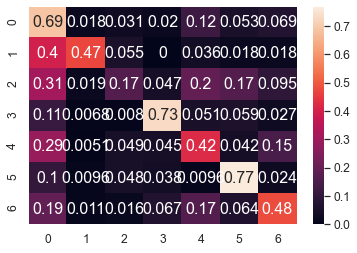

	training epoch=35 .. train_loss=0.998
	validation epoch=35 .. val_loss=1.221
	Accuracy = 54.800000000000004 % .. Percision = 53.1 % .. Recall = 53.300000000000004 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_35.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 36 .. loss = 0.878


  0%|                                                                                 | 1/1914 [00:01<54:21,  1.71s/it]

training @ epoch 36 .. loss = 1.004


  0%|                                                                                 | 2/1914 [00:03<52:28,  1.65s/it]

training @ epoch 36 .. loss = 0.753


  0%|▏                                                                                | 3/1914 [00:04<50:58,  1.60s/it]

training @ epoch 36 .. loss = 0.789


  0%|▏                                                                                | 4/1914 [00:06<50:31,  1.59s/it]

training @ epoch 36 .. loss = 1.148


  0%|▏                                                                                | 5/1914 [00:07<48:57,  1.54s/it]

training @ epoch 36 .. loss = 0.921


  0%|▎                                                                                | 6/1914 [00:09<49:22,  1.55s/it]

training @ epoch 36 .. loss = 0.975


  0%|▎                                                                                | 7/1914 [00:10<48:15,  1.52s/it]

training @ epoch 36 .. loss = 0.744


  0%|▎                                                                                | 8/1914 [00:12<46:16,  1.46s/it]

training @ epoch 36 .. loss = 0.647


  0%|▍                                                                                | 9/1914 [00:13<45:56,  1.45s/it]

training @ epoch 36 .. loss = 0.909


  1%|▍                                                                               | 10/1914 [00:14<46:00,  1.45s/it]

training @ epoch 36 .. loss = 0.79


  1%|▍                                                                               | 11/1914 [00:16<45:44,  1.44s/it]

training @ epoch 36 .. loss = 0.43


  1%|▌                                                                               | 12/1914 [00:17<44:28,  1.40s/it]

training @ epoch 36 .. loss = 1.049


  1%|▌                                                                               | 13/1914 [00:19<44:11,  1.40s/it]

training @ epoch 36 .. loss = 1.026


  1%|▌                                                                               | 14/1914 [00:20<43:53,  1.39s/it]

training @ epoch 36 .. loss = 0.78


  1%|▋                                                                               | 15/1914 [00:21<44:03,  1.39s/it]

training @ epoch 36 .. loss = 1.108


  1%|▋                                                                               | 16/1914 [00:23<43:57,  1.39s/it]

training @ epoch 36 .. loss = 0.681


  1%|▋                                                                               | 17/1914 [00:24<43:30,  1.38s/it]

training @ epoch 36 .. loss = 0.728


  1%|▊                                                                               | 18/1914 [00:25<42:30,  1.35s/it]

training @ epoch 36 .. loss = 0.933


  1%|▊                                                                               | 19/1914 [00:27<42:04,  1.33s/it]

training @ epoch 36 .. loss = 0.647


  1%|▊                                                                               | 20/1914 [00:28<41:39,  1.32s/it]

training @ epoch 36 .. loss = 1.621


  1%|▉                                                                               | 21/1914 [00:29<42:04,  1.33s/it]

training @ epoch 36 .. loss = 0.916


  1%|▉                                                                               | 22/1914 [00:31<41:40,  1.32s/it]

training @ epoch 36 .. loss = 0.802


  1%|▉                                                                               | 23/1914 [00:32<41:34,  1.32s/it]

training @ epoch 36 .. loss = 1.118


  1%|█                                                                               | 24/1914 [00:33<41:13,  1.31s/it]

training @ epoch 36 .. loss = 0.659


  1%|█                                                                               | 25/1914 [00:34<41:20,  1.31s/it]

training @ epoch 36 .. loss = 0.913


  1%|█                                                                               | 26/1914 [00:36<41:31,  1.32s/it]

training @ epoch 36 .. loss = 0.767


  1%|█▏                                                                              | 27/1914 [00:37<41:09,  1.31s/it]

training @ epoch 36 .. loss = 0.667


  1%|█▏                                                                              | 28/1914 [00:38<41:14,  1.31s/it]

training @ epoch 36 .. loss = 0.782


  2%|█▏                                                                              | 29/1914 [00:40<41:20,  1.32s/it]

training @ epoch 36 .. loss = 0.684


  2%|█▎                                                                              | 30/1914 [00:41<41:24,  1.32s/it]

training @ epoch 36 .. loss = 1.207


  2%|█▎                                                                              | 31/1914 [00:42<41:47,  1.33s/it]

training @ epoch 36 .. loss = 1.004


  2%|█▎                                                                              | 32/1914 [00:44<41:18,  1.32s/it]

training @ epoch 36 .. loss = 0.96


  2%|█▍                                                                              | 33/1914 [00:45<41:15,  1.32s/it]

training @ epoch 36 .. loss = 0.675


  2%|█▍                                                                              | 34/1914 [00:46<41:12,  1.32s/it]

training @ epoch 36 .. loss = 0.655


  2%|█▍                                                                              | 35/1914 [00:48<41:39,  1.33s/it]

training @ epoch 36 .. loss = 0.862


  2%|█▌                                                                              | 36/1914 [00:49<41:40,  1.33s/it]

training @ epoch 36 .. loss = 0.848


  2%|█▌                                                                              | 37/1914 [00:50<41:17,  1.32s/it]

training @ epoch 36 .. loss = 0.725


  2%|█▌                                                                              | 38/1914 [00:52<41:18,  1.32s/it]

training @ epoch 36 .. loss = 0.754


  2%|█▋                                                                              | 39/1914 [00:53<41:13,  1.32s/it]

training @ epoch 36 .. loss = 0.611


  2%|█▋                                                                              | 40/1914 [00:54<41:43,  1.34s/it]

training @ epoch 36 .. loss = 0.773


  2%|█▋                                                                              | 41/1914 [00:56<41:00,  1.31s/it]

training @ epoch 36 .. loss = 1.387


  2%|█▊                                                                              | 42/1914 [00:57<41:05,  1.32s/it]

training @ epoch 36 .. loss = 0.834


  2%|█▊                                                                              | 43/1914 [00:58<41:19,  1.32s/it]

training @ epoch 36 .. loss = 0.699


  2%|█▊                                                                              | 44/1914 [01:00<40:43,  1.31s/it]

training @ epoch 36 .. loss = 0.724


  2%|█▉                                                                              | 45/1914 [01:01<41:31,  1.33s/it]

training @ epoch 36 .. loss = 0.688


  2%|█▉                                                                              | 46/1914 [01:02<41:53,  1.35s/it]

training @ epoch 36 .. loss = 1.19


  2%|█▉                                                                              | 47/1914 [01:04<41:45,  1.34s/it]

training @ epoch 36 .. loss = 0.804


  3%|██                                                                              | 48/1914 [01:05<42:02,  1.35s/it]

training @ epoch 36 .. loss = 1.011


  3%|██                                                                              | 49/1914 [01:06<41:40,  1.34s/it]

training @ epoch 36 .. loss = 1.025


  3%|██                                                                              | 50/1914 [01:08<42:13,  1.36s/it]

training @ epoch 36 .. loss = 0.937


  3%|██▏                                                                             | 51/1914 [01:09<42:11,  1.36s/it]

training @ epoch 36 .. loss = 0.717


  3%|██▏                                                                             | 52/1914 [01:11<43:15,  1.39s/it]

training @ epoch 36 .. loss = 0.966


  3%|██▏                                                                             | 53/1914 [01:12<42:24,  1.37s/it]

training @ epoch 36 .. loss = 0.805


  3%|██▎                                                                             | 54/1914 [01:13<41:53,  1.35s/it]

training @ epoch 36 .. loss = 1.219


  3%|██▎                                                                             | 55/1914 [01:15<41:46,  1.35s/it]

training @ epoch 36 .. loss = 0.747


  3%|██▎                                                                             | 56/1914 [01:16<42:22,  1.37s/it]

training @ epoch 36 .. loss = 1.281


  3%|██▍                                                                             | 57/1914 [01:17<42:54,  1.39s/it]

training @ epoch 36 .. loss = 0.865


  3%|██▍                                                                             | 58/1914 [01:19<42:23,  1.37s/it]

training @ epoch 36 .. loss = 0.875


  3%|██▍                                                                             | 59/1914 [01:20<41:44,  1.35s/it]

training @ epoch 36 .. loss = 1.069


  3%|██▌                                                                             | 60/1914 [01:21<41:12,  1.33s/it]

training @ epoch 36 .. loss = 0.879


  3%|██▌                                                                             | 61/1914 [01:23<42:12,  1.37s/it]

training @ epoch 36 .. loss = 1.622


  3%|██▌                                                                             | 62/1914 [01:24<42:45,  1.39s/it]

training @ epoch 36 .. loss = 1.24


  3%|██▋                                                                             | 63/1914 [01:26<43:06,  1.40s/it]

training @ epoch 36 .. loss = 0.973


  3%|██▋                                                                             | 64/1914 [01:27<42:11,  1.37s/it]

training @ epoch 36 .. loss = 1.202


  3%|██▋                                                                             | 65/1914 [01:28<41:41,  1.35s/it]

training @ epoch 36 .. loss = 1.017


  3%|██▊                                                                             | 66/1914 [01:30<42:35,  1.38s/it]

training @ epoch 36 .. loss = 0.831


  4%|██▊                                                                             | 67/1914 [01:31<42:41,  1.39s/it]

training @ epoch 36 .. loss = 1.182


  4%|██▊                                                                             | 68/1914 [01:32<42:01,  1.37s/it]

training @ epoch 36 .. loss = 1.118


  4%|██▉                                                                             | 69/1914 [01:34<41:19,  1.34s/it]

training @ epoch 36 .. loss = 0.901


  4%|██▉                                                                             | 70/1914 [01:35<41:12,  1.34s/it]

training @ epoch 36 .. loss = 1.022


  4%|██▉                                                                             | 71/1914 [01:36<42:09,  1.37s/it]

training @ epoch 36 .. loss = 0.934


  4%|███                                                                             | 72/1914 [01:38<42:37,  1.39s/it]

training @ epoch 36 .. loss = 0.784


  4%|███                                                                             | 73/1914 [01:39<42:00,  1.37s/it]

training @ epoch 36 .. loss = 1.1


  4%|███                                                                             | 74/1914 [01:41<41:34,  1.36s/it]

training @ epoch 36 .. loss = 0.892


  4%|███▏                                                                            | 75/1914 [01:42<41:26,  1.35s/it]

training @ epoch 36 .. loss = 1.708


  4%|███▏                                                                            | 76/1914 [01:43<42:00,  1.37s/it]

training @ epoch 36 .. loss = 0.51


  4%|███▏                                                                            | 77/1914 [01:45<42:40,  1.39s/it]

training @ epoch 36 .. loss = 1.013


  4%|███▎                                                                            | 78/1914 [01:46<42:04,  1.38s/it]

training @ epoch 36 .. loss = 1.288


  4%|███▎                                                                            | 79/1914 [01:47<40:52,  1.34s/it]

training @ epoch 36 .. loss = 0.5


  4%|███▎                                                                            | 80/1914 [01:49<41:22,  1.35s/it]

training @ epoch 36 .. loss = 1.046


  4%|███▍                                                                            | 81/1914 [01:50<41:49,  1.37s/it]

training @ epoch 36 .. loss = 1.215


  4%|███▍                                                                            | 82/1914 [01:52<42:13,  1.38s/it]

training @ epoch 36 .. loss = 1.147


  4%|███▍                                                                            | 83/1914 [01:53<42:06,  1.38s/it]

training @ epoch 36 .. loss = 0.668


  4%|███▌                                                                            | 84/1914 [01:54<41:29,  1.36s/it]

training @ epoch 36 .. loss = 0.714


  4%|███▌                                                                            | 85/1914 [01:56<41:02,  1.35s/it]

training @ epoch 36 .. loss = 1.201


  4%|███▌                                                                            | 86/1914 [01:57<41:50,  1.37s/it]

training @ epoch 36 .. loss = 0.75


  5%|███▋                                                                            | 87/1914 [01:58<42:17,  1.39s/it]

training @ epoch 36 .. loss = 0.744


  5%|███▋                                                                            | 88/1914 [02:00<41:35,  1.37s/it]

training @ epoch 36 .. loss = 1.192


  5%|███▋                                                                            | 89/1914 [02:01<40:59,  1.35s/it]

training @ epoch 36 .. loss = 1.013


  5%|███▊                                                                            | 90/1914 [02:02<40:39,  1.34s/it]

training @ epoch 36 .. loss = 0.748


  5%|███▊                                                                            | 91/1914 [02:04<41:31,  1.37s/it]

training @ epoch 36 .. loss = 0.903


  5%|███▊                                                                            | 92/1914 [02:05<42:08,  1.39s/it]

training @ epoch 36 .. loss = 1.051


  5%|███▉                                                                            | 93/1914 [02:07<41:36,  1.37s/it]

training @ epoch 36 .. loss = 0.491


  5%|███▉                                                                            | 94/1914 [02:08<41:41,  1.37s/it]

training @ epoch 36 .. loss = 0.865


  5%|███▉                                                                            | 95/1914 [02:09<41:02,  1.35s/it]

training @ epoch 36 .. loss = 0.898


  5%|████                                                                            | 96/1914 [02:11<41:44,  1.38s/it]

training @ epoch 36 .. loss = 0.885


  5%|████                                                                            | 97/1914 [02:12<42:04,  1.39s/it]

training @ epoch 36 .. loss = 0.607


  5%|████                                                                            | 98/1914 [02:13<41:27,  1.37s/it]

training @ epoch 36 .. loss = 0.773


  5%|████▏                                                                           | 99/1914 [02:15<41:12,  1.36s/it]

training @ epoch 36 .. loss = 1.652


  5%|████▏                                                                          | 100/1914 [02:16<40:39,  1.34s/it]

training @ epoch 36 .. loss = 0.706


  5%|████▏                                                                          | 101/1914 [02:17<41:00,  1.36s/it]

training @ epoch 36 .. loss = 0.753


  5%|████▏                                                                          | 102/1914 [02:19<41:47,  1.38s/it]

training @ epoch 36 .. loss = 1.012


  5%|████▎                                                                          | 103/1914 [02:20<41:19,  1.37s/it]

training @ epoch 36 .. loss = 0.88


  5%|████▎                                                                          | 104/1914 [02:22<40:48,  1.35s/it]

training @ epoch 36 .. loss = 0.926


  5%|████▎                                                                          | 105/1914 [02:23<40:57,  1.36s/it]

training @ epoch 36 .. loss = 1.222


  6%|████▍                                                                          | 106/1914 [02:24<41:38,  1.38s/it]

training @ epoch 36 .. loss = 1.445


  6%|████▍                                                                          | 107/1914 [02:26<42:28,  1.41s/it]

training @ epoch 36 .. loss = 0.621


  6%|████▍                                                                          | 108/1914 [02:27<41:56,  1.39s/it]

training @ epoch 36 .. loss = 0.945


  6%|████▍                                                                          | 109/1914 [02:28<41:33,  1.38s/it]

training @ epoch 36 .. loss = 0.72


  6%|████▌                                                                          | 110/1914 [02:30<40:29,  1.35s/it]

training @ epoch 36 .. loss = 0.768


  6%|████▌                                                                          | 111/1914 [02:31<40:54,  1.36s/it]

training @ epoch 36 .. loss = 1.0


  6%|████▌                                                                          | 112/1914 [02:33<41:27,  1.38s/it]

training @ epoch 36 .. loss = 1.061


  6%|████▋                                                                          | 113/1914 [02:34<41:40,  1.39s/it]

training @ epoch 36 .. loss = 0.94


  6%|████▋                                                                          | 114/1914 [02:35<40:42,  1.36s/it]

training @ epoch 36 .. loss = 0.811


  6%|████▋                                                                          | 115/1914 [02:37<40:33,  1.35s/it]

training @ epoch 36 .. loss = 1.032


  6%|████▊                                                                          | 116/1914 [02:38<40:50,  1.36s/it]

training @ epoch 36 .. loss = 1.066


  6%|████▊                                                                          | 117/1914 [02:39<41:22,  1.38s/it]

training @ epoch 36 .. loss = 0.602


  6%|████▊                                                                          | 118/1914 [02:41<41:37,  1.39s/it]

training @ epoch 36 .. loss = 1.143


  6%|████▉                                                                          | 119/1914 [02:42<40:39,  1.36s/it]

training @ epoch 36 .. loss = 0.84


  6%|████▉                                                                          | 120/1914 [02:43<40:24,  1.35s/it]

training @ epoch 36 .. loss = 0.779


  6%|████▉                                                                          | 121/1914 [02:45<40:46,  1.36s/it]

training @ epoch 36 .. loss = 1.323


  6%|█████                                                                          | 122/1914 [02:46<41:07,  1.38s/it]

training @ epoch 36 .. loss = 0.96


  6%|█████                                                                          | 123/1914 [02:48<41:04,  1.38s/it]

training @ epoch 36 .. loss = 0.847


  6%|█████                                                                          | 124/1914 [02:49<40:40,  1.36s/it]

training @ epoch 36 .. loss = 0.755


  7%|█████▏                                                                         | 125/1914 [02:50<40:18,  1.35s/it]

training @ epoch 36 .. loss = 0.675


  7%|█████▏                                                                         | 126/1914 [02:52<40:11,  1.35s/it]

training @ epoch 36 .. loss = 0.515


  7%|█████▏                                                                         | 127/1914 [02:53<40:30,  1.36s/it]

training @ epoch 36 .. loss = 1.276


  7%|█████▎                                                                         | 128/1914 [02:54<41:19,  1.39s/it]

training @ epoch 36 .. loss = 0.869


  7%|█████▎                                                                         | 129/1914 [02:56<40:21,  1.36s/it]

training @ epoch 36 .. loss = 1.07


  7%|█████▎                                                                         | 130/1914 [02:57<39:46,  1.34s/it]

training @ epoch 36 .. loss = 1.385


  7%|█████▍                                                                         | 131/1914 [02:58<40:38,  1.37s/it]

training @ epoch 36 .. loss = 0.712


  7%|█████▍                                                                         | 132/1914 [03:00<41:08,  1.39s/it]

training @ epoch 36 .. loss = 0.74


  7%|█████▍                                                                         | 133/1914 [03:01<40:50,  1.38s/it]

training @ epoch 36 .. loss = 1.268


  7%|█████▌                                                                         | 134/1914 [03:03<40:43,  1.37s/it]

training @ epoch 36 .. loss = 1.42


  7%|█████▌                                                                         | 135/1914 [03:04<40:42,  1.37s/it]

training @ epoch 36 .. loss = 1.215


  7%|█████▌                                                                         | 136/1914 [03:05<39:39,  1.34s/it]

training @ epoch 36 .. loss = 0.737


  7%|█████▋                                                                         | 137/1914 [03:07<39:44,  1.34s/it]

training @ epoch 36 .. loss = 1.385


  7%|█████▋                                                                         | 138/1914 [03:08<39:31,  1.34s/it]

training @ epoch 36 .. loss = 0.821


  7%|█████▋                                                                         | 139/1914 [03:09<38:47,  1.31s/it]

training @ epoch 36 .. loss = 1.301


  7%|█████▊                                                                         | 140/1914 [03:11<39:03,  1.32s/it]

training @ epoch 36 .. loss = 0.708


  7%|█████▊                                                                         | 141/1914 [03:12<38:58,  1.32s/it]

training @ epoch 36 .. loss = 0.641


  7%|█████▊                                                                         | 142/1914 [03:13<38:43,  1.31s/it]

training @ epoch 36 .. loss = 0.795


  7%|█████▉                                                                         | 143/1914 [03:15<39:41,  1.34s/it]

training @ epoch 36 .. loss = 1.262


  8%|█████▉                                                                         | 144/1914 [03:16<39:02,  1.32s/it]

training @ epoch 36 .. loss = 0.7


  8%|█████▉                                                                         | 145/1914 [03:17<38:56,  1.32s/it]

training @ epoch 36 .. loss = 1.401


  8%|██████                                                                         | 146/1914 [03:19<40:00,  1.36s/it]

training @ epoch 36 .. loss = 0.731


  8%|██████                                                                         | 147/1914 [03:20<40:19,  1.37s/it]

training @ epoch 36 .. loss = 1.073


  8%|██████                                                                         | 148/1914 [03:21<39:54,  1.36s/it]

training @ epoch 36 .. loss = 1.737


  8%|██████▏                                                                        | 149/1914 [03:23<39:41,  1.35s/it]

training @ epoch 36 .. loss = 1.424


  8%|██████▏                                                                        | 150/1914 [03:24<39:20,  1.34s/it]

training @ epoch 36 .. loss = 1.033


  8%|██████▏                                                                        | 151/1914 [03:25<39:43,  1.35s/it]

training @ epoch 36 .. loss = 0.603


  8%|██████▎                                                                        | 152/1914 [03:27<40:16,  1.37s/it]

training @ epoch 36 .. loss = 0.831


  8%|██████▎                                                                        | 153/1914 [03:28<40:17,  1.37s/it]

training @ epoch 36 .. loss = 0.741


  8%|██████▎                                                                        | 154/1914 [03:29<39:27,  1.35s/it]

training @ epoch 36 .. loss = 0.651


  8%|██████▍                                                                        | 155/1914 [03:31<39:21,  1.34s/it]

training @ epoch 36 .. loss = 1.179


  8%|██████▍                                                                        | 156/1914 [03:32<39:10,  1.34s/it]

training @ epoch 36 .. loss = 0.642


  8%|██████▍                                                                        | 157/1914 [03:33<38:24,  1.31s/it]

training @ epoch 36 .. loss = 0.933


  8%|██████▌                                                                        | 158/1914 [03:35<38:56,  1.33s/it]

training @ epoch 36 .. loss = 1.229


  8%|██████▌                                                                        | 159/1914 [03:36<38:35,  1.32s/it]

training @ epoch 36 .. loss = 1.635


  8%|██████▌                                                                        | 160/1914 [03:37<38:19,  1.31s/it]

training @ epoch 36 .. loss = 0.641


  8%|██████▋                                                                        | 161/1914 [03:39<38:20,  1.31s/it]

training @ epoch 36 .. loss = 0.835


  8%|██████▋                                                                        | 162/1914 [03:40<38:26,  1.32s/it]

training @ epoch 36 .. loss = 0.923


  9%|██████▋                                                                        | 163/1914 [03:41<38:11,  1.31s/it]

training @ epoch 36 .. loss = 1.681


  9%|██████▊                                                                        | 164/1914 [03:43<38:30,  1.32s/it]

training @ epoch 36 .. loss = 0.546


  9%|██████▊                                                                        | 165/1914 [03:44<38:20,  1.32s/it]

training @ epoch 36 .. loss = 1.635


  9%|██████▊                                                                        | 166/1914 [03:45<38:02,  1.31s/it]

training @ epoch 36 .. loss = 0.575


  9%|██████▉                                                                        | 167/1914 [03:47<38:48,  1.33s/it]

training @ epoch 36 .. loss = 1.29


  9%|██████▉                                                                        | 168/1914 [03:48<38:31,  1.32s/it]

training @ epoch 36 .. loss = 1.107


  9%|██████▉                                                                        | 169/1914 [03:49<38:09,  1.31s/it]

training @ epoch 36 .. loss = 0.948


  9%|███████                                                                        | 170/1914 [03:50<38:18,  1.32s/it]

training @ epoch 36 .. loss = 1.235


  9%|███████                                                                        | 171/1914 [03:52<38:00,  1.31s/it]

training @ epoch 36 .. loss = 0.922


  9%|███████                                                                        | 172/1914 [03:53<38:12,  1.32s/it]

training @ epoch 36 .. loss = 0.786


  9%|███████▏                                                                       | 173/1914 [03:54<38:15,  1.32s/it]

training @ epoch 36 .. loss = 1.215


  9%|███████▏                                                                       | 174/1914 [03:56<38:15,  1.32s/it]

training @ epoch 36 .. loss = 1.192


  9%|███████▏                                                                       | 175/1914 [03:57<38:27,  1.33s/it]

training @ epoch 36 .. loss = 0.819


  9%|███████▎                                                                       | 176/1914 [03:59<40:10,  1.39s/it]

training @ epoch 36 .. loss = 1.025


  9%|███████▎                                                                       | 177/1914 [04:00<40:33,  1.40s/it]

training @ epoch 36 .. loss = 1.067


  9%|███████▎                                                                       | 178/1914 [04:01<40:14,  1.39s/it]

training @ epoch 36 .. loss = 0.711


  9%|███████▍                                                                       | 179/1914 [04:03<39:53,  1.38s/it]

training @ epoch 36 .. loss = 0.844


  9%|███████▍                                                                       | 180/1914 [04:04<39:44,  1.38s/it]

training @ epoch 36 .. loss = 1.092


  9%|███████▍                                                                       | 181/1914 [04:06<39:59,  1.38s/it]

training @ epoch 36 .. loss = 0.939


 10%|███████▌                                                                       | 182/1914 [04:07<40:28,  1.40s/it]

training @ epoch 36 .. loss = 0.805


 10%|███████▌                                                                       | 183/1914 [04:08<40:03,  1.39s/it]

training @ epoch 36 .. loss = 1.263


 10%|███████▌                                                                       | 184/1914 [04:10<39:32,  1.37s/it]

training @ epoch 36 .. loss = 0.971


 10%|███████▋                                                                       | 185/1914 [04:11<39:13,  1.36s/it]

training @ epoch 36 .. loss = 0.92


 10%|███████▋                                                                       | 186/1914 [04:12<39:29,  1.37s/it]

training @ epoch 36 .. loss = 0.791


 10%|███████▋                                                                       | 187/1914 [04:14<39:45,  1.38s/it]

training @ epoch 36 .. loss = 1.027


 10%|███████▊                                                                       | 188/1914 [04:15<39:35,  1.38s/it]

training @ epoch 36 .. loss = 1.78


 10%|███████▊                                                                       | 189/1914 [04:16<39:07,  1.36s/it]

training @ epoch 36 .. loss = 0.788


 10%|███████▊                                                                       | 190/1914 [04:18<38:40,  1.35s/it]

training @ epoch 36 .. loss = 1.087


 10%|███████▉                                                                       | 191/1914 [04:19<38:17,  1.33s/it]

training @ epoch 36 .. loss = 0.955


 10%|███████▉                                                                       | 192/1914 [04:21<38:47,  1.35s/it]

training @ epoch 36 .. loss = 0.916


 10%|███████▉                                                                       | 193/1914 [04:22<39:30,  1.38s/it]

training @ epoch 36 .. loss = 1.301


 10%|████████                                                                       | 194/1914 [04:23<39:17,  1.37s/it]

training @ epoch 36 .. loss = 1.025


 10%|████████                                                                       | 195/1914 [04:25<39:12,  1.37s/it]

training @ epoch 36 .. loss = 1.041


 10%|████████                                                                       | 196/1914 [04:26<38:41,  1.35s/it]

training @ epoch 36 .. loss = 0.843


 10%|████████▏                                                                      | 197/1914 [04:27<38:43,  1.35s/it]

training @ epoch 36 .. loss = 0.669


 10%|████████▏                                                                      | 198/1914 [04:29<39:14,  1.37s/it]

training @ epoch 36 .. loss = 0.813


 10%|████████▏                                                                      | 199/1914 [04:30<39:40,  1.39s/it]

training @ epoch 36 .. loss = 1.009


 10%|████████▎                                                                      | 200/1914 [04:31<38:34,  1.35s/it]

training @ epoch 36 .. loss = 1.154


 11%|████████▎                                                                      | 201/1914 [04:33<38:15,  1.34s/it]

training @ epoch 36 .. loss = 1.111


 11%|████████▎                                                                      | 202/1914 [04:34<38:15,  1.34s/it]

training @ epoch 36 .. loss = 0.777


 11%|████████▍                                                                      | 203/1914 [04:35<38:36,  1.35s/it]

training @ epoch 36 .. loss = 0.839


 11%|████████▍                                                                      | 204/1914 [04:37<39:34,  1.39s/it]

training @ epoch 36 .. loss = 1.132


 11%|████████▍                                                                      | 205/1914 [04:38<38:54,  1.37s/it]

training @ epoch 36 .. loss = 1.048


 11%|████████▌                                                                      | 206/1914 [04:40<38:26,  1.35s/it]

training @ epoch 36 .. loss = 0.798


 11%|████████▌                                                                      | 207/1914 [04:41<38:26,  1.35s/it]

training @ epoch 36 .. loss = 0.812


 11%|████████▌                                                                      | 208/1914 [04:42<39:21,  1.38s/it]

training @ epoch 36 .. loss = 0.874


 11%|████████▋                                                                      | 209/1914 [04:44<39:28,  1.39s/it]

training @ epoch 36 .. loss = 1.257


 11%|████████▋                                                                      | 210/1914 [04:45<38:33,  1.36s/it]

training @ epoch 36 .. loss = 1.351


 11%|████████▋                                                                      | 211/1914 [04:46<38:18,  1.35s/it]

training @ epoch 36 .. loss = 0.94


 11%|████████▊                                                                      | 212/1914 [04:48<37:53,  1.34s/it]

training @ epoch 36 .. loss = 1.374


 11%|████████▊                                                                      | 213/1914 [04:49<38:28,  1.36s/it]

training @ epoch 36 .. loss = 1.27


 11%|████████▊                                                                      | 214/1914 [04:51<39:02,  1.38s/it]

training @ epoch 36 .. loss = 0.844


 11%|████████▊                                                                      | 215/1914 [04:52<38:33,  1.36s/it]

training @ epoch 36 .. loss = 1.081


 11%|████████▉                                                                      | 216/1914 [04:53<37:57,  1.34s/it]

training @ epoch 36 .. loss = 1.212


 11%|████████▉                                                                      | 217/1914 [04:55<38:08,  1.35s/it]

training @ epoch 36 .. loss = 0.906


 11%|████████▉                                                                      | 218/1914 [04:56<38:40,  1.37s/it]

training @ epoch 36 .. loss = 0.84


 11%|█████████                                                                      | 219/1914 [04:57<39:08,  1.39s/it]

training @ epoch 36 .. loss = 0.709


 11%|█████████                                                                      | 220/1914 [04:59<38:46,  1.37s/it]

training @ epoch 36 .. loss = 0.576


 12%|█████████                                                                      | 221/1914 [05:00<38:50,  1.38s/it]

training @ epoch 36 .. loss = 1.577


 12%|█████████▏                                                                     | 222/1914 [05:01<38:36,  1.37s/it]

training @ epoch 36 .. loss = 0.935


 12%|█████████▏                                                                     | 223/1914 [05:03<39:15,  1.39s/it]

training @ epoch 36 .. loss = 0.772


 12%|█████████▏                                                                     | 224/1914 [05:04<40:01,  1.42s/it]

training @ epoch 36 .. loss = 1.051


 12%|█████████▎                                                                     | 225/1914 [05:06<39:10,  1.39s/it]

training @ epoch 36 .. loss = 1.058


 12%|█████████▎                                                                     | 226/1914 [05:07<38:56,  1.38s/it]

training @ epoch 36 .. loss = 0.707


 12%|█████████▎                                                                     | 227/1914 [05:08<38:19,  1.36s/it]

training @ epoch 36 .. loss = 0.967


 12%|█████████▍                                                                     | 228/1914 [05:10<39:10,  1.39s/it]

training @ epoch 36 .. loss = 0.545


 12%|█████████▍                                                                     | 229/1914 [05:11<39:23,  1.40s/it]

training @ epoch 36 .. loss = 0.912


 12%|█████████▍                                                                     | 230/1914 [05:13<39:14,  1.40s/it]

training @ epoch 36 .. loss = 0.727


 12%|█████████▌                                                                     | 231/1914 [05:14<38:19,  1.37s/it]

training @ epoch 36 .. loss = 0.782


 12%|█████████▌                                                                     | 232/1914 [05:15<37:55,  1.35s/it]

training @ epoch 36 .. loss = 0.761


 12%|█████████▌                                                                     | 233/1914 [05:17<39:07,  1.40s/it]

training @ epoch 36 .. loss = 0.562


 12%|█████████▋                                                                     | 234/1914 [05:18<39:06,  1.40s/it]

training @ epoch 36 .. loss = 0.669


 12%|█████████▋                                                                     | 235/1914 [05:20<39:04,  1.40s/it]

training @ epoch 36 .. loss = 1.042


 12%|█████████▋                                                                     | 236/1914 [05:21<38:16,  1.37s/it]

training @ epoch 36 .. loss = 1.345


 12%|█████████▊                                                                     | 237/1914 [05:22<38:17,  1.37s/it]

training @ epoch 36 .. loss = 0.847


 12%|█████████▊                                                                     | 238/1914 [05:24<38:34,  1.38s/it]

training @ epoch 36 .. loss = 1.971


 12%|█████████▊                                                                     | 239/1914 [05:25<38:50,  1.39s/it]

training @ epoch 36 .. loss = 1.054


 13%|█████████▉                                                                     | 240/1914 [05:26<38:40,  1.39s/it]

training @ epoch 36 .. loss = 1.08


 13%|█████████▉                                                                     | 241/1914 [05:28<38:07,  1.37s/it]

training @ epoch 36 .. loss = 1.294


 13%|█████████▉                                                                     | 242/1914 [05:29<37:39,  1.35s/it]

training @ epoch 36 .. loss = 1.278


 13%|██████████                                                                     | 243/1914 [05:31<38:30,  1.38s/it]

training @ epoch 36 .. loss = 1.001


 13%|██████████                                                                     | 244/1914 [05:32<38:45,  1.39s/it]

training @ epoch 36 .. loss = 0.588


 13%|██████████                                                                     | 245/1914 [05:33<38:14,  1.37s/it]

training @ epoch 36 .. loss = 1.599


 13%|██████████▏                                                                    | 246/1914 [05:35<37:58,  1.37s/it]

training @ epoch 36 .. loss = 1.234


 13%|██████████▏                                                                    | 247/1914 [05:36<37:40,  1.36s/it]

training @ epoch 36 .. loss = 0.947


 13%|██████████▏                                                                    | 248/1914 [05:37<37:42,  1.36s/it]

training @ epoch 36 .. loss = 1.001


 13%|██████████▎                                                                    | 249/1914 [05:39<38:21,  1.38s/it]

training @ epoch 36 .. loss = 1.005


 13%|██████████▎                                                                    | 250/1914 [05:40<38:31,  1.39s/it]

training @ epoch 36 .. loss = 1.424


 13%|██████████▎                                                                    | 251/1914 [05:41<37:22,  1.35s/it]

training @ epoch 36 .. loss = 0.733


 13%|██████████▍                                                                    | 252/1914 [05:43<37:32,  1.36s/it]

training @ epoch 36 .. loss = 0.833


 13%|██████████▍                                                                    | 253/1914 [05:44<38:01,  1.37s/it]

training @ epoch 36 .. loss = 0.967


 13%|██████████▍                                                                    | 254/1914 [05:46<38:05,  1.38s/it]

training @ epoch 36 .. loss = 0.788


 13%|██████████▌                                                                    | 255/1914 [05:47<38:14,  1.38s/it]

training @ epoch 36 .. loss = 0.812


 13%|██████████▌                                                                    | 256/1914 [05:48<38:44,  1.40s/it]

training @ epoch 36 .. loss = 0.82


 13%|██████████▌                                                                    | 257/1914 [05:50<39:50,  1.44s/it]

training @ epoch 36 .. loss = 1.429


 13%|██████████▋                                                                    | 258/1914 [05:52<40:48,  1.48s/it]

training @ epoch 36 .. loss = 1.164


 14%|██████████▋                                                                    | 259/1914 [05:53<41:25,  1.50s/it]

training @ epoch 36 .. loss = 0.811


 14%|██████████▋                                                                    | 260/1914 [05:55<41:35,  1.51s/it]

training @ epoch 36 .. loss = 1.198


 14%|██████████▊                                                                    | 261/1914 [05:56<41:31,  1.51s/it]

training @ epoch 36 .. loss = 0.817


 14%|██████████▊                                                                    | 262/1914 [05:58<42:00,  1.53s/it]

training @ epoch 36 .. loss = 1.052


 14%|██████████▊                                                                    | 263/1914 [05:59<42:51,  1.56s/it]

training @ epoch 36 .. loss = 1.138


 14%|██████████▉                                                                    | 264/1914 [06:01<42:35,  1.55s/it]

training @ epoch 36 .. loss = 1.099


 14%|██████████▉                                                                    | 265/1914 [06:02<42:17,  1.54s/it]

training @ epoch 36 .. loss = 1.049


 14%|██████████▉                                                                    | 266/1914 [06:04<42:02,  1.53s/it]

training @ epoch 36 .. loss = 0.823


 14%|███████████                                                                    | 267/1914 [06:05<42:01,  1.53s/it]

training @ epoch 36 .. loss = 0.688


 14%|███████████                                                                    | 268/1914 [06:07<41:37,  1.52s/it]

training @ epoch 36 .. loss = 0.799


 14%|███████████                                                                    | 269/1914 [06:08<41:44,  1.52s/it]

training @ epoch 36 .. loss = 1.195


 14%|███████████▏                                                                   | 270/1914 [06:10<42:22,  1.55s/it]

training @ epoch 36 .. loss = 1.019


 14%|███████████▏                                                                   | 271/1914 [06:12<42:42,  1.56s/it]

training @ epoch 36 .. loss = 1.033


 14%|███████████▏                                                                   | 272/1914 [06:13<42:46,  1.56s/it]

training @ epoch 36 .. loss = 1.075


 14%|███████████▎                                                                   | 273/1914 [06:15<42:11,  1.54s/it]

training @ epoch 36 .. loss = 0.734


 14%|███████████▎                                                                   | 274/1914 [06:16<40:31,  1.48s/it]

training @ epoch 36 .. loss = 1.092


 14%|███████████▎                                                                   | 275/1914 [06:17<38:53,  1.42s/it]

training @ epoch 36 .. loss = 1.238


 14%|███████████▍                                                                   | 276/1914 [06:19<38:17,  1.40s/it]

training @ epoch 36 .. loss = 1.129


 14%|███████████▍                                                                   | 277/1914 [06:20<38:27,  1.41s/it]

training @ epoch 36 .. loss = 0.665


 15%|███████████▍                                                                   | 278/1914 [06:22<38:23,  1.41s/it]

training @ epoch 36 .. loss = 0.62


 15%|███████████▌                                                                   | 279/1914 [06:23<38:21,  1.41s/it]

training @ epoch 36 .. loss = 1.115


 15%|███████████▌                                                                   | 280/1914 [06:24<37:18,  1.37s/it]

training @ epoch 36 .. loss = 0.747


 15%|███████████▌                                                                   | 281/1914 [06:25<36:43,  1.35s/it]

training @ epoch 36 .. loss = 0.954


 15%|███████████▋                                                                   | 282/1914 [06:27<38:20,  1.41s/it]

training @ epoch 36 .. loss = 1.048


 15%|███████████▋                                                                   | 283/1914 [06:28<38:31,  1.42s/it]

training @ epoch 36 .. loss = 0.853


 15%|███████████▋                                                                   | 284/1914 [06:30<37:54,  1.40s/it]

training @ epoch 36 .. loss = 0.927


 15%|███████████▊                                                                   | 285/1914 [06:31<37:23,  1.38s/it]

training @ epoch 36 .. loss = 1.022


 15%|███████████▊                                                                   | 286/1914 [06:33<37:06,  1.37s/it]

training @ epoch 36 .. loss = 1.015


 15%|███████████▊                                                                   | 287/1914 [06:34<37:17,  1.38s/it]

training @ epoch 36 .. loss = 0.633


 15%|███████████▉                                                                   | 288/1914 [06:35<37:41,  1.39s/it]

training @ epoch 36 .. loss = 1.305


 15%|███████████▉                                                                   | 289/1914 [06:37<37:42,  1.39s/it]

training @ epoch 36 .. loss = 0.793


 15%|███████████▉                                                                   | 290/1914 [06:38<36:57,  1.37s/it]

training @ epoch 36 .. loss = 1.112


 15%|████████████                                                                   | 291/1914 [06:39<36:49,  1.36s/it]

training @ epoch 36 .. loss = 1.549


 15%|████████████                                                                   | 292/1914 [06:41<37:25,  1.38s/it]

training @ epoch 36 .. loss = 0.542


 15%|████████████                                                                   | 293/1914 [06:42<38:09,  1.41s/it]

training @ epoch 36 .. loss = 0.914


 15%|████████████▏                                                                  | 294/1914 [06:44<37:08,  1.38s/it]

training @ epoch 36 .. loss = 0.783


 15%|████████████▏                                                                  | 295/1914 [06:45<36:47,  1.36s/it]

training @ epoch 36 .. loss = 1.158


 15%|████████████▏                                                                  | 296/1914 [06:46<36:41,  1.36s/it]

training @ epoch 36 .. loss = 0.952


 16%|████████████▎                                                                  | 297/1914 [06:48<37:01,  1.37s/it]

training @ epoch 36 .. loss = 1.217


 16%|████████████▎                                                                  | 298/1914 [06:49<37:49,  1.40s/it]

training @ epoch 36 .. loss = 0.921


 16%|████████████▎                                                                  | 299/1914 [06:51<38:06,  1.42s/it]

training @ epoch 36 .. loss = 0.977


 16%|████████████▍                                                                  | 300/1914 [06:52<38:24,  1.43s/it]

training @ epoch 36 .. loss = 1.406


 16%|████████████▍                                                                  | 301/1914 [06:53<38:26,  1.43s/it]

training @ epoch 36 .. loss = 0.899


 16%|████████████▍                                                                  | 302/1914 [06:55<38:56,  1.45s/it]

training @ epoch 36 .. loss = 0.883


 16%|████████████▌                                                                  | 303/1914 [06:56<39:17,  1.46s/it]

training @ epoch 36 .. loss = 0.677


 16%|████████████▌                                                                  | 304/1914 [06:58<39:07,  1.46s/it]

training @ epoch 36 .. loss = 1.434


 16%|████████████▌                                                                  | 305/1914 [06:59<38:18,  1.43s/it]

training @ epoch 36 .. loss = 0.619


 16%|████████████▋                                                                  | 306/1914 [07:01<37:17,  1.39s/it]

training @ epoch 36 .. loss = 0.745


 16%|████████████▋                                                                  | 307/1914 [07:02<37:37,  1.40s/it]

training @ epoch 36 .. loss = 0.653


 16%|████████████▋                                                                  | 308/1914 [07:04<38:44,  1.45s/it]

training @ epoch 36 .. loss = 0.774


 16%|████████████▊                                                                  | 309/1914 [07:05<38:03,  1.42s/it]

training @ epoch 36 .. loss = 0.974


 16%|████████████▊                                                                  | 310/1914 [07:06<37:48,  1.41s/it]

training @ epoch 36 .. loss = 0.875


 16%|████████████▊                                                                  | 311/1914 [07:08<36:43,  1.37s/it]

training @ epoch 36 .. loss = 0.717


 16%|████████████▉                                                                  | 312/1914 [07:09<36:46,  1.38s/it]

training @ epoch 36 .. loss = 0.961


 16%|████████████▉                                                                  | 313/1914 [07:11<38:46,  1.45s/it]

training @ epoch 36 .. loss = 1.143


 16%|████████████▉                                                                  | 314/1914 [07:12<38:31,  1.44s/it]

training @ epoch 36 .. loss = 0.626


 16%|█████████████                                                                  | 315/1914 [07:13<36:58,  1.39s/it]

training @ epoch 36 .. loss = 0.827


 17%|█████████████                                                                  | 316/1914 [07:15<36:26,  1.37s/it]

training @ epoch 36 .. loss = 0.728


 17%|█████████████                                                                  | 317/1914 [07:16<36:38,  1.38s/it]

training @ epoch 36 .. loss = 0.882


 17%|█████████████▏                                                                 | 318/1914 [07:17<37:03,  1.39s/it]

training @ epoch 36 .. loss = 1.067


 17%|█████████████▏                                                                 | 319/1914 [07:19<37:23,  1.41s/it]

training @ epoch 36 .. loss = 1.417


 17%|█████████████▏                                                                 | 320/1914 [07:20<36:33,  1.38s/it]

training @ epoch 36 .. loss = 1.135


 17%|█████████████▏                                                                 | 321/1914 [07:21<35:42,  1.34s/it]

training @ epoch 36 .. loss = 0.921


 17%|█████████████▎                                                                 | 322/1914 [07:23<35:59,  1.36s/it]

training @ epoch 36 .. loss = 0.75


 17%|█████████████▎                                                                 | 323/1914 [07:24<35:37,  1.34s/it]

training @ epoch 36 .. loss = 0.521


 17%|█████████████▎                                                                 | 324/1914 [07:25<35:27,  1.34s/it]

training @ epoch 36 .. loss = 1.271


 17%|█████████████▍                                                                 | 325/1914 [07:27<35:33,  1.34s/it]

training @ epoch 36 .. loss = 1.001


 17%|█████████████▍                                                                 | 326/1914 [07:28<35:03,  1.32s/it]

training @ epoch 36 .. loss = 1.151


 17%|█████████████▍                                                                 | 327/1914 [07:29<34:38,  1.31s/it]

training @ epoch 36 .. loss = 0.938


 17%|█████████████▌                                                                 | 328/1914 [07:31<35:03,  1.33s/it]

training @ epoch 36 .. loss = 1.121


 17%|█████████████▌                                                                 | 329/1914 [07:32<35:10,  1.33s/it]

training @ epoch 36 .. loss = 0.559


 17%|█████████████▌                                                                 | 330/1914 [07:33<34:41,  1.31s/it]

training @ epoch 36 .. loss = 1.021


 17%|█████████████▋                                                                 | 331/1914 [07:35<34:44,  1.32s/it]

training @ epoch 36 .. loss = 1.177


 17%|█████████████▋                                                                 | 332/1914 [07:36<34:56,  1.33s/it]

training @ epoch 36 .. loss = 0.792


 17%|█████████████▋                                                                 | 333/1914 [07:37<34:30,  1.31s/it]

training @ epoch 36 .. loss = 0.661


 17%|█████████████▊                                                                 | 334/1914 [07:39<34:55,  1.33s/it]

training @ epoch 36 .. loss = 0.719


 18%|█████████████▊                                                                 | 335/1914 [07:40<34:43,  1.32s/it]

training @ epoch 36 .. loss = 1.07


 18%|█████████████▊                                                                 | 336/1914 [07:41<34:24,  1.31s/it]

training @ epoch 36 .. loss = 1.071


 18%|█████████████▉                                                                 | 337/1914 [07:43<35:08,  1.34s/it]

training @ epoch 36 .. loss = 0.869


 18%|█████████████▉                                                                 | 338/1914 [07:44<34:45,  1.32s/it]

training @ epoch 36 .. loss = 0.95


 18%|█████████████▉                                                                 | 339/1914 [07:45<34:44,  1.32s/it]

training @ epoch 36 .. loss = 0.807


 18%|██████████████                                                                 | 340/1914 [07:47<34:43,  1.32s/it]

training @ epoch 36 .. loss = 0.63


 18%|██████████████                                                                 | 341/1914 [07:48<34:26,  1.31s/it]

training @ epoch 36 .. loss = 0.999


 18%|██████████████                                                                 | 342/1914 [07:49<35:10,  1.34s/it]

training @ epoch 36 .. loss = 0.816


 18%|██████████████▏                                                                | 343/1914 [07:51<35:52,  1.37s/it]

training @ epoch 36 .. loss = 1.026


 18%|██████████████▏                                                                | 344/1914 [07:52<36:22,  1.39s/it]

training @ epoch 36 .. loss = 1.305


 18%|██████████████▏                                                                | 345/1914 [07:53<35:21,  1.35s/it]

training @ epoch 36 .. loss = 0.726


 18%|██████████████▎                                                                | 346/1914 [07:55<34:57,  1.34s/it]

training @ epoch 36 .. loss = 0.601


 18%|██████████████▎                                                                | 347/1914 [07:56<35:37,  1.36s/it]

training @ epoch 36 .. loss = 1.452


 18%|██████████████▎                                                                | 348/1914 [07:58<35:45,  1.37s/it]

training @ epoch 36 .. loss = 1.149


 18%|██████████████▍                                                                | 349/1914 [07:59<36:18,  1.39s/it]

training @ epoch 36 .. loss = 0.84


 18%|██████████████▍                                                                | 350/1914 [08:00<35:36,  1.37s/it]

training @ epoch 36 .. loss = 0.942


 18%|██████████████▍                                                                | 351/1914 [08:02<35:34,  1.37s/it]

training @ epoch 36 .. loss = 0.726


 18%|██████████████▌                                                                | 352/1914 [08:03<35:41,  1.37s/it]

training @ epoch 36 .. loss = 0.596


 18%|██████████████▌                                                                | 353/1914 [08:04<35:45,  1.37s/it]

training @ epoch 36 .. loss = 1.113


 18%|██████████████▌                                                                | 354/1914 [08:06<36:09,  1.39s/it]

training @ epoch 36 .. loss = 0.546


 19%|██████████████▋                                                                | 355/1914 [08:07<35:55,  1.38s/it]

training @ epoch 36 .. loss = 1.216


 19%|██████████████▋                                                                | 356/1914 [08:09<35:06,  1.35s/it]

training @ epoch 36 .. loss = 1.186


 19%|██████████████▋                                                                | 357/1914 [08:10<35:01,  1.35s/it]

training @ epoch 36 .. loss = 0.438


 19%|██████████████▊                                                                | 358/1914 [08:11<35:17,  1.36s/it]

training @ epoch 36 .. loss = 1.078


 19%|██████████████▊                                                                | 359/1914 [08:13<36:09,  1.40s/it]

training @ epoch 36 .. loss = 1.381


 19%|██████████████▊                                                                | 360/1914 [08:14<35:58,  1.39s/it]

training @ epoch 36 .. loss = 0.615


 19%|██████████████▉                                                                | 361/1914 [08:15<35:06,  1.36s/it]

training @ epoch 36 .. loss = 0.936


 19%|██████████████▉                                                                | 362/1914 [08:17<35:18,  1.36s/it]

training @ epoch 36 .. loss = 1.072


 19%|██████████████▉                                                                | 363/1914 [08:18<35:30,  1.37s/it]

training @ epoch 36 .. loss = 0.869


 19%|███████████████                                                                | 364/1914 [08:20<35:33,  1.38s/it]

training @ epoch 36 .. loss = 0.794


 19%|███████████████                                                                | 365/1914 [08:21<35:37,  1.38s/it]

training @ epoch 36 .. loss = 1.536


 19%|███████████████                                                                | 366/1914 [08:22<35:05,  1.36s/it]

training @ epoch 36 .. loss = 0.941


 19%|███████████████▏                                                               | 367/1914 [08:24<34:42,  1.35s/it]

training @ epoch 36 .. loss = 0.712


 19%|███████████████▏                                                               | 368/1914 [08:25<35:13,  1.37s/it]

training @ epoch 36 .. loss = 1.473


 19%|███████████████▏                                                               | 369/1914 [08:26<35:43,  1.39s/it]

training @ epoch 36 .. loss = 0.754


 19%|███████████████▎                                                               | 370/1914 [08:28<35:13,  1.37s/it]

training @ epoch 36 .. loss = 1.175


 19%|███████████████▎                                                               | 371/1914 [08:29<34:55,  1.36s/it]

training @ epoch 36 .. loss = 0.853


 19%|███████████████▎                                                               | 372/1914 [08:30<34:39,  1.35s/it]

training @ epoch 36 .. loss = 0.718


 19%|███████████████▍                                                               | 373/1914 [08:32<35:03,  1.37s/it]

training @ epoch 36 .. loss = 0.805


 20%|███████████████▍                                                               | 374/1914 [08:33<35:20,  1.38s/it]

training @ epoch 36 .. loss = 1.125


 20%|███████████████▍                                                               | 375/1914 [08:35<35:37,  1.39s/it]

training @ epoch 36 .. loss = 0.586


 20%|███████████████▌                                                               | 376/1914 [08:36<34:52,  1.36s/it]

training @ epoch 36 .. loss = 1.027


 20%|███████████████▌                                                               | 377/1914 [08:37<34:28,  1.35s/it]

training @ epoch 36 .. loss = 0.968


 20%|███████████████▌                                                               | 378/1914 [08:39<35:14,  1.38s/it]

training @ epoch 36 .. loss = 0.735


 20%|███████████████▋                                                               | 379/1914 [08:40<35:12,  1.38s/it]

training @ epoch 36 .. loss = 0.894


 20%|███████████████▋                                                               | 380/1914 [08:41<35:43,  1.40s/it]

training @ epoch 36 .. loss = 1.601


 20%|███████████████▋                                                               | 381/1914 [08:43<35:07,  1.37s/it]

training @ epoch 36 .. loss = 0.752


 20%|███████████████▊                                                               | 382/1914 [08:44<34:41,  1.36s/it]

training @ epoch 36 .. loss = 1.029


 20%|███████████████▊                                                               | 383/1914 [08:45<34:39,  1.36s/it]

training @ epoch 36 .. loss = 1.15


 20%|███████████████▊                                                               | 384/1914 [08:47<35:41,  1.40s/it]

training @ epoch 36 .. loss = 1.25


 20%|███████████████▉                                                               | 385/1914 [08:48<35:46,  1.40s/it]

training @ epoch 36 .. loss = 0.843


 20%|███████████████▉                                                               | 386/1914 [08:50<35:17,  1.39s/it]

training @ epoch 36 .. loss = 0.855


 20%|███████████████▉                                                               | 387/1914 [08:51<35:01,  1.38s/it]

training @ epoch 36 .. loss = 1.207


 20%|████████████████                                                               | 388/1914 [08:52<34:32,  1.36s/it]

training @ epoch 36 .. loss = 1.072


 20%|████████████████                                                               | 389/1914 [08:54<34:52,  1.37s/it]

training @ epoch 36 .. loss = 1.025


 20%|████████████████                                                               | 390/1914 [08:55<35:01,  1.38s/it]

training @ epoch 36 .. loss = 0.633


 20%|████████████████▏                                                              | 391/1914 [08:57<34:57,  1.38s/it]

training @ epoch 36 .. loss = 1.044


 20%|████████████████▏                                                              | 392/1914 [08:58<34:28,  1.36s/it]

training @ epoch 36 .. loss = 0.779


 21%|████████████████▏                                                              | 393/1914 [08:59<34:52,  1.38s/it]

training @ epoch 36 .. loss = 1.107


 21%|████████████████▎                                                              | 394/1914 [09:01<35:04,  1.38s/it]

training @ epoch 36 .. loss = 0.902


 21%|████████████████▎                                                              | 395/1914 [09:02<35:03,  1.38s/it]

training @ epoch 36 .. loss = 0.652


 21%|████████████████▎                                                              | 396/1914 [09:03<34:33,  1.37s/it]

training @ epoch 36 .. loss = 0.753


 21%|████████████████▍                                                              | 397/1914 [09:05<34:22,  1.36s/it]

training @ epoch 36 .. loss = 0.92


 21%|████████████████▍                                                              | 398/1914 [09:06<34:37,  1.37s/it]

training @ epoch 36 .. loss = 0.65


 21%|████████████████▍                                                              | 399/1914 [09:08<35:19,  1.40s/it]

training @ epoch 36 .. loss = 1.063


 21%|████████████████▌                                                              | 400/1914 [09:09<35:11,  1.39s/it]

training @ epoch 36 .. loss = 1.004


 21%|████████████████▌                                                              | 401/1914 [09:10<34:33,  1.37s/it]

training @ epoch 36 .. loss = 0.824


 21%|████████████████▌                                                              | 402/1914 [09:12<33:56,  1.35s/it]

training @ epoch 36 .. loss = 0.945


 21%|████████████████▋                                                              | 403/1914 [09:13<34:12,  1.36s/it]

training @ epoch 36 .. loss = 0.969


 21%|████████████████▋                                                              | 404/1914 [09:14<34:36,  1.38s/it]

training @ epoch 36 .. loss = 1.21


 21%|████████████████▋                                                              | 405/1914 [09:16<34:48,  1.38s/it]

training @ epoch 36 .. loss = 0.737


 21%|████████████████▊                                                              | 406/1914 [09:17<34:29,  1.37s/it]

training @ epoch 36 .. loss = 1.447


 21%|████████████████▊                                                              | 407/1914 [09:19<34:10,  1.36s/it]

training @ epoch 36 .. loss = 0.649


 21%|████████████████▊                                                              | 408/1914 [09:20<34:06,  1.36s/it]

training @ epoch 36 .. loss = 0.942


 21%|████████████████▉                                                              | 409/1914 [09:21<34:26,  1.37s/it]

training @ epoch 36 .. loss = 1.107


 21%|████████████████▉                                                              | 410/1914 [09:23<34:40,  1.38s/it]

training @ epoch 36 .. loss = 0.676


 21%|████████████████▉                                                              | 411/1914 [09:24<34:03,  1.36s/it]

training @ epoch 36 .. loss = 1.435


 22%|█████████████████                                                              | 412/1914 [09:25<33:18,  1.33s/it]

training @ epoch 36 .. loss = 0.732


 22%|█████████████████                                                              | 413/1914 [09:27<34:08,  1.37s/it]

training @ epoch 36 .. loss = 1.278


 22%|█████████████████                                                              | 414/1914 [09:28<34:34,  1.38s/it]

training @ epoch 36 .. loss = 0.847


 22%|█████████████████▏                                                             | 415/1914 [09:29<34:11,  1.37s/it]

training @ epoch 36 .. loss = 1.087


 22%|█████████████████▏                                                             | 416/1914 [09:31<34:08,  1.37s/it]

training @ epoch 36 .. loss = 0.891


 22%|█████████████████▏                                                             | 417/1914 [09:32<33:45,  1.35s/it]

training @ epoch 36 .. loss = 0.805


 22%|█████████████████▎                                                             | 418/1914 [09:34<33:49,  1.36s/it]

training @ epoch 36 .. loss = 0.841


 22%|█████████████████▎                                                             | 419/1914 [09:35<34:05,  1.37s/it]

training @ epoch 36 .. loss = 1.057


 22%|█████████████████▎                                                             | 420/1914 [09:36<34:38,  1.39s/it]

training @ epoch 36 .. loss = 1.47


 22%|█████████████████▍                                                             | 421/1914 [09:38<33:53,  1.36s/it]

training @ epoch 36 .. loss = 1.285


 22%|█████████████████▍                                                             | 422/1914 [09:39<33:26,  1.34s/it]

training @ epoch 36 .. loss = 1.107


 22%|█████████████████▍                                                             | 423/1914 [09:40<33:00,  1.33s/it]

training @ epoch 36 .. loss = 1.031


 22%|█████████████████▌                                                             | 424/1914 [09:41<32:26,  1.31s/it]

training @ epoch 36 .. loss = 0.867


 22%|█████████████████▌                                                             | 425/1914 [09:43<33:00,  1.33s/it]

training @ epoch 36 .. loss = 0.862


 22%|█████████████████▌                                                             | 426/1914 [09:44<32:56,  1.33s/it]

training @ epoch 36 .. loss = 0.745


 22%|█████████████████▌                                                             | 427/1914 [09:45<32:15,  1.30s/it]

training @ epoch 36 .. loss = 0.896


 22%|█████████████████▋                                                             | 428/1914 [09:47<32:38,  1.32s/it]

training @ epoch 36 .. loss = 1.293


 22%|█████████████████▋                                                             | 429/1914 [09:48<32:40,  1.32s/it]

training @ epoch 36 .. loss = 1.345


 22%|█████████████████▋                                                             | 430/1914 [09:49<32:40,  1.32s/it]

training @ epoch 36 .. loss = 1.111


 23%|█████████████████▊                                                             | 431/1914 [09:51<32:27,  1.31s/it]

training @ epoch 36 .. loss = 1.32


 23%|█████████████████▊                                                             | 432/1914 [09:52<32:30,  1.32s/it]

training @ epoch 36 .. loss = 0.705


 23%|█████████████████▊                                                             | 433/1914 [09:53<32:05,  1.30s/it]

training @ epoch 36 .. loss = 1.575


 23%|█████████████████▉                                                             | 434/1914 [09:55<32:19,  1.31s/it]

training @ epoch 36 .. loss = 1.041


 23%|█████████████████▉                                                             | 435/1914 [09:56<32:32,  1.32s/it]

training @ epoch 36 .. loss = 1.314


 23%|█████████████████▉                                                             | 436/1914 [09:57<32:13,  1.31s/it]

training @ epoch 36 .. loss = 1.267


 23%|██████████████████                                                             | 437/1914 [09:59<32:42,  1.33s/it]

training @ epoch 36 .. loss = 1.761


 23%|██████████████████                                                             | 438/1914 [10:00<33:00,  1.34s/it]

training @ epoch 36 .. loss = 1.603


 23%|██████████████████                                                             | 439/1914 [10:02<36:08,  1.47s/it]

training @ epoch 36 .. loss = 0.815


 23%|██████████████████▏                                                            | 440/1914 [10:03<36:04,  1.47s/it]

training @ epoch 36 .. loss = 0.956


 23%|██████████████████▏                                                            | 441/1914 [10:05<36:11,  1.47s/it]

training @ epoch 36 .. loss = 0.881


 23%|██████████████████▏                                                            | 442/1914 [10:06<35:05,  1.43s/it]

training @ epoch 36 .. loss = 0.829


 23%|██████████████████▎                                                            | 443/1914 [10:07<33:45,  1.38s/it]

training @ epoch 36 .. loss = 0.876


 23%|██████████████████▎                                                            | 444/1914 [10:09<34:41,  1.42s/it]

training @ epoch 36 .. loss = 0.957


 23%|██████████████████▎                                                            | 445/1914 [10:10<34:35,  1.41s/it]

training @ epoch 36 .. loss = 1.403


 23%|██████████████████▍                                                            | 446/1914 [10:12<33:55,  1.39s/it]

training @ epoch 36 .. loss = 0.551


 23%|██████████████████▍                                                            | 447/1914 [10:13<33:34,  1.37s/it]

training @ epoch 36 .. loss = 1.191


 23%|██████████████████▍                                                            | 448/1914 [10:14<33:02,  1.35s/it]

training @ epoch 36 .. loss = 1.239


 23%|██████████████████▌                                                            | 449/1914 [10:16<33:21,  1.37s/it]

training @ epoch 36 .. loss = 0.967


 24%|██████████████████▌                                                            | 450/1914 [10:17<34:03,  1.40s/it]

training @ epoch 36 .. loss = 1.151


 24%|██████████████████▌                                                            | 451/1914 [10:19<34:15,  1.40s/it]

training @ epoch 36 .. loss = 0.994


 24%|██████████████████▋                                                            | 452/1914 [10:20<33:20,  1.37s/it]

training @ epoch 36 .. loss = 0.768


 24%|██████████████████▋                                                            | 453/1914 [10:21<33:04,  1.36s/it]

training @ epoch 36 .. loss = 0.858


 24%|██████████████████▋                                                            | 454/1914 [10:23<33:27,  1.37s/it]

training @ epoch 36 .. loss = 1.135


 24%|██████████████████▊                                                            | 455/1914 [10:24<33:35,  1.38s/it]

training @ epoch 36 .. loss = 1.334


 24%|██████████████████▊                                                            | 456/1914 [10:25<33:23,  1.37s/it]

training @ epoch 36 .. loss = 1.087


 24%|██████████████████▊                                                            | 457/1914 [10:27<33:04,  1.36s/it]

training @ epoch 36 .. loss = 1.363


 24%|██████████████████▉                                                            | 458/1914 [10:28<32:50,  1.35s/it]

training @ epoch 36 .. loss = 1.142


 24%|██████████████████▉                                                            | 459/1914 [10:29<33:12,  1.37s/it]

training @ epoch 36 .. loss = 0.628


 24%|██████████████████▉                                                            | 460/1914 [10:31<33:30,  1.38s/it]

training @ epoch 36 .. loss = 0.632


 24%|███████████████████                                                            | 461/1914 [10:32<34:05,  1.41s/it]

training @ epoch 36 .. loss = 0.615


 24%|███████████████████                                                            | 462/1914 [10:34<33:13,  1.37s/it]

training @ epoch 36 .. loss = 1.028


 24%|███████████████████                                                            | 463/1914 [10:35<32:43,  1.35s/it]

training @ epoch 36 .. loss = 1.314


 24%|███████████████████▏                                                           | 464/1914 [10:36<33:00,  1.37s/it]

training @ epoch 36 .. loss = 0.665


 24%|███████████████████▏                                                           | 465/1914 [10:38<33:25,  1.38s/it]

training @ epoch 36 .. loss = 0.754


 24%|███████████████████▏                                                           | 466/1914 [10:39<33:41,  1.40s/it]

training @ epoch 36 .. loss = 0.761


 24%|███████████████████▎                                                           | 467/1914 [10:40<33:04,  1.37s/it]

training @ epoch 36 .. loss = 0.348


 24%|███████████████████▎                                                           | 468/1914 [10:42<32:29,  1.35s/it]

training @ epoch 36 .. loss = 1.238


 25%|███████████████████▎                                                           | 469/1914 [10:43<32:39,  1.36s/it]

training @ epoch 36 .. loss = 0.775


 25%|███████████████████▍                                                           | 470/1914 [10:44<33:04,  1.37s/it]

training @ epoch 36 .. loss = 0.976


 25%|███████████████████▍                                                           | 471/1914 [10:46<33:34,  1.40s/it]

training @ epoch 36 .. loss = 0.74


 25%|███████████████████▍                                                           | 472/1914 [10:47<32:38,  1.36s/it]

training @ epoch 36 .. loss = 0.92


 25%|███████████████████▌                                                           | 473/1914 [10:49<32:32,  1.35s/it]

training @ epoch 36 .. loss = 0.576


 25%|███████████████████▌                                                           | 474/1914 [10:50<32:17,  1.35s/it]

training @ epoch 36 .. loss = 1.216


 25%|███████████████████▌                                                           | 475/1914 [10:51<32:41,  1.36s/it]

training @ epoch 36 .. loss = 1.213


 25%|███████████████████▋                                                           | 476/1914 [10:53<33:37,  1.40s/it]

training @ epoch 36 .. loss = 1.03


 25%|███████████████████▋                                                           | 477/1914 [10:54<32:49,  1.37s/it]

training @ epoch 36 .. loss = 0.929


 25%|███████████████████▋                                                           | 478/1914 [10:55<32:09,  1.34s/it]

training @ epoch 36 .. loss = 0.895


 25%|███████████████████▊                                                           | 479/1914 [10:57<32:22,  1.35s/it]

training @ epoch 36 .. loss = 0.967


 25%|███████████████████▊                                                           | 480/1914 [10:58<32:51,  1.38s/it]

training @ epoch 36 .. loss = 0.992


 25%|███████████████████▊                                                           | 481/1914 [11:00<33:12,  1.39s/it]

training @ epoch 36 .. loss = 1.305


 25%|███████████████████▉                                                           | 482/1914 [11:01<32:51,  1.38s/it]

training @ epoch 36 .. loss = 1.231


 25%|███████████████████▉                                                           | 483/1914 [11:02<32:35,  1.37s/it]

training @ epoch 36 .. loss = 1.058


 25%|███████████████████▉                                                           | 484/1914 [11:04<32:58,  1.38s/it]

training @ epoch 36 .. loss = 0.852


 25%|████████████████████                                                           | 485/1914 [11:05<32:58,  1.38s/it]

training @ epoch 36 .. loss = 0.898


 25%|████████████████████                                                           | 486/1914 [11:07<33:23,  1.40s/it]

training @ epoch 36 .. loss = 0.743


 25%|████████████████████                                                           | 487/1914 [11:08<32:39,  1.37s/it]

training @ epoch 36 .. loss = 0.855


 25%|████████████████████▏                                                          | 488/1914 [11:09<32:25,  1.36s/it]

training @ epoch 36 .. loss = 1.071


 26%|████████████████████▏                                                          | 489/1914 [11:10<32:06,  1.35s/it]

training @ epoch 36 .. loss = 0.89


 26%|████████████████████▏                                                          | 490/1914 [11:12<32:41,  1.38s/it]

training @ epoch 36 .. loss = 0.764


 26%|████████████████████▎                                                          | 491/1914 [11:13<32:43,  1.38s/it]

training @ epoch 36 .. loss = 0.71


 26%|████████████████████▎                                                          | 492/1914 [11:15<32:43,  1.38s/it]

training @ epoch 36 .. loss = 1.305


 26%|████████████████████▎                                                          | 493/1914 [11:16<32:14,  1.36s/it]

training @ epoch 36 .. loss = 0.522


 26%|████████████████████▍                                                          | 494/1914 [11:17<32:09,  1.36s/it]

training @ epoch 36 .. loss = 0.634


 26%|████████████████████▍                                                          | 495/1914 [11:19<32:36,  1.38s/it]

training @ epoch 36 .. loss = 0.747


 26%|████████████████████▍                                                          | 496/1914 [11:20<32:50,  1.39s/it]

training @ epoch 36 .. loss = 0.943


 26%|████████████████████▌                                                          | 497/1914 [11:22<32:08,  1.36s/it]

training @ epoch 36 .. loss = 0.803


 26%|████████████████████▌                                                          | 498/1914 [11:23<31:59,  1.36s/it]

training @ epoch 36 .. loss = 0.874


 26%|████████████████████▌                                                          | 499/1914 [11:24<31:54,  1.35s/it]

training @ epoch 36 .. loss = 1.135


 26%|████████████████████▋                                                          | 500/1914 [11:26<32:14,  1.37s/it]

training @ epoch 36 .. loss = 1.481


 26%|████████████████████▋                                                          | 501/1914 [11:27<32:41,  1.39s/it]

training @ epoch 36 .. loss = 0.798


 26%|████████████████████▋                                                          | 502/1914 [11:28<32:26,  1.38s/it]

training @ epoch 36 .. loss = 1.362


 26%|████████████████████▊                                                          | 503/1914 [11:30<32:06,  1.37s/it]

training @ epoch 36 .. loss = 0.5


 26%|████████████████████▊                                                          | 504/1914 [11:31<32:00,  1.36s/it]

training @ epoch 36 .. loss = 1.433


 26%|████████████████████▊                                                          | 505/1914 [11:33<32:29,  1.38s/it]

training @ epoch 36 .. loss = 1.036


 26%|████████████████████▉                                                          | 506/1914 [11:34<32:46,  1.40s/it]

training @ epoch 36 .. loss = 0.866


 26%|████████████████████▉                                                          | 507/1914 [11:35<32:09,  1.37s/it]

training @ epoch 36 .. loss = 0.892


 27%|████████████████████▉                                                          | 508/1914 [11:37<32:14,  1.38s/it]

training @ epoch 36 .. loss = 0.699


 27%|█████████████████████                                                          | 509/1914 [11:38<31:46,  1.36s/it]

training @ epoch 36 .. loss = 0.722


 27%|█████████████████████                                                          | 510/1914 [11:39<31:51,  1.36s/it]

training @ epoch 36 .. loss = 1.112


 27%|█████████████████████                                                          | 511/1914 [11:41<32:18,  1.38s/it]

training @ epoch 36 .. loss = 1.006


 27%|█████████████████████▏                                                         | 512/1914 [11:42<32:13,  1.38s/it]

training @ epoch 36 .. loss = 0.764


 27%|█████████████████████▏                                                         | 513/1914 [11:43<31:49,  1.36s/it]

training @ epoch 36 .. loss = 0.704


 27%|█████████████████████▏                                                         | 514/1914 [11:45<31:35,  1.35s/it]

training @ epoch 36 .. loss = 0.631


 27%|█████████████████████▎                                                         | 515/1914 [11:46<31:59,  1.37s/it]

training @ epoch 36 .. loss = 0.969


 27%|█████████████████████▎                                                         | 516/1914 [11:48<32:21,  1.39s/it]

training @ epoch 36 .. loss = 0.708


 27%|█████████████████████▎                                                         | 517/1914 [11:49<32:14,  1.38s/it]

training @ epoch 36 .. loss = 0.886


 27%|█████████████████████▍                                                         | 518/1914 [11:50<31:52,  1.37s/it]

training @ epoch 36 .. loss = 0.465


 27%|█████████████████████▍                                                         | 519/1914 [11:52<31:17,  1.35s/it]

training @ epoch 36 .. loss = 0.674


 27%|█████████████████████▍                                                         | 520/1914 [11:53<31:03,  1.34s/it]

training @ epoch 36 .. loss = 1.3


 27%|█████████████████████▌                                                         | 521/1914 [11:54<30:39,  1.32s/it]

training @ epoch 36 .. loss = 0.889


 27%|█████████████████████▌                                                         | 522/1914 [11:56<30:57,  1.33s/it]

training @ epoch 36 .. loss = 0.892


 27%|█████████████████████▌                                                         | 523/1914 [11:57<30:46,  1.33s/it]

training @ epoch 36 .. loss = 0.806


 27%|█████████████████████▋                                                         | 524/1914 [11:58<30:40,  1.32s/it]

training @ epoch 36 .. loss = 1.218


 27%|█████████████████████▋                                                         | 525/1914 [12:00<30:33,  1.32s/it]

training @ epoch 36 .. loss = 0.712


 27%|█████████████████████▋                                                         | 526/1914 [12:01<30:43,  1.33s/it]

training @ epoch 36 .. loss = 1.072


 28%|█████████████████████▊                                                         | 527/1914 [12:02<31:17,  1.35s/it]

training @ epoch 36 .. loss = 1.198


 28%|█████████████████████▊                                                         | 528/1914 [12:04<30:44,  1.33s/it]

training @ epoch 36 .. loss = 0.527


 28%|█████████████████████▊                                                         | 529/1914 [12:05<30:52,  1.34s/it]

training @ epoch 36 .. loss = 0.777


 28%|█████████████████████▉                                                         | 530/1914 [12:06<31:19,  1.36s/it]

training @ epoch 36 .. loss = 1.181


 28%|█████████████████████▉                                                         | 531/1914 [12:08<31:50,  1.38s/it]

training @ epoch 36 .. loss = 0.924


 28%|█████████████████████▉                                                         | 532/1914 [12:09<31:20,  1.36s/it]

training @ epoch 36 .. loss = 1.223


 28%|█████████████████████▉                                                         | 533/1914 [12:10<31:20,  1.36s/it]

training @ epoch 36 .. loss = 0.844


 28%|██████████████████████                                                         | 534/1914 [12:12<30:55,  1.34s/it]

training @ epoch 36 .. loss = 1.032


 28%|██████████████████████                                                         | 535/1914 [12:13<31:19,  1.36s/it]

training @ epoch 36 .. loss = 1.441


 28%|██████████████████████                                                         | 536/1914 [12:15<32:00,  1.39s/it]

training @ epoch 36 .. loss = 0.82


 28%|██████████████████████▏                                                        | 537/1914 [12:16<31:38,  1.38s/it]

training @ epoch 36 .. loss = 0.832


 28%|██████████████████████▏                                                        | 538/1914 [12:17<31:10,  1.36s/it]

training @ epoch 36 .. loss = 0.674


 28%|██████████████████████▏                                                        | 539/1914 [12:19<30:54,  1.35s/it]

training @ epoch 36 .. loss = 1.256


 28%|██████████████████████▎                                                        | 540/1914 [12:20<31:16,  1.37s/it]

training @ epoch 36 .. loss = 0.85


 28%|██████████████████████▎                                                        | 541/1914 [12:21<31:35,  1.38s/it]

training @ epoch 36 .. loss = 1.179


 28%|██████████████████████▎                                                        | 542/1914 [12:23<31:48,  1.39s/it]

training @ epoch 36 .. loss = 1.595


 28%|██████████████████████▍                                                        | 543/1914 [12:24<31:15,  1.37s/it]

training @ epoch 36 .. loss = 1.104


 28%|██████████████████████▍                                                        | 544/1914 [12:25<30:26,  1.33s/it]

training @ epoch 36 .. loss = 1.065


 28%|██████████████████████▍                                                        | 545/1914 [12:27<31:07,  1.36s/it]

training @ epoch 36 .. loss = 0.779


 29%|██████████████████████▌                                                        | 546/1914 [12:28<31:35,  1.39s/it]

training @ epoch 36 .. loss = 0.6


 29%|██████████████████████▌                                                        | 547/1914 [12:30<31:04,  1.36s/it]

training @ epoch 36 .. loss = 1.007


 29%|██████████████████████▌                                                        | 548/1914 [12:31<31:03,  1.36s/it]

training @ epoch 36 .. loss = 0.947


 29%|██████████████████████▋                                                        | 549/1914 [12:32<30:33,  1.34s/it]

training @ epoch 36 .. loss = 1.042


 29%|██████████████████████▋                                                        | 550/1914 [12:34<30:48,  1.36s/it]

training @ epoch 36 .. loss = 0.79


 29%|██████████████████████▋                                                        | 551/1914 [12:35<31:07,  1.37s/it]

training @ epoch 36 .. loss = 0.732


 29%|██████████████████████▊                                                        | 552/1914 [12:36<31:24,  1.38s/it]

training @ epoch 36 .. loss = 0.963


 29%|██████████████████████▊                                                        | 553/1914 [12:38<31:06,  1.37s/it]

training @ epoch 36 .. loss = 0.975


 29%|██████████████████████▊                                                        | 554/1914 [12:39<30:37,  1.35s/it]

training @ epoch 36 .. loss = 1.048


 29%|██████████████████████▉                                                        | 555/1914 [12:40<30:57,  1.37s/it]

training @ epoch 36 .. loss = 1.268


 29%|██████████████████████▉                                                        | 556/1914 [12:42<31:12,  1.38s/it]

training @ epoch 36 .. loss = 0.682


 29%|██████████████████████▉                                                        | 557/1914 [12:43<31:13,  1.38s/it]

training @ epoch 36 .. loss = 1.029


 29%|███████████████████████                                                        | 558/1914 [12:45<31:04,  1.38s/it]

training @ epoch 36 .. loss = 1.134


 29%|███████████████████████                                                        | 559/1914 [12:46<30:39,  1.36s/it]

training @ epoch 36 .. loss = 0.963


 29%|███████████████████████                                                        | 560/1914 [12:47<30:44,  1.36s/it]

training @ epoch 36 .. loss = 1.079


 29%|███████████████████████▏                                                       | 561/1914 [12:49<31:00,  1.38s/it]

training @ epoch 36 .. loss = 0.582


 29%|███████████████████████▏                                                       | 562/1914 [12:50<31:31,  1.40s/it]

training @ epoch 36 .. loss = 1.075


 29%|███████████████████████▏                                                       | 563/1914 [12:51<30:39,  1.36s/it]

training @ epoch 36 .. loss = 1.048


 29%|███████████████████████▎                                                       | 564/1914 [12:53<30:39,  1.36s/it]

training @ epoch 36 .. loss = 1.033


 30%|███████████████████████▎                                                       | 565/1914 [12:54<30:31,  1.36s/it]

training @ epoch 36 .. loss = 1.674


 30%|███████████████████████▎                                                       | 566/1914 [12:56<30:37,  1.36s/it]

training @ epoch 36 .. loss = 1.315


 30%|███████████████████████▍                                                       | 567/1914 [12:57<31:09,  1.39s/it]

training @ epoch 36 .. loss = 0.883


 30%|███████████████████████▍                                                       | 568/1914 [12:58<30:58,  1.38s/it]

training @ epoch 36 .. loss = 0.695


 30%|███████████████████████▍                                                       | 569/1914 [13:00<30:09,  1.35s/it]

training @ epoch 36 .. loss = 0.968


 30%|███████████████████████▌                                                       | 570/1914 [13:01<30:23,  1.36s/it]

training @ epoch 36 .. loss = 0.928


 30%|███████████████████████▌                                                       | 571/1914 [13:02<30:49,  1.38s/it]

training @ epoch 36 .. loss = 1.042


 30%|███████████████████████▌                                                       | 572/1914 [13:04<31:19,  1.40s/it]

training @ epoch 36 .. loss = 1.209


 30%|███████████████████████▋                                                       | 573/1914 [13:05<30:35,  1.37s/it]

training @ epoch 36 .. loss = 1.292


 30%|███████████████████████▋                                                       | 574/1914 [13:07<30:20,  1.36s/it]

training @ epoch 36 .. loss = 1.102


 30%|███████████████████████▋                                                       | 575/1914 [13:08<30:12,  1.35s/it]

training @ epoch 36 .. loss = 1.28


 30%|███████████████████████▊                                                       | 576/1914 [13:09<30:45,  1.38s/it]

training @ epoch 36 .. loss = 1.061


 30%|███████████████████████▊                                                       | 577/1914 [13:11<31:26,  1.41s/it]

training @ epoch 36 .. loss = 1.305


 30%|███████████████████████▊                                                       | 578/1914 [13:12<31:10,  1.40s/it]

training @ epoch 36 .. loss = 0.876


 30%|███████████████████████▉                                                       | 579/1914 [13:13<30:34,  1.37s/it]

training @ epoch 36 .. loss = 1.16


 30%|███████████████████████▉                                                       | 580/1914 [13:15<30:08,  1.36s/it]

training @ epoch 36 .. loss = 1.21


 30%|███████████████████████▉                                                       | 581/1914 [13:16<30:31,  1.37s/it]

training @ epoch 36 .. loss = 1.028


 30%|████████████████████████                                                       | 582/1914 [13:18<30:50,  1.39s/it]

training @ epoch 36 .. loss = 1.352


 30%|████████████████████████                                                       | 583/1914 [13:19<30:47,  1.39s/it]

training @ epoch 36 .. loss = 1.087


 31%|████████████████████████                                                       | 584/1914 [13:20<30:25,  1.37s/it]

training @ epoch 36 .. loss = 0.914


 31%|████████████████████████▏                                                      | 585/1914 [13:22<29:43,  1.34s/it]

training @ epoch 36 .. loss = 0.835


 31%|████████████████████████▏                                                      | 586/1914 [13:23<30:14,  1.37s/it]

training @ epoch 36 .. loss = 0.9


 31%|████████████████████████▏                                                      | 587/1914 [13:24<30:43,  1.39s/it]

training @ epoch 36 .. loss = 1.003


 31%|████████████████████████▎                                                      | 588/1914 [13:26<30:37,  1.39s/it]

training @ epoch 36 .. loss = 0.986


 31%|████████████████████████▎                                                      | 589/1914 [13:27<30:04,  1.36s/it]

training @ epoch 36 .. loss = 1.322


 31%|████████████████████████▎                                                      | 590/1914 [13:29<30:24,  1.38s/it]

training @ epoch 36 .. loss = 0.938


 31%|████████████████████████▍                                                      | 591/1914 [13:30<30:26,  1.38s/it]

training @ epoch 36 .. loss = 0.804


 31%|████████████████████████▍                                                      | 592/1914 [13:31<30:46,  1.40s/it]

training @ epoch 36 .. loss = 1.376


 31%|████████████████████████▍                                                      | 593/1914 [13:33<30:24,  1.38s/it]

training @ epoch 36 .. loss = 1.124


 31%|████████████████████████▌                                                      | 594/1914 [13:34<29:48,  1.35s/it]

training @ epoch 36 .. loss = 1.21


 31%|████████████████████████▌                                                      | 595/1914 [13:35<29:42,  1.35s/it]

training @ epoch 36 .. loss = 0.714


 31%|████████████████████████▌                                                      | 596/1914 [13:37<30:06,  1.37s/it]

training @ epoch 36 .. loss = 0.681


 31%|████████████████████████▋                                                      | 597/1914 [13:38<30:47,  1.40s/it]

training @ epoch 36 .. loss = 1.037


 31%|████████████████████████▋                                                      | 598/1914 [13:40<30:18,  1.38s/it]

training @ epoch 36 .. loss = 1.023


 31%|████████████████████████▋                                                      | 599/1914 [13:41<29:50,  1.36s/it]

training @ epoch 36 .. loss = 0.799


 31%|████████████████████████▊                                                      | 600/1914 [13:42<29:42,  1.36s/it]

training @ epoch 36 .. loss = 1.329


 31%|████████████████████████▊                                                      | 601/1914 [13:44<29:56,  1.37s/it]

training @ epoch 36 .. loss = 0.75


 31%|████████████████████████▊                                                      | 602/1914 [13:45<30:20,  1.39s/it]

training @ epoch 36 .. loss = 0.718


 32%|████████████████████████▉                                                      | 603/1914 [13:46<30:11,  1.38s/it]

training @ epoch 36 .. loss = 0.921


 32%|████████████████████████▉                                                      | 604/1914 [13:48<29:39,  1.36s/it]

training @ epoch 36 .. loss = 0.91


 32%|████████████████████████▉                                                      | 605/1914 [13:49<29:28,  1.35s/it]

training @ epoch 36 .. loss = 0.852


 32%|█████████████████████████                                                      | 606/1914 [13:51<30:11,  1.38s/it]

training @ epoch 36 .. loss = 0.404


 32%|█████████████████████████                                                      | 607/1914 [13:52<30:26,  1.40s/it]

training @ epoch 36 .. loss = 1.227


 32%|█████████████████████████                                                      | 608/1914 [13:53<29:56,  1.38s/it]

training @ epoch 36 .. loss = 1.156


 32%|█████████████████████████▏                                                     | 609/1914 [13:55<29:50,  1.37s/it]

training @ epoch 36 .. loss = 1.065


 32%|█████████████████████████▏                                                     | 610/1914 [13:56<29:54,  1.38s/it]

training @ epoch 36 .. loss = 0.575


 32%|█████████████████████████▏                                                     | 611/1914 [13:57<29:56,  1.38s/it]

training @ epoch 36 .. loss = 1.082


 32%|█████████████████████████▎                                                     | 612/1914 [13:59<30:37,  1.41s/it]

training @ epoch 36 .. loss = 0.793


 32%|█████████████████████████▎                                                     | 613/1914 [14:00<30:01,  1.38s/it]

training @ epoch 36 .. loss = 0.885


 32%|█████████████████████████▎                                                     | 614/1914 [14:02<29:16,  1.35s/it]

training @ epoch 36 .. loss = 0.896


 32%|█████████████████████████▍                                                     | 615/1914 [14:03<29:24,  1.36s/it]

training @ epoch 36 .. loss = 1.105


 32%|█████████████████████████▍                                                     | 616/1914 [14:05<31:08,  1.44s/it]

training @ epoch 36 .. loss = 1.012


 32%|█████████████████████████▍                                                     | 617/1914 [14:06<33:19,  1.54s/it]

training @ epoch 36 .. loss = 0.962


 32%|█████████████████████████▌                                                     | 618/1914 [14:08<32:48,  1.52s/it]

training @ epoch 36 .. loss = 0.783


 32%|█████████████████████████▌                                                     | 619/1914 [14:09<32:15,  1.49s/it]

training @ epoch 36 .. loss = 1.539


 32%|█████████████████████████▌                                                     | 620/1914 [14:11<31:58,  1.48s/it]

training @ epoch 36 .. loss = 0.546


 32%|█████████████████████████▋                                                     | 621/1914 [14:12<31:14,  1.45s/it]

training @ epoch 36 .. loss = 0.97


 32%|█████████████████████████▋                                                     | 622/1914 [14:14<31:31,  1.46s/it]

training @ epoch 36 .. loss = 0.929


 33%|█████████████████████████▋                                                     | 623/1914 [14:15<30:51,  1.43s/it]

training @ epoch 36 .. loss = 0.88


 33%|█████████████████████████▊                                                     | 624/1914 [14:16<30:22,  1.41s/it]

training @ epoch 36 .. loss = 0.999


 33%|█████████████████████████▊                                                     | 625/1914 [14:18<31:40,  1.47s/it]

training @ epoch 36 .. loss = 1.406


 33%|█████████████████████████▊                                                     | 626/1914 [14:20<33:13,  1.55s/it]

training @ epoch 36 .. loss = 1.082


 33%|█████████████████████████▉                                                     | 627/1914 [14:21<32:40,  1.52s/it]

training @ epoch 36 .. loss = 0.983


 33%|█████████████████████████▉                                                     | 628/1914 [14:23<32:01,  1.49s/it]

training @ epoch 36 .. loss = 0.954


 33%|█████████████████████████▉                                                     | 629/1914 [14:24<30:30,  1.42s/it]

training @ epoch 36 .. loss = 0.932


 33%|██████████████████████████                                                     | 630/1914 [14:25<29:46,  1.39s/it]

training @ epoch 36 .. loss = 0.924


 33%|██████████████████████████                                                     | 631/1914 [14:27<30:10,  1.41s/it]

training @ epoch 36 .. loss = 0.844


 33%|██████████████████████████                                                     | 632/1914 [14:28<30:06,  1.41s/it]

training @ epoch 36 .. loss = 0.939


 33%|██████████████████████████▏                                                    | 633/1914 [14:29<30:30,  1.43s/it]

training @ epoch 36 .. loss = 0.992


 33%|██████████████████████████▏                                                    | 634/1914 [14:31<29:33,  1.39s/it]

training @ epoch 36 .. loss = 0.637


 33%|██████████████████████████▏                                                    | 635/1914 [14:32<29:12,  1.37s/it]

training @ epoch 36 .. loss = 1.234


 33%|██████████████████████████▎                                                    | 636/1914 [14:33<29:05,  1.37s/it]

training @ epoch 36 .. loss = 1.165


 33%|██████████████████████████▎                                                    | 637/1914 [14:35<29:34,  1.39s/it]

training @ epoch 36 .. loss = 0.995


 33%|██████████████████████████▎                                                    | 638/1914 [14:36<29:50,  1.40s/it]

training @ epoch 36 .. loss = 1.075


 33%|██████████████████████████▎                                                    | 639/1914 [14:38<29:45,  1.40s/it]

training @ epoch 36 .. loss = 0.799


 33%|██████████████████████████▍                                                    | 640/1914 [14:39<29:38,  1.40s/it]

training @ epoch 36 .. loss = 0.862


 33%|██████████████████████████▍                                                    | 641/1914 [14:41<30:11,  1.42s/it]

training @ epoch 36 .. loss = 0.693


 34%|██████████████████████████▍                                                    | 642/1914 [14:42<29:40,  1.40s/it]

training @ epoch 36 .. loss = 1.515


 34%|██████████████████████████▌                                                    | 643/1914 [14:43<29:12,  1.38s/it]

training @ epoch 36 .. loss = 0.61


 34%|██████████████████████████▌                                                    | 644/1914 [14:45<28:54,  1.37s/it]

training @ epoch 36 .. loss = 1.181


 34%|██████████████████████████▌                                                    | 645/1914 [14:46<29:54,  1.41s/it]

training @ epoch 36 .. loss = 0.969


 34%|██████████████████████████▋                                                    | 646/1914 [14:48<35:00,  1.66s/it]

training @ epoch 36 .. loss = 1.128


 34%|██████████████████████████▋                                                    | 647/1914 [14:50<35:10,  1.67s/it]

training @ epoch 36 .. loss = 1.596


 34%|██████████████████████████▋                                                    | 648/1914 [14:52<36:44,  1.74s/it]

training @ epoch 36 .. loss = 1.254


 34%|██████████████████████████▊                                                    | 649/1914 [14:53<35:07,  1.67s/it]

training @ epoch 36 .. loss = 0.825


 34%|██████████████████████████▊                                                    | 650/1914 [14:55<36:30,  1.73s/it]

training @ epoch 36 .. loss = 0.695


 34%|██████████████████████████▊                                                    | 651/1914 [14:57<38:47,  1.84s/it]

training @ epoch 36 .. loss = 0.957


 34%|██████████████████████████▉                                                    | 652/1914 [15:01<47:09,  2.24s/it]

training @ epoch 36 .. loss = 1.265


 34%|██████████████████████████▉                                                    | 653/1914 [15:02<43:33,  2.07s/it]

training @ epoch 36 .. loss = 0.841


 34%|██████████████████████████▉                                                    | 654/1914 [15:04<40:51,  1.95s/it]

training @ epoch 36 .. loss = 0.993


 34%|███████████████████████████                                                    | 655/1914 [15:06<39:15,  1.87s/it]

training @ epoch 36 .. loss = 1.529


 34%|███████████████████████████                                                    | 656/1914 [15:07<38:41,  1.85s/it]

training @ epoch 36 .. loss = 0.572


 34%|███████████████████████████                                                    | 657/1914 [15:09<37:59,  1.81s/it]

training @ epoch 36 .. loss = 0.613


 34%|███████████████████████████▏                                                   | 658/1914 [15:11<36:02,  1.72s/it]

training @ epoch 36 .. loss = 0.908


 34%|███████████████████████████▏                                                   | 659/1914 [15:12<34:13,  1.64s/it]

training @ epoch 36 .. loss = 0.798


 34%|███████████████████████████▏                                                   | 660/1914 [15:13<32:13,  1.54s/it]

training @ epoch 36 .. loss = 0.972


 35%|███████████████████████████▎                                                   | 661/1914 [15:15<31:09,  1.49s/it]

training @ epoch 36 .. loss = 0.966


 35%|███████████████████████████▎                                                   | 662/1914 [15:16<30:39,  1.47s/it]

training @ epoch 36 .. loss = 0.74


 35%|███████████████████████████▎                                                   | 663/1914 [15:18<30:17,  1.45s/it]

training @ epoch 36 .. loss = 0.795


 35%|███████████████████████████▍                                                   | 664/1914 [15:19<29:39,  1.42s/it]

training @ epoch 36 .. loss = 1.559


 35%|███████████████████████████▍                                                   | 665/1914 [15:20<29:08,  1.40s/it]

training @ epoch 36 .. loss = 1.232


 35%|███████████████████████████▍                                                   | 666/1914 [15:22<29:00,  1.40s/it]

training @ epoch 36 .. loss = 1.35


 35%|███████████████████████████▌                                                   | 667/1914 [15:23<29:04,  1.40s/it]

training @ epoch 36 .. loss = 1.079


 35%|███████████████████████████▌                                                   | 668/1914 [15:24<29:01,  1.40s/it]

training @ epoch 36 .. loss = 1.635


 35%|███████████████████████████▌                                                   | 669/1914 [15:26<28:47,  1.39s/it]

training @ epoch 36 .. loss = 0.722


 35%|███████████████████████████▋                                                   | 670/1914 [15:27<28:44,  1.39s/it]

training @ epoch 36 .. loss = 1.057


 35%|███████████████████████████▋                                                   | 671/1914 [15:29<28:53,  1.39s/it]

training @ epoch 36 .. loss = 1.308


 35%|███████████████████████████▋                                                   | 672/1914 [15:30<28:44,  1.39s/it]

training @ epoch 36 .. loss = 0.874


 35%|███████████████████████████▊                                                   | 673/1914 [15:31<28:47,  1.39s/it]

training @ epoch 36 .. loss = 1.289


 35%|███████████████████████████▊                                                   | 674/1914 [15:33<28:52,  1.40s/it]

training @ epoch 36 .. loss = 1.166


 35%|███████████████████████████▊                                                   | 675/1914 [15:34<28:34,  1.38s/it]

training @ epoch 36 .. loss = 1.021


 35%|███████████████████████████▉                                                   | 676/1914 [15:36<28:21,  1.37s/it]

training @ epoch 36 .. loss = 0.758


 35%|███████████████████████████▉                                                   | 677/1914 [15:37<28:27,  1.38s/it]

training @ epoch 36 .. loss = 0.702


 35%|███████████████████████████▉                                                   | 678/1914 [15:38<28:27,  1.38s/it]

training @ epoch 36 .. loss = 1.162


 35%|████████████████████████████                                                   | 679/1914 [15:40<28:27,  1.38s/it]

training @ epoch 36 .. loss = 0.715


 36%|████████████████████████████                                                   | 680/1914 [15:41<28:08,  1.37s/it]

training @ epoch 36 .. loss = 0.696


 36%|████████████████████████████                                                   | 681/1914 [15:42<28:05,  1.37s/it]

training @ epoch 36 .. loss = 1.308


 36%|████████████████████████████▏                                                  | 682/1914 [15:44<28:24,  1.38s/it]

training @ epoch 36 .. loss = 1.077


 36%|████████████████████████████▏                                                  | 683/1914 [15:45<28:27,  1.39s/it]

training @ epoch 36 .. loss = 0.754


 36%|████████████████████████████▏                                                  | 684/1914 [15:47<28:29,  1.39s/it]

training @ epoch 36 .. loss = 1.314


 36%|████████████████████████████▎                                                  | 685/1914 [15:48<28:38,  1.40s/it]

training @ epoch 36 .. loss = 0.884


 36%|████████████████████████████▎                                                  | 686/1914 [15:50<29:41,  1.45s/it]

training @ epoch 36 .. loss = 0.772


 36%|████████████████████████████▎                                                  | 687/1914 [15:51<30:34,  1.50s/it]

training @ epoch 36 .. loss = 1.032


 36%|████████████████████████████▍                                                  | 688/1914 [15:53<30:55,  1.51s/it]

training @ epoch 36 .. loss = 1.108


 36%|████████████████████████████▍                                                  | 689/1914 [15:54<31:07,  1.52s/it]

training @ epoch 36 .. loss = 1.415


 36%|████████████████████████████▍                                                  | 690/1914 [15:56<31:05,  1.52s/it]

training @ epoch 36 .. loss = 0.642


 36%|████████████████████████████▌                                                  | 691/1914 [15:57<31:31,  1.55s/it]

training @ epoch 36 .. loss = 1.086


 36%|████████████████████████████▌                                                  | 692/1914 [15:59<31:51,  1.56s/it]

training @ epoch 36 .. loss = 0.924


 36%|████████████████████████████▌                                                  | 693/1914 [16:01<32:24,  1.59s/it]

training @ epoch 36 .. loss = 1.085


 36%|████████████████████████████▋                                                  | 694/1914 [16:03<33:49,  1.66s/it]

training @ epoch 36 .. loss = 1.079


 36%|████████████████████████████▋                                                  | 695/1914 [16:04<33:00,  1.62s/it]

training @ epoch 36 .. loss = 0.849


 36%|████████████████████████████▋                                                  | 696/1914 [16:06<32:22,  1.60s/it]

training @ epoch 36 .. loss = 1.072


 36%|████████████████████████████▊                                                  | 697/1914 [16:07<32:47,  1.62s/it]

training @ epoch 36 .. loss = 0.966


 36%|████████████████████████████▊                                                  | 698/1914 [16:09<32:42,  1.61s/it]

training @ epoch 36 .. loss = 1.169


 37%|████████████████████████████▊                                                  | 699/1914 [16:10<32:16,  1.59s/it]

training @ epoch 36 .. loss = 1.119


 37%|████████████████████████████▉                                                  | 700/1914 [16:12<31:57,  1.58s/it]

training @ epoch 36 .. loss = 1.125


 37%|████████████████████████████▉                                                  | 701/1914 [16:13<31:39,  1.57s/it]

training @ epoch 36 .. loss = 0.582


 37%|████████████████████████████▉                                                  | 702/1914 [16:15<31:45,  1.57s/it]

training @ epoch 36 .. loss = 0.959


 37%|█████████████████████████████                                                  | 703/1914 [16:17<31:31,  1.56s/it]

training @ epoch 36 .. loss = 0.898


 37%|█████████████████████████████                                                  | 704/1914 [16:18<30:54,  1.53s/it]

training @ epoch 36 .. loss = 1.226


 37%|█████████████████████████████                                                  | 705/1914 [16:19<29:25,  1.46s/it]

training @ epoch 36 .. loss = 0.927


 37%|█████████████████████████████▏                                                 | 706/1914 [16:21<29:15,  1.45s/it]

training @ epoch 36 .. loss = 1.114


 37%|█████████████████████████████▏                                                 | 707/1914 [16:22<28:41,  1.43s/it]

training @ epoch 36 .. loss = 0.871


 37%|█████████████████████████████▏                                                 | 708/1914 [16:23<28:06,  1.40s/it]

training @ epoch 36 .. loss = 1.157


 37%|█████████████████████████████▎                                                 | 709/1914 [16:25<27:49,  1.39s/it]

training @ epoch 36 .. loss = 0.866


 37%|█████████████████████████████▎                                                 | 710/1914 [16:26<27:14,  1.36s/it]

training @ epoch 36 .. loss = 0.613


 37%|█████████████████████████████▎                                                 | 711/1914 [16:27<26:57,  1.34s/it]

training @ epoch 36 .. loss = 1.066


 37%|█████████████████████████████▍                                                 | 712/1914 [16:29<27:03,  1.35s/it]

training @ epoch 36 .. loss = 1.021


 37%|█████████████████████████████▍                                                 | 713/1914 [16:30<26:59,  1.35s/it]

training @ epoch 36 .. loss = 1.65


 37%|█████████████████████████████▍                                                 | 714/1914 [16:32<27:03,  1.35s/it]

training @ epoch 36 .. loss = 0.675


 37%|█████████████████████████████▌                                                 | 715/1914 [16:33<26:57,  1.35s/it]

training @ epoch 36 .. loss = 1.144


 37%|█████████████████████████████▌                                                 | 716/1914 [16:34<26:51,  1.35s/it]

training @ epoch 36 .. loss = 0.97


 37%|█████████████████████████████▌                                                 | 717/1914 [16:36<26:48,  1.34s/it]

training @ epoch 36 .. loss = 1.178


 38%|█████████████████████████████▋                                                 | 718/1914 [16:37<26:44,  1.34s/it]

training @ epoch 36 .. loss = 1.188


 38%|█████████████████████████████▋                                                 | 719/1914 [16:38<26:43,  1.34s/it]

training @ epoch 36 .. loss = 0.742


 38%|█████████████████████████████▋                                                 | 720/1914 [16:40<27:01,  1.36s/it]

training @ epoch 36 .. loss = 0.796


 38%|█████████████████████████████▊                                                 | 721/1914 [16:41<26:49,  1.35s/it]

training @ epoch 36 .. loss = 1.428


 38%|█████████████████████████████▊                                                 | 722/1914 [16:42<27:02,  1.36s/it]

training @ epoch 36 .. loss = 0.705


 38%|█████████████████████████████▊                                                 | 723/1914 [16:44<26:58,  1.36s/it]

training @ epoch 36 .. loss = 1.019


 38%|█████████████████████████████▉                                                 | 724/1914 [16:45<27:01,  1.36s/it]

training @ epoch 36 .. loss = 0.732


 38%|█████████████████████████████▉                                                 | 725/1914 [16:46<27:08,  1.37s/it]

training @ epoch 36 .. loss = 0.728


 38%|█████████████████████████████▉                                                 | 726/1914 [16:48<26:51,  1.36s/it]

training @ epoch 36 .. loss = 1.385


 38%|██████████████████████████████                                                 | 727/1914 [16:49<27:00,  1.37s/it]

training @ epoch 36 .. loss = 0.803


 38%|██████████████████████████████                                                 | 728/1914 [16:51<27:01,  1.37s/it]

training @ epoch 36 .. loss = 1.186


 38%|██████████████████████████████                                                 | 729/1914 [16:52<26:56,  1.36s/it]

training @ epoch 36 .. loss = 0.729


 38%|██████████████████████████████▏                                                | 730/1914 [16:53<26:54,  1.36s/it]

training @ epoch 36 .. loss = 0.951


 38%|██████████████████████████████▏                                                | 731/1914 [16:55<27:08,  1.38s/it]

training @ epoch 36 .. loss = 0.868


 38%|██████████████████████████████▏                                                | 732/1914 [16:56<26:33,  1.35s/it]

training @ epoch 36 .. loss = 1.644


 38%|██████████████████████████████▎                                                | 733/1914 [16:57<26:27,  1.34s/it]

training @ epoch 36 .. loss = 0.964


 38%|██████████████████████████████▎                                                | 734/1914 [16:59<26:54,  1.37s/it]

training @ epoch 36 .. loss = 0.966


 38%|██████████████████████████████▎                                                | 735/1914 [17:00<26:47,  1.36s/it]

training @ epoch 36 .. loss = 0.932


 38%|██████████████████████████████▍                                                | 736/1914 [17:01<26:39,  1.36s/it]

training @ epoch 36 .. loss = 0.949


 39%|██████████████████████████████▍                                                | 737/1914 [17:03<26:47,  1.37s/it]

training @ epoch 36 .. loss = 1.199


 39%|██████████████████████████████▍                                                | 738/1914 [17:04<26:56,  1.37s/it]

training @ epoch 36 .. loss = 1.06


 39%|██████████████████████████████▌                                                | 739/1914 [17:06<26:43,  1.36s/it]

training @ epoch 36 .. loss = 1.392


 39%|██████████████████████████████▌                                                | 740/1914 [17:07<27:07,  1.39s/it]

training @ epoch 36 .. loss = 0.902


 39%|██████████████████████████████▌                                                | 741/1914 [17:08<26:54,  1.38s/it]

training @ epoch 36 .. loss = 1.266


 39%|██████████████████████████████▋                                                | 742/1914 [17:10<26:37,  1.36s/it]

training @ epoch 36 .. loss = 0.764


 39%|██████████████████████████████▋                                                | 743/1914 [17:11<26:40,  1.37s/it]

training @ epoch 36 .. loss = 1.151


 39%|██████████████████████████████▋                                                | 744/1914 [17:12<26:42,  1.37s/it]

training @ epoch 36 .. loss = 0.829


 39%|██████████████████████████████▋                                                | 745/1914 [17:14<26:52,  1.38s/it]

training @ epoch 36 .. loss = 0.78


 39%|██████████████████████████████▊                                                | 746/1914 [17:15<26:35,  1.37s/it]

training @ epoch 36 .. loss = 1.147


 39%|██████████████████████████████▊                                                | 747/1914 [17:16<26:37,  1.37s/it]

training @ epoch 36 .. loss = 0.796


 39%|██████████████████████████████▊                                                | 748/1914 [17:18<27:27,  1.41s/it]

training @ epoch 36 .. loss = 1.142


 39%|██████████████████████████████▉                                                | 749/1914 [17:19<27:44,  1.43s/it]

training @ epoch 36 .. loss = 1.128


 39%|██████████████████████████████▉                                                | 750/1914 [17:21<27:52,  1.44s/it]

training @ epoch 36 .. loss = 1.228


 39%|██████████████████████████████▉                                                | 751/1914 [17:22<27:42,  1.43s/it]

training @ epoch 36 .. loss = 0.794


 39%|███████████████████████████████                                                | 752/1914 [17:24<27:05,  1.40s/it]

training @ epoch 36 .. loss = 0.647


 39%|███████████████████████████████                                                | 753/1914 [17:25<26:59,  1.39s/it]

training @ epoch 36 .. loss = 0.629


 39%|███████████████████████████████                                                | 754/1914 [17:27<27:22,  1.42s/it]

training @ epoch 36 .. loss = 1.186


 39%|███████████████████████████████▏                                               | 755/1914 [17:28<27:27,  1.42s/it]

training @ epoch 36 .. loss = 0.886


 39%|███████████████████████████████▏                                               | 756/1914 [17:29<26:59,  1.40s/it]

training @ epoch 36 .. loss = 0.779


 40%|███████████████████████████████▏                                               | 757/1914 [17:31<26:53,  1.39s/it]

training @ epoch 36 .. loss = 1.226


 40%|███████████████████████████████▎                                               | 758/1914 [17:32<26:48,  1.39s/it]

training @ epoch 36 .. loss = 0.642


 40%|███████████████████████████████▎                                               | 759/1914 [17:34<27:01,  1.40s/it]

training @ epoch 36 .. loss = 0.54


 40%|███████████████████████████████▎                                               | 760/1914 [17:35<28:03,  1.46s/it]

training @ epoch 36 .. loss = 0.656


 40%|███████████████████████████████▍                                               | 761/1914 [17:37<28:15,  1.47s/it]

training @ epoch 36 .. loss = 0.725


 40%|███████████████████████████████▍                                               | 762/1914 [17:38<27:40,  1.44s/it]

training @ epoch 36 .. loss = 1.066


 40%|███████████████████████████████▍                                               | 763/1914 [17:39<27:19,  1.42s/it]

training @ epoch 36 .. loss = 1.137


 40%|███████████████████████████████▌                                               | 764/1914 [17:41<27:18,  1.42s/it]

training @ epoch 36 .. loss = 1.011


 40%|███████████████████████████████▌                                               | 765/1914 [17:42<27:23,  1.43s/it]

training @ epoch 36 .. loss = 1.128


 40%|███████████████████████████████▌                                               | 766/1914 [17:44<27:41,  1.45s/it]

training @ epoch 36 .. loss = 0.89


 40%|███████████████████████████████▋                                               | 767/1914 [17:45<27:25,  1.43s/it]

training @ epoch 36 .. loss = 0.859


 40%|███████████████████████████████▋                                               | 768/1914 [17:46<26:56,  1.41s/it]

training @ epoch 36 .. loss = 0.765


 40%|███████████████████████████████▋                                               | 769/1914 [17:48<26:49,  1.41s/it]

training @ epoch 36 .. loss = 0.816


 40%|███████████████████████████████▊                                               | 770/1914 [17:49<26:51,  1.41s/it]

training @ epoch 36 .. loss = 0.997


 40%|███████████████████████████████▊                                               | 771/1914 [17:51<27:19,  1.43s/it]

training @ epoch 36 .. loss = 0.782


 40%|███████████████████████████████▊                                               | 772/1914 [17:52<26:54,  1.41s/it]

training @ epoch 36 .. loss = 1.125


 40%|███████████████████████████████▉                                               | 773/1914 [17:53<26:29,  1.39s/it]

training @ epoch 36 .. loss = 0.826


 40%|███████████████████████████████▉                                               | 774/1914 [17:55<26:21,  1.39s/it]

training @ epoch 36 .. loss = 0.99


 40%|███████████████████████████████▉                                               | 775/1914 [17:56<26:29,  1.40s/it]

training @ epoch 36 .. loss = 1.046


 41%|████████████████████████████████                                               | 776/1914 [17:58<26:41,  1.41s/it]

training @ epoch 36 .. loss = 1.061


 41%|████████████████████████████████                                               | 777/1914 [17:59<26:32,  1.40s/it]

training @ epoch 36 .. loss = 0.594


 41%|████████████████████████████████                                               | 778/1914 [18:00<26:29,  1.40s/it]

training @ epoch 36 .. loss = 0.911


 41%|████████████████████████████████▏                                              | 779/1914 [18:02<26:21,  1.39s/it]

training @ epoch 36 .. loss = 1.029


 41%|████████████████████████████████▏                                              | 780/1914 [18:03<26:29,  1.40s/it]

training @ epoch 36 .. loss = 0.852


 41%|████████████████████████████████▏                                              | 781/1914 [18:05<27:07,  1.44s/it]

training @ epoch 36 .. loss = 0.969


 41%|████████████████████████████████▎                                              | 782/1914 [18:06<26:44,  1.42s/it]

training @ epoch 36 .. loss = 1.128


 41%|████████████████████████████████▎                                              | 783/1914 [18:08<26:21,  1.40s/it]

training @ epoch 36 .. loss = 0.647


 41%|████████████████████████████████▎                                              | 784/1914 [18:09<27:06,  1.44s/it]

training @ epoch 36 .. loss = 0.844


 41%|████████████████████████████████▍                                              | 785/1914 [18:10<26:57,  1.43s/it]

training @ epoch 36 .. loss = 0.888


 41%|████████████████████████████████▍                                              | 786/1914 [18:12<26:29,  1.41s/it]

training @ epoch 36 .. loss = 0.728


 41%|████████████████████████████████▍                                              | 787/1914 [18:13<26:09,  1.39s/it]

training @ epoch 36 .. loss = 0.575


 41%|████████████████████████████████▌                                              | 788/1914 [18:15<25:51,  1.38s/it]

training @ epoch 36 .. loss = 1.143


 41%|████████████████████████████████▌                                              | 789/1914 [18:16<25:48,  1.38s/it]

training @ epoch 36 .. loss = 0.58


 41%|████████████████████████████████▌                                              | 790/1914 [18:17<25:43,  1.37s/it]

training @ epoch 36 .. loss = 1.111


 41%|████████████████████████████████▋                                              | 791/1914 [18:19<25:38,  1.37s/it]

training @ epoch 36 .. loss = 0.859


 41%|████████████████████████████████▋                                              | 792/1914 [18:20<25:45,  1.38s/it]

training @ epoch 36 .. loss = 0.977


 41%|████████████████████████████████▋                                              | 793/1914 [18:21<25:57,  1.39s/it]

training @ epoch 36 .. loss = 0.969


 41%|████████████████████████████████▊                                              | 794/1914 [18:23<26:21,  1.41s/it]

training @ epoch 36 .. loss = 1.103


 42%|████████████████████████████████▊                                              | 795/1914 [18:24<26:38,  1.43s/it]

training @ epoch 36 .. loss = 0.908


 42%|████████████████████████████████▊                                              | 796/1914 [18:26<25:57,  1.39s/it]

training @ epoch 36 .. loss = 1.619


 42%|████████████████████████████████▉                                              | 797/1914 [18:27<25:40,  1.38s/it]

training @ epoch 36 .. loss = 1.01


 42%|████████████████████████████████▉                                              | 798/1914 [18:28<25:54,  1.39s/it]

training @ epoch 36 .. loss = 1.021


 42%|████████████████████████████████▉                                              | 799/1914 [18:30<26:00,  1.40s/it]

training @ epoch 36 .. loss = 0.881


 42%|█████████████████████████████████                                              | 800/1914 [18:31<26:11,  1.41s/it]

training @ epoch 36 .. loss = 0.783


 42%|█████████████████████████████████                                              | 801/1914 [18:33<25:50,  1.39s/it]

training @ epoch 36 .. loss = 0.848


 42%|█████████████████████████████████                                              | 802/1914 [18:34<25:36,  1.38s/it]

training @ epoch 36 .. loss = 0.835


 42%|█████████████████████████████████▏                                             | 803/1914 [18:35<25:43,  1.39s/it]

training @ epoch 36 .. loss = 1.307


 42%|█████████████████████████████████▏                                             | 804/1914 [18:37<25:54,  1.40s/it]

training @ epoch 36 .. loss = 1.165


 42%|█████████████████████████████████▏                                             | 805/1914 [18:38<26:22,  1.43s/it]

training @ epoch 36 .. loss = 1.164


 42%|█████████████████████████████████▎                                             | 806/1914 [18:40<25:46,  1.40s/it]

training @ epoch 36 .. loss = 1.673


 42%|█████████████████████████████████▎                                             | 807/1914 [18:41<25:21,  1.37s/it]

training @ epoch 36 .. loss = 0.747


 42%|█████████████████████████████████▎                                             | 808/1914 [18:42<25:33,  1.39s/it]

training @ epoch 36 .. loss = 1.042


 42%|█████████████████████████████████▍                                             | 809/1914 [18:44<25:34,  1.39s/it]

training @ epoch 36 .. loss = 1.367


 42%|█████████████████████████████████▍                                             | 810/1914 [18:45<26:04,  1.42s/it]

training @ epoch 36 .. loss = 1.156


 42%|█████████████████████████████████▍                                             | 811/1914 [18:47<25:46,  1.40s/it]

training @ epoch 36 .. loss = 1.043


 42%|█████████████████████████████████▌                                             | 812/1914 [18:48<25:35,  1.39s/it]

training @ epoch 36 .. loss = 1.186


 42%|█████████████████████████████████▌                                             | 813/1914 [18:49<25:18,  1.38s/it]

training @ epoch 36 .. loss = 0.777


 43%|█████████████████████████████████▌                                             | 814/1914 [18:51<25:34,  1.40s/it]

training @ epoch 36 .. loss = 0.788


 43%|█████████████████████████████████▋                                             | 815/1914 [18:52<26:01,  1.42s/it]

training @ epoch 36 .. loss = 0.476


 43%|█████████████████████████████████▋                                             | 816/1914 [18:54<25:47,  1.41s/it]

training @ epoch 36 .. loss = 0.902


 43%|█████████████████████████████████▋                                             | 817/1914 [18:55<25:28,  1.39s/it]

training @ epoch 36 .. loss = 0.459


 43%|█████████████████████████████████▊                                             | 818/1914 [18:56<25:27,  1.39s/it]

training @ epoch 36 .. loss = 1.029


 43%|█████████████████████████████████▊                                             | 819/1914 [18:58<25:39,  1.41s/it]

training @ epoch 36 .. loss = 1.283


 43%|█████████████████████████████████▊                                             | 820/1914 [18:59<25:48,  1.42s/it]

training @ epoch 36 .. loss = 0.922


 43%|█████████████████████████████████▉                                             | 821/1914 [19:01<25:36,  1.41s/it]

training @ epoch 36 .. loss = 1.016


 43%|█████████████████████████████████▉                                             | 822/1914 [19:02<25:21,  1.39s/it]

training @ epoch 36 .. loss = 1.056


 43%|█████████████████████████████████▉                                             | 823/1914 [19:03<24:54,  1.37s/it]

training @ epoch 36 .. loss = 1.006


 43%|██████████████████████████████████                                             | 824/1914 [19:05<25:51,  1.42s/it]

training @ epoch 36 .. loss = 1.186


 43%|██████████████████████████████████                                             | 825/1914 [19:06<25:54,  1.43s/it]

training @ epoch 36 .. loss = 0.844


 43%|██████████████████████████████████                                             | 826/1914 [19:08<25:35,  1.41s/it]

training @ epoch 36 .. loss = 1.153


 43%|██████████████████████████████████▏                                            | 827/1914 [19:09<25:18,  1.40s/it]

training @ epoch 36 .. loss = 0.646


 43%|██████████████████████████████████▏                                            | 828/1914 [19:10<24:56,  1.38s/it]

training @ epoch 36 .. loss = 0.915


 43%|██████████████████████████████████▏                                            | 829/1914 [19:12<24:37,  1.36s/it]

training @ epoch 36 .. loss = 0.967


 43%|██████████████████████████████████▎                                            | 830/1914 [19:13<24:30,  1.36s/it]

training @ epoch 36 .. loss = 1.202


 43%|██████████████████████████████████▎                                            | 831/1914 [19:14<24:38,  1.36s/it]

training @ epoch 36 .. loss = 1.078


 43%|██████████████████████████████████▎                                            | 832/1914 [19:16<24:33,  1.36s/it]

training @ epoch 36 .. loss = 1.119


 44%|██████████████████████████████████▍                                            | 833/1914 [19:17<24:22,  1.35s/it]

training @ epoch 36 .. loss = 0.694


 44%|██████████████████████████████████▍                                            | 834/1914 [19:18<24:17,  1.35s/it]

training @ epoch 36 .. loss = 0.782


 44%|██████████████████████████████████▍                                            | 835/1914 [19:20<24:08,  1.34s/it]

training @ epoch 36 .. loss = 1.554


 44%|██████████████████████████████████▌                                            | 836/1914 [19:21<23:54,  1.33s/it]

training @ epoch 36 .. loss = 1.053


 44%|██████████████████████████████████▌                                            | 837/1914 [19:22<23:57,  1.33s/it]

training @ epoch 36 .. loss = 0.802


 44%|██████████████████████████████████▌                                            | 838/1914 [19:24<23:42,  1.32s/it]

training @ epoch 36 .. loss = 0.766


 44%|██████████████████████████████████▋                                            | 839/1914 [19:25<23:38,  1.32s/it]

training @ epoch 36 .. loss = 1.244


 44%|██████████████████████████████████▋                                            | 840/1914 [19:26<23:52,  1.33s/it]

training @ epoch 36 .. loss = 0.842


 44%|██████████████████████████████████▋                                            | 841/1914 [19:28<23:30,  1.31s/it]

training @ epoch 36 .. loss = 1.384


 44%|██████████████████████████████████▊                                            | 842/1914 [19:29<23:41,  1.33s/it]

training @ epoch 36 .. loss = 0.716


 44%|██████████████████████████████████▊                                            | 843/1914 [19:30<24:02,  1.35s/it]

training @ epoch 36 .. loss = 0.812


 44%|██████████████████████████████████▊                                            | 844/1914 [19:32<24:19,  1.36s/it]

training @ epoch 36 .. loss = 0.518


 44%|██████████████████████████████████▉                                            | 845/1914 [19:33<24:34,  1.38s/it]

training @ epoch 36 .. loss = 0.636


 44%|██████████████████████████████████▉                                            | 846/1914 [19:35<24:32,  1.38s/it]

training @ epoch 36 .. loss = 1.585


 44%|██████████████████████████████████▉                                            | 847/1914 [19:36<24:10,  1.36s/it]

training @ epoch 36 .. loss = 0.923


 44%|███████████████████████████████████                                            | 848/1914 [19:37<23:44,  1.34s/it]

training @ epoch 36 .. loss = 0.939


 44%|███████████████████████████████████                                            | 849/1914 [19:39<24:18,  1.37s/it]

training @ epoch 36 .. loss = 0.675


 44%|███████████████████████████████████                                            | 850/1914 [19:40<24:31,  1.38s/it]

training @ epoch 36 .. loss = 0.964


 44%|███████████████████████████████████                                            | 851/1914 [19:41<24:27,  1.38s/it]

training @ epoch 36 .. loss = 1.197


 45%|███████████████████████████████████▏                                           | 852/1914 [19:43<24:17,  1.37s/it]

training @ epoch 36 .. loss = 1.011


 45%|███████████████████████████████████▏                                           | 853/1914 [19:44<24:16,  1.37s/it]

training @ epoch 36 .. loss = 0.921


 45%|███████████████████████████████████▏                                           | 854/1914 [19:46<24:09,  1.37s/it]

training @ epoch 36 .. loss = 0.733


 45%|███████████████████████████████████▎                                           | 855/1914 [19:47<24:29,  1.39s/it]

training @ epoch 36 .. loss = 0.958


 45%|███████████████████████████████████▎                                           | 856/1914 [19:48<24:46,  1.41s/it]

training @ epoch 36 .. loss = 0.773


 45%|███████████████████████████████████▎                                           | 857/1914 [19:50<24:13,  1.37s/it]

training @ epoch 36 .. loss = 0.776


 45%|███████████████████████████████████▍                                           | 858/1914 [19:51<23:51,  1.36s/it]

training @ epoch 36 .. loss = 1.179


 45%|███████████████████████████████████▍                                           | 859/1914 [19:52<24:05,  1.37s/it]

training @ epoch 36 .. loss = 1.018


 45%|███████████████████████████████████▍                                           | 860/1914 [19:54<24:12,  1.38s/it]

training @ epoch 36 .. loss = 0.723


 45%|███████████████████████████████████▌                                           | 861/1914 [19:55<24:26,  1.39s/it]

training @ epoch 36 .. loss = 0.791


 45%|███████████████████████████████████▌                                           | 862/1914 [19:57<24:03,  1.37s/it]

training @ epoch 36 .. loss = 0.808


 45%|███████████████████████████████████▌                                           | 863/1914 [19:58<23:42,  1.35s/it]

training @ epoch 36 .. loss = 0.897


 45%|███████████████████████████████████▋                                           | 864/1914 [19:59<23:45,  1.36s/it]

training @ epoch 36 .. loss = 0.529


 45%|███████████████████████████████████▋                                           | 865/1914 [20:01<24:24,  1.40s/it]

training @ epoch 36 .. loss = 1.023


 45%|███████████████████████████████████▋                                           | 866/1914 [20:02<24:38,  1.41s/it]

training @ epoch 36 .. loss = 1.114


 45%|███████████████████████████████████▊                                           | 867/1914 [20:04<24:00,  1.38s/it]

training @ epoch 36 .. loss = 1.183


 45%|███████████████████████████████████▊                                           | 868/1914 [20:05<23:46,  1.36s/it]

training @ epoch 36 .. loss = 0.996


 45%|███████████████████████████████████▊                                           | 869/1914 [20:06<23:45,  1.36s/it]

training @ epoch 36 .. loss = 0.476


 45%|███████████████████████████████████▉                                           | 870/1914 [20:08<23:53,  1.37s/it]

training @ epoch 36 .. loss = 1.472


 46%|███████████████████████████████████▉                                           | 871/1914 [20:09<24:18,  1.40s/it]

training @ epoch 36 .. loss = 0.86


 46%|███████████████████████████████████▉                                           | 872/1914 [20:10<24:18,  1.40s/it]

training @ epoch 36 .. loss = 0.998


 46%|████████████████████████████████████                                           | 873/1914 [20:12<24:05,  1.39s/it]

training @ epoch 36 .. loss = 1.502


 46%|████████████████████████████████████                                           | 874/1914 [20:14<25:34,  1.48s/it]

training @ epoch 36 .. loss = 0.787


 46%|████████████████████████████████████                                           | 875/1914 [20:15<25:36,  1.48s/it]

training @ epoch 36 .. loss = 1.15


 46%|████████████████████████████████████▏                                          | 876/1914 [20:16<25:18,  1.46s/it]

training @ epoch 36 .. loss = 0.932


 46%|████████████████████████████████████▏                                          | 877/1914 [20:18<24:37,  1.42s/it]

training @ epoch 36 .. loss = 0.886


 46%|████████████████████████████████████▏                                          | 878/1914 [20:19<24:11,  1.40s/it]

training @ epoch 36 .. loss = 1.135


 46%|████████████████████████████████████▎                                          | 879/1914 [20:20<23:52,  1.38s/it]

training @ epoch 36 .. loss = 0.899


 46%|████████████████████████████████████▎                                          | 880/1914 [20:22<23:51,  1.38s/it]

training @ epoch 36 .. loss = 0.911


 46%|████████████████████████████████████▎                                          | 881/1914 [20:23<24:02,  1.40s/it]

training @ epoch 36 .. loss = 0.678


 46%|████████████████████████████████████▍                                          | 882/1914 [20:25<23:56,  1.39s/it]

training @ epoch 36 .. loss = 1.244


 46%|████████████████████████████████████▍                                          | 883/1914 [20:26<23:28,  1.37s/it]

training @ epoch 36 .. loss = 0.694


 46%|████████████████████████████████████▍                                          | 884/1914 [20:27<23:06,  1.35s/it]

training @ epoch 36 .. loss = 0.893


 46%|████████████████████████████████████▌                                          | 885/1914 [20:29<23:36,  1.38s/it]

training @ epoch 36 .. loss = 1.059


 46%|████████████████████████████████████▌                                          | 886/1914 [20:30<23:46,  1.39s/it]

training @ epoch 36 .. loss = 1.358


 46%|████████████████████████████████████▌                                          | 887/1914 [20:31<23:34,  1.38s/it]

training @ epoch 36 .. loss = 0.788


 46%|████████████████████████████████████▋                                          | 888/1914 [20:33<23:26,  1.37s/it]

training @ epoch 36 .. loss = 1.126


 46%|████████████████████████████████████▋                                          | 889/1914 [20:34<23:16,  1.36s/it]

training @ epoch 36 .. loss = 0.424


 46%|████████████████████████████████████▋                                          | 890/1914 [20:36<23:13,  1.36s/it]

training @ epoch 36 .. loss = 0.706


 47%|████████████████████████████████████▊                                          | 891/1914 [20:37<23:35,  1.38s/it]

training @ epoch 36 .. loss = 0.881


 47%|████████████████████████████████████▊                                          | 892/1914 [20:38<23:59,  1.41s/it]

training @ epoch 36 .. loss = 1.307


 47%|████████████████████████████████████▊                                          | 893/1914 [20:40<23:22,  1.37s/it]

training @ epoch 36 .. loss = 0.538


 47%|████████████████████████████████████▉                                          | 894/1914 [20:41<23:40,  1.39s/it]

training @ epoch 36 .. loss = 0.805


 47%|████████████████████████████████████▉                                          | 895/1914 [20:43<23:52,  1.41s/it]

training @ epoch 36 .. loss = 1.172


 47%|████████████████████████████████████▉                                          | 896/1914 [20:44<23:43,  1.40s/it]

training @ epoch 36 .. loss = 1.2


 47%|█████████████████████████████████████                                          | 897/1914 [20:45<23:01,  1.36s/it]

training @ epoch 36 .. loss = 0.796


 47%|█████████████████████████████████████                                          | 898/1914 [20:47<23:02,  1.36s/it]

training @ epoch 36 .. loss = 1.161


 47%|█████████████████████████████████████                                          | 899/1914 [20:48<23:17,  1.38s/it]

training @ epoch 36 .. loss = 1.07


 47%|█████████████████████████████████████▏                                         | 900/1914 [20:49<23:21,  1.38s/it]

training @ epoch 36 .. loss = 1.026


 47%|█████████████████████████████████████▏                                         | 901/1914 [20:51<23:36,  1.40s/it]

training @ epoch 36 .. loss = 0.935


 47%|█████████████████████████████████████▏                                         | 902/1914 [20:52<23:18,  1.38s/it]

training @ epoch 36 .. loss = 1.127


 47%|█████████████████████████████████████▎                                         | 903/1914 [20:53<22:46,  1.35s/it]

training @ epoch 36 .. loss = 0.799


 47%|█████████████████████████████████████▎                                         | 904/1914 [20:55<23:04,  1.37s/it]

training @ epoch 36 .. loss = 1.028


 47%|█████████████████████████████████████▎                                         | 905/1914 [20:56<23:26,  1.39s/it]

training @ epoch 36 .. loss = 1.278


 47%|█████████████████████████████████████▍                                         | 906/1914 [20:58<23:28,  1.40s/it]

training @ epoch 36 .. loss = 0.969


 47%|█████████████████████████████████████▍                                         | 907/1914 [20:59<23:11,  1.38s/it]

training @ epoch 36 .. loss = 1.181


 47%|█████████████████████████████████████▍                                         | 908/1914 [21:00<22:52,  1.36s/it]

training @ epoch 36 .. loss = 0.581


 47%|█████████████████████████████████████▌                                         | 909/1914 [21:02<22:56,  1.37s/it]

training @ epoch 36 .. loss = 1.002


 48%|█████████████████████████████████████▌                                         | 910/1914 [21:03<23:02,  1.38s/it]

training @ epoch 36 .. loss = 1.15


 48%|█████████████████████████████████████▌                                         | 911/1914 [21:05<23:32,  1.41s/it]

training @ epoch 36 .. loss = 1.437


 48%|█████████████████████████████████████▋                                         | 912/1914 [21:06<23:05,  1.38s/it]

training @ epoch 36 .. loss = 1.248


 48%|█████████████████████████████████████▋                                         | 913/1914 [21:07<22:43,  1.36s/it]

training @ epoch 36 .. loss = 0.545


 48%|█████████████████████████████████████▋                                         | 914/1914 [21:09<22:59,  1.38s/it]

training @ epoch 36 .. loss = 1.059


 48%|█████████████████████████████████████▊                                         | 915/1914 [21:10<23:06,  1.39s/it]

training @ epoch 36 .. loss = 1.338


 48%|█████████████████████████████████████▊                                         | 916/1914 [21:12<23:16,  1.40s/it]

training @ epoch 36 .. loss = 0.736


 48%|█████████████████████████████████████▊                                         | 917/1914 [21:13<23:04,  1.39s/it]

training @ epoch 36 .. loss = 1.084


 48%|█████████████████████████████████████▉                                         | 918/1914 [21:14<22:49,  1.37s/it]

training @ epoch 36 .. loss = 1.139


 48%|█████████████████████████████████████▉                                         | 919/1914 [21:16<22:33,  1.36s/it]

training @ epoch 36 .. loss = 1.189


 48%|█████████████████████████████████████▉                                         | 920/1914 [21:17<23:06,  1.39s/it]

training @ epoch 36 .. loss = 0.783


 48%|██████████████████████████████████████                                         | 921/1914 [21:18<23:11,  1.40s/it]

training @ epoch 36 .. loss = 0.698


 48%|██████████████████████████████████████                                         | 922/1914 [21:20<22:49,  1.38s/it]

training @ epoch 36 .. loss = 0.866


 48%|██████████████████████████████████████                                         | 923/1914 [21:21<22:37,  1.37s/it]

training @ epoch 36 .. loss = 1.086


 48%|██████████████████████████████████████▏                                        | 924/1914 [21:22<22:16,  1.35s/it]

training @ epoch 36 .. loss = 0.811


 48%|██████████████████████████████████████▏                                        | 925/1914 [21:24<22:37,  1.37s/it]

training @ epoch 36 .. loss = 1.027


 48%|██████████████████████████████████████▏                                        | 926/1914 [21:25<22:45,  1.38s/it]

training @ epoch 36 .. loss = 1.495


 48%|██████████████████████████████████████▎                                        | 927/1914 [21:27<23:00,  1.40s/it]

training @ epoch 36 .. loss = 1.299


 48%|██████████████████████████████████████▎                                        | 928/1914 [21:28<22:47,  1.39s/it]

training @ epoch 36 .. loss = 0.71


 49%|██████████████████████████████████████▎                                        | 929/1914 [21:29<22:25,  1.37s/it]

training @ epoch 36 .. loss = 0.738


 49%|██████████████████████████████████████▍                                        | 930/1914 [21:31<22:44,  1.39s/it]

training @ epoch 36 .. loss = 0.651


 49%|██████████████████████████████████████▍                                        | 931/1914 [21:32<22:57,  1.40s/it]

training @ epoch 36 .. loss = 1.283


 49%|██████████████████████████████████████▍                                        | 932/1914 [21:34<22:45,  1.39s/it]

training @ epoch 36 .. loss = 1.154


 49%|██████████████████████████████████████▌                                        | 933/1914 [21:35<22:27,  1.37s/it]

training @ epoch 36 .. loss = 0.838


 49%|██████████████████████████████████████▌                                        | 934/1914 [21:36<22:11,  1.36s/it]

training @ epoch 36 .. loss = 1.359


 49%|██████████████████████████████████████▌                                        | 935/1914 [21:38<22:14,  1.36s/it]

training @ epoch 36 .. loss = 0.958


 49%|██████████████████████████████████████▋                                        | 936/1914 [21:39<22:21,  1.37s/it]

training @ epoch 36 .. loss = 0.72


 49%|██████████████████████████████████████▋                                        | 937/1914 [21:41<22:42,  1.39s/it]

training @ epoch 36 .. loss = 0.701


 49%|██████████████████████████████████████▋                                        | 938/1914 [21:42<22:08,  1.36s/it]

training @ epoch 36 .. loss = 1.229


 49%|██████████████████████████████████████▊                                        | 939/1914 [21:43<21:53,  1.35s/it]

training @ epoch 36 .. loss = 0.651


 49%|██████████████████████████████████████▊                                        | 940/1914 [21:44<22:05,  1.36s/it]

training @ epoch 36 .. loss = 1.365


 49%|██████████████████████████████████████▊                                        | 941/1914 [21:46<22:20,  1.38s/it]

training @ epoch 36 .. loss = 0.933


 49%|██████████████████████████████████████▉                                        | 942/1914 [21:47<22:33,  1.39s/it]

training @ epoch 36 .. loss = 1.173


 49%|██████████████████████████████████████▉                                        | 943/1914 [21:49<22:23,  1.38s/it]

training @ epoch 36 .. loss = 1.073


 49%|██████████████████████████████████████▉                                        | 944/1914 [21:50<22:10,  1.37s/it]

training @ epoch 36 .. loss = 0.697


 49%|███████████████████████████████████████                                        | 945/1914 [21:51<22:13,  1.38s/it]

training @ epoch 36 .. loss = 1.136


 49%|███████████████████████████████████████                                        | 946/1914 [21:53<22:47,  1.41s/it]

training @ epoch 36 .. loss = 1.294


 49%|███████████████████████████████████████                                        | 947/1914 [21:54<22:10,  1.38s/it]

training @ epoch 36 .. loss = 0.779


 50%|███████████████████████████████████████▏                                       | 948/1914 [21:56<21:48,  1.35s/it]

training @ epoch 36 .. loss = 0.811


 50%|███████████████████████████████████████▏                                       | 949/1914 [21:57<21:55,  1.36s/it]

training @ epoch 36 .. loss = 1.674


 50%|███████████████████████████████████████▏                                       | 950/1914 [21:58<22:12,  1.38s/it]

training @ epoch 36 .. loss = 1.187


 50%|███████████████████████████████████████▎                                       | 951/1914 [22:00<22:23,  1.40s/it]

training @ epoch 36 .. loss = 1.425


 50%|███████████████████████████████████████▎                                       | 952/1914 [22:01<22:07,  1.38s/it]

training @ epoch 36 .. loss = 0.905


 50%|███████████████████████████████████████▎                                       | 953/1914 [22:02<21:41,  1.35s/it]

training @ epoch 36 .. loss = 0.899


 50%|███████████████████████████████████████▍                                       | 954/1914 [22:04<21:34,  1.35s/it]

training @ epoch 36 .. loss = 0.839


 50%|███████████████████████████████████████▍                                       | 955/1914 [22:05<21:25,  1.34s/it]

training @ epoch 36 .. loss = 0.847


 50%|███████████████████████████████████████▍                                       | 956/1914 [22:06<21:27,  1.34s/it]

training @ epoch 36 .. loss = 0.958


 50%|███████████████████████████████████████▌                                       | 957/1914 [22:08<21:21,  1.34s/it]

training @ epoch 36 .. loss = 1.347


 50%|███████████████████████████████████████▌                                       | 958/1914 [22:09<21:15,  1.33s/it]

training @ epoch 36 .. loss = 1.279


 50%|███████████████████████████████████████▌                                       | 959/1914 [22:10<21:07,  1.33s/it]

training @ epoch 36 .. loss = 0.927


 50%|███████████████████████████████████████▌                                       | 960/1914 [22:12<21:03,  1.32s/it]

training @ epoch 36 .. loss = 0.724


 50%|███████████████████████████████████████▋                                       | 961/1914 [22:13<21:10,  1.33s/it]

training @ epoch 36 .. loss = 1.147


 50%|███████████████████████████████████████▋                                       | 962/1914 [22:14<21:08,  1.33s/it]

training @ epoch 36 .. loss = 0.852


 50%|███████████████████████████████████████▋                                       | 963/1914 [22:16<21:16,  1.34s/it]

training @ epoch 36 .. loss = 0.832


 50%|███████████████████████████████████████▊                                       | 964/1914 [22:17<21:29,  1.36s/it]

training @ epoch 36 .. loss = 0.953


 50%|███████████████████████████████████████▊                                       | 965/1914 [22:18<21:27,  1.36s/it]

training @ epoch 36 .. loss = 1.266


 50%|███████████████████████████████████████▊                                       | 966/1914 [22:20<21:22,  1.35s/it]

training @ epoch 36 .. loss = 1.816


 51%|███████████████████████████████████████▉                                       | 967/1914 [22:21<21:12,  1.34s/it]

training @ epoch 36 .. loss = 0.695


 51%|███████████████████████████████████████▉                                       | 968/1914 [22:22<21:10,  1.34s/it]

training @ epoch 36 .. loss = 1.01


 51%|███████████████████████████████████████▉                                       | 969/1914 [22:24<20:58,  1.33s/it]

training @ epoch 36 .. loss = 1.076


 51%|████████████████████████████████████████                                       | 970/1914 [22:25<21:17,  1.35s/it]

training @ epoch 36 .. loss = 1.154


 51%|████████████████████████████████████████                                       | 971/1914 [22:27<22:19,  1.42s/it]

training @ epoch 36 .. loss = 0.63


 51%|████████████████████████████████████████                                       | 972/1914 [22:28<22:02,  1.40s/it]

training @ epoch 36 .. loss = 1.274


 51%|████████████████████████████████████████▏                                      | 973/1914 [22:30<21:55,  1.40s/it]

training @ epoch 36 .. loss = 1.0


 51%|████████████████████████████████████████▏                                      | 974/1914 [22:31<22:20,  1.43s/it]

training @ epoch 36 .. loss = 0.82


 51%|████████████████████████████████████████▏                                      | 975/1914 [22:32<21:57,  1.40s/it]

training @ epoch 36 .. loss = 0.84


 51%|████████████████████████████████████████▎                                      | 976/1914 [22:34<21:42,  1.39s/it]

training @ epoch 36 .. loss = 1.784


 51%|████████████████████████████████████████▎                                      | 977/1914 [22:35<21:16,  1.36s/it]

training @ epoch 36 .. loss = 0.786


 51%|████████████████████████████████████████▎                                      | 978/1914 [22:36<21:27,  1.38s/it]

training @ epoch 36 .. loss = 1.161


 51%|████████████████████████████████████████▍                                      | 979/1914 [22:38<21:02,  1.35s/it]

training @ epoch 36 .. loss = 1.138


 51%|████████████████████████████████████████▍                                      | 980/1914 [22:39<20:45,  1.33s/it]

training @ epoch 36 .. loss = 1.022


 51%|████████████████████████████████████████▍                                      | 981/1914 [22:40<20:52,  1.34s/it]

training @ epoch 36 .. loss = 1.053


 51%|████████████████████████████████████████▌                                      | 982/1914 [22:42<20:51,  1.34s/it]

training @ epoch 36 .. loss = 1.273


 51%|████████████████████████████████████████▌                                      | 983/1914 [22:43<20:50,  1.34s/it]

training @ epoch 36 .. loss = 1.001


 51%|████████████████████████████████████████▌                                      | 984/1914 [22:44<20:55,  1.35s/it]

training @ epoch 36 .. loss = 1.094


 51%|████████████████████████████████████████▋                                      | 985/1914 [22:46<20:52,  1.35s/it]

training @ epoch 36 .. loss = 0.775


 52%|████████████████████████████████████████▋                                      | 986/1914 [22:47<20:35,  1.33s/it]

training @ epoch 36 .. loss = 0.567


 52%|████████████████████████████████████████▋                                      | 987/1914 [22:48<20:35,  1.33s/it]

training @ epoch 36 .. loss = 0.585


 52%|████████████████████████████████████████▊                                      | 988/1914 [22:50<20:28,  1.33s/it]

training @ epoch 36 .. loss = 1.148


 52%|████████████████████████████████████████▊                                      | 989/1914 [22:51<20:29,  1.33s/it]

training @ epoch 36 .. loss = 1.066


 52%|████████████████████████████████████████▊                                      | 990/1914 [22:52<20:40,  1.34s/it]

training @ epoch 36 .. loss = 0.834


 52%|████████████████████████████████████████▉                                      | 991/1914 [22:54<20:25,  1.33s/it]

training @ epoch 36 .. loss = 1.763


 52%|████████████████████████████████████████▉                                      | 992/1914 [22:55<20:22,  1.33s/it]

training @ epoch 36 .. loss = 1.124


 52%|████████████████████████████████████████▉                                      | 993/1914 [22:56<20:18,  1.32s/it]

training @ epoch 36 .. loss = 0.97


 52%|█████████████████████████████████████████                                      | 994/1914 [22:58<20:17,  1.32s/it]

training @ epoch 36 .. loss = 0.94


 52%|█████████████████████████████████████████                                      | 995/1914 [22:59<20:24,  1.33s/it]

training @ epoch 36 .. loss = 0.565


 52%|█████████████████████████████████████████                                      | 996/1914 [23:01<21:03,  1.38s/it]

training @ epoch 36 .. loss = 0.978


 52%|█████████████████████████████████████████▏                                     | 997/1914 [23:02<21:34,  1.41s/it]

training @ epoch 36 .. loss = 0.721


 52%|█████████████████████████████████████████▏                                     | 998/1914 [23:03<21:45,  1.43s/it]

training @ epoch 36 .. loss = 0.989


 52%|█████████████████████████████████████████▏                                     | 999/1914 [23:05<21:26,  1.41s/it]

training @ epoch 36 .. loss = 0.915


 52%|████████████████████████████████████████▊                                     | 1000/1914 [23:06<21:03,  1.38s/it]

training @ epoch 36 .. loss = 0.923


 52%|████████████████████████████████████████▊                                     | 1001/1914 [23:08<20:56,  1.38s/it]

training @ epoch 36 .. loss = 0.882


 52%|████████████████████████████████████████▊                                     | 1002/1914 [23:09<21:11,  1.39s/it]

training @ epoch 36 .. loss = 0.669


 52%|████████████████████████████████████████▊                                     | 1003/1914 [23:10<21:16,  1.40s/it]

training @ epoch 36 .. loss = 1.0


 52%|████████████████████████████████████████▉                                     | 1004/1914 [23:12<20:48,  1.37s/it]

training @ epoch 36 .. loss = 0.976


 53%|████████████████████████████████████████▉                                     | 1005/1914 [23:13<20:36,  1.36s/it]

training @ epoch 36 .. loss = 0.954


 53%|████████████████████████████████████████▉                                     | 1006/1914 [23:14<20:47,  1.37s/it]

training @ epoch 36 .. loss = 0.902


 53%|█████████████████████████████████████████                                     | 1007/1914 [23:16<20:54,  1.38s/it]

training @ epoch 36 .. loss = 0.935


 53%|█████████████████████████████████████████                                     | 1008/1914 [23:17<21:23,  1.42s/it]

training @ epoch 36 .. loss = 1.332


 53%|█████████████████████████████████████████                                     | 1009/1914 [23:19<20:50,  1.38s/it]

training @ epoch 36 .. loss = 0.944


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [23:20<20:46,  1.38s/it]

training @ epoch 36 .. loss = 0.771


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [23:21<20:14,  1.35s/it]

training @ epoch 36 .. loss = 0.585


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [23:23<20:15,  1.35s/it]

training @ epoch 36 .. loss = 1.914


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [23:24<20:24,  1.36s/it]

training @ epoch 36 .. loss = 0.827


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [23:25<20:02,  1.34s/it]

training @ epoch 36 .. loss = 1.008


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [23:27<20:16,  1.35s/it]

training @ epoch 36 .. loss = 1.203


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [23:28<20:39,  1.38s/it]

training @ epoch 36 .. loss = 0.475


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [23:29<20:17,  1.36s/it]

training @ epoch 36 .. loss = 0.421


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [23:31<20:23,  1.37s/it]

training @ epoch 36 .. loss = 1.14


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [23:32<20:08,  1.35s/it]

training @ epoch 36 .. loss = 0.875


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [23:33<19:51,  1.33s/it]

training @ epoch 36 .. loss = 1.28


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [23:35<20:04,  1.35s/it]

training @ epoch 36 .. loss = 0.927


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [23:36<19:56,  1.34s/it]

training @ epoch 36 .. loss = 0.565


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [23:37<19:58,  1.35s/it]

training @ epoch 36 .. loss = 0.98


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [23:39<19:59,  1.35s/it]

training @ epoch 36 .. loss = 0.984


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [23:40<20:00,  1.35s/it]

training @ epoch 36 .. loss = 1.165


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [23:42<20:47,  1.40s/it]

training @ epoch 36 .. loss = 0.748


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [23:43<21:02,  1.42s/it]

training @ epoch 36 .. loss = 1.49


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [23:45<21:17,  1.44s/it]

training @ epoch 36 .. loss = 1.192


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [23:46<20:39,  1.40s/it]

training @ epoch 36 .. loss = 1.564


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [23:47<20:14,  1.37s/it]

training @ epoch 36 .. loss = 1.423


 54%|██████████████████████████████████████████                                    | 1031/1914 [23:49<20:08,  1.37s/it]

training @ epoch 36 .. loss = 1.093


 54%|██████████████████████████████████████████                                    | 1032/1914 [23:50<20:24,  1.39s/it]

training @ epoch 36 .. loss = 1.064


 54%|██████████████████████████████████████████                                    | 1033/1914 [23:52<20:38,  1.41s/it]

training @ epoch 36 .. loss = 1.272


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [23:53<20:26,  1.39s/it]

training @ epoch 36 .. loss = 1.309


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [23:54<20:06,  1.37s/it]

training @ epoch 36 .. loss = 0.95


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [23:55<19:40,  1.34s/it]

training @ epoch 36 .. loss = 1.077


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [23:57<20:11,  1.38s/it]

training @ epoch 36 .. loss = 0.648


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [23:58<20:22,  1.40s/it]

training @ epoch 36 .. loss = 1.405


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [24:00<20:09,  1.38s/it]

training @ epoch 36 .. loss = 1.067


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [24:01<19:53,  1.37s/it]

training @ epoch 36 .. loss = 1.151


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [24:02<19:38,  1.35s/it]

training @ epoch 36 .. loss = 0.724


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [24:04<19:46,  1.36s/it]

training @ epoch 36 .. loss = 1.331


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [24:05<19:56,  1.37s/it]

training @ epoch 36 .. loss = 1.271


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [24:07<20:00,  1.38s/it]

training @ epoch 36 .. loss = 0.964


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [24:08<19:44,  1.36s/it]

training @ epoch 36 .. loss = 1.247


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [24:09<19:40,  1.36s/it]

training @ epoch 36 .. loss = 0.757


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [24:11<19:56,  1.38s/it]

training @ epoch 36 .. loss = 0.945


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [24:12<20:12,  1.40s/it]

training @ epoch 36 .. loss = 0.791


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [24:14<20:15,  1.40s/it]

training @ epoch 36 .. loss = 0.558


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [24:15<19:47,  1.37s/it]

training @ epoch 36 .. loss = 0.793


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [24:16<19:35,  1.36s/it]

training @ epoch 36 .. loss = 1.154


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [24:18<20:00,  1.39s/it]

training @ epoch 36 .. loss = 1.51


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [24:19<20:07,  1.40s/it]

training @ epoch 36 .. loss = 1.107


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [24:20<20:17,  1.42s/it]

training @ epoch 36 .. loss = 1.194


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [24:22<19:57,  1.39s/it]

training @ epoch 36 .. loss = 1.031


 55%|███████████████████████████████████████████                                   | 1056/1914 [24:23<19:28,  1.36s/it]

training @ epoch 36 .. loss = 1.011


 55%|███████████████████████████████████████████                                   | 1057/1914 [24:25<19:48,  1.39s/it]

training @ epoch 36 .. loss = 0.638


 55%|███████████████████████████████████████████                                   | 1058/1914 [24:26<19:49,  1.39s/it]

training @ epoch 36 .. loss = 0.846


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [24:27<20:02,  1.41s/it]

training @ epoch 36 .. loss = 0.922


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [24:29<19:52,  1.40s/it]

training @ epoch 36 .. loss = 0.752


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [24:30<19:29,  1.37s/it]

training @ epoch 36 .. loss = 0.615


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [24:31<19:16,  1.36s/it]

training @ epoch 36 .. loss = 1.29


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [24:33<19:34,  1.38s/it]

training @ epoch 36 .. loss = 1.137


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [24:34<19:55,  1.41s/it]

training @ epoch 36 .. loss = 0.678


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [24:36<19:31,  1.38s/it]

training @ epoch 36 .. loss = 0.911


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [24:37<19:13,  1.36s/it]

training @ epoch 36 .. loss = 0.941


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [24:38<19:02,  1.35s/it]

training @ epoch 36 .. loss = 0.803


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [24:40<19:12,  1.36s/it]

training @ epoch 36 .. loss = 0.898


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [24:41<19:27,  1.38s/it]

training @ epoch 36 .. loss = 0.558


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [24:42<19:24,  1.38s/it]

training @ epoch 36 .. loss = 0.823


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [24:44<19:13,  1.37s/it]

training @ epoch 36 .. loss = 0.96


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [24:45<18:55,  1.35s/it]

training @ epoch 36 .. loss = 0.802


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [24:47<19:18,  1.38s/it]

training @ epoch 36 .. loss = 0.961


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [24:48<19:32,  1.40s/it]

training @ epoch 36 .. loss = 1.158


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [24:49<19:13,  1.37s/it]

training @ epoch 36 .. loss = 0.821


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [24:51<19:04,  1.37s/it]

training @ epoch 36 .. loss = 0.833


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [24:52<18:52,  1.35s/it]

training @ epoch 36 .. loss = 1.042


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [24:53<19:04,  1.37s/it]

training @ epoch 36 .. loss = 0.723


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [24:55<19:24,  1.40s/it]

training @ epoch 36 .. loss = 1.166


 56%|████████████████████████████████████████████                                  | 1080/1914 [24:56<19:20,  1.39s/it]

training @ epoch 36 .. loss = 0.936


 56%|████████████████████████████████████████████                                  | 1081/1914 [24:58<18:59,  1.37s/it]

training @ epoch 36 .. loss = 0.618


 57%|████████████████████████████████████████████                                  | 1082/1914 [24:59<19:00,  1.37s/it]

training @ epoch 36 .. loss = 0.906


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [25:01<20:53,  1.51s/it]

training @ epoch 36 .. loss = 1.514


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [25:03<21:52,  1.58s/it]

training @ epoch 36 .. loss = 0.935


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [25:04<21:34,  1.56s/it]

training @ epoch 36 .. loss = 0.967


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [25:06<22:00,  1.59s/it]

training @ epoch 36 .. loss = 1.111


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [25:07<20:58,  1.52s/it]

training @ epoch 36 .. loss = 1.225


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [25:08<20:13,  1.47s/it]

training @ epoch 36 .. loss = 1.078


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [25:10<19:56,  1.45s/it]

training @ epoch 36 .. loss = 0.767


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [25:11<19:44,  1.44s/it]

training @ epoch 36 .. loss = 1.188


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [25:13<19:54,  1.45s/it]

training @ epoch 36 .. loss = 0.721


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [25:14<19:21,  1.41s/it]

training @ epoch 36 .. loss = 1.158


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [25:15<18:50,  1.38s/it]

training @ epoch 36 .. loss = 0.804


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [25:17<19:09,  1.40s/it]

training @ epoch 36 .. loss = 1.302


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [25:18<19:18,  1.41s/it]

training @ epoch 36 .. loss = 1.002


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [25:20<19:32,  1.43s/it]

training @ epoch 36 .. loss = 0.691


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [25:21<19:23,  1.42s/it]

training @ epoch 36 .. loss = 1.484


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [25:23<19:32,  1.44s/it]

training @ epoch 36 .. loss = 1.097


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [25:24<19:13,  1.42s/it]

training @ epoch 36 .. loss = 0.747


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [25:25<18:52,  1.39s/it]

training @ epoch 36 .. loss = 0.821


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [25:27<18:46,  1.39s/it]

training @ epoch 36 .. loss = 0.727


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [25:28<18:19,  1.35s/it]

training @ epoch 36 .. loss = 1.025


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [25:29<18:01,  1.33s/it]

training @ epoch 36 .. loss = 0.868


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [25:31<18:12,  1.35s/it]

training @ epoch 36 .. loss = 0.988


 58%|█████████████████████████████████████████████                                 | 1105/1914 [25:32<17:55,  1.33s/it]

training @ epoch 36 .. loss = 1.134


 58%|█████████████████████████████████████████████                                 | 1106/1914 [25:33<17:47,  1.32s/it]

training @ epoch 36 .. loss = 0.903


 58%|█████████████████████████████████████████████                                 | 1107/1914 [25:35<17:52,  1.33s/it]

training @ epoch 36 .. loss = 1.349


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [25:36<17:39,  1.31s/it]

training @ epoch 36 .. loss = 1.316


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [25:37<17:47,  1.33s/it]

training @ epoch 36 .. loss = 0.82


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [25:38<17:47,  1.33s/it]

training @ epoch 36 .. loss = 0.672


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [25:40<17:42,  1.32s/it]

training @ epoch 36 .. loss = 1.209


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [25:41<17:36,  1.32s/it]

training @ epoch 36 .. loss = 1.564


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [25:42<17:44,  1.33s/it]

training @ epoch 36 .. loss = 1.523


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [25:44<17:46,  1.33s/it]

training @ epoch 36 .. loss = 1.253


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [25:45<17:40,  1.33s/it]

training @ epoch 36 .. loss = 1.17


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [25:46<17:33,  1.32s/it]

training @ epoch 36 .. loss = 1.305


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [25:48<17:35,  1.32s/it]

training @ epoch 36 .. loss = 0.823


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [25:49<18:31,  1.40s/it]

training @ epoch 36 .. loss = 1.277


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [25:51<19:05,  1.44s/it]

training @ epoch 36 .. loss = 0.922


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [25:52<19:23,  1.47s/it]

training @ epoch 36 .. loss = 1.131


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [25:54<19:22,  1.47s/it]

training @ epoch 36 .. loss = 0.674


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [25:55<19:53,  1.51s/it]

training @ epoch 36 .. loss = 0.973


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [25:57<20:03,  1.52s/it]

training @ epoch 36 .. loss = 1.206


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [25:59<20:27,  1.55s/it]

training @ epoch 36 .. loss = 0.685


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [26:00<20:26,  1.55s/it]

training @ epoch 36 .. loss = 1.505


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [26:02<20:44,  1.58s/it]

training @ epoch 36 .. loss = 0.742


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [26:04<21:12,  1.62s/it]

training @ epoch 36 .. loss = 0.944


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [26:06<24:49,  1.89s/it]

training @ epoch 36 .. loss = 0.419


 59%|██████████████████████████████████████████████                                | 1129/1914 [26:08<26:41,  2.04s/it]

training @ epoch 36 .. loss = 1.205


 59%|██████████████████████████████████████████████                                | 1130/1914 [26:10<26:25,  2.02s/it]

training @ epoch 36 .. loss = 0.833


 59%|██████████████████████████████████████████████                                | 1131/1914 [26:14<30:52,  2.37s/it]

training @ epoch 36 .. loss = 0.894


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [26:16<30:09,  2.31s/it]

training @ epoch 36 .. loss = 0.926


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [26:17<27:13,  2.09s/it]

training @ epoch 36 .. loss = 0.864


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [26:19<25:08,  1.93s/it]

training @ epoch 36 .. loss = 0.831


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [26:21<23:45,  1.83s/it]

training @ epoch 36 .. loss = 0.909


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [26:22<22:47,  1.76s/it]

training @ epoch 36 .. loss = 0.631


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [26:24<22:08,  1.71s/it]

training @ epoch 36 .. loss = 1.086


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [26:25<21:36,  1.67s/it]

training @ epoch 36 .. loss = 0.91


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [26:28<24:06,  1.87s/it]

training @ epoch 36 .. loss = 1.472


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [26:29<22:56,  1.78s/it]

training @ epoch 36 .. loss = 0.956


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [26:31<21:52,  1.70s/it]

training @ epoch 36 .. loss = 0.926


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [26:32<21:18,  1.66s/it]

training @ epoch 36 .. loss = 1.19


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [26:34<20:34,  1.60s/it]

training @ epoch 36 .. loss = 1.323


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [26:35<20:01,  1.56s/it]

training @ epoch 36 .. loss = 0.75


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [26:37<19:33,  1.53s/it]

training @ epoch 36 .. loss = 0.908


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [26:38<19:01,  1.49s/it]

training @ epoch 36 .. loss = 0.904


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [26:39<18:20,  1.44s/it]

training @ epoch 36 .. loss = 1.028


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [26:41<17:58,  1.41s/it]

training @ epoch 36 .. loss = 0.967


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [26:42<17:42,  1.39s/it]

training @ epoch 36 .. loss = 1.376


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [26:43<17:23,  1.37s/it]

training @ epoch 36 .. loss = 1.245


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [26:45<17:12,  1.35s/it]

training @ epoch 36 .. loss = 1.32


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [26:46<17:05,  1.35s/it]

training @ epoch 36 .. loss = 1.809


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [26:47<17:03,  1.35s/it]

training @ epoch 36 .. loss = 1.065


 60%|███████████████████████████████████████████████                               | 1154/1914 [26:49<17:01,  1.34s/it]

training @ epoch 36 .. loss = 1.159


 60%|███████████████████████████████████████████████                               | 1155/1914 [26:50<17:04,  1.35s/it]

training @ epoch 36 .. loss = 0.665


 60%|███████████████████████████████████████████████                               | 1156/1914 [26:51<16:55,  1.34s/it]

training @ epoch 36 .. loss = 1.292


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [26:53<17:11,  1.36s/it]

training @ epoch 36 .. loss = 1.15


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [26:54<17:19,  1.38s/it]

training @ epoch 36 .. loss = 1.058


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [26:55<16:59,  1.35s/it]

training @ epoch 36 .. loss = 0.939


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [26:57<17:04,  1.36s/it]

training @ epoch 36 .. loss = 0.808


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [26:58<16:59,  1.35s/it]

training @ epoch 36 .. loss = 0.912


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [27:00<16:58,  1.35s/it]

training @ epoch 36 .. loss = 1.131


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [27:01<16:55,  1.35s/it]

training @ epoch 36 .. loss = 0.434


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [27:02<16:50,  1.35s/it]

training @ epoch 36 .. loss = 1.547


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [27:04<16:39,  1.33s/it]

training @ epoch 36 .. loss = 1.033


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [27:05<16:51,  1.35s/it]

training @ epoch 36 .. loss = 0.564


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [27:06<16:43,  1.34s/it]

training @ epoch 36 .. loss = 0.809


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [27:08<16:35,  1.33s/it]

training @ epoch 36 .. loss = 0.811


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [27:09<16:27,  1.33s/it]

training @ epoch 36 .. loss = 1.218


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [27:10<16:28,  1.33s/it]

training @ epoch 36 .. loss = 1.054


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [27:12<16:28,  1.33s/it]

training @ epoch 36 .. loss = 0.797


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [27:13<16:23,  1.33s/it]

training @ epoch 36 .. loss = 0.854


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [27:15<17:40,  1.43s/it]

training @ epoch 36 .. loss = 1.235


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [27:16<18:04,  1.47s/it]

training @ epoch 36 .. loss = 1.441


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [27:18<20:12,  1.64s/it]

training @ epoch 36 .. loss = 0.891


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [27:20<19:21,  1.57s/it]

training @ epoch 36 .. loss = 1.083


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [27:21<19:35,  1.59s/it]

training @ epoch 36 .. loss = 0.688


 62%|████████████████████████████████████████████████                              | 1178/1914 [27:23<18:43,  1.53s/it]

training @ epoch 36 .. loss = 0.841


 62%|████████████████████████████████████████████████                              | 1179/1914 [27:24<18:06,  1.48s/it]

training @ epoch 36 .. loss = 0.86


 62%|████████████████████████████████████████████████                              | 1180/1914 [27:25<17:33,  1.43s/it]

training @ epoch 36 .. loss = 0.828


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [27:27<17:09,  1.40s/it]

training @ epoch 36 .. loss = 1.227


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [27:28<16:57,  1.39s/it]

training @ epoch 36 .. loss = 1.313


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [27:29<16:30,  1.35s/it]

training @ epoch 36 .. loss = 0.845


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [27:31<16:28,  1.35s/it]

training @ epoch 36 .. loss = 1.058


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [27:32<16:32,  1.36s/it]

training @ epoch 36 .. loss = 0.855


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [27:33<16:20,  1.35s/it]

training @ epoch 36 .. loss = 0.902


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [27:35<16:18,  1.35s/it]

training @ epoch 36 .. loss = 1.058


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [27:36<16:05,  1.33s/it]

training @ epoch 36 .. loss = 0.996


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [27:37<16:03,  1.33s/it]

training @ epoch 36 .. loss = 0.899


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [27:39<16:09,  1.34s/it]

training @ epoch 36 .. loss = 1.418


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [27:40<15:58,  1.33s/it]

training @ epoch 36 .. loss = 1.123


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [27:41<15:52,  1.32s/it]

training @ epoch 36 .. loss = 1.055


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [27:43<15:56,  1.33s/it]

training @ epoch 36 .. loss = 0.794


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [27:44<15:50,  1.32s/it]

training @ epoch 36 .. loss = 1.14


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [27:45<15:54,  1.33s/it]

training @ epoch 36 .. loss = 1.255


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [27:47<16:03,  1.34s/it]

training @ epoch 36 .. loss = 0.82


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [27:48<16:14,  1.36s/it]

training @ epoch 36 .. loss = 0.775


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [27:49<16:01,  1.34s/it]

training @ epoch 36 .. loss = 1.169


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [27:51<17:24,  1.46s/it]

training @ epoch 36 .. loss = 1.633


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [27:52<16:53,  1.42s/it]

training @ epoch 36 .. loss = 1.343


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [27:54<16:35,  1.40s/it]

training @ epoch 36 .. loss = 1.293


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [27:55<16:23,  1.38s/it]

training @ epoch 36 .. loss = 1.068


 63%|█████████████████████████████████████████████████                             | 1203/1914 [27:56<16:07,  1.36s/it]

training @ epoch 36 .. loss = 1.318


 63%|█████████████████████████████████████████████████                             | 1204/1914 [27:58<16:09,  1.36s/it]

training @ epoch 36 .. loss = 0.777


 63%|█████████████████████████████████████████████████                             | 1205/1914 [27:59<15:52,  1.34s/it]

training @ epoch 36 .. loss = 0.929


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [28:00<15:42,  1.33s/it]

training @ epoch 36 .. loss = 1.037


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [28:02<15:33,  1.32s/it]

training @ epoch 36 .. loss = 0.663


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [28:03<15:30,  1.32s/it]

training @ epoch 36 .. loss = 0.876


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [28:04<15:36,  1.33s/it]

training @ epoch 36 .. loss = 1.421


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [28:06<15:34,  1.33s/it]

training @ epoch 36 .. loss = 0.764


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [28:07<15:40,  1.34s/it]

training @ epoch 36 .. loss = 0.864


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [28:08<15:33,  1.33s/it]

training @ epoch 36 .. loss = 0.807


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [28:10<15:23,  1.32s/it]

training @ epoch 36 .. loss = 0.718


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [28:11<15:35,  1.34s/it]

training @ epoch 36 .. loss = 0.966


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [28:12<15:29,  1.33s/it]

training @ epoch 36 .. loss = 1.35


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [28:14<15:22,  1.32s/it]

training @ epoch 36 .. loss = 1.404


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [28:15<15:23,  1.33s/it]

training @ epoch 36 .. loss = 0.917


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [28:16<15:26,  1.33s/it]

training @ epoch 36 .. loss = 1.074


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [28:18<15:25,  1.33s/it]

training @ epoch 36 .. loss = 1.029


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [28:19<15:30,  1.34s/it]

training @ epoch 36 .. loss = 0.459


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [28:20<15:34,  1.35s/it]

training @ epoch 36 .. loss = 1.009


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [28:22<15:57,  1.38s/it]

training @ epoch 36 .. loss = 0.524


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [28:23<15:41,  1.36s/it]

training @ epoch 36 .. loss = 1.033


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [28:24<15:44,  1.37s/it]

training @ epoch 36 .. loss = 1.019


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [28:26<15:38,  1.36s/it]

training @ epoch 36 .. loss = 1.104


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [28:27<15:31,  1.35s/it]

training @ epoch 36 .. loss = 1.22


 64%|██████████████████████████████████████████████████                            | 1227/1914 [28:28<15:17,  1.34s/it]

training @ epoch 36 .. loss = 0.874


 64%|██████████████████████████████████████████████████                            | 1228/1914 [28:30<15:15,  1.33s/it]

training @ epoch 36 .. loss = 1.113


 64%|██████████████████████████████████████████████████                            | 1229/1914 [28:31<15:14,  1.33s/it]

training @ epoch 36 .. loss = 0.898


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [28:32<15:16,  1.34s/it]

training @ epoch 36 .. loss = 0.574


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [28:34<15:08,  1.33s/it]

training @ epoch 36 .. loss = 1.204


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [28:35<15:05,  1.33s/it]

training @ epoch 36 .. loss = 0.933


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [28:36<15:11,  1.34s/it]

training @ epoch 36 .. loss = 0.891


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [28:38<15:17,  1.35s/it]

training @ epoch 36 .. loss = 1.237


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [28:39<15:19,  1.35s/it]

training @ epoch 36 .. loss = 0.87


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [28:40<15:09,  1.34s/it]

training @ epoch 36 .. loss = 0.608


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [28:42<14:56,  1.32s/it]

training @ epoch 36 .. loss = 0.941


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [28:43<15:01,  1.33s/it]

training @ epoch 36 .. loss = 0.644


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [28:44<14:58,  1.33s/it]

training @ epoch 36 .. loss = 0.828


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [28:46<14:49,  1.32s/it]

training @ epoch 36 .. loss = 0.997


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [28:47<14:46,  1.32s/it]

training @ epoch 36 .. loss = 0.627


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [28:48<14:42,  1.31s/it]

training @ epoch 36 .. loss = 0.9


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [28:50<14:43,  1.32s/it]

training @ epoch 36 .. loss = 1.463


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [28:51<14:53,  1.33s/it]

training @ epoch 36 .. loss = 1.134


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [28:52<14:42,  1.32s/it]

training @ epoch 36 .. loss = 0.991


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [28:54<14:40,  1.32s/it]

training @ epoch 36 .. loss = 1.131


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [28:55<14:35,  1.31s/it]

training @ epoch 36 .. loss = 1.276


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [28:56<14:46,  1.33s/it]

training @ epoch 36 .. loss = 1.037


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [28:58<14:45,  1.33s/it]

training @ epoch 36 .. loss = 0.895


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [28:59<14:36,  1.32s/it]

training @ epoch 36 .. loss = 1.199


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [29:00<14:34,  1.32s/it]

training @ epoch 36 .. loss = 0.551


 65%|███████████████████████████████████████████████████                           | 1252/1914 [29:02<14:36,  1.32s/it]

training @ epoch 36 .. loss = 0.93


 65%|███████████████████████████████████████████████████                           | 1253/1914 [29:03<14:38,  1.33s/it]

training @ epoch 36 .. loss = 0.932


 66%|███████████████████████████████████████████████████                           | 1254/1914 [29:04<14:34,  1.32s/it]

training @ epoch 36 .. loss = 1.209


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [29:06<15:00,  1.37s/it]

training @ epoch 36 .. loss = 0.974


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [29:07<14:41,  1.34s/it]

training @ epoch 36 .. loss = 1.067


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [29:08<14:39,  1.34s/it]

training @ epoch 36 .. loss = 1.476


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [29:10<14:35,  1.33s/it]

training @ epoch 36 .. loss = 0.475


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [29:11<15:09,  1.39s/it]

training @ epoch 36 .. loss = 1.17


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [29:13<15:43,  1.44s/it]

training @ epoch 36 .. loss = 0.821


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [29:14<15:42,  1.44s/it]

training @ epoch 36 .. loss = 0.88


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [29:16<15:29,  1.43s/it]

training @ epoch 36 .. loss = 1.027


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [29:17<15:18,  1.41s/it]

training @ epoch 36 .. loss = 0.805


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [29:18<15:01,  1.39s/it]

training @ epoch 36 .. loss = 1.487


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [29:20<14:38,  1.35s/it]

training @ epoch 36 .. loss = 0.937


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [29:21<15:00,  1.39s/it]

training @ epoch 36 .. loss = 1.286


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [29:22<14:46,  1.37s/it]

training @ epoch 36 .. loss = 0.943


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [29:24<14:16,  1.33s/it]

training @ epoch 36 .. loss = 1.132


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [29:25<14:08,  1.32s/it]

training @ epoch 36 .. loss = 1.401


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [29:26<14:12,  1.32s/it]

training @ epoch 36 .. loss = 1.192


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [29:28<14:11,  1.32s/it]

training @ epoch 36 .. loss = 1.392


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [29:29<14:06,  1.32s/it]

training @ epoch 36 .. loss = 0.769


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [29:30<14:07,  1.32s/it]

training @ epoch 36 .. loss = 1.253


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [29:31<13:57,  1.31s/it]

training @ epoch 36 .. loss = 0.918


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [29:33<14:02,  1.32s/it]

training @ epoch 36 .. loss = 1.021


 67%|████████████████████████████████████████████████████                          | 1276/1914 [29:34<14:12,  1.34s/it]

training @ epoch 36 .. loss = 0.71


 67%|████████████████████████████████████████████████████                          | 1277/1914 [29:35<13:58,  1.32s/it]

training @ epoch 36 .. loss = 0.886


 67%|████████████████████████████████████████████████████                          | 1278/1914 [29:37<13:53,  1.31s/it]

training @ epoch 36 .. loss = 1.753


 67%|████████████████████████████████████████████████████                          | 1279/1914 [29:38<14:01,  1.33s/it]

training @ epoch 36 .. loss = 1.063


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [29:39<13:47,  1.30s/it]

training @ epoch 36 .. loss = 1.234


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [29:41<14:06,  1.34s/it]

training @ epoch 36 .. loss = 1.48


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [29:42<13:53,  1.32s/it]

training @ epoch 36 .. loss = 0.782


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [29:43<13:47,  1.31s/it]

training @ epoch 36 .. loss = 0.981


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [29:45<13:52,  1.32s/it]

training @ epoch 36 .. loss = 1.135


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [29:46<13:51,  1.32s/it]

training @ epoch 36 .. loss = 0.785


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [29:47<13:44,  1.31s/it]

training @ epoch 36 .. loss = 1.495


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [29:49<13:50,  1.33s/it]

training @ epoch 36 .. loss = 0.903


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [29:50<13:56,  1.34s/it]

training @ epoch 36 .. loss = 1.297


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [29:51<13:42,  1.32s/it]

training @ epoch 36 .. loss = 1.443


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [29:53<13:46,  1.32s/it]

training @ epoch 36 .. loss = 0.686


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [29:54<13:55,  1.34s/it]

training @ epoch 36 .. loss = 1.006


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [29:55<13:47,  1.33s/it]

training @ epoch 36 .. loss = 0.9


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [29:57<13:48,  1.33s/it]

training @ epoch 36 .. loss = 0.914


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [29:58<13:53,  1.34s/it]

training @ epoch 36 .. loss = 1.41


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [29:59<13:51,  1.34s/it]

training @ epoch 36 .. loss = 0.973


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [30:01<13:58,  1.36s/it]

training @ epoch 36 .. loss = 0.862


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [30:02<13:56,  1.36s/it]

training @ epoch 36 .. loss = 0.818


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [30:03<13:41,  1.33s/it]

training @ epoch 36 .. loss = 0.985


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [30:05<13:36,  1.33s/it]

training @ epoch 36 .. loss = 1.67


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [30:06<13:45,  1.35s/it]

training @ epoch 36 .. loss = 1.002


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [30:07<13:33,  1.33s/it]

training @ epoch 36 .. loss = 0.916


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [30:09<13:37,  1.34s/it]

training @ epoch 36 .. loss = 0.961


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [30:10<13:25,  1.32s/it]

training @ epoch 36 .. loss = 1.604


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [30:11<13:31,  1.33s/it]

training @ epoch 36 .. loss = 0.826


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [30:13<13:36,  1.34s/it]

training @ epoch 36 .. loss = 0.514


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [30:14<13:32,  1.34s/it]

training @ epoch 36 .. loss = 0.666


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [30:15<13:21,  1.32s/it]

training @ epoch 36 .. loss = 0.883


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [30:17<13:20,  1.32s/it]

training @ epoch 36 .. loss = 1.464


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [30:18<13:28,  1.34s/it]

training @ epoch 36 .. loss = 0.948


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [30:19<13:23,  1.33s/it]

training @ epoch 36 .. loss = 1.242


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [30:21<13:17,  1.32s/it]

training @ epoch 36 .. loss = 0.495


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [30:22<13:28,  1.34s/it]

training @ epoch 36 .. loss = 1.206


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [30:23<13:11,  1.32s/it]

training @ epoch 36 .. loss = 0.644


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [30:25<13:16,  1.33s/it]

training @ epoch 36 .. loss = 0.631


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [30:26<13:36,  1.36s/it]

training @ epoch 36 .. loss = 1.264


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [30:27<13:11,  1.32s/it]

training @ epoch 36 .. loss = 0.931


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [30:29<13:08,  1.32s/it]

training @ epoch 36 .. loss = 0.952


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [30:30<13:02,  1.31s/it]

training @ epoch 36 .. loss = 0.82


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [30:31<13:02,  1.32s/it]

training @ epoch 36 .. loss = 0.484


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [30:33<12:59,  1.31s/it]

training @ epoch 36 .. loss = 1.194


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [30:34<12:58,  1.31s/it]

training @ epoch 36 .. loss = 1.003


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [30:35<12:57,  1.31s/it]

training @ epoch 36 .. loss = 0.792


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [30:36<12:49,  1.30s/it]

training @ epoch 36 .. loss = 0.879


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [30:38<12:54,  1.31s/it]

training @ epoch 36 .. loss = 0.943


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [30:39<13:00,  1.33s/it]

training @ epoch 36 .. loss = 1.001


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [30:40<12:55,  1.32s/it]

training @ epoch 36 .. loss = 1.34


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [30:42<12:44,  1.30s/it]

training @ epoch 36 .. loss = 1.162


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [30:43<12:54,  1.32s/it]

training @ epoch 36 .. loss = 0.818


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [30:44<12:55,  1.33s/it]

training @ epoch 36 .. loss = 0.821


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [30:46<12:55,  1.33s/it]

training @ epoch 36 .. loss = 0.957


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [30:47<12:53,  1.33s/it]

training @ epoch 36 .. loss = 1.067


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [30:48<12:53,  1.33s/it]

training @ epoch 36 .. loss = 1.113


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [30:50<12:44,  1.32s/it]

training @ epoch 36 .. loss = 1.878


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [30:51<12:47,  1.32s/it]

training @ epoch 36 .. loss = 1.195


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [30:52<12:41,  1.32s/it]

training @ epoch 36 .. loss = 0.718


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [30:54<12:43,  1.32s/it]

training @ epoch 36 .. loss = 0.964


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [30:55<12:44,  1.32s/it]

training @ epoch 36 .. loss = 1.159


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [30:56<12:41,  1.32s/it]

training @ epoch 36 .. loss = 1.231


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [30:58<12:48,  1.34s/it]

training @ epoch 36 .. loss = 0.896


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [30:59<12:43,  1.33s/it]

training @ epoch 36 .. loss = 0.862


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [31:00<12:46,  1.34s/it]

training @ epoch 36 .. loss = 0.885


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [31:02<12:35,  1.32s/it]

training @ epoch 36 .. loss = 0.89


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [31:03<12:27,  1.31s/it]

training @ epoch 36 .. loss = 0.773


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [31:04<12:35,  1.33s/it]

training @ epoch 36 .. loss = 0.872


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [31:06<12:27,  1.31s/it]

training @ epoch 36 .. loss = 0.585


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [31:07<12:36,  1.33s/it]

training @ epoch 36 .. loss = 1.251


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [31:08<12:28,  1.32s/it]

training @ epoch 36 .. loss = 1.059


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [31:10<12:22,  1.31s/it]

training @ epoch 36 .. loss = 1.15


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [31:11<12:27,  1.32s/it]

training @ epoch 36 .. loss = 1.473


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [31:12<12:27,  1.33s/it]

training @ epoch 36 .. loss = 1.101


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [31:13<12:15,  1.31s/it]

training @ epoch 36 .. loss = 0.946


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [31:15<12:22,  1.32s/it]

training @ epoch 36 .. loss = 0.782


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [31:16<12:16,  1.31s/it]

training @ epoch 36 .. loss = 1.481


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [31:17<12:20,  1.32s/it]

training @ epoch 36 .. loss = 0.801


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [31:19<12:24,  1.33s/it]

training @ epoch 36 .. loss = 0.909


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [31:20<12:21,  1.33s/it]

training @ epoch 36 .. loss = 0.914


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [31:21<12:14,  1.32s/it]

training @ epoch 36 .. loss = 0.982


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [31:23<12:26,  1.34s/it]

training @ epoch 36 .. loss = 1.076


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [31:24<12:21,  1.34s/it]

training @ epoch 36 .. loss = 0.903


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [31:25<12:08,  1.31s/it]

training @ epoch 36 .. loss = 0.767


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [31:27<12:08,  1.32s/it]

training @ epoch 36 .. loss = 0.712


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [31:28<12:18,  1.34s/it]

training @ epoch 36 .. loss = 1.123


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [31:29<12:14,  1.33s/it]

training @ epoch 36 .. loss = 0.797


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [31:31<12:15,  1.34s/it]

training @ epoch 36 .. loss = 1.341


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [31:32<12:16,  1.34s/it]

training @ epoch 36 .. loss = 0.833


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [31:33<12:07,  1.33s/it]

training @ epoch 36 .. loss = 0.6


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [31:35<12:08,  1.33s/it]

training @ epoch 36 .. loss = 1.322


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [31:36<12:10,  1.34s/it]

training @ epoch 36 .. loss = 0.799


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [31:37<12:00,  1.32s/it]

training @ epoch 36 .. loss = 0.877


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [31:39<12:06,  1.33s/it]

training @ epoch 36 .. loss = 0.722


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [31:40<11:59,  1.33s/it]

training @ epoch 36 .. loss = 1.095


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [31:41<11:49,  1.31s/it]

training @ epoch 36 .. loss = 0.803


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [31:43<11:57,  1.33s/it]

training @ epoch 36 .. loss = 0.958


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [31:44<11:56,  1.33s/it]

training @ epoch 36 .. loss = 0.786


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [31:45<11:49,  1.32s/it]

training @ epoch 36 .. loss = 0.576


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [31:47<11:47,  1.32s/it]

training @ epoch 36 .. loss = 1.492


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [31:48<11:45,  1.31s/it]

training @ epoch 36 .. loss = 1.254


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [31:49<11:47,  1.32s/it]

training @ epoch 36 .. loss = 1.032


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [31:51<11:43,  1.32s/it]

training @ epoch 36 .. loss = 1.146


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [31:52<11:39,  1.31s/it]

training @ epoch 36 .. loss = 1.344


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [31:53<11:33,  1.30s/it]

training @ epoch 36 .. loss = 0.982


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [31:55<11:34,  1.31s/it]

training @ epoch 36 .. loss = 0.941


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [31:56<11:42,  1.32s/it]

training @ epoch 36 .. loss = 1.063


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [31:57<11:38,  1.32s/it]

training @ epoch 36 .. loss = 1.13


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [31:58<11:37,  1.32s/it]

training @ epoch 36 .. loss = 0.547


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [32:00<11:37,  1.32s/it]

training @ epoch 36 .. loss = 0.839


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [32:01<11:37,  1.32s/it]

training @ epoch 36 .. loss = 1.042


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [32:03<11:39,  1.33s/it]

training @ epoch 36 .. loss = 1.076


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [32:04<11:41,  1.34s/it]

training @ epoch 36 .. loss = 1.283


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [32:05<11:32,  1.32s/it]

training @ epoch 36 .. loss = 0.911


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [32:06<11:29,  1.32s/it]

training @ epoch 36 .. loss = 0.86


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [32:08<11:40,  1.34s/it]

training @ epoch 36 .. loss = 1.137


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [32:09<11:31,  1.33s/it]

training @ epoch 36 .. loss = 0.937


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [32:10<11:32,  1.33s/it]

training @ epoch 36 .. loss = 0.79


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [32:12<11:28,  1.33s/it]

training @ epoch 36 .. loss = 1.489


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [32:13<11:29,  1.33s/it]

training @ epoch 36 .. loss = 0.855


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [32:15<11:35,  1.35s/it]

training @ epoch 36 .. loss = 0.971


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [32:16<11:30,  1.34s/it]

training @ epoch 36 .. loss = 1.172


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [32:17<11:28,  1.34s/it]

training @ epoch 36 .. loss = 0.808


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [32:19<11:46,  1.37s/it]

training @ epoch 36 .. loss = 0.816


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [32:20<12:10,  1.42s/it]

training @ epoch 36 .. loss = 1.153


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [32:22<12:24,  1.45s/it]

training @ epoch 36 .. loss = 1.204


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [32:23<12:26,  1.46s/it]

training @ epoch 36 .. loss = 0.97


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [32:25<12:28,  1.47s/it]

training @ epoch 36 .. loss = 0.842


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [32:26<12:19,  1.45s/it]

training @ epoch 36 .. loss = 0.902


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [32:28<12:34,  1.49s/it]

training @ epoch 36 .. loss = 1.047


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [32:29<12:20,  1.46s/it]

training @ epoch 36 .. loss = 0.899


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [32:31<12:21,  1.46s/it]

training @ epoch 36 .. loss = 0.716


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [32:32<12:10,  1.45s/it]

training @ epoch 36 .. loss = 1.302


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [32:33<12:20,  1.47s/it]

training @ epoch 36 .. loss = 1.029


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [32:35<12:33,  1.50s/it]

training @ epoch 36 .. loss = 1.59


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [32:36<12:27,  1.49s/it]

training @ epoch 36 .. loss = 0.965


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [32:38<12:25,  1.49s/it]

training @ epoch 36 .. loss = 1.379


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [32:39<12:21,  1.48s/it]

training @ epoch 36 .. loss = 0.739


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [32:41<12:24,  1.49s/it]

training @ epoch 36 .. loss = 0.715


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [32:42<12:18,  1.48s/it]

training @ epoch 36 .. loss = 0.956


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [32:44<12:07,  1.46s/it]

training @ epoch 36 .. loss = 1.346


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [32:45<12:01,  1.46s/it]

training @ epoch 36 .. loss = 1.09


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [32:47<11:58,  1.45s/it]

training @ epoch 36 .. loss = 1.088


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [32:48<12:04,  1.47s/it]

training @ epoch 36 .. loss = 1.234


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [32:49<11:35,  1.41s/it]

training @ epoch 36 .. loss = 0.877


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [32:51<11:24,  1.39s/it]

training @ epoch 36 .. loss = 0.985


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [32:52<11:19,  1.38s/it]

training @ epoch 36 .. loss = 0.968


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [32:53<10:58,  1.34s/it]

training @ epoch 36 .. loss = 0.909


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [32:55<11:04,  1.36s/it]

training @ epoch 36 .. loss = 1.016


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [32:56<11:00,  1.35s/it]

training @ epoch 36 .. loss = 0.869


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [32:57<10:52,  1.34s/it]

training @ epoch 36 .. loss = 0.789


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [32:59<10:53,  1.35s/it]

training @ epoch 36 .. loss = 1.357


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [33:00<10:51,  1.34s/it]

training @ epoch 36 .. loss = 0.726


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [33:02<10:47,  1.34s/it]

training @ epoch 36 .. loss = 1.02


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [33:03<10:48,  1.34s/it]

training @ epoch 36 .. loss = 0.892


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [33:04<10:42,  1.33s/it]

training @ epoch 36 .. loss = 1.337


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [33:06<10:41,  1.33s/it]

training @ epoch 36 .. loss = 0.869


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [33:07<10:43,  1.34s/it]

training @ epoch 36 .. loss = 0.808


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [33:08<10:46,  1.35s/it]

training @ epoch 36 .. loss = 0.907


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [33:10<10:39,  1.34s/it]

training @ epoch 36 .. loss = 1.238


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [33:11<10:38,  1.34s/it]

training @ epoch 36 .. loss = 1.427


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [33:12<10:36,  1.34s/it]

training @ epoch 36 .. loss = 0.773


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [33:14<10:27,  1.32s/it]

training @ epoch 36 .. loss = 1.28


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [33:15<10:35,  1.34s/it]

training @ epoch 36 .. loss = 0.792


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [33:16<10:32,  1.34s/it]

training @ epoch 36 .. loss = 1.241


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [33:18<10:28,  1.33s/it]

training @ epoch 36 .. loss = 0.876


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [33:19<10:25,  1.33s/it]

training @ epoch 36 .. loss = 1.625


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [33:20<10:22,  1.32s/it]

training @ epoch 36 .. loss = 1.043


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [33:21<10:16,  1.32s/it]

training @ epoch 36 .. loss = 0.95


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [33:23<10:26,  1.34s/it]

training @ epoch 36 .. loss = 0.951


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [33:24<10:29,  1.35s/it]

training @ epoch 36 .. loss = 1.163


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [33:25<10:16,  1.32s/it]

training @ epoch 36 .. loss = 1.019


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [33:27<10:17,  1.33s/it]

training @ epoch 36 .. loss = 1.104


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [33:28<10:18,  1.33s/it]

training @ epoch 36 .. loss = 1.019


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [33:29<10:13,  1.33s/it]

training @ epoch 36 .. loss = 1.426


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [33:31<10:15,  1.33s/it]

training @ epoch 36 .. loss = 0.985


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [33:32<10:11,  1.33s/it]

training @ epoch 36 .. loss = 0.877


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [33:33<10:11,  1.33s/it]

training @ epoch 36 .. loss = 0.982


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [33:35<10:17,  1.35s/it]

training @ epoch 36 .. loss = 0.765


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [33:36<10:11,  1.34s/it]

training @ epoch 36 .. loss = 1.381


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [33:37<10:05,  1.32s/it]

training @ epoch 36 .. loss = 0.703


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [33:39<10:04,  1.33s/it]

training @ epoch 36 .. loss = 1.096


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [33:40<10:09,  1.34s/it]

training @ epoch 36 .. loss = 1.39


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [33:41<09:57,  1.32s/it]

training @ epoch 36 .. loss = 0.996


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [33:43<10:00,  1.33s/it]

training @ epoch 36 .. loss = 0.969


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [33:44<09:56,  1.32s/it]

training @ epoch 36 .. loss = 0.704


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [33:45<09:54,  1.32s/it]

training @ epoch 36 .. loss = 0.957


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [33:47<09:59,  1.33s/it]

training @ epoch 36 .. loss = 0.752


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [33:48<10:00,  1.34s/it]

training @ epoch 36 .. loss = 1.574


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [33:49<09:53,  1.32s/it]

training @ epoch 36 .. loss = 0.946


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [33:51<09:54,  1.33s/it]

training @ epoch 36 .. loss = 0.745


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [33:52<09:56,  1.34s/it]

training @ epoch 36 .. loss = 0.744


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [33:53<09:53,  1.33s/it]

training @ epoch 36 .. loss = 0.839


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [33:55<09:53,  1.34s/it]

training @ epoch 36 .. loss = 1.224


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [33:56<09:49,  1.33s/it]

training @ epoch 36 .. loss = 1.217


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [33:57<09:43,  1.32s/it]

training @ epoch 36 .. loss = 0.65


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [33:59<09:48,  1.34s/it]

training @ epoch 36 .. loss = 0.851


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [34:00<09:44,  1.33s/it]

training @ epoch 36 .. loss = 1.393


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [34:01<09:41,  1.32s/it]

training @ epoch 36 .. loss = 1.048


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [34:03<09:40,  1.32s/it]

training @ epoch 36 .. loss = 0.699


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [34:04<09:42,  1.33s/it]

training @ epoch 36 .. loss = 0.999


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [34:05<09:34,  1.32s/it]

training @ epoch 36 .. loss = 1.349


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [34:07<09:40,  1.33s/it]

training @ epoch 36 .. loss = 1.108


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [34:08<09:40,  1.34s/it]

training @ epoch 36 .. loss = 1.077


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [34:09<09:33,  1.32s/it]

training @ epoch 36 .. loss = 1.445


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [34:11<09:30,  1.32s/it]

training @ epoch 36 .. loss = 0.877


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [34:12<09:29,  1.32s/it]

training @ epoch 36 .. loss = 0.717


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [34:13<09:27,  1.32s/it]

training @ epoch 36 .. loss = 1.314


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [34:15<09:30,  1.33s/it]

training @ epoch 36 .. loss = 1.212


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [34:16<09:32,  1.34s/it]

training @ epoch 36 .. loss = 1.088


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [34:17<09:30,  1.34s/it]

training @ epoch 36 .. loss = 1.104


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [34:19<09:31,  1.34s/it]

training @ epoch 36 .. loss = 1.671


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [34:20<09:28,  1.34s/it]

training @ epoch 36 .. loss = 1.26


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [34:21<09:19,  1.32s/it]

training @ epoch 36 .. loss = 1.152


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [34:23<09:22,  1.33s/it]

training @ epoch 36 .. loss = 1.101


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [34:24<09:21,  1.33s/it]

training @ epoch 36 .. loss = 0.727


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [34:25<09:28,  1.35s/it]

training @ epoch 36 .. loss = 1.297


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [34:27<09:24,  1.34s/it]

training @ epoch 36 .. loss = 0.82


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [34:28<09:23,  1.34s/it]

training @ epoch 36 .. loss = 0.808


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [34:29<09:12,  1.32s/it]

training @ epoch 36 .. loss = 0.72


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [34:31<09:16,  1.33s/it]

training @ epoch 36 .. loss = 1.217


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [34:32<09:22,  1.35s/it]

training @ epoch 36 .. loss = 1.343


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [34:33<09:13,  1.33s/it]

training @ epoch 36 .. loss = 0.818


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [34:35<09:13,  1.34s/it]

training @ epoch 36 .. loss = 1.031


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [34:36<09:06,  1.32s/it]

training @ epoch 36 .. loss = 0.957


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [34:37<08:57,  1.31s/it]

training @ epoch 36 .. loss = 1.072


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [34:39<09:06,  1.33s/it]

training @ epoch 36 .. loss = 1.155


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [34:40<09:04,  1.33s/it]

training @ epoch 36 .. loss = 1.231


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [34:41<08:56,  1.31s/it]

training @ epoch 36 .. loss = 0.753


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [34:43<09:00,  1.32s/it]

training @ epoch 36 .. loss = 1.099


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [34:44<09:05,  1.34s/it]

training @ epoch 36 .. loss = 1.144


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [34:45<09:06,  1.35s/it]

training @ epoch 36 .. loss = 1.273


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [34:47<09:21,  1.39s/it]

training @ epoch 36 .. loss = 1.119


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [34:48<09:21,  1.39s/it]

training @ epoch 36 .. loss = 0.528


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [34:50<09:31,  1.42s/it]

training @ epoch 36 .. loss = 1.84


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [34:51<09:34,  1.43s/it]

training @ epoch 36 .. loss = 0.969


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [34:53<09:46,  1.46s/it]

training @ epoch 36 .. loss = 1.359


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [34:54<09:48,  1.47s/it]

training @ epoch 36 .. loss = 0.959


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [34:55<09:23,  1.41s/it]

training @ epoch 36 .. loss = 1.387


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [34:57<09:18,  1.40s/it]

training @ epoch 36 .. loss = 1.004


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [34:58<09:10,  1.39s/it]

training @ epoch 36 .. loss = 1.278


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [35:00<09:02,  1.37s/it]

training @ epoch 36 .. loss = 1.242


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [35:01<09:05,  1.38s/it]

training @ epoch 36 .. loss = 0.763


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [35:02<08:57,  1.36s/it]

training @ epoch 36 .. loss = 1.044


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [35:04<08:53,  1.36s/it]

training @ epoch 36 .. loss = 1.351


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [35:05<09:00,  1.38s/it]

training @ epoch 36 .. loss = 0.944


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [35:07<09:22,  1.44s/it]

training @ epoch 36 .. loss = 0.782


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [35:08<09:05,  1.40s/it]

training @ epoch 36 .. loss = 1.158


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [35:09<08:51,  1.37s/it]

training @ epoch 36 .. loss = 1.078


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [35:11<09:03,  1.40s/it]

training @ epoch 36 .. loss = 1.297


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [35:12<08:48,  1.36s/it]

training @ epoch 36 .. loss = 0.924


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [35:13<08:49,  1.37s/it]

training @ epoch 36 .. loss = 2.133


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [35:15<08:46,  1.37s/it]

training @ epoch 36 .. loss = 1.088


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [35:16<08:47,  1.37s/it]

training @ epoch 36 .. loss = 1.193


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [35:17<08:40,  1.36s/it]

training @ epoch 36 .. loss = 0.81


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [35:19<08:36,  1.35s/it]

training @ epoch 36 .. loss = 0.818


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [35:20<08:32,  1.34s/it]

training @ epoch 36 .. loss = 0.856


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [35:21<08:21,  1.32s/it]

training @ epoch 36 .. loss = 0.816


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [35:23<08:26,  1.34s/it]

training @ epoch 36 .. loss = 1.127


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [35:24<08:28,  1.35s/it]

training @ epoch 36 .. loss = 0.718


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [35:25<08:30,  1.35s/it]

training @ epoch 36 .. loss = 0.625


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [35:27<08:25,  1.34s/it]

training @ epoch 36 .. loss = 0.989


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [35:28<08:25,  1.35s/it]

training @ epoch 36 .. loss = 1.456


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [35:29<08:20,  1.34s/it]

training @ epoch 36 .. loss = 1.068


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [35:31<08:18,  1.34s/it]

training @ epoch 36 .. loss = 0.879


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [35:32<08:17,  1.34s/it]

training @ epoch 36 .. loss = 0.487


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [35:33<08:06,  1.31s/it]

training @ epoch 36 .. loss = 1.181


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [35:35<08:10,  1.33s/it]

training @ epoch 36 .. loss = 1.087


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [35:36<08:13,  1.34s/it]

training @ epoch 36 .. loss = 2.084


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [35:37<08:03,  1.31s/it]

training @ epoch 36 .. loss = 0.645


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [35:39<08:05,  1.32s/it]

training @ epoch 36 .. loss = 1.085


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [35:40<08:08,  1.33s/it]

training @ epoch 36 .. loss = 0.791


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [35:41<08:03,  1.33s/it]

training @ epoch 36 .. loss = 0.717


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [35:43<08:07,  1.34s/it]

training @ epoch 36 .. loss = 1.253


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [35:44<08:05,  1.34s/it]

training @ epoch 36 .. loss = 1.826


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [35:45<07:56,  1.32s/it]

training @ epoch 36 .. loss = 0.821


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [35:47<07:58,  1.32s/it]

training @ epoch 36 .. loss = 1.173


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [35:48<08:11,  1.36s/it]

training @ epoch 36 .. loss = 0.833


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [35:50<08:33,  1.43s/it]

training @ epoch 36 .. loss = 0.989


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [35:51<08:44,  1.46s/it]

training @ epoch 36 .. loss = 0.495


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [35:53<08:50,  1.49s/it]

training @ epoch 36 .. loss = 1.347


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [35:54<08:58,  1.51s/it]

training @ epoch 36 .. loss = 1.278


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [35:56<08:56,  1.51s/it]

training @ epoch 36 .. loss = 1.141


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [35:57<08:56,  1.52s/it]

training @ epoch 36 .. loss = 1.1


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [35:59<08:52,  1.51s/it]

training @ epoch 36 .. loss = 1.372


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [36:00<08:54,  1.52s/it]

training @ epoch 36 .. loss = 1.188


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [36:02<08:52,  1.52s/it]

training @ epoch 36 .. loss = 1.424


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [36:04<08:51,  1.52s/it]

training @ epoch 36 .. loss = 0.924


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [36:05<08:43,  1.50s/it]

training @ epoch 36 .. loss = 0.729


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [36:07<08:47,  1.52s/it]

training @ epoch 36 .. loss = 0.851


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [36:08<08:39,  1.50s/it]

training @ epoch 36 .. loss = 1.018


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [36:10<08:44,  1.52s/it]

training @ epoch 36 .. loss = 1.075


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [36:11<08:46,  1.53s/it]

training @ epoch 36 .. loss = 1.269


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [36:13<08:42,  1.52s/it]

training @ epoch 36 .. loss = 0.985


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [36:14<08:26,  1.48s/it]

training @ epoch 36 .. loss = 1.398


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [36:15<08:11,  1.44s/it]

training @ epoch 36 .. loss = 1.046


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [36:17<07:59,  1.41s/it]

training @ epoch 36 .. loss = 1.108


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [36:18<07:48,  1.38s/it]

training @ epoch 36 .. loss = 0.696


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [36:19<07:41,  1.36s/it]

training @ epoch 36 .. loss = 1.204


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [36:21<07:37,  1.35s/it]

training @ epoch 36 .. loss = 0.728


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [36:22<07:38,  1.36s/it]

training @ epoch 36 .. loss = 0.853


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [36:23<07:27,  1.33s/it]

training @ epoch 36 .. loss = 0.994


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [36:25<07:26,  1.33s/it]

training @ epoch 36 .. loss = 0.873


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [36:26<07:30,  1.35s/it]

training @ epoch 36 .. loss = 1.097


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [36:27<07:19,  1.32s/it]

training @ epoch 36 .. loss = 0.905


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [36:29<07:26,  1.34s/it]

training @ epoch 36 .. loss = 0.94


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [36:30<07:20,  1.33s/it]

training @ epoch 36 .. loss = 1.192


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [36:31<07:17,  1.32s/it]

training @ epoch 36 .. loss = 0.979


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [36:33<07:16,  1.33s/it]

training @ epoch 36 .. loss = 0.734


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [36:34<07:13,  1.32s/it]

training @ epoch 36 .. loss = 1.192


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [36:35<07:10,  1.32s/it]

training @ epoch 36 .. loss = 1.024


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [36:36<07:06,  1.31s/it]

training @ epoch 36 .. loss = 0.744


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [36:38<07:05,  1.31s/it]

training @ epoch 36 .. loss = 1.651


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [36:39<07:06,  1.32s/it]

training @ epoch 36 .. loss = 0.782


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [36:40<07:04,  1.31s/it]

training @ epoch 36 .. loss = 0.903


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [36:42<07:03,  1.32s/it]

training @ epoch 36 .. loss = 0.8


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [36:43<07:04,  1.32s/it]

training @ epoch 36 .. loss = 0.684


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [36:44<07:04,  1.33s/it]

training @ epoch 36 .. loss = 1.055


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [36:46<07:03,  1.33s/it]

training @ epoch 36 .. loss = 1.295


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [36:47<06:58,  1.32s/it]

training @ epoch 36 .. loss = 1.107


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [36:48<07:02,  1.33s/it]

training @ epoch 36 .. loss = 1.335


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [36:50<07:14,  1.38s/it]

training @ epoch 36 .. loss = 0.985


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [36:51<07:18,  1.39s/it]

training @ epoch 36 .. loss = 1.21


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [36:53<07:25,  1.42s/it]

training @ epoch 36 .. loss = 0.74


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [36:54<07:26,  1.43s/it]

training @ epoch 36 .. loss = 1.419


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [36:56<07:11,  1.38s/it]

training @ epoch 36 .. loss = 0.862


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [36:57<07:05,  1.37s/it]

training @ epoch 36 .. loss = 1.135


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [36:58<07:02,  1.36s/it]

training @ epoch 36 .. loss = 1.093


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [36:59<06:53,  1.34s/it]

training @ epoch 36 .. loss = 0.638


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [37:01<06:56,  1.35s/it]

training @ epoch 36 .. loss = 1.007


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [37:02<06:51,  1.34s/it]

training @ epoch 36 .. loss = 0.942


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [37:03<06:46,  1.33s/it]

training @ epoch 36 .. loss = 0.992


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [37:05<06:45,  1.33s/it]

training @ epoch 36 .. loss = 0.517


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [37:06<06:44,  1.33s/it]

training @ epoch 36 .. loss = 0.972


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [37:07<06:42,  1.33s/it]

training @ epoch 36 .. loss = 1.221


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [37:09<06:41,  1.33s/it]

training @ epoch 36 .. loss = 1.377


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [37:10<06:43,  1.34s/it]

training @ epoch 36 .. loss = 0.677


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [37:11<06:35,  1.32s/it]

training @ epoch 36 .. loss = 1.071


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [37:13<06:35,  1.32s/it]

training @ epoch 36 .. loss = 0.857


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [37:14<06:36,  1.33s/it]

training @ epoch 36 .. loss = 1.384


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [37:15<06:33,  1.32s/it]

training @ epoch 36 .. loss = 0.741


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [37:17<06:38,  1.35s/it]

training @ epoch 36 .. loss = 0.922


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [37:18<06:32,  1.33s/it]

training @ epoch 36 .. loss = 1.035


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [37:19<06:29,  1.32s/it]

training @ epoch 36 .. loss = 1.003


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [37:21<06:36,  1.35s/it]

training @ epoch 36 .. loss = 0.941


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [37:22<06:32,  1.34s/it]

training @ epoch 36 .. loss = 0.469


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [37:23<06:24,  1.32s/it]

training @ epoch 36 .. loss = 0.607


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [37:25<06:28,  1.34s/it]

training @ epoch 36 .. loss = 0.871


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [37:26<06:32,  1.36s/it]

training @ epoch 36 .. loss = 0.987


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [37:28<06:27,  1.35s/it]

training @ epoch 36 .. loss = 0.928


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [37:29<06:25,  1.34s/it]

training @ epoch 36 .. loss = 0.512


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [37:30<06:19,  1.33s/it]

training @ epoch 36 .. loss = 1.215


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [37:31<06:16,  1.32s/it]

training @ epoch 36 .. loss = 0.862


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [37:33<06:22,  1.35s/it]

training @ epoch 36 .. loss = 1.285


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [37:34<06:18,  1.34s/it]

training @ epoch 36 .. loss = 0.844


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [37:35<06:12,  1.32s/it]

training @ epoch 36 .. loss = 1.105


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [37:37<06:14,  1.33s/it]

training @ epoch 36 .. loss = 1.114


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [37:38<06:14,  1.34s/it]

training @ epoch 36 .. loss = 1.531


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [37:40<06:13,  1.34s/it]

training @ epoch 36 .. loss = 1.068


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [37:41<06:09,  1.33s/it]

training @ epoch 36 .. loss = 1.172


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [37:42<06:09,  1.33s/it]

training @ epoch 36 .. loss = 1.152


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [37:43<06:00,  1.31s/it]

training @ epoch 36 .. loss = 0.778


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [37:45<06:03,  1.32s/it]

training @ epoch 36 .. loss = 0.778


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [37:46<06:07,  1.34s/it]

training @ epoch 36 .. loss = 1.125


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [37:47<06:01,  1.32s/it]

training @ epoch 36 .. loss = 0.609


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [37:49<06:02,  1.33s/it]

training @ epoch 36 .. loss = 0.704


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [37:50<05:59,  1.33s/it]

training @ epoch 36 .. loss = 1.318


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [37:51<05:58,  1.33s/it]

training @ epoch 36 .. loss = 1.065


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [37:53<05:59,  1.34s/it]

training @ epoch 36 .. loss = 0.853


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [37:54<05:58,  1.34s/it]

training @ epoch 36 .. loss = 1.128


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [37:56<06:16,  1.41s/it]

training @ epoch 36 .. loss = 0.967


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [37:57<06:08,  1.39s/it]

training @ epoch 36 .. loss = 0.895


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [37:58<06:09,  1.39s/it]

training @ epoch 36 .. loss = 0.735


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [38:00<06:02,  1.37s/it]

training @ epoch 36 .. loss = 1.109


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [38:01<05:56,  1.35s/it]

training @ epoch 36 .. loss = 0.969


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [38:02<05:55,  1.36s/it]

training @ epoch 36 .. loss = 0.827


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [38:04<05:51,  1.35s/it]

training @ epoch 36 .. loss = 0.817


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [38:05<05:50,  1.35s/it]

training @ epoch 36 .. loss = 1.274


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [38:06<05:45,  1.34s/it]

training @ epoch 36 .. loss = 0.849


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [38:08<05:42,  1.33s/it]

training @ epoch 36 .. loss = 1.938


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [38:09<05:41,  1.33s/it]

training @ epoch 36 .. loss = 1.082


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [38:10<05:40,  1.33s/it]

training @ epoch 36 .. loss = 1.017


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [38:12<05:40,  1.33s/it]

training @ epoch 36 .. loss = 0.729


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [38:13<05:38,  1.33s/it]

training @ epoch 36 .. loss = 0.932


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [38:14<05:35,  1.33s/it]

training @ epoch 36 .. loss = 1.074


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [38:16<05:34,  1.33s/it]

training @ epoch 36 .. loss = 0.559


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [38:17<05:35,  1.34s/it]

training @ epoch 36 .. loss = 1.315


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [38:19<05:40,  1.36s/it]

training @ epoch 36 .. loss = 1.531


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [38:20<05:30,  1.33s/it]

training @ epoch 36 .. loss = 0.942


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [38:21<05:30,  1.33s/it]

training @ epoch 36 .. loss = 0.9


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [38:22<05:30,  1.34s/it]

training @ epoch 36 .. loss = 1.246


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [38:24<05:27,  1.33s/it]

training @ epoch 36 .. loss = 0.726


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [38:25<05:27,  1.34s/it]

training @ epoch 36 .. loss = 0.763


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [38:26<05:24,  1.33s/it]

training @ epoch 36 .. loss = 0.645


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [38:28<05:24,  1.34s/it]

training @ epoch 36 .. loss = 0.687


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [38:29<05:21,  1.33s/it]

training @ epoch 36 .. loss = 1.067


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [38:31<05:25,  1.35s/it]

training @ epoch 36 .. loss = 1.177


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [38:32<05:21,  1.34s/it]

training @ epoch 36 .. loss = 0.685


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [38:33<05:18,  1.33s/it]

training @ epoch 36 .. loss = 1.216


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [38:34<05:18,  1.34s/it]

training @ epoch 36 .. loss = 1.614


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [38:36<05:14,  1.33s/it]

training @ epoch 36 .. loss = 1.286


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [38:37<05:15,  1.34s/it]

training @ epoch 36 .. loss = 1.276


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [38:38<05:12,  1.33s/it]

training @ epoch 36 .. loss = 1.141


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [38:40<05:07,  1.32s/it]

training @ epoch 36 .. loss = 1.143


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [38:41<05:10,  1.33s/it]

training @ epoch 36 .. loss = 0.996


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [38:42<05:09,  1.33s/it]

training @ epoch 36 .. loss = 1.026


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [38:44<05:03,  1.31s/it]

training @ epoch 36 .. loss = 0.963


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [38:45<05:01,  1.31s/it]

training @ epoch 36 .. loss = 0.717


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [38:46<05:05,  1.33s/it]

training @ epoch 36 .. loss = 1.146


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [38:48<05:11,  1.37s/it]

training @ epoch 36 .. loss = 0.87


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [38:49<05:05,  1.34s/it]

training @ epoch 36 .. loss = 1.224


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [38:50<05:02,  1.34s/it]

training @ epoch 36 .. loss = 1.003


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [38:52<05:01,  1.34s/it]

training @ epoch 36 .. loss = 1.178


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [38:53<04:57,  1.33s/it]

training @ epoch 36 .. loss = 0.847


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [38:54<04:58,  1.34s/it]

training @ epoch 36 .. loss = 0.546


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [38:56<04:52,  1.32s/it]

training @ epoch 36 .. loss = 0.807


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [38:57<04:53,  1.33s/it]

training @ epoch 36 .. loss = 1.069


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [38:58<04:51,  1.33s/it]

training @ epoch 36 .. loss = 1.0


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [39:00<04:49,  1.32s/it]

training @ epoch 36 .. loss = 1.175


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [39:01<04:49,  1.33s/it]

training @ epoch 36 .. loss = 0.746


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [39:02<04:48,  1.33s/it]

training @ epoch 36 .. loss = 1.026


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [39:04<04:46,  1.33s/it]

training @ epoch 36 .. loss = 0.994


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [39:05<04:44,  1.32s/it]

training @ epoch 36 .. loss = 0.892


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [39:06<04:51,  1.36s/it]

training @ epoch 36 .. loss = 1.341


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [39:08<04:50,  1.36s/it]

training @ epoch 36 .. loss = 1.042


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [39:09<04:44,  1.34s/it]

training @ epoch 36 .. loss = 0.734


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [39:11<04:43,  1.34s/it]

training @ epoch 36 .. loss = 1.176


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [39:12<04:40,  1.34s/it]

training @ epoch 36 .. loss = 0.884


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [39:13<04:41,  1.35s/it]

training @ epoch 36 .. loss = 1.435


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [39:15<04:37,  1.34s/it]

training @ epoch 36 .. loss = 1.236


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [39:16<04:35,  1.33s/it]

training @ epoch 36 .. loss = 1.01


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [39:17<04:35,  1.34s/it]

training @ epoch 36 .. loss = 0.93


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [39:18<04:32,  1.33s/it]

training @ epoch 36 .. loss = 0.869


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [39:20<04:32,  1.34s/it]

training @ epoch 36 .. loss = 0.913


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [39:21<04:27,  1.32s/it]

training @ epoch 36 .. loss = 1.258


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [39:22<04:27,  1.33s/it]

training @ epoch 36 .. loss = 0.88


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [39:24<04:24,  1.31s/it]

training @ epoch 36 .. loss = 0.982


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [39:25<04:23,  1.32s/it]

training @ epoch 36 .. loss = 0.621


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [39:26<04:25,  1.33s/it]

training @ epoch 36 .. loss = 0.706


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [39:28<04:24,  1.34s/it]

training @ epoch 36 .. loss = 0.894


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [39:29<04:23,  1.34s/it]

training @ epoch 36 .. loss = 0.84


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [39:30<04:21,  1.33s/it]

training @ epoch 36 .. loss = 0.738


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [39:32<04:16,  1.31s/it]

training @ epoch 36 .. loss = 1.348


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [39:33<04:16,  1.32s/it]

training @ epoch 36 .. loss = 1.168


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [39:34<04:13,  1.31s/it]

training @ epoch 36 .. loss = 0.907


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [39:36<04:11,  1.31s/it]

training @ epoch 36 .. loss = 1.214


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [39:37<04:09,  1.31s/it]

training @ epoch 36 .. loss = 0.894


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [39:38<04:09,  1.31s/it]

training @ epoch 36 .. loss = 1.389


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [39:40<04:10,  1.32s/it]

training @ epoch 36 .. loss = 1.225


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [39:41<04:08,  1.32s/it]

training @ epoch 36 .. loss = 1.47


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [39:42<04:07,  1.33s/it]

training @ epoch 36 .. loss = 0.925


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [39:44<04:05,  1.32s/it]

training @ epoch 36 .. loss = 0.687


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [39:45<04:04,  1.32s/it]

training @ epoch 36 .. loss = 1.235


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [39:46<04:01,  1.31s/it]

training @ epoch 36 .. loss = 1.098


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [39:48<04:02,  1.32s/it]

training @ epoch 36 .. loss = 0.921


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [39:49<04:01,  1.33s/it]

training @ epoch 36 .. loss = 0.76


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [39:50<03:58,  1.32s/it]

training @ epoch 36 .. loss = 1.341


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [39:52<03:58,  1.32s/it]

training @ epoch 36 .. loss = 1.199


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [39:53<04:00,  1.34s/it]

training @ epoch 36 .. loss = 1.019


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [39:54<03:57,  1.33s/it]

training @ epoch 36 .. loss = 0.892


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [39:56<03:55,  1.33s/it]

training @ epoch 36 .. loss = 1.361


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [39:57<03:53,  1.32s/it]

training @ epoch 36 .. loss = 1.185


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [39:58<03:54,  1.34s/it]

training @ epoch 36 .. loss = 1.598


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [40:00<03:50,  1.32s/it]

training @ epoch 36 .. loss = 1.12


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [40:01<04:10,  1.45s/it]

training @ epoch 36 .. loss = 1.08


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [40:03<04:11,  1.46s/it]

training @ epoch 36 .. loss = 1.097


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [40:04<04:11,  1.47s/it]

training @ epoch 36 .. loss = 0.846


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [40:06<04:03,  1.43s/it]

training @ epoch 36 .. loss = 1.097


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [40:07<03:58,  1.41s/it]

training @ epoch 36 .. loss = 0.666


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [40:08<03:52,  1.39s/it]

training @ epoch 36 .. loss = 1.445


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [40:10<03:47,  1.36s/it]

training @ epoch 36 .. loss = 0.754


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [40:11<03:49,  1.39s/it]

training @ epoch 36 .. loss = 0.64


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [40:12<03:46,  1.37s/it]

training @ epoch 36 .. loss = 0.884


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [40:14<03:40,  1.34s/it]

training @ epoch 36 .. loss = 1.263


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [40:15<03:38,  1.34s/it]

training @ epoch 36 .. loss = 0.962


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [40:16<03:35,  1.33s/it]

training @ epoch 36 .. loss = 0.805


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [40:18<03:36,  1.35s/it]

training @ epoch 36 .. loss = 1.267


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [40:19<03:34,  1.34s/it]

training @ epoch 36 .. loss = 0.479


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [40:20<03:31,  1.33s/it]

training @ epoch 36 .. loss = 0.663


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [40:22<03:30,  1.33s/it]

training @ epoch 36 .. loss = 0.595


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [40:23<03:30,  1.34s/it]

training @ epoch 36 .. loss = 1.598


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [40:24<03:29,  1.35s/it]

training @ epoch 36 .. loss = 1.033


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [40:26<03:26,  1.33s/it]

training @ epoch 36 .. loss = 1.07


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [40:27<03:24,  1.33s/it]

training @ epoch 36 .. loss = 1.031


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [40:28<03:26,  1.35s/it]

training @ epoch 36 .. loss = 0.757


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [40:30<03:22,  1.33s/it]

training @ epoch 36 .. loss = 1.071


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [40:31<03:21,  1.34s/it]

training @ epoch 36 .. loss = 0.824


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [40:32<03:19,  1.33s/it]

training @ epoch 36 .. loss = 1.608


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [40:34<03:16,  1.32s/it]

training @ epoch 36 .. loss = 1.029


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [40:35<03:15,  1.32s/it]

training @ epoch 36 .. loss = 0.848


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [40:36<03:15,  1.33s/it]

training @ epoch 36 .. loss = 1.145


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [40:38<03:12,  1.32s/it]

training @ epoch 36 .. loss = 0.809


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [40:39<03:11,  1.32s/it]

training @ epoch 36 .. loss = 1.035


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [40:40<03:10,  1.32s/it]

training @ epoch 36 .. loss = 1.058


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [40:42<03:08,  1.32s/it]

training @ epoch 36 .. loss = 1.078


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [40:43<03:08,  1.33s/it]

training @ epoch 36 .. loss = 0.576


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [40:44<03:07,  1.33s/it]

training @ epoch 36 .. loss = 1.138


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [40:46<03:04,  1.32s/it]

training @ epoch 36 .. loss = 1.262


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [40:47<03:03,  1.32s/it]

training @ epoch 36 .. loss = 1.142


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [40:48<03:02,  1.32s/it]

training @ epoch 36 .. loss = 0.891


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [40:50<03:02,  1.33s/it]

training @ epoch 36 .. loss = 1.194


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [40:51<03:01,  1.33s/it]

training @ epoch 36 .. loss = 1.223


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [40:52<02:58,  1.32s/it]

training @ epoch 36 .. loss = 0.755


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [40:53<02:57,  1.32s/it]

training @ epoch 36 .. loss = 0.906


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [40:55<02:58,  1.34s/it]

training @ epoch 36 .. loss = 0.619


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [40:56<02:56,  1.34s/it]

training @ epoch 36 .. loss = 0.97


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [40:57<02:52,  1.32s/it]

training @ epoch 36 .. loss = 0.84


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [40:59<02:52,  1.33s/it]

training @ epoch 36 .. loss = 0.799


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [41:00<02:50,  1.32s/it]

training @ epoch 36 .. loss = 0.71


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [41:01<02:47,  1.31s/it]

training @ epoch 36 .. loss = 0.523


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [41:03<02:49,  1.33s/it]

training @ epoch 36 .. loss = 1.11


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [41:04<02:49,  1.35s/it]

training @ epoch 36 .. loss = 1.25


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [41:05<02:45,  1.33s/it]

training @ epoch 36 .. loss = 1.354


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [41:07<02:45,  1.34s/it]

training @ epoch 36 .. loss = 1.273


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [41:08<02:42,  1.32s/it]

training @ epoch 36 .. loss = 0.794


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [41:09<02:41,  1.32s/it]

training @ epoch 36 .. loss = 0.607


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [41:11<02:41,  1.33s/it]

training @ epoch 36 .. loss = 1.035


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [41:12<02:39,  1.33s/it]

training @ epoch 36 .. loss = 1.302


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [41:13<02:37,  1.32s/it]

training @ epoch 36 .. loss = 1.077


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [41:15<02:36,  1.32s/it]

training @ epoch 36 .. loss = 1.061


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [41:16<02:36,  1.34s/it]

training @ epoch 36 .. loss = 0.99


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [41:17<02:35,  1.34s/it]

training @ epoch 36 .. loss = 1.32


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [41:19<02:33,  1.34s/it]

training @ epoch 36 .. loss = 0.837


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [41:20<02:31,  1.33s/it]

training @ epoch 36 .. loss = 1.1


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [41:21<02:28,  1.32s/it]

training @ epoch 36 .. loss = 1.175


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [41:23<02:28,  1.33s/it]

training @ epoch 36 .. loss = 1.442


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [41:24<02:26,  1.32s/it]

training @ epoch 36 .. loss = 1.072


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [41:25<02:23,  1.31s/it]

training @ epoch 36 .. loss = 1.068


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [41:27<02:24,  1.32s/it]

training @ epoch 36 .. loss = 0.987


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [41:28<02:25,  1.34s/it]

training @ epoch 36 .. loss = 0.908


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [41:29<02:22,  1.33s/it]

training @ epoch 36 .. loss = 0.904


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [41:31<02:23,  1.35s/it]

training @ epoch 36 .. loss = 1.357


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [41:32<02:20,  1.34s/it]

training @ epoch 36 .. loss = 1.022


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [41:33<02:17,  1.32s/it]

training @ epoch 36 .. loss = 0.869


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [41:35<02:17,  1.34s/it]

training @ epoch 36 .. loss = 1.142


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [41:36<02:15,  1.33s/it]

training @ epoch 36 .. loss = 1.034


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [41:37<02:12,  1.31s/it]

training @ epoch 36 .. loss = 1.067


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [41:39<02:12,  1.33s/it]

training @ epoch 36 .. loss = 0.79


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [41:40<02:10,  1.32s/it]

training @ epoch 36 .. loss = 0.859


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [41:41<02:10,  1.33s/it]

training @ epoch 36 .. loss = 0.728


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [41:43<02:08,  1.32s/it]

training @ epoch 36 .. loss = 0.973


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [41:44<02:06,  1.32s/it]

training @ epoch 36 .. loss = 0.731


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [41:45<02:06,  1.33s/it]

training @ epoch 36 .. loss = 1.299


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [41:47<02:06,  1.34s/it]

training @ epoch 36 .. loss = 1.044


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [41:48<02:05,  1.35s/it]

training @ epoch 36 .. loss = 1.077


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [41:49<02:02,  1.33s/it]

training @ epoch 36 .. loss = 1.569


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [41:51<02:03,  1.36s/it]

training @ epoch 36 .. loss = 0.505


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [41:52<02:01,  1.35s/it]

training @ epoch 36 .. loss = 1.105


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [41:53<01:57,  1.32s/it]

training @ epoch 36 .. loss = 0.757


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [41:55<01:57,  1.34s/it]

training @ epoch 36 .. loss = 1.339


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [41:56<01:56,  1.34s/it]

training @ epoch 36 .. loss = 0.893


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [41:57<01:55,  1.34s/it]

training @ epoch 36 .. loss = 0.914


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [41:59<01:54,  1.35s/it]

training @ epoch 36 .. loss = 0.809


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [42:00<01:52,  1.34s/it]

training @ epoch 36 .. loss = 1.145


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [42:01<01:49,  1.32s/it]

training @ epoch 36 .. loss = 0.934


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [42:03<01:49,  1.33s/it]

training @ epoch 36 .. loss = 0.8


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [42:04<01:47,  1.33s/it]

training @ epoch 36 .. loss = 0.667


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [42:05<01:45,  1.31s/it]

training @ epoch 36 .. loss = 0.88


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [42:07<01:45,  1.34s/it]

training @ epoch 36 .. loss = 1.134


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [42:08<01:44,  1.34s/it]

training @ epoch 36 .. loss = 1.139


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [42:09<01:43,  1.34s/it]

training @ epoch 36 .. loss = 0.571


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [42:11<01:41,  1.34s/it]

training @ epoch 36 .. loss = 0.969


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [42:12<01:40,  1.34s/it]

training @ epoch 36 .. loss = 1.477


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [42:13<01:38,  1.33s/it]

training @ epoch 36 .. loss = 0.765


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [42:15<01:37,  1.34s/it]

training @ epoch 36 .. loss = 0.767


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [42:16<01:36,  1.34s/it]

training @ epoch 36 .. loss = 0.557


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [42:17<01:34,  1.34s/it]

training @ epoch 36 .. loss = 1.013


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [42:19<01:33,  1.33s/it]

training @ epoch 36 .. loss = 0.486


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [42:20<01:32,  1.34s/it]

training @ epoch 36 .. loss = 0.835


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [42:21<01:30,  1.33s/it]

training @ epoch 36 .. loss = 0.829


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [42:23<01:29,  1.34s/it]

training @ epoch 36 .. loss = 1.065


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [42:24<01:29,  1.36s/it]

training @ epoch 36 .. loss = 0.618


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [42:26<01:27,  1.35s/it]

training @ epoch 36 .. loss = 0.888


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [42:27<01:26,  1.36s/it]

training @ epoch 36 .. loss = 0.991


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [42:28<01:24,  1.35s/it]

training @ epoch 36 .. loss = 0.784


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [42:30<01:23,  1.35s/it]

training @ epoch 36 .. loss = 1.217


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [42:31<01:21,  1.34s/it]

training @ epoch 36 .. loss = 0.838


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [42:32<01:19,  1.33s/it]

training @ epoch 36 .. loss = 1.075


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [42:33<01:17,  1.32s/it]

training @ epoch 36 .. loss = 0.71


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [42:35<01:17,  1.33s/it]

training @ epoch 36 .. loss = 0.664


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [42:36<01:15,  1.33s/it]

training @ epoch 36 .. loss = 1.312


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [42:37<01:14,  1.32s/it]

training @ epoch 36 .. loss = 0.536


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [42:39<01:13,  1.33s/it]

training @ epoch 36 .. loss = 0.972


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [42:40<01:11,  1.33s/it]

training @ epoch 36 .. loss = 1.039


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [42:41<01:09,  1.32s/it]

training @ epoch 36 .. loss = 0.796


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [42:43<01:08,  1.32s/it]

training @ epoch 36 .. loss = 0.88


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [42:44<01:07,  1.33s/it]

training @ epoch 36 .. loss = 1.255


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [42:45<01:06,  1.33s/it]

training @ epoch 36 .. loss = 1.146


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [42:47<01:05,  1.33s/it]

training @ epoch 36 .. loss = 0.82


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [42:48<01:04,  1.33s/it]

training @ epoch 36 .. loss = 0.979


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [42:49<01:01,  1.31s/it]

training @ epoch 36 .. loss = 1.381


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [42:51<01:00,  1.32s/it]

training @ epoch 36 .. loss = 0.475


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [42:52<01:00,  1.34s/it]

training @ epoch 36 .. loss = 0.733


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [42:53<00:58,  1.32s/it]

training @ epoch 36 .. loss = 1.417


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [42:55<00:57,  1.33s/it]

training @ epoch 36 .. loss = 1.196


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [42:56<00:55,  1.32s/it]

training @ epoch 36 .. loss = 1.084


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [42:57<00:53,  1.31s/it]

training @ epoch 36 .. loss = 0.815


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [42:59<00:53,  1.34s/it]

training @ epoch 36 .. loss = 1.578


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [43:00<00:51,  1.33s/it]

training @ epoch 36 .. loss = 1.12


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [43:01<00:50,  1.33s/it]

training @ epoch 36 .. loss = 1.464


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [43:03<00:49,  1.33s/it]

training @ epoch 36 .. loss = 0.852


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [43:04<00:47,  1.33s/it]

training @ epoch 36 .. loss = 0.981


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [43:05<00:46,  1.33s/it]

training @ epoch 36 .. loss = 0.874


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [43:07<00:46,  1.36s/it]

training @ epoch 36 .. loss = 0.795


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [43:08<00:44,  1.35s/it]

training @ epoch 36 .. loss = 0.572


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [43:09<00:42,  1.33s/it]

training @ epoch 36 .. loss = 0.782


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [43:11<00:44,  1.43s/it]

training @ epoch 36 .. loss = 0.867


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [43:13<00:46,  1.56s/it]

training @ epoch 36 .. loss = 0.773


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [43:14<00:44,  1.54s/it]

training @ epoch 36 .. loss = 1.232


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [43:16<00:41,  1.48s/it]

training @ epoch 36 .. loss = 1.507


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [43:17<00:38,  1.43s/it]

training @ epoch 36 .. loss = 1.071


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [43:19<00:37,  1.45s/it]

training @ epoch 36 .. loss = 1.27


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [43:20<00:35,  1.41s/it]

training @ epoch 36 .. loss = 0.765


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [43:21<00:33,  1.39s/it]

training @ epoch 36 .. loss = 1.157


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [43:23<00:32,  1.40s/it]

training @ epoch 36 .. loss = 0.801


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [43:24<00:30,  1.38s/it]

training @ epoch 36 .. loss = 0.652


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [43:25<00:28,  1.35s/it]

training @ epoch 36 .. loss = 1.302


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [43:27<00:27,  1.37s/it]

training @ epoch 36 .. loss = 1.019


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [43:28<00:25,  1.36s/it]

training @ epoch 36 .. loss = 1.014


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [43:29<00:24,  1.35s/it]

training @ epoch 36 .. loss = 1.131


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [43:31<00:24,  1.42s/it]

training @ epoch 36 .. loss = 0.643


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [43:32<00:22,  1.40s/it]

training @ epoch 36 .. loss = 1.121


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [43:34<00:20,  1.38s/it]

training @ epoch 36 .. loss = 0.827


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [43:35<00:19,  1.37s/it]

training @ epoch 36 .. loss = 0.661


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [43:36<00:17,  1.36s/it]

training @ epoch 36 .. loss = 1.408


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [43:38<00:16,  1.36s/it]

training @ epoch 36 .. loss = 1.024


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [43:39<00:14,  1.35s/it]

training @ epoch 36 .. loss = 0.893


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [43:40<00:13,  1.33s/it]

training @ epoch 36 .. loss = 0.952


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [43:42<00:11,  1.32s/it]

training @ epoch 36 .. loss = 1.381


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [43:43<00:10,  1.33s/it]

training @ epoch 36 .. loss = 1.12


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [43:44<00:09,  1.35s/it]

training @ epoch 36 .. loss = 1.022


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [43:46<00:08,  1.34s/it]

training @ epoch 36 .. loss = 1.524


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [43:47<00:06,  1.32s/it]

training @ epoch 36 .. loss = 0.84


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [43:48<00:05,  1.32s/it]

training @ epoch 36 .. loss = 1.486


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [43:50<00:03,  1.32s/it]

training @ epoch 36 .. loss = 1.067


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [43:51<00:02,  1.33s/it]

training @ epoch 36 .. loss = 0.991


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [43:52<00:01,  1.32s/it]

training @ epoch 36 .. loss = 1.487


  0%|▎                                                                                 | 1/240 [00:00<02:34,  1.55it/s]

validation loss = 1.805


  1%|▋                                                                                 | 2/240 [00:01<02:30,  1.58it/s]

validation loss = 0.956


  1%|█                                                                                 | 3/240 [00:01<02:24,  1.64it/s]

validation loss = 1.427


  2%|█▎                                                                                | 4/240 [00:02<02:24,  1.63it/s]

validation loss = 0.912


  2%|█▋                                                                                | 5/240 [00:03<02:29,  1.57it/s]

validation loss = 1.637


  2%|██                                                                                | 6/240 [00:03<02:31,  1.54it/s]

validation loss = 1.243


  3%|██▍                                                                               | 7/240 [00:04<02:28,  1.57it/s]

validation loss = 1.014


  3%|██▋                                                                               | 8/240 [00:05<02:27,  1.57it/s]

validation loss = 1.148


  4%|███                                                                               | 9/240 [00:05<02:24,  1.60it/s]

validation loss = 0.787


  4%|███▍                                                                             | 10/240 [00:06<02:23,  1.60it/s]

validation loss = 0.935


  5%|███▋                                                                             | 11/240 [00:06<02:22,  1.61it/s]

validation loss = 0.973


  5%|████                                                                             | 12/240 [00:07<02:20,  1.62it/s]

validation loss = 1.505


  5%|████▍                                                                            | 13/240 [00:08<02:22,  1.60it/s]

validation loss = 1.58


  6%|████▋                                                                            | 14/240 [00:08<02:21,  1.60it/s]

validation loss = 1.535


  6%|█████                                                                            | 15/240 [00:09<02:28,  1.52it/s]

validation loss = 1.184


  7%|█████▍                                                                           | 16/240 [00:10<02:30,  1.48it/s]

validation loss = 1.385


  7%|█████▋                                                                           | 17/240 [00:10<02:27,  1.51it/s]

validation loss = 1.219


  8%|██████                                                                           | 18/240 [00:11<02:24,  1.53it/s]

validation loss = 0.804


  8%|██████▍                                                                          | 19/240 [00:12<02:23,  1.54it/s]

validation loss = 1.121


  8%|██████▊                                                                          | 20/240 [00:12<02:20,  1.56it/s]

validation loss = 0.939


  9%|███████                                                                          | 21/240 [00:13<02:18,  1.58it/s]

validation loss = 0.867


  9%|███████▍                                                                         | 22/240 [00:13<02:16,  1.60it/s]

validation loss = 1.631


 10%|███████▊                                                                         | 23/240 [00:14<02:16,  1.59it/s]

validation loss = 1.551


 10%|████████                                                                         | 24/240 [00:15<02:16,  1.59it/s]

validation loss = 1.346


 10%|████████▍                                                                        | 25/240 [00:15<02:12,  1.62it/s]

validation loss = 2.144


 11%|████████▊                                                                        | 26/240 [00:16<02:13,  1.61it/s]

validation loss = 1.381


 11%|█████████                                                                        | 27/240 [00:17<02:15,  1.57it/s]

validation loss = 1.348


 12%|█████████▍                                                                       | 28/240 [00:17<02:11,  1.61it/s]

validation loss = 1.537


 12%|█████████▊                                                                       | 29/240 [00:18<02:11,  1.60it/s]

validation loss = 0.838


 12%|██████████▏                                                                      | 30/240 [00:18<02:10,  1.61it/s]

validation loss = 1.03


 13%|██████████▍                                                                      | 31/240 [00:19<02:08,  1.62it/s]

validation loss = 1.028


 13%|██████████▊                                                                      | 32/240 [00:20<02:09,  1.60it/s]

validation loss = 1.258


 14%|███████████▏                                                                     | 33/240 [00:20<02:09,  1.59it/s]

validation loss = 1.556


 14%|███████████▍                                                                     | 34/240 [00:21<02:08,  1.61it/s]

validation loss = 0.7


 15%|███████████▊                                                                     | 35/240 [00:22<02:08,  1.60it/s]

validation loss = 1.385


 15%|████████████▏                                                                    | 36/240 [00:22<02:13,  1.52it/s]

validation loss = 0.89


 15%|████████████▍                                                                    | 37/240 [00:23<02:18,  1.46it/s]

validation loss = 0.958


 16%|████████████▊                                                                    | 38/240 [00:24<02:20,  1.43it/s]

validation loss = 1.442


 16%|█████████████▏                                                                   | 39/240 [00:24<02:19,  1.44it/s]

validation loss = 0.786


 17%|█████████████▌                                                                   | 40/240 [00:25<02:16,  1.46it/s]

validation loss = 1.088


 17%|█████████████▊                                                                   | 41/240 [00:26<02:14,  1.47it/s]

validation loss = 1.151


 18%|██████████████▏                                                                  | 42/240 [00:26<02:14,  1.47it/s]

validation loss = 1.423


 18%|██████████████▌                                                                  | 43/240 [00:27<02:10,  1.52it/s]

validation loss = 1.359


 18%|██████████████▊                                                                  | 44/240 [00:28<02:06,  1.55it/s]

validation loss = 1.175


 19%|███████████████▏                                                                 | 45/240 [00:28<02:04,  1.56it/s]

validation loss = 1.615


 19%|███████████████▌                                                                 | 46/240 [00:29<02:02,  1.58it/s]

validation loss = 0.845


 20%|███████████████▊                                                                 | 47/240 [00:30<02:02,  1.58it/s]

validation loss = 0.636


 20%|████████████████▏                                                                | 48/240 [00:30<02:00,  1.59it/s]

validation loss = 1.185


 20%|████████████████▌                                                                | 49/240 [00:31<01:59,  1.60it/s]

validation loss = 0.68


 21%|████████████████▉                                                                | 50/240 [00:31<01:57,  1.62it/s]

validation loss = 1.707


 21%|█████████████████▏                                                               | 51/240 [00:32<01:56,  1.62it/s]

validation loss = 1.536


 22%|█████████████████▌                                                               | 52/240 [00:33<01:55,  1.63it/s]

validation loss = 0.978


 22%|█████████████████▉                                                               | 53/240 [00:33<01:52,  1.66it/s]

validation loss = 0.944


 22%|██████████████████▏                                                              | 54/240 [00:34<01:53,  1.64it/s]

validation loss = 0.854


 23%|██████████████████▌                                                              | 55/240 [00:34<01:53,  1.63it/s]

validation loss = 0.793


 23%|██████████████████▉                                                              | 56/240 [00:35<01:51,  1.64it/s]

validation loss = 1.179


 24%|███████████████████▏                                                             | 57/240 [00:36<01:52,  1.63it/s]

validation loss = 1.24


 24%|███████████████████▌                                                             | 58/240 [00:36<01:53,  1.60it/s]

validation loss = 1.681


 25%|███████████████████▉                                                             | 59/240 [00:37<01:56,  1.56it/s]

validation loss = 1.505


 25%|████████████████████▎                                                            | 60/240 [00:38<01:55,  1.55it/s]

validation loss = 1.643


 25%|████████████████████▌                                                            | 61/240 [00:38<01:54,  1.57it/s]

validation loss = 0.991


 26%|████████████████████▉                                                            | 62/240 [00:39<01:53,  1.57it/s]

validation loss = 1.539


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:49,  1.61it/s]

validation loss = 1.132


 27%|█████████████████████▌                                                           | 64/240 [00:40<01:48,  1.62it/s]

validation loss = 1.073


 27%|█████████████████████▉                                                           | 65/240 [00:41<01:47,  1.63it/s]

validation loss = 0.998


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:44,  1.66it/s]

validation loss = 1.083


 28%|██████████████████████▌                                                          | 67/240 [00:42<01:47,  1.61it/s]

validation loss = 1.4


 28%|██████████████████████▉                                                          | 68/240 [00:43<01:46,  1.62it/s]

validation loss = 1.7


 29%|███████████████████████▎                                                         | 69/240 [00:43<01:44,  1.63it/s]

validation loss = 1.07


 29%|███████████████████████▋                                                         | 70/240 [00:44<01:44,  1.63it/s]

validation loss = 1.24


 30%|███████████████████████▉                                                         | 71/240 [00:44<01:42,  1.65it/s]

validation loss = 1.151


 30%|████████████████████████▎                                                        | 72/240 [00:45<01:42,  1.64it/s]

validation loss = 0.982


 30%|████████████████████████▋                                                        | 73/240 [00:46<01:42,  1.64it/s]

validation loss = 1.031


 31%|████████████████████████▉                                                        | 74/240 [00:46<01:45,  1.58it/s]

validation loss = 1.166


 31%|█████████████████████████▎                                                       | 75/240 [00:47<01:47,  1.53it/s]

validation loss = 1.221


 32%|█████████████████████████▋                                                       | 76/240 [00:48<01:49,  1.50it/s]

validation loss = 1.304


 32%|█████████████████████████▉                                                       | 77/240 [00:48<01:53,  1.44it/s]

validation loss = 1.336


 32%|██████████████████████████▎                                                      | 78/240 [00:49<01:51,  1.46it/s]

validation loss = 1.072


 33%|██████████████████████████▋                                                      | 79/240 [00:50<01:47,  1.50it/s]

validation loss = 1.44


 33%|███████████████████████████                                                      | 80/240 [00:50<01:44,  1.54it/s]

validation loss = 1.177


 34%|███████████████████████████▎                                                     | 81/240 [00:51<01:42,  1.55it/s]

validation loss = 1.363


 34%|███████████████████████████▋                                                     | 82/240 [00:52<01:40,  1.58it/s]

validation loss = 0.87


 35%|████████████████████████████                                                     | 83/240 [00:52<01:38,  1.60it/s]

validation loss = 0.9


 35%|████████████████████████████▎                                                    | 84/240 [00:53<01:38,  1.59it/s]

validation loss = 1.364


 35%|████████████████████████████▋                                                    | 85/240 [00:53<01:35,  1.62it/s]

validation loss = 1.179


 36%|█████████████████████████████                                                    | 86/240 [00:54<01:34,  1.63it/s]

validation loss = 1.037


 36%|█████████████████████████████▎                                                   | 87/240 [00:55<01:32,  1.65it/s]

validation loss = 1.23


 37%|█████████████████████████████▋                                                   | 88/240 [00:55<01:32,  1.64it/s]

validation loss = 1.674


 37%|██████████████████████████████                                                   | 89/240 [00:56<01:31,  1.64it/s]

validation loss = 1.126


 38%|██████████████████████████████▍                                                  | 90/240 [00:56<01:31,  1.65it/s]

validation loss = 1.531


 38%|██████████████████████████████▋                                                  | 91/240 [00:57<01:30,  1.65it/s]

validation loss = 1.491


 38%|███████████████████████████████                                                  | 92/240 [00:58<01:30,  1.63it/s]

validation loss = 1.459


 39%|███████████████████████████████▍                                                 | 93/240 [00:58<01:31,  1.61it/s]

validation loss = 0.62


 39%|███████████████████████████████▋                                                 | 94/240 [00:59<01:29,  1.62it/s]

validation loss = 1.085


 40%|████████████████████████████████                                                 | 95/240 [01:00<01:29,  1.62it/s]

validation loss = 1.384


 40%|████████████████████████████████▍                                                | 96/240 [01:00<01:29,  1.60it/s]

validation loss = 0.798


 40%|████████████████████████████████▋                                                | 97/240 [01:01<01:29,  1.59it/s]

validation loss = 1.476


 41%|█████████████████████████████████                                                | 98/240 [01:01<01:28,  1.60it/s]

validation loss = 0.978


 41%|█████████████████████████████████▍                                               | 99/240 [01:02<01:28,  1.58it/s]

validation loss = 1.514


 42%|█████████████████████████████████▎                                              | 100/240 [01:03<01:27,  1.60it/s]

validation loss = 1.69


 42%|█████████████████████████████████▋                                              | 101/240 [01:03<01:25,  1.63it/s]

validation loss = 1.443


 42%|██████████████████████████████████                                              | 102/240 [01:04<01:25,  1.61it/s]

validation loss = 1.012


 43%|██████████████████████████████████▎                                             | 103/240 [01:05<01:25,  1.61it/s]

validation loss = 1.1


 43%|██████████████████████████████████▋                                             | 104/240 [01:05<01:22,  1.64it/s]

validation loss = 1.016


 44%|███████████████████████████████████                                             | 105/240 [01:06<01:22,  1.64it/s]

validation loss = 0.677


 44%|███████████████████████████████████▎                                            | 106/240 [01:06<01:24,  1.59it/s]

validation loss = 0.876


 45%|███████████████████████████████████▋                                            | 107/240 [01:07<01:23,  1.59it/s]

validation loss = 0.991


 45%|████████████████████████████████████                                            | 108/240 [01:08<01:25,  1.54it/s]

validation loss = 1.502


 45%|████████████████████████████████████▎                                           | 109/240 [01:08<01:25,  1.54it/s]

validation loss = 1.136


 46%|████████████████████████████████████▋                                           | 110/240 [01:09<01:23,  1.56it/s]

validation loss = 1.225


 46%|█████████████████████████████████████                                           | 111/240 [01:10<01:21,  1.58it/s]

validation loss = 0.941


 47%|█████████████████████████████████████▎                                          | 112/240 [01:10<01:21,  1.57it/s]

validation loss = 1.62


 47%|█████████████████████████████████████▋                                          | 113/240 [01:11<01:20,  1.58it/s]

validation loss = 1.019


 48%|██████████████████████████████████████                                          | 114/240 [01:11<01:18,  1.61it/s]

validation loss = 1.948


 48%|██████████████████████████████████████▎                                         | 115/240 [01:12<01:18,  1.59it/s]

validation loss = 1.383


 48%|██████████████████████████████████████▋                                         | 116/240 [01:13<01:16,  1.61it/s]

validation loss = 0.956


 49%|███████████████████████████████████████                                         | 117/240 [01:13<01:15,  1.63it/s]

validation loss = 0.673


 49%|███████████████████████████████████████▎                                        | 118/240 [01:14<01:17,  1.58it/s]

validation loss = 1.575


 50%|███████████████████████████████████████▋                                        | 119/240 [01:15<01:17,  1.56it/s]

validation loss = 1.494


 50%|████████████████████████████████████████                                        | 120/240 [01:15<01:14,  1.60it/s]

validation loss = 0.991


 50%|████████████████████████████████████████▎                                       | 121/240 [01:16<01:15,  1.58it/s]

validation loss = 0.916


 51%|████████████████████████████████████████▋                                       | 122/240 [01:17<01:13,  1.60it/s]

validation loss = 1.099


 51%|█████████████████████████████████████████                                       | 123/240 [01:17<01:12,  1.61it/s]

validation loss = 1.341


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:18<01:12,  1.61it/s]

validation loss = 0.592


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:18<01:11,  1.61it/s]

validation loss = 0.939


 52%|██████████████████████████████████████████                                      | 126/240 [01:19<01:11,  1.60it/s]

validation loss = 1.382


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:20<01:10,  1.60it/s]

validation loss = 0.754


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:20<01:09,  1.61it/s]

validation loss = 1.102


 54%|███████████████████████████████████████████                                     | 129/240 [01:21<01:09,  1.59it/s]

validation loss = 1.165


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:21<01:08,  1.61it/s]

validation loss = 1.276


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:22<01:08,  1.59it/s]

validation loss = 1.107


 55%|████████████████████████████████████████████                                    | 132/240 [01:23<01:07,  1.59it/s]

validation loss = 1.639


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:23<01:06,  1.61it/s]

validation loss = 1.39


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:24<01:06,  1.60it/s]

validation loss = 0.802


 56%|█████████████████████████████████████████████                                   | 135/240 [01:25<01:06,  1.59it/s]

validation loss = 1.047


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:25<01:04,  1.61it/s]

validation loss = 0.901


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:26<01:04,  1.60it/s]

validation loss = 1.824


 57%|██████████████████████████████████████████████                                  | 138/240 [01:26<01:02,  1.62it/s]

validation loss = 1.243


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:27<01:03,  1.60it/s]

validation loss = 1.022


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:28<01:03,  1.58it/s]

validation loss = 0.996


 59%|███████████████████████████████████████████████                                 | 141/240 [01:28<01:02,  1.59it/s]

validation loss = 0.847


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:29<01:01,  1.60it/s]

validation loss = 1.41


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:30<01:00,  1.60it/s]

validation loss = 1.338


 60%|████████████████████████████████████████████████                                | 144/240 [01:30<00:59,  1.61it/s]

validation loss = 1.682


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:31<00:58,  1.64it/s]

validation loss = 0.942


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:31<00:56,  1.65it/s]

validation loss = 1.193


 61%|█████████████████████████████████████████████████                               | 147/240 [01:32<00:57,  1.62it/s]

validation loss = 1.214


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:33<00:57,  1.61it/s]

validation loss = 1.711


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:33<00:55,  1.65it/s]

validation loss = 1.506


 62%|██████████████████████████████████████████████████                              | 150/240 [01:34<00:56,  1.61it/s]

validation loss = 1.642


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:35<00:54,  1.63it/s]

validation loss = 0.693


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:35<00:54,  1.63it/s]

validation loss = 0.459


 64%|███████████████████████████████████████████████████                             | 153/240 [01:36<00:53,  1.64it/s]

validation loss = 0.815


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:36<00:52,  1.63it/s]

validation loss = 1.275


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:37<00:51,  1.64it/s]

validation loss = 1.241


 65%|████████████████████████████████████████████████████                            | 156/240 [01:38<00:52,  1.60it/s]

validation loss = 1.278


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:38<00:51,  1.61it/s]

validation loss = 0.688


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:39<00:50,  1.61it/s]

validation loss = 1.135


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:39<00:49,  1.64it/s]

validation loss = 0.719


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:40<00:50,  1.60it/s]

validation loss = 0.905


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:41<00:49,  1.58it/s]

validation loss = 1.976


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:41<00:48,  1.62it/s]

validation loss = 1.249


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:42<00:47,  1.62it/s]

validation loss = 0.93


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:43<00:47,  1.60it/s]

validation loss = 0.634


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:43<00:46,  1.62it/s]

validation loss = 0.731


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:44<00:45,  1.62it/s]

validation loss = 1.225


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:44<00:44,  1.63it/s]

validation loss = 1.302


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:45<00:44,  1.63it/s]

validation loss = 0.951


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:46<00:44,  1.61it/s]

validation loss = 0.955


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:46<00:43,  1.61it/s]

validation loss = 1.38


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:47<00:43,  1.60it/s]

validation loss = 1.205


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:48<00:42,  1.58it/s]

validation loss = 1.101


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:48<00:41,  1.60it/s]

validation loss = 1.329


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:49<00:41,  1.60it/s]

validation loss = 0.879


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:49<00:40,  1.61it/s]

validation loss = 0.666


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:50<00:39,  1.62it/s]

validation loss = 0.804


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:51<00:38,  1.62it/s]

validation loss = 1.326


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:51<00:37,  1.63it/s]

validation loss = 1.152


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:52<00:37,  1.61it/s]

validation loss = 1.4


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:52<00:36,  1.63it/s]

validation loss = 1.046


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:53<00:36,  1.62it/s]

validation loss = 0.95


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:54<00:35,  1.61it/s]

validation loss = 1.475


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:54<00:36,  1.57it/s]

validation loss = 1.011


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:55<00:36,  1.54it/s]

validation loss = 1.47


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:56<00:36,  1.51it/s]

validation loss = 0.962


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:56<00:36,  1.49it/s]

validation loss = 0.935


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:57<00:35,  1.48it/s]

validation loss = 1.054


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:58<00:35,  1.47it/s]

validation loss = 1.424


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:59<00:35,  1.44it/s]

validation loss = 1.34


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:59<00:34,  1.45it/s]

validation loss = 0.981


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:00<00:33,  1.44it/s]

validation loss = 1.665


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:01<00:33,  1.43it/s]

validation loss = 1.229


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:01<00:32,  1.45it/s]

validation loss = 1.248


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:02<00:31,  1.45it/s]

validation loss = 0.899


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:03<00:31,  1.44it/s]

validation loss = 1.052


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:03<00:30,  1.47it/s]

validation loss = 1.394


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:04<00:29,  1.44it/s]

validation loss = 1.372


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:05<00:28,  1.45it/s]

validation loss = 1.026


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:05<00:27,  1.48it/s]

validation loss = 1.475


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:06<00:27,  1.48it/s]

validation loss = 0.834


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:07<00:26,  1.46it/s]

validation loss = 1.248


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:08<00:26,  1.44it/s]

validation loss = 1.42


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:08<00:25,  1.43it/s]

validation loss = 1.598


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:09<00:25,  1.44it/s]

validation loss = 1.386


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:10<00:24,  1.44it/s]

validation loss = 0.876


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:10<00:23,  1.44it/s]

validation loss = 1.16


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:11<00:22,  1.46it/s]

validation loss = 1.535


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:12<00:21,  1.47it/s]

validation loss = 1.653


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:12<00:21,  1.47it/s]

validation loss = 1.485


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:13<00:20,  1.48it/s]

validation loss = 0.873


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:14<00:19,  1.47it/s]

validation loss = 1.343


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:14<00:19,  1.45it/s]

validation loss = 2.075


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:15<00:18,  1.45it/s]

validation loss = 1.049


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:16<00:18,  1.44it/s]

validation loss = 0.854


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:16<00:17,  1.43it/s]

validation loss = 0.846


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:17<00:16,  1.44it/s]

validation loss = 1.415


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:18<00:15,  1.49it/s]

validation loss = 1.008


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:18<00:14,  1.52it/s]

validation loss = 1.296


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:19<00:13,  1.55it/s]

validation loss = 1.066


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:20<00:12,  1.56it/s]

validation loss = 1.316


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:20<00:12,  1.58it/s]

validation loss = 0.948


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:21<00:11,  1.57it/s]

validation loss = 0.831


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:22<00:10,  1.57it/s]

validation loss = 1.555


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:22<00:10,  1.57it/s]

validation loss = 2.157


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:23<00:09,  1.56it/s]

validation loss = 1.172


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:23<00:08,  1.58it/s]

validation loss = 1.687


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:24<00:08,  1.59it/s]

validation loss = 1.446


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:25<00:07,  1.58it/s]

validation loss = 1.298


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:25<00:06,  1.59it/s]

validation loss = 1.623


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:26<00:06,  1.59it/s]

validation loss = 1.391


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:27<00:05,  1.59it/s]

validation loss = 1.259


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:27<00:04,  1.61it/s]

validation loss = 1.04


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:28<00:04,  1.60it/s]

validation loss = 0.966


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:28<00:03,  1.60it/s]

validation loss = 0.708


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:29<00:03,  1.64it/s]

validation loss = 1.236


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:30<00:02,  1.62it/s]

validation loss = 1.667


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:30<00:01,  1.60it/s]

validation loss = 1.25


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:31<00:01,  1.59it/s]

validation loss = 0.732


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:32<00:00,  1.60it/s]

validation loss = 1.99
validation loss = 0.774

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:32<00:00,  1.58it/s]


Val loss = 1.2 .. Accuracy = 0.555 .. Percision = 0.547 .. Recall = 0.492
Confusion Matrix
 [[0.43584521 0.01221996 0.12016293 0.17311609 0.15885947 0.01425662
  0.08553971]
 [0.38181818 0.30909091 0.09090909 0.07272727 0.09090909 0.01818182
  0.03636364]
 [0.1155303  0.0094697  0.32007576 0.19128788 0.1969697  0.08143939
  0.08522727]
 [0.01706485 0.00113766 0.01365188 0.92605233 0.02047782 0.01023891
  0.01137656]
 [0.1026936  0.003367   0.13804714 0.21043771 0.38552189 0.01178451
  0.14814815]
 [0.02163462 0.         0.15625    0.16826923 0.03605769 0.57932692
  0.03846154]
 [0.06070288 0.00159744 0.06709265 0.20766773 0.1629393  0.00958466
  0.49041534]]


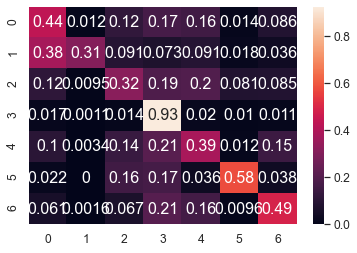

	training epoch=36 .. train_loss=0.993
	validation epoch=36 .. val_loss=1.2
	Accuracy = 55.50000000000001 % .. Percision = 54.7 % .. Recall = 49.2 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_36.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 37 .. loss = 0.898


  0%|                                                                                 | 1/1914 [00:01<43:21,  1.36s/it]

training @ epoch 37 .. loss = 0.952


  0%|                                                                                 | 2/1914 [00:02<43:24,  1.36s/it]

training @ epoch 37 .. loss = 0.977


  0%|▏                                                                                | 3/1914 [00:04<43:40,  1.37s/it]

training @ epoch 37 .. loss = 0.574


  0%|▏                                                                                | 4/1914 [00:05<43:17,  1.36s/it]

training @ epoch 37 .. loss = 1.344


  0%|▏                                                                                | 5/1914 [00:06<42:32,  1.34s/it]

training @ epoch 37 .. loss = 1.567


  0%|▎                                                                                | 6/1914 [00:08<42:04,  1.32s/it]

training @ epoch 37 .. loss = 0.802


  0%|▎                                                                                | 7/1914 [00:09<42:39,  1.34s/it]

training @ epoch 37 .. loss = 0.881


  0%|▎                                                                                | 8/1914 [00:10<42:16,  1.33s/it]

training @ epoch 37 .. loss = 0.823


  0%|▍                                                                                | 9/1914 [00:12<42:12,  1.33s/it]

training @ epoch 37 .. loss = 0.762


  1%|▍                                                                               | 10/1914 [00:13<42:08,  1.33s/it]

training @ epoch 37 .. loss = 0.579


  1%|▍                                                                               | 11/1914 [00:14<41:52,  1.32s/it]

training @ epoch 37 .. loss = 0.559


  1%|▌                                                                               | 12/1914 [00:16<42:04,  1.33s/it]

training @ epoch 37 .. loss = 0.883


  1%|▌                                                                               | 13/1914 [00:17<41:49,  1.32s/it]

training @ epoch 37 .. loss = 0.885


  1%|▌                                                                               | 14/1914 [00:18<41:50,  1.32s/it]

training @ epoch 37 .. loss = 1.0


  1%|▋                                                                               | 15/1914 [00:19<41:55,  1.32s/it]

training @ epoch 37 .. loss = 1.385


  1%|▋                                                                               | 16/1914 [00:21<41:58,  1.33s/it]

training @ epoch 37 .. loss = 0.967


  1%|▋                                                                               | 17/1914 [00:22<42:23,  1.34s/it]

training @ epoch 37 .. loss = 0.878


  1%|▊                                                                               | 18/1914 [00:23<42:02,  1.33s/it]

training @ epoch 37 .. loss = 1.167


  1%|▊                                                                               | 19/1914 [00:25<42:20,  1.34s/it]

training @ epoch 37 .. loss = 1.13


  1%|▊                                                                               | 20/1914 [00:26<42:19,  1.34s/it]

training @ epoch 37 .. loss = 1.075


  1%|▉                                                                               | 21/1914 [00:28<42:10,  1.34s/it]

training @ epoch 37 .. loss = 1.193


  1%|▉                                                                               | 22/1914 [00:29<42:23,  1.34s/it]

training @ epoch 37 .. loss = 1.562


  1%|▉                                                                               | 23/1914 [00:30<41:59,  1.33s/it]

training @ epoch 37 .. loss = 1.133


  1%|█                                                                               | 24/1914 [00:31<41:42,  1.32s/it]

training @ epoch 37 .. loss = 0.897


  1%|█                                                                               | 25/1914 [00:33<41:57,  1.33s/it]

training @ epoch 37 .. loss = 1.422


  1%|█                                                                               | 26/1914 [00:34<42:08,  1.34s/it]

training @ epoch 37 .. loss = 0.795


  1%|█▏                                                                              | 27/1914 [00:36<41:50,  1.33s/it]

training @ epoch 37 .. loss = 0.839


  1%|█▏                                                                              | 28/1914 [00:37<41:57,  1.33s/it]

training @ epoch 37 .. loss = 1.504


  2%|█▏                                                                              | 29/1914 [00:38<42:06,  1.34s/it]

training @ epoch 37 .. loss = 1.201


  2%|█▎                                                                              | 30/1914 [00:39<41:27,  1.32s/it]

training @ epoch 37 .. loss = 0.797


  2%|█▎                                                                              | 31/1914 [00:41<42:08,  1.34s/it]

training @ epoch 37 .. loss = 0.832


  2%|█▎                                                                              | 32/1914 [00:42<42:13,  1.35s/it]

training @ epoch 37 .. loss = 0.972


  2%|█▍                                                                              | 33/1914 [00:44<41:47,  1.33s/it]

training @ epoch 37 .. loss = 1.037


  2%|█▍                                                                              | 34/1914 [00:45<42:04,  1.34s/it]

training @ epoch 37 .. loss = 0.77


  2%|█▍                                                                              | 35/1914 [00:46<41:56,  1.34s/it]

training @ epoch 37 .. loss = 0.98


  2%|█▌                                                                              | 36/1914 [00:48<41:58,  1.34s/it]

training @ epoch 37 .. loss = 1.281


  2%|█▌                                                                              | 37/1914 [00:49<41:42,  1.33s/it]

training @ epoch 37 .. loss = 0.986


  2%|█▌                                                                              | 38/1914 [00:50<41:59,  1.34s/it]

training @ epoch 37 .. loss = 1.207


  2%|█▋                                                                              | 39/1914 [00:52<41:12,  1.32s/it]

training @ epoch 37 .. loss = 0.993


  2%|█▋                                                                              | 40/1914 [00:53<41:08,  1.32s/it]

training @ epoch 37 .. loss = 0.841


  2%|█▋                                                                              | 41/1914 [00:54<41:21,  1.32s/it]

training @ epoch 37 .. loss = 1.557


  2%|█▊                                                                              | 42/1914 [00:55<40:58,  1.31s/it]

training @ epoch 37 .. loss = 0.581


  2%|█▊                                                                              | 43/1914 [00:57<40:50,  1.31s/it]

training @ epoch 37 .. loss = 0.833


  2%|█▊                                                                              | 44/1914 [00:58<41:15,  1.32s/it]

training @ epoch 37 .. loss = 0.946


  2%|█▉                                                                              | 45/1914 [00:59<40:45,  1.31s/it]

training @ epoch 37 .. loss = 0.592


  2%|█▉                                                                              | 46/1914 [01:01<41:38,  1.34s/it]

training @ epoch 37 .. loss = 0.736


  2%|█▉                                                                              | 47/1914 [01:02<41:17,  1.33s/it]

training @ epoch 37 .. loss = 1.184


  3%|██                                                                              | 48/1914 [01:03<41:25,  1.33s/it]

training @ epoch 37 .. loss = 0.706


  3%|██                                                                              | 49/1914 [01:05<41:25,  1.33s/it]

training @ epoch 37 .. loss = 0.942


  3%|██                                                                              | 50/1914 [01:06<41:20,  1.33s/it]

training @ epoch 37 .. loss = 0.548


  3%|██▏                                                                             | 51/1914 [01:07<41:03,  1.32s/it]

training @ epoch 37 .. loss = 0.773


  3%|██▏                                                                             | 52/1914 [01:09<41:13,  1.33s/it]

training @ epoch 37 .. loss = 1.294


  3%|██▏                                                                             | 53/1914 [01:10<40:47,  1.32s/it]

training @ epoch 37 .. loss = 1.211


  3%|██▎                                                                             | 54/1914 [01:11<40:51,  1.32s/it]

training @ epoch 37 .. loss = 0.725


  3%|██▎                                                                             | 55/1914 [01:13<41:10,  1.33s/it]

training @ epoch 37 .. loss = 0.769


  3%|██▎                                                                             | 56/1914 [01:14<41:11,  1.33s/it]

training @ epoch 37 .. loss = 1.215


  3%|██▍                                                                             | 57/1914 [01:15<41:01,  1.33s/it]

training @ epoch 37 .. loss = 1.252


  3%|██▍                                                                             | 58/1914 [01:17<41:16,  1.33s/it]

training @ epoch 37 .. loss = 0.638


  3%|██▍                                                                             | 59/1914 [01:18<41:31,  1.34s/it]

training @ epoch 37 .. loss = 1.283


  3%|██▌                                                                             | 60/1914 [01:19<41:36,  1.35s/it]

training @ epoch 37 .. loss = 0.999


  3%|██▌                                                                             | 61/1914 [01:21<41:28,  1.34s/it]

training @ epoch 37 .. loss = 0.917


  3%|██▌                                                                             | 62/1914 [01:22<41:27,  1.34s/it]

training @ epoch 37 .. loss = 1.058


  3%|██▋                                                                             | 63/1914 [01:23<40:41,  1.32s/it]

training @ epoch 37 .. loss = 0.837


  3%|██▋                                                                             | 64/1914 [01:25<41:09,  1.34s/it]

training @ epoch 37 .. loss = 1.137


  3%|██▋                                                                             | 65/1914 [01:26<41:26,  1.34s/it]

training @ epoch 37 .. loss = 0.734


  3%|██▊                                                                             | 66/1914 [01:27<41:44,  1.36s/it]

training @ epoch 37 .. loss = 0.988


  4%|██▊                                                                             | 67/1914 [01:29<41:35,  1.35s/it]

training @ epoch 37 .. loss = 0.873


  4%|██▊                                                                             | 68/1914 [01:30<41:26,  1.35s/it]

training @ epoch 37 .. loss = 0.922


  4%|██▉                                                                             | 69/1914 [01:32<41:46,  1.36s/it]

training @ epoch 37 .. loss = 0.716


  4%|██▉                                                                             | 70/1914 [01:33<41:31,  1.35s/it]

training @ epoch 37 .. loss = 1.543


  4%|██▉                                                                             | 71/1914 [01:34<41:09,  1.34s/it]

training @ epoch 37 .. loss = 0.992


  4%|███                                                                             | 72/1914 [01:35<40:41,  1.33s/it]

training @ epoch 37 .. loss = 0.924


  4%|███                                                                             | 73/1914 [01:37<41:18,  1.35s/it]

training @ epoch 37 .. loss = 0.736


  4%|███                                                                             | 74/1914 [01:38<40:54,  1.33s/it]

training @ epoch 37 .. loss = 0.882


  4%|███▏                                                                            | 75/1914 [01:40<40:57,  1.34s/it]

training @ epoch 37 .. loss = 0.528


  4%|███▏                                                                            | 76/1914 [01:41<41:12,  1.35s/it]

training @ epoch 37 .. loss = 0.648


  4%|███▏                                                                            | 77/1914 [01:42<40:53,  1.34s/it]

training @ epoch 37 .. loss = 1.173


  4%|███▎                                                                            | 78/1914 [01:44<40:27,  1.32s/it]

training @ epoch 37 .. loss = 1.071


  4%|███▎                                                                            | 79/1914 [01:45<41:12,  1.35s/it]

training @ epoch 37 .. loss = 0.666


  4%|███▎                                                                            | 80/1914 [01:46<41:09,  1.35s/it]

training @ epoch 37 .. loss = 0.618


  4%|███▍                                                                            | 81/1914 [01:48<40:27,  1.32s/it]

training @ epoch 37 .. loss = 1.3


  4%|███▍                                                                            | 82/1914 [01:49<40:31,  1.33s/it]

training @ epoch 37 .. loss = 0.925


  4%|███▍                                                                            | 83/1914 [01:50<40:23,  1.32s/it]

training @ epoch 37 .. loss = 0.66


  4%|███▌                                                                            | 84/1914 [01:52<40:27,  1.33s/it]

training @ epoch 37 .. loss = 1.204


  4%|███▌                                                                            | 85/1914 [01:53<40:22,  1.32s/it]

training @ epoch 37 .. loss = 1.32


  4%|███▌                                                                            | 86/1914 [01:54<40:08,  1.32s/it]

training @ epoch 37 .. loss = 1.772


  5%|███▋                                                                            | 87/1914 [01:55<39:38,  1.30s/it]

training @ epoch 37 .. loss = 1.114


  5%|███▋                                                                            | 88/1914 [01:57<40:11,  1.32s/it]

training @ epoch 37 .. loss = 0.85


  5%|███▋                                                                            | 89/1914 [01:58<41:56,  1.38s/it]

training @ epoch 37 .. loss = 0.767


  5%|███▊                                                                            | 90/1914 [02:00<41:47,  1.37s/it]

training @ epoch 37 .. loss = 0.965


  5%|███▊                                                                            | 91/1914 [02:01<41:50,  1.38s/it]

training @ epoch 37 .. loss = 0.964


  5%|███▊                                                                            | 92/1914 [02:02<41:31,  1.37s/it]

training @ epoch 37 .. loss = 0.87


  5%|███▉                                                                            | 93/1914 [02:04<41:06,  1.35s/it]

training @ epoch 37 .. loss = 0.935


  5%|███▉                                                                            | 94/1914 [02:05<40:43,  1.34s/it]

training @ epoch 37 .. loss = 1.005


  5%|███▉                                                                            | 95/1914 [02:06<40:37,  1.34s/it]

training @ epoch 37 .. loss = 0.659


  5%|████                                                                            | 96/1914 [02:08<40:11,  1.33s/it]

training @ epoch 37 .. loss = 1.433


  5%|████                                                                            | 97/1914 [02:09<40:13,  1.33s/it]

training @ epoch 37 .. loss = 1.374


  5%|████                                                                            | 98/1914 [02:10<40:43,  1.35s/it]

training @ epoch 37 .. loss = 0.878


  5%|████▏                                                                           | 99/1914 [02:12<40:41,  1.35s/it]

training @ epoch 37 .. loss = 0.671


  5%|████▏                                                                          | 100/1914 [02:13<40:27,  1.34s/it]

training @ epoch 37 .. loss = 0.936


  5%|████▏                                                                          | 101/1914 [02:14<40:30,  1.34s/it]

training @ epoch 37 .. loss = 0.669


  5%|████▏                                                                          | 102/1914 [02:16<40:07,  1.33s/it]

training @ epoch 37 .. loss = 0.947


  5%|████▎                                                                          | 103/1914 [02:17<40:14,  1.33s/it]

training @ epoch 37 .. loss = 0.751


  5%|████▎                                                                          | 104/1914 [02:18<40:53,  1.36s/it]

training @ epoch 37 .. loss = 1.094


  5%|████▎                                                                          | 105/1914 [02:20<40:08,  1.33s/it]

training @ epoch 37 .. loss = 0.779


  6%|████▍                                                                          | 106/1914 [02:21<39:56,  1.33s/it]

training @ epoch 37 .. loss = 1.127


  6%|████▍                                                                          | 107/1914 [02:22<39:48,  1.32s/it]

training @ epoch 37 .. loss = 0.809


  6%|████▍                                                                          | 108/1914 [02:24<40:00,  1.33s/it]

training @ epoch 37 .. loss = 0.976


  6%|████▍                                                                          | 109/1914 [02:25<40:13,  1.34s/it]

training @ epoch 37 .. loss = 0.766


  6%|████▌                                                                          | 110/1914 [02:26<39:48,  1.32s/it]

training @ epoch 37 .. loss = 1.348


  6%|████▌                                                                          | 111/1914 [02:28<39:47,  1.32s/it]

training @ epoch 37 .. loss = 0.884


  6%|████▌                                                                          | 112/1914 [02:29<40:01,  1.33s/it]

training @ epoch 37 .. loss = 0.86


  6%|████▋                                                                          | 113/1914 [02:30<39:51,  1.33s/it]

training @ epoch 37 .. loss = 1.013


  6%|████▋                                                                          | 114/1914 [02:32<40:09,  1.34s/it]

training @ epoch 37 .. loss = 1.303


  6%|████▋                                                                          | 115/1914 [02:33<41:43,  1.39s/it]

training @ epoch 37 .. loss = 1.215


  6%|████▊                                                                          | 116/1914 [02:35<43:50,  1.46s/it]

training @ epoch 37 .. loss = 1.198


  6%|████▊                                                                          | 117/1914 [02:36<42:30,  1.42s/it]

training @ epoch 37 .. loss = 1.267


  6%|████▊                                                                          | 118/1914 [02:38<42:37,  1.42s/it]

training @ epoch 37 .. loss = 0.743


  6%|████▉                                                                          | 119/1914 [02:39<41:57,  1.40s/it]

training @ epoch 37 .. loss = 0.945


  6%|████▉                                                                          | 120/1914 [02:40<40:58,  1.37s/it]

training @ epoch 37 .. loss = 1.234


  6%|████▉                                                                          | 121/1914 [02:42<40:46,  1.36s/it]

training @ epoch 37 .. loss = 0.878


  6%|█████                                                                          | 122/1914 [02:43<40:39,  1.36s/it]

training @ epoch 37 .. loss = 0.893


  6%|█████                                                                          | 123/1914 [02:44<40:40,  1.36s/it]

training @ epoch 37 .. loss = 0.872


  6%|█████                                                                          | 124/1914 [02:46<40:07,  1.34s/it]

training @ epoch 37 .. loss = 1.17


  7%|█████▏                                                                         | 125/1914 [02:47<39:54,  1.34s/it]

training @ epoch 37 .. loss = 1.142


  7%|█████▏                                                                         | 126/1914 [02:48<39:39,  1.33s/it]

training @ epoch 37 .. loss = 1.034


  7%|█████▏                                                                         | 127/1914 [02:50<39:33,  1.33s/it]

training @ epoch 37 .. loss = 1.245


  7%|█████▎                                                                         | 128/1914 [02:51<40:04,  1.35s/it]

training @ epoch 37 .. loss = 0.786


  7%|█████▎                                                                         | 129/1914 [02:52<39:45,  1.34s/it]

training @ epoch 37 .. loss = 0.986


  7%|█████▎                                                                         | 130/1914 [02:54<39:31,  1.33s/it]

training @ epoch 37 .. loss = 1.19


  7%|█████▍                                                                         | 131/1914 [02:55<39:27,  1.33s/it]

training @ epoch 37 .. loss = 0.876


  7%|█████▍                                                                         | 132/1914 [02:56<39:29,  1.33s/it]

training @ epoch 37 .. loss = 0.777


  7%|█████▍                                                                         | 133/1914 [02:58<40:07,  1.35s/it]

training @ epoch 37 .. loss = 0.732


  7%|█████▌                                                                         | 134/1914 [02:59<39:51,  1.34s/it]

training @ epoch 37 .. loss = 1.475


  7%|█████▌                                                                         | 135/1914 [03:00<40:01,  1.35s/it]

training @ epoch 37 .. loss = 1.064


  7%|█████▌                                                                         | 136/1914 [03:02<40:02,  1.35s/it]

training @ epoch 37 .. loss = 0.937


  7%|█████▋                                                                         | 137/1914 [03:03<40:02,  1.35s/it]

training @ epoch 37 .. loss = 0.943


  7%|█████▋                                                                         | 138/1914 [03:04<40:07,  1.36s/it]

training @ epoch 37 .. loss = 1.017


  7%|█████▋                                                                         | 139/1914 [03:06<39:29,  1.33s/it]

training @ epoch 37 .. loss = 1.357


  7%|█████▊                                                                         | 140/1914 [03:07<39:16,  1.33s/it]

training @ epoch 37 .. loss = 1.156


  7%|█████▊                                                                         | 141/1914 [03:08<39:38,  1.34s/it]

training @ epoch 37 .. loss = 0.795


  7%|█████▊                                                                         | 142/1914 [03:10<39:12,  1.33s/it]

training @ epoch 37 .. loss = 1.073


  7%|█████▉                                                                         | 143/1914 [03:11<39:25,  1.34s/it]

training @ epoch 37 .. loss = 1.158


  8%|█████▉                                                                         | 144/1914 [03:12<39:22,  1.33s/it]

training @ epoch 37 .. loss = 1.477


  8%|█████▉                                                                         | 145/1914 [03:14<39:04,  1.33s/it]

training @ epoch 37 .. loss = 0.82


  8%|██████                                                                         | 146/1914 [03:15<39:08,  1.33s/it]

training @ epoch 37 .. loss = 0.891


  8%|██████                                                                         | 147/1914 [03:16<38:59,  1.32s/it]

training @ epoch 37 .. loss = 0.909


  8%|██████                                                                         | 148/1914 [03:18<38:51,  1.32s/it]

training @ epoch 37 .. loss = 0.893


  8%|██████▏                                                                        | 149/1914 [03:19<39:14,  1.33s/it]

training @ epoch 37 .. loss = 0.748


  8%|██████▏                                                                        | 150/1914 [03:20<39:40,  1.35s/it]

training @ epoch 37 .. loss = 1.566


  8%|██████▏                                                                        | 151/1914 [03:22<39:03,  1.33s/it]

training @ epoch 37 .. loss = 0.603


  8%|██████▎                                                                        | 152/1914 [03:23<39:19,  1.34s/it]

training @ epoch 37 .. loss = 0.855


  8%|██████▎                                                                        | 153/1914 [03:24<39:11,  1.34s/it]

training @ epoch 37 .. loss = 0.946


  8%|██████▎                                                                        | 154/1914 [03:26<39:08,  1.33s/it]

training @ epoch 37 .. loss = 1.166


  8%|██████▍                                                                        | 155/1914 [03:27<38:56,  1.33s/it]

training @ epoch 37 .. loss = 0.923


  8%|██████▍                                                                        | 156/1914 [03:28<39:51,  1.36s/it]

training @ epoch 37 .. loss = 1.223


  8%|██████▍                                                                        | 157/1914 [03:30<39:31,  1.35s/it]

training @ epoch 37 .. loss = 0.837


  8%|██████▌                                                                        | 158/1914 [03:31<39:10,  1.34s/it]

training @ epoch 37 .. loss = 0.632


  8%|██████▌                                                                        | 159/1914 [03:32<39:01,  1.33s/it]

training @ epoch 37 .. loss = 0.971


  8%|██████▌                                                                        | 160/1914 [03:34<38:59,  1.33s/it]

training @ epoch 37 .. loss = 0.561


  8%|██████▋                                                                        | 161/1914 [03:35<39:25,  1.35s/it]

training @ epoch 37 .. loss = 0.855


  8%|██████▋                                                                        | 162/1914 [03:36<39:26,  1.35s/it]

training @ epoch 37 .. loss = 1.372


  9%|██████▋                                                                        | 163/1914 [03:38<39:05,  1.34s/it]

training @ epoch 37 .. loss = 1.336


  9%|██████▊                                                                        | 164/1914 [03:39<38:55,  1.33s/it]

training @ epoch 37 .. loss = 1.086


  9%|██████▊                                                                        | 165/1914 [03:40<39:17,  1.35s/it]

training @ epoch 37 .. loss = 0.68


  9%|██████▊                                                                        | 166/1914 [03:42<38:56,  1.34s/it]

training @ epoch 37 .. loss = 1.116


  9%|██████▉                                                                        | 167/1914 [03:43<39:04,  1.34s/it]

training @ epoch 37 .. loss = 0.953


  9%|██████▉                                                                        | 168/1914 [03:45<40:02,  1.38s/it]

training @ epoch 37 .. loss = 1.056


  9%|██████▉                                                                        | 169/1914 [03:46<39:43,  1.37s/it]

training @ epoch 37 .. loss = 0.838


  9%|███████                                                                        | 170/1914 [03:47<39:26,  1.36s/it]

training @ epoch 37 .. loss = 1.058


  9%|███████                                                                        | 171/1914 [03:49<39:24,  1.36s/it]

training @ epoch 37 .. loss = 1.062


  9%|███████                                                                        | 172/1914 [03:50<39:06,  1.35s/it]

training @ epoch 37 .. loss = 0.843


  9%|███████▏                                                                       | 173/1914 [03:51<38:41,  1.33s/it]

training @ epoch 37 .. loss = 0.91


  9%|███████▏                                                                       | 174/1914 [03:53<39:16,  1.35s/it]

training @ epoch 37 .. loss = 1.107


  9%|███████▏                                                                       | 175/1914 [03:54<38:54,  1.34s/it]

training @ epoch 37 .. loss = 0.896


  9%|███████▎                                                                       | 176/1914 [03:55<38:43,  1.34s/it]

training @ epoch 37 .. loss = 0.715


  9%|███████▎                                                                       | 177/1914 [03:57<38:45,  1.34s/it]

training @ epoch 37 .. loss = 1.106


  9%|███████▎                                                                       | 178/1914 [03:58<38:57,  1.35s/it]

training @ epoch 37 .. loss = 0.526


  9%|███████▍                                                                       | 179/1914 [03:59<38:28,  1.33s/it]

training @ epoch 37 .. loss = 0.97


  9%|███████▍                                                                       | 180/1914 [04:01<38:54,  1.35s/it]

training @ epoch 37 .. loss = 0.935


  9%|███████▍                                                                       | 181/1914 [04:02<38:52,  1.35s/it]

training @ epoch 37 .. loss = 0.598


 10%|███████▌                                                                       | 182/1914 [04:03<38:54,  1.35s/it]

training @ epoch 37 .. loss = 1.071


 10%|███████▌                                                                       | 183/1914 [04:05<38:45,  1.34s/it]

training @ epoch 37 .. loss = 1.247


 10%|███████▌                                                                       | 184/1914 [04:06<38:34,  1.34s/it]

training @ epoch 37 .. loss = 0.725


 10%|███████▋                                                                       | 185/1914 [04:08<39:50,  1.38s/it]

training @ epoch 37 .. loss = 0.934


 10%|███████▋                                                                       | 186/1914 [04:09<41:38,  1.45s/it]

training @ epoch 37 .. loss = 1.01


 10%|███████▋                                                                       | 187/1914 [04:10<41:04,  1.43s/it]

training @ epoch 37 .. loss = 1.201


 10%|███████▊                                                                       | 188/1914 [04:12<42:02,  1.46s/it]

training @ epoch 37 .. loss = 1.133


 10%|███████▊                                                                       | 189/1914 [04:13<41:00,  1.43s/it]

training @ epoch 37 .. loss = 0.836


 10%|███████▊                                                                       | 190/1914 [04:15<40:32,  1.41s/it]

training @ epoch 37 .. loss = 0.941


 10%|███████▉                                                                       | 191/1914 [04:16<39:56,  1.39s/it]

training @ epoch 37 .. loss = 0.683


 10%|███████▉                                                                       | 192/1914 [04:17<39:35,  1.38s/it]

training @ epoch 37 .. loss = 1.375


 10%|███████▉                                                                       | 193/1914 [04:19<39:37,  1.38s/it]

training @ epoch 37 .. loss = 0.49


 10%|████████                                                                       | 194/1914 [04:20<39:41,  1.38s/it]

training @ epoch 37 .. loss = 1.036


 10%|████████                                                                       | 195/1914 [04:22<40:49,  1.42s/it]

training @ epoch 37 .. loss = 0.736


 10%|████████                                                                       | 196/1914 [04:23<40:04,  1.40s/it]

training @ epoch 37 .. loss = 0.798


 10%|████████▏                                                                      | 197/1914 [04:24<39:44,  1.39s/it]

training @ epoch 37 .. loss = 1.13


 10%|████████▏                                                                      | 198/1914 [04:26<39:05,  1.37s/it]

training @ epoch 37 .. loss = 1.074


 10%|████████▏                                                                      | 199/1914 [04:27<39:13,  1.37s/it]

training @ epoch 37 .. loss = 1.066


 10%|████████▎                                                                      | 200/1914 [04:29<40:10,  1.41s/it]

training @ epoch 37 .. loss = 1.03


 11%|████████▎                                                                      | 201/1914 [04:30<39:14,  1.37s/it]

training @ epoch 37 .. loss = 1.228


 11%|████████▎                                                                      | 202/1914 [04:31<38:16,  1.34s/it]

training @ epoch 37 .. loss = 1.037


 11%|████████▍                                                                      | 203/1914 [04:33<38:52,  1.36s/it]

training @ epoch 37 .. loss = 1.192


 11%|████████▍                                                                      | 204/1914 [04:34<38:31,  1.35s/it]

training @ epoch 37 .. loss = 1.612


 11%|████████▍                                                                      | 205/1914 [04:35<38:26,  1.35s/it]

training @ epoch 37 .. loss = 0.942


 11%|████████▌                                                                      | 206/1914 [04:37<38:33,  1.35s/it]

training @ epoch 37 .. loss = 0.996


 11%|████████▌                                                                      | 207/1914 [04:38<38:16,  1.35s/it]

training @ epoch 37 .. loss = 1.148


 11%|████████▌                                                                      | 208/1914 [04:39<37:48,  1.33s/it]

training @ epoch 37 .. loss = 0.879


 11%|████████▋                                                                      | 209/1914 [04:41<38:04,  1.34s/it]

training @ epoch 37 .. loss = 1.678


 11%|████████▋                                                                      | 210/1914 [04:42<38:10,  1.34s/it]

training @ epoch 37 .. loss = 0.879


 11%|████████▋                                                                      | 211/1914 [04:43<38:03,  1.34s/it]

training @ epoch 37 .. loss = 0.579


 11%|████████▊                                                                      | 212/1914 [04:45<38:40,  1.36s/it]

training @ epoch 37 .. loss = 0.61


 11%|████████▊                                                                      | 213/1914 [04:46<38:07,  1.35s/it]

training @ epoch 37 .. loss = 0.83


 11%|████████▊                                                                      | 214/1914 [04:47<37:24,  1.32s/it]

training @ epoch 37 .. loss = 1.517


 11%|████████▊                                                                      | 215/1914 [04:49<38:01,  1.34s/it]

training @ epoch 37 .. loss = 0.982


 11%|████████▉                                                                      | 216/1914 [04:50<37:45,  1.33s/it]

training @ epoch 37 .. loss = 0.85


 11%|████████▉                                                                      | 217/1914 [04:51<37:29,  1.33s/it]

training @ epoch 37 .. loss = 1.036


 11%|████████▉                                                                      | 218/1914 [04:53<37:32,  1.33s/it]

training @ epoch 37 .. loss = 1.115


 11%|█████████                                                                      | 219/1914 [04:54<37:39,  1.33s/it]

training @ epoch 37 .. loss = 0.924


 11%|█████████                                                                      | 220/1914 [04:55<37:18,  1.32s/it]

training @ epoch 37 .. loss = 0.794


 12%|█████████                                                                      | 221/1914 [04:57<37:42,  1.34s/it]

training @ epoch 37 .. loss = 0.984


 12%|█████████▏                                                                     | 222/1914 [04:58<38:01,  1.35s/it]

training @ epoch 37 .. loss = 1.308


 12%|█████████▏                                                                     | 223/1914 [04:59<37:11,  1.32s/it]

training @ epoch 37 .. loss = 0.772


 12%|█████████▏                                                                     | 224/1914 [05:01<37:38,  1.34s/it]

training @ epoch 37 .. loss = 0.925


 12%|█████████▎                                                                     | 225/1914 [05:02<37:55,  1.35s/it]

training @ epoch 37 .. loss = 0.686


 12%|█████████▎                                                                     | 226/1914 [05:03<37:22,  1.33s/it]

training @ epoch 37 .. loss = 0.841


 12%|█████████▎                                                                     | 227/1914 [05:05<37:49,  1.35s/it]

training @ epoch 37 .. loss = 0.827


 12%|█████████▍                                                                     | 228/1914 [05:06<37:26,  1.33s/it]

training @ epoch 37 .. loss = 0.877


 12%|█████████▍                                                                     | 229/1914 [05:07<37:11,  1.32s/it]

training @ epoch 37 .. loss = 0.674


 12%|█████████▍                                                                     | 230/1914 [05:09<37:30,  1.34s/it]

training @ epoch 37 .. loss = 1.407


 12%|█████████▌                                                                     | 231/1914 [05:10<37:27,  1.34s/it]

training @ epoch 37 .. loss = 0.823


 12%|█████████▌                                                                     | 232/1914 [05:11<37:30,  1.34s/it]

training @ epoch 37 .. loss = 0.672


 12%|█████████▌                                                                     | 233/1914 [05:13<37:17,  1.33s/it]

training @ epoch 37 .. loss = 1.138


 12%|█████████▋                                                                     | 234/1914 [05:14<37:37,  1.34s/it]

training @ epoch 37 .. loss = 1.118


 12%|█████████▋                                                                     | 235/1914 [05:15<36:56,  1.32s/it]

training @ epoch 37 .. loss = 1.174


 12%|█████████▋                                                                     | 236/1914 [05:17<37:31,  1.34s/it]

training @ epoch 37 .. loss = 0.785


 12%|█████████▊                                                                     | 237/1914 [05:18<37:36,  1.35s/it]

training @ epoch 37 .. loss = 1.128


 12%|█████████▊                                                                     | 238/1914 [05:19<36:57,  1.32s/it]

training @ epoch 37 .. loss = 0.787


 12%|█████████▊                                                                     | 239/1914 [05:21<37:28,  1.34s/it]

training @ epoch 37 .. loss = 0.76


 13%|█████████▉                                                                     | 240/1914 [05:22<37:07,  1.33s/it]

training @ epoch 37 .. loss = 0.732


 13%|█████████▉                                                                     | 241/1914 [05:23<37:11,  1.33s/it]

training @ epoch 37 .. loss = 0.89


 13%|█████████▉                                                                     | 242/1914 [05:25<37:16,  1.34s/it]

training @ epoch 37 .. loss = 1.095


 13%|██████████                                                                     | 243/1914 [05:26<37:18,  1.34s/it]

training @ epoch 37 .. loss = 0.619


 13%|██████████                                                                     | 244/1914 [05:27<37:02,  1.33s/it]

training @ epoch 37 .. loss = 0.783


 13%|██████████                                                                     | 245/1914 [05:29<37:23,  1.34s/it]

training @ epoch 37 .. loss = 1.303


 13%|██████████▏                                                                    | 246/1914 [05:30<37:07,  1.34s/it]

training @ epoch 37 .. loss = 1.306


 13%|██████████▏                                                                    | 247/1914 [05:31<36:38,  1.32s/it]

training @ epoch 37 .. loss = 0.831


 13%|██████████▏                                                                    | 248/1914 [05:33<36:51,  1.33s/it]

training @ epoch 37 .. loss = 1.514


 13%|██████████▎                                                                    | 249/1914 [05:34<37:03,  1.34s/it]

training @ epoch 37 .. loss = 1.214


 13%|██████████▎                                                                    | 250/1914 [05:35<36:46,  1.33s/it]

training @ epoch 37 .. loss = 1.252


 13%|██████████▎                                                                    | 251/1914 [05:37<36:49,  1.33s/it]

training @ epoch 37 .. loss = 0.604


 13%|██████████▍                                                                    | 252/1914 [05:38<36:39,  1.32s/it]

training @ epoch 37 .. loss = 0.813


 13%|██████████▍                                                                    | 253/1914 [05:39<36:33,  1.32s/it]

training @ epoch 37 .. loss = 0.836


 13%|██████████▍                                                                    | 254/1914 [05:41<36:50,  1.33s/it]

training @ epoch 37 .. loss = 0.847


 13%|██████████▌                                                                    | 255/1914 [05:42<36:59,  1.34s/it]

training @ epoch 37 .. loss = 0.997


 13%|██████████▌                                                                    | 256/1914 [05:43<36:46,  1.33s/it]

training @ epoch 37 .. loss = 0.672


 13%|██████████▌                                                                    | 257/1914 [05:45<36:51,  1.33s/it]

training @ epoch 37 .. loss = 1.164


 13%|██████████▋                                                                    | 258/1914 [05:46<36:59,  1.34s/it]

training @ epoch 37 .. loss = 0.954


 14%|██████████▋                                                                    | 259/1914 [05:47<36:40,  1.33s/it]

training @ epoch 37 .. loss = 0.651


 14%|██████████▋                                                                    | 260/1914 [05:49<37:01,  1.34s/it]

training @ epoch 37 .. loss = 0.851


 14%|██████████▊                                                                    | 261/1914 [05:50<36:45,  1.33s/it]

training @ epoch 37 .. loss = 0.733


 14%|██████████▊                                                                    | 262/1914 [05:51<36:33,  1.33s/it]

training @ epoch 37 .. loss = 0.761


 14%|██████████▊                                                                    | 263/1914 [05:53<36:56,  1.34s/it]

training @ epoch 37 .. loss = 0.758


 14%|██████████▉                                                                    | 264/1914 [05:54<36:50,  1.34s/it]

training @ epoch 37 .. loss = 0.922


 14%|██████████▉                                                                    | 265/1914 [05:55<36:12,  1.32s/it]

training @ epoch 37 .. loss = 1.014


 14%|██████████▉                                                                    | 266/1914 [05:57<36:28,  1.33s/it]

training @ epoch 37 .. loss = 0.768


 14%|███████████                                                                    | 267/1914 [05:58<36:30,  1.33s/it]

training @ epoch 37 .. loss = 1.354


 14%|███████████                                                                    | 268/1914 [05:59<36:21,  1.33s/it]

training @ epoch 37 .. loss = 0.862


 14%|███████████                                                                    | 269/1914 [06:01<36:49,  1.34s/it]

training @ epoch 37 .. loss = 0.914


 14%|███████████▏                                                                   | 270/1914 [06:02<36:48,  1.34s/it]

training @ epoch 37 .. loss = 1.033


 14%|███████████▏                                                                   | 271/1914 [06:03<36:17,  1.33s/it]

training @ epoch 37 .. loss = 0.832


 14%|███████████▏                                                                   | 272/1914 [06:05<36:45,  1.34s/it]

training @ epoch 37 .. loss = 1.044


 14%|███████████▎                                                                   | 273/1914 [06:06<37:04,  1.36s/it]

training @ epoch 37 .. loss = 0.556


 14%|███████████▎                                                                   | 274/1914 [06:07<36:12,  1.32s/it]

training @ epoch 37 .. loss = 0.911


 14%|███████████▎                                                                   | 275/1914 [06:09<36:19,  1.33s/it]

training @ epoch 37 .. loss = 1.113


 14%|███████████▍                                                                   | 276/1914 [06:10<36:20,  1.33s/it]

training @ epoch 37 .. loss = 0.922


 14%|███████████▍                                                                   | 277/1914 [06:11<36:01,  1.32s/it]

training @ epoch 37 .. loss = 0.888


 15%|███████████▍                                                                   | 278/1914 [06:13<36:26,  1.34s/it]

training @ epoch 37 .. loss = 0.87


 15%|███████████▌                                                                   | 279/1914 [06:14<36:03,  1.32s/it]

training @ epoch 37 .. loss = 0.913


 15%|███████████▌                                                                   | 280/1914 [06:15<35:43,  1.31s/it]

training @ epoch 37 .. loss = 0.504


 15%|███████████▌                                                                   | 281/1914 [06:17<36:02,  1.32s/it]

training @ epoch 37 .. loss = 0.707


 15%|███████████▋                                                                   | 282/1914 [06:18<35:46,  1.32s/it]

training @ epoch 37 .. loss = 1.156


 15%|███████████▋                                                                   | 283/1914 [06:19<35:58,  1.32s/it]

training @ epoch 37 .. loss = 0.681


 15%|███████████▋                                                                   | 284/1914 [06:21<36:12,  1.33s/it]

training @ epoch 37 .. loss = 0.866


 15%|███████████▊                                                                   | 285/1914 [06:22<35:43,  1.32s/it]

training @ epoch 37 .. loss = 1.335


 15%|███████████▊                                                                   | 286/1914 [06:23<35:50,  1.32s/it]

training @ epoch 37 .. loss = 0.809


 15%|███████████▊                                                                   | 287/1914 [06:25<36:15,  1.34s/it]

training @ epoch 37 .. loss = 0.812


 15%|███████████▉                                                                   | 288/1914 [06:26<36:07,  1.33s/it]

training @ epoch 37 .. loss = 0.64


 15%|███████████▉                                                                   | 289/1914 [06:27<35:32,  1.31s/it]

training @ epoch 37 .. loss = 0.938


 15%|███████████▉                                                                   | 290/1914 [06:29<36:02,  1.33s/it]

training @ epoch 37 .. loss = 1.612


 15%|████████████                                                                   | 291/1914 [06:30<36:01,  1.33s/it]

training @ epoch 37 .. loss = 0.977


 15%|████████████                                                                   | 292/1914 [06:31<36:16,  1.34s/it]

training @ epoch 37 .. loss = 0.535


 15%|████████████                                                                   | 293/1914 [06:33<36:06,  1.34s/it]

training @ epoch 37 .. loss = 1.053


 15%|████████████▏                                                                  | 294/1914 [06:34<35:54,  1.33s/it]

training @ epoch 37 .. loss = 0.842


 15%|████████████▏                                                                  | 295/1914 [06:35<36:24,  1.35s/it]

training @ epoch 37 .. loss = 1.071


 15%|████████████▏                                                                  | 296/1914 [06:37<36:15,  1.34s/it]

training @ epoch 37 .. loss = 1.283


 16%|████████████▎                                                                  | 297/1914 [06:38<36:29,  1.35s/it]

training @ epoch 37 .. loss = 1.03


 16%|████████████▎                                                                  | 298/1914 [06:39<35:42,  1.33s/it]

training @ epoch 37 .. loss = 1.379


 16%|████████████▎                                                                  | 299/1914 [06:41<35:51,  1.33s/it]

training @ epoch 37 .. loss = 1.335


 16%|████████████▍                                                                  | 300/1914 [06:42<35:46,  1.33s/it]

training @ epoch 37 .. loss = 1.281


 16%|████████████▍                                                                  | 301/1914 [06:43<35:17,  1.31s/it]

training @ epoch 37 .. loss = 1.101


 16%|████████████▍                                                                  | 302/1914 [06:45<35:55,  1.34s/it]

training @ epoch 37 .. loss = 0.825


 16%|████████████▌                                                                  | 303/1914 [06:46<35:42,  1.33s/it]

training @ epoch 37 .. loss = 1.328


 16%|████████████▌                                                                  | 304/1914 [06:47<35:58,  1.34s/it]

training @ epoch 37 .. loss = 0.625


 16%|████████████▌                                                                  | 305/1914 [06:49<35:53,  1.34s/it]

training @ epoch 37 .. loss = 1.223


 16%|████████████▋                                                                  | 306/1914 [06:50<35:35,  1.33s/it]

training @ epoch 37 .. loss = 0.809


 16%|████████████▋                                                                  | 307/1914 [06:51<35:27,  1.32s/it]

training @ epoch 37 .. loss = 1.258


 16%|████████████▋                                                                  | 308/1914 [06:53<35:54,  1.34s/it]

training @ epoch 37 .. loss = 0.89


 16%|████████████▊                                                                  | 309/1914 [06:54<35:30,  1.33s/it]

training @ epoch 37 .. loss = 0.719


 16%|████████████▊                                                                  | 310/1914 [06:55<35:17,  1.32s/it]

training @ epoch 37 .. loss = 1.049


 16%|████████████▊                                                                  | 311/1914 [06:57<35:27,  1.33s/it]

training @ epoch 37 .. loss = 0.487


 16%|████████████▉                                                                  | 312/1914 [06:58<35:53,  1.34s/it]

training @ epoch 37 .. loss = 0.751


 16%|████████████▉                                                                  | 313/1914 [06:59<35:52,  1.34s/it]

training @ epoch 37 .. loss = 1.161


 16%|████████████▉                                                                  | 314/1914 [07:01<35:49,  1.34s/it]

training @ epoch 37 .. loss = 1.278


 16%|█████████████                                                                  | 315/1914 [07:02<35:30,  1.33s/it]

training @ epoch 37 .. loss = 0.776


 17%|█████████████                                                                  | 316/1914 [07:03<35:30,  1.33s/it]

training @ epoch 37 .. loss = 1.218


 17%|█████████████                                                                  | 317/1914 [07:05<35:58,  1.35s/it]

training @ epoch 37 .. loss = 1.516


 17%|█████████████▏                                                                 | 318/1914 [07:06<35:38,  1.34s/it]

training @ epoch 37 .. loss = 1.092


 17%|█████████████▏                                                                 | 319/1914 [07:07<35:19,  1.33s/it]

training @ epoch 37 .. loss = 1.095


 17%|█████████████▏                                                                 | 320/1914 [07:09<35:06,  1.32s/it]

training @ epoch 37 .. loss = 0.549


 17%|█████████████▏                                                                 | 321/1914 [07:10<35:39,  1.34s/it]

training @ epoch 37 .. loss = 1.078


 17%|█████████████▎                                                                 | 322/1914 [07:11<35:00,  1.32s/it]

training @ epoch 37 .. loss = 0.858


 17%|█████████████▎                                                                 | 323/1914 [07:13<35:11,  1.33s/it]

training @ epoch 37 .. loss = 0.854


 17%|█████████████▎                                                                 | 324/1914 [07:14<35:08,  1.33s/it]

training @ epoch 37 .. loss = 1.07


 17%|█████████████▍                                                                 | 325/1914 [07:15<34:41,  1.31s/it]

training @ epoch 37 .. loss = 1.453


 17%|█████████████▍                                                                 | 326/1914 [07:17<35:29,  1.34s/it]

training @ epoch 37 .. loss = 0.827


 17%|█████████████▍                                                                 | 327/1914 [07:18<35:11,  1.33s/it]

training @ epoch 37 .. loss = 0.97


 17%|█████████████▌                                                                 | 328/1914 [07:19<34:43,  1.31s/it]

training @ epoch 37 .. loss = 0.691


 17%|█████████████▌                                                                 | 329/1914 [07:20<34:52,  1.32s/it]

training @ epoch 37 .. loss = 1.263


 17%|█████████████▌                                                                 | 330/1914 [07:22<34:46,  1.32s/it]

training @ epoch 37 .. loss = 1.267


 17%|█████████████▋                                                                 | 331/1914 [07:23<35:12,  1.33s/it]

training @ epoch 37 .. loss = 1.386


 17%|█████████████▋                                                                 | 332/1914 [07:25<35:11,  1.33s/it]

training @ epoch 37 .. loss = 1.029


 17%|█████████████▋                                                                 | 333/1914 [07:26<35:08,  1.33s/it]

training @ epoch 37 .. loss = 0.798


 17%|█████████████▊                                                                 | 334/1914 [07:27<34:49,  1.32s/it]

training @ epoch 37 .. loss = 0.67


 18%|█████████████▊                                                                 | 335/1914 [07:29<35:08,  1.34s/it]

training @ epoch 37 .. loss = 1.237


 18%|█████████████▊                                                                 | 336/1914 [07:30<35:21,  1.34s/it]

training @ epoch 37 .. loss = 0.886


 18%|█████████████▉                                                                 | 337/1914 [07:31<34:50,  1.33s/it]

training @ epoch 37 .. loss = 0.841


 18%|█████████████▉                                                                 | 338/1914 [07:32<34:58,  1.33s/it]

training @ epoch 37 .. loss = 1.311


 18%|█████████████▉                                                                 | 339/1914 [07:34<34:39,  1.32s/it]

training @ epoch 37 .. loss = 1.249


 18%|██████████████                                                                 | 340/1914 [07:35<34:53,  1.33s/it]

training @ epoch 37 .. loss = 0.932


 18%|██████████████                                                                 | 341/1914 [07:37<35:07,  1.34s/it]

training @ epoch 37 .. loss = 1.301


 18%|██████████████                                                                 | 342/1914 [07:38<35:04,  1.34s/it]

training @ epoch 37 .. loss = 1.195


 18%|██████████████▏                                                                | 343/1914 [07:39<35:10,  1.34s/it]

training @ epoch 37 .. loss = 1.132


 18%|██████████████▏                                                                | 344/1914 [07:41<34:55,  1.33s/it]

training @ epoch 37 .. loss = 0.59


 18%|██████████████▏                                                                | 345/1914 [07:42<35:26,  1.36s/it]

training @ epoch 37 .. loss = 1.253


 18%|██████████████▎                                                                | 346/1914 [07:43<35:15,  1.35s/it]

training @ epoch 37 .. loss = 0.659


 18%|██████████████▎                                                                | 347/1914 [07:45<35:06,  1.34s/it]

training @ epoch 37 .. loss = 1.049


 18%|██████████████▎                                                                | 348/1914 [07:46<35:19,  1.35s/it]

training @ epoch 37 .. loss = 0.999


 18%|██████████████▍                                                                | 349/1914 [07:47<34:45,  1.33s/it]

training @ epoch 37 .. loss = 1.161


 18%|██████████████▍                                                                | 350/1914 [07:49<35:13,  1.35s/it]

training @ epoch 37 .. loss = 0.652


 18%|██████████████▍                                                                | 351/1914 [07:50<35:04,  1.35s/it]

training @ epoch 37 .. loss = 0.744


 18%|██████████████▌                                                                | 352/1914 [07:51<34:38,  1.33s/it]

training @ epoch 37 .. loss = 1.045


 18%|██████████████▌                                                                | 353/1914 [07:53<34:48,  1.34s/it]

training @ epoch 37 .. loss = 0.975


 18%|██████████████▌                                                                | 354/1914 [07:54<34:30,  1.33s/it]

training @ epoch 37 .. loss = 0.921


 19%|██████████████▋                                                                | 355/1914 [07:55<35:52,  1.38s/it]

training @ epoch 37 .. loss = 0.877


 19%|██████████████▋                                                                | 356/1914 [07:57<35:13,  1.36s/it]

training @ epoch 37 .. loss = 1.059


 19%|██████████████▋                                                                | 357/1914 [07:58<34:58,  1.35s/it]

training @ epoch 37 .. loss = 1.206


 19%|██████████████▊                                                                | 358/1914 [07:59<34:41,  1.34s/it]

training @ epoch 37 .. loss = 1.49


 19%|██████████████▊                                                                | 359/1914 [08:01<34:38,  1.34s/it]

training @ epoch 37 .. loss = 0.564


 19%|██████████████▊                                                                | 360/1914 [08:02<34:59,  1.35s/it]

training @ epoch 37 .. loss = 0.874


 19%|██████████████▉                                                                | 361/1914 [08:03<34:26,  1.33s/it]

training @ epoch 37 .. loss = 1.069


 19%|██████████████▉                                                                | 362/1914 [08:05<34:26,  1.33s/it]

training @ epoch 37 .. loss = 0.709


 19%|██████████████▉                                                                | 363/1914 [08:06<34:26,  1.33s/it]

training @ epoch 37 .. loss = 0.755


 19%|███████████████                                                                | 364/1914 [08:07<34:12,  1.32s/it]

training @ epoch 37 .. loss = 0.936


 19%|███████████████                                                                | 365/1914 [08:09<34:39,  1.34s/it]

training @ epoch 37 .. loss = 0.838


 19%|███████████████                                                                | 366/1914 [08:10<34:25,  1.33s/it]

training @ epoch 37 .. loss = 0.901


 19%|███████████████▏                                                               | 367/1914 [08:12<35:29,  1.38s/it]

training @ epoch 37 .. loss = 1.28


 19%|███████████████▏                                                               | 368/1914 [08:13<34:53,  1.35s/it]

training @ epoch 37 .. loss = 0.868


 19%|███████████████▏                                                               | 369/1914 [08:14<34:33,  1.34s/it]

training @ epoch 37 .. loss = 1.262


 19%|███████████████▎                                                               | 370/1914 [08:15<34:32,  1.34s/it]

training @ epoch 37 .. loss = 1.002


 19%|███████████████▎                                                               | 371/1914 [08:17<34:23,  1.34s/it]

training @ epoch 37 .. loss = 0.713


 19%|███████████████▎                                                               | 372/1914 [08:18<34:33,  1.34s/it]

training @ epoch 37 .. loss = 0.614


 19%|███████████████▍                                                               | 373/1914 [08:19<34:09,  1.33s/it]

training @ epoch 37 .. loss = 1.235


 20%|███████████████▍                                                               | 374/1914 [08:21<34:19,  1.34s/it]

training @ epoch 37 .. loss = 0.677


 20%|███████████████▍                                                               | 375/1914 [08:22<34:21,  1.34s/it]

training @ epoch 37 .. loss = 0.78


 20%|███████████████▌                                                               | 376/1914 [08:23<33:54,  1.32s/it]

training @ epoch 37 .. loss = 0.555


 20%|███████████████▌                                                               | 377/1914 [08:25<33:57,  1.33s/it]

training @ epoch 37 .. loss = 1.015


 20%|███████████████▌                                                               | 378/1914 [08:26<33:50,  1.32s/it]

training @ epoch 37 .. loss = 1.072


 20%|███████████████▋                                                               | 379/1914 [08:27<33:38,  1.32s/it]

training @ epoch 37 .. loss = 1.081


 20%|███████████████▋                                                               | 380/1914 [08:29<36:17,  1.42s/it]

training @ epoch 37 .. loss = 0.754


 20%|███████████████▋                                                               | 381/1914 [08:31<36:41,  1.44s/it]

training @ epoch 37 .. loss = 0.558


 20%|███████████████▊                                                               | 382/1914 [08:32<36:10,  1.42s/it]

training @ epoch 37 .. loss = 1.009


 20%|███████████████▊                                                               | 383/1914 [08:33<35:45,  1.40s/it]

training @ epoch 37 .. loss = 0.681


 20%|███████████████▊                                                               | 384/1914 [08:35<35:55,  1.41s/it]

training @ epoch 37 .. loss = 0.677


 20%|███████████████▉                                                               | 385/1914 [08:36<35:19,  1.39s/it]

training @ epoch 37 .. loss = 1.004


 20%|███████████████▉                                                               | 386/1914 [08:37<34:12,  1.34s/it]

training @ epoch 37 .. loss = 0.931


 20%|███████████████▉                                                               | 387/1914 [08:39<34:11,  1.34s/it]

training @ epoch 37 .. loss = 1.108


 20%|████████████████                                                               | 388/1914 [08:40<33:47,  1.33s/it]

training @ epoch 37 .. loss = 1.262


 20%|████████████████                                                               | 389/1914 [08:41<33:39,  1.32s/it]

training @ epoch 37 .. loss = 0.989


 20%|████████████████                                                               | 390/1914 [08:43<33:45,  1.33s/it]

training @ epoch 37 .. loss = 0.974


 20%|████████████████▏                                                              | 391/1914 [08:44<33:47,  1.33s/it]

training @ epoch 37 .. loss = 0.972


 20%|████████████████▏                                                              | 392/1914 [08:45<33:33,  1.32s/it]

training @ epoch 37 .. loss = 0.966


 21%|████████████████▏                                                              | 393/1914 [08:47<33:31,  1.32s/it]

training @ epoch 37 .. loss = 1.525


 21%|████████████████▎                                                              | 394/1914 [08:48<33:36,  1.33s/it]

training @ epoch 37 .. loss = 0.722


 21%|████████████████▎                                                              | 395/1914 [08:49<33:38,  1.33s/it]

training @ epoch 37 .. loss = 0.977


 21%|████████████████▎                                                              | 396/1914 [08:51<33:38,  1.33s/it]

training @ epoch 37 .. loss = 1.033


 21%|████████████████▍                                                              | 397/1914 [08:52<33:39,  1.33s/it]

training @ epoch 37 .. loss = 0.7


 21%|████████████████▍                                                              | 398/1914 [08:53<33:07,  1.31s/it]

training @ epoch 37 .. loss = 0.923


 21%|████████████████▍                                                              | 399/1914 [08:54<33:34,  1.33s/it]

training @ epoch 37 .. loss = 1.062


 21%|████████████████▌                                                              | 400/1914 [08:56<33:44,  1.34s/it]

training @ epoch 37 .. loss = 0.925


 21%|████████████████▌                                                              | 401/1914 [08:57<33:18,  1.32s/it]

training @ epoch 37 .. loss = 0.946


 21%|████████████████▌                                                              | 402/1914 [08:58<33:23,  1.32s/it]

training @ epoch 37 .. loss = 0.738


 21%|████████████████▋                                                              | 403/1914 [09:00<33:20,  1.32s/it]

training @ epoch 37 .. loss = 0.812


 21%|████████████████▋                                                              | 404/1914 [09:01<33:23,  1.33s/it]

training @ epoch 37 .. loss = 0.991


 21%|████████████████▋                                                              | 405/1914 [09:02<33:30,  1.33s/it]

training @ epoch 37 .. loss = 1.065


 21%|████████████████▊                                                              | 406/1914 [09:04<33:34,  1.34s/it]

training @ epoch 37 .. loss = 0.842


 21%|████████████████▊                                                              | 407/1914 [09:05<33:18,  1.33s/it]

training @ epoch 37 .. loss = 0.902


 21%|████████████████▊                                                              | 408/1914 [09:07<33:48,  1.35s/it]

training @ epoch 37 .. loss = 0.755


 21%|████████████████▉                                                              | 409/1914 [09:08<33:32,  1.34s/it]

training @ epoch 37 .. loss = 0.713


 21%|████████████████▉                                                              | 410/1914 [09:09<33:15,  1.33s/it]

training @ epoch 37 .. loss = 0.663


 21%|████████████████▉                                                              | 411/1914 [09:10<33:25,  1.33s/it]

training @ epoch 37 .. loss = 0.984


 22%|█████████████████                                                              | 412/1914 [09:12<33:10,  1.33s/it]

training @ epoch 37 .. loss = 0.994


 22%|█████████████████                                                              | 413/1914 [09:13<33:19,  1.33s/it]

training @ epoch 37 .. loss = 0.986


 22%|█████████████████                                                              | 414/1914 [09:14<33:22,  1.34s/it]

training @ epoch 37 .. loss = 1.0


 22%|█████████████████▏                                                             | 415/1914 [09:16<34:24,  1.38s/it]

training @ epoch 37 .. loss = 0.969


 22%|█████████████████▏                                                             | 416/1914 [09:17<35:00,  1.40s/it]

training @ epoch 37 .. loss = 0.797


 22%|█████████████████▏                                                             | 417/1914 [09:19<35:54,  1.44s/it]

training @ epoch 37 .. loss = 0.865


 22%|█████████████████▎                                                             | 418/1914 [09:20<36:47,  1.48s/it]

training @ epoch 37 .. loss = 1.328


 22%|█████████████████▎                                                             | 419/1914 [09:22<36:41,  1.47s/it]

training @ epoch 37 .. loss = 0.954


 22%|█████████████████▎                                                             | 420/1914 [09:23<36:59,  1.49s/it]

training @ epoch 37 .. loss = 0.921


 22%|█████████████████▍                                                             | 421/1914 [09:25<36:52,  1.48s/it]

training @ epoch 37 .. loss = 0.842


 22%|█████████████████▍                                                             | 422/1914 [09:26<36:38,  1.47s/it]

training @ epoch 37 .. loss = 1.128


 22%|█████████████████▍                                                             | 423/1914 [09:28<36:52,  1.48s/it]

training @ epoch 37 .. loss = 0.871


 22%|█████████████████▌                                                             | 424/1914 [09:29<36:15,  1.46s/it]

training @ epoch 37 .. loss = 1.003


 22%|█████████████████▌                                                             | 425/1914 [09:31<36:26,  1.47s/it]

training @ epoch 37 .. loss = 1.465


 22%|█████████████████▌                                                             | 426/1914 [09:32<36:01,  1.45s/it]

training @ epoch 37 .. loss = 0.884


 22%|█████████████████▌                                                             | 427/1914 [09:34<36:15,  1.46s/it]

training @ epoch 37 .. loss = 1.304


 22%|█████████████████▋                                                             | 428/1914 [09:35<36:40,  1.48s/it]

training @ epoch 37 .. loss = 0.764


 22%|█████████████████▋                                                             | 429/1914 [09:37<37:07,  1.50s/it]

training @ epoch 37 .. loss = 0.735


 22%|█████████████████▋                                                             | 430/1914 [09:38<36:57,  1.49s/it]

training @ epoch 37 .. loss = 0.937


 23%|█████████████████▊                                                             | 431/1914 [09:40<36:51,  1.49s/it]

training @ epoch 37 .. loss = 1.018


 23%|█████████████████▊                                                             | 432/1914 [09:41<36:07,  1.46s/it]

training @ epoch 37 .. loss = 0.959


 23%|█████████████████▊                                                             | 433/1914 [09:42<35:17,  1.43s/it]

training @ epoch 37 .. loss = 1.318


 23%|█████████████████▉                                                             | 434/1914 [09:44<34:20,  1.39s/it]

training @ epoch 37 .. loss = 0.841


 23%|█████████████████▉                                                             | 435/1914 [09:45<33:44,  1.37s/it]

training @ epoch 37 .. loss = 1.097


 23%|█████████████████▉                                                             | 436/1914 [09:46<33:09,  1.35s/it]

training @ epoch 37 .. loss = 1.311


 23%|██████████████████                                                             | 437/1914 [09:48<33:20,  1.35s/it]

training @ epoch 37 .. loss = 0.886


 23%|██████████████████                                                             | 438/1914 [09:49<33:05,  1.35s/it]

training @ epoch 37 .. loss = 0.844


 23%|██████████████████                                                             | 439/1914 [09:50<32:54,  1.34s/it]

training @ epoch 37 .. loss = 0.773


 23%|██████████████████▏                                                            | 440/1914 [09:52<32:19,  1.32s/it]

training @ epoch 37 .. loss = 1.444


 23%|██████████████████▏                                                            | 441/1914 [09:53<32:21,  1.32s/it]

training @ epoch 37 .. loss = 0.591


 23%|██████████████████▏                                                            | 442/1914 [09:54<32:58,  1.34s/it]

training @ epoch 37 .. loss = 0.915


 23%|██████████████████▎                                                            | 443/1914 [09:56<32:30,  1.33s/it]

training @ epoch 37 .. loss = 0.801


 23%|██████████████████▎                                                            | 444/1914 [09:57<32:27,  1.32s/it]

training @ epoch 37 .. loss = 1.005


 23%|██████████████████▎                                                            | 445/1914 [09:58<32:39,  1.33s/it]

training @ epoch 37 .. loss = 0.531


 23%|██████████████████▍                                                            | 446/1914 [10:00<32:34,  1.33s/it]

training @ epoch 37 .. loss = 0.852


 23%|██████████████████▍                                                            | 447/1914 [10:01<32:43,  1.34s/it]

training @ epoch 37 .. loss = 1.152


 23%|██████████████████▍                                                            | 448/1914 [10:02<32:30,  1.33s/it]

training @ epoch 37 .. loss = 0.909


 23%|██████████████████▌                                                            | 449/1914 [10:04<32:04,  1.31s/it]

training @ epoch 37 .. loss = 1.274


 24%|██████████████████▌                                                            | 450/1914 [10:05<32:07,  1.32s/it]

training @ epoch 37 .. loss = 1.436


 24%|██████████████████▌                                                            | 451/1914 [10:06<32:13,  1.32s/it]

training @ epoch 37 .. loss = 1.047


 24%|██████████████████▋                                                            | 452/1914 [10:08<32:29,  1.33s/it]

training @ epoch 37 .. loss = 0.84


 24%|██████████████████▋                                                            | 453/1914 [10:09<32:20,  1.33s/it]

training @ epoch 37 .. loss = 0.725


 24%|██████████████████▋                                                            | 454/1914 [10:10<32:30,  1.34s/it]

training @ epoch 37 .. loss = 0.873


 24%|██████████████████▊                                                            | 455/1914 [10:12<32:10,  1.32s/it]

training @ epoch 37 .. loss = 0.748


 24%|██████████████████▊                                                            | 456/1914 [10:13<32:19,  1.33s/it]

training @ epoch 37 .. loss = 0.912


 24%|██████████████████▊                                                            | 457/1914 [10:14<32:32,  1.34s/it]

training @ epoch 37 .. loss = 1.859


 24%|██████████████████▉                                                            | 458/1914 [10:16<32:15,  1.33s/it]

training @ epoch 37 .. loss = 0.709


 24%|██████████████████▉                                                            | 459/1914 [10:17<32:50,  1.35s/it]

training @ epoch 37 .. loss = 1.031


 24%|██████████████████▉                                                            | 460/1914 [10:19<33:51,  1.40s/it]

training @ epoch 37 .. loss = 1.277


 24%|███████████████████                                                            | 461/1914 [10:20<34:34,  1.43s/it]

training @ epoch 37 .. loss = 0.545


 24%|███████████████████                                                            | 462/1914 [10:22<34:48,  1.44s/it]

training @ epoch 37 .. loss = 0.819


 24%|███████████████████                                                            | 463/1914 [10:23<35:03,  1.45s/it]

training @ epoch 37 .. loss = 1.017


 24%|███████████████████▏                                                           | 464/1914 [10:24<35:13,  1.46s/it]

training @ epoch 37 .. loss = 2.049


 24%|███████████████████▏                                                           | 465/1914 [10:26<35:02,  1.45s/it]

training @ epoch 37 .. loss = 0.499


 24%|███████████████████▏                                                           | 466/1914 [10:27<35:50,  1.48s/it]

training @ epoch 37 .. loss = 0.682


 24%|███████████████████▎                                                           | 467/1914 [10:29<35:41,  1.48s/it]

training @ epoch 37 .. loss = 0.871


 24%|███████████████████▎                                                           | 468/1914 [10:30<35:49,  1.49s/it]

training @ epoch 37 .. loss = 0.698


 25%|███████████████████▎                                                           | 469/1914 [10:32<35:14,  1.46s/it]

training @ epoch 37 .. loss = 0.859


 25%|███████████████████▍                                                           | 470/1914 [10:33<34:26,  1.43s/it]

training @ epoch 37 .. loss = 0.919


 25%|███████████████████▍                                                           | 471/1914 [10:35<33:42,  1.40s/it]

training @ epoch 37 .. loss = 0.937


 25%|███████████████████▍                                                           | 472/1914 [10:36<33:07,  1.38s/it]

training @ epoch 37 .. loss = 0.943


 25%|███████████████████▌                                                           | 473/1914 [10:37<32:38,  1.36s/it]

training @ epoch 37 .. loss = 0.452


 25%|███████████████████▌                                                           | 474/1914 [10:38<32:21,  1.35s/it]

training @ epoch 37 .. loss = 0.755


 25%|███████████████████▌                                                           | 475/1914 [10:40<32:11,  1.34s/it]

training @ epoch 37 .. loss = 0.947


 25%|███████████████████▋                                                           | 476/1914 [10:41<31:55,  1.33s/it]

training @ epoch 37 .. loss = 0.706


 25%|███████████████████▋                                                           | 477/1914 [10:42<31:51,  1.33s/it]

training @ epoch 37 .. loss = 1.088


 25%|███████████████████▋                                                           | 478/1914 [10:44<31:38,  1.32s/it]

training @ epoch 37 .. loss = 0.816


 25%|███████████████████▊                                                           | 479/1914 [10:45<31:46,  1.33s/it]

training @ epoch 37 .. loss = 0.636


 25%|███████████████████▊                                                           | 480/1914 [10:46<31:50,  1.33s/it]

training @ epoch 37 .. loss = 1.272


 25%|███████████████████▊                                                           | 481/1914 [10:48<31:59,  1.34s/it]

training @ epoch 37 .. loss = 0.988


 25%|███████████████████▉                                                           | 482/1914 [10:49<32:07,  1.35s/it]

training @ epoch 37 .. loss = 1.223


 25%|███████████████████▉                                                           | 483/1914 [10:51<32:19,  1.36s/it]

training @ epoch 37 .. loss = 1.122


 25%|███████████████████▉                                                           | 484/1914 [10:52<32:57,  1.38s/it]

training @ epoch 37 .. loss = 0.739


 25%|████████████████████                                                           | 485/1914 [10:53<32:39,  1.37s/it]

training @ epoch 37 .. loss = 0.816


 25%|████████████████████                                                           | 486/1914 [10:55<32:21,  1.36s/it]

training @ epoch 37 .. loss = 1.679


 25%|████████████████████                                                           | 487/1914 [10:56<32:09,  1.35s/it]

training @ epoch 37 .. loss = 1.073


 25%|████████████████████▏                                                          | 488/1914 [10:57<31:42,  1.33s/it]

training @ epoch 37 .. loss = 1.576


 26%|████████████████████▏                                                          | 489/1914 [10:59<32:15,  1.36s/it]

training @ epoch 37 .. loss = 0.758


 26%|████████████████████▏                                                          | 490/1914 [11:00<32:03,  1.35s/it]

training @ epoch 37 .. loss = 1.199


 26%|████████████████████▎                                                          | 491/1914 [11:01<31:41,  1.34s/it]

training @ epoch 37 .. loss = 1.072


 26%|████████████████████▎                                                          | 492/1914 [11:03<32:05,  1.35s/it]

training @ epoch 37 .. loss = 0.98


 26%|████████████████████▎                                                          | 493/1914 [11:04<31:46,  1.34s/it]

training @ epoch 37 .. loss = 0.809


 26%|████████████████████▍                                                          | 494/1914 [11:05<32:01,  1.35s/it]

training @ epoch 37 .. loss = 1.757


 26%|████████████████████▍                                                          | 495/1914 [11:07<31:49,  1.35s/it]

training @ epoch 37 .. loss = 0.604


 26%|████████████████████▍                                                          | 496/1914 [11:08<31:51,  1.35s/it]

training @ epoch 37 .. loss = 0.967


 26%|████████████████████▌                                                          | 497/1914 [11:09<31:35,  1.34s/it]

training @ epoch 37 .. loss = 0.676


 26%|████████████████████▌                                                          | 498/1914 [11:11<31:32,  1.34s/it]

training @ epoch 37 .. loss = 0.528


 26%|████████████████████▌                                                          | 499/1914 [11:12<31:42,  1.34s/it]

training @ epoch 37 .. loss = 0.952


 26%|████████████████████▋                                                          | 500/1914 [11:13<31:32,  1.34s/it]

training @ epoch 37 .. loss = 1.174


 26%|████████████████████▋                                                          | 501/1914 [11:15<31:33,  1.34s/it]

training @ epoch 37 .. loss = 1.156


 26%|████████████████████▋                                                          | 502/1914 [11:16<31:28,  1.34s/it]

training @ epoch 37 .. loss = 1.043


 26%|████████████████████▊                                                          | 503/1914 [11:17<31:05,  1.32s/it]

training @ epoch 37 .. loss = 0.881


 26%|████████████████████▊                                                          | 504/1914 [11:19<31:52,  1.36s/it]

training @ epoch 37 .. loss = 1.163


 26%|████████████████████▊                                                          | 505/1914 [11:20<31:18,  1.33s/it]

training @ epoch 37 .. loss = 0.881


 26%|████████████████████▉                                                          | 506/1914 [11:21<31:09,  1.33s/it]

training @ epoch 37 .. loss = 0.681


 26%|████████████████████▉                                                          | 507/1914 [11:23<31:06,  1.33s/it]

training @ epoch 37 .. loss = 0.885


 27%|████████████████████▉                                                          | 508/1914 [11:24<31:08,  1.33s/it]

training @ epoch 37 .. loss = 0.724


 27%|█████████████████████                                                          | 509/1914 [11:25<31:04,  1.33s/it]

training @ epoch 37 .. loss = 0.662


 27%|█████████████████████                                                          | 510/1914 [11:27<31:01,  1.33s/it]

training @ epoch 37 .. loss = 0.741


 27%|█████████████████████                                                          | 511/1914 [11:28<31:12,  1.33s/it]

training @ epoch 37 .. loss = 0.723


 27%|█████████████████████▏                                                         | 512/1914 [11:29<31:01,  1.33s/it]

training @ epoch 37 .. loss = 1.467


 27%|█████████████████████▏                                                         | 513/1914 [11:31<31:29,  1.35s/it]

training @ epoch 37 .. loss = 0.963


 27%|█████████████████████▏                                                         | 514/1914 [11:32<31:13,  1.34s/it]

training @ epoch 37 .. loss = 1.079


 27%|█████████████████████▎                                                         | 515/1914 [11:33<31:06,  1.33s/it]

training @ epoch 37 .. loss = 1.0


 27%|█████████████████████▎                                                         | 516/1914 [11:35<31:04,  1.33s/it]

training @ epoch 37 .. loss = 0.848


 27%|█████████████████████▎                                                         | 517/1914 [11:36<31:11,  1.34s/it]

training @ epoch 37 .. loss = 1.034


 27%|█████████████████████▍                                                         | 518/1914 [11:37<31:12,  1.34s/it]

training @ epoch 37 .. loss = 0.995


 27%|█████████████████████▍                                                         | 519/1914 [11:39<31:28,  1.35s/it]

training @ epoch 37 .. loss = 0.942


 27%|█████████████████████▍                                                         | 520/1914 [11:40<31:18,  1.35s/it]

training @ epoch 37 .. loss = 1.075


 27%|█████████████████████▌                                                         | 521/1914 [11:41<30:45,  1.32s/it]

training @ epoch 37 .. loss = 0.909


 27%|█████████████████████▌                                                         | 522/1914 [11:43<30:44,  1.33s/it]

training @ epoch 37 .. loss = 1.183


 27%|█████████████████████▌                                                         | 523/1914 [11:44<31:07,  1.34s/it]

training @ epoch 37 .. loss = 0.626


 27%|█████████████████████▋                                                         | 524/1914 [11:45<30:53,  1.33s/it]

training @ epoch 37 .. loss = 0.835


 27%|█████████████████████▋                                                         | 525/1914 [11:47<30:56,  1.34s/it]

training @ epoch 37 .. loss = 0.872


 27%|█████████████████████▋                                                         | 526/1914 [11:48<30:50,  1.33s/it]

training @ epoch 37 .. loss = 1.402


 28%|█████████████████████▊                                                         | 527/1914 [11:49<30:24,  1.32s/it]

training @ epoch 37 .. loss = 1.105


 28%|█████████████████████▊                                                         | 528/1914 [11:51<30:52,  1.34s/it]

training @ epoch 37 .. loss = 1.044


 28%|█████████████████████▊                                                         | 529/1914 [11:52<30:45,  1.33s/it]

training @ epoch 37 .. loss = 0.673


 28%|█████████████████████▉                                                         | 530/1914 [11:53<30:19,  1.31s/it]

training @ epoch 37 .. loss = 0.968


 28%|█████████████████████▉                                                         | 531/1914 [11:55<30:34,  1.33s/it]

training @ epoch 37 .. loss = 1.327


 28%|█████████████████████▉                                                         | 532/1914 [11:56<30:39,  1.33s/it]

training @ epoch 37 .. loss = 1.4


 28%|█████████████████████▉                                                         | 533/1914 [11:57<30:40,  1.33s/it]

training @ epoch 37 .. loss = 1.101


 28%|██████████████████████                                                         | 534/1914 [11:59<30:42,  1.34s/it]

training @ epoch 37 .. loss = 1.018


 28%|██████████████████████                                                         | 535/1914 [12:00<30:32,  1.33s/it]

training @ epoch 37 .. loss = 1.128


 28%|██████████████████████                                                         | 536/1914 [12:01<30:25,  1.32s/it]

training @ epoch 37 .. loss = 0.759


 28%|██████████████████████▏                                                        | 537/1914 [12:03<30:47,  1.34s/it]

training @ epoch 37 .. loss = 1.149


 28%|██████████████████████▏                                                        | 538/1914 [12:04<30:55,  1.35s/it]

training @ epoch 37 .. loss = 1.049


 28%|██████████████████████▏                                                        | 539/1914 [12:05<30:19,  1.32s/it]

training @ epoch 37 .. loss = 0.828


 28%|██████████████████████▎                                                        | 540/1914 [12:07<30:21,  1.33s/it]

training @ epoch 37 .. loss = 1.146


 28%|██████████████████████▎                                                        | 541/1914 [12:08<30:32,  1.33s/it]

training @ epoch 37 .. loss = 1.042


 28%|██████████████████████▎                                                        | 542/1914 [12:10<31:12,  1.36s/it]

training @ epoch 37 .. loss = 0.916


 28%|██████████████████████▍                                                        | 543/1914 [12:11<30:57,  1.35s/it]

training @ epoch 37 .. loss = 1.446


 28%|██████████████████████▍                                                        | 544/1914 [12:12<30:44,  1.35s/it]

training @ epoch 37 .. loss = 0.892


 28%|██████████████████████▍                                                        | 545/1914 [12:13<30:24,  1.33s/it]

training @ epoch 37 .. loss = 1.783


 29%|██████████████████████▌                                                        | 546/1914 [12:15<30:24,  1.33s/it]

training @ epoch 37 .. loss = 0.563


 29%|██████████████████████▌                                                        | 547/1914 [12:16<30:48,  1.35s/it]

training @ epoch 37 .. loss = 1.697


 29%|██████████████████████▌                                                        | 548/1914 [12:18<30:25,  1.34s/it]

training @ epoch 37 .. loss = 0.587


 29%|██████████████████████▋                                                        | 549/1914 [12:19<30:18,  1.33s/it]

training @ epoch 37 .. loss = 1.041


 29%|██████████████████████▋                                                        | 550/1914 [12:20<29:57,  1.32s/it]

training @ epoch 37 .. loss = 0.968


 29%|██████████████████████▋                                                        | 551/1914 [12:21<30:14,  1.33s/it]

training @ epoch 37 .. loss = 0.723


 29%|██████████████████████▊                                                        | 552/1914 [12:23<30:34,  1.35s/it]

training @ epoch 37 .. loss = 1.167


 29%|██████████████████████▊                                                        | 553/1914 [12:24<30:12,  1.33s/it]

training @ epoch 37 .. loss = 0.428


 29%|██████████████████████▊                                                        | 554/1914 [12:26<30:20,  1.34s/it]

training @ epoch 37 .. loss = 0.796


 29%|██████████████████████▉                                                        | 555/1914 [12:27<30:21,  1.34s/it]

training @ epoch 37 .. loss = 0.645


 29%|██████████████████████▉                                                        | 556/1914 [12:28<30:29,  1.35s/it]

training @ epoch 37 .. loss = 0.818


 29%|██████████████████████▉                                                        | 557/1914 [12:30<30:31,  1.35s/it]

training @ epoch 37 .. loss = 1.115


 29%|███████████████████████                                                        | 558/1914 [12:31<30:18,  1.34s/it]

training @ epoch 37 .. loss = 0.825


 29%|███████████████████████                                                        | 559/1914 [12:32<30:06,  1.33s/it]

training @ epoch 37 .. loss = 1.304


 29%|███████████████████████                                                        | 560/1914 [12:34<30:01,  1.33s/it]

training @ epoch 37 .. loss = 1.126


 29%|███████████████████████▏                                                       | 561/1914 [12:35<30:38,  1.36s/it]

training @ epoch 37 .. loss = 1.187


 29%|███████████████████████▏                                                       | 562/1914 [12:36<30:35,  1.36s/it]

training @ epoch 37 .. loss = 0.891


 29%|███████████████████████▏                                                       | 563/1914 [12:38<30:20,  1.35s/it]

training @ epoch 37 .. loss = 1.159


 29%|███████████████████████▎                                                       | 564/1914 [12:39<30:21,  1.35s/it]

training @ epoch 37 .. loss = 0.974


 30%|███████████████████████▎                                                       | 565/1914 [12:40<30:17,  1.35s/it]

training @ epoch 37 .. loss = 0.517


 30%|███████████████████████▎                                                       | 566/1914 [12:42<30:07,  1.34s/it]

training @ epoch 37 .. loss = 0.674


 30%|███████████████████████▍                                                       | 567/1914 [12:43<30:07,  1.34s/it]

training @ epoch 37 .. loss = 0.926


 30%|███████████████████████▍                                                       | 568/1914 [12:44<30:02,  1.34s/it]

training @ epoch 37 .. loss = 1.136


 30%|███████████████████████▍                                                       | 569/1914 [12:46<30:03,  1.34s/it]

training @ epoch 37 .. loss = 0.749


 30%|███████████████████████▌                                                       | 570/1914 [12:47<29:54,  1.34s/it]

training @ epoch 37 .. loss = 1.324


 30%|███████████████████████▌                                                       | 571/1914 [12:48<29:53,  1.34s/it]

training @ epoch 37 .. loss = 0.873


 30%|███████████████████████▌                                                       | 572/1914 [12:50<30:37,  1.37s/it]

training @ epoch 37 .. loss = 1.459


 30%|███████████████████████▋                                                       | 573/1914 [12:51<31:10,  1.39s/it]

training @ epoch 37 .. loss = 0.803


 30%|███████████████████████▋                                                       | 574/1914 [12:53<32:10,  1.44s/it]

training @ epoch 37 .. loss = 1.023


 30%|███████████████████████▋                                                       | 575/1914 [12:54<32:14,  1.45s/it]

training @ epoch 37 .. loss = 1.102


 30%|███████████████████████▊                                                       | 576/1914 [12:56<31:16,  1.40s/it]

training @ epoch 37 .. loss = 0.727


 30%|███████████████████████▊                                                       | 577/1914 [12:57<30:59,  1.39s/it]

training @ epoch 37 .. loss = 1.136


 30%|███████████████████████▊                                                       | 578/1914 [12:58<30:39,  1.38s/it]

training @ epoch 37 .. loss = 1.474


 30%|███████████████████████▉                                                       | 579/1914 [13:00<29:48,  1.34s/it]

training @ epoch 37 .. loss = 0.969


 30%|███████████████████████▉                                                       | 580/1914 [13:01<29:40,  1.33s/it]

training @ epoch 37 .. loss = 0.757


 30%|███████████████████████▉                                                       | 581/1914 [13:02<30:06,  1.36s/it]

training @ epoch 37 .. loss = 1.252


 30%|████████████████████████                                                       | 582/1914 [13:04<29:25,  1.33s/it]

training @ epoch 37 .. loss = 0.616


 30%|████████████████████████                                                       | 583/1914 [13:05<29:30,  1.33s/it]

training @ epoch 37 .. loss = 0.976


 31%|████████████████████████                                                       | 584/1914 [13:06<29:26,  1.33s/it]

training @ epoch 37 .. loss = 1.286


 31%|████████████████████████▏                                                      | 585/1914 [13:07<29:08,  1.32s/it]

training @ epoch 37 .. loss = 0.79


 31%|████████████████████████▏                                                      | 586/1914 [13:09<29:26,  1.33s/it]

training @ epoch 37 .. loss = 0.595


 31%|████████████████████████▏                                                      | 587/1914 [13:10<30:59,  1.40s/it]

training @ epoch 37 .. loss = 0.657


 31%|████████████████████████▎                                                      | 588/1914 [13:12<30:09,  1.36s/it]

training @ epoch 37 .. loss = 0.996


 31%|████████████████████████▎                                                      | 589/1914 [13:13<29:48,  1.35s/it]

training @ epoch 37 .. loss = 1.272


 31%|████████████████████████▎                                                      | 590/1914 [13:14<29:53,  1.35s/it]

training @ epoch 37 .. loss = 0.5


 31%|████████████████████████▍                                                      | 591/1914 [13:16<29:15,  1.33s/it]

training @ epoch 37 .. loss = 1.079


 31%|████████████████████████▍                                                      | 592/1914 [13:17<29:29,  1.34s/it]

training @ epoch 37 .. loss = 0.938


 31%|████████████████████████▍                                                      | 593/1914 [13:18<29:22,  1.33s/it]

training @ epoch 37 .. loss = 0.769


 31%|████████████████████████▌                                                      | 594/1914 [13:20<28:59,  1.32s/it]

training @ epoch 37 .. loss = 0.899


 31%|████████████████████████▌                                                      | 595/1914 [13:21<29:09,  1.33s/it]

training @ epoch 37 .. loss = 0.836


 31%|████████████████████████▌                                                      | 596/1914 [13:22<29:03,  1.32s/it]

training @ epoch 37 .. loss = 1.135


 31%|████████████████████████▋                                                      | 597/1914 [13:24<28:46,  1.31s/it]

training @ epoch 37 .. loss = 1.171


 31%|████████████████████████▋                                                      | 598/1914 [13:25<28:53,  1.32s/it]

training @ epoch 37 .. loss = 0.762


 31%|████████████████████████▋                                                      | 599/1914 [13:26<29:06,  1.33s/it]

training @ epoch 37 .. loss = 0.917


 31%|████████████████████████▊                                                      | 600/1914 [13:28<29:03,  1.33s/it]

training @ epoch 37 .. loss = 0.859


 31%|████████████████████████▊                                                      | 601/1914 [13:29<29:08,  1.33s/it]

training @ epoch 37 .. loss = 0.659


 31%|████████████████████████▊                                                      | 602/1914 [13:30<29:11,  1.34s/it]

training @ epoch 37 .. loss = 1.714


 32%|████████████████████████▉                                                      | 603/1914 [13:32<29:02,  1.33s/it]

training @ epoch 37 .. loss = 0.763


 32%|████████████████████████▉                                                      | 604/1914 [13:33<29:06,  1.33s/it]

training @ epoch 37 .. loss = 0.418


 32%|████████████████████████▉                                                      | 605/1914 [13:34<29:06,  1.33s/it]

training @ epoch 37 .. loss = 1.194


 32%|█████████████████████████                                                      | 606/1914 [13:35<28:40,  1.32s/it]

training @ epoch 37 .. loss = 0.774


 32%|█████████████████████████                                                      | 607/1914 [13:37<28:46,  1.32s/it]

training @ epoch 37 .. loss = 1.211


 32%|█████████████████████████                                                      | 608/1914 [13:38<28:54,  1.33s/it]

training @ epoch 37 .. loss = 1.143


 32%|█████████████████████████▏                                                     | 609/1914 [13:39<28:47,  1.32s/it]

training @ epoch 37 .. loss = 0.764


 32%|█████████████████████████▏                                                     | 610/1914 [13:41<28:54,  1.33s/it]

training @ epoch 37 .. loss = 1.221


 32%|█████████████████████████▏                                                     | 611/1914 [13:42<28:54,  1.33s/it]

training @ epoch 37 .. loss = 1.085


 32%|█████████████████████████▎                                                     | 612/1914 [13:43<28:30,  1.31s/it]

training @ epoch 37 .. loss = 1.221


 32%|█████████████████████████▎                                                     | 613/1914 [13:45<28:49,  1.33s/it]

training @ epoch 37 .. loss = 0.803


 32%|█████████████████████████▎                                                     | 614/1914 [13:46<28:48,  1.33s/it]

training @ epoch 37 .. loss = 1.1


 32%|█████████████████████████▍                                                     | 615/1914 [13:47<28:40,  1.32s/it]

training @ epoch 37 .. loss = 0.785


 32%|█████████████████████████▍                                                     | 616/1914 [13:49<28:48,  1.33s/it]

training @ epoch 37 .. loss = 1.176


 32%|█████████████████████████▍                                                     | 617/1914 [13:50<28:48,  1.33s/it]

training @ epoch 37 .. loss = 1.31


 32%|█████████████████████████▌                                                     | 618/1914 [13:51<28:22,  1.31s/it]

training @ epoch 37 .. loss = 1.018


 32%|█████████████████████████▌                                                     | 619/1914 [13:53<28:49,  1.34s/it]

training @ epoch 37 .. loss = 1.334


 32%|█████████████████████████▌                                                     | 620/1914 [13:54<29:03,  1.35s/it]

training @ epoch 37 .. loss = 1.392


 32%|█████████████████████████▋                                                     | 621/1914 [13:55<28:29,  1.32s/it]

training @ epoch 37 .. loss = 0.741


 32%|█████████████████████████▋                                                     | 622/1914 [13:57<28:36,  1.33s/it]

training @ epoch 37 .. loss = 1.247


 33%|█████████████████████████▋                                                     | 623/1914 [13:58<28:26,  1.32s/it]

training @ epoch 37 .. loss = 0.856


 33%|█████████████████████████▊                                                     | 624/1914 [13:59<28:18,  1.32s/it]

training @ epoch 37 .. loss = 0.754


 33%|█████████████████████████▊                                                     | 625/1914 [14:01<28:39,  1.33s/it]

training @ epoch 37 .. loss = 0.806


 33%|█████████████████████████▊                                                     | 626/1914 [14:02<28:30,  1.33s/it]

training @ epoch 37 .. loss = 1.266


 33%|█████████████████████████▉                                                     | 627/1914 [14:03<28:23,  1.32s/it]

training @ epoch 37 .. loss = 0.96


 33%|█████████████████████████▉                                                     | 628/1914 [14:05<28:21,  1.32s/it]

training @ epoch 37 .. loss = 0.614


 33%|█████████████████████████▉                                                     | 629/1914 [14:06<28:44,  1.34s/it]

training @ epoch 37 .. loss = 1.133


 33%|██████████████████████████                                                     | 630/1914 [14:07<28:23,  1.33s/it]

training @ epoch 37 .. loss = 1.081


 33%|██████████████████████████                                                     | 631/1914 [14:09<28:32,  1.34s/it]

training @ epoch 37 .. loss = 0.699


 33%|██████████████████████████                                                     | 632/1914 [14:10<28:39,  1.34s/it]

training @ epoch 37 .. loss = 0.951


 33%|██████████████████████████▏                                                    | 633/1914 [14:11<28:04,  1.32s/it]

training @ epoch 37 .. loss = 0.966


 33%|██████████████████████████▏                                                    | 634/1914 [14:13<28:26,  1.33s/it]

training @ epoch 37 .. loss = 1.262


 33%|██████████████████████████▏                                                    | 635/1914 [14:14<28:21,  1.33s/it]

training @ epoch 37 .. loss = 1.117


 33%|██████████████████████████▎                                                    | 636/1914 [14:15<28:05,  1.32s/it]

training @ epoch 37 .. loss = 0.938


 33%|██████████████████████████▎                                                    | 637/1914 [14:17<28:09,  1.32s/it]

training @ epoch 37 .. loss = 0.922


 33%|██████████████████████████▎                                                    | 638/1914 [14:18<28:08,  1.32s/it]

training @ epoch 37 .. loss = 1.043


 33%|██████████████████████████▎                                                    | 639/1914 [14:19<27:59,  1.32s/it]

training @ epoch 37 .. loss = 0.827


 33%|██████████████████████████▍                                                    | 640/1914 [14:21<28:12,  1.33s/it]

training @ epoch 37 .. loss = 1.062


 33%|██████████████████████████▍                                                    | 641/1914 [14:22<28:17,  1.33s/it]

training @ epoch 37 .. loss = 0.996


 34%|██████████████████████████▍                                                    | 642/1914 [14:23<27:52,  1.32s/it]

training @ epoch 37 .. loss = 0.937


 34%|██████████████████████████▌                                                    | 643/1914 [14:25<27:59,  1.32s/it]

training @ epoch 37 .. loss = 1.221


 34%|██████████████████████████▌                                                    | 644/1914 [14:26<28:05,  1.33s/it]

training @ epoch 37 .. loss = 0.704


 34%|██████████████████████████▌                                                    | 645/1914 [14:27<27:56,  1.32s/it]

training @ epoch 37 .. loss = 0.652


 34%|██████████████████████████▋                                                    | 646/1914 [14:29<27:52,  1.32s/it]

training @ epoch 37 .. loss = 0.896


 34%|██████████████████████████▋                                                    | 647/1914 [14:30<27:37,  1.31s/it]

training @ epoch 37 .. loss = 0.842


 34%|██████████████████████████▋                                                    | 648/1914 [14:31<27:33,  1.31s/it]

training @ epoch 37 .. loss = 0.635


 34%|██████████████████████████▊                                                    | 649/1914 [14:33<27:55,  1.32s/it]

training @ epoch 37 .. loss = 1.015


 34%|██████████████████████████▊                                                    | 650/1914 [14:34<27:42,  1.32s/it]

training @ epoch 37 .. loss = 1.301


 34%|██████████████████████████▊                                                    | 651/1914 [14:35<27:32,  1.31s/it]

training @ epoch 37 .. loss = 0.606


 34%|██████████████████████████▉                                                    | 652/1914 [14:36<27:33,  1.31s/it]

training @ epoch 37 .. loss = 1.12


 34%|██████████████████████████▉                                                    | 653/1914 [14:38<27:44,  1.32s/it]

training @ epoch 37 .. loss = 1.309


 34%|██████████████████████████▉                                                    | 654/1914 [14:39<27:33,  1.31s/it]

training @ epoch 37 .. loss = 0.531


 34%|███████████████████████████                                                    | 655/1914 [14:40<27:36,  1.32s/it]

training @ epoch 37 .. loss = 1.457


 34%|███████████████████████████                                                    | 656/1914 [14:42<27:34,  1.32s/it]

training @ epoch 37 .. loss = 0.853


 34%|███████████████████████████                                                    | 657/1914 [14:43<27:31,  1.31s/it]

training @ epoch 37 .. loss = 1.045


 34%|███████████████████████████▏                                                   | 658/1914 [14:44<27:35,  1.32s/it]

training @ epoch 37 .. loss = 0.953


 34%|███████████████████████████▏                                                   | 659/1914 [14:46<28:02,  1.34s/it]

training @ epoch 37 .. loss = 1.173


 34%|███████████████████████████▏                                                   | 660/1914 [14:47<27:47,  1.33s/it]

training @ epoch 37 .. loss = 0.76


 35%|███████████████████████████▎                                                   | 661/1914 [14:48<27:39,  1.32s/it]

training @ epoch 37 .. loss = 1.815


 35%|███████████████████████████▎                                                   | 662/1914 [14:50<27:38,  1.32s/it]

training @ epoch 37 .. loss = 0.928


 35%|███████████████████████████▎                                                   | 663/1914 [14:51<27:51,  1.34s/it]

training @ epoch 37 .. loss = 0.911


 35%|███████████████████████████▍                                                   | 664/1914 [14:52<27:49,  1.34s/it]

training @ epoch 37 .. loss = 1.269


 35%|███████████████████████████▍                                                   | 665/1914 [14:54<28:02,  1.35s/it]

training @ epoch 37 .. loss = 1.728


 35%|███████████████████████████▍                                                   | 666/1914 [14:56<31:41,  1.52s/it]

training @ epoch 37 .. loss = 1.221


 35%|███████████████████████████▌                                                   | 667/1914 [14:59<42:39,  2.05s/it]

training @ epoch 37 .. loss = 1.179


 35%|███████████████████████████▌                                                   | 668/1914 [15:01<40:46,  1.96s/it]

training @ epoch 37 .. loss = 0.54


 35%|███████████████████████████▌                                                   | 669/1914 [15:02<38:41,  1.86s/it]

training @ epoch 37 .. loss = 0.711


 35%|███████████████████████████▋                                                   | 670/1914 [15:04<36:28,  1.76s/it]

training @ epoch 37 .. loss = 0.848


 35%|███████████████████████████▋                                                   | 671/1914 [15:06<38:25,  1.85s/it]

training @ epoch 37 .. loss = 0.68


 35%|███████████████████████████▋                                                   | 672/1914 [15:08<38:43,  1.87s/it]

training @ epoch 37 .. loss = 0.895


 35%|███████████████████████████▊                                                   | 673/1914 [15:10<41:17,  2.00s/it]

training @ epoch 37 .. loss = 0.822


 35%|███████████████████████████▊                                                   | 674/1914 [15:12<39:40,  1.92s/it]

training @ epoch 37 .. loss = 1.084


 35%|███████████████████████████▊                                                   | 675/1914 [15:13<37:35,  1.82s/it]

training @ epoch 37 .. loss = 0.945


 35%|███████████████████████████▉                                                   | 676/1914 [15:15<35:55,  1.74s/it]

training @ epoch 37 .. loss = 1.004


 35%|███████████████████████████▉                                                   | 677/1914 [15:16<33:55,  1.65s/it]

training @ epoch 37 .. loss = 0.9


 35%|███████████████████████████▉                                                   | 678/1914 [15:18<32:21,  1.57s/it]

training @ epoch 37 .. loss = 1.313


 35%|████████████████████████████                                                   | 679/1914 [15:19<31:02,  1.51s/it]

training @ epoch 37 .. loss = 0.835


 36%|████████████████████████████                                                   | 680/1914 [15:21<30:08,  1.47s/it]

training @ epoch 37 .. loss = 0.74


 36%|████████████████████████████                                                   | 681/1914 [15:22<29:18,  1.43s/it]

training @ epoch 37 .. loss = 1.169


 36%|████████████████████████████▏                                                  | 682/1914 [15:23<28:35,  1.39s/it]

training @ epoch 37 .. loss = 1.482


 36%|████████████████████████████▏                                                  | 683/1914 [15:25<28:24,  1.38s/it]

training @ epoch 37 .. loss = 0.82


 36%|████████████████████████████▏                                                  | 684/1914 [15:26<28:00,  1.37s/it]

training @ epoch 37 .. loss = 1.272


 36%|████████████████████████████▎                                                  | 685/1914 [15:27<27:50,  1.36s/it]

training @ epoch 37 .. loss = 0.809


 36%|████████████████████████████▎                                                  | 686/1914 [15:29<28:16,  1.38s/it]

training @ epoch 37 .. loss = 0.919


 36%|████████████████████████████▎                                                  | 687/1914 [15:30<28:09,  1.38s/it]

training @ epoch 37 .. loss = 0.798


 36%|████████████████████████████▍                                                  | 688/1914 [15:31<27:51,  1.36s/it]

training @ epoch 37 .. loss = 1.126


 36%|████████████████████████████▍                                                  | 689/1914 [15:33<27:58,  1.37s/it]

training @ epoch 37 .. loss = 0.374


 36%|████████████████████████████▍                                                  | 690/1914 [15:34<27:54,  1.37s/it]

training @ epoch 37 .. loss = 0.931


 36%|████████████████████████████▌                                                  | 691/1914 [15:35<27:44,  1.36s/it]

training @ epoch 37 .. loss = 1.164


 36%|████████████████████████████▌                                                  | 692/1914 [15:37<27:44,  1.36s/it]

training @ epoch 37 .. loss = 0.788


 36%|████████████████████████████▌                                                  | 693/1914 [15:38<27:25,  1.35s/it]

training @ epoch 37 .. loss = 1.264


 36%|████████████████████████████▋                                                  | 694/1914 [15:39<27:22,  1.35s/it]

training @ epoch 37 .. loss = 1.002


 36%|████████████████████████████▋                                                  | 695/1914 [15:41<27:42,  1.36s/it]

training @ epoch 37 .. loss = 1.326


 36%|████████████████████████████▋                                                  | 696/1914 [15:42<27:37,  1.36s/it]

training @ epoch 37 .. loss = 0.949


 36%|████████████████████████████▊                                                  | 697/1914 [15:44<27:33,  1.36s/it]

training @ epoch 37 .. loss = 0.676


 36%|████████████████████████████▊                                                  | 698/1914 [15:45<27:49,  1.37s/it]

training @ epoch 37 .. loss = 1.501


 37%|████████████████████████████▊                                                  | 699/1914 [15:46<27:37,  1.36s/it]

training @ epoch 37 .. loss = 0.83


 37%|████████████████████████████▉                                                  | 700/1914 [15:48<27:35,  1.36s/it]

training @ epoch 37 .. loss = 1.23


 37%|████████████████████████████▉                                                  | 701/1914 [15:49<27:37,  1.37s/it]

training @ epoch 37 .. loss = 1.316


 37%|████████████████████████████▉                                                  | 702/1914 [15:50<27:37,  1.37s/it]

training @ epoch 37 .. loss = 0.934


 37%|█████████████████████████████                                                  | 703/1914 [15:52<27:30,  1.36s/it]

training @ epoch 37 .. loss = 1.081


 37%|█████████████████████████████                                                  | 704/1914 [15:53<27:11,  1.35s/it]

training @ epoch 37 .. loss = 0.926


 37%|█████████████████████████████                                                  | 705/1914 [15:55<27:41,  1.37s/it]

training @ epoch 37 .. loss = 0.583


 37%|█████████████████████████████▏                                                 | 706/1914 [15:56<27:32,  1.37s/it]

training @ epoch 37 .. loss = 0.793


 37%|█████████████████████████████▏                                                 | 707/1914 [15:57<27:11,  1.35s/it]

training @ epoch 37 .. loss = 0.814


 37%|█████████████████████████████▏                                                 | 708/1914 [15:59<27:25,  1.36s/it]

training @ epoch 37 .. loss = 0.817


 37%|█████████████████████████████▎                                                 | 709/1914 [16:00<27:26,  1.37s/it]

training @ epoch 37 .. loss = 0.611


 37%|█████████████████████████████▎                                                 | 710/1914 [16:01<27:10,  1.35s/it]

training @ epoch 37 .. loss = 1.407


 37%|█████████████████████████████▎                                                 | 711/1914 [16:03<27:05,  1.35s/it]

training @ epoch 37 .. loss = 1.191


 37%|█████████████████████████████▍                                                 | 712/1914 [16:04<27:23,  1.37s/it]

training @ epoch 37 .. loss = 1.157


 37%|█████████████████████████████▍                                                 | 713/1914 [16:05<27:09,  1.36s/it]

training @ epoch 37 .. loss = 1.091


 37%|█████████████████████████████▍                                                 | 714/1914 [16:07<27:33,  1.38s/it]

training @ epoch 37 .. loss = 0.725


 37%|█████████████████████████████▌                                                 | 715/1914 [16:08<27:23,  1.37s/it]

training @ epoch 37 .. loss = 0.568


 37%|█████████████████████████████▌                                                 | 716/1914 [16:09<26:57,  1.35s/it]

training @ epoch 37 .. loss = 0.905


 37%|█████████████████████████████▌                                                 | 717/1914 [16:11<27:00,  1.35s/it]

training @ epoch 37 .. loss = 0.977


 38%|█████████████████████████████▋                                                 | 718/1914 [16:12<27:18,  1.37s/it]

training @ epoch 37 .. loss = 1.579


 38%|█████████████████████████████▋                                                 | 719/1914 [16:14<28:05,  1.41s/it]

training @ epoch 37 .. loss = 0.459


 38%|█████████████████████████████▋                                                 | 720/1914 [16:15<27:43,  1.39s/it]

training @ epoch 37 .. loss = 0.835


 38%|█████████████████████████████▊                                                 | 721/1914 [16:16<27:35,  1.39s/it]

training @ epoch 37 .. loss = 0.994


 38%|█████████████████████████████▊                                                 | 722/1914 [16:18<27:21,  1.38s/it]

training @ epoch 37 .. loss = 1.157


 38%|█████████████████████████████▊                                                 | 723/1914 [16:19<27:16,  1.37s/it]

training @ epoch 37 .. loss = 0.747


 38%|█████████████████████████████▉                                                 | 724/1914 [16:21<27:17,  1.38s/it]

training @ epoch 37 .. loss = 0.67


 38%|█████████████████████████████▉                                                 | 725/1914 [16:22<27:00,  1.36s/it]

training @ epoch 37 .. loss = 0.885


 38%|█████████████████████████████▉                                                 | 726/1914 [16:23<26:49,  1.36s/it]

training @ epoch 37 .. loss = 1.076


 38%|██████████████████████████████                                                 | 727/1914 [16:25<27:08,  1.37s/it]

training @ epoch 37 .. loss = 0.629


 38%|██████████████████████████████                                                 | 728/1914 [16:26<27:20,  1.38s/it]

training @ epoch 37 .. loss = 0.677


 38%|██████████████████████████████                                                 | 729/1914 [16:27<27:08,  1.37s/it]

training @ epoch 37 .. loss = 1.433


 38%|██████████████████████████████▏                                                | 730/1914 [16:29<27:07,  1.37s/it]

training @ epoch 37 .. loss = 0.937


 38%|██████████████████████████████▏                                                | 731/1914 [16:30<27:05,  1.37s/it]

training @ epoch 37 .. loss = 0.773


 38%|██████████████████████████████▏                                                | 732/1914 [16:32<27:04,  1.37s/it]

training @ epoch 37 .. loss = 0.826


 38%|██████████████████████████████▎                                                | 733/1914 [16:33<27:20,  1.39s/it]

training @ epoch 37 .. loss = 1.026


 38%|██████████████████████████████▎                                                | 734/1914 [16:34<27:06,  1.38s/it]

training @ epoch 37 .. loss = 1.604


 38%|██████████████████████████████▎                                                | 735/1914 [16:36<27:29,  1.40s/it]

training @ epoch 37 .. loss = 1.045


 38%|██████████████████████████████▍                                                | 736/1914 [16:37<28:26,  1.45s/it]

training @ epoch 37 .. loss = 0.854


 39%|██████████████████████████████▍                                                | 737/1914 [16:39<28:05,  1.43s/it]

training @ epoch 37 .. loss = 0.828


 39%|██████████████████████████████▍                                                | 738/1914 [16:40<27:26,  1.40s/it]

training @ epoch 37 .. loss = 1.364


 39%|██████████████████████████████▌                                                | 739/1914 [16:41<27:02,  1.38s/it]

training @ epoch 37 .. loss = 1.367


 39%|██████████████████████████████▌                                                | 740/1914 [16:43<26:54,  1.38s/it]

training @ epoch 37 .. loss = 0.836


 39%|██████████████████████████████▌                                                | 741/1914 [16:44<26:42,  1.37s/it]

training @ epoch 37 .. loss = 0.983


 39%|██████████████████████████████▋                                                | 742/1914 [16:46<27:18,  1.40s/it]

training @ epoch 37 .. loss = 1.185


 39%|██████████████████████████████▋                                                | 743/1914 [16:47<27:40,  1.42s/it]

training @ epoch 37 .. loss = 0.833


 39%|██████████████████████████████▋                                                | 744/1914 [16:49<28:55,  1.48s/it]

training @ epoch 37 .. loss = 0.78


 39%|██████████████████████████████▋                                                | 745/1914 [16:50<27:58,  1.44s/it]

training @ epoch 37 .. loss = 0.661


 39%|██████████████████████████████▊                                                | 746/1914 [16:52<28:21,  1.46s/it]

training @ epoch 37 .. loss = 0.684


 39%|██████████████████████████████▊                                                | 747/1914 [16:53<27:26,  1.41s/it]

training @ epoch 37 .. loss = 1.07


 39%|██████████████████████████████▊                                                | 748/1914 [16:54<27:08,  1.40s/it]

training @ epoch 37 .. loss = 0.972


 39%|██████████████████████████████▉                                                | 749/1914 [16:56<26:55,  1.39s/it]

training @ epoch 37 .. loss = 1.184


 39%|██████████████████████████████▉                                                | 750/1914 [16:57<26:34,  1.37s/it]

training @ epoch 37 .. loss = 1.158


 39%|██████████████████████████████▉                                                | 751/1914 [16:58<26:42,  1.38s/it]

training @ epoch 37 .. loss = 1.18


 39%|███████████████████████████████                                                | 752/1914 [17:00<26:11,  1.35s/it]

training @ epoch 37 .. loss = 0.781


 39%|███████████████████████████████                                                | 753/1914 [17:01<26:21,  1.36s/it]

training @ epoch 37 .. loss = 0.866


 39%|███████████████████████████████                                                | 754/1914 [17:02<26:16,  1.36s/it]

training @ epoch 37 .. loss = 1.173


 39%|███████████████████████████████▏                                               | 755/1914 [17:04<25:51,  1.34s/it]

training @ epoch 37 .. loss = 0.983


 39%|███████████████████████████████▏                                               | 756/1914 [17:05<25:45,  1.33s/it]

training @ epoch 37 .. loss = 0.958


 40%|███████████████████████████████▏                                               | 757/1914 [17:06<25:54,  1.34s/it]

training @ epoch 37 .. loss = 1.159


 40%|███████████████████████████████▎                                               | 758/1914 [17:08<26:00,  1.35s/it]

training @ epoch 37 .. loss = 1.003


 40%|███████████████████████████████▎                                               | 759/1914 [17:09<25:56,  1.35s/it]

training @ epoch 37 .. loss = 0.491


 40%|███████████████████████████████▎                                               | 760/1914 [17:10<25:54,  1.35s/it]

training @ epoch 37 .. loss = 1.123


 40%|███████████████████████████████▍                                               | 761/1914 [17:12<25:54,  1.35s/it]

training @ epoch 37 .. loss = 0.721


 40%|███████████████████████████████▍                                               | 762/1914 [17:13<25:52,  1.35s/it]

training @ epoch 37 .. loss = 0.894


 40%|███████████████████████████████▍                                               | 763/1914 [17:14<26:03,  1.36s/it]

training @ epoch 37 .. loss = 1.276


 40%|███████████████████████████████▌                                               | 764/1914 [17:16<25:39,  1.34s/it]

training @ epoch 37 .. loss = 1.088


 40%|███████████████████████████████▌                                               | 765/1914 [17:17<25:53,  1.35s/it]

training @ epoch 37 .. loss = 0.891


 40%|███████████████████████████████▌                                               | 766/1914 [17:18<25:49,  1.35s/it]

training @ epoch 37 .. loss = 1.057


 40%|███████████████████████████████▋                                               | 767/1914 [17:20<25:38,  1.34s/it]

training @ epoch 37 .. loss = 0.906


 40%|███████████████████████████████▋                                               | 768/1914 [17:21<25:34,  1.34s/it]

training @ epoch 37 .. loss = 0.732


 40%|███████████████████████████████▋                                               | 769/1914 [17:22<25:38,  1.34s/it]

training @ epoch 37 .. loss = 0.692


 40%|███████████████████████████████▊                                               | 770/1914 [17:24<25:12,  1.32s/it]

training @ epoch 37 .. loss = 0.786


 40%|███████████████████████████████▊                                               | 771/1914 [17:25<25:25,  1.33s/it]

training @ epoch 37 .. loss = 0.769


 40%|███████████████████████████████▊                                               | 772/1914 [17:26<25:41,  1.35s/it]

training @ epoch 37 .. loss = 0.946


 40%|███████████████████████████████▉                                               | 773/1914 [17:28<25:20,  1.33s/it]

training @ epoch 37 .. loss = 0.726


 40%|███████████████████████████████▉                                               | 774/1914 [17:29<25:22,  1.34s/it]

training @ epoch 37 .. loss = 0.957


 40%|███████████████████████████████▉                                               | 775/1914 [17:30<25:26,  1.34s/it]

training @ epoch 37 .. loss = 0.919


 41%|████████████████████████████████                                               | 776/1914 [17:32<25:06,  1.32s/it]

training @ epoch 37 .. loss = 0.914


 41%|████████████████████████████████                                               | 777/1914 [17:33<25:18,  1.34s/it]

training @ epoch 37 .. loss = 0.879


 41%|████████████████████████████████                                               | 778/1914 [17:34<25:37,  1.35s/it]

training @ epoch 37 .. loss = 0.966


 41%|████████████████████████████████▏                                              | 779/1914 [17:36<25:16,  1.34s/it]

training @ epoch 37 .. loss = 0.724


 41%|████████████████████████████████▏                                              | 780/1914 [17:37<25:10,  1.33s/it]

training @ epoch 37 .. loss = 0.777


 41%|████████████████████████████████▏                                              | 781/1914 [17:38<25:27,  1.35s/it]

training @ epoch 37 .. loss = 1.239


 41%|████████████████████████████████▎                                              | 782/1914 [17:40<25:17,  1.34s/it]

training @ epoch 37 .. loss = 0.867


 41%|████████████████████████████████▎                                              | 783/1914 [17:41<25:20,  1.34s/it]

training @ epoch 37 .. loss = 1.235


 41%|████████████████████████████████▎                                              | 784/1914 [17:43<25:15,  1.34s/it]

training @ epoch 37 .. loss = 0.784


 41%|████████████████████████████████▍                                              | 785/1914 [17:44<24:58,  1.33s/it]

training @ epoch 37 .. loss = 1.084


 41%|████████████████████████████████▍                                              | 786/1914 [17:45<25:22,  1.35s/it]

training @ epoch 37 .. loss = 0.86


 41%|████████████████████████████████▍                                              | 787/1914 [17:47<25:36,  1.36s/it]

training @ epoch 37 .. loss = 0.762


 41%|████████████████████████████████▌                                              | 788/1914 [17:48<25:34,  1.36s/it]

training @ epoch 37 .. loss = 1.146


 41%|████████████████████████████████▌                                              | 789/1914 [17:49<25:30,  1.36s/it]

training @ epoch 37 .. loss = 1.014


 41%|████████████████████████████████▌                                              | 790/1914 [17:51<25:11,  1.35s/it]

training @ epoch 37 .. loss = 0.951


 41%|████████████████████████████████▋                                              | 791/1914 [17:52<25:20,  1.35s/it]

training @ epoch 37 .. loss = 0.802


 41%|████████████████████████████████▋                                              | 792/1914 [17:53<25:15,  1.35s/it]

training @ epoch 37 .. loss = 1.065


 41%|████████████████████████████████▋                                              | 793/1914 [17:55<25:11,  1.35s/it]

training @ epoch 37 .. loss = 0.954


 41%|████████████████████████████████▊                                              | 794/1914 [17:56<25:05,  1.34s/it]

training @ epoch 37 .. loss = 1.184


 42%|████████████████████████████████▊                                              | 795/1914 [17:57<24:50,  1.33s/it]

training @ epoch 37 .. loss = 0.815


 42%|████████████████████████████████▊                                              | 796/1914 [17:59<24:46,  1.33s/it]

training @ epoch 37 .. loss = 0.742


 42%|████████████████████████████████▉                                              | 797/1914 [18:00<24:43,  1.33s/it]

training @ epoch 37 .. loss = 1.153


 42%|████████████████████████████████▉                                              | 798/1914 [18:01<24:43,  1.33s/it]

training @ epoch 37 .. loss = 0.943


 42%|████████████████████████████████▉                                              | 799/1914 [18:03<24:54,  1.34s/it]

training @ epoch 37 .. loss = 0.9


 42%|█████████████████████████████████                                              | 800/1914 [18:04<24:46,  1.33s/it]

training @ epoch 37 .. loss = 0.78


 42%|█████████████████████████████████                                              | 801/1914 [18:05<24:58,  1.35s/it]

training @ epoch 37 .. loss = 0.686


 42%|█████████████████████████████████                                              | 802/1914 [18:07<24:46,  1.34s/it]

training @ epoch 37 .. loss = 0.671


 42%|█████████████████████████████████▏                                             | 803/1914 [18:08<24:43,  1.34s/it]

training @ epoch 37 .. loss = 0.566


 42%|█████████████████████████████████▏                                             | 804/1914 [18:09<24:44,  1.34s/it]

training @ epoch 37 .. loss = 1.014


 42%|█████████████████████████████████▏                                             | 805/1914 [18:11<24:34,  1.33s/it]

training @ epoch 37 .. loss = 0.845


 42%|█████████████████████████████████▎                                             | 806/1914 [18:12<24:52,  1.35s/it]

training @ epoch 37 .. loss = 1.102


 42%|█████████████████████████████████▎                                             | 807/1914 [18:14<26:10,  1.42s/it]

training @ epoch 37 .. loss = 0.931


 42%|█████████████████████████████████▎                                             | 808/1914 [18:15<25:43,  1.40s/it]

training @ epoch 37 .. loss = 0.974


 42%|█████████████████████████████████▍                                             | 809/1914 [18:17<26:42,  1.45s/it]

training @ epoch 37 .. loss = 0.808


 42%|█████████████████████████████████▍                                             | 810/1914 [18:18<26:43,  1.45s/it]

training @ epoch 37 .. loss = 0.824


 42%|█████████████████████████████████▍                                             | 811/1914 [18:19<26:02,  1.42s/it]

training @ epoch 37 .. loss = 0.677


 42%|█████████████████████████████████▌                                             | 812/1914 [18:21<25:20,  1.38s/it]

training @ epoch 37 .. loss = 1.19


 42%|█████████████████████████████████▌                                             | 813/1914 [18:22<24:40,  1.34s/it]

training @ epoch 37 .. loss = 0.813


 43%|█████████████████████████████████▌                                             | 814/1914 [18:23<24:31,  1.34s/it]

training @ epoch 37 .. loss = 0.692


 43%|█████████████████████████████████▋                                             | 815/1914 [18:25<24:26,  1.33s/it]

training @ epoch 37 .. loss = 0.724


 43%|█████████████████████████████████▋                                             | 816/1914 [18:26<24:28,  1.34s/it]

training @ epoch 37 .. loss = 0.827


 43%|█████████████████████████████████▋                                             | 817/1914 [18:27<24:16,  1.33s/it]

training @ epoch 37 .. loss = 0.755


 43%|█████████████████████████████████▊                                             | 818/1914 [18:29<24:46,  1.36s/it]

training @ epoch 37 .. loss = 0.855


 43%|█████████████████████████████████▊                                             | 819/1914 [18:30<24:54,  1.36s/it]

training @ epoch 37 .. loss = 0.567


 43%|█████████████████████████████████▊                                             | 820/1914 [18:31<24:53,  1.37s/it]

training @ epoch 37 .. loss = 1.079


 43%|█████████████████████████████████▉                                             | 821/1914 [18:33<24:35,  1.35s/it]

training @ epoch 37 .. loss = 0.598


 43%|█████████████████████████████████▉                                             | 822/1914 [18:34<24:35,  1.35s/it]

training @ epoch 37 .. loss = 1.059


 43%|█████████████████████████████████▉                                             | 823/1914 [18:35<24:35,  1.35s/it]

training @ epoch 37 .. loss = 0.943


 43%|██████████████████████████████████                                             | 824/1914 [18:37<24:38,  1.36s/it]

training @ epoch 37 .. loss = 0.961


 43%|██████████████████████████████████                                             | 825/1914 [18:38<24:32,  1.35s/it]

training @ epoch 37 .. loss = 0.797


 43%|██████████████████████████████████                                             | 826/1914 [18:39<24:21,  1.34s/it]

training @ epoch 37 .. loss = 0.9


 43%|██████████████████████████████████▏                                            | 827/1914 [18:41<24:13,  1.34s/it]

training @ epoch 37 .. loss = 0.965


 43%|██████████████████████████████████▏                                            | 828/1914 [18:42<24:11,  1.34s/it]

training @ epoch 37 .. loss = 1.044


 43%|██████████████████████████████████▏                                            | 829/1914 [18:43<24:22,  1.35s/it]

training @ epoch 37 .. loss = 0.817


 43%|██████████████████████████████████▎                                            | 830/1914 [18:45<24:06,  1.33s/it]

training @ epoch 37 .. loss = 0.995


 43%|██████████████████████████████████▎                                            | 831/1914 [18:46<24:14,  1.34s/it]

training @ epoch 37 .. loss = 1.053


 43%|██████████████████████████████████▎                                            | 832/1914 [18:47<23:57,  1.33s/it]

training @ epoch 37 .. loss = 0.862


 44%|██████████████████████████████████▍                                            | 833/1914 [18:49<23:54,  1.33s/it]

training @ epoch 37 .. loss = 1.616


 44%|██████████████████████████████████▍                                            | 834/1914 [18:50<24:15,  1.35s/it]

training @ epoch 37 .. loss = 0.965


 44%|██████████████████████████████████▍                                            | 835/1914 [18:51<24:12,  1.35s/it]

training @ epoch 37 .. loss = 1.294


 44%|██████████████████████████████████▌                                            | 836/1914 [18:53<24:01,  1.34s/it]

training @ epoch 37 .. loss = 1.351


 44%|██████████████████████████████████▌                                            | 837/1914 [18:54<23:58,  1.34s/it]

training @ epoch 37 .. loss = 1.083


 44%|██████████████████████████████████▌                                            | 838/1914 [18:55<23:44,  1.32s/it]

training @ epoch 37 .. loss = 1.126


 44%|██████████████████████████████████▋                                            | 839/1914 [18:57<23:42,  1.32s/it]

training @ epoch 37 .. loss = 0.337


 44%|██████████████████████████████████▋                                            | 840/1914 [18:58<23:51,  1.33s/it]

training @ epoch 37 .. loss = 0.731


 44%|██████████████████████████████████▋                                            | 841/1914 [18:59<23:52,  1.34s/it]

training @ epoch 37 .. loss = 1.813


 44%|██████████████████████████████████▊                                            | 842/1914 [19:01<23:34,  1.32s/it]

training @ epoch 37 .. loss = 1.351


 44%|██████████████████████████████████▊                                            | 843/1914 [19:02<23:51,  1.34s/it]

training @ epoch 37 .. loss = 0.725


 44%|██████████████████████████████████▊                                            | 844/1914 [19:03<23:59,  1.35s/it]

training @ epoch 37 .. loss = 1.294


 44%|██████████████████████████████████▉                                            | 845/1914 [19:05<23:53,  1.34s/it]

training @ epoch 37 .. loss = 1.123


 44%|██████████████████████████████████▉                                            | 846/1914 [19:06<23:53,  1.34s/it]

training @ epoch 37 .. loss = 0.948


 44%|██████████████████████████████████▉                                            | 847/1914 [19:07<23:26,  1.32s/it]

training @ epoch 37 .. loss = 0.744


 44%|███████████████████████████████████                                            | 848/1914 [19:09<23:48,  1.34s/it]

training @ epoch 37 .. loss = 1.13


 44%|███████████████████████████████████                                            | 849/1914 [19:10<23:46,  1.34s/it]

training @ epoch 37 .. loss = 1.11


 44%|███████████████████████████████████                                            | 850/1914 [19:11<23:17,  1.31s/it]

training @ epoch 37 .. loss = 0.876


 44%|███████████████████████████████████                                            | 851/1914 [19:13<23:19,  1.32s/it]

training @ epoch 37 .. loss = 1.274


 45%|███████████████████████████████████▏                                           | 852/1914 [19:14<24:18,  1.37s/it]

training @ epoch 37 .. loss = 0.752


 45%|███████████████████████████████████▏                                           | 853/1914 [19:16<24:15,  1.37s/it]

training @ epoch 37 .. loss = 1.103


 45%|███████████████████████████████████▏                                           | 854/1914 [19:17<24:46,  1.40s/it]

training @ epoch 37 .. loss = 1.508


 45%|███████████████████████████████████▎                                           | 855/1914 [19:19<25:39,  1.45s/it]

training @ epoch 37 .. loss = 1.255


 45%|███████████████████████████████████▎                                           | 856/1914 [19:20<25:55,  1.47s/it]

training @ epoch 37 .. loss = 1.028


 45%|███████████████████████████████████▎                                           | 857/1914 [19:22<25:59,  1.48s/it]

training @ epoch 37 .. loss = 0.998


 45%|███████████████████████████████████▍                                           | 858/1914 [19:23<26:01,  1.48s/it]

training @ epoch 37 .. loss = 1.171


 45%|███████████████████████████████████▍                                           | 859/1914 [19:25<26:13,  1.49s/it]

training @ epoch 37 .. loss = 1.442


 45%|███████████████████████████████████▍                                           | 860/1914 [19:26<26:18,  1.50s/it]

training @ epoch 37 .. loss = 0.802


 45%|███████████████████████████████████▌                                           | 861/1914 [19:28<26:23,  1.50s/it]

training @ epoch 37 .. loss = 1.046


 45%|███████████████████████████████████▌                                           | 862/1914 [19:29<26:18,  1.50s/it]

training @ epoch 37 .. loss = 0.638


 45%|███████████████████████████████████▌                                           | 863/1914 [19:31<26:17,  1.50s/it]

training @ epoch 37 .. loss = 2.176


 45%|███████████████████████████████████▋                                           | 864/1914 [19:32<26:17,  1.50s/it]

training @ epoch 37 .. loss = 0.906


 45%|███████████████████████████████████▋                                           | 865/1914 [19:34<26:33,  1.52s/it]

training @ epoch 37 .. loss = 1.06


 45%|███████████████████████████████████▋                                           | 866/1914 [19:35<26:47,  1.53s/it]

training @ epoch 37 .. loss = 1.213


 45%|███████████████████████████████████▊                                           | 867/1914 [19:37<26:59,  1.55s/it]

training @ epoch 37 .. loss = 0.859


 45%|███████████████████████████████████▊                                           | 868/1914 [19:38<26:50,  1.54s/it]

training @ epoch 37 .. loss = 1.178


 45%|███████████████████████████████████▊                                           | 869/1914 [19:40<26:32,  1.52s/it]

training @ epoch 37 .. loss = 0.691


 45%|███████████████████████████████████▉                                           | 870/1914 [19:41<26:12,  1.51s/it]

training @ epoch 37 .. loss = 1.125


 46%|███████████████████████████████████▉                                           | 871/1914 [19:43<25:45,  1.48s/it]

training @ epoch 37 .. loss = 1.233


 46%|███████████████████████████████████▉                                           | 872/1914 [19:44<25:10,  1.45s/it]

training @ epoch 37 .. loss = 0.757


 46%|████████████████████████████████████                                           | 873/1914 [19:45<24:32,  1.41s/it]

training @ epoch 37 .. loss = 1.189


 46%|████████████████████████████████████                                           | 874/1914 [19:47<23:50,  1.38s/it]

training @ epoch 37 .. loss = 0.531


 46%|████████████████████████████████████                                           | 875/1914 [19:48<23:42,  1.37s/it]

training @ epoch 37 .. loss = 0.955


 46%|████████████████████████████████████▏                                          | 876/1914 [19:49<23:24,  1.35s/it]

training @ epoch 37 .. loss = 0.895


 46%|████████████████████████████████████▏                                          | 877/1914 [19:51<23:31,  1.36s/it]

training @ epoch 37 .. loss = 0.699


 46%|████████████████████████████████████▏                                          | 878/1914 [19:52<23:18,  1.35s/it]

training @ epoch 37 .. loss = 0.919


 46%|████████████████████████████████████▎                                          | 879/1914 [19:53<23:03,  1.34s/it]

training @ epoch 37 .. loss = 0.738


 46%|████████████████████████████████████▎                                          | 880/1914 [19:55<23:04,  1.34s/it]

training @ epoch 37 .. loss = 1.267


 46%|████████████████████████████████████▎                                          | 881/1914 [19:56<22:51,  1.33s/it]

training @ epoch 37 .. loss = 0.715


 46%|████████████████████████████████████▍                                          | 882/1914 [19:57<23:02,  1.34s/it]

training @ epoch 37 .. loss = 0.941


 46%|████████████████████████████████████▍                                          | 883/1914 [19:59<22:43,  1.32s/it]

training @ epoch 37 .. loss = 0.895


 46%|████████████████████████████████████▍                                          | 884/1914 [20:00<22:45,  1.33s/it]

training @ epoch 37 .. loss = 0.968


 46%|████████████████████████████████████▌                                          | 885/1914 [20:01<22:46,  1.33s/it]

training @ epoch 37 .. loss = 0.656


 46%|████████████████████████████████████▌                                          | 886/1914 [20:03<22:44,  1.33s/it]

training @ epoch 37 .. loss = 0.932


 46%|████████████████████████████████████▌                                          | 887/1914 [20:04<22:54,  1.34s/it]

training @ epoch 37 .. loss = 0.422


 46%|████████████████████████████████████▋                                          | 888/1914 [20:05<22:42,  1.33s/it]

training @ epoch 37 .. loss = 1.039


 46%|████████████████████████████████████▋                                          | 889/1914 [20:07<22:33,  1.32s/it]

training @ epoch 37 .. loss = 0.982


 46%|████████████████████████████████████▋                                          | 890/1914 [20:08<22:32,  1.32s/it]

training @ epoch 37 .. loss = 0.881


 47%|████████████████████████████████████▊                                          | 891/1914 [20:09<22:35,  1.33s/it]

training @ epoch 37 .. loss = 1.424


 47%|████████████████████████████████████▊                                          | 892/1914 [20:11<22:37,  1.33s/it]

training @ epoch 37 .. loss = 1.261


 47%|████████████████████████████████████▊                                          | 893/1914 [20:12<22:40,  1.33s/it]

training @ epoch 37 .. loss = 0.968


 47%|████████████████████████████████████▉                                          | 894/1914 [20:13<22:36,  1.33s/it]

training @ epoch 37 .. loss = 1.111


 47%|████████████████████████████████████▉                                          | 895/1914 [20:15<22:36,  1.33s/it]

training @ epoch 37 .. loss = 1.608


 47%|████████████████████████████████████▉                                          | 896/1914 [20:16<22:29,  1.33s/it]

training @ epoch 37 .. loss = 0.751


 47%|█████████████████████████████████████                                          | 897/1914 [20:17<22:52,  1.35s/it]

training @ epoch 37 .. loss = 1.031


 47%|█████████████████████████████████████                                          | 898/1914 [20:19<23:25,  1.38s/it]

training @ epoch 37 .. loss = 0.801


 47%|█████████████████████████████████████                                          | 899/1914 [20:20<23:49,  1.41s/it]

training @ epoch 37 .. loss = 0.961


 47%|█████████████████████████████████████▏                                         | 900/1914 [20:22<23:22,  1.38s/it]

training @ epoch 37 .. loss = 1.177


 47%|█████████████████████████████████████▏                                         | 901/1914 [20:23<23:42,  1.40s/it]

training @ epoch 37 .. loss = 1.314


 47%|█████████████████████████████████████▏                                         | 902/1914 [20:25<23:59,  1.42s/it]

training @ epoch 37 .. loss = 0.995


 47%|█████████████████████████████████████▎                                         | 903/1914 [20:26<23:31,  1.40s/it]

training @ epoch 37 .. loss = 1.302


 47%|█████████████████████████████████████▎                                         | 904/1914 [20:27<23:01,  1.37s/it]

training @ epoch 37 .. loss = 1.087


 47%|█████████████████████████████████████▎                                         | 905/1914 [20:29<22:44,  1.35s/it]

training @ epoch 37 .. loss = 0.954


 47%|█████████████████████████████████████▍                                         | 906/1914 [20:30<22:48,  1.36s/it]

training @ epoch 37 .. loss = 1.17


 47%|█████████████████████████████████████▍                                         | 907/1914 [20:31<22:36,  1.35s/it]

training @ epoch 37 .. loss = 0.866


 47%|█████████████████████████████████████▍                                         | 908/1914 [20:33<22:28,  1.34s/it]

training @ epoch 37 .. loss = 0.749


 47%|█████████████████████████████████████▌                                         | 909/1914 [20:34<22:19,  1.33s/it]

training @ epoch 37 .. loss = 1.505


 48%|█████████████████████████████████████▌                                         | 910/1914 [20:35<22:18,  1.33s/it]

training @ epoch 37 .. loss = 1.423


 48%|█████████████████████████████████████▌                                         | 911/1914 [20:37<22:32,  1.35s/it]

training @ epoch 37 .. loss = 1.233


 48%|█████████████████████████████████████▋                                         | 912/1914 [20:38<22:11,  1.33s/it]

training @ epoch 37 .. loss = 0.757


 48%|█████████████████████████████████████▋                                         | 913/1914 [20:39<22:14,  1.33s/it]

training @ epoch 37 .. loss = 1.405


 48%|█████████████████████████████████████▋                                         | 914/1914 [20:41<22:04,  1.32s/it]

training @ epoch 37 .. loss = 1.163


 48%|█████████████████████████████████████▊                                         | 915/1914 [20:42<22:09,  1.33s/it]

training @ epoch 37 .. loss = 1.088


 48%|█████████████████████████████████████▊                                         | 916/1914 [20:43<22:12,  1.33s/it]

training @ epoch 37 .. loss = 0.668


 48%|█████████████████████████████████████▊                                         | 917/1914 [20:45<22:06,  1.33s/it]

training @ epoch 37 .. loss = 1.008


 48%|█████████████████████████████████████▉                                         | 918/1914 [20:46<22:00,  1.33s/it]

training @ epoch 37 .. loss = 1.323


 48%|█████████████████████████████████████▉                                         | 919/1914 [20:47<21:55,  1.32s/it]

training @ epoch 37 .. loss = 0.667


 48%|█████████████████████████████████████▉                                         | 920/1914 [20:49<22:13,  1.34s/it]

training @ epoch 37 .. loss = 0.829


 48%|██████████████████████████████████████                                         | 921/1914 [20:50<22:07,  1.34s/it]

training @ epoch 37 .. loss = 1.189


 48%|██████████████████████████████████████                                         | 922/1914 [20:51<22:02,  1.33s/it]

training @ epoch 37 .. loss = 0.768


 48%|██████████████████████████████████████                                         | 923/1914 [20:53<22:01,  1.33s/it]

training @ epoch 37 .. loss = 0.826


 48%|██████████████████████████████████████▏                                        | 924/1914 [20:54<21:48,  1.32s/it]

training @ epoch 37 .. loss = 0.719


 48%|██████████████████████████████████████▏                                        | 925/1914 [20:55<21:50,  1.33s/it]

training @ epoch 37 .. loss = 0.801


 48%|██████████████████████████████████████▏                                        | 926/1914 [20:57<22:04,  1.34s/it]

training @ epoch 37 .. loss = 0.801


 48%|██████████████████████████████████████▎                                        | 927/1914 [20:58<21:42,  1.32s/it]

training @ epoch 37 .. loss = 0.916


 48%|██████████████████████████████████████▎                                        | 928/1914 [20:59<21:45,  1.32s/it]

training @ epoch 37 .. loss = 1.24


 49%|██████████████████████████████████████▎                                        | 929/1914 [21:00<21:46,  1.33s/it]

training @ epoch 37 .. loss = 0.645


 49%|██████████████████████████████████████▍                                        | 930/1914 [21:02<21:58,  1.34s/it]

training @ epoch 37 .. loss = 1.277


 49%|██████████████████████████████████████▍                                        | 931/1914 [21:03<21:57,  1.34s/it]

training @ epoch 37 .. loss = 1.234


 49%|██████████████████████████████████████▍                                        | 932/1914 [21:05<21:54,  1.34s/it]

training @ epoch 37 .. loss = 0.696


 49%|██████████████████████████████████████▌                                        | 933/1914 [21:06<21:57,  1.34s/it]

training @ epoch 37 .. loss = 1.245


 49%|██████████████████████████████████████▌                                        | 934/1914 [21:07<21:47,  1.33s/it]

training @ epoch 37 .. loss = 1.321


 49%|██████████████████████████████████████▌                                        | 935/1914 [21:09<21:57,  1.35s/it]

training @ epoch 37 .. loss = 0.917


 49%|██████████████████████████████████████▋                                        | 936/1914 [21:10<21:38,  1.33s/it]

training @ epoch 37 .. loss = 0.742


 49%|██████████████████████████████████████▋                                        | 937/1914 [21:11<21:38,  1.33s/it]

training @ epoch 37 .. loss = 0.505


 49%|██████████████████████████████████████▋                                        | 938/1914 [21:12<21:29,  1.32s/it]

training @ epoch 37 .. loss = 1.313


 49%|██████████████████████████████████████▊                                        | 939/1914 [21:14<21:44,  1.34s/it]

training @ epoch 37 .. loss = 1.263


 49%|██████████████████████████████████████▊                                        | 940/1914 [21:15<21:53,  1.35s/it]

training @ epoch 37 .. loss = 1.295


 49%|██████████████████████████████████████▊                                        | 941/1914 [21:17<21:39,  1.34s/it]

training @ epoch 37 .. loss = 0.773


 49%|██████████████████████████████████████▉                                        | 942/1914 [21:18<21:25,  1.32s/it]

training @ epoch 37 .. loss = 1.05


 49%|██████████████████████████████████████▉                                        | 943/1914 [21:19<21:30,  1.33s/it]

training @ epoch 37 .. loss = 0.736


 49%|██████████████████████████████████████▉                                        | 944/1914 [21:21<21:31,  1.33s/it]

training @ epoch 37 .. loss = 0.96


 49%|███████████████████████████████████████                                        | 945/1914 [21:22<21:27,  1.33s/it]

training @ epoch 37 .. loss = 0.833


 49%|███████████████████████████████████████                                        | 946/1914 [21:23<21:22,  1.32s/it]

training @ epoch 37 .. loss = 1.287


 49%|███████████████████████████████████████                                        | 947/1914 [21:25<21:35,  1.34s/it]

training @ epoch 37 .. loss = 0.955


 50%|███████████████████████████████████████▏                                       | 948/1914 [21:26<21:17,  1.32s/it]

training @ epoch 37 .. loss = 0.824


 50%|███████████████████████████████████████▏                                       | 949/1914 [21:27<21:19,  1.33s/it]

training @ epoch 37 .. loss = 1.188


 50%|███████████████████████████████████████▏                                       | 950/1914 [21:28<21:17,  1.33s/it]

training @ epoch 37 .. loss = 0.899


 50%|███████████████████████████████████████▎                                       | 951/1914 [21:30<21:38,  1.35s/it]

training @ epoch 37 .. loss = 0.792


 50%|███████████████████████████████████████▎                                       | 952/1914 [21:31<21:10,  1.32s/it]

training @ epoch 37 .. loss = 1.855


 50%|███████████████████████████████████████▎                                       | 953/1914 [21:32<21:16,  1.33s/it]

training @ epoch 37 .. loss = 0.767


 50%|███████████████████████████████████████▍                                       | 954/1914 [21:34<21:27,  1.34s/it]

training @ epoch 37 .. loss = 0.829


 50%|███████████████████████████████████████▍                                       | 955/1914 [21:35<21:13,  1.33s/it]

training @ epoch 37 .. loss = 0.872


 50%|███████████████████████████████████████▍                                       | 956/1914 [21:36<21:07,  1.32s/it]

training @ epoch 37 .. loss = 0.931


 50%|███████████████████████████████████████▌                                       | 957/1914 [21:38<21:12,  1.33s/it]

training @ epoch 37 .. loss = 0.63


 50%|███████████████████████████████████████▌                                       | 958/1914 [21:39<21:14,  1.33s/it]

training @ epoch 37 .. loss = 1.124


 50%|███████████████████████████████████████▌                                       | 959/1914 [21:40<21:17,  1.34s/it]

training @ epoch 37 .. loss = 1.249


 50%|███████████████████████████████████████▌                                       | 960/1914 [21:42<21:02,  1.32s/it]

training @ epoch 37 .. loss = 1.2


 50%|███████████████████████████████████████▋                                       | 961/1914 [21:43<21:07,  1.33s/it]

training @ epoch 37 .. loss = 1.11


 50%|███████████████████████████████████████▋                                       | 962/1914 [21:44<21:05,  1.33s/it]

training @ epoch 37 .. loss = 1.354


 50%|███████████████████████████████████████▋                                       | 963/1914 [21:46<21:18,  1.34s/it]

training @ epoch 37 .. loss = 1.14


 50%|███████████████████████████████████████▊                                       | 964/1914 [21:47<21:14,  1.34s/it]

training @ epoch 37 .. loss = 0.883


 50%|███████████████████████████████████████▊                                       | 965/1914 [21:49<21:14,  1.34s/it]

training @ epoch 37 .. loss = 1.861


 50%|███████████████████████████████████████▊                                       | 966/1914 [21:50<21:04,  1.33s/it]

training @ epoch 37 .. loss = 0.828


 51%|███████████████████████████████████████▉                                       | 967/1914 [21:51<20:57,  1.33s/it]

training @ epoch 37 .. loss = 1.136


 51%|███████████████████████████████████████▉                                       | 968/1914 [21:52<21:00,  1.33s/it]

training @ epoch 37 .. loss = 0.939


 51%|███████████████████████████████████████▉                                       | 969/1914 [21:54<20:59,  1.33s/it]

training @ epoch 37 .. loss = 1.082


 51%|████████████████████████████████████████                                       | 970/1914 [21:55<20:53,  1.33s/it]

training @ epoch 37 .. loss = 1.148


 51%|████████████████████████████████████████                                       | 971/1914 [21:56<20:55,  1.33s/it]

training @ epoch 37 .. loss = 0.905


 51%|████████████████████████████████████████                                       | 972/1914 [21:58<20:46,  1.32s/it]

training @ epoch 37 .. loss = 0.951


 51%|████████████████████████████████████████▏                                      | 973/1914 [21:59<20:56,  1.34s/it]

training @ epoch 37 .. loss = 0.845


 51%|████████████████████████████████████████▏                                      | 974/1914 [22:00<21:03,  1.34s/it]

training @ epoch 37 .. loss = 0.546


 51%|████████████████████████████████████████▏                                      | 975/1914 [22:02<21:04,  1.35s/it]

training @ epoch 37 .. loss = 1.084


 51%|████████████████████████████████████████▎                                      | 976/1914 [22:03<21:07,  1.35s/it]

training @ epoch 37 .. loss = 0.837


 51%|████████████████████████████████████████▎                                      | 977/1914 [22:05<20:52,  1.34s/it]

training @ epoch 37 .. loss = 1.271


 51%|████████████████████████████████████████▎                                      | 978/1914 [22:06<21:07,  1.35s/it]

training @ epoch 37 .. loss = 0.566


 51%|████████████████████████████████████████▍                                      | 979/1914 [22:07<20:46,  1.33s/it]

training @ epoch 37 .. loss = 1.482


 51%|████████████████████████████████████████▍                                      | 980/1914 [22:09<20:50,  1.34s/it]

training @ epoch 37 .. loss = 0.832


 51%|████████████████████████████████████████▍                                      | 981/1914 [22:10<20:51,  1.34s/it]

training @ epoch 37 .. loss = 0.898


 51%|████████████████████████████████████████▌                                      | 982/1914 [22:11<20:36,  1.33s/it]

training @ epoch 37 .. loss = 1.019


 51%|████████████████████████████████████████▌                                      | 983/1914 [22:13<21:00,  1.35s/it]

training @ epoch 37 .. loss = 0.519


 51%|████████████████████████████████████████▌                                      | 984/1914 [22:14<20:41,  1.33s/it]

training @ epoch 37 .. loss = 0.949


 51%|████████████████████████████████████████▋                                      | 985/1914 [22:15<21:25,  1.38s/it]

training @ epoch 37 .. loss = 1.057


 52%|████████████████████████████████████████▋                                      | 986/1914 [22:17<21:03,  1.36s/it]

training @ epoch 37 .. loss = 0.838


 52%|████████████████████████████████████████▋                                      | 987/1914 [22:18<20:52,  1.35s/it]

training @ epoch 37 .. loss = 0.834


 52%|████████████████████████████████████████▊                                      | 988/1914 [22:19<20:45,  1.35s/it]

training @ epoch 37 .. loss = 0.892


 52%|████████████████████████████████████████▊                                      | 989/1914 [22:21<20:38,  1.34s/it]

training @ epoch 37 .. loss = 1.272


 52%|████████████████████████████████████████▊                                      | 990/1914 [22:22<20:41,  1.34s/it]

training @ epoch 37 .. loss = 0.84


 52%|████████████████████████████████████████▉                                      | 991/1914 [22:23<20:17,  1.32s/it]

training @ epoch 37 .. loss = 0.655


 52%|████████████████████████████████████████▉                                      | 992/1914 [22:25<20:26,  1.33s/it]

training @ epoch 37 .. loss = 1.238


 52%|████████████████████████████████████████▉                                      | 993/1914 [22:26<20:34,  1.34s/it]

training @ epoch 37 .. loss = 0.914


 52%|█████████████████████████████████████████                                      | 994/1914 [22:27<20:17,  1.32s/it]

training @ epoch 37 .. loss = 1.037


 52%|█████████████████████████████████████████                                      | 995/1914 [22:29<20:35,  1.34s/it]

training @ epoch 37 .. loss = 0.978


 52%|█████████████████████████████████████████                                      | 996/1914 [22:30<20:28,  1.34s/it]

training @ epoch 37 .. loss = 1.133


 52%|█████████████████████████████████████████▏                                     | 997/1914 [22:31<20:09,  1.32s/it]

training @ epoch 37 .. loss = 1.089


 52%|█████████████████████████████████████████▏                                     | 998/1914 [22:33<20:29,  1.34s/it]

training @ epoch 37 .. loss = 0.689


 52%|█████████████████████████████████████████▏                                     | 999/1914 [22:34<20:22,  1.34s/it]

training @ epoch 37 .. loss = 0.905


 52%|████████████████████████████████████████▊                                     | 1000/1914 [22:35<20:03,  1.32s/it]

training @ epoch 37 .. loss = 1.766


 52%|████████████████████████████████████████▊                                     | 1001/1914 [22:37<20:37,  1.36s/it]

training @ epoch 37 .. loss = 0.739


 52%|████████████████████████████████████████▊                                     | 1002/1914 [22:38<20:27,  1.35s/it]

training @ epoch 37 .. loss = 1.508


 52%|████████████████████████████████████████▊                                     | 1003/1914 [22:39<20:14,  1.33s/it]

training @ epoch 37 .. loss = 0.937


 52%|████████████████████████████████████████▉                                     | 1004/1914 [22:41<20:18,  1.34s/it]

training @ epoch 37 .. loss = 1.105


 53%|████████████████████████████████████████▉                                     | 1005/1914 [22:42<20:35,  1.36s/it]

training @ epoch 37 .. loss = 0.483


 53%|████████████████████████████████████████▉                                     | 1006/1914 [22:43<20:05,  1.33s/it]

training @ epoch 37 .. loss = 0.725


 53%|█████████████████████████████████████████                                     | 1007/1914 [22:45<20:35,  1.36s/it]

training @ epoch 37 .. loss = 0.993


 53%|█████████████████████████████████████████                                     | 1008/1914 [22:46<20:18,  1.34s/it]

training @ epoch 37 .. loss = 0.686


 53%|█████████████████████████████████████████                                     | 1009/1914 [22:47<20:01,  1.33s/it]

training @ epoch 37 .. loss = 1.111


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [22:49<20:04,  1.33s/it]

training @ epoch 37 .. loss = 1.065


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [22:50<20:09,  1.34s/it]

training @ epoch 37 .. loss = 0.978


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [22:51<20:03,  1.33s/it]

training @ epoch 37 .. loss = 0.864


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [22:53<20:04,  1.34s/it]

training @ epoch 37 .. loss = 0.827


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [22:54<20:10,  1.35s/it]

training @ epoch 37 .. loss = 0.583


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [22:55<20:03,  1.34s/it]

training @ epoch 37 .. loss = 1.048


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [22:57<20:00,  1.34s/it]

training @ epoch 37 .. loss = 0.95


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [22:58<20:07,  1.35s/it]

training @ epoch 37 .. loss = 0.873


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [22:59<19:41,  1.32s/it]

training @ epoch 37 .. loss = 0.755


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [23:01<19:54,  1.34s/it]

training @ epoch 37 .. loss = 0.8


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [23:02<19:53,  1.33s/it]

training @ epoch 37 .. loss = 1.146


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [23:03<19:40,  1.32s/it]

training @ epoch 37 .. loss = 0.912


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [23:05<19:48,  1.33s/it]

training @ epoch 37 .. loss = 1.021


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [23:06<19:49,  1.34s/it]

training @ epoch 37 .. loss = 1.561


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [23:07<19:37,  1.32s/it]

training @ epoch 37 .. loss = 1.004


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [23:09<19:52,  1.34s/it]

training @ epoch 37 .. loss = 2.285


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [23:10<19:46,  1.34s/it]

training @ epoch 37 .. loss = 0.758


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [23:11<19:36,  1.33s/it]

training @ epoch 37 .. loss = 0.729


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [23:13<19:39,  1.33s/it]

training @ epoch 37 .. loss = 1.065


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [23:14<19:42,  1.34s/it]

training @ epoch 37 .. loss = 0.997


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [23:15<19:26,  1.32s/it]

training @ epoch 37 .. loss = 0.852


 54%|██████████████████████████████████████████                                    | 1031/1914 [23:17<19:50,  1.35s/it]

training @ epoch 37 .. loss = 1.403


 54%|██████████████████████████████████████████                                    | 1032/1914 [23:18<19:45,  1.34s/it]

training @ epoch 37 .. loss = 0.88


 54%|██████████████████████████████████████████                                    | 1033/1914 [23:19<19:33,  1.33s/it]

training @ epoch 37 .. loss = 1.381


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [23:21<19:45,  1.35s/it]

training @ epoch 37 .. loss = 1.042


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [23:22<19:37,  1.34s/it]

training @ epoch 37 .. loss = 0.671


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [23:23<19:35,  1.34s/it]

training @ epoch 37 .. loss = 1.003


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [23:25<19:29,  1.33s/it]

training @ epoch 37 .. loss = 0.899


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [23:26<19:33,  1.34s/it]

training @ epoch 37 .. loss = 1.005


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [23:27<19:28,  1.34s/it]

training @ epoch 37 .. loss = 1.225


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [23:29<21:12,  1.46s/it]

training @ epoch 37 .. loss = 0.81


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [23:31<21:56,  1.51s/it]

training @ epoch 37 .. loss = 1.093


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [23:32<21:38,  1.49s/it]

training @ epoch 37 .. loss = 1.004


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [23:34<21:00,  1.45s/it]

training @ epoch 37 .. loss = 1.046


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [23:35<20:29,  1.41s/it]

training @ epoch 37 .. loss = 1.009


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [23:36<20:07,  1.39s/it]

training @ epoch 37 .. loss = 1.234


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [23:38<19:54,  1.38s/it]

training @ epoch 37 .. loss = 0.758


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [23:39<19:47,  1.37s/it]

training @ epoch 37 .. loss = 1.103


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [23:40<19:36,  1.36s/it]

training @ epoch 37 .. loss = 1.481


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [23:42<19:23,  1.35s/it]

training @ epoch 37 .. loss = 0.671


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [23:43<19:16,  1.34s/it]

training @ epoch 37 .. loss = 0.729


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [23:44<19:16,  1.34s/it]

training @ epoch 37 .. loss = 1.142


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [23:46<19:50,  1.38s/it]

training @ epoch 37 .. loss = 1.004


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [23:47<19:31,  1.36s/it]

training @ epoch 37 .. loss = 0.78


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [23:49<19:46,  1.38s/it]

training @ epoch 37 .. loss = 0.887


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [23:50<19:30,  1.36s/it]

training @ epoch 37 .. loss = 0.745


 55%|███████████████████████████████████████████                                   | 1056/1914 [23:51<19:14,  1.35s/it]

training @ epoch 37 .. loss = 1.691


 55%|███████████████████████████████████████████                                   | 1057/1914 [23:53<19:12,  1.34s/it]

training @ epoch 37 .. loss = 1.485


 55%|███████████████████████████████████████████                                   | 1058/1914 [23:54<18:55,  1.33s/it]

training @ epoch 37 .. loss = 0.873


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [23:55<18:56,  1.33s/it]

training @ epoch 37 .. loss = 1.385


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [23:57<19:06,  1.34s/it]

training @ epoch 37 .. loss = 1.422


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [23:58<19:08,  1.35s/it]

training @ epoch 37 .. loss = 1.074


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [23:59<18:52,  1.33s/it]

training @ epoch 37 .. loss = 1.332


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [24:01<19:05,  1.35s/it]

training @ epoch 37 .. loss = 0.817


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [24:02<18:47,  1.33s/it]

training @ epoch 37 .. loss = 0.939


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [24:03<18:58,  1.34s/it]

training @ epoch 37 .. loss = 1.555


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [24:05<18:55,  1.34s/it]

training @ epoch 37 .. loss = 0.808


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [24:06<18:50,  1.33s/it]

training @ epoch 37 .. loss = 1.136


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [24:07<18:43,  1.33s/it]

training @ epoch 37 .. loss = 0.958


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [24:09<18:51,  1.34s/it]

training @ epoch 37 .. loss = 1.047


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [24:10<18:56,  1.35s/it]

training @ epoch 37 .. loss = 1.201


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [24:11<18:39,  1.33s/it]

training @ epoch 37 .. loss = 0.695


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [24:13<18:47,  1.34s/it]

training @ epoch 37 .. loss = 0.79


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [24:14<18:34,  1.33s/it]

training @ epoch 37 .. loss = 0.995


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [24:15<18:32,  1.32s/it]

training @ epoch 37 .. loss = 1.127


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [24:17<19:04,  1.36s/it]

training @ epoch 37 .. loss = 1.084


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [24:18<18:55,  1.35s/it]

training @ epoch 37 .. loss = 0.805


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [24:19<18:33,  1.33s/it]

training @ epoch 37 .. loss = 0.809


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [24:21<18:42,  1.34s/it]

training @ epoch 37 .. loss = 1.422


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [24:22<18:31,  1.33s/it]

training @ epoch 37 .. loss = 1.242


 56%|████████████████████████████████████████████                                  | 1080/1914 [24:23<18:39,  1.34s/it]

training @ epoch 37 .. loss = 0.415


 56%|████████████████████████████████████████████                                  | 1081/1914 [24:25<18:45,  1.35s/it]

training @ epoch 37 .. loss = 0.888


 57%|████████████████████████████████████████████                                  | 1082/1914 [24:26<18:40,  1.35s/it]

training @ epoch 37 .. loss = 1.03


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [24:27<18:22,  1.33s/it]

training @ epoch 37 .. loss = 0.762


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [24:29<18:40,  1.35s/it]

training @ epoch 37 .. loss = 1.173


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [24:30<18:43,  1.36s/it]

training @ epoch 37 .. loss = 0.942


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [24:31<18:34,  1.35s/it]

training @ epoch 37 .. loss = 1.582


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [24:33<18:35,  1.35s/it]

training @ epoch 37 .. loss = 0.533


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [24:34<18:25,  1.34s/it]

training @ epoch 37 .. loss = 1.25


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [24:35<18:30,  1.35s/it]

training @ epoch 37 .. loss = 0.681


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [24:37<18:35,  1.35s/it]

training @ epoch 37 .. loss = 0.832


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [24:38<18:24,  1.34s/it]

training @ epoch 37 .. loss = 0.83


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [24:39<18:16,  1.33s/it]

training @ epoch 37 .. loss = 0.606


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [24:41<18:24,  1.35s/it]

training @ epoch 37 .. loss = 1.451


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [24:42<18:31,  1.35s/it]

training @ epoch 37 .. loss = 0.867


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [24:43<18:21,  1.34s/it]

training @ epoch 37 .. loss = 0.738


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [24:45<18:20,  1.35s/it]

training @ epoch 37 .. loss = 0.924


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [24:46<18:13,  1.34s/it]

training @ epoch 37 .. loss = 1.077


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [24:47<18:03,  1.33s/it]

training @ epoch 37 .. loss = 1.033


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [24:49<18:26,  1.36s/it]

training @ epoch 37 .. loss = 0.564


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [24:50<18:19,  1.35s/it]

training @ epoch 37 .. loss = 0.864


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [24:52<18:09,  1.34s/it]

training @ epoch 37 .. loss = 0.913


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [24:53<18:08,  1.34s/it]

training @ epoch 37 .. loss = 1.199


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [24:54<18:02,  1.34s/it]

training @ epoch 37 .. loss = 1.198


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [24:56<18:06,  1.34s/it]

training @ epoch 37 .. loss = 1.28


 58%|█████████████████████████████████████████████                                 | 1105/1914 [24:57<18:10,  1.35s/it]

training @ epoch 37 .. loss = 0.925


 58%|█████████████████████████████████████████████                                 | 1106/1914 [24:58<18:20,  1.36s/it]

training @ epoch 37 .. loss = 0.842


 58%|█████████████████████████████████████████████                                 | 1107/1914 [25:00<18:07,  1.35s/it]

training @ epoch 37 .. loss = 0.87


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [25:01<18:03,  1.34s/it]

training @ epoch 37 .. loss = 0.944


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [25:02<18:10,  1.36s/it]

training @ epoch 37 .. loss = 1.317


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [25:04<17:52,  1.33s/it]

training @ epoch 37 .. loss = 0.814


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [25:05<17:53,  1.34s/it]

training @ epoch 37 .. loss = 0.827


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [25:06<17:44,  1.33s/it]

training @ epoch 37 .. loss = 0.747


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [25:08<17:56,  1.34s/it]

training @ epoch 37 .. loss = 1.073


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [25:09<18:05,  1.36s/it]

training @ epoch 37 .. loss = 0.909


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [25:10<17:50,  1.34s/it]

training @ epoch 37 .. loss = 1.06


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [25:12<17:45,  1.34s/it]

training @ epoch 37 .. loss = 1.337


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [25:13<17:36,  1.33s/it]

training @ epoch 37 .. loss = 1.15


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [25:14<17:46,  1.34s/it]

training @ epoch 37 .. loss = 1.377


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [25:16<17:46,  1.34s/it]

training @ epoch 37 .. loss = 0.765


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [25:17<17:51,  1.35s/it]

training @ epoch 37 .. loss = 0.773


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [25:18<17:43,  1.34s/it]

training @ epoch 37 .. loss = 1.201


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [25:20<17:41,  1.34s/it]

training @ epoch 37 .. loss = 0.918


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [25:21<17:48,  1.35s/it]

training @ epoch 37 .. loss = 0.846


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [25:22<17:47,  1.35s/it]

training @ epoch 37 .. loss = 0.611


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [25:24<17:36,  1.34s/it]

training @ epoch 37 .. loss = 1.522


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [25:25<17:32,  1.34s/it]

training @ epoch 37 .. loss = 1.135


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [25:26<17:28,  1.33s/it]

training @ epoch 37 .. loss = 0.979


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [25:28<17:27,  1.33s/it]

training @ epoch 37 .. loss = 0.779


 59%|██████████████████████████████████████████████                                | 1129/1914 [25:29<17:21,  1.33s/it]

training @ epoch 37 .. loss = 1.359


 59%|██████████████████████████████████████████████                                | 1130/1914 [25:30<17:26,  1.34s/it]

training @ epoch 37 .. loss = 0.991


 59%|██████████████████████████████████████████████                                | 1131/1914 [25:32<17:17,  1.33s/it]

training @ epoch 37 .. loss = 1.268


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [25:33<17:23,  1.33s/it]

training @ epoch 37 .. loss = 1.411


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [25:34<17:31,  1.35s/it]

training @ epoch 37 .. loss = 0.451


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [25:36<17:24,  1.34s/it]

training @ epoch 37 .. loss = 0.913


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [25:37<17:22,  1.34s/it]

training @ epoch 37 .. loss = 0.906


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [25:38<17:17,  1.33s/it]

training @ epoch 37 .. loss = 1.322


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [25:40<17:25,  1.35s/it]

training @ epoch 37 .. loss = 1.091


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [25:41<17:21,  1.34s/it]

training @ epoch 37 .. loss = 0.948


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [25:42<17:22,  1.35s/it]

training @ epoch 37 .. loss = 0.526


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [25:44<17:07,  1.33s/it]

training @ epoch 37 .. loss = 1.15


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [25:45<17:07,  1.33s/it]

training @ epoch 37 .. loss = 0.834


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [25:46<17:23,  1.35s/it]

training @ epoch 37 .. loss = 1.037


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [25:48<17:15,  1.34s/it]

training @ epoch 37 .. loss = 1.283


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [25:49<17:04,  1.33s/it]

training @ epoch 37 .. loss = 1.011


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [25:50<17:11,  1.34s/it]

training @ epoch 37 .. loss = 0.959


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [25:52<17:05,  1.34s/it]

training @ epoch 37 .. loss = 1.023


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [25:53<17:34,  1.37s/it]

training @ epoch 37 .. loss = 1.169


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [25:55<17:26,  1.37s/it]

training @ epoch 37 .. loss = 0.838


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [25:56<17:05,  1.34s/it]

training @ epoch 37 .. loss = 0.58


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [25:57<16:58,  1.33s/it]

training @ epoch 37 .. loss = 1.054


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [25:59<17:06,  1.34s/it]

training @ epoch 37 .. loss = 1.007


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [26:00<17:18,  1.36s/it]

training @ epoch 37 .. loss = 1.029


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [26:01<16:54,  1.33s/it]

training @ epoch 37 .. loss = 1.127


 60%|███████████████████████████████████████████████                               | 1154/1914 [26:03<16:57,  1.34s/it]

training @ epoch 37 .. loss = 0.655


 60%|███████████████████████████████████████████████                               | 1155/1914 [26:04<16:43,  1.32s/it]

training @ epoch 37 .. loss = 1.063


 60%|███████████████████████████████████████████████                               | 1156/1914 [26:05<16:40,  1.32s/it]

training @ epoch 37 .. loss = 1.142


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [26:07<16:56,  1.34s/it]

training @ epoch 37 .. loss = 1.037


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [26:08<16:55,  1.34s/it]

training @ epoch 37 .. loss = 0.544


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [26:09<16:35,  1.32s/it]

training @ epoch 37 .. loss = 1.249


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [26:11<16:38,  1.32s/it]

training @ epoch 37 .. loss = 0.746


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [26:12<16:31,  1.32s/it]

training @ epoch 37 .. loss = 1.171


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [26:13<16:32,  1.32s/it]

training @ epoch 37 .. loss = 0.918


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [26:15<16:38,  1.33s/it]

training @ epoch 37 .. loss = 1.082


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [26:16<16:36,  1.33s/it]

training @ epoch 37 .. loss = 1.46


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [26:17<16:22,  1.31s/it]

training @ epoch 37 .. loss = 1.389


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [26:19<16:40,  1.34s/it]

training @ epoch 37 .. loss = 0.413


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [26:20<16:38,  1.34s/it]

training @ epoch 37 .. loss = 0.745


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [26:21<16:33,  1.33s/it]

training @ epoch 37 .. loss = 1.024


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [26:22<16:30,  1.33s/it]

training @ epoch 37 .. loss = 0.914


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [26:24<16:32,  1.33s/it]

training @ epoch 37 .. loss = 1.209


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [26:25<16:24,  1.33s/it]

training @ epoch 37 .. loss = 1.171


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [26:26<16:27,  1.33s/it]

training @ epoch 37 .. loss = 1.235


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [26:28<16:22,  1.33s/it]

training @ epoch 37 .. loss = 0.962


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [26:29<16:18,  1.32s/it]

training @ epoch 37 .. loss = 1.089


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [26:30<16:20,  1.33s/it]

training @ epoch 37 .. loss = 1.222


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [26:32<16:22,  1.33s/it]

training @ epoch 37 .. loss = 0.815


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [26:33<16:21,  1.33s/it]

training @ epoch 37 .. loss = 1.049


 62%|████████████████████████████████████████████████                              | 1178/1914 [26:34<16:20,  1.33s/it]

training @ epoch 37 .. loss = 0.96


 62%|████████████████████████████████████████████████                              | 1179/1914 [26:36<16:21,  1.34s/it]

training @ epoch 37 .. loss = 0.849


 62%|████████████████████████████████████████████████                              | 1180/1914 [26:37<16:11,  1.32s/it]

training @ epoch 37 .. loss = 0.792


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [26:38<16:15,  1.33s/it]

training @ epoch 37 .. loss = 0.945


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [26:40<16:05,  1.32s/it]

training @ epoch 37 .. loss = 0.796


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [26:41<16:00,  1.31s/it]

training @ epoch 37 .. loss = 1.514


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [26:42<16:12,  1.33s/it]

training @ epoch 37 .. loss = 0.911


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [26:44<16:00,  1.32s/it]

training @ epoch 37 .. loss = 0.975


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [26:45<16:20,  1.35s/it]

training @ epoch 37 .. loss = 1.303


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [26:46<16:23,  1.35s/it]

training @ epoch 37 .. loss = 1.255


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [26:48<16:13,  1.34s/it]

training @ epoch 37 .. loss = 1.741


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [26:49<16:17,  1.35s/it]

training @ epoch 37 .. loss = 1.159


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [26:51<16:54,  1.40s/it]

training @ epoch 37 .. loss = 0.929


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [26:52<16:49,  1.40s/it]

training @ epoch 37 .. loss = 1.605


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [26:53<16:43,  1.39s/it]

training @ epoch 37 .. loss = 0.831


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [26:55<16:56,  1.41s/it]

training @ epoch 37 .. loss = 1.322


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [26:56<16:42,  1.39s/it]

training @ epoch 37 .. loss = 0.847


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [26:58<16:43,  1.40s/it]

training @ epoch 37 .. loss = 0.738


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [26:59<16:31,  1.38s/it]

training @ epoch 37 .. loss = 0.913


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [27:00<16:28,  1.38s/it]

training @ epoch 37 .. loss = 0.733


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [27:02<16:41,  1.40s/it]

training @ epoch 37 .. loss = 1.16


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [27:03<16:23,  1.38s/it]

training @ epoch 37 .. loss = 1.208


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [27:05<16:33,  1.39s/it]

training @ epoch 37 .. loss = 1.631


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [27:06<16:23,  1.38s/it]

training @ epoch 37 .. loss = 0.912


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [27:07<16:08,  1.36s/it]

training @ epoch 37 .. loss = 1.246


 63%|█████████████████████████████████████████████████                             | 1203/1914 [27:09<16:20,  1.38s/it]

training @ epoch 37 .. loss = 1.205


 63%|█████████████████████████████████████████████████                             | 1204/1914 [27:10<16:05,  1.36s/it]

training @ epoch 37 .. loss = 0.842


 63%|█████████████████████████████████████████████████                             | 1205/1914 [27:11<15:58,  1.35s/it]

training @ epoch 37 .. loss = 0.994


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [27:13<15:55,  1.35s/it]

training @ epoch 37 .. loss = 1.237


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [27:14<15:50,  1.34s/it]

training @ epoch 37 .. loss = 1.16


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [27:15<15:34,  1.32s/it]

training @ epoch 37 .. loss = 0.822


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [27:17<15:39,  1.33s/it]

training @ epoch 37 .. loss = 0.929


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [27:18<15:49,  1.35s/it]

training @ epoch 37 .. loss = 0.777


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [27:19<15:39,  1.34s/it]

training @ epoch 37 .. loss = 0.706


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [27:21<15:42,  1.34s/it]

training @ epoch 37 .. loss = 0.712


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [27:22<15:37,  1.34s/it]

training @ epoch 37 .. loss = 0.878


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [27:23<15:26,  1.32s/it]

training @ epoch 37 .. loss = 0.78


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [27:25<15:40,  1.35s/it]

training @ epoch 37 .. loss = 1.543


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [27:26<15:38,  1.34s/it]

training @ epoch 37 .. loss = 0.819


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [27:27<15:28,  1.33s/it]

training @ epoch 37 .. loss = 1.196


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [27:29<15:36,  1.34s/it]

training @ epoch 37 .. loss = 0.921


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [27:30<15:33,  1.34s/it]

training @ epoch 37 .. loss = 1.298


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [27:31<15:33,  1.34s/it]

training @ epoch 37 .. loss = 0.956


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [27:33<15:32,  1.35s/it]

training @ epoch 37 .. loss = 0.791


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [27:34<15:25,  1.34s/it]

training @ epoch 37 .. loss = 0.846


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [27:35<15:14,  1.32s/it]

training @ epoch 37 .. loss = 1.337


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [27:37<15:23,  1.34s/it]

training @ epoch 37 .. loss = 1.156


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [27:38<15:27,  1.35s/it]

training @ epoch 37 .. loss = 1.057


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [27:39<15:17,  1.33s/it]

training @ epoch 37 .. loss = 1.088


 64%|██████████████████████████████████████████████████                            | 1227/1914 [27:41<15:20,  1.34s/it]

training @ epoch 37 .. loss = 1.014


 64%|██████████████████████████████████████████████████                            | 1228/1914 [27:42<15:16,  1.34s/it]

training @ epoch 37 .. loss = 0.865


 64%|██████████████████████████████████████████████████                            | 1229/1914 [27:43<15:10,  1.33s/it]

training @ epoch 37 .. loss = 0.76


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [27:45<15:26,  1.35s/it]

training @ epoch 37 .. loss = 0.532


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [27:46<15:22,  1.35s/it]

training @ epoch 37 .. loss = 1.093


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [27:47<15:09,  1.33s/it]

training @ epoch 37 .. loss = 0.862


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [27:49<15:22,  1.35s/it]

training @ epoch 37 .. loss = 0.677


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [27:50<15:08,  1.34s/it]

training @ epoch 37 .. loss = 0.973


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [27:52<15:25,  1.36s/it]

training @ epoch 37 .. loss = 1.004


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [27:53<15:22,  1.36s/it]

training @ epoch 37 .. loss = 0.484


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [27:54<15:07,  1.34s/it]

training @ epoch 37 .. loss = 1.204


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [27:56<15:47,  1.40s/it]

training @ epoch 37 .. loss = 0.916


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [27:57<16:05,  1.43s/it]

training @ epoch 37 .. loss = 1.213


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [27:59<16:07,  1.44s/it]

training @ epoch 37 .. loss = 1.199


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [28:00<16:28,  1.47s/it]

training @ epoch 37 .. loss = 1.274


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [28:02<16:26,  1.47s/it]

training @ epoch 37 .. loss = 1.01


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [28:03<16:38,  1.49s/it]

training @ epoch 37 .. loss = 0.805


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [28:05<16:11,  1.45s/it]

training @ epoch 37 .. loss = 0.602


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [28:06<15:44,  1.41s/it]

training @ epoch 37 .. loss = 0.788


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [28:07<15:21,  1.38s/it]

training @ epoch 37 .. loss = 1.087


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [28:09<15:22,  1.38s/it]

training @ epoch 37 .. loss = 1.0


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [28:10<15:19,  1.38s/it]

training @ epoch 37 .. loss = 0.701


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [28:11<14:56,  1.35s/it]

training @ epoch 37 .. loss = 0.689


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [28:13<14:54,  1.35s/it]

training @ epoch 37 .. loss = 1.244


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [28:14<14:50,  1.34s/it]

training @ epoch 37 .. loss = 1.123


 65%|███████████████████████████████████████████████████                           | 1252/1914 [28:15<14:39,  1.33s/it]

training @ epoch 37 .. loss = 0.727


 65%|███████████████████████████████████████████████████                           | 1253/1914 [28:17<14:49,  1.35s/it]

training @ epoch 37 .. loss = 1.049


 66%|███████████████████████████████████████████████████                           | 1254/1914 [28:18<14:43,  1.34s/it]

training @ epoch 37 .. loss = 0.888


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [28:19<15:02,  1.37s/it]

training @ epoch 37 .. loss = 0.925


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [28:21<15:27,  1.41s/it]

training @ epoch 37 .. loss = 0.973


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [28:22<15:29,  1.41s/it]

training @ epoch 37 .. loss = 1.459


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [28:24<15:20,  1.40s/it]

training @ epoch 37 .. loss = 0.88


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [28:25<15:14,  1.40s/it]

training @ epoch 37 .. loss = 0.692


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [28:26<14:59,  1.38s/it]

training @ epoch 37 .. loss = 1.217


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [28:28<14:50,  1.36s/it]

training @ epoch 37 .. loss = 1.005


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [28:29<14:58,  1.38s/it]

training @ epoch 37 .. loss = 0.448


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [28:31<15:04,  1.39s/it]

training @ epoch 37 .. loss = 0.592


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [28:32<14:52,  1.37s/it]

training @ epoch 37 .. loss = 1.674


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [28:33<14:43,  1.36s/it]

training @ epoch 37 .. loss = 1.139


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [28:35<14:36,  1.35s/it]

training @ epoch 37 .. loss = 0.612


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [28:36<15:10,  1.41s/it]

training @ epoch 37 .. loss = 1.16


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [28:37<14:35,  1.36s/it]

training @ epoch 37 .. loss = 0.906


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [28:39<14:35,  1.36s/it]

training @ epoch 37 .. loss = 0.963


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [28:40<14:31,  1.35s/it]

training @ epoch 37 .. loss = 1.019


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [28:41<14:20,  1.34s/it]

training @ epoch 37 .. loss = 0.933


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [28:43<14:28,  1.35s/it]

training @ epoch 37 .. loss = 0.774


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [28:44<14:19,  1.34s/it]

training @ epoch 37 .. loss = 0.838


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [28:45<14:09,  1.33s/it]

training @ epoch 37 .. loss = 0.761


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [28:47<14:16,  1.34s/it]

training @ epoch 37 .. loss = 1.288


 67%|████████████████████████████████████████████████████                          | 1276/1914 [28:48<14:14,  1.34s/it]

training @ epoch 37 .. loss = 0.777


 67%|████████████████████████████████████████████████████                          | 1277/1914 [28:49<14:10,  1.33s/it]

training @ epoch 37 .. loss = 0.858


 67%|████████████████████████████████████████████████████                          | 1278/1914 [28:51<14:05,  1.33s/it]

training @ epoch 37 .. loss = 1.137


 67%|████████████████████████████████████████████████████                          | 1279/1914 [28:52<14:10,  1.34s/it]

training @ epoch 37 .. loss = 0.985


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [28:53<14:05,  1.33s/it]

training @ epoch 37 .. loss = 0.674


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [28:55<14:05,  1.34s/it]

training @ epoch 37 .. loss = 0.915


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [28:56<14:08,  1.34s/it]

training @ epoch 37 .. loss = 0.944


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [28:57<13:56,  1.33s/it]

training @ epoch 37 .. loss = 1.432


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [28:59<14:00,  1.33s/it]

training @ epoch 37 .. loss = 0.612


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [29:00<14:02,  1.34s/it]

training @ epoch 37 .. loss = 0.815


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [29:01<13:49,  1.32s/it]

training @ epoch 37 .. loss = 1.321


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [29:03<14:05,  1.35s/it]

training @ epoch 37 .. loss = 1.286


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [29:04<14:26,  1.38s/it]

training @ epoch 37 .. loss = 1.397


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [29:06<14:23,  1.38s/it]

training @ epoch 37 .. loss = 0.715


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [29:07<14:09,  1.36s/it]

training @ epoch 37 .. loss = 0.658


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [29:08<14:02,  1.35s/it]

training @ epoch 37 .. loss = 1.227


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [29:10<14:01,  1.35s/it]

training @ epoch 37 .. loss = 0.586


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [29:11<14:00,  1.35s/it]

training @ epoch 37 .. loss = 0.877


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [29:12<14:21,  1.39s/it]

training @ epoch 37 .. loss = 0.714


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [29:14<14:13,  1.38s/it]

training @ epoch 37 .. loss = 0.999


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [29:15<14:07,  1.37s/it]

training @ epoch 37 .. loss = 0.925


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [29:17<14:35,  1.42s/it]

training @ epoch 37 .. loss = 1.258


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [29:18<14:42,  1.43s/it]

training @ epoch 37 .. loss = 1.272


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [29:20<14:52,  1.45s/it]

training @ epoch 37 .. loss = 0.785


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [29:21<15:05,  1.48s/it]

training @ epoch 37 .. loss = 1.017


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [29:23<15:29,  1.52s/it]

training @ epoch 37 .. loss = 1.037


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [29:24<15:21,  1.51s/it]

training @ epoch 37 .. loss = 0.978


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [29:26<15:54,  1.56s/it]

training @ epoch 37 .. loss = 1.031


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [29:27<15:29,  1.52s/it]

training @ epoch 37 .. loss = 0.607


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [29:29<15:27,  1.52s/it]

training @ epoch 37 .. loss = 0.702


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [29:30<15:22,  1.52s/it]

training @ epoch 37 .. loss = 1.167


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [29:32<15:13,  1.50s/it]

training @ epoch 37 .. loss = 0.923


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [29:33<14:53,  1.48s/it]

training @ epoch 37 .. loss = 0.922


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [29:35<14:47,  1.47s/it]

training @ epoch 37 .. loss = 1.035


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [29:36<14:51,  1.48s/it]

training @ epoch 37 .. loss = 0.987


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [29:38<14:40,  1.46s/it]

training @ epoch 37 .. loss = 1.429


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [29:39<14:45,  1.47s/it]

training @ epoch 37 .. loss = 1.322


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [29:41<14:44,  1.47s/it]

training @ epoch 37 .. loss = 1.072


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [29:42<14:16,  1.43s/it]

training @ epoch 37 .. loss = 0.787


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [29:43<13:56,  1.40s/it]

training @ epoch 37 .. loss = 0.68


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [29:45<13:44,  1.38s/it]

training @ epoch 37 .. loss = 0.64


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [29:46<13:36,  1.37s/it]

training @ epoch 37 .. loss = 0.636


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [29:47<13:34,  1.37s/it]

training @ epoch 37 .. loss = 1.348


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [29:49<13:20,  1.35s/it]

training @ epoch 37 .. loss = 1.035


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [29:50<13:14,  1.34s/it]

training @ epoch 37 .. loss = 0.628


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [29:51<13:07,  1.33s/it]

training @ epoch 37 .. loss = 1.093


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [29:53<13:16,  1.35s/it]

training @ epoch 37 .. loss = 1.227


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [29:54<13:14,  1.34s/it]

training @ epoch 37 .. loss = 0.798


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [29:55<13:00,  1.32s/it]

training @ epoch 37 .. loss = 0.841


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [29:57<13:08,  1.34s/it]

training @ epoch 37 .. loss = 0.636


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [29:58<13:04,  1.33s/it]

training @ epoch 37 .. loss = 1.464


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [29:59<12:52,  1.32s/it]

training @ epoch 37 .. loss = 0.783


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [30:01<13:04,  1.34s/it]

training @ epoch 37 .. loss = 0.747


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [30:02<13:07,  1.35s/it]

training @ epoch 37 .. loss = 1.176


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [30:03<12:57,  1.33s/it]

training @ epoch 37 .. loss = 0.925


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [30:05<12:58,  1.33s/it]

training @ epoch 37 .. loss = 1.0


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [30:06<13:00,  1.34s/it]

training @ epoch 37 .. loss = 0.568


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [30:07<12:48,  1.32s/it]

training @ epoch 37 .. loss = 0.951


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [30:09<12:56,  1.34s/it]

training @ epoch 37 .. loss = 0.92


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [30:10<12:52,  1.33s/it]

training @ epoch 37 .. loss = 1.261


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [30:11<12:45,  1.32s/it]

training @ epoch 37 .. loss = 1.057


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [30:13<12:49,  1.33s/it]

training @ epoch 37 .. loss = 1.243


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [30:14<12:56,  1.35s/it]

training @ epoch 37 .. loss = 1.213


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [30:15<12:51,  1.34s/it]

training @ epoch 37 .. loss = 0.98


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [30:17<12:50,  1.34s/it]

training @ epoch 37 .. loss = 1.216


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [30:18<12:42,  1.33s/it]

training @ epoch 37 .. loss = 0.756


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [30:19<12:39,  1.33s/it]

training @ epoch 37 .. loss = 0.772


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [30:21<12:49,  1.35s/it]

training @ epoch 37 .. loss = 0.917


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [30:22<12:51,  1.35s/it]

training @ epoch 37 .. loss = 0.839


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [30:23<12:36,  1.33s/it]

training @ epoch 37 .. loss = 1.244


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [30:25<12:42,  1.34s/it]

training @ epoch 37 .. loss = 0.921


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [30:26<12:50,  1.36s/it]

training @ epoch 37 .. loss = 0.842


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [30:27<12:34,  1.33s/it]

training @ epoch 37 .. loss = 1.075


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [30:29<12:41,  1.35s/it]

training @ epoch 37 .. loss = 0.937


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [30:30<12:39,  1.35s/it]

training @ epoch 37 .. loss = 0.828


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [30:31<12:32,  1.34s/it]

training @ epoch 37 .. loss = 1.357


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [30:33<12:32,  1.34s/it]

training @ epoch 37 .. loss = 1.266


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [30:34<12:27,  1.33s/it]

training @ epoch 37 .. loss = 0.478


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [30:35<12:26,  1.33s/it]

training @ epoch 37 .. loss = 1.233


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [30:37<12:23,  1.33s/it]

training @ epoch 37 .. loss = 0.731


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [30:38<12:44,  1.37s/it]

training @ epoch 37 .. loss = 0.902


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [30:39<12:28,  1.34s/it]

training @ epoch 37 .. loss = 0.859


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [30:41<12:32,  1.35s/it]

training @ epoch 37 .. loss = 0.905


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [30:42<12:32,  1.36s/it]

training @ epoch 37 .. loss = 1.341


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [30:44<12:29,  1.35s/it]

training @ epoch 37 .. loss = 1.147


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [30:45<12:26,  1.35s/it]

training @ epoch 37 .. loss = 1.265


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [30:46<12:19,  1.34s/it]

training @ epoch 37 .. loss = 1.189


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [30:48<12:18,  1.34s/it]

training @ epoch 37 .. loss = 0.825


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [30:49<12:19,  1.34s/it]

training @ epoch 37 .. loss = 0.829


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [30:50<12:14,  1.34s/it]

training @ epoch 37 .. loss = 0.586


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [30:52<12:14,  1.34s/it]

training @ epoch 37 .. loss = 1.043


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [30:53<12:13,  1.34s/it]

training @ epoch 37 .. loss = 0.979


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [30:54<12:17,  1.35s/it]

training @ epoch 37 .. loss = 0.964


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [30:56<12:12,  1.34s/it]

training @ epoch 37 .. loss = 0.881


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [30:57<12:10,  1.34s/it]

training @ epoch 37 .. loss = 0.808


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [30:58<12:08,  1.34s/it]

training @ epoch 37 .. loss = 0.643


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [31:00<11:58,  1.33s/it]

training @ epoch 37 .. loss = 0.908


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [31:01<12:07,  1.34s/it]

training @ epoch 37 .. loss = 1.256


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [31:02<12:02,  1.34s/it]

training @ epoch 37 .. loss = 0.778


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [31:04<11:57,  1.33s/it]

training @ epoch 37 .. loss = 1.164


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [31:05<12:07,  1.35s/it]

training @ epoch 37 .. loss = 0.996


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [31:06<12:03,  1.35s/it]

training @ epoch 37 .. loss = 1.003


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [31:08<12:06,  1.36s/it]

training @ epoch 37 .. loss = 0.732


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [31:09<11:59,  1.35s/it]

training @ epoch 37 .. loss = 0.75


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [31:10<11:58,  1.35s/it]

training @ epoch 37 .. loss = 1.457


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [31:12<11:53,  1.34s/it]

training @ epoch 37 .. loss = 0.842


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [31:13<11:48,  1.33s/it]

training @ epoch 37 .. loss = 1.154


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [31:14<11:52,  1.34s/it]

training @ epoch 37 .. loss = 0.688


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [31:16<11:44,  1.33s/it]

training @ epoch 37 .. loss = 0.907


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [31:17<11:40,  1.32s/it]

training @ epoch 37 .. loss = 0.643


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [31:18<11:39,  1.33s/it]

training @ epoch 37 .. loss = 1.202


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [31:20<11:36,  1.32s/it]

training @ epoch 37 .. loss = 1.463


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [31:21<11:45,  1.34s/it]

training @ epoch 37 .. loss = 1.298


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [31:22<11:47,  1.35s/it]

training @ epoch 37 .. loss = 1.412


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [31:24<11:43,  1.34s/it]

training @ epoch 37 .. loss = 0.903


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [31:25<11:39,  1.34s/it]

training @ epoch 37 .. loss = 0.801


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [31:26<11:42,  1.35s/it]

training @ epoch 37 .. loss = 1.134


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [31:28<11:45,  1.35s/it]

training @ epoch 37 .. loss = 1.017


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [31:29<11:36,  1.34s/it]

training @ epoch 37 .. loss = 1.18


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [31:30<11:28,  1.33s/it]

training @ epoch 37 .. loss = 1.085


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [31:32<11:32,  1.34s/it]

training @ epoch 37 .. loss = 0.921


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [31:33<11:35,  1.35s/it]

training @ epoch 37 .. loss = 0.746


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [31:34<11:35,  1.35s/it]

training @ epoch 37 .. loss = 1.052


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [31:36<11:28,  1.34s/it]

training @ epoch 37 .. loss = 0.785


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [31:37<11:25,  1.33s/it]

training @ epoch 37 .. loss = 1.379


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [31:38<11:22,  1.33s/it]

training @ epoch 37 .. loss = 1.16


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [31:40<11:29,  1.35s/it]

training @ epoch 37 .. loss = 0.946


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [31:41<11:24,  1.34s/it]

training @ epoch 37 .. loss = 0.726


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [31:42<11:17,  1.33s/it]

training @ epoch 37 .. loss = 1.254


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [31:44<11:12,  1.32s/it]

training @ epoch 37 .. loss = 1.282


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [31:45<11:19,  1.34s/it]

training @ epoch 37 .. loss = 0.87


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [31:47<11:37,  1.38s/it]

training @ epoch 37 .. loss = 0.879


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [31:48<11:29,  1.36s/it]

training @ epoch 37 .. loss = 0.523


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [31:49<11:17,  1.34s/it]

training @ epoch 37 .. loss = 0.876


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [31:51<11:13,  1.34s/it]

training @ epoch 37 .. loss = 0.733


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [31:52<11:12,  1.34s/it]

training @ epoch 37 .. loss = 0.68


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [31:53<11:13,  1.34s/it]

training @ epoch 37 .. loss = 1.228


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [31:55<11:29,  1.38s/it]

training @ epoch 37 .. loss = 1.286


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [31:56<11:14,  1.35s/it]

training @ epoch 37 .. loss = 0.955


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [31:57<11:06,  1.34s/it]

training @ epoch 37 .. loss = 1.582


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [31:59<11:04,  1.33s/it]

training @ epoch 37 .. loss = 0.802


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [32:00<11:09,  1.35s/it]

training @ epoch 37 .. loss = 0.871


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [32:01<10:58,  1.33s/it]

training @ epoch 37 .. loss = 1.298


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [32:03<11:05,  1.35s/it]

training @ epoch 37 .. loss = 1.025


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [32:04<11:01,  1.34s/it]

training @ epoch 37 .. loss = 0.795


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [32:05<10:56,  1.33s/it]

training @ epoch 37 .. loss = 0.771


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [32:07<11:02,  1.35s/it]

training @ epoch 37 .. loss = 0.984


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [32:08<10:59,  1.34s/it]

training @ epoch 37 .. loss = 0.871


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [32:09<10:50,  1.33s/it]

training @ epoch 37 .. loss = 1.297


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [32:11<10:51,  1.33s/it]

training @ epoch 37 .. loss = 0.639


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [32:12<10:53,  1.34s/it]

training @ epoch 37 .. loss = 1.641


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [32:13<10:48,  1.33s/it]

training @ epoch 37 .. loss = 1.089


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [32:15<10:50,  1.34s/it]

training @ epoch 37 .. loss = 0.904


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [32:16<10:56,  1.35s/it]

training @ epoch 37 .. loss = 1.325


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [32:17<10:55,  1.35s/it]

training @ epoch 37 .. loss = 0.973


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [32:19<10:56,  1.36s/it]

training @ epoch 37 .. loss = 0.964


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [32:20<10:47,  1.34s/it]

training @ epoch 37 .. loss = 0.995


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [32:21<10:41,  1.33s/it]

training @ epoch 37 .. loss = 0.943


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [32:23<10:46,  1.35s/it]

training @ epoch 37 .. loss = 0.792


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [32:24<10:43,  1.34s/it]

training @ epoch 37 .. loss = 1.077


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [32:25<10:40,  1.34s/it]

training @ epoch 37 .. loss = 1.103


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [32:27<10:38,  1.34s/it]

training @ epoch 37 .. loss = 0.816


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [32:28<10:42,  1.35s/it]

training @ epoch 37 .. loss = 1.123


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [32:30<10:47,  1.36s/it]

training @ epoch 37 .. loss = 1.034


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [32:31<10:43,  1.36s/it]

training @ epoch 37 .. loss = 1.308


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [32:32<10:44,  1.36s/it]

training @ epoch 37 .. loss = 1.633


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [32:34<10:38,  1.35s/it]

training @ epoch 37 .. loss = 1.066


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [32:35<10:37,  1.35s/it]

training @ epoch 37 .. loss = 0.578


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [32:36<10:36,  1.35s/it]

training @ epoch 37 .. loss = 1.119


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [32:38<10:39,  1.36s/it]

training @ epoch 37 .. loss = 1.4


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [32:39<10:38,  1.36s/it]

training @ epoch 37 .. loss = 0.846


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [32:40<10:29,  1.35s/it]

training @ epoch 37 .. loss = 1.235


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [32:42<10:23,  1.34s/it]

training @ epoch 37 .. loss = 0.907


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [32:43<10:23,  1.34s/it]

training @ epoch 37 .. loss = 0.998


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [32:44<10:26,  1.35s/it]

training @ epoch 37 .. loss = 1.33


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [32:46<10:23,  1.35s/it]

training @ epoch 37 .. loss = 1.039


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [32:47<10:18,  1.34s/it]

training @ epoch 37 .. loss = 0.651


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [32:48<10:15,  1.33s/it]

training @ epoch 37 .. loss = 0.947


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [32:50<10:09,  1.33s/it]

training @ epoch 37 .. loss = 0.858


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [32:51<10:13,  1.34s/it]

training @ epoch 37 .. loss = 1.037


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [32:52<10:14,  1.34s/it]

training @ epoch 37 .. loss = 0.673


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [32:54<10:10,  1.34s/it]

training @ epoch 37 .. loss = 1.04


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [32:55<10:11,  1.34s/it]

training @ epoch 37 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [32:56<10:11,  1.35s/it]

training @ epoch 37 .. loss = 1.05


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [32:58<10:17,  1.36s/it]

training @ epoch 37 .. loss = 1.648


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [32:59<10:09,  1.35s/it]

training @ epoch 37 .. loss = 0.849


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [33:00<10:06,  1.34s/it]

training @ epoch 37 .. loss = 0.843


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [33:02<10:02,  1.34s/it]

training @ epoch 37 .. loss = 1.199


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [33:03<10:04,  1.34s/it]

training @ epoch 37 .. loss = 0.829


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [33:05<10:08,  1.36s/it]

training @ epoch 37 .. loss = 1.053


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [33:06<10:02,  1.35s/it]

training @ epoch 37 .. loss = 0.799


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [33:07<09:56,  1.34s/it]

training @ epoch 37 .. loss = 0.851


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [33:08<09:52,  1.33s/it]

training @ epoch 37 .. loss = 1.673


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [33:10<09:57,  1.34s/it]

training @ epoch 37 .. loss = 0.747


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [33:11<09:53,  1.34s/it]

training @ epoch 37 .. loss = 0.914


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [33:13<09:55,  1.35s/it]

training @ epoch 37 .. loss = 0.706


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [33:14<09:51,  1.34s/it]

training @ epoch 37 .. loss = 1.573


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [33:15<09:49,  1.34s/it]

training @ epoch 37 .. loss = 0.821


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [33:17<09:50,  1.34s/it]

training @ epoch 37 .. loss = 0.631


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [33:18<09:49,  1.34s/it]

training @ epoch 37 .. loss = 0.757


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [33:19<09:43,  1.33s/it]

training @ epoch 37 .. loss = 1.023


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [33:21<09:43,  1.34s/it]

training @ epoch 37 .. loss = 0.794


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [33:22<09:39,  1.33s/it]

training @ epoch 37 .. loss = 0.758


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [33:23<09:44,  1.34s/it]

training @ epoch 37 .. loss = 1.019


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [33:25<09:48,  1.36s/it]

training @ epoch 37 .. loss = 1.018


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [33:26<09:43,  1.35s/it]

training @ epoch 37 .. loss = 0.734


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [33:27<09:37,  1.34s/it]

training @ epoch 37 .. loss = 0.99


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [33:29<09:46,  1.36s/it]

training @ epoch 37 .. loss = 0.729


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [33:30<09:40,  1.35s/it]

training @ epoch 37 .. loss = 0.69


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [33:31<09:32,  1.34s/it]

training @ epoch 37 .. loss = 0.954


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [33:33<09:34,  1.34s/it]

training @ epoch 37 .. loss = 1.002


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [33:34<09:33,  1.34s/it]

training @ epoch 37 .. loss = 1.104


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [33:35<09:27,  1.33s/it]

training @ epoch 37 .. loss = 0.627


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [33:37<09:34,  1.35s/it]

training @ epoch 37 .. loss = 0.981


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [33:38<09:37,  1.36s/it]

training @ epoch 37 .. loss = 0.629


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [33:39<09:27,  1.34s/it]

training @ epoch 37 .. loss = 0.8


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [33:41<09:27,  1.35s/it]

training @ epoch 37 .. loss = 0.685


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [33:42<09:23,  1.34s/it]

training @ epoch 37 .. loss = 1.641


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [33:43<09:20,  1.33s/it]

training @ epoch 37 .. loss = 1.24


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [33:45<09:20,  1.34s/it]

training @ epoch 37 .. loss = 1.115


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [33:46<09:18,  1.34s/it]

training @ epoch 37 .. loss = 1.19


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [33:47<09:14,  1.33s/it]

training @ epoch 37 .. loss = 0.943


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [33:49<09:19,  1.35s/it]

training @ epoch 37 .. loss = 1.416


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [33:50<09:20,  1.35s/it]

training @ epoch 37 .. loss = 0.772


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [33:51<09:18,  1.35s/it]

training @ epoch 37 .. loss = 1.083


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [33:53<09:19,  1.35s/it]

training @ epoch 37 .. loss = 1.61


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [33:54<09:19,  1.36s/it]

training @ epoch 37 .. loss = 0.619


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [33:56<09:27,  1.38s/it]

training @ epoch 37 .. loss = 0.983


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [33:57<09:25,  1.38s/it]

training @ epoch 37 .. loss = 0.768


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [33:58<09:24,  1.38s/it]

training @ epoch 37 .. loss = 0.426


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [34:00<09:18,  1.37s/it]

training @ epoch 37 .. loss = 0.846


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [34:01<09:12,  1.36s/it]

training @ epoch 37 .. loss = 1.334


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [34:02<09:19,  1.38s/it]

training @ epoch 37 .. loss = 0.996


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [34:04<09:11,  1.36s/it]

training @ epoch 37 .. loss = 0.891


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [34:05<09:06,  1.35s/it]

training @ epoch 37 .. loss = 0.729


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [34:07<09:15,  1.38s/it]

training @ epoch 37 .. loss = 1.19


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [34:08<09:07,  1.36s/it]

training @ epoch 37 .. loss = 0.914


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [34:09<09:11,  1.37s/it]

training @ epoch 37 .. loss = 0.643


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [34:11<09:03,  1.36s/it]

training @ epoch 37 .. loss = 1.131


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [34:12<08:59,  1.35s/it]

training @ epoch 37 .. loss = 1.044


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [34:13<08:48,  1.33s/it]

training @ epoch 37 .. loss = 0.721


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [34:15<08:50,  1.34s/it]

training @ epoch 37 .. loss = 1.207


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [34:16<08:51,  1.34s/it]

training @ epoch 37 .. loss = 0.953


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [34:17<08:43,  1.33s/it]

training @ epoch 37 .. loss = 0.946


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [34:19<08:48,  1.34s/it]

training @ epoch 37 .. loss = 0.978


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [34:20<08:52,  1.35s/it]

training @ epoch 37 .. loss = 1.422


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [34:21<08:41,  1.33s/it]

training @ epoch 37 .. loss = 0.862


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [34:23<08:48,  1.35s/it]

training @ epoch 37 .. loss = 0.78


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [34:24<08:47,  1.35s/it]

training @ epoch 37 .. loss = 0.974


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [34:25<08:43,  1.34s/it]

training @ epoch 37 .. loss = 1.048


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [34:27<08:44,  1.35s/it]

training @ epoch 37 .. loss = 0.987


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [34:28<08:40,  1.35s/it]

training @ epoch 37 .. loss = 1.353


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [34:29<08:36,  1.34s/it]

training @ epoch 37 .. loss = 1.239


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [34:31<08:36,  1.34s/it]

training @ epoch 37 .. loss = 0.801


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [34:32<08:36,  1.34s/it]

training @ epoch 37 .. loss = 1.001


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [34:33<08:29,  1.33s/it]

training @ epoch 37 .. loss = 0.533


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [34:35<08:29,  1.33s/it]

training @ epoch 37 .. loss = 0.873


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [34:36<08:35,  1.35s/it]

training @ epoch 37 .. loss = 0.768


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [34:37<08:27,  1.33s/it]

training @ epoch 37 .. loss = 1.141


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [34:39<08:31,  1.35s/it]

training @ epoch 37 .. loss = 0.899


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [34:40<08:27,  1.34s/it]

training @ epoch 37 .. loss = 0.765


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [34:41<08:22,  1.33s/it]

training @ epoch 37 .. loss = 0.658


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [34:43<08:23,  1.34s/it]

training @ epoch 37 .. loss = 1.303


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [34:44<08:21,  1.34s/it]

training @ epoch 37 .. loss = 1.024


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [34:45<08:21,  1.34s/it]

training @ epoch 37 .. loss = 1.522


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [34:47<08:22,  1.35s/it]

training @ epoch 37 .. loss = 0.793


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [34:48<08:27,  1.36s/it]

training @ epoch 37 .. loss = 0.722


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [34:50<08:24,  1.36s/it]

training @ epoch 37 .. loss = 1.259


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [34:51<08:19,  1.35s/it]

training @ epoch 37 .. loss = 0.728


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [34:52<08:14,  1.34s/it]

training @ epoch 37 .. loss = 0.786


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [34:54<08:12,  1.34s/it]

training @ epoch 37 .. loss = 0.569


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [34:55<08:17,  1.36s/it]

training @ epoch 37 .. loss = 0.826


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [34:56<08:14,  1.35s/it]

training @ epoch 37 .. loss = 1.247


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [34:58<08:11,  1.35s/it]

training @ epoch 37 .. loss = 0.834


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [34:59<08:09,  1.35s/it]

training @ epoch 37 .. loss = 0.958


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [35:00<08:06,  1.34s/it]

training @ epoch 37 .. loss = 0.958


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [35:02<08:05,  1.34s/it]

training @ epoch 37 .. loss = 0.706


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [35:03<08:04,  1.34s/it]

training @ epoch 37 .. loss = 0.772


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [35:04<08:03,  1.34s/it]

training @ epoch 37 .. loss = 0.863


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [35:06<08:00,  1.34s/it]

training @ epoch 37 .. loss = 1.342


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [35:07<07:56,  1.33s/it]

training @ epoch 37 .. loss = 1.323


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [35:08<08:01,  1.35s/it]

training @ epoch 37 .. loss = 1.327


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [35:10<07:56,  1.34s/it]

training @ epoch 37 .. loss = 1.111


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [35:11<07:54,  1.34s/it]

training @ epoch 37 .. loss = 1.143


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [35:12<07:58,  1.35s/it]

training @ epoch 37 .. loss = 0.938


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [35:14<07:55,  1.35s/it]

training @ epoch 37 .. loss = 0.825


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [35:15<07:52,  1.34s/it]

training @ epoch 37 .. loss = 0.628


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [35:16<07:51,  1.34s/it]

training @ epoch 37 .. loss = 0.889


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [35:18<07:45,  1.33s/it]

training @ epoch 37 .. loss = 0.704


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [35:19<07:41,  1.32s/it]

training @ epoch 37 .. loss = 1.011


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [35:20<07:42,  1.33s/it]

training @ epoch 37 .. loss = 0.974


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [35:22<07:44,  1.34s/it]

training @ epoch 37 .. loss = 1.36


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [35:23<07:41,  1.33s/it]

training @ epoch 37 .. loss = 0.867


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [35:24<07:43,  1.34s/it]

training @ epoch 37 .. loss = 1.237


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [35:26<07:41,  1.34s/it]

training @ epoch 37 .. loss = 1.075


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [35:27<07:39,  1.34s/it]

training @ epoch 37 .. loss = 0.738


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [35:28<07:40,  1.35s/it]

training @ epoch 37 .. loss = 0.856


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [35:30<07:36,  1.34s/it]

training @ epoch 37 .. loss = 0.621


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [35:31<07:32,  1.33s/it]

training @ epoch 37 .. loss = 0.892


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [35:32<07:30,  1.33s/it]

training @ epoch 37 .. loss = 0.759


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [35:34<07:34,  1.35s/it]

training @ epoch 37 .. loss = 0.771


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [35:35<07:31,  1.34s/it]

training @ epoch 37 .. loss = 0.671


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [35:36<07:27,  1.33s/it]

training @ epoch 37 .. loss = 0.675


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [35:38<07:28,  1.34s/it]

training @ epoch 37 .. loss = 1.802


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [35:39<07:26,  1.34s/it]

training @ epoch 37 .. loss = 0.957


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [35:41<07:35,  1.37s/it]

training @ epoch 37 .. loss = 1.217


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [35:42<07:28,  1.35s/it]

training @ epoch 37 .. loss = 0.858


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [35:43<07:22,  1.34s/it]

training @ epoch 37 .. loss = 1.219


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [35:45<07:24,  1.35s/it]

training @ epoch 37 .. loss = 0.856


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [35:46<07:24,  1.35s/it]

training @ epoch 37 .. loss = 0.995


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [35:47<07:20,  1.34s/it]

training @ epoch 37 .. loss = 0.507


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [35:49<07:19,  1.34s/it]

training @ epoch 37 .. loss = 1.084


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [35:50<07:17,  1.34s/it]

training @ epoch 37 .. loss = 1.374


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [35:51<07:15,  1.34s/it]

training @ epoch 37 .. loss = 1.246


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [35:53<07:14,  1.34s/it]

training @ epoch 37 .. loss = 0.891


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [35:54<07:17,  1.35s/it]

training @ epoch 37 .. loss = 1.31


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [35:55<07:10,  1.34s/it]

training @ epoch 37 .. loss = 1.073


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [35:57<07:11,  1.34s/it]

training @ epoch 37 .. loss = 1.161


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [35:58<07:06,  1.33s/it]

training @ epoch 37 .. loss = 0.584


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [35:59<07:04,  1.33s/it]

training @ epoch 37 .. loss = 0.968


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [36:01<07:06,  1.34s/it]

training @ epoch 37 .. loss = 1.271


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [36:02<07:07,  1.35s/it]

training @ epoch 37 .. loss = 1.304


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [36:03<06:57,  1.32s/it]

training @ epoch 37 .. loss = 1.725


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [36:05<07:03,  1.34s/it]

training @ epoch 37 .. loss = 1.359


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [36:06<06:59,  1.33s/it]

training @ epoch 37 .. loss = 0.872


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [36:07<06:57,  1.33s/it]

training @ epoch 37 .. loss = 1.58


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [36:09<06:56,  1.33s/it]

training @ epoch 37 .. loss = 0.637


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [36:10<06:53,  1.33s/it]

training @ epoch 37 .. loss = 0.891


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [36:11<06:50,  1.32s/it]

training @ epoch 37 .. loss = 1.079


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [36:13<06:53,  1.34s/it]

training @ epoch 37 .. loss = 0.658


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [36:14<06:51,  1.33s/it]

training @ epoch 37 .. loss = 0.604


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [36:15<06:45,  1.32s/it]

training @ epoch 37 .. loss = 1.104


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [36:17<06:47,  1.33s/it]

training @ epoch 37 .. loss = 0.682


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [36:18<06:51,  1.35s/it]

training @ epoch 37 .. loss = 1.162


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [36:19<06:48,  1.34s/it]

training @ epoch 37 .. loss = 1.102


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [36:21<06:48,  1.35s/it]

training @ epoch 37 .. loss = 0.896


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [36:22<06:44,  1.34s/it]

training @ epoch 37 .. loss = 0.889


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [36:23<06:38,  1.33s/it]

training @ epoch 37 .. loss = 0.805


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [36:25<06:44,  1.35s/it]

training @ epoch 37 .. loss = 1.051


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [36:26<06:44,  1.35s/it]

training @ epoch 37 .. loss = 1.929


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [36:27<06:38,  1.34s/it]

training @ epoch 37 .. loss = 1.197


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [36:29<06:39,  1.35s/it]

training @ epoch 37 .. loss = 1.223


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [36:30<06:40,  1.35s/it]

training @ epoch 37 .. loss = 0.699


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [36:31<06:35,  1.34s/it]

training @ epoch 37 .. loss = 1.718


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [36:33<06:37,  1.35s/it]

training @ epoch 37 .. loss = 1.482


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [36:34<06:35,  1.35s/it]

training @ epoch 37 .. loss = 0.837


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [36:35<06:28,  1.33s/it]

training @ epoch 37 .. loss = 0.831


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [36:37<06:36,  1.36s/it]

training @ epoch 37 .. loss = 1.096


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [36:38<06:33,  1.36s/it]

training @ epoch 37 .. loss = 0.771


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [36:40<06:30,  1.35s/it]

training @ epoch 37 .. loss = 1.16


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [36:41<06:26,  1.34s/it]

training @ epoch 37 .. loss = 0.831


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [36:42<06:24,  1.34s/it]

training @ epoch 37 .. loss = 1.142


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [36:43<06:20,  1.33s/it]

training @ epoch 37 .. loss = 1.181


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [36:45<06:25,  1.35s/it]

training @ epoch 37 .. loss = 0.747


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [36:46<06:23,  1.35s/it]

training @ epoch 37 .. loss = 0.761


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [36:48<06:21,  1.35s/it]

training @ epoch 37 .. loss = 1.184


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [36:49<06:21,  1.35s/it]

training @ epoch 37 .. loss = 1.184


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [36:50<06:16,  1.34s/it]

training @ epoch 37 .. loss = 0.819


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [36:52<06:14,  1.34s/it]

training @ epoch 37 .. loss = 0.927


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [36:53<06:14,  1.34s/it]

training @ epoch 37 .. loss = 1.033


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [36:54<06:10,  1.33s/it]

training @ epoch 37 .. loss = 1.225


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [36:56<06:11,  1.34s/it]

training @ epoch 37 .. loss = 1.599


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [36:57<06:08,  1.34s/it]

training @ epoch 37 .. loss = 1.42


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [36:58<06:11,  1.35s/it]

training @ epoch 37 .. loss = 0.601


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [37:00<06:06,  1.34s/it]

training @ epoch 37 .. loss = 0.962


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [37:01<06:03,  1.33s/it]

training @ epoch 37 .. loss = 1.251


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [37:02<06:14,  1.38s/it]

training @ epoch 37 .. loss = 0.958


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [37:04<06:07,  1.36s/it]

training @ epoch 37 .. loss = 1.196


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [37:05<06:09,  1.37s/it]

training @ epoch 37 .. loss = 1.015


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [37:06<06:08,  1.37s/it]

training @ epoch 37 .. loss = 0.961


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [37:08<06:02,  1.35s/it]

training @ epoch 37 .. loss = 0.926


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [37:09<05:57,  1.34s/it]

training @ epoch 37 .. loss = 0.95


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [37:10<05:55,  1.34s/it]

training @ epoch 37 .. loss = 1.245


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [37:12<05:53,  1.33s/it]

training @ epoch 37 .. loss = 0.737


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [37:13<05:51,  1.33s/it]

training @ epoch 37 .. loss = 1.043


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [37:14<05:54,  1.35s/it]

training @ epoch 37 .. loss = 1.055


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [37:16<05:50,  1.34s/it]

training @ epoch 37 .. loss = 1.5


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [37:17<05:46,  1.33s/it]

training @ epoch 37 .. loss = 1.111


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [37:18<05:47,  1.34s/it]

training @ epoch 37 .. loss = 0.837


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [37:20<05:48,  1.34s/it]

training @ epoch 37 .. loss = 0.54


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [37:21<05:43,  1.33s/it]

training @ epoch 37 .. loss = 0.997


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [37:22<05:42,  1.33s/it]

training @ epoch 37 .. loss = 1.203


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [37:24<05:41,  1.34s/it]

training @ epoch 37 .. loss = 0.66


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [37:25<05:44,  1.35s/it]

training @ epoch 37 .. loss = 0.775


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [37:27<05:42,  1.35s/it]

training @ epoch 37 .. loss = 0.917


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [37:28<05:37,  1.33s/it]

training @ epoch 37 .. loss = 0.902


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [37:29<05:35,  1.33s/it]

training @ epoch 37 .. loss = 1.005


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [37:31<05:39,  1.35s/it]

training @ epoch 37 .. loss = 0.452


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [37:32<05:33,  1.33s/it]

training @ epoch 37 .. loss = 1.499


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [37:33<05:29,  1.32s/it]

training @ epoch 37 .. loss = 0.707


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [37:34<05:28,  1.33s/it]

training @ epoch 37 .. loss = 1.257


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [37:36<05:26,  1.32s/it]

training @ epoch 37 .. loss = 0.721


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [37:37<05:29,  1.34s/it]

training @ epoch 37 .. loss = 0.596


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [37:39<05:28,  1.34s/it]

training @ epoch 37 .. loss = 0.704


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [37:40<05:25,  1.33s/it]

training @ epoch 37 .. loss = 0.823


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [37:41<05:22,  1.33s/it]

training @ epoch 37 .. loss = 1.427


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [37:43<05:24,  1.34s/it]

training @ epoch 37 .. loss = 1.507


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [37:44<05:23,  1.34s/it]

training @ epoch 37 .. loss = 1.27


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [37:45<05:21,  1.34s/it]

training @ epoch 37 .. loss = 1.028


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [37:47<05:18,  1.33s/it]

training @ epoch 37 .. loss = 0.799


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [37:48<05:15,  1.32s/it]

training @ epoch 37 .. loss = 0.794


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [37:49<05:14,  1.33s/it]

training @ epoch 37 .. loss = 1.128


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [37:51<05:18,  1.35s/it]

training @ epoch 37 .. loss = 0.827


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [37:52<05:15,  1.34s/it]

training @ epoch 37 .. loss = 0.813


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [37:53<05:11,  1.33s/it]

training @ epoch 37 .. loss = 0.744


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [37:55<05:14,  1.35s/it]

training @ epoch 37 .. loss = 0.687


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [37:56<05:12,  1.35s/it]

training @ epoch 37 .. loss = 1.054


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [37:57<05:07,  1.33s/it]

training @ epoch 37 .. loss = 0.955


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [37:59<05:07,  1.34s/it]

training @ epoch 37 .. loss = 1.101


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [38:00<05:04,  1.33s/it]

training @ epoch 37 .. loss = 1.349


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [38:01<05:01,  1.32s/it]

training @ epoch 37 .. loss = 1.016


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [38:03<05:03,  1.34s/it]

training @ epoch 37 .. loss = 1.183


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [38:04<05:05,  1.35s/it]

training @ epoch 37 .. loss = 1.054


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [38:05<05:00,  1.34s/it]

training @ epoch 37 .. loss = 1.054


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [38:07<05:00,  1.34s/it]

training @ epoch 37 .. loss = 0.739


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [38:08<04:58,  1.34s/it]

training @ epoch 37 .. loss = 1.06


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [38:09<04:55,  1.33s/it]

training @ epoch 37 .. loss = 1.076


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [38:11<04:59,  1.35s/it]

training @ epoch 37 .. loss = 1.507


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [38:12<04:54,  1.34s/it]

training @ epoch 37 .. loss = 1.123


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [38:13<04:50,  1.33s/it]

training @ epoch 37 .. loss = 1.099


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [38:15<04:51,  1.34s/it]

training @ epoch 37 .. loss = 0.756


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [38:16<04:51,  1.34s/it]

training @ epoch 37 .. loss = 0.766


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [38:17<04:47,  1.33s/it]

training @ epoch 37 .. loss = 0.595


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [38:19<04:46,  1.33s/it]

training @ epoch 37 .. loss = 0.91


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [38:20<04:44,  1.33s/it]

training @ epoch 37 .. loss = 1.024


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [38:21<04:40,  1.32s/it]

training @ epoch 37 .. loss = 1.239


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [38:23<04:43,  1.34s/it]

training @ epoch 37 .. loss = 0.717


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [38:24<04:41,  1.33s/it]

training @ epoch 37 .. loss = 1.005


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [38:25<04:36,  1.32s/it]

training @ epoch 37 .. loss = 0.933


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [38:27<04:42,  1.35s/it]

training @ epoch 37 .. loss = 1.282


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [38:28<04:52,  1.41s/it]

training @ epoch 37 .. loss = 1.37


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [38:30<05:17,  1.53s/it]

training @ epoch 37 .. loss = 1.364


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [38:31<05:12,  1.52s/it]

training @ epoch 37 .. loss = 0.9


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [38:33<05:08,  1.50s/it]

training @ epoch 37 .. loss = 1.33


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [38:34<04:57,  1.46s/it]

training @ epoch 37 .. loss = 0.86


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [38:36<04:50,  1.43s/it]

training @ epoch 37 .. loss = 0.715


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [38:37<04:47,  1.42s/it]

training @ epoch 37 .. loss = 0.766


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [38:38<04:40,  1.40s/it]

training @ epoch 37 .. loss = 0.55


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [38:40<04:36,  1.38s/it]

training @ epoch 37 .. loss = 1.241


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [38:41<04:30,  1.36s/it]

training @ epoch 37 .. loss = 0.678


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [38:42<04:32,  1.38s/it]

training @ epoch 37 .. loss = 0.532


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [38:44<04:28,  1.36s/it]

training @ epoch 37 .. loss = 0.878


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [38:45<04:28,  1.37s/it]

training @ epoch 37 .. loss = 0.973


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [38:47<04:25,  1.36s/it]

training @ epoch 37 .. loss = 1.198


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [38:48<04:23,  1.36s/it]

training @ epoch 37 .. loss = 0.928


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [38:49<04:22,  1.36s/it]

training @ epoch 37 .. loss = 1.058


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [38:51<04:19,  1.35s/it]

training @ epoch 37 .. loss = 0.706


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [38:52<04:16,  1.34s/it]

training @ epoch 37 .. loss = 1.493


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [38:53<04:12,  1.33s/it]

training @ epoch 37 .. loss = 0.866


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [38:55<04:13,  1.34s/it]

training @ epoch 37 .. loss = 0.769


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [38:56<04:13,  1.35s/it]

training @ epoch 37 .. loss = 1.203


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [38:57<04:06,  1.32s/it]

training @ epoch 37 .. loss = 0.957


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [38:59<04:07,  1.33s/it]

training @ epoch 37 .. loss = 0.866


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [39:00<04:03,  1.32s/it]

training @ epoch 37 .. loss = 0.909


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [39:01<04:02,  1.32s/it]

training @ epoch 37 .. loss = 0.904


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [39:03<04:06,  1.35s/it]

training @ epoch 37 .. loss = 1.317


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [39:04<04:01,  1.33s/it]

training @ epoch 37 .. loss = 1.104


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [39:05<03:58,  1.32s/it]

training @ epoch 37 .. loss = 1.144


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [39:07<04:01,  1.34s/it]

training @ epoch 37 .. loss = 0.968


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [39:08<03:59,  1.34s/it]

training @ epoch 37 .. loss = 1.083


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [39:09<03:59,  1.34s/it]

training @ epoch 37 .. loss = 0.637


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [39:11<03:56,  1.33s/it]

training @ epoch 37 .. loss = 0.882


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [39:12<04:01,  1.37s/it]

training @ epoch 37 .. loss = 0.698


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [39:13<03:55,  1.34s/it]

training @ epoch 37 .. loss = 0.765


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [39:15<03:53,  1.34s/it]

training @ epoch 37 .. loss = 1.079


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [39:16<03:59,  1.38s/it]

training @ epoch 37 .. loss = 0.93


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [39:18<04:04,  1.42s/it]

training @ epoch 37 .. loss = 0.726


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [39:19<04:05,  1.44s/it]

training @ epoch 37 .. loss = 1.186


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [39:21<04:11,  1.48s/it]

training @ epoch 37 .. loss = 1.283


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [39:22<04:15,  1.51s/it]

training @ epoch 37 .. loss = 0.812


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [39:24<04:16,  1.53s/it]

training @ epoch 37 .. loss = 1.374


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [39:25<04:15,  1.53s/it]

training @ epoch 37 .. loss = 0.713


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [39:27<04:19,  1.56s/it]

training @ epoch 37 .. loss = 0.864


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [39:29<04:21,  1.58s/it]

training @ epoch 37 .. loss = 0.667


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [39:30<04:18,  1.58s/it]

training @ epoch 37 .. loss = 1.09


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [39:32<04:19,  1.59s/it]

training @ epoch 37 .. loss = 1.404


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [39:33<04:21,  1.61s/it]

training @ epoch 37 .. loss = 1.026


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [39:35<04:15,  1.59s/it]

training @ epoch 37 .. loss = 1.289


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [39:37<04:10,  1.56s/it]

training @ epoch 37 .. loss = 0.95


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [39:38<04:04,  1.53s/it]

training @ epoch 37 .. loss = 1.343


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [39:40<04:06,  1.56s/it]

training @ epoch 37 .. loss = 0.943


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [39:41<03:57,  1.51s/it]

training @ epoch 37 .. loss = 0.957


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [39:42<03:54,  1.50s/it]

training @ epoch 37 .. loss = 1.131


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [39:44<03:55,  1.52s/it]

training @ epoch 37 .. loss = 0.695


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [39:46<03:57,  1.54s/it]

training @ epoch 37 .. loss = 0.841


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [39:47<03:54,  1.53s/it]

training @ epoch 37 .. loss = 1.002


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [39:49<03:51,  1.52s/it]

training @ epoch 37 .. loss = 0.692


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [39:50<03:44,  1.49s/it]

training @ epoch 37 .. loss = 1.297


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [39:51<03:35,  1.43s/it]

training @ epoch 37 .. loss = 0.958


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [39:53<03:30,  1.41s/it]

training @ epoch 37 .. loss = 0.625


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [39:54<03:27,  1.40s/it]

training @ epoch 37 .. loss = 0.653


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [39:55<03:20,  1.36s/it]

training @ epoch 37 .. loss = 1.084


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [39:57<03:19,  1.36s/it]

training @ epoch 37 .. loss = 1.111


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [39:58<03:17,  1.36s/it]

training @ epoch 37 .. loss = 0.48


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [39:59<03:11,  1.33s/it]

training @ epoch 37 .. loss = 1.279


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [40:01<03:13,  1.35s/it]

training @ epoch 37 .. loss = 1.318


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [40:02<03:12,  1.35s/it]

training @ epoch 37 .. loss = 0.872


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [40:03<03:08,  1.34s/it]

training @ epoch 37 .. loss = 0.898


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [40:05<03:08,  1.35s/it]

training @ epoch 37 .. loss = 0.923


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [40:06<03:07,  1.35s/it]

training @ epoch 37 .. loss = 1.095


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [40:07<03:04,  1.34s/it]

training @ epoch 37 .. loss = 0.941


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [40:09<03:03,  1.34s/it]

training @ epoch 37 .. loss = 0.835


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [40:10<03:03,  1.35s/it]

training @ epoch 37 .. loss = 0.903


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [40:11<03:00,  1.34s/it]

training @ epoch 37 .. loss = 1.377


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [40:13<03:01,  1.36s/it]

training @ epoch 37 .. loss = 1.372


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [40:14<03:00,  1.36s/it]

training @ epoch 37 .. loss = 1.501


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [40:16<02:56,  1.34s/it]

training @ epoch 37 .. loss = 0.616


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [40:17<03:00,  1.38s/it]

training @ epoch 37 .. loss = 0.958


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [40:18<02:57,  1.36s/it]

training @ epoch 37 .. loss = 1.089


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [40:20<02:55,  1.36s/it]

training @ epoch 37 .. loss = 1.116


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [40:21<02:52,  1.34s/it]

training @ epoch 37 .. loss = 0.996


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [40:22<02:50,  1.34s/it]

training @ epoch 37 .. loss = 1.018


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [40:24<02:50,  1.35s/it]

training @ epoch 37 .. loss = 0.7


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [40:25<02:54,  1.40s/it]

training @ epoch 37 .. loss = 0.514


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [40:27<03:01,  1.46s/it]

training @ epoch 37 .. loss = 0.682


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [40:28<03:00,  1.47s/it]

training @ epoch 37 .. loss = 1.106


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [40:30<02:54,  1.43s/it]

training @ epoch 37 .. loss = 0.799


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [40:31<02:51,  1.42s/it]

training @ epoch 37 .. loss = 0.975


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [40:32<02:50,  1.42s/it]

training @ epoch 37 .. loss = 0.959


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [40:34<02:47,  1.41s/it]

training @ epoch 37 .. loss = 0.662


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [40:35<02:48,  1.43s/it]

training @ epoch 37 .. loss = 1.58


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [40:37<02:54,  1.49s/it]

training @ epoch 37 .. loss = 0.909


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [40:38<02:53,  1.49s/it]

training @ epoch 37 .. loss = 1.297


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [40:40<02:51,  1.49s/it]

training @ epoch 37 .. loss = 0.942


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [40:41<02:49,  1.49s/it]

training @ epoch 37 .. loss = 1.541


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [40:43<02:51,  1.52s/it]

training @ epoch 37 .. loss = 0.606


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [40:44<02:49,  1.51s/it]

training @ epoch 37 .. loss = 1.405


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [40:46<02:53,  1.56s/it]

training @ epoch 37 .. loss = 0.694


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [40:48<02:53,  1.57s/it]

training @ epoch 37 .. loss = 1.054


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [40:49<02:49,  1.56s/it]

training @ epoch 37 .. loss = 1.093


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [40:51<02:46,  1.54s/it]

training @ epoch 37 .. loss = 1.193


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [40:52<02:45,  1.55s/it]

training @ epoch 37 .. loss = 0.978


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [40:54<02:42,  1.53s/it]

training @ epoch 37 .. loss = 0.992


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [40:55<02:44,  1.57s/it]

training @ epoch 37 .. loss = 0.987


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [40:57<02:39,  1.53s/it]

training @ epoch 37 .. loss = 1.159


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [40:58<02:33,  1.50s/it]

training @ epoch 37 .. loss = 0.873


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [41:00<02:31,  1.48s/it]

training @ epoch 37 .. loss = 1.138


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [41:01<02:28,  1.47s/it]

training @ epoch 37 .. loss = 1.145


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [41:03<02:25,  1.45s/it]

training @ epoch 37 .. loss = 0.781


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [41:04<02:20,  1.42s/it]

training @ epoch 37 .. loss = 0.963


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [41:05<02:15,  1.38s/it]

training @ epoch 37 .. loss = 0.906


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [41:07<02:16,  1.41s/it]

training @ epoch 37 .. loss = 1.284


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [41:08<02:15,  1.41s/it]

training @ epoch 37 .. loss = 1.282


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [41:10<02:16,  1.44s/it]

training @ epoch 37 .. loss = 0.97


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [41:11<02:12,  1.41s/it]

training @ epoch 37 .. loss = 1.017


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [41:12<02:09,  1.39s/it]

training @ epoch 37 .. loss = 0.864


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [41:14<02:09,  1.41s/it]

training @ epoch 37 .. loss = 1.051


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [41:15<02:06,  1.39s/it]

training @ epoch 37 .. loss = 0.987


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [41:17<02:09,  1.43s/it]

training @ epoch 37 .. loss = 0.597


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [41:18<02:06,  1.42s/it]

training @ epoch 37 .. loss = 1.485


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [41:19<02:00,  1.37s/it]

training @ epoch 37 .. loss = 1.055


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [41:21<01:58,  1.36s/it]

training @ epoch 37 .. loss = 1.008


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [41:22<02:00,  1.40s/it]

training @ epoch 37 .. loss = 0.985


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [41:24<02:00,  1.41s/it]

training @ epoch 37 .. loss = 0.919


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [41:25<02:00,  1.44s/it]

training @ epoch 37 .. loss = 0.849


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [41:26<01:57,  1.41s/it]

training @ epoch 37 .. loss = 1.343


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [41:28<01:54,  1.39s/it]

training @ epoch 37 .. loss = 1.421


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [41:29<01:53,  1.41s/it]

training @ epoch 37 .. loss = 1.366


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [41:31<01:54,  1.43s/it]

training @ epoch 37 .. loss = 0.89


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [41:32<01:53,  1.44s/it]

training @ epoch 37 .. loss = 0.626


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [41:34<01:50,  1.42s/it]

training @ epoch 37 .. loss = 0.965


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [41:35<01:47,  1.40s/it]

training @ epoch 37 .. loss = 1.021


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [41:36<01:44,  1.38s/it]

training @ epoch 37 .. loss = 1.101


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [41:38<01:44,  1.39s/it]

training @ epoch 37 .. loss = 0.671


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [41:39<01:44,  1.41s/it]

training @ epoch 37 .. loss = 1.209


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [41:41<01:43,  1.42s/it]

training @ epoch 37 .. loss = 1.026


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [41:42<01:42,  1.42s/it]

training @ epoch 37 .. loss = 0.939


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [41:43<01:38,  1.38s/it]

training @ epoch 37 .. loss = 0.771


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [41:45<01:39,  1.41s/it]

training @ epoch 37 .. loss = 1.055


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [41:46<01:40,  1.46s/it]

training @ epoch 37 .. loss = 1.007


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [41:48<01:40,  1.47s/it]

training @ epoch 37 .. loss = 1.155


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [41:49<01:37,  1.45s/it]

training @ epoch 37 .. loss = 0.96


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [41:51<01:33,  1.42s/it]

training @ epoch 37 .. loss = 0.838


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [41:52<01:30,  1.39s/it]

training @ epoch 37 .. loss = 0.92


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [41:53<01:28,  1.39s/it]

training @ epoch 37 .. loss = 0.709


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [41:55<01:29,  1.42s/it]

training @ epoch 37 .. loss = 0.942


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [41:56<01:28,  1.43s/it]

training @ epoch 37 .. loss = 1.292


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [41:58<01:24,  1.38s/it]

training @ epoch 37 .. loss = 1.176


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [41:59<01:22,  1.37s/it]

training @ epoch 37 .. loss = 1.37


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [42:00<01:21,  1.38s/it]

training @ epoch 37 .. loss = 0.632


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [42:02<01:20,  1.39s/it]

training @ epoch 37 .. loss = 0.798


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [42:03<01:20,  1.41s/it]

training @ epoch 37 .. loss = 1.101


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [42:05<01:19,  1.42s/it]

training @ epoch 37 .. loss = 0.877


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [42:06<01:16,  1.39s/it]

training @ epoch 37 .. loss = 0.914


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [42:07<01:13,  1.37s/it]

training @ epoch 37 .. loss = 0.753


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [42:09<01:14,  1.41s/it]

training @ epoch 37 .. loss = 1.339


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [42:10<01:14,  1.43s/it]

training @ epoch 37 .. loss = 1.087


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [42:12<01:13,  1.43s/it]

training @ epoch 37 .. loss = 1.075


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [42:13<01:09,  1.40s/it]

training @ epoch 37 .. loss = 0.833


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [42:14<01:08,  1.40s/it]

training @ epoch 37 .. loss = 1.449


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [42:16<01:08,  1.43s/it]

training @ epoch 37 .. loss = 1.104


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [42:17<01:07,  1.44s/it]

training @ epoch 37 .. loss = 0.996


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [42:19<01:07,  1.46s/it]

training @ epoch 37 .. loss = 0.959


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [42:20<01:05,  1.45s/it]

training @ epoch 37 .. loss = 0.832


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [42:22<01:03,  1.44s/it]

training @ epoch 37 .. loss = 0.449


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [42:23<01:00,  1.42s/it]

training @ epoch 37 .. loss = 0.675


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [42:25<01:01,  1.46s/it]

training @ epoch 37 .. loss = 1.199


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [42:26<00:59,  1.46s/it]

training @ epoch 37 .. loss = 1.051


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [42:27<00:57,  1.43s/it]

training @ epoch 37 .. loss = 0.974


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [42:29<00:56,  1.44s/it]

training @ epoch 37 .. loss = 0.954


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [42:30<00:53,  1.41s/it]

training @ epoch 37 .. loss = 0.816


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [42:32<00:52,  1.43s/it]

training @ epoch 37 .. loss = 1.538


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [42:33<00:51,  1.43s/it]

training @ epoch 37 .. loss = 1.688


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [42:35<00:50,  1.44s/it]

training @ epoch 37 .. loss = 1.179


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [42:36<00:48,  1.41s/it]

training @ epoch 37 .. loss = 0.829


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [42:37<00:47,  1.44s/it]

training @ epoch 37 .. loss = 1.386


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [42:39<00:44,  1.40s/it]

training @ epoch 37 .. loss = 0.661


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [42:40<00:42,  1.39s/it]

training @ epoch 37 .. loss = 1.2


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [42:41<00:41,  1.38s/it]

training @ epoch 37 .. loss = 1.411


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [42:43<00:40,  1.39s/it]

training @ epoch 37 .. loss = 0.944


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [42:44<00:38,  1.37s/it]

training @ epoch 37 .. loss = 1.545


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [42:46<00:36,  1.35s/it]

training @ epoch 37 .. loss = 1.255


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [42:47<00:34,  1.34s/it]

training @ epoch 37 .. loss = 0.874


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [42:48<00:34,  1.38s/it]

training @ epoch 37 .. loss = 0.887


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [42:50<00:33,  1.40s/it]

training @ epoch 37 .. loss = 1.202


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [42:51<00:32,  1.40s/it]

training @ epoch 37 .. loss = 1.046


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [42:53<00:31,  1.43s/it]

training @ epoch 37 .. loss = 1.489


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [42:54<00:29,  1.39s/it]

training @ epoch 37 .. loss = 0.624


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [42:55<00:27,  1.36s/it]

training @ epoch 37 .. loss = 0.725


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [42:57<00:26,  1.38s/it]

training @ epoch 37 .. loss = 1.183


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [42:58<00:24,  1.39s/it]

training @ epoch 37 .. loss = 1.22


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [43:00<00:24,  1.44s/it]

training @ epoch 37 .. loss = 1.43


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [43:01<00:23,  1.46s/it]

training @ epoch 37 .. loss = 0.912


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [43:03<00:22,  1.48s/it]

training @ epoch 37 .. loss = 0.867


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [43:04<00:21,  1.52s/it]

training @ epoch 37 .. loss = 1.171


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [43:06<00:20,  1.55s/it]

training @ epoch 37 .. loss = 0.791


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [43:07<00:18,  1.51s/it]

training @ epoch 37 .. loss = 1.206


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [43:09<00:16,  1.47s/it]

training @ epoch 37 .. loss = 1.37


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [43:10<00:14,  1.49s/it]

training @ epoch 37 .. loss = 0.76


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [43:12<00:13,  1.44s/it]

training @ epoch 37 .. loss = 1.154


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [43:13<00:11,  1.43s/it]

training @ epoch 37 .. loss = 1.04


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [43:15<00:10,  1.46s/it]

training @ epoch 37 .. loss = 0.761


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [43:16<00:08,  1.45s/it]

training @ epoch 37 .. loss = 1.201


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [43:17<00:07,  1.40s/it]

training @ epoch 37 .. loss = 0.91


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [43:19<00:05,  1.37s/it]

training @ epoch 37 .. loss = 0.953


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [43:20<00:04,  1.38s/it]

training @ epoch 37 .. loss = 0.74


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [43:21<00:02,  1.38s/it]

training @ epoch 37 .. loss = 0.704


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [43:23<00:01,  1.43s/it]

training @ epoch 37 .. loss = 1.044


  0%|▎                                                                                 | 1/240 [00:00<02:21,  1.69it/s]

validation loss = 1.453


  1%|▋                                                                                 | 2/240 [00:01<02:18,  1.71it/s]

validation loss = 0.916


  1%|█                                                                                 | 3/240 [00:01<02:19,  1.69it/s]

validation loss = 1.694


  2%|█▎                                                                                | 4/240 [00:02<02:21,  1.66it/s]

validation loss = 1.045


  2%|█▋                                                                                | 5/240 [00:03<02:24,  1.63it/s]

validation loss = 1.388


  2%|██                                                                                | 6/240 [00:03<02:26,  1.59it/s]

validation loss = 1.336


  3%|██▍                                                                               | 7/240 [00:04<02:33,  1.51it/s]

validation loss = 0.912


  3%|██▋                                                                               | 8/240 [00:05<02:33,  1.51it/s]

validation loss = 1.015


  4%|███                                                                               | 9/240 [00:05<02:34,  1.50it/s]

validation loss = 0.929


  4%|███▍                                                                             | 10/240 [00:06<02:35,  1.48it/s]

validation loss = 0.967


  5%|███▋                                                                             | 11/240 [00:07<02:30,  1.52it/s]

validation loss = 0.831


  5%|████                                                                             | 12/240 [00:07<02:27,  1.55it/s]

validation loss = 1.393


  5%|████▍                                                                            | 13/240 [00:08<02:23,  1.59it/s]

validation loss = 1.599


  6%|████▋                                                                            | 14/240 [00:08<02:22,  1.59it/s]

validation loss = 1.893


  6%|█████                                                                            | 15/240 [00:09<02:20,  1.60it/s]

validation loss = 1.026


  7%|█████▍                                                                           | 16/240 [00:10<02:18,  1.61it/s]

validation loss = 1.08


  7%|█████▋                                                                           | 17/240 [00:10<02:18,  1.61it/s]

validation loss = 1.387


  8%|██████                                                                           | 18/240 [00:11<02:20,  1.58it/s]

validation loss = 0.624


  8%|██████▍                                                                          | 19/240 [00:12<02:21,  1.56it/s]

validation loss = 1.258


  8%|██████▊                                                                          | 20/240 [00:12<02:20,  1.56it/s]

validation loss = 0.872


  9%|███████                                                                          | 21/240 [00:13<02:21,  1.54it/s]

validation loss = 0.784


  9%|███████▍                                                                         | 22/240 [00:14<02:23,  1.52it/s]

validation loss = 1.485


 10%|███████▊                                                                         | 23/240 [00:14<02:19,  1.56it/s]

validation loss = 1.391


 10%|████████                                                                         | 24/240 [00:15<02:16,  1.58it/s]

validation loss = 1.493


 10%|████████▍                                                                        | 25/240 [00:15<02:16,  1.58it/s]

validation loss = 1.924


 11%|████████▊                                                                        | 26/240 [00:16<02:15,  1.58it/s]

validation loss = 1.601


 11%|█████████                                                                        | 27/240 [00:17<02:11,  1.62it/s]

validation loss = 1.495


 12%|█████████▍                                                                       | 28/240 [00:17<02:12,  1.60it/s]

validation loss = 1.722


 12%|█████████▊                                                                       | 29/240 [00:18<02:14,  1.56it/s]

validation loss = 0.75


 12%|██████████▏                                                                      | 30/240 [00:19<02:13,  1.57it/s]

validation loss = 0.781


 13%|██████████▍                                                                      | 31/240 [00:19<02:12,  1.57it/s]

validation loss = 0.891


 13%|██████████▊                                                                      | 32/240 [00:20<02:17,  1.51it/s]

validation loss = 1.115


 14%|███████████▏                                                                     | 33/240 [00:21<02:17,  1.50it/s]

validation loss = 1.528


 14%|███████████▍                                                                     | 34/240 [00:21<02:17,  1.50it/s]

validation loss = 0.751


 15%|███████████▊                                                                     | 35/240 [00:22<02:13,  1.54it/s]

validation loss = 1.655


 15%|████████████▏                                                                    | 36/240 [00:22<02:08,  1.59it/s]

validation loss = 0.81


 15%|████████████▍                                                                    | 37/240 [00:23<02:05,  1.61it/s]

validation loss = 1.019


 16%|████████████▊                                                                    | 38/240 [00:24<02:03,  1.63it/s]

validation loss = 1.328


 16%|█████████████▏                                                                   | 39/240 [00:24<02:01,  1.65it/s]

validation loss = 1.054


 17%|█████████████▌                                                                   | 40/240 [00:25<02:00,  1.66it/s]

validation loss = 0.867


 17%|█████████████▊                                                                   | 41/240 [00:25<02:01,  1.64it/s]

validation loss = 1.235


 18%|██████████████▏                                                                  | 42/240 [00:26<02:00,  1.64it/s]

validation loss = 1.277


 18%|██████████████▌                                                                  | 43/240 [00:27<01:59,  1.65it/s]

validation loss = 1.447


 18%|██████████████▊                                                                  | 44/240 [00:27<02:01,  1.61it/s]

validation loss = 1.076


 19%|███████████████▏                                                                 | 45/240 [00:28<02:02,  1.60it/s]

validation loss = 1.433


 19%|███████████████▌                                                                 | 46/240 [00:29<01:58,  1.64it/s]

validation loss = 0.904


 20%|███████████████▊                                                                 | 47/240 [00:29<01:59,  1.61it/s]

validation loss = 0.674


 20%|████████████████▏                                                                | 48/240 [00:30<01:58,  1.62it/s]

validation loss = 1.08


 20%|████████████████▌                                                                | 49/240 [00:30<01:56,  1.64it/s]

validation loss = 0.877


 21%|████████████████▉                                                                | 50/240 [00:31<01:56,  1.64it/s]

validation loss = 1.537


 21%|█████████████████▏                                                               | 51/240 [00:32<01:56,  1.62it/s]

validation loss = 1.387


 22%|█████████████████▌                                                               | 52/240 [00:32<01:54,  1.64it/s]

validation loss = 1.131


 22%|█████████████████▉                                                               | 53/240 [00:33<01:53,  1.64it/s]

validation loss = 1.363


 22%|██████████████████▏                                                              | 54/240 [00:33<01:53,  1.64it/s]

validation loss = 0.733


 23%|██████████████████▌                                                              | 55/240 [00:34<01:55,  1.61it/s]

validation loss = 1.102


 23%|██████████████████▉                                                              | 56/240 [00:35<01:57,  1.57it/s]

validation loss = 0.991


 24%|███████████████████▏                                                             | 57/240 [00:35<01:57,  1.56it/s]

validation loss = 1.323


 24%|███████████████████▌                                                             | 58/240 [00:36<01:56,  1.56it/s]

validation loss = 1.579


 25%|███████████████████▉                                                             | 59/240 [00:37<01:57,  1.55it/s]

validation loss = 1.15


 25%|████████████████████▎                                                            | 60/240 [00:37<01:57,  1.53it/s]

validation loss = 1.924


 25%|████████████████████▌                                                            | 61/240 [00:38<01:58,  1.52it/s]

validation loss = 0.981


 26%|████████████████████▉                                                            | 62/240 [00:39<01:53,  1.57it/s]

validation loss = 1.522


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:53,  1.56it/s]

validation loss = 1.133


 27%|█████████████████████▌                                                           | 64/240 [00:40<01:50,  1.59it/s]

validation loss = 1.021


 27%|█████████████████████▉                                                           | 65/240 [00:41<01:50,  1.59it/s]

validation loss = 1.316


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:48,  1.61it/s]

validation loss = 1.293


 28%|██████████████████████▌                                                          | 67/240 [00:42<01:48,  1.59it/s]

validation loss = 1.299


 28%|██████████████████████▉                                                          | 68/240 [00:42<01:48,  1.58it/s]

validation loss = 1.091


 29%|███████████████████████▎                                                         | 69/240 [00:43<01:49,  1.56it/s]

validation loss = 1.288


 29%|███████████████████████▋                                                         | 70/240 [00:44<01:50,  1.54it/s]

validation loss = 1.26


 30%|███████████████████████▉                                                         | 71/240 [00:44<01:50,  1.53it/s]

validation loss = 1.372


 30%|████████████████████████▎                                                        | 72/240 [00:45<01:51,  1.50it/s]

validation loss = 0.851


 30%|████████████████████████▋                                                        | 73/240 [00:46<01:49,  1.53it/s]

validation loss = 1.172


 31%|████████████████████████▉                                                        | 74/240 [00:46<01:45,  1.58it/s]

validation loss = 1.245


 31%|█████████████████████████▎                                                       | 75/240 [00:47<01:45,  1.57it/s]

validation loss = 1.16


 32%|█████████████████████████▋                                                       | 76/240 [00:48<01:42,  1.61it/s]

validation loss = 1.35


 32%|█████████████████████████▉                                                       | 77/240 [00:48<01:41,  1.61it/s]

validation loss = 1.641


 32%|██████████████████████████▎                                                      | 78/240 [00:49<01:41,  1.60it/s]

validation loss = 1.443


 33%|██████████████████████████▋                                                      | 79/240 [00:49<01:43,  1.56it/s]

validation loss = 1.506


 33%|███████████████████████████                                                      | 80/240 [00:50<01:42,  1.56it/s]

validation loss = 1.387


 34%|███████████████████████████▎                                                     | 81/240 [00:51<01:42,  1.55it/s]

validation loss = 1.324


 34%|███████████████████████████▋                                                     | 82/240 [00:51<01:43,  1.52it/s]

validation loss = 0.838


 35%|████████████████████████████                                                     | 83/240 [00:52<01:43,  1.52it/s]

validation loss = 1.008


 35%|████████████████████████████▎                                                    | 84/240 [00:53<01:42,  1.52it/s]

validation loss = 1.528


 35%|████████████████████████████▋                                                    | 85/240 [00:53<01:40,  1.54it/s]

validation loss = 1.445


 36%|█████████████████████████████                                                    | 86/240 [00:54<01:36,  1.59it/s]

validation loss = 0.924


 36%|█████████████████████████████▎                                                   | 87/240 [00:55<01:35,  1.60it/s]

validation loss = 1.674


 37%|█████████████████████████████▋                                                   | 88/240 [00:55<01:35,  1.60it/s]

validation loss = 1.457


 37%|██████████████████████████████                                                   | 89/240 [00:56<01:33,  1.62it/s]

validation loss = 1.455


 38%|██████████████████████████████▍                                                  | 90/240 [00:56<01:32,  1.62it/s]

validation loss = 1.331


 38%|██████████████████████████████▋                                                  | 91/240 [00:57<01:34,  1.58it/s]

validation loss = 1.291


 38%|███████████████████████████████                                                  | 92/240 [00:58<01:34,  1.57it/s]

validation loss = 1.51


 39%|███████████████████████████████▍                                                 | 93/240 [00:58<01:33,  1.58it/s]

validation loss = 0.798


 39%|███████████████████████████████▋                                                 | 94/240 [00:59<01:34,  1.55it/s]

validation loss = 1.251


 40%|████████████████████████████████                                                 | 95/240 [01:00<01:34,  1.53it/s]

validation loss = 1.144


 40%|████████████████████████████████▍                                                | 96/240 [01:00<01:35,  1.51it/s]

validation loss = 0.899


 40%|████████████████████████████████▋                                                | 97/240 [01:01<01:32,  1.55it/s]

validation loss = 1.783


 41%|█████████████████████████████████                                                | 98/240 [01:02<01:30,  1.57it/s]

validation loss = 0.911


 41%|█████████████████████████████████▍                                               | 99/240 [01:02<01:29,  1.58it/s]

validation loss = 1.148


 42%|█████████████████████████████████▎                                              | 100/240 [01:03<01:26,  1.61it/s]

validation loss = 1.651


 42%|█████████████████████████████████▋                                              | 101/240 [01:04<01:26,  1.60it/s]

validation loss = 1.451


 42%|██████████████████████████████████                                              | 102/240 [01:04<01:26,  1.60it/s]

validation loss = 0.851


 43%|██████████████████████████████████▎                                             | 103/240 [01:05<01:27,  1.57it/s]

validation loss = 1.318


 43%|██████████████████████████████████▋                                             | 104/240 [01:05<01:27,  1.55it/s]

validation loss = 0.988


 44%|███████████████████████████████████                                             | 105/240 [01:06<01:26,  1.55it/s]

validation loss = 0.353


 44%|███████████████████████████████████▎                                            | 106/240 [01:07<01:27,  1.54it/s]

validation loss = 0.77


 45%|███████████████████████████████████▋                                            | 107/240 [01:07<01:28,  1.51it/s]

validation loss = 1.15


 45%|████████████████████████████████████                                            | 108/240 [01:08<01:27,  1.51it/s]

validation loss = 1.325


 45%|████████████████████████████████████▎                                           | 109/240 [01:09<01:24,  1.56it/s]

validation loss = 1.052


 46%|████████████████████████████████████▋                                           | 110/240 [01:09<01:23,  1.56it/s]

validation loss = 1.115


 46%|█████████████████████████████████████                                           | 111/240 [01:10<01:20,  1.59it/s]

validation loss = 1.115


 47%|█████████████████████████████████████▎                                          | 112/240 [01:11<01:19,  1.61it/s]

validation loss = 1.426


 47%|█████████████████████████████████████▋                                          | 113/240 [01:11<01:18,  1.61it/s]

validation loss = 1.033


 48%|██████████████████████████████████████                                          | 114/240 [01:12<01:19,  1.59it/s]

validation loss = 1.607


 48%|██████████████████████████████████████▎                                         | 115/240 [01:12<01:19,  1.58it/s]

validation loss = 1.362


 48%|██████████████████████████████████████▋                                         | 116/240 [01:13<01:18,  1.57it/s]

validation loss = 1.024


 49%|███████████████████████████████████████                                         | 117/240 [01:14<01:19,  1.55it/s]

validation loss = 0.839


 49%|███████████████████████████████████████▎                                        | 118/240 [01:14<01:19,  1.53it/s]

validation loss = 1.389


 50%|███████████████████████████████████████▋                                        | 119/240 [01:15<01:19,  1.52it/s]

validation loss = 1.58


 50%|████████████████████████████████████████                                        | 120/240 [01:16<01:19,  1.52it/s]

validation loss = 1.232


 50%|████████████████████████████████████████▎                                       | 121/240 [01:16<01:17,  1.53it/s]

validation loss = 0.753


 51%|████████████████████████████████████████▋                                       | 122/240 [01:17<01:14,  1.58it/s]

validation loss = 1.129


 51%|█████████████████████████████████████████                                       | 123/240 [01:18<01:12,  1.61it/s]

validation loss = 1.144


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:18<01:11,  1.61it/s]

validation loss = 0.719


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:19<01:10,  1.63it/s]

validation loss = 0.909


 52%|██████████████████████████████████████████                                      | 126/240 [01:19<01:12,  1.58it/s]

validation loss = 1.757


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:20<01:11,  1.58it/s]

validation loss = 0.879


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:21<01:11,  1.56it/s]

validation loss = 1.364


 54%|███████████████████████████████████████████                                     | 129/240 [01:21<01:12,  1.53it/s]

validation loss = 1.115


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:22<01:12,  1.52it/s]

validation loss = 1.463


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:23<01:12,  1.50it/s]

validation loss = 1.164


 55%|████████████████████████████████████████████                                    | 132/240 [01:23<01:10,  1.54it/s]

validation loss = 1.49


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:24<01:07,  1.58it/s]

validation loss = 1.147


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:25<01:06,  1.60it/s]

validation loss = 0.475


 56%|█████████████████████████████████████████████                                   | 135/240 [01:25<01:05,  1.60it/s]

validation loss = 1.029


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:26<01:04,  1.60it/s]

validation loss = 0.829


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:26<01:04,  1.61it/s]

validation loss = 1.458


 57%|██████████████████████████████████████████████                                  | 138/240 [01:27<01:04,  1.57it/s]

validation loss = 1.32


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:28<01:04,  1.57it/s]

validation loss = 1.328


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:28<01:02,  1.59it/s]

validation loss = 0.894


 59%|███████████████████████████████████████████████                                 | 141/240 [01:29<01:03,  1.56it/s]

validation loss = 0.938


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:30<01:03,  1.54it/s]

validation loss = 1.05


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:30<01:02,  1.54it/s]

validation loss = 1.374


 60%|████████████████████████████████████████████████                                | 144/240 [01:31<01:00,  1.58it/s]

validation loss = 1.787


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:32<00:59,  1.59it/s]

validation loss = 1.053


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:32<00:58,  1.62it/s]

validation loss = 1.199


 61%|█████████████████████████████████████████████████                               | 147/240 [01:33<00:56,  1.63it/s]

validation loss = 0.999


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:33<00:56,  1.62it/s]

validation loss = 2.105


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:34<00:57,  1.59it/s]

validation loss = 1.356


 62%|██████████████████████████████████████████████████                              | 150/240 [01:35<00:57,  1.57it/s]

validation loss = 1.721


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:35<00:57,  1.56it/s]

validation loss = 0.583


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:36<00:56,  1.56it/s]

validation loss = 0.456


 64%|███████████████████████████████████████████████████                             | 153/240 [01:37<00:56,  1.54it/s]

validation loss = 0.837


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:37<00:57,  1.51it/s]

validation loss = 1.43


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:38<00:54,  1.55it/s]

validation loss = 1.369


 65%|████████████████████████████████████████████████████                            | 156/240 [01:39<00:52,  1.60it/s]

validation loss = 1.54


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:39<00:52,  1.59it/s]

validation loss = 0.761


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:40<00:50,  1.61it/s]

validation loss = 1.114


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:40<00:49,  1.63it/s]

validation loss = 0.68


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:41<00:49,  1.62it/s]

validation loss = 1.082


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:42<00:50,  1.57it/s]

validation loss = 1.643


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:42<00:48,  1.59it/s]

validation loss = 1.491


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:43<00:49,  1.57it/s]

validation loss = 0.951


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:44<00:49,  1.53it/s]

validation loss = 0.781


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:44<00:49,  1.52it/s]

validation loss = 0.672


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:45<00:48,  1.53it/s]

validation loss = 1.306


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:46<00:47,  1.53it/s]

validation loss = 1.448


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:46<00:46,  1.53it/s]

validation loss = 1.106


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:47<00:46,  1.52it/s]

validation loss = 1.074


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:48<00:46,  1.50it/s]

validation loss = 1.775


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:48<00:45,  1.50it/s]

validation loss = 1.296


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:49<00:44,  1.54it/s]

validation loss = 1.487


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:50<00:43,  1.56it/s]

validation loss = 1.362


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:50<00:41,  1.59it/s]

validation loss = 1.041


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:51<00:40,  1.62it/s]

validation loss = 0.562


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:51<00:40,  1.60it/s]

validation loss = 0.873


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:52<00:39,  1.59it/s]

validation loss = 1.687


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:53<00:39,  1.58it/s]

validation loss = 1.197


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:53<00:38,  1.57it/s]

validation loss = 1.771


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:54<00:38,  1.57it/s]

validation loss = 1.069


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:55<00:37,  1.56it/s]

validation loss = 0.929


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:55<00:37,  1.53it/s]

validation loss = 1.153


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:56<00:37,  1.54it/s]

validation loss = 1.245


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:57<00:35,  1.59it/s]

validation loss = 1.672


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:57<00:34,  1.61it/s]

validation loss = 1.023


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:58<00:33,  1.60it/s]

validation loss = 1.046


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:58<00:32,  1.62it/s]

validation loss = 0.777


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:59<00:32,  1.61it/s]

validation loss = 1.286


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:00<00:32,  1.57it/s]

validation loss = 1.312


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:00<00:31,  1.57it/s]

validation loss = 0.97


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:01<00:31,  1.57it/s]

validation loss = 1.092


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:02<00:31,  1.53it/s]

validation loss = 0.664


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:02<00:30,  1.54it/s]

validation loss = 1.158


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:03<00:30,  1.51it/s]

validation loss = 0.915


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:04<00:29,  1.54it/s]

validation loss = 0.816


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:04<00:28,  1.55it/s]

validation loss = 1.34


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:05<00:26,  1.60it/s]

validation loss = 1.415


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:05<00:26,  1.59it/s]

validation loss = 0.882


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:06<00:26,  1.57it/s]

validation loss = 1.951


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:07<00:25,  1.59it/s]

validation loss = 1.179


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:07<00:25,  1.55it/s]

validation loss = 1.259


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:08<00:24,  1.55it/s]

validation loss = 1.797


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:09<00:23,  1.56it/s]

validation loss = 1.354


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:09<00:23,  1.52it/s]

validation loss = 1.382


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:10<00:23,  1.50it/s]

validation loss = 1.149


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:11<00:21,  1.55it/s]

validation loss = 1.473


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:11<00:21,  1.54it/s]

validation loss = 1.137


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:12<00:20,  1.58it/s]

validation loss = 1.564


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:12<00:19,  1.62it/s]

validation loss = 1.06


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:13<00:18,  1.62it/s]

validation loss = 0.975


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:14<00:17,  1.62it/s]

validation loss = 1.439


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:14<00:17,  1.59it/s]

validation loss = 1.722


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:15<00:17,  1.57it/s]

validation loss = 1.21


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:16<00:16,  1.56it/s]

validation loss = 0.924


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:16<00:16,  1.56it/s]

validation loss = 0.901


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:17<00:15,  1.53it/s]

validation loss = 1.232


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:18<00:15,  1.50it/s]

validation loss = 1.3


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:18<00:14,  1.55it/s]

validation loss = 1.314


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:19<00:13,  1.59it/s]

validation loss = 1.149


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:20<00:12,  1.58it/s]

validation loss = 0.853


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:20<00:11,  1.59it/s]

validation loss = 1.072


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:21<00:11,  1.61it/s]

validation loss = 0.59


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:21<00:10,  1.60it/s]

validation loss = 1.62


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:22<00:10,  1.57it/s]

validation loss = 1.875


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:23<00:09,  1.58it/s]

validation loss = 1.389


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:23<00:08,  1.56it/s]

validation loss = 1.428


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:24<00:08,  1.55it/s]

validation loss = 1.477


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:25<00:07,  1.55it/s]

validation loss = 1.173


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:25<00:07,  1.54it/s]

validation loss = 1.632


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:26<00:06,  1.58it/s]

validation loss = 2.036


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:26<00:05,  1.61it/s]

validation loss = 1.188


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:27<00:04,  1.63it/s]

validation loss = 1.257


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:28<00:04,  1.63it/s]

validation loss = 0.851


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:28<00:03,  1.65it/s]

validation loss = 0.634


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:29<00:03,  1.66it/s]

validation loss = 1.488


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:29<00:02,  1.64it/s]

validation loss = 1.61


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:30<00:01,  1.62it/s]

validation loss = 1.473


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:31<00:01,  1.62it/s]

validation loss = 0.825


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:31<00:00,  1.58it/s]

validation loss = 1.497
validation loss = 1.674

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:32<00:00,  1.58it/s]


Val loss = 1.213 .. Accuracy = 0.552 .. Percision = 0.545 .. Recall = 0.491
Confusion Matrix
 [[0.42973523 0.0101833  0.09775967 0.08350305 0.04684318 0.05906314
  0.27291242]
 [0.43636364 0.23636364 0.09090909 0.03636364 0.01818182 0.01818182
  0.16363636]
 [0.12121212 0.00378788 0.21780303 0.10416667 0.10227273 0.15151515
  0.29924242]
 [0.01251422 0.         0.01023891 0.82821388 0.01365188 0.02730375
  0.10807736]
 [0.08585859 0.0016835  0.08249158 0.0993266  0.20875421 0.02020202
  0.5016835 ]
 [0.01923077 0.00240385 0.07692308 0.06730769 0.00961538 0.75240385
  0.07211538]
 [0.04792332 0.00159744 0.03514377 0.07188498 0.04632588 0.03674121
  0.76038339]]


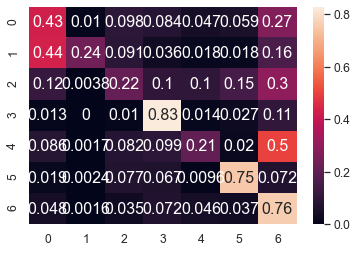

	training epoch=37 .. train_loss=0.987
	validation epoch=37 .. val_loss=1.213
	Accuracy = 55.2 % .. Percision = 54.50000000000001 % .. Recall = 49.1 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_37.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 38 .. loss = 1.742


  0%|                                                                                 | 1/1914 [00:01<41:56,  1.32s/it]

training @ epoch 38 .. loss = 1.07


  0%|                                                                                 | 2/1914 [00:02<42:54,  1.35s/it]

training @ epoch 38 .. loss = 0.465


  0%|▏                                                                                | 3/1914 [00:04<43:38,  1.37s/it]

training @ epoch 38 .. loss = 0.867


  0%|▏                                                                                | 4/1914 [00:05<44:03,  1.38s/it]

training @ epoch 38 .. loss = 1.029


  0%|▏                                                                                | 5/1914 [00:07<44:48,  1.41s/it]

training @ epoch 38 .. loss = 0.815


  0%|▎                                                                                | 6/1914 [00:08<45:02,  1.42s/it]

training @ epoch 38 .. loss = 1.255


  0%|▎                                                                                | 7/1914 [00:09<44:02,  1.39s/it]

training @ epoch 38 .. loss = 0.976


  0%|▎                                                                                | 8/1914 [00:11<43:36,  1.37s/it]

training @ epoch 38 .. loss = 1.319


  0%|▍                                                                                | 9/1914 [00:12<43:36,  1.37s/it]

training @ epoch 38 .. loss = 0.891


  1%|▍                                                                               | 10/1914 [00:13<43:34,  1.37s/it]

training @ epoch 38 .. loss = 1.048


  1%|▍                                                                               | 11/1914 [00:15<43:22,  1.37s/it]

training @ epoch 38 .. loss = 1.417


  1%|▌                                                                               | 12/1914 [00:16<44:10,  1.39s/it]

training @ epoch 38 .. loss = 1.071


  1%|▌                                                                               | 13/1914 [00:18<44:10,  1.39s/it]

training @ epoch 38 .. loss = 1.2


  1%|▌                                                                               | 14/1914 [00:19<45:47,  1.45s/it]

training @ epoch 38 .. loss = 1.369


  1%|▋                                                                               | 15/1914 [00:21<46:14,  1.46s/it]

training @ epoch 38 .. loss = 0.416


  1%|▋                                                                               | 16/1914 [00:22<45:58,  1.45s/it]

training @ epoch 38 .. loss = 0.82


  1%|▋                                                                               | 17/1914 [00:23<44:55,  1.42s/it]

training @ epoch 38 .. loss = 0.981


  1%|▊                                                                               | 18/1914 [00:25<44:21,  1.40s/it]

training @ epoch 38 .. loss = 1.111


  1%|▊                                                                               | 19/1914 [00:26<46:27,  1.47s/it]

training @ epoch 38 .. loss = 0.93


  1%|▊                                                                               | 20/1914 [00:28<46:34,  1.48s/it]

training @ epoch 38 .. loss = 0.964


  1%|▉                                                                               | 21/1914 [00:30<47:57,  1.52s/it]

training @ epoch 38 .. loss = 1.192


  1%|▉                                                                               | 22/1914 [00:31<47:58,  1.52s/it]

training @ epoch 38 .. loss = 0.908


  1%|▉                                                                               | 23/1914 [00:33<48:06,  1.53s/it]

training @ epoch 38 .. loss = 0.837


  1%|█                                                                               | 24/1914 [00:34<48:15,  1.53s/it]

training @ epoch 38 .. loss = 0.681


  1%|█                                                                               | 25/1914 [00:36<48:32,  1.54s/it]

training @ epoch 38 .. loss = 0.723


  1%|█                                                                               | 26/1914 [00:37<48:33,  1.54s/it]

training @ epoch 38 .. loss = 0.931


  1%|█▏                                                                              | 27/1914 [00:39<49:07,  1.56s/it]

training @ epoch 38 .. loss = 0.624


  1%|█▏                                                                              | 28/1914 [00:40<49:37,  1.58s/it]

training @ epoch 38 .. loss = 1.033


  2%|█▏                                                                              | 29/1914 [00:42<49:40,  1.58s/it]

training @ epoch 38 .. loss = 0.886


  2%|█▎                                                                              | 30/1914 [00:44<49:06,  1.56s/it]

training @ epoch 38 .. loss = 0.772


  2%|█▎                                                                              | 31/1914 [00:45<49:20,  1.57s/it]

training @ epoch 38 .. loss = 0.66


  2%|█▎                                                                              | 32/1914 [00:47<49:25,  1.58s/it]

training @ epoch 38 .. loss = 0.936


  2%|█▍                                                                              | 33/1914 [00:48<49:42,  1.59s/it]

training @ epoch 38 .. loss = 0.78


  2%|█▍                                                                              | 34/1914 [00:50<49:47,  1.59s/it]

training @ epoch 38 .. loss = 0.812


  2%|█▍                                                                              | 35/1914 [00:52<49:27,  1.58s/it]

training @ epoch 38 .. loss = 1.004


  2%|█▌                                                                              | 36/1914 [00:53<49:10,  1.57s/it]

training @ epoch 38 .. loss = 1.831


  2%|█▌                                                                              | 37/1914 [00:55<48:28,  1.55s/it]

training @ epoch 38 .. loss = 0.944


  2%|█▌                                                                              | 38/1914 [00:56<47:35,  1.52s/it]

training @ epoch 38 .. loss = 0.815


  2%|█▋                                                                              | 39/1914 [00:58<47:36,  1.52s/it]

training @ epoch 38 .. loss = 1.135


  2%|█▋                                                                              | 40/1914 [00:59<47:57,  1.54s/it]

training @ epoch 38 .. loss = 1.378


  2%|█▋                                                                              | 41/1914 [01:01<47:17,  1.51s/it]

training @ epoch 38 .. loss = 1.186


  2%|█▊                                                                              | 42/1914 [01:02<47:00,  1.51s/it]

training @ epoch 38 .. loss = 1.158


  2%|█▊                                                                              | 43/1914 [01:03<45:45,  1.47s/it]

training @ epoch 38 .. loss = 0.574


  2%|█▊                                                                              | 44/1914 [01:05<44:12,  1.42s/it]

training @ epoch 38 .. loss = 0.862


  2%|█▉                                                                              | 45/1914 [01:06<43:01,  1.38s/it]

training @ epoch 38 .. loss = 0.951


  2%|█▉                                                                              | 46/1914 [01:07<43:35,  1.40s/it]

training @ epoch 38 .. loss = 1.091


  2%|█▉                                                                              | 47/1914 [01:09<43:37,  1.40s/it]

training @ epoch 38 .. loss = 0.705


  3%|██                                                                              | 48/1914 [01:10<44:10,  1.42s/it]

training @ epoch 38 .. loss = 0.704


  3%|██                                                                              | 49/1914 [01:12<43:27,  1.40s/it]

training @ epoch 38 .. loss = 0.821


  3%|██                                                                              | 50/1914 [01:13<42:39,  1.37s/it]

training @ epoch 38 .. loss = 0.649


  3%|██▏                                                                             | 51/1914 [01:14<43:01,  1.39s/it]

training @ epoch 38 .. loss = 0.761


  3%|██▏                                                                             | 52/1914 [01:16<43:15,  1.39s/it]

training @ epoch 38 .. loss = 1.489


  3%|██▏                                                                             | 53/1914 [01:17<43:44,  1.41s/it]

training @ epoch 38 .. loss = 0.582


  3%|██▎                                                                             | 54/1914 [01:19<43:18,  1.40s/it]

training @ epoch 38 .. loss = 0.817


  3%|██▎                                                                             | 55/1914 [01:20<42:19,  1.37s/it]

training @ epoch 38 .. loss = 1.213


  3%|██▎                                                                             | 56/1914 [01:21<41:58,  1.36s/it]

training @ epoch 38 .. loss = 0.945


  3%|██▍                                                                             | 57/1914 [01:23<42:30,  1.37s/it]

training @ epoch 38 .. loss = 0.506


  3%|██▍                                                                             | 58/1914 [01:24<43:15,  1.40s/it]

training @ epoch 38 .. loss = 0.989


  3%|██▍                                                                             | 59/1914 [01:26<43:29,  1.41s/it]

training @ epoch 38 .. loss = 0.932


  3%|██▌                                                                             | 60/1914 [01:27<42:25,  1.37s/it]

training @ epoch 38 .. loss = 0.914


  3%|██▌                                                                             | 61/1914 [01:28<42:46,  1.39s/it]

training @ epoch 38 .. loss = 1.201


  3%|██▌                                                                             | 62/1914 [01:30<43:26,  1.41s/it]

training @ epoch 38 .. loss = 0.895


  3%|██▋                                                                             | 63/1914 [01:31<43:51,  1.42s/it]

training @ epoch 38 .. loss = 0.739


  3%|██▋                                                                             | 64/1914 [01:33<44:03,  1.43s/it]

training @ epoch 38 .. loss = 0.857


  3%|██▋                                                                             | 65/1914 [01:34<43:09,  1.40s/it]

training @ epoch 38 .. loss = 0.678


  3%|██▊                                                                             | 66/1914 [01:35<42:25,  1.38s/it]

training @ epoch 38 .. loss = 0.659


  4%|██▊                                                                             | 67/1914 [01:37<42:45,  1.39s/it]

training @ epoch 38 .. loss = 1.183


  4%|██▊                                                                             | 68/1914 [01:38<43:21,  1.41s/it]

training @ epoch 38 .. loss = 1.326


  4%|██▉                                                                             | 69/1914 [01:40<43:45,  1.42s/it]

training @ epoch 38 .. loss = 1.403


  4%|██▉                                                                             | 70/1914 [01:41<42:38,  1.39s/it]

training @ epoch 38 .. loss = 0.817


  4%|██▉                                                                             | 71/1914 [01:42<42:40,  1.39s/it]

training @ epoch 38 .. loss = 0.671


  4%|███                                                                             | 72/1914 [01:44<42:36,  1.39s/it]

training @ epoch 38 .. loss = 0.765


  4%|███                                                                             | 73/1914 [01:45<42:50,  1.40s/it]

training @ epoch 38 .. loss = 1.242


  4%|███                                                                             | 74/1914 [01:47<43:11,  1.41s/it]

training @ epoch 38 .. loss = 0.687


  4%|███▏                                                                            | 75/1914 [01:48<43:17,  1.41s/it]

training @ epoch 38 .. loss = 0.914


  4%|███▏                                                                            | 76/1914 [01:49<42:28,  1.39s/it]

training @ epoch 38 .. loss = 0.498


  4%|███▏                                                                            | 77/1914 [01:51<42:03,  1.37s/it]

training @ epoch 38 .. loss = 1.147


  4%|███▎                                                                            | 78/1914 [01:52<42:36,  1.39s/it]

training @ epoch 38 .. loss = 1.192


  4%|███▎                                                                            | 79/1914 [01:54<43:09,  1.41s/it]

training @ epoch 38 .. loss = 1.027


  4%|███▎                                                                            | 80/1914 [01:55<43:27,  1.42s/it]

training @ epoch 38 .. loss = 0.954


  4%|███▍                                                                            | 81/1914 [01:56<42:32,  1.39s/it]

training @ epoch 38 .. loss = 0.895


  4%|███▍                                                                            | 82/1914 [01:58<42:03,  1.38s/it]

training @ epoch 38 .. loss = 1.004


  4%|███▍                                                                            | 83/1914 [01:59<41:43,  1.37s/it]

training @ epoch 38 .. loss = 0.845


  4%|███▌                                                                            | 84/1914 [02:00<42:19,  1.39s/it]

training @ epoch 38 .. loss = 0.739


  4%|███▌                                                                            | 85/1914 [02:02<42:57,  1.41s/it]

training @ epoch 38 .. loss = 1.094


  4%|███▌                                                                            | 86/1914 [02:03<42:42,  1.40s/it]

training @ epoch 38 .. loss = 1.476


  5%|███▋                                                                            | 87/1914 [02:05<41:45,  1.37s/it]

training @ epoch 38 .. loss = 0.839


  5%|███▋                                                                            | 88/1914 [02:06<41:23,  1.36s/it]

training @ epoch 38 .. loss = 1.003


  5%|███▋                                                                            | 89/1914 [02:07<42:20,  1.39s/it]

training @ epoch 38 .. loss = 1.198


  5%|███▊                                                                            | 90/1914 [02:09<42:31,  1.40s/it]

training @ epoch 38 .. loss = 1.09


  5%|███▊                                                                            | 91/1914 [02:10<43:12,  1.42s/it]

training @ epoch 38 .. loss = 1.082


  5%|███▊                                                                            | 92/1914 [02:12<42:16,  1.39s/it]

training @ epoch 38 .. loss = 0.499


  5%|███▉                                                                            | 93/1914 [02:13<41:33,  1.37s/it]

training @ epoch 38 .. loss = 1.155


  5%|███▉                                                                            | 94/1914 [02:14<42:01,  1.39s/it]

training @ epoch 38 .. loss = 1.543


  5%|███▉                                                                            | 95/1914 [02:16<42:27,  1.40s/it]

training @ epoch 38 .. loss = 1.129


  5%|████                                                                            | 96/1914 [02:17<43:02,  1.42s/it]

training @ epoch 38 .. loss = 1.216


  5%|████                                                                            | 97/1914 [02:19<42:25,  1.40s/it]

training @ epoch 38 .. loss = 0.74


  5%|████                                                                            | 98/1914 [02:20<41:48,  1.38s/it]

training @ epoch 38 .. loss = 0.713


  5%|████▏                                                                           | 99/1914 [02:21<41:43,  1.38s/it]

training @ epoch 38 .. loss = 1.101


  5%|████▏                                                                          | 100/1914 [02:23<41:45,  1.38s/it]

training @ epoch 38 .. loss = 0.959


  5%|████▏                                                                          | 101/1914 [02:24<42:51,  1.42s/it]

training @ epoch 38 .. loss = 1.222


  5%|████▏                                                                          | 102/1914 [02:26<42:59,  1.42s/it]

training @ epoch 38 .. loss = 1.393


  5%|████▎                                                                          | 103/1914 [02:27<42:09,  1.40s/it]

training @ epoch 38 .. loss = 0.889


  5%|████▎                                                                          | 104/1914 [02:28<42:11,  1.40s/it]

training @ epoch 38 .. loss = 0.737


  5%|████▎                                                                          | 105/1914 [02:30<42:15,  1.40s/it]

training @ epoch 38 .. loss = 0.817


  6%|████▍                                                                          | 106/1914 [02:31<42:43,  1.42s/it]

training @ epoch 38 .. loss = 0.948


  6%|████▍                                                                          | 107/1914 [02:33<42:57,  1.43s/it]

training @ epoch 38 .. loss = 1.556


  6%|████▍                                                                          | 108/1914 [02:34<42:22,  1.41s/it]

training @ epoch 38 .. loss = 0.623


  6%|████▍                                                                          | 109/1914 [02:36<43:24,  1.44s/it]

training @ epoch 38 .. loss = 0.67


  6%|████▌                                                                          | 110/1914 [02:37<42:41,  1.42s/it]

training @ epoch 38 .. loss = 0.565


  6%|████▌                                                                          | 111/1914 [02:38<43:05,  1.43s/it]

training @ epoch 38 .. loss = 1.049


  6%|████▌                                                                          | 112/1914 [02:40<43:27,  1.45s/it]

training @ epoch 38 .. loss = 0.518


  6%|████▋                                                                          | 113/1914 [02:41<44:08,  1.47s/it]

training @ epoch 38 .. loss = 0.775


  6%|████▋                                                                          | 114/1914 [02:43<43:58,  1.47s/it]

training @ epoch 38 .. loss = 1.19


  6%|████▋                                                                          | 115/1914 [02:44<44:55,  1.50s/it]

training @ epoch 38 .. loss = 0.715


  6%|████▊                                                                          | 116/1914 [02:46<44:26,  1.48s/it]

training @ epoch 38 .. loss = 1.319


  6%|████▊                                                                          | 117/1914 [02:47<43:59,  1.47s/it]

training @ epoch 38 .. loss = 1.119


  6%|████▊                                                                          | 118/1914 [02:49<43:34,  1.46s/it]

training @ epoch 38 .. loss = 0.946


  6%|████▉                                                                          | 119/1914 [02:50<43:42,  1.46s/it]

training @ epoch 38 .. loss = 0.868


  6%|████▉                                                                          | 120/1914 [02:52<42:22,  1.42s/it]

training @ epoch 38 .. loss = 0.794


  6%|████▉                                                                          | 121/1914 [02:53<42:40,  1.43s/it]

training @ epoch 38 .. loss = 0.965


  6%|█████                                                                          | 122/1914 [02:54<42:54,  1.44s/it]

training @ epoch 38 .. loss = 0.964


  6%|█████                                                                          | 123/1914 [02:56<43:09,  1.45s/it]

training @ epoch 38 .. loss = 0.745


  6%|█████                                                                          | 124/1914 [02:57<42:08,  1.41s/it]

training @ epoch 38 .. loss = 0.711


  7%|█████▏                                                                         | 125/1914 [02:59<41:34,  1.39s/it]

training @ epoch 38 .. loss = 0.818


  7%|█████▏                                                                         | 126/1914 [03:00<40:49,  1.37s/it]

training @ epoch 38 .. loss = 0.833


  7%|█████▏                                                                         | 127/1914 [03:01<40:28,  1.36s/it]

training @ epoch 38 .. loss = 0.975


  7%|█████▎                                                                         | 128/1914 [03:03<40:46,  1.37s/it]

training @ epoch 38 .. loss = 0.651


  7%|█████▎                                                                         | 129/1914 [03:04<40:32,  1.36s/it]

training @ epoch 38 .. loss = 0.957


  7%|█████▎                                                                         | 130/1914 [03:05<40:19,  1.36s/it]

training @ epoch 38 .. loss = 1.44


  7%|█████▍                                                                         | 131/1914 [03:07<40:32,  1.36s/it]

training @ epoch 38 .. loss = 0.959


  7%|█████▍                                                                         | 132/1914 [03:08<41:09,  1.39s/it]

training @ epoch 38 .. loss = 0.836


  7%|█████▍                                                                         | 133/1914 [03:10<41:30,  1.40s/it]

training @ epoch 38 .. loss = 0.991


  7%|█████▌                                                                         | 134/1914 [03:11<41:20,  1.39s/it]

training @ epoch 38 .. loss = 1.085


  7%|█████▌                                                                         | 135/1914 [03:12<41:10,  1.39s/it]

training @ epoch 38 .. loss = 1.053


  7%|█████▌                                                                         | 136/1914 [03:14<41:27,  1.40s/it]

training @ epoch 38 .. loss = 0.934


  7%|█████▋                                                                         | 137/1914 [03:15<43:03,  1.45s/it]

training @ epoch 38 .. loss = 0.923


  7%|█████▋                                                                         | 138/1914 [03:17<43:51,  1.48s/it]

training @ epoch 38 .. loss = 0.953


  7%|█████▋                                                                         | 139/1914 [03:18<44:42,  1.51s/it]

training @ epoch 38 .. loss = 0.716


  7%|█████▊                                                                         | 140/1914 [03:20<45:16,  1.53s/it]

training @ epoch 38 .. loss = 0.876


  7%|█████▊                                                                         | 141/1914 [03:22<45:27,  1.54s/it]

training @ epoch 38 .. loss = 0.807


  7%|█████▊                                                                         | 142/1914 [03:23<45:47,  1.55s/it]

training @ epoch 38 .. loss = 0.98


  7%|█████▉                                                                         | 143/1914 [03:25<45:27,  1.54s/it]

training @ epoch 38 .. loss = 0.823


  8%|█████▉                                                                         | 144/1914 [03:26<45:37,  1.55s/it]

training @ epoch 38 .. loss = 0.902


  8%|█████▉                                                                         | 145/1914 [03:28<45:07,  1.53s/it]

training @ epoch 38 .. loss = 1.117


  8%|██████                                                                         | 146/1914 [03:29<44:46,  1.52s/it]

training @ epoch 38 .. loss = 0.829


  8%|██████                                                                         | 147/1914 [03:31<44:53,  1.52s/it]

training @ epoch 38 .. loss = 0.826


  8%|██████                                                                         | 148/1914 [03:32<44:48,  1.52s/it]

training @ epoch 38 .. loss = 1.488


  8%|██████▏                                                                        | 149/1914 [03:34<44:33,  1.51s/it]

training @ epoch 38 .. loss = 0.644


  8%|██████▏                                                                        | 150/1914 [03:35<44:38,  1.52s/it]

training @ epoch 38 .. loss = 1.012


  8%|██████▏                                                                        | 151/1914 [03:37<45:13,  1.54s/it]

training @ epoch 38 .. loss = 1.069


  8%|██████▎                                                                        | 152/1914 [03:38<45:10,  1.54s/it]

training @ epoch 38 .. loss = 0.997


  8%|██████▎                                                                        | 153/1914 [03:40<45:09,  1.54s/it]

training @ epoch 38 .. loss = 1.028


  8%|██████▎                                                                        | 154/1914 [03:42<45:12,  1.54s/it]

training @ epoch 38 .. loss = 1.09


  8%|██████▍                                                                        | 155/1914 [03:43<45:17,  1.54s/it]

training @ epoch 38 .. loss = 1.092


  8%|██████▍                                                                        | 156/1914 [03:45<45:01,  1.54s/it]

training @ epoch 38 .. loss = 1.46


  8%|██████▍                                                                        | 157/1914 [03:46<45:10,  1.54s/it]

training @ epoch 38 .. loss = 0.655


  8%|██████▌                                                                        | 158/1914 [03:48<44:07,  1.51s/it]

training @ epoch 38 .. loss = 0.705


  8%|██████▌                                                                        | 159/1914 [03:49<43:59,  1.50s/it]

training @ epoch 38 .. loss = 0.609


  8%|██████▌                                                                        | 160/1914 [03:51<43:55,  1.50s/it]

training @ epoch 38 .. loss = 0.706


  8%|██████▋                                                                        | 161/1914 [03:52<44:58,  1.54s/it]

training @ epoch 38 .. loss = 1.123


  8%|██████▋                                                                        | 162/1914 [03:54<44:23,  1.52s/it]

training @ epoch 38 .. loss = 1.118


  9%|██████▋                                                                        | 163/1914 [03:55<44:14,  1.52s/it]

training @ epoch 38 .. loss = 1.278


  9%|██████▊                                                                        | 164/1914 [03:57<43:36,  1.50s/it]

training @ epoch 38 .. loss = 1.262


  9%|██████▊                                                                        | 165/1914 [03:58<43:46,  1.50s/it]

training @ epoch 38 .. loss = 0.857


  9%|██████▊                                                                        | 166/1914 [04:00<42:38,  1.46s/it]

training @ epoch 38 .. loss = 1.56


  9%|██████▉                                                                        | 167/1914 [04:01<41:33,  1.43s/it]

training @ epoch 38 .. loss = 0.647


  9%|██████▉                                                                        | 168/1914 [04:02<42:19,  1.45s/it]

training @ epoch 38 .. loss = 1.082


  9%|██████▉                                                                        | 169/1914 [04:04<42:50,  1.47s/it]

training @ epoch 38 .. loss = 1.015


  9%|███████                                                                        | 170/1914 [04:05<42:49,  1.47s/it]

training @ epoch 38 .. loss = 1.126


  9%|███████                                                                        | 171/1914 [04:07<41:40,  1.43s/it]

training @ epoch 38 .. loss = 0.746


  9%|███████                                                                        | 172/1914 [04:08<41:24,  1.43s/it]

training @ epoch 38 .. loss = 1.251


  9%|███████▏                                                                       | 173/1914 [04:09<40:50,  1.41s/it]

training @ epoch 38 .. loss = 0.935


  9%|███████▏                                                                       | 174/1914 [04:11<41:09,  1.42s/it]

training @ epoch 38 .. loss = 1.201


  9%|███████▏                                                                       | 175/1914 [04:12<41:52,  1.44s/it]

training @ epoch 38 .. loss = 0.64


  9%|███████▎                                                                       | 176/1914 [04:14<41:46,  1.44s/it]

training @ epoch 38 .. loss = 1.066


  9%|███████▎                                                                       | 177/1914 [04:15<41:14,  1.42s/it]

training @ epoch 38 .. loss = 1.224


  9%|███████▎                                                                       | 178/1914 [04:17<40:26,  1.40s/it]

training @ epoch 38 .. loss = 1.271


  9%|███████▍                                                                       | 179/1914 [04:18<40:12,  1.39s/it]

training @ epoch 38 .. loss = 1.143


  9%|███████▍                                                                       | 180/1914 [04:19<40:04,  1.39s/it]

training @ epoch 38 .. loss = 0.95


  9%|███████▍                                                                       | 181/1914 [04:21<39:44,  1.38s/it]

training @ epoch 38 .. loss = 1.141


 10%|███████▌                                                                       | 182/1914 [04:22<39:38,  1.37s/it]

training @ epoch 38 .. loss = 0.945


 10%|███████▌                                                                       | 183/1914 [04:23<39:11,  1.36s/it]

training @ epoch 38 .. loss = 1.001


 10%|███████▌                                                                       | 184/1914 [04:25<39:59,  1.39s/it]

training @ epoch 38 .. loss = 1.09


 10%|███████▋                                                                       | 185/1914 [04:26<41:01,  1.42s/it]

training @ epoch 38 .. loss = 1.21


 10%|███████▋                                                                       | 186/1914 [04:28<42:35,  1.48s/it]

training @ epoch 38 .. loss = 0.992


 10%|███████▋                                                                       | 187/1914 [04:29<41:43,  1.45s/it]

training @ epoch 38 .. loss = 0.86


 10%|███████▊                                                                       | 188/1914 [04:31<40:43,  1.42s/it]

training @ epoch 38 .. loss = 1.205


 10%|███████▊                                                                       | 189/1914 [04:32<41:03,  1.43s/it]

training @ epoch 38 .. loss = 0.851


 10%|███████▊                                                                       | 190/1914 [04:34<41:00,  1.43s/it]

training @ epoch 38 .. loss = 0.908


 10%|███████▉                                                                       | 191/1914 [04:35<41:08,  1.43s/it]

training @ epoch 38 .. loss = 0.938


 10%|███████▉                                                                       | 192/1914 [04:36<41:34,  1.45s/it]

training @ epoch 38 .. loss = 1.252


 10%|███████▉                                                                       | 193/1914 [04:38<40:54,  1.43s/it]

training @ epoch 38 .. loss = 0.593


 10%|████████                                                                       | 194/1914 [04:39<39:54,  1.39s/it]

training @ epoch 38 .. loss = 0.857


 10%|████████                                                                       | 195/1914 [04:41<39:55,  1.39s/it]

training @ epoch 38 .. loss = 1.434


 10%|████████                                                                       | 196/1914 [04:42<40:31,  1.42s/it]

training @ epoch 38 .. loss = 1.411


 10%|████████▏                                                                      | 197/1914 [04:44<40:56,  1.43s/it]

training @ epoch 38 .. loss = 1.47


 10%|████████▏                                                                      | 198/1914 [04:45<40:25,  1.41s/it]

training @ epoch 38 .. loss = 1.088


 10%|████████▏                                                                      | 199/1914 [04:46<39:37,  1.39s/it]

training @ epoch 38 .. loss = 0.843


 10%|████████▎                                                                      | 200/1914 [04:48<39:05,  1.37s/it]

training @ epoch 38 .. loss = 0.831


 11%|████████▎                                                                      | 201/1914 [04:49<38:25,  1.35s/it]

training @ epoch 38 .. loss = 0.994


 11%|████████▎                                                                      | 202/1914 [04:50<39:35,  1.39s/it]

training @ epoch 38 .. loss = 1.037


 11%|████████▍                                                                      | 203/1914 [04:52<38:51,  1.36s/it]

training @ epoch 38 .. loss = 0.915


 11%|████████▍                                                                      | 204/1914 [04:53<38:08,  1.34s/it]

training @ epoch 38 .. loss = 0.778


 11%|████████▍                                                                      | 205/1914 [04:54<38:04,  1.34s/it]

training @ epoch 38 .. loss = 1.134


 11%|████████▌                                                                      | 206/1914 [04:56<37:52,  1.33s/it]

training @ epoch 38 .. loss = 0.806


 11%|████████▌                                                                      | 207/1914 [04:57<38:23,  1.35s/it]

training @ epoch 38 .. loss = 0.857


 11%|████████▌                                                                      | 208/1914 [04:58<38:19,  1.35s/it]

training @ epoch 38 .. loss = 1.033


 11%|████████▋                                                                      | 209/1914 [05:00<38:00,  1.34s/it]

training @ epoch 38 .. loss = 1.001


 11%|████████▋                                                                      | 210/1914 [05:01<37:57,  1.34s/it]

training @ epoch 38 .. loss = 1.543


 11%|████████▋                                                                      | 211/1914 [05:02<38:15,  1.35s/it]

training @ epoch 38 .. loss = 0.823


 11%|████████▊                                                                      | 212/1914 [05:04<38:22,  1.35s/it]

training @ epoch 38 .. loss = 1.42


 11%|████████▊                                                                      | 213/1914 [05:05<38:06,  1.34s/it]

training @ epoch 38 .. loss = 0.936


 11%|████████▊                                                                      | 214/1914 [05:06<38:04,  1.34s/it]

training @ epoch 38 .. loss = 0.965


 11%|████████▊                                                                      | 215/1914 [05:08<38:04,  1.34s/it]

training @ epoch 38 .. loss = 1.386


 11%|████████▉                                                                      | 216/1914 [05:09<37:36,  1.33s/it]

training @ epoch 38 .. loss = 0.733


 11%|████████▉                                                                      | 217/1914 [05:10<37:58,  1.34s/it]

training @ epoch 38 .. loss = 1.062


 11%|████████▉                                                                      | 218/1914 [05:12<38:19,  1.36s/it]

training @ epoch 38 .. loss = 1.022


 11%|█████████                                                                      | 219/1914 [05:13<37:51,  1.34s/it]

training @ epoch 38 .. loss = 1.099


 11%|█████████                                                                      | 220/1914 [05:14<38:33,  1.37s/it]

training @ epoch 38 .. loss = 0.624


 12%|█████████                                                                      | 221/1914 [05:16<39:07,  1.39s/it]

training @ epoch 38 .. loss = 0.932


 12%|█████████▏                                                                     | 222/1914 [05:17<39:36,  1.40s/it]

training @ epoch 38 .. loss = 1.054


 12%|█████████▏                                                                     | 223/1914 [05:19<39:09,  1.39s/it]

training @ epoch 38 .. loss = 0.773


 12%|█████████▏                                                                     | 224/1914 [05:20<38:39,  1.37s/it]

training @ epoch 38 .. loss = 1.111


 12%|█████████▎                                                                     | 225/1914 [05:21<38:38,  1.37s/it]

training @ epoch 38 .. loss = 0.799


 12%|█████████▎                                                                     | 226/1914 [05:23<38:50,  1.38s/it]

training @ epoch 38 .. loss = 1.111


 12%|█████████▎                                                                     | 227/1914 [05:24<39:37,  1.41s/it]

training @ epoch 38 .. loss = 1.589


 12%|█████████▍                                                                     | 228/1914 [05:26<39:19,  1.40s/it]

training @ epoch 38 .. loss = 0.57


 12%|█████████▍                                                                     | 229/1914 [05:27<38:24,  1.37s/it]

training @ epoch 38 .. loss = 0.651


 12%|█████████▍                                                                     | 230/1914 [05:28<39:22,  1.40s/it]

training @ epoch 38 .. loss = 1.35


 12%|█████████▌                                                                     | 231/1914 [05:30<39:22,  1.40s/it]

training @ epoch 38 .. loss = 0.499


 12%|█████████▌                                                                     | 232/1914 [05:31<39:32,  1.41s/it]

training @ epoch 38 .. loss = 0.725


 12%|█████████▌                                                                     | 233/1914 [05:33<39:42,  1.42s/it]

training @ epoch 38 .. loss = 0.817


 12%|█████████▋                                                                     | 234/1914 [05:34<38:53,  1.39s/it]

training @ epoch 38 .. loss = 0.878


 12%|█████████▋                                                                     | 235/1914 [05:35<38:19,  1.37s/it]

training @ epoch 38 .. loss = 0.574


 12%|█████████▋                                                                     | 236/1914 [05:37<38:10,  1.36s/it]

training @ epoch 38 .. loss = 1.451


 12%|█████████▊                                                                     | 237/1914 [05:38<38:03,  1.36s/it]

training @ epoch 38 .. loss = 1.133


 12%|█████████▊                                                                     | 238/1914 [05:39<38:25,  1.38s/it]

training @ epoch 38 .. loss = 1.338


 12%|█████████▊                                                                     | 239/1914 [05:41<38:08,  1.37s/it]

training @ epoch 38 .. loss = 0.8


 13%|█████████▉                                                                     | 240/1914 [05:42<37:50,  1.36s/it]

training @ epoch 38 .. loss = 0.94


 13%|█████████▉                                                                     | 241/1914 [05:44<38:53,  1.39s/it]

training @ epoch 38 .. loss = 0.919


 13%|█████████▉                                                                     | 242/1914 [05:45<39:04,  1.40s/it]

training @ epoch 38 .. loss = 0.932


 13%|██████████                                                                     | 243/1914 [05:46<39:13,  1.41s/it]

training @ epoch 38 .. loss = 0.985


 13%|██████████                                                                     | 244/1914 [05:48<38:40,  1.39s/it]

training @ epoch 38 .. loss = 1.438


 13%|██████████                                                                     | 245/1914 [05:49<38:00,  1.37s/it]

training @ epoch 38 .. loss = 0.64


 13%|██████████▏                                                                    | 246/1914 [05:51<38:24,  1.38s/it]

training @ epoch 38 .. loss = 0.955


 13%|██████████▏                                                                    | 247/1914 [05:52<38:39,  1.39s/it]

training @ epoch 38 .. loss = 1.194


 13%|██████████▏                                                                    | 248/1914 [05:53<39:45,  1.43s/it]

training @ epoch 38 .. loss = 1.119


 13%|██████████▎                                                                    | 249/1914 [05:55<39:06,  1.41s/it]

training @ epoch 38 .. loss = 1.32


 13%|██████████▎                                                                    | 250/1914 [05:56<38:36,  1.39s/it]

training @ epoch 38 .. loss = 0.783


 13%|██████████▎                                                                    | 251/1914 [05:58<38:02,  1.37s/it]

training @ epoch 38 .. loss = 0.988


 13%|██████████▍                                                                    | 252/1914 [05:59<38:17,  1.38s/it]

training @ epoch 38 .. loss = 0.96


 13%|██████████▍                                                                    | 253/1914 [06:00<39:08,  1.41s/it]

training @ epoch 38 .. loss = 0.824


 13%|██████████▍                                                                    | 254/1914 [06:02<38:52,  1.40s/it]

training @ epoch 38 .. loss = 0.901


 13%|██████████▌                                                                    | 255/1914 [06:03<38:10,  1.38s/it]

training @ epoch 38 .. loss = 0.858


 13%|██████████▌                                                                    | 256/1914 [06:04<37:45,  1.37s/it]

training @ epoch 38 .. loss = 1.098


 13%|██████████▌                                                                    | 257/1914 [06:06<38:03,  1.38s/it]

training @ epoch 38 .. loss = 0.935


 13%|██████████▋                                                                    | 258/1914 [06:07<38:31,  1.40s/it]

training @ epoch 38 .. loss = 1.261


 14%|██████████▋                                                                    | 259/1914 [06:09<39:08,  1.42s/it]

training @ epoch 38 .. loss = 1.336


 14%|██████████▋                                                                    | 260/1914 [06:10<38:40,  1.40s/it]

training @ epoch 38 .. loss = 0.985


 14%|██████████▊                                                                    | 261/1914 [06:11<37:53,  1.38s/it]

training @ epoch 38 .. loss = 0.911


 14%|██████████▊                                                                    | 262/1914 [06:13<38:22,  1.39s/it]

training @ epoch 38 .. loss = 0.931


 14%|██████████▊                                                                    | 263/1914 [06:14<38:55,  1.41s/it]

training @ epoch 38 .. loss = 1.009


 14%|██████████▉                                                                    | 264/1914 [06:16<39:10,  1.42s/it]

training @ epoch 38 .. loss = 0.826


 14%|██████████▉                                                                    | 265/1914 [06:17<38:39,  1.41s/it]

training @ epoch 38 .. loss = 1.171


 14%|██████████▉                                                                    | 266/1914 [06:18<38:02,  1.38s/it]

training @ epoch 38 .. loss = 0.93


 14%|███████████                                                                    | 267/1914 [06:20<37:41,  1.37s/it]

training @ epoch 38 .. loss = 1.076


 14%|███████████                                                                    | 268/1914 [06:21<38:25,  1.40s/it]

training @ epoch 38 .. loss = 1.29


 14%|███████████                                                                    | 269/1914 [06:23<38:51,  1.42s/it]

training @ epoch 38 .. loss = 0.918


 14%|███████████▏                                                                   | 270/1914 [06:24<39:19,  1.43s/it]

training @ epoch 38 .. loss = 0.725


 14%|███████████▏                                                                   | 271/1914 [06:26<38:08,  1.39s/it]

training @ epoch 38 .. loss = 0.808


 14%|███████████▏                                                                   | 272/1914 [06:27<37:07,  1.36s/it]

training @ epoch 38 .. loss = 0.879


 14%|███████████▎                                                                   | 273/1914 [06:28<38:19,  1.40s/it]

training @ epoch 38 .. loss = 1.108


 14%|███████████▎                                                                   | 274/1914 [06:30<38:36,  1.41s/it]

training @ epoch 38 .. loss = 0.831


 14%|███████████▎                                                                   | 275/1914 [06:31<38:46,  1.42s/it]

training @ epoch 38 .. loss = 0.973


 14%|███████████▍                                                                   | 276/1914 [06:33<38:08,  1.40s/it]

training @ epoch 38 .. loss = 0.994


 14%|███████████▍                                                                   | 277/1914 [06:34<38:05,  1.40s/it]

training @ epoch 38 .. loss = 0.868


 15%|███████████▍                                                                   | 278/1914 [06:35<38:32,  1.41s/it]

training @ epoch 38 .. loss = 0.755


 15%|███████████▌                                                                   | 279/1914 [06:37<38:32,  1.41s/it]

training @ epoch 38 .. loss = 0.798


 15%|███████████▌                                                                   | 280/1914 [06:38<39:06,  1.44s/it]

training @ epoch 38 .. loss = 1.304


 15%|███████████▌                                                                   | 281/1914 [06:40<39:14,  1.44s/it]

training @ epoch 38 .. loss = 0.771


 15%|███████████▋                                                                   | 282/1914 [06:41<38:00,  1.40s/it]

training @ epoch 38 .. loss = 0.446


 15%|███████████▋                                                                   | 283/1914 [06:42<37:43,  1.39s/it]

training @ epoch 38 .. loss = 0.856


 15%|███████████▋                                                                   | 284/1914 [06:44<37:59,  1.40s/it]

training @ epoch 38 .. loss = 0.823


 15%|███████████▊                                                                   | 285/1914 [06:45<38:11,  1.41s/it]

training @ epoch 38 .. loss = 1.09


 15%|███████████▊                                                                   | 286/1914 [06:47<38:33,  1.42s/it]

training @ epoch 38 .. loss = 1.011


 15%|███████████▊                                                                   | 287/1914 [06:48<38:48,  1.43s/it]

training @ epoch 38 .. loss = 1.752


 15%|███████████▉                                                                   | 288/1914 [06:50<38:04,  1.41s/it]

training @ epoch 38 .. loss = 1.277


 15%|███████████▉                                                                   | 289/1914 [06:51<37:52,  1.40s/it]

training @ epoch 38 .. loss = 0.678


 15%|███████████▉                                                                   | 290/1914 [06:52<38:15,  1.41s/it]

training @ epoch 38 .. loss = 1.09


 15%|████████████                                                                   | 291/1914 [06:54<38:39,  1.43s/it]

training @ epoch 38 .. loss = 1.155


 15%|████████████                                                                   | 292/1914 [06:55<38:01,  1.41s/it]

training @ epoch 38 .. loss = 1.017


 15%|████████████                                                                   | 293/1914 [06:56<37:18,  1.38s/it]

training @ epoch 38 .. loss = 1.187


 15%|████████████▏                                                                  | 294/1914 [06:58<37:20,  1.38s/it]

training @ epoch 38 .. loss = 1.004


 15%|████████████▏                                                                  | 295/1914 [06:59<37:24,  1.39s/it]

training @ epoch 38 .. loss = 1.035


 15%|████████████▏                                                                  | 296/1914 [07:01<37:42,  1.40s/it]

training @ epoch 38 .. loss = 0.662


 16%|████████████▎                                                                  | 297/1914 [07:02<37:59,  1.41s/it]

training @ epoch 38 .. loss = 1.486


 16%|████████████▎                                                                  | 298/1914 [07:03<37:16,  1.38s/it]

training @ epoch 38 .. loss = 1.427


 16%|████████████▎                                                                  | 299/1914 [07:05<36:36,  1.36s/it]

training @ epoch 38 .. loss = 1.161


 16%|████████████▍                                                                  | 300/1914 [07:06<37:31,  1.39s/it]

training @ epoch 38 .. loss = 0.919


 16%|████████████▍                                                                  | 301/1914 [07:08<37:59,  1.41s/it]

training @ epoch 38 .. loss = 0.62


 16%|████████████▍                                                                  | 302/1914 [07:09<38:22,  1.43s/it]

training @ epoch 38 .. loss = 0.879


 16%|████████████▌                                                                  | 303/1914 [07:10<37:15,  1.39s/it]

training @ epoch 38 .. loss = 0.759


 16%|████████████▌                                                                  | 304/1914 [07:12<36:58,  1.38s/it]

training @ epoch 38 .. loss = 0.577


 16%|████████████▌                                                                  | 305/1914 [07:13<36:25,  1.36s/it]

training @ epoch 38 .. loss = 1.028


 16%|████████████▋                                                                  | 306/1914 [07:14<36:36,  1.37s/it]

training @ epoch 38 .. loss = 0.724


 16%|████████████▋                                                                  | 307/1914 [07:16<36:39,  1.37s/it]

training @ epoch 38 .. loss = 1.167


 16%|████████████▋                                                                  | 308/1914 [07:17<36:21,  1.36s/it]

training @ epoch 38 .. loss = 0.757


 16%|████████████▊                                                                  | 309/1914 [07:19<35:58,  1.34s/it]

training @ epoch 38 .. loss = 0.946


 16%|████████████▊                                                                  | 310/1914 [07:20<35:46,  1.34s/it]

training @ epoch 38 .. loss = 1.646


 16%|████████████▊                                                                  | 311/1914 [07:21<35:53,  1.34s/it]

training @ epoch 38 .. loss = 1.071


 16%|████████████▉                                                                  | 312/1914 [07:23<36:06,  1.35s/it]

training @ epoch 38 .. loss = 1.141


 16%|████████████▉                                                                  | 313/1914 [07:24<35:42,  1.34s/it]

training @ epoch 38 .. loss = 1.134


 16%|████████████▉                                                                  | 314/1914 [07:25<35:48,  1.34s/it]

training @ epoch 38 .. loss = 0.667


 16%|█████████████                                                                  | 315/1914 [07:27<38:36,  1.45s/it]

training @ epoch 38 .. loss = 1.295


 17%|█████████████                                                                  | 316/1914 [07:29<40:00,  1.50s/it]

training @ epoch 38 .. loss = 0.754


 17%|█████████████                                                                  | 317/1914 [07:30<39:31,  1.49s/it]

training @ epoch 38 .. loss = 0.53


 17%|█████████████▏                                                                 | 318/1914 [07:31<38:41,  1.45s/it]

training @ epoch 38 .. loss = 1.023


 17%|█████████████▏                                                                 | 319/1914 [07:33<37:32,  1.41s/it]

training @ epoch 38 .. loss = 1.123


 17%|█████████████▏                                                                 | 320/1914 [07:34<37:13,  1.40s/it]

training @ epoch 38 .. loss = 1.227


 17%|█████████████▏                                                                 | 321/1914 [07:35<37:04,  1.40s/it]

training @ epoch 38 .. loss = 0.924


 17%|█████████████▎                                                                 | 322/1914 [07:37<36:42,  1.38s/it]

training @ epoch 38 .. loss = 0.816


 17%|█████████████▎                                                                 | 323/1914 [07:38<36:27,  1.37s/it]

training @ epoch 38 .. loss = 1.087


 17%|█████████████▎                                                                 | 324/1914 [07:39<36:11,  1.37s/it]

training @ epoch 38 .. loss = 1.441


 17%|█████████████▍                                                                 | 325/1914 [07:41<35:35,  1.34s/it]

training @ epoch 38 .. loss = 0.806


 17%|█████████████▍                                                                 | 326/1914 [07:42<36:21,  1.37s/it]

training @ epoch 38 .. loss = 1.146


 17%|█████████████▍                                                                 | 327/1914 [07:44<36:21,  1.37s/it]

training @ epoch 38 .. loss = 1.055


 17%|█████████████▌                                                                 | 328/1914 [07:45<35:46,  1.35s/it]

training @ epoch 38 .. loss = 1.288


 17%|█████████████▌                                                                 | 329/1914 [07:46<36:34,  1.38s/it]

training @ epoch 38 .. loss = 0.832


 17%|█████████████▌                                                                 | 330/1914 [07:48<36:38,  1.39s/it]

training @ epoch 38 .. loss = 0.892


 17%|█████████████▋                                                                 | 331/1914 [07:49<37:14,  1.41s/it]

training @ epoch 38 .. loss = 0.764


 17%|█████████████▋                                                                 | 332/1914 [07:51<37:00,  1.40s/it]

training @ epoch 38 .. loss = 0.692


 17%|█████████████▋                                                                 | 333/1914 [07:52<36:11,  1.37s/it]

training @ epoch 38 .. loss = 1.034


 17%|█████████████▊                                                                 | 334/1914 [07:53<35:55,  1.36s/it]

training @ epoch 38 .. loss = 0.711


 18%|█████████████▊                                                                 | 335/1914 [07:55<36:19,  1.38s/it]

training @ epoch 38 .. loss = 0.944


 18%|█████████████▊                                                                 | 336/1914 [07:56<37:18,  1.42s/it]

training @ epoch 38 .. loss = 0.779


 18%|█████████████▉                                                                 | 337/1914 [07:58<37:24,  1.42s/it]

training @ epoch 38 .. loss = 1.017


 18%|█████████████▉                                                                 | 338/1914 [07:59<36:45,  1.40s/it]

training @ epoch 38 .. loss = 0.847


 18%|█████████████▉                                                                 | 339/1914 [08:00<36:28,  1.39s/it]

training @ epoch 38 .. loss = 0.943


 18%|██████████████                                                                 | 340/1914 [08:02<37:35,  1.43s/it]

training @ epoch 38 .. loss = 0.585


 18%|██████████████                                                                 | 341/1914 [08:04<39:09,  1.49s/it]

training @ epoch 38 .. loss = 0.654


 18%|██████████████                                                                 | 342/1914 [08:05<39:03,  1.49s/it]

training @ epoch 38 .. loss = 1.051


 18%|██████████████▏                                                                | 343/1914 [08:07<39:32,  1.51s/it]

training @ epoch 38 .. loss = 1.048


 18%|██████████████▏                                                                | 344/1914 [08:08<39:15,  1.50s/it]

training @ epoch 38 .. loss = 1.596


 18%|██████████████▏                                                                | 345/1914 [08:09<37:42,  1.44s/it]

training @ epoch 38 .. loss = 0.897


 18%|██████████████▎                                                                | 346/1914 [08:11<36:59,  1.42s/it]

training @ epoch 38 .. loss = 1.148


 18%|██████████████▎                                                                | 347/1914 [08:12<37:21,  1.43s/it]

training @ epoch 38 .. loss = 1.515


 18%|██████████████▎                                                                | 348/1914 [08:14<37:37,  1.44s/it]

training @ epoch 38 .. loss = 0.921


 18%|██████████████▍                                                                | 349/1914 [08:15<38:30,  1.48s/it]

training @ epoch 38 .. loss = 0.808


 18%|██████████████▍                                                                | 350/1914 [08:17<38:04,  1.46s/it]

training @ epoch 38 .. loss = 0.561


 18%|██████████████▍                                                                | 351/1914 [08:18<37:55,  1.46s/it]

training @ epoch 38 .. loss = 1.016


 18%|██████████████▌                                                                | 352/1914 [08:19<37:25,  1.44s/it]

training @ epoch 38 .. loss = 0.916


 18%|██████████████▌                                                                | 353/1914 [08:21<37:38,  1.45s/it]

training @ epoch 38 .. loss = 1.19


 18%|██████████████▌                                                                | 354/1914 [08:22<38:00,  1.46s/it]

training @ epoch 38 .. loss = 0.964


 19%|██████████████▋                                                                | 355/1914 [08:24<37:56,  1.46s/it]

training @ epoch 38 .. loss = 1.286


 19%|██████████████▋                                                                | 356/1914 [08:25<38:02,  1.46s/it]

training @ epoch 38 .. loss = 0.655


 19%|██████████████▋                                                                | 357/1914 [08:27<37:04,  1.43s/it]

training @ epoch 38 .. loss = 0.635


 19%|██████████████▊                                                                | 358/1914 [08:28<36:37,  1.41s/it]

training @ epoch 38 .. loss = 1.056


 19%|██████████████▊                                                                | 359/1914 [08:29<36:46,  1.42s/it]

training @ epoch 38 .. loss = 0.952


 19%|██████████████▊                                                                | 360/1914 [08:31<37:12,  1.44s/it]

training @ epoch 38 .. loss = 0.969


 19%|██████████████▉                                                                | 361/1914 [08:32<37:25,  1.45s/it]

training @ epoch 38 .. loss = 0.626


 19%|██████████████▉                                                                | 362/1914 [08:34<36:36,  1.42s/it]

training @ epoch 38 .. loss = 1.391


 19%|██████████████▉                                                                | 363/1914 [08:35<36:38,  1.42s/it]

training @ epoch 38 .. loss = 0.588


 19%|███████████████                                                                | 364/1914 [08:37<36:08,  1.40s/it]

training @ epoch 38 .. loss = 0.521


 19%|███████████████                                                                | 365/1914 [08:38<36:23,  1.41s/it]

training @ epoch 38 .. loss = 0.883


 19%|███████████████                                                                | 366/1914 [08:39<36:49,  1.43s/it]

training @ epoch 38 .. loss = 0.898


 19%|███████████████▏                                                               | 367/1914 [08:41<36:23,  1.41s/it]

training @ epoch 38 .. loss = 1.293


 19%|███████████████▏                                                               | 368/1914 [08:42<35:50,  1.39s/it]

training @ epoch 38 .. loss = 0.793


 19%|███████████████▏                                                               | 369/1914 [08:44<35:50,  1.39s/it]

training @ epoch 38 .. loss = 0.603


 19%|███████████████▎                                                               | 370/1914 [08:45<36:14,  1.41s/it]

training @ epoch 38 .. loss = 0.737


 19%|███████████████▎                                                               | 371/1914 [08:46<36:30,  1.42s/it]

training @ epoch 38 .. loss = 1.549


 19%|███████████████▎                                                               | 372/1914 [08:48<36:46,  1.43s/it]

training @ epoch 38 .. loss = 1.056


 19%|███████████████▍                                                               | 373/1914 [08:49<35:55,  1.40s/it]

training @ epoch 38 .. loss = 0.819


 20%|███████████████▍                                                               | 374/1914 [08:51<35:14,  1.37s/it]

training @ epoch 38 .. loss = 0.804


 20%|███████████████▍                                                               | 375/1914 [08:52<35:23,  1.38s/it]

training @ epoch 38 .. loss = 0.973


 20%|███████████████▌                                                               | 376/1914 [08:53<35:34,  1.39s/it]

training @ epoch 38 .. loss = 0.986


 20%|███████████████▌                                                               | 377/1914 [08:55<35:55,  1.40s/it]

training @ epoch 38 .. loss = 0.75


 20%|███████████████▌                                                               | 378/1914 [08:56<36:12,  1.41s/it]

training @ epoch 38 .. loss = 1.55


 20%|███████████████▋                                                               | 379/1914 [08:58<36:13,  1.42s/it]

training @ epoch 38 .. loss = 1.081


 20%|███████████████▋                                                               | 380/1914 [08:59<36:07,  1.41s/it]

training @ epoch 38 .. loss = 1.364


 20%|███████████████▋                                                               | 381/1914 [09:01<36:29,  1.43s/it]

training @ epoch 38 .. loss = 0.814


 20%|███████████████▊                                                               | 382/1914 [09:02<36:03,  1.41s/it]

training @ epoch 38 .. loss = 1.442


 20%|███████████████▊                                                               | 383/1914 [09:03<35:35,  1.39s/it]

training @ epoch 38 .. loss = 0.58


 20%|███████████████▊                                                               | 384/1914 [09:05<35:09,  1.38s/it]

training @ epoch 38 .. loss = 0.89


 20%|███████████████▉                                                               | 385/1914 [09:06<34:32,  1.36s/it]

training @ epoch 38 .. loss = 0.939


 20%|███████████████▉                                                               | 386/1914 [09:07<34:22,  1.35s/it]

training @ epoch 38 .. loss = 0.786


 20%|███████████████▉                                                               | 387/1914 [09:09<34:32,  1.36s/it]

training @ epoch 38 .. loss = 0.611


 20%|████████████████                                                               | 388/1914 [09:10<34:29,  1.36s/it]

training @ epoch 38 .. loss = 1.386


 20%|████████████████                                                               | 389/1914 [09:11<34:07,  1.34s/it]

training @ epoch 38 .. loss = 0.756


 20%|████████████████                                                               | 390/1914 [09:13<34:07,  1.34s/it]

training @ epoch 38 .. loss = 1.16


 20%|████████████████▏                                                              | 391/1914 [09:14<34:25,  1.36s/it]

training @ epoch 38 .. loss = 1.274


 20%|████████████████▏                                                              | 392/1914 [09:15<34:27,  1.36s/it]

training @ epoch 38 .. loss = 1.149


 21%|████████████████▏                                                              | 393/1914 [09:17<34:28,  1.36s/it]

training @ epoch 38 .. loss = 0.885


 21%|████████████████▎                                                              | 394/1914 [09:18<34:16,  1.35s/it]

training @ epoch 38 .. loss = 0.932


 21%|████████████████▎                                                              | 395/1914 [09:19<33:43,  1.33s/it]

training @ epoch 38 .. loss = 1.457


 21%|████████████████▎                                                              | 396/1914 [09:21<34:11,  1.35s/it]

training @ epoch 38 .. loss = 1.413


 21%|████████████████▍                                                              | 397/1914 [09:22<33:46,  1.34s/it]

training @ epoch 38 .. loss = 0.864


 21%|████████████████▍                                                              | 398/1914 [09:23<33:39,  1.33s/it]

training @ epoch 38 .. loss = 0.973


 21%|████████████████▍                                                              | 399/1914 [09:25<33:44,  1.34s/it]

training @ epoch 38 .. loss = 0.384


 21%|████████████████▌                                                              | 400/1914 [09:26<33:55,  1.34s/it]

training @ epoch 38 .. loss = 1.257


 21%|████████████████▌                                                              | 401/1914 [09:27<34:12,  1.36s/it]

training @ epoch 38 .. loss = 0.797


 21%|████████████████▌                                                              | 402/1914 [09:29<33:47,  1.34s/it]

training @ epoch 38 .. loss = 1.306


 21%|████████████████▋                                                              | 403/1914 [09:30<34:05,  1.35s/it]

training @ epoch 38 .. loss = 0.687


 21%|████████████████▋                                                              | 404/1914 [09:31<33:36,  1.34s/it]

training @ epoch 38 .. loss = 0.44


 21%|████████████████▋                                                              | 405/1914 [09:33<33:20,  1.33s/it]

training @ epoch 38 .. loss = 0.926


 21%|████████████████▊                                                              | 406/1914 [09:34<33:54,  1.35s/it]

training @ epoch 38 .. loss = 1.047


 21%|████████████████▊                                                              | 407/1914 [09:36<34:01,  1.35s/it]

training @ epoch 38 .. loss = 0.945


 21%|████████████████▊                                                              | 408/1914 [09:37<33:35,  1.34s/it]

training @ epoch 38 .. loss = 0.95


 21%|████████████████▉                                                              | 409/1914 [09:38<33:41,  1.34s/it]

training @ epoch 38 .. loss = 0.625


 21%|████████████████▉                                                              | 410/1914 [09:40<33:32,  1.34s/it]

training @ epoch 38 .. loss = 0.459


 21%|████████████████▉                                                              | 411/1914 [09:41<33:33,  1.34s/it]

training @ epoch 38 .. loss = 1.477


 22%|█████████████████                                                              | 412/1914 [09:42<33:52,  1.35s/it]

training @ epoch 38 .. loss = 0.673


 22%|█████████████████                                                              | 413/1914 [09:44<34:01,  1.36s/it]

training @ epoch 38 .. loss = 1.116


 22%|█████████████████                                                              | 414/1914 [09:45<33:20,  1.33s/it]

training @ epoch 38 .. loss = 0.939


 22%|█████████████████▏                                                             | 415/1914 [09:46<33:42,  1.35s/it]

training @ epoch 38 .. loss = 0.854


 22%|█████████████████▏                                                             | 416/1914 [09:48<34:05,  1.37s/it]

training @ epoch 38 .. loss = 0.524


 22%|█████████████████▏                                                             | 417/1914 [09:49<33:31,  1.34s/it]

training @ epoch 38 .. loss = 1.091


 22%|█████████████████▎                                                             | 418/1914 [09:50<33:48,  1.36s/it]

training @ epoch 38 .. loss = 0.677


 22%|█████████████████▎                                                             | 419/1914 [09:52<33:46,  1.36s/it]

training @ epoch 38 .. loss = 0.905


 22%|█████████████████▎                                                             | 420/1914 [09:53<33:35,  1.35s/it]

training @ epoch 38 .. loss = 1.034


 22%|█████████████████▍                                                             | 421/1914 [09:54<33:36,  1.35s/it]

training @ epoch 38 .. loss = 0.777


 22%|█████████████████▍                                                             | 422/1914 [09:56<33:58,  1.37s/it]

training @ epoch 38 .. loss = 1.175


 22%|█████████████████▍                                                             | 423/1914 [09:57<33:30,  1.35s/it]

training @ epoch 38 .. loss = 0.715


 22%|█████████████████▌                                                             | 424/1914 [09:58<33:13,  1.34s/it]

training @ epoch 38 .. loss = 1.414


 22%|█████████████████▌                                                             | 425/1914 [10:00<33:41,  1.36s/it]

training @ epoch 38 .. loss = 0.953


 22%|█████████████████▌                                                             | 426/1914 [10:01<33:16,  1.34s/it]

training @ epoch 38 .. loss = 0.635


 22%|█████████████████▌                                                             | 427/1914 [10:02<33:20,  1.35s/it]

training @ epoch 38 .. loss = 0.963


 22%|█████████████████▋                                                             | 428/1914 [10:04<33:32,  1.35s/it]

training @ epoch 38 .. loss = 0.846


 22%|█████████████████▋                                                             | 429/1914 [10:05<33:22,  1.35s/it]

training @ epoch 38 .. loss = 1.433


 22%|█████████████████▋                                                             | 430/1914 [10:07<33:36,  1.36s/it]

training @ epoch 38 .. loss = 1.056


 23%|█████████████████▊                                                             | 431/1914 [10:08<33:29,  1.36s/it]

training @ epoch 38 .. loss = 0.952


 23%|█████████████████▊                                                             | 432/1914 [10:09<33:14,  1.35s/it]

training @ epoch 38 .. loss = 1.407


 23%|█████████████████▊                                                             | 433/1914 [10:11<33:11,  1.34s/it]

training @ epoch 38 .. loss = 0.963


 23%|█████████████████▉                                                             | 434/1914 [10:12<32:57,  1.34s/it]

training @ epoch 38 .. loss = 0.843


 23%|█████████████████▉                                                             | 435/1914 [10:13<33:25,  1.36s/it]

training @ epoch 38 .. loss = 0.622


 23%|█████████████████▉                                                             | 436/1914 [10:15<33:14,  1.35s/it]

training @ epoch 38 .. loss = 0.998


 23%|██████████████████                                                             | 437/1914 [10:16<32:56,  1.34s/it]

training @ epoch 38 .. loss = 1.314


 23%|██████████████████                                                             | 438/1914 [10:17<32:45,  1.33s/it]

training @ epoch 38 .. loss = 1.015


 23%|██████████████████                                                             | 439/1914 [10:19<32:31,  1.32s/it]

training @ epoch 38 .. loss = 0.973


 23%|██████████████████▏                                                            | 440/1914 [10:20<32:44,  1.33s/it]

training @ epoch 38 .. loss = 0.992


 23%|██████████████████▏                                                            | 441/1914 [10:21<32:38,  1.33s/it]

training @ epoch 38 .. loss = 0.715


 23%|██████████████████▏                                                            | 442/1914 [10:23<32:56,  1.34s/it]

training @ epoch 38 .. loss = 0.741


 23%|██████████████████▎                                                            | 443/1914 [10:24<32:56,  1.34s/it]

training @ epoch 38 .. loss = 0.764


 23%|██████████████████▎                                                            | 444/1914 [10:25<32:59,  1.35s/it]

training @ epoch 38 .. loss = 0.776


 23%|██████████████████▎                                                            | 445/1914 [10:27<33:06,  1.35s/it]

training @ epoch 38 .. loss = 1.706


 23%|██████████████████▍                                                            | 446/1914 [10:28<32:56,  1.35s/it]

training @ epoch 38 .. loss = 0.959


 23%|██████████████████▍                                                            | 447/1914 [10:29<32:36,  1.33s/it]

training @ epoch 38 .. loss = 1.43


 23%|██████████████████▍                                                            | 448/1914 [10:31<32:26,  1.33s/it]

training @ epoch 38 .. loss = 0.773


 23%|██████████████████▌                                                            | 449/1914 [10:32<32:41,  1.34s/it]

training @ epoch 38 .. loss = 0.771


 24%|██████████████████▌                                                            | 450/1914 [10:33<32:43,  1.34s/it]

training @ epoch 38 .. loss = 1.2


 24%|██████████████████▌                                                            | 451/1914 [10:35<32:38,  1.34s/it]

training @ epoch 38 .. loss = 1.412


 24%|██████████████████▋                                                            | 452/1914 [10:36<35:27,  1.46s/it]

training @ epoch 38 .. loss = 0.79


 24%|██████████████████▋                                                            | 453/1914 [10:38<37:34,  1.54s/it]

training @ epoch 38 .. loss = 0.602


 24%|██████████████████▋                                                            | 454/1914 [10:40<39:57,  1.64s/it]

training @ epoch 38 .. loss = 1.101


 24%|██████████████████▊                                                            | 455/1914 [10:41<37:41,  1.55s/it]

training @ epoch 38 .. loss = 0.519


 24%|██████████████████▊                                                            | 456/1914 [10:43<36:05,  1.49s/it]

training @ epoch 38 .. loss = 0.851


 24%|██████████████████▊                                                            | 457/1914 [10:44<34:57,  1.44s/it]

training @ epoch 38 .. loss = 0.595


 24%|██████████████████▉                                                            | 458/1914 [10:45<34:14,  1.41s/it]

training @ epoch 38 .. loss = 0.412


 24%|██████████████████▉                                                            | 459/1914 [10:47<33:40,  1.39s/it]

training @ epoch 38 .. loss = 0.539


 24%|██████████████████▉                                                            | 460/1914 [10:48<33:23,  1.38s/it]

training @ epoch 38 .. loss = 1.22


 24%|███████████████████                                                            | 461/1914 [10:49<32:54,  1.36s/it]

training @ epoch 38 .. loss = 0.653


 24%|███████████████████                                                            | 462/1914 [10:51<32:29,  1.34s/it]

training @ epoch 38 .. loss = 0.565


 24%|███████████████████                                                            | 463/1914 [10:52<32:46,  1.36s/it]

training @ epoch 38 .. loss = 0.768


 24%|███████████████████▏                                                           | 464/1914 [10:53<32:35,  1.35s/it]

training @ epoch 38 .. loss = 0.543


 24%|███████████████████▏                                                           | 465/1914 [10:55<32:18,  1.34s/it]

training @ epoch 38 .. loss = 1.058


 24%|███████████████████▏                                                           | 466/1914 [10:56<32:16,  1.34s/it]

training @ epoch 38 .. loss = 1.01


 24%|███████████████████▎                                                           | 467/1914 [10:57<32:13,  1.34s/it]

training @ epoch 38 .. loss = 1.44


 24%|███████████████████▎                                                           | 468/1914 [10:59<32:11,  1.34s/it]

training @ epoch 38 .. loss = 0.907


 25%|███████████████████▎                                                           | 469/1914 [11:00<32:22,  1.34s/it]

training @ epoch 38 .. loss = 0.761


 25%|███████████████████▍                                                           | 470/1914 [11:01<32:02,  1.33s/it]

training @ epoch 38 .. loss = 0.513


 25%|███████████████████▍                                                           | 471/1914 [11:03<31:50,  1.32s/it]

training @ epoch 38 .. loss = 0.98


 25%|███████████████████▍                                                           | 472/1914 [11:04<32:01,  1.33s/it]

training @ epoch 38 .. loss = 1.193


 25%|███████████████████▌                                                           | 473/1914 [11:05<32:01,  1.33s/it]

training @ epoch 38 .. loss = 1.307


 25%|███████████████████▌                                                           | 474/1914 [11:07<32:00,  1.33s/it]

training @ epoch 38 .. loss = 1.194


 25%|███████████████████▌                                                           | 475/1914 [11:08<32:02,  1.34s/it]

training @ epoch 38 .. loss = 0.923


 25%|███████████████████▋                                                           | 476/1914 [11:09<31:47,  1.33s/it]

training @ epoch 38 .. loss = 0.836


 25%|███████████████████▋                                                           | 477/1914 [11:11<32:03,  1.34s/it]

training @ epoch 38 .. loss = 1.063


 25%|███████████████████▋                                                           | 478/1914 [11:12<31:55,  1.33s/it]

training @ epoch 38 .. loss = 0.922


 25%|███████████████████▊                                                           | 479/1914 [11:13<32:24,  1.35s/it]

training @ epoch 38 .. loss = 0.882


 25%|███████████████████▊                                                           | 480/1914 [11:15<31:57,  1.34s/it]

training @ epoch 38 .. loss = 0.365


 25%|███████████████████▊                                                           | 481/1914 [11:16<32:12,  1.35s/it]

training @ epoch 38 .. loss = 0.627


 25%|███████████████████▉                                                           | 482/1914 [11:17<32:09,  1.35s/it]

training @ epoch 38 .. loss = 0.628


 25%|███████████████████▉                                                           | 483/1914 [11:19<32:02,  1.34s/it]

training @ epoch 38 .. loss = 0.989


 25%|███████████████████▉                                                           | 484/1914 [11:20<32:23,  1.36s/it]

training @ epoch 38 .. loss = 1.212


 25%|████████████████████                                                           | 485/1914 [11:22<32:06,  1.35s/it]

training @ epoch 38 .. loss = 0.626


 25%|████████████████████                                                           | 486/1914 [11:23<31:33,  1.33s/it]

training @ epoch 38 .. loss = 1.334


 25%|████████████████████                                                           | 487/1914 [11:24<31:43,  1.33s/it]

training @ epoch 38 .. loss = 0.607


 25%|████████████████████▏                                                          | 488/1914 [11:25<31:33,  1.33s/it]

training @ epoch 38 .. loss = 0.69


 26%|████████████████████▏                                                          | 489/1914 [11:27<32:05,  1.35s/it]

training @ epoch 38 .. loss = 0.691


 26%|████████████████████▏                                                          | 490/1914 [11:28<32:10,  1.36s/it]

training @ epoch 38 .. loss = 0.8


 26%|████████████████████▎                                                          | 491/1914 [11:30<32:12,  1.36s/it]

training @ epoch 38 .. loss = 0.772


 26%|████████████████████▎                                                          | 492/1914 [11:31<31:35,  1.33s/it]

training @ epoch 38 .. loss = 0.797


 26%|████████████████████▎                                                          | 493/1914 [11:32<31:55,  1.35s/it]

training @ epoch 38 .. loss = 0.8


 26%|████████████████████▍                                                          | 494/1914 [11:34<32:05,  1.36s/it]

training @ epoch 38 .. loss = 1.117


 26%|████████████████████▍                                                          | 495/1914 [11:35<31:41,  1.34s/it]

training @ epoch 38 .. loss = 1.162


 26%|████████████████████▍                                                          | 496/1914 [11:36<32:03,  1.36s/it]

training @ epoch 38 .. loss = 0.675


 26%|████████████████████▌                                                          | 497/1914 [11:38<32:08,  1.36s/it]

training @ epoch 38 .. loss = 0.686


 26%|████████████████████▌                                                          | 498/1914 [11:39<32:00,  1.36s/it]

training @ epoch 38 .. loss = 1.107


 26%|████████████████████▌                                                          | 499/1914 [11:40<31:58,  1.36s/it]

training @ epoch 38 .. loss = 1.498


 26%|████████████████████▋                                                          | 500/1914 [11:42<31:56,  1.36s/it]

training @ epoch 38 .. loss = 0.99


 26%|████████████████████▋                                                          | 501/1914 [11:43<31:33,  1.34s/it]

training @ epoch 38 .. loss = 0.951


 26%|████████████████████▋                                                          | 502/1914 [11:44<31:38,  1.34s/it]

training @ epoch 38 .. loss = 1.035


 26%|████████████████████▊                                                          | 503/1914 [11:46<31:58,  1.36s/it]

training @ epoch 38 .. loss = 1.151


 26%|████████████████████▊                                                          | 504/1914 [11:47<31:24,  1.34s/it]

training @ epoch 38 .. loss = 1.157


 26%|████████████████████▊                                                          | 505/1914 [11:48<31:19,  1.33s/it]

training @ epoch 38 .. loss = 1.044


 26%|████████████████████▉                                                          | 506/1914 [11:50<31:02,  1.32s/it]

training @ epoch 38 .. loss = 1.007


 26%|████████████████████▉                                                          | 507/1914 [11:51<31:01,  1.32s/it]

training @ epoch 38 .. loss = 1.374


 27%|████████████████████▉                                                          | 508/1914 [11:52<31:30,  1.34s/it]

training @ epoch 38 .. loss = 0.816


 27%|█████████████████████                                                          | 509/1914 [11:54<31:19,  1.34s/it]

training @ epoch 38 .. loss = 0.849


 27%|█████████████████████                                                          | 510/1914 [11:55<31:03,  1.33s/it]

training @ epoch 38 .. loss = 0.695


 27%|█████████████████████                                                          | 511/1914 [11:56<31:08,  1.33s/it]

training @ epoch 38 .. loss = 0.953


 27%|█████████████████████▏                                                         | 512/1914 [11:58<31:13,  1.34s/it]

training @ epoch 38 .. loss = 0.613


 27%|█████████████████████▏                                                         | 513/1914 [11:59<31:15,  1.34s/it]

training @ epoch 38 .. loss = 0.53


 27%|█████████████████████▏                                                         | 514/1914 [12:00<31:20,  1.34s/it]

training @ epoch 38 .. loss = 0.717


 27%|█████████████████████▎                                                         | 515/1914 [12:02<31:11,  1.34s/it]

training @ epoch 38 .. loss = 0.939


 27%|█████████████████████▎                                                         | 516/1914 [12:03<31:16,  1.34s/it]

training @ epoch 38 .. loss = 0.875


 27%|█████████████████████▎                                                         | 517/1914 [12:05<32:36,  1.40s/it]

training @ epoch 38 .. loss = 1.011


 27%|█████████████████████▍                                                         | 518/1914 [12:06<34:56,  1.50s/it]

training @ epoch 38 .. loss = 0.91


 27%|█████████████████████▍                                                         | 519/1914 [12:08<37:45,  1.62s/it]

training @ epoch 38 .. loss = 1.093


 27%|█████████████████████▍                                                         | 520/1914 [12:10<36:38,  1.58s/it]

training @ epoch 38 .. loss = 1.201


 27%|█████████████████████▌                                                         | 521/1914 [12:11<36:18,  1.56s/it]

training @ epoch 38 .. loss = 1.054


 27%|█████████████████████▌                                                         | 522/1914 [12:13<34:54,  1.50s/it]

training @ epoch 38 .. loss = 0.824


 27%|█████████████████████▌                                                         | 523/1914 [12:14<34:07,  1.47s/it]

training @ epoch 38 .. loss = 0.946


 27%|█████████████████████▋                                                         | 524/1914 [12:15<32:55,  1.42s/it]

training @ epoch 38 .. loss = 0.839


 27%|█████████████████████▋                                                         | 525/1914 [12:17<32:25,  1.40s/it]

training @ epoch 38 .. loss = 1.422


 27%|█████████████████████▋                                                         | 526/1914 [12:18<32:20,  1.40s/it]

training @ epoch 38 .. loss = 0.873


 28%|█████████████████████▊                                                         | 527/1914 [12:19<32:13,  1.39s/it]

training @ epoch 38 .. loss = 1.07


 28%|█████████████████████▊                                                         | 528/1914 [12:21<31:41,  1.37s/it]

training @ epoch 38 .. loss = 1.053


 28%|█████████████████████▊                                                         | 529/1914 [12:22<31:50,  1.38s/it]

training @ epoch 38 .. loss = 0.685


 28%|█████████████████████▉                                                         | 530/1914 [12:23<31:05,  1.35s/it]

training @ epoch 38 .. loss = 0.773


 28%|█████████████████████▉                                                         | 531/1914 [12:25<31:11,  1.35s/it]

training @ epoch 38 .. loss = 1.101


 28%|█████████████████████▉                                                         | 532/1914 [12:26<32:09,  1.40s/it]

training @ epoch 38 .. loss = 0.88


 28%|█████████████████████▉                                                         | 533/1914 [12:28<31:57,  1.39s/it]

training @ epoch 38 .. loss = 0.827


 28%|██████████████████████                                                         | 534/1914 [12:29<32:07,  1.40s/it]

training @ epoch 38 .. loss = 0.824


 28%|██████████████████████                                                         | 535/1914 [12:30<31:39,  1.38s/it]

training @ epoch 38 .. loss = 0.676


 28%|██████████████████████                                                         | 536/1914 [12:32<31:53,  1.39s/it]

training @ epoch 38 .. loss = 0.954


 28%|██████████████████████▏                                                        | 537/1914 [12:33<31:43,  1.38s/it]

training @ epoch 38 .. loss = 1.292


 28%|██████████████████████▏                                                        | 538/1914 [12:35<31:13,  1.36s/it]

training @ epoch 38 .. loss = 1.082


 28%|██████████████████████▏                                                        | 539/1914 [12:36<32:11,  1.40s/it]

training @ epoch 38 .. loss = 1.065


 28%|██████████████████████▎                                                        | 540/1914 [12:37<31:36,  1.38s/it]

training @ epoch 38 .. loss = 0.833


 28%|██████████████████████▎                                                        | 541/1914 [12:39<31:45,  1.39s/it]

training @ epoch 38 .. loss = 0.903


 28%|██████████████████████▎                                                        | 542/1914 [12:40<31:42,  1.39s/it]

training @ epoch 38 .. loss = 0.936


 28%|██████████████████████▍                                                        | 543/1914 [12:42<31:19,  1.37s/it]

training @ epoch 38 .. loss = 0.949


 28%|██████████████████████▍                                                        | 544/1914 [12:43<31:23,  1.37s/it]

training @ epoch 38 .. loss = 0.648


 28%|██████████████████████▍                                                        | 545/1914 [12:44<31:17,  1.37s/it]

training @ epoch 38 .. loss = 1.196


 29%|██████████████████████▌                                                        | 546/1914 [12:46<31:09,  1.37s/it]

training @ epoch 38 .. loss = 1.035


 29%|██████████████████████▌                                                        | 547/1914 [12:47<30:50,  1.35s/it]

training @ epoch 38 .. loss = 0.597


 29%|██████████████████████▌                                                        | 548/1914 [12:48<30:28,  1.34s/it]

training @ epoch 38 .. loss = 0.91


 29%|██████████████████████▋                                                        | 549/1914 [12:50<30:36,  1.35s/it]

training @ epoch 38 .. loss = 0.796


 29%|██████████████████████▋                                                        | 550/1914 [12:51<30:23,  1.34s/it]

training @ epoch 38 .. loss = 1.262


 29%|██████████████████████▋                                                        | 551/1914 [12:52<30:49,  1.36s/it]

training @ epoch 38 .. loss = 1.049


 29%|██████████████████████▊                                                        | 552/1914 [12:54<30:34,  1.35s/it]

training @ epoch 38 .. loss = 0.952


 29%|██████████████████████▊                                                        | 553/1914 [12:55<30:44,  1.36s/it]

training @ epoch 38 .. loss = 0.446


 29%|██████████████████████▊                                                        | 554/1914 [12:56<30:21,  1.34s/it]

training @ epoch 38 .. loss = 0.933


 29%|██████████████████████▉                                                        | 555/1914 [12:58<30:34,  1.35s/it]

training @ epoch 38 .. loss = 1.45


 29%|██████████████████████▉                                                        | 556/1914 [12:59<30:26,  1.35s/it]

training @ epoch 38 .. loss = 0.624


 29%|██████████████████████▉                                                        | 557/1914 [13:00<30:25,  1.35s/it]

training @ epoch 38 .. loss = 0.803


 29%|███████████████████████                                                        | 558/1914 [13:02<30:22,  1.34s/it]

training @ epoch 38 .. loss = 0.741


 29%|███████████████████████                                                        | 559/1914 [13:03<30:42,  1.36s/it]

training @ epoch 38 .. loss = 1.014


 29%|███████████████████████                                                        | 560/1914 [13:05<31:15,  1.39s/it]

training @ epoch 38 .. loss = 0.989


 29%|███████████████████████▏                                                       | 561/1914 [13:06<30:45,  1.36s/it]

training @ epoch 38 .. loss = 0.707


 29%|███████████████████████▏                                                       | 562/1914 [13:07<30:18,  1.35s/it]

training @ epoch 38 .. loss = 1.024


 29%|███████████████████████▏                                                       | 563/1914 [13:09<30:34,  1.36s/it]

training @ epoch 38 .. loss = 0.849


 29%|███████████████████████▎                                                       | 564/1914 [13:10<30:18,  1.35s/it]

training @ epoch 38 .. loss = 0.719


 30%|███████████████████████▎                                                       | 565/1914 [13:11<30:16,  1.35s/it]

training @ epoch 38 .. loss = 0.819


 30%|███████████████████████▎                                                       | 566/1914 [13:13<30:09,  1.34s/it]

training @ epoch 38 .. loss = 1.298


 30%|███████████████████████▍                                                       | 567/1914 [13:14<30:53,  1.38s/it]

training @ epoch 38 .. loss = 0.804


 30%|███████████████████████▍                                                       | 568/1914 [13:16<31:58,  1.43s/it]

training @ epoch 38 .. loss = 0.546


 30%|███████████████████████▍                                                       | 569/1914 [13:17<32:27,  1.45s/it]

training @ epoch 38 .. loss = 1.269


 30%|███████████████████████▌                                                       | 570/1914 [13:19<33:13,  1.48s/it]

training @ epoch 38 .. loss = 0.634


 30%|███████████████████████▌                                                       | 571/1914 [13:20<33:34,  1.50s/it]

training @ epoch 38 .. loss = 1.212


 30%|███████████████████████▌                                                       | 572/1914 [13:22<33:19,  1.49s/it]

training @ epoch 38 .. loss = 1.739


 30%|███████████████████████▋                                                       | 573/1914 [13:23<32:50,  1.47s/it]

training @ epoch 38 .. loss = 0.695


 30%|███████████████████████▋                                                       | 574/1914 [13:24<32:37,  1.46s/it]

training @ epoch 38 .. loss = 0.697


 30%|███████████████████████▋                                                       | 575/1914 [13:26<33:22,  1.50s/it]

training @ epoch 38 .. loss = 0.989


 30%|███████████████████████▊                                                       | 576/1914 [13:28<33:05,  1.48s/it]

training @ epoch 38 .. loss = 0.653


 30%|███████████████████████▊                                                       | 577/1914 [13:29<33:36,  1.51s/it]

training @ epoch 38 .. loss = 1.225


 30%|███████████████████████▊                                                       | 578/1914 [13:31<33:10,  1.49s/it]

training @ epoch 38 .. loss = 1.233


 30%|███████████████████████▉                                                       | 579/1914 [13:32<33:12,  1.49s/it]

training @ epoch 38 .. loss = 0.938


 30%|███████████████████████▉                                                       | 580/1914 [13:34<33:59,  1.53s/it]

training @ epoch 38 .. loss = 1.062


 30%|███████████████████████▉                                                       | 581/1914 [13:35<33:52,  1.52s/it]

training @ epoch 38 .. loss = 0.849


 30%|████████████████████████                                                       | 582/1914 [13:37<33:48,  1.52s/it]

training @ epoch 38 .. loss = 0.895


 30%|████████████████████████                                                       | 583/1914 [13:38<33:56,  1.53s/it]

training @ epoch 38 .. loss = 0.924


 31%|████████████████████████                                                       | 584/1914 [13:40<32:32,  1.47s/it]

training @ epoch 38 .. loss = 0.943


 31%|████████████████████████▏                                                      | 585/1914 [13:41<31:45,  1.43s/it]

training @ epoch 38 .. loss = 0.934


 31%|████████████████████████▏                                                      | 586/1914 [13:42<31:11,  1.41s/it]

training @ epoch 38 .. loss = 1.254


 31%|████████████████████████▏                                                      | 587/1914 [13:44<30:44,  1.39s/it]

training @ epoch 38 .. loss = 0.998


 31%|████████████████████████▎                                                      | 588/1914 [13:45<30:04,  1.36s/it]

training @ epoch 38 .. loss = 0.916


 31%|████████████████████████▎                                                      | 589/1914 [13:46<29:52,  1.35s/it]

training @ epoch 38 .. loss = 0.83


 31%|████████████████████████▎                                                      | 590/1914 [13:48<30:16,  1.37s/it]

training @ epoch 38 .. loss = 0.502


 31%|████████████████████████▍                                                      | 591/1914 [13:49<29:50,  1.35s/it]

training @ epoch 38 .. loss = 1.128


 31%|████████████████████████▍                                                      | 592/1914 [13:50<29:49,  1.35s/it]

training @ epoch 38 .. loss = 1.042


 31%|████████████████████████▍                                                      | 593/1914 [13:52<29:41,  1.35s/it]

training @ epoch 38 .. loss = 0.937


 31%|████████████████████████▌                                                      | 594/1914 [13:53<29:34,  1.34s/it]

training @ epoch 38 .. loss = 1.186


 31%|████████████████████████▌                                                      | 595/1914 [13:54<29:52,  1.36s/it]

training @ epoch 38 .. loss = 0.684


 31%|████████████████████████▌                                                      | 596/1914 [13:56<29:40,  1.35s/it]

training @ epoch 38 .. loss = 1.048


 31%|████████████████████████▋                                                      | 597/1914 [13:57<29:09,  1.33s/it]

training @ epoch 38 .. loss = 0.952


 31%|████████████████████████▋                                                      | 598/1914 [13:58<29:09,  1.33s/it]

training @ epoch 38 .. loss = 1.211


 31%|████████████████████████▋                                                      | 599/1914 [14:00<29:30,  1.35s/it]

training @ epoch 38 .. loss = 0.933


 31%|████████████████████████▊                                                      | 600/1914 [14:01<29:19,  1.34s/it]

training @ epoch 38 .. loss = 0.9


 31%|████████████████████████▊                                                      | 601/1914 [14:02<29:20,  1.34s/it]

training @ epoch 38 .. loss = 1.216


 31%|████████████████████████▊                                                      | 602/1914 [14:04<29:17,  1.34s/it]

training @ epoch 38 .. loss = 1.638


 32%|████████████████████████▉                                                      | 603/1914 [14:05<29:45,  1.36s/it]

training @ epoch 38 .. loss = 1.494


 32%|████████████████████████▉                                                      | 604/1914 [14:07<30:05,  1.38s/it]

training @ epoch 38 .. loss = 0.864


 32%|████████████████████████▉                                                      | 605/1914 [14:08<29:42,  1.36s/it]

training @ epoch 38 .. loss = 0.961


 32%|█████████████████████████                                                      | 606/1914 [14:09<29:19,  1.34s/it]

training @ epoch 38 .. loss = 1.128


 32%|█████████████████████████                                                      | 607/1914 [14:11<29:20,  1.35s/it]

training @ epoch 38 .. loss = 0.765


 32%|█████████████████████████                                                      | 608/1914 [14:12<29:10,  1.34s/it]

training @ epoch 38 .. loss = 1.148


 32%|█████████████████████████▏                                                     | 609/1914 [14:13<29:29,  1.36s/it]

training @ epoch 38 .. loss = 0.499


 32%|█████████████████████████▏                                                     | 610/1914 [14:15<29:16,  1.35s/it]

training @ epoch 38 .. loss = 1.048


 32%|█████████████████████████▏                                                     | 611/1914 [14:16<29:09,  1.34s/it]

training @ epoch 38 .. loss = 1.207


 32%|█████████████████████████▎                                                     | 612/1914 [14:17<29:01,  1.34s/it]

training @ epoch 38 .. loss = 0.738


 32%|█████████████████████████▎                                                     | 613/1914 [14:19<29:13,  1.35s/it]

training @ epoch 38 .. loss = 1.029


 32%|█████████████████████████▎                                                     | 614/1914 [14:20<29:06,  1.34s/it]

training @ epoch 38 .. loss = 1.194


 32%|█████████████████████████▍                                                     | 615/1914 [14:21<29:05,  1.34s/it]

training @ epoch 38 .. loss = 0.822


 32%|█████████████████████████▍                                                     | 616/1914 [14:23<28:59,  1.34s/it]

training @ epoch 38 .. loss = 0.814


 32%|█████████████████████████▍                                                     | 617/1914 [14:24<28:51,  1.34s/it]

training @ epoch 38 .. loss = 1.333


 32%|█████████████████████████▌                                                     | 618/1914 [14:25<28:46,  1.33s/it]

training @ epoch 38 .. loss = 0.856


 32%|█████████████████████████▌                                                     | 619/1914 [14:27<29:05,  1.35s/it]

training @ epoch 38 .. loss = 0.87


 32%|█████████████████████████▌                                                     | 620/1914 [14:28<29:10,  1.35s/it]

training @ epoch 38 .. loss = 0.747


 32%|█████████████████████████▋                                                     | 621/1914 [14:29<29:17,  1.36s/it]

training @ epoch 38 .. loss = 0.98


 32%|█████████████████████████▋                                                     | 622/1914 [14:31<28:50,  1.34s/it]

training @ epoch 38 .. loss = 1.025


 33%|█████████████████████████▋                                                     | 623/1914 [14:32<28:51,  1.34s/it]

training @ epoch 38 .. loss = 0.787


 33%|█████████████████████████▊                                                     | 624/1914 [14:33<28:50,  1.34s/it]

training @ epoch 38 .. loss = 1.132


 33%|█████████████████████████▊                                                     | 625/1914 [14:35<28:46,  1.34s/it]

training @ epoch 38 .. loss = 0.854


 33%|█████████████████████████▊                                                     | 626/1914 [14:36<28:47,  1.34s/it]

training @ epoch 38 .. loss = 0.695


 33%|█████████████████████████▉                                                     | 627/1914 [14:37<28:35,  1.33s/it]

training @ epoch 38 .. loss = 0.685


 33%|█████████████████████████▉                                                     | 628/1914 [14:39<28:57,  1.35s/it]

training @ epoch 38 .. loss = 1.078


 33%|█████████████████████████▉                                                     | 629/1914 [14:40<29:05,  1.36s/it]

training @ epoch 38 .. loss = 1.116


 33%|██████████████████████████                                                     | 630/1914 [14:41<28:50,  1.35s/it]

training @ epoch 38 .. loss = 0.896


 33%|██████████████████████████                                                     | 631/1914 [14:43<28:47,  1.35s/it]

training @ epoch 38 .. loss = 1.403


 33%|██████████████████████████                                                     | 632/1914 [14:44<28:49,  1.35s/it]

training @ epoch 38 .. loss = 1.186


 33%|██████████████████████████▏                                                    | 633/1914 [14:46<29:05,  1.36s/it]

training @ epoch 38 .. loss = 0.788


 33%|██████████████████████████▏                                                    | 634/1914 [14:47<28:29,  1.34s/it]

training @ epoch 38 .. loss = 0.971


 33%|██████████████████████████▏                                                    | 635/1914 [14:48<28:23,  1.33s/it]

training @ epoch 38 .. loss = 1.073


 33%|██████████████████████████▎                                                    | 636/1914 [14:49<28:23,  1.33s/it]

training @ epoch 38 .. loss = 0.6


 33%|██████████████████████████▎                                                    | 637/1914 [14:51<28:18,  1.33s/it]

training @ epoch 38 .. loss = 1.245


 33%|██████████████████████████▎                                                    | 638/1914 [14:52<28:30,  1.34s/it]

training @ epoch 38 .. loss = 1.248


 33%|██████████████████████████▎                                                    | 639/1914 [14:53<28:22,  1.34s/it]

training @ epoch 38 .. loss = 0.838


 33%|██████████████████████████▍                                                    | 640/1914 [14:55<28:11,  1.33s/it]

training @ epoch 38 .. loss = 0.955


 33%|██████████████████████████▍                                                    | 641/1914 [14:56<28:32,  1.35s/it]

training @ epoch 38 .. loss = 1.329


 34%|██████████████████████████▍                                                    | 642/1914 [14:58<28:29,  1.34s/it]

training @ epoch 38 .. loss = 0.882


 34%|██████████████████████████▌                                                    | 643/1914 [14:59<28:20,  1.34s/it]

training @ epoch 38 .. loss = 0.951


 34%|██████████████████████████▌                                                    | 644/1914 [15:00<28:21,  1.34s/it]

training @ epoch 38 .. loss = 1.025


 34%|██████████████████████████▌                                                    | 645/1914 [15:02<28:33,  1.35s/it]

training @ epoch 38 .. loss = 0.79


 34%|██████████████████████████▋                                                    | 646/1914 [15:03<28:25,  1.35s/it]

training @ epoch 38 .. loss = 1.081


 34%|██████████████████████████▋                                                    | 647/1914 [15:04<28:39,  1.36s/it]

training @ epoch 38 .. loss = 0.745


 34%|██████████████████████████▋                                                    | 648/1914 [15:06<28:49,  1.37s/it]

training @ epoch 38 .. loss = 0.996


 34%|██████████████████████████▊                                                    | 649/1914 [15:07<28:16,  1.34s/it]

training @ epoch 38 .. loss = 1.18


 34%|██████████████████████████▊                                                    | 650/1914 [15:08<28:35,  1.36s/it]

training @ epoch 38 .. loss = 0.731


 34%|██████████████████████████▊                                                    | 651/1914 [15:10<28:32,  1.36s/it]

training @ epoch 38 .. loss = 0.986


 34%|██████████████████████████▉                                                    | 652/1914 [15:11<28:19,  1.35s/it]

training @ epoch 38 .. loss = 1.167


 34%|██████████████████████████▉                                                    | 653/1914 [15:12<28:28,  1.36s/it]

training @ epoch 38 .. loss = 1.145


 34%|██████████████████████████▉                                                    | 654/1914 [15:14<28:22,  1.35s/it]

training @ epoch 38 .. loss = 1.157


 34%|███████████████████████████                                                    | 655/1914 [15:15<27:52,  1.33s/it]

training @ epoch 38 .. loss = 1.097


 34%|███████████████████████████                                                    | 656/1914 [15:16<27:56,  1.33s/it]

training @ epoch 38 .. loss = 0.717


 34%|███████████████████████████                                                    | 657/1914 [15:18<28:11,  1.35s/it]

training @ epoch 38 .. loss = 0.693


 34%|███████████████████████████▏                                                   | 658/1914 [15:19<27:57,  1.34s/it]

training @ epoch 38 .. loss = 1.087


 34%|███████████████████████████▏                                                   | 659/1914 [15:20<28:00,  1.34s/it]

training @ epoch 38 .. loss = 0.646


 34%|███████████████████████████▏                                                   | 660/1914 [15:22<28:00,  1.34s/it]

training @ epoch 38 .. loss = 1.008


 35%|███████████████████████████▎                                                   | 661/1914 [15:23<27:49,  1.33s/it]

training @ epoch 38 .. loss = 1.072


 35%|███████████████████████████▎                                                   | 662/1914 [15:24<28:07,  1.35s/it]

training @ epoch 38 .. loss = 0.741


 35%|███████████████████████████▎                                                   | 663/1914 [15:26<28:12,  1.35s/it]

training @ epoch 38 .. loss = 1.138


 35%|███████████████████████████▍                                                   | 664/1914 [15:27<27:59,  1.34s/it]

training @ epoch 38 .. loss = 1.021


 35%|███████████████████████████▍                                                   | 665/1914 [15:29<28:17,  1.36s/it]

training @ epoch 38 .. loss = 0.623


 35%|███████████████████████████▍                                                   | 666/1914 [15:30<27:59,  1.35s/it]

training @ epoch 38 .. loss = 0.765


 35%|███████████████████████████▌                                                   | 667/1914 [15:31<28:16,  1.36s/it]

training @ epoch 38 .. loss = 1.179


 35%|███████████████████████████▌                                                   | 668/1914 [15:33<29:23,  1.42s/it]

training @ epoch 38 .. loss = 1.029


 35%|███████████████████████████▌                                                   | 669/1914 [15:36<38:23,  1.85s/it]

training @ epoch 38 .. loss = 0.953


 35%|███████████████████████████▋                                                   | 670/1914 [15:37<38:20,  1.85s/it]

training @ epoch 38 .. loss = 1.032


 35%|███████████████████████████▋                                                   | 671/1914 [15:40<39:35,  1.91s/it]

training @ epoch 38 .. loss = 0.724


 35%|███████████████████████████▋                                                   | 672/1914 [15:42<46:03,  2.23s/it]

training @ epoch 38 .. loss = 1.019


 35%|███████████████████████████▊                                                   | 673/1914 [15:44<42:37,  2.06s/it]

training @ epoch 38 .. loss = 0.768


 35%|███████████████████████████▊                                                   | 674/1914 [15:46<39:38,  1.92s/it]

training @ epoch 38 .. loss = 0.891


 35%|███████████████████████████▊                                                   | 675/1914 [15:48<39:13,  1.90s/it]

training @ epoch 38 .. loss = 0.965


 35%|███████████████████████████▉                                                   | 676/1914 [15:49<37:04,  1.80s/it]

training @ epoch 38 .. loss = 1.265


 35%|███████████████████████████▉                                                   | 677/1914 [15:51<35:07,  1.70s/it]

training @ epoch 38 .. loss = 0.572


 35%|███████████████████████████▉                                                   | 678/1914 [15:52<32:52,  1.60s/it]

training @ epoch 38 .. loss = 0.865


 35%|████████████████████████████                                                   | 679/1914 [15:53<31:13,  1.52s/it]

training @ epoch 38 .. loss = 0.94


 36%|████████████████████████████                                                   | 680/1914 [15:55<29:45,  1.45s/it]

training @ epoch 38 .. loss = 0.938


 36%|████████████████████████████                                                   | 681/1914 [15:56<28:54,  1.41s/it]

training @ epoch 38 .. loss = 0.541


 36%|████████████████████████████▏                                                  | 682/1914 [15:57<28:34,  1.39s/it]

training @ epoch 38 .. loss = 1.223


 36%|████████████████████████████▏                                                  | 683/1914 [15:59<28:07,  1.37s/it]

training @ epoch 38 .. loss = 0.675


 36%|████████████████████████████▏                                                  | 684/1914 [16:00<27:52,  1.36s/it]

training @ epoch 38 .. loss = 0.961


 36%|████████████████████████████▎                                                  | 685/1914 [16:01<27:42,  1.35s/it]

training @ epoch 38 .. loss = 0.87


 36%|████████████████████████████▎                                                  | 686/1914 [16:03<27:33,  1.35s/it]

training @ epoch 38 .. loss = 0.55


 36%|████████████████████████████▎                                                  | 687/1914 [16:04<27:54,  1.36s/it]

training @ epoch 38 .. loss = 0.896


 36%|████████████████████████████▍                                                  | 688/1914 [16:05<27:41,  1.36s/it]

training @ epoch 38 .. loss = 0.811


 36%|████████████████████████████▍                                                  | 689/1914 [16:07<27:32,  1.35s/it]

training @ epoch 38 .. loss = 1.248


 36%|████████████████████████████▍                                                  | 690/1914 [16:08<27:29,  1.35s/it]

training @ epoch 38 .. loss = 0.788


 36%|████████████████████████████▌                                                  | 691/1914 [16:09<27:48,  1.36s/it]

training @ epoch 38 .. loss = 0.861


 36%|████████████████████████████▌                                                  | 692/1914 [16:11<27:39,  1.36s/it]

training @ epoch 38 .. loss = 1.25


 36%|████████████████████████████▌                                                  | 693/1914 [16:12<27:40,  1.36s/it]

training @ epoch 38 .. loss = 1.092


 36%|████████████████████████████▋                                                  | 694/1914 [16:13<27:36,  1.36s/it]

training @ epoch 38 .. loss = 0.648


 36%|████████████████████████████▋                                                  | 695/1914 [16:15<27:15,  1.34s/it]

training @ epoch 38 .. loss = 1.185


 36%|████████████████████████████▋                                                  | 696/1914 [16:16<27:47,  1.37s/it]

training @ epoch 38 .. loss = 0.827


 36%|████████████████████████████▊                                                  | 697/1914 [16:18<27:55,  1.38s/it]

training @ epoch 38 .. loss = 0.703


 36%|████████████████████████████▊                                                  | 698/1914 [16:19<27:31,  1.36s/it]

training @ epoch 38 .. loss = 1.157


 37%|████████████████████████████▊                                                  | 699/1914 [16:20<27:35,  1.36s/it]

training @ epoch 38 .. loss = 1.206


 37%|████████████████████████████▉                                                  | 700/1914 [16:22<27:42,  1.37s/it]

training @ epoch 38 .. loss = 0.809


 37%|████████████████████████████▉                                                  | 701/1914 [16:23<27:46,  1.37s/it]

training @ epoch 38 .. loss = 1.105


 37%|████████████████████████████▉                                                  | 702/1914 [16:24<27:23,  1.36s/it]

training @ epoch 38 .. loss = 0.935


 37%|█████████████████████████████                                                  | 703/1914 [16:26<27:24,  1.36s/it]

training @ epoch 38 .. loss = 0.751


 37%|█████████████████████████████                                                  | 704/1914 [16:27<27:17,  1.35s/it]

training @ epoch 38 .. loss = 0.862


 37%|█████████████████████████████                                                  | 705/1914 [16:28<27:16,  1.35s/it]

training @ epoch 38 .. loss = 1.064


 37%|█████████████████████████████▏                                                 | 706/1914 [16:30<27:26,  1.36s/it]

training @ epoch 38 .. loss = 1.015


 37%|█████████████████████████████▏                                                 | 707/1914 [16:31<27:07,  1.35s/it]

training @ epoch 38 .. loss = 0.842


 37%|█████████████████████████████▏                                                 | 708/1914 [16:33<27:26,  1.37s/it]

training @ epoch 38 .. loss = 1.105


 37%|█████████████████████████████▎                                                 | 709/1914 [16:34<27:13,  1.36s/it]

training @ epoch 38 .. loss = 0.759


 37%|█████████████████████████████▎                                                 | 710/1914 [16:35<27:19,  1.36s/it]

training @ epoch 38 .. loss = 1.135


 37%|█████████████████████████████▎                                                 | 711/1914 [16:37<28:17,  1.41s/it]

training @ epoch 38 .. loss = 0.939


 37%|█████████████████████████████▍                                                 | 712/1914 [16:38<29:26,  1.47s/it]

training @ epoch 38 .. loss = 1.011


 37%|█████████████████████████████▍                                                 | 713/1914 [16:40<28:43,  1.44s/it]

training @ epoch 38 .. loss = 0.634


 37%|█████████████████████████████▍                                                 | 714/1914 [16:41<28:19,  1.42s/it]

training @ epoch 38 .. loss = 0.869


 37%|█████████████████████████████▌                                                 | 715/1914 [16:42<27:56,  1.40s/it]

training @ epoch 38 .. loss = 1.144


 37%|█████████████████████████████▌                                                 | 716/1914 [16:44<27:42,  1.39s/it]

training @ epoch 38 .. loss = 0.87


 37%|█████████████████████████████▌                                                 | 717/1914 [16:45<27:24,  1.37s/it]

training @ epoch 38 .. loss = 1.097


 38%|█████████████████████████████▋                                                 | 718/1914 [16:47<27:12,  1.36s/it]

training @ epoch 38 .. loss = 1.186


 38%|█████████████████████████████▋                                                 | 719/1914 [16:48<27:04,  1.36s/it]

training @ epoch 38 .. loss = 0.774


 38%|█████████████████████████████▋                                                 | 720/1914 [16:49<27:04,  1.36s/it]

training @ epoch 38 .. loss = 0.645


 38%|█████████████████████████████▊                                                 | 721/1914 [16:51<27:04,  1.36s/it]

training @ epoch 38 .. loss = 0.54


 38%|█████████████████████████████▊                                                 | 722/1914 [16:52<27:03,  1.36s/it]

training @ epoch 38 .. loss = 0.955


 38%|█████████████████████████████▊                                                 | 723/1914 [16:53<27:17,  1.38s/it]

training @ epoch 38 .. loss = 1.132


 38%|█████████████████████████████▉                                                 | 724/1914 [16:55<26:57,  1.36s/it]

training @ epoch 38 .. loss = 0.679


 38%|█████████████████████████████▉                                                 | 725/1914 [16:56<27:16,  1.38s/it]

training @ epoch 38 .. loss = 0.52


 38%|█████████████████████████████▉                                                 | 726/1914 [16:57<27:09,  1.37s/it]

training @ epoch 38 .. loss = 0.757


 38%|██████████████████████████████                                                 | 727/1914 [16:59<26:41,  1.35s/it]

training @ epoch 38 .. loss = 0.945


 38%|██████████████████████████████                                                 | 728/1914 [17:00<26:44,  1.35s/it]

training @ epoch 38 .. loss = 0.949


 38%|██████████████████████████████                                                 | 729/1914 [17:01<26:40,  1.35s/it]

training @ epoch 38 .. loss = 1.002


 38%|██████████████████████████████▏                                                | 730/1914 [17:03<26:44,  1.35s/it]

training @ epoch 38 .. loss = 0.84


 38%|██████████████████████████████▏                                                | 731/1914 [17:04<26:48,  1.36s/it]

training @ epoch 38 .. loss = 0.987


 38%|██████████████████████████████▏                                                | 732/1914 [17:06<26:35,  1.35s/it]

training @ epoch 38 .. loss = 1.048


 38%|██████████████████████████████▎                                                | 733/1914 [17:07<26:28,  1.34s/it]

training @ epoch 38 .. loss = 1.092


 38%|██████████████████████████████▎                                                | 734/1914 [17:08<26:30,  1.35s/it]

training @ epoch 38 .. loss = 0.703


 38%|██████████████████████████████▎                                                | 735/1914 [17:10<26:48,  1.36s/it]

training @ epoch 38 .. loss = 1.253


 38%|██████████████████████████████▍                                                | 736/1914 [17:11<26:25,  1.35s/it]

training @ epoch 38 .. loss = 0.877


 39%|██████████████████████████████▍                                                | 737/1914 [17:12<26:34,  1.35s/it]

training @ epoch 38 .. loss = 0.997


 39%|██████████████████████████████▍                                                | 738/1914 [17:14<26:39,  1.36s/it]

training @ epoch 38 .. loss = 0.974


 39%|██████████████████████████████▌                                                | 739/1914 [17:15<26:18,  1.34s/it]

training @ epoch 38 .. loss = 0.913


 39%|██████████████████████████████▌                                                | 740/1914 [17:16<26:49,  1.37s/it]

training @ epoch 38 .. loss = 0.635


 39%|██████████████████████████████▌                                                | 741/1914 [17:18<26:35,  1.36s/it]

training @ epoch 38 .. loss = 1.096


 39%|██████████████████████████████▋                                                | 742/1914 [17:19<26:46,  1.37s/it]

training @ epoch 38 .. loss = 0.719


 39%|██████████████████████████████▋                                                | 743/1914 [17:21<27:20,  1.40s/it]

training @ epoch 38 .. loss = 0.797


 39%|██████████████████████████████▋                                                | 744/1914 [17:22<27:17,  1.40s/it]

training @ epoch 38 .. loss = 0.736


 39%|██████████████████████████████▋                                                | 745/1914 [17:23<27:00,  1.39s/it]

training @ epoch 38 .. loss = 0.978


 39%|██████████████████████████████▊                                                | 746/1914 [17:25<26:33,  1.36s/it]

training @ epoch 38 .. loss = 0.937


 39%|██████████████████████████████▊                                                | 747/1914 [17:26<27:17,  1.40s/it]

training @ epoch 38 .. loss = 1.346


 39%|██████████████████████████████▊                                                | 748/1914 [17:28<26:58,  1.39s/it]

training @ epoch 38 .. loss = 0.926


 39%|██████████████████████████████▉                                                | 749/1914 [17:29<27:17,  1.41s/it]

training @ epoch 38 .. loss = 1.304


 39%|██████████████████████████████▉                                                | 750/1914 [17:30<27:46,  1.43s/it]

training @ epoch 38 .. loss = 0.501


 39%|██████████████████████████████▉                                                | 751/1914 [17:32<27:36,  1.42s/it]

training @ epoch 38 .. loss = 0.7


 39%|███████████████████████████████                                                | 752/1914 [17:33<27:07,  1.40s/it]

training @ epoch 38 .. loss = 0.778


 39%|███████████████████████████████                                                | 753/1914 [17:35<26:38,  1.38s/it]

training @ epoch 38 .. loss = 1.594


 39%|███████████████████████████████                                                | 754/1914 [17:36<26:36,  1.38s/it]

training @ epoch 38 .. loss = 2.021


 39%|███████████████████████████████▏                                               | 755/1914 [17:37<26:33,  1.37s/it]

training @ epoch 38 .. loss = 0.603


 39%|███████████████████████████████▏                                               | 756/1914 [17:39<26:22,  1.37s/it]

training @ epoch 38 .. loss = 0.696


 40%|███████████████████████████████▏                                               | 757/1914 [17:40<26:30,  1.37s/it]

training @ epoch 38 .. loss = 1.03


 40%|███████████████████████████████▎                                               | 758/1914 [17:41<26:29,  1.37s/it]

training @ epoch 38 .. loss = 0.66


 40%|███████████████████████████████▎                                               | 759/1914 [17:43<26:40,  1.39s/it]

training @ epoch 38 .. loss = 0.949


 40%|███████████████████████████████▎                                               | 760/1914 [17:44<26:34,  1.38s/it]

training @ epoch 38 .. loss = 0.97


 40%|███████████████████████████████▍                                               | 761/1914 [17:46<26:38,  1.39s/it]

training @ epoch 38 .. loss = 0.651


 40%|███████████████████████████████▍                                               | 762/1914 [17:47<26:57,  1.40s/it]

training @ epoch 38 .. loss = 0.709


 40%|███████████████████████████████▍                                               | 763/1914 [17:48<26:31,  1.38s/it]

training @ epoch 38 .. loss = 1.029


 40%|███████████████████████████████▌                                               | 764/1914 [17:50<26:37,  1.39s/it]

training @ epoch 38 .. loss = 0.906


 40%|███████████████████████████████▌                                               | 765/1914 [17:51<26:20,  1.38s/it]

training @ epoch 38 .. loss = 1.113


 40%|███████████████████████████████▌                                               | 766/1914 [17:53<26:32,  1.39s/it]

training @ epoch 38 .. loss = 0.718


 40%|███████████████████████████████▋                                               | 767/1914 [17:54<26:26,  1.38s/it]

training @ epoch 38 .. loss = 0.821


 40%|███████████████████████████████▋                                               | 768/1914 [17:55<26:08,  1.37s/it]

training @ epoch 38 .. loss = 0.733


 40%|███████████████████████████████▋                                               | 769/1914 [17:57<26:08,  1.37s/it]

training @ epoch 38 .. loss = 1.011


 40%|███████████████████████████████▊                                               | 770/1914 [17:58<26:08,  1.37s/it]

training @ epoch 38 .. loss = 0.987


 40%|███████████████████████████████▊                                               | 771/1914 [17:59<25:40,  1.35s/it]

training @ epoch 38 .. loss = 1.185


 40%|███████████████████████████████▊                                               | 772/1914 [18:01<25:30,  1.34s/it]

training @ epoch 38 .. loss = 0.855


 40%|███████████████████████████████▉                                               | 773/1914 [18:02<25:47,  1.36s/it]

training @ epoch 38 .. loss = 0.603


 40%|███████████████████████████████▉                                               | 774/1914 [18:03<25:59,  1.37s/it]

training @ epoch 38 .. loss = 0.954


 40%|███████████████████████████████▉                                               | 775/1914 [18:05<25:50,  1.36s/it]

training @ epoch 38 .. loss = 0.9


 41%|████████████████████████████████                                               | 776/1914 [18:06<25:59,  1.37s/it]

training @ epoch 38 .. loss = 1.173


 41%|████████████████████████████████                                               | 777/1914 [18:07<25:42,  1.36s/it]

training @ epoch 38 .. loss = 1.186


 41%|████████████████████████████████                                               | 778/1914 [18:09<25:50,  1.36s/it]

training @ epoch 38 .. loss = 1.161


 41%|████████████████████████████████▏                                              | 779/1914 [18:10<25:48,  1.36s/it]

training @ epoch 38 .. loss = 0.961


 41%|████████████████████████████████▏                                              | 780/1914 [18:12<25:36,  1.36s/it]

training @ epoch 38 .. loss = 0.488


 41%|████████████████████████████████▏                                              | 781/1914 [18:13<25:17,  1.34s/it]

training @ epoch 38 .. loss = 1.017


 41%|████████████████████████████████▎                                              | 782/1914 [18:14<25:20,  1.34s/it]

training @ epoch 38 .. loss = 0.698


 41%|████████████████████████████████▎                                              | 783/1914 [18:16<25:29,  1.35s/it]

training @ epoch 38 .. loss = 1.191


 41%|████████████████████████████████▎                                              | 784/1914 [18:17<25:19,  1.34s/it]

training @ epoch 38 .. loss = 0.724


 41%|████████████████████████████████▍                                              | 785/1914 [18:18<25:24,  1.35s/it]

training @ epoch 38 .. loss = 1.085


 41%|████████████████████████████████▍                                              | 786/1914 [18:20<25:28,  1.36s/it]

training @ epoch 38 .. loss = 1.218


 41%|████████████████████████████████▍                                              | 787/1914 [18:21<24:58,  1.33s/it]

training @ epoch 38 .. loss = 0.753


 41%|████████████████████████████████▌                                              | 788/1914 [18:22<25:13,  1.34s/it]

training @ epoch 38 .. loss = 1.17


 41%|████████████████████████████████▌                                              | 789/1914 [18:24<25:18,  1.35s/it]

training @ epoch 38 .. loss = 1.332


 41%|████████████████████████████████▌                                              | 790/1914 [18:25<25:11,  1.34s/it]

training @ epoch 38 .. loss = 0.873


 41%|████████████████████████████████▋                                              | 791/1914 [18:26<25:26,  1.36s/it]

training @ epoch 38 .. loss = 1.011


 41%|████████████████████████████████▋                                              | 792/1914 [18:28<25:20,  1.35s/it]

training @ epoch 38 .. loss = 0.805


 41%|████████████████████████████████▋                                              | 793/1914 [18:29<25:18,  1.36s/it]

training @ epoch 38 .. loss = 1.193


 41%|████████████████████████████████▊                                              | 794/1914 [18:30<25:20,  1.36s/it]

training @ epoch 38 .. loss = 0.695


 42%|████████████████████████████████▊                                              | 795/1914 [18:32<25:24,  1.36s/it]

training @ epoch 38 .. loss = 0.593


 42%|████████████████████████████████▊                                              | 796/1914 [18:33<25:03,  1.34s/it]

training @ epoch 38 .. loss = 0.956


 42%|████████████████████████████████▉                                              | 797/1914 [18:34<25:15,  1.36s/it]

training @ epoch 38 .. loss = 0.778


 42%|████████████████████████████████▉                                              | 798/1914 [18:36<25:22,  1.36s/it]

training @ epoch 38 .. loss = 0.691


 42%|████████████████████████████████▉                                              | 799/1914 [18:37<25:11,  1.36s/it]

training @ epoch 38 .. loss = 0.777


 42%|█████████████████████████████████                                              | 800/1914 [18:39<25:09,  1.36s/it]

training @ epoch 38 .. loss = 0.599


 42%|█████████████████████████████████                                              | 801/1914 [18:40<25:18,  1.36s/it]

training @ epoch 38 .. loss = 0.907


 42%|█████████████████████████████████                                              | 802/1914 [18:41<25:39,  1.38s/it]

training @ epoch 38 .. loss = 1.022


 42%|█████████████████████████████████▏                                             | 803/1914 [18:43<25:31,  1.38s/it]

training @ epoch 38 .. loss = 0.388


 42%|█████████████████████████████████▏                                             | 804/1914 [18:44<25:29,  1.38s/it]

training @ epoch 38 .. loss = 1.329


 42%|█████████████████████████████████▏                                             | 805/1914 [18:45<25:13,  1.36s/it]

training @ epoch 38 .. loss = 0.865


 42%|█████████████████████████████████▎                                             | 806/1914 [18:47<25:01,  1.36s/it]

training @ epoch 38 .. loss = 0.666


 42%|█████████████████████████████████▎                                             | 807/1914 [18:48<25:20,  1.37s/it]

training @ epoch 38 .. loss = 1.114


 42%|█████████████████████████████████▎                                             | 808/1914 [18:50<25:04,  1.36s/it]

training @ epoch 38 .. loss = 0.819


 42%|█████████████████████████████████▍                                             | 809/1914 [18:51<24:51,  1.35s/it]

training @ epoch 38 .. loss = 0.683


 42%|█████████████████████████████████▍                                             | 810/1914 [18:52<24:54,  1.35s/it]

training @ epoch 38 .. loss = 1.377


 42%|█████████████████████████████████▍                                             | 811/1914 [18:54<24:50,  1.35s/it]

training @ epoch 38 .. loss = 0.713


 42%|█████████████████████████████████▌                                             | 812/1914 [18:55<24:53,  1.36s/it]

training @ epoch 38 .. loss = 0.86


 42%|█████████████████████████████████▌                                             | 813/1914 [18:56<24:54,  1.36s/it]

training @ epoch 38 .. loss = 0.886


 43%|█████████████████████████████████▌                                             | 814/1914 [18:58<24:52,  1.36s/it]

training @ epoch 38 .. loss = 1.388


 43%|█████████████████████████████████▋                                             | 815/1914 [18:59<25:56,  1.42s/it]

training @ epoch 38 .. loss = 0.951


 43%|█████████████████████████████████▋                                             | 816/1914 [19:01<25:37,  1.40s/it]

training @ epoch 38 .. loss = 1.102


 43%|█████████████████████████████████▋                                             | 817/1914 [19:02<25:17,  1.38s/it]

training @ epoch 38 .. loss = 0.836


 43%|█████████████████████████████████▊                                             | 818/1914 [19:03<25:00,  1.37s/it]

training @ epoch 38 .. loss = 0.892


 43%|█████████████████████████████████▊                                             | 819/1914 [19:05<24:47,  1.36s/it]

training @ epoch 38 .. loss = 1.074


 43%|█████████████████████████████████▊                                             | 820/1914 [19:06<24:38,  1.35s/it]

training @ epoch 38 .. loss = 1.077


 43%|█████████████████████████████████▉                                             | 821/1914 [19:07<24:58,  1.37s/it]

training @ epoch 38 .. loss = 1.042


 43%|█████████████████████████████████▉                                             | 822/1914 [19:09<24:43,  1.36s/it]

training @ epoch 38 .. loss = 0.902


 43%|█████████████████████████████████▉                                             | 823/1914 [19:10<24:38,  1.36s/it]

training @ epoch 38 .. loss = 0.84


 43%|██████████████████████████████████                                             | 824/1914 [19:11<24:43,  1.36s/it]

training @ epoch 38 .. loss = 0.667


 43%|██████████████████████████████████                                             | 825/1914 [19:13<24:52,  1.37s/it]

training @ epoch 38 .. loss = 1.039


 43%|██████████████████████████████████                                             | 826/1914 [19:14<24:43,  1.36s/it]

training @ epoch 38 .. loss = 0.974


 43%|██████████████████████████████████▏                                            | 827/1914 [19:15<24:29,  1.35s/it]

training @ epoch 38 .. loss = 1.338


 43%|██████████████████████████████████▏                                            | 828/1914 [19:17<24:22,  1.35s/it]

training @ epoch 38 .. loss = 1.009


 43%|██████████████████████████████████▏                                            | 829/1914 [19:18<24:13,  1.34s/it]

training @ epoch 38 .. loss = 0.611


 43%|██████████████████████████████████▎                                            | 830/1914 [19:19<24:09,  1.34s/it]

training @ epoch 38 .. loss = 0.802


 43%|██████████████████████████████████▎                                            | 831/1914 [19:21<24:17,  1.35s/it]

training @ epoch 38 .. loss = 0.798


 43%|██████████████████████████████████▎                                            | 832/1914 [19:22<24:02,  1.33s/it]

training @ epoch 38 .. loss = 1.002


 44%|██████████████████████████████████▍                                            | 833/1914 [19:23<24:08,  1.34s/it]

training @ epoch 38 .. loss = 1.151


 44%|██████████████████████████████████▍                                            | 834/1914 [19:25<24:12,  1.34s/it]

training @ epoch 38 .. loss = 0.784


 44%|██████████████████████████████████▍                                            | 835/1914 [19:26<24:10,  1.34s/it]

training @ epoch 38 .. loss = 0.789


 44%|██████████████████████████████████▌                                            | 836/1914 [19:28<24:15,  1.35s/it]

training @ epoch 38 .. loss = 1.04


 44%|██████████████████████████████████▌                                            | 837/1914 [19:29<24:25,  1.36s/it]

training @ epoch 38 .. loss = 1.012


 44%|██████████████████████████████████▌                                            | 838/1914 [19:30<24:12,  1.35s/it]

training @ epoch 38 .. loss = 0.578


 44%|██████████████████████████████████▋                                            | 839/1914 [19:32<24:12,  1.35s/it]

training @ epoch 38 .. loss = 0.826


 44%|██████████████████████████████████▋                                            | 840/1914 [19:33<24:05,  1.35s/it]

training @ epoch 38 .. loss = 1.58


 44%|██████████████████████████████████▋                                            | 841/1914 [19:34<24:09,  1.35s/it]

training @ epoch 38 .. loss = 1.42


 44%|██████████████████████████████████▊                                            | 842/1914 [19:36<23:59,  1.34s/it]

training @ epoch 38 .. loss = 0.729


 44%|██████████████████████████████████▊                                            | 843/1914 [19:37<23:36,  1.32s/it]

training @ epoch 38 .. loss = 0.629


 44%|██████████████████████████████████▊                                            | 844/1914 [19:38<23:48,  1.33s/it]

training @ epoch 38 .. loss = 0.796


 44%|██████████████████████████████████▉                                            | 845/1914 [19:40<24:09,  1.36s/it]

training @ epoch 38 .. loss = 0.693


 44%|██████████████████████████████████▉                                            | 846/1914 [19:41<23:53,  1.34s/it]

training @ epoch 38 .. loss = 0.875


 44%|██████████████████████████████████▉                                            | 847/1914 [19:42<24:19,  1.37s/it]

training @ epoch 38 .. loss = 0.499


 44%|███████████████████████████████████                                            | 848/1914 [19:44<24:20,  1.37s/it]

training @ epoch 38 .. loss = 1.05


 44%|███████████████████████████████████                                            | 849/1914 [19:45<23:57,  1.35s/it]

training @ epoch 38 .. loss = 1.088


 44%|███████████████████████████████████                                            | 850/1914 [19:46<24:07,  1.36s/it]

training @ epoch 38 .. loss = 1.494


 44%|███████████████████████████████████                                            | 851/1914 [19:48<24:00,  1.36s/it]

training @ epoch 38 .. loss = 1.368


 45%|███████████████████████████████████▏                                           | 852/1914 [19:49<23:52,  1.35s/it]

training @ epoch 38 .. loss = 0.996


 45%|███████████████████████████████████▏                                           | 853/1914 [19:50<23:56,  1.35s/it]

training @ epoch 38 .. loss = 1.156


 45%|███████████████████████████████████▏                                           | 854/1914 [19:52<23:49,  1.35s/it]

training @ epoch 38 .. loss = 0.998


 45%|███████████████████████████████████▎                                           | 855/1914 [19:53<23:55,  1.36s/it]

training @ epoch 38 .. loss = 1.38


 45%|███████████████████████████████████▎                                           | 856/1914 [19:55<23:50,  1.35s/it]

training @ epoch 38 .. loss = 0.825


 45%|███████████████████████████████████▎                                           | 857/1914 [19:56<23:50,  1.35s/it]

training @ epoch 38 .. loss = 0.871


 45%|███████████████████████████████████▍                                           | 858/1914 [19:57<23:49,  1.35s/it]

training @ epoch 38 .. loss = 1.196


 45%|███████████████████████████████████▍                                           | 859/1914 [19:59<23:31,  1.34s/it]

training @ epoch 38 .. loss = 0.647


 45%|███████████████████████████████████▍                                           | 860/1914 [20:00<23:29,  1.34s/it]

training @ epoch 38 .. loss = 1.21


 45%|███████████████████████████████████▌                                           | 861/1914 [20:01<23:23,  1.33s/it]

training @ epoch 38 .. loss = 0.937


 45%|███████████████████████████████████▌                                           | 862/1914 [20:03<23:28,  1.34s/it]

training @ epoch 38 .. loss = 0.851


 45%|███████████████████████████████████▌                                           | 863/1914 [20:04<23:22,  1.33s/it]

training @ epoch 38 .. loss = 1.083


 45%|███████████████████████████████████▋                                           | 864/1914 [20:05<23:08,  1.32s/it]

training @ epoch 38 .. loss = 1.113


 45%|███████████████████████████████████▋                                           | 865/1914 [20:07<23:20,  1.33s/it]

training @ epoch 38 .. loss = 1.337


 45%|███████████████████████████████████▋                                           | 866/1914 [20:08<23:37,  1.35s/it]

training @ epoch 38 .. loss = 1.276


 45%|███████████████████████████████████▊                                           | 867/1914 [20:09<23:30,  1.35s/it]

training @ epoch 38 .. loss = 0.764


 45%|███████████████████████████████████▊                                           | 868/1914 [20:11<23:31,  1.35s/it]

training @ epoch 38 .. loss = 0.745


 45%|███████████████████████████████████▊                                           | 869/1914 [20:12<23:22,  1.34s/it]

training @ epoch 38 .. loss = 1.394


 45%|███████████████████████████████████▉                                           | 870/1914 [20:13<23:36,  1.36s/it]

training @ epoch 38 .. loss = 1.363


 46%|███████████████████████████████████▉                                           | 871/1914 [20:15<23:30,  1.35s/it]

training @ epoch 38 .. loss = 0.776


 46%|███████████████████████████████████▉                                           | 872/1914 [20:16<23:18,  1.34s/it]

training @ epoch 38 .. loss = 1.16


 46%|████████████████████████████████████                                           | 873/1914 [20:17<23:07,  1.33s/it]

training @ epoch 38 .. loss = 1.122


 46%|████████████████████████████████████                                           | 874/1914 [20:19<23:13,  1.34s/it]

training @ epoch 38 .. loss = 0.65


 46%|████████████████████████████████████                                           | 875/1914 [20:20<23:04,  1.33s/it]

training @ epoch 38 .. loss = 1.279


 46%|████████████████████████████████████▏                                          | 876/1914 [20:21<23:12,  1.34s/it]

training @ epoch 38 .. loss = 0.88


 46%|████████████████████████████████████▏                                          | 877/1914 [20:23<23:15,  1.35s/it]

training @ epoch 38 .. loss = 1.294


 46%|████████████████████████████████████▏                                          | 878/1914 [20:24<23:15,  1.35s/it]

training @ epoch 38 .. loss = 1.153


 46%|████████████████████████████████████▎                                          | 879/1914 [20:25<23:33,  1.37s/it]

training @ epoch 38 .. loss = 1.028


 46%|████████████████████████████████████▎                                          | 880/1914 [20:27<23:34,  1.37s/it]

training @ epoch 38 .. loss = 0.701


 46%|████████████████████████████████████▎                                          | 881/1914 [20:28<23:44,  1.38s/it]

training @ epoch 38 .. loss = 0.471


 46%|████████████████████████████████████▍                                          | 882/1914 [20:30<23:26,  1.36s/it]

training @ epoch 38 .. loss = 1.316


 46%|████████████████████████████████████▍                                          | 883/1914 [20:31<23:12,  1.35s/it]

training @ epoch 38 .. loss = 1.584


 46%|████████████████████████████████████▍                                          | 884/1914 [20:32<23:21,  1.36s/it]

training @ epoch 38 .. loss = 0.87


 46%|████████████████████████████████████▌                                          | 885/1914 [20:34<23:21,  1.36s/it]

training @ epoch 38 .. loss = 0.877


 46%|████████████████████████████████████▌                                          | 886/1914 [20:35<23:01,  1.34s/it]

training @ epoch 38 .. loss = 1.206


 46%|████████████████████████████████████▌                                          | 887/1914 [20:36<23:00,  1.34s/it]

training @ epoch 38 .. loss = 0.919


 46%|████████████████████████████████████▋                                          | 888/1914 [20:38<23:05,  1.35s/it]

training @ epoch 38 .. loss = 1.317


 46%|████████████████████████████████████▋                                          | 889/1914 [20:39<23:07,  1.35s/it]

training @ epoch 38 .. loss = 1.456


 46%|████████████████████████████████████▋                                          | 890/1914 [20:40<23:22,  1.37s/it]

training @ epoch 38 .. loss = 0.863


 47%|████████████████████████████████████▊                                          | 891/1914 [20:42<23:13,  1.36s/it]

training @ epoch 38 .. loss = 0.805


 47%|████████████████████████████████████▊                                          | 892/1914 [20:43<23:15,  1.37s/it]

training @ epoch 38 .. loss = 1.005


 47%|████████████████████████████████████▊                                          | 893/1914 [20:44<23:01,  1.35s/it]

training @ epoch 38 .. loss = 1.225


 47%|████████████████████████████████████▉                                          | 894/1914 [20:46<23:19,  1.37s/it]

training @ epoch 38 .. loss = 1.314


 47%|████████████████████████████████████▉                                          | 895/1914 [20:47<22:56,  1.35s/it]

training @ epoch 38 .. loss = 1.124


 47%|████████████████████████████████████▉                                          | 896/1914 [20:49<23:10,  1.37s/it]

training @ epoch 38 .. loss = 1.166


 47%|█████████████████████████████████████                                          | 897/1914 [20:50<23:03,  1.36s/it]

training @ epoch 38 .. loss = 1.197


 47%|█████████████████████████████████████                                          | 898/1914 [20:51<23:00,  1.36s/it]

training @ epoch 38 .. loss = 1.437


 47%|█████████████████████████████████████                                          | 899/1914 [20:53<22:57,  1.36s/it]

training @ epoch 38 .. loss = 0.984


 47%|█████████████████████████████████████▏                                         | 900/1914 [20:54<22:49,  1.35s/it]

training @ epoch 38 .. loss = 0.993


 47%|█████████████████████████████████████▏                                         | 901/1914 [20:55<22:40,  1.34s/it]

training @ epoch 38 .. loss = 0.469


 47%|█████████████████████████████████████▏                                         | 902/1914 [20:57<22:36,  1.34s/it]

training @ epoch 38 .. loss = 0.658


 47%|█████████████████████████████████████▎                                         | 903/1914 [20:58<22:51,  1.36s/it]

training @ epoch 38 .. loss = 0.787


 47%|█████████████████████████████████████▎                                         | 904/1914 [20:59<22:37,  1.34s/it]

training @ epoch 38 .. loss = 1.1


 47%|█████████████████████████████████████▎                                         | 905/1914 [21:01<22:41,  1.35s/it]

training @ epoch 38 .. loss = 0.954


 47%|█████████████████████████████████████▍                                         | 906/1914 [21:02<22:38,  1.35s/it]

training @ epoch 38 .. loss = 1.739


 47%|█████████████████████████████████████▍                                         | 907/1914 [21:03<22:26,  1.34s/it]

training @ epoch 38 .. loss = 1.008


 47%|█████████████████████████████████████▍                                         | 908/1914 [21:05<22:42,  1.35s/it]

training @ epoch 38 .. loss = 0.935


 47%|█████████████████████████████████████▌                                         | 909/1914 [21:06<22:32,  1.35s/it]

training @ epoch 38 .. loss = 1.722


 48%|█████████████████████████████████████▌                                         | 910/1914 [21:07<22:36,  1.35s/it]

training @ epoch 38 .. loss = 1.172


 48%|█████████████████████████████████████▌                                         | 911/1914 [21:09<22:26,  1.34s/it]

training @ epoch 38 .. loss = 0.928


 48%|█████████████████████████████████████▋                                         | 912/1914 [21:10<22:38,  1.36s/it]

training @ epoch 38 .. loss = 0.712


 48%|█████████████████████████████████████▋                                         | 913/1914 [21:12<22:42,  1.36s/it]

training @ epoch 38 .. loss = 0.698


 48%|█████████████████████████████████████▋                                         | 914/1914 [21:13<22:20,  1.34s/it]

training @ epoch 38 .. loss = 0.659


 48%|█████████████████████████████████████▊                                         | 915/1914 [21:14<22:29,  1.35s/it]

training @ epoch 38 .. loss = 0.927


 48%|█████████████████████████████████████▊                                         | 916/1914 [21:16<22:16,  1.34s/it]

training @ epoch 38 .. loss = 0.726


 48%|█████████████████████████████████████▊                                         | 917/1914 [21:17<22:07,  1.33s/it]

training @ epoch 38 .. loss = 0.721


 48%|█████████████████████████████████████▉                                         | 918/1914 [21:18<22:28,  1.35s/it]

training @ epoch 38 .. loss = 0.971


 48%|█████████████████████████████████████▉                                         | 919/1914 [21:20<22:17,  1.34s/it]

training @ epoch 38 .. loss = 0.699


 48%|█████████████████████████████████████▉                                         | 920/1914 [21:21<22:01,  1.33s/it]

training @ epoch 38 .. loss = 0.952


 48%|██████████████████████████████████████                                         | 921/1914 [21:22<22:13,  1.34s/it]

training @ epoch 38 .. loss = 1.309


 48%|██████████████████████████████████████                                         | 922/1914 [21:24<22:09,  1.34s/it]

training @ epoch 38 .. loss = 1.013


 48%|██████████████████████████████████████                                         | 923/1914 [21:25<22:39,  1.37s/it]

training @ epoch 38 .. loss = 0.613


 48%|██████████████████████████████████████▏                                        | 924/1914 [21:26<23:15,  1.41s/it]

training @ epoch 38 .. loss = 0.821


 48%|██████████████████████████████████████▏                                        | 925/1914 [21:28<23:09,  1.41s/it]

training @ epoch 38 .. loss = 1.156


 48%|██████████████████████████████████████▏                                        | 926/1914 [21:29<23:16,  1.41s/it]

training @ epoch 38 .. loss = 0.993


 48%|██████████████████████████████████████▎                                        | 927/1914 [21:31<23:04,  1.40s/it]

training @ epoch 38 .. loss = 0.763


 48%|██████████████████████████████████████▎                                        | 928/1914 [21:32<23:30,  1.43s/it]

training @ epoch 38 .. loss = 0.57


 49%|██████████████████████████████████████▎                                        | 929/1914 [21:33<22:51,  1.39s/it]

training @ epoch 38 .. loss = 1.199


 49%|██████████████████████████████████████▍                                        | 930/1914 [21:35<22:50,  1.39s/it]

training @ epoch 38 .. loss = 0.673


 49%|██████████████████████████████████████▍                                        | 931/1914 [21:36<23:10,  1.41s/it]

training @ epoch 38 .. loss = 1.465


 49%|██████████████████████████████████████▍                                        | 932/1914 [21:38<22:57,  1.40s/it]

training @ epoch 38 .. loss = 0.808


 49%|██████████████████████████████████████▌                                        | 933/1914 [21:39<22:50,  1.40s/it]

training @ epoch 38 .. loss = 0.994


 49%|██████████████████████████████████████▌                                        | 934/1914 [21:40<22:39,  1.39s/it]

training @ epoch 38 .. loss = 1.151


 49%|██████████████████████████████████████▌                                        | 935/1914 [21:42<22:28,  1.38s/it]

training @ epoch 38 .. loss = 0.993


 49%|██████████████████████████████████████▋                                        | 936/1914 [21:43<22:41,  1.39s/it]

training @ epoch 38 .. loss = 0.762


 49%|██████████████████████████████████████▋                                        | 937/1914 [21:45<22:40,  1.39s/it]

training @ epoch 38 .. loss = 0.9


 49%|██████████████████████████████████████▋                                        | 938/1914 [21:46<22:22,  1.38s/it]

training @ epoch 38 .. loss = 1.015


 49%|██████████████████████████████████████▊                                        | 939/1914 [21:47<22:17,  1.37s/it]

training @ epoch 38 .. loss = 1.019


 49%|██████████████████████████████████████▊                                        | 940/1914 [21:49<22:20,  1.38s/it]

training @ epoch 38 .. loss = 1.355


 49%|██████████████████████████████████████▊                                        | 941/1914 [21:50<22:30,  1.39s/it]

training @ epoch 38 .. loss = 0.892


 49%|██████████████████████████████████████▉                                        | 942/1914 [21:51<22:09,  1.37s/it]

training @ epoch 38 .. loss = 1.097


 49%|██████████████████████████████████████▉                                        | 943/1914 [21:53<21:52,  1.35s/it]

training @ epoch 38 .. loss = 0.897


 49%|██████████████████████████████████████▉                                        | 944/1914 [21:54<21:58,  1.36s/it]

training @ epoch 38 .. loss = 1.669


 49%|███████████████████████████████████████                                        | 945/1914 [21:56<21:58,  1.36s/it]

training @ epoch 38 .. loss = 0.49


 49%|███████████████████████████████████████                                        | 946/1914 [21:57<21:57,  1.36s/it]

training @ epoch 38 .. loss = 0.864


 49%|███████████████████████████████████████                                        | 947/1914 [21:58<22:06,  1.37s/it]

training @ epoch 38 .. loss = 0.694


 50%|███████████████████████████████████████▏                                       | 948/1914 [22:00<21:59,  1.37s/it]

training @ epoch 38 .. loss = 1.414


 50%|███████████████████████████████████████▏                                       | 949/1914 [22:01<21:54,  1.36s/it]

training @ epoch 38 .. loss = 0.688


 50%|███████████████████████████████████████▏                                       | 950/1914 [22:02<21:48,  1.36s/it]

training @ epoch 38 .. loss = 0.753


 50%|███████████████████████████████████████▎                                       | 951/1914 [22:04<21:54,  1.37s/it]

training @ epoch 38 .. loss = 0.604


 50%|███████████████████████████████████████▎                                       | 952/1914 [22:05<21:46,  1.36s/it]

training @ epoch 38 .. loss = 0.8


 50%|███████████████████████████████████████▎                                       | 953/1914 [22:06<21:41,  1.35s/it]

training @ epoch 38 .. loss = 1.048


 50%|███████████████████████████████████████▍                                       | 954/1914 [22:08<21:40,  1.35s/it]

training @ epoch 38 .. loss = 1.051


 50%|███████████████████████████████████████▍                                       | 955/1914 [22:09<21:29,  1.34s/it]

training @ epoch 38 .. loss = 0.945


 50%|███████████████████████████████████████▍                                       | 956/1914 [22:10<21:42,  1.36s/it]

training @ epoch 38 .. loss = 1.483


 50%|███████████████████████████████████████▌                                       | 957/1914 [22:12<21:39,  1.36s/it]

training @ epoch 38 .. loss = 0.884


 50%|███████████████████████████████████████▌                                       | 958/1914 [22:13<21:33,  1.35s/it]

training @ epoch 38 .. loss = 0.803


 50%|███████████████████████████████████████▌                                       | 959/1914 [22:15<21:27,  1.35s/it]

training @ epoch 38 .. loss = 1.231


 50%|███████████████████████████████████████▌                                       | 960/1914 [22:16<21:16,  1.34s/it]

training @ epoch 38 .. loss = 1.241


 50%|███████████████████████████████████████▋                                       | 961/1914 [22:17<21:19,  1.34s/it]

training @ epoch 38 .. loss = 1.159


 50%|███████████████████████████████████████▋                                       | 962/1914 [22:19<21:21,  1.35s/it]

training @ epoch 38 .. loss = 0.879


 50%|███████████████████████████████████████▋                                       | 963/1914 [22:20<21:16,  1.34s/it]

training @ epoch 38 .. loss = 1.366


 50%|███████████████████████████████████████▊                                       | 964/1914 [22:21<21:15,  1.34s/it]

training @ epoch 38 .. loss = 0.425


 50%|███████████████████████████████████████▊                                       | 965/1914 [22:23<21:09,  1.34s/it]

training @ epoch 38 .. loss = 1.155


 50%|███████████████████████████████████████▊                                       | 966/1914 [22:24<21:24,  1.35s/it]

training @ epoch 38 .. loss = 1.066


 51%|███████████████████████████████████████▉                                       | 967/1914 [22:25<21:18,  1.35s/it]

training @ epoch 38 .. loss = 0.766


 51%|███████████████████████████████████████▉                                       | 968/1914 [22:27<23:15,  1.48s/it]

training @ epoch 38 .. loss = 0.928


 51%|███████████████████████████████████████▉                                       | 969/1914 [22:29<23:43,  1.51s/it]

training @ epoch 38 .. loss = 0.848


 51%|████████████████████████████████████████                                       | 970/1914 [22:30<23:32,  1.50s/it]

training @ epoch 38 .. loss = 1.01


 51%|████████████████████████████████████████                                       | 971/1914 [22:31<22:47,  1.45s/it]

training @ epoch 38 .. loss = 1.173


 51%|████████████████████████████████████████                                       | 972/1914 [22:33<22:10,  1.41s/it]

training @ epoch 38 .. loss = 1.346


 51%|████████████████████████████████████████▏                                      | 973/1914 [22:34<21:52,  1.39s/it]

training @ epoch 38 .. loss = 1.031


 51%|████████████████████████████████████████▏                                      | 974/1914 [22:35<21:28,  1.37s/it]

training @ epoch 38 .. loss = 0.983


 51%|████████████████████████████████████████▏                                      | 975/1914 [22:37<22:31,  1.44s/it]

training @ epoch 38 .. loss = 1.063


 51%|████████████████████████████████████████▎                                      | 976/1914 [22:38<22:13,  1.42s/it]

training @ epoch 38 .. loss = 0.84


 51%|████████████████████████████████████████▎                                      | 977/1914 [22:40<21:51,  1.40s/it]

training @ epoch 38 .. loss = 1.179


 51%|████████████████████████████████████████▎                                      | 978/1914 [22:41<21:23,  1.37s/it]

training @ epoch 38 .. loss = 1.206


 51%|████████████████████████████████████████▍                                      | 979/1914 [22:43<21:45,  1.40s/it]

training @ epoch 38 .. loss = 0.751


 51%|████████████████████████████████████████▍                                      | 980/1914 [22:44<21:38,  1.39s/it]

training @ epoch 38 .. loss = 0.738


 51%|████████████████████████████████████████▍                                      | 981/1914 [22:45<21:29,  1.38s/it]

training @ epoch 38 .. loss = 0.845


 51%|████████████████████████████████████████▌                                      | 982/1914 [22:47<21:26,  1.38s/it]

training @ epoch 38 .. loss = 0.956


 51%|████████████████████████████████████████▌                                      | 983/1914 [22:48<21:14,  1.37s/it]

training @ epoch 38 .. loss = 0.671


 51%|████████████████████████████████████████▌                                      | 984/1914 [22:49<21:15,  1.37s/it]

training @ epoch 38 .. loss = 1.282


 51%|████████████████████████████████████████▋                                      | 985/1914 [22:51<20:57,  1.35s/it]

training @ epoch 38 .. loss = 0.81


 52%|████████████████████████████████████████▋                                      | 986/1914 [22:52<20:53,  1.35s/it]

training @ epoch 38 .. loss = 0.442


 52%|████████████████████████████████████████▋                                      | 987/1914 [22:53<20:55,  1.35s/it]

training @ epoch 38 .. loss = 1.241


 52%|████████████████████████████████████████▊                                      | 988/1914 [22:55<20:48,  1.35s/it]

training @ epoch 38 .. loss = 0.86


 52%|████████████████████████████████████████▊                                      | 989/1914 [22:56<21:05,  1.37s/it]

training @ epoch 38 .. loss = 0.659


 52%|████████████████████████████████████████▊                                      | 990/1914 [22:57<20:52,  1.36s/it]

training @ epoch 38 .. loss = 0.768


 52%|████████████████████████████████████████▉                                      | 991/1914 [22:59<20:39,  1.34s/it]

training @ epoch 38 .. loss = 1.329


 52%|████████████████████████████████████████▉                                      | 992/1914 [23:00<20:43,  1.35s/it]

training @ epoch 38 .. loss = 0.583


 52%|████████████████████████████████████████▉                                      | 993/1914 [23:01<20:41,  1.35s/it]

training @ epoch 38 .. loss = 0.636


 52%|█████████████████████████████████████████                                      | 994/1914 [23:03<20:35,  1.34s/it]

training @ epoch 38 .. loss = 0.769


 52%|█████████████████████████████████████████                                      | 995/1914 [23:04<20:37,  1.35s/it]

training @ epoch 38 .. loss = 0.884


 52%|█████████████████████████████████████████                                      | 996/1914 [23:06<20:40,  1.35s/it]

training @ epoch 38 .. loss = 0.687


 52%|█████████████████████████████████████████▏                                     | 997/1914 [23:07<20:32,  1.34s/it]

training @ epoch 38 .. loss = 0.922


 52%|█████████████████████████████████████████▏                                     | 998/1914 [23:08<20:41,  1.36s/it]

training @ epoch 38 .. loss = 1.129


 52%|█████████████████████████████████████████▏                                     | 999/1914 [23:10<20:39,  1.35s/it]

training @ epoch 38 .. loss = 1.911


 52%|████████████████████████████████████████▊                                     | 1000/1914 [23:11<20:26,  1.34s/it]

training @ epoch 38 .. loss = 0.812


 52%|████████████████████████████████████████▊                                     | 1001/1914 [23:12<20:34,  1.35s/it]

training @ epoch 38 .. loss = 1.171


 52%|████████████████████████████████████████▊                                     | 1002/1914 [23:14<21:14,  1.40s/it]

training @ epoch 38 .. loss = 1.087


 52%|████████████████████████████████████████▊                                     | 1003/1914 [23:15<21:56,  1.45s/it]

training @ epoch 38 .. loss = 1.312


 52%|████████████████████████████████████████▉                                     | 1004/1914 [23:17<22:09,  1.46s/it]

training @ epoch 38 .. loss = 1.136


 53%|████████████████████████████████████████▉                                     | 1005/1914 [23:18<22:27,  1.48s/it]

training @ epoch 38 .. loss = 1.284


 53%|████████████████████████████████████████▉                                     | 1006/1914 [23:20<22:45,  1.50s/it]

training @ epoch 38 .. loss = 1.309


 53%|█████████████████████████████████████████                                     | 1007/1914 [23:21<22:52,  1.51s/it]

training @ epoch 38 .. loss = 0.712


 53%|█████████████████████████████████████████                                     | 1008/1914 [23:23<23:05,  1.53s/it]

training @ epoch 38 .. loss = 0.854


 53%|█████████████████████████████████████████                                     | 1009/1914 [23:24<22:52,  1.52s/it]

training @ epoch 38 .. loss = 1.121


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [23:26<22:32,  1.50s/it]

training @ epoch 38 .. loss = 1.237


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [23:27<22:11,  1.47s/it]

training @ epoch 38 .. loss = 1.151


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [23:29<21:54,  1.46s/it]

training @ epoch 38 .. loss = 1.195


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [23:30<22:22,  1.49s/it]

training @ epoch 38 .. loss = 0.809


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [23:32<22:14,  1.48s/it]

training @ epoch 38 .. loss = 0.662


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [23:33<22:00,  1.47s/it]

training @ epoch 38 .. loss = 1.036


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [23:35<22:03,  1.47s/it]

training @ epoch 38 .. loss = 0.753


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [23:36<22:25,  1.50s/it]

training @ epoch 38 .. loss = 0.765


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [23:38<22:51,  1.53s/it]

training @ epoch 38 .. loss = 0.95


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [23:39<22:11,  1.49s/it]

training @ epoch 38 .. loss = 0.701


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [23:41<21:33,  1.45s/it]

training @ epoch 38 .. loss = 0.652


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [23:42<21:04,  1.42s/it]

training @ epoch 38 .. loss = 1.113


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [23:43<20:49,  1.40s/it]

training @ epoch 38 .. loss = 1.181


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [23:45<20:45,  1.40s/it]

training @ epoch 38 .. loss = 0.554


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [23:46<20:40,  1.39s/it]

training @ epoch 38 .. loss = 0.914


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [23:47<20:16,  1.37s/it]

training @ epoch 38 .. loss = 0.891


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [23:49<20:05,  1.36s/it]

training @ epoch 38 .. loss = 0.932


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [23:50<19:57,  1.35s/it]

training @ epoch 38 .. loss = 0.706


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [23:51<19:57,  1.35s/it]

training @ epoch 38 .. loss = 1.217


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [23:53<19:48,  1.34s/it]

training @ epoch 38 .. loss = 0.93


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [23:54<19:55,  1.35s/it]

training @ epoch 38 .. loss = 0.8


 54%|██████████████████████████████████████████                                    | 1031/1914 [23:55<19:41,  1.34s/it]

training @ epoch 38 .. loss = 0.876


 54%|██████████████████████████████████████████                                    | 1032/1914 [23:57<19:41,  1.34s/it]

training @ epoch 38 .. loss = 0.764


 54%|██████████████████████████████████████████                                    | 1033/1914 [23:58<19:49,  1.35s/it]

training @ epoch 38 .. loss = 0.844


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [24:00<19:41,  1.34s/it]

training @ epoch 38 .. loss = 1.126


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [24:01<19:30,  1.33s/it]

training @ epoch 38 .. loss = 0.772


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [24:02<19:39,  1.34s/it]

training @ epoch 38 .. loss = 0.732


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [24:03<19:27,  1.33s/it]

training @ epoch 38 .. loss = 0.874


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [24:05<19:40,  1.35s/it]

training @ epoch 38 .. loss = 1.338


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [24:06<19:48,  1.36s/it]

training @ epoch 38 .. loss = 1.133


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [24:08<19:33,  1.34s/it]

training @ epoch 38 .. loss = 0.61


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [24:09<19:19,  1.33s/it]

training @ epoch 38 .. loss = 1.121


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [24:10<19:26,  1.34s/it]

training @ epoch 38 .. loss = 1.337


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [24:12<19:33,  1.35s/it]

training @ epoch 38 .. loss = 1.144


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [24:13<19:28,  1.34s/it]

training @ epoch 38 .. loss = 1.307


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [24:14<19:55,  1.38s/it]

training @ epoch 38 .. loss = 0.843


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [24:16<20:17,  1.40s/it]

training @ epoch 38 .. loss = 0.915


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [24:17<20:13,  1.40s/it]

training @ epoch 38 .. loss = 1.304


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [24:19<20:23,  1.41s/it]

training @ epoch 38 .. loss = 0.584


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [24:20<20:57,  1.45s/it]

training @ epoch 38 .. loss = 0.858


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [24:22<21:09,  1.47s/it]

training @ epoch 38 .. loss = 0.977


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [24:23<21:08,  1.47s/it]

training @ epoch 38 .. loss = 1.106


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [24:25<21:14,  1.48s/it]

training @ epoch 38 .. loss = 1.076


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [24:26<21:32,  1.50s/it]

training @ epoch 38 .. loss = 1.303


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [24:28<21:03,  1.47s/it]

training @ epoch 38 .. loss = 1.352


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [24:29<20:24,  1.43s/it]

training @ epoch 38 .. loss = 1.191


 55%|███████████████████████████████████████████                                   | 1056/1914 [24:30<20:04,  1.40s/it]

training @ epoch 38 .. loss = 0.738


 55%|███████████████████████████████████████████                                   | 1057/1914 [24:32<19:53,  1.39s/it]

training @ epoch 38 .. loss = 0.649


 55%|███████████████████████████████████████████                                   | 1058/1914 [24:33<19:26,  1.36s/it]

training @ epoch 38 .. loss = 1.513


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [24:34<19:27,  1.37s/it]

training @ epoch 38 .. loss = 0.679


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [24:36<19:15,  1.35s/it]

training @ epoch 38 .. loss = 1.225


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [24:37<19:01,  1.34s/it]

training @ epoch 38 .. loss = 1.057


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [24:38<19:07,  1.35s/it]

training @ epoch 38 .. loss = 0.791


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [24:40<19:10,  1.35s/it]

training @ epoch 38 .. loss = 1.495


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [24:41<18:54,  1.33s/it]

training @ epoch 38 .. loss = 1.182


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [24:42<19:08,  1.35s/it]

training @ epoch 38 .. loss = 1.129


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [24:44<19:04,  1.35s/it]

training @ epoch 38 .. loss = 0.773


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [24:45<19:07,  1.35s/it]

training @ epoch 38 .. loss = 1.183


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [24:47<19:27,  1.38s/it]

training @ epoch 38 .. loss = 0.872


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [24:48<19:11,  1.36s/it]

training @ epoch 38 .. loss = 0.952


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [24:49<19:03,  1.36s/it]

training @ epoch 38 .. loss = 1.425


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [24:51<19:09,  1.36s/it]

training @ epoch 38 .. loss = 0.996


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [24:52<19:05,  1.36s/it]

training @ epoch 38 .. loss = 0.658


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [24:53<19:28,  1.39s/it]

training @ epoch 38 .. loss = 0.576


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [24:55<19:05,  1.36s/it]

training @ epoch 38 .. loss = 0.683


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [24:56<19:19,  1.38s/it]

training @ epoch 38 .. loss = 1.186


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [24:58<19:24,  1.39s/it]

training @ epoch 38 .. loss = 0.896


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [24:59<19:03,  1.37s/it]

training @ epoch 38 .. loss = 1.068


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [25:00<19:02,  1.37s/it]

training @ epoch 38 .. loss = 0.865


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [25:02<18:55,  1.36s/it]

training @ epoch 38 .. loss = 1.069


 56%|████████████████████████████████████████████                                  | 1080/1914 [25:03<18:34,  1.34s/it]

training @ epoch 38 .. loss = 0.885


 56%|████████████████████████████████████████████                                  | 1081/1914 [25:04<18:50,  1.36s/it]

training @ epoch 38 .. loss = 1.144


 57%|████████████████████████████████████████████                                  | 1082/1914 [25:06<18:38,  1.34s/it]

training @ epoch 38 .. loss = 0.688


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [25:07<18:39,  1.35s/it]

training @ epoch 38 .. loss = 1.436


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [25:08<18:37,  1.35s/it]

training @ epoch 38 .. loss = 0.82


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [25:10<18:35,  1.35s/it]

training @ epoch 38 .. loss = 0.678


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [25:11<18:31,  1.34s/it]

training @ epoch 38 .. loss = 1.251


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [25:12<18:43,  1.36s/it]

training @ epoch 38 .. loss = 1.036


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [25:14<18:43,  1.36s/it]

training @ epoch 38 .. loss = 0.988


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [25:15<18:25,  1.34s/it]

training @ epoch 38 .. loss = 1.12


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [25:16<18:29,  1.35s/it]

training @ epoch 38 .. loss = 0.829


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [25:18<18:35,  1.36s/it]

training @ epoch 38 .. loss = 1.322


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [25:19<18:10,  1.33s/it]

training @ epoch 38 .. loss = 1.082


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [25:20<18:28,  1.35s/it]

training @ epoch 38 .. loss = 0.909


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [25:22<18:31,  1.36s/it]

training @ epoch 38 .. loss = 1.01


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [25:23<18:14,  1.34s/it]

training @ epoch 38 .. loss = 0.736


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [25:24<18:34,  1.36s/it]

training @ epoch 38 .. loss = 0.882


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [25:26<18:21,  1.35s/it]

training @ epoch 38 .. loss = 0.815


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [25:27<18:19,  1.35s/it]

training @ epoch 38 .. loss = 1.061


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [25:28<18:14,  1.34s/it]

training @ epoch 38 .. loss = 0.894


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [25:30<18:13,  1.34s/it]

training @ epoch 38 .. loss = 0.713


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [25:31<18:09,  1.34s/it]

training @ epoch 38 .. loss = 1.288


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [25:32<18:06,  1.34s/it]

training @ epoch 38 .. loss = 0.921


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [25:34<18:06,  1.34s/it]

training @ epoch 38 .. loss = 1.089


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [25:35<18:11,  1.35s/it]

training @ epoch 38 .. loss = 0.839


 58%|█████████████████████████████████████████████                                 | 1105/1914 [25:37<18:16,  1.36s/it]

training @ epoch 38 .. loss = 0.849


 58%|█████████████████████████████████████████████                                 | 1106/1914 [25:38<18:14,  1.36s/it]

training @ epoch 38 .. loss = 0.524


 58%|█████████████████████████████████████████████                                 | 1107/1914 [25:39<18:08,  1.35s/it]

training @ epoch 38 .. loss = 0.724


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [25:41<18:01,  1.34s/it]

training @ epoch 38 .. loss = 1.038


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [25:42<18:03,  1.35s/it]

training @ epoch 38 .. loss = 1.154


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [25:43<18:11,  1.36s/it]

training @ epoch 38 .. loss = 0.967


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [25:45<17:59,  1.34s/it]

training @ epoch 38 .. loss = 0.998


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [25:46<17:59,  1.35s/it]

training @ epoch 38 .. loss = 0.605


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [25:47<18:05,  1.36s/it]

training @ epoch 38 .. loss = 1.389


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [25:49<17:59,  1.35s/it]

training @ epoch 38 .. loss = 1.098


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [25:50<18:05,  1.36s/it]

training @ epoch 38 .. loss = 0.745


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [25:51<17:58,  1.35s/it]

training @ epoch 38 .. loss = 0.939


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [25:53<17:53,  1.35s/it]

training @ epoch 38 .. loss = 1.106


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [25:54<17:56,  1.35s/it]

training @ epoch 38 .. loss = 0.892


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [25:55<17:52,  1.35s/it]

training @ epoch 38 .. loss = 0.624


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [25:57<17:52,  1.35s/it]

training @ epoch 38 .. loss = 0.87


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [25:58<17:47,  1.35s/it]

training @ epoch 38 .. loss = 0.82


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [25:59<17:43,  1.34s/it]

training @ epoch 38 .. loss = 0.592


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [26:01<17:32,  1.33s/it]

training @ epoch 38 .. loss = 1.601


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [26:02<17:41,  1.34s/it]

training @ epoch 38 .. loss = 1.289


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [26:04<17:49,  1.36s/it]

training @ epoch 38 .. loss = 1.466


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [26:05<17:34,  1.34s/it]

training @ epoch 38 .. loss = 0.814


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [26:06<17:46,  1.35s/it]

training @ epoch 38 .. loss = 1.414


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [26:08<17:44,  1.35s/it]

training @ epoch 38 .. loss = 1.305


 59%|██████████████████████████████████████████████                                | 1129/1914 [26:09<17:40,  1.35s/it]

training @ epoch 38 .. loss = 0.695


 59%|██████████████████████████████████████████████                                | 1130/1914 [26:10<17:44,  1.36s/it]

training @ epoch 38 .. loss = 0.849


 59%|██████████████████████████████████████████████                                | 1131/1914 [26:12<17:37,  1.35s/it]

training @ epoch 38 .. loss = 0.922


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [26:13<17:32,  1.35s/it]

training @ epoch 38 .. loss = 1.278


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [26:14<17:42,  1.36s/it]

training @ epoch 38 .. loss = 0.752


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [26:16<17:37,  1.36s/it]

training @ epoch 38 .. loss = 0.594


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [26:17<17:28,  1.35s/it]

training @ epoch 38 .. loss = 1.06


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [26:18<17:35,  1.36s/it]

training @ epoch 38 .. loss = 0.742


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [26:20<17:24,  1.34s/it]

training @ epoch 38 .. loss = 1.223


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [26:21<17:44,  1.37s/it]

training @ epoch 38 .. loss = 1.168


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [26:23<18:02,  1.40s/it]

training @ epoch 38 .. loss = 0.729


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [26:24<18:09,  1.41s/it]

training @ epoch 38 .. loss = 0.725


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [26:25<17:58,  1.39s/it]

training @ epoch 38 .. loss = 0.657


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [26:27<17:52,  1.39s/it]

training @ epoch 38 .. loss = 1.01


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [26:28<18:29,  1.44s/it]

training @ epoch 38 .. loss = 0.929


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [26:30<18:29,  1.44s/it]

training @ epoch 38 .. loss = 0.963


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [26:31<18:12,  1.42s/it]

training @ epoch 38 .. loss = 0.757


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [26:33<18:00,  1.41s/it]

training @ epoch 38 .. loss = 1.024


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [26:34<17:56,  1.40s/it]

training @ epoch 38 .. loss = 0.804


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [26:35<17:43,  1.39s/it]

training @ epoch 38 .. loss = 0.883


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [26:37<17:39,  1.38s/it]

training @ epoch 38 .. loss = 0.951


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [26:38<17:56,  1.41s/it]

training @ epoch 38 .. loss = 0.889


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [26:39<17:37,  1.39s/it]

training @ epoch 38 .. loss = 1.144


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [26:41<18:01,  1.42s/it]

training @ epoch 38 .. loss = 0.676


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [26:42<17:49,  1.41s/it]

training @ epoch 38 .. loss = 0.42


 60%|███████████████████████████████████████████████                               | 1154/1914 [26:44<17:35,  1.39s/it]

training @ epoch 38 .. loss = 0.992


 60%|███████████████████████████████████████████████                               | 1155/1914 [26:45<17:17,  1.37s/it]

training @ epoch 38 .. loss = 1.305


 60%|███████████████████████████████████████████████                               | 1156/1914 [26:46<17:08,  1.36s/it]

training @ epoch 38 .. loss = 1.107


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [26:48<17:20,  1.37s/it]

training @ epoch 38 .. loss = 1.006


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [26:49<17:14,  1.37s/it]

training @ epoch 38 .. loss = 0.975


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [26:50<16:56,  1.35s/it]

training @ epoch 38 .. loss = 0.907


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [26:52<16:54,  1.35s/it]

training @ epoch 38 .. loss = 1.329


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [26:53<16:41,  1.33s/it]

training @ epoch 38 .. loss = 1.196


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [26:54<16:38,  1.33s/it]

training @ epoch 38 .. loss = 0.501


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [26:56<16:47,  1.34s/it]

training @ epoch 38 .. loss = 0.667


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [26:57<16:42,  1.34s/it]

training @ epoch 38 .. loss = 1.19


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [26:58<16:33,  1.33s/it]

training @ epoch 38 .. loss = 1.491


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [27:00<16:36,  1.33s/it]

training @ epoch 38 .. loss = 0.991


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [27:01<16:30,  1.33s/it]

training @ epoch 38 .. loss = 1.139


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [27:02<16:29,  1.33s/it]

training @ epoch 38 .. loss = 0.966


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [27:04<16:27,  1.33s/it]

training @ epoch 38 .. loss = 1.028


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [27:05<16:27,  1.33s/it]

training @ epoch 38 .. loss = 1.433


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [27:06<16:26,  1.33s/it]

training @ epoch 38 .. loss = 1.077


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [27:08<16:26,  1.33s/it]

training @ epoch 38 .. loss = 0.654


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [27:09<16:30,  1.34s/it]

training @ epoch 38 .. loss = 0.749


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [27:10<16:19,  1.32s/it]

training @ epoch 38 .. loss = 1.122


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [27:12<16:25,  1.33s/it]

training @ epoch 38 .. loss = 1.292


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [27:13<17:17,  1.41s/it]

training @ epoch 38 .. loss = 0.696


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [27:15<17:49,  1.45s/it]

training @ epoch 38 .. loss = 1.569


 62%|████████████████████████████████████████████████                              | 1178/1914 [27:16<17:44,  1.45s/it]

training @ epoch 38 .. loss = 0.852


 62%|████████████████████████████████████████████████                              | 1179/1914 [27:18<17:05,  1.39s/it]

training @ epoch 38 .. loss = 0.721


 62%|████████████████████████████████████████████████                              | 1180/1914 [27:19<16:50,  1.38s/it]

training @ epoch 38 .. loss = 1.223


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [27:20<16:35,  1.36s/it]

training @ epoch 38 .. loss = 1.308


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [27:22<16:36,  1.36s/it]

training @ epoch 38 .. loss = 0.988


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [27:23<16:23,  1.34s/it]

training @ epoch 38 .. loss = 1.369


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [27:24<16:14,  1.33s/it]

training @ epoch 38 .. loss = 1.129


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [27:25<16:11,  1.33s/it]

training @ epoch 38 .. loss = 0.923


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [27:27<16:25,  1.35s/it]

training @ epoch 38 .. loss = 0.823


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [27:28<16:30,  1.36s/it]

training @ epoch 38 .. loss = 1.329


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [27:30<16:24,  1.36s/it]

training @ epoch 38 .. loss = 0.943


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [27:31<16:14,  1.34s/it]

training @ epoch 38 .. loss = 1.513


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [27:32<16:09,  1.34s/it]

training @ epoch 38 .. loss = 1.038


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [27:34<16:04,  1.33s/it]

training @ epoch 38 .. loss = 1.055


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [27:35<16:02,  1.33s/it]

training @ epoch 38 .. loss = 1.02


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [27:36<16:01,  1.33s/it]

training @ epoch 38 .. loss = 0.792


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [27:38<15:53,  1.32s/it]

training @ epoch 38 .. loss = 0.908


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [27:39<16:00,  1.34s/it]

training @ epoch 38 .. loss = 0.809


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [27:40<15:56,  1.33s/it]

training @ epoch 38 .. loss = 0.934


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [27:42<16:11,  1.35s/it]

training @ epoch 38 .. loss = 1.218


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [27:43<16:05,  1.35s/it]

training @ epoch 38 .. loss = 1.056


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [27:44<16:00,  1.34s/it]

training @ epoch 38 .. loss = 1.035


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [27:46<15:55,  1.34s/it]

training @ epoch 38 .. loss = 1.141


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [27:47<15:50,  1.33s/it]

training @ epoch 38 .. loss = 0.859


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [27:48<16:00,  1.35s/it]

training @ epoch 38 .. loss = 1.417


 63%|█████████████████████████████████████████████████                             | 1203/1914 [27:50<15:53,  1.34s/it]

training @ epoch 38 .. loss = 0.891


 63%|█████████████████████████████████████████████████                             | 1204/1914 [27:51<15:48,  1.34s/it]

training @ epoch 38 .. loss = 1.091


 63%|█████████████████████████████████████████████████                             | 1205/1914 [27:52<15:42,  1.33s/it]

training @ epoch 38 .. loss = 0.815


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [27:54<15:46,  1.34s/it]

training @ epoch 38 .. loss = 0.632


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [27:55<15:50,  1.34s/it]

training @ epoch 38 .. loss = 1.238


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [27:56<15:45,  1.34s/it]

training @ epoch 38 .. loss = 0.922


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [27:58<15:47,  1.34s/it]

training @ epoch 38 .. loss = 1.038


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [27:59<15:33,  1.33s/it]

training @ epoch 38 .. loss = 1.549


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [28:00<15:40,  1.34s/it]

training @ epoch 38 .. loss = 0.818


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [28:02<15:38,  1.34s/it]

training @ epoch 38 .. loss = 0.724


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [28:03<15:36,  1.34s/it]

training @ epoch 38 .. loss = 0.452


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [28:04<15:34,  1.33s/it]

training @ epoch 38 .. loss = 1.023


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [28:06<15:34,  1.34s/it]

training @ epoch 38 .. loss = 1.005


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [28:07<15:28,  1.33s/it]

training @ epoch 38 .. loss = 1.324


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [28:08<15:40,  1.35s/it]

training @ epoch 38 .. loss = 1.028


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [28:10<15:40,  1.35s/it]

training @ epoch 38 .. loss = 0.893


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [28:11<15:24,  1.33s/it]

training @ epoch 38 .. loss = 0.893


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [28:12<15:21,  1.33s/it]

training @ epoch 38 .. loss = 1.005


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [28:14<15:34,  1.35s/it]

training @ epoch 38 .. loss = 0.543


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [28:15<15:23,  1.34s/it]

training @ epoch 38 .. loss = 1.306


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [28:16<15:23,  1.34s/it]

training @ epoch 38 .. loss = 1.464


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [28:18<15:22,  1.34s/it]

training @ epoch 38 .. loss = 0.783


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [28:19<15:16,  1.33s/it]

training @ epoch 38 .. loss = 1.214


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [28:20<15:28,  1.35s/it]

training @ epoch 38 .. loss = 0.611


 64%|██████████████████████████████████████████████████                            | 1227/1914 [28:22<15:26,  1.35s/it]

training @ epoch 38 .. loss = 0.585


 64%|██████████████████████████████████████████████████                            | 1228/1914 [28:23<15:20,  1.34s/it]

training @ epoch 38 .. loss = 1.039


 64%|██████████████████████████████████████████████████                            | 1229/1914 [28:24<15:08,  1.33s/it]

training @ epoch 38 .. loss = 1.035


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [28:26<15:23,  1.35s/it]

training @ epoch 38 .. loss = 0.49


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [28:27<15:27,  1.36s/it]

training @ epoch 38 .. loss = 0.919


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [28:28<15:13,  1.34s/it]

training @ epoch 38 .. loss = 0.949


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [28:30<15:17,  1.35s/it]

training @ epoch 38 .. loss = 1.276


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [28:31<15:02,  1.33s/it]

training @ epoch 38 .. loss = 0.742


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [28:32<15:00,  1.33s/it]

training @ epoch 38 .. loss = 0.814


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [28:34<15:19,  1.36s/it]

training @ epoch 38 .. loss = 1.134


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [28:35<15:07,  1.34s/it]

training @ epoch 38 .. loss = 1.414


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [28:36<15:00,  1.33s/it]

training @ epoch 38 .. loss = 1.272


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [28:38<14:59,  1.33s/it]

training @ epoch 38 .. loss = 1.141


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [28:39<14:54,  1.33s/it]

training @ epoch 38 .. loss = 0.789


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [28:40<14:58,  1.33s/it]

training @ epoch 38 .. loss = 0.793


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [28:42<14:56,  1.33s/it]

training @ epoch 38 .. loss = 0.847


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [28:43<14:49,  1.32s/it]

training @ epoch 38 .. loss = 0.852


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [28:44<14:43,  1.32s/it]

training @ epoch 38 .. loss = 0.778


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [28:46<14:49,  1.33s/it]

training @ epoch 38 .. loss = 1.111


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [28:47<14:50,  1.33s/it]

training @ epoch 38 .. loss = 0.603


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [28:49<15:01,  1.35s/it]

training @ epoch 38 .. loss = 0.844


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [28:50<15:02,  1.36s/it]

training @ epoch 38 .. loss = 0.868


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [28:51<14:47,  1.33s/it]

training @ epoch 38 .. loss = 1.342


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [28:53<14:47,  1.34s/it]

training @ epoch 38 .. loss = 1.018


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [28:54<15:02,  1.36s/it]

training @ epoch 38 .. loss = 1.284


 65%|███████████████████████████████████████████████████                           | 1252/1914 [28:55<14:39,  1.33s/it]

training @ epoch 38 .. loss = 1.238


 65%|███████████████████████████████████████████████████                           | 1253/1914 [28:57<14:39,  1.33s/it]

training @ epoch 38 .. loss = 1.695


 66%|███████████████████████████████████████████████████                           | 1254/1914 [28:58<14:38,  1.33s/it]

training @ epoch 38 .. loss = 0.844


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [28:59<14:37,  1.33s/it]

training @ epoch 38 .. loss = 0.644


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [29:01<14:38,  1.34s/it]

training @ epoch 38 .. loss = 1.105


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [29:02<14:35,  1.33s/it]

training @ epoch 38 .. loss = 0.855


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [29:03<14:26,  1.32s/it]

training @ epoch 38 .. loss = 0.531


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [29:04<14:22,  1.32s/it]

training @ epoch 38 .. loss = 0.785


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [29:06<14:34,  1.34s/it]

training @ epoch 38 .. loss = 1.062


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [29:07<14:22,  1.32s/it]

training @ epoch 38 .. loss = 1.547


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [29:08<14:27,  1.33s/it]

training @ epoch 38 .. loss = 0.822


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [29:10<14:28,  1.33s/it]

training @ epoch 38 .. loss = 0.532


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [29:11<14:15,  1.32s/it]

training @ epoch 38 .. loss = 1.043


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [29:12<14:27,  1.34s/it]

training @ epoch 38 .. loss = 0.716


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [29:14<14:36,  1.35s/it]

training @ epoch 38 .. loss = 1.042


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [29:15<14:22,  1.33s/it]

training @ epoch 38 .. loss = 0.691


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [29:16<14:25,  1.34s/it]

training @ epoch 38 .. loss = 1.331


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [29:18<14:24,  1.34s/it]

training @ epoch 38 .. loss = 0.689


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [29:19<14:30,  1.35s/it]

training @ epoch 38 .. loss = 0.763


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [29:21<14:25,  1.35s/it]

training @ epoch 38 .. loss = 0.738


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [29:22<14:21,  1.34s/it]

training @ epoch 38 .. loss = 0.954


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [29:23<14:12,  1.33s/it]

training @ epoch 38 .. loss = 1.117


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [29:25<14:14,  1.33s/it]

training @ epoch 38 .. loss = 0.886


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [29:26<14:26,  1.36s/it]

training @ epoch 38 .. loss = 0.701


 67%|████████████████████████████████████████████████████                          | 1276/1914 [29:27<14:11,  1.33s/it]

training @ epoch 38 .. loss = 1.13


 67%|████████████████████████████████████████████████████                          | 1277/1914 [29:29<14:13,  1.34s/it]

training @ epoch 38 .. loss = 0.905


 67%|████████████████████████████████████████████████████                          | 1278/1914 [29:30<14:18,  1.35s/it]

training @ epoch 38 .. loss = 1.221


 67%|████████████████████████████████████████████████████                          | 1279/1914 [29:31<14:12,  1.34s/it]

training @ epoch 38 .. loss = 0.81


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [29:33<14:20,  1.36s/it]

training @ epoch 38 .. loss = 0.922


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [29:34<14:15,  1.35s/it]

training @ epoch 38 .. loss = 1.563


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [29:35<14:06,  1.34s/it]

training @ epoch 38 .. loss = 0.991


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [29:37<14:08,  1.34s/it]

training @ epoch 38 .. loss = 1.443


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [29:38<14:14,  1.36s/it]

training @ epoch 38 .. loss = 0.981


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [29:39<14:03,  1.34s/it]

training @ epoch 38 .. loss = 0.805


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [29:41<14:00,  1.34s/it]

training @ epoch 38 .. loss = 0.739


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [29:42<14:04,  1.35s/it]

training @ epoch 38 .. loss = 1.285


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [29:43<13:58,  1.34s/it]

training @ epoch 38 .. loss = 1.271


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [29:45<13:56,  1.34s/it]

training @ epoch 38 .. loss = 0.67


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [29:46<14:01,  1.35s/it]

training @ epoch 38 .. loss = 0.879


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [29:47<13:47,  1.33s/it]

training @ epoch 38 .. loss = 0.943


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [29:49<13:53,  1.34s/it]

training @ epoch 38 .. loss = 0.943


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [29:50<13:53,  1.34s/it]

training @ epoch 38 .. loss = 1.345


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [29:51<13:56,  1.35s/it]

training @ epoch 38 .. loss = 1.198


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [29:53<13:53,  1.35s/it]

training @ epoch 38 .. loss = 1.021


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [29:54<13:50,  1.34s/it]

training @ epoch 38 .. loss = 1.345


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [29:55<13:43,  1.33s/it]

training @ epoch 38 .. loss = 0.867


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [29:57<13:47,  1.34s/it]

training @ epoch 38 .. loss = 1.04


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [29:58<13:57,  1.36s/it]

training @ epoch 38 .. loss = 1.0


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [30:00<13:56,  1.36s/it]

training @ epoch 38 .. loss = 0.618


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [30:01<13:44,  1.35s/it]

training @ epoch 38 .. loss = 0.837


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [30:02<13:43,  1.34s/it]

training @ epoch 38 .. loss = 0.716


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [30:04<13:39,  1.34s/it]

training @ epoch 38 .. loss = 1.014


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [30:05<13:38,  1.34s/it]

training @ epoch 38 .. loss = 0.784


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [30:06<13:41,  1.35s/it]

training @ epoch 38 .. loss = 1.017


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [30:08<13:37,  1.34s/it]

training @ epoch 38 .. loss = 0.839


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [30:09<13:33,  1.34s/it]

training @ epoch 38 .. loss = 0.887


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [30:10<13:31,  1.34s/it]

training @ epoch 38 .. loss = 1.022


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [30:12<13:34,  1.35s/it]

training @ epoch 38 .. loss = 1.5


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [30:13<13:25,  1.33s/it]

training @ epoch 38 .. loss = 1.22


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [30:14<13:33,  1.35s/it]

training @ epoch 38 .. loss = 1.1


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [30:16<13:25,  1.34s/it]

training @ epoch 38 .. loss = 0.829


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [30:17<13:16,  1.32s/it]

training @ epoch 38 .. loss = 1.172


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [30:18<13:25,  1.34s/it]

training @ epoch 38 .. loss = 1.103


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [30:20<13:32,  1.36s/it]

training @ epoch 38 .. loss = 1.28


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [30:21<13:18,  1.34s/it]

training @ epoch 38 .. loss = 0.671


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [30:22<13:18,  1.34s/it]

training @ epoch 38 .. loss = 0.755


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [30:24<13:20,  1.34s/it]

training @ epoch 38 .. loss = 1.698


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [30:25<13:15,  1.34s/it]

training @ epoch 38 .. loss = 1.207


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [30:26<13:19,  1.35s/it]

training @ epoch 38 .. loss = 1.149


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [30:28<13:17,  1.35s/it]

training @ epoch 38 .. loss = 0.898


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [30:29<13:09,  1.33s/it]

training @ epoch 38 .. loss = 0.7


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [30:30<13:16,  1.35s/it]

training @ epoch 38 .. loss = 1.05


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [30:32<13:20,  1.36s/it]

training @ epoch 38 .. loss = 0.994


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [30:33<13:07,  1.34s/it]

training @ epoch 38 .. loss = 0.801


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [30:34<13:04,  1.33s/it]

training @ epoch 38 .. loss = 0.944


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [30:36<13:04,  1.34s/it]

training @ epoch 38 .. loss = 1.017


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [30:37<13:06,  1.34s/it]

training @ epoch 38 .. loss = 0.679


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [30:38<13:09,  1.35s/it]

training @ epoch 38 .. loss = 1.399


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [30:40<13:12,  1.36s/it]

training @ epoch 38 .. loss = 1.289


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [30:41<12:57,  1.33s/it]

training @ epoch 38 .. loss = 1.052


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [30:42<13:01,  1.34s/it]

training @ epoch 38 .. loss = 1.097


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [30:44<13:14,  1.37s/it]

training @ epoch 38 .. loss = 1.083


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [30:45<13:02,  1.35s/it]

training @ epoch 38 .. loss = 0.949


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [30:47<12:54,  1.34s/it]

training @ epoch 38 .. loss = 1.421


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [30:48<12:51,  1.33s/it]

training @ epoch 38 .. loss = 1.078


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [30:49<12:46,  1.33s/it]

training @ epoch 38 .. loss = 0.979


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [30:51<13:07,  1.37s/it]

training @ epoch 38 .. loss = 1.293


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [30:52<12:56,  1.35s/it]

training @ epoch 38 .. loss = 0.993


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [30:53<12:52,  1.35s/it]

training @ epoch 38 .. loss = 1.406


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [30:55<12:52,  1.35s/it]

training @ epoch 38 .. loss = 0.722


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [30:56<12:45,  1.34s/it]

training @ epoch 38 .. loss = 1.469


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [30:57<12:46,  1.34s/it]

training @ epoch 38 .. loss = 1.111


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [30:59<12:42,  1.34s/it]

training @ epoch 38 .. loss = 0.772


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [31:00<12:42,  1.34s/it]

training @ epoch 38 .. loss = 0.768


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [31:01<12:40,  1.34s/it]

training @ epoch 38 .. loss = 0.587


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [31:03<12:38,  1.34s/it]

training @ epoch 38 .. loss = 0.81


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [31:04<12:46,  1.35s/it]

training @ epoch 38 .. loss = 1.194


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [31:05<12:47,  1.36s/it]

training @ epoch 38 .. loss = 1.005


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [31:07<12:41,  1.35s/it]

training @ epoch 38 .. loss = 1.143


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [31:08<12:38,  1.35s/it]

training @ epoch 38 .. loss = 1.003


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [31:09<12:37,  1.35s/it]

training @ epoch 38 .. loss = 0.69


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [31:11<12:38,  1.35s/it]

training @ epoch 38 .. loss = 0.916


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [31:12<12:37,  1.35s/it]

training @ epoch 38 .. loss = 1.12


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [31:13<12:32,  1.35s/it]

training @ epoch 38 .. loss = 0.815


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [31:15<12:45,  1.37s/it]

training @ epoch 38 .. loss = 0.646


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [31:16<12:43,  1.37s/it]

training @ epoch 38 .. loss = 0.977


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [31:18<12:37,  1.36s/it]

training @ epoch 38 .. loss = 1.171


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [31:19<12:31,  1.35s/it]

training @ epoch 38 .. loss = 1.695


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [31:20<12:33,  1.36s/it]

training @ epoch 38 .. loss = 0.707


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [31:22<12:33,  1.36s/it]

training @ epoch 38 .. loss = 1.042


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [31:23<12:31,  1.36s/it]

training @ epoch 38 .. loss = 0.828


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [31:24<12:22,  1.35s/it]

training @ epoch 38 .. loss = 1.053


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [31:26<12:23,  1.35s/it]

training @ epoch 38 .. loss = 0.69


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [31:27<12:14,  1.34s/it]

training @ epoch 38 .. loss = 1.549


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [31:28<12:19,  1.35s/it]

training @ epoch 38 .. loss = 1.038


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [31:30<12:22,  1.36s/it]

training @ epoch 38 .. loss = 0.97


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [31:31<12:07,  1.33s/it]

training @ epoch 38 .. loss = 0.799


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [31:32<12:14,  1.35s/it]

training @ epoch 38 .. loss = 1.17


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [31:34<12:17,  1.36s/it]

training @ epoch 38 .. loss = 0.862


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [31:35<12:06,  1.34s/it]

training @ epoch 38 .. loss = 1.365


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [31:36<12:09,  1.35s/it]

training @ epoch 38 .. loss = 1.064


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [31:38<12:05,  1.34s/it]

training @ epoch 38 .. loss = 1.217


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [31:39<11:56,  1.33s/it]

training @ epoch 38 .. loss = 1.18


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [31:40<11:58,  1.33s/it]

training @ epoch 38 .. loss = 1.118


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [31:42<11:55,  1.33s/it]

training @ epoch 38 .. loss = 0.683


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [31:43<11:56,  1.33s/it]

training @ epoch 38 .. loss = 0.769


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [31:44<11:55,  1.33s/it]

training @ epoch 38 .. loss = 1.082


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [31:46<11:53,  1.33s/it]

training @ epoch 38 .. loss = 1.05


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [31:47<11:50,  1.33s/it]

training @ epoch 38 .. loss = 0.972


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [31:48<11:51,  1.34s/it]

training @ epoch 38 .. loss = 1.143


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [31:50<11:55,  1.34s/it]

training @ epoch 38 .. loss = 0.983


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [31:51<11:57,  1.35s/it]

training @ epoch 38 .. loss = 1.144


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [31:53<11:54,  1.35s/it]

training @ epoch 38 .. loss = 0.647


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [31:54<11:52,  1.35s/it]

training @ epoch 38 .. loss = 1.476


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [31:55<11:50,  1.35s/it]

training @ epoch 38 .. loss = 1.165


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [31:57<11:53,  1.35s/it]

training @ epoch 38 .. loss = 0.92


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [31:58<11:46,  1.34s/it]

training @ epoch 38 .. loss = 0.924


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [31:59<11:43,  1.34s/it]

training @ epoch 38 .. loss = 0.997


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [32:01<11:52,  1.36s/it]

training @ epoch 38 .. loss = 0.913


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [32:02<11:56,  1.37s/it]

training @ epoch 38 .. loss = 1.021


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [32:03<11:46,  1.35s/it]

training @ epoch 38 .. loss = 0.791


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [32:05<11:40,  1.34s/it]

training @ epoch 38 .. loss = 0.556


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [32:06<11:37,  1.34s/it]

training @ epoch 38 .. loss = 1.298


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [32:07<11:33,  1.34s/it]

training @ epoch 38 .. loss = 0.783


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [32:09<11:36,  1.34s/it]

training @ epoch 38 .. loss = 1.115


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [32:10<11:32,  1.34s/it]

training @ epoch 38 .. loss = 1.004


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [32:11<11:25,  1.33s/it]

training @ epoch 38 .. loss = 0.91


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [32:13<11:28,  1.34s/it]

training @ epoch 38 .. loss = 0.886


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [32:14<11:24,  1.33s/it]

training @ epoch 38 .. loss = 0.824


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [32:15<11:39,  1.36s/it]

training @ epoch 38 .. loss = 0.958


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [32:17<11:30,  1.35s/it]

training @ epoch 38 .. loss = 0.925


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [32:18<11:22,  1.34s/it]

training @ epoch 38 .. loss = 0.98


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [32:19<11:19,  1.33s/it]

training @ epoch 38 .. loss = 1.386


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [32:21<11:27,  1.35s/it]

training @ epoch 38 .. loss = 0.892


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [32:22<11:31,  1.36s/it]

training @ epoch 38 .. loss = 1.763


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [32:23<11:19,  1.34s/it]

training @ epoch 38 .. loss = 0.663


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [32:25<11:12,  1.33s/it]

training @ epoch 38 .. loss = 1.313


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [32:26<11:28,  1.36s/it]

training @ epoch 38 .. loss = 1.037


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [32:28<11:24,  1.36s/it]

training @ epoch 38 .. loss = 0.609


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [32:29<11:34,  1.38s/it]

training @ epoch 38 .. loss = 1.325


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [32:30<11:25,  1.36s/it]

training @ epoch 38 .. loss = 0.752


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [32:32<11:20,  1.36s/it]

training @ epoch 38 .. loss = 1.014


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [32:33<11:11,  1.34s/it]

training @ epoch 38 .. loss = 0.602


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [32:34<11:07,  1.34s/it]

training @ epoch 38 .. loss = 1.038


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [32:36<11:11,  1.35s/it]

training @ epoch 38 .. loss = 1.083


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [32:37<11:15,  1.36s/it]

training @ epoch 38 .. loss = 0.605


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [32:38<11:22,  1.38s/it]

training @ epoch 38 .. loss = 1.223


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [32:40<11:25,  1.39s/it]

training @ epoch 38 .. loss = 1.528


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [32:41<11:13,  1.36s/it]

training @ epoch 38 .. loss = 0.957


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [32:43<11:17,  1.37s/it]

training @ epoch 38 .. loss = 1.003


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [32:44<11:09,  1.36s/it]

training @ epoch 38 .. loss = 0.962


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [32:45<11:01,  1.35s/it]

training @ epoch 38 .. loss = 0.9


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [32:47<10:59,  1.35s/it]

training @ epoch 38 .. loss = 1.222


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [32:48<11:00,  1.35s/it]

training @ epoch 38 .. loss = 0.612


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [32:49<10:59,  1.35s/it]

training @ epoch 38 .. loss = 0.98


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [32:51<10:57,  1.35s/it]

training @ epoch 38 .. loss = 1.674


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [32:52<11:00,  1.36s/it]

training @ epoch 38 .. loss = 0.461


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [32:53<10:54,  1.35s/it]

training @ epoch 38 .. loss = 0.869


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [32:55<10:51,  1.35s/it]

training @ epoch 38 .. loss = 1.444


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [32:56<10:51,  1.35s/it]

training @ epoch 38 .. loss = 0.696


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [32:57<10:47,  1.34s/it]

training @ epoch 38 .. loss = 0.724


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [32:59<10:47,  1.35s/it]

training @ epoch 38 .. loss = 0.787


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [33:00<10:42,  1.34s/it]

training @ epoch 38 .. loss = 0.989


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [33:01<10:48,  1.35s/it]

training @ epoch 38 .. loss = 0.935


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [33:03<10:39,  1.34s/it]

training @ epoch 38 .. loss = 0.741


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [33:04<10:35,  1.33s/it]

training @ epoch 38 .. loss = 1.048


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [33:05<10:32,  1.33s/it]

training @ epoch 38 .. loss = 0.811


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [33:07<10:32,  1.33s/it]

training @ epoch 38 .. loss = 0.924


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [33:08<10:45,  1.36s/it]

training @ epoch 38 .. loss = 0.991


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [33:09<10:33,  1.34s/it]

training @ epoch 38 .. loss = 0.44


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [33:11<10:26,  1.33s/it]

training @ epoch 38 .. loss = 0.855


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [33:12<10:34,  1.35s/it]

training @ epoch 38 .. loss = 0.957


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [33:14<10:42,  1.37s/it]

training @ epoch 38 .. loss = 1.173


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [33:15<11:08,  1.43s/it]

training @ epoch 38 .. loss = 1.168


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [33:17<11:25,  1.47s/it]

training @ epoch 38 .. loss = 1.064


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [33:18<11:44,  1.51s/it]

training @ epoch 38 .. loss = 1.05


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [33:20<11:50,  1.52s/it]

training @ epoch 38 .. loss = 1.037


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [33:21<11:47,  1.52s/it]

training @ epoch 38 .. loss = 1.772


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [33:23<11:41,  1.51s/it]

training @ epoch 38 .. loss = 0.607


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [33:24<11:48,  1.53s/it]

training @ epoch 38 .. loss = 1.011


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [33:26<11:45,  1.53s/it]

training @ epoch 38 .. loss = 0.945


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [33:27<11:39,  1.52s/it]

training @ epoch 38 .. loss = 1.079


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [33:29<11:34,  1.51s/it]

training @ epoch 38 .. loss = 0.608


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [33:30<11:35,  1.51s/it]

training @ epoch 38 .. loss = 0.797


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [33:32<11:38,  1.53s/it]

training @ epoch 38 .. loss = 0.701


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [33:34<11:44,  1.54s/it]

training @ epoch 38 .. loss = 1.06


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [33:35<11:45,  1.55s/it]

training @ epoch 38 .. loss = 0.754


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [33:37<11:43,  1.55s/it]

training @ epoch 38 .. loss = 0.871


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [33:38<11:50,  1.56s/it]

training @ epoch 38 .. loss = 1.117


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [33:40<11:51,  1.57s/it]

training @ epoch 38 .. loss = 0.695


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [33:41<11:20,  1.50s/it]

training @ epoch 38 .. loss = 1.212


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [33:43<10:59,  1.46s/it]

training @ epoch 38 .. loss = 1.087


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [33:44<10:37,  1.42s/it]

training @ epoch 38 .. loss = 0.703


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [33:45<10:25,  1.39s/it]

training @ epoch 38 .. loss = 1.127


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [33:47<10:23,  1.39s/it]

training @ epoch 38 .. loss = 1.444


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [33:48<10:15,  1.38s/it]

training @ epoch 38 .. loss = 0.872


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [33:49<10:04,  1.35s/it]

training @ epoch 38 .. loss = 0.834


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [33:51<10:01,  1.35s/it]

training @ epoch 38 .. loss = 1.097


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [33:52<10:09,  1.37s/it]

training @ epoch 38 .. loss = 0.951


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [33:53<10:07,  1.37s/it]

training @ epoch 38 .. loss = 1.064


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [33:55<09:58,  1.35s/it]

training @ epoch 38 .. loss = 1.286


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [33:56<09:50,  1.34s/it]

training @ epoch 38 .. loss = 0.748


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [33:57<09:51,  1.34s/it]

training @ epoch 38 .. loss = 0.737


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [33:59<09:51,  1.35s/it]

training @ epoch 38 .. loss = 1.066


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [34:00<09:53,  1.36s/it]

training @ epoch 38 .. loss = 0.778


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [34:01<09:50,  1.35s/it]

training @ epoch 38 .. loss = 0.977


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [34:03<09:43,  1.34s/it]

training @ epoch 38 .. loss = 0.775


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [34:04<09:42,  1.34s/it]

training @ epoch 38 .. loss = 0.906


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [34:05<09:41,  1.34s/it]

training @ epoch 38 .. loss = 1.191


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [34:07<09:44,  1.35s/it]

training @ epoch 38 .. loss = 1.203


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [34:08<09:39,  1.34s/it]

training @ epoch 38 .. loss = 0.631


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [34:09<09:34,  1.33s/it]

training @ epoch 38 .. loss = 0.967


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [34:11<09:35,  1.34s/it]

training @ epoch 38 .. loss = 0.86


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [34:12<09:38,  1.35s/it]

training @ epoch 38 .. loss = 0.72


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [34:14<09:40,  1.36s/it]

training @ epoch 38 .. loss = 1.249


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [34:15<09:44,  1.37s/it]

training @ epoch 38 .. loss = 1.164


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [34:16<09:58,  1.41s/it]

training @ epoch 38 .. loss = 0.92


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [34:18<10:03,  1.42s/it]

training @ epoch 38 .. loss = 1.132


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [34:19<10:15,  1.45s/it]

training @ epoch 38 .. loss = 0.867


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [34:21<10:10,  1.44s/it]

training @ epoch 38 .. loss = 0.808


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [34:22<10:04,  1.43s/it]

training @ epoch 38 .. loss = 1.141


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [34:24<09:55,  1.42s/it]

training @ epoch 38 .. loss = 0.683


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [34:25<09:40,  1.38s/it]

training @ epoch 38 .. loss = 0.961


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [34:26<09:45,  1.40s/it]

training @ epoch 38 .. loss = 0.928


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [34:28<09:37,  1.38s/it]

training @ epoch 38 .. loss = 1.124


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [34:29<09:22,  1.35s/it]

training @ epoch 38 .. loss = 0.885


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [34:30<09:23,  1.35s/it]

training @ epoch 38 .. loss = 1.249


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [34:32<09:25,  1.36s/it]

training @ epoch 38 .. loss = 0.703


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [34:33<09:20,  1.35s/it]

training @ epoch 38 .. loss = 0.915


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [34:34<09:19,  1.35s/it]

training @ epoch 38 .. loss = 1.511


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [34:36<09:12,  1.34s/it]

training @ epoch 38 .. loss = 0.844


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [34:37<09:09,  1.34s/it]

training @ epoch 38 .. loss = 0.815


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [34:38<09:10,  1.34s/it]

training @ epoch 38 .. loss = 1.067


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [34:40<09:14,  1.35s/it]

training @ epoch 38 .. loss = 0.689


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [34:41<09:06,  1.34s/it]

training @ epoch 38 .. loss = 0.699


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [34:42<09:16,  1.37s/it]

training @ epoch 38 .. loss = 1.311


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [34:44<09:10,  1.36s/it]

training @ epoch 38 .. loss = 1.084


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [34:45<09:02,  1.34s/it]

training @ epoch 38 .. loss = 0.796


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [34:47<09:08,  1.36s/it]

training @ epoch 38 .. loss = 0.718


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [34:48<09:08,  1.36s/it]

training @ epoch 38 .. loss = 1.33


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [34:49<08:59,  1.34s/it]

training @ epoch 38 .. loss = 0.571


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [34:51<08:56,  1.34s/it]

training @ epoch 38 .. loss = 0.607


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [34:52<09:02,  1.36s/it]

training @ epoch 38 .. loss = 0.922


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [34:53<09:02,  1.36s/it]

training @ epoch 38 .. loss = 1.176


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [34:55<08:58,  1.35s/it]

training @ epoch 38 .. loss = 0.87


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [34:56<08:53,  1.35s/it]

training @ epoch 38 .. loss = 0.894


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [34:57<08:50,  1.34s/it]

training @ epoch 38 .. loss = 0.938


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [34:59<08:51,  1.35s/it]

training @ epoch 38 .. loss = 1.414


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [35:00<08:51,  1.35s/it]

training @ epoch 38 .. loss = 1.214


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [35:01<08:49,  1.35s/it]

training @ epoch 38 .. loss = 1.301


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [35:03<08:45,  1.34s/it]

training @ epoch 38 .. loss = 1.408


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [35:04<08:44,  1.34s/it]

training @ epoch 38 .. loss = 1.186


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [35:05<08:51,  1.36s/it]

training @ epoch 38 .. loss = 1.059


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [35:07<08:47,  1.35s/it]

training @ epoch 38 .. loss = 0.389


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [35:08<08:47,  1.36s/it]

training @ epoch 38 .. loss = 1.155


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [35:09<08:43,  1.35s/it]

training @ epoch 38 .. loss = 1.093


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [35:11<08:34,  1.33s/it]

training @ epoch 38 .. loss = 1.06


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [35:12<08:42,  1.36s/it]

training @ epoch 38 .. loss = 0.71


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [35:13<08:36,  1.34s/it]

training @ epoch 38 .. loss = 0.76


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [35:15<08:27,  1.33s/it]

training @ epoch 38 .. loss = 0.937


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [35:16<08:33,  1.34s/it]

training @ epoch 38 .. loss = 0.915


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [35:17<08:27,  1.33s/it]

training @ epoch 38 .. loss = 0.765


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [35:19<08:28,  1.34s/it]

training @ epoch 38 .. loss = 0.97


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [35:20<08:31,  1.35s/it]

training @ epoch 38 .. loss = 0.797


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [35:21<08:26,  1.34s/it]

training @ epoch 38 .. loss = 1.337


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [35:23<08:22,  1.33s/it]

training @ epoch 38 .. loss = 0.973


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [35:24<08:24,  1.34s/it]

training @ epoch 38 .. loss = 1.555


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [35:26<08:28,  1.36s/it]

training @ epoch 38 .. loss = 0.785


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [35:27<08:20,  1.34s/it]

training @ epoch 38 .. loss = 0.707


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [35:28<08:24,  1.35s/it]

training @ epoch 38 .. loss = 1.117


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [35:30<08:25,  1.36s/it]

training @ epoch 38 .. loss = 0.884


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [35:31<08:16,  1.34s/it]

training @ epoch 38 .. loss = 1.186


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [35:32<08:20,  1.35s/it]

training @ epoch 38 .. loss = 0.797


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [35:34<08:20,  1.36s/it]

training @ epoch 38 .. loss = 1.486


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [35:35<08:11,  1.34s/it]

training @ epoch 38 .. loss = 0.863


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [35:36<08:11,  1.34s/it]

training @ epoch 38 .. loss = 1.12


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [35:38<08:14,  1.35s/it]

training @ epoch 38 .. loss = 1.114


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [35:39<08:14,  1.35s/it]

training @ epoch 38 .. loss = 0.962


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [35:40<08:14,  1.36s/it]

training @ epoch 38 .. loss = 1.058


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [35:42<08:11,  1.35s/it]

training @ epoch 38 .. loss = 0.8


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [35:43<08:09,  1.35s/it]

training @ epoch 38 .. loss = 0.83


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [35:44<08:11,  1.36s/it]

training @ epoch 38 .. loss = 0.591


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [35:46<08:11,  1.36s/it]

training @ epoch 38 .. loss = 0.502


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [35:47<08:06,  1.36s/it]

training @ epoch 38 .. loss = 0.545


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [35:49<08:05,  1.36s/it]

training @ epoch 38 .. loss = 1.14


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [35:50<07:59,  1.34s/it]

training @ epoch 38 .. loss = 0.588


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [35:51<08:03,  1.36s/it]

training @ epoch 38 .. loss = 0.879


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [35:53<08:05,  1.37s/it]

training @ epoch 38 .. loss = 1.124


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [35:54<08:02,  1.36s/it]

training @ epoch 38 .. loss = 1.152


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [35:55<08:02,  1.37s/it]

training @ epoch 38 .. loss = 1.175


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [35:57<08:00,  1.37s/it]

training @ epoch 38 .. loss = 1.006


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [35:58<08:10,  1.40s/it]

training @ epoch 38 .. loss = 1.133


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [36:00<08:07,  1.39s/it]

training @ epoch 38 .. loss = 1.596


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [36:01<08:08,  1.40s/it]

training @ epoch 38 .. loss = 0.938


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [36:02<08:08,  1.40s/it]

training @ epoch 38 .. loss = 1.265


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [36:04<08:04,  1.40s/it]

training @ epoch 38 .. loss = 0.673


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [36:05<08:12,  1.42s/it]

training @ epoch 38 .. loss = 0.904


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [36:07<08:03,  1.40s/it]

training @ epoch 38 .. loss = 0.833


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [36:08<07:58,  1.39s/it]

training @ epoch 38 .. loss = 0.606


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [36:09<07:52,  1.38s/it]

training @ epoch 38 .. loss = 1.081


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [36:11<07:47,  1.37s/it]

training @ epoch 38 .. loss = 1.113


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [36:12<08:02,  1.41s/it]

training @ epoch 38 .. loss = 0.709


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [36:14<07:55,  1.40s/it]

training @ epoch 38 .. loss = 0.478


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [36:15<07:47,  1.38s/it]

training @ epoch 38 .. loss = 0.644


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [36:16<07:40,  1.36s/it]

training @ epoch 38 .. loss = 0.941


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [36:18<07:44,  1.38s/it]

training @ epoch 38 .. loss = 1.286


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [36:19<07:35,  1.36s/it]

training @ epoch 38 .. loss = 0.695


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [36:20<07:35,  1.36s/it]

training @ epoch 38 .. loss = 0.659


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [36:22<07:30,  1.35s/it]

training @ epoch 38 .. loss = 0.608


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [36:23<07:23,  1.33s/it]

training @ epoch 38 .. loss = 1.016


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [36:24<07:29,  1.35s/it]

training @ epoch 38 .. loss = 1.412


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [36:26<07:28,  1.35s/it]

training @ epoch 38 .. loss = 1.153


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [36:27<07:23,  1.34s/it]

training @ epoch 38 .. loss = 1.133


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [36:28<07:27,  1.36s/it]

training @ epoch 38 .. loss = 0.806


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [36:30<07:23,  1.35s/it]

training @ epoch 38 .. loss = 1.261


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [36:31<07:31,  1.38s/it]

training @ epoch 38 .. loss = 1.038


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [36:32<07:23,  1.36s/it]

training @ epoch 38 .. loss = 1.23


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [36:34<07:22,  1.36s/it]

training @ epoch 38 .. loss = 1.008


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [36:35<07:21,  1.36s/it]

training @ epoch 38 .. loss = 0.856


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [36:37<07:16,  1.35s/it]

training @ epoch 38 .. loss = 0.621


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [36:38<07:35,  1.41s/it]

training @ epoch 38 .. loss = 0.895


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [36:39<07:23,  1.38s/it]

training @ epoch 38 .. loss = 1.363


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [36:41<07:17,  1.37s/it]

training @ epoch 38 .. loss = 0.847


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [36:42<07:13,  1.36s/it]

training @ epoch 38 .. loss = 0.88


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [36:43<07:09,  1.35s/it]

training @ epoch 38 .. loss = 1.511


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [36:45<07:10,  1.36s/it]

training @ epoch 38 .. loss = 0.975


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [36:46<07:07,  1.35s/it]

training @ epoch 38 .. loss = 1.145


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [36:47<07:02,  1.34s/it]

training @ epoch 38 .. loss = 0.839


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [36:49<06:59,  1.34s/it]

training @ epoch 38 .. loss = 0.771


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [36:50<06:56,  1.33s/it]

training @ epoch 38 .. loss = 0.804


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [36:51<07:02,  1.35s/it]

training @ epoch 38 .. loss = 1.132


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [36:53<06:58,  1.35s/it]

training @ epoch 38 .. loss = 0.593


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [36:54<07:02,  1.36s/it]

training @ epoch 38 .. loss = 0.659


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [36:56<06:56,  1.35s/it]

training @ epoch 38 .. loss = 1.118


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [36:57<06:50,  1.33s/it]

training @ epoch 38 .. loss = 1.01


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [36:58<06:56,  1.36s/it]

training @ epoch 38 .. loss = 1.68


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [37:00<06:52,  1.35s/it]

training @ epoch 38 .. loss = 0.96


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [37:01<06:43,  1.32s/it]

training @ epoch 38 .. loss = 1.026


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [37:02<06:46,  1.34s/it]

training @ epoch 38 .. loss = 0.807


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [37:04<06:46,  1.34s/it]

training @ epoch 38 .. loss = 1.301


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [37:05<06:45,  1.34s/it]

training @ epoch 38 .. loss = 0.657


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [37:06<06:47,  1.36s/it]

training @ epoch 38 .. loss = 1.045


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [37:08<06:48,  1.36s/it]

training @ epoch 38 .. loss = 1.191


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [37:09<06:41,  1.34s/it]

training @ epoch 38 .. loss = 1.5


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [37:10<06:40,  1.34s/it]

training @ epoch 38 .. loss = 0.696


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [37:12<06:43,  1.36s/it]

training @ epoch 38 .. loss = 1.28


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [37:13<06:34,  1.33s/it]

training @ epoch 38 .. loss = 0.805


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [37:14<06:35,  1.34s/it]

training @ epoch 38 .. loss = 1.751


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [37:16<06:35,  1.35s/it]

training @ epoch 38 .. loss = 0.981


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [37:17<06:30,  1.33s/it]

training @ epoch 38 .. loss = 0.615


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [37:18<06:32,  1.35s/it]

training @ epoch 38 .. loss = 1.128


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [37:20<06:32,  1.35s/it]

training @ epoch 38 .. loss = 0.78


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [37:21<06:25,  1.33s/it]

training @ epoch 38 .. loss = 0.8


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [37:22<06:24,  1.33s/it]

training @ epoch 38 .. loss = 1.36


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [37:24<06:27,  1.35s/it]

training @ epoch 38 .. loss = 1.228


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [37:25<06:22,  1.33s/it]

training @ epoch 38 .. loss = 0.935


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [37:27<07:00,  1.47s/it]

training @ epoch 38 .. loss = 0.885


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [37:28<07:08,  1.50s/it]

training @ epoch 38 .. loss = 1.05


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [37:30<07:03,  1.49s/it]

training @ epoch 38 .. loss = 1.223


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [37:31<07:01,  1.49s/it]

training @ epoch 38 .. loss = 0.923


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [37:33<06:45,  1.44s/it]

training @ epoch 38 .. loss = 1.128


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [37:34<06:39,  1.42s/it]

training @ epoch 38 .. loss = 1.02


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [37:35<06:30,  1.40s/it]

training @ epoch 38 .. loss = 0.603


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [37:37<06:25,  1.38s/it]

training @ epoch 38 .. loss = 1.359


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [37:38<06:30,  1.40s/it]

training @ epoch 38 .. loss = 1.193


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [37:40<06:21,  1.38s/it]

training @ epoch 38 .. loss = 1.206


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [37:41<06:15,  1.36s/it]

training @ epoch 38 .. loss = 0.965


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [37:42<06:15,  1.37s/it]

training @ epoch 38 .. loss = 0.699


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [37:44<06:18,  1.38s/it]

training @ epoch 38 .. loss = 1.027


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [37:45<06:09,  1.35s/it]

training @ epoch 38 .. loss = 0.813


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [37:46<06:12,  1.37s/it]

training @ epoch 38 .. loss = 1.283


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [37:48<06:08,  1.36s/it]

training @ epoch 38 .. loss = 0.63


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [37:49<06:02,  1.34s/it]

training @ epoch 38 .. loss = 1.189


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [37:50<06:06,  1.36s/it]

training @ epoch 38 .. loss = 1.18


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [37:52<06:03,  1.36s/it]

training @ epoch 38 .. loss = 1.162


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [37:53<05:59,  1.35s/it]

training @ epoch 38 .. loss = 1.354


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [37:54<06:01,  1.36s/it]

training @ epoch 38 .. loss = 0.95


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [37:56<05:58,  1.35s/it]

training @ epoch 38 .. loss = 0.729


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [37:57<05:54,  1.34s/it]

training @ epoch 38 .. loss = 1.122


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [37:58<05:55,  1.35s/it]

training @ epoch 38 .. loss = 1.092


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [38:00<05:51,  1.34s/it]

training @ epoch 38 .. loss = 0.703


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [38:01<05:50,  1.34s/it]

training @ epoch 38 .. loss = 0.913


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [38:02<05:50,  1.35s/it]

training @ epoch 38 .. loss = 0.87


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [38:04<05:53,  1.36s/it]

training @ epoch 38 .. loss = 1.003


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [38:05<05:47,  1.35s/it]

training @ epoch 38 .. loss = 1.471


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [38:07<05:47,  1.35s/it]

training @ epoch 38 .. loss = 0.995


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [38:08<05:43,  1.34s/it]

training @ epoch 38 .. loss = 0.876


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [38:09<05:41,  1.34s/it]

training @ epoch 38 .. loss = 1.181


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [38:11<05:44,  1.36s/it]

training @ epoch 38 .. loss = 1.255


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [38:12<05:42,  1.35s/it]

training @ epoch 38 .. loss = 1.387


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [38:13<05:38,  1.34s/it]

training @ epoch 38 .. loss = 0.847


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [38:15<05:38,  1.35s/it]

training @ epoch 38 .. loss = 1.153


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [38:16<05:37,  1.35s/it]

training @ epoch 38 .. loss = 0.613


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [38:17<05:37,  1.35s/it]

training @ epoch 38 .. loss = 0.68


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [38:19<05:34,  1.35s/it]

training @ epoch 38 .. loss = 0.899


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [38:20<05:34,  1.36s/it]

training @ epoch 38 .. loss = 0.901


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [38:21<05:32,  1.35s/it]

training @ epoch 38 .. loss = 1.505


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [38:23<05:31,  1.35s/it]

training @ epoch 38 .. loss = 0.878


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [38:24<05:32,  1.36s/it]

training @ epoch 38 .. loss = 1.225


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [38:25<05:29,  1.35s/it]

training @ epoch 38 .. loss = 0.759


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [38:27<05:28,  1.36s/it]

training @ epoch 38 .. loss = 0.63


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [38:28<05:29,  1.37s/it]

training @ epoch 38 .. loss = 0.804


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [38:30<05:30,  1.38s/it]

training @ epoch 38 .. loss = 1.288


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [38:31<05:25,  1.36s/it]

training @ epoch 38 .. loss = 0.863


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [38:32<05:24,  1.37s/it]

training @ epoch 38 .. loss = 0.854


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [38:34<05:23,  1.37s/it]

training @ epoch 38 .. loss = 1.65


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [38:35<05:18,  1.35s/it]

training @ epoch 38 .. loss = 1.21


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [38:36<05:21,  1.37s/it]

training @ epoch 38 .. loss = 1.173


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [38:38<05:20,  1.37s/it]

training @ epoch 38 .. loss = 1.059


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [38:39<05:14,  1.35s/it]

training @ epoch 38 .. loss = 1.11


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [38:40<05:15,  1.36s/it]

training @ epoch 38 .. loss = 1.378


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [38:42<05:11,  1.35s/it]

training @ epoch 38 .. loss = 1.374


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [38:43<05:13,  1.36s/it]

training @ epoch 38 .. loss = 0.857


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [38:45<05:10,  1.36s/it]

training @ epoch 38 .. loss = 1.91


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [38:46<05:06,  1.35s/it]

training @ epoch 38 .. loss = 0.879


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [38:47<05:04,  1.34s/it]

training @ epoch 38 .. loss = 1.012


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [38:49<05:04,  1.35s/it]

training @ epoch 38 .. loss = 0.917


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [38:50<05:06,  1.36s/it]

training @ epoch 38 .. loss = 0.636


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [38:51<05:02,  1.35s/it]

training @ epoch 38 .. loss = 0.571


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [38:53<05:00,  1.35s/it]

training @ epoch 38 .. loss = 0.567


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [38:54<04:59,  1.35s/it]

training @ epoch 38 .. loss = 1.355


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [38:55<05:02,  1.37s/it]

training @ epoch 38 .. loss = 0.733


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [38:57<04:59,  1.36s/it]

training @ epoch 38 .. loss = 0.822


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [38:58<05:03,  1.39s/it]

training @ epoch 38 .. loss = 0.812


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [38:59<04:59,  1.37s/it]

training @ epoch 38 .. loss = 1.012


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [39:01<04:53,  1.35s/it]

training @ epoch 38 .. loss = 0.864


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [39:02<04:55,  1.37s/it]

training @ epoch 38 .. loss = 0.522


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [39:04<04:54,  1.37s/it]

training @ epoch 38 .. loss = 1.161


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [39:05<04:49,  1.35s/it]

training @ epoch 38 .. loss = 0.831


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [39:06<04:50,  1.36s/it]

training @ epoch 38 .. loss = 1.294


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [39:08<04:48,  1.36s/it]

training @ epoch 38 .. loss = 1.704


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [39:09<04:45,  1.35s/it]

training @ epoch 38 .. loss = 1.055


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [39:10<04:44,  1.36s/it]

training @ epoch 38 .. loss = 0.811


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [39:12<04:43,  1.36s/it]

training @ epoch 38 .. loss = 1.024


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [39:13<04:38,  1.34s/it]

training @ epoch 38 .. loss = 0.736


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [39:14<04:39,  1.35s/it]

training @ epoch 38 .. loss = 0.9


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [39:16<04:39,  1.36s/it]

training @ epoch 38 .. loss = 0.87


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [39:17<04:35,  1.34s/it]

training @ epoch 38 .. loss = 0.407


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [39:18<04:36,  1.36s/it]

training @ epoch 38 .. loss = 0.616


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [39:20<04:33,  1.35s/it]

training @ epoch 38 .. loss = 1.101


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [39:21<04:32,  1.35s/it]

training @ epoch 38 .. loss = 0.767


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [39:23<04:32,  1.36s/it]

training @ epoch 38 .. loss = 1.26


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [39:24<04:29,  1.35s/it]

training @ epoch 38 .. loss = 1.042


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [39:25<04:29,  1.35s/it]

training @ epoch 38 .. loss = 0.502


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [39:27<04:26,  1.34s/it]

training @ epoch 38 .. loss = 0.923


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [39:28<04:25,  1.35s/it]

training @ epoch 38 .. loss = 1.266


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [39:29<04:22,  1.34s/it]

training @ epoch 38 .. loss = 0.933


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [39:31<04:23,  1.35s/it]

training @ epoch 38 .. loss = 1.142


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [39:32<04:19,  1.34s/it]

training @ epoch 38 .. loss = 0.912


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [39:33<04:17,  1.34s/it]

training @ epoch 38 .. loss = 1.174


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [39:35<04:18,  1.35s/it]

training @ epoch 38 .. loss = 0.973


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [39:36<04:18,  1.35s/it]

training @ epoch 38 .. loss = 0.908


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [39:37<04:14,  1.34s/it]

training @ epoch 38 .. loss = 1.388


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [39:39<04:14,  1.34s/it]

training @ epoch 38 .. loss = 1.006


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [39:40<04:13,  1.35s/it]

training @ epoch 38 .. loss = 0.867


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [39:41<04:14,  1.36s/it]

training @ epoch 38 .. loss = 0.794


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [39:43<04:13,  1.36s/it]

training @ epoch 38 .. loss = 0.891


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [39:44<04:11,  1.36s/it]

training @ epoch 38 .. loss = 0.848


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [39:45<04:09,  1.36s/it]

training @ epoch 38 .. loss = 0.777


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [39:47<04:06,  1.35s/it]

training @ epoch 38 .. loss = 0.789


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [39:48<04:08,  1.36s/it]

training @ epoch 38 .. loss = 0.875


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [39:49<04:04,  1.35s/it]

training @ epoch 38 .. loss = 0.786


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [39:51<04:01,  1.34s/it]

training @ epoch 38 .. loss = 0.745


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [39:52<04:00,  1.34s/it]

training @ epoch 38 .. loss = 0.785


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [39:53<03:58,  1.34s/it]

training @ epoch 38 .. loss = 0.734


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [39:55<03:56,  1.34s/it]

training @ epoch 38 .. loss = 0.609


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [39:56<03:57,  1.35s/it]

training @ epoch 38 .. loss = 1.077


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [39:58<03:58,  1.36s/it]

training @ epoch 38 .. loss = 1.175


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [39:59<03:55,  1.35s/it]

training @ epoch 38 .. loss = 1.102


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [40:00<03:54,  1.35s/it]

training @ epoch 38 .. loss = 1.055


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [40:02<03:53,  1.36s/it]

training @ epoch 38 .. loss = 0.857


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [40:03<03:52,  1.36s/it]

training @ epoch 38 .. loss = 1.581


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [40:04<03:49,  1.35s/it]

training @ epoch 38 .. loss = 1.01


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [40:06<03:48,  1.35s/it]

training @ epoch 38 .. loss = 0.974


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [40:07<03:46,  1.35s/it]

training @ epoch 38 .. loss = 0.94


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [40:08<03:46,  1.35s/it]

training @ epoch 38 .. loss = 0.936


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [40:10<03:44,  1.35s/it]

training @ epoch 38 .. loss = 1.305


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [40:11<03:41,  1.34s/it]

training @ epoch 38 .. loss = 0.886


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [40:12<03:41,  1.35s/it]

training @ epoch 38 .. loss = 0.661


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [40:14<03:41,  1.36s/it]

training @ epoch 38 .. loss = 1.221


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [40:15<03:43,  1.38s/it]

training @ epoch 38 .. loss = 0.574


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [40:17<03:39,  1.37s/it]

training @ epoch 38 .. loss = 0.646


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [40:18<03:38,  1.37s/it]

training @ epoch 38 .. loss = 0.894


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [40:19<03:35,  1.36s/it]

training @ epoch 38 .. loss = 0.801


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [40:21<03:34,  1.36s/it]

training @ epoch 38 .. loss = 0.571


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [40:22<03:35,  1.37s/it]

training @ epoch 38 .. loss = 1.029


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [40:23<03:32,  1.36s/it]

training @ epoch 38 .. loss = 0.877


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [40:25<03:29,  1.35s/it]

training @ epoch 38 .. loss = 1.072


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [40:26<03:30,  1.37s/it]

training @ epoch 38 .. loss = 0.865


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [40:27<03:30,  1.37s/it]

training @ epoch 38 .. loss = 0.873


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [40:29<03:27,  1.36s/it]

training @ epoch 38 .. loss = 0.813


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [40:30<03:24,  1.36s/it]

training @ epoch 38 .. loss = 1.525


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [40:31<03:22,  1.35s/it]

training @ epoch 38 .. loss = 0.767


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [40:33<03:19,  1.34s/it]

training @ epoch 38 .. loss = 0.966


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [40:34<03:20,  1.36s/it]

training @ epoch 38 .. loss = 1.292


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [40:36<03:18,  1.35s/it]

training @ epoch 38 .. loss = 1.163


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [40:37<03:20,  1.37s/it]

training @ epoch 38 .. loss = 0.885


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [40:38<03:22,  1.40s/it]

training @ epoch 38 .. loss = 1.896


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [40:40<03:20,  1.39s/it]

training @ epoch 38 .. loss = 0.856


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [40:41<03:18,  1.39s/it]

training @ epoch 38 .. loss = 1.162


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [40:43<03:16,  1.39s/it]

training @ epoch 38 .. loss = 1.043


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [40:44<03:14,  1.38s/it]

training @ epoch 38 .. loss = 0.999


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [40:45<03:10,  1.36s/it]

training @ epoch 38 .. loss = 0.727


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [40:47<03:09,  1.37s/it]

training @ epoch 38 .. loss = 1.048


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [40:48<03:08,  1.37s/it]

training @ epoch 38 .. loss = 0.998


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [40:49<03:05,  1.36s/it]

training @ epoch 38 .. loss = 1.232


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [40:51<03:02,  1.34s/it]

training @ epoch 38 .. loss = 0.863


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [40:52<03:02,  1.35s/it]

training @ epoch 38 .. loss = 1.023


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [40:53<03:03,  1.37s/it]

training @ epoch 38 .. loss = 0.699


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [40:55<02:59,  1.35s/it]

training @ epoch 38 .. loss = 0.907


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [40:56<03:00,  1.37s/it]

training @ epoch 38 .. loss = 0.834


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [40:57<02:57,  1.36s/it]

training @ epoch 38 .. loss = 1.546


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [40:59<02:54,  1.34s/it]

training @ epoch 38 .. loss = 1.112


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [41:00<02:55,  1.36s/it]

training @ epoch 38 .. loss = 1.103


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [41:01<02:51,  1.34s/it]

training @ epoch 38 .. loss = 1.493


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [41:03<02:49,  1.33s/it]

training @ epoch 38 .. loss = 1.027


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [41:04<02:48,  1.34s/it]

training @ epoch 38 .. loss = 1.013


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [41:05<02:47,  1.34s/it]

training @ epoch 38 .. loss = 0.955


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [41:07<02:47,  1.35s/it]

training @ epoch 38 .. loss = 0.566


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [41:08<02:45,  1.35s/it]

training @ epoch 38 .. loss = 1.038


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [41:10<02:45,  1.35s/it]

training @ epoch 38 .. loss = 0.834


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [41:11<02:41,  1.34s/it]

training @ epoch 38 .. loss = 1.168


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [41:12<02:41,  1.35s/it]

training @ epoch 38 .. loss = 1.005


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [41:14<02:40,  1.35s/it]

training @ epoch 38 .. loss = 1.259


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [41:15<02:36,  1.33s/it]

training @ epoch 38 .. loss = 0.927


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [41:16<02:37,  1.35s/it]

training @ epoch 38 .. loss = 0.51


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [41:18<02:35,  1.34s/it]

training @ epoch 38 .. loss = 1.092


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [41:19<02:33,  1.33s/it]

training @ epoch 38 .. loss = 1.325


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [41:20<02:32,  1.34s/it]

training @ epoch 38 .. loss = 1.095


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [41:22<02:32,  1.35s/it]

training @ epoch 38 .. loss = 1.122


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [41:23<02:29,  1.34s/it]

training @ epoch 38 .. loss = 1.234


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [41:24<02:29,  1.35s/it]

training @ epoch 38 .. loss = 0.842


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [41:26<02:29,  1.36s/it]

training @ epoch 38 .. loss = 1.12


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [41:27<02:26,  1.34s/it]

training @ epoch 38 .. loss = 0.91


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [41:28<02:25,  1.35s/it]

training @ epoch 38 .. loss = 0.716


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [41:30<02:24,  1.35s/it]

training @ epoch 38 .. loss = 0.943


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [41:31<02:21,  1.34s/it]

training @ epoch 38 .. loss = 0.941


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [41:32<02:22,  1.36s/it]

training @ epoch 38 .. loss = 1.157


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [41:34<02:20,  1.35s/it]

training @ epoch 38 .. loss = 1.466


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [41:35<02:18,  1.34s/it]

training @ epoch 38 .. loss = 1.103


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [41:36<02:19,  1.37s/it]

training @ epoch 38 .. loss = 0.862


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [41:38<02:16,  1.35s/it]

training @ epoch 38 .. loss = 1.141


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [41:39<02:15,  1.36s/it]

training @ epoch 38 .. loss = 0.687


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [41:41<02:14,  1.36s/it]

training @ epoch 38 .. loss = 0.602


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [41:42<02:11,  1.34s/it]

training @ epoch 38 .. loss = 1.419


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [41:43<02:11,  1.35s/it]

training @ epoch 38 .. loss = 1.218


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [41:45<02:09,  1.35s/it]

training @ epoch 38 .. loss = 0.828


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [41:46<02:08,  1.36s/it]

training @ epoch 38 .. loss = 0.586


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [41:47<02:07,  1.36s/it]

training @ epoch 38 .. loss = 0.832


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [41:49<02:05,  1.35s/it]

training @ epoch 38 .. loss = 0.547


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [41:50<02:11,  1.43s/it]

training @ epoch 38 .. loss = 1.121


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [41:52<02:13,  1.47s/it]

training @ epoch 38 .. loss = 1.023


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [41:53<02:10,  1.45s/it]

training @ epoch 38 .. loss = 0.76


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [41:54<02:05,  1.41s/it]

training @ epoch 38 .. loss = 1.478


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [41:56<02:02,  1.39s/it]

training @ epoch 38 .. loss = 1.096


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [41:57<02:00,  1.39s/it]

training @ epoch 38 .. loss = 1.088


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [41:59<01:59,  1.39s/it]

training @ epoch 38 .. loss = 0.908


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [42:00<01:57,  1.38s/it]

training @ epoch 38 .. loss = 0.848


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [42:01<01:54,  1.36s/it]

training @ epoch 38 .. loss = 0.993


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [42:03<01:52,  1.36s/it]

training @ epoch 38 .. loss = 0.445


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [42:04<01:51,  1.36s/it]

training @ epoch 38 .. loss = 1.238


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [42:05<01:50,  1.36s/it]

training @ epoch 38 .. loss = 1.259


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [42:07<01:47,  1.35s/it]

training @ epoch 38 .. loss = 0.965


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [42:08<01:47,  1.36s/it]

training @ epoch 38 .. loss = 1.055


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [42:09<01:45,  1.35s/it]

training @ epoch 38 .. loss = 1.413


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [42:11<01:43,  1.34s/it]

training @ epoch 38 .. loss = 0.554


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [42:12<01:42,  1.35s/it]

training @ epoch 38 .. loss = 0.863


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [42:13<01:40,  1.34s/it]

training @ epoch 38 .. loss = 1.191


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [42:15<01:38,  1.33s/it]

training @ epoch 38 .. loss = 0.891


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [42:16<01:38,  1.34s/it]

training @ epoch 38 .. loss = 1.503


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [42:18<01:41,  1.41s/it]

training @ epoch 38 .. loss = 1.179


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [42:19<01:44,  1.47s/it]

training @ epoch 38 .. loss = 1.545


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [42:21<01:42,  1.46s/it]

training @ epoch 38 .. loss = 0.878


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [42:22<01:41,  1.48s/it]

training @ epoch 38 .. loss = 0.652


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [42:24<01:38,  1.45s/it]

training @ epoch 38 .. loss = 0.887


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [42:25<01:34,  1.41s/it]

training @ epoch 38 .. loss = 1.191


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [42:26<01:33,  1.42s/it]

training @ epoch 38 .. loss = 1.095


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [42:28<01:31,  1.41s/it]

training @ epoch 38 .. loss = 1.133


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [42:29<01:31,  1.43s/it]

training @ epoch 38 .. loss = 0.647


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [42:31<01:28,  1.40s/it]

training @ epoch 38 .. loss = 0.763


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [42:32<01:27,  1.41s/it]

training @ epoch 38 .. loss = 0.771


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [42:33<01:24,  1.38s/it]

training @ epoch 38 .. loss = 1.198


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [42:35<01:22,  1.37s/it]

training @ epoch 38 .. loss = 0.925


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [42:36<01:21,  1.37s/it]

training @ epoch 38 .. loss = 0.862


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [42:37<01:19,  1.37s/it]

training @ epoch 38 .. loss = 0.85


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [42:39<01:18,  1.38s/it]

training @ epoch 38 .. loss = 0.869


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [42:40<01:17,  1.39s/it]

training @ epoch 38 .. loss = 0.611


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [42:42<01:15,  1.38s/it]

training @ epoch 38 .. loss = 0.874


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [42:43<01:14,  1.38s/it]

training @ epoch 38 .. loss = 1.044


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [42:44<01:12,  1.37s/it]

training @ epoch 38 .. loss = 1.029


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [42:46<01:11,  1.38s/it]

training @ epoch 38 .. loss = 0.786


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [42:47<01:09,  1.36s/it]

training @ epoch 38 .. loss = 1.029


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [42:48<01:08,  1.37s/it]

training @ epoch 38 .. loss = 1.157


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [42:50<01:06,  1.36s/it]

training @ epoch 38 .. loss = 1.097


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [42:51<01:05,  1.35s/it]

training @ epoch 38 .. loss = 1.117


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [42:52<01:03,  1.35s/it]

training @ epoch 38 .. loss = 0.983


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [42:54<01:02,  1.36s/it]

training @ epoch 38 .. loss = 0.917


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [42:55<01:00,  1.34s/it]

training @ epoch 38 .. loss = 1.126


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [42:56<00:58,  1.33s/it]

training @ epoch 38 .. loss = 0.952


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [42:58<00:58,  1.36s/it]

training @ epoch 38 .. loss = 1.165


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [42:59<00:57,  1.36s/it]

training @ epoch 38 .. loss = 1.38


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [43:01<00:55,  1.36s/it]

training @ epoch 38 .. loss = 0.671


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [43:02<00:54,  1.37s/it]

training @ epoch 38 .. loss = 0.765


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [43:03<00:52,  1.35s/it]

training @ epoch 38 .. loss = 1.124


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [43:05<00:51,  1.36s/it]

training @ epoch 38 .. loss = 1.442


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [43:06<00:50,  1.36s/it]

training @ epoch 38 .. loss = 1.025


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [43:07<00:49,  1.36s/it]

training @ epoch 38 .. loss = 0.868


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [43:09<00:47,  1.35s/it]

training @ epoch 38 .. loss = 0.713


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [43:10<00:45,  1.35s/it]

training @ epoch 38 .. loss = 1.084


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [43:11<00:44,  1.36s/it]

training @ epoch 38 .. loss = 1.077


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [43:13<00:43,  1.34s/it]

training @ epoch 38 .. loss = 0.818


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [43:14<00:42,  1.39s/it]

training @ epoch 38 .. loss = 1.197


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [43:16<00:42,  1.42s/it]

training @ epoch 38 .. loss = 0.948


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [43:17<00:42,  1.46s/it]

training @ epoch 38 .. loss = 1.198


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [43:19<00:41,  1.49s/it]

training @ epoch 38 .. loss = 1.189


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [43:20<00:40,  1.51s/it]

training @ epoch 38 .. loss = 1.347


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [43:22<00:39,  1.52s/it]

training @ epoch 38 .. loss = 1.238


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [43:23<00:37,  1.50s/it]

training @ epoch 38 .. loss = 1.286


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [43:25<00:35,  1.49s/it]

training @ epoch 38 .. loss = 1.248


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [43:26<00:34,  1.52s/it]

training @ epoch 38 .. loss = 1.338


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [43:28<00:33,  1.51s/it]

training @ epoch 38 .. loss = 1.217


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [43:29<00:31,  1.50s/it]

training @ epoch 38 .. loss = 1.078


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [43:31<00:30,  1.51s/it]

training @ epoch 38 .. loss = 1.772


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [43:32<00:28,  1.49s/it]

training @ epoch 38 .. loss = 0.649


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [43:34<00:27,  1.51s/it]

training @ epoch 38 .. loss = 1.848


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [43:35<00:25,  1.49s/it]

training @ epoch 38 .. loss = 0.704


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [43:37<00:23,  1.48s/it]

training @ epoch 38 .. loss = 1.101


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [43:38<00:22,  1.48s/it]

training @ epoch 38 .. loss = 0.957


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [43:40<00:20,  1.44s/it]

training @ epoch 38 .. loss = 1.023


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [43:41<00:18,  1.43s/it]

training @ epoch 38 .. loss = 1.536


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [43:42<00:16,  1.40s/it]

training @ epoch 38 .. loss = 0.811


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [43:44<00:15,  1.39s/it]

training @ epoch 38 .. loss = 1.115


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [43:45<00:13,  1.36s/it]

training @ epoch 38 .. loss = 0.78


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [43:46<00:12,  1.35s/it]

training @ epoch 38 .. loss = 1.097


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [43:48<00:10,  1.35s/it]

training @ epoch 38 .. loss = 0.978


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [43:49<00:09,  1.35s/it]

training @ epoch 38 .. loss = 1.276


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [43:50<00:08,  1.34s/it]

training @ epoch 38 .. loss = 0.704


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [43:52<00:06,  1.34s/it]

training @ epoch 38 .. loss = 1.098


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [43:53<00:05,  1.34s/it]

training @ epoch 38 .. loss = 0.757


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [43:54<00:04,  1.36s/it]

training @ epoch 38 .. loss = 0.777


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [43:56<00:02,  1.35s/it]

training @ epoch 38 .. loss = 0.776


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [43:57<00:01,  1.33s/it]

training @ epoch 38 .. loss = 1.099


  0%|▎                                                                                 | 1/240 [00:00<02:17,  1.74it/s]

validation loss = 2.037


  1%|▋                                                                                 | 2/240 [00:01<02:20,  1.69it/s]

validation loss = 1.857


  1%|█                                                                                 | 3/240 [00:01<02:20,  1.69it/s]

validation loss = 2.319


  2%|█▎                                                                                | 4/240 [00:02<02:19,  1.69it/s]

validation loss = 1.906


  2%|█▋                                                                                | 5/240 [00:03<02:20,  1.67it/s]

validation loss = 2.134


  2%|██                                                                                | 6/240 [00:03<02:23,  1.63it/s]

validation loss = 1.682


  3%|██▍                                                                               | 7/240 [00:04<02:21,  1.65it/s]

validation loss = 1.352


  3%|██▋                                                                               | 8/240 [00:04<02:22,  1.63it/s]

validation loss = 0.785


  4%|███                                                                               | 9/240 [00:05<02:19,  1.65it/s]

validation loss = 1.255


  4%|███▍                                                                             | 10/240 [00:06<02:19,  1.65it/s]

validation loss = 1.719


  5%|███▋                                                                             | 11/240 [00:06<02:18,  1.65it/s]

validation loss = 1.378


  5%|████                                                                             | 12/240 [00:07<02:18,  1.64it/s]

validation loss = 2.125


  5%|████▍                                                                            | 13/240 [00:07<02:22,  1.60it/s]

validation loss = 2.324


  6%|████▋                                                                            | 14/240 [00:08<02:19,  1.62it/s]

validation loss = 2.941


  6%|█████                                                                            | 15/240 [00:09<02:20,  1.60it/s]

validation loss = 1.941


  7%|█████▍                                                                           | 16/240 [00:09<02:20,  1.59it/s]

validation loss = 2.075


  7%|█████▋                                                                           | 17/240 [00:10<02:20,  1.59it/s]

validation loss = 1.678


  8%|██████                                                                           | 18/240 [00:11<02:20,  1.58it/s]

validation loss = 1.176


  8%|██████▍                                                                          | 19/240 [00:11<02:19,  1.58it/s]

validation loss = 1.373


  8%|██████▊                                                                          | 20/240 [00:12<02:17,  1.60it/s]

validation loss = 1.406


  9%|███████                                                                          | 21/240 [00:13<02:19,  1.57it/s]

validation loss = 0.995


  9%|███████▍                                                                         | 22/240 [00:13<02:18,  1.57it/s]

validation loss = 2.384


 10%|███████▊                                                                         | 23/240 [00:14<02:19,  1.56it/s]

validation loss = 2.362


 10%|████████                                                                         | 24/240 [00:14<02:18,  1.56it/s]

validation loss = 2.578


 10%|████████▍                                                                        | 25/240 [00:15<02:18,  1.55it/s]

validation loss = 2.774


 11%|████████▊                                                                        | 26/240 [00:16<02:14,  1.59it/s]

validation loss = 2.128


 11%|█████████                                                                        | 27/240 [00:16<02:12,  1.61it/s]

validation loss = 2.34


 12%|█████████▍                                                                       | 28/240 [00:17<02:12,  1.60it/s]

validation loss = 2.359


 12%|█████████▊                                                                       | 29/240 [00:18<02:11,  1.61it/s]

validation loss = 1.15


 12%|██████████▏                                                                      | 30/240 [00:18<02:09,  1.62it/s]

validation loss = 1.014


 13%|██████████▍                                                                      | 31/240 [00:19<02:10,  1.60it/s]

validation loss = 1.619


 13%|██████████▊                                                                      | 32/240 [00:19<02:09,  1.61it/s]

validation loss = 2.005


 14%|███████████▏                                                                     | 33/240 [00:20<02:08,  1.61it/s]

validation loss = 2.404


 14%|███████████▍                                                                     | 34/240 [00:21<02:09,  1.59it/s]

validation loss = 1.33


 15%|███████████▊                                                                     | 35/240 [00:21<02:10,  1.58it/s]

validation loss = 2.353


 15%|████████████▏                                                                    | 36/240 [00:22<02:03,  1.65it/s]

validation loss = 1.079


 15%|████████████▍                                                                    | 37/240 [00:22<02:05,  1.62it/s]

validation loss = 1.217


 16%|████████████▊                                                                    | 38/240 [00:23<02:04,  1.62it/s]

validation loss = 1.567


 16%|█████████████▏                                                                   | 39/240 [00:24<02:00,  1.66it/s]

validation loss = 1.717


 17%|█████████████▌                                                                   | 40/240 [00:24<02:01,  1.64it/s]

validation loss = 1.097


 17%|█████████████▊                                                                   | 41/240 [00:25<02:03,  1.61it/s]

validation loss = 1.559


 18%|██████████████▏                                                                  | 42/240 [00:26<02:01,  1.63it/s]

validation loss = 1.848


 18%|██████████████▌                                                                  | 43/240 [00:26<02:00,  1.64it/s]

validation loss = 2.446


 18%|██████████████▊                                                                  | 44/240 [00:27<02:03,  1.59it/s]

validation loss = 1.765


 19%|███████████████▏                                                                 | 45/240 [00:27<02:03,  1.58it/s]

validation loss = 2.218


 19%|███████████████▌                                                                 | 46/240 [00:28<02:01,  1.60it/s]

validation loss = 1.289


 20%|███████████████▊                                                                 | 47/240 [00:29<02:00,  1.60it/s]

validation loss = 1.289


 20%|████████████████▏                                                                | 48/240 [00:29<02:01,  1.57it/s]

validation loss = 1.985


 20%|████████████████▌                                                                | 49/240 [00:30<01:59,  1.60it/s]

validation loss = 1.284


 21%|████████████████▉                                                                | 50/240 [00:31<01:58,  1.61it/s]

validation loss = 2.421


 21%|█████████████████▏                                                               | 51/240 [00:31<01:58,  1.60it/s]

validation loss = 1.95


 22%|█████████████████▌                                                               | 52/240 [00:32<01:55,  1.62it/s]

validation loss = 1.629


 22%|█████████████████▉                                                               | 53/240 [00:32<01:58,  1.58it/s]

validation loss = 1.453


 22%|██████████████████▏                                                              | 54/240 [00:33<01:59,  1.55it/s]

validation loss = 0.939


 23%|██████████████████▌                                                              | 55/240 [00:34<02:00,  1.54it/s]

validation loss = 1.943


 23%|██████████████████▉                                                              | 56/240 [00:34<02:00,  1.53it/s]

validation loss = 1.874


 24%|███████████████████▏                                                             | 57/240 [00:35<01:56,  1.56it/s]

validation loss = 1.694


 24%|███████████████████▌                                                             | 58/240 [00:36<01:55,  1.57it/s]

validation loss = 2.627


 25%|███████████████████▉                                                             | 59/240 [00:36<01:53,  1.59it/s]

validation loss = 1.372


 25%|████████████████████▎                                                            | 60/240 [00:37<01:52,  1.60it/s]

validation loss = 2.452


 25%|████████████████████▌                                                            | 61/240 [00:38<01:52,  1.59it/s]

validation loss = 1.567


 26%|████████████████████▉                                                            | 62/240 [00:38<01:50,  1.61it/s]

validation loss = 2.052


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:50,  1.60it/s]

validation loss = 1.572


 27%|█████████████████████▌                                                           | 64/240 [00:39<01:49,  1.61it/s]

validation loss = 1.396


 27%|█████████████████████▉                                                           | 65/240 [00:40<01:54,  1.53it/s]

validation loss = 1.781


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:52,  1.54it/s]

validation loss = 1.521


 28%|██████████████████████▌                                                          | 67/240 [00:41<01:49,  1.57it/s]

validation loss = 1.844


 28%|██████████████████████▉                                                          | 68/240 [00:42<01:47,  1.60it/s]

validation loss = 2.012


 29%|███████████████████████▎                                                         | 69/240 [00:43<01:46,  1.61it/s]

validation loss = 1.46


 29%|███████████████████████▋                                                         | 70/240 [00:43<01:46,  1.59it/s]

validation loss = 2.148


 30%|███████████████████████▉                                                         | 71/240 [00:44<01:45,  1.60it/s]

validation loss = 1.8


 30%|████████████████████████▎                                                        | 72/240 [00:44<01:45,  1.60it/s]

validation loss = 1.397


 30%|████████████████████████▋                                                        | 73/240 [00:45<01:45,  1.58it/s]

validation loss = 2.115


 31%|████████████████████████▉                                                        | 74/240 [00:46<01:44,  1.59it/s]

validation loss = 1.657


 31%|█████████████████████████▎                                                       | 75/240 [00:46<01:44,  1.58it/s]

validation loss = 1.957


 32%|█████████████████████████▋                                                       | 76/240 [00:47<01:45,  1.56it/s]

validation loss = 1.609


 32%|█████████████████████████▉                                                       | 77/240 [00:48<01:41,  1.60it/s]

validation loss = 1.942


 32%|██████████████████████████▎                                                      | 78/240 [00:48<01:40,  1.61it/s]

validation loss = 1.775


 33%|██████████████████████████▋                                                      | 79/240 [00:49<01:39,  1.62it/s]

validation loss = 1.939


 33%|███████████████████████████                                                      | 80/240 [00:49<01:39,  1.61it/s]

validation loss = 2.008


 34%|███████████████████████████▎                                                     | 81/240 [00:50<01:38,  1.62it/s]

validation loss = 2.402


 34%|███████████████████████████▋                                                     | 82/240 [00:51<01:37,  1.62it/s]

validation loss = 0.966


 35%|████████████████████████████                                                     | 83/240 [00:51<01:38,  1.59it/s]

validation loss = 1.719


 35%|████████████████████████████▎                                                    | 84/240 [00:52<01:34,  1.65it/s]

validation loss = 1.885


 35%|████████████████████████████▋                                                    | 85/240 [00:53<01:34,  1.63it/s]

validation loss = 2.199


 36%|█████████████████████████████                                                    | 86/240 [00:53<01:35,  1.61it/s]

validation loss = 1.555


 36%|█████████████████████████████▎                                                   | 87/240 [00:54<01:36,  1.58it/s]

validation loss = 2.006


 37%|█████████████████████████████▋                                                   | 88/240 [00:54<01:34,  1.60it/s]

validation loss = 2.731


 37%|██████████████████████████████                                                   | 89/240 [00:55<01:34,  1.60it/s]

validation loss = 2.262


 38%|██████████████████████████████▍                                                  | 90/240 [00:56<01:32,  1.62it/s]

validation loss = 2.147


 38%|██████████████████████████████▋                                                  | 91/240 [00:56<01:33,  1.60it/s]

validation loss = 1.908


 38%|███████████████████████████████                                                  | 92/240 [00:57<01:32,  1.61it/s]

validation loss = 2.12


 39%|███████████████████████████████▍                                                 | 93/240 [00:58<01:31,  1.61it/s]

validation loss = 0.606


 39%|███████████████████████████████▋                                                 | 94/240 [00:58<01:30,  1.61it/s]

validation loss = 2.149


 40%|████████████████████████████████                                                 | 95/240 [00:59<01:30,  1.60it/s]

validation loss = 3.039


 40%|████████████████████████████████▍                                                | 96/240 [00:59<01:30,  1.59it/s]

validation loss = 1.174


 40%|████████████████████████████████▋                                                | 97/240 [01:00<01:31,  1.56it/s]

validation loss = 1.326


 41%|█████████████████████████████████                                                | 98/240 [01:01<01:30,  1.57it/s]

validation loss = 1.249


 41%|█████████████████████████████████▍                                               | 99/240 [01:01<01:27,  1.60it/s]

validation loss = 1.702


 42%|█████████████████████████████████▎                                              | 100/240 [01:02<01:27,  1.60it/s]

validation loss = 2.475


 42%|█████████████████████████████████▋                                              | 101/240 [01:03<01:26,  1.61it/s]

validation loss = 2.061


 42%|██████████████████████████████████                                              | 102/240 [01:03<01:25,  1.60it/s]

validation loss = 1.742


 43%|██████████████████████████████████▎                                             | 103/240 [01:04<01:24,  1.62it/s]

validation loss = 1.714


 43%|██████████████████████████████████▋                                             | 104/240 [01:04<01:24,  1.60it/s]

validation loss = 1.569


 44%|███████████████████████████████████                                             | 105/240 [01:05<01:24,  1.59it/s]

validation loss = 1.001


 44%|███████████████████████████████████▎                                            | 106/240 [01:06<01:23,  1.60it/s]

validation loss = 1.198


 45%|███████████████████████████████████▋                                            | 107/240 [01:06<01:23,  1.59it/s]

validation loss = 1.607


 45%|████████████████████████████████████                                            | 108/240 [01:07<01:25,  1.55it/s]

validation loss = 2.234


 45%|████████████████████████████████████▎                                           | 109/240 [01:08<01:22,  1.59it/s]

validation loss = 2.131


 46%|████████████████████████████████████▋                                           | 110/240 [01:08<01:22,  1.58it/s]

validation loss = 1.484


 46%|█████████████████████████████████████                                           | 111/240 [01:09<01:21,  1.58it/s]

validation loss = 1.59


 47%|█████████████████████████████████████▎                                          | 112/240 [01:10<01:20,  1.58it/s]

validation loss = 2.933


 47%|█████████████████████████████████████▋                                          | 113/240 [01:10<01:20,  1.58it/s]

validation loss = 1.602


 48%|██████████████████████████████████████                                          | 114/240 [01:11<01:20,  1.56it/s]

validation loss = 2.227


 48%|██████████████████████████████████████▎                                         | 115/240 [01:11<01:19,  1.57it/s]

validation loss = 1.944


 48%|██████████████████████████████████████▋                                         | 116/240 [01:12<01:18,  1.58it/s]

validation loss = 1.471


 49%|███████████████████████████████████████                                         | 117/240 [01:13<01:17,  1.59it/s]

validation loss = 0.89


 49%|███████████████████████████████████████▎                                        | 118/240 [01:13<01:18,  1.56it/s]

validation loss = 2.06


 50%|███████████████████████████████████████▋                                        | 119/240 [01:14<01:17,  1.56it/s]

validation loss = 2.666


 50%|████████████████████████████████████████                                        | 120/240 [01:15<01:16,  1.56it/s]

validation loss = 1.755


 50%|████████████████████████████████████████▎                                       | 121/240 [01:15<01:15,  1.58it/s]

validation loss = 1.437


 51%|████████████████████████████████████████▋                                       | 122/240 [01:16<01:13,  1.61it/s]

validation loss = 2.22


 51%|█████████████████████████████████████████                                       | 123/240 [01:17<01:14,  1.57it/s]

validation loss = 2.134


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:17<01:14,  1.56it/s]

validation loss = 1.021


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:18<01:12,  1.59it/s]

validation loss = 1.572


 52%|██████████████████████████████████████████                                      | 126/240 [01:18<01:11,  1.59it/s]

validation loss = 2.245


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:19<01:11,  1.59it/s]

validation loss = 0.921


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:20<01:10,  1.58it/s]

validation loss = 1.385


 54%|███████████████████████████████████████████                                     | 129/240 [01:20<01:12,  1.54it/s]

validation loss = 1.595


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:21<01:10,  1.56it/s]

validation loss = 2.259


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:22<01:09,  1.56it/s]

validation loss = 1.655


 55%|████████████████████████████████████████████                                    | 132/240 [01:22<01:10,  1.54it/s]

validation loss = 2.915


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:23<01:08,  1.56it/s]

validation loss = 2.202


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:24<01:08,  1.55it/s]

validation loss = 0.794


 56%|█████████████████████████████████████████████                                   | 135/240 [01:24<01:07,  1.56it/s]

validation loss = 1.633


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:25<01:06,  1.56it/s]

validation loss = 1.476


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:25<01:06,  1.56it/s]

validation loss = 2.868


 57%|██████████████████████████████████████████████                                  | 138/240 [01:26<01:04,  1.58it/s]

validation loss = 1.578


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:27<01:04,  1.56it/s]

validation loss = 1.835


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:27<01:03,  1.56it/s]

validation loss = 1.295


 59%|███████████████████████████████████████████████                                 | 141/240 [01:28<01:02,  1.57it/s]

validation loss = 0.704


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:29<01:01,  1.58it/s]

validation loss = 1.831


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:29<01:01,  1.57it/s]

validation loss = 1.738


 60%|████████████████████████████████████████████████                                | 144/240 [01:30<01:00,  1.58it/s]

validation loss = 2.246


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:31<01:00,  1.58it/s]

validation loss = 1.506


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:31<00:59,  1.59it/s]

validation loss = 1.789


 61%|█████████████████████████████████████████████████                               | 147/240 [01:32<00:58,  1.59it/s]

validation loss = 2.143


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:32<00:58,  1.59it/s]

validation loss = 2.902


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:33<00:58,  1.54it/s]

validation loss = 2.554


 62%|██████████████████████████████████████████████████                              | 150/240 [01:34<00:56,  1.58it/s]

validation loss = 2.774


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:34<00:56,  1.58it/s]

validation loss = 0.971


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:35<00:56,  1.56it/s]

validation loss = 0.917


 64%|███████████████████████████████████████████████████                             | 153/240 [01:36<00:55,  1.56it/s]

validation loss = 1.294


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:36<00:54,  1.57it/s]

validation loss = 1.76


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:37<00:54,  1.55it/s]

validation loss = 2.134


 65%|████████████████████████████████████████████████████                            | 156/240 [01:38<00:53,  1.57it/s]

validation loss = 1.718


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:38<00:52,  1.59it/s]

validation loss = 0.898


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:39<00:51,  1.58it/s]

validation loss = 2.238


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:39<00:51,  1.56it/s]

validation loss = 1.126


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:40<00:51,  1.57it/s]

validation loss = 1.111


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:41<00:49,  1.59it/s]

validation loss = 2.807


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:41<00:49,  1.58it/s]

validation loss = 2.421


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:42<00:47,  1.62it/s]

validation loss = 1.209


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:43<00:47,  1.60it/s]

validation loss = 1.073


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:43<00:47,  1.57it/s]

validation loss = 1.425


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:44<00:46,  1.58it/s]

validation loss = 1.588


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:45<00:46,  1.56it/s]

validation loss = 2.298


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:45<00:46,  1.55it/s]

validation loss = 1.398


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:46<00:45,  1.56it/s]

validation loss = 1.211


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:46<00:45,  1.53it/s]

validation loss = 2.089


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:47<00:44,  1.56it/s]

validation loss = 2.366


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:48<00:43,  1.58it/s]

validation loss = 2.395


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:48<00:43,  1.56it/s]

validation loss = 1.689


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:49<00:41,  1.57it/s]

validation loss = 1.079


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:50<00:41,  1.58it/s]

validation loss = 1.06


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:50<00:40,  1.56it/s]

validation loss = 1.391


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:51<00:39,  1.58it/s]

validation loss = 1.635


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:52<00:39,  1.58it/s]

validation loss = 1.469


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:52<00:38,  1.57it/s]

validation loss = 2.38


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:53<00:38,  1.56it/s]

validation loss = 1.052


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:53<00:37,  1.56it/s]

validation loss = 1.444


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:54<00:36,  1.57it/s]

validation loss = 2.031


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:55<00:36,  1.55it/s]

validation loss = 1.697


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:55<00:35,  1.56it/s]

validation loss = 1.839


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:56<00:34,  1.59it/s]

validation loss = 1.075


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:57<00:34,  1.58it/s]

validation loss = 1.463


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:57<00:33,  1.58it/s]

validation loss = 1.16


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:58<00:32,  1.60it/s]

validation loss = 2.614


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:59<00:32,  1.58it/s]

validation loss = 2.367


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:59<00:32,  1.55it/s]

validation loss = 1.47


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:00<00:30,  1.59it/s]

validation loss = 1.926


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:00<00:30,  1.57it/s]

validation loss = 1.594


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:01<00:29,  1.57it/s]

validation loss = 1.733


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:02<00:28,  1.59it/s]

validation loss = 1.694


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:02<00:28,  1.57it/s]

validation loss = 0.989


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:03<00:27,  1.58it/s]

validation loss = 1.958


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:04<00:27,  1.58it/s]

validation loss = 2.132


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:04<00:26,  1.60it/s]

validation loss = 1.335


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:05<00:25,  1.59it/s]

validation loss = 2.986


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:06<00:25,  1.56it/s]

validation loss = 1.236


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:06<00:24,  1.57it/s]

validation loss = 1.963


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:07<00:24,  1.57it/s]

validation loss = 2.603


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:07<00:23,  1.56it/s]

validation loss = 1.87


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:08<00:22,  1.58it/s]

validation loss = 1.779


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:09<00:22,  1.59it/s]

validation loss = 1.58


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:09<00:21,  1.57it/s]

validation loss = 1.51


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:10<00:20,  1.59it/s]

validation loss = 2.116


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:11<00:20,  1.58it/s]

validation loss = 2.513


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:11<00:19,  1.57it/s]

validation loss = 1.96


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:12<00:19,  1.57it/s]

validation loss = 1.324


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:12<00:18,  1.57it/s]

validation loss = 1.478


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:13<00:17,  1.58it/s]

validation loss = 3.552


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:14<00:16,  1.61it/s]

validation loss = 2.297


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:14<00:16,  1.60it/s]

validation loss = 0.852


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:15<00:15,  1.61it/s]

validation loss = 1.44


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:16<00:14,  1.62it/s]

validation loss = 1.508


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:16<00:14,  1.61it/s]

validation loss = 1.634


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:17<00:13,  1.59it/s]

validation loss = 1.83


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:17<00:13,  1.59it/s]

validation loss = 1.846


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:18<00:12,  1.59it/s]

validation loss = 1.794


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:19<00:12,  1.56it/s]

validation loss = 1.442


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:19<00:11,  1.56it/s]

validation loss = 1.006


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:20<00:10,  1.58it/s]

validation loss = 2.32


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:21<00:10,  1.56it/s]

validation loss = 3.391


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:21<00:09,  1.57it/s]

validation loss = 1.877


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:22<00:08,  1.57it/s]

validation loss = 2.07


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:23<00:08,  1.56it/s]

validation loss = 2.382


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:23<00:07,  1.57it/s]

validation loss = 1.553


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:24<00:06,  1.59it/s]

validation loss = 2.754


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:24<00:06,  1.57it/s]

validation loss = 2.476


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:25<00:05,  1.54it/s]

validation loss = 1.849


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:26<00:05,  1.55it/s]

validation loss = 1.33


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:26<00:04,  1.55it/s]

validation loss = 1.847


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:27<00:03,  1.56it/s]

validation loss = 0.861


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:28<00:03,  1.56it/s]

validation loss = 1.819


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:28<00:02,  1.57it/s]

validation loss = 2.056


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:29<00:01,  1.57it/s]

validation loss = 2.064


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:30<00:01,  1.58it/s]

validation loss = 1.24


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:30<00:00,  1.58it/s]

validation loss = 2.736
validation loss = 1.376

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:30<00:00,  1.59it/s]


Val loss = 1.796 .. Accuracy = 0.455 .. Percision = 0.641 .. Recall = 0.365
Confusion Matrix
 [[0.21995927 0.         0.         0.51731161 0.16089613 0.0407332
  0.0610998 ]
 [0.29090909 0.05454545 0.         0.43636364 0.16363636 0.03636364
  0.01818182]
 [0.05492424 0.         0.02462121 0.45833333 0.25       0.15340909
  0.05871212]
 [0.         0.         0.         0.97724687 0.01023891 0.00910125
  0.00341297]
 [0.03030303 0.         0.         0.52020202 0.35016835 0.02356902
  0.07575758]
 [0.00721154 0.         0.00480769 0.27163462 0.05048077 0.65865385
  0.00721154]
 [0.01118211 0.         0.         0.51757188 0.17731629 0.02715655
  0.26677316]]


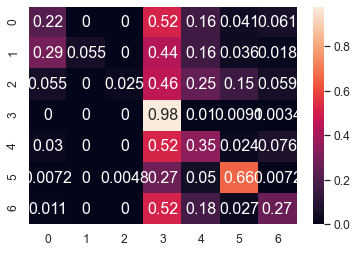

	training epoch=38 .. train_loss=0.976
	validation epoch=38 .. val_loss=1.796
	Accuracy = 45.5 % .. Percision = 64.1 % .. Recall = 36.5 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_38.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 39 .. loss = 0.893


  0%|                                                                                 | 1/1914 [00:01<48:09,  1.51s/it]

training @ epoch 39 .. loss = 0.715


  0%|                                                                                 | 2/1914 [00:03<49:19,  1.55s/it]

training @ epoch 39 .. loss = 1.775


  0%|▏                                                                                | 3/1914 [00:04<49:16,  1.55s/it]

training @ epoch 39 .. loss = 0.691


  0%|▏                                                                                | 4/1914 [00:06<47:41,  1.50s/it]

training @ epoch 39 .. loss = 1.201


  0%|▏                                                                                | 5/1914 [00:07<46:58,  1.48s/it]

training @ epoch 39 .. loss = 0.815


  0%|▎                                                                                | 6/1914 [00:08<45:46,  1.44s/it]

training @ epoch 39 .. loss = 0.515


  0%|▎                                                                                | 7/1914 [00:10<45:25,  1.43s/it]

training @ epoch 39 .. loss = 0.95


  0%|▎                                                                                | 8/1914 [00:11<44:41,  1.41s/it]

training @ epoch 39 .. loss = 0.967


  0%|▍                                                                                | 9/1914 [00:12<44:10,  1.39s/it]

training @ epoch 39 .. loss = 0.705


  1%|▍                                                                               | 10/1914 [00:14<43:18,  1.36s/it]

training @ epoch 39 .. loss = 1.097


  1%|▍                                                                               | 11/1914 [00:15<43:04,  1.36s/it]

training @ epoch 39 .. loss = 0.985


  1%|▌                                                                               | 12/1914 [00:16<42:43,  1.35s/it]

training @ epoch 39 .. loss = 0.926


  1%|▌                                                                               | 13/1914 [00:18<42:46,  1.35s/it]

training @ epoch 39 .. loss = 1.064


  1%|▌                                                                               | 14/1914 [00:19<42:54,  1.35s/it]

training @ epoch 39 .. loss = 1.246


  1%|▋                                                                               | 15/1914 [00:21<42:45,  1.35s/it]

training @ epoch 39 .. loss = 1.262


  1%|▋                                                                               | 16/1914 [00:22<42:34,  1.35s/it]

training @ epoch 39 .. loss = 0.886


  1%|▋                                                                               | 17/1914 [00:23<42:39,  1.35s/it]

training @ epoch 39 .. loss = 1.024


  1%|▊                                                                               | 18/1914 [00:25<42:52,  1.36s/it]

training @ epoch 39 .. loss = 0.84


  1%|▊                                                                               | 19/1914 [00:26<42:49,  1.36s/it]

training @ epoch 39 .. loss = 0.606


  1%|▊                                                                               | 20/1914 [00:27<42:30,  1.35s/it]

training @ epoch 39 .. loss = 1.08


  1%|▉                                                                               | 21/1914 [00:29<42:34,  1.35s/it]

training @ epoch 39 .. loss = 0.959


  1%|▉                                                                               | 22/1914 [00:30<42:47,  1.36s/it]

training @ epoch 39 .. loss = 0.949


  1%|▉                                                                               | 23/1914 [00:31<42:30,  1.35s/it]

training @ epoch 39 .. loss = 0.915


  1%|█                                                                               | 24/1914 [00:33<43:07,  1.37s/it]

training @ epoch 39 .. loss = 1.32


  1%|█                                                                               | 25/1914 [00:34<43:03,  1.37s/it]

training @ epoch 39 .. loss = 0.825


  1%|█                                                                               | 26/1914 [00:35<42:37,  1.35s/it]

training @ epoch 39 .. loss = 0.675


  1%|█▏                                                                              | 27/1914 [00:37<43:10,  1.37s/it]

training @ epoch 39 .. loss = 0.723


  1%|█▏                                                                              | 28/1914 [00:38<42:58,  1.37s/it]

training @ epoch 39 .. loss = 0.868


  2%|█▏                                                                              | 29/1914 [00:39<42:15,  1.35s/it]

training @ epoch 39 .. loss = 0.632


  2%|█▎                                                                              | 30/1914 [00:41<42:52,  1.37s/it]

training @ epoch 39 .. loss = 1.078


  2%|█▎                                                                              | 31/1914 [00:42<42:40,  1.36s/it]

training @ epoch 39 .. loss = 0.783


  2%|█▎                                                                              | 32/1914 [00:44<42:41,  1.36s/it]

training @ epoch 39 .. loss = 1.11


  2%|█▍                                                                              | 33/1914 [00:45<42:54,  1.37s/it]

training @ epoch 39 .. loss = 1.031


  2%|█▍                                                                              | 34/1914 [00:46<42:50,  1.37s/it]

training @ epoch 39 .. loss = 1.199


  2%|█▍                                                                              | 35/1914 [00:48<42:30,  1.36s/it]

training @ epoch 39 .. loss = 1.059


  2%|█▌                                                                              | 36/1914 [00:49<42:20,  1.35s/it]

training @ epoch 39 .. loss = 1.061


  2%|█▌                                                                              | 37/1914 [00:50<43:12,  1.38s/it]

training @ epoch 39 .. loss = 0.983


  2%|█▌                                                                              | 38/1914 [00:52<42:32,  1.36s/it]

training @ epoch 39 .. loss = 1.036


  2%|█▋                                                                              | 39/1914 [00:53<42:22,  1.36s/it]

training @ epoch 39 .. loss = 0.555


  2%|█▋                                                                              | 40/1914 [00:54<42:08,  1.35s/it]

training @ epoch 39 .. loss = 1.436


  2%|█▋                                                                              | 41/1914 [00:56<41:52,  1.34s/it]

training @ epoch 39 .. loss = 0.922


  2%|█▊                                                                              | 42/1914 [00:57<42:04,  1.35s/it]

training @ epoch 39 .. loss = 0.853


  2%|█▊                                                                              | 43/1914 [00:59<42:16,  1.36s/it]

training @ epoch 39 .. loss = 1.031


  2%|█▊                                                                              | 44/1914 [01:00<42:21,  1.36s/it]

training @ epoch 39 .. loss = 1.073


  2%|█▉                                                                              | 45/1914 [01:01<42:09,  1.35s/it]

training @ epoch 39 .. loss = 0.733


  2%|█▉                                                                              | 46/1914 [01:03<42:50,  1.38s/it]

training @ epoch 39 .. loss = 0.586


  2%|█▉                                                                              | 47/1914 [01:04<44:42,  1.44s/it]

training @ epoch 39 .. loss = 0.849


  3%|██                                                                              | 48/1914 [01:06<45:08,  1.45s/it]

training @ epoch 39 .. loss = 0.847


  3%|██                                                                              | 49/1914 [01:07<45:55,  1.48s/it]

training @ epoch 39 .. loss = 1.334


  3%|██                                                                              | 50/1914 [01:09<45:41,  1.47s/it]

training @ epoch 39 .. loss = 0.809


  3%|██▏                                                                             | 51/1914 [01:10<45:03,  1.45s/it]

training @ epoch 39 .. loss = 1.555


  3%|██▏                                                                             | 52/1914 [01:12<44:24,  1.43s/it]

training @ epoch 39 .. loss = 1.129


  3%|██▏                                                                             | 53/1914 [01:13<43:41,  1.41s/it]

training @ epoch 39 .. loss = 1.301


  3%|██▎                                                                             | 54/1914 [01:14<43:20,  1.40s/it]

training @ epoch 39 .. loss = 1.27


  3%|██▎                                                                             | 55/1914 [01:16<42:26,  1.37s/it]

training @ epoch 39 .. loss = 0.858


  3%|██▎                                                                             | 56/1914 [01:17<42:55,  1.39s/it]

training @ epoch 39 .. loss = 1.174


  3%|██▍                                                                             | 57/1914 [01:18<42:42,  1.38s/it]

training @ epoch 39 .. loss = 0.754


  3%|██▍                                                                             | 58/1914 [01:20<42:03,  1.36s/it]

training @ epoch 39 .. loss = 0.935


  3%|██▍                                                                             | 59/1914 [01:21<41:59,  1.36s/it]

training @ epoch 39 .. loss = 0.834


  3%|██▌                                                                             | 60/1914 [01:22<41:55,  1.36s/it]

training @ epoch 39 .. loss = 1.204


  3%|██▌                                                                             | 61/1914 [01:24<41:54,  1.36s/it]

training @ epoch 39 .. loss = 0.717


  3%|██▌                                                                             | 62/1914 [01:25<41:44,  1.35s/it]

training @ epoch 39 .. loss = 0.873


  3%|██▋                                                                             | 63/1914 [01:26<42:13,  1.37s/it]

training @ epoch 39 .. loss = 0.873


  3%|██▋                                                                             | 64/1914 [01:28<41:59,  1.36s/it]

training @ epoch 39 .. loss = 0.753


  3%|██▋                                                                             | 65/1914 [01:29<41:35,  1.35s/it]

training @ epoch 39 .. loss = 1.132


  3%|██▊                                                                             | 66/1914 [01:31<42:06,  1.37s/it]

training @ epoch 39 .. loss = 1.061


  4%|██▊                                                                             | 67/1914 [01:32<41:45,  1.36s/it]

training @ epoch 39 .. loss = 0.658


  4%|██▊                                                                             | 68/1914 [01:33<41:27,  1.35s/it]

training @ epoch 39 .. loss = 1.086


  4%|██▉                                                                             | 69/1914 [01:35<41:29,  1.35s/it]

training @ epoch 39 .. loss = 0.761


  4%|██▉                                                                             | 70/1914 [01:36<41:46,  1.36s/it]

training @ epoch 39 .. loss = 0.941


  4%|██▉                                                                             | 71/1914 [01:37<41:41,  1.36s/it]

training @ epoch 39 .. loss = 1.113


  4%|███                                                                             | 72/1914 [01:39<41:45,  1.36s/it]

training @ epoch 39 .. loss = 1.259


  4%|███                                                                             | 73/1914 [01:40<41:18,  1.35s/it]

training @ epoch 39 .. loss = 0.602


  4%|███                                                                             | 74/1914 [01:41<41:21,  1.35s/it]

training @ epoch 39 .. loss = 0.79


  4%|███▏                                                                            | 75/1914 [01:43<41:51,  1.37s/it]

training @ epoch 39 .. loss = 0.916


  4%|███▏                                                                            | 76/1914 [01:44<41:27,  1.35s/it]

training @ epoch 39 .. loss = 1.152


  4%|███▏                                                                            | 77/1914 [01:45<40:57,  1.34s/it]

training @ epoch 39 .. loss = 1.336


  4%|███▎                                                                            | 78/1914 [01:47<41:06,  1.34s/it]

training @ epoch 39 .. loss = 1.376


  4%|███▎                                                                            | 79/1914 [01:48<41:17,  1.35s/it]

training @ epoch 39 .. loss = 0.858


  4%|███▎                                                                            | 80/1914 [01:49<41:28,  1.36s/it]

training @ epoch 39 .. loss = 0.9


  4%|███▍                                                                            | 81/1914 [01:51<41:04,  1.34s/it]

training @ epoch 39 .. loss = 0.901


  4%|███▍                                                                            | 82/1914 [01:52<41:03,  1.34s/it]

training @ epoch 39 .. loss = 0.687


  4%|███▍                                                                            | 83/1914 [01:53<40:55,  1.34s/it]

training @ epoch 39 .. loss = 1.476


  4%|███▌                                                                            | 84/1914 [01:55<41:52,  1.37s/it]

training @ epoch 39 .. loss = 0.809


  4%|███▌                                                                            | 85/1914 [01:56<41:51,  1.37s/it]

training @ epoch 39 .. loss = 0.807


  4%|███▌                                                                            | 86/1914 [01:58<41:01,  1.35s/it]

training @ epoch 39 .. loss = 1.294


  5%|███▋                                                                            | 87/1914 [01:59<41:10,  1.35s/it]

training @ epoch 39 .. loss = 1.019


  5%|███▋                                                                            | 88/1914 [02:00<41:05,  1.35s/it]

training @ epoch 39 .. loss = 1.367


  5%|███▋                                                                            | 89/1914 [02:02<40:38,  1.34s/it]

training @ epoch 39 .. loss = 1.448


  5%|███▊                                                                            | 90/1914 [02:03<41:30,  1.37s/it]

training @ epoch 39 .. loss = 1.193


  5%|███▊                                                                            | 91/1914 [02:04<42:25,  1.40s/it]

training @ epoch 39 .. loss = 0.554


  5%|███▊                                                                            | 92/1914 [02:06<41:43,  1.37s/it]

training @ epoch 39 .. loss = 0.615


  5%|███▉                                                                            | 93/1914 [02:07<41:53,  1.38s/it]

training @ epoch 39 .. loss = 0.832


  5%|███▉                                                                            | 94/1914 [02:08<41:15,  1.36s/it]

training @ epoch 39 .. loss = 1.138


  5%|███▉                                                                            | 95/1914 [02:10<41:22,  1.36s/it]

training @ epoch 39 .. loss = 0.897


  5%|████                                                                            | 96/1914 [02:11<41:15,  1.36s/it]

training @ epoch 39 .. loss = 0.572


  5%|████                                                                            | 97/1914 [02:13<40:59,  1.35s/it]

training @ epoch 39 .. loss = 0.999


  5%|████                                                                            | 98/1914 [02:14<40:35,  1.34s/it]

training @ epoch 39 .. loss = 1.275


  5%|████▏                                                                           | 99/1914 [02:15<40:30,  1.34s/it]

training @ epoch 39 .. loss = 1.492


  5%|████▏                                                                          | 100/1914 [02:17<40:49,  1.35s/it]

training @ epoch 39 .. loss = 0.672


  5%|████▏                                                                          | 101/1914 [02:18<40:54,  1.35s/it]

training @ epoch 39 .. loss = 0.914


  5%|████▏                                                                          | 102/1914 [02:19<40:36,  1.34s/it]

training @ epoch 39 .. loss = 0.917


  5%|████▎                                                                          | 103/1914 [02:21<40:27,  1.34s/it]

training @ epoch 39 .. loss = 1.4


  5%|████▎                                                                          | 104/1914 [02:22<40:44,  1.35s/it]

training @ epoch 39 .. loss = 0.753


  5%|████▎                                                                          | 105/1914 [02:23<40:43,  1.35s/it]

training @ epoch 39 .. loss = 1.05


  6%|████▍                                                                          | 106/1914 [02:25<41:44,  1.39s/it]

training @ epoch 39 .. loss = 1.194


  6%|████▍                                                                          | 107/1914 [02:26<41:30,  1.38s/it]

training @ epoch 39 .. loss = 0.657


  6%|████▍                                                                          | 108/1914 [02:27<40:50,  1.36s/it]

training @ epoch 39 .. loss = 0.749


  6%|████▍                                                                          | 109/1914 [02:29<41:31,  1.38s/it]

training @ epoch 39 .. loss = 1.251


  6%|████▌                                                                          | 110/1914 [02:30<41:21,  1.38s/it]

training @ epoch 39 .. loss = 0.811


  6%|████▌                                                                          | 111/1914 [02:32<40:36,  1.35s/it]

training @ epoch 39 .. loss = 1.41


  6%|████▌                                                                          | 112/1914 [02:33<40:47,  1.36s/it]

training @ epoch 39 .. loss = 1.04


  6%|████▋                                                                          | 113/1914 [02:34<40:38,  1.35s/it]

training @ epoch 39 .. loss = 1.01


  6%|████▋                                                                          | 114/1914 [02:36<40:58,  1.37s/it]

training @ epoch 39 .. loss = 0.904


  6%|████▋                                                                          | 115/1914 [02:37<40:41,  1.36s/it]

training @ epoch 39 .. loss = 1.354


  6%|████▊                                                                          | 116/1914 [02:38<40:38,  1.36s/it]

training @ epoch 39 .. loss = 0.778


  6%|████▊                                                                          | 117/1914 [02:40<40:25,  1.35s/it]

training @ epoch 39 .. loss = 1.317


  6%|████▊                                                                          | 118/1914 [02:41<40:20,  1.35s/it]

training @ epoch 39 .. loss = 1.087


  6%|████▉                                                                          | 119/1914 [02:42<40:23,  1.35s/it]

training @ epoch 39 .. loss = 0.556


  6%|████▉                                                                          | 120/1914 [02:44<40:13,  1.35s/it]

training @ epoch 39 .. loss = 1.072


  6%|████▉                                                                          | 121/1914 [02:45<40:05,  1.34s/it]

training @ epoch 39 .. loss = 1.107


  6%|█████                                                                          | 122/1914 [02:46<39:59,  1.34s/it]

training @ epoch 39 .. loss = 0.925


  6%|█████                                                                          | 123/1914 [02:48<40:01,  1.34s/it]

training @ epoch 39 .. loss = 1.001


  6%|█████                                                                          | 124/1914 [02:49<40:07,  1.35s/it]

training @ epoch 39 .. loss = 0.502


  7%|█████▏                                                                         | 125/1914 [02:50<40:11,  1.35s/it]

training @ epoch 39 .. loss = 0.727


  7%|█████▏                                                                         | 126/1914 [02:52<40:03,  1.34s/it]

training @ epoch 39 .. loss = 0.649


  7%|█████▏                                                                         | 127/1914 [02:53<40:01,  1.34s/it]

training @ epoch 39 .. loss = 0.684


  7%|█████▎                                                                         | 128/1914 [02:55<40:33,  1.36s/it]

training @ epoch 39 .. loss = 0.84


  7%|█████▎                                                                         | 129/1914 [02:56<40:27,  1.36s/it]

training @ epoch 39 .. loss = 0.76


  7%|█████▎                                                                         | 130/1914 [02:57<40:12,  1.35s/it]

training @ epoch 39 .. loss = 0.974


  7%|█████▍                                                                         | 131/1914 [02:59<39:56,  1.34s/it]

training @ epoch 39 .. loss = 0.945


  7%|█████▍                                                                         | 132/1914 [03:00<39:57,  1.35s/it]

training @ epoch 39 .. loss = 1.076


  7%|█████▍                                                                         | 133/1914 [03:01<40:13,  1.36s/it]

training @ epoch 39 .. loss = 0.906


  7%|█████▌                                                                         | 134/1914 [03:03<40:13,  1.36s/it]

training @ epoch 39 .. loss = 0.923


  7%|█████▌                                                                         | 135/1914 [03:04<39:53,  1.35s/it]

training @ epoch 39 .. loss = 0.637


  7%|█████▌                                                                         | 136/1914 [03:05<39:57,  1.35s/it]

training @ epoch 39 .. loss = 1.254


  7%|█████▋                                                                         | 137/1914 [03:07<40:37,  1.37s/it]

training @ epoch 39 .. loss = 1.043


  7%|█████▋                                                                         | 138/1914 [03:08<40:59,  1.38s/it]

training @ epoch 39 .. loss = 0.978


  7%|█████▋                                                                         | 139/1914 [03:09<40:13,  1.36s/it]

training @ epoch 39 .. loss = 0.893


  7%|█████▊                                                                         | 140/1914 [03:11<39:55,  1.35s/it]

training @ epoch 39 .. loss = 0.536


  7%|█████▊                                                                         | 141/1914 [03:12<39:45,  1.35s/it]

training @ epoch 39 .. loss = 1.133


  7%|█████▊                                                                         | 142/1914 [03:13<39:49,  1.35s/it]

training @ epoch 39 .. loss = 0.619


  7%|█████▉                                                                         | 143/1914 [03:15<40:12,  1.36s/it]

training @ epoch 39 .. loss = 1.295


  8%|█████▉                                                                         | 144/1914 [03:16<40:00,  1.36s/it]

training @ epoch 39 .. loss = 0.793


  8%|█████▉                                                                         | 145/1914 [03:18<39:42,  1.35s/it]

training @ epoch 39 .. loss = 0.563


  8%|██████                                                                         | 146/1914 [03:19<39:55,  1.35s/it]

training @ epoch 39 .. loss = 1.082


  8%|██████                                                                         | 147/1914 [03:20<39:49,  1.35s/it]

training @ epoch 39 .. loss = 0.863


  8%|██████                                                                         | 148/1914 [03:22<39:49,  1.35s/it]

training @ epoch 39 .. loss = 0.506


  8%|██████▏                                                                        | 149/1914 [03:23<39:59,  1.36s/it]

training @ epoch 39 .. loss = 0.949


  8%|██████▏                                                                        | 150/1914 [03:24<39:39,  1.35s/it]

training @ epoch 39 .. loss = 0.913


  8%|██████▏                                                                        | 151/1914 [03:26<40:18,  1.37s/it]

training @ epoch 39 .. loss = 1.075


  8%|██████▎                                                                        | 152/1914 [03:27<40:18,  1.37s/it]

training @ epoch 39 .. loss = 0.584


  8%|██████▎                                                                        | 153/1914 [03:28<40:28,  1.38s/it]

training @ epoch 39 .. loss = 1.376


  8%|██████▎                                                                        | 154/1914 [03:30<39:47,  1.36s/it]

training @ epoch 39 .. loss = 0.794


  8%|██████▍                                                                        | 155/1914 [03:31<39:39,  1.35s/it]

training @ epoch 39 .. loss = 1.151


  8%|██████▍                                                                        | 156/1914 [03:33<41:21,  1.41s/it]

training @ epoch 39 .. loss = 0.924


  8%|██████▍                                                                        | 157/1914 [03:34<41:30,  1.42s/it]

training @ epoch 39 .. loss = 1.159


  8%|██████▌                                                                        | 158/1914 [03:35<40:38,  1.39s/it]

training @ epoch 39 .. loss = 0.891


  8%|██████▌                                                                        | 159/1914 [03:37<40:46,  1.39s/it]

training @ epoch 39 .. loss = 1.039


  8%|██████▌                                                                        | 160/1914 [03:38<40:12,  1.38s/it]

training @ epoch 39 .. loss = 0.975


  8%|██████▋                                                                        | 161/1914 [03:39<39:40,  1.36s/it]

training @ epoch 39 .. loss = 1.119


  8%|██████▋                                                                        | 162/1914 [03:41<40:19,  1.38s/it]

training @ epoch 39 .. loss = 0.733


  9%|██████▋                                                                        | 163/1914 [03:42<40:20,  1.38s/it]

training @ epoch 39 .. loss = 1.13


  9%|██████▊                                                                        | 164/1914 [03:44<39:21,  1.35s/it]

training @ epoch 39 .. loss = 1.27


  9%|██████▊                                                                        | 165/1914 [03:45<39:28,  1.35s/it]

training @ epoch 39 .. loss = 1.068


  9%|██████▊                                                                        | 166/1914 [03:46<39:48,  1.37s/it]

training @ epoch 39 .. loss = 0.742


  9%|██████▉                                                                        | 167/1914 [03:48<40:00,  1.37s/it]

training @ epoch 39 .. loss = 1.026


  9%|██████▉                                                                        | 168/1914 [03:49<39:23,  1.35s/it]

training @ epoch 39 .. loss = 0.638


  9%|██████▉                                                                        | 169/1914 [03:50<39:11,  1.35s/it]

training @ epoch 39 .. loss = 0.98


  9%|███████                                                                        | 170/1914 [03:52<39:30,  1.36s/it]

training @ epoch 39 .. loss = 1.312


  9%|███████                                                                        | 171/1914 [03:53<39:36,  1.36s/it]

training @ epoch 39 .. loss = 0.766


  9%|███████                                                                        | 172/1914 [03:55<39:39,  1.37s/it]

training @ epoch 39 .. loss = 1.344


  9%|███████▏                                                                       | 173/1914 [03:56<39:21,  1.36s/it]

training @ epoch 39 .. loss = 0.59


  9%|███████▏                                                                       | 174/1914 [03:57<39:04,  1.35s/it]

training @ epoch 39 .. loss = 1.081


  9%|███████▏                                                                       | 175/1914 [03:59<39:06,  1.35s/it]

training @ epoch 39 .. loss = 0.719


  9%|███████▎                                                                       | 176/1914 [04:00<39:02,  1.35s/it]

training @ epoch 39 .. loss = 1.367


  9%|███████▎                                                                       | 177/1914 [04:01<39:15,  1.36s/it]

training @ epoch 39 .. loss = 0.972


  9%|███████▎                                                                       | 178/1914 [04:03<39:07,  1.35s/it]

training @ epoch 39 .. loss = 1.05


  9%|███████▍                                                                       | 179/1914 [04:04<39:07,  1.35s/it]

training @ epoch 39 .. loss = 0.835


  9%|███████▍                                                                       | 180/1914 [04:05<39:07,  1.35s/it]

training @ epoch 39 .. loss = 1.122


  9%|███████▍                                                                       | 181/1914 [04:07<39:11,  1.36s/it]

training @ epoch 39 .. loss = 0.934


 10%|███████▌                                                                       | 182/1914 [04:08<39:04,  1.35s/it]

training @ epoch 39 .. loss = 1.004


 10%|███████▌                                                                       | 183/1914 [04:09<38:31,  1.34s/it]

training @ epoch 39 .. loss = 1.055


 10%|███████▌                                                                       | 184/1914 [04:11<38:49,  1.35s/it]

training @ epoch 39 .. loss = 0.847


 10%|███████▋                                                                       | 185/1914 [04:12<38:37,  1.34s/it]

training @ epoch 39 .. loss = 0.795


 10%|███████▋                                                                       | 186/1914 [04:13<38:59,  1.35s/it]

training @ epoch 39 .. loss = 0.741


 10%|███████▋                                                                       | 187/1914 [04:15<38:58,  1.35s/it]

training @ epoch 39 .. loss = 0.86


 10%|███████▊                                                                       | 188/1914 [04:16<38:35,  1.34s/it]

training @ epoch 39 .. loss = 1.176


 10%|███████▊                                                                       | 189/1914 [04:17<38:15,  1.33s/it]

training @ epoch 39 .. loss = 1.084


 10%|███████▊                                                                       | 190/1914 [04:19<38:26,  1.34s/it]

training @ epoch 39 .. loss = 0.979


 10%|███████▉                                                                       | 191/1914 [04:20<38:49,  1.35s/it]

training @ epoch 39 .. loss = 1.062


 10%|███████▉                                                                       | 192/1914 [04:21<38:23,  1.34s/it]

training @ epoch 39 .. loss = 0.629


 10%|███████▉                                                                       | 193/1914 [04:23<38:44,  1.35s/it]

training @ epoch 39 .. loss = 0.568


 10%|████████                                                                       | 194/1914 [04:24<38:35,  1.35s/it]

training @ epoch 39 .. loss = 0.893


 10%|████████                                                                       | 195/1914 [04:25<38:16,  1.34s/it]

training @ epoch 39 .. loss = 0.822


 10%|████████                                                                       | 196/1914 [04:27<39:06,  1.37s/it]

training @ epoch 39 .. loss = 0.946


 10%|████████▏                                                                      | 197/1914 [04:28<39:14,  1.37s/it]

training @ epoch 39 .. loss = 1.54


 10%|████████▏                                                                      | 198/1914 [04:30<38:33,  1.35s/it]

training @ epoch 39 .. loss = 0.699


 10%|████████▏                                                                      | 199/1914 [04:31<38:35,  1.35s/it]

training @ epoch 39 .. loss = 0.901


 10%|████████▎                                                                      | 200/1914 [04:32<39:02,  1.37s/it]

training @ epoch 39 .. loss = 1.103


 11%|████████▎                                                                      | 201/1914 [04:34<40:07,  1.41s/it]

training @ epoch 39 .. loss = 1.37


 11%|████████▎                                                                      | 202/1914 [04:35<39:03,  1.37s/it]

training @ epoch 39 .. loss = 1.001


 11%|████████▍                                                                      | 203/1914 [04:36<38:39,  1.36s/it]

training @ epoch 39 .. loss = 1.028


 11%|████████▍                                                                      | 204/1914 [04:38<38:57,  1.37s/it]

training @ epoch 39 .. loss = 1.146


 11%|████████▍                                                                      | 205/1914 [04:39<39:00,  1.37s/it]

training @ epoch 39 .. loss = 0.978


 11%|████████▌                                                                      | 206/1914 [04:41<39:07,  1.37s/it]

training @ epoch 39 .. loss = 0.958


 11%|████████▌                                                                      | 207/1914 [04:42<38:25,  1.35s/it]

training @ epoch 39 .. loss = 0.948


 11%|████████▌                                                                      | 208/1914 [04:43<38:09,  1.34s/it]

training @ epoch 39 .. loss = 0.577


 11%|████████▋                                                                      | 209/1914 [04:44<37:59,  1.34s/it]

training @ epoch 39 .. loss = 1.604


 11%|████████▋                                                                      | 210/1914 [04:46<38:02,  1.34s/it]

training @ epoch 39 .. loss = 0.831


 11%|████████▋                                                                      | 211/1914 [04:47<38:34,  1.36s/it]

training @ epoch 39 .. loss = 0.946


 11%|████████▊                                                                      | 212/1914 [04:49<38:34,  1.36s/it]

training @ epoch 39 .. loss = 0.688


 11%|████████▊                                                                      | 213/1914 [04:50<38:20,  1.35s/it]

training @ epoch 39 .. loss = 0.748


 11%|████████▊                                                                      | 214/1914 [04:51<37:59,  1.34s/it]

training @ epoch 39 .. loss = 0.88


 11%|████████▊                                                                      | 215/1914 [04:53<38:15,  1.35s/it]

training @ epoch 39 .. loss = 0.945


 11%|████████▉                                                                      | 216/1914 [04:54<38:31,  1.36s/it]

training @ epoch 39 .. loss = 1.288


 11%|████████▉                                                                      | 217/1914 [04:55<38:04,  1.35s/it]

training @ epoch 39 .. loss = 0.98


 11%|████████▉                                                                      | 218/1914 [04:57<38:18,  1.35s/it]

training @ epoch 39 .. loss = 1.0


 11%|█████████                                                                      | 219/1914 [04:58<38:06,  1.35s/it]

training @ epoch 39 .. loss = 1.078


 11%|█████████                                                                      | 220/1914 [04:59<37:38,  1.33s/it]

training @ epoch 39 .. loss = 0.958


 12%|█████████                                                                      | 221/1914 [05:01<38:13,  1.35s/it]

training @ epoch 39 .. loss = 1.158


 12%|█████████▏                                                                     | 222/1914 [05:02<38:16,  1.36s/it]

training @ epoch 39 .. loss = 0.806


 12%|█████████▏                                                                     | 223/1914 [05:03<38:03,  1.35s/it]

training @ epoch 39 .. loss = 0.906


 12%|█████████▏                                                                     | 224/1914 [05:05<38:34,  1.37s/it]

training @ epoch 39 .. loss = 1.006


 12%|█████████▎                                                                     | 225/1914 [05:06<38:21,  1.36s/it]

training @ epoch 39 .. loss = 1.413


 12%|█████████▎                                                                     | 226/1914 [05:08<38:34,  1.37s/it]

training @ epoch 39 .. loss = 0.803


 12%|█████████▎                                                                     | 227/1914 [05:09<38:25,  1.37s/it]

training @ epoch 39 .. loss = 1.431


 12%|█████████▍                                                                     | 228/1914 [05:10<38:12,  1.36s/it]

training @ epoch 39 .. loss = 0.379


 12%|█████████▍                                                                     | 229/1914 [05:12<37:42,  1.34s/it]

training @ epoch 39 .. loss = 0.852


 12%|█████████▍                                                                     | 230/1914 [05:13<38:02,  1.36s/it]

training @ epoch 39 .. loss = 0.77


 12%|█████████▌                                                                     | 231/1914 [05:14<38:11,  1.36s/it]

training @ epoch 39 .. loss = 1.01


 12%|█████████▌                                                                     | 232/1914 [05:16<37:50,  1.35s/it]

training @ epoch 39 .. loss = 0.768


 12%|█████████▌                                                                     | 233/1914 [05:17<37:56,  1.35s/it]

training @ epoch 39 .. loss = 0.887


 12%|█████████▋                                                                     | 234/1914 [05:18<38:09,  1.36s/it]

training @ epoch 39 .. loss = 0.784


 12%|█████████▋                                                                     | 235/1914 [05:20<38:15,  1.37s/it]

training @ epoch 39 .. loss = 0.798


 12%|█████████▋                                                                     | 236/1914 [05:21<38:07,  1.36s/it]

training @ epoch 39 .. loss = 1.271


 12%|█████████▊                                                                     | 237/1914 [05:23<38:01,  1.36s/it]

training @ epoch 39 .. loss = 0.946


 12%|█████████▊                                                                     | 238/1914 [05:24<37:36,  1.35s/it]

training @ epoch 39 .. loss = 1.054


 12%|█████████▊                                                                     | 239/1914 [05:25<37:53,  1.36s/it]

training @ epoch 39 .. loss = 1.052


 13%|█████████▉                                                                     | 240/1914 [05:27<38:01,  1.36s/it]

training @ epoch 39 .. loss = 0.624


 13%|█████████▉                                                                     | 241/1914 [05:28<38:10,  1.37s/it]

training @ epoch 39 .. loss = 1.408


 13%|█████████▉                                                                     | 242/1914 [05:29<37:56,  1.36s/it]

training @ epoch 39 .. loss = 1.111


 13%|██████████                                                                     | 243/1914 [05:31<38:01,  1.37s/it]

training @ epoch 39 .. loss = 0.806


 13%|██████████                                                                     | 244/1914 [05:32<38:09,  1.37s/it]

training @ epoch 39 .. loss = 1.041


 13%|██████████                                                                     | 245/1914 [05:34<38:56,  1.40s/it]

training @ epoch 39 .. loss = 0.773


 13%|██████████▏                                                                    | 246/1914 [05:35<38:32,  1.39s/it]

training @ epoch 39 .. loss = 0.801


 13%|██████████▏                                                                    | 247/1914 [05:36<38:20,  1.38s/it]

training @ epoch 39 .. loss = 0.764


 13%|██████████▏                                                                    | 248/1914 [05:38<37:40,  1.36s/it]

training @ epoch 39 .. loss = 1.13


 13%|██████████▎                                                                    | 249/1914 [05:39<37:27,  1.35s/it]

training @ epoch 39 .. loss = 1.621


 13%|██████████▎                                                                    | 250/1914 [05:40<37:52,  1.37s/it]

training @ epoch 39 .. loss = 0.531


 13%|██████████▎                                                                    | 251/1914 [05:42<37:16,  1.34s/it]

training @ epoch 39 .. loss = 1.018


 13%|██████████▍                                                                    | 252/1914 [05:43<37:10,  1.34s/it]

training @ epoch 39 .. loss = 1.247


 13%|██████████▍                                                                    | 253/1914 [05:44<37:29,  1.35s/it]

training @ epoch 39 .. loss = 1.264


 13%|██████████▍                                                                    | 254/1914 [05:46<37:09,  1.34s/it]

training @ epoch 39 .. loss = 1.145


 13%|██████████▌                                                                    | 255/1914 [05:47<37:43,  1.36s/it]

training @ epoch 39 .. loss = 0.974


 13%|██████████▌                                                                    | 256/1914 [05:48<37:33,  1.36s/it]

training @ epoch 39 .. loss = 0.888


 13%|██████████▌                                                                    | 257/1914 [05:50<39:30,  1.43s/it]

training @ epoch 39 .. loss = 0.884


 13%|██████████▋                                                                    | 258/1914 [05:53<48:51,  1.77s/it]

training @ epoch 39 .. loss = 0.616


 14%|██████████▋                                                                    | 259/1914 [05:55<50:29,  1.83s/it]

training @ epoch 39 .. loss = 0.955


 14%|██████████▋                                                                    | 260/1914 [05:56<48:33,  1.76s/it]

training @ epoch 39 .. loss = 1.55


 14%|██████████▊                                                                    | 261/1914 [05:58<46:05,  1.67s/it]

training @ epoch 39 .. loss = 1.182


 14%|██████████▊                                                                    | 262/1914 [06:00<52:37,  1.91s/it]

training @ epoch 39 .. loss = 0.709


 14%|██████████▊                                                                    | 263/1914 [06:02<48:55,  1.78s/it]

training @ epoch 39 .. loss = 1.088


 14%|██████████▉                                                                    | 264/1914 [06:04<52:07,  1.90s/it]

training @ epoch 39 .. loss = 1.065


 14%|██████████▉                                                                    | 265/1914 [06:05<49:07,  1.79s/it]

training @ epoch 39 .. loss = 1.028


 14%|██████████▉                                                                    | 266/1914 [06:07<51:58,  1.89s/it]

training @ epoch 39 .. loss = 0.651


 14%|███████████                                                                    | 267/1914 [06:10<58:41,  2.14s/it]

training @ epoch 39 .. loss = 1.299


 14%|███████████                                                                    | 268/1914 [06:12<57:02,  2.08s/it]

training @ epoch 39 .. loss = 1.009


 14%|███████████                                                                    | 269/1914 [06:14<58:13,  2.12s/it]

training @ epoch 39 .. loss = 1.096


 14%|███████████▏                                                                   | 270/1914 [06:16<55:49,  2.04s/it]

training @ epoch 39 .. loss = 0.923


 14%|██████████▉                                                                  | 271/1914 [06:19<1:01:22,  2.24s/it]

training @ epoch 39 .. loss = 0.741


 14%|███████████▏                                                                   | 272/1914 [06:20<55:57,  2.04s/it]

training @ epoch 39 .. loss = 0.711


 14%|███████████▎                                                                   | 273/1914 [06:22<51:35,  1.89s/it]

training @ epoch 39 .. loss = 0.611


 14%|███████████▎                                                                   | 274/1914 [06:23<47:56,  1.75s/it]

training @ epoch 39 .. loss = 0.822


 14%|███████████▎                                                                   | 275/1914 [06:25<45:41,  1.67s/it]

training @ epoch 39 .. loss = 0.885


 14%|███████████▍                                                                   | 276/1914 [06:26<45:07,  1.65s/it]

training @ epoch 39 .. loss = 1.024


 14%|███████████▍                                                                   | 277/1914 [06:28<42:47,  1.57s/it]

training @ epoch 39 .. loss = 0.868


 15%|███████████▍                                                                   | 278/1914 [06:29<41:17,  1.51s/it]

training @ epoch 39 .. loss = 0.973


 15%|███████████▌                                                                   | 279/1914 [06:31<40:16,  1.48s/it]

training @ epoch 39 .. loss = 0.903


 15%|███████████▌                                                                   | 280/1914 [06:32<39:35,  1.45s/it]

training @ epoch 39 .. loss = 0.925


 15%|███████████▌                                                                   | 281/1914 [06:33<39:24,  1.45s/it]

training @ epoch 39 .. loss = 0.806


 15%|███████████▋                                                                   | 282/1914 [06:35<41:25,  1.52s/it]

training @ epoch 39 .. loss = 1.424


 15%|███████████▋                                                                   | 283/1914 [06:37<43:13,  1.59s/it]

training @ epoch 39 .. loss = 0.894


 15%|███████████▋                                                                   | 284/1914 [06:39<44:28,  1.64s/it]

training @ epoch 39 .. loss = 1.448


 15%|███████████▊                                                                   | 285/1914 [06:40<45:09,  1.66s/it]

training @ epoch 39 .. loss = 0.716


 15%|███████████▊                                                                   | 286/1914 [06:42<44:48,  1.65s/it]

training @ epoch 39 .. loss = 0.978


 15%|███████████▊                                                                   | 287/1914 [06:44<44:04,  1.63s/it]

training @ epoch 39 .. loss = 0.807


 15%|███████████▉                                                                   | 288/1914 [06:45<44:10,  1.63s/it]

training @ epoch 39 .. loss = 1.073


 15%|███████████▉                                                                   | 289/1914 [06:47<44:09,  1.63s/it]

training @ epoch 39 .. loss = 1.291


 15%|███████████▉                                                                   | 290/1914 [06:48<43:41,  1.61s/it]

training @ epoch 39 .. loss = 0.905


 15%|████████████                                                                   | 291/1914 [06:50<44:30,  1.65s/it]

training @ epoch 39 .. loss = 1.026


 15%|████████████                                                                   | 292/1914 [06:52<44:21,  1.64s/it]

training @ epoch 39 .. loss = 0.996


 15%|████████████                                                                   | 293/1914 [06:53<44:31,  1.65s/it]

training @ epoch 39 .. loss = 1.097


 15%|████████████▏                                                                  | 294/1914 [06:55<46:20,  1.72s/it]

training @ epoch 39 .. loss = 0.844


 15%|████████████▏                                                                  | 295/1914 [06:58<53:39,  1.99s/it]

training @ epoch 39 .. loss = 1.546


 15%|████████████▏                                                                  | 296/1914 [07:00<51:47,  1.92s/it]

training @ epoch 39 .. loss = 1.1


 16%|████████████▎                                                                  | 297/1914 [07:01<50:32,  1.88s/it]

training @ epoch 39 .. loss = 0.977


 16%|████████████▎                                                                  | 298/1914 [07:03<48:57,  1.82s/it]

training @ epoch 39 .. loss = 0.715


 16%|████████████▎                                                                  | 299/1914 [07:05<48:41,  1.81s/it]

training @ epoch 39 .. loss = 1.008


 16%|████████████▍                                                                  | 300/1914 [07:07<47:40,  1.77s/it]

training @ epoch 39 .. loss = 0.941


 16%|████████████▍                                                                  | 301/1914 [07:08<46:43,  1.74s/it]

training @ epoch 39 .. loss = 1.154


 16%|████████████▍                                                                  | 302/1914 [07:10<46:28,  1.73s/it]

training @ epoch 39 .. loss = 0.966


 16%|████████████▌                                                                  | 303/1914 [07:12<46:49,  1.74s/it]

training @ epoch 39 .. loss = 0.78


 16%|████████████▌                                                                  | 304/1914 [07:13<44:53,  1.67s/it]

training @ epoch 39 .. loss = 0.823


 16%|████████████▌                                                                  | 305/1914 [07:15<44:15,  1.65s/it]

training @ epoch 39 .. loss = 1.106


 16%|████████████▋                                                                  | 306/1914 [07:17<46:01,  1.72s/it]

training @ epoch 39 .. loss = 0.872


 16%|████████████▋                                                                  | 307/1914 [07:18<46:34,  1.74s/it]

training @ epoch 39 .. loss = 0.933


 16%|████████████▋                                                                  | 308/1914 [07:20<47:16,  1.77s/it]

training @ epoch 39 .. loss = 0.919


 16%|████████████▊                                                                  | 309/1914 [07:22<48:34,  1.82s/it]

training @ epoch 39 .. loss = 0.81


 16%|████████████▊                                                                  | 310/1914 [07:24<46:38,  1.74s/it]

training @ epoch 39 .. loss = 1.095


 16%|████████████▊                                                                  | 311/1914 [07:26<50:32,  1.89s/it]

training @ epoch 39 .. loss = 0.891


 16%|████████████▉                                                                  | 312/1914 [07:28<49:08,  1.84s/it]

training @ epoch 39 .. loss = 0.781


 16%|████████████▉                                                                  | 313/1914 [07:29<47:29,  1.78s/it]

training @ epoch 39 .. loss = 1.559


 16%|████████████▉                                                                  | 314/1914 [07:31<45:21,  1.70s/it]

training @ epoch 39 .. loss = 0.804


 16%|█████████████                                                                  | 315/1914 [07:33<45:13,  1.70s/it]

training @ epoch 39 .. loss = 0.843


 17%|█████████████                                                                  | 316/1914 [07:34<43:59,  1.65s/it]

training @ epoch 39 .. loss = 1.17


 17%|█████████████                                                                  | 317/1914 [07:36<43:25,  1.63s/it]

training @ epoch 39 .. loss = 0.895


 17%|█████████████▏                                                                 | 318/1914 [07:37<44:11,  1.66s/it]

training @ epoch 39 .. loss = 0.782


 17%|█████████████▏                                                                 | 319/1914 [07:39<44:41,  1.68s/it]

training @ epoch 39 .. loss = 1.422


 17%|█████████████▏                                                                 | 320/1914 [07:41<44:12,  1.66s/it]

training @ epoch 39 .. loss = 1.197


 17%|█████████████▏                                                                 | 321/1914 [07:42<43:23,  1.63s/it]

training @ epoch 39 .. loss = 0.489


 17%|█████████████▎                                                                 | 322/1914 [07:44<42:45,  1.61s/it]

training @ epoch 39 .. loss = 1.089


 17%|█████████████▎                                                                 | 323/1914 [07:45<42:01,  1.59s/it]

training @ epoch 39 .. loss = 0.73


 17%|█████████████▎                                                                 | 324/1914 [07:47<41:52,  1.58s/it]

training @ epoch 39 .. loss = 0.78


 17%|█████████████▍                                                                 | 325/1914 [07:49<41:35,  1.57s/it]

training @ epoch 39 .. loss = 0.809


 17%|█████████████▍                                                                 | 326/1914 [07:50<41:42,  1.58s/it]

training @ epoch 39 .. loss = 0.411


 17%|█████████████▍                                                                 | 327/1914 [07:52<40:29,  1.53s/it]

training @ epoch 39 .. loss = 0.675


 17%|█████████████▌                                                                 | 328/1914 [07:53<39:09,  1.48s/it]

training @ epoch 39 .. loss = 1.122


 17%|█████████████▌                                                                 | 329/1914 [07:54<37:58,  1.44s/it]

training @ epoch 39 .. loss = 1.118


 17%|█████████████▌                                                                 | 330/1914 [07:56<37:55,  1.44s/it]

training @ epoch 39 .. loss = 1.091


 17%|█████████████▋                                                                 | 331/1914 [07:57<37:10,  1.41s/it]

training @ epoch 39 .. loss = 0.824


 17%|█████████████▋                                                                 | 332/1914 [07:59<37:11,  1.41s/it]

training @ epoch 39 .. loss = 0.903


 17%|█████████████▋                                                                 | 333/1914 [08:00<36:24,  1.38s/it]

training @ epoch 39 .. loss = 1.053


 17%|█████████████▊                                                                 | 334/1914 [08:01<36:00,  1.37s/it]

training @ epoch 39 .. loss = 0.697


 18%|█████████████▊                                                                 | 335/1914 [08:03<36:03,  1.37s/it]

training @ epoch 39 .. loss = 0.746


 18%|█████████████▊                                                                 | 336/1914 [08:04<36:08,  1.37s/it]

training @ epoch 39 .. loss = 1.144


 18%|█████████████▉                                                                 | 337/1914 [08:05<35:42,  1.36s/it]

training @ epoch 39 .. loss = 0.672


 18%|█████████████▉                                                                 | 338/1914 [08:07<35:35,  1.36s/it]

training @ epoch 39 .. loss = 0.813


 18%|█████████████▉                                                                 | 339/1914 [08:08<35:48,  1.36s/it]

training @ epoch 39 .. loss = 0.795


 18%|██████████████                                                                 | 340/1914 [08:09<36:06,  1.38s/it]

training @ epoch 39 .. loss = 0.63


 18%|██████████████                                                                 | 341/1914 [08:11<36:04,  1.38s/it]

training @ epoch 39 .. loss = 0.932


 18%|██████████████                                                                 | 342/1914 [08:12<36:54,  1.41s/it]

training @ epoch 39 .. loss = 1.167


 18%|██████████████▏                                                                | 343/1914 [08:14<37:24,  1.43s/it]

training @ epoch 39 .. loss = 1.081


 18%|██████████████▏                                                                | 344/1914 [08:15<39:01,  1.49s/it]

training @ epoch 39 .. loss = 0.945


 18%|██████████████▏                                                                | 345/1914 [08:17<38:23,  1.47s/it]

training @ epoch 39 .. loss = 0.623


 18%|██████████████▎                                                                | 346/1914 [08:18<37:34,  1.44s/it]

training @ epoch 39 .. loss = 0.821


 18%|██████████████▎                                                                | 347/1914 [08:20<37:30,  1.44s/it]

training @ epoch 39 .. loss = 1.048


 18%|██████████████▎                                                                | 348/1914 [08:21<38:40,  1.48s/it]

training @ epoch 39 .. loss = 0.962


 18%|██████████████▍                                                                | 349/1914 [08:23<38:40,  1.48s/it]

training @ epoch 39 .. loss = 1.423


 18%|██████████████▍                                                                | 350/1914 [08:24<37:39,  1.44s/it]

training @ epoch 39 .. loss = 1.419


 18%|██████████████▍                                                                | 351/1914 [08:25<37:23,  1.44s/it]

training @ epoch 39 .. loss = 1.057


 18%|██████████████▌                                                                | 352/1914 [08:27<36:58,  1.42s/it]

training @ epoch 39 .. loss = 0.575


 18%|██████████████▌                                                                | 353/1914 [08:28<36:17,  1.40s/it]

training @ epoch 39 .. loss = 0.806


 18%|██████████████▌                                                                | 354/1914 [08:30<36:21,  1.40s/it]

training @ epoch 39 .. loss = 1.152


 19%|██████████████▋                                                                | 355/1914 [08:31<36:28,  1.40s/it]

training @ epoch 39 .. loss = 0.719


 19%|██████████████▋                                                                | 356/1914 [08:32<36:22,  1.40s/it]

training @ epoch 39 .. loss = 0.923


 19%|██████████████▋                                                                | 357/1914 [08:34<35:50,  1.38s/it]

training @ epoch 39 .. loss = 0.791


 19%|██████████████▊                                                                | 358/1914 [08:35<35:41,  1.38s/it]

training @ epoch 39 .. loss = 0.779


 19%|██████████████▊                                                                | 359/1914 [08:36<35:39,  1.38s/it]

training @ epoch 39 .. loss = 0.932


 19%|██████████████▊                                                                | 360/1914 [08:38<35:38,  1.38s/it]

training @ epoch 39 .. loss = 0.827


 19%|██████████████▉                                                                | 361/1914 [08:39<35:36,  1.38s/it]

training @ epoch 39 .. loss = 1.148


 19%|██████████████▉                                                                | 362/1914 [08:41<35:34,  1.38s/it]

training @ epoch 39 .. loss = 0.681


 19%|██████████████▉                                                                | 363/1914 [08:42<36:23,  1.41s/it]

training @ epoch 39 .. loss = 0.77


 19%|███████████████                                                                | 364/1914 [08:44<38:08,  1.48s/it]

training @ epoch 39 .. loss = 1.022


 19%|███████████████                                                                | 365/1914 [08:45<37:02,  1.43s/it]

training @ epoch 39 .. loss = 0.72


 19%|███████████████                                                                | 366/1914 [08:46<36:23,  1.41s/it]

training @ epoch 39 .. loss = 0.879


 19%|███████████████▏                                                               | 367/1914 [08:48<35:59,  1.40s/it]

training @ epoch 39 .. loss = 0.726


 19%|███████████████▏                                                               | 368/1914 [08:49<35:34,  1.38s/it]

training @ epoch 39 .. loss = 1.123


 19%|███████████████▏                                                               | 369/1914 [08:50<35:35,  1.38s/it]

training @ epoch 39 .. loss = 0.915


 19%|███████████████▎                                                               | 370/1914 [08:52<35:30,  1.38s/it]

training @ epoch 39 .. loss = 0.768


 19%|███████████████▎                                                               | 371/1914 [08:53<35:07,  1.37s/it]

training @ epoch 39 .. loss = 1.621


 19%|███████████████▎                                                               | 372/1914 [08:55<35:10,  1.37s/it]

training @ epoch 39 .. loss = 1.18


 19%|███████████████▍                                                               | 373/1914 [08:56<34:43,  1.35s/it]

training @ epoch 39 .. loss = 0.477


 20%|███████████████▍                                                               | 374/1914 [08:57<34:48,  1.36s/it]

training @ epoch 39 .. loss = 0.81


 20%|███████████████▍                                                               | 375/1914 [08:59<34:50,  1.36s/it]

training @ epoch 39 .. loss = 1.255


 20%|███████████████▌                                                               | 376/1914 [09:00<34:42,  1.35s/it]

training @ epoch 39 .. loss = 0.871


 20%|███████████████▌                                                               | 377/1914 [09:01<34:32,  1.35s/it]

training @ epoch 39 .. loss = 0.761


 20%|███████████████▌                                                               | 378/1914 [09:03<34:40,  1.35s/it]

training @ epoch 39 .. loss = 1.199


 20%|███████████████▋                                                               | 379/1914 [09:04<34:32,  1.35s/it]

training @ epoch 39 .. loss = 0.645


 20%|███████████████▋                                                               | 380/1914 [09:05<34:28,  1.35s/it]

training @ epoch 39 .. loss = 0.822


 20%|███████████████▋                                                               | 381/1914 [09:07<34:34,  1.35s/it]

training @ epoch 39 .. loss = 0.896


 20%|███████████████▊                                                               | 382/1914 [09:08<34:28,  1.35s/it]

training @ epoch 39 .. loss = 1.246


 20%|███████████████▊                                                               | 383/1914 [09:09<34:10,  1.34s/it]

training @ epoch 39 .. loss = 1.171


 20%|███████████████▊                                                               | 384/1914 [09:11<34:39,  1.36s/it]

training @ epoch 39 .. loss = 0.425


 20%|███████████████▉                                                               | 385/1914 [09:12<34:40,  1.36s/it]

training @ epoch 39 .. loss = 0.667


 20%|███████████████▉                                                               | 386/1914 [09:13<34:25,  1.35s/it]

training @ epoch 39 .. loss = 0.825


 20%|███████████████▉                                                               | 387/1914 [09:15<34:12,  1.34s/it]

training @ epoch 39 .. loss = 0.809


 20%|████████████████                                                               | 388/1914 [09:16<34:25,  1.35s/it]

training @ epoch 39 .. loss = 0.884


 20%|████████████████                                                               | 389/1914 [09:17<34:18,  1.35s/it]

training @ epoch 39 .. loss = 1.024


 20%|████████████████                                                               | 390/1914 [09:19<34:15,  1.35s/it]

training @ epoch 39 .. loss = 1.112


 20%|████████████████▏                                                              | 391/1914 [09:20<34:12,  1.35s/it]

training @ epoch 39 .. loss = 0.87


 20%|████████████████▏                                                              | 392/1914 [09:21<33:45,  1.33s/it]

training @ epoch 39 .. loss = 0.819


 21%|████████████████▏                                                              | 393/1914 [09:23<34:09,  1.35s/it]

training @ epoch 39 .. loss = 0.738


 21%|████████████████▎                                                              | 394/1914 [09:24<34:06,  1.35s/it]

training @ epoch 39 .. loss = 0.881


 21%|████████████████▎                                                              | 395/1914 [09:26<33:50,  1.34s/it]

training @ epoch 39 .. loss = 0.714


 21%|████████████████▎                                                              | 396/1914 [09:27<33:52,  1.34s/it]

training @ epoch 39 .. loss = 1.233


 21%|████████████████▍                                                              | 397/1914 [09:28<34:11,  1.35s/it]

training @ epoch 39 .. loss = 1.066


 21%|████████████████▍                                                              | 398/1914 [09:30<34:14,  1.36s/it]

training @ epoch 39 .. loss = 0.923


 21%|████████████████▍                                                              | 399/1914 [09:31<34:40,  1.37s/it]

training @ epoch 39 .. loss = 1.711


 21%|████████████████▌                                                              | 400/1914 [09:32<34:34,  1.37s/it]

training @ epoch 39 .. loss = 1.329


 21%|████████████████▌                                                              | 401/1914 [09:34<34:12,  1.36s/it]

training @ epoch 39 .. loss = 0.766


 21%|████████████████▌                                                              | 402/1914 [09:35<34:00,  1.35s/it]

training @ epoch 39 .. loss = 1.235


 21%|████████████████▋                                                              | 403/1914 [09:36<34:15,  1.36s/it]

training @ epoch 39 .. loss = 1.286


 21%|████████████████▋                                                              | 404/1914 [09:38<34:06,  1.36s/it]

training @ epoch 39 .. loss = 0.753


 21%|████████████████▋                                                              | 405/1914 [09:39<33:56,  1.35s/it]

training @ epoch 39 .. loss = 0.749


 21%|████████████████▊                                                              | 406/1914 [09:40<33:47,  1.34s/it]

training @ epoch 39 .. loss = 0.862


 21%|████████████████▊                                                              | 407/1914 [09:42<33:37,  1.34s/it]

training @ epoch 39 .. loss = 0.778


 21%|████████████████▊                                                              | 408/1914 [09:43<33:52,  1.35s/it]

training @ epoch 39 .. loss = 0.901


 21%|████████████████▉                                                              | 409/1914 [09:44<33:53,  1.35s/it]

training @ epoch 39 .. loss = 1.025


 21%|████████████████▉                                                              | 410/1914 [09:46<33:44,  1.35s/it]

training @ epoch 39 .. loss = 0.937


 21%|████████████████▉                                                              | 411/1914 [09:47<33:33,  1.34s/it]

training @ epoch 39 .. loss = 0.774


 22%|█████████████████                                                              | 412/1914 [09:48<33:25,  1.33s/it]

training @ epoch 39 .. loss = 0.86


 22%|█████████████████                                                              | 413/1914 [09:50<34:04,  1.36s/it]

training @ epoch 39 .. loss = 0.993


 22%|█████████████████                                                              | 414/1914 [09:51<33:59,  1.36s/it]

training @ epoch 39 .. loss = 1.039


 22%|█████████████████▏                                                             | 415/1914 [09:53<33:46,  1.35s/it]

training @ epoch 39 .. loss = 1.153


 22%|█████████████████▏                                                             | 416/1914 [09:54<33:31,  1.34s/it]

training @ epoch 39 .. loss = 1.066


 22%|█████████████████▏                                                             | 417/1914 [09:55<33:45,  1.35s/it]

training @ epoch 39 .. loss = 1.023


 22%|█████████████████▎                                                             | 418/1914 [09:57<34:06,  1.37s/it]

training @ epoch 39 .. loss = 0.784


 22%|█████████████████▎                                                             | 419/1914 [09:58<33:45,  1.36s/it]

training @ epoch 39 .. loss = 0.66


 22%|█████████████████▎                                                             | 420/1914 [09:59<33:29,  1.35s/it]

training @ epoch 39 .. loss = 1.324


 22%|█████████████████▍                                                             | 421/1914 [10:01<33:28,  1.35s/it]

training @ epoch 39 .. loss = 1.214


 22%|█████████████████▍                                                             | 422/1914 [10:02<33:31,  1.35s/it]

training @ epoch 39 .. loss = 0.783


 22%|█████████████████▍                                                             | 423/1914 [10:03<33:32,  1.35s/it]

training @ epoch 39 .. loss = 0.703


 22%|█████████████████▌                                                             | 424/1914 [10:05<33:42,  1.36s/it]

training @ epoch 39 .. loss = 0.766


 22%|█████████████████▌                                                             | 425/1914 [10:06<34:25,  1.39s/it]

training @ epoch 39 .. loss = 1.046


 22%|█████████████████▌                                                             | 426/1914 [10:08<37:00,  1.49s/it]

training @ epoch 39 .. loss = 1.165


 22%|█████████████████▌                                                             | 427/1914 [10:09<35:57,  1.45s/it]

training @ epoch 39 .. loss = 0.685


 22%|█████████████████▋                                                             | 428/1914 [10:11<35:31,  1.43s/it]

training @ epoch 39 .. loss = 0.849


 22%|█████████████████▋                                                             | 429/1914 [10:12<34:45,  1.40s/it]

training @ epoch 39 .. loss = 1.478


 22%|█████████████████▋                                                             | 430/1914 [10:13<34:17,  1.39s/it]

training @ epoch 39 .. loss = 0.969


 23%|█████████████████▊                                                             | 431/1914 [10:15<34:10,  1.38s/it]

training @ epoch 39 .. loss = 0.808


 23%|█████████████████▊                                                             | 432/1914 [10:16<34:19,  1.39s/it]

training @ epoch 39 .. loss = 0.837


 23%|█████████████████▊                                                             | 433/1914 [10:17<33:35,  1.36s/it]

training @ epoch 39 .. loss = 1.122


 23%|█████████████████▉                                                             | 434/1914 [10:19<33:39,  1.36s/it]

training @ epoch 39 .. loss = 0.781


 23%|█████████████████▉                                                             | 435/1914 [10:20<33:33,  1.36s/it]

training @ epoch 39 .. loss = 0.82


 23%|█████████████████▉                                                             | 436/1914 [10:22<33:28,  1.36s/it]

training @ epoch 39 .. loss = 0.795


 23%|██████████████████                                                             | 437/1914 [10:23<33:30,  1.36s/it]

training @ epoch 39 .. loss = 1.43


 23%|██████████████████                                                             | 438/1914 [10:24<33:39,  1.37s/it]

training @ epoch 39 .. loss = 1.105


 23%|██████████████████                                                             | 439/1914 [10:26<33:04,  1.35s/it]

training @ epoch 39 .. loss = 0.969


 23%|██████████████████▏                                                            | 440/1914 [10:27<32:55,  1.34s/it]

training @ epoch 39 .. loss = 0.806


 23%|██████████████████▏                                                            | 441/1914 [10:28<33:09,  1.35s/it]

training @ epoch 39 .. loss = 0.728


 23%|██████████████████▏                                                            | 442/1914 [10:30<32:52,  1.34s/it]

training @ epoch 39 .. loss = 0.812


 23%|██████████████████▎                                                            | 443/1914 [10:31<32:52,  1.34s/it]

training @ epoch 39 .. loss = 0.644


 23%|██████████████████▎                                                            | 444/1914 [10:32<33:02,  1.35s/it]

training @ epoch 39 .. loss = 0.765


 23%|██████████████████▎                                                            | 445/1914 [10:34<32:45,  1.34s/it]

training @ epoch 39 .. loss = 1.006


 23%|██████████████████▍                                                            | 446/1914 [10:35<33:22,  1.36s/it]

training @ epoch 39 .. loss = 1.158


 23%|██████████████████▍                                                            | 447/1914 [10:36<33:03,  1.35s/it]

training @ epoch 39 .. loss = 1.032


 23%|██████████████████▍                                                            | 448/1914 [10:38<33:15,  1.36s/it]

training @ epoch 39 .. loss = 0.828


 23%|██████████████████▌                                                            | 449/1914 [10:39<33:06,  1.36s/it]

training @ epoch 39 .. loss = 1.018


 24%|██████████████████▌                                                            | 450/1914 [10:41<34:28,  1.41s/it]

training @ epoch 39 .. loss = 2.192


 24%|██████████████████▌                                                            | 451/1914 [10:42<34:07,  1.40s/it]

training @ epoch 39 .. loss = 0.973


 24%|██████████████████▋                                                            | 452/1914 [10:43<33:46,  1.39s/it]

training @ epoch 39 .. loss = 1.29


 24%|██████████████████▋                                                            | 453/1914 [10:45<34:59,  1.44s/it]

training @ epoch 39 .. loss = 0.955


 24%|██████████████████▋                                                            | 454/1914 [10:46<34:34,  1.42s/it]

training @ epoch 39 .. loss = 1.084


 24%|██████████████████▊                                                            | 455/1914 [10:48<34:25,  1.42s/it]

training @ epoch 39 .. loss = 1.224


 24%|██████████████████▊                                                            | 456/1914 [10:49<35:38,  1.47s/it]

training @ epoch 39 .. loss = 1.434


 24%|██████████████████▊                                                            | 457/1914 [10:51<36:21,  1.50s/it]

training @ epoch 39 .. loss = 1.168


 24%|██████████████████▉                                                            | 458/1914 [10:52<35:36,  1.47s/it]

training @ epoch 39 .. loss = 1.0


 24%|██████████████████▉                                                            | 459/1914 [10:54<34:18,  1.42s/it]

training @ epoch 39 .. loss = 0.763


 24%|██████████████████▉                                                            | 460/1914 [10:55<34:27,  1.42s/it]

training @ epoch 39 .. loss = 1.011


 24%|███████████████████                                                            | 461/1914 [10:56<33:51,  1.40s/it]

training @ epoch 39 .. loss = 0.864


 24%|███████████████████                                                            | 462/1914 [10:58<32:58,  1.36s/it]

training @ epoch 39 .. loss = 0.844


 24%|███████████████████                                                            | 463/1914 [10:59<32:42,  1.35s/it]

training @ epoch 39 .. loss = 0.572


 24%|███████████████████▏                                                           | 464/1914 [11:00<32:37,  1.35s/it]

training @ epoch 39 .. loss = 0.851


 24%|███████████████████▏                                                           | 465/1914 [11:02<32:20,  1.34s/it]

training @ epoch 39 .. loss = 0.669


 24%|███████████████████▏                                                           | 466/1914 [11:03<32:30,  1.35s/it]

training @ epoch 39 .. loss = 0.845


 24%|███████████████████▎                                                           | 467/1914 [11:04<32:40,  1.35s/it]

training @ epoch 39 .. loss = 1.135


 24%|███████████████████▎                                                           | 468/1914 [11:06<32:08,  1.33s/it]

training @ epoch 39 .. loss = 1.267


 25%|███████████████████▎                                                           | 469/1914 [11:07<32:24,  1.35s/it]

training @ epoch 39 .. loss = 0.8


 25%|███████████████████▍                                                           | 470/1914 [11:08<33:09,  1.38s/it]

training @ epoch 39 .. loss = 1.093


 25%|███████████████████▍                                                           | 471/1914 [11:10<32:46,  1.36s/it]

training @ epoch 39 .. loss = 0.8


 25%|███████████████████▍                                                           | 472/1914 [11:11<32:41,  1.36s/it]

training @ epoch 39 .. loss = 1.131


 25%|███████████████████▌                                                           | 473/1914 [11:12<32:41,  1.36s/it]

training @ epoch 39 .. loss = 0.582


 25%|███████████████████▌                                                           | 474/1914 [11:14<32:14,  1.34s/it]

training @ epoch 39 .. loss = 0.763


 25%|███████████████████▌                                                           | 475/1914 [11:15<32:22,  1.35s/it]

training @ epoch 39 .. loss = 1.073


 25%|███████████████████▋                                                           | 476/1914 [11:17<32:26,  1.35s/it]

training @ epoch 39 .. loss = 1.07


 25%|███████████████████▋                                                           | 477/1914 [11:18<31:57,  1.33s/it]

training @ epoch 39 .. loss = 0.518


 25%|███████████████████▋                                                           | 478/1914 [11:19<31:52,  1.33s/it]

training @ epoch 39 .. loss = 0.356


 25%|███████████████████▊                                                           | 479/1914 [11:21<32:05,  1.34s/it]

training @ epoch 39 .. loss = 0.894


 25%|███████████████████▊                                                           | 480/1914 [11:22<32:01,  1.34s/it]

training @ epoch 39 .. loss = 0.527


 25%|███████████████████▊                                                           | 481/1914 [11:23<32:19,  1.35s/it]

training @ epoch 39 .. loss = 0.734


 25%|███████████████████▉                                                           | 482/1914 [11:25<32:18,  1.35s/it]

training @ epoch 39 .. loss = 0.786


 25%|███████████████████▉                                                           | 483/1914 [11:26<32:00,  1.34s/it]

training @ epoch 39 .. loss = 0.917


 25%|███████████████████▉                                                           | 484/1914 [11:27<32:00,  1.34s/it]

training @ epoch 39 .. loss = 0.628


 25%|████████████████████                                                           | 485/1914 [11:29<32:08,  1.35s/it]

training @ epoch 39 .. loss = 0.895


 25%|████████████████████                                                           | 486/1914 [11:30<31:42,  1.33s/it]

training @ epoch 39 .. loss = 0.937


 25%|████████████████████                                                           | 487/1914 [11:31<31:29,  1.32s/it]

training @ epoch 39 .. loss = 1.256


 25%|████████████████████▏                                                          | 488/1914 [11:33<32:06,  1.35s/it]

training @ epoch 39 .. loss = 0.706


 26%|████████████████████▏                                                          | 489/1914 [11:34<32:03,  1.35s/it]

training @ epoch 39 .. loss = 0.737


 26%|████████████████████▏                                                          | 490/1914 [11:35<32:21,  1.36s/it]

training @ epoch 39 .. loss = 0.835


 26%|████████████████████▎                                                          | 491/1914 [11:37<31:58,  1.35s/it]

training @ epoch 39 .. loss = 1.259


 26%|████████████████████▎                                                          | 492/1914 [11:38<31:59,  1.35s/it]

training @ epoch 39 .. loss = 0.686


 26%|████████████████████▎                                                          | 493/1914 [11:39<31:47,  1.34s/it]

training @ epoch 39 .. loss = 0.854


 26%|████████████████████▍                                                          | 494/1914 [11:41<32:25,  1.37s/it]

training @ epoch 39 .. loss = 0.687


 26%|████████████████████▍                                                          | 495/1914 [11:42<32:21,  1.37s/it]

training @ epoch 39 .. loss = 0.903


 26%|████████████████████▍                                                          | 496/1914 [11:43<31:53,  1.35s/it]

training @ epoch 39 .. loss = 0.932


 26%|████████████████████▌                                                          | 497/1914 [11:45<31:58,  1.35s/it]

training @ epoch 39 .. loss = 0.981


 26%|████████████████████▌                                                          | 498/1914 [11:46<31:48,  1.35s/it]

training @ epoch 39 .. loss = 0.868


 26%|████████████████████▌                                                          | 499/1914 [11:48<31:54,  1.35s/it]

training @ epoch 39 .. loss = 0.953


 26%|████████████████████▋                                                          | 500/1914 [11:49<32:02,  1.36s/it]

training @ epoch 39 .. loss = 0.967


 26%|████████████████████▋                                                          | 501/1914 [11:50<31:49,  1.35s/it]

training @ epoch 39 .. loss = 1.565


 26%|████████████████████▋                                                          | 502/1914 [11:52<31:41,  1.35s/it]

training @ epoch 39 .. loss = 0.789


 26%|████████████████████▊                                                          | 503/1914 [11:53<31:39,  1.35s/it]

training @ epoch 39 .. loss = 0.713


 26%|████████████████████▊                                                          | 504/1914 [11:54<32:07,  1.37s/it]

training @ epoch 39 .. loss = 1.141


 26%|████████████████████▊                                                          | 505/1914 [11:56<31:35,  1.35s/it]

training @ epoch 39 .. loss = 0.874


 26%|████████████████████▉                                                          | 506/1914 [11:57<31:34,  1.35s/it]

training @ epoch 39 .. loss = 0.908


 26%|████████████████████▉                                                          | 507/1914 [11:58<31:36,  1.35s/it]

training @ epoch 39 .. loss = 0.869


 27%|████████████████████▉                                                          | 508/1914 [12:00<31:16,  1.33s/it]

training @ epoch 39 .. loss = 0.412


 27%|█████████████████████                                                          | 509/1914 [12:01<31:36,  1.35s/it]

training @ epoch 39 .. loss = 0.579


 27%|█████████████████████                                                          | 510/1914 [12:02<31:45,  1.36s/it]

training @ epoch 39 .. loss = 1.311


 27%|█████████████████████                                                          | 511/1914 [12:04<31:12,  1.33s/it]

training @ epoch 39 .. loss = 1.103


 27%|█████████████████████▏                                                         | 512/1914 [12:05<31:06,  1.33s/it]

training @ epoch 39 .. loss = 1.205


 27%|█████████████████████▏                                                         | 513/1914 [12:06<31:13,  1.34s/it]

training @ epoch 39 .. loss = 0.928


 27%|█████████████████████▏                                                         | 514/1914 [12:08<31:24,  1.35s/it]

training @ epoch 39 .. loss = 0.868


 27%|█████████████████████▎                                                         | 515/1914 [12:09<31:30,  1.35s/it]

training @ epoch 39 .. loss = 0.749


 27%|█████████████████████▎                                                         | 516/1914 [12:10<31:26,  1.35s/it]

training @ epoch 39 .. loss = 1.226


 27%|█████████████████████▎                                                         | 517/1914 [12:12<30:57,  1.33s/it]

training @ epoch 39 .. loss = 1.199


 27%|█████████████████████▍                                                         | 518/1914 [12:13<31:19,  1.35s/it]

training @ epoch 39 .. loss = 1.61


 27%|█████████████████████▍                                                         | 519/1914 [12:14<31:30,  1.35s/it]

training @ epoch 39 .. loss = 1.084


 27%|█████████████████████▍                                                         | 520/1914 [12:16<31:23,  1.35s/it]

training @ epoch 39 .. loss = 1.119


 27%|█████████████████████▌                                                         | 521/1914 [12:17<31:21,  1.35s/it]

training @ epoch 39 .. loss = 1.075


 27%|█████████████████████▌                                                         | 522/1914 [12:19<31:39,  1.36s/it]

training @ epoch 39 .. loss = 0.746


 27%|█████████████████████▌                                                         | 523/1914 [12:20<31:20,  1.35s/it]

training @ epoch 39 .. loss = 0.93


 27%|█████████████████████▋                                                         | 524/1914 [12:21<31:12,  1.35s/it]

training @ epoch 39 .. loss = 0.697


 27%|█████████████████████▋                                                         | 525/1914 [12:23<31:05,  1.34s/it]

training @ epoch 39 .. loss = 1.225


 27%|█████████████████████▋                                                         | 526/1914 [12:24<30:56,  1.34s/it]

training @ epoch 39 .. loss = 0.488


 28%|█████████████████████▊                                                         | 527/1914 [12:25<30:53,  1.34s/it]

training @ epoch 39 .. loss = 1.473


 28%|█████████████████████▊                                                         | 528/1914 [12:27<31:08,  1.35s/it]

training @ epoch 39 .. loss = 0.609


 28%|█████████████████████▊                                                         | 529/1914 [12:28<31:17,  1.36s/it]

training @ epoch 39 .. loss = 0.878


 28%|█████████████████████▉                                                         | 530/1914 [12:29<31:07,  1.35s/it]

training @ epoch 39 .. loss = 0.835


 28%|█████████████████████▉                                                         | 531/1914 [12:31<31:04,  1.35s/it]

training @ epoch 39 .. loss = 0.818


 28%|█████████████████████▉                                                         | 532/1914 [12:32<31:09,  1.35s/it]

training @ epoch 39 .. loss = 1.163


 28%|█████████████████████▉                                                         | 533/1914 [12:33<31:34,  1.37s/it]

training @ epoch 39 .. loss = 1.088


 28%|██████████████████████                                                         | 534/1914 [12:35<31:26,  1.37s/it]

training @ epoch 39 .. loss = 0.822


 28%|██████████████████████                                                         | 535/1914 [12:36<31:02,  1.35s/it]

training @ epoch 39 .. loss = 0.909


 28%|██████████████████████                                                         | 536/1914 [12:37<30:46,  1.34s/it]

training @ epoch 39 .. loss = 1.009


 28%|██████████████████████▏                                                        | 537/1914 [12:39<30:51,  1.34s/it]

training @ epoch 39 .. loss = 1.044


 28%|██████████████████████▏                                                        | 538/1914 [12:40<30:58,  1.35s/it]

training @ epoch 39 .. loss = 0.675


 28%|██████████████████████▏                                                        | 539/1914 [12:41<30:33,  1.33s/it]

training @ epoch 39 .. loss = 0.842


 28%|██████████████████████▎                                                        | 540/1914 [12:43<31:01,  1.35s/it]

training @ epoch 39 .. loss = 0.583


 28%|██████████████████████▎                                                        | 541/1914 [12:44<30:51,  1.35s/it]

training @ epoch 39 .. loss = 0.93


 28%|██████████████████████▎                                                        | 542/1914 [12:45<30:44,  1.34s/it]

training @ epoch 39 .. loss = 0.853


 28%|██████████████████████▍                                                        | 543/1914 [12:47<31:12,  1.37s/it]

training @ epoch 39 .. loss = 0.819


 28%|██████████████████████▍                                                        | 544/1914 [12:48<31:06,  1.36s/it]

training @ epoch 39 .. loss = 0.623


 28%|██████████████████████▍                                                        | 545/1914 [12:50<30:31,  1.34s/it]

training @ epoch 39 .. loss = 0.939


 29%|██████████████████████▌                                                        | 546/1914 [12:51<30:49,  1.35s/it]

training @ epoch 39 .. loss = 1.169


 29%|██████████████████████▌                                                        | 547/1914 [12:52<30:45,  1.35s/it]

training @ epoch 39 .. loss = 1.13


 29%|██████████████████████▌                                                        | 548/1914 [12:54<30:33,  1.34s/it]

training @ epoch 39 .. loss = 1.007


 29%|██████████████████████▋                                                        | 549/1914 [12:55<30:50,  1.36s/it]

training @ epoch 39 .. loss = 1.044


 29%|██████████████████████▋                                                        | 550/1914 [12:56<30:44,  1.35s/it]

training @ epoch 39 .. loss = 0.657


 29%|██████████████████████▋                                                        | 551/1914 [12:58<30:25,  1.34s/it]

training @ epoch 39 .. loss = 0.653


 29%|██████████████████████▊                                                        | 552/1914 [12:59<30:40,  1.35s/it]

training @ epoch 39 .. loss = 1.026


 29%|██████████████████████▊                                                        | 553/1914 [13:00<30:56,  1.36s/it]

training @ epoch 39 .. loss = 0.991


 29%|██████████████████████▊                                                        | 554/1914 [13:02<31:11,  1.38s/it]

training @ epoch 39 .. loss = 0.861


 29%|██████████████████████▉                                                        | 555/1914 [13:03<30:44,  1.36s/it]

training @ epoch 39 .. loss = 0.665


 29%|██████████████████████▉                                                        | 556/1914 [13:04<30:25,  1.34s/it]

training @ epoch 39 .. loss = 0.594


 29%|██████████████████████▉                                                        | 557/1914 [13:06<30:24,  1.34s/it]

training @ epoch 39 .. loss = 0.958


 29%|███████████████████████                                                        | 558/1914 [13:07<30:39,  1.36s/it]

training @ epoch 39 .. loss = 0.65


 29%|███████████████████████                                                        | 559/1914 [13:09<30:42,  1.36s/it]

training @ epoch 39 .. loss = 0.87


 29%|███████████████████████                                                        | 560/1914 [13:10<30:22,  1.35s/it]

training @ epoch 39 .. loss = 0.848


 29%|███████████████████████▏                                                       | 561/1914 [13:11<30:32,  1.35s/it]

training @ epoch 39 .. loss = 1.476


 29%|███████████████████████▏                                                       | 562/1914 [13:13<31:08,  1.38s/it]

training @ epoch 39 .. loss = 1.001


 29%|███████████████████████▏                                                       | 563/1914 [13:14<30:43,  1.36s/it]

training @ epoch 39 .. loss = 0.662


 29%|███████████████████████▎                                                       | 564/1914 [13:15<30:26,  1.35s/it]

training @ epoch 39 .. loss = 0.811


 30%|███████████████████████▎                                                       | 565/1914 [13:17<30:00,  1.34s/it]

training @ epoch 39 .. loss = 1.33


 30%|███████████████████████▎                                                       | 566/1914 [13:18<30:03,  1.34s/it]

training @ epoch 39 .. loss = 1.252


 30%|███████████████████████▍                                                       | 567/1914 [13:19<30:17,  1.35s/it]

training @ epoch 39 .. loss = 0.635


 30%|███████████████████████▍                                                       | 568/1914 [13:21<30:17,  1.35s/it]

training @ epoch 39 .. loss = 0.959


 30%|███████████████████████▍                                                       | 569/1914 [13:22<30:05,  1.34s/it]

training @ epoch 39 .. loss = 0.82


 30%|███████████████████████▌                                                       | 570/1914 [13:23<30:17,  1.35s/it]

training @ epoch 39 .. loss = 0.91


 30%|███████████████████████▌                                                       | 571/1914 [13:25<30:32,  1.36s/it]

training @ epoch 39 .. loss = 0.973


 30%|███████████████████████▌                                                       | 572/1914 [13:26<30:51,  1.38s/it]

training @ epoch 39 .. loss = 1.017


 30%|███████████████████████▋                                                       | 573/1914 [13:27<30:19,  1.36s/it]

training @ epoch 39 .. loss = 0.859


 30%|███████████████████████▋                                                       | 574/1914 [13:29<30:20,  1.36s/it]

training @ epoch 39 .. loss = 1.045


 30%|███████████████████████▋                                                       | 575/1914 [13:30<30:10,  1.35s/it]

training @ epoch 39 .. loss = 1.6


 30%|███████████████████████▊                                                       | 576/1914 [13:31<29:53,  1.34s/it]

training @ epoch 39 .. loss = 1.348


 30%|███████████████████████▊                                                       | 577/1914 [13:33<30:29,  1.37s/it]

training @ epoch 39 .. loss = 1.464


 30%|███████████████████████▊                                                       | 578/1914 [13:34<30:27,  1.37s/it]

training @ epoch 39 .. loss = 1.109


 30%|███████████████████████▉                                                       | 579/1914 [13:36<29:56,  1.35s/it]

training @ epoch 39 .. loss = 1.029


 30%|███████████████████████▉                                                       | 580/1914 [13:37<30:07,  1.35s/it]

training @ epoch 39 .. loss = 0.683


 30%|███████████████████████▉                                                       | 581/1914 [13:38<30:09,  1.36s/it]

training @ epoch 39 .. loss = 0.714


 30%|████████████████████████                                                       | 582/1914 [13:40<30:06,  1.36s/it]

training @ epoch 39 .. loss = 0.707


 30%|████████████████████████                                                       | 583/1914 [13:41<30:00,  1.35s/it]

training @ epoch 39 .. loss = 0.778


 31%|████████████████████████                                                       | 584/1914 [13:42<29:55,  1.35s/it]

training @ epoch 39 .. loss = 0.968


 31%|████████████████████████▏                                                      | 585/1914 [13:44<29:44,  1.34s/it]

training @ epoch 39 .. loss = 0.747


 31%|████████████████████████▏                                                      | 586/1914 [13:45<29:59,  1.36s/it]

training @ epoch 39 .. loss = 1.622


 31%|████████████████████████▏                                                      | 587/1914 [13:46<29:58,  1.36s/it]

training @ epoch 39 .. loss = 1.127


 31%|████████████████████████▎                                                      | 588/1914 [13:48<29:40,  1.34s/it]

training @ epoch 39 .. loss = 0.67


 31%|████████████████████████▎                                                      | 589/1914 [13:49<29:43,  1.35s/it]

training @ epoch 39 .. loss = 0.956


 31%|████████████████████████▎                                                      | 590/1914 [13:50<29:33,  1.34s/it]

training @ epoch 39 .. loss = 0.908


 31%|████████████████████████▍                                                      | 591/1914 [13:52<30:06,  1.37s/it]

training @ epoch 39 .. loss = 1.246


 31%|████████████████████████▍                                                      | 592/1914 [13:53<30:04,  1.36s/it]

training @ epoch 39 .. loss = 1.088


 31%|████████████████████████▍                                                      | 593/1914 [13:55<30:13,  1.37s/it]

training @ epoch 39 .. loss = 0.522


 31%|████████████████████████▌                                                      | 594/1914 [13:56<29:41,  1.35s/it]

training @ epoch 39 .. loss = 0.974


 31%|████████████████████████▌                                                      | 595/1914 [13:57<29:34,  1.35s/it]

training @ epoch 39 .. loss = 1.234


 31%|████████████████████████▌                                                      | 596/1914 [13:59<30:05,  1.37s/it]

training @ epoch 39 .. loss = 1.515


 31%|████████████████████████▋                                                      | 597/1914 [14:00<29:37,  1.35s/it]

training @ epoch 39 .. loss = 1.542


 31%|████████████████████████▋                                                      | 598/1914 [14:01<29:42,  1.35s/it]

training @ epoch 39 .. loss = 1.197


 31%|████████████████████████▋                                                      | 599/1914 [14:03<30:00,  1.37s/it]

training @ epoch 39 .. loss = 0.744


 31%|████████████████████████▊                                                      | 600/1914 [14:04<30:09,  1.38s/it]

training @ epoch 39 .. loss = 1.1


 31%|████████████████████████▊                                                      | 601/1914 [14:06<30:07,  1.38s/it]

training @ epoch 39 .. loss = 0.481


 31%|████████████████████████▊                                                      | 602/1914 [14:07<30:01,  1.37s/it]

training @ epoch 39 .. loss = 0.908


 32%|████████████████████████▉                                                      | 603/1914 [14:08<29:52,  1.37s/it]

training @ epoch 39 .. loss = 1.138


 32%|████████████████████████▉                                                      | 604/1914 [14:10<29:42,  1.36s/it]

training @ epoch 39 .. loss = 1.635


 32%|████████████████████████▉                                                      | 605/1914 [14:11<29:38,  1.36s/it]

training @ epoch 39 .. loss = 0.537


 32%|█████████████████████████                                                      | 606/1914 [14:12<29:40,  1.36s/it]

training @ epoch 39 .. loss = 0.912


 32%|█████████████████████████                                                      | 607/1914 [14:14<29:03,  1.33s/it]

training @ epoch 39 .. loss = 0.82


 32%|█████████████████████████                                                      | 608/1914 [14:15<29:18,  1.35s/it]

training @ epoch 39 .. loss = 0.722


 32%|█████████████████████████▏                                                     | 609/1914 [14:16<29:21,  1.35s/it]

training @ epoch 39 .. loss = 0.794


 32%|█████████████████████████▏                                                     | 610/1914 [14:18<28:54,  1.33s/it]

training @ epoch 39 .. loss = 1.049


 32%|█████████████████████████▏                                                     | 611/1914 [14:19<29:29,  1.36s/it]

training @ epoch 39 .. loss = 1.436


 32%|█████████████████████████▎                                                     | 612/1914 [14:20<29:15,  1.35s/it]

training @ epoch 39 .. loss = 1.057


 32%|█████████████████████████▎                                                     | 613/1914 [14:22<29:13,  1.35s/it]

training @ epoch 39 .. loss = 1.368


 32%|█████████████████████████▎                                                     | 614/1914 [14:23<29:07,  1.34s/it]

training @ epoch 39 .. loss = 0.695


 32%|█████████████████████████▍                                                     | 615/1914 [14:24<29:02,  1.34s/it]

training @ epoch 39 .. loss = 0.902


 32%|█████████████████████████▍                                                     | 616/1914 [14:26<29:06,  1.35s/it]

training @ epoch 39 .. loss = 1.066


 32%|█████████████████████████▍                                                     | 617/1914 [14:27<29:00,  1.34s/it]

training @ epoch 39 .. loss = 0.931


 32%|█████████████████████████▌                                                     | 618/1914 [14:28<28:56,  1.34s/it]

training @ epoch 39 .. loss = 1.348


 32%|█████████████████████████▌                                                     | 619/1914 [14:30<28:45,  1.33s/it]

training @ epoch 39 .. loss = 1.269


 32%|█████████████████████████▌                                                     | 620/1914 [14:31<28:56,  1.34s/it]

training @ epoch 39 .. loss = 1.519


 32%|█████████████████████████▋                                                     | 621/1914 [14:32<29:08,  1.35s/it]

training @ epoch 39 .. loss = 0.662


 32%|█████████████████████████▋                                                     | 622/1914 [14:34<29:03,  1.35s/it]

training @ epoch 39 .. loss = 0.863


 33%|█████████████████████████▋                                                     | 623/1914 [14:35<29:27,  1.37s/it]

training @ epoch 39 .. loss = 0.972


 33%|█████████████████████████▊                                                     | 624/1914 [14:36<29:00,  1.35s/it]

training @ epoch 39 .. loss = 1.049


 33%|█████████████████████████▊                                                     | 625/1914 [14:38<29:25,  1.37s/it]

training @ epoch 39 .. loss = 1.236


 33%|█████████████████████████▊                                                     | 626/1914 [14:39<30:51,  1.44s/it]

training @ epoch 39 .. loss = 0.948


 33%|█████████████████████████▉                                                     | 627/1914 [14:41<32:02,  1.49s/it]

training @ epoch 39 .. loss = 1.104


 33%|█████████████████████████▉                                                     | 628/1914 [14:43<31:46,  1.48s/it]

training @ epoch 39 .. loss = 0.804


 33%|█████████████████████████▉                                                     | 629/1914 [14:44<31:35,  1.47s/it]

training @ epoch 39 .. loss = 0.934


 33%|██████████████████████████                                                     | 630/1914 [14:46<32:04,  1.50s/it]

training @ epoch 39 .. loss = 0.972


 33%|██████████████████████████                                                     | 631/1914 [14:47<31:43,  1.48s/it]

training @ epoch 39 .. loss = 0.893


 33%|██████████████████████████                                                     | 632/1914 [14:49<31:39,  1.48s/it]

training @ epoch 39 .. loss = 0.706


 33%|██████████████████████████▏                                                    | 633/1914 [14:50<31:12,  1.46s/it]

training @ epoch 39 .. loss = 0.914


 33%|██████████████████████████▏                                                    | 634/1914 [14:51<30:53,  1.45s/it]

training @ epoch 39 .. loss = 1.321


 33%|██████████████████████████▏                                                    | 635/1914 [14:53<31:53,  1.50s/it]

training @ epoch 39 .. loss = 1.179


 33%|██████████████████████████▎                                                    | 636/1914 [14:55<32:27,  1.52s/it]

training @ epoch 39 .. loss = 1.043


 33%|██████████████████████████▎                                                    | 637/1914 [14:56<32:34,  1.53s/it]

training @ epoch 39 .. loss = 0.743


 33%|██████████████████████████▎                                                    | 638/1914 [14:58<31:59,  1.50s/it]

training @ epoch 39 .. loss = 0.405


 33%|██████████████████████████▎                                                    | 639/1914 [14:59<31:39,  1.49s/it]

training @ epoch 39 .. loss = 1.079


 33%|██████████████████████████▍                                                    | 640/1914 [15:00<31:29,  1.48s/it]

training @ epoch 39 .. loss = 1.189


 33%|██████████████████████████▍                                                    | 641/1914 [15:02<31:13,  1.47s/it]

training @ epoch 39 .. loss = 0.825


 34%|██████████████████████████▍                                                    | 642/1914 [15:03<31:29,  1.49s/it]

training @ epoch 39 .. loss = 0.51


 34%|██████████████████████████▌                                                    | 643/1914 [15:05<31:28,  1.49s/it]

training @ epoch 39 .. loss = 1.345


 34%|██████████████████████████▌                                                    | 644/1914 [15:06<31:11,  1.47s/it]

training @ epoch 39 .. loss = 0.812


 34%|██████████████████████████▌                                                    | 645/1914 [15:08<31:03,  1.47s/it]

training @ epoch 39 .. loss = 1.12


 34%|██████████████████████████▋                                                    | 646/1914 [15:09<30:45,  1.46s/it]

training @ epoch 39 .. loss = 1.455


 34%|██████████████████████████▋                                                    | 647/1914 [15:11<30:13,  1.43s/it]

training @ epoch 39 .. loss = 1.243


 34%|██████████████████████████▋                                                    | 648/1914 [15:12<29:32,  1.40s/it]

training @ epoch 39 .. loss = 1.083


 34%|██████████████████████████▊                                                    | 649/1914 [15:13<29:01,  1.38s/it]

training @ epoch 39 .. loss = 1.291


 34%|██████████████████████████▊                                                    | 650/1914 [15:15<28:51,  1.37s/it]

training @ epoch 39 .. loss = 1.232


 34%|██████████████████████████▊                                                    | 651/1914 [15:16<28:40,  1.36s/it]

training @ epoch 39 .. loss = 0.586


 34%|██████████████████████████▉                                                    | 652/1914 [15:17<28:29,  1.35s/it]

training @ epoch 39 .. loss = 0.839


 34%|██████████████████████████▉                                                    | 653/1914 [15:19<28:46,  1.37s/it]

training @ epoch 39 .. loss = 1.181


 34%|██████████████████████████▉                                                    | 654/1914 [15:20<28:24,  1.35s/it]

training @ epoch 39 .. loss = 0.892


 34%|███████████████████████████                                                    | 655/1914 [15:21<28:12,  1.34s/it]

training @ epoch 39 .. loss = 0.589


 34%|███████████████████████████                                                    | 656/1914 [15:23<28:22,  1.35s/it]

training @ epoch 39 .. loss = 0.708


 34%|███████████████████████████                                                    | 657/1914 [15:24<28:20,  1.35s/it]

training @ epoch 39 .. loss = 0.668


 34%|███████████████████████████▏                                                   | 658/1914 [15:25<28:04,  1.34s/it]

training @ epoch 39 .. loss = 1.048


 34%|███████████████████████████▏                                                   | 659/1914 [15:27<28:11,  1.35s/it]

training @ epoch 39 .. loss = 0.87


 34%|███████████████████████████▏                                                   | 660/1914 [15:28<27:58,  1.34s/it]

training @ epoch 39 .. loss = 0.885


 35%|███████████████████████████▎                                                   | 661/1914 [15:29<28:09,  1.35s/it]

training @ epoch 39 .. loss = 1.262


 35%|███████████████████████████▎                                                   | 662/1914 [15:31<28:25,  1.36s/it]

training @ epoch 39 .. loss = 0.953


 35%|███████████████████████████▎                                                   | 663/1914 [15:32<28:14,  1.35s/it]

training @ epoch 39 .. loss = 0.785


 35%|███████████████████████████▍                                                   | 664/1914 [15:33<27:46,  1.33s/it]

training @ epoch 39 .. loss = 0.874


 35%|███████████████████████████▍                                                   | 665/1914 [15:35<28:12,  1.36s/it]

training @ epoch 39 .. loss = 1.464


 35%|███████████████████████████▍                                                   | 666/1914 [15:36<28:28,  1.37s/it]

training @ epoch 39 .. loss = 1.093


 35%|███████████████████████████▌                                                   | 667/1914 [15:38<28:11,  1.36s/it]

training @ epoch 39 .. loss = 1.228


 35%|███████████████████████████▌                                                   | 668/1914 [15:40<33:03,  1.59s/it]

training @ epoch 39 .. loss = 1.013


 35%|███████████████████████████▌                                                   | 669/1914 [15:42<37:38,  1.81s/it]

training @ epoch 39 .. loss = 0.615


 35%|███████████████████████████▋                                                   | 670/1914 [15:44<41:35,  2.01s/it]

training @ epoch 39 .. loss = 0.891


 35%|███████████████████████████▋                                                   | 671/1914 [15:46<41:08,  1.99s/it]

training @ epoch 39 .. loss = 0.973


 35%|███████████████████████████▋                                                   | 672/1914 [15:48<40:18,  1.95s/it]

training @ epoch 39 .. loss = 0.92


 35%|███████████████████████████▊                                                   | 673/1914 [15:50<40:17,  1.95s/it]

training @ epoch 39 .. loss = 1.233


 35%|███████████████████████████▊                                                   | 674/1914 [15:53<44:53,  2.17s/it]

training @ epoch 39 .. loss = 0.849


 35%|███████████████████████████▊                                                   | 675/1914 [15:55<44:47,  2.17s/it]

training @ epoch 39 .. loss = 1.103


 35%|███████████████████████████▉                                                   | 676/1914 [15:57<44:31,  2.16s/it]

training @ epoch 39 .. loss = 1.289


 35%|███████████████████████████▉                                                   | 677/1914 [15:59<42:28,  2.06s/it]

training @ epoch 39 .. loss = 0.812


 35%|███████████████████████████▉                                                   | 678/1914 [16:01<39:30,  1.92s/it]

training @ epoch 39 .. loss = 0.824


 35%|████████████████████████████                                                   | 679/1914 [16:02<37:07,  1.80s/it]

training @ epoch 39 .. loss = 0.865


 36%|████████████████████████████                                                   | 680/1914 [16:04<36:37,  1.78s/it]

training @ epoch 39 .. loss = 0.81


 36%|████████████████████████████                                                   | 681/1914 [16:05<35:16,  1.72s/it]

training @ epoch 39 .. loss = 0.995


 36%|████████████████████████████▏                                                  | 682/1914 [16:07<34:37,  1.69s/it]

training @ epoch 39 .. loss = 1.156


 36%|████████████████████████████▏                                                  | 683/1914 [16:09<34:35,  1.69s/it]

training @ epoch 39 .. loss = 1.119


 36%|████████████████████████████▏                                                  | 684/1914 [16:10<33:39,  1.64s/it]

training @ epoch 39 .. loss = 1.106


 36%|████████████████████████████▎                                                  | 685/1914 [16:12<31:59,  1.56s/it]

training @ epoch 39 .. loss = 0.76


 36%|████████████████████████████▎                                                  | 686/1914 [16:13<30:38,  1.50s/it]

training @ epoch 39 .. loss = 1.224


 36%|████████████████████████████▎                                                  | 687/1914 [16:14<29:40,  1.45s/it]

training @ epoch 39 .. loss = 1.251


 36%|████████████████████████████▍                                                  | 688/1914 [16:16<29:03,  1.42s/it]

training @ epoch 39 .. loss = 0.497


 36%|████████████████████████████▍                                                  | 689/1914 [16:17<28:45,  1.41s/it]

training @ epoch 39 .. loss = 0.961


 36%|████████████████████████████▍                                                  | 690/1914 [16:18<28:20,  1.39s/it]

training @ epoch 39 .. loss = 0.792


 36%|████████████████████████████▌                                                  | 691/1914 [16:20<27:47,  1.36s/it]

training @ epoch 39 .. loss = 0.854


 36%|████████████████████████████▌                                                  | 692/1914 [16:21<27:42,  1.36s/it]

training @ epoch 39 .. loss = 1.256


 36%|████████████████████████████▌                                                  | 693/1914 [16:22<27:39,  1.36s/it]

training @ epoch 39 .. loss = 1.341


 36%|████████████████████████████▋                                                  | 694/1914 [16:24<27:32,  1.35s/it]

training @ epoch 39 .. loss = 0.786


 36%|████████████████████████████▋                                                  | 695/1914 [16:25<27:31,  1.35s/it]

training @ epoch 39 .. loss = 0.659


 36%|████████████████████████████▋                                                  | 696/1914 [16:26<27:14,  1.34s/it]

training @ epoch 39 .. loss = 1.045


 36%|████████████████████████████▊                                                  | 697/1914 [16:28<27:10,  1.34s/it]

training @ epoch 39 .. loss = 0.702


 36%|████████████████████████████▊                                                  | 698/1914 [16:29<27:18,  1.35s/it]

training @ epoch 39 .. loss = 1.205


 37%|████████████████████████████▊                                                  | 699/1914 [16:31<27:19,  1.35s/it]

training @ epoch 39 .. loss = 0.823


 37%|████████████████████████████▉                                                  | 700/1914 [16:32<27:08,  1.34s/it]

training @ epoch 39 .. loss = 1.003


 37%|████████████████████████████▉                                                  | 701/1914 [16:33<27:44,  1.37s/it]

training @ epoch 39 .. loss = 1.127


 37%|████████████████████████████▉                                                  | 702/1914 [16:35<27:44,  1.37s/it]

training @ epoch 39 .. loss = 0.892


 37%|█████████████████████████████                                                  | 703/1914 [16:36<27:47,  1.38s/it]

training @ epoch 39 .. loss = 0.921


 37%|█████████████████████████████                                                  | 704/1914 [16:37<27:18,  1.35s/it]

training @ epoch 39 .. loss = 0.83


 37%|█████████████████████████████                                                  | 705/1914 [16:39<28:03,  1.39s/it]

training @ epoch 39 .. loss = 0.625


 37%|█████████████████████████████▏                                                 | 706/1914 [16:40<28:55,  1.44s/it]

training @ epoch 39 .. loss = 0.65


 37%|█████████████████████████████▏                                                 | 707/1914 [16:42<29:44,  1.48s/it]

training @ epoch 39 .. loss = 1.014


 37%|█████████████████████████████▏                                                 | 708/1914 [16:44<30:09,  1.50s/it]

training @ epoch 39 .. loss = 0.633


 37%|█████████████████████████████▎                                                 | 709/1914 [16:45<30:32,  1.52s/it]

training @ epoch 39 .. loss = 0.876


 37%|█████████████████████████████▎                                                 | 710/1914 [16:47<30:39,  1.53s/it]

training @ epoch 39 .. loss = 1.568


 37%|█████████████████████████████▎                                                 | 711/1914 [16:48<30:33,  1.52s/it]

training @ epoch 39 .. loss = 1.011


 37%|█████████████████████████████▍                                                 | 712/1914 [16:50<30:35,  1.53s/it]

training @ epoch 39 .. loss = 1.285


 37%|█████████████████████████████▍                                                 | 713/1914 [16:51<30:37,  1.53s/it]

training @ epoch 39 .. loss = 0.606


 37%|█████████████████████████████▍                                                 | 714/1914 [16:53<30:26,  1.52s/it]

training @ epoch 39 .. loss = 1.317


 37%|█████████████████████████████▌                                                 | 715/1914 [16:55<32:33,  1.63s/it]

training @ epoch 39 .. loss = 1.076


 37%|█████████████████████████████▌                                                 | 716/1914 [16:56<31:58,  1.60s/it]

training @ epoch 39 .. loss = 0.847


 37%|█████████████████████████████▌                                                 | 717/1914 [16:58<31:28,  1.58s/it]

training @ epoch 39 .. loss = 0.572


 38%|█████████████████████████████▋                                                 | 718/1914 [16:59<31:12,  1.57s/it]

training @ epoch 39 .. loss = 1.009


 38%|█████████████████████████████▋                                                 | 719/1914 [17:01<31:15,  1.57s/it]

training @ epoch 39 .. loss = 1.438


 38%|█████████████████████████████▋                                                 | 720/1914 [17:02<30:53,  1.55s/it]

training @ epoch 39 .. loss = 1.07


 38%|█████████████████████████████▊                                                 | 721/1914 [17:04<31:14,  1.57s/it]

training @ epoch 39 .. loss = 1.515


 38%|█████████████████████████████▊                                                 | 722/1914 [17:05<30:58,  1.56s/it]

training @ epoch 39 .. loss = 1.135


 38%|█████████████████████████████▊                                                 | 723/1914 [17:07<30:48,  1.55s/it]

training @ epoch 39 .. loss = 1.478


 38%|█████████████████████████████▉                                                 | 724/1914 [17:09<31:17,  1.58s/it]

training @ epoch 39 .. loss = 0.688


 38%|█████████████████████████████▉                                                 | 725/1914 [17:10<31:15,  1.58s/it]

training @ epoch 39 .. loss = 1.02


 38%|█████████████████████████████▉                                                 | 726/1914 [17:12<31:21,  1.58s/it]

training @ epoch 39 .. loss = 0.714


 38%|██████████████████████████████                                                 | 727/1914 [17:13<31:17,  1.58s/it]

training @ epoch 39 .. loss = 0.732


 38%|██████████████████████████████                                                 | 728/1914 [17:15<31:20,  1.59s/it]

training @ epoch 39 .. loss = 0.891


 38%|██████████████████████████████                                                 | 729/1914 [17:17<31:56,  1.62s/it]

training @ epoch 39 .. loss = 0.6


 38%|██████████████████████████████▏                                                | 730/1914 [17:18<31:29,  1.60s/it]

training @ epoch 39 .. loss = 1.159


 38%|██████████████████████████████▏                                                | 731/1914 [17:20<30:56,  1.57s/it]

training @ epoch 39 .. loss = 0.733


 38%|██████████████████████████████▏                                                | 732/1914 [17:21<30:20,  1.54s/it]

training @ epoch 39 .. loss = 1.008


 38%|██████████████████████████████▎                                                | 733/1914 [17:23<29:53,  1.52s/it]

training @ epoch 39 .. loss = 0.71


 38%|██████████████████████████████▎                                                | 734/1914 [17:24<28:57,  1.47s/it]

training @ epoch 39 .. loss = 0.586


 38%|██████████████████████████████▎                                                | 735/1914 [17:25<27:59,  1.42s/it]

training @ epoch 39 .. loss = 0.999


 38%|██████████████████████████████▍                                                | 736/1914 [17:27<28:05,  1.43s/it]

training @ epoch 39 .. loss = 1.117


 39%|██████████████████████████████▍                                                | 737/1914 [17:28<29:45,  1.52s/it]

training @ epoch 39 .. loss = 1.519


 39%|██████████████████████████████▍                                                | 738/1914 [17:30<30:40,  1.56s/it]

training @ epoch 39 .. loss = 0.698


 39%|██████████████████████████████▌                                                | 739/1914 [17:32<30:46,  1.57s/it]

training @ epoch 39 .. loss = 1.294


 39%|██████████████████████████████▌                                                | 740/1914 [17:33<29:46,  1.52s/it]

training @ epoch 39 .. loss = 0.877


 39%|██████████████████████████████▌                                                | 741/1914 [17:35<29:03,  1.49s/it]

training @ epoch 39 .. loss = 1.001


 39%|██████████████████████████████▋                                                | 742/1914 [17:36<28:47,  1.47s/it]

training @ epoch 39 .. loss = 1.452


 39%|██████████████████████████████▋                                                | 743/1914 [17:38<30:22,  1.56s/it]

training @ epoch 39 .. loss = 1.274


 39%|██████████████████████████████▋                                                | 744/1914 [17:39<31:00,  1.59s/it]

training @ epoch 39 .. loss = 0.913


 39%|██████████████████████████████▋                                                | 745/1914 [17:41<31:39,  1.63s/it]

training @ epoch 39 .. loss = 0.509


 39%|██████████████████████████████▊                                                | 746/1914 [17:43<33:35,  1.73s/it]

training @ epoch 39 .. loss = 1.134


 39%|██████████████████████████████▊                                                | 747/1914 [17:45<34:13,  1.76s/it]

training @ epoch 39 .. loss = 0.95


 39%|██████████████████████████████▊                                                | 748/1914 [17:47<34:38,  1.78s/it]

training @ epoch 39 .. loss = 1.327


 39%|██████████████████████████████▉                                                | 749/1914 [17:49<34:50,  1.79s/it]

training @ epoch 39 .. loss = 0.461


 39%|██████████████████████████████▉                                                | 750/1914 [17:51<40:38,  2.09s/it]

training @ epoch 39 .. loss = 1.321


 39%|██████████████████████████████▉                                                | 751/1914 [17:54<45:47,  2.36s/it]

training @ epoch 39 .. loss = 0.812


 39%|███████████████████████████████                                                | 752/1914 [17:56<41:25,  2.14s/it]

training @ epoch 39 .. loss = 0.664


 39%|███████████████████████████████                                                | 753/1914 [17:58<38:46,  2.00s/it]

training @ epoch 39 .. loss = 0.884


 39%|███████████████████████████████                                                | 754/1914 [17:59<36:30,  1.89s/it]

training @ epoch 39 .. loss = 1.144


 39%|███████████████████████████████▏                                               | 755/1914 [18:01<35:43,  1.85s/it]

training @ epoch 39 .. loss = 0.943


 39%|███████████████████████████████▏                                               | 756/1914 [18:03<33:56,  1.76s/it]

training @ epoch 39 .. loss = 0.802


 40%|███████████████████████████████▏                                               | 757/1914 [18:04<31:38,  1.64s/it]

training @ epoch 39 .. loss = 0.772


 40%|███████████████████████████████▎                                               | 758/1914 [18:05<29:43,  1.54s/it]

training @ epoch 39 .. loss = 0.726


 40%|███████████████████████████████▎                                               | 759/1914 [18:07<28:36,  1.49s/it]

training @ epoch 39 .. loss = 0.534


 40%|███████████████████████████████▎                                               | 760/1914 [18:08<28:03,  1.46s/it]

training @ epoch 39 .. loss = 0.862


 40%|███████████████████████████████▍                                               | 761/1914 [18:09<27:15,  1.42s/it]

training @ epoch 39 .. loss = 1.274


 40%|███████████████████████████████▍                                               | 762/1914 [18:11<26:37,  1.39s/it]

training @ epoch 39 .. loss = 0.824


 40%|███████████████████████████████▍                                               | 763/1914 [18:12<26:28,  1.38s/it]

training @ epoch 39 .. loss = 0.933


 40%|███████████████████████████████▌                                               | 764/1914 [18:13<26:46,  1.40s/it]

training @ epoch 39 .. loss = 0.876


 40%|███████████████████████████████▌                                               | 765/1914 [18:15<26:54,  1.41s/it]

training @ epoch 39 .. loss = 0.808


 40%|███████████████████████████████▌                                               | 766/1914 [18:16<28:06,  1.47s/it]

training @ epoch 39 .. loss = 0.919


 40%|███████████████████████████████▋                                               | 767/1914 [18:18<30:34,  1.60s/it]

training @ epoch 39 .. loss = 1.35


 40%|███████████████████████████████▋                                               | 768/1914 [18:20<31:03,  1.63s/it]

training @ epoch 39 .. loss = 0.866


 40%|███████████████████████████████▋                                               | 769/1914 [18:22<31:57,  1.67s/it]

training @ epoch 39 .. loss = 1.032


 40%|███████████████████████████████▊                                               | 770/1914 [18:24<32:04,  1.68s/it]

training @ epoch 39 .. loss = 0.986


 40%|███████████████████████████████▊                                               | 771/1914 [18:25<31:57,  1.68s/it]

training @ epoch 39 .. loss = 0.885


 40%|███████████████████████████████▊                                               | 772/1914 [18:27<32:26,  1.70s/it]

training @ epoch 39 .. loss = 0.807


 40%|███████████████████████████████▉                                               | 773/1914 [18:29<32:40,  1.72s/it]

training @ epoch 39 .. loss = 0.667


 40%|███████████████████████████████▉                                               | 774/1914 [18:30<32:38,  1.72s/it]

training @ epoch 39 .. loss = 1.206


 40%|███████████████████████████████▉                                               | 775/1914 [18:32<33:13,  1.75s/it]

training @ epoch 39 .. loss = 0.836


 41%|████████████████████████████████                                               | 776/1914 [18:34<32:54,  1.74s/it]

training @ epoch 39 .. loss = 0.456


 41%|████████████████████████████████                                               | 777/1914 [18:35<31:13,  1.65s/it]

training @ epoch 39 .. loss = 1.037


 41%|████████████████████████████████                                               | 778/1914 [18:37<29:52,  1.58s/it]

training @ epoch 39 .. loss = 0.899


 41%|████████████████████████████████▏                                              | 779/1914 [18:38<28:28,  1.51s/it]

training @ epoch 39 .. loss = 0.9


 41%|████████████████████████████████▏                                              | 780/1914 [18:40<27:38,  1.46s/it]

training @ epoch 39 .. loss = 0.898


 41%|████████████████████████████████▏                                              | 781/1914 [18:41<27:10,  1.44s/it]

training @ epoch 39 .. loss = 0.968


 41%|████████████████████████████████▎                                              | 782/1914 [18:42<26:44,  1.42s/it]

training @ epoch 39 .. loss = 0.687


 41%|████████████████████████████████▎                                              | 783/1914 [18:44<26:04,  1.38s/it]

training @ epoch 39 .. loss = 1.219


 41%|████████████████████████████████▎                                              | 784/1914 [18:45<25:53,  1.37s/it]

training @ epoch 39 .. loss = 0.517


 41%|████████████████████████████████▍                                              | 785/1914 [18:46<26:09,  1.39s/it]

training @ epoch 39 .. loss = 0.646


 41%|████████████████████████████████▍                                              | 786/1914 [18:48<25:55,  1.38s/it]

training @ epoch 39 .. loss = 1.658


 41%|████████████████████████████████▍                                              | 787/1914 [18:49<25:28,  1.36s/it]

training @ epoch 39 .. loss = 1.04


 41%|████████████████████████████████▌                                              | 788/1914 [18:50<25:40,  1.37s/it]

training @ epoch 39 .. loss = 1.052


 41%|████████████████████████████████▌                                              | 789/1914 [18:52<26:32,  1.42s/it]

training @ epoch 39 .. loss = 0.908


 41%|████████████████████████████████▌                                              | 790/1914 [18:53<26:58,  1.44s/it]

training @ epoch 39 .. loss = 0.62


 41%|████████████████████████████████▋                                              | 791/1914 [18:55<27:50,  1.49s/it]

training @ epoch 39 .. loss = 0.848


 41%|████████████████████████████████▋                                              | 792/1914 [18:57<28:39,  1.53s/it]

training @ epoch 39 .. loss = 1.141


 41%|████████████████████████████████▋                                              | 793/1914 [18:58<28:01,  1.50s/it]

training @ epoch 39 .. loss = 1.031


 41%|████████████████████████████████▊                                              | 794/1914 [19:00<27:42,  1.48s/it]

training @ epoch 39 .. loss = 0.811


 42%|████████████████████████████████▊                                              | 795/1914 [19:01<27:20,  1.47s/it]

training @ epoch 39 .. loss = 0.758


 42%|████████████████████████████████▊                                              | 796/1914 [19:02<26:52,  1.44s/it]

training @ epoch 39 .. loss = 1.373


 42%|████████████████████████████████▉                                              | 797/1914 [19:04<26:44,  1.44s/it]

training @ epoch 39 .. loss = 1.05


 42%|████████████████████████████████▉                                              | 798/1914 [19:05<26:33,  1.43s/it]

training @ epoch 39 .. loss = 0.967


 42%|████████████████████████████████▉                                              | 799/1914 [19:07<26:21,  1.42s/it]

training @ epoch 39 .. loss = 1.101


 42%|█████████████████████████████████                                              | 800/1914 [19:08<26:11,  1.41s/it]

training @ epoch 39 .. loss = 1.115


 42%|█████████████████████████████████                                              | 801/1914 [19:09<26:15,  1.42s/it]

training @ epoch 39 .. loss = 1.238


 42%|█████████████████████████████████                                              | 802/1914 [19:11<26:37,  1.44s/it]

training @ epoch 39 .. loss = 0.94


 42%|█████████████████████████████████▏                                             | 803/1914 [19:12<26:25,  1.43s/it]

training @ epoch 39 .. loss = 1.188


 42%|█████████████████████████████████▏                                             | 804/1914 [19:14<26:43,  1.44s/it]

training @ epoch 39 .. loss = 1.065


 42%|█████████████████████████████████▏                                             | 805/1914 [19:15<26:25,  1.43s/it]

training @ epoch 39 .. loss = 0.777


 42%|█████████████████████████████████▎                                             | 806/1914 [19:17<26:09,  1.42s/it]

training @ epoch 39 .. loss = 1.306


 42%|█████████████████████████████████▎                                             | 807/1914 [19:18<27:31,  1.49s/it]

training @ epoch 39 .. loss = 1.231


 42%|█████████████████████████████████▎                                             | 808/1914 [19:20<28:23,  1.54s/it]

training @ epoch 39 .. loss = 0.874


 42%|█████████████████████████████████▍                                             | 809/1914 [19:21<27:31,  1.49s/it]

training @ epoch 39 .. loss = 0.804


 42%|█████████████████████████████████▍                                             | 810/1914 [19:23<27:47,  1.51s/it]

training @ epoch 39 .. loss = 1.243


 42%|█████████████████████████████████▍                                             | 811/1914 [19:24<27:24,  1.49s/it]

training @ epoch 39 .. loss = 0.967


 42%|█████████████████████████████████▌                                             | 812/1914 [19:26<26:45,  1.46s/it]

training @ epoch 39 .. loss = 0.591


 42%|█████████████████████████████████▌                                             | 813/1914 [19:27<26:36,  1.45s/it]

training @ epoch 39 .. loss = 0.724


 43%|█████████████████████████████████▌                                             | 814/1914 [19:29<26:50,  1.46s/it]

training @ epoch 39 .. loss = 1.253


 43%|█████████████████████████████████▋                                             | 815/1914 [19:30<26:29,  1.45s/it]

training @ epoch 39 .. loss = 1.057


 43%|█████████████████████████████████▋                                             | 816/1914 [19:31<26:20,  1.44s/it]

training @ epoch 39 .. loss = 0.596


 43%|█████████████████████████████████▋                                             | 817/1914 [19:33<26:15,  1.44s/it]

training @ epoch 39 .. loss = 0.745


 43%|█████████████████████████████████▊                                             | 818/1914 [19:34<25:46,  1.41s/it]

training @ epoch 39 .. loss = 0.711


 43%|█████████████████████████████████▊                                             | 819/1914 [19:36<26:19,  1.44s/it]

training @ epoch 39 .. loss = 1.05


 43%|█████████████████████████████████▊                                             | 820/1914 [19:37<27:32,  1.51s/it]

training @ epoch 39 .. loss = 1.03


 43%|█████████████████████████████████▉                                             | 821/1914 [19:39<28:15,  1.55s/it]

training @ epoch 39 .. loss = 1.157


 43%|█████████████████████████████████▉                                             | 822/1914 [19:41<27:51,  1.53s/it]

training @ epoch 39 .. loss = 0.773


 43%|█████████████████████████████████▉                                             | 823/1914 [19:42<27:34,  1.52s/it]

training @ epoch 39 .. loss = 0.892


 43%|██████████████████████████████████                                             | 824/1914 [19:44<32:38,  1.80s/it]

training @ epoch 39 .. loss = 1.147


 43%|██████████████████████████████████                                             | 825/1914 [19:46<31:40,  1.75s/it]

training @ epoch 39 .. loss = 1.116


 43%|██████████████████████████████████                                             | 826/1914 [19:48<30:35,  1.69s/it]

training @ epoch 39 .. loss = 0.904


 43%|██████████████████████████████████▏                                            | 827/1914 [19:49<29:14,  1.61s/it]

training @ epoch 39 .. loss = 0.956


 43%|██████████████████████████████████▏                                            | 828/1914 [19:50<27:51,  1.54s/it]

training @ epoch 39 .. loss = 0.531


 43%|██████████████████████████████████▏                                            | 829/1914 [19:52<27:35,  1.53s/it]

training @ epoch 39 .. loss = 1.284


 43%|██████████████████████████████████▎                                            | 830/1914 [19:53<26:41,  1.48s/it]

training @ epoch 39 .. loss = 0.961


 43%|██████████████████████████████████▎                                            | 831/1914 [19:55<26:19,  1.46s/it]

training @ epoch 39 .. loss = 1.203


 43%|██████████████████████████████████▎                                            | 832/1914 [19:56<25:37,  1.42s/it]

training @ epoch 39 .. loss = 1.102


 44%|██████████████████████████████████▍                                            | 833/1914 [19:58<25:47,  1.43s/it]

training @ epoch 39 .. loss = 0.773


 44%|██████████████████████████████████▍                                            | 834/1914 [19:59<25:30,  1.42s/it]

training @ epoch 39 .. loss = 0.718


 44%|██████████████████████████████████▍                                            | 835/1914 [20:00<25:12,  1.40s/it]

training @ epoch 39 .. loss = 0.783


 44%|██████████████████████████████████▌                                            | 836/1914 [20:02<25:08,  1.40s/it]

training @ epoch 39 .. loss = 1.462


 44%|██████████████████████████████████▌                                            | 837/1914 [20:03<24:46,  1.38s/it]

training @ epoch 39 .. loss = 0.953


 44%|██████████████████████████████████▌                                            | 838/1914 [20:04<24:46,  1.38s/it]

training @ epoch 39 .. loss = 0.758


 44%|██████████████████████████████████▋                                            | 839/1914 [20:06<24:36,  1.37s/it]

training @ epoch 39 .. loss = 0.798


 44%|██████████████████████████████████▋                                            | 840/1914 [20:07<24:58,  1.39s/it]

training @ epoch 39 .. loss = 0.883


 44%|██████████████████████████████████▋                                            | 841/1914 [20:09<26:00,  1.45s/it]

training @ epoch 39 .. loss = 1.081


 44%|██████████████████████████████████▊                                            | 842/1914 [20:10<26:09,  1.46s/it]

training @ epoch 39 .. loss = 0.877


 44%|██████████████████████████████████▊                                            | 843/1914 [20:12<25:40,  1.44s/it]

training @ epoch 39 .. loss = 1.122


 44%|██████████████████████████████████▊                                            | 844/1914 [20:13<25:12,  1.41s/it]

training @ epoch 39 .. loss = 0.935


 44%|██████████████████████████████████▉                                            | 845/1914 [20:14<24:55,  1.40s/it]

training @ epoch 39 .. loss = 1.008


 44%|██████████████████████████████████▉                                            | 846/1914 [20:16<24:39,  1.39s/it]

training @ epoch 39 .. loss = 1.101


 44%|██████████████████████████████████▉                                            | 847/1914 [20:17<24:38,  1.39s/it]

training @ epoch 39 .. loss = 0.964


 44%|███████████████████████████████████                                            | 848/1914 [20:18<24:27,  1.38s/it]

training @ epoch 39 .. loss = 0.72


 44%|███████████████████████████████████                                            | 849/1914 [20:20<24:15,  1.37s/it]

training @ epoch 39 .. loss = 1.187


 44%|███████████████████████████████████                                            | 850/1914 [20:21<24:10,  1.36s/it]

training @ epoch 39 .. loss = 1.093


 44%|███████████████████████████████████                                            | 851/1914 [20:23<24:25,  1.38s/it]

training @ epoch 39 .. loss = 0.845


 45%|███████████████████████████████████▏                                           | 852/1914 [20:24<24:29,  1.38s/it]

training @ epoch 39 .. loss = 0.785


 45%|███████████████████████████████████▏                                           | 853/1914 [20:25<24:41,  1.40s/it]

training @ epoch 39 .. loss = 0.803


 45%|███████████████████████████████████▏                                           | 854/1914 [20:27<24:42,  1.40s/it]

training @ epoch 39 .. loss = 1.314


 45%|███████████████████████████████████▎                                           | 855/1914 [20:28<24:30,  1.39s/it]

training @ epoch 39 .. loss = 1.147


 45%|███████████████████████████████████▎                                           | 856/1914 [20:30<24:24,  1.38s/it]

training @ epoch 39 .. loss = 1.16


 45%|███████████████████████████████████▎                                           | 857/1914 [20:31<24:22,  1.38s/it]

training @ epoch 39 .. loss = 1.136


 45%|███████████████████████████████████▍                                           | 858/1914 [20:32<24:06,  1.37s/it]

training @ epoch 39 .. loss = 0.685


 45%|███████████████████████████████████▍                                           | 859/1914 [20:34<24:02,  1.37s/it]

training @ epoch 39 .. loss = 0.804


 45%|███████████████████████████████████▍                                           | 860/1914 [20:35<24:04,  1.37s/it]

training @ epoch 39 .. loss = 0.963


 45%|███████████████████████████████████▌                                           | 861/1914 [20:36<24:17,  1.38s/it]

training @ epoch 39 .. loss = 1.107


 45%|███████████████████████████████████▌                                           | 862/1914 [20:38<24:12,  1.38s/it]

training @ epoch 39 .. loss = 0.937


 45%|███████████████████████████████████▌                                           | 863/1914 [20:39<24:09,  1.38s/it]

training @ epoch 39 .. loss = 0.629


 45%|███████████████████████████████████▋                                           | 864/1914 [20:40<23:50,  1.36s/it]

training @ epoch 39 .. loss = 1.069


 45%|███████████████████████████████████▋                                           | 865/1914 [20:42<23:37,  1.35s/it]

training @ epoch 39 .. loss = 1.256


 45%|███████████████████████████████████▋                                           | 866/1914 [20:43<23:49,  1.36s/it]

training @ epoch 39 .. loss = 0.913


 45%|███████████████████████████████████▊                                           | 867/1914 [20:45<23:54,  1.37s/it]

training @ epoch 39 .. loss = 0.845


 45%|███████████████████████████████████▊                                           | 868/1914 [20:46<23:58,  1.37s/it]

training @ epoch 39 .. loss = 1.003


 45%|███████████████████████████████████▊                                           | 869/1914 [20:47<23:50,  1.37s/it]

training @ epoch 39 .. loss = 1.403


 45%|███████████████████████████████████▉                                           | 870/1914 [20:49<24:06,  1.39s/it]

training @ epoch 39 .. loss = 1.111


 46%|███████████████████████████████████▉                                           | 871/1914 [20:50<24:08,  1.39s/it]

training @ epoch 39 .. loss = 0.735


 46%|███████████████████████████████████▉                                           | 872/1914 [20:52<26:40,  1.54s/it]

training @ epoch 39 .. loss = 0.744


 46%|████████████████████████████████████                                           | 873/1914 [20:54<27:01,  1.56s/it]

training @ epoch 39 .. loss = 0.579


 46%|████████████████████████████████████                                           | 874/1914 [20:55<26:23,  1.52s/it]

training @ epoch 39 .. loss = 1.585


 46%|████████████████████████████████████                                           | 875/1914 [20:56<25:50,  1.49s/it]

training @ epoch 39 .. loss = 1.159


 46%|████████████████████████████████████▏                                          | 876/1914 [20:58<24:56,  1.44s/it]

training @ epoch 39 .. loss = 0.904


 46%|████████████████████████████████████▏                                          | 877/1914 [20:59<24:21,  1.41s/it]

training @ epoch 39 .. loss = 1.085


 46%|████████████████████████████████████▏                                          | 878/1914 [21:00<23:53,  1.38s/it]

training @ epoch 39 .. loss = 0.812


 46%|████████████████████████████████████▎                                          | 879/1914 [21:02<23:52,  1.38s/it]

training @ epoch 39 .. loss = 0.696


 46%|████████████████████████████████████▎                                          | 880/1914 [21:03<23:48,  1.38s/it]

training @ epoch 39 .. loss = 0.724


 46%|████████████████████████████████████▎                                          | 881/1914 [21:05<23:36,  1.37s/it]

training @ epoch 39 .. loss = 0.53


 46%|████████████████████████████████████▍                                          | 882/1914 [21:06<23:27,  1.36s/it]

training @ epoch 39 .. loss = 0.866


 46%|████████████████████████████████████▍                                          | 883/1914 [21:07<23:41,  1.38s/it]

training @ epoch 39 .. loss = 1.111


 46%|████████████████████████████████████▍                                          | 884/1914 [21:09<24:13,  1.41s/it]

training @ epoch 39 .. loss = 0.802


 46%|████████████████████████████████████▌                                          | 885/1914 [21:10<24:06,  1.41s/it]

training @ epoch 39 .. loss = 0.663


 46%|████████████████████████████████████▌                                          | 886/1914 [21:12<23:40,  1.38s/it]

training @ epoch 39 .. loss = 0.73


 46%|████████████████████████████████████▌                                          | 887/1914 [21:13<23:37,  1.38s/it]

training @ epoch 39 .. loss = 0.681


 46%|████████████████████████████████████▋                                          | 888/1914 [21:14<23:44,  1.39s/it]

training @ epoch 39 .. loss = 1.297


 46%|████████████████████████████████████▋                                          | 889/1914 [21:16<23:47,  1.39s/it]

training @ epoch 39 .. loss = 1.151


 46%|████████████████████████████████████▋                                          | 890/1914 [21:17<23:38,  1.39s/it]

training @ epoch 39 .. loss = 0.889


 47%|████████████████████████████████████▊                                          | 891/1914 [21:18<23:33,  1.38s/it]

training @ epoch 39 .. loss = 0.837


 47%|████████████████████████████████████▊                                          | 892/1914 [21:20<23:54,  1.40s/it]

training @ epoch 39 .. loss = 1.323


 47%|████████████████████████████████████▊                                          | 893/1914 [21:21<23:50,  1.40s/it]

training @ epoch 39 .. loss = 0.855


 47%|████████████████████████████████████▉                                          | 894/1914 [21:23<24:12,  1.42s/it]

training @ epoch 39 .. loss = 0.777


 47%|████████████████████████████████████▉                                          | 895/1914 [21:24<23:46,  1.40s/it]

training @ epoch 39 .. loss = 1.608


 47%|████████████████████████████████████▉                                          | 896/1914 [21:25<23:18,  1.37s/it]

training @ epoch 39 .. loss = 0.837


 47%|█████████████████████████████████████                                          | 897/1914 [21:27<23:11,  1.37s/it]

training @ epoch 39 .. loss = 0.607


 47%|█████████████████████████████████████                                          | 898/1914 [21:28<23:23,  1.38s/it]

training @ epoch 39 .. loss = 0.942


 47%|█████████████████████████████████████                                          | 899/1914 [21:30<23:08,  1.37s/it]

training @ epoch 39 .. loss = 1.14


 47%|█████████████████████████████████████▏                                         | 900/1914 [21:31<23:09,  1.37s/it]

training @ epoch 39 .. loss = 1.34


 47%|█████████████████████████████████████▏                                         | 901/1914 [21:32<23:09,  1.37s/it]

training @ epoch 39 .. loss = 0.828


 47%|█████████████████████████████████████▏                                         | 902/1914 [21:34<22:50,  1.35s/it]

training @ epoch 39 .. loss = 0.867


 47%|█████████████████████████████████████▎                                         | 903/1914 [21:35<23:01,  1.37s/it]

training @ epoch 39 .. loss = 0.741


 47%|█████████████████████████████████████▎                                         | 904/1914 [21:36<22:59,  1.37s/it]

training @ epoch 39 .. loss = 1.241


 47%|█████████████████████████████████████▎                                         | 905/1914 [21:38<23:07,  1.37s/it]

training @ epoch 39 .. loss = 0.915


 47%|█████████████████████████████████████▍                                         | 906/1914 [21:39<23:24,  1.39s/it]

training @ epoch 39 .. loss = 0.623


 47%|█████████████████████████████████████▍                                         | 907/1914 [21:41<23:13,  1.38s/it]

training @ epoch 39 .. loss = 0.807


 47%|█████████████████████████████████████▍                                         | 908/1914 [21:42<23:16,  1.39s/it]

training @ epoch 39 .. loss = 1.008


 47%|█████████████████████████████████████▌                                         | 909/1914 [21:43<23:08,  1.38s/it]

training @ epoch 39 .. loss = 1.245


 48%|█████████████████████████████████████▌                                         | 910/1914 [21:45<23:14,  1.39s/it]

training @ epoch 39 .. loss = 0.805


 48%|█████████████████████████████████████▌                                         | 911/1914 [21:46<23:08,  1.38s/it]

training @ epoch 39 .. loss = 1.162


 48%|█████████████████████████████████████▋                                         | 912/1914 [21:47<22:55,  1.37s/it]

training @ epoch 39 .. loss = 0.775


 48%|█████████████████████████████████████▋                                         | 913/1914 [21:49<23:22,  1.40s/it]

training @ epoch 39 .. loss = 0.906


 48%|█████████████████████████████████████▋                                         | 914/1914 [21:50<23:16,  1.40s/it]

training @ epoch 39 .. loss = 0.79


 48%|█████████████████████████████████████▊                                         | 915/1914 [21:52<22:59,  1.38s/it]

training @ epoch 39 .. loss = 0.841


 48%|█████████████████████████████████████▊                                         | 916/1914 [21:53<23:02,  1.39s/it]

training @ epoch 39 .. loss = 0.821


 48%|█████████████████████████████████████▊                                         | 917/1914 [21:54<22:57,  1.38s/it]

training @ epoch 39 .. loss = 0.596


 48%|█████████████████████████████████████▉                                         | 918/1914 [21:56<23:22,  1.41s/it]

training @ epoch 39 .. loss = 1.09


 48%|█████████████████████████████████████▉                                         | 919/1914 [21:57<23:26,  1.41s/it]

training @ epoch 39 .. loss = 0.804


 48%|█████████████████████████████████████▉                                         | 920/1914 [21:59<23:24,  1.41s/it]

training @ epoch 39 .. loss = 1.163


 48%|██████████████████████████████████████                                         | 921/1914 [22:00<23:05,  1.40s/it]

training @ epoch 39 .. loss = 0.793


 48%|██████████████████████████████████████                                         | 922/1914 [22:01<22:54,  1.39s/it]

training @ epoch 39 .. loss = 1.033


 48%|██████████████████████████████████████                                         | 923/1914 [22:03<23:11,  1.40s/it]

training @ epoch 39 .. loss = 0.799


 48%|██████████████████████████████████████▏                                        | 924/1914 [22:04<23:04,  1.40s/it]

training @ epoch 39 .. loss = 0.962


 48%|██████████████████████████████████████▏                                        | 925/1914 [22:06<22:56,  1.39s/it]

training @ epoch 39 .. loss = 0.847


 48%|██████████████████████████████████████▏                                        | 926/1914 [22:07<22:55,  1.39s/it]

training @ epoch 39 .. loss = 0.75


 48%|██████████████████████████████████████▎                                        | 927/1914 [22:08<23:01,  1.40s/it]

training @ epoch 39 .. loss = 0.626


 48%|██████████████████████████████████████▎                                        | 928/1914 [22:10<23:16,  1.42s/it]

training @ epoch 39 .. loss = 1.233


 49%|██████████████████████████████████████▎                                        | 929/1914 [22:11<23:05,  1.41s/it]

training @ epoch 39 .. loss = 1.672


 49%|██████████████████████████████████████▍                                        | 930/1914 [22:13<23:09,  1.41s/it]

training @ epoch 39 .. loss = 0.775


 49%|██████████████████████████████████████▍                                        | 931/1914 [22:14<22:59,  1.40s/it]

training @ epoch 39 .. loss = 0.671


 49%|██████████████████████████████████████▍                                        | 932/1914 [22:16<23:01,  1.41s/it]

training @ epoch 39 .. loss = 0.61


 49%|██████████████████████████████████████▌                                        | 933/1914 [22:17<23:04,  1.41s/it]

training @ epoch 39 .. loss = 0.942


 49%|██████████████████████████████████████▌                                        | 934/1914 [22:18<23:00,  1.41s/it]

training @ epoch 39 .. loss = 0.961


 49%|██████████████████████████████████████▌                                        | 935/1914 [22:20<22:57,  1.41s/it]

training @ epoch 39 .. loss = 0.877


 49%|██████████████████████████████████████▋                                        | 936/1914 [22:21<22:44,  1.40s/it]

training @ epoch 39 .. loss = 0.756


 49%|██████████████████████████████████████▋                                        | 937/1914 [22:23<22:57,  1.41s/it]

training @ epoch 39 .. loss = 0.96


 49%|██████████████████████████████████████▋                                        | 938/1914 [22:24<22:51,  1.41s/it]

training @ epoch 39 .. loss = 0.858


 49%|██████████████████████████████████████▊                                        | 939/1914 [22:25<22:53,  1.41s/it]

training @ epoch 39 .. loss = 1.081


 49%|██████████████████████████████████████▊                                        | 940/1914 [22:27<22:48,  1.40s/it]

training @ epoch 39 .. loss = 0.9


 49%|██████████████████████████████████████▊                                        | 941/1914 [22:28<22:44,  1.40s/it]

training @ epoch 39 .. loss = 0.73


 49%|██████████████████████████████████████▉                                        | 942/1914 [22:30<22:37,  1.40s/it]

training @ epoch 39 .. loss = 1.427


 49%|██████████████████████████████████████▉                                        | 943/1914 [22:31<22:41,  1.40s/it]

training @ epoch 39 .. loss = 1.299


 49%|██████████████████████████████████████▉                                        | 944/1914 [22:32<22:46,  1.41s/it]

training @ epoch 39 .. loss = 1.21


 49%|███████████████████████████████████████                                        | 945/1914 [22:34<22:29,  1.39s/it]

training @ epoch 39 .. loss = 0.787


 49%|███████████████████████████████████████                                        | 946/1914 [22:35<22:31,  1.40s/it]

training @ epoch 39 .. loss = 0.746


 49%|███████████████████████████████████████                                        | 947/1914 [22:37<22:38,  1.41s/it]

training @ epoch 39 .. loss = 1.449


 50%|███████████████████████████████████████▏                                       | 948/1914 [22:38<22:31,  1.40s/it]

training @ epoch 39 .. loss = 1.027


 50%|███████████████████████████████████████▏                                       | 949/1914 [22:39<22:31,  1.40s/it]

training @ epoch 39 .. loss = 0.529


 50%|███████████████████████████████████████▏                                       | 950/1914 [22:41<22:49,  1.42s/it]

training @ epoch 39 .. loss = 0.783


 50%|███████████████████████████████████████▎                                       | 951/1914 [22:42<22:43,  1.42s/it]

training @ epoch 39 .. loss = 1.123


 50%|███████████████████████████████████████▎                                       | 952/1914 [22:44<22:35,  1.41s/it]

training @ epoch 39 .. loss = 1.148


 50%|███████████████████████████████████████▎                                       | 953/1914 [22:45<22:38,  1.41s/it]

training @ epoch 39 .. loss = 1.21


 50%|███████████████████████████████████████▍                                       | 954/1914 [22:47<23:07,  1.44s/it]

training @ epoch 39 .. loss = 1.105


 50%|███████████████████████████████████████▍                                       | 955/1914 [22:48<22:36,  1.41s/it]

training @ epoch 39 .. loss = 1.096


 50%|███████████████████████████████████████▍                                       | 956/1914 [22:49<22:40,  1.42s/it]

training @ epoch 39 .. loss = 1.16


 50%|███████████████████████████████████████▌                                       | 957/1914 [22:51<22:38,  1.42s/it]

training @ epoch 39 .. loss = 0.892


 50%|███████████████████████████████████████▌                                       | 958/1914 [22:52<22:29,  1.41s/it]

training @ epoch 39 .. loss = 1.08


 50%|███████████████████████████████████████▌                                       | 959/1914 [22:54<22:19,  1.40s/it]

training @ epoch 39 .. loss = 0.908


 50%|███████████████████████████████████████▌                                       | 960/1914 [22:55<22:25,  1.41s/it]

training @ epoch 39 .. loss = 1.103


 50%|███████████████████████████████████████▋                                       | 961/1914 [22:56<22:43,  1.43s/it]

training @ epoch 39 .. loss = 0.603


 50%|███████████████████████████████████████▋                                       | 962/1914 [22:58<22:26,  1.41s/it]

training @ epoch 39 .. loss = 0.661


 50%|███████████████████████████████████████▋                                       | 963/1914 [22:59<22:16,  1.41s/it]

training @ epoch 39 .. loss = 1.09


 50%|███████████████████████████████████████▊                                       | 964/1914 [23:01<22:20,  1.41s/it]

training @ epoch 39 .. loss = 0.894


 50%|███████████████████████████████████████▊                                       | 965/1914 [23:02<22:17,  1.41s/it]

training @ epoch 39 .. loss = 1.002


 50%|███████████████████████████████████████▊                                       | 966/1914 [23:03<22:23,  1.42s/it]

training @ epoch 39 .. loss = 0.967


 51%|███████████████████████████████████████▉                                       | 967/1914 [23:05<22:16,  1.41s/it]

training @ epoch 39 .. loss = 1.006


 51%|███████████████████████████████████████▉                                       | 968/1914 [23:06<22:18,  1.42s/it]

training @ epoch 39 .. loss = 0.639


 51%|███████████████████████████████████████▉                                       | 969/1914 [23:08<22:26,  1.42s/it]

training @ epoch 39 .. loss = 0.972


 51%|████████████████████████████████████████                                       | 970/1914 [23:09<22:10,  1.41s/it]

training @ epoch 39 .. loss = 0.489


 51%|████████████████████████████████████████                                       | 971/1914 [23:11<22:23,  1.42s/it]

training @ epoch 39 .. loss = 0.702


 51%|████████████████████████████████████████                                       | 972/1914 [23:12<22:14,  1.42s/it]

training @ epoch 39 .. loss = 1.468


 51%|████████████████████████████████████████▏                                      | 973/1914 [23:13<22:01,  1.40s/it]

training @ epoch 39 .. loss = 0.966


 51%|████████████████████████████████████████▏                                      | 974/1914 [23:15<21:57,  1.40s/it]

training @ epoch 39 .. loss = 0.986


 51%|████████████████████████████████████████▏                                      | 975/1914 [23:16<22:04,  1.41s/it]

training @ epoch 39 .. loss = 1.46


 51%|████████████████████████████████████████▎                                      | 976/1914 [23:18<21:54,  1.40s/it]

training @ epoch 39 .. loss = 0.762


 51%|████████████████████████████████████████▎                                      | 977/1914 [23:19<21:59,  1.41s/it]

training @ epoch 39 .. loss = 1.05


 51%|████████████████████████████████████████▎                                      | 978/1914 [23:20<22:02,  1.41s/it]

training @ epoch 39 .. loss = 0.819


 51%|████████████████████████████████████████▍                                      | 979/1914 [23:22<21:55,  1.41s/it]

training @ epoch 39 .. loss = 1.065


 51%|████████████████████████████████████████▍                                      | 980/1914 [23:23<22:10,  1.42s/it]

training @ epoch 39 .. loss = 0.539


 51%|████████████████████████████████████████▍                                      | 981/1914 [23:25<22:20,  1.44s/it]

training @ epoch 39 .. loss = 0.622


 51%|████████████████████████████████████████▌                                      | 982/1914 [23:26<21:54,  1.41s/it]

training @ epoch 39 .. loss = 0.638


 51%|████████████████████████████████████████▌                                      | 983/1914 [23:27<21:45,  1.40s/it]

training @ epoch 39 .. loss = 1.196


 51%|████████████████████████████████████████▌                                      | 984/1914 [23:29<21:47,  1.41s/it]

training @ epoch 39 .. loss = 0.903


 51%|████████████████████████████████████████▋                                      | 985/1914 [23:30<21:57,  1.42s/it]

training @ epoch 39 .. loss = 0.815


 52%|████████████████████████████████████████▋                                      | 986/1914 [23:32<21:43,  1.40s/it]

training @ epoch 39 .. loss = 1.13


 52%|████████████████████████████████████████▋                                      | 987/1914 [23:33<21:56,  1.42s/it]

training @ epoch 39 .. loss = 0.968


 52%|████████████████████████████████████████▊                                      | 988/1914 [23:35<21:45,  1.41s/it]

training @ epoch 39 .. loss = 1.353


 52%|████████████████████████████████████████▊                                      | 989/1914 [23:36<21:37,  1.40s/it]

training @ epoch 39 .. loss = 0.983


 52%|████████████████████████████████████████▊                                      | 990/1914 [23:37<21:53,  1.42s/it]

training @ epoch 39 .. loss = 0.923


 52%|████████████████████████████████████████▉                                      | 991/1914 [23:39<21:41,  1.41s/it]

training @ epoch 39 .. loss = 1.077


 52%|████████████████████████████████████████▉                                      | 992/1914 [23:40<21:50,  1.42s/it]

training @ epoch 39 .. loss = 0.507


 52%|████████████████████████████████████████▉                                      | 993/1914 [23:42<21:39,  1.41s/it]

training @ epoch 39 .. loss = 0.554


 52%|█████████████████████████████████████████                                      | 994/1914 [23:43<21:36,  1.41s/it]

training @ epoch 39 .. loss = 0.695


 52%|█████████████████████████████████████████                                      | 995/1914 [23:44<21:36,  1.41s/it]

training @ epoch 39 .. loss = 1.002


 52%|█████████████████████████████████████████                                      | 996/1914 [23:46<21:11,  1.38s/it]

training @ epoch 39 .. loss = 0.756


 52%|█████████████████████████████████████████▏                                     | 997/1914 [23:47<21:06,  1.38s/it]

training @ epoch 39 .. loss = 0.8


 52%|█████████████████████████████████████████▏                                     | 998/1914 [23:49<21:03,  1.38s/it]

training @ epoch 39 .. loss = 0.774


 52%|█████████████████████████████████████████▏                                     | 999/1914 [23:50<21:17,  1.40s/it]

training @ epoch 39 .. loss = 0.896


 52%|████████████████████████████████████████▊                                     | 1000/1914 [23:51<21:26,  1.41s/it]

training @ epoch 39 .. loss = 1.282


 52%|████████████████████████████████████████▊                                     | 1001/1914 [23:53<21:24,  1.41s/it]

training @ epoch 39 .. loss = 0.86


 52%|████████████████████████████████████████▊                                     | 1002/1914 [23:54<21:20,  1.40s/it]

training @ epoch 39 .. loss = 0.695


 52%|████████████████████████████████████████▊                                     | 1003/1914 [23:56<21:19,  1.40s/it]

training @ epoch 39 .. loss = 1.16


 52%|████████████████████████████████████████▉                                     | 1004/1914 [23:57<21:15,  1.40s/it]

training @ epoch 39 .. loss = 0.936


 53%|████████████████████████████████████████▉                                     | 1005/1914 [23:58<21:33,  1.42s/it]

training @ epoch 39 .. loss = 1.148


 53%|████████████████████████████████████████▉                                     | 1006/1914 [24:00<21:30,  1.42s/it]

training @ epoch 39 .. loss = 1.066


 53%|█████████████████████████████████████████                                     | 1007/1914 [24:02<22:52,  1.51s/it]

training @ epoch 39 .. loss = 0.71


 53%|█████████████████████████████████████████                                     | 1008/1914 [24:03<23:00,  1.52s/it]

training @ epoch 39 .. loss = 0.634


 53%|█████████████████████████████████████████                                     | 1009/1914 [24:05<22:15,  1.48s/it]

training @ epoch 39 .. loss = 1.118


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [24:06<21:49,  1.45s/it]

training @ epoch 39 .. loss = 1.009


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [24:07<21:28,  1.43s/it]

training @ epoch 39 .. loss = 1.1


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [24:09<21:47,  1.45s/it]

training @ epoch 39 .. loss = 1.168


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [24:10<21:43,  1.45s/it]

training @ epoch 39 .. loss = 0.827


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [24:12<21:27,  1.43s/it]

training @ epoch 39 .. loss = 0.728


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [24:13<21:46,  1.45s/it]

training @ epoch 39 .. loss = 1.016


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [24:15<21:48,  1.46s/it]

training @ epoch 39 .. loss = 0.736


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [24:16<21:32,  1.44s/it]

training @ epoch 39 .. loss = 1.486


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [24:17<21:38,  1.45s/it]

training @ epoch 39 .. loss = 1.037


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [24:19<21:52,  1.47s/it]

training @ epoch 39 .. loss = 1.458


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [24:20<21:37,  1.45s/it]

training @ epoch 39 .. loss = 0.97


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [24:22<21:50,  1.47s/it]

training @ epoch 39 .. loss = 0.657


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [24:23<21:34,  1.45s/it]

training @ epoch 39 .. loss = 1.02


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [24:25<21:39,  1.46s/it]

training @ epoch 39 .. loss = 1.297


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [24:26<21:20,  1.44s/it]

training @ epoch 39 .. loss = 1.085


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [24:28<21:03,  1.42s/it]

training @ epoch 39 .. loss = 0.935


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [24:29<20:57,  1.42s/it]

training @ epoch 39 .. loss = 1.165


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [24:30<21:11,  1.43s/it]

training @ epoch 39 .. loss = 1.084


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [24:32<20:52,  1.41s/it]

training @ epoch 39 .. loss = 0.793


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [24:33<20:35,  1.40s/it]

training @ epoch 39 .. loss = 0.813


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [24:35<20:42,  1.41s/it]

training @ epoch 39 .. loss = 1.206


 54%|██████████████████████████████████████████                                    | 1031/1914 [24:36<20:30,  1.39s/it]

training @ epoch 39 .. loss = 0.864


 54%|██████████████████████████████████████████                                    | 1032/1914 [24:37<20:34,  1.40s/it]

training @ epoch 39 .. loss = 1.35


 54%|██████████████████████████████████████████                                    | 1033/1914 [24:39<20:26,  1.39s/it]

training @ epoch 39 .. loss = 1.037


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [24:40<20:23,  1.39s/it]

training @ epoch 39 .. loss = 1.075


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [24:42<20:47,  1.42s/it]

training @ epoch 39 .. loss = 1.182


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [24:43<20:28,  1.40s/it]

training @ epoch 39 .. loss = 1.237


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [24:44<20:34,  1.41s/it]

training @ epoch 39 .. loss = 1.398


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [24:46<20:32,  1.41s/it]

training @ epoch 39 .. loss = 1.195


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [24:47<20:19,  1.39s/it]

training @ epoch 39 .. loss = 1.053


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [24:49<20:21,  1.40s/it]

training @ epoch 39 .. loss = 1.405


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [24:50<20:27,  1.41s/it]

training @ epoch 39 .. loss = 1.211


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [24:51<20:26,  1.41s/it]

training @ epoch 39 .. loss = 1.154


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [24:53<20:16,  1.40s/it]

training @ epoch 39 .. loss = 0.821


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [24:54<20:14,  1.40s/it]

training @ epoch 39 .. loss = 0.485


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [24:55<19:51,  1.37s/it]

training @ epoch 39 .. loss = 1.168


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [24:57<20:01,  1.38s/it]

training @ epoch 39 .. loss = 0.86


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [24:58<20:03,  1.39s/it]

training @ epoch 39 .. loss = 1.305


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [25:00<19:50,  1.37s/it]

training @ epoch 39 .. loss = 1.157


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [25:01<19:54,  1.38s/it]

training @ epoch 39 .. loss = 0.943


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [25:02<20:01,  1.39s/it]

training @ epoch 39 .. loss = 1.42


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [25:04<20:09,  1.40s/it]

training @ epoch 39 .. loss = 0.584


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [25:05<20:12,  1.41s/it]

training @ epoch 39 .. loss = 1.089


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [25:07<20:07,  1.40s/it]

training @ epoch 39 .. loss = 0.82


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [25:08<20:15,  1.41s/it]

training @ epoch 39 .. loss = 0.874


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [25:10<20:14,  1.41s/it]

training @ epoch 39 .. loss = 0.778


 55%|███████████████████████████████████████████                                   | 1056/1914 [25:11<20:18,  1.42s/it]

training @ epoch 39 .. loss = 1.587


 55%|███████████████████████████████████████████                                   | 1057/1914 [25:12<20:12,  1.41s/it]

training @ epoch 39 .. loss = 1.435


 55%|███████████████████████████████████████████                                   | 1058/1914 [25:14<19:55,  1.40s/it]

training @ epoch 39 .. loss = 0.982


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [25:15<19:51,  1.39s/it]

training @ epoch 39 .. loss = 0.8


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [25:16<19:39,  1.38s/it]

training @ epoch 39 .. loss = 0.97


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [25:18<19:47,  1.39s/it]

training @ epoch 39 .. loss = 2.028


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [25:19<19:51,  1.40s/it]

training @ epoch 39 .. loss = 1.047


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [25:21<20:18,  1.43s/it]

training @ epoch 39 .. loss = 1.357


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [25:22<20:03,  1.42s/it]

training @ epoch 39 .. loss = 0.827


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [25:24<20:07,  1.42s/it]

training @ epoch 39 .. loss = 0.873


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [25:25<20:11,  1.43s/it]

training @ epoch 39 .. loss = 0.816


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [25:26<20:06,  1.43s/it]

training @ epoch 39 .. loss = 0.611


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [25:28<19:49,  1.41s/it]

training @ epoch 39 .. loss = 1.081


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [25:29<19:42,  1.40s/it]

training @ epoch 39 .. loss = 0.875


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [25:31<19:58,  1.42s/it]

training @ epoch 39 .. loss = 0.947


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [25:32<19:54,  1.42s/it]

training @ epoch 39 .. loss = 1.061


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [25:33<19:40,  1.40s/it]

training @ epoch 39 .. loss = 1.156


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [25:35<19:42,  1.41s/it]

training @ epoch 39 .. loss = 0.925


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [25:36<19:55,  1.42s/it]

training @ epoch 39 .. loss = 1.334


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [25:38<20:30,  1.47s/it]

training @ epoch 39 .. loss = 0.862


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [25:39<20:03,  1.44s/it]

training @ epoch 39 .. loss = 1.126


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [25:41<19:58,  1.43s/it]

training @ epoch 39 .. loss = 0.79


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [25:42<20:03,  1.44s/it]

training @ epoch 39 .. loss = 1.002


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [25:43<19:35,  1.41s/it]

training @ epoch 39 .. loss = 1.426


 56%|████████████████████████████████████████████                                  | 1080/1914 [25:45<19:56,  1.44s/it]

training @ epoch 39 .. loss = 0.663


 56%|████████████████████████████████████████████                                  | 1081/1914 [25:47<20:31,  1.48s/it]

training @ epoch 39 .. loss = 1.844


 57%|████████████████████████████████████████████                                  | 1082/1914 [25:48<20:49,  1.50s/it]

training @ epoch 39 .. loss = 1.158


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [25:49<19:58,  1.44s/it]

training @ epoch 39 .. loss = 0.981


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [25:51<20:08,  1.46s/it]

training @ epoch 39 .. loss = 1.028


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [25:52<20:29,  1.48s/it]

training @ epoch 39 .. loss = 0.951


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [25:54<21:19,  1.54s/it]

training @ epoch 39 .. loss = 1.059


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [25:56<21:30,  1.56s/it]

training @ epoch 39 .. loss = 0.582


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [25:57<21:23,  1.55s/it]

training @ epoch 39 .. loss = 0.944


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [25:59<21:32,  1.57s/it]

training @ epoch 39 .. loss = 1.233


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [26:00<21:09,  1.54s/it]

training @ epoch 39 .. loss = 0.946


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [26:02<20:27,  1.49s/it]

training @ epoch 39 .. loss = 1.635


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [26:03<20:01,  1.46s/it]

training @ epoch 39 .. loss = 0.811


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [26:05<19:58,  1.46s/it]

training @ epoch 39 .. loss = 0.491


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [26:06<19:46,  1.45s/it]

training @ epoch 39 .. loss = 1.076


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [26:07<19:36,  1.44s/it]

training @ epoch 39 .. loss = 0.968


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [26:09<19:30,  1.43s/it]

training @ epoch 39 .. loss = 0.975


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [26:10<19:12,  1.41s/it]

training @ epoch 39 .. loss = 1.185


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [26:12<19:09,  1.41s/it]

training @ epoch 39 .. loss = 0.77


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [26:13<19:10,  1.41s/it]

training @ epoch 39 .. loss = 0.791


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [26:14<19:19,  1.42s/it]

training @ epoch 39 .. loss = 1.048


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [26:16<19:03,  1.41s/it]

training @ epoch 39 .. loss = 1.17


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [26:17<19:04,  1.41s/it]

training @ epoch 39 .. loss = 0.96


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [26:19<19:16,  1.43s/it]

training @ epoch 39 .. loss = 0.905


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [26:20<19:02,  1.41s/it]

training @ epoch 39 .. loss = 0.939


 58%|█████████████████████████████████████████████                                 | 1105/1914 [26:21<18:45,  1.39s/it]

training @ epoch 39 .. loss = 1.159


 58%|█████████████████████████████████████████████                                 | 1106/1914 [26:23<18:54,  1.40s/it]

training @ epoch 39 .. loss = 1.062


 58%|█████████████████████████████████████████████                                 | 1107/1914 [26:24<18:51,  1.40s/it]

training @ epoch 39 .. loss = 1.176


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [26:26<18:43,  1.39s/it]

training @ epoch 39 .. loss = 1.101


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [26:27<18:39,  1.39s/it]

training @ epoch 39 .. loss = 0.952


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [26:28<18:51,  1.41s/it]

training @ epoch 39 .. loss = 0.814


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [26:30<18:39,  1.39s/it]

training @ epoch 39 .. loss = 1.459


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [26:31<18:35,  1.39s/it]

training @ epoch 39 .. loss = 1.047


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [26:33<19:02,  1.43s/it]

training @ epoch 39 .. loss = 1.027


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [26:34<18:55,  1.42s/it]

training @ epoch 39 .. loss = 1.025


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [26:35<18:39,  1.40s/it]

training @ epoch 39 .. loss = 0.788


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [26:37<18:48,  1.41s/it]

training @ epoch 39 .. loss = 1.049


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [26:39<19:21,  1.46s/it]

training @ epoch 39 .. loss = 0.936


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [26:40<20:22,  1.54s/it]

training @ epoch 39 .. loss = 1.506


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [26:42<21:17,  1.61s/it]

training @ epoch 39 .. loss = 1.265


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [26:44<21:04,  1.59s/it]

training @ epoch 39 .. loss = 0.941


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [26:45<20:56,  1.58s/it]

training @ epoch 39 .. loss = 1.286


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [26:47<20:46,  1.57s/it]

training @ epoch 39 .. loss = 1.053


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [26:48<20:44,  1.57s/it]

training @ epoch 39 .. loss = 1.295


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [26:50<20:52,  1.58s/it]

training @ epoch 39 .. loss = 0.883


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [26:51<20:52,  1.59s/it]

training @ epoch 39 .. loss = 0.975


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [26:53<20:51,  1.59s/it]

training @ epoch 39 .. loss = 1.319


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [26:55<20:37,  1.57s/it]

training @ epoch 39 .. loss = 0.667


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [26:56<20:30,  1.57s/it]

training @ epoch 39 .. loss = 1.01


 59%|██████████████████████████████████████████████                                | 1129/1914 [26:58<20:20,  1.55s/it]

training @ epoch 39 .. loss = 1.075


 59%|██████████████████████████████████████████████                                | 1130/1914 [26:59<20:28,  1.57s/it]

training @ epoch 39 .. loss = 1.299


 59%|██████████████████████████████████████████████                                | 1131/1914 [27:01<20:22,  1.56s/it]

training @ epoch 39 .. loss = 0.884


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [27:02<20:15,  1.55s/it]

training @ epoch 39 .. loss = 1.197


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [27:04<20:03,  1.54s/it]

training @ epoch 39 .. loss = 1.563


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [27:05<19:43,  1.52s/it]

training @ epoch 39 .. loss = 1.115


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [27:07<20:03,  1.55s/it]

training @ epoch 39 .. loss = 1.1


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [27:08<20:04,  1.55s/it]

training @ epoch 39 .. loss = 1.182


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [27:10<19:50,  1.53s/it]

training @ epoch 39 .. loss = 0.696


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [27:11<19:09,  1.48s/it]

training @ epoch 39 .. loss = 1.353


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [27:13<18:45,  1.45s/it]

training @ epoch 39 .. loss = 1.159


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [27:14<18:40,  1.45s/it]

training @ epoch 39 .. loss = 0.914


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [27:15<18:12,  1.41s/it]

training @ epoch 39 .. loss = 1.197


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [27:17<18:11,  1.41s/it]

training @ epoch 39 .. loss = 0.693


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [27:18<18:03,  1.41s/it]

training @ epoch 39 .. loss = 0.7


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [27:20<17:48,  1.39s/it]

training @ epoch 39 .. loss = 1.089


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [27:21<17:55,  1.40s/it]

training @ epoch 39 .. loss = 1.05


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [27:22<17:50,  1.39s/it]

training @ epoch 39 .. loss = 0.635


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [27:24<17:53,  1.40s/it]

training @ epoch 39 .. loss = 0.899


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [27:25<17:51,  1.40s/it]

training @ epoch 39 .. loss = 0.85


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [27:27<17:58,  1.41s/it]

training @ epoch 39 .. loss = 0.896


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [27:28<17:41,  1.39s/it]

training @ epoch 39 .. loss = 0.663


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [27:29<17:41,  1.39s/it]

training @ epoch 39 .. loss = 0.885


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [27:31<17:52,  1.41s/it]

training @ epoch 39 .. loss = 0.913


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [27:32<17:48,  1.40s/it]

training @ epoch 39 .. loss = 1.172


 60%|███████████████████████████████████████████████                               | 1154/1914 [27:34<17:56,  1.42s/it]

training @ epoch 39 .. loss = 0.907


 60%|███████████████████████████████████████████████                               | 1155/1914 [27:35<18:10,  1.44s/it]

training @ epoch 39 .. loss = 1.309


 60%|███████████████████████████████████████████████                               | 1156/1914 [27:37<18:08,  1.44s/it]

training @ epoch 39 .. loss = 1.476


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [27:38<17:51,  1.42s/it]

training @ epoch 39 .. loss = 0.836


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [27:39<17:52,  1.42s/it]

training @ epoch 39 .. loss = 0.82


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [27:41<17:52,  1.42s/it]

training @ epoch 39 .. loss = 1.561


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [27:42<17:33,  1.40s/it]

training @ epoch 39 .. loss = 0.78


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [27:44<17:50,  1.42s/it]

training @ epoch 39 .. loss = 0.776


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [27:45<17:38,  1.41s/it]

training @ epoch 39 .. loss = 0.809


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [27:46<17:36,  1.41s/it]

training @ epoch 39 .. loss = 0.962


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [27:48<17:34,  1.41s/it]

training @ epoch 39 .. loss = 1.215


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [27:49<17:20,  1.39s/it]

training @ epoch 39 .. loss = 0.638


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [27:51<17:28,  1.40s/it]

training @ epoch 39 .. loss = 1.09


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [27:52<17:34,  1.41s/it]

training @ epoch 39 .. loss = 0.583


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [27:53<17:17,  1.39s/it]

training @ epoch 39 .. loss = 0.719


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [27:55<17:30,  1.41s/it]

training @ epoch 39 .. loss = 0.711


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [27:56<17:26,  1.41s/it]

training @ epoch 39 .. loss = 0.821


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [27:58<17:22,  1.40s/it]

training @ epoch 39 .. loss = 0.944


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [27:59<17:14,  1.39s/it]

training @ epoch 39 .. loss = 0.609


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [28:00<17:26,  1.41s/it]

training @ epoch 39 .. loss = 0.927


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [28:02<17:26,  1.41s/it]

training @ epoch 39 .. loss = 0.864


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [28:03<17:10,  1.39s/it]

training @ epoch 39 .. loss = 1.102


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [28:05<17:09,  1.39s/it]

training @ epoch 39 .. loss = 1.257


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [28:06<17:14,  1.40s/it]

training @ epoch 39 .. loss = 1.019


 62%|████████████████████████████████████████████████                              | 1178/1914 [28:07<17:04,  1.39s/it]

training @ epoch 39 .. loss = 1.131


 62%|████████████████████████████████████████████████                              | 1179/1914 [28:09<17:41,  1.44s/it]

training @ epoch 39 .. loss = 1.211


 62%|████████████████████████████████████████████████                              | 1180/1914 [28:10<17:40,  1.44s/it]

training @ epoch 39 .. loss = 0.618


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [28:12<17:28,  1.43s/it]

training @ epoch 39 .. loss = 1.136


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [28:13<17:21,  1.42s/it]

training @ epoch 39 .. loss = 1.688


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [28:15<17:16,  1.42s/it]

training @ epoch 39 .. loss = 1.353


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [28:16<17:09,  1.41s/it]

training @ epoch 39 .. loss = 0.511


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [28:17<17:16,  1.42s/it]

training @ epoch 39 .. loss = 1.925


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [28:19<17:04,  1.41s/it]

training @ epoch 39 .. loss = 0.497


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [28:20<17:02,  1.41s/it]

training @ epoch 39 .. loss = 1.171


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [28:22<16:51,  1.39s/it]

training @ epoch 39 .. loss = 0.613


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [28:23<16:55,  1.40s/it]

training @ epoch 39 .. loss = 0.87


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [28:25<17:05,  1.42s/it]

training @ epoch 39 .. loss = 1.428


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [28:26<16:53,  1.40s/it]

training @ epoch 39 .. loss = 0.949


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [28:27<16:46,  1.39s/it]

training @ epoch 39 .. loss = 0.942


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [28:29<16:45,  1.39s/it]

training @ epoch 39 .. loss = 0.707


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [28:30<16:45,  1.40s/it]

training @ epoch 39 .. loss = 1.256


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [28:31<16:41,  1.39s/it]

training @ epoch 39 .. loss = 0.564


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [28:33<16:47,  1.40s/it]

training @ epoch 39 .. loss = 0.884


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [28:34<16:52,  1.41s/it]

training @ epoch 39 .. loss = 0.76


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [28:36<16:54,  1.42s/it]

training @ epoch 39 .. loss = 1.101


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [28:37<17:22,  1.46s/it]

training @ epoch 39 .. loss = 0.699


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [28:39<17:52,  1.50s/it]

training @ epoch 39 .. loss = 0.884


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [28:40<17:58,  1.51s/it]

training @ epoch 39 .. loss = 1.158


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [28:42<17:29,  1.47s/it]

training @ epoch 39 .. loss = 1.209


 63%|█████████████████████████████████████████████████                             | 1203/1914 [28:43<17:10,  1.45s/it]

training @ epoch 39 .. loss = 1.054


 63%|█████████████████████████████████████████████████                             | 1204/1914 [28:45<17:15,  1.46s/it]

training @ epoch 39 .. loss = 1.187


 63%|█████████████████████████████████████████████████                             | 1205/1914 [28:46<16:47,  1.42s/it]

training @ epoch 39 .. loss = 1.313


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [28:47<16:29,  1.40s/it]

training @ epoch 39 .. loss = 1.29


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [28:49<16:42,  1.42s/it]

training @ epoch 39 .. loss = 0.992


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [28:50<16:41,  1.42s/it]

training @ epoch 39 .. loss = 1.349


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [28:52<16:27,  1.40s/it]

training @ epoch 39 .. loss = 1.425


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [28:53<16:27,  1.40s/it]

training @ epoch 39 .. loss = 0.729


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [28:54<16:22,  1.40s/it]

training @ epoch 39 .. loss = 1.528


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [28:56<16:12,  1.38s/it]

training @ epoch 39 .. loss = 1.361


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [28:57<16:12,  1.39s/it]

training @ epoch 39 .. loss = 1.35


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [28:59<16:28,  1.41s/it]

training @ epoch 39 .. loss = 1.098


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [29:00<16:20,  1.40s/it]

training @ epoch 39 .. loss = 1.287


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [29:01<16:11,  1.39s/it]

training @ epoch 39 .. loss = 0.969


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [29:03<16:21,  1.41s/it]

training @ epoch 39 .. loss = 1.107


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [29:04<16:27,  1.42s/it]

training @ epoch 39 .. loss = 1.001


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [29:06<16:12,  1.40s/it]

training @ epoch 39 .. loss = 1.775


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [29:07<16:18,  1.41s/it]

training @ epoch 39 .. loss = 1.333


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [29:08<16:10,  1.40s/it]

training @ epoch 39 .. loss = 1.259


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [29:10<16:03,  1.39s/it]

training @ epoch 39 .. loss = 1.099


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [29:11<16:09,  1.40s/it]

training @ epoch 39 .. loss = 1.087


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [29:13<16:04,  1.40s/it]

training @ epoch 39 .. loss = 0.913


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [29:14<16:02,  1.40s/it]

training @ epoch 39 .. loss = 1.125


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [29:15<16:00,  1.40s/it]

training @ epoch 39 .. loss = 0.976


 64%|██████████████████████████████████████████████████                            | 1227/1914 [29:17<15:58,  1.40s/it]

training @ epoch 39 .. loss = 0.811


 64%|██████████████████████████████████████████████████                            | 1228/1914 [29:18<16:06,  1.41s/it]

training @ epoch 39 .. loss = 1.18


 64%|██████████████████████████████████████████████████                            | 1229/1914 [29:20<16:00,  1.40s/it]

training @ epoch 39 .. loss = 1.037


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [29:21<15:57,  1.40s/it]

training @ epoch 39 .. loss = 0.818


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [29:22<15:52,  1.39s/it]

training @ epoch 39 .. loss = 1.83


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [29:24<15:43,  1.38s/it]

training @ epoch 39 .. loss = 0.805


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [29:25<15:52,  1.40s/it]

training @ epoch 39 .. loss = 0.749


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [29:27<15:52,  1.40s/it]

training @ epoch 39 .. loss = 0.727


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [29:28<15:48,  1.40s/it]

training @ epoch 39 .. loss = 0.883


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [29:29<15:46,  1.40s/it]

training @ epoch 39 .. loss = 1.203


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [29:31<15:46,  1.40s/it]

training @ epoch 39 .. loss = 0.81


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [29:32<15:55,  1.41s/it]

training @ epoch 39 .. loss = 0.734


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [29:34<15:54,  1.41s/it]

training @ epoch 39 .. loss = 0.481


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [29:35<15:57,  1.42s/it]

training @ epoch 39 .. loss = 1.108


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [29:36<15:54,  1.42s/it]

training @ epoch 39 .. loss = 0.744


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [29:38<15:46,  1.41s/it]

training @ epoch 39 .. loss = 0.794


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [29:39<15:42,  1.40s/it]

training @ epoch 39 .. loss = 0.921


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [29:41<16:01,  1.43s/it]

training @ epoch 39 .. loss = 1.525


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [29:42<15:43,  1.41s/it]

training @ epoch 39 .. loss = 1.032


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [29:44<15:47,  1.42s/it]

training @ epoch 39 .. loss = 1.006


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [29:45<16:01,  1.44s/it]

training @ epoch 39 .. loss = 0.838


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [29:47<16:08,  1.45s/it]

training @ epoch 39 .. loss = 0.668


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [29:48<16:09,  1.46s/it]

training @ epoch 39 .. loss = 0.998


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [29:49<15:43,  1.42s/it]

training @ epoch 39 .. loss = 0.861


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [29:51<15:53,  1.44s/it]

training @ epoch 39 .. loss = 0.945


 65%|███████████████████████████████████████████████████                           | 1252/1914 [29:52<15:55,  1.44s/it]

training @ epoch 39 .. loss = 0.822


 65%|███████████████████████████████████████████████████                           | 1253/1914 [29:54<16:00,  1.45s/it]

training @ epoch 39 .. loss = 0.999


 66%|███████████████████████████████████████████████████                           | 1254/1914 [29:55<15:41,  1.43s/it]

training @ epoch 39 .. loss = 1.189


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [29:57<15:41,  1.43s/it]

training @ epoch 39 .. loss = 1.12


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [29:58<15:53,  1.45s/it]

training @ epoch 39 .. loss = 1.304


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [29:59<15:55,  1.45s/it]

training @ epoch 39 .. loss = 0.631


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [30:01<15:50,  1.45s/it]

training @ epoch 39 .. loss = 0.799


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [30:02<15:40,  1.44s/it]

training @ epoch 39 .. loss = 0.956


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [30:04<15:34,  1.43s/it]

training @ epoch 39 .. loss = 1.06


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [30:05<15:26,  1.42s/it]

training @ epoch 39 .. loss = 0.8


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [30:07<15:40,  1.44s/it]

training @ epoch 39 .. loss = 1.017


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [30:08<15:30,  1.43s/it]

training @ epoch 39 .. loss = 0.729


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [30:09<15:16,  1.41s/it]

training @ epoch 39 .. loss = 0.97


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [30:11<15:15,  1.41s/it]

training @ epoch 39 .. loss = 1.095


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [30:12<15:22,  1.42s/it]

training @ epoch 39 .. loss = 1.209


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [30:14<15:12,  1.41s/it]

training @ epoch 39 .. loss = 0.83


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [30:15<15:12,  1.41s/it]

training @ epoch 39 .. loss = 1.101


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [30:16<15:03,  1.40s/it]

training @ epoch 39 .. loss = 0.916


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [30:18<15:02,  1.40s/it]

training @ epoch 39 .. loss = 1.07


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [30:19<15:10,  1.42s/it]

training @ epoch 39 .. loss = 0.674


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [30:21<15:08,  1.42s/it]

training @ epoch 39 .. loss = 0.746


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [30:22<15:01,  1.41s/it]

training @ epoch 39 .. loss = 1.207


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [30:23<14:59,  1.41s/it]

training @ epoch 39 .. loss = 0.918


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [30:25<14:52,  1.40s/it]

training @ epoch 39 .. loss = 0.599


 67%|████████████████████████████████████████████████████                          | 1276/1914 [30:26<14:56,  1.40s/it]

training @ epoch 39 .. loss = 1.198


 67%|████████████████████████████████████████████████████                          | 1277/1914 [30:28<14:47,  1.39s/it]

training @ epoch 39 .. loss = 0.617


 67%|████████████████████████████████████████████████████                          | 1278/1914 [30:29<14:53,  1.41s/it]

training @ epoch 39 .. loss = 1.272


 67%|████████████████████████████████████████████████████                          | 1279/1914 [30:31<14:58,  1.41s/it]

training @ epoch 39 .. loss = 0.913


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [30:32<14:51,  1.41s/it]

training @ epoch 39 .. loss = 1.129


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [30:33<14:53,  1.41s/it]

training @ epoch 39 .. loss = 0.837


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [30:35<14:49,  1.41s/it]

training @ epoch 39 .. loss = 0.92


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [30:36<14:33,  1.38s/it]

training @ epoch 39 .. loss = 0.797


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [30:37<14:21,  1.37s/it]

training @ epoch 39 .. loss = 1.067


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [30:39<14:38,  1.40s/it]

training @ epoch 39 .. loss = 0.989


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [30:40<14:46,  1.41s/it]

training @ epoch 39 .. loss = 0.673


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [30:42<14:49,  1.42s/it]

training @ epoch 39 .. loss = 1.039


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [30:43<14:37,  1.40s/it]

training @ epoch 39 .. loss = 1.293


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [30:45<14:49,  1.42s/it]

training @ epoch 39 .. loss = 0.869


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [30:46<14:54,  1.43s/it]

training @ epoch 39 .. loss = 1.081


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [30:47<14:40,  1.41s/it]

training @ epoch 39 .. loss = 0.79


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [30:49<14:46,  1.43s/it]

training @ epoch 39 .. loss = 0.779


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [30:50<14:39,  1.42s/it]

training @ epoch 39 .. loss = 0.63


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [30:52<14:37,  1.42s/it]

training @ epoch 39 .. loss = 1.069


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [30:53<14:41,  1.42s/it]

training @ epoch 39 .. loss = 0.642


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [30:55<14:35,  1.42s/it]

training @ epoch 39 .. loss = 1.052


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [30:56<14:29,  1.41s/it]

training @ epoch 39 .. loss = 1.351


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [30:57<14:22,  1.40s/it]

training @ epoch 39 .. loss = 0.545


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [30:59<14:23,  1.40s/it]

training @ epoch 39 .. loss = 1.251


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [31:00<14:27,  1.41s/it]

training @ epoch 39 .. loss = 1.099


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [31:02<14:19,  1.40s/it]

training @ epoch 39 .. loss = 0.86


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [31:03<14:25,  1.41s/it]

training @ epoch 39 .. loss = 1.409


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [31:04<14:19,  1.41s/it]

training @ epoch 39 .. loss = 1.211


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [31:06<14:11,  1.40s/it]

training @ epoch 39 .. loss = 0.826


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [31:07<14:15,  1.41s/it]

training @ epoch 39 .. loss = 1.232


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [31:09<14:14,  1.41s/it]

training @ epoch 39 .. loss = 1.324


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [31:10<14:05,  1.39s/it]

training @ epoch 39 .. loss = 1.009


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [31:11<14:06,  1.40s/it]

training @ epoch 39 .. loss = 0.917


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [31:13<14:15,  1.41s/it]

training @ epoch 39 .. loss = 0.789


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [31:14<14:10,  1.41s/it]

training @ epoch 39 .. loss = 1.213


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [31:15<13:55,  1.39s/it]

training @ epoch 39 .. loss = 0.804


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [31:17<14:07,  1.41s/it]

training @ epoch 39 .. loss = 1.277


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [31:18<14:04,  1.41s/it]

training @ epoch 39 .. loss = 0.776


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [31:20<13:57,  1.40s/it]

training @ epoch 39 .. loss = 0.843


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [31:21<13:43,  1.37s/it]

training @ epoch 39 .. loss = 0.693


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [31:22<13:29,  1.35s/it]

training @ epoch 39 .. loss = 0.633


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [31:24<13:26,  1.35s/it]

training @ epoch 39 .. loss = 0.941


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [31:25<13:25,  1.35s/it]

training @ epoch 39 .. loss = 0.567


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [31:26<13:28,  1.36s/it]

training @ epoch 39 .. loss = 1.274


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [31:28<13:19,  1.35s/it]

training @ epoch 39 .. loss = 1.278


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [31:29<13:22,  1.35s/it]

training @ epoch 39 .. loss = 1.264


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [31:30<13:23,  1.36s/it]

training @ epoch 39 .. loss = 0.657


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [31:32<13:16,  1.35s/it]

training @ epoch 39 .. loss = 1.096


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [31:33<13:21,  1.36s/it]

training @ epoch 39 .. loss = 0.972


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [31:35<13:17,  1.35s/it]

training @ epoch 39 .. loss = 0.88


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [31:36<13:10,  1.35s/it]

training @ epoch 39 .. loss = 1.342


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [31:37<13:07,  1.34s/it]

training @ epoch 39 .. loss = 1.101


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [31:39<13:03,  1.34s/it]

training @ epoch 39 .. loss = 0.854


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [31:40<13:06,  1.34s/it]

training @ epoch 39 .. loss = 0.92


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [31:41<13:03,  1.34s/it]

training @ epoch 39 .. loss = 1.343


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [31:43<13:04,  1.35s/it]

training @ epoch 39 .. loss = 1.248


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [31:44<12:59,  1.34s/it]

training @ epoch 39 .. loss = 1.239


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [31:45<12:56,  1.34s/it]

training @ epoch 39 .. loss = 1.27


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [31:47<13:36,  1.41s/it]

training @ epoch 39 .. loss = 1.068


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [31:48<13:35,  1.41s/it]

training @ epoch 39 .. loss = 1.311


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [31:50<13:14,  1.37s/it]

training @ epoch 39 .. loss = 1.096


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [31:51<13:14,  1.38s/it]

training @ epoch 39 .. loss = 0.779


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [31:52<13:23,  1.40s/it]

training @ epoch 39 .. loss = 1.026


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [31:54<13:06,  1.37s/it]

training @ epoch 39 .. loss = 1.012


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [31:55<13:00,  1.36s/it]

training @ epoch 39 .. loss = 0.978


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [31:56<13:01,  1.36s/it]

training @ epoch 39 .. loss = 0.555


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [31:58<12:51,  1.35s/it]

training @ epoch 39 .. loss = 0.876


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [31:59<13:05,  1.38s/it]

training @ epoch 39 .. loss = 0.858


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [32:00<12:56,  1.36s/it]

training @ epoch 39 .. loss = 0.984


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [32:02<12:50,  1.35s/it]

training @ epoch 39 .. loss = 1.254


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [32:03<12:49,  1.35s/it]

training @ epoch 39 .. loss = 0.733


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [32:04<12:50,  1.36s/it]

training @ epoch 39 .. loss = 0.766


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [32:06<12:53,  1.37s/it]

training @ epoch 39 .. loss = 0.91


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [32:07<12:51,  1.37s/it]

training @ epoch 39 .. loss = 0.993


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [32:09<12:43,  1.35s/it]

training @ epoch 39 .. loss = 0.98


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [32:10<12:57,  1.38s/it]

training @ epoch 39 .. loss = 1.13


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [32:11<12:53,  1.38s/it]

training @ epoch 39 .. loss = 1.174


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [32:13<13:00,  1.39s/it]

training @ epoch 39 .. loss = 1.115


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [32:14<12:50,  1.38s/it]

training @ epoch 39 .. loss = 0.603


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [32:15<12:35,  1.35s/it]

training @ epoch 39 .. loss = 0.854


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [32:17<12:36,  1.36s/it]

training @ epoch 39 .. loss = 1.087


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [32:18<12:36,  1.36s/it]

training @ epoch 39 .. loss = 1.195


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [32:19<12:29,  1.35s/it]

training @ epoch 39 .. loss = 1.001


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [32:21<12:36,  1.36s/it]

training @ epoch 39 .. loss = 0.742


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [32:22<12:31,  1.36s/it]

training @ epoch 39 .. loss = 0.878


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [32:24<12:21,  1.34s/it]

training @ epoch 39 .. loss = 0.675


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [32:25<12:27,  1.35s/it]

training @ epoch 39 .. loss = 1.044


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [32:26<12:29,  1.36s/it]

training @ epoch 39 .. loss = 1.032


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [32:28<12:20,  1.35s/it]

training @ epoch 39 .. loss = 1.092


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [32:29<12:19,  1.35s/it]

training @ epoch 39 .. loss = 0.854


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [32:30<12:15,  1.34s/it]

training @ epoch 39 .. loss = 0.782


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [32:32<12:16,  1.35s/it]

training @ epoch 39 .. loss = 0.719


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [32:33<12:16,  1.35s/it]

training @ epoch 39 .. loss = 0.988


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [32:34<12:16,  1.35s/it]

training @ epoch 39 .. loss = 0.705


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [32:36<12:10,  1.34s/it]

training @ epoch 39 .. loss = 0.548


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [32:37<12:07,  1.34s/it]

training @ epoch 39 .. loss = 1.163


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [32:38<12:18,  1.36s/it]

training @ epoch 39 .. loss = 0.938


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [32:40<12:12,  1.35s/it]

training @ epoch 39 .. loss = 0.848


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [32:41<12:08,  1.35s/it]

training @ epoch 39 .. loss = 1.425


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [32:42<12:04,  1.34s/it]

training @ epoch 39 .. loss = 1.199


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [32:44<12:00,  1.34s/it]

training @ epoch 39 .. loss = 1.25


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [32:45<12:07,  1.35s/it]

training @ epoch 39 .. loss = 1.12


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [32:46<12:06,  1.35s/it]

training @ epoch 39 .. loss = 0.94


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [32:48<11:58,  1.34s/it]

training @ epoch 39 .. loss = 1.248


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [32:49<11:50,  1.33s/it]

training @ epoch 39 .. loss = 0.606


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [32:50<11:57,  1.35s/it]

training @ epoch 39 .. loss = 1.378


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [32:52<12:00,  1.36s/it]

training @ epoch 39 .. loss = 0.943


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [32:53<11:57,  1.35s/it]

training @ epoch 39 .. loss = 1.147


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [32:55<11:52,  1.34s/it]

training @ epoch 39 .. loss = 1.111


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [32:56<11:47,  1.34s/it]

training @ epoch 39 .. loss = 0.817


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [32:57<11:50,  1.35s/it]

training @ epoch 39 .. loss = 0.93


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [32:59<11:55,  1.36s/it]

training @ epoch 39 .. loss = 1.183


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [33:00<11:49,  1.35s/it]

training @ epoch 39 .. loss = 0.778


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [33:01<11:41,  1.34s/it]

training @ epoch 39 .. loss = 0.709


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [33:03<11:40,  1.34s/it]

training @ epoch 39 .. loss = 0.923


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [33:04<11:41,  1.34s/it]

training @ epoch 39 .. loss = 1.095


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [33:05<11:43,  1.35s/it]

training @ epoch 39 .. loss = 0.792


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [33:07<11:58,  1.38s/it]

training @ epoch 39 .. loss = 1.029


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [33:08<11:56,  1.38s/it]

training @ epoch 39 .. loss = 0.804


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [33:09<11:45,  1.36s/it]

training @ epoch 39 .. loss = 0.848


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [33:11<11:40,  1.35s/it]

training @ epoch 39 .. loss = 1.07


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [33:12<11:42,  1.36s/it]

training @ epoch 39 .. loss = 1.241


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [33:13<11:29,  1.34s/it]

training @ epoch 39 .. loss = 0.591


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [33:15<11:37,  1.35s/it]

training @ epoch 39 .. loss = 0.733


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [33:16<11:31,  1.35s/it]

training @ epoch 39 .. loss = 1.08


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [33:17<11:23,  1.33s/it]

training @ epoch 39 .. loss = 1.16


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [33:19<11:36,  1.36s/it]

training @ epoch 39 .. loss = 0.614


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [33:20<11:39,  1.37s/it]

training @ epoch 39 .. loss = 1.353


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [33:22<11:24,  1.34s/it]

training @ epoch 39 .. loss = 0.636


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [33:23<11:29,  1.36s/it]

training @ epoch 39 .. loss = 1.185


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [33:24<11:31,  1.36s/it]

training @ epoch 39 .. loss = 0.926


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [33:26<11:27,  1.36s/it]

training @ epoch 39 .. loss = 0.806


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [33:27<11:24,  1.35s/it]

training @ epoch 39 .. loss = 0.869


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [33:28<11:15,  1.34s/it]

training @ epoch 39 .. loss = 1.044


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [33:30<11:18,  1.35s/it]

training @ epoch 39 .. loss = 0.901


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [33:31<11:22,  1.36s/it]

training @ epoch 39 .. loss = 1.158


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [33:32<11:25,  1.37s/it]

training @ epoch 39 .. loss = 0.856


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [33:34<11:24,  1.37s/it]

training @ epoch 39 .. loss = 1.086


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [33:35<11:39,  1.40s/it]

training @ epoch 39 .. loss = 1.021


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [33:37<12:57,  1.56s/it]

training @ epoch 39 .. loss = 1.372


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [33:39<12:41,  1.53s/it]

training @ epoch 39 .. loss = 0.706


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [33:40<12:29,  1.51s/it]

training @ epoch 39 .. loss = 1.042


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [33:42<12:31,  1.52s/it]

training @ epoch 39 .. loss = 0.526


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [33:43<12:37,  1.53s/it]

training @ epoch 39 .. loss = 0.911


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [33:45<12:47,  1.55s/it]

training @ epoch 39 .. loss = 0.45


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [33:46<12:34,  1.53s/it]

training @ epoch 39 .. loss = 1.262


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [33:48<12:33,  1.53s/it]

training @ epoch 39 .. loss = 0.855


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [33:49<12:30,  1.53s/it]

training @ epoch 39 .. loss = 0.804


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [33:51<12:43,  1.56s/it]

training @ epoch 39 .. loss = 0.74


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [33:53<12:40,  1.55s/it]

training @ epoch 39 .. loss = 0.581


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [33:54<12:43,  1.56s/it]

training @ epoch 39 .. loss = 1.239


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [33:56<12:30,  1.54s/it]

training @ epoch 39 .. loss = 0.94


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [33:57<12:16,  1.51s/it]

training @ epoch 39 .. loss = 1.034


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [33:58<11:49,  1.46s/it]

training @ epoch 39 .. loss = 1.116


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [34:00<11:45,  1.46s/it]

training @ epoch 39 .. loss = 1.041


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [34:01<11:38,  1.45s/it]

training @ epoch 39 .. loss = 0.552


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [34:03<11:48,  1.47s/it]

training @ epoch 39 .. loss = 1.258


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [34:04<11:52,  1.48s/it]

training @ epoch 39 .. loss = 0.633


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [34:06<11:40,  1.46s/it]

training @ epoch 39 .. loss = 1.037


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [34:07<11:23,  1.43s/it]

training @ epoch 39 .. loss = 0.896


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [34:09<11:23,  1.43s/it]

training @ epoch 39 .. loss = 0.768


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [34:10<11:27,  1.44s/it]

training @ epoch 39 .. loss = 0.964


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [34:11<11:27,  1.45s/it]

training @ epoch 39 .. loss = 0.915


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [34:13<11:17,  1.43s/it]

training @ epoch 39 .. loss = 1.557


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [34:14<11:00,  1.39s/it]

training @ epoch 39 .. loss = 0.948


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [34:15<10:54,  1.38s/it]

training @ epoch 39 .. loss = 1.04


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [34:17<11:06,  1.41s/it]

training @ epoch 39 .. loss = 1.134


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [34:18<11:12,  1.43s/it]

training @ epoch 39 .. loss = 0.668


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [34:20<11:16,  1.44s/it]

training @ epoch 39 .. loss = 0.474


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [34:21<11:06,  1.42s/it]

training @ epoch 39 .. loss = 1.006


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [34:23<10:56,  1.40s/it]

training @ epoch 39 .. loss = 1.414


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [34:24<10:41,  1.37s/it]

training @ epoch 39 .. loss = 0.929


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [34:25<10:36,  1.37s/it]

training @ epoch 39 .. loss = 1.01


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [34:27<10:39,  1.37s/it]

training @ epoch 39 .. loss = 1.553


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [34:28<10:27,  1.35s/it]

training @ epoch 39 .. loss = 1.62


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [34:29<10:25,  1.35s/it]

training @ epoch 39 .. loss = 0.992


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [34:31<10:24,  1.35s/it]

training @ epoch 39 .. loss = 1.143


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [34:32<10:30,  1.37s/it]

training @ epoch 39 .. loss = 1.119


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [34:34<10:42,  1.40s/it]

training @ epoch 39 .. loss = 0.988


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [34:35<10:55,  1.43s/it]

training @ epoch 39 .. loss = 1.113


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [34:36<10:49,  1.42s/it]

training @ epoch 39 .. loss = 1.044


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [34:38<10:43,  1.41s/it]

training @ epoch 39 .. loss = 1.345


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [34:39<10:41,  1.41s/it]

training @ epoch 39 .. loss = 0.707


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [34:41<10:59,  1.45s/it]

training @ epoch 39 .. loss = 1.163


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [34:42<11:07,  1.47s/it]

training @ epoch 39 .. loss = 1.099


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [34:44<11:20,  1.50s/it]

training @ epoch 39 .. loss = 1.402


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [34:45<10:58,  1.46s/it]

training @ epoch 39 .. loss = 1.418


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [34:47<11:01,  1.47s/it]

training @ epoch 39 .. loss = 1.038


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [34:48<11:07,  1.48s/it]

training @ epoch 39 .. loss = 1.122


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [34:50<11:20,  1.52s/it]

training @ epoch 39 .. loss = 0.95


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [34:51<11:11,  1.50s/it]

training @ epoch 39 .. loss = 1.213


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [34:53<11:20,  1.52s/it]

training @ epoch 39 .. loss = 0.993


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [34:54<11:31,  1.55s/it]

training @ epoch 39 .. loss = 1.162


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [34:56<11:25,  1.54s/it]

training @ epoch 39 .. loss = 1.08


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [34:57<11:16,  1.52s/it]

training @ epoch 39 .. loss = 0.956


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [34:59<11:18,  1.53s/it]

training @ epoch 39 .. loss = 1.099


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [35:01<11:07,  1.51s/it]

training @ epoch 39 .. loss = 0.867


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [35:02<10:36,  1.44s/it]

training @ epoch 39 .. loss = 1.159


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [35:03<10:21,  1.41s/it]

training @ epoch 39 .. loss = 1.004


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [35:05<10:27,  1.43s/it]

training @ epoch 39 .. loss = 1.33


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [35:06<10:28,  1.43s/it]

training @ epoch 39 .. loss = 1.284


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [35:08<10:33,  1.45s/it]

training @ epoch 39 .. loss = 1.222


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [35:09<10:29,  1.44s/it]

training @ epoch 39 .. loss = 0.936


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [35:10<10:15,  1.42s/it]

training @ epoch 39 .. loss = 1.881


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [35:12<10:02,  1.39s/it]

training @ epoch 39 .. loss = 0.858


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [35:13<10:09,  1.41s/it]

training @ epoch 39 .. loss = 0.955


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [35:15<10:10,  1.41s/it]

training @ epoch 39 .. loss = 0.893


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [35:16<10:14,  1.43s/it]

training @ epoch 39 .. loss = 0.793


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [35:17<10:10,  1.42s/it]

training @ epoch 39 .. loss = 1.388


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [35:19<10:02,  1.40s/it]

training @ epoch 39 .. loss = 0.771


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [35:20<09:50,  1.38s/it]

training @ epoch 39 .. loss = 0.821


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [35:21<09:54,  1.39s/it]

training @ epoch 39 .. loss = 1.222


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [35:23<10:04,  1.42s/it]

training @ epoch 39 .. loss = 0.72


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [35:24<10:08,  1.43s/it]

training @ epoch 39 .. loss = 1.075


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [35:26<10:02,  1.42s/it]

training @ epoch 39 .. loss = 0.979


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [35:27<09:47,  1.39s/it]

training @ epoch 39 .. loss = 0.736


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [35:29<09:44,  1.38s/it]

training @ epoch 39 .. loss = 1.112


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [35:30<09:50,  1.40s/it]

training @ epoch 39 .. loss = 0.943


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [35:31<09:59,  1.43s/it]

training @ epoch 39 .. loss = 1.176


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [35:33<10:04,  1.44s/it]

training @ epoch 39 .. loss = 0.77


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [35:34<09:56,  1.43s/it]

training @ epoch 39 .. loss = 1.0


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [35:36<09:38,  1.39s/it]

training @ epoch 39 .. loss = 0.71


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [35:37<09:44,  1.41s/it]

training @ epoch 39 .. loss = 1.088


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [35:39<09:49,  1.42s/it]

training @ epoch 39 .. loss = 1.513


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [35:40<09:53,  1.43s/it]

training @ epoch 39 .. loss = 0.976


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [35:41<09:52,  1.43s/it]

training @ epoch 39 .. loss = 1.469


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [35:43<09:41,  1.41s/it]

training @ epoch 39 .. loss = 0.972


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [35:44<09:35,  1.40s/it]

training @ epoch 39 .. loss = 0.963


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [35:46<09:44,  1.43s/it]

training @ epoch 39 .. loss = 1.15


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [35:47<09:45,  1.43s/it]

training @ epoch 39 .. loss = 0.95


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [35:49<09:57,  1.46s/it]

training @ epoch 39 .. loss = 0.986


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [35:50<09:56,  1.47s/it]

training @ epoch 39 .. loss = 1.068


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [35:52<10:48,  1.60s/it]

training @ epoch 39 .. loss = 0.947


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [35:54<11:09,  1.65s/it]

training @ epoch 39 .. loss = 0.821


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [35:55<11:10,  1.66s/it]

training @ epoch 39 .. loss = 0.908


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [35:57<10:51,  1.62s/it]

training @ epoch 39 .. loss = 0.883


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [35:59<10:45,  1.60s/it]

training @ epoch 39 .. loss = 0.738


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [36:00<10:30,  1.57s/it]

training @ epoch 39 .. loss = 0.523


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [36:01<10:14,  1.54s/it]

training @ epoch 39 .. loss = 0.873


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [36:03<10:01,  1.51s/it]

training @ epoch 39 .. loss = 1.034


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [36:04<09:50,  1.48s/it]

training @ epoch 39 .. loss = 0.755


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [36:06<09:52,  1.49s/it]

training @ epoch 39 .. loss = 0.995


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [36:07<09:49,  1.49s/it]

training @ epoch 39 .. loss = 1.184


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [36:09<09:54,  1.51s/it]

training @ epoch 39 .. loss = 1.059


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [36:10<10:01,  1.53s/it]

training @ epoch 39 .. loss = 0.696


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [36:12<09:41,  1.48s/it]

training @ epoch 39 .. loss = 1.313


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [36:13<09:23,  1.44s/it]

training @ epoch 39 .. loss = 0.713


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [36:15<09:21,  1.44s/it]

training @ epoch 39 .. loss = 0.856


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [36:16<09:19,  1.43s/it]

training @ epoch 39 .. loss = 1.015


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [36:18<09:26,  1.46s/it]

training @ epoch 39 .. loss = 1.219


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [36:19<09:24,  1.46s/it]

training @ epoch 39 .. loss = 0.573


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [36:20<09:14,  1.43s/it]

training @ epoch 39 .. loss = 0.871


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [36:22<09:02,  1.41s/it]

training @ epoch 39 .. loss = 0.91


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [36:23<09:01,  1.41s/it]

training @ epoch 39 .. loss = 1.022


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [36:25<09:02,  1.41s/it]

training @ epoch 39 .. loss = 0.781


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [36:26<09:06,  1.43s/it]

training @ epoch 39 .. loss = 0.749


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [36:28<09:15,  1.45s/it]

training @ epoch 39 .. loss = 1.242


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [36:29<09:02,  1.42s/it]

training @ epoch 39 .. loss = 0.786


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [36:30<08:50,  1.40s/it]

training @ epoch 39 .. loss = 1.094


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [36:32<08:48,  1.39s/it]

training @ epoch 39 .. loss = 0.781


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [36:33<08:50,  1.40s/it]

training @ epoch 39 .. loss = 1.306


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [36:35<09:07,  1.45s/it]

training @ epoch 39 .. loss = 0.784


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [36:36<09:03,  1.44s/it]

training @ epoch 39 .. loss = 0.926


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [36:37<08:49,  1.41s/it]

training @ epoch 39 .. loss = 1.084


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [36:39<09:00,  1.44s/it]

training @ epoch 39 .. loss = 0.597


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [36:40<09:15,  1.49s/it]

training @ epoch 39 .. loss = 0.671


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [36:42<09:23,  1.51s/it]

training @ epoch 39 .. loss = 1.19


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [36:44<09:32,  1.54s/it]

training @ epoch 39 .. loss = 1.091


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [36:45<09:33,  1.55s/it]

training @ epoch 39 .. loss = 1.056


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [36:47<09:44,  1.58s/it]

training @ epoch 39 .. loss = 1.057


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [36:48<09:43,  1.59s/it]

training @ epoch 39 .. loss = 0.765


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [36:50<09:45,  1.60s/it]

training @ epoch 39 .. loss = 1.155


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [36:52<09:46,  1.60s/it]

training @ epoch 39 .. loss = 0.964


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [36:53<09:44,  1.60s/it]

training @ epoch 39 .. loss = 1.251


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [36:55<09:50,  1.62s/it]

training @ epoch 39 .. loss = 0.944


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [36:56<09:32,  1.58s/it]

training @ epoch 39 .. loss = 0.677


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [36:58<09:22,  1.55s/it]

training @ epoch 39 .. loss = 0.935


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [37:00<09:24,  1.56s/it]

training @ epoch 39 .. loss = 0.837


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [37:01<09:26,  1.57s/it]

training @ epoch 39 .. loss = 0.903


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [37:03<09:29,  1.59s/it]

training @ epoch 39 .. loss = 1.116


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [37:04<09:30,  1.59s/it]

training @ epoch 39 .. loss = 0.8


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [37:06<09:30,  1.60s/it]

training @ epoch 39 .. loss = 1.488


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [37:07<09:15,  1.56s/it]

training @ epoch 39 .. loss = 0.798


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [37:09<09:10,  1.55s/it]

training @ epoch 39 .. loss = 0.893


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [37:10<08:57,  1.52s/it]

training @ epoch 39 .. loss = 0.803


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [37:12<08:54,  1.52s/it]

training @ epoch 39 .. loss = 0.754


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [37:13<08:49,  1.50s/it]

training @ epoch 39 .. loss = 1.001


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [37:15<08:42,  1.49s/it]

training @ epoch 39 .. loss = 1.149


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [37:16<08:25,  1.44s/it]

training @ epoch 39 .. loss = 0.996


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [37:18<08:20,  1.43s/it]

training @ epoch 39 .. loss = 1.228


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [37:19<08:18,  1.43s/it]

training @ epoch 39 .. loss = 0.977


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [37:21<08:22,  1.45s/it]

training @ epoch 39 .. loss = 1.188


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [37:22<08:26,  1.46s/it]

training @ epoch 39 .. loss = 0.868


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [37:23<08:09,  1.42s/it]

training @ epoch 39 .. loss = 1.121


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [37:25<08:02,  1.40s/it]

training @ epoch 39 .. loss = 0.801


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [37:26<08:01,  1.40s/it]

training @ epoch 39 .. loss = 1.204


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [37:28<08:01,  1.41s/it]

training @ epoch 39 .. loss = 0.983


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [37:29<08:07,  1.43s/it]

training @ epoch 39 .. loss = 0.617


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [37:30<08:06,  1.43s/it]

training @ epoch 39 .. loss = 1.021


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [37:32<07:52,  1.39s/it]

training @ epoch 39 .. loss = 0.925


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [37:33<07:48,  1.39s/it]

training @ epoch 39 .. loss = 1.414


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [37:35<07:58,  1.42s/it]

training @ epoch 39 .. loss = 1.16


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [37:36<08:01,  1.43s/it]

training @ epoch 39 .. loss = 1.436


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [37:38<08:01,  1.44s/it]

training @ epoch 39 .. loss = 0.68


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [37:39<08:05,  1.45s/it]

training @ epoch 39 .. loss = 1.017


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [37:40<08:05,  1.46s/it]

training @ epoch 39 .. loss = 1.596


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [37:42<08:03,  1.46s/it]

training @ epoch 39 .. loss = 0.778


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [37:43<08:04,  1.46s/it]

training @ epoch 39 .. loss = 0.912


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [37:45<08:07,  1.48s/it]

training @ epoch 39 .. loss = 1.107


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [37:46<08:06,  1.48s/it]

training @ epoch 39 .. loss = 1.141


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [37:48<08:05,  1.48s/it]

training @ epoch 39 .. loss = 0.542


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [37:49<08:01,  1.47s/it]

training @ epoch 39 .. loss = 1.031


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [37:51<08:12,  1.51s/it]

training @ epoch 39 .. loss = 1.206


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [37:52<08:11,  1.51s/it]

training @ epoch 39 .. loss = 1.239


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [37:54<08:10,  1.51s/it]

training @ epoch 39 .. loss = 1.214


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [37:55<08:06,  1.51s/it]

training @ epoch 39 .. loss = 0.769


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [37:57<08:09,  1.52s/it]

training @ epoch 39 .. loss = 0.999


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [37:59<08:06,  1.52s/it]

training @ epoch 39 .. loss = 1.005


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [38:00<08:15,  1.55s/it]

training @ epoch 39 .. loss = 0.968


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [38:02<08:16,  1.56s/it]

training @ epoch 39 .. loss = 1.688


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [38:03<08:06,  1.53s/it]

training @ epoch 39 .. loss = 0.687


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [38:05<08:11,  1.55s/it]

training @ epoch 39 .. loss = 0.737


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [38:06<08:01,  1.53s/it]

training @ epoch 39 .. loss = 1.415


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [38:08<07:58,  1.52s/it]

training @ epoch 39 .. loss = 1.071


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [38:09<07:55,  1.52s/it]

training @ epoch 39 .. loss = 1.314


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [38:11<07:52,  1.51s/it]

training @ epoch 39 .. loss = 0.702


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [38:12<07:45,  1.49s/it]

training @ epoch 39 .. loss = 0.77


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [38:14<07:42,  1.49s/it]

training @ epoch 39 .. loss = 1.223


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [38:15<07:34,  1.46s/it]

training @ epoch 39 .. loss = 0.899


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [38:16<07:22,  1.43s/it]

training @ epoch 39 .. loss = 0.72


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [38:18<07:29,  1.46s/it]

training @ epoch 39 .. loss = 0.551


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [38:20<07:43,  1.51s/it]

training @ epoch 39 .. loss = 0.711


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [38:21<08:16,  1.62s/it]

training @ epoch 39 .. loss = 0.836


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [38:23<08:06,  1.59s/it]

training @ epoch 39 .. loss = 0.802


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [38:24<07:49,  1.54s/it]

training @ epoch 39 .. loss = 0.46


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [38:26<07:34,  1.50s/it]

training @ epoch 39 .. loss = 0.795


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [38:27<07:23,  1.47s/it]

training @ epoch 39 .. loss = 0.597


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [38:29<07:30,  1.50s/it]

training @ epoch 39 .. loss = 1.035


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [38:30<07:25,  1.48s/it]

training @ epoch 39 .. loss = 1.016


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [38:32<07:23,  1.48s/it]

training @ epoch 39 .. loss = 0.731


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [38:33<07:20,  1.48s/it]

training @ epoch 39 .. loss = 1.092


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [38:35<07:11,  1.45s/it]

training @ epoch 39 .. loss = 0.666


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [38:36<07:01,  1.42s/it]

training @ epoch 39 .. loss = 0.815


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [38:37<06:57,  1.42s/it]

training @ epoch 39 .. loss = 0.488


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [38:39<07:01,  1.43s/it]

training @ epoch 39 .. loss = 0.724


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [38:40<07:08,  1.46s/it]

training @ epoch 39 .. loss = 0.985


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [38:42<07:11,  1.48s/it]

training @ epoch 39 .. loss = 0.785


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [38:43<07:01,  1.45s/it]

training @ epoch 39 .. loss = 0.97


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [38:45<07:03,  1.46s/it]

training @ epoch 39 .. loss = 0.947


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [38:46<07:01,  1.46s/it]

training @ epoch 39 .. loss = 0.872


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [38:48<07:07,  1.48s/it]

training @ epoch 39 .. loss = 1.089


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [38:49<07:04,  1.48s/it]

training @ epoch 39 .. loss = 0.583


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [38:51<07:11,  1.51s/it]

training @ epoch 39 .. loss = 0.49


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [38:52<07:01,  1.48s/it]

training @ epoch 39 .. loss = 1.083


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [38:54<06:47,  1.44s/it]

training @ epoch 39 .. loss = 0.77


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [38:55<06:45,  1.43s/it]

training @ epoch 39 .. loss = 0.954


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [38:56<06:46,  1.44s/it]

training @ epoch 39 .. loss = 0.83


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [38:58<06:50,  1.46s/it]

training @ epoch 39 .. loss = 1.424


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [38:59<06:51,  1.47s/it]

training @ epoch 39 .. loss = 0.947


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [39:01<06:47,  1.46s/it]

training @ epoch 39 .. loss = 1.169


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [39:02<06:40,  1.44s/it]

training @ epoch 39 .. loss = 0.803


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [39:04<06:34,  1.42s/it]

training @ epoch 39 .. loss = 0.785


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [39:05<06:34,  1.43s/it]

training @ epoch 39 .. loss = 2.074


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [39:07<06:36,  1.44s/it]

training @ epoch 39 .. loss = 1.014


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [39:08<06:40,  1.46s/it]

training @ epoch 39 .. loss = 1.016


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [39:09<06:32,  1.44s/it]

training @ epoch 39 .. loss = 1.007


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [39:11<06:27,  1.42s/it]

training @ epoch 39 .. loss = 0.834


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [39:12<06:18,  1.40s/it]

training @ epoch 39 .. loss = 0.638


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [39:14<06:18,  1.40s/it]

training @ epoch 39 .. loss = 1.282


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [39:15<06:22,  1.42s/it]

training @ epoch 39 .. loss = 0.692


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [39:17<06:27,  1.44s/it]

training @ epoch 39 .. loss = 0.882


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [39:18<06:20,  1.42s/it]

training @ epoch 39 .. loss = 0.797


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [39:19<06:09,  1.39s/it]

training @ epoch 39 .. loss = 0.912


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [39:21<06:07,  1.39s/it]

training @ epoch 39 .. loss = 1.307


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [39:22<06:11,  1.41s/it]

training @ epoch 39 .. loss = 0.867


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [39:24<06:17,  1.43s/it]

training @ epoch 39 .. loss = 0.966


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [39:25<06:21,  1.46s/it]

training @ epoch 39 .. loss = 1.206


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [39:27<06:22,  1.47s/it]

training @ epoch 39 .. loss = 0.865


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [39:28<06:09,  1.42s/it]

training @ epoch 39 .. loss = 0.947


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [39:29<06:01,  1.40s/it]

training @ epoch 39 .. loss = 0.919


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [39:31<06:05,  1.42s/it]

training @ epoch 39 .. loss = 0.955


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [39:32<06:04,  1.42s/it]

training @ epoch 39 .. loss = 1.103


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [39:34<06:07,  1.43s/it]

training @ epoch 39 .. loss = 0.909


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [39:35<06:09,  1.45s/it]

training @ epoch 39 .. loss = 1.081


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [39:36<06:00,  1.42s/it]

training @ epoch 39 .. loss = 1.244


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [39:38<05:51,  1.39s/it]

training @ epoch 39 .. loss = 1.272


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [39:39<05:52,  1.40s/it]

training @ epoch 39 .. loss = 1.378


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [39:41<05:55,  1.42s/it]

training @ epoch 39 .. loss = 0.726


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [39:42<06:10,  1.48s/it]

training @ epoch 39 .. loss = 0.934


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [39:44<06:06,  1.47s/it]

training @ epoch 39 .. loss = 1.337


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [39:45<05:55,  1.43s/it]

training @ epoch 39 .. loss = 1.056


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [39:46<05:52,  1.43s/it]

training @ epoch 39 .. loss = 0.671


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [39:48<05:48,  1.42s/it]

training @ epoch 39 .. loss = 1.343


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [39:49<05:45,  1.41s/it]

training @ epoch 39 .. loss = 0.81


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [39:51<05:51,  1.44s/it]

training @ epoch 39 .. loss = 1.328


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [39:52<05:54,  1.46s/it]

training @ epoch 39 .. loss = 0.786


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [39:54<05:43,  1.42s/it]

training @ epoch 39 .. loss = 1.18


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [39:55<05:36,  1.40s/it]

training @ epoch 39 .. loss = 1.206


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [39:56<05:31,  1.38s/it]

training @ epoch 39 .. loss = 1.354


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [39:58<05:35,  1.40s/it]

training @ epoch 39 .. loss = 0.999


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [39:59<05:37,  1.42s/it]

training @ epoch 39 .. loss = 0.883


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [40:01<05:41,  1.44s/it]

training @ epoch 39 .. loss = 1.137


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [40:02<05:34,  1.42s/it]

training @ epoch 39 .. loss = 1.029


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [40:03<05:28,  1.40s/it]

training @ epoch 39 .. loss = 0.527


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [40:05<05:26,  1.39s/it]

training @ epoch 39 .. loss = 1.318


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [40:06<05:25,  1.40s/it]

training @ epoch 39 .. loss = 1.311


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [40:08<05:32,  1.43s/it]

training @ epoch 39 .. loss = 1.282


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [40:09<05:32,  1.44s/it]

training @ epoch 39 .. loss = 0.911


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [40:10<05:26,  1.42s/it]

training @ epoch 39 .. loss = 0.552


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [40:12<05:19,  1.39s/it]

training @ epoch 39 .. loss = 0.997


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [40:13<05:18,  1.40s/it]

training @ epoch 39 .. loss = 1.014


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [40:15<05:19,  1.41s/it]

training @ epoch 39 .. loss = 1.107


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [40:16<05:20,  1.42s/it]

training @ epoch 39 .. loss = 0.634


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [40:18<05:23,  1.44s/it]

training @ epoch 39 .. loss = 1.194


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [40:19<05:18,  1.42s/it]

training @ epoch 39 .. loss = 0.668


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [40:20<05:14,  1.41s/it]

training @ epoch 39 .. loss = 1.311


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [40:22<05:13,  1.41s/it]

training @ epoch 39 .. loss = 0.896


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [40:23<05:11,  1.41s/it]

training @ epoch 39 .. loss = 0.832


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [40:25<05:14,  1.43s/it]

training @ epoch 39 .. loss = 1.585


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [40:26<05:16,  1.45s/it]

training @ epoch 39 .. loss = 0.831


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [40:27<05:07,  1.41s/it]

training @ epoch 39 .. loss = 0.664


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [40:29<05:02,  1.39s/it]

training @ epoch 39 .. loss = 0.717


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [40:30<05:02,  1.40s/it]

training @ epoch 39 .. loss = 0.937


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [40:32<05:00,  1.40s/it]

training @ epoch 39 .. loss = 1.153


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [40:33<05:05,  1.43s/it]

training @ epoch 39 .. loss = 0.902


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [40:35<05:08,  1.45s/it]

training @ epoch 39 .. loss = 1.092


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [40:36<04:58,  1.41s/it]

training @ epoch 39 .. loss = 1.466


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [40:37<04:56,  1.40s/it]

training @ epoch 39 .. loss = 0.984


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [40:39<04:53,  1.40s/it]

training @ epoch 39 .. loss = 1.243


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [40:40<04:52,  1.40s/it]

training @ epoch 39 .. loss = 1.194


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [40:42<04:57,  1.43s/it]

training @ epoch 39 .. loss = 1.264


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [40:43<04:58,  1.44s/it]

training @ epoch 39 .. loss = 0.661


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [40:44<04:52,  1.42s/it]

training @ epoch 39 .. loss = 0.876


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [40:46<04:47,  1.40s/it]

training @ epoch 39 .. loss = 1.29


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [40:47<04:48,  1.41s/it]

training @ epoch 39 .. loss = 1.159


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [40:49<04:49,  1.43s/it]

training @ epoch 39 .. loss = 0.826


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [40:50<04:49,  1.43s/it]

training @ epoch 39 .. loss = 0.515


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [40:52<04:51,  1.45s/it]

training @ epoch 39 .. loss = 0.898


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [40:53<04:46,  1.43s/it]

training @ epoch 39 .. loss = 0.998


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [40:54<04:39,  1.41s/it]

training @ epoch 39 .. loss = 1.238


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [40:56<04:37,  1.40s/it]

training @ epoch 39 .. loss = 0.919


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [40:57<04:37,  1.41s/it]

training @ epoch 39 .. loss = 1.142


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [40:59<04:40,  1.43s/it]

training @ epoch 39 .. loss = 0.848


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [41:00<04:41,  1.44s/it]

training @ epoch 39 .. loss = 1.258


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [41:02<04:43,  1.46s/it]

training @ epoch 39 .. loss = 1.042


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [41:03<04:44,  1.47s/it]

training @ epoch 39 .. loss = 0.94


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [41:05<04:52,  1.53s/it]

training @ epoch 39 .. loss = 1.419


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [41:06<04:52,  1.53s/it]

training @ epoch 39 .. loss = 0.534


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [41:08<04:49,  1.52s/it]

training @ epoch 39 .. loss = 0.959


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [41:09<04:39,  1.48s/it]

training @ epoch 39 .. loss = 1.001


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [41:11<04:29,  1.43s/it]

training @ epoch 39 .. loss = 0.75


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [41:12<04:26,  1.42s/it]

training @ epoch 39 .. loss = 0.893


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [41:13<04:25,  1.43s/it]

training @ epoch 39 .. loss = 0.754


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [41:15<04:31,  1.47s/it]

training @ epoch 39 .. loss = 0.717


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [41:16<04:32,  1.48s/it]

training @ epoch 39 .. loss = 0.701


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [41:18<04:31,  1.49s/it]

training @ epoch 39 .. loss = 1.291


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [41:19<04:20,  1.43s/it]

training @ epoch 39 .. loss = 0.937


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [41:21<04:16,  1.42s/it]

training @ epoch 39 .. loss = 0.952


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [41:22<04:18,  1.44s/it]

training @ epoch 39 .. loss = 1.169


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [41:24<04:17,  1.44s/it]

training @ epoch 39 .. loss = 1.239


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [41:25<04:17,  1.45s/it]

training @ epoch 39 .. loss = 0.778


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [41:27<04:21,  1.47s/it]

training @ epoch 39 .. loss = 0.945


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [41:28<04:16,  1.46s/it]

training @ epoch 39 .. loss = 0.804


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [41:29<04:17,  1.47s/it]

training @ epoch 39 .. loss = 1.003


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [41:31<04:17,  1.48s/it]

training @ epoch 39 .. loss = 1.518


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [41:32<04:11,  1.45s/it]

training @ epoch 39 .. loss = 0.879


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [41:34<04:01,  1.41s/it]

training @ epoch 39 .. loss = 0.864


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [41:35<04:02,  1.42s/it]

training @ epoch 39 .. loss = 0.712


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [41:37<04:04,  1.44s/it]

training @ epoch 39 .. loss = 1.177


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [41:38<04:04,  1.45s/it]

training @ epoch 39 .. loss = 0.463


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [41:40<04:04,  1.46s/it]

training @ epoch 39 .. loss = 0.977


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [41:41<03:58,  1.43s/it]

training @ epoch 39 .. loss = 1.378


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [41:42<03:52,  1.40s/it]

training @ epoch 39 .. loss = 0.717


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [41:44<03:52,  1.41s/it]

training @ epoch 39 .. loss = 1.45


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [41:45<03:51,  1.41s/it]

training @ epoch 39 .. loss = 1.194


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [41:47<03:53,  1.43s/it]

training @ epoch 39 .. loss = 0.935


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [41:48<03:54,  1.45s/it]

training @ epoch 39 .. loss = 0.617


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [41:49<03:47,  1.42s/it]

training @ epoch 39 .. loss = 1.014


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [41:51<03:41,  1.38s/it]

training @ epoch 39 .. loss = 1.079


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [41:52<03:41,  1.40s/it]

training @ epoch 39 .. loss = 0.947


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [41:54<03:42,  1.41s/it]

training @ epoch 39 .. loss = 1.133


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [41:55<03:44,  1.43s/it]

training @ epoch 39 .. loss = 0.782


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [41:57<03:46,  1.45s/it]

training @ epoch 39 .. loss = 0.893


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [41:58<03:39,  1.42s/it]

training @ epoch 39 .. loss = 0.964


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [41:59<03:35,  1.40s/it]

training @ epoch 39 .. loss = 0.812


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [42:01<03:34,  1.40s/it]

training @ epoch 39 .. loss = 0.851


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [42:02<03:33,  1.41s/it]

training @ epoch 39 .. loss = 1.14


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [42:04<03:35,  1.43s/it]

training @ epoch 39 .. loss = 1.097


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [42:05<03:37,  1.45s/it]

training @ epoch 39 .. loss = 0.959


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [42:06<03:31,  1.42s/it]

training @ epoch 39 .. loss = 1.012


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [42:08<03:26,  1.39s/it]

training @ epoch 39 .. loss = 0.978


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [42:09<03:26,  1.41s/it]

training @ epoch 39 .. loss = 0.826


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [42:11<03:29,  1.44s/it]

training @ epoch 39 .. loss = 0.564


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [42:12<03:30,  1.45s/it]

training @ epoch 39 .. loss = 0.825


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [42:14<03:38,  1.51s/it]

training @ epoch 39 .. loss = 1.215


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [42:16<03:46,  1.58s/it]

training @ epoch 39 .. loss = 0.918


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [42:17<03:49,  1.62s/it]

training @ epoch 39 .. loss = 0.777


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [42:19<04:02,  1.72s/it]

training @ epoch 39 .. loss = 0.71


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [42:21<03:56,  1.69s/it]

training @ epoch 39 .. loss = 1.323


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [42:22<03:48,  1.64s/it]

training @ epoch 39 .. loss = 0.991


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [42:24<03:40,  1.60s/it]

training @ epoch 39 .. loss = 1.194


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [42:25<03:29,  1.53s/it]

training @ epoch 39 .. loss = 0.715


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [42:27<03:23,  1.50s/it]

training @ epoch 39 .. loss = 0.885


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [42:28<03:19,  1.48s/it]

training @ epoch 39 .. loss = 0.781


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [42:30<03:17,  1.47s/it]

training @ epoch 39 .. loss = 0.913


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [42:31<03:17,  1.49s/it]

training @ epoch 39 .. loss = 1.497


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [42:33<03:23,  1.54s/it]

training @ epoch 39 .. loss = 1.145


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [42:34<03:25,  1.57s/it]

training @ epoch 39 .. loss = 0.758


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [42:36<03:27,  1.60s/it]

training @ epoch 39 .. loss = 0.799


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [42:38<03:30,  1.63s/it]

training @ epoch 39 .. loss = 1.316


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [42:40<03:39,  1.72s/it]

training @ epoch 39 .. loss = 1.296


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [42:42<03:49,  1.80s/it]

training @ epoch 39 .. loss = 0.694


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [42:43<03:41,  1.76s/it]

training @ epoch 39 .. loss = 0.76


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [42:45<03:31,  1.69s/it]

training @ epoch 39 .. loss = 0.726


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [42:46<03:23,  1.64s/it]

training @ epoch 39 .. loss = 0.742


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [42:48<03:21,  1.64s/it]

training @ epoch 39 .. loss = 1.242


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [42:50<03:15,  1.60s/it]

training @ epoch 39 .. loss = 0.991


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [42:51<03:11,  1.58s/it]

training @ epoch 39 .. loss = 1.311


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [42:53<03:08,  1.57s/it]

training @ epoch 39 .. loss = 1.023


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [42:54<03:08,  1.58s/it]

training @ epoch 39 .. loss = 1.377


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [42:56<03:03,  1.56s/it]

training @ epoch 39 .. loss = 0.665


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [42:57<02:59,  1.53s/it]

training @ epoch 39 .. loss = 0.875


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [42:59<03:03,  1.58s/it]

training @ epoch 39 .. loss = 1.314


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [43:00<03:00,  1.57s/it]

training @ epoch 39 .. loss = 0.76


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [43:02<02:56,  1.55s/it]

training @ epoch 39 .. loss = 0.572


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [43:03<02:53,  1.53s/it]

training @ epoch 39 .. loss = 1.173


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [43:05<02:53,  1.55s/it]

training @ epoch 39 .. loss = 1.835


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [43:06<02:49,  1.53s/it]

training @ epoch 39 .. loss = 1.202


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [43:08<02:47,  1.52s/it]

training @ epoch 39 .. loss = 1.214


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [43:09<02:45,  1.52s/it]

training @ epoch 39 .. loss = 0.807


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [43:11<02:45,  1.53s/it]

training @ epoch 39 .. loss = 0.854


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [43:13<02:44,  1.54s/it]

training @ epoch 39 .. loss = 0.823


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [43:14<02:42,  1.53s/it]

training @ epoch 39 .. loss = 0.894


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [43:16<02:39,  1.52s/it]

training @ epoch 39 .. loss = 1.222


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [43:17<02:39,  1.53s/it]

training @ epoch 39 .. loss = 0.867


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [43:19<02:38,  1.53s/it]

training @ epoch 39 .. loss = 0.885


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [43:20<02:35,  1.52s/it]

training @ epoch 39 .. loss = 0.657


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [43:22<02:33,  1.52s/it]

training @ epoch 39 .. loss = 1.457


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [43:23<02:33,  1.53s/it]

training @ epoch 39 .. loss = 0.843


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [43:25<02:32,  1.54s/it]

training @ epoch 39 .. loss = 0.752


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [43:26<02:29,  1.53s/it]

training @ epoch 39 .. loss = 1.136


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [43:28<02:29,  1.54s/it]

training @ epoch 39 .. loss = 0.691


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [43:29<02:27,  1.54s/it]

training @ epoch 39 .. loss = 1.087


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [43:31<02:25,  1.53s/it]

training @ epoch 39 .. loss = 1.168


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [43:32<02:23,  1.53s/it]

training @ epoch 39 .. loss = 1.537


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [43:34<02:23,  1.55s/it]

training @ epoch 39 .. loss = 1.201


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [43:36<02:21,  1.53s/it]

training @ epoch 39 .. loss = 0.888


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [43:37<02:19,  1.53s/it]

training @ epoch 39 .. loss = 0.677


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [43:39<02:18,  1.54s/it]

training @ epoch 39 .. loss = 1.004


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [43:40<02:17,  1.55s/it]

training @ epoch 39 .. loss = 0.997


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [43:42<02:15,  1.54s/it]

training @ epoch 39 .. loss = 0.781


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [43:43<02:12,  1.52s/it]

training @ epoch 39 .. loss = 0.69


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [43:45<02:12,  1.54s/it]

training @ epoch 39 .. loss = 1.362


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [43:46<02:11,  1.55s/it]

training @ epoch 39 .. loss = 1.388


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [43:48<02:08,  1.53s/it]

training @ epoch 39 .. loss = 0.73


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [43:49<02:06,  1.52s/it]

training @ epoch 39 .. loss = 0.757


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [43:51<02:05,  1.53s/it]

training @ epoch 39 .. loss = 1.039


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [43:53<02:05,  1.55s/it]

training @ epoch 39 .. loss = 1.16


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [43:54<02:03,  1.55s/it]

training @ epoch 39 .. loss = 0.936


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [43:56<02:01,  1.53s/it]

training @ epoch 39 .. loss = 0.565


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [43:57<01:59,  1.54s/it]

training @ epoch 39 .. loss = 0.922


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [43:59<01:58,  1.54s/it]

training @ epoch 39 .. loss = 1.327


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [44:00<01:57,  1.54s/it]

training @ epoch 39 .. loss = 0.903


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [44:02<01:54,  1.53s/it]

training @ epoch 39 .. loss = 0.951


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [44:03<01:53,  1.54s/it]

training @ epoch 39 .. loss = 0.842


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [44:05<01:52,  1.55s/it]

training @ epoch 39 .. loss = 1.411


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [44:06<01:50,  1.53s/it]

training @ epoch 39 .. loss = 0.895


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [44:08<01:48,  1.53s/it]

training @ epoch 39 .. loss = 1.511


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [44:09<01:49,  1.56s/it]

training @ epoch 39 .. loss = 1.053


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [44:11<01:47,  1.56s/it]

training @ epoch 39 .. loss = 1.846


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [44:13<01:45,  1.56s/it]

training @ epoch 39 .. loss = 0.839


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [44:14<01:43,  1.55s/it]

training @ epoch 39 .. loss = 0.509


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [44:16<01:44,  1.59s/it]

training @ epoch 39 .. loss = 1.01


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [44:17<01:41,  1.56s/it]

training @ epoch 39 .. loss = 0.5


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [44:19<01:39,  1.55s/it]

training @ epoch 39 .. loss = 1.478


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [44:20<01:36,  1.54s/it]

training @ epoch 39 .. loss = 0.948


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [44:22<01:36,  1.55s/it]

training @ epoch 39 .. loss = 0.881


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [44:23<01:33,  1.53s/it]

training @ epoch 39 .. loss = 1.178


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [44:25<01:32,  1.54s/it]

training @ epoch 39 .. loss = 0.978


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [44:26<01:29,  1.52s/it]

training @ epoch 39 .. loss = 0.797


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [44:28<01:29,  1.54s/it]

training @ epoch 39 .. loss = 0.793


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [44:30<01:27,  1.54s/it]

training @ epoch 39 .. loss = 0.919


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [44:31<01:26,  1.54s/it]

training @ epoch 39 .. loss = 0.689


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [44:33<01:25,  1.55s/it]

training @ epoch 39 .. loss = 1.117


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [44:34<01:22,  1.54s/it]

training @ epoch 39 .. loss = 0.645


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [44:36<01:20,  1.52s/it]

training @ epoch 39 .. loss = 1.103


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [44:37<01:18,  1.52s/it]

training @ epoch 39 .. loss = 0.839


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [44:39<01:18,  1.54s/it]

training @ epoch 39 .. loss = 1.257


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [44:40<01:17,  1.54s/it]

training @ epoch 39 .. loss = 0.615


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [44:42<01:15,  1.53s/it]

training @ epoch 39 .. loss = 1.013


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [44:43<01:13,  1.52s/it]

training @ epoch 39 .. loss = 0.947


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [44:45<01:12,  1.55s/it]

training @ epoch 39 .. loss = 0.669


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [44:46<01:10,  1.54s/it]

training @ epoch 39 .. loss = 0.984


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [44:48<01:08,  1.53s/it]

training @ epoch 39 .. loss = 0.647


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [44:49<01:06,  1.51s/it]

training @ epoch 39 .. loss = 0.781


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [44:51<01:05,  1.53s/it]

training @ epoch 39 .. loss = 0.736


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [44:52<01:03,  1.52s/it]

training @ epoch 39 .. loss = 1.0


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [44:54<01:01,  1.50s/it]

training @ epoch 39 .. loss = 1.434


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [44:55<01:00,  1.51s/it]

training @ epoch 39 .. loss = 1.013


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [44:57<00:59,  1.54s/it]

training @ epoch 39 .. loss = 0.772


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [44:59<00:58,  1.54s/it]

training @ epoch 39 .. loss = 0.838


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [45:00<00:56,  1.53s/it]

training @ epoch 39 .. loss = 1.8


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [45:02<00:54,  1.52s/it]

training @ epoch 39 .. loss = 1.005


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [45:03<00:55,  1.59s/it]

training @ epoch 39 .. loss = 0.728


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [45:05<00:52,  1.55s/it]

training @ epoch 39 .. loss = 1.027


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [45:06<00:49,  1.50s/it]

training @ epoch 39 .. loss = 0.67


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [45:08<00:46,  1.46s/it]

training @ epoch 39 .. loss = 0.564


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [45:09<00:44,  1.44s/it]

training @ epoch 39 .. loss = 0.912


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [45:10<00:43,  1.45s/it]

training @ epoch 39 .. loss = 0.962


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [45:12<00:42,  1.45s/it]

training @ epoch 39 .. loss = 1.023


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [45:13<00:40,  1.46s/it]

training @ epoch 39 .. loss = 1.156


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [45:15<00:39,  1.45s/it]

training @ epoch 39 .. loss = 0.625


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [45:16<00:37,  1.42s/it]

training @ epoch 39 .. loss = 0.894


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [45:18<00:35,  1.41s/it]

training @ epoch 39 .. loss = 1.228


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [45:19<00:34,  1.42s/it]

training @ epoch 39 .. loss = 1.471


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [45:20<00:33,  1.44s/it]

training @ epoch 39 .. loss = 0.825


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [45:22<00:31,  1.44s/it]

training @ epoch 39 .. loss = 1.291


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [45:23<00:29,  1.42s/it]

training @ epoch 39 .. loss = 1.449


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [45:25<00:27,  1.39s/it]

training @ epoch 39 .. loss = 1.157


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [45:26<00:26,  1.40s/it]

training @ epoch 39 .. loss = 0.853


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [45:27<00:25,  1.39s/it]

training @ epoch 39 .. loss = 0.813


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [45:29<00:24,  1.43s/it]

training @ epoch 39 .. loss = 0.837


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [45:30<00:23,  1.44s/it]

training @ epoch 39 .. loss = 1.183


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [45:32<00:20,  1.39s/it]

training @ epoch 39 .. loss = 1.43


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [45:33<00:19,  1.38s/it]

training @ epoch 39 .. loss = 1.051


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [45:34<00:18,  1.41s/it]

training @ epoch 39 .. loss = 1.128


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [45:36<00:17,  1.42s/it]

training @ epoch 39 .. loss = 1.376


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [45:37<00:15,  1.44s/it]

training @ epoch 39 .. loss = 1.055


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [45:39<00:14,  1.42s/it]

training @ epoch 39 .. loss = 1.467


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [45:40<00:12,  1.41s/it]

training @ epoch 39 .. loss = 1.167


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [45:42<00:11,  1.39s/it]

training @ epoch 39 .. loss = 1.104


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [45:43<00:09,  1.41s/it]

training @ epoch 39 .. loss = 0.448


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [45:44<00:08,  1.44s/it]

training @ epoch 39 .. loss = 0.816


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [45:46<00:07,  1.45s/it]

training @ epoch 39 .. loss = 0.661


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [45:47<00:05,  1.42s/it]

training @ epoch 39 .. loss = 1.258


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [45:49<00:04,  1.40s/it]

training @ epoch 39 .. loss = 0.812


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [45:50<00:02,  1.40s/it]

training @ epoch 39 .. loss = 0.551


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [45:52<00:01,  1.43s/it]

training @ epoch 39 .. loss = 1.395


  0%|▎                                                                                 | 1/240 [00:00<02:38,  1.51it/s]

validation loss = 2.356


  1%|▋                                                                                 | 2/240 [00:01<02:37,  1.51it/s]

validation loss = 1.448


  1%|█                                                                                 | 3/240 [00:01<02:34,  1.53it/s]

validation loss = 2.298


  2%|█▎                                                                                | 4/240 [00:02<02:30,  1.57it/s]

validation loss = 1.931


  2%|█▋                                                                                | 5/240 [00:03<02:29,  1.57it/s]

validation loss = 1.815


  2%|██                                                                                | 6/240 [00:03<02:30,  1.55it/s]

validation loss = 1.852


  3%|██▍                                                                               | 7/240 [00:04<02:27,  1.58it/s]

validation loss = 2.169


  3%|██▋                                                                               | 8/240 [00:05<02:27,  1.57it/s]

validation loss = 1.18


  4%|███                                                                               | 9/240 [00:05<02:30,  1.53it/s]

validation loss = 1.465


  4%|███▍                                                                             | 10/240 [00:06<02:28,  1.55it/s]

validation loss = 1.331


  5%|███▋                                                                             | 11/240 [00:07<02:29,  1.53it/s]

validation loss = 1.247


  5%|████                                                                             | 12/240 [00:07<02:32,  1.50it/s]

validation loss = 1.463


  5%|████▍                                                                            | 13/240 [00:08<02:33,  1.48it/s]

validation loss = 1.968


  6%|████▋                                                                            | 14/240 [00:09<02:40,  1.41it/s]

validation loss = 3.599


  6%|█████                                                                            | 15/240 [00:09<02:39,  1.41it/s]

validation loss = 1.489


  7%|█████▍                                                                           | 16/240 [00:10<02:36,  1.43it/s]

validation loss = 0.917


  7%|█████▋                                                                           | 17/240 [00:11<02:35,  1.44it/s]

validation loss = 1.847


  8%|██████                                                                           | 18/240 [00:12<02:33,  1.45it/s]

validation loss = 1.476


  8%|██████▍                                                                          | 19/240 [00:12<02:34,  1.43it/s]

validation loss = 2.143


  8%|██████▊                                                                          | 20/240 [00:13<02:34,  1.42it/s]

validation loss = 1.643


  9%|███████                                                                          | 21/240 [00:14<02:31,  1.44it/s]

validation loss = 1.072


  9%|███████▍                                                                         | 22/240 [00:14<02:31,  1.43it/s]

validation loss = 2.241


 10%|███████▊                                                                         | 23/240 [00:15<02:31,  1.43it/s]

validation loss = 2.124


 10%|████████                                                                         | 24/240 [00:16<02:27,  1.46it/s]

validation loss = 2.018


 10%|████████▍                                                                        | 25/240 [00:16<02:24,  1.48it/s]

validation loss = 2.792


 11%|████████▊                                                                        | 26/240 [00:17<02:23,  1.49it/s]

validation loss = 1.541


 11%|█████████                                                                        | 27/240 [00:18<02:24,  1.48it/s]

validation loss = 2.775


 12%|█████████▍                                                                       | 28/240 [00:18<02:19,  1.52it/s]

validation loss = 2.058


 12%|█████████▊                                                                       | 29/240 [00:19<02:18,  1.52it/s]

validation loss = 1.432


 12%|██████████▏                                                                      | 30/240 [00:20<02:14,  1.56it/s]

validation loss = 1.401


 13%|██████████▍                                                                      | 31/240 [00:20<02:12,  1.57it/s]

validation loss = 1.43


 13%|██████████▊                                                                      | 32/240 [00:21<02:10,  1.59it/s]

validation loss = 1.568


 14%|███████████▏                                                                     | 33/240 [00:21<02:09,  1.60it/s]

validation loss = 2.77


 14%|███████████▍                                                                     | 34/240 [00:22<02:08,  1.61it/s]

validation loss = 1.611


 15%|███████████▊                                                                     | 35/240 [00:23<02:11,  1.56it/s]

validation loss = 2.765


 15%|████████████▏                                                                    | 36/240 [00:23<02:09,  1.57it/s]

validation loss = 1.118


 15%|████████████▍                                                                    | 37/240 [00:24<02:05,  1.61it/s]

validation loss = 1.346


 16%|████████████▊                                                                    | 38/240 [00:25<02:08,  1.58it/s]

validation loss = 1.777


 16%|█████████████▏                                                                   | 39/240 [00:25<02:07,  1.58it/s]

validation loss = 1.536


 17%|█████████████▌                                                                   | 40/240 [00:26<02:06,  1.58it/s]

validation loss = 1.157


 17%|█████████████▊                                                                   | 41/240 [00:26<02:06,  1.58it/s]

validation loss = 1.946


 18%|██████████████▏                                                                  | 42/240 [00:27<02:06,  1.56it/s]

validation loss = 1.328


 18%|██████████████▌                                                                  | 43/240 [00:28<02:04,  1.59it/s]

validation loss = 2.492


 18%|██████████████▊                                                                  | 44/240 [00:28<02:03,  1.58it/s]

validation loss = 1.637


 19%|███████████████▏                                                                 | 45/240 [00:29<02:03,  1.58it/s]

validation loss = 2.093


 19%|███████████████▌                                                                 | 46/240 [00:30<02:06,  1.54it/s]

validation loss = 1.311


 20%|███████████████▊                                                                 | 47/240 [00:30<02:03,  1.56it/s]

validation loss = 0.967


 20%|████████████████▏                                                                | 48/240 [00:31<02:02,  1.57it/s]

validation loss = 1.488


 20%|████████████████▌                                                                | 49/240 [00:32<02:00,  1.59it/s]

validation loss = 1.378


 21%|████████████████▉                                                                | 50/240 [00:32<02:04,  1.52it/s]

validation loss = 2.214


 21%|█████████████████▏                                                               | 51/240 [00:33<02:02,  1.54it/s]

validation loss = 2.005


 22%|█████████████████▌                                                               | 52/240 [00:34<01:58,  1.58it/s]

validation loss = 1.303


 22%|█████████████████▉                                                               | 53/240 [00:34<01:57,  1.59it/s]

validation loss = 1.968


 22%|██████████████████▏                                                              | 54/240 [00:35<01:57,  1.59it/s]

validation loss = 0.984


 23%|██████████████████▌                                                              | 55/240 [00:35<01:55,  1.60it/s]

validation loss = 1.819


 23%|██████████████████▉                                                              | 56/240 [00:36<01:55,  1.60it/s]

validation loss = 1.229


 24%|███████████████████▏                                                             | 57/240 [00:37<01:53,  1.61it/s]

validation loss = 1.672


 24%|███████████████████▌                                                             | 58/240 [00:37<01:53,  1.60it/s]

validation loss = 2.234


 25%|███████████████████▉                                                             | 59/240 [00:38<01:52,  1.61it/s]

validation loss = 1.141


 25%|████████████████████▎                                                            | 60/240 [00:39<01:53,  1.58it/s]

validation loss = 2.625


 25%|████████████████████▌                                                            | 61/240 [00:39<01:53,  1.58it/s]

validation loss = 1.273


 26%|████████████████████▉                                                            | 62/240 [00:40<01:49,  1.62it/s]

validation loss = 2.517


 26%|█████████████████████▎                                                           | 63/240 [00:40<01:50,  1.61it/s]

validation loss = 1.525


 27%|█████████████████████▌                                                           | 64/240 [00:41<01:49,  1.61it/s]

validation loss = 1.452


 27%|█████████████████████▉                                                           | 65/240 [00:42<01:47,  1.62it/s]

validation loss = 2.185


 28%|██████████████████████▎                                                          | 66/240 [00:42<01:49,  1.58it/s]

validation loss = 1.74


 28%|██████████████████████▌                                                          | 67/240 [00:43<01:49,  1.57it/s]

validation loss = 2.307


 28%|██████████████████████▉                                                          | 68/240 [00:44<01:48,  1.58it/s]

validation loss = 2.038


 29%|███████████████████████▎                                                         | 69/240 [00:44<01:47,  1.60it/s]

validation loss = 1.566


 29%|███████████████████████▋                                                         | 70/240 [00:45<01:51,  1.53it/s]

validation loss = 1.644


 30%|███████████████████████▉                                                         | 71/240 [00:46<01:52,  1.51it/s]

validation loss = 1.847


 30%|████████████████████████▎                                                        | 72/240 [00:46<01:52,  1.49it/s]

validation loss = 1.371


 30%|████████████████████████▋                                                        | 73/240 [00:47<01:54,  1.46it/s]

validation loss = 1.521


 31%|████████████████████████▉                                                        | 74/240 [00:48<01:55,  1.44it/s]

validation loss = 2.013


 31%|█████████████████████████▎                                                       | 75/240 [00:48<01:55,  1.42it/s]

validation loss = 2.537


 32%|█████████████████████████▋                                                       | 76/240 [00:49<01:55,  1.42it/s]

validation loss = 1.435


 32%|█████████████████████████▉                                                       | 77/240 [00:50<01:54,  1.43it/s]

validation loss = 1.824


 32%|██████████████████████████▎                                                      | 78/240 [00:51<01:54,  1.41it/s]

validation loss = 2.018


 33%|██████████████████████████▋                                                      | 79/240 [00:51<01:56,  1.39it/s]

validation loss = 1.756


 33%|███████████████████████████                                                      | 80/240 [00:52<01:53,  1.41it/s]

validation loss = 2.036


 34%|███████████████████████████▎                                                     | 81/240 [00:53<01:53,  1.40it/s]

validation loss = 2.386


 34%|███████████████████████████▋                                                     | 82/240 [00:53<01:53,  1.39it/s]

validation loss = 1.579


 35%|████████████████████████████                                                     | 83/240 [00:54<01:50,  1.42it/s]

validation loss = 1.466


 35%|████████████████████████████▎                                                    | 84/240 [00:55<01:50,  1.41it/s]

validation loss = 1.6


 35%|████████████████████████████▋                                                    | 85/240 [00:56<01:49,  1.41it/s]

validation loss = 1.809


 36%|█████████████████████████████                                                    | 86/240 [00:56<01:51,  1.39it/s]

validation loss = 1.703


 36%|█████████████████████████████▎                                                   | 87/240 [00:57<01:49,  1.39it/s]

validation loss = 2.787


 37%|█████████████████████████████▋                                                   | 88/240 [00:58<01:48,  1.41it/s]

validation loss = 2.835


 37%|██████████████████████████████                                                   | 89/240 [00:58<01:47,  1.41it/s]

validation loss = 2.378


 38%|██████████████████████████████▍                                                  | 90/240 [00:59<01:46,  1.41it/s]

validation loss = 1.904


 38%|██████████████████████████████▋                                                  | 91/240 [01:00<01:45,  1.41it/s]

validation loss = 1.83


 38%|███████████████████████████████                                                  | 92/240 [01:00<01:43,  1.43it/s]

validation loss = 2.013


 39%|███████████████████████████████▍                                                 | 93/240 [01:01<01:42,  1.43it/s]

validation loss = 1.29


 39%|███████████████████████████████▋                                                 | 94/240 [01:02<01:40,  1.45it/s]

validation loss = 2.066


 40%|████████████████████████████████                                                 | 95/240 [01:03<01:43,  1.40it/s]

validation loss = 2.363


 40%|████████████████████████████████▍                                                | 96/240 [01:03<01:43,  1.40it/s]

validation loss = 1.538


 40%|████████████████████████████████▋                                                | 97/240 [01:04<01:41,  1.41it/s]

validation loss = 2.262


 41%|█████████████████████████████████                                                | 98/240 [01:05<01:40,  1.41it/s]

validation loss = 1.277


 41%|█████████████████████████████████▍                                               | 99/240 [01:05<01:40,  1.41it/s]

validation loss = 1.947


 42%|█████████████████████████████████▎                                              | 100/240 [01:06<01:39,  1.41it/s]

validation loss = 1.987


 42%|█████████████████████████████████▋                                              | 101/240 [01:07<01:38,  1.41it/s]

validation loss = 1.843


 42%|██████████████████████████████████                                              | 102/240 [01:08<01:37,  1.42it/s]

validation loss = 1.581


 43%|██████████████████████████████████▎                                             | 103/240 [01:08<01:36,  1.41it/s]

validation loss = 1.985


 43%|██████████████████████████████████▋                                             | 104/240 [01:09<01:37,  1.40it/s]

validation loss = 1.353


 44%|███████████████████████████████████                                             | 105/240 [01:10<01:35,  1.42it/s]

validation loss = 0.782


 44%|███████████████████████████████████▎                                            | 106/240 [01:10<01:35,  1.41it/s]

validation loss = 1.503


 45%|███████████████████████████████████▋                                            | 107/240 [01:11<01:34,  1.41it/s]

validation loss = 1.408


 45%|████████████████████████████████████                                            | 108/240 [01:12<01:32,  1.43it/s]

validation loss = 1.565


 45%|████████████████████████████████████▎                                           | 109/240 [01:13<01:32,  1.41it/s]

validation loss = 1.849


 46%|████████████████████████████████████▋                                           | 110/240 [01:13<01:33,  1.39it/s]

validation loss = 1.618


 46%|█████████████████████████████████████                                           | 111/240 [01:14<01:30,  1.43it/s]

validation loss = 1.843


 47%|█████████████████████████████████████▎                                          | 112/240 [01:15<01:29,  1.43it/s]

validation loss = 1.643


 47%|█████████████████████████████████████▋                                          | 113/240 [01:15<01:28,  1.43it/s]

validation loss = 1.291


 48%|██████████████████████████████████████                                          | 114/240 [01:16<01:26,  1.46it/s]

validation loss = 2.321


 48%|██████████████████████████████████████▎                                         | 115/240 [01:17<01:25,  1.46it/s]

validation loss = 1.463


 48%|██████████████████████████████████████▋                                         | 116/240 [01:17<01:24,  1.47it/s]

validation loss = 1.259


 49%|███████████████████████████████████████                                         | 117/240 [01:18<01:21,  1.52it/s]

validation loss = 1.213


 49%|███████████████████████████████████████▎                                        | 118/240 [01:19<01:18,  1.55it/s]

validation loss = 1.698


 50%|███████████████████████████████████████▋                                        | 119/240 [01:19<01:17,  1.55it/s]

validation loss = 2.427


 50%|████████████████████████████████████████                                        | 120/240 [01:20<01:15,  1.59it/s]

validation loss = 1.91


 50%|████████████████████████████████████████▎                                       | 121/240 [01:20<01:15,  1.58it/s]

validation loss = 1.343


 51%|████████████████████████████████████████▋                                       | 122/240 [01:21<01:15,  1.57it/s]

validation loss = 2.006


 51%|█████████████████████████████████████████                                       | 123/240 [01:22<01:14,  1.57it/s]

validation loss = 1.692


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:22<01:14,  1.55it/s]

validation loss = 1.003


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:23<01:15,  1.53it/s]

validation loss = 1.541


 52%|██████████████████████████████████████████                                      | 126/240 [01:24<01:14,  1.52it/s]

validation loss = 1.955


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:24<01:15,  1.50it/s]

validation loss = 1.233


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:25<01:16,  1.47it/s]

validation loss = 1.667


 54%|███████████████████████████████████████████                                     | 129/240 [01:26<01:13,  1.52it/s]

validation loss = 1.365


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:26<01:11,  1.55it/s]

validation loss = 2.594


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:27<01:09,  1.57it/s]

validation loss = 2.063


 55%|████████████████████████████████████████████                                    | 132/240 [01:28<01:07,  1.59it/s]

validation loss = 2.047


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:28<01:07,  1.58it/s]

validation loss = 2.326


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:29<01:07,  1.57it/s]

validation loss = 0.76


 56%|█████████████████████████████████████████████                                   | 135/240 [01:30<01:08,  1.54it/s]

validation loss = 1.514


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:30<01:08,  1.53it/s]

validation loss = 1.464


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:31<01:07,  1.53it/s]

validation loss = 1.907


 57%|██████████████████████████████████████████████                                  | 138/240 [01:32<01:07,  1.50it/s]

validation loss = 1.678


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:32<01:07,  1.49it/s]

validation loss = 1.939


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:33<01:07,  1.48it/s]

validation loss = 1.315


 59%|███████████████████████████████████████████████                                 | 141/240 [01:34<01:05,  1.52it/s]

validation loss = 1.153


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:34<01:03,  1.53it/s]

validation loss = 1.651


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:35<01:02,  1.56it/s]

validation loss = 1.401


 60%|████████████████████████████████████████████████                                | 144/240 [01:35<01:00,  1.58it/s]

validation loss = 2.457


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:36<00:59,  1.61it/s]

validation loss = 1.411


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:37<00:58,  1.61it/s]

validation loss = 1.811


 61%|█████████████████████████████████████████████████                               | 147/240 [01:37<00:59,  1.56it/s]

validation loss = 1.312


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:38<00:59,  1.55it/s]

validation loss = 2.352


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:39<00:59,  1.53it/s]

validation loss = 2.214


 62%|██████████████████████████████████████████████████                              | 150/240 [01:39<00:59,  1.51it/s]

validation loss = 2.562


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:40<00:59,  1.49it/s]

validation loss = 1.07


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:41<00:59,  1.48it/s]

validation loss = 1.103


 64%|███████████████████████████████████████████████████                             | 153/240 [01:41<00:59,  1.46it/s]

validation loss = 1.432


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:42<00:56,  1.51it/s]

validation loss = 1.656


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:43<00:55,  1.54it/s]

validation loss = 1.675


 65%|████████████████████████████████████████████████████                            | 156/240 [01:43<00:54,  1.55it/s]

validation loss = 2.361


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:44<00:53,  1.56it/s]

validation loss = 1.336


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:45<00:52,  1.57it/s]

validation loss = 2.411


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:45<00:53,  1.52it/s]

validation loss = 0.983


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:46<00:53,  1.50it/s]

validation loss = 0.824


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:47<00:52,  1.50it/s]

validation loss = 1.539


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:47<00:52,  1.47it/s]

validation loss = 1.793


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:48<00:51,  1.49it/s]

validation loss = 1.204


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:49<00:51,  1.49it/s]

validation loss = 1.194


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:49<00:50,  1.49it/s]

validation loss = 1.197


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:50<00:49,  1.50it/s]

validation loss = 1.053


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:51<00:48,  1.50it/s]

validation loss = 2.202


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:51<00:48,  1.48it/s]

validation loss = 1.703


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:52<00:48,  1.48it/s]

validation loss = 1.7


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:53<00:48,  1.43it/s]

validation loss = 2.644


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:53<00:47,  1.45it/s]

validation loss = 2.473


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:54<00:47,  1.44it/s]

validation loss = 2.198


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:55<00:47,  1.41it/s]

validation loss = 1.941


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:56<00:46,  1.43it/s]

validation loss = 1.422


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:56<00:45,  1.44it/s]

validation loss = 1.329


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:57<00:44,  1.45it/s]

validation loss = 1.615


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:58<00:42,  1.47it/s]

validation loss = 1.699


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:58<00:42,  1.47it/s]

validation loss = 1.514


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:59<00:42,  1.43it/s]

validation loss = 2.655


 75%|████████████████████████████████████████████████████████████                    | 180/240 [02:00<00:41,  1.44it/s]

validation loss = 1.373


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [02:00<00:40,  1.44it/s]

validation loss = 1.362


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [02:01<00:39,  1.46it/s]

validation loss = 1.789


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [02:02<00:38,  1.50it/s]

validation loss = 1.802


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [02:02<00:37,  1.50it/s]

validation loss = 2.342


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [02:03<00:36,  1.51it/s]

validation loss = 1.618


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [02:04<00:36,  1.49it/s]

validation loss = 1.435


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [02:04<00:35,  1.49it/s]

validation loss = 1.725


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:05<00:35,  1.48it/s]

validation loss = 2.45


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:06<00:34,  1.49it/s]

validation loss = 1.457


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:06<00:33,  1.51it/s]

validation loss = 0.666


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:07<00:31,  1.54it/s]

validation loss = 1.686


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:08<00:30,  1.57it/s]

validation loss = 1.387


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:08<00:29,  1.57it/s]

validation loss = 1.978


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:09<00:29,  1.56it/s]

validation loss = 1.605


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:09<00:28,  1.57it/s]

validation loss = 0.952


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:10<00:27,  1.59it/s]

validation loss = 1.979


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:11<00:27,  1.59it/s]

validation loss = 2.183


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:11<00:26,  1.58it/s]

validation loss = 1.866


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:12<00:25,  1.60it/s]

validation loss = 2.797


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:13<00:25,  1.57it/s]

validation loss = 1.422


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:13<00:25,  1.53it/s]

validation loss = 1.254


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:14<00:24,  1.56it/s]

validation loss = 2.314


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:15<00:23,  1.59it/s]

validation loss = 2.113


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:15<00:22,  1.57it/s]

validation loss = 2.126


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:16<00:21,  1.59it/s]

validation loss = 1.403


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:16<00:21,  1.56it/s]

validation loss = 1.584


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:17<00:21,  1.53it/s]

validation loss = 1.599


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:18<00:20,  1.54it/s]

validation loss = 2.012


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:18<00:20,  1.51it/s]

validation loss = 1.496


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:19<00:19,  1.50it/s]

validation loss = 1.335


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:20<00:19,  1.51it/s]

validation loss = 1.98


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:20<00:18,  1.50it/s]

validation loss = 3.554


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:21<00:18,  1.50it/s]

validation loss = 1.686


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:22<00:16,  1.55it/s]

validation loss = 1.281


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:22<00:16,  1.55it/s]

validation loss = 1.513


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:23<00:15,  1.57it/s]

validation loss = 1.735


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:24<00:14,  1.58it/s]

validation loss = 1.772


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:24<00:14,  1.57it/s]

validation loss = 2.031


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:25<00:13,  1.53it/s]

validation loss = 1.963


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:26<00:13,  1.50it/s]

validation loss = 1.713


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:26<00:12,  1.50it/s]

validation loss = 1.807


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:27<00:12,  1.47it/s]

validation loss = 1.192


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:28<00:11,  1.48it/s]

validation loss = 2.323


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:28<00:10,  1.47it/s]

validation loss = 2.718


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:29<00:10,  1.47it/s]

validation loss = 1.901


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:30<00:09,  1.50it/s]

validation loss = 1.807


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:30<00:08,  1.54it/s]

validation loss = 2.588


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:31<00:07,  1.56it/s]

validation loss = 1.777


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:32<00:06,  1.57it/s]

validation loss = 2.171


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:32<00:06,  1.56it/s]

validation loss = 3.321


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:33<00:05,  1.54it/s]

validation loss = 2.018


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:34<00:05,  1.53it/s]

validation loss = 1.67


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:34<00:04,  1.54it/s]

validation loss = 1.439


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:35<00:03,  1.53it/s]

validation loss = 1.013


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:36<00:03,  1.52it/s]

validation loss = 1.257


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:36<00:02,  1.50it/s]

validation loss = 1.783


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:37<00:02,  1.48it/s]

validation loss = 1.551


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:38<00:01,  1.49it/s]

validation loss = 1.531


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:38<00:00,  1.52it/s]

validation loss = 2.361
validation loss = 1.329

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:38<00:00,  1.51it/s]


Val loss = 1.766 .. Accuracy = 0.455 .. Percision = 0.455 .. Recall = 0.484
Confusion Matrix
 [[0.3401222  0.17718941 0.         0.14052953 0.01221996 0.25458248
  0.07535642]
 [0.05454545 0.81818182 0.         0.01818182 0.01818182 0.07272727
  0.01818182]
 [0.09469697 0.11742424 0.03598485 0.16666667 0.02083333 0.48674242
  0.07765152]
 [0.01365188 0.00910125 0.         0.87599545 0.00227531 0.08987486
  0.00910125]
 [0.1043771  0.12626263 0.02020202 0.26599327 0.05387205 0.26094276
  0.16835017]
 [0.01201923 0.01442308 0.00240385 0.05769231 0.         0.91105769
  0.00240385]
 [0.06709265 0.07188498 0.00159744 0.23322684 0.01916933 0.25399361
  0.35303514]]


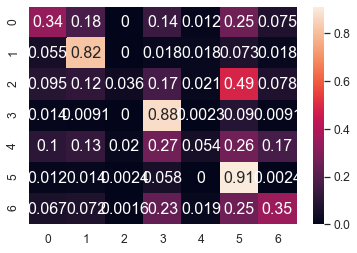

	training epoch=39 .. train_loss=0.976
	validation epoch=39 .. val_loss=1.766
	Accuracy = 45.5 % .. Percision = 45.5 % .. Recall = 48.4 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_39.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 40 .. loss = 0.878


  0%|                                                                                 | 1/1914 [00:01<52:53,  1.66s/it]

training @ epoch 40 .. loss = 1.157


  0%|                                                                                 | 2/1914 [00:03<52:20,  1.64s/it]

training @ epoch 40 .. loss = 1.136


  0%|▏                                                                                | 3/1914 [00:04<51:04,  1.60s/it]

training @ epoch 40 .. loss = 0.84


  0%|▏                                                                                | 4/1914 [00:06<51:12,  1.61s/it]

training @ epoch 40 .. loss = 1.151


  0%|▏                                                                                | 5/1914 [00:07<49:49,  1.57s/it]

training @ epoch 40 .. loss = 0.917


  0%|▎                                                                                | 6/1914 [00:09<49:18,  1.55s/it]

training @ epoch 40 .. loss = 0.809


  0%|▎                                                                                | 7/1914 [00:10<48:18,  1.52s/it]

training @ epoch 40 .. loss = 0.536


  0%|▎                                                                                | 8/1914 [00:12<46:30,  1.46s/it]

training @ epoch 40 .. loss = 0.89


  0%|▍                                                                                | 9/1914 [00:13<45:09,  1.42s/it]

training @ epoch 40 .. loss = 0.881


  1%|▍                                                                               | 10/1914 [00:14<45:50,  1.44s/it]

training @ epoch 40 .. loss = 1.476


  1%|▍                                                                               | 11/1914 [00:16<46:01,  1.45s/it]

training @ epoch 40 .. loss = 1.641


  1%|▌                                                                               | 12/1914 [00:17<46:08,  1.46s/it]

training @ epoch 40 .. loss = 0.938


  1%|▌                                                                               | 13/1914 [00:19<45:55,  1.45s/it]

training @ epoch 40 .. loss = 1.402


  1%|▌                                                                               | 14/1914 [00:20<45:17,  1.43s/it]

training @ epoch 40 .. loss = 0.759


  1%|▋                                                                               | 15/1914 [00:22<44:03,  1.39s/it]

training @ epoch 40 .. loss = 1.627


  1%|▋                                                                               | 16/1914 [00:23<44:38,  1.41s/it]

training @ epoch 40 .. loss = 0.999


  1%|▋                                                                               | 17/1914 [00:24<45:06,  1.43s/it]

training @ epoch 40 .. loss = 0.921


  1%|▊                                                                               | 18/1914 [00:26<46:01,  1.46s/it]

training @ epoch 40 .. loss = 1.194


  1%|▊                                                                               | 19/1914 [00:27<46:04,  1.46s/it]

training @ epoch 40 .. loss = 0.89


  1%|▊                                                                               | 20/1914 [00:29<45:39,  1.45s/it]

training @ epoch 40 .. loss = 0.79


  1%|▉                                                                               | 21/1914 [00:30<44:56,  1.42s/it]

training @ epoch 40 .. loss = 1.023


  1%|▉                                                                               | 22/1914 [00:32<44:14,  1.40s/it]

training @ epoch 40 .. loss = 1.072


  1%|▉                                                                               | 23/1914 [00:33<44:08,  1.40s/it]

training @ epoch 40 .. loss = 0.932


  1%|█                                                                               | 24/1914 [00:35<45:24,  1.44s/it]

training @ epoch 40 .. loss = 0.896


  1%|█                                                                               | 25/1914 [00:36<45:36,  1.45s/it]

training @ epoch 40 .. loss = 1.008


  1%|█                                                                               | 26/1914 [00:37<44:53,  1.43s/it]

training @ epoch 40 .. loss = 0.737


  1%|█▏                                                                              | 27/1914 [00:39<44:11,  1.41s/it]

training @ epoch 40 .. loss = 0.503


  1%|█▏                                                                              | 28/1914 [00:40<43:30,  1.38s/it]

training @ epoch 40 .. loss = 0.843


  2%|█▏                                                                              | 29/1914 [00:42<44:20,  1.41s/it]

training @ epoch 40 .. loss = 0.801


  2%|█▎                                                                              | 30/1914 [00:43<44:50,  1.43s/it]

training @ epoch 40 .. loss = 1.112


  2%|█▎                                                                              | 31/1914 [00:44<45:32,  1.45s/it]

training @ epoch 40 .. loss = 0.7


  2%|█▎                                                                              | 32/1914 [00:46<44:36,  1.42s/it]

training @ epoch 40 .. loss = 0.891


  2%|█▍                                                                              | 33/1914 [00:47<43:34,  1.39s/it]

training @ epoch 40 .. loss = 0.715


  2%|█▍                                                                              | 34/1914 [00:49<43:36,  1.39s/it]

training @ epoch 40 .. loss = 0.734


  2%|█▍                                                                              | 35/1914 [00:50<44:10,  1.41s/it]

training @ epoch 40 .. loss = 1.224


  2%|█▌                                                                              | 36/1914 [00:52<45:03,  1.44s/it]

training @ epoch 40 .. loss = 0.749


  2%|█▌                                                                              | 37/1914 [00:53<45:15,  1.45s/it]

training @ epoch 40 .. loss = 0.57


  2%|█▌                                                                              | 38/1914 [00:54<45:20,  1.45s/it]

training @ epoch 40 .. loss = 1.156


  2%|█▋                                                                              | 39/1914 [00:56<44:13,  1.42s/it]

training @ epoch 40 .. loss = 1.361


  2%|█▋                                                                              | 40/1914 [00:57<43:43,  1.40s/it]

training @ epoch 40 .. loss = 0.926


  2%|█▋                                                                              | 41/1914 [00:59<45:08,  1.45s/it]

training @ epoch 40 .. loss = 0.526


  2%|█▊                                                                              | 42/1914 [01:01<50:41,  1.62s/it]

training @ epoch 40 .. loss = 0.679


  2%|█▊                                                                              | 43/1914 [01:02<49:04,  1.57s/it]

training @ epoch 40 .. loss = 0.455


  2%|█▊                                                                              | 44/1914 [01:04<48:59,  1.57s/it]

training @ epoch 40 .. loss = 0.903


  2%|█▉                                                                              | 45/1914 [01:05<48:32,  1.56s/it]

training @ epoch 40 .. loss = 0.622


  2%|█▉                                                                              | 46/1914 [01:07<47:44,  1.53s/it]

training @ epoch 40 .. loss = 0.994


  2%|█▉                                                                              | 47/1914 [01:08<45:55,  1.48s/it]

training @ epoch 40 .. loss = 0.703


  3%|██                                                                              | 48/1914 [01:10<45:26,  1.46s/it]

training @ epoch 40 .. loss = 1.041


  3%|██                                                                              | 49/1914 [01:11<45:33,  1.47s/it]

training @ epoch 40 .. loss = 1.255


  3%|██                                                                              | 50/1914 [01:13<46:51,  1.51s/it]

training @ epoch 40 .. loss = 0.652


  3%|██▏                                                                             | 51/1914 [01:14<46:20,  1.49s/it]

training @ epoch 40 .. loss = 0.662


  3%|██▏                                                                             | 52/1914 [01:15<45:34,  1.47s/it]

training @ epoch 40 .. loss = 0.712


  3%|██▏                                                                             | 53/1914 [01:17<44:47,  1.44s/it]

training @ epoch 40 .. loss = 0.54


  3%|██▎                                                                             | 54/1914 [01:18<44:29,  1.44s/it]

training @ epoch 40 .. loss = 1.014


  3%|██▎                                                                             | 55/1914 [01:20<45:46,  1.48s/it]

training @ epoch 40 .. loss = 1.29


  3%|██▎                                                                             | 56/1914 [01:21<46:18,  1.50s/it]

training @ epoch 40 .. loss = 1.099


  3%|██▍                                                                             | 57/1914 [01:23<46:06,  1.49s/it]

training @ epoch 40 .. loss = 0.855


  3%|██▍                                                                             | 58/1914 [01:24<45:23,  1.47s/it]

training @ epoch 40 .. loss = 0.992


  3%|██▍                                                                             | 59/1914 [01:26<43:56,  1.42s/it]

training @ epoch 40 .. loss = 0.77


  3%|██▌                                                                             | 60/1914 [01:27<43:29,  1.41s/it]

training @ epoch 40 .. loss = 0.89


  3%|██▌                                                                             | 61/1914 [01:28<44:17,  1.43s/it]

training @ epoch 40 .. loss = 0.72


  3%|██▌                                                                             | 62/1914 [01:30<44:33,  1.44s/it]

training @ epoch 40 .. loss = 1.13


  3%|██▋                                                                             | 63/1914 [01:31<44:44,  1.45s/it]

training @ epoch 40 .. loss = 0.843


  3%|██▋                                                                             | 64/1914 [01:33<44:46,  1.45s/it]

training @ epoch 40 .. loss = 0.863


  3%|██▋                                                                             | 65/1914 [01:34<43:34,  1.41s/it]

training @ epoch 40 .. loss = 0.824


  3%|██▊                                                                             | 66/1914 [01:36<42:41,  1.39s/it]

training @ epoch 40 .. loss = 1.068


  4%|██▊                                                                             | 67/1914 [01:37<43:08,  1.40s/it]

training @ epoch 40 .. loss = 0.671


  4%|██▊                                                                             | 68/1914 [01:38<43:21,  1.41s/it]

training @ epoch 40 .. loss = 0.515


  4%|██▉                                                                             | 69/1914 [01:40<43:45,  1.42s/it]

training @ epoch 40 .. loss = 1.65


  4%|██▉                                                                             | 70/1914 [01:41<43:51,  1.43s/it]

training @ epoch 40 .. loss = 1.391


  4%|██▉                                                                             | 71/1914 [01:43<43:04,  1.40s/it]

training @ epoch 40 .. loss = 0.678


  4%|███                                                                             | 72/1914 [01:44<43:04,  1.40s/it]

training @ epoch 40 .. loss = 0.76


  4%|███                                                                             | 73/1914 [01:46<44:00,  1.43s/it]

training @ epoch 40 .. loss = 1.578


  4%|███                                                                             | 74/1914 [01:47<44:16,  1.44s/it]

training @ epoch 40 .. loss = 1.023


  4%|███▏                                                                            | 75/1914 [01:49<44:54,  1.47s/it]

training @ epoch 40 .. loss = 0.95


  4%|███▏                                                                            | 76/1914 [01:50<44:19,  1.45s/it]

training @ epoch 40 .. loss = 1.146


  4%|███▏                                                                            | 77/1914 [01:51<43:15,  1.41s/it]

training @ epoch 40 .. loss = 0.777


  4%|███▎                                                                            | 78/1914 [01:53<42:36,  1.39s/it]

training @ epoch 40 .. loss = 0.974


  4%|███▎                                                                            | 79/1914 [01:54<42:58,  1.41s/it]

training @ epoch 40 .. loss = 0.934


  4%|███▎                                                                            | 80/1914 [01:55<43:25,  1.42s/it]

training @ epoch 40 .. loss = 0.758


  4%|███▍                                                                            | 81/1914 [01:57<44:05,  1.44s/it]

training @ epoch 40 .. loss = 0.873


  4%|███▍                                                                            | 82/1914 [01:58<43:37,  1.43s/it]

training @ epoch 40 .. loss = 1.4


  4%|███▍                                                                            | 83/1914 [02:00<42:38,  1.40s/it]

training @ epoch 40 .. loss = 0.59


  4%|███▌                                                                            | 84/1914 [02:01<42:19,  1.39s/it]

training @ epoch 40 .. loss = 0.636


  4%|███▌                                                                            | 85/1914 [02:02<42:44,  1.40s/it]

training @ epoch 40 .. loss = 0.794


  4%|███▌                                                                            | 86/1914 [02:04<43:01,  1.41s/it]

training @ epoch 40 .. loss = 0.508


  5%|███▋                                                                            | 87/1914 [02:05<43:28,  1.43s/it]

training @ epoch 40 .. loss = 1.3


  5%|███▋                                                                            | 88/1914 [02:07<43:22,  1.42s/it]

training @ epoch 40 .. loss = 0.911


  5%|███▋                                                                            | 89/1914 [02:08<42:42,  1.40s/it]

training @ epoch 40 .. loss = 0.493


  5%|███▊                                                                            | 90/1914 [02:09<41:45,  1.37s/it]

training @ epoch 40 .. loss = 0.686


  5%|███▊                                                                            | 91/1914 [02:11<42:19,  1.39s/it]

training @ epoch 40 .. loss = 0.617


  5%|███▊                                                                            | 92/1914 [02:13<44:53,  1.48s/it]

training @ epoch 40 .. loss = 1.051


  5%|███▉                                                                            | 93/1914 [02:14<47:46,  1.57s/it]

training @ epoch 40 .. loss = 0.725


  5%|███▉                                                                            | 94/1914 [02:16<47:58,  1.58s/it]

training @ epoch 40 .. loss = 0.837


  5%|███▉                                                                            | 95/1914 [02:18<47:49,  1.58s/it]

training @ epoch 40 .. loss = 0.985


  5%|████                                                                            | 96/1914 [02:19<46:22,  1.53s/it]

training @ epoch 40 .. loss = 0.924


  5%|████                                                                            | 97/1914 [02:20<45:06,  1.49s/it]

training @ epoch 40 .. loss = 1.109


  5%|████                                                                            | 98/1914 [02:22<44:57,  1.49s/it]

training @ epoch 40 .. loss = 0.745


  5%|████▏                                                                           | 99/1914 [02:23<44:45,  1.48s/it]

training @ epoch 40 .. loss = 1.319


  5%|████▏                                                                          | 100/1914 [02:25<45:54,  1.52s/it]

training @ epoch 40 .. loss = 1.066


  5%|████▏                                                                          | 101/1914 [02:27<46:36,  1.54s/it]

training @ epoch 40 .. loss = 0.884


  5%|████▏                                                                          | 102/1914 [02:28<45:47,  1.52s/it]

training @ epoch 40 .. loss = 0.824


  5%|████▎                                                                          | 103/1914 [02:29<44:16,  1.47s/it]

training @ epoch 40 .. loss = 0.917


  5%|████▎                                                                          | 104/1914 [02:31<45:21,  1.50s/it]

training @ epoch 40 .. loss = 0.712


  5%|████▎                                                                          | 105/1914 [02:32<44:54,  1.49s/it]

training @ epoch 40 .. loss = 1.194


  6%|████▍                                                                          | 106/1914 [02:34<45:09,  1.50s/it]

training @ epoch 40 .. loss = 0.767


  6%|████▍                                                                          | 107/1914 [02:35<44:48,  1.49s/it]

training @ epoch 40 .. loss = 0.899


  6%|████▍                                                                          | 108/1914 [02:37<44:13,  1.47s/it]

training @ epoch 40 .. loss = 1.023


  6%|████▍                                                                          | 109/1914 [02:38<43:31,  1.45s/it]

training @ epoch 40 .. loss = 0.569


  6%|████▌                                                                          | 110/1914 [02:40<42:48,  1.42s/it]

training @ epoch 40 .. loss = 0.488


  6%|████▌                                                                          | 111/1914 [02:41<42:45,  1.42s/it]

training @ epoch 40 .. loss = 0.682


  6%|████▌                                                                          | 112/1914 [02:42<43:33,  1.45s/it]

training @ epoch 40 .. loss = 1.249


  6%|████▋                                                                          | 113/1914 [02:44<43:41,  1.46s/it]

training @ epoch 40 .. loss = 0.495


  6%|████▋                                                                          | 114/1914 [02:45<42:40,  1.42s/it]

training @ epoch 40 .. loss = 1.091


  6%|████▋                                                                          | 115/1914 [02:47<42:06,  1.40s/it]

training @ epoch 40 .. loss = 0.966


  6%|████▊                                                                          | 116/1914 [02:48<41:50,  1.40s/it]

training @ epoch 40 .. loss = 0.918


  6%|████▊                                                                          | 117/1914 [02:49<41:48,  1.40s/it]

training @ epoch 40 .. loss = 0.759


  6%|████▊                                                                          | 118/1914 [02:51<42:35,  1.42s/it]

training @ epoch 40 .. loss = 0.823


  6%|████▉                                                                          | 119/1914 [02:52<43:13,  1.45s/it]

training @ epoch 40 .. loss = 1.029


  6%|████▉                                                                          | 120/1914 [02:54<42:18,  1.41s/it]

training @ epoch 40 .. loss = 0.921


  6%|████▉                                                                          | 121/1914 [02:55<41:27,  1.39s/it]

training @ epoch 40 .. loss = 0.961


  6%|█████                                                                          | 122/1914 [02:57<41:46,  1.40s/it]

training @ epoch 40 .. loss = 0.779


  6%|█████                                                                          | 123/1914 [02:58<41:54,  1.40s/it]

training @ epoch 40 .. loss = 1.692


  6%|█████                                                                          | 124/1914 [02:59<42:42,  1.43s/it]

training @ epoch 40 .. loss = 0.746


  7%|█████▏                                                                         | 125/1914 [03:01<43:16,  1.45s/it]

training @ epoch 40 .. loss = 0.939


  7%|█████▏                                                                         | 126/1914 [03:02<42:34,  1.43s/it]

training @ epoch 40 .. loss = 0.764


  7%|█████▏                                                                         | 127/1914 [03:04<41:42,  1.40s/it]

training @ epoch 40 .. loss = 1.034


  7%|█████▎                                                                         | 128/1914 [03:05<41:42,  1.40s/it]

training @ epoch 40 .. loss = 0.793


  7%|█████▎                                                                         | 129/1914 [03:06<41:56,  1.41s/it]

training @ epoch 40 .. loss = 0.699


  7%|█████▎                                                                         | 130/1914 [03:08<42:23,  1.43s/it]

training @ epoch 40 .. loss = 0.757


  7%|█████▍                                                                         | 131/1914 [03:09<42:34,  1.43s/it]

training @ epoch 40 .. loss = 1.068


  7%|█████▍                                                                         | 132/1914 [03:11<41:34,  1.40s/it]

training @ epoch 40 .. loss = 1.182


  7%|█████▍                                                                         | 133/1914 [03:12<41:19,  1.39s/it]

training @ epoch 40 .. loss = 1.1


  7%|█████▌                                                                         | 134/1914 [03:14<41:57,  1.41s/it]

training @ epoch 40 .. loss = 1.043


  7%|█████▌                                                                         | 135/1914 [03:15<42:06,  1.42s/it]

training @ epoch 40 .. loss = 0.474


  7%|█████▌                                                                         | 136/1914 [03:16<42:46,  1.44s/it]

training @ epoch 40 .. loss = 1.04


  7%|█████▋                                                                         | 137/1914 [03:18<42:42,  1.44s/it]

training @ epoch 40 .. loss = 0.562


  7%|█████▋                                                                         | 138/1914 [03:19<42:26,  1.43s/it]

training @ epoch 40 .. loss = 1.253


  7%|█████▋                                                                         | 139/1914 [03:21<42:29,  1.44s/it]

training @ epoch 40 .. loss = 0.819


  7%|█████▊                                                                         | 140/1914 [03:22<42:39,  1.44s/it]

training @ epoch 40 .. loss = 0.934


  7%|█████▊                                                                         | 141/1914 [03:24<42:23,  1.43s/it]

training @ epoch 40 .. loss = 1.339


  7%|█████▊                                                                         | 142/1914 [03:25<42:33,  1.44s/it]

training @ epoch 40 .. loss = 1.327


  7%|█████▉                                                                         | 143/1914 [03:27<43:22,  1.47s/it]

training @ epoch 40 .. loss = 1.041


  8%|█████▉                                                                         | 144/1914 [03:28<42:25,  1.44s/it]

training @ epoch 40 .. loss = 0.686


  8%|█████▉                                                                         | 145/1914 [03:29<41:23,  1.40s/it]

training @ epoch 40 .. loss = 0.857


  8%|██████                                                                         | 146/1914 [03:31<41:39,  1.41s/it]

training @ epoch 40 .. loss = 1.482


  8%|██████                                                                         | 147/1914 [03:32<42:00,  1.43s/it]

training @ epoch 40 .. loss = 0.648


  8%|██████                                                                         | 148/1914 [03:34<44:54,  1.53s/it]

training @ epoch 40 .. loss = 1.13


  8%|██████▏                                                                        | 149/1914 [03:36<45:51,  1.56s/it]

training @ epoch 40 .. loss = 1.36


  8%|██████▏                                                                        | 150/1914 [03:37<45:10,  1.54s/it]

training @ epoch 40 .. loss = 0.883


  8%|██████▏                                                                        | 151/1914 [03:38<44:00,  1.50s/it]

training @ epoch 40 .. loss = 1.399


  8%|██████▎                                                                        | 152/1914 [03:40<42:43,  1.45s/it]

training @ epoch 40 .. loss = 0.781


  8%|██████▎                                                                        | 153/1914 [03:41<42:20,  1.44s/it]

training @ epoch 40 .. loss = 0.507


  8%|██████▎                                                                        | 154/1914 [03:43<42:47,  1.46s/it]

training @ epoch 40 .. loss = 1.042


  8%|██████▍                                                                        | 155/1914 [03:44<42:44,  1.46s/it]

training @ epoch 40 .. loss = 0.728


  8%|██████▍                                                                        | 156/1914 [03:46<42:42,  1.46s/it]

training @ epoch 40 .. loss = 1.065


  8%|██████▍                                                                        | 157/1914 [03:47<41:41,  1.42s/it]

training @ epoch 40 .. loss = 0.708


  8%|██████▌                                                                        | 158/1914 [03:49<43:52,  1.50s/it]

training @ epoch 40 .. loss = 0.939


  8%|██████▌                                                                        | 159/1914 [03:50<43:53,  1.50s/it]

training @ epoch 40 .. loss = 0.812


  8%|██████▌                                                                        | 160/1914 [03:52<43:50,  1.50s/it]

training @ epoch 40 .. loss = 1.148


  8%|██████▋                                                                        | 161/1914 [03:53<43:36,  1.49s/it]

training @ epoch 40 .. loss = 0.94


  8%|██████▋                                                                        | 162/1914 [03:55<43:51,  1.50s/it]

training @ epoch 40 .. loss = 0.471


  9%|██████▋                                                                        | 163/1914 [03:56<42:44,  1.46s/it]

training @ epoch 40 .. loss = 0.507


  9%|██████▊                                                                        | 164/1914 [03:57<42:06,  1.44s/it]

training @ epoch 40 .. loss = 1.087


  9%|██████▊                                                                        | 165/1914 [03:59<41:55,  1.44s/it]

training @ epoch 40 .. loss = 0.673


  9%|██████▊                                                                        | 166/1914 [04:00<41:52,  1.44s/it]

training @ epoch 40 .. loss = 0.824


  9%|██████▉                                                                        | 167/1914 [04:02<42:48,  1.47s/it]

training @ epoch 40 .. loss = 1.091


  9%|██████▉                                                                        | 168/1914 [04:03<42:49,  1.47s/it]

training @ epoch 40 .. loss = 0.534


  9%|██████▉                                                                        | 169/1914 [04:05<42:28,  1.46s/it]

training @ epoch 40 .. loss = 1.125


  9%|███████                                                                        | 170/1914 [04:06<41:43,  1.44s/it]

training @ epoch 40 .. loss = 0.716


  9%|███████                                                                        | 171/1914 [04:08<41:05,  1.41s/it]

training @ epoch 40 .. loss = 0.529


  9%|███████                                                                        | 172/1914 [04:09<41:20,  1.42s/it]

training @ epoch 40 .. loss = 1.563


  9%|███████▏                                                                       | 173/1914 [04:11<42:54,  1.48s/it]

training @ epoch 40 .. loss = 0.735


  9%|███████▏                                                                       | 174/1914 [04:12<43:02,  1.48s/it]

training @ epoch 40 .. loss = 0.963


  9%|███████▏                                                                       | 175/1914 [04:13<42:25,  1.46s/it]

training @ epoch 40 .. loss = 0.635


  9%|███████▎                                                                       | 176/1914 [04:15<41:48,  1.44s/it]

training @ epoch 40 .. loss = 0.619


  9%|███████▎                                                                       | 177/1914 [04:16<41:21,  1.43s/it]

training @ epoch 40 .. loss = 1.107


  9%|███████▎                                                                       | 178/1914 [04:18<41:29,  1.43s/it]

training @ epoch 40 .. loss = 0.605


  9%|███████▍                                                                       | 179/1914 [04:19<41:18,  1.43s/it]

training @ epoch 40 .. loss = 1.023


  9%|███████▍                                                                       | 180/1914 [04:21<41:47,  1.45s/it]

training @ epoch 40 .. loss = 1.335


  9%|███████▍                                                                       | 181/1914 [04:22<41:41,  1.44s/it]

training @ epoch 40 .. loss = 0.917


 10%|███████▌                                                                       | 182/1914 [04:23<40:43,  1.41s/it]

training @ epoch 40 .. loss = 0.662


 10%|███████▌                                                                       | 183/1914 [04:25<40:37,  1.41s/it]

training @ epoch 40 .. loss = 0.992


 10%|███████▌                                                                       | 184/1914 [04:26<41:12,  1.43s/it]

training @ epoch 40 .. loss = 0.797


 10%|███████▋                                                                       | 185/1914 [04:28<41:14,  1.43s/it]

training @ epoch 40 .. loss = 0.708


 10%|███████▋                                                                       | 186/1914 [04:29<41:47,  1.45s/it]

training @ epoch 40 .. loss = 0.43


 10%|███████▋                                                                       | 187/1914 [04:31<41:54,  1.46s/it]

training @ epoch 40 .. loss = 0.777


 10%|███████▊                                                                       | 188/1914 [04:32<40:28,  1.41s/it]

training @ epoch 40 .. loss = 0.687


 10%|███████▊                                                                       | 189/1914 [04:33<39:54,  1.39s/it]

training @ epoch 40 .. loss = 1.071


 10%|███████▊                                                                       | 190/1914 [04:35<40:33,  1.41s/it]

training @ epoch 40 .. loss = 1.073


 10%|███████▉                                                                       | 191/1914 [04:36<40:55,  1.43s/it]

training @ epoch 40 .. loss = 0.941


 10%|███████▉                                                                       | 192/1914 [04:38<41:30,  1.45s/it]

training @ epoch 40 .. loss = 0.577


 10%|███████▉                                                                       | 193/1914 [04:39<41:13,  1.44s/it]

training @ epoch 40 .. loss = 1.323


 10%|████████                                                                       | 194/1914 [04:41<40:29,  1.41s/it]

training @ epoch 40 .. loss = 0.851


 10%|████████                                                                       | 195/1914 [04:42<39:53,  1.39s/it]

training @ epoch 40 .. loss = 0.858


 10%|████████                                                                       | 196/1914 [04:43<40:29,  1.41s/it]

training @ epoch 40 .. loss = 1.092


 10%|████████▏                                                                      | 197/1914 [04:45<41:42,  1.46s/it]

training @ epoch 40 .. loss = 1.066


 10%|████████▏                                                                      | 198/1914 [04:46<41:50,  1.46s/it]

training @ epoch 40 .. loss = 0.822


 10%|████████▏                                                                      | 199/1914 [04:48<41:24,  1.45s/it]

training @ epoch 40 .. loss = 1.055


 10%|████████▎                                                                      | 200/1914 [04:49<40:34,  1.42s/it]

training @ epoch 40 .. loss = 0.76


 11%|████████▎                                                                      | 201/1914 [04:50<39:49,  1.39s/it]

training @ epoch 40 .. loss = 1.06


 11%|████████▎                                                                      | 202/1914 [04:52<40:24,  1.42s/it]

training @ epoch 40 .. loss = 0.602


 11%|████████▍                                                                      | 203/1914 [04:53<40:17,  1.41s/it]

training @ epoch 40 .. loss = 0.669


 11%|████████▍                                                                      | 204/1914 [04:55<40:54,  1.44s/it]

training @ epoch 40 .. loss = 0.85


 11%|████████▍                                                                      | 205/1914 [04:56<40:56,  1.44s/it]

training @ epoch 40 .. loss = 0.654


 11%|████████▌                                                                      | 206/1914 [04:58<39:57,  1.40s/it]

training @ epoch 40 .. loss = 0.927


 11%|████████▌                                                                      | 207/1914 [04:59<39:16,  1.38s/it]

training @ epoch 40 .. loss = 0.648


 11%|████████▌                                                                      | 208/1914 [05:00<39:38,  1.39s/it]

training @ epoch 40 .. loss = 0.757


 11%|████████▋                                                                      | 209/1914 [05:02<39:48,  1.40s/it]

training @ epoch 40 .. loss = 1.152


 11%|████████▋                                                                      | 210/1914 [05:03<40:30,  1.43s/it]

training @ epoch 40 .. loss = 0.639


 11%|████████▋                                                                      | 211/1914 [05:05<41:05,  1.45s/it]

training @ epoch 40 .. loss = 1.19


 11%|████████▊                                                                      | 212/1914 [05:06<40:21,  1.42s/it]

training @ epoch 40 .. loss = 1.066


 11%|████████▊                                                                      | 213/1914 [05:07<39:09,  1.38s/it]

training @ epoch 40 .. loss = 1.275


 11%|████████▊                                                                      | 214/1914 [05:09<39:39,  1.40s/it]

training @ epoch 40 .. loss = 0.997


 11%|████████▊                                                                      | 215/1914 [05:10<39:52,  1.41s/it]

training @ epoch 40 .. loss = 0.686


 11%|████████▉                                                                      | 216/1914 [05:12<40:36,  1.43s/it]

training @ epoch 40 .. loss = 1.213


 11%|████████▉                                                                      | 217/1914 [05:13<40:46,  1.44s/it]

training @ epoch 40 .. loss = 1.401


 11%|████████▉                                                                      | 218/1914 [05:15<41:38,  1.47s/it]

training @ epoch 40 .. loss = 1.365


 11%|█████████                                                                      | 219/1914 [05:16<41:44,  1.48s/it]

training @ epoch 40 .. loss = 0.844


 11%|█████████                                                                      | 220/1914 [05:18<41:05,  1.46s/it]

training @ epoch 40 .. loss = 1.028


 12%|█████████                                                                      | 221/1914 [05:19<40:13,  1.43s/it]

training @ epoch 40 .. loss = 0.856


 12%|█████████▏                                                                     | 222/1914 [05:20<40:07,  1.42s/it]

training @ epoch 40 .. loss = 0.698


 12%|█████████▏                                                                     | 223/1914 [05:22<40:15,  1.43s/it]

training @ epoch 40 .. loss = 1.147


 12%|█████████▏                                                                     | 224/1914 [05:23<41:10,  1.46s/it]

training @ epoch 40 .. loss = 0.749


 12%|█████████▎                                                                     | 225/1914 [05:25<41:36,  1.48s/it]

training @ epoch 40 .. loss = 0.711


 12%|█████████▎                                                                     | 226/1914 [05:26<41:23,  1.47s/it]

training @ epoch 40 .. loss = 0.753


 12%|█████████▎                                                                     | 227/1914 [05:28<40:48,  1.45s/it]

training @ epoch 40 .. loss = 0.889


 12%|█████████▍                                                                     | 228/1914 [05:29<40:28,  1.44s/it]

training @ epoch 40 .. loss = 0.65


 12%|█████████▍                                                                     | 229/1914 [05:31<42:01,  1.50s/it]

training @ epoch 40 .. loss = 0.961


 12%|█████████▍                                                                     | 230/1914 [05:32<42:30,  1.51s/it]

training @ epoch 40 .. loss = 1.234


 12%|█████████▌                                                                     | 231/1914 [05:34<42:20,  1.51s/it]

training @ epoch 40 .. loss = 0.853


 12%|█████████▌                                                                     | 232/1914 [05:35<42:07,  1.50s/it]

training @ epoch 40 .. loss = 1.287


 12%|█████████▌                                                                     | 233/1914 [05:37<41:27,  1.48s/it]

training @ epoch 40 .. loss = 1.048


 12%|█████████▋                                                                     | 234/1914 [05:38<40:22,  1.44s/it]

training @ epoch 40 .. loss = 0.969


 12%|█████████▋                                                                     | 235/1914 [05:40<39:42,  1.42s/it]

training @ epoch 40 .. loss = 0.767


 12%|█████████▋                                                                     | 236/1914 [05:41<39:59,  1.43s/it]

training @ epoch 40 .. loss = 1.02


 12%|█████████▊                                                                     | 237/1914 [05:42<40:21,  1.44s/it]

training @ epoch 40 .. loss = 1.114


 12%|█████████▊                                                                     | 238/1914 [05:44<40:36,  1.45s/it]

training @ epoch 40 .. loss = 1.166


 12%|█████████▊                                                                     | 239/1914 [05:45<40:20,  1.45s/it]

training @ epoch 40 .. loss = 0.366


 13%|█████████▉                                                                     | 240/1914 [05:47<39:43,  1.42s/it]

training @ epoch 40 .. loss = 0.425


 13%|█████████▉                                                                     | 241/1914 [05:48<38:51,  1.39s/it]

training @ epoch 40 .. loss = 1.27


 13%|█████████▉                                                                     | 242/1914 [05:49<39:06,  1.40s/it]

training @ epoch 40 .. loss = 0.965


 13%|██████████                                                                     | 243/1914 [05:51<39:36,  1.42s/it]

training @ epoch 40 .. loss = 0.711


 13%|██████████                                                                     | 244/1914 [05:52<40:07,  1.44s/it]

training @ epoch 40 .. loss = 0.906


 13%|██████████                                                                     | 245/1914 [05:54<40:08,  1.44s/it]

training @ epoch 40 .. loss = 0.727


 13%|██████████▏                                                                    | 246/1914 [05:55<39:07,  1.41s/it]

training @ epoch 40 .. loss = 1.184


 13%|██████████▏                                                                    | 247/1914 [05:57<38:29,  1.39s/it]

training @ epoch 40 .. loss = 1.351


 13%|██████████▏                                                                    | 248/1914 [05:58<38:48,  1.40s/it]

training @ epoch 40 .. loss = 0.765


 13%|██████████▎                                                                    | 249/1914 [05:59<38:46,  1.40s/it]

training @ epoch 40 .. loss = 1.207


 13%|██████████▎                                                                    | 250/1914 [06:01<39:43,  1.43s/it]

training @ epoch 40 .. loss = 0.822


 13%|██████████▎                                                                    | 251/1914 [06:02<40:09,  1.45s/it]

training @ epoch 40 .. loss = 1.225


 13%|██████████▍                                                                    | 252/1914 [06:04<39:01,  1.41s/it]

training @ epoch 40 .. loss = 0.781


 13%|██████████▍                                                                    | 253/1914 [06:05<38:27,  1.39s/it]

training @ epoch 40 .. loss = 0.538


 13%|██████████▍                                                                    | 254/1914 [06:06<38:39,  1.40s/it]

training @ epoch 40 .. loss = 0.651


 13%|██████████▌                                                                    | 255/1914 [06:08<38:46,  1.40s/it]

training @ epoch 40 .. loss = 0.554


 13%|██████████▌                                                                    | 256/1914 [06:09<39:12,  1.42s/it]

training @ epoch 40 .. loss = 0.913


 13%|██████████▌                                                                    | 257/1914 [06:11<39:44,  1.44s/it]

training @ epoch 40 .. loss = 0.839


 13%|██████████▋                                                                    | 258/1914 [06:12<39:00,  1.41s/it]

training @ epoch 40 .. loss = 0.915


 14%|██████████▋                                                                    | 259/1914 [06:14<38:55,  1.41s/it]

training @ epoch 40 .. loss = 0.962


 14%|██████████▋                                                                    | 260/1914 [06:15<39:05,  1.42s/it]

training @ epoch 40 .. loss = 1.043


 14%|██████████▊                                                                    | 261/1914 [06:16<39:23,  1.43s/it]

training @ epoch 40 .. loss = 1.141


 14%|██████████▊                                                                    | 262/1914 [06:18<39:38,  1.44s/it]

training @ epoch 40 .. loss = 0.765


 14%|██████████▊                                                                    | 263/1914 [06:19<39:36,  1.44s/it]

training @ epoch 40 .. loss = 1.049


 14%|██████████▉                                                                    | 264/1914 [06:21<38:43,  1.41s/it]

training @ epoch 40 .. loss = 1.332


 14%|██████████▉                                                                    | 265/1914 [06:22<38:29,  1.40s/it]

training @ epoch 40 .. loss = 0.695


 14%|██████████▉                                                                    | 266/1914 [06:24<39:30,  1.44s/it]

training @ epoch 40 .. loss = 1.037


 14%|███████████                                                                    | 267/1914 [06:25<39:22,  1.43s/it]

training @ epoch 40 .. loss = 0.968


 14%|███████████                                                                    | 268/1914 [06:27<40:25,  1.47s/it]

training @ epoch 40 .. loss = 0.981


 14%|███████████                                                                    | 269/1914 [06:28<40:15,  1.47s/it]

training @ epoch 40 .. loss = 0.655


 14%|███████████▏                                                                   | 270/1914 [06:29<39:48,  1.45s/it]

training @ epoch 40 .. loss = 1.25


 14%|███████████▏                                                                   | 271/1914 [06:31<38:43,  1.41s/it]

training @ epoch 40 .. loss = 1.048


 14%|███████████▏                                                                   | 272/1914 [06:32<38:36,  1.41s/it]

training @ epoch 40 .. loss = 1.087


 14%|███████████▎                                                                   | 273/1914 [06:34<38:34,  1.41s/it]

training @ epoch 40 .. loss = 0.596


 14%|███████████▎                                                                   | 274/1914 [06:35<38:55,  1.42s/it]

training @ epoch 40 .. loss = 0.914


 14%|███████████▎                                                                   | 275/1914 [06:37<39:34,  1.45s/it]

training @ epoch 40 .. loss = 1.526


 14%|███████████▍                                                                   | 276/1914 [06:38<38:26,  1.41s/it]

training @ epoch 40 .. loss = 1.027


 14%|███████████▍                                                                   | 277/1914 [06:39<37:49,  1.39s/it]

training @ epoch 40 .. loss = 0.746


 15%|███████████▍                                                                   | 278/1914 [06:41<38:36,  1.42s/it]

training @ epoch 40 .. loss = 0.793


 15%|███████████▌                                                                   | 279/1914 [06:42<38:30,  1.41s/it]

training @ epoch 40 .. loss = 1.185


 15%|███████████▌                                                                   | 280/1914 [06:44<39:04,  1.43s/it]

training @ epoch 40 .. loss = 0.943


 15%|███████████▌                                                                   | 281/1914 [06:45<39:23,  1.45s/it]

training @ epoch 40 .. loss = 0.975


 15%|███████████▋                                                                   | 282/1914 [06:46<38:36,  1.42s/it]

training @ epoch 40 .. loss = 1.301


 15%|███████████▋                                                                   | 283/1914 [06:48<37:53,  1.39s/it]

training @ epoch 40 .. loss = 0.854


 15%|███████████▋                                                                   | 284/1914 [06:49<38:02,  1.40s/it]

training @ epoch 40 .. loss = 1.346


 15%|███████████▊                                                                   | 285/1914 [06:51<38:38,  1.42s/it]

training @ epoch 40 .. loss = 1.135


 15%|███████████▊                                                                   | 286/1914 [06:52<38:48,  1.43s/it]

training @ epoch 40 .. loss = 0.905


 15%|███████████▊                                                                   | 287/1914 [06:54<39:09,  1.44s/it]

training @ epoch 40 .. loss = 1.003


 15%|███████████▉                                                                   | 288/1914 [06:55<38:33,  1.42s/it]

training @ epoch 40 .. loss = 1.076


 15%|███████████▉                                                                   | 289/1914 [06:56<38:04,  1.41s/it]

training @ epoch 40 .. loss = 0.85


 15%|███████████▉                                                                   | 290/1914 [06:58<38:02,  1.41s/it]

training @ epoch 40 .. loss = 0.834


 15%|████████████                                                                   | 291/1914 [06:59<38:06,  1.41s/it]

training @ epoch 40 .. loss = 0.827


 15%|████████████                                                                   | 292/1914 [07:01<39:16,  1.45s/it]

training @ epoch 40 .. loss = 0.913


 15%|████████████                                                                   | 293/1914 [07:02<39:16,  1.45s/it]

training @ epoch 40 .. loss = 0.966


 15%|████████████▏                                                                  | 294/1914 [07:04<38:56,  1.44s/it]

training @ epoch 40 .. loss = 0.991


 15%|████████████▏                                                                  | 295/1914 [07:05<38:21,  1.42s/it]

training @ epoch 40 .. loss = 1.134


 15%|████████████▏                                                                  | 296/1914 [07:06<38:17,  1.42s/it]

training @ epoch 40 .. loss = 1.201


 16%|████████████▎                                                                  | 297/1914 [07:08<39:01,  1.45s/it]

training @ epoch 40 .. loss = 0.612


 16%|████████████▎                                                                  | 298/1914 [07:09<39:10,  1.45s/it]

training @ epoch 40 .. loss = 1.027


 16%|████████████▎                                                                  | 299/1914 [07:11<39:38,  1.47s/it]

training @ epoch 40 .. loss = 1.237


 16%|████████████▍                                                                  | 300/1914 [07:12<39:23,  1.46s/it]

training @ epoch 40 .. loss = 1.089


 16%|████████████▍                                                                  | 301/1914 [07:14<40:06,  1.49s/it]

training @ epoch 40 .. loss = 0.665


 16%|████████████▍                                                                  | 302/1914 [07:15<39:18,  1.46s/it]

training @ epoch 40 .. loss = 0.827


 16%|████████████▌                                                                  | 303/1914 [07:17<42:48,  1.59s/it]

training @ epoch 40 .. loss = 1.011


 16%|████████████▌                                                                  | 304/1914 [07:19<45:14,  1.69s/it]

training @ epoch 40 .. loss = 1.102


 16%|████████████▌                                                                  | 305/1914 [07:21<43:49,  1.63s/it]

training @ epoch 40 .. loss = 1.092


 16%|████████████▋                                                                  | 306/1914 [07:22<42:28,  1.58s/it]

training @ epoch 40 .. loss = 1.041


 16%|████████████▋                                                                  | 307/1914 [07:23<41:24,  1.55s/it]

training @ epoch 40 .. loss = 0.602


 16%|████████████▋                                                                  | 308/1914 [07:25<40:19,  1.51s/it]

training @ epoch 40 .. loss = 1.299


 16%|████████████▊                                                                  | 309/1914 [07:26<39:09,  1.46s/it]

training @ epoch 40 .. loss = 0.887


 16%|████████████▊                                                                  | 310/1914 [07:28<39:18,  1.47s/it]

training @ epoch 40 .. loss = 1.069


 16%|████████████▊                                                                  | 311/1914 [07:29<41:39,  1.56s/it]

training @ epoch 40 .. loss = 0.952


 16%|████████████▉                                                                  | 312/1914 [07:31<42:46,  1.60s/it]

training @ epoch 40 .. loss = 0.99


 16%|████████████▉                                                                  | 313/1914 [07:33<43:25,  1.63s/it]

training @ epoch 40 .. loss = 1.328


 16%|████████████▉                                                                  | 314/1914 [07:34<43:13,  1.62s/it]

training @ epoch 40 .. loss = 0.566


 16%|█████████████                                                                  | 315/1914 [07:36<42:07,  1.58s/it]

training @ epoch 40 .. loss = 1.458


 17%|█████████████                                                                  | 316/1914 [07:38<42:52,  1.61s/it]

training @ epoch 40 .. loss = 1.306


 17%|█████████████                                                                  | 317/1914 [07:39<42:46,  1.61s/it]

training @ epoch 40 .. loss = 0.998


 17%|█████████████▏                                                                 | 318/1914 [07:41<41:41,  1.57s/it]

training @ epoch 40 .. loss = 0.791


 17%|█████████████▏                                                                 | 319/1914 [07:42<40:56,  1.54s/it]

training @ epoch 40 .. loss = 1.378


 17%|█████████████▏                                                                 | 320/1914 [07:44<39:26,  1.48s/it]

training @ epoch 40 .. loss = 0.603


 17%|█████████████▏                                                                 | 321/1914 [07:45<38:12,  1.44s/it]

training @ epoch 40 .. loss = 0.979


 17%|█████████████▎                                                                 | 322/1914 [07:46<38:03,  1.43s/it]

training @ epoch 40 .. loss = 0.596


 17%|█████████████▎                                                                 | 323/1914 [07:48<38:08,  1.44s/it]

training @ epoch 40 .. loss = 1.72


 17%|█████████████▎                                                                 | 324/1914 [07:49<38:24,  1.45s/it]

training @ epoch 40 .. loss = 0.736


 17%|█████████████▍                                                                 | 325/1914 [07:51<38:59,  1.47s/it]

training @ epoch 40 .. loss = 0.702


 17%|█████████████▍                                                                 | 326/1914 [07:52<37:43,  1.43s/it]

training @ epoch 40 .. loss = 1.109


 17%|█████████████▍                                                                 | 327/1914 [07:53<36:58,  1.40s/it]

training @ epoch 40 .. loss = 0.66


 17%|█████████████▌                                                                 | 328/1914 [07:55<37:10,  1.41s/it]

training @ epoch 40 .. loss = 1.035


 17%|█████████████▌                                                                 | 329/1914 [07:56<37:16,  1.41s/it]

training @ epoch 40 .. loss = 0.939


 17%|█████████████▌                                                                 | 330/1914 [07:58<38:06,  1.44s/it]

training @ epoch 40 .. loss = 0.977


 17%|█████████████▋                                                                 | 331/1914 [07:59<38:15,  1.45s/it]

training @ epoch 40 .. loss = 0.658


 17%|█████████████▋                                                                 | 332/1914 [08:01<38:30,  1.46s/it]

training @ epoch 40 .. loss = 0.977


 17%|█████████████▋                                                                 | 333/1914 [08:02<39:01,  1.48s/it]

training @ epoch 40 .. loss = 0.771


 17%|█████████████▊                                                                 | 334/1914 [08:04<39:34,  1.50s/it]

training @ epoch 40 .. loss = 0.689


 18%|█████████████▊                                                                 | 335/1914 [08:05<40:22,  1.53s/it]

training @ epoch 40 .. loss = 0.798


 18%|█████████████▊                                                                 | 336/1914 [08:07<40:51,  1.55s/it]

training @ epoch 40 .. loss = 0.965


 18%|█████████████▉                                                                 | 337/1914 [08:09<41:16,  1.57s/it]

training @ epoch 40 .. loss = 1.119


 18%|█████████████▉                                                                 | 338/1914 [08:10<41:04,  1.56s/it]

training @ epoch 40 .. loss = 0.889


 18%|█████████████▉                                                                 | 339/1914 [08:12<41:13,  1.57s/it]

training @ epoch 40 .. loss = 0.983


 18%|██████████████                                                                 | 340/1914 [08:13<41:24,  1.58s/it]

training @ epoch 40 .. loss = 0.94


 18%|██████████████                                                                 | 341/1914 [08:15<41:46,  1.59s/it]

training @ epoch 40 .. loss = 0.577


 18%|██████████████                                                                 | 342/1914 [08:17<41:21,  1.58s/it]

training @ epoch 40 .. loss = 1.049


 18%|██████████████▏                                                                | 343/1914 [08:18<40:18,  1.54s/it]

training @ epoch 40 .. loss = 1.382


 18%|██████████████▏                                                                | 344/1914 [08:20<40:28,  1.55s/it]

training @ epoch 40 .. loss = 0.952


 18%|██████████████▏                                                                | 345/1914 [08:21<40:56,  1.57s/it]

training @ epoch 40 .. loss = 0.844


 18%|██████████████▎                                                                | 346/1914 [08:23<41:48,  1.60s/it]

training @ epoch 40 .. loss = 1.18


 18%|██████████████▎                                                                | 347/1914 [08:24<41:27,  1.59s/it]

training @ epoch 40 .. loss = 0.567


 18%|██████████████▎                                                                | 348/1914 [08:26<41:46,  1.60s/it]

training @ epoch 40 .. loss = 0.853


 18%|██████████████▍                                                                | 349/1914 [08:27<40:40,  1.56s/it]

training @ epoch 40 .. loss = 0.473


 18%|██████████████▍                                                                | 350/1914 [08:29<40:28,  1.55s/it]

training @ epoch 40 .. loss = 0.699


 18%|██████████████▍                                                                | 351/1914 [08:30<39:41,  1.52s/it]

training @ epoch 40 .. loss = 1.011


 18%|██████████████▌                                                                | 352/1914 [08:32<38:06,  1.46s/it]

training @ epoch 40 .. loss = 1.037


 18%|██████████████▌                                                                | 353/1914 [08:33<37:27,  1.44s/it]

training @ epoch 40 .. loss = 0.752


 18%|██████████████▌                                                                | 354/1914 [08:35<37:35,  1.45s/it]

training @ epoch 40 .. loss = 0.772


 19%|██████████████▋                                                                | 355/1914 [08:36<37:51,  1.46s/it]

training @ epoch 40 .. loss = 0.569


 19%|██████████████▋                                                                | 356/1914 [08:38<38:05,  1.47s/it]

training @ epoch 40 .. loss = 1.195


 19%|██████████████▋                                                                | 357/1914 [08:39<37:19,  1.44s/it]

training @ epoch 40 .. loss = 0.78


 19%|██████████████▊                                                                | 358/1914 [08:40<36:48,  1.42s/it]

training @ epoch 40 .. loss = 1.517


 19%|██████████████▊                                                                | 359/1914 [08:42<37:00,  1.43s/it]

training @ epoch 40 .. loss = 1.088


 19%|██████████████▊                                                                | 360/1914 [08:43<37:11,  1.44s/it]

training @ epoch 40 .. loss = 1.063


 19%|██████████████▉                                                                | 361/1914 [08:45<38:06,  1.47s/it]

training @ epoch 40 .. loss = 0.822


 19%|██████████████▉                                                                | 362/1914 [08:46<38:06,  1.47s/it]

training @ epoch 40 .. loss = 1.137


 19%|██████████████▉                                                                | 363/1914 [08:48<37:23,  1.45s/it]

training @ epoch 40 .. loss = 0.748


 19%|███████████████                                                                | 364/1914 [08:49<36:20,  1.41s/it]

training @ epoch 40 .. loss = 0.977


 19%|███████████████                                                                | 365/1914 [08:50<36:32,  1.42s/it]

training @ epoch 40 .. loss = 0.932


 19%|███████████████                                                                | 366/1914 [08:52<36:45,  1.42s/it]

training @ epoch 40 .. loss = 1.057


 19%|███████████████▏                                                               | 367/1914 [08:53<37:17,  1.45s/it]

training @ epoch 40 .. loss = 1.034


 19%|███████████████▏                                                               | 368/1914 [08:55<37:34,  1.46s/it]

training @ epoch 40 .. loss = 0.773


 19%|███████████████▏                                                               | 369/1914 [08:56<36:30,  1.42s/it]

training @ epoch 40 .. loss = 0.726


 19%|███████████████▎                                                               | 370/1914 [08:58<35:59,  1.40s/it]

training @ epoch 40 .. loss = 0.551


 19%|███████████████▎                                                               | 371/1914 [08:59<36:10,  1.41s/it]

training @ epoch 40 .. loss = 0.813


 19%|███████████████▎                                                               | 372/1914 [09:00<36:45,  1.43s/it]

training @ epoch 40 .. loss = 0.883


 19%|███████████████▍                                                               | 373/1914 [09:02<36:56,  1.44s/it]

training @ epoch 40 .. loss = 1.297


 20%|███████████████▍                                                               | 374/1914 [09:03<36:54,  1.44s/it]

training @ epoch 40 .. loss = 0.994


 20%|███████████████▍                                                               | 375/1914 [09:05<36:38,  1.43s/it]

training @ epoch 40 .. loss = 0.886


 20%|███████████████▌                                                               | 376/1914 [09:06<35:53,  1.40s/it]

training @ epoch 40 .. loss = 1.101


 20%|███████████████▌                                                               | 377/1914 [09:07<35:44,  1.40s/it]

training @ epoch 40 .. loss = 1.119


 20%|███████████████▌                                                               | 378/1914 [09:09<35:48,  1.40s/it]

training @ epoch 40 .. loss = 1.36


 20%|███████████████▋                                                               | 379/1914 [09:10<36:22,  1.42s/it]

training @ epoch 40 .. loss = 0.681


 20%|███████████████▋                                                               | 380/1914 [09:12<36:19,  1.42s/it]

training @ epoch 40 .. loss = 0.577


 20%|███████████████▋                                                               | 381/1914 [09:13<35:28,  1.39s/it]

training @ epoch 40 .. loss = 0.725


 20%|███████████████▊                                                               | 382/1914 [09:14<35:02,  1.37s/it]

training @ epoch 40 .. loss = 0.988


 20%|███████████████▊                                                               | 383/1914 [09:16<35:25,  1.39s/it]

training @ epoch 40 .. loss = 0.602


 20%|███████████████▊                                                               | 384/1914 [09:17<35:32,  1.39s/it]

training @ epoch 40 .. loss = 0.521


 20%|███████████████▉                                                               | 385/1914 [09:19<36:13,  1.42s/it]

training @ epoch 40 .. loss = 0.959


 20%|███████████████▉                                                               | 386/1914 [09:20<36:17,  1.42s/it]

training @ epoch 40 .. loss = 1.045


 20%|███████████████▉                                                               | 387/1914 [09:21<35:21,  1.39s/it]

training @ epoch 40 .. loss = 0.648


 20%|████████████████                                                               | 388/1914 [09:23<35:08,  1.38s/it]

training @ epoch 40 .. loss = 1.607


 20%|████████████████                                                               | 389/1914 [09:24<35:30,  1.40s/it]

training @ epoch 40 .. loss = 1.309


 20%|████████████████                                                               | 390/1914 [09:26<36:01,  1.42s/it]

training @ epoch 40 .. loss = 1.114


 20%|████████████████▏                                                              | 391/1914 [09:27<36:13,  1.43s/it]

training @ epoch 40 .. loss = 0.947


 20%|████████████████▏                                                              | 392/1914 [09:29<36:39,  1.44s/it]

training @ epoch 40 .. loss = 0.797


 21%|████████████████▏                                                              | 393/1914 [09:30<36:00,  1.42s/it]

training @ epoch 40 .. loss = 0.676


 21%|████████████████▎                                                              | 394/1914 [09:31<35:18,  1.39s/it]

training @ epoch 40 .. loss = 1.132


 21%|████████████████▎                                                              | 395/1914 [09:33<36:23,  1.44s/it]

training @ epoch 40 .. loss = 0.954


 21%|████████████████▎                                                              | 396/1914 [09:34<37:02,  1.46s/it]

training @ epoch 40 .. loss = 0.926


 21%|████████████████▍                                                              | 397/1914 [09:36<37:02,  1.47s/it]

training @ epoch 40 .. loss = 0.63


 21%|████████████████▍                                                              | 398/1914 [09:37<37:19,  1.48s/it]

training @ epoch 40 .. loss = 1.335


 21%|████████████████▍                                                              | 399/1914 [09:39<36:27,  1.44s/it]

training @ epoch 40 .. loss = 1.142


 21%|████████████████▌                                                              | 400/1914 [09:40<36:12,  1.44s/it]

training @ epoch 40 .. loss = 1.558


 21%|████████████████▌                                                              | 401/1914 [09:42<35:44,  1.42s/it]

training @ epoch 40 .. loss = 0.834


 21%|████████████████▌                                                              | 402/1914 [09:43<35:45,  1.42s/it]

training @ epoch 40 .. loss = 0.697


 21%|████████████████▋                                                              | 403/1914 [09:45<36:47,  1.46s/it]

training @ epoch 40 .. loss = 0.67


 21%|████████████████▋                                                              | 404/1914 [09:46<36:56,  1.47s/it]

training @ epoch 40 .. loss = 0.813


 21%|████████████████▋                                                              | 405/1914 [09:47<36:50,  1.47s/it]

training @ epoch 40 .. loss = 0.784


 21%|████████████████▊                                                              | 406/1914 [09:49<36:08,  1.44s/it]

training @ epoch 40 .. loss = 0.494


 21%|████████████████▊                                                              | 407/1914 [09:50<35:29,  1.41s/it]

training @ epoch 40 .. loss = 0.934


 21%|████████████████▊                                                              | 408/1914 [09:52<36:46,  1.47s/it]

training @ epoch 40 .. loss = 0.697


 21%|████████████████▉                                                              | 409/1914 [09:53<36:45,  1.47s/it]

training @ epoch 40 .. loss = 1.081


 21%|████████████████▉                                                              | 410/1914 [09:55<37:25,  1.49s/it]

training @ epoch 40 .. loss = 0.631


 21%|████████████████▉                                                              | 411/1914 [09:56<36:49,  1.47s/it]

training @ epoch 40 .. loss = 0.678


 22%|█████████████████                                                              | 412/1914 [09:58<35:41,  1.43s/it]

training @ epoch 40 .. loss = 0.96


 22%|█████████████████                                                              | 413/1914 [09:59<35:04,  1.40s/it]

training @ epoch 40 .. loss = 1.155


 22%|█████████████████                                                              | 414/1914 [10:00<35:36,  1.42s/it]

training @ epoch 40 .. loss = 0.95


 22%|█████████████████▏                                                             | 415/1914 [10:02<35:44,  1.43s/it]

training @ epoch 40 .. loss = 1.052


 22%|█████████████████▏                                                             | 416/1914 [10:03<35:55,  1.44s/it]

training @ epoch 40 .. loss = 0.903


 22%|█████████████████▏                                                             | 417/1914 [10:05<36:01,  1.44s/it]

training @ epoch 40 .. loss = 1.073


 22%|█████████████████▎                                                             | 418/1914 [10:06<35:06,  1.41s/it]

training @ epoch 40 .. loss = 1.437


 22%|█████████████████▎                                                             | 419/1914 [10:07<34:35,  1.39s/it]

training @ epoch 40 .. loss = 0.898


 22%|█████████████████▎                                                             | 420/1914 [10:09<35:14,  1.42s/it]

training @ epoch 40 .. loss = 1.23


 22%|█████████████████▍                                                             | 421/1914 [10:10<35:26,  1.42s/it]

training @ epoch 40 .. loss = 0.618


 22%|█████████████████▍                                                             | 422/1914 [10:12<35:52,  1.44s/it]

training @ epoch 40 .. loss = 0.819


 22%|█████████████████▍                                                             | 423/1914 [10:13<35:29,  1.43s/it]

training @ epoch 40 .. loss = 1.014


 22%|█████████████████▌                                                             | 424/1914 [10:15<35:09,  1.42s/it]

training @ epoch 40 .. loss = 0.923


 22%|█████████████████▌                                                             | 425/1914 [10:16<34:40,  1.40s/it]

training @ epoch 40 .. loss = 1.262


 22%|█████████████████▌                                                             | 426/1914 [10:17<34:56,  1.41s/it]

training @ epoch 40 .. loss = 1.184


 22%|█████████████████▌                                                             | 427/1914 [10:19<35:11,  1.42s/it]

training @ epoch 40 .. loss = 1.085


 22%|█████████████████▋                                                             | 428/1914 [10:20<35:48,  1.45s/it]

training @ epoch 40 .. loss = 1.237


 22%|█████████████████▋                                                             | 429/1914 [10:22<35:24,  1.43s/it]

training @ epoch 40 .. loss = 1.604


 22%|█████████████████▋                                                             | 430/1914 [10:23<34:44,  1.40s/it]

training @ epoch 40 .. loss = 0.802


 23%|█████████████████▊                                                             | 431/1914 [10:24<34:15,  1.39s/it]

training @ epoch 40 .. loss = 0.621


 23%|█████████████████▊                                                             | 432/1914 [10:26<34:32,  1.40s/it]

training @ epoch 40 .. loss = 0.557


 23%|█████████████████▊                                                             | 433/1914 [10:27<35:18,  1.43s/it]

training @ epoch 40 .. loss = 1.176


 23%|█████████████████▉                                                             | 434/1914 [10:29<36:04,  1.46s/it]

training @ epoch 40 .. loss = 0.961


 23%|█████████████████▉                                                             | 435/1914 [10:30<35:24,  1.44s/it]

training @ epoch 40 .. loss = 0.846


 23%|█████████████████▉                                                             | 436/1914 [10:32<34:33,  1.40s/it]

training @ epoch 40 .. loss = 0.822


 23%|██████████████████                                                             | 437/1914 [10:33<34:15,  1.39s/it]

training @ epoch 40 .. loss = 0.546


 23%|██████████████████                                                             | 438/1914 [10:34<34:33,  1.40s/it]

training @ epoch 40 .. loss = 1.302


 23%|██████████████████                                                             | 439/1914 [10:36<34:50,  1.42s/it]

training @ epoch 40 .. loss = 1.111


 23%|██████████████████▏                                                            | 440/1914 [10:37<35:10,  1.43s/it]

training @ epoch 40 .. loss = 1.116


 23%|██████████████████▏                                                            | 441/1914 [10:39<34:39,  1.41s/it]

training @ epoch 40 .. loss = 1.328


 23%|██████████████████▏                                                            | 442/1914 [10:40<34:12,  1.39s/it]

training @ epoch 40 .. loss = 1.164


 23%|██████████████████▎                                                            | 443/1914 [10:41<33:57,  1.39s/it]

training @ epoch 40 .. loss = 0.906


 23%|██████████████████▎                                                            | 444/1914 [10:43<34:23,  1.40s/it]

training @ epoch 40 .. loss = 0.741


 23%|██████████████████▎                                                            | 445/1914 [10:44<34:54,  1.43s/it]

training @ epoch 40 .. loss = 1.109


 23%|██████████████████▍                                                            | 446/1914 [10:46<35:06,  1.43s/it]

training @ epoch 40 .. loss = 1.307


 23%|██████████████████▍                                                            | 447/1914 [10:47<34:29,  1.41s/it]

training @ epoch 40 .. loss = 0.737


 23%|██████████████████▍                                                            | 448/1914 [10:48<33:59,  1.39s/it]

training @ epoch 40 .. loss = 0.817


 23%|██████████████████▌                                                            | 449/1914 [10:50<33:59,  1.39s/it]

training @ epoch 40 .. loss = 1.306


 24%|██████████████████▌                                                            | 450/1914 [10:51<34:04,  1.40s/it]

training @ epoch 40 .. loss = 1.203


 24%|██████████████████▌                                                            | 451/1914 [10:53<34:29,  1.41s/it]

training @ epoch 40 .. loss = 1.087


 24%|██████████████████▋                                                            | 452/1914 [10:54<34:55,  1.43s/it]

training @ epoch 40 .. loss = 1.533


 24%|██████████████████▋                                                            | 453/1914 [10:56<35:12,  1.45s/it]

training @ epoch 40 .. loss = 1.12


 24%|██████████████████▋                                                            | 454/1914 [10:57<35:06,  1.44s/it]

training @ epoch 40 .. loss = 0.696


 24%|██████████████████▊                                                            | 455/1914 [10:59<36:29,  1.50s/it]

training @ epoch 40 .. loss = 0.995


 24%|██████████████████▊                                                            | 456/1914 [11:00<36:40,  1.51s/it]

training @ epoch 40 .. loss = 1.306


 24%|██████████████████▊                                                            | 457/1914 [11:02<36:50,  1.52s/it]

training @ epoch 40 .. loss = 0.564


 24%|██████████████████▉                                                            | 458/1914 [11:03<36:35,  1.51s/it]

training @ epoch 40 .. loss = 0.627


 24%|██████████████████▉                                                            | 459/1914 [11:05<35:49,  1.48s/it]

training @ epoch 40 .. loss = 0.87


 24%|██████████████████▉                                                            | 460/1914 [11:06<35:25,  1.46s/it]

training @ epoch 40 .. loss = 1.642


 24%|███████████████████                                                            | 461/1914 [11:08<35:30,  1.47s/it]

training @ epoch 40 .. loss = 0.839


 24%|███████████████████                                                            | 462/1914 [11:09<35:32,  1.47s/it]

training @ epoch 40 .. loss = 1.053


 24%|███████████████████                                                            | 463/1914 [11:11<35:17,  1.46s/it]

training @ epoch 40 .. loss = 1.094


 24%|███████████████████▏                                                           | 464/1914 [11:12<34:21,  1.42s/it]

training @ epoch 40 .. loss = 0.864


 24%|███████████████████▏                                                           | 465/1914 [11:13<33:41,  1.39s/it]

training @ epoch 40 .. loss = 1.207


 24%|███████████████████▏                                                           | 466/1914 [11:15<34:06,  1.41s/it]

training @ epoch 40 .. loss = 0.592


 24%|███████████████████▎                                                           | 467/1914 [11:16<34:06,  1.41s/it]

training @ epoch 40 .. loss = 0.984


 24%|███████████████████▎                                                           | 468/1914 [11:18<34:18,  1.42s/it]

training @ epoch 40 .. loss = 0.82


 25%|███████████████████▎                                                           | 469/1914 [11:19<34:48,  1.45s/it]

training @ epoch 40 .. loss = 0.841


 25%|███████████████████▍                                                           | 470/1914 [11:20<33:53,  1.41s/it]

training @ epoch 40 .. loss = 1.191


 25%|███████████████████▍                                                           | 471/1914 [11:22<33:21,  1.39s/it]

training @ epoch 40 .. loss = 1.203


 25%|███████████████████▍                                                           | 472/1914 [11:23<33:32,  1.40s/it]

training @ epoch 40 .. loss = 1.315


 25%|███████████████████▌                                                           | 473/1914 [11:25<33:48,  1.41s/it]

training @ epoch 40 .. loss = 0.628


 25%|███████████████████▌                                                           | 474/1914 [11:26<34:12,  1.43s/it]

training @ epoch 40 .. loss = 0.773


 25%|███████████████████▌                                                           | 475/1914 [11:27<34:06,  1.42s/it]

training @ epoch 40 .. loss = 1.055


 25%|███████████████████▋                                                           | 476/1914 [11:29<33:53,  1.41s/it]

training @ epoch 40 .. loss = 0.843


 25%|███████████████████▋                                                           | 477/1914 [11:30<33:25,  1.40s/it]

training @ epoch 40 .. loss = 0.807


 25%|███████████████████▋                                                           | 478/1914 [11:32<35:00,  1.46s/it]

training @ epoch 40 .. loss = 0.991


 25%|███████████████████▊                                                           | 479/1914 [11:33<35:43,  1.49s/it]

training @ epoch 40 .. loss = 0.944


 25%|███████████████████▊                                                           | 480/1914 [11:35<35:51,  1.50s/it]

training @ epoch 40 .. loss = 1.101


 25%|███████████████████▊                                                           | 481/1914 [11:36<35:30,  1.49s/it]

training @ epoch 40 .. loss = 1.1


 25%|███████████████████▉                                                           | 482/1914 [11:38<34:32,  1.45s/it]

training @ epoch 40 .. loss = 0.623


 25%|███████████████████▉                                                           | 483/1914 [11:39<33:56,  1.42s/it]

training @ epoch 40 .. loss = 1.29


 25%|███████████████████▉                                                           | 484/1914 [11:40<34:05,  1.43s/it]

training @ epoch 40 .. loss = 0.841


 25%|████████████████████                                                           | 485/1914 [11:42<34:02,  1.43s/it]

training @ epoch 40 .. loss = 0.692


 25%|████████████████████                                                           | 486/1914 [11:43<33:59,  1.43s/it]

training @ epoch 40 .. loss = 1.505


 25%|████████████████████                                                           | 487/1914 [11:45<34:05,  1.43s/it]

training @ epoch 40 .. loss = 0.941


 25%|████████████████████▏                                                          | 488/1914 [11:46<33:30,  1.41s/it]

training @ epoch 40 .. loss = 0.92


 26%|████████████████████▏                                                          | 489/1914 [11:47<32:39,  1.38s/it]

training @ epoch 40 .. loss = 0.675


 26%|████████████████████▏                                                          | 490/1914 [11:49<33:17,  1.40s/it]

training @ epoch 40 .. loss = 0.726


 26%|████████████████████▎                                                          | 491/1914 [11:50<33:25,  1.41s/it]

training @ epoch 40 .. loss = 0.836


 26%|████████████████████▎                                                          | 492/1914 [11:52<34:56,  1.47s/it]

training @ epoch 40 .. loss = 0.962


 26%|████████████████████▎                                                          | 493/1914 [11:53<35:16,  1.49s/it]

training @ epoch 40 .. loss = 0.908


 26%|████████████████████▍                                                          | 494/1914 [11:55<34:56,  1.48s/it]

training @ epoch 40 .. loss = 1.052


 26%|████████████████████▍                                                          | 495/1914 [11:56<33:58,  1.44s/it]

training @ epoch 40 .. loss = 1.036


 26%|████████████████████▍                                                          | 496/1914 [11:58<34:35,  1.46s/it]

training @ epoch 40 .. loss = 0.889


 26%|████████████████████▌                                                          | 497/1914 [11:59<34:44,  1.47s/it]

training @ epoch 40 .. loss = 1.275


 26%|████████████████████▌                                                          | 498/1914 [12:01<36:04,  1.53s/it]

training @ epoch 40 .. loss = 0.531


 26%|████████████████████▌                                                          | 499/1914 [12:03<36:44,  1.56s/it]

training @ epoch 40 .. loss = 1.093


 26%|████████████████████▋                                                          | 500/1914 [12:04<36:22,  1.54s/it]

training @ epoch 40 .. loss = 0.777


 26%|████████████████████▋                                                          | 501/1914 [12:06<35:39,  1.51s/it]

training @ epoch 40 .. loss = 0.839


 26%|████████████████████▋                                                          | 502/1914 [12:07<34:42,  1.48s/it]

training @ epoch 40 .. loss = 1.201


 26%|████████████████████▊                                                          | 503/1914 [12:08<34:15,  1.46s/it]

training @ epoch 40 .. loss = 1.312


 26%|████████████████████▊                                                          | 504/1914 [12:10<34:00,  1.45s/it]

training @ epoch 40 .. loss = 0.934


 26%|████████████████████▊                                                          | 505/1914 [12:11<34:07,  1.45s/it]

training @ epoch 40 .. loss = 0.713


 26%|████████████████████▉                                                          | 506/1914 [12:13<35:02,  1.49s/it]

training @ epoch 40 .. loss = 1.172


 26%|████████████████████▉                                                          | 507/1914 [12:14<34:32,  1.47s/it]

training @ epoch 40 .. loss = 1.086


 27%|████████████████████▉                                                          | 508/1914 [12:16<33:28,  1.43s/it]

training @ epoch 40 .. loss = 0.961


 27%|█████████████████████                                                          | 509/1914 [12:17<33:12,  1.42s/it]

training @ epoch 40 .. loss = 1.117


 27%|█████████████████████                                                          | 510/1914 [12:18<33:51,  1.45s/it]

training @ epoch 40 .. loss = 0.653


 27%|█████████████████████                                                          | 511/1914 [12:20<33:50,  1.45s/it]

training @ epoch 40 .. loss = 1.136


 27%|█████████████████████▏                                                         | 512/1914 [12:21<34:01,  1.46s/it]

training @ epoch 40 .. loss = 1.159


 27%|█████████████████████▏                                                         | 513/1914 [12:23<34:07,  1.46s/it]

training @ epoch 40 .. loss = 0.892


 27%|█████████████████████▏                                                         | 514/1914 [12:24<33:17,  1.43s/it]

training @ epoch 40 .. loss = 0.873


 27%|█████████████████████▎                                                         | 515/1914 [12:26<32:32,  1.40s/it]

training @ epoch 40 .. loss = 1.266


 27%|█████████████████████▎                                                         | 516/1914 [12:27<32:49,  1.41s/it]

training @ epoch 40 .. loss = 0.931


 27%|█████████████████████▎                                                         | 517/1914 [12:28<33:12,  1.43s/it]

training @ epoch 40 .. loss = 0.735


 27%|█████████████████████▍                                                         | 518/1914 [12:30<33:36,  1.44s/it]

training @ epoch 40 .. loss = 0.825


 27%|█████████████████████▍                                                         | 519/1914 [12:31<33:39,  1.45s/it]

training @ epoch 40 .. loss = 0.949


 27%|█████████████████████▍                                                         | 520/1914 [12:33<33:07,  1.43s/it]

training @ epoch 40 .. loss = 1.128


 27%|█████████████████████▌                                                         | 521/1914 [12:34<32:23,  1.40s/it]

training @ epoch 40 .. loss = 1.043


 27%|█████████████████████▌                                                         | 522/1914 [12:35<32:17,  1.39s/it]

training @ epoch 40 .. loss = 1.653


 27%|█████████████████████▌                                                         | 523/1914 [12:37<32:51,  1.42s/it]

training @ epoch 40 .. loss = 0.944


 27%|█████████████████████▋                                                         | 524/1914 [12:38<33:18,  1.44s/it]

training @ epoch 40 .. loss = 1.97


 27%|█████████████████████▋                                                         | 525/1914 [12:40<33:24,  1.44s/it]

training @ epoch 40 .. loss = 0.785


 27%|█████████████████████▋                                                         | 526/1914 [12:41<32:37,  1.41s/it]

training @ epoch 40 .. loss = 0.537


 28%|█████████████████████▊                                                         | 527/1914 [12:43<32:33,  1.41s/it]

training @ epoch 40 .. loss = 0.886


 28%|█████████████████████▊                                                         | 528/1914 [12:44<32:35,  1.41s/it]

training @ epoch 40 .. loss = 1.551


 28%|█████████████████████▊                                                         | 529/1914 [12:45<32:31,  1.41s/it]

training @ epoch 40 .. loss = 0.713


 28%|█████████████████████▉                                                         | 530/1914 [12:47<33:01,  1.43s/it]

training @ epoch 40 .. loss = 1.271


 28%|█████████████████████▉                                                         | 531/1914 [12:48<33:22,  1.45s/it]

training @ epoch 40 .. loss = 0.806


 28%|█████████████████████▉                                                         | 532/1914 [12:50<32:50,  1.43s/it]

training @ epoch 40 .. loss = 0.625


 28%|█████████████████████▉                                                         | 533/1914 [12:51<32:19,  1.40s/it]

training @ epoch 40 .. loss = 0.478


 28%|██████████████████████                                                         | 534/1914 [12:53<32:39,  1.42s/it]

training @ epoch 40 .. loss = 0.819


 28%|██████████████████████                                                         | 535/1914 [12:54<32:23,  1.41s/it]

training @ epoch 40 .. loss = 0.776


 28%|██████████████████████                                                         | 536/1914 [12:55<32:41,  1.42s/it]

training @ epoch 40 .. loss = 0.452


 28%|██████████████████████▏                                                        | 537/1914 [12:57<32:53,  1.43s/it]

training @ epoch 40 .. loss = 1.161


 28%|██████████████████████▏                                                        | 538/1914 [12:58<32:24,  1.41s/it]

training @ epoch 40 .. loss = 0.603


 28%|██████████████████████▏                                                        | 539/1914 [13:00<32:25,  1.41s/it]

training @ epoch 40 .. loss = 0.711


 28%|██████████████████████▎                                                        | 540/1914 [13:01<32:22,  1.41s/it]

training @ epoch 40 .. loss = 0.695


 28%|██████████████████████▎                                                        | 541/1914 [13:03<32:46,  1.43s/it]

training @ epoch 40 .. loss = 0.848


 28%|██████████████████████▎                                                        | 542/1914 [13:04<32:55,  1.44s/it]

training @ epoch 40 .. loss = 2.094


 28%|██████████████████████▍                                                        | 543/1914 [13:05<32:56,  1.44s/it]

training @ epoch 40 .. loss = 0.949


 28%|██████████████████████▍                                                        | 544/1914 [13:07<32:35,  1.43s/it]

training @ epoch 40 .. loss = 1.282


 28%|██████████████████████▍                                                        | 545/1914 [13:08<32:04,  1.41s/it]

training @ epoch 40 .. loss = 0.895


 29%|██████████████████████▌                                                        | 546/1914 [13:10<31:58,  1.40s/it]

training @ epoch 40 .. loss = 0.893


 29%|██████████████████████▌                                                        | 547/1914 [13:11<32:02,  1.41s/it]

training @ epoch 40 .. loss = 0.959


 29%|██████████████████████▌                                                        | 548/1914 [13:12<32:30,  1.43s/it]

training @ epoch 40 .. loss = 1.001


 29%|██████████████████████▋                                                        | 549/1914 [13:14<32:44,  1.44s/it]

training @ epoch 40 .. loss = 0.925


 29%|██████████████████████▋                                                        | 550/1914 [13:15<31:54,  1.40s/it]

training @ epoch 40 .. loss = 1.526


 29%|██████████████████████▋                                                        | 551/1914 [13:17<31:34,  1.39s/it]

training @ epoch 40 .. loss = 0.922


 29%|██████████████████████▊                                                        | 552/1914 [13:18<31:59,  1.41s/it]

training @ epoch 40 .. loss = 0.555


 29%|██████████████████████▊                                                        | 553/1914 [13:20<32:49,  1.45s/it]

training @ epoch 40 .. loss = 1.299


 29%|██████████████████████▊                                                        | 554/1914 [13:21<33:07,  1.46s/it]

training @ epoch 40 .. loss = 0.874


 29%|██████████████████████▉                                                        | 555/1914 [13:23<33:41,  1.49s/it]

training @ epoch 40 .. loss = 1.309


 29%|██████████████████████▉                                                        | 556/1914 [13:24<32:58,  1.46s/it]

training @ epoch 40 .. loss = 1.164


 29%|██████████████████████▉                                                        | 557/1914 [13:25<32:23,  1.43s/it]

training @ epoch 40 .. loss = 0.908


 29%|███████████████████████                                                        | 558/1914 [13:27<32:43,  1.45s/it]

training @ epoch 40 .. loss = 0.748


 29%|███████████████████████                                                        | 559/1914 [13:28<33:22,  1.48s/it]

training @ epoch 40 .. loss = 1.307


 29%|███████████████████████                                                        | 560/1914 [13:30<33:36,  1.49s/it]

training @ epoch 40 .. loss = 1.462


 29%|███████████████████████▏                                                       | 561/1914 [13:31<33:25,  1.48s/it]

training @ epoch 40 .. loss = 0.825


 29%|███████████████████████▏                                                       | 562/1914 [13:33<33:05,  1.47s/it]

training @ epoch 40 .. loss = 1.206


 29%|███████████████████████▏                                                       | 563/1914 [13:34<33:31,  1.49s/it]

training @ epoch 40 .. loss = 0.885


 29%|███████████████████████▎                                                       | 564/1914 [13:36<32:43,  1.45s/it]

training @ epoch 40 .. loss = 1.114


 30%|███████████████████████▎                                                       | 565/1914 [13:37<32:22,  1.44s/it]

training @ epoch 40 .. loss = 0.797


 30%|███████████████████████▎                                                       | 566/1914 [13:39<32:14,  1.44s/it]

training @ epoch 40 .. loss = 0.963


 30%|███████████████████████▍                                                       | 567/1914 [13:40<32:34,  1.45s/it]

training @ epoch 40 .. loss = 1.175


 30%|███████████████████████▍                                                       | 568/1914 [13:42<34:19,  1.53s/it]

training @ epoch 40 .. loss = 1.067


 30%|███████████████████████▍                                                       | 569/1914 [13:43<35:01,  1.56s/it]

training @ epoch 40 .. loss = 0.625


 30%|███████████████████████▌                                                       | 570/1914 [13:46<43:41,  1.95s/it]

training @ epoch 40 .. loss = 0.878


 30%|███████████████████████▌                                                       | 571/1914 [13:48<43:46,  1.96s/it]

training @ epoch 40 .. loss = 1.069


 30%|███████████████████████▌                                                       | 572/1914 [13:50<43:18,  1.94s/it]

training @ epoch 40 .. loss = 1.328


 30%|███████████████████████▋                                                       | 573/1914 [13:52<44:09,  1.98s/it]

training @ epoch 40 .. loss = 1.405


 30%|███████████████████████▋                                                       | 574/1914 [13:54<44:33,  2.00s/it]

training @ epoch 40 .. loss = 0.852


 30%|███████████████████████▋                                                       | 575/1914 [13:56<45:49,  2.05s/it]

training @ epoch 40 .. loss = 0.975


 30%|███████████████████████▊                                                       | 576/1914 [13:59<49:12,  2.21s/it]

training @ epoch 40 .. loss = 0.85


 30%|███████████████████████▊                                                       | 577/1914 [14:01<46:22,  2.08s/it]

training @ epoch 40 .. loss = 1.061


 30%|███████████████████████▊                                                       | 578/1914 [14:02<43:22,  1.95s/it]

training @ epoch 40 .. loss = 1.127


 30%|███████████████████████▉                                                       | 579/1914 [14:04<40:36,  1.82s/it]

training @ epoch 40 .. loss = 1.191


 30%|███████████████████████▉                                                       | 580/1914 [14:06<38:30,  1.73s/it]

training @ epoch 40 .. loss = 0.605


 30%|███████████████████████▉                                                       | 581/1914 [14:07<36:36,  1.65s/it]

training @ epoch 40 .. loss = 0.893


 30%|████████████████████████                                                       | 582/1914 [14:08<35:35,  1.60s/it]

training @ epoch 40 .. loss = 0.955


 30%|████████████████████████                                                       | 583/1914 [14:10<35:05,  1.58s/it]

training @ epoch 40 .. loss = 0.912


 31%|████████████████████████                                                       | 584/1914 [14:11<34:33,  1.56s/it]

training @ epoch 40 .. loss = 0.618


 31%|████████████████████████▏                                                      | 585/1914 [14:13<36:18,  1.64s/it]

training @ epoch 40 .. loss = 1.113


 31%|████████████████████████▏                                                      | 586/1914 [14:15<35:12,  1.59s/it]

training @ epoch 40 .. loss = 0.923


 31%|████████████████████████▏                                                      | 587/1914 [14:16<34:25,  1.56s/it]

training @ epoch 40 .. loss = 0.843


 31%|████████████████████████▎                                                      | 588/1914 [14:18<33:23,  1.51s/it]

training @ epoch 40 .. loss = 0.84


 31%|████████████████████████▎                                                      | 589/1914 [14:19<32:15,  1.46s/it]

training @ epoch 40 .. loss = 1.22


 31%|████████████████████████▎                                                      | 590/1914 [14:20<31:43,  1.44s/it]

training @ epoch 40 .. loss = 0.809


 31%|████████████████████████▍                                                      | 591/1914 [14:22<31:25,  1.43s/it]

training @ epoch 40 .. loss = 0.704


 31%|████████████████████████▍                                                      | 592/1914 [14:23<31:32,  1.43s/it]

training @ epoch 40 .. loss = 1.068


 31%|████████████████████████▍                                                      | 593/1914 [14:25<31:40,  1.44s/it]

training @ epoch 40 .. loss = 1.044


 31%|████████████████████████▌                                                      | 594/1914 [14:26<30:45,  1.40s/it]

training @ epoch 40 .. loss = 1.282


 31%|████████████████████████▌                                                      | 595/1914 [14:27<30:02,  1.37s/it]

training @ epoch 40 .. loss = 0.872


 31%|████████████████████████▌                                                      | 596/1914 [14:29<31:16,  1.42s/it]

training @ epoch 40 .. loss = 0.865


 31%|████████████████████████▋                                                      | 597/1914 [14:30<31:47,  1.45s/it]

training @ epoch 40 .. loss = 1.03


 31%|████████████████████████▋                                                      | 598/1914 [14:32<31:53,  1.45s/it]

training @ epoch 40 .. loss = 0.924


 31%|████████████████████████▋                                                      | 599/1914 [14:33<31:37,  1.44s/it]

training @ epoch 40 .. loss = 0.88


 31%|████████████████████████▊                                                      | 600/1914 [14:35<31:43,  1.45s/it]

training @ epoch 40 .. loss = 0.81


 31%|████████████████████████▊                                                      | 601/1914 [14:36<30:49,  1.41s/it]

training @ epoch 40 .. loss = 0.964


 31%|████████████████████████▊                                                      | 602/1914 [14:37<30:23,  1.39s/it]

training @ epoch 40 .. loss = 1.195


 32%|████████████████████████▉                                                      | 603/1914 [14:39<30:43,  1.41s/it]

training @ epoch 40 .. loss = 1.007


 32%|████████████████████████▉                                                      | 604/1914 [14:40<30:13,  1.38s/it]

training @ epoch 40 .. loss = 1.444


 32%|████████████████████████▉                                                      | 605/1914 [14:42<30:08,  1.38s/it]

training @ epoch 40 .. loss = 1.551


 32%|█████████████████████████                                                      | 606/1914 [14:43<30:00,  1.38s/it]

training @ epoch 40 .. loss = 1.079


 32%|█████████████████████████                                                      | 607/1914 [14:44<29:50,  1.37s/it]

training @ epoch 40 .. loss = 0.9


 32%|█████████████████████████                                                      | 608/1914 [14:46<30:26,  1.40s/it]

training @ epoch 40 .. loss = 0.64


 32%|█████████████████████████▏                                                     | 609/1914 [14:47<31:02,  1.43s/it]

training @ epoch 40 .. loss = 1.185


 32%|█████████████████████████▏                                                     | 610/1914 [14:49<30:20,  1.40s/it]

training @ epoch 40 .. loss = 1.015


 32%|█████████████████████████▏                                                     | 611/1914 [14:50<29:59,  1.38s/it]

training @ epoch 40 .. loss = 1.033


 32%|█████████████████████████▎                                                     | 612/1914 [14:51<30:18,  1.40s/it]

training @ epoch 40 .. loss = 0.967


 32%|█████████████████████████▎                                                     | 613/1914 [14:53<30:59,  1.43s/it]

training @ epoch 40 .. loss = 0.965


 32%|█████████████████████████▎                                                     | 614/1914 [14:54<31:05,  1.44s/it]

training @ epoch 40 .. loss = 0.71


 32%|█████████████████████████▍                                                     | 615/1914 [14:56<30:32,  1.41s/it]

training @ epoch 40 .. loss = 1.172


 32%|█████████████████████████▍                                                     | 616/1914 [14:57<30:04,  1.39s/it]

training @ epoch 40 .. loss = 0.571


 32%|█████████████████████████▍                                                     | 617/1914 [14:58<29:53,  1.38s/it]

training @ epoch 40 .. loss = 0.716


 32%|█████████████████████████▌                                                     | 618/1914 [15:00<30:20,  1.40s/it]

training @ epoch 40 .. loss = 0.856


 32%|█████████████████████████▌                                                     | 619/1914 [15:01<30:23,  1.41s/it]

training @ epoch 40 .. loss = 0.959


 32%|█████████████████████████▌                                                     | 620/1914 [15:03<30:48,  1.43s/it]

training @ epoch 40 .. loss = 0.814


 32%|█████████████████████████▋                                                     | 621/1914 [15:04<30:25,  1.41s/it]

training @ epoch 40 .. loss = 1.277


 32%|█████████████████████████▋                                                     | 622/1914 [15:05<29:50,  1.39s/it]

training @ epoch 40 .. loss = 1.191


 33%|█████████████████████████▋                                                     | 623/1914 [15:07<30:08,  1.40s/it]

training @ epoch 40 .. loss = 1.102


 33%|█████████████████████████▊                                                     | 624/1914 [15:08<30:12,  1.40s/it]

training @ epoch 40 .. loss = 1.026


 33%|█████████████████████████▊                                                     | 625/1914 [15:10<31:32,  1.47s/it]

training @ epoch 40 .. loss = 0.536


 33%|█████████████████████████▊                                                     | 626/1914 [15:11<31:26,  1.46s/it]

training @ epoch 40 .. loss = 1.122


 33%|█████████████████████████▉                                                     | 627/1914 [15:13<31:17,  1.46s/it]

training @ epoch 40 .. loss = 1.322


 33%|█████████████████████████▉                                                     | 628/1914 [15:14<31:02,  1.45s/it]

training @ epoch 40 .. loss = 0.782


 33%|█████████████████████████▉                                                     | 629/1914 [15:15<30:12,  1.41s/it]

training @ epoch 40 .. loss = 0.71


 33%|██████████████████████████                                                     | 630/1914 [15:17<30:10,  1.41s/it]

training @ epoch 40 .. loss = 0.736


 33%|██████████████████████████                                                     | 631/1914 [15:18<30:10,  1.41s/it]

training @ epoch 40 .. loss = 0.789


 33%|██████████████████████████                                                     | 632/1914 [15:20<30:18,  1.42s/it]

training @ epoch 40 .. loss = 1.102


 33%|██████████████████████████▏                                                    | 633/1914 [15:21<30:04,  1.41s/it]

training @ epoch 40 .. loss = 0.917


 33%|██████████████████████████▏                                                    | 634/1914 [15:23<30:24,  1.43s/it]

training @ epoch 40 .. loss = 0.993


 33%|██████████████████████████▏                                                    | 635/1914 [15:24<30:15,  1.42s/it]

training @ epoch 40 .. loss = 1.635


 33%|██████████████████████████▎                                                    | 636/1914 [15:25<30:46,  1.44s/it]

training @ epoch 40 .. loss = 0.771


 33%|██████████████████████████▎                                                    | 637/1914 [15:27<30:57,  1.45s/it]

training @ epoch 40 .. loss = 0.73


 33%|██████████████████████████▎                                                    | 638/1914 [15:28<30:52,  1.45s/it]

training @ epoch 40 .. loss = 0.709


 33%|██████████████████████████▎                                                    | 639/1914 [15:30<30:32,  1.44s/it]

training @ epoch 40 .. loss = 1.337


 33%|██████████████████████████▍                                                    | 640/1914 [15:31<29:56,  1.41s/it]

training @ epoch 40 .. loss = 0.979


 33%|██████████████████████████▍                                                    | 641/1914 [15:33<29:52,  1.41s/it]

training @ epoch 40 .. loss = 0.777


 34%|██████████████████████████▍                                                    | 642/1914 [15:34<29:54,  1.41s/it]

training @ epoch 40 .. loss = 0.984


 34%|██████████████████████████▌                                                    | 643/1914 [15:36<30:45,  1.45s/it]

training @ epoch 40 .. loss = 1.121


 34%|██████████████████████████▌                                                    | 644/1914 [15:37<30:58,  1.46s/it]

training @ epoch 40 .. loss = 1.085


 34%|██████████████████████████▌                                                    | 645/1914 [15:39<31:47,  1.50s/it]

training @ epoch 40 .. loss = 0.843


 34%|██████████████████████████▋                                                    | 646/1914 [15:40<31:35,  1.49s/it]

training @ epoch 40 .. loss = 1.132


 34%|██████████████████████████▋                                                    | 647/1914 [15:41<30:13,  1.43s/it]

training @ epoch 40 .. loss = 0.912


 34%|██████████████████████████▋                                                    | 648/1914 [15:43<30:09,  1.43s/it]

training @ epoch 40 .. loss = 1.145


 34%|██████████████████████████▊                                                    | 649/1914 [15:44<29:39,  1.41s/it]

training @ epoch 40 .. loss = 1.063


 34%|██████████████████████████▊                                                    | 650/1914 [15:46<30:15,  1.44s/it]

training @ epoch 40 .. loss = 0.683


 34%|██████████████████████████▊                                                    | 651/1914 [15:47<30:28,  1.45s/it]

training @ epoch 40 .. loss = 1.105


 34%|██████████████████████████▉                                                    | 652/1914 [15:49<30:26,  1.45s/it]

training @ epoch 40 .. loss = 1.582


 34%|██████████████████████████▉                                                    | 653/1914 [15:50<29:53,  1.42s/it]

training @ epoch 40 .. loss = 0.831


 34%|██████████████████████████▉                                                    | 654/1914 [15:52<31:36,  1.51s/it]

training @ epoch 40 .. loss = 0.879


 34%|███████████████████████████                                                    | 655/1914 [15:53<32:24,  1.54s/it]

training @ epoch 40 .. loss = 1.462


 34%|███████████████████████████                                                    | 656/1914 [15:55<33:39,  1.61s/it]

training @ epoch 40 .. loss = 1.002


 34%|███████████████████████████                                                    | 657/1914 [15:57<35:01,  1.67s/it]

training @ epoch 40 .. loss = 0.809


 34%|███████████████████████████▏                                                   | 658/1914 [15:58<34:39,  1.66s/it]

training @ epoch 40 .. loss = 1.215


 34%|███████████████████████████▏                                                   | 659/1914 [16:00<33:15,  1.59s/it]

training @ epoch 40 .. loss = 0.801


 34%|███████████████████████████▏                                                   | 660/1914 [16:01<31:59,  1.53s/it]

training @ epoch 40 .. loss = 0.694


 35%|███████████████████████████▎                                                   | 661/1914 [16:03<32:15,  1.54s/it]

training @ epoch 40 .. loss = 1.281


 35%|███████████████████████████▎                                                   | 662/1914 [16:04<31:52,  1.53s/it]

training @ epoch 40 .. loss = 1.102


 35%|███████████████████████████▎                                                   | 663/1914 [16:06<31:19,  1.50s/it]

training @ epoch 40 .. loss = 1.441


 35%|███████████████████████████▍                                                   | 664/1914 [16:07<31:11,  1.50s/it]

training @ epoch 40 .. loss = 1.104


 35%|███████████████████████████▍                                                   | 665/1914 [16:09<31:10,  1.50s/it]

training @ epoch 40 .. loss = 1.144


 35%|███████████████████████████▍                                                   | 666/1914 [16:10<31:12,  1.50s/it]

training @ epoch 40 .. loss = 0.734


 35%|███████████████████████████▌                                                   | 667/1914 [16:12<30:42,  1.48s/it]

training @ epoch 40 .. loss = 0.787


 35%|███████████████████████████▌                                                   | 668/1914 [16:13<30:25,  1.46s/it]

training @ epoch 40 .. loss = 0.945


 35%|███████████████████████████▌                                                   | 669/1914 [16:15<30:39,  1.48s/it]

training @ epoch 40 .. loss = 1.149


 35%|███████████████████████████▋                                                   | 670/1914 [16:16<30:29,  1.47s/it]

training @ epoch 40 .. loss = 1.133


 35%|███████████████████████████▋                                                   | 671/1914 [16:18<29:52,  1.44s/it]

training @ epoch 40 .. loss = 0.644


 35%|███████████████████████████▋                                                   | 672/1914 [16:19<29:14,  1.41s/it]

training @ epoch 40 .. loss = 1.363


 35%|███████████████████████████▊                                                   | 673/1914 [16:20<28:58,  1.40s/it]

training @ epoch 40 .. loss = 1.066


 35%|███████████████████████████▊                                                   | 674/1914 [16:22<28:55,  1.40s/it]

training @ epoch 40 .. loss = 0.802


 35%|███████████████████████████▊                                                   | 675/1914 [16:23<29:11,  1.41s/it]

training @ epoch 40 .. loss = 0.848


 35%|███████████████████████████▉                                                   | 676/1914 [16:24<29:10,  1.41s/it]

training @ epoch 40 .. loss = 1.438


 35%|███████████████████████████▉                                                   | 677/1914 [16:26<28:27,  1.38s/it]

training @ epoch 40 .. loss = 1.224


 35%|███████████████████████████▉                                                   | 678/1914 [16:27<28:12,  1.37s/it]

training @ epoch 40 .. loss = 0.796


 35%|████████████████████████████                                                   | 679/1914 [16:29<28:24,  1.38s/it]

training @ epoch 40 .. loss = 1.277


 36%|████████████████████████████                                                   | 680/1914 [16:30<28:43,  1.40s/it]

training @ epoch 40 .. loss = 0.597


 36%|████████████████████████████                                                   | 681/1914 [16:31<28:57,  1.41s/it]

training @ epoch 40 .. loss = 1.045


 36%|████████████████████████████▏                                                  | 682/1914 [16:33<29:13,  1.42s/it]

training @ epoch 40 .. loss = 1.254


 36%|████████████████████████████▏                                                  | 683/1914 [16:34<28:47,  1.40s/it]

training @ epoch 40 .. loss = 1.052


 36%|████████████████████████████▏                                                  | 684/1914 [16:36<28:12,  1.38s/it]

training @ epoch 40 .. loss = 1.056


 36%|████████████████████████████▎                                                  | 685/1914 [16:37<28:14,  1.38s/it]

training @ epoch 40 .. loss = 0.454


 36%|████████████████████████████▎                                                  | 686/1914 [16:38<28:08,  1.37s/it]

training @ epoch 40 .. loss = 0.607


 36%|████████████████████████████▎                                                  | 687/1914 [16:40<28:29,  1.39s/it]

training @ epoch 40 .. loss = 1.119


 36%|████████████████████████████▍                                                  | 688/1914 [16:41<28:43,  1.41s/it]

training @ epoch 40 .. loss = 1.048


 36%|████████████████████████████▍                                                  | 689/1914 [16:42<28:04,  1.38s/it]

training @ epoch 40 .. loss = 0.986


 36%|████████████████████████████▍                                                  | 690/1914 [16:44<27:40,  1.36s/it]

training @ epoch 40 .. loss = 1.385


 36%|████████████████████████████▌                                                  | 691/1914 [16:45<27:46,  1.36s/it]

training @ epoch 40 .. loss = 0.937


 36%|████████████████████████████▌                                                  | 692/1914 [16:47<28:11,  1.38s/it]

training @ epoch 40 .. loss = 0.725


 36%|████████████████████████████▌                                                  | 693/1914 [16:48<28:25,  1.40s/it]

training @ epoch 40 .. loss = 0.746


 36%|████████████████████████████▋                                                  | 694/1914 [16:49<28:30,  1.40s/it]

training @ epoch 40 .. loss = 0.548


 36%|████████████████████████████▋                                                  | 695/1914 [16:51<28:15,  1.39s/it]

training @ epoch 40 .. loss = 0.692


 36%|████████████████████████████▋                                                  | 696/1914 [16:52<27:49,  1.37s/it]

training @ epoch 40 .. loss = 0.855


 36%|████████████████████████████▊                                                  | 697/1914 [16:53<27:45,  1.37s/it]

training @ epoch 40 .. loss = 1.277


 36%|████████████████████████████▊                                                  | 698/1914 [16:55<28:09,  1.39s/it]

training @ epoch 40 .. loss = 0.7


 37%|████████████████████████████▊                                                  | 699/1914 [16:56<28:23,  1.40s/it]

training @ epoch 40 .. loss = 1.16


 37%|████████████████████████████▉                                                  | 700/1914 [16:58<28:20,  1.40s/it]

training @ epoch 40 .. loss = 0.841


 37%|████████████████████████████▉                                                  | 701/1914 [16:59<27:36,  1.37s/it]

training @ epoch 40 .. loss = 0.954


 37%|████████████████████████████▉                                                  | 702/1914 [17:00<27:23,  1.36s/it]

training @ epoch 40 .. loss = 0.707


 37%|█████████████████████████████                                                  | 703/1914 [17:02<27:32,  1.36s/it]

training @ epoch 40 .. loss = 0.895


 37%|█████████████████████████████                                                  | 704/1914 [17:03<27:45,  1.38s/it]

training @ epoch 40 .. loss = 0.948


 37%|█████████████████████████████                                                  | 705/1914 [17:05<28:20,  1.41s/it]

training @ epoch 40 .. loss = 1.235


 37%|█████████████████████████████▏                                                 | 706/1914 [17:06<28:14,  1.40s/it]

training @ epoch 40 .. loss = 0.768


 37%|█████████████████████████████▏                                                 | 707/1914 [17:07<27:44,  1.38s/it]

training @ epoch 40 .. loss = 0.918


 37%|█████████████████████████████▏                                                 | 708/1914 [17:09<27:12,  1.35s/it]

training @ epoch 40 .. loss = 1.025


 37%|█████████████████████████████▎                                                 | 709/1914 [17:10<27:51,  1.39s/it]

training @ epoch 40 .. loss = 0.664


 37%|█████████████████████████████▎                                                 | 710/1914 [17:12<27:56,  1.39s/it]

training @ epoch 40 .. loss = 0.71


 37%|█████████████████████████████▎                                                 | 711/1914 [17:14<34:03,  1.70s/it]

training @ epoch 40 .. loss = 0.886


 37%|█████████████████████████████▍                                                 | 712/1914 [17:16<34:05,  1.70s/it]

training @ epoch 40 .. loss = 1.323


 37%|█████████████████████████████▍                                                 | 713/1914 [17:17<34:10,  1.71s/it]

training @ epoch 40 .. loss = 1.119


 37%|█████████████████████████████▍                                                 | 714/1914 [17:19<32:48,  1.64s/it]

training @ epoch 40 .. loss = 0.467


 37%|█████████████████████████████▌                                                 | 715/1914 [17:20<31:03,  1.55s/it]

training @ epoch 40 .. loss = 0.934


 37%|█████████████████████████████▌                                                 | 716/1914 [17:22<29:50,  1.49s/it]

training @ epoch 40 .. loss = 1.372


 37%|█████████████████████████████▌                                                 | 717/1914 [17:23<29:28,  1.48s/it]

training @ epoch 40 .. loss = 0.582


 38%|█████████████████████████████▋                                                 | 718/1914 [17:24<29:18,  1.47s/it]

training @ epoch 40 .. loss = 0.513


 38%|█████████████████████████████▋                                                 | 719/1914 [17:26<29:08,  1.46s/it]

training @ epoch 40 .. loss = 1.102


 38%|█████████████████████████████▋                                                 | 720/1914 [17:27<28:13,  1.42s/it]

training @ epoch 40 .. loss = 1.57


 38%|█████████████████████████████▊                                                 | 721/1914 [17:29<27:36,  1.39s/it]

training @ epoch 40 .. loss = 1.091


 38%|█████████████████████████████▊                                                 | 722/1914 [17:30<27:50,  1.40s/it]

training @ epoch 40 .. loss = 1.259


 38%|█████████████████████████████▊                                                 | 723/1914 [17:31<28:15,  1.42s/it]

training @ epoch 40 .. loss = 1.016


 38%|█████████████████████████████▉                                                 | 724/1914 [17:33<28:32,  1.44s/it]

training @ epoch 40 .. loss = 0.938


 38%|█████████████████████████████▉                                                 | 725/1914 [17:34<29:17,  1.48s/it]

training @ epoch 40 .. loss = 1.162


 38%|█████████████████████████████▉                                                 | 726/1914 [17:36<30:08,  1.52s/it]

training @ epoch 40 .. loss = 0.563


 38%|██████████████████████████████                                                 | 727/1914 [17:37<28:56,  1.46s/it]

training @ epoch 40 .. loss = 0.828


 38%|██████████████████████████████                                                 | 728/1914 [17:39<29:39,  1.50s/it]

training @ epoch 40 .. loss = 1.104


 38%|██████████████████████████████                                                 | 729/1914 [17:41<30:08,  1.53s/it]

training @ epoch 40 .. loss = 0.651


 38%|██████████████████████████████▏                                                | 730/1914 [17:42<30:45,  1.56s/it]

training @ epoch 40 .. loss = 0.754


 38%|██████████████████████████████▏                                                | 731/1914 [17:45<36:57,  1.87s/it]

training @ epoch 40 .. loss = 0.931


 38%|██████████████████████████████▏                                                | 732/1914 [17:46<34:55,  1.77s/it]

training @ epoch 40 .. loss = 0.905


 38%|██████████████████████████████▎                                                | 733/1914 [17:48<33:12,  1.69s/it]

training @ epoch 40 .. loss = 0.827


 38%|██████████████████████████████▎                                                | 734/1914 [17:49<31:45,  1.61s/it]

training @ epoch 40 .. loss = 0.818


 38%|██████████████████████████████▎                                                | 735/1914 [17:51<31:04,  1.58s/it]

training @ epoch 40 .. loss = 0.647


 38%|██████████████████████████████▍                                                | 736/1914 [17:52<30:26,  1.55s/it]

training @ epoch 40 .. loss = 0.967


 39%|██████████████████████████████▍                                                | 737/1914 [17:54<29:51,  1.52s/it]

training @ epoch 40 .. loss = 0.815


 39%|██████████████████████████████▍                                                | 738/1914 [17:55<28:43,  1.47s/it]

training @ epoch 40 .. loss = 1.258


 39%|██████████████████████████████▌                                                | 739/1914 [17:56<28:03,  1.43s/it]

training @ epoch 40 .. loss = 1.016


 39%|██████████████████████████████▌                                                | 740/1914 [17:58<27:55,  1.43s/it]

training @ epoch 40 .. loss = 1.12


 39%|██████████████████████████████▌                                                | 741/1914 [17:59<27:49,  1.42s/it]

training @ epoch 40 .. loss = 0.862


 39%|██████████████████████████████▋                                                | 742/1914 [18:01<28:44,  1.47s/it]

training @ epoch 40 .. loss = 0.736


 39%|██████████████████████████████▋                                                | 743/1914 [18:02<29:29,  1.51s/it]

training @ epoch 40 .. loss = 1.06


 39%|██████████████████████████████▋                                                | 744/1914 [18:04<29:57,  1.54s/it]

training @ epoch 40 .. loss = 1.228


 39%|██████████████████████████████▋                                                | 745/1914 [18:06<30:12,  1.55s/it]

training @ epoch 40 .. loss = 0.907


 39%|██████████████████████████████▊                                                | 746/1914 [18:07<30:16,  1.56s/it]

training @ epoch 40 .. loss = 1.06


 39%|██████████████████████████████▊                                                | 747/1914 [18:09<30:33,  1.57s/it]

training @ epoch 40 .. loss = 1.145


 39%|██████████████████████████████▊                                                | 748/1914 [18:10<30:36,  1.58s/it]

training @ epoch 40 .. loss = 1.238


 39%|██████████████████████████████▉                                                | 749/1914 [18:12<31:04,  1.60s/it]

training @ epoch 40 .. loss = 1.606


 39%|██████████████████████████████▉                                                | 750/1914 [18:14<31:13,  1.61s/it]

training @ epoch 40 .. loss = 1.04


 39%|██████████████████████████████▉                                                | 751/1914 [18:15<31:01,  1.60s/it]

training @ epoch 40 .. loss = 1.045


 39%|███████████████████████████████                                                | 752/1914 [18:17<31:00,  1.60s/it]

training @ epoch 40 .. loss = 0.795


 39%|███████████████████████████████                                                | 753/1914 [18:18<31:10,  1.61s/it]

training @ epoch 40 .. loss = 1.074


 39%|███████████████████████████████                                                | 754/1914 [18:20<31:09,  1.61s/it]

training @ epoch 40 .. loss = 0.938


 39%|███████████████████████████████▏                                               | 755/1914 [18:22<32:09,  1.67s/it]

training @ epoch 40 .. loss = 0.838


 39%|███████████████████████████████▏                                               | 756/1914 [18:24<31:52,  1.65s/it]

training @ epoch 40 .. loss = 0.659


 40%|███████████████████████████████▏                                               | 757/1914 [18:25<31:33,  1.64s/it]

training @ epoch 40 .. loss = 1.452


 40%|███████████████████████████████▎                                               | 758/1914 [18:27<31:31,  1.64s/it]

training @ epoch 40 .. loss = 0.799


 40%|███████████████████████████████▎                                               | 759/1914 [18:28<31:06,  1.62s/it]

training @ epoch 40 .. loss = 0.676


 40%|███████████████████████████████▎                                               | 760/1914 [18:30<30:51,  1.60s/it]

training @ epoch 40 .. loss = 0.79


 40%|███████████████████████████████▍                                               | 761/1914 [18:32<30:58,  1.61s/it]

training @ epoch 40 .. loss = 0.66


 40%|███████████████████████████████▍                                               | 762/1914 [18:33<30:55,  1.61s/it]

training @ epoch 40 .. loss = 1.341


 40%|███████████████████████████████▍                                               | 763/1914 [18:35<31:12,  1.63s/it]

training @ epoch 40 .. loss = 1.023


 40%|███████████████████████████████▌                                               | 764/1914 [18:36<30:58,  1.62s/it]

training @ epoch 40 .. loss = 1.036


 40%|███████████████████████████████▌                                               | 765/1914 [18:38<30:42,  1.60s/it]

training @ epoch 40 .. loss = 0.817


 40%|███████████████████████████████▌                                               | 766/1914 [18:39<30:06,  1.57s/it]

training @ epoch 40 .. loss = 1.019


 40%|███████████████████████████████▋                                               | 767/1914 [18:41<29:21,  1.54s/it]

training @ epoch 40 .. loss = 1.052


 40%|███████████████████████████████▋                                               | 768/1914 [18:42<28:20,  1.48s/it]

training @ epoch 40 .. loss = 1.223


 40%|███████████████████████████████▋                                               | 769/1914 [18:44<27:28,  1.44s/it]

training @ epoch 40 .. loss = 1.146


 40%|███████████████████████████████▊                                               | 770/1914 [18:45<28:35,  1.50s/it]

training @ epoch 40 .. loss = 1.069


 40%|███████████████████████████████▊                                               | 771/1914 [18:47<28:11,  1.48s/it]

training @ epoch 40 .. loss = 1.103


 40%|███████████████████████████████▊                                               | 772/1914 [18:48<28:08,  1.48s/it]

training @ epoch 40 .. loss = 0.811


 40%|███████████████████████████████▉                                               | 773/1914 [18:50<28:14,  1.48s/it]

training @ epoch 40 .. loss = 1.156


 40%|███████████████████████████████▉                                               | 774/1914 [18:51<27:41,  1.46s/it]

training @ epoch 40 .. loss = 1.163


 40%|███████████████████████████████▉                                               | 775/1914 [18:52<27:01,  1.42s/it]

training @ epoch 40 .. loss = 0.92


 41%|████████████████████████████████                                               | 776/1914 [18:54<26:36,  1.40s/it]

training @ epoch 40 .. loss = 0.781


 41%|████████████████████████████████                                               | 777/1914 [18:55<26:43,  1.41s/it]

training @ epoch 40 .. loss = 1.084


 41%|████████████████████████████████                                               | 778/1914 [18:57<26:44,  1.41s/it]

training @ epoch 40 .. loss = 0.884


 41%|████████████████████████████████▏                                              | 779/1914 [18:58<27:08,  1.43s/it]

training @ epoch 40 .. loss = 0.713


 41%|████████████████████████████████▏                                              | 780/1914 [19:00<27:11,  1.44s/it]

training @ epoch 40 .. loss = 0.924


 41%|████████████████████████████████▏                                              | 781/1914 [19:01<27:07,  1.44s/it]

training @ epoch 40 .. loss = 0.956


 41%|████████████████████████████████▎                                              | 782/1914 [19:02<26:34,  1.41s/it]

training @ epoch 40 .. loss = 0.978


 41%|████████████████████████████████▎                                              | 783/1914 [19:04<26:52,  1.43s/it]

training @ epoch 40 .. loss = 1.086


 41%|████████████████████████████████▎                                              | 784/1914 [19:05<26:58,  1.43s/it]

training @ epoch 40 .. loss = 0.805


 41%|████████████████████████████████▍                                              | 785/1914 [19:07<27:11,  1.44s/it]

training @ epoch 40 .. loss = 1.278


 41%|████████████████████████████████▍                                              | 786/1914 [19:08<27:04,  1.44s/it]

training @ epoch 40 .. loss = 0.977


 41%|████████████████████████████████▍                                              | 787/1914 [19:09<26:20,  1.40s/it]

training @ epoch 40 .. loss = 0.637


 41%|████████████████████████████████▌                                              | 788/1914 [19:11<26:19,  1.40s/it]

training @ epoch 40 .. loss = 0.688


 41%|████████████████████████████████▌                                              | 789/1914 [19:12<26:36,  1.42s/it]

training @ epoch 40 .. loss = 0.871


 41%|████████████████████████████████▌                                              | 790/1914 [19:14<26:51,  1.43s/it]

training @ epoch 40 .. loss = 1.412


 41%|████████████████████████████████▋                                              | 791/1914 [19:15<26:54,  1.44s/it]

training @ epoch 40 .. loss = 0.635


 41%|████████████████████████████████▋                                              | 792/1914 [19:17<27:05,  1.45s/it]

training @ epoch 40 .. loss = 0.918


 41%|████████████████████████████████▋                                              | 793/1914 [19:18<26:46,  1.43s/it]

training @ epoch 40 .. loss = 0.977


 41%|████████████████████████████████▊                                              | 794/1914 [19:19<25:57,  1.39s/it]

training @ epoch 40 .. loss = 0.962


 42%|████████████████████████████████▊                                              | 795/1914 [19:21<26:14,  1.41s/it]

training @ epoch 40 .. loss = 1.059


 42%|████████████████████████████████▊                                              | 796/1914 [19:22<26:42,  1.43s/it]

training @ epoch 40 .. loss = 0.73


 42%|████████████████████████████████▉                                              | 797/1914 [19:24<27:02,  1.45s/it]

training @ epoch 40 .. loss = 1.409


 42%|████████████████████████████████▉                                              | 798/1914 [19:25<26:59,  1.45s/it]

training @ epoch 40 .. loss = 0.978


 42%|████████████████████████████████▉                                              | 799/1914 [19:27<26:22,  1.42s/it]

training @ epoch 40 .. loss = 1.063


 42%|█████████████████████████████████                                              | 800/1914 [19:28<25:58,  1.40s/it]

training @ epoch 40 .. loss = 0.909


 42%|█████████████████████████████████                                              | 801/1914 [19:29<25:59,  1.40s/it]

training @ epoch 40 .. loss = 0.86


 42%|█████████████████████████████████                                              | 802/1914 [19:31<26:09,  1.41s/it]

training @ epoch 40 .. loss = 0.717


 42%|█████████████████████████████████▏                                             | 803/1914 [19:32<26:52,  1.45s/it]

training @ epoch 40 .. loss = 0.92


 42%|█████████████████████████████████▏                                             | 804/1914 [19:34<26:56,  1.46s/it]

training @ epoch 40 .. loss = 1.031


 42%|█████████████████████████████████▏                                             | 805/1914 [19:35<26:17,  1.42s/it]

training @ epoch 40 .. loss = 0.844


 42%|█████████████████████████████████▎                                             | 806/1914 [19:37<25:57,  1.41s/it]

training @ epoch 40 .. loss = 1.281


 42%|█████████████████████████████████▎                                             | 807/1914 [19:38<25:48,  1.40s/it]

training @ epoch 40 .. loss = 0.992


 42%|█████████████████████████████████▎                                             | 808/1914 [19:39<25:55,  1.41s/it]

training @ epoch 40 .. loss = 1.046


 42%|█████████████████████████████████▍                                             | 809/1914 [19:41<26:21,  1.43s/it]

training @ epoch 40 .. loss = 1.363


 42%|█████████████████████████████████▍                                             | 810/1914 [19:42<26:48,  1.46s/it]

training @ epoch 40 .. loss = 1.18


 42%|█████████████████████████████████▍                                             | 811/1914 [19:44<26:16,  1.43s/it]

training @ epoch 40 .. loss = 0.926


 42%|█████████████████████████████████▌                                             | 812/1914 [19:45<26:09,  1.42s/it]

training @ epoch 40 .. loss = 0.713


 42%|█████████████████████████████████▌                                             | 813/1914 [19:47<25:59,  1.42s/it]

training @ epoch 40 .. loss = 1.05


 43%|█████████████████████████████████▌                                             | 814/1914 [19:48<26:07,  1.42s/it]

training @ epoch 40 .. loss = 0.93


 43%|█████████████████████████████████▋                                             | 815/1914 [19:49<26:22,  1.44s/it]

training @ epoch 40 .. loss = 0.967


 43%|█████████████████████████████████▋                                             | 816/1914 [19:51<27:02,  1.48s/it]

training @ epoch 40 .. loss = 0.549


 43%|█████████████████████████████████▋                                             | 817/1914 [19:52<26:20,  1.44s/it]

training @ epoch 40 .. loss = 1.015


 43%|█████████████████████████████████▊                                             | 818/1914 [19:54<26:07,  1.43s/it]

training @ epoch 40 .. loss = 1.027


 43%|█████████████████████████████████▊                                             | 819/1914 [19:55<25:54,  1.42s/it]

training @ epoch 40 .. loss = 0.862


 43%|█████████████████████████████████▊                                             | 820/1914 [19:57<26:08,  1.43s/it]

training @ epoch 40 .. loss = 1.153


 43%|█████████████████████████████████▉                                             | 821/1914 [19:58<26:40,  1.46s/it]

training @ epoch 40 .. loss = 1.252


 43%|█████████████████████████████████▉                                             | 822/1914 [20:00<27:43,  1.52s/it]

training @ epoch 40 .. loss = 1.366


 43%|█████████████████████████████████▉                                             | 823/1914 [20:01<27:46,  1.53s/it]

training @ epoch 40 .. loss = 0.93


 43%|██████████████████████████████████                                             | 824/1914 [20:03<27:24,  1.51s/it]

training @ epoch 40 .. loss = 1.239


 43%|██████████████████████████████████                                             | 825/1914 [20:04<27:05,  1.49s/it]

training @ epoch 40 .. loss = 1.132


 43%|██████████████████████████████████                                             | 826/1914 [20:06<27:31,  1.52s/it]

training @ epoch 40 .. loss = 0.972


 43%|██████████████████████████████████▏                                            | 827/1914 [20:07<27:35,  1.52s/it]

training @ epoch 40 .. loss = 0.881


 43%|██████████████████████████████████▏                                            | 828/1914 [20:09<27:35,  1.52s/it]

training @ epoch 40 .. loss = 0.996


 43%|██████████████████████████████████▏                                            | 829/1914 [20:10<27:02,  1.49s/it]

training @ epoch 40 .. loss = 1.26


 43%|██████████████████████████████████▎                                            | 830/1914 [20:12<26:27,  1.46s/it]

training @ epoch 40 .. loss = 0.847


 43%|██████████████████████████████████▎                                            | 831/1914 [20:13<26:23,  1.46s/it]

training @ epoch 40 .. loss = 0.767


 43%|██████████████████████████████████▎                                            | 832/1914 [20:15<26:36,  1.48s/it]

training @ epoch 40 .. loss = 0.65


 44%|██████████████████████████████████▍                                            | 833/1914 [20:16<26:28,  1.47s/it]

training @ epoch 40 .. loss = 1.408


 44%|██████████████████████████████████▍                                            | 834/1914 [20:18<26:32,  1.47s/it]

training @ epoch 40 .. loss = 1.158


 44%|██████████████████████████████████▍                                            | 835/1914 [20:19<26:18,  1.46s/it]

training @ epoch 40 .. loss = 0.842


 44%|██████████████████████████████████▌                                            | 836/1914 [20:20<25:35,  1.42s/it]

training @ epoch 40 .. loss = 1.181


 44%|██████████████████████████████████▌                                            | 837/1914 [20:22<25:33,  1.42s/it]

training @ epoch 40 .. loss = 1.052


 44%|██████████████████████████████████▌                                            | 838/1914 [20:23<25:36,  1.43s/it]

training @ epoch 40 .. loss = 0.628


 44%|██████████████████████████████████▋                                            | 839/1914 [20:25<25:44,  1.44s/it]

training @ epoch 40 .. loss = 1.044


 44%|██████████████████████████████████▋                                            | 840/1914 [20:26<25:46,  1.44s/it]

training @ epoch 40 .. loss = 0.641


 44%|██████████████████████████████████▋                                            | 841/1914 [20:28<25:26,  1.42s/it]

training @ epoch 40 .. loss = 1.32


 44%|██████████████████████████████████▊                                            | 842/1914 [20:29<25:07,  1.41s/it]

training @ epoch 40 .. loss = 0.88


 44%|██████████████████████████████████▊                                            | 843/1914 [20:30<24:55,  1.40s/it]

training @ epoch 40 .. loss = 1.206


 44%|██████████████████████████████████▊                                            | 844/1914 [20:32<25:04,  1.41s/it]

training @ epoch 40 .. loss = 1.613


 44%|██████████████████████████████████▉                                            | 845/1914 [20:33<25:28,  1.43s/it]

training @ epoch 40 .. loss = 0.935


 44%|██████████████████████████████████▉                                            | 846/1914 [20:35<25:55,  1.46s/it]

training @ epoch 40 .. loss = 0.46


 44%|██████████████████████████████████▉                                            | 847/1914 [20:36<25:41,  1.44s/it]

training @ epoch 40 .. loss = 1.143


 44%|███████████████████████████████████                                            | 848/1914 [20:37<24:57,  1.40s/it]

training @ epoch 40 .. loss = 0.7


 44%|███████████████████████████████████                                            | 849/1914 [20:39<24:50,  1.40s/it]

training @ epoch 40 .. loss = 0.776


 44%|███████████████████████████████████                                            | 850/1914 [20:40<25:13,  1.42s/it]

training @ epoch 40 .. loss = 1.157


 44%|███████████████████████████████████                                            | 851/1914 [20:42<25:09,  1.42s/it]

training @ epoch 40 .. loss = 0.898


 45%|███████████████████████████████████▏                                           | 852/1914 [20:43<25:21,  1.43s/it]

training @ epoch 40 .. loss = 1.113


 45%|███████████████████████████████████▏                                           | 853/1914 [20:45<25:28,  1.44s/it]

training @ epoch 40 .. loss = 1.391


 45%|███████████████████████████████████▏                                           | 854/1914 [20:46<24:59,  1.41s/it]

training @ epoch 40 .. loss = 1.085


 45%|███████████████████████████████████▎                                           | 855/1914 [20:47<24:22,  1.38s/it]

training @ epoch 40 .. loss = 0.581


 45%|███████████████████████████████████▎                                           | 856/1914 [20:49<24:38,  1.40s/it]

training @ epoch 40 .. loss = 1.053


 45%|███████████████████████████████████▎                                           | 857/1914 [20:50<24:46,  1.41s/it]

training @ epoch 40 .. loss = 0.888


 45%|███████████████████████████████████▍                                           | 858/1914 [20:52<25:19,  1.44s/it]

training @ epoch 40 .. loss = 1.051


 45%|███████████████████████████████████▍                                           | 859/1914 [20:53<25:17,  1.44s/it]

training @ epoch 40 .. loss = 1.473


 45%|███████████████████████████████████▍                                           | 860/1914 [20:55<25:10,  1.43s/it]

training @ epoch 40 .. loss = 0.699


 45%|███████████████████████████████████▌                                           | 861/1914 [20:56<24:19,  1.39s/it]

training @ epoch 40 .. loss = 1.259


 45%|███████████████████████████████████▌                                           | 862/1914 [20:57<24:24,  1.39s/it]

training @ epoch 40 .. loss = 1.35


 45%|███████████████████████████████████▌                                           | 863/1914 [20:59<24:46,  1.41s/it]

training @ epoch 40 .. loss = 0.987


 45%|███████████████████████████████████▋                                           | 864/1914 [21:00<25:10,  1.44s/it]

training @ epoch 40 .. loss = 0.722


 45%|███████████████████████████████████▋                                           | 865/1914 [21:02<25:11,  1.44s/it]

training @ epoch 40 .. loss = 0.905


 45%|███████████████████████████████████▋                                           | 866/1914 [21:03<24:39,  1.41s/it]

training @ epoch 40 .. loss = 1.151


 45%|███████████████████████████████████▊                                           | 867/1914 [21:04<24:33,  1.41s/it]

training @ epoch 40 .. loss = 1.015


 45%|███████████████████████████████████▊                                           | 868/1914 [21:06<24:11,  1.39s/it]

training @ epoch 40 .. loss = 0.928


 45%|███████████████████████████████████▊                                           | 869/1914 [21:07<24:19,  1.40s/it]

training @ epoch 40 .. loss = 1.089


 45%|███████████████████████████████████▉                                           | 870/1914 [21:09<24:56,  1.43s/it]

training @ epoch 40 .. loss = 0.575


 46%|███████████████████████████████████▉                                           | 871/1914 [21:10<24:58,  1.44s/it]

training @ epoch 40 .. loss = 0.856


 46%|███████████████████████████████████▉                                           | 872/1914 [21:12<24:47,  1.43s/it]

training @ epoch 40 .. loss = 0.853


 46%|████████████████████████████████████                                           | 873/1914 [21:13<24:26,  1.41s/it]

training @ epoch 40 .. loss = 1.152


 46%|████████████████████████████████████                                           | 874/1914 [21:14<24:20,  1.40s/it]

training @ epoch 40 .. loss = 0.737


 46%|████████████████████████████████████                                           | 875/1914 [21:16<24:25,  1.41s/it]

training @ epoch 40 .. loss = 0.784


 46%|████████████████████████████████████▏                                          | 876/1914 [21:17<24:32,  1.42s/it]

training @ epoch 40 .. loss = 1.158


 46%|████████████████████████████████████▏                                          | 877/1914 [21:19<24:49,  1.44s/it]

training @ epoch 40 .. loss = 1.023


 46%|████████████████████████████████████▏                                          | 878/1914 [21:20<24:44,  1.43s/it]

training @ epoch 40 .. loss = 1.164


 46%|████████████████████████████████████▎                                          | 879/1914 [21:21<23:59,  1.39s/it]

training @ epoch 40 .. loss = 0.977


 46%|████████████████████████████████████▎                                          | 880/1914 [21:23<23:47,  1.38s/it]

training @ epoch 40 .. loss = 0.66


 46%|████████████████████████████████████▎                                          | 881/1914 [21:24<24:06,  1.40s/it]

training @ epoch 40 .. loss = 0.714


 46%|████████████████████████████████████▍                                          | 882/1914 [21:26<24:24,  1.42s/it]

training @ epoch 40 .. loss = 0.993


 46%|████████████████████████████████████▍                                          | 883/1914 [21:27<24:38,  1.43s/it]

training @ epoch 40 .. loss = 0.8


 46%|████████████████████████████████████▍                                          | 884/1914 [21:28<24:37,  1.43s/it]

training @ epoch 40 .. loss = 1.217


 46%|████████████████████████████████████▌                                          | 885/1914 [21:30<24:14,  1.41s/it]

training @ epoch 40 .. loss = 0.837


 46%|████████████████████████████████████▌                                          | 886/1914 [21:31<23:42,  1.38s/it]

training @ epoch 40 .. loss = 0.953


 46%|████████████████████████████████████▌                                          | 887/1914 [21:33<24:15,  1.42s/it]

training @ epoch 40 .. loss = 1.315


 46%|████████████████████████████████████▋                                          | 888/1914 [21:34<24:32,  1.44s/it]

training @ epoch 40 .. loss = 0.989


 46%|████████████████████████████████████▋                                          | 889/1914 [21:36<24:41,  1.45s/it]

training @ epoch 40 .. loss = 0.939


 46%|████████████████████████████████████▋                                          | 890/1914 [21:37<24:33,  1.44s/it]

training @ epoch 40 .. loss = 1.09


 47%|████████████████████████████████████▊                                          | 891/1914 [21:38<23:50,  1.40s/it]

training @ epoch 40 .. loss = 1.24


 47%|████████████████████████████████████▊                                          | 892/1914 [21:40<23:35,  1.39s/it]

training @ epoch 40 .. loss = 1.168


 47%|████████████████████████████████████▊                                          | 893/1914 [21:41<23:58,  1.41s/it]

training @ epoch 40 .. loss = 0.819


 47%|████████████████████████████████████▉                                          | 894/1914 [21:43<24:09,  1.42s/it]

training @ epoch 40 .. loss = 0.828


 47%|████████████████████████████████████▉                                          | 895/1914 [21:44<24:18,  1.43s/it]

training @ epoch 40 .. loss = 0.758


 47%|████████████████████████████████████▉                                          | 896/1914 [21:45<24:05,  1.42s/it]

training @ epoch 40 .. loss = 1.012


 47%|█████████████████████████████████████                                          | 897/1914 [21:47<23:56,  1.41s/it]

training @ epoch 40 .. loss = 0.653


 47%|█████████████████████████████████████                                          | 898/1914 [21:48<23:34,  1.39s/it]

training @ epoch 40 .. loss = 1.041


 47%|█████████████████████████████████████                                          | 899/1914 [21:50<24:28,  1.45s/it]

training @ epoch 40 .. loss = 0.721


 47%|█████████████████████████████████████▏                                         | 900/1914 [21:51<24:39,  1.46s/it]

training @ epoch 40 .. loss = 0.896


 47%|█████████████████████████████████████▏                                         | 901/1914 [21:53<25:22,  1.50s/it]

training @ epoch 40 .. loss = 0.858


 47%|█████████████████████████████████████▏                                         | 902/1914 [21:54<25:31,  1.51s/it]

training @ epoch 40 .. loss = 1.094


 47%|█████████████████████████████████████▎                                         | 903/1914 [21:56<24:51,  1.48s/it]

training @ epoch 40 .. loss = 0.855


 47%|█████████████████████████████████████▎                                         | 904/1914 [21:57<24:03,  1.43s/it]

training @ epoch 40 .. loss = 0.866


 47%|█████████████████████████████████████▎                                         | 905/1914 [21:59<24:10,  1.44s/it]

training @ epoch 40 .. loss = 1.3


 47%|█████████████████████████████████████▍                                         | 906/1914 [22:00<24:23,  1.45s/it]

training @ epoch 40 .. loss = 1.459


 47%|█████████████████████████████████████▍                                         | 907/1914 [22:02<24:41,  1.47s/it]

training @ epoch 40 .. loss = 1.133


 47%|█████████████████████████████████████▍                                         | 908/1914 [22:03<24:44,  1.48s/it]

training @ epoch 40 .. loss = 0.862


 47%|█████████████████████████████████████▌                                         | 909/1914 [22:04<24:27,  1.46s/it]

training @ epoch 40 .. loss = 0.597


 48%|█████████████████████████████████████▌                                         | 910/1914 [22:06<24:27,  1.46s/it]

training @ epoch 40 .. loss = 1.039


 48%|█████████████████████████████████████▌                                         | 911/1914 [22:07<24:39,  1.48s/it]

training @ epoch 40 .. loss = 1.327


 48%|█████████████████████████████████████▋                                         | 912/1914 [22:09<24:35,  1.47s/it]

training @ epoch 40 .. loss = 1.157


 48%|█████████████████████████████████████▋                                         | 913/1914 [22:10<24:41,  1.48s/it]

training @ epoch 40 .. loss = 0.741


 48%|█████████████████████████████████████▋                                         | 914/1914 [22:12<24:38,  1.48s/it]

training @ epoch 40 .. loss = 1.018


 48%|█████████████████████████████████████▊                                         | 915/1914 [22:13<24:30,  1.47s/it]

training @ epoch 40 .. loss = 1.127


 48%|█████████████████████████████████████▊                                         | 916/1914 [22:15<24:11,  1.45s/it]

training @ epoch 40 .. loss = 1.357


 48%|█████████████████████████████████████▊                                         | 917/1914 [22:16<23:49,  1.43s/it]

training @ epoch 40 .. loss = 0.803


 48%|█████████████████████████████████████▉                                         | 918/1914 [22:18<23:42,  1.43s/it]

training @ epoch 40 .. loss = 1.183


 48%|█████████████████████████████████████▉                                         | 919/1914 [22:19<23:45,  1.43s/it]

training @ epoch 40 .. loss = 0.956


 48%|█████████████████████████████████████▉                                         | 920/1914 [22:20<23:57,  1.45s/it]

training @ epoch 40 .. loss = 0.824


 48%|██████████████████████████████████████                                         | 921/1914 [22:22<23:47,  1.44s/it]

training @ epoch 40 .. loss = 0.758


 48%|██████████████████████████████████████                                         | 922/1914 [22:23<23:12,  1.40s/it]

training @ epoch 40 .. loss = 0.691


 48%|██████████████████████████████████████                                         | 923/1914 [22:25<22:59,  1.39s/it]

training @ epoch 40 .. loss = 1.037


 48%|██████████████████████████████████████▏                                        | 924/1914 [22:26<23:52,  1.45s/it]

training @ epoch 40 .. loss = 0.89


 48%|██████████████████████████████████████▏                                        | 925/1914 [22:28<24:14,  1.47s/it]

training @ epoch 40 .. loss = 1.062


 48%|██████████████████████████████████████▏                                        | 926/1914 [22:29<25:32,  1.55s/it]

training @ epoch 40 .. loss = 0.76


 48%|██████████████████████████████████████▎                                        | 927/1914 [22:31<25:11,  1.53s/it]

training @ epoch 40 .. loss = 0.923


 48%|██████████████████████████████████████▎                                        | 928/1914 [22:32<24:42,  1.50s/it]

training @ epoch 40 .. loss = 1.078


 49%|██████████████████████████████████████▎                                        | 929/1914 [22:34<23:52,  1.45s/it]

training @ epoch 40 .. loss = 0.964


 49%|██████████████████████████████████████▍                                        | 930/1914 [22:35<23:34,  1.44s/it]

training @ epoch 40 .. loss = 0.738


 49%|██████████████████████████████████████▍                                        | 931/1914 [22:37<23:33,  1.44s/it]

training @ epoch 40 .. loss = 1.399


 49%|██████████████████████████████████████▍                                        | 932/1914 [22:38<23:48,  1.45s/it]

training @ epoch 40 .. loss = 1.04


 49%|██████████████████████████████████████▌                                        | 933/1914 [22:40<23:56,  1.46s/it]

training @ epoch 40 .. loss = 1.253


 49%|██████████████████████████████████████▌                                        | 934/1914 [22:41<24:37,  1.51s/it]

training @ epoch 40 .. loss = 0.944


 49%|██████████████████████████████████████▌                                        | 935/1914 [22:43<25:07,  1.54s/it]

training @ epoch 40 .. loss = 0.914


 49%|██████████████████████████████████████▋                                        | 936/1914 [22:44<25:20,  1.55s/it]

training @ epoch 40 .. loss = 0.783


 49%|██████████████████████████████████████▋                                        | 937/1914 [22:46<25:28,  1.56s/it]

training @ epoch 40 .. loss = 1.023


 49%|██████████████████████████████████████▋                                        | 938/1914 [22:47<24:58,  1.54s/it]

training @ epoch 40 .. loss = 0.803


 49%|██████████████████████████████████████▊                                        | 939/1914 [22:49<24:57,  1.54s/it]

training @ epoch 40 .. loss = 0.734


 49%|██████████████████████████████████████▊                                        | 940/1914 [22:50<24:11,  1.49s/it]

training @ epoch 40 .. loss = 1.047


 49%|██████████████████████████████████████▊                                        | 941/1914 [22:52<23:42,  1.46s/it]

training @ epoch 40 .. loss = 0.807


 49%|██████████████████████████████████████▉                                        | 942/1914 [22:53<23:36,  1.46s/it]

training @ epoch 40 .. loss = 0.858


 49%|██████████████████████████████████████▉                                        | 943/1914 [22:55<23:43,  1.47s/it]

training @ epoch 40 .. loss = 0.673


 49%|██████████████████████████████████████▉                                        | 944/1914 [22:56<23:41,  1.47s/it]

training @ epoch 40 .. loss = 1.213


 49%|███████████████████████████████████████                                        | 945/1914 [22:58<23:49,  1.48s/it]

training @ epoch 40 .. loss = 1.455


 49%|███████████████████████████████████████                                        | 946/1914 [22:59<23:13,  1.44s/it]

training @ epoch 40 .. loss = 0.857


 49%|███████████████████████████████████████                                        | 947/1914 [23:00<22:55,  1.42s/it]

training @ epoch 40 .. loss = 0.946


 50%|███████████████████████████████████████▏                                       | 948/1914 [23:02<23:15,  1.44s/it]

training @ epoch 40 .. loss = 1.251


 50%|███████████████████████████████████████▏                                       | 949/1914 [23:03<23:11,  1.44s/it]

training @ epoch 40 .. loss = 1.081


 50%|███████████████████████████████████████▏                                       | 950/1914 [23:05<23:48,  1.48s/it]

training @ epoch 40 .. loss = 0.625


 50%|███████████████████████████████████████▎                                       | 951/1914 [23:06<23:43,  1.48s/it]

training @ epoch 40 .. loss = 1.346


 50%|███████████████████████████████████████▎                                       | 952/1914 [23:08<22:59,  1.43s/it]

training @ epoch 40 .. loss = 1.338


 50%|███████████████████████████████████████▎                                       | 953/1914 [23:09<22:35,  1.41s/it]

training @ epoch 40 .. loss = 0.914


 50%|███████████████████████████████████████▍                                       | 954/1914 [23:10<22:47,  1.42s/it]

training @ epoch 40 .. loss = 1.049


 50%|███████████████████████████████████████▍                                       | 955/1914 [23:12<22:49,  1.43s/it]

training @ epoch 40 .. loss = 0.836


 50%|███████████████████████████████████████▍                                       | 956/1914 [23:13<23:01,  1.44s/it]

training @ epoch 40 .. loss = 1.382


 50%|███████████████████████████████████████▌                                       | 957/1914 [23:15<23:18,  1.46s/it]

training @ epoch 40 .. loss = 1.028


 50%|███████████████████████████████████████▌                                       | 958/1914 [23:16<22:49,  1.43s/it]

training @ epoch 40 .. loss = 0.914


 50%|███████████████████████████████████████▌                                       | 959/1914 [23:18<22:08,  1.39s/it]

training @ epoch 40 .. loss = 0.976


 50%|███████████████████████████████████████▌                                       | 960/1914 [23:19<22:13,  1.40s/it]

training @ epoch 40 .. loss = 1.388


 50%|███████████████████████████████████████▋                                       | 961/1914 [23:20<22:29,  1.42s/it]

training @ epoch 40 .. loss = 0.855


 50%|███████████████████████████████████████▋                                       | 962/1914 [23:22<22:50,  1.44s/it]

training @ epoch 40 .. loss = 0.669


 50%|███████████████████████████████████████▋                                       | 963/1914 [23:23<22:57,  1.45s/it]

training @ epoch 40 .. loss = 1.004


 50%|███████████████████████████████████████▊                                       | 964/1914 [23:25<22:42,  1.43s/it]

training @ epoch 40 .. loss = 1.034


 50%|███████████████████████████████████████▊                                       | 965/1914 [23:26<22:13,  1.41s/it]

training @ epoch 40 .. loss = 1.01


 50%|███████████████████████████████████████▊                                       | 966/1914 [23:27<21:43,  1.38s/it]

training @ epoch 40 .. loss = 0.793


 51%|███████████████████████████████████████▉                                       | 967/1914 [23:29<22:02,  1.40s/it]

training @ epoch 40 .. loss = 0.752


 51%|███████████████████████████████████████▉                                       | 968/1914 [23:30<22:17,  1.41s/it]

training @ epoch 40 .. loss = 1.105


 51%|███████████████████████████████████████▉                                       | 969/1914 [23:32<22:25,  1.42s/it]

training @ epoch 40 .. loss = 0.742


 51%|████████████████████████████████████████                                       | 970/1914 [23:33<22:21,  1.42s/it]

training @ epoch 40 .. loss = 1.026


 51%|████████████████████████████████████████                                       | 971/1914 [23:35<22:15,  1.42s/it]

training @ epoch 40 .. loss = 0.957


 51%|████████████████████████████████████████                                       | 972/1914 [23:36<22:57,  1.46s/it]

training @ epoch 40 .. loss = 1.312


 51%|████████████████████████████████████████▏                                      | 973/1914 [23:38<22:42,  1.45s/it]

training @ epoch 40 .. loss = 1.286


 51%|████████████████████████████████████████▏                                      | 974/1914 [23:39<22:39,  1.45s/it]

training @ epoch 40 .. loss = 0.829


 51%|████████████████████████████████████████▏                                      | 975/1914 [23:41<22:55,  1.46s/it]

training @ epoch 40 .. loss = 0.888


 51%|████████████████████████████████████████▎                                      | 976/1914 [23:42<22:34,  1.44s/it]

training @ epoch 40 .. loss = 0.849


 51%|████████████████████████████████████████▎                                      | 977/1914 [23:43<22:04,  1.41s/it]

training @ epoch 40 .. loss = 0.99


 51%|████████████████████████████████████████▎                                      | 978/1914 [23:45<21:47,  1.40s/it]

training @ epoch 40 .. loss = 0.613


 51%|████████████████████████████████████████▍                                      | 979/1914 [23:46<21:54,  1.41s/it]

training @ epoch 40 .. loss = 1.027


 51%|████████████████████████████████████████▍                                      | 980/1914 [23:47<21:57,  1.41s/it]

training @ epoch 40 .. loss = 1.542


 51%|████████████████████████████████████████▍                                      | 981/1914 [23:49<22:17,  1.43s/it]

training @ epoch 40 .. loss = 0.876


 51%|████████████████████████████████████████▌                                      | 982/1914 [23:50<22:17,  1.43s/it]

training @ epoch 40 .. loss = 0.788


 51%|████████████████████████████████████████▌                                      | 983/1914 [23:52<21:45,  1.40s/it]

training @ epoch 40 .. loss = 0.875


 51%|████████████████████████████████████████▌                                      | 984/1914 [23:53<21:30,  1.39s/it]

training @ epoch 40 .. loss = 1.095


 51%|████████████████████████████████████████▋                                      | 985/1914 [23:55<21:45,  1.40s/it]

training @ epoch 40 .. loss = 0.779


 52%|████████████████████████████████████████▋                                      | 986/1914 [23:56<21:51,  1.41s/it]

training @ epoch 40 .. loss = 1.007


 52%|████████████████████████████████████████▋                                      | 987/1914 [23:57<22:10,  1.44s/it]

training @ epoch 40 .. loss = 1.34


 52%|████████████████████████████████████████▊                                      | 988/1914 [23:59<22:20,  1.45s/it]

training @ epoch 40 .. loss = 0.816


 52%|████████████████████████████████████████▊                                      | 989/1914 [24:00<21:50,  1.42s/it]

training @ epoch 40 .. loss = 0.523


 52%|████████████████████████████████████████▊                                      | 990/1914 [24:02<21:23,  1.39s/it]

training @ epoch 40 .. loss = 1.009


 52%|████████████████████████████████████████▉                                      | 991/1914 [24:03<21:32,  1.40s/it]

training @ epoch 40 .. loss = 1.112


 52%|████████████████████████████████████████▉                                      | 992/1914 [24:04<21:34,  1.40s/it]

training @ epoch 40 .. loss = 0.612


 52%|████████████████████████████████████████▉                                      | 993/1914 [24:06<21:40,  1.41s/it]

training @ epoch 40 .. loss = 1.436


 52%|█████████████████████████████████████████                                      | 994/1914 [24:07<21:42,  1.42s/it]

training @ epoch 40 .. loss = 0.642


 52%|█████████████████████████████████████████                                      | 995/1914 [24:09<21:18,  1.39s/it]

training @ epoch 40 .. loss = 0.76


 52%|█████████████████████████████████████████                                      | 996/1914 [24:10<21:06,  1.38s/it]

training @ epoch 40 .. loss = 1.003


 52%|█████████████████████████████████████████▏                                     | 997/1914 [24:11<21:09,  1.38s/it]

training @ epoch 40 .. loss = 1.513


 52%|█████████████████████████████████████████▏                                     | 998/1914 [24:13<21:25,  1.40s/it]

training @ epoch 40 .. loss = 0.957


 52%|█████████████████████████████████████████▏                                     | 999/1914 [24:14<21:46,  1.43s/it]

training @ epoch 40 .. loss = 1.158


 52%|████████████████████████████████████████▊                                     | 1000/1914 [24:16<21:57,  1.44s/it]

training @ epoch 40 .. loss = 1.08


 52%|████████████████████████████████████████▊                                     | 1001/1914 [24:17<21:35,  1.42s/it]

training @ epoch 40 .. loss = 1.004


 52%|████████████████████████████████████████▊                                     | 1002/1914 [24:18<21:05,  1.39s/it]

training @ epoch 40 .. loss = 1.397


 52%|████████████████████████████████████████▊                                     | 1003/1914 [24:20<21:11,  1.40s/it]

training @ epoch 40 .. loss = 0.972


 52%|████████████████████████████████████████▉                                     | 1004/1914 [24:21<21:18,  1.40s/it]

training @ epoch 40 .. loss = 1.086


 53%|████████████████████████████████████████▉                                     | 1005/1914 [24:23<21:36,  1.43s/it]

training @ epoch 40 .. loss = 0.592


 53%|████████████████████████████████████████▉                                     | 1006/1914 [24:24<21:37,  1.43s/it]

training @ epoch 40 .. loss = 0.765


 53%|█████████████████████████████████████████                                     | 1007/1914 [24:25<20:56,  1.39s/it]

training @ epoch 40 .. loss = 0.843


 53%|█████████████████████████████████████████                                     | 1008/1914 [24:27<20:52,  1.38s/it]

training @ epoch 40 .. loss = 0.741


 53%|█████████████████████████████████████████                                     | 1009/1914 [24:28<21:00,  1.39s/it]

training @ epoch 40 .. loss = 1.549


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [24:30<21:21,  1.42s/it]

training @ epoch 40 .. loss = 0.814


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [24:31<21:38,  1.44s/it]

training @ epoch 40 .. loss = 0.979


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [24:33<21:44,  1.45s/it]

training @ epoch 40 .. loss = 0.968


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [24:34<21:10,  1.41s/it]

training @ epoch 40 .. loss = 0.866


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [24:35<20:42,  1.38s/it]

training @ epoch 40 .. loss = 0.978


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [24:37<21:12,  1.42s/it]

training @ epoch 40 .. loss = 0.647


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [24:38<21:11,  1.42s/it]

training @ epoch 40 .. loss = 1.149


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [24:40<21:44,  1.45s/it]

training @ epoch 40 .. loss = 1.823


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [24:41<21:46,  1.46s/it]

training @ epoch 40 .. loss = 1.047


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [24:43<21:33,  1.45s/it]

training @ epoch 40 .. loss = 0.945


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [24:44<20:51,  1.40s/it]

training @ epoch 40 .. loss = 1.372


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [24:45<20:51,  1.40s/it]

training @ epoch 40 .. loss = 1.235


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [24:47<21:31,  1.45s/it]

training @ epoch 40 .. loss = 0.806


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [24:48<22:01,  1.48s/it]

training @ epoch 40 .. loss = 0.652


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [24:50<22:03,  1.49s/it]

training @ epoch 40 .. loss = 0.91


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [24:51<22:02,  1.49s/it]

training @ epoch 40 .. loss = 0.77


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [24:53<21:41,  1.47s/it]

training @ epoch 40 .. loss = 1.263


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [24:54<21:32,  1.46s/it]

training @ epoch 40 .. loss = 1.293


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [24:56<22:01,  1.49s/it]

training @ epoch 40 .. loss = 0.634


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [24:57<21:59,  1.49s/it]

training @ epoch 40 .. loss = 0.947


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [24:59<21:59,  1.49s/it]

training @ epoch 40 .. loss = 1.218


 54%|██████████████████████████████████████████                                    | 1031/1914 [25:00<21:45,  1.48s/it]

training @ epoch 40 .. loss = 0.755


 54%|██████████████████████████████████████████                                    | 1032/1914 [25:02<21:10,  1.44s/it]

training @ epoch 40 .. loss = 1.102


 54%|██████████████████████████████████████████                                    | 1033/1914 [25:03<20:46,  1.42s/it]

training @ epoch 40 .. loss = 0.926


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [25:04<20:37,  1.41s/it]

training @ epoch 40 .. loss = 1.055


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [25:06<20:43,  1.41s/it]

training @ epoch 40 .. loss = 1.112


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [25:07<20:55,  1.43s/it]

training @ epoch 40 .. loss = 1.357


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [25:09<21:08,  1.45s/it]

training @ epoch 40 .. loss = 1.222


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [25:10<20:40,  1.42s/it]

training @ epoch 40 .. loss = 1.128


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [25:11<20:12,  1.39s/it]

training @ epoch 40 .. loss = 1.06


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [25:13<20:21,  1.40s/it]

training @ epoch 40 .. loss = 1.528


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [25:14<20:35,  1.41s/it]

training @ epoch 40 .. loss = 0.767


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [25:16<20:44,  1.43s/it]

training @ epoch 40 .. loss = 1.089


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [25:17<20:40,  1.42s/it]

training @ epoch 40 .. loss = 0.573


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [25:19<20:15,  1.40s/it]

training @ epoch 40 .. loss = 0.807


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [25:20<19:59,  1.38s/it]

training @ epoch 40 .. loss = 0.684


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [25:21<20:07,  1.39s/it]

training @ epoch 40 .. loss = 0.611


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [25:23<20:31,  1.42s/it]

training @ epoch 40 .. loss = 1.185


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [25:24<20:38,  1.43s/it]

training @ epoch 40 .. loss = 1.03


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [25:26<20:33,  1.43s/it]

training @ epoch 40 .. loss = 1.091


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [25:27<20:10,  1.40s/it]

training @ epoch 40 .. loss = 0.723


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [25:28<20:00,  1.39s/it]

training @ epoch 40 .. loss = 1.052


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [25:30<20:10,  1.40s/it]

training @ epoch 40 .. loss = 0.691


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [25:31<20:11,  1.41s/it]

training @ epoch 40 .. loss = 1.168


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [25:33<20:44,  1.45s/it]

training @ epoch 40 .. loss = 0.757


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [25:34<21:11,  1.48s/it]

training @ epoch 40 .. loss = 0.927


 55%|███████████████████████████████████████████                                   | 1056/1914 [25:36<20:32,  1.44s/it]

training @ epoch 40 .. loss = 1.665


 55%|███████████████████████████████████████████                                   | 1057/1914 [25:37<20:20,  1.42s/it]

training @ epoch 40 .. loss = 1.025


 55%|███████████████████████████████████████████                                   | 1058/1914 [25:38<20:14,  1.42s/it]

training @ epoch 40 .. loss = 1.022


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [25:40<20:08,  1.41s/it]

training @ epoch 40 .. loss = 0.527


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [25:41<20:21,  1.43s/it]

training @ epoch 40 .. loss = 1.104


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [25:43<20:39,  1.45s/it]

training @ epoch 40 .. loss = 0.948


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [25:44<20:26,  1.44s/it]

training @ epoch 40 .. loss = 0.547


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [25:46<20:08,  1.42s/it]

training @ epoch 40 .. loss = 1.006


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [25:47<20:05,  1.42s/it]

training @ epoch 40 .. loss = 1.139


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [25:49<20:28,  1.45s/it]

training @ epoch 40 .. loss = 1.26


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [25:50<20:44,  1.47s/it]

training @ epoch 40 .. loss = 0.929


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [25:52<20:43,  1.47s/it]

training @ epoch 40 .. loss = 0.945


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [25:53<20:20,  1.44s/it]

training @ epoch 40 .. loss = 0.705


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [25:54<19:54,  1.41s/it]

training @ epoch 40 .. loss = 1.0


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [25:56<19:45,  1.40s/it]

training @ epoch 40 .. loss = 1.325


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [25:57<19:54,  1.42s/it]

training @ epoch 40 .. loss = 1.285


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [25:59<20:20,  1.45s/it]

training @ epoch 40 .. loss = 1.144


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [26:00<20:20,  1.45s/it]

training @ epoch 40 .. loss = 1.012


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [26:01<20:00,  1.43s/it]

training @ epoch 40 .. loss = 1.094


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [26:03<19:47,  1.42s/it]

training @ epoch 40 .. loss = 1.382


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [26:04<19:43,  1.41s/it]

training @ epoch 40 .. loss = 0.759


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [26:06<19:38,  1.41s/it]

training @ epoch 40 .. loss = 0.702


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [26:07<19:51,  1.43s/it]

training @ epoch 40 .. loss = 0.906


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [26:09<20:12,  1.45s/it]

training @ epoch 40 .. loss = 0.755


 56%|████████████████████████████████████████████                                  | 1080/1914 [26:10<19:57,  1.44s/it]

training @ epoch 40 .. loss = 1.198


 56%|████████████████████████████████████████████                                  | 1081/1914 [26:11<19:19,  1.39s/it]

training @ epoch 40 .. loss = 0.974


 57%|████████████████████████████████████████████                                  | 1082/1914 [26:13<19:19,  1.39s/it]

training @ epoch 40 .. loss = 1.22


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [26:14<19:26,  1.40s/it]

training @ epoch 40 .. loss = 1.428


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [26:16<19:30,  1.41s/it]

training @ epoch 40 .. loss = 1.149


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [26:17<19:42,  1.43s/it]

training @ epoch 40 .. loss = 1.534


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [26:18<19:38,  1.42s/it]

training @ epoch 40 .. loss = 0.805


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [26:20<19:12,  1.39s/it]

training @ epoch 40 .. loss = 0.958


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [26:21<19:05,  1.39s/it]

training @ epoch 40 .. loss = 1.093


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [26:23<19:32,  1.42s/it]

training @ epoch 40 .. loss = 0.685


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [26:24<19:29,  1.42s/it]

training @ epoch 40 .. loss = 0.976


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [26:26<19:36,  1.43s/it]

training @ epoch 40 .. loss = 1.223


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [26:27<19:27,  1.42s/it]

training @ epoch 40 .. loss = 0.554


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [26:28<19:04,  1.39s/it]

training @ epoch 40 .. loss = 0.692


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [26:30<19:01,  1.39s/it]

training @ epoch 40 .. loss = 1.026


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [26:31<19:03,  1.40s/it]

training @ epoch 40 .. loss = 1.186


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [26:32<19:14,  1.41s/it]

training @ epoch 40 .. loss = 0.814


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [26:34<19:26,  1.43s/it]

training @ epoch 40 .. loss = 0.888


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [26:35<19:22,  1.42s/it]

training @ epoch 40 .. loss = 0.986


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [26:37<19:08,  1.41s/it]

training @ epoch 40 .. loss = 0.523


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [26:38<19:01,  1.40s/it]

training @ epoch 40 .. loss = 1.401


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [26:40<18:58,  1.40s/it]

training @ epoch 40 .. loss = 0.929


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [26:41<19:03,  1.41s/it]

training @ epoch 40 .. loss = 0.962


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [26:42<19:30,  1.44s/it]

training @ epoch 40 .. loss = 1.104


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [26:44<19:15,  1.43s/it]

training @ epoch 40 .. loss = 0.84


 58%|█████████████████████████████████████████████                                 | 1105/1914 [26:45<19:06,  1.42s/it]

training @ epoch 40 .. loss = 0.833


 58%|█████████████████████████████████████████████                                 | 1106/1914 [26:47<20:00,  1.49s/it]

training @ epoch 40 .. loss = 0.624


 58%|█████████████████████████████████████████████                                 | 1107/1914 [26:48<20:20,  1.51s/it]

training @ epoch 40 .. loss = 0.815


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [26:50<20:43,  1.54s/it]

training @ epoch 40 .. loss = 1.037


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [26:52<21:07,  1.57s/it]

training @ epoch 40 .. loss = 1.008


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [26:53<21:08,  1.58s/it]

training @ epoch 40 .. loss = 0.736


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [26:55<21:25,  1.60s/it]

training @ epoch 40 .. loss = 0.782


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [26:57<21:36,  1.62s/it]

training @ epoch 40 .. loss = 0.577


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [26:58<21:33,  1.61s/it]

training @ epoch 40 .. loss = 1.053


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [27:00<21:26,  1.61s/it]

training @ epoch 40 .. loss = 0.807


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [27:01<21:21,  1.60s/it]

training @ epoch 40 .. loss = 1.313


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [27:03<21:15,  1.60s/it]

training @ epoch 40 .. loss = 1.463


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [27:05<21:17,  1.60s/it]

training @ epoch 40 .. loss = 1.23


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [27:06<20:57,  1.58s/it]

training @ epoch 40 .. loss = 0.822


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [27:08<20:52,  1.58s/it]

training @ epoch 40 .. loss = 0.698


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [27:09<20:46,  1.57s/it]

training @ epoch 40 .. loss = 1.238


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [27:11<20:20,  1.54s/it]

training @ epoch 40 .. loss = 1.221


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [27:12<20:11,  1.53s/it]

training @ epoch 40 .. loss = 0.816


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [27:14<20:32,  1.56s/it]

training @ epoch 40 .. loss = 1.416


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [27:15<20:45,  1.58s/it]

training @ epoch 40 .. loss = 1.563


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [27:17<20:39,  1.57s/it]

training @ epoch 40 .. loss = 0.848


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [27:19<20:17,  1.55s/it]

training @ epoch 40 .. loss = 1.125


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [27:20<19:55,  1.52s/it]

training @ epoch 40 .. loss = 1.049


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [27:21<19:07,  1.46s/it]

training @ epoch 40 .. loss = 1.202


 59%|██████████████████████████████████████████████                                | 1129/1914 [27:23<18:36,  1.42s/it]

training @ epoch 40 .. loss = 1.351


 59%|██████████████████████████████████████████████                                | 1130/1914 [27:24<18:26,  1.41s/it]

training @ epoch 40 .. loss = 0.997


 59%|██████████████████████████████████████████████                                | 1131/1914 [27:25<18:26,  1.41s/it]

training @ epoch 40 .. loss = 0.579


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [27:27<18:39,  1.43s/it]

training @ epoch 40 .. loss = 1.023


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [27:28<18:47,  1.44s/it]

training @ epoch 40 .. loss = 1.373


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [27:30<18:32,  1.43s/it]

training @ epoch 40 .. loss = 1.259


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [27:31<18:10,  1.40s/it]

training @ epoch 40 .. loss = 0.981


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [27:33<18:21,  1.42s/it]

training @ epoch 40 .. loss = 1.204


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [27:34<18:24,  1.42s/it]

training @ epoch 40 .. loss = 0.546


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [27:35<18:31,  1.43s/it]

training @ epoch 40 .. loss = 0.935


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [27:37<18:38,  1.44s/it]

training @ epoch 40 .. loss = 0.694


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [27:38<18:25,  1.43s/it]

training @ epoch 40 .. loss = 0.788


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [27:40<17:59,  1.40s/it]

training @ epoch 40 .. loss = 1.845


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [27:41<18:02,  1.40s/it]

training @ epoch 40 .. loss = 0.619


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [27:43<18:11,  1.42s/it]

training @ epoch 40 .. loss = 0.714


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [27:44<18:19,  1.43s/it]

training @ epoch 40 .. loss = 1.946


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [27:45<18:17,  1.43s/it]

training @ epoch 40 .. loss = 0.992


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [27:47<18:06,  1.41s/it]

training @ epoch 40 .. loss = 0.926


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [27:48<17:58,  1.41s/it]

training @ epoch 40 .. loss = 0.995


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [27:50<17:57,  1.41s/it]

training @ epoch 40 .. loss = 0.906


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [27:51<18:04,  1.42s/it]

training @ epoch 40 .. loss = 1.0


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [27:52<18:14,  1.43s/it]

training @ epoch 40 .. loss = 0.933


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [27:54<18:13,  1.43s/it]

training @ epoch 40 .. loss = 1.196


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [27:55<17:51,  1.41s/it]

training @ epoch 40 .. loss = 0.775


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [27:57<17:36,  1.39s/it]

training @ epoch 40 .. loss = 1.092


 60%|███████████████████████████████████████████████                               | 1154/1914 [27:58<17:36,  1.39s/it]

training @ epoch 40 .. loss = 0.766


 60%|███████████████████████████████████████████████                               | 1155/1914 [28:00<18:07,  1.43s/it]

training @ epoch 40 .. loss = 1.148


 60%|███████████████████████████████████████████████                               | 1156/1914 [28:01<18:36,  1.47s/it]

training @ epoch 40 .. loss = 0.936


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [28:03<18:56,  1.50s/it]

training @ epoch 40 .. loss = 0.673


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [28:04<19:13,  1.53s/it]

training @ epoch 40 .. loss = 1.101


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [28:06<19:25,  1.54s/it]

training @ epoch 40 .. loss = 0.977


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [28:07<19:14,  1.53s/it]

training @ epoch 40 .. loss = 0.939


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [28:09<19:23,  1.54s/it]

training @ epoch 40 .. loss = 0.6


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [28:11<19:33,  1.56s/it]

training @ epoch 40 .. loss = 1.012


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [28:12<19:26,  1.55s/it]

training @ epoch 40 .. loss = 0.579


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [28:14<19:39,  1.57s/it]

training @ epoch 40 .. loss = 0.815


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [28:15<19:19,  1.55s/it]

training @ epoch 40 .. loss = 1.513


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [28:17<19:29,  1.56s/it]

training @ epoch 40 .. loss = 1.173


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [28:18<19:25,  1.56s/it]

training @ epoch 40 .. loss = 0.936


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [28:20<19:20,  1.56s/it]

training @ epoch 40 .. loss = 0.948


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [28:21<19:09,  1.54s/it]

training @ epoch 40 .. loss = 1.707


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [28:23<19:11,  1.55s/it]

training @ epoch 40 .. loss = 0.626


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [28:24<19:14,  1.55s/it]

training @ epoch 40 .. loss = 1.054


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [28:26<19:15,  1.56s/it]

training @ epoch 40 .. loss = 0.886


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [28:28<19:13,  1.56s/it]

training @ epoch 40 .. loss = 0.654


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [28:29<19:22,  1.57s/it]

training @ epoch 40 .. loss = 0.824


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [28:31<19:15,  1.56s/it]

training @ epoch 40 .. loss = 0.622


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [28:32<18:50,  1.53s/it]

training @ epoch 40 .. loss = 1.33


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [28:34<18:45,  1.53s/it]

training @ epoch 40 .. loss = 0.898


 62%|████████████████████████████████████████████████                              | 1178/1914 [28:35<18:29,  1.51s/it]

training @ epoch 40 .. loss = 0.618


 62%|████████████████████████████████████████████████                              | 1179/1914 [28:37<18:05,  1.48s/it]

training @ epoch 40 .. loss = 1.103


 62%|████████████████████████████████████████████████                              | 1180/1914 [28:38<17:31,  1.43s/it]

training @ epoch 40 .. loss = 0.913


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [28:39<17:23,  1.42s/it]

training @ epoch 40 .. loss = 0.536


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [28:41<17:24,  1.43s/it]

training @ epoch 40 .. loss = 0.683


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [28:42<17:32,  1.44s/it]

training @ epoch 40 .. loss = 1.41


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [28:44<17:39,  1.45s/it]

training @ epoch 40 .. loss = 0.785


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [28:45<17:16,  1.42s/it]

training @ epoch 40 .. loss = 1.344


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [28:46<16:58,  1.40s/it]

training @ epoch 40 .. loss = 1.04


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [28:48<16:53,  1.39s/it]

training @ epoch 40 .. loss = 1.46


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [28:49<17:07,  1.42s/it]

training @ epoch 40 .. loss = 1.018


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [28:51<17:19,  1.43s/it]

training @ epoch 40 .. loss = 0.83


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [28:52<17:20,  1.44s/it]

training @ epoch 40 .. loss = 0.895


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [28:54<16:54,  1.40s/it]

training @ epoch 40 .. loss = 1.004


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [28:55<16:45,  1.39s/it]

training @ epoch 40 .. loss = 0.956


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [28:56<16:46,  1.40s/it]

training @ epoch 40 .. loss = 1.069


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [28:58<16:51,  1.41s/it]

training @ epoch 40 .. loss = 0.965


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [28:59<17:07,  1.43s/it]

training @ epoch 40 .. loss = 0.866


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [29:01<17:34,  1.47s/it]

training @ epoch 40 .. loss = 1.236


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [29:02<17:43,  1.48s/it]

training @ epoch 40 .. loss = 1.297


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [29:04<17:38,  1.48s/it]

training @ epoch 40 .. loss = 0.615


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [29:05<17:19,  1.45s/it]

training @ epoch 40 .. loss = 1.22


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [29:07<17:33,  1.48s/it]

training @ epoch 40 .. loss = 1.374


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [29:08<17:23,  1.46s/it]

training @ epoch 40 .. loss = 0.803


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [29:10<17:26,  1.47s/it]

training @ epoch 40 .. loss = 1.07


 63%|█████████████████████████████████████████████████                             | 1203/1914 [29:11<17:44,  1.50s/it]

training @ epoch 40 .. loss = 0.86


 63%|█████████████████████████████████████████████████                             | 1204/1914 [29:13<17:57,  1.52s/it]

training @ epoch 40 .. loss = 1.063


 63%|█████████████████████████████████████████████████                             | 1205/1914 [29:14<17:55,  1.52s/it]

training @ epoch 40 .. loss = 0.748


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [29:16<17:56,  1.52s/it]

training @ epoch 40 .. loss = 0.901


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [29:17<17:52,  1.52s/it]

training @ epoch 40 .. loss = 1.49


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [29:19<18:12,  1.55s/it]

training @ epoch 40 .. loss = 0.787


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [29:20<18:02,  1.54s/it]

training @ epoch 40 .. loss = 0.823


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [29:22<17:45,  1.51s/it]

training @ epoch 40 .. loss = 1.005


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [29:23<17:21,  1.48s/it]

training @ epoch 40 .. loss = 1.057


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [29:25<17:48,  1.52s/it]

training @ epoch 40 .. loss = 0.717


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [29:26<17:54,  1.53s/it]

training @ epoch 40 .. loss = 0.732


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [29:28<17:55,  1.54s/it]

training @ epoch 40 .. loss = 1.498


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [29:29<17:52,  1.53s/it]

training @ epoch 40 .. loss = 0.682


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [29:31<17:48,  1.53s/it]

training @ epoch 40 .. loss = 1.029


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [29:32<17:31,  1.51s/it]

training @ epoch 40 .. loss = 0.888


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [29:34<16:59,  1.47s/it]

training @ epoch 40 .. loss = 0.997


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [29:35<17:17,  1.49s/it]

training @ epoch 40 .. loss = 0.712


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [29:37<17:14,  1.49s/it]

training @ epoch 40 .. loss = 1.062


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [29:38<17:12,  1.49s/it]

training @ epoch 40 .. loss = 0.874


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [29:40<17:14,  1.49s/it]

training @ epoch 40 .. loss = 1.047


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [29:41<16:46,  1.46s/it]

training @ epoch 40 .. loss = 1.421


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [29:43<16:42,  1.45s/it]

training @ epoch 40 .. loss = 0.778


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [29:44<16:43,  1.46s/it]

training @ epoch 40 .. loss = 1.061


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [29:46<16:44,  1.46s/it]

training @ epoch 40 .. loss = 0.903


 64%|██████████████████████████████████████████████████                            | 1227/1914 [29:47<16:39,  1.45s/it]

training @ epoch 40 .. loss = 1.102


 64%|██████████████████████████████████████████████████                            | 1228/1914 [29:49<16:46,  1.47s/it]

training @ epoch 40 .. loss = 0.701


 64%|██████████████████████████████████████████████████                            | 1229/1914 [29:50<16:20,  1.43s/it]

training @ epoch 40 .. loss = 0.893


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [29:51<16:07,  1.41s/it]

training @ epoch 40 .. loss = 0.631


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [29:53<16:28,  1.45s/it]

training @ epoch 40 .. loss = 0.982


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [29:54<16:33,  1.46s/it]

training @ epoch 40 .. loss = 0.949


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [29:56<16:42,  1.47s/it]

training @ epoch 40 .. loss = 0.907


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [29:57<16:45,  1.48s/it]

training @ epoch 40 .. loss = 0.96


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [29:59<17:04,  1.51s/it]

training @ epoch 40 .. loss = 1.299


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [30:00<17:10,  1.52s/it]

training @ epoch 40 .. loss = 0.903


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [30:02<17:00,  1.51s/it]

training @ epoch 40 .. loss = 1.059


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [30:03<16:50,  1.49s/it]

training @ epoch 40 .. loss = 0.881


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [30:05<16:55,  1.50s/it]

training @ epoch 40 .. loss = 1.335


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [30:06<16:43,  1.49s/it]

training @ epoch 40 .. loss = 1.196


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [30:08<16:54,  1.51s/it]

training @ epoch 40 .. loss = 0.601


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [30:09<16:28,  1.47s/it]

training @ epoch 40 .. loss = 1.19


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [30:11<16:31,  1.48s/it]

training @ epoch 40 .. loss = 1.048


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [30:12<16:23,  1.47s/it]

training @ epoch 40 .. loss = 0.957


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [30:14<17:04,  1.53s/it]

training @ epoch 40 .. loss = 1.001


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [30:15<17:00,  1.53s/it]

training @ epoch 40 .. loss = 0.94


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [30:17<16:56,  1.52s/it]

training @ epoch 40 .. loss = 0.779


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [30:18<16:29,  1.49s/it]

training @ epoch 40 .. loss = 0.716


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [30:20<16:11,  1.46s/it]

training @ epoch 40 .. loss = 0.672


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [30:21<16:05,  1.45s/it]

training @ epoch 40 .. loss = 0.964


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [30:23<16:13,  1.47s/it]

training @ epoch 40 .. loss = 1.368


 65%|███████████████████████████████████████████████████                           | 1252/1914 [30:24<16:14,  1.47s/it]

training @ epoch 40 .. loss = 0.848


 65%|███████████████████████████████████████████████████                           | 1253/1914 [30:26<16:25,  1.49s/it]

training @ epoch 40 .. loss = 0.949


 66%|███████████████████████████████████████████████████                           | 1254/1914 [30:27<15:54,  1.45s/it]

training @ epoch 40 .. loss = 1.578


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [30:28<15:39,  1.43s/it]

training @ epoch 40 .. loss = 1.203


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [30:30<15:41,  1.43s/it]

training @ epoch 40 .. loss = 0.577


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [30:31<15:40,  1.43s/it]

training @ epoch 40 .. loss = 1.596


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [30:33<16:14,  1.49s/it]

training @ epoch 40 .. loss = 1.403


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [30:34<16:12,  1.49s/it]

training @ epoch 40 .. loss = 1.005


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [30:36<16:03,  1.47s/it]

training @ epoch 40 .. loss = 0.978


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [30:37<15:32,  1.43s/it]

training @ epoch 40 .. loss = 1.041


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [30:39<15:19,  1.41s/it]

training @ epoch 40 .. loss = 0.892


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [30:40<15:36,  1.44s/it]

training @ epoch 40 .. loss = 0.734


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [30:41<15:30,  1.43s/it]

training @ epoch 40 .. loss = 1.258


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [30:43<15:37,  1.44s/it]

training @ epoch 40 .. loss = 0.943


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [30:44<15:30,  1.44s/it]

training @ epoch 40 .. loss = 0.808


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [30:46<15:21,  1.42s/it]

training @ epoch 40 .. loss = 0.978


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [30:47<15:02,  1.40s/it]

training @ epoch 40 .. loss = 0.673


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [30:48<15:04,  1.40s/it]

training @ epoch 40 .. loss = 0.888


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [30:50<15:11,  1.42s/it]

training @ epoch 40 .. loss = 1.275


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [30:51<15:15,  1.42s/it]

training @ epoch 40 .. loss = 0.919


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [30:53<15:14,  1.42s/it]

training @ epoch 40 .. loss = 0.688


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [30:54<15:01,  1.41s/it]

training @ epoch 40 .. loss = 1.279


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [30:55<14:40,  1.38s/it]

training @ epoch 40 .. loss = 0.811


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [30:57<14:56,  1.40s/it]

training @ epoch 40 .. loss = 0.56


 67%|████████████████████████████████████████████████████                          | 1276/1914 [30:58<15:05,  1.42s/it]

training @ epoch 40 .. loss = 1.275


 67%|████████████████████████████████████████████████████                          | 1277/1914 [31:00<15:38,  1.47s/it]

training @ epoch 40 .. loss = 1.017


 67%|████████████████████████████████████████████████████                          | 1278/1914 [31:01<15:33,  1.47s/it]

training @ epoch 40 .. loss = 1.246


 67%|████████████████████████████████████████████████████                          | 1279/1914 [31:03<15:04,  1.42s/it]

training @ epoch 40 .. loss = 1.133


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [31:04<14:47,  1.40s/it]

training @ epoch 40 .. loss = 0.886


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [31:05<14:41,  1.39s/it]

training @ epoch 40 .. loss = 0.978


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [31:07<14:52,  1.41s/it]

training @ epoch 40 .. loss = 0.799


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [31:08<15:07,  1.44s/it]

training @ epoch 40 .. loss = 0.655


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [31:10<15:09,  1.44s/it]

training @ epoch 40 .. loss = 0.898


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [31:11<14:52,  1.42s/it]

training @ epoch 40 .. loss = 1.028


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [31:13<14:43,  1.41s/it]

training @ epoch 40 .. loss = 0.809


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [31:14<14:43,  1.41s/it]

training @ epoch 40 .. loss = 0.996


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [31:15<14:41,  1.41s/it]

training @ epoch 40 .. loss = 0.743


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [31:17<14:56,  1.43s/it]

training @ epoch 40 .. loss = 1.226


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [31:18<15:01,  1.44s/it]

training @ epoch 40 .. loss = 1.131


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [31:20<14:48,  1.43s/it]

training @ epoch 40 .. loss = 0.716


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [31:21<14:35,  1.41s/it]

training @ epoch 40 .. loss = 0.557


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [31:23<14:28,  1.40s/it]

training @ epoch 40 .. loss = 0.762


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [31:24<14:33,  1.41s/it]

training @ epoch 40 .. loss = 0.906


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [31:25<14:42,  1.43s/it]

training @ epoch 40 .. loss = 1.569


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [31:27<14:50,  1.44s/it]

training @ epoch 40 .. loss = 1.016


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [31:28<14:48,  1.44s/it]

training @ epoch 40 .. loss = 0.731


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [31:30<14:34,  1.42s/it]

training @ epoch 40 .. loss = 1.173


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [31:31<14:36,  1.43s/it]

training @ epoch 40 .. loss = 1.165


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [31:33<15:06,  1.48s/it]

training @ epoch 40 .. loss = 0.824


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [31:34<15:10,  1.49s/it]

training @ epoch 40 .. loss = 0.836


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [31:36<15:20,  1.50s/it]

training @ epoch 40 .. loss = 0.781


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [31:37<15:15,  1.50s/it]

training @ epoch 40 .. loss = 1.125


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [31:39<15:02,  1.48s/it]

training @ epoch 40 .. loss = 0.751


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [31:40<14:38,  1.44s/it]

training @ epoch 40 .. loss = 1.518


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [31:42<14:39,  1.45s/it]

training @ epoch 40 .. loss = 0.967


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [31:43<14:45,  1.46s/it]

training @ epoch 40 .. loss = 0.896


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [31:45<15:01,  1.49s/it]

training @ epoch 40 .. loss = 0.752


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [31:46<14:50,  1.47s/it]

training @ epoch 40 .. loss = 0.653


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [31:47<14:45,  1.47s/it]

training @ epoch 40 .. loss = 0.791


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [31:49<14:33,  1.45s/it]

training @ epoch 40 .. loss = 0.489


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [31:50<14:16,  1.42s/it]

training @ epoch 40 .. loss = 0.654


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [31:52<14:24,  1.44s/it]

training @ epoch 40 .. loss = 0.878


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [31:53<14:17,  1.43s/it]

training @ epoch 40 .. loss = 0.819


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [31:55<14:33,  1.46s/it]

training @ epoch 40 .. loss = 1.351


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [31:56<14:27,  1.45s/it]

training @ epoch 40 .. loss = 0.84


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [31:57<13:58,  1.40s/it]

training @ epoch 40 .. loss = 1.121


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [31:59<13:52,  1.40s/it]

training @ epoch 40 .. loss = 1.081


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [32:00<13:49,  1.39s/it]

training @ epoch 40 .. loss = 0.539


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [32:02<13:51,  1.40s/it]

training @ epoch 40 .. loss = 0.933


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [32:03<13:58,  1.41s/it]

training @ epoch 40 .. loss = 0.959


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [32:04<14:08,  1.43s/it]

training @ epoch 40 .. loss = 1.232


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [32:06<13:43,  1.39s/it]

training @ epoch 40 .. loss = 0.599


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [32:07<13:28,  1.37s/it]

training @ epoch 40 .. loss = 0.612


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [32:08<13:33,  1.38s/it]

training @ epoch 40 .. loss = 0.518


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [32:10<13:34,  1.39s/it]

training @ epoch 40 .. loss = 1.219


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [32:11<13:46,  1.41s/it]

training @ epoch 40 .. loss = 2.105


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [32:13<14:52,  1.52s/it]

training @ epoch 40 .. loss = 0.612


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [32:15<15:41,  1.61s/it]

training @ epoch 40 .. loss = 0.581


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [32:17<15:35,  1.60s/it]

training @ epoch 40 .. loss = 0.885


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [32:18<15:18,  1.58s/it]

training @ epoch 40 .. loss = 0.564


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [32:20<14:57,  1.54s/it]

training @ epoch 40 .. loss = 0.861


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [32:21<14:51,  1.53s/it]

training @ epoch 40 .. loss = 1.375


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [32:23<14:47,  1.53s/it]

training @ epoch 40 .. loss = 0.859


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [32:24<14:15,  1.48s/it]

training @ epoch 40 .. loss = 1.178


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [32:25<13:54,  1.44s/it]

training @ epoch 40 .. loss = 1.402


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [32:27<13:56,  1.45s/it]

training @ epoch 40 .. loss = 0.589


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [32:28<13:38,  1.42s/it]

training @ epoch 40 .. loss = 0.856


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [32:30<13:42,  1.43s/it]

training @ epoch 40 .. loss = 0.901


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [32:31<13:30,  1.41s/it]

training @ epoch 40 .. loss = 0.87


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [32:32<13:24,  1.40s/it]

training @ epoch 40 .. loss = 1.49


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [32:34<13:45,  1.44s/it]

training @ epoch 40 .. loss = 1.174


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [32:35<13:42,  1.44s/it]

training @ epoch 40 .. loss = 0.962


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [32:37<14:14,  1.50s/it]

training @ epoch 40 .. loss = 1.047


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [32:38<14:16,  1.50s/it]

training @ epoch 40 .. loss = 0.62


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [32:40<14:06,  1.49s/it]

training @ epoch 40 .. loss = 0.616


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [32:41<13:46,  1.46s/it]

training @ epoch 40 .. loss = 1.09


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [32:43<13:41,  1.45s/it]

training @ epoch 40 .. loss = 1.128


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [32:44<13:40,  1.45s/it]

training @ epoch 40 .. loss = 0.642


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [32:46<13:38,  1.45s/it]

training @ epoch 40 .. loss = 0.764


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [32:47<13:34,  1.45s/it]

training @ epoch 40 .. loss = 0.961


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [32:48<13:34,  1.45s/it]

training @ epoch 40 .. loss = 1.036


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [32:50<13:11,  1.41s/it]

training @ epoch 40 .. loss = 0.933


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [32:51<13:05,  1.40s/it]

training @ epoch 40 .. loss = 1.15


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [32:53<13:08,  1.41s/it]

training @ epoch 40 .. loss = 1.167


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [32:54<13:09,  1.41s/it]

training @ epoch 40 .. loss = 1.025


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [32:56<13:14,  1.43s/it]

training @ epoch 40 .. loss = 1.114


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [32:57<13:18,  1.44s/it]

training @ epoch 40 .. loss = 0.901


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [32:58<13:05,  1.41s/it]

training @ epoch 40 .. loss = 0.889


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [33:00<12:50,  1.39s/it]

training @ epoch 40 .. loss = 0.702


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [33:01<12:51,  1.39s/it]

training @ epoch 40 .. loss = 0.882


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [33:02<12:56,  1.41s/it]

training @ epoch 40 .. loss = 0.779


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [33:04<13:08,  1.43s/it]

training @ epoch 40 .. loss = 1.214


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [33:05<13:11,  1.44s/it]

training @ epoch 40 .. loss = 1.233


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [33:07<12:54,  1.41s/it]

training @ epoch 40 .. loss = 1.107


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [33:08<12:48,  1.40s/it]

training @ epoch 40 .. loss = 1.108


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [33:10<12:45,  1.40s/it]

training @ epoch 40 .. loss = 1.282


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [33:11<12:49,  1.41s/it]

training @ epoch 40 .. loss = 0.997


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [33:12<13:00,  1.43s/it]

training @ epoch 40 .. loss = 0.729


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [33:14<13:11,  1.45s/it]

training @ epoch 40 .. loss = 1.29


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [33:15<12:48,  1.41s/it]

training @ epoch 40 .. loss = 1.209


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [33:17<12:40,  1.40s/it]

training @ epoch 40 .. loss = 0.988


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [33:18<12:28,  1.38s/it]

training @ epoch 40 .. loss = 0.907


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [33:19<12:33,  1.40s/it]

training @ epoch 40 .. loss = 1.151


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [33:21<12:47,  1.42s/it]

training @ epoch 40 .. loss = 1.065


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [33:22<12:52,  1.44s/it]

training @ epoch 40 .. loss = 0.966


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [33:24<12:49,  1.43s/it]

training @ epoch 40 .. loss = 1.173


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [33:25<12:31,  1.40s/it]

training @ epoch 40 .. loss = 0.848


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [33:27<12:26,  1.39s/it]

training @ epoch 40 .. loss = 0.979


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [33:28<12:29,  1.40s/it]

training @ epoch 40 .. loss = 1.415


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [33:29<12:38,  1.42s/it]

training @ epoch 40 .. loss = 1.321


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [33:31<12:46,  1.44s/it]

training @ epoch 40 .. loss = 0.692


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [33:32<12:47,  1.45s/it]

training @ epoch 40 .. loss = 1.236


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [33:34<12:23,  1.40s/it]

training @ epoch 40 .. loss = 1.312


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [33:35<12:34,  1.43s/it]

training @ epoch 40 .. loss = 0.911


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [33:37<12:55,  1.47s/it]

training @ epoch 40 .. loss = 0.727


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [33:38<12:54,  1.47s/it]

training @ epoch 40 .. loss = 0.93


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [33:40<12:55,  1.47s/it]

training @ epoch 40 .. loss = 0.639


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [33:41<12:51,  1.47s/it]

training @ epoch 40 .. loss = 1.287


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [33:43<12:57,  1.48s/it]

training @ epoch 40 .. loss = 0.948


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [33:44<12:37,  1.45s/it]

training @ epoch 40 .. loss = 0.929


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [33:45<12:34,  1.44s/it]

training @ epoch 40 .. loss = 1.224


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [33:47<12:37,  1.45s/it]

training @ epoch 40 .. loss = 0.973


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [33:48<12:49,  1.48s/it]

training @ epoch 40 .. loss = 0.627


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [33:50<12:53,  1.49s/it]

training @ epoch 40 .. loss = 1.167


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [33:51<12:40,  1.47s/it]

training @ epoch 40 .. loss = 1.172


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [33:53<12:36,  1.46s/it]

training @ epoch 40 .. loss = 0.936


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [33:54<12:26,  1.45s/it]

training @ epoch 40 .. loss = 0.925


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [33:56<12:43,  1.48s/it]

training @ epoch 40 .. loss = 0.89


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [33:57<12:42,  1.48s/it]

training @ epoch 40 .. loss = 0.923


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [33:59<12:50,  1.50s/it]

training @ epoch 40 .. loss = 1.369


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [34:00<12:40,  1.48s/it]

training @ epoch 40 .. loss = 0.903


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [34:02<12:23,  1.45s/it]

training @ epoch 40 .. loss = 0.984


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [34:03<12:02,  1.42s/it]

training @ epoch 40 .. loss = 0.922


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [34:05<12:14,  1.44s/it]

training @ epoch 40 .. loss = 1.435


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [34:06<12:08,  1.43s/it]

training @ epoch 40 .. loss = 1.096


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [34:07<12:10,  1.44s/it]

training @ epoch 40 .. loss = 0.712


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [34:09<12:11,  1.45s/it]

training @ epoch 40 .. loss = 0.996


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [34:10<11:55,  1.42s/it]

training @ epoch 40 .. loss = 0.921


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [34:12<11:41,  1.39s/it]

training @ epoch 40 .. loss = 0.975


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [34:13<11:48,  1.41s/it]

training @ epoch 40 .. loss = 1.646


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [34:14<11:51,  1.42s/it]

training @ epoch 40 .. loss = 0.598


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [34:16<11:54,  1.43s/it]

training @ epoch 40 .. loss = 0.805


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [34:17<11:54,  1.43s/it]

training @ epoch 40 .. loss = 1.155


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [34:19<11:40,  1.40s/it]

training @ epoch 40 .. loss = 1.09


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [34:20<11:28,  1.38s/it]

training @ epoch 40 .. loss = 1.14


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [34:21<11:27,  1.38s/it]

training @ epoch 40 .. loss = 1.032


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [34:23<11:34,  1.40s/it]

training @ epoch 40 .. loss = 0.968


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [34:24<11:45,  1.43s/it]

training @ epoch 40 .. loss = 1.192


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [34:26<11:48,  1.43s/it]

training @ epoch 40 .. loss = 0.868


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [34:27<11:39,  1.42s/it]

training @ epoch 40 .. loss = 0.832


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [34:28<11:24,  1.39s/it]

training @ epoch 40 .. loss = 0.514


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [34:30<11:28,  1.40s/it]

training @ epoch 40 .. loss = 1.083


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [34:31<11:28,  1.41s/it]

training @ epoch 40 .. loss = 1.317


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [34:33<12:02,  1.48s/it]

training @ epoch 40 .. loss = 1.676


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [34:34<11:59,  1.47s/it]

training @ epoch 40 .. loss = 0.595


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [34:36<11:36,  1.43s/it]

training @ epoch 40 .. loss = 0.531


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [34:37<11:19,  1.40s/it]

training @ epoch 40 .. loss = 1.296


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [34:38<11:21,  1.41s/it]

training @ epoch 40 .. loss = 0.715


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [34:40<11:24,  1.41s/it]

training @ epoch 40 .. loss = 0.699


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [34:41<11:30,  1.43s/it]

training @ epoch 40 .. loss = 0.588


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [34:43<11:36,  1.44s/it]

training @ epoch 40 .. loss = 0.938


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [34:44<11:23,  1.42s/it]

training @ epoch 40 .. loss = 1.174


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [34:46<11:08,  1.39s/it]

training @ epoch 40 .. loss = 0.745


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [34:47<11:11,  1.40s/it]

training @ epoch 40 .. loss = 0.73


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [34:48<11:17,  1.42s/it]

training @ epoch 40 .. loss = 0.893


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [34:50<11:33,  1.45s/it]

training @ epoch 40 .. loss = 0.757


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [34:51<11:32,  1.45s/it]

training @ epoch 40 .. loss = 1.182


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [34:53<11:26,  1.45s/it]

training @ epoch 40 .. loss = 1.109


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [34:54<11:12,  1.42s/it]

training @ epoch 40 .. loss = 0.924


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [34:56<11:04,  1.41s/it]

training @ epoch 40 .. loss = 0.794


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [34:57<11:05,  1.41s/it]

training @ epoch 40 .. loss = 1.114


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [34:58<11:16,  1.44s/it]

training @ epoch 40 .. loss = 0.883


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [35:00<11:21,  1.45s/it]

training @ epoch 40 .. loss = 1.805


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [35:01<11:02,  1.41s/it]

training @ epoch 40 .. loss = 0.993


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [35:03<10:52,  1.39s/it]

training @ epoch 40 .. loss = 1.372


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [35:04<10:48,  1.39s/it]

training @ epoch 40 .. loss = 1.443


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [35:05<10:51,  1.40s/it]

training @ epoch 40 .. loss = 0.755


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [35:07<10:59,  1.42s/it]

training @ epoch 40 .. loss = 0.739


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [35:08<11:10,  1.44s/it]

training @ epoch 40 .. loss = 1.159


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [35:10<10:53,  1.41s/it]

training @ epoch 40 .. loss = 0.673


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [35:11<10:41,  1.39s/it]

training @ epoch 40 .. loss = 1.165


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [35:12<10:43,  1.40s/it]

training @ epoch 40 .. loss = 0.948


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [35:14<10:50,  1.41s/it]

training @ epoch 40 .. loss = 0.742


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [35:15<10:54,  1.43s/it]

training @ epoch 40 .. loss = 0.79


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [35:17<11:01,  1.44s/it]

training @ epoch 40 .. loss = 1.533


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [35:18<10:47,  1.42s/it]

training @ epoch 40 .. loss = 0.581


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [35:20<10:33,  1.39s/it]

training @ epoch 40 .. loss = 0.892


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [35:21<10:31,  1.39s/it]

training @ epoch 40 .. loss = 1.263


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [35:23<11:09,  1.48s/it]

training @ epoch 40 .. loss = 1.271


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [35:24<11:37,  1.54s/it]

training @ epoch 40 .. loss = 0.74


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [35:26<11:39,  1.55s/it]

training @ epoch 40 .. loss = 0.676


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [35:27<11:26,  1.52s/it]

training @ epoch 40 .. loss = 1.078


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [35:29<11:23,  1.52s/it]

training @ epoch 40 .. loss = 0.904


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [35:30<10:59,  1.47s/it]

training @ epoch 40 .. loss = 0.779


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [35:31<10:33,  1.41s/it]

training @ epoch 40 .. loss = 0.829


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [35:33<10:29,  1.41s/it]

training @ epoch 40 .. loss = 0.808


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [35:34<10:30,  1.41s/it]

training @ epoch 40 .. loss = 1.199


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [35:36<10:56,  1.47s/it]

training @ epoch 40 .. loss = 0.48


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [35:37<11:05,  1.50s/it]

training @ epoch 40 .. loss = 0.919


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [35:39<11:04,  1.50s/it]

training @ epoch 40 .. loss = 0.871


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [35:40<10:43,  1.46s/it]

training @ epoch 40 .. loss = 1.161


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [35:42<10:43,  1.46s/it]

training @ epoch 40 .. loss = 1.063


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [35:43<10:53,  1.49s/it]

training @ epoch 40 .. loss = 1.237


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [35:45<11:04,  1.51s/it]

training @ epoch 40 .. loss = 0.802


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [35:47<12:01,  1.65s/it]

training @ epoch 40 .. loss = 0.685


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [35:48<11:52,  1.63s/it]

training @ epoch 40 .. loss = 1.69


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [35:50<11:27,  1.58s/it]

training @ epoch 40 .. loss = 1.12


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [35:51<11:07,  1.53s/it]

training @ epoch 40 .. loss = 0.476


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [35:53<10:37,  1.47s/it]

training @ epoch 40 .. loss = 0.905


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [35:54<10:19,  1.43s/it]

training @ epoch 40 .. loss = 1.082


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [35:55<10:16,  1.43s/it]

training @ epoch 40 .. loss = 1.344


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [35:57<10:12,  1.42s/it]

training @ epoch 40 .. loss = 0.867


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [35:58<10:17,  1.44s/it]

training @ epoch 40 .. loss = 0.676


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [36:00<10:12,  1.43s/it]

training @ epoch 40 .. loss = 1.249


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [36:01<09:59,  1.40s/it]

training @ epoch 40 .. loss = 0.942


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [36:02<09:48,  1.38s/it]

training @ epoch 40 .. loss = 0.742


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [36:04<09:52,  1.39s/it]

training @ epoch 40 .. loss = 0.992


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [36:05<09:59,  1.41s/it]

training @ epoch 40 .. loss = 0.948


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [36:07<10:09,  1.44s/it]

training @ epoch 40 .. loss = 1.23


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [36:08<10:08,  1.44s/it]

training @ epoch 40 .. loss = 0.836


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [36:10<09:47,  1.39s/it]

training @ epoch 40 .. loss = 0.685


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [36:11<09:41,  1.38s/it]

training @ epoch 40 .. loss = 1.252


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [36:12<09:48,  1.40s/it]

training @ epoch 40 .. loss = 0.654


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [36:14<09:52,  1.41s/it]

training @ epoch 40 .. loss = 1.043


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [36:15<09:56,  1.43s/it]

training @ epoch 40 .. loss = 1.211


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [36:17<10:09,  1.46s/it]

training @ epoch 40 .. loss = 1.085


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [36:18<10:07,  1.46s/it]

training @ epoch 40 .. loss = 1.15


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [36:20<10:21,  1.50s/it]

training @ epoch 40 .. loss = 0.813


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [36:21<10:17,  1.49s/it]

training @ epoch 40 .. loss = 0.53


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [36:23<10:12,  1.48s/it]

training @ epoch 40 .. loss = 0.946


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [36:24<09:51,  1.44s/it]

training @ epoch 40 .. loss = 0.943


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [36:25<09:38,  1.41s/it]

training @ epoch 40 .. loss = 1.046


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [36:27<09:44,  1.43s/it]

training @ epoch 40 .. loss = 1.161


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [36:28<09:50,  1.44s/it]

training @ epoch 40 .. loss = 0.902


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [36:30<09:56,  1.46s/it]

training @ epoch 40 .. loss = 0.423


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [36:31<09:53,  1.46s/it]

training @ epoch 40 .. loss = 0.845


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [36:33<09:57,  1.47s/it]

training @ epoch 40 .. loss = 1.009


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [36:34<09:45,  1.45s/it]

training @ epoch 40 .. loss = 1.116


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [36:36<09:54,  1.47s/it]

training @ epoch 40 .. loss = 0.772


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [36:37<09:55,  1.48s/it]

training @ epoch 40 .. loss = 0.766


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [36:39<10:00,  1.49s/it]

training @ epoch 40 .. loss = 1.153


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [36:40<09:55,  1.49s/it]

training @ epoch 40 .. loss = 1.064


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [36:42<09:51,  1.48s/it]

training @ epoch 40 .. loss = 0.974


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [36:43<09:28,  1.42s/it]

training @ epoch 40 .. loss = 0.903


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [36:44<09:22,  1.41s/it]

training @ epoch 40 .. loss = 1.062


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [36:46<09:27,  1.43s/it]

training @ epoch 40 .. loss = 0.76


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [36:47<09:24,  1.42s/it]

training @ epoch 40 .. loss = 1.189


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [36:49<09:38,  1.46s/it]

training @ epoch 40 .. loss = 0.903


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [36:50<09:38,  1.47s/it]

training @ epoch 40 .. loss = 0.906


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [36:52<09:22,  1.43s/it]

training @ epoch 40 .. loss = 0.849


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [36:53<09:09,  1.40s/it]

training @ epoch 40 .. loss = 0.78


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [36:54<09:10,  1.41s/it]

training @ epoch 40 .. loss = 1.013


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [36:56<09:11,  1.41s/it]

training @ epoch 40 .. loss = 1.283


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [36:57<09:13,  1.42s/it]

training @ epoch 40 .. loss = 0.99


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [36:59<09:19,  1.44s/it]

training @ epoch 40 .. loss = 0.782


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [37:00<09:10,  1.42s/it]

training @ epoch 40 .. loss = 0.935


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [37:01<08:55,  1.39s/it]

training @ epoch 40 .. loss = 0.937


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [37:03<08:59,  1.40s/it]

training @ epoch 40 .. loss = 1.059


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [37:04<08:59,  1.41s/it]

training @ epoch 40 .. loss = 0.855


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [37:06<09:06,  1.43s/it]

training @ epoch 40 .. loss = 1.086


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [37:07<09:37,  1.51s/it]

training @ epoch 40 .. loss = 0.897


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [37:09<09:45,  1.54s/it]

training @ epoch 40 .. loss = 1.079


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [37:10<09:30,  1.50s/it]

training @ epoch 40 .. loss = 0.784


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [37:12<09:21,  1.48s/it]

training @ epoch 40 .. loss = 0.754


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [37:13<09:22,  1.49s/it]

training @ epoch 40 .. loss = 0.891


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [37:15<09:24,  1.50s/it]

training @ epoch 40 .. loss = 1.275


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [37:16<09:26,  1.51s/it]

training @ epoch 40 .. loss = 0.751


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [37:18<09:18,  1.49s/it]

training @ epoch 40 .. loss = 0.9


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [37:19<08:59,  1.44s/it]

training @ epoch 40 .. loss = 0.615


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [37:21<09:06,  1.46s/it]

training @ epoch 40 .. loss = 0.851


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [37:22<09:00,  1.45s/it]

training @ epoch 40 .. loss = 0.802


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [37:24<09:09,  1.48s/it]

training @ epoch 40 .. loss = 0.843


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [37:25<09:07,  1.48s/it]

training @ epoch 40 .. loss = 0.671


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [37:27<09:10,  1.49s/it]

training @ epoch 40 .. loss = 0.792


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [37:28<08:51,  1.44s/it]

training @ epoch 40 .. loss = 1.0


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [37:29<08:47,  1.44s/it]

training @ epoch 40 .. loss = 0.814


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [37:31<08:56,  1.47s/it]

training @ epoch 40 .. loss = 0.918


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [37:32<08:57,  1.47s/it]

training @ epoch 40 .. loss = 1.132


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [37:34<08:59,  1.48s/it]

training @ epoch 40 .. loss = 1.108


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [37:36<09:09,  1.51s/it]

training @ epoch 40 .. loss = 1.06


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [37:37<09:02,  1.50s/it]

training @ epoch 40 .. loss = 0.53


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [37:38<08:53,  1.48s/it]

training @ epoch 40 .. loss = 0.905


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [37:40<09:03,  1.51s/it]

training @ epoch 40 .. loss = 1.113


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [37:42<09:07,  1.53s/it]

training @ epoch 40 .. loss = 0.939


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [37:43<09:04,  1.52s/it]

training @ epoch 40 .. loss = 0.653


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [37:45<09:08,  1.54s/it]

training @ epoch 40 .. loss = 0.818


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [37:46<09:06,  1.53s/it]

training @ epoch 40 .. loss = 0.98


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [37:48<09:20,  1.58s/it]

training @ epoch 40 .. loss = 0.996


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [37:50<09:20,  1.58s/it]

training @ epoch 40 .. loss = 1.652


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [37:51<09:18,  1.58s/it]

training @ epoch 40 .. loss = 0.852


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [37:53<09:21,  1.59s/it]

training @ epoch 40 .. loss = 1.271


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [37:54<09:10,  1.57s/it]

training @ epoch 40 .. loss = 1.293


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [37:56<09:03,  1.55s/it]

training @ epoch 40 .. loss = 0.875


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [37:57<08:40,  1.49s/it]

training @ epoch 40 .. loss = 1.095


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [37:58<08:26,  1.46s/it]

training @ epoch 40 .. loss = 1.279


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [38:00<08:24,  1.45s/it]

training @ epoch 40 .. loss = 1.345


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [38:01<08:34,  1.49s/it]

training @ epoch 40 .. loss = 0.829


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [38:03<08:44,  1.52s/it]

training @ epoch 40 .. loss = 0.856


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [38:05<08:51,  1.54s/it]

training @ epoch 40 .. loss = 1.264


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [38:06<08:51,  1.55s/it]

training @ epoch 40 .. loss = 1.05


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [38:08<08:52,  1.56s/it]

training @ epoch 40 .. loss = 1.079


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [38:09<08:52,  1.56s/it]

training @ epoch 40 .. loss = 0.646


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [38:11<08:54,  1.57s/it]

training @ epoch 40 .. loss = 0.823


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [38:13<08:55,  1.58s/it]

training @ epoch 40 .. loss = 0.846


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [38:14<08:44,  1.55s/it]

training @ epoch 40 .. loss = 1.422


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [38:16<08:33,  1.52s/it]

training @ epoch 40 .. loss = 1.044


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [38:17<08:35,  1.54s/it]

training @ epoch 40 .. loss = 1.247


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [38:19<08:35,  1.54s/it]

training @ epoch 40 .. loss = 0.884


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [38:20<08:37,  1.55s/it]

training @ epoch 40 .. loss = 0.992


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [38:22<08:40,  1.56s/it]

training @ epoch 40 .. loss = 0.899


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [38:23<08:41,  1.57s/it]

training @ epoch 40 .. loss = 0.839


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [38:25<08:44,  1.59s/it]

training @ epoch 40 .. loss = 1.215


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [38:26<08:34,  1.56s/it]

training @ epoch 40 .. loss = 0.509


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [38:28<08:21,  1.52s/it]

training @ epoch 40 .. loss = 0.864


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [38:29<08:05,  1.48s/it]

training @ epoch 40 .. loss = 0.729


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [38:31<07:54,  1.45s/it]

training @ epoch 40 .. loss = 0.813


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [38:32<07:50,  1.44s/it]

training @ epoch 40 .. loss = 0.809


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [38:34<07:51,  1.45s/it]

training @ epoch 40 .. loss = 0.769


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [38:35<07:55,  1.47s/it]

training @ epoch 40 .. loss = 1.09


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [38:37<08:01,  1.49s/it]

training @ epoch 40 .. loss = 0.725


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [38:38<07:44,  1.44s/it]

training @ epoch 40 .. loss = 0.926


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [38:39<07:34,  1.41s/it]

training @ epoch 40 .. loss = 1.186


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [38:41<07:38,  1.43s/it]

training @ epoch 40 .. loss = 0.61


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [38:42<07:35,  1.43s/it]

training @ epoch 40 .. loss = 0.907


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [38:44<07:48,  1.47s/it]

training @ epoch 40 .. loss = 0.782


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [38:45<07:47,  1.47s/it]

training @ epoch 40 .. loss = 0.835


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [38:47<07:51,  1.49s/it]

training @ epoch 40 .. loss = 0.811


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [38:48<07:44,  1.48s/it]

training @ epoch 40 .. loss = 1.004


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [38:50<07:43,  1.48s/it]

training @ epoch 40 .. loss = 0.779


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [38:51<07:41,  1.48s/it]

training @ epoch 40 .. loss = 1.049


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [38:53<07:30,  1.44s/it]

training @ epoch 40 .. loss = 0.969


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [38:54<07:12,  1.39s/it]

training @ epoch 40 .. loss = 0.826


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [38:55<07:17,  1.41s/it]

training @ epoch 40 .. loss = 0.56


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [38:57<07:19,  1.42s/it]

training @ epoch 40 .. loss = 0.974


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [38:58<07:22,  1.44s/it]

training @ epoch 40 .. loss = 0.842


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [39:00<07:22,  1.44s/it]

training @ epoch 40 .. loss = 0.513


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [39:01<07:08,  1.40s/it]

training @ epoch 40 .. loss = 1.175


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [39:02<07:00,  1.38s/it]

training @ epoch 40 .. loss = 0.917


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [39:04<06:55,  1.37s/it]

training @ epoch 40 .. loss = 0.826


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [39:05<06:59,  1.39s/it]

training @ epoch 40 .. loss = 1.359


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [39:07<07:07,  1.42s/it]

training @ epoch 40 .. loss = 0.822


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [39:08<07:09,  1.43s/it]

training @ epoch 40 .. loss = 0.813


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [39:09<07:01,  1.41s/it]

training @ epoch 40 .. loss = 1.049


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [39:11<06:52,  1.38s/it]

training @ epoch 40 .. loss = 0.758


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [39:12<06:48,  1.37s/it]

training @ epoch 40 .. loss = 0.809


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [39:13<06:53,  1.39s/it]

training @ epoch 40 .. loss = 0.754


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [39:15<06:58,  1.41s/it]

training @ epoch 40 .. loss = 0.777


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [39:16<07:04,  1.44s/it]

training @ epoch 40 .. loss = 0.82


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [39:18<06:58,  1.42s/it]

training @ epoch 40 .. loss = 1.045


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [39:19<06:52,  1.41s/it]

training @ epoch 40 .. loss = 1.507


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [39:21<06:48,  1.40s/it]

training @ epoch 40 .. loss = 1.286


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [39:22<06:48,  1.41s/it]

training @ epoch 40 .. loss = 0.857


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [39:23<06:48,  1.41s/it]

training @ epoch 40 .. loss = 1.134


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [39:25<06:52,  1.43s/it]

training @ epoch 40 .. loss = 1.004


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [39:26<06:51,  1.43s/it]

training @ epoch 40 .. loss = 0.843


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [39:28<06:39,  1.39s/it]

training @ epoch 40 .. loss = 1.077


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [39:29<06:34,  1.38s/it]

training @ epoch 40 .. loss = 0.86


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [39:30<06:29,  1.37s/it]

training @ epoch 40 .. loss = 1.124


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [39:32<06:25,  1.36s/it]

training @ epoch 40 .. loss = 0.854


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [39:33<06:30,  1.38s/it]

training @ epoch 40 .. loss = 1.244


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [39:34<06:26,  1.37s/it]

training @ epoch 40 .. loss = 1.123


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [39:36<06:23,  1.37s/it]

training @ epoch 40 .. loss = 0.807


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [39:37<06:20,  1.36s/it]

training @ epoch 40 .. loss = 0.615


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [39:38<06:19,  1.36s/it]

training @ epoch 40 .. loss = 0.739


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [39:40<06:21,  1.37s/it]

training @ epoch 40 .. loss = 0.745


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [39:41<06:24,  1.39s/it]

training @ epoch 40 .. loss = 0.655


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [39:43<06:21,  1.38s/it]

training @ epoch 40 .. loss = 1.463


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [39:44<06:17,  1.37s/it]

training @ epoch 40 .. loss = 0.629


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [39:45<06:14,  1.37s/it]

training @ epoch 40 .. loss = 0.649


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [39:47<06:18,  1.39s/it]

training @ epoch 40 .. loss = 1.285


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [39:48<06:13,  1.37s/it]

training @ epoch 40 .. loss = 1.116


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [39:49<06:08,  1.36s/it]

training @ epoch 40 .. loss = 1.118


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [39:51<06:23,  1.42s/it]

training @ epoch 40 .. loss = 0.788


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [39:53<06:39,  1.49s/it]

training @ epoch 40 .. loss = 0.969


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [39:54<06:38,  1.49s/it]

training @ epoch 40 .. loss = 0.601


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [39:56<06:52,  1.54s/it]

training @ epoch 40 .. loss = 1.15


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [39:57<06:47,  1.53s/it]

training @ epoch 40 .. loss = 0.952


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [39:59<06:46,  1.53s/it]

training @ epoch 40 .. loss = 0.793


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [40:00<06:39,  1.51s/it]

training @ epoch 40 .. loss = 0.711


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [40:02<06:42,  1.53s/it]

training @ epoch 40 .. loss = 0.893


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [40:03<06:36,  1.51s/it]

training @ epoch 40 .. loss = 0.609


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [40:05<06:35,  1.51s/it]

training @ epoch 40 .. loss = 0.907


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [40:06<06:22,  1.47s/it]

training @ epoch 40 .. loss = 0.56


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [40:08<06:13,  1.44s/it]

training @ epoch 40 .. loss = 0.473


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [40:09<06:12,  1.44s/it]

training @ epoch 40 .. loss = 0.634


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [40:11<06:15,  1.46s/it]

training @ epoch 40 .. loss = 1.075


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [40:12<06:15,  1.47s/it]

training @ epoch 40 .. loss = 1.058


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [40:13<06:08,  1.44s/it]

training @ epoch 40 .. loss = 0.737


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [40:15<06:02,  1.43s/it]

training @ epoch 40 .. loss = 0.69


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [40:16<05:55,  1.41s/it]

training @ epoch 40 .. loss = 1.108


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [40:18<05:58,  1.42s/it]

training @ epoch 40 .. loss = 1.125


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [40:19<05:55,  1.42s/it]

training @ epoch 40 .. loss = 1.202


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [40:21<05:59,  1.44s/it]

training @ epoch 40 .. loss = 1.096


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [40:22<05:59,  1.44s/it]

training @ epoch 40 .. loss = 1.26


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [40:23<05:52,  1.42s/it]

training @ epoch 40 .. loss = 0.864


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [40:25<05:48,  1.41s/it]

training @ epoch 40 .. loss = 1.011


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [40:26<05:49,  1.42s/it]

training @ epoch 40 .. loss = 1.037


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [40:28<05:48,  1.42s/it]

training @ epoch 40 .. loss = 0.91


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [40:29<05:51,  1.44s/it]

training @ epoch 40 .. loss = 0.817


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [40:31<05:54,  1.46s/it]

training @ epoch 40 .. loss = 0.748


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [40:32<05:45,  1.43s/it]

training @ epoch 40 .. loss = 0.906


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [40:33<05:38,  1.41s/it]

training @ epoch 40 .. loss = 1.041


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [40:35<05:38,  1.41s/it]

training @ epoch 40 .. loss = 1.002


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [40:36<05:40,  1.42s/it]

training @ epoch 40 .. loss = 0.866


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [40:38<05:46,  1.46s/it]

training @ epoch 40 .. loss = 0.95


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [40:39<05:45,  1.46s/it]

training @ epoch 40 .. loss = 0.667


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [40:41<05:40,  1.44s/it]

training @ epoch 40 .. loss = 0.817


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [40:42<05:33,  1.42s/it]

training @ epoch 40 .. loss = 1.112


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [40:43<05:26,  1.40s/it]

training @ epoch 40 .. loss = 0.57


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [40:45<05:31,  1.42s/it]

training @ epoch 40 .. loss = 1.169


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [40:46<05:34,  1.44s/it]

training @ epoch 40 .. loss = 1.302


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [40:48<05:33,  1.44s/it]

training @ epoch 40 .. loss = 1.119


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [40:49<05:30,  1.44s/it]

training @ epoch 40 .. loss = 0.836


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [40:51<05:25,  1.42s/it]

training @ epoch 40 .. loss = 1.159


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [40:52<05:21,  1.41s/it]

training @ epoch 40 .. loss = 1.003


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [40:53<05:22,  1.42s/it]

training @ epoch 40 .. loss = 1.32


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [40:55<05:23,  1.43s/it]

training @ epoch 40 .. loss = 1.093


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [40:56<05:24,  1.44s/it]

training @ epoch 40 .. loss = 1.112


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [40:58<05:19,  1.43s/it]

training @ epoch 40 .. loss = 0.423


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [40:59<05:13,  1.41s/it]

training @ epoch 40 .. loss = 1.236


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [41:00<05:08,  1.39s/it]

training @ epoch 40 .. loss = 0.778


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [41:02<05:11,  1.41s/it]

training @ epoch 40 .. loss = 1.178


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [41:03<05:09,  1.41s/it]

training @ epoch 40 .. loss = 0.901


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [41:05<05:11,  1.42s/it]

training @ epoch 40 .. loss = 0.93


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [41:06<05:11,  1.43s/it]

training @ epoch 40 .. loss = 0.893


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [41:07<05:02,  1.39s/it]

training @ epoch 40 .. loss = 0.974


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [41:09<04:57,  1.38s/it]

training @ epoch 40 .. loss = 0.491


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [41:10<04:58,  1.39s/it]

training @ epoch 40 .. loss = 0.828


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [41:12<05:02,  1.41s/it]

training @ epoch 40 .. loss = 0.93


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [41:13<05:05,  1.43s/it]

training @ epoch 40 .. loss = 0.872


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [41:15<05:09,  1.46s/it]

training @ epoch 40 .. loss = 1.601


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [41:16<05:01,  1.43s/it]

training @ epoch 40 .. loss = 1.065


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [41:17<04:52,  1.39s/it]

training @ epoch 40 .. loss = 1.107


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [41:19<04:54,  1.41s/it]

training @ epoch 40 .. loss = 1.175


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [41:20<05:00,  1.44s/it]

training @ epoch 40 .. loss = 1.942


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [41:22<05:02,  1.46s/it]

training @ epoch 40 .. loss = 1.163


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [41:23<05:00,  1.46s/it]

training @ epoch 40 .. loss = 0.647


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [41:25<04:53,  1.43s/it]

training @ epoch 40 .. loss = 0.795


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [41:26<04:47,  1.41s/it]

training @ epoch 40 .. loss = 0.842


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [41:27<04:45,  1.41s/it]

training @ epoch 40 .. loss = 0.871


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [41:29<04:46,  1.42s/it]

training @ epoch 40 .. loss = 1.755


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [41:30<04:49,  1.44s/it]

training @ epoch 40 .. loss = 0.591


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [41:32<04:51,  1.46s/it]

training @ epoch 40 .. loss = 0.547


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [41:33<04:42,  1.42s/it]

training @ epoch 40 .. loss = 0.926


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [41:35<04:37,  1.40s/it]

training @ epoch 40 .. loss = 0.951


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [41:36<04:36,  1.40s/it]

training @ epoch 40 .. loss = 1.287


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [41:37<04:41,  1.44s/it]

training @ epoch 40 .. loss = 1.237


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [41:39<04:43,  1.46s/it]

training @ epoch 40 .. loss = 1.132


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [41:40<04:44,  1.47s/it]

training @ epoch 40 .. loss = 0.711


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [41:42<04:35,  1.43s/it]

training @ epoch 40 .. loss = 1.224


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [41:43<04:27,  1.39s/it]

training @ epoch 40 .. loss = 1.0


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [41:44<04:24,  1.39s/it]

training @ epoch 40 .. loss = 0.947


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [41:46<04:25,  1.40s/it]

training @ epoch 40 .. loss = 1.362


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [41:47<04:30,  1.43s/it]

training @ epoch 40 .. loss = 0.585


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [41:49<04:32,  1.45s/it]

training @ epoch 40 .. loss = 0.756


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [41:50<04:30,  1.44s/it]

training @ epoch 40 .. loss = 1.019


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [41:52<04:29,  1.45s/it]

training @ epoch 40 .. loss = 1.028


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [41:53<04:24,  1.43s/it]

training @ epoch 40 .. loss = 1.028


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [41:55<04:33,  1.48s/it]

training @ epoch 40 .. loss = 0.863


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [41:56<04:31,  1.48s/it]

training @ epoch 40 .. loss = 0.963


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [41:58<04:36,  1.52s/it]

training @ epoch 40 .. loss = 1.117


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [41:59<04:32,  1.51s/it]

training @ epoch 40 .. loss = 0.884


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [42:01<04:28,  1.49s/it]

training @ epoch 40 .. loss = 0.841


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [42:02<04:18,  1.44s/it]

training @ epoch 40 .. loss = 1.074


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [42:04<04:12,  1.42s/it]

training @ epoch 40 .. loss = 0.932


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [42:05<04:12,  1.43s/it]

training @ epoch 40 .. loss = 1.077


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [42:06<04:16,  1.45s/it]

training @ epoch 40 .. loss = 0.761


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [42:08<04:15,  1.46s/it]

training @ epoch 40 .. loss = 1.109


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [42:09<04:12,  1.45s/it]

training @ epoch 40 .. loss = 0.974


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [42:11<04:06,  1.43s/it]

training @ epoch 40 .. loss = 1.015


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [42:12<04:01,  1.41s/it]

training @ epoch 40 .. loss = 0.527


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [42:14<04:03,  1.43s/it]

training @ epoch 40 .. loss = 1.094


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [42:15<04:02,  1.43s/it]

training @ epoch 40 .. loss = 0.612


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [42:17<04:04,  1.45s/it]

training @ epoch 40 .. loss = 1.428


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [42:18<04:04,  1.45s/it]

training @ epoch 40 .. loss = 1.01


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [42:19<03:55,  1.41s/it]

training @ epoch 40 .. loss = 1.123


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [42:21<03:49,  1.38s/it]

training @ epoch 40 .. loss = 1.282


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [42:22<03:48,  1.39s/it]

training @ epoch 40 .. loss = 0.95


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [42:23<03:47,  1.39s/it]

training @ epoch 40 .. loss = 1.342


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [42:25<03:51,  1.42s/it]

training @ epoch 40 .. loss = 1.362


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [42:26<03:52,  1.44s/it]

training @ epoch 40 .. loss = 0.846


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [42:28<03:46,  1.40s/it]

training @ epoch 40 .. loss = 0.787


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [42:29<03:42,  1.39s/it]

training @ epoch 40 .. loss = 1.059


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [42:30<03:40,  1.39s/it]

training @ epoch 40 .. loss = 1.097


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [42:32<03:41,  1.40s/it]

training @ epoch 40 .. loss = 1.3


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [42:33<03:42,  1.42s/it]

training @ epoch 40 .. loss = 1.048


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [42:35<03:44,  1.44s/it]

training @ epoch 40 .. loss = 0.746


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [42:36<03:39,  1.42s/it]

training @ epoch 40 .. loss = 1.158


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [42:38<03:34,  1.39s/it]

training @ epoch 40 .. loss = 0.828


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [42:39<03:32,  1.39s/it]

training @ epoch 40 .. loss = 0.803


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [42:40<03:33,  1.40s/it]

training @ epoch 40 .. loss = 1.2


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [42:42<03:36,  1.43s/it]

training @ epoch 40 .. loss = 0.87


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [42:43<03:36,  1.44s/it]

training @ epoch 40 .. loss = 1.161


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [42:45<03:30,  1.41s/it]

training @ epoch 40 .. loss = 1.318


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [42:46<03:24,  1.38s/it]

training @ epoch 40 .. loss = 1.501


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [42:47<03:20,  1.37s/it]

training @ epoch 40 .. loss = 1.039


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [42:49<03:26,  1.41s/it]

training @ epoch 40 .. loss = 1.164


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [42:50<03:27,  1.43s/it]

training @ epoch 40 .. loss = 1.145


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [42:52<03:26,  1.43s/it]

training @ epoch 40 .. loss = 1.201


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [42:53<03:23,  1.42s/it]

training @ epoch 40 .. loss = 0.922


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [42:54<03:17,  1.39s/it]

training @ epoch 40 .. loss = 1.224


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [42:56<03:14,  1.38s/it]

training @ epoch 40 .. loss = 0.751


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [42:57<03:14,  1.39s/it]

training @ epoch 40 .. loss = 1.019


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [42:59<03:16,  1.41s/it]

training @ epoch 40 .. loss = 1.077


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [43:00<03:18,  1.44s/it]

training @ epoch 40 .. loss = 0.856


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [43:02<03:19,  1.46s/it]

training @ epoch 40 .. loss = 1.015


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [43:03<03:13,  1.42s/it]

training @ epoch 40 .. loss = 0.747


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [43:04<03:08,  1.40s/it]

training @ epoch 40 .. loss = 1.007


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [43:06<03:08,  1.41s/it]

training @ epoch 40 .. loss = 0.826


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [43:07<03:07,  1.41s/it]

training @ epoch 40 .. loss = 0.612


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [43:09<03:10,  1.44s/it]

training @ epoch 40 .. loss = 1.209


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [43:10<03:10,  1.45s/it]

training @ epoch 40 .. loss = 1.003


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [43:12<03:04,  1.42s/it]

training @ epoch 40 .. loss = 1.186


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [43:13<03:01,  1.41s/it]

training @ epoch 40 .. loss = 0.967


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [43:14<02:59,  1.40s/it]

training @ epoch 40 .. loss = 0.905


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [43:16<03:02,  1.44s/it]

training @ epoch 40 .. loss = 1.442


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [43:17<03:04,  1.47s/it]

training @ epoch 40 .. loss = 1.287


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [43:19<03:04,  1.47s/it]

training @ epoch 40 .. loss = 0.924


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [43:20<03:00,  1.46s/it]

training @ epoch 40 .. loss = 0.776


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [43:22<02:56,  1.44s/it]

training @ epoch 40 .. loss = 1.05


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [43:23<02:53,  1.42s/it]

training @ epoch 40 .. loss = 0.861


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [43:25<02:56,  1.45s/it]

training @ epoch 40 .. loss = 0.703


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [43:26<02:56,  1.47s/it]

training @ epoch 40 .. loss = 0.453


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [43:28<03:00,  1.52s/it]

training @ epoch 40 .. loss = 0.753


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [43:29<02:58,  1.51s/it]

training @ epoch 40 .. loss = 0.503


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [43:31<02:54,  1.50s/it]

training @ epoch 40 .. loss = 0.964


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [43:32<02:48,  1.45s/it]

training @ epoch 40 .. loss = 0.783


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [43:33<02:45,  1.44s/it]

training @ epoch 40 .. loss = 0.877


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [43:35<02:45,  1.45s/it]

training @ epoch 40 .. loss = 0.47


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [43:36<02:44,  1.46s/it]

training @ epoch 40 .. loss = 1.008


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [43:38<02:44,  1.47s/it]

training @ epoch 40 .. loss = 0.872


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [43:39<02:43,  1.47s/it]

training @ epoch 40 .. loss = 0.886


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [43:41<02:39,  1.45s/it]

training @ epoch 40 .. loss = 0.726


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [43:42<02:32,  1.40s/it]

training @ epoch 40 .. loss = 0.717


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [43:44<02:33,  1.43s/it]

training @ epoch 40 .. loss = 1.415


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [43:45<02:33,  1.43s/it]

training @ epoch 40 .. loss = 0.81


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [43:46<02:31,  1.43s/it]

training @ epoch 40 .. loss = 0.707


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [43:48<02:30,  1.43s/it]

training @ epoch 40 .. loss = 0.798


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [43:49<02:27,  1.42s/it]

training @ epoch 40 .. loss = 0.93


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [43:51<02:26,  1.42s/it]

training @ epoch 40 .. loss = 0.976


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [43:52<02:25,  1.42s/it]

training @ epoch 40 .. loss = 1.116


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [43:54<02:27,  1.46s/it]

training @ epoch 40 .. loss = 0.559


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [43:55<02:26,  1.46s/it]

training @ epoch 40 .. loss = 0.976


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [43:57<02:26,  1.48s/it]

training @ epoch 40 .. loss = 0.881


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [43:58<02:21,  1.44s/it]

training @ epoch 40 .. loss = 0.703


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [43:59<02:16,  1.40s/it]

training @ epoch 40 .. loss = 0.646


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [44:01<02:15,  1.41s/it]

training @ epoch 40 .. loss = 0.839


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [44:02<02:13,  1.41s/it]

training @ epoch 40 .. loss = 1.172


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [44:04<02:13,  1.42s/it]

training @ epoch 40 .. loss = 1.117


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [44:05<02:13,  1.44s/it]

training @ epoch 40 .. loss = 0.87


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [44:06<02:09,  1.41s/it]

training @ epoch 40 .. loss = 0.742


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [44:08<02:06,  1.39s/it]

training @ epoch 40 .. loss = 0.886


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [44:09<02:05,  1.39s/it]

training @ epoch 40 .. loss = 1.164


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [44:11<02:05,  1.41s/it]

training @ epoch 40 .. loss = 1.168


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [44:12<02:06,  1.43s/it]

training @ epoch 40 .. loss = 0.941


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [44:14<02:05,  1.44s/it]

training @ epoch 40 .. loss = 1.203


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [44:15<02:00,  1.40s/it]

training @ epoch 40 .. loss = 1.226


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [44:16<01:59,  1.40s/it]

training @ epoch 40 .. loss = 0.736


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [44:18<01:59,  1.42s/it]

training @ epoch 40 .. loss = 0.92


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [44:19<02:00,  1.45s/it]

training @ epoch 40 .. loss = 1.01


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [44:21<02:04,  1.52s/it]

training @ epoch 40 .. loss = 1.137


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [44:22<02:03,  1.52s/it]

training @ epoch 40 .. loss = 0.561


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [44:24<02:01,  1.52s/it]

training @ epoch 40 .. loss = 1.226


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [44:25<01:54,  1.45s/it]

training @ epoch 40 .. loss = 0.976


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [44:27<01:52,  1.45s/it]

training @ epoch 40 .. loss = 0.778


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [44:28<01:51,  1.45s/it]

training @ epoch 40 .. loss = 0.686


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [44:30<01:53,  1.49s/it]

training @ epoch 40 .. loss = 0.671


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [44:31<01:52,  1.50s/it]

training @ epoch 40 .. loss = 1.04


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [44:33<01:52,  1.52s/it]

training @ epoch 40 .. loss = 0.932


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [44:34<01:50,  1.52s/it]

training @ epoch 40 .. loss = 0.732


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [44:36<01:46,  1.48s/it]

training @ epoch 40 .. loss = 1.133


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [44:37<01:42,  1.44s/it]

training @ epoch 40 .. loss = 0.674


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [44:39<01:41,  1.44s/it]

training @ epoch 40 .. loss = 0.666


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [44:40<01:39,  1.44s/it]

training @ epoch 40 .. loss = 0.683


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [44:41<01:38,  1.45s/it]

training @ epoch 40 .. loss = 1.55


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [44:43<01:38,  1.46s/it]

training @ epoch 40 .. loss = 0.866


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [44:44<01:35,  1.44s/it]

training @ epoch 40 .. loss = 1.391


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [44:46<01:30,  1.39s/it]

training @ epoch 40 .. loss = 1.064


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [44:47<01:29,  1.39s/it]

training @ epoch 40 .. loss = 0.883


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [44:48<01:28,  1.40s/it]

training @ epoch 40 .. loss = 0.706


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [44:50<01:28,  1.43s/it]

training @ epoch 40 .. loss = 1.274


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [44:51<01:27,  1.44s/it]

training @ epoch 40 .. loss = 1.012


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [44:53<01:26,  1.44s/it]

training @ epoch 40 .. loss = 0.877


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [44:54<01:22,  1.40s/it]

training @ epoch 40 .. loss = 0.827


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [44:55<01:19,  1.38s/it]

training @ epoch 40 .. loss = 1.198


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [44:57<01:19,  1.40s/it]

training @ epoch 40 .. loss = 1.043


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [44:58<01:18,  1.41s/it]

training @ epoch 40 .. loss = 1.088


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [45:00<01:18,  1.43s/it]

training @ epoch 40 .. loss = 1.315


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [45:01<01:17,  1.44s/it]

training @ epoch 40 .. loss = 1.142


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [45:03<01:15,  1.42s/it]

training @ epoch 40 .. loss = 0.872


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [45:04<01:12,  1.39s/it]

training @ epoch 40 .. loss = 1.016


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [45:05<01:11,  1.40s/it]

training @ epoch 40 .. loss = 0.541


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [45:07<01:11,  1.43s/it]

training @ epoch 40 .. loss = 1.229


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [45:08<01:11,  1.45s/it]

training @ epoch 40 .. loss = 1.937


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [45:10<01:09,  1.46s/it]

training @ epoch 40 .. loss = 0.996


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [45:11<01:07,  1.43s/it]

training @ epoch 40 .. loss = 0.943


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [45:13<01:04,  1.40s/it]

training @ epoch 40 .. loss = 1.18


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [45:14<01:04,  1.43s/it]

training @ epoch 40 .. loss = 1.293


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [45:16<01:04,  1.47s/it]

training @ epoch 40 .. loss = 1.141


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [45:17<01:03,  1.47s/it]

training @ epoch 40 .. loss = 1.405


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [45:19<01:02,  1.49s/it]

training @ epoch 40 .. loss = 0.793


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [45:20<01:00,  1.47s/it]

training @ epoch 40 .. loss = 1.253


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [45:21<00:57,  1.43s/it]

training @ epoch 40 .. loss = 0.822


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [45:23<00:56,  1.45s/it]

training @ epoch 40 .. loss = 1.052


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [45:24<00:55,  1.46s/it]

training @ epoch 40 .. loss = 0.743


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [45:26<00:55,  1.50s/it]

training @ epoch 40 .. loss = 0.894


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [45:27<00:53,  1.48s/it]

training @ epoch 40 .. loss = 0.892


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [45:29<00:51,  1.47s/it]

training @ epoch 40 .. loss = 0.698


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [45:30<00:48,  1.44s/it]

training @ epoch 40 .. loss = 1.004


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [45:32<00:46,  1.42s/it]

training @ epoch 40 .. loss = 0.798


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [45:33<00:45,  1.42s/it]

training @ epoch 40 .. loss = 0.884


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [45:34<00:44,  1.44s/it]

training @ epoch 40 .. loss = 1.225


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [45:36<00:43,  1.44s/it]

training @ epoch 40 .. loss = 0.725


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [45:37<00:41,  1.43s/it]

training @ epoch 40 .. loss = 0.994


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [45:39<00:40,  1.44s/it]

training @ epoch 40 .. loss = 0.592


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [45:40<00:38,  1.44s/it]

training @ epoch 40 .. loss = 0.932


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [45:42<00:37,  1.46s/it]

training @ epoch 40 .. loss = 1.032


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [45:43<00:36,  1.47s/it]

training @ epoch 40 .. loss = 0.754


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [45:45<00:35,  1.49s/it]

training @ epoch 40 .. loss = 1.312


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [45:46<00:34,  1.49s/it]

training @ epoch 40 .. loss = 0.995


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [45:48<00:32,  1.46s/it]

training @ epoch 40 .. loss = 1.172


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [45:49<00:29,  1.43s/it]

training @ epoch 40 .. loss = 0.617


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [45:51<00:29,  1.47s/it]

training @ epoch 40 .. loss = 1.358


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [45:52<00:27,  1.47s/it]

training @ epoch 40 .. loss = 1.13


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [45:54<00:26,  1.49s/it]

training @ epoch 40 .. loss = 1.294


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [45:55<00:25,  1.49s/it]

training @ epoch 40 .. loss = 1.01


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [45:57<00:24,  1.51s/it]

training @ epoch 40 .. loss = 0.787


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [45:58<00:21,  1.45s/it]

training @ epoch 40 .. loss = 1.214


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [45:59<00:19,  1.41s/it]

training @ epoch 40 .. loss = 0.837


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [46:01<00:18,  1.46s/it]

training @ epoch 40 .. loss = 0.756


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [46:02<00:18,  1.53s/it]

training @ epoch 40 .. loss = 1.109


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [46:04<00:16,  1.52s/it]

training @ epoch 40 .. loss = 0.854


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [46:05<00:15,  1.51s/it]

training @ epoch 40 .. loss = 0.653


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [46:07<00:13,  1.47s/it]

training @ epoch 40 .. loss = 0.893


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [46:08<00:11,  1.43s/it]

training @ epoch 40 .. loss = 1.024


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [46:10<00:09,  1.41s/it]

training @ epoch 40 .. loss = 1.051


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [46:11<00:08,  1.42s/it]

training @ epoch 40 .. loss = 1.137


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [46:12<00:07,  1.44s/it]

training @ epoch 40 .. loss = 0.6


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [46:14<00:05,  1.44s/it]

training @ epoch 40 .. loss = 1.395


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [46:15<00:04,  1.42s/it]

training @ epoch 40 .. loss = 1.016


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [46:17<00:02,  1.41s/it]

training @ epoch 40 .. loss = 1.092


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [46:18<00:01,  1.41s/it]

training @ epoch 40 .. loss = 1.194


  0%|▎                                                                                 | 1/240 [00:00<02:39,  1.50it/s]

validation loss = 1.861


  1%|▋                                                                                 | 2/240 [00:01<02:35,  1.53it/s]

validation loss = 0.839


  1%|█                                                                                 | 3/240 [00:01<02:32,  1.56it/s]

validation loss = 1.521


  2%|█▎                                                                                | 4/240 [00:02<02:31,  1.55it/s]

validation loss = 1.093


  2%|█▋                                                                                | 5/240 [00:03<02:30,  1.56it/s]

validation loss = 1.394


  2%|██                                                                                | 6/240 [00:03<02:21,  1.65it/s]

validation loss = 1.298


  3%|██▍                                                                               | 7/240 [00:04<02:24,  1.61it/s]

validation loss = 1.206


  3%|██▋                                                                               | 8/240 [00:04<02:24,  1.60it/s]

validation loss = 1.044


  4%|███                                                                               | 9/240 [00:05<02:23,  1.61it/s]

validation loss = 0.997


  4%|███▍                                                                             | 10/240 [00:06<02:22,  1.61it/s]

validation loss = 1.02


  5%|███▋                                                                             | 11/240 [00:06<02:25,  1.58it/s]

validation loss = 0.955


  5%|████                                                                             | 12/240 [00:07<02:26,  1.56it/s]

validation loss = 1.537


  5%|████▍                                                                            | 13/240 [00:08<02:25,  1.56it/s]

validation loss = 1.748


  6%|████▋                                                                            | 14/240 [00:08<02:26,  1.54it/s]

validation loss = 1.869


  6%|█████                                                                            | 15/240 [00:09<02:29,  1.51it/s]

validation loss = 1.019


  7%|█████▍                                                                           | 16/240 [00:10<02:29,  1.50it/s]

validation loss = 1.322


  7%|█████▋                                                                           | 17/240 [00:10<02:29,  1.49it/s]

validation loss = 1.626


  8%|██████                                                                           | 18/240 [00:11<02:28,  1.49it/s]

validation loss = 0.854


  8%|██████▍                                                                          | 19/240 [00:12<02:25,  1.52it/s]

validation loss = 1.276


  8%|██████▊                                                                          | 20/240 [00:12<02:21,  1.55it/s]

validation loss = 0.995


  9%|███████                                                                          | 21/240 [00:13<02:19,  1.56it/s]

validation loss = 0.795


  9%|███████▍                                                                         | 22/240 [00:14<02:17,  1.58it/s]

validation loss = 1.555


 10%|███████▊                                                                         | 23/240 [00:14<02:16,  1.59it/s]

validation loss = 1.601


 10%|████████                                                                         | 24/240 [00:15<02:19,  1.55it/s]

validation loss = 1.79


 10%|████████▍                                                                        | 25/240 [00:15<02:17,  1.56it/s]

validation loss = 1.971


 11%|████████▊                                                                        | 26/240 [00:16<02:16,  1.57it/s]

validation loss = 1.546


 11%|█████████                                                                        | 27/240 [00:17<02:18,  1.54it/s]

validation loss = 1.42


 12%|█████████▍                                                                       | 28/240 [00:17<02:18,  1.53it/s]

validation loss = 1.713


 12%|█████████▊                                                                       | 29/240 [00:18<02:19,  1.51it/s]

validation loss = 0.901


 12%|██████████▏                                                                      | 30/240 [00:19<02:20,  1.49it/s]

validation loss = 1.071


 13%|██████████▍                                                                      | 31/240 [00:19<02:16,  1.53it/s]

validation loss = 1.116


 13%|██████████▊                                                                      | 32/240 [00:20<02:15,  1.53it/s]

validation loss = 1.317


 14%|███████████▏                                                                     | 33/240 [00:21<02:13,  1.55it/s]

validation loss = 1.931


 14%|███████████▍                                                                     | 34/240 [00:21<02:09,  1.59it/s]

validation loss = 0.764


 15%|███████████▊                                                                     | 35/240 [00:22<02:08,  1.59it/s]

validation loss = 1.488


 15%|████████████▏                                                                    | 36/240 [00:23<02:08,  1.59it/s]

validation loss = 0.73


 15%|████████████▍                                                                    | 37/240 [00:23<02:08,  1.58it/s]

validation loss = 1.274


 16%|████████████▊                                                                    | 38/240 [00:24<02:10,  1.55it/s]

validation loss = 1.251


 16%|█████████████▏                                                                   | 39/240 [00:25<02:09,  1.55it/s]

validation loss = 1.097


 17%|█████████████▌                                                                   | 40/240 [00:25<02:10,  1.54it/s]

validation loss = 0.919


 17%|█████████████▊                                                                   | 41/240 [00:26<02:12,  1.50it/s]

validation loss = 1.406


 18%|██████████████▏                                                                  | 42/240 [00:27<02:12,  1.49it/s]

validation loss = 1.304


 18%|██████████████▌                                                                  | 43/240 [00:27<02:11,  1.49it/s]

validation loss = 1.644


 18%|██████████████▊                                                                  | 44/240 [00:28<02:09,  1.51it/s]

validation loss = 1.161


 19%|███████████████▏                                                                 | 45/240 [00:29<02:06,  1.54it/s]

validation loss = 1.451


 19%|███████████████▌                                                                 | 46/240 [00:29<02:04,  1.56it/s]

validation loss = 0.854


 20%|███████████████▊                                                                 | 47/240 [00:30<02:03,  1.57it/s]

validation loss = 0.672


 20%|████████████████▏                                                                | 48/240 [00:30<02:05,  1.53it/s]

validation loss = 1.149


 20%|████████████████▌                                                                | 49/240 [00:31<02:02,  1.56it/s]

validation loss = 0.926


 21%|████████████████▉                                                                | 50/240 [00:32<02:03,  1.53it/s]

validation loss = 1.877


 21%|█████████████████▏                                                               | 51/240 [00:32<02:04,  1.52it/s]

validation loss = 1.471


 22%|█████████████████▌                                                               | 52/240 [00:33<02:02,  1.53it/s]

validation loss = 1.024


 22%|█████████████████▉                                                               | 53/240 [00:34<02:04,  1.51it/s]

validation loss = 1.714


 22%|██████████████████▏                                                              | 54/240 [00:34<02:05,  1.49it/s]

validation loss = 0.991


 23%|██████████████████▌                                                              | 55/240 [00:35<02:03,  1.50it/s]

validation loss = 1.053


 23%|██████████████████▉                                                              | 56/240 [00:36<02:04,  1.48it/s]

validation loss = 1.295


 24%|███████████████████▏                                                             | 57/240 [00:36<02:02,  1.49it/s]

validation loss = 1.529


 24%|███████████████████▌                                                             | 58/240 [00:37<01:59,  1.52it/s]

validation loss = 1.65


 25%|███████████████████▉                                                             | 59/240 [00:38<01:58,  1.52it/s]

validation loss = 1.047


 25%|████████████████████▎                                                            | 60/240 [00:38<01:56,  1.54it/s]

validation loss = 1.852


 25%|████████████████████▌                                                            | 61/240 [00:39<01:54,  1.57it/s]

validation loss = 1.118


 26%|████████████████████▉                                                            | 62/240 [00:40<01:52,  1.58it/s]

validation loss = 1.526


 26%|█████████████████████▎                                                           | 63/240 [00:40<01:54,  1.55it/s]

validation loss = 1.068


 27%|█████████████████████▌                                                           | 64/240 [00:41<01:54,  1.54it/s]

validation loss = 1.158


 27%|█████████████████████▉                                                           | 65/240 [00:42<01:54,  1.53it/s]

validation loss = 1.158


 28%|██████████████████████▎                                                          | 66/240 [00:42<01:55,  1.51it/s]

validation loss = 1.289


 28%|██████████████████████▌                                                          | 67/240 [00:43<01:56,  1.49it/s]

validation loss = 1.502


 28%|██████████████████████▉                                                          | 68/240 [00:44<01:55,  1.49it/s]

validation loss = 1.098


 29%|███████████████████████▎                                                         | 69/240 [00:44<01:55,  1.48it/s]

validation loss = 1.011


 29%|███████████████████████▋                                                         | 70/240 [00:45<01:52,  1.52it/s]

validation loss = 0.928


 30%|███████████████████████▉                                                         | 71/240 [00:46<01:48,  1.55it/s]

validation loss = 1.42


 30%|████████████████████████▎                                                        | 72/240 [00:46<01:47,  1.57it/s]

validation loss = 0.689


 30%|████████████████████████▋                                                        | 73/240 [00:47<01:45,  1.58it/s]

validation loss = 1.198


 31%|████████████████████████▉                                                        | 74/240 [00:47<01:43,  1.60it/s]

validation loss = 1.337


 31%|█████████████████████████▎                                                       | 75/240 [00:48<01:44,  1.58it/s]

validation loss = 1.36


 32%|█████████████████████████▋                                                       | 76/240 [00:49<01:45,  1.55it/s]

validation loss = 1.22


 32%|█████████████████████████▉                                                       | 77/240 [00:49<01:44,  1.56it/s]

validation loss = 1.682


 32%|██████████████████████████▎                                                      | 78/240 [00:50<01:46,  1.53it/s]

validation loss = 1.376


 33%|██████████████████████████▋                                                      | 79/240 [00:51<01:47,  1.49it/s]

validation loss = 1.619


 33%|███████████████████████████                                                      | 80/240 [00:51<01:46,  1.50it/s]

validation loss = 1.258


 34%|███████████████████████████▎                                                     | 81/240 [00:52<01:46,  1.49it/s]

validation loss = 1.3


 34%|███████████████████████████▋                                                     | 82/240 [00:53<01:56,  1.35it/s]

validation loss = 0.764


 35%|████████████████████████████                                                     | 83/240 [00:54<01:56,  1.35it/s]

validation loss = 1.012


 35%|████████████████████████████▎                                                    | 84/240 [00:54<01:54,  1.36it/s]

validation loss = 1.418


 35%|████████████████████████████▋                                                    | 85/240 [00:55<01:51,  1.39it/s]

validation loss = 1.58


 36%|█████████████████████████████                                                    | 86/240 [00:56<01:48,  1.42it/s]

validation loss = 1.105


 36%|█████████████████████████████▎                                                   | 87/240 [00:57<01:47,  1.42it/s]

validation loss = 1.553


 37%|█████████████████████████████▋                                                   | 88/240 [00:57<01:42,  1.48it/s]

validation loss = 1.631


 37%|██████████████████████████████                                                   | 89/240 [00:58<01:43,  1.46it/s]

validation loss = 1.501


 38%|██████████████████████████████▍                                                  | 90/240 [00:59<01:45,  1.43it/s]

validation loss = 1.308


 38%|██████████████████████████████▋                                                  | 91/240 [00:59<01:41,  1.47it/s]

validation loss = 1.633


 38%|███████████████████████████████                                                  | 92/240 [01:00<01:41,  1.46it/s]

validation loss = 1.235


 39%|███████████████████████████████▍                                                 | 93/240 [01:01<01:41,  1.45it/s]

validation loss = 0.69


 39%|███████████████████████████████▋                                                 | 94/240 [01:01<01:38,  1.48it/s]

validation loss = 1.427


 40%|████████████████████████████████                                                 | 95/240 [01:02<01:38,  1.47it/s]

validation loss = 1.482


 40%|████████████████████████████████▍                                                | 96/240 [01:03<01:37,  1.48it/s]

validation loss = 1.016


 40%|████████████████████████████████▋                                                | 97/240 [01:03<01:33,  1.53it/s]

validation loss = 1.345


 41%|█████████████████████████████████                                                | 98/240 [01:04<01:30,  1.56it/s]

validation loss = 1.019


 41%|█████████████████████████████████▍                                               | 99/240 [01:04<01:30,  1.57it/s]

validation loss = 1.469


 42%|█████████████████████████████████▎                                              | 100/240 [01:05<01:29,  1.57it/s]

validation loss = 1.751


 42%|█████████████████████████████████▋                                              | 101/240 [01:06<01:29,  1.56it/s]

validation loss = 1.376


 42%|██████████████████████████████████                                              | 102/240 [01:06<01:29,  1.55it/s]

validation loss = 0.94


 43%|██████████████████████████████████▎                                             | 103/240 [01:07<01:29,  1.53it/s]

validation loss = 1.365


 43%|██████████████████████████████████▋                                             | 104/240 [01:08<01:33,  1.45it/s]

validation loss = 0.966


 44%|███████████████████████████████████                                             | 105/240 [01:09<01:34,  1.43it/s]

validation loss = 0.399


 44%|███████████████████████████████████▎                                            | 106/240 [01:09<01:32,  1.45it/s]

validation loss = 0.664


 45%|███████████████████████████████████▋                                            | 107/240 [01:10<01:31,  1.46it/s]

validation loss = 1.052


 45%|████████████████████████████████████                                            | 108/240 [01:11<01:32,  1.42it/s]

validation loss = 1.259


 45%|████████████████████████████████████▎                                           | 109/240 [01:11<01:30,  1.44it/s]

validation loss = 1.291


 46%|████████████████████████████████████▋                                           | 110/240 [01:12<01:30,  1.44it/s]

validation loss = 1.17


 46%|█████████████████████████████████████                                           | 111/240 [01:13<01:28,  1.46it/s]

validation loss = 0.818


 47%|█████████████████████████████████████▎                                          | 112/240 [01:13<01:24,  1.52it/s]

validation loss = 1.386


 47%|█████████████████████████████████████▋                                          | 113/240 [01:14<01:24,  1.51it/s]

validation loss = 1.181


 48%|██████████████████████████████████████                                          | 114/240 [01:15<01:21,  1.54it/s]

validation loss = 1.643


 48%|██████████████████████████████████████▎                                         | 115/240 [01:15<01:20,  1.55it/s]

validation loss = 1.284


 48%|██████████████████████████████████████▋                                         | 116/240 [01:16<01:20,  1.53it/s]

validation loss = 0.97


 49%|███████████████████████████████████████                                         | 117/240 [01:17<01:21,  1.50it/s]

validation loss = 1.241


 49%|███████████████████████████████████████▎                                        | 118/240 [01:17<01:21,  1.50it/s]

validation loss = 1.326


 50%|███████████████████████████████████████▋                                        | 119/240 [01:18<01:22,  1.47it/s]

validation loss = 1.633


 50%|████████████████████████████████████████                                        | 120/240 [01:19<01:21,  1.47it/s]

validation loss = 1.219


 50%|████████████████████████████████████████▎                                       | 121/240 [01:19<01:20,  1.48it/s]

validation loss = 0.748


 51%|████████████████████████████████████████▋                                       | 122/240 [01:20<01:19,  1.49it/s]

validation loss = 1.175


 51%|█████████████████████████████████████████                                       | 123/240 [01:21<01:18,  1.49it/s]

validation loss = 1.425


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:21<01:17,  1.50it/s]

validation loss = 0.587


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:22<01:16,  1.51it/s]

validation loss = 0.889


 52%|██████████████████████████████████████████                                      | 126/240 [01:23<01:13,  1.54it/s]

validation loss = 1.708


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:23<01:12,  1.57it/s]

validation loss = 0.786


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:24<01:11,  1.58it/s]

validation loss = 1.758


 54%|███████████████████████████████████████████                                     | 129/240 [01:24<01:09,  1.60it/s]

validation loss = 1.065


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:25<01:09,  1.58it/s]

validation loss = 1.246


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:26<01:12,  1.51it/s]

validation loss = 0.946


 55%|████████████████████████████████████████████                                    | 132/240 [01:26<01:12,  1.49it/s]

validation loss = 1.472


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:27<01:11,  1.50it/s]

validation loss = 1.549


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:28<01:10,  1.49it/s]

validation loss = 0.657


 56%|█████████████████████████████████████████████                                   | 135/240 [01:28<01:10,  1.48it/s]

validation loss = 1.21


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:29<01:09,  1.50it/s]

validation loss = 1.037


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:30<01:09,  1.48it/s]

validation loss = 1.477


 57%|██████████████████████████████████████████████                                  | 138/240 [01:30<01:08,  1.50it/s]

validation loss = 1.386


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:31<01:06,  1.51it/s]

validation loss = 1.195


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:32<01:05,  1.52it/s]

validation loss = 0.99


 59%|███████████████████████████████████████████████                                 | 141/240 [01:32<01:03,  1.55it/s]

validation loss = 1.091


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:33<01:02,  1.58it/s]

validation loss = 1.139


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:34<01:00,  1.60it/s]

validation loss = 1.075


 60%|████████████████████████████████████████████████                                | 144/240 [01:34<01:02,  1.53it/s]

validation loss = 2.085


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:35<01:02,  1.53it/s]

validation loss = 1.155


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:36<01:00,  1.54it/s]

validation loss = 1.121


 61%|█████████████████████████████████████████████████                               | 147/240 [01:36<01:01,  1.51it/s]

validation loss = 0.912


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:37<01:01,  1.49it/s]

validation loss = 2.116


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:38<01:01,  1.49it/s]

validation loss = 1.444


 62%|██████████████████████████████████████████████████                              | 150/240 [01:38<01:00,  1.48it/s]

validation loss = 1.549


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:39<01:00,  1.48it/s]

validation loss = 0.674


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:40<00:58,  1.51it/s]

validation loss = 0.519


 64%|███████████████████████████████████████████████████                             | 153/240 [01:40<00:58,  1.49it/s]

validation loss = 0.87


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:41<00:58,  1.47it/s]

validation loss = 1.665


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:42<00:58,  1.44it/s]

validation loss = 1.423


 65%|████████████████████████████████████████████████████                            | 156/240 [01:42<00:58,  1.44it/s]

validation loss = 1.593


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:43<00:57,  1.45it/s]

validation loss = 0.669


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:44<00:56,  1.44it/s]

validation loss = 1.195


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:45<00:56,  1.44it/s]

validation loss = 0.694


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:45<00:55,  1.43it/s]

validation loss = 1.209


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:46<00:55,  1.42it/s]

validation loss = 1.419


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:47<00:55,  1.41it/s]

validation loss = 1.436


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:47<00:54,  1.41it/s]

validation loss = 0.793


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:48<00:53,  1.41it/s]

validation loss = 0.711


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:49<00:53,  1.41it/s]

validation loss = 0.975


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:49<00:51,  1.44it/s]

validation loss = 0.896


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:50<00:50,  1.45it/s]

validation loss = 1.566


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:51<00:49,  1.46it/s]

validation loss = 1.003


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:52<00:48,  1.46it/s]

validation loss = 0.78


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:52<00:48,  1.45it/s]

validation loss = 1.737


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:53<00:47,  1.44it/s]

validation loss = 1.57


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:54<00:46,  1.46it/s]

validation loss = 1.425


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:54<00:46,  1.44it/s]

validation loss = 1.581


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:55<00:46,  1.42it/s]

validation loss = 1.203


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:56<00:45,  1.42it/s]

validation loss = 0.803


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:56<00:45,  1.42it/s]

validation loss = 0.972


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:57<00:43,  1.46it/s]

validation loss = 1.609


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:58<00:42,  1.46it/s]

validation loss = 1.215


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:58<00:41,  1.46it/s]

validation loss = 2.005


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:59<00:40,  1.50it/s]

validation loss = 0.999


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [02:00<00:39,  1.48it/s]

validation loss = 1.184


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [02:00<00:39,  1.47it/s]

validation loss = 1.393


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [02:01<00:38,  1.49it/s]

validation loss = 1.352


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [02:02<00:38,  1.47it/s]

validation loss = 1.528


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [02:03<00:37,  1.45it/s]

validation loss = 0.952


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [02:03<00:37,  1.45it/s]

validation loss = 1.232


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [02:04<00:37,  1.43it/s]

validation loss = 1.21


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [02:05<00:36,  1.43it/s]

validation loss = 1.494


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [02:05<00:34,  1.47it/s]

validation loss = 1.369


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [02:06<00:33,  1.51it/s]

validation loss = 0.814


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:07<00:32,  1.52it/s]

validation loss = 1.451


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:07<00:31,  1.53it/s]

validation loss = 0.872


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:08<00:30,  1.53it/s]

validation loss = 1.206


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:08<00:30,  1.53it/s]

validation loss = 0.86


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:09<00:29,  1.51it/s]

validation loss = 0.879


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:10<00:29,  1.50it/s]

validation loss = 1.398


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:11<00:28,  1.49it/s]

validation loss = 1.44


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:11<00:28,  1.50it/s]

validation loss = 0.898


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:12<00:27,  1.50it/s]

validation loss = 1.753


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:12<00:26,  1.53it/s]

validation loss = 1.198


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:13<00:24,  1.56it/s]

validation loss = 1.548


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:14<00:24,  1.56it/s]

validation loss = 1.745


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:14<00:23,  1.57it/s]

validation loss = 1.476


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:15<00:23,  1.54it/s]

validation loss = 1.405


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:16<00:22,  1.54it/s]

validation loss = 0.983


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:16<00:22,  1.52it/s]

validation loss = 1.022


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:17<00:21,  1.52it/s]

validation loss = 0.983


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:18<00:21,  1.52it/s]

validation loss = 1.83


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:18<00:20,  1.50it/s]

validation loss = 0.984


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:19<00:20,  1.50it/s]

validation loss = 0.922


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:20<00:19,  1.49it/s]

validation loss = 1.227


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:20<00:18,  1.50it/s]

validation loss = 1.973


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:21<00:17,  1.51it/s]

validation loss = 1.283


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:22<00:17,  1.51it/s]

validation loss = 0.666


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:22<00:17,  1.43it/s]

validation loss = 0.919


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:23<00:16,  1.45it/s]

validation loss = 1.242


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:24<00:15,  1.47it/s]

validation loss = 1.083


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:24<00:14,  1.47it/s]

validation loss = 1.207


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:25<00:14,  1.48it/s]

validation loss = 0.999


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:26<00:13,  1.49it/s]

validation loss = 1.141


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:26<00:12,  1.51it/s]

validation loss = 1.056


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:27<00:11,  1.55it/s]

validation loss = 0.448


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:28<00:10,  1.58it/s]

validation loss = 1.19


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:28<00:10,  1.57it/s]

validation loss = 2.217


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:29<00:09,  1.59it/s]

validation loss = 1.23


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:30<00:08,  1.57it/s]

validation loss = 1.252


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:30<00:08,  1.56it/s]

validation loss = 1.382


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:31<00:07,  1.55it/s]

validation loss = 1.243


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:32<00:07,  1.52it/s]

validation loss = 1.856


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:32<00:06,  1.51it/s]

validation loss = 1.353


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:33<00:06,  1.50it/s]

validation loss = 1.587


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:34<00:05,  1.50it/s]

validation loss = 1.548


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:34<00:04,  1.51it/s]

validation loss = 0.869


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:35<00:03,  1.54it/s]

validation loss = 0.7


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:35<00:03,  1.56it/s]

validation loss = 1.316


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:36<00:02,  1.57it/s]

validation loss = 1.277


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:37<00:01,  1.59it/s]

validation loss = 1.374


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:37<00:01,  1.61it/s]

validation loss = 0.678


100%|███████████████████████████████████████████████████████████████████████████████▋| 239/240 [02:38<00:00,  1.57it/s]

validation loss = 1.404
validation loss = 1.971

100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:38<00:00,  1.51it/s]


Val loss = 1.248 .. Accuracy = 0.548 .. Percision = 0.549 .. Recall = 0.481
Confusion Matrix
 [[0.3503055  0.         0.08553971 0.07535642 0.15682281 0.19959267
  0.13238289]
 [0.32727273 0.12727273 0.05454545 0.09090909 0.18181818 0.12727273
  0.09090909]
 [0.09848485 0.         0.1969697  0.06628788 0.20643939 0.3219697
  0.10984848]
 [0.01251422 0.         0.0182025  0.78953356 0.04323094 0.08759954
  0.04891923]
 [0.06565657 0.003367   0.08080808 0.07575758 0.45117845 0.11111111
  0.21212121]
 [0.01442308 0.         0.03125    0.02644231 0.01923077 0.89423077
  0.01442308]
 [0.04153355 0.00159744 0.0399361  0.08466454 0.14376997 0.12779553
  0.56070288]]


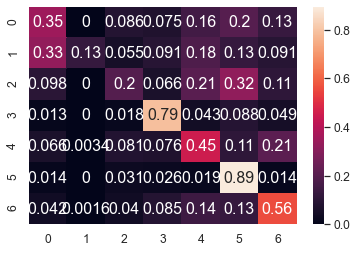

	training epoch=40 .. train_loss=0.967
	validation epoch=40 .. val_loss=1.248
	Accuracy = 54.800000000000004 % .. Percision = 54.900000000000006 % .. Recall = 48.1 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_40.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 41 .. loss = 0.811


  0%|                                                                                 | 1/1914 [00:01<54:07,  1.70s/it]

training @ epoch 41 .. loss = 0.665


  0%|                                                                                 | 2/1914 [00:03<59:40,  1.87s/it]

training @ epoch 41 .. loss = 0.742


  0%|▏                                                                                | 3/1914 [00:05<57:23,  1.80s/it]

training @ epoch 41 .. loss = 0.827


  0%|▏                                                                                | 4/1914 [00:07<55:11,  1.73s/it]

training @ epoch 41 .. loss = 0.875


  0%|▏                                                                                | 5/1914 [00:08<55:52,  1.76s/it]

training @ epoch 41 .. loss = 1.079


  0%|▎                                                                                | 6/1914 [00:10<53:23,  1.68s/it]

training @ epoch 41 .. loss = 0.772


  0%|▎                                                                                | 7/1914 [00:12<52:10,  1.64s/it]

training @ epoch 41 .. loss = 0.88


  0%|▎                                                                                | 8/1914 [00:13<50:12,  1.58s/it]

training @ epoch 41 .. loss = 0.681


  0%|▍                                                                                | 9/1914 [00:14<49:21,  1.55s/it]

training @ epoch 41 .. loss = 0.489


  1%|▍                                                                               | 10/1914 [00:16<48:19,  1.52s/it]

training @ epoch 41 .. loss = 1.329


  1%|▍                                                                               | 11/1914 [00:17<47:56,  1.51s/it]

training @ epoch 41 .. loss = 0.813


  1%|▌                                                                               | 12/1914 [00:19<47:00,  1.48s/it]

training @ epoch 41 .. loss = 0.75


  1%|▌                                                                               | 13/1914 [00:20<45:51,  1.45s/it]

training @ epoch 41 .. loss = 0.661


  1%|▌                                                                               | 14/1914 [00:22<45:02,  1.42s/it]

training @ epoch 41 .. loss = 1.089


  1%|▋                                                                               | 15/1914 [00:23<44:57,  1.42s/it]

training @ epoch 41 .. loss = 1.138


  1%|▋                                                                               | 16/1914 [00:24<45:33,  1.44s/it]

training @ epoch 41 .. loss = 0.646


  1%|▋                                                                               | 17/1914 [00:26<45:46,  1.45s/it]

training @ epoch 41 .. loss = 0.991


  1%|▊                                                                               | 18/1914 [00:27<45:44,  1.45s/it]

training @ epoch 41 .. loss = 0.93


  1%|▊                                                                               | 19/1914 [00:29<45:07,  1.43s/it]

training @ epoch 41 .. loss = 0.738


  1%|▊                                                                               | 20/1914 [00:30<44:00,  1.39s/it]

training @ epoch 41 .. loss = 1.03


  1%|▉                                                                               | 21/1914 [00:32<44:23,  1.41s/it]

training @ epoch 41 .. loss = 0.834


  1%|▉                                                                               | 22/1914 [00:33<44:26,  1.41s/it]

training @ epoch 41 .. loss = 0.952


  1%|▉                                                                               | 23/1914 [00:35<46:12,  1.47s/it]

training @ epoch 41 .. loss = 0.928


  1%|█                                                                               | 24/1914 [00:36<47:45,  1.52s/it]

training @ epoch 41 .. loss = 1.445


  1%|█                                                                               | 25/1914 [00:38<46:54,  1.49s/it]

training @ epoch 41 .. loss = 0.595


  1%|█                                                                               | 26/1914 [00:39<45:53,  1.46s/it]

training @ epoch 41 .. loss = 1.039


  1%|█▏                                                                              | 27/1914 [00:40<45:09,  1.44s/it]

training @ epoch 41 .. loss = 0.74


  1%|█▏                                                                              | 28/1914 [00:42<45:31,  1.45s/it]

training @ epoch 41 .. loss = 0.839


  2%|█▏                                                                              | 29/1914 [00:43<46:01,  1.46s/it]

training @ epoch 41 .. loss = 1.08


  2%|█▎                                                                              | 30/1914 [00:45<46:06,  1.47s/it]

training @ epoch 41 .. loss = 0.561


  2%|█▎                                                                              | 31/1914 [00:46<46:28,  1.48s/it]

training @ epoch 41 .. loss = 1.034


  2%|█▎                                                                              | 32/1914 [00:48<46:30,  1.48s/it]

training @ epoch 41 .. loss = 0.964


  2%|█▍                                                                              | 33/1914 [00:49<46:42,  1.49s/it]

training @ epoch 41 .. loss = 1.148


  2%|█▍                                                                              | 34/1914 [00:51<46:05,  1.47s/it]

training @ epoch 41 .. loss = 1.249


  2%|█▍                                                                              | 35/1914 [00:52<46:24,  1.48s/it]

training @ epoch 41 .. loss = 0.724


  2%|█▌                                                                              | 36/1914 [00:54<46:08,  1.47s/it]

training @ epoch 41 .. loss = 0.728


  2%|█▌                                                                              | 37/1914 [00:55<44:48,  1.43s/it]

training @ epoch 41 .. loss = 0.771


  2%|█▌                                                                              | 38/1914 [00:56<44:03,  1.41s/it]

training @ epoch 41 .. loss = 0.681


  2%|█▋                                                                              | 39/1914 [00:58<43:59,  1.41s/it]

training @ epoch 41 .. loss = 0.846


  2%|█▋                                                                              | 40/1914 [00:59<44:14,  1.42s/it]

training @ epoch 41 .. loss = 0.643


  2%|█▋                                                                              | 41/1914 [01:01<44:40,  1.43s/it]

training @ epoch 41 .. loss = 0.623


  2%|█▊                                                                              | 42/1914 [01:02<45:10,  1.45s/it]

training @ epoch 41 .. loss = 0.915


  2%|█▊                                                                              | 43/1914 [01:04<44:05,  1.41s/it]

training @ epoch 41 .. loss = 0.918


  2%|█▊                                                                              | 44/1914 [01:05<43:29,  1.40s/it]

training @ epoch 41 .. loss = 0.327


  2%|█▉                                                                              | 45/1914 [01:06<43:40,  1.40s/it]

training @ epoch 41 .. loss = 1.3


  2%|█▉                                                                              | 46/1914 [01:08<44:08,  1.42s/it]

training @ epoch 41 .. loss = 0.89


  2%|█▉                                                                              | 47/1914 [01:09<44:45,  1.44s/it]

training @ epoch 41 .. loss = 1.268


  3%|██                                                                              | 48/1914 [01:11<45:00,  1.45s/it]

training @ epoch 41 .. loss = 1.075


  3%|██                                                                              | 49/1914 [01:12<44:41,  1.44s/it]

training @ epoch 41 .. loss = 0.601


  3%|██                                                                              | 50/1914 [01:13<43:53,  1.41s/it]

training @ epoch 41 .. loss = 1.196


  3%|██▏                                                                             | 51/1914 [01:15<43:31,  1.40s/it]

training @ epoch 41 .. loss = 0.682


  3%|██▏                                                                             | 52/1914 [01:16<44:39,  1.44s/it]

training @ epoch 41 .. loss = 0.365


  3%|██▏                                                                             | 53/1914 [01:18<44:46,  1.44s/it]

training @ epoch 41 .. loss = 0.956


  3%|██▎                                                                             | 54/1914 [01:19<44:35,  1.44s/it]

training @ epoch 41 .. loss = 0.934


  3%|██▎                                                                             | 55/1914 [01:21<44:21,  1.43s/it]

training @ epoch 41 .. loss = 1.0


  3%|██▎                                                                             | 56/1914 [01:22<43:15,  1.40s/it]

training @ epoch 41 .. loss = 1.042


  3%|██▍                                                                             | 57/1914 [01:23<42:32,  1.37s/it]

training @ epoch 41 .. loss = 1.243


  3%|██▍                                                                             | 58/1914 [01:25<43:29,  1.41s/it]

training @ epoch 41 .. loss = 1.282


  3%|██▍                                                                             | 59/1914 [01:26<43:55,  1.42s/it]

training @ epoch 41 .. loss = 0.557


  3%|██▌                                                                             | 60/1914 [01:28<44:25,  1.44s/it]

training @ epoch 41 .. loss = 1.234


  3%|██▌                                                                             | 61/1914 [01:29<44:21,  1.44s/it]

training @ epoch 41 .. loss = 1.048


  3%|██▌                                                                             | 62/1914 [01:31<43:35,  1.41s/it]

training @ epoch 41 .. loss = 0.77


  3%|██▋                                                                             | 63/1914 [01:32<43:02,  1.39s/it]

training @ epoch 41 .. loss = 0.8


  3%|██▋                                                                             | 64/1914 [01:33<42:55,  1.39s/it]

training @ epoch 41 .. loss = 1.119


  3%|██▋                                                                             | 65/1914 [01:35<43:12,  1.40s/it]

training @ epoch 41 .. loss = 1.236


  3%|██▊                                                                             | 66/1914 [01:36<44:09,  1.43s/it]

training @ epoch 41 .. loss = 0.735


  4%|██▊                                                                             | 67/1914 [01:38<44:20,  1.44s/it]

training @ epoch 41 .. loss = 1.145


  4%|██▊                                                                             | 68/1914 [01:39<43:19,  1.41s/it]

training @ epoch 41 .. loss = 0.824


  4%|██▉                                                                             | 69/1914 [01:40<42:48,  1.39s/it]

training @ epoch 41 .. loss = 0.976


  4%|██▉                                                                             | 70/1914 [01:42<42:59,  1.40s/it]

training @ epoch 41 .. loss = 0.423


  4%|██▉                                                                             | 71/1914 [01:43<43:07,  1.40s/it]

training @ epoch 41 .. loss = 0.72


  4%|███                                                                             | 72/1914 [01:45<43:51,  1.43s/it]

training @ epoch 41 .. loss = 1.053


  4%|███                                                                             | 73/1914 [01:46<44:43,  1.46s/it]

training @ epoch 41 .. loss = 0.648


  4%|███                                                                             | 74/1914 [01:47<43:18,  1.41s/it]

training @ epoch 41 .. loss = 0.867


  4%|███▏                                                                            | 75/1914 [01:49<42:56,  1.40s/it]

training @ epoch 41 .. loss = 0.72


  4%|███▏                                                                            | 76/1914 [01:50<43:14,  1.41s/it]

training @ epoch 41 .. loss = 1.282


  4%|███▏                                                                            | 77/1914 [01:52<42:58,  1.40s/it]

training @ epoch 41 .. loss = 1.158


  4%|███▎                                                                            | 78/1914 [01:53<43:37,  1.43s/it]

training @ epoch 41 .. loss = 0.931


  4%|███▎                                                                            | 79/1914 [01:55<44:09,  1.44s/it]

training @ epoch 41 .. loss = 0.816


  4%|███▎                                                                            | 80/1914 [01:56<43:57,  1.44s/it]

training @ epoch 41 .. loss = 0.725


  4%|███▍                                                                            | 81/1914 [01:57<43:38,  1.43s/it]

training @ epoch 41 .. loss = 0.923


  4%|███▍                                                                            | 82/1914 [01:59<43:51,  1.44s/it]

training @ epoch 41 .. loss = 0.528


  4%|███▍                                                                            | 83/1914 [02:01<45:18,  1.48s/it]

training @ epoch 41 .. loss = 0.875


  4%|███▌                                                                            | 84/1914 [02:02<46:13,  1.52s/it]

training @ epoch 41 .. loss = 0.876


  4%|███▌                                                                            | 85/1914 [02:04<46:16,  1.52s/it]

training @ epoch 41 .. loss = 0.81


  4%|███▌                                                                            | 86/1914 [02:05<46:14,  1.52s/it]

training @ epoch 41 .. loss = 0.824


  5%|███▋                                                                            | 87/1914 [02:07<44:55,  1.48s/it]

training @ epoch 41 .. loss = 0.63


  5%|███▋                                                                            | 88/1914 [02:08<44:03,  1.45s/it]

training @ epoch 41 .. loss = 0.629


  5%|███▋                                                                            | 89/1914 [02:09<44:27,  1.46s/it]

training @ epoch 41 .. loss = 0.854


  5%|███▊                                                                            | 90/1914 [02:11<44:18,  1.46s/it]

training @ epoch 41 .. loss = 1.107


  5%|███▊                                                                            | 91/1914 [02:12<45:22,  1.49s/it]

training @ epoch 41 .. loss = 0.74


  5%|███▊                                                                            | 92/1914 [02:14<45:00,  1.48s/it]

training @ epoch 41 .. loss = 0.895


  5%|███▉                                                                            | 93/1914 [02:15<44:33,  1.47s/it]

training @ epoch 41 .. loss = 0.805


  5%|███▉                                                                            | 94/1914 [02:17<43:24,  1.43s/it]

training @ epoch 41 .. loss = 0.967


  5%|███▉                                                                            | 95/1914 [02:18<42:52,  1.41s/it]

training @ epoch 41 .. loss = 1.007


  5%|████                                                                            | 96/1914 [02:20<43:18,  1.43s/it]

training @ epoch 41 .. loss = 0.774


  5%|████                                                                            | 97/1914 [02:21<43:15,  1.43s/it]

training @ epoch 41 .. loss = 0.932


  5%|████                                                                            | 98/1914 [02:22<43:55,  1.45s/it]

training @ epoch 41 .. loss = 0.704


  5%|████▏                                                                           | 99/1914 [02:24<44:14,  1.46s/it]

training @ epoch 41 .. loss = 1.036


  5%|████▏                                                                          | 100/1914 [02:25<43:03,  1.42s/it]

training @ epoch 41 .. loss = 1.014


  5%|████▏                                                                          | 101/1914 [02:27<42:22,  1.40s/it]

training @ epoch 41 .. loss = 1.096


  5%|████▏                                                                          | 102/1914 [02:28<42:29,  1.41s/it]

training @ epoch 41 .. loss = 0.854


  5%|████▎                                                                          | 103/1914 [02:29<42:38,  1.41s/it]

training @ epoch 41 .. loss = 0.654


  5%|████▎                                                                          | 104/1914 [02:31<43:11,  1.43s/it]

training @ epoch 41 .. loss = 0.797


  5%|████▎                                                                          | 105/1914 [02:32<43:39,  1.45s/it]

training @ epoch 41 .. loss = 0.567


  6%|████▍                                                                          | 106/1914 [02:34<42:31,  1.41s/it]

training @ epoch 41 .. loss = 1.036


  6%|████▍                                                                          | 107/1914 [02:35<41:30,  1.38s/it]

training @ epoch 41 .. loss = 0.999


  6%|████▍                                                                          | 108/1914 [02:37<42:12,  1.40s/it]

training @ epoch 41 .. loss = 0.92


  6%|████▍                                                                          | 109/1914 [02:38<42:06,  1.40s/it]

training @ epoch 41 .. loss = 1.155


  6%|████▌                                                                          | 110/1914 [02:39<42:52,  1.43s/it]

training @ epoch 41 .. loss = 0.589


  6%|████▌                                                                          | 111/1914 [02:41<43:06,  1.43s/it]

training @ epoch 41 .. loss = 1.282


  6%|████▌                                                                          | 112/1914 [02:42<42:20,  1.41s/it]

training @ epoch 41 .. loss = 0.858


  6%|████▋                                                                          | 113/1914 [02:44<41:49,  1.39s/it]

training @ epoch 41 .. loss = 0.86


  6%|████▋                                                                          | 114/1914 [02:45<41:44,  1.39s/it]

training @ epoch 41 .. loss = 1.087


  6%|████▋                                                                          | 115/1914 [02:46<41:55,  1.40s/it]

training @ epoch 41 .. loss = 1.422


  6%|████▊                                                                          | 116/1914 [02:48<42:42,  1.42s/it]

training @ epoch 41 .. loss = 0.929


  6%|████▊                                                                          | 117/1914 [02:49<43:19,  1.45s/it]

training @ epoch 41 .. loss = 0.932


  6%|████▊                                                                          | 118/1914 [02:51<42:39,  1.42s/it]

training @ epoch 41 .. loss = 0.812


  6%|████▉                                                                          | 119/1914 [02:52<42:05,  1.41s/it]

training @ epoch 41 .. loss = 0.91


  6%|████▉                                                                          | 120/1914 [02:53<41:52,  1.40s/it]

training @ epoch 41 .. loss = 0.417


  6%|████▉                                                                          | 121/1914 [02:55<41:58,  1.40s/it]

training @ epoch 41 .. loss = 1.034


  6%|█████                                                                          | 122/1914 [02:56<42:42,  1.43s/it]

training @ epoch 41 .. loss = 1.08


  6%|█████                                                                          | 123/1914 [02:58<43:05,  1.44s/it]

training @ epoch 41 .. loss = 0.577


  6%|█████                                                                          | 124/1914 [02:59<42:16,  1.42s/it]

training @ epoch 41 .. loss = 1.321


  7%|█████▏                                                                         | 125/1914 [03:01<42:01,  1.41s/it]

training @ epoch 41 .. loss = 0.689


  7%|█████▏                                                                         | 126/1914 [03:02<42:15,  1.42s/it]

training @ epoch 41 .. loss = 1.528


  7%|█████▏                                                                         | 127/1914 [03:03<42:12,  1.42s/it]

training @ epoch 41 .. loss = 1.335


  7%|█████▎                                                                         | 128/1914 [03:05<42:48,  1.44s/it]

training @ epoch 41 .. loss = 0.709


  7%|█████▎                                                                         | 129/1914 [03:06<43:38,  1.47s/it]

training @ epoch 41 .. loss = 1.523


  7%|█████▎                                                                         | 130/1914 [03:08<42:59,  1.45s/it]

training @ epoch 41 .. loss = 1.161


  7%|█████▍                                                                         | 131/1914 [03:09<43:03,  1.45s/it]

training @ epoch 41 .. loss = 0.956


  7%|█████▍                                                                         | 132/1914 [03:11<42:33,  1.43s/it]

training @ epoch 41 .. loss = 1.0


  7%|█████▍                                                                         | 133/1914 [03:12<42:38,  1.44s/it]

training @ epoch 41 .. loss = 1.37


  7%|█████▌                                                                         | 134/1914 [03:14<43:34,  1.47s/it]

training @ epoch 41 .. loss = 0.995


  7%|█████▌                                                                         | 135/1914 [03:15<43:28,  1.47s/it]

training @ epoch 41 .. loss = 0.655


  7%|█████▌                                                                         | 136/1914 [03:17<43:15,  1.46s/it]

training @ epoch 41 .. loss = 0.773


  7%|█████▋                                                                         | 137/1914 [03:18<42:39,  1.44s/it]

training @ epoch 41 .. loss = 0.9


  7%|█████▋                                                                         | 138/1914 [03:19<41:35,  1.41s/it]

training @ epoch 41 .. loss = 0.681


  7%|█████▋                                                                         | 139/1914 [03:21<41:45,  1.41s/it]

training @ epoch 41 .. loss = 0.873


  7%|█████▊                                                                         | 140/1914 [03:22<42:01,  1.42s/it]

training @ epoch 41 .. loss = 1.194


  7%|█████▊                                                                         | 141/1914 [03:24<42:35,  1.44s/it]

training @ epoch 41 .. loss = 0.739


  7%|█████▊                                                                         | 142/1914 [03:25<43:00,  1.46s/it]

training @ epoch 41 .. loss = 1.193


  7%|█████▉                                                                         | 143/1914 [03:27<42:13,  1.43s/it]

training @ epoch 41 .. loss = 0.585


  8%|█████▉                                                                         | 144/1914 [03:28<41:25,  1.40s/it]

training @ epoch 41 .. loss = 0.961


  8%|█████▉                                                                         | 145/1914 [03:29<41:34,  1.41s/it]

training @ epoch 41 .. loss = 1.346


  8%|██████                                                                         | 146/1914 [03:31<41:31,  1.41s/it]

training @ epoch 41 .. loss = 0.617


  8%|██████                                                                         | 147/1914 [03:32<42:10,  1.43s/it]

training @ epoch 41 .. loss = 1.067


  8%|██████                                                                         | 148/1914 [03:34<42:06,  1.43s/it]

training @ epoch 41 .. loss = 1.096


  8%|██████▏                                                                        | 149/1914 [03:35<41:03,  1.40s/it]

training @ epoch 41 .. loss = 0.808


  8%|██████▏                                                                        | 150/1914 [03:36<40:50,  1.39s/it]

training @ epoch 41 .. loss = 0.814


  8%|██████▏                                                                        | 151/1914 [03:38<40:57,  1.39s/it]

training @ epoch 41 .. loss = 0.896


  8%|██████▎                                                                        | 152/1914 [03:39<40:57,  1.39s/it]

training @ epoch 41 .. loss = 0.551


  8%|██████▎                                                                        | 153/1914 [03:41<41:38,  1.42s/it]

training @ epoch 41 .. loss = 0.63


  8%|██████▎                                                                        | 154/1914 [03:42<42:07,  1.44s/it]

training @ epoch 41 .. loss = 0.714


  8%|██████▍                                                                        | 155/1914 [03:43<41:07,  1.40s/it]

training @ epoch 41 .. loss = 0.862


  8%|██████▍                                                                        | 156/1914 [03:45<40:35,  1.39s/it]

training @ epoch 41 .. loss = 0.91


  8%|██████▍                                                                        | 157/1914 [03:46<40:27,  1.38s/it]

training @ epoch 41 .. loss = 1.17


  8%|██████▌                                                                        | 158/1914 [03:48<40:34,  1.39s/it]

training @ epoch 41 .. loss = 1.195


  8%|██████▌                                                                        | 159/1914 [03:49<40:48,  1.39s/it]

training @ epoch 41 .. loss = 0.838


  8%|██████▌                                                                        | 160/1914 [03:50<41:50,  1.43s/it]

training @ epoch 41 .. loss = 0.981


  8%|██████▋                                                                        | 161/1914 [03:52<42:44,  1.46s/it]

training @ epoch 41 .. loss = 0.756


  8%|██████▋                                                                        | 162/1914 [03:53<42:27,  1.45s/it]

training @ epoch 41 .. loss = 0.774


  9%|██████▋                                                                        | 163/1914 [03:55<42:17,  1.45s/it]

training @ epoch 41 .. loss = 1.25


  9%|██████▊                                                                        | 164/1914 [03:57<44:45,  1.53s/it]

training @ epoch 41 .. loss = 1.467


  9%|██████▊                                                                        | 165/1914 [03:58<44:35,  1.53s/it]

training @ epoch 41 .. loss = 0.867


  9%|██████▊                                                                        | 166/1914 [04:00<43:44,  1.50s/it]

training @ epoch 41 .. loss = 0.771


  9%|██████▉                                                                        | 167/1914 [04:01<42:42,  1.47s/it]

training @ epoch 41 .. loss = 0.808


  9%|██████▉                                                                        | 168/1914 [04:02<42:12,  1.45s/it]

training @ epoch 41 .. loss = 0.794


  9%|██████▉                                                                        | 169/1914 [04:04<41:31,  1.43s/it]

training @ epoch 41 .. loss = 0.724


  9%|███████                                                                        | 170/1914 [04:05<41:08,  1.42s/it]

training @ epoch 41 .. loss = 0.779


  9%|███████                                                                        | 171/1914 [04:07<41:49,  1.44s/it]

training @ epoch 41 .. loss = 1.123


  9%|███████                                                                        | 172/1914 [04:08<42:01,  1.45s/it]

training @ epoch 41 .. loss = 1.122


  9%|███████▏                                                                       | 173/1914 [04:10<42:42,  1.47s/it]

training @ epoch 41 .. loss = 1.235


  9%|███████▏                                                                       | 174/1914 [04:11<43:06,  1.49s/it]

training @ epoch 41 .. loss = 1.002


  9%|███████▏                                                                       | 175/1914 [04:13<42:56,  1.48s/it]

training @ epoch 41 .. loss = 0.567


  9%|███████▎                                                                       | 176/1914 [04:14<41:48,  1.44s/it]

training @ epoch 41 .. loss = 0.542


  9%|███████▎                                                                       | 177/1914 [04:15<40:55,  1.41s/it]

training @ epoch 41 .. loss = 0.877


  9%|███████▎                                                                       | 178/1914 [04:17<40:59,  1.42s/it]

training @ epoch 41 .. loss = 0.68


  9%|███████▍                                                                       | 179/1914 [04:18<42:06,  1.46s/it]

training @ epoch 41 .. loss = 1.143


  9%|███████▍                                                                       | 180/1914 [04:20<42:03,  1.46s/it]

training @ epoch 41 .. loss = 1.221


  9%|███████▍                                                                       | 181/1914 [04:21<41:52,  1.45s/it]

training @ epoch 41 .. loss = 0.932


 10%|███████▌                                                                       | 182/1914 [04:22<41:06,  1.42s/it]

training @ epoch 41 .. loss = 1.2


 10%|███████▌                                                                       | 183/1914 [04:24<40:34,  1.41s/it]

training @ epoch 41 .. loss = 0.85


 10%|███████▌                                                                       | 184/1914 [04:25<40:48,  1.42s/it]

training @ epoch 41 .. loss = 0.611


 10%|███████▋                                                                       | 185/1914 [04:27<40:41,  1.41s/it]

training @ epoch 41 .. loss = 0.843


 10%|███████▋                                                                       | 186/1914 [04:28<41:29,  1.44s/it]

training @ epoch 41 .. loss = 0.456


 10%|███████▋                                                                       | 187/1914 [04:30<41:35,  1.44s/it]

training @ epoch 41 .. loss = 0.699


 10%|███████▊                                                                       | 188/1914 [04:31<40:32,  1.41s/it]

training @ epoch 41 .. loss = 0.605


 10%|███████▊                                                                       | 189/1914 [04:32<40:18,  1.40s/it]

training @ epoch 41 .. loss = 0.716


 10%|███████▊                                                                       | 190/1914 [04:34<40:44,  1.42s/it]

training @ epoch 41 .. loss = 0.642


 10%|███████▉                                                                       | 191/1914 [04:35<40:52,  1.42s/it]

training @ epoch 41 .. loss = 0.641


 10%|███████▉                                                                       | 192/1914 [04:37<41:59,  1.46s/it]

training @ epoch 41 .. loss = 1.158


 10%|███████▉                                                                       | 193/1914 [04:38<42:16,  1.47s/it]

training @ epoch 41 .. loss = 1.144


 10%|████████                                                                       | 194/1914 [04:40<40:56,  1.43s/it]

training @ epoch 41 .. loss = 1.355


 10%|████████                                                                       | 195/1914 [04:41<40:12,  1.40s/it]

training @ epoch 41 .. loss = 0.531


 10%|████████                                                                       | 196/1914 [04:42<40:22,  1.41s/it]

training @ epoch 41 .. loss = 0.861


 10%|████████▏                                                                      | 197/1914 [04:44<40:18,  1.41s/it]

training @ epoch 41 .. loss = 1.019


 10%|████████▏                                                                      | 198/1914 [04:45<40:31,  1.42s/it]

training @ epoch 41 .. loss = 0.825


 10%|████████▏                                                                      | 199/1914 [04:47<41:05,  1.44s/it]

training @ epoch 41 .. loss = 1.318


 10%|████████▎                                                                      | 200/1914 [04:48<40:26,  1.42s/it]

training @ epoch 41 .. loss = 1.121


 11%|████████▎                                                                      | 201/1914 [04:49<39:53,  1.40s/it]

training @ epoch 41 .. loss = 1.104


 11%|████████▎                                                                      | 202/1914 [04:51<40:16,  1.41s/it]

training @ epoch 41 .. loss = 1.061


 11%|████████▍                                                                      | 203/1914 [04:52<40:27,  1.42s/it]

training @ epoch 41 .. loss = 0.686


 11%|████████▍                                                                      | 204/1914 [04:54<41:21,  1.45s/it]

training @ epoch 41 .. loss = 0.801


 11%|████████▍                                                                      | 205/1914 [04:55<41:32,  1.46s/it]

training @ epoch 41 .. loss = 0.999


 11%|████████▌                                                                      | 206/1914 [04:57<41:23,  1.45s/it]

training @ epoch 41 .. loss = 0.841


 11%|████████▌                                                                      | 207/1914 [04:58<40:31,  1.42s/it]

training @ epoch 41 .. loss = 0.973


 11%|████████▌                                                                      | 208/1914 [05:00<40:03,  1.41s/it]

training @ epoch 41 .. loss = 0.902


 11%|████████▋                                                                      | 209/1914 [05:01<40:17,  1.42s/it]

training @ epoch 41 .. loss = 1.074


 11%|████████▋                                                                      | 210/1914 [05:02<41:16,  1.45s/it]

training @ epoch 41 .. loss = 0.981


 11%|████████▋                                                                      | 211/1914 [05:04<41:21,  1.46s/it]

training @ epoch 41 .. loss = 0.83


 11%|████████▊                                                                      | 212/1914 [05:05<40:16,  1.42s/it]

training @ epoch 41 .. loss = 1.183


 11%|████████▊                                                                      | 213/1914 [05:07<39:11,  1.38s/it]

training @ epoch 41 .. loss = 1.081


 11%|████████▊                                                                      | 214/1914 [05:08<39:32,  1.40s/it]

training @ epoch 41 .. loss = 1.032


 11%|████████▊                                                                      | 215/1914 [05:09<39:45,  1.40s/it]

training @ epoch 41 .. loss = 0.734


 11%|████████▉                                                                      | 216/1914 [05:11<40:31,  1.43s/it]

training @ epoch 41 .. loss = 1.078


 11%|████████▉                                                                      | 217/1914 [05:12<41:13,  1.46s/it]

training @ epoch 41 .. loss = 0.938


 11%|████████▉                                                                      | 218/1914 [05:14<41:10,  1.46s/it]

training @ epoch 41 .. loss = 1.075


 11%|█████████                                                                      | 219/1914 [05:15<39:45,  1.41s/it]

training @ epoch 41 .. loss = 0.698


 11%|█████████                                                                      | 220/1914 [05:17<39:23,  1.40s/it]

training @ epoch 41 .. loss = 0.746


 12%|█████████                                                                      | 221/1914 [05:18<39:48,  1.41s/it]

training @ epoch 41 .. loss = 1.047


 12%|█████████▏                                                                     | 222/1914 [05:19<39:49,  1.41s/it]

training @ epoch 41 .. loss = 0.641


 12%|█████████▏                                                                     | 223/1914 [05:21<40:25,  1.43s/it]

training @ epoch 41 .. loss = 1.014


 12%|█████████▏                                                                     | 224/1914 [05:22<40:30,  1.44s/it]

training @ epoch 41 .. loss = 1.059


 12%|█████████▎                                                                     | 225/1914 [05:24<39:46,  1.41s/it]

training @ epoch 41 .. loss = 0.739


 12%|█████████▎                                                                     | 226/1914 [05:25<38:58,  1.39s/it]

training @ epoch 41 .. loss = 1.467


 12%|█████████▎                                                                     | 227/1914 [05:26<39:29,  1.40s/it]

training @ epoch 41 .. loss = 0.652


 12%|█████████▍                                                                     | 228/1914 [05:28<39:53,  1.42s/it]

training @ epoch 41 .. loss = 1.057


 12%|█████████▍                                                                     | 229/1914 [05:30<41:05,  1.46s/it]

training @ epoch 41 .. loss = 0.443


 12%|█████████▍                                                                     | 230/1914 [05:31<41:01,  1.46s/it]

training @ epoch 41 .. loss = 0.474


 12%|█████████▌                                                                     | 231/1914 [05:32<41:06,  1.47s/it]

training @ epoch 41 .. loss = 1.24


 12%|█████████▌                                                                     | 232/1914 [05:34<40:29,  1.44s/it]

training @ epoch 41 .. loss = 1.117


 12%|█████████▌                                                                     | 233/1914 [05:35<41:20,  1.48s/it]

training @ epoch 41 .. loss = 0.811


 12%|█████████▋                                                                     | 234/1914 [05:37<41:17,  1.47s/it]

training @ epoch 41 .. loss = 0.827


 12%|█████████▋                                                                     | 235/1914 [05:38<42:34,  1.52s/it]

training @ epoch 41 .. loss = 0.856


 12%|█████████▋                                                                     | 236/1914 [05:40<42:55,  1.53s/it]

training @ epoch 41 .. loss = 1.235


 12%|█████████▊                                                                     | 237/1914 [05:42<42:29,  1.52s/it]

training @ epoch 41 .. loss = 0.749


 12%|█████████▊                                                                     | 238/1914 [05:43<40:59,  1.47s/it]

training @ epoch 41 .. loss = 0.718


 12%|█████████▊                                                                     | 239/1914 [05:44<40:36,  1.45s/it]

training @ epoch 41 .. loss = 0.748


 13%|█████████▉                                                                     | 240/1914 [05:46<40:10,  1.44s/it]

training @ epoch 41 .. loss = 0.993


 13%|█████████▉                                                                     | 241/1914 [05:47<40:12,  1.44s/it]

training @ epoch 41 .. loss = 0.945


 13%|█████████▉                                                                     | 242/1914 [05:49<40:42,  1.46s/it]

training @ epoch 41 .. loss = 0.843


 13%|██████████                                                                     | 243/1914 [05:50<41:04,  1.47s/it]

training @ epoch 41 .. loss = 1.022


 13%|██████████                                                                     | 244/1914 [05:52<41:22,  1.49s/it]

training @ epoch 41 .. loss = 1.689


 13%|██████████                                                                     | 245/1914 [05:53<40:05,  1.44s/it]

training @ epoch 41 .. loss = 0.702


 13%|██████████▏                                                                    | 246/1914 [05:54<40:11,  1.45s/it]

training @ epoch 41 .. loss = 0.9


 13%|██████████▏                                                                    | 247/1914 [05:56<40:00,  1.44s/it]

training @ epoch 41 .. loss = 0.295


 13%|██████████▏                                                                    | 248/1914 [05:57<39:56,  1.44s/it]

training @ epoch 41 .. loss = 1.085


 13%|██████████▎                                                                    | 249/1914 [05:59<40:04,  1.44s/it]

training @ epoch 41 .. loss = 0.601


 13%|██████████▎                                                                    | 250/1914 [06:00<40:18,  1.45s/it]

training @ epoch 41 .. loss = 0.886


 13%|██████████▎                                                                    | 251/1914 [06:02<39:22,  1.42s/it]

training @ epoch 41 .. loss = 1.125


 13%|██████████▍                                                                    | 252/1914 [06:03<38:16,  1.38s/it]

training @ epoch 41 .. loss = 1.183


 13%|██████████▍                                                                    | 253/1914 [06:04<39:17,  1.42s/it]

training @ epoch 41 .. loss = 0.837


 13%|██████████▍                                                                    | 254/1914 [06:06<39:34,  1.43s/it]

training @ epoch 41 .. loss = 1.085


 13%|██████████▌                                                                    | 255/1914 [06:07<39:56,  1.44s/it]

training @ epoch 41 .. loss = 1.501


 13%|██████████▌                                                                    | 256/1914 [06:09<39:50,  1.44s/it]

training @ epoch 41 .. loss = 1.433


 13%|██████████▌                                                                    | 257/1914 [06:10<39:13,  1.42s/it]

training @ epoch 41 .. loss = 0.959


 13%|██████████▋                                                                    | 258/1914 [06:12<38:51,  1.41s/it]

training @ epoch 41 .. loss = 0.993


 14%|██████████▋                                                                    | 259/1914 [06:13<39:03,  1.42s/it]

training @ epoch 41 .. loss = 0.934


 14%|██████████▋                                                                    | 260/1914 [06:14<39:32,  1.43s/it]

training @ epoch 41 .. loss = 0.755


 14%|██████████▊                                                                    | 261/1914 [06:16<39:46,  1.44s/it]

training @ epoch 41 .. loss = 0.897


 14%|██████████▊                                                                    | 262/1914 [06:17<39:56,  1.45s/it]

training @ epoch 41 .. loss = 1.105


 14%|██████████▊                                                                    | 263/1914 [06:19<39:02,  1.42s/it]

training @ epoch 41 .. loss = 0.647


 14%|██████████▉                                                                    | 264/1914 [06:20<38:40,  1.41s/it]

training @ epoch 41 .. loss = 1.527


 14%|██████████▉                                                                    | 265/1914 [06:22<38:53,  1.41s/it]

training @ epoch 41 .. loss = 1.151


 14%|██████████▉                                                                    | 266/1914 [06:23<38:56,  1.42s/it]

training @ epoch 41 .. loss = 0.953


 14%|███████████                                                                    | 267/1914 [06:24<39:44,  1.45s/it]

training @ epoch 41 .. loss = 1.146


 14%|███████████                                                                    | 268/1914 [06:26<39:47,  1.45s/it]

training @ epoch 41 .. loss = 0.796


 14%|███████████                                                                    | 269/1914 [06:27<38:37,  1.41s/it]

training @ epoch 41 .. loss = 1.221


 14%|███████████▏                                                                   | 270/1914 [06:29<38:09,  1.39s/it]

training @ epoch 41 .. loss = 1.144


 14%|███████████▏                                                                   | 271/1914 [06:30<38:44,  1.41s/it]

training @ epoch 41 .. loss = 0.864


 14%|███████████▏                                                                   | 272/1914 [06:32<39:12,  1.43s/it]

training @ epoch 41 .. loss = 0.905


 14%|███████████▎                                                                   | 273/1914 [06:33<39:23,  1.44s/it]

training @ epoch 41 .. loss = 1.136


 14%|███████████▎                                                                   | 274/1914 [06:34<39:50,  1.46s/it]

training @ epoch 41 .. loss = 0.953


 14%|███████████▎                                                                   | 275/1914 [06:36<38:57,  1.43s/it]

training @ epoch 41 .. loss = 1.063


 14%|███████████▍                                                                   | 276/1914 [06:37<37:55,  1.39s/it]

training @ epoch 41 .. loss = 1.158


 14%|███████████▍                                                                   | 277/1914 [06:39<38:06,  1.40s/it]

training @ epoch 41 .. loss = 1.14


 15%|███████████▍                                                                   | 278/1914 [06:40<38:24,  1.41s/it]

training @ epoch 41 .. loss = 0.771


 15%|███████████▌                                                                   | 279/1914 [06:41<39:00,  1.43s/it]

training @ epoch 41 .. loss = 1.238


 15%|███████████▌                                                                   | 280/1914 [06:43<39:31,  1.45s/it]

training @ epoch 41 .. loss = 1.055


 15%|███████████▌                                                                   | 281/1914 [06:44<39:07,  1.44s/it]

training @ epoch 41 .. loss = 0.96


 15%|███████████▋                                                                   | 282/1914 [06:46<38:20,  1.41s/it]

training @ epoch 41 .. loss = 0.736


 15%|███████████▋                                                                   | 283/1914 [06:47<37:41,  1.39s/it]

training @ epoch 41 .. loss = 0.886


 15%|███████████▋                                                                   | 284/1914 [06:49<38:34,  1.42s/it]

training @ epoch 41 .. loss = 1.197


 15%|███████████▊                                                                   | 285/1914 [06:50<38:55,  1.43s/it]

training @ epoch 41 .. loss = 0.88


 15%|███████████▊                                                                   | 286/1914 [06:51<39:04,  1.44s/it]

training @ epoch 41 .. loss = 1.103


 15%|███████████▊                                                                   | 287/1914 [06:53<39:00,  1.44s/it]

training @ epoch 41 .. loss = 0.94


 15%|███████████▉                                                                   | 288/1914 [06:54<38:34,  1.42s/it]

training @ epoch 41 .. loss = 0.982


 15%|███████████▉                                                                   | 289/1914 [06:56<38:08,  1.41s/it]

training @ epoch 41 .. loss = 0.751


 15%|███████████▉                                                                   | 290/1914 [06:57<38:34,  1.43s/it]

training @ epoch 41 .. loss = 0.986


 15%|████████████                                                                   | 291/1914 [06:59<38:58,  1.44s/it]

training @ epoch 41 .. loss = 0.758


 15%|████████████                                                                   | 292/1914 [07:00<39:47,  1.47s/it]

training @ epoch 41 .. loss = 1.078


 15%|████████████                                                                   | 293/1914 [07:02<39:50,  1.47s/it]

training @ epoch 41 .. loss = 0.924


 15%|████████████▏                                                                  | 294/1914 [07:03<39:10,  1.45s/it]

training @ epoch 41 .. loss = 1.211


 15%|████████████▏                                                                  | 295/1914 [07:05<39:20,  1.46s/it]

training @ epoch 41 .. loss = 0.998


 15%|████████████▏                                                                  | 296/1914 [07:06<38:52,  1.44s/it]

training @ epoch 41 .. loss = 0.908


 16%|████████████▎                                                                  | 297/1914 [07:08<40:06,  1.49s/it]

training @ epoch 41 .. loss = 0.721


 16%|████████████▎                                                                  | 298/1914 [07:09<40:14,  1.49s/it]

training @ epoch 41 .. loss = 0.81


 16%|████████████▎                                                                  | 299/1914 [07:11<40:08,  1.49s/it]

training @ epoch 41 .. loss = 1.043


 16%|████████████▍                                                                  | 300/1914 [07:12<39:44,  1.48s/it]

training @ epoch 41 .. loss = 0.985


 16%|████████████▍                                                                  | 301/1914 [07:13<39:27,  1.47s/it]

training @ epoch 41 .. loss = 0.789


 16%|████████████▍                                                                  | 302/1914 [07:15<38:16,  1.42s/it]

training @ epoch 41 .. loss = 1.148


 16%|████████████▌                                                                  | 303/1914 [07:16<38:30,  1.43s/it]

training @ epoch 41 .. loss = 1.152


 16%|████████████▌                                                                  | 304/1914 [07:18<38:29,  1.43s/it]

training @ epoch 41 .. loss = 0.45


 16%|████████████▌                                                                  | 305/1914 [07:19<38:53,  1.45s/it]

training @ epoch 41 .. loss = 0.969


 16%|████████████▋                                                                  | 306/1914 [07:21<39:14,  1.46s/it]

training @ epoch 41 .. loss = 0.88


 16%|████████████▋                                                                  | 307/1914 [07:22<39:33,  1.48s/it]

training @ epoch 41 .. loss = 0.695


 16%|████████████▋                                                                  | 308/1914 [07:24<39:11,  1.46s/it]

training @ epoch 41 .. loss = 1.249


 16%|████████████▊                                                                  | 309/1914 [07:25<38:41,  1.45s/it]

training @ epoch 41 .. loss = 0.529


 16%|████████████▊                                                                  | 310/1914 [07:26<38:44,  1.45s/it]

training @ epoch 41 .. loss = 0.598


 16%|████████████▊                                                                  | 311/1914 [07:28<39:09,  1.47s/it]

training @ epoch 41 .. loss = 0.84


 16%|████████████▉                                                                  | 312/1914 [07:29<39:13,  1.47s/it]

training @ epoch 41 .. loss = 0.993


 16%|████████████▉                                                                  | 313/1914 [07:31<38:46,  1.45s/it]

training @ epoch 41 .. loss = 1.235


 16%|████████████▉                                                                  | 314/1914 [07:32<38:02,  1.43s/it]

training @ epoch 41 .. loss = 0.742


 16%|█████████████                                                                  | 315/1914 [07:34<37:45,  1.42s/it]

training @ epoch 41 .. loss = 1.217


 17%|█████████████                                                                  | 316/1914 [07:35<37:39,  1.41s/it]

training @ epoch 41 .. loss = 1.144


 17%|█████████████                                                                  | 317/1914 [07:36<38:27,  1.44s/it]

training @ epoch 41 .. loss = 1.215


 17%|█████████████▏                                                                 | 318/1914 [07:38<38:31,  1.45s/it]

training @ epoch 41 .. loss = 0.888


 17%|█████████████▏                                                                 | 319/1914 [07:39<38:04,  1.43s/it]

training @ epoch 41 .. loss = 0.728


 17%|█████████████▏                                                                 | 320/1914 [07:41<37:25,  1.41s/it]

training @ epoch 41 .. loss = 0.975


 17%|█████████████▏                                                                 | 321/1914 [07:42<37:03,  1.40s/it]

training @ epoch 41 .. loss = 0.686


 17%|█████████████▎                                                                 | 322/1914 [07:43<37:05,  1.40s/it]

training @ epoch 41 .. loss = 0.702


 17%|█████████████▎                                                                 | 323/1914 [07:45<37:37,  1.42s/it]

training @ epoch 41 .. loss = 1.11


 17%|█████████████▎                                                                 | 324/1914 [07:46<38:17,  1.45s/it]

training @ epoch 41 .. loss = 0.728


 17%|█████████████▍                                                                 | 325/1914 [07:48<38:02,  1.44s/it]

training @ epoch 41 .. loss = 0.856


 17%|█████████████▍                                                                 | 326/1914 [07:49<36:43,  1.39s/it]

training @ epoch 41 .. loss = 1.058


 17%|█████████████▍                                                                 | 327/1914 [07:50<36:25,  1.38s/it]

training @ epoch 41 .. loss = 1.598


 17%|█████████████▌                                                                 | 328/1914 [07:52<36:51,  1.39s/it]

training @ epoch 41 .. loss = 0.9


 17%|█████████████▌                                                                 | 329/1914 [07:53<37:19,  1.41s/it]

training @ epoch 41 .. loss = 0.986


 17%|█████████████▌                                                                 | 330/1914 [07:55<37:47,  1.43s/it]

training @ epoch 41 .. loss = 1.097


 17%|█████████████▋                                                                 | 331/1914 [07:56<38:21,  1.45s/it]

training @ epoch 41 .. loss = 1.153


 17%|█████████████▋                                                                 | 332/1914 [07:58<37:37,  1.43s/it]

training @ epoch 41 .. loss = 0.882


 17%|█████████████▋                                                                 | 333/1914 [07:59<36:24,  1.38s/it]

training @ epoch 41 .. loss = 1.105


 17%|█████████████▊                                                                 | 334/1914 [08:00<36:52,  1.40s/it]

training @ epoch 41 .. loss = 1.23


 18%|█████████████▊                                                                 | 335/1914 [08:02<36:54,  1.40s/it]

training @ epoch 41 .. loss = 1.315


 18%|█████████████▊                                                                 | 336/1914 [08:03<37:56,  1.44s/it]

training @ epoch 41 .. loss = 1.037


 18%|█████████████▉                                                                 | 337/1914 [08:05<37:56,  1.44s/it]

training @ epoch 41 .. loss = 1.331


 18%|█████████████▉                                                                 | 338/1914 [08:06<38:00,  1.45s/it]

training @ epoch 41 .. loss = 0.677


 18%|█████████████▉                                                                 | 339/1914 [08:08<36:51,  1.40s/it]

training @ epoch 41 .. loss = 0.774


 18%|██████████████                                                                 | 340/1914 [08:09<36:59,  1.41s/it]

training @ epoch 41 .. loss = 0.764


 18%|██████████████                                                                 | 341/1914 [08:10<37:38,  1.44s/it]

training @ epoch 41 .. loss = 0.832


 18%|██████████████                                                                 | 342/1914 [08:12<38:06,  1.45s/it]

training @ epoch 41 .. loss = 0.748


 18%|██████████████▏                                                                | 343/1914 [08:14<39:26,  1.51s/it]

training @ epoch 41 .. loss = 0.748


 18%|██████████████▏                                                                | 344/1914 [08:15<39:20,  1.50s/it]

training @ epoch 41 .. loss = 1.2


 18%|██████████████▏                                                                | 345/1914 [08:17<38:42,  1.48s/it]

training @ epoch 41 .. loss = 0.775


 18%|██████████████▎                                                                | 346/1914 [08:18<37:55,  1.45s/it]

training @ epoch 41 .. loss = 0.951


 18%|██████████████▎                                                                | 347/1914 [08:19<38:01,  1.46s/it]

training @ epoch 41 .. loss = 1.037


 18%|██████████████▎                                                                | 348/1914 [08:21<38:04,  1.46s/it]

training @ epoch 41 .. loss = 1.262


 18%|██████████████▍                                                                | 349/1914 [08:22<38:34,  1.48s/it]

training @ epoch 41 .. loss = 1.07


 18%|██████████████▍                                                                | 350/1914 [08:24<38:46,  1.49s/it]

training @ epoch 41 .. loss = 0.709


 18%|██████████████▍                                                                | 351/1914 [08:25<38:48,  1.49s/it]

training @ epoch 41 .. loss = 1.018


 18%|██████████████▌                                                                | 352/1914 [08:27<39:04,  1.50s/it]

training @ epoch 41 .. loss = 0.805


 18%|██████████████▌                                                                | 353/1914 [08:28<38:17,  1.47s/it]

training @ epoch 41 .. loss = 0.818


 18%|██████████████▌                                                                | 354/1914 [08:30<37:40,  1.45s/it]

training @ epoch 41 .. loss = 0.773


 19%|██████████████▋                                                                | 355/1914 [08:31<37:23,  1.44s/it]

training @ epoch 41 .. loss = 1.043


 19%|██████████████▋                                                                | 356/1914 [08:33<37:48,  1.46s/it]

training @ epoch 41 .. loss = 0.742


 19%|██████████████▋                                                                | 357/1914 [08:34<38:39,  1.49s/it]

training @ epoch 41 .. loss = 0.99


 19%|██████████████▊                                                                | 358/1914 [08:36<37:44,  1.46s/it]

training @ epoch 41 .. loss = 1.146


 19%|██████████████▊                                                                | 359/1914 [08:37<37:05,  1.43s/it]

training @ epoch 41 .. loss = 0.933


 19%|██████████████▊                                                                | 360/1914 [08:38<37:23,  1.44s/it]

training @ epoch 41 .. loss = 0.809


 19%|██████████████▉                                                                | 361/1914 [08:40<37:14,  1.44s/it]

training @ epoch 41 .. loss = 0.948


 19%|██████████████▉                                                                | 362/1914 [08:41<37:30,  1.45s/it]

training @ epoch 41 .. loss = 0.611


 19%|██████████████▉                                                                | 363/1914 [08:43<37:27,  1.45s/it]

training @ epoch 41 .. loss = 0.914


 19%|███████████████                                                                | 364/1914 [08:44<37:14,  1.44s/it]

training @ epoch 41 .. loss = 0.885


 19%|███████████████                                                                | 365/1914 [08:46<36:46,  1.42s/it]

training @ epoch 41 .. loss = 1.161


 19%|███████████████                                                                | 366/1914 [08:47<36:51,  1.43s/it]

training @ epoch 41 .. loss = 0.741


 19%|███████████████▏                                                               | 367/1914 [08:48<37:12,  1.44s/it]

training @ epoch 41 .. loss = 0.785


 19%|███████████████▏                                                               | 368/1914 [08:50<37:44,  1.46s/it]

training @ epoch 41 .. loss = 1.239


 19%|███████████████▏                                                               | 369/1914 [08:52<38:53,  1.51s/it]

training @ epoch 41 .. loss = 0.744


 19%|███████████████▎                                                               | 370/1914 [08:53<37:45,  1.47s/it]

training @ epoch 41 .. loss = 1.002


 19%|███████████████▎                                                               | 371/1914 [08:54<37:24,  1.45s/it]

training @ epoch 41 .. loss = 0.981


 19%|███████████████▎                                                               | 372/1914 [08:56<37:29,  1.46s/it]

training @ epoch 41 .. loss = 0.791


 19%|███████████████▍                                                               | 373/1914 [08:58<39:02,  1.52s/it]

training @ epoch 41 .. loss = 1.121


 20%|███████████████▍                                                               | 374/1914 [08:59<39:21,  1.53s/it]

training @ epoch 41 .. loss = 0.787


 20%|███████████████▍                                                               | 375/1914 [09:01<39:57,  1.56s/it]

training @ epoch 41 .. loss = 1.221


 20%|███████████████▌                                                               | 376/1914 [09:02<40:43,  1.59s/it]

training @ epoch 41 .. loss = 0.958


 20%|███████████████▌                                                               | 377/1914 [09:04<40:49,  1.59s/it]

training @ epoch 41 .. loss = 0.707


 20%|███████████████▌                                                               | 378/1914 [09:06<40:33,  1.58s/it]

training @ epoch 41 .. loss = 1.053


 20%|███████████████▋                                                               | 379/1914 [09:07<40:19,  1.58s/it]

training @ epoch 41 .. loss = 1.021


 20%|███████████████▋                                                               | 380/1914 [09:09<40:07,  1.57s/it]

training @ epoch 41 .. loss = 1.272


 20%|███████████████▋                                                               | 381/1914 [09:10<40:28,  1.58s/it]

training @ epoch 41 .. loss = 0.739


 20%|███████████████▊                                                               | 382/1914 [09:12<39:46,  1.56s/it]

training @ epoch 41 .. loss = 1.205


 20%|███████████████▊                                                               | 383/1914 [09:13<39:42,  1.56s/it]

training @ epoch 41 .. loss = 0.606


 20%|███████████████▊                                                               | 384/1914 [09:15<39:15,  1.54s/it]

training @ epoch 41 .. loss = 0.93


 20%|███████████████▉                                                               | 385/1914 [09:16<39:09,  1.54s/it]

training @ epoch 41 .. loss = 0.969


 20%|███████████████▉                                                               | 386/1914 [09:18<38:39,  1.52s/it]

training @ epoch 41 .. loss = 0.803


 20%|███████████████▉                                                               | 387/1914 [09:19<38:15,  1.50s/it]

training @ epoch 41 .. loss = 1.16


 20%|████████████████                                                               | 388/1914 [09:21<38:22,  1.51s/it]

training @ epoch 41 .. loss = 0.658


 20%|████████████████                                                               | 389/1914 [09:22<38:54,  1.53s/it]

training @ epoch 41 .. loss = 1.328


 20%|████████████████                                                               | 390/1914 [09:24<39:05,  1.54s/it]

training @ epoch 41 .. loss = 1.508


 20%|████████████████▏                                                              | 391/1914 [09:26<39:01,  1.54s/it]

training @ epoch 41 .. loss = 0.735


 20%|████████████████▏                                                              | 392/1914 [09:27<38:57,  1.54s/it]

training @ epoch 41 .. loss = 1.078


 21%|████████████████▏                                                              | 393/1914 [09:29<39:32,  1.56s/it]

training @ epoch 41 .. loss = 1.424


 21%|████████████████▎                                                              | 394/1914 [09:30<39:26,  1.56s/it]

training @ epoch 41 .. loss = 1.071


 21%|████████████████▎                                                              | 395/1914 [09:32<39:06,  1.54s/it]

training @ epoch 41 .. loss = 1.117


 21%|████████████████▎                                                              | 396/1914 [09:33<38:15,  1.51s/it]

training @ epoch 41 .. loss = 1.06


 21%|████████████████▍                                                              | 397/1914 [09:35<37:38,  1.49s/it]

training @ epoch 41 .. loss = 0.898


 21%|████████████████▍                                                              | 398/1914 [09:36<36:22,  1.44s/it]

training @ epoch 41 .. loss = 0.784


 21%|████████████████▍                                                              | 399/1914 [09:37<35:28,  1.40s/it]

training @ epoch 41 .. loss = 1.109


 21%|████████████████▌                                                              | 400/1914 [09:39<36:04,  1.43s/it]

training @ epoch 41 .. loss = 1.371


 21%|████████████████▌                                                              | 401/1914 [09:40<36:15,  1.44s/it]

training @ epoch 41 .. loss = 1.266


 21%|████████████████▌                                                              | 402/1914 [09:42<36:25,  1.45s/it]

training @ epoch 41 .. loss = 1.2


 21%|████████████████▋                                                              | 403/1914 [09:43<36:20,  1.44s/it]

training @ epoch 41 .. loss = 0.868


 21%|████████████████▋                                                              | 404/1914 [09:44<35:57,  1.43s/it]

training @ epoch 41 .. loss = 1.097


 21%|████████████████▋                                                              | 405/1914 [09:46<35:26,  1.41s/it]

training @ epoch 41 .. loss = 0.946


 21%|████████████████▊                                                              | 406/1914 [09:47<36:03,  1.43s/it]

training @ epoch 41 .. loss = 0.931


 21%|████████████████▊                                                              | 407/1914 [09:49<36:20,  1.45s/it]

training @ epoch 41 .. loss = 0.805


 21%|████████████████▊                                                              | 408/1914 [09:50<37:14,  1.48s/it]

training @ epoch 41 .. loss = 1.515


 21%|████████████████▉                                                              | 409/1914 [09:52<36:46,  1.47s/it]

training @ epoch 41 .. loss = 0.867


 21%|████████████████▉                                                              | 410/1914 [09:53<36:17,  1.45s/it]

training @ epoch 41 .. loss = 0.712


 21%|████████████████▉                                                              | 411/1914 [09:55<36:25,  1.45s/it]

training @ epoch 41 .. loss = 0.686


 22%|█████████████████                                                              | 412/1914 [09:56<36:09,  1.44s/it]

training @ epoch 41 .. loss = 1.378


 22%|█████████████████                                                              | 413/1914 [09:58<37:31,  1.50s/it]

training @ epoch 41 .. loss = 0.746


 22%|█████████████████                                                              | 414/1914 [09:59<38:41,  1.55s/it]

training @ epoch 41 .. loss = 1.202


 22%|█████████████████▏                                                             | 415/1914 [10:01<38:16,  1.53s/it]

training @ epoch 41 .. loss = 0.807


 22%|█████████████████▏                                                             | 416/1914 [10:03<39:11,  1.57s/it]

training @ epoch 41 .. loss = 0.936


 22%|█████████████████▏                                                             | 417/1914 [10:04<38:40,  1.55s/it]

training @ epoch 41 .. loss = 0.864


 22%|█████████████████▎                                                             | 418/1914 [10:06<37:56,  1.52s/it]

training @ epoch 41 .. loss = 0.61


 22%|█████████████████▎                                                             | 419/1914 [10:07<38:28,  1.54s/it]

training @ epoch 41 .. loss = 1.154


 22%|█████████████████▎                                                             | 420/1914 [10:09<38:10,  1.53s/it]

training @ epoch 41 .. loss = 1.02


 22%|█████████████████▍                                                             | 421/1914 [10:10<38:46,  1.56s/it]

training @ epoch 41 .. loss = 1.023


 22%|█████████████████▍                                                             | 422/1914 [10:12<38:16,  1.54s/it]

training @ epoch 41 .. loss = 0.986


 22%|█████████████████▍                                                             | 423/1914 [10:13<37:38,  1.51s/it]

training @ epoch 41 .. loss = 0.965


 22%|█████████████████▌                                                             | 424/1914 [10:15<37:32,  1.51s/it]

training @ epoch 41 .. loss = 0.806


 22%|█████████████████▌                                                             | 425/1914 [10:16<37:10,  1.50s/it]

training @ epoch 41 .. loss = 1.257


 22%|█████████████████▌                                                             | 426/1914 [10:18<37:16,  1.50s/it]

training @ epoch 41 .. loss = 0.792


 22%|█████████████████▌                                                             | 427/1914 [10:19<37:09,  1.50s/it]

training @ epoch 41 .. loss = 0.614


 22%|█████████████████▋                                                             | 428/1914 [10:21<37:06,  1.50s/it]

training @ epoch 41 .. loss = 1.056


 22%|█████████████████▋                                                             | 429/1914 [10:22<37:22,  1.51s/it]

training @ epoch 41 .. loss = 0.97


 22%|█████████████████▋                                                             | 430/1914 [10:24<36:37,  1.48s/it]

training @ epoch 41 .. loss = 0.904


 23%|█████████████████▊                                                             | 431/1914 [10:25<36:02,  1.46s/it]

training @ epoch 41 .. loss = 0.871


 23%|█████████████████▊                                                             | 432/1914 [10:27<36:23,  1.47s/it]

training @ epoch 41 .. loss = 0.913


 23%|█████████████████▊                                                             | 433/1914 [10:28<36:27,  1.48s/it]

training @ epoch 41 .. loss = 0.708


 23%|█████████████████▉                                                             | 434/1914 [10:30<36:48,  1.49s/it]

training @ epoch 41 .. loss = 1.069


 23%|█████████████████▉                                                             | 435/1914 [10:31<36:44,  1.49s/it]

training @ epoch 41 .. loss = 1.141


 23%|█████████████████▉                                                             | 436/1914 [10:33<36:54,  1.50s/it]

training @ epoch 41 .. loss = 0.915


 23%|██████████████████                                                             | 437/1914 [10:34<37:10,  1.51s/it]

training @ epoch 41 .. loss = 0.578


 23%|██████████████████                                                             | 438/1914 [10:36<37:46,  1.54s/it]

training @ epoch 41 .. loss = 0.531


 23%|██████████████████                                                             | 439/1914 [10:37<38:25,  1.56s/it]

training @ epoch 41 .. loss = 0.77


 23%|██████████████████▏                                                            | 440/1914 [10:39<37:59,  1.55s/it]

training @ epoch 41 .. loss = 0.889


 23%|██████████████████▏                                                            | 441/1914 [10:40<38:24,  1.56s/it]

training @ epoch 41 .. loss = 0.977


 23%|██████████████████▏                                                            | 442/1914 [10:42<36:36,  1.49s/it]

training @ epoch 41 .. loss = 0.988


 23%|██████████████████▎                                                            | 443/1914 [10:43<35:46,  1.46s/it]

training @ epoch 41 .. loss = 0.963


 23%|██████████████████▎                                                            | 444/1914 [10:45<35:21,  1.44s/it]

training @ epoch 41 .. loss = 0.92


 23%|██████████████████▎                                                            | 445/1914 [10:46<34:37,  1.41s/it]

training @ epoch 41 .. loss = 0.676


 23%|██████████████████▍                                                            | 446/1914 [10:47<35:16,  1.44s/it]

training @ epoch 41 .. loss = 0.559


 23%|██████████████████▍                                                            | 447/1914 [10:49<34:13,  1.40s/it]

training @ epoch 41 .. loss = 0.89


 23%|██████████████████▍                                                            | 448/1914 [10:50<34:14,  1.40s/it]

training @ epoch 41 .. loss = 0.804


 23%|██████████████████▌                                                            | 449/1914 [10:51<33:56,  1.39s/it]

training @ epoch 41 .. loss = 1.082


 24%|██████████████████▌                                                            | 450/1914 [10:53<33:34,  1.38s/it]

training @ epoch 41 .. loss = 1.196


 24%|██████████████████▌                                                            | 451/1914 [10:54<34:22,  1.41s/it]

training @ epoch 41 .. loss = 0.961


 24%|██████████████████▋                                                            | 452/1914 [10:56<34:05,  1.40s/it]

training @ epoch 41 .. loss = 1.627


 24%|██████████████████▋                                                            | 453/1914 [10:57<33:35,  1.38s/it]

training @ epoch 41 .. loss = 0.795


 24%|██████████████████▋                                                            | 454/1914 [10:58<33:49,  1.39s/it]

training @ epoch 41 .. loss = 0.951


 24%|██████████████████▊                                                            | 455/1914 [11:00<33:45,  1.39s/it]

training @ epoch 41 .. loss = 0.896


 24%|██████████████████▊                                                            | 456/1914 [11:01<33:38,  1.38s/it]

training @ epoch 41 .. loss = 0.629


 24%|██████████████████▊                                                            | 457/1914 [11:03<33:37,  1.38s/it]

training @ epoch 41 .. loss = 0.958


 24%|██████████████████▉                                                            | 458/1914 [11:04<33:35,  1.38s/it]

training @ epoch 41 .. loss = 1.114


 24%|██████████████████▉                                                            | 459/1914 [11:05<33:12,  1.37s/it]

training @ epoch 41 .. loss = 0.542


 24%|██████████████████▉                                                            | 460/1914 [11:07<33:05,  1.37s/it]

training @ epoch 41 .. loss = 0.885


 24%|███████████████████                                                            | 461/1914 [11:08<33:29,  1.38s/it]

training @ epoch 41 .. loss = 0.728


 24%|███████████████████                                                            | 462/1914 [11:09<33:03,  1.37s/it]

training @ epoch 41 .. loss = 0.818


 24%|███████████████████                                                            | 463/1914 [11:11<33:23,  1.38s/it]

training @ epoch 41 .. loss = 0.545


 24%|███████████████████▏                                                           | 464/1914 [11:12<33:40,  1.39s/it]

training @ epoch 41 .. loss = 0.897


 24%|███████████████████▏                                                           | 465/1914 [11:14<34:05,  1.41s/it]

training @ epoch 41 .. loss = 0.967


 24%|███████████████████▏                                                           | 466/1914 [11:15<34:05,  1.41s/it]

training @ epoch 41 .. loss = 0.995


 24%|███████████████████▎                                                           | 467/1914 [11:16<33:38,  1.39s/it]

training @ epoch 41 .. loss = 0.76


 24%|███████████████████▎                                                           | 468/1914 [11:18<32:50,  1.36s/it]

training @ epoch 41 .. loss = 1.191


 25%|███████████████████▎                                                           | 469/1914 [11:19<34:18,  1.42s/it]

training @ epoch 41 .. loss = 1.036


 25%|███████████████████▍                                                           | 470/1914 [11:21<37:26,  1.56s/it]

training @ epoch 41 .. loss = 1.097


 25%|███████████████████▍                                                           | 471/1914 [11:23<38:08,  1.59s/it]

training @ epoch 41 .. loss = 0.829


 25%|███████████████████▍                                                           | 472/1914 [11:25<42:10,  1.75s/it]

training @ epoch 41 .. loss = 1.044


 25%|███████████████████▌                                                           | 473/1914 [11:28<49:27,  2.06s/it]

training @ epoch 41 .. loss = 1.17


 25%|███████████████████▌                                                           | 474/1914 [11:30<50:06,  2.09s/it]

training @ epoch 41 .. loss = 0.746


 25%|███████████████████▌                                                           | 475/1914 [11:32<47:41,  1.99s/it]

training @ epoch 41 .. loss = 0.835


 25%|███████████████████▋                                                           | 476/1914 [11:33<46:11,  1.93s/it]

training @ epoch 41 .. loss = 0.724


 25%|███████████████████▋                                                           | 477/1914 [11:37<54:54,  2.29s/it]

training @ epoch 41 .. loss = 0.483


 25%|███████████████████▋                                                           | 478/1914 [11:38<52:02,  2.17s/it]

training @ epoch 41 .. loss = 1.229


 25%|███████████████████▊                                                           | 479/1914 [11:40<51:02,  2.13s/it]

training @ epoch 41 .. loss = 0.677


 25%|███████████████████▊                                                           | 480/1914 [11:43<51:32,  2.16s/it]

training @ epoch 41 .. loss = 0.391


 25%|███████████████████▊                                                           | 481/1914 [11:45<49:09,  2.06s/it]

training @ epoch 41 .. loss = 0.757


 25%|███████████████████▉                                                           | 482/1914 [11:46<45:14,  1.90s/it]

training @ epoch 41 .. loss = 0.45


 25%|███████████████████▉                                                           | 483/1914 [11:48<42:20,  1.78s/it]

training @ epoch 41 .. loss = 0.552


 25%|███████████████████▉                                                           | 484/1914 [11:49<39:47,  1.67s/it]

training @ epoch 41 .. loss = 0.873


 25%|████████████████████                                                           | 485/1914 [11:50<38:23,  1.61s/it]

training @ epoch 41 .. loss = 0.991


 25%|████████████████████                                                           | 486/1914 [11:52<37:01,  1.56s/it]

training @ epoch 41 .. loss = 0.666


 25%|████████████████████                                                           | 487/1914 [11:53<36:25,  1.53s/it]

training @ epoch 41 .. loss = 0.838


 25%|████████████████████▏                                                          | 488/1914 [11:55<37:38,  1.58s/it]

training @ epoch 41 .. loss = 1.458


 26%|████████████████████▏                                                          | 489/1914 [11:56<36:28,  1.54s/it]

training @ epoch 41 .. loss = 1.092


 26%|████████████████████▏                                                          | 490/1914 [11:58<35:35,  1.50s/it]

training @ epoch 41 .. loss = 0.823


 26%|████████████████████▎                                                          | 491/1914 [11:59<35:36,  1.50s/it]

training @ epoch 41 .. loss = 0.672


 26%|████████████████████▎                                                          | 492/1914 [12:01<35:41,  1.51s/it]

training @ epoch 41 .. loss = 0.621


 26%|████████████████████▎                                                          | 493/1914 [12:02<35:52,  1.51s/it]

training @ epoch 41 .. loss = 1.203


 26%|████████████████████▍                                                          | 494/1914 [12:04<35:47,  1.51s/it]

training @ epoch 41 .. loss = 0.959


 26%|████████████████████▍                                                          | 495/1914 [12:05<35:17,  1.49s/it]

training @ epoch 41 .. loss = 1.405


 26%|████████████████████▍                                                          | 496/1914 [12:07<34:43,  1.47s/it]

training @ epoch 41 .. loss = 0.707


 26%|████████████████████▌                                                          | 497/1914 [12:08<33:48,  1.43s/it]

training @ epoch 41 .. loss = 1.329


 26%|████████████████████▌                                                          | 498/1914 [12:09<33:01,  1.40s/it]

training @ epoch 41 .. loss = 0.92


 26%|████████████████████▌                                                          | 499/1914 [12:11<33:14,  1.41s/it]

training @ epoch 41 .. loss = 1.126


 26%|████████████████████▋                                                          | 500/1914 [12:12<33:24,  1.42s/it]

training @ epoch 41 .. loss = 0.913


 26%|████████████████████▋                                                          | 501/1914 [12:14<33:30,  1.42s/it]

training @ epoch 41 .. loss = 0.913


 26%|████████████████████▋                                                          | 502/1914 [12:15<34:08,  1.45s/it]

training @ epoch 41 .. loss = 0.555


 26%|████████████████████▊                                                          | 503/1914 [12:17<34:13,  1.46s/it]

training @ epoch 41 .. loss = 0.741


 26%|████████████████████▊                                                          | 504/1914 [12:18<34:24,  1.46s/it]

training @ epoch 41 .. loss = 0.685


 26%|████████████████████▊                                                          | 505/1914 [12:20<34:15,  1.46s/it]

training @ epoch 41 .. loss = 1.487


 26%|████████████████████▉                                                          | 506/1914 [12:21<33:55,  1.45s/it]

training @ epoch 41 .. loss = 0.768


 26%|████████████████████▉                                                          | 507/1914 [12:22<33:07,  1.41s/it]

training @ epoch 41 .. loss = 0.595


 27%|████████████████████▉                                                          | 508/1914 [12:24<32:41,  1.39s/it]

training @ epoch 41 .. loss = 0.775


 27%|█████████████████████                                                          | 509/1914 [12:25<32:53,  1.40s/it]

training @ epoch 41 .. loss = 0.574


 27%|█████████████████████                                                          | 510/1914 [12:27<33:13,  1.42s/it]

training @ epoch 41 .. loss = 0.724


 27%|█████████████████████                                                          | 511/1914 [12:28<33:40,  1.44s/it]

training @ epoch 41 .. loss = 0.741


 27%|█████████████████████▏                                                         | 512/1914 [12:30<33:32,  1.44s/it]

training @ epoch 41 .. loss = 0.944


 27%|█████████████████████▏                                                         | 513/1914 [12:31<33:09,  1.42s/it]

training @ epoch 41 .. loss = 0.896


 27%|█████████████████████▏                                                         | 514/1914 [12:32<32:45,  1.40s/it]

training @ epoch 41 .. loss = 0.918


 27%|█████████████████████▎                                                         | 515/1914 [12:34<33:05,  1.42s/it]

training @ epoch 41 .. loss = 0.951


 27%|█████████████████████▎                                                         | 516/1914 [12:35<33:35,  1.44s/it]

training @ epoch 41 .. loss = 1.356


 27%|█████████████████████▎                                                         | 517/1914 [12:37<33:48,  1.45s/it]

training @ epoch 41 .. loss = 1.095


 27%|█████████████████████▍                                                         | 518/1914 [12:38<34:09,  1.47s/it]

training @ epoch 41 .. loss = 0.768


 27%|█████████████████████▍                                                         | 519/1914 [12:40<33:37,  1.45s/it]

training @ epoch 41 .. loss = 0.739


 27%|█████████████████████▍                                                         | 520/1914 [12:41<36:11,  1.56s/it]

training @ epoch 41 .. loss = 1.151


 27%|█████████████████████▌                                                         | 521/1914 [12:43<36:12,  1.56s/it]

training @ epoch 41 .. loss = 0.759


 27%|█████████████████████▌                                                         | 522/1914 [12:45<36:06,  1.56s/it]

training @ epoch 41 .. loss = 0.764


 27%|█████████████████████▌                                                         | 523/1914 [12:46<35:56,  1.55s/it]

training @ epoch 41 .. loss = 1.437


 27%|█████████████████████▋                                                         | 524/1914 [12:48<36:00,  1.55s/it]

training @ epoch 41 .. loss = 0.672


 27%|█████████████████████▋                                                         | 525/1914 [12:49<36:07,  1.56s/it]

training @ epoch 41 .. loss = 0.756


 27%|█████████████████████▋                                                         | 526/1914 [12:51<35:23,  1.53s/it]

training @ epoch 41 .. loss = 1.022


 28%|█████████████████████▊                                                         | 527/1914 [12:52<35:20,  1.53s/it]

training @ epoch 41 .. loss = 0.95


 28%|█████████████████████▊                                                         | 528/1914 [12:54<34:05,  1.48s/it]

training @ epoch 41 .. loss = 0.965


 28%|█████████████████████▊                                                         | 529/1914 [12:55<33:05,  1.43s/it]

training @ epoch 41 .. loss = 1.034


 28%|█████████████████████▉                                                         | 530/1914 [12:57<33:58,  1.47s/it]

training @ epoch 41 .. loss = 1.096


 28%|█████████████████████▉                                                         | 531/1914 [12:58<33:37,  1.46s/it]

training @ epoch 41 .. loss = 0.634


 28%|█████████████████████▉                                                         | 532/1914 [12:59<33:51,  1.47s/it]

training @ epoch 41 .. loss = 0.58


 28%|█████████████████████▉                                                         | 533/1914 [13:01<33:48,  1.47s/it]

training @ epoch 41 .. loss = 0.874


 28%|██████████████████████                                                         | 534/1914 [13:02<33:16,  1.45s/it]

training @ epoch 41 .. loss = 1.102


 28%|██████████████████████                                                         | 535/1914 [13:04<32:11,  1.40s/it]

training @ epoch 41 .. loss = 1.124


 28%|██████████████████████                                                         | 536/1914 [13:05<31:51,  1.39s/it]

training @ epoch 41 .. loss = 0.872


 28%|██████████████████████▏                                                        | 537/1914 [13:06<32:30,  1.42s/it]

training @ epoch 41 .. loss = 1.064


 28%|██████████████████████▏                                                        | 538/1914 [13:08<33:22,  1.45s/it]

training @ epoch 41 .. loss = 0.721


 28%|██████████████████████▏                                                        | 539/1914 [13:10<37:19,  1.63s/it]

training @ epoch 41 .. loss = 0.961


 28%|██████████████████████▎                                                        | 540/1914 [13:12<37:25,  1.63s/it]

training @ epoch 41 .. loss = 1.131


 28%|██████████████████████▎                                                        | 541/1914 [13:13<37:24,  1.64s/it]

training @ epoch 41 .. loss = 0.603


 28%|██████████████████████▎                                                        | 542/1914 [13:15<36:03,  1.58s/it]

training @ epoch 41 .. loss = 0.735


 28%|██████████████████████▍                                                        | 543/1914 [13:16<34:26,  1.51s/it]

training @ epoch 41 .. loss = 1.057


 28%|██████████████████████▍                                                        | 544/1914 [13:18<33:55,  1.49s/it]

training @ epoch 41 .. loss = 0.575


 28%|██████████████████████▍                                                        | 545/1914 [13:19<33:25,  1.46s/it]

training @ epoch 41 .. loss = 0.811


 29%|██████████████████████▌                                                        | 546/1914 [13:20<33:37,  1.47s/it]

training @ epoch 41 .. loss = 1.501


 29%|██████████████████████▌                                                        | 547/1914 [13:22<33:19,  1.46s/it]

training @ epoch 41 .. loss = 0.537


 29%|██████████████████████▌                                                        | 548/1914 [13:23<32:11,  1.41s/it]

training @ epoch 41 .. loss = 1.47


 29%|██████████████████████▋                                                        | 549/1914 [13:25<31:42,  1.39s/it]

training @ epoch 41 .. loss = 1.306


 29%|██████████████████████▋                                                        | 550/1914 [13:26<32:09,  1.41s/it]

training @ epoch 41 .. loss = 0.894


 29%|██████████████████████▋                                                        | 551/1914 [13:28<33:47,  1.49s/it]

training @ epoch 41 .. loss = 0.904


 29%|██████████████████████▊                                                        | 552/1914 [13:29<33:36,  1.48s/it]

training @ epoch 41 .. loss = 0.878


 29%|██████████████████████▊                                                        | 553/1914 [13:31<34:39,  1.53s/it]

training @ epoch 41 .. loss = 0.677


 29%|██████████████████████▊                                                        | 554/1914 [13:32<34:40,  1.53s/it]

training @ epoch 41 .. loss = 0.888


 29%|██████████████████████▉                                                        | 555/1914 [13:34<34:53,  1.54s/it]

training @ epoch 41 .. loss = 0.88


 29%|██████████████████████▉                                                        | 556/1914 [13:35<34:57,  1.54s/it]

training @ epoch 41 .. loss = 0.898


 29%|██████████████████████▉                                                        | 557/1914 [13:37<34:20,  1.52s/it]

training @ epoch 41 .. loss = 0.959


 29%|███████████████████████                                                        | 558/1914 [13:38<34:29,  1.53s/it]

training @ epoch 41 .. loss = 0.795


 29%|███████████████████████                                                        | 559/1914 [13:40<33:42,  1.49s/it]

training @ epoch 41 .. loss = 0.814


 29%|███████████████████████                                                        | 560/1914 [13:41<33:50,  1.50s/it]

training @ epoch 41 .. loss = 0.938


 29%|███████████████████████▏                                                       | 561/1914 [13:43<34:20,  1.52s/it]

training @ epoch 41 .. loss = 1.137


 29%|███████████████████████▏                                                       | 562/1914 [13:44<34:41,  1.54s/it]

training @ epoch 41 .. loss = 0.748


 29%|███████████████████████▏                                                       | 563/1914 [13:46<34:09,  1.52s/it]

training @ epoch 41 .. loss = 0.482


 29%|███████████████████████▎                                                       | 564/1914 [13:47<32:57,  1.46s/it]

training @ epoch 41 .. loss = 0.975


 30%|███████████████████████▎                                                       | 565/1914 [13:49<31:59,  1.42s/it]

training @ epoch 41 .. loss = 0.729


 30%|███████████████████████▎                                                       | 566/1914 [13:50<31:30,  1.40s/it]

training @ epoch 41 .. loss = 0.55


 30%|███████████████████████▍                                                       | 567/1914 [13:51<30:51,  1.37s/it]

training @ epoch 41 .. loss = 1.094


 30%|███████████████████████▍                                                       | 568/1914 [13:53<31:03,  1.38s/it]

training @ epoch 41 .. loss = 1.101


 30%|███████████████████████▍                                                       | 569/1914 [13:54<30:57,  1.38s/it]

training @ epoch 41 .. loss = 0.72


 30%|███████████████████████▌                                                       | 570/1914 [13:55<30:32,  1.36s/it]

training @ epoch 41 .. loss = 0.903


 30%|███████████████████████▌                                                       | 571/1914 [13:57<30:40,  1.37s/it]

training @ epoch 41 .. loss = 0.999


 30%|███████████████████████▌                                                       | 572/1914 [13:58<30:39,  1.37s/it]

training @ epoch 41 .. loss = 0.954


 30%|███████████████████████▋                                                       | 573/1914 [13:59<30:36,  1.37s/it]

training @ epoch 41 .. loss = 1.319


 30%|███████████████████████▋                                                       | 574/1914 [14:01<30:49,  1.38s/it]

training @ epoch 41 .. loss = 0.662


 30%|███████████████████████▋                                                       | 575/1914 [14:02<30:41,  1.38s/it]

training @ epoch 41 .. loss = 0.883


 30%|███████████████████████▊                                                       | 576/1914 [14:04<30:18,  1.36s/it]

training @ epoch 41 .. loss = 1.056


 30%|███████████████████████▊                                                       | 577/1914 [14:05<30:23,  1.36s/it]

training @ epoch 41 .. loss = 1.074


 30%|███████████████████████▊                                                       | 578/1914 [14:06<30:22,  1.36s/it]

training @ epoch 41 .. loss = 0.995


 30%|███████████████████████▉                                                       | 579/1914 [14:08<30:16,  1.36s/it]

training @ epoch 41 .. loss = 0.977


 30%|███████████████████████▉                                                       | 580/1914 [14:09<29:56,  1.35s/it]

training @ epoch 41 .. loss = 1.18


 30%|███████████████████████▉                                                       | 581/1914 [14:10<30:05,  1.35s/it]

training @ epoch 41 .. loss = 1.055


 30%|████████████████████████                                                       | 582/1914 [14:12<30:08,  1.36s/it]

training @ epoch 41 .. loss = 0.975


 30%|████████████████████████                                                       | 583/1914 [14:13<30:14,  1.36s/it]

training @ epoch 41 .. loss = 0.706


 31%|████████████████████████                                                       | 584/1914 [14:14<30:05,  1.36s/it]

training @ epoch 41 .. loss = 1.102


 31%|████████████████████████▏                                                      | 585/1914 [14:16<30:06,  1.36s/it]

training @ epoch 41 .. loss = 1.319


 31%|████████████████████████▏                                                      | 586/1914 [14:17<29:50,  1.35s/it]

training @ epoch 41 .. loss = 0.943


 31%|████████████████████████▏                                                      | 587/1914 [14:19<30:08,  1.36s/it]

training @ epoch 41 .. loss = 0.874


 31%|████████████████████████▎                                                      | 588/1914 [14:20<30:19,  1.37s/it]

training @ epoch 41 .. loss = 0.741


 31%|████████████████████████▎                                                      | 589/1914 [14:21<29:50,  1.35s/it]

training @ epoch 41 .. loss = 0.84


 31%|████████████████████████▎                                                      | 590/1914 [14:23<30:26,  1.38s/it]

training @ epoch 41 .. loss = 1.127


 31%|████████████████████████▍                                                      | 591/1914 [14:24<30:54,  1.40s/it]

training @ epoch 41 .. loss = 1.117


 31%|████████████████████████▍                                                      | 592/1914 [14:26<31:35,  1.43s/it]

training @ epoch 41 .. loss = 1.061


 31%|████████████████████████▍                                                      | 593/1914 [14:27<31:54,  1.45s/it]

training @ epoch 41 .. loss = 1.332


 31%|████████████████████████▌                                                      | 594/1914 [14:28<31:19,  1.42s/it]

training @ epoch 41 .. loss = 0.637


 31%|████████████████████████▌                                                      | 595/1914 [14:30<31:19,  1.42s/it]

training @ epoch 41 .. loss = 0.941


 31%|████████████████████████▌                                                      | 596/1914 [14:31<31:30,  1.43s/it]

training @ epoch 41 .. loss = 0.866


 31%|████████████████████████▋                                                      | 597/1914 [14:33<31:53,  1.45s/it]

training @ epoch 41 .. loss = 1.016


 31%|████████████████████████▋                                                      | 598/1914 [14:34<32:13,  1.47s/it]

training @ epoch 41 .. loss = 0.914


 31%|████████████████████████▋                                                      | 599/1914 [14:36<31:30,  1.44s/it]

training @ epoch 41 .. loss = 1.172


 31%|████████████████████████▊                                                      | 600/1914 [14:37<32:03,  1.46s/it]

training @ epoch 41 .. loss = 0.482


 31%|████████████████████████▊                                                      | 601/1914 [14:39<32:26,  1.48s/it]

training @ epoch 41 .. loss = 0.789


 31%|████████████████████████▊                                                      | 602/1914 [14:40<32:30,  1.49s/it]

training @ epoch 41 .. loss = 1.049


 32%|████████████████████████▉                                                      | 603/1914 [14:42<32:21,  1.48s/it]

training @ epoch 41 .. loss = 0.659


 32%|████████████████████████▉                                                      | 604/1914 [14:43<32:10,  1.47s/it]

training @ epoch 41 .. loss = 1.234


 32%|████████████████████████▉                                                      | 605/1914 [14:45<31:57,  1.47s/it]

training @ epoch 41 .. loss = 0.872


 32%|█████████████████████████                                                      | 606/1914 [14:46<31:04,  1.43s/it]

training @ epoch 41 .. loss = 1.303


 32%|█████████████████████████                                                      | 607/1914 [14:47<30:30,  1.40s/it]

training @ epoch 41 .. loss = 0.795


 32%|█████████████████████████                                                      | 608/1914 [14:49<30:35,  1.41s/it]

training @ epoch 41 .. loss = 1.094


 32%|█████████████████████████▏                                                     | 609/1914 [14:50<30:53,  1.42s/it]

training @ epoch 41 .. loss = 0.918


 32%|█████████████████████████▏                                                     | 610/1914 [14:52<31:10,  1.43s/it]

training @ epoch 41 .. loss = 1.254


 32%|█████████████████████████▏                                                     | 611/1914 [14:53<32:31,  1.50s/it]

training @ epoch 41 .. loss = 1.377


 32%|█████████████████████████▎                                                     | 612/1914 [14:55<32:33,  1.50s/it]

training @ epoch 41 .. loss = 0.799


 32%|█████████████████████████▎                                                     | 613/1914 [14:56<31:34,  1.46s/it]

training @ epoch 41 .. loss = 1.323


 32%|█████████████████████████▎                                                     | 614/1914 [14:58<32:08,  1.48s/it]

training @ epoch 41 .. loss = 0.911


 32%|█████████████████████████▍                                                     | 615/1914 [14:59<31:52,  1.47s/it]

training @ epoch 41 .. loss = 1.234


 32%|█████████████████████████▍                                                     | 616/1914 [15:01<31:52,  1.47s/it]

training @ epoch 41 .. loss = 0.868


 32%|█████████████████████████▍                                                     | 617/1914 [15:02<32:12,  1.49s/it]

training @ epoch 41 .. loss = 0.94


 32%|█████████████████████████▌                                                     | 618/1914 [15:03<31:01,  1.44s/it]

training @ epoch 41 .. loss = 1.433


 32%|█████████████████████████▌                                                     | 619/1914 [15:05<30:24,  1.41s/it]

training @ epoch 41 .. loss = 1.228


 32%|█████████████████████████▌                                                     | 620/1914 [15:06<30:41,  1.42s/it]

training @ epoch 41 .. loss = 1.03


 32%|█████████████████████████▋                                                     | 621/1914 [15:08<30:48,  1.43s/it]

training @ epoch 41 .. loss = 0.858


 32%|█████████████████████████▋                                                     | 622/1914 [15:09<31:05,  1.44s/it]

training @ epoch 41 .. loss = 0.949


 33%|█████████████████████████▋                                                     | 623/1914 [15:11<31:27,  1.46s/it]

training @ epoch 41 .. loss = 0.788


 33%|█████████████████████████▊                                                     | 624/1914 [15:12<30:40,  1.43s/it]

training @ epoch 41 .. loss = 1.058


 33%|█████████████████████████▊                                                     | 625/1914 [15:13<30:06,  1.40s/it]

training @ epoch 41 .. loss = 0.857


 33%|█████████████████████████▊                                                     | 626/1914 [15:15<30:06,  1.40s/it]

training @ epoch 41 .. loss = 1.211


 33%|█████████████████████████▉                                                     | 627/1914 [15:16<30:21,  1.42s/it]

training @ epoch 41 .. loss = 0.808


 33%|█████████████████████████▉                                                     | 628/1914 [15:18<30:39,  1.43s/it]

training @ epoch 41 .. loss = 0.852


 33%|█████████████████████████▉                                                     | 629/1914 [15:19<30:59,  1.45s/it]

training @ epoch 41 .. loss = 0.858


 33%|██████████████████████████                                                     | 630/1914 [15:21<30:26,  1.42s/it]

training @ epoch 41 .. loss = 0.943


 33%|██████████████████████████                                                     | 631/1914 [15:22<29:58,  1.40s/it]

training @ epoch 41 .. loss = 1.416


 33%|██████████████████████████                                                     | 632/1914 [15:23<30:06,  1.41s/it]

training @ epoch 41 .. loss = 0.65


 33%|██████████████████████████▏                                                    | 633/1914 [15:25<32:08,  1.51s/it]

training @ epoch 41 .. loss = 1.612


 33%|██████████████████████████▏                                                    | 634/1914 [15:27<32:10,  1.51s/it]

training @ epoch 41 .. loss = 1.01


 33%|██████████████████████████▏                                                    | 635/1914 [15:28<33:25,  1.57s/it]

training @ epoch 41 .. loss = 0.893


 33%|██████████████████████████▎                                                    | 636/1914 [15:31<39:06,  1.84s/it]

training @ epoch 41 .. loss = 1.054


 33%|██████████████████████████▎                                                    | 637/1914 [15:32<37:13,  1.75s/it]

training @ epoch 41 .. loss = 1.135


 33%|██████████████████████████▎                                                    | 638/1914 [15:34<37:17,  1.75s/it]

training @ epoch 41 .. loss = 1.097


 33%|██████████████████████████▎                                                    | 639/1914 [15:36<36:34,  1.72s/it]

training @ epoch 41 .. loss = 1.239


 33%|██████████████████████████▍                                                    | 640/1914 [15:37<35:29,  1.67s/it]

training @ epoch 41 .. loss = 1.123


 33%|██████████████████████████▍                                                    | 641/1914 [15:39<34:05,  1.61s/it]

training @ epoch 41 .. loss = 0.941


 34%|██████████████████████████▍                                                    | 642/1914 [15:40<33:13,  1.57s/it]

training @ epoch 41 .. loss = 0.86


 34%|██████████████████████████▌                                                    | 643/1914 [15:42<32:37,  1.54s/it]

training @ epoch 41 .. loss = 0.732


 34%|██████████████████████████▌                                                    | 644/1914 [15:43<32:15,  1.52s/it]

training @ epoch 41 .. loss = 1.369


 34%|██████████████████████████▌                                                    | 645/1914 [15:45<31:44,  1.50s/it]

training @ epoch 41 .. loss = 0.977


 34%|██████████████████████████▋                                                    | 646/1914 [15:46<31:28,  1.49s/it]

training @ epoch 41 .. loss = 1.159


 34%|██████████████████████████▋                                                    | 647/1914 [15:48<31:23,  1.49s/it]

training @ epoch 41 .. loss = 0.667


 34%|██████████████████████████▋                                                    | 648/1914 [15:49<31:06,  1.47s/it]

training @ epoch 41 .. loss = 0.568


 34%|██████████████████████████▊                                                    | 649/1914 [15:50<30:27,  1.44s/it]

training @ epoch 41 .. loss = 1.195


 34%|██████████████████████████▊                                                    | 650/1914 [15:52<29:55,  1.42s/it]

training @ epoch 41 .. loss = 1.192


 34%|██████████████████████████▊                                                    | 651/1914 [15:53<29:40,  1.41s/it]

training @ epoch 41 .. loss = 0.592


 34%|██████████████████████████▉                                                    | 652/1914 [15:55<30:00,  1.43s/it]

training @ epoch 41 .. loss = 0.934


 34%|██████████████████████████▉                                                    | 653/1914 [15:56<30:17,  1.44s/it]

training @ epoch 41 .. loss = 0.699


 34%|██████████████████████████▉                                                    | 654/1914 [15:58<30:40,  1.46s/it]

training @ epoch 41 .. loss = 1.312


 34%|███████████████████████████                                                    | 655/1914 [15:59<30:05,  1.43s/it]

training @ epoch 41 .. loss = 0.734


 34%|███████████████████████████                                                    | 656/1914 [16:00<29:42,  1.42s/it]

training @ epoch 41 .. loss = 0.99


 34%|███████████████████████████                                                    | 657/1914 [16:02<29:40,  1.42s/it]

training @ epoch 41 .. loss = 1.036


 34%|███████████████████████████▏                                                   | 658/1914 [16:03<29:31,  1.41s/it]

training @ epoch 41 .. loss = 0.875


 34%|███████████████████████████▏                                                   | 659/1914 [16:05<30:02,  1.44s/it]

training @ epoch 41 .. loss = 0.863


 34%|███████████████████████████▏                                                   | 660/1914 [16:06<30:08,  1.44s/it]

training @ epoch 41 .. loss = 1.359


 35%|███████████████████████████▎                                                   | 661/1914 [16:07<29:29,  1.41s/it]

training @ epoch 41 .. loss = 1.088


 35%|███████████████████████████▎                                                   | 662/1914 [16:09<29:10,  1.40s/it]

training @ epoch 41 .. loss = 1.595


 35%|███████████████████████████▎                                                   | 663/1914 [16:10<29:09,  1.40s/it]

training @ epoch 41 .. loss = 1.014


 35%|███████████████████████████▍                                                   | 664/1914 [16:12<29:20,  1.41s/it]

training @ epoch 41 .. loss = 1.026


 35%|███████████████████████████▍                                                   | 665/1914 [16:13<29:55,  1.44s/it]

training @ epoch 41 .. loss = 0.917


 35%|███████████████████████████▍                                                   | 666/1914 [16:15<30:16,  1.46s/it]

training @ epoch 41 .. loss = 0.902


 35%|███████████████████████████▌                                                   | 667/1914 [16:16<30:26,  1.46s/it]

training @ epoch 41 .. loss = 0.364


 35%|███████████████████████████▌                                                   | 668/1914 [16:17<29:47,  1.43s/it]

training @ epoch 41 .. loss = 0.742


 35%|███████████████████████████▌                                                   | 669/1914 [16:19<29:19,  1.41s/it]

training @ epoch 41 .. loss = 1.118


 35%|███████████████████████████▋                                                   | 670/1914 [16:20<29:11,  1.41s/it]

training @ epoch 41 .. loss = 0.688


 35%|███████████████████████████▋                                                   | 671/1914 [16:22<29:09,  1.41s/it]

training @ epoch 41 .. loss = 1.28


 35%|███████████████████████████▋                                                   | 672/1914 [16:23<29:44,  1.44s/it]

training @ epoch 41 .. loss = 0.976


 35%|███████████████████████████▊                                                   | 673/1914 [16:25<30:13,  1.46s/it]

training @ epoch 41 .. loss = 1.006


 35%|███████████████████████████▊                                                   | 674/1914 [16:26<29:53,  1.45s/it]

training @ epoch 41 .. loss = 0.471


 35%|███████████████████████████▊                                                   | 675/1914 [16:27<29:30,  1.43s/it]

training @ epoch 41 .. loss = 1.496


 35%|███████████████████████████▉                                                   | 676/1914 [16:29<29:11,  1.42s/it]

training @ epoch 41 .. loss = 0.788


 35%|███████████████████████████▉                                                   | 677/1914 [16:30<29:30,  1.43s/it]

training @ epoch 41 .. loss = 0.926


 35%|███████████████████████████▉                                                   | 678/1914 [16:32<29:41,  1.44s/it]

training @ epoch 41 .. loss = 1.197


 35%|████████████████████████████                                                   | 679/1914 [16:33<29:48,  1.45s/it]

training @ epoch 41 .. loss = 1.049


 36%|████████████████████████████                                                   | 680/1914 [16:35<29:50,  1.45s/it]

training @ epoch 41 .. loss = 0.824


 36%|████████████████████████████                                                   | 681/1914 [16:36<29:05,  1.42s/it]

training @ epoch 41 .. loss = 0.584


 36%|████████████████████████████▏                                                  | 682/1914 [16:37<28:45,  1.40s/it]

training @ epoch 41 .. loss = 1.452


 36%|████████████████████████████▏                                                  | 683/1914 [16:39<28:57,  1.41s/it]

training @ epoch 41 .. loss = 1.076


 36%|████████████████████████████▏                                                  | 684/1914 [16:40<29:18,  1.43s/it]

training @ epoch 41 .. loss = 0.948


 36%|████████████████████████████▎                                                  | 685/1914 [16:42<29:53,  1.46s/it]

training @ epoch 41 .. loss = 0.543


 36%|████████████████████████████▎                                                  | 686/1914 [16:43<29:51,  1.46s/it]

training @ epoch 41 .. loss = 1.146


 36%|████████████████████████████▎                                                  | 687/1914 [16:45<29:11,  1.43s/it]

training @ epoch 41 .. loss = 1.435


 36%|████████████████████████████▍                                                  | 688/1914 [16:46<28:42,  1.41s/it]

training @ epoch 41 .. loss = 0.726


 36%|████████████████████████████▍                                                  | 689/1914 [16:47<28:41,  1.41s/it]

training @ epoch 41 .. loss = 0.961


 36%|████████████████████████████▍                                                  | 690/1914 [16:49<28:32,  1.40s/it]

training @ epoch 41 .. loss = 0.921


 36%|████████████████████████████▌                                                  | 691/1914 [16:50<29:28,  1.45s/it]

training @ epoch 41 .. loss = 0.875


 36%|████████████████████████████▌                                                  | 692/1914 [16:52<29:34,  1.45s/it]

training @ epoch 41 .. loss = 1.101


 36%|████████████████████████████▌                                                  | 693/1914 [16:53<29:41,  1.46s/it]

training @ epoch 41 .. loss = 0.819


 36%|████████████████████████████▋                                                  | 694/1914 [16:55<29:01,  1.43s/it]

training @ epoch 41 .. loss = 1.242


 36%|████████████████████████████▋                                                  | 695/1914 [16:56<28:59,  1.43s/it]

training @ epoch 41 .. loss = 1.01


 36%|████████████████████████████▋                                                  | 696/1914 [16:58<29:34,  1.46s/it]

training @ epoch 41 .. loss = 0.791


 36%|████████████████████████████▊                                                  | 697/1914 [16:59<30:35,  1.51s/it]

training @ epoch 41 .. loss = 0.944


 36%|████████████████████████████▊                                                  | 698/1914 [17:01<30:22,  1.50s/it]

training @ epoch 41 .. loss = 0.943


 37%|████████████████████████████▊                                                  | 699/1914 [17:02<30:42,  1.52s/it]

training @ epoch 41 .. loss = 1.629


 37%|████████████████████████████▉                                                  | 700/1914 [17:04<30:00,  1.48s/it]

training @ epoch 41 .. loss = 0.849


 37%|████████████████████████████▉                                                  | 701/1914 [17:05<29:08,  1.44s/it]

training @ epoch 41 .. loss = 1.356


 37%|████████████████████████████▉                                                  | 702/1914 [17:06<29:04,  1.44s/it]

training @ epoch 41 .. loss = 1.298


 37%|█████████████████████████████                                                  | 703/1914 [17:08<29:01,  1.44s/it]

training @ epoch 41 .. loss = 1.26


 37%|█████████████████████████████                                                  | 704/1914 [17:09<29:54,  1.48s/it]

training @ epoch 41 .. loss = 1.266


 37%|█████████████████████████████                                                  | 705/1914 [17:11<29:46,  1.48s/it]

training @ epoch 41 .. loss = 1.052


 37%|█████████████████████████████▏                                                 | 706/1914 [17:12<30:02,  1.49s/it]

training @ epoch 41 .. loss = 0.916


 37%|█████████████████████████████▏                                                 | 707/1914 [17:14<29:25,  1.46s/it]

training @ epoch 41 .. loss = 1.108


 37%|█████████████████████████████▏                                                 | 708/1914 [17:15<28:49,  1.43s/it]

training @ epoch 41 .. loss = 0.86


 37%|█████████████████████████████▎                                                 | 709/1914 [17:17<28:33,  1.42s/it]

training @ epoch 41 .. loss = 1.068


 37%|█████████████████████████████▎                                                 | 710/1914 [17:18<28:37,  1.43s/it]

training @ epoch 41 .. loss = 1.435


 37%|█████████████████████████████▎                                                 | 711/1914 [17:20<28:46,  1.44s/it]

training @ epoch 41 .. loss = 0.857


 37%|█████████████████████████████▍                                                 | 712/1914 [17:21<28:56,  1.44s/it]

training @ epoch 41 .. loss = 1.059


 37%|█████████████████████████████▍                                                 | 713/1914 [17:22<28:59,  1.45s/it]

training @ epoch 41 .. loss = 1.067


 37%|█████████████████████████████▍                                                 | 714/1914 [17:24<28:30,  1.43s/it]

training @ epoch 41 .. loss = 0.935


 37%|█████████████████████████████▌                                                 | 715/1914 [17:25<28:22,  1.42s/it]

training @ epoch 41 .. loss = 0.58


 37%|█████████████████████████████▌                                                 | 716/1914 [17:27<28:29,  1.43s/it]

training @ epoch 41 .. loss = 1.059


 37%|█████████████████████████████▌                                                 | 717/1914 [17:28<28:57,  1.45s/it]

training @ epoch 41 .. loss = 1.238


 38%|█████████████████████████████▋                                                 | 718/1914 [17:30<29:15,  1.47s/it]

training @ epoch 41 .. loss = 0.498


 38%|█████████████████████████████▋                                                 | 719/1914 [17:31<29:31,  1.48s/it]

training @ epoch 41 .. loss = 1.236


 38%|█████████████████████████████▋                                                 | 720/1914 [17:33<28:40,  1.44s/it]

training @ epoch 41 .. loss = 0.89


 38%|█████████████████████████████▊                                                 | 721/1914 [17:34<28:14,  1.42s/it]

training @ epoch 41 .. loss = 0.748


 38%|█████████████████████████████▊                                                 | 722/1914 [17:35<29:06,  1.46s/it]

training @ epoch 41 .. loss = 0.748


 38%|█████████████████████████████▊                                                 | 723/1914 [17:37<28:46,  1.45s/it]

training @ epoch 41 .. loss = 1.417


 38%|█████████████████████████████▉                                                 | 724/1914 [17:38<29:30,  1.49s/it]

training @ epoch 41 .. loss = 0.776


 38%|█████████████████████████████▉                                                 | 725/1914 [17:40<29:24,  1.48s/it]

training @ epoch 41 .. loss = 0.77


 38%|█████████████████████████████▉                                                 | 726/1914 [17:41<29:09,  1.47s/it]

training @ epoch 41 .. loss = 0.837


 38%|██████████████████████████████                                                 | 727/1914 [17:43<28:26,  1.44s/it]

training @ epoch 41 .. loss = 1.117


 38%|██████████████████████████████                                                 | 728/1914 [17:44<27:55,  1.41s/it]

training @ epoch 41 .. loss = 0.52


 38%|██████████████████████████████                                                 | 729/1914 [17:46<27:54,  1.41s/it]

training @ epoch 41 .. loss = 1.063


 38%|██████████████████████████████▏                                                | 730/1914 [17:47<28:04,  1.42s/it]

training @ epoch 41 .. loss = 0.927


 38%|██████████████████████████████▏                                                | 731/1914 [17:48<28:26,  1.44s/it]

training @ epoch 41 .. loss = 1.466


 38%|██████████████████████████████▏                                                | 732/1914 [17:50<28:18,  1.44s/it]

training @ epoch 41 .. loss = 0.648


 38%|██████████████████████████████▎                                                | 733/1914 [17:51<27:37,  1.40s/it]

training @ epoch 41 .. loss = 0.979


 38%|██████████████████████████████▎                                                | 734/1914 [17:53<27:25,  1.39s/it]

training @ epoch 41 .. loss = 1.135


 38%|██████████████████████████████▎                                                | 735/1914 [17:54<27:51,  1.42s/it]

training @ epoch 41 .. loss = 1.376


 38%|██████████████████████████████▍                                                | 736/1914 [17:55<28:00,  1.43s/it]

training @ epoch 41 .. loss = 1.068


 39%|██████████████████████████████▍                                                | 737/1914 [17:57<28:31,  1.45s/it]

training @ epoch 41 .. loss = 1.482


 39%|██████████████████████████████▍                                                | 738/1914 [17:59<29:34,  1.51s/it]

training @ epoch 41 .. loss = 0.744


 39%|██████████████████████████████▌                                                | 739/1914 [18:00<29:57,  1.53s/it]

training @ epoch 41 .. loss = 0.841


 39%|██████████████████████████████▌                                                | 740/1914 [18:02<29:36,  1.51s/it]

training @ epoch 41 .. loss = 0.799


 39%|██████████████████████████████▌                                                | 741/1914 [18:03<29:19,  1.50s/it]

training @ epoch 41 .. loss = 0.934


 39%|██████████████████████████████▋                                                | 742/1914 [18:05<29:16,  1.50s/it]

training @ epoch 41 .. loss = 0.563


 39%|██████████████████████████████▋                                                | 743/1914 [18:06<29:31,  1.51s/it]

training @ epoch 41 .. loss = 1.231


 39%|██████████████████████████████▋                                                | 744/1914 [18:08<29:06,  1.49s/it]

training @ epoch 41 .. loss = 0.98


 39%|██████████████████████████████▋                                                | 745/1914 [18:09<28:31,  1.46s/it]

training @ epoch 41 .. loss = 0.431


 39%|██████████████████████████████▊                                                | 746/1914 [18:10<28:16,  1.45s/it]

training @ epoch 41 .. loss = 1.081


 39%|██████████████████████████████▊                                                | 747/1914 [18:12<28:33,  1.47s/it]

training @ epoch 41 .. loss = 0.69


 39%|██████████████████████████████▊                                                | 748/1914 [18:14<32:14,  1.66s/it]

training @ epoch 41 .. loss = 0.611


 39%|██████████████████████████████▉                                                | 749/1914 [18:16<32:29,  1.67s/it]

training @ epoch 41 .. loss = 0.97


 39%|██████████████████████████████▉                                                | 750/1914 [18:17<32:16,  1.66s/it]

training @ epoch 41 .. loss = 0.616


 39%|██████████████████████████████▉                                                | 751/1914 [18:19<31:26,  1.62s/it]

training @ epoch 41 .. loss = 0.767


 39%|███████████████████████████████                                                | 752/1914 [18:20<30:44,  1.59s/it]

training @ epoch 41 .. loss = 0.721


 39%|███████████████████████████████                                                | 753/1914 [18:22<29:22,  1.52s/it]

training @ epoch 41 .. loss = 1.001


 39%|███████████████████████████████                                                | 754/1914 [18:23<28:28,  1.47s/it]

training @ epoch 41 .. loss = 1.109


 39%|███████████████████████████████▏                                               | 755/1914 [18:25<28:13,  1.46s/it]

training @ epoch 41 .. loss = 0.588


 39%|███████████████████████████████▏                                               | 756/1914 [18:26<28:20,  1.47s/it]

training @ epoch 41 .. loss = 1.159


 40%|███████████████████████████████▏                                               | 757/1914 [18:28<28:43,  1.49s/it]

training @ epoch 41 .. loss = 0.937


 40%|███████████████████████████████▎                                               | 758/1914 [18:29<28:40,  1.49s/it]

training @ epoch 41 .. loss = 0.572


 40%|███████████████████████████████▎                                               | 759/1914 [18:31<28:20,  1.47s/it]

training @ epoch 41 .. loss = 0.694


 40%|███████████████████████████████▎                                               | 760/1914 [18:32<27:52,  1.45s/it]

training @ epoch 41 .. loss = 0.699


 40%|███████████████████████████████▍                                               | 761/1914 [18:33<26:56,  1.40s/it]

training @ epoch 41 .. loss = 1.117


 40%|███████████████████████████████▍                                               | 762/1914 [18:35<27:07,  1.41s/it]

training @ epoch 41 .. loss = 0.97


 40%|███████████████████████████████▍                                               | 763/1914 [18:36<27:31,  1.43s/it]

training @ epoch 41 .. loss = 1.363


 40%|███████████████████████████████▌                                               | 764/1914 [18:38<28:42,  1.50s/it]

training @ epoch 41 .. loss = 1.021


 40%|███████████████████████████████▌                                               | 765/1914 [18:39<29:25,  1.54s/it]

training @ epoch 41 .. loss = 0.614


 40%|███████████████████████████████▌                                               | 766/1914 [18:41<29:10,  1.52s/it]

training @ epoch 41 .. loss = 0.537


 40%|███████████████████████████████▋                                               | 767/1914 [18:42<28:55,  1.51s/it]

training @ epoch 41 .. loss = 0.892


 40%|███████████████████████████████▋                                               | 768/1914 [18:44<27:48,  1.46s/it]

training @ epoch 41 .. loss = 1.197


 40%|███████████████████████████████▋                                               | 769/1914 [18:45<27:54,  1.46s/it]

training @ epoch 41 .. loss = 0.933


 40%|███████████████████████████████▊                                               | 770/1914 [18:47<27:43,  1.45s/it]

training @ epoch 41 .. loss = 0.714


 40%|███████████████████████████████▊                                               | 771/1914 [18:48<28:06,  1.48s/it]

training @ epoch 41 .. loss = 0.674


 40%|███████████████████████████████▊                                               | 772/1914 [18:50<28:02,  1.47s/it]

training @ epoch 41 .. loss = 0.803


 40%|███████████████████████████████▉                                               | 773/1914 [18:51<27:23,  1.44s/it]

training @ epoch 41 .. loss = 1.006


 40%|███████████████████████████████▉                                               | 774/1914 [18:52<26:59,  1.42s/it]

training @ epoch 41 .. loss = 0.97


 40%|███████████████████████████████▉                                               | 775/1914 [18:54<26:46,  1.41s/it]

training @ epoch 41 .. loss = 0.633


 41%|████████████████████████████████                                               | 776/1914 [18:55<27:59,  1.48s/it]

training @ epoch 41 .. loss = 1.323


 41%|████████████████████████████████                                               | 777/1914 [18:57<28:30,  1.50s/it]

training @ epoch 41 .. loss = 0.788


 41%|████████████████████████████████                                               | 778/1914 [18:59<29:03,  1.53s/it]

training @ epoch 41 .. loss = 0.941


 41%|████████████████████████████████▏                                              | 779/1914 [19:00<29:41,  1.57s/it]

training @ epoch 41 .. loss = 0.811


 41%|████████████████████████████████▏                                              | 780/1914 [19:02<29:44,  1.57s/it]

training @ epoch 41 .. loss = 1.425


 41%|████████████████████████████████▏                                              | 781/1914 [19:03<30:11,  1.60s/it]

training @ epoch 41 .. loss = 0.785


 41%|████████████████████████████████▎                                              | 782/1914 [19:05<29:58,  1.59s/it]

training @ epoch 41 .. loss = 1.254


 41%|████████████████████████████████▎                                              | 783/1914 [19:07<30:10,  1.60s/it]

training @ epoch 41 .. loss = 1.187


 41%|████████████████████████████████▎                                              | 784/1914 [19:08<30:24,  1.61s/it]

training @ epoch 41 .. loss = 1.362


 41%|████████████████████████████████▍                                              | 785/1914 [19:10<30:06,  1.60s/it]

training @ epoch 41 .. loss = 0.619


 41%|████████████████████████████████▍                                              | 786/1914 [19:12<30:13,  1.61s/it]

training @ epoch 41 .. loss = 0.671


 41%|████████████████████████████████▍                                              | 787/1914 [19:13<30:15,  1.61s/it]

training @ epoch 41 .. loss = 0.494


 41%|████████████████████████████████▌                                              | 788/1914 [19:15<30:18,  1.62s/it]

training @ epoch 41 .. loss = 0.684


 41%|████████████████████████████████▌                                              | 789/1914 [19:16<30:31,  1.63s/it]

training @ epoch 41 .. loss = 1.684


 41%|████████████████████████████████▌                                              | 790/1914 [19:18<30:49,  1.65s/it]

training @ epoch 41 .. loss = 0.911


 41%|████████████████████████████████▋                                              | 791/1914 [19:20<30:41,  1.64s/it]

training @ epoch 41 .. loss = 1.305


 41%|████████████████████████████████▋                                              | 792/1914 [19:21<30:46,  1.65s/it]

training @ epoch 41 .. loss = 0.714


 41%|████████████████████████████████▋                                              | 793/1914 [19:23<30:27,  1.63s/it]

training @ epoch 41 .. loss = 0.969


 41%|████████████████████████████████▊                                              | 794/1914 [19:25<30:16,  1.62s/it]

training @ epoch 41 .. loss = 0.919


 42%|████████████████████████████████▊                                              | 795/1914 [19:26<30:11,  1.62s/it]

training @ epoch 41 .. loss = 0.768


 42%|████████████████████████████████▊                                              | 796/1914 [19:28<30:16,  1.62s/it]

training @ epoch 41 .. loss = 1.042


 42%|████████████████████████████████▉                                              | 797/1914 [19:29<30:19,  1.63s/it]

training @ epoch 41 .. loss = 1.599


 42%|████████████████████████████████▉                                              | 798/1914 [19:31<29:30,  1.59s/it]

training @ epoch 41 .. loss = 0.753


 42%|████████████████████████████████▉                                              | 799/1914 [19:32<28:35,  1.54s/it]

training @ epoch 41 .. loss = 0.996


 42%|█████████████████████████████████                                              | 800/1914 [19:34<28:22,  1.53s/it]

training @ epoch 41 .. loss = 0.623


 42%|█████████████████████████████████                                              | 801/1914 [19:35<28:26,  1.53s/it]

training @ epoch 41 .. loss = 0.969


 42%|█████████████████████████████████                                              | 802/1914 [19:37<28:06,  1.52s/it]

training @ epoch 41 .. loss = 0.878


 42%|█████████████████████████████████▏                                             | 803/1914 [19:38<28:18,  1.53s/it]

training @ epoch 41 .. loss = 0.878


 42%|█████████████████████████████████▏                                             | 804/1914 [19:40<28:19,  1.53s/it]

training @ epoch 41 .. loss = 1.035


 42%|█████████████████████████████████▏                                             | 805/1914 [19:41<27:32,  1.49s/it]

training @ epoch 41 .. loss = 0.92


 42%|█████████████████████████████████▎                                             | 806/1914 [19:43<26:42,  1.45s/it]

training @ epoch 41 .. loss = 1.318


 42%|█████████████████████████████████▎                                             | 807/1914 [19:44<26:50,  1.46s/it]

training @ epoch 41 .. loss = 1.337


 42%|█████████████████████████████████▎                                             | 808/1914 [19:46<26:36,  1.44s/it]

training @ epoch 41 .. loss = 1.034


 42%|█████████████████████████████████▍                                             | 809/1914 [19:47<27:05,  1.47s/it]

training @ epoch 41 .. loss = 1.042


 42%|█████████████████████████████████▍                                             | 810/1914 [19:49<27:06,  1.47s/it]

training @ epoch 41 .. loss = 0.998


 42%|█████████████████████████████████▍                                             | 811/1914 [19:50<26:34,  1.45s/it]

training @ epoch 41 .. loss = 1.014


 42%|█████████████████████████████████▌                                             | 812/1914 [19:51<25:59,  1.42s/it]

training @ epoch 41 .. loss = 0.759


 42%|█████████████████████████████████▌                                             | 813/1914 [19:53<25:35,  1.39s/it]

training @ epoch 41 .. loss = 1.256


 43%|█████████████████████████████████▌                                             | 814/1914 [19:54<26:17,  1.43s/it]

training @ epoch 41 .. loss = 1.073


 43%|█████████████████████████████████▋                                             | 815/1914 [19:56<26:20,  1.44s/it]

training @ epoch 41 .. loss = 0.521


 43%|█████████████████████████████████▋                                             | 816/1914 [19:57<26:31,  1.45s/it]

training @ epoch 41 .. loss = 0.741


 43%|█████████████████████████████████▋                                             | 817/1914 [19:59<26:38,  1.46s/it]

training @ epoch 41 .. loss = 1.301


 43%|█████████████████████████████████▊                                             | 818/1914 [20:00<26:30,  1.45s/it]

training @ epoch 41 .. loss = 0.977


 43%|█████████████████████████████████▊                                             | 819/1914 [20:01<25:59,  1.42s/it]

training @ epoch 41 .. loss = 1.124


 43%|█████████████████████████████████▊                                             | 820/1914 [20:03<25:56,  1.42s/it]

training @ epoch 41 .. loss = 1.51


 43%|█████████████████████████████████▉                                             | 821/1914 [20:04<26:18,  1.44s/it]

training @ epoch 41 .. loss = 0.662


 43%|█████████████████████████████████▉                                             | 822/1914 [20:06<26:31,  1.46s/it]

training @ epoch 41 .. loss = 1.556


 43%|█████████████████████████████████▉                                             | 823/1914 [20:07<26:38,  1.47s/it]

training @ epoch 41 .. loss = 1.544


 43%|██████████████████████████████████                                             | 824/1914 [20:09<26:04,  1.44s/it]

training @ epoch 41 .. loss = 0.868


 43%|██████████████████████████████████                                             | 825/1914 [20:10<25:37,  1.41s/it]

training @ epoch 41 .. loss = 0.874


 43%|██████████████████████████████████                                             | 826/1914 [20:11<25:16,  1.39s/it]

training @ epoch 41 .. loss = 0.864


 43%|██████████████████████████████████▏                                            | 827/1914 [20:13<25:17,  1.40s/it]

training @ epoch 41 .. loss = 1.202


 43%|██████████████████████████████████▏                                            | 828/1914 [20:14<25:49,  1.43s/it]

training @ epoch 41 .. loss = 0.947


 43%|██████████████████████████████████▏                                            | 829/1914 [20:16<26:10,  1.45s/it]

training @ epoch 41 .. loss = 0.596


 43%|██████████████████████████████████▎                                            | 830/1914 [20:17<26:12,  1.45s/it]

training @ epoch 41 .. loss = 0.802


 43%|██████████████████████████████████▎                                            | 831/1914 [20:19<25:26,  1.41s/it]

training @ epoch 41 .. loss = 0.888


 43%|██████████████████████████████████▎                                            | 832/1914 [20:20<25:16,  1.40s/it]

training @ epoch 41 .. loss = 0.975


 44%|██████████████████████████████████▍                                            | 833/1914 [20:21<25:33,  1.42s/it]

training @ epoch 41 .. loss = 0.833


 44%|██████████████████████████████████▍                                            | 834/1914 [20:23<25:33,  1.42s/it]

training @ epoch 41 .. loss = 0.901


 44%|██████████████████████████████████▍                                            | 835/1914 [20:24<25:47,  1.43s/it]

training @ epoch 41 .. loss = 0.883


 44%|██████████████████████████████████▌                                            | 836/1914 [20:26<25:59,  1.45s/it]

training @ epoch 41 .. loss = 0.961


 44%|██████████████████████████████████▌                                            | 837/1914 [20:27<25:25,  1.42s/it]

training @ epoch 41 .. loss = 1.212


 44%|██████████████████████████████████▌                                            | 838/1914 [20:29<25:20,  1.41s/it]

training @ epoch 41 .. loss = 1.123


 44%|██████████████████████████████████▋                                            | 839/1914 [20:30<25:22,  1.42s/it]

training @ epoch 41 .. loss = 1.129


 44%|██████████████████████████████████▋                                            | 840/1914 [20:31<25:38,  1.43s/it]

training @ epoch 41 .. loss = 0.562


 44%|██████████████████████████████████▋                                            | 841/1914 [20:33<25:44,  1.44s/it]

training @ epoch 41 .. loss = 0.634


 44%|██████████████████████████████████▊                                            | 842/1914 [20:34<25:48,  1.44s/it]

training @ epoch 41 .. loss = 1.338


 44%|██████████████████████████████████▊                                            | 843/1914 [20:36<25:47,  1.44s/it]

training @ epoch 41 .. loss = 0.914


 44%|██████████████████████████████████▊                                            | 844/1914 [20:37<26:08,  1.47s/it]

training @ epoch 41 .. loss = 1.144


 44%|██████████████████████████████████▉                                            | 845/1914 [20:39<25:50,  1.45s/it]

training @ epoch 41 .. loss = 1.024


 44%|██████████████████████████████████▉                                            | 846/1914 [20:40<25:53,  1.45s/it]

training @ epoch 41 .. loss = 0.763


 44%|██████████████████████████████████▉                                            | 847/1914 [20:42<25:49,  1.45s/it]

training @ epoch 41 .. loss = 0.579


 44%|███████████████████████████████████                                            | 848/1914 [20:43<25:59,  1.46s/it]

training @ epoch 41 .. loss = 0.829


 44%|███████████████████████████████████                                            | 849/1914 [20:45<25:49,  1.45s/it]

training @ epoch 41 .. loss = 1.152


 44%|███████████████████████████████████                                            | 850/1914 [20:46<25:22,  1.43s/it]

training @ epoch 41 .. loss = 0.802


 44%|███████████████████████████████████                                            | 851/1914 [20:47<26:04,  1.47s/it]

training @ epoch 41 .. loss = 0.582


 45%|███████████████████████████████████▏                                           | 852/1914 [20:49<26:12,  1.48s/it]

training @ epoch 41 .. loss = 1.196


 45%|███████████████████████████████████▏                                           | 853/1914 [20:51<26:38,  1.51s/it]

training @ epoch 41 .. loss = 1.206


 45%|███████████████████████████████████▏                                           | 854/1914 [20:52<26:37,  1.51s/it]

training @ epoch 41 .. loss = 0.946


 45%|███████████████████████████████████▎                                           | 855/1914 [20:53<26:03,  1.48s/it]

training @ epoch 41 .. loss = 0.731


 45%|███████████████████████████████████▎                                           | 856/1914 [20:55<25:30,  1.45s/it]

training @ epoch 41 .. loss = 0.859


 45%|███████████████████████████████████▎                                           | 857/1914 [20:56<25:30,  1.45s/it]

training @ epoch 41 .. loss = 1.158


 45%|███████████████████████████████████▍                                           | 858/1914 [20:58<25:41,  1.46s/it]

training @ epoch 41 .. loss = 1.013


 45%|███████████████████████████████████▍                                           | 859/1914 [20:59<25:31,  1.45s/it]

training @ epoch 41 .. loss = 1.114


 45%|███████████████████████████████████▍                                           | 860/1914 [21:01<25:38,  1.46s/it]

training @ epoch 41 .. loss = 0.928


 45%|███████████████████████████████████▌                                           | 861/1914 [21:02<26:01,  1.48s/it]

training @ epoch 41 .. loss = 1.416


 45%|███████████████████████████████████▌                                           | 862/1914 [21:04<25:13,  1.44s/it]

training @ epoch 41 .. loss = 1.053


 45%|███████████████████████████████████▌                                           | 863/1914 [21:05<24:54,  1.42s/it]

training @ epoch 41 .. loss = 1.03


 45%|███████████████████████████████████▋                                           | 864/1914 [21:07<25:35,  1.46s/it]

training @ epoch 41 .. loss = 0.666


 45%|███████████████████████████████████▋                                           | 865/1914 [21:08<25:19,  1.45s/it]

training @ epoch 41 .. loss = 0.943


 45%|███████████████████████████████████▋                                           | 866/1914 [21:09<25:32,  1.46s/it]

training @ epoch 41 .. loss = 0.838


 45%|███████████████████████████████████▊                                           | 867/1914 [21:11<25:32,  1.46s/it]

training @ epoch 41 .. loss = 0.743


 45%|███████████████████████████████████▊                                           | 868/1914 [21:12<25:15,  1.45s/it]

training @ epoch 41 .. loss = 1.2


 45%|███████████████████████████████████▊                                           | 869/1914 [21:14<24:34,  1.41s/it]

training @ epoch 41 .. loss = 0.61


 45%|███████████████████████████████████▉                                           | 870/1914 [21:15<24:00,  1.38s/it]

training @ epoch 41 .. loss = 0.811


 46%|███████████████████████████████████▉                                           | 871/1914 [21:16<23:53,  1.37s/it]

training @ epoch 41 .. loss = 0.782


 46%|███████████████████████████████████▉                                           | 872/1914 [21:18<23:46,  1.37s/it]

training @ epoch 41 .. loss = 0.945


 46%|████████████████████████████████████                                           | 873/1914 [21:19<24:02,  1.39s/it]

training @ epoch 41 .. loss = 0.967


 46%|████████████████████████████████████                                           | 874/1914 [21:20<23:54,  1.38s/it]

training @ epoch 41 .. loss = 0.958


 46%|████████████████████████████████████                                           | 875/1914 [21:22<23:52,  1.38s/it]

training @ epoch 41 .. loss = 1.061


 46%|████████████████████████████████████▏                                          | 876/1914 [21:23<24:01,  1.39s/it]

training @ epoch 41 .. loss = 1.864


 46%|████████████████████████████████████▏                                          | 877/1914 [21:25<24:28,  1.42s/it]

training @ epoch 41 .. loss = 1.13


 46%|████████████████████████████████████▏                                          | 878/1914 [21:26<25:00,  1.45s/it]

training @ epoch 41 .. loss = 0.871


 46%|████████████████████████████████████▎                                          | 879/1914 [21:28<24:49,  1.44s/it]

training @ epoch 41 .. loss = 0.812


 46%|████████████████████████████████████▎                                          | 880/1914 [21:29<24:09,  1.40s/it]

training @ epoch 41 .. loss = 0.655


 46%|████████████████████████████████████▎                                          | 881/1914 [21:30<24:02,  1.40s/it]

training @ epoch 41 .. loss = 0.899


 46%|████████████████████████████████████▍                                          | 882/1914 [21:32<24:22,  1.42s/it]

training @ epoch 41 .. loss = 0.59


 46%|████████████████████████████████████▍                                          | 883/1914 [21:33<24:39,  1.43s/it]

training @ epoch 41 .. loss = 1.152


 46%|████████████████████████████████████▍                                          | 884/1914 [21:35<24:50,  1.45s/it]

training @ epoch 41 .. loss = 0.866


 46%|████████████████████████████████████▌                                          | 885/1914 [21:36<25:01,  1.46s/it]

training @ epoch 41 .. loss = 0.669


 46%|████████████████████████████████████▌                                          | 886/1914 [21:38<24:20,  1.42s/it]

training @ epoch 41 .. loss = 0.781


 46%|████████████████████████████████████▌                                          | 887/1914 [21:39<23:31,  1.37s/it]

training @ epoch 41 .. loss = 0.944


 46%|████████████████████████████████████▋                                          | 888/1914 [21:40<23:54,  1.40s/it]

training @ epoch 41 .. loss = 1.142


 46%|████████████████████████████████████▋                                          | 889/1914 [21:42<24:08,  1.41s/it]

training @ epoch 41 .. loss = 0.703


 46%|████████████████████████████████████▋                                          | 890/1914 [21:43<24:26,  1.43s/it]

training @ epoch 41 .. loss = 1.401


 47%|████████████████████████████████████▊                                          | 891/1914 [21:45<24:32,  1.44s/it]

training @ epoch 41 .. loss = 0.984


 47%|████████████████████████████████████▊                                          | 892/1914 [21:46<24:19,  1.43s/it]

training @ epoch 41 .. loss = 0.78


 47%|████████████████████████████████████▊                                          | 893/1914 [21:47<23:50,  1.40s/it]

training @ epoch 41 .. loss = 0.718


 47%|████████████████████████████████████▉                                          | 894/1914 [21:49<23:43,  1.40s/it]

training @ epoch 41 .. loss = 1.09


 47%|████████████████████████████████████▉                                          | 895/1914 [21:50<24:01,  1.41s/it]

training @ epoch 41 .. loss = 1.338


 47%|████████████████████████████████████▉                                          | 896/1914 [21:52<24:06,  1.42s/it]

training @ epoch 41 .. loss = 1.048


 47%|█████████████████████████████████████                                          | 897/1914 [21:53<24:06,  1.42s/it]

training @ epoch 41 .. loss = 1.196


 47%|█████████████████████████████████████                                          | 898/1914 [21:55<24:01,  1.42s/it]

training @ epoch 41 .. loss = 0.743


 47%|█████████████████████████████████████                                          | 899/1914 [21:56<23:45,  1.40s/it]

training @ epoch 41 .. loss = 1.517


 47%|█████████████████████████████████████▏                                         | 900/1914 [21:57<23:34,  1.40s/it]

training @ epoch 41 .. loss = 0.846


 47%|█████████████████████████████████████▏                                         | 901/1914 [21:59<23:48,  1.41s/it]

training @ epoch 41 .. loss = 0.957


 47%|█████████████████████████████████████▏                                         | 902/1914 [22:00<24:10,  1.43s/it]

training @ epoch 41 .. loss = 1.16


 47%|█████████████████████████████████████▎                                         | 903/1914 [22:02<24:25,  1.45s/it]

training @ epoch 41 .. loss = 0.836


 47%|█████████████████████████████████████▎                                         | 904/1914 [22:03<24:47,  1.47s/it]

training @ epoch 41 .. loss = 1.183


 47%|█████████████████████████████████████▎                                         | 905/1914 [22:05<24:13,  1.44s/it]

training @ epoch 41 .. loss = 1.157


 47%|█████████████████████████████████████▍                                         | 906/1914 [22:06<23:52,  1.42s/it]

training @ epoch 41 .. loss = 0.844


 47%|█████████████████████████████████████▍                                         | 907/1914 [22:08<25:08,  1.50s/it]

training @ epoch 41 .. loss = 0.984


 47%|█████████████████████████████████████▍                                         | 908/1914 [22:09<25:42,  1.53s/it]

training @ epoch 41 .. loss = 0.792


 47%|█████████████████████████████████████▌                                         | 909/1914 [22:11<25:24,  1.52s/it]

training @ epoch 41 .. loss = 0.8


 48%|█████████████████████████████████████▌                                         | 910/1914 [22:12<25:19,  1.51s/it]

training @ epoch 41 .. loss = 1.267


 48%|█████████████████████████████████████▌                                         | 911/1914 [22:14<24:58,  1.49s/it]

training @ epoch 41 .. loss = 0.701


 48%|█████████████████████████████████████▋                                         | 912/1914 [22:15<23:59,  1.44s/it]

training @ epoch 41 .. loss = 1.145


 48%|█████████████████████████████████████▋                                         | 913/1914 [22:16<23:21,  1.40s/it]

training @ epoch 41 .. loss = 0.977


 48%|█████████████████████████████████████▋                                         | 914/1914 [22:18<23:33,  1.41s/it]

training @ epoch 41 .. loss = 1.06


 48%|█████████████████████████████████████▊                                         | 915/1914 [22:19<23:29,  1.41s/it]

training @ epoch 41 .. loss = 0.911


 48%|█████████████████████████████████████▊                                         | 916/1914 [22:21<23:47,  1.43s/it]

training @ epoch 41 .. loss = 1.027


 48%|█████████████████████████████████████▊                                         | 917/1914 [22:22<24:00,  1.44s/it]

training @ epoch 41 .. loss = 0.578


 48%|█████████████████████████████████████▉                                         | 918/1914 [22:23<23:22,  1.41s/it]

training @ epoch 41 .. loss = 0.778


 48%|█████████████████████████████████████▉                                         | 919/1914 [22:25<23:19,  1.41s/it]

training @ epoch 41 .. loss = 0.818


 48%|█████████████████████████████████████▉                                         | 920/1914 [22:26<23:18,  1.41s/it]

training @ epoch 41 .. loss = 0.714


 48%|██████████████████████████████████████                                         | 921/1914 [22:28<23:13,  1.40s/it]

training @ epoch 41 .. loss = 0.648


 48%|██████████████████████████████████████                                         | 922/1914 [22:29<23:34,  1.43s/it]

training @ epoch 41 .. loss = 0.784


 48%|██████████████████████████████████████                                         | 923/1914 [22:31<23:47,  1.44s/it]

training @ epoch 41 .. loss = 0.778


 48%|██████████████████████████████████████▏                                        | 924/1914 [22:32<23:32,  1.43s/it]

training @ epoch 41 .. loss = 1.052


 48%|██████████████████████████████████████▏                                        | 925/1914 [22:33<23:06,  1.40s/it]

training @ epoch 41 .. loss = 0.826


 48%|██████████████████████████████████████▏                                        | 926/1914 [22:35<22:57,  1.39s/it]

training @ epoch 41 .. loss = 1.142


 48%|██████████████████████████████████████▎                                        | 927/1914 [22:36<23:20,  1.42s/it]

training @ epoch 41 .. loss = 0.909


 48%|██████████████████████████████████████▎                                        | 928/1914 [22:38<23:44,  1.44s/it]

training @ epoch 41 .. loss = 0.894


 49%|██████████████████████████████████████▎                                        | 929/1914 [22:39<23:56,  1.46s/it]

training @ epoch 41 .. loss = 0.853


 49%|██████████████████████████████████████▍                                        | 930/1914 [22:41<23:39,  1.44s/it]

training @ epoch 41 .. loss = 1.327


 49%|██████████████████████████████████████▍                                        | 931/1914 [22:42<23:11,  1.42s/it]

training @ epoch 41 .. loss = 1.346


 49%|██████████████████████████████████████▍                                        | 932/1914 [22:43<22:55,  1.40s/it]

training @ epoch 41 .. loss = 1.15


 49%|██████████████████████████████████████▌                                        | 933/1914 [22:45<22:49,  1.40s/it]

training @ epoch 41 .. loss = 0.762


 49%|██████████████████████████████████████▌                                        | 934/1914 [22:46<23:31,  1.44s/it]

training @ epoch 41 .. loss = 0.817


 49%|██████████████████████████████████████▌                                        | 935/1914 [22:48<23:50,  1.46s/it]

training @ epoch 41 .. loss = 1.155


 49%|██████████████████████████████████████▋                                        | 936/1914 [22:49<24:05,  1.48s/it]

training @ epoch 41 .. loss = 1.209


 49%|██████████████████████████████████████▋                                        | 937/1914 [22:51<23:36,  1.45s/it]

training @ epoch 41 .. loss = 0.608


 49%|██████████████████████████████████████▋                                        | 938/1914 [22:52<23:51,  1.47s/it]

training @ epoch 41 .. loss = 0.879


 49%|██████████████████████████████████████▊                                        | 939/1914 [22:54<23:49,  1.47s/it]

training @ epoch 41 .. loss = 0.961


 49%|██████████████████████████████████████▊                                        | 940/1914 [22:55<24:03,  1.48s/it]

training @ epoch 41 .. loss = 0.938


 49%|██████████████████████████████████████▊                                        | 941/1914 [22:57<24:17,  1.50s/it]

training @ epoch 41 .. loss = 0.691


 49%|██████████████████████████████████████▉                                        | 942/1914 [22:58<24:54,  1.54s/it]

training @ epoch 41 .. loss = 1.068


 49%|██████████████████████████████████████▉                                        | 943/1914 [23:00<24:31,  1.52s/it]

training @ epoch 41 .. loss = 1.457


 49%|██████████████████████████████████████▉                                        | 944/1914 [23:01<23:52,  1.48s/it]

training @ epoch 41 .. loss = 0.875


 49%|███████████████████████████████████████                                        | 945/1914 [23:03<23:24,  1.45s/it]

training @ epoch 41 .. loss = 0.811


 49%|███████████████████████████████████████                                        | 946/1914 [23:04<23:27,  1.45s/it]

training @ epoch 41 .. loss = 1.318


 49%|███████████████████████████████████████                                        | 947/1914 [23:06<23:55,  1.48s/it]

training @ epoch 41 .. loss = 1.07


 50%|███████████████████████████████████████▏                                       | 948/1914 [23:07<23:54,  1.48s/it]

training @ epoch 41 .. loss = 0.794


 50%|███████████████████████████████████████▏                                       | 949/1914 [23:09<24:10,  1.50s/it]

training @ epoch 41 .. loss = 1.304


 50%|███████████████████████████████████████▏                                       | 950/1914 [23:10<23:53,  1.49s/it]

training @ epoch 41 .. loss = 0.421


 50%|███████████████████████████████████████▎                                       | 951/1914 [23:11<23:16,  1.45s/it]

training @ epoch 41 .. loss = 0.973


 50%|███████████████████████████████████████▎                                       | 952/1914 [23:13<22:47,  1.42s/it]

training @ epoch 41 .. loss = 1.263


 50%|███████████████████████████████████████▎                                       | 953/1914 [23:14<22:50,  1.43s/it]

training @ epoch 41 .. loss = 1.655


 50%|███████████████████████████████████████▍                                       | 954/1914 [23:16<22:57,  1.44s/it]

training @ epoch 41 .. loss = 1.414


 50%|███████████████████████████████████████▍                                       | 955/1914 [23:17<23:02,  1.44s/it]

training @ epoch 41 .. loss = 0.704


 50%|███████████████████████████████████████▍                                       | 956/1914 [23:19<23:10,  1.45s/it]

training @ epoch 41 .. loss = 0.705


 50%|███████████████████████████████████████▌                                       | 957/1914 [23:20<22:38,  1.42s/it]

training @ epoch 41 .. loss = 0.921


 50%|███████████████████████████████████████▌                                       | 958/1914 [23:21<22:12,  1.39s/it]

training @ epoch 41 .. loss = 0.805


 50%|███████████████████████████████████████▌                                       | 959/1914 [23:23<22:20,  1.40s/it]

training @ epoch 41 .. loss = 1.253


 50%|███████████████████████████████████████▌                                       | 960/1914 [23:24<22:27,  1.41s/it]

training @ epoch 41 .. loss = 0.749


 50%|███████████████████████████████████████▋                                       | 961/1914 [23:26<22:50,  1.44s/it]

training @ epoch 41 .. loss = 1.095


 50%|███████████████████████████████████████▋                                       | 962/1914 [23:27<22:42,  1.43s/it]

training @ epoch 41 .. loss = 1.137


 50%|███████████████████████████████████████▋                                       | 963/1914 [23:28<22:24,  1.41s/it]

training @ epoch 41 .. loss = 0.45


 50%|███████████████████████████████████████▊                                       | 964/1914 [23:30<22:04,  1.39s/it]

training @ epoch 41 .. loss = 0.978


 50%|███████████████████████████████████████▊                                       | 965/1914 [23:31<21:45,  1.38s/it]

training @ epoch 41 .. loss = 0.811


 50%|███████████████████████████████████████▊                                       | 966/1914 [23:33<22:00,  1.39s/it]

training @ epoch 41 .. loss = 1.223


 51%|███████████████████████████████████████▉                                       | 967/1914 [23:34<22:20,  1.42s/it]

training @ epoch 41 .. loss = 0.713


 51%|███████████████████████████████████████▉                                       | 968/1914 [23:35<22:36,  1.43s/it]

training @ epoch 41 .. loss = 0.831


 51%|███████████████████████████████████████▉                                       | 969/1914 [23:37<22:35,  1.43s/it]

training @ epoch 41 .. loss = 1.004


 51%|████████████████████████████████████████                                       | 970/1914 [23:38<22:25,  1.43s/it]

training @ epoch 41 .. loss = 0.872


 51%|████████████████████████████████████████                                       | 971/1914 [23:40<22:01,  1.40s/it]

training @ epoch 41 .. loss = 1.1


 51%|████████████████████████████████████████                                       | 972/1914 [23:41<22:12,  1.41s/it]

training @ epoch 41 .. loss = 1.159


 51%|████████████████████████████████████████▏                                      | 973/1914 [23:43<22:14,  1.42s/it]

training @ epoch 41 .. loss = 0.805


 51%|████████████████████████████████████████▏                                      | 974/1914 [23:44<22:29,  1.44s/it]

training @ epoch 41 .. loss = 0.849


 51%|████████████████████████████████████████▏                                      | 975/1914 [23:45<22:28,  1.44s/it]

training @ epoch 41 .. loss = 0.904


 51%|████████████████████████████████████████▎                                      | 976/1914 [23:47<21:58,  1.41s/it]

training @ epoch 41 .. loss = 0.926


 51%|████████████████████████████████████████▎                                      | 977/1914 [23:48<21:53,  1.40s/it]

training @ epoch 41 .. loss = 0.75


 51%|████████████████████████████████████████▎                                      | 978/1914 [23:50<22:07,  1.42s/it]

training @ epoch 41 .. loss = 0.867


 51%|████████████████████████████████████████▍                                      | 979/1914 [23:51<22:33,  1.45s/it]

training @ epoch 41 .. loss = 0.803


 51%|████████████████████████████████████████▍                                      | 980/1914 [23:53<22:54,  1.47s/it]

training @ epoch 41 .. loss = 0.722


 51%|████████████████████████████████████████▍                                      | 981/1914 [23:54<23:00,  1.48s/it]

training @ epoch 41 .. loss = 1.635


 51%|████████████████████████████████████████▌                                      | 982/1914 [23:56<22:28,  1.45s/it]

training @ epoch 41 .. loss = 0.962


 51%|████████████████████████████████████████▌                                      | 983/1914 [23:57<22:04,  1.42s/it]

training @ epoch 41 .. loss = 1.24


 51%|████████████████████████████████████████▌                                      | 984/1914 [23:58<22:09,  1.43s/it]

training @ epoch 41 .. loss = 0.938


 51%|████████████████████████████████████████▋                                      | 985/1914 [24:00<22:04,  1.43s/it]

training @ epoch 41 .. loss = 0.886


 52%|████████████████████████████████████████▋                                      | 986/1914 [24:01<22:36,  1.46s/it]

training @ epoch 41 .. loss = 1.218


 52%|████████████████████████████████████████▋                                      | 987/1914 [24:03<22:52,  1.48s/it]

training @ epoch 41 .. loss = 1.399


 52%|████████████████████████████████████████▊                                      | 988/1914 [24:04<23:37,  1.53s/it]

training @ epoch 41 .. loss = 0.811


 52%|████████████████████████████████████████▊                                      | 989/1914 [24:06<22:57,  1.49s/it]

training @ epoch 41 .. loss = 1.254


 52%|████████████████████████████████████████▊                                      | 990/1914 [24:07<22:24,  1.46s/it]

training @ epoch 41 .. loss = 0.492


 52%|████████████████████████████████████████▉                                      | 991/1914 [24:09<22:18,  1.45s/it]

training @ epoch 41 .. loss = 1.215


 52%|████████████████████████████████████████▉                                      | 992/1914 [24:10<22:30,  1.46s/it]

training @ epoch 41 .. loss = 1.038


 52%|████████████████████████████████████████▉                                      | 993/1914 [24:12<22:28,  1.46s/it]

training @ epoch 41 .. loss = 0.709


 52%|█████████████████████████████████████████                                      | 994/1914 [24:13<22:30,  1.47s/it]

training @ epoch 41 .. loss = 0.994


 52%|█████████████████████████████████████████                                      | 995/1914 [24:15<22:06,  1.44s/it]

training @ epoch 41 .. loss = 0.788


 52%|█████████████████████████████████████████                                      | 996/1914 [24:16<21:45,  1.42s/it]

training @ epoch 41 .. loss = 1.159


 52%|█████████████████████████████████████████▏                                     | 997/1914 [24:17<22:21,  1.46s/it]

training @ epoch 41 .. loss = 1.131


 52%|█████████████████████████████████████████▏                                     | 998/1914 [24:19<22:17,  1.46s/it]

training @ epoch 41 .. loss = 1.474


 52%|█████████████████████████████████████████▏                                     | 999/1914 [24:20<22:29,  1.47s/it]

training @ epoch 41 .. loss = 1.037


 52%|████████████████████████████████████████▊                                     | 1000/1914 [24:22<22:30,  1.48s/it]

training @ epoch 41 .. loss = 1.244


 52%|████████████████████████████████████████▊                                     | 1001/1914 [24:23<22:28,  1.48s/it]

training @ epoch 41 .. loss = 1.029


 52%|████████████████████████████████████████▊                                     | 1002/1914 [24:25<21:45,  1.43s/it]

training @ epoch 41 .. loss = 0.87


 52%|████████████████████████████████████████▊                                     | 1003/1914 [24:26<21:33,  1.42s/it]

training @ epoch 41 .. loss = 0.765


 52%|████████████████████████████████████████▉                                     | 1004/1914 [24:28<21:39,  1.43s/it]

training @ epoch 41 .. loss = 1.001


 53%|████████████████████████████████████████▉                                     | 1005/1914 [24:29<21:45,  1.44s/it]

training @ epoch 41 .. loss = 0.91


 53%|████████████████████████████████████████▉                                     | 1006/1914 [24:30<22:01,  1.46s/it]

training @ epoch 41 .. loss = 0.795


 53%|█████████████████████████████████████████                                     | 1007/1914 [24:32<21:57,  1.45s/it]

training @ epoch 41 .. loss = 0.873


 53%|█████████████████████████████████████████                                     | 1008/1914 [24:33<21:33,  1.43s/it]

training @ epoch 41 .. loss = 1.355


 53%|█████████████████████████████████████████                                     | 1009/1914 [24:35<21:09,  1.40s/it]

training @ epoch 41 .. loss = 0.511


 53%|█████████████████████████████████████████▏                                    | 1010/1914 [24:36<21:45,  1.44s/it]

training @ epoch 41 .. loss = 0.822


 53%|█████████████████████████████████████████▏                                    | 1011/1914 [24:38<22:17,  1.48s/it]

training @ epoch 41 .. loss = 1.04


 53%|█████████████████████████████████████████▏                                    | 1012/1914 [24:39<22:27,  1.49s/it]

training @ epoch 41 .. loss = 0.868


 53%|█████████████████████████████████████████▎                                    | 1013/1914 [24:41<22:29,  1.50s/it]

training @ epoch 41 .. loss = 1.195


 53%|█████████████████████████████████████████▎                                    | 1014/1914 [24:42<22:30,  1.50s/it]

training @ epoch 41 .. loss = 0.706


 53%|█████████████████████████████████████████▎                                    | 1015/1914 [24:44<21:30,  1.44s/it]

training @ epoch 41 .. loss = 0.777


 53%|█████████████████████████████████████████▍                                    | 1016/1914 [24:45<21:15,  1.42s/it]

training @ epoch 41 .. loss = 0.792


 53%|█████████████████████████████████████████▍                                    | 1017/1914 [24:47<22:44,  1.52s/it]

training @ epoch 41 .. loss = 0.577


 53%|█████████████████████████████████████████▍                                    | 1018/1914 [24:48<23:35,  1.58s/it]

training @ epoch 41 .. loss = 1.233


 53%|█████████████████████████████████████████▌                                    | 1019/1914 [24:50<23:25,  1.57s/it]

training @ epoch 41 .. loss = 0.962


 53%|█████████████████████████████████████████▌                                    | 1020/1914 [24:51<23:08,  1.55s/it]

training @ epoch 41 .. loss = 1.168


 53%|█████████████████████████████████████████▌                                    | 1021/1914 [24:53<22:52,  1.54s/it]

training @ epoch 41 .. loss = 1.293


 53%|█████████████████████████████████████████▋                                    | 1022/1914 [24:55<23:01,  1.55s/it]

training @ epoch 41 .. loss = 0.642


 53%|█████████████████████████████████████████▋                                    | 1023/1914 [24:56<22:40,  1.53s/it]

training @ epoch 41 .. loss = 1.081


 54%|█████████████████████████████████████████▋                                    | 1024/1914 [24:58<23:15,  1.57s/it]

training @ epoch 41 .. loss = 0.715


 54%|█████████████████████████████████████████▊                                    | 1025/1914 [24:59<23:06,  1.56s/it]

training @ epoch 41 .. loss = 0.781


 54%|█████████████████████████████████████████▊                                    | 1026/1914 [25:01<22:45,  1.54s/it]

training @ epoch 41 .. loss = 1.436


 54%|█████████████████████████████████████████▊                                    | 1027/1914 [25:02<22:38,  1.53s/it]

training @ epoch 41 .. loss = 0.988


 54%|█████████████████████████████████████████▉                                    | 1028/1914 [25:04<22:23,  1.52s/it]

training @ epoch 41 .. loss = 1.327


 54%|█████████████████████████████████████████▉                                    | 1029/1914 [25:05<22:26,  1.52s/it]

training @ epoch 41 .. loss = 1.02


 54%|█████████████████████████████████████████▉                                    | 1030/1914 [25:07<22:13,  1.51s/it]

training @ epoch 41 .. loss = 1.089


 54%|██████████████████████████████████████████                                    | 1031/1914 [25:08<22:40,  1.54s/it]

training @ epoch 41 .. loss = 0.935


 54%|██████████████████████████████████████████                                    | 1032/1914 [25:10<23:18,  1.59s/it]

training @ epoch 41 .. loss = 0.717


 54%|██████████████████████████████████████████                                    | 1033/1914 [25:12<22:55,  1.56s/it]

training @ epoch 41 .. loss = 0.784


 54%|██████████████████████████████████████████▏                                   | 1034/1914 [25:13<22:55,  1.56s/it]

training @ epoch 41 .. loss = 0.671


 54%|██████████████████████████████████████████▏                                   | 1035/1914 [25:15<22:41,  1.55s/it]

training @ epoch 41 .. loss = 0.93


 54%|██████████████████████████████████████████▏                                   | 1036/1914 [25:16<22:54,  1.57s/it]

training @ epoch 41 .. loss = 1.094


 54%|██████████████████████████████████████████▎                                   | 1037/1914 [25:18<22:45,  1.56s/it]

training @ epoch 41 .. loss = 0.73


 54%|██████████████████████████████████████████▎                                   | 1038/1914 [25:19<22:31,  1.54s/it]

training @ epoch 41 .. loss = 0.724


 54%|██████████████████████████████████████████▎                                   | 1039/1914 [25:21<22:14,  1.53s/it]

training @ epoch 41 .. loss = 1.032


 54%|██████████████████████████████████████████▍                                   | 1040/1914 [25:22<22:10,  1.52s/it]

training @ epoch 41 .. loss = 0.726


 54%|██████████████████████████████████████████▍                                   | 1041/1914 [25:24<22:02,  1.51s/it]

training @ epoch 41 .. loss = 0.874


 54%|██████████████████████████████████████████▍                                   | 1042/1914 [25:25<22:16,  1.53s/it]

training @ epoch 41 .. loss = 0.907


 54%|██████████████████████████████████████████▌                                   | 1043/1914 [25:27<21:54,  1.51s/it]

training @ epoch 41 .. loss = 0.824


 55%|██████████████████████████████████████████▌                                   | 1044/1914 [25:28<22:15,  1.54s/it]

training @ epoch 41 .. loss = 1.191


 55%|██████████████████████████████████████████▌                                   | 1045/1914 [25:30<21:56,  1.51s/it]

training @ epoch 41 .. loss = 0.907


 55%|██████████████████████████████████████████▋                                   | 1046/1914 [25:31<21:53,  1.51s/it]

training @ epoch 41 .. loss = 0.893


 55%|██████████████████████████████████████████▋                                   | 1047/1914 [25:33<21:07,  1.46s/it]

training @ epoch 41 .. loss = 1.081


 55%|██████████████████████████████████████████▋                                   | 1048/1914 [25:34<20:53,  1.45s/it]

training @ epoch 41 .. loss = 0.789


 55%|██████████████████████████████████████████▋                                   | 1049/1914 [25:36<20:49,  1.44s/it]

training @ epoch 41 .. loss = 1.167


 55%|██████████████████████████████████████████▊                                   | 1050/1914 [25:37<20:45,  1.44s/it]

training @ epoch 41 .. loss = 1.002


 55%|██████████████████████████████████████████▊                                   | 1051/1914 [25:39<21:11,  1.47s/it]

training @ epoch 41 .. loss = 0.673


 55%|██████████████████████████████████████████▊                                   | 1052/1914 [25:40<21:13,  1.48s/it]

training @ epoch 41 .. loss = 1.096


 55%|██████████████████████████████████████████▉                                   | 1053/1914 [25:41<20:47,  1.45s/it]

training @ epoch 41 .. loss = 0.925


 55%|██████████████████████████████████████████▉                                   | 1054/1914 [25:43<20:21,  1.42s/it]

training @ epoch 41 .. loss = 0.964


 55%|██████████████████████████████████████████▉                                   | 1055/1914 [25:44<20:19,  1.42s/it]

training @ epoch 41 .. loss = 0.702


 55%|███████████████████████████████████████████                                   | 1056/1914 [25:46<20:26,  1.43s/it]

training @ epoch 41 .. loss = 1.23


 55%|███████████████████████████████████████████                                   | 1057/1914 [25:47<20:42,  1.45s/it]

training @ epoch 41 .. loss = 1.017


 55%|███████████████████████████████████████████                                   | 1058/1914 [25:49<20:50,  1.46s/it]

training @ epoch 41 .. loss = 0.732


 55%|███████████████████████████████████████████▏                                  | 1059/1914 [25:50<20:52,  1.46s/it]

training @ epoch 41 .. loss = 1.764


 55%|███████████████████████████████████████████▏                                  | 1060/1914 [25:51<20:17,  1.43s/it]

training @ epoch 41 .. loss = 0.646


 55%|███████████████████████████████████████████▏                                  | 1061/1914 [25:53<20:00,  1.41s/it]

training @ epoch 41 .. loss = 1.202


 55%|███████████████████████████████████████████▎                                  | 1062/1914 [25:54<20:09,  1.42s/it]

training @ epoch 41 .. loss = 1.567


 56%|███████████████████████████████████████████▎                                  | 1063/1914 [25:56<20:09,  1.42s/it]

training @ epoch 41 .. loss = 0.657


 56%|███████████████████████████████████████████▎                                  | 1064/1914 [25:57<20:19,  1.43s/it]

training @ epoch 41 .. loss = 1.462


 56%|███████████████████████████████████████████▍                                  | 1065/1914 [25:59<20:18,  1.43s/it]

training @ epoch 41 .. loss = 0.885


 56%|███████████████████████████████████████████▍                                  | 1066/1914 [26:00<19:56,  1.41s/it]

training @ epoch 41 .. loss = 0.835


 56%|███████████████████████████████████████████▍                                  | 1067/1914 [26:01<19:32,  1.38s/it]

training @ epoch 41 .. loss = 1.082


 56%|███████████████████████████████████████████▌                                  | 1068/1914 [26:03<19:31,  1.38s/it]

training @ epoch 41 .. loss = 0.936


 56%|███████████████████████████████████████████▌                                  | 1069/1914 [26:04<19:25,  1.38s/it]

training @ epoch 41 .. loss = 1.117


 56%|███████████████████████████████████████████▌                                  | 1070/1914 [26:05<19:30,  1.39s/it]

training @ epoch 41 .. loss = 1.104


 56%|███████████████████████████████████████████▋                                  | 1071/1914 [26:07<19:15,  1.37s/it]

training @ epoch 41 .. loss = 0.973


 56%|███████████████████████████████████████████▋                                  | 1072/1914 [26:08<19:15,  1.37s/it]

training @ epoch 41 .. loss = 1.243


 56%|███████████████████████████████████████████▋                                  | 1073/1914 [26:09<19:14,  1.37s/it]

training @ epoch 41 .. loss = 1.13


 56%|███████████████████████████████████████████▊                                  | 1074/1914 [26:11<19:23,  1.39s/it]

training @ epoch 41 .. loss = 0.668


 56%|███████████████████████████████████████████▊                                  | 1075/1914 [26:12<19:24,  1.39s/it]

training @ epoch 41 .. loss = 0.907


 56%|███████████████████████████████████████████▊                                  | 1076/1914 [26:14<19:04,  1.37s/it]

training @ epoch 41 .. loss = 1.075


 56%|███████████████████████████████████████████▉                                  | 1077/1914 [26:15<19:15,  1.38s/it]

training @ epoch 41 .. loss = 0.677


 56%|███████████████████████████████████████████▉                                  | 1078/1914 [26:16<19:20,  1.39s/it]

training @ epoch 41 .. loss = 0.931


 56%|███████████████████████████████████████████▉                                  | 1079/1914 [26:18<19:25,  1.40s/it]

training @ epoch 41 .. loss = 0.67


 56%|████████████████████████████████████████████                                  | 1080/1914 [26:19<20:02,  1.44s/it]

training @ epoch 41 .. loss = 1.253


 56%|████████████████████████████████████████████                                  | 1081/1914 [26:21<19:59,  1.44s/it]

training @ epoch 41 .. loss = 0.526


 57%|████████████████████████████████████████████                                  | 1082/1914 [26:22<20:44,  1.50s/it]

training @ epoch 41 .. loss = 0.862


 57%|████████████████████████████████████████████▏                                 | 1083/1914 [26:24<20:48,  1.50s/it]

training @ epoch 41 .. loss = 1.045


 57%|████████████████████████████████████████████▏                                 | 1084/1914 [26:26<21:03,  1.52s/it]

training @ epoch 41 .. loss = 0.926


 57%|████████████████████████████████████████████▏                                 | 1085/1914 [26:27<20:55,  1.51s/it]

training @ epoch 41 .. loss = 1.045


 57%|████████████████████████████████████████████▎                                 | 1086/1914 [26:28<20:36,  1.49s/it]

training @ epoch 41 .. loss = 0.839


 57%|████████████████████████████████████████████▎                                 | 1087/1914 [26:30<20:03,  1.45s/it]

training @ epoch 41 .. loss = 0.689


 57%|████████████████████████████████████████████▎                                 | 1088/1914 [26:31<19:59,  1.45s/it]

training @ epoch 41 .. loss = 0.895


 57%|████████████████████████████████████████████▍                                 | 1089/1914 [26:33<19:48,  1.44s/it]

training @ epoch 41 .. loss = 1.245


 57%|████████████████████████████████████████████▍                                 | 1090/1914 [26:34<20:11,  1.47s/it]

training @ epoch 41 .. loss = 0.96


 57%|████████████████████████████████████████████▍                                 | 1091/1914 [26:36<20:08,  1.47s/it]

training @ epoch 41 .. loss = 0.673


 57%|████████████████████████████████████████████▌                                 | 1092/1914 [26:37<19:56,  1.46s/it]

training @ epoch 41 .. loss = 1.242


 57%|████████████████████████████████████████████▌                                 | 1093/1914 [26:39<19:35,  1.43s/it]

training @ epoch 41 .. loss = 0.784


 57%|████████████████████████████████████████████▌                                 | 1094/1914 [26:40<19:29,  1.43s/it]

training @ epoch 41 .. loss = 1.127


 57%|████████████████████████████████████████████▌                                 | 1095/1914 [26:42<20:05,  1.47s/it]

training @ epoch 41 .. loss = 0.972


 57%|████████████████████████████████████████████▋                                 | 1096/1914 [26:43<19:56,  1.46s/it]

training @ epoch 41 .. loss = 1.049


 57%|████████████████████████████████████████████▋                                 | 1097/1914 [26:44<19:58,  1.47s/it]

training @ epoch 41 .. loss = 1.022


 57%|████████████████████████████████████████████▋                                 | 1098/1914 [26:46<19:59,  1.47s/it]

training @ epoch 41 .. loss = 0.859


 57%|████████████████████████████████████████████▊                                 | 1099/1914 [26:47<19:19,  1.42s/it]

training @ epoch 41 .. loss = 1.461


 57%|████████████████████████████████████████████▊                                 | 1100/1914 [26:49<18:51,  1.39s/it]

training @ epoch 41 .. loss = 1.086


 58%|████████████████████████████████████████████▊                                 | 1101/1914 [26:50<19:01,  1.40s/it]

training @ epoch 41 .. loss = 1.114


 58%|████████████████████████████████████████████▉                                 | 1102/1914 [26:51<19:00,  1.40s/it]

training @ epoch 41 .. loss = 1.2


 58%|████████████████████████████████████████████▉                                 | 1103/1914 [26:53<19:16,  1.43s/it]

training @ epoch 41 .. loss = 0.777


 58%|████████████████████████████████████████████▉                                 | 1104/1914 [26:54<19:29,  1.44s/it]

training @ epoch 41 .. loss = 1.175


 58%|█████████████████████████████████████████████                                 | 1105/1914 [26:56<19:10,  1.42s/it]

training @ epoch 41 .. loss = 0.701


 58%|█████████████████████████████████████████████                                 | 1106/1914 [26:57<18:41,  1.39s/it]

training @ epoch 41 .. loss = 0.888


 58%|█████████████████████████████████████████████                                 | 1107/1914 [26:58<18:48,  1.40s/it]

training @ epoch 41 .. loss = 0.511


 58%|█████████████████████████████████████████████▏                                | 1108/1914 [27:00<18:59,  1.41s/it]

training @ epoch 41 .. loss = 0.728


 58%|█████████████████████████████████████████████▏                                | 1109/1914 [27:01<19:10,  1.43s/it]

training @ epoch 41 .. loss = 1.394


 58%|█████████████████████████████████████████████▏                                | 1110/1914 [27:03<19:13,  1.43s/it]

training @ epoch 41 .. loss = 1.039


 58%|█████████████████████████████████████████████▎                                | 1111/1914 [27:04<19:19,  1.44s/it]

training @ epoch 41 .. loss = 1.06


 58%|█████████████████████████████████████████████▎                                | 1112/1914 [27:06<18:51,  1.41s/it]

training @ epoch 41 .. loss = 0.839


 58%|█████████████████████████████████████████████▎                                | 1113/1914 [27:07<18:41,  1.40s/it]

training @ epoch 41 .. loss = 0.926


 58%|█████████████████████████████████████████████▍                                | 1114/1914 [27:08<19:05,  1.43s/it]

training @ epoch 41 .. loss = 0.585


 58%|█████████████████████████████████████████████▍                                | 1115/1914 [27:10<19:12,  1.44s/it]

training @ epoch 41 .. loss = 0.841


 58%|█████████████████████████████████████████████▍                                | 1116/1914 [27:12<19:57,  1.50s/it]

training @ epoch 41 .. loss = 1.37


 58%|█████████████████████████████████████████████▌                                | 1117/1914 [27:13<19:55,  1.50s/it]

training @ epoch 41 .. loss = 1.255


 58%|█████████████████████████████████████████████▌                                | 1118/1914 [27:15<19:42,  1.49s/it]

training @ epoch 41 .. loss = 0.892


 58%|█████████████████████████████████████████████▌                                | 1119/1914 [27:16<20:08,  1.52s/it]

training @ epoch 41 .. loss = 1.045


 59%|█████████████████████████████████████████████▋                                | 1120/1914 [27:18<19:41,  1.49s/it]

training @ epoch 41 .. loss = 0.938


 59%|█████████████████████████████████████████████▋                                | 1121/1914 [27:19<19:56,  1.51s/it]

training @ epoch 41 .. loss = 0.759


 59%|█████████████████████████████████████████████▋                                | 1122/1914 [27:21<20:01,  1.52s/it]

training @ epoch 41 .. loss = 0.802


 59%|█████████████████████████████████████████████▊                                | 1123/1914 [27:22<20:19,  1.54s/it]

training @ epoch 41 .. loss = 0.685


 59%|█████████████████████████████████████████████▊                                | 1124/1914 [27:24<19:59,  1.52s/it]

training @ epoch 41 .. loss = 0.903


 59%|█████████████████████████████████████████████▊                                | 1125/1914 [27:25<19:33,  1.49s/it]

training @ epoch 41 .. loss = 0.769


 59%|█████████████████████████████████████████████▉                                | 1126/1914 [27:27<19:10,  1.46s/it]

training @ epoch 41 .. loss = 1.134


 59%|█████████████████████████████████████████████▉                                | 1127/1914 [27:28<19:07,  1.46s/it]

training @ epoch 41 .. loss = 0.983


 59%|█████████████████████████████████████████████▉                                | 1128/1914 [27:29<19:12,  1.47s/it]

training @ epoch 41 .. loss = 0.795


 59%|██████████████████████████████████████████████                                | 1129/1914 [27:31<19:22,  1.48s/it]

training @ epoch 41 .. loss = 0.907


 59%|██████████████████████████████████████████████                                | 1130/1914 [27:32<19:27,  1.49s/it]

training @ epoch 41 .. loss = 1.338


 59%|██████████████████████████████████████████████                                | 1131/1914 [27:34<19:11,  1.47s/it]

training @ epoch 41 .. loss = 1.211


 59%|██████████████████████████████████████████████▏                               | 1132/1914 [27:35<18:49,  1.44s/it]

training @ epoch 41 .. loss = 1.004


 59%|██████████████████████████████████████████████▏                               | 1133/1914 [27:37<18:46,  1.44s/it]

training @ epoch 41 .. loss = 0.945


 59%|██████████████████████████████████████████████▏                               | 1134/1914 [27:38<19:12,  1.48s/it]

training @ epoch 41 .. loss = 0.898


 59%|██████████████████████████████████████████████▎                               | 1135/1914 [27:40<19:07,  1.47s/it]

training @ epoch 41 .. loss = 0.636


 59%|██████████████████████████████████████████████▎                               | 1136/1914 [27:41<18:55,  1.46s/it]

training @ epoch 41 .. loss = 0.796


 59%|██████████████████████████████████████████████▎                               | 1137/1914 [27:43<18:24,  1.42s/it]

training @ epoch 41 .. loss = 1.117


 59%|██████████████████████████████████████████████▍                               | 1138/1914 [27:44<18:09,  1.40s/it]

training @ epoch 41 .. loss = 0.621


 60%|██████████████████████████████████████████████▍                               | 1139/1914 [27:45<18:20,  1.42s/it]

training @ epoch 41 .. loss = 0.727


 60%|██████████████████████████████████████████████▍                               | 1140/1914 [27:47<18:26,  1.43s/it]

training @ epoch 41 .. loss = 0.759


 60%|██████████████████████████████████████████████▍                               | 1141/1914 [27:48<18:48,  1.46s/it]

training @ epoch 41 .. loss = 0.649


 60%|██████████████████████████████████████████████▌                               | 1142/1914 [27:50<18:48,  1.46s/it]

training @ epoch 41 .. loss = 0.8


 60%|██████████████████████████████████████████████▌                               | 1143/1914 [27:51<18:12,  1.42s/it]

training @ epoch 41 .. loss = 0.9


 60%|██████████████████████████████████████████████▌                               | 1144/1914 [27:52<18:04,  1.41s/it]

training @ epoch 41 .. loss = 1.571


 60%|██████████████████████████████████████████████▋                               | 1145/1914 [27:54<18:11,  1.42s/it]

training @ epoch 41 .. loss = 1.306


 60%|██████████████████████████████████████████████▋                               | 1146/1914 [27:55<18:15,  1.43s/it]

training @ epoch 41 .. loss = 1.478


 60%|██████████████████████████████████████████████▋                               | 1147/1914 [27:57<18:18,  1.43s/it]

training @ epoch 41 .. loss = 0.964


 60%|██████████████████████████████████████████████▊                               | 1148/1914 [27:58<18:36,  1.46s/it]

training @ epoch 41 .. loss = 0.857


 60%|██████████████████████████████████████████████▊                               | 1149/1914 [28:00<18:18,  1.44s/it]

training @ epoch 41 .. loss = 0.6


 60%|██████████████████████████████████████████████▊                               | 1150/1914 [28:01<17:58,  1.41s/it]

training @ epoch 41 .. loss = 1.021


 60%|██████████████████████████████████████████████▉                               | 1151/1914 [28:03<18:00,  1.42s/it]

training @ epoch 41 .. loss = 0.531


 60%|██████████████████████████████████████████████▉                               | 1152/1914 [28:04<18:05,  1.42s/it]

training @ epoch 41 .. loss = 1.083


 60%|██████████████████████████████████████████████▉                               | 1153/1914 [28:06<18:36,  1.47s/it]

training @ epoch 41 .. loss = 1.317


 60%|███████████████████████████████████████████████                               | 1154/1914 [28:07<18:39,  1.47s/it]

training @ epoch 41 .. loss = 1.026


 60%|███████████████████████████████████████████████                               | 1155/1914 [28:09<20:07,  1.59s/it]

training @ epoch 41 .. loss = 0.586


 60%|███████████████████████████████████████████████                               | 1156/1914 [28:11<21:20,  1.69s/it]

training @ epoch 41 .. loss = 0.986


 60%|███████████████████████████████████████████████▏                              | 1157/1914 [28:13<21:33,  1.71s/it]

training @ epoch 41 .. loss = 0.599


 61%|███████████████████████████████████████████████▏                              | 1158/1914 [28:14<21:04,  1.67s/it]

training @ epoch 41 .. loss = 0.915


 61%|███████████████████████████████████████████████▏                              | 1159/1914 [28:16<20:45,  1.65s/it]

training @ epoch 41 .. loss = 0.548


 61%|███████████████████████████████████████████████▎                              | 1160/1914 [28:17<20:14,  1.61s/it]

training @ epoch 41 .. loss = 0.954


 61%|███████████████████████████████████████████████▎                              | 1161/1914 [28:19<19:42,  1.57s/it]

training @ epoch 41 .. loss = 1.631


 61%|███████████████████████████████████████████████▎                              | 1162/1914 [28:20<19:34,  1.56s/it]

training @ epoch 41 .. loss = 1.378


 61%|███████████████████████████████████████████████▍                              | 1163/1914 [28:22<18:55,  1.51s/it]

training @ epoch 41 .. loss = 1.182


 61%|███████████████████████████████████████████████▍                              | 1164/1914 [28:23<18:14,  1.46s/it]

training @ epoch 41 .. loss = 0.968


 61%|███████████████████████████████████████████████▍                              | 1165/1914 [28:24<18:18,  1.47s/it]

training @ epoch 41 .. loss = 0.727


 61%|███████████████████████████████████████████████▌                              | 1166/1914 [28:26<18:19,  1.47s/it]

training @ epoch 41 .. loss = 1.171


 61%|███████████████████████████████████████████████▌                              | 1167/1914 [28:28<18:42,  1.50s/it]

training @ epoch 41 .. loss = 1.218


 61%|███████████████████████████████████████████████▌                              | 1168/1914 [28:29<18:39,  1.50s/it]

training @ epoch 41 .. loss = 0.952


 61%|███████████████████████████████████████████████▋                              | 1169/1914 [28:30<18:21,  1.48s/it]

training @ epoch 41 .. loss = 0.711


 61%|███████████████████████████████████████████████▋                              | 1170/1914 [28:32<17:58,  1.45s/it]

training @ epoch 41 .. loss = 0.492


 61%|███████████████████████████████████████████████▋                              | 1171/1914 [28:33<17:42,  1.43s/it]

training @ epoch 41 .. loss = 0.631


 61%|███████████████████████████████████████████████▊                              | 1172/1914 [28:35<17:48,  1.44s/it]

training @ epoch 41 .. loss = 1.27


 61%|███████████████████████████████████████████████▊                              | 1173/1914 [28:36<18:00,  1.46s/it]

training @ epoch 41 .. loss = 0.648


 61%|███████████████████████████████████████████████▊                              | 1174/1914 [28:38<18:07,  1.47s/it]

training @ epoch 41 .. loss = 0.693


 61%|███████████████████████████████████████████████▉                              | 1175/1914 [28:39<18:07,  1.47s/it]

training @ epoch 41 .. loss = 1.161


 61%|███████████████████████████████████████████████▉                              | 1176/1914 [28:41<17:40,  1.44s/it]

training @ epoch 41 .. loss = 0.641


 61%|███████████████████████████████████████████████▉                              | 1177/1914 [28:42<17:20,  1.41s/it]

training @ epoch 41 .. loss = 0.601


 62%|████████████████████████████████████████████████                              | 1178/1914 [28:43<17:28,  1.43s/it]

training @ epoch 41 .. loss = 0.573


 62%|████████████████████████████████████████████████                              | 1179/1914 [28:45<17:25,  1.42s/it]

training @ epoch 41 .. loss = 0.882


 62%|████████████████████████████████████████████████                              | 1180/1914 [28:46<17:49,  1.46s/it]

training @ epoch 41 .. loss = 0.79


 62%|████████████████████████████████████████████████▏                             | 1181/1914 [28:48<17:54,  1.47s/it]

training @ epoch 41 .. loss = 0.568


 62%|████████████████████████████████████████████████▏                             | 1182/1914 [28:49<17:50,  1.46s/it]

training @ epoch 41 .. loss = 1.107


 62%|████████████████████████████████████████████████▏                             | 1183/1914 [28:51<17:41,  1.45s/it]

training @ epoch 41 .. loss = 0.538


 62%|████████████████████████████████████████████████▎                             | 1184/1914 [28:52<17:49,  1.46s/it]

training @ epoch 41 .. loss = 0.965


 62%|████████████████████████████████████████████████▎                             | 1185/1914 [28:54<17:43,  1.46s/it]

training @ epoch 41 .. loss = 0.452


 62%|████████████████████████████████████████████████▎                             | 1186/1914 [28:55<17:12,  1.42s/it]

training @ epoch 41 .. loss = 1.09


 62%|████████████████████████████████████████████████▎                             | 1187/1914 [28:56<17:31,  1.45s/it]

training @ epoch 41 .. loss = 1.014


 62%|████████████████████████████████████████████████▍                             | 1188/1914 [28:58<17:40,  1.46s/it]

training @ epoch 41 .. loss = 0.678


 62%|████████████████████████████████████████████████▍                             | 1189/1914 [28:59<17:55,  1.48s/it]

training @ epoch 41 .. loss = 1.133


 62%|████████████████████████████████████████████████▍                             | 1190/1914 [29:01<18:18,  1.52s/it]

training @ epoch 41 .. loss = 0.622


 62%|████████████████████████████████████████████████▌                             | 1191/1914 [29:03<18:19,  1.52s/it]

training @ epoch 41 .. loss = 0.946


 62%|████████████████████████████████████████████████▌                             | 1192/1914 [29:04<18:38,  1.55s/it]

training @ epoch 41 .. loss = 1.101


 62%|████████████████████████████████████████████████▌                             | 1193/1914 [29:06<18:42,  1.56s/it]

training @ epoch 41 .. loss = 0.989


 62%|████████████████████████████████████████████████▋                             | 1194/1914 [29:07<19:09,  1.60s/it]

training @ epoch 41 .. loss = 0.897


 62%|████████████████████████████████████████████████▋                             | 1195/1914 [29:09<18:58,  1.58s/it]

training @ epoch 41 .. loss = 1.169


 62%|████████████████████████████████████████████████▋                             | 1196/1914 [29:11<19:04,  1.59s/it]

training @ epoch 41 .. loss = 1.366


 63%|████████████████████████████████████████████████▊                             | 1197/1914 [29:12<19:32,  1.64s/it]

training @ epoch 41 .. loss = 1.497


 63%|████████████████████████████████████████████████▊                             | 1198/1914 [29:14<19:41,  1.65s/it]

training @ epoch 41 .. loss = 0.81


 63%|████████████████████████████████████████████████▊                             | 1199/1914 [29:16<19:17,  1.62s/it]

training @ epoch 41 .. loss = 1.387


 63%|████████████████████████████████████████████████▉                             | 1200/1914 [29:17<18:41,  1.57s/it]

training @ epoch 41 .. loss = 1.352


 63%|████████████████████████████████████████████████▉                             | 1201/1914 [29:19<18:19,  1.54s/it]

training @ epoch 41 .. loss = 1.143


 63%|████████████████████████████████████████████████▉                             | 1202/1914 [29:20<18:10,  1.53s/it]

training @ epoch 41 .. loss = 0.62


 63%|█████████████████████████████████████████████████                             | 1203/1914 [29:22<18:21,  1.55s/it]

training @ epoch 41 .. loss = 0.585


 63%|█████████████████████████████████████████████████                             | 1204/1914 [29:23<18:32,  1.57s/it]

training @ epoch 41 .. loss = 0.781


 63%|█████████████████████████████████████████████████                             | 1205/1914 [29:25<18:37,  1.58s/it]

training @ epoch 41 .. loss = 1.522


 63%|█████████████████████████████████████████████████▏                            | 1206/1914 [29:26<18:34,  1.57s/it]

training @ epoch 41 .. loss = 1.067


 63%|█████████████████████████████████████████████████▏                            | 1207/1914 [29:28<18:19,  1.56s/it]

training @ epoch 41 .. loss = 1.071


 63%|█████████████████████████████████████████████████▏                            | 1208/1914 [29:30<18:26,  1.57s/it]

training @ epoch 41 .. loss = 1.131


 63%|█████████████████████████████████████████████████▎                            | 1209/1914 [29:31<18:07,  1.54s/it]

training @ epoch 41 .. loss = 0.341


 63%|█████████████████████████████████████████████████▎                            | 1210/1914 [29:32<17:34,  1.50s/it]

training @ epoch 41 .. loss = 1.568


 63%|█████████████████████████████████████████████████▎                            | 1211/1914 [29:34<17:05,  1.46s/it]

training @ epoch 41 .. loss = 1.034


 63%|█████████████████████████████████████████████████▍                            | 1212/1914 [29:35<16:39,  1.42s/it]

training @ epoch 41 .. loss = 1.16


 63%|█████████████████████████████████████████████████▍                            | 1213/1914 [29:36<16:30,  1.41s/it]

training @ epoch 41 .. loss = 0.874


 63%|█████████████████████████████████████████████████▍                            | 1214/1914 [29:38<16:29,  1.41s/it]

training @ epoch 41 .. loss = 0.92


 63%|█████████████████████████████████████████████████▌                            | 1215/1914 [29:39<16:02,  1.38s/it]

training @ epoch 41 .. loss = 0.979


 64%|█████████████████████████████████████████████████▌                            | 1216/1914 [29:41<15:56,  1.37s/it]

training @ epoch 41 .. loss = 0.808


 64%|█████████████████████████████████████████████████▌                            | 1217/1914 [29:42<16:04,  1.38s/it]

training @ epoch 41 .. loss = 1.725


 64%|█████████████████████████████████████████████████▋                            | 1218/1914 [29:43<15:46,  1.36s/it]

training @ epoch 41 .. loss = 0.924


 64%|█████████████████████████████████████████████████▋                            | 1219/1914 [29:45<15:56,  1.38s/it]

training @ epoch 41 .. loss = 0.757


 64%|█████████████████████████████████████████████████▋                            | 1220/1914 [29:46<15:40,  1.35s/it]

training @ epoch 41 .. loss = 1.426


 64%|█████████████████████████████████████████████████▊                            | 1221/1914 [29:47<15:42,  1.36s/it]

training @ epoch 41 .. loss = 0.653


 64%|█████████████████████████████████████████████████▊                            | 1222/1914 [29:49<15:44,  1.36s/it]

training @ epoch 41 .. loss = 0.775


 64%|█████████████████████████████████████████████████▊                            | 1223/1914 [29:50<15:43,  1.36s/it]

training @ epoch 41 .. loss = 0.928


 64%|█████████████████████████████████████████████████▉                            | 1224/1914 [29:51<15:43,  1.37s/it]

training @ epoch 41 .. loss = 1.075


 64%|█████████████████████████████████████████████████▉                            | 1225/1914 [29:53<15:37,  1.36s/it]

training @ epoch 41 .. loss = 0.855


 64%|█████████████████████████████████████████████████▉                            | 1226/1914 [29:54<15:37,  1.36s/it]

training @ epoch 41 .. loss = 0.668


 64%|██████████████████████████████████████████████████                            | 1227/1914 [29:56<15:35,  1.36s/it]

training @ epoch 41 .. loss = 1.038


 64%|██████████████████████████████████████████████████                            | 1228/1914 [29:57<15:24,  1.35s/it]

training @ epoch 41 .. loss = 0.794


 64%|██████████████████████████████████████████████████                            | 1229/1914 [29:58<15:43,  1.38s/it]

training @ epoch 41 .. loss = 1.071


 64%|██████████████████████████████████████████████████▏                           | 1230/1914 [30:00<15:41,  1.38s/it]

training @ epoch 41 .. loss = 0.87


 64%|██████████████████████████████████████████████████▏                           | 1231/1914 [30:01<15:23,  1.35s/it]

training @ epoch 41 .. loss = 0.686


 64%|██████████████████████████████████████████████████▏                           | 1232/1914 [30:02<15:43,  1.38s/it]

training @ epoch 41 .. loss = 0.791


 64%|██████████████████████████████████████████████████▏                           | 1233/1914 [30:04<15:50,  1.40s/it]

training @ epoch 41 .. loss = 0.751


 64%|██████████████████████████████████████████████████▎                           | 1234/1914 [30:05<16:25,  1.45s/it]

training @ epoch 41 .. loss = 0.722


 65%|██████████████████████████████████████████████████▎                           | 1235/1914 [30:07<16:33,  1.46s/it]

training @ epoch 41 .. loss = 0.793


 65%|██████████████████████████████████████████████████▎                           | 1236/1914 [30:08<16:51,  1.49s/it]

training @ epoch 41 .. loss = 0.907


 65%|██████████████████████████████████████████████████▍                           | 1237/1914 [30:10<16:41,  1.48s/it]

training @ epoch 41 .. loss = 1.306


 65%|██████████████████████████████████████████████████▍                           | 1238/1914 [30:11<16:29,  1.46s/it]

training @ epoch 41 .. loss = 1.178


 65%|██████████████████████████████████████████████████▍                           | 1239/1914 [30:13<16:42,  1.49s/it]

training @ epoch 41 .. loss = 1.171


 65%|██████████████████████████████████████████████████▌                           | 1240/1914 [30:14<17:05,  1.52s/it]

training @ epoch 41 .. loss = 1.286


 65%|██████████████████████████████████████████████████▌                           | 1241/1914 [30:16<17:09,  1.53s/it]

training @ epoch 41 .. loss = 1.078


 65%|██████████████████████████████████████████████████▌                           | 1242/1914 [30:18<17:01,  1.52s/it]

training @ epoch 41 .. loss = 1.68


 65%|██████████████████████████████████████████████████▋                           | 1243/1914 [30:19<16:36,  1.49s/it]

training @ epoch 41 .. loss = 0.757


 65%|██████████████████████████████████████████████████▋                           | 1244/1914 [30:20<16:37,  1.49s/it]

training @ epoch 41 .. loss = 0.712


 65%|██████████████████████████████████████████████████▋                           | 1245/1914 [30:22<16:08,  1.45s/it]

training @ epoch 41 .. loss = 0.698


 65%|██████████████████████████████████████████████████▊                           | 1246/1914 [30:23<16:10,  1.45s/it]

training @ epoch 41 .. loss = 0.596


 65%|██████████████████████████████████████████████████▊                           | 1247/1914 [30:25<16:12,  1.46s/it]

training @ epoch 41 .. loss = 0.871


 65%|██████████████████████████████████████████████████▊                           | 1248/1914 [30:26<16:28,  1.48s/it]

training @ epoch 41 .. loss = 0.62


 65%|██████████████████████████████████████████████████▉                           | 1249/1914 [30:28<16:27,  1.48s/it]

training @ epoch 41 .. loss = 1.068


 65%|██████████████████████████████████████████████████▉                           | 1250/1914 [30:29<16:01,  1.45s/it]

training @ epoch 41 .. loss = 0.731


 65%|██████████████████████████████████████████████████▉                           | 1251/1914 [30:30<15:44,  1.42s/it]

training @ epoch 41 .. loss = 0.63


 65%|███████████████████████████████████████████████████                           | 1252/1914 [30:32<15:48,  1.43s/it]

training @ epoch 41 .. loss = 1.083


 65%|███████████████████████████████████████████████████                           | 1253/1914 [30:33<16:05,  1.46s/it]

training @ epoch 41 .. loss = 1.049


 66%|███████████████████████████████████████████████████                           | 1254/1914 [30:35<16:01,  1.46s/it]

training @ epoch 41 .. loss = 1.27


 66%|███████████████████████████████████████████████████▏                          | 1255/1914 [30:36<16:10,  1.47s/it]

training @ epoch 41 .. loss = 1.693


 66%|███████████████████████████████████████████████████▏                          | 1256/1914 [30:38<16:07,  1.47s/it]

training @ epoch 41 .. loss = 1.099


 66%|███████████████████████████████████████████████████▏                          | 1257/1914 [30:40<16:44,  1.53s/it]

training @ epoch 41 .. loss = 1.104


 66%|███████████████████████████████████████████████████▎                          | 1258/1914 [30:41<17:19,  1.59s/it]

training @ epoch 41 .. loss = 0.805


 66%|███████████████████████████████████████████████████▎                          | 1259/1914 [30:43<17:46,  1.63s/it]

training @ epoch 41 .. loss = 0.904


 66%|███████████████████████████████████████████████████▎                          | 1260/1914 [30:45<17:36,  1.62s/it]

training @ epoch 41 .. loss = 1.297


 66%|███████████████████████████████████████████████████▍                          | 1261/1914 [30:46<17:55,  1.65s/it]

training @ epoch 41 .. loss = 0.98


 66%|███████████████████████████████████████████████████▍                          | 1262/1914 [30:48<17:35,  1.62s/it]

training @ epoch 41 .. loss = 1.104


 66%|███████████████████████████████████████████████████▍                          | 1263/1914 [30:49<17:29,  1.61s/it]

training @ epoch 41 .. loss = 0.964


 66%|███████████████████████████████████████████████████▌                          | 1264/1914 [30:51<16:59,  1.57s/it]

training @ epoch 41 .. loss = 1.259


 66%|███████████████████████████████████████████████████▌                          | 1265/1914 [30:53<17:05,  1.58s/it]

training @ epoch 41 .. loss = 1.027


 66%|███████████████████████████████████████████████████▌                          | 1266/1914 [30:54<16:41,  1.55s/it]

training @ epoch 41 .. loss = 1.058


 66%|███████████████████████████████████████████████████▋                          | 1267/1914 [30:56<16:45,  1.55s/it]

training @ epoch 41 .. loss = 0.845


 66%|███████████████████████████████████████████████████▋                          | 1268/1914 [30:57<16:48,  1.56s/it]

training @ epoch 41 .. loss = 1.059


 66%|███████████████████████████████████████████████████▋                          | 1269/1914 [30:59<16:32,  1.54s/it]

training @ epoch 41 .. loss = 0.898


 66%|███████████████████████████████████████████████████▊                          | 1270/1914 [31:00<16:29,  1.54s/it]

training @ epoch 41 .. loss = 1.17


 66%|███████████████████████████████████████████████████▊                          | 1271/1914 [31:02<16:04,  1.50s/it]

training @ epoch 41 .. loss = 1.105


 66%|███████████████████████████████████████████████████▊                          | 1272/1914 [31:03<15:30,  1.45s/it]

training @ epoch 41 .. loss = 0.977


 67%|███████████████████████████████████████████████████▉                          | 1273/1914 [31:04<15:53,  1.49s/it]

training @ epoch 41 .. loss = 0.57


 67%|███████████████████████████████████████████████████▉                          | 1274/1914 [31:06<15:43,  1.47s/it]

training @ epoch 41 .. loss = 1.743


 67%|███████████████████████████████████████████████████▉                          | 1275/1914 [31:07<15:46,  1.48s/it]

training @ epoch 41 .. loss = 0.787


 67%|████████████████████████████████████████████████████                          | 1276/1914 [31:09<15:42,  1.48s/it]

training @ epoch 41 .. loss = 1.105


 67%|████████████████████████████████████████████████████                          | 1277/1914 [31:10<15:38,  1.47s/it]

training @ epoch 41 .. loss = 0.751


 67%|████████████████████████████████████████████████████                          | 1278/1914 [31:12<15:12,  1.44s/it]

training @ epoch 41 .. loss = 1.986


 67%|████████████████████████████████████████████████████                          | 1279/1914 [31:13<14:57,  1.41s/it]

training @ epoch 41 .. loss = 0.704


 67%|████████████████████████████████████████████████████▏                         | 1280/1914 [31:15<15:01,  1.42s/it]

training @ epoch 41 .. loss = 0.97


 67%|████████████████████████████████████████████████████▏                         | 1281/1914 [31:16<15:00,  1.42s/it]

training @ epoch 41 .. loss = 0.462


 67%|████████████████████████████████████████████████████▏                         | 1282/1914 [31:17<15:09,  1.44s/it]

training @ epoch 41 .. loss = 0.963


 67%|████████████████████████████████████████████████████▎                         | 1283/1914 [31:19<15:12,  1.45s/it]

training @ epoch 41 .. loss = 0.962


 67%|████████████████████████████████████████████████████▎                         | 1284/1914 [31:20<14:55,  1.42s/it]

training @ epoch 41 .. loss = 1.53


 67%|████████████████████████████████████████████████████▎                         | 1285/1914 [31:22<14:39,  1.40s/it]

training @ epoch 41 .. loss = 0.733


 67%|████████████████████████████████████████████████████▍                         | 1286/1914 [31:23<14:35,  1.39s/it]

training @ epoch 41 .. loss = 1.378


 67%|████████████████████████████████████████████████████▍                         | 1287/1914 [31:24<14:51,  1.42s/it]

training @ epoch 41 .. loss = 1.036


 67%|████████████████████████████████████████████████████▍                         | 1288/1914 [31:26<15:02,  1.44s/it]

training @ epoch 41 .. loss = 0.911


 67%|████████████████████████████████████████████████████▌                         | 1289/1914 [31:27<15:08,  1.45s/it]

training @ epoch 41 .. loss = 0.765


 67%|████████████████████████████████████████████████████▌                         | 1290/1914 [31:29<14:55,  1.44s/it]

training @ epoch 41 .. loss = 0.756


 67%|████████████████████████████████████████████████████▌                         | 1291/1914 [31:30<14:46,  1.42s/it]

training @ epoch 41 .. loss = 1.072


 68%|████████████████████████████████████████████████████▋                         | 1292/1914 [31:32<14:36,  1.41s/it]

training @ epoch 41 .. loss = 1.228


 68%|████████████████████████████████████████████████████▋                         | 1293/1914 [31:33<14:34,  1.41s/it]

training @ epoch 41 .. loss = 0.73


 68%|████████████████████████████████████████████████████▋                         | 1294/1914 [31:35<14:51,  1.44s/it]

training @ epoch 41 .. loss = 1.079


 68%|████████████████████████████████████████████████████▊                         | 1295/1914 [31:36<14:51,  1.44s/it]

training @ epoch 41 .. loss = 1.048


 68%|████████████████████████████████████████████████████▊                         | 1296/1914 [31:37<14:51,  1.44s/it]

training @ epoch 41 .. loss = 1.034


 68%|████████████████████████████████████████████████████▊                         | 1297/1914 [31:39<14:31,  1.41s/it]

training @ epoch 41 .. loss = 1.034


 68%|████████████████████████████████████████████████████▉                         | 1298/1914 [31:40<14:15,  1.39s/it]

training @ epoch 41 .. loss = 0.791


 68%|████████████████████████████████████████████████████▉                         | 1299/1914 [31:41<14:18,  1.40s/it]

training @ epoch 41 .. loss = 1.096


 68%|████████████████████████████████████████████████████▉                         | 1300/1914 [31:43<14:20,  1.40s/it]

training @ epoch 41 .. loss = 0.774


 68%|█████████████████████████████████████████████████████                         | 1301/1914 [31:44<14:38,  1.43s/it]

training @ epoch 41 .. loss = 1.103


 68%|█████████████████████████████████████████████████████                         | 1302/1914 [31:46<14:49,  1.45s/it]

training @ epoch 41 .. loss = 0.459


 68%|█████████████████████████████████████████████████████                         | 1303/1914 [31:47<14:35,  1.43s/it]

training @ epoch 41 .. loss = 1.264


 68%|█████████████████████████████████████████████████████▏                        | 1304/1914 [31:49<14:15,  1.40s/it]

training @ epoch 41 .. loss = 1.003


 68%|█████████████████████████████████████████████████████▏                        | 1305/1914 [31:50<14:24,  1.42s/it]

training @ epoch 41 .. loss = 0.807


 68%|█████████████████████████████████████████████████████▏                        | 1306/1914 [31:52<14:32,  1.44s/it]

training @ epoch 41 .. loss = 1.838


 68%|█████████████████████████████████████████████████████▎                        | 1307/1914 [31:53<14:40,  1.45s/it]

training @ epoch 41 .. loss = 1.147


 68%|█████████████████████████████████████████████████████▎                        | 1308/1914 [31:55<14:45,  1.46s/it]

training @ epoch 41 .. loss = 0.822


 68%|█████████████████████████████████████████████████████▎                        | 1309/1914 [31:56<14:37,  1.45s/it]

training @ epoch 41 .. loss = 0.727


 68%|█████████████████████████████████████████████████████▍                        | 1310/1914 [31:57<14:18,  1.42s/it]

training @ epoch 41 .. loss = 1.042


 68%|█████████████████████████████████████████████████████▍                        | 1311/1914 [31:59<14:01,  1.40s/it]

training @ epoch 41 .. loss = 0.762


 69%|█████████████████████████████████████████████████████▍                        | 1312/1914 [32:00<14:22,  1.43s/it]

training @ epoch 41 .. loss = 1.032


 69%|█████████████████████████████████████████████████████▌                        | 1313/1914 [32:02<14:26,  1.44s/it]

training @ epoch 41 .. loss = 1.336


 69%|█████████████████████████████████████████████████████▌                        | 1314/1914 [32:03<14:31,  1.45s/it]

training @ epoch 41 .. loss = 1.238


 69%|█████████████████████████████████████████████████████▌                        | 1315/1914 [32:05<14:37,  1.47s/it]

training @ epoch 41 .. loss = 0.868


 69%|█████████████████████████████████████████████████████▋                        | 1316/1914 [32:06<14:36,  1.47s/it]

training @ epoch 41 .. loss = 0.937


 69%|█████████████████████████████████████████████████████▋                        | 1317/1914 [32:07<14:20,  1.44s/it]

training @ epoch 41 .. loss = 1.295


 69%|█████████████████████████████████████████████████████▋                        | 1318/1914 [32:10<16:36,  1.67s/it]

training @ epoch 41 .. loss = 1.108


 69%|█████████████████████████████████████████████████████▊                        | 1319/1914 [32:11<16:41,  1.68s/it]

training @ epoch 41 .. loss = 0.78


 69%|█████████████████████████████████████████████████████▊                        | 1320/1914 [32:13<16:18,  1.65s/it]

training @ epoch 41 .. loss = 0.934


 69%|█████████████████████████████████████████████████████▊                        | 1321/1914 [32:14<15:55,  1.61s/it]

training @ epoch 41 .. loss = 0.993


 69%|█████████████████████████████████████████████████████▊                        | 1322/1914 [32:16<15:35,  1.58s/it]

training @ epoch 41 .. loss = 1.102


 69%|█████████████████████████████████████████████████████▉                        | 1323/1914 [32:17<15:17,  1.55s/it]

training @ epoch 41 .. loss = 1.121


 69%|█████████████████████████████████████████████████████▉                        | 1324/1914 [32:19<14:56,  1.52s/it]

training @ epoch 41 .. loss = 1.25


 69%|█████████████████████████████████████████████████████▉                        | 1325/1914 [32:20<14:39,  1.49s/it]

training @ epoch 41 .. loss = 0.745


 69%|██████████████████████████████████████████████████████                        | 1326/1914 [32:22<14:08,  1.44s/it]

training @ epoch 41 .. loss = 0.765


 69%|██████████████████████████████████████████████████████                        | 1327/1914 [32:23<14:07,  1.44s/it]

training @ epoch 41 .. loss = 0.679


 69%|██████████████████████████████████████████████████████                        | 1328/1914 [32:25<14:12,  1.45s/it]

training @ epoch 41 .. loss = 1.461


 69%|██████████████████████████████████████████████████████▏                       | 1329/1914 [32:26<14:25,  1.48s/it]

training @ epoch 41 .. loss = 0.747


 69%|██████████████████████████████████████████████████████▏                       | 1330/1914 [32:28<14:24,  1.48s/it]

training @ epoch 41 .. loss = 1.018


 70%|██████████████████████████████████████████████████████▏                       | 1331/1914 [32:29<14:04,  1.45s/it]

training @ epoch 41 .. loss = 1.115


 70%|██████████████████████████████████████████████████████▎                       | 1332/1914 [32:30<13:55,  1.44s/it]

training @ epoch 41 .. loss = 0.974


 70%|██████████████████████████████████████████████████████▎                       | 1333/1914 [32:32<13:45,  1.42s/it]

training @ epoch 41 .. loss = 1.38


 70%|██████████████████████████████████████████████████████▎                       | 1334/1914 [32:33<13:50,  1.43s/it]

training @ epoch 41 .. loss = 1.141


 70%|██████████████████████████████████████████████████████▍                       | 1335/1914 [32:35<13:56,  1.44s/it]

training @ epoch 41 .. loss = 1.258


 70%|██████████████████████████████████████████████████████▍                       | 1336/1914 [32:36<14:09,  1.47s/it]

training @ epoch 41 .. loss = 0.801


 70%|██████████████████████████████████████████████████████▍                       | 1337/1914 [32:38<14:06,  1.47s/it]

training @ epoch 41 .. loss = 1.392


 70%|██████████████████████████████████████████████████████▌                       | 1338/1914 [32:39<13:44,  1.43s/it]

training @ epoch 41 .. loss = 0.773


 70%|██████████████████████████████████████████████████████▌                       | 1339/1914 [32:40<13:31,  1.41s/it]

training @ epoch 41 .. loss = 0.906


 70%|██████████████████████████████████████████████████████▌                       | 1340/1914 [32:42<13:27,  1.41s/it]

training @ epoch 41 .. loss = 0.812


 70%|██████████████████████████████████████████████████████▋                       | 1341/1914 [32:43<13:58,  1.46s/it]

training @ epoch 41 .. loss = 1.082


 70%|██████████████████████████████████████████████████████▋                       | 1342/1914 [32:45<13:57,  1.46s/it]

training @ epoch 41 .. loss = 1.055


 70%|██████████████████████████████████████████████████████▋                       | 1343/1914 [32:46<14:00,  1.47s/it]

training @ epoch 41 .. loss = 1.042


 70%|██████████████████████████████████████████████████████▊                       | 1344/1914 [32:48<13:52,  1.46s/it]

training @ epoch 41 .. loss = 1.118


 70%|██████████████████████████████████████████████████████▊                       | 1345/1914 [32:49<13:40,  1.44s/it]

training @ epoch 41 .. loss = 1.174


 70%|██████████████████████████████████████████████████████▊                       | 1346/1914 [32:51<13:23,  1.42s/it]

training @ epoch 41 .. loss = 1.28


 70%|██████████████████████████████████████████████████████▉                       | 1347/1914 [32:52<13:27,  1.42s/it]

training @ epoch 41 .. loss = 0.677


 70%|██████████████████████████████████████████████████████▉                       | 1348/1914 [32:54<13:45,  1.46s/it]

training @ epoch 41 .. loss = 0.609


 70%|██████████████████████████████████████████████████████▉                       | 1349/1914 [32:55<13:43,  1.46s/it]

training @ epoch 41 .. loss = 0.932


 71%|███████████████████████████████████████████████████████                       | 1350/1914 [32:56<13:48,  1.47s/it]

training @ epoch 41 .. loss = 1.316


 71%|███████████████████████████████████████████████████████                       | 1351/1914 [32:58<13:25,  1.43s/it]

training @ epoch 41 .. loss = 0.827


 71%|███████████████████████████████████████████████████████                       | 1352/1914 [32:59<12:59,  1.39s/it]

training @ epoch 41 .. loss = 1.141


 71%|███████████████████████████████████████████████████████▏                      | 1353/1914 [33:01<13:02,  1.40s/it]

training @ epoch 41 .. loss = 0.997


 71%|███████████████████████████████████████████████████████▏                      | 1354/1914 [33:02<13:16,  1.42s/it]

training @ epoch 41 .. loss = 0.931


 71%|███████████████████████████████████████████████████████▏                      | 1355/1914 [33:03<13:25,  1.44s/it]

training @ epoch 41 .. loss = 1.373


 71%|███████████████████████████████████████████████████████▎                      | 1356/1914 [33:05<13:33,  1.46s/it]

training @ epoch 41 .. loss = 1.04


 71%|███████████████████████████████████████████████████████▎                      | 1357/1914 [33:06<13:38,  1.47s/it]

training @ epoch 41 .. loss = 0.907


 71%|███████████████████████████████████████████████████████▎                      | 1358/1914 [33:08<13:16,  1.43s/it]

training @ epoch 41 .. loss = 1.243


 71%|███████████████████████████████████████████████████████▍                      | 1359/1914 [33:09<13:38,  1.48s/it]

training @ epoch 41 .. loss = 1.05


 71%|███████████████████████████████████████████████████████▍                      | 1360/1914 [33:11<13:42,  1.48s/it]

training @ epoch 41 .. loss = 1.697


 71%|███████████████████████████████████████████████████████▍                      | 1361/1914 [33:12<13:41,  1.49s/it]

training @ epoch 41 .. loss = 1.082


 71%|███████████████████████████████████████████████████████▌                      | 1362/1914 [33:14<13:38,  1.48s/it]

training @ epoch 41 .. loss = 1.013


 71%|███████████████████████████████████████████████████████▌                      | 1363/1914 [33:15<13:30,  1.47s/it]

training @ epoch 41 .. loss = 1.334


 71%|███████████████████████████████████████████████████████▌                      | 1364/1914 [33:17<13:16,  1.45s/it]

training @ epoch 41 .. loss = 0.967


 71%|███████████████████████████████████████████████████████▋                      | 1365/1914 [33:18<12:59,  1.42s/it]

training @ epoch 41 .. loss = 1.054


 71%|███████████████████████████████████████████████████████▋                      | 1366/1914 [33:19<12:57,  1.42s/it]

training @ epoch 41 .. loss = 0.766


 71%|███████████████████████████████████████████████████████▋                      | 1367/1914 [33:21<13:03,  1.43s/it]

training @ epoch 41 .. loss = 1.029


 71%|███████████████████████████████████████████████████████▋                      | 1368/1914 [33:23<13:22,  1.47s/it]

training @ epoch 41 .. loss = 1.576


 72%|███████████████████████████████████████████████████████▊                      | 1369/1914 [33:24<13:28,  1.48s/it]

training @ epoch 41 .. loss = 1.349


 72%|███████████████████████████████████████████████████████▊                      | 1370/1914 [33:26<13:34,  1.50s/it]

training @ epoch 41 .. loss = 0.756


 72%|███████████████████████████████████████████████████████▊                      | 1371/1914 [33:27<13:55,  1.54s/it]

training @ epoch 41 .. loss = 0.691


 72%|███████████████████████████████████████████████████████▉                      | 1372/1914 [33:29<14:09,  1.57s/it]

training @ epoch 41 .. loss = 0.952


 72%|███████████████████████████████████████████████████████▉                      | 1373/1914 [33:30<14:24,  1.60s/it]

training @ epoch 41 .. loss = 0.778


 72%|███████████████████████████████████████████████████████▉                      | 1374/1914 [33:32<14:11,  1.58s/it]

training @ epoch 41 .. loss = 0.825


 72%|████████████████████████████████████████████████████████                      | 1375/1914 [33:34<14:06,  1.57s/it]

training @ epoch 41 .. loss = 0.712


 72%|████████████████████████████████████████████████████████                      | 1376/1914 [33:35<13:49,  1.54s/it]

training @ epoch 41 .. loss = 0.81


 72%|████████████████████████████████████████████████████████                      | 1377/1914 [33:36<13:30,  1.51s/it]

training @ epoch 41 .. loss = 1.131


 72%|████████████████████████████████████████████████████████▏                     | 1378/1914 [33:38<13:02,  1.46s/it]

training @ epoch 41 .. loss = 0.841


 72%|████████████████████████████████████████████████████████▏                     | 1379/1914 [33:39<12:44,  1.43s/it]

training @ epoch 41 .. loss = 1.244


 72%|████████████████████████████████████████████████████████▏                     | 1380/1914 [33:41<12:32,  1.41s/it]

training @ epoch 41 .. loss = 0.991


 72%|████████████████████████████████████████████████████████▎                     | 1381/1914 [33:42<12:22,  1.39s/it]

training @ epoch 41 .. loss = 1.297


 72%|████████████████████████████████████████████████████████▎                     | 1382/1914 [33:43<12:34,  1.42s/it]

training @ epoch 41 .. loss = 0.799


 72%|████████████████████████████████████████████████████████▎                     | 1383/1914 [33:45<12:21,  1.40s/it]

training @ epoch 41 .. loss = 1.305


 72%|████████████████████████████████████████████████████████▍                     | 1384/1914 [33:46<12:11,  1.38s/it]

training @ epoch 41 .. loss = 1.06


 72%|████████████████████████████████████████████████████████▍                     | 1385/1914 [33:47<12:09,  1.38s/it]

training @ epoch 41 .. loss = 0.836


 72%|████████████████████████████████████████████████████████▍                     | 1386/1914 [33:49<12:06,  1.38s/it]

training @ epoch 41 .. loss = 0.875


 72%|████████████████████████████████████████████████████████▌                     | 1387/1914 [33:50<12:10,  1.39s/it]

training @ epoch 41 .. loss = 1.46


 73%|████████████████████████████████████████████████████████▌                     | 1388/1914 [33:52<12:00,  1.37s/it]

training @ epoch 41 .. loss = 1.181


 73%|████████████████████████████████████████████████████████▌                     | 1389/1914 [33:53<11:53,  1.36s/it]

training @ epoch 41 .. loss = 0.526


 73%|████████████████████████████████████████████████████████▋                     | 1390/1914 [33:54<11:56,  1.37s/it]

training @ epoch 41 .. loss = 0.819


 73%|████████████████████████████████████████████████████████▋                     | 1391/1914 [33:56<11:52,  1.36s/it]

training @ epoch 41 .. loss = 1.622


 73%|████████████████████████████████████████████████████████▋                     | 1392/1914 [33:57<12:09,  1.40s/it]

training @ epoch 41 .. loss = 0.914


 73%|████████████████████████████████████████████████████████▊                     | 1393/1914 [33:58<12:06,  1.39s/it]

training @ epoch 41 .. loss = 0.712


 73%|████████████████████████████████████████████████████████▊                     | 1394/1914 [34:00<12:00,  1.38s/it]

training @ epoch 41 .. loss = 0.607


 73%|████████████████████████████████████████████████████████▊                     | 1395/1914 [34:01<11:58,  1.39s/it]

training @ epoch 41 .. loss = 0.615


 73%|████████████████████████████████████████████████████████▉                     | 1396/1914 [34:03<11:55,  1.38s/it]

training @ epoch 41 .. loss = 0.878


 73%|████████████████████████████████████████████████████████▉                     | 1397/1914 [34:04<11:58,  1.39s/it]

training @ epoch 41 .. loss = 0.729


 73%|████████████████████████████████████████████████████████▉                     | 1398/1914 [34:05<11:54,  1.38s/it]

training @ epoch 41 .. loss = 1.109


 73%|█████████████████████████████████████████████████████████                     | 1399/1914 [34:07<11:51,  1.38s/it]

training @ epoch 41 .. loss = 0.907


 73%|█████████████████████████████████████████████████████████                     | 1400/1914 [34:08<11:44,  1.37s/it]

training @ epoch 41 .. loss = 0.654


 73%|█████████████████████████████████████████████████████████                     | 1401/1914 [34:10<12:02,  1.41s/it]

training @ epoch 41 .. loss = 0.817


 73%|█████████████████████████████████████████████████████████▏                    | 1402/1914 [34:11<11:58,  1.40s/it]

training @ epoch 41 .. loss = 1.006


 73%|█████████████████████████████████████████████████████████▏                    | 1403/1914 [34:12<12:05,  1.42s/it]

training @ epoch 41 .. loss = 1.123


 73%|█████████████████████████████████████████████████████████▏                    | 1404/1914 [34:14<11:57,  1.41s/it]

training @ epoch 41 .. loss = 0.213


 73%|█████████████████████████████████████████████████████████▎                    | 1405/1914 [34:15<11:55,  1.41s/it]

training @ epoch 41 .. loss = 1.77


 73%|█████████████████████████████████████████████████████████▎                    | 1406/1914 [34:17<11:50,  1.40s/it]

training @ epoch 41 .. loss = 1.251


 74%|█████████████████████████████████████████████████████████▎                    | 1407/1914 [34:18<11:40,  1.38s/it]

training @ epoch 41 .. loss = 1.866


 74%|█████████████████████████████████████████████████████████▍                    | 1408/1914 [34:19<11:34,  1.37s/it]

training @ epoch 41 .. loss = 1.213


 74%|█████████████████████████████████████████████████████████▍                    | 1409/1914 [34:21<11:34,  1.37s/it]

training @ epoch 41 .. loss = 0.717


 74%|█████████████████████████████████████████████████████████▍                    | 1410/1914 [34:22<11:33,  1.38s/it]

training @ epoch 41 .. loss = 0.976


 74%|█████████████████████████████████████████████████████████▌                    | 1411/1914 [34:23<11:38,  1.39s/it]

training @ epoch 41 .. loss = 1.226


 74%|█████████████████████████████████████████████████████████▌                    | 1412/1914 [34:25<12:05,  1.45s/it]

training @ epoch 41 .. loss = 1.557


 74%|█████████████████████████████████████████████████████████▌                    | 1413/1914 [34:26<11:59,  1.44s/it]

training @ epoch 41 .. loss = 0.775


 74%|█████████████████████████████████████████████████████████▌                    | 1414/1914 [34:28<11:47,  1.41s/it]

training @ epoch 41 .. loss = 1.03


 74%|█████████████████████████████████████████████████████████▋                    | 1415/1914 [34:29<11:26,  1.38s/it]

training @ epoch 41 .. loss = 0.838


 74%|█████████████████████████████████████████████████████████▋                    | 1416/1914 [34:31<11:34,  1.39s/it]

training @ epoch 41 .. loss = 0.838


 74%|█████████████████████████████████████████████████████████▋                    | 1417/1914 [34:32<11:46,  1.42s/it]

training @ epoch 41 .. loss = 0.815


 74%|█████████████████████████████████████████████████████████▊                    | 1418/1914 [34:34<12:08,  1.47s/it]

training @ epoch 41 .. loss = 0.875


 74%|█████████████████████████████████████████████████████████▊                    | 1419/1914 [34:35<12:24,  1.50s/it]

training @ epoch 41 .. loss = 1.093


 74%|█████████████████████████████████████████████████████████▊                    | 1420/1914 [34:37<12:36,  1.53s/it]

training @ epoch 41 .. loss = 0.914


 74%|█████████████████████████████████████████████████████████▉                    | 1421/1914 [34:38<12:37,  1.54s/it]

training @ epoch 41 .. loss = 0.799


 74%|█████████████████████████████████████████████████████████▉                    | 1422/1914 [34:40<12:10,  1.48s/it]

training @ epoch 41 .. loss = 1.421


 74%|█████████████████████████████████████████████████████████▉                    | 1423/1914 [34:41<11:52,  1.45s/it]

training @ epoch 41 .. loss = 0.752


 74%|██████████████████████████████████████████████████████████                    | 1424/1914 [34:42<11:34,  1.42s/it]

training @ epoch 41 .. loss = 1.362


 74%|██████████████████████████████████████████████████████████                    | 1425/1914 [34:44<11:35,  1.42s/it]

training @ epoch 41 .. loss = 1.297


 75%|██████████████████████████████████████████████████████████                    | 1426/1914 [34:45<11:24,  1.40s/it]

training @ epoch 41 .. loss = 0.799


 75%|██████████████████████████████████████████████████████████▏                   | 1427/1914 [34:47<11:14,  1.38s/it]

training @ epoch 41 .. loss = 1.005


 75%|██████████████████████████████████████████████████████████▏                   | 1428/1914 [34:48<11:08,  1.38s/it]

training @ epoch 41 .. loss = 0.74


 75%|██████████████████████████████████████████████████████████▏                   | 1429/1914 [34:49<11:00,  1.36s/it]

training @ epoch 41 .. loss = 0.812


 75%|██████████████████████████████████████████████████████████▎                   | 1430/1914 [34:51<11:07,  1.38s/it]

training @ epoch 41 .. loss = 1.201


 75%|██████████████████████████████████████████████████████████▎                   | 1431/1914 [34:52<11:05,  1.38s/it]

training @ epoch 41 .. loss = 1.274


 75%|██████████████████████████████████████████████████████████▎                   | 1432/1914 [34:53<10:57,  1.36s/it]

training @ epoch 41 .. loss = 1.138


 75%|██████████████████████████████████████████████████████████▍                   | 1433/1914 [34:55<10:58,  1.37s/it]

training @ epoch 41 .. loss = 1.145


 75%|██████████████████████████████████████████████████████████▍                   | 1434/1914 [34:56<10:54,  1.36s/it]

training @ epoch 41 .. loss = 0.907


 75%|██████████████████████████████████████████████████████████▍                   | 1435/1914 [34:58<10:57,  1.37s/it]

training @ epoch 41 .. loss = 0.658


 75%|██████████████████████████████████████████████████████████▌                   | 1436/1914 [34:59<10:47,  1.36s/it]

training @ epoch 41 .. loss = 0.953


 75%|██████████████████████████████████████████████████████████▌                   | 1437/1914 [35:00<10:37,  1.34s/it]

training @ epoch 41 .. loss = 0.837


 75%|██████████████████████████████████████████████████████████▌                   | 1438/1914 [35:01<10:34,  1.33s/it]

training @ epoch 41 .. loss = 1.347


 75%|██████████████████████████████████████████████████████████▋                   | 1439/1914 [35:03<10:39,  1.35s/it]

training @ epoch 41 .. loss = 0.602


 75%|██████████████████████████████████████████████████████████▋                   | 1440/1914 [35:04<10:41,  1.35s/it]

training @ epoch 41 .. loss = 0.932


 75%|██████████████████████████████████████████████████████████▋                   | 1441/1914 [35:06<10:37,  1.35s/it]

training @ epoch 41 .. loss = 1.279


 75%|██████████████████████████████████████████████████████████▊                   | 1442/1914 [35:07<10:34,  1.34s/it]

training @ epoch 41 .. loss = 0.763


 75%|██████████████████████████████████████████████████████████▊                   | 1443/1914 [35:08<10:43,  1.37s/it]

training @ epoch 41 .. loss = 0.775


 75%|██████████████████████████████████████████████████████████▊                   | 1444/1914 [35:10<10:52,  1.39s/it]

training @ epoch 41 .. loss = 1.017


 75%|██████████████████████████████████████████████████████████▉                   | 1445/1914 [35:11<11:23,  1.46s/it]

training @ epoch 41 .. loss = 1.198


 76%|██████████████████████████████████████████████████████████▉                   | 1446/1914 [35:13<11:03,  1.42s/it]

training @ epoch 41 .. loss = 1.084


 76%|██████████████████████████████████████████████████████████▉                   | 1447/1914 [35:14<10:51,  1.40s/it]

training @ epoch 41 .. loss = 1.091


 76%|███████████████████████████████████████████████████████████                   | 1448/1914 [35:15<10:42,  1.38s/it]

training @ epoch 41 .. loss = 0.695


 76%|███████████████████████████████████████████████████████████                   | 1449/1914 [35:17<10:36,  1.37s/it]

training @ epoch 41 .. loss = 1.203


 76%|███████████████████████████████████████████████████████████                   | 1450/1914 [35:18<10:43,  1.39s/it]

training @ epoch 41 .. loss = 1.14


 76%|███████████████████████████████████████████████████████████▏                  | 1451/1914 [35:19<10:33,  1.37s/it]

training @ epoch 41 .. loss = 1.085


 76%|███████████████████████████████████████████████████████████▏                  | 1452/1914 [35:21<10:28,  1.36s/it]

training @ epoch 41 .. loss = 1.067


 76%|███████████████████████████████████████████████████████████▏                  | 1453/1914 [35:22<10:30,  1.37s/it]

training @ epoch 41 .. loss = 0.814


 76%|███████████████████████████████████████████████████████████▎                  | 1454/1914 [35:24<10:29,  1.37s/it]

training @ epoch 41 .. loss = 0.993


 76%|███████████████████████████████████████████████████████████▎                  | 1455/1914 [35:25<10:33,  1.38s/it]

training @ epoch 41 .. loss = 1.028


 76%|███████████████████████████████████████████████████████████▎                  | 1456/1914 [35:26<10:32,  1.38s/it]

training @ epoch 41 .. loss = 0.933


 76%|███████████████████████████████████████████████████████████▍                  | 1457/1914 [35:28<10:25,  1.37s/it]

training @ epoch 41 .. loss = 1.172


 76%|███████████████████████████████████████████████████████████▍                  | 1458/1914 [35:29<10:16,  1.35s/it]

training @ epoch 41 .. loss = 1.276


 76%|███████████████████████████████████████████████████████████▍                  | 1459/1914 [35:30<10:18,  1.36s/it]

training @ epoch 41 .. loss = 0.962


 76%|███████████████████████████████████████████████████████████▍                  | 1460/1914 [35:32<10:23,  1.37s/it]

training @ epoch 41 .. loss = 0.608


 76%|███████████████████████████████████████████████████████████▌                  | 1461/1914 [35:33<10:18,  1.36s/it]

training @ epoch 41 .. loss = 1.336


 76%|███████████████████████████████████████████████████████████▌                  | 1462/1914 [35:34<10:16,  1.36s/it]

training @ epoch 41 .. loss = 0.82


 76%|███████████████████████████████████████████████████████████▌                  | 1463/1914 [35:36<10:12,  1.36s/it]

training @ epoch 41 .. loss = 0.942


 76%|███████████████████████████████████████████████████████████▋                  | 1464/1914 [35:37<10:03,  1.34s/it]

training @ epoch 41 .. loss = 1.567


 77%|███████████████████████████████████████████████████████████▋                  | 1465/1914 [35:39<10:15,  1.37s/it]

training @ epoch 41 .. loss = 0.748


 77%|███████████████████████████████████████████████████████████▋                  | 1466/1914 [35:40<10:10,  1.36s/it]

training @ epoch 41 .. loss = 1.198


 77%|███████████████████████████████████████████████████████████▊                  | 1467/1914 [35:41<10:05,  1.35s/it]

training @ epoch 41 .. loss = 1.188


 77%|███████████████████████████████████████████████████████████▊                  | 1468/1914 [35:43<10:02,  1.35s/it]

training @ epoch 41 .. loss = 0.88


 77%|███████████████████████████████████████████████████████████▊                  | 1469/1914 [35:44<09:53,  1.33s/it]

training @ epoch 41 .. loss = 1.032


 77%|███████████████████████████████████████████████████████████▉                  | 1470/1914 [35:45<09:59,  1.35s/it]

training @ epoch 41 .. loss = 0.69


 77%|███████████████████████████████████████████████████████████▉                  | 1471/1914 [35:47<10:05,  1.37s/it]

training @ epoch 41 .. loss = 1.007


 77%|███████████████████████████████████████████████████████████▉                  | 1472/1914 [35:48<09:59,  1.36s/it]

training @ epoch 41 .. loss = 1.147


 77%|████████████████████████████████████████████████████████████                  | 1473/1914 [35:49<09:55,  1.35s/it]

training @ epoch 41 .. loss = 1.387


 77%|████████████████████████████████████████████████████████████                  | 1474/1914 [35:51<09:53,  1.35s/it]

training @ epoch 41 .. loss = 0.681


 77%|████████████████████████████████████████████████████████████                  | 1475/1914 [35:52<10:01,  1.37s/it]

training @ epoch 41 .. loss = 1.08


 77%|████████████████████████████████████████████████████████████▏                 | 1476/1914 [35:53<10:02,  1.38s/it]

training @ epoch 41 .. loss = 0.792


 77%|████████████████████████████████████████████████████████████▏                 | 1477/1914 [35:55<09:54,  1.36s/it]

training @ epoch 41 .. loss = 1.126


 77%|████████████████████████████████████████████████████████████▏                 | 1478/1914 [35:56<09:51,  1.36s/it]

training @ epoch 41 .. loss = 0.699


 77%|████████████████████████████████████████████████████████████▎                 | 1479/1914 [35:58<09:48,  1.35s/it]

training @ epoch 41 .. loss = 0.765


 77%|████████████████████████████████████████████████████████████▎                 | 1480/1914 [35:59<09:48,  1.36s/it]

training @ epoch 41 .. loss = 1.021


 77%|████████████████████████████████████████████████████████████▎                 | 1481/1914 [36:00<09:49,  1.36s/it]

training @ epoch 41 .. loss = 1.139


 77%|████████████████████████████████████████████████████████████▍                 | 1482/1914 [36:02<09:41,  1.35s/it]

training @ epoch 41 .. loss = 0.94


 77%|████████████████████████████████████████████████████████████▍                 | 1483/1914 [36:03<09:37,  1.34s/it]

training @ epoch 41 .. loss = 0.885


 78%|████████████████████████████████████████████████████████████▍                 | 1484/1914 [36:04<09:44,  1.36s/it]

training @ epoch 41 .. loss = 1.11


 78%|████████████████████████████████████████████████████████████▌                 | 1485/1914 [36:06<09:43,  1.36s/it]

training @ epoch 41 .. loss = 1.251


 78%|████████████████████████████████████████████████████████████▌                 | 1486/1914 [36:07<09:38,  1.35s/it]

training @ epoch 41 .. loss = 0.752


 78%|████████████████████████████████████████████████████████████▌                 | 1487/1914 [36:08<09:36,  1.35s/it]

training @ epoch 41 .. loss = 0.858


 78%|████████████████████████████████████████████████████████████▋                 | 1488/1914 [36:10<09:34,  1.35s/it]

training @ epoch 41 .. loss = 0.918


 78%|████████████████████████████████████████████████████████████▋                 | 1489/1914 [36:11<09:32,  1.35s/it]

training @ epoch 41 .. loss = 0.703


 78%|████████████████████████████████████████████████████████████▋                 | 1490/1914 [36:12<09:25,  1.33s/it]

training @ epoch 41 .. loss = 0.861


 78%|████████████████████████████████████████████████████████████▊                 | 1491/1914 [36:14<09:26,  1.34s/it]

training @ epoch 41 .. loss = 0.716


 78%|████████████████████████████████████████████████████████████▊                 | 1492/1914 [36:15<09:27,  1.34s/it]

training @ epoch 41 .. loss = 0.923


 78%|████████████████████████████████████████████████████████████▊                 | 1493/1914 [36:16<09:36,  1.37s/it]

training @ epoch 41 .. loss = 0.96


 78%|████████████████████████████████████████████████████████████▉                 | 1494/1914 [36:18<09:32,  1.36s/it]

training @ epoch 41 .. loss = 1.507


 78%|████████████████████████████████████████████████████████████▉                 | 1495/1914 [36:19<09:24,  1.35s/it]

training @ epoch 41 .. loss = 1.039


 78%|████████████████████████████████████████████████████████████▉                 | 1496/1914 [36:20<09:27,  1.36s/it]

training @ epoch 41 .. loss = 1.014


 78%|█████████████████████████████████████████████████████████████                 | 1497/1914 [36:22<09:28,  1.36s/it]

training @ epoch 41 .. loss = 0.887


 78%|█████████████████████████████████████████████████████████████                 | 1498/1914 [36:23<09:32,  1.38s/it]

training @ epoch 41 .. loss = 0.812


 78%|█████████████████████████████████████████████████████████████                 | 1499/1914 [36:25<09:24,  1.36s/it]

training @ epoch 41 .. loss = 0.465


 78%|█████████████████████████████████████████████████████████████▏                | 1500/1914 [36:26<09:22,  1.36s/it]

training @ epoch 41 .. loss = 1.076


 78%|█████████████████████████████████████████████████████████████▏                | 1501/1914 [36:27<09:32,  1.39s/it]

training @ epoch 41 .. loss = 0.841


 78%|█████████████████████████████████████████████████████████████▏                | 1502/1914 [36:29<09:35,  1.40s/it]

training @ epoch 41 .. loss = 0.786


 79%|█████████████████████████████████████████████████████████████▎                | 1503/1914 [36:30<09:32,  1.39s/it]

training @ epoch 41 .. loss = 1.276


 79%|█████████████████████████████████████████████████████████████▎                | 1504/1914 [36:32<09:28,  1.39s/it]

training @ epoch 41 .. loss = 1.154


 79%|█████████████████████████████████████████████████████████████▎                | 1505/1914 [36:33<09:25,  1.38s/it]

training @ epoch 41 .. loss = 0.791


 79%|█████████████████████████████████████████████████████████████▎                | 1506/1914 [36:34<09:41,  1.43s/it]

training @ epoch 41 .. loss = 1.0


 79%|█████████████████████████████████████████████████████████████▍                | 1507/1914 [36:36<09:37,  1.42s/it]

training @ epoch 41 .. loss = 0.962


 79%|█████████████████████████████████████████████████████████████▍                | 1508/1914 [36:37<09:22,  1.39s/it]

training @ epoch 41 .. loss = 0.734


 79%|█████████████████████████████████████████████████████████████▍                | 1509/1914 [36:39<09:13,  1.37s/it]

training @ epoch 41 .. loss = 0.704


 79%|█████████████████████████████████████████████████████████████▌                | 1510/1914 [36:40<09:13,  1.37s/it]

training @ epoch 41 .. loss = 1.306


 79%|█████████████████████████████████████████████████████████████▌                | 1511/1914 [36:41<09:21,  1.39s/it]

training @ epoch 41 .. loss = 1.063


 79%|█████████████████████████████████████████████████████████████▌                | 1512/1914 [36:43<09:24,  1.40s/it]

training @ epoch 41 .. loss = 1.823


 79%|█████████████████████████████████████████████████████████████▋                | 1513/1914 [36:44<09:26,  1.41s/it]

training @ epoch 41 .. loss = 0.959


 79%|█████████████████████████████████████████████████████████████▋                | 1514/1914 [36:46<09:14,  1.39s/it]

training @ epoch 41 .. loss = 0.71


 79%|█████████████████████████████████████████████████████████████▋                | 1515/1914 [36:47<09:07,  1.37s/it]

training @ epoch 41 .. loss = 0.83


 79%|█████████████████████████████████████████████████████████████▊                | 1516/1914 [36:48<09:05,  1.37s/it]

training @ epoch 41 .. loss = 0.95


 79%|█████████████████████████████████████████████████████████████▊                | 1517/1914 [36:50<09:10,  1.39s/it]

training @ epoch 41 .. loss = 1.232


 79%|█████████████████████████████████████████████████████████████▊                | 1518/1914 [36:51<09:03,  1.37s/it]

training @ epoch 41 .. loss = 0.94


 79%|█████████████████████████████████████████████████████████████▉                | 1519/1914 [36:52<09:03,  1.38s/it]

training @ epoch 41 .. loss = 0.784


 79%|█████████████████████████████████████████████████████████████▉                | 1520/1914 [36:54<08:54,  1.36s/it]

training @ epoch 41 .. loss = 1.101


 79%|█████████████████████████████████████████████████████████████▉                | 1521/1914 [36:55<08:45,  1.34s/it]

training @ epoch 41 .. loss = 0.938


 80%|██████████████████████████████████████████████████████████████                | 1522/1914 [36:56<08:50,  1.35s/it]

training @ epoch 41 .. loss = 1.13


 80%|██████████████████████████████████████████████████████████████                | 1523/1914 [36:58<08:47,  1.35s/it]

training @ epoch 41 .. loss = 0.917


 80%|██████████████████████████████████████████████████████████████                | 1524/1914 [36:59<08:45,  1.35s/it]

training @ epoch 41 .. loss = 1.052


 80%|██████████████████████████████████████████████████████████████▏               | 1525/1914 [37:00<08:44,  1.35s/it]

training @ epoch 41 .. loss = 0.78


 80%|██████████████████████████████████████████████████████████████▏               | 1526/1914 [37:02<08:42,  1.35s/it]

training @ epoch 41 .. loss = 0.624


 80%|██████████████████████████████████████████████████████████████▏               | 1527/1914 [37:03<08:44,  1.35s/it]

training @ epoch 41 .. loss = 0.933


 80%|██████████████████████████████████████████████████████████████▎               | 1528/1914 [37:05<08:46,  1.36s/it]

training @ epoch 41 .. loss = 0.877


 80%|██████████████████████████████████████████████████████████████▎               | 1529/1914 [37:06<08:45,  1.36s/it]

training @ epoch 41 .. loss = 1.413


 80%|██████████████████████████████████████████████████████████████▎               | 1530/1914 [37:07<08:38,  1.35s/it]

training @ epoch 41 .. loss = 0.806


 80%|██████████████████████████████████████████████████████████████▍               | 1531/1914 [37:09<08:42,  1.36s/it]

training @ epoch 41 .. loss = 0.987


 80%|██████████████████████████████████████████████████████████████▍               | 1532/1914 [37:10<08:43,  1.37s/it]

training @ epoch 41 .. loss = 0.898


 80%|██████████████████████████████████████████████████████████████▍               | 1533/1914 [37:11<08:44,  1.38s/it]

training @ epoch 41 .. loss = 1.022


 80%|██████████████████████████████████████████████████████████████▌               | 1534/1914 [37:13<08:41,  1.37s/it]

training @ epoch 41 .. loss = 0.581


 80%|██████████████████████████████████████████████████████████████▌               | 1535/1914 [37:14<08:43,  1.38s/it]

training @ epoch 41 .. loss = 0.617


 80%|██████████████████████████████████████████████████████████████▌               | 1536/1914 [37:16<08:44,  1.39s/it]

training @ epoch 41 .. loss = 0.91


 80%|██████████████████████████████████████████████████████████████▋               | 1537/1914 [37:17<08:41,  1.38s/it]

training @ epoch 41 .. loss = 1.064


 80%|██████████████████████████████████████████████████████████████▋               | 1538/1914 [37:18<08:48,  1.41s/it]

training @ epoch 41 .. loss = 0.794


 80%|██████████████████████████████████████████████████████████████▋               | 1539/1914 [37:20<08:45,  1.40s/it]

training @ epoch 41 .. loss = 1.21


 80%|██████████████████████████████████████████████████████████████▊               | 1540/1914 [37:21<08:35,  1.38s/it]

training @ epoch 41 .. loss = 0.867


 81%|██████████████████████████████████████████████████████████████▊               | 1541/1914 [37:23<08:39,  1.39s/it]

training @ epoch 41 .. loss = 0.926


 81%|██████████████████████████████████████████████████████████████▊               | 1542/1914 [37:24<08:39,  1.40s/it]

training @ epoch 41 .. loss = 0.84


 81%|██████████████████████████████████████████████████████████████▉               | 1543/1914 [37:25<08:33,  1.38s/it]

training @ epoch 41 .. loss = 0.864


 81%|██████████████████████████████████████████████████████████████▉               | 1544/1914 [37:27<08:32,  1.38s/it]

training @ epoch 41 .. loss = 1.179


 81%|██████████████████████████████████████████████████████████████▉               | 1545/1914 [37:28<08:28,  1.38s/it]

training @ epoch 41 .. loss = 0.652


 81%|███████████████████████████████████████████████████████████████               | 1546/1914 [37:29<08:26,  1.38s/it]

training @ epoch 41 .. loss = 0.795


 81%|███████████████████████████████████████████████████████████████               | 1547/1914 [37:31<08:22,  1.37s/it]

training @ epoch 41 .. loss = 0.986


 81%|███████████████████████████████████████████████████████████████               | 1548/1914 [37:32<08:22,  1.37s/it]

training @ epoch 41 .. loss = 1.131


 81%|███████████████████████████████████████████████████████████████▏              | 1549/1914 [37:33<08:18,  1.37s/it]

training @ epoch 41 .. loss = 1.565


 81%|███████████████████████████████████████████████████████████████▏              | 1550/1914 [37:35<08:12,  1.35s/it]

training @ epoch 41 .. loss = 0.588


 81%|███████████████████████████████████████████████████████████████▏              | 1551/1914 [37:36<08:19,  1.38s/it]

training @ epoch 41 .. loss = 0.824


 81%|███████████████████████████████████████████████████████████████▏              | 1552/1914 [37:38<08:15,  1.37s/it]

training @ epoch 41 .. loss = 0.998


 81%|███████████████████████████████████████████████████████████████▎              | 1553/1914 [37:39<08:06,  1.35s/it]

training @ epoch 41 .. loss = 1.005


 81%|███████████████████████████████████████████████████████████████▎              | 1554/1914 [37:40<08:06,  1.35s/it]

training @ epoch 41 .. loss = 0.823


 81%|███████████████████████████████████████████████████████████████▎              | 1555/1914 [37:42<08:05,  1.35s/it]

training @ epoch 41 .. loss = 0.807


 81%|███████████████████████████████████████████████████████████████▍              | 1556/1914 [37:43<08:08,  1.37s/it]

training @ epoch 41 .. loss = 0.796


 81%|███████████████████████████████████████████████████████████████▍              | 1557/1914 [37:44<08:08,  1.37s/it]

training @ epoch 41 .. loss = 0.855


 81%|███████████████████████████████████████████████████████████████▍              | 1558/1914 [37:46<08:05,  1.36s/it]

training @ epoch 41 .. loss = 1.376


 81%|███████████████████████████████████████████████████████████████▌              | 1559/1914 [37:47<07:56,  1.34s/it]

training @ epoch 41 .. loss = 0.919


 82%|███████████████████████████████████████████████████████████████▌              | 1560/1914 [37:48<07:54,  1.34s/it]

training @ epoch 41 .. loss = 0.878


 82%|███████████████████████████████████████████████████████████████▌              | 1561/1914 [37:50<07:59,  1.36s/it]

training @ epoch 41 .. loss = 0.793


 82%|███████████████████████████████████████████████████████████████▋              | 1562/1914 [37:51<07:52,  1.34s/it]

training @ epoch 41 .. loss = 0.873


 82%|███████████████████████████████████████████████████████████████▋              | 1563/1914 [37:52<07:55,  1.36s/it]

training @ epoch 41 .. loss = 0.527


 82%|███████████████████████████████████████████████████████████████▋              | 1564/1914 [37:54<07:54,  1.35s/it]

training @ epoch 41 .. loss = 0.96


 82%|███████████████████████████████████████████████████████████████▊              | 1565/1914 [37:55<07:49,  1.35s/it]

training @ epoch 41 .. loss = 0.441


 82%|███████████████████████████████████████████████████████████████▊              | 1566/1914 [37:57<07:57,  1.37s/it]

training @ epoch 41 .. loss = 1.348


 82%|███████████████████████████████████████████████████████████████▊              | 1567/1914 [37:58<07:54,  1.37s/it]

training @ epoch 41 .. loss = 0.892


 82%|███████████████████████████████████████████████████████████████▉              | 1568/1914 [37:59<07:46,  1.35s/it]

training @ epoch 41 .. loss = 0.524


 82%|███████████████████████████████████████████████████████████████▉              | 1569/1914 [38:01<07:47,  1.36s/it]

training @ epoch 41 .. loss = 0.613


 82%|███████████████████████████████████████████████████████████████▉              | 1570/1914 [38:02<07:44,  1.35s/it]

training @ epoch 41 .. loss = 1.116


 82%|████████████████████████████████████████████████████████████████              | 1571/1914 [38:03<07:48,  1.37s/it]

training @ epoch 41 .. loss = 0.769


 82%|████████████████████████████████████████████████████████████████              | 1572/1914 [38:05<07:47,  1.37s/it]

training @ epoch 41 .. loss = 1.229


 82%|████████████████████████████████████████████████████████████████              | 1573/1914 [38:06<07:41,  1.35s/it]

training @ epoch 41 .. loss = 0.782


 82%|████████████████████████████████████████████████████████████████▏             | 1574/1914 [38:07<07:40,  1.35s/it]

training @ epoch 41 .. loss = 0.686


 82%|████████████████████████████████████████████████████████████████▏             | 1575/1914 [38:09<07:47,  1.38s/it]

training @ epoch 41 .. loss = 0.884


 82%|████████████████████████████████████████████████████████████████▏             | 1576/1914 [38:10<07:50,  1.39s/it]

training @ epoch 41 .. loss = 0.552


 82%|████████████████████████████████████████████████████████████████▎             | 1577/1914 [38:12<07:45,  1.38s/it]

training @ epoch 41 .. loss = 1.375


 82%|████████████████████████████████████████████████████████████████▎             | 1578/1914 [38:13<07:42,  1.38s/it]

training @ epoch 41 .. loss = 1.004


 82%|████████████████████████████████████████████████████████████████▎             | 1579/1914 [38:14<07:40,  1.38s/it]

training @ epoch 41 .. loss = 0.955


 83%|████████████████████████████████████████████████████████████████▍             | 1580/1914 [38:16<07:37,  1.37s/it]

training @ epoch 41 .. loss = 0.716


 83%|████████████████████████████████████████████████████████████████▍             | 1581/1914 [38:17<07:37,  1.37s/it]

training @ epoch 41 .. loss = 1.108


 83%|████████████████████████████████████████████████████████████████▍             | 1582/1914 [38:18<07:36,  1.37s/it]

training @ epoch 41 .. loss = 0.975


 83%|████████████████████████████████████████████████████████████████▌             | 1583/1914 [38:20<07:36,  1.38s/it]

training @ epoch 41 .. loss = 0.72


 83%|████████████████████████████████████████████████████████████████▌             | 1584/1914 [38:21<07:30,  1.36s/it]

training @ epoch 41 .. loss = 0.695


 83%|████████████████████████████████████████████████████████████████▌             | 1585/1914 [38:23<07:31,  1.37s/it]

training @ epoch 41 .. loss = 1.423


 83%|████████████████████████████████████████████████████████████████▋             | 1586/1914 [38:24<07:33,  1.38s/it]

training @ epoch 41 .. loss = 0.767


 83%|████████████████████████████████████████████████████████████████▋             | 1587/1914 [38:25<07:41,  1.41s/it]

training @ epoch 41 .. loss = 1.112


 83%|████████████████████████████████████████████████████████████████▋             | 1588/1914 [38:27<07:52,  1.45s/it]

training @ epoch 41 .. loss = 0.794


 83%|████████████████████████████████████████████████████████████████▊             | 1589/1914 [38:29<08:12,  1.52s/it]

training @ epoch 41 .. loss = 0.806


 83%|████████████████████████████████████████████████████████████████▊             | 1590/1914 [38:30<08:20,  1.55s/it]

training @ epoch 41 .. loss = 0.558


 83%|████████████████████████████████████████████████████████████████▊             | 1591/1914 [38:32<08:23,  1.56s/it]

training @ epoch 41 .. loss = 1.268


 83%|████████████████████████████████████████████████████████████████▉             | 1592/1914 [38:33<08:25,  1.57s/it]

training @ epoch 41 .. loss = 0.352


 83%|████████████████████████████████████████████████████████████████▉             | 1593/1914 [38:35<08:15,  1.54s/it]

training @ epoch 41 .. loss = 0.593


 83%|████████████████████████████████████████████████████████████████▉             | 1594/1914 [38:36<08:10,  1.53s/it]

training @ epoch 41 .. loss = 0.598


 83%|█████████████████████████████████████████████████████████████████             | 1595/1914 [38:38<08:04,  1.52s/it]

training @ epoch 41 .. loss = 0.823


 83%|█████████████████████████████████████████████████████████████████             | 1596/1914 [38:39<08:01,  1.51s/it]

training @ epoch 41 .. loss = 1.103


 83%|█████████████████████████████████████████████████████████████████             | 1597/1914 [38:41<08:16,  1.57s/it]

training @ epoch 41 .. loss = 1.145


 83%|█████████████████████████████████████████████████████████████████             | 1598/1914 [38:43<08:16,  1.57s/it]

training @ epoch 41 .. loss = 0.904


 84%|█████████████████████████████████████████████████████████████████▏            | 1599/1914 [38:44<08:20,  1.59s/it]

training @ epoch 41 .. loss = 1.124


 84%|█████████████████████████████████████████████████████████████████▏            | 1600/1914 [38:46<08:17,  1.58s/it]

training @ epoch 41 .. loss = 1.082


 84%|█████████████████████████████████████████████████████████████████▏            | 1601/1914 [38:47<08:11,  1.57s/it]

training @ epoch 41 .. loss = 0.752


 84%|█████████████████████████████████████████████████████████████████▎            | 1602/1914 [38:49<08:02,  1.55s/it]

training @ epoch 41 .. loss = 1.575


 84%|█████████████████████████████████████████████████████████████████▎            | 1603/1914 [38:50<07:57,  1.53s/it]

training @ epoch 41 .. loss = 0.725


 84%|█████████████████████████████████████████████████████████████████▎            | 1604/1914 [38:52<07:53,  1.53s/it]

training @ epoch 41 .. loss = 0.807


 84%|█████████████████████████████████████████████████████████████████▍            | 1605/1914 [38:53<07:49,  1.52s/it]

training @ epoch 41 .. loss = 0.915


 84%|█████████████████████████████████████████████████████████████████▍            | 1606/1914 [38:55<07:46,  1.51s/it]

training @ epoch 41 .. loss = 1.011


 84%|█████████████████████████████████████████████████████████████████▍            | 1607/1914 [38:57<07:54,  1.55s/it]

training @ epoch 41 .. loss = 0.844


 84%|█████████████████████████████████████████████████████████████████▌            | 1608/1914 [38:58<08:01,  1.57s/it]

training @ epoch 41 .. loss = 0.705


 84%|█████████████████████████████████████████████████████████████████▌            | 1609/1914 [39:00<08:02,  1.58s/it]

training @ epoch 41 .. loss = 1.085


 84%|█████████████████████████████████████████████████████████████████▌            | 1610/1914 [39:01<07:58,  1.58s/it]

training @ epoch 41 .. loss = 0.788


 84%|█████████████████████████████████████████████████████████████████▋            | 1611/1914 [39:03<07:54,  1.57s/it]

training @ epoch 41 .. loss = 0.981


 84%|█████████████████████████████████████████████████████████████████▋            | 1612/1914 [39:04<07:52,  1.56s/it]

training @ epoch 41 .. loss = 0.991


 84%|█████████████████████████████████████████████████████████████████▋            | 1613/1914 [39:06<07:46,  1.55s/it]

training @ epoch 41 .. loss = 1.067


 84%|█████████████████████████████████████████████████████████████████▊            | 1614/1914 [39:07<07:39,  1.53s/it]

training @ epoch 41 .. loss = 0.898


 84%|█████████████████████████████████████████████████████████████████▊            | 1615/1914 [39:09<07:34,  1.52s/it]

training @ epoch 41 .. loss = 0.758


 84%|█████████████████████████████████████████████████████████████████▊            | 1616/1914 [39:11<07:36,  1.53s/it]

training @ epoch 41 .. loss = 1.159


 84%|█████████████████████████████████████████████████████████████████▉            | 1617/1914 [39:12<07:29,  1.51s/it]

training @ epoch 41 .. loss = 1.029


 85%|█████████████████████████████████████████████████████████████████▉            | 1618/1914 [39:14<07:32,  1.53s/it]

training @ epoch 41 .. loss = 0.681


 85%|█████████████████████████████████████████████████████████████████▉            | 1619/1914 [39:15<07:30,  1.53s/it]

training @ epoch 41 .. loss = 0.653


 85%|██████████████████████████████████████████████████████████████████            | 1620/1914 [39:17<07:27,  1.52s/it]

training @ epoch 41 .. loss = 1.775


 85%|██████████████████████████████████████████████████████████████████            | 1621/1914 [39:18<07:26,  1.52s/it]

training @ epoch 41 .. loss = 0.696


 85%|██████████████████████████████████████████████████████████████████            | 1622/1914 [39:20<07:34,  1.56s/it]

training @ epoch 41 .. loss = 1.41


 85%|██████████████████████████████████████████████████████████████████▏           | 1623/1914 [39:21<07:30,  1.55s/it]

training @ epoch 41 .. loss = 0.657


 85%|██████████████████████████████████████████████████████████████████▏           | 1624/1914 [39:23<07:28,  1.55s/it]

training @ epoch 41 .. loss = 0.972


 85%|██████████████████████████████████████████████████████████████████▏           | 1625/1914 [39:24<07:28,  1.55s/it]

training @ epoch 41 .. loss = 0.954


 85%|██████████████████████████████████████████████████████████████████▎           | 1626/1914 [39:26<07:17,  1.52s/it]

training @ epoch 41 .. loss = 0.752


 85%|██████████████████████████████████████████████████████████████████▎           | 1627/1914 [39:27<06:58,  1.46s/it]

training @ epoch 41 .. loss = 1.199


 85%|██████████████████████████████████████████████████████████████████▎           | 1628/1914 [39:28<06:48,  1.43s/it]

training @ epoch 41 .. loss = 0.746


 85%|██████████████████████████████████████████████████████████████████▍           | 1629/1914 [39:30<06:40,  1.40s/it]

training @ epoch 41 .. loss = 0.599


 85%|██████████████████████████████████████████████████████████████████▍           | 1630/1914 [39:31<06:29,  1.37s/it]

training @ epoch 41 .. loss = 0.785


 85%|██████████████████████████████████████████████████████████████████▍           | 1631/1914 [39:33<06:29,  1.38s/it]

training @ epoch 41 .. loss = 0.551


 85%|██████████████████████████████████████████████████████████████████▌           | 1632/1914 [39:34<06:25,  1.37s/it]

training @ epoch 41 .. loss = 1.078


 85%|██████████████████████████████████████████████████████████████████▌           | 1633/1914 [39:35<06:17,  1.34s/it]

training @ epoch 41 .. loss = 0.824


 85%|██████████████████████████████████████████████████████████████████▌           | 1634/1914 [39:37<06:17,  1.35s/it]

training @ epoch 41 .. loss = 1.209


 85%|██████████████████████████████████████████████████████████████████▋           | 1635/1914 [39:38<06:18,  1.36s/it]

training @ epoch 41 .. loss = 1.69


 85%|██████████████████████████████████████████████████████████████████▋           | 1636/1914 [39:39<06:17,  1.36s/it]

training @ epoch 41 .. loss = 0.936


 86%|██████████████████████████████████████████████████████████████████▋           | 1637/1914 [39:41<06:15,  1.36s/it]

training @ epoch 41 .. loss = 0.963


 86%|██████████████████████████████████████████████████████████████████▊           | 1638/1914 [39:42<06:13,  1.35s/it]

training @ epoch 41 .. loss = 1.041


 86%|██████████████████████████████████████████████████████████████████▊           | 1639/1914 [39:43<06:09,  1.34s/it]

training @ epoch 41 .. loss = 0.679


 86%|██████████████████████████████████████████████████████████████████▊           | 1640/1914 [39:45<06:10,  1.35s/it]

training @ epoch 41 .. loss = 1.01


 86%|██████████████████████████████████████████████████████████████████▊           | 1641/1914 [39:46<06:10,  1.36s/it]

training @ epoch 41 .. loss = 1.292


 86%|██████████████████████████████████████████████████████████████████▉           | 1642/1914 [39:47<06:12,  1.37s/it]

training @ epoch 41 .. loss = 0.855


 86%|██████████████████████████████████████████████████████████████████▉           | 1643/1914 [39:49<06:06,  1.35s/it]

training @ epoch 41 .. loss = 1.024


 86%|██████████████████████████████████████████████████████████████████▉           | 1644/1914 [39:50<06:06,  1.36s/it]

training @ epoch 41 .. loss = 0.937


 86%|███████████████████████████████████████████████████████████████████           | 1645/1914 [39:51<06:07,  1.37s/it]

training @ epoch 41 .. loss = 1.041


 86%|███████████████████████████████████████████████████████████████████           | 1646/1914 [39:53<06:06,  1.37s/it]

training @ epoch 41 .. loss = 0.878


 86%|███████████████████████████████████████████████████████████████████           | 1647/1914 [39:54<06:04,  1.36s/it]

training @ epoch 41 .. loss = 0.973


 86%|███████████████████████████████████████████████████████████████████▏          | 1648/1914 [39:56<06:05,  1.37s/it]

training @ epoch 41 .. loss = 1.193


 86%|███████████████████████████████████████████████████████████████████▏          | 1649/1914 [39:57<06:07,  1.39s/it]

training @ epoch 41 .. loss = 0.884


 86%|███████████████████████████████████████████████████████████████████▏          | 1650/1914 [39:58<06:11,  1.41s/it]

training @ epoch 41 .. loss = 1.221


 86%|███████████████████████████████████████████████████████████████████▎          | 1651/1914 [40:00<06:12,  1.41s/it]

training @ epoch 41 .. loss = 1.144


 86%|███████████████████████████████████████████████████████████████████▎          | 1652/1914 [40:01<06:11,  1.42s/it]

training @ epoch 41 .. loss = 1.353


 86%|███████████████████████████████████████████████████████████████████▎          | 1653/1914 [40:03<06:19,  1.45s/it]

training @ epoch 41 .. loss = 0.931


 86%|███████████████████████████████████████████████████████████████████▍          | 1654/1914 [40:04<06:22,  1.47s/it]

training @ epoch 41 .. loss = 1.531


 86%|███████████████████████████████████████████████████████████████████▍          | 1655/1914 [40:06<06:21,  1.47s/it]

training @ epoch 41 .. loss = 0.653


 87%|███████████████████████████████████████████████████████████████████▍          | 1656/1914 [40:07<06:19,  1.47s/it]

training @ epoch 41 .. loss = 1.237


 87%|███████████████████████████████████████████████████████████████████▌          | 1657/1914 [40:09<06:11,  1.44s/it]

training @ epoch 41 .. loss = 0.904


 87%|███████████████████████████████████████████████████████████████████▌          | 1658/1914 [40:10<06:05,  1.43s/it]

training @ epoch 41 .. loss = 1.346


 87%|███████████████████████████████████████████████████████████████████▌          | 1659/1914 [40:11<05:58,  1.41s/it]

training @ epoch 41 .. loss = 0.876


 87%|███████████████████████████████████████████████████████████████████▋          | 1660/1914 [40:13<05:54,  1.39s/it]

training @ epoch 41 .. loss = 0.999


 87%|███████████████████████████████████████████████████████████████████▋          | 1661/1914 [40:14<05:55,  1.40s/it]

training @ epoch 41 .. loss = 1.223


 87%|███████████████████████████████████████████████████████████████████▋          | 1662/1914 [40:16<05:50,  1.39s/it]

training @ epoch 41 .. loss = 1.331


 87%|███████████████████████████████████████████████████████████████████▊          | 1663/1914 [40:17<05:43,  1.37s/it]

training @ epoch 41 .. loss = 1.586


 87%|███████████████████████████████████████████████████████████████████▊          | 1664/1914 [40:18<05:45,  1.38s/it]

training @ epoch 41 .. loss = 0.657


 87%|███████████████████████████████████████████████████████████████████▊          | 1665/1914 [40:20<05:49,  1.40s/it]

training @ epoch 41 .. loss = 1.115


 87%|███████████████████████████████████████████████████████████████████▉          | 1666/1914 [40:21<05:47,  1.40s/it]

training @ epoch 41 .. loss = 0.883


 87%|███████████████████████████████████████████████████████████████████▉          | 1667/1914 [40:23<05:44,  1.40s/it]

training @ epoch 41 .. loss = 0.853


 87%|███████████████████████████████████████████████████████████████████▉          | 1668/1914 [40:24<05:41,  1.39s/it]

training @ epoch 41 .. loss = 0.646


 87%|████████████████████████████████████████████████████████████████████          | 1669/1914 [40:25<05:41,  1.39s/it]

training @ epoch 41 .. loss = 1.177


 87%|████████████████████████████████████████████████████████████████████          | 1670/1914 [40:27<05:40,  1.39s/it]

training @ epoch 41 .. loss = 0.962


 87%|████████████████████████████████████████████████████████████████████          | 1671/1914 [40:28<05:41,  1.41s/it]

training @ epoch 41 .. loss = 1.049


 87%|████████████████████████████████████████████████████████████████████▏         | 1672/1914 [40:30<05:36,  1.39s/it]

training @ epoch 41 .. loss = 1.746


 87%|████████████████████████████████████████████████████████████████████▏         | 1673/1914 [40:31<05:31,  1.37s/it]

training @ epoch 41 .. loss = 0.896


 87%|████████████████████████████████████████████████████████████████████▏         | 1674/1914 [40:32<05:34,  1.39s/it]

training @ epoch 41 .. loss = 1.253


 88%|████████████████████████████████████████████████████████████████████▎         | 1675/1914 [40:34<05:32,  1.39s/it]

training @ epoch 41 .. loss = 0.888


 88%|████████████████████████████████████████████████████████████████████▎         | 1676/1914 [40:35<05:28,  1.38s/it]

training @ epoch 41 .. loss = 0.853


 88%|████████████████████████████████████████████████████████████████████▎         | 1677/1914 [40:36<05:26,  1.38s/it]

training @ epoch 41 .. loss = 1.128


 88%|████████████████████████████████████████████████████████████████████▍         | 1678/1914 [40:38<05:24,  1.37s/it]

training @ epoch 41 .. loss = 1.346


 88%|████████████████████████████████████████████████████████████████████▍         | 1679/1914 [40:39<05:34,  1.42s/it]

training @ epoch 41 .. loss = 1.024


 88%|████████████████████████████████████████████████████████████████████▍         | 1680/1914 [40:41<05:36,  1.44s/it]

training @ epoch 41 .. loss = 1.096


 88%|████████████████████████████████████████████████████████████████████▌         | 1681/1914 [40:43<05:53,  1.52s/it]

training @ epoch 41 .. loss = 1.233


 88%|████████████████████████████████████████████████████████████████████▌         | 1682/1914 [40:44<05:49,  1.51s/it]

training @ epoch 41 .. loss = 0.967


 88%|████████████████████████████████████████████████████████████████████▌         | 1683/1914 [40:45<05:44,  1.49s/it]

training @ epoch 41 .. loss = 0.783


 88%|████████████████████████████████████████████████████████████████████▋         | 1684/1914 [40:47<05:37,  1.47s/it]

training @ epoch 41 .. loss = 0.482


 88%|████████████████████████████████████████████████████████████████████▋         | 1685/1914 [40:48<05:27,  1.43s/it]

training @ epoch 41 .. loss = 1.49


 88%|████████████████████████████████████████████████████████████████████▋         | 1686/1914 [40:50<05:20,  1.41s/it]

training @ epoch 41 .. loss = 0.96


 88%|████████████████████████████████████████████████████████████████████▋         | 1687/1914 [40:51<05:15,  1.39s/it]

training @ epoch 41 .. loss = 0.968


 88%|████████████████████████████████████████████████████████████████████▊         | 1688/1914 [40:52<05:12,  1.38s/it]

training @ epoch 41 .. loss = 1.133


 88%|████████████████████████████████████████████████████████████████████▊         | 1689/1914 [40:54<05:13,  1.40s/it]

training @ epoch 41 .. loss = 0.857


 88%|████████████████████████████████████████████████████████████████████▊         | 1690/1914 [40:55<05:05,  1.37s/it]

training @ epoch 41 .. loss = 1.132


 88%|████████████████████████████████████████████████████████████████████▉         | 1691/1914 [40:56<05:05,  1.37s/it]

training @ epoch 41 .. loss = 0.9


 88%|████████████████████████████████████████████████████████████████████▉         | 1692/1914 [40:58<05:03,  1.37s/it]

training @ epoch 41 .. loss = 0.974


 88%|████████████████████████████████████████████████████████████████████▉         | 1693/1914 [40:59<04:57,  1.34s/it]

training @ epoch 41 .. loss = 0.703


 89%|█████████████████████████████████████████████████████████████████████         | 1694/1914 [41:00<04:59,  1.36s/it]

training @ epoch 41 .. loss = 0.75


 89%|█████████████████████████████████████████████████████████████████████         | 1695/1914 [41:02<04:58,  1.36s/it]

training @ epoch 41 .. loss = 1.459


 89%|█████████████████████████████████████████████████████████████████████         | 1696/1914 [41:03<04:53,  1.35s/it]

training @ epoch 41 .. loss = 1.005


 89%|█████████████████████████████████████████████████████████████████████▏        | 1697/1914 [41:04<04:52,  1.35s/it]

training @ epoch 41 .. loss = 0.83


 89%|█████████████████████████████████████████████████████████████████████▏        | 1698/1914 [41:06<04:52,  1.35s/it]

training @ epoch 41 .. loss = 0.879


 89%|█████████████████████████████████████████████████████████████████████▏        | 1699/1914 [41:07<04:51,  1.36s/it]

training @ epoch 41 .. loss = 1.677


 89%|█████████████████████████████████████████████████████████████████████▎        | 1700/1914 [41:09<04:50,  1.36s/it]

training @ epoch 41 .. loss = 0.801


 89%|█████████████████████████████████████████████████████████████████████▎        | 1701/1914 [41:10<04:52,  1.37s/it]

training @ epoch 41 .. loss = 1.021


 89%|█████████████████████████████████████████████████████████████████████▎        | 1702/1914 [41:11<04:45,  1.34s/it]

training @ epoch 41 .. loss = 1.281


 89%|█████████████████████████████████████████████████████████████████████▍        | 1703/1914 [41:13<04:43,  1.35s/it]

training @ epoch 41 .. loss = 1.251


 89%|█████████████████████████████████████████████████████████████████████▍        | 1704/1914 [41:14<04:53,  1.40s/it]

training @ epoch 41 .. loss = 0.983


 89%|█████████████████████████████████████████████████████████████████████▍        | 1705/1914 [41:15<04:51,  1.39s/it]

training @ epoch 41 .. loss = 0.786


 89%|█████████████████████████████████████████████████████████████████████▌        | 1706/1914 [41:17<04:46,  1.38s/it]

training @ epoch 41 .. loss = 0.834


 89%|█████████████████████████████████████████████████████████████████████▌        | 1707/1914 [41:18<04:42,  1.37s/it]

training @ epoch 41 .. loss = 1.11


 89%|█████████████████████████████████████████████████████████████████████▌        | 1708/1914 [41:20<04:44,  1.38s/it]

training @ epoch 41 .. loss = 0.757


 89%|█████████████████████████████████████████████████████████████████████▋        | 1709/1914 [41:21<04:44,  1.39s/it]

training @ epoch 41 .. loss = 0.794


 89%|█████████████████████████████████████████████████████████████████████▋        | 1710/1914 [41:22<04:40,  1.38s/it]

training @ epoch 41 .. loss = 1.71


 89%|█████████████████████████████████████████████████████████████████████▋        | 1711/1914 [41:24<04:36,  1.36s/it]

training @ epoch 41 .. loss = 1.044


 89%|█████████████████████████████████████████████████████████████████████▊        | 1712/1914 [41:25<04:34,  1.36s/it]

training @ epoch 41 .. loss = 1.048


 89%|█████████████████████████████████████████████████████████████████████▊        | 1713/1914 [41:26<04:37,  1.38s/it]

training @ epoch 41 .. loss = 0.902


 90%|█████████████████████████████████████████████████████████████████████▊        | 1714/1914 [41:28<04:43,  1.42s/it]

training @ epoch 41 .. loss = 1.297


 90%|█████████████████████████████████████████████████████████████████████▉        | 1715/1914 [41:29<04:50,  1.46s/it]

training @ epoch 41 .. loss = 1.087


 90%|█████████████████████████████████████████████████████████████████████▉        | 1716/1914 [41:31<04:54,  1.49s/it]

training @ epoch 41 .. loss = 1.065


 90%|█████████████████████████████████████████████████████████████████████▉        | 1717/1914 [41:33<04:53,  1.49s/it]

training @ epoch 41 .. loss = 1.217


 90%|██████████████████████████████████████████████████████████████████████        | 1718/1914 [41:34<04:48,  1.47s/it]

training @ epoch 41 .. loss = 0.537


 90%|██████████████████████████████████████████████████████████████████████        | 1719/1914 [41:35<04:42,  1.45s/it]

training @ epoch 41 .. loss = 1.138


 90%|██████████████████████████████████████████████████████████████████████        | 1720/1914 [41:37<04:35,  1.42s/it]

training @ epoch 41 .. loss = 0.851


 90%|██████████████████████████████████████████████████████████████████████▏       | 1721/1914 [41:38<04:29,  1.40s/it]

training @ epoch 41 .. loss = 1.249


 90%|██████████████████████████████████████████████████████████████████████▏       | 1722/1914 [41:39<04:25,  1.38s/it]

training @ epoch 41 .. loss = 1.097


 90%|██████████████████████████████████████████████████████████████████████▏       | 1723/1914 [41:41<04:24,  1.38s/it]

training @ epoch 41 .. loss = 1.377


 90%|██████████████████████████████████████████████████████████████████████▎       | 1724/1914 [41:42<04:27,  1.41s/it]

training @ epoch 41 .. loss = 1.558


 90%|██████████████████████████████████████████████████████████████████████▎       | 1725/1914 [41:44<04:21,  1.38s/it]

training @ epoch 41 .. loss = 1.126


 90%|██████████████████████████████████████████████████████████████████████▎       | 1726/1914 [41:45<04:20,  1.38s/it]

training @ epoch 41 .. loss = 1.111


 90%|██████████████████████████████████████████████████████████████████████▍       | 1727/1914 [41:47<04:27,  1.43s/it]

training @ epoch 41 .. loss = 0.519


 90%|██████████████████████████████████████████████████████████████████████▍       | 1728/1914 [41:48<04:23,  1.42s/it]

training @ epoch 41 .. loss = 1.034


 90%|██████████████████████████████████████████████████████████████████████▍       | 1729/1914 [41:49<04:24,  1.43s/it]

training @ epoch 41 .. loss = 0.73


 90%|██████████████████████████████████████████████████████████████████████▌       | 1730/1914 [41:51<04:17,  1.40s/it]

training @ epoch 41 .. loss = 1.292


 90%|██████████████████████████████████████████████████████████████████████▌       | 1731/1914 [41:52<04:13,  1.39s/it]

training @ epoch 41 .. loss = 1.082


 90%|██████████████████████████████████████████████████████████████████████▌       | 1732/1914 [41:53<04:12,  1.39s/it]

training @ epoch 41 .. loss = 0.814


 91%|██████████████████████████████████████████████████████████████████████▌       | 1733/1914 [41:55<04:21,  1.45s/it]

training @ epoch 41 .. loss = 1.304


 91%|██████████████████████████████████████████████████████████████████████▋       | 1734/1914 [41:56<04:15,  1.42s/it]

training @ epoch 41 .. loss = 0.721


 91%|██████████████████████████████████████████████████████████████████████▋       | 1735/1914 [41:58<04:10,  1.40s/it]

training @ epoch 41 .. loss = 1.339


 91%|██████████████████████████████████████████████████████████████████████▋       | 1736/1914 [41:59<04:04,  1.38s/it]

training @ epoch 41 .. loss = 0.754


 91%|██████████████████████████████████████████████████████████████████████▊       | 1737/1914 [42:00<04:07,  1.40s/it]

training @ epoch 41 .. loss = 1.365


 91%|██████████████████████████████████████████████████████████████████████▊       | 1738/1914 [42:02<04:02,  1.38s/it]

training @ epoch 41 .. loss = 1.324


 91%|██████████████████████████████████████████████████████████████████████▊       | 1739/1914 [42:03<03:57,  1.36s/it]

training @ epoch 41 .. loss = 0.715


 91%|██████████████████████████████████████████████████████████████████████▉       | 1740/1914 [42:04<03:56,  1.36s/it]

training @ epoch 41 .. loss = 1.006


 91%|██████████████████████████████████████████████████████████████████████▉       | 1741/1914 [42:06<03:55,  1.36s/it]

training @ epoch 41 .. loss = 1.139


 91%|██████████████████████████████████████████████████████████████████████▉       | 1742/1914 [42:07<03:54,  1.36s/it]

training @ epoch 41 .. loss = 1.106


 91%|███████████████████████████████████████████████████████████████████████       | 1743/1914 [42:09<03:52,  1.36s/it]

training @ epoch 41 .. loss = 1.258


 91%|███████████████████████████████████████████████████████████████████████       | 1744/1914 [42:10<03:51,  1.36s/it]

training @ epoch 41 .. loss = 0.727


 91%|███████████████████████████████████████████████████████████████████████       | 1745/1914 [42:11<03:48,  1.35s/it]

training @ epoch 41 .. loss = 0.799


 91%|███████████████████████████████████████████████████████████████████████▏      | 1746/1914 [42:13<03:47,  1.35s/it]

training @ epoch 41 .. loss = 1.076


 91%|███████████████████████████████████████████████████████████████████████▏      | 1747/1914 [42:14<03:49,  1.37s/it]

training @ epoch 41 .. loss = 0.737


 91%|███████████████████████████████████████████████████████████████████████▏      | 1748/1914 [42:15<03:48,  1.38s/it]

training @ epoch 41 .. loss = 1.162


 91%|███████████████████████████████████████████████████████████████████████▎      | 1749/1914 [42:17<03:46,  1.37s/it]

training @ epoch 41 .. loss = 1.651


 91%|███████████████████████████████████████████████████████████████████████▎      | 1750/1914 [42:18<03:44,  1.37s/it]

training @ epoch 41 .. loss = 1.006


 91%|███████████████████████████████████████████████████████████████████████▎      | 1751/1914 [42:19<03:40,  1.35s/it]

training @ epoch 41 .. loss = 0.882


 92%|███████████████████████████████████████████████████████████████████████▍      | 1752/1914 [42:21<03:41,  1.37s/it]

training @ epoch 41 .. loss = 1.051


 92%|███████████████████████████████████████████████████████████████████████▍      | 1753/1914 [42:22<03:44,  1.40s/it]

training @ epoch 41 .. loss = 0.877


 92%|███████████████████████████████████████████████████████████████████████▍      | 1754/1914 [42:24<03:40,  1.38s/it]

training @ epoch 41 .. loss = 0.974


 92%|███████████████████████████████████████████████████████████████████████▌      | 1755/1914 [42:25<03:37,  1.36s/it]

training @ epoch 41 .. loss = 1.148


 92%|███████████████████████████████████████████████████████████████████████▌      | 1756/1914 [42:26<03:35,  1.36s/it]

training @ epoch 41 .. loss = 0.764


 92%|███████████████████████████████████████████████████████████████████████▌      | 1757/1914 [42:28<03:38,  1.39s/it]

training @ epoch 41 .. loss = 0.756


 92%|███████████████████████████████████████████████████████████████████████▋      | 1758/1914 [42:29<03:33,  1.37s/it]

training @ epoch 41 .. loss = 1.008


 92%|███████████████████████████████████████████████████████████████████████▋      | 1759/1914 [42:30<03:30,  1.36s/it]

training @ epoch 41 .. loss = 1.081


 92%|███████████████████████████████████████████████████████████████████████▋      | 1760/1914 [42:32<03:28,  1.35s/it]

training @ epoch 41 .. loss = 0.897


 92%|███████████████████████████████████████████████████████████████████████▊      | 1761/1914 [42:33<03:25,  1.34s/it]

training @ epoch 41 .. loss = 0.596


 92%|███████████████████████████████████████████████████████████████████████▊      | 1762/1914 [42:35<03:28,  1.37s/it]

training @ epoch 41 .. loss = 1.154


 92%|███████████████████████████████████████████████████████████████████████▊      | 1763/1914 [42:36<03:28,  1.38s/it]

training @ epoch 41 .. loss = 1.085


 92%|███████████████████████████████████████████████████████████████████████▉      | 1764/1914 [42:37<03:28,  1.39s/it]

training @ epoch 41 .. loss = 0.924


 92%|███████████████████████████████████████████████████████████████████████▉      | 1765/1914 [42:39<03:23,  1.37s/it]

training @ epoch 41 .. loss = 0.967


 92%|███████████████████████████████████████████████████████████████████████▉      | 1766/1914 [42:40<03:21,  1.36s/it]

training @ epoch 41 .. loss = 1.002


 92%|████████████████████████████████████████████████████████████████████████      | 1767/1914 [42:41<03:22,  1.38s/it]

training @ epoch 41 .. loss = 0.745


 92%|████████████████████████████████████████████████████████████████████████      | 1768/1914 [42:43<03:18,  1.36s/it]

training @ epoch 41 .. loss = 1.033


 92%|████████████████████████████████████████████████████████████████████████      | 1769/1914 [42:44<03:16,  1.35s/it]

training @ epoch 41 .. loss = 1.373


 92%|████████████████████████████████████████████████████████████████████████▏     | 1770/1914 [42:46<03:17,  1.37s/it]

training @ epoch 41 .. loss = 0.815


 93%|████████████████████████████████████████████████████████████████████████▏     | 1771/1914 [42:47<03:15,  1.37s/it]

training @ epoch 41 .. loss = 0.958


 93%|████████████████████████████████████████████████████████████████████████▏     | 1772/1914 [42:48<03:14,  1.37s/it]

training @ epoch 41 .. loss = 1.291


 93%|████████████████████████████████████████████████████████████████████████▎     | 1773/1914 [42:50<03:12,  1.37s/it]

training @ epoch 41 .. loss = 0.701


 93%|████████████████████████████████████████████████████████████████████████▎     | 1774/1914 [42:51<03:09,  1.35s/it]

training @ epoch 41 .. loss = 0.816


 93%|████████████████████████████████████████████████████████████████████████▎     | 1775/1914 [42:52<03:12,  1.38s/it]

training @ epoch 41 .. loss = 0.85


 93%|████████████████████████████████████████████████████████████████████████▍     | 1776/1914 [42:54<03:12,  1.39s/it]

training @ epoch 41 .. loss = 1.048


 93%|████████████████████████████████████████████████████████████████████████▍     | 1777/1914 [42:55<03:11,  1.40s/it]

training @ epoch 41 .. loss = 0.747


 93%|████████████████████████████████████████████████████████████████████████▍     | 1778/1914 [42:57<03:15,  1.43s/it]

training @ epoch 41 .. loss = 0.87


 93%|████████████████████████████████████████████████████████████████████████▍     | 1779/1914 [42:58<03:10,  1.41s/it]

training @ epoch 41 .. loss = 0.683


 93%|████████████████████████████████████████████████████████████████████████▌     | 1780/1914 [42:59<03:07,  1.40s/it]

training @ epoch 41 .. loss = 1.079


 93%|████████████████████████████████████████████████████████████████████████▌     | 1781/1914 [43:01<03:05,  1.40s/it]

training @ epoch 41 .. loss = 1.049


 93%|████████████████████████████████████████████████████████████████████████▌     | 1782/1914 [43:02<03:07,  1.42s/it]

training @ epoch 41 .. loss = 1.115


 93%|████████████████████████████████████████████████████████████████████████▋     | 1783/1914 [43:04<03:03,  1.40s/it]

training @ epoch 41 .. loss = 0.96


 93%|████████████████████████████████████████████████████████████████████████▋     | 1784/1914 [43:05<02:58,  1.38s/it]

training @ epoch 41 .. loss = 0.817


 93%|████████████████████████████████████████████████████████████████████████▋     | 1785/1914 [43:06<02:57,  1.37s/it]

training @ epoch 41 .. loss = 0.943


 93%|████████████████████████████████████████████████████████████████████████▊     | 1786/1914 [43:08<02:56,  1.38s/it]

training @ epoch 41 .. loss = 1.351


 93%|████████████████████████████████████████████████████████████████████████▊     | 1787/1914 [43:10<03:15,  1.54s/it]

training @ epoch 41 .. loss = 0.694


 93%|████████████████████████████████████████████████████████████████████████▊     | 1788/1914 [43:11<03:16,  1.56s/it]

training @ epoch 41 .. loss = 0.963


 93%|████████████████████████████████████████████████████████████████████████▉     | 1789/1914 [43:13<03:15,  1.56s/it]

training @ epoch 41 .. loss = 1.098


 94%|████████████████████████████████████████████████████████████████████████▉     | 1790/1914 [43:14<03:08,  1.52s/it]

training @ epoch 41 .. loss = 1.053


 94%|████████████████████████████████████████████████████████████████████████▉     | 1791/1914 [43:16<03:02,  1.49s/it]

training @ epoch 41 .. loss = 1.054


 94%|█████████████████████████████████████████████████████████████████████████     | 1792/1914 [43:17<02:56,  1.45s/it]

training @ epoch 41 .. loss = 1.058


 94%|█████████████████████████████████████████████████████████████████████████     | 1793/1914 [43:18<02:53,  1.43s/it]

training @ epoch 41 .. loss = 0.937


 94%|█████████████████████████████████████████████████████████████████████████     | 1794/1914 [43:20<02:49,  1.41s/it]

training @ epoch 41 .. loss = 1.201


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1795/1914 [43:21<02:44,  1.39s/it]

training @ epoch 41 .. loss = 0.912


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1796/1914 [43:23<02:44,  1.39s/it]

training @ epoch 41 .. loss = 0.916


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1797/1914 [43:24<02:43,  1.40s/it]

training @ epoch 41 .. loss = 0.899


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1798/1914 [43:25<02:42,  1.40s/it]

training @ epoch 41 .. loss = 0.898


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1799/1914 [43:27<02:39,  1.39s/it]

training @ epoch 41 .. loss = 0.904


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1800/1914 [43:28<02:38,  1.39s/it]

training @ epoch 41 .. loss = 1.039


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1801/1914 [43:30<02:37,  1.40s/it]

training @ epoch 41 .. loss = 0.833


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1802/1914 [43:31<02:34,  1.38s/it]

training @ epoch 41 .. loss = 0.849


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1803/1914 [43:32<02:31,  1.36s/it]

training @ epoch 41 .. loss = 0.725


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1804/1914 [43:34<02:28,  1.35s/it]

training @ epoch 41 .. loss = 0.921


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1805/1914 [43:35<02:27,  1.35s/it]

training @ epoch 41 .. loss = 1.016


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1806/1914 [43:36<02:27,  1.36s/it]

training @ epoch 41 .. loss = 0.575


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1807/1914 [43:38<02:25,  1.36s/it]

training @ epoch 41 .. loss = 1.352


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1808/1914 [43:39<02:23,  1.35s/it]

training @ epoch 41 .. loss = 0.705


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1809/1914 [43:40<02:22,  1.35s/it]

training @ epoch 41 .. loss = 0.895


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1810/1914 [43:42<02:20,  1.35s/it]

training @ epoch 41 .. loss = 0.78


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1811/1914 [43:43<02:19,  1.36s/it]

training @ epoch 41 .. loss = 0.672


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1812/1914 [43:44<02:18,  1.36s/it]

training @ epoch 41 .. loss = 0.684


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1813/1914 [43:46<02:16,  1.35s/it]

training @ epoch 41 .. loss = 1.025


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1814/1914 [43:47<02:12,  1.33s/it]

training @ epoch 41 .. loss = 0.85


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1815/1914 [43:48<02:12,  1.33s/it]

training @ epoch 41 .. loss = 0.656


 95%|██████████████████████████████████████████████████████████████████████████    | 1816/1914 [43:50<02:12,  1.35s/it]

training @ epoch 41 .. loss = 1.088


 95%|██████████████████████████████████████████████████████████████████████████    | 1817/1914 [43:51<02:10,  1.35s/it]

training @ epoch 41 .. loss = 1.179


 95%|██████████████████████████████████████████████████████████████████████████    | 1818/1914 [43:52<02:11,  1.37s/it]

training @ epoch 41 .. loss = 1.093


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1819/1914 [43:54<02:08,  1.36s/it]

training @ epoch 41 .. loss = 0.992


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1820/1914 [43:55<02:06,  1.34s/it]

training @ epoch 41 .. loss = 1.041


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1821/1914 [43:57<02:06,  1.37s/it]

training @ epoch 41 .. loss = 1.41


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1822/1914 [43:58<02:05,  1.36s/it]

training @ epoch 41 .. loss = 0.897


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1823/1914 [43:59<02:03,  1.35s/it]

training @ epoch 41 .. loss = 0.651


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1824/1914 [44:01<02:01,  1.35s/it]

training @ epoch 41 .. loss = 1.203


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1825/1914 [44:02<02:00,  1.35s/it]

training @ epoch 41 .. loss = 0.47


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1826/1914 [44:03<02:00,  1.36s/it]

training @ epoch 41 .. loss = 0.934


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1827/1914 [44:05<01:58,  1.36s/it]

training @ epoch 41 .. loss = 0.849


 96%|██████████████████████████████████████████████████████████████████████████▍   | 1828/1914 [44:06<01:56,  1.36s/it]

training @ epoch 41 .. loss = 0.938


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1829/1914 [44:07<01:55,  1.36s/it]

training @ epoch 41 .. loss = 1.04


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1830/1914 [44:09<01:53,  1.35s/it]

training @ epoch 41 .. loss = 0.959


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1831/1914 [44:10<01:54,  1.37s/it]

training @ epoch 41 .. loss = 0.94


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1832/1914 [44:11<01:51,  1.36s/it]

training @ epoch 41 .. loss = 1.546


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1833/1914 [44:13<01:48,  1.34s/it]

training @ epoch 41 .. loss = 1.182


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1834/1914 [44:14<01:47,  1.34s/it]

training @ epoch 41 .. loss = 0.933


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1835/1914 [44:15<01:46,  1.34s/it]

training @ epoch 41 .. loss = 0.92


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1836/1914 [44:17<01:46,  1.37s/it]

training @ epoch 41 .. loss = 1.109


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1837/1914 [44:18<01:45,  1.37s/it]

training @ epoch 41 .. loss = 1.39


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1838/1914 [44:20<01:43,  1.36s/it]

training @ epoch 41 .. loss = 1.527


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1839/1914 [44:21<01:40,  1.34s/it]

training @ epoch 41 .. loss = 0.653


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1840/1914 [44:22<01:40,  1.35s/it]

training @ epoch 41 .. loss = 1.039


 96%|███████████████████████████████████████████████████████████████████████████   | 1841/1914 [44:24<01:39,  1.36s/it]

training @ epoch 41 .. loss = 1.34


 96%|███████████████████████████████████████████████████████████████████████████   | 1842/1914 [44:25<01:37,  1.36s/it]

training @ epoch 41 .. loss = 0.829


 96%|███████████████████████████████████████████████████████████████████████████   | 1843/1914 [44:26<01:37,  1.37s/it]

training @ epoch 41 .. loss = 1.47


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1844/1914 [44:28<01:35,  1.37s/it]

training @ epoch 41 .. loss = 1.104


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1845/1914 [44:29<01:33,  1.36s/it]

training @ epoch 41 .. loss = 0.675


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1846/1914 [44:31<01:34,  1.38s/it]

training @ epoch 41 .. loss = 0.849


 96%|███████████████████████████████████████████████████████████████████████████▎  | 1847/1914 [44:32<01:32,  1.38s/it]

training @ epoch 41 .. loss = 0.741


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1848/1914 [44:33<01:30,  1.37s/it]

training @ epoch 41 .. loss = 0.726


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1849/1914 [44:35<01:28,  1.36s/it]

training @ epoch 41 .. loss = 0.8


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1850/1914 [44:36<01:27,  1.36s/it]

training @ epoch 41 .. loss = 0.773


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1851/1914 [44:37<01:28,  1.41s/it]

training @ epoch 41 .. loss = 1.015


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1852/1914 [44:39<01:24,  1.37s/it]

training @ epoch 41 .. loss = 1.366


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1853/1914 [44:40<01:25,  1.40s/it]

training @ epoch 41 .. loss = 0.932


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1854/1914 [44:42<01:22,  1.38s/it]

training @ epoch 41 .. loss = 0.965


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1855/1914 [44:43<01:20,  1.36s/it]

training @ epoch 41 .. loss = 0.916


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1856/1914 [44:44<01:20,  1.39s/it]

training @ epoch 41 .. loss = 0.859


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1857/1914 [44:46<01:18,  1.38s/it]

training @ epoch 41 .. loss = 0.735


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1858/1914 [44:47<01:15,  1.36s/it]

training @ epoch 41 .. loss = 1.036


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1859/1914 [44:48<01:14,  1.36s/it]

training @ epoch 41 .. loss = 0.615


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1860/1914 [44:50<01:13,  1.35s/it]

training @ epoch 41 .. loss = 1.323


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1861/1914 [44:51<01:12,  1.36s/it]

training @ epoch 41 .. loss = 0.657


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1862/1914 [44:52<01:10,  1.36s/it]

training @ epoch 41 .. loss = 1.155


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1863/1914 [44:54<01:09,  1.35s/it]

training @ epoch 41 .. loss = 1.096


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1864/1914 [44:55<01:07,  1.34s/it]

training @ epoch 41 .. loss = 0.78


 97%|████████████████████████████████████████████████████████████████████████████  | 1865/1914 [44:56<01:06,  1.35s/it]

training @ epoch 41 .. loss = 0.832


 97%|████████████████████████████████████████████████████████████████████████████  | 1866/1914 [44:58<01:05,  1.37s/it]

training @ epoch 41 .. loss = 0.944


 98%|████████████████████████████████████████████████████████████████████████████  | 1867/1914 [44:59<01:03,  1.36s/it]

training @ epoch 41 .. loss = 1.071


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1868/1914 [45:01<01:02,  1.36s/it]

training @ epoch 41 .. loss = 1.139


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1869/1914 [45:02<01:00,  1.36s/it]

training @ epoch 41 .. loss = 1.066


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1870/1914 [45:03<00:59,  1.35s/it]

training @ epoch 41 .. loss = 0.868


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1871/1914 [45:05<00:58,  1.37s/it]

training @ epoch 41 .. loss = 1.69


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1872/1914 [45:06<00:56,  1.35s/it]

training @ epoch 41 .. loss = 0.754


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1873/1914 [45:07<00:54,  1.34s/it]

training @ epoch 41 .. loss = 1.052


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1874/1914 [45:09<00:53,  1.34s/it]

training @ epoch 41 .. loss = 0.855


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1875/1914 [45:10<00:52,  1.34s/it]

training @ epoch 41 .. loss = 0.818


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1876/1914 [45:11<00:51,  1.35s/it]

training @ epoch 41 .. loss = 1.859


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1877/1914 [45:13<00:49,  1.35s/it]

training @ epoch 41 .. loss = 1.103


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1878/1914 [45:14<00:48,  1.36s/it]

training @ epoch 41 .. loss = 0.985


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1879/1914 [45:15<00:46,  1.34s/it]

training @ epoch 41 .. loss = 1.737


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1880/1914 [45:17<00:45,  1.34s/it]

training @ epoch 41 .. loss = 0.728


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1881/1914 [45:18<00:45,  1.37s/it]

training @ epoch 41 .. loss = 1.032


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1882/1914 [45:19<00:43,  1.37s/it]

training @ epoch 41 .. loss = 1.404


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1883/1914 [45:21<00:42,  1.36s/it]

training @ epoch 41 .. loss = 1.59


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1884/1914 [45:22<00:40,  1.35s/it]

training @ epoch 41 .. loss = 1.336


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1885/1914 [45:24<00:39,  1.35s/it]

training @ epoch 41 .. loss = 0.836


 99%|████████████████████████████████████████████████████████████████████████████▊ | 1886/1914 [45:25<00:38,  1.38s/it]

training @ epoch 41 .. loss = 0.825


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1887/1914 [45:26<00:37,  1.38s/it]

training @ epoch 41 .. loss = 1.149


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1888/1914 [45:28<00:35,  1.37s/it]

training @ epoch 41 .. loss = 0.968


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1889/1914 [45:29<00:34,  1.39s/it]

training @ epoch 41 .. loss = 1.032


 99%|█████████████████████████████████████████████████████████████████████████████ | 1890/1914 [45:31<00:33,  1.39s/it]

training @ epoch 41 .. loss = 0.799


 99%|█████████████████████████████████████████████████████████████████████████████ | 1891/1914 [45:32<00:32,  1.39s/it]

training @ epoch 41 .. loss = 0.991


 99%|█████████████████████████████████████████████████████████████████████████████ | 1892/1914 [45:33<00:30,  1.40s/it]

training @ epoch 41 .. loss = 0.81


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1893/1914 [45:35<00:29,  1.39s/it]

training @ epoch 41 .. loss = 0.936


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1894/1914 [45:36<00:28,  1.41s/it]

training @ epoch 41 .. loss = 0.821


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1895/1914 [45:37<00:26,  1.38s/it]

training @ epoch 41 .. loss = 1.063


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1896/1914 [45:39<00:25,  1.40s/it]

training @ epoch 41 .. loss = 1.218


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1897/1914 [45:40<00:23,  1.40s/it]

training @ epoch 41 .. loss = 1.094


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1898/1914 [45:42<00:22,  1.38s/it]

training @ epoch 41 .. loss = 1.004


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1899/1914 [45:43<00:20,  1.36s/it]

training @ epoch 41 .. loss = 0.512


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1900/1914 [45:44<00:19,  1.38s/it]

training @ epoch 41 .. loss = 0.716


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1901/1914 [45:46<00:18,  1.39s/it]

training @ epoch 41 .. loss = 0.86


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1902/1914 [45:47<00:16,  1.36s/it]

training @ epoch 41 .. loss = 1.488


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1903/1914 [45:48<00:14,  1.36s/it]

training @ epoch 41 .. loss = 0.688


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1904/1914 [45:50<00:13,  1.35s/it]

training @ epoch 41 .. loss = 0.855


100%|█████████████████████████████████████████████████████████████████████████████▋| 1905/1914 [45:51<00:12,  1.36s/it]

training @ epoch 41 .. loss = 1.378


100%|█████████████████████████████████████████████████████████████████████████████▋| 1906/1914 [45:53<00:11,  1.38s/it]

training @ epoch 41 .. loss = 0.571


100%|█████████████████████████████████████████████████████████████████████████████▋| 1907/1914 [45:54<00:09,  1.36s/it]

training @ epoch 41 .. loss = 0.994


100%|█████████████████████████████████████████████████████████████████████████████▊| 1908/1914 [45:55<00:08,  1.35s/it]

training @ epoch 41 .. loss = 0.937


100%|█████████████████████████████████████████████████████████████████████████████▊| 1909/1914 [45:57<00:06,  1.35s/it]

training @ epoch 41 .. loss = 1.118


100%|█████████████████████████████████████████████████████████████████████████████▊| 1910/1914 [45:58<00:05,  1.36s/it]

training @ epoch 41 .. loss = 0.789


100%|█████████████████████████████████████████████████████████████████████████████▉| 1911/1914 [45:59<00:04,  1.36s/it]

training @ epoch 41 .. loss = 0.821


100%|█████████████████████████████████████████████████████████████████████████████▉| 1912/1914 [46:01<00:02,  1.35s/it]

training @ epoch 41 .. loss = 0.991


100%|█████████████████████████████████████████████████████████████████████████████▉| 1913/1914 [46:02<00:01,  1.34s/it]

training @ epoch 41 .. loss = 1.1


  0%|▎                                                                                 | 1/240 [00:00<02:32,  1.57it/s]

validation loss = 1.82


  1%|▋                                                                                 | 2/240 [00:01<02:27,  1.61it/s]

validation loss = 1.602


  1%|█                                                                                 | 3/240 [00:01<02:26,  1.61it/s]

validation loss = 1.758


  2%|█▎                                                                                | 4/240 [00:02<02:23,  1.64it/s]

validation loss = 1.497


  2%|█▋                                                                                | 5/240 [00:03<02:22,  1.65it/s]

validation loss = 2.065


  2%|██                                                                                | 6/240 [00:03<02:18,  1.69it/s]

validation loss = 1.633


  3%|██▍                                                                               | 7/240 [00:04<02:18,  1.68it/s]

validation loss = 1.809


  3%|██▋                                                                               | 8/240 [00:04<02:20,  1.65it/s]

validation loss = 1.639


  4%|███                                                                               | 9/240 [00:05<02:21,  1.63it/s]

validation loss = 0.926


  4%|███▍                                                                             | 10/240 [00:06<02:22,  1.62it/s]

validation loss = 1.441


  5%|███▋                                                                             | 11/240 [00:06<02:21,  1.62it/s]

validation loss = 1.881


  5%|████                                                                             | 12/240 [00:07<02:22,  1.60it/s]

validation loss = 0.994


  5%|████▍                                                                            | 13/240 [00:07<02:23,  1.59it/s]

validation loss = 1.896


  6%|████▋                                                                            | 14/240 [00:08<02:24,  1.57it/s]

validation loss = 1.638


  6%|█████                                                                            | 15/240 [00:09<02:23,  1.57it/s]

validation loss = 1.672


  7%|█████▍                                                                           | 16/240 [00:09<02:19,  1.61it/s]

validation loss = 2.25


  7%|█████▋                                                                           | 17/240 [00:10<02:19,  1.59it/s]

validation loss = 1.342


  8%|██████                                                                           | 18/240 [00:11<02:21,  1.57it/s]

validation loss = 1.648


  8%|██████▍                                                                          | 19/240 [00:11<02:21,  1.56it/s]

validation loss = 1.559


  8%|██████▊                                                                          | 20/240 [00:12<02:22,  1.55it/s]

validation loss = 1.104


  9%|███████                                                                          | 21/240 [00:13<02:20,  1.56it/s]

validation loss = 1.502


  9%|███████▍                                                                         | 22/240 [00:13<02:15,  1.61it/s]

validation loss = 2.048


 10%|███████▊                                                                         | 23/240 [00:14<02:24,  1.50it/s]

validation loss = 2.233


 10%|████████                                                                         | 24/240 [00:15<02:32,  1.41it/s]

validation loss = 1.398


 10%|████████▍                                                                        | 25/240 [00:15<02:34,  1.39it/s]

validation loss = 2.021


 11%|████████▊                                                                        | 26/240 [00:16<02:36,  1.37it/s]

validation loss = 2.228


 11%|█████████                                                                        | 27/240 [00:17<02:32,  1.40it/s]

validation loss = 1.889


 12%|█████████▍                                                                       | 28/240 [00:18<02:26,  1.45it/s]

validation loss = 1.896


 12%|█████████▊                                                                       | 29/240 [00:18<02:20,  1.50it/s]

validation loss = 1.565


 12%|██████████▏                                                                      | 30/240 [00:19<02:17,  1.53it/s]

validation loss = 1.725


 13%|██████████▍                                                                      | 31/240 [00:19<02:13,  1.57it/s]

validation loss = 1.425


 13%|██████████▊                                                                      | 32/240 [00:20<02:12,  1.57it/s]

validation loss = 0.616


 14%|███████████▏                                                                     | 33/240 [00:21<02:11,  1.57it/s]

validation loss = 2.691


 14%|███████████▍                                                                     | 34/240 [00:21<02:09,  1.59it/s]

validation loss = 1.147


 15%|███████████▊                                                                     | 35/240 [00:22<02:08,  1.60it/s]

validation loss = 1.776


 15%|████████████▏                                                                    | 36/240 [00:23<02:08,  1.58it/s]

validation loss = 1.456


 15%|████████████▍                                                                    | 37/240 [00:23<02:07,  1.59it/s]

validation loss = 1.364


 16%|████████████▊                                                                    | 38/240 [00:24<02:08,  1.57it/s]

validation loss = 2.404


 16%|█████████████▏                                                                   | 39/240 [00:24<02:08,  1.57it/s]

validation loss = 1.255


 17%|█████████████▌                                                                   | 40/240 [00:25<02:06,  1.58it/s]

validation loss = 1.449


 17%|█████████████▊                                                                   | 41/240 [00:26<02:05,  1.59it/s]

validation loss = 1.373


 18%|██████████████▏                                                                  | 42/240 [00:26<02:03,  1.60it/s]

validation loss = 1.848


 18%|██████████████▌                                                                  | 43/240 [00:27<02:01,  1.62it/s]

validation loss = 1.556


 18%|██████████████▊                                                                  | 44/240 [00:28<02:01,  1.61it/s]

validation loss = 1.798


 19%|███████████████▏                                                                 | 45/240 [00:28<02:01,  1.61it/s]

validation loss = 1.71


 19%|███████████████▌                                                                 | 46/240 [00:29<01:59,  1.63it/s]

validation loss = 1.257


 20%|███████████████▊                                                                 | 47/240 [00:29<01:58,  1.63it/s]

validation loss = 0.98


 20%|████████████████▏                                                                | 48/240 [00:30<01:58,  1.63it/s]

validation loss = 1.334


 20%|████████████████▌                                                                | 49/240 [00:31<01:58,  1.62it/s]

validation loss = 1.502


 21%|████████████████▉                                                                | 50/240 [00:31<01:59,  1.59it/s]

validation loss = 1.295


 21%|█████████████████▏                                                               | 51/240 [00:32<01:59,  1.58it/s]

validation loss = 1.616


 22%|█████████████████▌                                                               | 52/240 [00:33<01:57,  1.59it/s]

validation loss = 1.351


 22%|█████████████████▉                                                               | 53/240 [00:33<01:56,  1.61it/s]

validation loss = 1.639


 22%|██████████████████▏                                                              | 54/240 [00:34<01:56,  1.60it/s]

validation loss = 1.618


 23%|██████████████████▌                                                              | 55/240 [00:34<01:55,  1.60it/s]

validation loss = 1.468


 23%|██████████████████▉                                                              | 56/240 [00:35<01:52,  1.64it/s]

validation loss = 1.448


 24%|███████████████████▏                                                             | 57/240 [00:36<01:52,  1.63it/s]

validation loss = 1.668


 24%|███████████████████▌                                                             | 58/240 [00:36<01:53,  1.60it/s]

validation loss = 1.99


 25%|███████████████████▉                                                             | 59/240 [00:37<01:52,  1.61it/s]

validation loss = 2.215


 25%|████████████████████▎                                                            | 60/240 [00:37<01:50,  1.62it/s]

validation loss = 1.274


 25%|████████████████████▌                                                            | 61/240 [00:38<01:52,  1.59it/s]

validation loss = 1.027


 26%|████████████████████▉                                                            | 62/240 [00:39<01:52,  1.58it/s]

validation loss = 1.802


 26%|█████████████████████▎                                                           | 63/240 [00:39<01:51,  1.59it/s]

validation loss = 1.814


 27%|█████████████████████▌                                                           | 64/240 [00:40<01:51,  1.58it/s]

validation loss = 2.371


 27%|█████████████████████▉                                                           | 65/240 [00:41<01:50,  1.58it/s]

validation loss = 1.263


 28%|██████████████████████▎                                                          | 66/240 [00:41<01:49,  1.59it/s]

validation loss = 1.605


 28%|██████████████████████▌                                                          | 67/240 [00:42<01:47,  1.60it/s]

validation loss = 1.995


 28%|██████████████████████▉                                                          | 68/240 [00:42<01:46,  1.62it/s]

validation loss = 2.274


 29%|███████████████████████▎                                                         | 69/240 [00:43<01:44,  1.63it/s]

validation loss = 2.031


 29%|███████████████████████▋                                                         | 70/240 [00:44<01:43,  1.64it/s]

validation loss = 1.946


 30%|███████████████████████▉                                                         | 71/240 [00:44<01:43,  1.63it/s]

validation loss = 1.52


 30%|████████████████████████▎                                                        | 72/240 [00:45<01:45,  1.60it/s]

validation loss = 1.719


 30%|████████████████████████▋                                                        | 73/240 [00:46<01:44,  1.60it/s]

validation loss = 0.968


 31%|████████████████████████▉                                                        | 74/240 [00:46<01:44,  1.59it/s]

validation loss = 1.682


 31%|█████████████████████████▎                                                       | 75/240 [00:47<01:42,  1.61it/s]

validation loss = 1.771


 32%|█████████████████████████▋                                                       | 76/240 [00:47<01:43,  1.59it/s]

validation loss = 2.06


 32%|█████████████████████████▉                                                       | 77/240 [00:48<01:40,  1.62it/s]

validation loss = 1.351


 32%|██████████████████████████▎                                                      | 78/240 [00:49<01:38,  1.64it/s]

validation loss = 1.607


 33%|██████████████████████████▋                                                      | 79/240 [00:49<01:37,  1.65it/s]

validation loss = 2.699


 33%|███████████████████████████                                                      | 80/240 [00:50<01:37,  1.63it/s]

validation loss = 1.464


 34%|███████████████████████████▎                                                     | 81/240 [00:51<01:38,  1.61it/s]

validation loss = 1.686


 34%|███████████████████████████▋                                                     | 82/240 [00:51<01:37,  1.62it/s]

validation loss = 1.728


 35%|████████████████████████████                                                     | 83/240 [00:52<01:38,  1.59it/s]

validation loss = 1.402


 35%|████████████████████████████▎                                                    | 84/240 [00:52<01:37,  1.60it/s]

validation loss = 1.675


 35%|████████████████████████████▋                                                    | 85/240 [00:53<01:35,  1.63it/s]

validation loss = 1.35


 36%|█████████████████████████████                                                    | 86/240 [00:54<01:35,  1.62it/s]

validation loss = 1.461


 36%|█████████████████████████████▎                                                   | 87/240 [00:54<01:34,  1.62it/s]

validation loss = 1.304


 37%|█████████████████████████████▋                                                   | 88/240 [00:55<01:34,  1.61it/s]

validation loss = 2.1


 37%|██████████████████████████████                                                   | 89/240 [00:56<01:34,  1.59it/s]

validation loss = 2.17


 38%|██████████████████████████████▍                                                  | 90/240 [00:56<01:34,  1.59it/s]

validation loss = 2.161


 38%|██████████████████████████████▋                                                  | 91/240 [00:57<01:34,  1.58it/s]

validation loss = 2.025


 38%|███████████████████████████████                                                  | 92/240 [00:57<01:32,  1.60it/s]

validation loss = 1.74


 39%|███████████████████████████████▍                                                 | 93/240 [00:58<01:34,  1.56it/s]

validation loss = 1.05


 39%|███████████████████████████████▋                                                 | 94/240 [00:59<01:33,  1.56it/s]

validation loss = 1.886


 40%|████████████████████████████████                                                 | 95/240 [00:59<01:30,  1.61it/s]

validation loss = 1.349


 40%|████████████████████████████████▍                                                | 96/240 [01:00<01:31,  1.58it/s]

validation loss = 0.88


 40%|████████████████████████████████▋                                                | 97/240 [01:01<01:29,  1.60it/s]

validation loss = 1.688


 41%|█████████████████████████████████                                                | 98/240 [01:01<01:26,  1.65it/s]

validation loss = 1.564


 41%|█████████████████████████████████▍                                               | 99/240 [01:02<01:26,  1.63it/s]

validation loss = 1.983


 42%|█████████████████████████████████▎                                              | 100/240 [01:02<01:26,  1.61it/s]

validation loss = 1.569


 42%|█████████████████████████████████▋                                              | 101/240 [01:03<01:26,  1.61it/s]

validation loss = 1.674


 42%|██████████████████████████████████                                              | 102/240 [01:04<01:26,  1.60it/s]

validation loss = 1.354


 43%|██████████████████████████████████▎                                             | 103/240 [01:04<01:25,  1.60it/s]

validation loss = 1.207


 43%|██████████████████████████████████▋                                             | 104/240 [01:05<01:26,  1.57it/s]

validation loss = 1.683


 44%|███████████████████████████████████                                             | 105/240 [01:06<01:24,  1.59it/s]

validation loss = 1.321


 44%|███████████████████████████████████▎                                            | 106/240 [01:06<01:24,  1.59it/s]

validation loss = 1.703


 45%|███████████████████████████████████▋                                            | 107/240 [01:07<01:22,  1.61it/s]

validation loss = 1.099


 45%|████████████████████████████████████                                            | 108/240 [01:07<01:21,  1.61it/s]

validation loss = 1.985


 45%|████████████████████████████████████▎                                           | 109/240 [01:08<01:21,  1.60it/s]

validation loss = 1.075


 46%|████████████████████████████████████▋                                           | 110/240 [01:09<01:20,  1.62it/s]

validation loss = 1.483


 46%|█████████████████████████████████████                                           | 111/240 [01:09<01:19,  1.62it/s]

validation loss = 1.628


 47%|█████████████████████████████████████▎                                          | 112/240 [01:10<01:19,  1.61it/s]

validation loss = 1.772


 47%|█████████████████████████████████████▋                                          | 113/240 [01:11<01:21,  1.57it/s]

validation loss = 1.278


 48%|██████████████████████████████████████                                          | 114/240 [01:11<01:19,  1.58it/s]

validation loss = 1.959


 48%|██████████████████████████████████████▎                                         | 115/240 [01:12<01:21,  1.54it/s]

validation loss = 2.357


 48%|██████████████████████████████████████▋                                         | 116/240 [01:12<01:19,  1.57it/s]

validation loss = 0.936


 49%|███████████████████████████████████████                                         | 117/240 [01:13<01:16,  1.61it/s]

validation loss = 1.524


 49%|███████████████████████████████████████▎                                        | 118/240 [01:14<01:16,  1.60it/s]

validation loss = 1.97


 50%|███████████████████████████████████████▋                                        | 119/240 [01:14<01:16,  1.59it/s]

validation loss = 1.536


 50%|████████████████████████████████████████                                        | 120/240 [01:15<01:16,  1.58it/s]

validation loss = 1.614


 50%|████████████████████████████████████████▎                                       | 121/240 [01:16<01:15,  1.57it/s]

validation loss = 1.238


 51%|████████████████████████████████████████▋                                       | 122/240 [01:16<01:15,  1.57it/s]

validation loss = 1.641


 51%|█████████████████████████████████████████                                       | 123/240 [01:17<01:15,  1.56it/s]

validation loss = 1.963


 52%|█████████████████████████████████████████▎                                      | 124/240 [01:18<01:13,  1.58it/s]

validation loss = 0.72


 52%|█████████████████████████████████████████▋                                      | 125/240 [01:18<01:14,  1.54it/s]

validation loss = 1.623


 52%|██████████████████████████████████████████                                      | 126/240 [01:19<01:13,  1.55it/s]

validation loss = 1.899


 53%|██████████████████████████████████████████▎                                     | 127/240 [01:19<01:11,  1.58it/s]

validation loss = 1.725


 53%|██████████████████████████████████████████▋                                     | 128/240 [01:20<01:10,  1.59it/s]

validation loss = 1.426


 54%|███████████████████████████████████████████                                     | 129/240 [01:21<01:11,  1.56it/s]

validation loss = 1.87


 54%|███████████████████████████████████████████▎                                    | 130/240 [01:21<01:08,  1.60it/s]

validation loss = 1.736


 55%|███████████████████████████████████████████▋                                    | 131/240 [01:22<01:08,  1.60it/s]

validation loss = 1.884


 55%|████████████████████████████████████████████                                    | 132/240 [01:23<01:07,  1.60it/s]

validation loss = 1.516


 55%|████████████████████████████████████████████▎                                   | 133/240 [01:23<01:05,  1.62it/s]

validation loss = 1.715


 56%|████████████████████████████████████████████▋                                   | 134/240 [01:24<01:05,  1.62it/s]

validation loss = 1.37


 56%|█████████████████████████████████████████████                                   | 135/240 [01:24<01:05,  1.61it/s]

validation loss = 1.444


 57%|█████████████████████████████████████████████▎                                  | 136/240 [01:25<01:06,  1.57it/s]

validation loss = 1.309


 57%|█████████████████████████████████████████████▋                                  | 137/240 [01:26<01:05,  1.58it/s]

validation loss = 1.557


 57%|██████████████████████████████████████████████                                  | 138/240 [01:26<01:04,  1.57it/s]

validation loss = 1.075


 58%|██████████████████████████████████████████████▎                                 | 139/240 [01:27<01:03,  1.58it/s]

validation loss = 1.243


 58%|██████████████████████████████████████████████▋                                 | 140/240 [01:28<01:02,  1.60it/s]

validation loss = 1.454


 59%|███████████████████████████████████████████████                                 | 141/240 [01:28<01:02,  1.58it/s]

validation loss = 1.59


 59%|███████████████████████████████████████████████▎                                | 142/240 [01:29<01:01,  1.59it/s]

validation loss = 1.781


 60%|███████████████████████████████████████████████▋                                | 143/240 [01:30<01:02,  1.54it/s]

validation loss = 2.027


 60%|████████████████████████████████████████████████                                | 144/240 [01:30<01:02,  1.54it/s]

validation loss = 2.887


 60%|████████████████████████████████████████████████▎                               | 145/240 [01:31<01:00,  1.56it/s]

validation loss = 1.035


 61%|████████████████████████████████████████████████▋                               | 146/240 [01:31<01:00,  1.55it/s]

validation loss = 1.634


 61%|█████████████████████████████████████████████████                               | 147/240 [01:32<00:59,  1.56it/s]

validation loss = 2.19


 62%|█████████████████████████████████████████████████▎                              | 148/240 [01:33<00:58,  1.58it/s]

validation loss = 1.886


 62%|█████████████████████████████████████████████████▋                              | 149/240 [01:33<00:56,  1.61it/s]

validation loss = 1.983


 62%|██████████████████████████████████████████████████                              | 150/240 [01:34<00:56,  1.60it/s]

validation loss = 1.543


 63%|██████████████████████████████████████████████████▎                             | 151/240 [01:35<00:55,  1.61it/s]

validation loss = 1.445


 63%|██████████████████████████████████████████████████▋                             | 152/240 [01:35<00:54,  1.63it/s]

validation loss = 1.046


 64%|███████████████████████████████████████████████████                             | 153/240 [01:36<00:54,  1.60it/s]

validation loss = 1.452


 64%|███████████████████████████████████████████████████▎                            | 154/240 [01:36<00:53,  1.60it/s]

validation loss = 1.671


 65%|███████████████████████████████████████████████████▋                            | 155/240 [01:37<00:52,  1.62it/s]

validation loss = 2.303


 65%|████████████████████████████████████████████████████                            | 156/240 [01:38<00:52,  1.61it/s]

validation loss = 2.068


 65%|████████████████████████████████████████████████████▎                           | 157/240 [01:38<00:52,  1.57it/s]

validation loss = 1.531


 66%|████████████████████████████████████████████████████▋                           | 158/240 [01:39<00:51,  1.59it/s]

validation loss = 1.641


 66%|█████████████████████████████████████████████████████                           | 159/240 [01:40<00:51,  1.59it/s]

validation loss = 1.215


 67%|█████████████████████████████████████████████████████▎                          | 160/240 [01:40<00:49,  1.60it/s]

validation loss = 1.355


 67%|█████████████████████████████████████████████████████▋                          | 161/240 [01:41<00:49,  1.59it/s]

validation loss = 2.227


 68%|██████████████████████████████████████████████████████                          | 162/240 [01:41<00:48,  1.60it/s]

validation loss = 1.643


 68%|██████████████████████████████████████████████████████▎                         | 163/240 [01:42<00:48,  1.59it/s]

validation loss = 1.5


 68%|██████████████████████████████████████████████████████▋                         | 164/240 [01:43<00:48,  1.58it/s]

validation loss = 1.232


 69%|███████████████████████████████████████████████████████                         | 165/240 [01:43<00:47,  1.59it/s]

validation loss = 1.459


 69%|███████████████████████████████████████████████████████▎                        | 166/240 [01:44<00:46,  1.58it/s]

validation loss = 2.09


 70%|███████████████████████████████████████████████████████▋                        | 167/240 [01:45<00:47,  1.55it/s]

validation loss = 1.488


 70%|████████████████████████████████████████████████████████                        | 168/240 [01:45<00:46,  1.56it/s]

validation loss = 1.309


 70%|████████████████████████████████████████████████████████▎                       | 169/240 [01:46<00:45,  1.56it/s]

validation loss = 1.456


 71%|████████████████████████████████████████████████████████▋                       | 170/240 [01:47<00:44,  1.56it/s]

validation loss = 1.081


 71%|█████████████████████████████████████████████████████████                       | 171/240 [01:47<00:43,  1.60it/s]

validation loss = 1.75


 72%|█████████████████████████████████████████████████████████▎                      | 172/240 [01:48<00:42,  1.60it/s]

validation loss = 1.341


 72%|█████████████████████████████████████████████████████████▋                      | 173/240 [01:48<00:41,  1.60it/s]

validation loss = 1.785


 72%|██████████████████████████████████████████████████████████                      | 174/240 [01:49<00:42,  1.55it/s]

validation loss = 1.477


 73%|██████████████████████████████████████████████████████████▎                     | 175/240 [01:50<00:41,  1.55it/s]

validation loss = 1.203


 73%|██████████████████████████████████████████████████████████▋                     | 176/240 [01:50<00:40,  1.56it/s]

validation loss = 1.484


 74%|███████████████████████████████████████████████████████████                     | 177/240 [01:51<00:39,  1.59it/s]

validation loss = 1.563


 74%|███████████████████████████████████████████████████████████▎                    | 178/240 [01:52<00:39,  1.55it/s]

validation loss = 1.398


 75%|███████████████████████████████████████████████████████████▋                    | 179/240 [01:52<00:38,  1.57it/s]

validation loss = 2.352


 75%|████████████████████████████████████████████████████████████                    | 180/240 [01:53<00:37,  1.60it/s]

validation loss = 1.633


 75%|████████████████████████████████████████████████████████████▎                   | 181/240 [01:54<00:36,  1.61it/s]

validation loss = 1.462


 76%|████████████████████████████████████████████████████████████▋                   | 182/240 [01:54<00:35,  1.62it/s]

validation loss = 1.852


 76%|█████████████████████████████████████████████████████████████                   | 183/240 [01:55<00:34,  1.63it/s]

validation loss = 1.219


 77%|█████████████████████████████████████████████████████████████▎                  | 184/240 [01:55<00:34,  1.63it/s]

validation loss = 1.781


 77%|█████████████████████████████████████████████████████████████▋                  | 185/240 [01:56<00:33,  1.62it/s]

validation loss = 0.991


 78%|██████████████████████████████████████████████████████████████                  | 186/240 [01:57<00:33,  1.60it/s]

validation loss = 1.342


 78%|██████████████████████████████████████████████████████████████▎                 | 187/240 [01:57<00:33,  1.60it/s]

validation loss = 1.544


 78%|██████████████████████████████████████████████████████████████▋                 | 188/240 [01:58<00:32,  1.58it/s]

validation loss = 2.133


 79%|███████████████████████████████████████████████████████████████                 | 189/240 [01:59<00:32,  1.56it/s]

validation loss = 1.334


 79%|███████████████████████████████████████████████████████████████▎                | 190/240 [01:59<00:31,  1.60it/s]

validation loss = 1.009


 80%|███████████████████████████████████████████████████████████████▋                | 191/240 [02:00<00:30,  1.59it/s]

validation loss = 1.999


 80%|████████████████████████████████████████████████████████████████                | 192/240 [02:00<00:30,  1.59it/s]

validation loss = 1.806


 80%|████████████████████████████████████████████████████████████████▎               | 193/240 [02:01<00:29,  1.61it/s]

validation loss = 1.384


 81%|████████████████████████████████████████████████████████████████▋               | 194/240 [02:02<00:28,  1.62it/s]

validation loss = 1.368


 81%|█████████████████████████████████████████████████████████████████               | 195/240 [02:02<00:27,  1.61it/s]

validation loss = 1.864


 82%|█████████████████████████████████████████████████████████████████▎              | 196/240 [02:03<00:27,  1.61it/s]

validation loss = 2.021


 82%|█████████████████████████████████████████████████████████████████▋              | 197/240 [02:04<00:27,  1.58it/s]

validation loss = 1.803


 82%|██████████████████████████████████████████████████████████████████              | 198/240 [02:04<00:26,  1.60it/s]

validation loss = 1.054


 83%|██████████████████████████████████████████████████████████████████▎             | 199/240 [02:05<00:26,  1.54it/s]

validation loss = 1.847


 83%|██████████████████████████████████████████████████████████████████▋             | 200/240 [02:05<00:25,  1.55it/s]

validation loss = 1.383


 84%|███████████████████████████████████████████████████████████████████             | 201/240 [02:06<00:24,  1.57it/s]

validation loss = 1.035


 84%|███████████████████████████████████████████████████████████████████▎            | 202/240 [02:07<00:23,  1.59it/s]

validation loss = 1.381


 85%|███████████████████████████████████████████████████████████████████▋            | 203/240 [02:07<00:23,  1.61it/s]

validation loss = 2.394


 85%|████████████████████████████████████████████████████████████████████            | 204/240 [02:08<00:23,  1.54it/s]

validation loss = 1.924


 85%|████████████████████████████████████████████████████████████████████▎           | 205/240 [02:09<00:23,  1.47it/s]

validation loss = 1.505


 86%|████████████████████████████████████████████████████████████████████▋           | 206/240 [02:10<00:23,  1.43it/s]

validation loss = 1.482


 86%|█████████████████████████████████████████████████████████████████████           | 207/240 [02:10<00:23,  1.39it/s]

validation loss = 1.632


 87%|█████████████████████████████████████████████████████████████████████▎          | 208/240 [02:11<00:23,  1.36it/s]

validation loss = 1.565


 87%|█████████████████████████████████████████████████████████████████████▋          | 209/240 [02:12<00:22,  1.40it/s]

validation loss = 1.669


 88%|██████████████████████████████████████████████████████████████████████          | 210/240 [02:12<00:20,  1.45it/s]

validation loss = 1.073


 88%|██████████████████████████████████████████████████████████████████████▎         | 211/240 [02:13<00:19,  1.48it/s]

validation loss = 2.376


 88%|██████████████████████████████████████████████████████████████████████▋         | 212/240 [02:14<00:18,  1.51it/s]

validation loss = 1.971


 89%|███████████████████████████████████████████████████████████████████████         | 213/240 [02:14<00:17,  1.54it/s]

validation loss = 1.133


 89%|███████████████████████████████████████████████████████████████████████▎        | 214/240 [02:15<00:16,  1.56it/s]

validation loss = 1.77


 90%|███████████████████████████████████████████████████████████████████████▋        | 215/240 [02:16<00:16,  1.49it/s]

validation loss = 1.456


 90%|████████████████████████████████████████████████████████████████████████        | 216/240 [02:16<00:15,  1.51it/s]

validation loss = 1.946


 90%|████████████████████████████████████████████████████████████████████████▎       | 217/240 [02:17<00:15,  1.52it/s]

validation loss = 1.638


 91%|████████████████████████████████████████████████████████████████████████▋       | 218/240 [02:18<00:14,  1.48it/s]

validation loss = 1.201


 91%|█████████████████████████████████████████████████████████████████████████       | 219/240 [02:18<00:14,  1.49it/s]

validation loss = 1.491


 92%|█████████████████████████████████████████████████████████████████████████▎      | 220/240 [02:19<00:13,  1.51it/s]

validation loss = 1.846


 92%|█████████████████████████████████████████████████████████████████████████▋      | 221/240 [02:20<00:12,  1.54it/s]

validation loss = 1.578


 92%|██████████████████████████████████████████████████████████████████████████      | 222/240 [02:20<00:11,  1.56it/s]

validation loss = 0.95


 93%|██████████████████████████████████████████████████████████████████████████▎     | 223/240 [02:21<00:10,  1.56it/s]

validation loss = 2.098


 93%|██████████████████████████████████████████████████████████████████████████▋     | 224/240 [02:21<00:10,  1.55it/s]

validation loss = 2.115


 94%|███████████████████████████████████████████████████████████████████████████     | 225/240 [02:22<00:09,  1.57it/s]

validation loss = 1.929


 94%|███████████████████████████████████████████████████████████████████████████▎    | 226/240 [02:23<00:08,  1.57it/s]

validation loss = 1.895


 95%|███████████████████████████████████████████████████████████████████████████▋    | 227/240 [02:23<00:08,  1.60it/s]

validation loss = 1.738


 95%|████████████████████████████████████████████████████████████████████████████    | 228/240 [02:24<00:07,  1.60it/s]

validation loss = 1.721


 95%|████████████████████████████████████████████████████████████████████████████▎   | 229/240 [02:25<00:06,  1.60it/s]

validation loss = 1.769


 96%|████████████████████████████████████████████████████████████████████████████▋   | 230/240 [02:25<00:06,  1.56it/s]

validation loss = 2.426


 96%|█████████████████████████████████████████████████████████████████████████████   | 231/240 [02:26<00:05,  1.54it/s]

validation loss = 1.23


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 232/240 [02:27<00:05,  1.54it/s]

validation loss = 1.852


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 233/240 [02:27<00:04,  1.55it/s]

validation loss = 1.329


 98%|██████████████████████████████████████████████████████████████████████████████  | 234/240 [02:28<00:03,  1.55it/s]

validation loss = 1.134


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 235/240 [02:28<00:03,  1.58it/s]

validation loss = 1.565


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 236/240 [02:29<00:02,  1.59it/s]

validation loss = 1.763


 99%|███████████████████████████████████████████████████████████████████████████████ | 237/240 [02:30<00:01,  1.59it/s]

validation loss = 1.921


 99%|███████████████████████████████████████████████████████████████████████████████▎| 238/240 [02:30<00:01,  1.58it/s]

validation loss = 0.978


100%|████████████████████████████████████████████████████████████████████████████████| 240/240 [02:31<00:00,  1.58it/s]

validation loss = 2.232
validation loss = 2.338


Val loss = 1.627 .. Accuracy = 0.424 .. Percision = 0.527 .. Recall = 0.434
Confusion Matrix
 [[0.84317719 0.0407332  0.0509165  0.00203666 0.04887984 0.
  0.01425662]
 [0.41818182 0.52727273 0.01818182 0.         0.01818182 0.01818182
  0.        ]
 [0.54166667 0.03219697 0.26893939 0.01136364 0.09280303 0.02651515
  0.02651515]
 [0.31968146 0.01251422 0.0261661  0.5483504  0.04209329 0.00682594
  0.0443686 ]
 [0.57070707 0.02188552 0.07070707 0.01010101 0.26430976 0.0016835
  0.06060606]
 [0.27644231 0.02403846 0.29807692 0.03846154 0.01682692 0.33413462
  0.01201923]
 [0.53194888 0.01916933 0.05910543 0.014377   0.11661342 0.00479233
  0.25399361]]


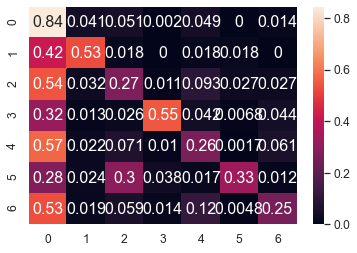

	training epoch=41 .. train_loss=0.963
	validation epoch=41 .. val_loss=1.627
	Accuracy = 42.4 % .. Percision = 52.7 % .. Recall = 43.4 % 


	*** Saved checkpoint in C:/Users/nourg/checkpoint\weights_epoch_41.pth.tar ***



  0%|                                                                                         | 0/1914 [00:00<?, ?it/s]

training @ epoch 42 .. loss = 1.075


  0%|                                                                                 | 1/1914 [00:01<48:33,  1.52s/it]

training @ epoch 42 .. loss = 0.776


  0%|                                                                                 | 2/1914 [00:03<54:49,  1.72s/it]

training @ epoch 42 .. loss = 1.065


  0%|▏                                                                                | 3/1914 [00:05<51:12,  1.61s/it]

training @ epoch 42 .. loss = 0.842


  0%|▏                                                                                | 4/1914 [00:06<48:51,  1.53s/it]

training @ epoch 42 .. loss = 0.942


  0%|▏                                                                                | 5/1914 [00:07<47:22,  1.49s/it]

training @ epoch 42 .. loss = 0.703


  0%|▎                                                                                | 6/1914 [00:09<45:47,  1.44s/it]

training @ epoch 42 .. loss = 0.925


  0%|▎                                                                                | 7/1914 [00:10<46:06,  1.45s/it]

training @ epoch 42 .. loss = 1.318


  0%|▎                                                                                | 8/1914 [00:11<45:14,  1.42s/it]

training @ epoch 42 .. loss = 0.738


  0%|▍                                                                                | 9/1914 [00:13<44:39,  1.41s/it]

training @ epoch 42 .. loss = 1.371


  1%|▍                                                                               | 10/1914 [00:14<45:14,  1.43s/it]

training @ epoch 42 .. loss = 0.988


  1%|▍                                                                               | 11/1914 [00:16<46:14,  1.46s/it]

training @ epoch 42 .. loss = 1.021


  1%|▌                                                                               | 12/1914 [00:17<47:36,  1.50s/it]

training @ epoch 42 .. loss = 0.477


  1%|▌                                                                               | 13/1914 [00:19<48:25,  1.53s/it]

training @ epoch 42 .. loss = 0.77


  1%|▌                                                                               | 14/1914 [00:21<48:58,  1.55s/it]

training @ epoch 42 .. loss = 0.875


  1%|▋                                                                               | 15/1914 [00:22<48:51,  1.54s/it]

training @ epoch 42 .. loss = 1.019


  1%|▋                                                                               | 16/1914 [00:24<48:39,  1.54s/it]

training @ epoch 42 .. loss = 0.964


  1%|▋                                                                               | 17/1914 [00:25<48:30,  1.53s/it]

training @ epoch 42 .. loss = 1.055


  1%|▊                                                                               | 18/1914 [00:27<48:30,  1.53s/it]

training @ epoch 42 .. loss = 1.313


  1%|▊                                                                               | 19/1914 [00:28<48:45,  1.54s/it]

training @ epoch 42 .. loss = 0.977


  1%|▊                                                                               | 20/1914 [00:30<48:05,  1.52s/it]

training @ epoch 42 .. loss = 1.101


  1%|▉                                                                               | 21/1914 [00:31<48:23,  1.53s/it]

training @ epoch 42 .. loss = 0.75


  1%|▉                                                                               | 22/1914 [00:33<48:00,  1.52s/it]

training @ epoch 42 .. loss = 0.796


  1%|▉                                                                               | 23/1914 [00:34<49:03,  1.56s/it]

training @ epoch 42 .. loss = 0.718


  1%|█                                                                               | 24/1914 [00:36<49:30,  1.57s/it]

training @ epoch 42 .. loss = 0.918


  1%|█                                                                               | 25/1914 [00:38<48:57,  1.56s/it]

training @ epoch 42 .. loss = 1.025


  1%|█                                                                               | 26/1914 [00:39<49:12,  1.56s/it]

training @ epoch 42 .. loss = 0.838


  1%|█▏                                                                              | 27/1914 [00:41<48:36,  1.55s/it]

training @ epoch 42 .. loss = 1.221


  1%|█▏                                                                              | 28/1914 [00:42<48:14,  1.53s/it]

training @ epoch 42 .. loss = 0.993


  2%|█▏                                                                              | 29/1914 [00:44<48:25,  1.54s/it]

training @ epoch 42 .. loss = 1.063


  2%|█▎                                                                              | 30/1914 [00:45<46:43,  1.49s/it]

training @ epoch 42 .. loss = 1.09


  2%|█▎                                                                              | 31/1914 [00:46<45:15,  1.44s/it]

training @ epoch 42 .. loss = 0.756


  2%|█▎                                                                              | 32/1914 [00:48<44:06,  1.41s/it]

training @ epoch 42 .. loss = 0.965


  2%|█▍                                                                              | 33/1914 [00:49<43:07,  1.38s/it]

training @ epoch 42 .. loss = 0.975


  2%|█▍                                                                              | 34/1914 [00:50<43:22,  1.38s/it]

training @ epoch 42 .. loss = 0.743


  2%|█▍                                                                              | 35/1914 [00:52<42:41,  1.36s/it]

training @ epoch 42 .. loss = 1.62


  2%|█▌                                                                              | 36/1914 [00:53<42:35,  1.36s/it]

training @ epoch 42 .. loss = 0.808


  2%|█▌                                                                              | 37/1914 [00:55<42:35,  1.36s/it]

training @ epoch 42 .. loss = 0.717


  2%|█▌                                                                              | 38/1914 [00:56<42:30,  1.36s/it]

training @ epoch 42 .. loss = 0.982


  2%|█▋                                                                              | 39/1914 [00:57<44:36,  1.43s/it]

training @ epoch 42 .. loss = 1.048


  2%|█▋                                                                              | 40/1914 [00:59<46:35,  1.49s/it]

training @ epoch 42 .. loss = 1.059


  2%|█▋                                                                              | 41/1914 [01:01<46:28,  1.49s/it]

training @ epoch 42 .. loss = 0.803


  2%|█▊                                                                              | 42/1914 [01:02<46:31,  1.49s/it]

training @ epoch 42 .. loss = 1.098


  2%|█▊                                                                              | 43/1914 [01:03<45:07,  1.45s/it]

training @ epoch 42 .. loss = 0.809


  2%|█▊                                                                              | 44/1914 [01:05<44:42,  1.43s/it]

training @ epoch 42 .. loss = 0.898


  2%|█▉                                                                              | 45/1914 [01:06<44:00,  1.41s/it]

training @ epoch 42 .. loss = 1.004


  2%|█▉                                                                              | 46/1914 [01:08<43:10,  1.39s/it]

training @ epoch 42 .. loss = 0.82


  2%|█▉                                                                              | 47/1914 [01:09<42:56,  1.38s/it]

training @ epoch 42 .. loss = 1.085


  3%|██                                                                              | 48/1914 [01:10<42:18,  1.36s/it]

training @ epoch 42 .. loss = 0.581


  3%|██                                                                              | 49/1914 [01:12<42:42,  1.37s/it]

training @ epoch 42 .. loss = 1.834


  3%|██                                                                              | 50/1914 [01:13<42:46,  1.38s/it]

training @ epoch 42 .. loss = 0.998


  3%|██▏                                                                             | 51/1914 [01:14<42:27,  1.37s/it]

training @ epoch 42 .. loss = 0.692


  3%|██▏                                                                             | 52/1914 [01:16<42:07,  1.36s/it]

training @ epoch 42 .. loss = 1.14


  3%|██▏                                                                             | 53/1914 [01:17<41:58,  1.35s/it]

training @ epoch 42 .. loss = 0.395


  3%|██▎                                                                             | 54/1914 [01:18<42:13,  1.36s/it]

training @ epoch 42 .. loss = 0.9


  3%|██▎                                                                             | 55/1914 [01:20<41:58,  1.35s/it]

training @ epoch 42 .. loss = 0.575


  3%|██▎                                                                             | 56/1914 [01:21<41:45,  1.35s/it]

training @ epoch 42 .. loss = 1.145


  3%|██▍                                                                             | 57/1914 [01:22<41:24,  1.34s/it]

training @ epoch 42 .. loss = 0.967


  3%|██▍                                                                             | 58/1914 [01:24<41:13,  1.33s/it]

training @ epoch 42 .. loss = 0.94


  3%|██▍                                                                             | 59/1914 [01:25<42:05,  1.36s/it]

training @ epoch 42 .. loss = 1.031


  3%|██▌                                                                             | 60/1914 [01:26<41:31,  1.34s/it]

training @ epoch 42 .. loss = 0.698


  3%|██▌                                                                             | 61/1914 [01:28<41:35,  1.35s/it]

training @ epoch 42 .. loss = 0.693


  3%|██▌                                                                             | 62/1914 [01:29<41:43,  1.35s/it]

training @ epoch 42 .. loss = 0.842


  3%|██▋                                                                             | 63/1914 [01:30<41:20,  1.34s/it]

training @ epoch 42 .. loss = 1.267


  3%|██▋                                                                             | 64/1914 [01:32<41:51,  1.36s/it]

training @ epoch 42 .. loss = 1.076


  3%|██▋                                                                             | 65/1914 [01:33<42:04,  1.37s/it]

training @ epoch 42 .. loss = 0.731


  3%|██▊                                                                             | 66/1914 [01:34<41:06,  1.33s/it]

training @ epoch 42 .. loss = 0.983


  4%|██▊                                                                             | 67/1914 [01:36<41:16,  1.34s/it]

training @ epoch 42 .. loss = 1.076


  4%|██▊                                                                             | 68/1914 [01:37<41:44,  1.36s/it]

training @ epoch 42 .. loss = 0.906


  4%|██▉                                                                             | 69/1914 [01:39<41:59,  1.37s/it]

training @ epoch 42 .. loss = 1.113


  4%|██▉                                                                             | 70/1914 [01:40<42:02,  1.37s/it]

training @ epoch 42 .. loss = 0.946


  4%|██▉                                                                             | 71/1914 [01:41<41:25,  1.35s/it]

training @ epoch 42 .. loss = 0.784


  4%|███                                                                             | 72/1914 [01:43<41:15,  1.34s/it]

training @ epoch 42 .. loss = 0.524


  4%|███                                                                             | 73/1914 [01:44<41:14,  1.34s/it]

training @ epoch 42 .. loss = 0.559


  4%|███                                                                             | 74/1914 [01:45<42:03,  1.37s/it]

training @ epoch 42 .. loss = 1.261


  4%|███▏                                                                            | 75/1914 [01:47<41:50,  1.37s/it]

training @ epoch 42 .. loss = 1.028


  4%|███▏                                                                            | 76/1914 [01:48<41:11,  1.34s/it]

training @ epoch 42 .. loss = 1.055


  4%|███▏                                                                            | 77/1914 [01:49<41:54,  1.37s/it]

training @ epoch 42 .. loss = 0.594


  4%|███▎                                                                            | 78/1914 [01:51<42:07,  1.38s/it]

training @ epoch 42 .. loss = 1.608


  4%|███▎                                                                            | 79/1914 [01:52<42:11,  1.38s/it]

training @ epoch 42 .. loss = 1.499


  4%|███▎                                                                            | 80/1914 [01:54<42:22,  1.39s/it]

training @ epoch 42 .. loss = 1.157


  4%|███▍                                                                            | 81/1914 [01:55<41:53,  1.37s/it]

training @ epoch 42 .. loss = 0.757


  4%|███▍                                                                            | 82/1914 [01:56<41:48,  1.37s/it]

training @ epoch 42 .. loss = 1.317


  4%|███▍                                                                            | 83/1914 [01:58<41:27,  1.36s/it]

training @ epoch 42 .. loss = 1.179


  4%|███▌                                                                            | 84/1914 [01:59<41:58,  1.38s/it]

training @ epoch 42 .. loss = 1.18


  4%|███▌                                                                            | 85/1914 [02:00<41:11,  1.35s/it]

training @ epoch 42 .. loss = 1.016


  4%|███▌                                                                            | 86/1914 [02:02<41:21,  1.36s/it]

training @ epoch 42 .. loss = 0.87


  5%|███▋                                                                            | 87/1914 [02:03<41:01,  1.35s/it]

training @ epoch 42 .. loss = 0.958


  5%|███▋                                                                            | 88/1914 [02:04<41:04,  1.35s/it]

training @ epoch 42 .. loss = 1.112


  5%|███▋                                                                            | 89/1914 [02:06<41:18,  1.36s/it]

training @ epoch 42 .. loss = 0.777


  5%|███▊                                                                            | 90/1914 [02:07<41:10,  1.35s/it]

training @ epoch 42 .. loss = 0.859


  5%|███▊                                                                            | 91/1914 [02:09<41:03,  1.35s/it]

training @ epoch 42 .. loss = 0.901


  5%|███▊                                                                            | 92/1914 [02:10<40:35,  1.34s/it]

training @ epoch 42 .. loss = 1.084


  5%|███▉                                                                            | 93/1914 [02:11<40:44,  1.34s/it]

training @ epoch 42 .. loss = 1.047


  5%|███▉                                                                            | 94/1914 [02:13<41:28,  1.37s/it]

training @ epoch 42 .. loss = 0.654


  5%|███▉                                                                            | 95/1914 [02:14<40:52,  1.35s/it]

training @ epoch 42 .. loss = 0.542


  5%|████                                                                            | 96/1914 [02:15<41:04,  1.36s/it]

training @ epoch 42 .. loss = 0.768


  5%|████                                                                            | 97/1914 [02:17<41:02,  1.36s/it]

training @ epoch 42 .. loss = 0.748


  5%|████                                                                            | 98/1914 [02:18<40:31,  1.34s/it]

training @ epoch 42 .. loss = 1.328


  5%|████▏                                                                           | 99/1914 [02:19<41:46,  1.38s/it]

training @ epoch 42 .. loss = 0.863


  5%|████▏                                                                          | 100/1914 [02:21<42:14,  1.40s/it]

training @ epoch 42 .. loss = 0.515


  5%|████▏                                                                          | 101/1914 [02:22<41:10,  1.36s/it]

training @ epoch 42 .. loss = 0.649


  5%|████▏                                                                          | 102/1914 [02:23<40:59,  1.36s/it]

training @ epoch 42 .. loss = 0.911


  5%|████▎                                                                          | 103/1914 [02:25<41:18,  1.37s/it]

training @ epoch 42 .. loss = 0.997


  5%|████▎                                                                          | 104/1914 [02:26<41:37,  1.38s/it]

training @ epoch 42 .. loss = 0.77


  5%|████▎                                                                          | 105/1914 [02:28<41:28,  1.38s/it]

training @ epoch 42 .. loss = 1.359


  6%|████▍                                                                          | 106/1914 [02:29<41:03,  1.36s/it]

training @ epoch 42 .. loss = 0.644


  6%|████▍                                                                          | 107/1914 [02:30<40:08,  1.33s/it]

training @ epoch 42 .. loss = 1.024


  6%|████▍                                                                          | 108/1914 [02:32<40:18,  1.34s/it]

training @ epoch 42 .. loss = 1.157


  6%|████▍                                                                          | 109/1914 [02:33<40:42,  1.35s/it]

training @ epoch 42 .. loss = 1.088


  6%|████▌                                                                          | 110/1914 [02:34<40:19,  1.34s/it]

training @ epoch 42 .. loss = 1.238


  6%|████▌                                                                          | 111/1914 [02:36<40:24,  1.34s/it]

training @ epoch 42 .. loss = 0.852


  6%|████▌                                                                          | 112/1914 [02:37<40:34,  1.35s/it]

training @ epoch 42 .. loss = 0.927


  6%|████▋                                                                          | 113/1914 [02:38<39:50,  1.33s/it]

training @ epoch 42 .. loss = 1.002


  6%|████▋                                                                          | 114/1914 [02:40<41:09,  1.37s/it]

training @ epoch 42 .. loss = 0.763


  6%|████▋                                                                          | 115/1914 [02:41<41:15,  1.38s/it]

training @ epoch 42 .. loss = 0.803


  6%|████▊                                                                          | 116/1914 [02:42<40:22,  1.35s/it]

training @ epoch 42 .. loss = 1.08


  6%|████▊                                                                          | 117/1914 [02:44<40:41,  1.36s/it]

training @ epoch 42 .. loss = 0.807


  6%|████▊                                                                          | 118/1914 [02:45<40:49,  1.36s/it]

training @ epoch 42 .. loss = 0.471


  6%|████▉                                                                          | 119/1914 [02:47<42:42,  1.43s/it]

training @ epoch 42 .. loss = 1.412


  6%|████▉                                                                          | 120/1914 [02:48<42:16,  1.41s/it]

training @ epoch 42 .. loss = 1.159


  6%|████▉                                                                          | 121/1914 [02:50<41:38,  1.39s/it]

training @ epoch 42 .. loss = 0.78


  6%|█████                                                                          | 122/1914 [02:51<41:36,  1.39s/it]

training @ epoch 42 .. loss = 0.749


  6%|█████                                                                          | 123/1914 [02:52<40:31,  1.36s/it]

training @ epoch 42 .. loss = 1.096


  6%|█████                                                                          | 124/1914 [02:54<40:45,  1.37s/it]

training @ epoch 42 .. loss = 0.872


  7%|█████▏                                                                         | 125/1914 [02:55<41:09,  1.38s/it]

training @ epoch 42 .. loss = 0.81


  7%|█████▏                                                                         | 126/1914 [02:56<40:05,  1.35s/it]

training @ epoch 42 .. loss = 0.541


  7%|█████▏                                                                         | 127/1914 [02:58<39:36,  1.33s/it]

training @ epoch 42 .. loss = 0.806


  7%|█████▎                                                                         | 128/1914 [02:59<39:53,  1.34s/it]

training @ epoch 42 .. loss = 0.504


  7%|█████▎                                                                         | 129/1914 [03:00<40:32,  1.36s/it]

training @ epoch 42 .. loss = 0.88


  7%|█████▎                                                                         | 130/1914 [03:02<42:12,  1.42s/it]

training @ epoch 42 .. loss = 1.619


  7%|█████▍                                                                         | 131/1914 [03:03<41:37,  1.40s/it]

training @ epoch 42 .. loss = 1.204


  7%|█████▍                                                                         | 132/1914 [03:05<40:59,  1.38s/it]

training @ epoch 42 .. loss = 0.523


  7%|█████▍                                                                         | 133/1914 [03:06<40:28,  1.36s/it]

training @ epoch 42 .. loss = 0.96


  7%|█████▌                                                                         | 134/1914 [03:07<40:06,  1.35s/it]

training @ epoch 42 .. loss = 1.357


  7%|█████▌                                                                         | 135/1914 [03:09<40:33,  1.37s/it]

training @ epoch 42 .. loss = 1.245


  7%|█████▌                                                                         | 136/1914 [03:10<40:19,  1.36s/it]

training @ epoch 42 .. loss = 1.085


  7%|█████▋                                                                         | 137/1914 [03:11<40:07,  1.36s/it]

training @ epoch 42 .. loss = 0.989


  7%|█████▋                                                                         | 138/1914 [03:13<40:07,  1.36s/it]

training @ epoch 42 .. loss = 0.899


  7%|█████▋                                                                         | 139/1914 [03:14<39:31,  1.34s/it]

training @ epoch 42 .. loss = 0.893


  7%|█████▊                                                                         | 140/1914 [03:15<40:23,  1.37s/it]

training @ epoch 42 .. loss = 0.662


  7%|█████▊                                                                         | 141/1914 [03:17<40:00,  1.35s/it]

training @ epoch 42 .. loss = 0.916


  7%|█████▊                                                                         | 142/1914 [03:18<39:19,  1.33s/it]

training @ epoch 42 .. loss = 1.102


  7%|█████▉                                                                         | 143/1914 [03:19<39:52,  1.35s/it]

training @ epoch 42 .. loss = 0.623


  8%|█████▉                                                                         | 144/1914 [03:21<40:03,  1.36s/it]

training @ epoch 42 .. loss = 0.867


  8%|█████▉                                                                         | 145/1914 [03:22<39:59,  1.36s/it]

training @ epoch 42 .. loss = 0.856


  8%|██████                                                                         | 146/1914 [03:23<39:47,  1.35s/it]

training @ epoch 42 .. loss = 1.368


  8%|██████                                                                         | 147/1914 [03:25<39:42,  1.35s/it]

training @ epoch 42 .. loss = 0.72


  8%|██████                                                                         | 148/1914 [03:26<39:06,  1.33s/it]

training @ epoch 42 .. loss = 0.789


  8%|██████▏                                                                        | 149/1914 [03:27<39:18,  1.34s/it]

training @ epoch 42 .. loss = 0.679


  8%|██████▏                                                                        | 150/1914 [03:29<39:31,  1.34s/it]

training @ epoch 42 .. loss = 0.833


  8%|██████▏                                                                        | 151/1914 [03:30<39:29,  1.34s/it]

training @ epoch 42 .. loss = 0.556


  8%|██████▎                                                                        | 152/1914 [03:31<39:33,  1.35s/it]

training @ epoch 42 .. loss = 1.165


  8%|██████▎                                                                        | 153/1914 [03:33<39:20,  1.34s/it]

training @ epoch 42 .. loss = 1.209


  8%|██████▎                                                                        | 154/1914 [03:34<38:59,  1.33s/it]

training @ epoch 42 .. loss = 0.879


  8%|██████▍                                                                        | 155/1914 [03:36<39:38,  1.35s/it]

training @ epoch 42 .. loss = 0.935


  8%|██████▍                                                                        | 156/1914 [03:37<41:13,  1.41s/it]

training @ epoch 42 .. loss = 0.842


  8%|██████▍                                                                        | 157/1914 [03:38<41:15,  1.41s/it]

training @ epoch 42 .. loss = 1.339


  8%|██████▌                                                                        | 158/1914 [03:40<40:51,  1.40s/it]

training @ epoch 42 .. loss = 0.885


  8%|██████▌                                                                        | 159/1914 [03:41<42:19,  1.45s/it]

training @ epoch 42 .. loss = 1.126


  8%|██████▌                                                                        | 160/1914 [03:43<41:39,  1.43s/it]

training @ epoch 42 .. loss = 1.425


  8%|██████▋                                                                        | 161/1914 [03:44<42:20,  1.45s/it]

training @ epoch 42 .. loss = 1.161


  8%|██████▋                                                                        | 162/1914 [03:46<41:29,  1.42s/it]

training @ epoch 42 .. loss = 0.953


  9%|██████▋                                                                        | 163/1914 [03:47<41:41,  1.43s/it]

training @ epoch 42 .. loss = 0.773


  9%|██████▊                                                                        | 164/1914 [03:49<41:42,  1.43s/it]

training @ epoch 42 .. loss = 0.572


  9%|██████▊                                                                        | 165/1914 [03:50<41:29,  1.42s/it]

training @ epoch 42 .. loss = 0.735


  9%|██████▊                                                                        | 166/1914 [03:51<41:27,  1.42s/it]

training @ epoch 42 .. loss = 0.856


  9%|██████▉                                                                        | 167/1914 [03:53<40:46,  1.40s/it]

training @ epoch 42 .. loss = 1.002


  9%|██████▉                                                                        | 168/1914 [03:54<39:42,  1.36s/it]

training @ epoch 42 .. loss = 1.158


  9%|██████▉                                                                        | 169/1914 [03:55<40:40,  1.40s/it]

training @ epoch 42 .. loss = 0.758


  9%|███████                                                                        | 170/1914 [03:57<40:42,  1.40s/it]

training @ epoch 42 .. loss = 1.099


  9%|███████                                                                        | 171/1914 [03:58<40:27,  1.39s/it]

training @ epoch 42 .. loss = 0.775


  9%|███████                                                                        | 172/1914 [04:00<40:14,  1.39s/it]

training @ epoch 42 .. loss = 1.072


  9%|███████▏                                                                       | 173/1914 [04:01<39:57,  1.38s/it]

training @ epoch 42 .. loss = 1.027


  9%|███████▏                                                                       | 174/1914 [04:02<40:58,  1.41s/it]

training @ epoch 42 .. loss = 1.036


  9%|███████▏                                                                       | 175/1914 [04:04<41:19,  1.43s/it]

training @ epoch 42 .. loss = 1.065


  9%|███████▎                                                                       | 176/1914 [04:05<40:44,  1.41s/it]

training @ epoch 42 .. loss = 0.719


  9%|███████▎                                                                       | 177/1914 [04:07<39:55,  1.38s/it]

training @ epoch 42 .. loss = 0.878


  9%|███████▎                                                                       | 178/1914 [04:08<39:14,  1.36s/it]

training @ epoch 42 .. loss = 1.01


  9%|███████▍                                                                       | 179/1914 [04:09<39:37,  1.37s/it]

training @ epoch 42 .. loss = 0.675


  9%|███████▍                                                                       | 180/1914 [04:11<39:55,  1.38s/it]

training @ epoch 42 .. loss = 0.754


  9%|███████▍                                                                       | 181/1914 [04:12<39:19,  1.36s/it]

training @ epoch 42 .. loss = 0.923


 10%|███████▌                                                                       | 182/1914 [04:13<39:23,  1.36s/it]

training @ epoch 42 .. loss = 1.039


 10%|███████▌                                                                       | 183/1914 [04:15<39:12,  1.36s/it]

training @ epoch 42 .. loss = 0.99


 10%|███████▌                                                                       | 184/1914 [04:16<38:47,  1.35s/it]

training @ epoch 42 .. loss = 1.114


 10%|███████▋                                                                       | 185/1914 [04:17<39:10,  1.36s/it]

training @ epoch 42 .. loss = 1.257


 10%|███████▋                                                                       | 186/1914 [04:19<39:07,  1.36s/it]

training @ epoch 42 .. loss = 0.574


 10%|███████▋                                                                       | 187/1914 [04:20<38:27,  1.34s/it]

training @ epoch 42 .. loss = 1.38


 10%|███████▊                                                                       | 188/1914 [04:21<38:40,  1.34s/it]

training @ epoch 42 .. loss = 1.01


 10%|███████▊                                                                       | 189/1914 [04:23<39:09,  1.36s/it]

training @ epoch 42 .. loss = 0.783


 10%|███████▊                                                                       | 190/1914 [04:24<39:15,  1.37s/it]

training @ epoch 42 .. loss = 0.999


 10%|███████▉                                                                       | 191/1914 [04:26<38:53,  1.35s/it]

training @ epoch 42 .. loss = 0.947


 10%|███████▉                                                                       | 192/1914 [04:27<39:02,  1.36s/it]

training @ epoch 42 .. loss = 1.474


 10%|███████▉                                                                       | 193/1914 [04:28<39:03,  1.36s/it]

training @ epoch 42 .. loss = 1.015


 10%|████████                                                                       | 194/1914 [04:30<39:03,  1.36s/it]

training @ epoch 42 .. loss = 0.841


 10%|████████                                                                       | 195/1914 [04:31<39:24,  1.38s/it]

training @ epoch 42 .. loss = 0.628


 10%|████████                                                                       | 196/1914 [04:32<39:11,  1.37s/it]

training @ epoch 42 .. loss = 0.7


 10%|████████▏                                                                      | 197/1914 [04:34<38:56,  1.36s/it]

training @ epoch 42 .. loss = 1.25


 10%|████████▏                                                                      | 198/1914 [04:35<38:32,  1.35s/it]

training @ epoch 42 .. loss = 0.617


 10%|████████▏                                                                      | 199/1914 [04:36<38:55,  1.36s/it]

training @ epoch 42 .. loss = 0.92


 10%|████████▎                                                                      | 200/1914 [04:38<38:54,  1.36s/it]

training @ epoch 42 .. loss = 0.795


 11%|████████▎                                                                      | 201/1914 [04:39<39:52,  1.40s/it]

training @ epoch 42 .. loss = 0.792


 11%|████████▎                                                                      | 202/1914 [04:41<39:49,  1.40s/it]

training @ epoch 42 .. loss = 0.976


 11%|████████▍                                                                      | 203/1914 [04:42<39:58,  1.40s/it]

training @ epoch 42 .. loss = 1.34


 11%|████████▍                                                                      | 204/1914 [04:44<39:58,  1.40s/it]

training @ epoch 42 .. loss = 1.061


 11%|████████▍                                                                      | 205/1914 [04:45<39:21,  1.38s/it]

training @ epoch 42 .. loss = 1.054


 11%|████████▌                                                                      | 206/1914 [04:46<38:33,  1.35s/it]

training @ epoch 42 .. loss = 0.964


 11%|████████▌                                                                      | 207/1914 [04:47<38:26,  1.35s/it]

training @ epoch 42 .. loss = 0.557


 11%|████████▌                                                                      | 208/1914 [04:49<38:17,  1.35s/it]

training @ epoch 42 .. loss = 0.829


 11%|████████▋                                                                      | 209/1914 [04:50<39:01,  1.37s/it]

training @ epoch 42 .. loss = 0.454


 11%|████████▋                                                                      | 210/1914 [04:52<39:00,  1.37s/it]

training @ epoch 42 .. loss = 0.856


 11%|████████▋                                                                      | 211/1914 [04:53<38:39,  1.36s/it]

training @ epoch 42 .. loss = 1.365


 11%|████████▊                                                                      | 212/1914 [04:54<38:58,  1.37s/it]

training @ epoch 42 .. loss = 0.919


 11%|████████▊                                                                      | 213/1914 [04:56<38:47,  1.37s/it]

training @ epoch 42 .. loss = 0.641


 11%|████████▊                                                                      | 214/1914 [04:57<39:19,  1.39s/it]

training @ epoch 42 .. loss = 1.084


 11%|████████▊                                                                      | 215/1914 [04:58<38:26,  1.36s/it]

training @ epoch 42 .. loss = 1.175


 11%|████████▉                                                                      | 216/1914 [05:00<38:12,  1.35s/it]

training @ epoch 42 .. loss = 0.987


 11%|████████▉                                                                      | 217/1914 [05:01<38:28,  1.36s/it]

training @ epoch 42 .. loss = 0.72


 11%|████████▉                                                                      | 218/1914 [05:03<38:23,  1.36s/it]

training @ epoch 42 .. loss = 1.078


 11%|█████████                                                                      | 219/1914 [05:04<38:21,  1.36s/it]

training @ epoch 42 .. loss = 1.141


 11%|█████████                                                                      | 220/1914 [05:05<38:22,  1.36s/it]

training @ epoch 42 .. loss = 1.031


 12%|█████████                                                                      | 221/1914 [05:07<38:09,  1.35s/it]

training @ epoch 42 .. loss = 1.155


 12%|█████████▏                                                                     | 222/1914 [05:08<37:59,  1.35s/it]

training @ epoch 42 .. loss = 0.739


 12%|█████████▏                                                                     | 223/1914 [05:09<38:01,  1.35s/it]

training @ epoch 42 .. loss = 0.956


 12%|█████████▏                                                                     | 224/1914 [05:11<38:28,  1.37s/it]

training @ epoch 42 .. loss = 0.82


 12%|█████████▎                                                                     | 225/1914 [05:12<37:50,  1.34s/it]

training @ epoch 42 .. loss = 0.814


 12%|█████████▎                                                                     | 226/1914 [05:13<38:09,  1.36s/it]

training @ epoch 42 .. loss = 0.841


 12%|█████████▎                                                                     | 227/1914 [05:15<38:01,  1.35s/it]

training @ epoch 42 .. loss = 1.307


 12%|█████████▍                                                                     | 228/1914 [05:16<37:56,  1.35s/it]

training @ epoch 42 .. loss = 0.814


 12%|█████████▍                                                                     | 229/1914 [05:17<38:38,  1.38s/it]

training @ epoch 42 .. loss = 1.315


 12%|█████████▍                                                                     | 230/1914 [05:19<38:36,  1.38s/it]

training @ epoch 42 .. loss = 0.887


 12%|█████████▌                                                                     | 231/1914 [05:20<38:38,  1.38s/it]

training @ epoch 42 .. loss = 0.771


 12%|█████████▌                                                                     | 232/1914 [05:22<38:26,  1.37s/it]

training @ epoch 42 .. loss = 0.893


 12%|█████████▌                                                                     | 233/1914 [05:23<38:11,  1.36s/it]

training @ epoch 42 .. loss = 0.892


 12%|█████████▋                                                                     | 234/1914 [05:24<38:16,  1.37s/it]

training @ epoch 42 .. loss = 1.117


 12%|█████████▋                                                                     | 235/1914 [05:26<37:53,  1.35s/it]

training @ epoch 42 .. loss = 0.835


 12%|█████████▋                                                                     | 236/1914 [05:27<37:51,  1.35s/it]

training @ epoch 42 .. loss = 0.996


 12%|█████████▊                                                                     | 237/1914 [05:28<37:55,  1.36s/it]

training @ epoch 42 .. loss = 0.773


 12%|█████████▊                                                                     | 238/1914 [05:30<37:56,  1.36s/it]

training @ epoch 42 .. loss = 0.814


 12%|█████████▊                                                                     | 239/1914 [05:31<38:09,  1.37s/it]

training @ epoch 42 .. loss = 0.541


 13%|█████████▉                                                                     | 240/1914 [05:32<37:46,  1.35s/it]

training @ epoch 42 .. loss = 0.817


 13%|█████████▉                                                                     | 241/1914 [05:34<37:35,  1.35s/it]

training @ epoch 42 .. loss = 0.44


 13%|█████████▉                                                                     | 242/1914 [05:35<38:00,  1.36s/it]

training @ epoch 42 .. loss = 0.78


 13%|██████████                                                                     | 243/1914 [05:37<38:10,  1.37s/it]

training @ epoch 42 .. loss = 0.99


 13%|██████████                                                                     | 244/1914 [05:38<38:11,  1.37s/it]

training @ epoch 42 .. loss = 0.869


 13%|██████████                                                                     | 245/1914 [05:39<38:16,  1.38s/it]

training @ epoch 42 .. loss = 1.032


 13%|██████████▏                                                                    | 246/1914 [05:41<38:04,  1.37s/it]

training @ epoch 42 .. loss = 1.51


 13%|██████████▏                                                                    | 247/1914 [05:42<37:55,  1.36s/it]

training @ epoch 42 .. loss = 1.423


 13%|██████████▏                                                                    | 248/1914 [05:43<38:19,  1.38s/it]

training @ epoch 42 .. loss = 1.085


 13%|██████████▎                                                                    | 249/1914 [05:45<38:15,  1.38s/it]

training @ epoch 42 .. loss = 1.021


 13%|██████████▎                                                                    | 250/1914 [05:46<37:36,  1.36s/it]

training @ epoch 42 .. loss = 0.85


 13%|██████████▎                                                                    | 251/1914 [05:47<37:44,  1.36s/it]

training @ epoch 42 .. loss = 0.821


 13%|██████████▍                                                                    | 252/1914 [05:49<37:39,  1.36s/it]

training @ epoch 42 .. loss = 0.814


 13%|██████████▍                                                                    | 253/1914 [05:50<37:40,  1.36s/it]

training @ epoch 42 .. loss = 1.075


 13%|██████████▍                                                                    | 254/1914 [05:52<37:45,  1.36s/it]

training @ epoch 42 .. loss = 1.083


 13%|██████████▌                                                                    | 255/1914 [05:53<38:19,  1.39s/it]

training @ epoch 42 .. loss = 0.945


 13%|██████████▌                                                                    | 256/1914 [05:54<38:07,  1.38s/it]

training @ epoch 42 .. loss = 1.256


 13%|██████████▌                                                                    | 257/1914 [05:56<37:38,  1.36s/it]

training @ epoch 42 .. loss = 1.049


 13%|██████████▋                                                                    | 258/1914 [05:57<37:57,  1.38s/it]

training @ epoch 42 .. loss = 0.648


 14%|██████████▋                                                                    | 259/1914 [05:58<37:51,  1.37s/it]

training @ epoch 42 .. loss = 0.827


 14%|██████████▋                                                                    | 260/1914 [06:00<37:56,  1.38s/it]

training @ epoch 42 .. loss = 1.276


 14%|██████████▊                                                                    | 261/1914 [06:01<38:46,  1.41s/it]

training @ epoch 42 .. loss = 1.195


 14%|██████████▊                                                                    | 262/1914 [06:03<38:44,  1.41s/it]

training @ epoch 42 .. loss = 0.931


 14%|██████████▊                                                                    | 263/1914 [06:04<38:41,  1.41s/it]

training @ epoch 42 .. loss = 1.302


 14%|██████████▉                                                                    | 264/1914 [06:05<38:10,  1.39s/it]

training @ epoch 42 .. loss = 0.742


 14%|██████████▉                                                                    | 265/1914 [06:07<37:52,  1.38s/it]

training @ epoch 42 .. loss = 1.153


 14%|██████████▉                                                                    | 266/1914 [06:08<38:08,  1.39s/it]

training @ epoch 42 .. loss = 1.089


 14%|███████████                                                                    | 267/1914 [06:10<38:04,  1.39s/it]

training @ epoch 42 .. loss = 0.654


 14%|███████████                                                                    | 268/1914 [06:11<39:16,  1.43s/it]

training @ epoch 42 .. loss = 0.807


 14%|███████████                                                                    | 269/1914 [06:13<39:02,  1.42s/it]

training @ epoch 42 .. loss = 0.69


 14%|███████████▏                                                                   | 270/1914 [06:14<38:31,  1.41s/it]

training @ epoch 42 .. loss = 0.464


 14%|███████████▏                                                                   | 271/1914 [06:15<38:52,  1.42s/it]

training @ epoch 42 .. loss = 0.934


 14%|███████████▏                                                                   | 272/1914 [06:17<38:23,  1.40s/it]

training @ epoch 42 .. loss = 1.196


 14%|███████████▎                                                                   | 273/1914 [06:18<38:44,  1.42s/it]

training @ epoch 42 .. loss = 1.36


 14%|███████████▎                                                                   | 274/1914 [06:20<38:07,  1.39s/it]

training @ epoch 42 .. loss = 0.874


 14%|███████████▎                                                                   | 275/1914 [06:21<37:44,  1.38s/it]

training @ epoch 42 .. loss = 0.727


 14%|███████████▍                                                                   | 276/1914 [06:22<37:46,  1.38s/it]

training @ epoch 42 .. loss = 1.031


 14%|███████████▍                                                                   | 277/1914 [06:24<37:35,  1.38s/it]

training @ epoch 42 .. loss = 1.086


 15%|███████████▍                                                                   | 278/1914 [06:25<38:07,  1.40s/it]

training @ epoch 42 .. loss = 0.85


 15%|███████████▌                                                                   | 279/1914 [06:26<37:29,  1.38s/it]

training @ epoch 42 .. loss = 0.797


 15%|███████████▌                                                                   | 280/1914 [06:28<37:02,  1.36s/it]

training @ epoch 42 .. loss = 0.874


 15%|███████████▌                                                                   | 281/1914 [06:29<36:50,  1.35s/it]

training @ epoch 42 .. loss = 0.968


 15%|███████████▋                                                                   | 282/1914 [06:30<36:51,  1.35s/it]

training @ epoch 42 .. loss = 1.918


 15%|███████████▋                                                                   | 283/1914 [06:32<37:05,  1.36s/it]

training @ epoch 42 .. loss = 0.819


 15%|███████████▋                                                                   | 284/1914 [06:33<37:04,  1.36s/it]

training @ epoch 42 .. loss = 1.434


 15%|███████████▊                                                                   | 285/1914 [06:35<36:53,  1.36s/it]

training @ epoch 42 .. loss = 0.793


 15%|███████████▊                                                                   | 286/1914 [06:36<36:28,  1.34s/it]

training @ epoch 42 .. loss = 1.121


 15%|███████████▊                                                                   | 287/1914 [06:37<36:37,  1.35s/it]

training @ epoch 42 .. loss = 0.713


 15%|███████████▉                                                                   | 288/1914 [06:39<36:47,  1.36s/it]

training @ epoch 42 .. loss = 1.077


 15%|███████████▉                                                                   | 289/1914 [06:40<36:44,  1.36s/it]

training @ epoch 42 .. loss = 0.521


 15%|███████████▉                                                                   | 290/1914 [06:41<37:01,  1.37s/it]

training @ epoch 42 .. loss = 1.247


 15%|████████████                                                                   | 291/1914 [06:43<37:22,  1.38s/it]

training @ epoch 42 .. loss = 1.075


 15%|████████████                                                                   | 292/1914 [06:44<36:53,  1.36s/it]

training @ epoch 42 .. loss = 0.966


 15%|████████████                                                                   | 293/1914 [06:45<37:21,  1.38s/it]

training @ epoch 42 .. loss = 1.363


 15%|████████████▏                                                                  | 294/1914 [06:47<36:46,  1.36s/it]

training @ epoch 42 .. loss = 0.86


 15%|████████████▏                                                                  | 295/1914 [06:48<37:16,  1.38s/it]

training @ epoch 42 .. loss = 0.724


 15%|████████████▏                                                                  | 296/1914 [06:50<37:01,  1.37s/it]

training @ epoch 42 .. loss = 0.574


 16%|████████████▎                                                                  | 297/1914 [06:51<37:05,  1.38s/it]

training @ epoch 42 .. loss = 1.334


 16%|████████████▎                                                                  | 298/1914 [06:52<37:12,  1.38s/it]

training @ epoch 42 .. loss = 0.804


 16%|████████████▎                                                                  | 299/1914 [06:54<36:49,  1.37s/it]

training @ epoch 42 .. loss = 0.895


 16%|████████████▍                                                                  | 300/1914 [06:55<36:46,  1.37s/it]

training @ epoch 42 .. loss = 0.661


 16%|████████████▍                                                                  | 301/1914 [06:56<36:13,  1.35s/it]

training @ epoch 42 .. loss = 0.88


 16%|████████████▍                                                                  | 302/1914 [06:58<36:25,  1.36s/it]

training @ epoch 42 .. loss = 1.275


 16%|████████████▌                                                                  | 303/1914 [06:59<36:57,  1.38s/it]

training @ epoch 42 .. loss = 0.832


 16%|████████████▌                                                                  | 304/1914 [07:00<36:25,  1.36s/it]

training @ epoch 42 .. loss = 1.001


 16%|████████████▌                                                                  | 305/1914 [07:02<36:41,  1.37s/it]

training @ epoch 42 .. loss = 0.943


 16%|████████████▋                                                                  | 306/1914 [07:03<36:32,  1.36s/it]

training @ epoch 42 .. loss = 0.917


 16%|████████████▋                                                                  | 307/1914 [07:05<36:12,  1.35s/it]

training @ epoch 42 .. loss = 0.714


 16%|████████████▋                                                                  | 308/1914 [07:06<36:17,  1.36s/it]

training @ epoch 42 .. loss = 1.078


 16%|████████████▊                                                                  | 309/1914 [07:07<36:46,  1.37s/it]

training @ epoch 42 .. loss = 1.223


 16%|████████████▊                                                                  | 310/1914 [07:09<36:52,  1.38s/it]

training @ epoch 42 .. loss = 1.043


 16%|████████████▊                                                                  | 311/1914 [07:10<36:24,  1.36s/it]

training @ epoch 42 .. loss = 0.869


 16%|████████████▉                                                                  | 312/1914 [07:11<36:32,  1.37s/it]

training @ epoch 42 .. loss = 0.822


 16%|████████████▉                                                                  | 313/1914 [07:13<36:33,  1.37s/it]

training @ epoch 42 .. loss = 0.785


 16%|████████████▉                                                                  | 314/1914 [07:14<37:17,  1.40s/it]

training @ epoch 42 .. loss = 0.679


 16%|█████████████                                                                  | 315/1914 [07:16<36:36,  1.37s/it]

training @ epoch 42 .. loss = 1.049


 17%|█████████████                                                                  | 316/1914 [07:17<36:16,  1.36s/it]

training @ epoch 42 .. loss = 0.8


 17%|█████████████                                                                  | 317/1914 [07:18<36:30,  1.37s/it]

training @ epoch 42 .. loss = 0.694


 17%|█████████████▏                                                                 | 318/1914 [07:20<36:40,  1.38s/it]

training @ epoch 42 .. loss = 0.551


 17%|█████████████▏                                                                 | 319/1914 [07:21<36:42,  1.38s/it]

training @ epoch 42 .. loss = 0.922


 17%|█████████████▏                                                                 | 320/1914 [07:22<36:13,  1.36s/it]

training @ epoch 42 .. loss = 0.988


 17%|█████████████▏                                                                 | 321/1914 [07:24<36:12,  1.36s/it]

training @ epoch 42 .. loss = 0.776


 17%|█████████████▎                                                                 | 322/1914 [07:25<36:45,  1.39s/it]

training @ epoch 42 .. loss = 1.259


 17%|█████████████▎                                                                 | 323/1914 [07:27<36:19,  1.37s/it]

training @ epoch 42 .. loss = 1.126


 17%|█████████████▎                                                                 | 324/1914 [07:28<36:06,  1.36s/it]

training @ epoch 42 .. loss = 1.021


 17%|█████████████▍                                                                 | 325/1914 [07:29<36:34,  1.38s/it]

training @ epoch 42 .. loss = 0.869


 17%|█████████████▍                                                                 | 326/1914 [07:31<36:20,  1.37s/it]

training @ epoch 42 .. loss = 0.663


 17%|█████████████▍                                                                 | 327/1914 [07:32<36:24,  1.38s/it]

training @ epoch 42 .. loss = 0.877


 17%|█████████████▌                                                                 | 328/1914 [07:33<36:07,  1.37s/it]

training @ epoch 42 .. loss = 0.766


 17%|█████████████▌                                                                 | 329/1914 [07:35<35:55,  1.36s/it]

training @ epoch 42 .. loss = 0.841


 17%|█████████████▌                                                                 | 330/1914 [07:36<35:27,  1.34s/it]

training @ epoch 42 .. loss = 0.833


 17%|█████████████▋                                                                 | 331/1914 [07:37<35:36,  1.35s/it]

training @ epoch 42 .. loss = 0.838


 17%|█████████████▋                                                                 | 332/1914 [07:39<36:14,  1.37s/it]

training @ epoch 42 .. loss = 0.865


 17%|█████████████▋                                                                 | 333/1914 [07:40<35:59,  1.37s/it]

training @ epoch 42 .. loss = 0.953


 17%|█████████████▊                                                                 | 334/1914 [07:42<35:57,  1.37s/it]

training @ epoch 42 .. loss = 0.922


 18%|█████████████▊                                                                 | 335/1914 [07:43<36:05,  1.37s/it]

training @ epoch 42 .. loss = 1.438


 18%|█████████████▊                                                                 | 336/1914 [07:44<36:10,  1.38s/it]

training @ epoch 42 .. loss = 0.947


 18%|█████████████▉                                                                 | 337/1914 [07:46<36:23,  1.38s/it]

training @ epoch 42 .. loss = 1.2


 18%|█████████████▉                                                                 | 338/1914 [07:47<36:07,  1.38s/it]

training @ epoch 42 .. loss = 0.958


 18%|█████████████▉                                                                 | 339/1914 [07:48<35:32,  1.35s/it]

training @ epoch 42 .. loss = 0.912


 18%|██████████████                                                                 | 340/1914 [07:50<35:25,  1.35s/it]

training @ epoch 42 .. loss = 0.906


 18%|██████████████                                                                 | 341/1914 [07:51<35:44,  1.36s/it]

training @ epoch 42 .. loss = 1.747


 18%|██████████████                                                                 | 342/1914 [07:53<36:07,  1.38s/it]

training @ epoch 42 .. loss = 0.96


 18%|██████████████▏                                                                | 343/1914 [07:54<35:45,  1.37s/it]

training @ epoch 42 .. loss = 0.994


 18%|██████████████▏                                                                | 344/1914 [07:55<35:53,  1.37s/it]

training @ epoch 42 .. loss = 0.855


 18%|██████████████▏                                                                | 345/1914 [07:57<35:49,  1.37s/it]

training @ epoch 42 .. loss = 0.985


 18%|██████████████▎                                                                | 346/1914 [07:58<35:26,  1.36s/it]

training @ epoch 42 .. loss = 1.169


 18%|██████████████▎                                                                | 347/1914 [07:59<35:43,  1.37s/it]

training @ epoch 42 .. loss = 1.017


 18%|██████████████▎                                                                | 348/1914 [08:01<35:35,  1.36s/it]

training @ epoch 42 .. loss = 1.205


 18%|██████████████▍                                                                | 349/1914 [08:02<35:10,  1.35s/it]

training @ epoch 42 .. loss = 0.779


 18%|██████████████▍                                                                | 350/1914 [08:03<35:26,  1.36s/it]

training @ epoch 42 .. loss = 1.187


 18%|██████████████▍                                                                | 351/1914 [08:05<35:22,  1.36s/it]

training @ epoch 42 .. loss = 1.127


 18%|██████████████▌                                                                | 352/1914 [08:06<36:16,  1.39s/it]

training @ epoch 42 .. loss = 0.794


 18%|██████████████▌                                                                | 353/1914 [08:08<35:51,  1.38s/it]

training @ epoch 42 .. loss = 1.147


 18%|██████████████▌                                                                | 354/1914 [08:09<35:48,  1.38s/it]

training @ epoch 42 .. loss = 1.177


 19%|██████████████▋                                                                | 355/1914 [08:10<36:09,  1.39s/it]

training @ epoch 42 .. loss = 1.309


 19%|██████████████▋                                                                | 356/1914 [08:12<35:46,  1.38s/it]

training @ epoch 42 .. loss = 0.837


 19%|██████████████▋                                                                | 357/1914 [08:13<36:16,  1.40s/it]

training @ epoch 42 .. loss = 1.143


 19%|██████████████▊                                                                | 358/1914 [08:14<35:31,  1.37s/it]

training @ epoch 42 .. loss = 1.188


 19%|██████████████▊                                                                | 359/1914 [08:16<35:21,  1.36s/it]

training @ epoch 42 .. loss = 0.999


 19%|██████████████▊                                                                | 360/1914 [08:17<35:39,  1.38s/it]

training @ epoch 42 .. loss = 1.204


 19%|██████████████▉                                                                | 361/1914 [08:19<35:33,  1.37s/it]

training @ epoch 42 .. loss = 0.624


 19%|██████████████▉                                                                | 362/1914 [08:20<35:46,  1.38s/it]

training @ epoch 42 .. loss = 0.854


 19%|██████████████▉                                                                | 363/1914 [08:21<35:27,  1.37s/it]

training @ epoch 42 .. loss = 1.069


 19%|███████████████                                                                | 364/1914 [08:23<35:26,  1.37s/it]

training @ epoch 42 .. loss = 0.627


 19%|███████████████                                                                | 365/1914 [08:24<34:30,  1.34s/it]

training @ epoch 42 .. loss = 1.114


 19%|███████████████                                                                | 366/1914 [08:25<34:51,  1.35s/it]

training @ epoch 42 .. loss = 0.812


 19%|███████████████▏                                                               | 367/1914 [08:27<35:25,  1.37s/it]

training @ epoch 42 .. loss = 0.901


 19%|███████████████▏                                                               | 368/1914 [08:28<34:56,  1.36s/it]

training @ epoch 42 .. loss = 0.667


 19%|███████████████▏                                                               | 369/1914 [08:29<35:08,  1.36s/it]

training @ epoch 42 .. loss = 0.869


 19%|███████████████▎                                                               | 370/1914 [08:31<35:15,  1.37s/it]

training @ epoch 42 .. loss = 1.242


 19%|███████████████▎                                                               | 371/1914 [08:32<34:43,  1.35s/it]

training @ epoch 42 .. loss = 0.494


 19%|███████████████▎                                                               | 372/1914 [08:34<35:35,  1.38s/it]

training @ epoch 42 .. loss = 0.694


 19%|███████████████▍                                                               | 373/1914 [08:35<35:20,  1.38s/it]

training @ epoch 42 .. loss = 1.068


 20%|███████████████▍                                                               | 374/1914 [08:36<34:55,  1.36s/it]

training @ epoch 42 .. loss = 0.771


 20%|███████████████▍                                                               | 375/1914 [08:38<34:31,  1.35s/it]

training @ epoch 42 .. loss = 0.723


 20%|███████████████▌                                                               | 376/1914 [08:39<34:43,  1.35s/it]

training @ epoch 42 .. loss = 0.795


 20%|███████████████▌                                                               | 377/1914 [08:40<35:47,  1.40s/it]

training @ epoch 42 .. loss = 0.946


 20%|███████████████▌                                                               | 378/1914 [08:42<35:12,  1.38s/it]

training @ epoch 42 .. loss = 0.726


 20%|███████████████▋                                                               | 379/1914 [08:43<34:56,  1.37s/it]

training @ epoch 42 .. loss = 0.999


 20%|███████████████▋                                                               | 380/1914 [08:45<35:03,  1.37s/it]

training @ epoch 42 .. loss = 0.882


 20%|███████████████▋                                                               | 381/1914 [08:46<34:44,  1.36s/it]

training @ epoch 42 .. loss = 0.717


 20%|███████████████▊                                                               | 382/1914 [08:47<35:28,  1.39s/it]

training @ epoch 42 .. loss = 0.726


 20%|███████████████▊                                                               | 383/1914 [08:49<35:20,  1.38s/it]

training @ epoch 42 .. loss = 1.049


 20%|███████████████▊                                                               | 384/1914 [08:50<34:46,  1.36s/it]

training @ epoch 42 .. loss = 1.057


 20%|███████████████▉                                                               | 385/1914 [08:51<34:45,  1.36s/it]

training @ epoch 42 .. loss = 0.859


 20%|███████████████▉                                                               | 386/1914 [08:53<34:54,  1.37s/it]

training @ epoch 42 .. loss = 0.728


 20%|███████████████▉                                                               | 387/1914 [08:54<35:45,  1.41s/it]

training @ epoch 42 .. loss = 0.728


 20%|████████████████                                                               | 388/1914 [08:56<35:25,  1.39s/it]

training @ epoch 42 .. loss = 0.771


 20%|████████████████                                                               | 389/1914 [08:57<35:06,  1.38s/it]

training @ epoch 42 .. loss = 0.824


 20%|████████████████                                                               | 390/1914 [08:58<34:53,  1.37s/it]

training @ epoch 42 .. loss = 0.702


 20%|████████████████▏                                                              | 391/1914 [09:00<34:47,  1.37s/it]

training @ epoch 42 .. loss = 1.14


 20%|████████████████▏                                                              | 392/1914 [09:01<35:38,  1.40s/it]

training @ epoch 42 .. loss = 1.03


 21%|████████████████▏                                                              | 393/1914 [09:03<35:05,  1.38s/it]

training @ epoch 42 .. loss = 1.04


 21%|████████████████▎                                                              | 394/1914 [09:04<34:27,  1.36s/it]

training @ epoch 42 .. loss = 0.773


 21%|████████████████▎                                                              | 395/1914 [09:05<34:59,  1.38s/it]

training @ epoch 42 .. loss = 1.209


 21%|████████████████▎                                                              | 396/1914 [09:07<34:45,  1.37s/it]

training @ epoch 42 .. loss = 1.024


 21%|████████████████▍                                                              | 397/1914 [09:08<34:53,  1.38s/it]

training @ epoch 42 .. loss = 0.741


 21%|████████████████▍                                                              | 398/1914 [09:09<34:45,  1.38s/it]

training @ epoch 42 .. loss = 0.94


 21%|████████████████▍                                                              | 399/1914 [09:11<34:29,  1.37s/it]

training @ epoch 42 .. loss = 0.765


 21%|████████████████▌                                                              | 400/1914 [09:12<34:04,  1.35s/it]

In [ ]:

import numpy as np 
import argparse, cv2
import logging
import time
import os
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim
import torch.utils.tensorboard as tensorboard
import torch.backends.cudnn as cudnn
cudnn.benchmark = True
cudnn.enabled = True

from sklearn.metrics import precision_score, recall_score, accuracy_score, confusion_matrix



# logging.basicConfig(
# format='[%(message)s',
# level=logging.INFO,
# handlers=[logging.FileHandler(logdir, mode='w'), logging.StreamHandler()])
# tensorboard
writer = tensorboard.SummaryWriter(tensorboardd)
# ======================================================================

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def main():
    epochs = 300
    batch_size =15
    lr = 0.001
    weight_decay = 1e-6
    datapath = '/content/drive/GP/fer2013.csv'
    savepath = '/content/drive/GP/zft'
    savefreq = 1
    lr_patience = 40
    tensorboardd = 'checkpoint/tensorboard'
    
    # ========= dataloaders ===========
    train_dataloader = create_train_dataloader(root=datapath, batch_size=batch_size)
    test_dataloader = create_val_dataloader(root=datapath, batch_size=batch_size)
    val_dataloader = create_test_dataloader(root=datapath, batch_size=batch_size)
    start_epoch = 0
    # ======== models & loss ========== 
    mini_xception = Mini_Xception()
    loss = nn.CrossEntropyLoss()
    # ========= load weights ===========
    if True:
        print("******************* Start training from scratch *******************\n")
        time.sleep(2)

    optimizer = torch.optim.Adam(mini_xception.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=lr_patience, verbose=True)
    # ========================================================================
    for epoch in range(start_epoch, epochs):
        # =========== train / validate ===========
        train_loss = train_one_epoch(mini_xception, loss, optimizer, train_dataloader, epoch)
        val_loss, accuracy, percision, recall = validate(mini_xception, loss, test_dataloader, epoch)
        scheduler.step(val_loss)
        val_loss, accuracy, percision, recall = round(val_loss,3), round(accuracy,3), round(percision,3), round(recall,3)
        print(f"\ttraining epoch={epoch} .. train_loss={train_loss}")
        print(f"\tvalidation epoch={epoch} .. val_loss={val_loss}")
        print(f'\tAccuracy = {accuracy*100} % .. Percision = {percision*100} % .. Recall = {recall*100} % \n')
        time.sleep(2)
        # ============== save model =============
        if epoch % savefreq == 0:
            checkpoint_state = {
                'mini_xception': mini_xception.state_dict(),
                "epoch": epoch
            }
            savepath = os.path.join(savepath, f'weights_epoch_{epoch}.pth.tar')
            torch.save(checkpoint_state, savepath)
            print(f'\n\t*** Saved checkpoint in {savepath} ***\n')
            time.sleep(2)
            savepath = '/content/drive/GP/zft'
    writer.close()

def train_one_epoch(model, criterion, optimizer, dataloader, epoch):
    model.train()
    model.to(device)
    losses = []

    for images, labels in tqdm(dataloader):

        images = images.to(device) # (batch, 1, 48, 48)
        labels = labels.to(device) # (batch,)
        
        emotions = model(images)
        emotions = torch.squeeze(emotions)

        loss = criterion(emotions, labels)
        losses.append(loss.cpu().item())
        print(f'training @ epoch {epoch} .. loss = {round(loss.item(),3)}')

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
    return round(np.mean(losses).item(),3)


def validate(model, criterion, dataloader, epoch):
    model.eval()
    model.to(device)
    losses = []

    total_pred = []
    total_labels = []

    with torch.no_grad():
        for images, labels in tqdm(dataloader):
            mini_batch = images.shape[0]
            images = images.to(device)
            labels = labels.to(device)

            emotions = model(images)
            emotions = torch.squeeze(emotions)
            emotions = emotions.reshape(mini_batch, -1)

            loss = criterion(emotions, labels)            
            losses.append(loss.cpu().item())

            # # ============== Evaluation ===============
            # index of the max value of each sample (shape = (batch,))
            _, indexes = torch.max(emotions, axis=1)
            # print(indexes.shape, labels.shape)
            total_pred.extend(indexes.cpu().detach().numpy())
            total_labels.extend(labels.cpu().detach().numpy())

            print(f'validation loss = {round(loss.item(),3)}')

        val_loss = np.mean(losses).item()
        percision = precision_score(total_labels, total_pred, average='macro')
        recall = recall_score(total_labels, total_pred, average='macro')
        accuracy = accuracy_score(total_labels, total_pred)

        val_loss, accuracy, percision, recall = round(val_loss,3), round(accuracy,3), round(percision,3), round(recall,3)    
        print(f'Val loss = {val_loss} .. Accuracy = {accuracy} .. Percision = {percision} .. Recall = {recall}')

        if True:
            conf_matrix = confusion_matrix(total_labels, total_pred, normalize='true')
            print('Confusion Matrix\n', conf_matrix)
            visualize_confusion_matrix(conf_matrix)

        return val_loss, accuracy, percision, recall

main()

In [ ]:
pip install tensorboardX

Note: you may need to restart the kernel to use updated packages.


In [ ]:
    mini_xception = Mini_Xception()
    mini_xception.to(device)
    mini_xception.eval()

    checkpoint = torch.load('/content/drive/GP/zft/weights_epoch_75.pth.tar', map_location=device)
    mini_xception.load_state_dict(checkpoint['mini_xception'], strict=False)


    
    with torch.no_grad():
        for face, labels in tqdm(val_dataloader):
            temp_face = face.squeeze().numpy()

            face = face.to(device)
            face = torch.unsqueeze(face, 0)
            emotion = mini_xception(face)
            _, emotion = torch.max(emotion, axis=1)

            temp_face = cv2.resize(temp_face, (200,200))
            cv2.putText(temp_face, get_label_emotion(emotion.squeeze().cpu().item()), (0,20), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255))
            cv2.putText(temp_face, get_label_emotion(label.item()), (110,190), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,0))
            cv2.imshow('face', temp_face)